In [1]:
#下面这行代码，是为了把自己编写的代码文件当作一共模块导入，这里是把Utilities文件夹中的plotting.py文件当作python的模块导入，对应的是下面的from plotting import newfig, savefig。路径要随着不同设备的系统做相应的修改
import sys #导入sys模块。sys模块提供了一些变量和函数，用于与 Python解释器进行交互和访问。例如，sys.path 是一个 Python 在导入模块时会查找的路径列表，sys.argv 是一个包含命令行参数的列表，sys.exit() 函数可以用于退出 Python 程序。导入 sys 模块后，你就可以在你的程序中使用这些变量和函数了。
sys.path.insert(0, '../../Utilities/') #在 Python的sys.path列表中插入一个新的路径。sys.path是一个 Python 在导入模块时会查找的路径列表。新的路径'../../Utilities/'相对于当前脚本的路径。当你尝试导入一个模块时，Python 会在 sys.path 列表中的路径下查找这个模块。通过在列表开始位置插入一个路径，你可以让 Python 优先在这个路径下查找模块。这在你需要导入自定义模块或者不在 Python 标准库中的模块时非常有用。

import torch
#collections是python一个内置模块，提供了一些有用的数据结构
from collections import OrderedDict  #这个类是字典dict的一个子类，用于创建有序的字典。普通字典中元素顺序是无序的，在OrderedDict中元素的顺序是有序的，元素的顺序是按照它们被添加到字典中的顺序决定的。

from pyDOE import lhs #`pyDOE`是一个Python库，用于设计实验。它提供了一些函数来生成各种设计，如因子设计、拉丁超立方设计等。`lhs`是库中的一个函数，全名为"Latin Hypercube Sampling"，拉丁超立方采样。这是一种统计方法，用于生成一个近似均匀分布的多维样本点集。它在参数空间中生成一个非常均匀的样本，这对于高维数值优化问题非常有用，因为它可以更好地覆盖参数空间。
import numpy as np
import matplotlib.pyplot as plt
import scipy.io #导入了scipy库中的io模块。scipy.io模块包含了一些用于文件输入/输出的函数，例如读取和写入.mat文件（MATLAB格式）
from scipy.interpolate import griddata #`scipy.interpolate`是`scipy`库中的一个模块，提供了许多插值工具，用于在给定的离散数据点之间进行插值和拟合。`griddata`是这个模块中的一个函数，用于在无规则的数据点上进行插值。

import random

import skopt #用于优化问题的库，特别是机器学习中的超参数优化
from distutils.version import LooseVersion #distutils是Python的一个标准库，用于构建和安装Python包。LooseVersion是一个类，用于比较版本号


from plotting_torch import newfig, savefig #从自定义的plotting_torch.py文件中导入了newfig和savefig函数。这两个函数用于创建和保存图形。这两个函数的定义在plotting_torch.py文件中

from mpl_toolkits.axes_grid1 import make_axes_locatable #`mpl_toolkits.axes_grid1`是`matplotlib`库的一个模块，提供了一些高级的工具来控制matplotlib图形中的坐标轴和颜色条。`make_axes_locatable`是模块中的一个函数，用于创建一个可分割的坐标轴。可以在这个坐标轴的四个方向（上、下、左、右）添加新的坐标轴或颜色条。
import matplotlib.gridspec as gridspec #是`matplotlib`库的一个模块，用于创建一个网格布局来放置子图。在`matplotlib`中可以创建一个或多个子图（subplot），每个子图都有自己的坐标轴，并可以在其中绘制图形。`gridspec`模块提供了一个灵活的方式来创建和放置子图。
import time #一个内置模块，用于处理时间相关的操作。


from tqdm import tqdm #一个快速，可扩展的python进度条库，可以在python长循环中添加一个进度提示信息，用户只需要封装任意的迭代器tqdm(iterator)。



In [2]:
num_gpus = torch.cuda.device_count()
print('Number of available GPUs: ', num_gpus)

for i in range(num_gpus):
    torch.cuda.set_device(i)
    allocated = torch.cuda.memory_allocated()
    reserved = torch.cuda.memory_reserved()
    print('GPU {}: {}, Allocated: {}, Reserved: {}'.format(i, torch.cuda.get_device_name(i), allocated, reserved))

Number of available GPUs:  1
GPU 0: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0


In [3]:
torch.cuda.set_device(0) #设置当前使用的GPU设备。这里设置为1号GPU设备（第二块显卡）。

# CUDA support 

#设置pytorch的设备，代表了在哪里执行张量积算，设备可以是cpu或者cuda（gpu），并将这个做运算的设备对象存储在变量device中，后续张量计算回在这个设备上执行
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [4]:
# the deep neural network
class DNN(torch.nn.Module):
    #第一个方法
    def __init__(self, layers):
        super(DNN, self).__init__() #调用父类的__init__方法进行初始化
        
        # parameters
        self.depth = len(layers) - 1 #定义名为depth的属性，表示神经网络的深度，等于层数-1
        
        # set up layer order dict
        self.activation = torch.nn.Tanh #设置激活函数为tanh
         
        layer_list = list() #定义一个空列表layer_list
        for i in range(self.depth - 1):  #循环depth次
            #将每一层（全连接层）添加到layer_list中
            layer_list.append(
                ('layer_%d' % i, torch.nn.Linear(layers[i], layers[i+1]))
            )
            #将每一层的激活函数添加到layer_list中
            layer_list.append(('activation_%d' % i, self.activation()))

        #循环结束后，将最后一层的线性变换添加到layer_list中（因为没有激活函数了）
        layer_list.append(
            ('layer_%d' % (self.depth - 1), torch.nn.Linear(layers[-2], layers[-1]))
        )
        #然后使用OrderedDict将layer_list中的元素转换为有序字典
        layerDict = OrderedDict(layer_list)
        
        # deploy layers，将layerDict转换为一个神经网络模型，赋值给self.layers
        self.layers = torch.nn.Sequential(layerDict)
    
    #第二个方法，定义了模型的前向传播过程
    def forward(self, x):  #接收输入x
        out = self.layers(x) #将输入x传入神经网络模型self.layers中，得到输出out
        return out #返回输出out
    
    # 新增方法，获取最后一个隐藏层的输出
    def hidden_output(self, x):
        # 遍历每一层，直到最后一个隐藏层
        for i in range(self.depth - 1):
            # 获取当前层的线性变换
            x = self.layers[i*2](x)
            # 获取当前层的激活函数
            x = self.layers[i*2 + 1](x)
        # 返回最后一个隐藏层的输出
        return x

In [ ]:
#set the class of PINN

#定义了一个名为`PhysicsInformedNN'的类，用于实现基于物理的神经网络。
class PhysicsInformedNN:
    # Initialize the class
    def __init__(self, x0, u0, tb, X_f, layers, lb, ub, X_star, u_star): #这个类包含的第一个方法__init__，这是一个特殊的方法，也就是这个类的构造函数，用于初始化新创建的对象，接受了几个参数
        
        
        #`numpy.concatenate`是一个用于数组拼接的函数。它可以将多个数组沿指定的轴拼接在一起，形成一个新的数组：numpy.concatenate((a1,a2, ...), axis=0)其中，`a1,a2, ...`是需要拼接的数组（只能接受数组或序列类型的参数，且参数形状必须相同），可以是多个。`axis`参数用于指定拼接的轴向，`axis=0`表示沿着第一个轴（即行）进行拼接，不指定`axis`参数默认值是0。
        X0 = np.concatenate((x0,0*x0), 1) # [x0, 0],将x0和0*x0两个数组在第二个维度（即列）上进行了合并。0*x0会生成一个与x0形状相同，但所有元素都为0的数组。因此，X0的结果是一个新的二维数组，其中第一列是x0的值，第二列全为0
        X_lb = np.concatenate((0*tb+lb[0],tb), 1) # [lb[0], tb],将0*tb+lb[0]和tb两个数组在第二个维度（即列）上进行了合并。0*tb+lb[0]会生成一个与tb形状相同，但所有元素都为lb[0]的数组。因此，X_lb的结果是一个新的二维数组，其中第一列全为lb[0]的值，第二列是tb的值。
        X_ub = np.concatenate((0*tb+ub[0],tb), 1) # [ub[0], tb],同上生成一个与tb形状相同，但所有元素都为ub[0]的数组。因此，X_ub的结果是一个新的二维数组，其中第一列全为ub[0]的值，第二列是tb的值
        
        #Python使用self关键字来表示类的实例。当在类的方法中定义一个变量时，例如lb和ub，这些变量只在该方法内部可见，也就是说它们的作用域仅限于该方法。当方法执行完毕后，这些变量就会被销毁，无法在其他方法中访问它们。但如果希望在类的其他方法中也能访问这些变量就需要将它们保存为类的实例属性。这就是self.lb和self.ub的作用。
            #通过将lb和ub赋值给self.lb和self.ub，就可以在类的其他方法中通过self.lb和self.ub来访问这些值。总的来说，self.lb和self.ub是类的实例属性，它们的作用域是整个类，而不仅仅是定义它们的方法。
        self.lb = torch.tensor(lb).float().to(device) #将传入的lb和ub参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.lb和self.ub来访问这些值。
        self.ub = torch.tensor(ub).float().to(device)


        self.x0 = torch.tensor(X0[:,0:1], requires_grad=True).float().to(device) #将X0的第一列赋值给self.x0（:表示取所有行,0：1实际上表示取第一列，因为python是左闭右开的）,将X0的第二列赋值给self.t0。这样可以在类的其他方法中通过self.x0和self.t0来访问这些值。
        self.t0 = torch.tensor(X0[:,1:2], requires_grad=True).float().to(device) #将x0的第二列赋值给self.t0

        self.x_lb = torch.tensor(X_lb[:,0:1], requires_grad=True).float().to(device) #将X_lb的第一列赋值给self.x_lb
        self.t_lb = torch.tensor(X_lb[:,1:2], requires_grad=True).float().to(device) #将X_lb的第二列赋值给self.t_lb

        self.x_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第一列赋值给self.x_ub
        self.t_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第二列赋值给self.t_ub
        
        self.x_f = torch.tensor(X_f[:,0:1], requires_grad=True).float().to(device) #将X_f的第一列赋值给self.x_f
        self.t_f = torch.tensor(X_f[:,1:2], requires_grad=True).float().to(device) #将X_f的第二列赋值给self.t_f
        
        self.u0 = torch.tensor(u0).float().to(device) #将传入的u0和v0参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u0和self.v0来访问这些值。


        self.x_star = torch.tensor(X_star[:,0:1], requires_grad=True).float().to(device) #将X_star的第一列赋值给self.x_star
        self.t_star = torch.tensor(X_star[:,1:2], requires_grad=True).float().to(device) #将X_star的第二列赋值给self.t_star
        self.u_star = torch.tensor(u_star).float().to(device) #将传入的u_star和v_star参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u_star和self.v_star来访问这些值。
        
        
        # Initialize NNs 
        self.layers = layers #将传入的layers参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.layers来访问这些值。
        
        
        # deep neural networks
        self.dnn = DNN(layers).to(device) #创建一个DNN类的实例，传入layers参数来实现神经网络的初始化，然后将这个实例移动到指定的设备上



        # optimizers: using the same settings，这里是使用pytorch库进行优化的部分
        #创建优化器optimizer，使用LBFGS算法，具体每个参数意义见下方
        self.optimizer_LBFGS = torch.optim.LBFGS(
            self.dnn.parameters(), #要优化的参数，这里返回的是一个生成器，包含了self.dnn中的所有参数（神经网络权重、偏置以及两个新加的变量）
            lr=1.0,  #学习率设置为1
            max_iter=50000,  #最大迭代次数为50000
            max_eval=50000,  #最大评估次数为50000
            history_size=50, #历史大小为50，即用于计算Hessian矩阵近似的最近几步的信息
            tolerance_grad=1e-5,  #优化的第一个停止条件，当梯度的L2范数小于1e-5时停止优化
            tolerance_change=1.0 * np.finfo(float).eps, #优化的第二个停止条件，当优化的目标函数值的变化小于1.0 * np.finfo(float).eps时停止优化
            line_search_fn="strong_wolfe"       # 制定了用于一维搜索的方法，这里表示用强Wolfe条件
        )
        #创建第二个优化器，括号内为要优化的参数，使用Adam优化方法
        self.optimizer_Adam = torch.optim.Adam(self.dnn.parameters())
                

        self.iter = 0 #记录迭代次数 

        self.loss_value = [] #创建一个空列表，用于存储损失值

        self.test_error = [] #创建一个空列表，用于存储测试误差
    
    #这个函数与下面的net_u函数功能相同，只是不计算梯度，因为在记录每个epoch的error时，使用with torch.no_grad()情况下调用net_u函数会报错，不知道为啥？
    def net_u_error(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        
        return u #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #pytorch中
    #定义了一个名为net_u的函数/方法，用于计算神经网络的输出。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回神经网络的输出。     
    def net_u(self, x, t):  
        u = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u

        u_x = torch.autograd.grad(
            u, x, 
            grad_outputs=torch.ones_like(u),
            retain_graph=True,
            create_graph=True
        )[0]

        return u,u_x #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #定义了一个名为net_f的函数/方法，用于计算论文中的f。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回计算得到的f。
    def net_f(self, x, t):
        """ The pytorch autograd version of calculating residual """

        u,u_x=self.net_u(x,t) #调用上面的函数/方法，计算神经网络的输出（两个）以及输出关于输入x的梯度（两个）
        
        #计算u关于t的梯度，也就是u关于t的导数，这里使用了pytorch的自动求导功能
        u_t = torch.autograd.grad(
            u, t,  #输入的张量，要计算u关于t的导数
            grad_outputs=torch.ones_like(u), #生成一个与u形状相同，所有元素均为1的张量，这个参数用于指定向量-雅可比积的像两部分
            retain_graph=True, #表示计算完梯度之后保留计算图若需要多次计算梯度，则需要设置改参数为True
            create_graph=True #创建梯度的计算图，使我们能够计算高阶导数
        )[0] #这个函数的返回值是一个元组，其中包含了每个输入张量的梯度。这里只关心第一个输入张量u的梯度，所以我们使用[0]来获取这个梯度。？？？？又说只有一个梯度

        u_xx = torch.autograd.grad(
            u_x, x, 
            grad_outputs=torch.ones_like(u_x),
            retain_graph=True,
            create_graph=True
        )[0]
        
        f=u_t-0.0001*u_xx+5*u**3-5*u    #计算f,定义见论文

        return f  #返回计算得到的f


    def loss_func(self):
        self.optimizer_LBFGS.zero_grad() #清除之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）

        u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
        u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
        u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
        f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

        loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
        loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
        
        self.iter += 1 #每调用一次损失函数，迭代次数加1


        #record the loss value
        self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中

        #record the test error
        self.dnn.eval() #将神经网络切换为评估模式
        with torch.no_grad():
            u_real_pred = self.net_u_error(self.x_star, self.t_star)

        error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
        
        self.test_error.append(error_test)
        

        return loss #返回loss



    
    #定义了一个名为train的函数/方法，用于训练神经网络。这个方法接受一个参数nIter，表示训练的迭代次数。
    def train(self, nIter, nIterLBFGS):
        self.dnn.train()#将神经网络设置为训练模式而不是评估模式

        #先使用Adam优化器优化nIter次
        for epoch in tqdm(range(nIter), desc='Adam'):
            u0_pred, _  = self.net_u(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
            u_lb_pred, u_x_lb_pred = self.net_u(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
            u_ub_pred, u_x_ub_pred = self.net_u(self.x_ub, self.t_ub) #同上
            f_pred = self.net_f(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

            loss = 100*torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean(f_pred ** 2)
            
            # Backward and optimize
            self.optimizer_Adam.zero_grad() #清除该优化器之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
            loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
            self.optimizer_Adam.step()  #使用之前的优化器self.optimizer_Adam，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化
            

            #record the loss value
            self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中
            

            #record the test error
            self.dnn.eval() #将神经网络切换为评估模式
            with torch.no_grad():
                u_real_pred = self.net_u_error(self.x_star, self.t_star)

            error_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
            
            self.test_error.append(error_test)



        #Backward the optimize，使用LBFGS优化器进一步，注意这里虽然迭代了500次，但其实使用LBFGS优化器优化的次数不止500次
        for i in tqdm(range(nIterLBFGS), desc='LBFGS'):
            self.optimizer_LBFGS.step(self.loss_func)  #使用之前的优化器self.optimizer，调用step方法(执行一步优化算法)，传入计算损失函数的方法self.loss_func，进行优化   

                                    
    #定义了一个名为predict的函数/方法，用于预测神经网络的输出。这个方法接受一个参数X_star，表示输入数据。最后返回预测的两个输出和两个输出的梯度。
    def predict(self, X):
        x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        u, _ = self.net_u(x, t) #调用之前定义的函数得到神经网络的输出u,以及f
        f = self.net_f(x, t) 

        u = u.detach().cpu().numpy() #将张量u和v先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        f = f.detach().cpu().numpy()

        return u, f 
    
    #定义函数获得隐藏层的输出
    def hidden_predict(self, x,t):
        x = torch.tensor(x, requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(t, requires_grad=True).float().to(device)
        self.dnn.eval() #将神经网络切换为评估模式
        hidden_output = self.dnn.hidden_output(torch.cat([x, t], dim=1)) #调用上一个神经网络类中的hidden_output方法，得到最后一个隐藏层的输出
        hidden_output_x = hidden_output[:, 0] #将输出的第一列赋值给hidden_output_x
        hidden_output_t = hidden_output[:, 1] #将输出的第二列赋值给hidden_output_t
        hidden_output_x = hidden_output_x.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        hidden_output_t = hidden_output_t.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        return hidden_output_x, hidden_output_t #返回隐藏层的输出


In [6]:
#定义设置随机数种子的函数，第一个参数seed表示种子；第二个参数用来设置CUDA的卷积操作是否确定性，默认为False，表示没有确定性
def set_seed(seed):
    # torch.manual_seed(seed) #设置pytorch的CPU随机数生成器的种子
    # torch.cuda.manual_seed_all(seed) #设置putorch的所有GPU随机数生成器的种子
    # np.random.seed(seed) #设置numpy的随机数生成器的种子
    # random.seed(seed) #设置python的内置随机数生成器的种子
    # torch.backends.cudnn.deterministic = deterministic #True会让CUDA的卷积操作变得确定性，即对于相同的输入，每次运行会得到相同的结果，False则相反
    """
    设置PyTorch的随机种子, 用于生成随机数. 通过设置相同的种子, 可以确保每次运行时生成的随机数序列相同
    """
    torch.manual_seed(seed)
 
    """
    设置PyTorch在所有可用的CUDA设备上的随机种子. 如果在使用GPU进行计算, 这个设置可以确保在不同的GPU上生成的随机数序列相同
    """
    torch.cuda.manual_seed_all(seed)
 
    """
    设置PyTorch在当前CUDA设备上的随机种子. 它与上一行代码的作用类似, 但只影响当前设备
    """
    torch.cuda.manual_seed(seed)
 
    """
    设置NumPy的随机种子, 用于生成随机数. 通过设置相同的种子，可以确保在使用NumPy的随机函数时生成的随机数序列相同
    """
    np.random.seed(seed)
    
    """
    设置Python内置的随机函数的种子. Python的random模块提供了许多随机函数, 包括生成随机数、打乱列表等. 通过设置相同的种子, 可以确保使用这些随机函数时生成的随机数序列相同
    """
    random.seed(seed)
    
    """
    设置Python的哈希种子 (哈希函数被广泛用于数据结构 (如字典和集合) 的实现，以及一些内部操作 (如查找和比较)). 通过设置相同的种子, 可以确保在不同的运行中生成的哈希结果相同
    """
    # os.environ["PYTHONHASHSEED"] = str(seed)
    
    """
    该设置确保每次运行代码时, cuDNN的计算结果是确定性的, 即相同的输入会产生相同的输出, 这是通过禁用一些非确定性的算法来实现的, 例如在卷积操作中使用的算法. 这样做可以保证模型的训练和推理在相同的硬件和软件环境下是可复现的, 即每次运行代码时的结果都相同. 但是, 这可能会导致一些性能上的损失, 因为禁用了一些优化的非确定性算法
    """
    torch.backends.cudnn.deterministic = True
    
    """
    该设置禁用了cuDNN的自动优化过程. 当它被设置为False时, PyTorch不会在每次运行时重新寻找最优的算法配置, 而是使用固定的算法配置. 这样做可以确保每次运行代码时的性能是一致的, 但可能会导致一些性能上的损失
    """
    torch.backends.cudnn.benchmark = False



In [ ]:
seeds = [0, 1, 12, 21, 123, 321, 1234, 4321, 12345, 54321]
# seeds = [0] #选择第一个种子

#设置噪声水平为0
noise = 0.0        

# Doman bounds，定义两个一维数组lb和ub，问题域是一个二维空间，其中 x 的范围是 -5 到 5，t 的范围是 0 到 π/2(竖着的)
lb = np.array([-1.0, 0.0])
ub = np.array([1.0, 1.0])
#定义三个整数，分别表示初始条件点数量、边界条件点数量和配位点的数量（这些点用于训练神经网络）
N0 = 500
N_b = 100
N_f = 10000
#定义一个列表layers，其中包含了神经网络的层数和每一层的神经元数量
# layers = [2, 200, 200, 200, 200, 2, 1]
layers = [2,30,30,30,30,30,30,30,30,2,1]

#读取名为burgers_shock的Matlab文件，文件中的数据存储在data变量中。这里的路径也要随着设备的情况修改 
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组         

###########################

#从0~数组x的行数(256)中随机选择N0个数，replace=False表示不允许重复选择，最后将这N0个数赋值给idx_x
idx_x = np.random.choice(x.shape[0], N0, replace=False)
#从x中选择N0个对应的行(idx_x对应的行)，最后将这N0行赋值给x0
x0 = x[idx_x,:]
#从Exact_u中选择N0个对应的行(idx_x对应的行)的第一列元素，最后将这N0个元素赋值给u0
# u0 = Exact[idx_x,0:1]
u0 = Exact[0:1,idx_x].T

#从0~数组t的行数中随机选择N_b个数，replace=False表示不允许重复选择，最后将这N_b个数赋值给idx_t
idx_t = np.random.choice(t.shape[0], N_b, replace=False)
#从t中选择N_b个对应的行(idx_t对应的行)，最后将这N_b行赋值给tb
tb = t[idx_t,:]

error = [] #创建一个空列表，用于存储误差

i = 0 #初始化i为0

nIter = 150000 #设置迭代次数为10000
nIterLBFGS = 1 #设置LBFGS迭代次数为500

error = [] #创建一个空列表，用于存储误差

i = 0 #初始化i为0

for seed in seeds:
    set_seed(seed) #设置随机种子


    X_f = lb + (ub-lb)*lhs(2, N_f) #lhs函数采用拉丁超采样方法，生成一个近似均匀分布的多维样本点集，返回的是一个形状为（$N_f$，2）的数组，每一行都是一个2维的样本点，所有样本点都在[0,1]范围内，并对该样本集进行缩放，把每个样本从[0,1]区间缩放到[lb,ub]区域内，即得到了指定范围内均匀分布的样本$X_f$。



    #创建PINN模型并输入各种参数        
    model = PhysicsInformedNN(x0, u0, tb, X_f, layers, lb, ub, X_star, u_star)
    #获取当前时间并赋值给start_time          
    start_time = time.time()       
    #训练模型50000次         
    model.train(nIter, nIterLBFGS)
    #获取当前时间并减去start_time，得到训练时间并赋值给elapsed
    elapsed = time.time() - start_time                
    #打印训练所需时间
    print('Training time: %.4f' % (elapsed))





    #用训练好的模型进行预测，返回四个值（均为数组）    
    u_pred, f_pred = model.predict(X_star)

    #计算误差（基于2范数）        
    error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)

    #打印误差
    print('Error u: %e' % (error_u))

    #将误差添加到error列表中

    #计算误差（基于2范数）
    error.append(error_u) #计算误差，然后将误差添加到error列表中

    i += 1 #i加1
    print(f'当前为第{i}次循环，种子为{seed}')


#使用griddata函数将X_star、u_pred、v_pred和h_pred插值到网格上，得到U_pred、V_pred和H_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')

#同上，使用griddata函数将X_star、f_u_pred和f_v_pred插值到网格上，得到FU_pred和FV_pred
F_pred = griddata(X_star, f_pred.flatten(), (X, T), method='cubic')
 


Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:00<8:46:42,  4.75it/s]


Adam:   0%|          | 8/150000 [00:00<1:26:46, 28.81it/s]


Adam:   0%|          | 15/150000 [00:00<1:01:34, 40.60it/s]


Adam:   0%|          | 22/150000 [00:00<52:51, 47.30it/s]  


Adam:   0%|          | 28/150000 [00:00<48:59, 51.01it/s]


Adam:   0%|          | 35/150000 [00:00<46:28, 53.78it/s]


Adam:   0%|          | 42/150000 [00:00<45:09, 55.35it/s]


Adam:   0%|          | 48/150000 [00:01<45:58, 54.37it/s]


Adam:   0%|          | 55/150000 [00:01<44:22, 56.33it/s]


Adam:   0%|          | 62/150000 [00:01<44:34, 56.07it/s]


Adam:   0%|          | 69/150000 [00:01<43:02, 58.05it/s]


Adam:   0%|          | 76/150000 [00:01<43:10, 57.88it/s]


Adam:   0%|          | 83/150000 [00:01<43:18, 57.70it/s]


Adam:   0%|          | 90/150000 [00:01<42:29, 58.79it/s]


Adam:   0%|          | 97/150000 [00:01<42:14, 59.16it/s]


Adam:   0%|          | 104/150000 [00:01<42:21, 58.98it/s]


Adam:   0%|          | 111/150000 [00:02<42:20, 58.99it/s]


Adam:   0%|          | 118/150000 [00:02<42:12, 59.19it/s]


Adam:   0%|          | 125/150000 [00:02<40:34, 61.57it/s]


Adam:   0%|          | 132/150000 [00:02<40:36, 61.51it/s]


Adam:   0%|          | 139/150000 [00:02<41:00, 60.91it/s]


Adam:   0%|          | 146/150000 [00:02<41:18, 60.45it/s]


Adam:   0%|          | 153/150000 [00:02<41:32, 60.11it/s]


Adam:   0%|          | 160/150000 [00:02<43:10, 57.85it/s]


Adam:   0%|          | 178/150000 [00:03<28:03, 89.01it/s]


Adam:   0%|          | 188/150000 [00:03<27:35, 90.48it/s]


Adam:   0%|          | 198/150000 [00:03<28:08, 88.74it/s]


Adam:   0%|          | 208/150000 [00:03<27:35, 90.47it/s]


Adam:   0%|          | 218/150000 [00:03<28:18, 88.20it/s]


Adam:   0%|          | 228/150000 [00:03<28:36, 87.26it/s]


Adam:   0%|          | 238/150000 [00:03<27:46, 89.84it/s]


Adam:   0%|          | 255/150000 [00:03<22:42, 109.93it/s]


Adam:   0%|          | 267/150000 [00:03<22:39, 110.12it/s]


Adam:   0%|          | 279/150000 [00:03<22:27, 111.11it/s]


Adam:   0%|          | 291/150000 [00:04<21:58, 113.56it/s]


Adam:   0%|          | 304/150000 [00:04<21:39, 115.16it/s]


Adam:   0%|          | 316/150000 [00:04<21:26, 116.33it/s]


Adam:   0%|          | 328/150000 [00:04<21:18, 117.05it/s]


Adam:   0%|          | 341/150000 [00:04<21:07, 118.04it/s]


Adam:   0%|          | 353/150000 [00:04<21:54, 113.80it/s]


Adam:   0%|          | 365/150000 [00:04<21:35, 115.48it/s]


Adam:   0%|          | 377/150000 [00:04<21:21, 116.73it/s]


Adam:   0%|          | 390/150000 [00:04<21:13, 117.52it/s]


Adam:   0%|          | 402/150000 [00:05<21:23, 116.59it/s]


Adam:   0%|          | 414/150000 [00:05<21:36, 115.37it/s]


Adam:   0%|          | 426/150000 [00:05<21:25, 116.40it/s]


Adam:   0%|          | 439/150000 [00:05<21:11, 117.60it/s]


Adam:   0%|          | 451/150000 [00:05<21:38, 115.20it/s]


Adam:   0%|          | 463/150000 [00:05<21:25, 116.35it/s]


Adam:   0%|          | 475/150000 [00:05<21:50, 114.08it/s]


Adam:   0%|          | 487/150000 [00:05<21:50, 114.07it/s]


Adam:   0%|          | 499/150000 [00:05<22:31, 110.60it/s]


Adam:   0%|          | 511/150000 [00:06<22:00, 113.23it/s]


Adam:   0%|          | 523/150000 [00:06<21:40, 114.94it/s]


Adam:   0%|          | 535/150000 [00:06<21:57, 113.42it/s]


Adam:   0%|          | 548/150000 [00:06<21:35, 115.40it/s]


Adam:   0%|          | 560/150000 [00:06<21:22, 116.56it/s]


Adam:   0%|          | 573/150000 [00:06<21:10, 117.64it/s]


Adam:   0%|          | 585/150000 [00:06<21:05, 118.08it/s]


Adam:   0%|          | 598/150000 [00:06<21:00, 118.55it/s]


Adam:   0%|          | 610/150000 [00:06<20:58, 118.73it/s]


Adam:   0%|          | 622/150000 [00:06<21:39, 114.98it/s]


Adam:   0%|          | 635/150000 [00:07<21:13, 117.33it/s]


Adam:   0%|          | 648/150000 [00:07<20:53, 119.12it/s]


Adam:   0%|          | 661/150000 [00:07<20:23, 122.01it/s]


Adam:   0%|          | 674/150000 [00:07<20:17, 122.61it/s]


Adam:   0%|          | 687/150000 [00:07<19:58, 124.54it/s]


Adam:   0%|          | 701/150000 [00:07<19:24, 128.18it/s]


Adam:   0%|          | 720/150000 [00:07<17:02, 145.93it/s]


Adam:   0%|          | 739/150000 [00:07<15:50, 157.10it/s]


Adam:   1%|          | 757/150000 [00:07<15:18, 162.49it/s]


Adam:   1%|          | 774/150000 [00:08<21:44, 114.43it/s]


Adam:   1%|          | 788/150000 [00:08<25:33, 97.31it/s] 


Adam:   1%|          | 800/150000 [00:08<29:39, 83.86it/s]


Adam:   1%|          | 810/150000 [00:08<32:38, 76.18it/s]


Adam:   1%|          | 819/150000 [00:08<34:35, 71.89it/s]


Adam:   1%|          | 827/150000 [00:09<37:42, 65.93it/s]


Adam:   1%|          | 835/150000 [00:09<38:49, 64.03it/s]


Adam:   1%|          | 842/150000 [00:09<39:37, 62.75it/s]


Adam:   1%|          | 849/150000 [00:09<39:15, 63.32it/s]


Adam:   1%|          | 856/150000 [00:09<39:15, 63.33it/s]


Adam:   1%|          | 863/150000 [00:09<39:56, 62.23it/s]


Adam:   1%|          | 870/150000 [00:09<40:36, 61.21it/s]


Adam:   1%|          | 877/150000 [00:09<40:53, 60.78it/s]


Adam:   1%|          | 884/150000 [00:09<41:27, 59.95it/s]


Adam:   1%|          | 891/150000 [00:10<41:46, 59.50it/s]


Adam:   1%|          | 897/150000 [00:10<43:06, 57.65it/s]


Adam:   1%|          | 903/150000 [00:10<44:10, 56.25it/s]


Adam:   1%|          | 909/150000 [00:10<44:32, 55.78it/s]


Adam:   1%|          | 916/150000 [00:10<43:28, 57.15it/s]


Adam:   1%|          | 923/150000 [00:10<43:19, 57.35it/s]


Adam:   1%|          | 930/150000 [00:10<43:00, 57.76it/s]


Adam:   1%|          | 937/150000 [00:10<42:46, 58.09it/s]


Adam:   1%|          | 944/150000 [00:11<42:35, 58.32it/s]


Adam:   1%|          | 951/150000 [00:11<42:27, 58.51it/s]


Adam:   1%|          | 958/150000 [00:11<42:02, 59.09it/s]


Adam:   1%|          | 965/150000 [00:11<40:20, 61.57it/s]


Adam:   1%|          | 972/150000 [00:11<40:46, 60.91it/s]


Adam:   1%|          | 979/150000 [00:11<41:05, 60.44it/s]


Adam:   1%|          | 986/150000 [00:11<41:20, 60.07it/s]


Adam:   1%|          | 993/150000 [00:11<41:25, 59.95it/s]


Adam:   1%|          | 1000/150000 [00:11<41:00, 60.56it/s]


Adam:   1%|          | 1007/150000 [00:12<41:12, 60.25it/s]


Adam:   1%|          | 1014/150000 [00:12<41:25, 59.94it/s]


Adam:   1%|          | 1021/150000 [00:12<41:31, 59.78it/s]


Adam:   1%|          | 1028/150000 [00:12<41:38, 59.63it/s]


Adam:   1%|          | 1036/150000 [00:12<38:36, 64.30it/s]


Adam:   1%|          | 1055/150000 [00:12<26:50, 92.46it/s]


Adam:   1%|          | 1065/150000 [00:12<26:46, 92.70it/s]


Adam:   1%|          | 1075/150000 [00:12<27:27, 90.42it/s]


Adam:   1%|          | 1085/150000 [00:12<26:57, 92.06it/s]


Adam:   1%|          | 1095/150000 [00:13<27:32, 90.10it/s]


Adam:   1%|          | 1105/150000 [00:13<27:00, 91.91it/s]


Adam:   1%|          | 1116/150000 [00:13<25:39, 96.69it/s]


Adam:   1%|          | 1135/150000 [00:13<20:12, 122.73it/s]


Adam:   1%|          | 1148/150000 [00:13<21:19, 116.30it/s]


Adam:   1%|          | 1161/150000 [00:13<21:08, 117.33it/s]


Adam:   1%|          | 1173/150000 [00:13<21:02, 117.88it/s]


Adam:   1%|          | 1185/150000 [00:13<21:54, 113.19it/s]


Adam:   1%|          | 1197/150000 [00:13<22:28, 110.34it/s]


Adam:   1%|          | 1210/150000 [00:14<21:55, 113.06it/s]


Adam:   1%|          | 1222/150000 [00:14<21:35, 114.82it/s]


Adam:   1%|          | 1234/150000 [00:14<21:51, 113.47it/s]


Adam:   1%|          | 1247/150000 [00:14<21:28, 115.42it/s]


Adam:   1%|          | 1259/150000 [00:14<21:16, 116.51it/s]


Adam:   1%|          | 1272/150000 [00:14<21:04, 117.59it/s]


Adam:   1%|          | 1285/150000 [00:14<20:58, 118.15it/s]


Adam:   1%|          | 1297/150000 [00:14<20:54, 118.55it/s]


Adam:   1%|          | 1310/150000 [00:14<20:52, 118.73it/s]


Adam:   1%|          | 1322/150000 [00:15<21:19, 116.22it/s]


Adam:   1%|          | 1335/150000 [00:15<21:00, 117.92it/s]


Adam:   1%|          | 1348/150000 [00:15<20:53, 118.58it/s]


Adam:   1%|          | 1360/150000 [00:15<20:52, 118.70it/s]


Adam:   1%|          | 1373/150000 [00:15<20:48, 119.03it/s]


Adam:   1%|          | 1385/150000 [00:15<20:47, 119.11it/s]


Adam:   1%|          | 1398/150000 [00:15<20:45, 119.32it/s]


Adam:   1%|          | 1410/150000 [00:15<20:47, 119.14it/s]


Adam:   1%|          | 1422/150000 [00:15<21:33, 114.84it/s]


Adam:   1%|          | 1434/150000 [00:15<21:17, 116.26it/s]


Adam:   1%|          | 1446/150000 [00:16<21:08, 117.14it/s]


Adam:   1%|          | 1459/150000 [00:16<20:59, 117.95it/s]


Adam:   1%|          | 1471/150000 [00:16<20:55, 118.27it/s]


Adam:   1%|          | 1484/150000 [00:16<20:50, 118.77it/s]


Adam:   1%|          | 1496/150000 [00:16<20:50, 118.80it/s]


Adam:   1%|          | 1508/150000 [00:16<21:20, 116.00it/s]


Adam:   1%|          | 1522/150000 [00:16<20:30, 120.71it/s]


Adam:   1%|          | 1535/150000 [00:16<20:04, 123.21it/s]


Adam:   1%|          | 1548/150000 [00:16<19:48, 124.88it/s]


Adam:   1%|          | 1561/150000 [00:17<19:35, 126.24it/s]


Adam:   1%|          | 1574/150000 [00:17<19:27, 127.09it/s]


Adam:   1%|          | 1587/150000 [00:17<19:21, 127.73it/s]


Adam:   1%|          | 1601/150000 [00:17<18:59, 130.24it/s]


Adam:   1%|          | 1617/150000 [00:17<17:47, 138.99it/s]


Adam:   1%|          | 1631/150000 [00:17<24:41, 100.13it/s]


Adam:   1%|          | 1643/150000 [00:17<28:44, 86.03it/s] 


Adam:   1%|          | 1653/150000 [00:18<32:09, 76.87it/s]


Adam:   1%|          | 1662/150000 [00:18<34:25, 71.83it/s]


Adam:   1%|          | 1670/150000 [00:18<35:19, 69.98it/s]


Adam:   1%|          | 1678/150000 [00:18<37:50, 65.33it/s]


Adam:   1%|          | 1685/150000 [00:18<40:28, 61.07it/s]


Adam:   1%|          | 1692/150000 [00:18<40:30, 61.03it/s]


Adam:   1%|          | 1699/150000 [00:18<40:58, 60.32it/s]


Adam:   1%|          | 1706/150000 [00:18<41:35, 59.42it/s]


Adam:   1%|          | 1713/150000 [00:19<41:37, 59.37it/s]


Adam:   1%|          | 1720/150000 [00:19<41:36, 59.39it/s]


Adam:   1%|          | 1726/150000 [00:19<42:38, 57.96it/s]


Adam:   1%|          | 1733/150000 [00:19<42:54, 57.59it/s]


Adam:   1%|          | 1740/150000 [00:19<42:05, 58.70it/s]


Adam:   1%|          | 1747/150000 [00:19<40:41, 60.72it/s]


Adam:   1%|          | 1755/150000 [00:19<39:32, 62.48it/s]


Adam:   1%|          | 1762/150000 [00:19<40:13, 61.41it/s]


Adam:   1%|          | 1769/150000 [00:19<38:51, 63.59it/s]


Adam:   1%|          | 1776/150000 [00:20<39:21, 62.76it/s]


Adam:   1%|          | 1783/150000 [00:20<40:08, 61.55it/s]


Adam:   1%|          | 1790/150000 [00:20<40:32, 60.92it/s]


Adam:   1%|          | 1797/150000 [00:20<40:56, 60.32it/s]


Adam:   1%|          | 1804/150000 [00:20<41:14, 59.88it/s]


Adam:   1%|          | 1810/150000 [00:20<42:38, 57.93it/s]


Adam:   1%|          | 1816/150000 [00:20<42:56, 57.52it/s]


Adam:   1%|          | 1823/150000 [00:20<40:44, 60.61it/s]


Adam:   1%|          | 1830/150000 [00:20<40:59, 60.25it/s]


Adam:   1%|          | 1837/150000 [00:21<41:18, 59.78it/s]


Adam:   1%|          | 1844/150000 [00:21<40:41, 60.68it/s]


Adam:   1%|          | 1851/150000 [00:21<40:56, 60.32it/s]


Adam:   1%|          | 1858/150000 [00:21<41:12, 59.92it/s]


Adam:   1%|          | 1865/150000 [00:21<41:19, 59.75it/s]


Adam:   1%|          | 1872/150000 [00:21<40:02, 61.67it/s]


Adam:   1%|▏         | 1880/150000 [00:21<39:40, 62.23it/s]


Adam:   1%|▏         | 1887/150000 [00:21<39:31, 62.45it/s]


Adam:   1%|▏         | 1894/150000 [00:22<39:25, 62.60it/s]


Adam:   1%|▏         | 1912/150000 [00:22<26:16, 93.95it/s]


Adam:   1%|▏         | 1923/150000 [00:22<25:23, 97.22it/s]


Adam:   1%|▏         | 1933/150000 [00:22<26:48, 92.03it/s]


Adam:   1%|▏         | 1943/150000 [00:22<27:43, 88.99it/s]


Adam:   1%|▏         | 1953/150000 [00:22<27:00, 91.37it/s]


Adam:   1%|▏         | 1963/150000 [00:22<27:41, 89.08it/s]


Adam:   1%|▏         | 1973/150000 [00:22<26:58, 91.46it/s]


Adam:   1%|▏         | 1991/150000 [00:22<21:24, 115.21it/s]


Adam:   1%|▏         | 2003/150000 [00:23<21:51, 112.83it/s]


Adam:   1%|▏         | 2016/150000 [00:23<21:20, 115.61it/s]


Adam:   1%|▏         | 2029/150000 [00:23<21:06, 116.88it/s]


Adam:   1%|▏         | 2041/150000 [00:23<20:58, 117.56it/s]


Adam:   1%|▏         | 2054/150000 [00:23<20:51, 118.20it/s]


Adam:   1%|▏         | 2066/150000 [00:23<20:49, 118.43it/s]


Adam:   1%|▏         | 2078/150000 [00:23<20:54, 117.91it/s]


Adam:   1%|▏         | 2091/150000 [00:23<21:35, 114.13it/s]


Adam:   1%|▏         | 2103/150000 [00:23<21:24, 115.11it/s]


Adam:   1%|▏         | 2116/150000 [00:23<21:07, 116.64it/s]


Adam:   1%|▏         | 2128/150000 [00:24<20:59, 117.43it/s]


Adam:   1%|▏         | 2141/150000 [00:24<20:51, 118.12it/s]


Adam:   1%|▏         | 2153/150000 [00:24<21:00, 117.32it/s]


Adam:   1%|▏         | 2166/150000 [00:24<20:43, 118.93it/s]


Adam:   1%|▏         | 2179/150000 [00:24<20:39, 119.28it/s]


Adam:   1%|▏         | 2191/150000 [00:24<21:28, 114.72it/s]


Adam:   1%|▏         | 2204/150000 [00:24<21:13, 116.03it/s]


Adam:   1%|▏         | 2216/150000 [00:24<21:19, 115.48it/s]


Adam:   1%|▏         | 2228/150000 [00:24<21:06, 116.65it/s]


Adam:   1%|▏         | 2240/150000 [00:25<21:15, 115.88it/s]


Adam:   2%|▏         | 2252/150000 [00:25<21:19, 115.44it/s]


Adam:   2%|▏         | 2265/150000 [00:25<21:07, 116.55it/s]


Adam:   2%|▏         | 2277/150000 [00:25<21:37, 113.90it/s]


Adam:   2%|▏         | 2290/150000 [00:25<21:14, 115.87it/s]


Adam:   2%|▏         | 2302/150000 [00:25<21:23, 115.03it/s]


Adam:   2%|▏         | 2314/150000 [00:25<21:27, 114.74it/s]


Adam:   2%|▏         | 2326/150000 [00:25<22:00, 111.85it/s]


Adam:   2%|▏         | 2338/150000 [00:25<22:28, 109.50it/s]


Adam:   2%|▏         | 2350/150000 [00:26<22:12, 110.78it/s]


Adam:   2%|▏         | 2362/150000 [00:26<22:21, 110.03it/s]


Adam:   2%|▏         | 2376/150000 [00:26<21:00, 117.14it/s]


Adam:   2%|▏         | 2390/150000 [00:26<20:21, 120.84it/s]


Adam:   2%|▏         | 2403/150000 [00:26<19:57, 123.28it/s]


Adam:   2%|▏         | 2416/150000 [00:26<19:40, 125.04it/s]


Adam:   2%|▏         | 2429/150000 [00:26<19:27, 126.36it/s]


Adam:   2%|▏         | 2442/150000 [00:26<19:20, 127.12it/s]


Adam:   2%|▏         | 2455/150000 [00:26<19:13, 127.90it/s]


Adam:   2%|▏         | 2472/150000 [00:26<17:48, 138.02it/s]


Adam:   2%|▏         | 2486/150000 [00:27<24:57, 98.49it/s] 


Adam:   2%|▏         | 2498/150000 [00:27<29:32, 83.24it/s]


Adam:   2%|▏         | 2508/150000 [00:27<32:36, 75.37it/s]


Adam:   2%|▏         | 2517/150000 [00:27<33:38, 73.06it/s]


Adam:   2%|▏         | 2525/150000 [00:27<36:09, 67.97it/s]


Adam:   2%|▏         | 2533/150000 [00:27<38:12, 64.32it/s]


Adam:   2%|▏         | 2540/150000 [00:28<38:36, 63.66it/s]


Adam:   2%|▏         | 2547/150000 [00:28<39:07, 62.81it/s]


Adam:   2%|▏         | 2554/150000 [00:28<38:20, 64.08it/s]


Adam:   2%|▏         | 2561/150000 [00:28<38:51, 63.23it/s]


Adam:   2%|▏         | 2568/150000 [00:28<39:44, 61.83it/s]


Adam:   2%|▏         | 2575/150000 [00:28<40:13, 61.09it/s]


Adam:   2%|▏         | 2582/150000 [00:28<40:41, 60.38it/s]


Adam:   2%|▏         | 2589/150000 [00:28<40:51, 60.13it/s]


Adam:   2%|▏         | 2596/150000 [00:29<41:10, 59.68it/s]


Adam:   2%|▏         | 2603/150000 [00:29<41:16, 59.52it/s]


Adam:   2%|▏         | 2610/150000 [00:29<41:13, 59.58it/s]


Adam:   2%|▏         | 2617/150000 [00:29<42:00, 58.47it/s]


Adam:   2%|▏         | 2624/150000 [00:29<41:07, 59.73it/s]


Adam:   2%|▏         | 2631/150000 [00:29<41:34, 59.07it/s]


Adam:   2%|▏         | 2638/150000 [00:29<41:02, 59.84it/s]


Adam:   2%|▏         | 2645/150000 [00:29<41:33, 59.10it/s]


Adam:   2%|▏         | 2652/150000 [00:29<42:20, 57.99it/s]


Adam:   2%|▏         | 2659/150000 [00:30<41:38, 58.96it/s]


Adam:   2%|▏         | 2666/150000 [00:30<41:35, 59.05it/s]


Adam:   2%|▏         | 2673/150000 [00:30<41:28, 59.19it/s]


Adam:   2%|▏         | 2680/150000 [00:30<39:52, 61.57it/s]


Adam:   2%|▏         | 2687/150000 [00:30<40:03, 61.29it/s]


Adam:   2%|▏         | 2694/150000 [00:30<40:30, 60.62it/s]


Adam:   2%|▏         | 2701/150000 [00:30<40:51, 60.09it/s]


Adam:   2%|▏         | 2708/150000 [00:30<41:04, 59.76it/s]


Adam:   2%|▏         | 2714/150000 [00:31<42:23, 57.91it/s]


Adam:   2%|▏         | 2720/150000 [00:31<42:52, 57.26it/s]


Adam:   2%|▏         | 2727/150000 [00:31<40:24, 60.73it/s]


Adam:   2%|▏         | 2734/150000 [00:31<40:42, 60.30it/s]


Adam:   2%|▏         | 2741/150000 [00:31<40:55, 59.98it/s]


Adam:   2%|▏         | 2749/150000 [00:31<37:33, 65.35it/s]


Adam:   2%|▏         | 2767/150000 [00:31<26:12, 93.64it/s]


Adam:   2%|▏         | 2777/150000 [00:31<26:15, 93.45it/s]


Adam:   2%|▏         | 2787/150000 [00:31<30:00, 81.76it/s]


Adam:   2%|▏         | 2796/150000 [00:32<30:54, 79.39it/s]


Adam:   2%|▏         | 2805/150000 [00:32<30:34, 80.22it/s]


Adam:   2%|▏         | 2815/150000 [00:32<28:58, 84.65it/s]


Adam:   2%|▏         | 2830/150000 [00:32<23:58, 102.33it/s]


Adam:   2%|▏         | 2841/150000 [00:32<24:18, 100.93it/s]


Adam:   2%|▏         | 2853/150000 [00:32<23:17, 105.27it/s]


Adam:   2%|▏         | 2865/150000 [00:32<22:26, 109.28it/s]


Adam:   2%|▏         | 2877/150000 [00:32<21:53, 112.01it/s]


Adam:   2%|▏         | 2890/150000 [00:32<21:25, 114.43it/s]


Adam:   2%|▏         | 2903/150000 [00:33<21:09, 115.85it/s]


Adam:   2%|▏         | 2915/150000 [00:33<20:57, 116.94it/s]


Adam:   2%|▏         | 2927/150000 [00:33<20:52, 117.47it/s]


Adam:   2%|▏         | 2939/150000 [00:33<21:17, 115.08it/s]


Adam:   2%|▏         | 2952/150000 [00:33<21:02, 116.46it/s]


Adam:   2%|▏         | 2964/150000 [00:33<21:38, 113.27it/s]


Adam:   2%|▏         | 2977/150000 [00:33<21:16, 115.16it/s]


Adam:   2%|▏         | 2990/150000 [00:33<21:05, 116.16it/s]


Adam:   2%|▏         | 3002/150000 [00:33<21:56, 111.63it/s]


Adam:   2%|▏         | 3014/150000 [00:33<22:18, 109.79it/s]


Adam:   2%|▏         | 3026/150000 [00:34<22:29, 108.87it/s]


Adam:   2%|▏         | 3038/150000 [00:34<21:53, 111.86it/s]


Adam:   2%|▏         | 3050/150000 [00:34<21:41, 112.90it/s]


Adam:   2%|▏         | 3063/150000 [00:34<21:10, 115.69it/s]


Adam:   2%|▏         | 3076/150000 [00:34<20:56, 116.92it/s]


Adam:   2%|▏         | 3088/150000 [00:34<20:50, 117.48it/s]


Adam:   2%|▏         | 3101/150000 [00:34<20:42, 118.27it/s]


Adam:   2%|▏         | 3113/150000 [00:34<21:22, 114.52it/s]


Adam:   2%|▏         | 3126/150000 [00:34<20:57, 116.83it/s]


Adam:   2%|▏         | 3139/150000 [00:35<20:48, 117.60it/s]


Adam:   2%|▏         | 3151/150000 [00:35<20:41, 118.25it/s]


Adam:   2%|▏         | 3164/150000 [00:35<20:38, 118.53it/s]


Adam:   2%|▏         | 3176/150000 [00:35<20:35, 118.87it/s]


Adam:   2%|▏         | 3188/150000 [00:35<20:33, 119.04it/s]


Adam:   2%|▏         | 3201/150000 [00:35<20:31, 119.25it/s]


Adam:   2%|▏         | 3213/150000 [00:35<21:02, 116.29it/s]


Adam:   2%|▏         | 3226/150000 [00:35<20:22, 120.03it/s]


Adam:   2%|▏         | 3239/150000 [00:35<19:58, 122.50it/s]


Adam:   2%|▏         | 3252/150000 [00:36<19:59, 122.34it/s]


Adam:   2%|▏         | 3265/150000 [00:36<20:06, 121.64it/s]


Adam:   2%|▏         | 3278/150000 [00:36<19:58, 122.39it/s]


Adam:   2%|▏         | 3291/150000 [00:36<19:58, 122.45it/s]


Adam:   2%|▏         | 3309/150000 [00:36<17:37, 138.65it/s]


Adam:   2%|▏         | 3323/150000 [00:36<20:43, 117.92it/s]


Adam:   2%|▏         | 3336/150000 [00:36<26:17, 92.96it/s] 


Adam:   2%|▏         | 3347/150000 [00:36<30:02, 81.38it/s]


Adam:   2%|▏         | 3357/150000 [00:37<33:12, 73.62it/s]


Adam:   2%|▏         | 3366/150000 [00:37<34:47, 70.26it/s]


Adam:   2%|▏         | 3374/150000 [00:37<36:37, 66.74it/s]


Adam:   2%|▏         | 3381/150000 [00:37<37:40, 64.85it/s]


Adam:   2%|▏         | 3388/150000 [00:37<38:33, 63.36it/s]


Adam:   2%|▏         | 3395/150000 [00:37<39:24, 62.01it/s]


Adam:   2%|▏         | 3402/150000 [00:37<40:07, 60.89it/s]


Adam:   2%|▏         | 3409/150000 [00:38<40:12, 60.77it/s]


Adam:   2%|▏         | 3416/150000 [00:38<40:43, 59.99it/s]


Adam:   2%|▏         | 3423/150000 [00:38<40:37, 60.13it/s]


Adam:   2%|▏         | 3430/150000 [00:38<41:07, 59.40it/s]


Adam:   2%|▏         | 3437/150000 [00:38<41:30, 58.84it/s]


Adam:   2%|▏         | 3443/150000 [00:38<42:35, 57.35it/s]


Adam:   2%|▏         | 3450/150000 [00:38<42:08, 57.96it/s]


Adam:   2%|▏         | 3457/150000 [00:38<41:37, 58.67it/s]


Adam:   2%|▏         | 3464/150000 [00:38<41:48, 58.41it/s]


Adam:   2%|▏         | 3471/150000 [00:39<41:42, 58.55it/s]


Adam:   2%|▏         | 3478/150000 [00:39<41:30, 58.83it/s]


Adam:   2%|▏         | 3486/150000 [00:39<40:05, 60.92it/s]


Adam:   2%|▏         | 3494/150000 [00:39<39:02, 62.55it/s]


Adam:   2%|▏         | 3501/150000 [00:39<39:38, 61.60it/s]


Adam:   2%|▏         | 3508/150000 [00:39<40:18, 60.58it/s]


Adam:   2%|▏         | 3515/150000 [00:39<40:18, 60.56it/s]


Adam:   2%|▏         | 3522/150000 [00:39<40:37, 60.11it/s]


Adam:   2%|▏         | 3529/150000 [00:40<41:04, 59.44it/s]


Adam:   2%|▏         | 3537/150000 [00:40<39:48, 61.31it/s]


Adam:   2%|▏         | 3544/150000 [00:40<40:11, 60.72it/s]


Adam:   2%|▏         | 3551/150000 [00:40<40:27, 60.34it/s]


Adam:   2%|▏         | 3558/150000 [00:40<40:40, 60.00it/s]


Adam:   2%|▏         | 3565/150000 [00:40<40:37, 60.08it/s]


Adam:   2%|▏         | 3572/150000 [00:40<40:57, 59.59it/s]


Adam:   2%|▏         | 3579/150000 [00:40<40:59, 59.53it/s]


Adam:   2%|▏         | 3585/150000 [00:41<42:36, 57.27it/s]


Adam:   2%|▏         | 3596/150000 [00:41<34:12, 71.35it/s]


Adam:   2%|▏         | 3608/150000 [00:41<29:21, 83.12it/s]


Adam:   2%|▏         | 3618/150000 [00:41<29:08, 83.71it/s]


Adam:   2%|▏         | 3627/150000 [00:41<28:55, 84.33it/s]


Adam:   2%|▏         | 3636/150000 [00:41<29:08, 83.70it/s]


Adam:   2%|▏         | 3646/150000 [00:41<27:48, 87.70it/s]


Adam:   2%|▏         | 3656/150000 [00:41<28:05, 86.82it/s]


Adam:   2%|▏         | 3670/150000 [00:41<24:18, 100.36it/s]


Adam:   2%|▏         | 3684/150000 [00:41<22:18, 109.31it/s]


Adam:   2%|▏         | 3697/150000 [00:42<21:33, 113.08it/s]


Adam:   2%|▏         | 3709/150000 [00:42<21:44, 112.10it/s]


Adam:   2%|▏         | 3721/150000 [00:42<21:39, 112.54it/s]


Adam:   2%|▏         | 3733/150000 [00:42<21:19, 114.34it/s]


Adam:   2%|▏         | 3746/150000 [00:42<21:01, 115.97it/s]


Adam:   3%|▎         | 3758/150000 [00:42<20:52, 116.78it/s]


Adam:   3%|▎         | 3771/150000 [00:42<20:42, 117.71it/s]


Adam:   3%|▎         | 3783/150000 [00:42<21:13, 114.84it/s]


Adam:   3%|▎         | 3796/150000 [00:42<20:58, 116.19it/s]


Adam:   3%|▎         | 3808/150000 [00:43<20:49, 116.96it/s]


Adam:   3%|▎         | 3821/150000 [00:43<20:40, 117.80it/s]


Adam:   3%|▎         | 3833/150000 [00:43<20:51, 116.82it/s]


Adam:   3%|▎         | 3846/150000 [00:43<20:32, 118.61it/s]


Adam:   3%|▎         | 3859/150000 [00:43<20:28, 118.97it/s]


Adam:   3%|▎         | 3871/150000 [00:43<20:32, 118.60it/s]


Adam:   3%|▎         | 3883/150000 [00:43<21:16, 114.49it/s]


Adam:   3%|▎         | 3895/150000 [00:43<21:23, 113.84it/s]


Adam:   3%|▎         | 3907/150000 [00:43<21:09, 115.11it/s]


Adam:   3%|▎         | 3920/150000 [00:43<20:53, 116.53it/s]


Adam:   3%|▎         | 3933/150000 [00:44<20:44, 117.35it/s]


Adam:   3%|▎         | 3945/150000 [00:44<20:37, 117.99it/s]


Adam:   3%|▎         | 3957/150000 [00:44<20:34, 118.31it/s]


Adam:   3%|▎         | 3970/150000 [00:44<20:29, 118.80it/s]


Adam:   3%|▎         | 3982/150000 [00:44<20:58, 116.00it/s]


Adam:   3%|▎         | 3994/150000 [00:44<21:24, 113.65it/s]


Adam:   3%|▎         | 4006/150000 [00:44<21:07, 115.18it/s]


Adam:   3%|▎         | 4019/150000 [00:44<20:51, 116.61it/s]


Adam:   3%|▎         | 4031/150000 [00:44<20:44, 117.28it/s]


Adam:   3%|▎         | 4044/150000 [00:45<20:36, 118.03it/s]


Adam:   3%|▎         | 4057/150000 [00:45<20:32, 118.44it/s]


Adam:   3%|▎         | 4070/150000 [00:45<21:10, 114.88it/s]


Adam:   3%|▎         | 4084/150000 [00:45<20:21, 119.47it/s]


Adam:   3%|▎         | 4097/150000 [00:45<19:53, 122.25it/s]


Adam:   3%|▎         | 4110/150000 [00:45<19:32, 124.39it/s]


Adam:   3%|▎         | 4123/150000 [00:45<19:21, 125.64it/s]


Adam:   3%|▎         | 4136/150000 [00:45<19:11, 126.72it/s]


Adam:   3%|▎         | 4149/150000 [00:45<19:04, 127.49it/s]


Adam:   3%|▎         | 4163/150000 [00:45<18:42, 129.95it/s]


Adam:   3%|▎         | 4182/150000 [00:46<16:39, 145.94it/s]


Adam:   3%|▎         | 4197/150000 [00:46<23:53, 101.70it/s]


Adam:   3%|▎         | 4209/150000 [00:46<28:51, 84.22it/s] 


Adam:   3%|▎         | 4220/150000 [00:46<31:40, 76.71it/s]


Adam:   3%|▎         | 4229/150000 [00:46<33:43, 72.04it/s]


Adam:   3%|▎         | 4237/150000 [00:47<35:46, 67.89it/s]


Adam:   3%|▎         | 4245/150000 [00:47<35:59, 67.49it/s]


Adam:   3%|▎         | 4253/150000 [00:47<37:32, 64.71it/s]


Adam:   3%|▎         | 4260/150000 [00:47<38:23, 63.28it/s]


Adam:   3%|▎         | 4267/150000 [00:47<39:04, 62.17it/s]


Adam:   3%|▎         | 4274/150000 [00:47<40:18, 60.25it/s]


Adam:   3%|▎         | 4281/150000 [00:47<40:32, 59.90it/s]


Adam:   3%|▎         | 4288/150000 [00:47<40:46, 59.56it/s]


Adam:   3%|▎         | 4294/150000 [00:48<41:27, 58.57it/s]


Adam:   3%|▎         | 4301/150000 [00:48<40:51, 59.43it/s]


Adam:   3%|▎         | 4309/150000 [00:48<38:47, 62.58it/s]


Adam:   3%|▎         | 4316/150000 [00:48<39:31, 61.42it/s]


Adam:   3%|▎         | 4323/150000 [00:48<40:24, 60.07it/s]


Adam:   3%|▎         | 4330/150000 [00:48<41:43, 58.19it/s]


Adam:   3%|▎         | 4336/150000 [00:48<42:55, 56.56it/s]


Adam:   3%|▎         | 4342/150000 [00:48<42:16, 57.43it/s]


Adam:   3%|▎         | 4349/150000 [00:48<41:33, 58.41it/s]


Adam:   3%|▎         | 4355/150000 [00:49<42:46, 56.74it/s]


Adam:   3%|▎         | 4362/150000 [00:49<42:46, 56.74it/s]


Adam:   3%|▎         | 4369/150000 [00:49<41:53, 57.95it/s]


Adam:   3%|▎         | 4375/150000 [00:49<42:02, 57.72it/s]


Adam:   3%|▎         | 4382/150000 [00:49<40:25, 60.05it/s]


Adam:   3%|▎         | 4389/150000 [00:49<40:20, 60.17it/s]


Adam:   3%|▎         | 4396/150000 [00:49<40:41, 59.63it/s]


Adam:   3%|▎         | 4403/150000 [00:49<40:44, 59.55it/s]


Adam:   3%|▎         | 4410/150000 [00:49<40:34, 59.80it/s]


Adam:   3%|▎         | 4417/150000 [00:50<39:05, 62.08it/s]


Adam:   3%|▎         | 4424/150000 [00:50<41:34, 58.35it/s]


Adam:   3%|▎         | 4431/150000 [00:50<41:21, 58.67it/s]


Adam:   3%|▎         | 4439/150000 [00:50<39:52, 60.84it/s]


Adam:   3%|▎         | 4446/150000 [00:50<40:08, 60.43it/s]


Adam:   3%|▎         | 4453/150000 [00:50<41:27, 58.51it/s]


Adam:   3%|▎         | 4471/150000 [00:50<26:59, 89.85it/s]


Adam:   3%|▎         | 4482/150000 [00:50<25:57, 93.40it/s]


Adam:   3%|▎         | 4492/150000 [00:51<26:58, 89.92it/s]


Adam:   3%|▎         | 4502/150000 [00:51<27:27, 88.32it/s]


Adam:   3%|▎         | 4512/150000 [00:51<26:39, 90.95it/s]


Adam:   3%|▎         | 4522/150000 [00:51<27:12, 89.14it/s]


Adam:   3%|▎         | 4532/150000 [00:51<26:32, 91.34it/s]


Adam:   3%|▎         | 4551/150000 [00:51<20:39, 117.36it/s]


Adam:   3%|▎         | 4563/150000 [00:51<20:51, 116.20it/s]


Adam:   3%|▎         | 4575/150000 [00:51<21:36, 112.19it/s]


Adam:   3%|▎         | 4587/150000 [00:51<21:30, 112.69it/s]


Adam:   3%|▎         | 4599/150000 [00:51<21:25, 113.12it/s]


Adam:   3%|▎         | 4611/150000 [00:52<21:29, 112.75it/s]


Adam:   3%|▎         | 4623/150000 [00:52<21:18, 113.73it/s]


Adam:   3%|▎         | 4635/150000 [00:52<21:38, 111.98it/s]


Adam:   3%|▎         | 4647/150000 [00:52<22:04, 109.77it/s]


Adam:   3%|▎         | 4659/150000 [00:52<21:35, 112.17it/s]


Adam:   3%|▎         | 4671/150000 [00:52<21:54, 110.59it/s]


Adam:   3%|▎         | 4683/150000 [00:52<22:01, 109.99it/s]


Adam:   3%|▎         | 4695/150000 [00:52<21:30, 112.58it/s]


Adam:   3%|▎         | 4708/150000 [00:52<21:04, 114.89it/s]


Adam:   3%|▎         | 4720/150000 [00:53<20:50, 116.18it/s]


Adam:   3%|▎         | 4733/150000 [00:53<20:38, 117.34it/s]


Adam:   3%|▎         | 4745/150000 [00:53<21:07, 114.62it/s]


Adam:   3%|▎         | 4758/150000 [00:53<20:49, 116.25it/s]


Adam:   3%|▎         | 4770/150000 [00:53<20:41, 117.02it/s]


Adam:   3%|▎         | 4782/150000 [00:53<20:42, 116.89it/s]


Adam:   3%|▎         | 4794/150000 [00:53<21:12, 114.14it/s]


Adam:   3%|▎         | 4806/150000 [00:53<21:38, 111.80it/s]


Adam:   3%|▎         | 4818/150000 [00:53<21:55, 110.37it/s]


Adam:   3%|▎         | 4830/150000 [00:54<22:31, 107.42it/s]


Adam:   3%|▎         | 4842/150000 [00:54<21:57, 110.17it/s]


Adam:   3%|▎         | 4854/150000 [00:54<22:18, 108.46it/s]


Adam:   3%|▎         | 4865/150000 [00:54<22:20, 108.27it/s]


Adam:   3%|▎         | 4877/150000 [00:54<21:45, 111.19it/s]


Adam:   3%|▎         | 4889/150000 [00:54<21:48, 110.89it/s]


Adam:   3%|▎         | 4901/150000 [00:54<22:00, 109.86it/s]


Adam:   3%|▎         | 4913/150000 [00:54<21:27, 112.70it/s]


Adam:   3%|▎         | 4925/150000 [00:54<21:12, 113.97it/s]


Adam:   3%|▎         | 4938/150000 [00:54<20:23, 118.54it/s]


Adam:   3%|▎         | 4951/150000 [00:55<19:50, 121.85it/s]


Adam:   3%|▎         | 4964/150000 [00:55<19:27, 124.25it/s]


Adam:   3%|▎         | 4977/150000 [00:55<19:55, 121.33it/s]


Adam:   3%|▎         | 4990/150000 [00:55<19:36, 123.22it/s]


Adam:   3%|▎         | 5003/150000 [00:55<20:05, 120.27it/s]


Adam:   3%|▎         | 5022/150000 [00:55<17:24, 138.78it/s]


Adam:   3%|▎         | 5036/150000 [00:55<21:10, 114.08it/s]


Adam:   3%|▎         | 5049/150000 [00:56<26:29, 91.18it/s] 


Adam:   3%|▎         | 5060/150000 [00:56<28:51, 83.72it/s]


Adam:   3%|▎         | 5070/150000 [00:56<32:07, 75.19it/s]


Adam:   3%|▎         | 5079/150000 [00:56<33:48, 71.44it/s]


Adam:   3%|▎         | 5087/150000 [00:56<35:38, 67.78it/s]


Adam:   3%|▎         | 5095/150000 [00:56<36:36, 65.96it/s]


Adam:   3%|▎         | 5102/150000 [00:56<37:55, 63.66it/s]


Adam:   3%|▎         | 5109/150000 [00:57<38:38, 62.50it/s]


Adam:   3%|▎         | 5116/150000 [00:57<39:09, 61.68it/s]


Adam:   3%|▎         | 5123/150000 [00:57<39:40, 60.87it/s]


Adam:   3%|▎         | 5130/150000 [00:57<40:10, 60.11it/s]


Adam:   3%|▎         | 5137/150000 [00:57<40:18, 59.90it/s]


Adam:   3%|▎         | 5143/150000 [00:57<41:36, 58.01it/s]


Adam:   3%|▎         | 5149/150000 [00:57<42:39, 56.60it/s]


Adam:   3%|▎         | 5155/150000 [00:57<42:45, 56.46it/s]


Adam:   3%|▎         | 5162/150000 [00:57<42:11, 57.22it/s]


Adam:   3%|▎         | 5169/150000 [00:58<40:01, 60.32it/s]


Adam:   3%|▎         | 5176/150000 [00:58<40:10, 60.08it/s]


Adam:   3%|▎         | 5183/150000 [00:58<40:20, 59.84it/s]


Adam:   3%|▎         | 5189/150000 [00:58<41:43, 57.85it/s]


Adam:   3%|▎         | 5195/150000 [00:58<42:06, 57.31it/s]


Adam:   3%|▎         | 5201/150000 [00:58<46:59, 51.36it/s]


Adam:   3%|▎         | 5207/150000 [00:58<46:28, 51.93it/s]


Adam:   3%|▎         | 5213/150000 [00:58<45:40, 52.83it/s]


Adam:   3%|▎         | 5220/150000 [00:58<43:54, 54.97it/s]


Adam:   3%|▎         | 5227/150000 [00:59<43:07, 55.95it/s]


Adam:   3%|▎         | 5234/150000 [00:59<42:18, 57.02it/s]


Adam:   3%|▎         | 5242/150000 [00:59<40:25, 59.67it/s]


Adam:   3%|▎         | 5249/150000 [00:59<38:42, 62.33it/s]


Adam:   4%|▎         | 5256/150000 [00:59<39:16, 61.42it/s]


Adam:   4%|▎         | 5263/150000 [00:59<39:38, 60.85it/s]


Adam:   4%|▎         | 5270/150000 [00:59<39:54, 60.44it/s]


Adam:   4%|▎         | 5277/150000 [00:59<40:07, 60.11it/s]


Adam:   4%|▎         | 5284/150000 [01:00<40:12, 59.99it/s]


Adam:   4%|▎         | 5291/150000 [01:00<40:23, 59.71it/s]


Adam:   4%|▎         | 5300/150000 [01:00<35:59, 67.00it/s]


Adam:   4%|▎         | 5318/150000 [01:00<25:37, 94.07it/s]


Adam:   4%|▎         | 5328/150000 [01:00<25:41, 93.83it/s]


Adam:   4%|▎         | 5338/150000 [01:00<28:19, 85.12it/s]


Adam:   4%|▎         | 5348/150000 [01:00<27:18, 88.29it/s]


Adam:   4%|▎         | 5358/150000 [01:00<27:37, 87.29it/s]


Adam:   4%|▎         | 5368/150000 [01:00<26:40, 90.35it/s]


Adam:   4%|▎         | 5382/150000 [01:01<23:11, 103.96it/s]


Adam:   4%|▎         | 5397/150000 [01:01<20:52, 115.44it/s]


Adam:   4%|▎         | 5409/150000 [01:01<21:06, 114.15it/s]


Adam:   4%|▎         | 5421/150000 [01:01<21:29, 112.10it/s]


Adam:   4%|▎         | 5433/150000 [01:01<21:33, 111.75it/s]


Adam:   4%|▎         | 5445/150000 [01:01<21:25, 112.44it/s]


Adam:   4%|▎         | 5457/150000 [01:01<21:16, 113.27it/s]


Adam:   4%|▎         | 5470/150000 [01:01<20:56, 115.05it/s]


Adam:   4%|▎         | 5482/150000 [01:01<21:18, 113.06it/s]


Adam:   4%|▎         | 5494/150000 [01:02<21:31, 111.91it/s]


Adam:   4%|▎         | 5506/150000 [01:02<21:06, 114.09it/s]


Adam:   4%|▎         | 5518/150000 [01:02<21:05, 114.13it/s]


Adam:   4%|▎         | 5530/150000 [01:02<20:57, 114.86it/s]


Adam:   4%|▎         | 5542/150000 [01:02<21:21, 112.77it/s]


Adam:   4%|▎         | 5554/150000 [01:02<20:58, 114.82it/s]


Adam:   4%|▎         | 5566/150000 [01:02<20:43, 116.17it/s]


Adam:   4%|▎         | 5579/150000 [01:02<20:29, 117.44it/s]


Adam:   4%|▎         | 5591/150000 [01:02<21:14, 113.30it/s]


Adam:   4%|▎         | 5603/150000 [01:02<20:58, 114.78it/s]


Adam:   4%|▎         | 5615/150000 [01:03<21:00, 114.56it/s]


Adam:   4%|▍         | 5627/150000 [01:03<20:54, 115.04it/s]


Adam:   4%|▍         | 5639/150000 [01:03<21:00, 114.52it/s]


Adam:   4%|▍         | 5651/150000 [01:03<21:23, 112.46it/s]


Adam:   4%|▍         | 5663/150000 [01:03<21:22, 112.59it/s]


Adam:   4%|▍         | 5675/150000 [01:03<21:46, 110.50it/s]


Adam:   4%|▍         | 5687/150000 [01:03<21:16, 113.08it/s]


Adam:   4%|▍         | 5699/150000 [01:03<21:43, 110.74it/s]


Adam:   4%|▍         | 5711/150000 [01:03<21:53, 109.89it/s]


Adam:   4%|▍         | 5723/150000 [01:04<22:19, 107.71it/s]


Adam:   4%|▍         | 5734/150000 [01:04<22:16, 107.92it/s]


Adam:   4%|▍         | 5746/150000 [01:04<21:55, 109.66it/s]


Adam:   4%|▍         | 5757/150000 [01:04<21:56, 109.57it/s]


Adam:   4%|▍         | 5768/150000 [01:04<22:00, 109.24it/s]


Adam:   4%|▍         | 5781/150000 [01:04<20:56, 114.74it/s]


Adam:   4%|▍         | 5793/150000 [01:04<20:43, 115.96it/s]


Adam:   4%|▍         | 5805/150000 [01:04<20:38, 116.40it/s]


Adam:   4%|▍         | 5818/150000 [01:04<20:19, 118.22it/s]


Adam:   4%|▍         | 5831/150000 [01:04<20:02, 119.87it/s]


Adam:   4%|▍         | 5844/150000 [01:05<19:46, 121.46it/s]


Adam:   4%|▍         | 5863/150000 [01:05<17:14, 139.37it/s]


Adam:   4%|▍         | 5882/150000 [01:05<15:47, 152.13it/s]


Adam:   4%|▍         | 5899/150000 [01:05<15:20, 156.61it/s]


Adam:   4%|▍         | 5915/150000 [01:05<18:58, 126.51it/s]


Adam:   4%|▍         | 5929/150000 [01:05<25:01, 95.98it/s] 


Adam:   4%|▍         | 5941/150000 [01:06<28:51, 83.21it/s]


Adam:   4%|▍         | 5951/150000 [01:06<32:55, 72.91it/s]


Adam:   4%|▍         | 5960/150000 [01:06<34:45, 69.06it/s]


Adam:   4%|▍         | 5968/150000 [01:06<35:43, 67.20it/s]


Adam:   4%|▍         | 5976/150000 [01:06<36:56, 64.98it/s]


Adam:   4%|▍         | 5983/150000 [01:06<38:44, 61.96it/s]


Adam:   4%|▍         | 5990/150000 [01:06<39:14, 61.16it/s]


Adam:   4%|▍         | 5997/150000 [01:06<39:36, 60.60it/s]


Adam:   4%|▍         | 6004/150000 [01:07<39:52, 60.18it/s]


Adam:   4%|▍         | 6011/150000 [01:07<40:28, 59.30it/s]


Adam:   4%|▍         | 6017/150000 [01:07<41:28, 57.87it/s]


Adam:   4%|▍         | 6023/150000 [01:07<41:58, 57.17it/s]


Adam:   4%|▍         | 6030/150000 [01:07<41:35, 57.69it/s]


Adam:   4%|▍         | 6037/150000 [01:07<41:00, 58.50it/s]


Adam:   4%|▍         | 6044/150000 [01:07<40:53, 58.68it/s]


Adam:   4%|▍         | 6051/150000 [01:07<39:05, 61.37it/s]


Adam:   4%|▍         | 6058/150000 [01:08<39:24, 60.87it/s]


Adam:   4%|▍         | 6065/150000 [01:08<39:44, 60.35it/s]


Adam:   4%|▍         | 6072/150000 [01:08<40:01, 59.94it/s]


Adam:   4%|▍         | 6079/150000 [01:08<40:21, 59.42it/s]


Adam:   4%|▍         | 6085/150000 [01:08<41:45, 57.44it/s]


Adam:   4%|▍         | 6091/150000 [01:08<42:01, 57.07it/s]


Adam:   4%|▍         | 6097/150000 [01:08<41:40, 57.56it/s]


Adam:   4%|▍         | 6104/150000 [01:08<40:47, 58.80it/s]


Adam:   4%|▍         | 6111/150000 [01:08<40:37, 59.03it/s]


Adam:   4%|▍         | 6118/150000 [01:09<41:15, 58.13it/s]


Adam:   4%|▍         | 6125/150000 [01:09<40:44, 58.85it/s]


Adam:   4%|▍         | 6132/150000 [01:09<40:13, 59.60it/s]


Adam:   4%|▍         | 6139/150000 [01:09<40:03, 59.86it/s]


Adam:   4%|▍         | 6146/150000 [01:09<40:30, 59.18it/s]


Adam:   4%|▍         | 6153/150000 [01:09<40:25, 59.31it/s]


Adam:   4%|▍         | 6160/150000 [01:09<40:58, 58.52it/s]


Adam:   4%|▍         | 6167/150000 [01:09<40:14, 59.56it/s]


Adam:   4%|▍         | 6174/150000 [01:09<39:32, 60.62it/s]


Adam:   4%|▍         | 6193/150000 [01:10<25:15, 94.87it/s]


Adam:   4%|▍         | 6203/150000 [01:10<26:59, 88.77it/s]


Adam:   4%|▍         | 6213/150000 [01:10<29:33, 81.10it/s]


Adam:   4%|▍         | 6223/150000 [01:10<28:03, 85.42it/s]


Adam:   4%|▍         | 6233/150000 [01:10<28:05, 85.30it/s]


Adam:   4%|▍         | 6243/150000 [01:10<27:03, 88.52it/s]


Adam:   4%|▍         | 6257/150000 [01:10<23:30, 101.93it/s]


Adam:   4%|▍         | 6273/150000 [01:10<20:33, 116.48it/s]


Adam:   4%|▍         | 6285/150000 [01:11<20:27, 117.05it/s]


Adam:   4%|▍         | 6297/150000 [01:11<20:22, 117.56it/s]


Adam:   4%|▍         | 6310/150000 [01:11<20:15, 118.23it/s]


Adam:   4%|▍         | 6322/150000 [01:11<20:27, 117.09it/s]


Adam:   4%|▍         | 6334/150000 [01:11<20:19, 117.83it/s]


Adam:   4%|▍         | 6346/150000 [01:11<20:15, 118.17it/s]


Adam:   4%|▍         | 6359/150000 [01:11<20:11, 118.61it/s]


Adam:   4%|▍         | 6371/150000 [01:11<20:10, 118.65it/s]


Adam:   4%|▍         | 6383/150000 [01:11<20:38, 115.98it/s]


Adam:   4%|▍         | 6396/150000 [01:11<20:26, 117.13it/s]


Adam:   4%|▍         | 6409/150000 [01:12<20:18, 117.88it/s]


Adam:   4%|▍         | 6422/150000 [01:12<20:14, 118.19it/s]


Adam:   4%|▍         | 6434/150000 [01:12<20:11, 118.51it/s]


Adam:   4%|▍         | 6446/150000 [01:12<20:10, 118.63it/s]


Adam:   4%|▍         | 6459/150000 [01:12<20:04, 119.13it/s]


Adam:   4%|▍         | 6471/150000 [01:12<20:04, 119.15it/s]


Adam:   4%|▍         | 6483/150000 [01:12<20:50, 114.75it/s]


Adam:   4%|▍         | 6495/150000 [01:12<20:53, 114.45it/s]


Adam:   4%|▍         | 6507/150000 [01:12<20:38, 115.84it/s]


Adam:   4%|▍         | 6520/150000 [01:13<20:24, 117.19it/s]


Adam:   4%|▍         | 6533/150000 [01:13<20:16, 117.94it/s]


Adam:   4%|▍         | 6546/150000 [01:13<20:12, 118.34it/s]


Adam:   4%|▍         | 6558/150000 [01:13<20:09, 118.64it/s]


Adam:   4%|▍         | 6570/150000 [01:13<20:20, 117.48it/s]


Adam:   4%|▍         | 6582/150000 [01:13<20:46, 115.07it/s]


Adam:   4%|▍         | 6594/150000 [01:13<20:31, 116.43it/s]


Adam:   4%|▍         | 6606/150000 [01:13<20:24, 117.13it/s]


Adam:   4%|▍         | 6618/150000 [01:13<20:52, 114.50it/s]


Adam:   4%|▍         | 6630/150000 [01:13<20:38, 115.78it/s]


Adam:   4%|▍         | 6642/150000 [01:14<21:03, 113.42it/s]


Adam:   4%|▍         | 6654/150000 [01:14<21:03, 113.45it/s]


Adam:   4%|▍         | 6666/150000 [01:14<20:47, 114.89it/s]


Adam:   4%|▍         | 6678/150000 [01:14<20:52, 114.41it/s]


Adam:   4%|▍         | 6691/150000 [01:14<20:25, 116.96it/s]


Adam:   4%|▍         | 6704/150000 [01:14<19:56, 119.74it/s]


Adam:   4%|▍         | 6717/150000 [01:14<19:39, 121.43it/s]


Adam:   4%|▍         | 6730/150000 [01:14<19:17, 123.74it/s]


Adam:   4%|▍         | 6744/150000 [01:14<18:54, 126.31it/s]


Adam:   5%|▍         | 6757/150000 [01:14<18:47, 127.07it/s]


Adam:   5%|▍         | 6774/150000 [01:15<17:07, 139.33it/s]


Adam:   5%|▍         | 6793/150000 [01:15<15:33, 153.39it/s]


Adam:   5%|▍         | 6811/150000 [01:15<14:49, 160.97it/s]


Adam:   5%|▍         | 6828/150000 [01:15<15:55, 149.78it/s]


Adam:   5%|▍         | 6844/150000 [01:15<23:45, 100.42it/s]


Adam:   5%|▍         | 6857/150000 [01:15<27:54, 85.46it/s] 


Adam:   5%|▍         | 6868/150000 [01:16<31:17, 76.22it/s]


Adam:   5%|▍         | 6877/150000 [01:16<32:03, 74.39it/s]


Adam:   5%|▍         | 6886/150000 [01:16<35:01, 68.09it/s]


Adam:   5%|▍         | 6894/150000 [01:16<36:19, 65.66it/s]


Adam:   5%|▍         | 6901/150000 [01:16<37:44, 63.18it/s]


Adam:   5%|▍         | 6908/150000 [01:16<38:24, 62.10it/s]


Adam:   5%|▍         | 6915/150000 [01:16<40:22, 59.07it/s]


Adam:   5%|▍         | 6922/150000 [01:17<40:07, 59.43it/s]


Adam:   5%|▍         | 6929/150000 [01:17<40:22, 59.05it/s]


Adam:   5%|▍         | 6936/150000 [01:17<40:07, 59.42it/s]


Adam:   5%|▍         | 6943/150000 [01:17<40:07, 59.41it/s]


Adam:   5%|▍         | 6950/150000 [01:17<40:05, 59.47it/s]


Adam:   5%|▍         | 6957/150000 [01:17<40:07, 59.41it/s]


Adam:   5%|▍         | 6964/150000 [01:17<40:21, 59.07it/s]


Adam:   5%|▍         | 6970/150000 [01:17<41:54, 56.89it/s]


Adam:   5%|▍         | 6977/150000 [01:18<41:23, 57.59it/s]


Adam:   5%|▍         | 6984/150000 [01:18<41:01, 58.09it/s]


Adam:   5%|▍         | 6992/150000 [01:18<39:17, 60.65it/s]


Adam:   5%|▍         | 6999/150000 [01:18<37:58, 62.77it/s]


Adam:   5%|▍         | 7006/150000 [01:18<40:35, 58.72it/s]


Adam:   5%|▍         | 7013/150000 [01:18<40:34, 58.74it/s]


Adam:   5%|▍         | 7020/150000 [01:18<40:29, 58.86it/s]


Adam:   5%|▍         | 7027/150000 [01:18<40:13, 59.24it/s]


Adam:   5%|▍         | 7034/150000 [01:18<40:25, 58.95it/s]


Adam:   5%|▍         | 7041/150000 [01:19<40:04, 59.46it/s]


Adam:   5%|▍         | 7048/150000 [01:19<38:27, 61.96it/s]


Adam:   5%|▍         | 7055/150000 [01:19<41:04, 58.00it/s]


Adam:   5%|▍         | 7062/150000 [01:19<40:45, 58.46it/s]


Adam:   5%|▍         | 7069/150000 [01:19<40:32, 58.76it/s]


Adam:   5%|▍         | 7077/150000 [01:19<39:06, 60.90it/s]


Adam:   5%|▍         | 7084/150000 [01:19<39:26, 60.38it/s]


Adam:   5%|▍         | 7091/150000 [01:19<39:17, 60.61it/s]


Adam:   5%|▍         | 7102/150000 [01:20<32:19, 73.67it/s]


Adam:   5%|▍         | 7117/150000 [01:20<25:28, 93.48it/s]


Adam:   5%|▍         | 7127/150000 [01:20<25:21, 93.90it/s]


Adam:   5%|▍         | 7137/150000 [01:20<26:03, 91.35it/s]


Adam:   5%|▍         | 7147/150000 [01:20<25:40, 92.74it/s]


Adam:   5%|▍         | 7157/150000 [01:20<26:17, 90.57it/s]


Adam:   5%|▍         | 7167/150000 [01:20<25:48, 92.26it/s]


Adam:   5%|▍         | 7178/150000 [01:20<24:44, 96.22it/s]


Adam:   5%|▍         | 7197/150000 [01:20<19:30, 122.03it/s]


Adam:   5%|▍         | 7210/150000 [01:20<20:18, 117.19it/s]


Adam:   5%|▍         | 7222/150000 [01:21<20:30, 116.02it/s]


Adam:   5%|▍         | 7235/150000 [01:21<20:06, 118.38it/s]


Adam:   5%|▍         | 7247/150000 [01:21<20:04, 118.53it/s]


Adam:   5%|▍         | 7260/150000 [01:21<20:01, 118.82it/s]


Adam:   5%|▍         | 7272/150000 [01:21<19:59, 118.97it/s]


Adam:   5%|▍         | 7285/150000 [01:21<19:57, 119.17it/s]


Adam:   5%|▍         | 7297/150000 [01:21<19:57, 119.14it/s]


Adam:   5%|▍         | 7309/150000 [01:21<20:27, 116.23it/s]


Adam:   5%|▍         | 7322/150000 [01:21<20:17, 117.23it/s]


Adam:   5%|▍         | 7335/150000 [01:22<20:11, 117.78it/s]


Adam:   5%|▍         | 7347/150000 [01:22<20:05, 118.31it/s]


Adam:   5%|▍         | 7359/150000 [01:22<20:02, 118.57it/s]


Adam:   5%|▍         | 7371/150000 [01:22<20:09, 117.91it/s]


Adam:   5%|▍         | 7384/150000 [01:22<20:06, 118.20it/s]


Adam:   5%|▍         | 7397/150000 [01:22<20:03, 118.47it/s]


Adam:   5%|▍         | 7409/150000 [01:22<20:29, 115.97it/s]


Adam:   5%|▍         | 7422/150000 [01:22<20:09, 117.86it/s]


Adam:   5%|▍         | 7435/150000 [01:22<20:04, 118.36it/s]


Adam:   5%|▍         | 7447/150000 [01:22<20:01, 118.65it/s]


Adam:   5%|▍         | 7460/150000 [01:23<19:58, 118.91it/s]


Adam:   5%|▍         | 7472/150000 [01:23<19:57, 119.01it/s]


Adam:   5%|▍         | 7484/150000 [01:23<20:04, 118.28it/s]


Adam:   5%|▍         | 7496/150000 [01:23<20:01, 118.62it/s]


Adam:   5%|▌         | 7508/150000 [01:23<20:00, 118.66it/s]


Adam:   5%|▌         | 7520/150000 [01:23<20:30, 115.83it/s]


Adam:   5%|▌         | 7533/150000 [01:23<20:17, 117.05it/s]


Adam:   5%|▌         | 7545/150000 [01:23<20:51, 113.81it/s]


Adam:   5%|▌         | 7557/150000 [01:23<20:35, 115.26it/s]


Adam:   5%|▌         | 7570/150000 [01:24<20:20, 116.73it/s]


Adam:   5%|▌         | 7582/150000 [01:24<20:12, 117.44it/s]


Adam:   5%|▌         | 7594/150000 [01:24<20:15, 117.15it/s]


Adam:   5%|▌         | 7606/150000 [01:24<20:07, 117.89it/s]


Adam:   5%|▌         | 7618/150000 [01:24<20:24, 116.29it/s]


Adam:   5%|▌         | 7631/150000 [01:24<19:46, 119.98it/s]


Adam:   5%|▌         | 7644/150000 [01:24<19:21, 122.53it/s]


Adam:   5%|▌         | 7657/150000 [01:24<19:03, 124.47it/s]


Adam:   5%|▌         | 7670/150000 [01:24<18:50, 125.92it/s]


Adam:   5%|▌         | 7683/150000 [01:24<18:41, 126.90it/s]


Adam:   5%|▌         | 7696/150000 [01:25<18:36, 127.43it/s]


Adam:   5%|▌         | 7711/150000 [01:25<17:45, 133.50it/s]


Adam:   5%|▌         | 7730/150000 [01:25<15:54, 149.10it/s]


Adam:   5%|▌         | 7746/150000 [01:25<15:44, 150.62it/s]


Adam:   5%|▌         | 7762/150000 [01:25<17:01, 139.21it/s]


Adam:   5%|▌         | 7777/150000 [01:25<23:28, 101.01it/s]


Adam:   5%|▌         | 7789/150000 [01:25<27:40, 85.63it/s] 


Adam:   5%|▌         | 7799/150000 [01:26<29:51, 79.39it/s]


Adam:   5%|▌         | 7808/150000 [01:26<33:13, 71.32it/s]


Adam:   5%|▌         | 7816/150000 [01:26<35:21, 67.03it/s]


Adam:   5%|▌         | 7824/150000 [01:26<36:51, 64.29it/s]


Adam:   5%|▌         | 7831/150000 [01:26<37:34, 63.05it/s]


Adam:   5%|▌         | 7838/150000 [01:26<38:47, 61.07it/s]


Adam:   5%|▌         | 7845/150000 [01:26<39:05, 60.61it/s]


Adam:   5%|▌         | 7852/150000 [01:27<39:17, 60.29it/s]


Adam:   5%|▌         | 7859/150000 [01:27<39:36, 59.82it/s]


Adam:   5%|▌         | 7866/150000 [01:27<39:46, 59.57it/s]


Adam:   5%|▌         | 7872/150000 [01:27<40:40, 58.23it/s]


Adam:   5%|▌         | 7879/150000 [01:27<40:28, 58.52it/s]


Adam:   5%|▌         | 7885/150000 [01:27<42:28, 55.76it/s]


Adam:   5%|▌         | 7891/150000 [01:27<42:35, 55.60it/s]


Adam:   5%|▌         | 7898/150000 [01:27<41:51, 56.57it/s]


Adam:   5%|▌         | 7904/150000 [01:27<42:56, 55.16it/s]


Adam:   5%|▌         | 7911/150000 [01:28<41:56, 56.47it/s]


Adam:   5%|▌         | 7917/150000 [01:28<43:11, 54.82it/s]


Adam:   5%|▌         | 7924/150000 [01:28<42:07, 56.21it/s]


Adam:   5%|▌         | 7931/150000 [01:28<41:26, 57.14it/s]


Adam:   5%|▌         | 7937/150000 [01:28<42:21, 55.90it/s]


Adam:   5%|▌         | 7944/150000 [01:28<41:45, 56.70it/s]


Adam:   5%|▌         | 7951/150000 [01:28<41:13, 57.43it/s]


Adam:   5%|▌         | 7958/150000 [01:28<41:10, 57.49it/s]


Adam:   5%|▌         | 7964/150000 [01:29<41:58, 56.39it/s]


Adam:   5%|▌         | 7971/150000 [01:29<41:18, 57.31it/s]


Adam:   5%|▌         | 7978/150000 [01:29<41:08, 57.54it/s]


Adam:   5%|▌         | 7985/150000 [01:29<40:25, 58.56it/s]


Adam:   5%|▌         | 7992/150000 [01:29<40:13, 58.83it/s]


Adam:   5%|▌         | 7999/150000 [01:29<40:04, 59.06it/s]


Adam:   5%|▌         | 8006/150000 [01:29<39:58, 59.19it/s]


Adam:   5%|▌         | 8013/150000 [01:29<39:55, 59.27it/s]


Adam:   5%|▌         | 8020/150000 [01:29<38:08, 62.05it/s]


Adam:   5%|▌         | 8027/150000 [01:30<36:59, 63.98it/s]


Adam:   5%|▌         | 8044/150000 [01:30<25:52, 91.46it/s]


Adam:   5%|▌         | 8054/150000 [01:30<25:19, 93.41it/s]


Adam:   5%|▌         | 8064/150000 [01:30<25:08, 94.10it/s]


Adam:   5%|▌         | 8074/150000 [01:30<25:51, 91.45it/s]


Adam:   5%|▌         | 8084/150000 [01:30<25:28, 92.82it/s]


Adam:   5%|▌         | 8094/150000 [01:30<26:05, 90.64it/s]


Adam:   5%|▌         | 8104/150000 [01:30<25:38, 92.25it/s]


Adam:   5%|▌         | 8122/150000 [01:30<20:18, 116.41it/s]


Adam:   5%|▌         | 8134/150000 [01:31<20:16, 116.67it/s]


Adam:   5%|▌         | 8146/150000 [01:31<20:08, 117.40it/s]


Adam:   5%|▌         | 8159/150000 [01:31<20:00, 118.13it/s]


Adam:   5%|▌         | 8171/150000 [01:31<19:58, 118.35it/s]


Adam:   5%|▌         | 8183/150000 [01:31<20:08, 117.38it/s]


Adam:   5%|▌         | 8195/150000 [01:31<20:01, 118.00it/s]


Adam:   5%|▌         | 8208/150000 [01:31<19:55, 118.56it/s]


Adam:   5%|▌         | 8220/150000 [01:31<20:09, 117.23it/s]


Adam:   5%|▌         | 8232/150000 [01:31<20:36, 114.68it/s]


Adam:   5%|▌         | 8245/150000 [01:31<20:18, 116.35it/s]


Adam:   6%|▌         | 8258/150000 [01:32<20:10, 117.12it/s]


Adam:   6%|▌         | 8271/150000 [01:32<19:48, 119.23it/s]


Adam:   6%|▌         | 8283/150000 [01:32<19:49, 119.10it/s]


Adam:   6%|▌         | 8296/150000 [01:32<19:47, 119.29it/s]


Adam:   6%|▌         | 8308/150000 [01:32<19:47, 119.29it/s]


Adam:   6%|▌         | 8321/150000 [01:32<19:44, 119.57it/s]


Adam:   6%|▌         | 8334/150000 [01:32<19:44, 119.57it/s]


Adam:   6%|▌         | 8346/150000 [01:32<20:21, 115.92it/s]


Adam:   6%|▌         | 8359/150000 [01:32<20:08, 117.16it/s]


Adam:   6%|▌         | 8371/150000 [01:33<20:03, 117.67it/s]


Adam:   6%|▌         | 8384/150000 [01:33<19:56, 118.37it/s]


Adam:   6%|▌         | 8396/150000 [01:33<19:54, 118.56it/s]


Adam:   6%|▌         | 8409/150000 [01:33<19:50, 118.97it/s]


Adam:   6%|▌         | 8421/150000 [01:33<19:49, 119.00it/s]


Adam:   6%|▌         | 8434/150000 [01:33<19:47, 119.22it/s]


Adam:   6%|▌         | 8446/150000 [01:33<20:20, 116.01it/s]


Adam:   6%|▌         | 8458/150000 [01:33<20:10, 116.93it/s]


Adam:   6%|▌         | 8470/150000 [01:33<21:19, 110.66it/s]


Adam:   6%|▌         | 8482/150000 [01:33<20:50, 113.14it/s]


Adam:   6%|▌         | 8494/150000 [01:34<20:33, 114.74it/s]


Adam:   6%|▌         | 8506/150000 [01:34<20:29, 115.05it/s]


Adam:   6%|▌         | 8518/150000 [01:34<20:31, 114.90it/s]


Adam:   6%|▌         | 8530/150000 [01:34<20:39, 114.18it/s]


Adam:   6%|▌         | 8542/150000 [01:34<20:56, 112.62it/s]


Adam:   6%|▌         | 8556/150000 [01:34<19:53, 118.46it/s]


Adam:   6%|▌         | 8569/150000 [01:34<19:23, 121.54it/s]


Adam:   6%|▌         | 8582/150000 [01:34<19:01, 123.87it/s]


Adam:   6%|▌         | 8596/150000 [01:34<18:38, 126.40it/s]


Adam:   6%|▌         | 8609/150000 [01:35<18:34, 126.88it/s]


Adam:   6%|▌         | 8622/150000 [01:35<18:33, 126.95it/s]


Adam:   6%|▌         | 8635/150000 [01:35<18:27, 127.70it/s]


Adam:   6%|▌         | 8653/150000 [01:35<16:36, 141.84it/s]


Adam:   6%|▌         | 8668/150000 [01:35<17:37, 133.63it/s]


Adam:   6%|▌         | 8682/150000 [01:35<23:57, 98.28it/s] 


Adam:   6%|▌         | 8694/150000 [01:35<28:19, 83.12it/s]


Adam:   6%|▌         | 8704/150000 [01:36<31:19, 75.17it/s]


Adam:   6%|▌         | 8713/150000 [01:36<33:05, 71.15it/s]


Adam:   6%|▌         | 8721/150000 [01:36<35:05, 67.09it/s]


Adam:   6%|▌         | 8729/150000 [01:36<35:58, 65.45it/s]


Adam:   6%|▌         | 8736/150000 [01:36<38:11, 61.65it/s]


Adam:   6%|▌         | 8743/150000 [01:36<38:45, 60.75it/s]


Adam:   6%|▌         | 8750/150000 [01:36<39:03, 60.26it/s]


Adam:   6%|▌         | 8757/150000 [01:36<39:55, 58.96it/s]


Adam:   6%|▌         | 8764/150000 [01:37<39:19, 59.87it/s]


Adam:   6%|▌         | 8771/150000 [01:37<41:19, 56.97it/s]


Adam:   6%|▌         | 8777/150000 [01:37<42:33, 55.30it/s]


Adam:   6%|▌         | 8783/150000 [01:37<44:48, 52.53it/s]


Adam:   6%|▌         | 8790/150000 [01:37<43:19, 54.32it/s]


Adam:   6%|▌         | 8796/150000 [01:37<44:33, 52.82it/s]


Adam:   6%|▌         | 8802/150000 [01:37<43:44, 53.79it/s]


Adam:   6%|▌         | 8808/150000 [01:37<44:07, 53.33it/s]


Adam:   6%|▌         | 8814/150000 [01:38<42:43, 55.07it/s]


Adam:   6%|▌         | 8820/150000 [01:38<44:25, 52.97it/s]


Adam:   6%|▌         | 8827/150000 [01:38<41:28, 56.73it/s]


Adam:   6%|▌         | 8834/150000 [01:38<41:27, 56.74it/s]


Adam:   6%|▌         | 8840/150000 [01:38<42:15, 55.66it/s]


Adam:   6%|▌         | 8847/150000 [01:38<40:57, 57.43it/s]


Adam:   6%|▌         | 8854/150000 [01:38<40:45, 57.72it/s]


Adam:   6%|▌         | 8862/150000 [01:38<39:05, 60.18it/s]


Adam:   6%|▌         | 8869/150000 [01:38<39:28, 59.59it/s]


Adam:   6%|▌         | 8876/150000 [01:39<39:15, 59.90it/s]


Adam:   6%|▌         | 8884/150000 [01:39<38:06, 61.71it/s]


Adam:   6%|▌         | 8891/150000 [01:39<38:21, 61.32it/s]


Adam:   6%|▌         | 8898/150000 [01:39<38:44, 60.71it/s]


Adam:   6%|▌         | 8905/150000 [01:39<39:10, 60.03it/s]


Adam:   6%|▌         | 8912/150000 [01:39<39:42, 59.22it/s]


Adam:   6%|▌         | 8920/150000 [01:39<38:29, 61.10it/s]


Adam:   6%|▌         | 8927/150000 [01:39<38:18, 61.38it/s]


Adam:   6%|▌         | 8945/150000 [01:40<25:31, 92.10it/s]


Adam:   6%|▌         | 8955/150000 [01:40<26:11, 89.73it/s]


Adam:   6%|▌         | 8965/150000 [01:40<25:35, 91.85it/s]


Adam:   6%|▌         | 8975/150000 [01:40<26:14, 89.57it/s]


Adam:   6%|▌         | 8985/150000 [01:40<25:35, 91.81it/s]


Adam:   6%|▌         | 8995/150000 [01:40<26:12, 89.67it/s]


Adam:   6%|▌         | 9005/150000 [01:40<25:38, 91.63it/s]


Adam:   6%|▌         | 9020/150000 [01:40<21:53, 107.35it/s]


Adam:   6%|▌         | 9033/150000 [01:40<20:57, 112.08it/s]


Adam:   6%|▌         | 9045/150000 [01:41<20:42, 113.41it/s]


Adam:   6%|▌         | 9057/150000 [01:41<20:22, 115.30it/s]


Adam:   6%|▌         | 9069/150000 [01:41<20:10, 116.42it/s]


Adam:   6%|▌         | 9082/150000 [01:41<19:58, 117.57it/s]


Adam:   6%|▌         | 9094/150000 [01:41<19:54, 118.01it/s]


Adam:   6%|▌         | 9107/150000 [01:41<19:48, 118.52it/s]


Adam:   6%|▌         | 9120/150000 [01:41<19:46, 118.70it/s]


Adam:   6%|▌         | 9133/150000 [01:41<20:25, 114.96it/s]


Adam:   6%|▌         | 9146/150000 [01:41<19:54, 117.88it/s]


Adam:   6%|▌         | 9159/150000 [01:41<19:48, 118.53it/s]


Adam:   6%|▌         | 9171/150000 [01:42<20:17, 115.64it/s]


Adam:   6%|▌         | 9184/150000 [01:42<19:55, 117.76it/s]


Adam:   6%|▌         | 9197/150000 [01:42<19:49, 118.39it/s]


Adam:   6%|▌         | 9209/150000 [01:42<19:44, 118.84it/s]


Adam:   6%|▌         | 9222/150000 [01:42<19:43, 119.00it/s]


Adam:   6%|▌         | 9235/150000 [01:42<19:43, 118.94it/s]


Adam:   6%|▌         | 9247/150000 [01:42<20:13, 115.94it/s]


Adam:   6%|▌         | 9260/150000 [01:42<20:04, 116.85it/s]


Adam:   6%|▌         | 9272/150000 [01:42<19:55, 117.72it/s]


Adam:   6%|▌         | 9285/150000 [01:43<19:50, 118.20it/s]


Adam:   6%|▌         | 9298/150000 [01:43<19:37, 119.53it/s]


Adam:   6%|▌         | 9311/150000 [01:43<19:33, 119.88it/s]


Adam:   6%|▌         | 9323/150000 [01:43<19:34, 119.77it/s]


Adam:   6%|▌         | 9335/150000 [01:43<19:36, 119.55it/s]


Adam:   6%|▌         | 9347/150000 [01:43<20:20, 115.29it/s]


Adam:   6%|▌         | 9360/150000 [01:43<19:58, 117.36it/s]


Adam:   6%|▌         | 9372/150000 [01:43<20:27, 114.60it/s]


Adam:   6%|▋         | 9384/150000 [01:43<21:13, 110.39it/s]


Adam:   6%|▋         | 9396/150000 [01:44<21:00, 111.51it/s]


Adam:   6%|▋         | 9408/150000 [01:44<20:56, 111.92it/s]


Adam:   6%|▋         | 9420/150000 [01:44<20:53, 112.12it/s]


Adam:   6%|▋         | 9432/150000 [01:44<20:46, 112.79it/s]


Adam:   6%|▋         | 9444/150000 [01:44<21:13, 110.41it/s]


Adam:   6%|▋         | 9458/150000 [01:44<20:04, 116.71it/s]


Adam:   6%|▋         | 9471/150000 [01:44<19:27, 120.32it/s]


Adam:   6%|▋         | 9484/150000 [01:44<19:02, 123.04it/s]


Adam:   6%|▋         | 9497/150000 [01:44<18:45, 124.87it/s]


Adam:   6%|▋         | 9510/150000 [01:44<18:56, 123.62it/s]


Adam:   6%|▋         | 9523/150000 [01:45<18:52, 124.05it/s]


Adam:   6%|▋         | 9536/150000 [01:45<18:42, 125.09it/s]


Adam:   6%|▋         | 9554/150000 [01:45<16:49, 139.18it/s]


Adam:   6%|▋         | 9568/150000 [01:45<19:28, 120.13it/s]


Adam:   6%|▋         | 9581/150000 [01:45<24:55, 93.92it/s] 


Adam:   6%|▋         | 9592/150000 [01:45<28:28, 82.16it/s]


Adam:   6%|▋         | 9602/150000 [01:46<31:23, 74.56it/s]


Adam:   6%|▋         | 9611/150000 [01:46<34:17, 68.24it/s]


Adam:   6%|▋         | 9619/150000 [01:46<34:53, 67.05it/s]


Adam:   6%|▋         | 9627/150000 [01:46<35:34, 65.78it/s]


Adam:   6%|▋         | 9646/150000 [01:46<25:06, 93.18it/s]


Adam:   6%|▋         | 9660/150000 [01:46<23:04, 101.34it/s]


Adam:   6%|▋         | 9671/150000 [01:46<27:11, 86.00it/s] 


Adam:   6%|▋         | 9681/150000 [01:46<29:19, 79.76it/s]


Adam:   6%|▋         | 9690/150000 [01:47<32:41, 71.53it/s]


Adam:   6%|▋         | 9698/150000 [01:47<33:53, 69.00it/s]


Adam:   6%|▋         | 9706/150000 [01:47<34:24, 67.95it/s]


Adam:   6%|▋         | 9714/150000 [01:47<36:05, 64.78it/s]


Adam:   6%|▋         | 9721/150000 [01:47<36:55, 63.31it/s]


Adam:   6%|▋         | 9728/150000 [01:47<37:52, 61.73it/s]


Adam:   6%|▋         | 9735/150000 [01:47<39:10, 59.68it/s]


Adam:   6%|▋         | 9742/150000 [01:48<39:20, 59.43it/s]


Adam:   6%|▋         | 9748/150000 [01:48<40:35, 57.59it/s]


Adam:   7%|▋         | 9754/150000 [01:48<41:12, 56.72it/s]


Adam:   7%|▋         | 9760/150000 [01:48<41:54, 55.77it/s]


Adam:   7%|▋         | 9767/150000 [01:48<41:07, 56.83it/s]


Adam:   7%|▋         | 9774/150000 [01:48<40:35, 57.59it/s]


Adam:   7%|▋         | 9781/150000 [01:48<40:25, 57.81it/s]


Adam:   7%|▋         | 9788/150000 [01:48<40:08, 58.20it/s]


Adam:   7%|▋         | 9795/150000 [01:48<40:03, 58.35it/s]


Adam:   7%|▋         | 9802/150000 [01:49<39:48, 58.69it/s]


Adam:   7%|▋         | 9810/150000 [01:49<38:26, 60.77it/s]


Adam:   7%|▋         | 9818/150000 [01:49<35:51, 65.17it/s]


Adam:   7%|▋         | 9825/150000 [01:49<38:29, 60.71it/s]


Adam:   7%|▋         | 9832/150000 [01:49<38:29, 60.69it/s]


Adam:   7%|▋         | 9839/150000 [01:49<37:11, 62.80it/s]


Adam:   7%|▋         | 9846/150000 [01:49<37:47, 61.82it/s]


Adam:   7%|▋         | 9853/150000 [01:49<37:37, 62.07it/s]


Adam:   7%|▋         | 9860/150000 [01:49<38:06, 61.28it/s]


Adam:   7%|▋         | 9868/150000 [01:50<35:32, 65.71it/s]


Adam:   7%|▋         | 9887/150000 [01:50<23:27, 99.52it/s]


Adam:   7%|▋         | 9898/150000 [01:50<24:13, 96.36it/s]


Adam:   7%|▋         | 9908/150000 [01:50<25:27, 91.70it/s]


Adam:   7%|▋         | 9918/150000 [01:50<25:01, 93.31it/s]


Adam:   7%|▋         | 9928/150000 [01:50<25:43, 90.75it/s]


Adam:   7%|▋         | 9938/150000 [01:50<25:09, 92.79it/s]


Adam:   7%|▋         | 9948/150000 [01:50<24:41, 94.54it/s]


Adam:   7%|▋         | 9964/150000 [01:50<20:41, 112.78it/s]


Adam:   7%|▋         | 9976/150000 [01:51<21:00, 111.11it/s]


Adam:   7%|▋         | 9988/150000 [01:51<20:47, 112.22it/s]


Adam:   7%|▋         | 10000/150000 [01:51<20:25, 114.21it/s]


Adam:   7%|▋         | 10013/150000 [01:51<20:06, 116.04it/s]


Adam:   7%|▋         | 10025/150000 [01:51<19:56, 116.94it/s]


Adam:   7%|▋         | 10038/150000 [01:51<19:46, 117.96it/s]


Adam:   7%|▋         | 10050/150000 [01:51<19:42, 118.33it/s]


Adam:   7%|▋         | 10063/150000 [01:51<19:38, 118.73it/s]


Adam:   7%|▋         | 10075/150000 [01:51<20:19, 114.72it/s]


Adam:   7%|▋         | 10088/150000 [01:52<19:56, 116.97it/s]


Adam:   7%|▋         | 10101/150000 [01:52<19:49, 117.59it/s]


Adam:   7%|▋         | 10113/150000 [01:52<19:43, 118.19it/s]


Adam:   7%|▋         | 10126/150000 [01:52<19:26, 119.88it/s]


Adam:   7%|▋         | 10139/150000 [01:52<19:27, 119.84it/s]


Adam:   7%|▋         | 10152/150000 [01:52<19:28, 119.66it/s]


Adam:   7%|▋         | 10164/150000 [01:52<19:29, 119.61it/s]


Adam:   7%|▋         | 10176/150000 [01:52<19:29, 119.55it/s]


Adam:   7%|▋         | 10188/150000 [01:52<19:59, 116.52it/s]


Adam:   7%|▋         | 10200/150000 [01:52<19:58, 116.64it/s]


Adam:   7%|▋         | 10212/150000 [01:53<20:25, 114.02it/s]


Adam:   7%|▋         | 10224/150000 [01:53<21:16, 109.54it/s]


Adam:   7%|▋         | 10237/150000 [01:53<20:42, 112.52it/s]


Adam:   7%|▋         | 10249/150000 [01:53<20:55, 111.28it/s]


Adam:   7%|▋         | 10261/150000 [01:53<21:06, 110.38it/s]


Adam:   7%|▋         | 10273/150000 [01:53<20:54, 111.39it/s]


Adam:   7%|▋         | 10285/150000 [01:53<21:08, 110.12it/s]


Adam:   7%|▋         | 10297/150000 [01:53<21:57, 106.06it/s]


Adam:   7%|▋         | 10309/150000 [01:53<21:34, 107.87it/s]


Adam:   7%|▋         | 10321/150000 [01:54<20:58, 110.98it/s]


Adam:   7%|▋         | 10334/150000 [01:54<20:28, 113.69it/s]


Adam:   7%|▋         | 10346/150000 [01:54<20:28, 113.71it/s]


Adam:   7%|▋         | 10358/150000 [01:54<20:28, 113.65it/s]


Adam:   7%|▋         | 10370/150000 [01:54<20:11, 115.21it/s]


Adam:   7%|▋         | 10382/150000 [01:54<20:24, 114.01it/s]


Adam:   7%|▋         | 10395/150000 [01:54<19:37, 118.51it/s]


Adam:   7%|▋         | 10408/150000 [01:54<19:06, 121.80it/s]


Adam:   7%|▋         | 10421/150000 [01:54<18:45, 124.05it/s]


Adam:   7%|▋         | 10435/150000 [01:55<18:21, 126.71it/s]


Adam:   7%|▋         | 10448/150000 [01:55<18:14, 127.52it/s]


Adam:   7%|▋         | 10461/150000 [01:55<18:09, 128.08it/s]


Adam:   7%|▋         | 10474/150000 [01:55<18:06, 128.41it/s]


Adam:   7%|▋         | 10487/150000 [01:55<18:05, 128.54it/s]


Adam:   7%|▋         | 10501/150000 [01:55<18:04, 128.68it/s]


Adam:   7%|▋         | 10514/150000 [01:55<24:39, 94.28it/s] 


Adam:   7%|▋         | 10525/150000 [01:55<28:26, 81.74it/s]


Adam:   7%|▋         | 10535/150000 [01:56<31:24, 74.02it/s]


Adam:   7%|▋         | 10544/150000 [01:56<33:42, 68.95it/s]


Adam:   7%|▋         | 10552/150000 [01:56<35:23, 65.67it/s]


Adam:   7%|▋         | 10559/150000 [01:56<36:38, 63.43it/s]


Adam:   7%|▋         | 10566/150000 [01:56<36:54, 62.98it/s]


Adam:   7%|▋         | 10573/150000 [01:56<37:29, 61.98it/s]


Adam:   7%|▋         | 10580/150000 [01:56<38:21, 60.58it/s]


Adam:   7%|▋         | 10587/150000 [01:57<38:23, 60.53it/s]


Adam:   7%|▋         | 10594/150000 [01:57<38:25, 60.47it/s]


Adam:   7%|▋         | 10601/150000 [01:57<38:34, 60.23it/s]


Adam:   7%|▋         | 10608/150000 [01:57<38:58, 59.60it/s]


Adam:   7%|▋         | 10615/150000 [01:57<38:49, 59.82it/s]


Adam:   7%|▋         | 10622/150000 [01:57<39:06, 59.39it/s]


Adam:   7%|▋         | 10630/150000 [01:57<36:01, 64.48it/s]


Adam:   7%|▋         | 10638/150000 [01:57<35:52, 64.73it/s]


Adam:   7%|▋         | 10645/150000 [01:57<36:37, 63.43it/s]


Adam:   7%|▋         | 10652/150000 [01:58<37:23, 62.12it/s]


Adam:   7%|▋         | 10659/150000 [01:58<37:43, 61.56it/s]


Adam:   7%|▋         | 10666/150000 [01:58<38:17, 60.63it/s]


Adam:   7%|▋         | 10673/150000 [01:58<38:33, 60.22it/s]


Adam:   7%|▋         | 10680/150000 [01:58<38:35, 60.18it/s]


Adam:   7%|▋         | 10687/150000 [01:58<39:07, 59.36it/s]


Adam:   7%|▋         | 10694/150000 [01:58<39:03, 59.45it/s]


Adam:   7%|▋         | 10701/150000 [01:58<39:06, 59.38it/s]


Adam:   7%|▋         | 10708/150000 [01:59<39:20, 59.00it/s]


Adam:   7%|▋         | 10715/150000 [01:59<39:17, 59.09it/s]


Adam:   7%|▋         | 10722/150000 [01:59<37:31, 61.87it/s]


Adam:   7%|▋         | 10729/150000 [01:59<37:24, 62.05it/s]


Adam:   7%|▋         | 10736/150000 [01:59<37:53, 61.25it/s]


Adam:   7%|▋         | 10743/150000 [01:59<38:14, 60.70it/s]


Adam:   7%|▋         | 10750/150000 [01:59<38:27, 60.35it/s]


Adam:   7%|▋         | 10757/150000 [01:59<38:38, 60.06it/s]


Adam:   7%|▋         | 10764/150000 [01:59<38:03, 60.97it/s]


Adam:   7%|▋         | 10771/150000 [02:00<38:26, 60.37it/s]


Adam:   7%|▋         | 10783/150000 [02:00<30:44, 75.48it/s]


Adam:   7%|▋         | 10797/150000 [02:00<25:00, 92.78it/s]


Adam:   7%|▋         | 10807/150000 [02:00<27:49, 83.39it/s]


Adam:   7%|▋         | 10817/150000 [02:00<26:38, 87.08it/s]


Adam:   7%|▋         | 10827/150000 [02:00<26:50, 86.43it/s]


Adam:   7%|▋         | 10837/150000 [02:00<25:53, 89.59it/s]


Adam:   7%|▋         | 10847/150000 [02:00<26:18, 88.15it/s]


Adam:   7%|▋         | 10863/150000 [02:00<21:31, 107.71it/s]


Adam:   7%|▋         | 10878/150000 [02:01<19:54, 116.45it/s]


Adam:   7%|▋         | 10890/150000 [02:01<20:02, 115.72it/s]


Adam:   7%|▋         | 10902/150000 [02:01<20:11, 114.84it/s]


Adam:   7%|▋         | 10915/150000 [02:01<19:55, 116.38it/s]


Adam:   7%|▋         | 10927/150000 [02:01<20:01, 115.75it/s]


Adam:   7%|▋         | 10939/150000 [02:01<19:54, 116.45it/s]


Adam:   7%|▋         | 10951/150000 [02:01<19:57, 116.15it/s]


Adam:   7%|▋         | 10964/150000 [02:01<19:48, 116.99it/s]


Adam:   7%|▋         | 10976/150000 [02:01<19:39, 117.85it/s]


Adam:   7%|▋         | 10988/150000 [02:01<20:11, 114.75it/s]


Adam:   7%|▋         | 11001/150000 [02:02<19:54, 116.33it/s]


Adam:   7%|▋         | 11014/150000 [02:02<19:47, 117.08it/s]


Adam:   7%|▋         | 11027/150000 [02:02<19:41, 117.67it/s]


Adam:   7%|▋         | 11040/150000 [02:02<19:36, 118.12it/s]


Adam:   7%|▋         | 11052/150000 [02:02<19:31, 118.64it/s]


Adam:   7%|▋         | 11064/150000 [02:02<19:29, 118.76it/s]


Adam:   7%|▋         | 11077/150000 [02:02<19:26, 119.11it/s]


Adam:   7%|▋         | 11089/150000 [02:02<20:08, 114.93it/s]


Adam:   7%|▋         | 11102/150000 [02:02<19:45, 117.13it/s]


Adam:   7%|▋         | 11115/150000 [02:03<19:39, 117.72it/s]


Adam:   7%|▋         | 11128/150000 [02:03<19:35, 118.11it/s]


Adam:   7%|▋         | 11140/150000 [02:03<19:34, 118.27it/s]


Adam:   7%|▋         | 11153/150000 [02:03<19:29, 118.75it/s]


Adam:   7%|▋         | 11165/150000 [02:03<19:27, 118.94it/s]


Adam:   7%|▋         | 11178/150000 [02:03<19:24, 119.24it/s]


Adam:   7%|▋         | 11190/150000 [02:03<19:23, 119.26it/s]


Adam:   7%|▋         | 11202/150000 [02:03<19:56, 116.04it/s]


Adam:   7%|▋         | 11214/150000 [02:03<21:08, 109.40it/s]


Adam:   7%|▋         | 11226/150000 [02:04<20:59, 110.17it/s]


Adam:   7%|▋         | 11239/150000 [02:04<20:27, 113.05it/s]


Adam:   8%|▊         | 11251/150000 [02:04<20:09, 114.71it/s]


Adam:   8%|▊         | 11263/150000 [02:04<20:04, 115.19it/s]


Adam:   8%|▊         | 11275/150000 [02:04<20:47, 111.22it/s]


Adam:   8%|▊         | 11287/150000 [02:04<21:17, 108.58it/s]


Adam:   8%|▊         | 11298/150000 [02:04<21:29, 107.56it/s]


Adam:   8%|▊         | 11312/150000 [02:04<20:15, 114.12it/s]


Adam:   8%|▊         | 11325/150000 [02:04<19:30, 118.51it/s]


Adam:   8%|▊         | 11338/150000 [02:04<18:59, 121.64it/s]


Adam:   8%|▊         | 11351/150000 [02:05<18:38, 123.96it/s]


Adam:   8%|▊         | 11364/150000 [02:05<18:23, 125.62it/s]


Adam:   8%|▊         | 11377/150000 [02:05<18:13, 126.73it/s]


Adam:   8%|▊         | 11391/150000 [02:05<17:43, 130.34it/s]


Adam:   8%|▊         | 11408/150000 [02:05<16:26, 140.53it/s]


Adam:   8%|▊         | 11423/150000 [02:05<19:00, 121.55it/s]


Adam:   8%|▊         | 11436/150000 [02:05<24:40, 93.62it/s] 


Adam:   8%|▊         | 11447/150000 [02:06<28:05, 82.19it/s]


Adam:   8%|▊         | 11457/150000 [02:06<31:49, 72.54it/s]


Adam:   8%|▊         | 11466/150000 [02:06<34:02, 67.84it/s]


Adam:   8%|▊         | 11474/150000 [02:06<34:33, 66.81it/s]


Adam:   8%|▊         | 11482/150000 [02:06<35:05, 65.80it/s]


Adam:   8%|▊         | 11489/150000 [02:06<36:08, 63.87it/s]


Adam:   8%|▊         | 11496/150000 [02:06<36:20, 63.52it/s]


Adam:   8%|▊         | 11503/150000 [02:07<37:05, 62.22it/s]


Adam:   8%|▊         | 11510/150000 [02:07<37:49, 61.03it/s]


Adam:   8%|▊         | 11517/150000 [02:07<37:57, 60.82it/s]


Adam:   8%|▊         | 11524/150000 [02:07<38:29, 59.95it/s]


Adam:   8%|▊         | 11531/150000 [02:07<40:45, 56.63it/s]


Adam:   8%|▊         | 11538/150000 [02:07<39:41, 58.13it/s]


Adam:   8%|▊         | 11545/150000 [02:07<39:52, 57.86it/s]


Adam:   8%|▊         | 11552/150000 [02:07<39:29, 58.44it/s]


Adam:   8%|▊         | 11559/150000 [02:07<39:27, 58.47it/s]


Adam:   8%|▊         | 11565/150000 [02:08<40:36, 56.83it/s]


Adam:   8%|▊         | 11572/150000 [02:08<40:16, 57.28it/s]


Adam:   8%|▊         | 11579/150000 [02:08<40:13, 57.35it/s]


Adam:   8%|▊         | 11585/150000 [02:08<40:17, 57.25it/s]


Adam:   8%|▊         | 11592/150000 [02:08<38:38, 59.71it/s]


Adam:   8%|▊         | 11598/150000 [02:08<39:53, 57.83it/s]


Adam:   8%|▊         | 11604/150000 [02:08<40:08, 57.46it/s]


Adam:   8%|▊         | 11611/150000 [02:08<40:04, 57.54it/s]


Adam:   8%|▊         | 11617/150000 [02:09<41:53, 55.05it/s]


Adam:   8%|▊         | 11623/150000 [02:09<42:43, 53.99it/s]


Adam:   8%|▊         | 11629/150000 [02:09<42:24, 54.39it/s]


Adam:   8%|▊         | 11636/150000 [02:09<41:00, 56.24it/s]


Adam:   8%|▊         | 11643/150000 [02:09<40:18, 57.21it/s]


Adam:   8%|▊         | 11649/150000 [02:09<41:39, 55.35it/s]


Adam:   8%|▊         | 11657/150000 [02:09<39:20, 58.60it/s]


Adam:   8%|▊         | 11665/150000 [02:09<37:51, 60.90it/s]


Adam:   8%|▊         | 11673/150000 [02:09<36:47, 62.66it/s]


Adam:   8%|▊         | 11680/150000 [02:10<37:10, 62.01it/s]


Adam:   8%|▊         | 11691/150000 [02:10<30:59, 74.40it/s]


Adam:   8%|▊         | 11701/150000 [02:10<28:20, 81.33it/s]


Adam:   8%|▊         | 11711/150000 [02:10<27:01, 85.28it/s]


Adam:   8%|▊         | 11720/150000 [02:10<27:18, 84.38it/s]


Adam:   8%|▊         | 11730/150000 [02:10<26:08, 88.15it/s]


Adam:   8%|▊         | 11740/150000 [02:10<26:26, 87.14it/s]


Adam:   8%|▊         | 11750/150000 [02:10<25:32, 90.19it/s]


Adam:   8%|▊         | 11760/150000 [02:10<24:48, 92.90it/s]


Adam:   8%|▊         | 11777/150000 [02:11<20:11, 114.07it/s]


Adam:   8%|▊         | 11789/150000 [02:11<22:26, 102.67it/s]


Adam:   8%|▊         | 11801/150000 [02:11<21:42, 106.10it/s]


Adam:   8%|▊         | 11813/150000 [02:11<21:19, 107.96it/s]


Adam:   8%|▊         | 11825/150000 [02:11<20:42, 111.25it/s]


Adam:   8%|▊         | 11838/150000 [02:11<20:16, 113.53it/s]


Adam:   8%|▊         | 11851/150000 [02:11<19:59, 115.14it/s]


Adam:   8%|▊         | 11863/150000 [02:11<20:02, 114.85it/s]


Adam:   8%|▊         | 11875/150000 [02:11<19:51, 115.91it/s]


Adam:   8%|▊         | 11887/150000 [02:11<20:09, 114.15it/s]


Adam:   8%|▊         | 11900/150000 [02:12<19:51, 115.91it/s]


Adam:   8%|▊         | 11913/150000 [02:12<19:41, 116.92it/s]


Adam:   8%|▊         | 11925/150000 [02:12<19:53, 115.70it/s]


Adam:   8%|▊         | 11937/150000 [02:12<19:43, 116.69it/s]


Adam:   8%|▊         | 11950/150000 [02:12<19:33, 117.65it/s]


Adam:   8%|▊         | 11963/150000 [02:12<19:28, 118.16it/s]


Adam:   8%|▊         | 11975/150000 [02:12<19:25, 118.38it/s]


Adam:   8%|▊         | 11988/150000 [02:12<19:20, 118.90it/s]


Adam:   8%|▊         | 12000/150000 [02:12<19:54, 115.56it/s]


Adam:   8%|▊         | 12012/150000 [02:13<19:52, 115.72it/s]


Adam:   8%|▊         | 12024/150000 [02:13<20:19, 113.17it/s]


Adam:   8%|▊         | 12036/150000 [02:13<20:00, 114.94it/s]


Adam:   8%|▊         | 12048/150000 [02:13<19:49, 116.01it/s]


Adam:   8%|▊         | 12060/150000 [02:13<20:30, 112.07it/s]


Adam:   8%|▊         | 12072/150000 [02:13<20:24, 112.68it/s]


Adam:   8%|▊         | 12084/150000 [02:13<20:58, 109.58it/s]


Adam:   8%|▊         | 12095/150000 [02:13<21:16, 108.00it/s]


Adam:   8%|▊         | 12106/150000 [02:13<21:47, 105.47it/s]


Adam:   8%|▊         | 12119/150000 [02:14<20:56, 109.74it/s]


Adam:   8%|▊         | 12131/150000 [02:14<20:26, 112.41it/s]


Adam:   8%|▊         | 12144/150000 [02:14<20:03, 114.56it/s]


Adam:   8%|▊         | 12156/150000 [02:14<19:49, 115.88it/s]


Adam:   8%|▊         | 12169/150000 [02:14<19:35, 117.25it/s]


Adam:   8%|▊         | 12182/150000 [02:14<19:29, 117.87it/s]


Adam:   8%|▊         | 12194/150000 [02:14<19:40, 116.73it/s]


Adam:   8%|▊         | 12206/150000 [02:14<19:43, 116.40it/s]


Adam:   8%|▊         | 12218/150000 [02:14<19:33, 117.40it/s]


Adam:   8%|▊         | 12231/150000 [02:14<18:59, 120.86it/s]


Adam:   8%|▊         | 12244/150000 [02:15<18:35, 123.47it/s]


Adam:   8%|▊         | 12258/150000 [02:15<18:12, 126.10it/s]


Adam:   8%|▊         | 12271/150000 [02:15<18:33, 123.67it/s]


Adam:   8%|▊         | 12284/150000 [02:15<18:38, 123.15it/s]


Adam:   8%|▊         | 12299/150000 [02:15<17:34, 130.64it/s]


Adam:   8%|▊         | 12318/150000 [02:15<15:45, 145.64it/s]


Adam:   8%|▊         | 12333/150000 [02:15<22:16, 103.01it/s]


Adam:   8%|▊         | 12346/150000 [02:16<26:55, 85.19it/s] 


Adam:   8%|▊         | 12357/150000 [02:16<28:54, 79.37it/s]


Adam:   8%|▊         | 12367/150000 [02:16<31:25, 72.99it/s]


Adam:   8%|▊         | 12376/150000 [02:16<33:04, 69.34it/s]


Adam:   8%|▊         | 12384/150000 [02:16<34:44, 66.02it/s]


Adam:   8%|▊         | 12391/150000 [02:16<35:35, 64.43it/s]


Adam:   8%|▊         | 12398/150000 [02:16<36:10, 63.40it/s]


Adam:   8%|▊         | 12405/150000 [02:17<35:28, 64.65it/s]


Adam:   8%|▊         | 12412/150000 [02:17<36:14, 63.28it/s]


Adam:   8%|▊         | 12419/150000 [02:17<37:05, 61.83it/s]


Adam:   8%|▊         | 12426/150000 [02:17<37:41, 60.82it/s]


Adam:   8%|▊         | 12433/150000 [02:17<38:01, 60.29it/s]


Adam:   8%|▊         | 12440/150000 [02:17<39:51, 57.52it/s]


Adam:   8%|▊         | 12447/150000 [02:17<39:42, 57.74it/s]


Adam:   8%|▊         | 12454/150000 [02:17<39:26, 58.13it/s]


Adam:   8%|▊         | 12461/150000 [02:18<39:16, 58.36it/s]


Adam:   8%|▊         | 12467/150000 [02:18<40:24, 56.72it/s]


Adam:   8%|▊         | 12475/150000 [02:18<38:24, 59.67it/s]


Adam:   8%|▊         | 12482/150000 [02:18<37:02, 61.86it/s]


Adam:   8%|▊         | 12489/150000 [02:18<37:28, 61.15it/s]


Adam:   8%|▊         | 12496/150000 [02:18<37:53, 60.48it/s]


Adam:   8%|▊         | 12503/150000 [02:18<38:03, 60.20it/s]


Adam:   8%|▊         | 12510/150000 [02:18<38:18, 59.81it/s]


Adam:   8%|▊         | 12516/150000 [02:18<39:00, 58.75it/s]


Adam:   8%|▊         | 12522/150000 [02:19<39:02, 58.68it/s]


Adam:   8%|▊         | 12529/150000 [02:19<38:28, 59.55it/s]


Adam:   8%|▊         | 12536/150000 [02:19<38:43, 59.17it/s]


Adam:   8%|▊         | 12544/150000 [02:19<37:29, 61.10it/s]


Adam:   8%|▊         | 12551/150000 [02:19<37:38, 60.87it/s]


Adam:   8%|▊         | 12558/150000 [02:19<37:53, 60.46it/s]


Adam:   8%|▊         | 12565/150000 [02:19<38:17, 59.81it/s]


Adam:   8%|▊         | 12572/150000 [02:19<38:10, 60.00it/s]


Adam:   8%|▊         | 12580/150000 [02:19<37:05, 61.74it/s]


Adam:   8%|▊         | 12587/150000 [02:20<35:50, 63.89it/s]


Adam:   8%|▊         | 12595/150000 [02:20<35:07, 65.18it/s]


Adam:   8%|▊         | 12611/150000 [02:20<25:20, 90.34it/s]


Adam:   8%|▊         | 12621/150000 [02:20<25:07, 91.12it/s]


Adam:   8%|▊         | 12631/150000 [02:20<24:44, 92.56it/s]


Adam:   8%|▊         | 12641/150000 [02:20<25:20, 90.35it/s]


Adam:   8%|▊         | 12651/150000 [02:20<26:05, 87.75it/s]


Adam:   8%|▊         | 12661/150000 [02:20<25:14, 90.67it/s]


Adam:   8%|▊         | 12671/150000 [02:20<25:43, 88.95it/s]


Adam:   8%|▊         | 12689/150000 [02:21<20:10, 113.47it/s]


Adam:   8%|▊         | 12702/150000 [02:21<19:29, 117.45it/s]


Adam:   8%|▊         | 12714/150000 [02:21<19:40, 116.26it/s]


Adam:   8%|▊         | 12726/150000 [02:21<19:47, 115.59it/s]


Adam:   8%|▊         | 12738/150000 [02:21<19:35, 116.76it/s]


Adam:   9%|▊         | 12751/150000 [02:21<19:28, 117.45it/s]


Adam:   9%|▊         | 12763/150000 [02:21<19:22, 118.06it/s]


Adam:   9%|▊         | 12775/150000 [02:21<19:17, 118.58it/s]


Adam:   9%|▊         | 12787/150000 [02:21<19:15, 118.72it/s]


Adam:   9%|▊         | 12800/150000 [02:22<19:11, 119.12it/s]


Adam:   9%|▊         | 12812/150000 [02:22<19:46, 115.59it/s]


Adam:   9%|▊         | 12825/150000 [02:22<19:33, 116.88it/s]


Adam:   9%|▊         | 12838/150000 [02:22<19:26, 117.54it/s]


Adam:   9%|▊         | 12851/150000 [02:22<19:22, 117.97it/s]


Adam:   9%|▊         | 12863/150000 [02:22<19:17, 118.44it/s]


Adam:   9%|▊         | 12875/150000 [02:22<19:15, 118.70it/s]


Adam:   9%|▊         | 12888/150000 [02:22<19:09, 119.30it/s]


Adam:   9%|▊         | 12901/150000 [02:22<19:01, 120.15it/s]


Adam:   9%|▊         | 12914/150000 [02:22<19:02, 120.02it/s]


Adam:   9%|▊         | 12927/150000 [02:23<19:35, 116.59it/s]


Adam:   9%|▊         | 12939/150000 [02:23<19:28, 117.31it/s]


Adam:   9%|▊         | 12952/150000 [02:23<19:20, 118.07it/s]


Adam:   9%|▊         | 12964/150000 [02:23<19:15, 118.60it/s]


Adam:   9%|▊         | 12976/150000 [02:23<19:14, 118.73it/s]


Adam:   9%|▊         | 12989/150000 [02:23<19:09, 119.17it/s]


Adam:   9%|▊         | 13001/150000 [02:23<19:08, 119.32it/s]


Adam:   9%|▊         | 13013/150000 [02:23<19:46, 115.48it/s]


Adam:   9%|▊         | 13025/150000 [02:23<20:37, 110.64it/s]


Adam:   9%|▊         | 13037/150000 [02:24<20:42, 110.24it/s]


Adam:   9%|▊         | 13049/150000 [02:24<20:14, 112.79it/s]


Adam:   9%|▊         | 13062/150000 [02:24<19:52, 114.82it/s]


Adam:   9%|▊         | 13074/150000 [02:24<20:13, 112.87it/s]


Adam:   9%|▊         | 13087/150000 [02:24<19:55, 114.51it/s]


Adam:   9%|▊         | 13099/150000 [02:24<19:55, 114.53it/s]


Adam:   9%|▊         | 13112/150000 [02:24<19:42, 115.79it/s]


Adam:   9%|▊         | 13124/150000 [02:24<19:31, 116.87it/s]


Adam:   9%|▉         | 13136/150000 [02:24<19:23, 117.61it/s]


Adam:   9%|▉         | 13148/150000 [02:24<19:27, 117.18it/s]


Adam:   9%|▉         | 13162/150000 [02:25<18:51, 120.90it/s]


Adam:   9%|▉         | 13175/150000 [02:25<18:29, 123.34it/s]


Adam:   9%|▉         | 13188/150000 [02:25<18:12, 125.18it/s]


Adam:   9%|▉         | 13201/150000 [02:25<18:02, 126.40it/s]


Adam:   9%|▉         | 13214/150000 [02:25<17:53, 127.36it/s]


Adam:   9%|▉         | 13227/150000 [02:25<17:47, 128.07it/s]


Adam:   9%|▉         | 13241/150000 [02:25<17:25, 130.86it/s]


Adam:   9%|▉         | 13258/150000 [02:25<16:13, 140.44it/s]


Adam:   9%|▉         | 13273/150000 [02:25<19:15, 118.38it/s]


Adam:   9%|▉         | 13286/150000 [02:26<24:55, 91.40it/s] 


Adam:   9%|▉         | 13297/150000 [02:26<27:26, 83.01it/s]


Adam:   9%|▉         | 13307/150000 [02:26<31:07, 73.18it/s]


Adam:   9%|▉         | 13316/150000 [02:26<32:51, 69.33it/s]


Adam:   9%|▉         | 13324/150000 [02:26<33:44, 67.53it/s]


Adam:   9%|▉         | 13332/150000 [02:26<34:13, 66.56it/s]


Adam:   9%|▉         | 13339/150000 [02:27<35:24, 64.34it/s]


Adam:   9%|▉         | 13346/150000 [02:27<36:01, 63.22it/s]


Adam:   9%|▉         | 13353/150000 [02:27<38:25, 59.27it/s]


Adam:   9%|▉         | 13360/150000 [02:27<38:42, 58.84it/s]


Adam:   9%|▉         | 13367/150000 [02:27<38:22, 59.33it/s]


Adam:   9%|▉         | 13374/150000 [02:27<38:25, 59.25it/s]


Adam:   9%|▉         | 13381/150000 [02:27<39:18, 57.91it/s]


Adam:   9%|▉         | 13388/150000 [02:27<38:40, 58.87it/s]


Adam:   9%|▉         | 13395/150000 [02:28<38:27, 59.21it/s]


Adam:   9%|▉         | 13402/150000 [02:28<38:15, 59.51it/s]


Adam:   9%|▉         | 13409/150000 [02:28<38:19, 59.39it/s]


Adam:   9%|▉         | 13416/150000 [02:28<37:39, 60.46it/s]


Adam:   9%|▉         | 13423/150000 [02:28<37:01, 61.49it/s]


Adam:   9%|▉         | 13430/150000 [02:28<37:17, 61.04it/s]


Adam:   9%|▉         | 13437/150000 [02:28<37:45, 60.28it/s]


Adam:   9%|▉         | 13444/150000 [02:28<37:38, 60.46it/s]


Adam:   9%|▉         | 13451/150000 [02:28<37:49, 60.17it/s]


Adam:   9%|▉         | 13458/150000 [02:29<38:00, 59.86it/s]


Adam:   9%|▉         | 13464/150000 [02:29<38:51, 58.56it/s]


Adam:   9%|▉         | 13471/150000 [02:29<39:02, 58.27it/s]


Adam:   9%|▉         | 13478/150000 [02:29<38:25, 59.23it/s]


Adam:   9%|▉         | 13485/150000 [02:29<38:35, 58.95it/s]


Adam:   9%|▉         | 13492/150000 [02:29<38:28, 59.14it/s]


Adam:   9%|▉         | 13499/150000 [02:29<38:24, 59.24it/s]


Adam:   9%|▉         | 13506/150000 [02:29<38:20, 59.33it/s]


Adam:   9%|▉         | 13513/150000 [02:30<38:17, 59.40it/s]


Adam:   9%|▉         | 13520/150000 [02:30<38:18, 59.38it/s]


Adam:   9%|▉         | 13527/150000 [02:30<38:06, 59.70it/s]


Adam:   9%|▉         | 13534/150000 [02:30<36:37, 62.10it/s]


Adam:   9%|▉         | 13542/150000 [02:30<33:58, 66.96it/s]


Adam:   9%|▉         | 13558/150000 [02:30<25:06, 90.60it/s]


Adam:   9%|▉         | 13568/150000 [02:30<24:31, 92.75it/s]


Adam:   9%|▉         | 13578/150000 [02:30<24:13, 93.83it/s]


Adam:   9%|▉         | 13588/150000 [02:30<24:55, 91.20it/s]


Adam:   9%|▉         | 13598/150000 [02:31<24:30, 92.77it/s]


Adam:   9%|▉         | 13608/150000 [02:31<25:05, 90.57it/s]


Adam:   9%|▉         | 13618/150000 [02:31<24:26, 93.02it/s]


Adam:   9%|▉         | 13636/150000 [02:31<19:25, 117.03it/s]


Adam:   9%|▉         | 13648/150000 [02:31<19:35, 115.96it/s]


Adam:   9%|▉         | 13660/150000 [02:31<19:39, 115.55it/s]


Adam:   9%|▉         | 13673/150000 [02:31<19:18, 117.65it/s]


Adam:   9%|▉         | 13686/150000 [02:31<19:13, 118.19it/s]


Adam:   9%|▉         | 13698/150000 [02:31<19:11, 118.41it/s]


Adam:   9%|▉         | 13711/150000 [02:31<19:06, 118.84it/s]


Adam:   9%|▉         | 13723/150000 [02:32<19:05, 118.93it/s]


Adam:   9%|▉         | 13736/150000 [02:32<19:03, 119.20it/s]


Adam:   9%|▉         | 13748/150000 [02:32<19:04, 119.07it/s]


Adam:   9%|▉         | 13760/150000 [02:32<19:46, 114.79it/s]


Adam:   9%|▉         | 13772/150000 [02:32<19:55, 113.99it/s]


Adam:   9%|▉         | 13784/150000 [02:32<19:55, 113.98it/s]


Adam:   9%|▉         | 13796/150000 [02:32<20:08, 112.71it/s]


Adam:   9%|▉         | 13808/150000 [02:32<19:51, 114.27it/s]


Adam:   9%|▉         | 13820/150000 [02:32<20:04, 113.04it/s]


Adam:   9%|▉         | 13832/150000 [02:33<20:28, 110.86it/s]


Adam:   9%|▉         | 13844/150000 [02:33<20:10, 112.45it/s]


Adam:   9%|▉         | 13857/150000 [02:33<20:27, 110.92it/s]


Adam:   9%|▉         | 13870/150000 [02:33<19:44, 114.92it/s]


Adam:   9%|▉         | 13882/150000 [02:33<19:43, 115.03it/s]


Adam:   9%|▉         | 13894/150000 [02:33<19:32, 116.12it/s]


Adam:   9%|▉         | 13907/150000 [02:33<19:21, 117.13it/s]


Adam:   9%|▉         | 13919/150000 [02:33<19:29, 116.34it/s]


Adam:   9%|▉         | 13931/150000 [02:33<19:41, 115.19it/s]


Adam:   9%|▉         | 13944/150000 [02:33<19:27, 116.50it/s]


Adam:   9%|▉         | 13957/150000 [02:34<19:19, 117.36it/s]


Adam:   9%|▉         | 13969/150000 [02:34<19:57, 113.60it/s]


Adam:   9%|▉         | 13982/150000 [02:34<19:32, 116.05it/s]


Adam:   9%|▉         | 13994/150000 [02:34<19:24, 116.78it/s]


Adam:   9%|▉         | 14007/150000 [02:34<19:15, 117.67it/s]


Adam:   9%|▉         | 14019/150000 [02:34<19:12, 118.02it/s]


Adam:   9%|▉         | 14032/150000 [02:34<19:07, 118.47it/s]


Adam:   9%|▉         | 14045/150000 [02:34<19:06, 118.63it/s]


Adam:   9%|▉         | 14057/150000 [02:34<19:03, 118.89it/s]


Adam:   9%|▉         | 14069/150000 [02:35<19:13, 117.87it/s]


Adam:   9%|▉         | 14082/150000 [02:35<19:41, 115.07it/s]


Adam:   9%|▉         | 14096/150000 [02:35<18:47, 120.56it/s]


Adam:   9%|▉         | 14109/150000 [02:35<18:28, 122.64it/s]


Adam:   9%|▉         | 14122/150000 [02:35<18:29, 122.49it/s]


Adam:   9%|▉         | 14135/150000 [02:35<18:10, 124.58it/s]


Adam:   9%|▉         | 14149/150000 [02:35<17:50, 126.90it/s]


Adam:   9%|▉         | 14162/150000 [02:35<17:44, 127.60it/s]


Adam:   9%|▉         | 14175/150000 [02:35<17:40, 128.06it/s]


Adam:   9%|▉         | 14190/150000 [02:35<16:55, 133.75it/s]


Adam:   9%|▉         | 14208/150000 [02:36<15:33, 145.49it/s]


Adam:   9%|▉         | 14223/150000 [02:36<19:41, 114.91it/s]


Adam:   9%|▉         | 14236/150000 [02:36<25:21, 89.21it/s] 


Adam:   9%|▉         | 14247/150000 [02:36<28:58, 78.10it/s]


Adam:  10%|▉         | 14256/150000 [02:36<30:59, 72.98it/s]


Adam:  10%|▉         | 14265/150000 [02:37<31:40, 71.41it/s]


Adam:  10%|▉         | 14273/150000 [02:37<33:48, 66.90it/s]


Adam:  10%|▉         | 14281/150000 [02:37<35:28, 63.76it/s]


Adam:  10%|▉         | 14288/150000 [02:37<36:11, 62.48it/s]


Adam:  10%|▉         | 14295/150000 [02:37<36:38, 61.72it/s]


Adam:  10%|▉         | 14303/150000 [02:37<35:40, 63.40it/s]


Adam:  10%|▉         | 14310/150000 [02:37<36:19, 62.25it/s]


Adam:  10%|▉         | 14317/150000 [02:37<35:31, 63.67it/s]


Adam:  10%|▉         | 14324/150000 [02:37<36:04, 62.69it/s]


Adam:  10%|▉         | 14331/150000 [02:38<36:38, 61.70it/s]


Adam:  10%|▉         | 14338/150000 [02:38<37:15, 60.70it/s]


Adam:  10%|▉         | 14345/150000 [02:38<37:29, 60.32it/s]


Adam:  10%|▉         | 14352/150000 [02:38<37:39, 60.04it/s]


Adam:  10%|▉         | 14359/150000 [02:38<37:37, 60.08it/s]


Adam:  10%|▉         | 14366/150000 [02:38<38:11, 59.20it/s]


Adam:  10%|▉         | 14373/150000 [02:38<38:06, 59.32it/s]


Adam:  10%|▉         | 14380/150000 [02:38<36:25, 62.05it/s]


Adam:  10%|▉         | 14387/150000 [02:39<36:56, 61.18it/s]


Adam:  10%|▉         | 14394/150000 [02:39<39:23, 57.36it/s]


Adam:  10%|▉         | 14401/150000 [02:39<38:49, 58.22it/s]


Adam:  10%|▉         | 14408/150000 [02:39<38:50, 58.19it/s]


Adam:  10%|▉         | 14415/150000 [02:39<38:13, 59.11it/s]


Adam:  10%|▉         | 14423/150000 [02:39<37:08, 60.83it/s]


Adam:  10%|▉         | 14430/150000 [02:39<37:15, 60.64it/s]


Adam:  10%|▉         | 14437/150000 [02:39<35:57, 62.84it/s]


Adam:  10%|▉         | 14444/150000 [02:39<36:16, 62.29it/s]


Adam:  10%|▉         | 14451/150000 [02:40<36:12, 62.39it/s]


Adam:  10%|▉         | 14458/150000 [02:40<36:45, 61.44it/s]


Adam:  10%|▉         | 14465/150000 [02:40<37:07, 60.83it/s]


Adam:  10%|▉         | 14472/150000 [02:40<37:22, 60.43it/s]


Adam:  10%|▉         | 14480/150000 [02:40<36:22, 62.10it/s]


Adam:  10%|▉         | 14487/150000 [02:40<36:41, 61.54it/s]


Adam:  10%|▉         | 14498/150000 [02:40<30:24, 74.26it/s]


Adam:  10%|▉         | 14512/150000 [02:40<24:43, 91.34it/s]


Adam:  10%|▉         | 14522/150000 [02:41<25:40, 87.95it/s]


Adam:  10%|▉         | 14532/150000 [02:41<25:02, 90.15it/s]


Adam:  10%|▉         | 14542/150000 [02:41<25:25, 88.77it/s]


Adam:  10%|▉         | 14552/150000 [02:41<24:48, 90.99it/s]


Adam:  10%|▉         | 14562/150000 [02:41<25:14, 89.43it/s]


Adam:  10%|▉         | 14576/150000 [02:41<21:56, 102.87it/s]


Adam:  10%|▉         | 14591/150000 [02:41<19:33, 115.36it/s]


Adam:  10%|▉         | 14604/150000 [02:41<19:15, 117.19it/s]


Adam:  10%|▉         | 14616/150000 [02:41<19:08, 117.85it/s]


Adam:  10%|▉         | 14628/150000 [02:41<19:04, 118.24it/s]


Adam:  10%|▉         | 14641/150000 [02:42<19:00, 118.64it/s]


Adam:  10%|▉         | 14653/150000 [02:42<18:59, 118.73it/s]


Adam:  10%|▉         | 14666/150000 [02:42<18:57, 119.01it/s]


Adam:  10%|▉         | 14678/150000 [02:42<18:56, 119.03it/s]


Adam:  10%|▉         | 14691/150000 [02:42<18:54, 119.23it/s]


Adam:  10%|▉         | 14703/150000 [02:42<18:54, 119.24it/s]


Adam:  10%|▉         | 14715/150000 [02:42<19:37, 114.94it/s]


Adam:  10%|▉         | 14727/150000 [02:42<19:23, 116.28it/s]


Adam:  10%|▉         | 14739/150000 [02:42<19:14, 117.12it/s]


Adam:  10%|▉         | 14752/150000 [02:43<19:07, 117.88it/s]


Adam:  10%|▉         | 14765/150000 [02:43<19:03, 118.30it/s]


Adam:  10%|▉         | 14777/150000 [02:43<18:59, 118.71it/s]


Adam:  10%|▉         | 14789/150000 [02:43<18:58, 118.78it/s]


Adam:  10%|▉         | 14802/150000 [02:43<18:55, 119.04it/s]


Adam:  10%|▉         | 14815/150000 [02:43<18:54, 119.18it/s]


Adam:  10%|▉         | 14827/150000 [02:43<19:10, 117.49it/s]


Adam:  10%|▉         | 14840/150000 [02:43<19:17, 116.79it/s]


Adam:  10%|▉         | 14852/150000 [02:43<19:15, 116.96it/s]


Adam:  10%|▉         | 14864/150000 [02:43<19:09, 117.53it/s]


Adam:  10%|▉         | 14876/150000 [02:44<19:15, 116.94it/s]


Adam:  10%|▉         | 14888/150000 [02:44<19:23, 116.08it/s]


Adam:  10%|▉         | 14900/150000 [02:44<19:14, 117.02it/s]


Adam:  10%|▉         | 14913/150000 [02:44<19:06, 117.85it/s]


Adam:  10%|▉         | 14926/150000 [02:44<19:02, 118.19it/s]


Adam:  10%|▉         | 14938/150000 [02:44<19:31, 115.31it/s]


Adam:  10%|▉         | 14951/150000 [02:44<19:18, 116.55it/s]


Adam:  10%|▉         | 14963/150000 [02:44<19:11, 117.30it/s]


Adam:  10%|▉         | 14976/150000 [02:44<19:02, 118.20it/s]


Adam:  10%|▉         | 14988/150000 [02:45<19:00, 118.34it/s]


Adam:  10%|█         | 15001/150000 [02:45<18:56, 118.78it/s]


Adam:  10%|█         | 15013/150000 [02:45<18:55, 118.87it/s]


Adam:  10%|█         | 15026/150000 [02:45<18:52, 119.17it/s]


Adam:  10%|█         | 15038/150000 [02:45<18:51, 119.22it/s]


Adam:  10%|█         | 15051/150000 [02:45<18:48, 119.60it/s]


Adam:  10%|█         | 15063/150000 [02:45<18:57, 118.58it/s]


Adam:  10%|█         | 15077/150000 [02:45<18:26, 121.91it/s]


Adam:  10%|█         | 15090/150000 [02:45<18:07, 124.08it/s]


Adam:  10%|█         | 15103/150000 [02:45<17:53, 125.61it/s]


Adam:  10%|█         | 15116/150000 [02:46<17:46, 126.53it/s]


Adam:  10%|█         | 15129/150000 [02:46<17:39, 127.28it/s]


Adam:  10%|█         | 15142/150000 [02:46<17:38, 127.37it/s]


Adam:  10%|█         | 15156/150000 [02:46<17:17, 129.96it/s]


Adam:  10%|█         | 15175/150000 [02:46<15:32, 144.64it/s]


Adam:  10%|█         | 15190/150000 [02:46<20:16, 110.80it/s]


Adam:  10%|█         | 15203/150000 [02:46<25:35, 87.77it/s] 


Adam:  10%|█         | 15214/150000 [02:47<29:02, 77.36it/s]


Adam:  10%|█         | 15223/150000 [02:47<31:24, 71.53it/s]


Adam:  10%|█         | 15231/150000 [02:47<32:19, 69.50it/s]


Adam:  10%|█         | 15239/150000 [02:47<34:08, 65.77it/s]


Adam:  10%|█         | 15246/150000 [02:47<37:00, 60.68it/s]


Adam:  10%|█         | 15253/150000 [02:47<36:54, 60.85it/s]


Adam:  10%|█         | 15260/150000 [02:47<36:58, 60.73it/s]


Adam:  10%|█         | 15267/150000 [02:48<38:00, 59.09it/s]


Adam:  10%|█         | 15274/150000 [02:48<37:48, 59.38it/s]


Adam:  10%|█         | 15281/150000 [02:48<37:32, 59.81it/s]


Adam:  10%|█         | 15288/150000 [02:48<36:17, 61.86it/s]


Adam:  10%|█         | 15295/150000 [02:48<36:19, 61.81it/s]


Adam:  10%|█         | 15302/150000 [02:48<36:37, 61.30it/s]


Adam:  10%|█         | 15309/150000 [02:48<37:49, 59.35it/s]


Adam:  10%|█         | 15316/150000 [02:48<37:21, 60.09it/s]


Adam:  10%|█         | 15323/150000 [02:48<37:19, 60.15it/s]


Adam:  10%|█         | 15330/150000 [02:49<37:55, 59.18it/s]


Adam:  10%|█         | 15337/150000 [02:49<37:31, 59.81it/s]


Adam:  10%|█         | 15344/150000 [02:49<37:35, 59.70it/s]


Adam:  10%|█         | 15351/150000 [02:49<37:57, 59.12it/s]


Adam:  10%|█         | 15358/150000 [02:49<37:43, 59.48it/s]


Adam:  10%|█         | 15365/150000 [02:49<37:43, 59.48it/s]


Adam:  10%|█         | 15372/150000 [02:49<37:54, 59.19it/s]


Adam:  10%|█         | 15379/150000 [02:49<37:55, 59.15it/s]


Adam:  10%|█         | 15386/150000 [02:50<37:51, 59.27it/s]


Adam:  10%|█         | 15393/150000 [02:50<37:49, 59.32it/s]


Adam:  10%|█         | 15400/150000 [02:50<36:20, 61.74it/s]


Adam:  10%|█         | 15407/150000 [02:50<36:28, 61.49it/s]


Adam:  10%|█         | 15414/150000 [02:50<37:00, 60.61it/s]


Adam:  10%|█         | 15421/150000 [02:50<37:06, 60.44it/s]


Adam:  10%|█         | 15428/150000 [02:50<37:23, 59.99it/s]


Adam:  10%|█         | 15435/150000 [02:50<37:21, 60.02it/s]


Adam:  10%|█         | 15442/150000 [02:50<37:29, 59.83it/s]


Adam:  10%|█         | 15448/150000 [02:51<38:13, 58.66it/s]


Adam:  10%|█         | 15460/150000 [02:51<30:02, 74.64it/s]


Adam:  10%|█         | 15470/150000 [02:51<27:34, 81.32it/s]


Adam:  10%|█         | 15479/150000 [02:51<27:48, 80.64it/s]


Adam:  10%|█         | 15489/150000 [02:51<26:20, 85.13it/s]


Adam:  10%|█         | 15498/150000 [02:51<26:36, 84.24it/s]


Adam:  10%|█         | 15508/150000 [02:51<25:24, 88.20it/s]


Adam:  10%|█         | 15518/150000 [02:51<25:41, 87.26it/s]


Adam:  10%|█         | 15531/150000 [02:51<22:54, 97.82it/s]


Adam:  10%|█         | 15546/150000 [02:52<20:17, 110.43it/s]


Adam:  10%|█         | 15559/150000 [02:52<19:43, 113.55it/s]


Adam:  10%|█         | 15571/150000 [02:52<19:27, 115.11it/s]


Adam:  10%|█         | 15584/150000 [02:52<19:13, 116.56it/s]


Adam:  10%|█         | 15596/150000 [02:52<19:05, 117.30it/s]


Adam:  10%|█         | 15608/150000 [02:52<19:30, 114.78it/s]


Adam:  10%|█         | 15620/150000 [02:52<19:17, 116.06it/s]


Adam:  10%|█         | 15633/150000 [02:52<19:06, 117.20it/s]


Adam:  10%|█         | 15645/150000 [02:52<19:00, 117.75it/s]


Adam:  10%|█         | 15658/150000 [02:52<18:55, 118.28it/s]


Adam:  10%|█         | 15670/150000 [02:53<19:24, 115.32it/s]


Adam:  10%|█         | 15682/150000 [02:53<19:22, 115.54it/s]


Adam:  10%|█         | 15694/150000 [02:53<19:46, 113.17it/s]


Adam:  10%|█         | 15706/150000 [02:53<19:27, 115.05it/s]


Adam:  10%|█         | 15719/150000 [02:53<19:13, 116.37it/s]


Adam:  10%|█         | 15732/150000 [02:53<18:56, 118.13it/s]


Adam:  10%|█         | 15745/150000 [02:53<18:51, 118.60it/s]


Adam:  11%|█         | 15757/150000 [02:53<19:24, 115.31it/s]


Adam:  11%|█         | 15769/150000 [02:53<19:15, 116.16it/s]


Adam:  11%|█         | 15781/150000 [02:54<20:18, 110.12it/s]


Adam:  11%|█         | 15793/150000 [02:54<20:28, 109.28it/s]


Adam:  11%|█         | 15804/150000 [02:54<20:26, 109.38it/s]


Adam:  11%|█         | 15816/150000 [02:54<20:27, 109.31it/s]


Adam:  11%|█         | 15827/150000 [02:54<20:28, 109.20it/s]


Adam:  11%|█         | 15839/150000 [02:54<20:14, 110.43it/s]


Adam:  11%|█         | 15851/150000 [02:54<20:21, 109.80it/s]


Adam:  11%|█         | 15862/150000 [02:54<20:29, 109.09it/s]


Adam:  11%|█         | 15873/150000 [02:54<20:57, 106.65it/s]


Adam:  11%|█         | 15886/150000 [02:55<20:04, 111.32it/s]


Adam:  11%|█         | 15899/150000 [02:55<19:36, 114.02it/s]


Adam:  11%|█         | 15911/150000 [02:55<19:34, 114.18it/s]


Adam:  11%|█         | 15923/150000 [02:55<19:38, 113.78it/s]


Adam:  11%|█         | 15936/150000 [02:55<19:21, 115.39it/s]


Adam:  11%|█         | 15948/150000 [02:55<19:26, 114.91it/s]


Adam:  11%|█         | 15960/150000 [02:55<19:56, 112.01it/s]


Adam:  11%|█         | 15972/150000 [02:55<20:10, 110.74it/s]


Adam:  11%|█         | 15984/150000 [02:55<20:14, 110.33it/s]


Adam:  11%|█         | 15997/150000 [02:55<19:17, 115.78it/s]


Adam:  11%|█         | 16011/150000 [02:56<18:28, 120.84it/s]


Adam:  11%|█         | 16024/150000 [02:56<18:07, 123.22it/s]


Adam:  11%|█         | 16037/150000 [02:56<17:50, 125.16it/s]


Adam:  11%|█         | 16051/150000 [02:56<17:31, 127.36it/s]


Adam:  11%|█         | 16064/150000 [02:56<17:50, 125.15it/s]


Adam:  11%|█         | 16077/150000 [02:56<17:40, 126.34it/s]


Adam:  11%|█         | 16093/150000 [02:56<16:33, 134.72it/s]


Adam:  11%|█         | 16111/150000 [02:56<15:46, 141.42it/s]


Adam:  11%|█         | 16126/150000 [02:57<22:13, 100.36it/s]


Adam:  11%|█         | 16138/150000 [02:57<26:11, 85.16it/s] 


Adam:  11%|█         | 16148/150000 [02:57<28:17, 78.85it/s]


Adam:  11%|█         | 16157/150000 [02:57<31:11, 71.53it/s]


Adam:  11%|█         | 16165/150000 [02:57<31:53, 69.94it/s]


Adam:  11%|█         | 16173/150000 [02:57<33:27, 66.67it/s]


Adam:  11%|█         | 16180/150000 [02:57<34:28, 64.70it/s]


Adam:  11%|█         | 16187/150000 [02:58<35:15, 63.24it/s]


Adam:  11%|█         | 16194/150000 [02:58<35:56, 62.06it/s]


Adam:  11%|█         | 16201/150000 [02:58<36:29, 61.10it/s]


Adam:  11%|█         | 16208/150000 [02:58<36:47, 60.61it/s]


Adam:  11%|█         | 16215/150000 [02:58<37:45, 59.04it/s]


Adam:  11%|█         | 16221/150000 [02:58<37:49, 58.95it/s]


Adam:  11%|█         | 16228/150000 [02:58<37:09, 59.99it/s]


Adam:  11%|█         | 16235/150000 [02:58<37:07, 60.06it/s]


Adam:  11%|█         | 16242/150000 [02:59<37:08, 60.02it/s]


Adam:  11%|█         | 16249/150000 [02:59<37:36, 59.28it/s]


Adam:  11%|█         | 16255/150000 [02:59<37:38, 59.23it/s]


Adam:  11%|█         | 16262/150000 [02:59<36:41, 60.74it/s]


Adam:  11%|█         | 16269/150000 [02:59<37:45, 59.03it/s]


Adam:  11%|█         | 16276/150000 [02:59<36:59, 60.25it/s]


Adam:  11%|█         | 16283/150000 [02:59<37:22, 59.63it/s]


Adam:  11%|█         | 16290/150000 [02:59<37:28, 59.47it/s]


Adam:  11%|█         | 16297/150000 [02:59<35:52, 62.10it/s]


Adam:  11%|█         | 16304/150000 [03:00<36:16, 61.43it/s]


Adam:  11%|█         | 16311/150000 [03:00<36:44, 60.65it/s]


Adam:  11%|█         | 16318/150000 [03:00<37:05, 60.06it/s]


Adam:  11%|█         | 16325/150000 [03:00<37:11, 59.90it/s]


Adam:  11%|█         | 16332/150000 [03:00<37:20, 59.65it/s]


Adam:  11%|█         | 16338/150000 [03:00<38:29, 57.88it/s]


Adam:  11%|█         | 16344/150000 [03:00<38:56, 57.20it/s]


Adam:  11%|█         | 16351/150000 [03:00<38:26, 57.95it/s]


Adam:  11%|█         | 16358/150000 [03:00<36:24, 61.19it/s]


Adam:  11%|█         | 16365/150000 [03:01<36:40, 60.72it/s]


Adam:  11%|█         | 16372/150000 [03:01<36:17, 61.36it/s]


Adam:  11%|█         | 16379/150000 [03:01<36:37, 60.82it/s]


Adam:  11%|█         | 16387/150000 [03:01<34:08, 65.22it/s]


Adam:  11%|█         | 16406/150000 [03:01<23:29, 94.81it/s]


Adam:  11%|█         | 16416/150000 [03:01<23:25, 95.06it/s]


Adam:  11%|█         | 16426/150000 [03:01<24:45, 89.94it/s]


Adam:  11%|█         | 16436/150000 [03:01<25:04, 88.77it/s]


Adam:  11%|█         | 16446/150000 [03:01<24:32, 90.70it/s]


Adam:  11%|█         | 16456/150000 [03:02<25:00, 89.02it/s]


Adam:  11%|█         | 16469/150000 [03:02<22:35, 98.52it/s]


Adam:  11%|█         | 16485/150000 [03:02<19:38, 113.27it/s]


Adam:  11%|█         | 16497/150000 [03:02<19:28, 114.26it/s]


Adam:  11%|█         | 16509/150000 [03:02<19:12, 115.84it/s]


Adam:  11%|█         | 16521/150000 [03:02<19:02, 116.81it/s]


Adam:  11%|█         | 16534/150000 [03:02<18:50, 118.09it/s]


Adam:  11%|█         | 16546/150000 [03:02<18:46, 118.46it/s]


Adam:  11%|█         | 16558/150000 [03:02<18:44, 118.66it/s]


Adam:  11%|█         | 16571/150000 [03:03<18:41, 119.00it/s]


Adam:  11%|█         | 16583/150000 [03:03<18:40, 119.02it/s]


Adam:  11%|█         | 16596/150000 [03:03<18:38, 119.29it/s]


Adam:  11%|█         | 16608/150000 [03:03<19:42, 112.79it/s]


Adam:  11%|█         | 16620/150000 [03:03<19:38, 113.14it/s]


Adam:  11%|█         | 16632/150000 [03:03<19:53, 111.71it/s]


Adam:  11%|█         | 16645/150000 [03:03<19:30, 113.91it/s]


Adam:  11%|█         | 16657/150000 [03:03<19:38, 113.11it/s]


Adam:  11%|█         | 16669/150000 [03:03<19:58, 111.27it/s]


Adam:  11%|█         | 16681/150000 [03:04<19:36, 113.33it/s]


Adam:  11%|█         | 16694/150000 [03:04<19:15, 115.36it/s]


Adam:  11%|█         | 16706/150000 [03:04<19:23, 114.56it/s]


Adam:  11%|█         | 16718/150000 [03:04<19:57, 111.31it/s]


Adam:  11%|█         | 16730/150000 [03:04<19:53, 111.71it/s]


Adam:  11%|█         | 16742/150000 [03:04<19:47, 112.22it/s]


Adam:  11%|█         | 16755/150000 [03:04<19:23, 114.52it/s]


Adam:  11%|█         | 16767/150000 [03:04<19:25, 114.27it/s]


Adam:  11%|█         | 16779/150000 [03:04<19:11, 115.66it/s]


Adam:  11%|█         | 16791/150000 [03:04<19:29, 113.85it/s]


Adam:  11%|█         | 16804/150000 [03:05<19:13, 115.43it/s]


Adam:  11%|█         | 16816/150000 [03:05<19:24, 114.33it/s]


Adam:  11%|█         | 16828/150000 [03:05<19:50, 111.82it/s]


Adam:  11%|█         | 16840/150000 [03:05<19:26, 114.12it/s]


Adam:  11%|█         | 16852/150000 [03:05<19:11, 115.63it/s]


Adam:  11%|█         | 16864/150000 [03:05<19:10, 115.74it/s]


Adam:  11%|█▏        | 16876/150000 [03:05<19:33, 113.40it/s]


Adam:  11%|█▏        | 16888/150000 [03:05<19:38, 112.92it/s]


Adam:  11%|█▏        | 16900/150000 [03:05<19:34, 113.37it/s]


Adam:  11%|█▏        | 16912/150000 [03:06<20:03, 110.57it/s]


Adam:  11%|█▏        | 16924/150000 [03:06<19:42, 112.52it/s]


Adam:  11%|█▏        | 16936/150000 [03:06<19:49, 111.87it/s]


Adam:  11%|█▏        | 16949/150000 [03:06<19:18, 114.82it/s]


Adam:  11%|█▏        | 16962/150000 [03:06<18:38, 118.93it/s]


Adam:  11%|█▏        | 16975/150000 [03:06<18:10, 122.03it/s]


Adam:  11%|█▏        | 16988/150000 [03:06<17:51, 124.15it/s]


Adam:  11%|█▏        | 17001/150000 [03:06<17:38, 125.70it/s]


Adam:  11%|█▏        | 17014/150000 [03:06<17:29, 126.73it/s]


Adam:  11%|█▏        | 17027/150000 [03:06<17:44, 124.97it/s]


Adam:  11%|█▏        | 17042/150000 [03:07<16:54, 131.02it/s]


Adam:  11%|█▏        | 17058/150000 [03:07<16:24, 135.05it/s]


Adam:  11%|█▏        | 17072/150000 [03:07<22:52, 96.83it/s] 


Adam:  11%|█▏        | 17084/150000 [03:07<28:11, 78.58it/s]


Adam:  11%|█▏        | 17094/150000 [03:07<30:53, 71.70it/s]


Adam:  11%|█▏        | 17103/150000 [03:07<32:01, 69.16it/s]


Adam:  11%|█▏        | 17111/150000 [03:08<34:07, 64.91it/s]


Adam:  11%|█▏        | 17118/150000 [03:08<34:55, 63.41it/s]


Adam:  11%|█▏        | 17125/150000 [03:08<35:44, 61.97it/s]


Adam:  11%|█▏        | 17132/150000 [03:08<36:18, 61.00it/s]


Adam:  11%|█▏        | 17139/150000 [03:08<36:37, 60.46it/s]


Adam:  11%|█▏        | 17146/150000 [03:08<36:46, 60.20it/s]


Adam:  11%|█▏        | 17153/150000 [03:08<37:01, 59.79it/s]


Adam:  11%|█▏        | 17160/150000 [03:08<37:10, 59.57it/s]


Adam:  11%|█▏        | 17166/150000 [03:09<38:23, 57.67it/s]


Adam:  11%|█▏        | 17172/150000 [03:09<39:32, 55.98it/s]


Adam:  11%|█▏        | 17178/150000 [03:09<39:48, 55.60it/s]


Adam:  11%|█▏        | 17185/150000 [03:09<38:41, 57.22it/s]


Adam:  11%|█▏        | 17192/150000 [03:09<38:30, 57.48it/s]


Adam:  11%|█▏        | 17199/150000 [03:09<38:42, 57.19it/s]


Adam:  11%|█▏        | 17205/150000 [03:09<39:13, 56.42it/s]


Adam:  11%|█▏        | 17212/150000 [03:09<38:49, 56.99it/s]


Adam:  11%|█▏        | 17219/150000 [03:10<38:20, 57.71it/s]


Adam:  11%|█▏        | 17226/150000 [03:10<37:50, 58.48it/s]


Adam:  11%|█▏        | 17233/150000 [03:10<37:44, 58.63it/s]


Adam:  11%|█▏        | 17240/150000 [03:10<37:47, 58.55it/s]


Adam:  11%|█▏        | 17246/150000 [03:10<39:19, 56.26it/s]


Adam:  12%|█▏        | 17253/150000 [03:10<38:14, 57.85it/s]


Adam:  12%|█▏        | 17260/150000 [03:10<37:56, 58.31it/s]


Adam:  12%|█▏        | 17267/150000 [03:10<36:13, 61.07it/s]


Adam:  12%|█▏        | 17274/150000 [03:10<36:24, 60.77it/s]


Adam:  12%|█▏        | 17281/150000 [03:11<36:35, 60.46it/s]


Adam:  12%|█▏        | 17288/150000 [03:11<38:32, 57.40it/s]


Adam:  12%|█▏        | 17295/150000 [03:11<37:54, 58.34it/s]


Adam:  12%|█▏        | 17302/150000 [03:11<36:12, 61.08it/s]


Adam:  12%|█▏        | 17309/150000 [03:11<36:26, 60.67it/s]


Adam:  12%|█▏        | 17316/150000 [03:11<36:41, 60.28it/s]


Adam:  12%|█▏        | 17324/150000 [03:11<33:50, 65.33it/s]


Adam:  12%|█▏        | 17342/150000 [03:11<23:12, 95.25it/s]


Adam:  12%|█▏        | 17352/150000 [03:11<23:20, 94.74it/s]


Adam:  12%|█▏        | 17362/150000 [03:12<23:13, 95.17it/s]


Adam:  12%|█▏        | 17372/150000 [03:12<23:59, 92.16it/s]


Adam:  12%|█▏        | 17382/150000 [03:12<24:47, 89.15it/s]


Adam:  12%|█▏        | 17392/150000 [03:12<24:05, 91.72it/s]


Adam:  12%|█▏        | 17402/150000 [03:12<23:32, 93.84it/s]


Adam:  12%|█▏        | 17421/150000 [03:12<18:21, 120.36it/s]


Adam:  12%|█▏        | 17434/150000 [03:12<18:55, 116.77it/s]


Adam:  12%|█▏        | 17446/150000 [03:12<18:47, 117.61it/s]


Adam:  12%|█▏        | 17459/150000 [03:12<18:41, 118.22it/s]


Adam:  12%|█▏        | 17471/150000 [03:13<18:36, 118.66it/s]


Adam:  12%|█▏        | 17483/150000 [03:13<18:53, 116.90it/s]


Adam:  12%|█▏        | 17495/150000 [03:13<18:58, 116.43it/s]


Adam:  12%|█▏        | 17507/150000 [03:13<19:05, 115.68it/s]


Adam:  12%|█▏        | 17519/150000 [03:13<18:54, 116.80it/s]


Adam:  12%|█▏        | 17531/150000 [03:13<19:00, 116.18it/s]


Adam:  12%|█▏        | 17543/150000 [03:13<19:26, 113.57it/s]


Adam:  12%|█▏        | 17555/150000 [03:13<19:20, 114.11it/s]


Adam:  12%|█▏        | 17567/150000 [03:13<19:10, 115.13it/s]


Adam:  12%|█▏        | 17580/150000 [03:13<18:55, 116.58it/s]


Adam:  12%|█▏        | 17593/150000 [03:14<18:47, 117.48it/s]


Adam:  12%|█▏        | 17605/150000 [03:14<18:40, 118.11it/s]


Adam:  12%|█▏        | 17618/150000 [03:14<18:38, 118.33it/s]


Adam:  12%|█▏        | 17630/150000 [03:14<18:35, 118.68it/s]


Adam:  12%|█▏        | 17642/150000 [03:14<18:35, 118.68it/s]


Adam:  12%|█▏        | 17655/150000 [03:14<18:30, 119.16it/s]


Adam:  12%|█▏        | 17667/150000 [03:14<19:22, 113.79it/s]


Adam:  12%|█▏        | 17679/150000 [03:14<19:15, 114.54it/s]


Adam:  12%|█▏        | 17691/150000 [03:14<19:00, 116.00it/s]


Adam:  12%|█▏        | 17704/150000 [03:15<18:50, 117.02it/s]


Adam:  12%|█▏        | 17717/150000 [03:15<18:45, 117.58it/s]


Adam:  12%|█▏        | 17729/150000 [03:15<18:42, 117.79it/s]


Adam:  12%|█▏        | 17741/150000 [03:15<18:45, 117.49it/s]


Adam:  12%|█▏        | 17753/150000 [03:15<19:01, 115.84it/s]


Adam:  12%|█▏        | 17766/150000 [03:15<18:48, 117.16it/s]


Adam:  12%|█▏        | 17778/150000 [03:15<19:16, 114.32it/s]


Adam:  12%|█▏        | 17791/150000 [03:15<18:59, 116.01it/s]


Adam:  12%|█▏        | 17804/150000 [03:15<18:49, 116.99it/s]


Adam:  12%|█▏        | 17816/150000 [03:15<18:42, 117.78it/s]


Adam:  12%|█▏        | 17829/150000 [03:16<18:38, 118.14it/s]


Adam:  12%|█▏        | 17842/150000 [03:16<18:36, 118.38it/s]


Adam:  12%|█▏        | 17854/150000 [03:16<18:32, 118.81it/s]


Adam:  12%|█▏        | 17866/150000 [03:16<18:44, 117.55it/s]


Adam:  12%|█▏        | 17878/150000 [03:16<18:55, 116.36it/s]


Adam:  12%|█▏        | 17890/150000 [03:16<18:47, 117.17it/s]


Adam:  12%|█▏        | 17902/150000 [03:16<18:46, 117.26it/s]


Adam:  12%|█▏        | 17915/150000 [03:16<18:12, 120.88it/s]


Adam:  12%|█▏        | 17928/150000 [03:16<18:06, 121.57it/s]


Adam:  12%|█▏        | 17941/150000 [03:17<17:45, 123.92it/s]


Adam:  12%|█▏        | 17954/150000 [03:17<17:31, 125.55it/s]


Adam:  12%|█▏        | 17967/150000 [03:17<17:21, 126.77it/s]


Adam:  12%|█▏        | 17980/150000 [03:17<17:16, 127.38it/s]


Adam:  12%|█▏        | 17993/150000 [03:17<17:12, 127.91it/s]


Adam:  12%|█▏        | 18007/150000 [03:17<16:56, 129.79it/s]


Adam:  12%|█▏        | 18025/150000 [03:17<15:33, 141.44it/s]


Adam:  12%|█▏        | 18040/150000 [03:17<22:11, 99.07it/s] 


Adam:  12%|█▏        | 18052/150000 [03:18<26:09, 84.08it/s]


Adam:  12%|█▏        | 18062/150000 [03:18<28:17, 77.71it/s]


Adam:  12%|█▏        | 18071/150000 [03:18<29:09, 75.41it/s]


Adam:  12%|█▏        | 18080/150000 [03:18<32:29, 67.67it/s]


Adam:  12%|█▏        | 18088/150000 [03:18<32:30, 67.62it/s]


Adam:  12%|█▏        | 18096/150000 [03:18<33:41, 65.25it/s]


Adam:  12%|█▏        | 18103/150000 [03:18<34:42, 63.34it/s]


Adam:  12%|█▏        | 18110/150000 [03:19<34:28, 63.77it/s]


Adam:  12%|█▏        | 18117/150000 [03:19<34:46, 63.21it/s]


Adam:  12%|█▏        | 18124/150000 [03:19<36:43, 59.84it/s]


Adam:  12%|█▏        | 18131/150000 [03:19<36:49, 59.70it/s]


Adam:  12%|█▏        | 18138/150000 [03:19<36:58, 59.43it/s]


Adam:  12%|█▏        | 18145/150000 [03:19<36:58, 59.43it/s]


Adam:  12%|█▏        | 18151/150000 [03:19<37:05, 59.25it/s]


Adam:  12%|█▏        | 18158/150000 [03:19<37:39, 58.35it/s]


Adam:  12%|█▏        | 18165/150000 [03:20<37:37, 58.40it/s]


Adam:  12%|█▏        | 18172/150000 [03:20<37:19, 58.87it/s]


Adam:  12%|█▏        | 18179/150000 [03:20<37:05, 59.24it/s]


Adam:  12%|█▏        | 18186/150000 [03:20<36:45, 59.75it/s]


Adam:  12%|█▏        | 18193/150000 [03:20<37:07, 59.18it/s]


Adam:  12%|█▏        | 18200/150000 [03:20<37:10, 59.10it/s]


Adam:  12%|█▏        | 18207/150000 [03:20<36:49, 59.64it/s]


Adam:  12%|█▏        | 18214/150000 [03:20<36:42, 59.83it/s]


Adam:  12%|█▏        | 18221/150000 [03:20<37:12, 59.03it/s]


Adam:  12%|█▏        | 18228/150000 [03:21<36:54, 59.51it/s]


Adam:  12%|█▏        | 18235/150000 [03:21<36:46, 59.73it/s]


Adam:  12%|█▏        | 18242/150000 [03:21<35:24, 62.00it/s]


Adam:  12%|█▏        | 18249/150000 [03:21<34:37, 63.41it/s]


Adam:  12%|█▏        | 18256/150000 [03:21<34:41, 63.30it/s]


Adam:  12%|█▏        | 18263/150000 [03:21<35:15, 62.26it/s]


Adam:  12%|█▏        | 18270/150000 [03:21<35:42, 61.48it/s]


Adam:  12%|█▏        | 18277/150000 [03:21<36:06, 60.81it/s]


Adam:  12%|█▏        | 18284/150000 [03:21<36:22, 60.34it/s]


Adam:  12%|█▏        | 18291/150000 [03:22<36:34, 60.02it/s]


Adam:  12%|█▏        | 18298/150000 [03:22<37:47, 58.08it/s]


Adam:  12%|█▏        | 18313/150000 [03:22<26:49, 81.83it/s]


Adam:  12%|█▏        | 18324/150000 [03:22<24:59, 87.82it/s]


Adam:  12%|█▏        | 18334/150000 [03:22<24:21, 90.10it/s]


Adam:  12%|█▏        | 18344/150000 [03:22<24:43, 88.73it/s]


Adam:  12%|█▏        | 18354/150000 [03:22<24:07, 90.94it/s]


Adam:  12%|█▏        | 18364/150000 [03:22<24:31, 89.47it/s]


Adam:  12%|█▏        | 18374/150000 [03:22<23:57, 91.58it/s]


Adam:  12%|█▏        | 18386/150000 [03:23<22:03, 99.45it/s]


Adam:  12%|█▏        | 18400/150000 [03:23<20:08, 108.93it/s]


Adam:  12%|█▏        | 18412/150000 [03:23<19:44, 111.13it/s]


Adam:  12%|█▏        | 18424/150000 [03:23<19:36, 111.87it/s]


Adam:  12%|█▏        | 18437/150000 [03:23<19:13, 114.08it/s]


Adam:  12%|█▏        | 18450/150000 [03:23<18:47, 116.63it/s]


Adam:  12%|█▏        | 18463/150000 [03:23<18:38, 117.60it/s]


Adam:  12%|█▏        | 18475/150000 [03:23<19:15, 113.79it/s]


Adam:  12%|█▏        | 18487/150000 [03:23<19:14, 113.94it/s]


Adam:  12%|█▏        | 18499/150000 [03:24<19:37, 111.70it/s]


Adam:  12%|█▏        | 18511/150000 [03:24<19:51, 110.38it/s]


Adam:  12%|█▏        | 18524/150000 [03:24<19:14, 113.91it/s]


Adam:  12%|█▏        | 18536/150000 [03:24<18:59, 115.41it/s]


Adam:  12%|█▏        | 18548/150000 [03:24<19:16, 113.64it/s]


Adam:  12%|█▏        | 18560/150000 [03:24<19:31, 112.16it/s]


Adam:  12%|█▏        | 18573/150000 [03:24<18:59, 115.37it/s]


Adam:  12%|█▏        | 18586/150000 [03:24<18:45, 116.76it/s]


Adam:  12%|█▏        | 18598/150000 [03:24<18:37, 117.54it/s]


Adam:  12%|█▏        | 18611/150000 [03:24<18:30, 118.27it/s]


Adam:  12%|█▏        | 18624/150000 [03:25<18:29, 118.40it/s]


Adam:  12%|█▏        | 18636/150000 [03:25<19:15, 113.69it/s]


Adam:  12%|█▏        | 18648/150000 [03:25<18:58, 115.37it/s]


Adam:  12%|█▏        | 18661/150000 [03:25<18:48, 116.39it/s]


Adam:  12%|█▏        | 18673/150000 [03:25<18:55, 115.63it/s]


Adam:  12%|█▏        | 18685/150000 [03:25<18:45, 116.66it/s]


Adam:  12%|█▏        | 18698/150000 [03:25<18:35, 117.75it/s]


Adam:  12%|█▏        | 18710/150000 [03:25<18:30, 118.18it/s]


Adam:  12%|█▏        | 18723/150000 [03:25<18:25, 118.79it/s]


Adam:  12%|█▏        | 18735/150000 [03:26<18:24, 118.89it/s]


Adam:  12%|█▏        | 18747/150000 [03:26<19:07, 114.33it/s]


Adam:  13%|█▎        | 18760/150000 [03:26<18:37, 117.40it/s]


Adam:  13%|█▎        | 18773/150000 [03:26<18:31, 118.10it/s]


Adam:  13%|█▎        | 18785/150000 [03:26<18:28, 118.37it/s]


Adam:  13%|█▎        | 18798/150000 [03:26<18:23, 118.90it/s]


Adam:  13%|█▎        | 18810/150000 [03:26<18:21, 119.07it/s]


Adam:  13%|█▎        | 18823/150000 [03:26<18:19, 119.31it/s]


Adam:  13%|█▎        | 18835/150000 [03:26<18:19, 119.26it/s]


Adam:  13%|█▎        | 18848/150000 [03:27<18:17, 119.52it/s]


Adam:  13%|█▎        | 18860/150000 [03:27<18:18, 119.42it/s]


Adam:  13%|█▎        | 18872/150000 [03:27<18:42, 116.83it/s]


Adam:  13%|█▎        | 18885/150000 [03:27<18:15, 119.70it/s]


Adam:  13%|█▎        | 18898/150000 [03:27<17:51, 122.34it/s]


Adam:  13%|█▎        | 18911/150000 [03:27<17:33, 124.48it/s]


Adam:  13%|█▎        | 18924/150000 [03:27<17:21, 125.90it/s]


Adam:  13%|█▎        | 18937/150000 [03:27<17:12, 126.94it/s]


Adam:  13%|█▎        | 18950/150000 [03:27<17:05, 127.81it/s]


Adam:  13%|█▎        | 18963/150000 [03:27<17:02, 128.18it/s]


Adam:  13%|█▎        | 18976/150000 [03:28<16:59, 128.49it/s]


Adam:  13%|█▎        | 18993/150000 [03:28<15:39, 139.46it/s]


Adam:  13%|█▎        | 19007/150000 [03:28<16:14, 134.40it/s]


Adam:  13%|█▎        | 19021/150000 [03:28<22:19, 97.75it/s] 


Adam:  13%|█▎        | 19033/150000 [03:28<26:04, 83.69it/s]


Adam:  13%|█▎        | 19043/150000 [03:28<27:56, 78.12it/s]


Adam:  13%|█▎        | 19052/150000 [03:28<28:59, 75.27it/s]


Adam:  13%|█▎        | 19061/150000 [03:29<31:56, 68.31it/s]


Adam:  13%|█▎        | 19069/150000 [03:29<33:20, 65.45it/s]


Adam:  13%|█▎        | 19076/150000 [03:29<34:10, 63.86it/s]


Adam:  13%|█▎        | 19083/150000 [03:29<33:58, 64.21it/s]


Adam:  13%|█▎        | 19090/150000 [03:29<34:19, 63.56it/s]


Adam:  13%|█▎        | 19097/150000 [03:29<35:12, 61.96it/s]


Adam:  13%|█▎        | 19104/150000 [03:29<35:50, 60.86it/s]


Adam:  13%|█▎        | 19111/150000 [03:29<35:55, 60.72it/s]


Adam:  13%|█▎        | 19118/150000 [03:30<35:57, 60.66it/s]


Adam:  13%|█▎        | 19125/150000 [03:30<35:40, 61.14it/s]


Adam:  13%|█▎        | 19132/150000 [03:30<34:43, 62.81it/s]


Adam:  13%|█▎        | 19139/150000 [03:30<35:18, 61.76it/s]


Adam:  13%|█▎        | 19146/150000 [03:30<35:59, 60.61it/s]


Adam:  13%|█▎        | 19153/150000 [03:30<35:50, 60.86it/s]


Adam:  13%|█▎        | 19160/150000 [03:30<36:18, 60.06it/s]


Adam:  13%|█▎        | 19167/150000 [03:30<36:24, 59.88it/s]


Adam:  13%|█▎        | 19174/150000 [03:31<36:31, 59.70it/s]


Adam:  13%|█▎        | 19181/150000 [03:31<36:50, 59.17it/s]


Adam:  13%|█▎        | 19188/150000 [03:31<36:38, 59.50it/s]


Adam:  13%|█▎        | 19195/150000 [03:31<36:57, 58.98it/s]


Adam:  13%|█▎        | 19202/150000 [03:31<36:44, 59.32it/s]


Adam:  13%|█▎        | 19209/150000 [03:31<36:53, 59.09it/s]


Adam:  13%|█▎        | 19215/150000 [03:31<38:27, 56.68it/s]


Adam:  13%|█▎        | 19222/150000 [03:31<37:53, 57.52it/s]


Adam:  13%|█▎        | 19229/150000 [03:31<37:03, 58.81it/s]


Adam:  13%|█▎        | 19236/150000 [03:32<35:32, 61.33it/s]


Adam:  13%|█▎        | 19243/150000 [03:32<35:42, 61.03it/s]


Adam:  13%|█▎        | 19250/150000 [03:32<36:01, 60.49it/s]


Adam:  13%|█▎        | 19257/150000 [03:32<36:16, 60.08it/s]


Adam:  13%|█▎        | 19264/150000 [03:32<36:28, 59.73it/s]


Adam:  13%|█▎        | 19270/150000 [03:32<37:35, 57.96it/s]


Adam:  13%|█▎        | 19276/150000 [03:32<37:58, 57.37it/s]


Adam:  13%|█▎        | 19287/150000 [03:32<30:29, 71.45it/s]


Adam:  13%|█▎        | 19300/150000 [03:32<25:01, 87.02it/s]


Adam:  13%|█▎        | 19309/150000 [03:33<26:02, 83.62it/s]


Adam:  13%|█▎        | 19319/150000 [03:33<24:59, 87.12it/s]


Adam:  13%|█▎        | 19328/150000 [03:33<25:45, 84.57it/s]


Adam:  13%|█▎        | 19338/150000 [03:33<25:56, 83.94it/s]


Adam:  13%|█▎        | 19348/150000 [03:33<24:44, 88.00it/s]


Adam:  13%|█▎        | 19363/150000 [03:33<20:50, 104.50it/s]


Adam:  13%|█▎        | 19378/150000 [03:33<18:40, 116.54it/s]


Adam:  13%|█▎        | 19390/150000 [03:33<19:36, 111.03it/s]


Adam:  13%|█▎        | 19402/150000 [03:33<19:36, 110.99it/s]


Adam:  13%|█▎        | 19415/150000 [03:34<19:09, 113.59it/s]


Adam:  13%|█▎        | 19428/150000 [03:34<18:53, 115.18it/s]


Adam:  13%|█▎        | 19440/150000 [03:34<18:41, 116.46it/s]


Adam:  13%|█▎        | 19452/150000 [03:34<18:33, 117.20it/s]


Adam:  13%|█▎        | 19465/150000 [03:34<18:25, 118.03it/s]


Adam:  13%|█▎        | 19477/150000 [03:34<18:22, 118.40it/s]


Adam:  13%|█▎        | 19490/150000 [03:34<18:18, 118.84it/s]


Adam:  13%|█▎        | 19502/150000 [03:34<19:00, 114.44it/s]


Adam:  13%|█▎        | 19515/150000 [03:34<18:46, 115.80it/s]


Adam:  13%|█▎        | 19527/150000 [03:34<18:35, 116.96it/s]


Adam:  13%|█▎        | 19539/150000 [03:35<18:29, 117.57it/s]


Adam:  13%|█▎        | 19552/150000 [03:35<18:22, 118.35it/s]


Adam:  13%|█▎        | 19564/150000 [03:35<18:20, 118.54it/s]


Adam:  13%|█▎        | 19577/150000 [03:35<18:16, 118.94it/s]


Adam:  13%|█▎        | 19589/150000 [03:35<18:15, 119.09it/s]


Adam:  13%|█▎        | 19602/150000 [03:35<18:13, 119.27it/s]


Adam:  13%|█▎        | 19614/150000 [03:35<18:12, 119.36it/s]


Adam:  13%|█▎        | 19626/150000 [03:35<18:38, 116.53it/s]


Adam:  13%|█▎        | 19639/150000 [03:35<18:29, 117.53it/s]


Adam:  13%|█▎        | 19651/150000 [03:36<18:23, 118.07it/s]


Adam:  13%|█▎        | 19664/150000 [03:36<18:17, 118.70it/s]


Adam:  13%|█▎        | 19676/150000 [03:36<18:31, 117.30it/s]


Adam:  13%|█▎        | 19688/150000 [03:36<18:25, 117.83it/s]


Adam:  13%|█▎        | 19701/150000 [03:36<18:19, 118.47it/s]


Adam:  13%|█▎        | 19713/150000 [03:36<18:31, 117.26it/s]


Adam:  13%|█▎        | 19725/150000 [03:36<18:26, 117.69it/s]


Adam:  13%|█▎        | 19737/150000 [03:36<19:03, 113.96it/s]


Adam:  13%|█▎        | 19750/150000 [03:36<18:38, 116.41it/s]


Adam:  13%|█▎        | 19763/150000 [03:37<18:29, 117.41it/s]


Adam:  13%|█▎        | 19776/150000 [03:37<18:24, 117.90it/s]


Adam:  13%|█▎        | 19788/150000 [03:37<18:19, 118.41it/s]


Adam:  13%|█▎        | 19800/150000 [03:37<18:16, 118.78it/s]


Adam:  13%|█▎        | 19813/150000 [03:37<18:12, 119.21it/s]


Adam:  13%|█▎        | 19825/150000 [03:37<18:12, 119.19it/s]


Adam:  13%|█▎        | 19838/150000 [03:37<18:10, 119.40it/s]


Adam:  13%|█▎        | 19850/150000 [03:37<18:10, 119.32it/s]


Adam:  13%|█▎        | 19862/150000 [03:37<18:39, 116.28it/s]


Adam:  13%|█▎        | 19876/150000 [03:37<17:57, 120.80it/s]


Adam:  13%|█▎        | 19889/150000 [03:38<17:34, 123.33it/s]


Adam:  13%|█▎        | 19903/150000 [03:38<17:11, 126.10it/s]


Adam:  13%|█▎        | 19916/150000 [03:38<17:03, 127.04it/s]


Adam:  13%|█▎        | 19929/150000 [03:38<16:58, 127.74it/s]


Adam:  13%|█▎        | 19942/150000 [03:38<16:53, 128.37it/s]


Adam:  13%|█▎        | 19955/150000 [03:38<17:04, 126.88it/s]


Adam:  13%|█▎        | 19968/150000 [03:38<16:58, 127.73it/s]


Adam:  13%|█▎        | 19985/150000 [03:38<15:30, 139.75it/s]


Adam:  13%|█▎        | 19999/150000 [03:38<15:30, 139.66it/s]


Adam:  13%|█▎        | 20013/150000 [03:39<20:46, 104.31it/s]


Adam:  13%|█▎        | 20025/150000 [03:39<23:29, 92.23it/s] 


Adam:  13%|█▎        | 20036/150000 [03:39<27:32, 78.64it/s]


Adam:  13%|█▎        | 20045/150000 [03:39<29:37, 73.13it/s]


Adam:  13%|█▎        | 20053/150000 [03:39<30:35, 70.79it/s]


Adam:  13%|█▎        | 20061/150000 [03:39<35:01, 61.83it/s]


Adam:  13%|█▎        | 20068/150000 [03:40<35:22, 61.22it/s]


Adam:  13%|█▎        | 20075/150000 [03:40<35:41, 60.67it/s]


Adam:  13%|█▎        | 20082/150000 [03:40<35:54, 60.30it/s]


Adam:  13%|█▎        | 20089/150000 [03:40<36:10, 59.85it/s]


Adam:  13%|█▎        | 20096/150000 [03:40<36:17, 59.65it/s]


Adam:  13%|█▎        | 20103/150000 [03:40<37:05, 58.36it/s]


Adam:  13%|█▎        | 20109/150000 [03:40<37:32, 57.68it/s]


Adam:  13%|█▎        | 20116/150000 [03:40<37:10, 58.23it/s]


Adam:  13%|█▎        | 20122/150000 [03:40<38:19, 56.48it/s]


Adam:  13%|█▎        | 20129/150000 [03:41<37:48, 57.24it/s]


Adam:  13%|█▎        | 20136/150000 [03:41<37:26, 57.80it/s]


Adam:  13%|█▎        | 20142/150000 [03:41<38:36, 56.05it/s]


Adam:  13%|█▎        | 20149/150000 [03:41<37:57, 57.01it/s]


Adam:  13%|█▎        | 20155/150000 [03:41<37:45, 57.30it/s]


Adam:  13%|█▎        | 20162/150000 [03:41<37:22, 57.91it/s]


Adam:  13%|█▎        | 20169/150000 [03:41<36:55, 58.60it/s]


Adam:  13%|█▎        | 20176/150000 [03:41<36:42, 58.95it/s]


Adam:  13%|█▎        | 20183/150000 [03:42<36:49, 58.75it/s]


Adam:  13%|█▎        | 20190/150000 [03:42<36:19, 59.55it/s]


Adam:  13%|█▎        | 20196/150000 [03:42<37:40, 57.43it/s]


Adam:  13%|█▎        | 20203/150000 [03:42<37:46, 57.28it/s]


Adam:  13%|█▎        | 20210/150000 [03:42<36:56, 58.55it/s]


Adam:  13%|█▎        | 20217/150000 [03:42<35:38, 60.69it/s]


Adam:  13%|█▎        | 20224/150000 [03:42<35:12, 61.44it/s]


Adam:  13%|█▎        | 20231/150000 [03:42<35:26, 61.03it/s]


Adam:  13%|█▎        | 20238/150000 [03:42<36:06, 59.90it/s]


Adam:  13%|█▎        | 20245/150000 [03:43<35:23, 61.11it/s]


Adam:  14%|█▎        | 20252/150000 [03:43<34:27, 62.75it/s]


Adam:  14%|█▎        | 20259/150000 [03:43<35:01, 61.75it/s]


Adam:  14%|█▎        | 20266/150000 [03:43<36:29, 59.24it/s]


Adam:  14%|█▎        | 20281/150000 [03:43<26:10, 82.61it/s]


Adam:  14%|█▎        | 20290/150000 [03:43<26:17, 82.22it/s]


Adam:  14%|█▎        | 20300/150000 [03:43<24:59, 86.48it/s]


Adam:  14%|█▎        | 20310/150000 [03:43<25:14, 85.64it/s]


Adam:  14%|█▎        | 20320/150000 [03:43<24:16, 89.02it/s]


Adam:  14%|█▎        | 20330/150000 [03:44<24:50, 87.02it/s]


Adam:  14%|█▎        | 20339/150000 [03:44<25:45, 83.90it/s]


Adam:  14%|█▎        | 20356/150000 [03:44<20:24, 105.85it/s]


Adam:  14%|█▎        | 20369/150000 [03:44<19:33, 110.45it/s]


Adam:  14%|█▎        | 20381/150000 [03:44<19:06, 113.03it/s]


Adam:  14%|█▎        | 20393/150000 [03:44<18:49, 114.71it/s]


Adam:  14%|█▎        | 20406/150000 [03:44<18:33, 116.42it/s]


Adam:  14%|█▎        | 20419/150000 [03:44<18:24, 117.28it/s]


Adam:  14%|█▎        | 20432/150000 [03:44<18:10, 118.84it/s]


Adam:  14%|█▎        | 20445/150000 [03:45<18:06, 119.23it/s]


Adam:  14%|█▎        | 20458/150000 [03:45<18:06, 119.24it/s]


Adam:  14%|█▎        | 20471/150000 [03:45<18:07, 119.15it/s]


Adam:  14%|█▎        | 20484/150000 [03:45<17:57, 120.16it/s]


Adam:  14%|█▎        | 20497/150000 [03:45<18:27, 116.98it/s]


Adam:  14%|█▎        | 20510/150000 [03:45<18:20, 117.71it/s]


Adam:  14%|█▎        | 20523/150000 [03:45<18:15, 118.17it/s]


Adam:  14%|█▎        | 20535/150000 [03:45<18:11, 118.62it/s]


Adam:  14%|█▎        | 20548/150000 [03:45<18:09, 118.85it/s]


Adam:  14%|█▎        | 20561/150000 [03:45<18:08, 118.88it/s]


Adam:  14%|█▎        | 20574/150000 [03:46<18:07, 118.96it/s]


Adam:  14%|█▎        | 20587/150000 [03:46<18:06, 119.07it/s]


Adam:  14%|█▎        | 20600/150000 [03:46<17:57, 120.11it/s]


Adam:  14%|█▎        | 20613/150000 [03:46<17:55, 120.27it/s]


Adam:  14%|█▍        | 20626/150000 [03:46<18:26, 116.91it/s]


Adam:  14%|█▍        | 20638/150000 [03:46<18:18, 117.74it/s]


Adam:  14%|█▍        | 20650/150000 [03:46<18:13, 118.25it/s]


Adam:  14%|█▍        | 20663/150000 [03:46<18:08, 118.85it/s]


Adam:  14%|█▍        | 20675/150000 [03:46<18:07, 118.96it/s]


Adam:  14%|█▍        | 20688/150000 [03:47<18:04, 119.25it/s]


Adam:  14%|█▍        | 20701/150000 [03:47<18:04, 119.26it/s]


Adam:  14%|█▍        | 20714/150000 [03:47<18:03, 119.28it/s]


Adam:  14%|█▍        | 20726/150000 [03:47<18:02, 119.46it/s]


Adam:  14%|█▍        | 20739/150000 [03:47<18:37, 115.66it/s]


Adam:  14%|█▍        | 20752/150000 [03:47<18:25, 116.87it/s]


Adam:  14%|█▍        | 20765/150000 [03:47<18:19, 117.51it/s]


Adam:  14%|█▍        | 20778/150000 [03:47<18:15, 117.95it/s]


Adam:  14%|█▍        | 20791/150000 [03:47<18:12, 118.23it/s]


Adam:  14%|█▍        | 20804/150000 [03:48<18:10, 118.50it/s]


Adam:  14%|█▍        | 20816/150000 [03:48<18:07, 118.83it/s]


Adam:  14%|█▍        | 20829/150000 [03:48<18:06, 118.93it/s]


Adam:  14%|█▍        | 20841/150000 [03:48<18:03, 119.22it/s]


Adam:  14%|█▍        | 20853/150000 [03:48<18:03, 119.21it/s]


Adam:  14%|█▍        | 20865/150000 [03:48<18:26, 116.75it/s]


Adam:  14%|█▍        | 20879/150000 [03:48<17:44, 121.29it/s]


Adam:  14%|█▍        | 20892/150000 [03:48<17:24, 123.60it/s]


Adam:  14%|█▍        | 20905/150000 [03:48<17:11, 125.21it/s]


Adam:  14%|█▍        | 20918/150000 [03:48<17:01, 126.39it/s]


Adam:  14%|█▍        | 20931/150000 [03:49<16:55, 127.13it/s]


Adam:  14%|█▍        | 20944/150000 [03:49<16:49, 127.82it/s]


Adam:  14%|█▍        | 20957/150000 [03:49<16:45, 128.35it/s]


Adam:  14%|█▍        | 20970/150000 [03:49<16:42, 128.67it/s]


Adam:  14%|█▍        | 20986/150000 [03:49<15:44, 136.64it/s]


Adam:  14%|█▍        | 21003/150000 [03:49<15:29, 138.84it/s]


Adam:  14%|█▍        | 21017/150000 [03:49<20:46, 103.48it/s]


Adam:  14%|█▍        | 21029/150000 [03:50<25:45, 83.43it/s] 


Adam:  14%|█▍        | 21039/150000 [03:50<27:54, 77.01it/s]


Adam:  14%|█▍        | 21048/150000 [03:50<29:33, 72.72it/s]


Adam:  14%|█▍        | 21056/150000 [03:50<31:50, 67.49it/s]


Adam:  14%|█▍        | 21064/150000 [03:50<33:01, 65.08it/s]


Adam:  14%|█▍        | 21071/150000 [03:50<33:43, 63.70it/s]


Adam:  14%|█▍        | 21078/150000 [03:50<34:25, 62.43it/s]


Adam:  14%|█▍        | 21085/150000 [03:50<33:56, 63.31it/s]


Adam:  14%|█▍        | 21092/150000 [03:51<34:21, 62.55it/s]


Adam:  14%|█▍        | 21099/150000 [03:51<35:07, 61.18it/s]


Adam:  14%|█▍        | 21106/150000 [03:51<35:15, 60.93it/s]


Adam:  14%|█▍        | 21113/150000 [03:51<36:03, 59.59it/s]


Adam:  14%|█▍        | 21120/150000 [03:51<35:54, 59.83it/s]


Adam:  14%|█▍        | 21127/150000 [03:51<35:45, 60.07it/s]


Adam:  14%|█▍        | 21134/150000 [03:51<35:54, 59.81it/s]


Adam:  14%|█▍        | 21140/150000 [03:51<36:15, 59.23it/s]


Adam:  14%|█▍        | 21147/150000 [03:52<35:23, 60.68it/s]


Adam:  14%|█▍        | 21154/150000 [03:52<35:52, 59.86it/s]


Adam:  14%|█▍        | 21161/150000 [03:52<35:48, 59.97it/s]


Adam:  14%|█▍        | 21168/150000 [03:52<36:04, 59.51it/s]


Adam:  14%|█▍        | 21175/150000 [03:52<35:52, 59.85it/s]


Adam:  14%|█▍        | 21182/150000 [03:52<36:08, 59.40it/s]


Adam:  14%|█▍        | 21189/150000 [03:52<36:05, 59.48it/s]


Adam:  14%|█▍        | 21196/150000 [03:52<36:13, 59.25it/s]


Adam:  14%|█▍        | 21203/150000 [03:52<36:26, 58.91it/s]


Adam:  14%|█▍        | 21210/150000 [03:53<36:12, 59.28it/s]


Adam:  14%|█▍        | 21216/150000 [03:53<37:42, 56.92it/s]


Adam:  14%|█▍        | 21223/150000 [03:53<37:13, 57.66it/s]


Adam:  14%|█▍        | 21230/150000 [03:53<36:02, 59.55it/s]


Adam:  14%|█▍        | 21237/150000 [03:53<34:50, 61.58it/s]


Adam:  14%|█▍        | 21244/150000 [03:53<35:22, 60.66it/s]


Adam:  14%|█▍        | 21251/150000 [03:53<35:34, 60.33it/s]


Adam:  14%|█▍        | 21258/150000 [03:53<37:39, 56.98it/s]


Adam:  14%|█▍        | 21265/150000 [03:54<37:10, 57.71it/s]


Adam:  14%|█▍        | 21272/150000 [03:54<36:08, 59.37it/s]


Adam:  14%|█▍        | 21287/150000 [03:54<25:45, 83.27it/s]


Adam:  14%|█▍        | 21299/150000 [03:54<23:23, 91.68it/s]


Adam:  14%|█▍        | 21309/150000 [03:54<22:59, 93.28it/s]


Adam:  14%|█▍        | 21319/150000 [03:54<23:52, 89.80it/s]


Adam:  14%|█▍        | 21329/150000 [03:54<23:26, 91.49it/s]


Adam:  14%|█▍        | 21339/150000 [03:54<23:54, 89.69it/s]


Adam:  14%|█▍        | 21349/150000 [03:54<23:24, 91.58it/s]


Adam:  14%|█▍        | 21363/150000 [03:54<20:31, 104.44it/s]


Adam:  14%|█▍        | 21377/150000 [03:55<18:59, 112.83it/s]


Adam:  14%|█▍        | 21389/150000 [03:55<19:03, 112.51it/s]


Adam:  14%|█▍        | 21401/150000 [03:55<19:43, 108.68it/s]


Adam:  14%|█▍        | 21412/150000 [03:55<19:42, 108.72it/s]


Adam:  14%|█▍        | 21423/150000 [03:55<20:41, 103.60it/s]


Adam:  14%|█▍        | 21435/150000 [03:55<20:13, 105.97it/s]


Adam:  14%|█▍        | 21448/150000 [03:55<19:19, 110.89it/s]


Adam:  14%|█▍        | 21461/150000 [03:55<18:52, 113.54it/s]


Adam:  14%|█▍        | 21473/150000 [03:55<18:36, 115.06it/s]


Adam:  14%|█▍        | 21485/150000 [03:56<19:04, 112.26it/s]


Adam:  14%|█▍        | 21498/150000 [03:56<18:35, 115.19it/s]


Adam:  14%|█▍        | 21511/150000 [03:56<18:21, 116.69it/s]


Adam:  14%|█▍        | 21523/150000 [03:56<18:32, 115.53it/s]


Adam:  14%|█▍        | 21535/150000 [03:56<18:34, 115.22it/s]


Adam:  14%|█▍        | 21548/150000 [03:56<18:22, 116.54it/s]


Adam:  14%|█▍        | 21560/150000 [03:56<18:15, 117.24it/s]


Adam:  14%|█▍        | 21573/150000 [03:56<18:07, 118.09it/s]


Adam:  14%|█▍        | 21586/150000 [03:56<18:04, 118.37it/s]


Adam:  14%|█▍        | 21598/150000 [03:57<18:01, 118.77it/s]


Adam:  14%|█▍        | 21610/150000 [03:57<18:39, 114.71it/s]


Adam:  14%|█▍        | 21623/150000 [03:57<18:17, 116.95it/s]


Adam:  14%|█▍        | 21635/150000 [03:57<18:11, 117.56it/s]


Adam:  14%|█▍        | 21647/150000 [03:57<18:15, 117.14it/s]


Adam:  14%|█▍        | 21659/150000 [03:57<18:10, 117.66it/s]


Adam:  14%|█▍        | 21672/150000 [03:57<18:05, 118.21it/s]


Adam:  14%|█▍        | 21684/150000 [03:57<18:14, 117.21it/s]


Adam:  14%|█▍        | 21696/150000 [03:57<18:27, 115.85it/s]


Adam:  14%|█▍        | 21708/150000 [03:57<18:51, 113.39it/s]


Adam:  14%|█▍        | 21720/150000 [03:58<18:43, 114.21it/s]


Adam:  14%|█▍        | 21732/150000 [03:58<19:34, 109.24it/s]


Adam:  14%|█▍        | 21744/150000 [03:58<19:20, 110.50it/s]


Adam:  15%|█▍        | 21756/150000 [03:58<19:27, 109.89it/s]


Adam:  15%|█▍        | 21768/150000 [03:58<19:00, 112.44it/s]


Adam:  15%|█▍        | 21781/150000 [03:58<18:37, 114.71it/s]


Adam:  15%|█▍        | 21793/150000 [03:58<18:25, 116.00it/s]


Adam:  15%|█▍        | 21806/150000 [03:58<18:13, 117.25it/s]


Adam:  15%|█▍        | 21818/150000 [03:58<18:07, 117.82it/s]


Adam:  15%|█▍        | 21831/150000 [03:59<18:01, 118.51it/s]


Adam:  15%|█▍        | 21844/150000 [03:59<17:59, 118.75it/s]


Adam:  15%|█▍        | 21856/150000 [03:59<18:12, 117.31it/s]


Adam:  15%|█▍        | 21868/150000 [03:59<18:10, 117.52it/s]


Adam:  15%|█▍        | 21881/150000 [03:59<17:40, 120.85it/s]


Adam:  15%|█▍        | 21894/150000 [03:59<17:20, 123.17it/s]


Adam:  15%|█▍        | 21907/150000 [03:59<17:05, 124.87it/s]


Adam:  15%|█▍        | 21920/150000 [03:59<16:58, 125.70it/s]


Adam:  15%|█▍        | 21933/150000 [03:59<17:04, 125.01it/s]


Adam:  15%|█▍        | 21946/150000 [03:59<16:54, 126.23it/s]


Adam:  15%|█▍        | 21960/150000 [04:00<16:39, 128.14it/s]


Adam:  15%|█▍        | 21976/150000 [04:00<15:33, 137.15it/s]


Adam:  15%|█▍        | 21990/150000 [04:00<19:38, 108.61it/s]


Adam:  15%|█▍        | 22002/150000 [04:00<24:04, 88.62it/s] 


Adam:  15%|█▍        | 22013/150000 [04:00<27:15, 78.27it/s]


Adam:  15%|█▍        | 22022/150000 [04:00<29:55, 71.27it/s]


Adam:  15%|█▍        | 22030/150000 [04:01<31:41, 67.29it/s]


Adam:  15%|█▍        | 22038/150000 [04:01<32:16, 66.08it/s]


Adam:  15%|█▍        | 22045/150000 [04:01<33:10, 64.29it/s]


Adam:  15%|█▍        | 22052/150000 [04:01<33:26, 63.78it/s]


Adam:  15%|█▍        | 22059/150000 [04:01<34:00, 62.69it/s]


Adam:  15%|█▍        | 22066/150000 [04:01<34:48, 61.24it/s]


Adam:  15%|█▍        | 22073/150000 [04:01<35:16, 60.44it/s]


Adam:  15%|█▍        | 22080/150000 [04:01<35:24, 60.22it/s]


Adam:  15%|█▍        | 22087/150000 [04:02<35:23, 60.24it/s]


Adam:  15%|█▍        | 22094/150000 [04:02<35:42, 59.71it/s]


Adam:  15%|█▍        | 22101/150000 [04:02<35:48, 59.52it/s]


Adam:  15%|█▍        | 22108/150000 [04:02<35:51, 59.45it/s]


Adam:  15%|█▍        | 22115/150000 [04:02<35:55, 59.34it/s]


Adam:  15%|█▍        | 22122/150000 [04:02<35:43, 59.67it/s]


Adam:  15%|█▍        | 22129/150000 [04:02<34:19, 62.10it/s]


Adam:  15%|█▍        | 22136/150000 [04:02<34:41, 61.42it/s]


Adam:  15%|█▍        | 22143/150000 [04:02<35:02, 60.81it/s]


Adam:  15%|█▍        | 22150/150000 [04:03<34:48, 61.22it/s]


Adam:  15%|█▍        | 22157/150000 [04:03<35:07, 60.67it/s]


Adam:  15%|█▍        | 22164/150000 [04:03<35:25, 60.14it/s]


Adam:  15%|█▍        | 22171/150000 [04:03<35:42, 59.67it/s]


Adam:  15%|█▍        | 22178/150000 [04:03<35:45, 59.57it/s]


Adam:  15%|█▍        | 22184/150000 [04:03<35:57, 59.25it/s]


Adam:  15%|█▍        | 22191/150000 [04:03<35:29, 60.02it/s]


Adam:  15%|█▍        | 22198/150000 [04:03<35:37, 59.78it/s]


Adam:  15%|█▍        | 22205/150000 [04:03<35:34, 59.88it/s]


Adam:  15%|█▍        | 22212/150000 [04:04<35:58, 59.21it/s]


Adam:  15%|█▍        | 22219/150000 [04:04<36:09, 58.89it/s]


Adam:  15%|█▍        | 22226/150000 [04:04<36:04, 59.04it/s]


Adam:  15%|█▍        | 22233/150000 [04:04<35:46, 59.53it/s]


Adam:  15%|█▍        | 22240/150000 [04:04<35:48, 59.46it/s]


Adam:  15%|█▍        | 22247/150000 [04:04<35:45, 59.55it/s]


Adam:  15%|█▍        | 22253/150000 [04:04<36:18, 58.63it/s]


Adam:  15%|█▍        | 22271/150000 [04:04<23:14, 91.56it/s]


Adam:  15%|█▍        | 22281/150000 [04:05<22:57, 92.70it/s]


Adam:  15%|█▍        | 22291/150000 [04:05<23:45, 89.56it/s]


Adam:  15%|█▍        | 22301/150000 [04:05<24:10, 88.05it/s]


Adam:  15%|█▍        | 22311/150000 [04:05<23:26, 90.81it/s]


Adam:  15%|█▍        | 22321/150000 [04:05<23:55, 88.95it/s]


Adam:  15%|█▍        | 22331/150000 [04:05<23:13, 91.61it/s]


Adam:  15%|█▍        | 22349/150000 [04:05<18:18, 116.16it/s]


Adam:  15%|█▍        | 22361/150000 [04:05<19:40, 108.14it/s]


Adam:  15%|█▍        | 22373/150000 [04:05<19:39, 108.23it/s]


Adam:  15%|█▍        | 22386/150000 [04:06<19:05, 111.42it/s]


Adam:  15%|█▍        | 22398/150000 [04:06<18:41, 113.73it/s]


Adam:  15%|█▍        | 22411/150000 [04:06<18:26, 115.28it/s]


Adam:  15%|█▍        | 22423/150000 [04:06<18:15, 116.49it/s]


Adam:  15%|█▍        | 22435/150000 [04:06<18:07, 117.25it/s]


Adam:  15%|█▍        | 22448/150000 [04:06<17:59, 118.11it/s]


Adam:  15%|█▍        | 22460/150000 [04:06<17:57, 118.35it/s]


Adam:  15%|█▍        | 22473/150000 [04:06<17:51, 119.05it/s]


Adam:  15%|█▍        | 22485/150000 [04:06<18:17, 116.16it/s]


Adam:  15%|█▍        | 22497/150000 [04:06<18:07, 117.21it/s]


Adam:  15%|█▌        | 22509/150000 [04:07<18:02, 117.78it/s]


Adam:  15%|█▌        | 22522/150000 [04:07<17:56, 118.43it/s]


Adam:  15%|█▌        | 22535/150000 [04:07<17:54, 118.64it/s]


Adam:  15%|█▌        | 22547/150000 [04:07<17:52, 118.86it/s]


Adam:  15%|█▌        | 22560/150000 [04:07<17:51, 118.96it/s]


Adam:  15%|█▌        | 22572/150000 [04:07<17:49, 119.16it/s]


Adam:  15%|█▌        | 22584/150000 [04:07<17:49, 119.17it/s]


Adam:  15%|█▌        | 22597/150000 [04:07<17:47, 119.37it/s]


Adam:  15%|█▌        | 22609/150000 [04:07<18:14, 116.44it/s]


Adam:  15%|█▌        | 22621/150000 [04:08<18:54, 112.32it/s]


Adam:  15%|█▌        | 22633/150000 [04:08<19:06, 111.07it/s]


Adam:  15%|█▌        | 22646/150000 [04:08<18:33, 114.34it/s]


Adam:  15%|█▌        | 22659/150000 [04:08<18:16, 116.18it/s]


Adam:  15%|█▌        | 22671/150000 [04:08<18:21, 115.55it/s]


Adam:  15%|█▌        | 22683/150000 [04:08<18:15, 116.17it/s]


Adam:  15%|█▌        | 22696/150000 [04:08<18:04, 117.35it/s]


Adam:  15%|█▌        | 22708/150000 [04:08<18:01, 117.74it/s]


Adam:  15%|█▌        | 22721/150000 [04:08<17:56, 118.27it/s]


Adam:  15%|█▌        | 22733/150000 [04:08<18:20, 115.65it/s]


Adam:  15%|█▌        | 22746/150000 [04:09<18:10, 116.71it/s]


Adam:  15%|█▌        | 22758/150000 [04:09<18:01, 117.64it/s]


Adam:  15%|█▌        | 22770/150000 [04:09<17:58, 117.99it/s]


Adam:  15%|█▌        | 22783/150000 [04:09<17:53, 118.49it/s]


Adam:  15%|█▌        | 22795/150000 [04:09<17:51, 118.74it/s]


Adam:  15%|█▌        | 22808/150000 [04:09<17:48, 119.01it/s]


Adam:  15%|█▌        | 22820/150000 [04:09<17:47, 119.09it/s]


Adam:  15%|█▌        | 22833/150000 [04:09<17:46, 119.25it/s]


Adam:  15%|█▌        | 22845/150000 [04:09<17:46, 119.21it/s]


Adam:  15%|█▌        | 22857/150000 [04:10<18:08, 116.79it/s]


Adam:  15%|█▌        | 22870/150000 [04:10<17:37, 120.17it/s]


Adam:  15%|█▌        | 22883/150000 [04:10<17:15, 122.79it/s]


Adam:  15%|█▌        | 22896/150000 [04:10<17:00, 124.58it/s]


Adam:  15%|█▌        | 22909/150000 [04:10<16:50, 125.83it/s]


Adam:  15%|█▌        | 22922/150000 [04:10<16:42, 126.78it/s]


Adam:  15%|█▌        | 22935/150000 [04:10<16:36, 127.56it/s]


Adam:  15%|█▌        | 22948/150000 [04:10<16:33, 127.89it/s]


Adam:  15%|█▌        | 22961/150000 [04:10<16:28, 128.46it/s]


Adam:  15%|█▌        | 22976/150000 [04:10<15:46, 134.22it/s]


Adam:  15%|█▌        | 22992/150000 [04:11<14:57, 141.53it/s]


Adam:  15%|█▌        | 23007/150000 [04:11<22:02, 96.05it/s] 


Adam:  15%|█▌        | 23019/150000 [04:11<25:46, 82.11it/s]


Adam:  15%|█▌        | 23029/150000 [04:11<27:11, 77.82it/s]


Adam:  15%|█▌        | 23038/150000 [04:11<28:11, 75.06it/s]


Adam:  15%|█▌        | 23047/150000 [04:11<31:05, 68.06it/s]


Adam:  15%|█▌        | 23055/150000 [04:12<32:17, 65.53it/s]


Adam:  15%|█▌        | 23062/150000 [04:12<33:04, 63.97it/s]


Adam:  15%|█▌        | 23069/150000 [04:12<33:41, 62.80it/s]


Adam:  15%|█▌        | 23076/150000 [04:12<34:11, 61.87it/s]


Adam:  15%|█▌        | 23083/150000 [04:12<33:51, 62.48it/s]


Adam:  15%|█▌        | 23090/150000 [04:12<33:48, 62.57it/s]


Adam:  15%|█▌        | 23097/150000 [04:12<34:35, 61.14it/s]


Adam:  15%|█▌        | 23104/150000 [04:12<36:19, 58.22it/s]


Adam:  15%|█▌        | 23110/150000 [04:13<36:12, 58.41it/s]


Adam:  15%|█▌        | 23117/150000 [04:13<35:36, 59.39it/s]


Adam:  15%|█▌        | 23124/150000 [04:13<35:49, 59.01it/s]


Adam:  15%|█▌        | 23131/150000 [04:13<36:03, 58.63it/s]


Adam:  15%|█▌        | 23138/150000 [04:13<35:57, 58.81it/s]


Adam:  15%|█▌        | 23145/150000 [04:13<35:31, 59.52it/s]


Adam:  15%|█▌        | 23151/150000 [04:13<37:02, 57.08it/s]


Adam:  15%|█▌        | 23158/150000 [04:13<36:51, 57.35it/s]


Adam:  15%|█▌        | 23165/150000 [04:13<36:17, 58.24it/s]


Adam:  15%|█▌        | 23171/150000 [04:14<37:24, 56.51it/s]


Adam:  15%|█▌        | 23178/150000 [04:14<37:11, 56.83it/s]


Adam:  15%|█▌        | 23185/150000 [04:14<36:21, 58.13it/s]


Adam:  15%|█▌        | 23192/150000 [04:14<36:34, 57.79it/s]


Adam:  15%|█▌        | 23198/150000 [04:14<37:24, 56.49it/s]


Adam:  15%|█▌        | 23205/150000 [04:14<36:40, 57.62it/s]


Adam:  15%|█▌        | 23213/150000 [04:14<33:33, 62.97it/s]


Adam:  15%|█▌        | 23220/150000 [04:14<33:44, 62.64it/s]


Adam:  15%|█▌        | 23227/150000 [04:15<34:28, 61.29it/s]


Adam:  15%|█▌        | 23234/150000 [04:15<34:48, 60.68it/s]


Adam:  15%|█▌        | 23241/150000 [04:15<34:53, 60.56it/s]


Adam:  15%|█▌        | 23248/150000 [04:15<35:16, 59.88it/s]


Adam:  16%|█▌        | 23255/150000 [04:15<35:37, 59.29it/s]


Adam:  16%|█▌        | 23261/150000 [04:15<35:51, 58.92it/s]


Adam:  16%|█▌        | 23272/150000 [04:15<29:17, 72.10it/s]


Adam:  16%|█▌        | 23280/150000 [04:15<29:17, 72.10it/s]


Adam:  16%|█▌        | 23290/150000 [04:15<27:46, 76.03it/s]


Adam:  16%|█▌        | 23300/150000 [04:16<25:41, 82.19it/s]


Adam:  16%|█▌        | 23310/150000 [04:16<25:23, 83.13it/s]


Adam:  16%|█▌        | 23320/150000 [04:16<24:11, 87.30it/s]


Adam:  16%|█▌        | 23330/150000 [04:16<24:23, 86.56it/s]


Adam:  16%|█▌        | 23348/150000 [04:16<18:52, 111.85it/s]


Adam:  16%|█▌        | 23360/150000 [04:16<19:02, 110.86it/s]


Adam:  16%|█▌        | 23372/150000 [04:16<19:03, 110.77it/s]


Adam:  16%|█▌        | 23384/150000 [04:16<18:47, 112.26it/s]


Adam:  16%|█▌        | 23397/150000 [04:16<18:17, 115.36it/s]


Adam:  16%|█▌        | 23410/150000 [04:16<18:05, 116.65it/s]


Adam:  16%|█▌        | 23422/150000 [04:17<17:59, 117.31it/s]


Adam:  16%|█▌        | 23435/150000 [04:17<17:50, 118.28it/s]


Adam:  16%|█▌        | 23448/150000 [04:17<17:47, 118.55it/s]


Adam:  16%|█▌        | 23461/150000 [04:17<17:36, 119.73it/s]


Adam:  16%|█▌        | 23474/150000 [04:17<17:36, 119.81it/s]


Adam:  16%|█▌        | 23486/150000 [04:17<18:05, 116.51it/s]


Adam:  16%|█▌        | 23499/150000 [04:17<17:57, 117.42it/s]


Adam:  16%|█▌        | 23512/150000 [04:17<17:52, 117.93it/s]


Adam:  16%|█▌        | 23525/150000 [04:17<17:49, 118.24it/s]


Adam:  16%|█▌        | 23537/150000 [04:18<17:45, 118.70it/s]


Adam:  16%|█▌        | 23550/150000 [04:18<17:43, 118.87it/s]


Adam:  16%|█▌        | 23562/150000 [04:18<17:40, 119.18it/s]


Adam:  16%|█▌        | 23575/150000 [04:18<17:41, 119.13it/s]


Adam:  16%|█▌        | 23587/150000 [04:18<17:39, 119.33it/s]


Adam:  16%|█▌        | 23599/150000 [04:18<17:38, 119.39it/s]


Adam:  16%|█▌        | 23611/150000 [04:18<18:17, 115.17it/s]


Adam:  16%|█▌        | 23624/150000 [04:18<17:57, 117.26it/s]


Adam:  16%|█▌        | 23637/150000 [04:18<17:50, 118.01it/s]


Adam:  16%|█▌        | 23649/150000 [04:19<17:46, 118.51it/s]


Adam:  16%|█▌        | 23662/150000 [04:19<17:42, 118.86it/s]


Adam:  16%|█▌        | 23674/150000 [04:19<17:56, 117.39it/s]


Adam:  16%|█▌        | 23686/150000 [04:19<17:51, 117.92it/s]


Adam:  16%|█▌        | 23699/150000 [04:19<17:46, 118.40it/s]


Adam:  16%|█▌        | 23711/150000 [04:19<17:45, 118.54it/s]


Adam:  16%|█▌        | 23724/150000 [04:19<17:41, 118.98it/s]


Adam:  16%|█▌        | 23737/150000 [04:19<17:38, 119.25it/s]


Adam:  16%|█▌        | 23749/150000 [04:19<18:11, 115.66it/s]


Adam:  16%|█▌        | 23762/150000 [04:19<18:00, 116.88it/s]


Adam:  16%|█▌        | 23774/150000 [04:20<17:54, 117.51it/s]


Adam:  16%|█▌        | 23787/150000 [04:20<17:48, 118.15it/s]


Adam:  16%|█▌        | 23799/150000 [04:20<17:45, 118.41it/s]


Adam:  16%|█▌        | 23812/150000 [04:20<17:41, 118.93it/s]


Adam:  16%|█▌        | 23824/150000 [04:20<17:39, 119.13it/s]


Adam:  16%|█▌        | 23837/150000 [04:20<17:36, 119.42it/s]


Adam:  16%|█▌        | 23849/150000 [04:20<17:37, 119.26it/s]


Adam:  16%|█▌        | 23862/150000 [04:20<17:36, 119.44it/s]


Adam:  16%|█▌        | 23874/150000 [04:20<17:57, 117.02it/s]


Adam:  16%|█▌        | 23887/150000 [04:21<17:26, 120.51it/s]


Adam:  16%|█▌        | 23900/150000 [04:21<17:03, 123.16it/s]


Adam:  16%|█▌        | 23913/150000 [04:21<16:49, 124.84it/s]


Adam:  16%|█▌        | 23926/150000 [04:21<16:39, 126.12it/s]


Adam:  16%|█▌        | 23939/150000 [04:21<16:32, 127.03it/s]


Adam:  16%|█▌        | 23952/150000 [04:21<16:27, 127.64it/s]


Adam:  16%|█▌        | 23965/150000 [04:21<16:23, 128.20it/s]


Adam:  16%|█▌        | 23978/150000 [04:21<16:21, 128.43it/s]


Adam:  16%|█▌        | 23992/150000 [04:21<16:06, 130.37it/s]


Adam:  16%|█▌        | 24011/150000 [04:21<14:24, 145.69it/s]


Adam:  16%|█▌        | 24026/150000 [04:22<21:04, 99.62it/s] 


Adam:  16%|█▌        | 24038/150000 [04:22<24:47, 84.69it/s]


Adam:  16%|█▌        | 24049/150000 [04:22<28:54, 72.60it/s]


Adam:  16%|█▌        | 24058/150000 [04:22<29:41, 70.70it/s]


Adam:  16%|█▌        | 24066/150000 [04:22<30:37, 68.53it/s]


Adam:  16%|█▌        | 24074/150000 [04:23<32:08, 65.31it/s]


Adam:  16%|█▌        | 24081/150000 [04:23<32:54, 63.76it/s]


Adam:  16%|█▌        | 24088/150000 [04:23<33:31, 62.58it/s]


Adam:  16%|█▌        | 24095/150000 [04:23<33:53, 61.91it/s]


Adam:  16%|█▌        | 24102/150000 [04:23<34:32, 60.75it/s]


Adam:  16%|█▌        | 24109/150000 [04:23<34:46, 60.32it/s]


Adam:  16%|█▌        | 24116/150000 [04:23<34:55, 60.07it/s]


Adam:  16%|█▌        | 24123/150000 [04:23<35:40, 58.80it/s]


Adam:  16%|█▌        | 24129/150000 [04:23<36:55, 56.82it/s]


Adam:  16%|█▌        | 24135/150000 [04:24<36:59, 56.70it/s]


Adam:  16%|█▌        | 24142/150000 [04:24<36:42, 57.14it/s]


Adam:  16%|█▌        | 24149/150000 [04:24<36:20, 57.72it/s]


Adam:  16%|█▌        | 24156/150000 [04:24<36:04, 58.15it/s]


Adam:  16%|█▌        | 24162/150000 [04:24<37:10, 56.41it/s]


Adam:  16%|█▌        | 24169/150000 [04:24<36:56, 56.78it/s]


Adam:  16%|█▌        | 24175/150000 [04:24<37:24, 56.06it/s]


Adam:  16%|█▌        | 24182/150000 [04:24<36:48, 56.98it/s]


Adam:  16%|█▌        | 24189/150000 [04:25<36:20, 57.70it/s]


Adam:  16%|█▌        | 24196/150000 [04:25<35:51, 58.47it/s]


Adam:  16%|█▌        | 24203/150000 [04:25<35:46, 58.60it/s]


Adam:  16%|█▌        | 24210/150000 [04:25<35:57, 58.31it/s]


Adam:  16%|█▌        | 24218/150000 [04:25<34:31, 60.72it/s]


Adam:  16%|█▌        | 24225/150000 [04:25<34:57, 59.98it/s]


Adam:  16%|█▌        | 24232/150000 [04:25<35:02, 59.81it/s]


Adam:  16%|█▌        | 24240/150000 [04:25<34:02, 61.57it/s]


Adam:  16%|█▌        | 24247/150000 [04:25<32:52, 63.74it/s]


Adam:  16%|█▌        | 24254/150000 [04:26<33:34, 62.43it/s]


Adam:  16%|█▌        | 24261/150000 [04:26<34:03, 61.53it/s]


Adam:  16%|█▌        | 24268/150000 [04:26<34:24, 60.90it/s]


Adam:  16%|█▌        | 24275/150000 [04:26<34:07, 61.40it/s]


Adam:  16%|█▌        | 24282/150000 [04:26<32:52, 63.72it/s]


Adam:  16%|█▌        | 24300/150000 [04:26<21:53, 95.73it/s]


Adam:  16%|█▌        | 24310/150000 [04:26<22:48, 91.83it/s]


Adam:  16%|█▌        | 24320/150000 [04:26<22:32, 92.89it/s]


Adam:  16%|█▌        | 24330/150000 [04:26<23:07, 90.56it/s]


Adam:  16%|█▌        | 24340/150000 [04:27<22:43, 92.16it/s]


Adam:  16%|█▌        | 24350/150000 [04:27<23:12, 90.26it/s]


Adam:  16%|█▌        | 24360/150000 [04:27<22:40, 92.32it/s]


Adam:  16%|█▋        | 24377/150000 [04:27<18:28, 113.35it/s]


Adam:  16%|█▋        | 24389/150000 [04:27<18:22, 113.91it/s]


Adam:  16%|█▋        | 24401/150000 [04:27<18:38, 112.33it/s]


Adam:  16%|█▋        | 24413/150000 [04:27<19:08, 109.35it/s]


Adam:  16%|█▋        | 24425/150000 [04:27<18:59, 110.19it/s]


Adam:  16%|█▋        | 24437/150000 [04:27<18:43, 111.80it/s]


Adam:  16%|█▋        | 24449/150000 [04:28<18:39, 112.19it/s]


Adam:  16%|█▋        | 24461/150000 [04:28<18:34, 112.60it/s]


Adam:  16%|█▋        | 24473/150000 [04:28<18:28, 113.27it/s]


Adam:  16%|█▋        | 24485/150000 [04:28<19:01, 109.91it/s]


Adam:  16%|█▋        | 24497/150000 [04:28<19:05, 109.58it/s]


Adam:  16%|█▋        | 24510/150000 [04:28<18:33, 112.73it/s]


Adam:  16%|█▋        | 24522/150000 [04:28<18:13, 114.75it/s]


Adam:  16%|█▋        | 24534/150000 [04:28<18:11, 114.93it/s]


Adam:  16%|█▋        | 24547/150000 [04:28<18:00, 116.10it/s]


Adam:  16%|█▋        | 24560/150000 [04:29<17:52, 116.95it/s]


Adam:  16%|█▋        | 24572/150000 [04:29<17:45, 117.74it/s]


Adam:  16%|█▋        | 24584/150000 [04:29<17:42, 118.07it/s]


Adam:  16%|█▋        | 24597/150000 [04:29<17:36, 118.69it/s]


Adam:  16%|█▋        | 24609/150000 [04:29<17:35, 118.78it/s]


Adam:  16%|█▋        | 24622/150000 [04:29<17:32, 119.14it/s]


Adam:  16%|█▋        | 24634/150000 [04:29<18:02, 115.80it/s]


Adam:  16%|█▋        | 24647/150000 [04:29<17:50, 117.07it/s]


Adam:  16%|█▋        | 24659/150000 [04:29<17:57, 116.34it/s]


Adam:  16%|█▋        | 24671/150000 [04:29<18:17, 114.23it/s]


Adam:  16%|█▋        | 24683/150000 [04:30<18:04, 115.52it/s]


Adam:  16%|█▋        | 24695/150000 [04:30<17:54, 116.65it/s]


Adam:  16%|█▋        | 24708/150000 [04:30<17:45, 117.60it/s]


Adam:  16%|█▋        | 24720/150000 [04:30<17:42, 117.93it/s]


Adam:  16%|█▋        | 24733/150000 [04:30<17:36, 118.58it/s]


Adam:  16%|█▋        | 24745/150000 [04:30<17:34, 118.80it/s]


Adam:  17%|█▋        | 24757/150000 [04:30<18:11, 114.78it/s]


Adam:  17%|█▋        | 24770/150000 [04:30<17:58, 116.08it/s]


Adam:  17%|█▋        | 24783/150000 [04:30<17:41, 117.97it/s]


Adam:  17%|█▋        | 24796/150000 [04:31<17:35, 118.58it/s]


Adam:  17%|█▋        | 24808/150000 [04:31<17:33, 118.78it/s]


Adam:  17%|█▋        | 24821/150000 [04:31<17:30, 119.12it/s]


Adam:  17%|█▋        | 24833/150000 [04:31<17:29, 119.29it/s]


Adam:  17%|█▋        | 24846/150000 [04:31<17:28, 119.40it/s]


Adam:  17%|█▋        | 24858/150000 [04:31<17:28, 119.37it/s]


Adam:  17%|█▋        | 24871/150000 [04:31<17:27, 119.48it/s]


Adam:  17%|█▋        | 24883/150000 [04:31<17:56, 116.21it/s]


Adam:  17%|█▋        | 24897/150000 [04:31<17:14, 120.96it/s]


Adam:  17%|█▋        | 24910/150000 [04:31<16:55, 123.24it/s]


Adam:  17%|█▋        | 24923/150000 [04:32<16:39, 125.10it/s]


Adam:  17%|█▋        | 24936/150000 [04:32<16:29, 126.44it/s]


Adam:  17%|█▋        | 24949/150000 [04:32<16:21, 127.42it/s]


Adam:  17%|█▋        | 24962/150000 [04:32<16:18, 127.82it/s]


Adam:  17%|█▋        | 24975/150000 [04:32<16:15, 128.13it/s]


Adam:  17%|█▋        | 24988/150000 [04:32<16:13, 128.48it/s]


Adam:  17%|█▋        | 25001/150000 [04:32<16:12, 128.53it/s]


Adam:  17%|█▋        | 25018/150000 [04:32<14:54, 139.75it/s]


Adam:  17%|█▋        | 25032/150000 [04:32<18:25, 113.00it/s]


Adam:  17%|█▋        | 25045/150000 [04:33<23:04, 90.27it/s] 


Adam:  17%|█▋        | 25056/150000 [04:33<26:07, 79.72it/s]


Adam:  17%|█▋        | 25065/150000 [04:33<28:32, 72.95it/s]


Adam:  17%|█▋        | 25073/150000 [04:33<30:45, 67.70it/s]


Adam:  17%|█▋        | 25081/150000 [04:33<31:27, 66.19it/s]


Adam:  17%|█▋        | 25088/150000 [04:33<33:42, 61.77it/s]


Adam:  17%|█▋        | 25095/150000 [04:34<34:13, 60.83it/s]


Adam:  17%|█▋        | 25102/150000 [04:34<34:28, 60.38it/s]


Adam:  17%|█▋        | 25109/150000 [04:34<34:52, 59.68it/s]


Adam:  17%|█▋        | 25116/150000 [04:34<34:51, 59.72it/s]


Adam:  17%|█▋        | 25123/150000 [04:34<35:06, 59.29it/s]


Adam:  17%|█▋        | 25130/150000 [04:34<34:57, 59.53it/s]


Adam:  17%|█▋        | 25137/150000 [04:34<35:00, 59.43it/s]


Adam:  17%|█▋        | 25143/150000 [04:34<36:27, 57.07it/s]


Adam:  17%|█▋        | 25150/150000 [04:34<35:53, 57.99it/s]


Adam:  17%|█▋        | 25157/150000 [04:35<35:42, 58.26it/s]


Adam:  17%|█▋        | 25164/150000 [04:35<35:21, 58.83it/s]


Adam:  17%|█▋        | 25171/150000 [04:35<33:56, 61.30it/s]


Adam:  17%|█▋        | 25178/150000 [04:35<34:02, 61.12it/s]


Adam:  17%|█▋        | 25185/150000 [04:35<34:24, 60.47it/s]


Adam:  17%|█▋        | 25192/150000 [04:35<34:39, 60.02it/s]


Adam:  17%|█▋        | 25199/150000 [04:35<34:52, 59.64it/s]


Adam:  17%|█▋        | 25205/150000 [04:35<35:56, 57.88it/s]


Adam:  17%|█▋        | 25211/150000 [04:36<36:28, 57.03it/s]


Adam:  17%|█▋        | 25218/150000 [04:36<35:48, 58.08it/s]


Adam:  17%|█▋        | 25225/150000 [04:36<35:48, 58.07it/s]


Adam:  17%|█▋        | 25232/150000 [04:36<35:32, 58.51it/s]


Adam:  17%|█▋        | 25239/150000 [04:36<35:24, 58.72it/s]


Adam:  17%|█▋        | 25246/150000 [04:36<35:16, 58.94it/s]


Adam:  17%|█▋        | 25253/150000 [04:36<35:08, 59.17it/s]


Adam:  17%|█▋        | 25260/150000 [04:36<33:31, 62.02it/s]


Adam:  17%|█▋        | 25267/150000 [04:36<33:30, 62.04it/s]


Adam:  17%|█▋        | 25274/150000 [04:37<33:52, 61.37it/s]


Adam:  17%|█▋        | 25281/150000 [04:37<34:14, 60.70it/s]


Adam:  17%|█▋        | 25288/150000 [04:37<34:27, 60.31it/s]


Adam:  17%|█▋        | 25296/150000 [04:37<32:01, 64.92it/s]


Adam:  17%|█▋        | 25314/150000 [04:37<22:45, 91.31it/s]


Adam:  17%|█▋        | 25324/150000 [04:37<22:23, 92.77it/s]


Adam:  17%|█▋        | 25334/150000 [04:37<22:56, 90.54it/s]


Adam:  17%|█▋        | 25344/150000 [04:37<22:36, 91.92it/s]


Adam:  17%|█▋        | 25354/150000 [04:37<23:35, 88.05it/s]


Adam:  17%|█▋        | 25364/150000 [04:38<23:49, 87.22it/s]


Adam:  17%|█▋        | 25378/150000 [04:38<20:44, 100.18it/s]


Adam:  17%|█▋        | 25395/150000 [04:38<17:50, 116.42it/s]


Adam:  17%|█▋        | 25408/150000 [04:38<17:38, 117.69it/s]


Adam:  17%|█▋        | 25420/150000 [04:38<17:34, 118.14it/s]


Adam:  17%|█▋        | 25433/150000 [04:38<17:28, 118.79it/s]


Adam:  17%|█▋        | 25445/150000 [04:38<17:27, 118.92it/s]


Adam:  17%|█▋        | 25457/150000 [04:38<17:37, 117.77it/s]


Adam:  17%|█▋        | 25469/150000 [04:38<17:34, 118.12it/s]


Adam:  17%|█▋        | 25482/150000 [04:39<17:30, 118.54it/s]


Adam:  17%|█▋        | 25494/150000 [04:39<17:27, 118.92it/s]


Adam:  17%|█▋        | 25507/150000 [04:39<17:23, 119.28it/s]


Adam:  17%|█▋        | 25519/150000 [04:39<17:36, 117.79it/s]


Adam:  17%|█▋        | 25531/150000 [04:39<18:21, 113.04it/s]


Adam:  17%|█▋        | 25543/150000 [04:39<18:02, 114.92it/s]


Adam:  17%|█▋        | 25556/150000 [04:39<17:48, 116.46it/s]


Adam:  17%|█▋        | 25568/150000 [04:39<17:40, 117.30it/s]


Adam:  17%|█▋        | 25581/150000 [04:39<17:33, 118.11it/s]


Adam:  17%|█▋        | 25593/150000 [04:39<17:30, 118.38it/s]


Adam:  17%|█▋        | 25606/150000 [04:40<17:27, 118.79it/s]


Adam:  17%|█▋        | 25618/150000 [04:40<17:26, 118.91it/s]


Adam:  17%|█▋        | 25631/150000 [04:40<17:23, 119.18it/s]


Adam:  17%|█▋        | 25643/150000 [04:40<17:23, 119.16it/s]


Adam:  17%|█▋        | 25655/150000 [04:40<18:00, 115.05it/s]


Adam:  17%|█▋        | 25668/150000 [04:40<17:40, 117.21it/s]


Adam:  17%|█▋        | 25681/150000 [04:40<17:32, 118.09it/s]


Adam:  17%|█▋        | 25693/150000 [04:40<17:30, 118.36it/s]


Adam:  17%|█▋        | 25705/150000 [04:40<17:33, 117.95it/s]


Adam:  17%|█▋        | 25718/150000 [04:41<17:22, 119.26it/s]


Adam:  17%|█▋        | 25731/150000 [04:41<17:20, 119.43it/s]


Adam:  17%|█▋        | 25743/150000 [04:41<17:21, 119.33it/s]


Adam:  17%|█▋        | 25756/150000 [04:41<17:19, 119.52it/s]


Adam:  17%|█▋        | 25768/150000 [04:41<17:20, 119.43it/s]


Adam:  17%|█▋        | 25780/150000 [04:41<17:55, 115.55it/s]


Adam:  17%|█▋        | 25792/150000 [04:41<18:15, 113.41it/s]


Adam:  17%|█▋        | 25805/150000 [04:41<17:56, 115.38it/s]


Adam:  17%|█▋        | 25817/150000 [04:41<18:17, 113.19it/s]


Adam:  17%|█▋        | 25829/150000 [04:41<18:07, 114.18it/s]


Adam:  17%|█▋        | 25841/150000 [04:42<18:00, 114.91it/s]


Adam:  17%|█▋        | 25853/150000 [04:42<18:38, 110.95it/s]


Adam:  17%|█▋        | 25865/150000 [04:42<18:45, 110.26it/s]


Adam:  17%|█▋        | 25877/150000 [04:42<18:42, 110.61it/s]


Adam:  17%|█▋        | 25890/150000 [04:42<18:14, 113.37it/s]


Adam:  17%|█▋        | 25902/150000 [04:42<17:59, 114.99it/s]


Adam:  17%|█▋        | 25914/150000 [04:42<17:55, 115.38it/s]


Adam:  17%|█▋        | 25927/150000 [04:42<17:18, 119.46it/s]


Adam:  17%|█▋        | 25940/150000 [04:42<16:53, 122.40it/s]


Adam:  17%|█▋        | 25953/150000 [04:43<16:37, 124.37it/s]


Adam:  17%|█▋        | 25966/150000 [04:43<16:25, 125.86it/s]


Adam:  17%|█▋        | 25979/150000 [04:43<16:16, 127.06it/s]


Adam:  17%|█▋        | 25992/150000 [04:43<16:10, 127.76it/s]


Adam:  17%|█▋        | 26005/150000 [04:43<16:07, 128.15it/s]


Adam:  17%|█▋        | 26019/150000 [04:43<15:58, 129.36it/s]


Adam:  17%|█▋        | 26035/150000 [04:43<14:57, 138.06it/s]


Adam:  17%|█▋        | 26053/150000 [04:43<13:52, 148.89it/s]


Adam:  17%|█▋        | 26068/150000 [04:44<20:43, 99.64it/s] 


Adam:  17%|█▋        | 26081/150000 [04:44<24:50, 83.12it/s]


Adam:  17%|█▋        | 26092/150000 [04:44<27:09, 76.03it/s]


Adam:  17%|█▋        | 26101/150000 [04:44<28:45, 71.80it/s]


Adam:  17%|█▋        | 26110/150000 [04:44<30:09, 68.48it/s]


Adam:  17%|█▋        | 26118/150000 [04:44<30:36, 67.45it/s]


Adam:  17%|█▋        | 26126/150000 [04:44<31:02, 66.52it/s]


Adam:  17%|█▋        | 26133/150000 [04:45<33:23, 61.82it/s]


Adam:  17%|█▋        | 26141/150000 [04:45<32:56, 62.67it/s]


Adam:  17%|█▋        | 26148/150000 [04:45<33:25, 61.75it/s]


Adam:  17%|█▋        | 26155/150000 [04:45<35:26, 58.23it/s]


Adam:  17%|█▋        | 26162/150000 [04:45<35:30, 58.12it/s]


Adam:  17%|█▋        | 26170/150000 [04:45<34:32, 59.75it/s]


Adam:  17%|█▋        | 26177/150000 [04:45<34:40, 59.51it/s]


Adam:  17%|█▋        | 26184/150000 [04:45<34:12, 60.33it/s]


Adam:  17%|█▋        | 26191/150000 [04:46<34:35, 59.66it/s]


Adam:  17%|█▋        | 26199/150000 [04:46<33:52, 60.91it/s]


Adam:  17%|█▋        | 26206/150000 [04:46<34:35, 59.66it/s]


Adam:  17%|█▋        | 26213/150000 [04:46<34:17, 60.15it/s]


Adam:  17%|█▋        | 26220/150000 [04:46<34:42, 59.44it/s]


Adam:  17%|█▋        | 26227/150000 [04:46<34:36, 59.60it/s]


Adam:  17%|█▋        | 26234/150000 [04:46<34:29, 59.80it/s]


Adam:  17%|█▋        | 26241/150000 [04:46<34:29, 59.80it/s]


Adam:  17%|█▋        | 26248/150000 [04:47<34:37, 59.57it/s]


Adam:  18%|█▊        | 26255/150000 [04:47<34:53, 59.12it/s]


Adam:  18%|█▊        | 26262/150000 [04:47<35:12, 58.56it/s]


Adam:  18%|█▊        | 26269/150000 [04:47<34:22, 59.98it/s]


Adam:  18%|█▊        | 26276/150000 [04:47<34:53, 59.10it/s]


Adam:  18%|█▊        | 26283/150000 [04:47<34:27, 59.83it/s]


Adam:  18%|█▊        | 26290/150000 [04:47<34:33, 59.67it/s]


Adam:  18%|█▊        | 26297/150000 [04:47<34:45, 59.31it/s]


Adam:  18%|█▊        | 26304/150000 [04:47<34:43, 59.38it/s]


Adam:  18%|█▊        | 26311/150000 [04:48<34:36, 59.57it/s]


Adam:  18%|█▊        | 26318/150000 [04:48<33:51, 60.88it/s]


Adam:  18%|█▊        | 26325/150000 [04:48<32:47, 62.84it/s]


Adam:  18%|█▊        | 26340/150000 [04:48<23:41, 87.01it/s]


Adam:  18%|█▊        | 26352/150000 [04:48<21:53, 94.13it/s]


Adam:  18%|█▊        | 26362/150000 [04:48<21:39, 95.12it/s]


Adam:  18%|█▊        | 26372/150000 [04:48<22:25, 91.91it/s]


Adam:  18%|█▊        | 26382/150000 [04:48<22:19, 92.31it/s]


Adam:  18%|█▊        | 26392/150000 [04:48<22:59, 89.59it/s]


Adam:  18%|█▊        | 26402/150000 [04:49<23:21, 88.22it/s]


Adam:  18%|█▊        | 26420/150000 [04:49<18:20, 112.27it/s]


Adam:  18%|█▊        | 26432/150000 [04:49<18:59, 108.42it/s]


Adam:  18%|█▊        | 26444/150000 [04:49<18:44, 109.90it/s]


Adam:  18%|█▊        | 26456/150000 [04:49<18:30, 111.29it/s]


Adam:  18%|█▊        | 26469/150000 [04:49<18:06, 113.66it/s]


Adam:  18%|█▊        | 26482/150000 [04:49<17:51, 115.26it/s]


Adam:  18%|█▊        | 26494/150000 [04:49<17:39, 116.56it/s]


Adam:  18%|█▊        | 26507/150000 [04:49<17:31, 117.43it/s]


Adam:  18%|█▊        | 26520/150000 [04:50<17:18, 118.94it/s]


Adam:  18%|█▊        | 26533/150000 [04:50<17:15, 119.28it/s]


Adam:  18%|█▊        | 26545/150000 [04:50<17:15, 119.23it/s]


Adam:  18%|█▊        | 26557/150000 [04:50<17:48, 115.58it/s]


Adam:  18%|█▊        | 26570/150000 [04:50<17:27, 117.78it/s]


Adam:  18%|█▊        | 26582/150000 [04:50<17:24, 118.19it/s]


Adam:  18%|█▊        | 26595/150000 [04:50<17:20, 118.64it/s]


Adam:  18%|█▊        | 26607/150000 [04:50<17:18, 118.87it/s]


Adam:  18%|█▊        | 26620/150000 [04:50<17:15, 119.19it/s]


Adam:  18%|█▊        | 26632/150000 [04:51<17:15, 119.10it/s]


Adam:  18%|█▊        | 26645/150000 [04:51<17:14, 119.28it/s]


Adam:  18%|█▊        | 26657/150000 [04:51<17:13, 119.36it/s]


Adam:  18%|█▊        | 26670/150000 [04:51<17:12, 119.42it/s]


Adam:  18%|█▊        | 26682/150000 [04:51<17:12, 119.44it/s]


Adam:  18%|█▊        | 26694/150000 [04:51<17:37, 116.56it/s]


Adam:  18%|█▊        | 26707/150000 [04:51<17:28, 117.60it/s]


Adam:  18%|█▊        | 26719/150000 [04:51<17:24, 117.99it/s]


Adam:  18%|█▊        | 26732/150000 [04:51<17:20, 118.51it/s]


Adam:  18%|█▊        | 26745/150000 [04:51<17:08, 119.89it/s]


Adam:  18%|█▊        | 26758/150000 [04:52<17:07, 119.89it/s]


Adam:  18%|█▊        | 26770/150000 [04:52<17:18, 118.61it/s]


Adam:  18%|█▊        | 26782/150000 [04:52<17:15, 118.98it/s]


Adam:  18%|█▊        | 26794/150000 [04:52<17:15, 119.02it/s]


Adam:  18%|█▊        | 26807/150000 [04:52<17:12, 119.35it/s]


Adam:  18%|█▊        | 26819/150000 [04:52<17:23, 118.04it/s]


Adam:  18%|█▊        | 26831/150000 [04:52<18:05, 113.47it/s]


Adam:  18%|█▊        | 26843/150000 [04:52<17:48, 115.24it/s]


Adam:  18%|█▊        | 26855/150000 [04:52<17:48, 115.29it/s]


Adam:  18%|█▊        | 26868/150000 [04:53<17:27, 117.57it/s]


Adam:  18%|█▊        | 26881/150000 [04:53<17:20, 118.33it/s]


Adam:  18%|█▊        | 26893/150000 [04:53<17:17, 118.61it/s]


Adam:  18%|█▊        | 26906/150000 [04:53<17:15, 118.88it/s]


Adam:  18%|█▊        | 26918/150000 [04:53<17:13, 119.09it/s]


Adam:  18%|█▊        | 26931/150000 [04:53<17:11, 119.32it/s]


Adam:  18%|█▊        | 26943/150000 [04:53<17:41, 115.91it/s]


Adam:  18%|█▊        | 26955/150000 [04:53<18:39, 109.94it/s]


Adam:  18%|█▊        | 26967/150000 [04:53<18:11, 112.71it/s]


Adam:  18%|█▊        | 26979/150000 [04:53<18:04, 113.44it/s]


Adam:  18%|█▊        | 26992/150000 [04:54<17:22, 117.97it/s]


Adam:  18%|█▊        | 27004/150000 [04:54<17:34, 116.69it/s]


Adam:  18%|█▊        | 27016/150000 [04:54<17:31, 117.01it/s]


Adam:  18%|█▊        | 27028/150000 [04:54<17:29, 117.19it/s]


Adam:  18%|█▊        | 27040/150000 [04:54<17:29, 117.18it/s]


Adam:  18%|█▊        | 27054/150000 [04:54<16:43, 122.51it/s]


Adam:  18%|█▊        | 27072/150000 [04:54<14:46, 138.65it/s]


Adam:  18%|█▊        | 27090/150000 [04:54<13:37, 150.33it/s]


Adam:  18%|█▊        | 27109/150000 [04:54<12:47, 160.11it/s]


Adam:  18%|█▊        | 27126/150000 [04:55<15:07, 135.42it/s]


Adam:  18%|█▊        | 27141/150000 [04:55<16:15, 125.92it/s]


Adam:  18%|█▊        | 27155/150000 [04:55<16:34, 123.52it/s]


Adam:  18%|█▊        | 27168/150000 [04:55<16:45, 122.13it/s]


Adam:  18%|█▊        | 27181/150000 [04:55<16:53, 121.18it/s]


Adam:  18%|█▊        | 27194/150000 [04:55<16:58, 120.54it/s]


Adam:  18%|█▊        | 27207/150000 [04:55<17:02, 120.07it/s]


Adam:  18%|█▊        | 27220/150000 [04:55<16:57, 120.70it/s]


Adam:  18%|█▊        | 27233/150000 [04:55<16:59, 120.41it/s]


Adam:  18%|█▊        | 27246/150000 [04:56<17:35, 116.28it/s]


Adam:  18%|█▊        | 27259/150000 [04:56<17:25, 117.35it/s]


Adam:  18%|█▊        | 27271/150000 [04:56<17:20, 117.90it/s]


Adam:  18%|█▊        | 27284/150000 [04:56<17:16, 118.37it/s]


Adam:  18%|█▊        | 27296/150000 [04:56<17:15, 118.50it/s]


Adam:  18%|█▊        | 27308/150000 [04:56<17:54, 114.23it/s]


Adam:  18%|█▊        | 27321/150000 [04:56<17:32, 116.60it/s]


Adam:  18%|█▊        | 27334/150000 [04:56<17:23, 117.57it/s]


Adam:  18%|█▊        | 27346/150000 [04:56<17:19, 117.97it/s]


Adam:  18%|█▊        | 27359/150000 [04:57<17:14, 118.57it/s]


Adam:  18%|█▊        | 27371/150000 [04:57<18:42, 109.29it/s]


Adam:  18%|█▊        | 27383/150000 [04:57<18:58, 107.70it/s]


Adam:  18%|█▊        | 27395/150000 [04:57<18:41, 109.37it/s]


Adam:  18%|█▊        | 27408/150000 [04:57<18:11, 112.29it/s]


Adam:  18%|█▊        | 27420/150000 [04:57<18:30, 110.35it/s]


Adam:  18%|█▊        | 27432/150000 [04:57<18:30, 110.39it/s]


Adam:  18%|█▊        | 27445/150000 [04:57<18:05, 112.88it/s]


Adam:  18%|█▊        | 27458/150000 [04:57<17:48, 114.64it/s]


Adam:  18%|█▊        | 27471/150000 [04:58<17:36, 115.98it/s]


Adam:  18%|█▊        | 27483/150000 [04:58<17:26, 117.10it/s]


Adam:  18%|█▊        | 27495/150000 [04:58<17:49, 114.52it/s]


Adam:  18%|█▊        | 27507/150000 [04:58<17:35, 116.06it/s]


Adam:  18%|█▊        | 27520/150000 [04:58<17:24, 117.21it/s]


Adam:  18%|█▊        | 27533/150000 [04:58<17:08, 119.13it/s]


Adam:  18%|█▊        | 27546/150000 [04:58<17:06, 119.31it/s]


Adam:  18%|█▊        | 27558/150000 [04:58<17:04, 119.46it/s]


Adam:  18%|█▊        | 27571/150000 [04:58<17:03, 119.56it/s]


Adam:  18%|█▊        | 27583/150000 [04:59<17:18, 117.89it/s]


Adam:  18%|█▊        | 27595/150000 [04:59<17:48, 114.56it/s]


Adam:  18%|█▊        | 27607/150000 [04:59<17:36, 115.80it/s]


Adam:  18%|█▊        | 27620/150000 [04:59<17:25, 117.03it/s]


Adam:  18%|█▊        | 27632/150000 [04:59<17:35, 115.90it/s]


Adam:  18%|█▊        | 27645/150000 [04:59<17:08, 118.97it/s]


Adam:  18%|█▊        | 27658/150000 [04:59<16:49, 121.19it/s]


Adam:  18%|█▊        | 27671/150000 [04:59<16:34, 122.94it/s]


Adam:  18%|█▊        | 27684/150000 [04:59<16:25, 124.11it/s]


Adam:  18%|█▊        | 27697/150000 [04:59<16:22, 124.53it/s]


Adam:  18%|█▊        | 27710/150000 [05:00<16:16, 125.24it/s]


Adam:  18%|█▊        | 27723/150000 [05:00<16:12, 125.71it/s]


Adam:  18%|█▊        | 27736/150000 [05:00<16:10, 126.02it/s]


Adam:  18%|█▊        | 27750/150000 [05:00<15:41, 129.82it/s]


Adam:  19%|█▊        | 27765/150000 [05:00<15:05, 135.01it/s]


Adam:  19%|█▊        | 27779/150000 [05:00<17:33, 115.96it/s]


Adam:  19%|█▊        | 27792/150000 [05:00<19:25, 104.87it/s]


Adam:  19%|█▊        | 27803/150000 [05:00<19:42, 103.35it/s]


Adam:  19%|█▊        | 27814/150000 [05:01<20:31, 99.18it/s] 


Adam:  19%|█▊        | 27825/150000 [05:01<20:25, 99.73it/s]


Adam:  19%|█▊        | 27844/150000 [05:01<16:36, 122.55it/s]


Adam:  19%|█▊        | 27858/150000 [05:01<16:11, 125.78it/s]


Adam:  19%|█▊        | 27871/150000 [05:01<19:07, 106.47it/s]


Adam:  19%|█▊        | 27889/150000 [05:01<16:18, 124.76it/s]


Adam:  19%|█▊        | 27903/150000 [05:01<16:28, 123.52it/s]


Adam:  19%|█▊        | 27916/150000 [05:01<19:00, 107.02it/s]


Adam:  19%|█▊        | 27932/150000 [05:01<17:06, 118.92it/s]


Adam:  19%|█▊        | 27952/150000 [05:02<14:37, 139.09it/s]


Adam:  19%|█▊        | 27972/150000 [05:02<13:09, 154.60it/s]


Adam:  19%|█▊        | 27992/150000 [05:02<12:15, 165.83it/s]


Adam:  19%|█▊        | 28011/150000 [05:02<11:48, 172.07it/s]


Adam:  19%|█▊        | 28032/150000 [05:02<11:14, 180.85it/s]


Adam:  19%|█▊        | 28053/150000 [05:02<10:52, 187.01it/s]


Adam:  19%|█▊        | 28074/150000 [05:02<10:37, 191.19it/s]


Adam:  19%|█▊        | 28095/150000 [05:02<10:27, 194.19it/s]


Adam:  19%|█▊        | 28116/150000 [05:02<10:21, 196.15it/s]


Adam:  19%|█▉        | 28137/150000 [05:03<10:15, 197.84it/s]


Adam:  19%|█▉        | 28158/150000 [05:03<10:13, 198.76it/s]


Adam:  19%|█▉        | 28179/150000 [05:03<10:10, 199.45it/s]


Adam:  19%|█▉        | 28200/150000 [05:03<10:09, 199.68it/s]


Adam:  19%|█▉        | 28221/150000 [05:03<10:08, 200.03it/s]


Adam:  19%|█▉        | 28242/150000 [05:03<10:07, 200.31it/s]


Adam:  19%|█▉        | 28263/150000 [05:03<10:08, 200.09it/s]


Adam:  19%|█▉        | 28284/150000 [05:03<10:19, 196.56it/s]


Adam:  19%|█▉        | 28305/150000 [05:03<10:15, 197.88it/s]


Adam:  19%|█▉        | 28326/150000 [05:03<10:11, 198.89it/s]


Adam:  19%|█▉        | 28347/150000 [05:04<10:09, 199.60it/s]


Adam:  19%|█▉        | 28368/150000 [05:04<10:07, 200.06it/s]


Adam:  19%|█▉        | 28389/150000 [05:04<10:08, 199.87it/s]


Adam:  19%|█▉        | 28410/150000 [05:04<10:07, 200.02it/s]


Adam:  19%|█▉        | 28431/150000 [05:04<10:06, 200.56it/s]


Adam:  19%|█▉        | 28452/150000 [05:04<10:04, 200.98it/s]


Adam:  19%|█▉        | 28473/150000 [05:04<10:04, 201.07it/s]


Adam:  19%|█▉        | 28494/150000 [05:04<10:03, 201.29it/s]


Adam:  19%|█▉        | 28515/150000 [05:04<10:06, 200.33it/s]


Adam:  19%|█▉        | 28536/150000 [05:05<10:05, 200.45it/s]


Adam:  19%|█▉        | 28557/150000 [05:05<10:05, 200.45it/s]


Adam:  19%|█▉        | 28578/150000 [05:05<10:05, 200.63it/s]


Adam:  19%|█▉        | 28599/150000 [05:05<10:05, 200.47it/s]


Adam:  19%|█▉        | 28620/150000 [05:05<10:05, 200.49it/s]


Adam:  19%|█▉        | 28641/150000 [05:05<10:04, 200.70it/s]


Adam:  19%|█▉        | 28662/150000 [05:05<10:04, 200.86it/s]


Adam:  19%|█▉        | 28683/150000 [05:05<10:03, 200.90it/s]


Adam:  19%|█▉        | 28704/150000 [05:05<10:03, 201.09it/s]


Adam:  19%|█▉        | 28725/150000 [05:05<10:03, 201.00it/s]


Adam:  19%|█▉        | 28746/150000 [05:06<10:02, 201.19it/s]


Adam:  19%|█▉        | 28767/150000 [05:06<10:02, 201.23it/s]


Adam:  19%|█▉        | 28788/150000 [05:06<10:02, 201.12it/s]


Adam:  19%|█▉        | 28809/150000 [05:06<10:04, 200.54it/s]


Adam:  19%|█▉        | 28830/150000 [05:06<10:05, 200.03it/s]


Adam:  19%|█▉        | 28851/150000 [05:06<10:06, 199.86it/s]


Adam:  19%|█▉        | 28872/150000 [05:06<10:04, 200.22it/s]


Adam:  19%|█▉        | 28893/150000 [05:06<10:03, 200.55it/s]


Adam:  19%|█▉        | 28914/150000 [05:06<10:10, 198.43it/s]


Adam:  19%|█▉        | 28934/150000 [05:07<10:11, 197.93it/s]


Adam:  19%|█▉        | 28954/150000 [05:07<10:13, 197.32it/s]


Adam:  19%|█▉        | 28975/150000 [05:07<10:09, 198.57it/s]


Adam:  19%|█▉        | 28995/150000 [05:07<10:09, 198.66it/s]


Adam:  19%|█▉        | 29015/150000 [05:07<10:07, 199.03it/s]


Adam:  19%|█▉        | 29036/150000 [05:07<10:05, 199.82it/s]


Adam:  19%|█▉        | 29057/150000 [05:07<10:03, 200.50it/s]


Adam:  19%|█▉        | 29078/150000 [05:07<10:02, 200.75it/s]


Adam:  19%|█▉        | 29099/150000 [05:07<10:01, 201.04it/s]


Adam:  19%|█▉        | 29120/150000 [05:07<10:01, 201.10it/s]


Adam:  19%|█▉        | 29141/150000 [05:08<10:00, 201.18it/s]


Adam:  19%|█▉        | 29162/150000 [05:08<10:00, 201.39it/s]


Adam:  19%|█▉        | 29183/150000 [05:08<09:59, 201.45it/s]


Adam:  19%|█▉        | 29204/150000 [05:08<10:00, 201.18it/s]


Adam:  19%|█▉        | 29225/150000 [05:08<09:59, 201.29it/s]


Adam:  19%|█▉        | 29246/150000 [05:08<09:59, 201.45it/s]


Adam:  20%|█▉        | 29267/150000 [05:08<09:59, 201.54it/s]


Adam:  20%|█▉        | 29288/150000 [05:08<09:59, 201.39it/s]


Adam:  20%|█▉        | 29309/150000 [05:08<09:59, 201.15it/s]


Adam:  20%|█▉        | 29330/150000 [05:08<09:59, 201.15it/s]


Adam:  20%|█▉        | 29351/150000 [05:09<09:59, 201.19it/s]


Adam:  20%|█▉        | 29372/150000 [05:09<10:04, 199.52it/s]


Adam:  20%|█▉        | 29392/150000 [05:09<10:11, 197.22it/s]


Adam:  20%|█▉        | 29412/150000 [05:09<10:16, 195.62it/s]


Adam:  20%|█▉        | 29432/150000 [05:09<10:16, 195.44it/s]


Adam:  20%|█▉        | 29453/150000 [05:09<10:11, 197.26it/s]


Adam:  20%|█▉        | 29474/150000 [05:09<10:07, 198.38it/s]


Adam:  20%|█▉        | 29494/150000 [05:09<10:10, 197.33it/s]


Adam:  20%|█▉        | 29514/150000 [05:09<12:02, 166.74it/s]


Adam:  20%|█▉        | 29532/150000 [05:10<11:54, 168.52it/s]


Adam:  20%|█▉        | 29551/150000 [05:10<11:32, 173.82it/s]


Adam:  20%|█▉        | 29570/150000 [05:10<11:18, 177.60it/s]


Adam:  20%|█▉        | 29589/150000 [05:10<12:15, 163.77it/s]


Adam:  20%|█▉        | 29606/150000 [05:10<12:56, 155.01it/s]


Adam:  20%|█▉        | 29622/150000 [05:10<13:27, 149.16it/s]


Adam:  20%|█▉        | 29638/150000 [05:10<13:52, 144.63it/s]


Adam:  20%|█▉        | 29653/150000 [05:10<14:14, 140.76it/s]


Adam:  20%|█▉        | 29668/150000 [05:11<14:32, 137.99it/s]


Adam:  20%|█▉        | 29682/150000 [05:11<14:44, 135.98it/s]


Adam:  20%|█▉        | 29698/150000 [05:11<14:08, 141.83it/s]


Adam:  20%|█▉        | 29714/150000 [05:11<14:13, 140.98it/s]


Adam:  20%|█▉        | 29730/150000 [05:11<13:52, 144.52it/s]


Adam:  20%|█▉        | 29745/150000 [05:11<15:12, 131.82it/s]


Adam:  20%|█▉        | 29764/150000 [05:11<13:39, 146.78it/s]


Adam:  20%|█▉        | 29780/150000 [05:11<16:35, 120.75it/s]


Adam:  20%|█▉        | 29794/150000 [05:12<21:01, 95.31it/s] 


Adam:  20%|█▉        | 29805/150000 [05:12<23:50, 84.01it/s]


Adam:  20%|█▉        | 29815/150000 [05:12<26:10, 76.51it/s]


Adam:  20%|█▉        | 29824/150000 [05:12<27:09, 73.76it/s]


Adam:  20%|█▉        | 29832/150000 [05:12<29:33, 67.74it/s]


Adam:  20%|█▉        | 29840/150000 [05:12<30:23, 65.91it/s]


Adam:  20%|█▉        | 29847/150000 [05:12<31:27, 63.65it/s]


Adam:  20%|█▉        | 29854/150000 [05:13<32:03, 62.47it/s]


Adam:  20%|█▉        | 29861/150000 [05:13<32:37, 61.36it/s]


Adam:  20%|█▉        | 29868/150000 [05:13<32:41, 61.24it/s]


Adam:  20%|█▉        | 29875/150000 [05:13<31:49, 62.90it/s]


Adam:  20%|█▉        | 29882/150000 [05:13<32:01, 62.53it/s]


Adam:  20%|█▉        | 29889/150000 [05:13<32:22, 61.85it/s]


Adam:  20%|█▉        | 29896/150000 [05:13<32:56, 60.76it/s]


Adam:  20%|█▉        | 29903/150000 [05:13<33:02, 60.58it/s]


Adam:  20%|█▉        | 29910/150000 [05:14<33:23, 59.95it/s]


Adam:  20%|█▉        | 29917/150000 [05:14<33:43, 59.33it/s]


Adam:  20%|█▉        | 29923/150000 [05:14<34:24, 58.16it/s]


Adam:  20%|█▉        | 29930/150000 [05:14<34:34, 57.88it/s]


Adam:  20%|█▉        | 29937/150000 [05:14<34:19, 58.29it/s]


Adam:  20%|█▉        | 29944/150000 [05:14<34:09, 58.57it/s]


Adam:  20%|█▉        | 29951/150000 [05:14<34:16, 58.36it/s]


Adam:  20%|█▉        | 29958/150000 [05:14<34:12, 58.50it/s]


Adam:  20%|█▉        | 29965/150000 [05:14<34:01, 58.79it/s]


Adam:  20%|█▉        | 29972/150000 [05:15<33:43, 59.32it/s]


Adam:  20%|█▉        | 29979/150000 [05:15<33:50, 59.12it/s]


Adam:  20%|█▉        | 29986/150000 [05:15<33:54, 58.98it/s]


Adam:  20%|█▉        | 29993/150000 [05:15<33:30, 59.70it/s]


Adam:  20%|██        | 30000/150000 [05:15<32:58, 60.65it/s]


Adam:  20%|██        | 30007/150000 [05:15<32:14, 62.02it/s]


Adam:  20%|██        | 30014/150000 [05:15<32:29, 61.54it/s]


Adam:  20%|██        | 30021/150000 [05:15<32:46, 61.03it/s]


Adam:  20%|██        | 30028/150000 [05:16<33:05, 60.42it/s]


Adam:  20%|██        | 30035/150000 [05:16<32:48, 60.94it/s]


Adam:  20%|██        | 30043/150000 [05:16<30:44, 65.03it/s]


Adam:  20%|██        | 30052/150000 [05:16<27:52, 71.71it/s]


Adam:  20%|██        | 30069/150000 [05:16<20:15, 98.67it/s]


Adam:  20%|██        | 30080/150000 [05:16<21:09, 94.44it/s]


Adam:  20%|██        | 30090/150000 [05:16<21:03, 94.89it/s]


Adam:  20%|██        | 30100/150000 [05:16<21:54, 91.22it/s]


Adam:  20%|██        | 30110/150000 [05:16<22:23, 89.24it/s]


Adam:  20%|██        | 30120/150000 [05:17<21:46, 91.77it/s]


Adam:  20%|██        | 30131/150000 [05:17<20:38, 96.79it/s]


Adam:  20%|██        | 30150/150000 [05:17<16:25, 121.56it/s]


Adam:  20%|██        | 30163/150000 [05:17<18:02, 110.75it/s]


Adam:  20%|██        | 30175/150000 [05:17<18:33, 107.57it/s]


Adam:  20%|██        | 30188/150000 [05:17<17:39, 113.05it/s]


Adam:  20%|██        | 30206/150000 [05:17<15:22, 129.90it/s]


Adam:  20%|██        | 30226/150000 [05:17<13:31, 147.56it/s]


Adam:  20%|██        | 30245/150000 [05:17<12:31, 159.27it/s]


Adam:  20%|██        | 30264/150000 [05:17<11:52, 167.98it/s]


Adam:  20%|██        | 30282/150000 [05:18<12:02, 165.67it/s]


Adam:  20%|██        | 30299/150000 [05:18<16:50, 118.44it/s]


Adam:  20%|██        | 30313/150000 [05:18<21:16, 93.74it/s] 


Adam:  20%|██        | 30325/150000 [05:18<23:37, 84.44it/s]


Adam:  20%|██        | 30335/150000 [05:18<26:33, 75.11it/s]


Adam:  20%|██        | 30344/150000 [05:19<28:08, 70.88it/s]


Adam:  20%|██        | 30352/150000 [05:19<28:40, 69.54it/s]


Adam:  20%|██        | 30360/150000 [05:19<29:29, 67.63it/s]


Adam:  20%|██        | 30368/150000 [05:19<29:51, 66.77it/s]


Adam:  20%|██        | 30375/150000 [05:19<30:43, 64.90it/s]


Adam:  20%|██        | 30382/150000 [05:19<31:31, 63.23it/s]


Adam:  20%|██        | 30389/150000 [05:19<34:06, 58.45it/s]


Adam:  20%|██        | 30395/150000 [05:19<33:53, 58.81it/s]


Adam:  20%|██        | 30401/150000 [05:20<34:12, 58.27it/s]


Adam:  20%|██        | 30407/150000 [05:20<34:26, 57.86it/s]


Adam:  20%|██        | 30414/150000 [05:20<34:40, 57.47it/s]


Adam:  20%|██        | 30420/150000 [05:20<35:16, 56.50it/s]


Adam:  20%|██        | 30427/150000 [05:20<34:45, 57.33it/s]


Adam:  20%|██        | 30434/150000 [05:20<34:32, 57.69it/s]


Adam:  20%|██        | 30441/150000 [05:20<34:04, 58.48it/s]


Adam:  20%|██        | 30448/150000 [05:20<34:31, 57.71it/s]


Adam:  20%|██        | 30454/150000 [05:21<35:27, 56.19it/s]


Adam:  20%|██        | 30460/150000 [05:21<35:59, 55.36it/s]


Adam:  20%|██        | 30466/150000 [05:21<36:29, 54.59it/s]


Adam:  20%|██        | 30473/150000 [05:21<35:33, 56.04it/s]


Adam:  20%|██        | 30480/150000 [05:21<34:56, 57.00it/s]


Adam:  20%|██        | 30487/150000 [05:21<34:36, 57.56it/s]


Adam:  20%|██        | 30494/150000 [05:21<34:16, 58.11it/s]


Adam:  20%|██        | 30502/150000 [05:21<32:49, 60.68it/s]


Adam:  20%|██        | 30509/150000 [05:21<33:13, 59.95it/s]


Adam:  20%|██        | 30516/150000 [05:22<33:18, 59.80it/s]


Adam:  20%|██        | 30523/150000 [05:22<33:22, 59.67it/s]


Adam:  20%|██        | 30530/150000 [05:22<33:24, 59.60it/s]


Adam:  20%|██        | 30537/150000 [05:22<33:26, 59.54it/s]


Adam:  20%|██        | 30544/150000 [05:22<33:26, 59.52it/s]


Adam:  20%|██        | 30551/150000 [05:22<33:22, 59.66it/s]


Adam:  20%|██        | 30562/150000 [05:22<27:18, 72.89it/s]


Adam:  20%|██        | 30576/150000 [05:22<22:02, 90.31it/s]


Adam:  20%|██        | 30586/150000 [05:22<22:58, 86.61it/s]


Adam:  20%|██        | 30595/150000 [05:23<23:51, 83.39it/s]


Adam:  20%|██        | 30605/150000 [05:23<22:46, 87.40it/s]


Adam:  20%|██        | 30614/150000 [05:23<23:29, 84.71it/s]


Adam:  20%|██        | 30624/150000 [05:23<22:51, 87.01it/s]


Adam:  20%|██        | 30639/150000 [05:23<19:17, 103.10it/s]


Adam:  20%|██        | 30653/150000 [05:23<17:43, 112.20it/s]


Adam:  20%|██        | 30665/150000 [05:23<19:15, 103.31it/s]


Adam:  20%|██        | 30676/150000 [05:23<19:41, 101.00it/s]


Adam:  20%|██        | 30692/150000 [05:23<17:11, 115.65it/s]


Adam:  20%|██        | 30710/150000 [05:24<14:56, 133.03it/s]


Adam:  20%|██        | 30724/150000 [05:24<19:10, 103.70it/s]


Adam:  20%|██        | 30736/150000 [05:24<23:02, 86.29it/s] 


Adam:  20%|██        | 30746/150000 [05:24<25:12, 78.86it/s]


Adam:  21%|██        | 30755/150000 [05:24<27:24, 72.51it/s]


Adam:  21%|██        | 30763/150000 [05:24<28:06, 70.69it/s]


Adam:  21%|██        | 30771/150000 [05:25<29:05, 68.31it/s]


Adam:  21%|██        | 30779/150000 [05:25<30:34, 64.99it/s]


Adam:  21%|██        | 30786/150000 [05:25<31:25, 63.21it/s]


Adam:  21%|██        | 30793/150000 [05:25<31:59, 62.11it/s]


Adam:  21%|██        | 30800/150000 [05:25<32:14, 61.62it/s]


Adam:  21%|██        | 30807/150000 [05:25<32:45, 60.64it/s]


Adam:  21%|██        | 30814/150000 [05:25<33:01, 60.15it/s]


Adam:  21%|██        | 30821/150000 [05:25<33:10, 59.87it/s]


Adam:  21%|██        | 30828/150000 [05:26<33:18, 59.63it/s]


Adam:  21%|██        | 30834/150000 [05:26<34:33, 57.48it/s]


Adam:  21%|██        | 30841/150000 [05:26<34:15, 57.98it/s]


Adam:  21%|██        | 30849/150000 [05:26<32:55, 60.32it/s]


Adam:  21%|██        | 30856/150000 [05:26<33:04, 60.03it/s]


Adam:  21%|██        | 30863/150000 [05:26<33:05, 60.00it/s]


Adam:  21%|██        | 30870/150000 [05:26<33:30, 59.25it/s]


Adam:  21%|██        | 30876/150000 [05:26<34:35, 57.40it/s]


Adam:  21%|██        | 30883/150000 [05:26<34:08, 58.15it/s]


Adam:  21%|██        | 30890/150000 [05:27<34:15, 57.95it/s]


Adam:  21%|██        | 30897/150000 [05:27<33:59, 58.40it/s]


Adam:  21%|██        | 30904/150000 [05:27<33:38, 58.99it/s]


Adam:  21%|██        | 30911/150000 [05:27<33:36, 59.06it/s]


Adam:  21%|██        | 30918/150000 [05:27<33:35, 59.09it/s]


Adam:  21%|██        | 30925/150000 [05:27<33:44, 58.82it/s]


Adam:  21%|██        | 30932/150000 [05:27<33:38, 58.98it/s]


Adam:  21%|██        | 30939/150000 [05:27<33:32, 59.15it/s]


Adam:  21%|██        | 30946/150000 [05:28<33:28, 59.27it/s]


Adam:  21%|██        | 30954/150000 [05:28<32:15, 61.50it/s]


Adam:  21%|██        | 30961/150000 [05:28<32:46, 60.52it/s]


Adam:  21%|██        | 30968/150000 [05:28<32:55, 60.25it/s]


Adam:  21%|██        | 30975/150000 [05:28<33:04, 59.99it/s]


Adam:  21%|██        | 30982/150000 [05:28<33:01, 60.07it/s]


Adam:  21%|██        | 30993/150000 [05:28<27:05, 73.23it/s]


Adam:  21%|██        | 31006/150000 [05:28<22:29, 88.21it/s]


Adam:  21%|██        | 31016/150000 [05:28<22:53, 86.63it/s]


Adam:  21%|██        | 31026/150000 [05:29<22:06, 89.71it/s]


Adam:  21%|██        | 31036/150000 [05:29<22:29, 88.18it/s]


Adam:  21%|██        | 31046/150000 [05:29<21:47, 90.97it/s]


Adam:  21%|██        | 31056/150000 [05:29<22:14, 89.11it/s]


Adam:  21%|██        | 31070/150000 [05:29<19:16, 102.82it/s]


Adam:  21%|██        | 31085/150000 [05:29<17:54, 110.70it/s]


Adam:  21%|██        | 31097/150000 [05:29<17:57, 110.39it/s]


Adam:  21%|██        | 31109/150000 [05:29<18:15, 108.50it/s]


Adam:  21%|██        | 31120/150000 [05:29<19:04, 103.84it/s]


Adam:  21%|██        | 31137/150000 [05:30<16:18, 121.43it/s]


Adam:  21%|██        | 31156/150000 [05:30<14:10, 139.79it/s]


Adam:  21%|██        | 31174/150000 [05:30<13:06, 151.01it/s]


Adam:  21%|██        | 31192/150000 [05:30<13:00, 152.19it/s]


Adam:  21%|██        | 31208/150000 [05:30<18:27, 107.26it/s]


Adam:  21%|██        | 31221/150000 [05:30<22:20, 88.60it/s] 


Adam:  21%|██        | 31232/150000 [05:31<24:52, 79.57it/s]


Adam:  21%|██        | 31242/150000 [05:31<26:57, 73.41it/s]


Adam:  21%|██        | 31251/150000 [05:31<27:45, 71.29it/s]


Adam:  21%|██        | 31259/150000 [05:31<29:28, 67.15it/s]


Adam:  21%|██        | 31267/150000 [05:31<30:55, 64.00it/s]


Adam:  21%|██        | 31274/150000 [05:31<31:37, 62.57it/s]


Adam:  21%|██        | 31281/150000 [05:31<31:55, 61.97it/s]


Adam:  21%|██        | 31288/150000 [05:32<32:40, 60.56it/s]


Adam:  21%|██        | 31295/150000 [05:32<32:27, 60.96it/s]


Adam:  21%|██        | 31302/150000 [05:32<34:06, 58.00it/s]


Adam:  21%|██        | 31309/150000 [05:32<33:57, 58.26it/s]


Adam:  21%|██        | 31316/150000 [05:32<33:45, 58.58it/s]


Adam:  21%|██        | 31323/150000 [05:32<33:40, 58.74it/s]


Adam:  21%|██        | 31329/150000 [05:32<33:49, 58.47it/s]


Adam:  21%|██        | 31336/150000 [05:32<33:06, 59.73it/s]


Adam:  21%|██        | 31343/150000 [05:32<33:12, 59.54it/s]


Adam:  21%|██        | 31350/150000 [05:33<31:54, 61.98it/s]


Adam:  21%|██        | 31357/150000 [05:33<32:15, 61.29it/s]


Adam:  21%|██        | 31364/150000 [05:33<32:41, 60.47it/s]


Adam:  21%|██        | 31371/150000 [05:33<32:41, 60.48it/s]


Adam:  21%|██        | 31378/150000 [05:33<33:00, 59.90it/s]


Adam:  21%|██        | 31385/150000 [05:33<33:05, 59.75it/s]


Adam:  21%|██        | 31393/150000 [05:33<32:08, 61.51it/s]


Adam:  21%|██        | 31400/150000 [05:33<32:48, 60.25it/s]


Adam:  21%|██        | 31407/150000 [05:33<32:42, 60.44it/s]


Adam:  21%|██        | 31414/150000 [05:34<33:01, 59.85it/s]


Adam:  21%|██        | 31421/150000 [05:34<33:07, 59.66it/s]


Adam:  21%|██        | 31428/150000 [05:34<31:43, 62.28it/s]


Adam:  21%|██        | 31435/150000 [05:34<31:51, 62.04it/s]


Adam:  21%|██        | 31442/150000 [05:34<32:14, 61.29it/s]


Adam:  21%|██        | 31449/150000 [05:34<32:22, 61.02it/s]


Adam:  21%|██        | 31456/150000 [05:34<32:37, 60.55it/s]


Adam:  21%|██        | 31463/150000 [05:34<32:23, 61.01it/s]


Adam:  21%|██        | 31474/150000 [05:35<26:42, 73.96it/s]


Adam:  21%|██        | 31490/150000 [05:35<20:41, 95.42it/s]


Adam:  21%|██        | 31500/150000 [05:35<21:25, 92.17it/s]


Adam:  21%|██        | 31510/150000 [05:35<21:11, 93.21it/s]


Adam:  21%|██        | 31520/150000 [05:35<21:43, 90.88it/s]


Adam:  21%|██        | 31530/150000 [05:35<21:19, 92.56it/s]


Adam:  21%|██        | 31540/150000 [05:35<21:48, 90.50it/s]


Adam:  21%|██        | 31553/150000 [05:35<19:28, 101.33it/s]


Adam:  21%|██        | 31567/150000 [05:35<17:42, 111.51it/s]


Adam:  21%|██        | 31579/150000 [05:35<17:49, 110.72it/s]


Adam:  21%|██        | 31591/150000 [05:36<18:01, 109.48it/s]


Adam:  21%|██        | 31603/150000 [05:36<17:57, 109.91it/s]


Adam:  21%|██        | 31615/150000 [05:36<17:45, 111.08it/s]


Adam:  21%|██        | 31632/150000 [05:36<15:36, 126.45it/s]


Adam:  21%|██        | 31651/150000 [05:36<13:38, 144.57it/s]


Adam:  21%|██        | 31670/150000 [05:36<12:40, 155.54it/s]


Adam:  21%|██        | 31686/150000 [05:36<15:06, 130.49it/s]


Adam:  21%|██        | 31700/150000 [05:37<19:50, 99.34it/s] 


Adam:  21%|██        | 31712/150000 [05:37<22:24, 87.96it/s]


Adam:  21%|██        | 31722/150000 [05:37<25:10, 78.32it/s]


Adam:  21%|██        | 31731/150000 [05:37<26:46, 73.61it/s]


Adam:  21%|██        | 31739/150000 [05:37<27:30, 71.64it/s]


Adam:  21%|██        | 31747/150000 [05:37<32:24, 60.82it/s]


Adam:  21%|██        | 31754/150000 [05:37<32:28, 60.68it/s]


Adam:  21%|██        | 31761/150000 [05:38<33:28, 58.87it/s]


Adam:  21%|██        | 31768/150000 [05:38<32:27, 60.71it/s]


Adam:  21%|██        | 31775/150000 [05:38<33:05, 59.54it/s]


Adam:  21%|██        | 31782/150000 [05:38<32:49, 60.04it/s]


Adam:  21%|██        | 31789/150000 [05:38<32:54, 59.86it/s]


Adam:  21%|██        | 31796/150000 [05:38<33:14, 59.26it/s]


Adam:  21%|██        | 31803/150000 [05:38<33:39, 58.51it/s]


Adam:  21%|██        | 31810/150000 [05:38<33:26, 58.90it/s]


Adam:  21%|██        | 31817/150000 [05:39<33:09, 59.42it/s]


Adam:  21%|██        | 31824/150000 [05:39<33:21, 59.06it/s]


Adam:  21%|██        | 31831/150000 [05:39<32:07, 61.32it/s]


Adam:  21%|██        | 31838/150000 [05:39<31:50, 61.85it/s]


Adam:  21%|██        | 31845/150000 [05:39<32:03, 61.42it/s]


Adam:  21%|██        | 31852/150000 [05:39<32:30, 60.58it/s]


Adam:  21%|██        | 31859/150000 [05:39<32:41, 60.22it/s]


Adam:  21%|██        | 31866/150000 [05:39<33:07, 59.43it/s]


Adam:  21%|██        | 31872/150000 [05:39<34:23, 57.24it/s]


Adam:  21%|██▏       | 31880/150000 [05:40<33:01, 59.61it/s]


Adam:  21%|██▏       | 31887/150000 [05:40<32:45, 60.09it/s]


Adam:  21%|██▏       | 31894/150000 [05:40<34:42, 56.73it/s]


Adam:  21%|██▏       | 31901/150000 [05:40<34:09, 57.62it/s]


Adam:  21%|██▏       | 31908/150000 [05:40<34:11, 57.55it/s]


Adam:  21%|██▏       | 31915/150000 [05:40<33:40, 58.45it/s]


Adam:  21%|██▏       | 31922/150000 [05:40<33:16, 59.13it/s]


Adam:  21%|██▏       | 31929/150000 [05:40<31:57, 61.57it/s]


Adam:  21%|██▏       | 31936/150000 [05:41<32:07, 61.26it/s]


Adam:  21%|██▏       | 31943/150000 [05:41<32:23, 60.75it/s]


Adam:  21%|██▏       | 31950/150000 [05:41<32:09, 61.19it/s]


Adam:  21%|██▏       | 31966/150000 [05:41<22:38, 86.91it/s]


Adam:  21%|██▏       | 31975/150000 [05:41<22:51, 86.08it/s]


Adam:  21%|██▏       | 31985/150000 [05:41<22:01, 89.30it/s]


Adam:  21%|██▏       | 31995/150000 [05:41<22:24, 87.77it/s]


Adam:  21%|██▏       | 32005/150000 [05:41<21:59, 89.39it/s]


Adam:  21%|██▏       | 32014/150000 [05:41<22:30, 87.36it/s]


Adam:  21%|██▏       | 32024/150000 [05:42<21:43, 90.51it/s]


Adam:  21%|██▏       | 32036/150000 [05:42<20:07, 97.72it/s]


Adam:  21%|██▏       | 32050/150000 [05:42<18:20, 107.17it/s]


Adam:  21%|██▏       | 32061/150000 [05:42<18:29, 106.31it/s]


Adam:  21%|██▏       | 32072/150000 [05:42<18:35, 105.71it/s]


Adam:  21%|██▏       | 32083/150000 [05:42<18:23, 106.86it/s]


Adam:  21%|██▏       | 32094/150000 [05:42<18:15, 107.65it/s]


Adam:  21%|██▏       | 32109/150000 [05:42<16:28, 119.26it/s]


Adam:  21%|██▏       | 32128/150000 [05:42<14:06, 139.32it/s]


Adam:  21%|██▏       | 32147/150000 [05:42<12:51, 152.81it/s]


Adam:  21%|██▏       | 32165/150000 [05:43<12:13, 160.68it/s]


Adam:  21%|██▏       | 32182/150000 [05:43<17:34, 111.71it/s]


Adam:  21%|██▏       | 32196/150000 [05:43<22:22, 87.75it/s] 


Adam:  21%|██▏       | 32207/150000 [05:43<24:41, 79.49it/s]


Adam:  21%|██▏       | 32217/150000 [05:43<26:53, 73.00it/s]


Adam:  21%|██▏       | 32226/150000 [05:44<27:28, 71.44it/s]


Adam:  21%|██▏       | 32234/150000 [05:44<29:09, 67.30it/s]


Adam:  21%|██▏       | 32242/150000 [05:44<30:53, 63.52it/s]


Adam:  21%|██▏       | 32249/150000 [05:44<32:16, 60.79it/s]


Adam:  22%|██▏       | 32256/150000 [05:44<32:57, 59.54it/s]


Adam:  22%|██▏       | 32263/150000 [05:44<33:05, 59.28it/s]


Adam:  22%|██▏       | 32269/150000 [05:44<34:07, 57.50it/s]


Adam:  22%|██▏       | 32275/150000 [05:44<34:20, 57.14it/s]


Adam:  22%|██▏       | 32282/150000 [05:45<33:26, 58.68it/s]


Adam:  22%|██▏       | 32289/150000 [05:45<33:21, 58.82it/s]


Adam:  22%|██▏       | 32296/150000 [05:45<32:33, 60.24it/s]


Adam:  22%|██▏       | 32303/150000 [05:45<33:13, 59.05it/s]


Adam:  22%|██▏       | 32310/150000 [05:45<32:44, 59.90it/s]


Adam:  22%|██▏       | 32317/150000 [05:45<32:43, 59.94it/s]


Adam:  22%|██▏       | 32324/150000 [05:45<33:02, 59.37it/s]


Adam:  22%|██▏       | 32331/150000 [05:45<33:03, 59.31it/s]


Adam:  22%|██▏       | 32338/150000 [05:45<31:48, 61.65it/s]


Adam:  22%|██▏       | 32345/150000 [05:46<31:24, 62.43it/s]


Adam:  22%|██▏       | 32352/150000 [05:46<32:14, 60.81it/s]


Adam:  22%|██▏       | 32359/150000 [05:46<32:43, 59.93it/s]


Adam:  22%|██▏       | 32366/150000 [05:46<32:47, 59.80it/s]


Adam:  22%|██▏       | 32373/150000 [05:46<33:08, 59.16it/s]


Adam:  22%|██▏       | 32380/150000 [05:46<32:55, 59.54it/s]


Adam:  22%|██▏       | 32387/150000 [05:46<32:44, 59.87it/s]


Adam:  22%|██▏       | 32394/150000 [05:46<32:44, 59.86it/s]


Adam:  22%|██▏       | 32401/150000 [05:46<31:34, 62.07it/s]


Adam:  22%|██▏       | 32408/150000 [05:47<31:40, 61.86it/s]


Adam:  22%|██▏       | 32415/150000 [05:47<32:08, 60.98it/s]


Adam:  22%|██▏       | 32422/150000 [05:47<32:24, 60.46it/s]


Adam:  22%|██▏       | 32429/150000 [05:47<32:47, 59.75it/s]


Adam:  22%|██▏       | 32435/150000 [05:47<33:11, 59.05it/s]


Adam:  22%|██▏       | 32446/150000 [05:47<26:52, 72.90it/s]


Adam:  22%|██▏       | 32460/150000 [05:47<21:31, 91.01it/s]


Adam:  22%|██▏       | 32470/150000 [05:47<22:09, 88.42it/s]


Adam:  22%|██▏       | 32480/150000 [05:48<21:36, 90.64it/s]


Adam:  22%|██▏       | 32490/150000 [05:48<22:12, 88.19it/s]


Adam:  22%|██▏       | 32500/150000 [05:48<22:27, 87.20it/s]


Adam:  22%|██▏       | 32510/150000 [05:48<21:42, 90.24it/s]


Adam:  22%|██▏       | 32525/150000 [05:48<18:35, 105.34it/s]


Adam:  22%|██▏       | 32539/150000 [05:48<17:08, 114.24it/s]


Adam:  22%|██▏       | 32551/150000 [05:48<17:35, 111.27it/s]


Adam:  22%|██▏       | 32563/150000 [05:48<18:00, 108.73it/s]


Adam:  22%|██▏       | 32574/150000 [05:48<18:22, 106.50it/s]


Adam:  22%|██▏       | 32586/150000 [05:49<18:30, 105.71it/s]


Adam:  22%|██▏       | 32600/150000 [05:49<17:02, 114.84it/s]


Adam:  22%|██▏       | 32617/150000 [05:49<15:10, 128.86it/s]


Adam:  22%|██▏       | 32630/150000 [05:49<16:47, 116.45it/s]


Adam:  22%|██▏       | 32642/150000 [05:49<20:40, 94.60it/s] 


Adam:  22%|██▏       | 32653/150000 [05:49<24:31, 79.75it/s]


Adam:  22%|██▏       | 32662/150000 [05:49<26:44, 73.15it/s]


Adam:  22%|██▏       | 32670/150000 [05:50<28:45, 67.99it/s]


Adam:  22%|██▏       | 32678/150000 [05:50<30:13, 64.69it/s]


Adam:  22%|██▏       | 32685/150000 [05:50<30:57, 63.14it/s]


Adam:  22%|██▏       | 32692/150000 [05:50<31:21, 62.36it/s]


Adam:  22%|██▏       | 32699/150000 [05:50<32:16, 60.59it/s]


Adam:  22%|██▏       | 32706/150000 [05:50<33:03, 59.13it/s]


Adam:  22%|██▏       | 32713/150000 [05:50<33:06, 59.05it/s]


Adam:  22%|██▏       | 32720/150000 [05:50<33:05, 59.06it/s]


Adam:  22%|██▏       | 32727/150000 [05:51<33:03, 59.13it/s]


Adam:  22%|██▏       | 32734/150000 [05:51<33:01, 59.17it/s]


Adam:  22%|██▏       | 32741/150000 [05:51<33:01, 59.18it/s]


Adam:  22%|██▏       | 32748/150000 [05:51<33:01, 59.17it/s]


Adam:  22%|██▏       | 32754/150000 [05:51<33:21, 58.57it/s]


Adam:  22%|██▏       | 32762/150000 [05:51<32:02, 60.99it/s]


Adam:  22%|██▏       | 32769/150000 [05:51<31:54, 61.24it/s]


Adam:  22%|██▏       | 32776/150000 [05:51<32:12, 60.65it/s]


Adam:  22%|██▏       | 32783/150000 [05:51<32:42, 59.73it/s]


Adam:  22%|██▏       | 32789/150000 [05:52<32:43, 59.69it/s]


Adam:  22%|██▏       | 32796/150000 [05:52<32:06, 60.84it/s]


Adam:  22%|██▏       | 32803/150000 [05:52<32:16, 60.52it/s]


Adam:  22%|██▏       | 32810/150000 [05:52<32:44, 59.67it/s]


Adam:  22%|██▏       | 32817/150000 [05:52<32:43, 59.69it/s]


Adam:  22%|██▏       | 32824/150000 [05:52<32:14, 60.56it/s]


Adam:  22%|██▏       | 32831/150000 [05:52<31:21, 62.28it/s]


Adam:  22%|██▏       | 32838/150000 [05:52<31:53, 61.22it/s]


Adam:  22%|██▏       | 32845/150000 [05:52<32:18, 60.45it/s]


Adam:  22%|██▏       | 32852/150000 [05:53<32:35, 59.91it/s]


Adam:  22%|██▏       | 32859/150000 [05:53<32:33, 59.97it/s]


Adam:  22%|██▏       | 32866/150000 [05:53<32:44, 59.64it/s]


Adam:  22%|██▏       | 32872/150000 [05:53<33:43, 57.89it/s]


Adam:  22%|██▏       | 32879/150000 [05:53<32:58, 59.19it/s]


Adam:  22%|██▏       | 32886/150000 [05:53<32:58, 59.20it/s]


Adam:  22%|██▏       | 32893/150000 [05:53<32:46, 59.54it/s]


Adam:  22%|██▏       | 32904/150000 [05:53<26:44, 72.97it/s]


Adam:  22%|██▏       | 32917/150000 [05:53<22:03, 88.46it/s]


Adam:  22%|██▏       | 32927/150000 [05:54<23:00, 84.81it/s]


Adam:  22%|██▏       | 32937/150000 [05:54<22:59, 84.85it/s]


Adam:  22%|██▏       | 32947/150000 [05:54<22:04, 88.38it/s]


Adam:  22%|██▏       | 32957/150000 [05:54<22:20, 87.30it/s]


Adam:  22%|██▏       | 32967/150000 [05:54<21:34, 90.41it/s]


Adam:  22%|██▏       | 32980/150000 [05:54<19:25, 100.38it/s]


Adam:  22%|██▏       | 32995/150000 [05:54<17:10, 113.55it/s]


Adam:  22%|██▏       | 33007/150000 [05:54<17:43, 109.99it/s]


Adam:  22%|██▏       | 33020/150000 [05:54<17:04, 114.17it/s]


Adam:  22%|██▏       | 33032/150000 [05:55<17:15, 112.97it/s]


Adam:  22%|██▏       | 33044/150000 [05:55<17:23, 112.12it/s]


Adam:  22%|██▏       | 33056/150000 [05:55<17:24, 111.93it/s]


Adam:  22%|██▏       | 33071/150000 [05:55<16:04, 121.19it/s]


Adam:  22%|██▏       | 33090/150000 [05:55<13:57, 139.64it/s]


Adam:  22%|██▏       | 33109/150000 [05:55<12:40, 153.74it/s]


Adam:  22%|██▏       | 33127/150000 [05:55<12:09, 160.22it/s]


Adam:  22%|██▏       | 33144/150000 [05:55<16:39, 116.91it/s]


Adam:  22%|██▏       | 33158/150000 [05:56<20:59, 92.78it/s] 


Adam:  22%|██▏       | 33170/150000 [05:56<23:16, 83.63it/s]


Adam:  22%|██▏       | 33180/150000 [05:56<26:18, 74.01it/s]


Adam:  22%|██▏       | 33189/150000 [05:56<28:10, 69.11it/s]


Adam:  22%|██▏       | 33197/150000 [05:56<29:23, 66.24it/s]


Adam:  22%|██▏       | 33205/150000 [05:57<31:08, 62.51it/s]


Adam:  22%|██▏       | 33212/150000 [05:57<31:07, 62.55it/s]


Adam:  22%|██▏       | 33219/150000 [05:57<31:38, 61.52it/s]


Adam:  22%|██▏       | 33226/150000 [05:57<32:09, 60.53it/s]


Adam:  22%|██▏       | 33233/150000 [05:57<32:20, 60.16it/s]


Adam:  22%|██▏       | 33240/150000 [05:57<32:30, 59.87it/s]


Adam:  22%|██▏       | 33247/150000 [05:57<32:22, 60.10it/s]


Adam:  22%|██▏       | 33254/150000 [05:57<32:48, 59.31it/s]


Adam:  22%|██▏       | 33261/150000 [05:57<32:48, 59.29it/s]


Adam:  22%|██▏       | 33268/150000 [05:58<32:51, 59.22it/s]


Adam:  22%|██▏       | 33275/150000 [05:58<32:41, 59.51it/s]


Adam:  22%|██▏       | 33282/150000 [05:58<32:43, 59.44it/s]


Adam:  22%|██▏       | 33289/150000 [05:58<32:46, 59.34it/s]


Adam:  22%|██▏       | 33296/150000 [05:58<32:44, 59.42it/s]


Adam:  22%|██▏       | 33303/150000 [05:58<33:14, 58.51it/s]


Adam:  22%|██▏       | 33310/150000 [05:58<33:13, 58.55it/s]


Adam:  22%|██▏       | 33317/150000 [05:58<33:20, 58.31it/s]


Adam:  22%|██▏       | 33324/150000 [05:59<32:24, 59.99it/s]


Adam:  22%|██▏       | 33331/150000 [05:59<32:44, 59.40it/s]


Adam:  22%|██▏       | 33338/150000 [05:59<32:20, 60.11it/s]


Adam:  22%|██▏       | 33345/150000 [05:59<32:42, 59.43it/s]


Adam:  22%|██▏       | 33352/150000 [05:59<32:56, 59.02it/s]


Adam:  22%|██▏       | 33359/150000 [05:59<32:31, 59.76it/s]


Adam:  22%|██▏       | 33366/150000 [05:59<32:22, 60.05it/s]


Adam:  22%|██▏       | 33373/150000 [05:59<32:40, 59.49it/s]


Adam:  22%|██▏       | 33380/150000 [05:59<33:01, 58.85it/s]


Adam:  22%|██▏       | 33387/150000 [06:00<32:44, 59.36it/s]


Adam:  22%|██▏       | 33394/150000 [06:00<32:46, 59.30it/s]


Adam:  22%|██▏       | 33401/150000 [06:00<32:11, 60.38it/s]


Adam:  22%|██▏       | 33419/150000 [06:00<21:07, 91.96it/s]


Adam:  22%|██▏       | 33429/150000 [06:00<20:51, 93.16it/s]


Adam:  22%|██▏       | 33439/150000 [06:00<21:35, 89.96it/s]


Adam:  22%|██▏       | 33449/150000 [06:00<22:00, 88.26it/s]


Adam:  22%|██▏       | 33459/150000 [06:00<21:38, 89.74it/s]


Adam:  22%|██▏       | 33469/150000 [06:00<21:58, 88.36it/s]


Adam:  22%|██▏       | 33479/150000 [06:01<21:15, 91.32it/s]


Adam:  22%|██▏       | 33495/150000 [06:01<17:44, 109.47it/s]


Adam:  22%|██▏       | 33507/150000 [06:01<18:07, 107.14it/s]


Adam:  22%|██▏       | 33518/150000 [06:01<18:19, 105.94it/s]


Adam:  22%|██▏       | 33529/150000 [06:01<18:24, 105.50it/s]


Adam:  22%|██▏       | 33542/150000 [06:01<17:28, 111.12it/s]


Adam:  22%|██▏       | 33554/150000 [06:01<17:43, 109.50it/s]


Adam:  22%|██▏       | 33566/150000 [06:01<17:39, 109.92it/s]


Adam:  22%|██▏       | 33581/150000 [06:01<16:05, 120.64it/s]


Adam:  22%|██▏       | 33600/150000 [06:02<13:50, 140.24it/s]


Adam:  22%|██▏       | 33618/150000 [06:02<12:59, 149.31it/s]


Adam:  22%|██▏       | 33636/150000 [06:02<12:19, 157.32it/s]


Adam:  22%|██▏       | 33652/150000 [06:02<17:53, 108.41it/s]


Adam:  22%|██▏       | 33665/150000 [06:02<20:41, 93.69it/s] 


Adam:  22%|██▏       | 33677/150000 [06:02<23:38, 82.03it/s]


Adam:  22%|██▏       | 33687/150000 [06:03<25:18, 76.61it/s]


Adam:  22%|██▏       | 33696/150000 [06:03<27:31, 70.43it/s]


Adam:  22%|██▏       | 33704/150000 [06:03<28:23, 68.26it/s]


Adam:  22%|██▏       | 33712/150000 [06:03<29:53, 64.85it/s]


Adam:  22%|██▏       | 33719/150000 [06:03<30:54, 62.71it/s]


Adam:  22%|██▏       | 33726/150000 [06:03<31:23, 61.73it/s]


Adam:  22%|██▏       | 33733/150000 [06:03<31:55, 60.70it/s]


Adam:  22%|██▏       | 33740/150000 [06:03<32:06, 60.34it/s]


Adam:  22%|██▏       | 33747/150000 [06:04<32:19, 59.93it/s]


Adam:  23%|██▎       | 33754/150000 [06:04<32:36, 59.41it/s]


Adam:  23%|██▎       | 33760/150000 [06:04<33:33, 57.72it/s]


Adam:  23%|██▎       | 33766/150000 [06:04<33:57, 57.05it/s]


Adam:  23%|██▎       | 33773/150000 [06:04<33:23, 58.02it/s]


Adam:  23%|██▎       | 33780/150000 [06:04<31:46, 60.98it/s]


Adam:  23%|██▎       | 33787/150000 [06:04<32:03, 60.43it/s]


Adam:  23%|██▎       | 33794/150000 [06:04<32:21, 59.85it/s]


Adam:  23%|██▎       | 33801/150000 [06:05<32:25, 59.72it/s]


Adam:  23%|██▎       | 33807/150000 [06:05<33:37, 57.60it/s]


Adam:  23%|██▎       | 33813/150000 [06:05<33:50, 57.23it/s]


Adam:  23%|██▎       | 33819/150000 [06:05<33:24, 57.97it/s]


Adam:  23%|██▎       | 33826/150000 [06:05<33:17, 58.17it/s]


Adam:  23%|██▎       | 33833/150000 [06:05<33:35, 57.63it/s]


Adam:  23%|██▎       | 33840/150000 [06:05<32:44, 59.14it/s]


Adam:  23%|██▎       | 33847/150000 [06:05<32:41, 59.21it/s]


Adam:  23%|██▎       | 33854/150000 [06:05<32:51, 58.92it/s]


Adam:  23%|██▎       | 33861/150000 [06:06<32:38, 59.30it/s]


Adam:  23%|██▎       | 33868/150000 [06:06<31:12, 62.01it/s]


Adam:  23%|██▎       | 33875/150000 [06:06<31:35, 61.27it/s]


Adam:  23%|██▎       | 33882/150000 [06:06<31:32, 61.35it/s]


Adam:  23%|██▎       | 33889/150000 [06:06<30:31, 63.38it/s]


Adam:  23%|██▎       | 33896/150000 [06:06<31:01, 62.37it/s]


Adam:  23%|██▎       | 33903/150000 [06:06<31:27, 61.50it/s]


Adam:  23%|██▎       | 33910/150000 [06:06<33:01, 58.60it/s]


Adam:  23%|██▎       | 33926/150000 [06:06<22:58, 84.22it/s]


Adam:  23%|██▎       | 33937/150000 [06:07<21:45, 88.89it/s]


Adam:  23%|██▎       | 33947/150000 [06:07<21:10, 91.34it/s]


Adam:  23%|██▎       | 33957/150000 [06:07<21:40, 89.23it/s]


Adam:  23%|██▎       | 33967/150000 [06:07<21:05, 91.70it/s]


Adam:  23%|██▎       | 33977/150000 [06:07<21:35, 89.55it/s]


Adam:  23%|██▎       | 33987/150000 [06:07<21:00, 92.02it/s]


Adam:  23%|██▎       | 34002/150000 [06:07<17:59, 107.42it/s]


Adam:  23%|██▎       | 34017/150000 [06:07<16:11, 119.33it/s]


Adam:  23%|██▎       | 34030/150000 [06:07<16:06, 120.03it/s]


Adam:  23%|██▎       | 34043/150000 [06:08<16:35, 116.47it/s]


Adam:  23%|██▎       | 34055/150000 [06:08<16:50, 114.75it/s]


Adam:  23%|██▎       | 34068/150000 [06:08<16:30, 117.01it/s]


Adam:  23%|██▎       | 34080/150000 [06:08<16:49, 114.85it/s]


Adam:  23%|██▎       | 34092/150000 [06:08<16:58, 113.83it/s]


Adam:  23%|██▎       | 34105/150000 [06:08<16:22, 117.94it/s]


Adam:  23%|██▎       | 34117/150000 [06:08<16:47, 115.04it/s]


Adam:  23%|██▎       | 34129/150000 [06:08<19:25, 99.43it/s] 


Adam:  23%|██▎       | 34140/150000 [06:09<24:05, 80.16it/s]


Adam:  23%|██▎       | 34149/150000 [06:09<25:40, 75.22it/s]


Adam:  23%|██▎       | 34158/150000 [06:09<27:21, 70.58it/s]


Adam:  23%|██▎       | 34166/150000 [06:09<28:15, 68.32it/s]


Adam:  23%|██▎       | 34174/150000 [06:09<28:45, 67.13it/s]


Adam:  23%|██▎       | 34181/150000 [06:09<29:46, 64.82it/s]


Adam:  23%|██▎       | 34188/150000 [06:09<30:32, 63.19it/s]


Adam:  23%|██▎       | 34195/150000 [06:09<31:19, 61.61it/s]


Adam:  23%|██▎       | 34202/150000 [06:10<31:37, 61.04it/s]


Adam:  23%|██▎       | 34209/150000 [06:10<31:45, 60.76it/s]


Adam:  23%|██▎       | 34216/150000 [06:10<31:58, 60.36it/s]


Adam:  23%|██▎       | 34223/150000 [06:10<31:38, 61.00it/s]


Adam:  23%|██▎       | 34230/150000 [06:10<31:52, 60.53it/s]


Adam:  23%|██▎       | 34237/150000 [06:10<32:07, 60.07it/s]


Adam:  23%|██▎       | 34244/150000 [06:10<32:40, 59.06it/s]


Adam:  23%|██▎       | 34251/150000 [06:10<32:01, 60.23it/s]


Adam:  23%|██▎       | 34258/150000 [06:11<32:35, 59.20it/s]


Adam:  23%|██▎       | 34264/150000 [06:11<34:17, 56.26it/s]


Adam:  23%|██▎       | 34270/150000 [06:11<34:49, 55.39it/s]


Adam:  23%|██▎       | 34276/150000 [06:11<35:06, 54.92it/s]


Adam:  23%|██▎       | 34283/150000 [06:11<32:42, 58.96it/s]


Adam:  23%|██▎       | 34289/150000 [06:11<33:08, 58.20it/s]


Adam:  23%|██▎       | 34295/150000 [06:11<33:05, 58.27it/s]


Adam:  23%|██▎       | 34302/150000 [06:11<32:52, 58.65it/s]


Adam:  23%|██▎       | 34309/150000 [06:11<32:39, 59.04it/s]


Adam:  23%|██▎       | 34316/150000 [06:12<32:18, 59.67it/s]


Adam:  23%|██▎       | 34323/150000 [06:12<32:12, 59.86it/s]


Adam:  23%|██▎       | 34330/150000 [06:12<32:32, 59.25it/s]


Adam:  23%|██▎       | 34337/150000 [06:12<32:19, 59.64it/s]


Adam:  23%|██▎       | 34344/150000 [06:12<32:34, 59.17it/s]


Adam:  23%|██▎       | 34351/150000 [06:12<32:30, 59.29it/s]


Adam:  23%|██▎       | 34358/150000 [06:12<31:02, 62.08it/s]


Adam:  23%|██▎       | 34366/150000 [06:12<30:39, 62.87it/s]


Adam:  23%|██▎       | 34373/150000 [06:12<30:38, 62.90it/s]


Adam:  23%|██▎       | 34380/150000 [06:13<30:07, 63.96it/s]


Adam:  23%|██▎       | 34387/150000 [06:13<30:31, 63.12it/s]


Adam:  23%|██▎       | 34394/150000 [06:13<32:06, 60.00it/s]


Adam:  23%|██▎       | 34409/150000 [06:13<22:58, 83.82it/s]


Adam:  23%|██▎       | 34419/150000 [06:13<22:13, 86.65it/s]


Adam:  23%|██▎       | 34429/150000 [06:13<21:43, 88.68it/s]


Adam:  23%|██▎       | 34439/150000 [06:13<21:56, 87.75it/s]


Adam:  23%|██▎       | 34449/150000 [06:13<21:21, 90.17it/s]


Adam:  23%|██▎       | 34459/150000 [06:13<21:40, 88.83it/s]


Adam:  23%|██▎       | 34469/150000 [06:14<21:08, 91.06it/s]


Adam:  23%|██▎       | 34484/150000 [06:14<17:53, 107.57it/s]


Adam:  23%|██▎       | 34500/150000 [06:14<16:08, 119.23it/s]


Adam:  23%|██▎       | 34512/150000 [06:14<16:22, 117.51it/s]


Adam:  23%|██▎       | 34524/150000 [06:14<16:48, 114.46it/s]


Adam:  23%|██▎       | 34536/150000 [06:14<17:12, 111.82it/s]


Adam:  23%|██▎       | 34549/150000 [06:14<16:45, 114.84it/s]


Adam:  23%|██▎       | 34561/150000 [06:14<17:13, 111.68it/s]


Adam:  23%|██▎       | 34573/150000 [06:14<17:18, 111.17it/s]


Adam:  23%|██▎       | 34587/150000 [06:15<16:23, 117.35it/s]


Adam:  23%|██▎       | 34606/150000 [06:15<14:27, 133.09it/s]


Adam:  23%|██▎       | 34620/150000 [06:15<16:13, 118.57it/s]


Adam:  23%|██▎       | 34633/150000 [06:15<19:38, 97.90it/s] 


Adam:  23%|██▎       | 34644/150000 [06:15<23:23, 82.20it/s]


Adam:  23%|██▎       | 34654/150000 [06:15<27:02, 71.10it/s]


Adam:  23%|██▎       | 34662/150000 [06:16<28:18, 67.92it/s]


Adam:  23%|██▎       | 34670/150000 [06:16<28:56, 66.42it/s]


Adam:  23%|██▎       | 34677/150000 [06:16<29:43, 64.68it/s]


Adam:  23%|██▎       | 34684/150000 [06:16<30:26, 63.12it/s]


Adam:  23%|██▎       | 34691/150000 [06:16<30:55, 62.15it/s]


Adam:  23%|██▎       | 34698/150000 [06:16<31:25, 61.14it/s]


Adam:  23%|██▎       | 34705/150000 [06:16<33:08, 57.98it/s]


Adam:  23%|██▎       | 34711/150000 [06:16<34:29, 55.71it/s]


Adam:  23%|██▎       | 34717/150000 [06:16<34:28, 55.72it/s]


Adam:  23%|██▎       | 34724/150000 [06:17<33:39, 57.08it/s]


Adam:  23%|██▎       | 34731/150000 [06:17<33:56, 56.60it/s]


Adam:  23%|██▎       | 34737/150000 [06:17<34:09, 56.25it/s]


Adam:  23%|██▎       | 34744/150000 [06:17<33:48, 56.82it/s]


Adam:  23%|██▎       | 34751/150000 [06:17<33:21, 57.59it/s]


Adam:  23%|██▎       | 34758/150000 [06:17<32:53, 58.40it/s]


Adam:  23%|██▎       | 34765/150000 [06:17<32:54, 58.37it/s]


Adam:  23%|██▎       | 34772/150000 [06:17<32:42, 58.72it/s]


Adam:  23%|██▎       | 34779/150000 [06:18<31:07, 61.71it/s]


Adam:  23%|██▎       | 34786/150000 [06:18<31:29, 60.96it/s]


Adam:  23%|██▎       | 34793/150000 [06:18<31:44, 60.51it/s]


Adam:  23%|██▎       | 34800/150000 [06:18<31:55, 60.16it/s]


Adam:  23%|██▎       | 34807/150000 [06:18<32:04, 59.86it/s]


Adam:  23%|██▎       | 34813/150000 [06:18<33:16, 57.68it/s]


Adam:  23%|██▎       | 34819/150000 [06:18<33:35, 57.15it/s]


Adam:  23%|██▎       | 34826/150000 [06:18<32:04, 59.86it/s]


Adam:  23%|██▎       | 34833/150000 [06:18<31:46, 60.40it/s]


Adam:  23%|██▎       | 34840/150000 [06:19<32:08, 59.73it/s]


Adam:  23%|██▎       | 34847/150000 [06:19<32:23, 59.24it/s]


Adam:  23%|██▎       | 34854/150000 [06:19<32:09, 59.68it/s]


Adam:  23%|██▎       | 34861/150000 [06:19<32:11, 59.62it/s]


Adam:  23%|██▎       | 34868/150000 [06:19<31:18, 61.29it/s]


Adam:  23%|██▎       | 34876/150000 [06:19<30:18, 63.31it/s]


Adam:  23%|██▎       | 34883/150000 [06:19<31:31, 60.86it/s]


Adam:  23%|██▎       | 34901/150000 [06:19<20:55, 91.69it/s]


Adam:  23%|██▎       | 34912/150000 [06:19<19:59, 95.91it/s]


Adam:  23%|██▎       | 34922/150000 [06:20<20:44, 92.47it/s]


Adam:  23%|██▎       | 34932/150000 [06:20<20:25, 93.86it/s]


Adam:  23%|██▎       | 34942/150000 [06:20<21:03, 91.05it/s]


Adam:  23%|██▎       | 34952/150000 [06:20<20:34, 93.18it/s]


Adam:  23%|██▎       | 34962/150000 [06:20<21:11, 90.47it/s]


Adam:  23%|██▎       | 34980/150000 [06:20<16:49, 113.98it/s]


Adam:  23%|██▎       | 34994/150000 [06:20<15:57, 120.13it/s]


Adam:  23%|██▎       | 35007/150000 [06:20<16:04, 119.22it/s]


Adam:  23%|██▎       | 35020/150000 [06:20<16:29, 116.25it/s]


Adam:  23%|██▎       | 35032/150000 [06:21<16:45, 114.31it/s]


Adam:  23%|██▎       | 35045/150000 [06:21<16:30, 116.03it/s]


Adam:  23%|██▎       | 35057/150000 [06:21<16:46, 114.24it/s]


Adam:  23%|██▎       | 35070/150000 [06:21<16:24, 116.70it/s]


Adam:  23%|██▎       | 35082/150000 [06:21<16:34, 115.59it/s]


Adam:  23%|██▎       | 35096/150000 [06:21<15:54, 120.41it/s]


Adam:  23%|██▎       | 35114/150000 [06:21<14:02, 136.44it/s]


Adam:  23%|██▎       | 35128/150000 [06:21<17:18, 110.58it/s]


Adam:  23%|██▎       | 35140/150000 [06:22<22:02, 86.88it/s] 


Adam:  23%|██▎       | 35150/150000 [06:22<23:13, 82.42it/s]


Adam:  23%|██▎       | 35160/150000 [06:22<26:21, 72.60it/s]


Adam:  23%|██▎       | 35168/150000 [06:22<27:22, 69.90it/s]


Adam:  23%|██▎       | 35176/150000 [06:22<28:45, 66.56it/s]


Adam:  23%|██▎       | 35183/150000 [06:22<29:46, 64.26it/s]


Adam:  23%|██▎       | 35190/150000 [06:22<30:36, 62.51it/s]


Adam:  23%|██▎       | 35197/150000 [06:23<30:56, 61.82it/s]


Adam:  23%|██▎       | 35204/150000 [06:23<30:03, 63.64it/s]


Adam:  23%|██▎       | 35211/150000 [06:23<30:18, 63.14it/s]


Adam:  23%|██▎       | 35218/150000 [06:23<29:55, 63.92it/s]


Adam:  23%|██▎       | 35225/150000 [06:23<30:47, 62.11it/s]


Adam:  23%|██▎       | 35233/150000 [06:23<29:54, 63.95it/s]


Adam:  23%|██▎       | 35240/150000 [06:23<30:32, 62.62it/s]


Adam:  23%|██▎       | 35247/150000 [06:23<31:14, 61.22it/s]


Adam:  24%|██▎       | 35254/150000 [06:23<32:38, 58.59it/s]


Adam:  24%|██▎       | 35261/150000 [06:24<32:31, 58.79it/s]


Adam:  24%|██▎       | 35267/150000 [06:24<32:26, 58.95it/s]


Adam:  24%|██▎       | 35274/150000 [06:24<31:57, 59.83it/s]


Adam:  24%|██▎       | 35281/150000 [06:24<32:14, 59.30it/s]


Adam:  24%|██▎       | 35288/150000 [06:24<32:03, 59.65it/s]


Adam:  24%|██▎       | 35295/150000 [06:24<30:51, 61.96it/s]


Adam:  24%|██▎       | 35302/150000 [06:24<31:22, 60.94it/s]


Adam:  24%|██▎       | 35309/150000 [06:24<31:26, 60.78it/s]


Adam:  24%|██▎       | 35316/150000 [06:25<31:33, 60.57it/s]


Adam:  24%|██▎       | 35323/150000 [06:25<31:06, 61.44it/s]


Adam:  24%|██▎       | 35330/150000 [06:25<30:44, 62.17it/s]


Adam:  24%|██▎       | 35337/150000 [06:25<31:11, 61.28it/s]


Adam:  24%|██▎       | 35344/150000 [06:25<31:29, 60.69it/s]


Adam:  24%|██▎       | 35351/150000 [06:25<31:40, 60.34it/s]


Adam:  24%|██▎       | 35358/150000 [06:25<31:46, 60.13it/s]


Adam:  24%|██▎       | 35365/150000 [06:25<31:51, 59.96it/s]


Adam:  24%|██▎       | 35371/150000 [06:25<32:51, 58.13it/s]


Adam:  24%|██▎       | 35377/150000 [06:26<33:14, 57.46it/s]


Adam:  24%|██▎       | 35384/150000 [06:26<32:53, 58.06it/s]


Adam:  24%|██▎       | 35391/150000 [06:26<32:32, 58.69it/s]


Adam:  24%|██▎       | 35402/150000 [06:26<26:21, 72.45it/s]


Adam:  24%|██▎       | 35421/150000 [06:26<18:11, 104.96it/s]


Adam:  24%|██▎       | 35441/150000 [06:26<14:40, 130.09it/s]


Adam:  24%|██▎       | 35455/150000 [06:26<15:23, 124.04it/s]


Adam:  24%|██▎       | 35468/150000 [06:26<18:06, 105.44it/s]


Adam:  24%|██▎       | 35480/150000 [06:27<19:08, 99.74it/s] 


Adam:  24%|██▎       | 35491/150000 [06:27<19:44, 96.69it/s]


Adam:  24%|██▎       | 35501/150000 [06:27<20:26, 93.37it/s]


Adam:  24%|██▎       | 35516/150000 [06:27<17:53, 106.61it/s]


Adam:  24%|██▎       | 35527/150000 [06:27<18:17, 104.30it/s]


Adam:  24%|██▎       | 35538/150000 [06:27<18:06, 105.38it/s]


Adam:  24%|██▎       | 35549/150000 [06:27<18:06, 105.32it/s]


Adam:  24%|██▎       | 35562/150000 [06:27<17:58, 106.13it/s]


Adam:  24%|██▎       | 35575/150000 [06:27<17:07, 111.38it/s]


Adam:  24%|██▎       | 35587/150000 [06:28<17:22, 109.72it/s]


Adam:  24%|██▎       | 35600/150000 [06:28<16:49, 113.36it/s]


Adam:  24%|██▎       | 35612/150000 [06:28<16:50, 113.20it/s]


Adam:  24%|██▍       | 35625/150000 [06:28<16:13, 117.54it/s]


Adam:  24%|██▍       | 35643/150000 [06:28<14:08, 134.82it/s]


Adam:  24%|██▍       | 35658/150000 [06:28<13:44, 138.76it/s]


Adam:  24%|██▍       | 35672/150000 [06:28<19:44, 96.49it/s] 


Adam:  24%|██▍       | 35684/150000 [06:28<23:00, 82.78it/s]


Adam:  24%|██▍       | 35694/150000 [06:29<24:16, 78.50it/s]


Adam:  24%|██▍       | 35703/150000 [06:29<25:19, 75.23it/s]


Adam:  24%|██▍       | 35712/150000 [06:29<27:39, 68.86it/s]


Adam:  24%|██▍       | 35720/150000 [06:29<29:08, 65.36it/s]


Adam:  24%|██▍       | 35727/150000 [06:29<30:17, 62.88it/s]


Adam:  24%|██▍       | 35734/150000 [06:29<30:45, 61.93it/s]


Adam:  24%|██▍       | 35741/150000 [06:29<32:25, 58.73it/s]


Adam:  24%|██▍       | 35749/150000 [06:30<31:18, 60.82it/s]


Adam:  24%|██▍       | 35756/150000 [06:30<31:41, 60.08it/s]


Adam:  24%|██▍       | 35763/150000 [06:30<31:51, 59.78it/s]


Adam:  24%|██▍       | 35770/150000 [06:30<31:50, 59.79it/s]


Adam:  24%|██▍       | 35777/150000 [06:30<32:08, 59.23it/s]


Adam:  24%|██▍       | 35784/150000 [06:30<31:55, 59.62it/s]


Adam:  24%|██▍       | 35791/150000 [06:30<32:12, 59.11it/s]


Adam:  24%|██▍       | 35798/150000 [06:30<32:00, 59.47it/s]


Adam:  24%|██▍       | 35805/150000 [06:31<32:13, 59.06it/s]


Adam:  24%|██▍       | 35812/150000 [06:31<32:14, 59.03it/s]


Adam:  24%|██▍       | 35818/150000 [06:31<33:51, 56.22it/s]


Adam:  24%|██▍       | 35824/150000 [06:31<33:58, 56.01it/s]


Adam:  24%|██▍       | 35831/150000 [06:31<33:21, 57.05it/s]


Adam:  24%|██▍       | 35838/150000 [06:31<32:56, 57.75it/s]


Adam:  24%|██▍       | 35845/150000 [06:31<32:40, 58.23it/s]


Adam:  24%|██▍       | 35852/150000 [06:31<32:47, 58.02it/s]


Adam:  24%|██▍       | 35858/150000 [06:31<33:29, 56.79it/s]


Adam:  24%|██▍       | 35865/150000 [06:32<33:03, 57.54it/s]


Adam:  24%|██▍       | 35872/150000 [06:32<31:18, 60.75it/s]


Adam:  24%|██▍       | 35879/150000 [06:32<32:58, 57.68it/s]


Adam:  24%|██▍       | 35887/150000 [06:32<31:41, 60.00it/s]


Adam:  24%|██▍       | 35894/150000 [06:32<31:45, 59.88it/s]


Adam:  24%|██▍       | 35901/150000 [06:32<31:46, 59.85it/s]


Adam:  24%|██▍       | 35908/150000 [06:32<31:34, 60.23it/s]


Adam:  24%|██▍       | 35915/150000 [06:32<30:24, 62.52it/s]


Adam:  24%|██▍       | 35922/150000 [06:33<30:26, 62.45it/s]


Adam:  24%|██▍       | 35930/150000 [06:33<28:27, 66.82it/s]


Adam:  24%|██▍       | 35949/150000 [06:33<18:52, 100.72it/s]


Adam:  24%|██▍       | 35960/150000 [06:33<19:46, 96.08it/s] 


Adam:  24%|██▍       | 35970/150000 [06:33<20:33, 92.45it/s]


Adam:  24%|██▍       | 35980/150000 [06:33<20:13, 93.98it/s]


Adam:  24%|██▍       | 35990/150000 [06:33<20:51, 91.07it/s]


Adam:  24%|██▍       | 36000/150000 [06:33<20:24, 93.13it/s]


Adam:  24%|██▍       | 36011/150000 [06:33<19:39, 96.61it/s]


Adam:  24%|██▍       | 36030/150000 [06:33<15:27, 122.89it/s]


Adam:  24%|██▍       | 36043/150000 [06:34<15:46, 120.45it/s]


Adam:  24%|██▍       | 36056/150000 [06:34<15:36, 121.73it/s]


Adam:  24%|██▍       | 36069/150000 [06:34<16:06, 117.91it/s]


Adam:  24%|██▍       | 36082/150000 [06:34<16:33, 114.69it/s]


Adam:  24%|██▍       | 36095/150000 [06:34<16:07, 117.70it/s]


Adam:  24%|██▍       | 36107/150000 [06:34<16:39, 113.98it/s]


Adam:  24%|██▍       | 36120/150000 [06:34<16:25, 115.53it/s]


Adam:  24%|██▍       | 36132/150000 [06:34<16:33, 114.66it/s]


Adam:  24%|██▍       | 36145/150000 [06:34<15:57, 118.90it/s]


Adam:  24%|██▍       | 36160/150000 [06:35<15:06, 125.62it/s]


Adam:  24%|██▍       | 36178/150000 [06:35<14:06, 134.39it/s]


Adam:  24%|██▍       | 36192/150000 [06:35<18:46, 101.02it/s]


Adam:  24%|██▍       | 36204/150000 [06:35<22:20, 84.91it/s] 


Adam:  24%|██▍       | 36214/150000 [06:35<25:02, 75.71it/s]


Adam:  24%|██▍       | 36223/150000 [06:35<27:47, 68.24it/s]


Adam:  24%|██▍       | 36231/150000 [06:36<28:48, 65.83it/s]


Adam:  24%|██▍       | 36238/150000 [06:36<29:35, 64.09it/s]


Adam:  24%|██▍       | 36245/150000 [06:36<30:10, 62.83it/s]


Adam:  24%|██▍       | 36252/150000 [06:36<32:29, 58.35it/s]


Adam:  24%|██▍       | 36259/150000 [06:36<32:22, 58.55it/s]


Adam:  24%|██▍       | 36266/150000 [06:36<32:20, 58.61it/s]


Adam:  24%|██▍       | 36273/150000 [06:36<32:04, 59.09it/s]


Adam:  24%|██▍       | 36280/150000 [06:36<32:03, 59.11it/s]


Adam:  24%|██▍       | 36287/150000 [06:37<32:10, 58.91it/s]


Adam:  24%|██▍       | 36294/150000 [06:37<32:05, 59.04it/s]


Adam:  24%|██▍       | 36301/150000 [06:37<31:52, 59.45it/s]


Adam:  24%|██▍       | 36308/150000 [06:37<32:16, 58.70it/s]


Adam:  24%|██▍       | 36314/150000 [06:37<33:08, 57.18it/s]


Adam:  24%|██▍       | 36321/150000 [06:37<32:48, 57.76it/s]


Adam:  24%|██▍       | 36328/150000 [06:37<32:35, 58.13it/s]


Adam:  24%|██▍       | 36335/150000 [06:37<32:12, 58.81it/s]


Adam:  24%|██▍       | 36342/150000 [06:38<32:22, 58.50it/s]


Adam:  24%|██▍       | 36348/150000 [06:38<33:59, 55.73it/s]


Adam:  24%|██▍       | 36354/150000 [06:38<33:50, 55.97it/s]


Adam:  24%|██▍       | 36361/150000 [06:38<31:51, 59.44it/s]


Adam:  24%|██▍       | 36368/150000 [06:38<31:23, 60.33it/s]


Adam:  24%|██▍       | 36375/150000 [06:38<31:39, 59.83it/s]


Adam:  24%|██▍       | 36382/150000 [06:38<31:47, 59.56it/s]


Adam:  24%|██▍       | 36389/150000 [06:38<31:50, 59.47it/s]


Adam:  24%|██▍       | 36396/150000 [06:38<31:51, 59.45it/s]


Adam:  24%|██▍       | 36403/150000 [06:39<31:52, 59.39it/s]


Adam:  24%|██▍       | 36410/150000 [06:39<31:53, 59.37it/s]


Adam:  24%|██▍       | 36417/150000 [06:39<31:57, 59.24it/s]


Adam:  24%|██▍       | 36424/150000 [06:39<31:57, 59.24it/s]


Adam:  24%|██▍       | 36431/150000 [06:39<31:54, 59.32it/s]


Adam:  24%|██▍       | 36438/150000 [06:39<30:58, 61.11it/s]


Adam:  24%|██▍       | 36445/150000 [06:39<30:40, 61.69it/s]


Adam:  24%|██▍       | 36462/150000 [06:39<20:49, 90.88it/s]


Adam:  24%|██▍       | 36472/150000 [06:39<21:53, 86.42it/s]


Adam:  24%|██▍       | 36481/150000 [06:40<22:30, 84.05it/s]


Adam:  24%|██▍       | 36491/150000 [06:40<21:30, 87.96it/s]


Adam:  24%|██▍       | 36501/150000 [06:40<21:46, 86.87it/s]


Adam:  24%|██▍       | 36511/150000 [06:40<21:00, 90.06it/s]


Adam:  24%|██▍       | 36522/150000 [06:40<20:00, 94.51it/s]


Adam:  24%|██▍       | 36538/150000 [06:40<16:57, 111.56it/s]


Adam:  24%|██▍       | 36550/150000 [06:40<17:17, 109.32it/s]


Adam:  24%|██▍       | 36562/150000 [06:40<16:53, 111.94it/s]


Adam:  24%|██▍       | 36574/150000 [06:40<17:08, 110.34it/s]


Adam:  24%|██▍       | 36587/150000 [06:41<16:35, 113.92it/s]


Adam:  24%|██▍       | 36599/150000 [06:41<16:45, 112.82it/s]


Adam:  24%|██▍       | 36612/150000 [06:41<16:25, 115.01it/s]


Adam:  24%|██▍       | 36624/150000 [06:41<16:46, 112.70it/s]


Adam:  24%|██▍       | 36636/150000 [06:41<16:34, 113.96it/s]


Adam:  24%|██▍       | 36648/150000 [06:41<16:30, 114.42it/s]


Adam:  24%|██▍       | 36662/150000 [06:41<15:47, 119.60it/s]


Adam:  24%|██▍       | 36680/150000 [06:41<13:52, 136.04it/s]


Adam:  24%|██▍       | 36694/150000 [06:41<13:59, 134.98it/s]


Adam:  24%|██▍       | 36708/150000 [06:42<19:24, 97.32it/s] 


Adam:  24%|██▍       | 36720/150000 [06:42<23:26, 80.53it/s]


Adam:  24%|██▍       | 36730/150000 [06:42<25:04, 75.27it/s]


Adam:  24%|██▍       | 36739/150000 [06:42<27:27, 68.75it/s]


Adam:  24%|██▍       | 36747/150000 [06:42<28:45, 65.63it/s]


Adam:  25%|██▍       | 36755/150000 [06:42<29:12, 64.63it/s]


Adam:  25%|██▍       | 36762/150000 [06:43<29:53, 63.13it/s]


Adam:  25%|██▍       | 36769/150000 [06:43<30:22, 62.12it/s]


Adam:  25%|██▍       | 36776/150000 [06:43<30:18, 62.26it/s]


Adam:  25%|██▍       | 36783/150000 [06:43<30:34, 61.72it/s]


Adam:  25%|██▍       | 36790/150000 [06:43<30:55, 61.01it/s]


Adam:  25%|██▍       | 36797/150000 [06:43<31:24, 60.07it/s]


Adam:  25%|██▍       | 36804/150000 [06:43<31:30, 59.88it/s]


Adam:  25%|██▍       | 36811/150000 [06:43<31:26, 60.00it/s]


Adam:  25%|██▍       | 36818/150000 [06:44<31:43, 59.45it/s]


Adam:  25%|██▍       | 36825/150000 [06:44<31:35, 59.72it/s]


Adam:  25%|██▍       | 36832/150000 [06:44<31:49, 59.27it/s]


Adam:  25%|██▍       | 36839/150000 [06:44<31:52, 59.16it/s]


Adam:  25%|██▍       | 36846/150000 [06:44<31:54, 59.12it/s]


Adam:  25%|██▍       | 36853/150000 [06:44<32:02, 58.86it/s]


Adam:  25%|██▍       | 36859/150000 [06:44<32:49, 57.46it/s]


Adam:  25%|██▍       | 36866/150000 [06:44<32:29, 58.02it/s]


Adam:  25%|██▍       | 36873/150000 [06:44<32:17, 58.39it/s]


Adam:  25%|██▍       | 36880/150000 [06:45<30:40, 61.45it/s]


Adam:  25%|██▍       | 36887/150000 [06:45<30:59, 60.83it/s]


Adam:  25%|██▍       | 36894/150000 [06:45<31:11, 60.43it/s]


Adam:  25%|██▍       | 36901/150000 [06:45<31:30, 59.83it/s]


Adam:  25%|██▍       | 36907/150000 [06:45<32:05, 58.74it/s]


Adam:  25%|██▍       | 36914/150000 [06:45<32:03, 58.79it/s]


Adam:  25%|██▍       | 36921/150000 [06:45<31:57, 58.96it/s]


Adam:  25%|██▍       | 36928/150000 [06:45<30:47, 61.19it/s]


Adam:  25%|██▍       | 36935/150000 [06:45<29:59, 62.83it/s]


Adam:  25%|██▍       | 36943/150000 [06:46<29:24, 64.08it/s]


Adam:  25%|██▍       | 36950/150000 [06:46<29:43, 63.37it/s]


Adam:  25%|██▍       | 36957/150000 [06:46<28:57, 65.07it/s]


Adam:  25%|██▍       | 36964/150000 [06:46<28:53, 65.21it/s]


Adam:  25%|██▍       | 36975/150000 [06:46<24:12, 77.84it/s]


Adam:  25%|██▍       | 36986/150000 [06:46<21:50, 86.24it/s]


Adam:  25%|██▍       | 36996/150000 [06:46<21:57, 85.79it/s]


Adam:  25%|██▍       | 37006/150000 [06:46<21:04, 89.34it/s]


Adam:  25%|██▍       | 37016/150000 [06:46<21:25, 87.90it/s]


Adam:  25%|██▍       | 37026/150000 [06:47<20:44, 90.74it/s]


Adam:  25%|██▍       | 37036/150000 [06:47<21:10, 88.94it/s]


Adam:  25%|██▍       | 37049/150000 [06:47<18:48, 100.07it/s]


Adam:  25%|██▍       | 37063/150000 [06:47<17:16, 108.96it/s]


Adam:  25%|██▍       | 37076/150000 [06:47<16:46, 112.21it/s]


Adam:  25%|██▍       | 37088/150000 [06:47<17:08, 109.75it/s]


Adam:  25%|██▍       | 37101/150000 [06:47<16:34, 113.50it/s]


Adam:  25%|██▍       | 37114/150000 [06:47<16:16, 115.55it/s]


Adam:  25%|██▍       | 37126/150000 [06:47<16:32, 113.76it/s]


Adam:  25%|██▍       | 37138/150000 [06:48<16:19, 115.26it/s]


Adam:  25%|██▍       | 37150/150000 [06:48<16:34, 113.45it/s]


Adam:  25%|██▍       | 37162/150000 [06:48<16:57, 110.88it/s]


Adam:  25%|██▍       | 37174/150000 [06:48<17:12, 109.27it/s]


Adam:  25%|██▍       | 37188/150000 [06:48<16:11, 116.09it/s]


Adam:  25%|██▍       | 37206/150000 [06:48<14:09, 132.75it/s]


Adam:  25%|██▍       | 37220/150000 [06:48<16:00, 117.37it/s]


Adam:  25%|██▍       | 37233/150000 [06:48<19:28, 96.52it/s] 


Adam:  25%|██▍       | 37244/150000 [06:49<22:17, 84.30it/s]


Adam:  25%|██▍       | 37254/150000 [06:49<24:12, 77.62it/s]


Adam:  25%|██▍       | 37263/150000 [06:49<26:45, 70.21it/s]


Adam:  25%|██▍       | 37271/150000 [06:49<28:07, 66.79it/s]


Adam:  25%|██▍       | 37278/150000 [06:49<28:58, 64.82it/s]


Adam:  25%|██▍       | 37285/150000 [06:49<29:38, 63.39it/s]


Adam:  25%|██▍       | 37292/150000 [06:49<29:37, 63.42it/s]


Adam:  25%|██▍       | 37299/150000 [06:50<29:40, 63.31it/s]


Adam:  25%|██▍       | 37306/150000 [06:50<30:05, 62.41it/s]


Adam:  25%|██▍       | 37313/150000 [06:50<29:23, 63.90it/s]


Adam:  25%|██▍       | 37320/150000 [06:50<30:07, 62.34it/s]


Adam:  25%|██▍       | 37327/150000 [06:50<31:59, 58.69it/s]


Adam:  25%|██▍       | 37334/150000 [06:50<31:51, 58.95it/s]


Adam:  25%|██▍       | 37341/150000 [06:50<31:48, 59.02it/s]


Adam:  25%|██▍       | 37348/150000 [06:50<30:47, 60.97it/s]


Adam:  25%|██▍       | 37355/150000 [06:50<30:31, 61.50it/s]


Adam:  25%|██▍       | 37362/150000 [06:51<30:36, 61.33it/s]


Adam:  25%|██▍       | 37369/150000 [06:51<31:05, 60.38it/s]


Adam:  25%|██▍       | 37376/150000 [06:51<32:48, 57.22it/s]


Adam:  25%|██▍       | 37384/150000 [06:51<31:17, 59.98it/s]


Adam:  25%|██▍       | 37391/150000 [06:51<31:31, 59.54it/s]


Adam:  25%|██▍       | 37398/150000 [06:51<31:31, 59.53it/s]


Adam:  25%|██▍       | 37404/150000 [06:51<33:06, 56.68it/s]


Adam:  25%|██▍       | 37411/150000 [06:51<33:05, 56.69it/s]


Adam:  25%|██▍       | 37418/150000 [06:52<32:14, 58.21it/s]


Adam:  25%|██▍       | 37425/150000 [06:52<31:31, 59.53it/s]


Adam:  25%|██▍       | 37432/150000 [06:52<31:50, 58.93it/s]


Adam:  25%|██▍       | 37439/150000 [06:52<31:57, 58.70it/s]


Adam:  25%|██▍       | 37446/150000 [06:52<31:40, 59.23it/s]


Adam:  25%|██▍       | 37453/150000 [06:52<30:47, 60.93it/s]


Adam:  25%|██▍       | 37461/150000 [06:52<30:05, 62.32it/s]


Adam:  25%|██▍       | 37469/150000 [06:52<29:09, 64.30it/s]


Adam:  25%|██▍       | 37477/150000 [06:52<28:34, 65.62it/s]


Adam:  25%|██▍       | 37484/150000 [06:53<28:38, 65.48it/s]


Adam:  25%|██▍       | 37491/150000 [06:53<29:58, 62.56it/s]


Adam:  25%|██▌       | 37506/150000 [06:53<21:53, 85.62it/s]


Adam:  25%|██▌       | 37519/150000 [06:53<19:41, 95.19it/s]


Adam:  25%|██▌       | 37529/150000 [06:53<19:52, 94.34it/s]


Adam:  25%|██▌       | 37539/150000 [06:53<20:28, 91.57it/s]


Adam:  25%|██▌       | 37549/150000 [06:53<20:09, 92.95it/s]


Adam:  25%|██▌       | 37559/150000 [06:53<20:38, 90.77it/s]


Adam:  25%|██▌       | 37569/150000 [06:53<21:14, 88.23it/s]


Adam:  25%|██▌       | 37584/150000 [06:54<17:56, 104.40it/s]


Adam:  25%|██▌       | 37597/150000 [06:54<17:07, 109.43it/s]


Adam:  25%|██▌       | 37609/150000 [06:54<16:57, 110.45it/s]


Adam:  25%|██▌       | 37621/150000 [06:54<17:17, 108.34it/s]


Adam:  25%|██▌       | 37632/150000 [06:54<17:13, 108.74it/s]


Adam:  25%|██▌       | 37643/150000 [06:54<17:25, 107.42it/s]


Adam:  25%|██▌       | 37656/150000 [06:54<16:52, 110.91it/s]


Adam:  25%|██▌       | 37669/150000 [06:54<17:02, 109.82it/s]


Adam:  25%|██▌       | 37682/150000 [06:54<16:19, 114.65it/s]


Adam:  25%|██▌       | 37695/150000 [06:55<16:07, 116.03it/s]


Adam:  25%|██▌       | 37707/150000 [06:55<16:05, 116.25it/s]


Adam:  25%|██▌       | 37720/150000 [06:55<15:48, 118.44it/s]


Adam:  25%|██▌       | 37736/150000 [06:55<14:22, 130.16it/s]


Adam:  25%|██▌       | 37751/150000 [06:55<14:09, 132.20it/s]


Adam:  25%|██▌       | 37765/150000 [06:55<19:27, 96.13it/s] 


Adam:  25%|██▌       | 37777/150000 [06:55<22:46, 82.12it/s]


Adam:  25%|██▌       | 37787/150000 [06:56<24:19, 76.87it/s]


Adam:  25%|██▌       | 37796/150000 [06:56<27:31, 67.93it/s]


Adam:  25%|██▌       | 37804/150000 [06:56<28:09, 66.40it/s]


Adam:  25%|██▌       | 37812/150000 [06:56<29:26, 63.52it/s]


Adam:  25%|██▌       | 37819/150000 [06:56<29:56, 62.45it/s]


Adam:  25%|██▌       | 37827/150000 [06:56<29:34, 63.22it/s]


Adam:  25%|██▌       | 37834/150000 [06:56<30:03, 62.19it/s]


Adam:  25%|██▌       | 37841/150000 [06:56<29:13, 63.96it/s]


Adam:  25%|██▌       | 37848/150000 [06:57<29:53, 62.54it/s]


Adam:  25%|██▌       | 37855/150000 [06:57<30:18, 61.68it/s]


Adam:  25%|██▌       | 37862/150000 [06:57<30:43, 60.84it/s]


Adam:  25%|██▌       | 37869/150000 [06:57<30:27, 61.36it/s]


Adam:  25%|██▌       | 37876/150000 [06:57<30:47, 60.70it/s]


Adam:  25%|██▌       | 37883/150000 [06:57<30:59, 60.29it/s]


Adam:  25%|██▌       | 37890/150000 [06:57<31:13, 59.85it/s]


Adam:  25%|██▌       | 37897/150000 [06:57<31:16, 59.73it/s]


Adam:  25%|██▌       | 37903/150000 [06:58<31:28, 59.35it/s]


Adam:  25%|██▌       | 37910/150000 [06:58<31:06, 60.06it/s]


Adam:  25%|██▌       | 37917/150000 [06:58<31:12, 59.85it/s]


Adam:  25%|██▌       | 37924/150000 [06:58<31:20, 59.60it/s]


Adam:  25%|██▌       | 37931/150000 [06:58<31:33, 59.19it/s]


Adam:  25%|██▌       | 37938/150000 [06:58<31:37, 59.04it/s]


Adam:  25%|██▌       | 37945/150000 [06:58<30:22, 61.50it/s]


Adam:  25%|██▌       | 37952/150000 [06:58<31:53, 58.54it/s]


Adam:  25%|██▌       | 37959/150000 [06:58<31:31, 59.23it/s]


Adam:  25%|██▌       | 37966/150000 [06:59<31:31, 59.24it/s]


Adam:  25%|██▌       | 37973/150000 [06:59<31:29, 59.30it/s]


Adam:  25%|██▌       | 37980/150000 [06:59<30:36, 60.98it/s]


Adam:  25%|██▌       | 37987/150000 [06:59<30:07, 61.97it/s]


Adam:  25%|██▌       | 37994/150000 [06:59<30:21, 61.49it/s]


Adam:  25%|██▌       | 38001/150000 [06:59<30:52, 60.47it/s]


Adam:  25%|██▌       | 38008/150000 [06:59<31:13, 59.78it/s]


Adam:  25%|██▌       | 38015/150000 [06:59<31:18, 59.60it/s]


Adam:  25%|██▌       | 38021/150000 [07:00<31:40, 58.92it/s]


Adam:  25%|██▌       | 38034/150000 [07:00<23:58, 77.82it/s]


Adam:  25%|██▌       | 38046/150000 [07:00<21:11, 88.05it/s]


Adam:  25%|██▌       | 38055/150000 [07:00<21:03, 88.57it/s]


Adam:  25%|██▌       | 38065/150000 [07:00<21:19, 87.46it/s]


Adam:  25%|██▌       | 38076/150000 [07:00<20:15, 92.08it/s]


Adam:  25%|██▌       | 38086/150000 [07:00<20:45, 89.85it/s]


Adam:  25%|██▌       | 38096/150000 [07:00<20:12, 92.29it/s]


Adam:  25%|██▌       | 38110/150000 [07:00<17:44, 105.13it/s]


Adam:  25%|██▌       | 38124/150000 [07:00<16:13, 114.87it/s]


Adam:  25%|██▌       | 38136/150000 [07:01<16:09, 115.39it/s]


Adam:  25%|██▌       | 38148/150000 [07:01<16:10, 115.26it/s]


Adam:  25%|██▌       | 38160/150000 [07:01<16:30, 112.90it/s]


Adam:  25%|██▌       | 38173/150000 [07:01<16:12, 115.04it/s]


Adam:  25%|██▌       | 38185/150000 [07:01<16:40, 111.81it/s]


Adam:  25%|██▌       | 38198/150000 [07:01<16:21, 113.94it/s]


Adam:  25%|██▌       | 38210/150000 [07:01<16:34, 112.36it/s]


Adam:  25%|██▌       | 38223/150000 [07:01<16:14, 114.66it/s]


Adam:  25%|██▌       | 38235/150000 [07:01<16:02, 116.10it/s]


Adam:  25%|██▌       | 38247/150000 [07:02<16:06, 115.61it/s]


Adam:  26%|██▌       | 38260/150000 [07:02<15:34, 119.51it/s]


Adam:  26%|██▌       | 38276/150000 [07:02<14:22, 129.47it/s]


Adam:  26%|██▌       | 38292/150000 [07:02<13:48, 134.80it/s]


Adam:  26%|██▌       | 38306/150000 [07:02<19:21, 96.16it/s] 


Adam:  26%|██▌       | 38318/150000 [07:02<22:36, 82.32it/s]


Adam:  26%|██▌       | 38328/150000 [07:02<24:10, 77.01it/s]


Adam:  26%|██▌       | 38337/150000 [07:03<26:05, 71.31it/s]


Adam:  26%|██▌       | 38345/150000 [07:03<27:56, 66.60it/s]


Adam:  26%|██▌       | 38353/150000 [07:03<28:03, 66.33it/s]


Adam:  26%|██▌       | 38360/150000 [07:03<28:40, 64.89it/s]


Adam:  26%|██▌       | 38367/150000 [07:03<29:31, 63.03it/s]


Adam:  26%|██▌       | 38374/150000 [07:03<29:53, 62.25it/s]


Adam:  26%|██▌       | 38381/150000 [07:03<31:40, 58.72it/s]


Adam:  26%|██▌       | 38388/150000 [07:03<31:36, 58.84it/s]


Adam:  26%|██▌       | 38394/150000 [07:04<32:36, 57.05it/s]


Adam:  26%|██▌       | 38401/150000 [07:04<32:12, 57.74it/s]


Adam:  26%|██▌       | 38408/150000 [07:04<31:58, 58.17it/s]


Adam:  26%|██▌       | 38414/150000 [07:04<32:01, 58.08it/s]


Adam:  26%|██▌       | 38421/150000 [07:04<31:25, 59.16it/s]


Adam:  26%|██▌       | 38428/150000 [07:04<31:36, 58.83it/s]


Adam:  26%|██▌       | 38434/150000 [07:04<31:29, 59.04it/s]


Adam:  26%|██▌       | 38441/150000 [07:04<30:36, 60.74it/s]


Adam:  26%|██▌       | 38448/150000 [07:04<29:40, 62.67it/s]


Adam:  26%|██▌       | 38455/150000 [07:05<30:02, 61.89it/s]


Adam:  26%|██▌       | 38462/150000 [07:05<30:40, 60.59it/s]


Adam:  26%|██▌       | 38469/150000 [07:05<30:48, 60.35it/s]


Adam:  26%|██▌       | 38476/150000 [07:05<31:04, 59.81it/s]


Adam:  26%|██▌       | 38482/150000 [07:05<32:05, 57.92it/s]


Adam:  26%|██▌       | 38488/150000 [07:05<32:33, 57.09it/s]


Adam:  26%|██▌       | 38495/150000 [07:05<31:59, 58.08it/s]


Adam:  26%|██▌       | 38502/150000 [07:05<32:13, 57.66it/s]


Adam:  26%|██▌       | 38508/150000 [07:06<33:33, 55.38it/s]


Adam:  26%|██▌       | 38514/150000 [07:06<33:31, 55.43it/s]


Adam:  26%|██▌       | 38521/150000 [07:06<32:48, 56.63it/s]


Adam:  26%|██▌       | 38528/150000 [07:06<30:50, 60.22it/s]


Adam:  26%|██▌       | 38535/150000 [07:06<30:28, 60.95it/s]


Adam:  26%|██▌       | 38542/150000 [07:06<30:42, 60.49it/s]


Adam:  26%|██▌       | 38549/150000 [07:06<29:47, 62.33it/s]


Adam:  26%|██▌       | 38556/150000 [07:06<30:01, 61.85it/s]


Adam:  26%|██▌       | 38563/150000 [07:06<29:50, 62.24it/s]


Adam:  26%|██▌       | 38581/150000 [07:07<19:40, 94.41it/s]


Adam:  26%|██▌       | 38591/150000 [07:07<19:27, 95.46it/s]


Adam:  26%|██▌       | 38601/150000 [07:07<20:07, 92.29it/s]


Adam:  26%|██▌       | 38611/150000 [07:07<20:51, 88.99it/s]


Adam:  26%|██▌       | 38621/150000 [07:07<20:33, 90.32it/s]


Adam:  26%|██▌       | 38631/150000 [07:07<21:00, 88.32it/s]


Adam:  26%|██▌       | 38642/150000 [07:07<19:55, 93.17it/s]


Adam:  26%|██▌       | 38656/150000 [07:07<17:37, 105.27it/s]


Adam:  26%|██▌       | 38668/150000 [07:07<17:11, 107.88it/s]


Adam:  26%|██▌       | 38680/150000 [07:08<16:49, 110.27it/s]


Adam:  26%|██▌       | 38692/150000 [07:08<16:51, 110.04it/s]


Adam:  26%|██▌       | 38705/150000 [07:08<16:15, 114.04it/s]


Adam:  26%|██▌       | 38718/150000 [07:08<16:00, 115.81it/s]


Adam:  26%|██▌       | 38730/150000 [07:08<16:30, 112.29it/s]


Adam:  26%|██▌       | 38743/150000 [07:08<16:12, 114.37it/s]


Adam:  26%|██▌       | 38755/150000 [07:08<16:31, 112.25it/s]


Adam:  26%|██▌       | 38768/150000 [07:08<16:12, 114.37it/s]


Adam:  26%|██▌       | 38780/150000 [07:08<16:01, 115.72it/s]


Adam:  26%|██▌       | 38792/150000 [07:08<16:00, 115.78it/s]


Adam:  26%|██▌       | 38806/150000 [07:09<15:27, 119.90it/s]


Adam:  26%|██▌       | 38820/150000 [07:09<14:45, 125.57it/s]


Adam:  26%|██▌       | 38839/150000 [07:09<12:56, 143.13it/s]


Adam:  26%|██▌       | 38854/150000 [07:09<12:49, 144.43it/s]


Adam:  26%|██▌       | 38869/150000 [07:09<12:43, 145.56it/s]


Adam:  26%|██▌       | 38884/150000 [07:09<17:54, 103.41it/s]


Adam:  26%|██▌       | 38897/150000 [07:09<22:13, 83.32it/s] 


Adam:  26%|██▌       | 38908/150000 [07:10<24:18, 76.18it/s]


Adam:  26%|██▌       | 38917/150000 [07:10<25:40, 72.12it/s]


Adam:  26%|██▌       | 38926/150000 [07:10<27:09, 68.18it/s]


Adam:  26%|██▌       | 38934/150000 [07:10<28:39, 64.59it/s]


Adam:  26%|██▌       | 38942/150000 [07:10<28:36, 64.71it/s]


Adam:  26%|██▌       | 38949/150000 [07:10<29:12, 63.38it/s]


Adam:  26%|██▌       | 38956/150000 [07:10<29:40, 62.37it/s]


Adam:  26%|██▌       | 38963/150000 [07:11<28:50, 64.18it/s]


Adam:  26%|██▌       | 38970/150000 [07:11<29:24, 62.93it/s]


Adam:  26%|██▌       | 38977/150000 [07:11<29:56, 61.80it/s]


Adam:  26%|██▌       | 38984/150000 [07:11<30:29, 60.68it/s]


Adam:  26%|██▌       | 38991/150000 [07:11<30:40, 60.30it/s]


Adam:  26%|██▌       | 38998/150000 [07:11<30:54, 59.86it/s]


Adam:  26%|██▌       | 39005/150000 [07:11<31:00, 59.65it/s]


Adam:  26%|██▌       | 39011/150000 [07:11<32:01, 57.75it/s]


Adam:  26%|██▌       | 39017/150000 [07:11<32:16, 57.31it/s]


Adam:  26%|██▌       | 39024/150000 [07:12<31:54, 57.96it/s]


Adam:  26%|██▌       | 39031/150000 [07:12<31:49, 58.11it/s]


Adam:  26%|██▌       | 39038/150000 [07:12<31:38, 58.43it/s]


Adam:  26%|██▌       | 39046/150000 [07:12<30:19, 60.98it/s]


Adam:  26%|██▌       | 39053/150000 [07:12<30:47, 60.04it/s]


Adam:  26%|██▌       | 39060/150000 [07:12<30:45, 60.10it/s]


Adam:  26%|██▌       | 39067/150000 [07:12<31:01, 59.60it/s]


Adam:  26%|██▌       | 39075/150000 [07:12<29:58, 61.67it/s]


Adam:  26%|██▌       | 39082/150000 [07:13<30:32, 60.51it/s]


Adam:  26%|██▌       | 39089/150000 [07:13<30:32, 60.52it/s]


Adam:  26%|██▌       | 39096/150000 [07:13<30:55, 59.77it/s]


Adam:  26%|██▌       | 39104/150000 [07:13<29:53, 61.82it/s]


Adam:  26%|██▌       | 39111/150000 [07:13<29:03, 63.60it/s]


Adam:  26%|██▌       | 39118/150000 [07:13<29:38, 62.33it/s]


Adam:  26%|██▌       | 39125/150000 [07:13<29:36, 62.41it/s]


Adam:  26%|██▌       | 39132/150000 [07:13<29:07, 63.44it/s]


Adam:  26%|██▌       | 39139/150000 [07:13<29:18, 63.06it/s]


Adam:  26%|██▌       | 39146/150000 [07:14<29:33, 62.50it/s]


Adam:  26%|██▌       | 39165/150000 [07:14<19:12, 96.15it/s]


Adam:  26%|██▌       | 39175/150000 [07:14<20:18, 90.95it/s]


Adam:  26%|██▌       | 39185/150000 [07:14<20:44, 89.07it/s]


Adam:  26%|██▌       | 39195/150000 [07:14<20:16, 91.07it/s]


Adam:  26%|██▌       | 39205/150000 [07:14<20:37, 89.56it/s]


Adam:  26%|██▌       | 39215/150000 [07:14<20:03, 92.06it/s]


Adam:  26%|██▌       | 39225/150000 [07:14<19:43, 93.58it/s]


Adam:  26%|██▌       | 39241/150000 [07:14<16:44, 110.31it/s]


Adam:  26%|██▌       | 39253/150000 [07:15<17:01, 108.37it/s]


Adam:  26%|██▌       | 39266/150000 [07:15<16:22, 112.75it/s]


Adam:  26%|██▌       | 39278/150000 [07:15<16:30, 111.73it/s]


Adam:  26%|██▌       | 39291/150000 [07:15<16:10, 114.07it/s]


Adam:  26%|██▌       | 39304/150000 [07:15<15:58, 115.52it/s]


Adam:  26%|██▌       | 39316/150000 [07:15<16:12, 113.83it/s]


Adam:  26%|██▌       | 39329/150000 [07:15<15:59, 115.40it/s]


Adam:  26%|██▌       | 39341/150000 [07:15<16:25, 112.30it/s]


Adam:  26%|██▌       | 39354/150000 [07:15<16:01, 115.04it/s]


Adam:  26%|██▌       | 39366/150000 [07:16<15:50, 116.33it/s]


Adam:  26%|██▋       | 39378/150000 [07:16<15:56, 115.60it/s]


Adam:  26%|██▋       | 39391/150000 [07:16<15:24, 119.59it/s]


Adam:  26%|██▋       | 39403/150000 [07:16<15:36, 118.12it/s]


Adam:  26%|██▋       | 39422/150000 [07:16<13:18, 138.53it/s]


Adam:  26%|██▋       | 39440/150000 [07:16<12:23, 148.61it/s]


Adam:  26%|██▋       | 39456/150000 [07:16<12:13, 150.73it/s]


Adam:  26%|██▋       | 39472/150000 [07:16<15:11, 121.25it/s]


Adam:  26%|██▋       | 39486/150000 [07:17<19:37, 93.89it/s] 


Adam:  26%|██▋       | 39497/150000 [07:17<22:45, 80.94it/s]


Adam:  26%|██▋       | 39507/150000 [07:17<23:53, 77.09it/s]


Adam:  26%|██▋       | 39516/150000 [07:17<24:42, 74.52it/s]


Adam:  26%|██▋       | 39524/150000 [07:17<26:35, 69.23it/s]


Adam:  26%|██▋       | 39532/150000 [07:17<27:22, 67.24it/s]


Adam:  26%|██▋       | 39539/150000 [07:17<27:55, 65.92it/s]


Adam:  26%|██▋       | 39546/150000 [07:18<28:37, 64.32it/s]


Adam:  26%|██▋       | 39553/150000 [07:18<29:38, 62.12it/s]


Adam:  26%|██▋       | 39560/150000 [07:18<29:57, 61.44it/s]


Adam:  26%|██▋       | 39567/150000 [07:18<32:01, 57.47it/s]


Adam:  26%|██▋       | 39574/150000 [07:18<31:28, 58.49it/s]


Adam:  26%|██▋       | 39581/150000 [07:18<30:03, 61.24it/s]


Adam:  26%|██▋       | 39588/150000 [07:18<30:21, 60.63it/s]


Adam:  26%|██▋       | 39595/150000 [07:18<30:24, 60.51it/s]


Adam:  26%|██▋       | 39603/150000 [07:19<29:50, 61.66it/s]


Adam:  26%|██▋       | 39610/150000 [07:19<31:48, 57.85it/s]


Adam:  26%|██▋       | 39617/150000 [07:19<31:39, 58.10it/s]


Adam:  26%|██▋       | 39624/150000 [07:19<31:16, 58.81it/s]


Adam:  26%|██▋       | 39631/150000 [07:19<31:10, 59.00it/s]


Adam:  26%|██▋       | 39638/150000 [07:19<31:17, 58.78it/s]


Adam:  26%|██▋       | 39645/150000 [07:19<31:02, 59.25it/s]


Adam:  26%|██▋       | 39651/150000 [07:19<33:48, 54.40it/s]


Adam:  26%|██▋       | 39658/150000 [07:20<32:56, 55.83it/s]


Adam:  26%|██▋       | 39665/150000 [07:20<32:25, 56.70it/s]


Adam:  26%|██▋       | 39672/150000 [07:20<31:59, 57.48it/s]


Adam:  26%|██▋       | 39679/150000 [07:20<31:40, 58.05it/s]


Adam:  26%|██▋       | 39686/150000 [07:20<31:34, 58.23it/s]


Adam:  26%|██▋       | 39693/150000 [07:20<31:23, 58.56it/s]


Adam:  26%|██▋       | 39700/150000 [07:20<31:11, 58.93it/s]


Adam:  26%|██▋       | 39707/150000 [07:20<31:06, 59.08it/s]


Adam:  26%|██▋       | 39714/150000 [07:20<31:02, 59.23it/s]


Adam:  26%|██▋       | 39721/150000 [07:21<29:58, 61.32it/s]


Adam:  26%|██▋       | 39728/150000 [07:21<29:54, 61.44it/s]


Adam:  26%|██▋       | 39735/150000 [07:21<29:51, 61.55it/s]


Adam:  27%|██▋       | 39754/150000 [07:21<19:09, 95.88it/s]


Adam:  27%|██▋       | 39765/150000 [07:21<18:42, 98.17it/s]


Adam:  27%|██▋       | 39775/150000 [07:21<19:43, 93.11it/s]


Adam:  27%|██▋       | 39785/150000 [07:21<20:16, 90.62it/s]


Adam:  27%|██▋       | 39795/150000 [07:21<19:50, 92.59it/s]


Adam:  27%|██▋       | 39805/150000 [07:21<20:21, 90.24it/s]


Adam:  27%|██▋       | 39815/150000 [07:22<19:57, 92.04it/s]


Adam:  27%|██▋       | 39833/150000 [07:22<15:44, 116.58it/s]


Adam:  27%|██▋       | 39845/150000 [07:22<15:54, 115.35it/s]


Adam:  27%|██▋       | 39857/150000 [07:22<15:49, 115.99it/s]


Adam:  27%|██▋       | 39870/150000 [07:22<15:38, 117.33it/s]


Adam:  27%|██▋       | 39882/150000 [07:22<15:58, 114.94it/s]


Adam:  27%|██▋       | 39894/150000 [07:22<15:48, 116.11it/s]


Adam:  27%|██▋       | 39906/150000 [07:22<16:11, 113.38it/s]


Adam:  27%|██▋       | 39919/150000 [07:22<15:48, 116.10it/s]


Adam:  27%|██▋       | 39931/150000 [07:23<15:41, 116.91it/s]


Adam:  27%|██▋       | 39943/150000 [07:23<15:58, 114.84it/s]


Adam:  27%|██▋       | 39955/150000 [07:23<15:54, 115.25it/s]


Adam:  27%|██▋       | 39968/150000 [07:23<15:44, 116.46it/s]


Adam:  27%|██▋       | 39980/150000 [07:23<16:04, 114.07it/s]


Adam:  27%|██▋       | 39993/150000 [07:23<15:28, 118.53it/s]


Adam:  27%|██▋       | 40005/150000 [07:23<15:33, 117.80it/s]


Adam:  27%|██▋       | 40023/150000 [07:23<13:36, 134.73it/s]


Adam:  27%|██▋       | 40037/150000 [07:23<16:43, 109.53it/s]


Adam:  27%|██▋       | 40049/150000 [07:24<21:08, 86.65it/s] 


Adam:  27%|██▋       | 40059/150000 [07:24<22:17, 82.20it/s]


Adam:  27%|██▋       | 40069/150000 [07:24<25:22, 72.22it/s]


Adam:  27%|██▋       | 40077/150000 [07:24<26:19, 69.58it/s]


Adam:  27%|██▋       | 40085/150000 [07:24<27:51, 65.75it/s]


Adam:  27%|██▋       | 40092/150000 [07:24<28:26, 64.42it/s]


Adam:  27%|██▋       | 40099/150000 [07:24<29:15, 62.59it/s]


Adam:  27%|██▋       | 40106/150000 [07:25<29:33, 61.96it/s]


Adam:  27%|██▋       | 40113/150000 [07:25<29:54, 61.23it/s]


Adam:  27%|██▋       | 40120/150000 [07:25<30:18, 60.44it/s]


Adam:  27%|██▋       | 40128/150000 [07:25<28:26, 64.37it/s]


Adam:  27%|██▋       | 40135/150000 [07:25<29:05, 62.96it/s]


Adam:  27%|██▋       | 40142/150000 [07:25<29:09, 62.78it/s]


Adam:  27%|██▋       | 40149/150000 [07:25<29:43, 61.58it/s]


Adam:  27%|██▋       | 40156/150000 [07:25<30:07, 60.77it/s]


Adam:  27%|██▋       | 40163/150000 [07:26<29:15, 62.57it/s]


Adam:  27%|██▋       | 40170/150000 [07:26<28:34, 64.06it/s]


Adam:  27%|██▋       | 40177/150000 [07:26<28:44, 63.69it/s]


Adam:  27%|██▋       | 40184/150000 [07:26<29:25, 62.21it/s]


Adam:  27%|██▋       | 40191/150000 [07:26<29:51, 61.29it/s]


Adam:  27%|██▋       | 40198/150000 [07:26<31:38, 57.85it/s]


Adam:  27%|██▋       | 40205/150000 [07:26<31:34, 57.95it/s]


Adam:  27%|██▋       | 40212/150000 [07:26<31:20, 58.38it/s]


Adam:  27%|██▋       | 40219/150000 [07:26<30:00, 60.97it/s]


Adam:  27%|██▋       | 40226/150000 [07:27<30:08, 60.69it/s]


Adam:  27%|██▋       | 40233/150000 [07:27<30:04, 60.82it/s]


Adam:  27%|██▋       | 40240/150000 [07:27<30:28, 60.02it/s]


Adam:  27%|██▋       | 40247/150000 [07:27<29:15, 62.51it/s]


Adam:  27%|██▋       | 40254/150000 [07:27<29:24, 62.19it/s]


Adam:  27%|██▋       | 40261/150000 [07:27<29:50, 61.28it/s]


Adam:  27%|██▋       | 40268/150000 [07:27<30:10, 60.62it/s]


Adam:  27%|██▋       | 40275/150000 [07:27<30:21, 60.23it/s]


Adam:  27%|██▋       | 40282/150000 [07:27<30:26, 60.06it/s]


Adam:  27%|██▋       | 40289/150000 [07:28<32:11, 56.81it/s]


Adam:  27%|██▋       | 40295/150000 [07:28<33:23, 54.76it/s]


Adam:  27%|██▋       | 40302/150000 [07:28<31:37, 57.82it/s]


Adam:  27%|██▋       | 40318/150000 [07:28<21:42, 84.21it/s]


Adam:  27%|██▋       | 40330/150000 [07:28<19:47, 92.38it/s]


Adam:  27%|██▋       | 40340/150000 [07:28<19:29, 93.74it/s]


Adam:  27%|██▋       | 40350/150000 [07:28<20:06, 90.86it/s]


Adam:  27%|██▋       | 40360/150000 [07:28<19:40, 92.85it/s]


Adam:  27%|██▋       | 40370/150000 [07:29<20:12, 90.42it/s]


Adam:  27%|██▋       | 40380/150000 [07:29<19:44, 92.52it/s]


Adam:  27%|██▋       | 40391/150000 [07:29<18:50, 96.93it/s]


Adam:  27%|██▋       | 40406/150000 [07:29<16:33, 110.34it/s]


Adam:  27%|██▋       | 40418/150000 [07:29<16:11, 112.83it/s]


Adam:  27%|██▋       | 40430/150000 [07:29<15:56, 114.58it/s]


Adam:  27%|██▋       | 40442/150000 [07:29<16:16, 112.23it/s]


Adam:  27%|██▋       | 40454/150000 [07:29<15:58, 114.31it/s]


Adam:  27%|██▋       | 40466/150000 [07:29<15:44, 115.95it/s]


Adam:  27%|██▋       | 40478/150000 [07:29<16:42, 109.22it/s]


Adam:  27%|██▋       | 40490/150000 [07:30<16:43, 109.16it/s]


Adam:  27%|██▋       | 40503/150000 [07:30<16:16, 112.19it/s]


Adam:  27%|██▋       | 40515/150000 [07:30<16:26, 111.03it/s]


Adam:  27%|██▋       | 40528/150000 [07:30<16:03, 113.66it/s]


Adam:  27%|██▋       | 40540/150000 [07:30<16:17, 111.97it/s]


Adam:  27%|██▋       | 40553/150000 [07:30<15:44, 115.82it/s]


Adam:  27%|██▋       | 40567/150000 [07:30<15:12, 119.95it/s]


Adam:  27%|██▋       | 40583/150000 [07:30<13:54, 131.05it/s]


Adam:  27%|██▋       | 40598/150000 [07:30<13:36, 133.91it/s]


Adam:  27%|██▋       | 40612/150000 [07:31<18:43, 97.39it/s] 


Adam:  27%|██▋       | 40624/150000 [07:31<22:01, 82.79it/s]


Adam:  27%|██▋       | 40634/150000 [07:31<23:35, 77.28it/s]


Adam:  27%|██▋       | 40643/150000 [07:31<24:29, 74.42it/s]


Adam:  27%|██▋       | 40652/150000 [07:31<26:53, 67.76it/s]


Adam:  27%|██▋       | 40660/150000 [07:31<27:15, 66.85it/s]


Adam:  27%|██▋       | 40667/150000 [07:32<27:57, 65.18it/s]


Adam:  27%|██▋       | 40674/150000 [07:32<28:27, 64.01it/s]


Adam:  27%|██▋       | 40681/150000 [07:32<29:16, 62.23it/s]


Adam:  27%|██▋       | 40688/150000 [07:32<29:28, 61.80it/s]


Adam:  27%|██▋       | 40695/150000 [07:32<29:53, 60.94it/s]


Adam:  27%|██▋       | 40702/150000 [07:32<29:12, 62.38it/s]


Adam:  27%|██▋       | 40710/150000 [07:32<28:48, 63.22it/s]


Adam:  27%|██▋       | 40717/150000 [07:32<28:51, 63.12it/s]


Adam:  27%|██▋       | 40724/150000 [07:33<29:19, 62.10it/s]


Adam:  27%|██▋       | 40731/150000 [07:33<29:53, 60.93it/s]


Adam:  27%|██▋       | 40739/150000 [07:33<29:21, 62.02it/s]


Adam:  27%|██▋       | 40746/150000 [07:33<29:35, 61.52it/s]


Adam:  27%|██▋       | 40753/150000 [07:33<29:55, 60.84it/s]


Adam:  27%|██▋       | 40760/150000 [07:33<30:23, 59.92it/s]


Adam:  27%|██▋       | 40767/150000 [07:33<30:17, 60.12it/s]


Adam:  27%|██▋       | 40774/150000 [07:33<30:24, 59.87it/s]


Adam:  27%|██▋       | 40781/150000 [07:33<31:03, 58.62it/s]


Adam:  27%|██▋       | 40787/150000 [07:34<31:38, 57.54it/s]


Adam:  27%|██▋       | 40794/150000 [07:34<31:11, 58.35it/s]


Adam:  27%|██▋       | 40801/150000 [07:34<30:33, 59.56it/s]


Adam:  27%|██▋       | 40807/150000 [07:34<30:30, 59.65it/s]


Adam:  27%|██▋       | 40813/150000 [07:34<31:28, 57.80it/s]


Adam:  27%|██▋       | 40819/150000 [07:34<32:29, 56.00it/s]


Adam:  27%|██▋       | 40825/150000 [07:34<32:32, 55.93it/s]


Adam:  27%|██▋       | 40833/150000 [07:34<30:29, 59.67it/s]


Adam:  27%|██▋       | 40840/150000 [07:34<30:43, 59.21it/s]


Adam:  27%|██▋       | 40847/150000 [07:35<30:52, 58.91it/s]


Adam:  27%|██▋       | 40854/150000 [07:35<30:36, 59.43it/s]


Adam:  27%|██▋       | 40861/150000 [07:35<30:49, 59.02it/s]


Adam:  27%|██▋       | 40868/150000 [07:35<29:22, 61.93it/s]


Adam:  27%|██▋       | 40876/150000 [07:35<27:16, 66.68it/s]


Adam:  27%|██▋       | 40892/150000 [07:35<20:30, 88.69it/s]


Adam:  27%|██▋       | 40902/150000 [07:35<20:10, 90.13it/s]


Adam:  27%|██▋       | 40911/150000 [07:35<20:43, 87.76it/s]


Adam:  27%|██▋       | 40921/150000 [07:35<20:06, 90.44it/s]


Adam:  27%|██▋       | 40931/150000 [07:36<20:29, 88.69it/s]


Adam:  27%|██▋       | 40941/150000 [07:36<19:54, 91.29it/s]


Adam:  27%|██▋       | 40952/150000 [07:36<19:03, 95.37it/s]


Adam:  27%|██▋       | 40969/150000 [07:36<15:38, 116.16it/s]


Adam:  27%|██▋       | 40981/150000 [07:36<15:57, 113.81it/s]


Adam:  27%|██▋       | 40993/150000 [07:36<15:56, 114.01it/s]


Adam:  27%|██▋       | 41005/150000 [07:36<15:42, 115.68it/s]


Adam:  27%|██▋       | 41017/150000 [07:36<16:02, 113.22it/s]


Adam:  27%|██▋       | 41030/150000 [07:36<15:45, 115.21it/s]


Adam:  27%|██▋       | 41042/150000 [07:37<15:37, 116.25it/s]


Adam:  27%|██▋       | 41054/150000 [07:37<15:52, 114.43it/s]


Adam:  27%|██▋       | 41067/150000 [07:37<15:38, 116.09it/s]


Adam:  27%|██▋       | 41079/150000 [07:37<15:31, 116.95it/s]


Adam:  27%|██▋       | 41091/150000 [07:37<15:58, 113.60it/s]


Adam:  27%|██▋       | 41103/150000 [07:37<15:55, 113.95it/s]


Adam:  27%|██▋       | 41115/150000 [07:37<16:18, 111.26it/s]


Adam:  27%|██▋       | 41129/150000 [07:37<15:24, 117.74it/s]


Adam:  27%|██▋       | 41142/150000 [07:37<14:59, 121.03it/s]


Adam:  27%|██▋       | 41155/150000 [07:37<15:09, 119.65it/s]


Adam:  27%|██▋       | 41173/150000 [07:38<13:20, 135.93it/s]


Adam:  27%|██▋       | 41187/150000 [07:38<18:30, 98.00it/s] 


Adam:  27%|██▋       | 41199/150000 [07:38<21:10, 85.65it/s]


Adam:  27%|██▋       | 41209/150000 [07:38<23:32, 77.03it/s]


Adam:  27%|██▋       | 41218/150000 [07:38<24:52, 72.91it/s]


Adam:  27%|██▋       | 41226/150000 [07:38<26:06, 69.42it/s]


Adam:  27%|██▋       | 41234/150000 [07:39<27:44, 65.36it/s]


Adam:  27%|██▋       | 41241/150000 [07:39<28:25, 63.78it/s]


Adam:  27%|██▋       | 41248/150000 [07:39<29:09, 62.15it/s]


Adam:  28%|██▊       | 41255/150000 [07:39<29:30, 61.40it/s]


Adam:  28%|██▊       | 41262/150000 [07:39<29:34, 61.29it/s]


Adam:  28%|██▊       | 41269/150000 [07:39<31:13, 58.04it/s]


Adam:  28%|██▊       | 41276/150000 [07:39<31:10, 58.13it/s]


Adam:  28%|██▊       | 41284/150000 [07:39<30:03, 60.29it/s]


Adam:  28%|██▊       | 41291/150000 [07:40<30:22, 59.66it/s]


Adam:  28%|██▊       | 41298/150000 [07:40<30:20, 59.71it/s]


Adam:  28%|██▊       | 41304/150000 [07:40<31:10, 58.10it/s]


Adam:  28%|██▊       | 41311/150000 [07:40<31:10, 58.09it/s]


Adam:  28%|██▊       | 41318/150000 [07:40<30:57, 58.52it/s]


Adam:  28%|██▊       | 41325/150000 [07:40<31:01, 58.37it/s]


Adam:  28%|██▊       | 41332/150000 [07:40<30:44, 58.93it/s]


Adam:  28%|██▊       | 41339/150000 [07:40<31:07, 58.18it/s]


Adam:  28%|██▊       | 41346/150000 [07:41<30:21, 59.64it/s]


Adam:  28%|██▊       | 41353/150000 [07:41<29:57, 60.44it/s]


Adam:  28%|██▊       | 41360/150000 [07:41<29:15, 61.87it/s]


Adam:  28%|██▊       | 41367/150000 [07:41<29:09, 62.09it/s]


Adam:  28%|██▊       | 41374/150000 [07:41<28:27, 63.63it/s]


Adam:  28%|██▊       | 41381/150000 [07:41<29:06, 62.18it/s]


Adam:  28%|██▊       | 41388/150000 [07:41<29:32, 61.27it/s]


Adam:  28%|██▊       | 41395/150000 [07:41<29:55, 60.49it/s]


Adam:  28%|██▊       | 41402/150000 [07:41<30:03, 60.20it/s]


Adam:  28%|██▊       | 41409/150000 [07:42<30:21, 59.61it/s]


Adam:  28%|██▊       | 41415/150000 [07:42<31:11, 58.01it/s]


Adam:  28%|██▊       | 41421/150000 [07:42<31:34, 57.31it/s]


Adam:  28%|██▊       | 41428/150000 [07:42<31:14, 57.93it/s]


Adam:  28%|██▊       | 41435/150000 [07:42<30:58, 58.41it/s]


Adam:  28%|██▊       | 41442/150000 [07:42<30:40, 58.97it/s]


Adam:  28%|██▊       | 41453/150000 [07:42<24:54, 72.61it/s]


Adam:  28%|██▊       | 41468/150000 [07:42<19:26, 93.03it/s]


Adam:  28%|██▊       | 41478/150000 [07:42<20:29, 88.29it/s]


Adam:  28%|██▊       | 41488/150000 [07:43<20:45, 87.15it/s]


Adam:  28%|██▊       | 41498/150000 [07:43<20:05, 90.00it/s]


Adam:  28%|██▊       | 41508/150000 [07:43<20:26, 88.45it/s]


Adam:  28%|██▊       | 41518/150000 [07:43<19:49, 91.21it/s]


Adam:  28%|██▊       | 41533/150000 [07:43<17:00, 106.27it/s]


Adam:  28%|██▊       | 41544/150000 [07:43<16:50, 107.32it/s]


Adam:  28%|██▊       | 41556/150000 [07:43<16:19, 110.67it/s]


Adam:  28%|██▊       | 41568/150000 [07:43<16:10, 111.78it/s]


Adam:  28%|██▊       | 41580/150000 [07:43<16:19, 110.64it/s]


Adam:  28%|██▊       | 41593/150000 [07:44<15:55, 113.44it/s]


Adam:  28%|██▊       | 41605/150000 [07:44<15:51, 113.95it/s]


Adam:  28%|██▊       | 41617/150000 [07:44<16:13, 111.34it/s]


Adam:  28%|██▊       | 41629/150000 [07:44<16:11, 111.60it/s]


Adam:  28%|██▊       | 41641/150000 [07:44<16:05, 112.18it/s]


Adam:  28%|██▊       | 41653/150000 [07:44<16:34, 108.93it/s]


Adam:  28%|██▊       | 41665/150000 [07:44<16:33, 109.07it/s]


Adam:  28%|██▊       | 41677/150000 [07:44<16:08, 111.86it/s]


Adam:  28%|██▊       | 41689/150000 [07:44<16:12, 111.40it/s]


Adam:  28%|██▊       | 41702/150000 [07:45<15:44, 114.62it/s]


Adam:  28%|██▊       | 41714/150000 [07:45<15:45, 114.47it/s]


Adam:  28%|██▊       | 41732/150000 [07:45<13:34, 132.94it/s]


Adam:  28%|██▊       | 41747/150000 [07:45<13:18, 135.59it/s]


Adam:  28%|██▊       | 41761/150000 [07:45<18:21, 98.27it/s] 


Adam:  28%|██▊       | 41773/150000 [07:45<21:41, 83.13it/s]


Adam:  28%|██▊       | 41783/150000 [07:45<23:14, 77.62it/s]


Adam:  28%|██▊       | 41792/150000 [07:46<24:44, 72.88it/s]


Adam:  28%|██▊       | 41800/150000 [07:46<25:31, 70.64it/s]


Adam:  28%|██▊       | 41808/150000 [07:46<25:50, 69.76it/s]


Adam:  28%|██▊       | 41816/150000 [07:46<28:32, 63.18it/s]


Adam:  28%|██▊       | 41823/150000 [07:46<28:57, 62.24it/s]


Adam:  28%|██▊       | 41830/150000 [07:46<29:26, 61.24it/s]


Adam:  28%|██▊       | 41837/150000 [07:46<29:50, 60.40it/s]


Adam:  28%|██▊       | 41844/150000 [07:46<31:51, 56.57it/s]


Adam:  28%|██▊       | 41851/150000 [07:47<31:15, 57.66it/s]


Adam:  28%|██▊       | 41858/150000 [07:47<31:00, 58.11it/s]


Adam:  28%|██▊       | 41865/150000 [07:47<30:53, 58.33it/s]


Adam:  28%|██▊       | 41872/150000 [07:47<30:54, 58.31it/s]


Adam:  28%|██▊       | 41879/150000 [07:47<30:49, 58.47it/s]


Adam:  28%|██▊       | 41886/150000 [07:47<30:29, 59.08it/s]


Adam:  28%|██▊       | 41893/150000 [07:47<30:28, 59.11it/s]


Adam:  28%|██▊       | 41900/150000 [07:47<30:29, 59.09it/s]


Adam:  28%|██▊       | 41907/150000 [07:48<30:26, 59.17it/s]


Adam:  28%|██▊       | 41914/150000 [07:48<30:37, 58.81it/s]


Adam:  28%|██▊       | 41921/150000 [07:48<30:28, 59.10it/s]


Adam:  28%|██▊       | 41928/150000 [07:48<29:11, 61.72it/s]


Adam:  28%|██▊       | 41935/150000 [07:48<29:04, 61.96it/s]


Adam:  28%|██▊       | 41942/150000 [07:48<28:48, 62.53it/s]


Adam:  28%|██▊       | 41950/150000 [07:48<27:40, 65.09it/s]


Adam:  28%|██▊       | 41957/150000 [07:48<28:32, 63.10it/s]


Adam:  28%|██▊       | 41964/150000 [07:48<30:53, 58.30it/s]


Adam:  28%|██▊       | 41970/150000 [07:49<31:10, 57.76it/s]


Adam:  28%|██▊       | 41977/150000 [07:49<30:10, 59.66it/s]


Adam:  28%|██▊       | 41984/150000 [07:49<29:30, 61.01it/s]


Adam:  28%|██▊       | 41991/150000 [07:49<30:05, 59.82it/s]


Adam:  28%|██▊       | 41998/150000 [07:49<28:59, 62.09it/s]


Adam:  28%|██▊       | 42005/150000 [07:49<28:49, 62.44it/s]


Adam:  28%|██▊       | 42012/150000 [07:49<27:54, 64.50it/s]


Adam:  28%|██▊       | 42019/150000 [07:49<29:28, 61.07it/s]


Adam:  28%|██▊       | 42032/150000 [07:49<22:36, 79.58it/s]


Adam:  28%|██▊       | 42043/150000 [07:50<20:34, 87.45it/s]


Adam:  28%|██▊       | 42053/150000 [07:50<19:52, 90.49it/s]


Adam:  28%|██▊       | 42063/150000 [07:50<20:29, 87.78it/s]


Adam:  28%|██▊       | 42073/150000 [07:50<19:58, 90.05it/s]


Adam:  28%|██▊       | 42083/150000 [07:50<20:16, 88.73it/s]


Adam:  28%|██▊       | 42093/150000 [07:50<20:41, 86.92it/s]


Adam:  28%|██▊       | 42111/150000 [07:50<16:16, 110.52it/s]


Adam:  28%|██▊       | 42124/150000 [07:50<15:33, 115.62it/s]


Adam:  28%|██▊       | 42136/150000 [07:50<15:36, 115.17it/s]


Adam:  28%|██▊       | 42149/150000 [07:51<15:27, 116.34it/s]


Adam:  28%|██▊       | 42161/150000 [07:51<15:49, 113.60it/s]


Adam:  28%|██▊       | 42174/150000 [07:51<15:33, 115.48it/s]


Adam:  28%|██▊       | 42187/150000 [07:51<15:25, 116.46it/s]


Adam:  28%|██▊       | 42199/150000 [07:51<15:44, 114.16it/s]


Adam:  28%|██▊       | 42212/150000 [07:51<15:31, 115.75it/s]


Adam:  28%|██▊       | 42224/150000 [07:51<15:22, 116.81it/s]


Adam:  28%|██▊       | 42236/150000 [07:51<15:53, 113.04it/s]


Adam:  28%|██▊       | 42249/150000 [07:51<15:30, 115.82it/s]


Adam:  28%|██▊       | 42262/150000 [07:52<15:18, 117.27it/s]


Adam:  28%|██▊       | 42275/150000 [07:52<15:13, 117.87it/s]


Adam:  28%|██▊       | 42287/150000 [07:52<15:20, 116.99it/s]


Adam:  28%|██▊       | 42300/150000 [07:52<14:54, 120.42it/s]


Adam:  28%|██▊       | 42313/150000 [07:52<14:40, 122.27it/s]


Adam:  28%|██▊       | 42330/150000 [07:52<13:26, 133.48it/s]


Adam:  28%|██▊       | 42344/150000 [07:52<17:18, 103.64it/s]


Adam:  28%|██▊       | 42356/150000 [07:52<21:25, 83.76it/s] 


Adam:  28%|██▊       | 42366/150000 [07:53<23:12, 77.29it/s]


Adam:  28%|██▊       | 42375/150000 [07:53<24:42, 72.58it/s]


Adam:  28%|██▊       | 42383/150000 [07:53<26:05, 68.75it/s]


Adam:  28%|██▊       | 42391/150000 [07:53<26:44, 67.05it/s]


Adam:  28%|██▊       | 42398/150000 [07:53<28:47, 62.28it/s]


Adam:  28%|██▊       | 42405/150000 [07:53<29:21, 61.09it/s]


Adam:  28%|██▊       | 42412/150000 [07:53<29:49, 60.13it/s]


Adam:  28%|██▊       | 42419/150000 [07:54<29:59, 59.80it/s]


Adam:  28%|██▊       | 42426/150000 [07:54<30:04, 59.60it/s]


Adam:  28%|██▊       | 42432/150000 [07:54<30:29, 58.78it/s]


Adam:  28%|██▊       | 42439/150000 [07:54<30:30, 58.76it/s]


Adam:  28%|██▊       | 42445/150000 [07:54<32:14, 55.61it/s]


Adam:  28%|██▊       | 42451/150000 [07:54<32:03, 55.90it/s]


Adam:  28%|██▊       | 42458/150000 [07:54<31:40, 56.59it/s]


Adam:  28%|██▊       | 42465/150000 [07:54<31:02, 57.73it/s]


Adam:  28%|██▊       | 42472/150000 [07:54<30:55, 57.94it/s]


Adam:  28%|██▊       | 42479/150000 [07:55<30:34, 58.63it/s]


Adam:  28%|██▊       | 42486/150000 [07:55<30:31, 58.70it/s]


Adam:  28%|██▊       | 42493/150000 [07:55<30:23, 58.95it/s]


Adam:  28%|██▊       | 42500/150000 [07:55<30:32, 58.67it/s]


Adam:  28%|██▊       | 42507/150000 [07:55<30:26, 58.85it/s]


Adam:  28%|██▊       | 42514/150000 [07:55<30:20, 59.05it/s]


Adam:  28%|██▊       | 42521/150000 [07:55<30:19, 59.08it/s]


Adam:  28%|██▊       | 42528/150000 [07:55<30:18, 59.11it/s]


Adam:  28%|██▊       | 42536/150000 [07:56<29:09, 61.43it/s]


Adam:  28%|██▊       | 42543/150000 [07:56<28:16, 63.33it/s]


Adam:  28%|██▊       | 42550/150000 [07:56<28:50, 62.08it/s]


Adam:  28%|██▊       | 42557/150000 [07:56<29:11, 61.35it/s]


Adam:  28%|██▊       | 42564/150000 [07:56<29:30, 60.67it/s]


Adam:  28%|██▊       | 42571/150000 [07:56<29:12, 61.31it/s]


Adam:  28%|██▊       | 42578/150000 [07:56<29:26, 60.82it/s]


Adam:  28%|██▊       | 42585/150000 [07:56<29:39, 60.38it/s]


Adam:  28%|██▊       | 42592/150000 [07:56<29:46, 60.12it/s]


Adam:  28%|██▊       | 42599/150000 [07:57<28:52, 62.01it/s]


Adam:  28%|██▊       | 42606/150000 [07:57<28:20, 63.16it/s]


Adam:  28%|██▊       | 42625/150000 [07:57<18:52, 94.83it/s]


Adam:  28%|██▊       | 42635/150000 [07:57<19:59, 89.54it/s]


Adam:  28%|██▊       | 42645/150000 [07:57<19:35, 91.31it/s]


Adam:  28%|██▊       | 42655/150000 [07:57<19:57, 89.64it/s]


Adam:  28%|██▊       | 42665/150000 [07:57<19:32, 91.58it/s]


Adam:  28%|██▊       | 42675/150000 [07:57<19:53, 89.91it/s]


Adam:  28%|██▊       | 42686/150000 [07:57<19:31, 91.64it/s]


Adam:  28%|██▊       | 42700/150000 [07:58<17:07, 104.40it/s]


Adam:  28%|██▊       | 42711/150000 [07:58<17:27, 102.39it/s]


Adam:  28%|██▊       | 42723/150000 [07:58<16:40, 107.23it/s]


Adam:  28%|██▊       | 42736/150000 [07:58<16:08, 110.79it/s]


Adam:  28%|██▊       | 42748/150000 [07:58<16:27, 108.65it/s]


Adam:  29%|██▊       | 42760/150000 [07:58<15:59, 111.77it/s]


Adam:  29%|██▊       | 42772/150000 [07:58<15:53, 112.51it/s]


Adam:  29%|██▊       | 42784/150000 [07:58<16:06, 110.99it/s]


Adam:  29%|██▊       | 42796/150000 [07:58<16:07, 110.85it/s]


Adam:  29%|██▊       | 42808/150000 [07:59<15:45, 113.38it/s]


Adam:  29%|██▊       | 42820/150000 [07:59<16:05, 111.04it/s]


Adam:  29%|██▊       | 42833/150000 [07:59<15:39, 114.11it/s]


Adam:  29%|██▊       | 42845/150000 [07:59<15:27, 115.48it/s]


Adam:  29%|██▊       | 42858/150000 [07:59<15:17, 116.80it/s]


Adam:  29%|██▊       | 42870/150000 [07:59<15:28, 115.34it/s]


Adam:  29%|██▊       | 42884/150000 [07:59<14:50, 120.34it/s]


Adam:  29%|██▊       | 42898/150000 [07:59<14:20, 124.42it/s]


Adam:  29%|██▊       | 42911/150000 [07:59<14:31, 122.90it/s]


Adam:  29%|██▊       | 42924/150000 [07:59<15:01, 118.77it/s]


Adam:  29%|██▊       | 42936/150000 [08:00<19:13, 92.85it/s] 


Adam:  29%|██▊       | 42947/150000 [08:00<21:22, 83.50it/s]


Adam:  29%|██▊       | 42957/150000 [08:00<23:41, 75.31it/s]


Adam:  29%|██▊       | 42966/150000 [08:00<24:48, 71.90it/s]


Adam:  29%|██▊       | 42974/150000 [08:00<24:45, 72.05it/s]


Adam:  29%|██▊       | 42982/150000 [08:00<26:05, 68.36it/s]


Adam:  29%|██▊       | 42990/150000 [08:01<26:57, 66.16it/s]


Adam:  29%|██▊       | 42997/150000 [08:01<27:44, 64.28it/s]


Adam:  29%|██▊       | 43004/150000 [08:01<28:24, 62.79it/s]


Adam:  29%|██▊       | 43011/150000 [08:01<28:54, 61.67it/s]


Adam:  29%|██▊       | 43018/150000 [08:01<29:15, 60.94it/s]


Adam:  29%|██▊       | 43025/150000 [08:01<29:34, 60.28it/s]


Adam:  29%|██▊       | 43032/150000 [08:01<29:54, 59.61it/s]


Adam:  29%|██▊       | 43038/150000 [08:01<30:19, 58.79it/s]


Adam:  29%|██▊       | 43045/150000 [08:01<30:15, 58.90it/s]


Adam:  29%|██▊       | 43052/150000 [08:02<30:14, 58.93it/s]


Adam:  29%|██▊       | 43059/150000 [08:02<30:25, 58.58it/s]


Adam:  29%|██▊       | 43066/150000 [08:02<30:10, 59.06it/s]


Adam:  29%|██▊       | 43073/150000 [08:02<30:07, 59.14it/s]


Adam:  29%|██▊       | 43080/150000 [08:02<30:16, 58.84it/s]


Adam:  29%|██▊       | 43087/150000 [08:02<30:02, 59.31it/s]


Adam:  29%|██▊       | 43094/150000 [08:02<30:08, 59.13it/s]


Adam:  29%|██▊       | 43101/150000 [08:02<30:16, 58.84it/s]


Adam:  29%|██▊       | 43108/150000 [08:03<30:02, 59.30it/s]


Adam:  29%|██▊       | 43115/150000 [08:03<30:21, 58.67it/s]


Adam:  29%|██▊       | 43122/150000 [08:03<30:02, 59.28it/s]


Adam:  29%|██▉       | 43129/150000 [08:03<30:03, 59.27it/s]


Adam:  29%|██▉       | 43136/150000 [08:03<30:15, 58.87it/s]


Adam:  29%|██▉       | 43143/150000 [08:03<30:10, 59.03it/s]


Adam:  29%|██▉       | 43151/150000 [08:03<29:09, 61.06it/s]


Adam:  29%|██▉       | 43158/150000 [08:03<29:20, 60.70it/s]


Adam:  29%|██▉       | 43165/150000 [08:04<29:28, 60.42it/s]


Adam:  29%|██▉       | 43172/150000 [08:04<29:37, 60.10it/s]


Adam:  29%|██▉       | 43180/150000 [08:04<28:48, 61.79it/s]


Adam:  29%|██▉       | 43187/150000 [08:04<29:07, 61.12it/s]


Adam:  29%|██▉       | 43194/150000 [08:04<29:05, 61.19it/s]


Adam:  29%|██▉       | 43206/150000 [08:04<23:27, 75.85it/s]


Adam:  29%|██▉       | 43221/150000 [08:04<18:34, 95.82it/s]


Adam:  29%|██▉       | 43231/150000 [08:04<18:23, 96.77it/s]


Adam:  29%|██▉       | 43241/150000 [08:04<19:08, 92.97it/s]


Adam:  29%|██▉       | 43251/150000 [08:05<18:52, 94.26it/s]


Adam:  29%|██▉       | 43261/150000 [08:05<19:27, 91.39it/s]


Adam:  29%|██▉       | 43271/150000 [08:05<19:04, 93.26it/s]


Adam:  29%|██▉       | 43281/150000 [08:05<18:59, 93.63it/s]


Adam:  29%|██▉       | 43298/150000 [08:05<15:32, 114.40it/s]


Adam:  29%|██▉       | 43310/150000 [08:05<15:43, 113.13it/s]


Adam:  29%|██▉       | 43322/150000 [08:05<15:38, 113.67it/s]


Adam:  29%|██▉       | 43335/150000 [08:05<15:24, 115.34it/s]


Adam:  29%|██▉       | 43347/150000 [08:05<15:40, 113.36it/s]


Adam:  29%|██▉       | 43359/150000 [08:05<15:28, 114.90it/s]


Adam:  29%|██▉       | 43372/150000 [08:06<15:14, 116.54it/s]


Adam:  29%|██▉       | 43384/150000 [08:06<15:42, 113.08it/s]


Adam:  29%|██▉       | 43397/150000 [08:06<15:21, 115.69it/s]


Adam:  29%|██▉       | 43410/150000 [08:06<15:11, 116.92it/s]


Adam:  29%|██▉       | 43423/150000 [08:06<15:06, 117.59it/s]


Adam:  29%|██▉       | 43435/150000 [08:06<15:39, 113.46it/s]


Adam:  29%|██▉       | 43447/150000 [08:06<15:36, 113.74it/s]


Adam:  29%|██▉       | 43459/150000 [08:06<15:24, 115.18it/s]


Adam:  29%|██▉       | 43471/150000 [08:06<15:33, 114.15it/s]


Adam:  29%|██▉       | 43484/150000 [08:07<15:02, 118.03it/s]


Adam:  29%|██▉       | 43498/150000 [08:07<14:36, 121.51it/s]


Adam:  29%|██▉       | 43514/150000 [08:07<13:34, 130.76it/s]


Adam:  29%|██▉       | 43533/150000 [08:07<12:07, 146.30it/s]


Adam:  29%|██▉       | 43548/150000 [08:07<18:04, 98.16it/s] 


Adam:  29%|██▉       | 43560/150000 [08:07<21:07, 83.98it/s]


Adam:  29%|██▉       | 43571/150000 [08:08<24:04, 73.67it/s]


Adam:  29%|██▉       | 43580/150000 [08:08<25:10, 70.45it/s]


Adam:  29%|██▉       | 43588/150000 [08:08<26:57, 65.79it/s]


Adam:  29%|██▉       | 43596/150000 [08:08<28:03, 63.21it/s]


Adam:  29%|██▉       | 43603/150000 [08:08<28:38, 61.90it/s]


Adam:  29%|██▉       | 43610/150000 [08:08<28:47, 61.59it/s]


Adam:  29%|██▉       | 43617/150000 [08:08<29:06, 60.91it/s]


Adam:  29%|██▉       | 43624/150000 [08:08<30:55, 57.34it/s]


Adam:  29%|██▉       | 43631/150000 [08:09<30:45, 57.62it/s]


Adam:  29%|██▉       | 43638/150000 [08:09<29:33, 59.96it/s]


Adam:  29%|██▉       | 43645/150000 [08:09<29:05, 60.93it/s]


Adam:  29%|██▉       | 43652/150000 [08:09<29:03, 61.00it/s]


Adam:  29%|██▉       | 43659/150000 [08:09<29:39, 59.76it/s]


Adam:  29%|██▉       | 43666/150000 [08:09<29:30, 60.07it/s]


Adam:  29%|██▉       | 43673/150000 [08:09<29:44, 59.57it/s]


Adam:  29%|██▉       | 43680/150000 [08:09<29:49, 59.40it/s]


Adam:  29%|██▉       | 43687/150000 [08:10<29:52, 59.32it/s]


Adam:  29%|██▉       | 43694/150000 [08:10<29:35, 59.86it/s]


Adam:  29%|██▉       | 43701/150000 [08:10<28:36, 61.92it/s]


Adam:  29%|██▉       | 43708/150000 [08:10<29:03, 60.97it/s]


Adam:  29%|██▉       | 43715/150000 [08:10<29:12, 60.65it/s]


Adam:  29%|██▉       | 43722/150000 [08:10<29:32, 59.95it/s]


Adam:  29%|██▉       | 43729/150000 [08:10<29:42, 59.63it/s]


Adam:  29%|██▉       | 43735/150000 [08:10<30:39, 57.78it/s]


Adam:  29%|██▉       | 43742/150000 [08:10<30:02, 58.93it/s]


Adam:  29%|██▉       | 43749/150000 [08:11<29:59, 59.03it/s]


Adam:  29%|██▉       | 43757/150000 [08:11<27:41, 63.95it/s]


Adam:  29%|██▉       | 43764/150000 [08:11<28:17, 62.58it/s]


Adam:  29%|██▉       | 43771/150000 [08:11<28:44, 61.61it/s]


Adam:  29%|██▉       | 43778/150000 [08:11<29:01, 61.01it/s]


Adam:  29%|██▉       | 43785/150000 [08:11<28:48, 61.44it/s]


Adam:  29%|██▉       | 43792/150000 [08:11<29:05, 60.85it/s]


Adam:  29%|██▉       | 43799/150000 [08:11<29:16, 60.47it/s]


Adam:  29%|██▉       | 43807/150000 [08:11<27:13, 65.01it/s]


Adam:  29%|██▉       | 43824/150000 [08:12<18:50, 93.95it/s]


Adam:  29%|██▉       | 43834/150000 [08:12<19:41, 89.85it/s]


Adam:  29%|██▉       | 43844/150000 [08:12<20:02, 88.30it/s]


Adam:  29%|██▉       | 43854/150000 [08:12<19:26, 91.03it/s]


Adam:  29%|██▉       | 43864/150000 [08:12<19:50, 89.15it/s]


Adam:  29%|██▉       | 43874/150000 [08:12<19:17, 91.65it/s]


Adam:  29%|██▉       | 43885/150000 [08:12<18:52, 93.73it/s]


Adam:  29%|██▉       | 43902/150000 [08:12<16:16, 108.70it/s]


Adam:  29%|██▉       | 43914/150000 [08:12<16:01, 110.29it/s]


Adam:  29%|██▉       | 43926/150000 [08:13<15:46, 112.02it/s]


Adam:  29%|██▉       | 43938/150000 [08:13<15:29, 114.16it/s]


Adam:  29%|██▉       | 43950/150000 [08:13<15:40, 112.75it/s]


Adam:  29%|██▉       | 43962/150000 [08:13<15:25, 114.63it/s]


Adam:  29%|██▉       | 43974/150000 [08:13<15:39, 112.80it/s]


Adam:  29%|██▉       | 43986/150000 [08:13<16:01, 110.25it/s]


Adam:  29%|██▉       | 43999/150000 [08:13<15:26, 114.43it/s]


Adam:  29%|██▉       | 44012/150000 [08:13<15:12, 116.20it/s]


Adam:  29%|██▉       | 44024/150000 [08:13<15:05, 116.98it/s]


Adam:  29%|██▉       | 44036/150000 [08:14<15:34, 113.42it/s]


Adam:  29%|██▉       | 44049/150000 [08:14<15:20, 115.16it/s]


Adam:  29%|██▉       | 44062/150000 [08:14<15:03, 117.30it/s]


Adam:  29%|██▉       | 44074/150000 [08:14<15:25, 114.44it/s]


Adam:  29%|██▉       | 44088/150000 [08:14<14:47, 119.40it/s]


Adam:  29%|██▉       | 44101/150000 [08:14<14:25, 122.39it/s]


Adam:  29%|██▉       | 44115/150000 [08:14<13:59, 126.14it/s]


Adam:  29%|██▉       | 44130/150000 [08:14<13:25, 131.49it/s]


Adam:  29%|██▉       | 44145/150000 [08:14<13:05, 134.70it/s]


Adam:  29%|██▉       | 44159/150000 [08:15<17:55, 98.44it/s] 


Adam:  29%|██▉       | 44171/150000 [08:15<21:08, 83.43it/s]


Adam:  29%|██▉       | 44181/150000 [08:15<22:46, 77.46it/s]


Adam:  29%|██▉       | 44190/150000 [08:15<24:53, 70.83it/s]


Adam:  29%|██▉       | 44198/150000 [08:15<25:45, 68.47it/s]


Adam:  29%|██▉       | 44206/150000 [08:15<26:38, 66.17it/s]


Adam:  29%|██▉       | 44213/150000 [08:16<26:49, 65.72it/s]


Adam:  29%|██▉       | 44220/150000 [08:16<27:07, 65.00it/s]


Adam:  29%|██▉       | 44227/150000 [08:16<28:00, 62.92it/s]


Adam:  29%|██▉       | 44235/150000 [08:16<27:41, 63.65it/s]


Adam:  29%|██▉       | 44242/150000 [08:16<28:12, 62.47it/s]


Adam:  29%|██▉       | 44249/150000 [08:16<27:33, 63.97it/s]


Adam:  30%|██▉       | 44256/150000 [08:16<27:37, 63.81it/s]


Adam:  30%|██▉       | 44264/150000 [08:16<26:30, 66.48it/s]


Adam:  30%|██▉       | 44271/150000 [08:16<26:56, 65.42it/s]


Adam:  30%|██▉       | 44278/150000 [08:17<27:46, 63.43it/s]


Adam:  30%|██▉       | 44285/150000 [08:17<28:24, 62.01it/s]


Adam:  30%|██▉       | 44292/150000 [08:17<28:41, 61.42it/s]


Adam:  30%|██▉       | 44299/150000 [08:17<29:01, 60.68it/s]


Adam:  30%|██▉       | 44306/150000 [08:17<29:16, 60.17it/s]


Adam:  30%|██▉       | 44313/150000 [08:17<29:27, 59.79it/s]


Adam:  30%|██▉       | 44319/150000 [08:17<30:18, 58.12it/s]


Adam:  30%|██▉       | 44326/150000 [08:17<29:45, 59.19it/s]


Adam:  30%|██▉       | 44333/150000 [08:17<29:43, 59.23it/s]


Adam:  30%|██▉       | 44340/150000 [08:18<29:53, 58.90it/s]


Adam:  30%|██▉       | 44347/150000 [08:18<28:27, 61.86it/s]


Adam:  30%|██▉       | 44354/150000 [08:18<28:24, 61.97it/s]


Adam:  30%|██▉       | 44361/150000 [08:18<28:53, 60.96it/s]


Adam:  30%|██▉       | 44368/150000 [08:18<29:12, 60.28it/s]


Adam:  30%|██▉       | 44375/150000 [08:18<29:22, 59.94it/s]


Adam:  30%|██▉       | 44382/150000 [08:18<29:27, 59.75it/s]


Adam:  30%|██▉       | 44389/150000 [08:18<28:40, 61.39it/s]


Adam:  30%|██▉       | 44396/150000 [08:18<28:38, 61.45it/s]


Adam:  30%|██▉       | 44403/150000 [08:19<28:44, 61.24it/s]


Adam:  30%|██▉       | 44410/150000 [08:19<27:54, 63.07it/s]


Adam:  30%|██▉       | 44417/150000 [08:19<28:00, 62.84it/s]


Adam:  30%|██▉       | 44424/150000 [08:19<29:39, 59.32it/s]


Adam:  30%|██▉       | 44440/150000 [08:19<20:38, 85.24it/s]


Adam:  30%|██▉       | 44450/150000 [08:19<19:48, 88.80it/s]


Adam:  30%|██▉       | 44460/150000 [08:19<20:03, 87.67it/s]


Adam:  30%|██▉       | 44469/150000 [08:19<20:52, 84.29it/s]


Adam:  30%|██▉       | 44479/150000 [08:20<19:57, 88.10it/s]


Adam:  30%|██▉       | 44489/150000 [08:20<20:07, 87.37it/s]


Adam:  30%|██▉       | 44499/150000 [08:20<19:24, 90.60it/s]


Adam:  30%|██▉       | 44515/150000 [08:20<16:04, 109.41it/s]


Adam:  30%|██▉       | 44527/150000 [08:20<16:13, 108.38it/s]


Adam:  30%|██▉       | 44539/150000 [08:20<15:59, 109.91it/s]


Adam:  30%|██▉       | 44551/150000 [08:20<15:36, 112.63it/s]


Adam:  30%|██▉       | 44563/150000 [08:20<15:57, 110.15it/s]


Adam:  30%|██▉       | 44576/150000 [08:20<15:21, 114.46it/s]


Adam:  30%|██▉       | 44589/150000 [08:20<15:07, 116.14it/s]


Adam:  30%|██▉       | 44601/150000 [08:21<15:15, 115.08it/s]


Adam:  30%|██▉       | 44613/150000 [08:21<15:39, 112.23it/s]


Adam:  30%|██▉       | 44625/150000 [08:21<15:20, 114.42it/s]


Adam:  30%|██▉       | 44638/150000 [08:21<15:09, 115.83it/s]


Adam:  30%|██▉       | 44651/150000 [08:21<15:01, 116.82it/s]


Adam:  30%|██▉       | 44663/150000 [08:21<15:19, 114.53it/s]


Adam:  30%|██▉       | 44676/150000 [08:21<15:09, 115.80it/s]


Adam:  30%|██▉       | 44688/150000 [08:21<15:02, 116.71it/s]


Adam:  30%|██▉       | 44700/150000 [08:21<15:15, 114.98it/s]


Adam:  30%|██▉       | 44714/150000 [08:22<14:36, 120.09it/s]


Adam:  30%|██▉       | 44727/150000 [08:22<14:17, 122.76it/s]


Adam:  30%|██▉       | 44741/150000 [08:22<13:46, 127.39it/s]


Adam:  30%|██▉       | 44759/150000 [08:22<12:22, 141.73it/s]


Adam:  30%|██▉       | 44774/150000 [08:22<14:35, 120.22it/s]


Adam:  30%|██▉       | 44787/150000 [08:22<18:57, 92.46it/s] 


Adam:  30%|██▉       | 44798/150000 [08:22<21:42, 80.79it/s]


Adam:  30%|██▉       | 44808/150000 [08:23<23:52, 73.43it/s]


Adam:  30%|██▉       | 44817/150000 [08:23<25:21, 69.13it/s]


Adam:  30%|██▉       | 44825/150000 [08:23<25:52, 67.73it/s]


Adam:  30%|██▉       | 44833/150000 [08:23<26:58, 64.98it/s]


Adam:  30%|██▉       | 44840/150000 [08:23<27:50, 62.94it/s]


Adam:  30%|██▉       | 44847/150000 [08:23<29:20, 59.74it/s]


Adam:  30%|██▉       | 44854/150000 [08:23<29:26, 59.54it/s]


Adam:  30%|██▉       | 44861/150000 [08:24<30:41, 57.10it/s]


Adam:  30%|██▉       | 44868/150000 [08:24<30:21, 57.71it/s]


Adam:  30%|██▉       | 44874/150000 [08:24<30:26, 57.57it/s]


Adam:  30%|██▉       | 44881/150000 [08:24<29:31, 59.34it/s]


Adam:  30%|██▉       | 44888/150000 [08:24<29:53, 58.61it/s]


Adam:  30%|██▉       | 44895/150000 [08:24<29:35, 59.20it/s]


Adam:  30%|██▉       | 44902/150000 [08:24<29:26, 59.50it/s]


Adam:  30%|██▉       | 44909/150000 [08:24<29:39, 59.05it/s]


Adam:  30%|██▉       | 44916/150000 [08:24<29:42, 58.94it/s]


Adam:  30%|██▉       | 44923/150000 [08:25<29:38, 59.08it/s]


Adam:  30%|██▉       | 44930/150000 [08:25<29:39, 59.03it/s]


Adam:  30%|██▉       | 44937/150000 [08:25<29:38, 59.07it/s]


Adam:  30%|██▉       | 44944/150000 [08:25<29:38, 59.06it/s]


Adam:  30%|██▉       | 44951/150000 [08:25<29:36, 59.12it/s]


Adam:  30%|██▉       | 44958/150000 [08:25<29:48, 58.73it/s]


Adam:  30%|██▉       | 44965/150000 [08:25<29:32, 59.26it/s]


Adam:  30%|██▉       | 44972/150000 [08:25<29:29, 59.35it/s]


Adam:  30%|██▉       | 44979/150000 [08:26<29:35, 59.14it/s]


Adam:  30%|██▉       | 44986/150000 [08:26<29:31, 59.28it/s]


Adam:  30%|██▉       | 44993/150000 [08:26<29:28, 59.37it/s]


Adam:  30%|███       | 45000/150000 [08:26<29:27, 59.40it/s]


Adam:  30%|███       | 45007/150000 [08:26<29:27, 59.41it/s]


Adam:  30%|███       | 45014/150000 [08:26<29:17, 59.75it/s]


Adam:  30%|███       | 45021/150000 [08:26<29:28, 59.35it/s]


Adam:  30%|███       | 45028/150000 [08:26<29:18, 59.70it/s]


Adam:  30%|███       | 45034/150000 [08:26<29:54, 58.48it/s]


Adam:  30%|███       | 45052/150000 [08:27<19:22, 90.29it/s]


Adam:  30%|███       | 45062/150000 [08:27<18:54, 92.47it/s]


Adam:  30%|███       | 45072/150000 [08:27<21:14, 82.30it/s]


Adam:  30%|███       | 45082/150000 [08:27<21:03, 83.04it/s]


Adam:  30%|███       | 45092/150000 [08:27<20:24, 85.68it/s]


Adam:  30%|███       | 45101/150000 [08:27<20:47, 84.08it/s]


Adam:  30%|███       | 45112/150000 [08:27<19:27, 89.85it/s]


Adam:  30%|███       | 45124/150000 [08:27<17:54, 97.58it/s]


Adam:  30%|███       | 45136/150000 [08:27<17:07, 102.04it/s]


Adam:  30%|███       | 45147/150000 [08:28<16:49, 103.86it/s]


Adam:  30%|███       | 45159/150000 [08:28<16:08, 108.20it/s]


Adam:  30%|███       | 45171/150000 [08:28<16:00, 109.10it/s]


Adam:  30%|███       | 45183/150000 [08:28<15:35, 112.00it/s]


Adam:  30%|███       | 45196/150000 [08:28<15:15, 114.50it/s]


Adam:  30%|███       | 45208/150000 [08:28<15:03, 115.96it/s]


Adam:  30%|███       | 45220/150000 [08:28<15:19, 114.01it/s]


Adam:  30%|███       | 45233/150000 [08:28<15:04, 115.86it/s]


Adam:  30%|███       | 45245/150000 [08:28<14:57, 116.71it/s]


Adam:  30%|███       | 45258/150000 [08:29<14:50, 117.59it/s]


Adam:  30%|███       | 45270/150000 [08:29<15:11, 114.84it/s]


Adam:  30%|███       | 45283/150000 [08:29<15:00, 116.27it/s]


Adam:  30%|███       | 45296/150000 [08:29<14:53, 117.23it/s]


Adam:  30%|███       | 45308/150000 [08:29<15:14, 114.52it/s]


Adam:  30%|███       | 45322/150000 [08:29<14:34, 119.70it/s]


Adam:  30%|███       | 45335/150000 [08:29<14:14, 122.44it/s]


Adam:  30%|███       | 45348/150000 [08:29<14:01, 124.30it/s]


Adam:  30%|███       | 45364/150000 [08:29<13:04, 133.39it/s]


Adam:  30%|███       | 45380/150000 [08:29<12:39, 137.66it/s]


Adam:  30%|███       | 45394/150000 [08:30<16:54, 103.13it/s]


Adam:  30%|███       | 45406/150000 [08:30<20:56, 83.26it/s] 


Adam:  30%|███       | 45416/150000 [08:30<22:41, 76.80it/s]


Adam:  30%|███       | 45425/150000 [08:30<23:18, 74.78it/s]


Adam:  30%|███       | 45434/150000 [08:30<25:38, 67.97it/s]


Adam:  30%|███       | 45442/150000 [08:31<26:28, 65.81it/s]


Adam:  30%|███       | 45449/150000 [08:31<27:09, 64.14it/s]


Adam:  30%|███       | 45456/150000 [08:31<27:44, 62.80it/s]


Adam:  30%|███       | 45463/150000 [08:31<28:08, 61.90it/s]


Adam:  30%|███       | 45470/150000 [08:31<27:34, 63.17it/s]


Adam:  30%|███       | 45477/150000 [08:31<28:05, 62.03it/s]


Adam:  30%|███       | 45484/150000 [08:31<28:31, 61.05it/s]


Adam:  30%|███       | 45491/150000 [08:31<28:34, 60.94it/s]


Adam:  30%|███       | 45498/150000 [08:31<28:02, 62.09it/s]


Adam:  30%|███       | 45505/150000 [08:32<27:43, 62.81it/s]


Adam:  30%|███       | 45512/150000 [08:32<28:18, 61.53it/s]


Adam:  30%|███       | 45519/150000 [08:32<28:36, 60.86it/s]


Adam:  30%|███       | 45526/150000 [08:32<28:47, 60.46it/s]


Adam:  30%|███       | 45533/150000 [08:32<27:55, 62.36it/s]


Adam:  30%|███       | 45540/150000 [08:32<29:09, 59.70it/s]


Adam:  30%|███       | 45547/150000 [08:32<29:34, 58.85it/s]


Adam:  30%|███       | 45554/150000 [08:32<29:32, 58.91it/s]


Adam:  30%|███       | 45561/150000 [08:32<29:25, 59.17it/s]


Adam:  30%|███       | 45568/150000 [08:33<29:29, 59.03it/s]


Adam:  30%|███       | 45576/150000 [08:33<28:29, 61.07it/s]


Adam:  30%|███       | 45583/150000 [08:33<29:00, 60.00it/s]


Adam:  30%|███       | 45591/150000 [08:33<28:03, 62.01it/s]


Adam:  30%|███       | 45598/150000 [08:33<28:14, 61.61it/s]


Adam:  30%|███       | 45605/150000 [08:33<28:40, 60.68it/s]


Adam:  30%|███       | 45613/150000 [08:33<28:10, 61.75it/s]


Adam:  30%|███       | 45620/150000 [08:33<27:40, 62.86it/s]


Adam:  30%|███       | 45627/150000 [08:34<27:24, 63.48it/s]


Adam:  30%|███       | 45634/150000 [08:34<27:57, 62.22it/s]


Adam:  30%|███       | 45641/150000 [08:34<28:20, 61.39it/s]


Adam:  30%|███       | 45648/150000 [08:34<28:39, 60.68it/s]


Adam:  30%|███       | 45655/150000 [08:34<29:46, 58.42it/s]


Adam:  30%|███       | 45670/150000 [08:34<21:19, 81.57it/s]


Adam:  30%|███       | 45683/150000 [08:34<18:51, 92.23it/s]


Adam:  30%|███       | 45693/150000 [08:34<18:31, 93.82it/s]


Adam:  30%|███       | 45703/150000 [08:34<19:06, 91.01it/s]


Adam:  30%|███       | 45713/150000 [08:35<18:42, 92.88it/s]


Adam:  30%|███       | 45723/150000 [08:35<19:12, 90.46it/s]


Adam:  30%|███       | 45733/150000 [08:35<18:45, 92.65it/s]


Adam:  30%|███       | 45747/150000 [08:35<16:33, 104.98it/s]


Adam:  31%|███       | 45759/150000 [08:35<15:57, 108.82it/s]


Adam:  31%|███       | 45771/150000 [08:35<15:34, 111.50it/s]


Adam:  31%|███       | 45784/150000 [08:35<15:14, 114.02it/s]


Adam:  31%|███       | 45796/150000 [08:35<15:01, 115.60it/s]


Adam:  31%|███       | 45808/150000 [08:35<15:25, 112.57it/s]


Adam:  31%|███       | 45820/150000 [08:36<15:08, 114.61it/s]


Adam:  31%|███       | 45832/150000 [08:36<14:59, 115.78it/s]


Adam:  31%|███       | 45845/150000 [08:36<14:50, 117.00it/s]


Adam:  31%|███       | 45857/150000 [08:36<15:10, 114.43it/s]


Adam:  31%|███       | 45870/150000 [08:36<14:57, 115.99it/s]


Adam:  31%|███       | 45883/150000 [08:36<14:50, 116.90it/s]


Adam:  31%|███       | 45895/150000 [08:36<14:44, 117.70it/s]


Adam:  31%|███       | 45907/150000 [08:36<15:16, 113.55it/s]


Adam:  31%|███       | 45919/150000 [08:36<15:42, 110.37it/s]


Adam:  31%|███       | 45931/150000 [08:36<16:03, 108.03it/s]


Adam:  31%|███       | 45942/150000 [08:37<16:23, 105.80it/s]


Adam:  31%|███       | 45955/150000 [08:37<15:24, 112.50it/s]


Adam:  31%|███       | 45968/150000 [08:37<14:57, 115.91it/s]


Adam:  31%|███       | 45982/150000 [08:37<14:28, 119.83it/s]


Adam:  31%|███       | 45999/150000 [08:37<12:57, 133.73it/s]


Adam:  31%|███       | 46013/150000 [08:37<13:37, 127.22it/s]


Adam:  31%|███       | 46026/150000 [08:37<17:42, 97.86it/s] 


Adam:  31%|███       | 46037/150000 [08:38<20:55, 82.82it/s]


Adam:  31%|███       | 46047/150000 [08:38<22:27, 77.14it/s]


Adam:  31%|███       | 46056/150000 [08:38<23:12, 74.64it/s]


Adam:  31%|███       | 46064/150000 [08:38<24:01, 72.08it/s]


Adam:  31%|███       | 46072/150000 [08:38<26:10, 66.19it/s]


Adam:  31%|███       | 46079/150000 [08:38<26:27, 65.48it/s]


Adam:  31%|███       | 46086/150000 [08:38<27:25, 63.16it/s]


Adam:  31%|███       | 46093/150000 [08:38<27:41, 62.55it/s]


Adam:  31%|███       | 46100/150000 [08:39<28:09, 61.50it/s]


Adam:  31%|███       | 46107/150000 [08:39<28:17, 61.21it/s]


Adam:  31%|███       | 46114/150000 [08:39<28:50, 60.02it/s]


Adam:  31%|███       | 46121/150000 [08:39<28:50, 60.01it/s]


Adam:  31%|███       | 46128/150000 [08:39<28:55, 59.84it/s]


Adam:  31%|███       | 46135/150000 [08:39<27:54, 62.02it/s]


Adam:  31%|███       | 46142/150000 [08:39<27:59, 61.85it/s]


Adam:  31%|███       | 46149/150000 [08:39<29:49, 58.03it/s]


Adam:  31%|███       | 46156/150000 [08:40<29:31, 58.61it/s]


Adam:  31%|███       | 46163/150000 [08:40<29:56, 57.78it/s]


Adam:  31%|███       | 46169/150000 [08:40<30:31, 56.71it/s]


Adam:  31%|███       | 46175/150000 [08:40<31:12, 55.44it/s]


Adam:  31%|███       | 46182/150000 [08:40<30:28, 56.79it/s]


Adam:  31%|███       | 46189/150000 [08:40<30:12, 57.28it/s]


Adam:  31%|███       | 46196/150000 [08:40<29:54, 57.86it/s]


Adam:  31%|███       | 46203/150000 [08:40<29:40, 58.28it/s]


Adam:  31%|███       | 46210/150000 [08:40<29:31, 58.60it/s]


Adam:  31%|███       | 46218/150000 [08:41<28:21, 61.01it/s]


Adam:  31%|███       | 46225/150000 [08:41<28:45, 60.15it/s]


Adam:  31%|███       | 46232/150000 [08:41<28:51, 59.91it/s]


Adam:  31%|███       | 46239/150000 [08:41<28:55, 59.80it/s]


Adam:  31%|███       | 46246/150000 [08:41<29:09, 59.32it/s]


Adam:  31%|███       | 46253/150000 [08:41<28:59, 59.64it/s]


Adam:  31%|███       | 46260/150000 [08:41<28:59, 59.63it/s]


Adam:  31%|███       | 46267/150000 [08:41<28:58, 59.66it/s]


Adam:  31%|███       | 46274/150000 [08:42<28:58, 59.67it/s]


Adam:  31%|███       | 46280/150000 [08:42<29:35, 58.43it/s]


Adam:  31%|███       | 46296/150000 [08:42<20:18, 85.08it/s]


Adam:  31%|███       | 46308/150000 [08:42<18:24, 93.88it/s]


Adam:  31%|███       | 46318/150000 [08:42<18:22, 94.05it/s]


Adam:  31%|███       | 46328/150000 [08:42<18:58, 91.08it/s]


Adam:  31%|███       | 46338/150000 [08:42<18:34, 93.05it/s]


Adam:  31%|███       | 46348/150000 [08:42<19:05, 90.48it/s]


Adam:  31%|███       | 46358/150000 [08:42<18:39, 92.61it/s]


Adam:  31%|███       | 46370/150000 [08:42<17:24, 99.22it/s]


Adam:  31%|███       | 46385/150000 [08:43<15:25, 111.95it/s]


Adam:  31%|███       | 46397/150000 [08:43<15:10, 113.84it/s]


Adam:  31%|███       | 46410/150000 [08:43<14:56, 115.59it/s]


Adam:  31%|███       | 46422/150000 [08:43<14:49, 116.49it/s]


Adam:  31%|███       | 46434/150000 [08:43<15:11, 113.58it/s]


Adam:  31%|███       | 46447/150000 [08:43<14:50, 116.30it/s]


Adam:  31%|███       | 46459/150000 [08:43<14:52, 116.05it/s]


Adam:  31%|███       | 46472/150000 [08:43<14:37, 117.95it/s]


Adam:  31%|███       | 46484/150000 [08:43<15:03, 114.63it/s]


Adam:  31%|███       | 46496/150000 [08:44<14:51, 116.12it/s]


Adam:  31%|███       | 46509/150000 [08:44<14:36, 118.09it/s]


Adam:  31%|███       | 46522/150000 [08:44<14:32, 118.60it/s]


Adam:  31%|███       | 46534/150000 [08:44<15:01, 114.75it/s]


Adam:  31%|███       | 46547/150000 [08:44<14:43, 117.08it/s]


Adam:  31%|███       | 46559/150000 [08:44<14:46, 116.64it/s]


Adam:  31%|███       | 46572/150000 [08:44<14:33, 118.40it/s]


Adam:  31%|███       | 46584/150000 [08:44<14:54, 115.67it/s]


Adam:  31%|███       | 46597/150000 [08:44<14:25, 119.41it/s]


Adam:  31%|███       | 46610/150000 [08:44<14:05, 122.29it/s]


Adam:  31%|███       | 46623/150000 [08:45<13:51, 124.30it/s]


Adam:  31%|███       | 46639/150000 [08:45<12:56, 133.04it/s]


Adam:  31%|███       | 46657/150000 [08:45<12:21, 139.35it/s]


Adam:  31%|███       | 46671/150000 [08:45<17:20, 99.31it/s] 


Adam:  31%|███       | 46683/150000 [08:45<20:10, 85.36it/s]


Adam:  31%|███       | 46693/150000 [08:45<22:00, 78.24it/s]


Adam:  31%|███       | 46702/150000 [08:46<23:19, 73.83it/s]


Adam:  31%|███       | 46710/150000 [08:46<25:50, 66.62it/s]


Adam:  31%|███       | 46718/150000 [08:46<26:03, 66.05it/s]


Adam:  31%|███       | 46725/150000 [08:46<26:49, 64.16it/s]


Adam:  31%|███       | 46732/150000 [08:46<27:26, 62.74it/s]


Adam:  31%|███       | 46739/150000 [08:46<27:49, 61.85it/s]


Adam:  31%|███       | 46746/150000 [08:46<27:27, 62.69it/s]


Adam:  31%|███       | 46753/150000 [08:46<27:33, 62.45it/s]


Adam:  31%|███       | 46760/150000 [08:47<28:06, 61.20it/s]


Adam:  31%|███       | 46767/150000 [08:47<28:15, 60.88it/s]


Adam:  31%|███       | 46774/150000 [08:47<28:23, 60.60it/s]


Adam:  31%|███       | 46781/150000 [08:47<28:54, 59.49it/s]


Adam:  31%|███       | 46787/150000 [08:47<29:44, 57.84it/s]


Adam:  31%|███       | 46794/150000 [08:47<29:36, 58.11it/s]


Adam:  31%|███       | 46801/150000 [08:47<29:24, 58.47it/s]


Adam:  31%|███       | 46808/150000 [08:47<29:08, 59.01it/s]


Adam:  31%|███       | 46815/150000 [08:47<29:15, 58.77it/s]


Adam:  31%|███       | 46822/150000 [08:48<28:06, 61.17it/s]


Adam:  31%|███       | 46829/150000 [08:48<28:00, 61.39it/s]


Adam:  31%|███       | 46836/150000 [08:48<27:14, 63.11it/s]


Adam:  31%|███       | 46843/150000 [08:48<27:14, 63.11it/s]


Adam:  31%|███       | 46850/150000 [08:48<30:52, 55.69it/s]


Adam:  31%|███       | 46857/150000 [08:48<30:24, 56.52it/s]


Adam:  31%|███       | 46864/150000 [08:48<30:00, 57.29it/s]


Adam:  31%|███       | 46871/150000 [08:48<29:27, 58.35it/s]


Adam:  31%|███▏      | 46878/150000 [08:49<29:18, 58.63it/s]


Adam:  31%|███▏      | 46885/150000 [08:49<29:11, 58.86it/s]


Adam:  31%|███▏      | 46892/150000 [08:49<28:58, 59.31it/s]


Adam:  31%|███▏      | 46899/150000 [08:49<28:56, 59.38it/s]


Adam:  31%|███▏      | 46906/150000 [08:49<28:58, 59.30it/s]


Adam:  31%|███▏      | 46913/150000 [08:49<27:50, 61.72it/s]


Adam:  31%|███▏      | 46920/150000 [08:49<27:57, 61.43it/s]


Adam:  31%|███▏      | 46927/150000 [08:49<29:13, 58.78it/s]


Adam:  31%|███▏      | 46944/150000 [08:49<19:38, 87.41it/s]


Adam:  31%|███▏      | 46954/150000 [08:50<19:58, 85.97it/s]


Adam:  31%|███▏      | 46964/150000 [08:50<19:16, 89.11it/s]


Adam:  31%|███▏      | 46974/150000 [08:50<19:33, 87.80it/s]


Adam:  31%|███▏      | 46984/150000 [08:50<18:57, 90.59it/s]


Adam:  31%|███▏      | 46994/150000 [08:50<19:18, 88.91it/s]


Adam:  31%|███▏      | 47004/150000 [08:50<18:50, 91.09it/s]


Adam:  31%|███▏      | 47021/150000 [08:50<15:20, 111.87it/s]


Adam:  31%|███▏      | 47033/150000 [08:50<15:10, 113.09it/s]


Adam:  31%|███▏      | 47045/150000 [08:50<14:59, 114.41it/s]


Adam:  31%|███▏      | 47057/150000 [08:51<14:54, 115.09it/s]


Adam:  31%|███▏      | 47069/150000 [08:51<14:44, 116.36it/s]


Adam:  31%|███▏      | 47081/150000 [08:51<15:01, 114.13it/s]


Adam:  31%|███▏      | 47094/150000 [08:51<14:49, 115.73it/s]


Adam:  31%|███▏      | 47106/150000 [08:51<14:40, 116.87it/s]


Adam:  31%|███▏      | 47119/150000 [08:51<14:34, 117.60it/s]


Adam:  31%|███▏      | 47131/150000 [08:51<14:51, 115.33it/s]


Adam:  31%|███▏      | 47143/150000 [08:51<14:42, 116.58it/s]


Adam:  31%|███▏      | 47155/150000 [08:51<14:35, 117.47it/s]


Adam:  31%|███▏      | 47168/150000 [08:51<14:31, 118.01it/s]


Adam:  31%|███▏      | 47180/150000 [08:52<15:01, 114.09it/s]


Adam:  31%|███▏      | 47193/150000 [08:52<14:42, 116.46it/s]


Adam:  31%|███▏      | 47206/150000 [08:52<14:36, 117.22it/s]


Adam:  31%|███▏      | 47218/150000 [08:52<14:33, 117.66it/s]


Adam:  31%|███▏      | 47230/150000 [08:52<15:03, 113.73it/s]


Adam:  31%|███▏      | 47244/150000 [08:52<14:20, 119.46it/s]


Adam:  32%|███▏      | 47258/150000 [08:52<13:57, 122.67it/s]


Adam:  32%|███▏      | 47271/150000 [08:52<13:43, 124.69it/s]


Adam:  32%|███▏      | 47287/150000 [08:52<12:42, 134.77it/s]


Adam:  32%|███▏      | 47306/150000 [08:53<11:32, 148.23it/s]


Adam:  32%|███▏      | 47321/150000 [08:53<16:58, 100.82it/s]


Adam:  32%|███▏      | 47334/150000 [08:53<20:02, 85.38it/s] 


Adam:  32%|███▏      | 47345/150000 [08:53<21:16, 80.43it/s]


Adam:  32%|███▏      | 47355/150000 [08:53<23:50, 71.73it/s]


Adam:  32%|███▏      | 47364/150000 [08:54<25:01, 68.35it/s]


Adam:  32%|███▏      | 47372/150000 [08:54<25:34, 66.89it/s]


Adam:  32%|███▏      | 47380/150000 [08:54<25:50, 66.17it/s]


Adam:  32%|███▏      | 47387/150000 [08:54<26:39, 64.17it/s]


Adam:  32%|███▏      | 47394/150000 [08:54<27:08, 63.01it/s]


Adam:  32%|███▏      | 47401/150000 [08:54<27:41, 61.76it/s]


Adam:  32%|███▏      | 47408/150000 [08:54<27:56, 61.21it/s]


Adam:  32%|███▏      | 47415/150000 [08:54<28:16, 60.46it/s]


Adam:  32%|███▏      | 47422/150000 [08:55<28:26, 60.11it/s]


Adam:  32%|███▏      | 47429/150000 [08:55<28:36, 59.76it/s]


Adam:  32%|███▏      | 47435/150000 [08:55<29:01, 58.90it/s]


Adam:  32%|███▏      | 47443/150000 [08:55<28:23, 60.19it/s]


Adam:  32%|███▏      | 47450/150000 [08:55<28:38, 59.66it/s]


Adam:  32%|███▏      | 47456/150000 [08:55<29:15, 58.42it/s]


Adam:  32%|███▏      | 47463/150000 [08:55<28:58, 58.98it/s]


Adam:  32%|███▏      | 47470/150000 [08:55<28:58, 58.98it/s]


Adam:  32%|███▏      | 47477/150000 [08:55<29:04, 58.78it/s]


Adam:  32%|███▏      | 47484/150000 [08:56<28:59, 58.93it/s]


Adam:  32%|███▏      | 47490/150000 [08:56<30:03, 56.85it/s]


Adam:  32%|███▏      | 47496/150000 [08:56<30:48, 55.46it/s]


Adam:  32%|███▏      | 47503/150000 [08:56<30:09, 56.65it/s]


Adam:  32%|███▏      | 47510/150000 [08:56<29:42, 57.49it/s]


Adam:  32%|███▏      | 47518/150000 [08:56<28:31, 59.86it/s]


Adam:  32%|███▏      | 47525/150000 [08:56<28:34, 59.76it/s]


Adam:  32%|███▏      | 47532/150000 [08:56<28:36, 59.70it/s]


Adam:  32%|███▏      | 47539/150000 [08:57<28:38, 59.62it/s]


Adam:  32%|███▏      | 47547/150000 [08:57<27:45, 61.52it/s]


Adam:  32%|███▏      | 47555/150000 [08:57<27:13, 62.72it/s]


Adam:  32%|███▏      | 47562/150000 [08:57<27:40, 61.70it/s]


Adam:  32%|███▏      | 47570/150000 [08:57<27:07, 62.95it/s]


Adam:  32%|███▏      | 47577/150000 [08:57<26:23, 64.70it/s]


Adam:  32%|███▏      | 47585/150000 [08:57<24:50, 68.69it/s]


Adam:  32%|███▏      | 47603/150000 [08:57<17:23, 98.14it/s]


Adam:  32%|███▏      | 47613/150000 [08:57<17:37, 96.82it/s]


Adam:  32%|███▏      | 47623/150000 [08:58<19:08, 89.11it/s]


Adam:  32%|███▏      | 47633/150000 [08:58<19:24, 87.88it/s]


Adam:  32%|███▏      | 47643/150000 [08:58<18:57, 90.02it/s]


Adam:  32%|███▏      | 47653/150000 [08:58<19:23, 87.98it/s]


Adam:  32%|███▏      | 47668/150000 [08:58<16:26, 103.68it/s]


Adam:  32%|███▏      | 47682/150000 [08:58<15:12, 112.17it/s]


Adam:  32%|███▏      | 47694/150000 [08:58<15:01, 113.50it/s]


Adam:  32%|███▏      | 47707/150000 [08:58<14:46, 115.38it/s]


Adam:  32%|███▏      | 47719/150000 [08:58<14:39, 116.36it/s]


Adam:  32%|███▏      | 47732/150000 [08:59<14:31, 117.41it/s]


Adam:  32%|███▏      | 47744/150000 [08:59<14:49, 114.99it/s]


Adam:  32%|███▏      | 47756/150000 [08:59<14:40, 116.07it/s]


Adam:  32%|███▏      | 47769/150000 [08:59<14:32, 117.21it/s]


Adam:  32%|███▏      | 47782/150000 [08:59<14:27, 117.79it/s]


Adam:  32%|███▏      | 47794/150000 [08:59<14:47, 115.17it/s]


Adam:  32%|███▏      | 47807/150000 [08:59<14:38, 116.34it/s]


Adam:  32%|███▏      | 47820/150000 [08:59<14:24, 118.21it/s]


Adam:  32%|███▏      | 47832/150000 [08:59<14:47, 115.09it/s]


Adam:  32%|███▏      | 47844/150000 [08:59<15:14, 111.74it/s]


Adam:  32%|███▏      | 47857/150000 [09:00<14:57, 113.83it/s]


Adam:  32%|███▏      | 47869/150000 [09:00<14:47, 115.13it/s]


Adam:  32%|███▏      | 47882/150000 [09:00<14:36, 116.55it/s]


Adam:  32%|███▏      | 47894/150000 [09:00<14:45, 115.36it/s]


Adam:  32%|███▏      | 47907/150000 [09:00<14:14, 119.50it/s]


Adam:  32%|███▏      | 47920/150000 [09:00<13:54, 122.32it/s]


Adam:  32%|███▏      | 47934/150000 [09:00<13:33, 125.40it/s]


Adam:  32%|███▏      | 47952/150000 [09:00<12:05, 140.72it/s]


Adam:  32%|███▏      | 47972/150000 [09:00<10:54, 155.81it/s]


Adam:  32%|███▏      | 47991/150000 [09:01<10:22, 163.77it/s]


Adam:  32%|███▏      | 48008/150000 [09:01<12:21, 137.62it/s]


Adam:  32%|███▏      | 48023/150000 [09:01<16:24, 103.59it/s]


Adam:  32%|███▏      | 48036/150000 [09:01<19:33, 86.87it/s] 


Adam:  32%|███▏      | 48047/150000 [09:01<21:10, 80.22it/s]


Adam:  32%|███▏      | 48057/150000 [09:01<21:45, 78.08it/s]


Adam:  32%|███▏      | 48066/150000 [09:02<24:06, 70.47it/s]


Adam:  32%|███▏      | 48074/150000 [09:02<25:18, 67.11it/s]


Adam:  32%|███▏      | 48082/150000 [09:02<25:28, 66.68it/s]


Adam:  32%|███▏      | 48089/150000 [09:02<26:12, 64.83it/s]


Adam:  32%|███▏      | 48096/150000 [09:02<26:58, 62.98it/s]


Adam:  32%|███▏      | 48103/150000 [09:02<27:41, 61.34it/s]


Adam:  32%|███▏      | 48110/150000 [09:02<27:56, 60.78it/s]


Adam:  32%|███▏      | 48117/150000 [09:02<28:10, 60.26it/s]


Adam:  32%|███▏      | 48124/150000 [09:03<28:09, 60.30it/s]


Adam:  32%|███▏      | 48131/150000 [09:03<28:23, 59.81it/s]


Adam:  32%|███▏      | 48137/150000 [09:03<28:51, 58.84it/s]


Adam:  32%|███▏      | 48144/150000 [09:03<28:48, 58.94it/s]


Adam:  32%|███▏      | 48150/150000 [09:03<28:41, 59.16it/s]


Adam:  32%|███▏      | 48157/150000 [09:03<28:31, 59.51it/s]


Adam:  32%|███▏      | 48164/150000 [09:03<28:34, 59.41it/s]


Adam:  32%|███▏      | 48171/150000 [09:03<28:41, 59.15it/s]


Adam:  32%|███▏      | 48178/150000 [09:04<28:20, 59.87it/s]


Adam:  32%|███▏      | 48185/150000 [09:04<28:29, 59.54it/s]


Adam:  32%|███▏      | 48192/150000 [09:04<28:41, 59.13it/s]


Adam:  32%|███▏      | 48199/150000 [09:04<28:53, 58.74it/s]


Adam:  32%|███▏      | 48206/150000 [09:04<27:33, 61.56it/s]


Adam:  32%|███▏      | 48213/150000 [09:04<27:37, 61.42it/s]


Adam:  32%|███▏      | 48220/150000 [09:04<27:53, 60.83it/s]


Adam:  32%|███▏      | 48227/150000 [09:04<28:06, 60.34it/s]


Adam:  32%|███▏      | 48234/150000 [09:04<28:12, 60.12it/s]


Adam:  32%|███▏      | 48241/150000 [09:05<28:29, 59.54it/s]


Adam:  32%|███▏      | 48248/150000 [09:05<28:11, 60.14it/s]


Adam:  32%|███▏      | 48255/150000 [09:05<28:29, 59.51it/s]


Adam:  32%|███▏      | 48262/150000 [09:05<28:00, 60.52it/s]


Adam:  32%|███▏      | 48269/150000 [09:05<27:12, 62.32it/s]


Adam:  32%|███▏      | 48276/150000 [09:05<27:10, 62.38it/s]


Adam:  32%|███▏      | 48288/150000 [09:05<21:52, 77.51it/s]


Adam:  32%|███▏      | 48302/150000 [09:05<18:09, 93.34it/s]


Adam:  32%|███▏      | 48312/150000 [09:05<19:11, 88.35it/s]


Adam:  32%|███▏      | 48321/150000 [09:06<19:34, 86.56it/s]


Adam:  32%|███▏      | 48331/150000 [09:06<19:06, 88.68it/s]


Adam:  32%|███▏      | 48340/150000 [09:06<19:28, 87.01it/s]


Adam:  32%|███▏      | 48350/150000 [09:06<18:46, 90.21it/s]


Adam:  32%|███▏      | 48363/150000 [09:06<16:53, 100.27it/s]


Adam:  32%|███▏      | 48378/150000 [09:06<15:00, 112.80it/s]


Adam:  32%|███▏      | 48390/150000 [09:06<14:45, 114.80it/s]


Adam:  32%|███▏      | 48402/150000 [09:06<14:37, 115.79it/s]


Adam:  32%|███▏      | 48415/150000 [09:06<14:27, 117.09it/s]


Adam:  32%|███▏      | 48427/150000 [09:07<14:23, 117.68it/s]


Adam:  32%|███▏      | 48439/150000 [09:07<14:53, 113.61it/s]


Adam:  32%|███▏      | 48451/150000 [09:07<14:40, 115.34it/s]


Adam:  32%|███▏      | 48464/150000 [09:07<14:31, 116.56it/s]


Adam:  32%|███▏      | 48476/150000 [09:07<14:24, 117.45it/s]


Adam:  32%|███▏      | 48488/150000 [09:07<14:47, 114.32it/s]


Adam:  32%|███▏      | 48500/150000 [09:07<14:42, 114.96it/s]


Adam:  32%|███▏      | 48513/150000 [09:07<14:25, 117.19it/s]


Adam:  32%|███▏      | 48526/150000 [09:07<14:19, 118.03it/s]


Adam:  32%|███▏      | 48539/150000 [09:07<14:44, 114.71it/s]


Adam:  32%|███▏      | 48552/150000 [09:08<14:29, 116.69it/s]


Adam:  32%|███▏      | 48565/150000 [09:08<14:17, 118.33it/s]


Adam:  32%|███▏      | 48577/150000 [09:08<14:22, 117.61it/s]


Adam:  32%|███▏      | 48590/150000 [09:08<14:12, 118.94it/s]


Adam:  32%|███▏      | 48602/150000 [09:08<14:18, 118.04it/s]


Adam:  32%|███▏      | 48615/150000 [09:08<13:59, 120.73it/s]


Adam:  32%|███▏      | 48628/150000 [09:08<13:41, 123.40it/s]


Adam:  32%|███▏      | 48641/150000 [09:08<13:29, 125.20it/s]


Adam:  32%|███▏      | 48657/150000 [09:08<12:29, 135.15it/s]


Adam:  32%|███▏      | 48672/150000 [09:09<12:16, 137.63it/s]


Adam:  32%|███▏      | 48686/150000 [09:09<17:17, 97.62it/s] 


Adam:  32%|███▏      | 48698/150000 [09:09<20:21, 82.93it/s]


Adam:  32%|███▏      | 48708/150000 [09:09<21:50, 77.26it/s]


Adam:  32%|███▏      | 48717/150000 [09:09<24:04, 70.14it/s]


Adam:  32%|███▏      | 48725/150000 [09:09<25:21, 66.58it/s]


Adam:  32%|███▏      | 48733/150000 [09:10<25:48, 65.41it/s]


Adam:  32%|███▏      | 48740/150000 [09:10<26:30, 63.67it/s]


Adam:  32%|███▏      | 48747/150000 [09:10<26:57, 62.59it/s]


Adam:  33%|███▎      | 48754/150000 [09:10<26:59, 62.50it/s]


Adam:  33%|███▎      | 48761/150000 [09:10<27:25, 61.53it/s]


Adam:  33%|███▎      | 48768/150000 [09:10<27:43, 60.84it/s]


Adam:  33%|███▎      | 48775/150000 [09:10<27:54, 60.46it/s]


Adam:  33%|███▎      | 48782/150000 [09:10<28:07, 59.99it/s]


Adam:  33%|███▎      | 48789/150000 [09:11<28:17, 59.64it/s]


Adam:  33%|███▎      | 48796/150000 [09:11<28:21, 59.47it/s]


Adam:  33%|███▎      | 48802/150000 [09:11<29:29, 57.19it/s]


Adam:  33%|███▎      | 48809/150000 [09:11<29:10, 57.82it/s]


Adam:  33%|███▎      | 48815/150000 [09:11<29:10, 57.79it/s]


Adam:  33%|███▎      | 48822/150000 [09:11<28:45, 58.65it/s]


Adam:  33%|███▎      | 48829/150000 [09:11<28:36, 58.93it/s]


Adam:  33%|███▎      | 48836/150000 [09:11<28:40, 58.81it/s]


Adam:  33%|███▎      | 48843/150000 [09:11<28:24, 59.34it/s]


Adam:  33%|███▎      | 48850/150000 [09:12<28:36, 58.94it/s]


Adam:  33%|███▎      | 48857/150000 [09:12<28:24, 59.32it/s]


Adam:  33%|███▎      | 48864/150000 [09:12<28:38, 58.86it/s]


Adam:  33%|███▎      | 48871/150000 [09:12<27:20, 61.63it/s]


Adam:  33%|███▎      | 48879/150000 [09:12<26:51, 62.73it/s]


Adam:  33%|███▎      | 48886/150000 [09:12<26:58, 62.49it/s]


Adam:  33%|███▎      | 48893/150000 [09:12<27:24, 61.48it/s]


Adam:  33%|███▎      | 48900/150000 [09:12<27:41, 60.84it/s]


Adam:  33%|███▎      | 48907/150000 [09:12<26:39, 63.19it/s]


Adam:  33%|███▎      | 48914/150000 [09:13<27:09, 62.02it/s]


Adam:  33%|███▎      | 48921/150000 [09:13<33:46, 49.87it/s]


Adam:  33%|███▎      | 48927/150000 [09:13<33:13, 50.71it/s]


Adam:  33%|███▎      | 48933/150000 [09:13<32:09, 52.37it/s]


Adam:  33%|███▎      | 48944/150000 [09:13<25:10, 66.92it/s]


Adam:  33%|███▎      | 48960/150000 [09:13<18:46, 89.69it/s]


Adam:  33%|███▎      | 48970/150000 [09:13<18:24, 91.48it/s]


Adam:  33%|███▎      | 48980/150000 [09:13<18:50, 89.37it/s]


Adam:  33%|███▎      | 48990/150000 [09:14<18:26, 91.27it/s]


Adam:  33%|███▎      | 49000/150000 [09:14<18:47, 89.54it/s]


Adam:  33%|███▎      | 49010/150000 [09:14<19:17, 87.25it/s]


Adam:  33%|███▎      | 49020/150000 [09:14<18:46, 89.64it/s]


Adam:  33%|███▎      | 49031/150000 [09:14<17:52, 94.10it/s]


Adam:  33%|███▎      | 49044/150000 [09:14<16:35, 101.44it/s]


Adam:  33%|███▎      | 49055/150000 [09:14<16:24, 102.57it/s]


Adam:  33%|███▎      | 49068/150000 [09:14<15:36, 107.76it/s]


Adam:  33%|███▎      | 49081/150000 [09:14<15:08, 111.13it/s]


Adam:  33%|███▎      | 49093/150000 [09:15<15:17, 110.02it/s]


Adam:  33%|███▎      | 49106/150000 [09:15<14:52, 113.02it/s]


Adam:  33%|███▎      | 49119/150000 [09:15<14:38, 114.83it/s]


Adam:  33%|███▎      | 49131/150000 [09:15<14:28, 116.19it/s]


Adam:  33%|███▎      | 49143/150000 [09:15<14:47, 113.65it/s]


Adam:  33%|███▎      | 49156/150000 [09:15<14:32, 115.58it/s]


Adam:  33%|███▎      | 49168/150000 [09:15<14:24, 116.57it/s]


Adam:  33%|███▎      | 49181/150000 [09:15<14:15, 117.92it/s]


Adam:  33%|███▎      | 49193/150000 [09:15<14:10, 118.50it/s]


Adam:  33%|███▎      | 49205/150000 [09:15<14:33, 115.41it/s]


Adam:  33%|███▎      | 49217/150000 [09:16<14:30, 115.71it/s]


Adam:  33%|███▎      | 49230/150000 [09:16<14:23, 116.70it/s]


Adam:  33%|███▎      | 49242/150000 [09:16<14:17, 117.46it/s]


Adam:  33%|███▎      | 49254/150000 [09:16<14:35, 115.10it/s]


Adam:  33%|███▎      | 49267/150000 [09:16<14:04, 119.23it/s]


Adam:  33%|███▎      | 49280/150000 [09:16<13:43, 122.25it/s]


Adam:  33%|███▎      | 49293/150000 [09:16<13:30, 124.28it/s]


Adam:  33%|███▎      | 49309/150000 [09:16<12:29, 134.31it/s]


Adam:  33%|███▎      | 49328/150000 [09:16<11:09, 150.35it/s]


Adam:  33%|███▎      | 49345/150000 [09:17<10:51, 154.41it/s]


Adam:  33%|███▎      | 49363/150000 [09:17<11:01, 152.12it/s]


Adam:  33%|███▎      | 49379/150000 [09:17<15:35, 107.50it/s]


Adam:  33%|███▎      | 49392/150000 [09:17<19:02, 88.08it/s] 


Adam:  33%|███▎      | 49403/150000 [09:17<21:44, 77.13it/s]


Adam:  33%|███▎      | 49413/150000 [09:17<22:59, 72.90it/s]


Adam:  33%|███▎      | 49422/150000 [09:18<24:09, 69.39it/s]


Adam:  33%|███▎      | 49430/150000 [09:18<26:11, 63.99it/s]


Adam:  33%|███▎      | 49437/150000 [09:18<26:39, 62.86it/s]


Adam:  33%|███▎      | 49444/150000 [09:18<27:06, 61.84it/s]


Adam:  33%|███▎      | 49451/150000 [09:18<27:24, 61.14it/s]


Adam:  33%|███▎      | 49458/150000 [09:18<27:39, 60.60it/s]


Adam:  33%|███▎      | 49465/150000 [09:18<27:48, 60.24it/s]


Adam:  33%|███▎      | 49472/150000 [09:18<27:32, 60.83it/s]


Adam:  33%|███▎      | 49479/150000 [09:19<27:10, 61.67it/s]


Adam:  33%|███▎      | 49486/150000 [09:19<27:36, 60.66it/s]


Adam:  33%|███▎      | 49493/150000 [09:19<27:33, 60.79it/s]


Adam:  33%|███▎      | 49500/150000 [09:19<27:46, 60.30it/s]


Adam:  33%|███▎      | 49507/150000 [09:19<26:51, 62.37it/s]


Adam:  33%|███▎      | 49515/150000 [09:19<26:17, 63.71it/s]


Adam:  33%|███▎      | 49522/150000 [09:19<26:38, 62.85it/s]


Adam:  33%|███▎      | 49529/150000 [09:19<27:24, 61.10it/s]


Adam:  33%|███▎      | 49536/150000 [09:20<27:42, 60.44it/s]


Adam:  33%|███▎      | 49543/150000 [09:20<27:30, 60.86it/s]


Adam:  33%|███▎      | 49550/150000 [09:20<28:05, 59.58it/s]


Adam:  33%|███▎      | 49557/150000 [09:20<28:00, 59.76it/s]


Adam:  33%|███▎      | 49564/150000 [09:20<28:15, 59.23it/s]


Adam:  33%|███▎      | 49571/150000 [09:20<28:00, 59.76it/s]


Adam:  33%|███▎      | 49578/150000 [09:20<28:20, 59.04it/s]


Adam:  33%|███▎      | 49585/150000 [09:20<28:04, 59.63it/s]


Adam:  33%|███▎      | 49592/150000 [09:20<27:39, 60.50it/s]


Adam:  33%|███▎      | 49599/150000 [09:21<27:10, 61.59it/s]


Adam:  33%|███▎      | 49606/150000 [09:21<27:10, 61.58it/s]


Adam:  33%|███▎      | 49613/150000 [09:21<27:28, 60.88it/s]


Adam:  33%|███▎      | 49620/150000 [09:21<27:45, 60.27it/s]


Adam:  33%|███▎      | 49627/150000 [09:21<27:51, 60.06it/s]


Adam:  33%|███▎      | 49634/150000 [09:21<28:47, 58.10it/s]


Adam:  33%|███▎      | 49649/150000 [09:21<20:26, 81.81it/s]


Adam:  33%|███▎      | 49660/150000 [09:21<18:59, 88.09it/s]


Adam:  33%|███▎      | 49670/150000 [09:21<18:29, 90.43it/s]


Adam:  33%|███▎      | 49680/150000 [09:22<18:52, 88.55it/s]


Adam:  33%|███▎      | 49690/150000 [09:22<18:20, 91.16it/s]


Adam:  33%|███▎      | 49700/150000 [09:22<18:44, 89.23it/s]


Adam:  33%|███▎      | 49710/150000 [09:22<18:14, 91.63it/s]


Adam:  33%|███▎      | 49720/150000 [09:22<17:54, 93.33it/s]


Adam:  33%|███▎      | 49735/150000 [09:22<15:22, 108.69it/s]


Adam:  33%|███▎      | 49747/150000 [09:22<15:10, 110.08it/s]


Adam:  33%|███▎      | 49759/150000 [09:22<14:48, 112.83it/s]


Adam:  33%|███▎      | 49771/150000 [09:22<14:32, 114.91it/s]


Adam:  33%|███▎      | 49783/150000 [09:23<14:21, 116.29it/s]


Adam:  33%|███▎      | 49795/150000 [09:23<14:38, 114.04it/s]


Adam:  33%|███▎      | 49808/150000 [09:23<14:25, 115.77it/s]


Adam:  33%|███▎      | 49820/150000 [09:23<14:18, 116.68it/s]


Adam:  33%|███▎      | 49833/150000 [09:23<14:11, 117.66it/s]


Adam:  33%|███▎      | 49845/150000 [09:23<15:08, 110.26it/s]


Adam:  33%|███▎      | 49857/150000 [09:23<15:05, 110.55it/s]


Adam:  33%|███▎      | 49869/150000 [09:23<14:45, 113.04it/s]


Adam:  33%|███▎      | 49881/150000 [09:23<14:37, 114.05it/s]


Adam:  33%|███▎      | 49893/150000 [09:24<14:42, 113.45it/s]


Adam:  33%|███▎      | 49905/150000 [09:24<15:17, 109.05it/s]


Adam:  33%|███▎      | 49917/150000 [09:24<15:06, 110.42it/s]


Adam:  33%|███▎      | 49929/150000 [09:24<14:46, 112.92it/s]


Adam:  33%|███▎      | 49941/150000 [09:24<14:43, 113.24it/s]


Adam:  33%|███▎      | 49953/150000 [09:24<15:15, 109.23it/s]


Adam:  33%|███▎      | 49966/150000 [09:24<14:30, 114.90it/s]


Adam:  33%|███▎      | 49979/150000 [09:24<14:02, 118.77it/s]


Adam:  33%|███▎      | 49992/150000 [09:24<13:41, 121.70it/s]


Adam:  33%|███▎      | 50005/150000 [09:24<13:30, 123.45it/s]


Adam:  33%|███▎      | 50022/150000 [09:25<12:11, 136.67it/s]


Adam:  33%|███▎      | 50036/150000 [09:25<17:44, 93.88it/s] 


Adam:  33%|███▎      | 50048/150000 [09:25<20:53, 79.76it/s]


Adam:  33%|███▎      | 50058/150000 [09:25<22:59, 72.45it/s]


Adam:  33%|███▎      | 50067/150000 [09:25<24:42, 67.41it/s]


Adam:  33%|███▎      | 50075/150000 [09:26<25:12, 66.06it/s]


Adam:  33%|███▎      | 50083/150000 [09:26<26:13, 63.51it/s]


Adam:  33%|███▎      | 50090/150000 [09:26<26:51, 62.01it/s]


Adam:  33%|███▎      | 50097/150000 [09:26<27:22, 60.83it/s]


Adam:  33%|███▎      | 50104/150000 [09:26<27:34, 60.38it/s]


Adam:  33%|███▎      | 50111/150000 [09:26<27:46, 59.95it/s]


Adam:  33%|███▎      | 50118/150000 [09:26<27:54, 59.66it/s]


Adam:  33%|███▎      | 50125/150000 [09:26<28:01, 59.38it/s]


Adam:  33%|███▎      | 50131/150000 [09:26<28:35, 58.20it/s]


Adam:  33%|███▎      | 50138/150000 [09:27<28:16, 58.85it/s]


Adam:  33%|███▎      | 50145/150000 [09:27<28:12, 59.00it/s]


Adam:  33%|███▎      | 50152/150000 [09:27<28:18, 58.77it/s]


Adam:  33%|███▎      | 50159/150000 [09:27<28:25, 58.55it/s]


Adam:  33%|███▎      | 50166/150000 [09:27<28:11, 59.04it/s]


Adam:  33%|███▎      | 50173/150000 [09:27<28:08, 59.12it/s]


Adam:  33%|███▎      | 50180/150000 [09:27<28:18, 58.77it/s]


Adam:  33%|███▎      | 50186/150000 [09:27<29:19, 56.73it/s]


Adam:  33%|███▎      | 50193/150000 [09:28<29:04, 57.20it/s]


Adam:  33%|███▎      | 50200/150000 [09:28<28:42, 57.95it/s]


Adam:  33%|███▎      | 50207/150000 [09:28<28:37, 58.09it/s]


Adam:  33%|███▎      | 50214/150000 [09:28<28:32, 58.27it/s]


Adam:  33%|███▎      | 50220/150000 [09:28<29:23, 56.57it/s]


Adam:  33%|███▎      | 50227/150000 [09:28<28:58, 57.39it/s]


Adam:  33%|███▎      | 50234/150000 [09:28<28:32, 58.26it/s]


Adam:  33%|███▎      | 50241/150000 [09:28<28:34, 58.19it/s]


Adam:  33%|███▎      | 50248/150000 [09:28<28:13, 58.92it/s]


Adam:  34%|███▎      | 50255/150000 [09:29<26:53, 61.81it/s]


Adam:  34%|███▎      | 50262/150000 [09:29<27:19, 60.83it/s]


Adam:  34%|███▎      | 50269/150000 [09:29<27:02, 61.48it/s]


Adam:  34%|███▎      | 50276/150000 [09:29<27:21, 60.74it/s]


Adam:  34%|███▎      | 50283/150000 [09:29<27:34, 60.27it/s]


Adam:  34%|███▎      | 50291/150000 [09:29<25:40, 64.74it/s]


Adam:  34%|███▎      | 50309/150000 [09:29<18:16, 90.93it/s]


Adam:  34%|███▎      | 50318/150000 [09:29<19:19, 85.97it/s]


Adam:  34%|███▎      | 50327/150000 [09:30<20:24, 81.41it/s]


Adam:  34%|███▎      | 50337/150000 [09:30<19:22, 85.72it/s]


Adam:  34%|███▎      | 50346/150000 [09:30<19:50, 83.70it/s]


Adam:  34%|███▎      | 50356/150000 [09:30<18:56, 87.65it/s]


Adam:  34%|███▎      | 50368/150000 [09:30<17:15, 96.25it/s]


Adam:  34%|███▎      | 50383/150000 [09:30<15:02, 110.42it/s]


Adam:  34%|███▎      | 50395/150000 [09:30<14:56, 111.16it/s]


Adam:  34%|███▎      | 50407/150000 [09:30<14:37, 113.52it/s]


Adam:  34%|███▎      | 50419/150000 [09:30<14:49, 111.97it/s]


Adam:  34%|███▎      | 50431/150000 [09:30<14:44, 112.59it/s]


Adam:  34%|███▎      | 50443/150000 [09:31<14:51, 111.63it/s]


Adam:  34%|███▎      | 50455/150000 [09:31<14:45, 112.47it/s]


Adam:  34%|███▎      | 50467/150000 [09:31<14:45, 112.45it/s]


Adam:  34%|███▎      | 50479/150000 [09:31<14:36, 113.52it/s]


Adam:  34%|███▎      | 50491/150000 [09:31<15:13, 108.99it/s]


Adam:  34%|███▎      | 50503/150000 [09:31<14:53, 111.42it/s]


Adam:  34%|███▎      | 50515/150000 [09:31<14:46, 112.17it/s]


Adam:  34%|███▎      | 50528/150000 [09:31<14:28, 114.52it/s]


Adam:  34%|███▎      | 50540/150000 [09:31<14:18, 115.91it/s]


Adam:  34%|███▎      | 50552/150000 [09:32<14:31, 114.11it/s]


Adam:  34%|███▎      | 50564/150000 [09:32<14:29, 114.41it/s]


Adam:  34%|███▎      | 50576/150000 [09:32<14:19, 115.74it/s]


Adam:  34%|███▎      | 50589/150000 [09:32<14:10, 116.87it/s]


Adam:  34%|███▎      | 50602/150000 [09:32<14:05, 117.55it/s]


Adam:  34%|███▎      | 50614/150000 [09:32<14:09, 117.02it/s]


Adam:  34%|███▍      | 50628/150000 [09:32<13:41, 120.96it/s]


Adam:  34%|███▍      | 50641/150000 [09:32<13:26, 123.23it/s]


Adam:  34%|███▍      | 50654/150000 [09:32<13:14, 125.08it/s]


Adam:  34%|███▍      | 50673/150000 [09:32<11:33, 143.14it/s]


Adam:  34%|███▍      | 50692/150000 [09:33<10:33, 156.80it/s]


Adam:  34%|███▍      | 50711/150000 [09:33<10:01, 165.07it/s]


Adam:  34%|███▍      | 50728/150000 [09:33<12:16, 134.72it/s]


Adam:  34%|███▍      | 50743/150000 [09:33<16:45, 98.67it/s] 


Adam:  34%|███▍      | 50755/150000 [09:33<19:28, 84.95it/s]


Adam:  34%|███▍      | 50766/150000 [09:34<21:35, 76.60it/s]


Adam:  34%|███▍      | 50775/150000 [09:34<23:40, 69.84it/s]


Adam:  34%|███▍      | 50783/150000 [09:34<24:51, 66.52it/s]


Adam:  34%|███▍      | 50791/150000 [09:34<25:18, 65.35it/s]


Adam:  34%|███▍      | 50798/150000 [09:34<25:55, 63.79it/s]


Adam:  34%|███▍      | 50805/150000 [09:34<26:26, 62.52it/s]


Adam:  34%|███▍      | 50812/150000 [09:34<28:04, 58.89it/s]


Adam:  34%|███▍      | 50819/150000 [09:34<27:57, 59.14it/s]


Adam:  34%|███▍      | 50826/150000 [09:35<27:46, 59.50it/s]


Adam:  34%|███▍      | 50833/150000 [09:35<27:51, 59.34it/s]


Adam:  34%|███▍      | 50840/150000 [09:35<28:21, 58.29it/s]


Adam:  34%|███▍      | 50847/150000 [09:35<27:56, 59.16it/s]


Adam:  34%|███▍      | 50854/150000 [09:35<27:55, 59.18it/s]


Adam:  34%|███▍      | 50861/150000 [09:35<27:25, 60.25it/s]


Adam:  34%|███▍      | 50868/150000 [09:35<26:40, 61.95it/s]


Adam:  34%|███▍      | 50875/150000 [09:35<27:12, 60.71it/s]


Adam:  34%|███▍      | 50882/150000 [09:35<27:15, 60.59it/s]


Adam:  34%|███▍      | 50889/150000 [09:36<27:29, 60.09it/s]


Adam:  34%|███▍      | 50896/150000 [09:36<27:38, 59.75it/s]


Adam:  34%|███▍      | 50902/150000 [09:36<28:31, 57.89it/s]


Adam:  34%|███▍      | 50908/150000 [09:36<28:53, 57.17it/s]


Adam:  34%|███▍      | 50915/150000 [09:36<27:12, 60.68it/s]


Adam:  34%|███▍      | 50922/150000 [09:36<27:25, 60.22it/s]


Adam:  34%|███▍      | 50929/150000 [09:36<27:33, 59.91it/s]


Adam:  34%|███▍      | 50936/150000 [09:36<27:14, 60.60it/s]


Adam:  34%|███▍      | 50943/150000 [09:37<26:25, 62.48it/s]


Adam:  34%|███▍      | 50950/150000 [09:37<26:47, 61.61it/s]


Adam:  34%|███▍      | 50957/150000 [09:37<26:56, 61.27it/s]


Adam:  34%|███▍      | 50964/150000 [09:37<27:11, 60.71it/s]


Adam:  34%|███▍      | 50971/150000 [09:37<27:21, 60.35it/s]


Adam:  34%|███▍      | 50978/150000 [09:37<27:59, 58.97it/s]


Adam:  34%|███▍      | 50985/150000 [09:37<27:24, 60.21it/s]


Adam:  34%|███▍      | 50992/150000 [09:37<27:17, 60.45it/s]


Adam:  34%|███▍      | 51011/150000 [09:37<17:26, 94.62it/s]


Adam:  34%|███▍      | 51021/150000 [09:38<18:29, 89.22it/s]


Adam:  34%|███▍      | 51031/150000 [09:38<18:46, 87.88it/s]


Adam:  34%|███▍      | 51041/150000 [09:38<18:24, 89.59it/s]


Adam:  34%|███▍      | 51051/150000 [09:38<18:37, 88.51it/s]


Adam:  34%|███▍      | 51061/150000 [09:38<19:00, 86.74it/s]


Adam:  34%|███▍      | 51075/150000 [09:38<16:28, 100.03it/s]


Adam:  34%|███▍      | 51090/150000 [09:38<14:44, 111.81it/s]


Adam:  34%|███▍      | 51102/150000 [09:38<14:38, 112.62it/s]


Adam:  34%|███▍      | 51114/150000 [09:38<14:35, 112.95it/s]


Adam:  34%|███▍      | 51127/150000 [09:39<14:21, 114.77it/s]


Adam:  34%|███▍      | 51139/150000 [09:39<14:13, 115.84it/s]


Adam:  34%|███▍      | 51151/150000 [09:39<14:26, 114.06it/s]


Adam:  34%|███▍      | 51163/150000 [09:39<14:21, 114.75it/s]


Adam:  34%|███▍      | 51176/150000 [09:39<14:11, 116.04it/s]


Adam:  34%|███▍      | 51188/150000 [09:39<14:03, 117.08it/s]


Adam:  34%|███▍      | 51200/150000 [09:39<13:58, 117.89it/s]


Adam:  34%|███▍      | 51212/150000 [09:39<14:25, 114.09it/s]


Adam:  34%|███▍      | 51224/150000 [09:39<14:43, 111.80it/s]


Adam:  34%|███▍      | 51236/150000 [09:40<14:38, 112.45it/s]


Adam:  34%|███▍      | 51248/150000 [09:40<14:22, 114.50it/s]


Adam:  34%|███▍      | 51260/150000 [09:40<14:12, 115.80it/s]


Adam:  34%|███▍      | 51272/150000 [09:40<14:26, 113.89it/s]


Adam:  34%|███▍      | 51285/150000 [09:40<14:13, 115.64it/s]


Adam:  34%|███▍      | 51298/150000 [09:40<14:05, 116.76it/s]


Adam:  34%|███▍      | 51310/150000 [09:40<13:59, 117.60it/s]


Adam:  34%|███▍      | 51322/150000 [09:40<14:26, 113.93it/s]


Adam:  34%|███▍      | 51336/150000 [09:40<13:44, 119.65it/s]


Adam:  34%|███▍      | 51349/150000 [09:40<13:25, 122.50it/s]


Adam:  34%|███▍      | 51362/150000 [09:41<13:11, 124.56it/s]


Adam:  34%|███▍      | 51375/150000 [09:41<13:02, 125.99it/s]


Adam:  34%|███▍      | 51393/150000 [09:41<11:43, 140.16it/s]


Adam:  34%|███▍      | 51408/150000 [09:41<11:43, 140.19it/s]


Adam:  34%|███▍      | 51423/150000 [09:41<16:21, 100.44it/s]


Adam:  34%|███▍      | 51435/150000 [09:41<19:17, 85.18it/s] 


Adam:  34%|███▍      | 51445/150000 [09:41<20:46, 79.08it/s]


Adam:  34%|███▍      | 51454/150000 [09:42<22:17, 73.66it/s]


Adam:  34%|███▍      | 51463/150000 [09:42<24:09, 67.99it/s]


Adam:  34%|███▍      | 51471/150000 [09:42<24:46, 66.27it/s]


Adam:  34%|███▍      | 51478/150000 [09:42<25:14, 65.05it/s]


Adam:  34%|███▍      | 51485/150000 [09:42<25:43, 63.84it/s]


Adam:  34%|███▍      | 51492/150000 [09:42<26:15, 62.54it/s]


Adam:  34%|███▍      | 51499/150000 [09:42<26:40, 61.53it/s]


Adam:  34%|███▍      | 51506/150000 [09:42<26:57, 60.88it/s]


Adam:  34%|███▍      | 51513/150000 [09:43<26:44, 61.39it/s]


Adam:  34%|███▍      | 51520/150000 [09:43<26:37, 61.64it/s]


Adam:  34%|███▍      | 51527/150000 [09:43<26:57, 60.89it/s]


Adam:  34%|███▍      | 51535/150000 [09:43<26:19, 62.33it/s]


Adam:  34%|███▍      | 51542/150000 [09:43<26:35, 61.72it/s]


Adam:  34%|███▍      | 51549/150000 [09:43<26:43, 61.40it/s]


Adam:  34%|███▍      | 51556/150000 [09:43<27:10, 60.39it/s]


Adam:  34%|███▍      | 51563/150000 [09:43<27:31, 59.62it/s]


Adam:  34%|███▍      | 51570/150000 [09:44<27:35, 59.47it/s]


Adam:  34%|███▍      | 51577/150000 [09:44<27:37, 59.38it/s]


Adam:  34%|███▍      | 51584/150000 [09:44<27:41, 59.22it/s]


Adam:  34%|███▍      | 51592/150000 [09:44<26:56, 60.89it/s]


Adam:  34%|███▍      | 51599/150000 [09:44<27:06, 60.49it/s]


Adam:  34%|███▍      | 51606/150000 [09:44<27:07, 60.45it/s]


Adam:  34%|███▍      | 51613/150000 [09:44<27:28, 59.67it/s]


Adam:  34%|███▍      | 51620/150000 [09:44<27:13, 60.23it/s]


Adam:  34%|███▍      | 51628/150000 [09:45<26:36, 61.63it/s]


Adam:  34%|███▍      | 51635/150000 [09:45<26:56, 60.87it/s]


Adam:  34%|███▍      | 51642/150000 [09:45<26:07, 62.75it/s]


Adam:  34%|███▍      | 51649/150000 [09:45<26:21, 62.18it/s]


Adam:  34%|███▍      | 51656/150000 [09:45<26:41, 61.41it/s]


Adam:  34%|███▍      | 51663/150000 [09:45<28:07, 58.27it/s]


Adam:  34%|███▍      | 51670/150000 [09:45<27:30, 59.58it/s]


Adam:  34%|███▍      | 51677/150000 [09:45<26:33, 61.71it/s]


Adam:  34%|███▍      | 51684/150000 [09:45<27:45, 59.03it/s]


Adam:  34%|███▍      | 51702/150000 [09:46<18:12, 89.97it/s]


Adam:  34%|███▍      | 51712/150000 [09:46<18:47, 87.14it/s]


Adam:  34%|███▍      | 51722/150000 [09:46<18:11, 90.05it/s]


Adam:  34%|███▍      | 51732/150000 [09:46<18:31, 88.40it/s]


Adam:  34%|███▍      | 51742/150000 [09:46<17:59, 90.98it/s]


Adam:  35%|███▍      | 51752/150000 [09:46<18:21, 89.21it/s]


Adam:  35%|███▍      | 51762/150000 [09:46<17:51, 91.67it/s]


Adam:  35%|███▍      | 51781/150000 [09:46<13:52, 118.05it/s]


Adam:  35%|███▍      | 51794/150000 [09:46<13:34, 120.52it/s]


Adam:  35%|███▍      | 51807/150000 [09:47<13:40, 119.70it/s]


Adam:  35%|███▍      | 51820/150000 [09:47<13:55, 117.57it/s]


Adam:  35%|███▍      | 51832/150000 [09:47<13:53, 117.80it/s]


Adam:  35%|███▍      | 51845/150000 [09:47<13:49, 118.36it/s]


Adam:  35%|███▍      | 51857/150000 [09:47<14:11, 115.30it/s]


Adam:  35%|███▍      | 51869/150000 [09:47<14:23, 113.59it/s]


Adam:  35%|███▍      | 51881/150000 [09:47<14:23, 113.60it/s]


Adam:  35%|███▍      | 51893/150000 [09:47<14:34, 112.20it/s]


Adam:  35%|███▍      | 51905/150000 [09:47<14:52, 109.90it/s]


Adam:  35%|███▍      | 51917/150000 [09:48<14:32, 112.44it/s]


Adam:  35%|███▍      | 51930/150000 [09:48<14:16, 114.50it/s]


Adam:  35%|███▍      | 51942/150000 [09:48<14:05, 115.94it/s]


Adam:  35%|███▍      | 51955/150000 [09:48<13:59, 116.80it/s]


Adam:  35%|███▍      | 51967/150000 [09:48<14:17, 114.31it/s]


Adam:  35%|███▍      | 51980/150000 [09:48<14:05, 115.92it/s]


Adam:  35%|███▍      | 51993/150000 [09:48<13:58, 116.88it/s]


Adam:  35%|███▍      | 52006/150000 [09:48<13:52, 117.65it/s]


Adam:  35%|███▍      | 52019/150000 [09:48<13:42, 119.11it/s]


Adam:  35%|███▍      | 52031/150000 [09:48<13:55, 117.29it/s]


Adam:  35%|███▍      | 52044/150000 [09:49<13:32, 120.54it/s]


Adam:  35%|███▍      | 52058/150000 [09:49<13:08, 124.25it/s]


Adam:  35%|███▍      | 52071/150000 [09:49<13:00, 125.54it/s]


Adam:  35%|███▍      | 52085/150000 [09:49<12:35, 129.53it/s]


Adam:  35%|███▍      | 52104/150000 [09:49<11:12, 145.52it/s]


Adam:  35%|███▍      | 52122/150000 [09:49<10:40, 152.74it/s]


Adam:  35%|███▍      | 52138/150000 [09:49<10:55, 149.32it/s]


Adam:  35%|███▍      | 52153/150000 [09:49<14:51, 109.77it/s]


Adam:  35%|███▍      | 52166/150000 [09:50<17:17, 94.34it/s] 


Adam:  35%|███▍      | 52177/150000 [09:50<20:11, 80.78it/s]


Adam:  35%|███▍      | 52187/150000 [09:50<21:30, 75.80it/s]


Adam:  35%|███▍      | 52196/150000 [09:50<23:25, 69.56it/s]


Adam:  35%|███▍      | 52204/150000 [09:50<24:45, 65.83it/s]


Adam:  35%|███▍      | 52211/150000 [09:50<25:20, 64.30it/s]


Adam:  35%|███▍      | 52218/150000 [09:51<26:03, 62.53it/s]


Adam:  35%|███▍      | 52225/150000 [09:51<26:51, 60.67it/s]


Adam:  35%|███▍      | 52232/150000 [09:51<27:03, 60.23it/s]


Adam:  35%|███▍      | 52239/150000 [09:51<27:12, 59.89it/s]


Adam:  35%|███▍      | 52246/150000 [09:51<27:15, 59.78it/s]


Adam:  35%|███▍      | 52252/150000 [09:51<27:47, 58.60it/s]


Adam:  35%|███▍      | 52259/150000 [09:51<27:39, 58.89it/s]


Adam:  35%|███▍      | 52266/150000 [09:51<27:37, 58.98it/s]


Adam:  35%|███▍      | 52273/150000 [09:51<27:35, 59.02it/s]


Adam:  35%|███▍      | 52280/150000 [09:52<26:48, 60.77it/s]


Adam:  35%|███▍      | 52288/150000 [09:52<26:09, 62.27it/s]


Adam:  35%|███▍      | 52295/150000 [09:52<26:20, 61.84it/s]


Adam:  35%|███▍      | 52302/150000 [09:52<26:38, 61.14it/s]


Adam:  35%|███▍      | 52309/150000 [09:52<27:01, 60.26it/s]


Adam:  35%|███▍      | 52316/150000 [09:52<27:33, 59.09it/s]


Adam:  35%|███▍      | 52323/150000 [09:52<26:51, 60.61it/s]


Adam:  35%|███▍      | 52330/150000 [09:52<28:20, 57.45it/s]


Adam:  35%|███▍      | 52337/150000 [09:53<28:04, 57.96it/s]


Adam:  35%|███▍      | 52343/150000 [09:53<28:19, 57.46it/s]


Adam:  35%|███▍      | 52350/150000 [09:53<27:34, 59.02it/s]


Adam:  35%|███▍      | 52357/150000 [09:53<27:48, 58.53it/s]


Adam:  35%|███▍      | 52364/150000 [09:53<27:31, 59.13it/s]


Adam:  35%|███▍      | 52371/150000 [09:53<26:19, 61.83it/s]


Adam:  35%|███▍      | 52378/150000 [09:53<26:18, 61.83it/s]


Adam:  35%|███▍      | 52386/150000 [09:53<25:48, 63.05it/s]


Adam:  35%|███▍      | 52393/150000 [09:53<26:13, 62.02it/s]


Adam:  35%|███▍      | 52400/150000 [09:54<26:34, 61.22it/s]


Adam:  35%|███▍      | 52407/150000 [09:54<26:56, 60.37it/s]


Adam:  35%|███▍      | 52414/150000 [09:54<26:35, 61.18it/s]


Adam:  35%|███▍      | 52429/150000 [09:54<19:11, 84.73it/s]


Adam:  35%|███▍      | 52439/150000 [09:54<18:21, 88.59it/s]


Adam:  35%|███▍      | 52449/150000 [09:54<18:04, 89.92it/s]


Adam:  35%|███▍      | 52459/150000 [09:54<18:22, 88.51it/s]


Adam:  35%|███▍      | 52469/150000 [09:54<17:54, 90.75it/s]


Adam:  35%|███▍      | 52479/150000 [09:54<18:13, 89.17it/s]


Adam:  35%|███▍      | 52489/150000 [09:55<18:36, 87.36it/s]


Adam:  35%|███▌      | 52506/150000 [09:55<14:52, 109.20it/s]


Adam:  35%|███▌      | 52518/150000 [09:55<14:46, 109.95it/s]


Adam:  35%|███▌      | 52530/150000 [09:55<14:57, 108.63it/s]


Adam:  35%|███▌      | 52541/150000 [09:55<14:57, 108.54it/s]


Adam:  35%|███▌      | 52552/150000 [09:55<15:09, 107.12it/s]


Adam:  35%|███▌      | 52564/150000 [09:55<14:40, 110.69it/s]


Adam:  35%|███▌      | 52576/150000 [09:55<14:46, 109.86it/s]


Adam:  35%|███▌      | 52589/150000 [09:55<14:22, 112.93it/s]


Adam:  35%|███▌      | 52602/150000 [09:56<14:07, 114.92it/s]


Adam:  35%|███▌      | 52614/150000 [09:56<13:57, 116.24it/s]


Adam:  35%|███▌      | 52626/150000 [09:56<13:52, 116.96it/s]


Adam:  35%|███▌      | 52638/150000 [09:56<14:18, 113.40it/s]


Adam:  35%|███▌      | 52650/150000 [09:56<14:05, 115.13it/s]


Adam:  35%|███▌      | 52662/150000 [09:56<14:04, 115.29it/s]


Adam:  35%|███▌      | 52675/150000 [09:56<13:48, 117.41it/s]


Adam:  35%|███▌      | 52687/150000 [09:56<14:19, 113.16it/s]


Adam:  35%|███▌      | 52699/150000 [09:56<15:00, 108.05it/s]


Adam:  35%|███▌      | 52711/150000 [09:56<14:43, 110.09it/s]


Adam:  35%|███▌      | 52723/150000 [09:57<15:02, 107.83it/s]


Adam:  35%|███▌      | 52735/150000 [09:57<14:46, 109.74it/s]


Adam:  35%|███▌      | 52747/150000 [09:57<14:41, 110.31it/s]


Adam:  35%|███▌      | 52760/150000 [09:57<14:00, 115.69it/s]


Adam:  35%|███▌      | 52774/150000 [09:57<13:26, 120.56it/s]


Adam:  35%|███▌      | 52787/150000 [09:57<13:09, 123.16it/s]


Adam:  35%|███▌      | 52800/150000 [09:57<12:59, 124.62it/s]


Adam:  35%|███▌      | 52816/150000 [09:57<12:02, 134.46it/s]


Adam:  35%|███▌      | 52830/150000 [09:57<12:34, 128.81it/s]


Adam:  35%|███▌      | 52843/150000 [09:58<16:14, 99.68it/s] 


Adam:  35%|███▌      | 52854/150000 [09:58<19:37, 82.49it/s]


Adam:  35%|███▌      | 52864/150000 [09:58<23:08, 69.95it/s]


Adam:  35%|███▌      | 52872/150000 [09:58<24:26, 66.24it/s]


Adam:  35%|███▌      | 52880/150000 [09:58<25:24, 63.70it/s]


Adam:  35%|███▌      | 52887/150000 [09:58<25:43, 62.91it/s]


Adam:  35%|███▌      | 52894/150000 [09:59<26:13, 61.73it/s]


Adam:  35%|███▌      | 52901/150000 [09:59<27:08, 59.62it/s]


Adam:  35%|███▌      | 52908/150000 [09:59<27:06, 59.68it/s]


Adam:  35%|███▌      | 52915/150000 [09:59<27:14, 59.38it/s]


Adam:  35%|███▌      | 52921/150000 [09:59<28:01, 57.74it/s]


Adam:  35%|███▌      | 52927/150000 [09:59<28:52, 56.02it/s]


Adam:  35%|███▌      | 52933/150000 [09:59<28:47, 56.19it/s]


Adam:  35%|███▌      | 52939/150000 [09:59<29:30, 54.83it/s]


Adam:  35%|███▌      | 52946/150000 [10:00<28:59, 55.78it/s]


Adam:  35%|███▌      | 52953/150000 [10:00<28:29, 56.76it/s]


Adam:  35%|███▌      | 52960/150000 [10:00<27:57, 57.86it/s]


Adam:  35%|███▌      | 52967/150000 [10:00<27:53, 57.96it/s]


Adam:  35%|███▌      | 52974/150000 [10:00<26:28, 61.07it/s]


Adam:  35%|███▌      | 52981/150000 [10:00<26:16, 61.56it/s]


Adam:  35%|███▌      | 52988/150000 [10:00<26:33, 60.87it/s]


Adam:  35%|███▌      | 52995/150000 [10:00<26:47, 60.33it/s]


Adam:  35%|███▌      | 53002/150000 [10:00<26:55, 60.02it/s]


Adam:  35%|███▌      | 53009/150000 [10:01<27:03, 59.74it/s]


Adam:  35%|███▌      | 53016/150000 [10:01<27:06, 59.63it/s]


Adam:  35%|███▌      | 53023/150000 [10:01<27:09, 59.51it/s]


Adam:  35%|███▌      | 53030/150000 [10:01<27:12, 59.41it/s]


Adam:  35%|███▌      | 53037/150000 [10:01<27:14, 59.31it/s]


Adam:  35%|███▌      | 53044/150000 [10:01<27:15, 59.29it/s]


Adam:  35%|███▌      | 53051/150000 [10:01<27:16, 59.26it/s]


Adam:  35%|███▌      | 53058/150000 [10:01<27:12, 59.37it/s]


Adam:  35%|███▌      | 53065/150000 [10:01<27:09, 59.47it/s]


Adam:  35%|███▌      | 53072/150000 [10:02<27:10, 59.44it/s]


Adam:  35%|███▌      | 53079/150000 [10:02<27:09, 59.48it/s]


Adam:  35%|███▌      | 53086/150000 [10:02<26:22, 61.22it/s]


Adam:  35%|███▌      | 53093/150000 [10:02<26:07, 61.83it/s]


Adam:  35%|███▌      | 53112/150000 [10:02<16:48, 96.08it/s]


Adam:  35%|███▌      | 53122/150000 [10:02<17:42, 91.18it/s]


Adam:  35%|███▌      | 53132/150000 [10:02<17:26, 92.56it/s]


Adam:  35%|███▌      | 53142/150000 [10:02<17:51, 90.41it/s]


Adam:  35%|███▌      | 53152/150000 [10:03<18:20, 87.97it/s]


Adam:  35%|███▌      | 53162/150000 [10:03<17:47, 90.69it/s]


Adam:  35%|███▌      | 53172/150000 [10:03<17:21, 92.98it/s]


Adam:  35%|███▌      | 53190/150000 [10:03<13:46, 117.11it/s]


Adam:  35%|███▌      | 53202/150000 [10:03<14:32, 110.98it/s]


Adam:  35%|███▌      | 53214/150000 [10:03<14:15, 113.18it/s]


Adam:  35%|███▌      | 53227/150000 [10:03<14:02, 114.90it/s]


Adam:  35%|███▌      | 53240/150000 [10:03<13:53, 116.16it/s]


Adam:  36%|███▌      | 53252/150000 [10:03<13:46, 117.08it/s]


Adam:  36%|███▌      | 53264/150000 [10:03<14:02, 114.79it/s]


Adam:  36%|███▌      | 53277/150000 [10:04<13:53, 116.06it/s]


Adam:  36%|███▌      | 53289/150000 [10:04<13:45, 117.09it/s]


Adam:  36%|███▌      | 53301/150000 [10:04<13:42, 117.63it/s]


Adam:  36%|███▌      | 53313/150000 [10:04<14:13, 113.32it/s]


Adam:  36%|███▌      | 53325/150000 [10:04<14:26, 111.58it/s]


Adam:  36%|███▌      | 53338/150000 [10:04<14:06, 114.12it/s]


Adam:  36%|███▌      | 53351/150000 [10:04<13:54, 115.80it/s]


Adam:  36%|███▌      | 53363/150000 [10:04<13:46, 116.99it/s]


Adam:  36%|███▌      | 53375/150000 [10:04<13:42, 117.51it/s]


Adam:  36%|███▌      | 53387/150000 [10:05<13:58, 115.16it/s]


Adam:  36%|███▌      | 53400/150000 [10:05<13:48, 116.59it/s]


Adam:  36%|███▌      | 53413/150000 [10:05<13:42, 117.37it/s]


Adam:  36%|███▌      | 53425/150000 [10:05<13:38, 118.02it/s]


Adam:  36%|███▌      | 53437/150000 [10:05<13:36, 118.22it/s]


Adam:  36%|███▌      | 53449/150000 [10:05<13:51, 116.16it/s]


Adam:  36%|███▌      | 53462/150000 [10:05<13:25, 119.91it/s]


Adam:  36%|███▌      | 53475/150000 [10:05<13:07, 122.54it/s]


Adam:  36%|███▌      | 53488/150000 [10:05<12:55, 124.43it/s]


Adam:  36%|███▌      | 53501/150000 [10:05<12:46, 125.86it/s]


Adam:  36%|███▌      | 53517/150000 [10:06<11:54, 135.12it/s]


Adam:  36%|███▌      | 53531/150000 [10:06<11:59, 134.07it/s]


Adam:  36%|███▌      | 53545/150000 [10:06<16:39, 96.55it/s] 


Adam:  36%|███▌      | 53557/150000 [10:06<19:32, 82.27it/s]


Adam:  36%|███▌      | 53567/150000 [10:06<20:57, 76.68it/s]


Adam:  36%|███▌      | 53576/150000 [10:06<22:54, 70.14it/s]


Adam:  36%|███▌      | 53584/150000 [10:07<24:09, 66.53it/s]


Adam:  36%|███▌      | 53592/150000 [10:07<25:35, 62.77it/s]


Adam:  36%|███▌      | 53599/150000 [10:07<26:21, 60.95it/s]


Adam:  36%|███▌      | 53606/150000 [10:07<26:36, 60.37it/s]


Adam:  36%|███▌      | 53613/150000 [10:07<27:00, 59.47it/s]


Adam:  36%|███▌      | 53620/150000 [10:07<27:13, 59.01it/s]


Adam:  36%|███▌      | 53626/150000 [10:07<27:52, 57.61it/s]


Adam:  36%|███▌      | 53632/150000 [10:07<28:42, 55.94it/s]


Adam:  36%|███▌      | 53638/150000 [10:08<28:37, 56.11it/s]


Adam:  36%|███▌      | 53645/150000 [10:08<28:06, 57.12it/s]


Adam:  36%|███▌      | 53651/150000 [10:08<29:03, 55.26it/s]


Adam:  36%|███▌      | 53657/150000 [10:08<30:03, 53.41it/s]


Adam:  36%|███▌      | 53663/150000 [10:08<30:17, 52.99it/s]


Adam:  36%|███▌      | 53669/150000 [10:08<29:52, 53.73it/s]


Adam:  36%|███▌      | 53676/150000 [10:08<28:59, 55.38it/s]


Adam:  36%|███▌      | 53683/150000 [10:08<28:25, 56.48it/s]


Adam:  36%|███▌      | 53689/150000 [10:08<29:04, 55.22it/s]


Adam:  36%|███▌      | 53695/150000 [10:09<29:48, 53.84it/s]


Adam:  36%|███▌      | 53701/150000 [10:09<30:15, 53.05it/s]


Adam:  36%|███▌      | 53707/150000 [10:09<30:16, 53.01it/s]


Adam:  36%|███▌      | 53713/150000 [10:09<29:53, 53.67it/s]


Adam:  36%|███▌      | 53720/150000 [10:09<28:47, 55.72it/s]


Adam:  36%|███▌      | 53727/150000 [10:09<28:24, 56.48it/s]


Adam:  36%|███▌      | 53734/150000 [10:09<27:50, 57.63it/s]


Adam:  36%|███▌      | 53741/150000 [10:09<27:22, 58.62it/s]


Adam:  36%|███▌      | 53748/150000 [10:10<27:33, 58.22it/s]


Adam:  36%|███▌      | 53755/150000 [10:10<27:24, 58.53it/s]


Adam:  36%|███▌      | 53761/150000 [10:10<28:44, 55.81it/s]


Adam:  36%|███▌      | 53767/150000 [10:10<28:46, 55.75it/s]


Adam:  36%|███▌      | 53774/150000 [10:10<28:09, 56.94it/s]


Adam:  36%|███▌      | 53781/150000 [10:10<27:42, 57.88it/s]


Adam:  36%|███▌      | 53792/150000 [10:10<22:19, 71.84it/s]


Adam:  36%|███▌      | 53806/150000 [10:10<18:07, 88.47it/s]


Adam:  36%|███▌      | 53815/150000 [10:10<18:14, 87.90it/s]


Adam:  36%|███▌      | 53824/150000 [10:11<18:36, 86.15it/s]


Adam:  36%|███▌      | 53834/150000 [10:11<18:06, 88.49it/s]


Adam:  36%|███▌      | 53843/150000 [10:11<18:43, 85.59it/s]


Adam:  36%|███▌      | 53853/150000 [10:11<18:02, 88.83it/s]


Adam:  36%|███▌      | 53863/150000 [10:11<17:32, 91.32it/s]


Adam:  36%|███▌      | 53877/150000 [10:11<15:27, 103.59it/s]


Adam:  36%|███▌      | 53888/150000 [10:11<15:14, 105.10it/s]


Adam:  36%|███▌      | 53900/150000 [10:11<14:38, 109.37it/s]


Adam:  36%|███▌      | 53912/150000 [10:11<14:14, 112.48it/s]


Adam:  36%|███▌      | 53925/150000 [10:11<13:57, 114.66it/s]


Adam:  36%|███▌      | 53937/150000 [10:12<13:46, 116.18it/s]


Adam:  36%|███▌      | 53949/150000 [10:12<14:05, 113.54it/s]


Adam:  36%|███▌      | 53962/150000 [10:12<13:52, 115.34it/s]


Adam:  36%|███▌      | 53974/150000 [10:12<13:43, 116.64it/s]


Adam:  36%|███▌      | 53986/150000 [10:12<13:38, 117.34it/s]


Adam:  36%|███▌      | 53999/150000 [10:12<13:33, 118.00it/s]


Adam:  36%|███▌      | 54012/150000 [10:12<13:57, 114.61it/s]


Adam:  36%|███▌      | 54025/150000 [10:12<13:36, 117.60it/s]


Adam:  36%|███▌      | 54038/150000 [10:12<13:31, 118.30it/s]


Adam:  36%|███▌      | 54050/150000 [10:13<13:36, 117.47it/s]


Adam:  36%|███▌      | 54062/150000 [10:13<13:32, 118.13it/s]


Adam:  36%|███▌      | 54074/150000 [10:13<13:37, 117.27it/s]


Adam:  36%|███▌      | 54086/150000 [10:13<14:00, 114.10it/s]


Adam:  36%|███▌      | 54098/150000 [10:13<13:55, 114.72it/s]


Adam:  36%|███▌      | 54110/150000 [10:13<13:47, 115.93it/s]


Adam:  36%|███▌      | 54123/150000 [10:13<13:38, 117.10it/s]


Adam:  36%|███▌      | 54136/150000 [10:13<13:34, 117.69it/s]


Adam:  36%|███▌      | 54148/150000 [10:13<13:43, 116.36it/s]


Adam:  36%|███▌      | 54161/150000 [10:13<13:19, 119.93it/s]


Adam:  36%|███▌      | 54174/150000 [10:14<13:02, 122.44it/s]


Adam:  36%|███▌      | 54187/150000 [10:14<12:50, 124.41it/s]


Adam:  36%|███▌      | 54200/150000 [10:14<12:40, 125.91it/s]


Adam:  36%|███▌      | 54219/150000 [10:14<11:07, 143.40it/s]


Adam:  36%|███▌      | 54238/150000 [10:14<10:14, 155.80it/s]


Adam:  36%|███▌      | 54255/150000 [10:14<10:07, 157.64it/s]


Adam:  36%|███▌      | 54271/150000 [10:14<13:09, 121.21it/s]


Adam:  36%|███▌      | 54285/150000 [10:15<16:56, 94.19it/s] 


Adam:  36%|███▌      | 54297/150000 [10:15<19:54, 80.14it/s]


Adam:  36%|███▌      | 54307/150000 [10:15<20:33, 77.55it/s]


Adam:  36%|███▌      | 54316/150000 [10:15<21:55, 72.72it/s]


Adam:  36%|███▌      | 54324/150000 [10:15<23:52, 66.77it/s]


Adam:  36%|███▌      | 54332/150000 [10:15<24:17, 65.63it/s]


Adam:  36%|███▌      | 54339/150000 [10:15<24:55, 63.97it/s]


Adam:  36%|███▌      | 54346/150000 [10:16<25:26, 62.67it/s]


Adam:  36%|███▌      | 54353/150000 [10:16<25:48, 61.76it/s]


Adam:  36%|███▌      | 54360/150000 [10:16<26:06, 61.04it/s]


Adam:  36%|███▌      | 54367/150000 [10:16<26:22, 60.42it/s]


Adam:  36%|███▌      | 54374/150000 [10:16<26:36, 59.91it/s]


Adam:  36%|███▋      | 54381/150000 [10:16<26:39, 59.79it/s]


Adam:  36%|███▋      | 54387/150000 [10:16<27:08, 58.71it/s]


Adam:  36%|███▋      | 54394/150000 [10:16<27:00, 58.98it/s]


Adam:  36%|███▋      | 54400/150000 [10:17<27:56, 57.02it/s]


Adam:  36%|███▋      | 54407/150000 [10:17<27:37, 57.68it/s]


Adam:  36%|███▋      | 54414/150000 [10:17<26:46, 59.50it/s]


Adam:  36%|███▋      | 54421/150000 [10:17<26:10, 60.87it/s]


Adam:  36%|███▋      | 54428/150000 [10:17<26:55, 59.16it/s]


Adam:  36%|███▋      | 54435/150000 [10:17<26:47, 59.43it/s]


Adam:  36%|███▋      | 54441/150000 [10:17<26:46, 59.49it/s]


Adam:  36%|███▋      | 54448/150000 [10:17<26:15, 60.66it/s]


Adam:  36%|███▋      | 54455/150000 [10:17<26:28, 60.17it/s]


Adam:  36%|███▋      | 54463/150000 [10:18<25:54, 61.46it/s]


Adam:  36%|███▋      | 54470/150000 [10:18<25:54, 61.47it/s]


Adam:  36%|███▋      | 54477/150000 [10:18<25:00, 63.67it/s]


Adam:  36%|███▋      | 54484/150000 [10:18<25:32, 62.32it/s]


Adam:  36%|███▋      | 54491/150000 [10:18<25:55, 61.38it/s]


Adam:  36%|███▋      | 54498/150000 [10:18<26:13, 60.70it/s]


Adam:  36%|███▋      | 54505/150000 [10:18<26:23, 60.31it/s]


Adam:  36%|███▋      | 54512/150000 [10:18<26:31, 60.00it/s]


Adam:  36%|███▋      | 54519/150000 [10:18<26:32, 59.97it/s]


Adam:  36%|███▋      | 54526/150000 [10:19<26:41, 59.63it/s]


Adam:  36%|███▋      | 54532/150000 [10:19<27:06, 58.69it/s]


Adam:  36%|███▋      | 54543/150000 [10:19<21:57, 72.48it/s]


Adam:  36%|███▋      | 54558/150000 [10:19<17:03, 93.29it/s]


Adam:  36%|███▋      | 54568/150000 [10:19<17:30, 90.87it/s]


Adam:  36%|███▋      | 54578/150000 [10:19<17:10, 92.56it/s]


Adam:  36%|███▋      | 54588/150000 [10:19<17:40, 90.01it/s]


Adam:  36%|███▋      | 54598/150000 [10:19<17:14, 92.25it/s]


Adam:  36%|███▋      | 54608/150000 [10:19<17:54, 88.78it/s]


Adam:  36%|███▋      | 54622/150000 [10:20<15:38, 101.61it/s]


Adam:  36%|███▋      | 54637/150000 [10:20<13:54, 114.31it/s]


Adam:  36%|███▋      | 54649/150000 [10:20<13:49, 114.98it/s]


Adam:  36%|███▋      | 54661/150000 [10:20<13:49, 114.87it/s]


Adam:  36%|███▋      | 54674/150000 [10:20<13:33, 117.19it/s]


Adam:  36%|███▋      | 54686/150000 [10:20<13:37, 116.63it/s]


Adam:  36%|███▋      | 54698/150000 [10:20<13:32, 117.27it/s]


Adam:  36%|███▋      | 54710/150000 [10:20<13:59, 113.50it/s]


Adam:  36%|███▋      | 54723/150000 [10:20<13:41, 116.04it/s]


Adam:  36%|███▋      | 54736/150000 [10:21<13:33, 117.17it/s]


Adam:  36%|███▋      | 54749/150000 [10:21<13:28, 117.78it/s]


Adam:  37%|███▋      | 54761/150000 [10:21<13:24, 118.36it/s]


Adam:  37%|███▋      | 54773/150000 [10:21<13:47, 115.06it/s]


Adam:  37%|███▋      | 54786/150000 [10:21<13:36, 116.57it/s]


Adam:  37%|███▋      | 54799/150000 [10:21<13:30, 117.42it/s]


Adam:  37%|███▋      | 54811/150000 [10:21<13:28, 117.71it/s]


Adam:  37%|███▋      | 54824/150000 [10:21<13:23, 118.43it/s]


Adam:  37%|███▋      | 54836/150000 [10:21<13:53, 114.19it/s]


Adam:  37%|███▋      | 54848/150000 [10:21<13:42, 115.63it/s]


Adam:  37%|███▋      | 54861/150000 [10:22<13:28, 117.61it/s]


Adam:  37%|███▋      | 54874/150000 [10:22<13:24, 118.25it/s]


Adam:  37%|███▋      | 54886/150000 [10:22<13:23, 118.44it/s]


Adam:  37%|███▋      | 54899/150000 [10:22<13:19, 118.90it/s]


Adam:  37%|███▋      | 54911/150000 [10:22<13:29, 117.46it/s]


Adam:  37%|███▋      | 54924/150000 [10:22<13:07, 120.78it/s]


Adam:  37%|███▋      | 54937/150000 [10:22<12:52, 123.12it/s]


Adam:  37%|███▋      | 54950/150000 [10:22<12:42, 124.72it/s]


Adam:  37%|███▋      | 54963/150000 [10:22<12:33, 126.17it/s]


Adam:  37%|███▋      | 54980/150000 [10:23<11:25, 138.64it/s]


Adam:  37%|███▋      | 54994/150000 [10:23<12:42, 124.55it/s]


Adam:  37%|███▋      | 55007/150000 [10:23<16:22, 96.66it/s] 


Adam:  37%|███▋      | 55018/150000 [10:23<20:19, 77.88it/s]


Adam:  37%|███▋      | 55028/150000 [10:23<22:53, 69.13it/s]


Adam:  37%|███▋      | 55036/150000 [10:23<24:15, 65.26it/s]


Adam:  37%|███▋      | 55044/150000 [10:24<24:30, 64.57it/s]


Adam:  37%|███▋      | 55051/150000 [10:24<25:18, 62.55it/s]


Adam:  37%|███▋      | 55058/150000 [10:24<25:39, 61.66it/s]


Adam:  37%|███▋      | 55065/150000 [10:24<25:56, 60.99it/s]


Adam:  37%|███▋      | 55072/150000 [10:24<26:11, 60.39it/s]


Adam:  37%|███▋      | 55079/150000 [10:24<26:30, 59.69it/s]


Adam:  37%|███▋      | 55086/150000 [10:24<26:32, 59.61it/s]


Adam:  37%|███▋      | 55092/150000 [10:24<27:13, 58.10it/s]


Adam:  37%|███▋      | 55098/150000 [10:24<27:34, 57.35it/s]


Adam:  37%|███▋      | 55104/150000 [10:25<28:14, 56.00it/s]


Adam:  37%|███▋      | 55110/150000 [10:25<29:19, 53.92it/s]


Adam:  37%|███▋      | 55116/150000 [10:25<29:05, 54.35it/s]


Adam:  37%|███▋      | 55123/150000 [10:25<28:18, 55.87it/s]


Adam:  37%|███▋      | 55130/150000 [10:25<28:00, 56.47it/s]


Adam:  37%|███▋      | 55137/150000 [10:25<27:33, 57.37it/s]


Adam:  37%|███▋      | 55144/150000 [10:25<27:17, 57.91it/s]


Adam:  37%|███▋      | 55151/150000 [10:25<27:19, 57.87it/s]


Adam:  37%|███▋      | 55157/150000 [10:26<27:55, 56.61it/s]


Adam:  37%|███▋      | 55164/150000 [10:26<27:21, 57.78it/s]


Adam:  37%|███▋      | 55171/150000 [10:26<27:06, 58.31it/s]


Adam:  37%|███▋      | 55178/150000 [10:26<27:07, 58.28it/s]


Adam:  37%|███▋      | 55185/150000 [10:26<27:00, 58.50it/s]


Adam:  37%|███▋      | 55192/150000 [10:26<27:00, 58.51it/s]


Adam:  37%|███▋      | 55199/150000 [10:26<27:05, 58.30it/s]


Adam:  37%|███▋      | 55206/150000 [10:26<26:44, 59.08it/s]


Adam:  37%|███▋      | 55212/150000 [10:26<27:35, 57.25it/s]


Adam:  37%|███▋      | 55220/150000 [10:27<26:23, 59.85it/s]


Adam:  37%|███▋      | 55227/150000 [10:27<26:23, 59.85it/s]


Adam:  37%|███▋      | 55235/150000 [10:27<25:29, 61.96it/s]


Adam:  37%|███▋      | 55242/150000 [10:27<26:25, 59.75it/s]


Adam:  37%|███▋      | 55248/150000 [10:27<27:02, 58.42it/s]


Adam:  37%|███▋      | 55259/150000 [10:27<21:53, 72.15it/s]


Adam:  37%|███▋      | 55274/150000 [10:27<17:16, 91.40it/s]


Adam:  37%|███▋      | 55284/150000 [10:27<17:48, 88.63it/s]


Adam:  37%|███▋      | 55294/150000 [10:28<18:02, 87.52it/s]


Adam:  37%|███▋      | 55304/150000 [10:28<17:28, 90.32it/s]


Adam:  37%|███▋      | 55314/150000 [10:28<17:49, 88.55it/s]


Adam:  37%|███▋      | 55324/150000 [10:28<17:19, 91.08it/s]


Adam:  37%|███▋      | 55339/150000 [10:28<14:52, 106.05it/s]


Adam:  37%|███▋      | 55354/150000 [10:28<13:27, 117.15it/s]


Adam:  37%|███▋      | 55366/150000 [10:28<13:37, 115.81it/s]


Adam:  37%|███▋      | 55378/150000 [10:28<13:54, 113.40it/s]


Adam:  37%|███▋      | 55390/150000 [10:28<13:41, 115.15it/s]


Adam:  37%|███▋      | 55402/150000 [10:28<13:33, 116.30it/s]


Adam:  37%|███▋      | 55414/150000 [10:29<13:32, 116.38it/s]


Adam:  37%|███▋      | 55426/150000 [10:29<14:03, 112.06it/s]


Adam:  37%|███▋      | 55439/150000 [10:29<13:39, 115.43it/s]


Adam:  37%|███▋      | 55451/150000 [10:29<14:04, 111.95it/s]


Adam:  37%|███▋      | 55463/150000 [10:29<14:00, 112.52it/s]


Adam:  37%|███▋      | 55476/150000 [10:29<13:39, 115.38it/s]


Adam:  37%|███▋      | 55488/150000 [10:29<13:51, 113.68it/s]


Adam:  37%|███▋      | 55501/150000 [10:29<13:40, 115.18it/s]


Adam:  37%|███▋      | 55513/150000 [10:29<14:11, 110.95it/s]


Adam:  37%|███▋      | 55525/150000 [10:30<13:56, 112.91it/s]


Adam:  37%|███▋      | 55537/150000 [10:30<13:50, 113.77it/s]


Adam:  37%|███▋      | 55549/150000 [10:30<14:03, 111.91it/s]


Adam:  37%|███▋      | 55561/150000 [10:30<13:53, 113.35it/s]


Adam:  37%|███▋      | 55574/150000 [10:30<13:33, 116.08it/s]


Adam:  37%|███▋      | 55587/150000 [10:30<13:25, 117.18it/s]


Adam:  37%|███▋      | 55600/150000 [10:30<13:21, 117.80it/s]


Adam:  37%|███▋      | 55612/150000 [10:30<13:17, 118.37it/s]


Adam:  37%|███▋      | 55624/150000 [10:30<13:30, 116.43it/s]


Adam:  37%|███▋      | 55637/150000 [10:31<13:05, 120.07it/s]


Adam:  37%|███▋      | 55650/150000 [10:31<12:47, 122.88it/s]


Adam:  37%|███▋      | 55663/150000 [10:31<12:36, 124.71it/s]


Adam:  37%|███▋      | 55676/150000 [10:31<12:33, 125.10it/s]


Adam:  37%|███▋      | 55691/150000 [10:31<11:52, 132.39it/s]


Adam:  37%|███▋      | 55705/150000 [10:31<12:26, 126.32it/s]


Adam:  37%|███▋      | 55718/150000 [10:31<16:09, 97.24it/s] 


Adam:  37%|███▋      | 55729/150000 [10:31<19:05, 82.31it/s]


Adam:  37%|███▋      | 55739/150000 [10:32<20:42, 75.88it/s]


Adam:  37%|███▋      | 55748/150000 [10:32<21:58, 71.47it/s]


Adam:  37%|███▋      | 55756/150000 [10:32<22:39, 69.33it/s]


Adam:  37%|███▋      | 55764/150000 [10:32<24:15, 64.75it/s]


Adam:  37%|███▋      | 55771/150000 [10:32<24:27, 64.22it/s]


Adam:  37%|███▋      | 55778/150000 [10:32<23:56, 65.59it/s]


Adam:  37%|███▋      | 55785/150000 [10:32<24:25, 64.29it/s]


Adam:  37%|███▋      | 55792/150000 [10:32<25:00, 62.79it/s]


Adam:  37%|███▋      | 55799/150000 [10:33<25:20, 61.95it/s]


Adam:  37%|███▋      | 55806/150000 [10:33<27:29, 57.11it/s]


Adam:  37%|███▋      | 55812/150000 [10:33<27:45, 56.55it/s]


Adam:  37%|███▋      | 55819/150000 [10:33<26:47, 58.59it/s]


Adam:  37%|███▋      | 55826/150000 [10:33<25:56, 60.50it/s]


Adam:  37%|███▋      | 55833/150000 [10:33<26:15, 59.76it/s]


Adam:  37%|███▋      | 55840/150000 [10:33<26:22, 59.51it/s]


Adam:  37%|███▋      | 55847/150000 [10:33<26:32, 59.13it/s]


Adam:  37%|███▋      | 55854/150000 [10:34<26:06, 60.11it/s]


Adam:  37%|███▋      | 55861/150000 [10:34<26:25, 59.36it/s]


Adam:  37%|███▋      | 55868/150000 [10:34<26:22, 59.48it/s]


Adam:  37%|███▋      | 55875/150000 [10:34<26:34, 59.01it/s]


Adam:  37%|███▋      | 55881/150000 [10:34<27:28, 57.09it/s]


Adam:  37%|███▋      | 55888/150000 [10:34<27:08, 57.78it/s]


Adam:  37%|███▋      | 55895/150000 [10:34<26:50, 58.41it/s]


Adam:  37%|███▋      | 55902/150000 [10:34<26:39, 58.83it/s]


Adam:  37%|███▋      | 55909/150000 [10:34<26:56, 58.20it/s]


Adam:  37%|███▋      | 55916/150000 [10:35<26:48, 58.49it/s]


Adam:  37%|███▋      | 55923/150000 [10:35<26:28, 59.21it/s]


Adam:  37%|███▋      | 55930/150000 [10:35<25:19, 61.92it/s]


Adam:  37%|███▋      | 55937/150000 [10:35<25:30, 61.45it/s]


Adam:  37%|███▋      | 55944/150000 [10:35<25:46, 60.80it/s]


Adam:  37%|███▋      | 55951/150000 [10:35<26:03, 60.13it/s]


Adam:  37%|███▋      | 55958/150000 [10:35<26:04, 60.13it/s]


Adam:  37%|███▋      | 55965/150000 [10:35<26:09, 59.92it/s]


Adam:  37%|███▋      | 55971/150000 [10:36<26:34, 58.95it/s]


Adam:  37%|███▋      | 55982/150000 [10:36<21:29, 72.91it/s]


Adam:  37%|███▋      | 55997/150000 [10:36<16:42, 93.75it/s]


Adam:  37%|███▋      | 56007/150000 [10:36<17:30, 89.45it/s]


Adam:  37%|███▋      | 56017/150000 [10:36<17:08, 91.34it/s]


Adam:  37%|███▋      | 56027/150000 [10:36<17:28, 89.60it/s]


Adam:  37%|███▋      | 56037/150000 [10:36<17:56, 87.32it/s]


Adam:  37%|███▋      | 56047/150000 [10:36<17:20, 90.33it/s]


Adam:  37%|███▋      | 56061/150000 [10:36<15:08, 103.39it/s]


Adam:  37%|███▋      | 56077/150000 [10:36<13:21, 117.15it/s]


Adam:  37%|███▋      | 56089/150000 [10:37<13:16, 117.87it/s]


Adam:  37%|███▋      | 56101/150000 [10:37<13:14, 118.21it/s]


Adam:  37%|███▋      | 56113/150000 [10:37<13:17, 117.69it/s]


Adam:  37%|███▋      | 56125/150000 [10:37<13:16, 117.80it/s]


Adam:  37%|███▋      | 56138/150000 [10:37<13:12, 118.47it/s]


Adam:  37%|███▋      | 56150/150000 [10:37<13:43, 114.02it/s]


Adam:  37%|███▋      | 56163/150000 [10:37<13:31, 115.61it/s]


Adam:  37%|███▋      | 56176/150000 [10:37<13:17, 117.66it/s]


Adam:  37%|███▋      | 56189/150000 [10:37<13:12, 118.44it/s]


Adam:  37%|███▋      | 56201/150000 [10:38<13:11, 118.56it/s]


Adam:  37%|███▋      | 56214/150000 [10:38<13:07, 119.13it/s]


Adam:  37%|███▋      | 56226/150000 [10:38<13:27, 116.20it/s]


Adam:  37%|███▋      | 56239/150000 [10:38<13:20, 117.11it/s]


Adam:  38%|███▊      | 56251/150000 [10:38<13:17, 117.50it/s]


Adam:  38%|███▊      | 56264/150000 [10:38<13:13, 118.18it/s]


Adam:  38%|███▊      | 56276/150000 [10:38<13:11, 118.46it/s]


Adam:  38%|███▊      | 56288/150000 [10:38<13:38, 114.56it/s]


Adam:  38%|███▊      | 56300/150000 [10:38<13:27, 116.09it/s]


Adam:  38%|███▊      | 56312/150000 [10:38<13:20, 117.09it/s]


Adam:  38%|███▊      | 56324/150000 [10:39<13:15, 117.75it/s]


Adam:  38%|███▊      | 56337/150000 [10:39<13:11, 118.28it/s]


Adam:  38%|███▊      | 56349/150000 [10:39<13:08, 118.72it/s]


Adam:  38%|███▊      | 56361/150000 [10:39<13:21, 116.79it/s]


Adam:  38%|███▊      | 56374/150000 [10:39<12:56, 120.52it/s]


Adam:  38%|███▊      | 56387/150000 [10:39<12:39, 123.20it/s]


Adam:  38%|███▊      | 56400/150000 [10:39<12:28, 124.99it/s]


Adam:  38%|███▊      | 56414/150000 [10:39<12:15, 127.21it/s]


Adam:  38%|███▊      | 56428/150000 [10:39<12:01, 129.76it/s]


Adam:  38%|███▊      | 56447/150000 [10:40<10:42, 145.54it/s]


Adam:  38%|███▊      | 56462/150000 [10:40<15:44, 98.99it/s] 


Adam:  38%|███▊      | 56474/150000 [10:40<18:32, 84.05it/s]


Adam:  38%|███▊      | 56485/150000 [10:40<19:51, 78.49it/s]


Adam:  38%|███▊      | 56495/150000 [10:40<22:09, 70.35it/s]


Adam:  38%|███▊      | 56503/150000 [10:40<22:49, 68.30it/s]


Adam:  38%|███▊      | 56511/150000 [10:41<23:49, 65.42it/s]


Adam:  38%|███▊      | 56518/150000 [10:41<24:28, 63.65it/s]


Adam:  38%|███▊      | 56525/150000 [10:41<24:48, 62.82it/s]


Adam:  38%|███▊      | 56532/150000 [10:41<25:29, 61.11it/s]


Adam:  38%|███▊      | 56539/150000 [10:41<25:55, 60.10it/s]


Adam:  38%|███▊      | 56546/150000 [10:41<26:05, 59.68it/s]


Adam:  38%|███▊      | 56553/150000 [10:41<26:22, 59.05it/s]


Adam:  38%|███▊      | 56559/150000 [10:41<26:42, 58.32it/s]


Adam:  38%|███▊      | 56566/150000 [10:42<25:21, 61.41it/s]


Adam:  38%|███▊      | 56573/150000 [10:42<25:37, 60.76it/s]


Adam:  38%|███▊      | 56580/150000 [10:42<25:54, 60.11it/s]


Adam:  38%|███▊      | 56587/150000 [10:42<26:00, 59.87it/s]


Adam:  38%|███▊      | 56594/150000 [10:42<26:05, 59.68it/s]


Adam:  38%|███▊      | 56600/150000 [10:42<27:02, 57.56it/s]


Adam:  38%|███▊      | 56606/150000 [10:42<27:18, 57.01it/s]


Adam:  38%|███▊      | 56613/150000 [10:42<26:59, 57.67it/s]


Adam:  38%|███▊      | 56620/150000 [10:42<26:46, 58.12it/s]


Adam:  38%|███▊      | 56626/150000 [10:43<27:17, 57.01it/s]


Adam:  38%|███▊      | 56633/150000 [10:43<26:05, 59.63it/s]


Adam:  38%|███▊      | 56640/150000 [10:43<26:18, 59.14it/s]


Adam:  38%|███▊      | 56647/150000 [10:43<26:01, 59.80it/s]


Adam:  38%|███▊      | 56654/150000 [10:43<26:23, 58.94it/s]


Adam:  38%|███▊      | 56661/150000 [10:43<26:15, 59.26it/s]


Adam:  38%|███▊      | 56668/150000 [10:43<26:14, 59.27it/s]


Adam:  38%|███▊      | 56675/150000 [10:43<25:04, 62.05it/s]


Adam:  38%|███▊      | 56682/150000 [10:43<25:14, 61.61it/s]


Adam:  38%|███▊      | 56689/150000 [10:44<25:42, 60.50it/s]


Adam:  38%|███▊      | 56696/150000 [10:44<28:07, 55.30it/s]


Adam:  38%|███▊      | 56703/150000 [10:44<27:32, 56.47it/s]


Adam:  38%|███▊      | 56710/150000 [10:44<27:08, 57.30it/s]


Adam:  38%|███▊      | 56717/150000 [10:44<25:42, 60.48it/s]


Adam:  38%|███▊      | 56735/150000 [10:44<16:47, 92.55it/s]


Adam:  38%|███▊      | 56745/150000 [10:44<17:07, 90.74it/s]


Adam:  38%|███▊      | 56755/150000 [10:44<16:58, 91.56it/s]


Adam:  38%|███▊      | 56765/150000 [10:45<17:19, 89.67it/s]


Adam:  38%|███▊      | 56775/150000 [10:45<17:46, 87.41it/s]


Adam:  38%|███▊      | 56785/150000 [10:45<17:12, 90.30it/s]


Adam:  38%|███▊      | 56795/150000 [10:45<17:05, 90.87it/s]


Adam:  38%|███▊      | 56812/150000 [10:45<13:47, 112.56it/s]


Adam:  38%|███▊      | 56824/150000 [10:45<14:00, 110.90it/s]


Adam:  38%|███▊      | 56836/150000 [10:45<13:42, 113.22it/s]


Adam:  38%|███▊      | 56849/150000 [10:45<13:28, 115.18it/s]


Adam:  38%|███▊      | 56861/150000 [10:45<13:44, 112.91it/s]


Adam:  38%|███▊      | 56873/150000 [10:46<13:54, 111.55it/s]


Adam:  38%|███▊      | 56885/150000 [10:46<14:16, 108.66it/s]


Adam:  38%|███▊      | 56898/150000 [10:46<13:51, 111.96it/s]


Adam:  38%|███▊      | 56910/150000 [10:46<13:37, 113.92it/s]


Adam:  38%|███▊      | 56922/150000 [10:46<13:58, 110.96it/s]


Adam:  38%|███▊      | 56934/150000 [10:46<14:06, 109.90it/s]


Adam:  38%|███▊      | 56946/150000 [10:46<14:26, 107.40it/s]


Adam:  38%|███▊      | 56959/150000 [10:46<13:58, 110.97it/s]


Adam:  38%|███▊      | 56971/150000 [10:46<13:42, 113.13it/s]


Adam:  38%|███▊      | 56983/150000 [10:47<13:28, 115.08it/s]


Adam:  38%|███▊      | 56996/150000 [10:47<13:19, 116.38it/s]


Adam:  38%|███▊      | 57008/150000 [10:47<13:26, 115.34it/s]


Adam:  38%|███▊      | 57020/150000 [10:47<13:40, 113.29it/s]


Adam:  38%|███▊      | 57032/150000 [10:47<13:33, 114.31it/s]


Adam:  38%|███▊      | 57045/150000 [10:47<13:16, 116.75it/s]


Adam:  38%|███▊      | 57058/150000 [10:47<13:09, 117.72it/s]


Adam:  38%|███▊      | 57070/150000 [10:47<13:06, 118.09it/s]


Adam:  38%|███▊      | 57082/150000 [10:47<13:10, 117.57it/s]


Adam:  38%|███▊      | 57094/150000 [10:47<13:13, 117.07it/s]


Adam:  38%|███▊      | 57107/150000 [10:48<12:49, 120.77it/s]


Adam:  38%|███▊      | 57121/150000 [10:48<12:27, 124.31it/s]


Adam:  38%|███▊      | 57134/150000 [10:48<12:18, 125.74it/s]


Adam:  38%|███▊      | 57147/150000 [10:48<12:26, 124.43it/s]


Adam:  38%|███▊      | 57161/150000 [10:48<12:00, 128.79it/s]


Adam:  38%|███▊      | 57175/150000 [10:48<11:54, 129.84it/s]


Adam:  38%|███▊      | 57188/150000 [10:48<16:34, 93.28it/s] 


Adam:  38%|███▊      | 57199/150000 [10:49<19:21, 79.91it/s]


Adam:  38%|███▊      | 57209/150000 [10:49<20:45, 74.50it/s]


Adam:  38%|███▊      | 57218/150000 [10:49<22:00, 70.24it/s]


Adam:  38%|███▊      | 57226/150000 [10:49<22:33, 68.52it/s]


Adam:  38%|███▊      | 57234/150000 [10:49<23:33, 65.61it/s]


Adam:  38%|███▊      | 57241/150000 [10:49<24:25, 63.29it/s]


Adam:  38%|███▊      | 57248/150000 [10:49<24:45, 62.43it/s]


Adam:  38%|███▊      | 57255/150000 [10:49<26:11, 59.01it/s]


Adam:  38%|███▊      | 57262/150000 [10:50<26:09, 59.09it/s]


Adam:  38%|███▊      | 57269/150000 [10:50<26:06, 59.19it/s]


Adam:  38%|███▊      | 57276/150000 [10:50<26:06, 59.18it/s]


Adam:  38%|███▊      | 57282/150000 [10:50<26:14, 58.90it/s]


Adam:  38%|███▊      | 57289/150000 [10:50<25:45, 59.98it/s]


Adam:  38%|███▊      | 57296/150000 [10:50<25:42, 60.09it/s]


Adam:  38%|███▊      | 57303/150000 [10:50<26:03, 59.27it/s]


Adam:  38%|███▊      | 57310/150000 [10:50<26:14, 58.88it/s]


Adam:  38%|███▊      | 57317/150000 [10:50<25:43, 60.06it/s]


Adam:  38%|███▊      | 57324/150000 [10:51<24:42, 62.50it/s]


Adam:  38%|███▊      | 57331/150000 [10:51<25:16, 61.09it/s]


Adam:  38%|███▊      | 57338/150000 [10:51<25:32, 60.48it/s]


Adam:  38%|███▊      | 57345/150000 [10:51<25:41, 60.11it/s]


Adam:  38%|███▊      | 57352/150000 [10:51<25:49, 59.80it/s]


Adam:  38%|███▊      | 57358/150000 [10:51<26:47, 57.64it/s]


Adam:  38%|███▊      | 57365/150000 [10:51<26:32, 58.16it/s]


Adam:  38%|███▊      | 57372/150000 [10:51<26:34, 58.10it/s]


Adam:  38%|███▊      | 57380/150000 [10:52<25:48, 59.82it/s]


Adam:  38%|███▊      | 57387/150000 [10:52<25:32, 60.44it/s]


Adam:  38%|███▊      | 57394/150000 [10:52<25:50, 59.72it/s]


Adam:  38%|███▊      | 57401/150000 [10:52<25:44, 59.97it/s]


Adam:  38%|███▊      | 57408/150000 [10:52<25:46, 59.87it/s]


Adam:  38%|███▊      | 57415/150000 [10:52<25:17, 61.01it/s]


Adam:  38%|███▊      | 57422/150000 [10:52<24:48, 62.20it/s]


Adam:  38%|███▊      | 57429/150000 [10:52<25:11, 61.25it/s]


Adam:  38%|███▊      | 57436/150000 [10:52<25:23, 60.74it/s]


Adam:  38%|███▊      | 57443/150000 [10:53<26:22, 58.47it/s]


Adam:  38%|███▊      | 57458/150000 [10:53<18:48, 82.03it/s]


Adam:  38%|███▊      | 57469/150000 [10:53<17:32, 87.92it/s]


Adam:  38%|███▊      | 57479/150000 [10:53<17:58, 85.78it/s]


Adam:  38%|███▊      | 57489/150000 [10:53<17:15, 89.30it/s]


Adam:  38%|███▊      | 57499/150000 [10:53<17:32, 87.89it/s]


Adam:  38%|███▊      | 57509/150000 [10:53<17:01, 90.57it/s]


Adam:  38%|███▊      | 57519/150000 [10:53<17:21, 88.80it/s]


Adam:  38%|███▊      | 57535/150000 [10:53<14:16, 107.95it/s]


Adam:  38%|███▊      | 57548/150000 [10:54<13:48, 111.53it/s]


Adam:  38%|███▊      | 57560/150000 [10:54<13:43, 112.25it/s]


Adam:  38%|███▊      | 57572/150000 [10:54<13:41, 112.53it/s]


Adam:  38%|███▊      | 57585/150000 [10:54<13:27, 114.49it/s]


Adam:  38%|███▊      | 57597/150000 [10:54<13:16, 116.03it/s]


Adam:  38%|███▊      | 57609/150000 [10:54<13:10, 116.86it/s]


Adam:  38%|███▊      | 57621/150000 [10:54<13:35, 113.30it/s]


Adam:  38%|███▊      | 57633/150000 [10:54<13:22, 115.13it/s]


Adam:  38%|███▊      | 57645/150000 [10:54<13:12, 116.52it/s]


Adam:  38%|███▊      | 57657/150000 [10:55<13:07, 117.31it/s]


Adam:  38%|███▊      | 57670/150000 [10:55<13:01, 118.14it/s]


Adam:  38%|███▊      | 57683/150000 [10:55<12:59, 118.43it/s]


Adam:  38%|███▊      | 57695/150000 [10:55<13:22, 115.02it/s]


Adam:  38%|███▊      | 57708/150000 [10:55<13:12, 116.52it/s]


Adam:  38%|███▊      | 57721/150000 [10:55<13:06, 117.33it/s]


Adam:  38%|███▊      | 57733/150000 [10:55<13:01, 118.04it/s]


Adam:  38%|███▊      | 57745/150000 [10:55<13:06, 117.25it/s]


Adam:  39%|███▊      | 57757/150000 [10:55<13:34, 113.31it/s]


Adam:  39%|███▊      | 57769/150000 [10:55<13:22, 114.87it/s]


Adam:  39%|███▊      | 57781/150000 [10:56<13:14, 116.14it/s]


Adam:  39%|███▊      | 57794/150000 [10:56<13:07, 117.16it/s]


Adam:  39%|███▊      | 57806/150000 [10:56<13:04, 117.52it/s]


Adam:  39%|███▊      | 57819/150000 [10:56<12:59, 118.29it/s]


Adam:  39%|███▊      | 57831/150000 [10:56<13:18, 115.37it/s]


Adam:  39%|███▊      | 57844/150000 [10:56<12:50, 119.54it/s]


Adam:  39%|███▊      | 57858/150000 [10:56<12:31, 122.65it/s]


Adam:  39%|███▊      | 57871/150000 [10:56<12:19, 124.55it/s]


Adam:  39%|███▊      | 57884/150000 [10:56<12:10, 126.05it/s]


Adam:  39%|███▊      | 57898/150000 [10:57<11:49, 129.73it/s]


Adam:  39%|███▊      | 57916/150000 [10:57<10:56, 140.27it/s]


Adam:  39%|███▊      | 57930/150000 [10:57<12:59, 118.05it/s]


Adam:  39%|███▊      | 57943/150000 [10:57<16:47, 91.38it/s] 


Adam:  39%|███▊      | 57954/150000 [10:57<18:26, 83.19it/s]


Adam:  39%|███▊      | 57964/150000 [10:57<21:06, 72.68it/s]


Adam:  39%|███▊      | 57973/150000 [10:58<22:18, 68.78it/s]


Adam:  39%|███▊      | 57981/150000 [10:58<22:50, 67.14it/s]


Adam:  39%|███▊      | 57989/150000 [10:58<24:01, 63.82it/s]


Adam:  39%|███▊      | 57996/150000 [10:58<24:29, 62.62it/s]


Adam:  39%|███▊      | 58003/150000 [10:58<24:54, 61.54it/s]


Adam:  39%|███▊      | 58010/150000 [10:58<25:24, 60.35it/s]


Adam:  39%|███▊      | 58017/150000 [10:58<25:14, 60.74it/s]


Adam:  39%|███▊      | 58024/150000 [10:58<25:42, 59.64it/s]


Adam:  39%|███▊      | 58031/150000 [10:59<25:28, 60.18it/s]


Adam:  39%|███▊      | 58038/150000 [10:59<25:37, 59.82it/s]


Adam:  39%|███▊      | 58045/150000 [10:59<25:43, 59.59it/s]


Adam:  39%|███▊      | 58052/150000 [10:59<26:21, 58.13it/s]


Adam:  39%|███▊      | 58058/150000 [10:59<26:22, 58.11it/s]


Adam:  39%|███▊      | 58065/150000 [10:59<26:32, 57.72it/s]


Adam:  39%|███▊      | 58072/150000 [10:59<26:19, 58.20it/s]


Adam:  39%|███▊      | 58079/150000 [10:59<25:19, 60.48it/s]


Adam:  39%|███▊      | 58086/150000 [10:59<26:23, 58.03it/s]


Adam:  39%|███▊      | 58093/150000 [11:00<26:03, 58.78it/s]


Adam:  39%|███▊      | 58100/150000 [11:00<25:55, 59.09it/s]


Adam:  39%|███▊      | 58107/150000 [11:00<26:05, 58.71it/s]


Adam:  39%|███▊      | 58113/150000 [11:00<27:02, 56.65it/s]


Adam:  39%|███▊      | 58120/150000 [11:00<26:40, 57.39it/s]


Adam:  39%|███▉      | 58127/150000 [11:00<26:12, 58.42it/s]


Adam:  39%|███▉      | 58134/150000 [11:00<25:58, 58.93it/s]


Adam:  39%|███▉      | 58141/150000 [11:00<26:04, 58.71it/s]


Adam:  39%|███▉      | 58148/150000 [11:01<26:01, 58.83it/s]


Adam:  39%|███▉      | 58155/150000 [11:01<26:05, 58.67it/s]


Adam:  39%|███▉      | 58162/150000 [11:01<25:49, 59.27it/s]


Adam:  39%|███▉      | 58170/150000 [11:01<23:53, 64.08it/s]


Adam:  39%|███▉      | 58177/150000 [11:01<24:19, 62.90it/s]


Adam:  39%|███▉      | 58184/150000 [11:01<24:45, 61.79it/s]


Adam:  39%|███▉      | 58191/150000 [11:01<25:52, 59.14it/s]


Adam:  39%|███▉      | 58206/150000 [11:01<18:32, 82.53it/s]


Adam:  39%|███▉      | 58219/150000 [11:01<16:33, 92.36it/s]


Adam:  39%|███▉      | 58229/150000 [11:02<16:18, 93.83it/s]


Adam:  39%|███▉      | 58239/150000 [11:02<16:48, 91.00it/s]


Adam:  39%|███▉      | 58249/150000 [11:02<16:27, 92.88it/s]


Adam:  39%|███▉      | 58259/150000 [11:02<16:54, 90.39it/s]


Adam:  39%|███▉      | 58269/150000 [11:02<16:31, 92.54it/s]


Adam:  39%|███▉      | 58283/150000 [11:02<14:31, 105.28it/s]


Adam:  39%|███▉      | 58298/150000 [11:02<13:01, 117.32it/s]


Adam:  39%|███▉      | 58310/150000 [11:02<13:19, 114.64it/s]


Adam:  39%|███▉      | 58322/150000 [11:02<13:12, 115.66it/s]


Adam:  39%|███▉      | 58334/150000 [11:03<13:17, 114.98it/s]


Adam:  39%|███▉      | 58346/150000 [11:03<13:07, 116.40it/s]


Adam:  39%|███▉      | 58358/150000 [11:03<13:02, 117.10it/s]


Adam:  39%|███▉      | 58370/150000 [11:03<13:24, 113.91it/s]


Adam:  39%|███▉      | 58382/150000 [11:03<13:13, 115.43it/s]


Adam:  39%|███▉      | 58394/150000 [11:03<13:30, 112.96it/s]


Adam:  39%|███▉      | 58406/150000 [11:03<13:34, 112.48it/s]


Adam:  39%|███▉      | 58418/150000 [11:03<13:28, 113.34it/s]


Adam:  39%|███▉      | 58430/150000 [11:03<13:16, 115.00it/s]


Adam:  39%|███▉      | 58442/150000 [11:03<13:24, 113.75it/s]


Adam:  39%|███▉      | 58454/150000 [11:04<13:13, 115.31it/s]


Adam:  39%|███▉      | 58467/150000 [11:04<13:04, 116.74it/s]


Adam:  39%|███▉      | 58479/150000 [11:04<12:59, 117.40it/s]


Adam:  39%|███▉      | 58492/150000 [11:04<12:54, 118.13it/s]


Adam:  39%|███▉      | 58504/150000 [11:04<12:59, 117.32it/s]


Adam:  39%|███▉      | 58516/150000 [11:04<13:15, 114.95it/s]


Adam:  39%|███▉      | 58528/150000 [11:04<13:16, 114.85it/s]


Adam:  39%|███▉      | 58540/150000 [11:04<13:29, 112.92it/s]


Adam:  39%|███▉      | 58552/150000 [11:04<13:31, 112.71it/s]


Adam:  39%|███▉      | 58565/150000 [11:05<13:16, 114.85it/s]


Adam:  39%|███▉      | 58577/150000 [11:05<13:08, 116.02it/s]


Adam:  39%|███▉      | 58589/150000 [11:05<13:17, 114.60it/s]


Adam:  39%|███▉      | 58602/150000 [11:05<12:52, 118.24it/s]


Adam:  39%|███▉      | 58615/150000 [11:05<12:33, 121.35it/s]


Adam:  39%|███▉      | 58628/150000 [11:05<12:17, 123.82it/s]


Adam:  39%|███▉      | 58641/150000 [11:05<12:08, 125.49it/s]


Adam:  39%|███▉      | 58656/150000 [11:05<11:30, 132.35it/s]


Adam:  39%|███▉      | 58675/150000 [11:05<10:12, 149.15it/s]


Adam:  39%|███▉      | 58694/150000 [11:05<09:31, 159.84it/s]


Adam:  39%|███▉      | 58710/150000 [11:06<10:18, 147.48it/s]


Adam:  39%|███▉      | 58725/150000 [11:06<14:27, 105.22it/s]


Adam:  39%|███▉      | 58738/150000 [11:06<17:54, 84.96it/s] 


Adam:  39%|███▉      | 58749/150000 [11:06<20:06, 75.61it/s]


Adam:  39%|███▉      | 58758/150000 [11:06<21:14, 71.61it/s]


Adam:  39%|███▉      | 58767/150000 [11:07<22:28, 67.63it/s]


Adam:  39%|███▉      | 58775/150000 [11:07<23:23, 64.98it/s]


Adam:  39%|███▉      | 58782/150000 [11:07<24:31, 62.01it/s]


Adam:  39%|███▉      | 58789/150000 [11:07<24:47, 61.33it/s]


Adam:  39%|███▉      | 58796/150000 [11:07<25:01, 60.74it/s]


Adam:  39%|███▉      | 58803/150000 [11:07<25:11, 60.32it/s]


Adam:  39%|███▉      | 58810/150000 [11:07<25:22, 59.88it/s]


Adam:  39%|███▉      | 58817/150000 [11:07<25:30, 59.58it/s]


Adam:  39%|███▉      | 58824/150000 [11:08<25:24, 59.81it/s]


Adam:  39%|███▉      | 58830/150000 [11:08<25:33, 59.44it/s]


Adam:  39%|███▉      | 58836/150000 [11:08<25:55, 58.59it/s]


Adam:  39%|███▉      | 58843/150000 [11:08<25:58, 58.47it/s]


Adam:  39%|███▉      | 58850/150000 [11:08<26:11, 58.01it/s]


Adam:  39%|███▉      | 58857/150000 [11:08<25:40, 59.17it/s]


Adam:  39%|███▉      | 58864/150000 [11:08<26:01, 58.38it/s]


Adam:  39%|███▉      | 58871/150000 [11:08<25:45, 58.96it/s]


Adam:  39%|███▉      | 58878/150000 [11:08<25:34, 59.37it/s]


Adam:  39%|███▉      | 58884/150000 [11:09<26:52, 56.51it/s]


Adam:  39%|███▉      | 58891/150000 [11:09<26:08, 58.10it/s]


Adam:  39%|███▉      | 58898/150000 [11:09<26:26, 57.41it/s]


Adam:  39%|███▉      | 58906/150000 [11:09<25:11, 60.26it/s]


Adam:  39%|███▉      | 58913/150000 [11:09<25:09, 60.36it/s]


Adam:  39%|███▉      | 58921/150000 [11:09<24:40, 61.54it/s]


Adam:  39%|███▉      | 58928/150000 [11:09<24:46, 61.25it/s]


Adam:  39%|███▉      | 58935/150000 [11:09<26:11, 57.93it/s]


Adam:  39%|███▉      | 58942/150000 [11:10<25:58, 58.43it/s]


Adam:  39%|███▉      | 58949/150000 [11:10<24:59, 60.74it/s]


Adam:  39%|███▉      | 58956/150000 [11:10<24:02, 63.11it/s]


Adam:  39%|███▉      | 58963/150000 [11:10<24:11, 62.71it/s]


Adam:  39%|███▉      | 58970/150000 [11:10<24:43, 61.38it/s]


Adam:  39%|███▉      | 58977/150000 [11:10<25:49, 58.73it/s]


Adam:  39%|███▉      | 58993/150000 [11:10<17:57, 84.42it/s]


Adam:  39%|███▉      | 59003/150000 [11:10<18:03, 83.96it/s]


Adam:  39%|███▉      | 59013/150000 [11:10<17:16, 87.80it/s]


Adam:  39%|███▉      | 59023/150000 [11:11<17:28, 86.77it/s]


Adam:  39%|███▉      | 59033/150000 [11:11<17:05, 88.73it/s]


Adam:  39%|███▉      | 59042/150000 [11:11<17:27, 86.80it/s]


Adam:  39%|███▉      | 59052/150000 [11:11<16:50, 89.99it/s]


Adam:  39%|███▉      | 59067/150000 [11:11<14:10, 106.94it/s]


Adam:  39%|███▉      | 59079/150000 [11:11<13:46, 110.05it/s]


Adam:  39%|███▉      | 59091/150000 [11:11<13:53, 109.02it/s]


Adam:  39%|███▉      | 59103/150000 [11:11<13:39, 110.85it/s]


Adam:  39%|███▉      | 59115/150000 [11:11<14:00, 108.20it/s]


Adam:  39%|███▉      | 59127/150000 [11:11<13:39, 110.89it/s]


Adam:  39%|███▉      | 59139/150000 [11:12<13:29, 112.22it/s]


Adam:  39%|███▉      | 59151/150000 [11:12<13:36, 111.29it/s]


Adam:  39%|███▉      | 59163/150000 [11:12<13:30, 112.04it/s]


Adam:  39%|███▉      | 59175/150000 [11:12<13:44, 110.17it/s]


Adam:  39%|███▉      | 59187/150000 [11:12<13:43, 110.25it/s]


Adam:  39%|███▉      | 59199/150000 [11:12<13:50, 109.38it/s]


Adam:  39%|███▉      | 59210/150000 [11:12<14:05, 107.32it/s]


Adam:  39%|███▉      | 59223/150000 [11:12<13:36, 111.12it/s]


Adam:  39%|███▉      | 59235/150000 [11:12<13:29, 112.10it/s]


Adam:  39%|███▉      | 59247/150000 [11:13<13:14, 114.25it/s]


Adam:  40%|███▉      | 59259/150000 [11:13<13:04, 115.71it/s]


Adam:  40%|███▉      | 59272/150000 [11:13<12:55, 117.02it/s]


Adam:  40%|███▉      | 59284/150000 [11:13<13:11, 114.59it/s]


Adam:  40%|███▉      | 59297/150000 [11:13<13:00, 116.25it/s]


Adam:  40%|███▉      | 59309/150000 [11:13<12:53, 117.17it/s]


Adam:  40%|███▉      | 59321/150000 [11:13<12:49, 117.79it/s]


Adam:  40%|███▉      | 59334/150000 [11:13<12:45, 118.43it/s]


Adam:  40%|███▉      | 59346/150000 [11:13<12:44, 118.64it/s]


Adam:  40%|███▉      | 59358/150000 [11:14<13:08, 114.98it/s]


Adam:  40%|███▉      | 59372/150000 [11:14<12:30, 120.72it/s]


Adam:  40%|███▉      | 59385/150000 [11:14<12:14, 123.29it/s]


Adam:  40%|███▉      | 59398/150000 [11:14<12:04, 124.98it/s]


Adam:  40%|███▉      | 59411/150000 [11:14<11:59, 125.87it/s]


Adam:  40%|███▉      | 59424/150000 [11:14<12:03, 125.21it/s]


Adam:  40%|███▉      | 59437/150000 [11:14<11:58, 126.00it/s]


Adam:  40%|███▉      | 59450/150000 [11:14<12:27, 121.17it/s]


Adam:  40%|███▉      | 59463/150000 [11:14<16:46, 89.99it/s] 


Adam:  40%|███▉      | 59474/150000 [11:15<19:18, 78.14it/s]


Adam:  40%|███▉      | 59483/150000 [11:15<20:03, 75.19it/s]


Adam:  40%|███▉      | 59492/150000 [11:15<21:23, 70.54it/s]


Adam:  40%|███▉      | 59500/150000 [11:15<21:55, 68.82it/s]


Adam:  40%|███▉      | 59508/150000 [11:15<24:24, 61.79it/s]


Adam:  40%|███▉      | 59515/150000 [11:15<24:25, 61.74it/s]


Adam:  40%|███▉      | 59522/150000 [11:15<24:48, 60.79it/s]


Adam:  40%|███▉      | 59529/150000 [11:16<24:56, 60.45it/s]


Adam:  40%|███▉      | 59536/150000 [11:16<24:57, 60.43it/s]


Adam:  40%|███▉      | 59543/150000 [11:16<25:05, 60.09it/s]


Adam:  40%|███▉      | 59550/150000 [11:16<25:21, 59.46it/s]


Adam:  40%|███▉      | 59557/150000 [11:16<25:06, 60.03it/s]


Adam:  40%|███▉      | 59564/150000 [11:16<25:28, 59.15it/s]


Adam:  40%|███▉      | 59571/150000 [11:16<25:12, 59.80it/s]


Adam:  40%|███▉      | 59578/150000 [11:16<25:16, 59.61it/s]


Adam:  40%|███▉      | 59584/150000 [11:17<26:35, 56.67it/s]


Adam:  40%|███▉      | 59590/150000 [11:17<27:12, 55.38it/s]


Adam:  40%|███▉      | 59597/150000 [11:17<26:30, 56.83it/s]


Adam:  40%|███▉      | 59604/150000 [11:17<26:11, 57.54it/s]


Adam:  40%|███▉      | 59611/150000 [11:17<26:03, 57.80it/s]


Adam:  40%|███▉      | 59617/150000 [11:17<26:50, 56.12it/s]


Adam:  40%|███▉      | 59623/150000 [11:17<27:22, 55.03it/s]


Adam:  40%|███▉      | 59630/150000 [11:17<26:36, 56.61it/s]


Adam:  40%|███▉      | 59637/150000 [11:17<26:12, 57.48it/s]


Adam:  40%|███▉      | 59644/150000 [11:18<25:57, 58.02it/s]


Adam:  40%|███▉      | 59650/150000 [11:18<26:41, 56.40it/s]


Adam:  40%|███▉      | 59658/150000 [11:18<25:32, 58.96it/s]


Adam:  40%|███▉      | 59665/150000 [11:18<25:36, 58.78it/s]


Adam:  40%|███▉      | 59672/150000 [11:18<25:41, 58.61it/s]


Adam:  40%|███▉      | 59679/150000 [11:18<25:10, 59.79it/s]


Adam:  40%|███▉      | 59686/150000 [11:18<24:13, 62.13it/s]


Adam:  40%|███▉      | 59694/150000 [11:18<23:37, 63.69it/s]


Adam:  40%|███▉      | 59701/150000 [11:19<24:07, 62.40it/s]


Adam:  40%|███▉      | 59708/150000 [11:19<23:38, 63.67it/s]


Adam:  40%|███▉      | 59715/150000 [11:19<23:18, 64.58it/s]


Adam:  40%|███▉      | 59727/150000 [11:19<18:57, 79.39it/s]


Adam:  40%|███▉      | 59742/150000 [11:19<15:19, 98.11it/s]


Adam:  40%|███▉      | 59761/150000 [11:19<12:10, 123.60it/s]


Adam:  40%|███▉      | 59774/150000 [11:19<13:12, 113.91it/s]


Adam:  40%|███▉      | 59786/150000 [11:19<14:08, 106.34it/s]


Adam:  40%|███▉      | 59797/150000 [11:19<15:06, 99.49it/s] 


Adam:  40%|███▉      | 59808/150000 [11:20<16:52, 89.11it/s]


Adam:  40%|███▉      | 59818/150000 [11:20<16:27, 91.29it/s]


Adam:  40%|███▉      | 59836/150000 [11:20<13:13, 113.59it/s]


Adam:  40%|███▉      | 59848/150000 [11:20<13:20, 112.66it/s]


Adam:  40%|███▉      | 59860/150000 [11:20<13:17, 113.05it/s]


Adam:  40%|███▉      | 59872/150000 [11:20<13:04, 114.92it/s]


Adam:  40%|███▉      | 59885/150000 [11:20<12:55, 116.20it/s]


Adam:  40%|███▉      | 59897/150000 [11:20<12:48, 117.17it/s]


Adam:  40%|███▉      | 59910/150000 [11:20<12:44, 117.77it/s]


Adam:  40%|███▉      | 59922/150000 [11:21<13:13, 113.53it/s]


Adam:  40%|███▉      | 59935/150000 [11:21<12:55, 116.12it/s]


Adam:  40%|███▉      | 59948/150000 [11:21<12:47, 117.33it/s]


Adam:  40%|███▉      | 59961/150000 [11:21<12:44, 117.85it/s]


Adam:  40%|███▉      | 59973/150000 [11:21<12:40, 118.31it/s]


Adam:  40%|███▉      | 59986/150000 [11:21<12:38, 118.70it/s]


Adam:  40%|███▉      | 59998/150000 [11:21<12:56, 115.94it/s]


Adam:  40%|████      | 60010/150000 [11:21<12:57, 115.77it/s]


Adam:  40%|████      | 60022/150000 [11:21<12:49, 116.98it/s]


Adam:  40%|████      | 60034/150000 [11:22<12:44, 117.63it/s]


Adam:  40%|████      | 60047/150000 [11:22<12:42, 117.96it/s]


Adam:  40%|████      | 60059/150000 [11:22<12:39, 118.49it/s]


Adam:  40%|████      | 60071/150000 [11:22<13:05, 114.53it/s]


Adam:  40%|████      | 60084/150000 [11:22<12:48, 117.02it/s]


Adam:  40%|████      | 60096/150000 [11:22<12:42, 117.87it/s]


Adam:  40%|████      | 60108/150000 [11:22<12:40, 118.16it/s]


Adam:  40%|████      | 60120/150000 [11:22<12:46, 117.29it/s]


Adam:  40%|████      | 60132/150000 [11:22<12:42, 117.81it/s]


Adam:  40%|████      | 60145/150000 [11:22<12:38, 118.40it/s]


Adam:  40%|████      | 60157/150000 [11:23<12:51, 116.44it/s]


Adam:  40%|████      | 60170/150000 [11:23<12:27, 120.15it/s]


Adam:  40%|████      | 60183/150000 [11:23<12:11, 122.72it/s]


Adam:  40%|████      | 60196/150000 [11:23<12:01, 124.40it/s]


Adam:  40%|████      | 60209/150000 [11:23<11:55, 125.56it/s]


Adam:  40%|████      | 60222/150000 [11:23<11:57, 125.14it/s]


Adam:  40%|████      | 60238/150000 [11:23<11:04, 135.16it/s]


Adam:  40%|████      | 60252/150000 [11:23<15:23, 97.21it/s] 


Adam:  40%|████      | 60264/150000 [11:24<17:41, 84.57it/s]


Adam:  40%|████      | 60274/150000 [11:24<19:44, 75.76it/s]


Adam:  40%|████      | 60283/150000 [11:24<21:01, 71.11it/s]


Adam:  40%|████      | 60291/150000 [11:24<21:32, 69.42it/s]


Adam:  40%|████      | 60299/150000 [11:24<21:55, 68.21it/s]


Adam:  40%|████      | 60307/150000 [11:24<23:09, 64.57it/s]


Adam:  40%|████      | 60314/150000 [11:24<23:35, 63.36it/s]


Adam:  40%|████      | 60321/150000 [11:25<24:09, 61.88it/s]


Adam:  40%|████      | 60328/150000 [11:25<24:19, 61.46it/s]


Adam:  40%|████      | 60335/150000 [11:25<23:30, 63.59it/s]


Adam:  40%|████      | 60342/150000 [11:25<24:02, 62.14it/s]


Adam:  40%|████      | 60349/150000 [11:25<24:31, 60.92it/s]


Adam:  40%|████      | 60356/150000 [11:25<24:43, 60.42it/s]


Adam:  40%|████      | 60363/150000 [11:25<24:50, 60.16it/s]


Adam:  40%|████      | 60370/150000 [11:25<25:09, 59.36it/s]


Adam:  40%|████      | 60376/150000 [11:25<25:53, 57.70it/s]


Adam:  40%|████      | 60382/150000 [11:26<26:31, 56.31it/s]


Adam:  40%|████      | 60388/150000 [11:26<26:28, 56.40it/s]


Adam:  40%|████      | 60395/150000 [11:26<26:06, 57.21it/s]


Adam:  40%|████      | 60402/150000 [11:26<25:57, 57.52it/s]


Adam:  40%|████      | 60409/150000 [11:26<25:36, 58.31it/s]


Adam:  40%|████      | 60416/150000 [11:26<24:27, 61.06it/s]


Adam:  40%|████      | 60423/150000 [11:26<24:45, 60.31it/s]


Adam:  40%|████      | 60430/150000 [11:26<24:50, 60.11it/s]


Adam:  40%|████      | 60437/150000 [11:26<24:40, 60.49it/s]


Adam:  40%|████      | 60444/150000 [11:27<25:04, 59.51it/s]


Adam:  40%|████      | 60451/150000 [11:27<24:43, 60.38it/s]


Adam:  40%|████      | 60458/150000 [11:27<24:17, 61.45it/s]


Adam:  40%|████      | 60465/150000 [11:27<24:07, 61.87it/s]


Adam:  40%|████      | 60472/150000 [11:27<24:24, 61.12it/s]


Adam:  40%|████      | 60479/150000 [11:27<24:37, 60.58it/s]


Adam:  40%|████      | 60486/150000 [11:27<24:55, 59.86it/s]


Adam:  40%|████      | 60493/150000 [11:27<24:54, 59.91it/s]


Adam:  40%|████      | 60500/150000 [11:28<24:57, 59.76it/s]


Adam:  40%|████      | 60507/150000 [11:28<24:53, 59.91it/s]


Adam:  40%|████      | 60514/150000 [11:28<24:28, 60.92it/s]


Adam:  40%|████      | 60531/150000 [11:28<16:40, 89.45it/s]


Adam:  40%|████      | 60542/150000 [11:28<15:56, 93.48it/s]


Adam:  40%|████      | 60552/150000 [11:28<16:22, 91.02it/s]


Adam:  40%|████      | 60562/150000 [11:28<16:07, 92.44it/s]


Adam:  40%|████      | 60572/150000 [11:28<16:37, 89.62it/s]


Adam:  40%|████      | 60582/150000 [11:28<16:54, 88.16it/s]


Adam:  40%|████      | 60592/150000 [11:29<16:26, 90.63it/s]


Adam:  40%|████      | 60609/150000 [11:29<13:13, 112.64it/s]


Adam:  40%|████      | 60621/150000 [11:29<13:02, 114.20it/s]


Adam:  40%|████      | 60633/150000 [11:29<12:54, 115.39it/s]


Adam:  40%|████      | 60646/150000 [11:29<12:45, 116.77it/s]


Adam:  40%|████      | 60658/150000 [11:29<12:41, 117.33it/s]


Adam:  40%|████      | 60671/150000 [11:29<12:37, 117.95it/s]


Adam:  40%|████      | 60684/150000 [11:29<12:35, 118.26it/s]


Adam:  40%|████      | 60696/150000 [11:29<13:13, 112.56it/s]


Adam:  40%|████      | 60708/150000 [11:30<13:47, 107.97it/s]


Adam:  40%|████      | 60721/150000 [11:30<13:17, 111.98it/s]


Adam:  40%|████      | 60734/150000 [11:30<13:01, 114.16it/s]


Adam:  40%|████      | 60746/150000 [11:30<12:52, 115.59it/s]


Adam:  41%|████      | 60759/150000 [11:30<12:44, 116.79it/s]


Adam:  41%|████      | 60771/150000 [11:30<12:59, 114.45it/s]


Adam:  41%|████      | 60784/150000 [11:30<12:48, 116.08it/s]


Adam:  41%|████      | 60796/150000 [11:30<12:42, 116.91it/s]


Adam:  41%|████      | 60809/150000 [11:30<12:37, 117.76it/s]


Adam:  41%|████      | 60821/150000 [11:30<12:34, 118.21it/s]


Adam:  41%|████      | 60834/150000 [11:31<12:31, 118.67it/s]


Adam:  41%|████      | 60846/150000 [11:31<13:00, 114.28it/s]


Adam:  41%|████      | 60858/150000 [11:31<13:01, 114.03it/s]


Adam:  41%|████      | 60870/150000 [11:31<13:03, 113.80it/s]


Adam:  41%|████      | 60882/150000 [11:31<12:52, 115.43it/s]


Adam:  41%|████      | 60895/150000 [11:31<12:43, 116.78it/s]


Adam:  41%|████      | 60907/150000 [11:31<12:38, 117.48it/s]


Adam:  41%|████      | 60920/150000 [11:31<12:34, 118.14it/s]


Adam:  41%|████      | 60932/150000 [11:31<12:36, 117.81it/s]


Adam:  41%|████      | 60944/150000 [11:32<12:49, 115.72it/s]


Adam:  41%|████      | 60957/150000 [11:32<12:23, 119.71it/s]


Adam:  41%|████      | 60970/150000 [11:32<12:06, 122.51it/s]


Adam:  41%|████      | 60983/150000 [11:32<11:54, 124.54it/s]


Adam:  41%|████      | 60998/150000 [11:32<11:24, 129.97it/s]


Adam:  41%|████      | 61014/150000 [11:32<10:50, 136.84it/s]


Adam:  41%|████      | 61028/150000 [11:32<13:59, 105.96it/s]


Adam:  41%|████      | 61040/150000 [11:32<17:00, 87.20it/s] 


Adam:  41%|████      | 61050/150000 [11:33<19:04, 77.74it/s]


Adam:  41%|████      | 61059/150000 [11:33<20:23, 72.69it/s]


Adam:  41%|████      | 61067/150000 [11:33<21:44, 68.19it/s]


Adam:  41%|████      | 61075/150000 [11:33<22:12, 66.72it/s]


Adam:  41%|████      | 61082/150000 [11:33<23:01, 64.35it/s]


Adam:  41%|████      | 61089/150000 [11:33<23:35, 62.81it/s]


Adam:  41%|████      | 61096/150000 [11:33<23:52, 62.08it/s]


Adam:  41%|████      | 61103/150000 [11:34<24:12, 61.19it/s]


Adam:  41%|████      | 61110/150000 [11:34<24:33, 60.33it/s]


Adam:  41%|████      | 61117/150000 [11:34<24:36, 60.19it/s]


Adam:  41%|████      | 61124/150000 [11:34<24:42, 59.96it/s]


Adam:  41%|████      | 61131/150000 [11:34<24:54, 59.47it/s]


Adam:  41%|████      | 61137/150000 [11:34<25:34, 57.91it/s]


Adam:  41%|████      | 61143/150000 [11:34<25:53, 57.19it/s]


Adam:  41%|████      | 61150/150000 [11:34<25:35, 57.88it/s]


Adam:  41%|████      | 61157/150000 [11:34<25:24, 58.28it/s]


Adam:  41%|████      | 61164/150000 [11:35<25:17, 58.55it/s]


Adam:  41%|████      | 61171/150000 [11:35<24:59, 59.22it/s]


Adam:  41%|████      | 61178/150000 [11:35<25:06, 58.97it/s]


Adam:  41%|████      | 61185/150000 [11:35<25:04, 59.04it/s]


Adam:  41%|████      | 61192/150000 [11:35<25:06, 58.95it/s]


Adam:  41%|████      | 61199/150000 [11:35<24:56, 59.33it/s]


Adam:  41%|████      | 61206/150000 [11:35<25:07, 58.91it/s]


Adam:  41%|████      | 61213/150000 [11:35<24:55, 59.38it/s]


Adam:  41%|████      | 61220/150000 [11:36<24:57, 59.30it/s]


Adam:  41%|████      | 61227/150000 [11:36<24:59, 59.20it/s]


Adam:  41%|████      | 61234/150000 [11:36<25:07, 58.90it/s]


Adam:  41%|████      | 61241/150000 [11:36<25:01, 59.13it/s]


Adam:  41%|████      | 61248/150000 [11:36<25:00, 59.15it/s]


Adam:  41%|████      | 61255/150000 [11:36<24:57, 59.25it/s]


Adam:  41%|████      | 61262/150000 [11:36<24:46, 59.69it/s]


Adam:  41%|████      | 61269/150000 [11:36<23:49, 62.07it/s]


Adam:  41%|████      | 61276/150000 [11:36<24:07, 61.28it/s]


Adam:  41%|████      | 61283/150000 [11:37<23:56, 61.77it/s]


Adam:  41%|████      | 61291/150000 [11:37<22:20, 66.20it/s]


Adam:  41%|████      | 61310/150000 [11:37<15:18, 96.58it/s]


Adam:  41%|████      | 61320/150000 [11:37<15:50, 93.29it/s]


Adam:  41%|████      | 61330/150000 [11:37<17:37, 83.82it/s]


Adam:  41%|████      | 61340/150000 [11:37<17:35, 84.01it/s]


Adam:  41%|████      | 61350/150000 [11:37<16:52, 87.60it/s]


Adam:  41%|████      | 61360/150000 [11:37<17:01, 86.80it/s]


Adam:  41%|████      | 61378/150000 [11:37<13:17, 111.15it/s]


Adam:  41%|████      | 61391/150000 [11:38<12:43, 116.05it/s]


Adam:  41%|████      | 61403/150000 [11:38<12:52, 114.65it/s]


Adam:  41%|████      | 61416/150000 [11:38<12:42, 116.15it/s]


Adam:  41%|████      | 61428/150000 [11:38<12:37, 116.87it/s]


Adam:  41%|████      | 61441/150000 [11:38<12:32, 117.67it/s]


Adam:  41%|████      | 61453/150000 [11:38<12:29, 118.09it/s]


Adam:  41%|████      | 61465/150000 [11:38<12:55, 114.17it/s]


Adam:  41%|████      | 61477/150000 [11:38<12:46, 115.56it/s]


Adam:  41%|████      | 61489/150000 [11:38<12:38, 116.62it/s]


Adam:  41%|████      | 61501/150000 [11:39<12:32, 117.58it/s]


Adam:  41%|████      | 61513/150000 [11:39<12:41, 116.25it/s]


Adam:  41%|████      | 61526/150000 [11:39<12:34, 117.31it/s]


Adam:  41%|████      | 61538/150000 [11:39<13:03, 112.84it/s]


Adam:  41%|████      | 61550/150000 [11:39<13:15, 111.16it/s]


Adam:  41%|████      | 61562/150000 [11:39<13:04, 112.74it/s]


Adam:  41%|████      | 61574/150000 [11:39<13:04, 112.75it/s]


Adam:  41%|████      | 61586/150000 [11:39<12:51, 114.59it/s]


Adam:  41%|████      | 61598/150000 [11:39<13:06, 112.41it/s]


Adam:  41%|████      | 61610/150000 [11:39<12:53, 114.24it/s]


Adam:  41%|████      | 61622/150000 [11:40<13:10, 111.83it/s]


Adam:  41%|████      | 61634/150000 [11:40<12:55, 114.01it/s]


Adam:  41%|████      | 61646/150000 [11:40<13:09, 111.91it/s]


Adam:  41%|████      | 61658/150000 [11:40<13:19, 110.57it/s]


Adam:  41%|████      | 61670/150000 [11:40<13:12, 111.51it/s]


Adam:  41%|████      | 61682/150000 [11:40<13:03, 112.66it/s]


Adam:  41%|████      | 61694/150000 [11:40<12:58, 113.43it/s]


Adam:  41%|████      | 61707/150000 [11:40<12:27, 118.06it/s]


Adam:  41%|████      | 61720/150000 [11:40<12:07, 121.35it/s]


Adam:  41%|████      | 61733/150000 [11:41<11:53, 123.75it/s]


Adam:  41%|████      | 61746/150000 [11:41<11:43, 125.44it/s]


Adam:  41%|████      | 61759/150000 [11:41<11:37, 126.59it/s]


Adam:  41%|████      | 61773/150000 [11:41<11:22, 129.30it/s]


Adam:  41%|████      | 61786/150000 [11:41<12:50, 114.48it/s]


Adam:  41%|████      | 61798/150000 [11:41<16:20, 89.92it/s] 


Adam:  41%|████      | 61808/150000 [11:41<18:09, 80.96it/s]


Adam:  41%|████      | 61817/150000 [11:42<19:56, 73.69it/s]


Adam:  41%|████      | 61825/150000 [11:42<20:51, 70.45it/s]


Adam:  41%|████      | 61833/150000 [11:42<22:06, 66.45it/s]


Adam:  41%|████      | 61840/150000 [11:42<22:44, 64.61it/s]


Adam:  41%|████      | 61847/150000 [11:42<23:18, 63.06it/s]


Adam:  41%|████      | 61854/150000 [11:42<23:40, 62.05it/s]


Adam:  41%|████      | 61861/150000 [11:42<23:49, 61.64it/s]


Adam:  41%|████      | 61868/150000 [11:42<24:06, 60.94it/s]


Adam:  41%|████▏     | 61875/150000 [11:42<24:27, 60.06it/s]


Adam:  41%|████▏     | 61882/150000 [11:43<23:33, 62.33it/s]


Adam:  41%|████▏     | 61889/150000 [11:43<23:52, 61.52it/s]


Adam:  41%|████▏     | 61896/150000 [11:43<24:06, 60.90it/s]


Adam:  41%|████▏     | 61903/150000 [11:43<24:25, 60.11it/s]


Adam:  41%|████▏     | 61910/150000 [11:43<25:36, 57.32it/s]


Adam:  41%|████▏     | 61917/150000 [11:43<25:17, 58.04it/s]


Adam:  41%|████▏     | 61924/150000 [11:43<25:26, 57.71it/s]


Adam:  41%|████▏     | 61930/150000 [11:43<25:58, 56.52it/s]


Adam:  41%|████▏     | 61937/150000 [11:44<25:34, 57.38it/s]


Adam:  41%|████▏     | 61944/150000 [11:44<25:20, 57.93it/s]


Adam:  41%|████▏     | 61951/150000 [11:44<25:03, 58.55it/s]


Adam:  41%|████▏     | 61958/150000 [11:44<25:10, 58.29it/s]


Adam:  41%|████▏     | 61965/150000 [11:44<25:00, 58.67it/s]


Adam:  41%|████▏     | 61972/150000 [11:44<24:45, 59.26it/s]


Adam:  41%|████▏     | 61979/150000 [11:44<24:54, 58.88it/s]


Adam:  41%|████▏     | 61985/150000 [11:44<26:10, 56.03it/s]


Adam:  41%|████▏     | 61991/150000 [11:44<26:16, 55.84it/s]


Adam:  41%|████▏     | 61998/150000 [11:45<25:43, 57.00it/s]


Adam:  41%|████▏     | 62005/150000 [11:45<24:15, 60.44it/s]


Adam:  41%|████▏     | 62012/150000 [11:45<24:21, 60.22it/s]


Adam:  41%|████▏     | 62019/150000 [11:45<24:25, 60.05it/s]


Adam:  41%|████▏     | 62026/150000 [11:45<24:29, 59.85it/s]


Adam:  41%|████▏     | 62032/150000 [11:45<25:23, 57.74it/s]


Adam:  41%|████▏     | 62038/150000 [11:45<25:33, 57.35it/s]


Adam:  41%|████▏     | 62045/150000 [11:45<25:15, 58.05it/s]


Adam:  41%|████▏     | 62053/150000 [11:45<23:10, 63.26it/s]


Adam:  41%|████▏     | 62071/150000 [11:46<16:11, 90.51it/s]


Adam:  41%|████▏     | 62080/150000 [11:46<16:14, 90.18it/s]


Adam:  41%|████▏     | 62090/150000 [11:46<16:33, 88.45it/s]


Adam:  41%|████▏     | 62100/150000 [11:46<16:05, 91.06it/s]


Adam:  41%|████▏     | 62110/150000 [11:46<16:26, 89.13it/s]


Adam:  41%|████▏     | 62120/150000 [11:46<16:11, 90.43it/s]


Adam:  41%|████▏     | 62131/150000 [11:46<15:26, 94.80it/s]


Adam:  41%|████▏     | 62149/150000 [11:46<12:21, 118.51it/s]


Adam:  41%|████▏     | 62161/150000 [11:46<12:58, 112.78it/s]


Adam:  41%|████▏     | 62174/150000 [11:47<12:46, 114.64it/s]


Adam:  41%|████▏     | 62186/150000 [11:47<12:36, 116.08it/s]


Adam:  41%|████▏     | 62198/150000 [11:47<12:29, 117.08it/s]


Adam:  41%|████▏     | 62210/150000 [11:47<12:24, 117.92it/s]


Adam:  41%|████▏     | 62223/150000 [11:47<12:21, 118.37it/s]


Adam:  41%|████▏     | 62235/150000 [11:47<12:39, 115.52it/s]


Adam:  41%|████▏     | 62248/150000 [11:47<12:30, 116.86it/s]


Adam:  42%|████▏     | 62260/150000 [11:47<12:26, 117.51it/s]


Adam:  42%|████▏     | 62273/150000 [11:47<12:22, 118.14it/s]


Adam:  42%|████▏     | 62286/150000 [11:48<12:19, 118.55it/s]


Adam:  42%|████▏     | 62298/150000 [11:48<12:17, 118.95it/s]


Adam:  42%|████▏     | 62310/150000 [11:48<12:16, 119.11it/s]


Adam:  42%|████▏     | 62322/150000 [11:48<12:36, 115.89it/s]


Adam:  42%|████▏     | 62334/150000 [11:48<12:36, 115.91it/s]


Adam:  42%|████▏     | 62346/150000 [11:48<12:29, 116.92it/s]


Adam:  42%|████▏     | 62358/150000 [11:48<12:25, 117.51it/s]


Adam:  42%|████▏     | 62371/150000 [11:48<12:20, 118.26it/s]


Adam:  42%|████▏     | 62383/150000 [11:48<12:19, 118.45it/s]


Adam:  42%|████▏     | 62395/150000 [11:48<12:43, 114.73it/s]


Adam:  42%|████▏     | 62407/150000 [11:49<12:33, 116.22it/s]


Adam:  42%|████▏     | 62419/150000 [11:49<12:26, 117.25it/s]


Adam:  42%|████▏     | 62432/150000 [11:49<12:23, 117.71it/s]


Adam:  42%|████▏     | 62445/150000 [11:49<12:14, 119.24it/s]


Adam:  42%|████▏     | 62458/150000 [11:49<12:13, 119.32it/s]


Adam:  42%|████▏     | 62471/150000 [11:49<12:14, 119.23it/s]


Adam:  42%|████▏     | 62483/150000 [11:49<12:29, 116.76it/s]


Adam:  42%|████▏     | 62496/150000 [11:49<12:10, 119.84it/s]


Adam:  42%|████▏     | 62508/150000 [11:49<12:26, 117.28it/s]


Adam:  42%|████▏     | 62520/150000 [11:50<12:27, 117.04it/s]


Adam:  42%|████▏     | 62532/150000 [11:50<12:36, 115.55it/s]


Adam:  42%|████▏     | 62546/150000 [11:50<11:55, 122.28it/s]


Adam:  42%|████▏     | 62565/150000 [11:50<10:24, 140.10it/s]


Adam:  42%|████▏     | 62580/150000 [11:50<12:38, 115.18it/s]


Adam:  42%|████▏     | 62593/150000 [11:50<15:37, 93.26it/s] 


Adam:  42%|████▏     | 62604/150000 [11:50<17:12, 84.61it/s]


Adam:  42%|████▏     | 62614/150000 [11:51<19:30, 74.65it/s]


Adam:  42%|████▏     | 62623/150000 [11:51<20:43, 70.25it/s]


Adam:  42%|████▏     | 62631/150000 [11:51<21:20, 68.26it/s]


Adam:  42%|████▏     | 62639/150000 [11:51<21:43, 67.00it/s]


Adam:  42%|████▏     | 62646/150000 [11:51<22:26, 64.89it/s]


Adam:  42%|████▏     | 62653/150000 [11:51<22:58, 63.38it/s]


Adam:  42%|████▏     | 62660/150000 [11:51<23:23, 62.25it/s]


Adam:  42%|████▏     | 62667/150000 [11:51<23:43, 61.37it/s]


Adam:  42%|████▏     | 62674/150000 [11:52<24:05, 60.40it/s]


Adam:  42%|████▏     | 62681/150000 [11:52<24:17, 59.92it/s]


Adam:  42%|████▏     | 62687/150000 [11:52<24:56, 58.34it/s]


Adam:  42%|████▏     | 62693/150000 [11:52<25:09, 57.85it/s]


Adam:  42%|████▏     | 62700/150000 [11:52<24:57, 58.31it/s]


Adam:  42%|████▏     | 62707/150000 [11:52<24:58, 58.24it/s]


Adam:  42%|████▏     | 62714/150000 [11:52<24:39, 58.98it/s]


Adam:  42%|████▏     | 62721/150000 [11:52<23:34, 61.69it/s]


Adam:  42%|████▏     | 62728/150000 [11:52<23:53, 60.88it/s]


Adam:  42%|████▏     | 62735/150000 [11:53<24:06, 60.32it/s]


Adam:  42%|████▏     | 62742/150000 [11:53<24:01, 60.51it/s]


Adam:  42%|████▏     | 62749/150000 [11:53<23:58, 60.64it/s]


Adam:  42%|████▏     | 62756/150000 [11:53<24:09, 60.18it/s]


Adam:  42%|████▏     | 62763/150000 [11:53<24:16, 59.91it/s]


Adam:  42%|████▏     | 62770/150000 [11:53<24:21, 59.69it/s]


Adam:  42%|████▏     | 62777/150000 [11:53<24:25, 59.51it/s]


Adam:  42%|████▏     | 62783/150000 [11:53<24:30, 59.31it/s]


Adam:  42%|████▏     | 62790/150000 [11:54<23:22, 62.17it/s]


Adam:  42%|████▏     | 62797/150000 [11:54<23:25, 62.06it/s]


Adam:  42%|████▏     | 62804/150000 [11:54<22:47, 63.75it/s]


Adam:  42%|████▏     | 62811/150000 [11:54<23:03, 63.01it/s]


Adam:  42%|████▏     | 62818/150000 [11:54<23:31, 61.75it/s]


Adam:  42%|████▏     | 62825/150000 [11:54<23:55, 60.73it/s]


Adam:  42%|████▏     | 62832/150000 [11:54<23:59, 60.55it/s]


Adam:  42%|████▏     | 62839/150000 [11:54<24:09, 60.14it/s]


Adam:  42%|████▏     | 62846/150000 [11:54<24:55, 58.26it/s]


Adam:  42%|████▏     | 62861/150000 [11:55<17:43, 81.95it/s]


Adam:  42%|████▏     | 62873/150000 [11:55<16:23, 88.58it/s]


Adam:  42%|████▏     | 62883/150000 [11:55<16:02, 90.47it/s]


Adam:  42%|████▏     | 62893/150000 [11:55<17:34, 82.58it/s]


Adam:  42%|████▏     | 62903/150000 [11:55<17:33, 82.69it/s]


Adam:  42%|████▏     | 62913/150000 [11:55<16:44, 86.71it/s]


Adam:  42%|████▏     | 62922/150000 [11:55<16:50, 86.18it/s]


Adam:  42%|████▏     | 62939/150000 [11:55<13:25, 108.10it/s]


Adam:  42%|████▏     | 62951/150000 [11:55<13:27, 107.81it/s]


Adam:  42%|████▏     | 62963/150000 [11:56<13:05, 110.79it/s]


Adam:  42%|████▏     | 62976/150000 [11:56<12:46, 113.59it/s]


Adam:  42%|████▏     | 62988/150000 [11:56<12:36, 115.07it/s]


Adam:  42%|████▏     | 63000/150000 [11:56<12:36, 115.04it/s]


Adam:  42%|████▏     | 63013/150000 [11:56<12:27, 116.34it/s]


Adam:  42%|████▏     | 63025/150000 [11:56<12:43, 113.98it/s]


Adam:  42%|████▏     | 63038/150000 [11:56<12:31, 115.77it/s]


Adam:  42%|████▏     | 63050/150000 [11:56<12:23, 116.89it/s]


Adam:  42%|████▏     | 63063/150000 [11:56<12:19, 117.52it/s]


Adam:  42%|████▏     | 63075/150000 [11:57<12:16, 118.07it/s]


Adam:  42%|████▏     | 63087/150000 [11:57<12:14, 118.32it/s]


Adam:  42%|████▏     | 63100/150000 [11:57<12:12, 118.68it/s]


Adam:  42%|████▏     | 63112/150000 [11:57<12:45, 113.50it/s]


Adam:  42%|████▏     | 63125/150000 [11:57<12:32, 115.40it/s]


Adam:  42%|████▏     | 63137/150000 [11:57<12:25, 116.54it/s]


Adam:  42%|████▏     | 63150/150000 [11:57<12:18, 117.68it/s]


Adam:  42%|████▏     | 63162/150000 [11:57<12:21, 117.12it/s]


Adam:  42%|████▏     | 63175/150000 [11:57<12:10, 118.79it/s]


Adam:  42%|████▏     | 63188/150000 [11:57<12:07, 119.27it/s]


Adam:  42%|████▏     | 63200/150000 [11:58<12:27, 116.08it/s]


Adam:  42%|████▏     | 63212/150000 [11:58<12:51, 112.52it/s]


Adam:  42%|████▏     | 63224/150000 [11:58<13:01, 111.10it/s]


Adam:  42%|████▏     | 63236/150000 [11:58<12:44, 113.44it/s]


Adam:  42%|████▏     | 63249/150000 [11:58<12:30, 115.52it/s]


Adam:  42%|████▏     | 63262/150000 [11:58<12:23, 116.71it/s]


Adam:  42%|████▏     | 63274/150000 [11:58<12:29, 115.72it/s]


Adam:  42%|████▏     | 63287/150000 [11:58<12:14, 118.05it/s]


Adam:  42%|████▏     | 63299/150000 [11:58<12:23, 116.53it/s]


Adam:  42%|████▏     | 63313/150000 [11:59<11:53, 121.42it/s]


Adam:  42%|████▏     | 63326/150000 [11:59<11:40, 123.74it/s]


Adam:  42%|████▏     | 63341/150000 [11:59<11:22, 126.88it/s]


Adam:  42%|████▏     | 63356/150000 [11:59<10:58, 131.57it/s]


Adam:  42%|████▏     | 63370/150000 [11:59<13:21, 108.11it/s]


Adam:  42%|████▏     | 63382/150000 [11:59<16:50, 85.71it/s] 


Adam:  42%|████▏     | 63392/150000 [11:59<19:18, 74.74it/s]


Adam:  42%|████▏     | 63401/150000 [12:00<20:16, 71.17it/s]


Adam:  42%|████▏     | 63409/150000 [12:00<21:30, 67.11it/s]


Adam:  42%|████▏     | 63417/150000 [12:00<21:54, 65.85it/s]


Adam:  42%|████▏     | 63424/150000 [12:00<22:29, 64.17it/s]


Adam:  42%|████▏     | 63431/150000 [12:00<22:57, 62.83it/s]


Adam:  42%|████▏     | 63438/150000 [12:00<23:21, 61.76it/s]


Adam:  42%|████▏     | 63445/150000 [12:00<23:39, 60.99it/s]


Adam:  42%|████▏     | 63452/150000 [12:00<23:50, 60.51it/s]


Adam:  42%|████▏     | 63459/150000 [12:01<23:40, 60.94it/s]


Adam:  42%|████▏     | 63466/150000 [12:01<23:49, 60.52it/s]


Adam:  42%|████▏     | 63473/150000 [12:01<23:52, 60.41it/s]


Adam:  42%|████▏     | 63480/150000 [12:01<24:07, 59.77it/s]


Adam:  42%|████▏     | 63487/150000 [12:01<24:09, 59.69it/s]


Adam:  42%|████▏     | 63494/150000 [12:01<24:23, 59.09it/s]


Adam:  42%|████▏     | 63501/150000 [12:01<24:27, 58.94it/s]


Adam:  42%|████▏     | 63507/150000 [12:01<25:01, 57.60it/s]


Adam:  42%|████▏     | 63514/150000 [12:02<24:58, 57.73it/s]


Adam:  42%|████▏     | 63521/150000 [12:02<24:47, 58.13it/s]


Adam:  42%|████▏     | 63528/150000 [12:02<24:37, 58.52it/s]


Adam:  42%|████▏     | 63535/150000 [12:02<24:32, 58.70it/s]


Adam:  42%|████▏     | 63542/150000 [12:02<24:31, 58.77it/s]


Adam:  42%|████▏     | 63549/150000 [12:02<24:26, 58.96it/s]


Adam:  42%|████▏     | 63556/150000 [12:02<24:37, 58.52it/s]


Adam:  42%|████▏     | 63562/150000 [12:02<25:15, 57.04it/s]


Adam:  42%|████▏     | 63569/150000 [12:02<25:07, 57.35it/s]


Adam:  42%|████▏     | 63576/150000 [12:03<24:40, 58.37it/s]


Adam:  42%|████▏     | 63583/150000 [12:03<24:32, 58.69it/s]


Adam:  42%|████▏     | 63590/150000 [12:03<24:27, 58.89it/s]


Adam:  42%|████▏     | 63597/150000 [12:03<24:23, 59.04it/s]


Adam:  42%|████▏     | 63604/150000 [12:03<24:19, 59.21it/s]


Adam:  42%|████▏     | 63611/150000 [12:03<24:14, 59.38it/s]


Adam:  42%|████▏     | 63617/150000 [12:03<25:11, 57.14it/s]


Adam:  42%|████▏     | 63623/150000 [12:03<25:48, 55.79it/s]


Adam:  42%|████▏     | 63634/150000 [12:04<20:26, 70.40it/s]


Adam:  42%|████▏     | 63649/150000 [12:04<15:36, 92.20it/s]


Adam:  42%|████▏     | 63659/150000 [12:04<16:18, 88.20it/s]


Adam:  42%|████▏     | 63669/150000 [12:04<15:55, 90.40it/s]


Adam:  42%|████▏     | 63679/150000 [12:04<16:11, 88.90it/s]


Adam:  42%|████▏     | 63689/150000 [12:04<15:47, 91.09it/s]


Adam:  42%|████▏     | 63699/150000 [12:04<16:04, 89.47it/s]


Adam:  42%|████▏     | 63713/150000 [12:04<13:57, 103.06it/s]


Adam:  42%|████▏     | 63726/150000 [12:04<13:01, 110.46it/s]


Adam:  42%|████▏     | 63738/150000 [12:04<12:45, 112.71it/s]


Adam:  43%|████▎     | 63751/150000 [12:05<12:26, 115.59it/s]


Adam:  43%|████▎     | 63763/150000 [12:05<12:25, 115.72it/s]


Adam:  43%|████▎     | 63775/150000 [12:05<12:21, 116.30it/s]


Adam:  43%|████▎     | 63788/150000 [12:05<12:14, 117.35it/s]


Adam:  43%|████▎     | 63800/150000 [12:05<12:11, 117.83it/s]


Adam:  43%|████▎     | 63812/150000 [12:05<12:36, 113.90it/s]


Adam:  43%|████▎     | 63824/150000 [12:05<12:25, 115.62it/s]


Adam:  43%|████▎     | 63836/150000 [12:05<12:17, 116.84it/s]


Adam:  43%|████▎     | 63848/150000 [12:05<12:12, 117.61it/s]


Adam:  43%|████▎     | 63861/150000 [12:06<12:07, 118.47it/s]


Adam:  43%|████▎     | 63873/150000 [12:06<12:05, 118.65it/s]


Adam:  43%|████▎     | 63886/150000 [12:06<12:04, 118.89it/s]


Adam:  43%|████▎     | 63898/150000 [12:06<12:23, 115.87it/s]


Adam:  43%|████▎     | 63911/150000 [12:06<12:15, 117.07it/s]


Adam:  43%|████▎     | 63923/150000 [12:06<12:11, 117.59it/s]


Adam:  43%|████▎     | 63935/150000 [12:06<12:13, 117.36it/s]


Adam:  43%|████▎     | 63948/150000 [12:06<12:03, 118.93it/s]


Adam:  43%|████▎     | 63961/150000 [12:06<12:01, 119.25it/s]


Adam:  43%|████▎     | 63973/150000 [12:06<12:00, 119.33it/s]


Adam:  43%|████▎     | 63985/150000 [12:07<12:27, 115.08it/s]


Adam:  43%|████▎     | 63997/150000 [12:07<12:53, 111.12it/s]


Adam:  43%|████▎     | 64009/150000 [12:07<13:00, 110.17it/s]


Adam:  43%|████▎     | 64021/150000 [12:07<12:41, 112.90it/s]


Adam:  43%|████▎     | 64033/150000 [12:07<12:29, 114.66it/s]


Adam:  43%|████▎     | 64046/150000 [12:07<12:19, 116.26it/s]


Adam:  43%|████▎     | 64058/150000 [12:07<12:45, 112.31it/s]


Adam:  43%|████▎     | 64071/150000 [12:07<12:23, 115.51it/s]


Adam:  43%|████▎     | 64084/150000 [12:07<12:01, 119.03it/s]


Adam:  43%|████▎     | 64097/150000 [12:08<11:53, 120.35it/s]


Adam:  43%|████▎     | 64110/150000 [12:08<11:51, 120.71it/s]


Adam:  43%|████▎     | 64123/150000 [12:08<12:01, 119.00it/s]


Adam:  43%|████▎     | 64141/150000 [12:08<10:30, 136.17it/s]


Adam:  43%|████▎     | 64155/150000 [12:08<11:29, 124.45it/s]


Adam:  43%|████▎     | 64168/150000 [12:08<14:46, 96.87it/s] 


Adam:  43%|████▎     | 64179/150000 [12:08<17:32, 81.50it/s]


Adam:  43%|████▎     | 64189/150000 [12:09<18:42, 76.45it/s]


Adam:  43%|████▎     | 64198/150000 [12:09<20:03, 71.31it/s]


Adam:  43%|████▎     | 64206/150000 [12:09<21:24, 66.79it/s]


Adam:  43%|████▎     | 64213/150000 [12:09<21:58, 65.06it/s]


Adam:  43%|████▎     | 64220/150000 [12:09<22:10, 64.45it/s]


Adam:  43%|████▎     | 64227/150000 [12:09<22:53, 62.45it/s]


Adam:  43%|████▎     | 64234/150000 [12:09<22:16, 64.19it/s]


Adam:  43%|████▎     | 64241/150000 [12:09<22:52, 62.49it/s]


Adam:  43%|████▎     | 64248/150000 [12:10<23:05, 61.87it/s]


Adam:  43%|████▎     | 64255/150000 [12:10<23:28, 60.87it/s]


Adam:  43%|████▎     | 64262/150000 [12:10<23:38, 60.45it/s]


Adam:  43%|████▎     | 64269/150000 [12:10<23:46, 60.10it/s]


Adam:  43%|████▎     | 64276/150000 [12:10<24:12, 59.02it/s]


Adam:  43%|████▎     | 64283/150000 [12:10<23:43, 60.22it/s]


Adam:  43%|████▎     | 64290/150000 [12:10<23:57, 59.62it/s]


Adam:  43%|████▎     | 64297/150000 [12:10<24:02, 59.43it/s]


Adam:  43%|████▎     | 64304/150000 [12:10<24:02, 59.43it/s]


Adam:  43%|████▎     | 64311/150000 [12:11<24:13, 58.94it/s]


Adam:  43%|████▎     | 64318/150000 [12:11<24:06, 59.25it/s]


Adam:  43%|████▎     | 64325/150000 [12:11<24:12, 59.00it/s]


Adam:  43%|████▎     | 64332/150000 [12:11<24:08, 59.15it/s]


Adam:  43%|████▎     | 64338/150000 [12:11<25:17, 56.47it/s]


Adam:  43%|████▎     | 64345/150000 [12:11<24:43, 57.74it/s]


Adam:  43%|████▎     | 64352/150000 [12:11<24:36, 57.99it/s]


Adam:  43%|████▎     | 64359/150000 [12:11<24:29, 58.27it/s]


Adam:  43%|████▎     | 64366/150000 [12:12<24:12, 58.95it/s]


Adam:  43%|████▎     | 64373/150000 [12:12<23:14, 61.41it/s]


Adam:  43%|████▎     | 64380/150000 [12:12<23:20, 61.14it/s]


Adam:  43%|████▎     | 64387/150000 [12:12<23:25, 60.92it/s]


Adam:  43%|████▎     | 64394/150000 [12:12<23:40, 60.26it/s]


Adam:  43%|████▎     | 64401/150000 [12:12<23:42, 60.19it/s]


Adam:  43%|████▎     | 64408/150000 [12:12<23:45, 60.05it/s]


Adam:  43%|████▎     | 64415/150000 [12:12<23:53, 59.72it/s]


Adam:  43%|████▎     | 64421/150000 [12:12<24:11, 58.97it/s]


Adam:  43%|████▎     | 64432/150000 [12:13<19:33, 72.94it/s]


Adam:  43%|████▎     | 64447/150000 [12:13<15:16, 93.33it/s]


Adam:  43%|████▎     | 64457/150000 [12:13<15:51, 89.86it/s]


Adam:  43%|████▎     | 64467/150000 [12:13<16:19, 87.28it/s]


Adam:  43%|████▎     | 64477/150000 [12:13<15:52, 89.79it/s]


Adam:  43%|████▎     | 64487/150000 [12:13<16:05, 88.57it/s]


Adam:  43%|████▎     | 64497/150000 [12:13<15:41, 90.82it/s]


Adam:  43%|████▎     | 64509/150000 [12:13<14:27, 98.49it/s]


Adam:  43%|████▎     | 64524/150000 [12:13<12:44, 111.81it/s]


Adam:  43%|████▎     | 64536/150000 [12:14<12:29, 114.03it/s]


Adam:  43%|████▎     | 64548/150000 [12:14<12:18, 115.75it/s]


Adam:  43%|████▎     | 64560/150000 [12:14<12:12, 116.63it/s]


Adam:  43%|████▎     | 64573/150000 [12:14<12:06, 117.57it/s]


Adam:  43%|████▎     | 64585/150000 [12:14<12:03, 118.01it/s]


Adam:  43%|████▎     | 64598/150000 [12:14<12:01, 118.44it/s]


Adam:  43%|████▎     | 64610/150000 [12:14<12:18, 115.68it/s]


Adam:  43%|████▎     | 64623/150000 [12:14<12:10, 116.81it/s]


Adam:  43%|████▎     | 64635/150000 [12:14<12:07, 117.42it/s]


Adam:  43%|████▎     | 64648/150000 [12:14<12:02, 118.08it/s]


Adam:  43%|████▎     | 64660/150000 [12:15<12:00, 118.40it/s]


Adam:  43%|████▎     | 64673/150000 [12:15<11:58, 118.73it/s]


Adam:  43%|████▎     | 64685/150000 [12:15<11:57, 118.94it/s]


Adam:  43%|████▎     | 64697/150000 [12:15<12:23, 114.78it/s]


Adam:  43%|████▎     | 64709/150000 [12:15<12:13, 116.26it/s]


Adam:  43%|████▎     | 64721/150000 [12:15<12:07, 117.27it/s]


Adam:  43%|████▎     | 64733/150000 [12:15<12:04, 117.76it/s]


Adam:  43%|████▎     | 64746/150000 [12:15<12:00, 118.30it/s]


Adam:  43%|████▎     | 64758/150000 [12:15<11:58, 118.61it/s]


Adam:  43%|████▎     | 64771/150000 [12:16<11:56, 119.03it/s]


Adam:  43%|████▎     | 64783/150000 [12:16<12:14, 116.05it/s]


Adam:  43%|████▎     | 64796/150000 [12:16<12:07, 117.17it/s]


Adam:  43%|████▎     | 64808/150000 [12:16<12:02, 117.98it/s]


Adam:  43%|████▎     | 64820/150000 [12:16<11:58, 118.56it/s]


Adam:  43%|████▎     | 64832/150000 [12:16<11:58, 118.60it/s]


Adam:  43%|████▎     | 64845/150000 [12:16<11:55, 119.06it/s]


Adam:  43%|████▎     | 64857/150000 [12:16<11:55, 119.08it/s]


Adam:  43%|████▎     | 64869/150000 [12:16<12:13, 116.04it/s]


Adam:  43%|████▎     | 64882/150000 [12:16<11:51, 119.62it/s]


Adam:  43%|████▎     | 64895/150000 [12:17<11:35, 122.44it/s]


Adam:  43%|████▎     | 64908/150000 [12:17<11:23, 124.45it/s]


Adam:  43%|████▎     | 64921/150000 [12:17<11:16, 125.78it/s]


Adam:  43%|████▎     | 64934/150000 [12:17<11:10, 126.89it/s]


Adam:  43%|████▎     | 64948/150000 [12:17<10:59, 129.01it/s]


Adam:  43%|████▎     | 64966/150000 [12:17<09:51, 143.82it/s]


Adam:  43%|████▎     | 64981/150000 [12:17<12:20, 114.84it/s]


Adam:  43%|████▎     | 64994/150000 [12:18<15:54, 89.07it/s] 


Adam:  43%|████▎     | 65005/150000 [12:18<18:07, 78.12it/s]


Adam:  43%|████▎     | 65014/150000 [12:18<18:46, 75.43it/s]


Adam:  43%|████▎     | 65023/150000 [12:18<20:01, 70.73it/s]


Adam:  43%|████▎     | 65031/150000 [12:18<20:30, 69.05it/s]


Adam:  43%|████▎     | 65039/150000 [12:18<21:48, 64.95it/s]


Adam:  43%|████▎     | 65046/150000 [12:18<22:21, 63.35it/s]


Adam:  43%|████▎     | 65053/150000 [12:18<22:40, 62.42it/s]


Adam:  43%|████▎     | 65060/150000 [12:19<22:59, 61.56it/s]


Adam:  43%|████▎     | 65067/150000 [12:19<22:17, 63.49it/s]


Adam:  43%|████▎     | 65074/150000 [12:19<22:39, 62.47it/s]


Adam:  43%|████▎     | 65081/150000 [12:19<23:02, 61.44it/s]


Adam:  43%|████▎     | 65088/150000 [12:19<23:18, 60.70it/s]


Adam:  43%|████▎     | 65095/150000 [12:19<23:30, 60.18it/s]


Adam:  43%|████▎     | 65102/150000 [12:19<23:36, 59.93it/s]


Adam:  43%|████▎     | 65109/150000 [12:19<23:44, 59.61it/s]


Adam:  43%|████▎     | 65115/150000 [12:20<24:31, 57.69it/s]


Adam:  43%|████▎     | 65121/150000 [12:20<25:06, 56.34it/s]


Adam:  43%|████▎     | 65127/150000 [12:20<25:18, 55.88it/s]


Adam:  43%|████▎     | 65134/150000 [12:20<24:51, 56.90it/s]


Adam:  43%|████▎     | 65141/150000 [12:20<24:41, 57.27it/s]


Adam:  43%|████▎     | 65148/150000 [12:20<24:07, 58.61it/s]


Adam:  43%|████▎     | 65155/150000 [12:20<24:10, 58.48it/s]


Adam:  43%|████▎     | 65162/150000 [12:20<24:04, 58.74it/s]


Adam:  43%|████▎     | 65168/150000 [12:20<25:18, 55.88it/s]


Adam:  43%|████▎     | 65174/150000 [12:21<25:50, 54.72it/s]


Adam:  43%|████▎     | 65181/150000 [12:21<24:49, 56.94it/s]


Adam:  43%|████▎     | 65188/150000 [12:21<24:35, 57.50it/s]


Adam:  43%|████▎     | 65195/150000 [12:21<24:22, 57.97it/s]


Adam:  43%|████▎     | 65202/150000 [12:21<24:13, 58.33it/s]


Adam:  43%|████▎     | 65209/150000 [12:21<24:06, 58.62it/s]


Adam:  43%|████▎     | 65216/150000 [12:21<24:01, 58.81it/s]


Adam:  43%|████▎     | 65224/150000 [12:21<23:12, 60.86it/s]


Adam:  43%|████▎     | 65231/150000 [12:22<23:15, 60.75it/s]


Adam:  43%|████▎     | 65238/150000 [12:22<22:26, 62.93it/s]


Adam:  43%|████▎     | 65247/150000 [12:22<20:21, 69.40it/s]


Adam:  44%|████▎     | 65264/150000 [12:22<14:56, 94.53it/s]


Adam:  44%|████▎     | 65274/150000 [12:22<14:43, 95.85it/s]


Adam:  44%|████▎     | 65284/150000 [12:22<15:17, 92.35it/s]


Adam:  44%|████▎     | 65294/150000 [12:22<15:02, 93.89it/s]


Adam:  44%|████▎     | 65304/150000 [12:22<15:30, 90.98it/s]


Adam:  44%|████▎     | 65314/150000 [12:22<15:10, 93.02it/s]


Adam:  44%|████▎     | 65324/150000 [12:22<15:07, 93.36it/s]


Adam:  44%|████▎     | 65341/150000 [12:23<12:22, 114.03it/s]


Adam:  44%|████▎     | 65353/150000 [12:23<12:40, 111.33it/s]


Adam:  44%|████▎     | 65365/150000 [12:23<12:38, 111.52it/s]


Adam:  44%|████▎     | 65378/150000 [12:23<12:22, 113.99it/s]


Adam:  44%|████▎     | 65390/150000 [12:23<12:25, 113.44it/s]


Adam:  44%|████▎     | 65403/150000 [12:23<12:13, 115.32it/s]


Adam:  44%|████▎     | 65415/150000 [12:23<12:07, 116.30it/s]


Adam:  44%|████▎     | 65427/150000 [12:23<12:27, 113.11it/s]


Adam:  44%|████▎     | 65440/150000 [12:23<12:09, 115.84it/s]


Adam:  44%|████▎     | 65452/150000 [12:24<12:23, 113.72it/s]


Adam:  44%|████▎     | 65464/150000 [12:24<12:14, 115.03it/s]


Adam:  44%|████▎     | 65477/150000 [12:24<12:05, 116.48it/s]


Adam:  44%|████▎     | 65489/150000 [12:24<12:09, 115.77it/s]


Adam:  44%|████▎     | 65501/150000 [12:24<12:04, 116.68it/s]


Adam:  44%|████▎     | 65513/150000 [12:24<12:22, 113.73it/s]


Adam:  44%|████▎     | 65526/150000 [12:24<12:05, 116.43it/s]


Adam:  44%|████▎     | 65538/150000 [12:24<12:08, 116.02it/s]


Adam:  44%|████▎     | 65550/150000 [12:24<12:00, 117.16it/s]


Adam:  44%|████▎     | 65562/150000 [12:25<11:56, 117.77it/s]


Adam:  44%|████▎     | 65575/150000 [12:25<11:51, 118.66it/s]


Adam:  44%|████▎     | 65587/150000 [12:25<11:49, 118.96it/s]


Adam:  44%|████▎     | 65599/150000 [12:25<12:17, 114.45it/s]


Adam:  44%|████▎     | 65612/150000 [12:25<12:02, 116.76it/s]


Adam:  44%|████▍     | 65625/150000 [12:25<11:56, 117.73it/s]


Adam:  44%|████▍     | 65637/150000 [12:25<11:54, 118.13it/s]


Adam:  44%|████▍     | 65650/150000 [12:25<11:50, 118.75it/s]


Adam:  44%|████▍     | 65662/150000 [12:25<11:48, 118.95it/s]


Adam:  44%|████▍     | 65674/150000 [12:25<11:52, 118.27it/s]


Adam:  44%|████▍     | 65686/150000 [12:26<12:36, 111.39it/s]


Adam:  44%|████▍     | 65700/150000 [12:26<11:57, 117.57it/s]


Adam:  44%|████▍     | 65713/150000 [12:26<11:36, 120.98it/s]


Adam:  44%|████▍     | 65726/150000 [12:26<11:22, 123.50it/s]


Adam:  44%|████▍     | 65739/150000 [12:26<11:17, 124.32it/s]


Adam:  44%|████▍     | 65752/150000 [12:26<11:09, 125.78it/s]


Adam:  44%|████▍     | 65767/150000 [12:26<10:38, 131.85it/s]


Adam:  44%|████▍     | 65786/150000 [12:26<09:28, 148.04it/s]


Adam:  44%|████▍     | 65801/150000 [12:26<11:50, 118.56it/s]


Adam:  44%|████▍     | 65814/150000 [12:27<15:14, 92.05it/s] 


Adam:  44%|████▍     | 65825/150000 [12:27<17:12, 81.53it/s]


Adam:  44%|████▍     | 65835/150000 [12:27<18:48, 74.60it/s]


Adam:  44%|████▍     | 65844/150000 [12:27<20:08, 69.63it/s]


Adam:  44%|████▍     | 65852/150000 [12:27<21:09, 66.30it/s]


Adam:  44%|████▍     | 65859/150000 [12:27<22:05, 63.46it/s]


Adam:  44%|████▍     | 65866/150000 [12:28<22:08, 63.31it/s]


Adam:  44%|████▍     | 65873/150000 [12:28<22:37, 61.96it/s]


Adam:  44%|████▍     | 65880/150000 [12:28<22:56, 61.10it/s]


Adam:  44%|████▍     | 65887/150000 [12:28<23:27, 59.74it/s]


Adam:  44%|████▍     | 65894/150000 [12:28<23:23, 59.92it/s]


Adam:  44%|████▍     | 65901/150000 [12:28<23:28, 59.70it/s]


Adam:  44%|████▍     | 65907/150000 [12:28<23:28, 59.70it/s]


Adam:  44%|████▍     | 65914/150000 [12:28<23:09, 60.53it/s]


Adam:  44%|████▍     | 65921/150000 [12:29<23:34, 59.44it/s]


Adam:  44%|████▍     | 65928/150000 [12:29<23:21, 60.00it/s]


Adam:  44%|████▍     | 65935/150000 [12:29<23:26, 59.78it/s]


Adam:  44%|████▍     | 65941/150000 [12:29<24:22, 57.46it/s]


Adam:  44%|████▍     | 65948/150000 [12:29<24:08, 58.04it/s]


Adam:  44%|████▍     | 65955/150000 [12:29<23:57, 58.46it/s]


Adam:  44%|████▍     | 65962/150000 [12:29<22:46, 61.52it/s]


Adam:  44%|████▍     | 65969/150000 [12:29<23:12, 60.37it/s]


Adam:  44%|████▍     | 65976/150000 [12:29<23:17, 60.14it/s]


Adam:  44%|████▍     | 65983/150000 [12:30<23:26, 59.74it/s]


Adam:  44%|████▍     | 65989/150000 [12:30<24:14, 57.74it/s]


Adam:  44%|████▍     | 65995/150000 [12:30<24:33, 57.02it/s]


Adam:  44%|████▍     | 66002/150000 [12:30<24:06, 58.06it/s]


Adam:  44%|████▍     | 66009/150000 [12:30<24:05, 58.09it/s]


Adam:  44%|████▍     | 66017/150000 [12:30<23:10, 60.40it/s]


Adam:  44%|████▍     | 66025/150000 [12:30<22:34, 61.98it/s]


Adam:  44%|████▍     | 66033/150000 [12:30<22:11, 63.04it/s]


Adam:  44%|████▍     | 66040/150000 [12:30<21:35, 64.79it/s]


Adam:  44%|████▍     | 66047/150000 [12:31<22:09, 63.16it/s]


Adam:  44%|████▍     | 66054/150000 [12:31<22:37, 61.83it/s]


Adam:  44%|████▍     | 66061/150000 [12:31<22:54, 61.06it/s]


Adam:  44%|████▍     | 66069/150000 [12:31<21:13, 65.89it/s]


Adam:  44%|████▍     | 66086/150000 [12:31<15:07, 92.47it/s]


Adam:  44%|████▍     | 66096/150000 [12:31<14:52, 93.98it/s]


Adam:  44%|████▍     | 66106/150000 [12:31<14:47, 94.58it/s]


Adam:  44%|████▍     | 66116/150000 [12:31<15:29, 90.23it/s]


Adam:  44%|████▍     | 66126/150000 [12:32<15:45, 88.74it/s]


Adam:  44%|████▍     | 66136/150000 [12:32<15:21, 91.00it/s]


Adam:  44%|████▍     | 66146/150000 [12:32<16:02, 87.16it/s]


Adam:  44%|████▍     | 66157/150000 [12:32<15:17, 91.37it/s]


Adam:  44%|████▍     | 66168/150000 [12:32<14:44, 94.79it/s]


Adam:  44%|████▍     | 66180/150000 [12:32<13:44, 101.64it/s]


Adam:  44%|████▍     | 66193/150000 [12:32<13:02, 107.17it/s]


Adam:  44%|████▍     | 66205/150000 [12:32<12:47, 109.21it/s]


Adam:  44%|████▍     | 66216/150000 [12:32<12:47, 109.10it/s]


Adam:  44%|████▍     | 66228/150000 [12:32<12:35, 110.84it/s]


Adam:  44%|████▍     | 66240/150000 [12:33<12:56, 107.88it/s]


Adam:  44%|████▍     | 66252/150000 [12:33<12:38, 110.40it/s]


Adam:  44%|████▍     | 66265/150000 [12:33<12:14, 113.93it/s]


Adam:  44%|████▍     | 66278/150000 [12:33<12:04, 115.58it/s]


Adam:  44%|████▍     | 66290/150000 [12:33<11:56, 116.83it/s]


Adam:  44%|████▍     | 66303/150000 [12:33<11:52, 117.53it/s]


Adam:  44%|████▍     | 66316/150000 [12:33<11:49, 117.97it/s]


Adam:  44%|████▍     | 66328/150000 [12:33<12:06, 115.19it/s]


Adam:  44%|████▍     | 66341/150000 [12:33<11:57, 116.57it/s]


Adam:  44%|████▍     | 66353/150000 [12:34<11:51, 117.53it/s]


Adam:  44%|████▍     | 66365/150000 [12:34<11:56, 116.73it/s]


Adam:  44%|████▍     | 66377/150000 [12:34<11:53, 117.17it/s]


Adam:  44%|████▍     | 66390/150000 [12:34<11:48, 117.94it/s]


Adam:  44%|████▍     | 66402/150000 [12:34<12:19, 113.11it/s]


Adam:  44%|████▍     | 66414/150000 [12:34<12:38, 110.27it/s]


Adam:  44%|████▍     | 66426/150000 [12:34<12:21, 112.70it/s]


Adam:  44%|████▍     | 66439/150000 [12:34<12:07, 114.84it/s]


Adam:  44%|████▍     | 66451/150000 [12:34<12:00, 115.99it/s]


Adam:  44%|████▍     | 66464/150000 [12:35<11:53, 117.10it/s]


Adam:  44%|████▍     | 66477/150000 [12:35<11:49, 117.78it/s]


Adam:  44%|████▍     | 66490/150000 [12:35<11:47, 118.09it/s]


Adam:  44%|████▍     | 66502/150000 [12:35<12:03, 115.33it/s]


Adam:  44%|████▍     | 66514/150000 [12:35<11:57, 116.38it/s]


Adam:  44%|████▍     | 66527/150000 [12:35<11:37, 119.62it/s]


Adam:  44%|████▍     | 66540/150000 [12:35<11:21, 122.52it/s]


Adam:  44%|████▍     | 66553/150000 [12:35<11:11, 124.34it/s]


Adam:  44%|████▍     | 66566/150000 [12:35<11:13, 123.93it/s]


Adam:  44%|████▍     | 66580/150000 [12:35<10:58, 126.71it/s]


Adam:  44%|████▍     | 66598/150000 [12:36<09:53, 140.50it/s]


Adam:  44%|████▍     | 66613/150000 [12:36<13:41, 101.47it/s]


Adam:  44%|████▍     | 66625/150000 [12:36<15:21, 90.48it/s] 


Adam:  44%|████▍     | 66636/150000 [12:36<17:47, 78.13it/s]


Adam:  44%|████▍     | 66645/150000 [12:36<19:06, 72.69it/s]


Adam:  44%|████▍     | 66653/150000 [12:36<20:25, 68.02it/s]


Adam:  44%|████▍     | 66661/150000 [12:37<21:21, 65.02it/s]


Adam:  44%|████▍     | 66668/150000 [12:37<21:51, 63.53it/s]


Adam:  44%|████▍     | 66675/150000 [12:37<22:21, 62.11it/s]


Adam:  44%|████▍     | 66682/150000 [12:37<22:45, 61.02it/s]


Adam:  44%|████▍     | 66689/150000 [12:37<22:49, 60.83it/s]


Adam:  44%|████▍     | 66696/150000 [12:37<22:58, 60.42it/s]


Adam:  44%|████▍     | 66704/150000 [12:37<22:24, 61.98it/s]


Adam:  44%|████▍     | 66711/150000 [12:37<22:57, 60.48it/s]


Adam:  44%|████▍     | 66718/150000 [12:38<22:14, 62.43it/s]


Adam:  44%|████▍     | 66725/150000 [12:38<22:11, 62.54it/s]


Adam:  44%|████▍     | 66732/150000 [12:38<21:34, 64.34it/s]


Adam:  44%|████▍     | 66739/150000 [12:38<22:01, 63.00it/s]


Adam:  44%|████▍     | 66746/150000 [12:38<22:25, 61.87it/s]


Adam:  45%|████▍     | 66753/150000 [12:38<25:26, 54.52it/s]


Adam:  45%|████▍     | 66760/150000 [12:38<24:27, 56.71it/s]


Adam:  45%|████▍     | 66766/150000 [12:38<24:34, 56.45it/s]


Adam:  45%|████▍     | 66772/150000 [12:38<24:19, 57.04it/s]


Adam:  45%|████▍     | 66779/150000 [12:39<24:06, 57.52it/s]


Adam:  45%|████▍     | 66786/150000 [12:39<23:51, 58.12it/s]


Adam:  45%|████▍     | 66794/150000 [12:39<22:53, 60.56it/s]


Adam:  45%|████▍     | 66802/150000 [12:39<22:18, 62.17it/s]


Adam:  45%|████▍     | 66809/150000 [12:39<22:45, 60.94it/s]


Adam:  45%|████▍     | 66816/150000 [12:39<22:48, 60.80it/s]


Adam:  45%|████▍     | 66823/150000 [12:39<22:51, 60.67it/s]


Adam:  45%|████▍     | 66830/150000 [12:39<23:07, 59.95it/s]


Adam:  45%|████▍     | 66837/150000 [12:40<23:02, 60.13it/s]


Adam:  45%|████▍     | 66844/150000 [12:40<23:16, 59.54it/s]


Adam:  45%|████▍     | 66850/150000 [12:40<24:02, 57.64it/s]


Adam:  45%|████▍     | 66857/150000 [12:40<23:49, 58.17it/s]


Adam:  45%|████▍     | 66864/150000 [12:40<23:33, 58.82it/s]


Adam:  45%|████▍     | 66871/150000 [12:40<23:17, 59.50it/s]


Adam:  45%|████▍     | 66886/150000 [12:40<16:32, 83.71it/s]


Adam:  45%|████▍     | 66898/150000 [12:40<14:59, 92.35it/s]


Adam:  45%|████▍     | 66908/150000 [12:40<14:45, 93.84it/s]


Adam:  45%|████▍     | 66918/150000 [12:41<15:23, 89.93it/s]


Adam:  45%|████▍     | 66928/150000 [12:41<15:05, 91.76it/s]


Adam:  45%|████▍     | 66938/150000 [12:41<15:22, 90.03it/s]


Adam:  45%|████▍     | 66948/150000 [12:41<15:04, 91.82it/s]


Adam:  45%|████▍     | 66961/150000 [12:41<13:30, 102.51it/s]


Adam:  45%|████▍     | 66973/150000 [12:41<13:03, 106.00it/s]


Adam:  45%|████▍     | 66985/150000 [12:41<12:35, 109.84it/s]


Adam:  45%|████▍     | 66997/150000 [12:41<12:16, 112.72it/s]


Adam:  45%|████▍     | 67010/150000 [12:41<12:02, 114.81it/s]


Adam:  45%|████▍     | 67022/150000 [12:42<11:53, 116.25it/s]


Adam:  45%|████▍     | 67034/150000 [12:42<11:48, 117.13it/s]


Adam:  45%|████▍     | 67047/150000 [12:42<11:42, 118.09it/s]


Adam:  45%|████▍     | 67060/150000 [12:42<11:39, 118.53it/s]


Adam:  45%|████▍     | 67072/150000 [12:42<11:58, 115.42it/s]


Adam:  45%|████▍     | 67084/150000 [12:42<11:51, 116.58it/s]


Adam:  45%|████▍     | 67097/150000 [12:42<11:44, 117.63it/s]


Adam:  45%|████▍     | 67109/150000 [12:42<11:41, 118.15it/s]


Adam:  45%|████▍     | 67122/150000 [12:42<11:37, 118.78it/s]


Adam:  45%|████▍     | 67134/150000 [12:42<11:36, 118.89it/s]


Adam:  45%|████▍     | 67147/150000 [12:43<11:34, 119.23it/s]


Adam:  45%|████▍     | 67159/150000 [12:43<11:53, 116.04it/s]


Adam:  45%|████▍     | 67172/150000 [12:43<11:46, 117.22it/s]


Adam:  45%|████▍     | 67184/150000 [12:43<11:42, 117.82it/s]


Adam:  45%|████▍     | 67197/150000 [12:43<11:38, 118.49it/s]


Adam:  45%|████▍     | 67209/150000 [12:43<11:36, 118.87it/s]


Adam:  45%|████▍     | 67222/150000 [12:43<11:33, 119.30it/s]


Adam:  45%|████▍     | 67234/150000 [12:43<11:33, 119.33it/s]


Adam:  45%|████▍     | 67246/150000 [12:43<11:58, 115.20it/s]


Adam:  45%|████▍     | 67258/150000 [12:44<11:51, 116.35it/s]


Adam:  45%|████▍     | 67270/150000 [12:44<11:46, 117.15it/s]


Adam:  45%|████▍     | 67283/150000 [12:44<11:40, 118.02it/s]


Adam:  45%|████▍     | 67295/150000 [12:44<11:38, 118.37it/s]


Adam:  45%|████▍     | 67308/150000 [12:44<11:36, 118.76it/s]


Adam:  45%|████▍     | 67320/150000 [12:44<11:42, 117.67it/s]


Adam:  45%|████▍     | 67332/150000 [12:44<12:06, 113.82it/s]


Adam:  45%|████▍     | 67346/150000 [12:44<11:30, 119.69it/s]


Adam:  45%|████▍     | 67359/150000 [12:44<11:14, 122.60it/s]


Adam:  45%|████▍     | 67373/150000 [12:44<10:58, 125.54it/s]


Adam:  45%|████▍     | 67386/150000 [12:45<10:52, 126.56it/s]


Adam:  45%|████▍     | 67399/150000 [12:45<10:47, 127.50it/s]


Adam:  45%|████▍     | 67412/150000 [12:45<10:44, 128.19it/s]


Adam:  45%|████▍     | 67425/150000 [12:45<10:56, 125.81it/s]


Adam:  45%|████▍     | 67438/150000 [12:45<11:01, 124.75it/s]


Adam:  45%|████▍     | 67451/150000 [12:45<14:54, 92.30it/s] 


Adam:  45%|████▍     | 67462/150000 [12:45<17:04, 80.60it/s]


Adam:  45%|████▍     | 67472/150000 [12:46<18:08, 75.85it/s]


Adam:  45%|████▍     | 67481/150000 [12:46<19:22, 71.00it/s]


Adam:  45%|████▍     | 67489/150000 [12:46<19:51, 69.23it/s]


Adam:  45%|████▍     | 67497/150000 [12:46<20:58, 65.54it/s]


Adam:  45%|████▌     | 67504/150000 [12:46<21:44, 63.22it/s]


Adam:  45%|████▌     | 67512/150000 [12:46<21:41, 63.40it/s]


Adam:  45%|████▌     | 67519/150000 [12:46<22:20, 61.53it/s]


Adam:  45%|████▌     | 67526/150000 [12:46<22:08, 62.09it/s]


Adam:  45%|████▌     | 67533/150000 [12:47<23:42, 57.95it/s]


Adam:  45%|████▌     | 67541/150000 [12:47<22:54, 60.01it/s]


Adam:  45%|████▌     | 67548/150000 [12:47<22:58, 59.80it/s]


Adam:  45%|████▌     | 67555/150000 [12:47<22:54, 59.97it/s]


Adam:  45%|████▌     | 67562/150000 [12:47<23:09, 59.33it/s]


Adam:  45%|████▌     | 67569/150000 [12:47<23:15, 59.08it/s]


Adam:  45%|████▌     | 67576/150000 [12:47<22:11, 61.91it/s]


Adam:  45%|████▌     | 67583/150000 [12:47<22:24, 61.32it/s]


Adam:  45%|████▌     | 67590/150000 [12:48<22:35, 60.78it/s]


Adam:  45%|████▌     | 67597/150000 [12:48<22:41, 60.51it/s]


Adam:  45%|████▌     | 67604/150000 [12:48<22:49, 60.17it/s]


Adam:  45%|████▌     | 67611/150000 [12:48<23:00, 59.68it/s]


Adam:  45%|████▌     | 67618/150000 [12:48<23:12, 59.15it/s]


Adam:  45%|████▌     | 67624/150000 [12:48<24:08, 56.86it/s]


Adam:  45%|████▌     | 67631/150000 [12:48<23:41, 57.94it/s]


Adam:  45%|████▌     | 67638/150000 [12:48<23:37, 58.11it/s]


Adam:  45%|████▌     | 67645/150000 [12:48<23:44, 57.81it/s]


Adam:  45%|████▌     | 67653/150000 [12:49<21:42, 63.24it/s]


Adam:  45%|████▌     | 67660/150000 [12:49<21:55, 62.60it/s]


Adam:  45%|████▌     | 67667/150000 [12:49<22:19, 61.45it/s]


Adam:  45%|████▌     | 67674/150000 [12:49<22:34, 60.80it/s]


Adam:  45%|████▌     | 67681/150000 [12:49<22:43, 60.39it/s]


Adam:  45%|████▌     | 67688/150000 [12:49<22:50, 60.06it/s]


Adam:  45%|████▌     | 67695/150000 [12:49<22:58, 59.72it/s]


Adam:  45%|████▌     | 67701/150000 [12:49<23:38, 58.00it/s]


Adam:  45%|████▌     | 67707/150000 [12:49<23:51, 57.50it/s]


Adam:  45%|████▌     | 67718/150000 [12:50<19:06, 71.75it/s]


Adam:  45%|████▌     | 67733/150000 [12:50<14:50, 92.33it/s]


Adam:  45%|████▌     | 67743/150000 [12:50<15:10, 90.38it/s]


Adam:  45%|████▌     | 67753/150000 [12:50<14:48, 92.55it/s]


Adam:  45%|████▌     | 67763/150000 [12:50<15:12, 90.14it/s]


Adam:  45%|████▌     | 67773/150000 [12:50<14:49, 92.47it/s]


Adam:  45%|████▌     | 67783/150000 [12:50<15:12, 90.07it/s]


Adam:  45%|████▌     | 67796/150000 [12:50<13:43, 99.86it/s]


Adam:  45%|████▌     | 67812/150000 [12:50<11:59, 114.23it/s]


Adam:  45%|████▌     | 67824/150000 [12:51<11:58, 114.39it/s]


Adam:  45%|████▌     | 67836/150000 [12:51<11:59, 114.14it/s]


Adam:  45%|████▌     | 67848/150000 [12:51<12:21, 110.83it/s]


Adam:  45%|████▌     | 67860/150000 [12:51<12:17, 111.38it/s]


Adam:  45%|████▌     | 67872/150000 [12:51<12:03, 113.52it/s]


Adam:  45%|████▌     | 67884/150000 [12:51<12:21, 110.78it/s]


Adam:  45%|████▌     | 67896/150000 [12:51<12:37, 108.42it/s]


Adam:  45%|████▌     | 67908/150000 [12:51<12:27, 109.85it/s]


Adam:  45%|████▌     | 67920/150000 [12:51<12:17, 111.27it/s]


Adam:  45%|████▌     | 67932/150000 [12:52<12:25, 110.12it/s]


Adam:  45%|████▌     | 67944/150000 [12:52<12:07, 112.83it/s]


Adam:  45%|████▌     | 67956/150000 [12:52<11:55, 114.67it/s]


Adam:  45%|████▌     | 67969/150000 [12:52<11:44, 116.38it/s]


Adam:  45%|████▌     | 67981/150000 [12:52<12:07, 112.73it/s]


Adam:  45%|████▌     | 67993/150000 [12:52<11:59, 113.95it/s]


Adam:  45%|████▌     | 68006/150000 [12:52<11:46, 115.99it/s]


Adam:  45%|████▌     | 68018/150000 [12:52<12:05, 113.06it/s]


Adam:  45%|████▌     | 68030/150000 [12:52<12:01, 113.61it/s]


Adam:  45%|████▌     | 68042/150000 [12:52<11:50, 115.27it/s]


Adam:  45%|████▌     | 68054/150000 [12:53<11:49, 115.57it/s]


Adam:  45%|████▌     | 68066/150000 [12:53<12:23, 110.20it/s]


Adam:  45%|████▌     | 68078/150000 [12:53<12:09, 112.23it/s]


Adam:  45%|████▌     | 68091/150000 [12:53<11:55, 114.50it/s]


Adam:  45%|████▌     | 68103/150000 [12:53<12:08, 112.38it/s]


Adam:  45%|████▌     | 68115/150000 [12:53<12:08, 112.39it/s]


Adam:  45%|████▌     | 68128/150000 [12:53<11:53, 114.71it/s]


Adam:  45%|████▌     | 68140/150000 [12:53<11:45, 116.03it/s]


Adam:  45%|████▌     | 68152/150000 [12:53<11:57, 114.09it/s]


Adam:  45%|████▌     | 68166/150000 [12:54<11:26, 119.23it/s]


Adam:  45%|████▌     | 68179/150000 [12:54<11:09, 122.16it/s]


Adam:  45%|████▌     | 68192/150000 [12:54<10:58, 124.30it/s]


Adam:  45%|████▌     | 68205/150000 [12:54<10:50, 125.69it/s]


Adam:  45%|████▌     | 68218/150000 [12:54<10:45, 126.74it/s]


Adam:  45%|████▌     | 68231/150000 [12:54<10:41, 127.48it/s]


Adam:  45%|████▌     | 68244/150000 [12:54<11:01, 123.52it/s]


Adam:  46%|████▌     | 68257/150000 [12:54<11:36, 117.37it/s]


Adam:  46%|████▌     | 68269/150000 [12:55<14:55, 91.24it/s] 


Adam:  46%|████▌     | 68280/150000 [12:55<16:34, 82.17it/s]


Adam:  46%|████▌     | 68289/150000 [12:55<18:21, 74.15it/s]


Adam:  46%|████▌     | 68297/150000 [12:55<19:12, 70.86it/s]


Adam:  46%|████▌     | 68305/150000 [12:55<20:19, 66.97it/s]


Adam:  46%|████▌     | 68312/150000 [12:55<21:06, 64.50it/s]


Adam:  46%|████▌     | 68319/150000 [12:55<21:36, 62.98it/s]


Adam:  46%|████▌     | 68326/150000 [12:55<22:11, 61.34it/s]


Adam:  46%|████▌     | 68333/150000 [12:56<22:25, 60.69it/s]


Adam:  46%|████▌     | 68340/150000 [12:56<22:34, 60.30it/s]


Adam:  46%|████▌     | 68347/150000 [12:56<22:42, 59.95it/s]


Adam:  46%|████▌     | 68354/150000 [12:56<22:47, 59.70it/s]


Adam:  46%|████▌     | 68360/150000 [12:56<23:16, 58.47it/s]


Adam:  46%|████▌     | 68366/150000 [12:56<24:22, 55.80it/s]


Adam:  46%|████▌     | 68372/150000 [12:56<24:50, 54.77it/s]


Adam:  46%|████▌     | 68378/150000 [12:56<24:52, 54.68it/s]


Adam:  46%|████▌     | 68385/150000 [12:57<24:06, 56.42it/s]


Adam:  46%|████▌     | 68391/150000 [12:57<25:04, 54.25it/s]


Adam:  46%|████▌     | 68397/150000 [12:57<24:56, 54.53it/s]


Adam:  46%|████▌     | 68403/150000 [12:57<25:09, 54.06it/s]


Adam:  46%|████▌     | 68410/150000 [12:57<24:35, 55.29it/s]


Adam:  46%|████▌     | 68417/150000 [12:57<24:07, 56.36it/s]


Adam:  46%|████▌     | 68424/150000 [12:57<23:56, 56.79it/s]


Adam:  46%|████▌     | 68431/150000 [12:57<23:19, 58.29it/s]


Adam:  46%|████▌     | 68438/150000 [12:57<23:23, 58.12it/s]


Adam:  46%|████▌     | 68444/150000 [12:58<23:50, 57.01it/s]


Adam:  46%|████▌     | 68451/150000 [12:58<23:33, 57.71it/s]


Adam:  46%|████▌     | 68458/150000 [12:58<23:24, 58.04it/s]


Adam:  46%|████▌     | 68465/150000 [12:58<23:25, 58.02it/s]


Adam:  46%|████▌     | 68472/150000 [12:58<23:13, 58.49it/s]


Adam:  46%|████▌     | 68479/150000 [12:58<22:05, 61.49it/s]


Adam:  46%|████▌     | 68486/150000 [12:58<22:17, 60.95it/s]


Adam:  46%|████▌     | 68493/150000 [12:58<22:27, 60.48it/s]


Adam:  46%|████▌     | 68500/150000 [12:58<22:15, 61.04it/s]


Adam:  46%|████▌     | 68507/150000 [12:59<22:25, 60.57it/s]


Adam:  46%|████▌     | 68514/150000 [12:59<22:33, 60.22it/s]


Adam:  46%|████▌     | 68522/150000 [12:59<20:57, 64.80it/s]


Adam:  46%|████▌     | 68537/150000 [12:59<15:23, 88.20it/s]


Adam:  46%|████▌     | 68547/150000 [12:59<15:32, 87.37it/s]


Adam:  46%|████▌     | 68557/150000 [12:59<15:01, 90.35it/s]


Adam:  46%|████▌     | 68567/150000 [12:59<15:18, 88.70it/s]


Adam:  46%|████▌     | 68577/150000 [12:59<15:06, 89.82it/s]


Adam:  46%|████▌     | 68587/150000 [12:59<15:30, 87.46it/s]


Adam:  46%|████▌     | 68597/150000 [13:00<14:59, 90.47it/s]


Adam:  46%|████▌     | 68615/150000 [13:00<11:48, 114.87it/s]


Adam:  46%|████▌     | 68627/150000 [13:00<11:46, 115.12it/s]


Adam:  46%|████▌     | 68639/150000 [13:00<11:46, 115.12it/s]


Adam:  46%|████▌     | 68651/150000 [13:00<11:58, 113.24it/s]


Adam:  46%|████▌     | 68663/150000 [13:00<11:48, 114.81it/s]


Adam:  46%|████▌     | 68675/150000 [13:00<11:40, 116.12it/s]


Adam:  46%|████▌     | 68688/150000 [13:00<11:33, 117.30it/s]


Adam:  46%|████▌     | 68700/150000 [13:00<11:30, 117.81it/s]


Adam:  46%|████▌     | 68712/150000 [13:01<11:52, 114.08it/s]


Adam:  46%|████▌     | 68724/150000 [13:01<11:42, 115.76it/s]


Adam:  46%|████▌     | 68736/150000 [13:01<11:35, 116.85it/s]


Adam:  46%|████▌     | 68748/150000 [13:01<11:31, 117.55it/s]


Adam:  46%|████▌     | 68760/150000 [13:01<11:33, 117.18it/s]


Adam:  46%|████▌     | 68772/150000 [13:01<11:29, 117.83it/s]


Adam:  46%|████▌     | 68784/150000 [13:01<11:26, 118.24it/s]


Adam:  46%|████▌     | 68797/150000 [13:01<11:24, 118.71it/s]


Adam:  46%|████▌     | 68809/150000 [13:01<11:41, 115.74it/s]


Adam:  46%|████▌     | 68822/150000 [13:01<11:33, 117.06it/s]


Adam:  46%|████▌     | 68835/150000 [13:02<11:29, 117.73it/s]


Adam:  46%|████▌     | 68848/150000 [13:02<11:21, 119.13it/s]


Adam:  46%|████▌     | 68861/150000 [13:02<11:20, 119.28it/s]


Adam:  46%|████▌     | 68873/150000 [13:02<11:26, 118.17it/s]


Adam:  46%|████▌     | 68886/150000 [13:02<11:18, 119.59it/s]


Adam:  46%|████▌     | 68898/150000 [13:02<11:40, 115.85it/s]


Adam:  46%|████▌     | 68911/150000 [13:02<11:28, 117.86it/s]


Adam:  46%|████▌     | 68923/150000 [13:02<11:26, 118.18it/s]


Adam:  46%|████▌     | 68936/150000 [13:02<11:22, 118.76it/s]


Adam:  46%|████▌     | 68948/150000 [13:03<11:21, 118.91it/s]


Adam:  46%|████▌     | 68961/150000 [13:03<11:19, 119.31it/s]


Adam:  46%|████▌     | 68973/150000 [13:03<11:20, 119.13it/s]


Adam:  46%|████▌     | 68986/150000 [13:03<11:18, 119.32it/s]


Adam:  46%|████▌     | 68998/150000 [13:03<11:29, 117.43it/s]


Adam:  46%|████▌     | 69011/150000 [13:03<11:11, 120.70it/s]


Adam:  46%|████▌     | 69024/150000 [13:03<10:57, 123.10it/s]


Adam:  46%|████▌     | 69037/150000 [13:03<10:48, 124.94it/s]


Adam:  46%|████▌     | 69050/150000 [13:03<10:40, 126.35it/s]


Adam:  46%|████▌     | 69064/150000 [13:03<10:31, 128.22it/s]


Adam:  46%|████▌     | 69077/150000 [13:04<10:36, 127.23it/s]


Adam:  46%|████▌     | 69096/150000 [13:04<09:22, 143.72it/s]


Adam:  46%|████▌     | 69115/150000 [13:04<08:48, 153.10it/s]


Adam:  46%|████▌     | 69133/150000 [13:04<08:29, 158.71it/s]


Adam:  46%|████▌     | 69149/150000 [13:04<11:11, 120.48it/s]


Adam:  46%|████▌     | 69163/150000 [13:04<14:19, 94.08it/s] 


Adam:  46%|████▌     | 69175/150000 [13:05<16:20, 82.44it/s]


Adam:  46%|████▌     | 69185/150000 [13:05<17:23, 77.42it/s]


Adam:  46%|████▌     | 69194/150000 [13:05<18:45, 71.80it/s]


Adam:  46%|████▌     | 69202/150000 [13:05<19:30, 69.01it/s]


Adam:  46%|████▌     | 69210/150000 [13:05<20:50, 64.61it/s]


Adam:  46%|████▌     | 69217/150000 [13:05<21:22, 63.00it/s]


Adam:  46%|████▌     | 69224/150000 [13:05<21:43, 61.97it/s]


Adam:  46%|████▌     | 69231/150000 [13:05<21:53, 61.51it/s]


Adam:  46%|████▌     | 69238/150000 [13:06<22:13, 60.58it/s]


Adam:  46%|████▌     | 69245/150000 [13:06<22:25, 60.02it/s]


Adam:  46%|████▌     | 69252/150000 [13:06<22:29, 59.83it/s]


Adam:  46%|████▌     | 69259/150000 [13:06<22:29, 59.82it/s]


Adam:  46%|████▌     | 69266/150000 [13:06<22:42, 59.26it/s]


Adam:  46%|████▌     | 69273/150000 [13:06<22:44, 59.17it/s]


Adam:  46%|████▌     | 69279/150000 [13:06<23:35, 57.01it/s]


Adam:  46%|████▌     | 69285/150000 [13:06<24:26, 55.04it/s]


Adam:  46%|████▌     | 69292/150000 [13:07<23:35, 57.02it/s]


Adam:  46%|████▌     | 69299/150000 [13:07<23:11, 57.98it/s]


Adam:  46%|████▌     | 69306/150000 [13:07<23:09, 58.07it/s]


Adam:  46%|████▌     | 69314/150000 [13:07<22:12, 60.56it/s]


Adam:  46%|████▌     | 69321/150000 [13:07<22:28, 59.84it/s]


Adam:  46%|████▌     | 69328/150000 [13:07<22:32, 59.63it/s]


Adam:  46%|████▌     | 69335/150000 [13:07<22:35, 59.49it/s]


Adam:  46%|████▌     | 69342/150000 [13:07<22:37, 59.41it/s]


Adam:  46%|████▌     | 69349/150000 [13:07<22:33, 59.60it/s]


Adam:  46%|████▌     | 69356/150000 [13:08<22:40, 59.28it/s]


Adam:  46%|████▌     | 69363/150000 [13:08<21:38, 62.12it/s]


Adam:  46%|████▌     | 69370/150000 [13:08<21:35, 62.25it/s]


Adam:  46%|████▋     | 69377/150000 [13:08<21:54, 61.33it/s]


Adam:  46%|████▋     | 69384/150000 [13:08<21:28, 62.56it/s]


Adam:  46%|████▋     | 69391/150000 [13:08<21:17, 63.10it/s]


Adam:  46%|████▋     | 69398/150000 [13:08<21:54, 61.30it/s]


Adam:  46%|████▋     | 69405/150000 [13:08<22:17, 60.27it/s]


Adam:  46%|████▋     | 69412/150000 [13:09<22:08, 60.67it/s]


Adam:  46%|████▋     | 69430/150000 [13:09<14:31, 92.44it/s]


Adam:  46%|████▋     | 69440/150000 [13:09<14:53, 90.16it/s]


Adam:  46%|████▋     | 69450/150000 [13:09<14:32, 92.36it/s]


Adam:  46%|████▋     | 69460/150000 [13:09<14:55, 89.97it/s]


Adam:  46%|████▋     | 69470/150000 [13:09<14:32, 92.26it/s]


Adam:  46%|████▋     | 69480/150000 [13:09<14:56, 89.86it/s]


Adam:  46%|████▋     | 69490/150000 [13:09<14:37, 91.80it/s]


Adam:  46%|████▋     | 69502/150000 [13:09<13:32, 99.13it/s]


Adam:  46%|████▋     | 69513/150000 [13:09<13:28, 99.52it/s]


Adam:  46%|████▋     | 69525/150000 [13:10<12:44, 105.20it/s]


Adam:  46%|████▋     | 69537/150000 [13:10<12:24, 108.13it/s]


Adam:  46%|████▋     | 69550/150000 [13:10<11:55, 112.49it/s]


Adam:  46%|████▋     | 69563/150000 [13:10<11:41, 114.68it/s]


Adam:  46%|████▋     | 69575/150000 [13:10<11:33, 115.93it/s]


Adam:  46%|████▋     | 69588/150000 [13:10<11:26, 117.08it/s]


Adam:  46%|████▋     | 69600/150000 [13:10<11:49, 113.39it/s]


Adam:  46%|████▋     | 69613/150000 [13:10<11:32, 116.03it/s]


Adam:  46%|████▋     | 69626/150000 [13:10<11:26, 117.16it/s]


Adam:  46%|████▋     | 69639/150000 [13:11<11:22, 117.81it/s]


Adam:  46%|████▋     | 69652/150000 [13:11<11:19, 118.16it/s]


Adam:  46%|████▋     | 69665/150000 [13:11<11:12, 119.40it/s]


Adam:  46%|████▋     | 69678/150000 [13:11<11:11, 119.60it/s]


Adam:  46%|████▋     | 69690/150000 [13:11<11:12, 119.42it/s]


Adam:  46%|████▋     | 69702/150000 [13:11<11:36, 115.32it/s]


Adam:  46%|████▋     | 69715/150000 [13:11<11:23, 117.45it/s]


Adam:  46%|████▋     | 69728/150000 [13:11<11:18, 118.23it/s]


Adam:  46%|████▋     | 69741/150000 [13:11<11:17, 118.53it/s]


Adam:  47%|████▋     | 69753/150000 [13:12<11:14, 118.90it/s]


Adam:  47%|████▋     | 69766/150000 [13:12<11:14, 119.02it/s]


Adam:  47%|████▋     | 69778/150000 [13:12<11:12, 119.24it/s]


Adam:  47%|████▋     | 69790/150000 [13:12<11:13, 119.07it/s]


Adam:  47%|████▋     | 69802/150000 [13:12<11:30, 116.15it/s]


Adam:  47%|████▋     | 69815/150000 [13:12<11:23, 117.29it/s]


Adam:  47%|████▋     | 69827/150000 [13:12<11:20, 117.80it/s]


Adam:  47%|████▋     | 69840/150000 [13:12<11:16, 118.45it/s]


Adam:  47%|████▋     | 69852/150000 [13:12<11:14, 118.76it/s]


Adam:  47%|████▋     | 69865/150000 [13:12<11:13, 119.04it/s]


Adam:  47%|████▋     | 69878/150000 [13:13<11:13, 119.04it/s]


Adam:  47%|████▋     | 69890/150000 [13:13<11:29, 116.21it/s]


Adam:  47%|████▋     | 69904/150000 [13:13<11:02, 120.89it/s]


Adam:  47%|████▋     | 69917/150000 [13:13<10:49, 123.30it/s]


Adam:  47%|████▋     | 69930/150000 [13:13<10:40, 125.08it/s]


Adam:  47%|████▋     | 69943/150000 [13:13<10:34, 126.25it/s]


Adam:  47%|████▋     | 69956/150000 [13:13<10:29, 127.18it/s]


Adam:  47%|████▋     | 69969/150000 [13:13<10:27, 127.64it/s]


Adam:  47%|████▋     | 69986/150000 [13:13<09:34, 139.27it/s]


Adam:  47%|████▋     | 70000/150000 [13:14<10:23, 128.23it/s]


Adam:  47%|████▋     | 70013/150000 [13:14<14:12, 93.79it/s] 


Adam:  47%|████▋     | 70024/150000 [13:14<16:32, 80.55it/s]


Adam:  47%|████▋     | 70034/150000 [13:14<17:49, 74.76it/s]


Adam:  47%|████▋     | 70043/150000 [13:14<18:54, 70.49it/s]


Adam:  47%|████▋     | 70051/150000 [13:14<20:00, 66.57it/s]


Adam:  47%|████▋     | 70059/150000 [13:15<20:47, 64.10it/s]


Adam:  47%|████▋     | 70066/150000 [13:15<20:42, 64.36it/s]


Adam:  47%|████▋     | 70073/150000 [13:15<20:56, 63.61it/s]


Adam:  47%|████▋     | 70080/150000 [13:15<21:25, 62.16it/s]


Adam:  47%|████▋     | 70087/150000 [13:15<21:56, 60.70it/s]


Adam:  47%|████▋     | 70094/150000 [13:15<22:06, 60.23it/s]


Adam:  47%|████▋     | 70102/150000 [13:15<21:34, 61.72it/s]


Adam:  47%|████▋     | 70109/150000 [13:15<21:41, 61.39it/s]


Adam:  47%|████▋     | 70116/150000 [13:15<21:52, 60.86it/s]


Adam:  47%|████▋     | 70123/150000 [13:16<23:11, 57.42it/s]


Adam:  47%|████▋     | 70129/150000 [13:16<23:43, 56.11it/s]


Adam:  47%|████▋     | 70135/150000 [13:16<24:40, 53.95it/s]


Adam:  47%|████▋     | 70141/150000 [13:16<24:50, 53.57it/s]


Adam:  47%|████▋     | 70147/150000 [13:16<24:30, 54.29it/s]


Adam:  47%|████▋     | 70154/150000 [13:16<23:29, 56.63it/s]


Adam:  47%|████▋     | 70161/150000 [13:16<23:00, 57.85it/s]


Adam:  47%|████▋     | 70168/150000 [13:16<22:19, 59.62it/s]


Adam:  47%|████▋     | 70175/150000 [13:17<22:27, 59.24it/s]


Adam:  47%|████▋     | 70182/150000 [13:17<22:21, 59.50it/s]


Adam:  47%|████▋     | 70189/150000 [13:17<22:31, 59.06it/s]


Adam:  47%|████▋     | 70196/150000 [13:17<22:30, 59.10it/s]


Adam:  47%|████▋     | 70202/150000 [13:17<23:28, 56.65it/s]


Adam:  47%|████▋     | 70209/150000 [13:17<23:12, 57.31it/s]


Adam:  47%|████▋     | 70216/150000 [13:17<22:50, 58.21it/s]


Adam:  47%|████▋     | 70223/150000 [13:17<22:41, 58.59it/s]


Adam:  47%|████▋     | 70230/150000 [13:17<22:37, 58.78it/s]


Adam:  47%|████▋     | 70237/150000 [13:18<22:34, 58.90it/s]


Adam:  47%|████▋     | 70244/150000 [13:18<22:28, 59.13it/s]


Adam:  47%|████▋     | 70251/150000 [13:18<21:36, 61.49it/s]


Adam:  47%|████▋     | 70259/150000 [13:18<21:05, 63.03it/s]


Adam:  47%|████▋     | 70266/150000 [13:18<21:01, 63.21it/s]


Adam:  47%|████▋     | 70282/150000 [13:18<15:01, 88.46it/s]


Adam:  47%|████▋     | 70292/150000 [13:18<15:04, 88.12it/s]


Adam:  47%|████▋     | 70302/150000 [13:18<15:14, 87.14it/s]


Adam:  47%|████▋     | 70312/150000 [13:18<14:49, 89.57it/s]


Adam:  47%|████▋     | 70322/150000 [13:19<14:59, 88.58it/s]


Adam:  47%|████▋     | 70332/150000 [13:19<14:32, 91.27it/s]


Adam:  47%|████▋     | 70342/150000 [13:19<14:53, 89.19it/s]


Adam:  47%|████▋     | 70356/150000 [13:19<12:57, 102.46it/s]


Adam:  47%|████▋     | 70367/150000 [13:19<12:51, 103.17it/s]


Adam:  47%|████▋     | 70379/150000 [13:19<12:26, 106.73it/s]


Adam:  47%|████▋     | 70391/150000 [13:19<12:06, 109.61it/s]


Adam:  47%|████▋     | 70403/150000 [13:19<12:01, 110.28it/s]


Adam:  47%|████▋     | 70415/150000 [13:19<11:54, 111.43it/s]


Adam:  47%|████▋     | 70427/150000 [13:20<11:49, 112.13it/s]


Adam:  47%|████▋     | 70439/150000 [13:20<11:35, 114.37it/s]


Adam:  47%|████▋     | 70452/150000 [13:20<11:27, 115.76it/s]


Adam:  47%|████▋     | 70464/150000 [13:20<11:38, 113.80it/s]


Adam:  47%|████▋     | 70476/150000 [13:20<11:29, 115.35it/s]


Adam:  47%|████▋     | 70489/150000 [13:20<11:21, 116.63it/s]


Adam:  47%|████▋     | 70501/150000 [13:20<11:23, 116.29it/s]


Adam:  47%|████▋     | 70514/150000 [13:20<11:13, 118.09it/s]


Adam:  47%|████▋     | 70527/150000 [13:20<11:09, 118.68it/s]


Adam:  47%|████▋     | 70540/150000 [13:21<11:08, 118.83it/s]


Adam:  47%|████▋     | 70552/150000 [13:21<11:26, 115.80it/s]


Adam:  47%|████▋     | 70565/150000 [13:21<11:18, 117.10it/s]


Adam:  47%|████▋     | 70578/150000 [13:21<11:09, 118.71it/s]


Adam:  47%|████▋     | 70591/150000 [13:21<11:07, 118.99it/s]


Adam:  47%|████▋     | 70603/150000 [13:21<11:06, 119.06it/s]


Adam:  47%|████▋     | 70616/150000 [13:21<11:05, 119.32it/s]


Adam:  47%|████▋     | 70629/150000 [13:21<11:05, 119.24it/s]


Adam:  47%|████▋     | 70641/150000 [13:21<11:04, 119.44it/s]


Adam:  47%|████▋     | 70653/150000 [13:21<11:23, 116.03it/s]


Adam:  47%|████▋     | 70666/150000 [13:22<11:16, 117.21it/s]


Adam:  47%|████▋     | 70678/150000 [13:22<11:13, 117.76it/s]


Adam:  47%|████▋     | 70691/150000 [13:22<11:09, 118.43it/s]


Adam:  47%|████▋     | 70703/150000 [13:22<11:08, 118.64it/s]


Adam:  47%|████▋     | 70716/150000 [13:22<11:06, 118.90it/s]


Adam:  47%|████▋     | 70729/150000 [13:22<11:06, 119.01it/s]


Adam:  47%|████▋     | 70741/150000 [13:22<11:14, 117.43it/s]


Adam:  47%|████▋     | 70753/150000 [13:22<11:26, 115.48it/s]


Adam:  47%|████▋     | 70766/150000 [13:22<11:03, 119.46it/s]


Adam:  47%|████▋     | 70779/150000 [13:23<10:47, 122.39it/s]


Adam:  47%|████▋     | 70793/150000 [13:23<10:31, 125.39it/s]


Adam:  47%|████▋     | 70806/150000 [13:23<10:25, 126.69it/s]


Adam:  47%|████▋     | 70820/150000 [13:23<10:17, 128.32it/s]


Adam:  47%|████▋     | 70835/150000 [13:23<09:55, 132.86it/s]


Adam:  47%|████▋     | 70853/150000 [13:23<09:04, 145.33it/s]


Adam:  47%|████▋     | 70868/150000 [13:23<11:15, 117.23it/s]


Adam:  47%|████▋     | 70881/150000 [13:23<13:41, 96.28it/s] 


Adam:  47%|████▋     | 70892/150000 [13:24<16:37, 79.32it/s]


Adam:  47%|████▋     | 70902/150000 [13:24<17:56, 73.47it/s]


Adam:  47%|████▋     | 70911/150000 [13:24<18:28, 71.35it/s]


Adam:  47%|████▋     | 70919/150000 [13:24<19:34, 67.35it/s]


Adam:  47%|████▋     | 70927/150000 [13:24<20:37, 63.92it/s]


Adam:  47%|████▋     | 70934/150000 [13:24<20:14, 65.10it/s]


Adam:  47%|████▋     | 70941/150000 [13:24<20:38, 63.82it/s]


Adam:  47%|████▋     | 70948/150000 [13:25<22:15, 59.20it/s]


Adam:  47%|████▋     | 70955/150000 [13:25<22:07, 59.56it/s]


Adam:  47%|████▋     | 70962/150000 [13:25<21:57, 60.00it/s]


Adam:  47%|████▋     | 70969/150000 [13:25<22:08, 59.48it/s]


Adam:  47%|████▋     | 70976/150000 [13:25<22:28, 58.60it/s]


Adam:  47%|████▋     | 70983/150000 [13:25<22:26, 58.67it/s]


Adam:  47%|████▋     | 70990/150000 [13:25<22:26, 58.66it/s]


Adam:  47%|████▋     | 70997/150000 [13:25<22:11, 59.33it/s]


Adam:  47%|████▋     | 71004/150000 [13:26<22:18, 59.03it/s]


Adam:  47%|████▋     | 71011/150000 [13:26<22:42, 57.98it/s]


Adam:  47%|████▋     | 71017/150000 [13:26<23:15, 56.61it/s]


Adam:  47%|████▋     | 71025/150000 [13:26<22:12, 59.29it/s]


Adam:  47%|████▋     | 71032/150000 [13:26<22:13, 59.24it/s]


Adam:  47%|████▋     | 71039/150000 [13:26<21:59, 59.85it/s]


Adam:  47%|████▋     | 71046/150000 [13:26<22:22, 58.82it/s]


Adam:  47%|████▋     | 71052/150000 [13:26<23:17, 56.48it/s]


Adam:  47%|████▋     | 71058/150000 [13:26<23:49, 55.21it/s]


Adam:  47%|████▋     | 71065/150000 [13:27<23:03, 57.07it/s]


Adam:  47%|████▋     | 71072/150000 [13:27<23:04, 57.00it/s]


Adam:  47%|████▋     | 71079/150000 [13:27<21:46, 60.41it/s]


Adam:  47%|████▋     | 71086/150000 [13:27<21:00, 62.63it/s]


Adam:  47%|████▋     | 71093/150000 [13:27<20:51, 63.06it/s]


Adam:  47%|████▋     | 71100/150000 [13:27<21:18, 61.71it/s]


Adam:  47%|████▋     | 71107/150000 [13:27<21:29, 61.18it/s]


Adam:  47%|████▋     | 71114/150000 [13:27<21:40, 60.68it/s]


Adam:  47%|████▋     | 71121/150000 [13:28<21:48, 60.28it/s]


Adam:  47%|████▋     | 71128/150000 [13:28<22:38, 58.04it/s]


Adam:  47%|████▋     | 71143/150000 [13:28<15:59, 82.17it/s]


Adam:  47%|████▋     | 71152/150000 [13:28<16:39, 78.91it/s]


Adam:  47%|████▋     | 71161/150000 [13:28<16:36, 79.10it/s]


Adam:  47%|████▋     | 71170/150000 [13:28<16:06, 81.54it/s]


Adam:  47%|████▋     | 71179/150000 [13:28<16:11, 81.15it/s]


Adam:  47%|████▋     | 71189/150000 [13:28<15:26, 85.06it/s]


Adam:  47%|████▋     | 71198/150000 [13:28<15:32, 84.49it/s]


Adam:  47%|████▋     | 71214/150000 [13:29<12:25, 105.69it/s]


Adam:  47%|████▋     | 71227/150000 [13:29<11:39, 112.58it/s]


Adam:  47%|████▋     | 71239/150000 [13:29<11:48, 111.16it/s]


Adam:  48%|████▊     | 71251/150000 [13:29<11:32, 113.65it/s]


Adam:  48%|████▊     | 71263/150000 [13:29<11:42, 112.15it/s]


Adam:  48%|████▊     | 71275/150000 [13:29<11:28, 114.36it/s]


Adam:  48%|████▊     | 71288/150000 [13:29<11:12, 117.08it/s]


Adam:  48%|████▊     | 71301/150000 [13:29<11:07, 117.96it/s]


Adam:  48%|████▊     | 71313/150000 [13:29<11:13, 116.76it/s]


Adam:  48%|████▊     | 71325/150000 [13:29<11:30, 113.86it/s]


Adam:  48%|████▊     | 71338/150000 [13:30<11:19, 115.69it/s]


Adam:  48%|████▊     | 71350/150000 [13:30<11:14, 116.62it/s]


Adam:  48%|████▊     | 71363/150000 [13:30<11:08, 117.68it/s]


Adam:  48%|████▊     | 71376/150000 [13:30<10:58, 119.40it/s]


Adam:  48%|████▊     | 71389/150000 [13:30<10:57, 119.49it/s]


Adam:  48%|████▊     | 71401/150000 [13:30<10:58, 119.29it/s]


Adam:  48%|████▊     | 71414/150000 [13:30<10:56, 119.64it/s]


Adam:  48%|████▊     | 71426/150000 [13:30<11:14, 116.51it/s]


Adam:  48%|████▊     | 71438/150000 [13:30<11:10, 117.25it/s]


Adam:  48%|████▊     | 71451/150000 [13:31<11:05, 118.00it/s]


Adam:  48%|████▊     | 71463/150000 [13:31<11:03, 118.29it/s]


Adam:  48%|████▊     | 71476/150000 [13:31<11:00, 118.88it/s]


Adam:  48%|████▊     | 71488/150000 [13:31<11:00, 118.94it/s]


Adam:  48%|████▊     | 71501/150000 [13:31<10:58, 119.22it/s]


Adam:  48%|████▊     | 71513/150000 [13:31<11:23, 114.80it/s]


Adam:  48%|████▊     | 71525/150000 [13:31<11:17, 115.80it/s]


Adam:  48%|████▊     | 71537/150000 [13:31<11:30, 113.63it/s]


Adam:  48%|████▊     | 71549/150000 [13:31<11:39, 112.13it/s]


Adam:  48%|████▊     | 71561/150000 [13:31<11:57, 109.27it/s]


Adam:  48%|████▊     | 71573/150000 [13:32<11:50, 110.43it/s]


Adam:  48%|████▊     | 71585/150000 [13:32<11:33, 113.06it/s]


Adam:  48%|████▊     | 71598/150000 [13:32<11:20, 115.23it/s]


Adam:  48%|████▊     | 71610/150000 [13:32<11:16, 115.85it/s]


Adam:  48%|████▊     | 71623/150000 [13:32<10:54, 119.78it/s]


Adam:  48%|████▊     | 71636/150000 [13:32<10:39, 122.62it/s]


Adam:  48%|████▊     | 71649/150000 [13:32<10:28, 124.69it/s]


Adam:  48%|████▊     | 71662/150000 [13:32<10:21, 126.11it/s]


Adam:  48%|████▊     | 71675/150000 [13:32<10:15, 127.22it/s]


Adam:  48%|████▊     | 71688/150000 [13:33<10:26, 124.99it/s]


Adam:  48%|████▊     | 71705/150000 [13:33<09:33, 136.55it/s]


Adam:  48%|████▊     | 71725/150000 [13:33<08:32, 152.82it/s]


Adam:  48%|████▊     | 71742/150000 [13:33<08:21, 156.18it/s]


Adam:  48%|████▊     | 71758/150000 [13:33<12:05, 107.92it/s]


Adam:  48%|████▊     | 71771/150000 [13:33<14:26, 90.33it/s] 


Adam:  48%|████▊     | 71782/150000 [13:33<16:26, 79.29it/s]


Adam:  48%|████▊     | 71792/150000 [13:34<17:24, 74.85it/s]


Adam:  48%|████▊     | 71801/150000 [13:34<18:16, 71.32it/s]


Adam:  48%|████▊     | 71809/150000 [13:34<18:44, 69.52it/s]


Adam:  48%|████▊     | 71817/150000 [13:34<19:58, 65.26it/s]


Adam:  48%|████▊     | 71824/150000 [13:34<20:26, 63.75it/s]


Adam:  48%|████▊     | 71831/150000 [13:34<20:33, 63.38it/s]


Adam:  48%|████▊     | 71838/150000 [13:34<20:47, 62.67it/s]


Adam:  48%|████▊     | 71846/150000 [13:35<20:24, 63.83it/s]


Adam:  48%|████▊     | 71853/150000 [13:35<20:21, 64.00it/s]


Adam:  48%|████▊     | 71860/150000 [13:35<20:49, 62.52it/s]


Adam:  48%|████▊     | 71867/150000 [13:35<21:04, 61.80it/s]


Adam:  48%|████▊     | 71874/150000 [13:35<22:19, 58.32it/s]


Adam:  48%|████▊     | 71881/150000 [13:35<22:14, 58.56it/s]


Adam:  48%|████▊     | 71888/150000 [13:35<21:28, 60.60it/s]


Adam:  48%|████▊     | 71895/150000 [13:35<21:45, 59.83it/s]


Adam:  48%|████▊     | 71902/150000 [13:35<21:33, 60.37it/s]


Adam:  48%|████▊     | 71909/150000 [13:36<21:00, 61.95it/s]


Adam:  48%|████▊     | 71916/150000 [13:36<20:53, 62.27it/s]


Adam:  48%|████▊     | 71923/150000 [13:36<21:06, 61.66it/s]


Adam:  48%|████▊     | 71930/150000 [13:36<21:37, 60.16it/s]


Adam:  48%|████▊     | 71937/150000 [13:36<21:37, 60.18it/s]


Adam:  48%|████▊     | 71944/150000 [13:36<21:52, 59.45it/s]


Adam:  48%|████▊     | 71951/150000 [13:36<21:47, 59.69it/s]


Adam:  48%|████▊     | 71958/150000 [13:36<22:02, 59.01it/s]


Adam:  48%|████▊     | 71965/150000 [13:37<21:44, 59.83it/s]


Adam:  48%|████▊     | 71972/150000 [13:37<21:47, 59.68it/s]


Adam:  48%|████▊     | 71979/150000 [13:37<21:59, 59.14it/s]


Adam:  48%|████▊     | 71986/150000 [13:37<21:57, 59.23it/s]


Adam:  48%|████▊     | 71994/150000 [13:37<21:16, 61.10it/s]


Adam:  48%|████▊     | 72001/150000 [13:37<21:27, 60.57it/s]


Adam:  48%|████▊     | 72008/150000 [13:37<21:20, 60.92it/s]


Adam:  48%|████▊     | 72015/150000 [13:37<21:40, 59.99it/s]


Adam:  48%|████▊     | 72022/150000 [13:37<22:28, 57.83it/s]


Adam:  48%|████▊     | 72040/150000 [13:38<14:42, 88.38it/s]


Adam:  48%|████▊     | 72050/150000 [13:38<15:28, 83.93it/s]


Adam:  48%|████▊     | 72059/150000 [13:38<15:34, 83.40it/s]


Adam:  48%|████▊     | 72069/150000 [13:38<15:03, 86.26it/s]


Adam:  48%|████▊     | 72078/150000 [13:38<15:15, 85.12it/s]


Adam:  48%|████▊     | 72088/150000 [13:38<14:38, 88.74it/s]


Adam:  48%|████▊     | 72099/150000 [13:38<13:54, 93.40it/s]


Adam:  48%|████▊     | 72115/150000 [13:38<11:33, 112.24it/s]


Adam:  48%|████▊     | 72127/150000 [13:38<11:47, 110.06it/s]


Adam:  48%|████▊     | 72140/150000 [13:39<11:30, 112.73it/s]


Adam:  48%|████▊     | 72153/150000 [13:39<11:19, 114.62it/s]


Adam:  48%|████▊     | 72165/150000 [13:39<11:11, 116.00it/s]


Adam:  48%|████▊     | 72177/150000 [13:39<11:05, 116.97it/s]


Adam:  48%|████▊     | 72190/150000 [13:39<11:00, 117.74it/s]


Adam:  48%|████▊     | 72202/150000 [13:39<10:57, 118.25it/s]


Adam:  48%|████▊     | 72215/150000 [13:39<10:54, 118.92it/s]


Adam:  48%|████▊     | 72227/150000 [13:39<11:10, 116.06it/s]


Adam:  48%|████▊     | 72239/150000 [13:39<11:20, 114.29it/s]


Adam:  48%|████▊     | 72251/150000 [13:40<11:29, 112.80it/s]


Adam:  48%|████▊     | 72263/150000 [13:40<11:26, 113.30it/s]


Adam:  48%|████▊     | 72275/150000 [13:40<11:15, 115.08it/s]


Adam:  48%|████▊     | 72287/150000 [13:40<11:08, 116.16it/s]


Adam:  48%|████▊     | 72299/150000 [13:40<11:32, 112.28it/s]


Adam:  48%|████▊     | 72311/150000 [13:40<11:44, 110.29it/s]


Adam:  48%|████▊     | 72323/150000 [13:40<11:36, 111.58it/s]


Adam:  48%|████▊     | 72335/150000 [13:40<11:27, 113.02it/s]


Adam:  48%|████▊     | 72347/150000 [13:40<11:15, 114.98it/s]


Adam:  48%|████▊     | 72359/150000 [13:40<11:38, 111.17it/s]


Adam:  48%|████▊     | 72371/150000 [13:41<11:44, 110.15it/s]


Adam:  48%|████▊     | 72383/150000 [13:41<11:35, 111.62it/s]


Adam:  48%|████▊     | 72395/150000 [13:41<12:01, 107.62it/s]


Adam:  48%|████▊     | 72407/150000 [13:41<11:41, 110.66it/s]


Adam:  48%|████▊     | 72419/150000 [13:41<11:34, 111.69it/s]


Adam:  48%|████▊     | 72431/150000 [13:41<11:32, 111.99it/s]


Adam:  48%|████▊     | 72443/150000 [13:41<11:24, 113.23it/s]


Adam:  48%|████▊     | 72455/150000 [13:41<11:37, 111.15it/s]


Adam:  48%|████▊     | 72467/150000 [13:41<11:27, 112.80it/s]


Adam:  48%|████▊     | 72479/150000 [13:42<11:19, 114.07it/s]


Adam:  48%|████▊     | 72491/150000 [13:42<11:39, 110.89it/s]


Adam:  48%|████▊     | 72505/150000 [13:42<11:01, 117.16it/s]


Adam:  48%|████▊     | 72518/150000 [13:42<10:42, 120.64it/s]


Adam:  48%|████▊     | 72531/150000 [13:42<10:47, 119.63it/s]


Adam:  48%|████▊     | 72544/150000 [13:42<10:33, 122.32it/s]


Adam:  48%|████▊     | 72557/150000 [13:42<10:22, 124.45it/s]


Adam:  48%|████▊     | 72570/150000 [13:42<10:30, 122.79it/s]


Adam:  48%|████▊     | 72587/150000 [13:42<09:28, 136.21it/s]


Adam:  48%|████▊     | 72607/150000 [13:43<08:25, 153.02it/s]


Adam:  48%|████▊     | 72624/150000 [13:43<08:14, 156.34it/s]


Adam:  48%|████▊     | 72640/150000 [13:43<09:06, 141.53it/s]


Adam:  48%|████▊     | 72655/150000 [13:43<13:20, 96.62it/s] 


Adam:  48%|████▊     | 72667/150000 [13:43<15:03, 85.57it/s]


Adam:  48%|████▊     | 72678/150000 [13:43<17:04, 75.44it/s]


Adam:  48%|████▊     | 72687/150000 [13:44<17:34, 73.33it/s]


Adam:  48%|████▊     | 72696/150000 [13:44<19:10, 67.17it/s]


Adam:  48%|████▊     | 72704/150000 [13:44<19:48, 65.01it/s]


Adam:  48%|████▊     | 72711/150000 [13:44<20:15, 63.60it/s]


Adam:  48%|████▊     | 72718/150000 [13:44<20:36, 62.50it/s]


Adam:  48%|████▊     | 72725/150000 [13:44<20:53, 61.63it/s]


Adam:  48%|████▊     | 72732/150000 [13:44<21:30, 59.86it/s]


Adam:  48%|████▊     | 72739/150000 [13:44<22:30, 57.19it/s]


Adam:  48%|████▊     | 72745/150000 [13:45<23:19, 55.18it/s]


Adam:  49%|████▊     | 72751/150000 [13:45<23:26, 54.91it/s]


Adam:  49%|████▊     | 72758/150000 [13:45<22:58, 56.03it/s]


Adam:  49%|████▊     | 72764/150000 [13:45<23:25, 54.96it/s]


Adam:  49%|████▊     | 72771/150000 [13:45<22:51, 56.29it/s]


Adam:  49%|████▊     | 72778/150000 [13:45<22:22, 57.51it/s]


Adam:  49%|████▊     | 72785/150000 [13:45<22:10, 58.03it/s]


Adam:  49%|████▊     | 72792/150000 [13:45<21:12, 60.70it/s]


Adam:  49%|████▊     | 72799/150000 [13:46<21:19, 60.36it/s]


Adam:  49%|████▊     | 72806/150000 [13:46<21:26, 59.99it/s]


Adam:  49%|████▊     | 72813/150000 [13:46<21:33, 59.65it/s]


Adam:  49%|████▊     | 72819/150000 [13:46<21:58, 58.56it/s]


Adam:  49%|████▊     | 72826/150000 [13:46<21:14, 60.57it/s]


Adam:  49%|████▊     | 72833/150000 [13:46<21:09, 60.76it/s]


Adam:  49%|████▊     | 72840/150000 [13:46<21:32, 59.71it/s]


Adam:  49%|████▊     | 72847/150000 [13:46<20:35, 62.44it/s]


Adam:  49%|████▊     | 72854/150000 [13:46<20:40, 62.19it/s]


Adam:  49%|████▊     | 72861/150000 [13:47<21:05, 60.97it/s]


Adam:  49%|████▊     | 72868/150000 [13:47<21:01, 61.16it/s]


Adam:  49%|████▊     | 72875/150000 [13:47<20:36, 62.36it/s]


Adam:  49%|████▊     | 72882/150000 [13:47<20:38, 62.27it/s]


Adam:  49%|████▊     | 72889/150000 [13:47<20:51, 61.60it/s]


Adam:  49%|████▊     | 72896/150000 [13:47<21:09, 60.73it/s]


Adam:  49%|████▊     | 72903/150000 [13:47<21:54, 58.67it/s]


Adam:  49%|████▊     | 72918/150000 [13:47<15:34, 82.53it/s]


Adam:  49%|████▊     | 72931/150000 [13:47<13:53, 92.46it/s]


Adam:  49%|████▊     | 72941/150000 [13:48<13:40, 93.97it/s]


Adam:  49%|████▊     | 72951/150000 [13:48<14:14, 90.19it/s]


Adam:  49%|████▊     | 72961/150000 [13:48<14:45, 87.02it/s]


Adam:  49%|████▊     | 72971/150000 [13:48<14:19, 89.58it/s]


Adam:  49%|████▊     | 72981/150000 [13:48<14:31, 88.42it/s]


Adam:  49%|████▊     | 72996/150000 [13:48<12:12, 105.15it/s]


Adam:  49%|████▊     | 73008/150000 [13:48<11:53, 107.84it/s]


Adam:  49%|████▊     | 73019/150000 [13:48<11:51, 108.13it/s]


Adam:  49%|████▊     | 73031/150000 [13:48<11:31, 111.24it/s]


Adam:  49%|████▊     | 73044/150000 [13:49<11:15, 114.00it/s]


Adam:  49%|████▊     | 73056/150000 [13:49<11:05, 115.59it/s]


Adam:  49%|████▊     | 73068/150000 [13:49<11:05, 115.56it/s]


Adam:  49%|████▊     | 73080/150000 [13:49<11:09, 114.87it/s]


Adam:  49%|████▊     | 73092/150000 [13:49<11:09, 114.91it/s]


Adam:  49%|████▊     | 73104/150000 [13:49<11:22, 112.66it/s]


Adam:  49%|████▊     | 73117/150000 [13:49<11:09, 114.79it/s]


Adam:  49%|████▉     | 73129/150000 [13:49<11:01, 116.18it/s]


Adam:  49%|████▉     | 73141/150000 [13:49<11:05, 115.48it/s]


Adam:  49%|████▉     | 73153/150000 [13:49<11:09, 114.85it/s]


Adam:  49%|████▉     | 73165/150000 [13:50<11:19, 113.04it/s]


Adam:  49%|████▉     | 73178/150000 [13:50<11:08, 114.92it/s]


Adam:  49%|████▉     | 73190/150000 [13:50<11:00, 116.36it/s]


Adam:  49%|████▉     | 73202/150000 [13:50<11:22, 112.52it/s]


Adam:  49%|████▉     | 73215/150000 [13:50<11:10, 114.46it/s]


Adam:  49%|████▉     | 73228/150000 [13:50<11:02, 115.87it/s]


Adam:  49%|████▉     | 73241/150000 [13:50<10:50, 117.93it/s]


Adam:  49%|████▉     | 73254/150000 [13:50<10:47, 118.51it/s]


Adam:  49%|████▉     | 73267/150000 [13:50<10:45, 118.78it/s]


Adam:  49%|████▉     | 73280/150000 [13:51<10:39, 119.99it/s]


Adam:  49%|████▉     | 73293/150000 [13:51<10:38, 120.08it/s]


Adam:  49%|████▉     | 73306/150000 [13:51<10:57, 116.63it/s]


Adam:  49%|████▉     | 73318/150000 [13:51<10:52, 117.51it/s]


Adam:  49%|████▉     | 73331/150000 [13:51<10:50, 117.94it/s]


Adam:  49%|████▉     | 73344/150000 [13:51<10:48, 118.27it/s]


Adam:  49%|████▉     | 73357/150000 [13:51<10:41, 119.42it/s]


Adam:  49%|████▉     | 73369/150000 [13:51<10:45, 118.63it/s]


Adam:  49%|████▉     | 73382/150000 [13:51<10:39, 119.81it/s]


Adam:  49%|████▉     | 73395/150000 [13:52<10:38, 119.92it/s]


Adam:  49%|████▉     | 73407/150000 [13:52<10:43, 119.01it/s]


Adam:  49%|████▉     | 73420/150000 [13:52<10:28, 121.94it/s]


Adam:  49%|████▉     | 73433/150000 [13:52<10:16, 124.18it/s]


Adam:  49%|████▉     | 73446/150000 [13:52<10:08, 125.86it/s]


Adam:  49%|████▉     | 73459/150000 [13:52<10:03, 126.87it/s]


Adam:  49%|████▉     | 73472/150000 [13:52<09:59, 127.59it/s]


Adam:  49%|████▉     | 73485/150000 [13:52<09:57, 128.11it/s]


Adam:  49%|████▉     | 73503/150000 [13:52<08:56, 142.63it/s]


Adam:  49%|████▉     | 73520/150000 [13:52<08:48, 144.64it/s]


Adam:  49%|████▉     | 73535/150000 [13:53<12:22, 102.98it/s]


Adam:  49%|████▉     | 73547/150000 [13:53<15:04, 84.50it/s] 


Adam:  49%|████▉     | 73558/150000 [13:53<16:38, 76.53it/s]


Adam:  49%|████▉     | 73567/150000 [13:53<17:41, 72.02it/s]


Adam:  49%|████▉     | 73575/150000 [13:53<18:43, 68.04it/s]


Adam:  49%|████▉     | 73583/150000 [13:54<19:12, 66.33it/s]


Adam:  49%|████▉     | 73590/150000 [13:54<19:44, 64.49it/s]


Adam:  49%|████▉     | 73597/150000 [13:54<20:18, 62.71it/s]


Adam:  49%|████▉     | 73604/150000 [13:54<20:41, 61.52it/s]


Adam:  49%|████▉     | 73611/150000 [13:54<20:59, 60.65it/s]


Adam:  49%|████▉     | 73618/150000 [13:54<21:13, 59.98it/s]


Adam:  49%|████▉     | 73625/150000 [13:54<21:14, 59.91it/s]


Adam:  49%|████▉     | 73632/150000 [13:54<21:19, 59.69it/s]


Adam:  49%|████▉     | 73638/150000 [13:54<21:57, 57.98it/s]


Adam:  49%|████▉     | 73644/150000 [13:55<22:05, 57.61it/s]


Adam:  49%|████▉     | 73650/150000 [13:55<22:45, 55.93it/s]


Adam:  49%|████▉     | 73657/150000 [13:55<22:22, 56.85it/s]


Adam:  49%|████▉     | 73664/150000 [13:55<22:14, 57.20it/s]


Adam:  49%|████▉     | 73671/150000 [13:55<21:54, 58.08it/s]


Adam:  49%|████▉     | 73678/150000 [13:55<21:47, 58.36it/s]


Adam:  49%|████▉     | 73685/150000 [13:55<21:58, 57.90it/s]


Adam:  49%|████▉     | 73691/150000 [13:55<22:26, 56.66it/s]


Adam:  49%|████▉     | 73698/150000 [13:56<22:02, 57.69it/s]


Adam:  49%|████▉     | 73705/150000 [13:56<22:09, 57.39it/s]


Adam:  49%|████▉     | 73711/150000 [13:56<22:37, 56.19it/s]


Adam:  49%|████▉     | 73718/150000 [13:56<22:15, 57.13it/s]


Adam:  49%|████▉     | 73725/150000 [13:56<21:53, 58.08it/s]


Adam:  49%|████▉     | 73732/150000 [13:56<21:51, 58.18it/s]


Adam:  49%|████▉     | 73739/150000 [13:56<21:44, 58.48it/s]


Adam:  49%|████▉     | 73746/150000 [13:56<20:39, 61.54it/s]


Adam:  49%|████▉     | 73753/150000 [13:56<20:31, 61.91it/s]


Adam:  49%|████▉     | 73760/150000 [13:57<20:44, 61.25it/s]


Adam:  49%|████▉     | 73767/150000 [13:57<20:55, 60.72it/s]


Adam:  49%|████▉     | 73774/150000 [13:57<20:26, 62.15it/s]


Adam:  49%|████▉     | 73781/150000 [13:57<20:36, 61.63it/s]


Adam:  49%|████▉     | 73788/150000 [13:57<20:21, 62.40it/s]


Adam:  49%|████▉     | 73807/150000 [13:57<13:08, 96.58it/s]


Adam:  49%|████▉     | 73817/150000 [13:57<14:02, 90.48it/s]


Adam:  49%|████▉     | 73827/150000 [13:57<14:24, 88.10it/s]


Adam:  49%|████▉     | 73836/150000 [13:58<16:33, 76.67it/s]


Adam:  49%|████▉     | 73845/150000 [13:58<15:52, 79.98it/s]


Adam:  49%|████▉     | 73854/150000 [13:58<15:43, 80.70it/s]


Adam:  49%|████▉     | 73869/150000 [13:58<12:47, 99.18it/s]


Adam:  49%|████▉     | 73882/150000 [13:58<11:46, 107.70it/s]


Adam:  49%|████▉     | 73894/150000 [13:58<11:27, 110.78it/s]


Adam:  49%|████▉     | 73907/150000 [13:58<11:10, 113.54it/s]


Adam:  49%|████▉     | 73920/150000 [13:58<11:00, 115.22it/s]


Adam:  49%|████▉     | 73932/150000 [13:58<10:52, 116.50it/s]


Adam:  49%|████▉     | 73945/150000 [13:58<10:48, 117.31it/s]


Adam:  49%|████▉     | 73957/150000 [13:59<10:44, 117.99it/s]


Adam:  49%|████▉     | 73969/150000 [13:59<10:42, 118.27it/s]


Adam:  49%|████▉     | 73981/150000 [13:59<11:02, 114.80it/s]


Adam:  49%|████▉     | 73994/150000 [13:59<10:49, 117.05it/s]


Adam:  49%|████▉     | 74006/150000 [13:59<10:46, 117.53it/s]


Adam:  49%|████▉     | 74018/150000 [13:59<10:42, 118.24it/s]


Adam:  49%|████▉     | 74031/150000 [13:59<10:40, 118.65it/s]


Adam:  49%|████▉     | 74043/150000 [13:59<10:38, 118.94it/s]


Adam:  49%|████▉     | 74055/150000 [13:59<11:02, 114.66it/s]


Adam:  49%|████▉     | 74067/150000 [14:00<11:20, 111.56it/s]


Adam:  49%|████▉     | 74079/150000 [14:00<11:35, 109.21it/s]


Adam:  49%|████▉     | 74091/150000 [14:00<11:20, 111.62it/s]


Adam:  49%|████▉     | 74104/150000 [14:00<11:04, 114.13it/s]


Adam:  49%|████▉     | 74117/150000 [14:00<10:56, 115.60it/s]


Adam:  49%|████▉     | 74130/150000 [14:00<10:45, 117.61it/s]


Adam:  49%|████▉     | 74143/150000 [14:00<10:41, 118.24it/s]


Adam:  49%|████▉     | 74155/150000 [14:00<10:48, 116.96it/s]


Adam:  49%|████▉     | 74167/150000 [14:00<10:44, 117.67it/s]


Adam:  49%|████▉     | 74179/150000 [14:00<11:01, 114.57it/s]


Adam:  49%|████▉     | 74192/150000 [14:01<10:48, 116.94it/s]


Adam:  49%|████▉     | 74204/150000 [14:01<10:44, 117.59it/s]


Adam:  49%|████▉     | 74216/150000 [14:01<10:48, 116.92it/s]


Adam:  49%|████▉     | 74228/150000 [14:01<10:44, 117.60it/s]


Adam:  49%|████▉     | 74241/150000 [14:01<10:40, 118.23it/s]


Adam:  50%|████▉     | 74253/150000 [14:01<10:39, 118.51it/s]


Adam:  50%|████▉     | 74265/150000 [14:01<10:41, 118.04it/s]


Adam:  50%|████▉     | 74278/150000 [14:01<10:34, 119.31it/s]


Adam:  50%|████▉     | 74290/150000 [14:01<10:39, 118.46it/s]


Adam:  50%|████▉     | 74303/150000 [14:02<10:22, 121.63it/s]


Adam:  50%|████▉     | 74317/150000 [14:02<10:09, 124.15it/s]


Adam:  50%|████▉     | 74330/150000 [14:02<10:01, 125.73it/s]


Adam:  50%|████▉     | 74343/150000 [14:02<09:56, 126.85it/s]


Adam:  50%|████▉     | 74356/150000 [14:02<09:52, 127.64it/s]


Adam:  50%|████▉     | 74369/150000 [14:02<09:50, 128.14it/s]


Adam:  50%|████▉     | 74386/150000 [14:02<09:00, 139.97it/s]


Adam:  50%|████▉     | 74402/150000 [14:02<08:46, 143.62it/s]


Adam:  50%|████▉     | 74417/150000 [14:02<12:24, 101.54it/s]


Adam:  50%|████▉     | 74429/150000 [14:03<15:18, 82.30it/s] 


Adam:  50%|████▉     | 74439/150000 [14:03<15:49, 79.59it/s]


Adam:  50%|████▉     | 74449/150000 [14:03<17:46, 70.85it/s]


Adam:  50%|████▉     | 74457/150000 [14:03<18:20, 68.67it/s]


Adam:  50%|████▉     | 74465/150000 [14:03<19:13, 65.46it/s]


Adam:  50%|████▉     | 74472/150000 [14:03<19:41, 63.90it/s]


Adam:  50%|████▉     | 74479/150000 [14:04<19:19, 65.16it/s]


Adam:  50%|████▉     | 74486/150000 [14:04<19:48, 63.55it/s]


Adam:  50%|████▉     | 74493/150000 [14:04<20:11, 62.34it/s]


Adam:  50%|████▉     | 74500/150000 [14:04<20:30, 61.38it/s]


Adam:  50%|████▉     | 74507/150000 [14:04<20:39, 60.89it/s]


Adam:  50%|████▉     | 74514/150000 [14:04<20:49, 60.41it/s]


Adam:  50%|████▉     | 74521/150000 [14:04<20:56, 60.06it/s]


Adam:  50%|████▉     | 74528/150000 [14:04<21:05, 59.63it/s]


Adam:  50%|████▉     | 74534/150000 [14:04<21:30, 58.47it/s]


Adam:  50%|████▉     | 74540/150000 [14:05<21:25, 58.68it/s]


Adam:  50%|████▉     | 74546/150000 [14:05<21:49, 57.63it/s]


Adam:  50%|████▉     | 74553/150000 [14:05<21:46, 57.76it/s]


Adam:  50%|████▉     | 74560/150000 [14:05<21:35, 58.23it/s]


Adam:  50%|████▉     | 74567/150000 [14:05<21:31, 58.39it/s]


Adam:  50%|████▉     | 74574/150000 [14:05<21:24, 58.72it/s]


Adam:  50%|████▉     | 74582/150000 [14:05<20:48, 60.40it/s]


Adam:  50%|████▉     | 74589/150000 [14:05<20:57, 59.97it/s]


Adam:  50%|████▉     | 74596/150000 [14:05<21:10, 59.35it/s]


Adam:  50%|████▉     | 74604/150000 [14:06<20:33, 61.12it/s]


Adam:  50%|████▉     | 74611/150000 [14:06<20:40, 60.78it/s]


Adam:  50%|████▉     | 74618/150000 [14:06<20:58, 59.88it/s]


Adam:  50%|████▉     | 74625/150000 [14:06<20:47, 60.43it/s]


Adam:  50%|████▉     | 74632/150000 [14:06<20:54, 60.10it/s]


Adam:  50%|████▉     | 74639/150000 [14:06<21:04, 59.60it/s]


Adam:  50%|████▉     | 74647/150000 [14:06<20:29, 61.29it/s]


Adam:  50%|████▉     | 74654/150000 [14:06<20:32, 61.11it/s]


Adam:  50%|████▉     | 74661/150000 [14:07<20:35, 60.96it/s]


Adam:  50%|████▉     | 74668/150000 [14:07<20:11, 62.20it/s]


Adam:  50%|████▉     | 74675/150000 [14:07<20:05, 62.49it/s]


Adam:  50%|████▉     | 74691/150000 [14:07<14:08, 88.72it/s]


Adam:  50%|████▉     | 74701/150000 [14:07<13:40, 91.81it/s]


Adam:  50%|████▉     | 74711/150000 [14:07<13:31, 92.79it/s]


Adam:  50%|████▉     | 74721/150000 [14:07<13:51, 90.52it/s]


Adam:  50%|████▉     | 74731/150000 [14:07<13:37, 92.12it/s]


Adam:  50%|████▉     | 74741/150000 [14:07<13:54, 90.16it/s]


Adam:  50%|████▉     | 74751/150000 [14:08<13:36, 92.17it/s]


Adam:  50%|████▉     | 74764/150000 [14:08<12:17, 102.00it/s]


Adam:  50%|████▉     | 74778/150000 [14:08<11:14, 111.53it/s]


Adam:  50%|████▉     | 74790/150000 [14:08<11:22, 110.17it/s]


Adam:  50%|████▉     | 74802/150000 [14:08<11:09, 112.31it/s]


Adam:  50%|████▉     | 74815/150000 [14:08<10:56, 114.50it/s]


Adam:  50%|████▉     | 74827/150000 [14:08<10:48, 115.85it/s]


Adam:  50%|████▉     | 74840/150000 [14:08<10:42, 116.99it/s]


Adam:  50%|████▉     | 74853/150000 [14:08<10:38, 117.61it/s]


Adam:  50%|████▉     | 74866/150000 [14:08<10:36, 118.01it/s]


Adam:  50%|████▉     | 74878/150000 [14:09<10:52, 115.18it/s]


Adam:  50%|████▉     | 74891/150000 [14:09<10:44, 116.53it/s]


Adam:  50%|████▉     | 74903/150000 [14:09<10:39, 117.45it/s]


Adam:  50%|████▉     | 74915/150000 [14:09<10:36, 117.96it/s]


Adam:  50%|████▉     | 74928/150000 [14:09<10:33, 118.58it/s]


Adam:  50%|████▉     | 74940/150000 [14:09<10:32, 118.65it/s]


Adam:  50%|████▉     | 74953/150000 [14:09<10:30, 118.96it/s]


Adam:  50%|████▉     | 74965/150000 [14:09<10:30, 119.00it/s]


Adam:  50%|████▉     | 74977/150000 [14:09<11:18, 110.50it/s]


Adam:  50%|████▉     | 74989/150000 [14:10<11:03, 113.08it/s]


Adam:  50%|█████     | 75002/150000 [14:10<10:51, 115.16it/s]


Adam:  50%|█████     | 75015/150000 [14:10<10:46, 116.07it/s]


Adam:  50%|█████     | 75027/150000 [14:10<10:49, 115.47it/s]


Adam:  50%|█████     | 75039/150000 [14:10<10:42, 116.62it/s]


Adam:  50%|█████     | 75051/150000 [14:10<10:49, 115.36it/s]


Adam:  50%|█████     | 75063/150000 [14:10<10:49, 115.39it/s]


Adam:  50%|█████     | 75075/150000 [14:10<10:51, 115.03it/s]


Adam:  50%|█████     | 75087/150000 [14:10<11:00, 113.34it/s]


Adam:  50%|█████     | 75099/150000 [14:11<10:57, 113.95it/s]


Adam:  50%|█████     | 75111/150000 [14:11<10:57, 113.83it/s]


Adam:  50%|█████     | 75123/150000 [14:11<10:57, 113.95it/s]


Adam:  50%|█████     | 75135/150000 [14:11<10:48, 115.51it/s]


Adam:  50%|█████     | 75148/150000 [14:11<10:41, 116.61it/s]


Adam:  50%|█████     | 75160/150000 [14:11<10:36, 117.50it/s]


Adam:  50%|█████     | 75172/150000 [14:11<10:34, 118.01it/s]


Adam:  50%|█████     | 75184/150000 [14:11<10:42, 116.39it/s]


Adam:  50%|█████     | 75198/150000 [14:11<10:21, 120.44it/s]


Adam:  50%|█████     | 75211/150000 [14:11<10:08, 122.90it/s]


Adam:  50%|█████     | 75224/150000 [14:12<10:13, 121.94it/s]


Adam:  50%|█████     | 75238/150000 [14:12<10:02, 124.18it/s]


Adam:  50%|█████     | 75251/150000 [14:12<09:57, 125.16it/s]


Adam:  50%|█████     | 75265/150000 [14:12<09:50, 126.51it/s]


Adam:  50%|█████     | 75280/150000 [14:12<09:28, 131.35it/s]


Adam:  50%|█████     | 75294/150000 [14:12<09:48, 127.05it/s]


Adam:  50%|█████     | 75307/150000 [14:12<13:17, 93.61it/s] 


Adam:  50%|█████     | 75318/150000 [14:13<15:30, 80.26it/s]


Adam:  50%|█████     | 75328/150000 [14:13<16:40, 74.64it/s]


Adam:  50%|█████     | 75337/150000 [14:13<17:37, 70.59it/s]


Adam:  50%|█████     | 75345/150000 [14:13<18:37, 66.83it/s]


Adam:  50%|█████     | 75353/150000 [14:13<19:26, 64.02it/s]


Adam:  50%|█████     | 75360/150000 [14:13<19:28, 63.89it/s]


Adam:  50%|█████     | 75367/150000 [14:13<19:31, 63.72it/s]


Adam:  50%|█████     | 75374/150000 [14:13<19:58, 62.27it/s]


Adam:  50%|█████     | 75381/150000 [14:14<20:20, 61.16it/s]


Adam:  50%|█████     | 75388/150000 [14:14<19:44, 63.01it/s]


Adam:  50%|█████     | 75395/150000 [14:14<19:50, 62.65it/s]


Adam:  50%|█████     | 75402/150000 [14:14<20:11, 61.56it/s]


Adam:  50%|█████     | 75409/150000 [14:14<20:27, 60.75it/s]


Adam:  50%|█████     | 75416/150000 [14:14<20:37, 60.29it/s]


Adam:  50%|█████     | 75423/150000 [14:14<20:44, 59.92it/s]


Adam:  50%|█████     | 75430/150000 [14:14<20:49, 59.67it/s]


Adam:  50%|█████     | 75437/150000 [14:14<20:46, 59.82it/s]


Adam:  50%|█████     | 75444/150000 [14:15<21:05, 58.92it/s]


Adam:  50%|█████     | 75451/150000 [14:15<21:09, 58.70it/s]


Adam:  50%|█████     | 75459/150000 [14:15<20:24, 60.89it/s]


Adam:  50%|█████     | 75466/150000 [14:15<20:34, 60.37it/s]


Adam:  50%|█████     | 75473/150000 [14:15<20:35, 60.32it/s]


Adam:  50%|█████     | 75480/150000 [14:15<20:59, 59.14it/s]


Adam:  50%|█████     | 75488/150000 [14:15<20:28, 60.66it/s]


Adam:  50%|█████     | 75495/150000 [14:15<21:37, 57.44it/s]


Adam:  50%|█████     | 75503/150000 [14:16<20:54, 59.36it/s]


Adam:  50%|█████     | 75510/150000 [14:16<20:27, 60.66it/s]


Adam:  50%|█████     | 75517/150000 [14:16<20:39, 60.10it/s]


Adam:  50%|█████     | 75524/150000 [14:16<20:28, 60.63it/s]


Adam:  50%|█████     | 75531/150000 [14:16<19:56, 62.22it/s]


Adam:  50%|█████     | 75538/150000 [14:16<19:58, 62.13it/s]


Adam:  50%|█████     | 75545/150000 [14:16<20:05, 61.75it/s]


Adam:  50%|█████     | 75552/150000 [14:16<20:28, 60.62it/s]


Adam:  50%|█████     | 75559/150000 [14:17<20:33, 60.37it/s]


Adam:  50%|█████     | 75566/150000 [14:17<21:21, 58.09it/s]


Adam:  50%|█████     | 75583/150000 [14:17<14:37, 84.84it/s]


Adam:  50%|█████     | 75593/150000 [14:17<14:40, 84.47it/s]


Adam:  50%|█████     | 75603/150000 [14:17<14:05, 88.02it/s]


Adam:  50%|█████     | 75613/150000 [14:17<14:14, 87.07it/s]


Adam:  50%|█████     | 75623/150000 [14:17<13:46, 89.98it/s]


Adam:  50%|█████     | 75633/150000 [14:17<14:00, 88.52it/s]


Adam:  50%|█████     | 75643/150000 [14:17<13:38, 90.79it/s]


Adam:  50%|█████     | 75660/150000 [14:18<11:00, 112.63it/s]


Adam:  50%|█████     | 75672/150000 [14:18<11:52, 104.38it/s]


Adam:  50%|█████     | 75685/150000 [14:18<11:18, 109.56it/s]


Adam:  50%|█████     | 75697/150000 [14:18<11:10, 110.77it/s]


Adam:  50%|█████     | 75709/150000 [14:18<11:01, 112.37it/s]


Adam:  50%|█████     | 75721/150000 [14:18<10:49, 114.41it/s]


Adam:  50%|█████     | 75734/150000 [14:18<10:40, 115.87it/s]


Adam:  50%|█████     | 75747/150000 [14:18<10:29, 117.93it/s]


Adam:  51%|█████     | 75759/150000 [14:18<10:31, 117.54it/s]


Adam:  51%|█████     | 75771/150000 [14:18<10:48, 114.46it/s]


Adam:  51%|█████     | 75784/150000 [14:19<10:39, 116.13it/s]


Adam:  51%|█████     | 75796/150000 [14:19<10:33, 117.05it/s]


Adam:  51%|█████     | 75808/150000 [14:19<10:37, 116.33it/s]


Adam:  51%|█████     | 75821/150000 [14:19<10:31, 117.44it/s]


Adam:  51%|█████     | 75833/150000 [14:19<10:38, 116.20it/s]


Adam:  51%|█████     | 75845/150000 [14:19<10:33, 117.03it/s]


Adam:  51%|█████     | 75857/150000 [14:19<10:45, 114.84it/s]


Adam:  51%|█████     | 75869/150000 [14:19<11:20, 108.96it/s]


Adam:  51%|█████     | 75881/150000 [14:19<11:11, 110.36it/s]


Adam:  51%|█████     | 75893/150000 [14:20<10:58, 112.55it/s]


Adam:  51%|█████     | 75905/150000 [14:20<10:54, 113.14it/s]


Adam:  51%|█████     | 75917/150000 [14:20<11:03, 111.60it/s]


Adam:  51%|█████     | 75929/150000 [14:20<11:02, 111.74it/s]


Adam:  51%|█████     | 75941/150000 [14:20<11:16, 109.49it/s]


Adam:  51%|█████     | 75953/150000 [14:20<11:07, 110.98it/s]


Adam:  51%|█████     | 75965/150000 [14:20<11:11, 110.25it/s]


Adam:  51%|█████     | 75977/150000 [14:20<11:16, 109.47it/s]


Adam:  51%|█████     | 75988/150000 [14:20<11:26, 107.81it/s]


Adam:  51%|█████     | 76000/150000 [14:21<11:16, 109.43it/s]


Adam:  51%|█████     | 76012/150000 [14:21<10:58, 112.38it/s]


Adam:  51%|█████     | 76025/150000 [14:21<10:44, 114.85it/s]


Adam:  51%|█████     | 76037/150000 [14:21<10:45, 114.57it/s]


Adam:  51%|█████     | 76049/150000 [14:21<11:06, 110.87it/s]


Adam:  51%|█████     | 76061/150000 [14:21<11:00, 111.99it/s]


Adam:  51%|█████     | 76074/150000 [14:21<10:31, 117.04it/s]


Adam:  51%|█████     | 76087/150000 [14:21<10:12, 120.71it/s]


Adam:  51%|█████     | 76100/150000 [14:21<09:59, 123.24it/s]


Adam:  51%|█████     | 76113/150000 [14:21<09:50, 125.16it/s]


Adam:  51%|█████     | 76126/150000 [14:22<09:43, 126.52it/s]


Adam:  51%|█████     | 76139/150000 [14:22<09:39, 127.43it/s]


Adam:  51%|█████     | 76153/150000 [14:22<09:29, 129.61it/s]


Adam:  51%|█████     | 76172/150000 [14:22<08:21, 147.32it/s]


Adam:  51%|█████     | 76191/150000 [14:22<07:44, 158.87it/s]


Adam:  51%|█████     | 76207/150000 [14:22<07:53, 155.84it/s]


Adam:  51%|█████     | 76223/150000 [14:22<11:28, 107.22it/s]


Adam:  51%|█████     | 76236/150000 [14:23<14:09, 86.79it/s] 


Adam:  51%|█████     | 76247/150000 [14:23<16:07, 76.24it/s]


Adam:  51%|█████     | 76257/150000 [14:23<16:56, 72.53it/s]


Adam:  51%|█████     | 76266/150000 [14:23<18:14, 67.37it/s]


Adam:  51%|█████     | 76274/150000 [14:23<18:57, 64.82it/s]


Adam:  51%|█████     | 76281/150000 [14:23<19:22, 63.44it/s]


Adam:  51%|█████     | 76288/150000 [14:23<19:41, 62.36it/s]


Adam:  51%|█████     | 76295/150000 [14:24<19:58, 61.49it/s]


Adam:  51%|█████     | 76302/150000 [14:24<20:34, 59.71it/s]


Adam:  51%|█████     | 76309/150000 [14:24<21:27, 57.23it/s]


Adam:  51%|█████     | 76316/150000 [14:24<21:25, 57.33it/s]


Adam:  51%|█████     | 76322/150000 [14:24<22:13, 55.27it/s]


Adam:  51%|█████     | 76328/150000 [14:24<22:36, 54.30it/s]


Adam:  51%|█████     | 76334/150000 [14:24<22:53, 53.65it/s]


Adam:  51%|█████     | 76340/150000 [14:24<22:43, 54.02it/s]


Adam:  51%|█████     | 76346/150000 [14:25<22:48, 53.84it/s]


Adam:  51%|█████     | 76353/150000 [14:25<22:16, 55.09it/s]


Adam:  51%|█████     | 76360/150000 [14:25<21:40, 56.61it/s]


Adam:  51%|█████     | 76367/150000 [14:25<21:28, 57.13it/s]


Adam:  51%|█████     | 76374/150000 [14:25<20:16, 60.55it/s]


Adam:  51%|█████     | 76381/150000 [14:25<20:22, 60.24it/s]


Adam:  51%|█████     | 76388/150000 [14:25<20:26, 60.01it/s]


Adam:  51%|█████     | 76395/150000 [14:25<20:31, 59.78it/s]


Adam:  51%|█████     | 76401/150000 [14:25<20:53, 58.72it/s]


Adam:  51%|█████     | 76408/150000 [14:26<20:48, 58.93it/s]


Adam:  51%|█████     | 76415/150000 [14:26<20:04, 61.11it/s]


Adam:  51%|█████     | 76422/150000 [14:26<20:08, 60.91it/s]


Adam:  51%|█████     | 76429/150000 [14:26<20:17, 60.45it/s]


Adam:  51%|█████     | 76436/150000 [14:26<19:35, 62.56it/s]


Adam:  51%|█████     | 76443/150000 [14:26<19:13, 63.79it/s]


Adam:  51%|█████     | 76450/150000 [14:26<19:04, 64.27it/s]


Adam:  51%|█████     | 76457/150000 [14:26<19:32, 62.72it/s]


Adam:  51%|█████     | 76464/150000 [14:26<19:51, 61.72it/s]


Adam:  51%|█████     | 76471/150000 [14:27<20:43, 59.13it/s]


Adam:  51%|█████     | 76486/150000 [14:27<14:47, 82.81it/s]


Adam:  51%|█████     | 76497/150000 [14:27<13:46, 88.96it/s]


Adam:  51%|█████     | 76507/150000 [14:27<13:31, 90.57it/s]


Adam:  51%|█████     | 76517/150000 [14:27<13:48, 88.66it/s]


Adam:  51%|█████     | 76527/150000 [14:27<13:25, 91.17it/s]


Adam:  51%|█████     | 76537/150000 [14:27<13:50, 88.43it/s]


Adam:  51%|█████     | 76547/150000 [14:27<13:28, 90.82it/s]


Adam:  51%|█████     | 76561/150000 [14:27<11:45, 104.17it/s]


Adam:  51%|█████     | 76574/150000 [14:28<11:09, 109.66it/s]


Adam:  51%|█████     | 76586/150000 [14:28<11:04, 110.48it/s]


Adam:  51%|█████     | 76598/150000 [14:28<10:59, 111.27it/s]


Adam:  51%|█████     | 76610/150000 [14:28<10:47, 113.35it/s]


Adam:  51%|█████     | 76622/150000 [14:28<10:42, 114.23it/s]


Adam:  51%|█████     | 76635/150000 [14:28<10:34, 115.66it/s]


Adam:  51%|█████     | 76648/150000 [14:28<10:22, 117.79it/s]


Adam:  51%|█████     | 76661/150000 [14:28<10:19, 118.44it/s]


Adam:  51%|█████     | 76673/150000 [14:28<10:18, 118.53it/s]


Adam:  51%|█████     | 76685/150000 [14:29<10:32, 115.99it/s]


Adam:  51%|█████     | 76698/150000 [14:29<10:25, 117.12it/s]


Adam:  51%|█████     | 76710/150000 [14:29<10:22, 117.80it/s]


Adam:  51%|█████     | 76723/150000 [14:29<10:18, 118.49it/s]


Adam:  51%|█████     | 76735/150000 [14:29<10:17, 118.70it/s]


Adam:  51%|█████     | 76748/150000 [14:29<10:15, 118.95it/s]


Adam:  51%|█████     | 76760/150000 [14:29<10:14, 119.16it/s]


Adam:  51%|█████     | 76773/150000 [14:29<10:12, 119.47it/s]


Adam:  51%|█████     | 76785/150000 [14:29<10:39, 114.56it/s]


Adam:  51%|█████     | 76797/150000 [14:29<10:32, 115.78it/s]


Adam:  51%|█████     | 76809/150000 [14:30<10:37, 114.84it/s]


Adam:  51%|█████     | 76822/150000 [14:30<10:27, 116.56it/s]


Adam:  51%|█████     | 76834/150000 [14:30<10:24, 117.12it/s]


Adam:  51%|█████     | 76847/150000 [14:30<10:19, 118.05it/s]


Adam:  51%|█████     | 76860/150000 [14:30<10:17, 118.46it/s]


Adam:  51%|█████     | 76873/150000 [14:30<10:11, 119.68it/s]


Adam:  51%|█████▏    | 76885/150000 [14:30<10:17, 118.48it/s]


Adam:  51%|█████▏    | 76897/150000 [14:30<10:41, 114.00it/s]


Adam:  51%|█████▏    | 76909/150000 [14:30<10:33, 115.34it/s]


Adam:  51%|█████▏    | 76921/150000 [14:31<10:43, 113.64it/s]


Adam:  51%|█████▏    | 76933/150000 [14:31<10:33, 115.39it/s]


Adam:  51%|█████▏    | 76945/150000 [14:31<10:27, 116.43it/s]


Adam:  51%|█████▏    | 76958/150000 [14:31<10:21, 117.48it/s]


Adam:  51%|█████▏    | 76970/150000 [14:31<10:25, 116.75it/s]


Adam:  51%|█████▏    | 76982/150000 [14:31<10:23, 117.19it/s]


Adam:  51%|█████▏    | 76994/150000 [14:31<10:39, 114.12it/s]


Adam:  51%|█████▏    | 77007/150000 [14:31<10:22, 117.20it/s]


Adam:  51%|█████▏    | 77020/150000 [14:31<10:04, 120.70it/s]


Adam:  51%|█████▏    | 77034/150000 [14:31<09:47, 124.14it/s]


Adam:  51%|█████▏    | 77047/150000 [14:32<09:40, 125.71it/s]


Adam:  51%|█████▏    | 77060/150000 [14:32<09:34, 126.86it/s]


Adam:  51%|█████▏    | 77073/150000 [14:32<09:31, 127.65it/s]


Adam:  51%|█████▏    | 77086/150000 [14:32<09:51, 123.36it/s]


Adam:  51%|█████▏    | 77104/150000 [14:32<08:49, 137.56it/s]


Adam:  51%|█████▏    | 77118/150000 [14:32<10:55, 111.19it/s]


Adam:  51%|█████▏    | 77130/150000 [14:32<13:32, 89.70it/s] 


Adam:  51%|█████▏    | 77141/150000 [14:33<15:12, 79.86it/s]


Adam:  51%|█████▏    | 77150/150000 [14:33<16:45, 72.43it/s]


Adam:  51%|█████▏    | 77158/150000 [14:33<17:25, 69.70it/s]


Adam:  51%|█████▏    | 77166/150000 [14:33<18:22, 66.05it/s]


Adam:  51%|█████▏    | 77173/150000 [14:33<18:09, 66.84it/s]


Adam:  51%|█████▏    | 77180/150000 [14:33<18:43, 64.80it/s]


Adam:  51%|█████▏    | 77187/150000 [14:33<19:10, 63.26it/s]


Adam:  51%|█████▏    | 77194/150000 [14:33<19:33, 62.02it/s]


Adam:  51%|█████▏    | 77201/150000 [14:34<20:48, 58.30it/s]


Adam:  51%|█████▏    | 77208/150000 [14:34<20:35, 58.90it/s]


Adam:  51%|█████▏    | 77215/150000 [14:34<20:35, 58.91it/s]


Adam:  51%|█████▏    | 77222/150000 [14:34<20:34, 58.95it/s]


Adam:  51%|█████▏    | 77229/150000 [14:34<20:32, 59.04it/s]


Adam:  51%|█████▏    | 77236/150000 [14:34<20:31, 59.10it/s]


Adam:  51%|█████▏    | 77243/150000 [14:34<20:36, 58.84it/s]


Adam:  52%|█████▏    | 77250/150000 [14:34<20:28, 59.21it/s]


Adam:  52%|█████▏    | 77257/150000 [14:35<20:26, 59.31it/s]


Adam:  52%|█████▏    | 77264/150000 [14:35<20:31, 59.04it/s]


Adam:  52%|█████▏    | 77271/150000 [14:35<20:23, 59.45it/s]


Adam:  52%|█████▏    | 77278/150000 [14:35<19:33, 61.99it/s]


Adam:  52%|█████▏    | 77285/150000 [14:35<20:45, 58.38it/s]


Adam:  52%|█████▏    | 77292/150000 [14:35<20:49, 58.17it/s]


Adam:  52%|█████▏    | 77299/150000 [14:35<20:36, 58.80it/s]


Adam:  52%|█████▏    | 77306/150000 [14:35<20:37, 58.74it/s]


Adam:  52%|█████▏    | 77313/150000 [14:36<20:40, 58.60it/s]


Adam:  52%|█████▏    | 77320/150000 [14:36<20:39, 58.66it/s]


Adam:  52%|█████▏    | 77327/150000 [14:36<20:27, 59.21it/s]


Adam:  52%|█████▏    | 77334/150000 [14:36<19:36, 61.78it/s]


Adam:  52%|█████▏    | 77341/150000 [14:36<19:30, 62.08it/s]


Adam:  52%|█████▏    | 77348/150000 [14:36<19:43, 61.36it/s]


Adam:  52%|█████▏    | 77355/150000 [14:36<19:57, 60.66it/s]


Adam:  52%|█████▏    | 77362/150000 [14:36<19:21, 62.54it/s]


Adam:  52%|█████▏    | 77369/150000 [14:36<19:26, 62.27it/s]


Adam:  52%|█████▏    | 77376/150000 [14:37<19:50, 61.01it/s]


Adam:  52%|█████▏    | 77383/150000 [14:37<19:51, 60.93it/s]


Adam:  52%|█████▏    | 77401/150000 [14:37<13:14, 91.36it/s]


Adam:  52%|█████▏    | 77411/150000 [14:37<15:07, 79.99it/s]


Adam:  52%|█████▏    | 77420/150000 [14:37<15:00, 80.60it/s]


Adam:  52%|█████▏    | 77430/150000 [14:37<14:11, 85.18it/s]


Adam:  52%|█████▏    | 77440/150000 [14:37<14:12, 85.12it/s]


Adam:  52%|█████▏    | 77450/150000 [14:37<13:37, 88.72it/s]


Adam:  52%|█████▏    | 77463/150000 [14:37<12:11, 99.18it/s]


Adam:  52%|█████▏    | 77478/150000 [14:38<10:42, 112.96it/s]


Adam:  52%|█████▏    | 77490/150000 [14:38<10:35, 114.06it/s]


Adam:  52%|█████▏    | 77502/150000 [14:38<10:26, 115.70it/s]


Adam:  52%|█████▏    | 77514/150000 [14:38<10:21, 116.69it/s]


Adam:  52%|█████▏    | 77527/150000 [14:38<10:15, 117.70it/s]


Adam:  52%|█████▏    | 77540/150000 [14:38<10:06, 119.49it/s]


Adam:  52%|█████▏    | 77553/150000 [14:38<10:05, 119.67it/s]


Adam:  52%|█████▏    | 77565/150000 [14:38<10:06, 119.47it/s]


Adam:  52%|█████▏    | 77578/150000 [14:38<10:05, 119.63it/s]


Adam:  52%|█████▏    | 77590/150000 [14:38<10:22, 116.40it/s]


Adam:  52%|█████▏    | 77603/150000 [14:39<10:16, 117.46it/s]


Adam:  52%|█████▏    | 77616/150000 [14:39<10:13, 117.92it/s]


Adam:  52%|█████▏    | 77629/150000 [14:39<10:06, 119.36it/s]


Adam:  52%|█████▏    | 77642/150000 [14:39<10:04, 119.74it/s]


Adam:  52%|█████▏    | 77654/150000 [14:39<10:04, 119.73it/s]


Adam:  52%|█████▏    | 77667/150000 [14:39<10:04, 119.64it/s]


Adam:  52%|█████▏    | 77680/150000 [14:39<10:00, 120.51it/s]


Adam:  52%|█████▏    | 77693/150000 [14:39<10:03, 119.76it/s]


Adam:  52%|█████▏    | 77705/150000 [14:39<10:29, 114.76it/s]


Adam:  52%|█████▏    | 77718/150000 [14:40<10:23, 116.02it/s]


Adam:  52%|█████▏    | 77730/150000 [14:40<10:17, 117.08it/s]


Adam:  52%|█████▏    | 77742/150000 [14:40<10:14, 117.66it/s]


Adam:  52%|█████▏    | 77755/150000 [14:40<10:10, 118.35it/s]


Adam:  52%|█████▏    | 77767/150000 [14:40<10:09, 118.57it/s]


Adam:  52%|█████▏    | 77780/150000 [14:40<10:07, 118.90it/s]


Adam:  52%|█████▏    | 77792/150000 [14:40<10:07, 118.87it/s]


Adam:  52%|█████▏    | 77804/150000 [14:40<10:29, 114.70it/s]


Adam:  52%|█████▏    | 77817/150000 [14:40<10:14, 117.37it/s]


Adam:  52%|█████▏    | 77829/150000 [14:41<10:19, 116.58it/s]


Adam:  52%|█████▏    | 77841/150000 [14:41<10:16, 117.04it/s]


Adam:  52%|█████▏    | 77853/150000 [14:41<10:21, 116.02it/s]


Adam:  52%|█████▏    | 77866/150000 [14:41<10:15, 117.22it/s]


Adam:  52%|█████▏    | 77879/150000 [14:41<10:12, 117.68it/s]


Adam:  52%|█████▏    | 77891/150000 [14:41<10:21, 116.06it/s]


Adam:  52%|█████▏    | 77904/150000 [14:41<10:14, 117.25it/s]


Adam:  52%|█████▏    | 77916/150000 [14:41<10:18, 116.63it/s]


Adam:  52%|█████▏    | 77930/150000 [14:41<09:56, 120.74it/s]


Adam:  52%|█████▏    | 77943/150000 [14:41<09:44, 123.28it/s]


Adam:  52%|█████▏    | 77956/150000 [14:42<09:36, 125.04it/s]


Adam:  52%|█████▏    | 77969/150000 [14:42<09:30, 126.35it/s]


Adam:  52%|█████▏    | 77982/150000 [14:42<09:25, 127.26it/s]


Adam:  52%|█████▏    | 77995/150000 [14:42<09:22, 128.04it/s]


Adam:  52%|█████▏    | 78009/150000 [14:42<09:09, 130.94it/s]


Adam:  52%|█████▏    | 78027/150000 [14:42<08:28, 141.55it/s]


Adam:  52%|█████▏    | 78042/150000 [14:42<10:54, 110.01it/s]


Adam:  52%|█████▏    | 78055/150000 [14:43<13:40, 87.68it/s] 


Adam:  52%|█████▏    | 78066/150000 [14:43<15:18, 78.34it/s]


Adam:  52%|█████▏    | 78075/150000 [14:43<16:14, 73.80it/s]


Adam:  52%|█████▏    | 78084/150000 [14:43<17:12, 69.67it/s]


Adam:  52%|█████▏    | 78092/150000 [14:43<17:35, 68.14it/s]


Adam:  52%|█████▏    | 78100/150000 [14:43<18:32, 64.63it/s]


Adam:  52%|█████▏    | 78107/150000 [14:43<18:58, 63.12it/s]


Adam:  52%|█████▏    | 78114/150000 [14:44<19:15, 62.19it/s]


Adam:  52%|█████▏    | 78121/150000 [14:44<19:31, 61.38it/s]


Adam:  52%|█████▏    | 78128/150000 [14:44<19:46, 60.60it/s]


Adam:  52%|█████▏    | 78135/150000 [14:44<19:52, 60.24it/s]


Adam:  52%|█████▏    | 78142/150000 [14:44<20:00, 59.85it/s]


Adam:  52%|█████▏    | 78149/150000 [14:44<20:02, 59.74it/s]


Adam:  52%|█████▏    | 78156/150000 [14:44<20:15, 59.11it/s]


Adam:  52%|█████▏    | 78163/150000 [14:44<19:28, 61.47it/s]


Adam:  52%|█████▏    | 78170/150000 [14:44<19:25, 61.64it/s]


Adam:  52%|█████▏    | 78177/150000 [14:45<19:42, 60.73it/s]


Adam:  52%|█████▏    | 78184/150000 [14:45<19:57, 59.96it/s]


Adam:  52%|█████▏    | 78191/150000 [14:45<19:50, 60.29it/s]


Adam:  52%|█████▏    | 78198/150000 [14:45<19:38, 60.92it/s]


Adam:  52%|█████▏    | 78205/150000 [14:45<19:47, 60.46it/s]


Adam:  52%|█████▏    | 78212/150000 [14:45<19:49, 60.36it/s]


Adam:  52%|█████▏    | 78219/150000 [14:45<20:04, 59.61it/s]


Adam:  52%|█████▏    | 78226/150000 [14:45<20:01, 59.73it/s]


Adam:  52%|█████▏    | 78233/150000 [14:45<20:10, 59.31it/s]


Adam:  52%|█████▏    | 78240/150000 [14:46<20:03, 59.64it/s]


Adam:  52%|█████▏    | 78247/150000 [14:46<20:11, 59.23it/s]


Adam:  52%|█████▏    | 78254/150000 [14:46<20:09, 59.30it/s]


Adam:  52%|█████▏    | 78261/150000 [14:46<20:09, 59.31it/s]


Adam:  52%|█████▏    | 78268/150000 [14:46<20:07, 59.39it/s]


Adam:  52%|█████▏    | 78275/150000 [14:46<19:59, 59.82it/s]


Adam:  52%|█████▏    | 78282/150000 [14:46<20:02, 59.66it/s]


Adam:  52%|█████▏    | 78289/150000 [14:46<19:16, 62.00it/s]


Adam:  52%|█████▏    | 78296/150000 [14:47<19:12, 62.23it/s]


Adam:  52%|█████▏    | 78303/150000 [14:47<18:53, 63.23it/s]


Adam:  52%|█████▏    | 78310/150000 [14:47<18:51, 63.38it/s]


Adam:  52%|█████▏    | 78329/150000 [14:47<12:14, 97.60it/s]


Adam:  52%|█████▏    | 78339/150000 [14:47<12:59, 91.97it/s]


Adam:  52%|█████▏    | 78349/150000 [14:47<13:27, 88.77it/s]


Adam:  52%|█████▏    | 78359/150000 [14:47<13:11, 90.56it/s]


Adam:  52%|█████▏    | 78369/150000 [14:47<13:23, 89.13it/s]


Adam:  52%|█████▏    | 78379/150000 [14:47<13:41, 87.16it/s]


Adam:  52%|█████▏    | 78392/150000 [14:48<12:15, 97.37it/s]


Adam:  52%|█████▏    | 78407/150000 [14:48<10:55, 109.27it/s]


Adam:  52%|█████▏    | 78419/150000 [14:48<10:54, 109.36it/s]


Adam:  52%|█████▏    | 78431/150000 [14:48<10:45, 110.91it/s]


Adam:  52%|█████▏    | 78443/150000 [14:48<10:31, 113.40it/s]


Adam:  52%|█████▏    | 78455/150000 [14:48<10:39, 111.88it/s]


Adam:  52%|█████▏    | 78467/150000 [14:48<10:36, 112.42it/s]


Adam:  52%|█████▏    | 78479/150000 [14:48<10:25, 114.36it/s]


Adam:  52%|█████▏    | 78492/150000 [14:48<10:16, 115.99it/s]


Adam:  52%|█████▏    | 78505/150000 [14:48<10:11, 116.91it/s]


Adam:  52%|█████▏    | 78517/150000 [14:49<10:23, 114.60it/s]


Adam:  52%|█████▏    | 78530/150000 [14:49<10:16, 115.90it/s]


Adam:  52%|█████▏    | 78542/150000 [14:49<10:10, 117.06it/s]


Adam:  52%|█████▏    | 78554/150000 [14:49<10:06, 117.72it/s]


Adam:  52%|█████▏    | 78567/150000 [14:49<10:03, 118.28it/s]


Adam:  52%|█████▏    | 78580/150000 [14:49<10:02, 118.50it/s]


Adam:  52%|█████▏    | 78593/150000 [14:49<10:01, 118.74it/s]


Adam:  52%|█████▏    | 78605/150000 [14:49<10:03, 118.23it/s]


Adam:  52%|█████▏    | 78617/150000 [14:49<10:50, 109.79it/s]


Adam:  52%|█████▏    | 78629/150000 [14:50<10:34, 112.53it/s]


Adam:  52%|█████▏    | 78642/150000 [14:50<10:22, 114.71it/s]


Adam:  52%|█████▏    | 78654/150000 [14:50<10:15, 116.00it/s]


Adam:  52%|█████▏    | 78667/150000 [14:50<10:08, 117.22it/s]


Adam:  52%|█████▏    | 78679/150000 [14:50<10:06, 117.66it/s]


Adam:  52%|█████▏    | 78691/150000 [14:50<10:10, 116.84it/s]


Adam:  52%|█████▏    | 78704/150000 [14:50<10:06, 117.46it/s]


Adam:  52%|█████▏    | 78716/150000 [14:50<10:03, 118.12it/s]


Adam:  52%|█████▏    | 78728/150000 [14:50<10:18, 115.28it/s]


Adam:  52%|█████▏    | 78741/150000 [14:51<10:10, 116.69it/s]


Adam:  53%|█████▎    | 78753/150000 [14:51<10:06, 117.42it/s]


Adam:  53%|█████▎    | 78766/150000 [14:51<10:02, 118.21it/s]


Adam:  53%|█████▎    | 78779/150000 [14:51<10:01, 118.46it/s]


Adam:  53%|█████▎    | 78791/150000 [14:51<09:59, 118.74it/s]


Adam:  53%|█████▎    | 78803/150000 [14:51<10:00, 118.65it/s]


Adam:  53%|█████▎    | 78816/150000 [14:51<09:58, 118.95it/s]


Adam:  53%|█████▎    | 78828/150000 [14:51<09:58, 118.85it/s]


Adam:  53%|█████▎    | 78840/150000 [14:51<10:09, 116.69it/s]


Adam:  53%|█████▎    | 78854/150000 [14:51<09:49, 120.60it/s]


Adam:  53%|█████▎    | 78867/150000 [14:52<09:37, 123.19it/s]


Adam:  53%|█████▎    | 78880/150000 [14:52<09:29, 124.79it/s]


Adam:  53%|█████▎    | 78893/150000 [14:52<09:42, 122.01it/s]


Adam:  53%|█████▎    | 78906/150000 [14:52<09:39, 122.69it/s]


Adam:  53%|█████▎    | 78919/150000 [14:52<09:39, 122.59it/s]


Adam:  53%|█████▎    | 78934/150000 [14:52<09:09, 129.22it/s]


Adam:  53%|█████▎    | 78952/150000 [14:52<08:15, 143.39it/s]


Adam:  53%|█████▎    | 78967/150000 [14:52<11:35, 102.19it/s]


Adam:  53%|█████▎    | 78979/150000 [14:53<13:01, 90.90it/s] 


Adam:  53%|█████▎    | 78990/150000 [14:53<15:01, 78.73it/s]


Adam:  53%|█████▎    | 78999/150000 [14:53<16:15, 72.75it/s]


Adam:  53%|█████▎    | 79008/150000 [14:53<17:48, 66.45it/s]


Adam:  53%|█████▎    | 79016/150000 [14:53<18:18, 64.61it/s]


Adam:  53%|█████▎    | 79023/150000 [14:53<18:41, 63.29it/s]


Adam:  53%|█████▎    | 79030/150000 [14:54<19:00, 62.20it/s]


Adam:  53%|█████▎    | 79037/150000 [14:54<19:15, 61.40it/s]


Adam:  53%|█████▎    | 79044/150000 [14:54<19:29, 60.65it/s]


Adam:  53%|█████▎    | 79051/150000 [14:54<20:02, 59.02it/s]


Adam:  53%|█████▎    | 79057/150000 [14:54<20:20, 58.13it/s]


Adam:  53%|█████▎    | 79063/150000 [14:54<21:00, 56.28it/s]


Adam:  53%|█████▎    | 79070/150000 [14:54<19:59, 59.14it/s]


Adam:  53%|█████▎    | 79077/150000 [14:54<19:54, 59.37it/s]


Adam:  53%|█████▎    | 79084/150000 [14:54<19:55, 59.30it/s]


Adam:  53%|█████▎    | 79091/150000 [14:55<19:57, 59.22it/s]


Adam:  53%|█████▎    | 79098/150000 [14:55<19:56, 59.27it/s]


Adam:  53%|█████▎    | 79105/150000 [14:55<20:13, 58.41it/s]


Adam:  53%|█████▎    | 79112/150000 [14:55<20:08, 58.65it/s]


Adam:  53%|█████▎    | 79119/150000 [14:55<19:57, 59.21it/s]


Adam:  53%|█████▎    | 79125/150000 [14:55<20:39, 57.19it/s]


Adam:  53%|█████▎    | 79131/150000 [14:55<20:49, 56.71it/s]


Adam:  53%|█████▎    | 79138/150000 [14:55<20:47, 56.79it/s]


Adam:  53%|█████▎    | 79145/150000 [14:56<20:39, 57.17it/s]


Adam:  53%|█████▎    | 79152/150000 [14:56<20:13, 58.37it/s]


Adam:  53%|█████▎    | 79159/150000 [14:56<20:15, 58.29it/s]


Adam:  53%|█████▎    | 79166/150000 [14:56<20:01, 58.97it/s]


Adam:  53%|█████▎    | 79173/150000 [14:56<19:58, 59.09it/s]


Adam:  53%|█████▎    | 79180/150000 [14:56<19:57, 59.15it/s]


Adam:  53%|█████▎    | 79187/150000 [14:56<19:55, 59.22it/s]


Adam:  53%|█████▎    | 79194/150000 [14:56<20:02, 58.88it/s]


Adam:  53%|█████▎    | 79201/150000 [14:56<19:53, 59.33it/s]


Adam:  53%|█████▎    | 79208/150000 [14:57<19:48, 59.58it/s]


Adam:  53%|█████▎    | 79215/150000 [14:57<19:50, 59.46it/s]


Adam:  53%|█████▎    | 79221/150000 [14:57<20:14, 58.27it/s]


Adam:  53%|█████▎    | 79239/150000 [14:57<12:58, 90.84it/s]


Adam:  53%|█████▎    | 79249/150000 [14:57<13:42, 86.05it/s]


Adam:  53%|█████▎    | 79259/150000 [14:57<13:13, 89.16it/s]


Adam:  53%|█████▎    | 79269/150000 [14:57<13:25, 87.80it/s]


Adam:  53%|█████▎    | 79279/150000 [14:57<13:00, 90.59it/s]


Adam:  53%|█████▎    | 79289/150000 [14:57<13:16, 88.79it/s]


Adam:  53%|█████▎    | 79299/150000 [14:58<12:54, 91.23it/s]


Adam:  53%|█████▎    | 79317/150000 [14:58<10:15, 114.77it/s]


Adam:  53%|█████▎    | 79329/150000 [14:58<10:21, 113.75it/s]


Adam:  53%|█████▎    | 79341/150000 [14:58<10:21, 113.77it/s]


Adam:  53%|█████▎    | 79354/150000 [14:58<10:11, 115.44it/s]


Adam:  53%|█████▎    | 79366/150000 [14:58<10:05, 116.61it/s]


Adam:  53%|█████▎    | 79378/150000 [14:58<10:02, 117.26it/s]


Adam:  53%|█████▎    | 79391/150000 [14:58<09:58, 117.99it/s]


Adam:  53%|█████▎    | 79404/150000 [14:58<09:56, 118.42it/s]


Adam:  53%|█████▎    | 79417/150000 [14:59<09:54, 118.65it/s]


Adam:  53%|█████▎    | 79430/150000 [14:59<09:48, 119.90it/s]


Adam:  53%|█████▎    | 79442/150000 [14:59<10:03, 116.93it/s]


Adam:  53%|█████▎    | 79454/150000 [14:59<10:13, 114.91it/s]


Adam:  53%|█████▎    | 79466/150000 [14:59<10:18, 113.98it/s]


Adam:  53%|█████▎    | 79479/150000 [14:59<10:09, 115.65it/s]


Adam:  53%|█████▎    | 79491/150000 [14:59<10:05, 116.49it/s]


Adam:  53%|█████▎    | 79504/150000 [14:59<10:00, 117.49it/s]


Adam:  53%|█████▎    | 79516/150000 [14:59<10:08, 115.92it/s]


Adam:  53%|█████▎    | 79529/150000 [14:59<10:02, 116.96it/s]


Adam:  53%|█████▎    | 79541/150000 [15:00<10:22, 113.23it/s]


Adam:  53%|█████▎    | 79554/150000 [15:00<10:07, 115.91it/s]


Adam:  53%|█████▎    | 79566/150000 [15:00<10:29, 111.89it/s]


Adam:  53%|█████▎    | 79578/150000 [15:00<10:44, 109.34it/s]


Adam:  53%|█████▎    | 79590/150000 [15:00<10:30, 111.70it/s]


Adam:  53%|█████▎    | 79603/150000 [15:00<10:16, 114.26it/s]


Adam:  53%|█████▎    | 79615/150000 [15:00<10:08, 115.75it/s]


Adam:  53%|█████▎    | 79628/150000 [15:00<10:01, 117.03it/s]


Adam:  53%|█████▎    | 79641/150000 [15:00<09:57, 117.71it/s]


Adam:  53%|█████▎    | 79653/150000 [15:01<10:10, 115.15it/s]


Adam:  53%|█████▎    | 79665/150000 [15:01<10:04, 116.32it/s]


Adam:  53%|█████▎    | 79678/150000 [15:01<09:58, 117.46it/s]


Adam:  53%|█████▎    | 79690/150000 [15:01<09:55, 118.12it/s]


Adam:  53%|█████▎    | 79703/150000 [15:01<09:52, 118.71it/s]


Adam:  53%|█████▎    | 79715/150000 [15:01<09:51, 118.88it/s]


Adam:  53%|█████▎    | 79728/150000 [15:01<09:49, 119.25it/s]


Adam:  53%|█████▎    | 79740/150000 [15:01<09:48, 119.37it/s]


Adam:  53%|█████▎    | 79753/150000 [15:01<09:46, 119.80it/s]


Adam:  53%|█████▎    | 79765/150000 [15:02<09:49, 119.14it/s]


Adam:  53%|█████▎    | 79778/150000 [15:02<09:34, 122.28it/s]


Adam:  53%|█████▎    | 79791/150000 [15:02<09:24, 124.38it/s]


Adam:  53%|█████▎    | 79804/150000 [15:02<09:34, 122.16it/s]


Adam:  53%|█████▎    | 79817/150000 [15:02<09:33, 122.39it/s]


Adam:  53%|█████▎    | 79830/150000 [15:02<09:24, 124.27it/s]


Adam:  53%|█████▎    | 79843/150000 [15:02<09:18, 125.64it/s]


Adam:  53%|█████▎    | 79856/150000 [15:02<09:18, 125.57it/s]


Adam:  53%|█████▎    | 79875/150000 [15:02<08:10, 142.88it/s]


Adam:  53%|█████▎    | 79890/150000 [15:03<11:32, 101.18it/s]


Adam:  53%|█████▎    | 79902/150000 [15:03<13:41, 85.37it/s] 


Adam:  53%|█████▎    | 79913/150000 [15:03<15:07, 77.21it/s]


Adam:  53%|█████▎    | 79922/150000 [15:03<16:05, 72.60it/s]


Adam:  53%|█████▎    | 79930/150000 [15:03<17:11, 67.94it/s]


Adam:  53%|█████▎    | 79938/150000 [15:03<18:08, 64.39it/s]


Adam:  53%|█████▎    | 79945/150000 [15:04<18:29, 63.15it/s]


Adam:  53%|█████▎    | 79952/150000 [15:04<18:45, 62.26it/s]


Adam:  53%|█████▎    | 79959/150000 [15:04<19:02, 61.30it/s]


Adam:  53%|█████▎    | 79966/150000 [15:04<19:11, 60.82it/s]


Adam:  53%|█████▎    | 79973/150000 [15:04<19:20, 60.35it/s]


Adam:  53%|█████▎    | 79980/150000 [15:04<19:28, 59.94it/s]


Adam:  53%|█████▎    | 79987/150000 [15:04<19:31, 59.79it/s]


Adam:  53%|█████▎    | 79993/150000 [15:04<19:52, 58.73it/s]


Adam:  53%|█████▎    | 79999/150000 [15:04<19:46, 59.00it/s]


Adam:  53%|█████▎    | 80006/150000 [15:05<19:46, 59.00it/s]


Adam:  53%|█████▎    | 80013/150000 [15:05<19:40, 59.31it/s]


Adam:  53%|█████▎    | 80020/150000 [15:05<19:34, 59.58it/s]


Adam:  53%|█████▎    | 80026/150000 [15:05<19:34, 59.60it/s]


Adam:  53%|█████▎    | 80033/150000 [15:05<19:23, 60.16it/s]


Adam:  53%|█████▎    | 80040/150000 [15:05<19:39, 59.32it/s]


Adam:  53%|█████▎    | 80047/150000 [15:05<19:33, 59.62it/s]


Adam:  53%|█████▎    | 80054/150000 [15:05<19:40, 59.23it/s]


Adam:  53%|█████▎    | 80061/150000 [15:05<19:38, 59.37it/s]


Adam:  53%|█████▎    | 80068/150000 [15:06<19:49, 58.80it/s]


Adam:  53%|█████▎    | 80075/150000 [15:06<19:45, 58.96it/s]


Adam:  53%|█████▎    | 80082/150000 [15:06<18:52, 61.74it/s]


Adam:  53%|█████▎    | 80089/150000 [15:06<18:56, 61.51it/s]


Adam:  53%|█████▎    | 80096/150000 [15:06<19:13, 60.62it/s]


Adam:  53%|█████▎    | 80103/150000 [15:06<19:16, 60.42it/s]


Adam:  53%|█████▎    | 80110/150000 [15:06<19:22, 60.11it/s]


Adam:  53%|█████▎    | 80117/150000 [15:06<19:28, 59.83it/s]


Adam:  53%|█████▎    | 80123/150000 [15:07<20:05, 57.97it/s]


Adam:  53%|█████▎    | 80130/150000 [15:07<19:34, 59.48it/s]


Adam:  53%|█████▎    | 80137/150000 [15:07<19:33, 59.51it/s]


Adam:  53%|█████▎    | 80144/150000 [15:07<19:30, 59.66it/s]


Adam:  53%|█████▎    | 80155/150000 [15:07<15:58, 72.89it/s]


Adam:  53%|█████▎    | 80171/150000 [15:07<12:10, 95.54it/s]


Adam:  53%|█████▎    | 80181/150000 [15:07<12:13, 95.22it/s]


Adam:  53%|█████▎    | 80191/150000 [15:07<12:36, 92.27it/s]


Adam:  53%|█████▎    | 80201/150000 [15:07<13:02, 89.18it/s]


Adam:  53%|█████▎    | 80211/150000 [15:08<12:40, 91.71it/s]


Adam:  53%|█████▎    | 80221/150000 [15:08<12:58, 89.65it/s]


Adam:  53%|█████▎    | 80232/150000 [15:08<12:22, 93.92it/s]


Adam:  53%|█████▎    | 80248/150000 [15:08<10:33, 110.19it/s]


Adam:  54%|█████▎    | 80260/150000 [15:08<10:20, 112.44it/s]


Adam:  54%|█████▎    | 80272/150000 [15:08<10:18, 112.80it/s]


Adam:  54%|█████▎    | 80285/150000 [15:08<10:02, 115.70it/s]


Adam:  54%|█████▎    | 80298/150000 [15:08<09:55, 117.03it/s]


Adam:  54%|█████▎    | 80311/150000 [15:08<09:52, 117.71it/s]


Adam:  54%|█████▎    | 80323/150000 [15:08<09:49, 118.29it/s]


Adam:  54%|█████▎    | 80336/150000 [15:09<09:47, 118.54it/s]


Adam:  54%|█████▎    | 80348/150000 [15:09<09:45, 118.88it/s]


Adam:  54%|█████▎    | 80360/150000 [15:09<10:06, 114.86it/s]


Adam:  54%|█████▎    | 80373/150000 [15:09<09:54, 117.20it/s]


Adam:  54%|█████▎    | 80385/150000 [15:09<09:51, 117.74it/s]


Adam:  54%|█████▎    | 80397/150000 [15:09<09:54, 117.08it/s]


Adam:  54%|█████▎    | 80409/150000 [15:09<10:08, 114.28it/s]


Adam:  54%|█████▎    | 80421/150000 [15:09<10:09, 114.07it/s]


Adam:  54%|█████▎    | 80433/150000 [15:09<10:24, 111.45it/s]


Adam:  54%|█████▎    | 80445/150000 [15:10<10:17, 112.71it/s]


Adam:  54%|█████▎    | 80457/150000 [15:10<10:06, 114.65it/s]


Adam:  54%|█████▎    | 80469/150000 [15:10<10:23, 111.55it/s]


Adam:  54%|█████▎    | 80482/150000 [15:10<10:05, 114.76it/s]


Adam:  54%|█████▎    | 80495/150000 [15:10<09:57, 116.39it/s]


Adam:  54%|█████▎    | 80507/150000 [15:10<09:59, 115.96it/s]


Adam:  54%|█████▎    | 80519/150000 [15:10<09:53, 117.04it/s]


Adam:  54%|█████▎    | 80531/150000 [15:10<09:50, 117.59it/s]


Adam:  54%|█████▎    | 80543/150000 [15:10<09:54, 116.84it/s]


Adam:  54%|█████▎    | 80556/150000 [15:10<09:49, 117.78it/s]


Adam:  54%|█████▎    | 80568/150000 [15:11<09:47, 118.22it/s]


Adam:  54%|█████▎    | 80580/150000 [15:11<10:07, 114.23it/s]


Adam:  54%|█████▎    | 80592/150000 [15:11<09:59, 115.82it/s]


Adam:  54%|█████▎    | 80604/150000 [15:11<09:53, 116.83it/s]


Adam:  54%|█████▎    | 80616/150000 [15:11<09:49, 117.73it/s]


Adam:  54%|█████▍    | 80629/150000 [15:11<09:46, 118.37it/s]


Adam:  54%|█████▍    | 80641/150000 [15:11<09:44, 118.65it/s]


Adam:  54%|█████▍    | 80654/150000 [15:11<09:42, 119.00it/s]


Adam:  54%|█████▍    | 80666/150000 [15:11<09:42, 119.08it/s]


Adam:  54%|█████▍    | 80679/150000 [15:12<09:40, 119.33it/s]


Adam:  54%|█████▍    | 80691/150000 [15:12<09:54, 116.57it/s]


Adam:  54%|█████▍    | 80704/150000 [15:12<09:37, 120.01it/s]


Adam:  54%|█████▍    | 80717/150000 [15:12<09:25, 122.62it/s]


Adam:  54%|█████▍    | 80730/150000 [15:12<09:15, 124.72it/s]


Adam:  54%|█████▍    | 80743/150000 [15:12<09:09, 126.13it/s]


Adam:  54%|█████▍    | 80756/150000 [15:12<09:30, 121.47it/s]


Adam:  54%|█████▍    | 80769/150000 [15:12<09:39, 119.52it/s]


Adam:  54%|█████▍    | 80783/150000 [15:12<09:33, 120.70it/s]


Adam:  54%|█████▍    | 80799/150000 [15:12<08:46, 131.41it/s]


Adam:  54%|█████▍    | 80813/150000 [15:13<10:47, 106.84it/s]


Adam:  54%|█████▍    | 80825/150000 [15:13<13:08, 87.70it/s] 


Adam:  54%|█████▍    | 80835/150000 [15:13<14:23, 80.09it/s]


Adam:  54%|█████▍    | 80844/150000 [15:13<16:00, 71.97it/s]


Adam:  54%|█████▍    | 80852/150000 [15:13<16:59, 67.84it/s]


Adam:  54%|█████▍    | 80860/150000 [15:13<18:07, 63.60it/s]


Adam:  54%|█████▍    | 80867/150000 [15:14<18:40, 61.72it/s]


Adam:  54%|█████▍    | 80874/150000 [15:14<18:52, 61.04it/s]


Adam:  54%|█████▍    | 80881/150000 [15:14<19:01, 60.55it/s]


Adam:  54%|█████▍    | 80888/150000 [15:14<19:09, 60.13it/s]


Adam:  54%|█████▍    | 80895/150000 [15:14<19:24, 59.34it/s]


Adam:  54%|█████▍    | 80901/150000 [15:14<19:58, 57.65it/s]


Adam:  54%|█████▍    | 80907/150000 [15:14<20:11, 57.05it/s]


Adam:  54%|█████▍    | 80914/150000 [15:14<19:55, 57.78it/s]


Adam:  54%|█████▍    | 80921/150000 [15:15<19:44, 58.31it/s]


Adam:  54%|█████▍    | 80928/150000 [15:15<19:38, 58.60it/s]


Adam:  54%|█████▍    | 80935/150000 [15:15<19:27, 59.16it/s]


Adam:  54%|█████▍    | 80941/150000 [15:15<20:10, 57.04it/s]


Adam:  54%|█████▍    | 80948/150000 [15:15<20:04, 57.34it/s]


Adam:  54%|█████▍    | 80955/150000 [15:15<18:58, 60.65it/s]


Adam:  54%|█████▍    | 80962/150000 [15:15<19:03, 60.36it/s]


Adam:  54%|█████▍    | 80969/150000 [15:15<19:15, 59.74it/s]


Adam:  54%|█████▍    | 80975/150000 [15:15<20:01, 57.43it/s]


Adam:  54%|█████▍    | 80981/150000 [15:16<20:34, 55.91it/s]


Adam:  54%|█████▍    | 80987/150000 [15:16<20:32, 55.98it/s]


Adam:  54%|█████▍    | 80994/150000 [15:16<19:35, 58.73it/s]


Adam:  54%|█████▍    | 81002/150000 [15:16<18:55, 60.78it/s]


Adam:  54%|█████▍    | 81009/150000 [15:16<18:54, 60.82it/s]


Adam:  54%|█████▍    | 81016/150000 [15:16<19:04, 60.28it/s]


Adam:  54%|█████▍    | 81023/150000 [15:16<19:02, 60.37it/s]


Adam:  54%|█████▍    | 81030/150000 [15:16<19:08, 60.05it/s]


Adam:  54%|█████▍    | 81037/150000 [15:17<19:20, 59.42it/s]


Adam:  54%|█████▍    | 81044/150000 [15:17<18:56, 60.67it/s]


Adam:  54%|█████▍    | 81051/150000 [15:17<18:33, 61.94it/s]


Adam:  54%|█████▍    | 81058/150000 [15:17<18:41, 61.46it/s]


Adam:  54%|█████▍    | 81065/150000 [15:17<18:08, 63.32it/s]


Adam:  54%|█████▍    | 81072/150000 [15:17<19:00, 60.45it/s]


Adam:  54%|█████▍    | 81087/150000 [15:17<13:37, 84.30it/s]


Adam:  54%|█████▍    | 81099/150000 [15:17<12:27, 92.17it/s]


Adam:  54%|█████▍    | 81109/150000 [15:17<12:14, 93.80it/s]


Adam:  54%|█████▍    | 81119/150000 [15:18<12:38, 90.80it/s]


Adam:  54%|█████▍    | 81129/150000 [15:18<12:31, 91.63it/s]


Adam:  54%|█████▍    | 81139/150000 [15:18<12:46, 89.86it/s]


Adam:  54%|█████▍    | 81149/150000 [15:18<12:30, 91.77it/s]


Adam:  54%|█████▍    | 81162/150000 [15:18<11:15, 101.95it/s]


Adam:  54%|█████▍    | 81176/150000 [15:18<10:11, 112.62it/s]


Adam:  54%|█████▍    | 81188/150000 [15:18<10:04, 113.89it/s]


Adam:  54%|█████▍    | 81200/150000 [15:18<10:10, 112.78it/s]


Adam:  54%|█████▍    | 81212/150000 [15:18<10:12, 112.38it/s]


Adam:  54%|█████▍    | 81225/150000 [15:18<09:59, 114.66it/s]


Adam:  54%|█████▍    | 81237/150000 [15:19<09:52, 116.05it/s]


Adam:  54%|█████▍    | 81250/150000 [15:19<09:46, 117.22it/s]


Adam:  54%|█████▍    | 81262/150000 [15:19<09:43, 117.85it/s]


Adam:  54%|█████▍    | 81274/150000 [15:19<09:49, 116.67it/s]


Adam:  54%|█████▍    | 81286/150000 [15:19<10:15, 111.59it/s]


Adam:  54%|█████▍    | 81299/150000 [15:19<09:58, 114.82it/s]


Adam:  54%|█████▍    | 81312/150000 [15:19<09:50, 116.34it/s]


Adam:  54%|█████▍    | 81324/150000 [15:19<09:47, 116.84it/s]


Adam:  54%|█████▍    | 81336/150000 [15:19<09:53, 115.64it/s]


Adam:  54%|█████▍    | 81348/150000 [15:20<09:52, 115.78it/s]


Adam:  54%|█████▍    | 81360/150000 [15:20<09:47, 116.88it/s]


Adam:  54%|█████▍    | 81372/150000 [15:20<10:01, 114.16it/s]


Adam:  54%|█████▍    | 81384/150000 [15:20<10:03, 113.74it/s]


Adam:  54%|█████▍    | 81396/150000 [15:20<10:09, 112.63it/s]


Adam:  54%|█████▍    | 81409/150000 [15:20<09:57, 114.81it/s]


Adam:  54%|█████▍    | 81421/150000 [15:20<09:51, 115.86it/s]


Adam:  54%|█████▍    | 81434/150000 [15:20<09:45, 117.02it/s]


Adam:  54%|█████▍    | 81446/150000 [15:20<09:43, 117.44it/s]


Adam:  54%|█████▍    | 81459/150000 [15:20<09:40, 118.14it/s]


Adam:  54%|█████▍    | 81471/150000 [15:21<09:38, 118.55it/s]


Adam:  54%|█████▍    | 81484/150000 [15:21<09:36, 118.91it/s]


Adam:  54%|█████▍    | 81496/150000 [15:21<09:35, 118.97it/s]


Adam:  54%|█████▍    | 81508/150000 [15:21<09:57, 114.63it/s]


Adam:  54%|█████▍    | 81520/150000 [15:21<09:50, 116.00it/s]


Adam:  54%|█████▍    | 81533/150000 [15:21<09:43, 117.31it/s]


Adam:  54%|█████▍    | 81545/150000 [15:21<09:40, 117.92it/s]


Adam:  54%|█████▍    | 81557/150000 [15:21<09:43, 117.38it/s]


Adam:  54%|█████▍    | 81570/150000 [15:21<09:35, 118.87it/s]


Adam:  54%|█████▍    | 81583/150000 [15:22<09:34, 119.17it/s]


Adam:  54%|█████▍    | 81595/150000 [15:22<09:34, 119.11it/s]


Adam:  54%|█████▍    | 81608/150000 [15:22<09:32, 119.41it/s]


Adam:  54%|█████▍    | 81620/150000 [15:22<09:58, 114.24it/s]


Adam:  54%|█████▍    | 81633/150000 [15:22<09:36, 118.69it/s]


Adam:  54%|█████▍    | 81647/150000 [15:22<09:17, 122.70it/s]


Adam:  54%|█████▍    | 81660/150000 [15:22<09:17, 122.66it/s]


Adam:  54%|█████▍    | 81673/150000 [15:22<09:08, 124.50it/s]


Adam:  54%|█████▍    | 81687/150000 [15:22<08:58, 126.83it/s]


Adam:  54%|█████▍    | 81700/150000 [15:22<08:56, 127.41it/s]


Adam:  54%|█████▍    | 81713/150000 [15:23<08:53, 127.92it/s]


Adam:  54%|█████▍    | 81726/150000 [15:23<09:09, 124.30it/s]


Adam:  54%|█████▍    | 81744/150000 [15:23<08:23, 135.51it/s]


Adam:  55%|█████▍    | 81758/150000 [15:23<11:16, 100.88it/s]


Adam:  55%|█████▍    | 81770/150000 [15:23<12:58, 87.62it/s] 


Adam:  55%|█████▍    | 81780/150000 [15:23<14:32, 78.16it/s]


Adam:  55%|█████▍    | 81789/150000 [15:24<15:34, 72.96it/s]


Adam:  55%|█████▍    | 81797/150000 [15:24<16:45, 67.83it/s]


Adam:  55%|█████▍    | 81805/150000 [15:24<17:07, 66.39it/s]


Adam:  55%|█████▍    | 81812/150000 [15:24<17:19, 65.57it/s]


Adam:  55%|█████▍    | 81819/150000 [15:24<17:47, 63.88it/s]


Adam:  55%|█████▍    | 81827/150000 [15:24<17:37, 64.45it/s]


Adam:  55%|█████▍    | 81834/150000 [15:24<18:02, 62.96it/s]


Adam:  55%|█████▍    | 81841/150000 [15:24<18:19, 61.97it/s]


Adam:  55%|█████▍    | 81848/150000 [15:25<18:32, 61.25it/s]


Adam:  55%|█████▍    | 81855/150000 [15:25<18:43, 60.66it/s]


Adam:  55%|█████▍    | 81862/150000 [15:25<18:52, 60.17it/s]


Adam:  55%|█████▍    | 81869/150000 [15:25<18:59, 59.77it/s]


Adam:  55%|█████▍    | 81876/150000 [15:25<19:01, 59.66it/s]


Adam:  55%|█████▍    | 81883/150000 [15:25<19:06, 59.41it/s]


Adam:  55%|█████▍    | 81890/150000 [15:25<19:06, 59.40it/s]


Adam:  55%|█████▍    | 81897/150000 [15:25<19:10, 59.22it/s]


Adam:  55%|█████▍    | 81904/150000 [15:25<19:07, 59.35it/s]


Adam:  55%|█████▍    | 81911/150000 [15:26<19:23, 58.55it/s]


Adam:  55%|█████▍    | 81918/150000 [15:26<18:59, 59.76it/s]


Adam:  55%|█████▍    | 81925/150000 [15:26<18:15, 62.13it/s]


Adam:  55%|█████▍    | 81932/150000 [15:26<18:29, 61.34it/s]


Adam:  55%|█████▍    | 81939/150000 [15:26<20:52, 54.34it/s]


Adam:  55%|█████▍    | 81945/150000 [15:26<21:04, 53.81it/s]


Adam:  55%|█████▍    | 81952/150000 [15:26<20:26, 55.46it/s]


Adam:  55%|█████▍    | 81959/150000 [15:26<20:01, 56.64it/s]


Adam:  55%|█████▍    | 81966/150000 [15:27<19:52, 57.03it/s]


Adam:  55%|█████▍    | 81972/150000 [15:27<19:57, 56.82it/s]


Adam:  55%|█████▍    | 81979/150000 [15:27<19:07, 59.26it/s]


Adam:  55%|█████▍    | 81986/150000 [15:27<18:20, 61.83it/s]


Adam:  55%|█████▍    | 81993/150000 [15:27<18:08, 62.46it/s]


Adam:  55%|█████▍    | 82000/150000 [15:27<18:24, 61.57it/s]


Adam:  55%|█████▍    | 82007/150000 [15:27<18:38, 60.80it/s]


Adam:  55%|█████▍    | 82014/150000 [15:27<19:21, 58.54it/s]


Adam:  55%|█████▍    | 82029/150000 [15:27<13:45, 82.38it/s]


Adam:  55%|█████▍    | 82040/150000 [15:28<12:47, 88.49it/s]


Adam:  55%|█████▍    | 82050/150000 [15:28<12:32, 90.24it/s]


Adam:  55%|█████▍    | 82060/150000 [15:28<12:45, 88.70it/s]


Adam:  55%|█████▍    | 82070/150000 [15:28<13:02, 86.79it/s]


Adam:  55%|█████▍    | 82080/150000 [15:28<12:35, 89.92it/s]


Adam:  55%|█████▍    | 82090/150000 [15:28<12:48, 88.32it/s]


Adam:  55%|█████▍    | 82108/150000 [15:28<10:12, 110.88it/s]


Adam:  55%|█████▍    | 82121/150000 [15:28<09:58, 113.42it/s]


Adam:  55%|█████▍    | 82133/150000 [15:28<10:11, 111.05it/s]


Adam:  55%|█████▍    | 82146/150000 [15:29<09:58, 113.39it/s]


Adam:  55%|█████▍    | 82158/150000 [15:29<09:49, 115.06it/s]


Adam:  55%|█████▍    | 82170/150000 [15:29<09:43, 116.22it/s]


Adam:  55%|█████▍    | 82183/150000 [15:29<09:37, 117.34it/s]


Adam:  55%|█████▍    | 82195/150000 [15:29<09:34, 117.93it/s]


Adam:  55%|█████▍    | 82208/150000 [15:29<09:30, 118.92it/s]


Adam:  55%|█████▍    | 82220/150000 [15:29<09:46, 115.49it/s]


Adam:  55%|█████▍    | 82232/150000 [15:29<09:57, 113.43it/s]


Adam:  55%|█████▍    | 82244/150000 [15:29<10:28, 107.87it/s]


Adam:  55%|█████▍    | 82255/150000 [15:30<10:26, 108.08it/s]


Adam:  55%|█████▍    | 82267/150000 [15:30<10:11, 110.74it/s]


Adam:  55%|█████▍    | 82280/150000 [15:30<09:55, 113.79it/s]


Adam:  55%|█████▍    | 82292/150000 [15:30<09:46, 115.42it/s]


Adam:  55%|█████▍    | 82304/150000 [15:30<09:45, 115.57it/s]


Adam:  55%|█████▍    | 82316/150000 [15:30<10:12, 110.42it/s]


Adam:  55%|█████▍    | 82328/150000 [15:30<10:35, 106.43it/s]


Adam:  55%|█████▍    | 82340/150000 [15:30<10:22, 108.68it/s]


Adam:  55%|█████▍    | 82352/150000 [15:30<10:14, 110.05it/s]


Adam:  55%|█████▍    | 82364/150000 [15:30<10:04, 111.90it/s]


Adam:  55%|█████▍    | 82377/150000 [15:31<09:53, 114.02it/s]


Adam:  55%|█████▍    | 82389/150000 [15:31<09:44, 115.70it/s]


Adam:  55%|█████▍    | 82401/150000 [15:31<09:38, 116.76it/s]


Adam:  55%|█████▍    | 82414/150000 [15:31<09:34, 117.59it/s]


Adam:  55%|█████▍    | 82426/150000 [15:31<09:37, 116.94it/s]


Adam:  55%|█████▍    | 82438/150000 [15:31<09:50, 114.39it/s]


Adam:  55%|█████▍    | 82451/150000 [15:31<09:42, 115.91it/s]


Adam:  55%|█████▍    | 82464/150000 [15:31<09:39, 116.61it/s]


Adam:  55%|█████▍    | 82476/150000 [15:31<09:53, 113.76it/s]


Adam:  55%|█████▍    | 82488/150000 [15:32<10:02, 112.09it/s]


Adam:  55%|█████▌    | 82500/150000 [15:32<09:51, 114.10it/s]


Adam:  55%|█████▌    | 82513/150000 [15:32<09:42, 115.83it/s]


Adam:  55%|█████▌    | 82525/150000 [15:32<09:37, 116.82it/s]


Adam:  55%|█████▌    | 82537/150000 [15:32<09:47, 114.85it/s]


Adam:  55%|█████▌    | 82549/150000 [15:32<09:55, 113.19it/s]


Adam:  55%|█████▌    | 82562/150000 [15:32<09:33, 117.63it/s]


Adam:  55%|█████▌    | 82575/150000 [15:32<09:17, 120.97it/s]


Adam:  55%|█████▌    | 82588/150000 [15:32<09:06, 123.42it/s]


Adam:  55%|█████▌    | 82601/150000 [15:32<08:58, 125.08it/s]


Adam:  55%|█████▌    | 82614/150000 [15:33<08:52, 126.43it/s]


Adam:  55%|█████▌    | 82627/150000 [15:33<08:49, 127.21it/s]


Adam:  55%|█████▌    | 82640/150000 [15:33<08:49, 127.26it/s]


Adam:  55%|█████▌    | 82656/150000 [15:33<08:15, 135.80it/s]


Adam:  55%|█████▌    | 82673/150000 [15:33<07:41, 145.91it/s]


Adam:  55%|█████▌    | 82688/150000 [15:33<10:56, 102.51it/s]


Adam:  55%|█████▌    | 82701/150000 [15:33<13:15, 84.59it/s] 


Adam:  55%|█████▌    | 82712/150000 [15:34<14:44, 76.06it/s]


Adam:  55%|█████▌    | 82721/150000 [15:34<15:37, 71.77it/s]


Adam:  55%|█████▌    | 82730/150000 [15:34<16:49, 66.62it/s]


Adam:  55%|█████▌    | 82738/150000 [15:34<17:10, 65.27it/s]


Adam:  55%|█████▌    | 82745/150000 [15:34<17:35, 63.70it/s]


Adam:  55%|█████▌    | 82752/150000 [15:34<17:55, 62.51it/s]


Adam:  55%|█████▌    | 82759/150000 [15:34<18:14, 61.45it/s]


Adam:  55%|█████▌    | 82766/150000 [15:35<18:21, 61.03it/s]


Adam:  55%|█████▌    | 82773/150000 [15:35<18:34, 60.31it/s]


Adam:  55%|█████▌    | 82780/150000 [15:35<18:36, 60.21it/s]


Adam:  55%|█████▌    | 82787/150000 [15:35<18:45, 59.70it/s]


Adam:  55%|█████▌    | 82793/150000 [15:35<19:16, 58.09it/s]


Adam:  55%|█████▌    | 82799/150000 [15:35<19:31, 57.38it/s]


Adam:  55%|█████▌    | 82805/150000 [15:35<20:02, 55.88it/s]


Adam:  55%|█████▌    | 82812/150000 [15:35<18:45, 59.67it/s]


Adam:  55%|█████▌    | 82819/150000 [15:35<18:49, 59.48it/s]


Adam:  55%|█████▌    | 82825/150000 [15:36<19:07, 58.53it/s]


Adam:  55%|█████▌    | 82832/150000 [15:36<19:02, 58.79it/s]


Adam:  55%|█████▌    | 82839/150000 [15:36<18:20, 61.03it/s]


Adam:  55%|█████▌    | 82846/150000 [15:36<18:21, 60.96it/s]


Adam:  55%|█████▌    | 82853/150000 [15:36<18:37, 60.07it/s]


Adam:  55%|█████▌    | 82860/150000 [15:36<18:42, 59.83it/s]


Adam:  55%|█████▌    | 82867/150000 [15:36<18:39, 59.94it/s]


Adam:  55%|█████▌    | 82874/150000 [15:36<18:51, 59.30it/s]


Adam:  55%|█████▌    | 82881/150000 [15:37<18:53, 59.24it/s]


Adam:  55%|█████▌    | 82888/150000 [15:37<18:45, 59.62it/s]


Adam:  55%|█████▌    | 82895/150000 [15:37<18:46, 59.55it/s]


Adam:  55%|█████▌    | 82902/150000 [15:37<18:42, 59.76it/s]


Adam:  55%|█████▌    | 82909/150000 [15:37<18:50, 59.37it/s]


Adam:  55%|█████▌    | 82917/150000 [15:37<18:07, 61.68it/s]


Adam:  55%|█████▌    | 82924/150000 [15:37<18:26, 60.63it/s]


Adam:  55%|█████▌    | 82931/150000 [15:37<18:37, 60.04it/s]


Adam:  55%|█████▌    | 82938/150000 [15:37<18:28, 60.49it/s]


Adam:  55%|█████▌    | 82945/150000 [15:38<18:33, 60.22it/s]


Adam:  55%|█████▌    | 82962/150000 [15:38<12:39, 88.21it/s]


Adam:  55%|█████▌    | 82972/150000 [15:38<13:12, 84.56it/s]


Adam:  55%|█████▌    | 82981/150000 [15:38<13:19, 83.82it/s]


Adam:  55%|█████▌    | 82991/150000 [15:38<12:43, 87.71it/s]


Adam:  55%|█████▌    | 83001/150000 [15:38<12:51, 86.84it/s]


Adam:  55%|█████▌    | 83011/150000 [15:38<12:25, 89.89it/s]


Adam:  55%|█████▌    | 83021/150000 [15:38<12:04, 92.48it/s]


Adam:  55%|█████▌    | 83040/150000 [15:38<09:22, 119.07it/s]


Adam:  55%|█████▌    | 83053/150000 [15:39<09:39, 115.46it/s]


Adam:  55%|█████▌    | 83065/150000 [15:39<09:39, 115.47it/s]


Adam:  55%|█████▌    | 83077/150000 [15:39<09:53, 112.72it/s]


Adam:  55%|█████▌    | 83090/150000 [15:39<09:40, 115.24it/s]


Adam:  55%|█████▌    | 83102/150000 [15:39<09:34, 116.50it/s]


Adam:  55%|█████▌    | 83114/150000 [15:39<09:29, 117.39it/s]


Adam:  55%|█████▌    | 83126/150000 [15:39<09:34, 116.37it/s]


Adam:  55%|█████▌    | 83138/150000 [15:39<09:43, 114.50it/s]


Adam:  55%|█████▌    | 83150/150000 [15:39<10:33, 105.61it/s]


Adam:  55%|█████▌    | 83161/150000 [15:40<10:42, 104.04it/s]


Adam:  55%|█████▌    | 83172/150000 [15:40<10:38, 104.62it/s]


Adam:  55%|█████▌    | 83184/150000 [15:40<10:29, 106.16it/s]


Adam:  55%|█████▌    | 83196/150000 [15:40<10:10, 109.35it/s]


Adam:  55%|█████▌    | 83208/150000 [15:40<10:04, 110.56it/s]


Adam:  55%|█████▌    | 83220/150000 [15:40<09:54, 112.28it/s]


Adam:  55%|█████▌    | 83233/150000 [15:40<09:43, 114.51it/s]


Adam:  55%|█████▌    | 83246/150000 [15:40<09:31, 116.89it/s]


Adam:  56%|█████▌    | 83258/150000 [15:40<09:40, 114.88it/s]


Adam:  56%|█████▌    | 83271/150000 [15:41<09:32, 116.47it/s]


Adam:  56%|█████▌    | 83284/150000 [15:41<09:28, 117.36it/s]


Adam:  56%|█████▌    | 83296/150000 [15:41<09:24, 118.09it/s]


Adam:  56%|█████▌    | 83308/150000 [15:41<09:30, 116.96it/s]


Adam:  56%|█████▌    | 83320/150000 [15:41<09:34, 115.99it/s]


Adam:  56%|█████▌    | 83332/150000 [15:41<09:38, 115.19it/s]


Adam:  56%|█████▌    | 83344/150000 [15:41<09:40, 114.79it/s]


Adam:  56%|█████▌    | 83356/150000 [15:41<09:43, 114.21it/s]


Adam:  56%|█████▌    | 83368/150000 [15:41<09:57, 111.56it/s]


Adam:  56%|█████▌    | 83381/150000 [15:41<09:40, 114.70it/s]


Adam:  56%|█████▌    | 83393/150000 [15:42<09:47, 113.37it/s]


Adam:  56%|█████▌    | 83405/150000 [15:42<09:46, 113.63it/s]


Adam:  56%|█████▌    | 83417/150000 [15:42<09:46, 113.56it/s]


Adam:  56%|█████▌    | 83429/150000 [15:42<09:53, 112.13it/s]


Adam:  56%|█████▌    | 83441/150000 [15:42<10:00, 110.87it/s]


Adam:  56%|█████▌    | 83453/150000 [15:42<09:48, 113.01it/s]


Adam:  56%|█████▌    | 83465/150000 [15:42<09:45, 113.66it/s]


Adam:  56%|█████▌    | 83477/150000 [15:42<09:53, 112.00it/s]


Adam:  56%|█████▌    | 83489/150000 [15:42<09:47, 113.30it/s]


Adam:  56%|█████▌    | 83502/150000 [15:43<09:23, 118.08it/s]


Adam:  56%|█████▌    | 83516/150000 [15:43<09:07, 121.54it/s]


Adam:  56%|█████▌    | 83529/150000 [15:43<08:56, 123.92it/s]


Adam:  56%|█████▌    | 83542/150000 [15:43<08:52, 124.77it/s]


Adam:  56%|█████▌    | 83555/150000 [15:43<08:53, 124.59it/s]


Adam:  56%|█████▌    | 83568/150000 [15:43<09:03, 122.21it/s]


Adam:  56%|█████▌    | 83585/150000 [15:43<08:13, 134.56it/s]


Adam:  56%|█████▌    | 83600/150000 [15:43<08:04, 137.08it/s]


Adam:  56%|█████▌    | 83614/150000 [15:43<10:43, 103.23it/s]


Adam:  56%|█████▌    | 83626/150000 [15:44<12:59, 85.10it/s] 


Adam:  56%|█████▌    | 83636/150000 [15:44<14:35, 75.78it/s]


Adam:  56%|█████▌    | 83645/150000 [15:44<15:31, 71.24it/s]


Adam:  56%|█████▌    | 83653/150000 [15:44<16:56, 65.25it/s]


Adam:  56%|█████▌    | 83660/150000 [15:44<17:21, 63.71it/s]


Adam:  56%|█████▌    | 83667/150000 [15:44<17:39, 62.61it/s]


Adam:  56%|█████▌    | 83674/150000 [15:45<17:54, 61.73it/s]


Adam:  56%|█████▌    | 83681/150000 [15:45<18:30, 59.74it/s]


Adam:  56%|█████▌    | 83688/150000 [15:45<19:39, 56.20it/s]


Adam:  56%|█████▌    | 83694/150000 [15:45<19:43, 56.01it/s]


Adam:  56%|█████▌    | 83701/150000 [15:45<19:25, 56.86it/s]


Adam:  56%|█████▌    | 83708/150000 [15:45<19:13, 57.49it/s]


Adam:  56%|█████▌    | 83714/150000 [15:45<19:41, 56.12it/s]


Adam:  56%|█████▌    | 83722/150000 [15:45<18:39, 59.19it/s]


Adam:  56%|█████▌    | 83729/150000 [15:46<18:39, 59.20it/s]


Adam:  56%|█████▌    | 83736/150000 [15:46<18:45, 58.86it/s]


Adam:  56%|█████▌    | 83743/150000 [15:46<18:46, 58.83it/s]


Adam:  56%|█████▌    | 83749/150000 [15:46<19:43, 56.00it/s]


Adam:  56%|█████▌    | 83755/150000 [15:46<19:45, 55.86it/s]


Adam:  56%|█████▌    | 83762/150000 [15:46<19:38, 56.21it/s]


Adam:  56%|█████▌    | 83768/150000 [15:46<20:06, 54.88it/s]


Adam:  56%|█████▌    | 83774/150000 [15:46<20:19, 54.29it/s]


Adam:  56%|█████▌    | 83780/150000 [15:46<20:13, 54.57it/s]


Adam:  56%|█████▌    | 83787/150000 [15:47<19:41, 56.04it/s]


Adam:  56%|█████▌    | 83795/150000 [15:47<18:36, 59.30it/s]


Adam:  56%|█████▌    | 83802/150000 [15:47<17:51, 61.78it/s]


Adam:  56%|█████▌    | 83809/150000 [15:47<18:56, 58.25it/s]


Adam:  56%|█████▌    | 83815/150000 [15:47<19:30, 56.57it/s]


Adam:  56%|█████▌    | 83822/150000 [15:47<19:04, 57.82it/s]


Adam:  56%|█████▌    | 83829/150000 [15:47<18:10, 60.66it/s]


Adam:  56%|█████▌    | 83836/150000 [15:47<18:16, 60.33it/s]


Adam:  56%|█████▌    | 83843/150000 [15:47<18:04, 61.03it/s]


Adam:  56%|█████▌    | 83850/150000 [15:48<18:11, 60.58it/s]


Adam:  56%|█████▌    | 83857/150000 [15:48<18:16, 60.34it/s]


Adam:  56%|█████▌    | 83865/150000 [15:48<16:57, 64.97it/s]


Adam:  56%|█████▌    | 83882/150000 [15:48<12:30, 88.13it/s]


Adam:  56%|█████▌    | 83892/150000 [15:48<12:15, 89.88it/s]


Adam:  56%|█████▌    | 83901/150000 [15:48<12:41, 86.77it/s]


Adam:  56%|█████▌    | 83911/150000 [15:48<12:18, 89.52it/s]


Adam:  56%|█████▌    | 83920/150000 [15:48<12:36, 87.37it/s]


Adam:  56%|█████▌    | 83930/150000 [15:48<12:09, 90.54it/s]


Adam:  56%|█████▌    | 83940/150000 [15:49<12:04, 91.22it/s]


Adam:  56%|█████▌    | 83959/150000 [15:49<09:17, 118.44it/s]


Adam:  56%|█████▌    | 83971/150000 [15:49<09:29, 115.91it/s]


Adam:  56%|█████▌    | 83983/150000 [15:49<09:29, 115.99it/s]


Adam:  56%|█████▌    | 83996/150000 [15:49<09:25, 116.74it/s]


Adam:  56%|█████▌    | 84008/150000 [15:49<09:29, 115.95it/s]


Adam:  56%|█████▌    | 84020/150000 [15:49<09:30, 115.60it/s]


Adam:  56%|█████▌    | 84032/150000 [15:49<09:34, 114.86it/s]


Adam:  56%|█████▌    | 84044/150000 [15:49<09:47, 112.20it/s]


Adam:  56%|█████▌    | 84056/150000 [15:50<09:36, 114.36it/s]


Adam:  56%|█████▌    | 84068/150000 [15:50<09:29, 115.69it/s]


Adam:  56%|█████▌    | 84080/150000 [15:50<09:38, 113.93it/s]


Adam:  56%|█████▌    | 84093/150000 [15:50<09:29, 115.66it/s]


Adam:  56%|█████▌    | 84105/150000 [15:50<09:25, 116.54it/s]


Adam:  56%|█████▌    | 84117/150000 [15:50<09:39, 113.73it/s]


Adam:  56%|█████▌    | 84130/150000 [15:50<09:29, 115.63it/s]


Adam:  56%|█████▌    | 84143/150000 [15:50<09:24, 116.70it/s]


Adam:  56%|█████▌    | 84155/150000 [15:50<09:31, 115.25it/s]


Adam:  56%|█████▌    | 84167/150000 [15:50<09:47, 112.01it/s]


Adam:  56%|█████▌    | 84179/150000 [15:51<09:55, 110.59it/s]


Adam:  56%|█████▌    | 84193/150000 [15:51<09:15, 118.43it/s]


Adam:  56%|█████▌    | 84212/150000 [15:51<07:54, 138.65it/s]


Adam:  56%|█████▌    | 84227/150000 [15:51<08:16, 132.49it/s]


Adam:  56%|█████▌    | 84241/150000 [15:51<08:30, 128.71it/s]


Adam:  56%|█████▌    | 84254/150000 [15:51<08:40, 126.28it/s]


Adam:  56%|█████▌    | 84267/150000 [15:51<08:51, 123.56it/s]


Adam:  56%|█████▌    | 84280/150000 [15:51<09:14, 118.53it/s]


Adam:  56%|█████▌    | 84292/150000 [15:51<09:13, 118.69it/s]


Adam:  56%|█████▌    | 84305/150000 [15:52<09:12, 118.94it/s]


Adam:  56%|█████▌    | 84318/150000 [15:52<09:12, 118.88it/s]


Adam:  56%|█████▌    | 84330/150000 [15:52<09:33, 114.49it/s]


Adam:  56%|█████▌    | 84342/150000 [15:52<09:26, 115.97it/s]


Adam:  56%|█████▌    | 84354/150000 [15:52<09:22, 116.72it/s]


Adam:  56%|█████▌    | 84367/150000 [15:52<09:17, 117.73it/s]


Adam:  56%|█████▋    | 84380/150000 [15:52<09:09, 119.43it/s]


Adam:  56%|█████▋    | 84392/150000 [15:52<09:23, 116.43it/s]


Adam:  56%|█████▋    | 84404/150000 [15:52<09:19, 117.14it/s]


Adam:  56%|█████▋    | 84416/150000 [15:53<09:39, 113.17it/s]


Adam:  56%|█████▋    | 84428/150000 [15:53<09:30, 114.95it/s]


Adam:  56%|█████▋    | 84440/150000 [15:53<09:37, 113.50it/s]


Adam:  56%|█████▋    | 84452/150000 [15:53<09:32, 114.51it/s]


Adam:  56%|█████▋    | 84465/150000 [15:53<09:11, 118.86it/s]


Adam:  56%|█████▋    | 84478/150000 [15:53<09:03, 120.50it/s]


Adam:  56%|█████▋    | 84491/150000 [15:53<08:51, 123.23it/s]


Adam:  56%|█████▋    | 84504/150000 [15:53<08:59, 121.50it/s]


Adam:  56%|█████▋    | 84517/150000 [15:53<08:56, 122.13it/s]


Adam:  56%|█████▋    | 84530/150000 [15:54<09:05, 119.92it/s]


Adam:  56%|█████▋    | 84546/150000 [15:54<08:24, 129.71it/s]


Adam:  56%|█████▋    | 84561/150000 [15:54<08:02, 135.53it/s]


Adam:  56%|█████▋    | 84575/150000 [15:54<10:51, 100.43it/s]


Adam:  56%|█████▋    | 84587/150000 [15:54<12:32, 86.89it/s] 


Adam:  56%|█████▋    | 84597/150000 [15:54<14:01, 77.71it/s]


Adam:  56%|█████▋    | 84606/150000 [15:54<15:01, 72.52it/s]


Adam:  56%|█████▋    | 84614/150000 [15:55<15:30, 70.29it/s]


Adam:  56%|█████▋    | 84622/150000 [15:55<15:48, 68.89it/s]


Adam:  56%|█████▋    | 84630/150000 [15:55<16:41, 65.27it/s]


Adam:  56%|█████▋    | 84637/150000 [15:55<17:16, 63.06it/s]


Adam:  56%|█████▋    | 84644/150000 [15:55<17:03, 63.84it/s]


Adam:  56%|█████▋    | 84651/150000 [15:55<18:46, 58.03it/s]


Adam:  56%|█████▋    | 84658/150000 [15:55<17:54, 60.80it/s]


Adam:  56%|█████▋    | 84665/150000 [15:55<17:51, 60.97it/s]


Adam:  56%|█████▋    | 84672/150000 [15:56<17:12, 63.27it/s]


Adam:  56%|█████▋    | 84679/150000 [15:56<17:32, 62.06it/s]


Adam:  56%|█████▋    | 84686/150000 [15:56<17:44, 61.34it/s]


Adam:  56%|█████▋    | 84693/150000 [15:56<17:57, 60.62it/s]


Adam:  56%|█████▋    | 84700/150000 [15:56<18:05, 60.16it/s]


Adam:  56%|█████▋    | 84707/150000 [15:56<18:13, 59.72it/s]


Adam:  56%|█████▋    | 84713/150000 [15:56<18:28, 58.88it/s]


Adam:  56%|█████▋    | 84720/150000 [15:56<18:25, 59.05it/s]


Adam:  56%|█████▋    | 84727/150000 [15:56<18:25, 59.06it/s]


Adam:  56%|█████▋    | 84734/150000 [15:57<18:31, 58.74it/s]


Adam:  56%|█████▋    | 84740/150000 [15:57<18:58, 57.35it/s]


Adam:  56%|█████▋    | 84747/150000 [15:57<18:47, 57.89it/s]


Adam:  57%|█████▋    | 84754/150000 [15:57<18:38, 58.33it/s]


Adam:  57%|█████▋    | 84761/150000 [15:57<18:42, 58.10it/s]


Adam:  57%|█████▋    | 84767/150000 [15:57<19:07, 56.85it/s]


Adam:  57%|█████▋    | 84774/150000 [15:57<19:00, 57.19it/s]


Adam:  57%|█████▋    | 84781/150000 [15:57<18:38, 58.31it/s]


Adam:  57%|█████▋    | 84788/150000 [15:58<18:31, 58.65it/s]


Adam:  57%|█████▋    | 84795/150000 [15:58<18:27, 58.85it/s]


Adam:  57%|█████▋    | 84803/150000 [15:58<17:49, 60.97it/s]


Adam:  57%|█████▋    | 84811/150000 [15:58<17:24, 62.44it/s]


Adam:  57%|█████▋    | 84818/150000 [15:58<17:41, 61.39it/s]


Adam:  57%|█████▋    | 84826/150000 [15:58<17:20, 62.63it/s]


Adam:  57%|█████▋    | 84833/150000 [15:58<17:27, 62.21it/s]


Adam:  57%|█████▋    | 84844/150000 [15:58<14:30, 74.88it/s]


Adam:  57%|█████▋    | 84857/150000 [15:58<12:19, 88.08it/s]


Adam:  57%|█████▋    | 84867/150000 [15:59<12:28, 87.07it/s]


Adam:  57%|█████▋    | 84877/150000 [15:59<12:03, 89.97it/s]


Adam:  57%|█████▋    | 84887/150000 [15:59<12:17, 88.32it/s]


Adam:  57%|█████▋    | 84897/150000 [15:59<11:55, 90.97it/s]


Adam:  57%|█████▋    | 84907/150000 [15:59<12:11, 89.03it/s]


Adam:  57%|█████▋    | 84921/150000 [15:59<10:40, 101.64it/s]


Adam:  57%|█████▋    | 84937/150000 [15:59<09:20, 116.18it/s]


Adam:  57%|█████▋    | 84950/150000 [15:59<09:11, 117.85it/s]


Adam:  57%|█████▋    | 84962/150000 [15:59<09:20, 116.09it/s]


Adam:  57%|█████▋    | 84974/150000 [16:00<09:24, 115.27it/s]


Adam:  57%|█████▋    | 84986/150000 [16:00<09:28, 114.39it/s]


Adam:  57%|█████▋    | 84999/150000 [16:00<09:20, 115.93it/s]


Adam:  57%|█████▋    | 85011/150000 [16:00<09:16, 116.77it/s]


Adam:  57%|█████▋    | 85024/150000 [16:00<09:11, 117.84it/s]


Adam:  57%|█████▋    | 85036/150000 [16:00<09:10, 118.05it/s]


Adam:  57%|█████▋    | 85049/150000 [16:00<09:07, 118.62it/s]


Adam:  57%|█████▋    | 85061/150000 [16:00<09:28, 114.33it/s]


Adam:  57%|█████▋    | 85073/150000 [16:00<09:20, 115.93it/s]


Adam:  57%|█████▋    | 85086/150000 [16:00<09:15, 116.86it/s]


Adam:  57%|█████▋    | 85098/150000 [16:01<09:11, 117.62it/s]


Adam:  57%|█████▋    | 85110/150000 [16:01<09:10, 117.96it/s]


Adam:  57%|█████▋    | 85123/150000 [16:01<09:07, 118.50it/s]


Adam:  57%|█████▋    | 85135/150000 [16:01<09:07, 118.57it/s]


Adam:  57%|█████▋    | 85147/150000 [16:01<09:11, 117.61it/s]


Adam:  57%|█████▋    | 85159/150000 [16:01<09:16, 116.45it/s]


Adam:  57%|█████▋    | 85171/150000 [16:01<09:33, 113.00it/s]


Adam:  57%|█████▋    | 85184/150000 [16:01<09:20, 115.72it/s]


Adam:  57%|█████▋    | 85196/150000 [16:01<09:15, 116.66it/s]


Adam:  57%|█████▋    | 85209/150000 [16:02<09:10, 117.63it/s]


Adam:  57%|█████▋    | 85221/150000 [16:02<09:08, 118.01it/s]


Adam:  57%|█████▋    | 85234/150000 [16:02<09:05, 118.62it/s]


Adam:  57%|█████▋    | 85246/150000 [16:02<09:05, 118.71it/s]


Adam:  57%|█████▋    | 85259/150000 [16:02<09:04, 118.99it/s]


Adam:  57%|█████▋    | 85271/150000 [16:02<09:03, 119.07it/s]


Adam:  57%|█████▋    | 85283/150000 [16:02<09:08, 117.94it/s]


Adam:  57%|█████▋    | 85295/150000 [16:02<09:29, 113.67it/s]


Adam:  57%|█████▋    | 85307/150000 [16:02<09:20, 115.39it/s]


Adam:  57%|█████▋    | 85320/150000 [16:02<09:15, 116.53it/s]


Adam:  57%|█████▋    | 85333/150000 [16:03<09:11, 117.29it/s]


Adam:  57%|█████▋    | 85345/150000 [16:03<09:15, 116.31it/s]


Adam:  57%|█████▋    | 85357/150000 [16:03<09:11, 117.21it/s]


Adam:  57%|█████▋    | 85370/150000 [16:03<09:08, 117.85it/s]


Adam:  57%|█████▋    | 85382/150000 [16:03<09:21, 115.12it/s]


Adam:  57%|█████▋    | 85394/150000 [16:03<09:16, 116.10it/s]


Adam:  57%|█████▋    | 85406/150000 [16:03<09:42, 110.89it/s]


Adam:  57%|█████▋    | 85419/150000 [16:03<09:16, 116.10it/s]


Adam:  57%|█████▋    | 85432/150000 [16:03<09:07, 117.87it/s]


Adam:  57%|█████▋    | 85445/150000 [16:04<08:52, 121.17it/s]


Adam:  57%|█████▋    | 85458/150000 [16:04<08:43, 123.38it/s]


Adam:  57%|█████▋    | 85471/150000 [16:04<08:57, 120.02it/s]


Adam:  57%|█████▋    | 85484/150000 [16:04<08:53, 120.86it/s]


Adam:  57%|█████▋    | 85497/150000 [16:04<08:43, 123.21it/s]


Adam:  57%|█████▋    | 85512/150000 [16:04<08:12, 130.84it/s]


Adam:  57%|█████▋    | 85526/150000 [16:04<08:04, 133.02it/s]


Adam:  57%|█████▋    | 85540/150000 [16:04<11:20, 94.75it/s] 


Adam:  57%|█████▋    | 85552/150000 [16:05<13:19, 80.63it/s]


Adam:  57%|█████▋    | 85562/150000 [16:05<14:33, 73.80it/s]


Adam:  57%|█████▋    | 85571/150000 [16:05<14:55, 71.91it/s]


Adam:  57%|█████▋    | 85579/150000 [16:05<15:23, 69.78it/s]


Adam:  57%|█████▋    | 85587/150000 [16:05<16:11, 66.32it/s]


Adam:  57%|█████▋    | 85594/150000 [16:05<17:28, 61.40it/s]


Adam:  57%|█████▋    | 85601/150000 [16:05<17:31, 61.24it/s]


Adam:  57%|█████▋    | 85608/150000 [16:06<17:40, 60.73it/s]


Adam:  57%|█████▋    | 85615/150000 [16:06<17:53, 59.98it/s]


Adam:  57%|█████▋    | 85622/150000 [16:06<17:50, 60.13it/s]


Adam:  57%|█████▋    | 85629/150000 [16:06<18:01, 59.54it/s]


Adam:  57%|█████▋    | 85636/150000 [16:06<17:21, 61.77it/s]


Adam:  57%|█████▋    | 85643/150000 [16:06<17:15, 62.12it/s]


Adam:  57%|█████▋    | 85650/150000 [16:06<17:34, 61.03it/s]


Adam:  57%|█████▋    | 85657/150000 [16:06<19:27, 55.11it/s]


Adam:  57%|█████▋    | 85664/150000 [16:07<18:38, 57.52it/s]


Adam:  57%|█████▋    | 85670/150000 [16:07<18:51, 56.84it/s]


Adam:  57%|█████▋    | 85677/150000 [16:07<18:51, 56.85it/s]


Adam:  57%|█████▋    | 85684/150000 [16:07<18:35, 57.65it/s]


Adam:  57%|█████▋    | 85691/150000 [16:07<18:20, 58.44it/s]


Adam:  57%|█████▋    | 85698/150000 [16:07<18:09, 59.02it/s]


Adam:  57%|█████▋    | 85705/150000 [16:07<18:07, 59.10it/s]


Adam:  57%|█████▋    | 85712/150000 [16:07<18:06, 59.19it/s]


Adam:  57%|█████▋    | 85719/150000 [16:07<18:06, 59.15it/s]


Adam:  57%|█████▋    | 85726/150000 [16:08<18:05, 59.21it/s]


Adam:  57%|█████▋    | 85733/150000 [16:08<18:05, 59.22it/s]


Adam:  57%|█████▋    | 85740/150000 [16:08<17:57, 59.63it/s]


Adam:  57%|█████▋    | 85747/150000 [16:08<18:05, 59.18it/s]


Adam:  57%|█████▋    | 85755/150000 [16:08<17:36, 60.80it/s]


Adam:  57%|█████▋    | 85762/150000 [16:08<17:43, 60.42it/s]


Adam:  57%|█████▋    | 85769/150000 [16:08<17:46, 60.21it/s]


Adam:  57%|█████▋    | 85776/150000 [16:08<18:32, 57.73it/s]


Adam:  57%|█████▋    | 85783/150000 [16:09<18:24, 58.12it/s]


Adam:  57%|█████▋    | 85790/150000 [16:09<17:53, 59.83it/s]


Adam:  57%|█████▋    | 85797/150000 [16:09<17:26, 61.35it/s]


Adam:  57%|█████▋    | 85815/150000 [16:09<11:26, 93.45it/s]


Adam:  57%|█████▋    | 85825/150000 [16:09<11:51, 90.19it/s]


Adam:  57%|█████▋    | 85835/150000 [16:09<11:36, 92.18it/s]


Adam:  57%|█████▋    | 85845/150000 [16:09<11:53, 89.90it/s]


Adam:  57%|█████▋    | 85855/150000 [16:09<11:36, 92.13it/s]


Adam:  57%|█████▋    | 85865/150000 [16:09<12:12, 87.60it/s]


Adam:  57%|█████▋    | 85875/150000 [16:10<11:50, 90.24it/s]


Adam:  57%|█████▋    | 85893/150000 [16:10<09:20, 114.35it/s]


Adam:  57%|█████▋    | 85905/150000 [16:10<09:22, 113.88it/s]


Adam:  57%|█████▋    | 85917/150000 [16:10<09:14, 115.56it/s]


Adam:  57%|█████▋    | 85929/150000 [16:10<09:15, 115.33it/s]


Adam:  57%|█████▋    | 85941/150000 [16:10<09:12, 115.93it/s]


Adam:  57%|█████▋    | 85954/150000 [16:10<09:06, 117.09it/s]


Adam:  57%|█████▋    | 85967/150000 [16:10<09:03, 117.73it/s]


Adam:  57%|█████▋    | 85979/150000 [16:10<09:01, 118.30it/s]


Adam:  57%|█████▋    | 85991/150000 [16:10<08:59, 118.56it/s]


Adam:  57%|█████▋    | 86004/150000 [16:11<08:57, 119.14it/s]


Adam:  57%|█████▋    | 86017/150000 [16:11<09:14, 115.29it/s]


Adam:  57%|█████▋    | 86030/150000 [16:11<09:01, 118.05it/s]


Adam:  57%|█████▋    | 86043/150000 [16:11<08:59, 118.49it/s]


Adam:  57%|█████▋    | 86055/150000 [16:11<08:59, 118.58it/s]


Adam:  57%|█████▋    | 86068/150000 [16:11<08:57, 118.85it/s]


Adam:  57%|█████▋    | 86080/150000 [16:11<08:57, 118.92it/s]


Adam:  57%|█████▋    | 86093/150000 [16:11<08:56, 119.16it/s]


Adam:  57%|█████▋    | 86105/150000 [16:11<08:56, 119.06it/s]


Adam:  57%|█████▋    | 86118/150000 [16:12<08:55, 119.31it/s]


Adam:  57%|█████▋    | 86131/150000 [16:12<08:55, 119.29it/s]


Adam:  57%|█████▋    | 86143/150000 [16:12<09:11, 115.70it/s]


Adam:  57%|█████▋    | 86156/150000 [16:12<09:05, 116.95it/s]


Adam:  57%|█████▋    | 86169/150000 [16:12<09:02, 117.61it/s]


Adam:  57%|█████▋    | 86181/150000 [16:12<08:59, 118.19it/s]


Adam:  57%|█████▋    | 86193/150000 [16:12<08:58, 118.41it/s]


Adam:  57%|█████▋    | 86206/150000 [16:12<08:56, 118.95it/s]


Adam:  57%|█████▋    | 86218/150000 [16:12<08:55, 119.05it/s]


Adam:  57%|█████▋    | 86231/150000 [16:13<08:54, 119.22it/s]


Adam:  57%|█████▋    | 86243/150000 [16:13<08:55, 119.16it/s]


Adam:  58%|█████▊    | 86256/150000 [16:13<08:54, 119.31it/s]


Adam:  58%|█████▊    | 86268/150000 [16:13<09:09, 115.89it/s]


Adam:  58%|█████▊    | 86281/150000 [16:13<09:04, 117.11it/s]


Adam:  58%|█████▊    | 86293/150000 [16:13<09:01, 117.62it/s]


Adam:  58%|█████▊    | 86305/150000 [16:13<08:58, 118.30it/s]


Adam:  58%|█████▊    | 86318/150000 [16:13<08:55, 118.92it/s]


Adam:  58%|█████▊    | 86330/150000 [16:13<08:55, 119.01it/s]


Adam:  58%|█████▊    | 86343/150000 [16:13<08:53, 119.34it/s]


Adam:  58%|█████▊    | 86356/150000 [16:14<08:53, 119.32it/s]


Adam:  58%|█████▊    | 86368/150000 [16:14<08:52, 119.50it/s]


Adam:  58%|█████▊    | 86380/150000 [16:14<08:53, 119.36it/s]


Adam:  58%|█████▊    | 86392/150000 [16:14<08:57, 118.41it/s]


Adam:  58%|█████▊    | 86405/150000 [16:14<08:44, 121.21it/s]


Adam:  58%|█████▊    | 86419/150000 [16:14<08:33, 123.76it/s]


Adam:  58%|█████▊    | 86432/150000 [16:14<08:27, 125.30it/s]


Adam:  58%|█████▊    | 86445/150000 [16:14<08:22, 126.49it/s]


Adam:  58%|█████▊    | 86458/150000 [16:14<08:21, 126.79it/s]


Adam:  58%|█████▊    | 86471/150000 [16:14<08:19, 127.10it/s]


Adam:  58%|█████▊    | 86485/150000 [16:15<08:16, 127.88it/s]


Adam:  58%|█████▊    | 86498/150000 [16:15<08:19, 127.12it/s]


Adam:  58%|█████▊    | 86513/150000 [16:15<08:05, 130.87it/s]


Adam:  58%|█████▊    | 86527/150000 [16:15<11:10, 94.67it/s] 


Adam:  58%|█████▊    | 86538/150000 [16:15<12:18, 85.93it/s]


Adam:  58%|█████▊    | 86548/150000 [16:15<13:45, 76.90it/s]


Adam:  58%|█████▊    | 86557/150000 [16:16<14:42, 71.88it/s]


Adam:  58%|█████▊    | 86565/150000 [16:16<15:57, 66.22it/s]


Adam:  58%|█████▊    | 86573/150000 [16:16<17:19, 61.03it/s]


Adam:  58%|█████▊    | 86580/150000 [16:16<16:55, 62.44it/s]


Adam:  58%|█████▊    | 86587/150000 [16:16<17:07, 61.69it/s]


Adam:  58%|█████▊    | 86594/150000 [16:16<17:17, 61.09it/s]


Adam:  58%|█████▊    | 86601/150000 [16:16<17:24, 60.72it/s]


Adam:  58%|█████▊    | 86608/150000 [16:16<17:31, 60.30it/s]


Adam:  58%|█████▊    | 86615/150000 [16:17<17:29, 60.41it/s]


Adam:  58%|█████▊    | 86622/150000 [16:17<17:37, 59.93it/s]


Adam:  58%|█████▊    | 86629/150000 [16:17<17:44, 59.55it/s]


Adam:  58%|█████▊    | 86636/150000 [16:17<17:44, 59.54it/s]


Adam:  58%|█████▊    | 86643/150000 [16:17<17:46, 59.42it/s]


Adam:  58%|█████▊    | 86650/150000 [16:17<17:43, 59.55it/s]


Adam:  58%|█████▊    | 86657/150000 [16:17<17:03, 61.86it/s]


Adam:  58%|█████▊    | 86664/150000 [16:17<17:13, 61.27it/s]


Adam:  58%|█████▊    | 86671/150000 [16:17<17:26, 60.49it/s]


Adam:  58%|█████▊    | 86678/150000 [16:18<17:35, 59.99it/s]


Adam:  58%|█████▊    | 86685/150000 [16:18<17:41, 59.63it/s]


Adam:  58%|█████▊    | 86691/150000 [16:18<18:14, 57.84it/s]


Adam:  58%|█████▊    | 86697/150000 [16:18<18:29, 57.06it/s]


Adam:  58%|█████▊    | 86704/150000 [16:18<18:16, 57.70it/s]


Adam:  58%|█████▊    | 86711/150000 [16:18<18:07, 58.20it/s]


Adam:  58%|█████▊    | 86718/150000 [16:18<18:00, 58.57it/s]


Adam:  58%|█████▊    | 86726/150000 [16:18<17:25, 60.55it/s]


Adam:  58%|█████▊    | 86733/150000 [16:19<17:30, 60.22it/s]


Adam:  58%|█████▊    | 86741/150000 [16:19<17:03, 61.83it/s]


Adam:  58%|█████▊    | 86749/150000 [16:19<16:42, 63.07it/s]


Adam:  58%|█████▊    | 86757/150000 [16:19<16:31, 63.81it/s]


Adam:  58%|█████▊    | 86764/150000 [16:19<16:06, 65.42it/s]


Adam:  58%|█████▊    | 86771/150000 [16:19<16:18, 64.59it/s]


Adam:  58%|█████▊    | 86778/150000 [16:19<16:42, 63.04it/s]


Adam:  58%|█████▊    | 86785/150000 [16:19<16:31, 63.77it/s]


Adam:  58%|█████▊    | 86792/150000 [16:19<16:38, 63.33it/s]


Adam:  58%|█████▊    | 86810/150000 [16:20<11:10, 94.19it/s]


Adam:  58%|█████▊    | 86820/150000 [16:20<11:34, 90.95it/s]


Adam:  58%|█████▊    | 86830/150000 [16:20<11:58, 87.94it/s]


Adam:  58%|█████▊    | 86840/150000 [16:20<11:37, 90.55it/s]


Adam:  58%|█████▊    | 86850/150000 [16:20<11:50, 88.82it/s]


Adam:  58%|█████▊    | 86860/150000 [16:20<11:30, 91.39it/s]


Adam:  58%|█████▊    | 86870/150000 [16:20<11:18, 93.07it/s]


Adam:  58%|█████▊    | 86886/150000 [16:20<09:23, 112.02it/s]


Adam:  58%|█████▊    | 86898/150000 [16:20<09:25, 111.49it/s]


Adam:  58%|█████▊    | 86910/150000 [16:21<09:15, 113.54it/s]


Adam:  58%|█████▊    | 86923/150000 [16:21<09:06, 115.40it/s]


Adam:  58%|█████▊    | 86935/150000 [16:21<09:01, 116.49it/s]


Adam:  58%|█████▊    | 86947/150000 [16:21<09:01, 116.38it/s]


Adam:  58%|█████▊    | 86960/150000 [16:21<08:57, 117.23it/s]


Adam:  58%|█████▊    | 86972/150000 [16:21<09:03, 115.93it/s]


Adam:  58%|█████▊    | 86984/150000 [16:21<09:05, 115.47it/s]


Adam:  58%|█████▊    | 86996/150000 [16:21<08:59, 116.74it/s]


Adam:  58%|█████▊    | 87009/150000 [16:21<09:13, 113.71it/s]


Adam:  58%|█████▊    | 87021/150000 [16:21<09:05, 115.47it/s]


Adam:  58%|█████▊    | 87034/150000 [16:22<08:59, 116.76it/s]


Adam:  58%|█████▊    | 87046/150000 [16:22<08:55, 117.50it/s]


Adam:  58%|█████▊    | 87059/150000 [16:22<08:52, 118.22it/s]


Adam:  58%|█████▊    | 87071/150000 [16:22<08:51, 118.41it/s]


Adam:  58%|█████▊    | 87084/150000 [16:22<08:49, 118.74it/s]


Adam:  58%|█████▊    | 87096/150000 [16:22<08:49, 118.89it/s]


Adam:  58%|█████▊    | 87109/150000 [16:22<08:46, 119.35it/s]


Adam:  58%|█████▊    | 87121/150000 [16:22<08:46, 119.41it/s]


Adam:  58%|█████▊    | 87133/150000 [16:22<09:04, 115.50it/s]


Adam:  58%|█████▊    | 87146/150000 [16:23<08:55, 117.42it/s]


Adam:  58%|█████▊    | 87158/150000 [16:23<08:52, 117.91it/s]


Adam:  58%|█████▊    | 87171/150000 [16:23<08:50, 118.40it/s]


Adam:  58%|█████▊    | 87184/150000 [16:23<08:49, 118.60it/s]


Adam:  58%|█████▊    | 87196/150000 [16:23<08:48, 118.85it/s]


Adam:  58%|█████▊    | 87208/150000 [16:23<08:48, 118.87it/s]


Adam:  58%|█████▊    | 87220/150000 [16:23<09:01, 116.03it/s]


Adam:  58%|█████▊    | 87233/150000 [16:23<08:56, 116.91it/s]


Adam:  58%|█████▊    | 87245/150000 [16:23<08:53, 117.62it/s]


Adam:  58%|█████▊    | 87257/150000 [16:23<09:13, 113.32it/s]


Adam:  58%|█████▊    | 87269/150000 [16:24<09:14, 113.16it/s]


Adam:  58%|█████▊    | 87282/150000 [16:24<09:04, 115.13it/s]


Adam:  58%|█████▊    | 87294/150000 [16:24<08:59, 116.30it/s]


Adam:  58%|█████▊    | 87307/150000 [16:24<08:54, 117.31it/s]


Adam:  58%|█████▊    | 87319/150000 [16:24<08:58, 116.38it/s]


Adam:  58%|█████▊    | 87331/150000 [16:24<09:11, 113.67it/s]


Adam:  58%|█████▊    | 87343/150000 [16:24<09:03, 115.21it/s]


Adam:  58%|█████▊    | 87355/150000 [16:24<09:21, 111.53it/s]


Adam:  58%|█████▊    | 87367/150000 [16:24<09:39, 108.02it/s]


Adam:  58%|█████▊    | 87381/150000 [16:25<09:06, 114.54it/s]


Adam:  58%|█████▊    | 87395/150000 [16:25<08:43, 119.59it/s]


Adam:  58%|█████▊    | 87409/150000 [16:25<08:30, 122.70it/s]


Adam:  58%|█████▊    | 87422/150000 [16:25<08:22, 124.51it/s]


Adam:  58%|█████▊    | 87435/150000 [16:25<08:16, 125.89it/s]


Adam:  58%|█████▊    | 87448/150000 [16:25<08:15, 126.32it/s]


Adam:  58%|█████▊    | 87461/150000 [16:25<08:23, 124.25it/s]


Adam:  58%|█████▊    | 87474/150000 [16:25<08:26, 123.44it/s]


Adam:  58%|█████▊    | 87492/150000 [16:25<07:31, 138.56it/s]


Adam:  58%|█████▊    | 87510/150000 [16:25<06:56, 150.03it/s]


Adam:  58%|█████▊    | 87528/150000 [16:26<06:50, 152.23it/s]


Adam:  58%|█████▊    | 87544/150000 [16:26<07:17, 142.73it/s]


Adam:  58%|█████▊    | 87559/150000 [16:26<07:41, 135.36it/s]


Adam:  58%|█████▊    | 87573/150000 [16:26<08:00, 129.95it/s]


Adam:  58%|█████▊    | 87587/150000 [16:26<08:14, 126.20it/s]


Adam:  58%|█████▊    | 87600/150000 [16:26<08:18, 125.21it/s]


Adam:  58%|█████▊    | 87613/150000 [16:26<08:23, 123.82it/s]


Adam:  58%|█████▊    | 87626/150000 [16:26<08:30, 122.27it/s]


Adam:  58%|█████▊    | 87639/150000 [16:27<08:34, 121.30it/s]


Adam:  58%|█████▊    | 87652/150000 [16:27<08:37, 120.40it/s]


Adam:  58%|█████▊    | 87665/150000 [16:27<08:54, 116.70it/s]


Adam:  58%|█████▊    | 87677/150000 [16:27<08:50, 117.54it/s]


Adam:  58%|█████▊    | 87689/150000 [16:27<08:55, 116.37it/s]


Adam:  58%|█████▊    | 87701/150000 [16:27<09:15, 112.11it/s]


Adam:  58%|█████▊    | 87713/150000 [16:27<09:06, 113.94it/s]


Adam:  58%|█████▊    | 87726/150000 [16:27<08:57, 115.78it/s]


Adam:  58%|█████▊    | 87739/150000 [16:27<08:53, 116.79it/s]


Adam:  59%|█████▊    | 87751/150000 [16:28<08:49, 117.58it/s]


Adam:  59%|█████▊    | 87763/150000 [16:28<08:46, 118.17it/s]


Adam:  59%|█████▊    | 87775/150000 [16:28<09:04, 114.34it/s]


Adam:  59%|█████▊    | 87787/150000 [16:28<09:06, 113.83it/s]


Adam:  59%|█████▊    | 87799/150000 [16:28<09:23, 110.45it/s]


Adam:  59%|█████▊    | 87811/150000 [16:28<09:10, 113.06it/s]


Adam:  59%|█████▊    | 87823/150000 [16:28<09:01, 114.91it/s]


Adam:  59%|█████▊    | 87836/150000 [16:28<08:53, 116.54it/s]


Adam:  59%|█████▊    | 87848/150000 [16:28<08:55, 116.06it/s]


Adam:  59%|█████▊    | 87860/150000 [16:28<08:58, 115.39it/s]


Adam:  59%|█████▊    | 87872/150000 [16:29<08:53, 116.56it/s]


Adam:  59%|█████▊    | 87884/150000 [16:29<08:50, 117.17it/s]


Adam:  59%|█████▊    | 87896/150000 [16:29<09:01, 114.74it/s]


Adam:  59%|█████▊    | 87908/150000 [16:29<08:58, 115.33it/s]


Adam:  59%|█████▊    | 87920/150000 [16:29<08:53, 116.41it/s]


Adam:  59%|█████▊    | 87932/150000 [16:29<09:10, 112.81it/s]


Adam:  59%|█████▊    | 87944/150000 [16:29<09:02, 114.37it/s]


Adam:  59%|█████▊    | 87956/150000 [16:29<08:57, 115.48it/s]


Adam:  59%|█████▊    | 87968/150000 [16:29<09:15, 111.61it/s]


Adam:  59%|█████▊    | 87980/150000 [16:30<09:30, 108.80it/s]


Adam:  59%|█████▊    | 87992/150000 [16:30<09:14, 111.77it/s]


Adam:  59%|█████▊    | 88004/150000 [16:30<09:18, 111.08it/s]


Adam:  59%|█████▊    | 88017/150000 [16:30<08:58, 115.17it/s]


Adam:  59%|█████▊    | 88030/150000 [16:30<08:49, 117.14it/s]


Adam:  59%|█████▊    | 88043/150000 [16:30<08:37, 119.74it/s]


Adam:  59%|█████▊    | 88056/150000 [16:30<08:28, 121.78it/s]


Adam:  59%|█████▊    | 88069/150000 [16:30<08:29, 121.61it/s]


Adam:  59%|█████▊    | 88082/150000 [16:30<08:24, 122.74it/s]


Adam:  59%|█████▊    | 88095/150000 [16:30<08:19, 123.88it/s]


Adam:  59%|█████▊    | 88108/150000 [16:31<08:16, 124.78it/s]


Adam:  59%|█████▉    | 88127/150000 [16:31<07:15, 141.93it/s]


Adam:  59%|█████▉    | 88142/150000 [16:31<09:08, 112.80it/s]


Adam:  59%|█████▉    | 88155/150000 [16:31<10:04, 102.36it/s]


Adam:  59%|█████▉    | 88167/150000 [16:31<10:24, 99.00it/s] 


Adam:  59%|█████▉    | 88178/150000 [16:31<10:23, 99.14it/s]


Adam:  59%|█████▉    | 88189/150000 [16:31<10:25, 98.85it/s]


Adam:  59%|█████▉    | 88206/150000 [16:31<08:48, 116.91it/s]


Adam:  59%|█████▉    | 88219/150000 [16:32<09:12, 111.89it/s]


Adam:  59%|█████▉    | 88231/150000 [16:32<10:09, 101.36it/s]


Adam:  59%|█████▉    | 88250/150000 [16:32<08:26, 122.03it/s]


Adam:  59%|█████▉    | 88263/150000 [16:32<09:38, 106.67it/s]


Adam:  59%|█████▉    | 88275/150000 [16:32<09:34, 107.39it/s]


Adam:  59%|█████▉    | 88294/150000 [16:32<08:05, 127.00it/s]


Adam:  59%|█████▉    | 88314/150000 [16:32<07:06, 144.70it/s]


Adam:  59%|█████▉    | 88334/150000 [16:32<06:30, 157.89it/s]


Adam:  59%|█████▉    | 88354/150000 [16:33<06:07, 167.61it/s]


Adam:  59%|█████▉    | 88374/150000 [16:33<05:52, 174.65it/s]


Adam:  59%|█████▉    | 88394/150000 [16:33<05:43, 179.47it/s]


Adam:  59%|█████▉    | 88414/150000 [16:33<05:36, 183.16it/s]


Adam:  59%|█████▉    | 88433/150000 [16:33<05:32, 185.09it/s]


Adam:  59%|█████▉    | 88453/150000 [16:33<05:25, 189.34it/s]


Adam:  59%|█████▉    | 88474/150000 [16:33<05:19, 192.64it/s]


Adam:  59%|█████▉    | 88495/150000 [16:33<05:14, 195.27it/s]


Adam:  59%|█████▉    | 88516/150000 [16:33<05:12, 196.93it/s]


Adam:  59%|█████▉    | 88537/150000 [16:33<05:10, 198.14it/s]


Adam:  59%|█████▉    | 88558/150000 [16:34<05:08, 199.11it/s]


Adam:  59%|█████▉    | 88578/150000 [16:34<05:16, 194.17it/s]


Adam:  59%|█████▉    | 88599/150000 [16:34<05:13, 196.02it/s]


Adam:  59%|█████▉    | 88619/150000 [16:34<05:12, 196.40it/s]


Adam:  59%|█████▉    | 88640/150000 [16:34<05:10, 197.67it/s]


Adam:  59%|█████▉    | 88660/150000 [16:34<05:10, 197.80it/s]


Adam:  59%|█████▉    | 88681/150000 [16:34<05:08, 198.65it/s]


Adam:  59%|█████▉    | 88702/150000 [16:34<05:07, 199.37it/s]


Adam:  59%|█████▉    | 88723/150000 [16:34<05:06, 199.78it/s]


Adam:  59%|█████▉    | 88744/150000 [16:35<05:06, 200.11it/s]


Adam:  59%|█████▉    | 88765/150000 [16:35<05:05, 200.54it/s]


Adam:  59%|█████▉    | 88786/150000 [16:35<05:05, 200.42it/s]


Adam:  59%|█████▉    | 88807/150000 [16:35<05:05, 200.42it/s]


Adam:  59%|█████▉    | 88828/150000 [16:35<05:10, 197.12it/s]


Adam:  59%|█████▉    | 88848/150000 [16:35<05:15, 193.68it/s]


Adam:  59%|█████▉    | 88868/150000 [16:35<05:20, 190.52it/s]


Adam:  59%|█████▉    | 88888/150000 [16:35<05:25, 187.89it/s]


Adam:  59%|█████▉    | 88908/150000 [16:35<05:21, 189.98it/s]


Adam:  59%|█████▉    | 88928/150000 [16:35<05:24, 187.96it/s]


Adam:  59%|█████▉    | 88947/150000 [16:36<05:25, 187.51it/s]


Adam:  59%|█████▉    | 88966/150000 [16:36<05:27, 186.50it/s]


Adam:  59%|█████▉    | 88985/150000 [16:36<05:26, 186.74it/s]


Adam:  59%|█████▉    | 89005/150000 [16:36<05:23, 188.63it/s]


Adam:  59%|█████▉    | 89025/150000 [16:36<05:19, 190.70it/s]


Adam:  59%|█████▉    | 89045/150000 [16:36<05:23, 188.58it/s]


Adam:  59%|█████▉    | 89064/150000 [16:36<05:23, 188.38it/s]


Adam:  59%|█████▉    | 89084/150000 [16:36<05:20, 190.20it/s]


Adam:  59%|█████▉    | 89104/150000 [16:36<05:23, 188.14it/s]


Adam:  59%|█████▉    | 89123/150000 [16:37<05:25, 187.12it/s]


Adam:  59%|█████▉    | 89142/150000 [16:37<05:26, 186.64it/s]


Adam:  59%|█████▉    | 89161/150000 [16:37<05:29, 184.43it/s]


Adam:  59%|█████▉    | 89180/150000 [16:37<05:29, 184.52it/s]


Adam:  59%|█████▉    | 89199/150000 [16:37<05:29, 184.58it/s]


Adam:  59%|█████▉    | 89219/150000 [16:37<05:21, 188.78it/s]


Adam:  59%|█████▉    | 89239/150000 [16:37<05:19, 190.41it/s]


Adam:  60%|█████▉    | 89259/150000 [16:37<05:20, 189.24it/s]


Adam:  60%|█████▉    | 89278/150000 [16:37<05:22, 188.21it/s]


Adam:  60%|█████▉    | 89297/150000 [16:37<05:24, 186.87it/s]


Adam:  60%|█████▉    | 89316/150000 [16:38<05:25, 186.27it/s]


Adam:  60%|█████▉    | 89335/150000 [16:38<05:27, 185.18it/s]


Adam:  60%|█████▉    | 89355/150000 [16:38<05:20, 188.95it/s]


Adam:  60%|█████▉    | 89374/150000 [16:38<05:25, 186.14it/s]


Adam:  60%|█████▉    | 89393/150000 [16:38<05:23, 187.11it/s]


Adam:  60%|█████▉    | 89412/150000 [16:38<05:26, 185.43it/s]


Adam:  60%|█████▉    | 89431/150000 [16:38<05:25, 185.99it/s]


Adam:  60%|█████▉    | 89451/150000 [16:38<05:20, 189.15it/s]


Adam:  60%|█████▉    | 89471/150000 [16:38<05:18, 189.76it/s]


Adam:  60%|█████▉    | 89490/150000 [16:38<05:24, 186.70it/s]


Adam:  60%|█████▉    | 89509/150000 [16:39<05:23, 186.83it/s]


Adam:  60%|█████▉    | 89528/150000 [16:39<05:24, 186.39it/s]


Adam:  60%|█████▉    | 89547/150000 [16:39<05:22, 187.19it/s]


Adam:  60%|█████▉    | 89566/150000 [16:39<05:23, 186.99it/s]


Adam:  60%|█████▉    | 89586/150000 [16:39<05:16, 190.76it/s]


Adam:  60%|█████▉    | 89606/150000 [16:39<05:15, 191.46it/s]


Adam:  60%|█████▉    | 89626/150000 [16:39<05:16, 190.59it/s]


Adam:  60%|█████▉    | 89646/150000 [16:39<05:14, 192.16it/s]


Adam:  60%|█████▉    | 89666/150000 [16:39<05:19, 188.66it/s]


Adam:  60%|█████▉    | 89685/150000 [16:40<05:21, 187.36it/s]


Adam:  60%|█████▉    | 89704/150000 [16:40<05:22, 187.16it/s]


Adam:  60%|█████▉    | 89723/150000 [16:40<05:21, 187.61it/s]


Adam:  60%|█████▉    | 89744/150000 [16:40<05:14, 191.65it/s]


Adam:  60%|█████▉    | 89765/150000 [16:40<05:10, 194.30it/s]


Adam:  60%|█████▉    | 89785/150000 [16:40<05:09, 194.72it/s]


Adam:  60%|█████▉    | 89805/150000 [16:40<05:10, 193.89it/s]


Adam:  60%|█████▉    | 89825/150000 [16:40<05:10, 193.73it/s]


Adam:  60%|█████▉    | 89845/150000 [16:40<05:14, 191.32it/s]


Adam:  60%|█████▉    | 89865/150000 [16:40<05:16, 189.93it/s]


Adam:  60%|█████▉    | 89885/150000 [16:41<05:15, 190.74it/s]


Adam:  60%|█████▉    | 89905/150000 [16:41<05:16, 189.64it/s]


Adam:  60%|█████▉    | 89924/150000 [16:41<05:20, 187.60it/s]


Adam:  60%|█████▉    | 89943/150000 [16:41<05:21, 186.97it/s]


Adam:  60%|█████▉    | 89964/150000 [16:41<05:14, 190.91it/s]


Adam:  60%|█████▉    | 89985/150000 [16:41<05:09, 193.74it/s]


Adam:  60%|██████    | 90005/150000 [16:41<05:06, 195.54it/s]


Adam:  60%|██████    | 90026/150000 [16:41<05:03, 197.29it/s]


Adam:  60%|██████    | 90047/150000 [16:41<05:02, 198.18it/s]


Adam:  60%|██████    | 90067/150000 [16:41<05:03, 197.63it/s]


Adam:  60%|██████    | 90088/150000 [16:42<05:01, 198.70it/s]


Adam:  60%|██████    | 90108/150000 [16:42<05:01, 198.53it/s]


Adam:  60%|██████    | 90128/150000 [16:42<05:02, 197.78it/s]


Adam:  60%|██████    | 90148/150000 [16:42<05:07, 194.86it/s]


Adam:  60%|██████    | 90168/150000 [16:42<05:06, 195.40it/s]


Adam:  60%|██████    | 90188/150000 [16:42<05:13, 191.05it/s]


Adam:  60%|██████    | 90209/150000 [16:42<05:07, 194.24it/s]


Adam:  60%|██████    | 90230/150000 [16:42<05:04, 196.40it/s]


Adam:  60%|██████    | 90251/150000 [16:42<05:01, 197.86it/s]


Adam:  60%|██████    | 90272/150000 [16:43<05:00, 199.03it/s]


Adam:  60%|██████    | 90293/150000 [16:43<04:59, 199.24it/s]


Adam:  60%|██████    | 90313/150000 [16:43<05:00, 198.53it/s]


Adam:  60%|██████    | 90334/150000 [16:43<04:59, 199.19it/s]


Adam:  60%|██████    | 90355/150000 [16:43<04:58, 199.48it/s]


Adam:  60%|██████    | 90376/150000 [16:43<04:58, 199.76it/s]


Adam:  60%|██████    | 90397/150000 [16:43<04:57, 200.14it/s]


Adam:  60%|██████    | 90418/150000 [16:43<04:56, 200.62it/s]


Adam:  60%|██████    | 90439/150000 [16:43<04:56, 200.81it/s]


Adam:  60%|██████    | 90460/150000 [16:43<04:56, 200.98it/s]


Adam:  60%|██████    | 90481/150000 [16:44<04:56, 200.75it/s]


Adam:  60%|██████    | 90502/150000 [16:44<04:56, 201.00it/s]


Adam:  60%|██████    | 90523/150000 [16:44<04:56, 200.89it/s]


Adam:  60%|██████    | 90544/150000 [16:44<04:55, 200.98it/s]


Adam:  60%|██████    | 90565/150000 [16:44<04:55, 201.00it/s]


Adam:  60%|██████    | 90586/150000 [16:44<04:55, 201.14it/s]


Adam:  60%|██████    | 90607/150000 [16:44<04:57, 199.33it/s]


Adam:  60%|██████    | 90627/150000 [16:44<04:58, 198.93it/s]


Adam:  60%|██████    | 90647/150000 [16:44<04:59, 197.85it/s]


Adam:  60%|██████    | 90668/150000 [16:45<04:57, 199.12it/s]


Adam:  60%|██████    | 90689/150000 [16:45<04:56, 200.04it/s]


Adam:  60%|██████    | 90710/150000 [16:45<04:55, 200.57it/s]


Adam:  60%|██████    | 90731/150000 [16:45<04:54, 200.98it/s]


Adam:  61%|██████    | 90752/150000 [16:45<04:54, 201.10it/s]


Adam:  61%|██████    | 90773/150000 [16:45<04:54, 201.09it/s]


Adam:  61%|██████    | 90794/150000 [16:45<04:54, 201.19it/s]


Adam:  61%|██████    | 90815/150000 [16:45<04:53, 201.45it/s]


Adam:  61%|██████    | 90836/150000 [16:45<04:53, 201.38it/s]


Adam:  61%|██████    | 90857/150000 [16:45<04:53, 201.42it/s]


Adam:  61%|██████    | 90878/150000 [16:46<04:53, 201.54it/s]


Adam:  61%|██████    | 90899/150000 [16:46<04:52, 201.75it/s]


Adam:  61%|██████    | 90920/150000 [16:46<04:52, 201.65it/s]


Adam:  61%|██████    | 90941/150000 [16:46<04:52, 201.79it/s]


Adam:  61%|██████    | 90962/150000 [16:46<04:52, 201.60it/s]


Adam:  61%|██████    | 90983/150000 [16:46<04:52, 201.43it/s]


Adam:  61%|██████    | 91004/150000 [16:46<04:52, 201.44it/s]


Adam:  61%|██████    | 91025/150000 [16:46<04:52, 201.59it/s]


Adam:  61%|██████    | 91046/150000 [16:46<04:52, 201.34it/s]


Adam:  61%|██████    | 91067/150000 [16:46<04:52, 201.57it/s]


Adam:  61%|██████    | 91088/150000 [16:47<04:52, 201.47it/s]


Adam:  61%|██████    | 91109/150000 [16:47<04:53, 200.65it/s]


Adam:  61%|██████    | 91130/150000 [16:47<04:55, 199.16it/s]


Adam:  61%|██████    | 91150/150000 [16:47<04:55, 199.12it/s]


Adam:  61%|██████    | 91170/150000 [16:47<04:56, 198.67it/s]


Adam:  61%|██████    | 91190/150000 [16:47<04:55, 199.03it/s]


Adam:  61%|██████    | 91211/150000 [16:47<04:54, 199.51it/s]


Adam:  61%|██████    | 91231/150000 [16:47<04:58, 197.05it/s]


Adam:  61%|██████    | 91251/150000 [16:47<05:06, 191.47it/s]


Adam:  61%|██████    | 91271/150000 [16:48<05:11, 188.34it/s]


Adam:  61%|██████    | 91290/150000 [16:48<05:25, 180.53it/s]


Adam:  61%|██████    | 91309/150000 [16:48<05:21, 182.50it/s]


Adam:  61%|██████    | 91328/150000 [16:48<05:26, 179.90it/s]


Adam:  61%|██████    | 91347/150000 [16:48<06:02, 161.58it/s]


Adam:  61%|██████    | 91364/150000 [16:48<06:20, 154.15it/s]


Adam:  61%|██████    | 91380/150000 [16:48<06:17, 155.11it/s]


Adam:  61%|██████    | 91396/150000 [16:48<06:33, 148.76it/s]


Adam:  61%|██████    | 91412/150000 [16:48<06:47, 143.80it/s]


Adam:  61%|██████    | 91427/150000 [16:49<06:59, 139.59it/s]


Adam:  61%|██████    | 91442/150000 [16:49<07:05, 137.52it/s]


Adam:  61%|██████    | 91456/150000 [16:49<07:14, 134.89it/s]


Adam:  61%|██████    | 91470/150000 [16:49<07:18, 133.38it/s]


Adam:  61%|██████    | 91484/150000 [16:49<07:37, 128.02it/s]


Adam:  61%|██████    | 91502/150000 [16:49<06:54, 141.16it/s]


Adam:  61%|██████    | 91517/150000 [16:49<08:23, 116.09it/s]


Adam:  61%|██████    | 91530/150000 [16:50<10:24, 93.62it/s] 


Adam:  61%|██████    | 91541/150000 [16:50<11:56, 81.60it/s]


Adam:  61%|██████    | 91551/150000 [16:50<13:00, 74.86it/s]


Adam:  61%|██████    | 91560/150000 [16:50<13:47, 70.64it/s]


Adam:  61%|██████    | 91568/150000 [16:50<14:05, 69.08it/s]


Adam:  61%|██████    | 91576/150000 [16:50<14:59, 64.95it/s]


Adam:  61%|██████    | 91583/150000 [16:50<15:12, 64.04it/s]


Adam:  61%|██████    | 91590/150000 [16:51<15:33, 62.54it/s]


Adam:  61%|██████    | 91597/150000 [16:51<15:48, 61.60it/s]


Adam:  61%|██████    | 91604/150000 [16:51<15:58, 60.92it/s]


Adam:  61%|██████    | 91611/150000 [16:51<16:27, 59.11it/s]


Adam:  61%|██████    | 91618/150000 [16:51<16:06, 60.39it/s]


Adam:  61%|██████    | 91625/150000 [16:51<16:06, 60.37it/s]


Adam:  61%|██████    | 91632/150000 [16:51<16:12, 60.00it/s]


Adam:  61%|██████    | 91639/150000 [16:51<16:15, 59.83it/s]


Adam:  61%|██████    | 91645/150000 [16:52<17:05, 56.91it/s]


Adam:  61%|██████    | 91652/150000 [16:52<16:45, 58.04it/s]


Adam:  61%|██████    | 91659/150000 [16:52<16:40, 58.32it/s]


Adam:  61%|██████    | 91666/150000 [16:52<16:32, 58.79it/s]


Adam:  61%|██████    | 91673/150000 [16:52<15:54, 61.10it/s]


Adam:  61%|██████    | 91680/150000 [16:52<15:53, 61.17it/s]


Adam:  61%|██████    | 91687/150000 [16:52<16:02, 60.56it/s]


Adam:  61%|██████    | 91694/150000 [16:52<16:11, 60.04it/s]


Adam:  61%|██████    | 91701/150000 [16:52<16:15, 59.73it/s]


Adam:  61%|██████    | 91707/150000 [16:53<16:31, 58.81it/s]


Adam:  61%|██████    | 91714/150000 [16:53<16:28, 58.99it/s]


Adam:  61%|██████    | 91721/150000 [16:53<16:25, 59.12it/s]


Adam:  61%|██████    | 91729/150000 [16:53<15:49, 61.36it/s]


Adam:  61%|██████    | 91736/150000 [16:53<16:03, 60.45it/s]


Adam:  61%|██████    | 91743/150000 [16:53<16:08, 60.15it/s]


Adam:  61%|██████    | 91750/150000 [16:53<16:11, 59.94it/s]


Adam:  61%|██████    | 91757/150000 [16:53<16:14, 59.77it/s]


Adam:  61%|██████    | 91765/150000 [16:53<15:46, 61.54it/s]


Adam:  61%|██████    | 91772/150000 [16:54<15:48, 61.37it/s]


Adam:  61%|██████    | 91779/150000 [16:54<15:19, 63.30it/s]


Adam:  61%|██████    | 91788/150000 [16:54<13:54, 69.75it/s]


Adam:  61%|██████    | 91807/150000 [16:54<09:23, 103.22it/s]


Adam:  61%|██████    | 91818/150000 [16:54<10:09, 95.52it/s] 


Adam:  61%|██████    | 91828/150000 [16:54<10:28, 92.56it/s]


Adam:  61%|██████    | 91838/150000 [16:54<10:21, 93.58it/s]


Adam:  61%|██████    | 91848/150000 [16:54<10:37, 91.22it/s]


Adam:  61%|██████    | 91858/150000 [16:54<10:26, 92.74it/s]


Adam:  61%|██████    | 91870/150000 [16:55<09:44, 99.45it/s]


Adam:  61%|██████▏   | 91889/150000 [16:55<07:50, 123.48it/s]


Adam:  61%|██████▏   | 91902/150000 [16:55<08:09, 118.73it/s]


Adam:  61%|██████▏   | 91914/150000 [16:55<08:32, 113.25it/s]


Adam:  61%|██████▏   | 91927/150000 [16:55<08:13, 117.68it/s]


Adam:  61%|██████▏   | 91945/150000 [16:55<07:15, 133.42it/s]


Adam:  61%|██████▏   | 91965/150000 [16:55<06:26, 150.26it/s]


Adam:  61%|██████▏   | 91984/150000 [16:55<06:00, 160.89it/s]


Adam:  61%|██████▏   | 92002/150000 [16:55<05:51, 165.21it/s]


Adam:  61%|██████▏   | 92021/150000 [16:56<05:37, 171.64it/s]


Adam:  61%|██████▏   | 92039/150000 [16:56<08:54, 108.47it/s]


Adam:  61%|██████▏   | 92053/150000 [16:56<10:50, 89.08it/s] 


Adam:  61%|██████▏   | 92065/150000 [16:56<11:56, 80.82it/s]


Adam:  61%|██████▏   | 92075/150000 [16:56<12:38, 76.32it/s]


Adam:  61%|██████▏   | 92084/150000 [16:57<13:41, 70.51it/s]


Adam:  61%|██████▏   | 92092/150000 [16:57<14:06, 68.43it/s]


Adam:  61%|██████▏   | 92100/150000 [16:57<14:48, 65.16it/s]


Adam:  61%|██████▏   | 92108/150000 [16:57<14:43, 65.51it/s]


Adam:  61%|██████▏   | 92115/150000 [16:57<15:11, 63.53it/s]


Adam:  61%|██████▏   | 92122/150000 [16:57<15:22, 62.73it/s]


Adam:  61%|██████▏   | 92129/150000 [16:57<15:47, 61.08it/s]


Adam:  61%|██████▏   | 92136/150000 [16:57<16:04, 60.00it/s]


Adam:  61%|██████▏   | 92143/150000 [16:58<16:08, 59.77it/s]


Adam:  61%|██████▏   | 92149/150000 [16:58<16:28, 58.54it/s]


Adam:  61%|██████▏   | 92156/150000 [16:58<16:23, 58.79it/s]


Adam:  61%|██████▏   | 92163/150000 [16:58<16:19, 59.05it/s]


Adam:  61%|██████▏   | 92170/150000 [16:58<16:18, 59.10it/s]


Adam:  61%|██████▏   | 92177/150000 [16:58<16:17, 59.15it/s]


Adam:  61%|██████▏   | 92184/150000 [16:58<16:16, 59.23it/s]


Adam:  61%|██████▏   | 92191/150000 [16:58<16:15, 59.26it/s]


Adam:  61%|██████▏   | 92199/150000 [16:59<15:01, 64.12it/s]


Adam:  61%|██████▏   | 92206/150000 [16:59<15:18, 62.93it/s]


Adam:  61%|██████▏   | 92213/150000 [16:59<15:20, 62.79it/s]


Adam:  61%|██████▏   | 92220/150000 [16:59<15:36, 61.70it/s]


Adam:  61%|██████▏   | 92227/150000 [16:59<15:46, 61.03it/s]


Adam:  61%|██████▏   | 92234/150000 [16:59<15:54, 60.52it/s]


Adam:  61%|██████▏   | 92241/150000 [16:59<16:00, 60.13it/s]


Adam:  61%|██████▏   | 92248/150000 [16:59<16:04, 59.91it/s]


Adam:  62%|██████▏   | 92255/150000 [16:59<16:06, 59.73it/s]


Adam:  62%|██████▏   | 92262/150000 [17:00<15:41, 61.33it/s]


Adam:  62%|██████▏   | 92269/150000 [17:00<15:39, 61.48it/s]


Adam:  62%|██████▏   | 92276/150000 [17:00<15:55, 60.38it/s]


Adam:  62%|██████▏   | 92284/150000 [17:00<15:31, 61.96it/s]


Adam:  62%|██████▏   | 92291/150000 [17:00<15:36, 61.60it/s]


Adam:  62%|██████▏   | 92298/150000 [17:00<15:29, 62.08it/s]


Adam:  62%|██████▏   | 92315/150000 [17:00<10:34, 90.84it/s]


Adam:  62%|██████▏   | 92326/150000 [17:00<10:11, 94.34it/s]


Adam:  62%|██████▏   | 92336/150000 [17:00<10:30, 91.50it/s]


Adam:  62%|██████▏   | 92346/150000 [17:01<10:20, 92.88it/s]


Adam:  62%|██████▏   | 92356/150000 [17:01<10:35, 90.67it/s]


Adam:  62%|██████▏   | 92366/150000 [17:01<10:23, 92.43it/s]


Adam:  62%|██████▏   | 92376/150000 [17:01<10:34, 90.88it/s]


Adam:  62%|██████▏   | 92393/150000 [17:01<08:30, 112.73it/s]


Adam:  62%|██████▏   | 92406/150000 [17:01<08:18, 115.54it/s]


Adam:  62%|██████▏   | 92418/150000 [17:01<08:39, 110.87it/s]


Adam:  62%|██████▏   | 92430/150000 [17:01<09:01, 106.30it/s]


Adam:  62%|██████▏   | 92444/150000 [17:01<08:23, 114.27it/s]


Adam:  62%|██████▏   | 92463/150000 [17:02<07:08, 134.43it/s]


Adam:  62%|██████▏   | 92481/150000 [17:02<06:35, 145.48it/s]


Adam:  62%|██████▏   | 92500/150000 [17:02<06:03, 158.04it/s]


Adam:  62%|██████▏   | 92516/150000 [17:02<06:02, 158.53it/s]


Adam:  62%|██████▏   | 92532/150000 [17:02<08:10, 117.24it/s]


Adam:  62%|██████▏   | 92546/150000 [17:02<10:18, 92.96it/s] 


Adam:  62%|██████▏   | 92558/150000 [17:03<11:47, 81.23it/s]


Adam:  62%|██████▏   | 92568/150000 [17:03<13:21, 71.69it/s]


Adam:  62%|██████▏   | 92577/150000 [17:03<13:58, 68.52it/s]


Adam:  62%|██████▏   | 92585/150000 [17:03<14:46, 64.73it/s]


Adam:  62%|██████▏   | 92592/150000 [17:03<15:06, 63.33it/s]


Adam:  62%|██████▏   | 92599/150000 [17:03<15:21, 62.28it/s]


Adam:  62%|██████▏   | 92606/150000 [17:03<15:33, 61.49it/s]


Adam:  62%|██████▏   | 92613/150000 [17:04<15:44, 60.79it/s]


Adam:  62%|██████▏   | 92620/150000 [17:04<15:50, 60.34it/s]


Adam:  62%|██████▏   | 92627/150000 [17:04<16:03, 59.54it/s]


Adam:  62%|██████▏   | 92633/150000 [17:04<16:32, 57.80it/s]


Adam:  62%|██████▏   | 92639/150000 [17:04<16:42, 57.20it/s]


Adam:  62%|██████▏   | 92646/150000 [17:04<16:32, 57.79it/s]


Adam:  62%|██████▏   | 92653/150000 [17:04<16:19, 58.55it/s]


Adam:  62%|██████▏   | 92660/150000 [17:04<16:17, 58.64it/s]


Adam:  62%|██████▏   | 92667/150000 [17:04<16:15, 58.75it/s]


Adam:  62%|██████▏   | 92674/150000 [17:05<15:33, 61.44it/s]


Adam:  62%|██████▏   | 92681/150000 [17:05<15:41, 60.85it/s]


Adam:  62%|██████▏   | 92688/150000 [17:05<15:33, 61.42it/s]


Adam:  62%|██████▏   | 92695/150000 [17:05<15:44, 60.70it/s]


Adam:  62%|██████▏   | 92702/150000 [17:05<15:51, 60.20it/s]


Adam:  62%|██████▏   | 92709/150000 [17:05<15:55, 59.95it/s]


Adam:  62%|██████▏   | 92716/150000 [17:05<15:59, 59.73it/s]


Adam:  62%|██████▏   | 92722/150000 [17:05<15:58, 59.79it/s]


Adam:  62%|██████▏   | 92729/150000 [17:05<15:53, 60.07it/s]


Adam:  62%|██████▏   | 92736/150000 [17:06<15:51, 60.15it/s]


Adam:  62%|██████▏   | 92743/150000 [17:06<16:00, 59.60it/s]


Adam:  62%|██████▏   | 92750/150000 [17:06<16:00, 59.60it/s]


Adam:  62%|██████▏   | 92757/150000 [17:06<15:18, 62.33it/s]


Adam:  62%|██████▏   | 92764/150000 [17:06<15:25, 61.85it/s]


Adam:  62%|██████▏   | 92771/150000 [17:06<15:36, 61.10it/s]


Adam:  62%|██████▏   | 92778/150000 [17:06<15:44, 60.58it/s]


Adam:  62%|██████▏   | 92785/150000 [17:06<15:55, 59.87it/s]


Adam:  62%|██████▏   | 92792/150000 [17:06<15:38, 60.93it/s]


Adam:  62%|██████▏   | 92807/150000 [17:07<11:15, 84.65it/s]


Adam:  62%|██████▏   | 92817/150000 [17:07<10:55, 87.20it/s]


Adam:  62%|██████▏   | 92826/150000 [17:07<10:51, 87.75it/s]


Adam:  62%|██████▏   | 92835/150000 [17:07<11:04, 85.99it/s]


Adam:  62%|██████▏   | 92845/150000 [17:07<10:38, 89.49it/s]


Adam:  62%|██████▏   | 92855/150000 [17:07<10:48, 88.11it/s]


Adam:  62%|██████▏   | 92865/150000 [17:07<10:29, 90.83it/s]


Adam:  62%|██████▏   | 92879/150000 [17:07<09:09, 103.96it/s]


Adam:  62%|██████▏   | 92891/150000 [17:07<08:55, 106.72it/s]


Adam:  62%|██████▏   | 92902/150000 [17:08<08:53, 107.05it/s]


Adam:  62%|██████▏   | 92913/150000 [17:08<09:03, 105.08it/s]


Adam:  62%|██████▏   | 92924/150000 [17:08<09:17, 102.46it/s]


Adam:  62%|██████▏   | 92941/150000 [17:08<07:55, 119.88it/s]


Adam:  62%|██████▏   | 92960/150000 [17:08<06:50, 138.82it/s]


Adam:  62%|██████▏   | 92979/150000 [17:08<06:15, 151.88it/s]


Adam:  62%|██████▏   | 92997/150000 [17:08<06:19, 150.03it/s]


Adam:  62%|██████▏   | 93013/150000 [17:08<09:15, 102.61it/s]


Adam:  62%|██████▏   | 93026/150000 [17:09<10:50, 87.64it/s] 


Adam:  62%|██████▏   | 93037/150000 [17:09<12:17, 77.29it/s]


Adam:  62%|██████▏   | 93046/150000 [17:09<13:03, 72.71it/s]


Adam:  62%|██████▏   | 93055/150000 [17:09<13:38, 69.55it/s]


Adam:  62%|██████▏   | 93063/150000 [17:09<14:28, 65.59it/s]


Adam:  62%|██████▏   | 93070/150000 [17:09<14:57, 63.43it/s]


Adam:  62%|██████▏   | 93078/150000 [17:10<14:42, 64.47it/s]


Adam:  62%|██████▏   | 93085/150000 [17:10<15:02, 63.08it/s]


Adam:  62%|██████▏   | 93092/150000 [17:10<15:13, 62.26it/s]


Adam:  62%|██████▏   | 93099/150000 [17:10<15:30, 61.14it/s]


Adam:  62%|██████▏   | 93106/150000 [17:10<15:46, 60.14it/s]


Adam:  62%|██████▏   | 93113/150000 [17:10<15:42, 60.34it/s]


Adam:  62%|██████▏   | 93120/150000 [17:10<15:49, 59.92it/s]


Adam:  62%|██████▏   | 93127/150000 [17:10<15:49, 59.89it/s]


Adam:  62%|██████▏   | 93134/150000 [17:11<15:51, 59.74it/s]


Adam:  62%|██████▏   | 93141/150000 [17:11<15:59, 59.27it/s]


Adam:  62%|██████▏   | 93148/150000 [17:11<15:54, 59.57it/s]


Adam:  62%|██████▏   | 93155/150000 [17:11<15:54, 59.54it/s]


Adam:  62%|██████▏   | 93162/150000 [17:11<15:55, 59.48it/s]


Adam:  62%|██████▏   | 93169/150000 [17:11<16:02, 59.04it/s]


Adam:  62%|██████▏   | 93176/150000 [17:11<15:56, 59.41it/s]


Adam:  62%|██████▏   | 93183/150000 [17:11<16:02, 59.00it/s]


Adam:  62%|██████▏   | 93190/150000 [17:11<15:55, 59.48it/s]


Adam:  62%|██████▏   | 93197/150000 [17:12<15:19, 61.78it/s]


Adam:  62%|██████▏   | 93204/150000 [17:12<15:22, 61.55it/s]


Adam:  62%|██████▏   | 93211/150000 [17:12<15:28, 61.13it/s]


Adam:  62%|██████▏   | 93218/150000 [17:12<15:36, 60.62it/s]


Adam:  62%|██████▏   | 93225/150000 [17:12<15:43, 60.19it/s]


Adam:  62%|██████▏   | 93232/150000 [17:12<15:47, 59.91it/s]


Adam:  62%|██████▏   | 93239/150000 [17:12<15:55, 59.42it/s]


Adam:  62%|██████▏   | 93246/150000 [17:12<15:50, 59.71it/s]


Adam:  62%|██████▏   | 93253/150000 [17:12<15:50, 59.67it/s]


Adam:  62%|██████▏   | 93260/150000 [17:13<15:52, 59.57it/s]


Adam:  62%|██████▏   | 93267/150000 [17:13<15:39, 60.36it/s]


Adam:  62%|██████▏   | 93282/150000 [17:13<11:10, 84.53it/s]


Adam:  62%|██████▏   | 93292/150000 [17:13<10:49, 87.32it/s]


Adam:  62%|██████▏   | 93301/150000 [17:13<10:52, 86.83it/s]


Adam:  62%|██████▏   | 93310/150000 [17:13<11:10, 84.51it/s]


Adam:  62%|██████▏   | 93319/150000 [17:13<10:59, 85.92it/s]


Adam:  62%|██████▏   | 93328/150000 [17:13<11:07, 84.90it/s]


Adam:  62%|██████▏   | 93338/150000 [17:13<10:38, 88.75it/s]


Adam:  62%|██████▏   | 93349/150000 [17:14<09:58, 94.61it/s]


Adam:  62%|██████▏   | 93365/150000 [17:14<08:28, 111.32it/s]


Adam:  62%|██████▏   | 93377/150000 [17:14<08:34, 110.03it/s]


Adam:  62%|██████▏   | 93389/150000 [17:14<08:40, 108.78it/s]


Adam:  62%|██████▏   | 93400/150000 [17:14<08:46, 107.47it/s]


Adam:  62%|██████▏   | 93412/150000 [17:14<08:31, 110.59it/s]


Adam:  62%|██████▏   | 93426/150000 [17:14<08:01, 117.49it/s]


Adam:  62%|██████▏   | 93438/150000 [17:14<08:01, 117.59it/s]


Adam:  62%|██████▏   | 93450/150000 [17:15<10:10, 92.70it/s] 


Adam:  62%|██████▏   | 93461/150000 [17:15<11:20, 83.10it/s]


Adam:  62%|██████▏   | 93471/150000 [17:15<12:46, 73.79it/s]


Adam:  62%|██████▏   | 93480/150000 [17:15<13:22, 70.41it/s]


Adam:  62%|██████▏   | 93488/150000 [17:15<14:09, 66.56it/s]


Adam:  62%|██████▏   | 93496/150000 [17:15<14:15, 66.07it/s]


Adam:  62%|██████▏   | 93503/150000 [17:15<14:51, 63.36it/s]


Adam:  62%|██████▏   | 93510/150000 [17:16<15:07, 62.23it/s]


Adam:  62%|██████▏   | 93517/150000 [17:16<15:20, 61.33it/s]


Adam:  62%|██████▏   | 93524/150000 [17:16<15:29, 60.78it/s]


Adam:  62%|██████▏   | 93531/150000 [17:16<15:36, 60.31it/s]


Adam:  62%|██████▏   | 93538/150000 [17:16<15:41, 59.96it/s]


Adam:  62%|██████▏   | 93545/150000 [17:16<15:46, 59.66it/s]


Adam:  62%|██████▏   | 93551/150000 [17:16<16:06, 58.42it/s]


Adam:  62%|██████▏   | 93558/150000 [17:16<16:08, 58.30it/s]


Adam:  62%|██████▏   | 93564/150000 [17:16<16:26, 57.22it/s]


Adam:  62%|██████▏   | 93571/150000 [17:17<16:18, 57.66it/s]


Adam:  62%|██████▏   | 93578/150000 [17:17<16:15, 57.83it/s]


Adam:  62%|██████▏   | 93585/150000 [17:17<16:03, 58.52it/s]


Adam:  62%|██████▏   | 93592/150000 [17:17<16:05, 58.43it/s]


Adam:  62%|██████▏   | 93599/150000 [17:17<16:00, 58.71it/s]


Adam:  62%|██████▏   | 93606/150000 [17:17<15:57, 58.89it/s]


Adam:  62%|██████▏   | 93613/150000 [17:17<15:52, 59.20it/s]


Adam:  62%|██████▏   | 93620/150000 [17:17<15:56, 58.97it/s]


Adam:  62%|██████▏   | 93627/150000 [17:18<15:59, 58.76it/s]


Adam:  62%|██████▏   | 93634/150000 [17:18<15:52, 59.18it/s]


Adam:  62%|██████▏   | 93641/150000 [17:18<15:59, 58.73it/s]


Adam:  62%|██████▏   | 93648/150000 [17:18<15:52, 59.16it/s]


Adam:  62%|██████▏   | 93655/150000 [17:18<15:13, 61.69it/s]


Adam:  62%|██████▏   | 93662/150000 [17:18<15:23, 60.98it/s]


Adam:  62%|██████▏   | 93669/150000 [17:18<15:30, 60.55it/s]


Adam:  62%|██████▏   | 93676/150000 [17:18<15:18, 61.29it/s]


Adam:  62%|██████▏   | 93683/150000 [17:18<14:55, 62.91it/s]


Adam:  62%|██████▏   | 93690/150000 [17:19<15:10, 61.83it/s]


Adam:  62%|██████▏   | 93697/150000 [17:19<14:39, 64.01it/s]


Adam:  62%|██████▏   | 93704/150000 [17:19<14:54, 62.94it/s]


Adam:  62%|██████▏   | 93712/150000 [17:19<14:27, 64.91it/s]


Adam:  62%|██████▏   | 93727/150000 [17:19<10:37, 88.33it/s]


Adam:  62%|██████▏   | 93737/150000 [17:19<10:19, 90.77it/s]


Adam:  62%|██████▏   | 93747/150000 [17:19<10:09, 92.22it/s]


Adam:  63%|██████▎   | 93757/150000 [17:19<10:24, 90.03it/s]


Adam:  63%|██████▎   | 93767/150000 [17:19<10:10, 92.15it/s]


Adam:  63%|██████▎   | 93777/150000 [17:20<10:25, 89.91it/s]


Adam:  63%|██████▎   | 93787/150000 [17:20<10:09, 92.23it/s]


Adam:  63%|██████▎   | 93799/150000 [17:20<09:28, 98.79it/s]


Adam:  63%|██████▎   | 93814/150000 [17:20<08:16, 113.17it/s]


Adam:  63%|██████▎   | 93826/150000 [17:20<08:23, 111.61it/s]


Adam:  63%|██████▎   | 93838/150000 [17:20<08:25, 111.19it/s]


Adam:  63%|██████▎   | 93850/150000 [17:20<08:26, 110.94it/s]


Adam:  63%|██████▎   | 93862/150000 [17:20<08:26, 110.75it/s]


Adam:  63%|██████▎   | 93878/150000 [17:20<07:36, 122.89it/s]


Adam:  63%|██████▎   | 93897/150000 [17:20<06:40, 140.03it/s]


Adam:  63%|██████▎   | 93912/150000 [17:21<08:30, 109.82it/s]


Adam:  63%|██████▎   | 93925/150000 [17:21<10:21, 90.18it/s] 


Adam:  63%|██████▎   | 93936/150000 [17:21<11:48, 79.16it/s]


Adam:  63%|██████▎   | 93945/150000 [17:21<12:38, 73.91it/s]


Adam:  63%|██████▎   | 93954/150000 [17:21<12:59, 71.88it/s]


Adam:  63%|██████▎   | 93962/150000 [17:21<13:49, 67.55it/s]


Adam:  63%|██████▎   | 93970/150000 [17:22<14:22, 64.97it/s]


Adam:  63%|██████▎   | 93977/150000 [17:22<15:00, 62.23it/s]


Adam:  63%|██████▎   | 93984/150000 [17:22<15:15, 61.18it/s]


Adam:  63%|██████▎   | 93991/150000 [17:22<15:19, 60.94it/s]


Adam:  63%|██████▎   | 93998/150000 [17:22<15:20, 60.85it/s]


Adam:  63%|██████▎   | 94005/150000 [17:22<16:02, 58.18it/s]


Adam:  63%|██████▎   | 94012/150000 [17:22<15:55, 58.58it/s]


Adam:  63%|██████▎   | 94019/150000 [17:22<15:53, 58.72it/s]


Adam:  63%|██████▎   | 94026/150000 [17:23<15:50, 58.89it/s]


Adam:  63%|██████▎   | 94033/150000 [17:23<15:49, 58.96it/s]


Adam:  63%|██████▎   | 94039/150000 [17:23<15:52, 58.72it/s]


Adam:  63%|██████▎   | 94045/150000 [17:23<16:21, 57.01it/s]


Adam:  63%|██████▎   | 94052/150000 [17:23<16:12, 57.54it/s]


Adam:  63%|██████▎   | 94059/150000 [17:23<16:02, 58.09it/s]


Adam:  63%|██████▎   | 94066/150000 [17:23<15:47, 59.04it/s]


Adam:  63%|██████▎   | 94073/150000 [17:23<15:46, 59.10it/s]


Adam:  63%|██████▎   | 94079/150000 [17:24<15:49, 58.92it/s]


Adam:  63%|██████▎   | 94086/150000 [17:24<15:27, 60.27it/s]


Adam:  63%|██████▎   | 94093/150000 [17:24<17:04, 54.59it/s]


Adam:  63%|██████▎   | 94100/150000 [17:24<16:39, 55.91it/s]


Adam:  63%|██████▎   | 94107/150000 [17:24<16:23, 56.84it/s]


Adam:  63%|██████▎   | 94114/150000 [17:24<16:12, 57.48it/s]


Adam:  63%|██████▎   | 94121/150000 [17:24<16:03, 57.97it/s]


Adam:  63%|██████▎   | 94128/150000 [17:24<15:34, 59.79it/s]


Adam:  63%|██████▎   | 94135/150000 [17:24<15:08, 61.50it/s]


Adam:  63%|██████▎   | 94142/150000 [17:25<14:45, 63.06it/s]


Adam:  63%|██████▎   | 94149/150000 [17:25<14:57, 62.26it/s]


Adam:  63%|██████▎   | 94156/150000 [17:25<15:10, 61.36it/s]


Adam:  63%|██████▎   | 94163/150000 [17:25<15:24, 60.40it/s]


Adam:  63%|██████▎   | 94170/150000 [17:25<15:10, 61.33it/s]


Adam:  63%|██████▎   | 94185/150000 [17:25<10:54, 85.23it/s]


Adam:  63%|██████▎   | 94196/150000 [17:25<10:14, 90.85it/s]


Adam:  63%|██████▎   | 94206/150000 [17:25<10:05, 92.09it/s]


Adam:  63%|██████▎   | 94216/150000 [17:25<11:12, 83.00it/s]


Adam:  63%|██████▎   | 94226/150000 [17:26<10:43, 86.61it/s]


Adam:  63%|██████▎   | 94235/150000 [17:26<10:52, 85.50it/s]


Adam:  63%|██████▎   | 94245/150000 [17:26<10:28, 88.77it/s]


Adam:  63%|██████▎   | 94260/150000 [17:26<08:50, 105.04it/s]


Adam:  63%|██████▎   | 94271/150000 [17:26<08:56, 103.86it/s]


Adam:  63%|██████▎   | 94282/150000 [17:26<08:57, 103.61it/s]


Adam:  63%|██████▎   | 94293/150000 [17:26<08:54, 104.18it/s]


Adam:  63%|██████▎   | 94304/150000 [17:26<08:56, 103.89it/s]


Adam:  63%|██████▎   | 94315/150000 [17:26<08:55, 103.96it/s]


Adam:  63%|██████▎   | 94329/150000 [17:27<08:07, 114.26it/s]


Adam:  63%|██████▎   | 94348/150000 [17:27<06:52, 135.07it/s]


Adam:  63%|██████▎   | 94362/150000 [17:27<09:50, 94.27it/s] 


Adam:  63%|██████▎   | 94374/150000 [17:27<11:36, 79.89it/s]


Adam:  63%|██████▎   | 94384/150000 [17:27<12:29, 74.16it/s]


Adam:  63%|██████▎   | 94393/150000 [17:27<12:48, 72.38it/s]


Adam:  63%|██████▎   | 94401/150000 [17:28<14:18, 64.78it/s]


Adam:  63%|██████▎   | 94409/150000 [17:28<14:38, 63.26it/s]


Adam:  63%|██████▎   | 94416/150000 [17:28<15:08, 61.15it/s]


Adam:  63%|██████▎   | 94423/150000 [17:28<15:17, 60.55it/s]


Adam:  63%|██████▎   | 94430/150000 [17:28<15:24, 60.11it/s]


Adam:  63%|██████▎   | 94437/150000 [17:28<15:27, 59.88it/s]


Adam:  63%|██████▎   | 94444/150000 [17:28<15:31, 59.62it/s]


Adam:  63%|██████▎   | 94451/150000 [17:28<15:34, 59.43it/s]


Adam:  63%|██████▎   | 94457/150000 [17:29<16:04, 57.56it/s]


Adam:  63%|██████▎   | 94463/150000 [17:29<16:12, 57.10it/s]


Adam:  63%|██████▎   | 94469/150000 [17:29<16:10, 57.20it/s]


Adam:  63%|██████▎   | 94477/150000 [17:29<15:18, 60.45it/s]


Adam:  63%|██████▎   | 94484/150000 [17:29<15:16, 60.60it/s]


Adam:  63%|██████▎   | 94492/150000 [17:29<14:58, 61.77it/s]


Adam:  63%|██████▎   | 94499/150000 [17:29<15:14, 60.71it/s]


Adam:  63%|██████▎   | 94506/150000 [17:29<15:22, 60.19it/s]


Adam:  63%|██████▎   | 94513/150000 [17:29<15:15, 60.63it/s]


Adam:  63%|██████▎   | 94520/150000 [17:30<15:20, 60.25it/s]


Adam:  63%|██████▎   | 94527/150000 [17:30<15:28, 59.77it/s]


Adam:  63%|██████▎   | 94534/150000 [17:30<15:31, 59.56it/s]


Adam:  63%|██████▎   | 94541/150000 [17:30<15:31, 59.51it/s]


Adam:  63%|██████▎   | 94548/150000 [17:30<14:52, 62.15it/s]


Adam:  63%|██████▎   | 94555/150000 [17:30<15:52, 58.23it/s]


Adam:  63%|██████▎   | 94561/150000 [17:30<16:18, 56.68it/s]


Adam:  63%|██████▎   | 94568/150000 [17:30<16:03, 57.55it/s]


Adam:  63%|██████▎   | 94575/150000 [17:31<16:00, 57.70it/s]


Adam:  63%|██████▎   | 94582/150000 [17:31<15:39, 58.96it/s]


Adam:  63%|██████▎   | 94589/150000 [17:31<15:48, 58.42it/s]


Adam:  63%|██████▎   | 94596/150000 [17:31<15:40, 58.92it/s]


Adam:  63%|██████▎   | 94604/150000 [17:31<15:03, 61.33it/s]


Adam:  63%|██████▎   | 94611/150000 [17:31<15:15, 60.47it/s]


Adam:  63%|██████▎   | 94618/150000 [17:31<15:13, 60.62it/s]


Adam:  63%|██████▎   | 94637/150000 [17:31<10:25, 88.56it/s]


Adam:  63%|██████▎   | 94646/150000 [17:31<10:27, 88.23it/s]


Adam:  63%|██████▎   | 94655/150000 [17:32<10:39, 86.51it/s]


Adam:  63%|██████▎   | 94665/150000 [17:32<10:16, 89.70it/s]


Adam:  63%|██████▎   | 94675/150000 [17:32<10:26, 88.25it/s]


Adam:  63%|██████▎   | 94685/150000 [17:32<10:07, 91.03it/s]


Adam:  63%|██████▎   | 94695/150000 [17:32<10:09, 90.68it/s]


Adam:  63%|██████▎   | 94713/150000 [17:32<08:02, 114.47it/s]


Adam:  63%|██████▎   | 94725/150000 [17:32<08:03, 114.21it/s]


Adam:  63%|██████▎   | 94737/150000 [17:32<08:08, 113.03it/s]


Adam:  63%|██████▎   | 94749/150000 [17:32<08:12, 112.22it/s]


Adam:  63%|██████▎   | 94761/150000 [17:33<08:19, 110.69it/s]


Adam:  63%|██████▎   | 94774/150000 [17:33<08:03, 114.24it/s]


Adam:  63%|██████▎   | 94786/150000 [17:33<07:59, 115.18it/s]


Adam:  63%|██████▎   | 94800/150000 [17:33<07:33, 121.84it/s]


Adam:  63%|██████▎   | 94813/150000 [17:33<08:23, 109.63it/s]


Adam:  63%|██████▎   | 94825/150000 [17:33<10:31, 87.39it/s] 


Adam:  63%|██████▎   | 94835/150000 [17:33<11:55, 77.13it/s]


Adam:  63%|██████▎   | 94844/150000 [17:34<12:44, 72.11it/s]


Adam:  63%|██████▎   | 94852/150000 [17:34<13:43, 67.00it/s]


Adam:  63%|██████▎   | 94860/150000 [17:34<13:51, 66.28it/s]


Adam:  63%|██████▎   | 94867/150000 [17:34<14:16, 64.40it/s]


Adam:  63%|██████▎   | 94874/150000 [17:34<14:34, 63.00it/s]


Adam:  63%|██████▎   | 94881/150000 [17:34<14:51, 61.86it/s]


Adam:  63%|██████▎   | 94888/150000 [17:34<15:06, 60.80it/s]


Adam:  63%|██████▎   | 94895/150000 [17:34<15:09, 60.58it/s]


Adam:  63%|██████▎   | 94902/150000 [17:35<15:16, 60.14it/s]


Adam:  63%|██████▎   | 94909/150000 [17:35<15:20, 59.85it/s]


Adam:  63%|██████▎   | 94915/150000 [17:35<15:51, 57.91it/s]


Adam:  63%|██████▎   | 94921/150000 [17:35<15:57, 57.50it/s]


Adam:  63%|██████▎   | 94928/150000 [17:35<15:10, 60.49it/s]


Adam:  63%|██████▎   | 94935/150000 [17:35<15:13, 60.27it/s]


Adam:  63%|██████▎   | 94942/150000 [17:35<15:20, 59.80it/s]


Adam:  63%|██████▎   | 94948/150000 [17:35<15:39, 58.61it/s]


Adam:  63%|██████▎   | 94954/150000 [17:35<15:39, 58.59it/s]


Adam:  63%|██████▎   | 94961/150000 [17:36<15:35, 58.86it/s]


Adam:  63%|██████▎   | 94968/150000 [17:36<15:28, 59.27it/s]


Adam:  63%|██████▎   | 94975/150000 [17:36<15:23, 59.61it/s]


Adam:  63%|██████▎   | 94982/150000 [17:36<15:23, 59.61it/s]


Adam:  63%|██████▎   | 94989/150000 [17:36<15:24, 59.53it/s]


Adam:  63%|██████▎   | 94996/150000 [17:36<15:24, 59.50it/s]


Adam:  63%|██████▎   | 95003/150000 [17:36<15:20, 59.75it/s]


Adam:  63%|██████▎   | 95010/150000 [17:36<15:29, 59.15it/s]


Adam:  63%|██████▎   | 95017/150000 [17:36<15:30, 59.10it/s]


Adam:  63%|██████▎   | 95024/150000 [17:37<15:34, 58.81it/s]


Adam:  63%|██████▎   | 95031/150000 [17:37<15:27, 59.27it/s]


Adam:  63%|██████▎   | 95038/150000 [17:37<15:26, 59.32it/s]


Adam:  63%|██████▎   | 95045/150000 [17:37<15:24, 59.44it/s]


Adam:  63%|██████▎   | 95052/150000 [17:37<15:29, 59.13it/s]


Adam:  63%|██████▎   | 95059/150000 [17:37<15:23, 59.49it/s]


Adam:  63%|██████▎   | 95066/150000 [17:37<15:22, 59.55it/s]


Adam:  63%|██████▎   | 95073/150000 [17:37<15:15, 60.03it/s]


Adam:  63%|██████▎   | 95080/150000 [17:38<15:27, 59.20it/s]


Adam:  63%|██████▎   | 95099/150000 [17:38<10:14, 89.34it/s]


Adam:  63%|██████▎   | 95109/150000 [17:38<10:02, 91.09it/s]


Adam:  63%|██████▎   | 95119/150000 [17:38<10:15, 89.12it/s]


Adam:  63%|██████▎   | 95129/150000 [17:38<10:00, 91.43it/s]


Adam:  63%|██████▎   | 95139/150000 [17:38<10:19, 88.62it/s]


Adam:  63%|██████▎   | 95149/150000 [17:38<10:04, 90.81it/s]


Adam:  63%|██████▎   | 95160/150000 [17:38<09:35, 95.31it/s]


Adam:  63%|██████▎   | 95179/150000 [17:38<07:32, 121.02it/s]


Adam:  63%|██████▎   | 95192/150000 [17:39<07:44, 117.89it/s]


Adam:  63%|██████▎   | 95204/150000 [17:39<07:54, 115.38it/s]


Adam:  63%|██████▎   | 95216/150000 [17:39<08:06, 112.54it/s]


Adam:  63%|██████▎   | 95228/150000 [17:39<07:57, 114.61it/s]


Adam:  63%|██████▎   | 95240/150000 [17:39<08:05, 112.90it/s]


Adam:  64%|██████▎   | 95252/150000 [17:39<08:06, 112.62it/s]


Adam:  64%|██████▎   | 95266/150000 [17:39<07:39, 119.06it/s]


Adam:  64%|██████▎   | 95283/150000 [17:39<06:52, 132.53it/s]


Adam:  64%|██████▎   | 95297/150000 [17:39<09:13, 98.90it/s] 


Adam:  64%|██████▎   | 95309/150000 [17:40<10:35, 86.06it/s]


Adam:  64%|██████▎   | 95319/150000 [17:40<12:08, 75.08it/s]


Adam:  64%|██████▎   | 95328/150000 [17:40<12:27, 73.11it/s]


Adam:  64%|██████▎   | 95336/150000 [17:40<13:29, 67.56it/s]


Adam:  64%|██████▎   | 95344/150000 [17:40<14:13, 64.02it/s]


Adam:  64%|██████▎   | 95351/150000 [17:40<14:28, 62.95it/s]


Adam:  64%|██████▎   | 95358/150000 [17:41<14:41, 62.02it/s]


Adam:  64%|██████▎   | 95365/150000 [17:41<14:56, 60.97it/s]


Adam:  64%|██████▎   | 95373/150000 [17:41<14:37, 62.22it/s]


Adam:  64%|██████▎   | 95380/150000 [17:41<14:44, 61.73it/s]


Adam:  64%|██████▎   | 95387/150000 [17:41<15:00, 60.65it/s]


Adam:  64%|██████▎   | 95394/150000 [17:41<15:01, 60.57it/s]


Adam:  64%|██████▎   | 95401/150000 [17:41<15:22, 59.18it/s]


Adam:  64%|██████▎   | 95408/150000 [17:41<15:14, 59.71it/s]


Adam:  64%|██████▎   | 95415/150000 [17:41<15:20, 59.27it/s]


Adam:  64%|██████▎   | 95422/150000 [17:42<15:23, 59.08it/s]


Adam:  64%|██████▎   | 95429/150000 [17:42<15:23, 59.10it/s]


Adam:  64%|██████▎   | 95436/150000 [17:42<15:18, 59.39it/s]


Adam:  64%|██████▎   | 95443/150000 [17:42<15:19, 59.36it/s]


Adam:  64%|██████▎   | 95450/150000 [17:42<15:19, 59.31it/s]


Adam:  64%|██████▎   | 95457/150000 [17:42<15:19, 59.30it/s]


Adam:  64%|██████▎   | 95464/150000 [17:42<15:31, 58.55it/s]


Adam:  64%|██████▎   | 95471/150000 [17:42<15:15, 59.56it/s]


Adam:  64%|██████▎   | 95479/150000 [17:43<14:48, 61.39it/s]


Adam:  64%|██████▎   | 95486/150000 [17:43<15:17, 59.39it/s]


Adam:  64%|██████▎   | 95493/150000 [17:43<15:18, 59.32it/s]


Adam:  64%|██████▎   | 95500/150000 [17:43<15:03, 60.35it/s]


Adam:  64%|██████▎   | 95507/150000 [17:43<14:36, 62.17it/s]


Adam:  64%|██████▎   | 95514/150000 [17:43<14:28, 62.74it/s]


Adam:  64%|██████▎   | 95521/150000 [17:43<14:46, 61.43it/s]


Adam:  64%|██████▎   | 95528/150000 [17:43<14:56, 60.78it/s]


Adam:  64%|██████▎   | 95535/150000 [17:43<14:59, 60.57it/s]


Adam:  64%|██████▎   | 95542/150000 [17:44<15:06, 60.05it/s]


Adam:  64%|██████▎   | 95549/150000 [17:44<15:09, 59.85it/s]


Adam:  64%|██████▎   | 95555/150000 [17:44<15:25, 58.80it/s]


Adam:  64%|██████▎   | 95567/150000 [17:44<12:10, 74.55it/s]


Adam:  64%|██████▎   | 95581/150000 [17:44<09:48, 92.54it/s]


Adam:  64%|██████▎   | 95591/150000 [17:44<10:03, 90.13it/s]


Adam:  64%|██████▎   | 95601/150000 [17:44<09:52, 91.82it/s]


Adam:  64%|██████▎   | 95611/150000 [17:44<10:04, 89.95it/s]


Adam:  64%|██████▎   | 95621/150000 [17:44<09:52, 91.81it/s]


Adam:  64%|██████▍   | 95631/150000 [17:45<10:04, 89.96it/s]


Adam:  64%|██████▍   | 95642/150000 [17:45<09:33, 94.81it/s]


Adam:  64%|██████▍   | 95657/150000 [17:45<08:28, 106.95it/s]


Adam:  64%|██████▍   | 95670/150000 [17:45<08:07, 111.39it/s]


Adam:  64%|██████▍   | 95682/150000 [17:45<08:14, 109.93it/s]


Adam:  64%|██████▍   | 95694/150000 [17:45<08:22, 108.02it/s]


Adam:  64%|██████▍   | 95705/150000 [17:45<08:26, 107.14it/s]


Adam:  64%|██████▍   | 95718/150000 [17:45<08:06, 111.64it/s]


Adam:  64%|██████▍   | 95730/150000 [17:45<08:04, 112.11it/s]


Adam:  64%|██████▍   | 95742/150000 [17:46<08:01, 112.75it/s]


Adam:  64%|██████▍   | 95758/150000 [17:46<07:11, 125.75it/s]


Adam:  64%|██████▍   | 95771/150000 [17:46<08:28, 106.60it/s]


Adam:  64%|██████▍   | 95783/150000 [17:46<10:10, 88.81it/s] 


Adam:  64%|██████▍   | 95793/150000 [17:46<11:24, 79.15it/s]


Adam:  64%|██████▍   | 95802/150000 [17:46<12:02, 75.01it/s]


Adam:  64%|██████▍   | 95810/150000 [17:46<12:57, 69.71it/s]


Adam:  64%|██████▍   | 95818/150000 [17:47<13:54, 64.93it/s]


Adam:  64%|██████▍   | 95825/150000 [17:47<14:35, 61.91it/s]


Adam:  64%|██████▍   | 95832/150000 [17:47<14:43, 61.31it/s]


Adam:  64%|██████▍   | 95839/150000 [17:47<14:53, 60.64it/s]


Adam:  64%|██████▍   | 95846/150000 [17:47<14:59, 60.19it/s]


Adam:  64%|██████▍   | 95853/150000 [17:47<15:03, 59.95it/s]


Adam:  64%|██████▍   | 95860/150000 [17:47<15:10, 59.48it/s]


Adam:  64%|██████▍   | 95866/150000 [17:47<16:01, 56.30it/s]


Adam:  64%|██████▍   | 95872/150000 [17:48<16:03, 56.19it/s]


Adam:  64%|██████▍   | 95879/150000 [17:48<15:47, 57.11it/s]


Adam:  64%|██████▍   | 95886/150000 [17:48<15:36, 57.81it/s]


Adam:  64%|██████▍   | 95893/150000 [17:48<15:26, 58.38it/s]


Adam:  64%|██████▍   | 95900/150000 [17:48<15:21, 58.68it/s]


Adam:  64%|██████▍   | 95907/150000 [17:48<15:19, 58.85it/s]


Adam:  64%|██████▍   | 95914/150000 [17:48<14:46, 61.02it/s]


Adam:  64%|██████▍   | 95921/150000 [17:48<14:43, 61.18it/s]


Adam:  64%|██████▍   | 95928/150000 [17:48<14:58, 60.17it/s]


Adam:  64%|██████▍   | 95935/150000 [17:49<15:03, 59.85it/s]


Adam:  64%|██████▍   | 95942/150000 [17:49<15:07, 59.59it/s]


Adam:  64%|██████▍   | 95949/150000 [17:49<15:13, 59.15it/s]


Adam:  64%|██████▍   | 95956/150000 [17:49<15:21, 58.67it/s]


Adam:  64%|██████▍   | 95963/150000 [17:49<14:41, 61.29it/s]


Adam:  64%|██████▍   | 95970/150000 [17:49<14:32, 61.94it/s]


Adam:  64%|██████▍   | 95977/150000 [17:49<15:43, 57.25it/s]


Adam:  64%|██████▍   | 95984/150000 [17:49<15:28, 58.20it/s]


Adam:  64%|██████▍   | 95991/150000 [17:50<15:16, 58.96it/s]


Adam:  64%|██████▍   | 95998/150000 [17:50<15:12, 59.17it/s]


Adam:  64%|██████▍   | 96005/150000 [17:50<15:11, 59.23it/s]


Adam:  64%|██████▍   | 96012/150000 [17:50<15:21, 58.61it/s]


Adam:  64%|██████▍   | 96019/150000 [17:50<15:13, 59.10it/s]


Adam:  64%|██████▍   | 96026/150000 [17:50<15:09, 59.33it/s]


Adam:  64%|██████▍   | 96033/150000 [17:50<14:41, 61.20it/s]


Adam:  64%|██████▍   | 96052/150000 [17:50<09:29, 94.80it/s]


Adam:  64%|██████▍   | 96062/150000 [17:50<09:22, 95.92it/s]


Adam:  64%|██████▍   | 96072/150000 [17:51<09:42, 92.56it/s]


Adam:  64%|██████▍   | 96082/150000 [17:51<09:36, 93.55it/s]


Adam:  64%|██████▍   | 96092/150000 [17:51<09:52, 90.98it/s]


Adam:  64%|██████▍   | 96102/150000 [17:51<09:41, 92.74it/s]


Adam:  64%|██████▍   | 96112/150000 [17:51<09:51, 91.18it/s]


Adam:  64%|██████▍   | 96130/150000 [17:51<07:46, 115.40it/s]


Adam:  64%|██████▍   | 96142/150000 [17:51<08:07, 110.56it/s]


Adam:  64%|██████▍   | 96154/150000 [17:51<08:23, 106.90it/s]


Adam:  64%|██████▍   | 96166/150000 [17:51<08:13, 109.05it/s]


Adam:  64%|██████▍   | 96178/150000 [17:52<08:13, 109.06it/s]


Adam:  64%|██████▍   | 96189/150000 [17:52<08:16, 108.35it/s]


Adam:  64%|██████▍   | 96201/150000 [17:52<08:01, 111.64it/s]


Adam:  64%|██████▍   | 96213/150000 [17:52<07:58, 112.38it/s]


Adam:  64%|██████▍   | 96225/150000 [17:52<07:52, 113.87it/s]


Adam:  64%|██████▍   | 96244/150000 [17:52<06:38, 134.87it/s]


Adam:  64%|██████▍   | 96258/150000 [17:52<09:08, 98.02it/s] 


Adam:  64%|██████▍   | 96270/150000 [17:53<10:24, 86.00it/s]


Adam:  64%|██████▍   | 96280/150000 [17:53<11:56, 74.94it/s]


Adam:  64%|██████▍   | 96289/150000 [17:53<12:48, 69.88it/s]


Adam:  64%|██████▍   | 96297/150000 [17:53<13:04, 68.44it/s]


Adam:  64%|██████▍   | 96305/150000 [17:53<13:46, 64.93it/s]


Adam:  64%|██████▍   | 96312/150000 [17:53<14:01, 63.81it/s]


Adam:  64%|██████▍   | 96319/150000 [17:53<14:26, 61.92it/s]


Adam:  64%|██████▍   | 96326/150000 [17:53<14:33, 61.48it/s]


Adam:  64%|██████▍   | 96333/150000 [17:54<14:48, 60.43it/s]


Adam:  64%|██████▍   | 96340/150000 [17:54<14:45, 60.60it/s]


Adam:  64%|██████▍   | 96347/150000 [17:54<15:39, 57.09it/s]


Adam:  64%|██████▍   | 96354/150000 [17:54<15:29, 57.73it/s]


Adam:  64%|██████▍   | 96361/150000 [17:54<15:38, 57.18it/s]


Adam:  64%|██████▍   | 96368/150000 [17:54<15:12, 58.79it/s]


Adam:  64%|██████▍   | 96375/150000 [17:54<15:27, 57.81it/s]


Adam:  64%|██████▍   | 96382/150000 [17:54<15:09, 58.96it/s]


Adam:  64%|██████▍   | 96389/150000 [17:55<15:14, 58.63it/s]


Adam:  64%|██████▍   | 96396/150000 [17:55<15:05, 59.22it/s]


Adam:  64%|██████▍   | 96403/150000 [17:55<15:04, 59.27it/s]


Adam:  64%|██████▍   | 96410/150000 [17:55<15:11, 58.77it/s]


Adam:  64%|██████▍   | 96417/150000 [17:55<14:59, 59.58it/s]


Adam:  64%|██████▍   | 96423/150000 [17:55<15:00, 59.47it/s]


Adam:  64%|██████▍   | 96430/150000 [17:55<14:53, 59.94it/s]


Adam:  64%|██████▍   | 96437/150000 [17:55<14:59, 59.53it/s]


Adam:  64%|██████▍   | 96444/150000 [17:55<15:04, 59.23it/s]


Adam:  64%|██████▍   | 96451/150000 [17:56<15:03, 59.27it/s]


Adam:  64%|██████▍   | 96458/150000 [17:56<14:56, 59.75it/s]


Adam:  64%|██████▍   | 96465/150000 [17:56<15:02, 59.32it/s]


Adam:  64%|██████▍   | 96472/150000 [17:56<15:01, 59.36it/s]


Adam:  64%|██████▍   | 96479/150000 [17:56<14:55, 59.80it/s]


Adam:  64%|██████▍   | 96486/150000 [17:56<15:02, 59.29it/s]


Adam:  64%|██████▍   | 96493/150000 [17:56<14:57, 59.61it/s]


Adam:  64%|██████▍   | 96500/150000 [17:56<14:57, 59.62it/s]


Adam:  64%|██████▍   | 96508/150000 [17:57<14:24, 61.88it/s]


Adam:  64%|██████▍   | 96515/150000 [17:57<14:33, 61.21it/s]


Adam:  64%|██████▍   | 96531/150000 [17:57<10:17, 86.62it/s]


Adam:  64%|██████▍   | 96542/150000 [17:57<09:43, 91.60it/s]


Adam:  64%|██████▍   | 96552/150000 [17:57<09:58, 89.34it/s]


Adam:  64%|██████▍   | 96562/150000 [17:57<09:43, 91.57it/s]


Adam:  64%|██████▍   | 96572/150000 [17:57<09:56, 89.59it/s]


Adam:  64%|██████▍   | 96582/150000 [17:57<09:40, 92.01it/s]


Adam:  64%|██████▍   | 96592/150000 [17:57<10:01, 88.83it/s]


Adam:  64%|██████▍   | 96609/150000 [17:58<08:03, 110.32it/s]


Adam:  64%|██████▍   | 96622/150000 [17:58<07:46, 114.34it/s]


Adam:  64%|██████▍   | 96634/150000 [17:58<07:46, 114.31it/s]


Adam:  64%|██████▍   | 96646/150000 [17:58<07:52, 112.88it/s]


Adam:  64%|██████▍   | 96658/150000 [17:58<08:02, 110.63it/s]


Adam:  64%|██████▍   | 96670/150000 [17:58<07:51, 113.11it/s]


Adam:  64%|██████▍   | 96682/150000 [17:58<07:57, 111.74it/s]


Adam:  64%|██████▍   | 96695/150000 [17:58<07:47, 114.01it/s]


Adam:  64%|██████▍   | 96707/150000 [17:58<07:49, 113.51it/s]


Adam:  64%|██████▍   | 96722/150000 [17:58<07:16, 122.11it/s]


Adam:  64%|██████▍   | 96737/150000 [17:59<06:54, 128.45it/s]


Adam:  64%|██████▍   | 96750/150000 [17:59<09:06, 97.37it/s] 


Adam:  65%|██████▍   | 96761/150000 [17:59<10:24, 85.22it/s]


Adam:  65%|██████▍   | 96771/150000 [17:59<10:58, 80.87it/s]


Adam:  65%|██████▍   | 96780/150000 [17:59<12:12, 72.63it/s]


Adam:  65%|██████▍   | 96788/150000 [17:59<12:56, 68.51it/s]


Adam:  65%|██████▍   | 96796/150000 [18:00<13:16, 66.79it/s]


Adam:  65%|██████▍   | 96803/150000 [18:00<13:41, 64.76it/s]


Adam:  65%|██████▍   | 96810/150000 [18:00<14:03, 63.05it/s]


Adam:  65%|██████▍   | 96817/150000 [18:00<14:15, 62.15it/s]


Adam:  65%|██████▍   | 96824/150000 [18:00<14:27, 61.31it/s]


Adam:  65%|██████▍   | 96831/150000 [18:00<14:35, 60.70it/s]


Adam:  65%|██████▍   | 96838/150000 [18:00<14:44, 60.14it/s]


Adam:  65%|██████▍   | 96845/150000 [18:00<14:45, 60.02it/s]


Adam:  65%|██████▍   | 96852/150000 [18:01<14:53, 59.46it/s]


Adam:  65%|██████▍   | 96858/150000 [18:01<15:25, 57.42it/s]


Adam:  65%|██████▍   | 96864/150000 [18:01<15:33, 56.93it/s]


Adam:  65%|██████▍   | 96871/150000 [18:01<15:20, 57.74it/s]


Adam:  65%|██████▍   | 96877/150000 [18:01<15:26, 57.33it/s]


Adam:  65%|██████▍   | 96884/150000 [18:01<14:57, 59.21it/s]


Adam:  65%|██████▍   | 96891/150000 [18:01<14:59, 59.07it/s]


Adam:  65%|██████▍   | 96898/150000 [18:01<14:52, 59.47it/s]


Adam:  65%|██████▍   | 96905/150000 [18:01<15:03, 58.73it/s]


Adam:  65%|██████▍   | 96912/150000 [18:02<14:51, 59.54it/s]


Adam:  65%|██████▍   | 96919/150000 [18:02<14:56, 59.18it/s]


Adam:  65%|██████▍   | 96926/150000 [18:02<15:02, 58.82it/s]


Adam:  65%|██████▍   | 96933/150000 [18:02<14:54, 59.34it/s]


Adam:  65%|██████▍   | 96940/150000 [18:02<15:01, 58.86it/s]


Adam:  65%|██████▍   | 96947/150000 [18:02<14:53, 59.35it/s]


Adam:  65%|██████▍   | 96954/150000 [18:02<14:56, 59.20it/s]


Adam:  65%|██████▍   | 96961/150000 [18:02<14:54, 59.28it/s]


Adam:  65%|██████▍   | 96968/150000 [18:02<14:55, 59.24it/s]


Adam:  65%|██████▍   | 96975/150000 [18:03<14:53, 59.36it/s]


Adam:  65%|██████▍   | 96982/150000 [18:03<14:13, 62.14it/s]


Adam:  65%|██████▍   | 96989/150000 [18:03<14:25, 61.26it/s]


Adam:  65%|██████▍   | 96996/150000 [18:03<15:13, 58.03it/s]


Adam:  65%|██████▍   | 97003/150000 [18:03<14:32, 60.73it/s]


Adam:  65%|██████▍   | 97010/150000 [18:03<14:54, 59.25it/s]


Adam:  65%|██████▍   | 97027/150000 [18:03<10:01, 88.05it/s]


Adam:  65%|██████▍   | 97037/150000 [18:03<09:41, 91.01it/s]


Adam:  65%|██████▍   | 97047/150000 [18:04<09:52, 89.38it/s]


Adam:  65%|██████▍   | 97057/150000 [18:04<09:39, 91.29it/s]


Adam:  65%|██████▍   | 97067/150000 [18:04<09:50, 89.58it/s]


Adam:  65%|██████▍   | 97077/150000 [18:04<10:07, 87.17it/s]


Adam:  65%|██████▍   | 97087/150000 [18:04<09:47, 90.09it/s]


Adam:  65%|██████▍   | 97105/150000 [18:04<07:40, 114.80it/s]


Adam:  65%|██████▍   | 97118/150000 [18:04<07:30, 117.50it/s]


Adam:  65%|██████▍   | 97131/150000 [18:04<07:27, 118.18it/s]


Adam:  65%|██████▍   | 97143/150000 [18:04<07:38, 115.18it/s]


Adam:  65%|██████▍   | 97155/150000 [18:04<07:59, 110.31it/s]


Adam:  65%|██████▍   | 97167/150000 [18:05<07:52, 111.76it/s]


Adam:  65%|██████▍   | 97179/150000 [18:05<07:56, 110.95it/s]


Adam:  65%|██████▍   | 97192/150000 [18:05<07:45, 113.44it/s]


Adam:  65%|██████▍   | 97204/150000 [18:05<07:47, 112.88it/s]


Adam:  65%|██████▍   | 97216/150000 [18:05<07:41, 114.49it/s]


Adam:  65%|██████▍   | 97234/150000 [18:05<06:37, 132.82it/s]


Adam:  65%|██████▍   | 97253/150000 [18:05<05:53, 149.26it/s]


Adam:  65%|██████▍   | 97271/150000 [18:05<05:36, 156.58it/s]


Adam:  65%|██████▍   | 97287/150000 [18:05<06:32, 134.17it/s]


Adam:  65%|██████▍   | 97302/150000 [18:06<08:43, 100.72it/s]


Adam:  65%|██████▍   | 97314/150000 [18:06<10:02, 87.41it/s] 


Adam:  65%|██████▍   | 97325/150000 [18:06<11:21, 77.30it/s]


Adam:  65%|██████▍   | 97334/150000 [18:06<12:09, 72.23it/s]


Adam:  65%|██████▍   | 97342/150000 [18:06<12:58, 67.68it/s]


Adam:  65%|██████▍   | 97350/150000 [18:07<13:25, 65.35it/s]


Adam:  65%|██████▍   | 97357/150000 [18:07<13:45, 63.80it/s]


Adam:  65%|██████▍   | 97364/150000 [18:07<13:58, 62.78it/s]


Adam:  65%|██████▍   | 97371/150000 [18:07<14:16, 61.46it/s]


Adam:  65%|██████▍   | 97378/150000 [18:07<14:24, 60.89it/s]


Adam:  65%|██████▍   | 97385/150000 [18:07<14:30, 60.43it/s]


Adam:  65%|██████▍   | 97392/150000 [18:07<14:35, 60.12it/s]


Adam:  65%|██████▍   | 97399/150000 [18:07<14:39, 59.79it/s]


Adam:  65%|██████▍   | 97406/150000 [18:08<14:43, 59.56it/s]


Adam:  65%|██████▍   | 97412/150000 [18:08<14:56, 58.65it/s]


Adam:  65%|██████▍   | 97419/150000 [18:08<14:38, 59.84it/s]


Adam:  65%|██████▍   | 97425/150000 [18:08<15:13, 57.54it/s]


Adam:  65%|██████▍   | 97432/150000 [18:08<15:14, 57.51it/s]


Adam:  65%|██████▍   | 97439/150000 [18:08<14:55, 58.69it/s]


Adam:  65%|██████▍   | 97446/150000 [18:08<14:56, 58.60it/s]


Adam:  65%|██████▍   | 97453/150000 [18:08<14:47, 59.21it/s]


Adam:  65%|██████▍   | 97460/150000 [18:08<14:51, 58.95it/s]


Adam:  65%|██████▍   | 97467/150000 [18:09<14:40, 59.68it/s]


Adam:  65%|██████▍   | 97475/150000 [18:09<14:17, 61.24it/s]


Adam:  65%|██████▍   | 97482/150000 [18:09<13:48, 63.41it/s]


Adam:  65%|██████▍   | 97490/150000 [18:09<13:40, 63.98it/s]


Adam:  65%|██████▍   | 97497/150000 [18:09<13:57, 62.67it/s]


Adam:  65%|██████▌   | 97504/150000 [18:09<14:08, 61.86it/s]


Adam:  65%|██████▌   | 97511/150000 [18:09<14:12, 61.60it/s]


Adam:  65%|██████▌   | 97518/150000 [18:09<14:32, 60.18it/s]


Adam:  65%|██████▌   | 97525/150000 [18:09<14:30, 60.26it/s]


Adam:  65%|██████▌   | 97532/150000 [18:10<14:40, 59.62it/s]


Adam:  65%|██████▌   | 97539/150000 [18:10<14:41, 59.54it/s]


Adam:  65%|██████▌   | 97546/150000 [18:10<14:35, 59.89it/s]


Adam:  65%|██████▌   | 97553/150000 [18:10<14:26, 60.49it/s]


Adam:  65%|██████▌   | 97568/150000 [18:10<10:20, 84.48it/s]


Adam:  65%|██████▌   | 97579/150000 [18:10<09:42, 89.93it/s]


Adam:  65%|██████▌   | 97589/150000 [18:10<09:27, 92.33it/s]


Adam:  65%|██████▌   | 97599/150000 [18:10<09:43, 89.84it/s]


Adam:  65%|██████▌   | 97609/150000 [18:10<09:27, 92.32it/s]


Adam:  65%|██████▌   | 97619/150000 [18:11<09:42, 89.98it/s]


Adam:  65%|██████▌   | 97629/150000 [18:11<09:27, 92.23it/s]


Adam:  65%|██████▌   | 97641/150000 [18:11<08:48, 99.00it/s]


Adam:  65%|██████▌   | 97656/150000 [18:11<07:46, 112.21it/s]


Adam:  65%|██████▌   | 97668/150000 [18:11<07:38, 114.17it/s]


Adam:  65%|██████▌   | 97680/150000 [18:11<07:45, 112.52it/s]


Adam:  65%|██████▌   | 97693/150000 [18:11<07:35, 114.81it/s]


Adam:  65%|██████▌   | 97705/150000 [18:11<07:44, 112.61it/s]


Adam:  65%|██████▌   | 97718/150000 [18:11<07:35, 114.74it/s]


Adam:  65%|██████▌   | 97730/150000 [18:12<07:48, 111.65it/s]


Adam:  65%|██████▌   | 97743/150000 [18:12<07:33, 115.29it/s]


Adam:  65%|██████▌   | 97755/150000 [18:12<07:35, 114.71it/s]


Adam:  65%|██████▌   | 97768/150000 [18:12<07:19, 118.90it/s]


Adam:  65%|██████▌   | 97783/150000 [18:12<06:49, 127.56it/s]


Adam:  65%|██████▌   | 97798/150000 [18:12<06:35, 132.04it/s]


Adam:  65%|██████▌   | 97812/150000 [18:12<09:05, 95.75it/s] 


Adam:  65%|██████▌   | 97824/150000 [18:13<10:38, 81.75it/s]


Adam:  65%|██████▌   | 97834/150000 [18:13<11:23, 76.32it/s]


Adam:  65%|██████▌   | 97843/150000 [18:13<12:32, 69.33it/s]


Adam:  65%|██████▌   | 97851/150000 [18:13<13:04, 66.49it/s]


Adam:  65%|██████▌   | 97859/150000 [18:13<13:17, 65.41it/s]


Adam:  65%|██████▌   | 97866/150000 [18:13<13:36, 63.82it/s]


Adam:  65%|██████▌   | 97873/150000 [18:13<13:52, 62.61it/s]


Adam:  65%|██████▌   | 97880/150000 [18:13<14:04, 61.69it/s]


Adam:  65%|██████▌   | 97887/150000 [18:14<14:15, 60.90it/s]


Adam:  65%|██████▌   | 97894/150000 [18:14<14:21, 60.45it/s]


Adam:  65%|██████▌   | 97901/150000 [18:14<14:26, 60.15it/s]


Adam:  65%|██████▌   | 97908/150000 [18:14<14:28, 59.99it/s]


Adam:  65%|██████▌   | 97915/150000 [18:14<14:32, 59.67it/s]


Adam:  65%|██████▌   | 97921/150000 [18:14<14:48, 58.60it/s]


Adam:  65%|██████▌   | 97928/150000 [18:14<14:45, 58.80it/s]


Adam:  65%|██████▌   | 97935/150000 [18:14<14:43, 58.94it/s]


Adam:  65%|██████▌   | 97941/150000 [18:14<14:44, 58.83it/s]


Adam:  65%|██████▌   | 97948/150000 [18:15<14:32, 59.69it/s]


Adam:  65%|██████▌   | 97955/150000 [18:15<14:32, 59.62it/s]


Adam:  65%|██████▌   | 97962/150000 [18:15<14:34, 59.51it/s]


Adam:  65%|██████▌   | 97970/150000 [18:15<14:12, 61.06it/s]


Adam:  65%|██████▌   | 97977/150000 [18:15<14:14, 60.86it/s]


Adam:  65%|██████▌   | 97984/150000 [18:15<14:20, 60.41it/s]


Adam:  65%|██████▌   | 97991/150000 [18:15<14:21, 60.38it/s]


Adam:  65%|██████▌   | 97998/150000 [18:15<14:29, 59.80it/s]


Adam:  65%|██████▌   | 98005/150000 [18:16<14:32, 59.60it/s]


Adam:  65%|██████▌   | 98012/150000 [18:16<14:28, 59.87it/s]


Adam:  65%|██████▌   | 98019/150000 [18:16<14:34, 59.42it/s]


Adam:  65%|██████▌   | 98026/150000 [18:16<14:30, 59.73it/s]


Adam:  65%|██████▌   | 98033/150000 [18:16<14:35, 59.33it/s]


Adam:  65%|██████▌   | 98040/150000 [18:16<14:39, 59.07it/s]


Adam:  65%|██████▌   | 98047/150000 [18:16<14:33, 59.51it/s]


Adam:  65%|██████▌   | 98054/150000 [18:16<14:38, 59.16it/s]


Adam:  65%|██████▌   | 98062/150000 [18:17<14:11, 60.98it/s]


Adam:  65%|██████▌   | 98069/150000 [18:17<13:56, 62.07it/s]


Adam:  65%|██████▌   | 98087/150000 [18:17<09:17, 93.17it/s]


Adam:  65%|██████▌   | 98097/150000 [18:17<09:19, 92.82it/s]


Adam:  65%|██████▌   | 98107/150000 [18:17<09:33, 90.50it/s]


Adam:  65%|██████▌   | 98117/150000 [18:17<09:50, 87.83it/s]


Adam:  65%|██████▌   | 98127/150000 [18:17<09:32, 90.57it/s]


Adam:  65%|██████▌   | 98137/150000 [18:17<09:43, 88.87it/s]


Adam:  65%|██████▌   | 98147/150000 [18:17<09:27, 91.32it/s]


Adam:  65%|██████▌   | 98165/150000 [18:17<07:30, 114.94it/s]


Adam:  65%|██████▌   | 98178/150000 [18:18<07:21, 117.51it/s]


Adam:  65%|██████▌   | 98190/150000 [18:18<07:19, 117.93it/s]


Adam:  65%|██████▌   | 98202/150000 [18:18<07:40, 112.53it/s]


Adam:  65%|██████▌   | 98214/150000 [18:18<07:45, 111.21it/s]


Adam:  65%|██████▌   | 98226/150000 [18:18<07:50, 110.05it/s]


Adam:  65%|██████▌   | 98238/150000 [18:18<07:44, 111.54it/s]


Adam:  66%|██████▌   | 98250/150000 [18:18<07:49, 110.17it/s]


Adam:  66%|██████▌   | 98262/150000 [18:18<07:43, 111.62it/s]


Adam:  66%|██████▌   | 98274/150000 [18:18<07:39, 112.46it/s]


Adam:  66%|██████▌   | 98287/150000 [18:19<07:24, 116.46it/s]


Adam:  66%|██████▌   | 98303/150000 [18:19<06:41, 128.72it/s]


Adam:  66%|██████▌   | 98316/150000 [18:19<07:17, 118.15it/s]


Adam:  66%|██████▌   | 98329/150000 [18:19<09:17, 92.63it/s] 


Adam:  66%|██████▌   | 98340/150000 [18:19<10:53, 79.06it/s]


Adam:  66%|██████▌   | 98349/150000 [18:19<11:43, 73.41it/s]


Adam:  66%|██████▌   | 98357/150000 [18:19<12:08, 70.87it/s]


Adam:  66%|██████▌   | 98365/150000 [18:20<12:48, 67.16it/s]


Adam:  66%|██████▌   | 98372/150000 [18:20<13:19, 64.59it/s]


Adam:  66%|██████▌   | 98379/150000 [18:20<13:39, 62.96it/s]


Adam:  66%|██████▌   | 98386/150000 [18:20<14:06, 60.98it/s]


Adam:  66%|██████▌   | 98393/150000 [18:20<13:57, 61.59it/s]


Adam:  66%|██████▌   | 98401/150000 [18:20<13:48, 62.29it/s]


Adam:  66%|██████▌   | 98408/150000 [18:20<13:52, 61.94it/s]


Adam:  66%|██████▌   | 98415/150000 [18:20<14:13, 60.47it/s]


Adam:  66%|██████▌   | 98422/150000 [18:21<14:20, 59.97it/s]


Adam:  66%|██████▌   | 98429/150000 [18:21<14:24, 59.66it/s]


Adam:  66%|██████▌   | 98435/150000 [18:21<14:56, 57.55it/s]


Adam:  66%|██████▌   | 98441/150000 [18:21<15:20, 56.01it/s]


Adam:  66%|██████▌   | 98448/150000 [18:21<14:58, 57.37it/s]


Adam:  66%|██████▌   | 98455/150000 [18:21<15:05, 56.90it/s]


Adam:  66%|██████▌   | 98463/150000 [18:21<14:32, 59.08it/s]


Adam:  66%|██████▌   | 98470/150000 [18:21<14:11, 60.49it/s]


Adam:  66%|██████▌   | 98477/150000 [18:22<14:23, 59.65it/s]


Adam:  66%|██████▌   | 98484/150000 [18:22<14:20, 59.85it/s]


Adam:  66%|██████▌   | 98491/150000 [18:22<13:44, 62.44it/s]


Adam:  66%|██████▌   | 98498/150000 [18:22<13:52, 61.87it/s]


Adam:  66%|██████▌   | 98505/150000 [18:22<14:05, 60.88it/s]


Adam:  66%|██████▌   | 98512/150000 [18:22<14:17, 60.07it/s]


Adam:  66%|██████▌   | 98519/150000 [18:22<14:19, 59.87it/s]


Adam:  66%|██████▌   | 98525/150000 [18:22<14:48, 57.95it/s]


Adam:  66%|██████▌   | 98531/150000 [18:22<14:53, 57.63it/s]


Adam:  66%|██████▌   | 98538/150000 [18:23<14:48, 57.89it/s]


Adam:  66%|██████▌   | 98545/150000 [18:23<14:36, 58.71it/s]


Adam:  66%|██████▌   | 98552/150000 [18:23<14:39, 58.49it/s]


Adam:  66%|██████▌   | 98560/150000 [18:23<14:07, 60.68it/s]


Adam:  66%|██████▌   | 98567/150000 [18:23<13:34, 63.13it/s]


Adam:  66%|██████▌   | 98574/150000 [18:23<13:36, 63.02it/s]


Adam:  66%|██████▌   | 98581/150000 [18:23<13:49, 61.99it/s]


Adam:  66%|██████▌   | 98588/150000 [18:23<13:22, 64.10it/s]


Adam:  66%|██████▌   | 98607/150000 [18:23<09:06, 94.00it/s]


Adam:  66%|██████▌   | 98617/150000 [18:24<09:02, 94.68it/s]


Adam:  66%|██████▌   | 98627/150000 [18:24<09:20, 91.60it/s]


Adam:  66%|██████▌   | 98637/150000 [18:24<09:09, 93.40it/s]


Adam:  66%|██████▌   | 98647/150000 [18:24<09:25, 90.78it/s]


Adam:  66%|██████▌   | 98657/150000 [18:24<09:12, 92.97it/s]


Adam:  66%|██████▌   | 98668/150000 [18:24<09:05, 94.03it/s]


Adam:  66%|██████▌   | 98685/150000 [18:24<07:31, 113.76it/s]


Adam:  66%|██████▌   | 98697/150000 [18:24<07:40, 111.46it/s]


Adam:  66%|██████▌   | 98709/150000 [18:24<07:46, 109.85it/s]


Adam:  66%|██████▌   | 98721/150000 [18:25<07:54, 108.09it/s]


Adam:  66%|██████▌   | 98733/150000 [18:25<07:47, 109.57it/s]


Adam:  66%|██████▌   | 98744/150000 [18:25<07:53, 108.16it/s]


Adam:  66%|██████▌   | 98756/150000 [18:25<07:39, 111.43it/s]


Adam:  66%|██████▌   | 98768/150000 [18:25<07:48, 109.35it/s]


Adam:  66%|██████▌   | 98781/150000 [18:25<07:32, 113.29it/s]


Adam:  66%|██████▌   | 98793/150000 [18:25<07:32, 113.24it/s]


Adam:  66%|██████▌   | 98807/150000 [18:25<07:12, 118.39it/s]


Adam:  66%|██████▌   | 98824/150000 [18:25<06:24, 133.06it/s]


Adam:  66%|██████▌   | 98838/150000 [18:26<06:40, 127.69it/s]


Adam:  66%|██████▌   | 98851/150000 [18:26<09:02, 94.35it/s] 


Adam:  66%|██████▌   | 98862/150000 [18:26<09:55, 85.83it/s]


Adam:  66%|██████▌   | 98872/150000 [18:26<11:08, 76.45it/s]


Adam:  66%|██████▌   | 98881/150000 [18:26<11:53, 71.66it/s]


Adam:  66%|██████▌   | 98889/150000 [18:26<12:12, 69.79it/s]


Adam:  66%|██████▌   | 98897/150000 [18:27<12:56, 65.80it/s]


Adam:  66%|██████▌   | 98904/150000 [18:27<13:20, 63.79it/s]


Adam:  66%|██████▌   | 98911/150000 [18:27<13:37, 62.47it/s]


Adam:  66%|██████▌   | 98918/150000 [18:27<14:00, 60.76it/s]


Adam:  66%|██████▌   | 98925/150000 [18:27<15:08, 56.22it/s]


Adam:  66%|██████▌   | 98931/150000 [18:27<16:37, 51.20it/s]


Adam:  66%|██████▌   | 98937/150000 [18:27<16:24, 51.87it/s]


Adam:  66%|██████▌   | 98944/150000 [18:27<15:42, 54.16it/s]


Adam:  66%|██████▌   | 98951/150000 [18:28<15:16, 55.69it/s]


Adam:  66%|██████▌   | 98958/150000 [18:28<15:07, 56.25it/s]


Adam:  66%|██████▌   | 98964/150000 [18:28<15:20, 55.46it/s]


Adam:  66%|██████▌   | 98971/150000 [18:28<14:59, 56.75it/s]


Adam:  66%|██████▌   | 98978/150000 [18:28<14:52, 57.16it/s]


Adam:  66%|██████▌   | 98984/150000 [18:28<15:01, 56.59it/s]


Adam:  66%|██████▌   | 98991/150000 [18:28<14:10, 59.95it/s]


Adam:  66%|██████▌   | 98998/150000 [18:28<14:13, 59.79it/s]


Adam:  66%|██████▌   | 99005/150000 [18:28<14:58, 56.79it/s]


Adam:  66%|██████▌   | 99012/150000 [18:29<14:45, 57.56it/s]


Adam:  66%|██████▌   | 99019/150000 [18:29<14:38, 58.00it/s]


Adam:  66%|██████▌   | 99026/150000 [18:29<14:33, 58.38it/s]


Adam:  66%|██████▌   | 99033/150000 [18:29<14:29, 58.64it/s]


Adam:  66%|██████▌   | 99040/150000 [18:29<14:26, 58.82it/s]


Adam:  66%|██████▌   | 99047/150000 [18:29<14:23, 59.03it/s]


Adam:  66%|██████▌   | 99055/150000 [18:29<13:54, 61.06it/s]


Adam:  66%|██████▌   | 99062/150000 [18:29<14:01, 60.50it/s]


Adam:  66%|██████▌   | 99070/150000 [18:30<13:36, 62.41it/s]


Adam:  66%|██████▌   | 99077/150000 [18:30<13:52, 61.19it/s]


Adam:  66%|██████▌   | 99084/150000 [18:30<13:55, 60.93it/s]


Adam:  66%|██████▌   | 99091/150000 [18:30<13:28, 62.95it/s]


Adam:  66%|██████▌   | 99098/150000 [18:30<13:41, 61.93it/s]


Adam:  66%|██████▌   | 99107/150000 [18:30<12:21, 68.64it/s]


Adam:  66%|██████▌   | 99124/150000 [18:30<08:56, 94.76it/s]


Adam:  66%|██████▌   | 99134/150000 [18:30<08:59, 94.36it/s]


Adam:  66%|██████▌   | 99144/150000 [18:30<08:56, 94.80it/s]


Adam:  66%|██████▌   | 99154/150000 [18:31<09:13, 91.88it/s]


Adam:  66%|██████▌   | 99164/150000 [18:31<09:30, 89.05it/s]


Adam:  66%|██████▌   | 99174/150000 [18:31<09:15, 91.54it/s]


Adam:  66%|██████▌   | 99184/150000 [18:31<09:03, 93.48it/s]


Adam:  66%|██████▌   | 99203/150000 [18:31<07:04, 119.54it/s]


Adam:  66%|██████▌   | 99216/150000 [18:31<07:18, 115.91it/s]


Adam:  66%|██████▌   | 99228/150000 [18:31<07:24, 114.25it/s]


Adam:  66%|██████▌   | 99240/150000 [18:31<07:32, 112.17it/s]


Adam:  66%|██████▌   | 99253/150000 [18:31<07:23, 114.45it/s]


Adam:  66%|██████▌   | 99265/150000 [18:32<07:28, 113.20it/s]


Adam:  66%|██████▌   | 99278/150000 [18:32<07:21, 114.95it/s]


Adam:  66%|██████▌   | 99290/150000 [18:32<07:30, 112.69it/s]


Adam:  66%|██████▌   | 99303/150000 [18:32<07:21, 114.82it/s]


Adam:  66%|██████▌   | 99315/150000 [18:32<07:29, 112.80it/s]


Adam:  66%|██████▌   | 99328/150000 [18:32<07:12, 117.24it/s]


Adam:  66%|██████▌   | 99342/150000 [18:32<06:58, 121.18it/s]


Adam:  66%|██████▌   | 99358/150000 [18:32<06:25, 131.24it/s]


Adam:  66%|██████▌   | 99372/150000 [18:32<07:43, 109.19it/s]


Adam:  66%|██████▋   | 99384/150000 [18:33<09:29, 88.87it/s] 


Adam:  66%|██████▋   | 99394/150000 [18:33<10:29, 80.35it/s]


Adam:  66%|██████▋   | 99403/150000 [18:33<11:17, 74.65it/s]


Adam:  66%|██████▋   | 99411/150000 [18:33<12:06, 69.64it/s]


Adam:  66%|██████▋   | 99419/150000 [18:33<12:47, 65.94it/s]


Adam:  66%|██████▋   | 99426/150000 [18:33<13:07, 64.26it/s]


Adam:  66%|██████▋   | 99433/150000 [18:33<13:04, 64.45it/s]


Adam:  66%|██████▋   | 99440/150000 [18:34<13:22, 63.03it/s]


Adam:  66%|██████▋   | 99447/150000 [18:34<13:31, 62.30it/s]


Adam:  66%|██████▋   | 99454/150000 [18:34<13:38, 61.78it/s]


Adam:  66%|██████▋   | 99461/150000 [18:34<13:51, 60.79it/s]


Adam:  66%|██████▋   | 99468/150000 [18:34<14:34, 57.78it/s]


Adam:  66%|██████▋   | 99474/150000 [18:34<14:36, 57.62it/s]


Adam:  66%|██████▋   | 99481/150000 [18:34<13:53, 60.60it/s]


Adam:  66%|██████▋   | 99488/150000 [18:34<14:13, 59.20it/s]


Adam:  66%|██████▋   | 99495/150000 [18:35<14:13, 59.18it/s]


Adam:  66%|██████▋   | 99502/150000 [18:35<14:23, 58.48it/s]


Adam:  66%|██████▋   | 99508/150000 [18:35<14:45, 57.00it/s]


Adam:  66%|██████▋   | 99515/150000 [18:35<14:40, 57.33it/s]


Adam:  66%|██████▋   | 99521/150000 [18:35<14:50, 56.67it/s]


Adam:  66%|██████▋   | 99528/150000 [18:35<14:44, 57.03it/s]


Adam:  66%|██████▋   | 99535/150000 [18:35<14:31, 57.89it/s]


Adam:  66%|██████▋   | 99541/150000 [18:35<15:04, 55.76it/s]


Adam:  66%|██████▋   | 99548/150000 [18:35<14:48, 56.78it/s]


Adam:  66%|██████▋   | 99555/150000 [18:36<14:36, 57.54it/s]


Adam:  66%|██████▋   | 99562/150000 [18:36<14:29, 58.03it/s]


Adam:  66%|██████▋   | 99569/150000 [18:36<14:23, 58.43it/s]


Adam:  66%|██████▋   | 99576/150000 [18:36<14:19, 58.69it/s]


Adam:  66%|██████▋   | 99583/150000 [18:36<14:10, 59.27it/s]


Adam:  66%|██████▋   | 99590/150000 [18:36<14:09, 59.37it/s]


Adam:  66%|██████▋   | 99597/150000 [18:36<14:08, 59.39it/s]


Adam:  66%|██████▋   | 99604/150000 [18:36<14:10, 59.22it/s]


Adam:  66%|██████▋   | 99611/150000 [18:37<14:09, 59.30it/s]


Adam:  66%|██████▋   | 99618/150000 [18:37<13:36, 61.72it/s]


Adam:  66%|██████▋   | 99626/150000 [18:37<13:16, 63.26it/s]


Adam:  66%|██████▋   | 99633/150000 [18:37<13:48, 60.79it/s]


Adam:  66%|██████▋   | 99650/150000 [18:37<09:23, 89.42it/s]


Adam:  66%|██████▋   | 99660/150000 [18:37<09:43, 86.26it/s]


Adam:  66%|██████▋   | 99670/150000 [18:37<09:30, 88.28it/s]


Adam:  66%|██████▋   | 99680/150000 [18:37<09:35, 87.39it/s]


Adam:  66%|██████▋   | 99690/150000 [18:37<09:20, 89.76it/s]


Adam:  66%|██████▋   | 99700/150000 [18:38<09:27, 88.58it/s]


Adam:  66%|██████▋   | 99710/150000 [18:38<09:12, 91.09it/s]


Adam:  66%|██████▋   | 99728/150000 [18:38<07:18, 114.68it/s]


Adam:  66%|██████▋   | 99740/150000 [18:38<07:15, 115.52it/s]


Adam:  67%|██████▋   | 99752/150000 [18:38<07:10, 116.65it/s]


Adam:  67%|██████▋   | 99764/150000 [18:38<07:24, 112.96it/s]


Adam:  67%|██████▋   | 99777/150000 [18:38<07:13, 115.73it/s]


Adam:  67%|██████▋   | 99790/150000 [18:38<07:08, 117.15it/s]


Adam:  67%|██████▋   | 99802/150000 [18:38<07:16, 114.92it/s]


Adam:  67%|██████▋   | 99814/150000 [18:38<07:12, 116.12it/s]


Adam:  67%|██████▋   | 99826/150000 [18:39<07:24, 112.87it/s]


Adam:  67%|██████▋   | 99838/150000 [18:39<07:16, 114.83it/s]


Adam:  67%|██████▋   | 99850/150000 [18:39<07:34, 110.35it/s]


Adam:  67%|██████▋   | 99864/150000 [18:39<07:11, 116.31it/s]


Adam:  67%|██████▋   | 99876/150000 [18:39<07:09, 116.66it/s]


Adam:  67%|██████▋   | 99894/150000 [18:39<06:16, 132.93it/s]


Adam:  67%|██████▋   | 99908/150000 [18:39<07:35, 110.08it/s]


Adam:  67%|██████▋   | 99920/150000 [18:40<09:21, 89.21it/s] 


Adam:  67%|██████▋   | 99930/150000 [18:40<10:39, 78.28it/s]


Adam:  67%|██████▋   | 99939/150000 [18:40<11:27, 72.82it/s]


Adam:  67%|██████▋   | 99947/150000 [18:40<12:13, 68.25it/s]


Adam:  67%|██████▋   | 99955/150000 [18:40<12:51, 64.91it/s]


Adam:  67%|██████▋   | 99962/150000 [18:40<13:07, 63.56it/s]


Adam:  67%|██████▋   | 99969/150000 [18:40<13:17, 62.75it/s]


Adam:  67%|██████▋   | 99976/150000 [18:40<13:34, 61.43it/s]


Adam:  67%|██████▋   | 99983/150000 [18:41<13:37, 61.16it/s]


Adam:  67%|██████▋   | 99990/150000 [18:41<13:53, 60.03it/s]


Adam:  67%|██████▋   | 99997/150000 [18:41<13:52, 60.08it/s]


Adam:  67%|██████▋   | 100004/150000 [18:41<14:01, 59.43it/s]


Adam:  67%|██████▋   | 100011/150000 [18:41<14:04, 59.20it/s]


Adam:  67%|██████▋   | 100017/150000 [18:41<14:26, 57.68it/s]


Adam:  67%|██████▋   | 100024/150000 [18:41<13:43, 60.65it/s]


Adam:  67%|██████▋   | 100031/150000 [18:41<13:49, 60.21it/s]


Adam:  67%|██████▋   | 100038/150000 [18:42<13:52, 60.00it/s]


Adam:  67%|██████▋   | 100045/150000 [18:42<13:56, 59.73it/s]


Adam:  67%|██████▋   | 100051/150000 [18:42<14:24, 57.81it/s]


Adam:  67%|██████▋   | 100057/150000 [18:42<14:50, 56.09it/s]


Adam:  67%|██████▋   | 100063/150000 [18:42<15:10, 54.85it/s]


Adam:  67%|██████▋   | 100069/150000 [18:42<16:07, 51.60it/s]


Adam:  67%|██████▋   | 100076/150000 [18:42<15:21, 54.15it/s]


Adam:  67%|██████▋   | 100083/150000 [18:42<15:02, 55.29it/s]


Adam:  67%|██████▋   | 100090/150000 [18:42<14:37, 56.85it/s]


Adam:  67%|██████▋   | 100097/150000 [18:43<14:25, 57.67it/s]


Adam:  67%|██████▋   | 100104/150000 [18:43<14:18, 58.15it/s]


Adam:  67%|██████▋   | 100111/150000 [18:43<14:19, 58.05it/s]


Adam:  67%|██████▋   | 100118/150000 [18:43<13:35, 61.15it/s]


Adam:  67%|██████▋   | 100125/150000 [18:43<13:42, 60.66it/s]


Adam:  67%|██████▋   | 100132/150000 [18:43<13:46, 60.34it/s]


Adam:  67%|██████▋   | 100139/150000 [18:43<13:36, 61.05it/s]


Adam:  67%|██████▋   | 100146/150000 [18:43<13:42, 60.61it/s]


Adam:  67%|██████▋   | 100153/150000 [18:43<13:50, 60.05it/s]


Adam:  67%|██████▋   | 100160/150000 [18:44<14:06, 58.85it/s]


Adam:  67%|██████▋   | 100168/150000 [18:44<12:54, 64.35it/s]


Adam:  67%|██████▋   | 100181/150000 [18:44<10:10, 81.61it/s]


Adam:  67%|██████▋   | 100190/150000 [18:44<09:59, 83.03it/s]


Adam:  67%|██████▋   | 100200/150000 [18:44<09:32, 86.94it/s]


Adam:  67%|██████▋   | 100209/150000 [18:44<09:42, 85.50it/s]


Adam:  67%|██████▋   | 100219/150000 [18:44<09:18, 89.05it/s]


Adam:  67%|██████▋   | 100229/150000 [18:44<09:27, 87.75it/s]


Adam:  67%|██████▋   | 100239/150000 [18:44<09:09, 90.62it/s]


Adam:  67%|██████▋   | 100257/150000 [18:45<07:20, 112.83it/s]


Adam:  67%|██████▋   | 100269/150000 [18:45<07:42, 107.56it/s]


Adam:  67%|██████▋   | 100281/150000 [18:45<07:34, 109.43it/s]


Adam:  67%|██████▋   | 100293/150000 [18:45<07:33, 109.65it/s]


Adam:  67%|██████▋   | 100305/150000 [18:45<07:22, 112.39it/s]


Adam:  67%|██████▋   | 100318/150000 [18:45<07:13, 114.68it/s]


Adam:  67%|██████▋   | 100330/150000 [18:45<07:25, 111.51it/s]


Adam:  67%|██████▋   | 100342/150000 [18:45<07:16, 113.74it/s]


Adam:  67%|██████▋   | 100354/150000 [18:45<07:27, 110.83it/s]


Adam:  67%|██████▋   | 100366/150000 [18:46<07:18, 113.19it/s]


Adam:  67%|██████▋   | 100378/150000 [18:46<07:28, 110.75it/s]


Adam:  67%|██████▋   | 100392/150000 [18:46<07:03, 117.12it/s]


Adam:  67%|██████▋   | 100406/150000 [18:46<06:50, 120.74it/s]


Adam:  67%|██████▋   | 100423/150000 [18:46<06:14, 132.51it/s]


Adam:  67%|██████▋   | 100437/150000 [18:46<07:58, 103.64it/s]


Adam:  67%|██████▋   | 100449/150000 [18:46<09:44, 84.71it/s] 


Adam:  67%|██████▋   | 100459/150000 [18:47<10:56, 75.51it/s]


Adam:  67%|██████▋   | 100468/150000 [18:47<11:52, 69.51it/s]


Adam:  67%|██████▋   | 100476/150000 [18:47<12:39, 65.22it/s]


Adam:  67%|██████▋   | 100483/150000 [18:47<12:56, 63.75it/s]


Adam:  67%|██████▋   | 100490/150000 [18:47<12:39, 65.15it/s]


Adam:  67%|██████▋   | 100497/150000 [18:47<12:59, 63.52it/s]


Adam:  67%|██████▋   | 100504/150000 [18:47<13:15, 62.23it/s]


Adam:  67%|██████▋   | 100511/150000 [18:47<13:26, 61.37it/s]


Adam:  67%|██████▋   | 100518/150000 [18:48<13:33, 60.80it/s]


Adam:  67%|██████▋   | 100525/150000 [18:48<13:40, 60.31it/s]


Adam:  67%|██████▋   | 100532/150000 [18:48<13:45, 59.95it/s]


Adam:  67%|██████▋   | 100539/150000 [18:48<13:47, 59.81it/s]


Adam:  67%|██████▋   | 100545/150000 [18:48<14:22, 57.35it/s]


Adam:  67%|██████▋   | 100551/150000 [18:48<14:27, 57.01it/s]


Adam:  67%|██████▋   | 100557/150000 [18:48<14:16, 57.71it/s]


Adam:  67%|██████▋   | 100564/150000 [18:48<14:01, 58.74it/s]


Adam:  67%|██████▋   | 100571/150000 [18:48<14:06, 58.38it/s]


Adam:  67%|██████▋   | 100578/150000 [18:49<13:57, 59.01it/s]


Adam:  67%|██████▋   | 100585/150000 [18:49<14:08, 58.26it/s]


Adam:  67%|██████▋   | 100592/150000 [18:49<14:08, 58.22it/s]


Adam:  67%|██████▋   | 100600/150000 [18:49<13:33, 60.72it/s]


Adam:  67%|██████▋   | 100607/150000 [18:49<13:29, 61.00it/s]


Adam:  67%|██████▋   | 100614/150000 [18:49<13:55, 59.14it/s]


Adam:  67%|██████▋   | 100621/150000 [18:49<13:46, 59.74it/s]


Adam:  67%|██████▋   | 100628/150000 [18:49<13:44, 59.92it/s]


Adam:  67%|██████▋   | 100635/150000 [18:50<13:41, 60.07it/s]


Adam:  67%|██████▋   | 100643/150000 [18:50<13:18, 61.79it/s]


Adam:  67%|██████▋   | 100650/150000 [18:50<13:33, 60.69it/s]


Adam:  67%|██████▋   | 100657/150000 [18:50<13:33, 60.64it/s]


Adam:  67%|██████▋   | 100664/150000 [18:50<13:39, 60.23it/s]


Adam:  67%|██████▋   | 100671/150000 [18:50<13:43, 59.92it/s]


Adam:  67%|██████▋   | 100678/150000 [18:50<13:44, 59.81it/s]


Adam:  67%|██████▋   | 100685/150000 [18:50<13:46, 59.64it/s]


Adam:  67%|██████▋   | 100692/150000 [18:51<13:46, 59.67it/s]


Adam:  67%|██████▋   | 100698/150000 [18:51<13:58, 58.81it/s]


Adam:  67%|██████▋   | 100717/150000 [18:51<08:47, 93.41it/s]


Adam:  67%|██████▋   | 100727/150000 [18:51<09:29, 86.46it/s]


Adam:  67%|██████▋   | 100736/150000 [18:51<09:42, 84.61it/s]


Adam:  67%|██████▋   | 100746/150000 [18:51<09:46, 84.03it/s]


Adam:  67%|██████▋   | 100756/150000 [18:51<09:21, 87.75it/s]


Adam:  67%|██████▋   | 100766/150000 [18:51<09:27, 86.80it/s]


Adam:  67%|██████▋   | 100779/150000 [18:51<08:24, 97.47it/s]


Adam:  67%|██████▋   | 100793/150000 [18:52<07:37, 107.48it/s]


Adam:  67%|██████▋   | 100805/150000 [18:52<07:28, 109.69it/s]


Adam:  67%|██████▋   | 100817/150000 [18:52<07:16, 112.60it/s]


Adam:  67%|██████▋   | 100829/150000 [18:52<07:20, 111.63it/s]


Adam:  67%|██████▋   | 100841/150000 [18:52<07:12, 113.73it/s]


Adam:  67%|██████▋   | 100854/150000 [18:52<07:04, 115.66it/s]


Adam:  67%|██████▋   | 100866/150000 [18:52<07:14, 113.08it/s]


Adam:  67%|██████▋   | 100879/150000 [18:52<07:06, 115.07it/s]


Adam:  67%|██████▋   | 100891/150000 [18:52<07:18, 111.96it/s]


Adam:  67%|██████▋   | 100903/150000 [18:52<07:10, 114.18it/s]


Adam:  67%|██████▋   | 100915/150000 [18:53<07:03, 115.78it/s]


Adam:  67%|██████▋   | 100927/150000 [18:53<07:06, 115.02it/s]


Adam:  67%|██████▋   | 100939/150000 [18:53<07:08, 114.47it/s]


Adam:  67%|██████▋   | 100952/150000 [18:53<07:00, 116.56it/s]


Adam:  67%|██████▋   | 100971/150000 [18:53<06:01, 135.65it/s]


Adam:  67%|██████▋   | 100985/150000 [18:53<08:41, 93.91it/s] 


Adam:  67%|██████▋   | 100997/150000 [18:53<10:02, 81.38it/s]


Adam:  67%|██████▋   | 101007/150000 [18:54<10:47, 75.64it/s]


Adam:  67%|██████▋   | 101016/150000 [18:54<11:25, 71.49it/s]


Adam:  67%|██████▋   | 101024/150000 [18:54<12:11, 66.94it/s]


Adam:  67%|██████▋   | 101032/150000 [18:54<13:16, 61.49it/s]


Adam:  67%|██████▋   | 101039/150000 [18:54<13:26, 60.67it/s]


Adam:  67%|██████▋   | 101046/150000 [18:54<13:29, 60.47it/s]


Adam:  67%|██████▋   | 101053/150000 [18:54<13:37, 59.89it/s]


Adam:  67%|██████▋   | 101060/150000 [18:55<13:41, 59.57it/s]


Adam:  67%|██████▋   | 101067/150000 [18:55<13:40, 59.61it/s]


Adam:  67%|██████▋   | 101074/150000 [18:55<13:37, 59.88it/s]


Adam:  67%|██████▋   | 101081/150000 [18:55<13:45, 59.28it/s]


Adam:  67%|██████▋   | 101088/150000 [18:55<13:09, 61.96it/s]


Adam:  67%|██████▋   | 101095/150000 [18:55<13:21, 60.98it/s]


Adam:  67%|██████▋   | 101102/150000 [18:55<13:24, 60.76it/s]


Adam:  67%|██████▋   | 101109/150000 [18:55<13:28, 60.48it/s]


Adam:  67%|██████▋   | 101116/150000 [18:55<13:35, 59.93it/s]


Adam:  67%|██████▋   | 101123/150000 [18:56<13:38, 59.70it/s]


Adam:  67%|██████▋   | 101129/150000 [18:56<13:53, 58.61it/s]


Adam:  67%|██████▋   | 101135/150000 [18:56<14:04, 57.85it/s]


Adam:  67%|██████▋   | 101143/150000 [18:56<13:18, 61.17it/s]


Adam:  67%|██████▋   | 101150/150000 [18:56<13:18, 61.19it/s]


Adam:  67%|██████▋   | 101157/150000 [18:56<13:48, 58.93it/s]


Adam:  67%|██████▋   | 101165/150000 [18:56<13:23, 60.76it/s]


Adam:  67%|██████▋   | 101172/150000 [18:56<13:08, 61.91it/s]


Adam:  67%|██████▋   | 101179/150000 [18:57<13:31, 60.15it/s]


Adam:  67%|██████▋   | 101186/150000 [18:57<13:22, 60.83it/s]


Adam:  67%|██████▋   | 101193/150000 [18:57<13:36, 59.78it/s]


Adam:  67%|██████▋   | 101200/150000 [18:57<13:34, 59.94it/s]


Adam:  67%|██████▋   | 101207/150000 [18:57<13:39, 59.53it/s]


Adam:  67%|██████▋   | 101214/150000 [18:57<13:44, 59.19it/s]


Adam:  67%|██████▋   | 101222/150000 [18:57<13:16, 61.21it/s]


Adam:  67%|██████▋   | 101229/150000 [18:57<13:24, 60.61it/s]


Adam:  67%|██████▋   | 101236/150000 [18:57<13:30, 60.20it/s]


Adam:  67%|██████▋   | 101243/150000 [18:58<13:13, 61.44it/s]


Adam:  68%|██████▊   | 101260/150000 [18:58<09:04, 89.59it/s]


Adam:  68%|██████▊   | 101270/150000 [18:58<09:20, 87.01it/s]


Adam:  68%|██████▊   | 101280/150000 [18:58<09:00, 90.10it/s]


Adam:  68%|██████▊   | 101290/150000 [18:58<09:10, 88.50it/s]


Adam:  68%|██████▊   | 101300/150000 [18:58<08:54, 91.13it/s]


Adam:  68%|██████▊   | 101310/150000 [18:58<09:05, 89.27it/s]


Adam:  68%|██████▊   | 101320/150000 [18:58<08:52, 91.47it/s]


Adam:  68%|██████▊   | 101337/150000 [18:58<07:10, 113.03it/s]


Adam:  68%|██████▊   | 101350/150000 [18:59<06:56, 116.69it/s]


Adam:  68%|██████▊   | 101362/150000 [18:59<06:59, 115.93it/s]


Adam:  68%|██████▊   | 101374/150000 [18:59<06:59, 115.99it/s]


Adam:  68%|██████▊   | 101386/150000 [18:59<07:08, 113.53it/s]


Adam:  68%|██████▊   | 101399/150000 [18:59<07:01, 115.44it/s]


Adam:  68%|██████▊   | 101411/150000 [18:59<07:13, 112.06it/s]


Adam:  68%|██████▊   | 101423/150000 [18:59<07:05, 114.19it/s]


Adam:  68%|██████▊   | 101436/150000 [18:59<06:59, 115.64it/s]


Adam:  68%|██████▊   | 101448/150000 [18:59<07:09, 113.15it/s]


Adam:  68%|██████▊   | 101461/150000 [19:00<07:01, 115.25it/s]


Adam:  68%|██████▊   | 101473/150000 [19:00<06:56, 116.57it/s]


Adam:  68%|██████▊   | 101485/150000 [19:00<07:00, 115.25it/s]


Adam:  68%|██████▊   | 101498/150000 [19:00<06:52, 117.56it/s]


Adam:  68%|██████▊   | 101510/150000 [19:00<06:50, 118.14it/s]


Adam:  68%|██████▊   | 101527/150000 [19:00<06:03, 133.18it/s]


Adam:  68%|██████▊   | 101541/150000 [19:00<08:24, 95.98it/s] 


Adam:  68%|██████▊   | 101553/150000 [19:01<10:00, 80.63it/s]


Adam:  68%|██████▊   | 101563/150000 [19:01<10:48, 74.66it/s]


Adam:  68%|██████▊   | 101572/150000 [19:01<11:05, 72.74it/s]


Adam:  68%|██████▊   | 101580/150000 [19:01<11:49, 68.26it/s]


Adam:  68%|██████▊   | 101588/150000 [19:01<12:30, 64.51it/s]


Adam:  68%|██████▊   | 101595/150000 [19:01<12:54, 62.48it/s]


Adam:  68%|██████▊   | 101602/150000 [19:01<13:00, 62.02it/s]


Adam:  68%|██████▊   | 101609/150000 [19:01<13:18, 60.57it/s]


Adam:  68%|██████▊   | 101616/150000 [19:02<13:10, 61.20it/s]


Adam:  68%|██████▊   | 101623/150000 [19:02<12:43, 63.36it/s]


Adam:  68%|██████▊   | 101630/150000 [19:02<12:54, 62.45it/s]


Adam:  68%|██████▊   | 101637/150000 [19:02<13:12, 61.05it/s]


Adam:  68%|██████▊   | 101644/150000 [19:02<13:13, 60.97it/s]


Adam:  68%|██████▊   | 101651/150000 [19:02<13:20, 60.42it/s]


Adam:  68%|██████▊   | 101659/150000 [19:02<13:04, 61.65it/s]


Adam:  68%|██████▊   | 101666/150000 [19:02<13:10, 61.11it/s]


Adam:  68%|██████▊   | 101673/150000 [19:02<13:18, 60.50it/s]


Adam:  68%|██████▊   | 101680/150000 [19:03<13:22, 60.18it/s]


Adam:  68%|██████▊   | 101687/150000 [19:03<13:32, 59.49it/s]


Adam:  68%|██████▊   | 101694/150000 [19:03<13:30, 59.58it/s]


Adam:  68%|██████▊   | 101701/150000 [19:03<13:37, 59.06it/s]


Adam:  68%|██████▊   | 101709/150000 [19:03<13:10, 61.06it/s]


Adam:  68%|██████▊   | 101716/150000 [19:03<13:07, 61.29it/s]


Adam:  68%|██████▊   | 101723/150000 [19:03<13:16, 60.62it/s]


Adam:  68%|██████▊   | 101730/150000 [19:03<13:39, 58.91it/s]


Adam:  68%|██████▊   | 101737/150000 [19:04<13:20, 60.30it/s]


Adam:  68%|██████▊   | 101744/150000 [19:04<13:23, 60.08it/s]


Adam:  68%|██████▊   | 101751/150000 [19:04<13:24, 59.94it/s]


Adam:  68%|██████▊   | 101758/150000 [19:04<12:59, 61.85it/s]


Adam:  68%|██████▊   | 101765/150000 [19:04<12:57, 62.07it/s]


Adam:  68%|██████▊   | 101772/150000 [19:04<13:07, 61.27it/s]


Adam:  68%|██████▊   | 101779/150000 [19:04<13:09, 61.05it/s]


Adam:  68%|██████▊   | 101786/150000 [19:04<13:16, 60.55it/s]


Adam:  68%|██████▊   | 101793/150000 [19:04<13:20, 60.24it/s]


Adam:  68%|██████▊   | 101800/150000 [19:05<13:09, 61.05it/s]


Adam:  68%|██████▊   | 101811/150000 [19:05<10:50, 74.08it/s]


Adam:  68%|██████▊   | 101826/150000 [19:05<08:26, 95.06it/s]


Adam:  68%|██████▊   | 101836/150000 [19:05<08:50, 90.85it/s]


Adam:  68%|██████▊   | 101846/150000 [19:05<08:40, 92.50it/s]


Adam:  68%|██████▊   | 101856/150000 [19:05<08:54, 90.12it/s]


Adam:  68%|██████▊   | 101866/150000 [19:05<08:41, 92.27it/s]


Adam:  68%|██████▊   | 101876/150000 [19:05<08:55, 89.93it/s]


Adam:  68%|██████▊   | 101889/150000 [19:05<07:56, 100.96it/s]


Adam:  68%|██████▊   | 101906/150000 [19:06<06:47, 117.98it/s]


Adam:  68%|██████▊   | 101919/150000 [19:06<06:46, 118.25it/s]


Adam:  68%|██████▊   | 101931/150000 [19:06<06:52, 116.46it/s]


Adam:  68%|██████▊   | 101943/150000 [19:06<07:12, 111.13it/s]


Adam:  68%|██████▊   | 101955/150000 [19:06<07:10, 111.70it/s]


Adam:  68%|██████▊   | 101967/150000 [19:06<07:12, 111.16it/s]


Adam:  68%|██████▊   | 101979/150000 [19:06<07:15, 110.19it/s]


Adam:  68%|██████▊   | 101992/150000 [19:06<07:04, 113.11it/s]


Adam:  68%|██████▊   | 102004/150000 [19:06<07:12, 110.95it/s]


Adam:  68%|██████▊   | 102017/150000 [19:07<06:59, 114.26it/s]


Adam:  68%|██████▊   | 102029/150000 [19:07<07:08, 112.01it/s]


Adam:  68%|██████▊   | 102041/150000 [19:07<07:15, 110.20it/s]


Adam:  68%|██████▊   | 102054/150000 [19:07<07:00, 113.90it/s]


Adam:  68%|██████▊   | 102069/150000 [19:07<06:30, 122.71it/s]


Adam:  68%|██████▊   | 102088/150000 [19:07<05:40, 140.51it/s]


Adam:  68%|██████▊   | 102107/150000 [19:07<05:10, 154.26it/s]


Adam:  68%|██████▊   | 102124/150000 [19:07<05:03, 157.97it/s]


Adam:  68%|██████▊   | 102140/150000 [19:08<07:14, 110.13it/s]


Adam:  68%|██████▊   | 102154/150000 [19:08<08:38, 92.24it/s] 


Adam:  68%|██████▊   | 102166/150000 [19:08<09:35, 83.19it/s]


Adam:  68%|██████▊   | 102176/150000 [19:08<10:47, 73.85it/s]


Adam:  68%|██████▊   | 102185/150000 [19:08<11:21, 70.20it/s]


Adam:  68%|██████▊   | 102193/150000 [19:08<11:43, 67.96it/s]


Adam:  68%|██████▊   | 102201/150000 [19:09<12:33, 63.45it/s]


Adam:  68%|██████▊   | 102208/150000 [19:09<12:35, 63.27it/s]


Adam:  68%|██████▊   | 102215/150000 [19:09<13:23, 59.45it/s]


Adam:  68%|██████▊   | 102222/150000 [19:09<13:56, 57.09it/s]


Adam:  68%|██████▊   | 102228/150000 [19:09<13:52, 57.35it/s]


Adam:  68%|██████▊   | 102235/150000 [19:09<13:49, 57.56it/s]


Adam:  68%|██████▊   | 102242/150000 [19:09<13:33, 58.67it/s]


Adam:  68%|██████▊   | 102249/150000 [19:09<13:25, 59.26it/s]


Adam:  68%|██████▊   | 102256/150000 [19:10<13:31, 58.84it/s]


Adam:  68%|██████▊   | 102263/150000 [19:10<13:30, 58.87it/s]


Adam:  68%|██████▊   | 102269/150000 [19:10<14:27, 55.00it/s]


Adam:  68%|██████▊   | 102276/150000 [19:10<13:40, 58.16it/s]


Adam:  68%|██████▊   | 102283/150000 [19:10<13:48, 57.62it/s]


Adam:  68%|██████▊   | 102290/150000 [19:10<13:28, 58.99it/s]


Adam:  68%|██████▊   | 102296/150000 [19:10<13:53, 57.22it/s]


Adam:  68%|██████▊   | 102303/150000 [19:10<13:39, 58.20it/s]


Adam:  68%|██████▊   | 102310/150000 [19:10<13:39, 58.17it/s]


Adam:  68%|██████▊   | 102317/150000 [19:11<13:27, 59.07it/s]


Adam:  68%|██████▊   | 102324/150000 [19:11<13:30, 58.84it/s]


Adam:  68%|██████▊   | 102331/150000 [19:11<13:31, 58.75it/s]


Adam:  68%|██████▊   | 102338/150000 [19:11<13:28, 58.91it/s]


Adam:  68%|██████▊   | 102345/150000 [19:11<13:22, 59.37it/s]


Adam:  68%|██████▊   | 102352/150000 [19:11<13:26, 59.10it/s]


Adam:  68%|██████▊   | 102359/150000 [19:11<13:19, 59.58it/s]


Adam:  68%|██████▊   | 102366/150000 [19:11<13:19, 59.56it/s]


Adam:  68%|██████▊   | 102373/150000 [19:12<13:25, 59.11it/s]


Adam:  68%|██████▊   | 102380/150000 [19:12<13:23, 59.29it/s]


Adam:  68%|██████▊   | 102387/150000 [19:12<13:23, 59.27it/s]


Adam:  68%|██████▊   | 102393/150000 [19:12<13:29, 58.84it/s]


Adam:  68%|██████▊   | 102409/150000 [19:12<09:22, 84.62it/s]


Adam:  68%|██████▊   | 102418/150000 [19:12<09:39, 82.15it/s]


Adam:  68%|██████▊   | 102428/150000 [19:12<09:15, 85.59it/s]


Adam:  68%|██████▊   | 102437/150000 [19:12<09:27, 83.75it/s]


Adam:  68%|██████▊   | 102447/150000 [19:12<09:04, 87.35it/s]


Adam:  68%|██████▊   | 102456/150000 [19:13<09:12, 86.03it/s]


Adam:  68%|██████▊   | 102466/150000 [19:13<08:53, 89.13it/s]


Adam:  68%|██████▊   | 102483/150000 [19:13<07:09, 110.66it/s]


Adam:  68%|██████▊   | 102496/150000 [19:13<06:59, 113.24it/s]


Adam:  68%|██████▊   | 102508/150000 [19:13<07:06, 111.38it/s]


Adam:  68%|██████▊   | 102521/150000 [19:13<06:57, 113.65it/s]


Adam:  68%|██████▊   | 102533/150000 [19:13<07:09, 110.64it/s]


Adam:  68%|██████▊   | 102545/150000 [19:13<07:12, 109.65it/s]


Adam:  68%|██████▊   | 102556/150000 [19:13<07:16, 108.66it/s]


Adam:  68%|██████▊   | 102568/150000 [19:13<07:05, 111.41it/s]


Adam:  68%|██████▊   | 102580/150000 [19:14<06:57, 113.61it/s]


Adam:  68%|██████▊   | 102592/150000 [19:14<07:04, 111.77it/s]


Adam:  68%|██████▊   | 102605/150000 [19:14<06:52, 114.93it/s]


Adam:  68%|██████▊   | 102617/150000 [19:14<06:47, 116.15it/s]


Adam:  68%|██████▊   | 102629/150000 [19:14<06:55, 114.10it/s]


Adam:  68%|██████▊   | 102642/150000 [19:14<06:40, 118.12it/s]


Adam:  68%|██████▊   | 102655/150000 [19:14<06:30, 121.38it/s]


Adam:  68%|██████▊   | 102670/150000 [19:14<06:06, 129.24it/s]


Adam:  68%|██████▊   | 102684/150000 [19:14<06:03, 130.26it/s]


Adam:  68%|██████▊   | 102698/150000 [19:15<08:12, 95.98it/s] 


Adam:  68%|██████▊   | 102709/150000 [19:15<09:09, 86.05it/s]


Adam:  68%|██████▊   | 102719/150000 [19:15<10:17, 76.60it/s]


Adam:  68%|██████▊   | 102728/150000 [19:15<10:55, 72.11it/s]


Adam:  68%|██████▊   | 102736/150000 [19:15<11:11, 70.39it/s]


Adam:  68%|██████▊   | 102744/150000 [19:15<11:50, 66.54it/s]


Adam:  69%|██████▊   | 102751/150000 [19:16<12:08, 64.86it/s]


Adam:  69%|██████▊   | 102758/150000 [19:16<12:30, 62.94it/s]


Adam:  69%|██████▊   | 102766/150000 [19:16<12:21, 63.68it/s]


Adam:  69%|██████▊   | 102773/150000 [19:16<12:36, 62.46it/s]


Adam:  69%|██████▊   | 102780/150000 [19:16<12:47, 61.50it/s]


Adam:  69%|██████▊   | 102787/150000 [19:16<12:21, 63.66it/s]


Adam:  69%|██████▊   | 102794/150000 [19:16<12:23, 63.46it/s]


Adam:  69%|██████▊   | 102801/150000 [19:16<12:38, 62.20it/s]


Adam:  69%|██████▊   | 102808/150000 [19:16<12:32, 62.70it/s]


Adam:  69%|██████▊   | 102815/150000 [19:17<12:31, 62.81it/s]


Adam:  69%|██████▊   | 102823/150000 [19:17<11:46, 66.77it/s]


Adam:  69%|██████▊   | 102830/150000 [19:17<13:01, 60.33it/s]


Adam:  69%|██████▊   | 102837/150000 [19:17<12:52, 61.03it/s]


Adam:  69%|██████▊   | 102844/150000 [19:17<13:50, 56.77it/s]


Adam:  69%|██████▊   | 102850/150000 [19:17<13:51, 56.69it/s]


Adam:  69%|██████▊   | 102856/150000 [19:17<13:46, 57.03it/s]


Adam:  69%|██████▊   | 102863/150000 [19:17<13:37, 57.67it/s]


Adam:  69%|██████▊   | 102870/150000 [19:18<13:35, 57.80it/s]


Adam:  69%|██████▊   | 102878/150000 [19:18<13:05, 60.02it/s]


Adam:  69%|██████▊   | 102886/150000 [19:18<12:36, 62.26it/s]


Adam:  69%|██████▊   | 102893/150000 [19:18<12:53, 60.92it/s]


Adam:  69%|██████▊   | 102900/150000 [19:18<13:38, 57.51it/s]


Adam:  69%|██████▊   | 102906/150000 [19:18<14:38, 53.59it/s]


Adam:  69%|██████▊   | 102913/150000 [19:18<14:12, 55.25it/s]


Adam:  69%|██████▊   | 102920/150000 [19:18<13:54, 56.42it/s]


Adam:  69%|██████▊   | 102928/150000 [19:19<13:15, 59.17it/s]


Adam:  69%|██████▊   | 102936/150000 [19:19<12:49, 61.15it/s]


Adam:  69%|██████▊   | 102943/150000 [19:19<12:55, 60.67it/s]


Adam:  69%|██████▊   | 102950/150000 [19:19<12:26, 63.03it/s]


Adam:  69%|██████▊   | 102957/150000 [19:19<12:38, 62.00it/s]


Adam:  69%|██████▊   | 102965/150000 [19:19<11:46, 66.57it/s]


Adam:  69%|██████▊   | 102979/150000 [19:19<09:15, 84.61it/s]


Adam:  69%|██████▊   | 102989/150000 [19:19<08:53, 88.06it/s]


Adam:  69%|██████▊   | 102999/150000 [19:19<08:39, 90.48it/s]


Adam:  69%|██████▊   | 103009/150000 [19:20<08:54, 87.92it/s]


Adam:  69%|██████▊   | 103019/150000 [19:20<08:59, 87.06it/s]


Adam:  69%|██████▊   | 103029/150000 [19:20<08:40, 90.17it/s]


Adam:  69%|██████▊   | 103039/150000 [19:20<08:49, 88.66it/s]


Adam:  69%|██████▊   | 103055/150000 [19:20<07:33, 103.47it/s]


Adam:  69%|██████▊   | 103067/150000 [19:20<07:17, 107.35it/s]


Adam:  69%|██████▊   | 103078/150000 [19:20<07:15, 107.72it/s]


Adam:  69%|██████▊   | 103089/150000 [19:20<07:31, 103.85it/s]


Adam:  69%|██████▊   | 103101/150000 [19:20<07:22, 106.09it/s]


Adam:  69%|██████▊   | 103112/150000 [19:20<07:25, 105.21it/s]


Adam:  69%|██████▊   | 103123/150000 [19:21<07:29, 104.35it/s]


Adam:  69%|██████▉   | 103136/150000 [19:21<07:09, 109.05it/s]


Adam:  69%|██████▉   | 103149/150000 [19:21<06:57, 112.09it/s]


Adam:  69%|██████▉   | 103161/150000 [19:21<07:03, 110.65it/s]


Adam:  69%|██████▉   | 103174/150000 [19:21<06:53, 113.32it/s]


Adam:  69%|██████▉   | 103186/150000 [19:21<06:47, 114.94it/s]


Adam:  69%|██████▉   | 103198/150000 [19:21<06:50, 113.94it/s]


Adam:  69%|██████▉   | 103212/150000 [19:21<06:32, 119.27it/s]


Adam:  69%|██████▉   | 103225/150000 [19:21<06:23, 122.06it/s]


Adam:  69%|██████▉   | 103242/150000 [19:22<05:45, 135.28it/s]


Adam:  69%|██████▉   | 103261/150000 [19:22<05:26, 143.22it/s]


Adam:  69%|██████▉   | 103276/150000 [19:22<07:34, 102.71it/s]


Adam:  69%|██████▉   | 103288/150000 [19:22<08:58, 86.68it/s] 


Adam:  69%|██████▉   | 103299/150000 [19:22<09:43, 80.04it/s]


Adam:  69%|██████▉   | 103308/150000 [19:22<10:49, 71.89it/s]


Adam:  69%|██████▉   | 103316/150000 [19:23<11:31, 67.46it/s]


Adam:  69%|██████▉   | 103324/150000 [19:23<11:58, 64.92it/s]


Adam:  69%|██████▉   | 103331/150000 [19:23<11:50, 65.71it/s]


Adam:  69%|██████▉   | 103338/150000 [19:23<12:08, 64.07it/s]


Adam:  69%|██████▉   | 103345/150000 [19:23<12:25, 62.59it/s]


Adam:  69%|██████▉   | 103352/150000 [19:23<12:36, 61.68it/s]


Adam:  69%|██████▉   | 103359/150000 [19:23<12:45, 60.94it/s]


Adam:  69%|██████▉   | 103366/150000 [19:23<12:51, 60.47it/s]


Adam:  69%|██████▉   | 103373/150000 [19:24<12:54, 60.19it/s]


Adam:  69%|██████▉   | 103380/150000 [19:24<12:57, 59.95it/s]


Adam:  69%|██████▉   | 103387/150000 [19:24<13:00, 59.72it/s]


Adam:  69%|██████▉   | 103393/150000 [19:24<13:27, 57.72it/s]


Adam:  69%|██████▉   | 103399/150000 [19:24<13:32, 57.32it/s]


Adam:  69%|██████▉   | 103406/150000 [19:24<13:23, 58.01it/s]


Adam:  69%|██████▉   | 103412/150000 [19:24<13:47, 56.31it/s]


Adam:  69%|██████▉   | 103419/150000 [19:24<13:33, 57.25it/s]


Adam:  69%|██████▉   | 103425/150000 [19:24<13:27, 57.70it/s]


Adam:  69%|██████▉   | 103432/150000 [19:25<13:13, 58.69it/s]


Adam:  69%|██████▉   | 103439/150000 [19:25<13:10, 58.89it/s]


Adam:  69%|██████▉   | 103447/150000 [19:25<12:42, 61.04it/s]


Adam:  69%|██████▉   | 103454/150000 [19:25<12:51, 60.33it/s]


Adam:  69%|██████▉   | 103461/150000 [19:25<13:05, 59.27it/s]


Adam:  69%|██████▉   | 103468/150000 [19:25<12:56, 59.96it/s]


Adam:  69%|██████▉   | 103475/150000 [19:25<12:58, 59.77it/s]


Adam:  69%|██████▉   | 103482/150000 [19:25<13:07, 59.05it/s]


Adam:  69%|██████▉   | 103490/150000 [19:26<12:42, 61.03it/s]


Adam:  69%|██████▉   | 103497/150000 [19:26<12:47, 60.59it/s]


Adam:  69%|██████▉   | 103504/150000 [19:26<12:47, 60.56it/s]


Adam:  69%|██████▉   | 103511/150000 [19:26<12:21, 62.67it/s]


Adam:  69%|██████▉   | 103518/150000 [19:26<12:19, 62.83it/s]


Adam:  69%|██████▉   | 103525/150000 [19:26<12:01, 64.37it/s]


Adam:  69%|██████▉   | 103532/150000 [19:26<12:03, 64.23it/s]


Adam:  69%|██████▉   | 103544/150000 [19:26<09:47, 79.10it/s]


Adam:  69%|██████▉   | 103557/150000 [19:26<08:25, 91.92it/s]


Adam:  69%|██████▉   | 103567/150000 [19:27<08:37, 89.76it/s]


Adam:  69%|██████▉   | 103577/150000 [19:27<08:52, 87.25it/s]


Adam:  69%|██████▉   | 103587/150000 [19:27<08:34, 90.17it/s]


Adam:  69%|██████▉   | 103597/150000 [19:27<08:44, 88.52it/s]


Adam:  69%|██████▉   | 103607/150000 [19:27<08:28, 91.17it/s]


Adam:  69%|██████▉   | 103618/150000 [19:27<08:03, 95.92it/s]


Adam:  69%|██████▉   | 103634/150000 [19:27<06:51, 112.66it/s]


Adam:  69%|██████▉   | 103646/150000 [19:27<06:50, 112.93it/s]


Adam:  69%|██████▉   | 103658/150000 [19:27<06:54, 111.79it/s]


Adam:  69%|██████▉   | 103670/150000 [19:27<07:02, 109.77it/s]


Adam:  69%|██████▉   | 103683/150000 [19:28<06:51, 112.68it/s]


Adam:  69%|██████▉   | 103695/150000 [19:28<06:44, 114.60it/s]


Adam:  69%|██████▉   | 103707/150000 [19:28<06:56, 111.08it/s]


Adam:  69%|██████▉   | 103720/150000 [19:28<06:46, 113.93it/s]


Adam:  69%|██████▉   | 103732/150000 [19:28<09:09, 84.17it/s] 


Adam:  69%|██████▉   | 103745/150000 [19:28<08:18, 92.82it/s]


Adam:  69%|██████▉   | 103756/150000 [19:28<07:59, 96.52it/s]


Adam:  69%|██████▉   | 103770/150000 [19:28<07:15, 106.13it/s]


Adam:  69%|██████▉   | 103783/150000 [19:29<06:51, 112.23it/s]


Adam:  69%|██████▉   | 103796/150000 [19:29<06:40, 115.47it/s]


Adam:  69%|██████▉   | 103813/150000 [19:29<05:55, 129.81it/s]


Adam:  69%|██████▉   | 103827/150000 [19:29<08:06, 94.96it/s] 


Adam:  69%|██████▉   | 103839/150000 [19:29<09:15, 83.06it/s]


Adam:  69%|██████▉   | 103849/150000 [19:29<10:12, 75.34it/s]


Adam:  69%|██████▉   | 103858/150000 [19:30<10:51, 70.86it/s]


Adam:  69%|██████▉   | 103866/150000 [19:30<11:05, 69.31it/s]


Adam:  69%|██████▉   | 103874/150000 [19:30<12:18, 62.48it/s]


Adam:  69%|██████▉   | 103881/150000 [19:30<12:30, 61.45it/s]


Adam:  69%|██████▉   | 103888/150000 [19:30<12:38, 60.76it/s]


Adam:  69%|██████▉   | 103895/150000 [19:30<12:36, 60.94it/s]


Adam:  69%|██████▉   | 103902/150000 [19:30<12:45, 60.24it/s]


Adam:  69%|██████▉   | 103909/150000 [19:30<13:16, 57.89it/s]


Adam:  69%|██████▉   | 103915/150000 [19:31<13:35, 56.54it/s]


Adam:  69%|██████▉   | 103922/150000 [19:31<13:24, 57.26it/s]


Adam:  69%|██████▉   | 103928/150000 [19:31<13:26, 57.12it/s]


Adam:  69%|██████▉   | 103936/150000 [19:31<12:55, 59.43it/s]


Adam:  69%|██████▉   | 103943/150000 [19:31<12:46, 60.09it/s]


Adam:  69%|██████▉   | 103951/150000 [19:31<12:20, 62.16it/s]


Adam:  69%|██████▉   | 103958/150000 [19:31<12:30, 61.36it/s]


Adam:  69%|██████▉   | 103965/150000 [19:31<12:44, 60.25it/s]


Adam:  69%|██████▉   | 103972/150000 [19:31<12:43, 60.32it/s]


Adam:  69%|██████▉   | 103979/150000 [19:32<12:47, 59.93it/s]


Adam:  69%|██████▉   | 103986/150000 [19:32<12:48, 59.90it/s]


Adam:  69%|██████▉   | 103994/150000 [19:32<12:29, 61.40it/s]


Adam:  69%|██████▉   | 104001/150000 [19:32<12:45, 60.10it/s]


Adam:  69%|██████▉   | 104009/150000 [19:32<12:17, 62.38it/s]


Adam:  69%|██████▉   | 104016/150000 [19:32<12:32, 61.08it/s]


Adam:  69%|██████▉   | 104023/150000 [19:32<12:35, 60.85it/s]


Adam:  69%|██████▉   | 104031/150000 [19:32<12:20, 62.07it/s]


Adam:  69%|██████▉   | 104038/150000 [19:33<12:29, 61.31it/s]


Adam:  69%|██████▉   | 104045/150000 [19:33<12:37, 60.70it/s]


Adam:  69%|██████▉   | 104052/150000 [19:33<12:40, 60.39it/s]


Adam:  69%|██████▉   | 104059/150000 [19:33<12:36, 60.74it/s]


Adam:  69%|██████▉   | 104066/150000 [19:33<12:45, 59.97it/s]


Adam:  69%|██████▉   | 104073/150000 [19:33<12:13, 62.64it/s]


Adam:  69%|██████▉   | 104080/150000 [19:33<12:24, 61.69it/s]


Adam:  69%|██████▉   | 104087/150000 [19:33<12:54, 59.29it/s]


Adam:  69%|██████▉   | 104104/150000 [19:33<08:38, 88.55it/s]


Adam:  69%|██████▉   | 104114/150000 [19:34<08:29, 90.11it/s]


Adam:  69%|██████▉   | 104124/150000 [19:34<08:37, 88.72it/s]


Adam:  69%|██████▉   | 104134/150000 [19:34<08:48, 86.78it/s]


Adam:  69%|██████▉   | 104144/150000 [19:34<08:30, 89.87it/s]


Adam:  69%|██████▉   | 104154/150000 [19:34<08:39, 88.33it/s]


Adam:  69%|██████▉   | 104164/150000 [19:34<08:23, 90.96it/s]


Adam:  69%|██████▉   | 104181/150000 [19:34<06:48, 112.04it/s]


Adam:  69%|██████▉   | 104194/150000 [19:34<06:35, 115.68it/s]


Adam:  69%|██████▉   | 104206/150000 [19:34<06:37, 115.09it/s]


Adam:  69%|██████▉   | 104218/150000 [19:35<06:35, 115.87it/s]


Adam:  69%|██████▉   | 104230/150000 [19:35<06:45, 112.94it/s]


Adam:  69%|██████▉   | 104243/150000 [19:35<06:35, 115.78it/s]


Adam:  70%|██████▉   | 104256/150000 [19:35<06:31, 116.88it/s]


Adam:  70%|██████▉   | 104269/150000 [19:35<06:41, 113.93it/s]


Adam:  70%|██████▉   | 104282/150000 [19:35<06:30, 117.14it/s]


Adam:  70%|██████▉   | 104295/150000 [19:35<06:27, 117.94it/s]


Adam:  70%|██████▉   | 104308/150000 [19:35<06:26, 118.30it/s]


Adam:  70%|██████▉   | 104320/150000 [19:35<06:34, 115.88it/s]


Adam:  70%|██████▉   | 104332/150000 [19:36<06:30, 116.94it/s]


Adam:  70%|██████▉   | 104345/150000 [19:36<06:28, 117.52it/s]


Adam:  70%|██████▉   | 104357/150000 [19:36<06:30, 116.77it/s]


Adam:  70%|██████▉   | 104370/150000 [19:36<06:18, 120.49it/s]


Adam:  70%|██████▉   | 104383/150000 [19:36<06:11, 122.92it/s]


Adam:  70%|██████▉   | 104396/150000 [19:36<06:09, 123.31it/s]


Adam:  70%|██████▉   | 104412/150000 [19:36<05:59, 126.86it/s]


Adam:  70%|██████▉   | 104425/150000 [19:36<08:07, 93.45it/s] 


Adam:  70%|██████▉   | 104436/150000 [19:37<09:44, 77.95it/s]


Adam:  70%|██████▉   | 104445/150000 [19:37<10:18, 73.65it/s]


Adam:  70%|██████▉   | 104454/150000 [19:37<10:54, 69.60it/s]


Adam:  70%|██████▉   | 104462/150000 [19:37<11:09, 68.05it/s]


Adam:  70%|██████▉   | 104470/150000 [19:37<12:13, 62.06it/s]


Adam:  70%|██████▉   | 104477/150000 [19:37<12:21, 61.36it/s]


Adam:  70%|██████▉   | 104484/150000 [19:37<12:29, 60.76it/s]


Adam:  70%|██████▉   | 104491/150000 [19:38<12:34, 60.35it/s]


Adam:  70%|██████▉   | 104498/150000 [19:38<12:37, 60.05it/s]


Adam:  70%|██████▉   | 104505/150000 [19:38<12:44, 59.54it/s]


Adam:  70%|██████▉   | 104512/150000 [19:38<12:39, 59.89it/s]


Adam:  70%|██████▉   | 104519/150000 [19:38<12:42, 59.63it/s]


Adam:  70%|██████▉   | 104526/150000 [19:38<12:39, 59.84it/s]


Adam:  70%|██████▉   | 104533/150000 [19:38<12:41, 59.71it/s]


Adam:  70%|██████▉   | 104540/150000 [19:38<12:50, 59.03it/s]


Adam:  70%|██████▉   | 104547/150000 [19:39<12:53, 58.75it/s]


Adam:  70%|██████▉   | 104554/150000 [19:39<12:42, 59.64it/s]


Adam:  70%|██████▉   | 104561/150000 [19:39<12:09, 62.29it/s]


Adam:  70%|██████▉   | 104568/150000 [19:39<12:15, 61.80it/s]


Adam:  70%|██████▉   | 104575/150000 [19:39<12:24, 61.03it/s]


Adam:  70%|██████▉   | 104582/150000 [19:39<12:25, 60.91it/s]


Adam:  70%|██████▉   | 104589/150000 [19:39<12:34, 60.15it/s]


Adam:  70%|██████▉   | 104596/150000 [19:39<12:04, 62.67it/s]


Adam:  70%|██████▉   | 104603/150000 [19:39<12:18, 61.51it/s]


Adam:  70%|██████▉   | 104610/150000 [19:40<12:24, 60.99it/s]


Adam:  70%|██████▉   | 104617/150000 [19:40<12:29, 60.54it/s]


Adam:  70%|██████▉   | 104624/150000 [19:40<13:22, 56.56it/s]


Adam:  70%|██████▉   | 104631/150000 [19:40<12:53, 58.64it/s]


Adam:  70%|██████▉   | 104637/150000 [19:40<12:49, 58.92it/s]


Adam:  70%|██████▉   | 104643/150000 [19:40<13:11, 57.33it/s]


Adam:  70%|██████▉   | 104649/150000 [19:40<13:17, 56.84it/s]


Adam:  70%|██████▉   | 104656/150000 [19:40<13:06, 57.63it/s]


Adam:  70%|██████▉   | 104663/150000 [19:40<12:23, 61.00it/s]


Adam:  70%|██████▉   | 104670/150000 [19:41<12:29, 60.50it/s]


Adam:  70%|██████▉   | 104677/150000 [19:41<12:32, 60.26it/s]


Adam:  70%|██████▉   | 104686/150000 [19:41<11:10, 67.63it/s]


Adam:  70%|██████▉   | 104702/150000 [19:41<08:20, 90.50it/s]


Adam:  70%|██████▉   | 104712/150000 [19:41<08:14, 91.54it/s]


Adam:  70%|██████▉   | 104722/150000 [19:41<08:28, 89.01it/s]


Adam:  70%|██████▉   | 104732/150000 [19:41<08:37, 87.53it/s]


Adam:  70%|██████▉   | 104742/150000 [19:41<08:26, 89.36it/s]


Adam:  70%|██████▉   | 104751/150000 [19:41<08:38, 87.31it/s]


Adam:  70%|██████▉   | 104765/150000 [19:42<07:26, 101.40it/s]


Adam:  70%|██████▉   | 104781/150000 [19:42<06:27, 116.59it/s]


Adam:  70%|██████▉   | 104794/150000 [19:42<06:20, 118.76it/s]


Adam:  70%|██████▉   | 104806/150000 [19:42<06:28, 116.22it/s]


Adam:  70%|██████▉   | 104818/150000 [19:42<06:29, 116.06it/s]


Adam:  70%|██████▉   | 104830/150000 [19:42<06:41, 112.53it/s]


Adam:  70%|██████▉   | 104842/150000 [19:42<06:34, 114.53it/s]


Adam:  70%|██████▉   | 104854/150000 [19:42<06:30, 115.71it/s]


Adam:  70%|██████▉   | 104866/150000 [19:42<06:40, 112.62it/s]


Adam:  70%|██████▉   | 104878/150000 [19:42<06:33, 114.62it/s]


Adam:  70%|██████▉   | 104890/150000 [19:43<06:28, 116.15it/s]


Adam:  70%|██████▉   | 104902/150000 [19:43<06:24, 117.27it/s]


Adam:  70%|██████▉   | 104914/150000 [19:43<06:37, 113.29it/s]


Adam:  70%|██████▉   | 104926/150000 [19:43<06:32, 114.94it/s]


Adam:  70%|██████▉   | 104939/150000 [19:43<06:27, 116.23it/s]


Adam:  70%|██████▉   | 104951/150000 [19:43<06:30, 115.36it/s]


Adam:  70%|██████▉   | 104965/150000 [19:43<06:16, 119.66it/s]


Adam:  70%|██████▉   | 104978/150000 [19:43<06:07, 122.50it/s]


Adam:  70%|██████▉   | 104994/150000 [19:43<05:41, 131.88it/s]


Adam:  70%|███████   | 105012/150000 [19:44<05:09, 145.16it/s]


Adam:  70%|███████   | 105027/150000 [19:44<06:41, 111.89it/s]


Adam:  70%|███████   | 105040/150000 [19:44<08:10, 91.58it/s] 


Adam:  70%|███████   | 105051/150000 [19:44<09:12, 81.42it/s]


Adam:  70%|███████   | 105061/150000 [19:44<10:01, 74.74it/s]


Adam:  70%|███████   | 105070/150000 [19:44<10:16, 72.90it/s]


Adam:  70%|███████   | 105078/150000 [19:45<10:34, 70.80it/s]


Adam:  70%|███████   | 105086/150000 [19:45<11:13, 66.66it/s]


Adam:  70%|███████   | 105093/150000 [19:45<11:34, 64.68it/s]


Adam:  70%|███████   | 105100/150000 [19:45<11:50, 63.16it/s]


Adam:  70%|███████   | 105107/150000 [19:45<12:03, 62.06it/s]


Adam:  70%|███████   | 105114/150000 [19:45<12:13, 61.18it/s]


Adam:  70%|███████   | 105121/150000 [19:45<12:19, 60.71it/s]


Adam:  70%|███████   | 105128/150000 [19:45<12:23, 60.34it/s]


Adam:  70%|███████   | 105135/150000 [19:46<12:26, 60.07it/s]


Adam:  70%|███████   | 105142/150000 [19:46<12:33, 59.51it/s]


Adam:  70%|███████   | 105149/150000 [19:46<12:34, 59.44it/s]


Adam:  70%|███████   | 105156/150000 [19:46<12:34, 59.42it/s]


Adam:  70%|███████   | 105163/150000 [19:46<12:35, 59.37it/s]


Adam:  70%|███████   | 105169/150000 [19:46<13:12, 56.59it/s]


Adam:  70%|███████   | 105176/150000 [19:46<12:58, 57.59it/s]


Adam:  70%|███████   | 105183/150000 [19:46<12:47, 58.39it/s]


Adam:  70%|███████   | 105190/150000 [19:46<12:14, 61.02it/s]


Adam:  70%|███████   | 105197/150000 [19:47<12:12, 61.16it/s]


Adam:  70%|███████   | 105204/150000 [19:47<12:18, 60.64it/s]


Adam:  70%|███████   | 105211/150000 [19:47<12:25, 60.08it/s]


Adam:  70%|███████   | 105218/150000 [19:47<12:27, 59.94it/s]


Adam:  70%|███████   | 105225/150000 [19:47<12:31, 59.62it/s]


Adam:  70%|███████   | 105231/150000 [19:47<12:55, 57.71it/s]


Adam:  70%|███████   | 105237/150000 [19:47<13:19, 55.99it/s]


Adam:  70%|███████   | 105243/150000 [19:47<13:36, 54.84it/s]


Adam:  70%|███████   | 105249/150000 [19:48<13:35, 54.89it/s]


Adam:  70%|███████   | 105256/150000 [19:48<13:11, 56.55it/s]


Adam:  70%|███████   | 105263/150000 [19:48<13:03, 57.07it/s]


Adam:  70%|███████   | 105270/150000 [19:48<12:54, 57.78it/s]


Adam:  70%|███████   | 105278/150000 [19:48<12:23, 60.12it/s]


Adam:  70%|███████   | 105285/150000 [19:48<12:23, 60.18it/s]


Adam:  70%|███████   | 105296/150000 [19:48<10:08, 73.46it/s]


Adam:  70%|███████   | 105311/150000 [19:48<07:57, 93.67it/s]


Adam:  70%|███████   | 105321/150000 [19:48<08:17, 89.79it/s]


Adam:  70%|███████   | 105331/150000 [19:49<08:05, 92.10it/s]


Adam:  70%|███████   | 105341/150000 [19:49<08:17, 89.70it/s]


Adam:  70%|███████   | 105351/150000 [19:49<08:04, 92.12it/s]


Adam:  70%|███████   | 105361/150000 [19:49<08:16, 89.86it/s]


Adam:  70%|███████   | 105375/150000 [19:49<07:14, 102.59it/s]


Adam:  70%|███████   | 105390/150000 [19:49<06:36, 112.58it/s]


Adam:  70%|███████   | 105402/150000 [19:49<06:53, 107.85it/s]


Adam:  70%|███████   | 105414/150000 [19:49<06:41, 111.01it/s]


Adam:  70%|███████   | 105427/150000 [19:49<06:31, 113.71it/s]


Adam:  70%|███████   | 105439/150000 [19:50<06:36, 112.50it/s]


Adam:  70%|███████   | 105451/150000 [19:50<06:29, 114.24it/s]


Adam:  70%|███████   | 105464/150000 [19:50<06:24, 115.92it/s]


Adam:  70%|███████   | 105476/150000 [19:50<06:31, 113.76it/s]


Adam:  70%|███████   | 105489/150000 [19:50<06:24, 115.86it/s]


Adam:  70%|███████   | 105501/150000 [19:50<06:20, 116.85it/s]


Adam:  70%|███████   | 105513/150000 [19:50<06:17, 117.75it/s]


Adam:  70%|███████   | 105525/150000 [19:50<06:31, 113.58it/s]


Adam:  70%|███████   | 105537/150000 [19:50<06:44, 109.92it/s]


Adam:  70%|███████   | 105549/150000 [19:50<06:47, 109.16it/s]


Adam:  70%|███████   | 105560/150000 [19:51<06:48, 108.83it/s]


Adam:  70%|███████   | 105573/150000 [19:51<06:27, 114.69it/s]


Adam:  70%|███████   | 105586/150000 [19:51<06:14, 118.71it/s]


Adam:  70%|███████   | 105599/150000 [19:51<06:05, 121.63it/s]


Adam:  70%|███████   | 105615/150000 [19:51<05:52, 125.79it/s]


Adam:  70%|███████   | 105628/150000 [19:51<08:15, 89.57it/s] 


Adam:  70%|███████   | 105639/150000 [19:51<09:29, 77.96it/s]


Adam:  70%|███████   | 105648/150000 [19:52<10:10, 72.67it/s]


Adam:  70%|███████   | 105657/150000 [19:52<10:22, 71.23it/s]


Adam:  70%|███████   | 105665/150000 [19:52<11:38, 63.50it/s]


Adam:  70%|███████   | 105672/150000 [19:52<11:37, 63.58it/s]


Adam:  70%|███████   | 105679/150000 [19:52<11:53, 62.10it/s]


Adam:  70%|███████   | 105686/150000 [19:52<12:02, 61.35it/s]


Adam:  70%|███████   | 105693/150000 [19:52<12:16, 60.12it/s]


Adam:  70%|███████   | 105701/150000 [19:53<12:02, 61.35it/s]


Adam:  70%|███████   | 105709/150000 [19:53<11:47, 62.56it/s]


Adam:  70%|███████   | 105716/150000 [19:53<11:49, 62.44it/s]


Adam:  70%|███████   | 105723/150000 [19:53<12:03, 61.21it/s]


Adam:  70%|███████   | 105730/150000 [19:53<12:05, 60.99it/s]


Adam:  70%|███████   | 105737/150000 [19:53<12:14, 60.24it/s]


Adam:  70%|███████   | 105744/150000 [19:53<12:46, 57.73it/s]


Adam:  70%|███████   | 105750/150000 [19:53<12:47, 57.62it/s]


Adam:  71%|███████   | 105756/150000 [19:53<13:00, 56.71it/s]


Adam:  71%|███████   | 105763/150000 [19:54<12:54, 57.08it/s]


Adam:  71%|███████   | 105770/150000 [19:54<12:45, 57.80it/s]


Adam:  71%|███████   | 105778/150000 [19:54<12:18, 59.90it/s]


Adam:  71%|███████   | 105785/150000 [19:54<12:13, 60.25it/s]


Adam:  71%|███████   | 105792/150000 [19:54<12:12, 60.33it/s]


Adam:  71%|███████   | 105799/150000 [19:54<12:19, 59.76it/s]


Adam:  71%|███████   | 105806/150000 [19:54<12:15, 60.06it/s]


Adam:  71%|███████   | 105813/150000 [19:54<12:06, 60.83it/s]


Adam:  71%|███████   | 105820/150000 [19:55<12:24, 59.36it/s]


Adam:  71%|███████   | 105827/150000 [19:55<12:22, 59.45it/s]


Adam:  71%|███████   | 105834/150000 [19:55<11:50, 62.20it/s]


Adam:  71%|███████   | 105841/150000 [19:55<11:51, 62.04it/s]


Adam:  71%|███████   | 105848/150000 [19:55<12:05, 60.84it/s]


Adam:  71%|███████   | 105855/150000 [19:55<12:15, 60.05it/s]


Adam:  71%|███████   | 105862/150000 [19:55<12:16, 59.92it/s]


Adam:  71%|███████   | 105870/150000 [19:55<11:56, 61.57it/s]


Adam:  71%|███████   | 105877/150000 [19:55<11:56, 61.57it/s]


Adam:  71%|███████   | 105884/150000 [19:56<12:32, 58.62it/s]


Adam:  71%|███████   | 105902/150000 [19:56<08:10, 89.95it/s]


Adam:  71%|███████   | 105912/150000 [19:56<08:00, 91.78it/s]


Adam:  71%|███████   | 105922/150000 [19:56<08:10, 89.80it/s]


Adam:  71%|███████   | 105932/150000 [19:56<08:01, 91.60it/s]


Adam:  71%|███████   | 105942/150000 [19:56<08:14, 89.11it/s]


Adam:  71%|███████   | 105952/150000 [19:56<08:21, 87.90it/s]


Adam:  71%|███████   | 105963/150000 [19:56<07:56, 92.37it/s]


Adam:  71%|███████   | 105981/150000 [19:56<06:19, 116.13it/s]


Adam:  71%|███████   | 105994/150000 [19:57<06:15, 117.34it/s]


Adam:  71%|███████   | 106006/150000 [19:57<06:23, 114.63it/s]


Adam:  71%|███████   | 106018/150000 [19:57<06:36, 110.85it/s]


Adam:  71%|███████   | 106030/150000 [19:57<06:44, 108.60it/s]


Adam:  71%|███████   | 106043/150000 [19:57<06:33, 111.66it/s]


Adam:  71%|███████   | 106055/150000 [19:57<06:26, 113.82it/s]


Adam:  71%|███████   | 106068/150000 [19:57<06:20, 115.41it/s]


Adam:  71%|███████   | 106080/150000 [19:57<06:26, 113.70it/s]


Adam:  71%|███████   | 106092/150000 [19:57<06:40, 109.65it/s]


Adam:  71%|███████   | 106104/150000 [19:58<06:35, 110.93it/s]


Adam:  71%|███████   | 106116/150000 [19:58<06:38, 110.07it/s]


Adam:  71%|███████   | 106128/150000 [19:58<06:33, 111.62it/s]


Adam:  71%|███████   | 106141/150000 [19:58<06:25, 113.85it/s]


Adam:  71%|███████   | 106153/150000 [19:58<06:37, 110.36it/s]


Adam:  71%|███████   | 106166/150000 [19:58<06:19, 115.41it/s]


Adam:  71%|███████   | 106179/150000 [19:58<06:07, 119.25it/s]


Adam:  71%|███████   | 106193/150000 [19:58<05:58, 122.29it/s]


Adam:  71%|███████   | 106210/150000 [19:58<05:24, 134.76it/s]


Adam:  71%|███████   | 106224/150000 [19:59<05:43, 127.59it/s]


Adam:  71%|███████   | 106237/150000 [19:59<07:24, 98.50it/s] 


Adam:  71%|███████   | 106248/150000 [19:59<08:53, 81.94it/s]


Adam:  71%|███████   | 106258/150000 [19:59<09:37, 75.80it/s]


Adam:  71%|███████   | 106267/150000 [19:59<10:07, 72.04it/s]


Adam:  71%|███████   | 106275/150000 [19:59<10:20, 70.42it/s]


Adam:  71%|███████   | 106283/150000 [19:59<10:55, 66.73it/s]


Adam:  71%|███████   | 106290/150000 [20:00<11:17, 64.52it/s]


Adam:  71%|███████   | 106297/150000 [20:00<11:36, 62.78it/s]


Adam:  71%|███████   | 106304/150000 [20:00<11:47, 61.77it/s]


Adam:  71%|███████   | 106311/150000 [20:00<11:51, 61.43it/s]


Adam:  71%|███████   | 106318/150000 [20:00<11:28, 63.45it/s]


Adam:  71%|███████   | 106325/150000 [20:00<11:43, 62.08it/s]


Adam:  71%|███████   | 106333/150000 [20:00<11:33, 62.95it/s]


Adam:  71%|███████   | 106340/150000 [20:00<12:17, 59.18it/s]


Adam:  71%|███████   | 106347/150000 [20:01<11:54, 61.09it/s]


Adam:  71%|███████   | 106354/150000 [20:01<11:52, 61.26it/s]


Adam:  71%|███████   | 106361/150000 [20:01<12:03, 60.34it/s]


Adam:  71%|███████   | 106368/150000 [20:01<12:03, 60.34it/s]


Adam:  71%|███████   | 106376/150000 [20:01<11:44, 61.91it/s]


Adam:  71%|███████   | 106383/150000 [20:01<11:34, 62.79it/s]


Adam:  71%|███████   | 106390/150000 [20:01<12:00, 60.51it/s]


Adam:  71%|███████   | 106397/150000 [20:01<12:13, 59.42it/s]


Adam:  71%|███████   | 106405/150000 [20:02<11:52, 61.22it/s]


Adam:  71%|███████   | 106412/150000 [20:02<12:36, 57.63it/s]


Adam:  71%|███████   | 106420/150000 [20:02<12:08, 59.86it/s]


Adam:  71%|███████   | 106427/150000 [20:02<12:01, 60.36it/s]


Adam:  71%|███████   | 106434/150000 [20:02<12:09, 59.72it/s]


Adam:  71%|███████   | 106441/150000 [20:02<12:05, 60.07it/s]


Adam:  71%|███████   | 106448/150000 [20:02<12:09, 59.73it/s]


Adam:  71%|███████   | 106455/150000 [20:02<12:09, 59.69it/s]


Adam:  71%|███████   | 106462/150000 [20:02<12:13, 59.38it/s]


Adam:  71%|███████   | 106469/150000 [20:03<12:08, 59.78it/s]


Adam:  71%|███████   | 106476/150000 [20:03<11:41, 62.05it/s]


Adam:  71%|███████   | 106483/150000 [20:03<11:39, 62.17it/s]


Adam:  71%|███████   | 106490/150000 [20:03<11:49, 61.32it/s]


Adam:  71%|███████   | 106497/150000 [20:03<12:19, 58.83it/s]


Adam:  71%|███████   | 106515/150000 [20:03<08:01, 90.22it/s]


Adam:  71%|███████   | 106525/150000 [20:03<08:17, 87.37it/s]


Adam:  71%|███████   | 106535/150000 [20:03<08:05, 89.53it/s]


Adam:  71%|███████   | 106545/150000 [20:03<08:11, 88.35it/s]


Adam:  71%|███████   | 106555/150000 [20:04<07:59, 90.66it/s]


Adam:  71%|███████   | 106565/150000 [20:04<08:06, 89.23it/s]


Adam:  71%|███████   | 106575/150000 [20:04<08:05, 89.40it/s]


Adam:  71%|███████   | 106593/150000 [20:04<06:24, 112.79it/s]


Adam:  71%|███████   | 106605/150000 [20:04<06:38, 108.83it/s]


Adam:  71%|███████   | 106617/150000 [20:04<06:34, 109.97it/s]


Adam:  71%|███████   | 106629/150000 [20:04<06:36, 109.44it/s]


Adam:  71%|███████   | 106641/150000 [20:04<06:42, 107.71it/s]


Adam:  71%|███████   | 106653/150000 [20:04<06:30, 111.06it/s]


Adam:  71%|███████   | 106665/150000 [20:05<06:21, 113.52it/s]


Adam:  71%|███████   | 106677/150000 [20:05<06:16, 115.16it/s]


Adam:  71%|███████   | 106689/150000 [20:05<06:21, 113.64it/s]


Adam:  71%|███████   | 106702/150000 [20:05<06:14, 115.52it/s]


Adam:  71%|███████   | 106714/150000 [20:05<06:11, 116.51it/s]


Adam:  71%|███████   | 106727/150000 [20:05<06:08, 117.49it/s]


Adam:  71%|███████   | 106739/150000 [20:05<06:17, 114.68it/s]


Adam:  71%|███████   | 106751/150000 [20:05<06:18, 114.27it/s]


Adam:  71%|███████   | 106763/150000 [20:05<06:16, 114.75it/s]


Adam:  71%|███████   | 106775/150000 [20:06<06:23, 112.67it/s]


Adam:  71%|███████   | 106789/150000 [20:06<06:02, 119.12it/s]


Adam:  71%|███████   | 106803/150000 [20:06<05:52, 122.38it/s]


Adam:  71%|███████   | 106816/150000 [20:06<05:47, 124.38it/s]


Adam:  71%|███████   | 106832/150000 [20:06<05:22, 133.70it/s]


Adam:  71%|███████   | 106846/150000 [20:06<06:13, 115.40it/s]


Adam:  71%|███████   | 106859/150000 [20:06<07:24, 97.03it/s] 


Adam:  71%|███████   | 106870/150000 [20:07<08:48, 81.58it/s]


Adam:  71%|███████▏  | 106880/150000 [20:07<09:23, 76.59it/s]


Adam:  71%|███████▏  | 106889/150000 [20:07<09:35, 74.86it/s]


Adam:  71%|███████▏  | 106897/150000 [20:07<10:21, 69.39it/s]


Adam:  71%|███████▏  | 106905/150000 [20:07<10:55, 65.73it/s]


Adam:  71%|███████▏  | 106912/150000 [20:07<10:57, 65.55it/s]


Adam:  71%|███████▏  | 106919/150000 [20:07<11:42, 61.32it/s]


Adam:  71%|███████▏  | 106926/150000 [20:07<11:43, 61.20it/s]


Adam:  71%|███████▏  | 106933/150000 [20:08<11:48, 60.77it/s]


Adam:  71%|███████▏  | 106940/150000 [20:08<11:53, 60.36it/s]


Adam:  71%|███████▏  | 106947/150000 [20:08<12:01, 59.68it/s]


Adam:  71%|███████▏  | 106954/150000 [20:08<12:01, 59.64it/s]


Adam:  71%|███████▏  | 106961/150000 [20:08<11:56, 60.10it/s]


Adam:  71%|███████▏  | 106968/150000 [20:08<12:03, 59.47it/s]


Adam:  71%|███████▏  | 106976/150000 [20:08<11:11, 64.11it/s]


Adam:  71%|███████▏  | 106984/150000 [20:08<11:10, 64.12it/s]


Adam:  71%|███████▏  | 106992/150000 [20:08<11:07, 64.39it/s]


Adam:  71%|███████▏  | 106999/150000 [20:09<11:44, 61.00it/s]


Adam:  71%|███████▏  | 107006/150000 [20:09<11:57, 59.90it/s]


Adam:  71%|███████▏  | 107013/150000 [20:09<11:56, 60.01it/s]


Adam:  71%|███████▏  | 107020/150000 [20:09<11:55, 60.05it/s]


Adam:  71%|███████▏  | 107027/150000 [20:09<12:06, 59.13it/s]


Adam:  71%|███████▏  | 107034/150000 [20:09<12:05, 59.20it/s]


Adam:  71%|███████▏  | 107041/150000 [20:09<12:02, 59.49it/s]


Adam:  71%|███████▏  | 107048/150000 [20:09<11:38, 61.45it/s]


Adam:  71%|███████▏  | 107055/150000 [20:10<11:34, 61.87it/s]


Adam:  71%|███████▏  | 107062/150000 [20:10<11:41, 61.19it/s]


Adam:  71%|███████▏  | 107069/150000 [20:10<11:52, 60.21it/s]


Adam:  71%|███████▏  | 107076/150000 [20:10<11:46, 60.72it/s]


Adam:  71%|███████▏  | 107083/150000 [20:10<11:55, 59.99it/s]


Adam:  71%|███████▏  | 107090/150000 [20:10<11:56, 59.89it/s]


Adam:  71%|███████▏  | 107097/150000 [20:10<11:58, 59.75it/s]


Adam:  71%|███████▏  | 107104/150000 [20:10<12:03, 59.33it/s]


Adam:  71%|███████▏  | 107112/150000 [20:10<11:37, 61.46it/s]


Adam:  71%|███████▏  | 107119/150000 [20:11<11:31, 62.05it/s]


Adam:  71%|███████▏  | 107134/150000 [20:11<08:21, 85.52it/s]


Adam:  71%|███████▏  | 107143/150000 [20:11<08:21, 85.44it/s]


Adam:  71%|███████▏  | 107152/150000 [20:11<08:14, 86.71it/s]


Adam:  71%|███████▏  | 107161/150000 [20:11<08:23, 85.11it/s]


Adam:  71%|███████▏  | 107171/150000 [20:11<08:01, 88.91it/s]


Adam:  71%|███████▏  | 107181/150000 [20:11<08:08, 87.70it/s]


Adam:  71%|███████▏  | 107191/150000 [20:11<07:53, 90.46it/s]


Adam:  71%|███████▏  | 107205/150000 [20:11<06:51, 104.02it/s]


Adam:  71%|███████▏  | 107218/150000 [20:12<06:29, 109.98it/s]


Adam:  71%|███████▏  | 107230/150000 [20:12<06:32, 108.93it/s]


Adam:  71%|███████▏  | 107243/150000 [20:12<06:21, 112.07it/s]


Adam:  72%|███████▏  | 107255/150000 [20:12<06:19, 112.53it/s]


Adam:  72%|███████▏  | 107267/150000 [20:12<06:31, 109.24it/s]


Adam:  72%|███████▏  | 107279/150000 [20:12<06:21, 112.11it/s]


Adam:  72%|███████▏  | 107292/150000 [20:12<06:12, 114.51it/s]


Adam:  72%|███████▏  | 107304/150000 [20:12<06:08, 115.71it/s]


Adam:  72%|███████▏  | 107316/150000 [20:12<06:19, 112.49it/s]


Adam:  72%|███████▏  | 107329/150000 [20:13<06:12, 114.43it/s]


Adam:  72%|███████▏  | 107341/150000 [20:13<06:08, 115.84it/s]


Adam:  72%|███████▏  | 107353/150000 [20:13<06:05, 116.67it/s]


Adam:  72%|███████▏  | 107365/150000 [20:13<06:11, 114.79it/s]


Adam:  72%|███████▏  | 107378/150000 [20:13<06:06, 116.30it/s]


Adam:  72%|███████▏  | 107390/150000 [20:13<06:14, 113.84it/s]


Adam:  72%|███████▏  | 107402/150000 [20:13<06:22, 111.44it/s]


Adam:  72%|███████▏  | 107416/150000 [20:13<06:01, 117.94it/s]


Adam:  72%|███████▏  | 107429/150000 [20:13<05:51, 121.07it/s]


Adam:  72%|███████▏  | 107442/150000 [20:13<05:44, 123.51it/s]


Adam:  72%|███████▏  | 107460/150000 [20:14<05:07, 138.20it/s]


Adam:  72%|███████▏  | 107474/150000 [20:14<05:16, 134.38it/s]


Adam:  72%|███████▏  | 107488/150000 [20:14<07:11, 98.45it/s] 


Adam:  72%|███████▏  | 107500/150000 [20:14<08:27, 83.77it/s]


Adam:  72%|███████▏  | 107510/150000 [20:14<08:45, 80.82it/s]


Adam:  72%|███████▏  | 107519/150000 [20:14<09:29, 74.65it/s]


Adam:  72%|███████▏  | 107528/150000 [20:15<10:02, 70.48it/s]


Adam:  72%|███████▏  | 107536/150000 [20:15<10:38, 66.48it/s]


Adam:  72%|███████▏  | 107543/150000 [20:15<11:03, 64.01it/s]


Adam:  72%|███████▏  | 107550/150000 [20:15<11:07, 63.63it/s]


Adam:  72%|███████▏  | 107557/150000 [20:15<11:26, 61.81it/s]


Adam:  72%|███████▏  | 107565/150000 [20:15<11:15, 62.83it/s]


Adam:  72%|███████▏  | 107572/150000 [20:15<11:23, 62.10it/s]


Adam:  72%|███████▏  | 107579/150000 [20:15<11:45, 60.16it/s]


Adam:  72%|███████▏  | 107587/150000 [20:16<11:23, 62.06it/s]


Adam:  72%|███████▏  | 107594/150000 [20:16<11:33, 61.11it/s]


Adam:  72%|███████▏  | 107601/150000 [20:16<11:30, 61.39it/s]


Adam:  72%|███████▏  | 107608/150000 [20:16<11:42, 60.34it/s]


Adam:  72%|███████▏  | 107615/150000 [20:16<11:15, 62.76it/s]


Adam:  72%|███████▏  | 107623/150000 [20:16<11:06, 63.54it/s]


Adam:  72%|███████▏  | 107630/150000 [20:16<11:08, 63.40it/s]


Adam:  72%|███████▏  | 107637/150000 [20:16<11:20, 62.22it/s]


Adam:  72%|███████▏  | 107644/150000 [20:16<11:34, 61.03it/s]


Adam:  72%|███████▏  | 107651/150000 [20:17<11:39, 60.58it/s]


Adam:  72%|███████▏  | 107658/150000 [20:17<11:12, 63.00it/s]


Adam:  72%|███████▏  | 107665/150000 [20:17<11:23, 61.94it/s]


Adam:  72%|███████▏  | 107672/150000 [20:17<11:36, 60.74it/s]


Adam:  72%|███████▏  | 107679/150000 [20:17<11:40, 60.43it/s]


Adam:  72%|███████▏  | 107686/150000 [20:17<11:46, 59.93it/s]


Adam:  72%|███████▏  | 107693/150000 [20:17<11:48, 59.70it/s]


Adam:  72%|███████▏  | 107699/150000 [20:17<12:13, 57.68it/s]


Adam:  72%|███████▏  | 107705/150000 [20:17<12:17, 57.35it/s]


Adam:  72%|███████▏  | 107712/150000 [20:18<12:09, 57.95it/s]


Adam:  72%|███████▏  | 107719/150000 [20:18<11:34, 60.87it/s]


Adam:  72%|███████▏  | 107726/150000 [20:18<11:27, 61.52it/s]


Adam:  72%|███████▏  | 107733/150000 [20:18<11:34, 60.90it/s]


Adam:  72%|███████▏  | 107740/150000 [20:18<11:18, 62.30it/s]


Adam:  72%|███████▏  | 107747/150000 [20:18<11:19, 62.18it/s]


Adam:  72%|███████▏  | 107754/150000 [20:18<11:16, 62.47it/s]


Adam:  72%|███████▏  | 107770/150000 [20:18<07:58, 88.29it/s]


Adam:  72%|███████▏  | 107779/150000 [20:18<07:57, 88.45it/s]


Adam:  72%|███████▏  | 107788/150000 [20:19<08:28, 83.00it/s]


Adam:  72%|███████▏  | 107797/150000 [20:19<08:30, 82.72it/s]


Adam:  72%|███████▏  | 107807/150000 [20:19<08:11, 85.82it/s]


Adam:  72%|███████▏  | 107816/150000 [20:19<08:16, 84.91it/s]


Adam:  72%|███████▏  | 107826/150000 [20:19<07:55, 88.71it/s]


Adam:  72%|███████▏  | 107844/150000 [20:19<06:09, 114.16it/s]


Adam:  72%|███████▏  | 107856/150000 [20:19<06:11, 113.55it/s]


Adam:  72%|███████▏  | 107868/150000 [20:19<06:08, 114.36it/s]


Adam:  72%|███████▏  | 107880/150000 [20:19<06:11, 113.43it/s]


Adam:  72%|███████▏  | 107892/150000 [20:20<06:15, 112.28it/s]


Adam:  72%|███████▏  | 107904/150000 [20:20<06:17, 111.41it/s]


Adam:  72%|███████▏  | 107917/150000 [20:20<06:10, 113.64it/s]


Adam:  72%|███████▏  | 107930/150000 [20:20<06:05, 115.26it/s]


Adam:  72%|███████▏  | 107943/150000 [20:20<06:13, 112.69it/s]


Adam:  72%|███████▏  | 107955/150000 [20:20<06:39, 105.35it/s]


Adam:  72%|███████▏  | 107967/150000 [20:20<06:30, 107.69it/s]


Adam:  72%|███████▏  | 107980/150000 [20:20<06:18, 111.08it/s]


Adam:  72%|███████▏  | 107992/150000 [20:20<06:19, 110.58it/s]


Adam:  72%|███████▏  | 108005/150000 [20:21<06:11, 113.11it/s]


Adam:  72%|███████▏  | 108018/150000 [20:21<06:02, 115.78it/s]


Adam:  72%|███████▏  | 108030/150000 [20:21<06:02, 115.74it/s]


Adam:  72%|███████▏  | 108042/150000 [20:21<05:59, 116.57it/s]


Adam:  72%|███████▏  | 108055/150000 [20:21<05:48, 120.19it/s]


Adam:  72%|███████▏  | 108069/150000 [20:21<05:39, 123.33it/s]


Adam:  72%|███████▏  | 108084/150000 [20:21<05:23, 129.58it/s]


Adam:  72%|███████▏  | 108102/150000 [20:21<04:52, 143.01it/s]


Adam:  72%|███████▏  | 108117/150000 [20:21<06:05, 114.48it/s]


Adam:  72%|███████▏  | 108130/150000 [20:22<07:42, 90.58it/s] 


Adam:  72%|███████▏  | 108141/150000 [20:22<08:56, 78.04it/s]


Adam:  72%|███████▏  | 108150/150000 [20:22<09:33, 72.94it/s]


Adam:  72%|███████▏  | 108159/150000 [20:22<09:47, 71.26it/s]


Adam:  72%|███████▏  | 108167/150000 [20:22<10:22, 67.22it/s]


Adam:  72%|███████▏  | 108175/150000 [20:22<10:33, 66.02it/s]


Adam:  72%|███████▏  | 108183/150000 [20:23<10:32, 66.08it/s]


Adam:  72%|███████▏  | 108190/150000 [20:23<10:49, 64.37it/s]


Adam:  72%|███████▏  | 108198/150000 [20:23<10:47, 64.57it/s]


Adam:  72%|███████▏  | 108206/150000 [20:23<10:49, 64.39it/s]


Adam:  72%|███████▏  | 108213/150000 [20:23<10:56, 63.68it/s]


Adam:  72%|███████▏  | 108220/150000 [20:23<11:09, 62.37it/s]


Adam:  72%|███████▏  | 108227/150000 [20:23<11:23, 61.08it/s]


Adam:  72%|███████▏  | 108234/150000 [20:23<11:27, 60.78it/s]


Adam:  72%|███████▏  | 108241/150000 [20:24<11:30, 60.44it/s]


Adam:  72%|███████▏  | 108248/150000 [20:24<11:39, 59.66it/s]


Adam:  72%|███████▏  | 108254/150000 [20:24<12:01, 57.90it/s]


Adam:  72%|███████▏  | 108261/150000 [20:24<11:51, 58.69it/s]


Adam:  72%|███████▏  | 108268/150000 [20:24<11:45, 59.19it/s]


Adam:  72%|███████▏  | 108275/150000 [20:24<11:14, 61.82it/s]


Adam:  72%|███████▏  | 108282/150000 [20:24<11:21, 61.21it/s]


Adam:  72%|███████▏  | 108289/150000 [20:24<11:31, 60.36it/s]


Adam:  72%|███████▏  | 108296/150000 [20:24<11:28, 60.55it/s]


Adam:  72%|███████▏  | 108303/150000 [20:25<11:33, 60.08it/s]


Adam:  72%|███████▏  | 108310/150000 [20:25<11:39, 59.56it/s]


Adam:  72%|███████▏  | 108316/150000 [20:25<11:58, 58.04it/s]


Adam:  72%|███████▏  | 108323/150000 [20:25<11:58, 57.99it/s]


Adam:  72%|███████▏  | 108329/150000 [20:25<12:17, 56.49it/s]


Adam:  72%|███████▏  | 108336/150000 [20:25<12:01, 57.77it/s]


Adam:  72%|███████▏  | 108343/150000 [20:25<11:59, 57.93it/s]


Adam:  72%|███████▏  | 108350/150000 [20:25<11:53, 58.38it/s]


Adam:  72%|███████▏  | 108357/150000 [20:26<11:49, 58.72it/s]


Adam:  72%|███████▏  | 108364/150000 [20:26<11:42, 59.23it/s]


Adam:  72%|███████▏  | 108371/150000 [20:26<11:45, 59.04it/s]


Adam:  72%|███████▏  | 108378/150000 [20:26<11:40, 59.44it/s]


Adam:  72%|███████▏  | 108389/150000 [20:26<09:31, 72.82it/s]


Adam:  72%|███████▏  | 108404/150000 [20:26<07:21, 94.13it/s]


Adam:  72%|███████▏  | 108414/150000 [20:26<07:21, 94.13it/s]


Adam:  72%|███████▏  | 108424/150000 [20:26<07:41, 90.04it/s]


Adam:  72%|███████▏  | 108434/150000 [20:26<07:47, 88.83it/s]


Adam:  72%|███████▏  | 108444/150000 [20:27<07:34, 91.44it/s]


Adam:  72%|███████▏  | 108454/150000 [20:27<07:44, 89.39it/s]


Adam:  72%|███████▏  | 108468/150000 [20:27<06:45, 102.50it/s]


Adam:  72%|███████▏  | 108485/150000 [20:27<05:51, 117.99it/s]


Adam:  72%|███████▏  | 108498/150000 [20:27<05:48, 118.92it/s]


Adam:  72%|███████▏  | 108510/150000 [20:27<05:54, 117.08it/s]


Adam:  72%|███████▏  | 108523/150000 [20:27<05:51, 117.98it/s]


Adam:  72%|███████▏  | 108535/150000 [20:27<06:02, 114.28it/s]


Adam:  72%|███████▏  | 108547/150000 [20:27<06:02, 114.28it/s]


Adam:  72%|███████▏  | 108559/150000 [20:27<06:00, 115.01it/s]


Adam:  72%|███████▏  | 108571/150000 [20:28<05:55, 116.44it/s]


Adam:  72%|███████▏  | 108584/150000 [20:28<06:04, 113.60it/s]


Adam:  72%|███████▏  | 108597/150000 [20:28<05:54, 116.84it/s]


Adam:  72%|███████▏  | 108610/150000 [20:28<05:51, 117.84it/s]


Adam:  72%|███████▏  | 108622/150000 [20:28<05:50, 118.21it/s]


Adam:  72%|███████▏  | 108634/150000 [20:28<06:11, 111.32it/s]


Adam:  72%|███████▏  | 108646/150000 [20:28<06:06, 112.94it/s]


Adam:  72%|███████▏  | 108659/150000 [20:28<05:59, 114.89it/s]


Adam:  72%|███████▏  | 108671/150000 [20:28<05:55, 116.26it/s]


Adam:  72%|███████▏  | 108683/150000 [20:29<06:05, 113.02it/s]


Adam:  72%|███████▏  | 108697/150000 [20:29<05:46, 119.05it/s]


Adam:  72%|███████▏  | 108710/150000 [20:29<05:43, 120.21it/s]


Adam:  72%|███████▏  | 108723/150000 [20:29<05:36, 122.81it/s]


Adam:  72%|███████▏  | 108736/150000 [20:29<05:33, 123.74it/s]


Adam:  73%|███████▎  | 108755/150000 [20:29<04:51, 141.26it/s]


Adam:  73%|███████▎  | 108770/150000 [20:29<06:41, 102.72it/s]


Adam:  73%|███████▎  | 108782/150000 [20:29<07:24, 92.63it/s] 


Adam:  73%|███████▎  | 108793/150000 [20:30<08:19, 82.58it/s]


Adam:  73%|███████▎  | 108803/150000 [20:30<09:08, 75.13it/s]


Adam:  73%|███████▎  | 108812/150000 [20:30<09:24, 73.02it/s]


Adam:  73%|███████▎  | 108820/150000 [20:30<10:06, 67.85it/s]


Adam:  73%|███████▎  | 108828/150000 [20:30<10:21, 66.23it/s]


Adam:  73%|███████▎  | 108835/150000 [20:30<10:29, 65.39it/s]


Adam:  73%|███████▎  | 108842/150000 [20:31<11:20, 60.50it/s]


Adam:  73%|███████▎  | 108849/150000 [20:31<11:23, 60.18it/s]


Adam:  73%|███████▎  | 108856/150000 [20:31<11:22, 60.31it/s]


Adam:  73%|███████▎  | 108863/150000 [20:31<11:28, 59.77it/s]


Adam:  73%|███████▎  | 108870/150000 [20:31<11:25, 59.96it/s]


Adam:  73%|███████▎  | 108877/150000 [20:31<11:32, 59.36it/s]


Adam:  73%|███████▎  | 108884/150000 [20:31<11:33, 59.25it/s]


Adam:  73%|███████▎  | 108890/150000 [20:31<11:54, 57.52it/s]


Adam:  73%|███████▎  | 108897/150000 [20:31<11:42, 58.53it/s]


Adam:  73%|███████▎  | 108904/150000 [20:32<11:43, 58.44it/s]


Adam:  73%|███████▎  | 108911/150000 [20:32<11:38, 58.79it/s]


Adam:  73%|███████▎  | 108918/150000 [20:32<11:36, 58.96it/s]


Adam:  73%|███████▎  | 108925/150000 [20:32<11:45, 58.25it/s]


Adam:  73%|███████▎  | 108932/150000 [20:32<11:31, 59.39it/s]


Adam:  73%|███████▎  | 108939/150000 [20:32<11:39, 58.69it/s]


Adam:  73%|███████▎  | 108946/150000 [20:32<11:29, 59.58it/s]


Adam:  73%|███████▎  | 108953/150000 [20:32<10:59, 62.21it/s]


Adam:  73%|███████▎  | 108960/150000 [20:32<10:59, 62.19it/s]


Adam:  73%|███████▎  | 108967/150000 [20:33<11:18, 60.51it/s]


Adam:  73%|███████▎  | 108974/150000 [20:33<10:55, 62.62it/s]


Adam:  73%|███████▎  | 108981/150000 [20:33<10:54, 62.70it/s]


Adam:  73%|███████▎  | 108988/150000 [20:33<11:04, 61.74it/s]


Adam:  73%|███████▎  | 108995/150000 [20:33<11:12, 60.99it/s]


Adam:  73%|███████▎  | 109002/150000 [20:33<11:19, 60.37it/s]


Adam:  73%|███████▎  | 109009/150000 [20:33<11:22, 60.05it/s]


Adam:  73%|███████▎  | 109016/150000 [20:33<11:22, 60.01it/s]


Adam:  73%|███████▎  | 109023/150000 [20:34<11:25, 59.77it/s]


Adam:  73%|███████▎  | 109029/150000 [20:34<11:34, 58.99it/s]


Adam:  73%|███████▎  | 109041/150000 [20:34<09:06, 74.88it/s]


Adam:  73%|███████▎  | 109057/150000 [20:34<07:01, 97.09it/s]


Adam:  73%|███████▎  | 109067/150000 [20:34<07:22, 92.42it/s]


Adam:  73%|███████▎  | 109077/150000 [20:34<07:15, 93.92it/s]


Adam:  73%|███████▎  | 109087/150000 [20:34<07:29, 91.04it/s]


Adam:  73%|███████▎  | 109097/150000 [20:34<07:19, 93.10it/s]


Adam:  73%|███████▎  | 109107/150000 [20:34<07:31, 90.53it/s]


Adam:  73%|███████▎  | 109118/150000 [20:35<07:09, 95.12it/s]


Adam:  73%|███████▎  | 109133/150000 [20:35<06:16, 108.53it/s]


Adam:  73%|███████▎  | 109145/150000 [20:35<06:08, 110.97it/s]


Adam:  73%|███████▎  | 109157/150000 [20:35<06:06, 111.59it/s]


Adam:  73%|███████▎  | 109169/150000 [20:35<05:58, 113.93it/s]


Adam:  73%|███████▎  | 109181/150000 [20:35<05:53, 115.47it/s]


Adam:  73%|███████▎  | 109193/150000 [20:35<05:58, 113.92it/s]


Adam:  73%|███████▎  | 109206/150000 [20:35<05:52, 115.73it/s]


Adam:  73%|███████▎  | 109218/150000 [20:35<05:49, 116.71it/s]


Adam:  73%|███████▎  | 109231/150000 [20:35<05:46, 117.61it/s]


Adam:  73%|███████▎  | 109243/150000 [20:36<05:54, 114.91it/s]


Adam:  73%|███████▎  | 109255/150000 [20:36<06:00, 112.89it/s]


Adam:  73%|███████▎  | 109267/150000 [20:36<05:59, 113.45it/s]


Adam:  73%|███████▎  | 109279/150000 [20:36<05:53, 115.09it/s]


Adam:  73%|███████▎  | 109291/150000 [20:36<06:02, 112.38it/s]


Adam:  73%|███████▎  | 109304/150000 [20:36<05:52, 115.52it/s]


Adam:  73%|███████▎  | 109317/150000 [20:36<05:47, 116.97it/s]


Adam:  73%|███████▎  | 109329/150000 [20:36<05:51, 115.71it/s]


Adam:  73%|███████▎  | 109341/150000 [20:36<05:56, 114.05it/s]


Adam:  73%|███████▎  | 109353/150000 [20:37<05:55, 114.39it/s]


Adam:  73%|███████▎  | 109367/150000 [20:37<05:38, 119.91it/s]


Adam:  73%|███████▎  | 109381/150000 [20:37<05:30, 123.00it/s]


Adam:  73%|███████▎  | 109399/150000 [20:37<04:55, 137.37it/s]


Adam:  73%|███████▎  | 109413/150000 [20:37<05:02, 134.18it/s]


Adam:  73%|███████▎  | 109427/150000 [20:37<06:55, 97.71it/s] 


Adam:  73%|███████▎  | 109439/150000 [20:37<08:20, 81.05it/s]


Adam:  73%|███████▎  | 109449/150000 [20:38<09:06, 74.17it/s]


Adam:  73%|███████▎  | 109458/150000 [20:38<09:28, 71.30it/s]


Adam:  73%|███████▎  | 109466/150000 [20:38<09:53, 68.34it/s]


Adam:  73%|███████▎  | 109474/150000 [20:38<10:08, 66.65it/s]


Adam:  73%|███████▎  | 109481/150000 [20:38<10:58, 61.52it/s]


Adam:  73%|███████▎  | 109488/150000 [20:38<11:09, 60.47it/s]


Adam:  73%|███████▎  | 109495/150000 [20:38<11:12, 60.20it/s]


Adam:  73%|███████▎  | 109502/150000 [20:38<11:03, 61.00it/s]


Adam:  73%|███████▎  | 109509/150000 [20:39<11:12, 60.20it/s]


Adam:  73%|███████▎  | 109517/150000 [20:39<10:56, 61.64it/s]


Adam:  73%|███████▎  | 109524/150000 [20:39<11:04, 60.92it/s]


Adam:  73%|███████▎  | 109531/150000 [20:39<11:22, 59.26it/s]


Adam:  73%|███████▎  | 109537/150000 [20:39<11:32, 58.39it/s]


Adam:  73%|███████▎  | 109544/150000 [20:39<11:00, 61.22it/s]


Adam:  73%|███████▎  | 109551/150000 [20:39<11:04, 60.89it/s]


Adam:  73%|███████▎  | 109558/150000 [20:39<11:46, 57.26it/s]


Adam:  73%|███████▎  | 109565/150000 [20:40<11:35, 58.15it/s]


Adam:  73%|███████▎  | 109572/150000 [20:40<11:34, 58.25it/s]


Adam:  73%|███████▎  | 109579/150000 [20:40<10:59, 61.32it/s]


Adam:  73%|███████▎  | 109586/150000 [20:40<11:06, 60.66it/s]


Adam:  73%|███████▎  | 109593/150000 [20:40<10:58, 61.32it/s]


Adam:  73%|███████▎  | 109600/150000 [20:40<11:05, 60.68it/s]


Adam:  73%|███████▎  | 109607/150000 [20:40<11:09, 60.31it/s]


Adam:  73%|███████▎  | 109614/150000 [20:40<11:13, 59.95it/s]


Adam:  73%|███████▎  | 109621/150000 [20:40<11:15, 59.79it/s]


Adam:  73%|███████▎  | 109628/150000 [20:41<11:16, 59.72it/s]


Adam:  73%|███████▎  | 109635/150000 [20:41<11:16, 59.66it/s]


Adam:  73%|███████▎  | 109642/150000 [20:41<11:16, 59.64it/s]


Adam:  73%|███████▎  | 109649/150000 [20:41<11:16, 59.63it/s]


Adam:  73%|███████▎  | 109656/150000 [20:41<10:54, 61.68it/s]


Adam:  73%|███████▎  | 109664/150000 [20:41<10:41, 62.88it/s]


Adam:  73%|███████▎  | 109671/150000 [20:41<10:26, 64.41it/s]


Adam:  73%|███████▎  | 109678/150000 [20:41<10:29, 64.02it/s]


Adam:  73%|███████▎  | 109686/150000 [20:41<10:16, 65.42it/s]


Adam:  73%|███████▎  | 109701/150000 [20:42<07:36, 88.37it/s]


Adam:  73%|███████▎  | 109712/150000 [20:42<07:12, 93.15it/s]


Adam:  73%|███████▎  | 109722/150000 [20:42<07:06, 94.45it/s]


Adam:  73%|███████▎  | 109732/150000 [20:42<07:20, 91.36it/s]


Adam:  73%|███████▎  | 109742/150000 [20:42<07:12, 93.17it/s]


Adam:  73%|███████▎  | 109752/150000 [20:42<07:24, 90.61it/s]


Adam:  73%|███████▎  | 109762/150000 [20:42<07:13, 92.74it/s]


Adam:  73%|███████▎  | 109776/150000 [20:42<06:22, 105.27it/s]


Adam:  73%|███████▎  | 109789/150000 [20:42<06:00, 111.68it/s]


Adam:  73%|███████▎  | 109801/150000 [20:43<05:58, 112.17it/s]


Adam:  73%|███████▎  | 109814/150000 [20:43<05:48, 115.39it/s]


Adam:  73%|███████▎  | 109827/150000 [20:43<05:44, 116.67it/s]


Adam:  73%|███████▎  | 109839/150000 [20:43<06:05, 109.85it/s]


Adam:  73%|███████▎  | 109852/150000 [20:43<05:54, 113.41it/s]


Adam:  73%|███████▎  | 109864/150000 [20:43<05:48, 115.04it/s]


Adam:  73%|███████▎  | 109876/150000 [20:43<05:47, 115.46it/s]


Adam:  73%|███████▎  | 109888/150000 [20:43<05:48, 115.24it/s]


Adam:  73%|███████▎  | 109900/150000 [20:43<05:52, 113.62it/s]


Adam:  73%|███████▎  | 109912/150000 [20:44<05:47, 115.39it/s]


Adam:  73%|███████▎  | 109925/150000 [20:44<05:43, 116.55it/s]


Adam:  73%|███████▎  | 109937/150000 [20:44<05:41, 117.44it/s]


Adam:  73%|███████▎  | 109949/150000 [20:44<05:48, 114.82it/s]


Adam:  73%|███████▎  | 109962/150000 [20:44<05:44, 116.35it/s]


Adam:  73%|███████▎  | 109974/150000 [20:44<05:41, 117.20it/s]


Adam:  73%|███████▎  | 109987/150000 [20:44<05:39, 117.99it/s]


Adam:  73%|███████▎  | 109999/150000 [20:44<05:50, 114.22it/s]


Adam:  73%|███████▎  | 110013/150000 [20:44<05:32, 120.09it/s]


Adam:  73%|███████▎  | 110026/150000 [20:44<05:25, 122.65it/s]


Adam:  73%|███████▎  | 110039/150000 [20:45<05:21, 124.48it/s]


Adam:  73%|███████▎  | 110054/150000 [20:45<05:07, 129.84it/s]


Adam:  73%|███████▎  | 110072/150000 [20:45<04:40, 142.56it/s]


Adam:  73%|███████▎  | 110087/150000 [20:45<06:20, 104.83it/s]


Adam:  73%|███████▎  | 110099/150000 [20:45<07:24, 89.74it/s] 


Adam:  73%|███████▎  | 110110/150000 [20:45<08:31, 77.95it/s]


Adam:  73%|███████▎  | 110119/150000 [20:46<09:12, 72.20it/s]


Adam:  73%|███████▎  | 110127/150000 [20:46<09:49, 67.69it/s]


Adam:  73%|███████▎  | 110135/150000 [20:46<10:23, 63.92it/s]


Adam:  73%|███████▎  | 110142/150000 [20:46<10:24, 63.84it/s]


Adam:  73%|███████▎  | 110149/150000 [20:46<10:38, 62.38it/s]


Adam:  73%|███████▎  | 110156/150000 [20:46<11:08, 59.58it/s]


Adam:  73%|███████▎  | 110163/150000 [20:46<11:09, 59.54it/s]


Adam:  73%|███████▎  | 110170/150000 [20:46<11:09, 59.48it/s]


Adam:  73%|███████▎  | 110176/150000 [20:47<11:08, 59.58it/s]


Adam:  73%|███████▎  | 110183/150000 [20:47<11:11, 59.26it/s]


Adam:  73%|███████▎  | 110189/150000 [20:47<11:35, 57.21it/s]


Adam:  73%|███████▎  | 110197/150000 [20:47<11:01, 60.17it/s]


Adam:  73%|███████▎  | 110205/150000 [20:47<10:43, 61.87it/s]


Adam:  73%|███████▎  | 110212/150000 [20:47<10:54, 60.78it/s]


Adam:  73%|███████▎  | 110220/150000 [20:47<10:40, 62.12it/s]


Adam:  73%|███████▎  | 110228/150000 [20:47<10:31, 63.00it/s]


Adam:  73%|███████▎  | 110235/150000 [20:47<10:38, 62.24it/s]


Adam:  73%|███████▎  | 110242/150000 [20:48<10:19, 64.15it/s]


Adam:  73%|███████▎  | 110249/150000 [20:48<10:26, 63.41it/s]


Adam:  74%|███████▎  | 110256/150000 [20:48<10:42, 61.86it/s]


Adam:  74%|███████▎  | 110263/150000 [20:48<10:22, 63.85it/s]


Adam:  74%|███████▎  | 110270/150000 [20:48<10:33, 62.70it/s]


Adam:  74%|███████▎  | 110277/150000 [20:48<10:45, 61.49it/s]


Adam:  74%|███████▎  | 110284/150000 [20:48<10:54, 60.67it/s]


Adam:  74%|███████▎  | 110291/150000 [20:48<11:02, 59.93it/s]


Adam:  74%|███████▎  | 110298/150000 [20:49<11:01, 60.02it/s]


Adam:  74%|███████▎  | 110305/150000 [20:49<11:03, 59.87it/s]


Adam:  74%|███████▎  | 110311/150000 [20:49<11:23, 58.03it/s]


Adam:  74%|███████▎  | 110318/150000 [20:49<11:08, 59.32it/s]


Adam:  74%|███████▎  | 110325/150000 [20:49<11:08, 59.34it/s]


Adam:  74%|███████▎  | 110332/150000 [20:49<11:07, 59.41it/s]


Adam:  74%|███████▎  | 110340/150000 [20:49<10:17, 64.24it/s]


Adam:  74%|███████▎  | 110347/150000 [20:49<10:31, 62.82it/s]


Adam:  74%|███████▎  | 110356/150000 [20:49<09:32, 69.28it/s]


Adam:  74%|███████▎  | 110373/150000 [20:50<06:55, 95.28it/s]


Adam:  74%|███████▎  | 110383/150000 [20:50<06:53, 95.79it/s]


Adam:  74%|███████▎  | 110393/150000 [20:50<07:09, 92.19it/s]


Adam:  74%|███████▎  | 110403/150000 [20:50<07:06, 92.74it/s]


Adam:  74%|███████▎  | 110413/150000 [20:50<07:21, 89.74it/s]


Adam:  74%|███████▎  | 110423/150000 [20:50<07:28, 88.29it/s]


Adam:  74%|███████▎  | 110435/150000 [20:50<06:50, 96.36it/s]


Adam:  74%|███████▎  | 110451/150000 [20:50<05:50, 112.69it/s]


Adam:  74%|███████▎  | 110463/150000 [20:50<05:45, 114.27it/s]


Adam:  74%|███████▎  | 110475/150000 [20:51<05:44, 114.79it/s]


Adam:  74%|███████▎  | 110488/150000 [20:51<05:40, 116.15it/s]


Adam:  74%|███████▎  | 110500/150000 [20:51<05:37, 117.08it/s]


Adam:  74%|███████▎  | 110512/150000 [20:51<05:44, 114.61it/s]


Adam:  74%|███████▎  | 110525/150000 [20:51<05:39, 116.13it/s]


Adam:  74%|███████▎  | 110537/150000 [20:51<05:37, 116.94it/s]


Adam:  74%|███████▎  | 110550/150000 [20:51<05:34, 117.78it/s]


Adam:  74%|███████▎  | 110562/150000 [20:51<05:45, 114.09it/s]


Adam:  74%|███████▎  | 110574/150000 [20:51<05:47, 113.58it/s]


Adam:  74%|███████▎  | 110586/150000 [20:51<05:42, 115.23it/s]


Adam:  74%|███████▎  | 110599/150000 [20:52<05:38, 116.43it/s]


Adam:  74%|███████▎  | 110612/150000 [20:52<05:35, 117.28it/s]


Adam:  74%|███████▎  | 110624/150000 [20:52<05:44, 114.22it/s]


Adam:  74%|███████▍  | 110637/150000 [20:52<05:39, 116.01it/s]


Adam:  74%|███████▍  | 110650/150000 [20:52<05:36, 117.00it/s]


Adam:  74%|███████▍  | 110663/150000 [20:52<05:34, 117.66it/s]


Adam:  74%|███████▍  | 110675/150000 [20:52<05:37, 116.54it/s]


Adam:  74%|███████▍  | 110688/150000 [20:52<05:27, 120.18it/s]


Adam:  74%|███████▍  | 110701/150000 [20:52<05:19, 122.83it/s]


Adam:  74%|███████▍  | 110714/150000 [20:53<05:14, 124.77it/s]


Adam:  74%|███████▍  | 110728/150000 [20:53<05:07, 127.62it/s]


Adam:  74%|███████▍  | 110742/150000 [20:53<04:59, 131.21it/s]


Adam:  74%|███████▍  | 110756/150000 [20:53<07:02, 92.92it/s] 


Adam:  74%|███████▍  | 110767/150000 [20:53<07:58, 81.97it/s]


Adam:  74%|███████▍  | 110777/150000 [20:53<08:51, 73.75it/s]


Adam:  74%|███████▍  | 110786/150000 [20:53<09:20, 69.93it/s]


Adam:  74%|███████▍  | 110794/150000 [20:54<09:35, 68.10it/s]


Adam:  74%|███████▍  | 110802/150000 [20:54<10:05, 64.73it/s]


Adam:  74%|███████▍  | 110809/150000 [20:54<09:56, 65.72it/s]


Adam:  74%|███████▍  | 110816/150000 [20:54<10:11, 64.11it/s]


Adam:  74%|███████▍  | 110823/150000 [20:54<10:24, 62.77it/s]


Adam:  74%|███████▍  | 110830/150000 [20:54<10:33, 61.81it/s]


Adam:  74%|███████▍  | 110837/150000 [20:54<10:45, 60.66it/s]


Adam:  74%|███████▍  | 110844/150000 [20:54<10:51, 60.13it/s]


Adam:  74%|███████▍  | 110851/150000 [20:55<10:57, 59.55it/s]


Adam:  74%|███████▍  | 110857/150000 [20:55<11:14, 58.00it/s]


Adam:  74%|███████▍  | 110863/150000 [20:55<11:23, 57.28it/s]


Adam:  74%|███████▍  | 110870/150000 [20:55<11:17, 57.75it/s]


Adam:  74%|███████▍  | 110876/150000 [20:55<11:34, 56.31it/s]


Adam:  74%|███████▍  | 110883/150000 [20:55<11:23, 57.21it/s]


Adam:  74%|███████▍  | 110890/150000 [20:55<11:17, 57.76it/s]


Adam:  74%|███████▍  | 110897/150000 [20:55<11:13, 58.04it/s]


Adam:  74%|███████▍  | 110903/150000 [20:55<11:30, 56.63it/s]


Adam:  74%|███████▍  | 110910/150000 [20:56<11:20, 57.43it/s]


Adam:  74%|███████▍  | 110917/150000 [20:56<11:19, 57.53it/s]


Adam:  74%|███████▍  | 110924/150000 [20:56<11:12, 58.06it/s]


Adam:  74%|███████▍  | 110931/150000 [20:56<11:09, 58.37it/s]


Adam:  74%|███████▍  | 110939/150000 [20:56<10:41, 60.90it/s]


Adam:  74%|███████▍  | 110946/150000 [20:56<10:20, 62.97it/s]


Adam:  74%|███████▍  | 110953/150000 [20:56<10:30, 61.91it/s]


Adam:  74%|███████▍  | 110960/150000 [20:56<10:37, 61.24it/s]


Adam:  74%|███████▍  | 110967/150000 [20:57<10:32, 61.69it/s]


Adam:  74%|███████▍  | 110974/150000 [20:57<10:16, 63.32it/s]


Adam:  74%|███████▍  | 110981/150000 [20:57<10:25, 62.43it/s]


Adam:  74%|███████▍  | 110988/150000 [20:57<10:34, 61.48it/s]


Adam:  74%|███████▍  | 110995/150000 [20:57<10:45, 60.45it/s]


Adam:  74%|███████▍  | 111002/150000 [20:57<10:44, 60.49it/s]


Adam:  74%|███████▍  | 111009/150000 [20:57<10:47, 60.22it/s]


Adam:  74%|███████▍  | 111016/150000 [20:57<10:45, 60.39it/s]


Adam:  74%|███████▍  | 111033/150000 [20:57<07:16, 89.17it/s]


Adam:  74%|███████▍  | 111043/150000 [20:58<07:29, 86.76it/s]


Adam:  74%|███████▍  | 111053/150000 [20:58<07:16, 89.32it/s]


Adam:  74%|███████▍  | 111063/150000 [20:58<07:20, 88.31it/s]


Adam:  74%|███████▍  | 111073/150000 [20:58<07:08, 90.78it/s]


Adam:  74%|███████▍  | 111083/150000 [20:58<07:15, 89.31it/s]


Adam:  74%|███████▍  | 111093/150000 [20:58<07:02, 92.10it/s]


Adam:  74%|███████▍  | 111111/150000 [20:58<05:33, 116.68it/s]


Adam:  74%|███████▍  | 111124/150000 [20:58<05:28, 118.24it/s]


Adam:  74%|███████▍  | 111136/150000 [20:58<05:32, 116.78it/s]


Adam:  74%|███████▍  | 111148/150000 [20:59<05:36, 115.41it/s]


Adam:  74%|███████▍  | 111161/150000 [20:59<05:32, 116.86it/s]


Adam:  74%|███████▍  | 111173/150000 [20:59<05:42, 113.31it/s]


Adam:  74%|███████▍  | 111185/150000 [20:59<05:37, 115.13it/s]


Adam:  74%|███████▍  | 111197/150000 [20:59<05:33, 116.46it/s]


Adam:  74%|███████▍  | 111210/150000 [20:59<05:30, 117.23it/s]


Adam:  74%|███████▍  | 111222/150000 [20:59<05:28, 118.00it/s]


Adam:  74%|███████▍  | 111234/150000 [20:59<05:37, 115.02it/s]


Adam:  74%|███████▍  | 111247/150000 [20:59<05:32, 116.43it/s]


Adam:  74%|███████▍  | 111260/150000 [20:59<05:30, 117.25it/s]


Adam:  74%|███████▍  | 111272/150000 [21:00<05:28, 117.99it/s]


Adam:  74%|███████▍  | 111284/150000 [21:00<05:40, 113.84it/s]


Adam:  74%|███████▍  | 111296/150000 [21:00<05:35, 115.51it/s]


Adam:  74%|███████▍  | 111308/150000 [21:00<05:31, 116.79it/s]


Adam:  74%|███████▍  | 111320/150000 [21:00<05:29, 117.32it/s]


Adam:  74%|███████▍  | 111333/150000 [21:00<05:27, 118.08it/s]


Adam:  74%|███████▍  | 111345/150000 [21:00<05:31, 116.63it/s]


Adam:  74%|███████▍  | 111358/150000 [21:00<05:23, 119.38it/s]


Adam:  74%|███████▍  | 111371/150000 [21:00<05:15, 122.29it/s]


Adam:  74%|███████▍  | 111384/150000 [21:01<05:10, 124.33it/s]


Adam:  74%|███████▍  | 111399/150000 [21:01<04:59, 129.00it/s]


Adam:  74%|███████▍  | 111416/150000 [21:01<04:37, 138.96it/s]


Adam:  74%|███████▍  | 111430/150000 [21:01<06:17, 102.06it/s]


Adam:  74%|███████▍  | 111442/150000 [21:01<07:17, 88.22it/s] 


Adam:  74%|███████▍  | 111453/150000 [21:01<08:23, 76.63it/s]


Adam:  74%|███████▍  | 111462/150000 [21:01<08:56, 71.87it/s]


Adam:  74%|███████▍  | 111470/150000 [21:02<09:12, 69.77it/s]


Adam:  74%|███████▍  | 111478/150000 [21:02<09:42, 66.08it/s]


Adam:  74%|███████▍  | 111485/150000 [21:02<09:58, 64.34it/s]


Adam:  74%|███████▍  | 111492/150000 [21:02<10:12, 62.88it/s]


Adam:  74%|███████▍  | 111499/150000 [21:02<10:18, 62.21it/s]


Adam:  74%|███████▍  | 111506/150000 [21:02<10:34, 60.65it/s]


Adam:  74%|███████▍  | 111513/150000 [21:02<10:31, 60.94it/s]


Adam:  74%|███████▍  | 111520/150000 [21:02<10:53, 58.89it/s]


Adam:  74%|███████▍  | 111527/150000 [21:03<10:37, 60.34it/s]


Adam:  74%|███████▍  | 111534/150000 [21:03<10:41, 59.98it/s]


Adam:  74%|███████▍  | 111541/150000 [21:03<11:19, 56.57it/s]


Adam:  74%|███████▍  | 111547/150000 [21:03<11:31, 55.58it/s]


Adam:  74%|███████▍  | 111554/150000 [21:03<11:18, 56.63it/s]


Adam:  74%|███████▍  | 111561/150000 [21:03<11:14, 56.99it/s]


Adam:  74%|███████▍  | 111569/150000 [21:03<10:44, 59.63it/s]


Adam:  74%|███████▍  | 111577/150000 [21:03<10:25, 61.41it/s]


Adam:  74%|███████▍  | 111585/150000 [21:04<10:14, 62.47it/s]


Adam:  74%|███████▍  | 111592/150000 [21:04<10:19, 62.01it/s]


Adam:  74%|███████▍  | 111599/150000 [21:04<10:29, 60.98it/s]


Adam:  74%|███████▍  | 111606/150000 [21:04<10:30, 60.86it/s]


Adam:  74%|███████▍  | 111613/150000 [21:04<10:35, 60.39it/s]


Adam:  74%|███████▍  | 111620/150000 [21:04<10:47, 59.27it/s]


Adam:  74%|███████▍  | 111627/150000 [21:04<10:39, 59.97it/s]


Adam:  74%|███████▍  | 111634/150000 [21:04<10:45, 59.40it/s]


Adam:  74%|███████▍  | 111642/150000 [21:05<10:26, 61.21it/s]


Adam:  74%|███████▍  | 111654/150000 [21:05<08:25, 75.92it/s]


Adam:  74%|███████▍  | 111673/150000 [21:05<05:58, 106.77it/s]


Adam:  74%|███████▍  | 111685/150000 [21:05<06:02, 105.77it/s]


Adam:  74%|███████▍  | 111696/150000 [21:05<07:05, 89.98it/s] 


Adam:  74%|███████▍  | 111706/150000 [21:05<08:23, 76.04it/s]


Adam:  74%|███████▍  | 111715/150000 [21:05<08:57, 71.25it/s]


Adam:  74%|███████▍  | 111723/150000 [21:05<09:08, 69.75it/s]


Adam:  74%|███████▍  | 111734/150000 [21:06<08:03, 79.13it/s]


Adam:  74%|███████▍  | 111749/150000 [21:06<06:35, 96.82it/s]


Adam:  75%|███████▍  | 111760/150000 [21:06<06:51, 93.00it/s]


Adam:  75%|███████▍  | 111770/150000 [21:06<07:10, 88.77it/s]


Adam:  75%|███████▍  | 111780/150000 [21:06<07:01, 90.71it/s]


Adam:  75%|███████▍  | 111790/150000 [21:06<07:07, 89.32it/s]


Adam:  75%|███████▍  | 111800/150000 [21:06<07:18, 87.21it/s]


Adam:  75%|███████▍  | 111816/150000 [21:06<05:59, 106.14it/s]


Adam:  75%|███████▍  | 111827/150000 [21:06<06:00, 105.81it/s]


Adam:  75%|███████▍  | 111838/150000 [21:07<05:59, 106.13it/s]


Adam:  75%|███████▍  | 111851/150000 [21:07<05:45, 110.54it/s]


Adam:  75%|███████▍  | 111863/150000 [21:07<05:37, 113.16it/s]


Adam:  75%|███████▍  | 111876/150000 [21:07<05:31, 115.03it/s]


Adam:  75%|███████▍  | 111888/150000 [21:07<05:36, 113.22it/s]


Adam:  75%|███████▍  | 111901/150000 [21:07<05:31, 114.95it/s]


Adam:  75%|███████▍  | 111913/150000 [21:07<05:27, 116.31it/s]


Adam:  75%|███████▍  | 111925/150000 [21:07<05:36, 113.11it/s]


Adam:  75%|███████▍  | 111937/150000 [21:07<05:44, 110.48it/s]


Adam:  75%|███████▍  | 111949/150000 [21:08<05:53, 107.72it/s]


Adam:  75%|███████▍  | 111961/150000 [21:08<05:42, 111.03it/s]


Adam:  75%|███████▍  | 111974/150000 [21:08<05:35, 113.37it/s]


Adam:  75%|███████▍  | 111987/150000 [21:08<05:40, 111.50it/s]


Adam:  75%|███████▍  | 112000/150000 [21:08<05:29, 115.38it/s]


Adam:  75%|███████▍  | 112013/150000 [21:08<05:25, 116.70it/s]


Adam:  75%|███████▍  | 112025/150000 [21:08<05:39, 112.02it/s]


Adam:  75%|███████▍  | 112037/150000 [21:08<05:36, 112.87it/s]


Adam:  75%|███████▍  | 112049/150000 [21:08<05:39, 111.70it/s]


Adam:  75%|███████▍  | 112062/150000 [21:09<05:28, 115.39it/s]


Adam:  75%|███████▍  | 112074/150000 [21:09<05:25, 116.56it/s]


Adam:  75%|███████▍  | 112088/150000 [21:09<05:14, 120.67it/s]


Adam:  75%|███████▍  | 112103/150000 [21:09<04:54, 128.67it/s]


Adam:  75%|███████▍  | 112117/150000 [21:09<04:54, 128.54it/s]


Adam:  75%|███████▍  | 112130/150000 [21:09<07:07, 88.60it/s] 


Adam:  75%|███████▍  | 112141/150000 [21:09<08:11, 77.03it/s]


Adam:  75%|███████▍  | 112151/150000 [21:10<08:19, 75.71it/s]


Adam:  75%|███████▍  | 112160/150000 [21:10<09:11, 68.67it/s]


Adam:  75%|███████▍  | 112168/150000 [21:10<09:33, 65.95it/s]


Adam:  75%|███████▍  | 112176/150000 [21:10<09:37, 65.55it/s]


Adam:  75%|███████▍  | 112183/150000 [21:10<09:48, 64.26it/s]


Adam:  75%|███████▍  | 112190/150000 [21:10<10:39, 59.14it/s]


Adam:  75%|███████▍  | 112197/150000 [21:10<10:35, 59.49it/s]


Adam:  75%|███████▍  | 112204/150000 [21:10<10:35, 59.48it/s]


Adam:  75%|███████▍  | 112211/150000 [21:11<10:36, 59.36it/s]


Adam:  75%|███████▍  | 112217/150000 [21:11<11:02, 57.06it/s]


Adam:  75%|███████▍  | 112225/150000 [21:11<10:30, 59.89it/s]


Adam:  75%|███████▍  | 112232/150000 [21:11<10:07, 62.20it/s]


Adam:  75%|███████▍  | 112239/150000 [21:11<10:15, 61.38it/s]


Adam:  75%|███████▍  | 112246/150000 [21:11<10:23, 60.52it/s]


Adam:  75%|███████▍  | 112253/150000 [21:11<10:29, 59.94it/s]


Adam:  75%|███████▍  | 112260/150000 [21:11<10:30, 59.90it/s]


Adam:  75%|███████▍  | 112267/150000 [21:12<10:31, 59.78it/s]


Adam:  75%|███████▍  | 112273/150000 [21:12<10:41, 58.83it/s]


Adam:  75%|███████▍  | 112280/150000 [21:12<10:16, 61.17it/s]


Adam:  75%|███████▍  | 112287/150000 [21:12<10:01, 62.73it/s]


Adam:  75%|███████▍  | 112294/150000 [21:12<09:56, 63.23it/s]


Adam:  75%|███████▍  | 112301/150000 [21:12<09:39, 65.09it/s]


Adam:  75%|███████▍  | 112308/150000 [21:12<09:53, 63.50it/s]


Adam:  75%|███████▍  | 112315/150000 [21:12<10:12, 61.55it/s]


Adam:  75%|███████▍  | 112322/150000 [21:12<10:19, 60.80it/s]


Adam:  75%|███████▍  | 112329/150000 [21:13<10:24, 60.27it/s]


Adam:  75%|███████▍  | 112336/150000 [21:13<10:25, 60.23it/s]


Adam:  75%|███████▍  | 112343/150000 [21:13<10:29, 59.79it/s]


Adam:  75%|███████▍  | 112349/150000 [21:13<10:48, 58.07it/s]


Adam:  75%|███████▍  | 112355/150000 [21:13<10:55, 57.45it/s]


Adam:  75%|███████▍  | 112362/150000 [21:13<10:48, 58.02it/s]


Adam:  75%|███████▍  | 112369/150000 [21:13<10:43, 58.51it/s]


Adam:  75%|███████▍  | 112376/150000 [21:13<10:39, 58.86it/s]


Adam:  75%|███████▍  | 112383/150000 [21:13<10:34, 59.33it/s]


Adam:  75%|███████▍  | 112394/150000 [21:14<08:35, 72.96it/s]


Adam:  75%|███████▍  | 112409/150000 [21:14<06:47, 92.25it/s]


Adam:  75%|███████▍  | 112419/150000 [21:14<06:57, 90.05it/s]


Adam:  75%|███████▍  | 112429/150000 [21:14<06:50, 91.57it/s]


Adam:  75%|███████▍  | 112439/150000 [21:14<06:58, 89.69it/s]


Adam:  75%|███████▍  | 112449/150000 [21:14<07:09, 87.47it/s]


Adam:  75%|███████▍  | 112459/150000 [21:14<06:55, 90.33it/s]


Adam:  75%|███████▍  | 112472/150000 [21:14<06:11, 101.12it/s]


Adam:  75%|███████▍  | 112487/150000 [21:14<05:28, 114.31it/s]


Adam:  75%|███████▍  | 112499/150000 [21:15<05:24, 115.72it/s]


Adam:  75%|███████▌  | 112511/150000 [21:15<05:24, 115.39it/s]


Adam:  75%|███████▌  | 112524/150000 [21:15<05:21, 116.49it/s]


Adam:  75%|███████▌  | 112536/150000 [21:15<05:19, 117.31it/s]


Adam:  75%|███████▌  | 112548/150000 [21:15<05:26, 114.63it/s]


Adam:  75%|███████▌  | 112561/150000 [21:15<05:22, 116.09it/s]


Adam:  75%|███████▌  | 112574/150000 [21:15<05:19, 117.00it/s]


Adam:  75%|███████▌  | 112587/150000 [21:15<05:15, 118.66it/s]


Adam:  75%|███████▌  | 112600/150000 [21:15<05:14, 119.00it/s]


Adam:  75%|███████▌  | 112612/150000 [21:15<05:22, 115.83it/s]


Adam:  75%|███████▌  | 112624/150000 [21:16<05:22, 116.05it/s]


Adam:  75%|███████▌  | 112636/150000 [21:16<05:19, 116.81it/s]


Adam:  75%|███████▌  | 112648/150000 [21:16<05:22, 115.83it/s]


Adam:  75%|███████▌  | 112661/150000 [21:16<05:18, 117.16it/s]


Adam:  75%|███████▌  | 112673/150000 [21:16<05:26, 114.43it/s]


Adam:  75%|███████▌  | 112686/150000 [21:16<05:21, 115.93it/s]


Adam:  75%|███████▌  | 112698/150000 [21:16<05:19, 116.87it/s]


Adam:  75%|███████▌  | 112711/150000 [21:16<05:16, 117.80it/s]


Adam:  75%|███████▌  | 112723/150000 [21:16<05:26, 114.06it/s]


Adam:  75%|███████▌  | 112737/150000 [21:17<05:11, 119.78it/s]


Adam:  75%|███████▌  | 112750/150000 [21:17<05:03, 122.65it/s]


Adam:  75%|███████▌  | 112763/150000 [21:17<04:58, 124.55it/s]


Adam:  75%|███████▌  | 112776/150000 [21:17<04:55, 125.92it/s]


Adam:  75%|███████▌  | 112793/150000 [21:17<04:29, 138.26it/s]


Adam:  75%|███████▌  | 112807/150000 [21:17<04:36, 134.70it/s]


Adam:  75%|███████▌  | 112821/150000 [21:17<06:21, 97.53it/s] 


Adam:  75%|███████▌  | 112833/150000 [21:18<07:27, 82.97it/s]


Adam:  75%|███████▌  | 112843/150000 [21:18<07:58, 77.71it/s]


Adam:  75%|███████▌  | 112852/150000 [21:18<08:30, 72.77it/s]


Adam:  75%|███████▌  | 112860/150000 [21:18<09:04, 68.23it/s]


Adam:  75%|███████▌  | 112868/150000 [21:18<09:29, 65.25it/s]


Adam:  75%|███████▌  | 112875/150000 [21:18<09:42, 63.73it/s]


Adam:  75%|███████▌  | 112882/150000 [21:18<09:44, 63.45it/s]


Adam:  75%|███████▌  | 112890/150000 [21:18<09:34, 64.61it/s]


Adam:  75%|███████▌  | 112897/150000 [21:19<09:44, 63.51it/s]


Adam:  75%|███████▌  | 112904/150000 [21:19<09:51, 62.67it/s]


Adam:  75%|███████▌  | 112912/150000 [21:19<09:43, 63.60it/s]


Adam:  75%|███████▌  | 112919/150000 [21:19<10:02, 61.59it/s]


Adam:  75%|███████▌  | 112926/150000 [21:19<10:06, 61.13it/s]


Adam:  75%|███████▌  | 112933/150000 [21:19<10:07, 61.04it/s]


Adam:  75%|███████▌  | 112940/150000 [21:19<10:12, 60.46it/s]


Adam:  75%|███████▌  | 112948/150000 [21:19<10:00, 61.72it/s]


Adam:  75%|███████▌  | 112955/150000 [21:20<10:11, 60.59it/s]


Adam:  75%|███████▌  | 112962/150000 [21:20<10:13, 60.42it/s]


Adam:  75%|███████▌  | 112969/150000 [21:20<10:19, 59.77it/s]


Adam:  75%|███████▌  | 112976/150000 [21:20<10:09, 60.77it/s]


Adam:  75%|███████▌  | 112983/150000 [21:20<10:21, 59.51it/s]


Adam:  75%|███████▌  | 112990/150000 [21:20<10:21, 59.51it/s]


Adam:  75%|███████▌  | 112997/150000 [21:20<10:22, 59.47it/s]


Adam:  75%|███████▌  | 113004/150000 [21:20<09:55, 62.15it/s]


Adam:  75%|███████▌  | 113011/150000 [21:20<10:00, 61.59it/s]


Adam:  75%|███████▌  | 113018/150000 [21:21<10:08, 60.81it/s]


Adam:  75%|███████▌  | 113025/150000 [21:21<10:11, 60.48it/s]


Adam:  75%|███████▌  | 113032/150000 [21:21<10:10, 60.51it/s]


Adam:  75%|███████▌  | 113039/150000 [21:21<10:10, 60.57it/s]


Adam:  75%|███████▌  | 113046/150000 [21:21<10:20, 59.58it/s]


Adam:  75%|███████▌  | 113053/150000 [21:21<10:17, 59.87it/s]


Adam:  75%|███████▌  | 113060/150000 [21:21<10:13, 60.19it/s]


Adam:  75%|███████▌  | 113067/150000 [21:21<10:23, 59.24it/s]


Adam:  75%|███████▌  | 113074/150000 [21:21<10:18, 59.70it/s]


Adam:  75%|███████▌  | 113080/150000 [21:22<10:27, 58.84it/s]


Adam:  75%|███████▌  | 113095/150000 [21:22<07:24, 82.98it/s]


Adam:  75%|███████▌  | 113104/150000 [21:22<07:27, 82.46it/s]


Adam:  75%|███████▌  | 113114/150000 [21:22<07:08, 86.13it/s]


Adam:  75%|███████▌  | 113123/150000 [21:22<07:18, 84.17it/s]


Adam:  75%|███████▌  | 113133/150000 [21:22<07:20, 83.66it/s]


Adam:  75%|███████▌  | 113143/150000 [21:22<06:59, 87.78it/s]


Adam:  75%|███████▌  | 113153/150000 [21:22<07:03, 86.97it/s]


Adam:  75%|███████▌  | 113171/150000 [21:22<05:30, 111.33it/s]


Adam:  75%|███████▌  | 113183/150000 [21:23<05:52, 104.33it/s]


Adam:  75%|███████▌  | 113195/150000 [21:23<05:43, 107.06it/s]


Adam:  75%|███████▌  | 113208/150000 [21:23<05:33, 110.44it/s]


Adam:  75%|███████▌  | 113220/150000 [21:23<05:30, 111.44it/s]


Adam:  75%|███████▌  | 113232/150000 [21:23<05:34, 109.82it/s]


Adam:  75%|███████▌  | 113245/150000 [21:23<05:23, 113.61it/s]


Adam:  76%|███████▌  | 113257/150000 [21:23<05:18, 115.32it/s]


Adam:  76%|███████▌  | 113269/150000 [21:23<05:15, 116.38it/s]


Adam:  76%|███████▌  | 113282/150000 [21:23<05:12, 117.34it/s]


Adam:  76%|███████▌  | 113294/150000 [21:24<05:22, 113.77it/s]


Adam:  76%|███████▌  | 113307/150000 [21:24<05:16, 116.05it/s]


Adam:  76%|███████▌  | 113320/150000 [21:24<05:13, 117.05it/s]


Adam:  76%|███████▌  | 113332/150000 [21:24<05:11, 117.83it/s]


Adam:  76%|███████▌  | 113345/150000 [21:24<05:10, 118.21it/s]


Adam:  76%|███████▌  | 113357/150000 [21:24<05:17, 115.27it/s]


Adam:  76%|███████▌  | 113370/150000 [21:24<05:13, 116.68it/s]


Adam:  76%|███████▌  | 113382/150000 [21:24<05:11, 117.57it/s]


Adam:  76%|███████▌  | 113394/150000 [21:24<05:12, 116.97it/s]


Adam:  76%|███████▌  | 113406/150000 [21:25<05:10, 117.74it/s]


Adam:  76%|███████▌  | 113418/150000 [21:25<05:17, 115.25it/s]


Adam:  76%|███████▌  | 113432/150000 [21:25<05:03, 120.43it/s]


Adam:  76%|███████▌  | 113445/150000 [21:25<04:56, 123.12it/s]


Adam:  76%|███████▌  | 113458/150000 [21:25<04:52, 125.04it/s]


Adam:  76%|███████▌  | 113472/150000 [21:25<04:44, 128.24it/s]


Adam:  76%|███████▌  | 113491/150000 [21:25<04:12, 144.82it/s]


Adam:  76%|███████▌  | 113506/150000 [21:25<04:57, 122.51it/s]


Adam:  76%|███████▌  | 113519/150000 [21:25<06:05, 99.72it/s] 


Adam:  76%|███████▌  | 113530/150000 [21:26<07:00, 86.70it/s]


Adam:  76%|███████▌  | 113540/150000 [21:26<07:38, 79.44it/s]


Adam:  76%|███████▌  | 113549/150000 [21:26<08:12, 74.03it/s]


Adam:  76%|███████▌  | 113557/150000 [21:26<08:44, 69.47it/s]


Adam:  76%|███████▌  | 113565/150000 [21:26<09:10, 66.19it/s]


Adam:  76%|███████▌  | 113572/150000 [21:26<09:25, 64.37it/s]


Adam:  76%|███████▌  | 113579/150000 [21:26<09:38, 62.92it/s]


Adam:  76%|███████▌  | 113586/150000 [21:27<09:49, 61.75it/s]


Adam:  76%|███████▌  | 113593/150000 [21:27<10:08, 59.81it/s]


Adam:  76%|███████▌  | 113599/150000 [21:27<10:18, 58.87it/s]


Adam:  76%|███████▌  | 113605/150000 [21:27<10:16, 59.01it/s]


Adam:  76%|███████▌  | 113612/150000 [21:27<10:20, 58.66it/s]


Adam:  76%|███████▌  | 113619/150000 [21:27<10:14, 59.19it/s]


Adam:  76%|███████▌  | 113626/150000 [21:27<10:14, 59.22it/s]


Adam:  76%|███████▌  | 113633/150000 [21:27<10:14, 59.14it/s]


Adam:  76%|███████▌  | 113640/150000 [21:28<10:11, 59.47it/s]


Adam:  76%|███████▌  | 113647/150000 [21:28<10:11, 59.49it/s]


Adam:  76%|███████▌  | 113654/150000 [21:28<10:15, 59.03it/s]


Adam:  76%|███████▌  | 113661/150000 [21:28<10:14, 59.12it/s]


Adam:  76%|███████▌  | 113667/150000 [21:28<10:37, 56.96it/s]


Adam:  76%|███████▌  | 113674/150000 [21:28<10:30, 57.61it/s]


Adam:  76%|███████▌  | 113681/150000 [21:28<10:24, 58.13it/s]


Adam:  76%|███████▌  | 113688/150000 [21:28<10:20, 58.50it/s]


Adam:  76%|███████▌  | 113695/150000 [21:28<10:13, 59.19it/s]


Adam:  76%|███████▌  | 113702/150000 [21:29<09:49, 61.62it/s]


Adam:  76%|███████▌  | 113709/150000 [21:29<09:49, 61.55it/s]


Adam:  76%|███████▌  | 113716/150000 [21:29<10:00, 60.40it/s]


Adam:  76%|███████▌  | 113723/150000 [21:29<10:03, 60.08it/s]


Adam:  76%|███████▌  | 113730/150000 [21:29<10:02, 60.23it/s]


Adam:  76%|███████▌  | 113737/150000 [21:29<10:01, 60.34it/s]


Adam:  76%|███████▌  | 113744/150000 [21:29<09:43, 62.19it/s]


Adam:  76%|███████▌  | 113751/150000 [21:29<09:44, 61.98it/s]


Adam:  76%|███████▌  | 113758/150000 [21:30<09:52, 61.20it/s]


Adam:  76%|███████▌  | 113765/150000 [21:30<09:56, 60.72it/s]


Adam:  76%|███████▌  | 113772/150000 [21:30<09:56, 60.78it/s]


Adam:  76%|███████▌  | 113785/150000 [21:30<07:41, 78.49it/s]


Adam:  76%|███████▌  | 113798/150000 [21:30<06:49, 88.33it/s]


Adam:  76%|███████▌  | 113808/150000 [21:30<06:43, 89.77it/s]


Adam:  76%|███████▌  | 113818/150000 [21:30<06:49, 88.42it/s]


Adam:  76%|███████▌  | 113828/150000 [21:30<06:57, 86.67it/s]


Adam:  76%|███████▌  | 113838/150000 [21:30<06:43, 89.73it/s]


Adam:  76%|███████▌  | 113848/150000 [21:31<06:49, 88.20it/s]


Adam:  76%|███████▌  | 113865/150000 [21:31<05:27, 110.36it/s]


Adam:  76%|███████▌  | 113878/150000 [21:31<05:15, 114.56it/s]


Adam:  76%|███████▌  | 113890/150000 [21:31<05:15, 114.56it/s]


Adam:  76%|███████▌  | 113902/150000 [21:31<05:11, 116.06it/s]


Adam:  76%|███████▌  | 113914/150000 [21:31<05:08, 116.91it/s]


Adam:  76%|███████▌  | 113927/150000 [21:31<05:05, 118.15it/s]


Adam:  76%|███████▌  | 113939/150000 [21:31<05:13, 114.87it/s]


Adam:  76%|███████▌  | 113952/150000 [21:31<05:09, 116.65it/s]


Adam:  76%|███████▌  | 113965/150000 [21:31<05:06, 117.40it/s]


Adam:  76%|███████▌  | 113977/150000 [21:32<05:05, 118.00it/s]


Adam:  76%|███████▌  | 113989/150000 [21:32<05:03, 118.47it/s]


Adam:  76%|███████▌  | 114001/150000 [21:32<05:14, 114.49it/s]


Adam:  76%|███████▌  | 114014/150000 [21:32<05:08, 116.74it/s]


Adam:  76%|███████▌  | 114027/150000 [21:32<05:05, 117.63it/s]


Adam:  76%|███████▌  | 114039/150000 [21:32<05:04, 118.19it/s]


Adam:  76%|███████▌  | 114052/150000 [21:32<05:02, 118.66it/s]


Adam:  76%|███████▌  | 114064/150000 [21:32<05:10, 115.91it/s]


Adam:  76%|███████▌  | 114077/150000 [21:32<05:06, 117.10it/s]


Adam:  76%|███████▌  | 114089/150000 [21:33<05:04, 117.83it/s]


Adam:  76%|███████▌  | 114101/150000 [21:33<05:03, 118.11it/s]


Adam:  76%|███████▌  | 114114/150000 [21:33<05:02, 118.65it/s]


Adam:  76%|███████▌  | 114126/150000 [21:33<05:10, 115.58it/s]


Adam:  76%|███████▌  | 114139/150000 [21:33<05:00, 119.41it/s]


Adam:  76%|███████▌  | 114152/150000 [21:33<04:53, 121.98it/s]


Adam:  76%|███████▌  | 114165/150000 [21:33<04:55, 121.32it/s]


Adam:  76%|███████▌  | 114179/150000 [21:33<04:47, 124.72it/s]


Adam:  76%|███████▌  | 114198/150000 [21:33<04:12, 141.57it/s]


Adam:  76%|███████▌  | 114213/150000 [21:34<05:00, 118.92it/s]


Adam:  76%|███████▌  | 114226/150000 [21:34<06:34, 90.71it/s] 


Adam:  76%|███████▌  | 114237/150000 [21:34<07:11, 82.80it/s]


Adam:  76%|███████▌  | 114247/150000 [21:34<08:08, 73.22it/s]


Adam:  76%|███████▌  | 114256/150000 [21:34<08:36, 69.26it/s]


Adam:  76%|███████▌  | 114264/150000 [21:34<08:48, 67.56it/s]


Adam:  76%|███████▌  | 114272/150000 [21:35<08:56, 66.61it/s]


Adam:  76%|███████▌  | 114279/150000 [21:35<09:13, 64.52it/s]


Adam:  76%|███████▌  | 114286/150000 [21:35<09:25, 63.13it/s]


Adam:  76%|███████▌  | 114293/150000 [21:35<09:33, 62.22it/s]


Adam:  76%|███████▌  | 114300/150000 [21:35<09:38, 61.72it/s]


Adam:  76%|███████▌  | 114307/150000 [21:35<09:46, 60.90it/s]


Adam:  76%|███████▌  | 114314/150000 [21:35<09:50, 60.47it/s]


Adam:  76%|███████▌  | 114321/150000 [21:35<09:53, 60.16it/s]


Adam:  76%|███████▌  | 114328/150000 [21:35<09:43, 61.12it/s]


Adam:  76%|███████▌  | 114335/150000 [21:36<09:49, 60.54it/s]


Adam:  76%|███████▌  | 114342/150000 [21:36<09:54, 59.96it/s]


Adam:  76%|███████▌  | 114349/150000 [21:36<09:53, 60.09it/s]


Adam:  76%|███████▌  | 114356/150000 [21:36<09:55, 59.85it/s]


Adam:  76%|███████▌  | 114363/150000 [21:36<09:57, 59.63it/s]


Adam:  76%|███████▌  | 114370/150000 [21:36<09:58, 59.48it/s]


Adam:  76%|███████▋  | 114377/150000 [21:36<10:02, 59.14it/s]


Adam:  76%|███████▋  | 114384/150000 [21:36<09:58, 59.49it/s]


Adam:  76%|███████▋  | 114391/150000 [21:37<09:59, 59.37it/s]


Adam:  76%|███████▋  | 114398/150000 [21:37<10:02, 59.07it/s]


Adam:  76%|███████▋  | 114406/150000 [21:37<09:39, 61.39it/s]


Adam:  76%|███████▋  | 114413/150000 [21:37<09:49, 60.38it/s]


Adam:  76%|███████▋  | 114420/150000 [21:37<09:49, 60.40it/s]


Adam:  76%|███████▋  | 114427/150000 [21:37<09:55, 59.77it/s]


Adam:  76%|███████▋  | 114434/150000 [21:37<09:55, 59.73it/s]


Adam:  76%|███████▋  | 114441/150000 [21:37<09:53, 59.87it/s]


Adam:  76%|███████▋  | 114448/150000 [21:37<09:28, 62.53it/s]


Adam:  76%|███████▋  | 114455/150000 [21:38<09:28, 62.49it/s]


Adam:  76%|███████▋  | 114462/150000 [21:38<09:37, 61.55it/s]


Adam:  76%|███████▋  | 114469/150000 [21:38<09:43, 60.93it/s]


Adam:  76%|███████▋  | 114476/150000 [21:38<09:27, 62.60it/s]


Adam:  76%|███████▋  | 114484/150000 [21:38<09:05, 65.13it/s]


Adam:  76%|███████▋  | 114500/150000 [21:38<06:35, 89.80it/s]


Adam:  76%|███████▋  | 114510/150000 [21:38<06:55, 85.47it/s]


Adam:  76%|███████▋  | 114519/150000 [21:38<07:08, 82.82it/s]


Adam:  76%|███████▋  | 114528/150000 [21:39<07:24, 79.80it/s]


Adam:  76%|███████▋  | 114538/150000 [21:39<07:01, 84.15it/s]


Adam:  76%|███████▋  | 114547/150000 [21:39<07:03, 83.68it/s]


Adam:  76%|███████▋  | 114560/150000 [21:39<06:08, 96.06it/s]


Adam:  76%|███████▋  | 114577/150000 [21:39<05:10, 114.26it/s]


Adam:  76%|███████▋  | 114589/150000 [21:39<05:10, 113.89it/s]


Adam:  76%|███████▋  | 114601/150000 [21:39<05:10, 114.02it/s]


Adam:  76%|███████▋  | 114613/150000 [21:39<05:06, 115.46it/s]


Adam:  76%|███████▋  | 114626/150000 [21:39<05:02, 116.79it/s]


Adam:  76%|███████▋  | 114639/150000 [21:39<05:10, 113.71it/s]


Adam:  76%|███████▋  | 114652/150000 [21:40<05:02, 116.87it/s]


Adam:  76%|███████▋  | 114665/150000 [21:40<04:59, 117.86it/s]


Adam:  76%|███████▋  | 114678/150000 [21:40<04:58, 118.33it/s]


Adam:  76%|███████▋  | 114690/150000 [21:40<04:57, 118.68it/s]


Adam:  76%|███████▋  | 114702/150000 [21:40<04:56, 118.86it/s]


Adam:  76%|███████▋  | 114714/150000 [21:40<05:03, 116.18it/s]


Adam:  76%|███████▋  | 114727/150000 [21:40<05:00, 117.26it/s]


Adam:  76%|███████▋  | 114739/150000 [21:40<04:59, 117.88it/s]


Adam:  77%|███████▋  | 114752/150000 [21:40<04:57, 118.56it/s]


Adam:  77%|███████▋  | 114764/150000 [21:41<04:56, 118.64it/s]


Adam:  77%|███████▋  | 114776/150000 [21:41<05:03, 116.10it/s]


Adam:  77%|███████▋  | 114789/150000 [21:41<04:59, 117.37it/s]


Adam:  77%|███████▋  | 114802/150000 [21:41<04:58, 117.86it/s]


Adam:  77%|███████▋  | 114814/150000 [21:41<04:57, 118.37it/s]


Adam:  77%|███████▋  | 114826/150000 [21:41<04:56, 118.64it/s]


Adam:  77%|███████▋  | 114838/150000 [21:41<05:01, 116.49it/s]


Adam:  77%|███████▋  | 114851/150000 [21:41<04:52, 120.19it/s]


Adam:  77%|███████▋  | 114864/150000 [21:41<04:46, 122.80it/s]


Adam:  77%|███████▋  | 114877/150000 [21:41<04:41, 124.69it/s]


Adam:  77%|███████▋  | 114890/150000 [21:42<04:38, 126.12it/s]


Adam:  77%|███████▋  | 114905/150000 [21:42<04:26, 131.81it/s]


Adam:  77%|███████▋  | 114923/150000 [21:42<04:00, 146.04it/s]


Adam:  77%|███████▋  | 114940/150000 [21:42<03:49, 152.61it/s]


Adam:  77%|███████▋  | 114956/150000 [21:42<04:15, 136.96it/s]


Adam:  77%|███████▋  | 114971/150000 [21:42<04:25, 131.75it/s]


Adam:  77%|███████▋  | 114985/150000 [21:42<04:33, 127.95it/s]


Adam:  77%|███████▋  | 114998/150000 [21:42<04:39, 125.42it/s]


Adam:  77%|███████▋  | 115011/150000 [21:42<04:52, 119.73it/s]


Adam:  77%|███████▋  | 115024/150000 [21:43<04:52, 119.62it/s]


Adam:  77%|███████▋  | 115037/150000 [21:43<04:53, 119.32it/s]


Adam:  77%|███████▋  | 115050/150000 [21:43<04:53, 119.20it/s]


Adam:  77%|███████▋  | 115062/150000 [21:43<04:52, 119.32it/s]


Adam:  77%|███████▋  | 115074/150000 [21:43<05:04, 114.85it/s]


Adam:  77%|███████▋  | 115087/150000 [21:43<04:58, 117.00it/s]


Adam:  77%|███████▋  | 115100/150000 [21:43<04:56, 117.75it/s]


Adam:  77%|███████▋  | 115113/150000 [21:43<04:55, 118.03it/s]


Adam:  77%|███████▋  | 115125/150000 [21:43<04:54, 118.48it/s]


Adam:  77%|███████▋  | 115138/150000 [21:44<04:53, 118.75it/s]


Adam:  77%|███████▋  | 115150/150000 [21:44<05:02, 115.34it/s]


Adam:  77%|███████▋  | 115163/150000 [21:44<04:58, 116.65it/s]


Adam:  77%|███████▋  | 115175/150000 [21:44<04:57, 117.23it/s]


Adam:  77%|███████▋  | 115187/150000 [21:44<04:57, 117.06it/s]


Adam:  77%|███████▋  | 115199/150000 [21:44<04:55, 117.85it/s]


Adam:  77%|███████▋  | 115211/150000 [21:44<05:00, 115.61it/s]


Adam:  77%|███████▋  | 115224/150000 [21:44<04:52, 118.75it/s]


Adam:  77%|███████▋  | 115237/150000 [21:44<04:46, 121.20it/s]


Adam:  77%|███████▋  | 115250/150000 [21:44<04:42, 122.80it/s]


Adam:  77%|███████▋  | 115263/150000 [21:45<04:40, 123.94it/s]


Adam:  77%|███████▋  | 115279/150000 [21:45<04:18, 134.38it/s]


Adam:  77%|███████▋  | 115293/150000 [21:45<04:47, 120.85it/s]


Adam:  77%|███████▋  | 115306/150000 [21:45<05:11, 111.52it/s]


Adam:  77%|███████▋  | 115318/150000 [21:45<05:30, 104.85it/s]


Adam:  77%|███████▋  | 115329/150000 [21:45<05:49, 99.15it/s] 


Adam:  77%|███████▋  | 115340/150000 [21:45<06:05, 94.93it/s]


Adam:  77%|███████▋  | 115357/150000 [21:45<05:04, 113.83it/s]


Adam:  77%|███████▋  | 115374/150000 [21:46<04:38, 124.19it/s]


Adam:  77%|███████▋  | 115387/150000 [21:46<05:42, 100.93it/s]


Adam:  77%|███████▋  | 115405/150000 [21:46<04:52, 118.15it/s]


Adam:  77%|███████▋  | 115418/150000 [21:46<05:29, 104.80it/s]


Adam:  77%|███████▋  | 115430/150000 [21:46<05:23, 106.92it/s]


Adam:  77%|███████▋  | 115448/150000 [21:46<04:37, 124.50it/s]


Adam:  77%|███████▋  | 115468/150000 [21:46<04:01, 143.15it/s]


Adam:  77%|███████▋  | 115488/150000 [21:46<03:38, 157.80it/s]


Adam:  77%|███████▋  | 115508/150000 [21:47<03:23, 169.15it/s]


Adam:  77%|███████▋  | 115528/150000 [21:47<03:14, 176.97it/s]


Adam:  77%|███████▋  | 115548/150000 [21:47<03:08, 182.72it/s]


Adam:  77%|███████▋  | 115568/150000 [21:47<03:04, 186.71it/s]


Adam:  77%|███████▋  | 115588/150000 [21:47<03:00, 190.35it/s]


Adam:  77%|███████▋  | 115608/150000 [21:47<03:01, 189.29it/s]


Adam:  77%|███████▋  | 115628/150000 [21:47<03:00, 190.53it/s]


Adam:  77%|███████▋  | 115648/150000 [21:47<02:59, 191.25it/s]


Adam:  77%|███████▋  | 115668/150000 [21:47<02:59, 191.28it/s]


Adam:  77%|███████▋  | 115688/150000 [21:47<02:59, 191.59it/s]


Adam:  77%|███████▋  | 115708/150000 [21:48<02:58, 191.95it/s]


Adam:  77%|███████▋  | 115728/150000 [21:48<02:58, 192.11it/s]


Adam:  77%|███████▋  | 115748/150000 [21:48<02:58, 192.32it/s]


Adam:  77%|███████▋  | 115768/150000 [21:48<02:57, 192.36it/s]


Adam:  77%|███████▋  | 115788/150000 [21:48<02:58, 191.35it/s]


Adam:  77%|███████▋  | 115808/150000 [21:48<02:57, 192.55it/s]


Adam:  77%|███████▋  | 115828/150000 [21:48<03:01, 188.35it/s]


Adam:  77%|███████▋  | 115848/150000 [21:48<02:58, 190.91it/s]


Adam:  77%|███████▋  | 115868/150000 [21:48<03:00, 188.96it/s]


Adam:  77%|███████▋  | 115887/150000 [21:49<03:03, 185.72it/s]


Adam:  77%|███████▋  | 115906/150000 [21:49<03:04, 184.92it/s]


Adam:  77%|███████▋  | 115925/150000 [21:49<03:04, 185.10it/s]


Adam:  77%|███████▋  | 115944/150000 [21:49<03:04, 184.59it/s]


Adam:  77%|███████▋  | 115964/150000 [21:49<03:02, 186.94it/s]


Adam:  77%|███████▋  | 115984/150000 [21:49<03:00, 188.75it/s]


Adam:  77%|███████▋  | 116004/150000 [21:49<02:59, 189.58it/s]


Adam:  77%|███████▋  | 116023/150000 [21:49<03:00, 188.74it/s]


Adam:  77%|███████▋  | 116042/150000 [21:49<03:03, 185.51it/s]


Adam:  77%|███████▋  | 116062/150000 [21:49<03:01, 187.48it/s]


Adam:  77%|███████▋  | 116082/150000 [21:50<02:58, 189.87it/s]


Adam:  77%|███████▋  | 116103/150000 [21:50<02:55, 193.26it/s]


Adam:  77%|███████▋  | 116123/150000 [21:50<02:54, 194.67it/s]


Adam:  77%|███████▋  | 116144/150000 [21:50<02:52, 196.81it/s]


Adam:  77%|███████▋  | 116164/150000 [21:50<02:51, 197.27it/s]


Adam:  77%|███████▋  | 116184/150000 [21:50<02:51, 197.57it/s]


Adam:  77%|███████▋  | 116204/150000 [21:50<02:50, 197.95it/s]


Adam:  77%|███████▋  | 116224/150000 [21:50<02:50, 198.21it/s]


Adam:  77%|███████▋  | 116244/150000 [21:50<02:50, 197.59it/s]


Adam:  78%|███████▊  | 116265/150000 [21:50<02:49, 198.51it/s]


Adam:  78%|███████▊  | 116285/150000 [21:51<02:50, 197.55it/s]


Adam:  78%|███████▊  | 116306/150000 [21:51<02:49, 198.71it/s]


Adam:  78%|███████▊  | 116327/150000 [21:51<02:49, 199.21it/s]


Adam:  78%|███████▊  | 116348/150000 [21:51<02:48, 199.59it/s]


Adam:  78%|███████▊  | 116369/150000 [21:51<02:48, 199.98it/s]


Adam:  78%|███████▊  | 116390/150000 [21:51<02:47, 200.34it/s]


Adam:  78%|███████▊  | 116411/150000 [21:51<02:47, 200.66it/s]


Adam:  78%|███████▊  | 116432/150000 [21:51<02:49, 198.27it/s]


Adam:  78%|███████▊  | 116452/150000 [21:51<02:54, 191.80it/s]


Adam:  78%|███████▊  | 116472/150000 [21:52<02:57, 188.38it/s]


Adam:  78%|███████▊  | 116491/150000 [21:52<02:59, 186.63it/s]


Adam:  78%|███████▊  | 116511/150000 [21:52<02:57, 188.20it/s]


Adam:  78%|███████▊  | 116530/150000 [21:52<02:59, 186.72it/s]


Adam:  78%|███████▊  | 116549/150000 [21:52<03:00, 185.61it/s]


Adam:  78%|███████▊  | 116568/150000 [21:52<02:59, 186.45it/s]


Adam:  78%|███████▊  | 116588/150000 [21:52<02:55, 190.11it/s]


Adam:  78%|███████▊  | 116608/150000 [21:52<02:53, 192.77it/s]


Adam:  78%|███████▊  | 116628/150000 [21:52<02:53, 192.41it/s]


Adam:  78%|███████▊  | 116648/150000 [21:52<02:55, 190.35it/s]


Adam:  78%|███████▊  | 116668/150000 [21:53<02:55, 189.79it/s]


Adam:  78%|███████▊  | 116688/150000 [21:53<02:53, 192.01it/s]


Adam:  78%|███████▊  | 116708/150000 [21:53<02:53, 192.32it/s]


Adam:  78%|███████▊  | 116728/150000 [21:53<02:52, 192.42it/s]


Adam:  78%|███████▊  | 116748/150000 [21:53<02:55, 189.70it/s]


Adam:  78%|███████▊  | 116767/150000 [21:53<02:55, 189.23it/s]


Adam:  78%|███████▊  | 116786/150000 [21:53<02:56, 188.01it/s]


Adam:  78%|███████▊  | 116805/150000 [21:53<02:56, 188.29it/s]


Adam:  78%|███████▊  | 116824/150000 [21:53<02:56, 188.11it/s]


Adam:  78%|███████▊  | 116843/150000 [21:54<02:56, 188.26it/s]


Adam:  78%|███████▊  | 116862/150000 [21:54<03:00, 183.39it/s]


Adam:  78%|███████▊  | 116882/150000 [21:54<02:58, 185.67it/s]


Adam:  78%|███████▊  | 116902/150000 [21:54<02:56, 187.24it/s]


Adam:  78%|███████▊  | 116922/150000 [21:54<02:55, 188.55it/s]


Adam:  78%|███████▊  | 116942/150000 [21:54<02:53, 190.72it/s]


Adam:  78%|███████▊  | 116962/150000 [21:54<02:53, 189.88it/s]


Adam:  78%|███████▊  | 116981/150000 [21:54<02:54, 189.43it/s]


Adam:  78%|███████▊  | 117000/150000 [21:54<03:02, 181.21it/s]


Adam:  78%|███████▊  | 117020/150000 [21:54<02:57, 186.12it/s]


Adam:  78%|███████▊  | 117040/150000 [21:55<02:53, 189.75it/s]


Adam:  78%|███████▊  | 117060/150000 [21:55<02:51, 192.42it/s]


Adam:  78%|███████▊  | 117080/150000 [21:55<02:52, 191.32it/s]


Adam:  78%|███████▊  | 117100/150000 [21:55<02:51, 191.36it/s]


Adam:  78%|███████▊  | 117120/150000 [21:55<02:52, 190.24it/s]


Adam:  78%|███████▊  | 117140/150000 [21:55<02:52, 190.83it/s]


Adam:  78%|███████▊  | 117160/150000 [21:55<02:53, 189.21it/s]


Adam:  78%|███████▊  | 117179/150000 [21:55<02:58, 183.89it/s]


Adam:  78%|███████▊  | 117198/150000 [21:55<02:57, 185.28it/s]


Adam:  78%|███████▊  | 117217/150000 [21:56<02:56, 185.49it/s]


Adam:  78%|███████▊  | 117236/150000 [21:56<02:56, 186.12it/s]


Adam:  78%|███████▊  | 117256/150000 [21:56<02:54, 187.53it/s]


Adam:  78%|███████▊  | 117275/150000 [21:56<02:55, 186.89it/s]


Adam:  78%|███████▊  | 117294/150000 [21:56<02:55, 186.60it/s]


Adam:  78%|███████▊  | 117314/150000 [21:56<02:52, 189.23it/s]


Adam:  78%|███████▊  | 117334/150000 [21:56<02:50, 191.36it/s]


Adam:  78%|███████▊  | 117354/150000 [21:56<02:51, 190.43it/s]


Adam:  78%|███████▊  | 117374/150000 [21:56<02:49, 192.92it/s]


Adam:  78%|███████▊  | 117394/150000 [21:56<02:47, 194.68it/s]


Adam:  78%|███████▊  | 117414/150000 [21:57<02:47, 194.81it/s]


Adam:  78%|███████▊  | 117434/150000 [21:57<02:47, 194.20it/s]


Adam:  78%|███████▊  | 117454/150000 [21:57<02:49, 191.78it/s]


Adam:  78%|███████▊  | 117474/150000 [21:57<02:50, 190.82it/s]


Adam:  78%|███████▊  | 117494/150000 [21:57<02:50, 190.57it/s]


Adam:  78%|███████▊  | 117514/150000 [21:57<02:51, 189.35it/s]


Adam:  78%|███████▊  | 117533/150000 [21:57<02:53, 187.05it/s]


Adam:  78%|███████▊  | 117552/150000 [21:57<02:53, 187.37it/s]


Adam:  78%|███████▊  | 117572/150000 [21:57<02:51, 188.99it/s]


Adam:  78%|███████▊  | 117591/150000 [21:57<02:53, 187.18it/s]


Adam:  78%|███████▊  | 117610/150000 [21:58<02:53, 186.90it/s]


Adam:  78%|███████▊  | 117630/150000 [21:58<02:49, 190.60it/s]


Adam:  78%|███████▊  | 117650/150000 [21:58<02:47, 192.96it/s]


Adam:  78%|███████▊  | 117670/150000 [21:58<02:48, 191.40it/s]


Adam:  78%|███████▊  | 117690/150000 [21:58<02:47, 192.75it/s]


Adam:  78%|███████▊  | 117710/150000 [21:58<02:47, 193.13it/s]


Adam:  78%|███████▊  | 117730/150000 [21:58<02:49, 190.88it/s]


Adam:  78%|███████▊  | 117750/150000 [21:58<02:48, 191.49it/s]


Adam:  79%|███████▊  | 117770/150000 [21:58<02:49, 190.45it/s]


Adam:  79%|███████▊  | 117790/150000 [21:59<02:54, 184.97it/s]


Adam:  79%|███████▊  | 117810/150000 [21:59<02:52, 186.52it/s]


Adam:  79%|███████▊  | 117829/150000 [21:59<02:52, 186.06it/s]


Adam:  79%|███████▊  | 117848/150000 [21:59<02:53, 185.47it/s]


Adam:  79%|███████▊  | 117867/150000 [21:59<02:52, 186.33it/s]


Adam:  79%|███████▊  | 117886/150000 [21:59<02:51, 187.32it/s]


Adam:  79%|███████▊  | 117905/150000 [21:59<02:52, 185.74it/s]


Adam:  79%|███████▊  | 117924/150000 [21:59<02:51, 186.76it/s]


Adam:  79%|███████▊  | 117943/150000 [21:59<02:52, 185.41it/s]


Adam:  79%|███████▊  | 117963/150000 [21:59<02:50, 188.09it/s]


Adam:  79%|███████▊  | 117982/150000 [22:00<02:50, 187.87it/s]


Adam:  79%|███████▊  | 118002/150000 [22:00<02:48, 190.13it/s]


Adam:  79%|███████▊  | 118022/150000 [22:00<02:46, 191.82it/s]


Adam:  79%|███████▊  | 118042/150000 [22:00<02:45, 193.44it/s]


Adam:  79%|███████▊  | 118062/150000 [22:00<02:47, 190.62it/s]


Adam:  79%|███████▊  | 118082/150000 [22:00<02:58, 179.26it/s]


Adam:  79%|███████▊  | 118101/150000 [22:00<03:02, 174.79it/s]


Adam:  79%|███████▊  | 118119/150000 [22:00<03:12, 165.64it/s]


Adam:  79%|███████▉  | 118136/150000 [22:00<03:17, 161.02it/s]


Adam:  79%|███████▉  | 118155/150000 [22:01<03:10, 167.50it/s]


Adam:  79%|███████▉  | 118175/150000 [22:01<03:02, 174.01it/s]


Adam:  79%|███████▉  | 118195/150000 [22:01<02:57, 178.85it/s]


Adam:  79%|███████▉  | 118213/150000 [22:01<03:12, 164.71it/s]


Adam:  79%|███████▉  | 118230/150000 [22:01<03:24, 155.17it/s]


Adam:  79%|███████▉  | 118246/150000 [22:01<03:33, 148.98it/s]


Adam:  79%|███████▉  | 118262/150000 [22:01<03:39, 144.63it/s]


Adam:  79%|███████▉  | 118279/150000 [22:01<03:41, 143.37it/s]


Adam:  79%|███████▉  | 118296/150000 [22:01<03:34, 147.74it/s]


Adam:  79%|███████▉  | 118312/150000 [22:02<03:32, 149.47it/s]


Adam:  79%|███████▉  | 118328/150000 [22:02<03:38, 144.70it/s]


Adam:  79%|███████▉  | 118343/150000 [22:02<03:44, 140.90it/s]


Adam:  79%|███████▉  | 118358/150000 [22:02<03:49, 137.77it/s]


Adam:  79%|███████▉  | 118372/150000 [22:02<04:04, 129.23it/s]


Adam:  79%|███████▉  | 118389/150000 [22:02<03:47, 138.98it/s]


Adam:  79%|███████▉  | 118404/150000 [22:02<04:42, 111.68it/s]


Adam:  79%|███████▉  | 118417/150000 [22:03<05:56, 88.50it/s] 


Adam:  79%|███████▉  | 118428/150000 [22:03<06:48, 77.30it/s]


Adam:  79%|███████▉  | 118437/150000 [22:03<07:14, 72.72it/s]


Adam:  79%|███████▉  | 118445/150000 [22:03<07:26, 70.72it/s]


Adam:  79%|███████▉  | 118453/150000 [22:03<07:56, 66.18it/s]


Adam:  79%|███████▉  | 118460/150000 [22:03<08:06, 64.82it/s]


Adam:  79%|███████▉  | 118467/150000 [22:03<08:17, 63.36it/s]


Adam:  79%|███████▉  | 118474/150000 [22:04<08:28, 62.03it/s]


Adam:  79%|███████▉  | 118481/150000 [22:04<08:51, 59.29it/s]


Adam:  79%|███████▉  | 118487/150000 [22:04<09:20, 56.24it/s]


Adam:  79%|███████▉  | 118494/150000 [22:04<09:08, 57.43it/s]


Adam:  79%|███████▉  | 118501/150000 [22:04<09:06, 57.64it/s]


Adam:  79%|███████▉  | 118508/150000 [22:04<09:01, 58.11it/s]


Adam:  79%|███████▉  | 118515/150000 [22:04<08:55, 58.80it/s]


Adam:  79%|███████▉  | 118522/150000 [22:04<08:54, 58.88it/s]


Adam:  79%|███████▉  | 118529/150000 [22:05<09:00, 58.26it/s]


Adam:  79%|███████▉  | 118536/150000 [22:05<08:54, 58.87it/s]


Adam:  79%|███████▉  | 118542/150000 [22:05<09:11, 57.07it/s]


Adam:  79%|███████▉  | 118548/150000 [22:05<09:32, 54.98it/s]


Adam:  79%|███████▉  | 118555/150000 [22:05<09:18, 56.30it/s]


Adam:  79%|███████▉  | 118561/150000 [22:05<09:28, 55.32it/s]


Adam:  79%|███████▉  | 118568/150000 [22:05<09:01, 58.06it/s]


Adam:  79%|███████▉  | 118574/150000 [22:05<09:03, 57.87it/s]


Adam:  79%|███████▉  | 118581/150000 [22:05<08:59, 58.23it/s]


Adam:  79%|███████▉  | 118588/150000 [22:06<08:57, 58.47it/s]


Adam:  79%|███████▉  | 118596/150000 [22:06<08:41, 60.22it/s]


Adam:  79%|███████▉  | 118603/150000 [22:06<09:11, 56.90it/s]


Adam:  79%|███████▉  | 118610/150000 [22:06<09:01, 57.95it/s]


Adam:  79%|███████▉  | 118617/150000 [22:06<08:52, 58.94it/s]


Adam:  79%|███████▉  | 118624/150000 [22:06<08:54, 58.74it/s]


Adam:  79%|███████▉  | 118631/150000 [22:06<08:54, 58.66it/s]


Adam:  79%|███████▉  | 118638/150000 [22:06<08:52, 58.91it/s]


Adam:  79%|███████▉  | 118645/150000 [22:07<08:30, 61.38it/s]


Adam:  79%|███████▉  | 118653/150000 [22:07<08:14, 63.41it/s]


Adam:  79%|███████▉  | 118663/150000 [22:07<07:33, 69.13it/s]


Adam:  79%|███████▉  | 118678/150000 [22:07<05:47, 90.17it/s]


Adam:  79%|███████▉  | 118688/150000 [22:07<05:55, 88.10it/s]


Adam:  79%|███████▉  | 118697/150000 [22:07<06:17, 82.95it/s]


Adam:  79%|███████▉  | 118706/150000 [22:07<06:27, 80.77it/s]


Adam:  79%|███████▉  | 118716/150000 [22:07<06:07, 85.16it/s]


Adam:  79%|███████▉  | 118725/150000 [22:07<06:12, 83.93it/s]


Adam:  79%|███████▉  | 118736/150000 [22:08<05:46, 90.27it/s]


Adam:  79%|███████▉  | 118754/150000 [22:08<04:33, 114.39it/s]


Adam:  79%|███████▉  | 118766/150000 [22:08<04:39, 111.58it/s]


Adam:  79%|███████▉  | 118778/150000 [22:08<04:48, 108.05it/s]


Adam:  79%|███████▉  | 118791/150000 [22:08<04:35, 113.34it/s]


Adam:  79%|███████▉  | 118809/150000 [22:08<03:58, 130.85it/s]


Adam:  79%|███████▉  | 118828/150000 [22:08<03:31, 147.53it/s]


Adam:  79%|███████▉  | 118847/150000 [22:08<03:16, 158.69it/s]


Adam:  79%|███████▉  | 118866/150000 [22:08<03:07, 166.22it/s]


Adam:  79%|███████▉  | 118883/150000 [22:08<03:10, 163.48it/s]


Adam:  79%|███████▉  | 118900/150000 [22:09<04:07, 125.85it/s]


Adam:  79%|███████▉  | 118914/150000 [22:09<05:17, 97.82it/s] 


Adam:  79%|███████▉  | 118926/150000 [22:09<06:19, 81.88it/s]


Adam:  79%|███████▉  | 118936/150000 [22:09<06:43, 76.93it/s]


Adam:  79%|███████▉  | 118945/150000 [22:09<07:18, 70.77it/s]


Adam:  79%|███████▉  | 118953/150000 [22:10<07:29, 69.14it/s]


Adam:  79%|███████▉  | 118961/150000 [22:10<07:38, 67.75it/s]


Adam:  79%|███████▉  | 118969/150000 [22:10<08:01, 64.49it/s]


Adam:  79%|███████▉  | 118976/150000 [22:10<08:11, 63.13it/s]


Adam:  79%|███████▉  | 118983/150000 [22:10<08:16, 62.42it/s]


Adam:  79%|███████▉  | 118990/150000 [22:10<08:04, 64.00it/s]


Adam:  79%|███████▉  | 118997/150000 [22:10<08:15, 62.54it/s]


Adam:  79%|███████▉  | 119004/150000 [22:10<08:23, 61.59it/s]


Adam:  79%|███████▉  | 119011/150000 [22:11<08:29, 60.82it/s]


Adam:  79%|███████▉  | 119018/150000 [22:11<08:34, 60.23it/s]


Adam:  79%|███████▉  | 119025/150000 [22:11<08:35, 60.10it/s]


Adam:  79%|███████▉  | 119032/150000 [22:11<08:38, 59.71it/s]


Adam:  79%|███████▉  | 119038/150000 [22:11<08:48, 58.63it/s]


Adam:  79%|███████▉  | 119044/150000 [22:11<08:47, 58.69it/s]


Adam:  79%|███████▉  | 119051/150000 [22:11<08:41, 59.33it/s]


Adam:  79%|███████▉  | 119057/150000 [22:11<09:04, 56.86it/s]


Adam:  79%|███████▉  | 119064/150000 [22:11<08:57, 57.61it/s]


Adam:  79%|███████▉  | 119071/150000 [22:12<08:50, 58.32it/s]


Adam:  79%|███████▉  | 119078/150000 [22:12<08:54, 57.89it/s]


Adam:  79%|███████▉  | 119084/150000 [22:12<09:29, 54.24it/s]


Adam:  79%|███████▉  | 119091/150000 [22:12<09:13, 55.82it/s]


Adam:  79%|███████▉  | 119098/150000 [22:12<09:03, 56.83it/s]


Adam:  79%|███████▉  | 119105/150000 [22:12<08:56, 57.56it/s]


Adam:  79%|███████▉  | 119112/150000 [22:12<08:42, 59.13it/s]


Adam:  79%|███████▉  | 119119/150000 [22:12<08:29, 60.62it/s]


Adam:  79%|███████▉  | 119126/150000 [22:13<08:32, 60.27it/s]


Adam:  79%|███████▉  | 119133/150000 [22:13<08:33, 60.06it/s]


Adam:  79%|███████▉  | 119140/150000 [22:13<08:35, 59.88it/s]


Adam:  79%|███████▉  | 119147/150000 [22:13<08:13, 62.48it/s]


Adam:  79%|███████▉  | 119154/150000 [22:13<07:57, 64.54it/s]


Adam:  79%|███████▉  | 119161/150000 [22:13<08:20, 61.61it/s]


Adam:  79%|███████▉  | 119176/150000 [22:13<06:01, 85.35it/s]


Adam:  79%|███████▉  | 119186/150000 [22:13<05:50, 87.79it/s]


Adam:  79%|███████▉  | 119196/150000 [22:13<05:42, 89.97it/s]


Adam:  79%|███████▉  | 119206/150000 [22:14<05:49, 88.20it/s]


Adam:  79%|███████▉  | 119216/150000 [22:14<05:38, 90.87it/s]


Adam:  79%|███████▉  | 119226/150000 [22:14<05:45, 89.08it/s]


Adam:  79%|███████▉  | 119236/150000 [22:14<05:35, 91.61it/s]


Adam:  79%|███████▉  | 119247/150000 [22:14<05:20, 95.96it/s]


Adam:  80%|███████▉  | 119260/150000 [22:14<04:52, 104.96it/s]


Adam:  80%|███████▉  | 119271/150000 [22:14<04:53, 104.57it/s]


Adam:  80%|███████▉  | 119282/150000 [22:14<05:01, 101.75it/s]


Adam:  80%|███████▉  | 119294/150000 [22:14<04:50, 105.57it/s]


Adam:  80%|███████▉  | 119312/150000 [22:14<04:03, 126.28it/s]


Adam:  80%|███████▉  | 119331/150000 [22:15<03:32, 144.18it/s]


Adam:  80%|███████▉  | 119349/150000 [22:15<03:19, 153.88it/s]


Adam:  80%|███████▉  | 119365/150000 [22:15<04:18, 118.52it/s]


Adam:  80%|███████▉  | 119379/150000 [22:15<05:28, 93.12it/s] 


Adam:  80%|███████▉  | 119390/150000 [22:15<06:17, 81.15it/s]


Adam:  80%|███████▉  | 119400/150000 [22:15<06:44, 75.56it/s]


Adam:  80%|███████▉  | 119409/150000 [22:16<07:08, 71.34it/s]


Adam:  80%|███████▉  | 119417/150000 [22:16<07:36, 66.92it/s]


Adam:  80%|███████▉  | 119425/150000 [22:16<07:59, 63.78it/s]


Adam:  80%|███████▉  | 119432/150000 [22:16<08:08, 62.60it/s]


Adam:  80%|███████▉  | 119439/150000 [22:16<08:14, 61.82it/s]


Adam:  80%|███████▉  | 119446/150000 [22:16<08:20, 61.01it/s]


Adam:  80%|███████▉  | 119453/150000 [22:16<08:25, 60.47it/s]


Adam:  80%|███████▉  | 119460/150000 [22:17<08:27, 60.16it/s]


Adam:  80%|███████▉  | 119467/150000 [22:17<08:27, 60.21it/s]


Adam:  80%|███████▉  | 119474/150000 [22:17<08:31, 59.70it/s]


Adam:  80%|███████▉  | 119480/150000 [22:17<08:39, 58.70it/s]


Adam:  80%|███████▉  | 119487/150000 [22:17<08:39, 58.78it/s]


Adam:  80%|███████▉  | 119493/150000 [22:17<08:40, 58.63it/s]


Adam:  80%|███████▉  | 119500/150000 [22:17<08:32, 59.56it/s]


Adam:  80%|███████▉  | 119507/150000 [22:17<08:38, 58.86it/s]


Adam:  80%|███████▉  | 119514/150000 [22:17<08:30, 59.72it/s]


Adam:  80%|███████▉  | 119521/150000 [22:18<08:35, 59.12it/s]


Adam:  80%|███████▉  | 119528/150000 [22:18<08:31, 59.55it/s]


Adam:  80%|███████▉  | 119535/150000 [22:18<08:39, 58.66it/s]


Adam:  80%|███████▉  | 119542/150000 [22:18<08:37, 58.90it/s]


Adam:  80%|███████▉  | 119549/150000 [22:18<08:31, 59.49it/s]


Adam:  80%|███████▉  | 119556/150000 [22:18<08:31, 59.49it/s]


Adam:  80%|███████▉  | 119563/150000 [22:18<08:34, 59.11it/s]


Adam:  80%|███████▉  | 119570/150000 [22:18<08:32, 59.43it/s]


Adam:  80%|███████▉  | 119577/150000 [22:18<08:35, 59.04it/s]


Adam:  80%|███████▉  | 119584/150000 [22:19<08:32, 59.40it/s]


Adam:  80%|███████▉  | 119591/150000 [22:19<08:34, 59.16it/s]


Adam:  80%|███████▉  | 119598/150000 [22:19<08:10, 61.92it/s]


Adam:  80%|███████▉  | 119605/150000 [22:19<08:11, 61.90it/s]


Adam:  80%|███████▉  | 119613/150000 [22:19<08:01, 63.15it/s]


Adam:  80%|███████▉  | 119620/150000 [22:19<08:09, 62.03it/s]


Adam:  80%|███████▉  | 119627/150000 [22:19<08:32, 59.29it/s]


Adam:  80%|███████▉  | 119646/150000 [22:19<05:28, 92.41it/s]


Adam:  80%|███████▉  | 119656/150000 [22:20<05:40, 89.22it/s]


Adam:  80%|███████▉  | 119666/150000 [22:20<05:31, 91.42it/s]


Adam:  80%|███████▉  | 119676/150000 [22:20<06:13, 81.09it/s]


Adam:  80%|███████▉  | 119686/150000 [22:20<06:08, 82.19it/s]


Adam:  80%|███████▉  | 119696/150000 [22:20<05:50, 86.40it/s]


Adam:  80%|███████▉  | 119709/150000 [22:20<05:10, 97.64it/s]


Adam:  80%|███████▉  | 119724/150000 [22:20<04:34, 110.14it/s]


Adam:  80%|███████▉  | 119736/150000 [22:20<04:40, 107.89it/s]


Adam:  80%|███████▉  | 119747/150000 [22:20<04:54, 102.81it/s]


Adam:  80%|███████▉  | 119758/150000 [22:21<04:48, 104.73it/s]


Adam:  80%|███████▉  | 119775/150000 [22:21<04:07, 121.98it/s]


Adam:  80%|███████▉  | 119794/150000 [22:21<03:34, 140.53it/s]


Adam:  80%|███████▉  | 119813/150000 [22:21<03:16, 153.72it/s]


Adam:  80%|███████▉  | 119830/150000 [22:21<03:18, 151.75it/s]


Adam:  80%|███████▉  | 119846/150000 [22:21<04:55, 102.16it/s]


Adam:  80%|███████▉  | 119859/150000 [22:21<05:43, 87.77it/s] 


Adam:  80%|███████▉  | 119870/150000 [22:22<06:25, 78.16it/s]


Adam:  80%|███████▉  | 119880/150000 [22:22<06:44, 74.40it/s]


Adam:  80%|███████▉  | 119889/150000 [22:22<06:55, 72.49it/s]


Adam:  80%|███████▉  | 119897/150000 [22:22<07:26, 67.47it/s]


Adam:  80%|███████▉  | 119905/150000 [22:22<07:45, 64.59it/s]


Adam:  80%|███████▉  | 119912/150000 [22:22<07:47, 64.38it/s]


Adam:  80%|███████▉  | 119919/150000 [22:22<07:44, 64.79it/s]


Adam:  80%|███████▉  | 119926/150000 [22:23<08:27, 59.29it/s]


Adam:  80%|███████▉  | 119933/150000 [22:23<08:38, 57.96it/s]


Adam:  80%|███████▉  | 119940/150000 [22:23<08:35, 58.30it/s]


Adam:  80%|███████▉  | 119946/150000 [22:23<08:32, 58.66it/s]


Adam:  80%|███████▉  | 119953/150000 [22:23<08:28, 59.07it/s]


Adam:  80%|███████▉  | 119959/150000 [22:23<08:45, 57.14it/s]


Adam:  80%|███████▉  | 119966/150000 [22:23<08:39, 57.77it/s]


Adam:  80%|███████▉  | 119973/150000 [22:23<08:39, 57.75it/s]


Adam:  80%|███████▉  | 119980/150000 [22:24<08:35, 58.19it/s]


Adam:  80%|███████▉  | 119987/150000 [22:24<08:36, 58.15it/s]


Adam:  80%|███████▉  | 119994/150000 [22:24<08:32, 58.53it/s]


Adam:  80%|████████  | 120001/150000 [22:24<08:24, 59.51it/s]


Adam:  80%|████████  | 120008/150000 [22:24<08:25, 59.38it/s]


Adam:  80%|████████  | 120015/150000 [22:24<08:24, 59.38it/s]


Adam:  80%|████████  | 120021/150000 [22:24<08:42, 57.34it/s]


Adam:  80%|████████  | 120028/150000 [22:24<08:40, 57.59it/s]


Adam:  80%|████████  | 120035/150000 [22:24<08:37, 57.94it/s]


Adam:  80%|████████  | 120042/150000 [22:25<08:28, 58.95it/s]


Adam:  80%|████████  | 120049/150000 [22:25<08:29, 58.78it/s]


Adam:  80%|████████  | 120057/150000 [22:25<08:14, 60.61it/s]


Adam:  80%|████████  | 120064/150000 [22:25<08:16, 60.25it/s]


Adam:  80%|████████  | 120071/150000 [22:25<08:15, 60.38it/s]


Adam:  80%|████████  | 120078/150000 [22:25<08:18, 60.01it/s]


Adam:  80%|████████  | 120085/150000 [22:25<08:16, 60.20it/s]


Adam:  80%|████████  | 120092/150000 [22:25<08:22, 59.57it/s]


Adam:  80%|████████  | 120098/150000 [22:26<08:29, 58.69it/s]


Adam:  80%|████████  | 120115/150000 [22:26<05:44, 86.63it/s]


Adam:  80%|████████  | 120124/150000 [22:26<05:56, 83.77it/s]


Adam:  80%|████████  | 120134/150000 [22:26<05:40, 87.69it/s]


Adam:  80%|████████  | 120144/150000 [22:26<05:43, 86.86it/s]


Adam:  80%|████████  | 120154/150000 [22:26<05:31, 89.98it/s]


Adam:  80%|████████  | 120164/150000 [22:26<05:37, 88.40it/s]


Adam:  80%|████████  | 120174/150000 [22:26<05:28, 90.79it/s]


Adam:  80%|████████  | 120190/150000 [22:26<04:34, 108.44it/s]


Adam:  80%|████████  | 120201/150000 [22:27<04:42, 105.47it/s]


Adam:  80%|████████  | 120212/150000 [22:27<04:52, 102.00it/s]


Adam:  80%|████████  | 120223/150000 [22:27<04:50, 102.57it/s]


Adam:  80%|████████  | 120235/150000 [22:27<04:41, 105.88it/s]


Adam:  80%|████████  | 120250/150000 [22:27<04:14, 116.75it/s]


Adam:  80%|████████  | 120269/150000 [22:27<03:36, 137.29it/s]


Adam:  80%|████████  | 120286/150000 [22:27<03:22, 146.47it/s]


Adam:  80%|████████  | 120305/150000 [22:27<03:09, 156.43it/s]


Adam:  80%|████████  | 120321/150000 [22:28<04:41, 105.30it/s]


Adam:  80%|████████  | 120334/150000 [22:28<05:41, 86.92it/s] 


Adam:  80%|████████  | 120345/150000 [22:28<06:11, 79.90it/s]


Adam:  80%|████████  | 120355/150000 [22:28<06:37, 74.54it/s]


Adam:  80%|████████  | 120364/150000 [22:28<07:00, 70.49it/s]


Adam:  80%|████████  | 120372/150000 [22:28<07:10, 68.78it/s]


Adam:  80%|████████  | 120380/150000 [22:29<07:33, 65.24it/s]


Adam:  80%|████████  | 120387/150000 [22:29<07:39, 64.41it/s]


Adam:  80%|████████  | 120394/150000 [22:29<07:56, 62.18it/s]


Adam:  80%|████████  | 120401/150000 [22:29<08:01, 61.49it/s]


Adam:  80%|████████  | 120408/150000 [22:29<08:06, 60.86it/s]


Adam:  80%|████████  | 120415/150000 [22:29<08:12, 60.05it/s]


Adam:  80%|████████  | 120422/150000 [22:29<08:18, 59.37it/s]


Adam:  80%|████████  | 120430/150000 [22:29<08:01, 61.35it/s]


Adam:  80%|████████  | 120437/150000 [22:29<07:49, 63.00it/s]


Adam:  80%|████████  | 120444/150000 [22:30<07:50, 62.82it/s]


Adam:  80%|████████  | 120451/150000 [22:30<07:59, 61.65it/s]


Adam:  80%|████████  | 120458/150000 [22:30<08:06, 60.76it/s]


Adam:  80%|████████  | 120465/150000 [22:30<08:10, 60.16it/s]


Adam:  80%|████████  | 120472/150000 [22:30<08:17, 59.33it/s]


Adam:  80%|████████  | 120478/150000 [22:30<08:27, 58.13it/s]


Adam:  80%|████████  | 120484/150000 [22:30<08:34, 57.36it/s]


Adam:  80%|████████  | 120491/150000 [22:30<08:26, 58.24it/s]


Adam:  80%|████████  | 120498/150000 [22:30<08:23, 58.57it/s]


Adam:  80%|████████  | 120504/150000 [22:31<08:44, 56.25it/s]


Adam:  80%|████████  | 120512/150000 [22:31<08:18, 59.11it/s]


Adam:  80%|████████  | 120519/150000 [22:31<08:15, 59.47it/s]


Adam:  80%|████████  | 120526/150000 [22:31<08:16, 59.38it/s]


Adam:  80%|████████  | 120533/150000 [22:31<08:19, 59.01it/s]


Adam:  80%|████████  | 120540/150000 [22:31<08:17, 59.17it/s]


Adam:  80%|████████  | 120547/150000 [22:31<08:17, 59.25it/s]


Adam:  80%|████████  | 120554/150000 [22:31<08:17, 59.22it/s]


Adam:  80%|████████  | 120561/150000 [22:32<08:16, 59.33it/s]


Adam:  80%|████████  | 120568/150000 [22:32<08:15, 59.41it/s]


Adam:  80%|████████  | 120575/150000 [22:32<08:09, 60.09it/s]


Adam:  80%|████████  | 120586/150000 [22:32<06:42, 73.09it/s]


Adam:  80%|████████  | 120602/150000 [22:32<05:08, 95.30it/s]


Adam:  80%|████████  | 120612/150000 [22:32<05:24, 90.44it/s]


Adam:  80%|████████  | 120622/150000 [22:32<05:38, 86.89it/s]


Adam:  80%|████████  | 120632/150000 [22:32<05:30, 88.79it/s]


Adam:  80%|████████  | 120641/150000 [22:32<05:37, 86.98it/s]


Adam:  80%|████████  | 120651/150000 [22:33<05:25, 90.08it/s]


Adam:  80%|████████  | 120665/150000 [22:33<04:42, 103.67it/s]


Adam:  80%|████████  | 120676/150000 [22:33<04:44, 103.00it/s]


Adam:  80%|████████  | 120687/150000 [22:33<04:44, 103.17it/s]


Adam:  80%|████████  | 120698/150000 [22:33<04:43, 103.49it/s]


Adam:  80%|████████  | 120709/150000 [22:33<04:39, 104.67it/s]


Adam:  80%|████████  | 120720/150000 [22:33<04:37, 105.59it/s]


Adam:  80%|████████  | 120734/150000 [22:33<04:16, 114.26it/s]


Adam:  81%|████████  | 120753/150000 [22:33<03:34, 136.04it/s]


Adam:  81%|████████  | 120772/150000 [22:33<03:13, 150.68it/s]


Adam:  81%|████████  | 120789/150000 [22:34<03:12, 152.14it/s]


Adam:  81%|████████  | 120805/150000 [22:34<04:33, 106.94it/s]


Adam:  81%|████████  | 120818/150000 [22:34<05:38, 86.32it/s] 


Adam:  81%|████████  | 120829/150000 [22:34<06:05, 79.75it/s]


Adam:  81%|████████  | 120839/150000 [22:34<06:46, 71.69it/s]


Adam:  81%|████████  | 120848/150000 [22:35<07:08, 67.98it/s]


Adam:  81%|████████  | 120856/150000 [22:35<07:14, 67.07it/s]


Adam:  81%|████████  | 120864/150000 [22:35<07:20, 66.20it/s]


Adam:  81%|████████  | 120871/150000 [22:35<07:50, 61.85it/s]


Adam:  81%|████████  | 120878/150000 [22:35<07:55, 61.23it/s]


Adam:  81%|████████  | 120885/150000 [22:35<08:00, 60.62it/s]


Adam:  81%|████████  | 120892/150000 [22:35<08:06, 59.83it/s]


Adam:  81%|████████  | 120899/150000 [22:35<08:25, 57.62it/s]


Adam:  81%|████████  | 120906/150000 [22:36<08:23, 57.80it/s]


Adam:  81%|████████  | 120914/150000 [22:36<08:07, 59.71it/s]


Adam:  81%|████████  | 120920/150000 [22:36<08:27, 57.30it/s]


Adam:  81%|████████  | 120926/150000 [22:36<08:44, 55.47it/s]


Adam:  81%|████████  | 120933/150000 [22:36<08:24, 57.65it/s]


Adam:  81%|████████  | 120940/150000 [22:36<08:22, 57.81it/s]


Adam:  81%|████████  | 120947/150000 [22:36<08:19, 58.17it/s]


Adam:  81%|████████  | 120954/150000 [22:36<08:13, 58.87it/s]


Adam:  81%|████████  | 120961/150000 [22:37<08:20, 58.05it/s]


Adam:  81%|████████  | 120967/150000 [22:37<08:31, 56.73it/s]


Adam:  81%|████████  | 120974/150000 [22:37<08:19, 58.10it/s]


Adam:  81%|████████  | 120981/150000 [22:37<08:22, 57.70it/s]


Adam:  81%|████████  | 120988/150000 [22:37<08:23, 57.66it/s]


Adam:  81%|████████  | 120995/150000 [22:37<08:10, 59.17it/s]


Adam:  81%|████████  | 121002/150000 [22:37<08:13, 58.82it/s]


Adam:  81%|████████  | 121009/150000 [22:37<08:05, 59.74it/s]


Adam:  81%|████████  | 121016/150000 [22:37<07:45, 62.26it/s]


Adam:  81%|████████  | 121023/150000 [22:38<07:48, 61.81it/s]


Adam:  81%|████████  | 121030/150000 [22:38<07:53, 61.12it/s]


Adam:  81%|████████  | 121037/150000 [22:38<08:01, 60.21it/s]


Adam:  81%|████████  | 121044/150000 [22:38<07:58, 60.52it/s]


Adam:  81%|████████  | 121051/150000 [22:38<08:06, 59.51it/s]


Adam:  81%|████████  | 121057/150000 [22:38<08:10, 59.04it/s]


Adam:  81%|████████  | 121072/150000 [22:38<05:49, 82.85it/s]


Adam:  81%|████████  | 121085/150000 [22:38<05:09, 93.31it/s]


Adam:  81%|████████  | 121095/150000 [22:38<05:05, 94.59it/s]


Adam:  81%|████████  | 121105/150000 [22:39<05:16, 91.41it/s]


Adam:  81%|████████  | 121115/150000 [22:39<05:09, 93.39it/s]


Adam:  81%|████████  | 121125/150000 [22:39<05:18, 90.75it/s]


Adam:  81%|████████  | 121135/150000 [22:39<05:10, 92.84it/s]


Adam:  81%|████████  | 121148/150000 [22:39<04:42, 101.95it/s]


Adam:  81%|████████  | 121163/150000 [22:39<04:14, 113.51it/s]


Adam:  81%|████████  | 121175/150000 [22:39<04:19, 111.29it/s]


Adam:  81%|████████  | 121187/150000 [22:39<04:23, 109.16it/s]


Adam:  81%|████████  | 121198/150000 [22:39<04:28, 107.35it/s]


Adam:  81%|████████  | 121211/150000 [22:40<04:26, 108.06it/s]


Adam:  81%|████████  | 121226/150000 [22:40<04:04, 117.85it/s]


Adam:  81%|████████  | 121245/150000 [22:40<03:29, 137.29it/s]


Adam:  81%|████████  | 121265/150000 [22:40<03:07, 153.15it/s]


Adam:  81%|████████  | 121282/150000 [22:40<03:02, 156.93it/s]


Adam:  81%|████████  | 121298/150000 [22:40<04:05, 116.71it/s]


Adam:  81%|████████  | 121312/150000 [22:40<05:04, 94.17it/s] 


Adam:  81%|████████  | 121324/150000 [22:41<05:58, 80.03it/s]


Adam:  81%|████████  | 121334/150000 [22:41<06:18, 75.82it/s]


Adam:  81%|████████  | 121343/150000 [22:41<06:51, 69.69it/s]


Adam:  81%|████████  | 121351/150000 [22:41<07:02, 67.86it/s]


Adam:  81%|████████  | 121359/150000 [22:41<07:20, 65.07it/s]


Adam:  81%|████████  | 121366/150000 [22:41<07:15, 65.82it/s]


Adam:  81%|████████  | 121373/150000 [22:41<07:27, 64.00it/s]


Adam:  81%|████████  | 121380/150000 [22:42<07:36, 62.72it/s]


Adam:  81%|████████  | 121387/150000 [22:42<07:42, 61.85it/s]


Adam:  81%|████████  | 121394/150000 [22:42<07:48, 61.04it/s]


Adam:  81%|████████  | 121401/150000 [22:42<07:53, 60.41it/s]


Adam:  81%|████████  | 121408/150000 [22:42<07:55, 60.12it/s]


Adam:  81%|████████  | 121415/150000 [22:42<08:18, 57.37it/s]


Adam:  81%|████████  | 121421/150000 [22:42<08:39, 55.05it/s]


Adam:  81%|████████  | 121427/150000 [22:42<08:48, 54.08it/s]


Adam:  81%|████████  | 121433/150000 [22:43<08:41, 54.77it/s]


Adam:  81%|████████  | 121440/150000 [22:43<08:32, 55.75it/s]


Adam:  81%|████████  | 121447/150000 [22:43<08:21, 56.99it/s]


Adam:  81%|████████  | 121454/150000 [22:43<08:14, 57.69it/s]


Adam:  81%|████████  | 121461/150000 [22:43<08:13, 57.85it/s]


Adam:  81%|████████  | 121467/150000 [22:43<08:24, 56.60it/s]


Adam:  81%|████████  | 121474/150000 [22:43<08:19, 57.08it/s]


Adam:  81%|████████  | 121481/150000 [22:43<08:13, 57.78it/s]


Adam:  81%|████████  | 121487/150000 [22:43<08:36, 55.24it/s]


Adam:  81%|████████  | 121493/150000 [22:44<08:43, 54.44it/s]


Adam:  81%|████████  | 121499/150000 [22:44<08:50, 53.71it/s]


Adam:  81%|████████  | 121505/150000 [22:44<08:52, 53.56it/s]


Adam:  81%|████████  | 121511/150000 [22:44<08:44, 54.27it/s]


Adam:  81%|████████  | 121518/150000 [22:44<08:29, 55.91it/s]


Adam:  81%|████████  | 121526/150000 [22:44<08:03, 58.95it/s]


Adam:  81%|████████  | 121533/150000 [22:44<08:00, 59.20it/s]


Adam:  81%|████████  | 121540/150000 [22:44<08:00, 59.29it/s]


Adam:  81%|████████  | 121547/150000 [22:45<07:57, 59.53it/s]


Adam:  81%|████████  | 121558/150000 [22:45<06:32, 72.44it/s]


Adam:  81%|████████  | 121572/150000 [22:45<05:13, 90.79it/s]


Adam:  81%|████████  | 121582/150000 [22:45<05:10, 91.64it/s]


Adam:  81%|████████  | 121592/150000 [22:45<05:16, 89.70it/s]


Adam:  81%|████████  | 121602/150000 [22:45<05:09, 91.66it/s]


Adam:  81%|████████  | 121612/150000 [22:45<05:15, 89.88it/s]


Adam:  81%|████████  | 121622/150000 [22:45<05:24, 87.52it/s]


Adam:  81%|████████  | 121635/150000 [22:45<04:50, 97.69it/s]


Adam:  81%|████████  | 121649/150000 [22:46<04:22, 108.14it/s]


Adam:  81%|████████  | 121661/150000 [22:46<04:15, 111.03it/s]


Adam:  81%|████████  | 121673/150000 [22:46<04:18, 109.65it/s]


Adam:  81%|████████  | 121685/150000 [22:46<04:19, 109.12it/s]


Adam:  81%|████████  | 121696/150000 [22:46<04:21, 108.19it/s]


Adam:  81%|████████  | 121707/150000 [22:46<04:20, 108.59it/s]


Adam:  81%|████████  | 121720/150000 [22:46<04:09, 113.57it/s]


Adam:  81%|████████  | 121739/150000 [22:46<03:30, 133.98it/s]


Adam:  81%|████████  | 121753/150000 [22:46<03:39, 128.65it/s]


Adam:  81%|████████  | 121766/150000 [22:47<04:51, 96.90it/s] 


Adam:  81%|████████  | 121777/150000 [22:47<05:45, 81.59it/s]


Adam:  81%|████████  | 121787/150000 [22:47<06:09, 76.31it/s]


Adam:  81%|████████  | 121796/150000 [22:47<06:46, 69.33it/s]


Adam:  81%|████████  | 121804/150000 [22:47<07:06, 66.18it/s]


Adam:  81%|████████  | 121811/150000 [22:47<07:17, 64.46it/s]


Adam:  81%|████████  | 121818/150000 [22:47<07:26, 63.12it/s]


Adam:  81%|████████  | 121825/150000 [22:48<07:22, 63.73it/s]


Adam:  81%|████████  | 121832/150000 [22:48<07:44, 60.58it/s]


Adam:  81%|████████  | 121839/150000 [22:48<07:48, 60.15it/s]


Adam:  81%|████████  | 121846/150000 [22:48<07:36, 61.65it/s]


Adam:  81%|████████  | 121853/150000 [22:48<07:41, 60.98it/s]


Adam:  81%|████████  | 121860/150000 [22:48<07:40, 61.08it/s]


Adam:  81%|████████  | 121867/150000 [22:48<07:49, 59.91it/s]


Adam:  81%|████████  | 121874/150000 [22:48<07:48, 59.99it/s]


Adam:  81%|████████▏ | 121881/150000 [22:49<07:50, 59.83it/s]


Adam:  81%|████████▏ | 121888/150000 [22:49<07:54, 59.24it/s]


Adam:  81%|████████▏ | 121895/150000 [22:49<07:59, 58.55it/s]


Adam:  81%|████████▏ | 121902/150000 [22:49<07:52, 59.43it/s]


Adam:  81%|████████▏ | 121909/150000 [22:49<07:52, 59.51it/s]


Adam:  81%|████████▏ | 121915/150000 [22:49<08:02, 58.19it/s]


Adam:  81%|████████▏ | 121922/150000 [22:49<07:46, 60.13it/s]


Adam:  81%|████████▏ | 121929/150000 [22:49<08:01, 58.32it/s]


Adam:  81%|████████▏ | 121935/150000 [22:49<08:04, 57.94it/s]


Adam:  81%|████████▏ | 121942/150000 [22:50<07:49, 59.81it/s]


Adam:  81%|████████▏ | 121949/150000 [22:50<07:50, 59.63it/s]


Adam:  81%|████████▏ | 121956/150000 [22:50<07:55, 58.97it/s]


Adam:  81%|████████▏ | 121963/150000 [22:50<07:54, 59.13it/s]


Adam:  81%|████████▏ | 121970/150000 [22:50<07:53, 59.24it/s]


Adam:  81%|████████▏ | 121977/150000 [22:50<07:48, 59.86it/s]


Adam:  81%|████████▏ | 121984/150000 [22:50<07:52, 59.32it/s]


Adam:  81%|████████▏ | 121991/150000 [22:50<07:54, 58.99it/s]


Adam:  81%|████████▏ | 121998/150000 [22:51<07:50, 59.54it/s]


Adam:  81%|████████▏ | 122005/150000 [22:51<07:50, 59.48it/s]


Adam:  81%|████████▏ | 122013/150000 [22:51<07:38, 61.02it/s]


Adam:  81%|████████▏ | 122020/150000 [22:51<07:33, 61.76it/s]


Adam:  81%|████████▏ | 122036/150000 [22:51<05:21, 86.86it/s]


Adam:  81%|████████▏ | 122045/150000 [22:51<05:23, 86.53it/s]


Adam:  81%|████████▏ | 122055/150000 [22:51<05:16, 88.35it/s]


Adam:  81%|████████▏ | 122064/150000 [22:51<05:22, 86.60it/s]


Adam:  81%|████████▏ | 122074/150000 [22:51<05:10, 89.82it/s]


Adam:  81%|████████▏ | 122084/150000 [22:52<05:15, 88.34it/s]


Adam:  81%|████████▏ | 122094/150000 [22:52<05:06, 91.13it/s]


Adam:  81%|████████▏ | 122108/150000 [22:52<04:26, 104.59it/s]


Adam:  81%|████████▏ | 122123/150000 [22:52<04:00, 115.92it/s]


Adam:  81%|████████▏ | 122135/150000 [22:52<03:58, 116.62it/s]


Adam:  81%|████████▏ | 122147/150000 [22:52<04:03, 114.23it/s]


Adam:  81%|████████▏ | 122159/150000 [22:52<04:07, 112.31it/s]


Adam:  81%|████████▏ | 122171/150000 [22:52<04:10, 111.06it/s]


Adam:  81%|████████▏ | 122184/150000 [22:52<04:03, 114.32it/s]


Adam:  81%|████████▏ | 122196/150000 [22:52<04:01, 114.96it/s]


Adam:  81%|████████▏ | 122209/150000 [22:53<03:53, 119.07it/s]


Adam:  81%|████████▏ | 122224/150000 [22:53<03:37, 127.81it/s]


Adam:  81%|████████▏ | 122237/150000 [22:53<05:00, 92.25it/s] 


Adam:  81%|████████▏ | 122248/150000 [22:53<05:46, 80.05it/s]


Adam:  82%|████████▏ | 122258/150000 [22:53<06:20, 72.88it/s]


Adam:  82%|████████▏ | 122267/150000 [22:53<06:41, 69.02it/s]


Adam:  82%|████████▏ | 122275/150000 [22:54<06:49, 67.70it/s]


Adam:  82%|████████▏ | 122283/150000 [22:54<07:08, 64.61it/s]


Adam:  82%|████████▏ | 122290/150000 [22:54<07:16, 63.54it/s]


Adam:  82%|████████▏ | 122297/150000 [22:54<07:25, 62.19it/s]


Adam:  82%|████████▏ | 122304/150000 [22:54<07:32, 61.26it/s]


Adam:  82%|████████▏ | 122311/150000 [22:54<07:34, 60.86it/s]


Adam:  82%|████████▏ | 122318/150000 [22:54<07:35, 60.72it/s]


Adam:  82%|████████▏ | 122325/150000 [22:54<07:41, 59.98it/s]


Adam:  82%|████████▏ | 122332/150000 [22:54<07:42, 59.78it/s]


Adam:  82%|████████▏ | 122339/150000 [22:55<07:44, 59.61it/s]


Adam:  82%|████████▏ | 122346/150000 [22:55<07:24, 62.22it/s]


Adam:  82%|████████▏ | 122353/150000 [22:55<07:29, 61.52it/s]


Adam:  82%|████████▏ | 122360/150000 [22:55<07:34, 60.80it/s]


Adam:  82%|████████▏ | 122367/150000 [22:55<07:38, 60.32it/s]


Adam:  82%|████████▏ | 122374/150000 [22:55<07:41, 59.89it/s]


Adam:  82%|████████▏ | 122381/150000 [22:55<07:44, 59.43it/s]


Adam:  82%|████████▏ | 122387/150000 [22:55<07:57, 57.82it/s]


Adam:  82%|████████▏ | 122393/150000 [22:56<08:03, 57.10it/s]


Adam:  82%|████████▏ | 122400/150000 [22:56<07:58, 57.71it/s]


Adam:  82%|████████▏ | 122407/150000 [22:56<07:54, 58.15it/s]


Adam:  82%|████████▏ | 122414/150000 [22:56<07:53, 58.26it/s]


Adam:  82%|████████▏ | 122421/150000 [22:56<07:50, 58.60it/s]


Adam:  82%|████████▏ | 122428/150000 [22:56<07:49, 58.77it/s]


Adam:  82%|████████▏ | 122435/150000 [22:56<07:50, 58.55it/s]


Adam:  82%|████████▏ | 122441/150000 [22:56<08:00, 57.32it/s]


Adam:  82%|████████▏ | 122448/150000 [22:56<07:55, 57.91it/s]


Adam:  82%|████████▏ | 122455/150000 [22:57<07:52, 58.29it/s]


Adam:  82%|████████▏ | 122462/150000 [22:57<07:48, 58.74it/s]


Adam:  82%|████████▏ | 122469/150000 [22:57<07:46, 58.98it/s]


Adam:  82%|████████▏ | 122477/150000 [22:57<07:31, 60.99it/s]


Adam:  82%|████████▏ | 122484/150000 [22:57<07:34, 60.57it/s]


Adam:  82%|████████▏ | 122491/150000 [22:57<07:16, 63.07it/s]


Adam:  82%|████████▏ | 122500/150000 [22:57<06:35, 69.51it/s]


Adam:  82%|████████▏ | 122517/150000 [22:57<04:45, 96.33it/s]


Adam:  82%|████████▏ | 122527/150000 [22:57<04:50, 94.53it/s]


Adam:  82%|████████▏ | 122537/150000 [22:58<05:00, 91.44it/s]


Adam:  82%|████████▏ | 122547/150000 [22:58<04:54, 93.21it/s]


Adam:  82%|████████▏ | 122557/150000 [22:58<05:03, 90.56it/s]


Adam:  82%|████████▏ | 122567/150000 [22:58<04:56, 92.67it/s]


Adam:  82%|████████▏ | 122578/150000 [22:58<04:44, 96.39it/s]


Adam:  82%|████████▏ | 122596/150000 [22:58<03:49, 119.27it/s]


Adam:  82%|████████▏ | 122609/150000 [22:58<03:55, 116.44it/s]


Adam:  82%|████████▏ | 122621/150000 [22:58<04:02, 113.03it/s]


Adam:  82%|████████▏ | 122633/150000 [22:58<04:04, 111.98it/s]


Adam:  82%|████████▏ | 122646/150000 [22:59<03:57, 114.95it/s]


Adam:  82%|████████▏ | 122658/150000 [22:59<04:00, 113.59it/s]


Adam:  82%|████████▏ | 122670/150000 [22:59<04:03, 112.41it/s]


Adam:  82%|████████▏ | 122683/150000 [22:59<03:53, 116.99it/s]


Adam:  82%|████████▏ | 122695/150000 [22:59<03:53, 117.17it/s]


Adam:  82%|████████▏ | 122710/150000 [22:59<03:37, 125.26it/s]


Adam:  82%|████████▏ | 122723/150000 [22:59<04:48, 94.56it/s] 


Adam:  82%|████████▏ | 122734/150000 [23:00<05:34, 81.43it/s]


Adam:  82%|████████▏ | 122744/150000 [23:00<06:07, 74.21it/s]


Adam:  82%|████████▏ | 122753/150000 [23:00<06:28, 70.09it/s]


Adam:  82%|████████▏ | 122761/150000 [23:00<06:36, 68.70it/s]


Adam:  82%|████████▏ | 122769/150000 [23:00<07:25, 61.18it/s]


Adam:  82%|████████▏ | 122776/150000 [23:00<07:19, 61.91it/s]


Adam:  82%|████████▏ | 122783/150000 [23:00<07:24, 61.22it/s]


Adam:  82%|████████▏ | 122790/150000 [23:00<07:27, 60.77it/s]


Adam:  82%|████████▏ | 122797/150000 [23:01<07:33, 59.97it/s]


Adam:  82%|████████▏ | 122804/150000 [23:01<07:35, 59.67it/s]


Adam:  82%|████████▏ | 122811/150000 [23:01<07:38, 59.30it/s]


Adam:  82%|████████▏ | 122818/150000 [23:01<07:30, 60.29it/s]


Adam:  82%|████████▏ | 122825/150000 [23:01<07:44, 58.53it/s]


Adam:  82%|████████▏ | 122832/150000 [23:01<07:37, 59.40it/s]


Adam:  82%|████████▏ | 122839/150000 [23:01<07:35, 59.68it/s]


Adam:  82%|████████▏ | 122846/150000 [23:01<07:41, 58.80it/s]


Adam:  82%|████████▏ | 122853/150000 [23:02<07:38, 59.21it/s]


Adam:  82%|████████▏ | 122860/150000 [23:02<07:39, 59.02it/s]


Adam:  82%|████████▏ | 122867/150000 [23:02<07:37, 59.31it/s]


Adam:  82%|████████▏ | 122874/150000 [23:02<07:40, 58.94it/s]


Adam:  82%|████████▏ | 122881/150000 [23:02<07:41, 58.83it/s]


Adam:  82%|████████▏ | 122887/150000 [23:02<07:55, 57.03it/s]


Adam:  82%|████████▏ | 122894/150000 [23:02<07:48, 57.86it/s]


Adam:  82%|████████▏ | 122901/150000 [23:02<07:44, 58.30it/s]


Adam:  82%|████████▏ | 122908/150000 [23:02<07:42, 58.53it/s]


Adam:  82%|████████▏ | 122915/150000 [23:03<07:40, 58.75it/s]


Adam:  82%|████████▏ | 122923/150000 [23:03<07:24, 60.87it/s]


Adam:  82%|████████▏ | 122930/150000 [23:03<07:31, 60.01it/s]


Adam:  82%|████████▏ | 122937/150000 [23:03<07:29, 60.17it/s]


Adam:  82%|████████▏ | 122944/150000 [23:03<07:30, 60.07it/s]


Adam:  82%|████████▏ | 122951/150000 [23:03<07:28, 60.28it/s]


Adam:  82%|████████▏ | 122958/150000 [23:03<07:18, 61.73it/s]


Adam:  82%|████████▏ | 122965/150000 [23:03<07:14, 62.17it/s]


Adam:  82%|████████▏ | 122972/150000 [23:04<07:05, 63.51it/s]


Adam:  82%|████████▏ | 122979/150000 [23:04<07:21, 61.24it/s]


Adam:  82%|████████▏ | 122994/150000 [23:04<05:20, 84.32it/s]


Adam:  82%|████████▏ | 123003/150000 [23:04<05:17, 85.14it/s]


Adam:  82%|████████▏ | 123013/150000 [23:04<05:05, 88.20it/s]


Adam:  82%|████████▏ | 123022/150000 [23:04<05:12, 86.28it/s]


Adam:  82%|████████▏ | 123032/150000 [23:04<05:05, 88.39it/s]


Adam:  82%|████████▏ | 123041/150000 [23:04<05:11, 86.56it/s]


Adam:  82%|████████▏ | 123051/150000 [23:04<04:59, 89.97it/s]


Adam:  82%|████████▏ | 123063/150000 [23:04<04:34, 98.17it/s]


Adam:  82%|████████▏ | 123078/150000 [23:05<03:59, 112.46it/s]


Adam:  82%|████████▏ | 123090/150000 [23:05<03:58, 112.67it/s]


Adam:  82%|████████▏ | 123102/150000 [23:05<04:04, 110.10it/s]


Adam:  82%|████████▏ | 123114/150000 [23:05<04:05, 109.65it/s]


Adam:  82%|████████▏ | 123127/150000 [23:05<03:58, 112.75it/s]


Adam:  82%|████████▏ | 123139/150000 [23:05<04:00, 111.78it/s]


Adam:  82%|████████▏ | 123151/150000 [23:05<04:07, 108.41it/s]


Adam:  82%|████████▏ | 123164/150000 [23:05<04:00, 111.74it/s]


Adam:  82%|████████▏ | 123181/150000 [23:05<03:32, 126.34it/s]


Adam:  82%|████████▏ | 123195/150000 [23:06<03:35, 124.39it/s]


Adam:  82%|████████▏ | 123208/150000 [23:06<04:40, 95.56it/s] 


Adam:  82%|████████▏ | 123219/150000 [23:06<05:32, 80.51it/s]


Adam:  82%|████████▏ | 123229/150000 [23:06<06:07, 72.83it/s]


Adam:  82%|████████▏ | 123238/150000 [23:06<06:36, 67.57it/s]


Adam:  82%|████████▏ | 123246/150000 [23:06<06:44, 66.11it/s]


Adam:  82%|████████▏ | 123253/150000 [23:07<06:54, 64.45it/s]


Adam:  82%|████████▏ | 123260/150000 [23:07<07:04, 63.04it/s]


Adam:  82%|████████▏ | 123267/150000 [23:07<07:10, 62.05it/s]


Adam:  82%|████████▏ | 123274/150000 [23:07<07:16, 61.27it/s]


Adam:  82%|████████▏ | 123281/150000 [23:07<07:22, 60.44it/s]


Adam:  82%|████████▏ | 123288/150000 [23:07<07:23, 60.25it/s]


Adam:  82%|████████▏ | 123295/150000 [23:07<07:25, 59.89it/s]


Adam:  82%|████████▏ | 123302/150000 [23:07<07:26, 59.80it/s]


Adam:  82%|████████▏ | 123308/150000 [23:08<07:34, 58.71it/s]


Adam:  82%|████████▏ | 123315/150000 [23:08<07:33, 58.90it/s]


Adam:  82%|████████▏ | 123322/150000 [23:08<07:32, 59.00it/s]


Adam:  82%|████████▏ | 123329/150000 [23:08<07:31, 59.08it/s]


Adam:  82%|████████▏ | 123336/150000 [23:08<07:30, 59.22it/s]


Adam:  82%|████████▏ | 123343/150000 [23:08<07:30, 59.20it/s]


Adam:  82%|████████▏ | 123349/150000 [23:08<07:46, 57.16it/s]


Adam:  82%|████████▏ | 123356/150000 [23:08<07:27, 59.48it/s]


Adam:  82%|████████▏ | 123363/150000 [23:08<07:27, 59.46it/s]


Adam:  82%|████████▏ | 123370/150000 [23:09<07:23, 60.11it/s]


Adam:  82%|████████▏ | 123377/150000 [23:09<07:03, 62.80it/s]


Adam:  82%|████████▏ | 123384/150000 [23:09<07:07, 62.25it/s]


Adam:  82%|████████▏ | 123391/150000 [23:09<07:01, 63.17it/s]


Adam:  82%|████████▏ | 123398/150000 [23:09<07:02, 63.02it/s]


Adam:  82%|████████▏ | 123405/150000 [23:09<07:11, 61.67it/s]


Adam:  82%|████████▏ | 123412/150000 [23:09<07:15, 61.01it/s]


Adam:  82%|████████▏ | 123419/150000 [23:09<07:20, 60.34it/s]


Adam:  82%|████████▏ | 123426/150000 [23:09<07:21, 60.16it/s]


Adam:  82%|████████▏ | 123433/150000 [23:10<07:23, 59.94it/s]


Adam:  82%|████████▏ | 123439/150000 [23:10<07:37, 58.05it/s]


Adam:  82%|████████▏ | 123445/150000 [23:10<07:42, 57.39it/s]


Adam:  82%|████████▏ | 123452/150000 [23:10<07:16, 60.82it/s]


Adam:  82%|████████▏ | 123459/150000 [23:10<07:19, 60.44it/s]


Adam:  82%|████████▏ | 123467/150000 [23:10<06:46, 65.25it/s]


Adam:  82%|████████▏ | 123481/150000 [23:10<05:19, 83.03it/s]


Adam:  82%|████████▏ | 123491/150000 [23:10<05:07, 86.15it/s]


Adam:  82%|████████▏ | 123500/150000 [23:10<05:12, 84.93it/s]


Adam:  82%|████████▏ | 123510/150000 [23:11<04:58, 88.62it/s]


Adam:  82%|████████▏ | 123520/150000 [23:11<05:02, 87.46it/s]


Adam:  82%|████████▏ | 123530/150000 [23:11<04:52, 90.58it/s]


Adam:  82%|████████▏ | 123541/150000 [23:11<04:38, 95.06it/s]


Adam:  82%|████████▏ | 123560/150000 [23:11<03:37, 121.72it/s]


Adam:  82%|████████▏ | 123573/150000 [23:11<03:45, 117.35it/s]


Adam:  82%|████████▏ | 123585/150000 [23:11<03:52, 113.71it/s]


Adam:  82%|████████▏ | 123597/150000 [23:11<03:48, 115.42it/s]


Adam:  82%|████████▏ | 123609/150000 [23:11<03:53, 112.96it/s]


Adam:  82%|████████▏ | 123622/150000 [23:12<03:49, 115.14it/s]


Adam:  82%|████████▏ | 123634/150000 [23:12<03:52, 113.53it/s]


Adam:  82%|████████▏ | 123646/150000 [23:12<03:54, 112.15it/s]


Adam:  82%|████████▏ | 123660/150000 [23:12<03:43, 118.11it/s]


Adam:  82%|████████▏ | 123678/150000 [23:12<03:15, 134.61it/s]


Adam:  82%|████████▏ | 123692/150000 [23:12<03:23, 129.47it/s]


Adam:  82%|████████▏ | 123706/150000 [23:12<04:33, 96.22it/s] 


Adam:  82%|████████▏ | 123717/150000 [23:12<05:15, 83.22it/s]


Adam:  82%|████████▏ | 123727/150000 [23:13<05:41, 76.87it/s]


Adam:  82%|████████▏ | 123736/150000 [23:13<05:56, 73.65it/s]


Adam:  82%|████████▏ | 123744/150000 [23:13<06:10, 70.96it/s]


Adam:  83%|████████▎ | 123752/150000 [23:13<06:30, 67.22it/s]


Adam:  83%|████████▎ | 123759/150000 [23:13<06:45, 64.68it/s]


Adam:  83%|████████▎ | 123767/150000 [23:13<06:47, 64.39it/s]


Adam:  83%|████████▎ | 123774/150000 [23:13<06:51, 63.69it/s]


Adam:  83%|████████▎ | 123781/150000 [23:14<07:20, 59.58it/s]


Adam:  83%|████████▎ | 123788/150000 [23:14<07:04, 61.68it/s]


Adam:  83%|████████▎ | 123795/150000 [23:14<07:06, 61.38it/s]


Adam:  83%|████████▎ | 123803/150000 [23:14<06:55, 63.04it/s]


Adam:  83%|████████▎ | 123810/150000 [23:14<07:03, 61.85it/s]


Adam:  83%|████████▎ | 123817/150000 [23:14<07:11, 60.68it/s]


Adam:  83%|████████▎ | 123824/150000 [23:14<07:08, 61.04it/s]


Adam:  83%|████████▎ | 123831/150000 [23:14<07:15, 60.12it/s]


Adam:  83%|████████▎ | 123838/150000 [23:14<07:16, 59.93it/s]


Adam:  83%|████████▎ | 123845/150000 [23:15<07:17, 59.72it/s]


Adam:  83%|████████▎ | 123852/150000 [23:15<07:20, 59.40it/s]


Adam:  83%|████████▎ | 123859/150000 [23:15<07:18, 59.63it/s]


Adam:  83%|████████▎ | 123866/150000 [23:15<07:18, 59.62it/s]


Adam:  83%|████████▎ | 123873/150000 [23:15<07:19, 59.47it/s]


Adam:  83%|████████▎ | 123880/150000 [23:15<07:19, 59.38it/s]


Adam:  83%|████████▎ | 123887/150000 [23:15<07:23, 58.85it/s]


Adam:  83%|████████▎ | 123894/150000 [23:15<07:18, 59.49it/s]


Adam:  83%|████████▎ | 123901/150000 [23:16<07:19, 59.44it/s]


Adam:  83%|████████▎ | 123908/150000 [23:16<07:19, 59.30it/s]


Adam:  83%|████████▎ | 123915/150000 [23:16<07:02, 61.74it/s]


Adam:  83%|████████▎ | 123922/150000 [23:16<07:03, 61.51it/s]


Adam:  83%|████████▎ | 123929/150000 [23:16<07:08, 60.78it/s]


Adam:  83%|████████▎ | 123936/150000 [23:16<07:12, 60.26it/s]


Adam:  83%|████████▎ | 123943/150000 [23:16<07:14, 59.94it/s]


Adam:  83%|████████▎ | 123950/150000 [23:16<07:16, 59.69it/s]


Adam:  83%|████████▎ | 123956/150000 [23:16<07:29, 57.97it/s]


Adam:  83%|████████▎ | 123962/150000 [23:17<07:28, 58.04it/s]


Adam:  83%|████████▎ | 123973/150000 [23:17<06:00, 72.29it/s]


Adam:  83%|████████▎ | 123988/150000 [23:17<04:38, 93.27it/s]


Adam:  83%|████████▎ | 123998/150000 [23:17<04:38, 93.24it/s]


Adam:  83%|████████▎ | 124008/150000 [23:17<04:48, 90.02it/s]


Adam:  83%|████████▎ | 124018/150000 [23:17<04:56, 87.73it/s]


Adam:  83%|████████▎ | 124027/150000 [23:17<05:07, 84.43it/s]


Adam:  83%|████████▎ | 124037/150000 [23:17<04:54, 88.23it/s]


Adam:  83%|████████▎ | 124051/150000 [23:17<04:16, 101.31it/s]


Adam:  83%|████████▎ | 124067/150000 [23:18<03:43, 116.17it/s]


Adam:  83%|████████▎ | 124079/150000 [23:18<03:44, 115.59it/s]


Adam:  83%|████████▎ | 124091/150000 [23:18<03:49, 113.07it/s]


Adam:  83%|████████▎ | 124104/150000 [23:18<03:45, 115.09it/s]


Adam:  83%|████████▎ | 124116/150000 [23:18<03:47, 113.57it/s]


Adam:  83%|████████▎ | 124128/150000 [23:18<03:44, 115.22it/s]


Adam:  83%|████████▎ | 124140/150000 [23:18<03:48, 113.41it/s]


Adam:  83%|████████▎ | 124152/150000 [23:18<03:52, 111.39it/s]


Adam:  83%|████████▎ | 124166/150000 [23:18<03:39, 117.91it/s]


Adam:  83%|████████▎ | 124180/150000 [23:19<03:30, 122.93it/s]


Adam:  83%|████████▎ | 124199/150000 [23:19<03:03, 140.35it/s]


Adam:  83%|████████▎ | 124216/150000 [23:19<02:55, 147.31it/s]


Adam:  83%|████████▎ | 124232/150000 [23:19<02:50, 150.91it/s]


Adam:  83%|████████▎ | 124248/150000 [23:19<04:02, 106.14it/s]


Adam:  83%|████████▎ | 124261/150000 [23:19<04:56, 86.92it/s] 


Adam:  83%|████████▎ | 124272/150000 [23:19<05:19, 80.60it/s]


Adam:  83%|████████▎ | 124282/150000 [23:20<05:56, 72.06it/s]


Adam:  83%|████████▎ | 124291/150000 [23:20<06:13, 68.82it/s]


Adam:  83%|████████▎ | 124299/150000 [23:20<06:23, 67.02it/s]


Adam:  83%|████████▎ | 124307/150000 [23:20<06:27, 66.35it/s]


Adam:  83%|████████▎ | 124314/150000 [23:20<06:40, 64.17it/s]


Adam:  83%|████████▎ | 124321/150000 [23:20<06:48, 62.92it/s]


Adam:  83%|████████▎ | 124328/150000 [23:20<06:54, 61.86it/s]


Adam:  83%|████████▎ | 124335/150000 [23:21<07:00, 60.96it/s]


Adam:  83%|████████▎ | 124342/150000 [23:21<07:47, 54.92it/s]


Adam:  83%|████████▎ | 124348/150000 [23:21<07:58, 53.63it/s]


Adam:  83%|████████▎ | 124355/150000 [23:21<07:36, 56.21it/s]


Adam:  83%|████████▎ | 124362/150000 [23:21<07:33, 56.49it/s]


Adam:  83%|████████▎ | 124369/150000 [23:21<07:25, 57.52it/s]


Adam:  83%|████████▎ | 124376/150000 [23:21<07:21, 58.04it/s]


Adam:  83%|████████▎ | 124383/150000 [23:21<07:19, 58.29it/s]


Adam:  83%|████████▎ | 124390/150000 [23:22<07:20, 58.19it/s]


Adam:  83%|████████▎ | 124397/150000 [23:22<07:20, 58.13it/s]


Adam:  83%|████████▎ | 124404/150000 [23:22<07:14, 58.96it/s]


Adam:  83%|████████▎ | 124411/150000 [23:22<07:17, 58.42it/s]


Adam:  83%|████████▎ | 124417/150000 [23:22<07:15, 58.68it/s]


Adam:  83%|████████▎ | 124423/150000 [23:22<07:28, 57.00it/s]


Adam:  83%|████████▎ | 124430/150000 [23:22<07:14, 58.81it/s]


Adam:  83%|████████▎ | 124437/150000 [23:22<07:11, 59.19it/s]


Adam:  83%|████████▎ | 124444/150000 [23:22<07:14, 58.84it/s]


Adam:  83%|████████▎ | 124451/150000 [23:23<07:10, 59.35it/s]


Adam:  83%|████████▎ | 124458/150000 [23:23<07:09, 59.44it/s]


Adam:  83%|████████▎ | 124465/150000 [23:23<07:11, 59.13it/s]


Adam:  83%|████████▎ | 124472/150000 [23:23<07:06, 59.92it/s]


Adam:  83%|████████▎ | 124479/150000 [23:23<07:11, 59.21it/s]


Adam:  83%|████████▎ | 124486/150000 [23:23<07:07, 59.69it/s]


Adam:  83%|████████▎ | 124493/150000 [23:23<07:12, 58.94it/s]


Adam:  83%|████████▎ | 124499/150000 [23:23<07:15, 58.55it/s]


Adam:  83%|████████▎ | 124514/150000 [23:23<05:07, 83.00it/s]


Adam:  83%|████████▎ | 124525/150000 [23:24<04:44, 89.47it/s]


Adam:  83%|████████▎ | 124535/150000 [23:24<04:37, 91.90it/s]


Adam:  83%|████████▎ | 124545/150000 [23:24<04:43, 89.73it/s]


Adam:  83%|████████▎ | 124555/150000 [23:24<04:36, 91.97it/s]


Adam:  83%|████████▎ | 124565/150000 [23:24<04:43, 89.72it/s]


Adam:  83%|████████▎ | 124575/150000 [23:24<04:36, 92.10it/s]


Adam:  83%|████████▎ | 124587/150000 [23:24<04:14, 99.76it/s]


Adam:  83%|████████▎ | 124602/150000 [23:24<03:45, 112.77it/s]


Adam:  83%|████████▎ | 124614/150000 [23:24<03:49, 110.64it/s]


Adam:  83%|████████▎ | 124626/150000 [23:25<03:53, 108.44it/s]


Adam:  83%|████████▎ | 124638/150000 [23:25<03:47, 111.65it/s]


Adam:  83%|████████▎ | 124650/150000 [23:25<03:48, 111.12it/s]


Adam:  83%|████████▎ | 124662/150000 [23:25<03:51, 109.27it/s]


Adam:  83%|████████▎ | 124673/150000 [23:25<03:51, 109.42it/s]


Adam:  83%|████████▎ | 124685/150000 [23:25<03:45, 112.33it/s]


Adam:  83%|████████▎ | 124697/150000 [23:25<03:42, 113.51it/s]


Adam:  83%|████████▎ | 124709/150000 [23:25<03:45, 112.38it/s]


Adam:  83%|████████▎ | 124728/150000 [23:25<03:10, 132.80it/s]


Adam:  83%|████████▎ | 124747/150000 [23:25<02:50, 148.38it/s]


Adam:  83%|████████▎ | 124762/150000 [23:26<02:51, 147.19it/s]


Adam:  83%|████████▎ | 124777/150000 [23:26<03:45, 111.92it/s]


Adam:  83%|████████▎ | 124790/150000 [23:26<04:33, 92.12it/s] 


Adam:  83%|████████▎ | 124801/150000 [23:26<05:28, 76.70it/s]


Adam:  83%|████████▎ | 124810/150000 [23:26<05:39, 74.23it/s]


Adam:  83%|████████▎ | 124819/150000 [23:27<06:10, 68.02it/s]


Adam:  83%|████████▎ | 124827/150000 [23:27<06:25, 65.33it/s]


Adam:  83%|████████▎ | 124834/150000 [23:27<06:34, 63.74it/s]


Adam:  83%|████████▎ | 124841/150000 [23:27<06:43, 62.34it/s]


Adam:  83%|████████▎ | 124848/150000 [23:27<06:48, 61.60it/s]


Adam:  83%|████████▎ | 124855/150000 [23:27<06:53, 60.88it/s]


Adam:  83%|████████▎ | 124862/150000 [23:27<06:43, 62.36it/s]


Adam:  83%|████████▎ | 124869/150000 [23:27<06:49, 61.37it/s]


Adam:  83%|████████▎ | 124876/150000 [23:27<06:50, 61.17it/s]


Adam:  83%|████████▎ | 124883/150000 [23:28<06:54, 60.66it/s]


Adam:  83%|████████▎ | 124890/150000 [23:28<07:02, 59.45it/s]


Adam:  83%|████████▎ | 124897/150000 [23:28<06:57, 60.11it/s]


Adam:  83%|████████▎ | 124904/150000 [23:28<06:58, 59.96it/s]


Adam:  83%|████████▎ | 124912/150000 [23:28<06:46, 61.71it/s]


Adam:  83%|████████▎ | 124919/150000 [23:28<06:53, 60.62it/s]


Adam:  83%|████████▎ | 124926/150000 [23:28<07:00, 59.69it/s]


Adam:  83%|████████▎ | 124933/150000 [23:28<06:57, 59.97it/s]


Adam:  83%|████████▎ | 124940/150000 [23:29<06:56, 60.17it/s]


Adam:  83%|████████▎ | 124947/150000 [23:29<06:41, 62.37it/s]


Adam:  83%|████████▎ | 124954/150000 [23:29<06:43, 62.00it/s]


Adam:  83%|████████▎ | 124961/150000 [23:29<07:12, 57.93it/s]


Adam:  83%|████████▎ | 124968/150000 [23:29<07:14, 57.67it/s]


Adam:  83%|████████▎ | 124975/150000 [23:29<07:04, 58.88it/s]


Adam:  83%|████████▎ | 124982/150000 [23:29<07:02, 59.27it/s]


Adam:  83%|████████▎ | 124989/150000 [23:29<07:03, 59.07it/s]


Adam:  83%|████████▎ | 124996/150000 [23:30<07:03, 58.99it/s]


Adam:  83%|████████▎ | 125003/150000 [23:30<06:44, 61.82it/s]


Adam:  83%|████████▎ | 125010/150000 [23:30<06:46, 61.51it/s]


Adam:  83%|████████▎ | 125017/150000 [23:30<06:48, 61.22it/s]


Adam:  83%|████████▎ | 125024/150000 [23:30<07:17, 57.14it/s]


Adam:  83%|████████▎ | 125031/150000 [23:30<07:10, 58.07it/s]


Adam:  83%|████████▎ | 125038/150000 [23:30<06:58, 59.65it/s]


Adam:  83%|████████▎ | 125055/150000 [23:30<04:41, 88.73it/s]


Adam:  83%|████████▎ | 125065/150000 [23:30<04:50, 85.93it/s]


Adam:  83%|████████▎ | 125075/150000 [23:31<04:40, 88.76it/s]


Adam:  83%|████████▎ | 125085/150000 [23:31<04:43, 87.92it/s]


Adam:  83%|████████▎ | 125095/150000 [23:31<04:35, 90.37it/s]


Adam:  83%|████████▎ | 125105/150000 [23:31<04:39, 89.07it/s]


Adam:  83%|████████▎ | 125115/150000 [23:31<04:32, 91.29it/s]


Adam:  83%|████████▎ | 125131/150000 [23:31<03:48, 108.71it/s]


Adam:  83%|████████▎ | 125142/150000 [23:31<03:52, 106.89it/s]


Adam:  83%|████████▎ | 125154/150000 [23:31<03:44, 110.57it/s]


Adam:  83%|████████▎ | 125166/150000 [23:31<03:45, 110.18it/s]


Adam:  83%|████████▎ | 125179/150000 [23:32<03:40, 112.78it/s]


Adam:  83%|████████▎ | 125191/150000 [23:32<03:41, 111.83it/s]


Adam:  83%|████████▎ | 125204/150000 [23:32<03:37, 114.05it/s]


Adam:  83%|████████▎ | 125216/150000 [23:32<03:39, 112.67it/s]


Adam:  83%|████████▎ | 125228/150000 [23:32<03:36, 114.51it/s]


Adam:  83%|████████▎ | 125240/150000 [23:32<03:36, 114.41it/s]


Adam:  84%|████████▎ | 125253/150000 [23:32<03:28, 118.62it/s]


Adam:  84%|████████▎ | 125269/150000 [23:32<03:09, 130.59it/s]


Adam:  84%|████████▎ | 125286/150000 [23:32<03:03, 134.77it/s]


Adam:  84%|████████▎ | 125300/150000 [23:33<04:13, 97.55it/s] 


Adam:  84%|████████▎ | 125312/150000 [23:33<04:53, 84.17it/s]


Adam:  84%|████████▎ | 125322/150000 [23:33<05:13, 78.68it/s]


Adam:  84%|████████▎ | 125331/150000 [23:33<05:27, 75.38it/s]


Adam:  84%|████████▎ | 125340/150000 [23:33<06:11, 66.29it/s]


Adam:  84%|████████▎ | 125348/150000 [23:33<06:32, 62.75it/s]


Adam:  84%|████████▎ | 125356/150000 [23:34<06:14, 65.81it/s]


Adam:  84%|████████▎ | 125363/150000 [23:34<06:18, 65.03it/s]


Adam:  84%|████████▎ | 125370/150000 [23:34<06:36, 62.10it/s]


Adam:  84%|████████▎ | 125377/150000 [23:34<06:55, 59.26it/s]


Adam:  84%|████████▎ | 125384/150000 [23:34<06:55, 59.20it/s]


Adam:  84%|████████▎ | 125391/150000 [23:34<06:55, 59.25it/s]


Adam:  84%|████████▎ | 125399/150000 [23:34<06:27, 63.54it/s]


Adam:  84%|████████▎ | 125406/150000 [23:34<06:28, 63.38it/s]


Adam:  84%|████████▎ | 125413/150000 [23:34<06:35, 62.13it/s]


Adam:  84%|████████▎ | 125420/150000 [23:35<06:41, 61.26it/s]


Adam:  84%|████████▎ | 125427/150000 [23:35<06:45, 60.61it/s]


Adam:  84%|████████▎ | 125434/150000 [23:35<06:47, 60.28it/s]


Adam:  84%|████████▎ | 125441/150000 [23:35<06:40, 61.32it/s]


Adam:  84%|████████▎ | 125448/150000 [23:35<06:39, 61.49it/s]


Adam:  84%|████████▎ | 125455/150000 [23:35<06:43, 60.82it/s]


Adam:  84%|████████▎ | 125463/150000 [23:35<06:35, 62.05it/s]


Adam:  84%|████████▎ | 125470/150000 [23:35<06:56, 58.95it/s]


Adam:  84%|████████▎ | 125476/150000 [23:36<07:07, 57.37it/s]


Adam:  84%|████████▎ | 125483/150000 [23:36<07:03, 57.91it/s]


Adam:  84%|████████▎ | 125489/150000 [23:36<07:00, 58.33it/s]


Adam:  84%|████████▎ | 125496/150000 [23:36<06:57, 58.68it/s]


Adam:  84%|████████▎ | 125503/150000 [23:36<06:53, 59.19it/s]


Adam:  84%|████████▎ | 125510/150000 [23:36<06:56, 58.81it/s]


Adam:  84%|████████▎ | 125517/150000 [23:36<06:43, 60.74it/s]


Adam:  84%|████████▎ | 125525/150000 [23:36<06:36, 61.76it/s]


Adam:  84%|████████▎ | 125532/150000 [23:36<06:49, 59.79it/s]


Adam:  84%|████████▎ | 125539/150000 [23:37<06:48, 59.93it/s]


Adam:  84%|████████▎ | 125546/150000 [23:37<06:33, 62.08it/s]


Adam:  84%|████████▎ | 125553/150000 [23:37<06:31, 62.44it/s]


Adam:  84%|████████▎ | 125560/150000 [23:37<06:36, 61.58it/s]


Adam:  84%|████████▎ | 125575/150000 [23:37<04:45, 85.54it/s]


Adam:  84%|████████▎ | 125584/150000 [23:37<05:15, 77.41it/s]


Adam:  84%|████████▎ | 125594/150000 [23:37<04:55, 82.54it/s]


Adam:  84%|████████▎ | 125603/150000 [23:37<05:20, 76.18it/s]


Adam:  84%|████████▎ | 125613/150000 [23:38<04:57, 81.99it/s]


Adam:  84%|████████▎ | 125623/150000 [23:38<04:53, 83.00it/s]


Adam:  84%|████████▍ | 125636/150000 [23:38<04:17, 94.76it/s]


Adam:  84%|████████▍ | 125652/150000 [23:38<03:37, 111.95it/s]


Adam:  84%|████████▍ | 125665/150000 [23:38<03:32, 114.38it/s]


Adam:  84%|████████▍ | 125678/150000 [23:38<03:36, 112.11it/s]


Adam:  84%|████████▍ | 125691/150000 [23:38<03:31, 114.72it/s]


Adam:  84%|████████▍ | 125704/150000 [23:38<03:36, 112.31it/s]


Adam:  84%|████████▍ | 125717/150000 [23:38<03:29, 115.90it/s]


Adam:  84%|████████▍ | 125730/150000 [23:38<03:27, 117.14it/s]


Adam:  84%|████████▍ | 125742/150000 [23:39<03:31, 114.71it/s]


Adam:  84%|████████▍ | 125754/150000 [23:39<03:28, 116.03it/s]


Adam:  84%|████████▍ | 125766/150000 [23:39<03:29, 115.69it/s]


Adam:  84%|████████▍ | 125779/150000 [23:39<03:22, 119.70it/s]


Adam:  84%|████████▍ | 125798/150000 [23:39<02:55, 138.12it/s]


Adam:  84%|████████▍ | 125818/150000 [23:39<02:37, 153.76it/s]


Adam:  84%|████████▍ | 125837/150000 [23:39<02:28, 162.52it/s]


Adam:  84%|████████▍ | 125854/150000 [23:39<02:52, 140.38it/s]


Adam:  84%|████████▍ | 125869/150000 [23:40<03:55, 102.38it/s]


Adam:  84%|████████▍ | 125881/150000 [23:40<04:21, 92.06it/s] 


Adam:  84%|████████▍ | 125892/150000 [23:40<05:04, 79.19it/s]


Adam:  84%|████████▍ | 125901/150000 [23:40<05:26, 73.83it/s]


Adam:  84%|████████▍ | 125910/150000 [23:40<05:44, 69.89it/s]


Adam:  84%|████████▍ | 125918/150000 [23:40<06:03, 66.32it/s]


Adam:  84%|████████▍ | 125925/150000 [23:41<06:10, 64.90it/s]


Adam:  84%|████████▍ | 125932/150000 [23:41<06:25, 62.50it/s]


Adam:  84%|████████▍ | 125939/150000 [23:41<06:38, 60.40it/s]


Adam:  84%|████████▍ | 125946/150000 [23:41<06:40, 60.09it/s]


Adam:  84%|████████▍ | 125953/150000 [23:41<06:41, 59.82it/s]


Adam:  84%|████████▍ | 125960/150000 [23:41<06:32, 61.32it/s]


Adam:  84%|████████▍ | 125967/150000 [23:41<06:34, 60.89it/s]


Adam:  84%|████████▍ | 125974/150000 [23:41<06:39, 60.12it/s]


Adam:  84%|████████▍ | 125981/150000 [23:42<06:40, 59.91it/s]


Adam:  84%|████████▍ | 125988/150000 [23:42<06:39, 60.03it/s]


Adam:  84%|████████▍ | 125995/150000 [23:42<06:41, 59.83it/s]


Adam:  84%|████████▍ | 126002/150000 [23:42<06:40, 59.94it/s]


Adam:  84%|████████▍ | 126008/150000 [23:42<07:04, 56.52it/s]


Adam:  84%|████████▍ | 126015/150000 [23:42<06:52, 58.08it/s]


Adam:  84%|████████▍ | 126022/150000 [23:42<06:55, 57.67it/s]


Adam:  84%|████████▍ | 126029/150000 [23:42<06:56, 57.49it/s]


Adam:  84%|████████▍ | 126036/150000 [23:42<06:43, 59.41it/s]


Adam:  84%|████████▍ | 126043/150000 [23:43<06:46, 58.94it/s]


Adam:  84%|████████▍ | 126050/150000 [23:43<06:43, 59.38it/s]


Adam:  84%|████████▍ | 126057/150000 [23:43<06:28, 61.70it/s]


Adam:  84%|████████▍ | 126064/150000 [23:43<06:28, 61.69it/s]


Adam:  84%|████████▍ | 126071/150000 [23:43<06:32, 61.01it/s]


Adam:  84%|████████▍ | 126078/150000 [23:43<06:37, 60.15it/s]


Adam:  84%|████████▍ | 126085/150000 [23:43<06:36, 60.34it/s]


Adam:  84%|████████▍ | 126092/150000 [23:43<06:22, 62.52it/s]


Adam:  84%|████████▍ | 126099/150000 [23:43<06:23, 62.26it/s]


Adam:  84%|████████▍ | 126106/150000 [23:44<06:29, 61.37it/s]


Adam:  84%|████████▍ | 126113/150000 [23:44<06:32, 60.82it/s]


Adam:  84%|████████▍ | 126120/150000 [23:44<06:28, 61.42it/s]


Adam:  84%|████████▍ | 126132/150000 [23:44<05:10, 76.82it/s]


Adam:  84%|████████▍ | 126145/150000 [23:44<04:21, 91.28it/s]


Adam:  84%|████████▍ | 126155/150000 [23:44<04:29, 88.56it/s]


Adam:  84%|████████▍ | 126165/150000 [23:44<04:35, 86.56it/s]


Adam:  84%|████████▍ | 126175/150000 [23:44<04:28, 88.70it/s]


Adam:  84%|████████▍ | 126184/150000 [23:44<04:34, 86.86it/s]


Adam:  84%|████████▍ | 126194/150000 [23:45<04:24, 90.04it/s]


Adam:  84%|████████▍ | 126209/150000 [23:45<03:45, 105.59it/s]


Adam:  84%|████████▍ | 126224/150000 [23:45<03:22, 117.56it/s]


Adam:  84%|████████▍ | 126236/150000 [23:45<03:20, 118.24it/s]


Adam:  84%|████████▍ | 126248/150000 [23:45<03:22, 117.22it/s]


Adam:  84%|████████▍ | 126260/150000 [23:45<03:27, 114.51it/s]


Adam:  84%|████████▍ | 126273/150000 [23:45<03:24, 115.90it/s]


Adam:  84%|████████▍ | 126285/150000 [23:45<03:28, 113.92it/s]


Adam:  84%|████████▍ | 126297/150000 [23:45<03:25, 115.47it/s]


Adam:  84%|████████▍ | 126309/150000 [23:46<03:28, 113.85it/s]


Adam:  84%|████████▍ | 126321/150000 [23:46<03:30, 112.41it/s]


Adam:  84%|████████▍ | 126333/150000 [23:46<03:32, 111.27it/s]


Adam:  84%|████████▍ | 126345/150000 [23:46<03:30, 112.51it/s]


Adam:  84%|████████▍ | 126357/150000 [23:46<03:27, 113.93it/s]


Adam:  84%|████████▍ | 126376/150000 [23:46<02:54, 135.10it/s]


Adam:  84%|████████▍ | 126392/150000 [23:46<02:49, 139.39it/s]


Adam:  84%|████████▍ | 126408/150000 [23:46<02:42, 145.09it/s]


Adam:  84%|████████▍ | 126423/150000 [23:47<03:49, 102.90it/s]


Adam:  84%|████████▍ | 126436/150000 [23:47<04:30, 87.11it/s] 


Adam:  84%|████████▍ | 126447/150000 [23:47<05:00, 78.27it/s]


Adam:  84%|████████▍ | 126456/150000 [23:47<05:33, 70.67it/s]


Adam:  84%|████████▍ | 126464/150000 [23:47<05:46, 67.85it/s]


Adam:  84%|████████▍ | 126472/150000 [23:47<05:54, 66.29it/s]


Adam:  84%|████████▍ | 126479/150000 [23:47<06:04, 64.44it/s]


Adam:  84%|████████▍ | 126486/150000 [23:48<06:11, 63.22it/s]


Adam:  84%|████████▍ | 126493/150000 [23:48<06:19, 61.99it/s]


Adam:  84%|████████▍ | 126500/150000 [23:48<06:23, 61.28it/s]


Adam:  84%|████████▍ | 126507/150000 [23:48<06:26, 60.71it/s]


Adam:  84%|████████▍ | 126514/150000 [23:48<06:29, 60.29it/s]


Adam:  84%|████████▍ | 126521/150000 [23:48<06:25, 60.85it/s]


Adam:  84%|████████▍ | 126528/150000 [23:48<06:28, 60.35it/s]


Adam:  84%|████████▍ | 126535/150000 [23:48<06:19, 61.81it/s]


Adam:  84%|████████▍ | 126543/150000 [23:49<06:06, 64.02it/s]


Adam:  84%|████████▍ | 126550/150000 [23:49<06:17, 62.16it/s]


Adam:  84%|████████▍ | 126557/150000 [23:49<06:22, 61.28it/s]


Adam:  84%|████████▍ | 126565/150000 [23:49<06:12, 62.89it/s]


Adam:  84%|████████▍ | 126572/150000 [23:49<06:28, 60.36it/s]


Adam:  84%|████████▍ | 126579/150000 [23:49<06:26, 60.67it/s]


Adam:  84%|████████▍ | 126586/150000 [23:49<06:29, 60.10it/s]


Adam:  84%|████████▍ | 126593/150000 [23:49<06:28, 60.21it/s]


Adam:  84%|████████▍ | 126600/150000 [23:49<06:34, 59.30it/s]


Adam:  84%|████████▍ | 126607/150000 [23:50<06:33, 59.51it/s]


Adam:  84%|████████▍ | 126614/150000 [23:50<06:16, 62.09it/s]


Adam:  84%|████████▍ | 126621/150000 [23:50<06:20, 61.44it/s]


Adam:  84%|████████▍ | 126628/150000 [23:50<06:22, 61.16it/s]


Adam:  84%|████████▍ | 126635/150000 [23:50<06:27, 60.26it/s]


Adam:  84%|████████▍ | 126642/150000 [23:50<06:50, 56.95it/s]


Adam:  84%|████████▍ | 126649/150000 [23:50<06:45, 57.58it/s]


Adam:  84%|████████▍ | 126656/150000 [23:50<06:41, 58.11it/s]


Adam:  84%|████████▍ | 126663/150000 [23:51<06:41, 58.18it/s]


Adam:  84%|████████▍ | 126670/150000 [23:51<06:38, 58.49it/s]


Adam:  84%|████████▍ | 126677/150000 [23:51<06:32, 59.40it/s]


Adam:  84%|████████▍ | 126685/150000 [23:51<06:16, 61.98it/s]


Adam:  84%|████████▍ | 126702/150000 [23:51<04:17, 90.61it/s]


Adam:  84%|████████▍ | 126712/150000 [23:51<04:30, 86.25it/s]


Adam:  84%|████████▍ | 126722/150000 [23:51<04:20, 89.33it/s]


Adam:  84%|████████▍ | 126732/150000 [23:51<04:24, 88.01it/s]


Adam:  84%|████████▍ | 126742/150000 [23:51<04:15, 90.91it/s]


Adam:  85%|████████▍ | 126752/150000 [23:52<04:21, 89.04it/s]


Adam:  85%|████████▍ | 126762/150000 [23:52<04:14, 91.40it/s]


Adam:  85%|████████▍ | 126780/150000 [23:52<03:20, 115.96it/s]


Adam:  85%|████████▍ | 126792/150000 [23:52<03:18, 116.78it/s]


Adam:  85%|████████▍ | 126805/150000 [23:52<03:17, 117.61it/s]


Adam:  85%|████████▍ | 126817/150000 [23:52<03:23, 113.69it/s]


Adam:  85%|████████▍ | 126829/150000 [23:52<03:20, 115.44it/s]


Adam:  85%|████████▍ | 126841/150000 [23:52<03:18, 116.60it/s]


Adam:  85%|████████▍ | 126853/150000 [23:52<03:22, 114.11it/s]


Adam:  85%|████████▍ | 126866/150000 [23:53<03:19, 115.87it/s]


Adam:  85%|████████▍ | 126878/150000 [23:53<03:25, 112.44it/s]


Adam:  85%|████████▍ | 126890/150000 [23:53<03:25, 112.21it/s]


Adam:  85%|████████▍ | 126902/150000 [23:53<03:29, 110.21it/s]


Adam:  85%|████████▍ | 126915/150000 [23:53<03:19, 115.49it/s]


Adam:  85%|████████▍ | 126930/150000 [23:53<03:07, 123.05it/s]


Adam:  85%|████████▍ | 126946/150000 [23:53<02:53, 133.04it/s]


Adam:  85%|████████▍ | 126960/150000 [23:53<03:32, 108.65it/s]


Adam:  85%|████████▍ | 126972/150000 [23:54<04:18, 89.14it/s] 


Adam:  85%|████████▍ | 126982/150000 [23:54<04:43, 81.26it/s]


Adam:  85%|████████▍ | 126991/150000 [23:54<05:17, 72.41it/s]


Adam:  85%|████████▍ | 126999/150000 [23:54<05:36, 68.35it/s]


Adam:  85%|████████▍ | 127007/150000 [23:54<05:45, 66.57it/s]


Adam:  85%|████████▍ | 127014/150000 [23:54<05:54, 64.79it/s]


Adam:  85%|████████▍ | 127021/150000 [23:54<06:02, 63.39it/s]


Adam:  85%|████████▍ | 127028/150000 [23:54<06:09, 62.17it/s]


Adam:  85%|████████▍ | 127035/150000 [23:55<06:13, 61.49it/s]


Adam:  85%|████████▍ | 127042/150000 [23:55<06:17, 60.79it/s]


Adam:  85%|████████▍ | 127049/150000 [23:55<06:21, 60.21it/s]


Adam:  85%|████████▍ | 127056/150000 [23:55<06:21, 60.11it/s]


Adam:  85%|████████▍ | 127063/150000 [23:55<06:23, 59.74it/s]


Adam:  85%|████████▍ | 127069/150000 [23:55<06:30, 58.72it/s]


Adam:  85%|████████▍ | 127076/150000 [23:55<06:23, 59.70it/s]


Adam:  85%|████████▍ | 127083/150000 [23:55<06:18, 60.61it/s]


Adam:  85%|████████▍ | 127090/150000 [23:56<06:18, 60.58it/s]


Adam:  85%|████████▍ | 127097/150000 [23:56<06:17, 60.60it/s]


Adam:  85%|████████▍ | 127104/150000 [23:56<06:26, 59.31it/s]


Adam:  85%|████████▍ | 127111/150000 [23:56<06:21, 60.07it/s]


Adam:  85%|████████▍ | 127119/150000 [23:56<05:58, 63.78it/s]


Adam:  85%|████████▍ | 127126/150000 [23:56<05:59, 63.55it/s]


Adam:  85%|████████▍ | 127133/150000 [23:56<06:07, 62.25it/s]


Adam:  85%|████████▍ | 127140/150000 [23:56<06:12, 61.35it/s]


Adam:  85%|████████▍ | 127147/150000 [23:56<06:01, 63.22it/s]


Adam:  85%|████████▍ | 127154/150000 [23:57<06:04, 62.74it/s]


Adam:  85%|████████▍ | 127161/150000 [23:57<06:09, 61.75it/s]


Adam:  85%|████████▍ | 127168/150000 [23:57<06:16, 60.57it/s]


Adam:  85%|████████▍ | 127175/150000 [23:57<06:18, 60.38it/s]


Adam:  85%|████████▍ | 127182/150000 [23:57<06:19, 60.18it/s]


Adam:  85%|████████▍ | 127189/150000 [23:57<06:19, 60.04it/s]


Adam:  85%|████████▍ | 127196/150000 [23:57<06:21, 59.83it/s]


Adam:  85%|████████▍ | 127202/150000 [23:57<06:32, 58.02it/s]


Adam:  85%|████████▍ | 127208/150000 [23:57<06:37, 57.34it/s]


Adam:  85%|████████▍ | 127215/150000 [23:58<06:33, 57.88it/s]


Adam:  85%|████████▍ | 127222/150000 [23:58<06:28, 58.56it/s]


Adam:  85%|████████▍ | 127233/150000 [23:58<05:16, 71.97it/s]


Adam:  85%|████████▍ | 127246/150000 [23:58<04:20, 87.47it/s]


Adam:  85%|████████▍ | 127256/150000 [23:58<04:24, 85.99it/s]


Adam:  85%|████████▍ | 127266/150000 [23:58<04:14, 89.25it/s]


Adam:  85%|████████▍ | 127276/150000 [23:58<04:18, 87.83it/s]


Adam:  85%|████████▍ | 127286/150000 [23:58<04:10, 90.68it/s]


Adam:  85%|████████▍ | 127296/150000 [23:58<04:17, 88.20it/s]


Adam:  85%|████████▍ | 127308/150000 [23:59<03:55, 96.25it/s]


Adam:  85%|████████▍ | 127325/150000 [23:59<03:19, 113.43it/s]


Adam:  85%|████████▍ | 127337/150000 [23:59<03:21, 112.69it/s]


Adam:  85%|████████▍ | 127349/150000 [23:59<03:17, 114.57it/s]


Adam:  85%|████████▍ | 127361/150000 [23:59<03:20, 112.83it/s]


Adam:  85%|████████▍ | 127373/150000 [23:59<03:25, 110.33it/s]


Adam:  85%|████████▍ | 127385/150000 [23:59<03:29, 107.79it/s]


Adam:  85%|████████▍ | 127397/150000 [23:59<03:25, 110.06it/s]


Adam:  85%|████████▍ | 127409/150000 [23:59<03:29, 108.08it/s]


Adam:  85%|████████▍ | 127422/150000 [24:00<03:22, 111.50it/s]


Adam:  85%|████████▍ | 127434/150000 [24:00<03:18, 113.47it/s]


Adam:  85%|████████▍ | 127446/150000 [24:00<03:17, 114.31it/s]


Adam:  85%|████████▍ | 127459/150000 [24:00<03:10, 118.55it/s]


Adam:  85%|████████▍ | 127474/150000 [24:00<02:57, 126.89it/s]


Adam:  85%|████████▍ | 127493/150000 [24:00<02:36, 143.94it/s]


Adam:  85%|████████▌ | 127510/150000 [24:00<02:30, 149.80it/s]


Adam:  85%|████████▌ | 127529/150000 [24:00<02:21, 158.78it/s]


Adam:  85%|████████▌ | 127545/150000 [24:01<03:31, 106.14it/s]


Adam:  85%|████████▌ | 127558/150000 [24:01<04:18, 86.78it/s] 


Adam:  85%|████████▌ | 127569/150000 [24:01<04:44, 78.83it/s]


Adam:  85%|████████▌ | 127579/150000 [24:01<05:07, 73.02it/s]


Adam:  85%|████████▌ | 127588/150000 [24:01<05:11, 71.90it/s]


Adam:  85%|████████▌ | 127596/150000 [24:01<05:31, 67.62it/s]


Adam:  85%|████████▌ | 127604/150000 [24:02<05:47, 64.38it/s]


Adam:  85%|████████▌ | 127611/150000 [24:02<05:56, 62.77it/s]


Adam:  85%|████████▌ | 127618/150000 [24:02<05:49, 63.96it/s]


Adam:  85%|████████▌ | 127626/150000 [24:02<05:29, 67.87it/s]


Adam:  85%|████████▌ | 127633/150000 [24:02<05:38, 66.14it/s]


Adam:  85%|████████▌ | 127640/150000 [24:02<05:48, 64.13it/s]


Adam:  85%|████████▌ | 127647/150000 [24:02<05:57, 62.61it/s]


Adam:  85%|████████▌ | 127654/150000 [24:02<06:03, 61.40it/s]


Adam:  85%|████████▌ | 127661/150000 [24:02<06:07, 60.81it/s]


Adam:  85%|████████▌ | 127668/150000 [24:03<06:08, 60.53it/s]


Adam:  85%|████████▌ | 127675/150000 [24:03<06:10, 60.21it/s]


Adam:  85%|████████▌ | 127682/150000 [24:03<06:13, 59.83it/s]


Adam:  85%|████████▌ | 127688/150000 [24:03<06:20, 58.67it/s]


Adam:  85%|████████▌ | 127695/150000 [24:03<06:16, 59.21it/s]


Adam:  85%|████████▌ | 127702/150000 [24:03<06:16, 59.21it/s]


Adam:  85%|████████▌ | 127709/150000 [24:03<06:16, 59.19it/s]


Adam:  85%|████████▌ | 127716/150000 [24:03<06:17, 59.09it/s]


Adam:  85%|████████▌ | 127723/150000 [24:04<06:18, 58.79it/s]


Adam:  85%|████████▌ | 127731/150000 [24:04<06:06, 60.81it/s]


Adam:  85%|████████▌ | 127738/150000 [24:04<06:06, 60.75it/s]


Adam:  85%|████████▌ | 127745/150000 [24:04<06:10, 60.04it/s]


Adam:  85%|████████▌ | 127752/150000 [24:04<06:11, 59.83it/s]


Adam:  85%|████████▌ | 127759/150000 [24:04<06:12, 59.66it/s]


Adam:  85%|████████▌ | 127767/150000 [24:04<06:01, 61.48it/s]


Adam:  85%|████████▌ | 127774/150000 [24:04<06:04, 60.94it/s]


Adam:  85%|████████▌ | 127781/150000 [24:04<06:07, 60.50it/s]


Adam:  85%|████████▌ | 127788/150000 [24:05<06:08, 60.26it/s]


Adam:  85%|████████▌ | 127795/150000 [24:05<06:09, 60.05it/s]


Adam:  85%|████████▌ | 127802/150000 [24:05<06:09, 60.11it/s]


Adam:  85%|████████▌ | 127813/150000 [24:05<05:02, 73.33it/s]


Adam:  85%|████████▌ | 127829/150000 [24:05<03:56, 93.86it/s]


Adam:  85%|████████▌ | 127839/150000 [24:05<04:02, 91.20it/s]


Adam:  85%|████████▌ | 127849/150000 [24:05<03:58, 92.74it/s]


Adam:  85%|████████▌ | 127859/150000 [24:05<04:04, 90.55it/s]


Adam:  85%|████████▌ | 127869/150000 [24:05<03:59, 92.35it/s]


Adam:  85%|████████▌ | 127879/150000 [24:06<04:04, 90.38it/s]


Adam:  85%|████████▌ | 127891/150000 [24:06<03:44, 98.38it/s]


Adam:  85%|████████▌ | 127907/150000 [24:06<03:14, 113.38it/s]


Adam:  85%|████████▌ | 127919/150000 [24:06<03:15, 113.02it/s]


Adam:  85%|████████▌ | 127931/150000 [24:06<03:14, 113.42it/s]


Adam:  85%|████████▌ | 127943/150000 [24:06<03:16, 112.14it/s]


Adam:  85%|████████▌ | 127956/150000 [24:06<03:13, 114.21it/s]


Adam:  85%|████████▌ | 127968/150000 [24:06<03:17, 111.61it/s]


Adam:  85%|████████▌ | 127981/150000 [24:06<03:12, 114.65it/s]


Adam:  85%|████████▌ | 127993/150000 [24:07<03:09, 115.89it/s]


Adam:  85%|████████▌ | 128005/150000 [24:07<03:18, 110.92it/s]


Adam:  85%|████████▌ | 128017/150000 [24:07<03:14, 113.27it/s]


Adam:  85%|████████▌ | 128029/150000 [24:07<03:18, 110.92it/s]


Adam:  85%|████████▌ | 128043/150000 [24:07<03:06, 117.70it/s]


Adam:  85%|████████▌ | 128056/150000 [24:07<03:01, 121.09it/s]


Adam:  85%|████████▌ | 128071/150000 [24:07<02:50, 128.24it/s]


Adam:  85%|████████▌ | 128084/150000 [24:07<02:50, 128.65it/s]


Adam:  85%|████████▌ | 128097/150000 [24:08<03:56, 92.49it/s] 


Adam:  85%|████████▌ | 128108/150000 [24:08<04:30, 80.85it/s]


Adam:  85%|████████▌ | 128118/150000 [24:08<04:57, 73.51it/s]


Adam:  85%|████████▌ | 128127/150000 [24:08<05:04, 71.93it/s]


Adam:  85%|████████▌ | 128135/150000 [24:08<05:24, 67.40it/s]


Adam:  85%|████████▌ | 128143/150000 [24:08<05:33, 65.55it/s]


Adam:  85%|████████▌ | 128150/150000 [24:08<05:50, 62.33it/s]


Adam:  85%|████████▌ | 128157/150000 [24:09<05:53, 61.71it/s]


Adam:  85%|████████▌ | 128165/150000 [24:09<05:35, 65.07it/s]


Adam:  85%|████████▌ | 128173/150000 [24:09<05:36, 64.81it/s]


Adam:  85%|████████▌ | 128180/150000 [24:09<05:42, 63.67it/s]


Adam:  85%|████████▌ | 128187/150000 [24:09<05:35, 65.08it/s]


Adam:  85%|████████▌ | 128194/150000 [24:09<05:40, 64.00it/s]


Adam:  85%|████████▌ | 128201/150000 [24:09<05:48, 62.59it/s]


Adam:  85%|████████▌ | 128208/150000 [24:09<05:56, 61.06it/s]


Adam:  85%|████████▌ | 128215/150000 [24:09<06:00, 60.40it/s]


Adam:  85%|████████▌ | 128222/150000 [24:10<06:00, 60.41it/s]


Adam:  85%|████████▌ | 128229/150000 [24:10<05:58, 60.80it/s]


Adam:  85%|████████▌ | 128236/150000 [24:10<06:01, 60.23it/s]


Adam:  85%|████████▌ | 128243/150000 [24:10<06:03, 59.94it/s]


Adam:  86%|████████▌ | 128250/150000 [24:10<06:02, 60.02it/s]


Adam:  86%|████████▌ | 128257/150000 [24:10<06:05, 59.54it/s]


Adam:  86%|████████▌ | 128263/150000 [24:10<06:24, 56.53it/s]


Adam:  86%|████████▌ | 128269/150000 [24:10<06:27, 56.01it/s]


Adam:  86%|████████▌ | 128276/150000 [24:11<06:19, 57.21it/s]


Adam:  86%|████████▌ | 128283/150000 [24:11<05:59, 60.35it/s]


Adam:  86%|████████▌ | 128290/150000 [24:11<06:00, 60.15it/s]


Adam:  86%|████████▌ | 128297/150000 [24:11<06:01, 59.99it/s]


Adam:  86%|████████▌ | 128304/150000 [24:11<06:18, 57.30it/s]


Adam:  86%|████████▌ | 128311/150000 [24:11<06:15, 57.72it/s]


Adam:  86%|████████▌ | 128318/150000 [24:11<05:55, 60.91it/s]


Adam:  86%|████████▌ | 128325/150000 [24:11<05:51, 61.61it/s]


Adam:  86%|████████▌ | 128332/150000 [24:11<05:54, 61.07it/s]


Adam:  86%|████████▌ | 128339/150000 [24:12<05:57, 60.58it/s]


Adam:  86%|████████▌ | 128346/150000 [24:12<05:59, 60.30it/s]


Adam:  86%|████████▌ | 128353/150000 [24:12<06:01, 59.91it/s]


Adam:  86%|████████▌ | 128361/150000 [24:12<05:35, 64.50it/s]


Adam:  86%|████████▌ | 128377/150000 [24:12<03:58, 90.63it/s]


Adam:  86%|████████▌ | 128387/150000 [24:12<04:09, 86.60it/s]


Adam:  86%|████████▌ | 128397/150000 [24:12<04:10, 86.08it/s]


Adam:  86%|████████▌ | 128407/150000 [24:12<04:01, 89.32it/s]


Adam:  86%|████████▌ | 128417/150000 [24:12<04:05, 88.01it/s]


Adam:  86%|████████▌ | 128427/150000 [24:13<03:57, 90.82it/s]


Adam:  86%|████████▌ | 128437/150000 [24:13<03:50, 93.39it/s]


Adam:  86%|████████▌ | 128456/150000 [24:13<02:58, 120.50it/s]


Adam:  86%|████████▌ | 128469/150000 [24:13<03:01, 118.52it/s]


Adam:  86%|████████▌ | 128481/150000 [24:13<03:01, 118.64it/s]


Adam:  86%|████████▌ | 128493/150000 [24:13<03:07, 114.65it/s]


Adam:  86%|████████▌ | 128506/150000 [24:13<03:05, 115.91it/s]


Adam:  86%|████████▌ | 128519/150000 [24:13<03:02, 117.81it/s]


Adam:  86%|████████▌ | 128531/150000 [24:13<03:05, 115.50it/s]


Adam:  86%|████████▌ | 128543/150000 [24:14<03:10, 112.92it/s]


Adam:  86%|████████▌ | 128556/150000 [24:14<03:06, 114.90it/s]


Adam:  86%|████████▌ | 128568/150000 [24:14<03:09, 113.00it/s]


Adam:  86%|████████▌ | 128580/150000 [24:14<03:09, 112.94it/s]


Adam:  86%|████████▌ | 128592/150000 [24:14<03:17, 108.52it/s]


Adam:  86%|████████▌ | 128605/150000 [24:14<03:11, 111.77it/s]


Adam:  86%|████████▌ | 128619/150000 [24:14<03:01, 117.73it/s]


Adam:  86%|████████▌ | 128634/150000 [24:14<02:49, 126.38it/s]


Adam:  86%|████████▌ | 128647/150000 [24:14<03:10, 112.33it/s]


Adam:  86%|████████▌ | 128659/150000 [24:15<03:52, 91.63it/s] 


Adam:  86%|████████▌ | 128669/150000 [24:15<04:25, 80.32it/s]


Adam:  86%|████████▌ | 128678/150000 [24:15<04:47, 74.26it/s]


Adam:  86%|████████▌ | 128686/150000 [24:15<04:55, 72.04it/s]


Adam:  86%|████████▌ | 128694/150000 [24:15<05:30, 64.40it/s]


Adam:  86%|████████▌ | 128701/150000 [24:15<05:42, 62.23it/s]


Adam:  86%|████████▌ | 128708/150000 [24:15<05:42, 62.19it/s]


Adam:  86%|████████▌ | 128715/150000 [24:16<05:36, 63.19it/s]


Adam:  86%|████████▌ | 128723/150000 [24:16<05:28, 64.76it/s]


Adam:  86%|████████▌ | 128730/150000 [24:16<05:34, 63.57it/s]


Adam:  86%|████████▌ | 128737/150000 [24:16<05:42, 62.00it/s]


Adam:  86%|████████▌ | 128744/150000 [24:16<05:45, 61.54it/s]


Adam:  86%|████████▌ | 128751/150000 [24:16<05:52, 60.24it/s]


Adam:  86%|████████▌ | 128758/150000 [24:16<05:44, 61.69it/s]


Adam:  86%|████████▌ | 128765/150000 [24:16<05:36, 63.19it/s]


Adam:  86%|████████▌ | 128772/150000 [24:16<05:40, 62.27it/s]


Adam:  86%|████████▌ | 128779/150000 [24:17<05:40, 62.36it/s]


Adam:  86%|████████▌ | 128786/150000 [24:17<05:43, 61.71it/s]


Adam:  86%|████████▌ | 128793/150000 [24:17<05:49, 60.61it/s]


Adam:  86%|████████▌ | 128801/150000 [24:17<05:25, 65.17it/s]


Adam:  86%|████████▌ | 128808/150000 [24:17<05:33, 63.48it/s]


Adam:  86%|████████▌ | 128815/150000 [24:17<05:40, 62.19it/s]


Adam:  86%|████████▌ | 128822/150000 [24:17<05:44, 61.40it/s]


Adam:  86%|████████▌ | 128829/150000 [24:17<05:43, 61.64it/s]


Adam:  86%|████████▌ | 128836/150000 [24:18<05:47, 60.91it/s]


Adam:  86%|████████▌ | 128843/150000 [24:18<05:49, 60.48it/s]


Adam:  86%|████████▌ | 128850/150000 [24:18<05:52, 60.05it/s]


Adam:  86%|████████▌ | 128857/150000 [24:18<05:53, 59.78it/s]


Adam:  86%|████████▌ | 128864/150000 [24:18<05:54, 59.64it/s]


Adam:  86%|████████▌ | 128871/150000 [24:18<05:54, 59.56it/s]


Adam:  86%|████████▌ | 128878/150000 [24:18<05:55, 59.49it/s]


Adam:  86%|████████▌ | 128885/150000 [24:18<05:54, 59.55it/s]


Adam:  86%|████████▌ | 128892/150000 [24:18<05:55, 59.46it/s]


Adam:  86%|████████▌ | 128899/150000 [24:19<05:44, 61.31it/s]


Adam:  86%|████████▌ | 128906/150000 [24:19<05:31, 63.62it/s]


Adam:  86%|████████▌ | 128914/150000 [24:19<05:24, 64.96it/s]


Adam:  86%|████████▌ | 128921/150000 [24:19<05:42, 61.46it/s]


Adam:  86%|████████▌ | 128939/150000 [24:19<03:48, 92.26it/s]


Adam:  86%|████████▌ | 128949/150000 [24:19<03:55, 89.49it/s]


Adam:  86%|████████▌ | 128959/150000 [24:19<03:49, 91.82it/s]


Adam:  86%|████████▌ | 128969/150000 [24:19<03:54, 89.55it/s]


Adam:  86%|████████▌ | 128979/150000 [24:19<03:48, 92.13it/s]


Adam:  86%|████████▌ | 128989/150000 [24:20<03:53, 89.86it/s]


Adam:  86%|████████▌ | 128999/150000 [24:20<03:48, 92.01it/s]


Adam:  86%|████████▌ | 129017/150000 [24:20<03:00, 116.11it/s]


Adam:  86%|████████▌ | 129029/150000 [24:20<03:00, 116.38it/s]


Adam:  86%|████████▌ | 129041/150000 [24:20<03:01, 115.53it/s]


Adam:  86%|████████▌ | 129053/150000 [24:20<03:13, 108.39it/s]


Adam:  86%|████████▌ | 129065/150000 [24:20<03:08, 111.08it/s]


Adam:  86%|████████▌ | 129077/150000 [24:20<03:04, 113.44it/s]


Adam:  86%|████████▌ | 129089/150000 [24:20<03:08, 110.82it/s]


Adam:  86%|████████▌ | 129101/150000 [24:21<03:04, 113.26it/s]


Adam:  86%|████████▌ | 129113/150000 [24:21<03:01, 115.09it/s]


Adam:  86%|████████▌ | 129125/150000 [24:21<03:04, 113.17it/s]


Adam:  86%|████████▌ | 129137/150000 [24:21<03:02, 114.24it/s]


Adam:  86%|████████▌ | 129149/150000 [24:21<03:08, 110.56it/s]


Adam:  86%|████████▌ | 129161/150000 [24:21<03:08, 110.30it/s]


Adam:  86%|████████▌ | 129174/150000 [24:21<03:00, 115.69it/s]


Adam:  86%|████████▌ | 129190/150000 [24:21<02:43, 127.11it/s]


Adam:  86%|████████▌ | 129209/150000 [24:21<02:23, 144.71it/s]


Adam:  86%|████████▌ | 129228/150000 [24:21<02:12, 156.26it/s]


Adam:  86%|████████▌ | 129247/150000 [24:22<02:05, 165.07it/s]


Adam:  86%|████████▌ | 129264/150000 [24:22<03:06, 111.36it/s]


Adam:  86%|████████▌ | 129278/150000 [24:22<03:48, 90.59it/s] 


Adam:  86%|████████▌ | 129290/150000 [24:22<04:18, 79.98it/s]


Adam:  86%|████████▌ | 129300/150000 [24:22<04:35, 75.06it/s]


Adam:  86%|████████▌ | 129309/150000 [24:23<04:40, 73.88it/s]


Adam:  86%|████████▌ | 129318/150000 [24:23<05:07, 67.17it/s]


Adam:  86%|████████▌ | 129326/150000 [24:23<05:16, 65.29it/s]


Adam:  86%|████████▌ | 129333/150000 [24:23<05:23, 63.85it/s]


Adam:  86%|████████▌ | 129340/150000 [24:23<05:21, 64.21it/s]


Adam:  86%|████████▌ | 129347/150000 [24:23<05:29, 62.59it/s]


Adam:  86%|████████▌ | 129354/150000 [24:23<05:30, 62.46it/s]


Adam:  86%|████████▌ | 129361/150000 [24:23<05:33, 61.89it/s]


Adam:  86%|████████▌ | 129368/150000 [24:24<05:27, 63.06it/s]


Adam:  86%|████████▋ | 129375/150000 [24:24<05:29, 62.57it/s]


Adam:  86%|████████▋ | 129382/150000 [24:24<05:32, 62.02it/s]


Adam:  86%|████████▋ | 129389/150000 [24:24<05:35, 61.41it/s]


Adam:  86%|████████▋ | 129396/150000 [24:24<05:43, 60.05it/s]


Adam:  86%|████████▋ | 129403/150000 [24:24<05:46, 59.37it/s]


Adam:  86%|████████▋ | 129411/150000 [24:24<05:39, 60.59it/s]


Adam:  86%|████████▋ | 129418/150000 [24:24<05:32, 61.81it/s]


Adam:  86%|████████▋ | 129425/150000 [24:25<06:02, 56.70it/s]


Adam:  86%|████████▋ | 129431/150000 [24:25<06:08, 55.78it/s]


Adam:  86%|████████▋ | 129438/150000 [24:25<05:56, 57.73it/s]


Adam:  86%|████████▋ | 129445/150000 [24:25<05:57, 57.49it/s]


Adam:  86%|████████▋ | 129452/150000 [24:25<05:54, 57.99it/s]


Adam:  86%|████████▋ | 129459/150000 [24:25<05:47, 59.19it/s]


Adam:  86%|████████▋ | 129466/150000 [24:25<05:48, 58.96it/s]


Adam:  86%|████████▋ | 129473/150000 [24:25<05:45, 59.50it/s]


Adam:  86%|████████▋ | 129480/150000 [24:25<05:46, 59.19it/s]


Adam:  86%|████████▋ | 129487/150000 [24:26<05:46, 59.22it/s]


Adam:  86%|████████▋ | 129494/150000 [24:26<05:43, 59.65it/s]


Adam:  86%|████████▋ | 129500/150000 [24:26<05:50, 58.52it/s]


Adam:  86%|████████▋ | 129507/150000 [24:26<05:39, 60.31it/s]


Adam:  86%|████████▋ | 129514/150000 [24:26<05:39, 60.43it/s]


Adam:  86%|████████▋ | 129521/150000 [24:26<05:53, 57.92it/s]


Adam:  86%|████████▋ | 129539/150000 [24:26<03:47, 90.01it/s]


Adam:  86%|████████▋ | 129549/150000 [24:26<03:44, 91.27it/s]


Adam:  86%|████████▋ | 129559/150000 [24:27<03:48, 89.50it/s]


Adam:  86%|████████▋ | 129569/150000 [24:27<03:43, 91.37it/s]


Adam:  86%|████████▋ | 129579/150000 [24:27<03:47, 89.57it/s]


Adam:  86%|████████▋ | 129589/150000 [24:27<03:42, 91.60it/s]


Adam:  86%|████████▋ | 129599/150000 [24:27<03:45, 90.30it/s]


Adam:  86%|████████▋ | 129617/150000 [24:27<02:57, 114.70it/s]


Adam:  86%|████████▋ | 129630/150000 [24:27<02:54, 116.97it/s]


Adam:  86%|████████▋ | 129642/150000 [24:27<02:53, 117.47it/s]


Adam:  86%|████████▋ | 129655/150000 [24:27<02:52, 118.06it/s]


Adam:  86%|████████▋ | 129667/150000 [24:27<02:56, 115.26it/s]


Adam:  86%|████████▋ | 129680/150000 [24:28<02:54, 116.63it/s]


Adam:  86%|████████▋ | 129692/150000 [24:28<02:53, 117.35it/s]


Adam:  86%|████████▋ | 129704/150000 [24:28<02:56, 115.19it/s]


Adam:  86%|████████▋ | 129717/150000 [24:28<02:54, 116.52it/s]


Adam:  86%|████████▋ | 129730/150000 [24:28<02:53, 117.13it/s]


Adam:  86%|████████▋ | 129742/150000 [24:28<02:59, 112.96it/s]


Adam:  87%|████████▋ | 129754/150000 [24:28<02:56, 114.78it/s]


Adam:  87%|████████▋ | 129767/150000 [24:28<02:53, 116.35it/s]


Adam:  87%|████████▋ | 129779/150000 [24:28<02:56, 114.86it/s]


Adam:  87%|████████▋ | 129791/150000 [24:29<02:55, 115.48it/s]


Adam:  87%|████████▋ | 129804/150000 [24:29<02:49, 118.83it/s]


Adam:  87%|████████▋ | 129823/150000 [24:29<02:26, 137.86it/s]


Adam:  87%|████████▋ | 129840/150000 [24:29<02:17, 146.42it/s]


Adam:  87%|████████▋ | 129859/150000 [24:29<02:08, 156.67it/s]


Adam:  87%|████████▋ | 129875/150000 [24:29<03:12, 104.29it/s]


Adam:  87%|████████▋ | 129888/150000 [24:29<03:55, 85.45it/s] 


Adam:  87%|████████▋ | 129899/150000 [24:30<04:19, 77.35it/s]


Adam:  87%|████████▋ | 129909/150000 [24:30<04:34, 73.11it/s]


Adam:  87%|████████▋ | 129918/150000 [24:30<04:40, 71.53it/s]


Adam:  87%|████████▋ | 129926/150000 [24:30<04:48, 69.61it/s]


Adam:  87%|████████▋ | 129934/150000 [24:30<05:04, 65.96it/s]


Adam:  87%|████████▋ | 129941/150000 [24:30<05:12, 64.24it/s]


Adam:  87%|████████▋ | 129948/150000 [24:30<05:10, 64.48it/s]


Adam:  87%|████████▋ | 129955/150000 [24:31<05:11, 64.28it/s]


Adam:  87%|████████▋ | 129962/150000 [24:31<05:19, 62.71it/s]


Adam:  87%|████████▋ | 129969/150000 [24:31<05:25, 61.60it/s]


Adam:  87%|████████▋ | 129976/150000 [24:31<05:28, 60.93it/s]


Adam:  87%|████████▋ | 129983/150000 [24:31<05:30, 60.52it/s]


Adam:  87%|████████▋ | 129990/150000 [24:31<05:33, 60.00it/s]


Adam:  87%|████████▋ | 129997/150000 [24:31<05:35, 59.68it/s]


Adam:  87%|████████▋ | 130003/150000 [24:31<05:45, 57.85it/s]


Adam:  87%|████████▋ | 130009/150000 [24:31<05:47, 57.48it/s]


Adam:  87%|████████▋ | 130016/150000 [24:32<05:29, 60.57it/s]


Adam:  87%|████████▋ | 130023/150000 [24:32<05:31, 60.35it/s]


Adam:  87%|████████▋ | 130030/150000 [24:32<05:28, 60.86it/s]


Adam:  87%|████████▋ | 130037/150000 [24:32<05:30, 60.40it/s]


Adam:  87%|████████▋ | 130044/150000 [24:32<05:24, 61.47it/s]


Adam:  87%|████████▋ | 130052/150000 [24:32<05:16, 63.03it/s]


Adam:  87%|████████▋ | 130059/150000 [24:32<05:19, 62.39it/s]


Adam:  87%|████████▋ | 130066/150000 [24:32<05:24, 61.42it/s]


Adam:  87%|████████▋ | 130073/150000 [24:33<05:25, 61.13it/s]


Adam:  87%|████████▋ | 130080/150000 [24:33<05:30, 60.22it/s]


Adam:  87%|████████▋ | 130087/150000 [24:33<05:33, 59.69it/s]


Adam:  87%|████████▋ | 130094/150000 [24:33<05:20, 62.05it/s]


Adam:  87%|████████▋ | 130101/150000 [24:33<05:20, 62.06it/s]


Adam:  87%|████████▋ | 130108/150000 [24:33<05:19, 62.35it/s]


Adam:  87%|████████▋ | 130115/150000 [24:33<05:29, 60.39it/s]


Adam:  87%|████████▋ | 130122/150000 [24:33<05:28, 60.59it/s]


Adam:  87%|████████▋ | 130129/150000 [24:33<05:16, 62.77it/s]


Adam:  87%|████████▋ | 130136/150000 [24:34<05:15, 62.95it/s]


Adam:  87%|████████▋ | 130148/150000 [24:34<04:11, 78.78it/s]


Adam:  87%|████████▋ | 130164/150000 [24:34<03:19, 99.26it/s]


Adam:  87%|████████▋ | 130175/150000 [24:34<03:27, 95.62it/s]


Adam:  87%|████████▋ | 130185/150000 [24:34<03:34, 92.19it/s]


Adam:  87%|████████▋ | 130195/150000 [24:34<03:30, 93.86it/s]


Adam:  87%|████████▋ | 130205/150000 [24:34<03:37, 91.18it/s]


Adam:  87%|████████▋ | 130215/150000 [24:34<03:32, 93.12it/s]


Adam:  87%|████████▋ | 130230/150000 [24:34<03:03, 107.81it/s]


Adam:  87%|████████▋ | 130243/150000 [24:35<02:53, 113.76it/s]


Adam:  87%|████████▋ | 130255/150000 [24:35<02:50, 115.53it/s]


Adam:  87%|████████▋ | 130267/150000 [24:35<02:49, 116.48it/s]


Adam:  87%|████████▋ | 130279/150000 [24:35<02:54, 112.78it/s]


Adam:  87%|████████▋ | 130292/150000 [24:35<02:49, 116.24it/s]


Adam:  87%|████████▋ | 130305/150000 [24:35<02:48, 117.23it/s]


Adam:  87%|████████▋ | 130317/150000 [24:35<02:53, 113.35it/s]


Adam:  87%|████████▋ | 130330/150000 [24:35<02:48, 116.50it/s]


Adam:  87%|████████▋ | 130343/150000 [24:35<02:47, 117.17it/s]


Adam:  87%|████████▋ | 130355/150000 [24:35<02:46, 117.95it/s]


Adam:  87%|████████▋ | 130367/150000 [24:36<02:50, 115.30it/s]


Adam:  87%|████████▋ | 130379/150000 [24:36<02:48, 116.41it/s]


Adam:  87%|████████▋ | 130392/150000 [24:36<02:46, 117.46it/s]


Adam:  87%|████████▋ | 130404/150000 [24:36<02:49, 115.87it/s]


Adam:  87%|████████▋ | 130417/150000 [24:36<02:43, 119.62it/s]


Adam:  87%|████████▋ | 130430/150000 [24:36<02:43, 119.42it/s]


Adam:  87%|████████▋ | 130447/150000 [24:36<02:26, 133.07it/s]


Adam:  87%|████████▋ | 130461/150000 [24:36<02:55, 111.22it/s]


Adam:  87%|████████▋ | 130473/150000 [24:37<03:37, 89.71it/s] 


Adam:  87%|████████▋ | 130483/150000 [24:37<04:01, 80.76it/s]


Adam:  87%|████████▋ | 130492/150000 [24:37<04:12, 77.21it/s]


Adam:  87%|████████▋ | 130501/150000 [24:37<04:37, 70.30it/s]


Adam:  87%|████████▋ | 130509/150000 [24:37<04:52, 66.73it/s]


Adam:  87%|████████▋ | 130516/150000 [24:37<04:53, 66.48it/s]


Adam:  87%|████████▋ | 130523/150000 [24:37<04:52, 66.56it/s]


Adam:  87%|████████▋ | 130530/150000 [24:38<05:10, 62.69it/s]


Adam:  87%|████████▋ | 130537/150000 [24:38<05:15, 61.65it/s]


Adam:  87%|████████▋ | 130544/150000 [24:38<05:30, 58.90it/s]


Adam:  87%|████████▋ | 130550/150000 [24:38<05:41, 56.96it/s]


Adam:  87%|████████▋ | 130557/150000 [24:38<05:36, 57.75it/s]


Adam:  87%|████████▋ | 130564/150000 [24:38<05:34, 58.14it/s]


Adam:  87%|████████▋ | 130570/150000 [24:38<05:45, 56.21it/s]


Adam:  87%|████████▋ | 130576/150000 [24:38<05:51, 55.27it/s]


Adam:  87%|████████▋ | 130582/150000 [24:38<05:55, 54.57it/s]


Adam:  87%|████████▋ | 130589/150000 [24:39<05:46, 56.03it/s]


Adam:  87%|████████▋ | 130595/150000 [24:39<05:48, 55.67it/s]


Adam:  87%|████████▋ | 130601/150000 [24:39<05:47, 55.76it/s]


Adam:  87%|████████▋ | 130608/150000 [24:39<05:39, 57.20it/s]


Adam:  87%|████████▋ | 130614/150000 [24:39<05:37, 57.39it/s]


Adam:  87%|████████▋ | 130621/150000 [24:39<05:28, 58.93it/s]


Adam:  87%|████████▋ | 130628/150000 [24:39<05:34, 57.94it/s]


Adam:  87%|████████▋ | 130635/150000 [24:39<05:24, 59.60it/s]


Adam:  87%|████████▋ | 130642/150000 [24:39<05:23, 59.89it/s]


Adam:  87%|████████▋ | 130650/150000 [24:40<05:01, 64.22it/s]


Adam:  87%|████████▋ | 130657/150000 [24:40<05:07, 62.95it/s]


Adam:  87%|████████▋ | 130664/150000 [24:40<05:14, 61.55it/s]


Adam:  87%|████████▋ | 130671/150000 [24:40<05:18, 60.60it/s]


Adam:  87%|████████▋ | 130678/150000 [24:40<05:20, 60.28it/s]


Adam:  87%|████████▋ | 130685/150000 [24:40<05:20, 60.20it/s]


Adam:  87%|████████▋ | 130692/150000 [24:40<05:22, 59.90it/s]


Adam:  87%|████████▋ | 130698/150000 [24:40<05:32, 58.01it/s]


Adam:  87%|████████▋ | 130704/150000 [24:41<05:36, 57.38it/s]


Adam:  87%|████████▋ | 130711/150000 [24:41<05:32, 58.05it/s]


Adam:  87%|████████▋ | 130718/150000 [24:41<05:28, 58.73it/s]


Adam:  87%|████████▋ | 130729/150000 [24:41<04:26, 72.33it/s]


Adam:  87%|████████▋ | 130744/150000 [24:41<03:28, 92.17it/s]


Adam:  87%|████████▋ | 130754/150000 [24:41<03:34, 89.73it/s]


Adam:  87%|████████▋ | 130764/150000 [24:41<03:44, 85.68it/s]


Adam:  87%|████████▋ | 130774/150000 [24:41<03:37, 88.52it/s]


Adam:  87%|████████▋ | 130783/150000 [24:41<03:43, 86.00it/s]


Adam:  87%|████████▋ | 130793/150000 [24:42<03:35, 88.99it/s]


Adam:  87%|████████▋ | 130808/150000 [24:42<03:01, 105.91it/s]


Adam:  87%|████████▋ | 130823/150000 [24:42<02:42, 118.23it/s]


Adam:  87%|████████▋ | 130835/150000 [24:42<02:43, 116.94it/s]


Adam:  87%|████████▋ | 130847/150000 [24:42<02:45, 115.90it/s]


Adam:  87%|████████▋ | 130859/150000 [24:42<02:49, 112.72it/s]


Adam:  87%|████████▋ | 130872/150000 [24:42<02:45, 115.52it/s]


Adam:  87%|████████▋ | 130885/150000 [24:42<02:43, 116.68it/s]


Adam:  87%|████████▋ | 130898/150000 [24:42<02:47, 114.07it/s]


Adam:  87%|████████▋ | 130911/150000 [24:42<02:43, 116.46it/s]


Adam:  87%|████████▋ | 130924/150000 [24:43<02:47, 113.71it/s]


Adam:  87%|████████▋ | 130936/150000 [24:43<02:50, 111.60it/s]


Adam:  87%|████████▋ | 130949/150000 [24:43<02:45, 114.85it/s]


Adam:  87%|████████▋ | 130961/150000 [24:43<02:45, 115.01it/s]


Adam:  87%|████████▋ | 130974/150000 [24:43<02:48, 112.65it/s]


Adam:  87%|████████▋ | 130988/150000 [24:43<02:41, 117.89it/s]


Adam:  87%|████████▋ | 131001/150000 [24:43<02:36, 121.12it/s]


Adam:  87%|████████▋ | 131017/150000 [24:43<02:26, 129.76it/s]


Adam:  87%|████████▋ | 131036/150000 [24:43<02:10, 145.15it/s]


Adam:  87%|████████▋ | 131051/150000 [24:44<02:48, 112.59it/s]


Adam:  87%|████████▋ | 131064/150000 [24:44<03:26, 91.67it/s] 


Adam:  87%|████████▋ | 131075/150000 [24:44<03:59, 79.08it/s]


Adam:  87%|████████▋ | 131085/150000 [24:44<04:13, 74.72it/s]


Adam:  87%|████████▋ | 131094/150000 [24:44<04:36, 68.37it/s]


Adam:  87%|████████▋ | 131102/150000 [24:45<04:47, 65.84it/s]


Adam:  87%|████████▋ | 131109/150000 [24:45<04:54, 64.11it/s]


Adam:  87%|████████▋ | 131116/150000 [24:45<05:00, 62.86it/s]


Adam:  87%|████████▋ | 131123/150000 [24:45<05:05, 61.80it/s]


Adam:  87%|████████▋ | 131130/150000 [24:45<05:15, 59.89it/s]


Adam:  87%|████████▋ | 131137/150000 [24:45<05:15, 59.77it/s]


Adam:  87%|████████▋ | 131144/150000 [24:45<05:16, 59.63it/s]


Adam:  87%|████████▋ | 131150/150000 [24:45<05:22, 58.50it/s]


Adam:  87%|████████▋ | 131157/150000 [24:45<05:20, 58.78it/s]


Adam:  87%|████████▋ | 131164/150000 [24:46<05:20, 58.86it/s]


Adam:  87%|████████▋ | 131171/150000 [24:46<05:08, 61.00it/s]


Adam:  87%|████████▋ | 131178/150000 [24:46<05:08, 60.93it/s]


Adam:  87%|████████▋ | 131185/150000 [24:46<05:11, 60.39it/s]


Adam:  87%|████████▋ | 131192/150000 [24:46<05:14, 59.71it/s]


Adam:  87%|████████▋ | 131200/150000 [24:46<05:04, 61.72it/s]


Adam:  87%|████████▋ | 131207/150000 [24:46<05:06, 61.27it/s]


Adam:  87%|████████▋ | 131214/150000 [24:46<05:13, 59.99it/s]


Adam:  87%|████████▋ | 131221/150000 [24:47<05:15, 59.43it/s]


Adam:  87%|████████▋ | 131229/150000 [24:47<05:06, 61.20it/s]


Adam:  87%|████████▋ | 131236/150000 [24:47<05:19, 58.68it/s]


Adam:  87%|████████▋ | 131242/150000 [24:47<05:22, 58.08it/s]


Adam:  87%|████████▋ | 131249/150000 [24:47<05:11, 60.19it/s]


Adam:  88%|████████▊ | 131256/150000 [24:47<05:15, 59.44it/s]


Adam:  88%|████████▊ | 131263/150000 [24:47<05:14, 59.49it/s]


Adam:  88%|████████▊ | 131270/150000 [24:47<05:09, 60.50it/s]


Adam:  88%|████████▊ | 131278/150000 [24:47<04:53, 63.84it/s]


Adam:  88%|████████▊ | 131285/150000 [24:48<04:49, 64.72it/s]


Adam:  88%|████████▊ | 131292/150000 [24:48<04:49, 64.51it/s]


Adam:  88%|████████▊ | 131299/150000 [24:48<04:58, 62.59it/s]


Adam:  88%|████████▊ | 131306/150000 [24:48<05:02, 61.85it/s]


Adam:  88%|████████▊ | 131313/150000 [24:48<05:32, 56.21it/s]


Adam:  88%|████████▊ | 131331/150000 [24:48<03:33, 87.53it/s]


Adam:  88%|████████▊ | 131341/150000 [24:48<03:27, 90.09it/s]


Adam:  88%|████████▊ | 131351/150000 [24:48<03:30, 88.70it/s]


Adam:  88%|████████▊ | 131361/150000 [24:49<03:35, 86.69it/s]


Adam:  88%|████████▊ | 131371/150000 [24:49<03:27, 89.72it/s]


Adam:  88%|████████▊ | 131381/150000 [24:49<03:32, 87.54it/s]


Adam:  88%|████████▊ | 131391/150000 [24:49<03:26, 89.99it/s]


Adam:  88%|████████▊ | 131409/150000 [24:49<02:42, 114.27it/s]


Adam:  88%|████████▊ | 131421/150000 [24:49<02:43, 113.33it/s]


Adam:  88%|████████▊ | 131433/150000 [24:49<02:49, 109.36it/s]


Adam:  88%|████████▊ | 131445/150000 [24:49<02:45, 111.89it/s]


Adam:  88%|████████▊ | 131457/150000 [24:49<02:48, 110.22it/s]


Adam:  88%|████████▊ | 131469/150000 [24:49<02:44, 112.38it/s]


Adam:  88%|████████▊ | 131481/150000 [24:50<02:48, 109.91it/s]


Adam:  88%|████████▊ | 131493/150000 [24:50<02:50, 108.24it/s]


Adam:  88%|████████▊ | 131504/150000 [24:50<02:51, 107.95it/s]


Adam:  88%|████████▊ | 131515/150000 [24:50<02:53, 106.68it/s]


Adam:  88%|████████▊ | 131526/150000 [24:50<02:54, 105.71it/s]


Adam:  88%|████████▊ | 131537/150000 [24:50<02:53, 106.34it/s]


Adam:  88%|████████▊ | 131549/150000 [24:50<02:49, 108.66it/s]


Adam:  88%|████████▊ | 131560/150000 [24:50<02:51, 107.49it/s]


Adam:  88%|████████▊ | 131573/150000 [24:50<02:44, 112.09it/s]


Adam:  88%|████████▊ | 131585/150000 [24:51<02:41, 114.04it/s]


Adam:  88%|████████▊ | 131601/150000 [24:51<02:26, 125.84it/s]


Adam:  88%|████████▊ | 131614/150000 [24:51<02:31, 121.31it/s]


Adam:  88%|████████▊ | 131627/150000 [24:51<03:23, 90.26it/s] 


Adam:  88%|████████▊ | 131638/150000 [24:51<03:58, 76.95it/s]


Adam:  88%|████████▊ | 131647/150000 [24:51<04:14, 72.07it/s]


Adam:  88%|████████▊ | 131655/150000 [24:52<04:32, 67.26it/s]


Adam:  88%|████████▊ | 131663/150000 [24:52<04:34, 66.81it/s]


Adam:  88%|████████▊ | 131671/150000 [24:52<04:52, 62.69it/s]


Adam:  88%|████████▊ | 131678/150000 [24:52<05:03, 60.37it/s]


Adam:  88%|████████▊ | 131685/150000 [24:52<05:04, 60.13it/s]


Adam:  88%|████████▊ | 131692/150000 [24:52<05:24, 56.34it/s]


Adam:  88%|████████▊ | 131698/150000 [24:52<05:36, 54.39it/s]


Adam:  88%|████████▊ | 131704/150000 [24:52<05:39, 53.82it/s]


Adam:  88%|████████▊ | 131710/150000 [24:53<05:37, 54.22it/s]


Adam:  88%|████████▊ | 131717/150000 [24:53<05:27, 55.78it/s]


Adam:  88%|████████▊ | 131723/150000 [24:53<05:34, 54.67it/s]


Adam:  88%|████████▊ | 131729/150000 [24:53<05:37, 54.09it/s]


Adam:  88%|████████▊ | 131735/150000 [24:53<05:46, 52.70it/s]


Adam:  88%|████████▊ | 131741/150000 [24:53<05:49, 52.32it/s]


Adam:  88%|████████▊ | 131747/150000 [24:53<05:46, 52.61it/s]


Adam:  88%|████████▊ | 131753/150000 [24:53<05:48, 52.40it/s]


Adam:  88%|████████▊ | 131759/150000 [24:53<05:43, 53.09it/s]


Adam:  88%|████████▊ | 131765/150000 [24:54<05:51, 51.90it/s]


Adam:  88%|████████▊ | 131771/150000 [24:54<05:49, 52.10it/s]


Adam:  88%|████████▊ | 131777/150000 [24:54<05:50, 52.04it/s]


Adam:  88%|████████▊ | 131783/150000 [24:54<05:50, 52.04it/s]


Adam:  88%|████████▊ | 131789/150000 [24:54<05:49, 52.10it/s]


Adam:  88%|████████▊ | 131795/150000 [24:54<05:50, 51.97it/s]


Adam:  88%|████████▊ | 131801/150000 [24:54<05:49, 52.13it/s]


Adam:  88%|████████▊ | 131807/150000 [24:54<05:42, 53.15it/s]


Adam:  88%|████████▊ | 131815/150000 [24:54<05:18, 57.06it/s]


Adam:  88%|████████▊ | 131822/150000 [24:55<05:14, 57.81it/s]


Adam:  88%|████████▊ | 131829/150000 [24:55<04:57, 61.09it/s]


Adam:  88%|████████▊ | 131836/150000 [24:55<04:59, 60.60it/s]


Adam:  88%|████████▊ | 131843/150000 [24:55<05:01, 60.24it/s]


Adam:  88%|████████▊ | 131850/150000 [24:55<05:02, 60.06it/s]


Adam:  88%|████████▊ | 131857/150000 [24:55<04:58, 60.83it/s]


Adam:  88%|████████▊ | 131864/150000 [24:55<04:47, 63.17it/s]


Adam:  88%|████████▊ | 131880/150000 [24:55<03:21, 89.89it/s]


Adam:  88%|████████▊ | 131890/150000 [24:56<03:42, 81.32it/s]


Adam:  88%|████████▊ | 131899/150000 [24:56<03:47, 79.54it/s]


Adam:  88%|████████▊ | 131909/150000 [24:56<03:34, 84.51it/s]


Adam:  88%|████████▊ | 131919/150000 [24:56<03:33, 84.72it/s]


Adam:  88%|████████▊ | 131929/150000 [24:56<03:24, 88.56it/s]


Adam:  88%|████████▊ | 131942/150000 [24:56<03:02, 99.15it/s]


Adam:  88%|████████▊ | 131955/150000 [24:56<02:49, 106.66it/s]


Adam:  88%|████████▊ | 131967/150000 [24:56<02:46, 108.51it/s]


Adam:  88%|████████▊ | 131980/150000 [24:56<02:40, 111.96it/s]


Adam:  88%|████████▊ | 131992/150000 [24:56<02:37, 113.97it/s]


Adam:  88%|████████▊ | 132004/150000 [24:57<02:39, 112.64it/s]


Adam:  88%|████████▊ | 132017/150000 [24:57<02:36, 115.18it/s]


Adam:  88%|████████▊ | 132029/150000 [24:57<02:34, 116.42it/s]


Adam:  88%|████████▊ | 132041/150000 [24:57<02:37, 114.11it/s]


Adam:  88%|████████▊ | 132054/150000 [24:57<02:34, 115.91it/s]


Adam:  88%|████████▊ | 132066/150000 [24:57<02:33, 116.86it/s]


Adam:  88%|████████▊ | 132078/150000 [24:57<02:42, 110.32it/s]


Adam:  88%|████████▊ | 132091/150000 [24:57<02:37, 113.81it/s]


Adam:  88%|████████▊ | 132103/150000 [24:57<02:35, 115.37it/s]


Adam:  88%|████████▊ | 132116/150000 [24:58<02:33, 116.83it/s]


Adam:  88%|████████▊ | 132128/150000 [24:58<02:33, 116.40it/s]


Adam:  88%|████████▊ | 132141/150000 [24:58<02:28, 120.11it/s]


Adam:  88%|████████▊ | 132154/150000 [24:58<02:25, 122.83it/s]


Adam:  88%|████████▊ | 132172/150000 [24:58<02:09, 137.75it/s]


Adam:  88%|████████▊ | 132188/150000 [24:58<02:07, 140.01it/s]


Adam:  88%|████████▊ | 132202/150000 [24:58<02:50, 104.10it/s]


Adam:  88%|████████▊ | 132214/150000 [24:58<03:26, 86.31it/s] 


Adam:  88%|████████▊ | 132224/150000 [24:59<03:48, 77.72it/s]


Adam:  88%|████████▊ | 132233/150000 [24:59<03:56, 75.02it/s]


Adam:  88%|████████▊ | 132242/150000 [24:59<04:19, 68.45it/s]


Adam:  88%|████████▊ | 132250/150000 [24:59<04:30, 65.60it/s]


Adam:  88%|████████▊ | 132257/150000 [24:59<04:37, 63.90it/s]


Adam:  88%|████████▊ | 132264/150000 [24:59<04:42, 62.73it/s]


Adam:  88%|████████▊ | 132271/150000 [24:59<04:46, 61.80it/s]


Adam:  88%|████████▊ | 132278/150000 [25:00<04:50, 61.05it/s]


Adam:  88%|████████▊ | 132285/150000 [25:00<04:52, 60.56it/s]


Adam:  88%|████████▊ | 132292/150000 [25:00<04:54, 60.15it/s]


Adam:  88%|████████▊ | 132299/150000 [25:00<04:55, 59.93it/s]


Adam:  88%|████████▊ | 132306/150000 [25:00<04:56, 59.72it/s]


Adam:  88%|████████▊ | 132312/150000 [25:00<05:08, 57.30it/s]


Adam:  88%|████████▊ | 132319/150000 [25:00<05:05, 57.80it/s]


Adam:  88%|████████▊ | 132326/150000 [25:00<05:03, 58.24it/s]


Adam:  88%|████████▊ | 132332/150000 [25:01<05:13, 56.36it/s]


Adam:  88%|████████▊ | 132339/150000 [25:01<05:08, 57.33it/s]


Adam:  88%|████████▊ | 132346/150000 [25:01<05:04, 57.92it/s]


Adam:  88%|████████▊ | 132353/150000 [25:01<05:02, 58.26it/s]


Adam:  88%|████████▊ | 132360/150000 [25:01<05:01, 58.47it/s]


Adam:  88%|████████▊ | 132367/150000 [25:01<05:00, 58.70it/s]


Adam:  88%|████████▊ | 132374/150000 [25:01<04:59, 58.76it/s]


Adam:  88%|████████▊ | 132381/150000 [25:01<04:59, 58.89it/s]


Adam:  88%|████████▊ | 132387/150000 [25:01<05:09, 56.93it/s]


Adam:  88%|████████▊ | 132394/150000 [25:02<05:05, 57.65it/s]


Adam:  88%|████████▊ | 132400/150000 [25:02<05:14, 56.04it/s]


Adam:  88%|████████▊ | 132407/150000 [25:02<05:08, 57.07it/s]


Adam:  88%|████████▊ | 132414/150000 [25:02<05:04, 57.83it/s]


Adam:  88%|████████▊ | 132421/150000 [25:02<04:52, 60.05it/s]


Adam:  88%|████████▊ | 132428/150000 [25:02<04:49, 60.63it/s]


Adam:  88%|████████▊ | 132435/150000 [25:02<04:51, 60.29it/s]


Adam:  88%|████████▊ | 132442/150000 [25:02<04:39, 62.92it/s]


Adam:  88%|████████▊ | 132449/150000 [25:02<04:33, 64.16it/s]


Adam:  88%|████████▊ | 132456/150000 [25:03<04:41, 62.43it/s]


Adam:  88%|████████▊ | 132471/150000 [25:03<03:23, 86.33it/s]


Adam:  88%|████████▊ | 132483/150000 [25:03<03:08, 93.13it/s]


Adam:  88%|████████▊ | 132493/150000 [25:03<03:05, 94.55it/s]


Adam:  88%|████████▊ | 132503/150000 [25:03<03:11, 91.33it/s]


Adam:  88%|████████▊ | 132513/150000 [25:03<03:09, 92.28it/s]


Adam:  88%|████████▊ | 132523/150000 [25:03<03:14, 90.02it/s]


Adam:  88%|████████▊ | 132533/150000 [25:03<03:09, 91.98it/s]


Adam:  88%|████████▊ | 132547/150000 [25:03<02:46, 104.83it/s]


Adam:  88%|████████▊ | 132561/150000 [25:04<02:32, 114.69it/s]


Adam:  88%|████████▊ | 132573/150000 [25:04<02:31, 115.07it/s]


Adam:  88%|████████▊ | 132585/150000 [25:04<02:36, 111.52it/s]


Adam:  88%|████████▊ | 132597/150000 [25:04<02:40, 108.24it/s]


Adam:  88%|████████▊ | 132610/150000 [25:04<02:34, 112.28it/s]


Adam:  88%|████████▊ | 132622/150000 [25:04<02:31, 114.37it/s]


Adam:  88%|████████▊ | 132635/150000 [25:04<02:29, 115.92it/s]


Adam:  88%|████████▊ | 132647/150000 [25:04<02:31, 114.19it/s]


Adam:  88%|████████▊ | 132660/150000 [25:04<02:30, 115.57it/s]


Adam:  88%|████████▊ | 132672/150000 [25:05<02:28, 116.81it/s]


Adam:  88%|████████▊ | 132684/150000 [25:05<02:33, 113.15it/s]


Adam:  88%|████████▊ | 132697/150000 [25:05<02:29, 115.79it/s]


Adam:  88%|████████▊ | 132710/150000 [25:05<02:27, 117.10it/s]


Adam:  88%|████████▊ | 132722/150000 [25:05<02:26, 117.67it/s]


Adam:  88%|████████▊ | 132734/150000 [25:05<02:28, 116.61it/s]


Adam:  88%|████████▊ | 132747/150000 [25:05<02:23, 120.38it/s]


Adam:  89%|████████▊ | 132760/150000 [25:05<02:20, 123.11it/s]


Adam:  89%|████████▊ | 132774/150000 [25:05<02:19, 123.69it/s]


Adam:  89%|████████▊ | 132793/150000 [25:05<02:01, 141.16it/s]


Adam:  89%|████████▊ | 132808/150000 [25:06<02:47, 102.64it/s]


Adam:  89%|████████▊ | 132820/150000 [25:06<03:08, 91.22it/s] 


Adam:  89%|████████▊ | 132831/150000 [25:06<03:38, 78.70it/s]


Adam:  89%|████████▊ | 132840/150000 [25:06<03:54, 73.11it/s]


Adam:  89%|████████▊ | 132848/150000 [25:06<04:11, 68.32it/s]


Adam:  89%|████████▊ | 132856/150000 [25:07<04:18, 66.44it/s]


Adam:  89%|████████▊ | 132863/150000 [25:07<04:20, 65.67it/s]


Adam:  89%|████████▊ | 132870/150000 [25:07<04:27, 64.00it/s]


Adam:  89%|████████▊ | 132877/150000 [25:07<04:34, 62.34it/s]


Adam:  89%|████████▊ | 132884/150000 [25:07<04:38, 61.39it/s]


Adam:  89%|████████▊ | 132891/150000 [25:07<04:56, 57.61it/s]


Adam:  89%|████████▊ | 132898/150000 [25:07<04:51, 58.76it/s]


Adam:  89%|████████▊ | 132905/150000 [25:07<04:49, 58.97it/s]


Adam:  89%|████████▊ | 132912/150000 [25:07<04:51, 58.64it/s]


Adam:  89%|████████▊ | 132918/150000 [25:08<05:02, 56.44it/s]


Adam:  89%|████████▊ | 132925/150000 [25:08<04:54, 58.01it/s]


Adam:  89%|████████▊ | 132932/150000 [25:08<04:54, 57.90it/s]


Adam:  89%|████████▊ | 132939/150000 [25:08<04:50, 58.76it/s]


Adam:  89%|████████▊ | 132946/150000 [25:08<04:51, 58.46it/s]


Adam:  89%|████████▊ | 132953/150000 [25:08<04:49, 58.80it/s]


Adam:  89%|████████▊ | 132960/150000 [25:08<04:47, 59.30it/s]


Adam:  89%|████████▊ | 132967/150000 [25:08<04:49, 58.92it/s]


Adam:  89%|████████▊ | 132974/150000 [25:09<04:50, 58.58it/s]


Adam:  89%|████████▊ | 132981/150000 [25:09<04:48, 59.01it/s]


Adam:  89%|████████▊ | 132988/150000 [25:09<04:46, 59.43it/s]


Adam:  89%|████████▊ | 132995/150000 [25:09<04:49, 58.68it/s]


Adam:  89%|████████▊ | 133002/150000 [25:09<04:46, 59.25it/s]


Adam:  89%|████████▊ | 133009/150000 [25:09<04:45, 59.57it/s]


Adam:  89%|████████▊ | 133016/150000 [25:09<04:32, 62.33it/s]


Adam:  89%|████████▊ | 133024/150000 [25:09<04:28, 63.33it/s]


Adam:  89%|████████▊ | 133031/150000 [25:09<04:31, 62.60it/s]


Adam:  89%|████████▊ | 133039/150000 [25:10<04:14, 66.63it/s]


Adam:  89%|████████▊ | 133046/150000 [25:10<04:22, 64.60it/s]


Adam:  89%|████████▊ | 133053/150000 [25:10<04:45, 59.46it/s]


Adam:  89%|████████▊ | 133060/150000 [25:10<04:42, 59.91it/s]


Adam:  89%|████████▊ | 133067/150000 [25:10<04:52, 57.85it/s]


Adam:  89%|████████▊ | 133082/150000 [25:10<03:27, 81.42it/s]


Adam:  89%|████████▊ | 133091/150000 [25:10<03:37, 77.76it/s]


Adam:  89%|████████▊ | 133101/150000 [25:10<03:23, 83.00it/s]


Adam:  89%|████████▊ | 133111/150000 [25:11<03:22, 83.54it/s]


Adam:  89%|████████▊ | 133121/150000 [25:11<03:15, 86.43it/s]


Adam:  89%|████████▉ | 133130/150000 [25:11<03:17, 85.26it/s]


Adam:  89%|████████▉ | 133140/150000 [25:11<03:09, 88.87it/s]


Adam:  89%|████████▉ | 133158/150000 [25:11<02:27, 114.54it/s]


Adam:  89%|████████▉ | 133170/150000 [25:11<02:29, 112.66it/s]


Adam:  89%|████████▉ | 133182/150000 [25:11<02:26, 114.73it/s]


Adam:  89%|████████▉ | 133195/150000 [25:11<02:24, 116.26it/s]


Adam:  89%|████████▉ | 133207/150000 [25:11<02:31, 110.54it/s]


Adam:  89%|████████▉ | 133219/150000 [25:11<02:30, 111.29it/s]


Adam:  89%|████████▉ | 133231/150000 [25:12<02:27, 113.63it/s]


Adam:  89%|████████▉ | 133244/150000 [25:12<02:25, 115.23it/s]


Adam:  89%|████████▉ | 133256/150000 [25:12<02:27, 113.57it/s]


Adam:  89%|████████▉ | 133268/150000 [25:12<02:25, 115.14it/s]


Adam:  89%|████████▉ | 133280/150000 [25:12<02:24, 115.63it/s]


Adam:  89%|████████▉ | 133293/150000 [25:12<02:27, 113.43it/s]


Adam:  89%|████████▉ | 133306/150000 [25:12<02:23, 116.45it/s]


Adam:  89%|████████▉ | 133318/150000 [25:12<02:22, 117.25it/s]


Adam:  89%|████████▉ | 133331/150000 [25:12<02:21, 118.22it/s]


Adam:  89%|████████▉ | 133343/150000 [25:13<02:22, 116.83it/s]


Adam:  89%|████████▉ | 133357/150000 [25:13<02:17, 120.76it/s]


Adam:  89%|████████▉ | 133370/150000 [25:13<02:14, 123.38it/s]


Adam:  89%|████████▉ | 133384/150000 [25:13<02:11, 125.99it/s]


Adam:  89%|████████▉ | 133403/150000 [25:13<01:56, 142.28it/s]


Adam:  89%|████████▉ | 133418/150000 [25:13<02:21, 117.26it/s]


Adam:  89%|████████▉ | 133431/150000 [25:13<02:57, 93.17it/s] 


Adam:  89%|████████▉ | 133442/150000 [25:14<03:21, 82.21it/s]


Adam:  89%|████████▉ | 133452/150000 [25:14<03:42, 74.47it/s]


Adam:  89%|████████▉ | 133461/150000 [25:14<03:55, 70.35it/s]


Adam:  89%|████████▉ | 133469/150000 [25:14<04:00, 68.86it/s]


Adam:  89%|████████▉ | 133477/150000 [25:14<04:14, 64.91it/s]


Adam:  89%|████████▉ | 133484/150000 [25:14<04:20, 63.43it/s]


Adam:  89%|████████▉ | 133491/150000 [25:14<04:24, 62.43it/s]


Adam:  89%|████████▉ | 133498/150000 [25:14<04:26, 61.84it/s]


Adam:  89%|████████▉ | 133505/150000 [25:15<04:28, 61.41it/s]


Adam:  89%|████████▉ | 133512/150000 [25:15<04:34, 60.11it/s]


Adam:  89%|████████▉ | 133519/150000 [25:15<04:34, 60.12it/s]


Adam:  89%|████████▉ | 133526/150000 [25:15<04:52, 56.30it/s]


Adam:  89%|████████▉ | 133533/150000 [25:15<04:46, 57.47it/s]


Adam:  89%|████████▉ | 133541/150000 [25:15<04:35, 59.64it/s]


Adam:  89%|████████▉ | 133548/150000 [25:15<04:39, 58.86it/s]


Adam:  89%|████████▉ | 133555/150000 [25:15<04:33, 60.04it/s]


Adam:  89%|████████▉ | 133562/150000 [25:16<04:36, 59.39it/s]


Adam:  89%|████████▉ | 133569/150000 [25:16<04:34, 59.78it/s]


Adam:  89%|████████▉ | 133576/150000 [25:16<04:38, 59.06it/s]


Adam:  89%|████████▉ | 133583/150000 [25:16<04:34, 59.79it/s]


Adam:  89%|████████▉ | 133589/150000 [25:16<04:47, 57.13it/s]


Adam:  89%|████████▉ | 133595/150000 [25:16<04:48, 56.84it/s]


Adam:  89%|████████▉ | 133602/150000 [25:16<04:36, 59.41it/s]


Adam:  89%|████████▉ | 133609/150000 [25:16<04:36, 59.36it/s]


Adam:  89%|████████▉ | 133616/150000 [25:16<04:36, 59.34it/s]


Adam:  89%|████████▉ | 133622/150000 [25:17<04:45, 57.41it/s]


Adam:  89%|████████▉ | 133628/150000 [25:17<04:56, 55.30it/s]


Adam:  89%|████████▉ | 133635/150000 [25:17<04:44, 57.52it/s]


Adam:  89%|████████▉ | 133642/150000 [25:17<04:33, 59.81it/s]


Adam:  89%|████████▉ | 133649/150000 [25:17<04:29, 60.64it/s]


Adam:  89%|████████▉ | 133656/150000 [25:17<04:31, 60.29it/s]


Adam:  89%|████████▉ | 133663/150000 [25:17<04:31, 60.09it/s]


Adam:  89%|████████▉ | 133670/150000 [25:17<04:33, 59.80it/s]


Adam:  89%|████████▉ | 133676/150000 [25:18<04:37, 58.82it/s]


Adam:  89%|████████▉ | 133687/150000 [25:18<03:44, 72.76it/s]


Adam:  89%|████████▉ | 133702/150000 [25:18<02:54, 93.16it/s]


Adam:  89%|████████▉ | 133712/150000 [25:18<03:01, 89.81it/s]


Adam:  89%|████████▉ | 133722/150000 [25:18<02:56, 92.18it/s]


Adam:  89%|████████▉ | 133732/150000 [25:18<03:01, 89.85it/s]


Adam:  89%|████████▉ | 133742/150000 [25:18<02:56, 92.10it/s]


Adam:  89%|████████▉ | 133752/150000 [25:18<03:00, 89.84it/s]


Adam:  89%|████████▉ | 133765/150000 [25:18<02:40, 100.89it/s]


Adam:  89%|████████▉ | 133782/150000 [25:18<02:20, 115.84it/s]


Adam:  89%|████████▉ | 133794/150000 [25:19<02:22, 113.42it/s]


Adam:  89%|████████▉ | 133806/150000 [25:19<02:26, 110.87it/s]


Adam:  89%|████████▉ | 133819/150000 [25:19<02:22, 113.81it/s]


Adam:  89%|████████▉ | 133831/150000 [25:19<02:25, 111.03it/s]


Adam:  89%|████████▉ | 133843/150000 [25:19<02:22, 113.48it/s]


Adam:  89%|████████▉ | 133855/150000 [25:19<02:20, 115.02it/s]


Adam:  89%|████████▉ | 133868/150000 [25:19<02:18, 116.72it/s]


Adam:  89%|████████▉ | 133880/150000 [25:19<02:20, 114.63it/s]


Adam:  89%|████████▉ | 133892/150000 [25:19<02:18, 115.96it/s]


Adam:  89%|████████▉ | 133905/150000 [25:20<02:17, 117.09it/s]


Adam:  89%|████████▉ | 133917/150000 [25:20<02:21, 113.70it/s]


Adam:  89%|████████▉ | 133930/150000 [25:20<02:18, 116.31it/s]


Adam:  89%|████████▉ | 133943/150000 [25:20<02:16, 117.28it/s]


Adam:  89%|████████▉ | 133955/150000 [25:20<02:18, 116.21it/s]


Adam:  89%|████████▉ | 133967/150000 [25:20<02:23, 111.67it/s]


Adam:  89%|████████▉ | 133980/150000 [25:20<02:18, 115.98it/s]


Adam:  89%|████████▉ | 133994/150000 [25:20<02:13, 120.22it/s]


Adam:  89%|████████▉ | 134008/150000 [25:20<02:07, 125.80it/s]


Adam:  89%|████████▉ | 134024/150000 [25:21<01:58, 134.47it/s]


Adam:  89%|████████▉ | 134038/150000 [25:21<02:44, 96.81it/s] 


Adam:  89%|████████▉ | 134050/150000 [25:21<03:18, 80.39it/s]


Adam:  89%|████████▉ | 134060/150000 [25:21<03:34, 74.41it/s]


Adam:  89%|████████▉ | 134069/150000 [25:21<03:39, 72.54it/s]


Adam:  89%|████████▉ | 134077/150000 [25:21<03:46, 70.27it/s]


Adam:  89%|████████▉ | 134085/150000 [25:22<03:59, 66.44it/s]


Adam:  89%|████████▉ | 134092/150000 [25:22<04:06, 64.58it/s]


Adam:  89%|████████▉ | 134099/150000 [25:22<04:13, 62.75it/s]


Adam:  89%|████████▉ | 134106/150000 [25:22<04:17, 61.82it/s]


Adam:  89%|████████▉ | 134113/150000 [25:22<04:18, 61.51it/s]


Adam:  89%|████████▉ | 134120/150000 [25:22<04:19, 61.11it/s]


Adam:  89%|████████▉ | 134127/150000 [25:22<04:24, 60.08it/s]


Adam:  89%|████████▉ | 134134/150000 [25:22<04:24, 59.89it/s]


Adam:  89%|████████▉ | 134141/150000 [25:23<04:25, 59.72it/s]


Adam:  89%|████████▉ | 134149/150000 [25:23<04:17, 61.58it/s]


Adam:  89%|████████▉ | 134157/150000 [25:23<04:13, 62.38it/s]


Adam:  89%|████████▉ | 134164/150000 [25:23<04:14, 62.11it/s]


Adam:  89%|████████▉ | 134171/150000 [25:23<04:18, 61.23it/s]


Adam:  89%|████████▉ | 134178/150000 [25:23<04:21, 60.52it/s]


Adam:  89%|████████▉ | 134186/150000 [25:23<04:16, 61.62it/s]


Adam:  89%|████████▉ | 134193/150000 [25:23<04:30, 58.50it/s]


Adam:  89%|████████▉ | 134200/150000 [25:23<04:29, 58.73it/s]


Adam:  89%|████████▉ | 134207/150000 [25:24<04:33, 57.71it/s]


Adam:  89%|████████▉ | 134214/150000 [25:24<04:28, 58.88it/s]


Adam:  89%|████████▉ | 134220/150000 [25:24<04:36, 56.98it/s]


Adam:  89%|████████▉ | 134227/150000 [25:24<04:22, 59.99it/s]


Adam:  89%|████████▉ | 134234/150000 [25:24<04:17, 61.18it/s]


Adam:  89%|████████▉ | 134241/150000 [25:24<04:21, 60.22it/s]


Adam:  89%|████████▉ | 134248/150000 [25:24<04:21, 60.28it/s]


Adam:  90%|████████▉ | 134255/150000 [25:24<04:25, 59.34it/s]


Adam:  90%|████████▉ | 134262/150000 [25:25<04:13, 62.17it/s]


Adam:  90%|████████▉ | 134269/150000 [25:25<04:13, 62.07it/s]


Adam:  90%|████████▉ | 134276/150000 [25:25<04:16, 61.32it/s]


Adam:  90%|████████▉ | 134283/150000 [25:25<04:18, 60.82it/s]


Adam:  90%|████████▉ | 134290/150000 [25:25<04:20, 60.40it/s]


Adam:  90%|████████▉ | 134297/150000 [25:25<04:29, 58.23it/s]


Adam:  90%|████████▉ | 134312/150000 [25:25<03:11, 81.96it/s]


Adam:  90%|████████▉ | 134323/150000 [25:25<02:58, 87.90it/s]


Adam:  90%|████████▉ | 134333/150000 [25:25<02:53, 90.12it/s]


Adam:  90%|████████▉ | 134343/150000 [25:26<02:58, 87.85it/s]


Adam:  90%|████████▉ | 134353/150000 [25:26<02:59, 87.00it/s]


Adam:  90%|████████▉ | 134363/150000 [25:26<02:53, 90.10it/s]


Adam:  90%|████████▉ | 134373/150000 [25:26<02:56, 88.57it/s]


Adam:  90%|████████▉ | 134390/150000 [25:26<02:21, 110.17it/s]


Adam:  90%|████████▉ | 134402/150000 [25:26<02:24, 108.02it/s]


Adam:  90%|████████▉ | 134414/150000 [25:26<02:22, 109.75it/s]


Adam:  90%|████████▉ | 134426/150000 [25:26<02:20, 110.92it/s]


Adam:  90%|████████▉ | 134438/150000 [25:26<02:17, 113.34it/s]


Adam:  90%|████████▉ | 134450/150000 [25:27<02:19, 111.29it/s]


Adam:  90%|████████▉ | 134463/150000 [25:27<02:15, 114.67it/s]


Adam:  90%|████████▉ | 134476/150000 [25:27<02:13, 116.18it/s]


Adam:  90%|████████▉ | 134489/150000 [25:27<02:16, 113.45it/s]


Adam:  90%|████████▉ | 134502/150000 [25:27<02:12, 116.82it/s]


Adam:  90%|████████▉ | 134514/150000 [25:27<02:12, 116.77it/s]


Adam:  90%|████████▉ | 134527/150000 [25:27<02:11, 117.40it/s]


Adam:  90%|████████▉ | 134539/150000 [25:27<02:14, 114.89it/s]


Adam:  90%|████████▉ | 134552/150000 [25:27<02:12, 116.35it/s]


Adam:  90%|████████▉ | 134565/150000 [25:27<02:10, 118.15it/s]


Adam:  90%|████████▉ | 134577/150000 [25:28<02:10, 117.90it/s]


Adam:  90%|████████▉ | 134589/150000 [25:28<02:12, 116.47it/s]


Adam:  90%|████████▉ | 134602/150000 [25:28<02:08, 120.25it/s]


Adam:  90%|████████▉ | 134615/150000 [25:28<02:05, 122.91it/s]


Adam:  90%|████████▉ | 134628/150000 [25:28<02:08, 119.41it/s]


Adam:  90%|████████▉ | 134646/150000 [25:28<01:52, 136.67it/s]


Adam:  90%|████████▉ | 134660/150000 [25:28<02:24, 106.18it/s]


Adam:  90%|████████▉ | 134672/150000 [25:29<02:52, 88.75it/s] 


Adam:  90%|████████▉ | 134683/150000 [25:29<03:09, 80.92it/s]


Adam:  90%|████████▉ | 134692/150000 [25:29<03:30, 72.83it/s]


Adam:  90%|████████▉ | 134700/150000 [25:29<03:42, 68.73it/s]


Adam:  90%|████████▉ | 134708/150000 [25:29<03:48, 66.98it/s]


Adam:  90%|████████▉ | 134715/150000 [25:29<03:55, 65.00it/s]


Adam:  90%|████████▉ | 134722/150000 [25:29<04:01, 63.35it/s]


Adam:  90%|████████▉ | 134729/150000 [25:29<04:05, 62.25it/s]


Adam:  90%|████████▉ | 134736/150000 [25:30<04:08, 61.45it/s]


Adam:  90%|████████▉ | 134743/150000 [25:30<04:10, 60.86it/s]


Adam:  90%|████████▉ | 134750/150000 [25:30<04:08, 61.40it/s]


Adam:  90%|████████▉ | 134757/150000 [25:30<04:10, 60.79it/s]


Adam:  90%|████████▉ | 134764/150000 [25:30<04:12, 60.31it/s]


Adam:  90%|████████▉ | 134771/150000 [25:30<04:18, 58.86it/s]


Adam:  90%|████████▉ | 134777/150000 [25:30<04:22, 58.06it/s]


Adam:  90%|████████▉ | 134784/150000 [25:30<04:21, 58.30it/s]


Adam:  90%|████████▉ | 134791/150000 [25:31<04:11, 60.39it/s]


Adam:  90%|████████▉ | 134798/150000 [25:31<04:11, 60.49it/s]


Adam:  90%|████████▉ | 134805/150000 [25:31<04:03, 62.48it/s]


Adam:  90%|████████▉ | 134813/150000 [25:31<03:58, 63.75it/s]


Adam:  90%|████████▉ | 134820/150000 [25:31<04:01, 62.83it/s]


Adam:  90%|████████▉ | 134827/150000 [25:31<03:55, 64.40it/s]


Adam:  90%|████████▉ | 134834/150000 [25:31<03:58, 63.48it/s]


Adam:  90%|████████▉ | 134841/150000 [25:31<04:04, 62.12it/s]


Adam:  90%|████████▉ | 134848/150000 [25:31<04:07, 61.18it/s]


Adam:  90%|████████▉ | 134855/150000 [25:32<04:10, 60.56it/s]


Adam:  90%|████████▉ | 134862/150000 [25:32<04:11, 60.19it/s]


Adam:  90%|████████▉ | 134869/150000 [25:32<04:12, 59.84it/s]


Adam:  90%|████████▉ | 134875/150000 [25:32<04:21, 57.81it/s]


Adam:  90%|████████▉ | 134881/150000 [25:32<04:28, 56.41it/s]


Adam:  90%|████████▉ | 134887/150000 [25:32<04:28, 56.23it/s]


Adam:  90%|████████▉ | 134894/150000 [25:32<04:23, 57.23it/s]


Adam:  90%|████████▉ | 134902/150000 [25:32<04:12, 59.83it/s]


Adam:  90%|████████▉ | 134910/150000 [25:32<04:04, 61.71it/s]


Adam:  90%|████████▉ | 134917/150000 [25:33<04:06, 61.15it/s]


Adam:  90%|████████▉ | 134924/150000 [25:33<04:07, 60.89it/s]


Adam:  90%|████████▉ | 134935/150000 [25:33<03:23, 73.95it/s]


Adam:  90%|████████▉ | 134947/150000 [25:33<02:57, 84.98it/s]


Adam:  90%|████████▉ | 134957/150000 [25:33<02:56, 85.15it/s]


Adam:  90%|████████▉ | 134967/150000 [25:33<02:49, 88.84it/s]


Adam:  90%|████████▉ | 134977/150000 [25:33<02:51, 87.61it/s]


Adam:  90%|████████▉ | 134987/150000 [25:33<02:45, 90.56it/s]


Adam:  90%|████████▉ | 134997/150000 [25:33<02:48, 88.81it/s]


Adam:  90%|█████████ | 135009/150000 [25:34<02:34, 97.19it/s]


Adam:  90%|█████████ | 135025/150000 [25:34<02:11, 114.13it/s]


Adam:  90%|█████████ | 135037/150000 [25:34<02:09, 115.73it/s]


Adam:  90%|█████████ | 135049/150000 [25:34<02:09, 115.68it/s]


Adam:  90%|█████████ | 135061/150000 [25:34<02:07, 116.76it/s]


Adam:  90%|█████████ | 135073/150000 [25:34<02:11, 113.35it/s]


Adam:  90%|█████████ | 135086/150000 [25:34<02:08, 116.05it/s]


Adam:  90%|█████████ | 135099/150000 [25:34<02:07, 117.08it/s]


Adam:  90%|█████████ | 135111/150000 [25:34<02:06, 117.69it/s]


Adam:  90%|█████████ | 135123/150000 [25:35<02:10, 114.03it/s]


Adam:  90%|█████████ | 135136/150000 [25:35<02:07, 116.51it/s]


Adam:  90%|█████████ | 135149/150000 [25:35<02:06, 117.66it/s]


Adam:  90%|█████████ | 135161/150000 [25:35<02:05, 118.15it/s]


Adam:  90%|█████████ | 135173/150000 [25:35<02:09, 114.44it/s]


Adam:  90%|█████████ | 135186/150000 [25:35<02:07, 115.90it/s]


Adam:  90%|█████████ | 135199/150000 [25:35<02:05, 117.71it/s]


Adam:  90%|█████████ | 135212/150000 [25:35<02:04, 118.45it/s]


Adam:  90%|█████████ | 135224/150000 [25:35<02:08, 115.29it/s]


Adam:  90%|█████████ | 135238/150000 [25:35<02:03, 119.99it/s]


Adam:  90%|█████████ | 135251/150000 [25:36<02:00, 122.78it/s]


Adam:  90%|█████████ | 135264/150000 [25:36<02:01, 121.55it/s]


Adam:  90%|█████████ | 135281/150000 [25:36<01:49, 134.04it/s]


Adam:  90%|█████████ | 135295/150000 [25:36<01:55, 127.53it/s]


Adam:  90%|█████████ | 135308/150000 [25:36<02:34, 95.24it/s] 


Adam:  90%|█████████ | 135319/150000 [25:36<03:00, 81.38it/s]


Adam:  90%|█████████ | 135329/150000 [25:37<03:14, 75.31it/s]


Adam:  90%|█████████ | 135338/150000 [25:37<03:25, 71.32it/s]


Adam:  90%|█████████ | 135346/150000 [25:37<03:40, 66.54it/s]


Adam:  90%|█████████ | 135353/150000 [25:37<03:47, 64.52it/s]


Adam:  90%|█████████ | 135360/150000 [25:37<03:53, 62.59it/s]


Adam:  90%|█████████ | 135367/150000 [25:37<03:52, 62.94it/s]


Adam:  90%|█████████ | 135374/150000 [25:37<03:55, 62.00it/s]


Adam:  90%|█████████ | 135381/150000 [25:37<04:01, 60.51it/s]


Adam:  90%|█████████ | 135388/150000 [25:38<04:01, 60.46it/s]


Adam:  90%|█████████ | 135395/150000 [25:38<04:00, 60.76it/s]


Adam:  90%|█████████ | 135403/150000 [25:38<03:55, 61.91it/s]


Adam:  90%|█████████ | 135410/150000 [25:38<03:58, 61.09it/s]


Adam:  90%|█████████ | 135417/150000 [25:38<04:02, 60.14it/s]


Adam:  90%|█████████ | 135424/150000 [25:38<04:05, 59.48it/s]


Adam:  90%|█████████ | 135431/150000 [25:38<04:04, 59.51it/s]


Adam:  90%|█████████ | 135438/150000 [25:38<04:03, 59.78it/s]


Adam:  90%|█████████ | 135445/150000 [25:38<04:02, 59.96it/s]


Adam:  90%|█████████ | 135452/150000 [25:39<04:06, 58.94it/s]


Adam:  90%|█████████ | 135459/150000 [25:39<04:08, 58.48it/s]


Adam:  90%|█████████ | 135466/150000 [25:39<04:03, 59.70it/s]


Adam:  90%|█████████ | 135473/150000 [25:39<04:06, 58.89it/s]


Adam:  90%|█████████ | 135480/150000 [25:39<04:01, 60.06it/s]


Adam:  90%|█████████ | 135487/150000 [25:39<04:04, 59.45it/s]


Adam:  90%|█████████ | 135494/150000 [25:39<04:04, 59.36it/s]


Adam:  90%|█████████ | 135500/150000 [25:39<04:09, 58.07it/s]


Adam:  90%|█████████ | 135507/150000 [25:40<04:13, 57.26it/s]


Adam:  90%|█████████ | 135515/150000 [25:40<04:01, 60.08it/s]


Adam:  90%|█████████ | 135522/150000 [25:40<04:01, 59.94it/s]


Adam:  90%|█████████ | 135529/150000 [25:40<04:00, 60.12it/s]


Adam:  90%|█████████ | 135536/150000 [25:40<03:54, 61.59it/s]


Adam:  90%|█████████ | 135544/150000 [25:40<03:50, 62.73it/s]


Adam:  90%|█████████ | 135551/150000 [25:40<03:59, 60.23it/s]


Adam:  90%|█████████ | 135558/150000 [25:40<04:02, 59.64it/s]


Adam:  90%|█████████ | 135565/150000 [25:40<03:56, 61.10it/s]


Adam:  90%|█████████ | 135583/150000 [25:41<02:35, 92.62it/s]


Adam:  90%|█████████ | 135593/150000 [25:41<02:33, 94.08it/s]


Adam:  90%|█████████ | 135603/150000 [25:41<02:37, 91.12it/s]


Adam:  90%|█████████ | 135613/150000 [25:41<02:34, 92.99it/s]


Adam:  90%|█████████ | 135623/150000 [25:41<02:38, 90.52it/s]


Adam:  90%|█████████ | 135633/150000 [25:41<02:34, 92.84it/s]


Adam:  90%|█████████ | 135643/150000 [25:41<02:38, 90.47it/s]


Adam:  90%|█████████ | 135661/150000 [25:41<02:05, 113.88it/s]


Adam:  90%|█████████ | 135676/150000 [25:41<01:57, 121.82it/s]


Adam:  90%|█████████ | 135689/150000 [25:42<02:00, 118.51it/s]


Adam:  90%|█████████ | 135701/150000 [25:42<02:01, 117.97it/s]


Adam:  90%|█████████ | 135714/150000 [25:42<02:00, 118.24it/s]


Adam:  90%|█████████ | 135726/150000 [25:42<02:03, 115.61it/s]


Adam:  90%|█████████ | 135739/150000 [25:42<02:02, 116.66it/s]


Adam:  91%|█████████ | 135752/150000 [25:42<02:00, 118.41it/s]


Adam:  91%|█████████ | 135765/150000 [25:42<01:59, 118.95it/s]


Adam:  91%|█████████ | 135777/150000 [25:42<02:02, 115.99it/s]


Adam:  91%|█████████ | 135790/150000 [25:42<02:01, 117.18it/s]


Adam:  91%|█████████ | 135802/150000 [25:43<02:00, 117.75it/s]


Adam:  91%|█████████ | 135815/150000 [25:43<01:59, 118.59it/s]


Adam:  91%|█████████ | 135827/150000 [25:43<02:02, 115.52it/s]


Adam:  91%|█████████ | 135840/150000 [25:43<02:01, 116.80it/s]


Adam:  91%|█████████ | 135852/150000 [25:43<02:01, 116.42it/s]


Adam:  91%|█████████ | 135865/150000 [25:43<01:59, 118.25it/s]


Adam:  91%|█████████ | 135877/150000 [25:43<02:02, 115.62it/s]


Adam:  91%|█████████ | 135890/150000 [25:43<01:58, 119.44it/s]


Adam:  91%|█████████ | 135903/150000 [25:43<01:55, 122.31it/s]


Adam:  91%|█████████ | 135916/150000 [25:43<01:53, 124.35it/s]


Adam:  91%|█████████ | 135932/150000 [25:44<01:46, 132.49it/s]


Adam:  91%|█████████ | 135946/150000 [25:44<01:46, 132.33it/s]


Adam:  91%|█████████ | 135960/150000 [25:44<02:34, 90.83it/s] 


Adam:  91%|█████████ | 135971/150000 [25:44<02:57, 78.96it/s]


Adam:  91%|█████████ | 135981/150000 [25:44<03:10, 73.70it/s]


Adam:  91%|█████████ | 135990/150000 [25:44<03:29, 66.96it/s]


Adam:  91%|█████████ | 135998/150000 [25:45<03:36, 64.81it/s]


Adam:  91%|█████████ | 136005/150000 [25:45<03:40, 63.50it/s]


Adam:  91%|█████████ | 136012/150000 [25:45<03:47, 61.37it/s]


Adam:  91%|█████████ | 136019/150000 [25:45<03:58, 58.59it/s]


Adam:  91%|█████████ | 136026/150000 [25:45<03:57, 58.73it/s]


Adam:  91%|█████████ | 136033/150000 [25:45<03:57, 58.85it/s]


Adam:  91%|█████████ | 136040/150000 [25:45<03:58, 58.60it/s]


Adam:  91%|█████████ | 136047/150000 [25:45<03:57, 58.84it/s]


Adam:  91%|█████████ | 136054/150000 [25:46<03:55, 59.34it/s]


Adam:  91%|█████████ | 136061/150000 [25:46<03:56, 58.90it/s]


Adam:  91%|█████████ | 136068/150000 [25:46<03:56, 58.96it/s]


Adam:  91%|█████████ | 136075/150000 [25:46<03:55, 59.05it/s]


Adam:  91%|█████████ | 136082/150000 [25:46<03:54, 59.36it/s]


Adam:  91%|█████████ | 136089/150000 [25:46<03:55, 59.04it/s]


Adam:  91%|█████████ | 136096/150000 [25:46<03:54, 59.21it/s]


Adam:  91%|█████████ | 136102/150000 [25:46<04:01, 57.50it/s]


Adam:  91%|█████████ | 136109/150000 [25:47<04:00, 57.76it/s]


Adam:  91%|█████████ | 136116/150000 [25:47<03:47, 60.93it/s]


Adam:  91%|█████████ | 136123/150000 [25:47<03:49, 60.53it/s]


Adam:  91%|█████████ | 136130/150000 [25:47<03:50, 60.27it/s]


Adam:  91%|█████████ | 136137/150000 [25:47<03:51, 59.88it/s]


Adam:  91%|█████████ | 136144/150000 [25:47<03:51, 59.74it/s]


Adam:  91%|█████████ | 136150/150000 [25:47<03:56, 58.61it/s]


Adam:  91%|█████████ | 136157/150000 [25:47<03:55, 58.89it/s]


Adam:  91%|█████████ | 136164/150000 [25:47<03:54, 59.03it/s]


Adam:  91%|█████████ | 136171/150000 [25:48<03:53, 59.20it/s]


Adam:  91%|█████████ | 136178/150000 [25:48<03:52, 59.34it/s]


Adam:  91%|█████████ | 136185/150000 [25:48<03:46, 61.10it/s]


Adam:  91%|█████████ | 136192/150000 [25:48<03:45, 61.33it/s]


Adam:  91%|█████████ | 136199/150000 [25:48<03:50, 59.97it/s]


Adam:  91%|█████████ | 136206/150000 [25:48<03:47, 60.52it/s]


Adam:  91%|█████████ | 136214/150000 [25:48<03:37, 63.28it/s]


Adam:  91%|█████████ | 136232/150000 [25:48<02:25, 94.86it/s]


Adam:  91%|█████████ | 136242/150000 [25:48<02:35, 88.49it/s]


Adam:  91%|█████████ | 136252/150000 [25:49<02:41, 84.93it/s]


Adam:  91%|█████████ | 136262/150000 [25:49<02:41, 84.92it/s]


Adam:  91%|█████████ | 136272/150000 [25:49<02:35, 88.33it/s]


Adam:  91%|█████████ | 136282/150000 [25:49<02:37, 87.34it/s]


Adam:  91%|█████████ | 136293/150000 [25:49<02:28, 92.50it/s]


Adam:  91%|█████████ | 136308/150000 [25:49<02:08, 106.75it/s]


Adam:  91%|█████████ | 136320/150000 [25:49<02:05, 109.28it/s]


Adam:  91%|█████████ | 136332/150000 [25:49<02:01, 112.12it/s]


Adam:  91%|█████████ | 136345/150000 [25:49<01:59, 114.54it/s]


Adam:  91%|█████████ | 136357/150000 [25:50<01:57, 115.84it/s]


Adam:  91%|█████████ | 136369/150000 [25:50<01:59, 114.08it/s]


Adam:  91%|█████████ | 136382/150000 [25:50<01:57, 115.79it/s]


Adam:  91%|█████████ | 136394/150000 [25:50<01:56, 116.78it/s]


Adam:  91%|█████████ | 136407/150000 [25:50<01:55, 117.66it/s]


Adam:  91%|█████████ | 136419/150000 [25:50<02:01, 112.12it/s]


Adam:  91%|█████████ | 136431/150000 [25:50<02:07, 106.74it/s]


Adam:  91%|█████████ | 136444/150000 [25:50<02:02, 110.56it/s]


Adam:  91%|█████████ | 136456/150000 [25:50<01:59, 112.99it/s]


Adam:  91%|█████████ | 136468/150000 [25:51<02:00, 112.02it/s]


Adam:  91%|█████████ | 136481/150000 [25:51<01:58, 114.47it/s]


Adam:  91%|█████████ | 136493/150000 [25:51<01:59, 112.68it/s]


Adam:  91%|█████████ | 136505/150000 [25:51<01:58, 114.20it/s]


Adam:  91%|█████████ | 136517/150000 [25:51<01:57, 114.83it/s]


Adam:  91%|█████████ | 136530/150000 [25:51<01:53, 119.12it/s]


Adam:  91%|█████████ | 136543/150000 [25:51<01:50, 122.12it/s]


Adam:  91%|█████████ | 136557/150000 [25:51<01:48, 124.04it/s]


Adam:  91%|█████████ | 136574/150000 [25:51<01:40, 133.52it/s]


Adam:  91%|█████████ | 136588/150000 [25:52<02:03, 108.34it/s]


Adam:  91%|█████████ | 136600/150000 [25:52<02:31, 88.22it/s] 


Adam:  91%|█████████ | 136610/150000 [25:52<02:54, 76.54it/s]


Adam:  91%|█████████ | 136619/150000 [25:52<03:10, 70.17it/s]


Adam:  91%|█████████ | 136627/150000 [25:52<03:16, 68.02it/s]


Adam:  91%|█████████ | 136635/150000 [25:52<03:25, 64.89it/s]


Adam:  91%|█████████ | 136642/150000 [25:53<03:30, 63.45it/s]


Adam:  91%|█████████ | 136649/150000 [25:53<03:35, 62.01it/s]


Adam:  91%|█████████ | 136656/150000 [25:53<03:39, 60.70it/s]


Adam:  91%|█████████ | 136663/150000 [25:53<03:41, 60.31it/s]


Adam:  91%|█████████ | 136670/150000 [25:53<03:42, 60.04it/s]


Adam:  91%|█████████ | 136677/150000 [25:53<03:43, 59.73it/s]


Adam:  91%|█████████ | 136683/150000 [25:53<03:47, 58.47it/s]


Adam:  91%|█████████ | 136690/150000 [25:53<03:45, 59.02it/s]


Adam:  91%|█████████ | 136697/150000 [25:53<03:46, 58.80it/s]


Adam:  91%|█████████ | 136704/150000 [25:54<03:47, 58.44it/s]


Adam:  91%|█████████ | 136710/150000 [25:54<03:52, 57.18it/s]


Adam:  91%|█████████ | 136717/150000 [25:54<03:48, 58.08it/s]


Adam:  91%|█████████ | 136724/150000 [25:54<03:46, 58.50it/s]


Adam:  91%|█████████ | 136731/150000 [25:54<03:48, 58.00it/s]


Adam:  91%|█████████ | 136738/150000 [25:54<03:45, 58.83it/s]


Adam:  91%|█████████ | 136745/150000 [25:54<03:44, 59.00it/s]


Adam:  91%|█████████ | 136752/150000 [25:54<03:44, 59.13it/s]


Adam:  91%|█████████ | 136759/150000 [25:55<03:43, 59.14it/s]


Adam:  91%|█████████ | 136766/150000 [25:55<03:43, 59.16it/s]


Adam:  91%|█████████ | 136773/150000 [25:55<03:42, 59.37it/s]


Adam:  91%|█████████ | 136780/150000 [25:55<03:42, 59.46it/s]


Adam:  91%|█████████ | 136786/150000 [25:55<03:52, 56.93it/s]


Adam:  91%|█████████ | 136793/150000 [25:55<03:47, 58.01it/s]


Adam:  91%|█████████ | 136800/150000 [25:55<03:47, 58.10it/s]


Adam:  91%|█████████ | 136807/150000 [25:55<03:45, 58.57it/s]


Adam:  91%|█████████ | 136814/150000 [25:55<03:42, 59.22it/s]


Adam:  91%|█████████ | 136821/150000 [25:56<03:43, 58.89it/s]


Adam:  91%|█████████ | 136828/150000 [25:56<03:42, 59.12it/s]


Adam:  91%|█████████ | 136835/150000 [25:56<03:42, 59.26it/s]


Adam:  91%|█████████ | 136842/150000 [25:56<03:31, 62.08it/s]


Adam:  91%|█████████ | 136850/150000 [25:56<03:16, 66.97it/s]


Adam:  91%|█████████ | 136864/150000 [25:56<02:32, 85.86it/s]


Adam:  91%|█████████ | 136874/150000 [25:56<02:27, 88.70it/s]


Adam:  91%|█████████▏| 136884/150000 [25:56<02:30, 87.41it/s]


Adam:  91%|█████████▏| 136894/150000 [25:56<02:25, 90.36it/s]


Adam:  91%|█████████▏| 136904/150000 [25:57<02:27, 88.68it/s]


Adam:  91%|█████████▏| 136914/150000 [25:57<02:23, 91.50it/s]


Adam:  91%|█████████▏| 136924/150000 [25:57<02:20, 93.34it/s]


Adam:  91%|█████████▏| 136941/150000 [25:57<01:55, 113.08it/s]


Adam:  91%|█████████▏| 136953/150000 [25:57<01:59, 109.38it/s]


Adam:  91%|█████████▏| 136965/150000 [25:57<01:57, 110.68it/s]


Adam:  91%|█████████▏| 136977/150000 [25:57<01:54, 113.29it/s]


Adam:  91%|█████████▏| 136989/150000 [25:57<01:53, 115.01it/s]


Adam:  91%|█████████▏| 137001/150000 [25:57<01:54, 113.40it/s]


Adam:  91%|█████████▏| 137014/150000 [25:58<01:52, 115.49it/s]


Adam:  91%|█████████▏| 137026/150000 [25:58<01:52, 115.14it/s]


Adam:  91%|█████████▏| 137038/150000 [25:58<01:51, 116.22it/s]


Adam:  91%|█████████▏| 137050/150000 [25:58<01:54, 112.99it/s]


Adam:  91%|█████████▏| 137063/150000 [25:58<01:51, 115.74it/s]


Adam:  91%|█████████▏| 137076/150000 [25:58<01:50, 117.02it/s]


Adam:  91%|█████████▏| 137088/150000 [25:58<01:49, 117.67it/s]


Adam:  91%|█████████▏| 137101/150000 [25:58<01:48, 118.53it/s]


Adam:  91%|█████████▏| 137113/150000 [25:58<01:51, 115.59it/s]


Adam:  91%|█████████▏| 137126/150000 [25:58<01:50, 116.93it/s]


Adam:  91%|█████████▏| 137138/150000 [25:59<01:49, 117.56it/s]


Adam:  91%|█████████▏| 137151/150000 [25:59<01:48, 118.40it/s]


Adam:  91%|█████████▏| 137163/150000 [25:59<01:49, 117.19it/s]


Adam:  91%|█████████▏| 137176/150000 [25:59<01:46, 120.75it/s]


Adam:  91%|█████████▏| 137189/150000 [25:59<01:43, 123.30it/s]


Adam:  91%|█████████▏| 137202/150000 [25:59<01:42, 125.10it/s]


Adam:  91%|█████████▏| 137216/150000 [25:59<01:38, 129.38it/s]


Adam:  91%|█████████▏| 137232/150000 [25:59<01:34, 135.78it/s]


Adam:  91%|█████████▏| 137246/150000 [26:00<02:05, 101.37it/s]


Adam:  92%|█████████▏| 137258/150000 [26:00<02:30, 84.57it/s] 


Adam:  92%|█████████▏| 137268/150000 [26:00<02:46, 76.45it/s]


Adam:  92%|█████████▏| 137277/150000 [26:00<02:53, 73.33it/s]


Adam:  92%|█████████▏| 137285/150000 [26:00<03:04, 68.74it/s]


Adam:  92%|█████████▏| 137293/150000 [26:00<03:14, 65.46it/s]


Adam:  92%|█████████▏| 137300/150000 [26:00<03:19, 63.65it/s]


Adam:  92%|█████████▏| 137307/150000 [26:01<03:24, 62.12it/s]


Adam:  92%|█████████▏| 137314/150000 [26:01<03:26, 61.35it/s]


Adam:  92%|█████████▏| 137321/150000 [26:01<03:28, 60.74it/s]


Adam:  92%|█████████▏| 137328/150000 [26:01<03:30, 60.26it/s]


Adam:  92%|█████████▏| 137335/150000 [26:01<03:30, 60.16it/s]


Adam:  92%|█████████▏| 137342/150000 [26:01<03:31, 59.98it/s]


Adam:  92%|█████████▏| 137349/150000 [26:01<03:34, 58.97it/s]


Adam:  92%|█████████▏| 137356/150000 [26:01<03:32, 59.38it/s]


Adam:  92%|█████████▏| 137362/150000 [26:01<03:37, 58.00it/s]


Adam:  92%|█████████▏| 137369/150000 [26:02<03:36, 58.43it/s]


Adam:  92%|█████████▏| 137376/150000 [26:02<03:36, 58.21it/s]


Adam:  92%|█████████▏| 137383/150000 [26:02<03:35, 58.48it/s]


Adam:  92%|█████████▏| 137390/150000 [26:02<03:34, 58.84it/s]


Adam:  92%|█████████▏| 137397/150000 [26:02<03:33, 58.91it/s]


Adam:  92%|█████████▏| 137404/150000 [26:02<03:33, 58.96it/s]


Adam:  92%|█████████▏| 137410/150000 [26:02<03:33, 59.03it/s]


Adam:  92%|█████████▏| 137417/150000 [26:02<03:26, 60.85it/s]


Adam:  92%|█████████▏| 137424/150000 [26:03<03:28, 60.22it/s]


Adam:  92%|█████████▏| 137431/150000 [26:03<03:21, 62.33it/s]


Adam:  92%|█████████▏| 137438/150000 [26:03<03:23, 61.72it/s]


Adam:  92%|█████████▏| 137445/150000 [26:03<03:26, 60.67it/s]


Adam:  92%|█████████▏| 137452/150000 [26:03<03:27, 60.58it/s]


Adam:  92%|█████████▏| 137459/150000 [26:03<03:27, 60.32it/s]


Adam:  92%|█████████▏| 137466/150000 [26:03<03:28, 60.09it/s]


Adam:  92%|█████████▏| 137473/150000 [26:03<03:29, 59.92it/s]


Adam:  92%|█████████▏| 137479/150000 [26:03<03:36, 57.95it/s]


Adam:  92%|█████████▏| 137485/150000 [26:04<03:42, 56.30it/s]


Adam:  92%|█████████▏| 137491/150000 [26:04<03:42, 56.14it/s]


Adam:  92%|█████████▏| 137499/150000 [26:04<03:30, 59.42it/s]


Adam:  92%|█████████▏| 137510/150000 [26:04<02:50, 73.12it/s]


Adam:  92%|█████████▏| 137524/150000 [26:04<02:16, 91.62it/s]


Adam:  92%|█████████▏| 137534/150000 [26:04<02:19, 89.11it/s]


Adam:  92%|█████████▏| 137544/150000 [26:04<02:15, 91.59it/s]


Adam:  92%|█████████▏| 137554/150000 [26:04<02:19, 89.44it/s]


Adam:  92%|█████████▏| 137564/150000 [26:04<02:15, 91.82it/s]


Adam:  92%|█████████▏| 137574/150000 [26:05<02:18, 89.75it/s]


Adam:  92%|█████████▏| 137585/150000 [26:05<02:11, 94.07it/s]


Adam:  92%|█████████▏| 137599/150000 [26:05<01:57, 105.19it/s]


Adam:  92%|█████████▏| 137611/150000 [26:05<01:54, 108.51it/s]


Adam:  92%|█████████▏| 137624/150000 [26:05<01:50, 111.75it/s]


Adam:  92%|█████████▏| 137637/150000 [26:05<01:47, 114.96it/s]


Adam:  92%|█████████▏| 137650/150000 [26:05<01:46, 116.43it/s]


Adam:  92%|█████████▏| 137662/150000 [26:05<01:49, 112.90it/s]


Adam:  92%|█████████▏| 137675/150000 [26:05<01:47, 114.71it/s]


Adam:  92%|█████████▏| 137688/150000 [26:06<01:46, 115.98it/s]


Adam:  92%|█████████▏| 137700/150000 [26:06<01:45, 117.11it/s]


Adam:  92%|█████████▏| 137712/150000 [26:06<01:47, 114.47it/s]


Adam:  92%|█████████▏| 137725/150000 [26:06<01:45, 115.95it/s]


Adam:  92%|█████████▏| 137737/150000 [26:06<01:44, 116.94it/s]


Adam:  92%|█████████▏| 137750/150000 [26:06<01:43, 117.84it/s]


Adam:  92%|█████████▏| 137762/150000 [26:06<01:43, 118.22it/s]


Adam:  92%|█████████▏| 137774/150000 [26:06<01:45, 115.67it/s]


Adam:  92%|█████████▏| 137787/150000 [26:06<01:44, 117.01it/s]


Adam:  92%|█████████▏| 137800/150000 [26:06<01:43, 117.69it/s]


Adam:  92%|█████████▏| 137812/150000 [26:07<01:43, 118.31it/s]


Adam:  92%|█████████▏| 137824/150000 [26:07<01:44, 115.96it/s]


Adam:  92%|█████████▏| 137837/150000 [26:07<01:41, 119.80it/s]


Adam:  92%|█████████▏| 137850/150000 [26:07<01:39, 122.50it/s]


Adam:  92%|█████████▏| 137863/150000 [26:07<01:37, 124.45it/s]


Adam:  92%|█████████▏| 137876/150000 [26:07<01:38, 122.56it/s]


Adam:  92%|█████████▏| 137894/150000 [26:07<01:26, 139.15it/s]


Adam:  92%|█████████▏| 137908/150000 [26:07<02:00, 100.38it/s]


Adam:  92%|█████████▏| 137920/150000 [26:08<02:19, 86.79it/s] 


Adam:  92%|█████████▏| 137931/150000 [26:08<02:38, 76.02it/s]


Adam:  92%|█████████▏| 137940/150000 [26:08<02:43, 73.58it/s]


Adam:  92%|█████████▏| 137949/150000 [26:08<02:58, 67.48it/s]


Adam:  92%|█████████▏| 137957/150000 [26:08<03:04, 65.22it/s]


Adam:  92%|█████████▏| 137964/150000 [26:08<03:08, 63.77it/s]


Adam:  92%|█████████▏| 137971/150000 [26:08<03:12, 62.55it/s]


Adam:  92%|█████████▏| 137978/150000 [26:09<03:14, 61.72it/s]


Adam:  92%|█████████▏| 137985/150000 [26:09<03:17, 60.98it/s]


Adam:  92%|█████████▏| 137992/150000 [26:09<03:12, 62.54it/s]


Adam:  92%|█████████▏| 137999/150000 [26:09<03:13, 61.96it/s]


Adam:  92%|█████████▏| 138006/150000 [26:09<03:15, 61.23it/s]


Adam:  92%|█████████▏| 138013/150000 [26:09<03:17, 60.71it/s]


Adam:  92%|█████████▏| 138020/150000 [26:09<03:18, 60.35it/s]


Adam:  92%|█████████▏| 138027/150000 [26:09<03:32, 56.22it/s]


Adam:  92%|█████████▏| 138033/150000 [26:10<03:36, 55.26it/s]


Adam:  92%|█████████▏| 138039/150000 [26:10<03:35, 55.63it/s]


Adam:  92%|█████████▏| 138045/150000 [26:10<03:31, 56.41it/s]


Adam:  92%|█████████▏| 138052/150000 [26:10<03:26, 57.98it/s]


Adam:  92%|█████████▏| 138059/150000 [26:10<03:15, 61.10it/s]


Adam:  92%|█████████▏| 138066/150000 [26:10<03:29, 56.96it/s]


Adam:  92%|█████████▏| 138074/150000 [26:10<03:19, 59.64it/s]


Adam:  92%|█████████▏| 138081/150000 [26:10<03:17, 60.21it/s]


Adam:  92%|█████████▏| 138088/150000 [26:10<03:27, 57.35it/s]


Adam:  92%|█████████▏| 138095/150000 [26:11<03:18, 59.93it/s]


Adam:  92%|█████████▏| 138102/150000 [26:11<03:18, 59.79it/s]


Adam:  92%|█████████▏| 138110/150000 [26:11<03:13, 61.60it/s]


Adam:  92%|█████████▏| 138117/150000 [26:11<03:14, 60.98it/s]


Adam:  92%|█████████▏| 138124/150000 [26:11<03:15, 60.61it/s]


Adam:  92%|█████████▏| 138131/150000 [26:11<03:18, 59.85it/s]


Adam:  92%|█████████▏| 138138/150000 [26:11<03:17, 60.04it/s]


Adam:  92%|█████████▏| 138145/150000 [26:11<03:16, 60.25it/s]


Adam:  92%|█████████▏| 138152/150000 [26:12<03:09, 62.44it/s]


Adam:  92%|█████████▏| 138159/150000 [26:12<03:11, 61.92it/s]


Adam:  92%|█████████▏| 138166/150000 [26:12<03:20, 59.11it/s]


Adam:  92%|█████████▏| 138184/150000 [26:12<02:09, 90.94it/s]


Adam:  92%|█████████▏| 138194/150000 [26:12<02:16, 86.43it/s]


Adam:  92%|█████████▏| 138204/150000 [26:12<02:12, 88.88it/s]


Adam:  92%|█████████▏| 138214/150000 [26:12<02:14, 87.86it/s]


Adam:  92%|█████████▏| 138224/150000 [26:12<02:10, 90.26it/s]


Adam:  92%|█████████▏| 138234/150000 [26:12<02:12, 88.90it/s]


Adam:  92%|█████████▏| 138244/150000 [26:13<02:11, 89.20it/s]


Adam:  92%|█████████▏| 138262/150000 [26:13<01:43, 113.36it/s]


Adam:  92%|█████████▏| 138274/150000 [26:13<01:47, 109.31it/s]


Adam:  92%|█████████▏| 138286/150000 [26:13<01:46, 110.46it/s]


Adam:  92%|█████████▏| 138298/150000 [26:13<01:44, 111.80it/s]


Adam:  92%|█████████▏| 138310/150000 [26:13<01:42, 113.55it/s]


Adam:  92%|█████████▏| 138322/150000 [26:13<01:45, 111.02it/s]


Adam:  92%|█████████▏| 138334/150000 [26:13<01:44, 112.06it/s]


Adam:  92%|█████████▏| 138347/150000 [26:13<01:41, 115.27it/s]


Adam:  92%|█████████▏| 138360/150000 [26:14<01:39, 116.74it/s]


Adam:  92%|█████████▏| 138372/150000 [26:14<01:42, 113.09it/s]


Adam:  92%|█████████▏| 138385/150000 [26:14<01:40, 115.86it/s]


Adam:  92%|█████████▏| 138398/150000 [26:14<01:39, 117.06it/s]


Adam:  92%|█████████▏| 138411/150000 [26:14<01:38, 117.75it/s]


Adam:  92%|█████████▏| 138426/150000 [26:14<01:31, 126.47it/s]


Adam:  92%|█████████▏| 138446/150000 [26:14<01:19, 145.48it/s]


Adam:  92%|█████████▏| 138461/150000 [26:14<01:27, 132.00it/s]


Adam:  92%|█████████▏| 138475/150000 [26:14<01:30, 128.04it/s]


Adam:  92%|█████████▏| 138488/150000 [26:15<01:31, 125.39it/s]


Adam:  92%|█████████▏| 138501/150000 [26:15<01:33, 123.40it/s]


Adam:  92%|█████████▏| 138514/150000 [26:15<01:36, 118.48it/s]


Adam:  92%|█████████▏| 138528/150000 [26:15<01:34, 121.75it/s]


Adam:  92%|█████████▏| 138541/150000 [26:15<01:32, 123.79it/s]


Adam:  92%|█████████▏| 138555/150000 [26:15<01:30, 126.21it/s]


Adam:  92%|█████████▏| 138570/150000 [26:15<01:27, 131.35it/s]


Adam:  92%|█████████▏| 138588/150000 [26:15<01:18, 144.87it/s]


Adam:  92%|█████████▏| 138603/150000 [26:16<01:55, 98.82it/s] 


Adam:  92%|█████████▏| 138615/150000 [26:16<02:17, 82.83it/s]


Adam:  92%|█████████▏| 138626/150000 [26:16<02:29, 76.03it/s]


Adam:  92%|█████████▏| 138635/150000 [26:16<02:32, 74.69it/s]


Adam:  92%|█████████▏| 138644/150000 [26:16<02:51, 66.12it/s]


Adam:  92%|█████████▏| 138652/150000 [26:16<02:54, 65.00it/s]


Adam:  92%|█████████▏| 138659/150000 [26:17<02:58, 63.59it/s]


Adam:  92%|█████████▏| 138666/150000 [26:17<03:01, 62.35it/s]


Adam:  92%|█████████▏| 138673/150000 [26:17<03:04, 61.52it/s]


Adam:  92%|█████████▏| 138680/150000 [26:17<03:06, 60.78it/s]


Adam:  92%|█████████▏| 138687/150000 [26:17<03:07, 60.38it/s]


Adam:  92%|█████████▏| 138694/150000 [26:17<03:08, 60.02it/s]


Adam:  92%|█████████▏| 138701/150000 [26:17<03:08, 59.88it/s]


Adam:  92%|█████████▏| 138708/150000 [26:17<03:08, 59.77it/s]


Adam:  92%|█████████▏| 138714/150000 [26:17<03:12, 58.64it/s]


Adam:  92%|█████████▏| 138720/150000 [26:18<03:11, 58.96it/s]


Adam:  92%|█████████▏| 138727/150000 [26:18<03:02, 61.86it/s]


Adam:  92%|█████████▏| 138734/150000 [26:18<03:02, 61.86it/s]


Adam:  92%|█████████▏| 138741/150000 [26:18<03:06, 60.23it/s]


Adam:  92%|█████████▏| 138748/150000 [26:18<03:06, 60.28it/s]


Adam:  93%|█████████▎| 138755/150000 [26:18<03:06, 60.44it/s]


Adam:  93%|█████████▎| 138762/150000 [26:18<03:07, 59.98it/s]


Adam:  93%|█████████▎| 138769/150000 [26:18<03:07, 59.94it/s]


Adam:  93%|█████████▎| 138776/150000 [26:18<03:07, 59.74it/s]


Adam:  93%|█████████▎| 138783/150000 [26:19<03:07, 59.87it/s]


Adam:  93%|█████████▎| 138790/150000 [26:19<03:09, 59.02it/s]


Adam:  93%|█████████▎| 138797/150000 [26:19<03:10, 58.80it/s]


Adam:  93%|█████████▎| 138805/150000 [26:19<03:04, 60.76it/s]


Adam:  93%|█████████▎| 138813/150000 [26:19<02:56, 63.33it/s]


Adam:  93%|█████████▎| 138820/150000 [26:19<03:00, 61.83it/s]


Adam:  93%|█████████▎| 138827/150000 [26:19<03:03, 61.02it/s]


Adam:  93%|█████████▎| 138834/150000 [26:19<02:56, 63.34it/s]


Adam:  93%|█████████▎| 138841/150000 [26:20<02:58, 62.46it/s]


Adam:  93%|█████████▎| 138848/150000 [26:20<03:02, 61.21it/s]


Adam:  93%|█████████▎| 138855/150000 [26:20<03:03, 60.89it/s]


Adam:  93%|█████████▎| 138862/150000 [26:20<03:09, 58.66it/s]


Adam:  93%|█████████▎| 138877/150000 [26:20<02:14, 82.58it/s]


Adam:  93%|█████████▎| 138890/150000 [26:20<01:59, 92.98it/s]


Adam:  93%|█████████▎| 138900/150000 [26:20<02:05, 88.33it/s]


Adam:  93%|█████████▎| 138910/150000 [26:20<02:01, 90.95it/s]


Adam:  93%|█████████▎| 138920/150000 [26:20<02:04, 89.09it/s]


Adam:  93%|█████████▎| 138930/150000 [26:21<02:00, 91.50it/s]


Adam:  93%|█████████▎| 138940/150000 [26:21<02:03, 89.49it/s]


Adam:  93%|█████████▎| 138955/150000 [26:21<01:44, 105.26it/s]


Adam:  93%|█████████▎| 138966/150000 [26:21<01:46, 103.41it/s]


Adam:  93%|█████████▎| 138978/150000 [26:21<01:43, 106.49it/s]


Adam:  93%|█████████▎| 138990/150000 [26:21<01:39, 110.21it/s]


Adam:  93%|█████████▎| 139002/150000 [26:21<01:37, 112.81it/s]


Adam:  93%|█████████▎| 139015/150000 [26:21<01:35, 115.23it/s]


Adam:  93%|█████████▎| 139027/150000 [26:21<01:36, 113.31it/s]


Adam:  93%|█████████▎| 139039/150000 [26:21<01:35, 115.02it/s]


Adam:  93%|█████████▎| 139051/150000 [26:22<01:34, 115.58it/s]


Adam:  93%|█████████▎| 139064/150000 [26:22<01:32, 117.76it/s]


Adam:  93%|█████████▎| 139076/150000 [26:22<01:35, 114.54it/s]


Adam:  93%|█████████▎| 139089/150000 [26:22<01:33, 116.96it/s]


Adam:  93%|█████████▎| 139101/150000 [26:22<01:33, 116.20it/s]


Adam:  93%|█████████▎| 139113/150000 [26:22<01:34, 115.05it/s]


Adam:  93%|█████████▎| 139126/150000 [26:22<01:33, 116.55it/s]


Adam:  93%|█████████▎| 139138/150000 [26:22<01:35, 114.20it/s]


Adam:  93%|█████████▎| 139150/150000 [26:22<01:34, 114.72it/s]


Adam:  93%|█████████▎| 139162/150000 [26:23<01:34, 114.57it/s]


Adam:  93%|█████████▎| 139174/150000 [26:23<01:33, 115.94it/s]


Adam:  93%|█████████▎| 139187/150000 [26:23<01:32, 117.37it/s]


Adam:  93%|█████████▎| 139199/150000 [26:23<01:32, 117.17it/s]


Adam:  93%|█████████▎| 139212/150000 [26:23<01:31, 118.10it/s]


Adam:  93%|█████████▎| 139225/150000 [26:23<01:28, 121.33it/s]


Adam:  93%|█████████▎| 139239/150000 [26:23<01:25, 125.30it/s]


Adam:  93%|█████████▎| 139255/150000 [26:23<01:19, 134.72it/s]


Adam:  93%|█████████▎| 139269/150000 [26:23<01:42, 105.12it/s]


Adam:  93%|█████████▎| 139281/150000 [26:24<02:04, 86.41it/s] 


Adam:  93%|█████████▎| 139291/150000 [26:24<02:16, 78.47it/s]


Adam:  93%|█████████▎| 139300/150000 [26:24<02:31, 70.85it/s]


Adam:  93%|█████████▎| 139308/150000 [26:24<02:38, 67.25it/s]


Adam:  93%|█████████▎| 139316/150000 [26:24<02:42, 65.89it/s]


Adam:  93%|█████████▎| 139323/150000 [26:24<02:46, 64.24it/s]


Adam:  93%|█████████▎| 139330/150000 [26:25<02:49, 62.83it/s]


Adam:  93%|█████████▎| 139337/150000 [26:25<02:49, 62.78it/s]


Adam:  93%|█████████▎| 139344/150000 [26:25<02:52, 61.86it/s]


Adam:  93%|█████████▎| 139351/150000 [26:25<02:54, 61.01it/s]


Adam:  93%|█████████▎| 139358/150000 [26:25<02:56, 60.37it/s]


Adam:  93%|█████████▎| 139365/150000 [26:25<02:56, 60.11it/s]


Adam:  93%|█████████▎| 139372/150000 [26:25<02:57, 59.82it/s]


Adam:  93%|█████████▎| 139379/150000 [26:25<02:57, 59.73it/s]


Adam:  93%|█████████▎| 139386/150000 [26:25<02:58, 59.60it/s]


Adam:  93%|█████████▎| 139392/150000 [26:26<03:00, 58.85it/s]


Adam:  93%|█████████▎| 139399/150000 [26:26<02:56, 59.97it/s]


Adam:  93%|█████████▎| 139405/150000 [26:26<03:11, 55.20it/s]


Adam:  93%|█████████▎| 139412/150000 [26:26<03:07, 56.48it/s]


Adam:  93%|█████████▎| 139419/150000 [26:26<02:58, 59.34it/s]


Adam:  93%|█████████▎| 139426/150000 [26:26<02:58, 59.31it/s]


Adam:  93%|█████████▎| 139432/150000 [26:26<02:57, 59.38it/s]


Adam:  93%|█████████▎| 139440/150000 [26:26<02:50, 61.91it/s]


Adam:  93%|█████████▎| 139447/150000 [26:26<02:50, 61.85it/s]


Adam:  93%|█████████▎| 139454/150000 [26:27<02:51, 61.45it/s]


Adam:  93%|█████████▎| 139461/150000 [26:27<02:56, 59.70it/s]


Adam:  93%|█████████▎| 139467/150000 [26:27<03:01, 58.00it/s]


Adam:  93%|█████████▎| 139474/150000 [26:27<02:59, 58.80it/s]


Adam:  93%|█████████▎| 139481/150000 [26:27<02:59, 58.65it/s]


Adam:  93%|█████████▎| 139488/150000 [26:27<02:50, 61.57it/s]


Adam:  93%|█████████▎| 139495/150000 [26:27<02:51, 61.08it/s]


Adam:  93%|█████████▎| 139502/150000 [26:27<02:53, 60.35it/s]


Adam:  93%|█████████▎| 139509/150000 [26:28<02:54, 60.01it/s]


Adam:  93%|█████████▎| 139516/150000 [26:28<02:54, 59.95it/s]


Adam:  93%|█████████▎| 139523/150000 [26:28<02:55, 59.78it/s]


Adam:  93%|█████████▎| 139529/150000 [26:28<02:57, 58.87it/s]


Adam:  93%|█████████▎| 139541/150000 [26:28<02:19, 74.74it/s]


Adam:  93%|█████████▎| 139555/150000 [26:28<01:59, 87.72it/s]


Adam:  93%|█████████▎| 139564/150000 [26:28<01:59, 87.04it/s]


Adam:  93%|█████████▎| 139573/150000 [26:28<02:01, 85.51it/s]


Adam:  93%|█████████▎| 139583/150000 [26:28<01:57, 89.02it/s]


Adam:  93%|█████████▎| 139593/150000 [26:29<01:58, 87.67it/s]


Adam:  93%|█████████▎| 139603/150000 [26:29<01:54, 90.56it/s]


Adam:  93%|█████████▎| 139617/150000 [26:29<01:39, 104.11it/s]


Adam:  93%|█████████▎| 139630/150000 [26:29<01:33, 111.16it/s]


Adam:  93%|█████████▎| 139643/150000 [26:29<01:30, 114.01it/s]


Adam:  93%|█████████▎| 139655/150000 [26:29<01:29, 115.50it/s]


Adam:  93%|█████████▎| 139668/150000 [26:29<01:28, 116.84it/s]


Adam:  93%|█████████▎| 139680/150000 [26:29<01:27, 117.56it/s]


Adam:  93%|█████████▎| 139692/150000 [26:29<01:30, 113.93it/s]


Adam:  93%|█████████▎| 139704/150000 [26:29<01:29, 115.55it/s]


Adam:  93%|█████████▎| 139716/150000 [26:30<01:29, 115.17it/s]


Adam:  93%|█████████▎| 139728/150000 [26:30<01:30, 113.01it/s]


Adam:  93%|█████████▎| 139741/150000 [26:30<01:28, 115.81it/s]


Adam:  93%|█████████▎| 139753/150000 [26:30<01:31, 112.34it/s]


Adam:  93%|█████████▎| 139765/150000 [26:30<01:30, 113.31it/s]


Adam:  93%|█████████▎| 139777/150000 [26:30<01:28, 114.92it/s]


Adam:  93%|█████████▎| 139789/150000 [26:30<01:27, 116.07it/s]


Adam:  93%|█████████▎| 139801/150000 [26:30<01:28, 115.88it/s]


Adam:  93%|█████████▎| 139813/150000 [26:30<01:29, 113.54it/s]


Adam:  93%|█████████▎| 139825/150000 [26:31<01:29, 114.31it/s]


Adam:  93%|█████████▎| 139837/150000 [26:31<01:27, 115.95it/s]


Adam:  93%|█████████▎| 139850/150000 [26:31<01:25, 118.21it/s]


Adam:  93%|█████████▎| 139862/150000 [26:31<01:26, 117.46it/s]


Adam:  93%|█████████▎| 139874/150000 [26:31<01:26, 117.35it/s]


Adam:  93%|█████████▎| 139887/150000 [26:31<01:23, 120.92it/s]


Adam:  93%|█████████▎| 139900/150000 [26:31<01:21, 123.54it/s]


Adam:  93%|█████████▎| 139913/150000 [26:31<01:20, 125.42it/s]


Adam:  93%|█████████▎| 139928/150000 [26:31<01:16, 131.14it/s]


Adam:  93%|█████████▎| 139943/150000 [26:31<01:18, 128.50it/s]


Adam:  93%|█████████▎| 139956/150000 [26:32<01:47, 93.27it/s] 


Adam:  93%|█████████▎| 139967/150000 [26:32<01:57, 85.12it/s]


Adam:  93%|█████████▎| 139977/150000 [26:32<02:11, 75.93it/s]


Adam:  93%|█████████▎| 139986/150000 [26:32<02:20, 71.23it/s]


Adam:  93%|█████████▎| 139994/150000 [26:32<02:23, 69.85it/s]


Adam:  93%|█████████▎| 140002/150000 [26:32<02:26, 68.22it/s]


Adam:  93%|█████████▎| 140010/150000 [26:33<02:33, 64.90it/s]


Adam:  93%|█████████▎| 140017/150000 [26:33<02:39, 62.72it/s]


Adam:  93%|█████████▎| 140024/150000 [26:33<02:39, 62.69it/s]


Adam:  93%|█████████▎| 140031/150000 [26:33<02:42, 61.42it/s]


Adam:  93%|█████████▎| 140039/150000 [26:33<02:40, 61.92it/s]


Adam:  93%|█████████▎| 140046/150000 [26:33<02:42, 61.36it/s]


Adam:  93%|█████████▎| 140053/150000 [26:33<02:48, 59.17it/s]


Adam:  93%|█████████▎| 140059/150000 [26:33<02:47, 59.33it/s]


Adam:  93%|█████████▎| 140067/150000 [26:34<02:43, 60.89it/s]


Adam:  93%|█████████▎| 140074/150000 [26:34<02:43, 60.79it/s]


Adam:  93%|█████████▎| 140081/150000 [26:34<02:44, 60.33it/s]


Adam:  93%|█████████▎| 140088/150000 [26:34<02:46, 59.69it/s]


Adam:  93%|█████████▎| 140096/150000 [26:34<02:32, 64.78it/s]


Adam:  93%|█████████▎| 140103/150000 [26:34<02:37, 62.98it/s]


Adam:  93%|█████████▎| 140110/150000 [26:34<02:39, 61.86it/s]


Adam:  93%|█████████▎| 140117/150000 [26:34<02:51, 57.60it/s]


Adam:  93%|█████████▎| 140124/150000 [26:34<02:49, 58.44it/s]


Adam:  93%|█████████▎| 140131/150000 [26:35<02:47, 58.94it/s]


Adam:  93%|█████████▎| 140138/150000 [26:35<02:47, 58.72it/s]


Adam:  93%|█████████▎| 140145/150000 [26:35<02:47, 58.93it/s]


Adam:  93%|█████████▎| 140153/150000 [26:35<02:43, 60.29it/s]


Adam:  93%|█████████▎| 140160/150000 [26:35<02:42, 60.62it/s]


Adam:  93%|█████████▎| 140167/150000 [26:35<02:44, 59.88it/s]


Adam:  93%|█████████▎| 140175/150000 [26:35<02:40, 61.27it/s]


Adam:  93%|█████████▎| 140183/150000 [26:35<02:36, 62.55it/s]


Adam:  93%|█████████▎| 140190/150000 [26:36<02:38, 62.04it/s]


Adam:  93%|█████████▎| 140197/150000 [26:36<02:38, 61.70it/s]


Adam:  93%|█████████▎| 140204/150000 [26:36<02:41, 60.67it/s]


Adam:  93%|█████████▎| 140211/150000 [26:36<02:41, 60.63it/s]


Adam:  93%|█████████▎| 140218/150000 [26:36<02:47, 58.34it/s]


Adam:  93%|█████████▎| 140235/150000 [26:36<01:52, 86.85it/s]


Adam:  93%|█████████▎| 140245/150000 [26:36<01:54, 85.02it/s]


Adam:  94%|█████████▎| 140255/150000 [26:36<01:50, 88.32it/s]


Adam:  94%|█████████▎| 140265/150000 [26:36<01:51, 87.19it/s]


Adam:  94%|█████████▎| 140275/150000 [26:37<01:47, 90.10it/s]


Adam:  94%|█████████▎| 140285/150000 [26:37<01:49, 88.46it/s]


Adam:  94%|█████████▎| 140295/150000 [26:37<01:46, 90.85it/s]


Adam:  94%|█████████▎| 140312/150000 [26:37<01:26, 112.33it/s]


Adam:  94%|█████████▎| 140324/150000 [26:37<01:27, 110.40it/s]


Adam:  94%|█████████▎| 140336/150000 [26:37<01:26, 111.15it/s]


Adam:  94%|█████████▎| 140348/150000 [26:37<01:25, 113.48it/s]


Adam:  94%|█████████▎| 140361/150000 [26:37<01:23, 115.51it/s]


Adam:  94%|█████████▎| 140373/150000 [26:37<01:22, 116.66it/s]


Adam:  94%|█████████▎| 140385/150000 [26:38<01:23, 114.65it/s]


Adam:  94%|█████████▎| 140398/150000 [26:38<01:22, 116.35it/s]


Adam:  94%|█████████▎| 140410/150000 [26:38<01:21, 117.29it/s]


Adam:  94%|█████████▎| 140423/150000 [26:38<01:21, 118.22it/s]


Adam:  94%|█████████▎| 140435/150000 [26:38<01:20, 118.58it/s]


Adam:  94%|█████████▎| 140447/150000 [26:38<01:22, 116.03it/s]


Adam:  94%|█████████▎| 140460/150000 [26:38<01:21, 117.33it/s]


Adam:  94%|█████████▎| 140472/150000 [26:38<01:23, 114.69it/s]


Adam:  94%|█████████▎| 140484/150000 [26:38<01:23, 114.01it/s]


Adam:  94%|█████████▎| 140496/150000 [26:39<01:24, 112.05it/s]


Adam:  94%|█████████▎| 140508/150000 [26:39<01:24, 111.92it/s]


Adam:  94%|█████████▎| 140520/150000 [26:39<01:23, 113.93it/s]


Adam:  94%|█████████▎| 140532/150000 [26:39<01:25, 111.04it/s]


Adam:  94%|█████████▎| 140545/150000 [26:39<01:23, 113.37it/s]


Adam:  94%|█████████▎| 140557/150000 [26:39<01:23, 113.46it/s]


Adam:  94%|█████████▎| 140570/150000 [26:39<01:19, 118.02it/s]


Adam:  94%|█████████▎| 140584/150000 [26:39<01:16, 122.29it/s]


Adam:  94%|█████████▎| 140597/150000 [26:39<01:15, 124.39it/s]


Adam:  94%|█████████▎| 140611/150000 [26:39<01:13, 128.17it/s]


Adam:  94%|█████████▍| 140630/150000 [26:40<01:04, 145.63it/s]


Adam:  94%|█████████▍| 140649/150000 [26:40<00:59, 158.25it/s]


Adam:  94%|█████████▍| 140668/150000 [26:40<00:56, 164.66it/s]


Adam:  94%|█████████▍| 140685/150000 [26:40<01:25, 108.42it/s]


Adam:  94%|█████████▍| 140699/150000 [26:40<01:43, 89.60it/s] 


Adam:  94%|█████████▍| 140711/150000 [26:40<01:56, 79.46it/s]


Adam:  94%|█████████▍| 140721/150000 [26:41<02:03, 75.20it/s]


Adam:  94%|█████████▍| 140730/150000 [26:41<02:06, 73.21it/s]


Adam:  94%|█████████▍| 140739/150000 [26:41<02:17, 67.14it/s]


Adam:  94%|█████████▍| 140747/150000 [26:41<02:22, 64.77it/s]


Adam:  94%|█████████▍| 140754/150000 [26:41<02:21, 65.36it/s]


Adam:  94%|█████████▍| 140761/150000 [26:41<02:25, 63.39it/s]


Adam:  94%|█████████▍| 140768/150000 [26:41<02:27, 62.47it/s]


Adam:  94%|█████████▍| 140775/150000 [26:42<02:30, 61.41it/s]


Adam:  94%|█████████▍| 140782/150000 [26:42<02:27, 62.69it/s]


Adam:  94%|█████████▍| 140789/150000 [26:42<02:26, 62.79it/s]


Adam:  94%|█████████▍| 140796/150000 [26:42<02:29, 61.71it/s]


Adam:  94%|█████████▍| 140803/150000 [26:42<02:31, 60.88it/s]


Adam:  94%|█████████▍| 140810/150000 [26:42<02:31, 60.78it/s]


Adam:  94%|█████████▍| 140817/150000 [26:42<02:32, 60.28it/s]


Adam:  94%|█████████▍| 140824/150000 [26:42<02:33, 59.91it/s]


Adam:  94%|█████████▍| 140830/150000 [26:42<02:35, 58.87it/s]


Adam:  94%|█████████▍| 140836/150000 [26:43<02:35, 58.90it/s]


Adam:  94%|█████████▍| 140842/150000 [26:43<02:39, 57.36it/s]


Adam:  94%|█████████▍| 140848/150000 [26:43<02:41, 56.68it/s]


Adam:  94%|█████████▍| 140855/150000 [26:43<02:38, 57.60it/s]


Adam:  94%|█████████▍| 140862/150000 [26:43<02:38, 57.78it/s]


Adam:  94%|█████████▍| 140868/150000 [26:43<02:40, 57.05it/s]


Adam:  94%|█████████▍| 140875/150000 [26:43<02:38, 57.45it/s]


Adam:  94%|█████████▍| 140882/150000 [26:43<02:29, 60.85it/s]


Adam:  94%|█████████▍| 140889/150000 [26:43<02:30, 60.40it/s]


Adam:  94%|█████████▍| 140896/150000 [26:44<02:31, 60.14it/s]


Adam:  94%|█████████▍| 140903/150000 [26:44<02:32, 59.82it/s]


Adam:  94%|█████████▍| 140909/150000 [26:44<02:34, 58.81it/s]


Adam:  94%|█████████▍| 140916/150000 [26:44<02:34, 58.97it/s]


Adam:  94%|█████████▍| 140923/150000 [26:44<02:33, 59.20it/s]


Adam:  94%|█████████▍| 140930/150000 [26:44<02:33, 59.25it/s]


Adam:  94%|█████████▍| 140937/150000 [26:44<02:32, 59.37it/s]


Adam:  94%|█████████▍| 140944/150000 [26:44<02:25, 62.06it/s]


Adam:  94%|█████████▍| 140963/150000 [26:44<01:33, 96.43it/s]


Adam:  94%|█████████▍| 140973/150000 [26:45<01:39, 91.15it/s]


Adam:  94%|█████████▍| 140983/150000 [26:45<01:41, 89.06it/s]


Adam:  94%|█████████▍| 140993/150000 [26:45<01:38, 91.32it/s]


Adam:  94%|█████████▍| 141003/150000 [26:45<01:40, 89.43it/s]


Adam:  94%|█████████▍| 141013/150000 [26:45<01:37, 91.80it/s]


Adam:  94%|█████████▍| 141023/150000 [26:45<01:36, 92.91it/s]


Adam:  94%|█████████▍| 141040/150000 [26:45<01:19, 112.85it/s]


Adam:  94%|█████████▍| 141052/150000 [26:45<01:19, 112.50it/s]


Adam:  94%|█████████▍| 141064/150000 [26:45<01:19, 112.68it/s]


Adam:  94%|█████████▍| 141077/150000 [26:46<01:17, 114.66it/s]


Adam:  94%|█████████▍| 141090/150000 [26:46<01:16, 115.92it/s]


Adam:  94%|█████████▍| 141102/150000 [26:46<01:16, 116.98it/s]


Adam:  94%|█████████▍| 141114/150000 [26:46<01:17, 114.24it/s]


Adam:  94%|█████████▍| 141126/150000 [26:46<01:17, 114.89it/s]


Adam:  94%|█████████▍| 141138/150000 [26:46<01:16, 116.25it/s]


Adam:  94%|█████████▍| 141151/150000 [26:46<01:15, 117.21it/s]


Adam:  94%|█████████▍| 141164/150000 [26:46<01:14, 118.71it/s]


Adam:  94%|█████████▍| 141176/150000 [26:46<01:17, 114.53it/s]


Adam:  94%|█████████▍| 141188/150000 [26:47<01:15, 116.03it/s]


Adam:  94%|█████████▍| 141200/150000 [26:47<01:15, 117.03it/s]


Adam:  94%|█████████▍| 141213/150000 [26:47<01:14, 117.83it/s]


Adam:  94%|█████████▍| 141226/150000 [26:47<01:14, 118.10it/s]


Adam:  94%|█████████▍| 141238/150000 [26:47<01:15, 115.42it/s]


Adam:  94%|█████████▍| 141250/150000 [26:47<01:15, 116.42it/s]


Adam:  94%|█████████▍| 141262/150000 [26:47<01:15, 116.44it/s]


Adam:  94%|█████████▍| 141274/150000 [26:47<01:14, 117.43it/s]


Adam:  94%|█████████▍| 141286/150000 [26:47<01:13, 118.03it/s]


Adam:  94%|█████████▍| 141298/150000 [26:47<01:14, 116.81it/s]


Adam:  94%|█████████▍| 141311/150000 [26:48<01:12, 120.29it/s]


Adam:  94%|█████████▍| 141324/150000 [26:48<01:10, 123.07it/s]


Adam:  94%|█████████▍| 141337/150000 [26:48<01:09, 125.00it/s]


Adam:  94%|█████████▍| 141350/150000 [26:48<01:09, 124.26it/s]


Adam:  94%|█████████▍| 141366/150000 [26:48<01:04, 133.69it/s]


Adam:  94%|█████████▍| 141380/150000 [26:48<01:10, 121.57it/s]


Adam:  94%|█████████▍| 141393/150000 [26:48<01:30, 94.65it/s] 


Adam:  94%|█████████▍| 141404/150000 [26:49<01:46, 81.06it/s]


Adam:  94%|█████████▍| 141414/150000 [26:49<01:49, 78.30it/s]


Adam:  94%|█████████▍| 141423/150000 [26:49<02:01, 70.56it/s]


Adam:  94%|█████████▍| 141431/150000 [26:49<02:07, 67.01it/s]


Adam:  94%|█████████▍| 141439/150000 [26:49<02:15, 63.30it/s]


Adam:  94%|█████████▍| 141446/150000 [26:49<02:17, 62.07it/s]


Adam:  94%|█████████▍| 141453/150000 [26:49<02:18, 61.63it/s]


Adam:  94%|█████████▍| 141460/150000 [26:49<02:20, 60.66it/s]


Adam:  94%|█████████▍| 141467/150000 [26:50<02:21, 60.32it/s]


Adam:  94%|█████████▍| 141474/150000 [26:50<02:21, 60.13it/s]


Adam:  94%|█████████▍| 141482/150000 [26:50<02:18, 61.68it/s]


Adam:  94%|█████████▍| 141489/150000 [26:50<02:19, 60.94it/s]


Adam:  94%|█████████▍| 141496/150000 [26:50<02:14, 63.15it/s]


Adam:  94%|█████████▍| 141503/150000 [26:50<02:16, 62.07it/s]


Adam:  94%|█████████▍| 141510/150000 [26:50<02:19, 61.07it/s]


Adam:  94%|█████████▍| 141517/150000 [26:50<02:19, 60.61it/s]


Adam:  94%|█████████▍| 141524/150000 [26:51<02:21, 60.05it/s]


Adam:  94%|█████████▍| 141531/150000 [26:51<02:21, 59.89it/s]


Adam:  94%|█████████▍| 141537/150000 [26:51<02:24, 58.66it/s]


Adam:  94%|█████████▍| 141544/150000 [26:51<02:23, 58.83it/s]


Adam:  94%|█████████▍| 141551/150000 [26:51<02:23, 58.89it/s]


Adam:  94%|█████████▍| 141558/150000 [26:51<02:23, 58.99it/s]


Adam:  94%|█████████▍| 141564/150000 [26:51<02:24, 58.46it/s]


Adam:  94%|█████████▍| 141571/150000 [26:51<02:24, 58.33it/s]


Adam:  94%|█████████▍| 141578/150000 [26:51<02:20, 59.95it/s]


Adam:  94%|█████████▍| 141585/150000 [26:52<02:20, 59.78it/s]


Adam:  94%|█████████▍| 141592/150000 [26:52<02:21, 59.26it/s]


Adam:  94%|█████████▍| 141599/150000 [26:52<02:20, 59.67it/s]


Adam:  94%|█████████▍| 141607/150000 [26:52<02:10, 64.43it/s]


Adam:  94%|█████████▍| 141614/150000 [26:52<02:08, 65.06it/s]


Adam:  94%|█████████▍| 141621/150000 [26:52<02:09, 64.68it/s]


Adam:  94%|█████████▍| 141628/150000 [26:52<02:13, 62.70it/s]


Adam:  94%|█████████▍| 141635/150000 [26:52<02:15, 61.89it/s]


Adam:  94%|█████████▍| 141642/150000 [26:52<02:17, 60.96it/s]


Adam:  94%|█████████▍| 141649/150000 [26:53<02:17, 60.78it/s]


Adam:  94%|█████████▍| 141662/150000 [26:53<01:45, 78.69it/s]


Adam:  94%|█████████▍| 141677/150000 [26:53<01:29, 92.96it/s]


Adam:  94%|█████████▍| 141687/150000 [26:53<01:28, 94.07it/s]


Adam:  94%|█████████▍| 141697/150000 [26:53<01:31, 91.08it/s]


Adam:  94%|█████████▍| 141707/150000 [26:53<01:29, 93.05it/s]


Adam:  94%|█████████▍| 141717/150000 [26:53<01:31, 90.61it/s]


Adam:  94%|█████████▍| 141727/150000 [26:53<01:29, 92.71it/s]


Adam:  94%|█████████▍| 141741/150000 [26:53<01:18, 105.32it/s]


Adam:  95%|█████████▍| 141757/150000 [26:54<01:09, 118.69it/s]


Adam:  95%|█████████▍| 141769/150000 [26:54<01:09, 118.99it/s]


Adam:  95%|█████████▍| 141781/150000 [26:54<01:08, 119.25it/s]


Adam:  95%|█████████▍| 141793/150000 [26:54<01:08, 119.20it/s]


Adam:  95%|█████████▍| 141806/150000 [26:54<01:08, 119.48it/s]


Adam:  95%|█████████▍| 141818/150000 [26:54<01:08, 119.42it/s]


Adam:  95%|█████████▍| 141830/150000 [26:54<01:10, 116.38it/s]


Adam:  95%|█████████▍| 141842/150000 [26:54<01:09, 116.68it/s]


Adam:  95%|█████████▍| 141854/150000 [26:54<01:09, 117.26it/s]


Adam:  95%|█████████▍| 141867/150000 [26:54<01:08, 118.00it/s]


Adam:  95%|█████████▍| 141879/150000 [26:55<01:08, 118.36it/s]


Adam:  95%|█████████▍| 141891/150000 [26:55<01:09, 115.85it/s]


Adam:  95%|█████████▍| 141904/150000 [26:55<01:09, 117.03it/s]


Adam:  95%|█████████▍| 141916/150000 [26:55<01:08, 117.62it/s]


Adam:  95%|█████████▍| 141929/150000 [26:55<01:08, 118.24it/s]


Adam:  95%|█████████▍| 141941/150000 [26:55<01:08, 117.43it/s]


Adam:  95%|█████████▍| 141953/150000 [26:55<01:11, 113.16it/s]


Adam:  95%|█████████▍| 141965/150000 [26:55<01:10, 113.47it/s]


Adam:  95%|█████████▍| 141978/150000 [26:55<01:09, 115.16it/s]


Adam:  95%|█████████▍| 141990/150000 [26:56<01:09, 114.92it/s]


Adam:  95%|█████████▍| 142002/150000 [26:56<01:08, 116.31it/s]


Adam:  95%|█████████▍| 142014/150000 [26:56<01:09, 115.08it/s]


Adam:  95%|█████████▍| 142027/150000 [26:56<01:06, 119.30it/s]


Adam:  95%|█████████▍| 142040/150000 [26:56<01:05, 122.27it/s]


Adam:  95%|█████████▍| 142053/150000 [26:56<01:03, 124.46it/s]


Adam:  95%|█████████▍| 142067/150000 [26:56<01:03, 125.78it/s]


Adam:  95%|█████████▍| 142085/150000 [26:56<00:56, 139.61it/s]


Adam:  95%|█████████▍| 142099/150000 [26:56<01:12, 109.71it/s]


Adam:  95%|█████████▍| 142111/150000 [26:57<01:28, 89.11it/s] 


Adam:  95%|█████████▍| 142122/150000 [26:57<01:36, 81.48it/s]


Adam:  95%|█████████▍| 142132/150000 [26:57<01:49, 72.10it/s]


Adam:  95%|█████████▍| 142140/150000 [26:57<01:53, 69.56it/s]


Adam:  95%|█████████▍| 142148/150000 [26:57<01:59, 65.90it/s]


Adam:  95%|█████████▍| 142155/150000 [26:57<02:02, 64.21it/s]


Adam:  95%|█████████▍| 142162/150000 [26:58<02:04, 63.21it/s]


Adam:  95%|█████████▍| 142169/150000 [26:58<02:06, 62.04it/s]


Adam:  95%|█████████▍| 142176/150000 [26:58<02:07, 61.23it/s]


Adam:  95%|█████████▍| 142183/150000 [26:58<02:08, 60.75it/s]


Adam:  95%|█████████▍| 142190/150000 [26:58<02:10, 60.06it/s]


Adam:  95%|█████████▍| 142197/150000 [26:58<02:10, 59.78it/s]


Adam:  95%|█████████▍| 142204/150000 [26:58<02:10, 59.88it/s]


Adam:  95%|█████████▍| 142211/150000 [26:58<02:11, 59.42it/s]


Adam:  95%|█████████▍| 142218/150000 [26:58<02:10, 59.74it/s]


Adam:  95%|█████████▍| 142225/150000 [26:59<02:10, 59.68it/s]


Adam:  95%|█████████▍| 142232/150000 [26:59<02:12, 58.76it/s]


Adam:  95%|█████████▍| 142238/150000 [26:59<02:15, 57.43it/s]


Adam:  95%|█████████▍| 142245/150000 [26:59<02:13, 57.95it/s]


Adam:  95%|█████████▍| 142252/150000 [26:59<02:12, 58.35it/s]


Adam:  95%|█████████▍| 142259/150000 [26:59<02:12, 58.56it/s]


Adam:  95%|█████████▍| 142266/150000 [26:59<02:11, 58.82it/s]


Adam:  95%|█████████▍| 142273/150000 [26:59<02:10, 59.32it/s]


Adam:  95%|█████████▍| 142280/150000 [27:00<02:10, 59.04it/s]


Adam:  95%|█████████▍| 142287/150000 [27:00<02:11, 58.68it/s]


Adam:  95%|█████████▍| 142294/150000 [27:00<02:09, 59.64it/s]


Adam:  95%|█████████▍| 142301/150000 [27:00<02:10, 59.13it/s]


Adam:  95%|█████████▍| 142308/150000 [27:00<02:09, 59.24it/s]


Adam:  95%|█████████▍| 142315/150000 [27:00<02:03, 62.02it/s]


Adam:  95%|█████████▍| 142322/150000 [27:00<02:05, 61.36it/s]


Adam:  95%|█████████▍| 142329/150000 [27:00<02:06, 60.71it/s]


Adam:  95%|█████████▍| 142336/150000 [27:00<02:06, 60.45it/s]


Adam:  95%|█████████▍| 142343/150000 [27:01<02:07, 60.20it/s]


Adam:  95%|█████████▍| 142350/150000 [27:01<02:05, 61.00it/s]


Adam:  95%|█████████▍| 142357/150000 [27:01<02:06, 60.45it/s]


Adam:  95%|█████████▍| 142364/150000 [27:01<02:01, 63.00it/s]


Adam:  95%|█████████▍| 142383/150000 [27:01<01:18, 97.27it/s]


Adam:  95%|█████████▍| 142393/150000 [27:01<01:22, 92.64it/s]


Adam:  95%|█████████▍| 142403/150000 [27:01<01:24, 89.59it/s]


Adam:  95%|█████████▍| 142413/150000 [27:01<01:23, 90.54it/s]


Adam:  95%|█████████▍| 142423/150000 [27:01<01:25, 89.04it/s]


Adam:  95%|█████████▍| 142433/150000 [27:02<01:22, 91.23it/s]


Adam:  95%|█████████▍| 142444/150000 [27:02<01:19, 95.61it/s]


Adam:  95%|█████████▍| 142463/150000 [27:02<01:04, 117.59it/s]


Adam:  95%|█████████▍| 142475/150000 [27:02<01:04, 116.62it/s]


Adam:  95%|█████████▍| 142487/150000 [27:02<01:05, 113.97it/s]


Adam:  95%|█████████▍| 142499/150000 [27:02<01:04, 115.66it/s]


Adam:  95%|█████████▌| 142511/150000 [27:02<01:04, 116.59it/s]


Adam:  95%|█████████▌| 142524/150000 [27:02<01:03, 117.57it/s]


Adam:  95%|█████████▌| 142536/150000 [27:02<01:05, 114.72it/s]


Adam:  95%|█████████▌| 142549/150000 [27:03<01:04, 116.35it/s]


Adam:  95%|█████████▌| 142562/150000 [27:03<01:03, 117.24it/s]


Adam:  95%|█████████▌| 142574/150000 [27:03<01:03, 117.47it/s]


Adam:  95%|█████████▌| 142586/150000 [27:03<01:03, 116.30it/s]


Adam:  95%|█████████▌| 142598/150000 [27:03<01:04, 114.41it/s]


Adam:  95%|█████████▌| 142611/150000 [27:03<01:03, 116.05it/s]


Adam:  95%|█████████▌| 142624/150000 [27:03<01:03, 117.07it/s]


Adam:  95%|█████████▌| 142636/150000 [27:03<01:02, 117.86it/s]


Adam:  95%|█████████▌| 142648/150000 [27:03<01:02, 118.24it/s]


Adam:  95%|█████████▌| 142660/150000 [27:04<01:03, 115.87it/s]


Adam:  95%|█████████▌| 142673/150000 [27:04<01:02, 117.15it/s]


Adam:  95%|█████████▌| 142685/150000 [27:04<01:02, 117.82it/s]


Adam:  95%|█████████▌| 142697/150000 [27:04<01:01, 118.06it/s]


Adam:  95%|█████████▌| 142710/150000 [27:04<01:01, 118.67it/s]


Adam:  95%|█████████▌| 142723/150000 [27:04<01:01, 118.96it/s]


Adam:  95%|█████████▌| 142735/150000 [27:04<01:02, 116.52it/s]


Adam:  95%|█████████▌| 142748/150000 [27:04<01:01, 118.57it/s]


Adam:  95%|█████████▌| 142761/150000 [27:04<00:59, 121.85it/s]


Adam:  95%|█████████▌| 142775/150000 [27:04<00:57, 125.11it/s]


Adam:  95%|█████████▌| 142792/150000 [27:05<00:52, 136.28it/s]


Adam:  95%|█████████▌| 142809/150000 [27:05<00:49, 144.40it/s]


Adam:  95%|█████████▌| 142824/150000 [27:05<01:08, 104.55it/s]


Adam:  95%|█████████▌| 142837/150000 [27:05<01:19, 90.19it/s] 


Adam:  95%|█████████▌| 142848/150000 [27:05<01:30, 78.63it/s]


Adam:  95%|█████████▌| 142857/150000 [27:05<01:34, 75.30it/s]


Adam:  95%|█████████▌| 142866/150000 [27:06<01:43, 68.74it/s]


Adam:  95%|█████████▌| 142874/150000 [27:06<01:48, 65.83it/s]


Adam:  95%|█████████▌| 142881/150000 [27:06<01:51, 63.99it/s]


Adam:  95%|█████████▌| 142888/150000 [27:06<01:53, 62.66it/s]


Adam:  95%|█████████▌| 142895/150000 [27:06<01:54, 61.85it/s]


Adam:  95%|█████████▌| 142902/150000 [27:06<01:56, 61.06it/s]


Adam:  95%|█████████▌| 142909/150000 [27:06<01:57, 60.53it/s]


Adam:  95%|█████████▌| 142916/150000 [27:06<01:57, 60.25it/s]


Adam:  95%|█████████▌| 142923/150000 [27:07<01:58, 59.81it/s]


Adam:  95%|█████████▌| 142930/150000 [27:07<01:58, 59.72it/s]


Adam:  95%|█████████▌| 142936/150000 [27:07<01:58, 59.76it/s]


Adam:  95%|█████████▌| 142943/150000 [27:07<01:58, 59.48it/s]


Adam:  95%|█████████▌| 142950/150000 [27:07<01:58, 59.50it/s]


Adam:  95%|█████████▌| 142957/150000 [27:07<01:57, 59.82it/s]


Adam:  95%|█████████▌| 142964/150000 [27:07<01:57, 59.65it/s]


Adam:  95%|█████████▌| 142971/150000 [27:07<01:57, 59.71it/s]


Adam:  95%|█████████▌| 142977/150000 [27:07<02:01, 57.61it/s]


Adam:  95%|█████████▌| 142984/150000 [27:08<02:01, 57.80it/s]


Adam:  95%|█████████▌| 142991/150000 [27:08<02:00, 58.22it/s]


Adam:  95%|█████████▌| 142998/150000 [27:08<01:59, 58.83it/s]


Adam:  95%|█████████▌| 143005/150000 [27:08<01:59, 58.59it/s]


Adam:  95%|█████████▌| 143013/150000 [27:08<01:55, 60.49it/s]


Adam:  95%|█████████▌| 143020/150000 [27:08<01:55, 60.67it/s]


Adam:  95%|█████████▌| 143027/150000 [27:08<01:56, 59.93it/s]


Adam:  95%|█████████▌| 143034/150000 [27:08<01:55, 60.17it/s]


Adam:  95%|█████████▌| 143041/150000 [27:09<01:56, 59.71it/s]


Adam:  95%|█████████▌| 143048/150000 [27:09<01:56, 59.93it/s]


Adam:  95%|█████████▌| 143055/150000 [27:09<01:56, 59.84it/s]


Adam:  95%|█████████▌| 143062/150000 [27:09<01:54, 60.70it/s]


Adam:  95%|█████████▌| 143069/150000 [27:09<02:01, 56.84it/s]


Adam:  95%|█████████▌| 143076/150000 [27:09<02:00, 57.55it/s]


Adam:  95%|█████████▌| 143083/150000 [27:09<01:53, 60.75it/s]


Adam:  95%|█████████▌| 143102/150000 [27:09<01:12, 95.45it/s]


Adam:  95%|█████████▌| 143112/150000 [27:09<01:15, 91.45it/s]


Adam:  95%|█████████▌| 143122/150000 [27:10<01:17, 88.55it/s]


Adam:  95%|█████████▌| 143132/150000 [27:10<01:15, 91.00it/s]


Adam:  95%|█████████▌| 143142/150000 [27:10<01:16, 89.18it/s]


Adam:  95%|█████████▌| 143152/150000 [27:10<01:14, 91.78it/s]


Adam:  95%|█████████▌| 143163/150000 [27:10<01:11, 95.60it/s]


Adam:  95%|█████████▌| 143178/150000 [27:10<01:02, 109.75it/s]


Adam:  95%|█████████▌| 143190/150000 [27:10<01:03, 107.35it/s]


Adam:  95%|█████████▌| 143203/150000 [27:10<01:01, 111.00it/s]


Adam:  95%|█████████▌| 143216/150000 [27:10<00:59, 113.40it/s]


Adam:  95%|█████████▌| 143228/150000 [27:11<00:58, 115.20it/s]


Adam:  95%|█████████▌| 143241/150000 [27:11<00:58, 116.35it/s]


Adam:  96%|█████████▌| 143253/150000 [27:11<00:59, 113.83it/s]


Adam:  96%|█████████▌| 143266/150000 [27:11<00:58, 115.63it/s]


Adam:  96%|█████████▌| 143278/150000 [27:11<00:57, 116.59it/s]


Adam:  96%|█████████▌| 143291/150000 [27:11<00:56, 117.75it/s]


Adam:  96%|█████████▌| 143303/150000 [27:11<00:57, 117.07it/s]


Adam:  96%|█████████▌| 143315/150000 [27:11<00:58, 114.59it/s]


Adam:  96%|█████████▌| 143328/150000 [27:11<00:57, 116.30it/s]


Adam:  96%|█████████▌| 143341/150000 [27:12<00:56, 118.09it/s]


Adam:  96%|█████████▌| 143354/150000 [27:12<00:56, 118.62it/s]


Adam:  96%|█████████▌| 143367/150000 [27:12<00:55, 118.86it/s]


Adam:  96%|█████████▌| 143380/150000 [27:12<00:55, 118.91it/s]


Adam:  96%|█████████▌| 143392/150000 [27:12<00:56, 116.02it/s]


Adam:  96%|█████████▌| 143405/150000 [27:12<00:56, 117.03it/s]


Adam:  96%|█████████▌| 143417/150000 [27:12<00:58, 112.79it/s]


Adam:  96%|█████████▌| 143429/150000 [27:12<00:58, 111.43it/s]


Adam:  96%|█████████▌| 143442/150000 [27:12<00:59, 110.89it/s]


Adam:  96%|█████████▌| 143456/150000 [27:13<00:55, 117.44it/s]


Adam:  96%|█████████▌| 143469/150000 [27:13<00:54, 120.25it/s]


Adam:  96%|█████████▌| 143483/150000 [27:13<00:52, 123.00it/s]


Adam:  96%|█████████▌| 143496/150000 [27:13<00:52, 124.82it/s]


Adam:  96%|█████████▌| 143509/150000 [27:13<00:51, 126.09it/s]


Adam:  96%|█████████▌| 143526/150000 [27:13<00:46, 138.35it/s]


Adam:  96%|█████████▌| 143540/150000 [27:13<01:02, 102.83it/s]


Adam:  96%|█████████▌| 143552/150000 [27:13<01:12, 88.36it/s] 


Adam:  96%|█████████▌| 143563/150000 [27:14<01:23, 76.67it/s]


Adam:  96%|█████████▌| 143572/150000 [27:14<01:29, 71.95it/s]


Adam:  96%|█████████▌| 143580/150000 [27:14<01:31, 70.05it/s]


Adam:  96%|█████████▌| 143588/150000 [27:14<01:36, 66.12it/s]


Adam:  96%|█████████▌| 143595/150000 [27:14<01:39, 64.32it/s]


Adam:  96%|█████████▌| 143602/150000 [27:14<01:41, 62.83it/s]


Adam:  96%|█████████▌| 143609/150000 [27:14<01:43, 61.89it/s]


Adam:  96%|█████████▌| 143616/150000 [27:15<01:43, 61.50it/s]


Adam:  96%|█████████▌| 143623/150000 [27:15<01:45, 60.55it/s]


Adam:  96%|█████████▌| 143630/150000 [27:15<01:46, 59.88it/s]


Adam:  96%|█████████▌| 143637/150000 [27:15<01:46, 59.93it/s]


Adam:  96%|█████████▌| 143644/150000 [27:15<01:46, 59.74it/s]


Adam:  96%|█████████▌| 143650/150000 [27:15<01:56, 54.36it/s]


Adam:  96%|█████████▌| 143657/150000 [27:15<01:54, 55.40it/s]


Adam:  96%|█████████▌| 143664/150000 [27:15<01:53, 55.96it/s]


Adam:  96%|█████████▌| 143671/150000 [27:15<01:49, 58.01it/s]


Adam:  96%|█████████▌| 143677/150000 [27:16<01:53, 55.60it/s]


Adam:  96%|█████████▌| 143685/150000 [27:16<01:47, 58.54it/s]


Adam:  96%|█████████▌| 143692/150000 [27:16<01:46, 59.07it/s]


Adam:  96%|█████████▌| 143699/150000 [27:16<01:46, 59.36it/s]


Adam:  96%|█████████▌| 143706/150000 [27:16<01:47, 58.55it/s]


Adam:  96%|█████████▌| 143714/150000 [27:16<01:43, 60.50it/s]


Adam:  96%|█████████▌| 143721/150000 [27:16<01:44, 59.91it/s]


Adam:  96%|█████████▌| 143728/150000 [27:16<01:43, 60.35it/s]


Adam:  96%|█████████▌| 143735/150000 [27:17<01:43, 60.27it/s]


Adam:  96%|█████████▌| 143742/150000 [27:17<01:44, 59.97it/s]


Adam:  96%|█████████▌| 143749/150000 [27:17<01:44, 59.83it/s]


Adam:  96%|█████████▌| 143756/150000 [27:17<01:44, 59.72it/s]


Adam:  96%|█████████▌| 143763/150000 [27:17<01:44, 59.68it/s]


Adam:  96%|█████████▌| 143770/150000 [27:17<01:44, 59.64it/s]


Adam:  96%|█████████▌| 143777/150000 [27:17<01:44, 59.32it/s]


Adam:  96%|█████████▌| 143784/150000 [27:17<01:44, 59.69it/s]


Adam:  96%|█████████▌| 143792/150000 [27:17<01:36, 64.36it/s]


Adam:  96%|█████████▌| 143799/150000 [27:18<01:41, 61.21it/s]


Adam:  96%|█████████▌| 143816/150000 [27:18<01:10, 87.25it/s]


Adam:  96%|█████████▌| 143825/150000 [27:18<01:12, 84.93it/s]


Adam:  96%|█████████▌| 143835/150000 [27:18<01:10, 87.82it/s]


Adam:  96%|█████████▌| 143845/150000 [27:18<01:10, 86.93it/s]


Adam:  96%|█████████▌| 143855/150000 [27:18<01:08, 90.05it/s]


Adam:  96%|█████████▌| 143865/150000 [27:18<01:09, 88.47it/s]


Adam:  96%|█████████▌| 143875/150000 [27:18<01:07, 90.83it/s]


Adam:  96%|█████████▌| 143893/150000 [27:18<00:53, 115.08it/s]


Adam:  96%|█████████▌| 143906/150000 [27:19<00:52, 116.45it/s]


Adam:  96%|█████████▌| 143918/150000 [27:19<00:52, 115.97it/s]


Adam:  96%|█████████▌| 143930/150000 [27:19<00:51, 116.73it/s]


Adam:  96%|█████████▌| 143943/150000 [27:19<00:51, 117.76it/s]


Adam:  96%|█████████▌| 143956/150000 [27:19<00:51, 118.13it/s]


Adam:  96%|█████████▌| 143968/150000 [27:19<00:52, 115.13it/s]


Adam:  96%|█████████▌| 143981/150000 [27:19<00:51, 116.44it/s]


Adam:  96%|█████████▌| 143993/150000 [27:19<00:52, 113.80it/s]


Adam:  96%|█████████▌| 144005/150000 [27:19<00:51, 115.52it/s]


Adam:  96%|█████████▌| 144017/150000 [27:20<00:51, 116.64it/s]


Adam:  96%|█████████▌| 144030/150000 [27:20<00:50, 117.65it/s]


Adam:  96%|█████████▌| 144042/150000 [27:20<00:52, 112.88it/s]


Adam:  96%|█████████▌| 144055/150000 [27:20<00:51, 114.89it/s]


Adam:  96%|█████████▌| 144067/150000 [27:20<00:51, 116.20it/s]


Adam:  96%|█████████▌| 144079/150000 [27:20<00:50, 117.09it/s]


Adam:  96%|█████████▌| 144091/150000 [27:20<00:51, 114.05it/s]


Adam:  96%|█████████▌| 144103/150000 [27:20<00:52, 111.46it/s]


Adam:  96%|█████████▌| 144115/150000 [27:20<00:53, 109.76it/s]


Adam:  96%|█████████▌| 144127/150000 [27:21<00:52, 110.98it/s]


Adam:  96%|█████████▌| 144139/150000 [27:21<00:53, 110.52it/s]


Adam:  96%|█████████▌| 144152/150000 [27:21<00:51, 114.11it/s]


Adam:  96%|█████████▌| 144164/150000 [27:21<00:51, 113.13it/s]


Adam:  96%|█████████▌| 144177/150000 [27:21<00:49, 117.78it/s]


Adam:  96%|█████████▌| 144190/150000 [27:21<00:47, 121.13it/s]


Adam:  96%|█████████▌| 144203/150000 [27:21<00:46, 123.56it/s]


Adam:  96%|█████████▌| 144216/150000 [27:21<00:46, 125.34it/s]


Adam:  96%|█████████▌| 144232/150000 [27:21<00:42, 135.48it/s]


Adam:  96%|█████████▌| 144247/150000 [27:21<00:43, 131.72it/s]


Adam:  96%|█████████▌| 144261/150000 [27:22<01:00, 95.63it/s] 


Adam:  96%|█████████▌| 144273/150000 [27:22<01:08, 83.79it/s]


Adam:  96%|█████████▌| 144283/150000 [27:22<01:14, 76.70it/s]


Adam:  96%|█████████▌| 144292/150000 [27:22<01:17, 73.80it/s]


Adam:  96%|█████████▌| 144300/150000 [27:22<01:23, 68.11it/s]


Adam:  96%|█████████▌| 144308/150000 [27:23<01:27, 64.93it/s]


Adam:  96%|█████████▌| 144316/150000 [27:23<01:27, 64.97it/s]


Adam:  96%|█████████▌| 144323/150000 [27:23<01:29, 63.43it/s]


Adam:  96%|█████████▌| 144330/150000 [27:23<01:30, 62.68it/s]


Adam:  96%|█████████▌| 144337/150000 [27:23<01:32, 60.91it/s]


Adam:  96%|█████████▌| 144344/150000 [27:23<01:34, 60.11it/s]


Adam:  96%|█████████▌| 144351/150000 [27:23<01:36, 58.47it/s]


Adam:  96%|█████████▌| 144358/150000 [27:23<01:36, 58.57it/s]


Adam:  96%|█████████▌| 144364/150000 [27:23<01:36, 58.11it/s]


Adam:  96%|█████████▌| 144371/150000 [27:24<01:36, 58.34it/s]


Adam:  96%|█████████▋| 144378/150000 [27:24<01:34, 59.32it/s]


Adam:  96%|█████████▋| 144385/150000 [27:24<01:34, 59.52it/s]


Adam:  96%|█████████▋| 144392/150000 [27:24<01:34, 59.52it/s]


Adam:  96%|█████████▋| 144399/150000 [27:24<01:35, 58.75it/s]


Adam:  96%|█████████▋| 144406/150000 [27:24<01:33, 59.87it/s]


Adam:  96%|█████████▋| 144413/150000 [27:24<01:34, 59.34it/s]


Adam:  96%|█████████▋| 144420/150000 [27:24<01:34, 58.95it/s]


Adam:  96%|█████████▋| 144426/150000 [27:25<01:34, 59.04it/s]


Adam:  96%|█████████▋| 144433/150000 [27:25<01:33, 59.46it/s]


Adam:  96%|█████████▋| 144440/150000 [27:25<01:33, 59.62it/s]


Adam:  96%|█████████▋| 144447/150000 [27:25<01:32, 60.31it/s]


Adam:  96%|█████████▋| 144454/150000 [27:25<01:33, 59.24it/s]


Adam:  96%|█████████▋| 144461/150000 [27:25<01:32, 59.63it/s]


Adam:  96%|█████████▋| 144468/150000 [27:25<01:32, 59.88it/s]


Adam:  96%|█████████▋| 144475/150000 [27:25<01:32, 60.05it/s]


Adam:  96%|█████████▋| 144482/150000 [27:25<01:32, 59.55it/s]


Adam:  96%|█████████▋| 144489/150000 [27:26<01:32, 59.82it/s]


Adam:  96%|█████████▋| 144496/150000 [27:26<01:33, 59.02it/s]


Adam:  96%|█████████▋| 144503/150000 [27:26<01:32, 59.56it/s]


Adam:  96%|█████████▋| 144510/150000 [27:26<01:31, 59.86it/s]


Adam:  96%|█████████▋| 144516/150000 [27:26<01:34, 58.23it/s]


Adam:  96%|█████████▋| 144531/150000 [27:26<01:06, 82.81it/s]


Adam:  96%|█████████▋| 144542/150000 [27:26<01:01, 89.11it/s]


Adam:  96%|█████████▋| 144552/150000 [27:26<01:00, 90.72it/s]


Adam:  96%|█████████▋| 144562/150000 [27:26<01:01, 88.73it/s]


Adam:  96%|█████████▋| 144572/150000 [27:27<00:59, 91.24it/s]


Adam:  96%|█████████▋| 144582/150000 [27:27<01:01, 88.43it/s]


Adam:  96%|█████████▋| 144592/150000 [27:27<00:59, 90.80it/s]


Adam:  96%|█████████▋| 144607/150000 [27:27<00:50, 107.38it/s]


Adam:  96%|█████████▋| 144621/150000 [27:27<00:46, 116.25it/s]


Adam:  96%|█████████▋| 144633/150000 [27:27<00:46, 115.39it/s]


Adam:  96%|█████████▋| 144645/150000 [27:27<00:45, 116.64it/s]


Adam:  96%|█████████▋| 144657/150000 [27:27<00:45, 117.41it/s]


Adam:  96%|█████████▋| 144670/150000 [27:27<00:45, 118.25it/s]


Adam:  96%|█████████▋| 144682/150000 [27:27<00:44, 118.64it/s]


Adam:  96%|█████████▋| 144694/150000 [27:28<00:46, 114.62it/s]


Adam:  96%|█████████▋| 144707/150000 [27:28<00:45, 116.84it/s]


Adam:  96%|█████████▋| 144720/150000 [27:28<00:44, 118.00it/s]


Adam:  96%|█████████▋| 144732/150000 [27:28<00:44, 118.54it/s]


Adam:  96%|█████████▋| 144744/150000 [27:28<00:44, 118.69it/s]


Adam:  97%|█████████▋| 144757/150000 [27:28<00:44, 119.16it/s]


Adam:  97%|█████████▋| 144769/150000 [27:28<00:45, 115.90it/s]


Adam:  97%|█████████▋| 144782/150000 [27:28<00:44, 117.16it/s]


Adam:  97%|█████████▋| 144795/150000 [27:28<00:44, 117.77it/s]


Adam:  97%|█████████▋| 144808/150000 [27:29<00:43, 119.23it/s]


Adam:  97%|█████████▋| 144821/150000 [27:29<00:43, 119.44it/s]


Adam:  97%|█████████▋| 144833/150000 [27:29<00:44, 114.94it/s]


Adam:  97%|█████████▋| 144846/150000 [27:29<00:44, 117.11it/s]


Adam:  97%|█████████▋| 144859/150000 [27:29<00:43, 118.00it/s]


Adam:  97%|█████████▋| 144871/150000 [27:29<00:43, 118.30it/s]


Adam:  97%|█████████▋| 144884/150000 [27:29<00:43, 118.75it/s]


Adam:  97%|█████████▋| 144896/150000 [27:29<00:42, 118.96it/s]


Adam:  97%|█████████▋| 144908/150000 [27:29<00:43, 117.56it/s]


Adam:  97%|█████████▋| 144921/150000 [27:30<00:41, 120.99it/s]


Adam:  97%|█████████▋| 144934/150000 [27:30<00:41, 123.54it/s]


Adam:  97%|█████████▋| 144948/150000 [27:30<00:39, 126.32it/s]


Adam:  97%|█████████▋| 144961/150000 [27:30<00:39, 127.16it/s]


Adam:  97%|█████████▋| 144977/150000 [27:30<00:36, 136.64it/s]


Adam:  97%|█████████▋| 144997/150000 [27:30<00:32, 153.16it/s]


Adam:  97%|█████████▋| 145013/150000 [27:30<00:32, 152.99it/s]


Adam:  97%|█████████▋| 145029/150000 [27:30<00:33, 150.51it/s]


Adam:  97%|█████████▋| 145045/150000 [27:30<00:46, 105.96it/s]


Adam:  97%|█████████▋| 145058/150000 [27:31<00:56, 86.93it/s] 


Adam:  97%|█████████▋| 145069/150000 [27:31<01:02, 78.70it/s]


Adam:  97%|█████████▋| 145079/150000 [27:31<01:05, 75.05it/s]


Adam:  97%|█████████▋| 145088/150000 [27:31<01:09, 70.58it/s]


Adam:  97%|█████████▋| 145096/150000 [27:31<01:11, 68.87it/s]


Adam:  97%|█████████▋| 145104/150000 [27:31<01:15, 65.01it/s]


Adam:  97%|█████████▋| 145111/150000 [27:32<01:16, 63.81it/s]


Adam:  97%|█████████▋| 145118/150000 [27:32<01:18, 62.57it/s]


Adam:  97%|█████████▋| 145125/150000 [27:32<01:18, 61.76it/s]


Adam:  97%|█████████▋| 145132/150000 [27:32<01:19, 61.40it/s]


Adam:  97%|█████████▋| 145139/150000 [27:32<01:20, 60.57it/s]


Adam:  97%|█████████▋| 145146/150000 [27:32<01:20, 60.17it/s]


Adam:  97%|█████████▋| 145153/150000 [27:32<01:20, 59.94it/s]


Adam:  97%|█████████▋| 145160/150000 [27:32<01:17, 62.50it/s]


Adam:  97%|█████████▋| 145167/150000 [27:33<01:18, 61.49it/s]


Adam:  97%|█████████▋| 145174/150000 [27:33<01:19, 60.82it/s]


Adam:  97%|█████████▋| 145181/150000 [27:33<01:19, 60.30it/s]


Adam:  97%|█████████▋| 145188/150000 [27:33<01:20, 59.76it/s]


Adam:  97%|█████████▋| 145194/150000 [27:33<01:22, 58.59it/s]


Adam:  97%|█████████▋| 145201/150000 [27:33<01:20, 59.26it/s]


Adam:  97%|█████████▋| 145208/150000 [27:33<01:20, 59.31it/s]


Adam:  97%|█████████▋| 145215/150000 [27:33<01:20, 59.19it/s]


Adam:  97%|█████████▋| 145222/150000 [27:33<01:20, 59.24it/s]


Adam:  97%|█████████▋| 145229/150000 [27:34<01:20, 59.39it/s]


Adam:  97%|█████████▋| 145236/150000 [27:34<01:20, 59.23it/s]


Adam:  97%|█████████▋| 145243/150000 [27:34<01:20, 59.22it/s]


Adam:  97%|█████████▋| 145250/150000 [27:34<01:20, 59.31it/s]


Adam:  97%|█████████▋| 145257/150000 [27:34<01:19, 59.44it/s]


Adam:  97%|█████████▋| 145265/150000 [27:34<01:17, 61.39it/s]


Adam:  97%|█████████▋| 145273/150000 [27:34<01:15, 62.71it/s]


Adam:  97%|█████████▋| 145280/150000 [27:34<01:13, 64.62it/s]


Adam:  97%|█████████▋| 145287/150000 [27:34<01:13, 64.09it/s]


Adam:  97%|█████████▋| 145294/150000 [27:35<01:15, 62.60it/s]


Adam:  97%|█████████▋| 145301/150000 [27:35<01:16, 61.62it/s]


Adam:  97%|█████████▋| 145309/150000 [27:35<01:11, 65.65it/s]


Adam:  97%|█████████▋| 145326/150000 [27:35<00:51, 90.81it/s]


Adam:  97%|█████████▋| 145336/150000 [27:35<00:50, 92.78it/s]


Adam:  97%|█████████▋| 145346/150000 [27:35<00:49, 93.81it/s]


Adam:  97%|█████████▋| 145356/150000 [27:35<00:50, 91.23it/s]


Adam:  97%|█████████▋| 145366/150000 [27:35<00:52, 88.52it/s]


Adam:  97%|█████████▋| 145376/150000 [27:35<00:50, 91.16it/s]


Adam:  97%|█████████▋| 145386/150000 [27:36<00:49, 92.98it/s]


Adam:  97%|█████████▋| 145404/150000 [27:36<00:39, 116.85it/s]


Adam:  97%|█████████▋| 145416/150000 [27:36<00:40, 112.41it/s]


Adam:  97%|█████████▋| 145428/150000 [27:36<00:40, 112.51it/s]


Adam:  97%|█████████▋| 145440/150000 [27:36<00:39, 114.32it/s]


Adam:  97%|█████████▋| 145452/150000 [27:36<00:39, 114.33it/s]


Adam:  97%|█████████▋| 145465/150000 [27:36<00:39, 116.11it/s]


Adam:  97%|█████████▋| 145477/150000 [27:36<00:39, 114.01it/s]


Adam:  97%|█████████▋| 145490/150000 [27:36<00:38, 115.84it/s]


Adam:  97%|█████████▋| 145502/150000 [27:37<00:38, 116.99it/s]


Adam:  97%|█████████▋| 145514/150000 [27:37<00:38, 117.67it/s]


Adam:  97%|█████████▋| 145527/150000 [27:37<00:37, 118.33it/s]


Adam:  97%|█████████▋| 145540/150000 [27:37<00:37, 118.63it/s]


Adam:  97%|█████████▋| 145552/150000 [27:37<00:38, 115.71it/s]


Adam:  97%|█████████▋| 145564/150000 [27:37<00:38, 115.23it/s]


Adam:  97%|█████████▋| 145576/150000 [27:37<00:38, 116.37it/s]


Adam:  97%|█████████▋| 145588/150000 [27:37<00:38, 114.29it/s]


Adam:  97%|█████████▋| 145601/150000 [27:37<00:38, 115.53it/s]


Adam:  97%|█████████▋| 145614/150000 [27:38<00:37, 116.71it/s]


Adam:  97%|█████████▋| 145626/150000 [27:38<00:38, 114.35it/s]


Adam:  97%|█████████▋| 145638/150000 [27:38<00:37, 115.78it/s]


Adam:  97%|█████████▋| 145651/150000 [27:38<00:37, 117.05it/s]


Adam:  97%|█████████▋| 145663/150000 [27:38<00:36, 117.72it/s]


Adam:  97%|█████████▋| 145676/150000 [27:38<00:36, 118.45it/s]


Adam:  97%|█████████▋| 145688/150000 [27:38<00:37, 113.81it/s]


Adam:  97%|█████████▋| 145701/150000 [27:38<00:36, 116.25it/s]


Adam:  97%|█████████▋| 145715/150000 [27:38<00:35, 121.08it/s]


Adam:  97%|█████████▋| 145728/150000 [27:38<00:34, 123.45it/s]


Adam:  97%|█████████▋| 145741/150000 [27:39<00:35, 120.26it/s]


Adam:  97%|█████████▋| 145758/150000 [27:39<00:32, 132.54it/s]


Adam:  97%|█████████▋| 145774/150000 [27:39<00:31, 135.79it/s]


Adam:  97%|█████████▋| 145788/150000 [27:39<00:43, 96.97it/s] 


Adam:  97%|█████████▋| 145800/150000 [27:39<00:50, 82.95it/s]


Adam:  97%|█████████▋| 145810/150000 [27:39<00:54, 77.46it/s]


Adam:  97%|█████████▋| 145819/150000 [27:40<00:59, 70.31it/s]


Adam:  97%|█████████▋| 145827/150000 [27:40<01:03, 66.14it/s]


Adam:  97%|█████████▋| 145835/150000 [27:40<01:05, 63.62it/s]


Adam:  97%|█████████▋| 145843/150000 [27:40<01:02, 66.60it/s]


Adam:  97%|█████████▋| 145850/150000 [27:40<01:04, 64.82it/s]


Adam:  97%|█████████▋| 145857/150000 [27:40<01:05, 63.27it/s]


Adam:  97%|█████████▋| 145864/150000 [27:40<01:06, 62.02it/s]


Adam:  97%|█████████▋| 145871/150000 [27:40<01:07, 61.14it/s]


Adam:  97%|█████████▋| 145878/150000 [27:41<01:08, 60.51it/s]


Adam:  97%|█████████▋| 145885/150000 [27:41<01:08, 59.89it/s]


Adam:  97%|█████████▋| 145892/150000 [27:41<01:08, 59.60it/s]


Adam:  97%|█████████▋| 145898/150000 [27:41<01:10, 58.59it/s]


Adam:  97%|█████████▋| 145905/150000 [27:41<01:09, 58.77it/s]


Adam:  97%|█████████▋| 145912/150000 [27:41<01:09, 58.83it/s]


Adam:  97%|█████████▋| 145919/150000 [27:41<01:09, 58.98it/s]


Adam:  97%|█████████▋| 145925/150000 [27:41<01:08, 59.11it/s]


Adam:  97%|█████████▋| 145932/150000 [27:41<01:09, 58.77it/s]


Adam:  97%|█████████▋| 145939/150000 [27:42<01:07, 59.78it/s]


Adam:  97%|█████████▋| 145946/150000 [27:42<01:08, 58.82it/s]


Adam:  97%|█████████▋| 145953/150000 [27:42<01:07, 59.56it/s]


Adam:  97%|█████████▋| 145960/150000 [27:42<01:08, 58.64it/s]


Adam:  97%|█████████▋| 145968/150000 [27:42<01:06, 61.03it/s]


Adam:  97%|█████████▋| 145975/150000 [27:42<01:06, 60.79it/s]


Adam:  97%|█████████▋| 145982/150000 [27:42<01:04, 62.00it/s]


Adam:  97%|█████████▋| 145989/150000 [27:42<01:04, 62.65it/s]


Adam:  97%|█████████▋| 145996/150000 [27:43<01:05, 61.59it/s]


Adam:  97%|█████████▋| 146003/150000 [27:43<01:05, 60.97it/s]


Adam:  97%|█████████▋| 146010/150000 [27:43<01:06, 60.44it/s]


Adam:  97%|█████████▋| 146017/150000 [27:43<01:05, 60.55it/s]


Adam:  97%|█████████▋| 146024/150000 [27:43<01:06, 60.06it/s]


Adam:  97%|█████████▋| 146031/150000 [27:43<01:04, 61.27it/s]


Adam:  97%|█████████▋| 146038/150000 [27:43<01:03, 62.02it/s]


Adam:  97%|█████████▋| 146045/150000 [27:43<01:10, 56.23it/s]


Adam:  97%|█████████▋| 146062/150000 [27:43<00:46, 85.03it/s]


Adam:  97%|█████████▋| 146073/150000 [27:44<00:43, 90.81it/s]


Adam:  97%|█████████▋| 146083/150000 [27:44<00:44, 88.05it/s]


Adam:  97%|█████████▋| 146093/150000 [27:44<00:43, 90.03it/s]


Adam:  97%|█████████▋| 146103/150000 [27:44<00:43, 88.77it/s]


Adam:  97%|█████████▋| 146113/150000 [27:44<00:42, 90.93it/s]


Adam:  97%|█████████▋| 146123/150000 [27:44<00:43, 89.49it/s]


Adam:  97%|█████████▋| 146141/150000 [27:44<00:34, 113.46it/s]


Adam:  97%|█████████▋| 146154/150000 [27:44<00:33, 116.31it/s]


Adam:  97%|█████████▋| 146166/150000 [27:44<00:33, 116.06it/s]


Adam:  97%|█████████▋| 146179/150000 [27:45<00:32, 117.03it/s]


Adam:  97%|█████████▋| 146192/150000 [27:45<00:32, 118.70it/s]


Adam:  97%|█████████▋| 146205/150000 [27:45<00:31, 119.08it/s]


Adam:  97%|█████████▋| 146217/150000 [27:45<00:31, 119.12it/s]


Adam:  97%|█████████▋| 146229/150000 [27:45<00:32, 114.80it/s]


Adam:  97%|█████████▋| 146242/150000 [27:45<00:32, 117.10it/s]


Adam:  98%|█████████▊| 146255/150000 [27:45<00:31, 118.04it/s]


Adam:  98%|█████████▊| 146267/150000 [27:45<00:31, 118.44it/s]


Adam:  98%|█████████▊| 146280/150000 [27:45<00:31, 119.00it/s]


Adam:  98%|█████████▊| 146292/150000 [27:46<00:31, 119.21it/s]


Adam:  98%|█████████▊| 146304/150000 [27:46<00:32, 115.24it/s]


Adam:  98%|█████████▊| 146317/150000 [27:46<00:31, 116.36it/s]


Adam:  98%|█████████▊| 146329/150000 [27:46<00:31, 117.25it/s]


Adam:  98%|█████████▊| 146342/150000 [27:46<00:31, 117.89it/s]


Adam:  98%|█████████▊| 146355/150000 [27:46<00:30, 118.28it/s]


Adam:  98%|█████████▊| 146367/150000 [27:46<00:31, 115.15it/s]


Adam:  98%|█████████▊| 146380/150000 [27:46<00:30, 117.92it/s]


Adam:  98%|█████████▊| 146392/150000 [27:46<00:30, 118.50it/s]


Adam:  98%|█████████▊| 146405/150000 [27:46<00:30, 118.91it/s]


Adam:  98%|█████████▊| 146417/150000 [27:47<00:30, 118.94it/s]


Adam:  98%|█████████▊| 146430/150000 [27:47<00:29, 119.19it/s]


Adam:  98%|█████████▊| 146442/150000 [27:47<00:30, 115.89it/s]


Adam:  98%|█████████▊| 146455/150000 [27:47<00:29, 119.42it/s]


Adam:  98%|█████████▊| 146468/150000 [27:47<00:28, 122.30it/s]


Adam:  98%|█████████▊| 146482/150000 [27:47<00:28, 125.51it/s]


Adam:  98%|█████████▊| 146495/150000 [27:47<00:27, 126.64it/s]


Adam:  98%|█████████▊| 146508/150000 [27:47<00:28, 122.97it/s]


Adam:  98%|█████████▊| 146527/150000 [27:47<00:24, 140.68it/s]


Adam:  98%|█████████▊| 146542/150000 [27:48<00:29, 116.64it/s]


Adam:  98%|█████████▊| 146555/150000 [27:48<00:37, 92.87it/s] 


Adam:  98%|█████████▊| 146566/150000 [27:48<00:42, 80.07it/s]


Adam:  98%|█████████▊| 146576/150000 [27:48<00:47, 72.29it/s]


Adam:  98%|█████████▊| 146584/150000 [27:48<00:48, 69.81it/s]


Adam:  98%|█████████▊| 146592/150000 [27:48<00:52, 65.39it/s]


Adam:  98%|█████████▊| 146599/150000 [27:49<00:53, 63.60it/s]


Adam:  98%|█████████▊| 146606/150000 [27:49<00:53, 62.86it/s]


Adam:  98%|█████████▊| 146613/150000 [27:49<00:54, 62.01it/s]


Adam:  98%|█████████▊| 146620/150000 [27:49<00:53, 63.62it/s]


Adam:  98%|█████████▊| 146627/150000 [27:49<00:54, 62.37it/s]


Adam:  98%|█████████▊| 146634/150000 [27:49<00:54, 61.68it/s]


Adam:  98%|█████████▊| 146641/150000 [27:49<00:55, 60.98it/s]


Adam:  98%|█████████▊| 146648/150000 [27:49<00:55, 60.49it/s]


Adam:  98%|█████████▊| 146655/150000 [27:50<00:55, 60.05it/s]


Adam:  98%|█████████▊| 146662/150000 [27:50<00:55, 59.75it/s]


Adam:  98%|█████████▊| 146668/150000 [27:50<00:57, 57.91it/s]


Adam:  98%|█████████▊| 146674/150000 [27:50<00:57, 57.57it/s]


Adam:  98%|█████████▊| 146681/150000 [27:50<00:57, 57.79it/s]


Adam:  98%|█████████▊| 146688/150000 [27:50<00:54, 60.99it/s]


Adam:  98%|█████████▊| 146695/150000 [27:50<00:57, 57.28it/s]


Adam:  98%|█████████▊| 146702/150000 [27:50<00:56, 58.18it/s]


Adam:  98%|█████████▊| 146709/150000 [27:50<00:56, 58.10it/s]


Adam:  98%|█████████▊| 146716/150000 [27:51<00:55, 58.80it/s]


Adam:  98%|█████████▊| 146723/150000 [27:51<00:55, 58.56it/s]


Adam:  98%|█████████▊| 146731/150000 [27:51<00:53, 60.89it/s]


Adam:  98%|█████████▊| 146738/150000 [27:51<00:54, 60.03it/s]


Adam:  98%|█████████▊| 146745/150000 [27:51<00:54, 59.99it/s]


Adam:  98%|█████████▊| 146752/150000 [27:51<00:52, 62.22it/s]


Adam:  98%|█████████▊| 146759/150000 [27:51<00:52, 61.42it/s]


Adam:  98%|█████████▊| 146766/150000 [27:51<00:53, 60.72it/s]


Adam:  98%|█████████▊| 146773/150000 [27:51<00:53, 60.43it/s]


Adam:  98%|█████████▊| 146780/150000 [27:52<00:53, 60.11it/s]


Adam:  98%|█████████▊| 146787/150000 [27:52<00:53, 59.94it/s]


Adam:  98%|█████████▊| 146794/150000 [27:52<00:53, 59.68it/s]


Adam:  98%|█████████▊| 146800/150000 [27:52<00:54, 58.69it/s]


Adam:  98%|█████████▊| 146808/150000 [27:52<00:50, 63.69it/s]


Adam:  98%|█████████▊| 146826/150000 [27:52<00:34, 91.75it/s]


Adam:  98%|█████████▊| 146836/150000 [27:52<00:33, 93.63it/s]


Adam:  98%|█████████▊| 146846/150000 [27:52<00:33, 94.45it/s]


Adam:  98%|█████████▊| 146856/150000 [27:52<00:34, 91.70it/s]


Adam:  98%|█████████▊| 146866/150000 [27:53<00:35, 88.90it/s]


Adam:  98%|█████████▊| 146876/150000 [27:53<00:34, 91.47it/s]


Adam:  98%|█████████▊| 146886/150000 [27:53<00:33, 92.91it/s]


Adam:  98%|█████████▊| 146904/150000 [27:53<00:26, 117.01it/s]


Adam:  98%|█████████▊| 146916/150000 [27:53<00:26, 114.31it/s]


Adam:  98%|█████████▊| 146929/150000 [27:53<00:26, 116.01it/s]


Adam:  98%|█████████▊| 146942/150000 [27:53<00:26, 117.02it/s]


Adam:  98%|█████████▊| 146955/150000 [27:53<00:25, 118.58it/s]


Adam:  98%|█████████▊| 146968/150000 [27:53<00:25, 118.92it/s]


Adam:  98%|█████████▊| 146980/150000 [27:54<00:25, 118.90it/s]


Adam:  98%|█████████▊| 146992/150000 [27:54<00:25, 116.21it/s]


Adam:  98%|█████████▊| 147005/150000 [27:54<00:25, 117.36it/s]


Adam:  98%|█████████▊| 147017/150000 [27:54<00:25, 117.84it/s]


Adam:  98%|█████████▊| 147030/150000 [27:54<00:25, 118.47it/s]


Adam:  98%|█████████▊| 147042/150000 [27:54<00:24, 118.74it/s]


Adam:  98%|█████████▊| 147054/150000 [27:54<00:25, 115.91it/s]


Adam:  98%|█████████▊| 147066/150000 [27:54<00:25, 113.67it/s]


Adam:  98%|█████████▊| 147078/150000 [27:54<00:26, 110.60it/s]


Adam:  98%|█████████▊| 147090/150000 [27:55<00:25, 113.10it/s]


Adam:  98%|█████████▊| 147102/150000 [27:55<00:25, 113.46it/s]


Adam:  98%|█████████▊| 147114/150000 [27:55<00:26, 110.13it/s]


Adam:  98%|█████████▊| 147126/150000 [27:55<00:26, 106.56it/s]


Adam:  98%|█████████▊| 147137/150000 [27:55<00:26, 107.26it/s]


Adam:  98%|█████████▊| 147148/150000 [27:55<00:26, 107.61it/s]


Adam:  98%|█████████▊| 147160/150000 [27:55<00:25, 110.94it/s]


Adam:  98%|█████████▊| 147173/150000 [27:55<00:24, 113.73it/s]


Adam:  98%|█████████▊| 147185/150000 [27:55<00:24, 115.41it/s]


Adam:  98%|█████████▊| 147197/150000 [27:55<00:24, 115.82it/s]


Adam:  98%|█████████▊| 147210/150000 [27:56<00:23, 119.83it/s]


Adam:  98%|█████████▊| 147223/150000 [27:56<00:22, 122.59it/s]


Adam:  98%|█████████▊| 147236/150000 [27:56<00:22, 124.35it/s]


Adam:  98%|█████████▊| 147249/150000 [27:56<00:22, 122.38it/s]


Adam:  98%|█████████▊| 147263/150000 [27:56<00:21, 126.58it/s]


Adam:  98%|█████████▊| 147280/150000 [27:56<00:20, 134.93it/s]


Adam:  98%|█████████▊| 147294/150000 [27:56<00:26, 100.74it/s]


Adam:  98%|█████████▊| 147306/150000 [27:57<00:31, 84.65it/s] 


Adam:  98%|█████████▊| 147316/150000 [27:57<00:35, 76.32it/s]


Adam:  98%|█████████▊| 147325/150000 [27:57<00:36, 73.97it/s]


Adam:  98%|█████████▊| 147333/150000 [27:57<00:38, 69.02it/s]


Adam:  98%|█████████▊| 147341/150000 [27:57<00:39, 67.35it/s]


Adam:  98%|█████████▊| 147348/150000 [27:57<00:40, 65.92it/s]


Adam:  98%|█████████▊| 147355/150000 [27:57<00:41, 64.11it/s]


Adam:  98%|█████████▊| 147362/150000 [27:57<00:42, 62.08it/s]


Adam:  98%|█████████▊| 147369/150000 [27:58<00:42, 61.49it/s]


Adam:  98%|█████████▊| 147376/150000 [27:58<00:43, 59.94it/s]


Adam:  98%|█████████▊| 147383/150000 [27:58<00:42, 61.17it/s]


Adam:  98%|█████████▊| 147390/150000 [27:58<00:43, 59.95it/s]


Adam:  98%|█████████▊| 147397/150000 [27:58<00:43, 59.52it/s]


Adam:  98%|█████████▊| 147404/150000 [27:58<00:43, 59.40it/s]


Adam:  98%|█████████▊| 147410/150000 [27:58<00:44, 58.06it/s]


Adam:  98%|█████████▊| 147417/150000 [27:58<00:44, 58.43it/s]


Adam:  98%|█████████▊| 147424/150000 [27:59<00:44, 58.28it/s]


Adam:  98%|█████████▊| 147431/150000 [27:59<00:43, 58.94it/s]


Adam:  98%|█████████▊| 147438/150000 [27:59<00:41, 61.48it/s]


Adam:  98%|█████████▊| 147445/150000 [27:59<00:41, 61.42it/s]


Adam:  98%|█████████▊| 147452/150000 [27:59<00:42, 60.66it/s]


Adam:  98%|█████████▊| 147459/150000 [27:59<00:44, 57.19it/s]


Adam:  98%|█████████▊| 147466/150000 [27:59<00:44, 57.09it/s]


Adam:  98%|█████████▊| 147473/150000 [27:59<00:43, 58.29it/s]


Adam:  98%|█████████▊| 147480/150000 [27:59<00:42, 58.66it/s]


Adam:  98%|█████████▊| 147488/150000 [28:00<00:41, 60.63it/s]


Adam:  98%|█████████▊| 147495/150000 [28:00<00:41, 60.24it/s]


Adam:  98%|█████████▊| 147502/150000 [28:00<00:41, 60.37it/s]


Adam:  98%|█████████▊| 147509/150000 [28:00<00:41, 59.41it/s]


Adam:  98%|█████████▊| 147516/150000 [28:00<00:40, 60.81it/s]


Adam:  98%|█████████▊| 147523/150000 [28:00<00:42, 58.86it/s]


Adam:  98%|█████████▊| 147530/150000 [28:00<00:41, 59.40it/s]


Adam:  98%|█████████▊| 147537/150000 [28:00<00:41, 59.78it/s]


Adam:  98%|█████████▊| 147544/150000 [28:01<00:39, 61.67it/s]


Adam:  98%|█████████▊| 147551/150000 [28:01<00:41, 59.28it/s]


Adam:  98%|█████████▊| 147566/150000 [28:01<00:29, 83.35it/s]


Adam:  98%|█████████▊| 147577/150000 [28:01<00:27, 88.94it/s]


Adam:  98%|█████████▊| 147587/150000 [28:01<00:26, 91.34it/s]


Adam:  98%|█████████▊| 147597/150000 [28:01<00:26, 89.33it/s]


Adam:  98%|█████████▊| 147607/150000 [28:01<00:26, 91.74it/s]


Adam:  98%|█████████▊| 147617/150000 [28:01<00:26, 89.64it/s]


Adam:  98%|█████████▊| 147627/150000 [28:01<00:25, 91.98it/s]


Adam:  98%|█████████▊| 147641/150000 [28:02<00:22, 104.50it/s]


Adam:  98%|█████████▊| 147656/150000 [28:02<00:19, 117.39it/s]


Adam:  98%|█████████▊| 147668/150000 [28:02<00:19, 118.07it/s]


Adam:  98%|█████████▊| 147680/150000 [28:02<00:19, 116.89it/s]


Adam:  98%|█████████▊| 147692/150000 [28:02<00:20, 113.85it/s]


Adam:  98%|█████████▊| 147704/150000 [28:02<00:19, 115.60it/s]


Adam:  98%|█████████▊| 147716/150000 [28:02<00:19, 115.49it/s]


Adam:  98%|█████████▊| 147728/150000 [28:02<00:20, 113.35it/s]


Adam:  98%|█████████▊| 147741/150000 [28:02<00:19, 115.34it/s]


Adam:  99%|█████████▊| 147754/150000 [28:02<00:19, 116.41it/s]


Adam:  99%|█████████▊| 147766/150000 [28:03<00:19, 117.39it/s]


Adam:  99%|█████████▊| 147778/150000 [28:03<00:18, 117.81it/s]


Adam:  99%|█████████▊| 147791/150000 [28:03<00:18, 118.43it/s]


Adam:  99%|█████████▊| 147803/150000 [28:03<00:19, 113.72it/s]


Adam:  99%|█████████▊| 147816/150000 [28:03<00:18, 115.62it/s]


Adam:  99%|█████████▊| 147828/150000 [28:03<00:18, 116.74it/s]


Adam:  99%|█████████▊| 147841/150000 [28:03<00:18, 117.54it/s]


Adam:  99%|█████████▊| 147853/150000 [28:03<00:18, 117.88it/s]


Adam:  99%|█████████▊| 147866/150000 [28:03<00:18, 118.54it/s]


Adam:  99%|█████████▊| 147878/150000 [28:04<00:18, 114.65it/s]


Adam:  99%|█████████▊| 147891/150000 [28:04<00:18, 116.91it/s]


Adam:  99%|█████████▊| 147903/150000 [28:04<00:17, 117.50it/s]


Adam:  99%|█████████▊| 147916/150000 [28:04<00:17, 118.13it/s]


Adam:  99%|█████████▊| 147928/150000 [28:04<00:17, 118.48it/s]


Adam:  99%|█████████▊| 147941/150000 [28:04<00:17, 118.98it/s]


Adam:  99%|█████████▊| 147954/150000 [28:04<00:17, 115.49it/s]


Adam:  99%|█████████▊| 147968/150000 [28:04<00:16, 119.90it/s]


Adam:  99%|█████████▊| 147981/150000 [28:04<00:16, 122.54it/s]


Adam:  99%|█████████▊| 147994/150000 [28:04<00:16, 124.56it/s]


Adam:  99%|█████████▊| 148007/150000 [28:05<00:15, 125.98it/s]


Adam:  99%|█████████▊| 148020/150000 [28:05<00:15, 127.00it/s]


Adam:  99%|█████████▊| 148038/150000 [28:05<00:13, 141.18it/s]


Adam:  99%|█████████▊| 148053/150000 [28:05<00:16, 121.33it/s]


Adam:  99%|█████████▊| 148066/150000 [28:05<00:20, 95.39it/s] 


Adam:  99%|█████████▊| 148077/150000 [28:05<00:23, 81.84it/s]


Adam:  99%|█████████▊| 148087/150000 [28:06<00:24, 76.66it/s]


Adam:  99%|█████████▊| 148096/150000 [28:06<00:27, 69.93it/s]


Adam:  99%|█████████▊| 148104/150000 [28:06<00:27, 68.02it/s]


Adam:  99%|█████████▊| 148112/150000 [28:06<00:29, 64.82it/s]


Adam:  99%|█████████▊| 148119/150000 [28:06<00:29, 63.32it/s]


Adam:  99%|█████████▉| 148126/150000 [28:06<00:30, 62.30it/s]


Adam:  99%|█████████▉| 148133/150000 [28:06<00:30, 61.45it/s]


Adam:  99%|█████████▉| 148140/150000 [28:06<00:30, 60.34it/s]


Adam:  99%|█████████▉| 148147/150000 [28:07<00:31, 59.52it/s]


Adam:  99%|█████████▉| 148153/150000 [28:07<00:31, 58.74it/s]


Adam:  99%|█████████▉| 148160/150000 [28:07<00:31, 58.51it/s]


Adam:  99%|█████████▉| 148167/150000 [28:07<00:31, 59.09it/s]


Adam:  99%|█████████▉| 148174/150000 [28:07<00:31, 58.81it/s]


Adam:  99%|█████████▉| 148181/150000 [28:07<00:30, 58.92it/s]


Adam:  99%|█████████▉| 148188/150000 [28:07<00:30, 59.07it/s]


Adam:  99%|█████████▉| 148195/150000 [28:07<00:30, 59.18it/s]


Adam:  99%|█████████▉| 148202/150000 [28:07<00:29, 61.76it/s]


Adam:  99%|█████████▉| 148209/150000 [28:08<00:29, 60.86it/s]


Adam:  99%|█████████▉| 148216/150000 [28:08<00:30, 58.03it/s]


Adam:  99%|█████████▉| 148223/150000 [28:08<00:30, 58.08it/s]


Adam:  99%|█████████▉| 148230/150000 [28:08<00:30, 58.33it/s]


Adam:  99%|█████████▉| 148237/150000 [28:08<00:29, 58.92it/s]


Adam:  99%|█████████▉| 148244/150000 [28:08<00:30, 58.09it/s]


Adam:  99%|█████████▉| 148250/150000 [28:08<00:30, 56.80it/s]


Adam:  99%|█████████▉| 148257/150000 [28:08<00:30, 57.56it/s]


Adam:  99%|█████████▉| 148264/150000 [28:09<00:29, 58.11it/s]


Adam:  99%|█████████▉| 148272/150000 [28:09<00:28, 60.32it/s]


Adam:  99%|█████████▉| 148279/150000 [28:09<00:28, 59.99it/s]


Adam:  99%|█████████▉| 148286/150000 [28:09<00:27, 62.59it/s]


Adam:  99%|█████████▉| 148293/150000 [28:09<00:27, 62.60it/s]


Adam:  99%|█████████▉| 148300/150000 [28:09<00:27, 62.83it/s]


Adam:  99%|█████████▉| 148307/150000 [28:09<00:26, 63.40it/s]


Adam:  99%|█████████▉| 148314/150000 [28:09<00:27, 61.95it/s]


Adam:  99%|█████████▉| 148321/150000 [28:09<00:27, 61.98it/s]


Adam:  99%|█████████▉| 148338/150000 [28:10<00:18, 91.19it/s]


Adam:  99%|█████████▉| 148348/150000 [28:10<00:18, 88.89it/s]


Adam:  99%|█████████▉| 148358/150000 [28:10<00:17, 91.29it/s]


Adam:  99%|█████████▉| 148368/150000 [28:10<00:18, 89.20it/s]


Adam:  99%|█████████▉| 148378/150000 [28:10<00:17, 91.75it/s]


Adam:  99%|█████████▉| 148388/150000 [28:10<00:19, 81.94it/s]


Adam:  99%|█████████▉| 148401/150000 [28:10<00:17, 93.63it/s]


Adam:  99%|█████████▉| 148416/150000 [28:10<00:14, 108.75it/s]


Adam:  99%|█████████▉| 148428/150000 [28:10<00:14, 111.82it/s]


Adam:  99%|█████████▉| 148440/150000 [28:11<00:13, 112.14it/s]


Adam:  99%|█████████▉| 148452/150000 [28:11<00:13, 110.95it/s]


Adam:  99%|█████████▉| 148464/150000 [28:11<00:13, 113.47it/s]


Adam:  99%|█████████▉| 148476/150000 [28:11<00:13, 113.97it/s]


Adam:  99%|█████████▉| 148488/150000 [28:11<00:13, 111.27it/s]


Adam:  99%|█████████▉| 148501/150000 [28:11<00:13, 114.65it/s]


Adam:  99%|█████████▉| 148513/150000 [28:11<00:12, 116.04it/s]


Adam:  99%|█████████▉| 148526/150000 [28:11<00:12, 117.25it/s]


Adam:  99%|█████████▉| 148538/150000 [28:11<00:12, 117.76it/s]


Adam:  99%|█████████▉| 148551/150000 [28:11<00:12, 118.35it/s]


Adam:  99%|█████████▉| 148563/150000 [28:12<00:12, 112.35it/s]


Adam:  99%|█████████▉| 148576/150000 [28:12<00:12, 115.35it/s]


Adam:  99%|█████████▉| 148589/150000 [28:12<00:12, 116.77it/s]


Adam:  99%|█████████▉| 148601/150000 [28:12<00:11, 117.53it/s]


Adam:  99%|█████████▉| 148614/150000 [28:12<00:11, 118.30it/s]


Adam:  99%|█████████▉| 148626/150000 [28:12<00:11, 118.65it/s]


Adam:  99%|█████████▉| 148639/150000 [28:12<00:11, 119.13it/s]


Adam:  99%|█████████▉| 148651/150000 [28:12<00:11, 115.64it/s]


Adam:  99%|█████████▉| 148664/150000 [28:12<00:11, 116.81it/s]


Adam:  99%|█████████▉| 148677/150000 [28:13<00:11, 117.54it/s]


Adam:  99%|█████████▉| 148690/150000 [28:13<00:11, 118.02it/s]


Adam:  99%|█████████▉| 148702/150000 [28:13<00:11, 117.98it/s]


Adam:  99%|█████████▉| 148715/150000 [28:13<00:10, 118.60it/s]


Adam:  99%|█████████▉| 148727/150000 [28:13<00:10, 117.53it/s]


Adam:  99%|█████████▉| 148740/150000 [28:13<00:10, 121.02it/s]


Adam:  99%|█████████▉| 148753/150000 [28:13<00:10, 123.44it/s]


Adam:  99%|█████████▉| 148766/150000 [28:13<00:09, 125.14it/s]


Adam:  99%|█████████▉| 148779/150000 [28:13<00:09, 126.33it/s]


Adam:  99%|█████████▉| 148794/150000 [28:14<00:09, 131.35it/s]


Adam:  99%|█████████▉| 148813/150000 [28:14<00:08, 147.08it/s]


Adam:  99%|█████████▉| 148828/150000 [28:14<00:09, 117.37it/s]


Adam:  99%|█████████▉| 148841/150000 [28:14<00:12, 89.95it/s] 


Adam:  99%|█████████▉| 148852/150000 [28:14<00:14, 78.31it/s]


Adam:  99%|█████████▉| 148862/150000 [28:14<00:15, 74.19it/s]


Adam:  99%|█████████▉| 148871/150000 [28:15<00:16, 67.84it/s]


Adam:  99%|█████████▉| 148879/150000 [28:15<00:17, 65.48it/s]


Adam:  99%|█████████▉| 148886/150000 [28:15<00:17, 63.95it/s]


Adam:  99%|█████████▉| 148893/150000 [28:15<00:17, 62.73it/s]


Adam:  99%|█████████▉| 148900/150000 [28:15<00:17, 63.88it/s]


Adam:  99%|█████████▉| 148907/150000 [28:15<00:17, 62.93it/s]


Adam:  99%|█████████▉| 148914/150000 [28:15<00:17, 61.20it/s]


Adam:  99%|█████████▉| 148921/150000 [28:15<00:17, 62.30it/s]


Adam:  99%|█████████▉| 148928/150000 [28:16<00:17, 60.41it/s]


Adam:  99%|█████████▉| 148935/150000 [28:16<00:17, 59.93it/s]


Adam:  99%|█████████▉| 148942/150000 [28:16<00:17, 59.49it/s]


Adam:  99%|█████████▉| 148949/150000 [28:16<00:17, 59.38it/s]


Adam:  99%|█████████▉| 148956/150000 [28:16<00:17, 58.94it/s]


Adam:  99%|█████████▉| 148963/150000 [28:16<00:17, 59.07it/s]


Adam:  99%|█████████▉| 148970/150000 [28:16<00:17, 59.77it/s]


Adam:  99%|█████████▉| 148977/150000 [28:16<00:17, 59.74it/s]


Adam:  99%|█████████▉| 148984/150000 [28:16<00:17, 59.22it/s]


Adam:  99%|█████████▉| 148991/150000 [28:17<00:17, 58.99it/s]


Adam:  99%|█████████▉| 148998/150000 [28:17<00:16, 59.19it/s]


Adam:  99%|█████████▉| 149005/150000 [28:17<00:16, 59.59it/s]


Adam:  99%|█████████▉| 149012/150000 [28:17<00:16, 60.72it/s]


Adam:  99%|█████████▉| 149019/150000 [28:17<00:15, 62.15it/s]


Adam:  99%|█████████▉| 149026/150000 [28:17<00:15, 61.26it/s]


Adam:  99%|█████████▉| 149034/150000 [28:17<00:15, 62.64it/s]


Adam:  99%|█████████▉| 149041/150000 [28:17<00:15, 61.25it/s]


Adam:  99%|█████████▉| 149048/150000 [28:17<00:15, 61.09it/s]


Adam:  99%|█████████▉| 149055/150000 [28:18<00:15, 61.98it/s]


Adam:  99%|█████████▉| 149062/150000 [28:18<00:14, 62.88it/s]


Adam:  99%|█████████▉| 149069/150000 [28:18<00:14, 62.15it/s]


Adam:  99%|█████████▉| 149076/150000 [28:18<00:14, 62.64it/s]


Adam:  99%|█████████▉| 149083/150000 [28:18<00:14, 64.33it/s]


Adam:  99%|█████████▉| 149090/150000 [28:18<00:14, 62.82it/s]


Adam:  99%|█████████▉| 149098/150000 [28:18<00:13, 67.51it/s]


Adam:  99%|█████████▉| 149112/150000 [28:18<00:10, 84.68it/s]


Adam:  99%|█████████▉| 149122/150000 [28:18<00:10, 87.31it/s]


Adam:  99%|█████████▉| 149131/150000 [28:19<00:10, 85.75it/s]


Adam:  99%|█████████▉| 149141/150000 [28:19<00:09, 89.28it/s]


Adam:  99%|█████████▉| 149151/150000 [28:19<00:09, 87.93it/s]


Adam:  99%|█████████▉| 149161/150000 [28:19<00:09, 91.02it/s]


Adam:  99%|█████████▉| 149171/150000 [28:19<00:09, 90.07it/s]


Adam:  99%|█████████▉| 149190/150000 [28:19<00:07, 112.75it/s]


Adam:  99%|█████████▉| 149202/150000 [28:19<00:07, 113.91it/s]


Adam:  99%|█████████▉| 149215/150000 [28:19<00:06, 115.48it/s]


Adam:  99%|█████████▉| 149228/150000 [28:19<00:06, 117.55it/s]


Adam:  99%|█████████▉| 149241/150000 [28:20<00:06, 118.19it/s]


Adam: 100%|█████████▉| 149253/150000 [28:20<00:06, 118.50it/s]


Adam: 100%|█████████▉| 149266/150000 [28:20<00:06, 118.90it/s]


Adam: 100%|█████████▉| 149278/150000 [28:20<00:06, 114.49it/s]


Adam: 100%|█████████▉| 149290/150000 [28:20<00:06, 115.98it/s]


Adam: 100%|█████████▉| 149302/150000 [28:20<00:05, 116.74it/s]


Adam: 100%|█████████▉| 149314/150000 [28:20<00:06, 110.10it/s]


Adam: 100%|█████████▉| 149327/150000 [28:20<00:05, 112.76it/s]


Adam: 100%|█████████▉| 149339/150000 [28:20<00:05, 114.75it/s]


Adam: 100%|█████████▉| 149351/150000 [28:21<00:05, 113.25it/s]


Adam: 100%|█████████▉| 149363/150000 [28:21<00:05, 114.92it/s]


Adam: 100%|█████████▉| 149376/150000 [28:21<00:05, 116.40it/s]


Adam: 100%|█████████▉| 149388/150000 [28:21<00:05, 117.22it/s]


Adam: 100%|█████████▉| 149401/150000 [28:21<00:05, 118.03it/s]


Adam: 100%|█████████▉| 149413/150000 [28:21<00:04, 118.36it/s]


Adam: 100%|█████████▉| 149425/150000 [28:21<00:05, 114.62it/s]


Adam: 100%|█████████▉| 149438/150000 [28:21<00:04, 116.89it/s]


Adam: 100%|█████████▉| 149451/150000 [28:21<00:04, 117.76it/s]


Adam: 100%|█████████▉| 149463/150000 [28:21<00:04, 118.12it/s]


Adam: 100%|█████████▉| 149476/150000 [28:22<00:04, 118.66it/s]


Adam: 100%|█████████▉| 149488/150000 [28:22<00:04, 117.75it/s]


Adam: 100%|█████████▉| 149501/150000 [28:22<00:04, 114.45it/s]


Adam: 100%|█████████▉| 149515/150000 [28:22<00:04, 120.13it/s]


Adam: 100%|█████████▉| 149529/150000 [28:22<00:03, 123.04it/s]


Adam: 100%|█████████▉| 149543/150000 [28:22<00:03, 125.64it/s]


Adam: 100%|█████████▉| 149556/150000 [28:22<00:03, 126.80it/s]


Adam: 100%|█████████▉| 149570/150000 [28:22<00:03, 128.43it/s]


Adam: 100%|█████████▉| 149587/150000 [28:22<00:02, 138.89it/s]


Adam: 100%|█████████▉| 149602/150000 [28:23<00:02, 138.31it/s]


Adam: 100%|█████████▉| 149616/150000 [28:23<00:03, 97.61it/s] 


Adam: 100%|█████████▉| 149628/150000 [28:23<00:04, 80.41it/s]


Adam: 100%|█████████▉| 149638/150000 [28:23<00:04, 74.27it/s]


Adam: 100%|█████████▉| 149647/150000 [28:23<00:05, 69.91it/s]


Adam: 100%|█████████▉| 149655/150000 [28:23<00:05, 67.87it/s]


Adam: 100%|█████████▉| 149663/150000 [28:24<00:05, 64.77it/s]


Adam: 100%|█████████▉| 149670/150000 [28:24<00:05, 63.45it/s]


Adam: 100%|█████████▉| 149677/150000 [28:24<00:05, 62.41it/s]


Adam: 100%|█████████▉| 149684/150000 [28:24<00:05, 61.44it/s]


Adam: 100%|█████████▉| 149691/150000 [28:24<00:05, 60.83it/s]


Adam: 100%|█████████▉| 149698/150000 [28:24<00:04, 60.82it/s]


Adam: 100%|█████████▉| 149705/150000 [28:24<00:04, 60.09it/s]


Adam: 100%|█████████▉| 149712/150000 [28:24<00:04, 60.00it/s]


Adam: 100%|█████████▉| 149719/150000 [28:25<00:04, 59.42it/s]


Adam: 100%|█████████▉| 149726/150000 [28:25<00:04, 59.42it/s]


Adam: 100%|█████████▉| 149733/150000 [28:25<00:04, 62.14it/s]


Adam: 100%|█████████▉| 149740/150000 [28:25<00:04, 61.20it/s]


Adam: 100%|█████████▉| 149747/150000 [28:25<00:04, 60.30it/s]


Adam: 100%|█████████▉| 149754/150000 [28:25<00:04, 60.09it/s]


Adam: 100%|█████████▉| 149761/150000 [28:25<00:03, 59.79it/s]


Adam: 100%|█████████▉| 149767/150000 [28:25<00:03, 58.73it/s]


Adam: 100%|█████████▉| 149773/150000 [28:25<00:04, 55.73it/s]


Adam: 100%|█████████▉| 149779/150000 [28:26<00:03, 55.77it/s]


Adam: 100%|█████████▉| 149786/150000 [28:26<00:03, 56.73it/s]


Adam: 100%|█████████▉| 149792/150000 [28:26<00:03, 55.54it/s]


Adam: 100%|█████████▉| 149798/150000 [28:26<00:03, 55.59it/s]


Adam: 100%|█████████▉| 149805/150000 [28:26<00:03, 58.07it/s]


Adam: 100%|█████████▉| 149812/150000 [28:26<00:03, 58.34it/s]


Adam: 100%|█████████▉| 149819/150000 [28:26<00:03, 58.38it/s]


Adam: 100%|█████████▉| 149826/150000 [28:26<00:02, 59.01it/s]


Adam: 100%|█████████▉| 149833/150000 [28:27<00:02, 60.88it/s]


Adam: 100%|█████████▉| 149840/150000 [28:27<00:02, 62.25it/s]


Adam: 100%|█████████▉| 149847/150000 [28:27<00:02, 60.67it/s]


Adam: 100%|█████████▉| 149855/150000 [28:27<00:02, 62.14it/s]


Adam: 100%|█████████▉| 149863/150000 [28:27<00:02, 62.88it/s]


Adam: 100%|█████████▉| 149870/150000 [28:27<00:02, 60.46it/s]


Adam: 100%|█████████▉| 149889/150000 [28:27<00:01, 93.54it/s]


Adam: 100%|█████████▉| 149899/150000 [28:27<00:01, 94.49it/s]


Adam: 100%|█████████▉| 149909/150000 [28:27<00:01, 90.56it/s]


Adam: 100%|█████████▉| 149919/150000 [28:28<00:00, 88.85it/s]


Adam: 100%|█████████▉| 149929/150000 [28:28<00:00, 91.36it/s]


Adam: 100%|█████████▉| 149939/150000 [28:28<00:00, 89.25it/s]


Adam: 100%|█████████▉| 149949/150000 [28:28<00:00, 91.36it/s]


Adam: 100%|█████████▉| 149968/150000 [28:28<00:00, 117.46it/s]


Adam: 100%|█████████▉| 149980/150000 [28:28<00:00, 109.09it/s]


Adam: 100%|█████████▉| 149993/150000 [28:28<00:00, 112.11it/s]


Adam: 100%|██████████| 150000/150000 [28:28<00:00, 87.78it/s] 


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [02:57<00:00, 177.44s/it]


LBFGS: 100%|██████████| 1/1 [02:57<00:00, 177.44s/it]

Training time: 1886.2140
Error u: 1.606914e-02
当前为第1次循环，种子为0



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 6/150000 [00:00<44:04, 56.73it/s]


Adam:   0%|          | 13/150000 [00:00<42:31, 58.78it/s]


Adam:   0%|          | 20/150000 [00:00<40:53, 61.13it/s]


Adam:   0%|          | 27/150000 [00:00<42:13, 59.21it/s]


Adam:   0%|          | 34/150000 [00:00<41:54, 59.63it/s]


Adam:   0%|          | 41/150000 [00:00<42:37, 58.64it/s]


Adam:   0%|          | 49/150000 [00:00<41:26, 60.31it/s]


Adam:   0%|          | 56/150000 [00:00<41:18, 60.49it/s]


Adam:   0%|          | 63/150000 [00:01<45:45, 54.61it/s]


Adam:   0%|          | 70/150000 [00:01<44:50, 55.74it/s]


Adam:   0%|          | 77/150000 [00:01<43:56, 56.86it/s]


Adam:   0%|          | 84/150000 [00:01<43:26, 57.52it/s]


Adam:   0%|          | 91/150000 [00:01<41:35, 60.07it/s]


Adam:   0%|          | 98/150000 [00:01<41:41, 59.92it/s]


Adam:   0%|          | 105/150000 [00:01<40:54, 61.07it/s]


Adam:   0%|          | 112/150000 [00:01<40:01, 62.41it/s]


Adam:   0%|          | 119/150000 [00:01<39:50, 62.70it/s]


Adam:   0%|          | 134/150000 [00:02<28:49, 86.64it/s]


Adam:   0%|          | 145/150000 [00:02<27:18, 91.48it/s]


Adam:   0%|          | 155/150000 [00:02<27:11, 91.86it/s]


Adam:   0%|          | 165/150000 [00:02<28:07, 88.81it/s]


Adam:   0%|          | 174/150000 [00:02<29:07, 85.74it/s]


Adam:   0%|          | 184/150000 [00:02<28:02, 89.05it/s]


Adam:   0%|          | 194/150000 [00:02<28:17, 88.24it/s]


Adam:   0%|          | 212/150000 [00:02<22:11, 112.52it/s]


Adam:   0%|          | 224/150000 [00:02<23:16, 107.23it/s]


Adam:   0%|          | 236/150000 [00:03<22:41, 109.97it/s]


Adam:   0%|          | 248/150000 [00:03<22:08, 112.75it/s]


Adam:   0%|          | 260/150000 [00:03<21:46, 114.65it/s]


Adam:   0%|          | 273/150000 [00:03<21:28, 116.20it/s]


Adam:   0%|          | 285/150000 [00:03<21:19, 116.97it/s]


Adam:   0%|          | 297/150000 [00:03<21:25, 116.47it/s]


Adam:   0%|          | 309/150000 [00:03<21:16, 117.26it/s]


Adam:   0%|          | 322/150000 [00:03<21:07, 118.12it/s]


Adam:   0%|          | 334/150000 [00:03<21:54, 113.89it/s]


Adam:   0%|          | 346/150000 [00:04<21:35, 115.55it/s]


Adam:   0%|          | 359/150000 [00:04<21:12, 117.62it/s]


Adam:   0%|          | 372/150000 [00:04<21:04, 118.29it/s]


Adam:   0%|          | 384/150000 [00:04<21:02, 118.54it/s]


Adam:   0%|          | 397/150000 [00:04<20:58, 118.92it/s]


Adam:   0%|          | 409/150000 [00:04<21:09, 117.86it/s]


Adam:   0%|          | 421/150000 [00:04<21:03, 118.35it/s]


Adam:   0%|          | 433/150000 [00:04<21:01, 118.58it/s]


Adam:   0%|          | 445/150000 [00:04<21:22, 116.65it/s]


Adam:   0%|          | 457/150000 [00:04<21:57, 113.47it/s]


Adam:   0%|          | 469/150000 [00:05<21:38, 115.13it/s]


Adam:   0%|          | 482/150000 [00:05<21:22, 116.63it/s]


Adam:   0%|          | 494/150000 [00:05<21:13, 117.41it/s]


Adam:   0%|          | 507/150000 [00:05<21:04, 118.24it/s]


Adam:   0%|          | 519/150000 [00:05<21:18, 116.94it/s]


Adam:   0%|          | 532/150000 [00:05<21:11, 117.58it/s]


Adam:   0%|          | 544/150000 [00:05<21:04, 118.23it/s]


Adam:   0%|          | 556/150000 [00:05<21:04, 118.21it/s]


Adam:   0%|          | 569/150000 [00:05<20:55, 119.03it/s]


Adam:   0%|          | 581/150000 [00:06<21:35, 115.32it/s]


Adam:   0%|          | 594/150000 [00:06<21:21, 116.54it/s]


Adam:   0%|          | 606/150000 [00:06<21:14, 117.26it/s]


Adam:   0%|          | 619/150000 [00:06<21:05, 118.08it/s]


Adam:   0%|          | 631/150000 [00:06<21:01, 118.40it/s]


Adam:   0%|          | 644/150000 [00:06<20:57, 118.82it/s]


Adam:   0%|          | 656/150000 [00:06<20:55, 118.99it/s]


Adam:   0%|          | 669/150000 [00:06<20:52, 119.25it/s]


Adam:   0%|          | 682/150000 [00:06<20:50, 119.45it/s]


Adam:   0%|          | 694/150000 [00:06<21:22, 116.42it/s]


Adam:   0%|          | 708/150000 [00:07<20:32, 121.10it/s]


Adam:   0%|          | 721/150000 [00:07<20:09, 123.39it/s]


Adam:   0%|          | 734/150000 [00:07<19:52, 125.14it/s]


Adam:   0%|          | 747/150000 [00:07<19:41, 126.32it/s]


Adam:   1%|          | 761/150000 [00:07<19:24, 128.11it/s]


Adam:   1%|          | 774/150000 [00:07<19:22, 128.40it/s]


Adam:   1%|          | 787/150000 [00:07<19:19, 128.65it/s]


Adam:   1%|          | 800/150000 [00:07<19:40, 126.36it/s]


Adam:   1%|          | 817/150000 [00:07<18:01, 137.93it/s]


Adam:   1%|          | 831/150000 [00:08<18:55, 131.41it/s]


Adam:   1%|          | 845/150000 [00:08<26:05, 95.30it/s] 


Adam:   1%|          | 856/150000 [00:08<30:26, 81.65it/s]


Adam:   1%|          | 866/150000 [00:08<33:02, 75.24it/s]


Adam:   1%|          | 875/150000 [00:08<35:36, 69.78it/s]


Adam:   1%|          | 883/150000 [00:08<36:41, 67.73it/s]


Adam:   1%|          | 891/150000 [00:09<38:28, 64.60it/s]


Adam:   1%|          | 898/150000 [00:09<39:17, 63.25it/s]


Adam:   1%|          | 905/150000 [00:09<38:21, 64.78it/s]


Adam:   1%|          | 912/150000 [00:09<41:03, 60.51it/s]


Adam:   1%|          | 919/150000 [00:09<41:42, 59.58it/s]


Adam:   1%|          | 926/150000 [00:09<42:11, 58.90it/s]


Adam:   1%|          | 932/150000 [00:09<42:43, 58.14it/s]


Adam:   1%|          | 939/150000 [00:09<40:51, 60.80it/s]


Adam:   1%|          | 946/150000 [00:09<41:07, 60.40it/s]


Adam:   1%|          | 953/150000 [00:10<43:19, 57.34it/s]


Adam:   1%|          | 960/150000 [00:10<43:32, 57.06it/s]


Adam:   1%|          | 966/150000 [00:10<44:38, 55.64it/s]


Adam:   1%|          | 972/150000 [00:10<44:39, 55.61it/s]


Adam:   1%|          | 979/150000 [00:10<43:38, 56.90it/s]


Adam:   1%|          | 986/150000 [00:10<43:09, 57.55it/s]


Adam:   1%|          | 992/150000 [00:10<44:22, 55.96it/s]


Adam:   1%|          | 999/150000 [00:10<43:57, 56.49it/s]


Adam:   1%|          | 1006/150000 [00:11<43:41, 56.83it/s]


Adam:   1%|          | 1012/150000 [00:11<44:53, 55.31it/s]


Adam:   1%|          | 1018/150000 [00:11<45:18, 54.81it/s]


Adam:   1%|          | 1025/150000 [00:11<43:56, 56.51it/s]


Adam:   1%|          | 1032/150000 [00:11<43:30, 57.06it/s]


Adam:   1%|          | 1039/150000 [00:11<43:02, 57.69it/s]


Adam:   1%|          | 1046/150000 [00:11<42:41, 58.16it/s]


Adam:   1%|          | 1053/150000 [00:11<42:26, 58.48it/s]


Adam:   1%|          | 1061/150000 [00:12<40:40, 61.04it/s]


Adam:   1%|          | 1068/150000 [00:12<41:14, 60.19it/s]


Adam:   1%|          | 1075/150000 [00:12<41:22, 60.00it/s]


Adam:   1%|          | 1083/150000 [00:12<39:58, 62.08it/s]


Adam:   1%|          | 1090/150000 [00:12<40:19, 61.56it/s]


Adam:   1%|          | 1101/150000 [00:12<33:26, 74.21it/s]


Adam:   1%|          | 1116/150000 [00:12<26:19, 94.29it/s]


Adam:   1%|          | 1126/150000 [00:12<26:13, 94.59it/s]


Adam:   1%|          | 1136/150000 [00:12<27:21, 90.70it/s]


Adam:   1%|          | 1146/150000 [00:13<27:54, 88.88it/s]


Adam:   1%|          | 1156/150000 [00:13<27:09, 91.33it/s]


Adam:   1%|          | 1166/150000 [00:13<27:47, 89.26it/s]


Adam:   1%|          | 1180/150000 [00:13<24:10, 102.59it/s]


Adam:   1%|          | 1196/150000 [00:13<21:05, 117.57it/s]


Adam:   1%|          | 1209/150000 [00:13<20:59, 118.17it/s]


Adam:   1%|          | 1222/150000 [00:13<20:56, 118.45it/s]


Adam:   1%|          | 1235/150000 [00:13<20:43, 119.61it/s]


Adam:   1%|          | 1248/150000 [00:13<20:42, 119.70it/s]


Adam:   1%|          | 1261/150000 [00:13<20:43, 119.59it/s]


Adam:   1%|          | 1274/150000 [00:14<20:34, 120.46it/s]


Adam:   1%|          | 1287/150000 [00:14<20:35, 120.38it/s]


Adam:   1%|          | 1300/150000 [00:14<20:29, 120.92it/s]


Adam:   1%|          | 1313/150000 [00:14<20:33, 120.54it/s]


Adam:   1%|          | 1326/150000 [00:14<21:19, 116.21it/s]


Adam:   1%|          | 1339/150000 [00:14<21:08, 117.19it/s]


Adam:   1%|          | 1351/150000 [00:14<21:03, 117.68it/s]


Adam:   1%|          | 1364/150000 [00:14<20:55, 118.41it/s]


Adam:   1%|          | 1376/150000 [00:14<20:51, 118.72it/s]


Adam:   1%|          | 1389/150000 [00:15<20:47, 119.11it/s]


Adam:   1%|          | 1402/150000 [00:15<20:48, 119.07it/s]


Adam:   1%|          | 1415/150000 [00:15<20:33, 120.49it/s]


Adam:   1%|          | 1428/150000 [00:15<20:37, 120.04it/s]


Adam:   1%|          | 1441/150000 [00:15<20:41, 119.68it/s]


Adam:   1%|          | 1453/150000 [00:15<21:15, 116.44it/s]


Adam:   1%|          | 1465/150000 [00:15<21:20, 116.01it/s]


Adam:   1%|          | 1478/150000 [00:15<20:59, 117.90it/s]


Adam:   1%|          | 1491/150000 [00:15<20:54, 118.40it/s]


Adam:   1%|          | 1503/150000 [00:16<20:51, 118.63it/s]


Adam:   1%|          | 1516/150000 [00:16<20:49, 118.88it/s]


Adam:   1%|          | 1528/150000 [00:16<20:48, 118.90it/s]


Adam:   1%|          | 1541/150000 [00:16<20:44, 119.26it/s]


Adam:   1%|          | 1553/150000 [00:16<20:45, 119.23it/s]


Adam:   1%|          | 1565/150000 [00:16<21:29, 115.12it/s]


Adam:   1%|          | 1577/150000 [00:16<21:16, 116.24it/s]


Adam:   1%|          | 1589/150000 [00:16<21:07, 117.12it/s]


Adam:   1%|          | 1602/150000 [00:16<20:58, 117.93it/s]


Adam:   1%|          | 1615/150000 [00:16<20:53, 118.35it/s]


Adam:   1%|          | 1628/150000 [00:17<20:51, 118.56it/s]


Adam:   1%|          | 1641/150000 [00:17<20:38, 119.77it/s]


Adam:   1%|          | 1654/150000 [00:17<20:38, 119.74it/s]


Adam:   1%|          | 1666/150000 [00:17<20:40, 119.60it/s]


Adam:   1%|          | 1679/150000 [00:17<20:39, 119.66it/s]


Adam:   1%|          | 1691/150000 [00:17<21:01, 117.52it/s]


Adam:   1%|          | 1704/150000 [00:17<20:27, 120.78it/s]


Adam:   1%|          | 1717/150000 [00:17<20:03, 123.18it/s]


Adam:   1%|          | 1730/150000 [00:17<19:46, 124.94it/s]


Adam:   1%|          | 1743/150000 [00:18<19:33, 126.31it/s]


Adam:   1%|          | 1756/150000 [00:18<19:25, 127.23it/s]


Adam:   1%|          | 1769/150000 [00:18<19:20, 127.78it/s]


Adam:   1%|          | 1782/150000 [00:18<19:15, 128.25it/s]


Adam:   1%|          | 1796/150000 [00:18<18:46, 131.55it/s]


Adam:   1%|          | 1811/150000 [00:18<18:05, 136.53it/s]


Adam:   1%|          | 1825/150000 [00:18<24:45, 99.76it/s] 


Adam:   1%|          | 1837/150000 [00:18<29:14, 84.46it/s]


Adam:   1%|          | 1847/150000 [00:19<31:45, 77.76it/s]


Adam:   1%|          | 1856/150000 [00:19<34:41, 71.17it/s]


Adam:   1%|          | 1864/150000 [00:19<35:54, 68.74it/s]


Adam:   1%|          | 1872/150000 [00:19<37:49, 65.28it/s]


Adam:   1%|▏         | 1879/150000 [00:19<38:32, 64.06it/s]


Adam:   1%|▏         | 1886/150000 [00:19<39:33, 62.40it/s]


Adam:   1%|▏         | 1893/150000 [00:19<40:08, 61.49it/s]


Adam:   1%|▏         | 1900/150000 [00:20<40:20, 61.20it/s]


Adam:   1%|▏         | 1907/150000 [00:20<40:43, 60.62it/s]


Adam:   1%|▏         | 1914/150000 [00:20<41:18, 59.75it/s]


Adam:   1%|▏         | 1921/150000 [00:20<41:08, 59.98it/s]


Adam:   1%|▏         | 1928/150000 [00:20<41:17, 59.77it/s]


Adam:   1%|▏         | 1935/150000 [00:20<41:22, 59.63it/s]


Adam:   1%|▏         | 1942/150000 [00:20<41:36, 59.31it/s]


Adam:   1%|▏         | 1949/150000 [00:20<41:42, 59.17it/s]


Adam:   1%|▏         | 1956/150000 [00:20<41:48, 59.03it/s]


Adam:   1%|▏         | 1963/150000 [00:21<42:01, 58.71it/s]


Adam:   1%|▏         | 1970/150000 [00:21<41:56, 58.82it/s]


Adam:   1%|▏         | 1977/150000 [00:21<41:35, 59.31it/s]


Adam:   1%|▏         | 1984/150000 [00:21<39:54, 61.80it/s]


Adam:   1%|▏         | 1991/150000 [00:21<40:35, 60.77it/s]


Adam:   1%|▏         | 1998/150000 [00:21<40:13, 61.31it/s]


Adam:   1%|▏         | 2005/150000 [00:21<40:38, 60.68it/s]


Adam:   1%|▏         | 2012/150000 [00:21<39:35, 62.31it/s]


Adam:   1%|▏         | 2019/150000 [00:21<39:55, 61.78it/s]


Adam:   1%|▏         | 2026/150000 [00:22<40:29, 60.90it/s]


Adam:   1%|▏         | 2033/150000 [00:22<41:01, 60.11it/s]


Adam:   1%|▏         | 2040/150000 [00:22<41:11, 59.86it/s]


Adam:   1%|▏         | 2048/150000 [00:22<40:10, 61.39it/s]


Adam:   1%|▏         | 2055/150000 [00:22<38:47, 63.55it/s]


Adam:   1%|▏         | 2063/150000 [00:22<38:15, 64.43it/s]


Adam:   1%|▏         | 2070/150000 [00:22<38:58, 63.25it/s]


Adam:   1%|▏         | 2077/150000 [00:22<39:55, 61.75it/s]


Adam:   1%|▏         | 2084/150000 [00:23<40:09, 61.39it/s]


Adam:   1%|▏         | 2091/150000 [00:23<39:59, 61.65it/s]


Adam:   1%|▏         | 2106/150000 [00:23<28:49, 85.50it/s]


Adam:   1%|▏         | 2118/150000 [00:23<26:18, 93.68it/s]


Adam:   1%|▏         | 2128/150000 [00:23<27:42, 88.97it/s]


Adam:   1%|▏         | 2138/150000 [00:23<26:58, 91.35it/s]


Adam:   1%|▏         | 2148/150000 [00:23<27:35, 89.29it/s]


Adam:   1%|▏         | 2158/150000 [00:23<26:50, 91.78it/s]


Adam:   1%|▏         | 2168/150000 [00:23<27:29, 89.61it/s]


Adam:   1%|▏         | 2184/150000 [00:24<22:39, 108.71it/s]


Adam:   1%|▏         | 2196/150000 [00:24<22:06, 111.45it/s]


Adam:   1%|▏         | 2208/150000 [00:24<22:00, 111.91it/s]


Adam:   1%|▏         | 2220/150000 [00:24<21:36, 113.95it/s]


Adam:   1%|▏         | 2233/150000 [00:24<21:16, 115.80it/s]


Adam:   1%|▏         | 2245/150000 [00:24<21:19, 115.47it/s]


Adam:   2%|▏         | 2257/150000 [00:24<21:11, 116.20it/s]


Adam:   2%|▏         | 2270/150000 [00:24<20:58, 117.39it/s]


Adam:   2%|▏         | 2283/150000 [00:24<20:52, 117.93it/s]


Adam:   2%|▏         | 2295/150000 [00:24<20:46, 118.47it/s]


Adam:   2%|▏         | 2307/150000 [00:25<20:44, 118.64it/s]


Adam:   2%|▏         | 2319/150000 [00:25<21:32, 114.26it/s]


Adam:   2%|▏         | 2332/150000 [00:25<21:16, 115.67it/s]


Adam:   2%|▏         | 2344/150000 [00:25<21:31, 114.37it/s]


Adam:   2%|▏         | 2357/150000 [00:25<21:12, 116.01it/s]


Adam:   2%|▏         | 2370/150000 [00:25<21:02, 116.91it/s]


Adam:   2%|▏         | 2382/150000 [00:25<20:54, 117.72it/s]


Adam:   2%|▏         | 2395/150000 [00:25<20:47, 118.28it/s]


Adam:   2%|▏         | 2408/150000 [00:25<20:33, 119.70it/s]


Adam:   2%|▏         | 2421/150000 [00:26<20:32, 119.73it/s]


Adam:   2%|▏         | 2433/150000 [00:26<21:16, 115.57it/s]


Adam:   2%|▏         | 2446/150000 [00:26<20:56, 117.46it/s]


Adam:   2%|▏         | 2458/150000 [00:26<20:50, 117.96it/s]


Adam:   2%|▏         | 2471/150000 [00:26<20:44, 118.52it/s]


Adam:   2%|▏         | 2484/150000 [00:26<20:42, 118.69it/s]


Adam:   2%|▏         | 2497/150000 [00:26<20:42, 118.75it/s]


Adam:   2%|▏         | 2509/150000 [00:26<21:03, 116.76it/s]


Adam:   2%|▏         | 2522/150000 [00:26<20:52, 117.72it/s]


Adam:   2%|▏         | 2534/150000 [00:27<21:01, 116.94it/s]


Adam:   2%|▏         | 2546/150000 [00:27<20:53, 117.60it/s]


Adam:   2%|▏         | 2558/150000 [00:27<21:20, 115.19it/s]


Adam:   2%|▏         | 2571/150000 [00:27<21:04, 116.57it/s]


Adam:   2%|▏         | 2584/150000 [00:27<20:44, 118.46it/s]


Adam:   2%|▏         | 2597/150000 [00:27<20:39, 118.93it/s]


Adam:   2%|▏         | 2609/150000 [00:27<20:38, 119.00it/s]


Adam:   2%|▏         | 2622/150000 [00:27<20:34, 119.35it/s]


Adam:   2%|▏         | 2635/150000 [00:27<20:22, 120.52it/s]


Adam:   2%|▏         | 2648/150000 [00:27<20:24, 120.30it/s]


Adam:   2%|▏         | 2661/150000 [00:28<20:28, 119.93it/s]


Adam:   2%|▏         | 2674/150000 [00:28<20:19, 120.79it/s]


Adam:   2%|▏         | 2687/150000 [00:28<20:37, 119.03it/s]


Adam:   2%|▏         | 2701/150000 [00:28<19:58, 122.92it/s]


Adam:   2%|▏         | 2714/150000 [00:28<19:39, 124.86it/s]


Adam:   2%|▏         | 2727/150000 [00:28<19:28, 126.07it/s]


Adam:   2%|▏         | 2740/150000 [00:28<19:20, 126.93it/s]


Adam:   2%|▏         | 2753/150000 [00:28<19:14, 127.57it/s]


Adam:   2%|▏         | 2767/150000 [00:28<19:02, 128.86it/s]


Adam:   2%|▏         | 2781/150000 [00:29<19:00, 129.05it/s]


Adam:   2%|▏         | 2795/150000 [00:29<18:50, 130.21it/s]


Adam:   2%|▏         | 2810/150000 [00:29<18:05, 135.61it/s]


Adam:   2%|▏         | 2824/150000 [00:29<22:05, 111.03it/s]


Adam:   2%|▏         | 2836/150000 [00:29<27:21, 89.67it/s] 


Adam:   2%|▏         | 2847/150000 [00:29<30:43, 79.83it/s]


Adam:   2%|▏         | 2856/150000 [00:29<33:55, 72.28it/s]


Adam:   2%|▏         | 2864/150000 [00:30<35:12, 69.65it/s]


Adam:   2%|▏         | 2872/150000 [00:30<37:19, 65.70it/s]


Adam:   2%|▏         | 2879/150000 [00:30<38:46, 63.24it/s]


Adam:   2%|▏         | 2886/150000 [00:30<39:27, 62.14it/s]


Adam:   2%|▏         | 2893/150000 [00:30<40:00, 61.29it/s]


Adam:   2%|▏         | 2900/150000 [00:30<40:27, 60.61it/s]


Adam:   2%|▏         | 2907/150000 [00:30<40:43, 60.19it/s]


Adam:   2%|▏         | 2914/150000 [00:30<41:32, 59.01it/s]


Adam:   2%|▏         | 2920/150000 [00:31<41:51, 58.57it/s]


Adam:   2%|▏         | 2927/150000 [00:31<41:43, 58.75it/s]


Adam:   2%|▏         | 2934/150000 [00:31<41:37, 58.89it/s]


Adam:   2%|▏         | 2941/150000 [00:31<41:31, 59.01it/s]


Adam:   2%|▏         | 2948/150000 [00:31<41:33, 58.97it/s]


Adam:   2%|▏         | 2955/150000 [00:31<41:31, 59.03it/s]


Adam:   2%|▏         | 2962/150000 [00:31<39:34, 61.92it/s]


Adam:   2%|▏         | 2969/150000 [00:31<39:30, 62.03it/s]


Adam:   2%|▏         | 2976/150000 [00:31<41:04, 59.65it/s]


Adam:   2%|▏         | 2983/150000 [00:32<43:21, 56.51it/s]


Adam:   2%|▏         | 2989/150000 [00:32<43:49, 55.90it/s]


Adam:   2%|▏         | 2996/150000 [00:32<43:25, 56.42it/s]


Adam:   2%|▏         | 3002/150000 [00:32<44:05, 55.57it/s]


Adam:   2%|▏         | 3009/150000 [00:32<43:15, 56.64it/s]


Adam:   2%|▏         | 3016/150000 [00:32<42:59, 56.97it/s]


Adam:   2%|▏         | 3023/150000 [00:32<42:17, 57.93it/s]


Adam:   2%|▏         | 3030/150000 [00:32<40:07, 61.05it/s]


Adam:   2%|▏         | 3037/150000 [00:33<40:22, 60.67it/s]


Adam:   2%|▏         | 3044/150000 [00:33<40:41, 60.18it/s]


Adam:   2%|▏         | 3051/150000 [00:33<40:49, 59.98it/s]


Adam:   2%|▏         | 3058/150000 [00:33<40:54, 59.87it/s]


Adam:   2%|▏         | 3065/150000 [00:33<40:15, 60.83it/s]


Adam:   2%|▏         | 3072/150000 [00:33<40:32, 60.40it/s]


Adam:   2%|▏         | 3079/150000 [00:33<40:52, 59.91it/s]


Adam:   2%|▏         | 3087/150000 [00:33<37:55, 64.55it/s]


Adam:   2%|▏         | 3104/150000 [00:33<27:43, 88.29it/s]


Adam:   2%|▏         | 3114/150000 [00:34<26:57, 90.79it/s]


Adam:   2%|▏         | 3124/150000 [00:34<27:33, 88.81it/s]


Adam:   2%|▏         | 3134/150000 [00:34<27:11, 90.02it/s]


Adam:   2%|▏         | 3143/150000 [00:34<27:53, 87.74it/s]


Adam:   2%|▏         | 3153/150000 [00:34<26:59, 90.67it/s]


Adam:   2%|▏         | 3164/150000 [00:34<25:45, 95.02it/s]


Adam:   2%|▏         | 3183/150000 [00:34<20:12, 121.09it/s]


Adam:   2%|▏         | 3196/150000 [00:34<21:25, 114.23it/s]


Adam:   2%|▏         | 3208/150000 [00:34<21:32, 113.60it/s]


Adam:   2%|▏         | 3221/150000 [00:35<21:10, 115.50it/s]


Adam:   2%|▏         | 3233/150000 [00:35<21:01, 116.35it/s]


Adam:   2%|▏         | 3246/150000 [00:35<20:50, 117.36it/s]


Adam:   2%|▏         | 3258/150000 [00:35<20:45, 117.80it/s]


Adam:   2%|▏         | 3271/150000 [00:35<20:39, 118.37it/s]


Adam:   2%|▏         | 3283/150000 [00:35<20:37, 118.52it/s]


Adam:   2%|▏         | 3296/150000 [00:35<20:34, 118.88it/s]


Adam:   2%|▏         | 3308/150000 [00:35<21:22, 114.38it/s]


Adam:   2%|▏         | 3321/150000 [00:35<20:56, 116.74it/s]


Adam:   2%|▏         | 3334/150000 [00:36<20:42, 118.05it/s]


Adam:   2%|▏         | 3346/150000 [00:36<20:37, 118.49it/s]


Adam:   2%|▏         | 3358/150000 [00:36<20:35, 118.69it/s]


Adam:   2%|▏         | 3371/150000 [00:36<20:26, 119.53it/s]


Adam:   2%|▏         | 3383/150000 [00:36<20:26, 119.52it/s]


Adam:   2%|▏         | 3396/150000 [00:36<20:26, 119.56it/s]


Adam:   2%|▏         | 3408/150000 [00:36<20:46, 117.57it/s]


Adam:   2%|▏         | 3420/150000 [00:36<21:38, 112.89it/s]


Adam:   2%|▏         | 3432/150000 [00:36<22:15, 109.76it/s]


Adam:   2%|▏         | 3444/150000 [00:36<21:45, 112.22it/s]


Adam:   2%|▏         | 3457/150000 [00:37<21:19, 114.50it/s]


Adam:   2%|▏         | 3469/150000 [00:37<21:05, 115.76it/s]


Adam:   2%|▏         | 3482/150000 [00:37<20:49, 117.24it/s]


Adam:   2%|▏         | 3494/150000 [00:37<20:44, 117.72it/s]


Adam:   2%|▏         | 3507/150000 [00:37<20:35, 118.53it/s]


Adam:   2%|▏         | 3520/150000 [00:37<20:21, 119.94it/s]


Adam:   2%|▏         | 3533/150000 [00:37<20:24, 119.61it/s]


Adam:   2%|▏         | 3545/150000 [00:37<20:31, 118.93it/s]


Adam:   2%|▏         | 3557/150000 [00:37<21:03, 115.90it/s]


Adam:   2%|▏         | 3570/150000 [00:38<20:52, 116.88it/s]


Adam:   2%|▏         | 3583/150000 [00:38<20:46, 117.43it/s]


Adam:   2%|▏         | 3595/150000 [00:38<20:40, 118.06it/s]


Adam:   2%|▏         | 3608/150000 [00:38<20:37, 118.34it/s]


Adam:   2%|▏         | 3620/150000 [00:38<20:32, 118.79it/s]


Adam:   2%|▏         | 3633/150000 [00:38<20:31, 118.85it/s]


Adam:   2%|▏         | 3645/150000 [00:38<20:28, 119.09it/s]


Adam:   2%|▏         | 3657/150000 [00:38<20:29, 119.04it/s]


Adam:   2%|▏         | 3670/150000 [00:38<20:25, 119.41it/s]


Adam:   2%|▏         | 3682/150000 [00:38<20:39, 118.00it/s]


Adam:   2%|▏         | 3695/150000 [00:39<20:06, 121.26it/s]


Adam:   2%|▏         | 3708/150000 [00:39<19:44, 123.49it/s]


Adam:   2%|▏         | 3721/150000 [00:39<19:28, 125.13it/s]


Adam:   2%|▏         | 3734/150000 [00:39<19:16, 126.43it/s]


Adam:   2%|▏         | 3747/150000 [00:39<19:08, 127.34it/s]


Adam:   3%|▎         | 3760/150000 [00:39<19:04, 127.80it/s]


Adam:   3%|▎         | 3773/150000 [00:39<18:58, 128.39it/s]


Adam:   3%|▎         | 3787/150000 [00:39<18:30, 131.63it/s]


Adam:   3%|▎         | 3805/150000 [00:39<16:45, 145.45it/s]


Adam:   3%|▎         | 3820/150000 [00:40<23:21, 104.27it/s]


Adam:   3%|▎         | 3833/150000 [00:40<27:52, 87.39it/s] 


Adam:   3%|▎         | 3844/150000 [00:40<31:53, 76.37it/s]


Adam:   3%|▎         | 3853/150000 [00:40<34:00, 71.61it/s]


Adam:   3%|▎         | 3861/150000 [00:40<35:01, 69.55it/s]


Adam:   3%|▎         | 3869/150000 [00:40<36:53, 66.02it/s]


Adam:   3%|▎         | 3876/150000 [00:41<38:02, 64.02it/s]


Adam:   3%|▎         | 3883/150000 [00:41<38:48, 62.75it/s]


Adam:   3%|▎         | 3890/150000 [00:41<38:02, 64.02it/s]


Adam:   3%|▎         | 3897/150000 [00:41<38:25, 63.37it/s]


Adam:   3%|▎         | 3904/150000 [00:41<39:19, 61.93it/s]


Adam:   3%|▎         | 3911/150000 [00:41<39:53, 61.04it/s]


Adam:   3%|▎         | 3918/150000 [00:41<40:16, 60.46it/s]


Adam:   3%|▎         | 3925/150000 [00:41<40:36, 59.95it/s]


Adam:   3%|▎         | 3932/150000 [00:42<40:58, 59.42it/s]


Adam:   3%|▎         | 3938/150000 [00:42<42:01, 57.93it/s]


Adam:   3%|▎         | 3944/150000 [00:42<42:36, 57.13it/s]


Adam:   3%|▎         | 3951/150000 [00:42<42:26, 57.36it/s]


Adam:   3%|▎         | 3957/150000 [00:42<43:20, 56.17it/s]


Adam:   3%|▎         | 3964/150000 [00:42<42:40, 57.04it/s]


Adam:   3%|▎         | 3970/150000 [00:42<43:44, 55.65it/s]


Adam:   3%|▎         | 3977/150000 [00:42<42:57, 56.65it/s]


Adam:   3%|▎         | 3984/150000 [00:42<42:08, 57.75it/s]


Adam:   3%|▎         | 3990/150000 [00:43<43:20, 56.14it/s]


Adam:   3%|▎         | 3997/150000 [00:43<42:40, 57.02it/s]


Adam:   3%|▎         | 4004/150000 [00:43<42:26, 57.33it/s]


Adam:   3%|▎         | 4011/150000 [00:43<42:02, 57.87it/s]


Adam:   3%|▎         | 4018/150000 [00:43<41:44, 58.29it/s]


Adam:   3%|▎         | 4025/150000 [00:43<41:28, 58.67it/s]


Adam:   3%|▎         | 4032/150000 [00:43<39:29, 61.60it/s]


Adam:   3%|▎         | 4039/150000 [00:43<39:17, 61.92it/s]


Adam:   3%|▎         | 4046/150000 [00:43<39:46, 61.15it/s]


Adam:   3%|▎         | 4053/150000 [00:44<40:06, 60.64it/s]


Adam:   3%|▎         | 4060/150000 [00:44<40:22, 60.25it/s]


Adam:   3%|▎         | 4067/150000 [00:44<40:32, 60.00it/s]


Adam:   3%|▎         | 4074/150000 [00:44<40:42, 59.74it/s]


Adam:   3%|▎         | 4082/150000 [00:44<37:48, 64.33it/s]


Adam:   3%|▎         | 4101/150000 [00:44<26:04, 93.23it/s]


Adam:   3%|▎         | 4111/150000 [00:44<27:18, 89.01it/s]


Adam:   3%|▎         | 4121/150000 [00:44<26:35, 91.40it/s]


Adam:   3%|▎         | 4131/150000 [00:45<27:08, 89.55it/s]


Adam:   3%|▎         | 4141/150000 [00:45<26:29, 91.79it/s]


Adam:   3%|▎         | 4151/150000 [00:45<27:06, 89.66it/s]


Adam:   3%|▎         | 4165/150000 [00:45<23:35, 103.05it/s]


Adam:   3%|▎         | 4179/150000 [00:45<21:37, 112.39it/s]


Adam:   3%|▎         | 4191/150000 [00:45<21:17, 114.09it/s]


Adam:   3%|▎         | 4203/150000 [00:45<21:17, 114.10it/s]


Adam:   3%|▎         | 4216/150000 [00:45<21:00, 115.67it/s]


Adam:   3%|▎         | 4229/150000 [00:45<20:37, 117.80it/s]


Adam:   3%|▎         | 4242/150000 [00:45<20:28, 118.65it/s]


Adam:   3%|▎         | 4254/150000 [00:46<20:25, 118.90it/s]


Adam:   3%|▎         | 4266/150000 [00:46<20:24, 119.02it/s]


Adam:   3%|▎         | 4279/150000 [00:46<20:21, 119.27it/s]


Adam:   3%|▎         | 4291/150000 [00:46<20:21, 119.31it/s]


Adam:   3%|▎         | 4304/150000 [00:46<20:17, 119.65it/s]


Adam:   3%|▎         | 4316/150000 [00:46<20:50, 116.51it/s]


Adam:   3%|▎         | 4328/150000 [00:46<20:41, 117.29it/s]


Adam:   3%|▎         | 4341/150000 [00:46<20:32, 118.17it/s]


Adam:   3%|▎         | 4353/150000 [00:46<20:28, 118.54it/s]


Adam:   3%|▎         | 4366/150000 [00:47<20:24, 118.92it/s]


Adam:   3%|▎         | 4378/150000 [00:47<20:23, 118.98it/s]


Adam:   3%|▎         | 4391/150000 [00:47<20:21, 119.25it/s]


Adam:   3%|▎         | 4403/150000 [00:47<20:20, 119.29it/s]


Adam:   3%|▎         | 4416/150000 [00:47<20:19, 119.41it/s]


Adam:   3%|▎         | 4428/150000 [00:47<20:19, 119.36it/s]


Adam:   3%|▎         | 4440/150000 [00:47<21:04, 115.14it/s]


Adam:   3%|▎         | 4453/150000 [00:47<20:41, 117.22it/s]


Adam:   3%|▎         | 4466/150000 [00:47<20:32, 118.10it/s]


Adam:   3%|▎         | 4478/150000 [00:47<20:28, 118.46it/s]


Adam:   3%|▎         | 4491/150000 [00:48<20:23, 118.91it/s]


Adam:   3%|▎         | 4504/150000 [00:48<20:20, 119.16it/s]


Adam:   3%|▎         | 4516/150000 [00:48<20:18, 119.36it/s]


Adam:   3%|▎         | 4529/150000 [00:48<20:21, 119.10it/s]


Adam:   3%|▎         | 4541/150000 [00:48<20:55, 115.81it/s]


Adam:   3%|▎         | 4554/150000 [00:48<20:34, 117.81it/s]


Adam:   3%|▎         | 4566/150000 [00:48<21:01, 115.30it/s]


Adam:   3%|▎         | 4579/150000 [00:48<20:45, 116.76it/s]


Adam:   3%|▎         | 4591/150000 [00:48<20:37, 117.48it/s]


Adam:   3%|▎         | 4604/150000 [00:49<20:29, 118.24it/s]


Adam:   3%|▎         | 4616/150000 [00:49<20:27, 118.40it/s]


Adam:   3%|▎         | 4629/150000 [00:49<20:23, 118.77it/s]


Adam:   3%|▎         | 4641/150000 [00:49<20:56, 115.67it/s]


Adam:   3%|▎         | 4653/150000 [00:49<21:06, 114.73it/s]


Adam:   3%|▎         | 4665/150000 [00:49<21:04, 114.95it/s]


Adam:   3%|▎         | 4678/150000 [00:49<21:31, 112.55it/s]


Adam:   3%|▎         | 4692/150000 [00:49<20:25, 118.60it/s]


Adam:   3%|▎         | 4706/150000 [00:49<19:51, 121.89it/s]


Adam:   3%|▎         | 4720/150000 [00:49<19:24, 124.74it/s]


Adam:   3%|▎         | 4734/150000 [00:50<19:05, 126.81it/s]


Adam:   3%|▎         | 4747/150000 [00:50<19:00, 127.40it/s]


Adam:   3%|▎         | 4761/150000 [00:50<18:53, 128.18it/s]


Adam:   3%|▎         | 4774/150000 [00:50<18:52, 128.19it/s]


Adam:   3%|▎         | 4787/150000 [00:50<18:50, 128.48it/s]


Adam:   3%|▎         | 4801/150000 [00:50<18:34, 130.24it/s]


Adam:   3%|▎         | 4819/150000 [00:50<17:29, 138.32it/s]


Adam:   3%|▎         | 4833/150000 [00:50<23:27, 103.12it/s]


Adam:   3%|▎         | 4845/150000 [00:51<28:24, 85.16it/s] 


Adam:   3%|▎         | 4855/150000 [00:51<31:27, 76.90it/s]


Adam:   3%|▎         | 4864/150000 [00:51<32:33, 74.30it/s]


Adam:   3%|▎         | 4873/150000 [00:51<35:11, 68.73it/s]


Adam:   3%|▎         | 4881/150000 [00:51<37:17, 64.87it/s]


Adam:   3%|▎         | 4888/150000 [00:51<38:07, 63.43it/s]


Adam:   3%|▎         | 4895/150000 [00:52<38:53, 62.19it/s]


Adam:   3%|▎         | 4902/150000 [00:52<40:11, 60.17it/s]


Adam:   3%|▎         | 4909/150000 [00:52<40:21, 59.92it/s]


Adam:   3%|▎         | 4916/150000 [00:52<40:26, 59.80it/s]


Adam:   3%|▎         | 4923/150000 [00:52<40:31, 59.68it/s]


Adam:   3%|▎         | 4929/150000 [00:52<41:14, 58.62it/s]


Adam:   3%|▎         | 4935/150000 [00:52<41:00, 58.95it/s]


Adam:   3%|▎         | 4942/150000 [00:52<41:08, 58.77it/s]


Adam:   3%|▎         | 4948/150000 [00:52<41:39, 58.03it/s]


Adam:   3%|▎         | 4955/150000 [00:53<39:37, 61.00it/s]


Adam:   3%|▎         | 4962/150000 [00:53<40:06, 60.26it/s]


Adam:   3%|▎         | 4969/150000 [00:53<40:41, 59.39it/s]


Adam:   3%|▎         | 4976/150000 [00:53<41:29, 58.25it/s]


Adam:   3%|▎         | 4983/150000 [00:53<40:24, 59.82it/s]


Adam:   3%|▎         | 4990/150000 [00:53<40:52, 59.13it/s]


Adam:   3%|▎         | 4997/150000 [00:53<40:33, 59.60it/s]


Adam:   3%|▎         | 5004/150000 [00:53<40:51, 59.14it/s]


Adam:   3%|▎         | 5011/150000 [00:53<40:39, 59.44it/s]


Adam:   3%|▎         | 5018/150000 [00:54<40:40, 59.42it/s]


Adam:   3%|▎         | 5025/150000 [00:54<40:44, 59.30it/s]


Adam:   3%|▎         | 5032/150000 [00:54<41:01, 58.90it/s]


Adam:   3%|▎         | 5039/150000 [00:54<40:42, 59.36it/s]


Adam:   3%|▎         | 5046/150000 [00:54<40:40, 59.40it/s]


Adam:   3%|▎         | 5053/150000 [00:54<39:49, 60.66it/s]


Adam:   3%|▎         | 5060/150000 [00:54<39:01, 61.91it/s]


Adam:   3%|▎         | 5067/150000 [00:54<39:29, 61.16it/s]


Adam:   3%|▎         | 5074/150000 [00:55<39:49, 60.65it/s]


Adam:   3%|▎         | 5081/150000 [00:55<40:11, 60.09it/s]


Adam:   3%|▎         | 5088/150000 [00:55<41:32, 58.13it/s]


Adam:   3%|▎         | 5103/150000 [00:55<29:29, 81.87it/s]


Adam:   3%|▎         | 5114/150000 [00:55<27:26, 88.01it/s]


Adam:   3%|▎         | 5124/150000 [00:55<26:32, 90.97it/s]


Adam:   3%|▎         | 5134/150000 [00:55<27:16, 88.55it/s]


Adam:   3%|▎         | 5144/150000 [00:55<26:25, 91.34it/s]


Adam:   3%|▎         | 5154/150000 [00:55<27:03, 89.24it/s]


Adam:   3%|▎         | 5164/150000 [00:56<26:20, 91.65it/s]


Adam:   3%|▎         | 5178/150000 [00:56<23:04, 104.57it/s]


Adam:   3%|▎         | 5193/150000 [00:56<20:59, 114.94it/s]


Adam:   3%|▎         | 5205/150000 [00:56<21:13, 113.70it/s]


Adam:   3%|▎         | 5217/150000 [00:56<21:38, 111.52it/s]


Adam:   3%|▎         | 5229/150000 [00:56<21:24, 112.67it/s]


Adam:   3%|▎         | 5241/150000 [00:56<21:03, 114.58it/s]


Adam:   4%|▎         | 5254/150000 [00:56<20:44, 116.28it/s]


Adam:   4%|▎         | 5266/150000 [00:56<20:36, 117.04it/s]


Adam:   4%|▎         | 5279/150000 [00:56<20:27, 117.88it/s]


Adam:   4%|▎         | 5292/150000 [00:57<20:24, 118.21it/s]


Adam:   4%|▎         | 5304/150000 [00:57<20:19, 118.65it/s]


Adam:   4%|▎         | 5316/150000 [00:57<20:51, 115.58it/s]


Adam:   4%|▎         | 5329/150000 [00:57<20:37, 116.94it/s]


Adam:   4%|▎         | 5341/150000 [00:57<20:30, 117.54it/s]


Adam:   4%|▎         | 5354/150000 [00:57<20:22, 118.31it/s]


Adam:   4%|▎         | 5366/150000 [00:57<20:19, 118.57it/s]


Adam:   4%|▎         | 5379/150000 [00:57<20:14, 119.04it/s]


Adam:   4%|▎         | 5391/150000 [00:57<20:13, 119.18it/s]


Adam:   4%|▎         | 5404/150000 [00:58<20:10, 119.42it/s]


Adam:   4%|▎         | 5416/150000 [00:58<20:11, 119.30it/s]


Adam:   4%|▎         | 5429/150000 [00:58<20:10, 119.48it/s]


Adam:   4%|▎         | 5441/150000 [00:58<20:54, 115.26it/s]


Adam:   4%|▎         | 5454/150000 [00:58<20:31, 117.42it/s]


Adam:   4%|▎         | 5466/150000 [00:58<20:27, 117.77it/s]


Adam:   4%|▎         | 5479/150000 [00:58<20:20, 118.40it/s]


Adam:   4%|▎         | 5491/150000 [00:58<20:17, 118.65it/s]


Adam:   4%|▎         | 5504/150000 [00:58<20:14, 118.93it/s]


Adam:   4%|▎         | 5516/150000 [00:58<20:15, 118.89it/s]


Adam:   4%|▎         | 5529/150000 [00:59<20:13, 119.05it/s]


Adam:   4%|▎         | 5541/150000 [00:59<20:11, 119.20it/s]


Adam:   4%|▎         | 5553/150000 [00:59<20:19, 118.47it/s]


Adam:   4%|▎         | 5565/150000 [00:59<20:14, 118.91it/s]


Adam:   4%|▎         | 5577/150000 [00:59<20:52, 115.33it/s]


Adam:   4%|▎         | 5590/150000 [00:59<20:37, 116.67it/s]


Adam:   4%|▎         | 5602/150000 [00:59<20:29, 117.42it/s]


Adam:   4%|▎         | 5615/150000 [00:59<20:21, 118.17it/s]


Adam:   4%|▍         | 5627/150000 [00:59<20:18, 118.44it/s]


Adam:   4%|▍         | 5640/150000 [01:00<20:13, 118.93it/s]


Adam:   4%|▍         | 5652/150000 [01:00<20:12, 119.02it/s]


Adam:   4%|▍         | 5665/150000 [01:00<20:09, 119.33it/s]


Adam:   4%|▍         | 5678/150000 [01:00<20:09, 119.31it/s]


Adam:   4%|▍         | 5690/150000 [01:00<20:07, 119.48it/s]


Adam:   4%|▍         | 5702/150000 [01:00<20:28, 117.48it/s]


Adam:   4%|▍         | 5714/150000 [01:00<20:28, 117.48it/s]


Adam:   4%|▍         | 5726/150000 [01:00<20:28, 117.48it/s]


Adam:   4%|▍         | 5739/150000 [01:00<19:55, 120.69it/s]


Adam:   4%|▍         | 5752/150000 [01:00<19:45, 121.68it/s]


Adam:   4%|▍         | 5765/150000 [01:01<19:22, 124.04it/s]


Adam:   4%|▍         | 5778/150000 [01:01<20:04, 119.70it/s]


Adam:   4%|▍         | 5791/150000 [01:01<19:38, 122.33it/s]


Adam:   4%|▍         | 5806/150000 [01:01<18:32, 129.59it/s]


Adam:   4%|▍         | 5823/150000 [01:01<17:08, 140.16it/s]


Adam:   4%|▍         | 5838/150000 [01:01<25:05, 95.75it/s] 


Adam:   4%|▍         | 5850/150000 [01:01<29:04, 82.62it/s]


Adam:   4%|▍         | 5860/150000 [01:02<31:23, 76.52it/s]


Adam:   4%|▍         | 5869/150000 [01:02<33:15, 72.23it/s]


Adam:   4%|▍         | 5877/150000 [01:02<35:50, 67.01it/s]


Adam:   4%|▍         | 5885/150000 [01:02<36:56, 65.01it/s]


Adam:   4%|▍         | 5892/150000 [01:02<38:28, 62.43it/s]


Adam:   4%|▍         | 5899/150000 [01:02<38:59, 61.59it/s]


Adam:   4%|▍         | 5906/150000 [01:02<39:17, 61.12it/s]


Adam:   4%|▍         | 5913/150000 [01:03<39:44, 60.42it/s]


Adam:   4%|▍         | 5920/150000 [01:03<41:50, 57.40it/s]


Adam:   4%|▍         | 5927/150000 [01:03<41:25, 57.96it/s]


Adam:   4%|▍         | 5934/150000 [01:03<40:54, 58.68it/s]


Adam:   4%|▍         | 5941/150000 [01:03<41:03, 58.47it/s]


Adam:   4%|▍         | 5949/150000 [01:03<39:38, 60.55it/s]


Adam:   4%|▍         | 5956/150000 [01:03<40:57, 58.61it/s]


Adam:   4%|▍         | 5962/150000 [01:03<41:57, 57.22it/s]


Adam:   4%|▍         | 5968/150000 [01:04<42:51, 56.00it/s]


Adam:   4%|▍         | 5974/150000 [01:04<42:49, 56.06it/s]


Adam:   4%|▍         | 5981/150000 [01:04<40:22, 59.44it/s]


Adam:   4%|▍         | 5987/150000 [01:04<41:08, 58.35it/s]


Adam:   4%|▍         | 5994/150000 [01:04<40:54, 58.67it/s]


Adam:   4%|▍         | 6001/150000 [01:04<40:49, 58.80it/s]


Adam:   4%|▍         | 6007/150000 [01:04<40:38, 59.06it/s]


Adam:   4%|▍         | 6014/150000 [01:04<40:51, 58.73it/s]


Adam:   4%|▍         | 6021/150000 [01:04<40:16, 59.58it/s]


Adam:   4%|▍         | 6028/150000 [01:05<40:49, 58.77it/s]


Adam:   4%|▍         | 6035/150000 [01:05<40:33, 59.17it/s]


Adam:   4%|▍         | 6042/150000 [01:05<40:34, 59.13it/s]


Adam:   4%|▍         | 6049/150000 [01:05<40:20, 59.47it/s]


Adam:   4%|▍         | 6056/150000 [01:05<38:35, 62.15it/s]


Adam:   4%|▍         | 6063/150000 [01:05<38:49, 61.78it/s]


Adam:   4%|▍         | 6070/150000 [01:05<39:17, 61.05it/s]


Adam:   4%|▍         | 6077/150000 [01:05<39:36, 60.56it/s]


Adam:   4%|▍         | 6084/150000 [01:05<39:49, 60.23it/s]


Adam:   4%|▍         | 6091/150000 [01:06<41:17, 58.09it/s]


Adam:   4%|▍         | 6109/150000 [01:06<27:26, 87.41it/s]


Adam:   4%|▍         | 6119/150000 [01:06<27:52, 86.05it/s]


Adam:   4%|▍         | 6129/150000 [01:06<27:12, 88.14it/s]


Adam:   4%|▍         | 6138/150000 [01:06<27:45, 86.39it/s]


Adam:   4%|▍         | 6148/150000 [01:06<26:46, 89.52it/s]


Adam:   4%|▍         | 6158/150000 [01:06<27:13, 88.06it/s]


Adam:   4%|▍         | 6168/150000 [01:06<26:26, 90.67it/s]


Adam:   4%|▍         | 6186/150000 [01:06<20:52, 114.83it/s]


Adam:   4%|▍         | 6199/150000 [01:07<20:36, 116.33it/s]


Adam:   4%|▍         | 6211/150000 [01:07<20:28, 117.05it/s]


Adam:   4%|▍         | 6223/150000 [01:07<20:37, 116.18it/s]


Adam:   4%|▍         | 6236/150000 [01:07<20:25, 117.30it/s]


Adam:   4%|▍         | 6249/150000 [01:07<20:20, 117.78it/s]


Adam:   4%|▍         | 6261/150000 [01:07<20:15, 118.27it/s]


Adam:   4%|▍         | 6273/150000 [01:07<20:13, 118.45it/s]


Adam:   4%|▍         | 6286/150000 [01:07<20:09, 118.80it/s]


Adam:   4%|▍         | 6298/150000 [01:07<20:09, 118.77it/s]


Adam:   4%|▍         | 6310/150000 [01:07<20:48, 115.11it/s]


Adam:   4%|▍         | 6322/150000 [01:08<21:17, 112.44it/s]


Adam:   4%|▍         | 6334/150000 [01:08<21:15, 112.61it/s]


Adam:   4%|▍         | 6346/150000 [01:08<20:55, 114.46it/s]


Adam:   4%|▍         | 6358/150000 [01:08<21:18, 112.32it/s]


Adam:   4%|▍         | 6370/150000 [01:08<21:17, 112.47it/s]


Adam:   4%|▍         | 6383/150000 [01:08<20:51, 114.74it/s]


Adam:   4%|▍         | 6395/150000 [01:08<20:55, 114.40it/s]


Adam:   4%|▍         | 6407/150000 [01:08<21:16, 112.50it/s]


Adam:   4%|▍         | 6419/150000 [01:08<20:52, 114.62it/s]


Adam:   4%|▍         | 6431/150000 [01:09<20:39, 115.84it/s]


Adam:   4%|▍         | 6443/150000 [01:09<21:00, 113.93it/s]


Adam:   4%|▍         | 6456/150000 [01:09<20:40, 115.73it/s]


Adam:   4%|▍         | 6469/150000 [01:09<20:28, 116.80it/s]


Adam:   4%|▍         | 6482/150000 [01:09<20:11, 118.49it/s]


Adam:   4%|▍         | 6494/150000 [01:09<20:17, 117.82it/s]


Adam:   4%|▍         | 6506/150000 [01:09<20:31, 116.53it/s]


Adam:   4%|▍         | 6518/150000 [01:09<21:08, 113.14it/s]


Adam:   4%|▍         | 6530/150000 [01:09<21:20, 112.02it/s]


Adam:   4%|▍         | 6542/150000 [01:10<20:57, 114.09it/s]


Adam:   4%|▍         | 6555/150000 [01:10<20:37, 115.90it/s]


Adam:   4%|▍         | 6567/150000 [01:10<21:15, 112.44it/s]


Adam:   4%|▍         | 6580/150000 [01:10<20:53, 114.40it/s]


Adam:   4%|▍         | 6593/150000 [01:10<20:27, 116.81it/s]


Adam:   4%|▍         | 6606/150000 [01:10<20:17, 117.82it/s]


Adam:   4%|▍         | 6618/150000 [01:10<20:26, 116.87it/s]


Adam:   4%|▍         | 6630/150000 [01:10<20:38, 115.75it/s]


Adam:   4%|▍         | 6642/150000 [01:10<21:02, 113.58it/s]


Adam:   4%|▍         | 6654/150000 [01:10<20:47, 114.90it/s]


Adam:   4%|▍         | 6666/150000 [01:11<21:05, 113.25it/s]


Adam:   4%|▍         | 6678/150000 [01:11<21:07, 113.11it/s]


Adam:   4%|▍         | 6690/150000 [01:11<21:00, 113.72it/s]


Adam:   4%|▍         | 6704/150000 [01:11<20:07, 118.69it/s]


Adam:   4%|▍         | 6717/150000 [01:11<19:42, 121.21it/s]


Adam:   4%|▍         | 6730/150000 [01:11<19:28, 122.62it/s]


Adam:   4%|▍         | 6744/150000 [01:11<18:58, 125.81it/s]


Adam:   5%|▍         | 6758/150000 [01:11<18:39, 127.93it/s]


Adam:   5%|▍         | 6771/150000 [01:11<18:37, 128.17it/s]


Adam:   5%|▍         | 6784/150000 [01:12<18:33, 128.60it/s]


Adam:   5%|▍         | 6797/150000 [01:12<19:07, 124.83it/s]


Adam:   5%|▍         | 6815/150000 [01:12<17:03, 139.88it/s]


Adam:   5%|▍         | 6830/150000 [01:12<23:16, 102.53it/s]


Adam:   5%|▍         | 6842/150000 [01:12<26:49, 88.94it/s] 


Adam:   5%|▍         | 6853/150000 [01:12<30:37, 77.92it/s]


Adam:   5%|▍         | 6862/150000 [01:13<33:09, 71.93it/s]


Adam:   5%|▍         | 6870/150000 [01:13<35:23, 67.39it/s]


Adam:   5%|▍         | 6878/150000 [01:13<37:17, 63.97it/s]


Adam:   5%|▍         | 6885/150000 [01:13<38:12, 62.44it/s]


Adam:   5%|▍         | 6892/150000 [01:13<38:17, 62.30it/s]


Adam:   5%|▍         | 6899/150000 [01:13<37:12, 64.10it/s]


Adam:   5%|▍         | 6906/150000 [01:13<37:35, 63.45it/s]


Adam:   5%|▍         | 6913/150000 [01:13<38:32, 61.87it/s]


Adam:   5%|▍         | 6920/150000 [01:14<39:03, 61.06it/s]


Adam:   5%|▍         | 6927/150000 [01:14<39:26, 60.46it/s]


Adam:   5%|▍         | 6934/150000 [01:14<37:53, 62.93it/s]


Adam:   5%|▍         | 6941/150000 [01:14<38:25, 62.05it/s]


Adam:   5%|▍         | 6948/150000 [01:14<38:57, 61.19it/s]


Adam:   5%|▍         | 6955/150000 [01:14<39:23, 60.51it/s]


Adam:   5%|▍         | 6962/150000 [01:14<39:52, 59.77it/s]


Adam:   5%|▍         | 6968/150000 [01:14<41:02, 58.09it/s]


Adam:   5%|▍         | 6974/150000 [01:14<41:40, 57.21it/s]


Adam:   5%|▍         | 6981/150000 [01:15<39:18, 60.64it/s]


Adam:   5%|▍         | 6988/150000 [01:15<39:35, 60.20it/s]


Adam:   5%|▍         | 6995/150000 [01:15<39:46, 59.92it/s]


Adam:   5%|▍         | 7002/150000 [01:15<39:59, 59.59it/s]


Adam:   5%|▍         | 7009/150000 [01:15<39:22, 60.53it/s]


Adam:   5%|▍         | 7016/150000 [01:15<39:33, 60.25it/s]


Adam:   5%|▍         | 7023/150000 [01:15<39:44, 59.96it/s]


Adam:   5%|▍         | 7030/150000 [01:15<39:53, 59.72it/s]


Adam:   5%|▍         | 7037/150000 [01:15<40:01, 59.53it/s]


Adam:   5%|▍         | 7044/150000 [01:16<40:04, 59.46it/s]


Adam:   5%|▍         | 7051/150000 [01:16<38:41, 61.57it/s]


Adam:   5%|▍         | 7058/150000 [01:16<38:49, 61.36it/s]


Adam:   5%|▍         | 7065/150000 [01:16<39:10, 60.80it/s]


Adam:   5%|▍         | 7072/150000 [01:16<39:28, 60.34it/s]


Adam:   5%|▍         | 7079/150000 [01:16<39:37, 60.12it/s]


Adam:   5%|▍         | 7086/150000 [01:16<39:41, 60.02it/s]


Adam:   5%|▍         | 7093/150000 [01:16<39:34, 60.18it/s]


Adam:   5%|▍         | 7111/150000 [01:16<25:58, 91.69it/s]


Adam:   5%|▍         | 7121/150000 [01:17<26:34, 89.60it/s]


Adam:   5%|▍         | 7131/150000 [01:17<25:58, 91.67it/s]


Adam:   5%|▍         | 7141/150000 [01:17<27:30, 86.58it/s]


Adam:   5%|▍         | 7150/150000 [01:17<28:08, 84.59it/s]


Adam:   5%|▍         | 7160/150000 [01:17<27:04, 87.93it/s]


Adam:   5%|▍         | 7170/150000 [01:17<26:07, 91.12it/s]


Adam:   5%|▍         | 7188/150000 [01:17<20:28, 116.25it/s]


Adam:   5%|▍         | 7200/150000 [01:17<21:13, 112.09it/s]


Adam:   5%|▍         | 7212/150000 [01:17<21:25, 111.09it/s]


Adam:   5%|▍         | 7224/150000 [01:18<20:57, 113.52it/s]


Adam:   5%|▍         | 7236/150000 [01:18<20:40, 115.08it/s]


Adam:   5%|▍         | 7249/150000 [01:18<20:24, 116.55it/s]


Adam:   5%|▍         | 7261/150000 [01:18<20:16, 117.30it/s]


Adam:   5%|▍         | 7274/150000 [01:18<20:08, 118.14it/s]


Adam:   5%|▍         | 7287/150000 [01:18<20:04, 118.44it/s]


Adam:   5%|▍         | 7299/150000 [01:18<20:01, 118.76it/s]


Adam:   5%|▍         | 7312/150000 [01:18<20:00, 118.85it/s]


Adam:   5%|▍         | 7324/150000 [01:18<20:36, 115.35it/s]


Adam:   5%|▍         | 7337/150000 [01:19<20:21, 116.83it/s]


Adam:   5%|▍         | 7349/150000 [01:19<20:15, 117.40it/s]


Adam:   5%|▍         | 7361/150000 [01:19<20:17, 117.16it/s]


Adam:   5%|▍         | 7373/150000 [01:19<20:09, 117.92it/s]


Adam:   5%|▍         | 7385/150000 [01:19<20:05, 118.29it/s]


Adam:   5%|▍         | 7398/150000 [01:19<20:01, 118.68it/s]


Adam:   5%|▍         | 7410/150000 [01:19<19:59, 118.88it/s]


Adam:   5%|▍         | 7423/150000 [01:19<19:55, 119.22it/s]


Adam:   5%|▍         | 7435/150000 [01:19<19:55, 119.21it/s]


Adam:   5%|▍         | 7447/150000 [01:19<20:39, 115.02it/s]


Adam:   5%|▍         | 7460/150000 [01:20<20:16, 117.16it/s]


Adam:   5%|▍         | 7473/150000 [01:20<20:08, 117.94it/s]


Adam:   5%|▍         | 7485/150000 [01:20<20:05, 118.23it/s]


Adam:   5%|▍         | 7498/150000 [01:20<19:59, 118.82it/s]


Adam:   5%|▌         | 7511/150000 [01:20<19:58, 118.84it/s]


Adam:   5%|▌         | 7523/150000 [01:20<19:55, 119.16it/s]


Adam:   5%|▌         | 7535/150000 [01:20<20:07, 117.94it/s]


Adam:   5%|▌         | 7547/150000 [01:20<20:42, 114.69it/s]


Adam:   5%|▌         | 7560/150000 [01:20<20:28, 115.98it/s]


Adam:   5%|▌         | 7572/150000 [01:21<20:16, 117.10it/s]


Adam:   5%|▌         | 7584/150000 [01:21<21:29, 110.41it/s]


Adam:   5%|▌         | 7596/150000 [01:21<21:38, 109.70it/s]


Adam:   5%|▌         | 7608/150000 [01:21<21:08, 112.24it/s]


Adam:   5%|▌         | 7621/150000 [01:21<20:43, 114.51it/s]


Adam:   5%|▌         | 7634/150000 [01:21<20:29, 115.82it/s]


Adam:   5%|▌         | 7646/150000 [01:21<20:21, 116.57it/s]


Adam:   5%|▌         | 7659/150000 [01:21<20:11, 117.45it/s]


Adam:   5%|▌         | 7671/150000 [01:21<20:18, 116.78it/s]


Adam:   5%|▌         | 7683/150000 [01:21<20:10, 117.59it/s]


Adam:   5%|▌         | 7695/150000 [01:22<20:07, 117.87it/s]


Adam:   5%|▌         | 7707/150000 [01:22<20:11, 117.43it/s]


Adam:   5%|▌         | 7720/150000 [01:22<19:35, 121.04it/s]


Adam:   5%|▌         | 7733/150000 [01:22<19:12, 123.47it/s]


Adam:   5%|▌         | 7746/150000 [01:22<18:57, 125.09it/s]


Adam:   5%|▌         | 7759/150000 [01:22<18:47, 126.14it/s]


Adam:   5%|▌         | 7772/150000 [01:22<18:39, 127.00it/s]


Adam:   5%|▌         | 7785/150000 [01:22<18:35, 127.46it/s]


Adam:   5%|▌         | 7798/150000 [01:22<18:31, 127.93it/s]


Adam:   5%|▌         | 7811/150000 [01:23<18:28, 128.31it/s]


Adam:   5%|▌         | 7828/150000 [01:23<16:58, 139.53it/s]


Adam:   5%|▌         | 7845/150000 [01:23<16:32, 143.25it/s]


Adam:   5%|▌         | 7860/150000 [01:23<22:55, 103.37it/s]


Adam:   5%|▌         | 7872/150000 [01:23<27:29, 86.16it/s] 


Adam:   5%|▌         | 7883/150000 [01:23<30:53, 76.66it/s]


Adam:   5%|▌         | 7892/150000 [01:24<35:10, 67.34it/s]


Adam:   5%|▌         | 7900/150000 [01:24<35:41, 66.34it/s]


Adam:   5%|▌         | 7908/150000 [01:24<35:58, 65.83it/s]


Adam:   5%|▌         | 7915/150000 [01:24<36:54, 64.16it/s]


Adam:   5%|▌         | 7922/150000 [01:24<39:44, 59.59it/s]


Adam:   5%|▌         | 7929/150000 [01:24<40:15, 58.81it/s]


Adam:   5%|▌         | 7936/150000 [01:24<39:57, 59.25it/s]


Adam:   5%|▌         | 7943/150000 [01:24<39:47, 59.49it/s]


Adam:   5%|▌         | 7950/150000 [01:25<39:02, 60.65it/s]


Adam:   5%|▌         | 7957/150000 [01:25<38:06, 62.11it/s]


Adam:   5%|▌         | 7964/150000 [01:25<38:43, 61.12it/s]


Adam:   5%|▌         | 7971/150000 [01:25<39:10, 60.41it/s]


Adam:   5%|▌         | 7978/150000 [01:25<39:33, 59.84it/s]


Adam:   5%|▌         | 7985/150000 [01:25<39:52, 59.37it/s]


Adam:   5%|▌         | 7991/150000 [01:25<40:56, 57.81it/s]


Adam:   5%|▌         | 7997/150000 [01:25<41:24, 57.15it/s]


Adam:   5%|▌         | 8004/150000 [01:25<39:01, 60.65it/s]


Adam:   5%|▌         | 8011/150000 [01:26<39:16, 60.26it/s]


Adam:   5%|▌         | 8018/150000 [01:26<39:27, 59.98it/s]


Adam:   5%|▌         | 8025/150000 [01:26<39:35, 59.76it/s]


Adam:   5%|▌         | 8032/150000 [01:26<39:08, 60.46it/s]


Adam:   5%|▌         | 8039/150000 [01:26<39:22, 60.08it/s]


Adam:   5%|▌         | 8046/150000 [01:26<39:36, 59.74it/s]


Adam:   5%|▌         | 8053/150000 [01:26<39:43, 59.55it/s]


Adam:   5%|▌         | 8059/150000 [01:26<41:21, 57.20it/s]


Adam:   5%|▌         | 8066/150000 [01:26<40:52, 57.87it/s]


Adam:   5%|▌         | 8073/150000 [01:27<40:33, 58.33it/s]


Adam:   5%|▌         | 8080/150000 [01:27<38:55, 60.77it/s]


Adam:   5%|▌         | 8088/150000 [01:27<38:11, 61.93it/s]


Adam:   5%|▌         | 8095/150000 [01:27<38:12, 61.91it/s]


Adam:   5%|▌         | 8102/150000 [01:27<36:57, 63.99it/s]


Adam:   5%|▌         | 8110/150000 [01:27<36:25, 64.92it/s]


Adam:   5%|▌         | 8117/150000 [01:27<36:50, 64.19it/s]


Adam:   5%|▌         | 8133/150000 [01:27<26:27, 89.37it/s]


Adam:   5%|▌         | 8144/150000 [01:27<24:56, 94.80it/s]


Adam:   5%|▌         | 8154/150000 [01:28<24:43, 95.61it/s]


Adam:   5%|▌         | 8164/150000 [01:28<25:40, 92.05it/s]


Adam:   5%|▌         | 8174/150000 [01:28<25:31, 92.58it/s]


Adam:   5%|▌         | 8184/150000 [01:28<26:07, 90.45it/s]


Adam:   5%|▌         | 8194/150000 [01:28<26:50, 88.02it/s]


Adam:   5%|▌         | 8212/150000 [01:28<21:06, 111.94it/s]


Adam:   5%|▌         | 8224/150000 [01:28<23:57, 98.62it/s] 


Adam:   5%|▌         | 8235/150000 [01:28<23:41, 99.72it/s]


Adam:   5%|▌         | 8246/150000 [01:29<23:35, 100.15it/s]


Adam:   6%|▌         | 8258/150000 [01:29<22:43, 103.93it/s]


Adam:   6%|▌         | 8270/150000 [01:29<21:48, 108.35it/s]


Adam:   6%|▌         | 8283/150000 [01:29<21:08, 111.68it/s]


Adam:   6%|▌         | 8295/150000 [01:29<20:45, 113.79it/s]


Adam:   6%|▌         | 8307/150000 [01:29<20:26, 115.55it/s]


Adam:   6%|▌         | 8320/150000 [01:29<20:12, 116.81it/s]


Adam:   6%|▌         | 8333/150000 [01:29<20:45, 113.76it/s]


Adam:   6%|▌         | 8346/150000 [01:29<20:12, 116.84it/s]


Adam:   6%|▌         | 8359/150000 [01:29<20:03, 117.69it/s]


Adam:   6%|▌         | 8371/150000 [01:30<19:59, 118.05it/s]


Adam:   6%|▌         | 8384/150000 [01:30<19:54, 118.53it/s]


Adam:   6%|▌         | 8396/150000 [01:30<19:51, 118.81it/s]


Adam:   6%|▌         | 8409/150000 [01:30<19:49, 119.07it/s]


Adam:   6%|▌         | 8421/150000 [01:30<19:49, 118.98it/s]


Adam:   6%|▌         | 8434/150000 [01:30<19:47, 119.20it/s]


Adam:   6%|▌         | 8446/150000 [01:30<19:47, 119.16it/s]


Adam:   6%|▌         | 8459/150000 [01:30<19:46, 119.33it/s]


Adam:   6%|▌         | 8471/150000 [01:30<20:15, 116.41it/s]


Adam:   6%|▌         | 8483/150000 [01:31<20:08, 117.07it/s]


Adam:   6%|▌         | 8495/150000 [01:31<20:35, 114.55it/s]


Adam:   6%|▌         | 8507/150000 [01:31<21:22, 110.29it/s]


Adam:   6%|▌         | 8519/150000 [01:31<21:32, 109.46it/s]


Adam:   6%|▌         | 8531/150000 [01:31<21:02, 112.07it/s]


Adam:   6%|▌         | 8543/150000 [01:31<20:52, 112.97it/s]


Adam:   6%|▌         | 8556/150000 [01:31<20:30, 114.94it/s]


Adam:   6%|▌         | 8568/150000 [01:31<20:52, 112.90it/s]


Adam:   6%|▌         | 8580/150000 [01:31<20:52, 112.93it/s]


Adam:   6%|▌         | 8592/150000 [01:32<21:21, 110.33it/s]


Adam:   6%|▌         | 8604/150000 [01:32<20:52, 112.87it/s]


Adam:   6%|▌         | 8616/150000 [01:32<20:34, 114.53it/s]


Adam:   6%|▌         | 8629/150000 [01:32<20:16, 116.20it/s]


Adam:   6%|▌         | 8641/150000 [01:32<20:07, 117.09it/s]


Adam:   6%|▌         | 8654/150000 [01:32<19:59, 117.81it/s]


Adam:   6%|▌         | 8667/150000 [01:32<19:56, 118.09it/s]


Adam:   6%|▌         | 8679/150000 [01:32<19:51, 118.58it/s]


Adam:   6%|▌         | 8691/150000 [01:32<19:50, 118.69it/s]


Adam:   6%|▌         | 8703/150000 [01:32<19:46, 119.05it/s]


Adam:   6%|▌         | 8715/150000 [01:33<20:32, 114.62it/s]


Adam:   6%|▌         | 8729/150000 [01:33<19:34, 120.29it/s]


Adam:   6%|▌         | 8743/150000 [01:33<19:07, 123.11it/s]


Adam:   6%|▌         | 8756/150000 [01:33<18:49, 125.05it/s]


Adam:   6%|▌         | 8769/150000 [01:33<18:36, 126.48it/s]


Adam:   6%|▌         | 8783/150000 [01:33<18:20, 128.37it/s]


Adam:   6%|▌         | 8796/150000 [01:33<18:16, 128.74it/s]


Adam:   6%|▌         | 8809/150000 [01:33<18:16, 128.71it/s]


Adam:   6%|▌         | 8822/150000 [01:33<18:16, 128.74it/s]


Adam:   6%|▌         | 8835/150000 [01:33<18:46, 125.28it/s]


Adam:   6%|▌         | 8853/150000 [01:34<16:48, 139.97it/s]


Adam:   6%|▌         | 8868/150000 [01:34<23:37, 99.54it/s] 


Adam:   6%|▌         | 8880/150000 [01:34<27:01, 87.05it/s]


Adam:   6%|▌         | 8891/150000 [01:34<30:52, 76.18it/s]


Adam:   6%|▌         | 8900/150000 [01:34<32:50, 71.62it/s]


Adam:   6%|▌         | 8908/150000 [01:35<33:59, 69.19it/s]


Adam:   6%|▌         | 8916/150000 [01:35<34:14, 68.68it/s]


Adam:   6%|▌         | 8924/150000 [01:35<36:06, 65.12it/s]


Adam:   6%|▌         | 8931/150000 [01:35<37:23, 62.88it/s]


Adam:   6%|▌         | 8938/150000 [01:35<37:40, 62.39it/s]


Adam:   6%|▌         | 8945/150000 [01:35<38:11, 61.56it/s]


Adam:   6%|▌         | 8952/150000 [01:35<39:05, 60.13it/s]


Adam:   6%|▌         | 8959/150000 [01:35<38:49, 60.53it/s]


Adam:   6%|▌         | 8966/150000 [01:35<39:07, 60.08it/s]


Adam:   6%|▌         | 8973/150000 [01:36<39:30, 59.48it/s]


Adam:   6%|▌         | 8980/150000 [01:36<39:18, 59.78it/s]


Adam:   6%|▌         | 8987/150000 [01:36<39:44, 59.15it/s]


Adam:   6%|▌         | 8994/150000 [01:36<39:38, 59.28it/s]


Adam:   6%|▌         | 9001/150000 [01:36<39:41, 59.21it/s]


Adam:   6%|▌         | 9008/150000 [01:36<40:19, 58.27it/s]


Adam:   6%|▌         | 9015/150000 [01:36<39:19, 59.75it/s]


Adam:   6%|▌         | 9022/150000 [01:36<37:41, 62.33it/s]


Adam:   6%|▌         | 9029/150000 [01:37<38:13, 61.47it/s]


Adam:   6%|▌         | 9036/150000 [01:37<40:32, 57.94it/s]


Adam:   6%|▌         | 9043/150000 [01:37<40:43, 57.69it/s]


Adam:   6%|▌         | 9049/150000 [01:37<41:50, 56.15it/s]


Adam:   6%|▌         | 9055/150000 [01:37<43:11, 54.39it/s]


Adam:   6%|▌         | 9062/150000 [01:37<41:44, 56.27it/s]


Adam:   6%|▌         | 9069/150000 [01:37<40:52, 57.46it/s]


Adam:   6%|▌         | 9076/150000 [01:37<40:27, 58.05it/s]


Adam:   6%|▌         | 9083/150000 [01:37<40:23, 58.14it/s]


Adam:   6%|▌         | 9090/150000 [01:38<39:01, 60.19it/s]


Adam:   6%|▌         | 9097/150000 [01:38<38:07, 61.58it/s]


Adam:   6%|▌         | 9104/150000 [01:38<38:33, 60.91it/s]


Adam:   6%|▌         | 9111/150000 [01:38<38:47, 60.52it/s]


Adam:   6%|▌         | 9118/150000 [01:38<39:01, 60.16it/s]


Adam:   6%|▌         | 9125/150000 [01:38<40:27, 58.03it/s]


Adam:   6%|▌         | 9140/150000 [01:38<28:46, 81.58it/s]


Adam:   6%|▌         | 9152/150000 [01:38<25:52, 90.75it/s]


Adam:   6%|▌         | 9162/150000 [01:38<25:21, 92.57it/s]


Adam:   6%|▌         | 9172/150000 [01:39<26:01, 90.19it/s]


Adam:   6%|▌         | 9182/150000 [01:39<25:42, 91.27it/s]


Adam:   6%|▌         | 9192/150000 [01:39<26:11, 89.60it/s]


Adam:   6%|▌         | 9202/150000 [01:39<25:37, 91.60it/s]


Adam:   6%|▌         | 9215/150000 [01:39<23:04, 101.70it/s]


Adam:   6%|▌         | 9229/150000 [01:39<20:56, 112.00it/s]


Adam:   6%|▌         | 9241/150000 [01:39<21:17, 110.23it/s]


Adam:   6%|▌         | 9253/150000 [01:39<21:08, 110.99it/s]


Adam:   6%|▌         | 9266/150000 [01:39<20:39, 113.51it/s]


Adam:   6%|▌         | 9279/150000 [01:40<20:10, 116.21it/s]


Adam:   6%|▌         | 9292/150000 [01:40<19:59, 117.27it/s]


Adam:   6%|▌         | 9304/150000 [01:40<19:53, 117.93it/s]


Adam:   6%|▌         | 9317/150000 [01:40<19:45, 118.64it/s]


Adam:   6%|▌         | 9329/150000 [01:40<19:43, 118.87it/s]


Adam:   6%|▌         | 9342/150000 [01:40<19:38, 119.32it/s]


Adam:   6%|▌         | 9354/150000 [01:40<19:38, 119.34it/s]


Adam:   6%|▌         | 9366/150000 [01:40<20:07, 116.44it/s]


Adam:   6%|▋         | 9379/150000 [01:40<19:56, 117.51it/s]


Adam:   6%|▋         | 9391/150000 [01:41<19:50, 118.07it/s]


Adam:   6%|▋         | 9403/150000 [01:41<20:05, 116.61it/s]


Adam:   6%|▋         | 9415/150000 [01:41<20:04, 116.75it/s]


Adam:   6%|▋         | 9428/150000 [01:41<19:46, 118.45it/s]


Adam:   6%|▋         | 9441/150000 [01:41<19:42, 118.82it/s]


Adam:   6%|▋         | 9453/150000 [01:41<19:40, 119.01it/s]


Adam:   6%|▋         | 9465/150000 [01:41<19:38, 119.26it/s]


Adam:   6%|▋         | 9478/150000 [01:41<19:36, 119.47it/s]


Adam:   6%|▋         | 9490/150000 [01:41<20:18, 115.34it/s]


Adam:   6%|▋         | 9503/150000 [01:41<19:56, 117.45it/s]


Adam:   6%|▋         | 9515/150000 [01:42<19:51, 117.89it/s]


Adam:   6%|▋         | 9528/150000 [01:42<19:43, 118.72it/s]


Adam:   6%|▋         | 9540/150000 [01:42<19:41, 118.84it/s]


Adam:   6%|▋         | 9553/150000 [01:42<19:38, 119.15it/s]


Adam:   6%|▋         | 9565/150000 [01:42<19:38, 119.15it/s]


Adam:   6%|▋         | 9578/150000 [01:42<19:32, 119.73it/s]


Adam:   6%|▋         | 9591/150000 [01:42<19:24, 120.59it/s]


Adam:   6%|▋         | 9604/150000 [01:42<19:25, 120.44it/s]


Adam:   6%|▋         | 9617/150000 [01:42<19:30, 119.97it/s]


Adam:   6%|▋         | 9629/150000 [01:43<20:06, 116.31it/s]


Adam:   6%|▋         | 9642/150000 [01:43<19:56, 117.28it/s]


Adam:   6%|▋         | 9655/150000 [01:43<19:50, 117.93it/s]


Adam:   6%|▋         | 9668/150000 [01:43<19:34, 119.50it/s]


Adam:   6%|▋         | 9681/150000 [01:43<19:33, 119.62it/s]


Adam:   6%|▋         | 9694/150000 [01:43<19:34, 119.41it/s]


Adam:   6%|▋         | 9707/150000 [01:43<19:25, 120.34it/s]


Adam:   6%|▋         | 9720/150000 [01:43<19:24, 120.51it/s]


Adam:   6%|▋         | 9733/150000 [01:43<19:29, 119.95it/s]


Adam:   6%|▋         | 9746/150000 [01:44<19:31, 119.70it/s]


Adam:   7%|▋         | 9759/150000 [01:44<20:10, 115.84it/s]


Adam:   7%|▋         | 9773/150000 [01:44<19:27, 120.12it/s]


Adam:   7%|▋         | 9786/150000 [01:44<19:04, 122.56it/s]


Adam:   7%|▋         | 9799/150000 [01:44<18:46, 124.49it/s]


Adam:   7%|▋         | 9812/150000 [01:44<18:33, 125.86it/s]


Adam:   7%|▋         | 9825/150000 [01:44<18:26, 126.71it/s]


Adam:   7%|▋         | 9838/150000 [01:44<18:20, 127.39it/s]


Adam:   7%|▋         | 9851/150000 [01:44<18:51, 123.82it/s]


Adam:   7%|▋         | 9864/150000 [01:44<18:37, 125.39it/s]


Adam:   7%|▋         | 9879/150000 [01:45<17:46, 131.37it/s]


Adam:   7%|▋         | 9897/150000 [01:45<16:11, 144.20it/s]


Adam:   7%|▋         | 9916/150000 [01:45<15:04, 154.90it/s]


Adam:   7%|▋         | 9935/150000 [01:45<14:12, 164.34it/s]


Adam:   7%|▋         | 9952/150000 [01:45<16:21, 142.63it/s]


Adam:   7%|▋         | 9967/150000 [01:45<17:11, 135.73it/s]


Adam:   7%|▋         | 9981/150000 [01:45<17:43, 131.67it/s]


Adam:   7%|▋         | 9995/150000 [01:45<18:15, 127.83it/s]


Adam:   7%|▋         | 10008/150000 [01:45<18:38, 125.17it/s]


Adam:   7%|▋         | 10021/150000 [01:46<18:55, 123.30it/s]


Adam:   7%|▋         | 10034/150000 [01:46<18:57, 123.02it/s]


Adam:   7%|▋         | 10047/150000 [01:46<19:06, 122.09it/s]


Adam:   7%|▋         | 10060/150000 [01:46<19:15, 121.12it/s]


Adam:   7%|▋         | 10073/150000 [01:46<19:55, 117.07it/s]


Adam:   7%|▋         | 10086/150000 [01:46<19:45, 118.02it/s]


Adam:   7%|▋         | 10099/150000 [01:46<19:43, 118.22it/s]


Adam:   7%|▋         | 10112/150000 [01:46<19:30, 119.55it/s]


Adam:   7%|▋         | 10125/150000 [01:46<19:29, 119.65it/s]


Adam:   7%|▋         | 10137/150000 [01:47<19:31, 119.35it/s]


Adam:   7%|▋         | 10150/150000 [01:47<19:31, 119.41it/s]


Adam:   7%|▋         | 10162/150000 [01:47<19:30, 119.47it/s]


Adam:   7%|▋         | 10175/150000 [01:47<19:26, 119.87it/s]


Adam:   7%|▋         | 10187/150000 [01:47<19:38, 118.68it/s]


Adam:   7%|▋         | 10200/150000 [01:47<19:27, 119.79it/s]


Adam:   7%|▋         | 10212/150000 [01:47<20:09, 115.57it/s]


Adam:   7%|▋         | 10225/150000 [01:47<19:48, 117.59it/s]


Adam:   7%|▋         | 10238/150000 [01:47<19:41, 118.26it/s]


Adam:   7%|▋         | 10250/150000 [01:48<19:38, 118.57it/s]


Adam:   7%|▋         | 10263/150000 [01:48<19:34, 118.93it/s]


Adam:   7%|▋         | 10275/150000 [01:48<19:32, 119.19it/s]


Adam:   7%|▋         | 10288/150000 [01:48<19:30, 119.40it/s]


Adam:   7%|▋         | 10301/150000 [01:48<19:28, 119.52it/s]


Adam:   7%|▋         | 10314/150000 [01:48<19:30, 119.33it/s]


Adam:   7%|▋         | 10327/150000 [01:48<19:20, 120.32it/s]


Adam:   7%|▋         | 10340/150000 [01:48<19:21, 120.26it/s]


Adam:   7%|▋         | 10353/150000 [01:48<19:59, 116.43it/s]


Adam:   7%|▋         | 10365/150000 [01:49<19:50, 117.28it/s]


Adam:   7%|▋         | 10378/150000 [01:49<19:43, 118.00it/s]


Adam:   7%|▋         | 10391/150000 [01:49<19:39, 118.37it/s]


Adam:   7%|▋         | 10404/150000 [01:49<19:26, 119.67it/s]


Adam:   7%|▋         | 10417/150000 [01:49<19:25, 119.76it/s]


Adam:   7%|▋         | 10430/150000 [01:49<19:27, 119.58it/s]


Adam:   7%|▋         | 10442/150000 [01:49<20:12, 115.12it/s]


Adam:   7%|▋         | 10454/150000 [01:49<20:03, 115.93it/s]


Adam:   7%|▋         | 10467/150000 [01:49<19:52, 116.98it/s]


Adam:   7%|▋         | 10479/150000 [01:49<19:59, 116.36it/s]


Adam:   7%|▋         | 10492/150000 [01:50<19:30, 119.21it/s]


Adam:   7%|▋         | 10505/150000 [01:50<19:02, 122.14it/s]


Adam:   7%|▋         | 10518/150000 [01:50<18:44, 124.04it/s]


Adam:   7%|▋         | 10531/150000 [01:50<18:36, 124.96it/s]


Adam:   7%|▋         | 10544/150000 [01:50<18:30, 125.54it/s]


Adam:   7%|▋         | 10557/150000 [01:50<18:28, 125.82it/s]


Adam:   7%|▋         | 10570/150000 [01:50<18:26, 126.03it/s]


Adam:   7%|▋         | 10583/150000 [01:50<18:24, 126.24it/s]


Adam:   7%|▋         | 10597/150000 [01:50<18:05, 128.39it/s]


Adam:   7%|▋         | 10615/150000 [01:50<16:23, 141.79it/s]


Adam:   7%|▋         | 10630/150000 [01:51<18:48, 123.49it/s]


Adam:   7%|▋         | 10643/150000 [01:51<21:22, 108.68it/s]


Adam:   7%|▋         | 10655/150000 [01:51<22:30, 103.20it/s]


Adam:   7%|▋         | 10666/150000 [01:51<23:31, 98.72it/s] 


Adam:   7%|▋         | 10677/150000 [01:51<23:23, 99.27it/s]


Adam:   7%|▋         | 10696/150000 [01:51<19:05, 121.62it/s]


Adam:   7%|▋         | 10711/150000 [01:51<18:35, 124.84it/s]


Adam:   7%|▋         | 10724/150000 [01:52<21:52, 106.15it/s]


Adam:   7%|▋         | 10743/150000 [01:52<18:26, 125.87it/s]


Adam:   7%|▋         | 10757/150000 [01:52<20:11, 114.98it/s]


Adam:   7%|▋         | 10770/150000 [01:52<22:41, 102.28it/s]


Adam:   7%|▋         | 10790/150000 [01:52<18:45, 123.71it/s]


Adam:   7%|▋         | 10809/150000 [01:52<16:39, 139.31it/s]


Adam:   7%|▋         | 10829/150000 [01:52<15:07, 153.41it/s]


Adam:   7%|▋         | 10850/150000 [01:52<13:52, 167.09it/s]


Adam:   7%|▋         | 10870/150000 [01:52<13:11, 175.78it/s]


Adam:   7%|▋         | 10891/150000 [01:53<12:37, 183.53it/s]


Adam:   7%|▋         | 10911/150000 [01:53<12:29, 185.67it/s]


Adam:   7%|▋         | 10930/150000 [01:53<12:26, 186.31it/s]


Adam:   7%|▋         | 10951/150000 [01:53<12:07, 191.17it/s]


Adam:   7%|▋         | 10972/150000 [01:53<11:55, 194.21it/s]


Adam:   7%|▋         | 10993/150000 [01:53<11:49, 196.03it/s]


Adam:   7%|▋         | 11014/150000 [01:53<11:42, 197.84it/s]


Adam:   7%|▋         | 11035/150000 [01:53<11:37, 199.29it/s]


Adam:   7%|▋         | 11056/150000 [01:53<11:34, 200.04it/s]


Adam:   7%|▋         | 11077/150000 [01:54<11:31, 200.87it/s]


Adam:   7%|▋         | 11098/150000 [01:54<11:29, 201.32it/s]


Adam:   7%|▋         | 11119/150000 [01:54<11:28, 201.80it/s]


Adam:   7%|▋         | 11140/150000 [01:54<11:26, 202.25it/s]


Adam:   7%|▋         | 11161/150000 [01:54<11:25, 202.48it/s]


Adam:   7%|▋         | 11182/150000 [01:54<11:30, 201.13it/s]


Adam:   7%|▋         | 11203/150000 [01:54<11:48, 195.94it/s]


Adam:   7%|▋         | 11223/150000 [01:54<12:00, 192.49it/s]


Adam:   7%|▋         | 11243/150000 [01:54<11:59, 192.89it/s]


Adam:   8%|▊         | 11263/150000 [01:54<11:54, 194.09it/s]


Adam:   8%|▊         | 11283/150000 [01:55<12:00, 192.44it/s]


Adam:   8%|▊         | 11303/150000 [01:55<12:04, 191.38it/s]


Adam:   8%|▊         | 11323/150000 [01:55<11:58, 192.98it/s]


Adam:   8%|▊         | 11343/150000 [01:55<12:04, 191.26it/s]


Adam:   8%|▊         | 11363/150000 [01:55<11:57, 193.17it/s]


Adam:   8%|▊         | 11384/150000 [01:55<11:49, 195.39it/s]


Adam:   8%|▊         | 11404/150000 [01:55<11:56, 193.47it/s]


Adam:   8%|▊         | 11424/150000 [01:55<11:49, 195.20it/s]


Adam:   8%|▊         | 11444/150000 [01:55<11:56, 193.44it/s]


Adam:   8%|▊         | 11464/150000 [01:56<12:01, 192.14it/s]


Adam:   8%|▊         | 11484/150000 [01:56<12:05, 190.89it/s]


Adam:   8%|▊         | 11504/150000 [01:56<12:00, 192.24it/s]


Adam:   8%|▊         | 11524/150000 [01:56<12:08, 190.15it/s]


Adam:   8%|▊         | 11544/150000 [01:56<12:07, 190.25it/s]


Adam:   8%|▊         | 11564/150000 [01:56<12:10, 189.51it/s]


Adam:   8%|▊         | 11583/150000 [01:56<12:10, 189.61it/s]


Adam:   8%|▊         | 11602/150000 [01:56<12:14, 188.47it/s]


Adam:   8%|▊         | 11622/150000 [01:56<12:05, 190.66it/s]


Adam:   8%|▊         | 11642/150000 [01:56<12:08, 189.87it/s]


Adam:   8%|▊         | 11662/150000 [01:57<12:01, 191.62it/s]


Adam:   8%|▊         | 11682/150000 [01:57<12:03, 191.09it/s]


Adam:   8%|▊         | 11703/150000 [01:57<11:53, 193.96it/s]


Adam:   8%|▊         | 11723/150000 [01:57<11:58, 192.44it/s]


Adam:   8%|▊         | 11743/150000 [01:57<12:00, 191.76it/s]


Adam:   8%|▊         | 11763/150000 [01:57<11:59, 192.10it/s]


Adam:   8%|▊         | 11783/150000 [01:57<11:57, 192.53it/s]


Adam:   8%|▊         | 11803/150000 [01:57<12:00, 191.73it/s]


Adam:   8%|▊         | 11823/150000 [01:57<12:10, 189.05it/s]


Adam:   8%|▊         | 11843/150000 [01:58<12:01, 191.48it/s]


Adam:   8%|▊         | 11863/150000 [01:58<12:03, 190.93it/s]


Adam:   8%|▊         | 11883/150000 [01:58<12:05, 190.42it/s]


Adam:   8%|▊         | 11903/150000 [01:58<11:57, 192.57it/s]


Adam:   8%|▊         | 11923/150000 [01:58<11:58, 192.18it/s]


Adam:   8%|▊         | 11943/150000 [01:58<11:50, 194.24it/s]


Adam:   8%|▊         | 11964/150000 [01:58<11:44, 196.05it/s]


Adam:   8%|▊         | 11984/150000 [01:58<11:53, 193.47it/s]


Adam:   8%|▊         | 12004/150000 [01:58<11:59, 191.86it/s]


Adam:   8%|▊         | 12024/150000 [01:58<12:15, 187.53it/s]


Adam:   8%|▊         | 12043/150000 [01:59<12:15, 187.45it/s]


Adam:   8%|▊         | 12062/150000 [01:59<12:13, 188.08it/s]


Adam:   8%|▊         | 12082/150000 [01:59<12:09, 189.03it/s]


Adam:   8%|▊         | 12101/150000 [01:59<12:12, 188.28it/s]


Adam:   8%|▊         | 12121/150000 [01:59<12:08, 189.31it/s]


Adam:   8%|▊         | 12140/150000 [01:59<12:49, 179.20it/s]


Adam:   8%|▊         | 12159/150000 [01:59<12:48, 179.29it/s]


Adam:   8%|▊         | 12177/150000 [01:59<14:10, 161.98it/s]


Adam:   8%|▊         | 12194/150000 [01:59<14:24, 159.45it/s]


Adam:   8%|▊         | 12213/150000 [02:00<13:42, 167.62it/s]


Adam:   8%|▊         | 12233/150000 [02:00<13:12, 173.75it/s]


Adam:   8%|▊         | 12251/150000 [02:00<14:15, 160.96it/s]


Adam:   8%|▊         | 12268/150000 [02:00<14:59, 153.09it/s]


Adam:   8%|▊         | 12284/150000 [02:00<15:32, 147.71it/s]


Adam:   8%|▊         | 12299/150000 [02:00<16:04, 142.70it/s]


Adam:   8%|▊         | 12314/150000 [02:00<16:27, 139.39it/s]


Adam:   8%|▊         | 12329/150000 [02:00<16:45, 136.88it/s]


Adam:   8%|▊         | 12343/150000 [02:00<16:57, 135.26it/s]


Adam:   8%|▊         | 12359/150000 [02:01<16:55, 135.58it/s]


Adam:   8%|▊         | 12375/150000 [02:01<16:11, 141.64it/s]


Adam:   8%|▊         | 12391/150000 [02:01<15:39, 146.44it/s]


Adam:   8%|▊         | 12406/150000 [02:01<17:56, 127.85it/s]


Adam:   8%|▊         | 12421/150000 [02:01<17:30, 130.92it/s]


Adam:   8%|▊         | 12435/150000 [02:01<23:18, 98.35it/s] 


Adam:   8%|▊         | 12447/150000 [02:01<26:40, 85.95it/s]


Adam:   8%|▊         | 12457/150000 [02:02<29:20, 78.13it/s]


Adam:   8%|▊         | 12466/150000 [02:02<30:39, 74.75it/s]


Adam:   8%|▊         | 12474/150000 [02:02<32:52, 69.72it/s]


Adam:   8%|▊         | 12482/150000 [02:02<34:41, 66.06it/s]


Adam:   8%|▊         | 12489/150000 [02:02<35:58, 63.70it/s]


Adam:   8%|▊         | 12496/150000 [02:02<36:31, 62.74it/s]


Adam:   8%|▊         | 12503/150000 [02:02<37:05, 61.78it/s]


Adam:   8%|▊         | 12510/150000 [02:03<37:32, 61.05it/s]


Adam:   8%|▊         | 12517/150000 [02:03<37:44, 60.72it/s]


Adam:   8%|▊         | 12524/150000 [02:03<39:50, 57.51it/s]


Adam:   8%|▊         | 12531/150000 [02:03<39:29, 58.01it/s]


Adam:   8%|▊         | 12537/150000 [02:03<39:10, 58.49it/s]


Adam:   8%|▊         | 12543/150000 [02:03<40:43, 56.27it/s]


Adam:   8%|▊         | 12551/150000 [02:03<38:23, 59.67it/s]


Adam:   8%|▊         | 12558/150000 [02:03<38:31, 59.45it/s]


Adam:   8%|▊         | 12565/150000 [02:03<36:51, 62.14it/s]


Adam:   8%|▊         | 12572/150000 [02:04<37:09, 61.63it/s]


Adam:   8%|▊         | 12579/150000 [02:04<37:52, 60.48it/s]


Adam:   8%|▊         | 12586/150000 [02:04<38:20, 59.74it/s]


Adam:   8%|▊         | 12593/150000 [02:04<38:40, 59.21it/s]


Adam:   8%|▊         | 12600/150000 [02:04<38:07, 60.06it/s]


Adam:   8%|▊         | 12607/150000 [02:04<36:33, 62.65it/s]


Adam:   8%|▊         | 12614/150000 [02:04<39:01, 58.67it/s]


Adam:   8%|▊         | 12621/150000 [02:04<39:07, 58.51it/s]


Adam:   8%|▊         | 12628/150000 [02:05<38:43, 59.12it/s]


Adam:   8%|▊         | 12635/150000 [02:05<38:57, 58.77it/s]


Adam:   8%|▊         | 12642/150000 [02:05<38:37, 59.26it/s]


Adam:   8%|▊         | 12649/150000 [02:05<38:44, 59.09it/s]


Adam:   8%|▊         | 12656/150000 [02:05<38:54, 58.83it/s]


Adam:   8%|▊         | 12663/150000 [02:05<38:47, 59.02it/s]


Adam:   8%|▊         | 12670/150000 [02:05<38:27, 59.51it/s]


Adam:   8%|▊         | 12677/150000 [02:05<38:26, 59.54it/s]


Adam:   8%|▊         | 12684/150000 [02:05<38:26, 59.54it/s]


Adam:   8%|▊         | 12693/150000 [02:06<35:51, 63.81it/s]


Adam:   8%|▊         | 12709/150000 [02:06<25:58, 88.09it/s]


Adam:   8%|▊         | 12719/150000 [02:06<25:21, 90.25it/s]


Adam:   8%|▊         | 12729/150000 [02:06<24:56, 91.70it/s]


Adam:   8%|▊         | 12739/150000 [02:06<25:35, 89.42it/s]


Adam:   8%|▊         | 12749/150000 [02:06<24:52, 91.93it/s]


Adam:   9%|▊         | 12759/150000 [02:06<25:28, 89.78it/s]


Adam:   9%|▊         | 12769/150000 [02:06<24:50, 92.06it/s]


Adam:   9%|▊         | 12784/150000 [02:06<21:13, 107.76it/s]


Adam:   9%|▊         | 12802/150000 [02:07<18:22, 124.43it/s]


Adam:   9%|▊         | 12815/150000 [02:07<19:38, 116.41it/s]


Adam:   9%|▊         | 12827/150000 [02:07<19:36, 116.60it/s]


Adam:   9%|▊         | 12842/150000 [02:07<18:12, 125.55it/s]


Adam:   9%|▊         | 12861/150000 [02:07<16:00, 142.79it/s]


Adam:   9%|▊         | 12881/150000 [02:07<14:30, 157.47it/s]


Adam:   9%|▊         | 12900/150000 [02:07<13:43, 166.48it/s]


Adam:   9%|▊         | 12918/150000 [02:07<13:27, 169.83it/s]


Adam:   9%|▊         | 12937/150000 [02:07<13:09, 173.65it/s]


Adam:   9%|▊         | 12955/150000 [02:08<19:54, 114.70it/s]


Adam:   9%|▊         | 12970/150000 [02:08<24:25, 93.48it/s] 


Adam:   9%|▊         | 12982/150000 [02:08<27:40, 82.51it/s]


Adam:   9%|▊         | 12992/150000 [02:08<29:23, 77.69it/s]


Adam:   9%|▊         | 13001/150000 [02:08<33:15, 68.66it/s]


Adam:   9%|▊         | 13009/150000 [02:09<35:01, 65.18it/s]


Adam:   9%|▊         | 13017/150000 [02:09<35:40, 63.98it/s]


Adam:   9%|▊         | 13024/150000 [02:09<36:20, 62.81it/s]


Adam:   9%|▊         | 13031/150000 [02:09<36:52, 61.91it/s]


Adam:   9%|▊         | 13038/150000 [02:09<37:39, 60.61it/s]


Adam:   9%|▊         | 13045/150000 [02:09<38:02, 59.99it/s]


Adam:   9%|▊         | 13052/150000 [02:09<38:06, 59.90it/s]


Adam:   9%|▊         | 13059/150000 [02:09<38:16, 59.62it/s]


Adam:   9%|▊         | 13065/150000 [02:10<39:25, 57.88it/s]


Adam:   9%|▊         | 13071/150000 [02:10<39:47, 57.35it/s]


Adam:   9%|▊         | 13078/150000 [02:10<39:40, 57.52it/s]


Adam:   9%|▊         | 13085/150000 [02:10<39:43, 57.44it/s]


Adam:   9%|▊         | 13092/150000 [02:10<39:02, 58.46it/s]


Adam:   9%|▊         | 13099/150000 [02:10<38:38, 59.05it/s]


Adam:   9%|▊         | 13106/150000 [02:10<38:47, 58.82it/s]


Adam:   9%|▊         | 13113/150000 [02:10<39:04, 58.38it/s]


Adam:   9%|▊         | 13119/150000 [02:11<40:03, 56.95it/s]


Adam:   9%|▉         | 13126/150000 [02:11<39:32, 57.68it/s]


Adam:   9%|▉         | 13133/150000 [02:11<38:56, 58.58it/s]


Adam:   9%|▉         | 13140/150000 [02:11<38:46, 58.82it/s]


Adam:   9%|▉         | 13147/150000 [02:11<38:44, 58.86it/s]


Adam:   9%|▉         | 13154/150000 [02:11<38:50, 58.72it/s]


Adam:   9%|▉         | 13161/150000 [02:11<38:39, 58.98it/s]


Adam:   9%|▉         | 13168/150000 [02:11<38:24, 59.37it/s]


Adam:   9%|▉         | 13175/150000 [02:11<38:36, 59.07it/s]


Adam:   9%|▉         | 13182/150000 [02:12<38:29, 59.25it/s]


Adam:   9%|▉         | 13190/150000 [02:12<37:13, 61.24it/s]


Adam:   9%|▉         | 13197/150000 [02:12<37:35, 60.66it/s]


Adam:   9%|▉         | 13204/150000 [02:12<37:45, 60.39it/s]


Adam:   9%|▉         | 13215/150000 [02:12<31:00, 73.52it/s]


Adam:   9%|▉         | 13228/150000 [02:12<25:43, 88.60it/s]


Adam:   9%|▉         | 13238/150000 [02:12<26:31, 85.96it/s]


Adam:   9%|▉         | 13248/150000 [02:12<25:33, 89.20it/s]


Adam:   9%|▉         | 13258/150000 [02:12<25:54, 87.95it/s]


Adam:   9%|▉         | 13268/150000 [02:13<25:04, 90.89it/s]


Adam:   9%|▉         | 13278/150000 [02:13<25:35, 89.04it/s]


Adam:   9%|▉         | 13292/150000 [02:13<22:10, 102.78it/s]


Adam:   9%|▉         | 13309/150000 [02:13<18:54, 120.51it/s]


Adam:   9%|▉         | 13322/150000 [02:13<19:52, 114.61it/s]


Adam:   9%|▉         | 13334/150000 [02:13<20:46, 109.63it/s]


Adam:   9%|▉         | 13346/150000 [02:13<20:33, 110.83it/s]


Adam:   9%|▉         | 13363/150000 [02:13<17:56, 126.90it/s]


Adam:   9%|▉         | 13382/150000 [02:13<15:47, 144.19it/s]


Adam:   9%|▉         | 13399/150000 [02:14<15:06, 150.77it/s]


Adam:   9%|▉         | 13419/150000 [02:14<13:59, 162.64it/s]


Adam:   9%|▉         | 13438/150000 [02:14<13:26, 169.37it/s]


Adam:   9%|▉         | 13456/150000 [02:14<19:08, 118.92it/s]


Adam:   9%|▉         | 13471/150000 [02:14<24:04, 94.53it/s] 


Adam:   9%|▉         | 13483/150000 [02:15<28:20, 80.27it/s]


Adam:   9%|▉         | 13493/150000 [02:15<30:14, 75.22it/s]


Adam:   9%|▉         | 13502/150000 [02:15<31:47, 71.57it/s]


Adam:   9%|▉         | 13510/150000 [02:15<33:28, 67.96it/s]


Adam:   9%|▉         | 13518/150000 [02:15<35:11, 64.65it/s]


Adam:   9%|▉         | 13525/150000 [02:15<38:08, 59.63it/s]


Adam:   9%|▉         | 13532/150000 [02:15<38:34, 58.97it/s]


Adam:   9%|▉         | 13539/150000 [02:15<38:34, 58.95it/s]


Adam:   9%|▉         | 13545/150000 [02:16<39:11, 58.03it/s]


Adam:   9%|▉         | 13552/150000 [02:16<38:46, 58.65it/s]


Adam:   9%|▉         | 13559/150000 [02:16<38:54, 58.45it/s]


Adam:   9%|▉         | 13566/150000 [02:16<38:43, 58.72it/s]


Adam:   9%|▉         | 13573/150000 [02:16<38:38, 58.84it/s]


Adam:   9%|▉         | 13580/150000 [02:16<38:19, 59.32it/s]


Adam:   9%|▉         | 13587/150000 [02:16<38:35, 58.91it/s]


Adam:   9%|▉         | 13594/150000 [02:16<38:31, 59.01it/s]


Adam:   9%|▉         | 13601/150000 [02:17<38:28, 59.08it/s]


Adam:   9%|▉         | 13607/150000 [02:17<40:25, 56.22it/s]


Adam:   9%|▉         | 13613/150000 [02:17<40:34, 56.01it/s]


Adam:   9%|▉         | 13620/150000 [02:17<39:46, 57.15it/s]


Adam:   9%|▉         | 13627/150000 [02:17<37:31, 60.58it/s]


Adam:   9%|▉         | 13634/150000 [02:17<37:48, 60.11it/s]


Adam:   9%|▉         | 13641/150000 [02:17<37:20, 60.86it/s]


Adam:   9%|▉         | 13648/150000 [02:17<37:44, 60.22it/s]


Adam:   9%|▉         | 13655/150000 [02:17<37:20, 60.87it/s]


Adam:   9%|▉         | 13663/150000 [02:18<36:22, 62.46it/s]


Adam:   9%|▉         | 13671/150000 [02:18<35:27, 64.09it/s]


Adam:   9%|▉         | 13678/150000 [02:18<35:50, 63.40it/s]


Adam:   9%|▉         | 13685/150000 [02:18<36:29, 62.27it/s]


Adam:   9%|▉         | 13692/150000 [02:18<35:44, 63.55it/s]


Adam:   9%|▉         | 13699/150000 [02:18<35:46, 63.50it/s]


Adam:   9%|▉         | 13706/150000 [02:18<36:47, 61.73it/s]


Adam:   9%|▉         | 13713/150000 [02:18<36:27, 62.29it/s]


Adam:   9%|▉         | 13729/150000 [02:18<25:49, 87.96it/s]


Adam:   9%|▉         | 13741/150000 [02:19<23:47, 95.44it/s]


Adam:   9%|▉         | 13751/150000 [02:19<23:59, 94.64it/s]


Adam:   9%|▉         | 13761/150000 [02:19<24:46, 91.65it/s]


Adam:   9%|▉         | 13771/150000 [02:19<24:25, 92.97it/s]


Adam:   9%|▉         | 13781/150000 [02:19<26:45, 84.84it/s]


Adam:   9%|▉         | 13790/150000 [02:19<26:50, 84.55it/s]


Adam:   9%|▉         | 13807/150000 [02:19<21:18, 106.52it/s]


Adam:   9%|▉         | 13818/150000 [02:19<21:10, 107.21it/s]


Adam:   9%|▉         | 13829/150000 [02:19<21:50, 103.88it/s]


Adam:   9%|▉         | 13840/150000 [02:20<21:54, 103.55it/s]


Adam:   9%|▉         | 13852/150000 [02:20<21:05, 107.59it/s]


Adam:   9%|▉         | 13869/150000 [02:20<18:14, 124.39it/s]


Adam:   9%|▉         | 13882/150000 [02:20<18:28, 122.78it/s]


Adam:   9%|▉         | 13895/150000 [02:20<24:59, 90.75it/s] 


Adam:   9%|▉         | 13906/150000 [02:20<28:16, 80.24it/s]


Adam:   9%|▉         | 13916/150000 [02:20<30:46, 73.70it/s]


Adam:   9%|▉         | 13925/150000 [02:21<31:32, 71.89it/s]


Adam:   9%|▉         | 13933/150000 [02:21<33:49, 67.06it/s]


Adam:   9%|▉         | 13941/150000 [02:21<35:11, 64.45it/s]


Adam:   9%|▉         | 13948/150000 [02:21<36:20, 62.41it/s]


Adam:   9%|▉         | 13955/150000 [02:21<36:43, 61.74it/s]


Adam:   9%|▉         | 13962/150000 [02:21<37:18, 60.78it/s]


Adam:   9%|▉         | 13969/150000 [02:21<38:58, 58.17it/s]


Adam:   9%|▉         | 13976/150000 [02:22<38:47, 58.45it/s]


Adam:   9%|▉         | 13983/150000 [02:22<38:40, 58.60it/s]


Adam:   9%|▉         | 13989/150000 [02:22<38:29, 58.89it/s]


Adam:   9%|▉         | 13996/150000 [02:22<38:01, 59.60it/s]


Adam:   9%|▉         | 14003/150000 [02:22<38:20, 59.12it/s]


Adam:   9%|▉         | 14010/150000 [02:22<38:52, 58.30it/s]


Adam:   9%|▉         | 14017/150000 [02:22<38:32, 58.81it/s]


Adam:   9%|▉         | 14024/150000 [02:22<36:59, 61.27it/s]


Adam:   9%|▉         | 14031/150000 [02:22<38:44, 58.49it/s]


Adam:   9%|▉         | 14037/150000 [02:23<40:14, 56.30it/s]


Adam:   9%|▉         | 14043/150000 [02:23<41:09, 55.06it/s]


Adam:   9%|▉         | 14050/150000 [02:23<40:07, 56.46it/s]


Adam:   9%|▉         | 14057/150000 [02:23<39:47, 56.95it/s]


Adam:   9%|▉         | 14064/150000 [02:23<39:19, 57.62it/s]


Adam:   9%|▉         | 14070/150000 [02:23<40:39, 55.73it/s]


Adam:   9%|▉         | 14076/150000 [02:23<41:15, 54.90it/s]


Adam:   9%|▉         | 14083/150000 [02:23<40:14, 56.29it/s]


Adam:   9%|▉         | 14090/150000 [02:23<39:25, 57.46it/s]


Adam:   9%|▉         | 14097/150000 [02:24<37:15, 60.81it/s]


Adam:   9%|▉         | 14104/150000 [02:24<35:58, 62.96it/s]


Adam:   9%|▉         | 14111/150000 [02:24<36:02, 62.83it/s]


Adam:   9%|▉         | 14118/150000 [02:24<36:37, 61.84it/s]


Adam:   9%|▉         | 14125/150000 [02:24<37:02, 61.15it/s]


Adam:   9%|▉         | 14132/150000 [02:24<37:20, 60.64it/s]


Adam:   9%|▉         | 14139/150000 [02:24<37:30, 60.36it/s]


Adam:   9%|▉         | 14146/150000 [02:24<38:53, 58.22it/s]


Adam:   9%|▉         | 14161/150000 [02:25<27:47, 81.47it/s]


Adam:   9%|▉         | 14172/150000 [02:25<25:41, 88.11it/s]


Adam:   9%|▉         | 14182/150000 [02:25<24:56, 90.76it/s]


Adam:   9%|▉         | 14192/150000 [02:25<25:28, 88.84it/s]


Adam:   9%|▉         | 14202/150000 [02:25<24:44, 91.50it/s]


Adam:   9%|▉         | 14212/150000 [02:25<25:19, 89.37it/s]


Adam:   9%|▉         | 14222/150000 [02:25<24:38, 91.82it/s]


Adam:   9%|▉         | 14234/150000 [02:25<22:41, 99.75it/s]


Adam:   9%|▉         | 14247/150000 [02:25<21:11, 106.79it/s]


Adam:  10%|▉         | 14258/150000 [02:25<21:09, 106.91it/s]


Adam:  10%|▉         | 14269/150000 [02:26<21:09, 106.96it/s]


Adam:  10%|▉         | 14280/150000 [02:26<21:09, 106.91it/s]


Adam:  10%|▉         | 14292/150000 [02:26<20:45, 108.98it/s]


Adam:  10%|▉         | 14307/150000 [02:26<18:58, 119.15it/s]


Adam:  10%|▉         | 14325/150000 [02:26<17:24, 129.93it/s]


Adam:  10%|▉         | 14338/150000 [02:26<23:06, 97.81it/s] 


Adam:  10%|▉         | 14349/150000 [02:26<27:43, 81.53it/s]


Adam:  10%|▉         | 14359/150000 [02:27<30:40, 73.70it/s]


Adam:  10%|▉         | 14368/150000 [02:27<31:22, 72.04it/s]


Adam:  10%|▉         | 14376/150000 [02:27<32:19, 69.92it/s]


Adam:  10%|▉         | 14384/150000 [02:27<35:38, 63.40it/s]


Adam:  10%|▉         | 14391/150000 [02:27<36:14, 62.36it/s]


Adam:  10%|▉         | 14398/150000 [02:27<38:09, 59.24it/s]


Adam:  10%|▉         | 14405/150000 [02:27<38:14, 59.10it/s]


Adam:  10%|▉         | 14411/150000 [02:27<38:08, 59.25it/s]


Adam:  10%|▉         | 14418/150000 [02:28<38:09, 59.23it/s]


Adam:  10%|▉         | 14424/150000 [02:28<38:53, 58.11it/s]


Adam:  10%|▉         | 14431/150000 [02:28<38:41, 58.39it/s]


Adam:  10%|▉         | 14438/150000 [02:28<37:39, 59.99it/s]


Adam:  10%|▉         | 14445/150000 [02:28<37:12, 60.73it/s]


Adam:  10%|▉         | 14453/150000 [02:28<36:29, 61.90it/s]


Adam:  10%|▉         | 14460/150000 [02:28<36:44, 61.48it/s]


Adam:  10%|▉         | 14467/150000 [02:28<37:10, 60.76it/s]


Adam:  10%|▉         | 14474/150000 [02:29<35:48, 63.09it/s]


Adam:  10%|▉         | 14481/150000 [02:29<36:18, 62.20it/s]


Adam:  10%|▉         | 14488/150000 [02:29<36:56, 61.13it/s]


Adam:  10%|▉         | 14495/150000 [02:29<37:24, 60.38it/s]


Adam:  10%|▉         | 14502/150000 [02:29<37:35, 60.08it/s]


Adam:  10%|▉         | 14509/150000 [02:29<38:02, 59.36it/s]


Adam:  10%|▉         | 14515/150000 [02:29<39:14, 57.55it/s]


Adam:  10%|▉         | 14521/150000 [02:29<40:30, 55.73it/s]


Adam:  10%|▉         | 14527/150000 [02:29<40:34, 55.66it/s]


Adam:  10%|▉         | 14534/150000 [02:30<39:48, 56.71it/s]


Adam:  10%|▉         | 14541/150000 [02:30<39:14, 57.53it/s]


Adam:  10%|▉         | 14548/150000 [02:30<38:47, 58.19it/s]


Adam:  10%|▉         | 14555/150000 [02:30<36:48, 61.34it/s]


Adam:  10%|▉         | 14562/150000 [02:30<37:11, 60.70it/s]


Adam:  10%|▉         | 14569/150000 [02:30<36:52, 61.21it/s]


Adam:  10%|▉         | 14576/150000 [02:30<35:55, 62.83it/s]


Adam:  10%|▉         | 14583/150000 [02:30<36:20, 62.09it/s]


Adam:  10%|▉         | 14590/150000 [02:30<36:38, 61.61it/s]


Adam:  10%|▉         | 14597/150000 [02:31<36:49, 61.28it/s]


Adam:  10%|▉         | 14616/150000 [02:31<23:41, 95.24it/s]


Adam:  10%|▉         | 14626/150000 [02:31<24:40, 91.43it/s]


Adam:  10%|▉         | 14636/150000 [02:31<24:14, 93.07it/s]


Adam:  10%|▉         | 14646/150000 [02:31<25:09, 89.65it/s]


Adam:  10%|▉         | 14656/150000 [02:31<24:36, 91.64it/s]


Adam:  10%|▉         | 14666/150000 [02:31<25:05, 89.88it/s]


Adam:  10%|▉         | 14676/150000 [02:31<24:21, 92.61it/s]


Adam:  10%|▉         | 14690/150000 [02:31<21:41, 103.97it/s]


Adam:  10%|▉         | 14702/150000 [02:32<20:50, 108.16it/s]


Adam:  10%|▉         | 14713/150000 [02:32<20:52, 108.00it/s]


Adam:  10%|▉         | 14725/150000 [02:32<20:44, 108.70it/s]


Adam:  10%|▉         | 14736/150000 [02:32<20:58, 107.46it/s]


Adam:  10%|▉         | 14748/150000 [02:32<20:32, 109.76it/s]


Adam:  10%|▉         | 14766/150000 [02:32<17:34, 128.19it/s]


Adam:  10%|▉         | 14785/150000 [02:32<15:28, 145.66it/s]


Adam:  10%|▉         | 14804/150000 [02:32<14:22, 156.73it/s]


Adam:  10%|▉         | 14821/150000 [02:32<14:08, 159.34it/s]


Adam:  10%|▉         | 14837/150000 [02:33<20:08, 111.83it/s]


Adam:  10%|▉         | 14851/150000 [02:33<24:58, 90.19it/s] 


Adam:  10%|▉         | 14862/150000 [02:33<27:15, 82.62it/s]


Adam:  10%|▉         | 14872/150000 [02:33<30:37, 73.54it/s]


Adam:  10%|▉         | 14881/150000 [02:33<32:19, 69.68it/s]


Adam:  10%|▉         | 14889/150000 [02:34<33:08, 67.96it/s]


Adam:  10%|▉         | 14897/150000 [02:34<33:33, 67.09it/s]


Adam:  10%|▉         | 14904/150000 [02:34<34:43, 64.84it/s]


Adam:  10%|▉         | 14911/150000 [02:34<35:23, 63.63it/s]


Adam:  10%|▉         | 14918/150000 [02:34<36:03, 62.45it/s]


Adam:  10%|▉         | 14925/150000 [02:34<36:34, 61.54it/s]


Adam:  10%|▉         | 14932/150000 [02:34<37:04, 60.73it/s]


Adam:  10%|▉         | 14939/150000 [02:34<37:21, 60.27it/s]


Adam:  10%|▉         | 14946/150000 [02:34<37:43, 59.67it/s]


Adam:  10%|▉         | 14952/150000 [02:35<38:42, 58.15it/s]


Adam:  10%|▉         | 14958/150000 [02:35<39:10, 57.46it/s]


Adam:  10%|▉         | 14965/150000 [02:35<38:52, 57.89it/s]


Adam:  10%|▉         | 14972/150000 [02:35<38:53, 57.86it/s]


Adam:  10%|▉         | 14979/150000 [02:35<38:12, 58.91it/s]


Adam:  10%|▉         | 14986/150000 [02:35<38:09, 58.96it/s]


Adam:  10%|▉         | 14993/150000 [02:35<38:05, 59.08it/s]


Adam:  10%|█         | 15000/150000 [02:35<38:15, 58.80it/s]


Adam:  10%|█         | 15007/150000 [02:36<38:11, 58.91it/s]


Adam:  10%|█         | 15014/150000 [02:36<38:11, 58.89it/s]


Adam:  10%|█         | 15021/150000 [02:36<38:10, 58.93it/s]


Adam:  10%|█         | 15028/150000 [02:36<37:56, 59.30it/s]


Adam:  10%|█         | 15035/150000 [02:36<38:09, 58.95it/s]


Adam:  10%|█         | 15042/150000 [02:36<38:06, 59.02it/s]


Adam:  10%|█         | 15049/150000 [02:36<36:21, 61.86it/s]


Adam:  10%|█         | 15056/150000 [02:36<36:46, 61.15it/s]


Adam:  10%|█         | 15063/150000 [02:36<38:46, 58.00it/s]


Adam:  10%|█         | 15070/150000 [02:37<38:44, 58.05it/s]


Adam:  10%|█         | 15077/150000 [02:37<38:14, 58.80it/s]


Adam:  10%|█         | 15084/150000 [02:37<38:07, 58.99it/s]


Adam:  10%|█         | 15091/150000 [02:37<36:33, 61.50it/s]


Adam:  10%|█         | 15100/150000 [02:37<32:40, 68.81it/s]


Adam:  10%|█         | 15116/150000 [02:37<24:34, 91.46it/s]


Adam:  10%|█         | 15126/150000 [02:37<24:17, 92.51it/s]


Adam:  10%|█         | 15136/150000 [02:37<24:59, 89.94it/s]


Adam:  10%|█         | 15146/150000 [02:37<24:22, 92.22it/s]


Adam:  10%|█         | 15156/150000 [02:38<25:00, 89.84it/s]


Adam:  10%|█         | 15166/150000 [02:38<24:22, 92.18it/s]


Adam:  10%|█         | 15176/150000 [02:38<24:44, 90.85it/s]


Adam:  10%|█         | 15193/150000 [02:38<20:53, 107.57it/s]


Adam:  10%|█         | 15206/150000 [02:38<20:54, 107.48it/s]


Adam:  10%|█         | 15219/150000 [02:38<20:42, 108.48it/s]


Adam:  10%|█         | 15232/150000 [02:38<20:43, 108.41it/s]


Adam:  10%|█         | 15245/150000 [02:38<20:38, 108.79it/s]


Adam:  10%|█         | 15260/150000 [02:38<18:59, 118.29it/s]


Adam:  10%|█         | 15279/150000 [02:39<16:19, 137.57it/s]


Adam:  10%|█         | 15299/150000 [02:39<14:39, 153.21it/s]


Adam:  10%|█         | 15318/150000 [02:39<13:44, 163.41it/s]


Adam:  10%|█         | 15337/150000 [02:39<13:09, 170.46it/s]


Adam:  10%|█         | 15355/150000 [02:39<14:53, 150.70it/s]


Adam:  10%|█         | 15371/150000 [02:39<21:14, 105.61it/s]


Adam:  10%|█         | 15384/150000 [02:40<24:53, 90.14it/s] 


Adam:  10%|█         | 15395/150000 [02:40<28:25, 78.94it/s]


Adam:  10%|█         | 15405/150000 [02:40<30:05, 74.56it/s]


Adam:  10%|█         | 15414/150000 [02:40<32:34, 68.85it/s]


Adam:  10%|█         | 15422/150000 [02:40<33:59, 65.98it/s]


Adam:  10%|█         | 15429/150000 [02:40<34:46, 64.48it/s]


Adam:  10%|█         | 15442/150000 [02:40<28:25, 78.92it/s]


Adam:  10%|█         | 15461/150000 [02:40<21:19, 105.15it/s]


Adam:  10%|█         | 15473/150000 [02:41<22:42, 98.71it/s] 


Adam:  10%|█         | 15484/150000 [02:41<26:36, 84.26it/s]


Adam:  10%|█         | 15494/150000 [02:41<30:15, 74.09it/s]


Adam:  10%|█         | 15503/150000 [02:41<33:01, 67.89it/s]


Adam:  10%|█         | 15511/150000 [02:41<33:21, 67.18it/s]


Adam:  10%|█         | 15519/150000 [02:41<34:47, 64.42it/s]


Adam:  10%|█         | 15526/150000 [02:42<36:22, 61.61it/s]


Adam:  10%|█         | 15533/150000 [02:42<38:13, 58.64it/s]


Adam:  10%|█         | 15540/150000 [02:42<38:03, 58.87it/s]


Adam:  10%|█         | 15547/150000 [02:42<37:59, 58.97it/s]


Adam:  10%|█         | 15554/150000 [02:42<37:53, 59.13it/s]


Adam:  10%|█         | 15561/150000 [02:42<38:19, 58.46it/s]


Adam:  10%|█         | 15567/150000 [02:42<38:59, 57.46it/s]


Adam:  10%|█         | 15574/150000 [02:42<38:36, 58.03it/s]


Adam:  10%|█         | 15582/150000 [02:43<37:06, 60.37it/s]


Adam:  10%|█         | 15589/150000 [02:43<37:18, 60.03it/s]


Adam:  10%|█         | 15597/150000 [02:43<36:18, 61.69it/s]


Adam:  10%|█         | 15604/150000 [02:43<36:41, 61.04it/s]


Adam:  10%|█         | 15611/150000 [02:43<35:21, 63.35it/s]


Adam:  10%|█         | 15618/150000 [02:43<36:02, 62.15it/s]


Adam:  10%|█         | 15625/150000 [02:43<35:54, 62.37it/s]


Adam:  10%|█         | 15632/150000 [02:43<36:28, 61.39it/s]


Adam:  10%|█         | 15639/150000 [02:43<36:53, 60.70it/s]


Adam:  10%|█         | 15646/150000 [02:44<37:05, 60.38it/s]


Adam:  10%|█         | 15653/150000 [02:44<37:15, 60.11it/s]


Adam:  10%|█         | 15660/150000 [02:44<35:43, 62.66it/s]


Adam:  10%|█         | 15677/150000 [02:44<24:29, 91.40it/s]


Adam:  10%|█         | 15687/150000 [02:44<25:38, 87.29it/s]


Adam:  10%|█         | 15696/150000 [02:44<26:05, 85.76it/s]


Adam:  10%|█         | 15706/150000 [02:44<25:07, 89.11it/s]


Adam:  10%|█         | 15716/150000 [02:44<25:30, 87.72it/s]


Adam:  10%|█         | 15726/150000 [02:44<24:42, 90.57it/s]


Adam:  10%|█         | 15736/150000 [02:45<24:09, 92.63it/s]


Adam:  11%|█         | 15754/150000 [02:45<19:04, 117.28it/s]


Adam:  11%|█         | 15766/150000 [02:45<19:42, 113.55it/s]


Adam:  11%|█         | 15778/150000 [02:45<19:53, 112.50it/s]


Adam:  11%|█         | 15790/150000 [02:45<20:01, 111.69it/s]


Adam:  11%|█         | 15802/150000 [02:45<20:17, 110.26it/s]


Adam:  11%|█         | 15815/150000 [02:45<19:37, 114.01it/s]


Adam:  11%|█         | 15827/150000 [02:45<19:32, 114.48it/s]


Adam:  11%|█         | 15842/150000 [02:45<18:00, 124.19it/s]


Adam:  11%|█         | 15861/150000 [02:46<15:38, 142.86it/s]


Adam:  11%|█         | 15880/150000 [02:46<14:28, 154.38it/s]


Adam:  11%|█         | 15898/150000 [02:46<13:49, 161.65it/s]


Adam:  11%|█         | 15915/150000 [02:46<14:05, 158.66it/s]


Adam:  11%|█         | 15931/150000 [02:46<16:42, 133.75it/s]


Adam:  11%|█         | 15946/150000 [02:46<21:45, 102.68it/s]


Adam:  11%|█         | 15958/150000 [02:46<25:34, 87.37it/s] 


Adam:  11%|█         | 15969/150000 [02:47<28:30, 78.38it/s]


Adam:  11%|█         | 15978/150000 [02:47<29:40, 75.27it/s]


Adam:  11%|█         | 15987/150000 [02:47<32:39, 68.40it/s]


Adam:  11%|█         | 15995/150000 [02:47<33:53, 65.89it/s]


Adam:  11%|█         | 16002/150000 [02:47<34:48, 64.15it/s]


Adam:  11%|█         | 16009/150000 [02:47<35:29, 62.93it/s]


Adam:  11%|█         | 16016/150000 [02:47<36:04, 61.90it/s]


Adam:  11%|█         | 16023/150000 [02:48<37:11, 60.03it/s]


Adam:  11%|█         | 16030/150000 [02:48<37:21, 59.77it/s]


Adam:  11%|█         | 16036/150000 [02:48<37:56, 58.85it/s]


Adam:  11%|█         | 16042/150000 [02:48<38:03, 58.65it/s]


Adam:  11%|█         | 16049/150000 [02:48<37:53, 58.93it/s]


Adam:  11%|█         | 16056/150000 [02:48<37:46, 59.09it/s]


Adam:  11%|█         | 16062/150000 [02:48<37:37, 59.33it/s]


Adam:  11%|█         | 16069/150000 [02:48<36:40, 60.86it/s]


Adam:  11%|█         | 16076/150000 [02:48<35:28, 62.92it/s]


Adam:  11%|█         | 16083/150000 [02:49<35:39, 62.59it/s]


Adam:  11%|█         | 16090/150000 [02:49<36:26, 61.24it/s]


Adam:  11%|█         | 16097/150000 [02:49<36:37, 60.94it/s]


Adam:  11%|█         | 16104/150000 [02:49<37:13, 59.96it/s]


Adam:  11%|█         | 16111/150000 [02:49<37:10, 60.03it/s]


Adam:  11%|█         | 16118/150000 [02:49<39:32, 56.43it/s]


Adam:  11%|█         | 16125/150000 [02:49<38:43, 57.62it/s]


Adam:  11%|█         | 16132/150000 [02:49<38:16, 58.30it/s]


Adam:  11%|█         | 16139/150000 [02:49<38:11, 58.40it/s]


Adam:  11%|█         | 16146/150000 [02:50<37:58, 58.76it/s]


Adam:  11%|█         | 16153/150000 [02:50<36:21, 61.34it/s]


Adam:  11%|█         | 16160/150000 [02:50<36:23, 61.28it/s]


Adam:  11%|█         | 16167/150000 [02:50<36:47, 60.63it/s]


Adam:  11%|█         | 16174/150000 [02:50<36:31, 61.06it/s]


Adam:  11%|█         | 16181/150000 [02:50<36:48, 60.60it/s]


Adam:  11%|█         | 16188/150000 [02:50<36:47, 60.61it/s]


Adam:  11%|█         | 16195/150000 [02:50<35:30, 62.79it/s]


Adam:  11%|█         | 16204/150000 [02:50<31:59, 69.70it/s]


Adam:  11%|█         | 16219/150000 [02:51<25:12, 88.47it/s]


Adam:  11%|█         | 16229/150000 [02:51<24:44, 90.10it/s]


Adam:  11%|█         | 16238/150000 [02:51<25:25, 87.70it/s]


Adam:  11%|█         | 16248/150000 [02:51<24:35, 90.63it/s]


Adam:  11%|█         | 16258/150000 [02:51<25:06, 88.78it/s]


Adam:  11%|█         | 16268/150000 [02:51<24:24, 91.33it/s]


Adam:  11%|█         | 16278/150000 [02:51<24:01, 92.79it/s]


Adam:  11%|█         | 16297/150000 [02:51<18:43, 118.97it/s]


Adam:  11%|█         | 16309/150000 [02:51<19:11, 116.15it/s]


Adam:  11%|█         | 16321/150000 [02:52<19:44, 112.89it/s]


Adam:  11%|█         | 16333/150000 [02:52<19:57, 111.62it/s]


Adam:  11%|█         | 16345/150000 [02:52<20:38, 107.92it/s]


Adam:  11%|█         | 16358/150000 [02:52<19:53, 112.02it/s]


Adam:  11%|█         | 16370/150000 [02:52<20:00, 111.32it/s]


Adam:  11%|█         | 16384/150000 [02:52<18:43, 118.94it/s]


Adam:  11%|█         | 16403/150000 [02:52<16:11, 137.54it/s]


Adam:  11%|█         | 16417/150000 [02:52<23:32, 94.55it/s] 


Adam:  11%|█         | 16429/150000 [02:53<26:26, 84.19it/s]


Adam:  11%|█         | 16439/150000 [02:53<29:15, 76.09it/s]


Adam:  11%|█         | 16448/150000 [02:53<30:17, 73.46it/s]


Adam:  11%|█         | 16457/150000 [02:53<32:57, 67.51it/s]


Adam:  11%|█         | 16465/150000 [02:53<34:20, 64.82it/s]


Adam:  11%|█         | 16472/150000 [02:53<34:57, 63.67it/s]


Adam:  11%|█         | 16479/150000 [02:54<35:45, 62.22it/s]


Adam:  11%|█         | 16486/150000 [02:54<36:15, 61.38it/s]


Adam:  11%|█         | 16493/150000 [02:54<36:43, 60.58it/s]


Adam:  11%|█         | 16500/150000 [02:54<37:31, 59.29it/s]


Adam:  11%|█         | 16506/150000 [02:54<38:01, 58.50it/s]


Adam:  11%|█         | 16512/150000 [02:54<37:47, 58.87it/s]


Adam:  11%|█         | 16519/150000 [02:54<37:28, 59.37it/s]


Adam:  11%|█         | 16526/150000 [02:54<37:43, 58.96it/s]


Adam:  11%|█         | 16533/150000 [02:54<37:25, 59.43it/s]


Adam:  11%|█         | 16540/150000 [02:55<37:27, 59.38it/s]


Adam:  11%|█         | 16547/150000 [02:55<36:16, 61.31it/s]


Adam:  11%|█         | 16555/150000 [02:55<35:21, 62.89it/s]


Adam:  11%|█         | 16562/150000 [02:55<35:31, 62.60it/s]


Adam:  11%|█         | 16570/150000 [02:55<35:09, 63.26it/s]


Adam:  11%|█         | 16577/150000 [02:55<36:01, 61.74it/s]


Adam:  11%|█         | 16584/150000 [02:55<36:05, 61.60it/s]


Adam:  11%|█         | 16591/150000 [02:55<35:09, 63.25it/s]


Adam:  11%|█         | 16598/150000 [02:55<35:38, 62.38it/s]


Adam:  11%|█         | 16605/150000 [02:56<36:05, 61.61it/s]


Adam:  11%|█         | 16612/150000 [02:56<36:33, 60.82it/s]


Adam:  11%|█         | 16619/150000 [02:56<37:07, 59.87it/s]


Adam:  11%|█         | 16625/150000 [02:56<38:08, 58.28it/s]


Adam:  11%|█         | 16631/150000 [02:56<38:40, 57.48it/s]


Adam:  11%|█         | 16638/150000 [02:56<38:16, 58.08it/s]


Adam:  11%|█         | 16646/150000 [02:56<36:48, 60.38it/s]


Adam:  11%|█         | 16653/150000 [02:56<36:54, 60.21it/s]


Adam:  11%|█         | 16661/150000 [02:57<35:57, 61.81it/s]


Adam:  11%|█         | 16668/150000 [02:57<36:24, 61.02it/s]


Adam:  11%|█         | 16675/150000 [02:57<36:32, 60.81it/s]


Adam:  11%|█         | 16687/150000 [02:57<29:21, 75.67it/s]


Adam:  11%|█         | 16700/150000 [02:57<24:38, 90.18it/s]


Adam:  11%|█         | 16710/150000 [02:57<26:05, 85.15it/s]


Adam:  11%|█         | 16719/150000 [02:57<26:49, 82.82it/s]


Adam:  11%|█         | 16728/150000 [02:57<27:09, 81.79it/s]


Adam:  11%|█         | 16738/150000 [02:57<25:47, 86.13it/s]


Adam:  11%|█         | 16748/150000 [02:58<25:53, 85.77it/s]


Adam:  11%|█         | 16765/150000 [02:58<20:39, 107.48it/s]


Adam:  11%|█         | 16778/150000 [02:58<20:00, 111.01it/s]


Adam:  11%|█         | 16790/150000 [02:58<20:32, 108.08it/s]


Adam:  11%|█         | 16803/150000 [02:58<19:55, 111.43it/s]


Adam:  11%|█         | 16815/150000 [02:58<20:08, 110.19it/s]


Adam:  11%|█         | 16827/150000 [02:58<20:08, 110.21it/s]


Adam:  11%|█         | 16840/150000 [02:58<19:36, 113.22it/s]


Adam:  11%|█         | 16852/150000 [02:58<19:27, 114.01it/s]


Adam:  11%|█         | 16867/150000 [02:59<18:01, 123.10it/s]


Adam:  11%|█▏        | 16885/150000 [02:59<16:34, 133.92it/s]


Adam:  11%|█▏        | 16899/150000 [02:59<21:59, 100.88it/s]


Adam:  11%|█▏        | 16911/150000 [02:59<26:18, 84.29it/s] 


Adam:  11%|█▏        | 16921/150000 [02:59<29:29, 75.21it/s]


Adam:  11%|█▏        | 16930/150000 [02:59<31:11, 71.10it/s]


Adam:  11%|█▏        | 16938/150000 [03:00<33:22, 66.45it/s]


Adam:  11%|█▏        | 16946/150000 [03:00<34:19, 64.59it/s]


Adam:  11%|█▏        | 16953/150000 [03:00<35:01, 63.30it/s]


Adam:  11%|█▏        | 16960/150000 [03:00<35:37, 62.25it/s]


Adam:  11%|█▏        | 16967/150000 [03:00<36:08, 61.34it/s]


Adam:  11%|█▏        | 16974/150000 [03:00<36:27, 60.80it/s]


Adam:  11%|█▏        | 16981/150000 [03:00<36:42, 60.39it/s]


Adam:  11%|█▏        | 16988/150000 [03:00<36:56, 60.02it/s]


Adam:  11%|█▏        | 16995/150000 [03:01<37:03, 59.82it/s]


Adam:  11%|█▏        | 17001/150000 [03:01<37:41, 58.81it/s]


Adam:  11%|█▏        | 17008/150000 [03:01<36:46, 60.26it/s]


Adam:  11%|█▏        | 17016/150000 [03:01<35:56, 61.66it/s]


Adam:  11%|█▏        | 17023/150000 [03:01<36:07, 61.35it/s]


Adam:  11%|█▏        | 17030/150000 [03:01<36:29, 60.73it/s]


Adam:  11%|█▏        | 17038/150000 [03:01<35:52, 61.78it/s]


Adam:  11%|█▏        | 17046/150000 [03:01<35:16, 62.81it/s]


Adam:  11%|█▏        | 17054/150000 [03:01<34:50, 63.58it/s]


Adam:  11%|█▏        | 17061/150000 [03:02<35:12, 62.94it/s]


Adam:  11%|█▏        | 17069/150000 [03:02<34:53, 63.49it/s]


Adam:  11%|█▏        | 17076/150000 [03:02<35:33, 62.30it/s]


Adam:  11%|█▏        | 17083/150000 [03:02<36:19, 60.97it/s]


Adam:  11%|█▏        | 17090/150000 [03:02<38:07, 58.11it/s]


Adam:  11%|█▏        | 17096/150000 [03:02<37:53, 58.45it/s]


Adam:  11%|█▏        | 17103/150000 [03:02<37:49, 58.56it/s]


Adam:  11%|█▏        | 17110/150000 [03:02<37:32, 59.00it/s]


Adam:  11%|█▏        | 17117/150000 [03:03<37:16, 59.42it/s]


Adam:  11%|█▏        | 17124/150000 [03:03<35:49, 61.81it/s]


Adam:  11%|█▏        | 17131/150000 [03:03<36:02, 61.45it/s]


Adam:  11%|█▏        | 17138/150000 [03:03<36:11, 61.18it/s]


Adam:  11%|█▏        | 17145/150000 [03:03<36:32, 60.60it/s]


Adam:  11%|█▏        | 17152/150000 [03:03<37:14, 59.46it/s]


Adam:  11%|█▏        | 17158/150000 [03:03<37:33, 58.95it/s]


Adam:  11%|█▏        | 17173/150000 [03:03<26:38, 83.10it/s]


Adam:  11%|█▏        | 17184/150000 [03:03<24:47, 89.26it/s]


Adam:  11%|█▏        | 17194/150000 [03:04<24:07, 91.74it/s]


Adam:  11%|█▏        | 17204/150000 [03:04<24:47, 89.26it/s]


Adam:  11%|█▏        | 17214/150000 [03:04<24:08, 91.69it/s]


Adam:  11%|█▏        | 17224/150000 [03:04<24:43, 89.49it/s]


Adam:  11%|█▏        | 17234/150000 [03:04<24:06, 91.81it/s]


Adam:  11%|█▏        | 17249/150000 [03:04<20:41, 106.92it/s]


Adam:  12%|█▏        | 17264/150000 [03:04<18:54, 116.99it/s]


Adam:  12%|█▏        | 17276/150000 [03:04<18:49, 117.51it/s]


Adam:  12%|█▏        | 17288/150000 [03:04<19:38, 112.64it/s]


Adam:  12%|█▏        | 17300/150000 [03:04<19:54, 111.07it/s]


Adam:  12%|█▏        | 17313/150000 [03:05<19:19, 114.45it/s]


Adam:  12%|█▏        | 17325/150000 [03:05<19:37, 112.72it/s]


Adam:  12%|█▏        | 17337/150000 [03:05<19:54, 111.06it/s]


Adam:  12%|█▏        | 17351/150000 [03:05<18:48, 117.58it/s]


Adam:  12%|█▏        | 17367/150000 [03:05<17:05, 129.31it/s]


Adam:  12%|█▏        | 17382/150000 [03:05<17:36, 125.51it/s]


Adam:  12%|█▏        | 17395/150000 [03:05<23:42, 93.20it/s] 


Adam:  12%|█▏        | 17406/150000 [03:06<28:04, 78.73it/s]


Adam:  12%|█▏        | 17416/150000 [03:06<29:57, 73.76it/s]


Adam:  12%|█▏        | 17425/150000 [03:06<31:37, 69.86it/s]


Adam:  12%|█▏        | 17433/150000 [03:06<32:24, 68.19it/s]


Adam:  12%|█▏        | 17441/150000 [03:06<33:49, 65.31it/s]


Adam:  12%|█▏        | 17448/150000 [03:06<35:15, 62.65it/s]


Adam:  12%|█▏        | 17455/150000 [03:06<37:13, 59.34it/s]


Adam:  12%|█▏        | 17462/150000 [03:07<39:24, 56.04it/s]


Adam:  12%|█▏        | 17468/150000 [03:07<39:34, 55.82it/s]


Adam:  12%|█▏        | 17475/150000 [03:07<38:44, 57.02it/s]


Adam:  12%|█▏        | 17482/150000 [03:07<38:31, 57.32it/s]


Adam:  12%|█▏        | 17489/150000 [03:07<38:09, 57.87it/s]


Adam:  12%|█▏        | 17496/150000 [03:07<37:43, 58.54it/s]


Adam:  12%|█▏        | 17503/150000 [03:07<37:50, 58.35it/s]


Adam:  12%|█▏        | 17510/150000 [03:07<37:27, 58.94it/s]


Adam:  12%|█▏        | 17517/150000 [03:08<37:37, 58.69it/s]


Adam:  12%|█▏        | 17524/150000 [03:08<37:17, 59.20it/s]


Adam:  12%|█▏        | 17531/150000 [03:08<37:27, 58.95it/s]


Adam:  12%|█▏        | 17538/150000 [03:08<37:29, 58.89it/s]


Adam:  12%|█▏        | 17544/150000 [03:08<38:38, 57.13it/s]


Adam:  12%|█▏        | 17551/150000 [03:08<38:13, 57.75it/s]


Adam:  12%|█▏        | 17558/150000 [03:08<37:52, 58.27it/s]


Adam:  12%|█▏        | 17565/150000 [03:08<37:27, 58.92it/s]


Adam:  12%|█▏        | 17572/150000 [03:08<37:27, 58.92it/s]


Adam:  12%|█▏        | 17579/150000 [03:09<37:26, 58.94it/s]


Adam:  12%|█▏        | 17586/150000 [03:09<37:20, 59.11it/s]


Adam:  12%|█▏        | 17593/150000 [03:09<37:28, 58.88it/s]


Adam:  12%|█▏        | 17600/150000 [03:09<37:19, 59.12it/s]


Adam:  12%|█▏        | 17607/150000 [03:09<37:17, 59.17it/s]


Adam:  12%|█▏        | 17615/150000 [03:09<36:11, 60.97it/s]


Adam:  12%|█▏        | 17622/150000 [03:09<36:26, 60.54it/s]


Adam:  12%|█▏        | 17629/150000 [03:09<36:39, 60.18it/s]


Adam:  12%|█▏        | 17636/150000 [03:10<36:47, 59.97it/s]


Adam:  12%|█▏        | 17643/150000 [03:10<36:45, 60.02it/s]


Adam:  12%|█▏        | 17655/150000 [03:10<29:21, 75.14it/s]


Adam:  12%|█▏        | 17671/150000 [03:10<22:46, 96.83it/s]


Adam:  12%|█▏        | 17681/150000 [03:10<24:46, 89.00it/s]


Adam:  12%|█▏        | 17691/150000 [03:10<25:38, 86.00it/s]


Adam:  12%|█▏        | 17700/150000 [03:10<26:11, 84.18it/s]


Adam:  12%|█▏        | 17710/150000 [03:10<25:11, 87.55it/s]


Adam:  12%|█▏        | 17719/150000 [03:10<25:36, 86.08it/s]


Adam:  12%|█▏        | 17736/150000 [03:11<20:11, 109.20it/s]


Adam:  12%|█▏        | 17749/150000 [03:11<19:32, 112.82it/s]


Adam:  12%|█▏        | 17761/150000 [03:11<19:46, 111.49it/s]


Adam:  12%|█▏        | 17773/150000 [03:11<19:53, 110.79it/s]


Adam:  12%|█▏        | 17785/150000 [03:11<20:13, 108.93it/s]


Adam:  12%|█▏        | 17797/150000 [03:11<19:42, 111.78it/s]


Adam:  12%|█▏        | 17809/150000 [03:11<19:57, 110.37it/s]


Adam:  12%|█▏        | 17822/150000 [03:11<19:25, 113.45it/s]


Adam:  12%|█▏        | 17834/150000 [03:11<19:16, 114.30it/s]


Adam:  12%|█▏        | 17850/150000 [03:11<17:29, 125.91it/s]


Adam:  12%|█▏        | 17869/150000 [03:12<15:19, 143.73it/s]


Adam:  12%|█▏        | 17884/150000 [03:12<19:54, 110.57it/s]


Adam:  12%|█▏        | 17897/150000 [03:12<24:01, 91.62it/s] 


Adam:  12%|█▏        | 17908/150000 [03:12<27:56, 78.80it/s]


Adam:  12%|█▏        | 17917/150000 [03:12<31:11, 70.56it/s]


Adam:  12%|█▏        | 17925/150000 [03:13<32:57, 66.79it/s]


Adam:  12%|█▏        | 17933/150000 [03:13<34:13, 64.32it/s]


Adam:  12%|█▏        | 17940/150000 [03:13<34:57, 62.95it/s]


Adam:  12%|█▏        | 17947/150000 [03:13<35:33, 61.90it/s]


Adam:  12%|█▏        | 17954/150000 [03:13<36:00, 61.11it/s]


Adam:  12%|█▏        | 17961/150000 [03:13<36:20, 60.54it/s]


Adam:  12%|█▏        | 17968/150000 [03:13<36:36, 60.11it/s]


Adam:  12%|█▏        | 17975/150000 [03:13<36:47, 59.80it/s]


Adam:  12%|█▏        | 17982/150000 [03:13<36:50, 59.71it/s]


Adam:  12%|█▏        | 17988/150000 [03:14<37:16, 59.01it/s]


Adam:  12%|█▏        | 17995/150000 [03:14<36:41, 59.95it/s]


Adam:  12%|█▏        | 18001/150000 [03:14<37:56, 57.99it/s]


Adam:  12%|█▏        | 18008/150000 [03:14<37:41, 58.36it/s]


Adam:  12%|█▏        | 18015/150000 [03:14<36:19, 60.55it/s]


Adam:  12%|█▏        | 18022/150000 [03:14<36:02, 61.03it/s]


Adam:  12%|█▏        | 18029/150000 [03:14<36:47, 59.78it/s]


Adam:  12%|█▏        | 18035/150000 [03:14<37:44, 58.28it/s]


Adam:  12%|█▏        | 18042/150000 [03:15<37:34, 58.52it/s]


Adam:  12%|█▏        | 18049/150000 [03:15<37:42, 58.31it/s]


Adam:  12%|█▏        | 18056/150000 [03:15<37:37, 58.44it/s]


Adam:  12%|█▏        | 18063/150000 [03:15<37:00, 59.41it/s]


Adam:  12%|█▏        | 18070/150000 [03:15<37:15, 59.01it/s]


Adam:  12%|█▏        | 18077/150000 [03:15<37:09, 59.17it/s]


Adam:  12%|█▏        | 18084/150000 [03:15<37:24, 58.78it/s]


Adam:  12%|█▏        | 18091/150000 [03:15<35:39, 61.65it/s]


Adam:  12%|█▏        | 18098/150000 [03:15<35:45, 61.48it/s]


Adam:  12%|█▏        | 18105/150000 [03:16<36:03, 60.96it/s]


Adam:  12%|█▏        | 18112/150000 [03:16<36:20, 60.48it/s]


Adam:  12%|█▏        | 18119/150000 [03:16<36:26, 60.31it/s]


Adam:  12%|█▏        | 18126/150000 [03:16<36:38, 60.00it/s]


Adam:  12%|█▏        | 18133/150000 [03:16<36:42, 59.87it/s]


Adam:  12%|█▏        | 18139/150000 [03:16<37:22, 58.79it/s]


Adam:  12%|█▏        | 18150/150000 [03:16<30:17, 72.53it/s]


Adam:  12%|█▏        | 18164/150000 [03:16<24:12, 90.76it/s]


Adam:  12%|█▏        | 18174/150000 [03:16<24:56, 88.07it/s]


Adam:  12%|█▏        | 18184/150000 [03:17<24:13, 90.72it/s]


Adam:  12%|█▏        | 18194/150000 [03:17<24:44, 88.76it/s]


Adam:  12%|█▏        | 18204/150000 [03:17<24:02, 91.35it/s]


Adam:  12%|█▏        | 18214/150000 [03:17<24:35, 89.29it/s]


Adam:  12%|█▏        | 18227/150000 [03:17<22:03, 99.60it/s]


Adam:  12%|█▏        | 18244/150000 [03:17<18:57, 115.85it/s]


Adam:  12%|█▏        | 18256/150000 [03:17<19:00, 115.55it/s]


Adam:  12%|█▏        | 18268/150000 [03:17<19:23, 113.20it/s]


Adam:  12%|█▏        | 18280/150000 [03:17<19:04, 115.10it/s]


Adam:  12%|█▏        | 18292/150000 [03:18<19:34, 112.14it/s]


Adam:  12%|█▏        | 18304/150000 [03:18<19:29, 112.64it/s]


Adam:  12%|█▏        | 18316/150000 [03:18<19:59, 109.79it/s]


Adam:  12%|█▏        | 18328/150000 [03:18<20:03, 109.38it/s]


Adam:  12%|█▏        | 18341/150000 [03:18<19:24, 113.09it/s]


Adam:  12%|█▏        | 18359/150000 [03:18<16:49, 130.40it/s]


Adam:  12%|█▏        | 18373/150000 [03:18<17:25, 125.94it/s]


Adam:  12%|█▏        | 18386/150000 [03:18<23:30, 93.29it/s] 


Adam:  12%|█▏        | 18397/150000 [03:19<26:51, 81.67it/s]


Adam:  12%|█▏        | 18407/150000 [03:19<29:29, 74.36it/s]


Adam:  12%|█▏        | 18416/150000 [03:19<30:25, 72.08it/s]


Adam:  12%|█▏        | 18424/150000 [03:19<32:45, 66.93it/s]


Adam:  12%|█▏        | 18432/150000 [03:19<35:22, 61.99it/s]


Adam:  12%|█▏        | 18439/150000 [03:19<38:03, 57.62it/s]


Adam:  12%|█▏        | 18445/150000 [03:19<38:39, 56.70it/s]


Adam:  12%|█▏        | 18452/150000 [03:20<38:04, 57.59it/s]


Adam:  12%|█▏        | 18459/150000 [03:20<38:12, 57.39it/s]


Adam:  12%|█▏        | 18465/150000 [03:20<38:59, 56.22it/s]


Adam:  12%|█▏        | 18472/150000 [03:20<38:26, 57.03it/s]


Adam:  12%|█▏        | 18479/150000 [03:20<38:05, 57.54it/s]


Adam:  12%|█▏        | 18486/150000 [03:20<37:40, 58.18it/s]


Adam:  12%|█▏        | 18493/150000 [03:20<35:59, 60.90it/s]


Adam:  12%|█▏        | 18500/150000 [03:20<36:16, 60.42it/s]


Adam:  12%|█▏        | 18507/150000 [03:21<36:27, 60.11it/s]


Adam:  12%|█▏        | 18514/150000 [03:21<36:42, 59.70it/s]


Adam:  12%|█▏        | 18520/150000 [03:21<37:19, 58.71it/s]


Adam:  12%|█▏        | 18527/150000 [03:21<37:15, 58.81it/s]


Adam:  12%|█▏        | 18534/150000 [03:21<35:56, 60.96it/s]


Adam:  12%|█▏        | 18541/150000 [03:21<36:11, 60.54it/s]


Adam:  12%|█▏        | 18548/150000 [03:21<36:26, 60.13it/s]


Adam:  12%|█▏        | 18555/150000 [03:21<36:21, 60.26it/s]


Adam:  12%|█▏        | 18562/150000 [03:21<34:57, 62.66it/s]


Adam:  12%|█▏        | 18569/150000 [03:22<35:22, 61.91it/s]


Adam:  12%|█▏        | 18576/150000 [03:22<38:15, 57.26it/s]


Adam:  12%|█▏        | 18582/150000 [03:22<38:44, 56.54it/s]


Adam:  12%|█▏        | 18589/150000 [03:22<36:56, 59.30it/s]


Adam:  12%|█▏        | 18597/150000 [03:22<35:24, 61.85it/s]


Adam:  12%|█▏        | 18604/150000 [03:22<35:35, 61.53it/s]


Adam:  12%|█▏        | 18611/150000 [03:22<36:00, 60.82it/s]


Adam:  12%|█▏        | 18618/150000 [03:22<36:13, 60.45it/s]


Adam:  12%|█▏        | 18625/150000 [03:23<36:25, 60.12it/s]


Adam:  12%|█▏        | 18632/150000 [03:23<36:31, 59.94it/s]


Adam:  12%|█▏        | 18639/150000 [03:23<37:49, 57.87it/s]


Adam:  12%|█▏        | 18658/150000 [03:23<24:00, 91.18it/s]


Adam:  12%|█▏        | 18669/150000 [03:23<23:13, 94.27it/s]


Adam:  12%|█▏        | 18679/150000 [03:23<23:54, 91.52it/s]


Adam:  12%|█▏        | 18689/150000 [03:23<24:41, 88.63it/s]


Adam:  12%|█▏        | 18699/150000 [03:23<24:01, 91.08it/s]


Adam:  12%|█▏        | 18709/150000 [03:23<24:31, 89.20it/s]


Adam:  12%|█▏        | 18719/150000 [03:24<23:57, 91.31it/s]


Adam:  12%|█▏        | 18733/150000 [03:24<21:01, 104.06it/s]


Adam:  12%|█▏        | 18744/150000 [03:24<21:22, 102.37it/s]


Adam:  13%|█▎        | 18756/150000 [03:24<21:32, 101.51it/s]


Adam:  13%|█▎        | 18769/150000 [03:24<20:15, 108.00it/s]


Adam:  13%|█▎        | 18780/150000 [03:24<20:33, 106.38it/s]


Adam:  13%|█▎        | 18793/150000 [03:24<19:41, 111.04it/s]


Adam:  13%|█▎        | 18805/150000 [03:24<20:03, 109.02it/s]


Adam:  13%|█▎        | 18818/150000 [03:24<19:22, 112.81it/s]


Adam:  13%|█▎        | 18830/150000 [03:25<19:26, 112.43it/s]


Adam:  13%|█▎        | 18843/150000 [03:25<18:38, 117.28it/s]


Adam:  13%|█▎        | 18858/150000 [03:25<17:19, 126.20it/s]


Adam:  13%|█▎        | 18874/150000 [03:25<16:56, 128.95it/s]


Adam:  13%|█▎        | 18887/150000 [03:25<22:14, 98.25it/s] 


Adam:  13%|█▎        | 18898/150000 [03:25<25:10, 86.77it/s]


Adam:  13%|█▎        | 18908/150000 [03:25<29:02, 75.21it/s]


Adam:  13%|█▎        | 18917/150000 [03:26<31:09, 70.14it/s]


Adam:  13%|█▎        | 18925/150000 [03:26<32:04, 68.11it/s]


Adam:  13%|█▎        | 18933/150000 [03:26<34:33, 63.20it/s]


Adam:  13%|█▎        | 18940/150000 [03:26<34:16, 63.74it/s]


Adam:  13%|█▎        | 18947/150000 [03:26<33:35, 65.01it/s]


Adam:  13%|█▎        | 18954/150000 [03:26<34:25, 63.45it/s]


Adam:  13%|█▎        | 18961/150000 [03:26<35:02, 62.34it/s]


Adam:  13%|█▎        | 18968/150000 [03:26<35:36, 61.34it/s]


Adam:  13%|█▎        | 18975/150000 [03:27<36:07, 60.46it/s]


Adam:  13%|█▎        | 18982/150000 [03:27<36:24, 59.97it/s]


Adam:  13%|█▎        | 18989/150000 [03:27<36:33, 59.72it/s]


Adam:  13%|█▎        | 18995/150000 [03:27<37:38, 58.02it/s]


Adam:  13%|█▎        | 19001/150000 [03:27<38:07, 57.27it/s]


Adam:  13%|█▎        | 19008/150000 [03:27<37:41, 57.92it/s]


Adam:  13%|█▎        | 19015/150000 [03:27<37:15, 58.60it/s]


Adam:  13%|█▎        | 19022/150000 [03:27<37:08, 58.78it/s]


Adam:  13%|█▎        | 19029/150000 [03:27<37:17, 58.53it/s]


Adam:  13%|█▎        | 19036/150000 [03:28<37:11, 58.69it/s]


Adam:  13%|█▎        | 19042/150000 [03:28<39:04, 55.87it/s]


Adam:  13%|█▎        | 19048/150000 [03:28<39:12, 55.68it/s]


Adam:  13%|█▎        | 19055/150000 [03:28<38:26, 56.78it/s]


Adam:  13%|█▎        | 19062/150000 [03:28<37:43, 57.85it/s]


Adam:  13%|█▎        | 19069/150000 [03:28<37:45, 57.80it/s]


Adam:  13%|█▎        | 19077/150000 [03:28<36:17, 60.13it/s]


Adam:  13%|█▎        | 19084/150000 [03:28<41:10, 53.00it/s]


Adam:  13%|█▎        | 19091/150000 [03:29<39:49, 54.78it/s]


Adam:  13%|█▎        | 19099/150000 [03:29<36:10, 60.30it/s]


Adam:  13%|█▎        | 19106/150000 [03:29<36:06, 60.41it/s]


Adam:  13%|█▎        | 19113/150000 [03:29<34:41, 62.87it/s]


Adam:  13%|█▎        | 19120/150000 [03:29<35:07, 62.11it/s]


Adam:  13%|█▎        | 19127/150000 [03:29<35:37, 61.22it/s]


Adam:  13%|█▎        | 19134/150000 [03:29<35:59, 60.60it/s]


Adam:  13%|█▎        | 19141/150000 [03:29<37:21, 58.37it/s]


Adam:  13%|█▎        | 19156/150000 [03:29<26:51, 81.20it/s]


Adam:  13%|█▎        | 19167/150000 [03:30<24:49, 87.85it/s]


Adam:  13%|█▎        | 19177/150000 [03:30<24:02, 90.71it/s]


Adam:  13%|█▎        | 19187/150000 [03:30<24:41, 88.28it/s]


Adam:  13%|█▎        | 19197/150000 [03:30<24:01, 90.77it/s]


Adam:  13%|█▎        | 19207/150000 [03:30<24:29, 88.98it/s]


Adam:  13%|█▎        | 19217/150000 [03:30<23:50, 91.45it/s]


Adam:  13%|█▎        | 19231/150000 [03:30<21:01, 103.64it/s]


Adam:  13%|█▎        | 19246/150000 [03:30<18:41, 116.64it/s]


Adam:  13%|█▎        | 19258/150000 [03:30<18:33, 117.39it/s]


Adam:  13%|█▎        | 19270/150000 [03:31<19:19, 112.76it/s]


Adam:  13%|█▎        | 19283/150000 [03:31<18:57, 114.95it/s]


Adam:  13%|█▎        | 19295/150000 [03:31<19:17, 112.89it/s]


Adam:  13%|█▎        | 19308/150000 [03:31<18:57, 114.88it/s]


Adam:  13%|█▎        | 19320/150000 [03:31<19:15, 113.06it/s]


Adam:  13%|█▎        | 19333/150000 [03:31<18:56, 114.95it/s]


Adam:  13%|█▎        | 19345/150000 [03:31<19:11, 113.44it/s]


Adam:  13%|█▎        | 19359/150000 [03:31<18:20, 118.76it/s]


Adam:  13%|█▎        | 19374/150000 [03:31<17:22, 125.29it/s]


Adam:  13%|█▎        | 19389/150000 [03:32<16:46, 129.71it/s]


Adam:  13%|█▎        | 19402/150000 [03:32<22:58, 94.73it/s] 


Adam:  13%|█▎        | 19413/150000 [03:32<27:51, 78.13it/s]


Adam:  13%|█▎        | 19423/150000 [03:32<30:10, 72.14it/s]


Adam:  13%|█▎        | 19432/150000 [03:32<30:35, 71.12it/s]


Adam:  13%|█▎        | 19440/150000 [03:32<31:24, 69.30it/s]


Adam:  13%|█▎        | 19448/150000 [03:33<33:14, 65.45it/s]


Adam:  13%|█▎        | 19455/150000 [03:33<34:06, 63.79it/s]


Adam:  13%|█▎        | 19462/150000 [03:33<34:48, 62.49it/s]


Adam:  13%|█▎        | 19469/150000 [03:33<35:08, 61.90it/s]


Adam:  13%|█▎        | 19476/150000 [03:33<35:43, 60.90it/s]


Adam:  13%|█▎        | 19483/150000 [03:33<36:18, 59.91it/s]


Adam:  13%|█▎        | 19490/150000 [03:33<36:11, 60.10it/s]


Adam:  13%|█▎        | 19497/150000 [03:33<36:36, 59.42it/s]


Adam:  13%|█▎        | 19504/150000 [03:33<36:29, 59.61it/s]


Adam:  13%|█▎        | 19511/150000 [03:34<36:27, 59.64it/s]


Adam:  13%|█▎        | 19518/150000 [03:34<36:32, 59.52it/s]


Adam:  13%|█▎        | 19525/150000 [03:34<36:56, 58.86it/s]


Adam:  13%|█▎        | 19532/150000 [03:34<36:26, 59.68it/s]


Adam:  13%|█▎        | 19539/150000 [03:34<36:42, 59.23it/s]


Adam:  13%|█▎        | 19546/150000 [03:34<36:30, 59.54it/s]


Adam:  13%|█▎        | 19553/150000 [03:34<37:01, 58.73it/s]


Adam:  13%|█▎        | 19560/150000 [03:34<35:32, 61.18it/s]


Adam:  13%|█▎        | 19567/150000 [03:35<35:23, 61.43it/s]


Adam:  13%|█▎        | 19574/150000 [03:35<35:42, 60.86it/s]


Adam:  13%|█▎        | 19581/150000 [03:35<35:58, 60.41it/s]


Adam:  13%|█▎        | 19588/150000 [03:35<36:25, 59.66it/s]


Adam:  13%|█▎        | 19594/150000 [03:35<37:22, 58.15it/s]


Adam:  13%|█▎        | 19600/150000 [03:35<37:45, 57.56it/s]


Adam:  13%|█▎        | 19607/150000 [03:35<37:40, 57.69it/s]


Adam:  13%|█▎        | 19614/150000 [03:35<37:22, 58.15it/s]


Adam:  13%|█▎        | 19621/150000 [03:35<35:28, 61.25it/s]


Adam:  13%|█▎        | 19628/150000 [03:36<35:17, 61.57it/s]


Adam:  13%|█▎        | 19635/150000 [03:36<35:29, 61.21it/s]


Adam:  13%|█▎        | 19642/150000 [03:36<35:11, 61.74it/s]


Adam:  13%|█▎        | 19650/150000 [03:36<34:11, 63.52it/s]


Adam:  13%|█▎        | 19657/150000 [03:36<33:19, 65.17it/s]


Adam:  13%|█▎        | 19664/150000 [03:36<33:51, 64.15it/s]


Adam:  13%|█▎        | 19681/150000 [03:36<23:23, 92.86it/s]


Adam:  13%|█▎        | 19692/150000 [03:36<22:47, 95.26it/s]


Adam:  13%|█▎        | 19702/150000 [03:36<23:56, 90.68it/s]


Adam:  13%|█▎        | 19712/150000 [03:37<24:39, 88.08it/s]


Adam:  13%|█▎        | 19722/150000 [03:37<23:56, 90.66it/s]


Adam:  13%|█▎        | 19732/150000 [03:37<24:25, 88.86it/s]


Adam:  13%|█▎        | 19742/150000 [03:37<23:44, 91.41it/s]


Adam:  13%|█▎        | 19759/150000 [03:37<19:09, 113.29it/s]


Adam:  13%|█▎        | 19771/150000 [03:37<18:53, 114.93it/s]


Adam:  13%|█▎        | 19783/150000 [03:37<18:43, 115.94it/s]


Adam:  13%|█▎        | 19795/150000 [03:37<19:01, 114.10it/s]


Adam:  13%|█▎        | 19807/150000 [03:37<18:57, 114.45it/s]


Adam:  13%|█▎        | 19819/150000 [03:38<19:27, 111.55it/s]


Adam:  13%|█▎        | 19832/150000 [03:38<18:54, 114.72it/s]


Adam:  13%|█▎        | 19844/150000 [03:38<19:18, 112.34it/s]


Adam:  13%|█▎        | 19856/150000 [03:38<18:59, 114.23it/s]


Adam:  13%|█▎        | 19869/150000 [03:38<19:13, 112.78it/s]


Adam:  13%|█▎        | 19883/150000 [03:38<18:14, 118.90it/s]


Adam:  13%|█▎        | 19898/150000 [03:38<17:11, 126.16it/s]


Adam:  13%|█▎        | 19917/150000 [03:38<15:12, 142.62it/s]


Adam:  13%|█▎        | 19932/150000 [03:38<20:08, 107.64it/s]


Adam:  13%|█▎        | 19945/150000 [03:39<24:51, 87.19it/s] 


Adam:  13%|█▎        | 19956/150000 [03:39<28:42, 75.50it/s]


Adam:  13%|█▎        | 19965/150000 [03:39<29:29, 73.48it/s]


Adam:  13%|█▎        | 19974/150000 [03:39<32:04, 67.55it/s]


Adam:  13%|█▎        | 19982/150000 [03:39<33:23, 64.91it/s]


Adam:  13%|█▎        | 19989/150000 [03:39<34:08, 63.48it/s]


Adam:  13%|█▎        | 19996/150000 [03:40<34:44, 62.38it/s]


Adam:  13%|█▎        | 20003/150000 [03:40<35:14, 61.48it/s]


Adam:  13%|█▎        | 20010/150000 [03:40<35:43, 60.66it/s]


Adam:  13%|█▎        | 20017/150000 [03:40<36:03, 60.07it/s]


Adam:  13%|█▎        | 20024/150000 [03:40<36:08, 59.94it/s]


Adam:  13%|█▎        | 20031/150000 [03:40<36:17, 59.68it/s]


Adam:  13%|█▎        | 20038/150000 [03:40<36:23, 59.52it/s]


Adam:  13%|█▎        | 20045/150000 [03:40<36:26, 59.43it/s]


Adam:  13%|█▎        | 20052/150000 [03:41<36:31, 59.31it/s]


Adam:  13%|█▎        | 20059/150000 [03:41<35:14, 61.46it/s]


Adam:  13%|█▎        | 20066/150000 [03:41<35:31, 60.97it/s]


Adam:  13%|█▎        | 20073/150000 [03:41<37:17, 58.06it/s]


Adam:  13%|█▎        | 20080/150000 [03:41<37:06, 58.35it/s]


Adam:  13%|█▎        | 20087/150000 [03:41<36:57, 58.58it/s]


Adam:  13%|█▎        | 20093/150000 [03:41<36:45, 58.89it/s]


Adam:  13%|█▎        | 20100/150000 [03:41<36:29, 59.33it/s]


Adam:  13%|█▎        | 20107/150000 [03:41<36:30, 59.29it/s]


Adam:  13%|█▎        | 20114/150000 [03:42<36:29, 59.33it/s]


Adam:  13%|█▎        | 20121/150000 [03:42<36:33, 59.20it/s]


Adam:  13%|█▎        | 20128/150000 [03:42<37:03, 58.41it/s]


Adam:  13%|█▎        | 20135/150000 [03:42<36:42, 58.97it/s]


Adam:  13%|█▎        | 20142/150000 [03:42<36:24, 59.44it/s]


Adam:  13%|█▎        | 20149/150000 [03:42<35:38, 60.71it/s]


Adam:  13%|█▎        | 20156/150000 [03:42<34:36, 62.52it/s]


Adam:  13%|█▎        | 20163/150000 [03:42<35:27, 61.03it/s]


Adam:  13%|█▎        | 20170/150000 [03:43<35:35, 60.81it/s]


Adam:  13%|█▎        | 20177/150000 [03:43<36:02, 60.04it/s]


Adam:  13%|█▎        | 20184/150000 [03:43<36:11, 59.78it/s]


Adam:  13%|█▎        | 20190/150000 [03:43<37:02, 58.41it/s]


Adam:  13%|█▎        | 20206/150000 [03:43<25:30, 84.78it/s]


Adam:  13%|█▎        | 20218/150000 [03:43<23:17, 92.90it/s]


Adam:  13%|█▎        | 20228/150000 [03:43<24:29, 88.29it/s]


Adam:  13%|█▎        | 20238/150000 [03:43<23:57, 90.30it/s]


Adam:  13%|█▎        | 20248/150000 [03:43<24:19, 88.90it/s]


Adam:  14%|█▎        | 20258/150000 [03:44<24:50, 87.05it/s]


Adam:  14%|█▎        | 20268/150000 [03:44<24:06, 89.68it/s]


Adam:  14%|█▎        | 20285/150000 [03:44<19:29, 110.89it/s]


Adam:  14%|█▎        | 20297/150000 [03:44<20:05, 107.57it/s]


Adam:  14%|█▎        | 20309/150000 [03:44<19:46, 109.34it/s]


Adam:  14%|█▎        | 20321/150000 [03:44<19:46, 109.33it/s]


Adam:  14%|█▎        | 20334/150000 [03:44<19:15, 112.25it/s]


Adam:  14%|█▎        | 20346/150000 [03:44<19:24, 111.35it/s]


Adam:  14%|█▎        | 20359/150000 [03:44<18:59, 113.76it/s]


Adam:  14%|█▎        | 20371/150000 [03:45<19:14, 112.25it/s]


Adam:  14%|█▎        | 20384/150000 [03:45<18:52, 114.41it/s]


Adam:  14%|█▎        | 20396/150000 [03:45<18:37, 115.96it/s]


Adam:  14%|█▎        | 20408/150000 [03:45<18:34, 116.28it/s]


Adam:  14%|█▎        | 20421/150000 [03:45<17:59, 120.00it/s]


Adam:  14%|█▎        | 20438/150000 [03:45<16:08, 133.84it/s]


Adam:  14%|█▎        | 20452/150000 [03:45<18:40, 115.60it/s]


Adam:  14%|█▎        | 20465/150000 [03:45<23:31, 91.78it/s] 


Adam:  14%|█▎        | 20476/150000 [03:46<27:18, 79.05it/s]


Adam:  14%|█▎        | 20485/150000 [03:46<28:25, 75.92it/s]


Adam:  14%|█▎        | 20494/150000 [03:46<30:05, 71.72it/s]


Adam:  14%|█▎        | 20502/150000 [03:46<33:13, 64.94it/s]


Adam:  14%|█▎        | 20509/150000 [03:46<34:33, 62.44it/s]


Adam:  14%|█▎        | 20516/150000 [03:46<34:59, 61.68it/s]


Adam:  14%|█▎        | 20523/150000 [03:46<35:25, 60.93it/s]


Adam:  14%|█▎        | 20530/150000 [03:47<35:49, 60.22it/s]


Adam:  14%|█▎        | 20537/150000 [03:47<35:56, 60.04it/s]


Adam:  14%|█▎        | 20544/150000 [03:47<36:08, 59.70it/s]


Adam:  14%|█▎        | 20550/150000 [03:47<36:41, 58.81it/s]


Adam:  14%|█▎        | 20557/150000 [03:47<36:36, 58.92it/s]


Adam:  14%|█▎        | 20563/150000 [03:47<37:56, 56.85it/s]


Adam:  14%|█▎        | 20570/150000 [03:47<36:12, 59.57it/s]


Adam:  14%|█▎        | 20577/150000 [03:47<34:39, 62.23it/s]


Adam:  14%|█▎        | 20584/150000 [03:47<35:29, 60.78it/s]


Adam:  14%|█▎        | 20591/150000 [03:48<34:59, 61.63it/s]


Adam:  14%|█▎        | 20598/150000 [03:48<35:33, 60.64it/s]


Adam:  14%|█▎        | 20605/150000 [03:48<36:06, 59.72it/s]


Adam:  14%|█▎        | 20612/150000 [03:48<35:57, 59.98it/s]


Adam:  14%|█▎        | 20620/150000 [03:48<33:48, 63.78it/s]


Adam:  14%|█▍        | 20627/150000 [03:48<33:55, 63.56it/s]


Adam:  14%|█▍        | 20634/150000 [03:48<34:44, 62.05it/s]


Adam:  14%|█▍        | 20641/150000 [03:48<35:09, 61.33it/s]


Adam:  14%|█▍        | 20648/150000 [03:48<35:40, 60.44it/s]


Adam:  14%|█▍        | 20655/150000 [03:49<36:13, 59.51it/s]


Adam:  14%|█▍        | 20661/150000 [03:49<37:02, 58.19it/s]


Adam:  14%|█▍        | 20667/150000 [03:49<37:33, 57.39it/s]


Adam:  14%|█▍        | 20674/150000 [03:49<37:13, 57.91it/s]


Adam:  14%|█▍        | 20681/150000 [03:49<35:16, 61.09it/s]


Adam:  14%|█▍        | 20688/150000 [03:49<35:36, 60.54it/s]


Adam:  14%|█▍        | 20695/150000 [03:49<35:43, 60.32it/s]


Adam:  14%|█▍        | 20702/150000 [03:49<35:27, 60.79it/s]


Adam:  14%|█▍        | 20709/150000 [03:50<35:42, 60.35it/s]


Adam:  14%|█▍        | 20716/150000 [03:50<35:53, 60.02it/s]


Adam:  14%|█▍        | 20724/150000 [03:50<33:20, 64.61it/s]


Adam:  14%|█▍        | 20743/150000 [03:50<22:42, 94.88it/s]


Adam:  14%|█▍        | 20753/150000 [03:50<23:03, 93.43it/s]


Adam:  14%|█▍        | 20763/150000 [03:50<24:01, 89.67it/s]


Adam:  14%|█▍        | 20773/150000 [03:50<23:31, 91.55it/s]


Adam:  14%|█▍        | 20783/150000 [03:50<23:59, 89.76it/s]


Adam:  14%|█▍        | 20793/150000 [03:50<23:28, 91.74it/s]


Adam:  14%|█▍        | 20804/150000 [03:51<22:35, 95.34it/s]


Adam:  14%|█▍        | 20822/150000 [03:51<18:13, 118.11it/s]


Adam:  14%|█▍        | 20834/150000 [03:51<19:18, 111.54it/s]


Adam:  14%|█▍        | 20846/150000 [03:51<18:57, 113.57it/s]


Adam:  14%|█▍        | 20858/150000 [03:51<19:15, 111.79it/s]


Adam:  14%|█▍        | 20871/150000 [03:51<18:51, 114.14it/s]


Adam:  14%|█▍        | 20883/150000 [03:51<19:39, 109.48it/s]


Adam:  14%|█▍        | 20895/150000 [03:51<19:27, 110.54it/s]


Adam:  14%|█▍        | 20907/150000 [03:51<19:43, 109.12it/s]


Adam:  14%|█▍        | 20920/150000 [03:51<19:02, 112.95it/s]


Adam:  14%|█▍        | 20933/150000 [03:52<18:40, 115.20it/s]


Adam:  14%|█▍        | 20945/150000 [03:52<18:33, 115.86it/s]


Adam:  14%|█▍        | 20958/150000 [03:52<17:58, 119.64it/s]


Adam:  14%|█▍        | 20971/150000 [03:52<17:37, 122.00it/s]


Adam:  14%|█▍        | 20984/150000 [03:52<17:49, 120.58it/s]


Adam:  14%|█▍        | 20997/150000 [03:52<23:48, 90.31it/s] 


Adam:  14%|█▍        | 21008/150000 [03:52<27:46, 77.38it/s]


Adam:  14%|█▍        | 21017/150000 [03:53<28:52, 74.47it/s]


Adam:  14%|█▍        | 21026/150000 [03:53<30:37, 70.20it/s]


Adam:  14%|█▍        | 21034/150000 [03:53<32:36, 65.92it/s]


Adam:  14%|█▍        | 21041/150000 [03:53<33:32, 64.07it/s]


Adam:  14%|█▍        | 21048/150000 [03:53<34:24, 62.45it/s]


Adam:  14%|█▍        | 21055/150000 [03:53<34:44, 61.86it/s]


Adam:  14%|█▍        | 21063/150000 [03:53<34:07, 62.96it/s]


Adam:  14%|█▍        | 21070/150000 [03:53<34:55, 61.52it/s]


Adam:  14%|█▍        | 21077/150000 [03:54<35:27, 60.59it/s]


Adam:  14%|█▍        | 21085/150000 [03:54<34:26, 62.38it/s]


Adam:  14%|█▍        | 21092/150000 [03:54<34:59, 61.41it/s]


Adam:  14%|█▍        | 21099/150000 [03:54<35:09, 61.10it/s]


Adam:  14%|█▍        | 21106/150000 [03:54<36:13, 59.31it/s]


Adam:  14%|█▍        | 21112/150000 [03:54<37:20, 57.52it/s]


Adam:  14%|█▍        | 21120/150000 [03:54<35:32, 60.44it/s]


Adam:  14%|█▍        | 21127/150000 [03:54<35:48, 59.98it/s]


Adam:  14%|█▍        | 21134/150000 [03:55<36:01, 59.62it/s]


Adam:  14%|█▍        | 21141/150000 [03:55<36:11, 59.35it/s]


Adam:  14%|█▍        | 21148/150000 [03:55<36:39, 58.58it/s]


Adam:  14%|█▍        | 21156/150000 [03:55<35:38, 60.24it/s]


Adam:  14%|█▍        | 21163/150000 [03:55<35:16, 60.89it/s]


Adam:  14%|█▍        | 21170/150000 [03:55<35:36, 60.31it/s]


Adam:  14%|█▍        | 21177/150000 [03:55<35:48, 59.96it/s]


Adam:  14%|█▍        | 21184/150000 [03:55<34:31, 62.18it/s]


Adam:  14%|█▍        | 21191/150000 [03:55<34:52, 61.56it/s]


Adam:  14%|█▍        | 21198/150000 [03:56<37:57, 56.55it/s]


Adam:  14%|█▍        | 21206/150000 [03:56<36:07, 59.41it/s]


Adam:  14%|█▍        | 21213/150000 [03:56<35:31, 60.41it/s]


Adam:  14%|█▍        | 21220/150000 [03:56<35:18, 60.77it/s]


Adam:  14%|█▍        | 21227/150000 [03:56<35:56, 59.71it/s]


Adam:  14%|█▍        | 21234/150000 [03:56<34:46, 61.71it/s]


Adam:  14%|█▍        | 21241/150000 [03:56<34:37, 61.98it/s]


Adam:  14%|█▍        | 21248/150000 [03:56<35:02, 61.23it/s]


Adam:  14%|█▍        | 21255/150000 [03:57<38:23, 55.90it/s]


Adam:  14%|█▍        | 21271/150000 [03:57<26:37, 80.58it/s]


Adam:  14%|█▍        | 21281/150000 [03:57<26:26, 81.14it/s]


Adam:  14%|█▍        | 21291/150000 [03:57<25:04, 85.55it/s]


Adam:  14%|█▍        | 21301/150000 [03:57<25:06, 85.41it/s]


Adam:  14%|█▍        | 21311/150000 [03:57<24:08, 88.82it/s]


Adam:  14%|█▍        | 21321/150000 [03:57<24:28, 87.61it/s]


Adam:  14%|█▍        | 21331/150000 [03:57<23:47, 90.12it/s]


Adam:  14%|█▍        | 21346/150000 [03:57<20:10, 106.32it/s]


Adam:  14%|█▍        | 21357/150000 [03:58<20:04, 106.83it/s]


Adam:  14%|█▍        | 21368/150000 [03:58<20:15, 105.83it/s]


Adam:  14%|█▍        | 21379/150000 [03:58<20:26, 104.90it/s]


Adam:  14%|█▍        | 21392/150000 [03:58<19:36, 109.33it/s]


Adam:  14%|█▍        | 21405/150000 [03:58<18:55, 113.25it/s]


Adam:  14%|█▍        | 21417/150000 [03:58<19:20, 110.76it/s]


Adam:  14%|█▍        | 21429/150000 [03:58<19:18, 110.95it/s]


Adam:  14%|█▍        | 21441/150000 [03:58<19:39, 109.01it/s]


Adam:  14%|█▍        | 21453/150000 [03:58<19:19, 110.84it/s]


Adam:  14%|█▍        | 21465/150000 [03:59<18:53, 113.40it/s]


Adam:  14%|█▍        | 21477/150000 [03:59<18:42, 114.52it/s]


Adam:  14%|█▍        | 21490/150000 [03:59<18:02, 118.77it/s]


Adam:  14%|█▍        | 21508/150000 [03:59<15:54, 134.65it/s]


Adam:  14%|█▍        | 21523/150000 [03:59<15:53, 134.70it/s]


Adam:  14%|█▍        | 21537/150000 [03:59<22:04, 97.00it/s] 


Adam:  14%|█▍        | 21549/150000 [03:59<25:56, 82.51it/s]


Adam:  14%|█▍        | 21559/150000 [04:00<28:03, 76.29it/s]


Adam:  14%|█▍        | 21568/150000 [04:00<29:39, 72.18it/s]


Adam:  14%|█▍        | 21576/150000 [04:00<31:43, 67.46it/s]


Adam:  14%|█▍        | 21584/150000 [04:00<33:07, 64.61it/s]


Adam:  14%|█▍        | 21591/150000 [04:00<34:18, 62.37it/s]


Adam:  14%|█▍        | 21598/150000 [04:00<34:46, 61.54it/s]


Adam:  14%|█▍        | 21605/150000 [04:00<34:42, 61.67it/s]


Adam:  14%|█▍        | 21612/150000 [04:00<35:03, 61.05it/s]


Adam:  14%|█▍        | 21619/150000 [04:01<35:22, 60.49it/s]


Adam:  14%|█▍        | 21626/150000 [04:01<35:37, 60.06it/s]


Adam:  14%|█▍        | 21633/150000 [04:01<35:47, 59.77it/s]


Adam:  14%|█▍        | 21640/150000 [04:01<35:54, 59.59it/s]


Adam:  14%|█▍        | 21646/150000 [04:01<36:30, 58.59it/s]


Adam:  14%|█▍        | 21653/150000 [04:01<35:51, 59.66it/s]


Adam:  14%|█▍        | 21660/150000 [04:01<34:17, 62.37it/s]


Adam:  14%|█▍        | 21667/150000 [04:01<34:23, 62.21it/s]


Adam:  14%|█▍        | 21674/150000 [04:01<34:55, 61.24it/s]


Adam:  14%|█▍        | 21681/150000 [04:02<35:05, 60.94it/s]


Adam:  14%|█▍        | 21688/150000 [04:02<35:24, 60.38it/s]


Adam:  14%|█▍        | 21695/150000 [04:02<35:46, 59.78it/s]


Adam:  14%|█▍        | 21702/150000 [04:02<34:17, 62.35it/s]


Adam:  14%|█▍        | 21709/150000 [04:02<34:39, 61.71it/s]


Adam:  14%|█▍        | 21716/150000 [04:02<35:07, 60.86it/s]


Adam:  14%|█▍        | 21723/150000 [04:02<35:30, 60.20it/s]


Adam:  14%|█▍        | 21730/150000 [04:02<35:42, 59.86it/s]


Adam:  14%|█▍        | 21736/150000 [04:03<36:55, 57.88it/s]


Adam:  14%|█▍        | 21742/150000 [04:03<37:21, 57.21it/s]


Adam:  14%|█▍        | 21749/150000 [04:03<35:13, 60.69it/s]


Adam:  15%|█▍        | 21756/150000 [04:03<35:16, 60.60it/s]


Adam:  15%|█▍        | 21763/150000 [04:03<35:08, 60.81it/s]


Adam:  15%|█▍        | 21770/150000 [04:03<35:17, 60.57it/s]


Adam:  15%|█▍        | 21777/150000 [04:03<35:05, 60.91it/s]


Adam:  15%|█▍        | 21785/150000 [04:03<33:28, 63.84it/s]


Adam:  15%|█▍        | 21792/150000 [04:03<32:44, 65.27it/s]


Adam:  15%|█▍        | 21799/150000 [04:04<34:25, 62.07it/s]


Adam:  15%|█▍        | 21816/150000 [04:04<24:11, 88.32it/s]


Adam:  15%|█▍        | 21825/150000 [04:04<25:22, 84.16it/s]


Adam:  15%|█▍        | 21835/150000 [04:04<25:32, 83.65it/s]


Adam:  15%|█▍        | 21845/150000 [04:04<24:27, 87.35it/s]


Adam:  15%|█▍        | 21855/150000 [04:04<24:40, 86.57it/s]


Adam:  15%|█▍        | 21865/150000 [04:04<23:47, 89.74it/s]


Adam:  15%|█▍        | 21875/150000 [04:04<23:07, 92.33it/s]


Adam:  15%|█▍        | 21893/150000 [04:04<18:32, 115.15it/s]


Adam:  15%|█▍        | 21905/150000 [04:05<18:47, 113.65it/s]


Adam:  15%|█▍        | 21917/150000 [04:05<19:06, 111.68it/s]


Adam:  15%|█▍        | 21929/150000 [04:05<19:28, 109.64it/s]


Adam:  15%|█▍        | 21941/150000 [04:05<19:02, 112.11it/s]


Adam:  15%|█▍        | 21954/150000 [04:05<18:39, 114.39it/s]


Adam:  15%|█▍        | 21966/150000 [04:05<18:58, 112.42it/s]


Adam:  15%|█▍        | 21979/150000 [04:05<18:38, 114.50it/s]


Adam:  15%|█▍        | 21991/150000 [04:05<19:08, 111.45it/s]


Adam:  15%|█▍        | 22003/150000 [04:05<18:45, 113.76it/s]


Adam:  15%|█▍        | 22015/150000 [04:05<18:28, 115.51it/s]


Adam:  15%|█▍        | 22027/150000 [04:06<18:57, 112.51it/s]


Adam:  15%|█▍        | 22040/150000 [04:06<18:12, 117.17it/s]


Adam:  15%|█▍        | 22053/150000 [04:06<17:39, 120.75it/s]


Adam:  15%|█▍        | 22072/150000 [04:06<15:17, 139.46it/s]


Adam:  15%|█▍        | 22086/150000 [04:06<20:40, 103.12it/s]


Adam:  15%|█▍        | 22098/150000 [04:06<24:05, 88.49it/s] 


Adam:  15%|█▍        | 22109/150000 [04:07<27:45, 76.78it/s]


Adam:  15%|█▍        | 22118/150000 [04:07<29:33, 72.10it/s]


Adam:  15%|█▍        | 22126/150000 [04:07<30:25, 70.06it/s]


Adam:  15%|█▍        | 22134/150000 [04:07<31:48, 67.00it/s]


Adam:  15%|█▍        | 22141/150000 [04:07<33:17, 64.01it/s]


Adam:  15%|█▍        | 22148/150000 [04:07<34:03, 62.57it/s]


Adam:  15%|█▍        | 22155/150000 [04:07<34:35, 61.61it/s]


Adam:  15%|█▍        | 22162/150000 [04:07<34:59, 60.89it/s]


Adam:  15%|█▍        | 22169/150000 [04:08<35:07, 60.65it/s]


Adam:  15%|█▍        | 22176/150000 [04:08<35:48, 59.49it/s]


Adam:  15%|█▍        | 22183/150000 [04:08<35:38, 59.77it/s]


Adam:  15%|█▍        | 22190/150000 [04:08<35:43, 59.63it/s]


Adam:  15%|█▍        | 22197/150000 [04:08<35:51, 59.41it/s]


Adam:  15%|█▍        | 22204/150000 [04:08<34:28, 61.77it/s]


Adam:  15%|█▍        | 22211/150000 [04:08<34:33, 61.62it/s]


Adam:  15%|█▍        | 22218/150000 [04:08<35:01, 60.80it/s]


Adam:  15%|█▍        | 22225/150000 [04:08<35:21, 60.24it/s]


Adam:  15%|█▍        | 22232/150000 [04:09<35:31, 59.93it/s]


Adam:  15%|█▍        | 22239/150000 [04:09<35:41, 59.66it/s]


Adam:  15%|█▍        | 22245/150000 [04:09<37:06, 57.38it/s]


Adam:  15%|█▍        | 22251/150000 [04:09<37:52, 56.20it/s]


Adam:  15%|█▍        | 22257/150000 [04:09<38:00, 56.02it/s]


Adam:  15%|█▍        | 22264/150000 [04:09<37:40, 56.52it/s]


Adam:  15%|█▍        | 22271/150000 [04:09<36:51, 57.75it/s]


Adam:  15%|█▍        | 22278/150000 [04:09<36:27, 58.38it/s]


Adam:  15%|█▍        | 22285/150000 [04:10<36:27, 58.38it/s]


Adam:  15%|█▍        | 22292/150000 [04:10<36:21, 58.55it/s]


Adam:  15%|█▍        | 22299/150000 [04:10<36:11, 58.79it/s]


Adam:  15%|█▍        | 22306/150000 [04:10<35:50, 59.38it/s]


Adam:  15%|█▍        | 22313/150000 [04:10<36:02, 59.04it/s]


Adam:  15%|█▍        | 22321/150000 [04:10<34:52, 61.01it/s]


Adam:  15%|█▍        | 22328/150000 [04:10<35:07, 60.59it/s]


Adam:  15%|█▍        | 22335/150000 [04:10<35:20, 60.21it/s]


Adam:  15%|█▍        | 22343/150000 [04:10<32:51, 64.74it/s]


Adam:  15%|█▍        | 22352/150000 [04:11<29:58, 70.98it/s]


Adam:  15%|█▍        | 22369/150000 [04:11<22:24, 94.95it/s]


Adam:  15%|█▍        | 22379/150000 [04:11<22:22, 95.03it/s]


Adam:  15%|█▍        | 22389/150000 [04:11<23:10, 91.78it/s]


Adam:  15%|█▍        | 22399/150000 [04:11<23:58, 88.68it/s]


Adam:  15%|█▍        | 22409/150000 [04:11<23:16, 91.39it/s]


Adam:  15%|█▍        | 22419/150000 [04:11<23:47, 89.38it/s]


Adam:  15%|█▍        | 22429/150000 [04:11<23:08, 91.88it/s]


Adam:  15%|█▍        | 22445/150000 [04:11<19:46, 107.47it/s]


Adam:  15%|█▍        | 22457/150000 [04:12<19:34, 108.62it/s]


Adam:  15%|█▍        | 22469/150000 [04:12<19:06, 111.27it/s]


Adam:  15%|█▍        | 22481/150000 [04:12<19:25, 109.40it/s]


Adam:  15%|█▍        | 22493/150000 [04:12<18:55, 112.25it/s]


Adam:  15%|█▌        | 22505/150000 [04:12<18:36, 114.23it/s]


Adam:  15%|█▌        | 22517/150000 [04:12<19:04, 111.40it/s]


Adam:  15%|█▌        | 22530/150000 [04:12<18:31, 114.73it/s]


Adam:  15%|█▌        | 22542/150000 [04:12<19:01, 111.67it/s]


Adam:  15%|█▌        | 22554/150000 [04:12<18:39, 113.87it/s]


Adam:  15%|█▌        | 22566/150000 [04:13<19:10, 110.80it/s]


Adam:  15%|█▌        | 22578/150000 [04:13<19:20, 109.81it/s]


Adam:  15%|█▌        | 22591/150000 [04:13<18:25, 115.28it/s]


Adam:  15%|█▌        | 22604/150000 [04:13<18:04, 117.44it/s]


Adam:  15%|█▌        | 22621/150000 [04:13<16:15, 130.62it/s]


Adam:  15%|█▌        | 22635/150000 [04:13<20:38, 102.85it/s]


Adam:  15%|█▌        | 22647/150000 [04:13<24:42, 85.88it/s] 


Adam:  15%|█▌        | 22657/150000 [04:14<28:02, 75.69it/s]


Adam:  15%|█▌        | 22666/150000 [04:14<29:42, 71.43it/s]


Adam:  15%|█▌        | 22674/150000 [04:14<32:07, 66.05it/s]


Adam:  15%|█▌        | 22681/150000 [04:14<32:57, 64.39it/s]


Adam:  15%|█▌        | 22688/150000 [04:14<33:41, 62.99it/s]


Adam:  15%|█▌        | 22695/150000 [04:14<34:44, 61.06it/s]


Adam:  15%|█▌        | 22702/150000 [04:14<34:40, 61.20it/s]


Adam:  15%|█▌        | 22709/150000 [04:14<35:03, 60.51it/s]


Adam:  15%|█▌        | 22716/150000 [04:15<35:19, 60.05it/s]


Adam:  15%|█▌        | 22723/150000 [04:15<35:45, 59.32it/s]


Adam:  15%|█▌        | 22729/150000 [04:15<36:40, 57.85it/s]


Adam:  15%|█▌        | 22735/150000 [04:15<36:54, 57.47it/s]


Adam:  15%|█▌        | 22742/150000 [04:15<36:44, 57.73it/s]


Adam:  15%|█▌        | 22749/150000 [04:15<36:30, 58.08it/s]


Adam:  15%|█▌        | 22756/150000 [04:15<36:16, 58.46it/s]


Adam:  15%|█▌        | 22762/150000 [04:15<37:26, 56.63it/s]


Adam:  15%|█▌        | 22769/150000 [04:15<36:57, 57.38it/s]


Adam:  15%|█▌        | 22777/150000 [04:16<35:17, 60.08it/s]


Adam:  15%|█▌        | 22784/150000 [04:16<35:56, 59.00it/s]


Adam:  15%|█▌        | 22791/150000 [04:16<36:03, 58.81it/s]


Adam:  15%|█▌        | 22797/150000 [04:16<36:41, 57.79it/s]


Adam:  15%|█▌        | 22804/150000 [04:16<36:11, 58.58it/s]


Adam:  15%|█▌        | 22811/150000 [04:16<36:17, 58.40it/s]


Adam:  15%|█▌        | 22818/150000 [04:16<36:10, 58.61it/s]


Adam:  15%|█▌        | 22825/150000 [04:16<36:02, 58.80it/s]


Adam:  15%|█▌        | 22832/150000 [04:17<36:01, 58.84it/s]


Adam:  15%|█▌        | 22839/150000 [04:17<36:00, 58.87it/s]


Adam:  15%|█▌        | 22846/150000 [04:17<35:52, 59.08it/s]


Adam:  15%|█▌        | 22853/150000 [04:17<34:11, 61.98it/s]


Adam:  15%|█▌        | 22860/150000 [04:17<34:35, 61.26it/s]


Adam:  15%|█▌        | 22867/150000 [04:17<37:16, 56.84it/s]


Adam:  15%|█▌        | 22873/150000 [04:17<37:29, 56.50it/s]


Adam:  15%|█▌        | 22880/150000 [04:17<36:44, 57.65it/s]


Adam:  15%|█▌        | 22887/150000 [04:17<34:56, 60.62it/s]


Adam:  15%|█▌        | 22896/150000 [04:18<31:13, 67.83it/s]


Adam:  15%|█▌        | 22907/150000 [04:18<27:08, 78.03it/s]


Adam:  15%|█▌        | 22916/150000 [04:18<26:31, 79.84it/s]


Adam:  15%|█▌        | 22925/150000 [04:18<26:33, 79.75it/s]


Adam:  15%|█▌        | 22935/150000 [04:18<25:03, 84.50it/s]


Adam:  15%|█▌        | 22944/150000 [04:18<25:16, 83.81it/s]


Adam:  15%|█▌        | 22954/150000 [04:18<24:07, 87.77it/s]


Adam:  15%|█▌        | 22964/150000 [04:18<23:18, 90.86it/s]


Adam:  15%|█▌        | 22983/150000 [04:18<17:54, 118.18it/s]


Adam:  15%|█▌        | 22995/150000 [04:19<18:31, 114.31it/s]


Adam:  15%|█▌        | 23007/150000 [04:19<18:16, 115.77it/s]


Adam:  15%|█▌        | 23019/150000 [04:19<18:48, 112.54it/s]


Adam:  15%|█▌        | 23031/150000 [04:19<18:28, 114.58it/s]


Adam:  15%|█▌        | 23044/150000 [04:19<18:05, 116.92it/s]


Adam:  15%|█▌        | 23056/150000 [04:19<18:34, 113.87it/s]


Adam:  15%|█▌        | 23068/150000 [04:19<18:45, 112.74it/s]


Adam:  15%|█▌        | 23080/150000 [04:19<18:41, 113.21it/s]


Adam:  15%|█▌        | 23092/150000 [04:19<19:10, 110.35it/s]


Adam:  15%|█▌        | 23104/150000 [04:19<18:45, 112.70it/s]


Adam:  15%|█▌        | 23116/150000 [04:20<18:53, 111.95it/s]


Adam:  15%|█▌        | 23128/150000 [04:20<18:54, 111.80it/s]


Adam:  15%|█▌        | 23142/150000 [04:20<17:59, 117.48it/s]


Adam:  15%|█▌        | 23156/150000 [04:20<17:12, 122.85it/s]


Adam:  15%|█▌        | 23174/150000 [04:20<15:11, 139.21it/s]


Adam:  15%|█▌        | 23189/150000 [04:20<20:19, 103.98it/s]


Adam:  15%|█▌        | 23201/150000 [04:20<23:40, 89.25it/s] 


Adam:  15%|█▌        | 23212/150000 [04:21<26:46, 78.94it/s]


Adam:  15%|█▌        | 23221/150000 [04:21<29:15, 72.22it/s]


Adam:  15%|█▌        | 23229/150000 [04:21<30:08, 70.11it/s]


Adam:  15%|█▌        | 23237/150000 [04:21<30:51, 68.45it/s]


Adam:  15%|█▌        | 23245/150000 [04:21<33:45, 62.59it/s]


Adam:  16%|█▌        | 23252/150000 [04:21<34:16, 61.64it/s]


Adam:  16%|█▌        | 23259/150000 [04:21<34:59, 60.37it/s]


Adam:  16%|█▌        | 23266/150000 [04:22<33:44, 62.60it/s]


Adam:  16%|█▌        | 23273/150000 [04:22<34:06, 61.93it/s]


Adam:  16%|█▌        | 23280/150000 [04:22<34:46, 60.73it/s]


Adam:  16%|█▌        | 23287/150000 [04:22<34:53, 60.53it/s]


Adam:  16%|█▌        | 23294/150000 [04:22<34:53, 60.53it/s]


Adam:  16%|█▌        | 23301/150000 [04:22<35:10, 60.04it/s]


Adam:  16%|█▌        | 23308/150000 [04:22<35:29, 59.48it/s]


Adam:  16%|█▌        | 23315/150000 [04:22<35:19, 59.78it/s]


Adam:  16%|█▌        | 23323/150000 [04:22<34:16, 61.58it/s]


Adam:  16%|█▌        | 23330/150000 [04:23<34:28, 61.24it/s]


Adam:  16%|█▌        | 23337/150000 [04:23<35:02, 60.23it/s]


Adam:  16%|█▌        | 23344/150000 [04:23<33:37, 62.79it/s]


Adam:  16%|█▌        | 23351/150000 [04:23<33:58, 62.12it/s]


Adam:  16%|█▌        | 23358/150000 [04:23<35:30, 59.45it/s]


Adam:  16%|█▌        | 23364/150000 [04:23<35:36, 59.27it/s]


Adam:  16%|█▌        | 23371/150000 [04:23<35:09, 60.03it/s]


Adam:  16%|█▌        | 23378/150000 [04:23<35:06, 60.12it/s]


Adam:  16%|█▌        | 23385/150000 [04:24<35:14, 59.89it/s]


Adam:  16%|█▌        | 23392/150000 [04:24<35:33, 59.35it/s]


Adam:  16%|█▌        | 23399/150000 [04:24<35:37, 59.22it/s]


Adam:  16%|█▌        | 23407/150000 [04:24<34:30, 61.14it/s]


Adam:  16%|█▌        | 23414/150000 [04:24<34:48, 60.61it/s]


Adam:  16%|█▌        | 23421/150000 [04:24<35:00, 60.27it/s]


Adam:  16%|█▌        | 23428/150000 [04:24<33:34, 62.82it/s]


Adam:  16%|█▌        | 23435/150000 [04:24<34:05, 61.87it/s]


Adam:  16%|█▌        | 23442/150000 [04:24<33:59, 62.05it/s]


Adam:  16%|█▌        | 23449/150000 [04:25<34:23, 61.34it/s]


Adam:  16%|█▌        | 23457/150000 [04:25<32:15, 65.38it/s]


Adam:  16%|█▌        | 23473/150000 [04:25<24:14, 87.01it/s]


Adam:  16%|█▌        | 23483/150000 [04:25<23:46, 88.66it/s]


Adam:  16%|█▌        | 23492/150000 [04:25<24:29, 86.08it/s]


Adam:  16%|█▌        | 23502/150000 [04:25<23:48, 88.58it/s]


Adam:  16%|█▌        | 23511/150000 [04:25<24:18, 86.74it/s]


Adam:  16%|█▌        | 23521/150000 [04:25<23:27, 89.84it/s]


Adam:  16%|█▌        | 23531/150000 [04:25<23:07, 91.15it/s]


Adam:  16%|█▌        | 23547/150000 [04:26<19:25, 108.54it/s]


Adam:  16%|█▌        | 23558/150000 [04:26<19:29, 108.12it/s]


Adam:  16%|█▌        | 23571/150000 [04:26<18:50, 111.80it/s]


Adam:  16%|█▌        | 23584/150000 [04:26<18:27, 114.17it/s]


Adam:  16%|█▌        | 23596/150000 [04:26<18:44, 112.42it/s]


Adam:  16%|█▌        | 23609/150000 [04:26<18:25, 114.38it/s]


Adam:  16%|█▌        | 23622/150000 [04:26<18:43, 112.50it/s]


Adam:  16%|█▌        | 23635/150000 [04:26<18:16, 115.26it/s]


Adam:  16%|█▌        | 23648/150000 [04:26<18:04, 116.56it/s]


Adam:  16%|█▌        | 23660/150000 [04:27<18:35, 113.24it/s]


Adam:  16%|█▌        | 23673/150000 [04:27<18:11, 115.74it/s]


Adam:  16%|█▌        | 23686/150000 [04:27<18:02, 116.69it/s]


Adam:  16%|█▌        | 23698/150000 [04:27<18:28, 113.97it/s]


Adam:  16%|█▌        | 23712/150000 [04:27<17:40, 119.13it/s]


Adam:  16%|█▌        | 23725/150000 [04:27<17:16, 121.86it/s]


Adam:  16%|█▌        | 23739/150000 [04:27<16:44, 125.67it/s]


Adam:  16%|█▌        | 23757/150000 [04:27<14:54, 141.16it/s]


Adam:  16%|█▌        | 23776/150000 [04:27<13:36, 154.57it/s]


Adam:  16%|█▌        | 23792/150000 [04:27<14:41, 143.22it/s]


Adam:  16%|█▌        | 23807/150000 [04:28<15:29, 135.74it/s]


Adam:  16%|█▌        | 23821/150000 [04:28<16:12, 129.81it/s]


Adam:  16%|█▌        | 23835/150000 [04:28<17:24, 120.76it/s]


Adam:  16%|█▌        | 23848/150000 [04:28<17:30, 120.07it/s]


Adam:  16%|█▌        | 23861/150000 [04:28<18:05, 116.24it/s]


Adam:  16%|█▌        | 23873/150000 [04:28<18:07, 115.93it/s]


Adam:  16%|█▌        | 23885/150000 [04:28<17:58, 116.91it/s]


Adam:  16%|█▌        | 23897/150000 [04:28<18:30, 113.61it/s]


Adam:  16%|█▌        | 23909/150000 [04:29<18:34, 113.14it/s]


Adam:  16%|█▌        | 23921/150000 [04:29<18:16, 115.00it/s]


Adam:  16%|█▌        | 23933/150000 [04:29<18:36, 112.93it/s]


Adam:  16%|█▌        | 23947/150000 [04:29<17:42, 118.64it/s]


Adam:  16%|█▌        | 23960/150000 [04:29<17:21, 120.99it/s]


Adam:  16%|█▌        | 23976/150000 [04:29<15:59, 131.31it/s]


Adam:  16%|█▌        | 23990/150000 [04:29<16:41, 125.79it/s]


Adam:  16%|█▌        | 24003/150000 [04:29<18:33, 113.16it/s]


Adam:  16%|█▌        | 24015/150000 [04:29<19:48, 106.02it/s]


Adam:  16%|█▌        | 24026/150000 [04:30<20:52, 100.57it/s]


Adam:  16%|█▌        | 24037/150000 [04:30<21:47, 96.34it/s] 


Adam:  16%|█▌        | 24047/150000 [04:30<22:41, 92.51it/s]


Adam:  16%|█▌        | 24066/150000 [04:30<17:55, 117.07it/s]


Adam:  16%|█▌        | 24079/150000 [04:30<18:36, 112.79it/s]


Adam:  16%|█▌        | 24091/150000 [04:30<20:16, 103.52it/s]


Adam:  16%|█▌        | 24108/150000 [04:30<17:33, 119.55it/s]


Adam:  16%|█▌        | 24121/150000 [04:30<20:01, 104.80it/s]


Adam:  16%|█▌        | 24133/150000 [04:31<19:41, 106.53it/s]


Adam:  16%|█▌        | 24152/150000 [04:31<16:30, 127.03it/s]


Adam:  16%|█▌        | 24173/150000 [04:31<14:14, 147.27it/s]


Adam:  16%|█▌        | 24194/150000 [04:31<12:53, 162.65it/s]


Adam:  16%|█▌        | 24215/150000 [04:31<12:02, 174.05it/s]


Adam:  16%|█▌        | 24236/150000 [04:31<11:29, 182.31it/s]


Adam:  16%|█▌        | 24257/150000 [04:31<11:07, 188.34it/s]


Adam:  16%|█▌        | 24278/150000 [04:31<10:54, 192.17it/s]


Adam:  16%|█▌        | 24298/150000 [04:31<10:50, 193.32it/s]


Adam:  16%|█▌        | 24319/150000 [04:31<10:40, 196.10it/s]


Adam:  16%|█▌        | 24340/150000 [04:32<10:34, 198.03it/s]


Adam:  16%|█▌        | 24361/150000 [04:32<10:30, 199.35it/s]


Adam:  16%|█▋        | 24381/150000 [04:32<10:32, 198.67it/s]


Adam:  16%|█▋        | 24401/150000 [04:32<10:47, 194.02it/s]


Adam:  16%|█▋        | 24421/150000 [04:32<11:02, 189.52it/s]


Adam:  16%|█▋        | 24440/150000 [04:32<11:11, 186.98it/s]


Adam:  16%|█▋        | 24460/150000 [04:32<11:07, 188.11it/s]


Adam:  16%|█▋        | 24480/150000 [04:32<10:59, 190.26it/s]


Adam:  16%|█▋        | 24500/150000 [04:32<11:02, 189.46it/s]


Adam:  16%|█▋        | 24519/150000 [04:33<11:04, 188.71it/s]


Adam:  16%|█▋        | 24538/150000 [04:33<11:06, 188.32it/s]


Adam:  16%|█▋        | 24558/150000 [04:33<10:58, 190.60it/s]


Adam:  16%|█▋        | 24578/150000 [04:33<11:01, 189.71it/s]


Adam:  16%|█▋        | 24597/150000 [04:33<11:01, 189.48it/s]


Adam:  16%|█▋        | 24617/150000 [04:33<10:59, 190.03it/s]


Adam:  16%|█▋        | 24637/150000 [04:33<10:57, 190.57it/s]


Adam:  16%|█▋        | 24657/150000 [04:33<11:02, 189.23it/s]


Adam:  16%|█▋        | 24677/150000 [04:33<10:54, 191.42it/s]


Adam:  16%|█▋        | 24697/150000 [04:33<10:54, 191.31it/s]


Adam:  16%|█▋        | 24717/150000 [04:34<10:48, 193.32it/s]


Adam:  16%|█▋        | 24737/150000 [04:34<10:50, 192.50it/s]


Adam:  17%|█▋        | 24757/150000 [04:34<10:56, 190.74it/s]


Adam:  17%|█▋        | 24777/150000 [04:34<11:07, 187.62it/s]


Adam:  17%|█▋        | 24798/150000 [04:34<10:51, 192.26it/s]


Adam:  17%|█▋        | 24819/150000 [04:34<10:40, 195.46it/s]


Adam:  17%|█▋        | 24840/150000 [04:34<10:33, 197.72it/s]


Adam:  17%|█▋        | 24861/150000 [04:34<10:28, 199.07it/s]


Adam:  17%|█▋        | 24882/150000 [04:34<10:24, 200.51it/s]


Adam:  17%|█▋        | 24903/150000 [04:35<10:26, 199.72it/s]


Adam:  17%|█▋        | 24924/150000 [04:35<10:24, 200.32it/s]


Adam:  17%|█▋        | 24945/150000 [04:35<10:25, 200.03it/s]


Adam:  17%|█▋        | 24966/150000 [04:35<10:23, 200.63it/s]


Adam:  17%|█▋        | 24987/150000 [04:35<10:21, 201.15it/s]


Adam:  17%|█▋        | 25008/150000 [04:35<10:19, 201.63it/s]


Adam:  17%|█▋        | 25029/150000 [04:35<10:29, 198.54it/s]


Adam:  17%|█▋        | 25049/150000 [04:35<11:08, 186.81it/s]


Adam:  17%|█▋        | 25068/150000 [04:35<11:15, 184.98it/s]


Adam:  17%|█▋        | 25087/150000 [04:36<12:07, 171.59it/s]


Adam:  17%|█▋        | 25106/150000 [04:36<11:47, 176.45it/s]


Adam:  17%|█▋        | 25124/150000 [04:36<12:46, 162.88it/s]


Adam:  17%|█▋        | 25141/150000 [04:36<13:27, 154.58it/s]


Adam:  17%|█▋        | 25157/150000 [04:36<14:06, 147.40it/s]


Adam:  17%|█▋        | 25173/150000 [04:36<14:29, 143.62it/s]


Adam:  17%|█▋        | 25189/150000 [04:36<14:06, 147.46it/s]


Adam:  17%|█▋        | 25205/150000 [04:36<14:21, 144.83it/s]


Adam:  17%|█▋        | 25221/150000 [04:36<14:07, 147.16it/s]


Adam:  17%|█▋        | 25236/150000 [04:37<14:32, 142.98it/s]


Adam:  17%|█▋        | 25251/150000 [04:37<14:54, 139.40it/s]


Adam:  17%|█▋        | 25265/150000 [04:37<15:13, 136.52it/s]


Adam:  17%|█▋        | 25279/150000 [04:37<16:21, 127.04it/s]


Adam:  17%|█▋        | 25297/150000 [04:37<14:49, 140.23it/s]


Adam:  17%|█▋        | 25312/150000 [04:37<17:36, 118.02it/s]


Adam:  17%|█▋        | 25325/150000 [04:37<22:06, 94.00it/s] 


Adam:  17%|█▋        | 25336/150000 [04:38<24:56, 83.30it/s]


Adam:  17%|█▋        | 25346/150000 [04:38<27:24, 75.81it/s]


Adam:  17%|█▋        | 25355/150000 [04:38<29:04, 71.45it/s]


Adam:  17%|█▋        | 25363/150000 [04:38<30:11, 68.81it/s]


Adam:  17%|█▋        | 25371/150000 [04:38<32:12, 64.48it/s]


Adam:  17%|█▋        | 25378/150000 [04:38<32:40, 63.56it/s]


Adam:  17%|█▋        | 25385/150000 [04:38<33:16, 62.43it/s]


Adam:  17%|█▋        | 25392/150000 [04:39<33:45, 61.52it/s]


Adam:  17%|█▋        | 25399/150000 [04:39<33:57, 61.15it/s]


Adam:  17%|█▋        | 25406/150000 [04:39<34:28, 60.24it/s]


Adam:  17%|█▋        | 25413/150000 [04:39<34:40, 59.88it/s]


Adam:  17%|█▋        | 25420/150000 [04:39<34:42, 59.82it/s]


Adam:  17%|█▋        | 25427/150000 [04:39<34:49, 59.62it/s]


Adam:  17%|█▋        | 25434/150000 [04:39<34:59, 59.34it/s]


Adam:  17%|█▋        | 25441/150000 [04:39<34:48, 59.65it/s]


Adam:  17%|█▋        | 25448/150000 [04:39<35:00, 59.28it/s]


Adam:  17%|█▋        | 25455/150000 [04:40<34:58, 59.35it/s]


Adam:  17%|█▋        | 25462/150000 [04:40<35:53, 57.84it/s]


Adam:  17%|█▋        | 25470/150000 [04:40<34:31, 60.12it/s]


Adam:  17%|█▋        | 25477/150000 [04:40<33:51, 61.30it/s]


Adam:  17%|█▋        | 25484/150000 [04:40<36:05, 57.49it/s]


Adam:  17%|█▋        | 25491/150000 [04:40<36:06, 57.47it/s]


Adam:  17%|█▋        | 25498/150000 [04:40<35:32, 58.39it/s]


Adam:  17%|█▋        | 25505/150000 [04:40<35:21, 58.68it/s]


Adam:  17%|█▋        | 25511/150000 [04:41<35:26, 58.54it/s]


Adam:  17%|█▋        | 25518/150000 [04:41<34:31, 60.10it/s]


Adam:  17%|█▋        | 25525/150000 [04:41<34:38, 59.88it/s]


Adam:  17%|█▋        | 25532/150000 [04:41<34:42, 59.77it/s]


Adam:  17%|█▋        | 25539/150000 [04:41<33:26, 62.03it/s]


Adam:  17%|█▋        | 25546/150000 [04:41<34:16, 60.51it/s]


Adam:  17%|█▋        | 25553/150000 [04:41<33:42, 61.53it/s]


Adam:  17%|█▋        | 25560/150000 [04:41<34:07, 60.79it/s]


Adam:  17%|█▋        | 25567/150000 [04:41<34:29, 60.13it/s]


Adam:  17%|█▋        | 25574/150000 [04:42<33:37, 61.67it/s]


Adam:  17%|█▋        | 25585/150000 [04:42<27:48, 74.55it/s]


Adam:  17%|█▋        | 25599/150000 [04:42<22:31, 92.04it/s]


Adam:  17%|█▋        | 25609/150000 [04:42<23:51, 86.90it/s]


Adam:  17%|█▋        | 25619/150000 [04:42<23:10, 89.45it/s]


Adam:  17%|█▋        | 25629/150000 [04:42<23:40, 87.58it/s]


Adam:  17%|█▋        | 25639/150000 [04:42<23:54, 86.72it/s]


Adam:  17%|█▋        | 25649/150000 [04:42<23:05, 89.75it/s]


Adam:  17%|█▋        | 25660/150000 [04:42<21:44, 95.35it/s]


Adam:  17%|█▋        | 25675/150000 [04:43<19:21, 107.06it/s]


Adam:  17%|█▋        | 25686/150000 [04:43<19:16, 107.47it/s]


Adam:  17%|█▋        | 25697/150000 [04:43<19:40, 105.29it/s]


Adam:  17%|█▋        | 25710/150000 [04:43<18:41, 110.87it/s]


Adam:  17%|█▋        | 25729/150000 [04:43<15:39, 132.24it/s]


Adam:  17%|█▋        | 25746/150000 [04:43<14:32, 142.36it/s]


Adam:  17%|█▋        | 25765/150000 [04:43<13:18, 155.59it/s]


Adam:  17%|█▋        | 25783/150000 [04:43<12:44, 162.56it/s]


Adam:  17%|█▋        | 25801/150000 [04:43<12:21, 167.60it/s]


Adam:  17%|█▋        | 25818/150000 [04:44<17:25, 118.75it/s]


Adam:  17%|█▋        | 25832/150000 [04:44<22:18, 92.78it/s] 


Adam:  17%|█▋        | 25844/150000 [04:44<25:19, 81.70it/s]


Adam:  17%|█▋        | 25854/150000 [04:44<27:42, 74.67it/s]


Adam:  17%|█▋        | 25863/150000 [04:44<29:15, 70.70it/s]


Adam:  17%|█▋        | 25871/150000 [04:45<31:18, 66.08it/s]


Adam:  17%|█▋        | 25879/150000 [04:45<32:54, 62.88it/s]


Adam:  17%|█▋        | 25886/150000 [04:45<33:54, 61.01it/s]


Adam:  17%|█▋        | 25893/150000 [04:45<34:46, 59.48it/s]


Adam:  17%|█▋        | 25900/150000 [04:45<34:46, 59.48it/s]


Adam:  17%|█▋        | 25907/150000 [04:45<35:01, 59.05it/s]


Adam:  17%|█▋        | 25913/150000 [04:45<35:30, 58.25it/s]


Adam:  17%|█▋        | 25920/150000 [04:45<35:18, 58.57it/s]


Adam:  17%|█▋        | 25927/150000 [04:46<35:12, 58.74it/s]


Adam:  17%|█▋        | 25934/150000 [04:46<35:03, 58.97it/s]


Adam:  17%|█▋        | 25941/150000 [04:46<34:57, 59.15it/s]


Adam:  17%|█▋        | 25948/150000 [04:46<34:56, 59.17it/s]


Adam:  17%|█▋        | 25955/150000 [04:46<34:57, 59.15it/s]


Adam:  17%|█▋        | 25962/150000 [04:46<34:54, 59.23it/s]


Adam:  17%|█▋        | 25968/150000 [04:46<34:57, 59.14it/s]


Adam:  17%|█▋        | 25975/150000 [04:46<34:57, 59.13it/s]


Adam:  17%|█▋        | 25982/150000 [04:46<34:43, 59.54it/s]


Adam:  17%|█▋        | 25989/150000 [04:47<34:36, 59.71it/s]


Adam:  17%|█▋        | 25996/150000 [04:47<35:12, 58.70it/s]


Adam:  17%|█▋        | 26003/150000 [04:47<35:02, 58.96it/s]


Adam:  17%|█▋        | 26010/150000 [04:47<35:18, 58.53it/s]


Adam:  17%|█▋        | 26017/150000 [04:47<34:53, 59.24it/s]


Adam:  17%|█▋        | 26024/150000 [04:47<35:01, 58.99it/s]


Adam:  17%|█▋        | 26032/150000 [04:47<33:53, 60.97it/s]


Adam:  17%|█▋        | 26040/150000 [04:47<32:02, 64.48it/s]


Adam:  17%|█▋        | 26047/150000 [04:47<32:05, 64.38it/s]


Adam:  17%|█▋        | 26054/150000 [04:48<32:51, 62.88it/s]


Adam:  17%|█▋        | 26061/150000 [04:48<33:38, 61.40it/s]


Adam:  17%|█▋        | 26069/150000 [04:48<32:59, 62.60it/s]


Adam:  17%|█▋        | 26076/150000 [04:48<34:26, 59.96it/s]


Adam:  17%|█▋        | 26095/150000 [04:48<22:11, 93.04it/s]


Adam:  17%|█▋        | 26105/150000 [04:48<22:09, 93.22it/s]


Adam:  17%|█▋        | 26115/150000 [04:48<22:43, 90.85it/s]


Adam:  17%|█▋        | 26125/150000 [04:48<23:25, 88.14it/s]


Adam:  17%|█▋        | 26135/150000 [04:49<22:45, 90.73it/s]


Adam:  17%|█▋        | 26145/150000 [04:49<23:28, 87.96it/s]


Adam:  17%|█▋        | 26155/150000 [04:49<22:47, 90.58it/s]


Adam:  17%|█▋        | 26173/150000 [04:49<18:03, 114.29it/s]


Adam:  17%|█▋        | 26186/150000 [04:49<18:16, 112.87it/s]


Adam:  17%|█▋        | 26198/150000 [04:49<18:24, 112.07it/s]


Adam:  17%|█▋        | 26210/150000 [04:49<19:01, 108.40it/s]


Adam:  17%|█▋        | 26227/150000 [04:49<16:35, 124.33it/s]


Adam:  17%|█▋        | 26246/150000 [04:49<14:34, 141.54it/s]


Adam:  18%|█▊        | 26262/150000 [04:50<14:07, 145.97it/s]


Adam:  18%|█▊        | 26279/150000 [04:50<13:46, 149.66it/s]


Adam:  18%|█▊        | 26295/150000 [04:50<19:41, 104.74it/s]


Adam:  18%|█▊        | 26308/150000 [04:50<24:09, 85.35it/s] 


Adam:  18%|█▊        | 26319/150000 [04:50<27:17, 75.51it/s]


Adam:  18%|█▊        | 26328/150000 [04:50<28:54, 71.31it/s]


Adam:  18%|█▊        | 26337/150000 [04:51<30:07, 68.42it/s]


Adam:  18%|█▊        | 26345/150000 [04:51<31:56, 64.52it/s]


Adam:  18%|█▊        | 26352/150000 [04:51<32:18, 63.77it/s]


Adam:  18%|█▊        | 26359/150000 [04:51<32:54, 62.61it/s]


Adam:  18%|█▊        | 26366/150000 [04:51<33:27, 61.58it/s]


Adam:  18%|█▊        | 26373/150000 [04:51<35:09, 58.60it/s]


Adam:  18%|█▊        | 26379/150000 [04:51<36:50, 55.92it/s]


Adam:  18%|█▊        | 26385/150000 [04:51<37:00, 55.68it/s]


Adam:  18%|█▊        | 26392/150000 [04:52<36:19, 56.71it/s]


Adam:  18%|█▊        | 26398/150000 [04:52<36:04, 57.12it/s]


Adam:  18%|█▊        | 26404/150000 [04:52<36:51, 55.89it/s]


Adam:  18%|█▊        | 26411/150000 [04:52<36:15, 56.82it/s]


Adam:  18%|█▊        | 26418/150000 [04:52<36:11, 56.90it/s]


Adam:  18%|█▊        | 26425/150000 [04:52<35:42, 57.68it/s]


Adam:  18%|█▊        | 26432/150000 [04:52<35:08, 58.61it/s]


Adam:  18%|█▊        | 26439/150000 [04:52<35:12, 58.48it/s]


Adam:  18%|█▊        | 26446/150000 [04:53<35:21, 58.24it/s]


Adam:  18%|█▊        | 26453/150000 [04:53<34:56, 58.93it/s]


Adam:  18%|█▊        | 26460/150000 [04:53<34:44, 59.26it/s]


Adam:  18%|█▊        | 26467/150000 [04:53<33:40, 61.15it/s]


Adam:  18%|█▊        | 26474/150000 [04:53<33:38, 61.19it/s]


Adam:  18%|█▊        | 26481/150000 [04:53<34:32, 59.61it/s]


Adam:  18%|█▊        | 26488/150000 [04:53<33:58, 60.59it/s]


Adam:  18%|█▊        | 26495/150000 [04:53<34:02, 60.48it/s]


Adam:  18%|█▊        | 26502/150000 [04:53<32:48, 62.74it/s]


Adam:  18%|█▊        | 26509/150000 [04:54<33:17, 61.82it/s]


Adam:  18%|█▊        | 26516/150000 [04:54<33:40, 61.13it/s]


Adam:  18%|█▊        | 26523/150000 [04:54<33:58, 60.59it/s]


Adam:  18%|█▊        | 26530/150000 [04:54<34:11, 60.20it/s]


Adam:  18%|█▊        | 26537/150000 [04:54<34:20, 59.90it/s]


Adam:  18%|█▊        | 26543/150000 [04:54<34:58, 58.84it/s]


Adam:  18%|█▊        | 26555/150000 [04:54<27:31, 74.76it/s]


Adam:  18%|█▊        | 26570/150000 [04:54<21:50, 94.15it/s]


Adam:  18%|█▊        | 26580/150000 [04:54<22:46, 90.33it/s]


Adam:  18%|█▊        | 26590/150000 [04:55<23:12, 88.64it/s]


Adam:  18%|█▊        | 26600/150000 [04:55<22:34, 91.08it/s]


Adam:  18%|█▊        | 26610/150000 [04:55<23:05, 89.08it/s]


Adam:  18%|█▊        | 26620/150000 [04:55<22:24, 91.75it/s]


Adam:  18%|█▊        | 26633/150000 [04:55<20:07, 102.16it/s]


Adam:  18%|█▊        | 26649/150000 [04:55<17:34, 116.98it/s]


Adam:  18%|█▊        | 26661/150000 [04:55<18:26, 111.50it/s]


Adam:  18%|█▊        | 26673/150000 [04:55<19:25, 105.85it/s]


Adam:  18%|█▊        | 26685/150000 [04:55<19:08, 107.37it/s]


Adam:  18%|█▊        | 26701/150000 [04:56<16:52, 121.72it/s]


Adam:  18%|█▊        | 26721/150000 [04:56<14:29, 141.72it/s]


Adam:  18%|█▊        | 26740/150000 [04:56<13:18, 154.38it/s]


Adam:  18%|█▊        | 26756/150000 [04:56<13:40, 150.28it/s]


Adam:  18%|█▊        | 26772/150000 [04:56<20:45, 98.98it/s] 


Adam:  18%|█▊        | 26785/150000 [04:56<24:47, 82.85it/s]


Adam:  18%|█▊        | 26796/150000 [04:57<27:00, 76.05it/s]


Adam:  18%|█▊        | 26805/150000 [04:57<29:29, 69.61it/s]


Adam:  18%|█▊        | 26813/150000 [04:57<30:48, 66.64it/s]


Adam:  18%|█▊        | 26821/150000 [04:57<30:57, 66.33it/s]


Adam:  18%|█▊        | 26829/150000 [04:57<31:32, 65.07it/s]


Adam:  18%|█▊        | 26836/150000 [04:57<32:14, 63.66it/s]


Adam:  18%|█▊        | 26843/150000 [04:57<32:58, 62.24it/s]


Adam:  18%|█▊        | 26850/150000 [04:58<33:26, 61.38it/s]


Adam:  18%|█▊        | 26857/150000 [04:58<33:48, 60.69it/s]


Adam:  18%|█▊        | 26864/150000 [04:58<33:33, 61.14it/s]


Adam:  18%|█▊        | 26871/150000 [04:58<33:46, 60.76it/s]


Adam:  18%|█▊        | 26878/150000 [04:58<34:07, 60.12it/s]


Adam:  18%|█▊        | 26885/150000 [04:58<34:17, 59.85it/s]


Adam:  18%|█▊        | 26891/150000 [04:58<34:18, 59.79it/s]


Adam:  18%|█▊        | 26898/150000 [04:58<34:26, 59.56it/s]


Adam:  18%|█▊        | 26904/150000 [04:58<35:31, 57.75it/s]


Adam:  18%|█▊        | 26910/150000 [04:59<35:28, 57.82it/s]


Adam:  18%|█▊        | 26916/150000 [04:59<35:18, 58.10it/s]


Adam:  18%|█▊        | 26923/150000 [04:59<35:07, 58.40it/s]


Adam:  18%|█▊        | 26929/150000 [04:59<36:10, 56.69it/s]


Adam:  18%|█▊        | 26936/150000 [04:59<36:14, 56.58it/s]


Adam:  18%|█▊        | 26943/150000 [04:59<35:24, 57.92it/s]


Adam:  18%|█▊        | 26950/150000 [04:59<35:12, 58.26it/s]


Adam:  18%|█▊        | 26957/150000 [04:59<33:29, 61.25it/s]


Adam:  18%|█▊        | 26964/150000 [04:59<33:52, 60.53it/s]


Adam:  18%|█▊        | 26971/150000 [05:00<33:57, 60.39it/s]


Adam:  18%|█▊        | 26978/150000 [05:00<34:10, 60.00it/s]


Adam:  18%|█▊        | 26985/150000 [05:00<34:19, 59.74it/s]


Adam:  18%|█▊        | 26991/150000 [05:00<35:25, 57.88it/s]


Adam:  18%|█▊        | 26997/150000 [05:00<35:48, 57.26it/s]


Adam:  18%|█▊        | 27005/150000 [05:00<34:13, 59.89it/s]


Adam:  18%|█▊        | 27012/150000 [05:00<34:18, 59.75it/s]


Adam:  18%|█▊        | 27019/150000 [05:00<32:50, 62.41it/s]


Adam:  18%|█▊        | 27028/150000 [05:00<29:32, 69.38it/s]


Adam:  18%|█▊        | 27046/150000 [05:01<21:34, 94.95it/s]


Adam:  18%|█▊        | 27056/150000 [05:01<21:36, 94.81it/s]


Adam:  18%|█▊        | 27066/150000 [05:01<22:18, 91.85it/s]


Adam:  18%|█▊        | 27076/150000 [05:01<23:03, 88.85it/s]


Adam:  18%|█▊        | 27086/150000 [05:01<22:25, 91.35it/s]


Adam:  18%|█▊        | 27096/150000 [05:01<23:07, 88.59it/s]


Adam:  18%|█▊        | 27108/150000 [05:01<21:14, 96.45it/s]


Adam:  18%|█▊        | 27123/150000 [05:01<18:30, 110.69it/s]


Adam:  18%|█▊        | 27135/150000 [05:01<18:40, 109.65it/s]


Adam:  18%|█▊        | 27147/150000 [05:02<18:42, 109.47it/s]


Adam:  18%|█▊        | 27159/150000 [05:02<18:44, 109.25it/s]


Adam:  18%|█▊        | 27171/150000 [05:02<18:22, 111.43it/s]


Adam:  18%|█▊        | 27186/150000 [05:02<16:53, 121.19it/s]


Adam:  18%|█▊        | 27206/150000 [05:02<14:25, 141.83it/s]


Adam:  18%|█▊        | 27226/150000 [05:02<13:05, 156.24it/s]


Adam:  18%|█▊        | 27244/150000 [05:02<12:40, 161.49it/s]


Adam:  18%|█▊        | 27261/150000 [05:02<13:00, 157.30it/s]


Adam:  18%|█▊        | 27277/150000 [05:03<19:23, 105.48it/s]


Adam:  18%|█▊        | 27290/150000 [05:03<23:35, 86.71it/s] 


Adam:  18%|█▊        | 27301/150000 [05:03<26:26, 77.33it/s]


Adam:  18%|█▊        | 27311/150000 [05:03<28:00, 72.99it/s]


Adam:  18%|█▊        | 27320/150000 [05:03<29:34, 69.13it/s]


Adam:  18%|█▊        | 27328/150000 [05:03<30:57, 66.04it/s]


Adam:  18%|█▊        | 27335/150000 [05:04<32:10, 63.53it/s]


Adam:  18%|█▊        | 27342/150000 [05:04<32:55, 62.09it/s]


Adam:  18%|█▊        | 27349/150000 [05:04<32:49, 62.29it/s]


Adam:  18%|█▊        | 27356/150000 [05:04<32:16, 63.34it/s]


Adam:  18%|█▊        | 27363/150000 [05:04<32:30, 62.87it/s]


Adam:  18%|█▊        | 27370/150000 [05:04<32:49, 62.25it/s]


Adam:  18%|█▊        | 27377/150000 [05:04<33:17, 61.39it/s]


Adam:  18%|█▊        | 27384/150000 [05:04<34:02, 60.03it/s]


Adam:  18%|█▊        | 27391/150000 [05:05<34:12, 59.74it/s]


Adam:  18%|█▊        | 27398/150000 [05:05<34:19, 59.53it/s]


Adam:  18%|█▊        | 27405/150000 [05:05<34:22, 59.45it/s]


Adam:  18%|█▊        | 27412/150000 [05:05<34:10, 59.78it/s]


Adam:  18%|█▊        | 27419/150000 [05:05<34:20, 59.48it/s]


Adam:  18%|█▊        | 27426/150000 [05:05<34:18, 59.54it/s]


Adam:  18%|█▊        | 27432/150000 [05:05<35:40, 57.27it/s]


Adam:  18%|█▊        | 27439/150000 [05:05<35:48, 57.04it/s]


Adam:  18%|█▊        | 27446/150000 [05:05<35:21, 57.77it/s]


Adam:  18%|█▊        | 27453/150000 [05:06<33:37, 60.73it/s]


Adam:  18%|█▊        | 27460/150000 [05:06<33:08, 61.62it/s]


Adam:  18%|█▊        | 27467/150000 [05:06<33:42, 60.58it/s]


Adam:  18%|█▊        | 27474/150000 [05:06<33:59, 60.07it/s]


Adam:  18%|█▊        | 27481/150000 [05:06<34:10, 59.76it/s]


Adam:  18%|█▊        | 27487/150000 [05:06<34:52, 58.56it/s]


Adam:  18%|█▊        | 27494/150000 [05:06<34:42, 58.82it/s]


Adam:  18%|█▊        | 27501/150000 [05:06<34:36, 59.01it/s]


Adam:  18%|█▊        | 27508/150000 [05:07<34:33, 59.07it/s]


Adam:  18%|█▊        | 27515/150000 [05:07<34:34, 59.05it/s]


Adam:  18%|█▊        | 27522/150000 [05:07<34:33, 59.07it/s]


Adam:  18%|█▊        | 27529/150000 [05:07<34:23, 59.36it/s]


Adam:  18%|█▊        | 27540/150000 [05:07<28:04, 72.68it/s]


Adam:  18%|█▊        | 27555/150000 [05:07<21:58, 92.86it/s]


Adam:  18%|█▊        | 27565/150000 [05:07<22:46, 89.62it/s]


Adam:  18%|█▊        | 27575/150000 [05:07<22:13, 91.80it/s]


Adam:  18%|█▊        | 27585/150000 [05:07<22:44, 89.71it/s]


Adam:  18%|█▊        | 27595/150000 [05:08<22:08, 92.14it/s]


Adam:  18%|█▊        | 27605/150000 [05:08<22:42, 89.80it/s]


Adam:  18%|█▊        | 27619/150000 [05:08<19:53, 102.52it/s]


Adam:  18%|█▊        | 27636/150000 [05:08<17:18, 117.85it/s]


Adam:  18%|█▊        | 27648/150000 [05:08<17:46, 114.68it/s]


Adam:  18%|█▊        | 27660/150000 [05:08<18:21, 111.03it/s]


Adam:  18%|█▊        | 27672/150000 [05:08<18:25, 110.62it/s]


Adam:  18%|█▊        | 27684/150000 [05:08<18:43, 108.85it/s]


Adam:  18%|█▊        | 27700/150000 [05:08<16:46, 121.47it/s]


Adam:  18%|█▊        | 27720/150000 [05:08<14:24, 141.42it/s]


Adam:  18%|█▊        | 27739/150000 [05:09<13:11, 154.51it/s]


Adam:  19%|█▊        | 27755/150000 [05:09<14:19, 142.31it/s]


Adam:  19%|█▊        | 27770/150000 [05:09<19:17, 105.61it/s]


Adam:  19%|█▊        | 27783/150000 [05:09<23:22, 87.17it/s] 


Adam:  19%|█▊        | 27794/150000 [05:09<26:06, 77.99it/s]


Adam:  19%|█▊        | 27803/150000 [05:10<28:55, 70.40it/s]


Adam:  19%|█▊        | 27811/150000 [05:10<29:36, 68.76it/s]


Adam:  19%|█▊        | 27819/150000 [05:10<31:10, 65.31it/s]


Adam:  19%|█▊        | 27826/150000 [05:10<32:01, 63.57it/s]


Adam:  19%|█▊        | 27833/150000 [05:10<32:25, 62.78it/s]


Adam:  19%|█▊        | 27840/150000 [05:10<32:58, 61.74it/s]


Adam:  19%|█▊        | 27847/150000 [05:10<33:07, 61.45it/s]


Adam:  19%|█▊        | 27854/150000 [05:10<32:02, 63.55it/s]


Adam:  19%|█▊        | 27861/150000 [05:11<32:47, 62.07it/s]


Adam:  19%|█▊        | 27868/150000 [05:11<33:58, 59.91it/s]


Adam:  19%|█▊        | 27875/150000 [05:11<33:23, 60.97it/s]


Adam:  19%|█▊        | 27882/150000 [05:11<33:46, 60.25it/s]


Adam:  19%|█▊        | 27889/150000 [05:11<33:57, 59.94it/s]


Adam:  19%|█▊        | 27896/150000 [05:11<34:14, 59.43it/s]


Adam:  19%|█▊        | 27902/150000 [05:11<35:10, 57.86it/s]


Adam:  19%|█▊        | 27908/150000 [05:11<35:56, 56.60it/s]


Adam:  19%|█▊        | 27914/150000 [05:11<36:35, 55.61it/s]


Adam:  19%|█▊        | 27921/150000 [05:12<35:58, 56.55it/s]


Adam:  19%|█▊        | 27928/150000 [05:12<35:14, 57.74it/s]


Adam:  19%|█▊        | 27935/150000 [05:12<35:09, 57.87it/s]


Adam:  19%|█▊        | 27942/150000 [05:12<34:42, 58.61it/s]


Adam:  19%|█▊        | 27949/150000 [05:12<34:49, 58.42it/s]


Adam:  19%|█▊        | 27956/150000 [05:12<34:43, 58.59it/s]


Adam:  19%|█▊        | 27963/150000 [05:12<34:36, 58.77it/s]


Adam:  19%|█▊        | 27970/150000 [05:12<34:30, 58.93it/s]


Adam:  19%|█▊        | 27977/150000 [05:13<34:28, 58.98it/s]


Adam:  19%|█▊        | 27984/150000 [05:13<34:26, 59.04it/s]


Adam:  19%|█▊        | 27991/150000 [05:13<32:49, 61.95it/s]


Adam:  19%|█▊        | 27998/150000 [05:13<32:43, 62.12it/s]


Adam:  19%|█▊        | 28005/150000 [05:13<32:44, 62.09it/s]


Adam:  19%|█▊        | 28012/150000 [05:13<32:23, 62.76it/s]


Adam:  19%|█▊        | 28019/150000 [05:13<32:48, 61.96it/s]


Adam:  19%|█▊        | 28026/150000 [05:13<33:01, 61.55it/s]


Adam:  19%|█▊        | 28045/150000 [05:13<21:20, 95.23it/s]


Adam:  19%|█▊        | 28055/150000 [05:14<22:16, 91.24it/s]


Adam:  19%|█▊        | 28065/150000 [05:14<21:56, 92.65it/s]


Adam:  19%|█▊        | 28075/150000 [05:14<22:28, 90.40it/s]


Adam:  19%|█▊        | 28085/150000 [05:14<22:05, 92.01it/s]


Adam:  19%|█▊        | 28095/150000 [05:14<22:33, 90.04it/s]


Adam:  19%|█▊        | 28105/150000 [05:14<22:00, 92.34it/s]


Adam:  19%|█▊        | 28123/150000 [05:14<17:26, 116.41it/s]


Adam:  19%|█▉        | 28135/150000 [05:14<17:17, 117.41it/s]


Adam:  19%|█▉        | 28147/150000 [05:14<17:42, 114.70it/s]


Adam:  19%|█▉        | 28159/150000 [05:14<17:59, 112.90it/s]


Adam:  19%|█▉        | 28171/150000 [05:15<18:20, 110.66it/s]


Adam:  19%|█▉        | 28183/150000 [05:15<18:20, 110.71it/s]


Adam:  19%|█▉        | 28197/150000 [05:15<17:16, 117.50it/s]


Adam:  19%|█▉        | 28216/150000 [05:15<14:47, 137.28it/s]


Adam:  19%|█▉        | 28234/150000 [05:15<13:34, 149.46it/s]


Adam:  19%|█▉        | 28253/150000 [05:15<12:44, 159.23it/s]


Adam:  19%|█▉        | 28270/150000 [05:15<20:11, 100.49it/s]


Adam:  19%|█▉        | 28283/150000 [05:16<23:25, 86.60it/s] 


Adam:  19%|█▉        | 28294/150000 [05:16<27:32, 73.63it/s]


Adam:  19%|█▉        | 28304/150000 [05:16<30:07, 67.32it/s]


Adam:  19%|█▉        | 28312/150000 [05:16<30:38, 66.18it/s]


Adam:  19%|█▉        | 28320/150000 [05:16<31:43, 63.93it/s]


Adam:  19%|█▉        | 28327/150000 [05:16<32:51, 61.70it/s]


Adam:  19%|█▉        | 28334/150000 [05:17<33:14, 61.00it/s]


Adam:  19%|█▉        | 28341/150000 [05:17<33:32, 60.45it/s]


Adam:  19%|█▉        | 28348/150000 [05:17<33:47, 60.00it/s]


Adam:  19%|█▉        | 28355/150000 [05:17<34:02, 59.57it/s]


Adam:  19%|█▉        | 28362/150000 [05:17<33:29, 60.54it/s]


Adam:  19%|█▉        | 28369/150000 [05:17<33:52, 59.85it/s]


Adam:  19%|█▉        | 28376/150000 [05:17<33:50, 59.90it/s]


Adam:  19%|█▉        | 28383/150000 [05:17<34:09, 59.34it/s]


Adam:  19%|█▉        | 28389/150000 [05:18<36:11, 56.01it/s]


Adam:  19%|█▉        | 28395/150000 [05:18<37:01, 54.74it/s]


Adam:  19%|█▉        | 28401/150000 [05:18<37:08, 54.56it/s]


Adam:  19%|█▉        | 28407/150000 [05:18<36:51, 54.98it/s]


Adam:  19%|█▉        | 28414/150000 [05:18<36:09, 56.04it/s]


Adam:  19%|█▉        | 28421/150000 [05:18<35:34, 56.96it/s]


Adam:  19%|█▉        | 28428/150000 [05:18<34:56, 57.99it/s]


Adam:  19%|█▉        | 28435/150000 [05:18<34:45, 58.28it/s]


Adam:  19%|█▉        | 28442/150000 [05:18<35:04, 57.76it/s]


Adam:  19%|█▉        | 28449/150000 [05:19<34:35, 58.56it/s]


Adam:  19%|█▉        | 28456/150000 [05:19<34:27, 58.80it/s]


Adam:  19%|█▉        | 28463/150000 [05:19<32:50, 61.68it/s]


Adam:  19%|█▉        | 28470/150000 [05:19<33:13, 60.96it/s]


Adam:  19%|█▉        | 28477/150000 [05:19<32:55, 61.51it/s]


Adam:  19%|█▉        | 28484/150000 [05:19<32:29, 62.33it/s]


Adam:  19%|█▉        | 28491/150000 [05:19<32:09, 62.99it/s]


Adam:  19%|█▉        | 28498/150000 [05:19<33:07, 61.12it/s]


Adam:  19%|█▉        | 28505/150000 [05:19<33:19, 60.77it/s]


Adam:  19%|█▉        | 28512/150000 [05:20<32:11, 62.89it/s]


Adam:  19%|█▉        | 28519/150000 [05:20<31:58, 63.31it/s]


Adam:  19%|█▉        | 28534/150000 [05:20<23:18, 86.86it/s]


Adam:  19%|█▉        | 28543/150000 [05:20<23:44, 85.25it/s]


Adam:  19%|█▉        | 28553/150000 [05:20<22:55, 88.27it/s]


Adam:  19%|█▉        | 28562/150000 [05:20<23:27, 86.26it/s]


Adam:  19%|█▉        | 28571/150000 [05:20<23:25, 86.40it/s]


Adam:  19%|█▉        | 28580/150000 [05:20<23:46, 85.12it/s]


Adam:  19%|█▉        | 28590/150000 [05:20<22:47, 88.78it/s]


Adam:  19%|█▉        | 28604/150000 [05:21<19:34, 103.39it/s]


Adam:  19%|█▉        | 28619/150000 [05:21<17:25, 116.08it/s]


Adam:  19%|█▉        | 28631/150000 [05:21<17:23, 116.35it/s]


Adam:  19%|█▉        | 28643/150000 [05:21<17:45, 113.95it/s]


Adam:  19%|█▉        | 28655/150000 [05:21<18:14, 110.87it/s]


Adam:  19%|█▉        | 28667/150000 [05:21<18:24, 109.88it/s]


Adam:  19%|█▉        | 28679/150000 [05:21<18:18, 110.43it/s]


Adam:  19%|█▉        | 28694/150000 [05:21<16:45, 120.63it/s]


Adam:  19%|█▉        | 28712/150000 [05:21<14:51, 136.07it/s]


Adam:  19%|█▉        | 28726/150000 [05:22<18:17, 110.45it/s]


Adam:  19%|█▉        | 28738/150000 [05:22<22:31, 89.72it/s] 


Adam:  19%|█▉        | 28749/150000 [05:22<25:19, 79.79it/s]


Adam:  19%|█▉        | 28758/150000 [05:22<27:54, 72.42it/s]


Adam:  19%|█▉        | 28766/150000 [05:22<28:38, 70.53it/s]


Adam:  19%|█▉        | 28774/150000 [05:22<29:35, 68.27it/s]


Adam:  19%|█▉        | 28782/150000 [05:23<31:27, 64.24it/s]


Adam:  19%|█▉        | 28789/150000 [05:23<32:16, 62.58it/s]


Adam:  19%|█▉        | 28796/150000 [05:23<32:48, 61.59it/s]


Adam:  19%|█▉        | 28803/150000 [05:23<33:11, 60.84it/s]


Adam:  19%|█▉        | 28810/150000 [05:23<33:29, 60.30it/s]


Adam:  19%|█▉        | 28817/150000 [05:23<33:42, 59.93it/s]


Adam:  19%|█▉        | 28824/150000 [05:23<33:51, 59.65it/s]


Adam:  19%|█▉        | 28830/150000 [05:23<34:20, 58.82it/s]


Adam:  19%|█▉        | 28837/150000 [05:23<32:52, 61.41it/s]


Adam:  19%|█▉        | 28844/150000 [05:24<33:15, 60.72it/s]


Adam:  19%|█▉        | 28851/150000 [05:24<33:31, 60.23it/s]


Adam:  19%|█▉        | 28858/150000 [05:24<33:39, 59.98it/s]


Adam:  19%|█▉        | 28865/150000 [05:24<33:46, 59.77it/s]


Adam:  19%|█▉        | 28871/150000 [05:24<34:22, 58.72it/s]


Adam:  19%|█▉        | 28878/150000 [05:24<34:13, 58.98it/s]


Adam:  19%|█▉        | 28885/150000 [05:24<34:18, 58.84it/s]


Adam:  19%|█▉        | 28891/150000 [05:24<34:22, 58.72it/s]


Adam:  19%|█▉        | 28898/150000 [05:24<34:02, 59.29it/s]


Adam:  19%|█▉        | 28905/150000 [05:25<34:26, 58.60it/s]


Adam:  19%|█▉        | 28912/150000 [05:25<33:57, 59.44it/s]


Adam:  19%|█▉        | 28919/150000 [05:25<33:28, 60.28it/s]


Adam:  19%|█▉        | 28926/150000 [05:25<32:31, 62.03it/s]


Adam:  19%|█▉        | 28933/150000 [05:25<32:34, 61.94it/s]


Adam:  19%|█▉        | 28940/150000 [05:25<33:17, 60.59it/s]


Adam:  19%|█▉        | 28947/150000 [05:25<33:49, 59.64it/s]


Adam:  19%|█▉        | 28954/150000 [05:25<33:32, 60.15it/s]


Adam:  19%|█▉        | 28961/150000 [05:26<35:47, 56.36it/s]


Adam:  19%|█▉        | 28968/150000 [05:26<35:15, 57.21it/s]


Adam:  19%|█▉        | 28976/150000 [05:26<33:51, 59.58it/s]


Adam:  19%|█▉        | 28983/150000 [05:26<32:37, 61.81it/s]


Adam:  19%|█▉        | 28990/150000 [05:26<33:33, 60.09it/s]


Adam:  19%|█▉        | 29009/150000 [05:26<21:31, 93.71it/s]


Adam:  19%|█▉        | 29019/150000 [05:26<22:35, 89.27it/s]


Adam:  19%|█▉        | 29029/150000 [05:26<22:17, 90.46it/s]


Adam:  19%|█▉        | 29039/150000 [05:26<23:07, 87.18it/s]


Adam:  19%|█▉        | 29048/150000 [05:27<23:29, 85.83it/s]


Adam:  19%|█▉        | 29058/150000 [05:27<22:36, 89.18it/s]


Adam:  19%|█▉        | 29068/150000 [05:27<22:22, 90.06it/s]


Adam:  19%|█▉        | 29084/150000 [05:27<18:34, 108.45it/s]


Adam:  19%|█▉        | 29095/150000 [05:27<19:06, 105.47it/s]


Adam:  19%|█▉        | 29106/150000 [05:27<19:25, 103.77it/s]


Adam:  19%|█▉        | 29117/150000 [05:27<19:21, 104.05it/s]


Adam:  19%|█▉        | 29130/150000 [05:27<19:06, 105.40it/s]


Adam:  19%|█▉        | 29142/150000 [05:27<18:25, 109.37it/s]


Adam:  19%|█▉        | 29154/150000 [05:28<18:10, 110.81it/s]


Adam:  19%|█▉        | 29167/150000 [05:28<17:30, 115.07it/s]


Adam:  19%|█▉        | 29186/150000 [05:28<14:57, 134.63it/s]


Adam:  19%|█▉        | 29200/150000 [05:28<20:26, 98.50it/s] 


Adam:  19%|█▉        | 29212/150000 [05:28<23:33, 85.45it/s]


Adam:  19%|█▉        | 29222/150000 [05:28<26:01, 77.36it/s]


Adam:  19%|█▉        | 29231/150000 [05:28<27:44, 72.54it/s]


Adam:  19%|█▉        | 29239/150000 [05:29<28:54, 69.61it/s]


Adam:  19%|█▉        | 29247/150000 [05:29<29:31, 68.17it/s]


Adam:  20%|█▉        | 29255/150000 [05:29<31:11, 64.50it/s]


Adam:  20%|█▉        | 29262/150000 [05:29<31:50, 63.18it/s]


Adam:  20%|█▉        | 29269/150000 [05:29<32:20, 62.21it/s]


Adam:  20%|█▉        | 29276/150000 [05:29<32:47, 61.36it/s]


Adam:  20%|█▉        | 29283/150000 [05:29<33:07, 60.74it/s]


Adam:  20%|█▉        | 29290/150000 [05:29<33:24, 60.23it/s]


Adam:  20%|█▉        | 29297/150000 [05:30<33:32, 59.99it/s]


Adam:  20%|█▉        | 29304/150000 [05:30<33:29, 60.07it/s]


Adam:  20%|█▉        | 29311/150000 [05:30<33:48, 59.50it/s]


Adam:  20%|█▉        | 29318/150000 [05:30<33:53, 59.35it/s]


Adam:  20%|█▉        | 29325/150000 [05:30<33:51, 59.41it/s]


Adam:  20%|█▉        | 29332/150000 [05:30<33:52, 59.37it/s]


Adam:  20%|█▉        | 29339/150000 [05:30<33:41, 59.69it/s]


Adam:  20%|█▉        | 29346/150000 [05:30<32:14, 62.35it/s]


Adam:  20%|█▉        | 29353/150000 [05:31<32:48, 61.30it/s]


Adam:  20%|█▉        | 29360/150000 [05:31<33:13, 60.53it/s]


Adam:  20%|█▉        | 29367/150000 [05:31<33:37, 59.79it/s]


Adam:  20%|█▉        | 29373/150000 [05:31<34:33, 58.18it/s]


Adam:  20%|█▉        | 29379/150000 [05:31<35:02, 57.37it/s]


Adam:  20%|█▉        | 29386/150000 [05:31<34:27, 58.35it/s]


Adam:  20%|█▉        | 29393/150000 [05:31<34:20, 58.53it/s]


Adam:  20%|█▉        | 29399/150000 [05:31<35:58, 55.88it/s]


Adam:  20%|█▉        | 29406/150000 [05:31<35:01, 57.38it/s]


Adam:  20%|█▉        | 29413/150000 [05:32<33:04, 60.76it/s]


Adam:  20%|█▉        | 29420/150000 [05:32<33:18, 60.32it/s]


Adam:  20%|█▉        | 29427/150000 [05:32<33:31, 59.93it/s]


Adam:  20%|█▉        | 29434/150000 [05:32<33:06, 60.71it/s]


Adam:  20%|█▉        | 29441/150000 [05:32<33:16, 60.39it/s]


Adam:  20%|█▉        | 29448/150000 [05:32<33:27, 60.04it/s]


Adam:  20%|█▉        | 29455/150000 [05:32<33:40, 59.66it/s]


Adam:  20%|█▉        | 29462/150000 [05:32<32:18, 62.17it/s]


Adam:  20%|█▉        | 29481/150000 [05:32<21:30, 93.37it/s]


Adam:  20%|█▉        | 29491/150000 [05:33<21:32, 93.24it/s]


Adam:  20%|█▉        | 29501/150000 [05:33<22:23, 89.69it/s]


Adam:  20%|█▉        | 29511/150000 [05:33<21:57, 91.48it/s]


Adam:  20%|█▉        | 29521/150000 [05:33<22:23, 89.64it/s]


Adam:  20%|█▉        | 29531/150000 [05:33<21:55, 91.58it/s]


Adam:  20%|█▉        | 29542/150000 [05:33<21:03, 95.35it/s]


Adam:  20%|█▉        | 29559/150000 [05:33<17:54, 112.10it/s]


Adam:  20%|█▉        | 29571/150000 [05:33<18:12, 110.26it/s]


Adam:  20%|█▉        | 29583/150000 [05:33<18:15, 109.92it/s]


Adam:  20%|█▉        | 29594/150000 [05:34<18:31, 108.33it/s]


Adam:  20%|█▉        | 29607/150000 [05:34<17:58, 111.61it/s]


Adam:  20%|█▉        | 29619/150000 [05:34<18:04, 111.04it/s]


Adam:  20%|█▉        | 29631/150000 [05:34<17:58, 111.56it/s]


Adam:  20%|█▉        | 29644/150000 [05:34<17:33, 114.27it/s]


Adam:  20%|█▉        | 29661/150000 [05:34<15:33, 128.96it/s]


Adam:  20%|█▉        | 29674/150000 [05:34<17:02, 117.62it/s]


Adam:  20%|█▉        | 29686/150000 [05:34<21:42, 92.35it/s] 


Adam:  20%|█▉        | 29697/150000 [05:35<24:42, 81.14it/s]


Adam:  20%|█▉        | 29706/150000 [05:35<26:10, 76.59it/s]


Adam:  20%|█▉        | 29715/150000 [05:35<28:07, 71.26it/s]


Adam:  20%|█▉        | 29723/150000 [05:35<29:05, 68.91it/s]


Adam:  20%|█▉        | 29731/150000 [05:35<29:54, 67.03it/s]


Adam:  20%|█▉        | 29738/150000 [05:35<30:47, 65.09it/s]


Adam:  20%|█▉        | 29745/150000 [05:35<31:37, 63.37it/s]


Adam:  20%|█▉        | 29752/150000 [05:36<32:16, 62.10it/s]


Adam:  20%|█▉        | 29759/150000 [05:36<32:47, 61.12it/s]


Adam:  20%|█▉        | 29766/150000 [05:36<35:00, 57.24it/s]


Adam:  20%|█▉        | 29773/150000 [05:36<34:44, 57.67it/s]


Adam:  20%|█▉        | 29780/150000 [05:36<34:23, 58.25it/s]


Adam:  20%|█▉        | 29787/150000 [05:36<34:13, 58.53it/s]


Adam:  20%|█▉        | 29794/150000 [05:36<34:13, 58.55it/s]


Adam:  20%|█▉        | 29801/150000 [05:36<34:04, 58.78it/s]


Adam:  20%|█▉        | 29807/150000 [05:37<35:29, 56.44it/s]


Adam:  20%|█▉        | 29814/150000 [05:37<34:58, 57.26it/s]


Adam:  20%|█▉        | 29821/150000 [05:37<34:38, 57.82it/s]


Adam:  20%|█▉        | 29828/150000 [05:37<34:12, 58.56it/s]


Adam:  20%|█▉        | 29835/150000 [05:37<34:20, 58.31it/s]


Adam:  20%|█▉        | 29842/150000 [05:37<34:15, 58.44it/s]


Adam:  20%|█▉        | 29849/150000 [05:37<34:01, 58.84it/s]


Adam:  20%|█▉        | 29855/150000 [05:37<35:25, 56.51it/s]


Adam:  20%|█▉        | 29862/150000 [05:37<35:09, 56.95it/s]


Adam:  20%|█▉        | 29869/150000 [05:38<34:23, 58.23it/s]


Adam:  20%|█▉        | 29876/150000 [05:38<34:11, 58.56it/s]


Adam:  20%|█▉        | 29883/150000 [05:38<34:09, 58.60it/s]


Adam:  20%|█▉        | 29890/150000 [05:38<34:16, 58.41it/s]


Adam:  20%|█▉        | 29898/150000 [05:38<33:07, 60.43it/s]


Adam:  20%|█▉        | 29905/150000 [05:38<33:10, 60.33it/s]


Adam:  20%|█▉        | 29912/150000 [05:38<32:25, 61.74it/s]


Adam:  20%|█▉        | 29919/150000 [05:38<32:08, 62.28it/s]


Adam:  20%|█▉        | 29926/150000 [05:38<32:34, 61.42it/s]


Adam:  20%|█▉        | 29933/150000 [05:39<32:56, 60.74it/s]


Adam:  20%|█▉        | 29940/150000 [05:39<34:27, 58.07it/s]


Adam:  20%|█▉        | 29956/150000 [05:39<23:54, 83.71it/s]


Adam:  20%|█▉        | 29967/150000 [05:39<22:15, 89.87it/s]


Adam:  20%|█▉        | 29977/150000 [05:39<21:48, 91.70it/s]


Adam:  20%|█▉        | 29987/150000 [05:39<22:27, 89.03it/s]


Adam:  20%|█▉        | 29997/150000 [05:39<22:46, 87.79it/s]


Adam:  20%|██        | 30007/150000 [05:39<22:03, 90.63it/s]


Adam:  20%|██        | 30017/150000 [05:40<22:29, 88.91it/s]


Adam:  20%|██        | 30035/150000 [05:40<17:39, 113.24it/s]


Adam:  20%|██        | 30047/150000 [05:40<17:47, 112.37it/s]


Adam:  20%|██        | 30059/150000 [05:40<18:23, 108.67it/s]


Adam:  20%|██        | 30072/150000 [05:40<17:39, 113.18it/s]


Adam:  20%|██        | 30084/150000 [05:40<18:02, 110.79it/s]


Adam:  20%|██        | 30097/150000 [05:40<18:13, 109.69it/s]


Adam:  20%|██        | 30110/150000 [05:40<17:43, 112.69it/s]


Adam:  20%|██        | 30122/150000 [05:40<17:41, 112.93it/s]


Adam:  20%|██        | 30137/150000 [05:41<16:22, 122.02it/s]


Adam:  20%|██        | 30156/150000 [05:41<14:15, 140.06it/s]


Adam:  20%|██        | 30171/150000 [05:41<17:18, 115.36it/s]


Adam:  20%|██        | 30184/150000 [05:41<21:29, 92.90it/s] 


Adam:  20%|██        | 30195/150000 [05:41<24:31, 81.39it/s]


Adam:  20%|██        | 30205/150000 [05:41<26:47, 74.50it/s]


Adam:  20%|██        | 30214/150000 [05:42<28:21, 70.39it/s]


Adam:  20%|██        | 30222/150000 [05:42<29:08, 68.51it/s]


Adam:  20%|██        | 30230/150000 [05:42<30:52, 64.65it/s]


Adam:  20%|██        | 30237/150000 [05:42<31:22, 63.61it/s]


Adam:  20%|██        | 30244/150000 [05:42<31:54, 62.56it/s]


Adam:  20%|██        | 30251/150000 [05:42<33:57, 58.77it/s]


Adam:  20%|██        | 30258/150000 [05:42<34:14, 58.28it/s]


Adam:  20%|██        | 30265/150000 [05:42<33:38, 59.31it/s]


Adam:  20%|██        | 30272/150000 [05:43<33:43, 59.17it/s]


Adam:  20%|██        | 30279/150000 [05:43<34:01, 58.65it/s]


Adam:  20%|██        | 30286/150000 [05:43<33:44, 59.14it/s]


Adam:  20%|██        | 30293/150000 [05:43<33:57, 58.75it/s]


Adam:  20%|██        | 30300/150000 [05:43<33:38, 59.29it/s]


Adam:  20%|██        | 30307/150000 [05:43<33:39, 59.27it/s]


Adam:  20%|██        | 30314/150000 [05:43<33:50, 58.94it/s]


Adam:  20%|██        | 30321/150000 [05:43<33:28, 59.59it/s]


Adam:  20%|██        | 30328/150000 [05:43<32:03, 62.23it/s]


Adam:  20%|██        | 30335/150000 [05:44<32:20, 61.65it/s]


Adam:  20%|██        | 30342/150000 [05:44<32:47, 60.83it/s]


Adam:  20%|██        | 30349/150000 [05:44<35:03, 56.89it/s]


Adam:  20%|██        | 30355/150000 [05:44<36:02, 55.34it/s]


Adam:  20%|██        | 30361/150000 [05:44<36:27, 54.69it/s]


Adam:  20%|██        | 30368/150000 [05:44<34:07, 58.42it/s]


Adam:  20%|██        | 30375/150000 [05:44<33:28, 59.54it/s]


Adam:  20%|██        | 30382/150000 [05:44<33:42, 59.14it/s]


Adam:  20%|██        | 30389/150000 [05:44<32:24, 61.53it/s]


Adam:  20%|██        | 30396/150000 [05:45<32:18, 61.69it/s]


Adam:  20%|██        | 30403/150000 [05:45<32:35, 61.14it/s]


Adam:  20%|██        | 30410/150000 [05:45<32:57, 60.48it/s]


Adam:  20%|██        | 30417/150000 [05:45<33:17, 59.87it/s]


Adam:  20%|██        | 30424/150000 [05:45<33:22, 59.71it/s]


Adam:  20%|██        | 30430/150000 [05:45<33:52, 58.83it/s]


Adam:  20%|██        | 30441/150000 [05:45<27:33, 72.31it/s]


Adam:  20%|██        | 30455/150000 [05:45<21:52, 91.10it/s]


Adam:  20%|██        | 30465/150000 [05:45<22:27, 88.73it/s]


Adam:  20%|██        | 30475/150000 [05:46<21:48, 91.31it/s]


Adam:  20%|██        | 30485/150000 [05:46<22:18, 89.26it/s]


Adam:  20%|██        | 30495/150000 [05:46<21:42, 91.75it/s]


Adam:  20%|██        | 30505/150000 [05:46<22:12, 89.69it/s]


Adam:  20%|██        | 30519/150000 [05:46<19:23, 102.66it/s]


Adam:  20%|██        | 30536/150000 [05:46<16:35, 119.94it/s]


Adam:  20%|██        | 30549/150000 [05:46<16:26, 121.13it/s]


Adam:  20%|██        | 30562/150000 [05:46<17:22, 114.57it/s]


Adam:  20%|██        | 30575/150000 [05:46<17:07, 116.26it/s]


Adam:  20%|██        | 30587/150000 [05:47<17:25, 114.19it/s]


Adam:  20%|██        | 30599/150000 [05:47<17:51, 111.42it/s]


Adam:  20%|██        | 30611/150000 [05:47<17:37, 112.95it/s]


Adam:  20%|██        | 30623/150000 [05:47<17:32, 113.41it/s]


Adam:  20%|██        | 30635/150000 [05:47<17:16, 115.14it/s]


Adam:  20%|██        | 30653/150000 [05:47<15:07, 131.58it/s]


Adam:  20%|██        | 30667/150000 [05:47<17:26, 114.04it/s]


Adam:  20%|██        | 30679/150000 [05:47<21:18, 93.35it/s] 


Adam:  20%|██        | 30690/150000 [05:48<25:02, 79.39it/s]


Adam:  20%|██        | 30699/150000 [05:48<26:11, 75.94it/s]


Adam:  20%|██        | 30708/150000 [05:48<27:44, 71.69it/s]


Adam:  20%|██        | 30716/150000 [05:48<29:53, 66.50it/s]


Adam:  20%|██        | 30723/150000 [05:48<30:37, 64.90it/s]


Adam:  20%|██        | 30730/150000 [05:48<31:12, 63.71it/s]


Adam:  20%|██        | 30737/150000 [05:48<31:59, 62.13it/s]


Adam:  20%|██        | 30744/150000 [05:49<32:17, 61.55it/s]


Adam:  21%|██        | 30751/150000 [05:49<32:39, 60.87it/s]


Adam:  21%|██        | 30758/150000 [05:49<34:11, 58.11it/s]


Adam:  21%|██        | 30764/150000 [05:49<34:10, 58.16it/s]


Adam:  21%|██        | 30771/150000 [05:49<33:26, 59.41it/s]


Adam:  21%|██        | 30778/150000 [05:49<33:53, 58.64it/s]


Adam:  21%|██        | 30785/150000 [05:49<33:34, 59.17it/s]


Adam:  21%|██        | 30792/150000 [05:49<33:35, 59.15it/s]


Adam:  21%|██        | 30799/150000 [05:50<33:35, 59.15it/s]


Adam:  21%|██        | 30806/150000 [05:50<33:46, 58.81it/s]


Adam:  21%|██        | 30813/150000 [05:50<33:57, 58.51it/s]


Adam:  21%|██        | 30820/150000 [05:50<33:46, 58.80it/s]


Adam:  21%|██        | 30827/150000 [05:50<33:21, 59.54it/s]


Adam:  21%|██        | 30834/150000 [05:50<33:36, 59.09it/s]


Adam:  21%|██        | 30841/150000 [05:50<33:22, 59.50it/s]


Adam:  21%|██        | 30848/150000 [05:50<33:44, 58.85it/s]


Adam:  21%|██        | 30854/150000 [05:50<34:59, 56.76it/s]


Adam:  21%|██        | 30861/150000 [05:51<34:31, 57.50it/s]


Adam:  21%|██        | 30868/150000 [05:51<34:03, 58.31it/s]


Adam:  21%|██        | 30875/150000 [05:51<33:53, 58.58it/s]


Adam:  21%|██        | 30882/150000 [05:51<33:45, 58.80it/s]


Adam:  21%|██        | 30889/150000 [05:51<33:40, 58.95it/s]


Adam:  21%|██        | 30896/150000 [05:51<33:35, 59.09it/s]


Adam:  21%|██        | 30903/150000 [05:51<33:46, 58.76it/s]


Adam:  21%|██        | 30910/150000 [05:51<33:27, 59.33it/s]


Adam:  21%|██        | 30917/150000 [05:52<33:37, 59.04it/s]


Adam:  21%|██        | 30924/150000 [05:52<33:21, 59.50it/s]


Adam:  21%|██        | 30930/150000 [05:52<33:52, 58.57it/s]


Adam:  21%|██        | 30946/150000 [05:52<23:07, 85.81it/s]


Adam:  21%|██        | 30956/150000 [05:52<22:18, 88.92it/s]


Adam:  21%|██        | 30966/150000 [05:52<22:36, 87.73it/s]


Adam:  21%|██        | 30976/150000 [05:52<22:04, 89.90it/s]


Adam:  21%|██        | 30986/150000 [05:52<22:27, 88.32it/s]


Adam:  21%|██        | 30996/150000 [05:52<21:52, 90.70it/s]


Adam:  21%|██        | 31006/150000 [05:53<22:08, 89.56it/s]


Adam:  21%|██        | 31021/150000 [05:53<18:41, 106.09it/s]


Adam:  21%|██        | 31034/150000 [05:53<17:55, 110.57it/s]


Adam:  21%|██        | 31046/150000 [05:53<17:34, 112.80it/s]


Adam:  21%|██        | 31058/150000 [05:53<17:56, 110.51it/s]


Adam:  21%|██        | 31071/150000 [05:53<18:05, 109.54it/s]


Adam:  21%|██        | 31084/150000 [05:53<17:23, 113.91it/s]


Adam:  21%|██        | 31096/150000 [05:53<17:45, 111.55it/s]


Adam:  21%|██        | 31109/150000 [05:53<17:17, 114.62it/s]


Adam:  21%|██        | 31121/150000 [05:53<17:19, 114.35it/s]


Adam:  21%|██        | 31134/150000 [05:54<16:41, 118.65it/s]


Adam:  21%|██        | 31153/150000 [05:54<14:26, 137.12it/s]


Adam:  21%|██        | 31173/150000 [05:54<12:54, 153.44it/s]


Adam:  21%|██        | 31190/150000 [05:54<12:39, 156.46it/s]


Adam:  21%|██        | 31206/150000 [05:54<15:27, 128.13it/s]


Adam:  21%|██        | 31220/150000 [05:54<20:18, 97.47it/s] 


Adam:  21%|██        | 31232/150000 [05:55<23:44, 83.37it/s]


Adam:  21%|██        | 31242/150000 [05:55<25:53, 76.46it/s]


Adam:  21%|██        | 31251/150000 [05:55<26:51, 73.70it/s]


Adam:  21%|██        | 31259/150000 [05:55<30:26, 65.00it/s]


Adam:  21%|██        | 31266/150000 [05:55<30:38, 64.57it/s]


Adam:  21%|██        | 31273/150000 [05:55<32:20, 61.18it/s]


Adam:  21%|██        | 31280/150000 [05:55<32:36, 60.67it/s]


Adam:  21%|██        | 31287/150000 [05:55<32:23, 61.10it/s]


Adam:  21%|██        | 31294/150000 [05:56<32:10, 61.48it/s]


Adam:  21%|██        | 31301/150000 [05:56<32:43, 60.45it/s]


Adam:  21%|██        | 31308/150000 [05:56<33:21, 59.31it/s]


Adam:  21%|██        | 31315/150000 [05:56<32:49, 60.28it/s]


Adam:  21%|██        | 31322/150000 [05:56<33:38, 58.80it/s]


Adam:  21%|██        | 31329/150000 [05:56<33:02, 59.87it/s]


Adam:  21%|██        | 31336/150000 [05:56<33:46, 58.55it/s]


Adam:  21%|██        | 31343/150000 [05:56<33:12, 59.57it/s]


Adam:  21%|██        | 31349/150000 [05:57<34:26, 57.42it/s]


Adam:  21%|██        | 31356/150000 [05:57<33:53, 58.34it/s]


Adam:  21%|██        | 31364/150000 [05:57<32:37, 60.61it/s]


Adam:  21%|██        | 31371/150000 [05:57<33:49, 58.46it/s]


Adam:  21%|██        | 31378/150000 [05:57<32:57, 60.00it/s]


Adam:  21%|██        | 31385/150000 [05:57<33:04, 59.77it/s]


Adam:  21%|██        | 31392/150000 [05:57<33:09, 59.61it/s]


Adam:  21%|██        | 31398/150000 [05:57<33:21, 59.26it/s]


Adam:  21%|██        | 31405/150000 [05:57<32:37, 60.57it/s]


Adam:  21%|██        | 31412/150000 [05:58<32:48, 60.25it/s]


Adam:  21%|██        | 31419/150000 [05:58<32:48, 60.23it/s]


Adam:  21%|██        | 31426/150000 [05:58<34:57, 56.52it/s]


Adam:  21%|██        | 31433/150000 [05:58<33:28, 59.04it/s]


Adam:  21%|██        | 31441/150000 [05:58<31:47, 62.15it/s]


Adam:  21%|██        | 31448/150000 [05:58<31:31, 62.68it/s]


Adam:  21%|██        | 31455/150000 [05:58<32:05, 61.56it/s]


Adam:  21%|██        | 31462/150000 [05:58<31:20, 63.03it/s]


Adam:  21%|██        | 31469/150000 [05:59<32:57, 59.95it/s]


Adam:  21%|██        | 31484/150000 [05:59<23:34, 83.80it/s]


Adam:  21%|██        | 31493/150000 [05:59<23:52, 82.73it/s]


Adam:  21%|██        | 31503/150000 [05:59<22:51, 86.41it/s]


Adam:  21%|██        | 31512/150000 [05:59<23:58, 82.36it/s]


Adam:  21%|██        | 31521/150000 [05:59<24:16, 81.35it/s]


Adam:  21%|██        | 31531/150000 [05:59<24:09, 81.74it/s]


Adam:  21%|██        | 31541/150000 [05:59<22:55, 86.13it/s]


Adam:  21%|██        | 31557/150000 [05:59<18:40, 105.69it/s]


Adam:  21%|██        | 31568/150000 [05:59<18:32, 106.48it/s]


Adam:  21%|██        | 31580/150000 [06:00<18:11, 108.48it/s]


Adam:  21%|██        | 31591/150000 [06:00<18:24, 107.17it/s]


Adam:  21%|██        | 31603/150000 [06:00<17:48, 110.82it/s]


Adam:  21%|██        | 31615/150000 [06:00<17:55, 110.08it/s]


Adam:  21%|██        | 31628/150000 [06:00<17:25, 113.22it/s]


Adam:  21%|██        | 31640/150000 [06:00<17:33, 112.32it/s]


Adam:  21%|██        | 31653/150000 [06:00<17:46, 110.94it/s]


Adam:  21%|██        | 31667/150000 [06:00<16:54, 116.62it/s]


Adam:  21%|██        | 31683/150000 [06:00<15:31, 127.08it/s]


Adam:  21%|██        | 31702/150000 [06:01<13:39, 144.37it/s]


Adam:  21%|██        | 31717/150000 [06:01<18:53, 104.36it/s]


Adam:  21%|██        | 31730/150000 [06:01<22:03, 89.37it/s] 


Adam:  21%|██        | 31741/150000 [06:01<25:04, 78.59it/s]


Adam:  21%|██        | 31750/150000 [06:01<27:01, 72.94it/s]


Adam:  21%|██        | 31759/150000 [06:02<29:28, 66.85it/s]


Adam:  21%|██        | 31767/150000 [06:02<30:39, 64.26it/s]


Adam:  21%|██        | 31774/150000 [06:02<31:17, 62.97it/s]


Adam:  21%|██        | 31781/150000 [06:02<31:45, 62.06it/s]


Adam:  21%|██        | 31788/150000 [06:02<31:59, 61.58it/s]


Adam:  21%|██        | 31795/150000 [06:02<32:31, 60.57it/s]


Adam:  21%|██        | 31802/150000 [06:02<32:34, 60.48it/s]


Adam:  21%|██        | 31809/150000 [06:02<32:45, 60.14it/s]


Adam:  21%|██        | 31816/150000 [06:02<32:52, 59.90it/s]


Adam:  21%|██        | 31823/150000 [06:03<33:01, 59.65it/s]


Adam:  21%|██        | 31830/150000 [06:03<33:03, 59.57it/s]


Adam:  21%|██        | 31837/150000 [06:03<33:32, 58.73it/s]


Adam:  21%|██        | 31843/150000 [06:03<34:13, 57.53it/s]


Adam:  21%|██        | 31850/150000 [06:03<33:55, 58.06it/s]


Adam:  21%|██        | 31857/150000 [06:03<33:29, 58.79it/s]


Adam:  21%|██        | 31864/150000 [06:03<33:40, 58.47it/s]


Adam:  21%|██        | 31871/150000 [06:03<33:34, 58.64it/s]


Adam:  21%|██▏       | 31878/150000 [06:04<33:27, 58.84it/s]


Adam:  21%|██▏       | 31885/150000 [06:04<33:11, 59.32it/s]


Adam:  21%|██▏       | 31892/150000 [06:04<33:26, 58.87it/s]


Adam:  21%|██▏       | 31899/150000 [06:04<33:14, 59.20it/s]


Adam:  21%|██▏       | 31906/150000 [06:04<31:58, 61.57it/s]


Adam:  21%|██▏       | 31913/150000 [06:04<32:23, 60.77it/s]


Adam:  21%|██▏       | 31920/150000 [06:04<32:36, 60.34it/s]


Adam:  21%|██▏       | 31927/150000 [06:04<32:11, 61.13it/s]


Adam:  21%|██▏       | 31934/150000 [06:04<31:57, 61.56it/s]


Adam:  21%|██▏       | 31941/150000 [06:05<31:31, 62.42it/s]


Adam:  21%|██▏       | 31948/150000 [06:05<31:59, 61.51it/s]


Adam:  21%|██▏       | 31955/150000 [06:05<30:51, 63.76it/s]


Adam:  21%|██▏       | 31962/150000 [06:05<31:06, 63.23it/s]


Adam:  21%|██▏       | 31969/150000 [06:05<30:25, 64.67it/s]


Adam:  21%|██▏       | 31976/150000 [06:05<30:36, 64.26it/s]


Adam:  21%|██▏       | 31987/150000 [06:05<25:43, 76.43it/s]


Adam:  21%|██▏       | 32001/150000 [06:05<21:15, 92.49it/s]


Adam:  21%|██▏       | 32011/150000 [06:05<21:51, 89.94it/s]


Adam:  21%|██▏       | 32021/150000 [06:06<21:26, 91.73it/s]


Adam:  21%|██▏       | 32031/150000 [06:06<21:53, 89.81it/s]


Adam:  21%|██▏       | 32041/150000 [06:06<22:40, 86.70it/s]


Adam:  21%|██▏       | 32051/150000 [06:06<21:57, 89.53it/s]


Adam:  21%|██▏       | 32065/150000 [06:06<19:00, 103.44it/s]


Adam:  21%|██▏       | 32078/150000 [06:06<18:00, 109.13it/s]


Adam:  21%|██▏       | 32090/150000 [06:06<17:52, 109.98it/s]


Adam:  21%|██▏       | 32102/150000 [06:06<17:58, 109.33it/s]


Adam:  21%|██▏       | 32115/150000 [06:06<17:28, 112.38it/s]


Adam:  21%|██▏       | 32127/150000 [06:07<17:37, 111.41it/s]


Adam:  21%|██▏       | 32140/150000 [06:07<17:13, 113.99it/s]


Adam:  21%|██▏       | 32152/150000 [06:07<17:27, 112.55it/s]


Adam:  21%|██▏       | 32165/150000 [06:07<17:07, 114.67it/s]


Adam:  21%|██▏       | 32177/150000 [06:07<17:11, 114.26it/s]


Adam:  21%|██▏       | 32191/150000 [06:07<16:31, 118.78it/s]


Adam:  21%|██▏       | 32206/150000 [06:07<15:32, 126.30it/s]


Adam:  21%|██▏       | 32219/150000 [06:07<15:34, 125.99it/s]


Adam:  21%|██▏       | 32232/150000 [06:08<21:17, 92.20it/s] 


Adam:  21%|██▏       | 32243/150000 [06:08<23:33, 83.29it/s]


Adam:  22%|██▏       | 32253/150000 [06:08<26:09, 75.02it/s]


Adam:  22%|██▏       | 32262/150000 [06:08<27:46, 70.66it/s]


Adam:  22%|██▏       | 32270/150000 [06:08<28:19, 69.26it/s]


Adam:  22%|██▏       | 32278/150000 [06:08<29:47, 65.85it/s]


Adam:  22%|██▏       | 32285/150000 [06:08<30:45, 63.80it/s]


Adam:  22%|██▏       | 32292/150000 [06:09<31:10, 62.93it/s]


Adam:  22%|██▏       | 32299/150000 [06:09<31:54, 61.49it/s]


Adam:  22%|██▏       | 32306/150000 [06:09<32:38, 60.08it/s]


Adam:  22%|██▏       | 32313/150000 [06:09<33:06, 59.26it/s]


Adam:  22%|██▏       | 32319/150000 [06:09<34:04, 57.57it/s]


Adam:  22%|██▏       | 32325/150000 [06:09<34:25, 56.96it/s]


Adam:  22%|██▏       | 32332/150000 [06:09<34:23, 57.04it/s]


Adam:  22%|██▏       | 32339/150000 [06:09<33:48, 58.02it/s]


Adam:  22%|██▏       | 32346/150000 [06:09<33:39, 58.27it/s]


Adam:  22%|██▏       | 32353/150000 [06:10<33:28, 58.56it/s]


Adam:  22%|██▏       | 32360/150000 [06:10<33:12, 59.04it/s]


Adam:  22%|██▏       | 32367/150000 [06:10<33:11, 59.07it/s]


Adam:  22%|██▏       | 32374/150000 [06:10<33:26, 58.62it/s]


Adam:  22%|██▏       | 32381/150000 [06:10<33:22, 58.75it/s]


Adam:  22%|██▏       | 32388/150000 [06:10<33:20, 58.79it/s]


Adam:  22%|██▏       | 32394/150000 [06:10<34:19, 57.12it/s]


Adam:  22%|██▏       | 32401/150000 [06:10<32:25, 60.46it/s]


Adam:  22%|██▏       | 32408/150000 [06:11<32:35, 60.14it/s]


Adam:  22%|██▏       | 32415/150000 [06:11<32:48, 59.72it/s]


Adam:  22%|██▏       | 32421/150000 [06:11<33:23, 58.70it/s]


Adam:  22%|██▏       | 32427/150000 [06:11<34:31, 56.75it/s]


Adam:  22%|██▏       | 32434/150000 [06:11<34:07, 57.41it/s]


Adam:  22%|██▏       | 32441/150000 [06:11<33:49, 57.93it/s]


Adam:  22%|██▏       | 32448/150000 [06:11<32:33, 60.18it/s]


Adam:  22%|██▏       | 32455/150000 [06:11<32:29, 60.30it/s]


Adam:  22%|██▏       | 32462/150000 [06:11<32:17, 60.67it/s]


Adam:  22%|██▏       | 32469/150000 [06:12<32:41, 59.91it/s]


Adam:  22%|██▏       | 32476/150000 [06:12<32:44, 59.83it/s]


Adam:  22%|██▏       | 32483/150000 [06:12<32:35, 60.10it/s]


Adam:  22%|██▏       | 32490/150000 [06:12<32:22, 60.50it/s]


Adam:  22%|██▏       | 32508/150000 [06:12<21:34, 90.74it/s]


Adam:  22%|██▏       | 32518/150000 [06:12<22:01, 88.92it/s]


Adam:  22%|██▏       | 32528/150000 [06:12<21:24, 91.44it/s]


Adam:  22%|██▏       | 32538/150000 [06:12<21:54, 89.33it/s]


Adam:  22%|██▏       | 32548/150000 [06:12<21:18, 91.84it/s]


Adam:  22%|██▏       | 32558/150000 [06:13<21:48, 89.75it/s]


Adam:  22%|██▏       | 32568/150000 [06:13<21:28, 91.11it/s]


Adam:  22%|██▏       | 32586/150000 [06:13<17:05, 114.49it/s]


Adam:  22%|██▏       | 32598/150000 [06:13<17:02, 114.77it/s]


Adam:  22%|██▏       | 32610/150000 [06:13<17:21, 112.74it/s]


Adam:  22%|██▏       | 32622/150000 [06:13<17:48, 109.89it/s]


Adam:  22%|██▏       | 32634/150000 [06:13<17:22, 112.59it/s]


Adam:  22%|██▏       | 32646/150000 [06:13<17:35, 111.22it/s]


Adam:  22%|██▏       | 32659/150000 [06:13<17:10, 113.88it/s]


Adam:  22%|██▏       | 32671/150000 [06:14<17:37, 110.91it/s]


Adam:  22%|██▏       | 32683/150000 [06:14<17:16, 113.22it/s]


Adam:  22%|██▏       | 32695/150000 [06:14<17:25, 112.24it/s]


Adam:  22%|██▏       | 32708/150000 [06:14<16:40, 117.23it/s]


Adam:  22%|██▏       | 32722/150000 [06:14<15:52, 123.14it/s]


Adam:  22%|██▏       | 32741/150000 [06:14<13:51, 140.98it/s]


Adam:  22%|██▏       | 32756/150000 [06:14<19:17, 101.28it/s]


Adam:  22%|██▏       | 32768/150000 [06:14<22:56, 85.14it/s] 


Adam:  22%|██▏       | 32778/150000 [06:15<25:22, 77.00it/s]


Adam:  22%|██▏       | 32787/150000 [06:15<26:25, 73.94it/s]


Adam:  22%|██▏       | 32796/150000 [06:15<28:54, 67.59it/s]


Adam:  22%|██▏       | 32804/150000 [06:15<29:56, 65.22it/s]


Adam:  22%|██▏       | 32811/150000 [06:15<30:45, 63.49it/s]


Adam:  22%|██▏       | 32818/150000 [06:15<31:24, 62.19it/s]


Adam:  22%|██▏       | 32825/150000 [06:15<31:58, 61.09it/s]


Adam:  22%|██▏       | 32832/150000 [06:16<32:11, 60.66it/s]


Adam:  22%|██▏       | 32839/150000 [06:16<32:31, 60.04it/s]


Adam:  22%|██▏       | 32846/150000 [06:16<33:16, 58.68it/s]


Adam:  22%|██▏       | 32852/150000 [06:16<34:15, 56.99it/s]


Adam:  22%|██▏       | 32858/150000 [06:16<34:21, 56.81it/s]


Adam:  22%|██▏       | 32865/150000 [06:16<33:57, 57.48it/s]


Adam:  22%|██▏       | 32872/150000 [06:16<33:40, 57.97it/s]


Adam:  22%|██▏       | 32878/150000 [06:16<33:25, 58.39it/s]


Adam:  22%|██▏       | 32884/150000 [06:16<34:12, 57.05it/s]


Adam:  22%|██▏       | 32891/150000 [06:17<32:55, 59.27it/s]


Adam:  22%|██▏       | 32897/150000 [06:17<33:16, 58.65it/s]


Adam:  22%|██▏       | 32904/150000 [06:17<33:36, 58.07it/s]


Adam:  22%|██▏       | 32911/150000 [06:17<31:53, 61.19it/s]


Adam:  22%|██▏       | 32918/150000 [06:17<31:41, 61.58it/s]


Adam:  22%|██▏       | 32925/150000 [06:17<32:18, 60.41it/s]


Adam:  22%|██▏       | 32932/150000 [06:17<32:24, 60.21it/s]


Adam:  22%|██▏       | 32939/150000 [06:17<32:34, 59.89it/s]


Adam:  22%|██▏       | 32946/150000 [06:18<32:41, 59.68it/s]


Adam:  22%|██▏       | 32952/150000 [06:18<33:07, 58.90it/s]


Adam:  22%|██▏       | 32959/150000 [06:18<33:02, 59.03it/s]


Adam:  22%|██▏       | 32966/150000 [06:18<33:10, 58.81it/s]


Adam:  22%|██▏       | 32973/150000 [06:18<33:03, 59.01it/s]


Adam:  22%|██▏       | 32979/150000 [06:18<34:08, 57.14it/s]


Adam:  22%|██▏       | 32985/150000 [06:18<34:59, 55.72it/s]


Adam:  22%|██▏       | 32992/150000 [06:18<34:03, 57.26it/s]


Adam:  22%|██▏       | 32999/150000 [06:18<32:21, 60.26it/s]


Adam:  22%|██▏       | 33006/150000 [06:19<31:57, 61.02it/s]


Adam:  22%|██▏       | 33014/150000 [06:19<29:41, 65.67it/s]


Adam:  22%|██▏       | 33027/150000 [06:19<23:29, 82.97it/s]


Adam:  22%|██▏       | 33036/150000 [06:19<24:17, 80.27it/s]


Adam:  22%|██▏       | 33045/150000 [06:19<24:29, 79.56it/s]


Adam:  22%|██▏       | 33055/150000 [06:19<23:03, 84.54it/s]


Adam:  22%|██▏       | 33065/150000 [06:19<23:01, 84.64it/s]


Adam:  22%|██▏       | 33075/150000 [06:19<22:02, 88.43it/s]


Adam:  22%|██▏       | 33085/150000 [06:19<21:17, 91.50it/s]


Adam:  22%|██▏       | 33104/150000 [06:20<16:29, 118.12it/s]


Adam:  22%|██▏       | 33116/150000 [06:20<17:12, 113.16it/s]


Adam:  22%|██▏       | 33128/150000 [06:20<16:57, 114.90it/s]


Adam:  22%|██▏       | 33140/150000 [06:20<17:29, 111.30it/s]


Adam:  22%|██▏       | 33152/150000 [06:20<17:21, 112.21it/s]


Adam:  22%|██▏       | 33164/150000 [06:20<17:43, 109.81it/s]


Adam:  22%|██▏       | 33176/150000 [06:20<17:31, 111.07it/s]


Adam:  22%|██▏       | 33188/150000 [06:20<17:41, 110.00it/s]


Adam:  22%|██▏       | 33201/150000 [06:20<17:14, 112.95it/s]


Adam:  22%|██▏       | 33213/150000 [06:21<17:52, 108.89it/s]


Adam:  22%|██▏       | 33225/150000 [06:21<17:30, 111.16it/s]


Adam:  22%|██▏       | 33240/150000 [06:21<16:05, 120.92it/s]


Adam:  22%|██▏       | 33257/150000 [06:21<14:26, 134.77it/s]


Adam:  22%|██▏       | 33271/150000 [06:21<21:15, 91.53it/s] 


Adam:  22%|██▏       | 33283/150000 [06:21<23:35, 82.48it/s]


Adam:  22%|██▏       | 33293/150000 [06:21<25:07, 77.42it/s]


Adam:  22%|██▏       | 33302/150000 [06:22<26:55, 72.22it/s]


Adam:  22%|██▏       | 33310/150000 [06:22<27:44, 70.10it/s]


Adam:  22%|██▏       | 33318/150000 [06:22<29:49, 65.20it/s]


Adam:  22%|██▏       | 33325/150000 [06:22<30:10, 64.45it/s]


Adam:  22%|██▏       | 33332/150000 [06:22<30:49, 63.09it/s]


Adam:  22%|██▏       | 33339/150000 [06:22<31:44, 61.25it/s]


Adam:  22%|██▏       | 33346/150000 [06:22<31:40, 61.38it/s]


Adam:  22%|██▏       | 33353/150000 [06:22<32:00, 60.74it/s]


Adam:  22%|██▏       | 33360/150000 [06:23<31:13, 62.25it/s]


Adam:  22%|██▏       | 33367/150000 [06:23<31:11, 62.31it/s]


Adam:  22%|██▏       | 33374/150000 [06:23<31:52, 60.97it/s]


Adam:  22%|██▏       | 33381/150000 [06:23<33:37, 57.80it/s]


Adam:  22%|██▏       | 33388/150000 [06:23<33:32, 57.94it/s]


Adam:  22%|██▏       | 33395/150000 [06:23<33:05, 58.72it/s]


Adam:  22%|██▏       | 33402/150000 [06:23<33:12, 58.53it/s]


Adam:  22%|██▏       | 33409/150000 [06:23<32:55, 59.02it/s]


Adam:  22%|██▏       | 33417/150000 [06:23<30:26, 63.84it/s]


Adam:  22%|██▏       | 33424/150000 [06:24<31:02, 62.60it/s]


Adam:  22%|██▏       | 33431/150000 [06:24<31:37, 61.42it/s]


Adam:  22%|██▏       | 33438/150000 [06:24<31:59, 60.73it/s]


Adam:  22%|██▏       | 33445/150000 [06:24<32:16, 60.17it/s]


Adam:  22%|██▏       | 33452/150000 [06:24<32:38, 59.50it/s]


Adam:  22%|██▏       | 33458/150000 [06:24<33:31, 57.95it/s]


Adam:  22%|██▏       | 33464/150000 [06:24<34:02, 57.05it/s]


Adam:  22%|██▏       | 33471/150000 [06:24<33:29, 57.98it/s]


Adam:  22%|██▏       | 33478/150000 [06:25<33:28, 58.00it/s]


Adam:  22%|██▏       | 33485/150000 [06:25<33:12, 58.49it/s]


Adam:  22%|██▏       | 33492/150000 [06:25<33:01, 58.79it/s]


Adam:  22%|██▏       | 33499/150000 [06:25<32:55, 58.98it/s]


Adam:  22%|██▏       | 33506/150000 [06:25<32:49, 59.14it/s]


Adam:  22%|██▏       | 33514/150000 [06:25<31:46, 61.09it/s]


Adam:  22%|██▏       | 33522/150000 [06:25<31:04, 62.47it/s]


Adam:  22%|██▏       | 33529/150000 [06:25<31:26, 61.74it/s]


Adam:  22%|██▏       | 33540/150000 [06:25<26:04, 74.45it/s]


Adam:  22%|██▏       | 33555/150000 [06:26<20:50, 93.13it/s]


Adam:  22%|██▏       | 33565/150000 [06:26<22:16, 87.13it/s]


Adam:  22%|██▏       | 33574/150000 [06:26<23:00, 84.34it/s]


Adam:  22%|██▏       | 33584/150000 [06:26<23:04, 84.08it/s]


Adam:  22%|██▏       | 33594/150000 [06:26<22:15, 87.16it/s]


Adam:  22%|██▏       | 33603/150000 [06:26<22:50, 84.91it/s]


Adam:  22%|██▏       | 33621/150000 [06:26<17:37, 110.08it/s]


Adam:  22%|██▏       | 33634/150000 [06:26<16:59, 114.17it/s]


Adam:  22%|██▏       | 33646/150000 [06:26<16:50, 115.20it/s]


Adam:  22%|██▏       | 33658/150000 [06:27<17:11, 112.75it/s]


Adam:  22%|██▏       | 33671/150000 [06:27<16:46, 115.63it/s]


Adam:  22%|██▏       | 33684/150000 [06:27<16:37, 116.60it/s]


Adam:  22%|██▏       | 33696/150000 [06:27<17:01, 113.87it/s]


Adam:  22%|██▏       | 33708/150000 [06:27<16:54, 114.65it/s]


Adam:  22%|██▏       | 33720/150000 [06:27<17:08, 113.06it/s]


Adam:  22%|██▏       | 33733/150000 [06:27<16:49, 115.15it/s]


Adam:  22%|██▏       | 33745/150000 [06:27<17:07, 113.11it/s]


Adam:  23%|██▎       | 33759/150000 [06:27<16:22, 118.33it/s]


Adam:  23%|██▎       | 33772/150000 [06:28<15:57, 121.37it/s]


Adam:  23%|██▎       | 33789/150000 [06:28<14:53, 130.11it/s]


Adam:  23%|██▎       | 33802/150000 [06:28<18:21, 105.52it/s]


Adam:  23%|██▎       | 33814/150000 [06:28<22:22, 86.55it/s] 


Adam:  23%|██▎       | 33824/150000 [06:28<24:34, 78.80it/s]


Adam:  23%|██▎       | 33833/150000 [06:28<26:18, 73.62it/s]


Adam:  23%|██▎       | 33841/150000 [06:29<28:19, 68.35it/s]


Adam:  23%|██▎       | 33849/150000 [06:29<29:28, 65.66it/s]


Adam:  23%|██▎       | 33856/150000 [06:29<29:20, 65.97it/s]


Adam:  23%|██▎       | 33863/150000 [06:29<30:00, 64.49it/s]


Adam:  23%|██▎       | 33870/150000 [06:29<30:55, 62.58it/s]


Adam:  23%|██▎       | 33877/150000 [06:29<30:04, 64.34it/s]


Adam:  23%|██▎       | 33884/150000 [06:29<30:35, 63.25it/s]


Adam:  23%|██▎       | 33891/150000 [06:29<32:13, 60.04it/s]


Adam:  23%|██▎       | 33898/150000 [06:29<31:27, 61.52it/s]


Adam:  23%|██▎       | 33905/150000 [06:30<31:38, 61.15it/s]


Adam:  23%|██▎       | 33912/150000 [06:30<31:54, 60.65it/s]


Adam:  23%|██▎       | 33919/150000 [06:30<32:08, 60.20it/s]


Adam:  23%|██▎       | 33926/150000 [06:30<34:06, 56.72it/s]


Adam:  23%|██▎       | 33932/150000 [06:30<34:35, 55.91it/s]


Adam:  23%|██▎       | 33938/150000 [06:30<35:13, 54.90it/s]


Adam:  23%|██▎       | 33944/150000 [06:30<35:42, 54.18it/s]


Adam:  23%|██▎       | 33951/150000 [06:30<34:43, 55.70it/s]


Adam:  23%|██▎       | 33958/150000 [06:31<34:04, 56.77it/s]


Adam:  23%|██▎       | 33965/150000 [06:31<34:03, 56.80it/s]


Adam:  23%|██▎       | 33972/150000 [06:31<33:16, 58.13it/s]


Adam:  23%|██▎       | 33979/150000 [06:31<33:01, 58.56it/s]


Adam:  23%|██▎       | 33986/150000 [06:31<33:09, 58.30it/s]


Adam:  23%|██▎       | 33993/150000 [06:31<32:46, 58.99it/s]


Adam:  23%|██▎       | 34000/150000 [06:31<31:17, 61.78it/s]


Adam:  23%|██▎       | 34007/150000 [06:31<32:16, 59.88it/s]


Adam:  23%|██▎       | 34014/150000 [06:31<31:42, 60.98it/s]


Adam:  23%|██▎       | 34022/150000 [06:32<29:29, 65.56it/s]


Adam:  23%|██▎       | 34029/150000 [06:32<30:18, 63.78it/s]


Adam:  23%|██▎       | 34036/150000 [06:32<31:15, 61.81it/s]


Adam:  23%|██▎       | 34043/150000 [06:32<31:20, 61.67it/s]


Adam:  23%|██▎       | 34050/150000 [06:32<31:45, 60.84it/s]


Adam:  23%|██▎       | 34057/150000 [06:32<32:02, 60.31it/s]


Adam:  23%|██▎       | 34064/150000 [06:32<33:14, 58.12it/s]


Adam:  23%|██▎       | 34079/150000 [06:32<23:32, 82.08it/s]


Adam:  23%|██▎       | 34092/150000 [06:32<21:10, 91.23it/s]


Adam:  23%|██▎       | 34102/150000 [06:33<20:48, 92.80it/s]


Adam:  23%|██▎       | 34112/150000 [06:33<22:08, 87.22it/s]


Adam:  23%|██▎       | 34121/150000 [06:33<22:30, 85.83it/s]


Adam:  23%|██▎       | 34130/150000 [06:33<23:34, 81.91it/s]


Adam:  23%|██▎       | 34140/150000 [06:33<22:27, 85.97it/s]


Adam:  23%|██▎       | 34159/150000 [06:33<17:02, 113.29it/s]


Adam:  23%|██▎       | 34171/150000 [06:33<16:49, 114.75it/s]


Adam:  23%|██▎       | 34184/150000 [06:33<16:33, 116.53it/s]


Adam:  23%|██▎       | 34196/150000 [06:33<17:11, 112.22it/s]


Adam:  23%|██▎       | 34209/150000 [06:34<16:51, 114.47it/s]


Adam:  23%|██▎       | 34222/150000 [06:34<16:39, 115.85it/s]


Adam:  23%|██▎       | 34234/150000 [06:34<16:55, 114.01it/s]


Adam:  23%|██▎       | 34247/150000 [06:34<16:33, 116.53it/s]


Adam:  23%|██▎       | 34259/150000 [06:34<17:01, 113.33it/s]


Adam:  23%|██▎       | 34272/150000 [06:34<16:38, 115.94it/s]


Adam:  23%|██▎       | 34285/150000 [06:34<16:28, 117.08it/s]


Adam:  23%|██▎       | 34297/150000 [06:34<16:28, 117.02it/s]


Adam:  23%|██▎       | 34310/150000 [06:34<16:00, 120.49it/s]


Adam:  23%|██▎       | 34326/150000 [06:35<14:39, 131.57it/s]


Adam:  23%|██▎       | 34341/150000 [06:35<14:15, 135.26it/s]


Adam:  23%|██▎       | 34355/150000 [06:35<19:46, 97.46it/s] 


Adam:  23%|██▎       | 34367/150000 [06:35<23:58, 80.41it/s]


Adam:  23%|██▎       | 34377/150000 [06:35<25:45, 74.82it/s]


Adam:  23%|██▎       | 34386/150000 [06:35<28:17, 68.11it/s]


Adam:  23%|██▎       | 34394/150000 [06:36<29:29, 65.34it/s]


Adam:  23%|██▎       | 34402/150000 [06:36<29:55, 64.38it/s]


Adam:  23%|██▎       | 34409/150000 [06:36<30:07, 63.96it/s]


Adam:  23%|██▎       | 34416/150000 [06:36<30:47, 62.55it/s]


Adam:  23%|██▎       | 34423/150000 [06:36<31:15, 61.63it/s]


Adam:  23%|██▎       | 34430/150000 [06:36<30:56, 62.26it/s]


Adam:  23%|██▎       | 34437/150000 [06:36<31:00, 62.12it/s]


Adam:  23%|██▎       | 34444/150000 [06:36<31:15, 61.62it/s]


Adam:  23%|██▎       | 34451/150000 [06:37<31:50, 60.48it/s]


Adam:  23%|██▎       | 34458/150000 [06:37<32:03, 60.08it/s]


Adam:  23%|██▎       | 34465/150000 [06:37<31:59, 60.20it/s]


Adam:  23%|██▎       | 34472/150000 [06:37<31:06, 61.90it/s]


Adam:  23%|██▎       | 34479/150000 [06:37<30:58, 62.16it/s]


Adam:  23%|██▎       | 34486/150000 [06:37<31:30, 61.11it/s]


Adam:  23%|██▎       | 34493/150000 [06:37<31:55, 60.29it/s]


Adam:  23%|██▎       | 34500/150000 [06:37<34:13, 56.25it/s]


Adam:  23%|██▎       | 34506/150000 [06:37<34:40, 55.52it/s]


Adam:  23%|██▎       | 34513/150000 [06:38<33:38, 57.22it/s]


Adam:  23%|██▎       | 34520/150000 [06:38<32:14, 59.70it/s]


Adam:  23%|██▎       | 34527/150000 [06:38<32:09, 59.84it/s]


Adam:  23%|██▎       | 34534/150000 [06:38<32:14, 59.68it/s]


Adam:  23%|██▎       | 34541/150000 [06:38<32:09, 59.85it/s]


Adam:  23%|██▎       | 34548/150000 [06:38<32:06, 59.93it/s]


Adam:  23%|██▎       | 34555/150000 [06:38<32:24, 59.38it/s]


Adam:  23%|██▎       | 34562/150000 [06:38<32:25, 59.34it/s]


Adam:  23%|██▎       | 34569/150000 [06:39<32:25, 59.32it/s]


Adam:  23%|██▎       | 34576/150000 [06:39<32:24, 59.36it/s]


Adam:  23%|██▎       | 34583/150000 [06:39<32:25, 59.34it/s]


Adam:  23%|██▎       | 34590/150000 [06:39<32:35, 59.02it/s]


Adam:  23%|██▎       | 34597/150000 [06:39<32:19, 59.51it/s]


Adam:  23%|██▎       | 34604/150000 [06:39<32:11, 59.73it/s]


Adam:  23%|██▎       | 34611/150000 [06:39<32:34, 59.05it/s]


Adam:  23%|██▎       | 34627/150000 [06:39<22:24, 85.79it/s]


Adam:  23%|██▎       | 34637/150000 [06:39<21:49, 88.07it/s]


Adam:  23%|██▎       | 34647/150000 [06:40<22:18, 86.15it/s]


Adam:  23%|██▎       | 34657/150000 [06:40<22:38, 84.93it/s]


Adam:  23%|██▎       | 34667/150000 [06:40<21:43, 88.50it/s]


Adam:  23%|██▎       | 34677/150000 [06:40<22:01, 87.27it/s]


Adam:  23%|██▎       | 34687/150000 [06:40<21:20, 90.03it/s]


Adam:  23%|██▎       | 34706/150000 [06:40<16:27, 116.73it/s]


Adam:  23%|██▎       | 34719/150000 [06:40<16:09, 118.94it/s]


Adam:  23%|██▎       | 34732/150000 [06:40<16:39, 115.31it/s]


Adam:  23%|██▎       | 34744/150000 [06:40<17:06, 112.23it/s]


Adam:  23%|██▎       | 34757/150000 [06:41<16:41, 115.08it/s]


Adam:  23%|██▎       | 34770/150000 [06:41<16:29, 116.40it/s]


Adam:  23%|██▎       | 34782/150000 [06:41<16:47, 114.38it/s]


Adam:  23%|██▎       | 34794/150000 [06:41<16:35, 115.67it/s]


Adam:  23%|██▎       | 34806/150000 [06:41<17:03, 112.58it/s]


Adam:  23%|██▎       | 34819/150000 [06:41<16:37, 115.43it/s]


Adam:  23%|██▎       | 34832/150000 [06:41<16:27, 116.65it/s]


Adam:  23%|██▎       | 34844/150000 [06:41<16:38, 115.35it/s]


Adam:  23%|██▎       | 34857/150000 [06:41<16:04, 119.38it/s]


Adam:  23%|██▎       | 34872/150000 [06:42<15:27, 124.17it/s]


Adam:  23%|██▎       | 34888/150000 [06:42<14:18, 134.10it/s]


Adam:  23%|██▎       | 34902/150000 [06:42<17:57, 106.84it/s]


Adam:  23%|██▎       | 34914/150000 [06:42<22:24, 85.57it/s] 


Adam:  23%|██▎       | 34924/150000 [06:42<24:28, 78.37it/s]


Adam:  23%|██▎       | 34933/150000 [06:42<26:55, 71.22it/s]


Adam:  23%|██▎       | 34941/150000 [06:42<27:52, 68.79it/s]


Adam:  23%|██▎       | 34949/150000 [06:43<29:20, 65.35it/s]


Adam:  23%|██▎       | 34956/150000 [06:43<30:16, 63.33it/s]


Adam:  23%|██▎       | 34963/150000 [06:43<30:50, 62.16it/s]


Adam:  23%|██▎       | 34970/150000 [06:43<29:56, 64.04it/s]


Adam:  23%|██▎       | 34977/150000 [06:43<30:38, 62.58it/s]


Adam:  23%|██▎       | 34984/150000 [06:43<30:35, 62.66it/s]


Adam:  23%|██▎       | 34991/150000 [06:43<31:09, 61.53it/s]


Adam:  23%|██▎       | 34998/150000 [06:43<31:29, 60.85it/s]


Adam:  23%|██▎       | 35005/150000 [06:44<31:45, 60.35it/s]


Adam:  23%|██▎       | 35012/150000 [06:44<31:55, 60.03it/s]


Adam:  23%|██▎       | 35019/150000 [06:44<32:05, 59.70it/s]


Adam:  23%|██▎       | 35026/150000 [06:44<32:10, 59.56it/s]


Adam:  23%|██▎       | 35033/150000 [06:44<32:17, 59.33it/s]


Adam:  23%|██▎       | 35040/150000 [06:44<31:13, 61.35it/s]


Adam:  23%|██▎       | 35047/150000 [06:44<31:20, 61.12it/s]


Adam:  23%|██▎       | 35054/150000 [06:44<31:51, 60.14it/s]


Adam:  23%|██▎       | 35062/150000 [06:44<30:52, 62.04it/s]


Adam:  23%|██▎       | 35070/150000 [06:45<29:52, 64.13it/s]


Adam:  23%|██▎       | 35077/150000 [06:45<29:53, 64.06it/s]


Adam:  23%|██▎       | 35084/150000 [06:45<30:29, 62.83it/s]


Adam:  23%|██▎       | 35091/150000 [06:45<32:24, 59.10it/s]


Adam:  23%|██▎       | 35098/150000 [06:45<32:35, 58.75it/s]


Adam:  23%|██▎       | 35105/150000 [06:45<32:34, 58.79it/s]


Adam:  23%|██▎       | 35112/150000 [06:45<32:15, 59.35it/s]


Adam:  23%|██▎       | 35120/150000 [06:45<30:15, 63.29it/s]


Adam:  23%|██▎       | 35127/150000 [06:46<30:15, 63.27it/s]


Adam:  23%|██▎       | 35134/150000 [06:46<31:12, 61.36it/s]


Adam:  23%|██▎       | 35141/150000 [06:46<30:29, 62.79it/s]


Adam:  23%|██▎       | 35148/150000 [06:46<30:18, 63.17it/s]


Adam:  23%|██▎       | 35155/150000 [06:46<30:51, 62.02it/s]


Adam:  23%|██▎       | 35162/150000 [06:46<31:17, 61.18it/s]


Adam:  23%|██▎       | 35169/150000 [06:46<32:32, 58.80it/s]


Adam:  23%|██▎       | 35184/150000 [06:46<23:11, 82.54it/s]


Adam:  23%|██▎       | 35199/150000 [06:46<19:55, 95.99it/s]


Adam:  23%|██▎       | 35209/150000 [06:47<19:59, 95.66it/s]


Adam:  23%|██▎       | 35219/150000 [06:47<20:44, 92.27it/s]


Adam:  23%|██▎       | 35229/150000 [06:47<20:25, 93.67it/s]


Adam:  23%|██▎       | 35239/150000 [06:47<21:01, 90.98it/s]


Adam:  23%|██▎       | 35249/150000 [06:47<20:36, 92.82it/s]


Adam:  24%|██▎       | 35262/150000 [06:47<18:41, 102.29it/s]


Adam:  24%|██▎       | 35277/150000 [06:47<16:39, 114.72it/s]


Adam:  24%|██▎       | 35289/150000 [06:47<16:45, 114.03it/s]


Adam:  24%|██▎       | 35301/150000 [06:47<16:32, 115.53it/s]


Adam:  24%|██▎       | 35313/150000 [06:48<17:00, 112.34it/s]


Adam:  24%|██▎       | 35326/150000 [06:48<16:30, 115.73it/s]


Adam:  24%|██▎       | 35338/150000 [06:48<16:23, 116.64it/s]


Adam:  24%|██▎       | 35350/150000 [06:48<16:53, 113.15it/s]


Adam:  24%|██▎       | 35362/150000 [06:48<16:36, 115.03it/s]


Adam:  24%|██▎       | 35374/150000 [06:48<17:04, 111.93it/s]


Adam:  24%|██▎       | 35387/150000 [06:48<16:36, 115.07it/s]


Adam:  24%|██▎       | 35400/150000 [06:48<16:23, 116.47it/s]


Adam:  24%|██▎       | 35412/150000 [06:48<16:31, 115.56it/s]


Adam:  24%|██▎       | 35426/150000 [06:48<15:56, 119.77it/s]


Adam:  24%|██▎       | 35440/150000 [06:49<15:32, 122.80it/s]


Adam:  24%|██▎       | 35458/150000 [06:49<14:12, 134.40it/s]


Adam:  24%|██▎       | 35472/150000 [06:49<18:18, 104.28it/s]


Adam:  24%|██▎       | 35484/150000 [06:49<22:53, 83.40it/s] 


Adam:  24%|██▎       | 35494/150000 [06:49<25:46, 74.06it/s]


Adam:  24%|██▎       | 35503/150000 [06:49<27:43, 68.83it/s]


Adam:  24%|██▎       | 35511/150000 [06:50<28:30, 66.91it/s]


Adam:  24%|██▎       | 35519/150000 [06:50<29:06, 65.57it/s]


Adam:  24%|██▎       | 35526/150000 [06:50<29:33, 64.55it/s]


Adam:  24%|██▎       | 35533/150000 [06:50<30:14, 63.09it/s]


Adam:  24%|██▎       | 35540/150000 [06:50<30:56, 61.66it/s]


Adam:  24%|██▎       | 35547/150000 [06:50<31:22, 60.80it/s]


Adam:  24%|██▎       | 35554/150000 [06:50<31:33, 60.44it/s]


Adam:  24%|██▎       | 35561/150000 [06:50<31:47, 59.98it/s]


Adam:  24%|██▎       | 35568/150000 [06:51<31:52, 59.85it/s]


Adam:  24%|██▎       | 35574/150000 [06:51<32:55, 57.92it/s]


Adam:  24%|██▎       | 35580/150000 [06:51<33:51, 56.32it/s]


Adam:  24%|██▎       | 35586/150000 [06:51<34:42, 54.94it/s]


Adam:  24%|██▎       | 35592/150000 [06:51<34:38, 55.05it/s]


Adam:  24%|██▎       | 35599/150000 [06:51<33:49, 56.36it/s]


Adam:  24%|██▎       | 35606/150000 [06:51<33:20, 57.17it/s]


Adam:  24%|██▎       | 35613/150000 [06:51<33:09, 57.50it/s]


Adam:  24%|██▎       | 35620/150000 [06:51<32:56, 57.87it/s]


Adam:  24%|██▍       | 35627/150000 [06:52<32:41, 58.30it/s]


Adam:  24%|██▍       | 35633/150000 [06:52<34:15, 55.64it/s]


Adam:  24%|██▍       | 35639/150000 [06:52<34:27, 55.32it/s]


Adam:  24%|██▍       | 35645/150000 [06:52<34:58, 54.49it/s]


Adam:  24%|██▍       | 35651/150000 [06:52<35:25, 53.80it/s]


Adam:  24%|██▍       | 35658/150000 [06:52<34:23, 55.42it/s]


Adam:  24%|██▍       | 35665/150000 [06:52<33:47, 56.39it/s]


Adam:  24%|██▍       | 35672/150000 [06:52<33:16, 57.27it/s]


Adam:  24%|██▍       | 35679/150000 [06:53<31:24, 60.65it/s]


Adam:  24%|██▍       | 35686/150000 [06:53<31:38, 60.22it/s]


Adam:  24%|██▍       | 35693/150000 [06:53<31:43, 60.05it/s]


Adam:  24%|██▍       | 35700/150000 [06:53<31:45, 59.98it/s]


Adam:  24%|██▍       | 35707/150000 [06:53<31:57, 59.62it/s]


Adam:  24%|██▍       | 35713/150000 [06:53<32:27, 58.70it/s]


Adam:  24%|██▍       | 35720/150000 [06:53<31:44, 59.99it/s]


Adam:  24%|██▍       | 35727/150000 [06:53<30:31, 62.40it/s]


Adam:  24%|██▍       | 35746/150000 [06:53<19:29, 97.68it/s]


Adam:  24%|██▍       | 35756/150000 [06:54<20:26, 93.11it/s]


Adam:  24%|██▍       | 35766/150000 [06:54<20:09, 94.45it/s]


Adam:  24%|██▍       | 35776/150000 [06:54<20:49, 91.38it/s]


Adam:  24%|██▍       | 35786/150000 [06:54<20:42, 91.92it/s]


Adam:  24%|██▍       | 35796/150000 [06:54<21:07, 90.09it/s]


Adam:  24%|██▍       | 35806/150000 [06:54<20:39, 92.16it/s]


Adam:  24%|██▍       | 35821/150000 [06:54<17:36, 108.10it/s]


Adam:  24%|██▍       | 35833/150000 [06:54<17:12, 110.55it/s]


Adam:  24%|██▍       | 35845/150000 [06:54<16:52, 112.76it/s]


Adam:  24%|██▍       | 35857/150000 [06:55<17:50, 106.60it/s]


Adam:  24%|██▍       | 35870/150000 [06:55<17:11, 110.62it/s]


Adam:  24%|██▍       | 35882/150000 [06:55<17:05, 111.28it/s]


Adam:  24%|██▍       | 35894/150000 [06:55<17:14, 110.30it/s]


Adam:  24%|██▍       | 35907/150000 [06:55<16:48, 113.09it/s]


Adam:  24%|██▍       | 35919/150000 [06:55<16:34, 114.75it/s]


Adam:  24%|██▍       | 35931/150000 [06:55<17:10, 110.74it/s]


Adam:  24%|██▍       | 35943/150000 [06:55<17:52, 106.38it/s]


Adam:  24%|██▍       | 35954/150000 [06:55<18:20, 103.59it/s]


Adam:  24%|██▍       | 35966/150000 [06:56<17:39, 107.62it/s]


Adam:  24%|██▍       | 35979/150000 [06:56<16:42, 113.70it/s]


Adam:  24%|██▍       | 35998/150000 [06:56<14:12, 133.67it/s]


Adam:  24%|██▍       | 36018/150000 [06:56<12:36, 150.66it/s]


Adam:  24%|██▍       | 36037/150000 [06:56<11:49, 160.54it/s]


Adam:  24%|██▍       | 36054/150000 [06:56<14:58, 126.76it/s]


Adam:  24%|██▍       | 36068/150000 [06:56<19:36, 96.84it/s] 


Adam:  24%|██▍       | 36080/150000 [06:57<23:20, 81.34it/s]


Adam:  24%|██▍       | 36090/150000 [06:57<24:59, 75.96it/s]


Adam:  24%|██▍       | 36099/150000 [06:57<26:26, 71.80it/s]


Adam:  24%|██▍       | 36107/150000 [06:57<27:36, 68.75it/s]


Adam:  24%|██▍       | 36115/150000 [06:57<29:29, 64.35it/s]


Adam:  24%|██▍       | 36122/150000 [06:57<29:57, 63.37it/s]


Adam:  24%|██▍       | 36129/150000 [06:57<30:38, 61.95it/s]


Adam:  24%|██▍       | 36136/150000 [06:58<31:01, 61.17it/s]


Adam:  24%|██▍       | 36143/150000 [06:58<31:09, 60.91it/s]


Adam:  24%|██▍       | 36150/150000 [06:58<31:32, 60.15it/s]


Adam:  24%|██▍       | 36157/150000 [06:58<31:44, 59.79it/s]


Adam:  24%|██▍       | 36164/150000 [06:58<31:47, 59.67it/s]


Adam:  24%|██▍       | 36171/150000 [06:58<31:49, 59.63it/s]


Adam:  24%|██▍       | 36178/150000 [06:58<31:45, 59.74it/s]


Adam:  24%|██▍       | 36185/150000 [06:58<32:03, 59.18it/s]


Adam:  24%|██▍       | 36192/150000 [06:58<32:00, 59.27it/s]


Adam:  24%|██▍       | 36199/150000 [06:59<30:36, 61.96it/s]


Adam:  24%|██▍       | 36206/150000 [06:59<32:49, 57.79it/s]


Adam:  24%|██▍       | 36212/150000 [06:59<33:14, 57.04it/s]


Adam:  24%|██▍       | 36219/150000 [06:59<33:04, 57.34it/s]


Adam:  24%|██▍       | 36225/150000 [06:59<34:29, 54.99it/s]


Adam:  24%|██▍       | 36231/150000 [06:59<35:07, 53.98it/s]


Adam:  24%|██▍       | 36237/150000 [06:59<35:37, 53.22it/s]


Adam:  24%|██▍       | 36243/150000 [06:59<35:58, 52.71it/s]


Adam:  24%|██▍       | 36249/150000 [07:00<36:19, 52.18it/s]


Adam:  24%|██▍       | 36255/150000 [07:00<35:44, 53.05it/s]


Adam:  24%|██▍       | 36262/150000 [07:00<34:28, 55.00it/s]


Adam:  24%|██▍       | 36269/150000 [07:00<33:36, 56.40it/s]


Adam:  24%|██▍       | 36276/150000 [07:00<31:35, 59.99it/s]


Adam:  24%|██▍       | 36283/150000 [07:00<31:42, 59.78it/s]


Adam:  24%|██▍       | 36290/150000 [07:00<31:13, 60.69it/s]


Adam:  24%|██▍       | 36297/150000 [07:00<31:23, 60.38it/s]


Adam:  24%|██▍       | 36304/150000 [07:00<31:33, 60.06it/s]


Adam:  24%|██▍       | 36312/150000 [07:01<29:14, 64.78it/s]


Adam:  24%|██▍       | 36331/150000 [07:01<19:15, 98.33it/s]


Adam:  24%|██▍       | 36342/150000 [07:01<19:58, 94.80it/s]


Adam:  24%|██▍       | 36352/150000 [07:01<20:49, 90.95it/s]


Adam:  24%|██▍       | 36362/150000 [07:01<20:28, 92.50it/s]


Adam:  24%|██▍       | 36372/150000 [07:01<20:57, 90.36it/s]


Adam:  24%|██▍       | 36382/150000 [07:01<20:32, 92.20it/s]


Adam:  24%|██▍       | 36392/150000 [07:01<20:07, 94.07it/s]


Adam:  24%|██▍       | 36410/150000 [07:01<16:00, 118.28it/s]


Adam:  24%|██▍       | 36422/150000 [07:02<16:12, 116.78it/s]


Adam:  24%|██▍       | 36435/150000 [07:02<15:59, 118.40it/s]


Adam:  24%|██▍       | 36448/150000 [07:02<15:55, 118.82it/s]


Adam:  24%|██▍       | 36460/150000 [07:02<16:22, 115.56it/s]


Adam:  24%|██▍       | 36473/150000 [07:02<16:10, 116.92it/s]


Adam:  24%|██▍       | 36485/150000 [07:02<16:14, 116.47it/s]


Adam:  24%|██▍       | 36497/150000 [07:02<16:34, 114.09it/s]


Adam:  24%|██▍       | 36509/150000 [07:02<16:22, 115.47it/s]


Adam:  24%|██▍       | 36522/150000 [07:02<16:10, 116.90it/s]


Adam:  24%|██▍       | 36534/150000 [07:02<16:28, 114.75it/s]


Adam:  24%|██▍       | 36546/150000 [07:03<16:29, 114.70it/s]


Adam:  24%|██▍       | 36559/150000 [07:03<16:48, 112.51it/s]


Adam:  24%|██▍       | 36573/150000 [07:03<15:57, 118.47it/s]


Adam:  24%|██▍       | 36586/150000 [07:03<15:31, 121.71it/s]


Adam:  24%|██▍       | 36602/150000 [07:03<14:14, 132.63it/s]


Adam:  24%|██▍       | 36621/150000 [07:03<12:41, 148.84it/s]


Adam:  24%|██▍       | 36637/150000 [07:03<12:31, 150.83it/s]


Adam:  24%|██▍       | 36656/150000 [07:03<11:45, 160.61it/s]


Adam:  24%|██▍       | 36673/150000 [07:04<19:31, 96.77it/s] 


Adam:  24%|██▍       | 36686/150000 [07:04<22:38, 83.44it/s]


Adam:  24%|██▍       | 36697/150000 [07:04<24:27, 77.23it/s]


Adam:  24%|██▍       | 36707/150000 [07:04<26:18, 71.77it/s]


Adam:  24%|██▍       | 36716/150000 [07:04<27:29, 68.68it/s]


Adam:  24%|██▍       | 36724/150000 [07:05<28:38, 65.90it/s]


Adam:  24%|██▍       | 36732/150000 [07:05<29:14, 64.55it/s]


Adam:  24%|██▍       | 36739/150000 [07:05<30:13, 62.44it/s]


Adam:  24%|██▍       | 36746/150000 [07:05<30:45, 61.38it/s]


Adam:  25%|██▍       | 36753/150000 [07:05<32:55, 57.32it/s]


Adam:  25%|██▍       | 36760/150000 [07:05<32:02, 58.91it/s]


Adam:  25%|██▍       | 36767/150000 [07:05<32:10, 58.65it/s]


Adam:  25%|██▍       | 36774/150000 [07:05<32:11, 58.63it/s]


Adam:  25%|██▍       | 36781/150000 [07:06<32:02, 58.90it/s]


Adam:  25%|██▍       | 36788/150000 [07:06<31:59, 58.99it/s]


Adam:  25%|██▍       | 36794/150000 [07:06<33:05, 57.02it/s]


Adam:  25%|██▍       | 36801/150000 [07:06<32:41, 57.72it/s]


Adam:  25%|██▍       | 36808/150000 [07:06<32:36, 57.85it/s]


Adam:  25%|██▍       | 36815/150000 [07:06<32:00, 58.94it/s]


Adam:  25%|██▍       | 36822/150000 [07:06<32:10, 58.62it/s]


Adam:  25%|██▍       | 36828/150000 [07:06<33:15, 56.72it/s]


Adam:  25%|██▍       | 36834/150000 [07:06<34:07, 55.27it/s]


Adam:  25%|██▍       | 36840/150000 [07:07<34:01, 55.42it/s]


Adam:  25%|██▍       | 36847/150000 [07:07<33:39, 56.03it/s]


Adam:  25%|██▍       | 36854/150000 [07:07<33:27, 56.35it/s]


Adam:  25%|██▍       | 36861/150000 [07:07<32:39, 57.74it/s]


Adam:  25%|██▍       | 36868/150000 [07:07<31:17, 60.25it/s]


Adam:  25%|██▍       | 36875/150000 [07:07<30:58, 60.86it/s]


Adam:  25%|██▍       | 36882/150000 [07:07<31:14, 60.34it/s]


Adam:  25%|██▍       | 36889/150000 [07:07<31:26, 59.96it/s]


Adam:  25%|██▍       | 36896/150000 [07:07<31:34, 59.70it/s]


Adam:  25%|██▍       | 36902/150000 [07:08<32:35, 57.84it/s]


Adam:  25%|██▍       | 36908/150000 [07:08<32:58, 57.16it/s]


Adam:  25%|██▍       | 36915/150000 [07:08<32:27, 58.08it/s]


Adam:  25%|██▍       | 36926/150000 [07:08<26:10, 71.98it/s]


Adam:  25%|██▍       | 36940/150000 [07:08<20:47, 90.65it/s]


Adam:  25%|██▍       | 36950/150000 [07:08<20:13, 93.14it/s]


Adam:  25%|██▍       | 36960/150000 [07:08<20:51, 90.32it/s]


Adam:  25%|██▍       | 36970/150000 [07:08<20:22, 92.47it/s]


Adam:  25%|██▍       | 36980/150000 [07:08<20:54, 90.07it/s]


Adam:  25%|██▍       | 36990/150000 [07:09<20:23, 92.39it/s]


Adam:  25%|██▍       | 37001/150000 [07:09<19:36, 96.09it/s]


Adam:  25%|██▍       | 37020/150000 [07:09<15:38, 120.37it/s]


Adam:  25%|██▍       | 37033/150000 [07:09<16:18, 115.40it/s]


Adam:  25%|██▍       | 37045/150000 [07:09<16:24, 114.78it/s]


Adam:  25%|██▍       | 37057/150000 [07:09<17:02, 110.45it/s]


Adam:  25%|██▍       | 37070/150000 [07:09<16:33, 113.70it/s]


Adam:  25%|██▍       | 37082/150000 [07:09<16:21, 115.06it/s]


Adam:  25%|██▍       | 37094/150000 [07:09<16:46, 112.18it/s]


Adam:  25%|██▍       | 37106/150000 [07:10<16:27, 114.34it/s]


Adam:  25%|██▍       | 37118/150000 [07:10<16:13, 115.91it/s]


Adam:  25%|██▍       | 37130/150000 [07:10<16:03, 117.10it/s]


Adam:  25%|██▍       | 37142/150000 [07:10<16:26, 114.46it/s]


Adam:  25%|██▍       | 37155/150000 [07:10<16:12, 115.99it/s]


Adam:  25%|██▍       | 37167/150000 [07:10<17:13, 109.16it/s]


Adam:  25%|██▍       | 37181/150000 [07:10<16:12, 116.01it/s]


Adam:  25%|██▍       | 37194/150000 [07:10<15:44, 119.40it/s]


Adam:  25%|██▍       | 37207/150000 [07:10<15:53, 118.23it/s]


Adam:  25%|██▍       | 37226/150000 [07:11<13:36, 138.06it/s]


Adam:  25%|██▍       | 37240/150000 [07:11<19:23, 96.91it/s] 


Adam:  25%|██▍       | 37252/150000 [07:11<22:40, 82.89it/s]


Adam:  25%|██▍       | 37262/150000 [07:11<26:17, 71.48it/s]


Adam:  25%|██▍       | 37271/150000 [07:11<28:08, 66.78it/s]


Adam:  25%|██▍       | 37279/150000 [07:11<28:42, 65.46it/s]


Adam:  25%|██▍       | 37287/150000 [07:12<29:39, 63.35it/s]


Adam:  25%|██▍       | 37294/150000 [07:12<29:13, 64.29it/s]


Adam:  25%|██▍       | 37301/150000 [07:12<31:05, 60.42it/s]


Adam:  25%|██▍       | 37308/150000 [07:12<32:04, 58.55it/s]


Adam:  25%|██▍       | 37314/150000 [07:12<32:42, 57.41it/s]


Adam:  25%|██▍       | 37320/150000 [07:12<33:02, 56.82it/s]


Adam:  25%|██▍       | 37326/150000 [07:12<33:54, 55.39it/s]


Adam:  25%|██▍       | 37332/150000 [07:12<34:22, 54.62it/s]


Adam:  25%|██▍       | 37339/150000 [07:13<33:49, 55.51it/s]


Adam:  25%|██▍       | 37345/150000 [07:13<33:53, 55.39it/s]


Adam:  25%|██▍       | 37352/150000 [07:13<33:29, 56.05it/s]


Adam:  25%|██▍       | 37358/150000 [07:13<34:24, 54.56it/s]


Adam:  25%|██▍       | 37364/150000 [07:13<34:34, 54.29it/s]


Adam:  25%|██▍       | 37371/150000 [07:13<33:39, 55.78it/s]


Adam:  25%|██▍       | 37378/150000 [07:13<33:06, 56.71it/s]


Adam:  25%|██▍       | 37385/150000 [07:13<32:41, 57.42it/s]


Adam:  25%|██▍       | 37392/150000 [07:13<32:12, 58.28it/s]


Adam:  25%|██▍       | 37399/150000 [07:14<32:12, 58.27it/s]


Adam:  25%|██▍       | 37406/150000 [07:14<31:55, 58.79it/s]


Adam:  25%|██▍       | 37413/150000 [07:14<30:34, 61.38it/s]


Adam:  25%|██▍       | 37420/150000 [07:14<30:50, 60.83it/s]


Adam:  25%|██▍       | 37427/150000 [07:14<31:04, 60.39it/s]


Adam:  25%|██▍       | 37434/150000 [07:14<31:19, 59.90it/s]


Adam:  25%|██▍       | 37441/150000 [07:14<31:19, 59.89it/s]


Adam:  25%|██▍       | 37447/150000 [07:14<31:57, 58.69it/s]


Adam:  25%|██▍       | 37454/150000 [07:15<31:46, 59.02it/s]


Adam:  25%|██▍       | 37461/150000 [07:15<31:09, 60.19it/s]


Adam:  25%|██▍       | 37468/150000 [07:15<30:31, 61.44it/s]


Adam:  25%|██▍       | 37475/150000 [07:15<30:38, 61.22it/s]


Adam:  25%|██▍       | 37482/150000 [07:15<30:57, 60.56it/s]


Adam:  25%|██▍       | 37489/150000 [07:15<31:12, 60.09it/s]


Adam:  25%|██▌       | 37506/150000 [07:15<21:07, 88.73it/s]


Adam:  25%|██▌       | 37516/150000 [07:15<21:48, 85.96it/s]


Adam:  25%|██▌       | 37526/150000 [07:15<21:07, 88.74it/s]


Adam:  25%|██▌       | 37536/150000 [07:16<21:33, 86.94it/s]


Adam:  25%|██▌       | 37546/150000 [07:16<21:42, 86.36it/s]


Adam:  25%|██▌       | 37556/150000 [07:16<20:56, 89.46it/s]


Adam:  25%|██▌       | 37566/150000 [07:16<20:38, 90.82it/s]


Adam:  25%|██▌       | 37585/150000 [07:16<16:14, 115.37it/s]


Adam:  25%|██▌       | 37597/150000 [07:16<16:37, 112.67it/s]


Adam:  25%|██▌       | 37610/150000 [07:16<16:18, 114.89it/s]


Adam:  25%|██▌       | 37623/150000 [07:16<16:07, 116.18it/s]


Adam:  25%|██▌       | 37635/150000 [07:16<16:29, 113.57it/s]


Adam:  25%|██▌       | 37648/150000 [07:17<16:12, 115.52it/s]


Adam:  25%|██▌       | 37660/150000 [07:17<16:03, 116.64it/s]


Adam:  25%|██▌       | 37672/150000 [07:17<16:24, 114.13it/s]


Adam:  25%|██▌       | 37685/150000 [07:17<16:09, 115.88it/s]


Adam:  25%|██▌       | 37697/150000 [07:17<16:02, 116.64it/s]


Adam:  25%|██▌       | 37709/150000 [07:17<16:19, 114.60it/s]


Adam:  25%|██▌       | 37722/150000 [07:17<16:05, 116.24it/s]


Adam:  25%|██▌       | 37734/150000 [07:17<15:59, 117.05it/s]


Adam:  25%|██▌       | 37746/150000 [07:17<16:18, 114.77it/s]


Adam:  25%|██▌       | 37760/150000 [07:17<15:38, 119.59it/s]


Adam:  25%|██▌       | 37773/150000 [07:18<15:17, 122.29it/s]


Adam:  25%|██▌       | 37786/150000 [07:18<15:17, 122.35it/s]


Adam:  25%|██▌       | 37800/150000 [07:18<14:51, 125.91it/s]


Adam:  25%|██▌       | 37813/150000 [07:18<18:45, 99.66it/s] 


Adam:  25%|██▌       | 37824/150000 [07:18<22:34, 82.84it/s]


Adam:  25%|██▌       | 37834/150000 [07:18<24:26, 76.48it/s]


Adam:  25%|██▌       | 37843/150000 [07:19<26:44, 69.89it/s]


Adam:  25%|██▌       | 37851/150000 [07:19<27:32, 67.86it/s]


Adam:  25%|██▌       | 37859/150000 [07:19<28:45, 65.00it/s]


Adam:  25%|██▌       | 37866/150000 [07:19<28:23, 65.82it/s]


Adam:  25%|██▌       | 37873/150000 [07:19<29:16, 63.84it/s]


Adam:  25%|██▌       | 37880/150000 [07:19<29:49, 62.64it/s]


Adam:  25%|██▌       | 37887/150000 [07:19<30:20, 61.58it/s]


Adam:  25%|██▌       | 37894/150000 [07:19<30:26, 61.37it/s]


Adam:  25%|██▌       | 37901/150000 [07:19<30:31, 61.22it/s]


Adam:  25%|██▌       | 37908/150000 [07:20<30:50, 60.57it/s]


Adam:  25%|██▌       | 37915/150000 [07:20<31:04, 60.11it/s]


Adam:  25%|██▌       | 37922/150000 [07:20<31:17, 59.69it/s]


Adam:  25%|██▌       | 37928/150000 [07:20<31:19, 59.62it/s]


Adam:  25%|██▌       | 37935/150000 [07:20<31:01, 60.20it/s]


Adam:  25%|██▌       | 37942/150000 [07:20<31:18, 59.65it/s]


Adam:  25%|██▌       | 37949/150000 [07:20<31:21, 59.54it/s]


Adam:  25%|██▌       | 37956/150000 [07:20<31:37, 59.05it/s]


Adam:  25%|██▌       | 37963/150000 [07:21<31:35, 59.11it/s]


Adam:  25%|██▌       | 37970/150000 [07:21<31:12, 59.82it/s]


Adam:  25%|██▌       | 37976/150000 [07:21<34:06, 54.73it/s]


Adam:  25%|██▌       | 37982/150000 [07:21<34:37, 53.91it/s]


Adam:  25%|██▌       | 37988/150000 [07:21<33:39, 55.48it/s]


Adam:  25%|██▌       | 37995/150000 [07:21<32:44, 57.01it/s]


Adam:  25%|██▌       | 38001/150000 [07:21<32:33, 57.33it/s]


Adam:  25%|██▌       | 38008/150000 [07:21<31:27, 59.33it/s]


Adam:  25%|██▌       | 38015/150000 [07:21<31:41, 58.88it/s]


Adam:  25%|██▌       | 38022/150000 [07:22<31:24, 59.42it/s]


Adam:  25%|██▌       | 38029/150000 [07:22<31:23, 59.44it/s]


Adam:  25%|██▌       | 38036/150000 [07:22<30:01, 62.15it/s]


Adam:  25%|██▌       | 38043/150000 [07:22<30:18, 61.56it/s]


Adam:  25%|██▌       | 38050/150000 [07:22<30:40, 60.82it/s]


Adam:  25%|██▌       | 38057/150000 [07:22<30:58, 60.23it/s]


Adam:  25%|██▌       | 38064/150000 [07:22<31:16, 59.65it/s]


Adam:  25%|██▌       | 38070/150000 [07:22<31:35, 59.06it/s]


Adam:  25%|██▌       | 38081/150000 [07:22<25:35, 72.89it/s]


Adam:  25%|██▌       | 38096/150000 [07:23<19:48, 94.19it/s]


Adam:  25%|██▌       | 38106/150000 [07:23<19:30, 95.56it/s]


Adam:  25%|██▌       | 38116/150000 [07:23<20:17, 91.88it/s]


Adam:  25%|██▌       | 38126/150000 [07:23<20:14, 92.14it/s]


Adam:  25%|██▌       | 38136/150000 [07:23<20:42, 90.05it/s]


Adam:  25%|██▌       | 38146/150000 [07:23<21:29, 86.75it/s]


Adam:  25%|██▌       | 38160/150000 [07:23<18:29, 100.76it/s]


Adam:  25%|██▌       | 38174/150000 [07:23<17:02, 109.41it/s]


Adam:  25%|██▌       | 38186/150000 [07:23<17:34, 106.00it/s]


Adam:  25%|██▌       | 38199/150000 [07:24<16:56, 109.99it/s]


Adam:  25%|██▌       | 38211/150000 [07:24<17:10, 108.46it/s]


Adam:  25%|██▌       | 38223/150000 [07:24<16:43, 111.40it/s]


Adam:  25%|██▌       | 38235/150000 [07:24<16:22, 113.71it/s]


Adam:  25%|██▌       | 38248/150000 [07:24<16:05, 115.73it/s]


Adam:  26%|██▌       | 38260/150000 [07:24<16:22, 113.77it/s]


Adam:  26%|██▌       | 38272/150000 [07:24<16:10, 115.15it/s]


Adam:  26%|██▌       | 38285/150000 [07:24<15:58, 116.54it/s]


Adam:  26%|██▌       | 38297/150000 [07:24<16:19, 114.06it/s]


Adam:  26%|██▌       | 38310/150000 [07:25<16:01, 116.12it/s]


Adam:  26%|██▌       | 38322/150000 [07:25<16:07, 115.42it/s]


Adam:  26%|██▌       | 38334/150000 [07:25<16:32, 112.50it/s]


Adam:  26%|██▌       | 38347/150000 [07:25<15:51, 117.30it/s]


Adam:  26%|██▌       | 38360/150000 [07:25<15:23, 120.83it/s]


Adam:  26%|██▌       | 38373/150000 [07:25<15:25, 120.66it/s]


Adam:  26%|██▌       | 38391/150000 [07:25<14:12, 130.97it/s]


Adam:  26%|██▌       | 38405/150000 [07:25<19:11, 96.95it/s] 


Adam:  26%|██▌       | 38416/150000 [07:26<22:04, 84.26it/s]


Adam:  26%|██▌       | 38426/150000 [07:26<24:55, 74.62it/s]


Adam:  26%|██▌       | 38435/150000 [07:26<26:47, 69.40it/s]


Adam:  26%|██▌       | 38443/150000 [07:26<27:48, 66.86it/s]


Adam:  26%|██▌       | 38451/150000 [07:26<28:52, 64.38it/s]


Adam:  26%|██▌       | 38458/150000 [07:26<29:30, 62.99it/s]


Adam:  26%|██▌       | 38465/150000 [07:26<29:14, 63.58it/s]


Adam:  26%|██▌       | 38473/150000 [07:27<28:40, 64.83it/s]


Adam:  26%|██▌       | 38480/150000 [07:27<29:24, 63.21it/s]


Adam:  26%|██▌       | 38487/150000 [07:27<30:15, 61.43it/s]


Adam:  26%|██▌       | 38494/150000 [07:27<30:16, 61.37it/s]


Adam:  26%|██▌       | 38501/150000 [07:27<30:46, 60.39it/s]


Adam:  26%|██▌       | 38508/150000 [07:27<31:10, 59.60it/s]


Adam:  26%|██▌       | 38514/150000 [07:27<33:23, 55.65it/s]


Adam:  26%|██▌       | 38520/150000 [07:27<32:44, 56.75it/s]


Adam:  26%|██▌       | 38526/150000 [07:27<33:34, 55.33it/s]


Adam:  26%|██▌       | 38533/150000 [07:28<32:41, 56.84it/s]


Adam:  26%|██▌       | 38539/150000 [07:28<33:47, 54.98it/s]


Adam:  26%|██▌       | 38546/150000 [07:28<33:15, 55.86it/s]


Adam:  26%|██▌       | 38554/150000 [07:28<31:40, 58.63it/s]


Adam:  26%|██▌       | 38561/150000 [07:28<31:12, 59.52it/s]


Adam:  26%|██▌       | 38568/150000 [07:28<31:14, 59.44it/s]


Adam:  26%|██▌       | 38575/150000 [07:28<31:29, 58.97it/s]


Adam:  26%|██▌       | 38581/150000 [07:28<32:47, 56.62it/s]


Adam:  26%|██▌       | 38588/150000 [07:29<32:17, 57.52it/s]


Adam:  26%|██▌       | 38595/150000 [07:29<31:37, 58.71it/s]


Adam:  26%|██▌       | 38602/150000 [07:29<31:33, 58.82it/s]


Adam:  26%|██▌       | 38609/150000 [07:29<31:39, 58.63it/s]


Adam:  26%|██▌       | 38617/150000 [07:29<30:37, 60.61it/s]


Adam:  26%|██▌       | 38624/150000 [07:29<30:26, 60.98it/s]


Adam:  26%|██▌       | 38631/150000 [07:29<30:45, 60.36it/s]


Adam:  26%|██▌       | 38638/150000 [07:29<29:42, 62.48it/s]


Adam:  26%|██▌       | 38645/150000 [07:29<29:56, 61.97it/s]


Adam:  26%|██▌       | 38652/150000 [07:30<30:34, 60.70it/s]


Adam:  26%|██▌       | 38659/150000 [07:30<31:16, 59.33it/s]


Adam:  26%|██▌       | 38675/150000 [07:30<21:37, 85.80it/s]


Adam:  26%|██▌       | 38685/150000 [07:30<20:58, 88.48it/s]


Adam:  26%|██▌       | 38695/150000 [07:30<21:12, 87.50it/s]


Adam:  26%|██▌       | 38705/150000 [07:30<20:37, 89.94it/s]


Adam:  26%|██▌       | 38715/150000 [07:30<20:56, 88.58it/s]


Adam:  26%|██▌       | 38725/150000 [07:30<20:23, 90.98it/s]


Adam:  26%|██▌       | 38735/150000 [07:30<20:38, 89.85it/s]


Adam:  26%|██▌       | 38753/150000 [07:31<16:09, 114.70it/s]


Adam:  26%|██▌       | 38766/150000 [07:31<15:53, 116.62it/s]


Adam:  26%|██▌       | 38778/150000 [07:31<16:06, 115.08it/s]


Adam:  26%|██▌       | 38790/150000 [07:31<15:55, 116.43it/s]


Adam:  26%|██▌       | 38802/150000 [07:31<16:22, 113.20it/s]


Adam:  26%|██▌       | 38815/150000 [07:31<15:59, 115.93it/s]


Adam:  26%|██▌       | 38827/150000 [07:31<16:00, 115.78it/s]


Adam:  26%|██▌       | 38840/150000 [07:31<15:42, 117.90it/s]


Adam:  26%|██▌       | 38852/150000 [07:31<16:14, 114.06it/s]


Adam:  26%|██▌       | 38864/150000 [07:32<16:00, 115.65it/s]


Adam:  26%|██▌       | 38876/150000 [07:32<15:51, 116.73it/s]


Adam:  26%|██▌       | 38888/150000 [07:32<16:20, 113.29it/s]


Adam:  26%|██▌       | 38900/150000 [07:32<16:05, 115.10it/s]


Adam:  26%|██▌       | 38912/150000 [07:32<15:53, 116.51it/s]


Adam:  26%|██▌       | 38925/150000 [07:32<15:46, 117.29it/s]


Adam:  26%|██▌       | 38937/150000 [07:32<15:51, 116.78it/s]


Adam:  26%|██▌       | 38950/150000 [07:32<15:22, 120.43it/s]


Adam:  26%|██▌       | 38963/150000 [07:32<15:03, 122.94it/s]


Adam:  26%|██▌       | 38976/150000 [07:32<14:51, 124.54it/s]


Adam:  26%|██▌       | 38992/150000 [07:33<14:15, 129.79it/s]


Adam:  26%|██▌       | 39005/150000 [07:33<19:50, 93.26it/s] 


Adam:  26%|██▌       | 39016/150000 [07:33<23:05, 80.11it/s]


Adam:  26%|██▌       | 39026/150000 [07:33<24:50, 74.45it/s]


Adam:  26%|██▌       | 39035/150000 [07:33<25:27, 72.63it/s]


Adam:  26%|██▌       | 39043/150000 [07:33<26:50, 68.90it/s]


Adam:  26%|██▌       | 39051/150000 [07:34<27:26, 67.37it/s]


Adam:  26%|██▌       | 39058/150000 [07:34<28:16, 65.39it/s]


Adam:  26%|██▌       | 39065/150000 [07:34<29:09, 63.41it/s]


Adam:  26%|██▌       | 39072/150000 [07:34<29:41, 62.25it/s]


Adam:  26%|██▌       | 39079/150000 [07:34<29:55, 61.78it/s]


Adam:  26%|██▌       | 39086/150000 [07:34<30:18, 61.00it/s]


Adam:  26%|██▌       | 39093/150000 [07:34<30:46, 60.06it/s]


Adam:  26%|██▌       | 39100/150000 [07:34<30:51, 59.90it/s]


Adam:  26%|██▌       | 39107/150000 [07:34<30:47, 60.02it/s]


Adam:  26%|██▌       | 39114/150000 [07:35<30:53, 59.83it/s]


Adam:  26%|██▌       | 39121/150000 [07:35<30:58, 59.67it/s]


Adam:  26%|██▌       | 39128/150000 [07:35<31:15, 59.11it/s]


Adam:  26%|██▌       | 39135/150000 [07:35<30:52, 59.84it/s]


Adam:  26%|██▌       | 39142/150000 [07:35<29:34, 62.48it/s]


Adam:  26%|██▌       | 39149/150000 [07:35<31:44, 58.20it/s]


Adam:  26%|██▌       | 39156/150000 [07:35<31:43, 58.22it/s]


Adam:  26%|██▌       | 39163/150000 [07:35<31:57, 57.80it/s]


Adam:  26%|██▌       | 39170/150000 [07:36<31:39, 58.36it/s]


Adam:  26%|██▌       | 39177/150000 [07:36<31:05, 59.41it/s]


Adam:  26%|██▌       | 39184/150000 [07:36<31:06, 59.37it/s]


Adam:  26%|██▌       | 39191/150000 [07:36<31:11, 59.21it/s]


Adam:  26%|██▌       | 39198/150000 [07:36<31:13, 59.14it/s]


Adam:  26%|██▌       | 39205/150000 [07:36<31:11, 59.20it/s]


Adam:  26%|██▌       | 39212/150000 [07:36<31:08, 59.30it/s]


Adam:  26%|██▌       | 39219/150000 [07:36<30:57, 59.63it/s]


Adam:  26%|██▌       | 39226/150000 [07:37<31:10, 59.21it/s]


Adam:  26%|██▌       | 39233/150000 [07:37<31:08, 59.27it/s]


Adam:  26%|██▌       | 39241/150000 [07:37<30:11, 61.13it/s]


Adam:  26%|██▌       | 39248/150000 [07:37<30:26, 60.64it/s]


Adam:  26%|██▌       | 39255/150000 [07:37<30:38, 60.25it/s]


Adam:  26%|██▌       | 39262/150000 [07:37<31:48, 58.03it/s]


Adam:  26%|██▌       | 39280/150000 [07:37<21:12, 87.02it/s]


Adam:  26%|██▌       | 39290/150000 [07:37<21:28, 85.92it/s]


Adam:  26%|██▌       | 39300/150000 [07:37<20:58, 87.96it/s]


Adam:  26%|██▌       | 39309/150000 [07:38<21:23, 86.21it/s]


Adam:  26%|██▌       | 39319/150000 [07:38<20:38, 89.39it/s]


Adam:  26%|██▌       | 39329/150000 [07:38<20:59, 87.87it/s]


Adam:  26%|██▌       | 39339/150000 [07:38<20:23, 90.47it/s]


Adam:  26%|██▌       | 39357/150000 [07:38<16:05, 114.58it/s]


Adam:  26%|██▌       | 39369/150000 [07:38<16:32, 111.50it/s]


Adam:  26%|██▋       | 39381/150000 [07:38<16:24, 112.37it/s]


Adam:  26%|██▋       | 39393/150000 [07:38<16:06, 114.44it/s]


Adam:  26%|██▋       | 39405/150000 [07:38<16:20, 112.81it/s]


Adam:  26%|██▋       | 39418/150000 [07:39<16:02, 114.92it/s]


Adam:  26%|██▋       | 39430/150000 [07:39<15:51, 116.22it/s]


Adam:  26%|██▋       | 39442/150000 [07:39<15:44, 117.01it/s]


Adam:  26%|██▋       | 39454/150000 [07:39<16:01, 114.93it/s]


Adam:  26%|██▋       | 39467/150000 [07:39<15:49, 116.39it/s]


Adam:  26%|██▋       | 39479/150000 [07:39<15:42, 117.23it/s]


Adam:  26%|██▋       | 39491/150000 [07:39<16:32, 111.29it/s]


Adam:  26%|██▋       | 39504/150000 [07:39<16:10, 113.80it/s]


Adam:  26%|██▋       | 39517/150000 [07:39<15:49, 116.33it/s]


Adam:  26%|██▋       | 39534/150000 [07:39<14:03, 130.89it/s]


Adam:  26%|██▋       | 39552/150000 [07:40<12:55, 142.46it/s]


Adam:  26%|██▋       | 39567/150000 [07:40<14:03, 130.85it/s]


Adam:  26%|██▋       | 39581/150000 [07:40<14:11, 129.71it/s]


Adam:  26%|██▋       | 39595/150000 [07:40<14:15, 129.12it/s]


Adam:  26%|██▋       | 39609/150000 [07:40<13:57, 131.80it/s]


Adam:  26%|██▋       | 39627/150000 [07:40<13:13, 139.05it/s]


Adam:  26%|██▋       | 39641/150000 [07:40<17:39, 104.17it/s]


Adam:  26%|██▋       | 39653/150000 [07:41<21:02, 87.41it/s] 


Adam:  26%|██▋       | 39663/150000 [07:41<23:31, 78.16it/s]


Adam:  26%|██▋       | 39672/150000 [07:41<24:33, 74.87it/s]


Adam:  26%|██▋       | 39681/150000 [07:41<26:51, 68.46it/s]


Adam:  26%|██▋       | 39689/150000 [07:41<27:33, 66.72it/s]


Adam:  26%|██▋       | 39696/150000 [07:41<28:04, 65.49it/s]


Adam:  26%|██▋       | 39703/150000 [07:41<28:59, 63.40it/s]


Adam:  26%|██▋       | 39710/150000 [07:42<29:18, 62.73it/s]


Adam:  26%|██▋       | 39717/150000 [07:42<29:46, 61.74it/s]


Adam:  26%|██▋       | 39724/150000 [07:42<30:29, 60.26it/s]


Adam:  26%|██▋       | 39731/150000 [07:42<29:24, 62.50it/s]


Adam:  26%|██▋       | 39738/150000 [07:42<29:15, 62.83it/s]


Adam:  26%|██▋       | 39745/150000 [07:42<28:45, 63.89it/s]


Adam:  27%|██▋       | 39752/150000 [07:42<28:55, 63.52it/s]


Adam:  27%|██▋       | 39759/150000 [07:42<29:44, 61.78it/s]


Adam:  27%|██▋       | 39766/150000 [07:42<31:41, 57.98it/s]


Adam:  27%|██▋       | 39773/150000 [07:43<31:16, 58.73it/s]


Adam:  27%|██▋       | 39780/150000 [07:43<31:26, 58.43it/s]


Adam:  27%|██▋       | 39786/150000 [07:43<32:39, 56.26it/s]


Adam:  27%|██▋       | 39793/150000 [07:43<31:54, 57.56it/s]


Adam:  27%|██▋       | 39800/150000 [07:43<31:45, 57.83it/s]


Adam:  27%|██▋       | 39807/150000 [07:43<32:16, 56.92it/s]


Adam:  27%|██▋       | 39814/150000 [07:43<31:25, 58.43it/s]


Adam:  27%|██▋       | 39821/150000 [07:43<31:20, 58.58it/s]


Adam:  27%|██▋       | 39828/150000 [07:44<31:03, 59.12it/s]


Adam:  27%|██▋       | 39834/150000 [07:44<32:17, 56.85it/s]


Adam:  27%|██▋       | 39840/150000 [07:44<33:19, 55.08it/s]


Adam:  27%|██▋       | 39847/150000 [07:44<32:14, 56.95it/s]


Adam:  27%|██▋       | 39854/150000 [07:44<32:00, 57.36it/s]


Adam:  27%|██▋       | 39861/150000 [07:44<31:41, 57.92it/s]


Adam:  27%|██▋       | 39868/150000 [07:44<31:26, 58.37it/s]


Adam:  27%|██▋       | 39875/150000 [07:44<30:20, 60.49it/s]


Adam:  27%|██▋       | 39882/150000 [07:44<30:03, 61.06it/s]


Adam:  27%|██▋       | 39889/150000 [07:45<30:22, 60.43it/s]


Adam:  27%|██▋       | 39896/150000 [07:45<31:28, 58.31it/s]


Adam:  27%|██▋       | 39910/150000 [07:45<23:03, 79.56it/s]


Adam:  27%|██▋       | 39920/150000 [07:45<21:59, 83.43it/s]


Adam:  27%|██▋       | 39929/150000 [07:45<21:39, 84.70it/s]


Adam:  27%|██▋       | 39938/150000 [07:45<22:34, 81.24it/s]


Adam:  27%|██▋       | 39947/150000 [07:45<23:09, 79.20it/s]


Adam:  27%|██▋       | 39957/150000 [07:45<22:44, 80.64it/s]


Adam:  27%|██▋       | 39967/150000 [07:45<21:37, 84.81it/s]


Adam:  27%|██▋       | 39986/150000 [07:46<16:40, 109.95it/s]


Adam:  27%|██▋       | 39998/150000 [07:46<17:51, 102.69it/s]


Adam:  27%|██▋       | 40009/150000 [07:46<17:35, 104.25it/s]


Adam:  27%|██▋       | 40021/150000 [07:46<16:55, 108.30it/s]


Adam:  27%|██▋       | 40032/150000 [07:46<17:03, 107.43it/s]


Adam:  27%|██▋       | 40044/150000 [07:46<16:32, 110.80it/s]


Adam:  27%|██▋       | 40057/150000 [07:46<16:06, 113.71it/s]


Adam:  27%|██▋       | 40069/150000 [07:46<15:52, 115.36it/s]


Adam:  27%|██▋       | 40081/150000 [07:46<16:19, 112.19it/s]


Adam:  27%|██▋       | 40093/150000 [07:47<16:00, 114.39it/s]


Adam:  27%|██▋       | 40105/150000 [07:47<16:16, 112.57it/s]


Adam:  27%|██▋       | 40117/150000 [07:47<16:43, 109.47it/s]


Adam:  27%|██▋       | 40128/150000 [07:47<16:57, 107.93it/s]


Adam:  27%|██▋       | 40139/150000 [07:47<16:58, 107.88it/s]


Adam:  27%|██▋       | 40152/150000 [07:47<16:23, 111.67it/s]


Adam:  27%|██▋       | 40164/150000 [07:47<16:13, 112.83it/s]


Adam:  27%|██▋       | 40178/150000 [07:47<15:31, 117.95it/s]


Adam:  27%|██▋       | 40191/150000 [07:47<15:06, 121.07it/s]


Adam:  27%|██▋       | 40207/150000 [07:48<13:53, 131.70it/s]


Adam:  27%|██▋       | 40225/150000 [07:48<12:34, 145.56it/s]


Adam:  27%|██▋       | 40242/150000 [07:48<11:59, 152.52it/s]


Adam:  27%|██▋       | 40258/150000 [07:48<14:59, 122.06it/s]


Adam:  27%|██▋       | 40272/150000 [07:48<19:28, 93.89it/s] 


Adam:  27%|██▋       | 40284/150000 [07:48<21:52, 83.61it/s]


Adam:  27%|██▋       | 40294/150000 [07:49<24:14, 75.45it/s]


Adam:  27%|██▋       | 40303/150000 [07:49<25:43, 71.07it/s]


Adam:  27%|██▋       | 40311/150000 [07:49<26:20, 69.40it/s]


Adam:  27%|██▋       | 40319/150000 [07:49<28:31, 64.09it/s]


Adam:  27%|██▋       | 40327/150000 [07:49<27:40, 66.07it/s]


Adam:  27%|██▋       | 40334/150000 [07:49<28:37, 63.86it/s]


Adam:  27%|██▋       | 40341/150000 [07:49<28:59, 63.05it/s]


Adam:  27%|██▋       | 40348/150000 [07:49<29:52, 61.16it/s]


Adam:  27%|██▋       | 40355/150000 [07:50<29:45, 61.40it/s]


Adam:  27%|██▋       | 40362/150000 [07:50<30:17, 60.32it/s]


Adam:  27%|██▋       | 40369/150000 [07:50<30:12, 60.50it/s]


Adam:  27%|██▋       | 40376/150000 [07:50<31:07, 58.71it/s]


Adam:  27%|██▋       | 40384/150000 [07:50<29:24, 62.12it/s]


Adam:  27%|██▋       | 40391/150000 [07:50<28:32, 64.02it/s]


Adam:  27%|██▋       | 40398/150000 [07:50<29:10, 62.61it/s]


Adam:  27%|██▋       | 40405/150000 [07:50<29:47, 61.31it/s]


Adam:  27%|██▋       | 40412/150000 [07:50<30:01, 60.83it/s]


Adam:  27%|██▋       | 40419/150000 [07:51<30:20, 60.18it/s]


Adam:  27%|██▋       | 40426/150000 [07:51<30:32, 59.81it/s]


Adam:  27%|██▋       | 40432/150000 [07:51<31:34, 57.83it/s]


Adam:  27%|██▋       | 40438/150000 [07:51<31:56, 57.17it/s]


Adam:  27%|██▋       | 40445/150000 [07:51<31:37, 57.72it/s]


Adam:  27%|██▋       | 40452/150000 [07:51<31:21, 58.22it/s]


Adam:  27%|██▋       | 40459/150000 [07:51<31:01, 58.84it/s]


Adam:  27%|██▋       | 40466/150000 [07:51<31:08, 58.62it/s]


Adam:  27%|██▋       | 40473/150000 [07:52<31:00, 58.87it/s]


Adam:  27%|██▋       | 40480/150000 [07:52<30:55, 59.03it/s]


Adam:  27%|██▋       | 40487/150000 [07:52<30:48, 59.23it/s]


Adam:  27%|██▋       | 40494/150000 [07:52<30:49, 59.22it/s]


Adam:  27%|██▋       | 40501/150000 [07:52<29:25, 62.02it/s]


Adam:  27%|██▋       | 40508/150000 [07:52<29:20, 62.20it/s]


Adam:  27%|██▋       | 40515/150000 [07:52<29:45, 61.30it/s]


Adam:  27%|██▋       | 40522/150000 [07:52<30:03, 60.71it/s]


Adam:  27%|██▋       | 40530/150000 [07:52<28:03, 65.01it/s]


Adam:  27%|██▋       | 40548/150000 [07:53<19:43, 92.46it/s]


Adam:  27%|██▋       | 40558/150000 [07:53<19:33, 93.27it/s]


Adam:  27%|██▋       | 40568/150000 [07:53<19:27, 93.73it/s]


Adam:  27%|██▋       | 40578/150000 [07:53<19:59, 91.22it/s]


Adam:  27%|██▋       | 40588/150000 [07:53<19:39, 92.78it/s]


Adam:  27%|██▋       | 40598/150000 [07:53<20:18, 89.79it/s]


Adam:  27%|██▋       | 40609/150000 [07:53<19:20, 94.26it/s]


Adam:  27%|██▋       | 40624/150000 [07:53<16:43, 108.98it/s]


Adam:  27%|██▋       | 40635/150000 [07:53<18:22, 99.17it/s] 


Adam:  27%|██▋       | 40646/150000 [07:54<17:55, 101.64it/s]


Adam:  27%|██▋       | 40658/150000 [07:54<17:06, 106.52it/s]


Adam:  27%|██▋       | 40669/150000 [07:54<17:07, 106.38it/s]


Adam:  27%|██▋       | 40681/150000 [07:54<16:32, 110.11it/s]


Adam:  27%|██▋       | 40693/150000 [07:54<16:25, 110.97it/s]


Adam:  27%|██▋       | 40706/150000 [07:54<16:00, 113.73it/s]


Adam:  27%|██▋       | 40718/150000 [07:54<16:17, 111.83it/s]


Adam:  27%|██▋       | 40731/150000 [07:54<15:56, 114.25it/s]


Adam:  27%|██▋       | 40743/150000 [07:54<17:05, 106.49it/s]


Adam:  27%|██▋       | 40754/150000 [07:55<16:57, 107.34it/s]


Adam:  27%|██▋       | 40767/150000 [07:55<16:24, 110.94it/s]


Adam:  27%|██▋       | 40779/150000 [07:55<16:04, 113.25it/s]


Adam:  27%|██▋       | 40792/150000 [07:55<15:47, 115.26it/s]


Adam:  27%|██▋       | 40804/150000 [07:55<15:51, 114.79it/s]


Adam:  27%|██▋       | 40817/150000 [07:55<15:18, 118.87it/s]


Adam:  27%|██▋       | 40830/150000 [07:55<14:58, 121.51it/s]


Adam:  27%|██▋       | 40843/150000 [07:55<14:53, 122.19it/s]


Adam:  27%|██▋       | 40862/150000 [07:55<12:51, 141.39it/s]


Adam:  27%|██▋       | 40877/150000 [07:56<17:24, 104.49it/s]


Adam:  27%|██▋       | 40889/150000 [07:56<20:10, 90.13it/s] 


Adam:  27%|██▋       | 40900/150000 [07:56<23:20, 77.89it/s]


Adam:  27%|██▋       | 40909/150000 [07:56<24:39, 73.73it/s]


Adam:  27%|██▋       | 40918/150000 [07:56<25:15, 71.98it/s]


Adam:  27%|██▋       | 40926/150000 [07:56<26:49, 67.76it/s]


Adam:  27%|██▋       | 40934/150000 [07:56<27:26, 66.22it/s]


Adam:  27%|██▋       | 40941/150000 [07:57<27:56, 65.06it/s]


Adam:  27%|██▋       | 40948/150000 [07:57<28:37, 63.48it/s]


Adam:  27%|██▋       | 40955/150000 [07:57<29:10, 62.30it/s]


Adam:  27%|██▋       | 40962/150000 [07:57<28:20, 64.10it/s]


Adam:  27%|██▋       | 40969/150000 [07:57<28:53, 62.89it/s]


Adam:  27%|██▋       | 40976/150000 [07:57<29:26, 61.73it/s]


Adam:  27%|██▋       | 40983/150000 [07:57<29:51, 60.86it/s]


Adam:  27%|██▋       | 40990/150000 [07:57<30:15, 60.05it/s]


Adam:  27%|██▋       | 40997/150000 [07:58<30:25, 59.70it/s]


Adam:  27%|██▋       | 41003/150000 [07:58<31:19, 58.00it/s]


Adam:  27%|██▋       | 41009/150000 [07:58<31:46, 57.18it/s]


Adam:  27%|██▋       | 41016/150000 [07:58<31:25, 57.79it/s]


Adam:  27%|██▋       | 41023/150000 [07:58<31:13, 58.17it/s]


Adam:  27%|██▋       | 41030/150000 [07:58<31:18, 58.02it/s]


Adam:  27%|██▋       | 41036/150000 [07:58<32:00, 56.74it/s]


Adam:  27%|██▋       | 41043/150000 [07:58<31:34, 57.52it/s]


Adam:  27%|██▋       | 41050/150000 [07:58<31:16, 58.05it/s]


Adam:  27%|██▋       | 41057/150000 [07:59<31:27, 57.73it/s]


Adam:  27%|██▋       | 41063/150000 [07:59<31:56, 56.84it/s]


Adam:  27%|██▋       | 41070/150000 [07:59<31:42, 57.25it/s]


Adam:  27%|██▋       | 41077/150000 [07:59<31:21, 57.89it/s]


Adam:  27%|██▋       | 41084/150000 [07:59<31:24, 57.78it/s]


Adam:  27%|██▋       | 41090/150000 [07:59<31:55, 56.86it/s]


Adam:  27%|██▋       | 41097/150000 [07:59<31:31, 57.57it/s]


Adam:  27%|██▋       | 41104/150000 [07:59<31:13, 58.12it/s]


Adam:  27%|██▋       | 41111/150000 [08:00<29:37, 61.27it/s]


Adam:  27%|██▋       | 41118/150000 [08:00<29:52, 60.73it/s]


Adam:  27%|██▋       | 41125/150000 [08:00<30:03, 60.35it/s]


Adam:  27%|██▋       | 41132/150000 [08:00<29:43, 61.05it/s]


Adam:  27%|██▋       | 41139/150000 [08:00<28:36, 63.42it/s]


Adam:  27%|██▋       | 41156/150000 [08:00<20:12, 89.77it/s]


Adam:  27%|██▋       | 41165/150000 [08:00<20:24, 88.86it/s]


Adam:  27%|██▋       | 41175/150000 [08:00<19:58, 90.83it/s]


Adam:  27%|██▋       | 41185/150000 [08:00<20:20, 89.19it/s]


Adam:  27%|██▋       | 41195/150000 [08:01<20:48, 87.17it/s]


Adam:  27%|██▋       | 41205/150000 [08:01<20:06, 90.16it/s]


Adam:  27%|██▋       | 41215/150000 [08:01<20:21, 89.06it/s]


Adam:  27%|██▋       | 41231/150000 [08:01<16:54, 107.23it/s]


Adam:  27%|██▋       | 41242/150000 [08:01<16:55, 107.11it/s]


Adam:  28%|██▊       | 41254/150000 [08:01<16:33, 109.44it/s]


Adam:  28%|██▊       | 41266/150000 [08:01<16:11, 111.87it/s]


Adam:  28%|██▊       | 41278/150000 [08:01<16:28, 109.98it/s]


Adam:  28%|██▊       | 41290/150000 [08:01<16:05, 112.65it/s]


Adam:  28%|██▊       | 41303/150000 [08:01<15:48, 114.55it/s]


Adam:  28%|██▊       | 41315/150000 [08:02<15:36, 116.02it/s]


Adam:  28%|██▊       | 41327/150000 [08:02<16:03, 112.80it/s]


Adam:  28%|██▊       | 41340/150000 [08:02<15:40, 115.48it/s]


Adam:  28%|██▊       | 41352/150000 [08:02<15:32, 116.54it/s]


Adam:  28%|██▊       | 41365/150000 [08:02<15:24, 117.53it/s]


Adam:  28%|██▊       | 41377/150000 [08:02<15:56, 113.62it/s]


Adam:  28%|██▊       | 41389/150000 [08:02<15:41, 115.33it/s]


Adam:  28%|██▊       | 41401/150000 [08:02<15:31, 116.57it/s]


Adam:  28%|██▊       | 41414/150000 [08:02<15:25, 117.32it/s]


Adam:  28%|██▊       | 41426/150000 [08:03<15:35, 116.03it/s]


Adam:  28%|██▊       | 41440/150000 [08:03<15:03, 120.11it/s]


Adam:  28%|██▊       | 41453/150000 [08:03<14:44, 122.75it/s]


Adam:  28%|██▊       | 41466/150000 [08:03<14:30, 124.69it/s]


Adam:  28%|██▊       | 41481/150000 [08:03<13:45, 131.53it/s]


Adam:  28%|██▊       | 41496/150000 [08:03<13:21, 135.39it/s]


Adam:  28%|██▊       | 41510/150000 [08:03<18:17, 98.89it/s] 


Adam:  28%|██▊       | 41522/150000 [08:03<21:41, 83.36it/s]


Adam:  28%|██▊       | 41532/150000 [08:04<23:33, 76.74it/s]


Adam:  28%|██▊       | 41541/150000 [08:04<25:09, 71.85it/s]


Adam:  28%|██▊       | 41549/150000 [08:04<26:55, 67.12it/s]


Adam:  28%|██▊       | 41557/150000 [08:04<27:48, 65.01it/s]


Adam:  28%|██▊       | 41564/150000 [08:04<28:52, 62.60it/s]


Adam:  28%|██▊       | 41571/150000 [08:04<29:19, 61.64it/s]


Adam:  28%|██▊       | 41578/150000 [08:04<29:38, 60.96it/s]


Adam:  28%|██▊       | 41585/150000 [08:05<29:48, 60.63it/s]


Adam:  28%|██▊       | 41592/150000 [08:05<30:01, 60.17it/s]


Adam:  28%|██▊       | 41599/150000 [08:05<30:09, 59.91it/s]


Adam:  28%|██▊       | 41606/150000 [08:05<30:21, 59.52it/s]


Adam:  28%|██▊       | 41612/150000 [08:05<30:49, 58.59it/s]


Adam:  28%|██▊       | 41619/150000 [08:05<30:46, 58.71it/s]


Adam:  28%|██▊       | 41625/150000 [08:05<31:01, 58.22it/s]


Adam:  28%|██▊       | 41632/150000 [08:05<30:34, 59.07it/s]


Adam:  28%|██▊       | 41639/150000 [08:05<30:25, 59.35it/s]


Adam:  28%|██▊       | 41646/150000 [08:06<30:37, 58.98it/s]


Adam:  28%|██▊       | 41653/150000 [08:06<30:32, 59.11it/s]


Adam:  28%|██▊       | 41659/150000 [08:06<32:03, 56.31it/s]


Adam:  28%|██▊       | 41666/150000 [08:06<31:13, 57.82it/s]


Adam:  28%|██▊       | 41673/150000 [08:06<30:59, 58.26it/s]


Adam:  28%|██▊       | 41680/150000 [08:06<30:48, 58.58it/s]


Adam:  28%|██▊       | 41687/150000 [08:06<30:40, 58.84it/s]


Adam:  28%|██▊       | 41694/150000 [08:06<30:46, 58.66it/s]


Adam:  28%|██▊       | 41701/150000 [08:07<29:26, 61.30it/s]


Adam:  28%|██▊       | 41708/150000 [08:07<29:24, 61.38it/s]


Adam:  28%|██▊       | 41715/150000 [08:07<29:42, 60.74it/s]


Adam:  28%|██▊       | 41722/150000 [08:07<29:06, 61.99it/s]


Adam:  28%|██▊       | 41729/150000 [08:07<28:52, 62.51it/s]


Adam:  28%|██▊       | 41736/150000 [08:07<29:22, 61.43it/s]


Adam:  28%|██▊       | 41743/150000 [08:07<29:41, 60.77it/s]


Adam:  28%|██▊       | 41750/150000 [08:07<29:53, 60.36it/s]


Adam:  28%|██▊       | 41757/150000 [08:07<30:00, 60.11it/s]


Adam:  28%|██▊       | 41764/150000 [08:08<31:08, 57.92it/s]


Adam:  28%|██▊       | 41779/150000 [08:08<22:08, 81.46it/s]


Adam:  28%|██▊       | 41788/150000 [08:08<22:35, 79.85it/s]


Adam:  28%|██▊       | 41797/150000 [08:08<22:55, 78.65it/s]


Adam:  28%|██▊       | 41807/150000 [08:08<21:38, 83.33it/s]


Adam:  28%|██▊       | 41816/150000 [08:08<21:45, 82.89it/s]


Adam:  28%|██▊       | 41826/150000 [08:08<20:40, 87.17it/s]


Adam:  28%|██▊       | 41836/150000 [08:08<20:51, 86.45it/s]


Adam:  28%|██▊       | 41851/150000 [08:08<17:23, 103.60it/s]


Adam:  28%|██▊       | 41863/150000 [08:09<16:49, 107.13it/s]


Adam:  28%|██▊       | 41875/150000 [08:09<16:28, 109.40it/s]


Adam:  28%|██▊       | 41887/150000 [08:09<16:06, 111.85it/s]


Adam:  28%|██▊       | 41900/150000 [08:09<15:45, 114.27it/s]


Adam:  28%|██▊       | 41912/150000 [08:09<16:01, 112.42it/s]


Adam:  28%|██▊       | 41925/150000 [08:09<15:42, 114.69it/s]


Adam:  28%|██▊       | 41937/150000 [08:09<15:32, 115.91it/s]


Adam:  28%|██▊       | 41950/150000 [08:09<15:23, 117.04it/s]


Adam:  28%|██▊       | 41962/150000 [08:09<15:41, 114.72it/s]


Adam:  28%|██▊       | 41975/150000 [08:10<15:31, 115.98it/s]


Adam:  28%|██▊       | 41987/150000 [08:10<15:22, 117.12it/s]


Adam:  28%|██▊       | 41999/150000 [08:10<15:18, 117.62it/s]


Adam:  28%|██▊       | 42011/150000 [08:10<15:37, 115.16it/s]


Adam:  28%|██▊       | 42024/150000 [08:10<15:26, 116.48it/s]


Adam:  28%|██▊       | 42036/150000 [08:10<15:19, 117.47it/s]


Adam:  28%|██▊       | 42048/150000 [08:10<15:15, 117.94it/s]


Adam:  28%|██▊       | 42060/150000 [08:10<15:32, 115.77it/s]


Adam:  28%|██▊       | 42074/150000 [08:10<14:54, 120.63it/s]


Adam:  28%|██▊       | 42087/150000 [08:10<14:36, 123.15it/s]


Adam:  28%|██▊       | 42100/150000 [08:11<14:25, 124.72it/s]


Adam:  28%|██▊       | 42115/150000 [08:11<13:36, 132.08it/s]


Adam:  28%|██▊       | 42129/150000 [08:11<13:23, 134.17it/s]


Adam:  28%|██▊       | 42143/150000 [08:11<18:06, 99.23it/s] 


Adam:  28%|██▊       | 42155/150000 [08:11<21:33, 83.35it/s]


Adam:  28%|██▊       | 42165/150000 [08:11<23:50, 75.37it/s]


Adam:  28%|██▊       | 42174/150000 [08:11<24:48, 72.44it/s]


Adam:  28%|██▊       | 42182/150000 [08:12<26:38, 67.44it/s]


Adam:  28%|██▊       | 42190/150000 [08:12<28:03, 64.05it/s]


Adam:  28%|██▊       | 42197/150000 [08:12<28:17, 63.49it/s]


Adam:  28%|██▊       | 42205/150000 [08:12<28:08, 63.83it/s]


Adam:  28%|██▊       | 42212/150000 [08:12<28:52, 62.21it/s]


Adam:  28%|██▊       | 42219/150000 [08:12<29:24, 61.08it/s]


Adam:  28%|██▊       | 42226/150000 [08:12<29:19, 61.24it/s]


Adam:  28%|██▊       | 42233/150000 [08:12<29:30, 60.88it/s]


Adam:  28%|██▊       | 42240/150000 [08:13<29:44, 60.38it/s]


Adam:  28%|██▊       | 42247/150000 [08:13<30:04, 59.70it/s]


Adam:  28%|██▊       | 42254/150000 [08:13<30:20, 59.17it/s]


Adam:  28%|██▊       | 42261/150000 [08:13<30:00, 59.84it/s]


Adam:  28%|██▊       | 42268/150000 [08:13<30:26, 58.97it/s]


Adam:  28%|██▊       | 42275/150000 [08:13<30:18, 59.24it/s]


Adam:  28%|██▊       | 42282/150000 [08:13<30:38, 58.60it/s]


Adam:  28%|██▊       | 42289/150000 [08:13<30:25, 59.00it/s]


Adam:  28%|██▊       | 42297/150000 [08:14<29:27, 60.92it/s]


Adam:  28%|██▊       | 42305/150000 [08:14<28:50, 62.23it/s]


Adam:  28%|██▊       | 42312/150000 [08:14<29:06, 61.67it/s]


Adam:  28%|██▊       | 42319/150000 [08:14<29:25, 60.99it/s]


Adam:  28%|██▊       | 42326/150000 [08:14<29:35, 60.65it/s]


Adam:  28%|██▊       | 42333/150000 [08:14<30:27, 58.92it/s]


Adam:  28%|██▊       | 42340/150000 [08:14<29:55, 59.97it/s]


Adam:  28%|██▊       | 42347/150000 [08:14<32:03, 55.96it/s]


Adam:  28%|██▊       | 42354/150000 [08:15<31:04, 57.74it/s]


Adam:  28%|██▊       | 42361/150000 [08:15<30:44, 58.37it/s]


Adam:  28%|██▊       | 42368/150000 [08:15<30:35, 58.64it/s]


Adam:  28%|██▊       | 42375/150000 [08:15<30:26, 58.94it/s]


Adam:  28%|██▊       | 42382/150000 [08:15<30:22, 59.05it/s]


Adam:  28%|██▊       | 42389/150000 [08:15<29:17, 61.22it/s]


Adam:  28%|██▊       | 42396/150000 [08:15<30:58, 57.90it/s]


Adam:  28%|██▊       | 42404/150000 [08:15<28:32, 62.83it/s]


Adam:  28%|██▊       | 42423/150000 [08:15<19:31, 91.83it/s]


Adam:  28%|██▊       | 42433/150000 [08:16<19:13, 93.28it/s]


Adam:  28%|██▊       | 42443/150000 [08:16<19:03, 94.02it/s]


Adam:  28%|██▊       | 42453/150000 [08:16<19:36, 91.43it/s]


Adam:  28%|██▊       | 42463/150000 [08:16<19:17, 92.87it/s]


Adam:  28%|██▊       | 42473/150000 [08:16<19:46, 90.61it/s]


Adam:  28%|██▊       | 42483/150000 [08:16<19:18, 92.82it/s]


Adam:  28%|██▊       | 42496/150000 [08:16<17:36, 101.72it/s]


Adam:  28%|██▊       | 42507/150000 [08:16<17:49, 100.55it/s]


Adam:  28%|██▊       | 42520/150000 [08:16<16:43, 107.07it/s]


Adam:  28%|██▊       | 42533/150000 [08:17<16:09, 110.90it/s]


Adam:  28%|██▊       | 42545/150000 [08:17<15:49, 113.12it/s]


Adam:  28%|██▊       | 42557/150000 [08:17<15:56, 112.28it/s]


Adam:  28%|██▊       | 42569/150000 [08:17<15:46, 113.52it/s]


Adam:  28%|██▊       | 42582/150000 [08:17<15:32, 115.18it/s]


Adam:  28%|██▊       | 42594/150000 [08:17<15:22, 116.46it/s]


Adam:  28%|██▊       | 42606/150000 [08:17<15:41, 114.09it/s]


Adam:  28%|██▊       | 42619/150000 [08:17<15:28, 115.70it/s]


Adam:  28%|██▊       | 42631/150000 [08:17<15:20, 116.68it/s]


Adam:  28%|██▊       | 42643/150000 [08:17<15:22, 116.42it/s]


Adam:  28%|██▊       | 42655/150000 [08:18<15:41, 113.98it/s]


Adam:  28%|██▊       | 42667/150000 [08:18<15:37, 114.48it/s]


Adam:  28%|██▊       | 42679/150000 [08:18<15:24, 116.03it/s]


Adam:  28%|██▊       | 42692/150000 [08:18<15:17, 116.95it/s]


Adam:  28%|██▊       | 42704/150000 [08:18<15:36, 114.62it/s]


Adam:  28%|██▊       | 42717/150000 [08:18<15:05, 118.42it/s]


Adam:  28%|██▊       | 42730/150000 [08:18<14:42, 121.59it/s]


Adam:  28%|██▊       | 42744/150000 [08:18<14:19, 124.73it/s]


Adam:  29%|██▊       | 42760/150000 [08:18<13:23, 133.52it/s]


Adam:  29%|██▊       | 42775/150000 [08:19<13:14, 134.91it/s]


Adam:  29%|██▊       | 42789/150000 [08:19<18:25, 97.01it/s] 


Adam:  29%|██▊       | 42801/150000 [08:19<21:34, 82.79it/s]


Adam:  29%|██▊       | 42811/150000 [08:19<23:22, 76.43it/s]


Adam:  29%|██▊       | 42820/150000 [08:19<24:47, 72.06it/s]


Adam:  29%|██▊       | 42828/150000 [08:19<26:23, 67.66it/s]


Adam:  29%|██▊       | 42836/150000 [08:20<27:34, 64.78it/s]


Adam:  29%|██▊       | 42843/150000 [08:20<28:13, 63.26it/s]


Adam:  29%|██▊       | 42850/150000 [08:20<28:20, 63.03it/s]


Adam:  29%|██▊       | 42858/150000 [08:20<27:54, 63.97it/s]


Adam:  29%|██▊       | 42865/150000 [08:20<28:01, 63.71it/s]


Adam:  29%|██▊       | 42872/150000 [08:20<27:20, 65.30it/s]


Adam:  29%|██▊       | 42879/150000 [08:20<28:08, 63.46it/s]


Adam:  29%|██▊       | 42886/150000 [08:20<28:45, 62.09it/s]


Adam:  29%|██▊       | 42894/150000 [08:21<28:28, 62.69it/s]


Adam:  29%|██▊       | 42901/150000 [08:21<30:32, 58.45it/s]


Adam:  29%|██▊       | 42908/150000 [08:21<30:06, 59.29it/s]


Adam:  29%|██▊       | 42914/150000 [08:21<30:03, 59.37it/s]


Adam:  29%|██▊       | 42922/150000 [08:21<29:12, 61.11it/s]


Adam:  29%|██▊       | 42929/150000 [08:21<29:16, 60.96it/s]


Adam:  29%|██▊       | 42936/150000 [08:21<29:33, 60.38it/s]


Adam:  29%|██▊       | 42943/150000 [08:21<29:31, 60.44it/s]


Adam:  29%|██▊       | 42950/150000 [08:21<29:43, 60.02it/s]


Adam:  29%|██▊       | 42957/150000 [08:22<30:03, 59.35it/s]


Adam:  29%|██▊       | 42964/150000 [08:22<30:05, 59.30it/s]


Adam:  29%|██▊       | 42970/150000 [08:22<30:44, 58.01it/s]


Adam:  29%|██▊       | 42977/150000 [08:22<29:51, 59.73it/s]


Adam:  29%|██▊       | 42983/150000 [08:22<30:14, 58.98it/s]


Adam:  29%|██▊       | 42989/150000 [08:22<30:49, 57.87it/s]


Adam:  29%|██▊       | 42996/150000 [08:22<30:41, 58.11it/s]


Adam:  29%|██▊       | 43003/150000 [08:22<30:29, 58.48it/s]


Adam:  29%|██▊       | 43010/150000 [08:22<28:58, 61.54it/s]


Adam:  29%|██▊       | 43017/150000 [08:23<28:46, 61.96it/s]


Adam:  29%|██▊       | 43024/150000 [08:23<28:07, 63.39it/s]


Adam:  29%|██▊       | 43031/150000 [08:23<27:32, 64.75it/s]


Adam:  29%|██▊       | 43038/150000 [08:23<29:16, 60.88it/s]


Adam:  29%|██▊       | 43045/150000 [08:23<29:21, 60.73it/s]


Adam:  29%|██▊       | 43052/150000 [08:23<29:10, 61.09it/s]


Adam:  29%|██▊       | 43071/150000 [08:23<18:45, 95.02it/s]


Adam:  29%|██▊       | 43081/150000 [08:23<18:37, 95.68it/s]


Adam:  29%|██▊       | 43091/150000 [08:23<19:16, 92.44it/s]


Adam:  29%|██▊       | 43101/150000 [08:24<19:04, 93.40it/s]


Adam:  29%|██▊       | 43111/150000 [08:24<19:34, 90.98it/s]


Adam:  29%|██▊       | 43121/150000 [08:24<20:09, 88.37it/s]


Adam:  29%|██▉       | 43131/150000 [08:24<19:34, 90.96it/s]


Adam:  29%|██▉       | 43148/150000 [08:24<16:01, 111.08it/s]


Adam:  29%|██▉       | 43160/150000 [08:24<16:22, 108.76it/s]


Adam:  29%|██▉       | 43171/150000 [08:24<16:22, 108.69it/s]


Adam:  29%|██▉       | 43183/150000 [08:24<15:55, 111.76it/s]


Adam:  29%|██▉       | 43195/150000 [08:24<15:38, 113.82it/s]


Adam:  29%|██▉       | 43207/150000 [08:25<16:00, 111.14it/s]


Adam:  29%|██▉       | 43219/150000 [08:25<16:12, 109.84it/s]


Adam:  29%|██▉       | 43231/150000 [08:25<15:50, 112.37it/s]


Adam:  29%|██▉       | 43244/150000 [08:25<15:31, 114.66it/s]


Adam:  29%|██▉       | 43256/150000 [08:25<15:46, 112.72it/s]


Adam:  29%|██▉       | 43268/150000 [08:25<15:55, 111.72it/s]


Adam:  29%|██▉       | 43280/150000 [08:25<15:39, 113.62it/s]


Adam:  29%|██▉       | 43292/150000 [08:25<15:33, 114.36it/s]


Adam:  29%|██▉       | 43304/150000 [08:25<16:03, 110.73it/s]


Adam:  29%|██▉       | 43316/150000 [08:26<15:43, 113.04it/s]


Adam:  29%|██▉       | 43328/150000 [08:26<15:27, 114.99it/s]


Adam:  29%|██▉       | 43341/150000 [08:26<15:16, 116.39it/s]


Adam:  29%|██▉       | 43353/150000 [08:26<15:35, 113.95it/s]


Adam:  29%|██▉       | 43366/150000 [08:26<15:02, 118.20it/s]


Adam:  29%|██▉       | 43379/150000 [08:26<14:38, 121.34it/s]


Adam:  29%|██▉       | 43392/150000 [08:26<14:21, 123.71it/s]


Adam:  29%|██▉       | 43406/150000 [08:26<13:50, 128.33it/s]


Adam:  29%|██▉       | 43424/150000 [08:26<12:30, 141.99it/s]


Adam:  29%|██▉       | 43439/150000 [08:27<18:33, 95.71it/s] 


Adam:  29%|██▉       | 43451/150000 [08:27<21:49, 81.34it/s]


Adam:  29%|██▉       | 43461/150000 [08:27<23:16, 76.31it/s]


Adam:  29%|██▉       | 43470/150000 [08:27<25:38, 69.26it/s]


Adam:  29%|██▉       | 43478/150000 [08:27<26:41, 66.50it/s]


Adam:  29%|██▉       | 43486/150000 [08:27<27:11, 65.28it/s]


Adam:  29%|██▉       | 43493/150000 [08:28<27:49, 63.80it/s]


Adam:  29%|██▉       | 43500/150000 [08:28<28:23, 62.50it/s]


Adam:  29%|██▉       | 43507/150000 [08:28<28:52, 61.48it/s]


Adam:  29%|██▉       | 43514/150000 [08:28<28:46, 61.68it/s]


Adam:  29%|██▉       | 43521/150000 [08:28<29:13, 60.72it/s]


Adam:  29%|██▉       | 43528/150000 [08:28<29:27, 60.25it/s]


Adam:  29%|██▉       | 43535/150000 [08:28<29:35, 59.97it/s]


Adam:  29%|██▉       | 43542/150000 [08:28<29:15, 60.65it/s]


Adam:  29%|██▉       | 43549/150000 [08:28<30:29, 58.17it/s]


Adam:  29%|██▉       | 43555/150000 [08:29<30:52, 57.47it/s]


Adam:  29%|██▉       | 43562/150000 [08:29<30:33, 58.06it/s]


Adam:  29%|██▉       | 43568/150000 [08:29<30:18, 58.53it/s]


Adam:  29%|██▉       | 43574/150000 [08:29<31:35, 56.15it/s]


Adam:  29%|██▉       | 43581/150000 [08:29<30:58, 57.26it/s]


Adam:  29%|██▉       | 43589/150000 [08:29<29:41, 59.72it/s]


Adam:  29%|██▉       | 43596/150000 [08:29<30:08, 58.85it/s]


Adam:  29%|██▉       | 43603/150000 [08:29<29:23, 60.32it/s]


Adam:  29%|██▉       | 43610/150000 [08:30<29:42, 59.67it/s]


Adam:  29%|██▉       | 43617/150000 [08:30<29:46, 59.55it/s]


Adam:  29%|██▉       | 43624/150000 [08:30<28:48, 61.56it/s]


Adam:  29%|██▉       | 43631/150000 [08:30<28:47, 61.58it/s]


Adam:  29%|██▉       | 43638/150000 [08:30<28:10, 62.93it/s]


Adam:  29%|██▉       | 43645/150000 [08:30<28:16, 62.67it/s]


Adam:  29%|██▉       | 43652/150000 [08:30<28:46, 61.58it/s]


Adam:  29%|██▉       | 43659/150000 [08:30<29:10, 60.74it/s]


Adam:  29%|██▉       | 43666/150000 [08:30<29:29, 60.08it/s]


Adam:  29%|██▉       | 43673/150000 [08:31<29:35, 59.88it/s]


Adam:  29%|██▉       | 43679/150000 [08:31<30:25, 58.24it/s]


Adam:  29%|██▉       | 43685/150000 [08:31<30:52, 57.38it/s]


Adam:  29%|██▉       | 43692/150000 [08:31<30:24, 58.26it/s]


Adam:  29%|██▉       | 43703/150000 [08:31<24:32, 72.21it/s]


Adam:  29%|██▉       | 43716/150000 [08:31<20:16, 87.35it/s]


Adam:  29%|██▉       | 43726/150000 [08:31<20:34, 86.12it/s]


Adam:  29%|██▉       | 43736/150000 [08:31<19:50, 89.23it/s]


Adam:  29%|██▉       | 43746/150000 [08:31<20:08, 87.89it/s]


Adam:  29%|██▉       | 43756/150000 [08:32<19:31, 90.72it/s]


Adam:  29%|██▉       | 43766/150000 [08:32<19:55, 88.88it/s]


Adam:  29%|██▉       | 43779/150000 [08:32<17:44, 99.78it/s]


Adam:  29%|██▉       | 43795/150000 [08:32<15:22, 115.19it/s]


Adam:  29%|██▉       | 43808/150000 [08:32<15:00, 117.98it/s]


Adam:  29%|██▉       | 43820/150000 [08:32<14:57, 118.27it/s]


Adam:  29%|██▉       | 43833/150000 [08:32<14:53, 118.83it/s]


Adam:  29%|██▉       | 43845/150000 [08:32<14:52, 118.91it/s]


Adam:  29%|██▉       | 43857/150000 [08:32<15:13, 116.17it/s]


Adam:  29%|██▉       | 43870/150000 [08:32<15:04, 117.33it/s]


Adam:  29%|██▉       | 43882/150000 [08:33<15:00, 117.88it/s]


Adam:  29%|██▉       | 43895/150000 [08:33<14:55, 118.50it/s]


Adam:  29%|██▉       | 43907/150000 [08:33<15:29, 114.16it/s]


Adam:  29%|██▉       | 43919/150000 [08:33<15:21, 115.14it/s]


Adam:  29%|██▉       | 43931/150000 [08:33<15:48, 111.81it/s]


Adam:  29%|██▉       | 43943/150000 [08:33<15:59, 110.51it/s]


Adam:  29%|██▉       | 43955/150000 [08:33<16:34, 106.67it/s]


Adam:  29%|██▉       | 43967/150000 [08:33<16:03, 110.05it/s]


Adam:  29%|██▉       | 43979/150000 [08:33<15:49, 111.61it/s]


Adam:  29%|██▉       | 43991/150000 [08:34<15:50, 111.59it/s]


Adam:  29%|██▉       | 44003/150000 [08:34<15:51, 111.44it/s]


Adam:  29%|██▉       | 44017/150000 [08:34<15:02, 117.42it/s]


Adam:  29%|██▉       | 44030/150000 [08:34<14:48, 119.22it/s]


Adam:  29%|██▉       | 44042/150000 [08:34<15:03, 117.33it/s]


Adam:  29%|██▉       | 44056/150000 [08:34<14:18, 123.42it/s]


Adam:  29%|██▉       | 44072/150000 [08:34<13:34, 130.06it/s]


Adam:  29%|██▉       | 44086/150000 [08:34<18:19, 96.33it/s] 


Adam:  29%|██▉       | 44097/150000 [08:35<21:26, 82.33it/s]


Adam:  29%|██▉       | 44107/150000 [08:35<23:14, 75.95it/s]


Adam:  29%|██▉       | 44116/150000 [08:35<24:07, 73.15it/s]


Adam:  29%|██▉       | 44124/150000 [08:35<25:41, 68.67it/s]


Adam:  29%|██▉       | 44132/150000 [08:35<28:15, 62.45it/s]


Adam:  29%|██▉       | 44139/150000 [08:35<29:05, 60.63it/s]


Adam:  29%|██▉       | 44146/150000 [08:35<29:13, 60.38it/s]


Adam:  29%|██▉       | 44153/150000 [08:36<29:23, 60.01it/s]


Adam:  29%|██▉       | 44160/150000 [08:36<29:31, 59.75it/s]


Adam:  29%|██▉       | 44167/150000 [08:36<29:36, 59.58it/s]


Adam:  29%|██▉       | 44173/150000 [08:36<30:10, 58.46it/s]


Adam:  29%|██▉       | 44179/150000 [08:36<30:13, 58.37it/s]


Adam:  29%|██▉       | 44186/150000 [08:36<29:54, 58.98it/s]


Adam:  29%|██▉       | 44193/150000 [08:36<29:43, 59.32it/s]


Adam:  29%|██▉       | 44200/150000 [08:36<30:20, 58.12it/s]


Adam:  29%|██▉       | 44207/150000 [08:37<30:20, 58.11it/s]


Adam:  29%|██▉       | 44213/150000 [08:37<31:04, 56.73it/s]


Adam:  29%|██▉       | 44220/150000 [08:37<30:14, 58.31it/s]


Adam:  29%|██▉       | 44227/150000 [08:37<30:05, 58.58it/s]


Adam:  29%|██▉       | 44234/150000 [08:37<29:58, 58.81it/s]


Adam:  29%|██▉       | 44241/150000 [08:37<29:54, 58.94it/s]


Adam:  29%|██▉       | 44248/150000 [08:37<29:48, 59.12it/s]


Adam:  30%|██▉       | 44255/150000 [08:37<29:47, 59.16it/s]


Adam:  30%|██▉       | 44262/150000 [08:37<29:45, 59.21it/s]


Adam:  30%|██▉       | 44269/150000 [08:38<29:57, 58.81it/s]


Adam:  30%|██▉       | 44276/150000 [08:38<29:45, 59.21it/s]


Adam:  30%|██▉       | 44283/150000 [08:38<29:43, 59.26it/s]


Adam:  30%|██▉       | 44290/150000 [08:38<28:56, 60.87it/s]


Adam:  30%|██▉       | 44297/150000 [08:38<29:00, 60.73it/s]


Adam:  30%|██▉       | 44305/150000 [08:38<28:12, 62.45it/s]


Adam:  30%|██▉       | 44312/150000 [08:38<31:05, 56.66it/s]


Adam:  30%|██▉       | 44318/150000 [08:38<31:44, 55.48it/s]


Adam:  30%|██▉       | 44324/150000 [08:39<32:10, 54.74it/s]


Adam:  30%|██▉       | 44331/150000 [08:39<30:40, 57.40it/s]


Adam:  30%|██▉       | 44338/150000 [08:39<29:34, 59.54it/s]


Adam:  30%|██▉       | 44356/150000 [08:39<19:05, 92.22it/s]


Adam:  30%|██▉       | 44366/150000 [08:39<19:53, 88.51it/s]


Adam:  30%|██▉       | 44376/150000 [08:39<20:42, 84.99it/s]


Adam:  30%|██▉       | 44386/150000 [08:39<20:42, 84.97it/s]


Adam:  30%|██▉       | 44396/150000 [08:39<19:52, 88.52it/s]


Adam:  30%|██▉       | 44406/150000 [08:39<20:08, 87.38it/s]


Adam:  30%|██▉       | 44419/150000 [08:40<18:01, 97.61it/s]


Adam:  30%|██▉       | 44435/150000 [08:40<15:31, 113.31it/s]


Adam:  30%|██▉       | 44447/150000 [08:40<15:41, 112.07it/s]


Adam:  30%|██▉       | 44459/150000 [08:40<15:36, 112.68it/s]


Adam:  30%|██▉       | 44472/150000 [08:40<15:13, 115.49it/s]


Adam:  30%|██▉       | 44485/150000 [08:40<15:02, 116.90it/s]


Adam:  30%|██▉       | 44497/150000 [08:40<15:23, 114.28it/s]


Adam:  30%|██▉       | 44509/150000 [08:40<15:23, 114.17it/s]


Adam:  30%|██▉       | 44521/150000 [08:40<15:21, 114.52it/s]


Adam:  30%|██▉       | 44534/150000 [08:41<15:10, 115.90it/s]


Adam:  30%|██▉       | 44546/150000 [08:41<15:25, 113.90it/s]


Adam:  30%|██▉       | 44559/150000 [08:41<15:13, 115.37it/s]


Adam:  30%|██▉       | 44571/150000 [08:41<15:04, 116.55it/s]


Adam:  30%|██▉       | 44583/150000 [08:41<14:58, 117.27it/s]


Adam:  30%|██▉       | 44596/150000 [08:41<14:52, 118.10it/s]


Adam:  30%|██▉       | 44608/150000 [08:41<15:12, 115.51it/s]


Adam:  30%|██▉       | 44621/150000 [08:41<15:04, 116.54it/s]


Adam:  30%|██▉       | 44633/150000 [08:41<14:56, 117.49it/s]


Adam:  30%|██▉       | 44645/150000 [08:41<15:01, 116.84it/s]


Adam:  30%|██▉       | 44657/150000 [08:42<15:08, 115.98it/s]


Adam:  30%|██▉       | 44671/150000 [08:42<14:36, 120.18it/s]


Adam:  30%|██▉       | 44684/150000 [08:42<14:17, 122.79it/s]


Adam:  30%|██▉       | 44697/150000 [08:42<14:03, 124.80it/s]


Adam:  30%|██▉       | 44712/150000 [08:42<13:18, 131.79it/s]


Adam:  30%|██▉       | 44731/150000 [08:42<11:51, 147.87it/s]


Adam:  30%|██▉       | 44750/150000 [08:42<11:00, 159.41it/s]


Adam:  30%|██▉       | 44768/150000 [08:42<10:35, 165.47it/s]


Adam:  30%|██▉       | 44785/150000 [08:43<16:10, 108.41it/s]


Adam:  30%|██▉       | 44799/150000 [08:43<19:42, 88.95it/s] 


Adam:  30%|██▉       | 44811/150000 [08:43<22:43, 77.17it/s]


Adam:  30%|██▉       | 44821/150000 [08:43<24:01, 72.95it/s]


Adam:  30%|██▉       | 44830/150000 [08:43<25:56, 67.57it/s]


Adam:  30%|██▉       | 44838/150000 [08:44<27:11, 64.45it/s]


Adam:  30%|██▉       | 44845/150000 [08:44<27:25, 63.91it/s]


Adam:  30%|██▉       | 44852/150000 [08:44<28:03, 62.47it/s]


Adam:  30%|██▉       | 44859/150000 [08:44<28:22, 61.76it/s]


Adam:  30%|██▉       | 44866/150000 [08:44<28:41, 61.07it/s]


Adam:  30%|██▉       | 44873/150000 [08:44<28:57, 60.49it/s]


Adam:  30%|██▉       | 44880/150000 [08:44<29:06, 60.18it/s]


Adam:  30%|██▉       | 44887/150000 [08:44<28:07, 62.29it/s]


Adam:  30%|██▉       | 44894/150000 [08:44<28:32, 61.39it/s]


Adam:  30%|██▉       | 44901/150000 [08:45<28:51, 60.70it/s]


Adam:  30%|██▉       | 44908/150000 [08:45<30:38, 57.15it/s]


Adam:  30%|██▉       | 44915/150000 [08:45<30:07, 58.15it/s]


Adam:  30%|██▉       | 44922/150000 [08:45<29:57, 58.46it/s]


Adam:  30%|██▉       | 44929/150000 [08:45<29:58, 58.43it/s]


Adam:  30%|██▉       | 44936/150000 [08:45<29:49, 58.71it/s]


Adam:  30%|██▉       | 44942/150000 [08:45<30:39, 57.11it/s]


Adam:  30%|██▉       | 44949/150000 [08:45<30:31, 57.34it/s]


Adam:  30%|██▉       | 44956/150000 [08:46<30:04, 58.21it/s]


Adam:  30%|██▉       | 44963/150000 [08:46<30:04, 58.21it/s]


Adam:  30%|██▉       | 44970/150000 [08:46<29:45, 58.84it/s]


Adam:  30%|██▉       | 44977/150000 [08:46<29:42, 58.91it/s]


Adam:  30%|██▉       | 44984/150000 [08:46<29:48, 58.70it/s]


Adam:  30%|██▉       | 44992/150000 [08:46<28:48, 60.76it/s]


Adam:  30%|███       | 45000/150000 [08:46<28:06, 62.27it/s]


Adam:  30%|███       | 45007/150000 [08:46<28:22, 61.66it/s]


Adam:  30%|███       | 45014/150000 [08:46<28:51, 60.65it/s]


Adam:  30%|███       | 45021/150000 [08:47<29:03, 60.22it/s]


Adam:  30%|███       | 45028/150000 [08:47<29:12, 59.91it/s]


Adam:  30%|███       | 45035/150000 [08:47<27:58, 62.52it/s]


Adam:  30%|███       | 45043/150000 [08:47<26:01, 67.21it/s]


Adam:  30%|███       | 45060/150000 [08:47<18:50, 92.81it/s]


Adam:  30%|███       | 45070/150000 [08:47<18:52, 92.63it/s]


Adam:  30%|███       | 45080/150000 [08:47<19:20, 90.39it/s]


Adam:  30%|███       | 45090/150000 [08:47<19:01, 91.94it/s]


Adam:  30%|███       | 45100/150000 [08:47<19:25, 90.02it/s]


Adam:  30%|███       | 45110/150000 [08:48<19:58, 87.55it/s]


Adam:  30%|███       | 45124/150000 [08:48<17:23, 100.52it/s]


Adam:  30%|███       | 45138/150000 [08:48<15:58, 109.41it/s]


Adam:  30%|███       | 45150/150000 [08:48<15:39, 111.58it/s]


Adam:  30%|███       | 45162/150000 [08:48<15:21, 113.72it/s]


Adam:  30%|███       | 45174/150000 [08:48<15:09, 115.22it/s]


Adam:  30%|███       | 45186/150000 [08:48<14:59, 116.58it/s]


Adam:  30%|███       | 45198/150000 [08:48<15:27, 113.05it/s]


Adam:  30%|███       | 45210/150000 [08:48<15:13, 114.67it/s]


Adam:  30%|███       | 45222/150000 [08:49<15:09, 115.27it/s]


Adam:  30%|███       | 45234/150000 [08:49<15:02, 116.08it/s]


Adam:  30%|███       | 45247/150000 [08:49<14:52, 117.34it/s]


Adam:  30%|███       | 45259/150000 [08:49<15:14, 114.53it/s]


Adam:  30%|███       | 45272/150000 [08:49<14:59, 116.41it/s]


Adam:  30%|███       | 45284/150000 [08:49<15:26, 113.03it/s]


Adam:  30%|███       | 45297/150000 [08:49<15:10, 115.03it/s]


Adam:  30%|███       | 45309/150000 [08:49<15:23, 113.38it/s]


Adam:  30%|███       | 45321/150000 [08:49<15:10, 114.96it/s]


Adam:  30%|███       | 45334/150000 [08:49<14:58, 116.43it/s]


Adam:  30%|███       | 45347/150000 [08:50<14:51, 117.35it/s]


Adam:  30%|███       | 45359/150000 [08:50<15:48, 110.33it/s]


Adam:  30%|███       | 45372/150000 [08:50<15:04, 115.70it/s]


Adam:  30%|███       | 45384/150000 [08:50<14:58, 116.46it/s]


Adam:  30%|███       | 45397/150000 [08:50<14:43, 118.44it/s]


Adam:  30%|███       | 45411/150000 [08:50<14:05, 123.68it/s]


Adam:  30%|███       | 45427/150000 [08:50<13:12, 131.93it/s]


Adam:  30%|███       | 45441/150000 [08:50<16:50, 103.43it/s]


Adam:  30%|███       | 45453/150000 [08:51<20:19, 85.74it/s] 


Adam:  30%|███       | 45463/150000 [08:51<23:18, 74.74it/s]


Adam:  30%|███       | 45472/150000 [08:51<24:38, 70.71it/s]


Adam:  30%|███       | 45480/150000 [08:51<25:31, 68.24it/s]


Adam:  30%|███       | 45488/150000 [08:51<25:58, 67.07it/s]


Adam:  30%|███       | 45495/150000 [08:51<26:53, 64.75it/s]


Adam:  30%|███       | 45502/150000 [08:51<27:30, 63.31it/s]


Adam:  30%|███       | 45509/150000 [08:52<29:35, 58.84it/s]


Adam:  30%|███       | 45517/150000 [08:52<28:55, 60.21it/s]


Adam:  30%|███       | 45524/150000 [08:52<30:17, 57.49it/s]


Adam:  30%|███       | 45532/150000 [08:52<29:00, 60.02it/s]


Adam:  30%|███       | 45539/150000 [08:52<29:12, 59.60it/s]


Adam:  30%|███       | 45546/150000 [08:52<29:18, 59.40it/s]


Adam:  30%|███       | 45552/150000 [08:52<29:24, 59.20it/s]


Adam:  30%|███       | 45559/150000 [08:52<28:44, 60.57it/s]


Adam:  30%|███       | 45566/150000 [08:53<29:07, 59.78it/s]


Adam:  30%|███       | 45573/150000 [08:53<29:02, 59.94it/s]


Adam:  30%|███       | 45580/150000 [08:53<29:16, 59.44it/s]


Adam:  30%|███       | 45587/150000 [08:53<29:08, 59.73it/s]


Adam:  30%|███       | 45594/150000 [08:53<29:24, 59.19it/s]


Adam:  30%|███       | 45601/150000 [08:53<29:18, 59.38it/s]


Adam:  30%|███       | 45607/150000 [08:53<30:23, 57.26it/s]


Adam:  30%|███       | 45613/150000 [08:53<31:14, 55.68it/s]


Adam:  30%|███       | 45620/150000 [08:54<30:30, 57.02it/s]


Adam:  30%|███       | 45627/150000 [08:54<30:18, 57.40it/s]


Adam:  30%|███       | 45633/150000 [08:54<31:08, 55.84it/s]


Adam:  30%|███       | 45639/150000 [08:54<31:45, 54.77it/s]


Adam:  30%|███       | 45646/150000 [08:54<30:54, 56.27it/s]


Adam:  30%|███       | 45653/150000 [08:54<30:23, 57.23it/s]


Adam:  30%|███       | 45660/150000 [08:54<30:04, 57.82it/s]


Adam:  30%|███       | 45667/150000 [08:54<29:02, 59.86it/s]


Adam:  30%|███       | 45673/150000 [08:54<30:17, 57.41it/s]


Adam:  30%|███       | 45679/150000 [08:55<33:56, 51.23it/s]


Adam:  30%|███       | 45686/150000 [08:55<32:04, 54.22it/s]


Adam:  30%|███       | 45693/150000 [08:55<30:38, 56.74it/s]


Adam:  30%|███       | 45712/150000 [08:55<19:04, 91.13it/s]


Adam:  30%|███       | 45722/150000 [08:55<19:48, 87.72it/s]


Adam:  30%|███       | 45732/150000 [08:55<19:18, 89.99it/s]


Adam:  30%|███       | 45742/150000 [08:55<19:40, 88.34it/s]


Adam:  31%|███       | 45752/150000 [08:55<19:14, 90.33it/s]


Adam:  31%|███       | 45762/150000 [08:55<19:32, 88.87it/s]


Adam:  31%|███       | 45772/150000 [08:56<19:08, 90.75it/s]


Adam:  31%|███       | 45788/150000 [08:56<15:53, 109.30it/s]


Adam:  31%|███       | 45800/150000 [08:56<15:59, 108.64it/s]


Adam:  31%|███       | 45812/150000 [08:56<15:45, 110.22it/s]


Adam:  31%|███       | 45824/150000 [08:56<15:22, 112.88it/s]


Adam:  31%|███       | 45836/150000 [08:56<15:33, 111.53it/s]


Adam:  31%|███       | 45848/150000 [08:56<16:00, 108.40it/s]


Adam:  31%|███       | 45861/150000 [08:56<15:31, 111.75it/s]


Adam:  31%|███       | 45873/150000 [08:56<15:14, 113.86it/s]


Adam:  31%|███       | 45886/150000 [08:57<15:00, 115.64it/s]


Adam:  31%|███       | 45898/150000 [08:57<14:52, 116.64it/s]


Adam:  31%|███       | 45910/150000 [08:57<15:08, 114.60it/s]


Adam:  31%|███       | 45923/150000 [08:57<14:55, 116.25it/s]


Adam:  31%|███       | 45935/150000 [08:57<14:48, 117.11it/s]


Adam:  31%|███       | 45948/150000 [08:57<14:42, 117.92it/s]


Adam:  31%|███       | 45961/150000 [08:57<14:39, 118.29it/s]


Adam:  31%|███       | 45973/150000 [08:57<15:02, 115.32it/s]


Adam:  31%|███       | 45985/150000 [08:57<14:53, 116.39it/s]


Adam:  31%|███       | 45998/150000 [08:58<14:46, 117.34it/s]


Adam:  31%|███       | 46010/150000 [08:58<14:41, 117.91it/s]


Adam:  31%|███       | 46022/150000 [08:58<15:01, 115.31it/s]


Adam:  31%|███       | 46036/150000 [08:58<14:24, 120.24it/s]


Adam:  31%|███       | 46049/150000 [08:58<14:05, 122.95it/s]


Adam:  31%|███       | 46063/150000 [08:58<13:46, 125.80it/s]


Adam:  31%|███       | 46076/150000 [08:58<13:47, 125.65it/s]


Adam:  31%|███       | 46093/150000 [08:58<12:38, 136.97it/s]


Adam:  31%|███       | 46107/150000 [08:58<14:36, 118.48it/s]


Adam:  31%|███       | 46120/150000 [08:59<18:04, 95.76it/s] 


Adam:  31%|███       | 46131/150000 [08:59<21:12, 81.66it/s]


Adam:  31%|███       | 46141/150000 [08:59<21:51, 79.18it/s]


Adam:  31%|███       | 46150/150000 [08:59<23:34, 73.44it/s]


Adam:  31%|███       | 46158/150000 [08:59<24:22, 71.00it/s]


Adam:  31%|███       | 46166/150000 [08:59<26:27, 65.40it/s]


Adam:  31%|███       | 46173/150000 [08:59<26:26, 65.43it/s]


Adam:  31%|███       | 46180/150000 [09:00<27:19, 63.34it/s]


Adam:  31%|███       | 46187/150000 [09:00<27:32, 62.84it/s]


Adam:  31%|███       | 46194/150000 [09:00<27:58, 61.83it/s]


Adam:  31%|███       | 46201/150000 [09:00<28:18, 61.10it/s]


Adam:  31%|███       | 46208/150000 [09:00<28:57, 59.74it/s]


Adam:  31%|███       | 46215/150000 [09:00<28:42, 60.24it/s]


Adam:  31%|███       | 46222/150000 [09:00<30:43, 56.29it/s]


Adam:  31%|███       | 46228/150000 [09:00<30:15, 57.17it/s]


Adam:  31%|███       | 46235/150000 [09:01<29:25, 58.77it/s]


Adam:  31%|███       | 46242/150000 [09:01<29:34, 58.48it/s]


Adam:  31%|███       | 46249/150000 [09:01<29:06, 59.39it/s]


Adam:  31%|███       | 46256/150000 [09:01<29:17, 59.02it/s]


Adam:  31%|███       | 46263/150000 [09:01<29:04, 59.46it/s]


Adam:  31%|███       | 46269/150000 [09:01<29:09, 59.30it/s]


Adam:  31%|███       | 46276/150000 [09:01<28:29, 60.66it/s]


Adam:  31%|███       | 46283/150000 [09:01<29:07, 59.36it/s]


Adam:  31%|███       | 46290/150000 [09:01<27:48, 62.17it/s]


Adam:  31%|███       | 46297/150000 [09:02<27:55, 61.89it/s]


Adam:  31%|███       | 46304/150000 [09:02<28:18, 61.03it/s]


Adam:  31%|███       | 46311/150000 [09:02<28:34, 60.48it/s]


Adam:  31%|███       | 46318/150000 [09:02<28:47, 60.02it/s]


Adam:  31%|███       | 46325/150000 [09:02<28:56, 59.70it/s]


Adam:  31%|███       | 46331/150000 [09:02<29:50, 57.90it/s]


Adam:  31%|███       | 46337/150000 [09:02<30:11, 57.21it/s]


Adam:  31%|███       | 46344/150000 [09:02<29:52, 57.83it/s]


Adam:  31%|███       | 46351/150000 [09:02<29:35, 58.39it/s]


Adam:  31%|███       | 46358/150000 [09:03<29:26, 58.66it/s]


Adam:  31%|███       | 46365/150000 [09:03<29:20, 58.88it/s]


Adam:  31%|███       | 46372/150000 [09:03<29:07, 59.30it/s]


Adam:  31%|███       | 46383/150000 [09:03<23:52, 72.35it/s]


Adam:  31%|███       | 46393/150000 [09:03<21:40, 79.65it/s]


Adam:  31%|███       | 46402/150000 [09:03<21:44, 79.42it/s]


Adam:  31%|███       | 46412/150000 [09:03<20:22, 84.75it/s]


Adam:  31%|███       | 46422/150000 [09:03<20:24, 84.61it/s]


Adam:  31%|███       | 46432/150000 [09:03<19:33, 88.22it/s]


Adam:  31%|███       | 46442/150000 [09:04<19:49, 87.05it/s]


Adam:  31%|███       | 46455/150000 [09:04<17:32, 98.41it/s]


Adam:  31%|███       | 46471/150000 [09:04<15:12, 113.47it/s]


Adam:  31%|███       | 46484/150000 [09:04<14:49, 116.40it/s]


Adam:  31%|███       | 46496/150000 [09:04<14:55, 115.64it/s]


Adam:  31%|███       | 46508/150000 [09:04<15:08, 113.96it/s]


Adam:  31%|███       | 46520/150000 [09:04<14:54, 115.64it/s]


Adam:  31%|███       | 46532/150000 [09:04<15:11, 113.56it/s]


Adam:  31%|███       | 46544/150000 [09:04<15:06, 114.13it/s]


Adam:  31%|███       | 46556/150000 [09:05<14:55, 115.58it/s]


Adam:  31%|███       | 46569/150000 [09:05<14:45, 116.87it/s]


Adam:  31%|███       | 46581/150000 [09:05<14:38, 117.76it/s]


Adam:  31%|███       | 46593/150000 [09:05<14:57, 115.26it/s]


Adam:  31%|███       | 46605/150000 [09:05<14:48, 116.41it/s]


Adam:  31%|███       | 46618/150000 [09:05<14:40, 117.43it/s]


Adam:  31%|███       | 46630/150000 [09:05<14:44, 116.91it/s]


Adam:  31%|███       | 46642/150000 [09:05<15:21, 112.11it/s]


Adam:  31%|███       | 46654/150000 [09:05<15:43, 109.57it/s]


Adam:  31%|███       | 46666/150000 [09:05<15:35, 110.42it/s]


Adam:  31%|███       | 46678/150000 [09:06<15:15, 112.88it/s]


Adam:  31%|███       | 46691/150000 [09:06<14:56, 115.22it/s]


Adam:  31%|███       | 46703/150000 [09:06<15:06, 113.98it/s]


Adam:  31%|███       | 46717/150000 [09:06<14:22, 119.80it/s]


Adam:  31%|███       | 46730/150000 [09:06<14:02, 122.53it/s]


Adam:  31%|███       | 46743/150000 [09:06<13:48, 124.63it/s]


Adam:  31%|███       | 46756/150000 [09:06<13:42, 125.49it/s]


Adam:  31%|███       | 46772/150000 [09:06<12:48, 134.25it/s]


Adam:  31%|███       | 46791/150000 [09:06<11:25, 150.60it/s]


Adam:  31%|███       | 46810/150000 [09:07<10:44, 160.12it/s]


Adam:  31%|███       | 46827/150000 [09:07<11:46, 145.98it/s]


Adam:  31%|███       | 46842/150000 [09:07<15:34, 110.41it/s]


Adam:  31%|███       | 46855/150000 [09:07<19:22, 88.75it/s] 


Adam:  31%|███       | 46866/150000 [09:07<21:57, 78.26it/s]


Adam:  31%|███▏      | 46875/150000 [09:07<23:32, 72.98it/s]


Adam:  31%|███▏      | 46884/150000 [09:08<25:02, 68.61it/s]


Adam:  31%|███▏      | 46892/150000 [09:08<26:13, 65.53it/s]


Adam:  31%|███▏      | 46899/150000 [09:08<27:05, 63.43it/s]


Adam:  31%|███▏      | 46907/150000 [09:08<26:47, 64.14it/s]


Adam:  31%|███▏      | 46914/150000 [09:08<27:04, 63.45it/s]


Adam:  31%|███▏      | 46921/150000 [09:08<27:44, 61.92it/s]


Adam:  31%|███▏      | 46928/150000 [09:08<27:05, 63.42it/s]


Adam:  31%|███▏      | 46935/150000 [09:08<27:18, 62.89it/s]


Adam:  31%|███▏      | 46942/150000 [09:09<27:49, 61.73it/s]


Adam:  31%|███▏      | 46949/150000 [09:09<28:21, 60.56it/s]


Adam:  31%|███▏      | 46956/150000 [09:09<28:21, 60.57it/s]


Adam:  31%|███▏      | 46963/150000 [09:09<27:44, 61.91it/s]


Adam:  31%|███▏      | 46970/150000 [09:09<27:36, 62.18it/s]


Adam:  31%|███▏      | 46977/150000 [09:09<27:56, 61.43it/s]


Adam:  31%|███▏      | 46984/150000 [09:09<28:19, 60.62it/s]


Adam:  31%|███▏      | 46991/150000 [09:09<28:45, 59.71it/s]


Adam:  31%|███▏      | 46997/150000 [09:10<29:33, 58.08it/s]


Adam:  31%|███▏      | 47003/150000 [09:10<30:03, 57.11it/s]


Adam:  31%|███▏      | 47010/150000 [09:10<29:55, 57.38it/s]


Adam:  31%|███▏      | 47017/150000 [09:10<29:28, 58.22it/s]


Adam:  31%|███▏      | 47024/150000 [09:10<29:21, 58.46it/s]


Adam:  31%|███▏      | 47031/150000 [09:10<29:21, 58.46it/s]


Adam:  31%|███▏      | 47038/150000 [09:10<29:03, 59.05it/s]


Adam:  31%|███▏      | 47045/150000 [09:10<29:15, 58.66it/s]


Adam:  31%|███▏      | 47052/150000 [09:10<29:10, 58.80it/s]


Adam:  31%|███▏      | 47059/150000 [09:11<29:05, 58.96it/s]


Adam:  31%|███▏      | 47066/150000 [09:11<29:01, 59.09it/s]


Adam:  31%|███▏      | 47073/150000 [09:11<28:57, 59.25it/s]


Adam:  31%|███▏      | 47080/150000 [09:11<28:54, 59.34it/s]


Adam:  31%|███▏      | 47087/150000 [09:11<28:53, 59.38it/s]


Adam:  31%|███▏      | 47094/150000 [09:11<28:45, 59.63it/s]


Adam:  31%|███▏      | 47105/150000 [09:11<23:31, 72.88it/s]


Adam:  31%|███▏      | 47119/150000 [09:11<18:46, 91.32it/s]


Adam:  31%|███▏      | 47129/150000 [09:11<19:33, 87.68it/s]


Adam:  31%|███▏      | 47139/150000 [09:12<18:56, 90.48it/s]


Adam:  31%|███▏      | 47149/150000 [09:12<19:20, 88.59it/s]


Adam:  31%|███▏      | 47159/150000 [09:12<18:48, 91.14it/s]


Adam:  31%|███▏      | 47169/150000 [09:12<19:13, 89.18it/s]


Adam:  31%|███▏      | 47183/150000 [09:12<16:46, 102.20it/s]


Adam:  31%|███▏      | 47198/150000 [09:12<15:15, 112.35it/s]


Adam:  31%|███▏      | 47211/150000 [09:12<14:56, 114.66it/s]


Adam:  31%|███▏      | 47223/150000 [09:12<15:11, 112.74it/s]


Adam:  31%|███▏      | 47235/150000 [09:12<15:25, 111.02it/s]


Adam:  31%|███▏      | 47247/150000 [09:13<15:17, 111.99it/s]


Adam:  32%|███▏      | 47259/150000 [09:13<15:29, 110.51it/s]


Adam:  32%|███▏      | 47271/150000 [09:13<15:15, 112.15it/s]


Adam:  32%|███▏      | 47283/150000 [09:13<15:12, 112.51it/s]


Adam:  32%|███▏      | 47295/150000 [09:13<14:57, 114.41it/s]


Adam:  32%|███▏      | 47308/150000 [09:13<14:42, 116.31it/s]


Adam:  32%|███▏      | 47320/150000 [09:13<14:59, 114.11it/s]


Adam:  32%|███▏      | 47333/150000 [09:13<14:47, 115.64it/s]


Adam:  32%|███▏      | 47346/150000 [09:13<14:31, 117.72it/s]


Adam:  32%|███▏      | 47359/150000 [09:14<14:28, 118.23it/s]


Adam:  32%|███▏      | 47372/150000 [09:14<14:25, 118.52it/s]


Adam:  32%|███▏      | 47384/150000 [09:14<14:52, 114.99it/s]


Adam:  32%|███▏      | 47397/150000 [09:14<14:40, 116.47it/s]


Adam:  32%|███▏      | 47409/150000 [09:14<14:34, 117.28it/s]


Adam:  32%|███▏      | 47422/150000 [09:14<14:26, 118.36it/s]


Adam:  32%|███▏      | 47434/150000 [09:14<14:23, 118.81it/s]


Adam:  32%|███▏      | 47446/150000 [09:14<14:27, 118.16it/s]


Adam:  32%|███▏      | 47459/150000 [09:14<14:04, 121.48it/s]


Adam:  32%|███▏      | 47473/150000 [09:14<13:41, 124.86it/s]


Adam:  32%|███▏      | 47486/150000 [09:15<13:31, 126.28it/s]


Adam:  32%|███▏      | 47501/150000 [09:15<13:00, 131.30it/s]


Adam:  32%|███▏      | 47519/150000 [09:15<11:54, 143.50it/s]


Adam:  32%|███▏      | 47534/150000 [09:15<16:43, 102.07it/s]


Adam:  32%|███▏      | 47546/150000 [09:15<19:12, 88.93it/s] 


Adam:  32%|███▏      | 47557/150000 [09:15<22:17, 76.58it/s]


Adam:  32%|███▏      | 47566/150000 [09:16<23:37, 72.26it/s]


Adam:  32%|███▏      | 47574/150000 [09:16<25:17, 67.51it/s]


Adam:  32%|███▏      | 47582/150000 [09:16<26:16, 64.96it/s]


Adam:  32%|███▏      | 47589/150000 [09:16<26:56, 63.36it/s]


Adam:  32%|███▏      | 47596/150000 [09:16<27:25, 62.22it/s]


Adam:  32%|███▏      | 47603/150000 [09:16<27:50, 61.29it/s]


Adam:  32%|███▏      | 47610/150000 [09:16<28:04, 60.80it/s]


Adam:  32%|███▏      | 47617/150000 [09:16<28:20, 60.21it/s]


Adam:  32%|███▏      | 47624/150000 [09:17<28:29, 59.88it/s]


Adam:  32%|███▏      | 47631/150000 [09:17<28:37, 59.60it/s]


Adam:  32%|███▏      | 47638/150000 [09:17<28:46, 59.30it/s]


Adam:  32%|███▏      | 47644/150000 [09:17<29:03, 58.72it/s]


Adam:  32%|███▏      | 47651/150000 [09:17<28:47, 59.26it/s]


Adam:  32%|███▏      | 47658/150000 [09:17<28:35, 59.66it/s]


Adam:  32%|███▏      | 47664/150000 [09:17<29:36, 57.62it/s]


Adam:  32%|███▏      | 47671/150000 [09:17<29:14, 58.33it/s]


Adam:  32%|███▏      | 47678/150000 [09:17<29:07, 58.55it/s]


Adam:  32%|███▏      | 47685/150000 [09:18<29:21, 58.07it/s]


Adam:  32%|███▏      | 47692/150000 [09:18<28:56, 58.91it/s]


Adam:  32%|███▏      | 47699/150000 [09:18<29:06, 58.56it/s]


Adam:  32%|███▏      | 47706/150000 [09:18<28:49, 59.15it/s]


Adam:  32%|███▏      | 47713/150000 [09:18<29:09, 58.45it/s]


Adam:  32%|███▏      | 47720/150000 [09:18<28:43, 59.33it/s]


Adam:  32%|███▏      | 47727/150000 [09:18<28:59, 58.80it/s]


Adam:  32%|███▏      | 47733/150000 [09:18<29:42, 57.36it/s]


Adam:  32%|███▏      | 47740/150000 [09:19<29:25, 57.93it/s]


Adam:  32%|███▏      | 47747/150000 [09:19<29:10, 58.41it/s]


Adam:  32%|███▏      | 47754/150000 [09:19<29:00, 58.75it/s]


Adam:  32%|███▏      | 47761/150000 [09:19<28:53, 58.97it/s]


Adam:  32%|███▏      | 47768/150000 [09:19<28:59, 58.77it/s]


Adam:  32%|███▏      | 47775/150000 [09:19<28:44, 59.29it/s]


Adam:  32%|███▏      | 47782/150000 [09:19<27:27, 62.06it/s]


Adam:  32%|███▏      | 47789/150000 [09:19<27:17, 62.42it/s]


Adam:  32%|███▏      | 47804/150000 [09:19<19:46, 86.11it/s]


Adam:  32%|███▏      | 47813/150000 [09:20<19:44, 86.25it/s]


Adam:  32%|███▏      | 47823/150000 [09:20<20:03, 84.88it/s]


Adam:  32%|███▏      | 47833/150000 [09:20<19:14, 88.46it/s]


Adam:  32%|███▏      | 47842/150000 [09:20<19:53, 85.56it/s]


Adam:  32%|███▏      | 47852/150000 [09:20<19:07, 89.02it/s]


Adam:  32%|███▏      | 47862/150000 [09:20<19:23, 87.75it/s]


Adam:  32%|███▏      | 47879/150000 [09:20<15:23, 110.53it/s]


Adam:  32%|███▏      | 47891/150000 [09:20<15:06, 112.58it/s]


Adam:  32%|███▏      | 47903/150000 [09:20<15:22, 110.69it/s]


Adam:  32%|███▏      | 47915/150000 [09:21<15:15, 111.45it/s]


Adam:  32%|███▏      | 47927/150000 [09:21<14:59, 113.54it/s]


Adam:  32%|███▏      | 47940/150000 [09:21<14:43, 115.49it/s]


Adam:  32%|███▏      | 47952/150000 [09:21<15:10, 112.03it/s]


Adam:  32%|███▏      | 47964/150000 [09:21<14:52, 114.26it/s]


Adam:  32%|███▏      | 47977/150000 [09:21<14:32, 116.92it/s]


Adam:  32%|███▏      | 47990/150000 [09:21<14:26, 117.74it/s]


Adam:  32%|███▏      | 48002/150000 [09:21<14:23, 118.13it/s]


Adam:  32%|███▏      | 48014/150000 [09:21<14:42, 115.61it/s]


Adam:  32%|███▏      | 48027/150000 [09:21<14:32, 116.91it/s]


Adam:  32%|███▏      | 48040/150000 [09:22<14:17, 118.89it/s]


Adam:  32%|███▏      | 48053/150000 [09:22<14:15, 119.23it/s]


Adam:  32%|███▏      | 48065/150000 [09:22<14:15, 119.16it/s]


Adam:  32%|███▏      | 48077/150000 [09:22<14:45, 115.12it/s]


Adam:  32%|███▏      | 48090/150000 [09:22<14:29, 117.26it/s]


Adam:  32%|███▏      | 48102/150000 [09:22<14:30, 117.09it/s]


Adam:  32%|███▏      | 48114/150000 [09:22<14:24, 117.86it/s]


Adam:  32%|███▏      | 48126/150000 [09:22<14:22, 118.09it/s]


Adam:  32%|███▏      | 48138/150000 [09:22<14:38, 115.95it/s]


Adam:  32%|███▏      | 48151/150000 [09:23<14:09, 119.87it/s]


Adam:  32%|███▏      | 48164/150000 [09:23<13:50, 122.63it/s]


Adam:  32%|███▏      | 48177/150000 [09:23<13:36, 124.66it/s]


Adam:  32%|███▏      | 48191/150000 [09:23<13:27, 126.11it/s]


Adam:  32%|███▏      | 48209/150000 [09:23<12:03, 140.68it/s]


Adam:  32%|███▏      | 48229/150000 [09:23<10:51, 156.21it/s]


Adam:  32%|███▏      | 48247/150000 [09:23<10:38, 159.29it/s]


Adam:  32%|███▏      | 48263/150000 [09:23<13:25, 126.23it/s]


Adam:  32%|███▏      | 48277/150000 [09:24<17:19, 97.89it/s] 


Adam:  32%|███▏      | 48289/150000 [09:24<20:14, 83.77it/s]


Adam:  32%|███▏      | 48299/150000 [09:24<21:51, 77.57it/s]


Adam:  32%|███▏      | 48308/150000 [09:24<24:20, 69.61it/s]


Adam:  32%|███▏      | 48316/150000 [09:24<25:13, 67.20it/s]


Adam:  32%|███▏      | 48324/150000 [09:24<25:41, 65.97it/s]


Adam:  32%|███▏      | 48331/150000 [09:25<26:28, 64.00it/s]


Adam:  32%|███▏      | 48338/150000 [09:25<27:02, 62.66it/s]


Adam:  32%|███▏      | 48345/150000 [09:25<27:24, 61.81it/s]


Adam:  32%|███▏      | 48352/150000 [09:25<27:19, 62.00it/s]


Adam:  32%|███▏      | 48359/150000 [09:25<27:42, 61.13it/s]


Adam:  32%|███▏      | 48366/150000 [09:25<28:00, 60.49it/s]


Adam:  32%|███▏      | 48373/150000 [09:25<28:12, 60.03it/s]


Adam:  32%|███▏      | 48380/150000 [09:25<28:54, 58.59it/s]


Adam:  32%|███▏      | 48386/150000 [09:25<29:13, 57.94it/s]


Adam:  32%|███▏      | 48393/150000 [09:26<29:03, 58.29it/s]


Adam:  32%|███▏      | 48400/150000 [09:26<28:53, 58.62it/s]


Adam:  32%|███▏      | 48406/150000 [09:26<28:45, 58.88it/s]


Adam:  32%|███▏      | 48413/150000 [09:26<28:31, 59.34it/s]


Adam:  32%|███▏      | 48420/150000 [09:26<27:18, 62.01it/s]


Adam:  32%|███▏      | 48427/150000 [09:26<27:21, 61.88it/s]


Adam:  32%|███▏      | 48434/150000 [09:26<26:35, 63.65it/s]


Adam:  32%|███▏      | 48441/150000 [09:26<27:04, 62.51it/s]


Adam:  32%|███▏      | 48448/150000 [09:26<27:34, 61.39it/s]


Adam:  32%|███▏      | 48455/150000 [09:27<27:51, 60.76it/s]


Adam:  32%|███▏      | 48462/150000 [09:27<28:08, 60.13it/s]


Adam:  32%|███▏      | 48469/150000 [09:27<28:26, 59.49it/s]


Adam:  32%|███▏      | 48475/150000 [09:27<29:11, 57.95it/s]


Adam:  32%|███▏      | 48481/150000 [09:27<29:35, 57.19it/s]


Adam:  32%|███▏      | 48488/150000 [09:27<27:52, 60.68it/s]


Adam:  32%|███▏      | 48495/150000 [09:27<28:03, 60.31it/s]


Adam:  32%|███▏      | 48502/150000 [09:27<27:44, 60.98it/s]


Adam:  32%|███▏      | 48509/150000 [09:27<27:56, 60.54it/s]


Adam:  32%|███▏      | 48516/150000 [09:28<28:04, 60.26it/s]


Adam:  32%|███▏      | 48523/150000 [09:28<28:11, 60.00it/s]


Adam:  32%|███▏      | 48530/150000 [09:28<26:58, 62.69it/s]


Adam:  32%|███▏      | 48547/150000 [09:28<18:21, 92.14it/s]


Adam:  32%|███▏      | 48557/150000 [09:28<19:06, 88.48it/s]


Adam:  32%|███▏      | 48567/150000 [09:28<19:21, 87.30it/s]


Adam:  32%|███▏      | 48577/150000 [09:28<18:45, 90.09it/s]


Adam:  32%|███▏      | 48587/150000 [09:28<19:06, 88.46it/s]


Adam:  32%|███▏      | 48597/150000 [09:28<18:34, 90.99it/s]


Adam:  32%|███▏      | 48607/150000 [09:29<18:09, 93.08it/s]


Adam:  32%|███▏      | 48623/150000 [09:29<15:27, 109.30it/s]


Adam:  32%|███▏      | 48634/150000 [09:29<15:32, 108.65it/s]


Adam:  32%|███▏      | 48647/150000 [09:29<15:06, 111.77it/s]


Adam:  32%|███▏      | 48659/150000 [09:29<14:49, 113.95it/s]


Adam:  32%|███▏      | 48672/150000 [09:29<14:36, 115.62it/s]


Adam:  32%|███▏      | 48684/150000 [09:29<14:27, 116.83it/s]


Adam:  32%|███▏      | 48696/150000 [09:29<15:00, 112.47it/s]


Adam:  32%|███▏      | 48708/150000 [09:29<14:46, 114.24it/s]


Adam:  32%|███▏      | 48721/150000 [09:30<14:33, 115.93it/s]


Adam:  32%|███▏      | 48734/150000 [09:30<14:25, 117.02it/s]


Adam:  32%|███▏      | 48746/150000 [09:30<14:19, 117.85it/s]


Adam:  33%|███▎      | 48758/150000 [09:30<14:49, 113.84it/s]


Adam:  33%|███▎      | 48770/150000 [09:30<14:36, 115.50it/s]


Adam:  33%|███▎      | 48782/150000 [09:30<14:29, 116.47it/s]


Adam:  33%|███▎      | 48795/150000 [09:30<14:20, 117.56it/s]


Adam:  33%|███▎      | 48807/150000 [09:30<14:17, 117.96it/s]


Adam:  33%|███▎      | 48819/150000 [09:30<14:46, 114.16it/s]


Adam:  33%|███▎      | 48831/150000 [09:30<14:33, 115.79it/s]


Adam:  33%|███▎      | 48843/150000 [09:31<14:25, 116.93it/s]


Adam:  33%|███▎      | 48855/150000 [09:31<14:20, 117.59it/s]


Adam:  33%|███▎      | 48868/150000 [09:31<14:14, 118.34it/s]


Adam:  33%|███▎      | 48880/150000 [09:31<14:44, 114.38it/s]


Adam:  33%|███▎      | 48894/150000 [09:31<14:01, 120.13it/s]


Adam:  33%|███▎      | 48907/150000 [09:31<13:42, 122.84it/s]


Adam:  33%|███▎      | 48920/150000 [09:31<13:29, 124.90it/s]


Adam:  33%|███▎      | 48933/150000 [09:31<13:21, 126.07it/s]


Adam:  33%|███▎      | 48950/150000 [09:31<12:17, 137.04it/s]


Adam:  33%|███▎      | 48967/150000 [09:32<12:04, 139.44it/s]


Adam:  33%|███▎      | 48981/150000 [09:32<16:16, 103.48it/s]


Adam:  33%|███▎      | 48993/150000 [09:32<19:38, 85.72it/s] 


Adam:  33%|███▎      | 49003/150000 [09:32<21:47, 77.26it/s]


Adam:  33%|███▎      | 49012/150000 [09:32<22:37, 74.41it/s]


Adam:  33%|███▎      | 49021/150000 [09:32<24:42, 68.12it/s]


Adam:  33%|███▎      | 49029/150000 [09:33<25:45, 65.32it/s]


Adam:  33%|███▎      | 49036/150000 [09:33<26:22, 63.79it/s]


Adam:  33%|███▎      | 49043/150000 [09:33<26:57, 62.42it/s]


Adam:  33%|███▎      | 49050/150000 [09:33<27:20, 61.54it/s]


Adam:  33%|███▎      | 49057/150000 [09:33<27:42, 60.72it/s]


Adam:  33%|███▎      | 49064/150000 [09:33<28:21, 59.31it/s]


Adam:  33%|███▎      | 49070/150000 [09:33<28:53, 58.21it/s]


Adam:  33%|███▎      | 49077/150000 [09:33<27:47, 60.51it/s]


Adam:  33%|███▎      | 49084/150000 [09:34<28:09, 59.75it/s]


Adam:  33%|███▎      | 49092/150000 [09:34<27:24, 61.35it/s]


Adam:  33%|███▎      | 49099/150000 [09:34<27:19, 61.56it/s]


Adam:  33%|███▎      | 49106/150000 [09:34<27:27, 61.23it/s]


Adam:  33%|███▎      | 49113/150000 [09:34<28:05, 59.84it/s]


Adam:  33%|███▎      | 49120/150000 [09:34<28:00, 60.02it/s]


Adam:  33%|███▎      | 49127/150000 [09:34<28:17, 59.42it/s]


Adam:  33%|███▎      | 49134/150000 [09:34<28:32, 58.91it/s]


Adam:  33%|███▎      | 49141/150000 [09:34<28:19, 59.35it/s]


Adam:  33%|███▎      | 49148/150000 [09:35<28:31, 58.93it/s]


Adam:  33%|███▎      | 49155/150000 [09:35<28:10, 59.65it/s]


Adam:  33%|███▎      | 49162/150000 [09:35<28:28, 59.03it/s]


Adam:  33%|███▎      | 49168/150000 [09:35<29:41, 56.60it/s]


Adam:  33%|███▎      | 49175/150000 [09:35<29:15, 57.45it/s]


Adam:  33%|███▎      | 49182/150000 [09:35<28:54, 58.13it/s]


Adam:  33%|███▎      | 49188/150000 [09:35<31:02, 54.12it/s]


Adam:  33%|███▎      | 49195/150000 [09:35<30:12, 55.61it/s]


Adam:  33%|███▎      | 49202/150000 [09:36<29:40, 56.61it/s]


Adam:  33%|███▎      | 49209/150000 [09:36<29:14, 57.44it/s]


Adam:  33%|███▎      | 49216/150000 [09:36<28:59, 57.95it/s]


Adam:  33%|███▎      | 49223/150000 [09:36<27:57, 60.06it/s]


Adam:  33%|███▎      | 49230/150000 [09:36<27:43, 60.58it/s]


Adam:  33%|███▎      | 49237/150000 [09:36<27:45, 60.51it/s]


Adam:  33%|███▎      | 49256/150000 [09:36<17:38, 95.15it/s]


Adam:  33%|███▎      | 49266/150000 [09:36<19:46, 84.86it/s]


Adam:  33%|███▎      | 49276/150000 [09:36<19:15, 87.19it/s]


Adam:  33%|███▎      | 49286/150000 [09:37<20:55, 80.24it/s]


Adam:  33%|███▎      | 49296/150000 [09:37<19:43, 85.06it/s]


Adam:  33%|███▎      | 49306/150000 [09:37<19:44, 85.04it/s]


Adam:  33%|███▎      | 49323/150000 [09:37<15:49, 106.00it/s]


Adam:  33%|███▎      | 49337/150000 [09:37<14:40, 114.33it/s]


Adam:  33%|███▎      | 49350/150000 [09:37<14:29, 115.79it/s]


Adam:  33%|███▎      | 49363/150000 [09:37<14:21, 116.81it/s]


Adam:  33%|███▎      | 49375/150000 [09:37<14:16, 117.49it/s]


Adam:  33%|███▎      | 49387/150000 [09:37<14:14, 117.77it/s]


Adam:  33%|███▎      | 49399/150000 [09:38<14:39, 114.38it/s]


Adam:  33%|███▎      | 49411/150000 [09:38<14:46, 113.53it/s]


Adam:  33%|███▎      | 49423/150000 [09:38<14:32, 115.27it/s]


Adam:  33%|███▎      | 49435/150000 [09:38<14:25, 116.25it/s]


Adam:  33%|███▎      | 49448/150000 [09:38<14:14, 117.72it/s]


Adam:  33%|███▎      | 49460/150000 [09:38<14:09, 118.30it/s]


Adam:  33%|███▎      | 49472/150000 [09:38<14:34, 114.98it/s]


Adam:  33%|███▎      | 49485/150000 [09:38<14:23, 116.44it/s]


Adam:  33%|███▎      | 49497/150000 [09:38<14:25, 116.13it/s]


Adam:  33%|███▎      | 49510/150000 [09:39<14:11, 118.07it/s]


Adam:  33%|███▎      | 49523/150000 [09:39<14:06, 118.69it/s]


Adam:  33%|███▎      | 49535/150000 [09:39<14:29, 115.56it/s]


Adam:  33%|███▎      | 49548/150000 [09:39<14:20, 116.77it/s]


Adam:  33%|███▎      | 49560/150000 [09:39<14:14, 117.50it/s]


Adam:  33%|███▎      | 49573/150000 [09:39<14:10, 118.13it/s]


Adam:  33%|███▎      | 49585/150000 [09:39<14:08, 118.39it/s]


Adam:  33%|███▎      | 49597/150000 [09:39<14:25, 116.06it/s]


Adam:  33%|███▎      | 49611/150000 [09:39<13:51, 120.69it/s]


Adam:  33%|███▎      | 49624/150000 [09:39<13:35, 123.05it/s]


Adam:  33%|███▎      | 49637/150000 [09:40<13:25, 124.64it/s]


Adam:  33%|███▎      | 49650/150000 [09:40<13:16, 126.03it/s]


Adam:  33%|███▎      | 49666/150000 [09:40<12:27, 134.31it/s]


Adam:  33%|███▎      | 49684/150000 [09:40<11:39, 143.51it/s]


Adam:  33%|███▎      | 49699/150000 [09:40<15:45, 106.14it/s]


Adam:  33%|███▎      | 49711/150000 [09:40<18:58, 88.09it/s] 


Adam:  33%|███▎      | 49722/150000 [09:41<21:21, 78.25it/s]


Adam:  33%|███▎      | 49731/150000 [09:41<23:32, 71.01it/s]


Adam:  33%|███▎      | 49739/150000 [09:41<24:45, 67.49it/s]


Adam:  33%|███▎      | 49747/150000 [09:41<25:16, 66.10it/s]


Adam:  33%|███▎      | 49754/150000 [09:41<26:00, 64.25it/s]


Adam:  33%|███▎      | 49761/150000 [09:41<26:28, 63.10it/s]


Adam:  33%|███▎      | 49768/150000 [09:41<26:36, 62.77it/s]


Adam:  33%|███▎      | 49775/150000 [09:41<27:02, 61.78it/s]


Adam:  33%|███▎      | 49782/150000 [09:42<27:25, 60.90it/s]


Adam:  33%|███▎      | 49789/150000 [09:42<26:44, 62.46it/s]


Adam:  33%|███▎      | 49796/150000 [09:42<26:59, 61.86it/s]


Adam:  33%|███▎      | 49803/150000 [09:42<27:55, 59.79it/s]


Adam:  33%|███▎      | 49810/150000 [09:42<27:40, 60.33it/s]


Adam:  33%|███▎      | 49817/150000 [09:42<27:41, 60.31it/s]


Adam:  33%|███▎      | 49824/150000 [09:42<27:52, 59.88it/s]


Adam:  33%|███▎      | 49831/150000 [09:42<28:03, 59.49it/s]


Adam:  33%|███▎      | 49838/150000 [09:42<27:56, 59.75it/s]


Adam:  33%|███▎      | 49845/150000 [09:43<28:11, 59.22it/s]


Adam:  33%|███▎      | 49852/150000 [09:43<28:11, 59.22it/s]


Adam:  33%|███▎      | 49859/150000 [09:43<28:10, 59.23it/s]


Adam:  33%|███▎      | 49865/150000 [09:43<28:19, 58.93it/s]


Adam:  33%|███▎      | 49872/150000 [09:43<27:29, 60.69it/s]


Adam:  33%|███▎      | 49879/150000 [09:43<26:34, 62.80it/s]


Adam:  33%|███▎      | 49886/150000 [09:43<27:03, 61.67it/s]


Adam:  33%|███▎      | 49893/150000 [09:43<27:20, 61.02it/s]


Adam:  33%|███▎      | 49900/150000 [09:43<27:41, 60.26it/s]


Adam:  33%|███▎      | 49907/150000 [09:44<27:41, 60.23it/s]


Adam:  33%|███▎      | 49914/150000 [09:44<27:54, 59.78it/s]


Adam:  33%|███▎      | 49920/150000 [09:44<28:49, 57.86it/s]


Adam:  33%|███▎      | 49926/150000 [09:44<29:09, 57.19it/s]


Adam:  33%|███▎      | 49933/150000 [09:44<28:47, 57.93it/s]


Adam:  33%|███▎      | 49940/150000 [09:44<28:33, 58.40it/s]


Adam:  33%|███▎      | 49947/150000 [09:44<28:23, 58.74it/s]


Adam:  33%|███▎      | 49954/150000 [09:44<27:01, 61.70it/s]


Adam:  33%|███▎      | 49963/150000 [09:45<24:15, 68.71it/s]


Adam:  33%|███▎      | 49979/150000 [09:45<17:55, 93.02it/s]


Adam:  33%|███▎      | 49989/150000 [09:45<17:38, 94.48it/s]


Adam:  33%|███▎      | 49999/150000 [09:45<17:34, 94.87it/s]


Adam:  33%|███▎      | 50009/150000 [09:45<18:09, 91.79it/s]


Adam:  33%|███▎      | 50019/150000 [09:45<17:53, 93.14it/s]


Adam:  33%|███▎      | 50029/150000 [09:45<18:19, 90.90it/s]


Adam:  33%|███▎      | 50039/150000 [09:45<18:14, 91.32it/s]


Adam:  33%|███▎      | 50057/150000 [09:45<14:20, 116.13it/s]


Adam:  33%|███▎      | 50069/150000 [09:45<14:31, 114.73it/s]


Adam:  33%|███▎      | 50081/150000 [09:46<14:31, 114.64it/s]


Adam:  33%|███▎      | 50093/150000 [09:46<14:29, 114.86it/s]


Adam:  33%|███▎      | 50105/150000 [09:46<14:18, 116.30it/s]


Adam:  33%|███▎      | 50117/150000 [09:46<14:12, 117.12it/s]


Adam:  33%|███▎      | 50129/150000 [09:46<14:27, 115.07it/s]


Adam:  33%|███▎      | 50142/150000 [09:46<14:17, 116.46it/s]


Adam:  33%|███▎      | 50155/150000 [09:46<14:11, 117.21it/s]


Adam:  33%|███▎      | 50168/150000 [09:46<14:07, 117.79it/s]


Adam:  33%|███▎      | 50180/150000 [09:46<14:03, 118.33it/s]


Adam:  33%|███▎      | 50192/150000 [09:47<14:34, 114.10it/s]


Adam:  33%|███▎      | 50205/150000 [09:47<14:13, 116.89it/s]


Adam:  33%|███▎      | 50217/150000 [09:47<14:08, 117.56it/s]


Adam:  33%|███▎      | 50230/150000 [09:47<14:03, 118.31it/s]


Adam:  33%|███▎      | 50242/150000 [09:47<14:12, 116.97it/s]


Adam:  34%|███▎      | 50254/150000 [09:47<14:08, 117.54it/s]


Adam:  34%|███▎      | 50266/150000 [09:47<14:53, 111.58it/s]


Adam:  34%|███▎      | 50278/150000 [09:47<14:37, 113.61it/s]


Adam:  34%|███▎      | 50291/150000 [09:47<14:23, 115.49it/s]


Adam:  34%|███▎      | 50303/150000 [09:47<14:15, 116.54it/s]


Adam:  34%|███▎      | 50316/150000 [09:48<14:06, 117.70it/s]


Adam:  34%|███▎      | 50328/150000 [09:48<14:16, 116.36it/s]


Adam:  34%|███▎      | 50342/150000 [09:48<13:48, 120.32it/s]


Adam:  34%|███▎      | 50355/150000 [09:48<13:31, 122.80it/s]


Adam:  34%|███▎      | 50368/150000 [09:48<13:20, 124.53it/s]


Adam:  34%|███▎      | 50381/150000 [09:48<13:11, 125.84it/s]


Adam:  34%|███▎      | 50396/150000 [09:48<12:40, 130.95it/s]


Adam:  34%|███▎      | 50412/150000 [09:48<12:15, 135.35it/s]


Adam:  34%|███▎      | 50426/150000 [09:49<16:58, 97.80it/s] 


Adam:  34%|███▎      | 50438/150000 [09:49<19:59, 82.99it/s]


Adam:  34%|███▎      | 50448/150000 [09:49<21:36, 76.76it/s]


Adam:  34%|███▎      | 50457/150000 [09:49<22:59, 72.14it/s]


Adam:  34%|███▎      | 50465/150000 [09:49<24:30, 67.69it/s]


Adam:  34%|███▎      | 50473/150000 [09:49<25:33, 64.91it/s]


Adam:  34%|███▎      | 50480/150000 [09:49<26:10, 63.37it/s]


Adam:  34%|███▎      | 50487/150000 [09:50<27:07, 61.15it/s]


Adam:  34%|███▎      | 50494/150000 [09:50<28:31, 58.14it/s]


Adam:  34%|███▎      | 50501/150000 [09:50<27:12, 60.96it/s]


Adam:  34%|███▎      | 50508/150000 [09:50<28:30, 58.16it/s]


Adam:  34%|███▎      | 50515/150000 [09:50<27:17, 60.74it/s]


Adam:  34%|███▎      | 50522/150000 [09:50<27:25, 60.44it/s]


Adam:  34%|███▎      | 50529/150000 [09:50<27:43, 59.80it/s]


Adam:  34%|███▎      | 50536/150000 [09:50<29:11, 56.79it/s]


Adam:  34%|███▎      | 50543/150000 [09:51<28:48, 57.53it/s]


Adam:  34%|███▎      | 50550/150000 [09:51<28:34, 57.99it/s]


Adam:  34%|███▎      | 50557/150000 [09:51<28:27, 58.22it/s]


Adam:  34%|███▎      | 50563/150000 [09:51<29:33, 56.06it/s]


Adam:  34%|███▎      | 50569/150000 [09:51<29:48, 55.58it/s]


Adam:  34%|███▎      | 50576/150000 [09:51<29:27, 56.25it/s]


Adam:  34%|███▎      | 50583/150000 [09:51<29:13, 56.69it/s]


Adam:  34%|███▎      | 50590/150000 [09:51<28:36, 57.90it/s]


Adam:  34%|███▎      | 50597/150000 [09:51<27:07, 61.08it/s]


Adam:  34%|███▎      | 50604/150000 [09:52<26:58, 61.42it/s]


Adam:  34%|███▎      | 50611/150000 [09:52<27:50, 59.51it/s]


Adam:  34%|███▎      | 50617/150000 [09:52<28:17, 58.53it/s]


Adam:  34%|███▎      | 50623/150000 [09:52<28:06, 58.92it/s]


Adam:  34%|███▍      | 50630/150000 [09:52<27:56, 59.26it/s]


Adam:  34%|███▍      | 50637/150000 [09:52<28:06, 58.93it/s]


Adam:  34%|███▍      | 50644/150000 [09:52<27:52, 59.41it/s]


Adam:  34%|███▍      | 50651/150000 [09:52<27:25, 60.39it/s]


Adam:  34%|███▍      | 50658/150000 [09:53<26:34, 62.31it/s]


Adam:  34%|███▍      | 50665/150000 [09:53<26:13, 63.14it/s]


Adam:  34%|███▍      | 50672/150000 [09:53<26:15, 63.05it/s]


Adam:  34%|███▍      | 50679/150000 [09:53<27:23, 60.43it/s]


Adam:  34%|███▍      | 50694/150000 [09:53<19:36, 84.44it/s]


Adam:  34%|███▍      | 50706/150000 [09:53<18:07, 91.32it/s]


Adam:  34%|███▍      | 50716/150000 [09:53<17:47, 92.99it/s]


Adam:  34%|███▍      | 50726/150000 [09:53<18:31, 89.31it/s]


Adam:  34%|███▍      | 50736/150000 [09:53<18:08, 91.22it/s]


Adam:  34%|███▍      | 50746/150000 [09:54<18:29, 89.47it/s]


Adam:  34%|███▍      | 50756/150000 [09:54<18:55, 87.41it/s]


Adam:  34%|███▍      | 50773/150000 [09:54<15:08, 109.20it/s]


Adam:  34%|███▍      | 50785/150000 [09:54<14:44, 112.20it/s]


Adam:  34%|███▍      | 50797/150000 [09:54<14:57, 110.57it/s]


Adam:  34%|███▍      | 50809/150000 [09:54<14:47, 111.74it/s]


Adam:  34%|███▍      | 50821/150000 [09:54<14:31, 113.87it/s]


Adam:  34%|███▍      | 50833/150000 [09:54<14:20, 115.29it/s]


Adam:  34%|███▍      | 50845/150000 [09:54<14:42, 112.33it/s]


Adam:  34%|███▍      | 50858/150000 [09:54<14:19, 115.29it/s]


Adam:  34%|███▍      | 50871/150000 [09:55<14:09, 116.65it/s]


Adam:  34%|███▍      | 50884/150000 [09:55<14:04, 117.42it/s]


Adam:  34%|███▍      | 50896/150000 [09:55<13:58, 118.13it/s]


Adam:  34%|███▍      | 50909/150000 [09:55<13:57, 118.38it/s]


Adam:  34%|███▍      | 50921/150000 [09:55<14:15, 115.78it/s]


Adam:  34%|███▍      | 50933/150000 [09:55<14:08, 116.82it/s]


Adam:  34%|███▍      | 50945/150000 [09:55<14:17, 115.57it/s]


Adam:  34%|███▍      | 50957/150000 [09:55<14:25, 114.43it/s]


Adam:  34%|███▍      | 50970/150000 [09:55<14:13, 116.01it/s]


Adam:  34%|███▍      | 50982/150000 [09:56<14:36, 112.93it/s]


Adam:  34%|███▍      | 50995/150000 [09:56<14:15, 115.66it/s]


Adam:  34%|███▍      | 51008/150000 [09:56<14:08, 116.72it/s]


Adam:  34%|███▍      | 51020/150000 [09:56<14:01, 117.58it/s]


Adam:  34%|███▍      | 51032/150000 [09:56<13:58, 117.97it/s]


Adam:  34%|███▍      | 51045/150000 [09:56<13:54, 118.54it/s]


Adam:  34%|███▍      | 51057/150000 [09:56<14:05, 117.05it/s]


Adam:  34%|███▍      | 51070/150000 [09:56<13:41, 120.49it/s]


Adam:  34%|███▍      | 51083/150000 [09:56<13:24, 122.95it/s]


Adam:  34%|███▍      | 51096/150000 [09:56<13:12, 124.83it/s]


Adam:  34%|███▍      | 51109/150000 [09:57<13:05, 125.94it/s]


Adam:  34%|███▍      | 51126/150000 [09:57<12:01, 137.05it/s]


Adam:  34%|███▍      | 51142/150000 [09:57<11:50, 139.20it/s]


Adam:  34%|███▍      | 51156/150000 [09:57<16:44, 98.43it/s] 


Adam:  34%|███▍      | 51168/150000 [09:57<20:18, 81.09it/s]


Adam:  34%|███▍      | 51178/150000 [09:57<20:54, 78.77it/s]


Adam:  34%|███▍      | 51187/150000 [09:58<23:51, 69.05it/s]


Adam:  34%|███▍      | 51195/150000 [09:58<24:27, 67.32it/s]


Adam:  34%|███▍      | 51203/150000 [09:58<25:55, 63.52it/s]


Adam:  34%|███▍      | 51210/150000 [09:58<26:25, 62.31it/s]


Adam:  34%|███▍      | 51217/150000 [09:58<26:49, 61.37it/s]


Adam:  34%|███▍      | 51224/150000 [09:58<27:03, 60.83it/s]


Adam:  34%|███▍      | 51231/150000 [09:58<27:19, 60.23it/s]


Adam:  34%|███▍      | 51238/150000 [09:58<27:40, 59.47it/s]


Adam:  34%|███▍      | 51244/150000 [09:59<28:30, 57.74it/s]


Adam:  34%|███▍      | 51250/150000 [09:59<28:49, 57.10it/s]


Adam:  34%|███▍      | 51257/150000 [09:59<28:20, 58.07it/s]


Adam:  34%|███▍      | 51264/150000 [09:59<28:41, 57.35it/s]


Adam:  34%|███▍      | 51270/150000 [09:59<29:02, 56.65it/s]


Adam:  34%|███▍      | 51277/150000 [09:59<28:40, 57.39it/s]


Adam:  34%|███▍      | 51284/150000 [09:59<28:16, 58.20it/s]


Adam:  34%|███▍      | 51290/150000 [09:59<29:20, 56.08it/s]


Adam:  34%|███▍      | 51296/150000 [09:59<29:52, 55.07it/s]


Adam:  34%|███▍      | 51303/150000 [10:00<29:12, 56.30it/s]


Adam:  34%|███▍      | 51310/150000 [10:00<28:34, 57.55it/s]


Adam:  34%|███▍      | 51317/150000 [10:00<28:28, 57.78it/s]


Adam:  34%|███▍      | 51324/150000 [10:00<28:05, 58.55it/s]


Adam:  34%|███▍      | 51331/150000 [10:00<28:08, 58.45it/s]


Adam:  34%|███▍      | 51339/150000 [10:00<27:01, 60.84it/s]


Adam:  34%|███▍      | 51346/150000 [10:00<27:23, 60.03it/s]


Adam:  34%|███▍      | 51353/150000 [10:00<27:58, 58.78it/s]


Adam:  34%|███▍      | 51359/150000 [10:01<28:25, 57.82it/s]


Adam:  34%|███▍      | 51366/150000 [10:01<28:12, 58.27it/s]


Adam:  34%|███▍      | 51374/150000 [10:01<27:10, 60.47it/s]


Adam:  34%|███▍      | 51381/150000 [10:01<27:19, 60.14it/s]


Adam:  34%|███▍      | 51389/150000 [10:01<26:35, 61.80it/s]


Adam:  34%|███▍      | 51396/150000 [10:01<26:52, 61.14it/s]


Adam:  34%|███▍      | 51403/150000 [10:01<27:01, 60.82it/s]


Adam:  34%|███▍      | 51414/150000 [10:01<22:17, 73.72it/s]


Adam:  34%|███▍      | 51428/150000 [10:01<18:02, 91.03it/s]


Adam:  34%|███▍      | 51438/150000 [10:02<18:42, 87.81it/s]


Adam:  34%|███▍      | 51448/150000 [10:02<18:10, 90.38it/s]


Adam:  34%|███▍      | 51458/150000 [10:02<18:30, 88.75it/s]


Adam:  34%|███▍      | 51468/150000 [10:02<17:59, 91.28it/s]


Adam:  34%|███▍      | 51478/150000 [10:02<18:24, 89.24it/s]


Adam:  34%|███▍      | 51490/150000 [10:02<17:02, 96.39it/s]


Adam:  34%|███▍      | 51506/150000 [10:02<14:37, 112.20it/s]


Adam:  34%|███▍      | 51518/150000 [10:02<14:42, 111.55it/s]


Adam:  34%|███▍      | 51530/150000 [10:02<15:04, 108.81it/s]


Adam:  34%|███▍      | 51542/150000 [10:03<14:53, 110.15it/s]


Adam:  34%|███▍      | 51554/150000 [10:03<14:32, 112.85it/s]


Adam:  34%|███▍      | 51566/150000 [10:03<14:28, 113.29it/s]


Adam:  34%|███▍      | 51578/150000 [10:03<14:38, 112.06it/s]


Adam:  34%|███▍      | 51591/150000 [10:03<14:20, 114.33it/s]


Adam:  34%|███▍      | 51603/150000 [10:03<14:10, 115.72it/s]


Adam:  34%|███▍      | 51615/150000 [10:03<14:03, 116.70it/s]


Adam:  34%|███▍      | 51628/150000 [10:03<13:55, 117.69it/s]


Adam:  34%|███▍      | 51640/150000 [10:03<14:14, 115.15it/s]


Adam:  34%|███▍      | 51653/150000 [10:04<14:02, 116.67it/s]


Adam:  34%|███▍      | 51665/150000 [10:04<13:57, 117.38it/s]


Adam:  34%|███▍      | 51677/150000 [10:04<14:31, 112.80it/s]


Adam:  34%|███▍      | 51689/150000 [10:04<14:29, 113.04it/s]


Adam:  34%|███▍      | 51702/150000 [10:04<14:15, 114.85it/s]


Adam:  34%|███▍      | 51714/150000 [10:04<14:29, 113.00it/s]


Adam:  34%|███▍      | 51726/150000 [10:04<14:16, 114.72it/s]


Adam:  34%|███▍      | 51739/150000 [10:04<14:04, 116.31it/s]


Adam:  35%|███▍      | 51751/150000 [10:04<13:59, 117.05it/s]


Adam:  35%|███▍      | 51764/150000 [10:04<13:53, 117.93it/s]


Adam:  35%|███▍      | 51776/150000 [10:05<14:14, 114.93it/s]


Adam:  35%|███▍      | 51789/150000 [10:05<13:47, 118.73it/s]


Adam:  35%|███▍      | 51802/150000 [10:05<13:25, 121.92it/s]


Adam:  35%|███▍      | 51816/150000 [10:05<13:04, 125.09it/s]


Adam:  35%|███▍      | 51830/150000 [10:05<12:51, 127.17it/s]


Adam:  35%|███▍      | 51844/150000 [10:05<12:39, 129.31it/s]


Adam:  35%|███▍      | 51859/150000 [10:05<12:09, 134.57it/s]


Adam:  35%|███▍      | 51875/150000 [10:05<11:34, 141.28it/s]


Adam:  35%|███▍      | 51892/150000 [10:05<10:57, 149.30it/s]


Adam:  35%|███▍      | 51907/150000 [10:06<15:23, 106.18it/s]


Adam:  35%|███▍      | 51920/150000 [10:06<18:42, 87.41it/s] 


Adam:  35%|███▍      | 51931/150000 [10:06<20:35, 79.35it/s]


Adam:  35%|███▍      | 51941/150000 [10:06<22:34, 72.40it/s]


Adam:  35%|███▍      | 51950/150000 [10:06<24:20, 67.14it/s]


Adam:  35%|███▍      | 51958/150000 [10:07<24:44, 66.03it/s]


Adam:  35%|███▍      | 51965/150000 [10:07<25:26, 64.20it/s]


Adam:  35%|███▍      | 51972/150000 [10:07<25:58, 62.90it/s]


Adam:  35%|███▍      | 51979/150000 [10:07<26:24, 61.86it/s]


Adam:  35%|███▍      | 51986/150000 [10:07<26:42, 61.16it/s]


Adam:  35%|███▍      | 51993/150000 [10:07<26:57, 60.58it/s]


Adam:  35%|███▍      | 52000/150000 [10:07<27:07, 60.23it/s]


Adam:  35%|███▍      | 52007/150000 [10:07<27:18, 59.81it/s]


Adam:  35%|███▍      | 52013/150000 [10:07<27:58, 58.38it/s]


Adam:  35%|███▍      | 52020/150000 [10:08<27:53, 58.55it/s]


Adam:  35%|███▍      | 52028/150000 [10:08<26:53, 60.71it/s]


Adam:  35%|███▍      | 52035/150000 [10:08<26:56, 60.61it/s]


Adam:  35%|███▍      | 52042/150000 [10:08<27:07, 60.20it/s]


Adam:  35%|███▍      | 52049/150000 [10:08<27:25, 59.54it/s]


Adam:  35%|███▍      | 52055/150000 [10:08<28:59, 56.32it/s]


Adam:  35%|███▍      | 52061/150000 [10:08<29:29, 55.36it/s]


Adam:  35%|███▍      | 52067/150000 [10:08<30:03, 54.29it/s]


Adam:  35%|███▍      | 52073/150000 [10:09<30:35, 53.36it/s]


Adam:  35%|███▍      | 52079/150000 [10:09<30:05, 54.22it/s]


Adam:  35%|███▍      | 52086/150000 [10:09<29:34, 55.18it/s]


Adam:  35%|███▍      | 52093/150000 [10:09<28:49, 56.61it/s]


Adam:  35%|███▍      | 52100/150000 [10:09<27:17, 59.78it/s]


Adam:  35%|███▍      | 52107/150000 [10:09<27:24, 59.54it/s]


Adam:  35%|███▍      | 52113/150000 [10:09<27:53, 58.50it/s]


Adam:  35%|███▍      | 52120/150000 [10:09<26:46, 60.94it/s]


Adam:  35%|███▍      | 52127/150000 [10:09<26:51, 60.74it/s]


Adam:  35%|███▍      | 52134/150000 [10:10<28:13, 57.80it/s]


Adam:  35%|███▍      | 52141/150000 [10:10<28:01, 58.18it/s]


Adam:  35%|███▍      | 52148/150000 [10:10<27:52, 58.50it/s]


Adam:  35%|███▍      | 52155/150000 [10:10<26:48, 60.82it/s]


Adam:  35%|███▍      | 52162/150000 [10:10<26:40, 61.14it/s]


Adam:  35%|███▍      | 52180/150000 [10:10<17:26, 93.50it/s]


Adam:  35%|███▍      | 52190/150000 [10:10<18:19, 88.96it/s]


Adam:  35%|███▍      | 52200/150000 [10:10<17:55, 90.90it/s]


Adam:  35%|███▍      | 52210/150000 [10:10<18:15, 89.28it/s]


Adam:  35%|███▍      | 52220/150000 [10:11<18:41, 87.19it/s]


Adam:  35%|███▍      | 52230/150000 [10:11<18:05, 90.08it/s]


Adam:  35%|███▍      | 52240/150000 [10:11<17:35, 92.66it/s]


Adam:  35%|███▍      | 52256/150000 [10:11<14:38, 111.27it/s]


Adam:  35%|███▍      | 52268/150000 [10:11<14:31, 112.20it/s]


Adam:  35%|███▍      | 52280/150000 [10:11<14:14, 114.37it/s]


Adam:  35%|███▍      | 52293/150000 [10:11<14:01, 116.05it/s]


Adam:  35%|███▍      | 52306/150000 [10:11<13:46, 118.21it/s]


Adam:  35%|███▍      | 52319/150000 [10:11<13:43, 118.57it/s]


Adam:  35%|███▍      | 52332/150000 [10:12<13:42, 118.68it/s]


Adam:  35%|███▍      | 52344/150000 [10:12<14:03, 115.74it/s]


Adam:  35%|███▍      | 52356/150000 [10:12<13:56, 116.72it/s]


Adam:  35%|███▍      | 52369/150000 [10:12<13:48, 117.80it/s]


Adam:  35%|███▍      | 52382/150000 [10:12<13:45, 118.19it/s]


Adam:  35%|███▍      | 52394/150000 [10:12<13:42, 118.64it/s]


Adam:  35%|███▍      | 52406/150000 [10:12<14:11, 114.66it/s]


Adam:  35%|███▍      | 52419/150000 [10:12<13:54, 116.98it/s]


Adam:  35%|███▍      | 52432/150000 [10:12<13:49, 117.60it/s]


Adam:  35%|███▍      | 52444/150000 [10:12<13:44, 118.28it/s]


Adam:  35%|███▍      | 52457/150000 [10:13<13:42, 118.62it/s]


Adam:  35%|███▍      | 52469/150000 [10:13<13:39, 118.95it/s]


Adam:  35%|███▍      | 52481/150000 [10:13<14:02, 115.73it/s]


Adam:  35%|███▍      | 52494/150000 [10:13<13:54, 116.85it/s]


Adam:  35%|███▌      | 52506/150000 [10:13<13:50, 117.43it/s]


Adam:  35%|███▌      | 52519/150000 [10:13<13:45, 118.10it/s]


Adam:  35%|███▌      | 52531/150000 [10:13<13:44, 118.26it/s]


Adam:  35%|███▌      | 52544/150000 [10:13<13:40, 118.80it/s]


Adam:  35%|███▌      | 52556/150000 [10:13<13:51, 117.15it/s]


Adam:  35%|███▌      | 52569/150000 [10:14<13:27, 120.66it/s]


Adam:  35%|███▌      | 52582/150000 [10:14<13:12, 122.95it/s]


Adam:  35%|███▌      | 52595/150000 [10:14<13:01, 124.57it/s]


Adam:  35%|███▌      | 52608/150000 [10:14<12:56, 125.37it/s]


Adam:  35%|███▌      | 52623/150000 [10:14<12:16, 132.25it/s]


Adam:  35%|███▌      | 52642/150000 [10:14<10:52, 149.32it/s]


Adam:  35%|███▌      | 52660/150000 [10:14<10:18, 157.40it/s]


Adam:  35%|███▌      | 52677/150000 [10:14<10:15, 158.14it/s]


Adam:  35%|███▌      | 52693/150000 [10:15<14:58, 108.28it/s]


Adam:  35%|███▌      | 52706/150000 [10:15<18:19, 88.47it/s] 


Adam:  35%|███▌      | 52717/150000 [10:15<20:31, 79.03it/s]


Adam:  35%|███▌      | 52727/150000 [10:15<22:10, 73.12it/s]


Adam:  35%|███▌      | 52736/150000 [10:15<22:39, 71.53it/s]


Adam:  35%|███▌      | 52744/150000 [10:15<24:05, 67.27it/s]


Adam:  35%|███▌      | 52752/150000 [10:16<25:22, 63.87it/s]


Adam:  35%|███▌      | 52759/150000 [10:16<25:35, 63.31it/s]


Adam:  35%|███▌      | 52766/150000 [10:16<26:03, 62.20it/s]


Adam:  35%|███▌      | 52773/150000 [10:16<26:41, 60.70it/s]


Adam:  35%|███▌      | 52780/150000 [10:16<26:54, 60.21it/s]


Adam:  35%|███▌      | 52787/150000 [10:16<26:46, 60.51it/s]


Adam:  35%|███▌      | 52794/150000 [10:16<27:05, 59.81it/s]


Adam:  35%|███▌      | 52801/150000 [10:16<27:08, 59.69it/s]


Adam:  35%|███▌      | 52808/150000 [10:16<27:15, 59.42it/s]


Adam:  35%|███▌      | 52815/150000 [10:17<27:09, 59.65it/s]


Adam:  35%|███▌      | 52822/150000 [10:17<27:23, 59.15it/s]


Adam:  35%|███▌      | 52830/150000 [10:17<26:29, 61.14it/s]


Adam:  35%|███▌      | 52837/150000 [10:17<26:53, 60.22it/s]


Adam:  35%|███▌      | 52844/150000 [10:17<26:52, 60.26it/s]


Adam:  35%|███▌      | 52851/150000 [10:17<25:50, 62.67it/s]


Adam:  35%|███▌      | 52858/150000 [10:17<25:58, 62.32it/s]


Adam:  35%|███▌      | 52865/150000 [10:17<26:54, 60.18it/s]


Adam:  35%|███▌      | 52872/150000 [10:18<26:59, 59.99it/s]


Adam:  35%|███▌      | 52879/150000 [10:18<26:47, 60.40it/s]


Adam:  35%|███▌      | 52886/150000 [10:18<27:14, 59.42it/s]


Adam:  35%|███▌      | 52892/150000 [10:18<28:15, 57.29it/s]


Adam:  35%|███▌      | 52899/150000 [10:18<27:56, 57.93it/s]


Adam:  35%|███▌      | 52907/150000 [10:18<26:55, 60.11it/s]


Adam:  35%|███▌      | 52914/150000 [10:18<26:51, 60.23it/s]


Adam:  35%|███▌      | 52921/150000 [10:18<27:00, 59.91it/s]


Adam:  35%|███▌      | 52928/150000 [10:18<27:13, 59.44it/s]


Adam:  35%|███▌      | 52935/150000 [10:19<27:16, 59.30it/s]


Adam:  35%|███▌      | 52942/150000 [10:19<27:09, 59.55it/s]


Adam:  35%|███▌      | 52948/150000 [10:19<27:39, 58.47it/s]


Adam:  35%|███▌      | 52963/150000 [10:19<19:38, 82.35it/s]


Adam:  35%|███▌      | 52974/150000 [10:19<18:19, 88.26it/s]


Adam:  35%|███▌      | 52984/150000 [10:19<17:46, 90.93it/s]


Adam:  35%|███▌      | 52994/150000 [10:19<18:06, 89.28it/s]


Adam:  35%|███▌      | 53004/150000 [10:19<17:44, 91.15it/s]


Adam:  35%|███▌      | 53014/150000 [10:19<18:07, 89.22it/s]


Adam:  35%|███▌      | 53024/150000 [10:20<17:38, 91.62it/s]


Adam:  35%|███▌      | 53036/150000 [10:20<16:22, 98.66it/s]


Adam:  35%|███▌      | 53047/150000 [10:20<15:53, 101.70it/s]


Adam:  35%|███▌      | 53059/150000 [10:20<15:25, 104.69it/s]


Adam:  35%|███▌      | 53071/150000 [10:20<15:01, 107.47it/s]


Adam:  35%|███▌      | 53083/150000 [10:20<14:32, 111.03it/s]


Adam:  35%|███▌      | 53095/150000 [10:20<14:15, 113.33it/s]


Adam:  35%|███▌      | 53107/150000 [10:20<14:07, 114.30it/s]


Adam:  35%|███▌      | 53119/150000 [10:20<14:23, 112.17it/s]


Adam:  35%|███▌      | 53132/150000 [10:21<14:06, 114.43it/s]


Adam:  35%|███▌      | 53145/150000 [10:21<13:56, 115.81it/s]


Adam:  35%|███▌      | 53157/150000 [10:21<13:50, 116.60it/s]


Adam:  35%|███▌      | 53169/150000 [10:21<13:50, 116.54it/s]


Adam:  35%|███▌      | 53181/150000 [10:21<13:43, 117.51it/s]


Adam:  35%|███▌      | 53193/150000 [10:21<14:14, 113.26it/s]


Adam:  35%|███▌      | 53206/150000 [10:21<14:01, 115.02it/s]


Adam:  35%|███▌      | 53219/150000 [10:21<13:45, 117.17it/s]


Adam:  35%|███▌      | 53232/150000 [10:21<13:40, 117.97it/s]


Adam:  35%|███▌      | 53244/150000 [10:21<13:37, 118.32it/s]


Adam:  36%|███▌      | 53257/150000 [10:22<13:34, 118.80it/s]


Adam:  36%|███▌      | 53269/150000 [10:22<14:06, 114.32it/s]


Adam:  36%|███▌      | 53281/150000 [10:22<14:24, 111.85it/s]


Adam:  36%|███▌      | 53293/150000 [10:22<14:14, 113.20it/s]


Adam:  36%|███▌      | 53305/150000 [10:22<14:12, 113.46it/s]


Adam:  36%|███▌      | 53318/150000 [10:22<13:52, 116.19it/s]


Adam:  36%|███▌      | 53330/150000 [10:22<14:10, 113.62it/s]


Adam:  36%|███▌      | 53344/150000 [10:22<13:30, 119.22it/s]


Adam:  36%|███▌      | 53356/150000 [10:22<13:48, 116.68it/s]


Adam:  36%|███▌      | 53369/150000 [10:23<13:23, 120.30it/s]


Adam:  36%|███▌      | 53383/150000 [10:23<12:59, 124.02it/s]


Adam:  36%|███▌      | 53397/150000 [10:23<12:32, 128.38it/s]


Adam:  36%|███▌      | 53412/150000 [10:23<12:09, 132.49it/s]


Adam:  36%|███▌      | 53426/150000 [10:23<15:44, 102.23it/s]


Adam:  36%|███▌      | 53438/150000 [10:23<19:01, 84.62it/s] 


Adam:  36%|███▌      | 53448/150000 [10:23<21:18, 75.53it/s]


Adam:  36%|███▌      | 53457/150000 [10:24<22:24, 71.82it/s]


Adam:  36%|███▌      | 53465/150000 [10:24<23:43, 67.79it/s]


Adam:  36%|███▌      | 53473/150000 [10:24<24:21, 66.04it/s]


Adam:  36%|███▌      | 53480/150000 [10:24<25:01, 64.28it/s]


Adam:  36%|███▌      | 53487/150000 [10:24<25:34, 62.88it/s]


Adam:  36%|███▌      | 53494/150000 [10:24<25:59, 61.87it/s]


Adam:  36%|███▌      | 53501/150000 [10:24<26:21, 61.03it/s]


Adam:  36%|███▌      | 53508/150000 [10:24<26:34, 60.53it/s]


Adam:  36%|███▌      | 53515/150000 [10:25<26:45, 60.11it/s]


Adam:  36%|███▌      | 53522/150000 [10:25<26:58, 59.61it/s]


Adam:  36%|███▌      | 53528/150000 [10:25<27:32, 58.39it/s]


Adam:  36%|███▌      | 53535/150000 [10:25<27:13, 59.05it/s]


Adam:  36%|███▌      | 53542/150000 [10:25<27:11, 59.12it/s]


Adam:  36%|███▌      | 53549/150000 [10:25<27:21, 58.76it/s]


Adam:  36%|███▌      | 53556/150000 [10:25<27:25, 58.62it/s]


Adam:  36%|███▌      | 53563/150000 [10:25<26:07, 61.53it/s]


Adam:  36%|███▌      | 53570/150000 [10:25<26:29, 60.67it/s]


Adam:  36%|███▌      | 53577/150000 [10:26<26:44, 60.11it/s]


Adam:  36%|███▌      | 53584/150000 [10:26<26:57, 59.59it/s]


Adam:  36%|███▌      | 53590/150000 [10:26<27:29, 58.44it/s]


Adam:  36%|███▌      | 53597/150000 [10:26<27:21, 58.73it/s]


Adam:  36%|███▌      | 53603/150000 [10:26<27:19, 58.80it/s]


Adam:  36%|███▌      | 53609/150000 [10:26<27:59, 57.39it/s]


Adam:  36%|███▌      | 53616/150000 [10:26<27:23, 58.63it/s]


Adam:  36%|███▌      | 53623/150000 [10:26<26:15, 61.18it/s]


Adam:  36%|███▌      | 53630/150000 [10:26<26:26, 60.75it/s]


Adam:  36%|███▌      | 53637/150000 [10:27<26:31, 60.56it/s]


Adam:  36%|███▌      | 53644/150000 [10:27<26:56, 59.62it/s]


Adam:  36%|███▌      | 53651/150000 [10:27<26:14, 61.21it/s]


Adam:  36%|███▌      | 53658/150000 [10:27<25:52, 62.05it/s]


Adam:  36%|███▌      | 53665/150000 [10:27<26:13, 61.23it/s]


Adam:  36%|███▌      | 53672/150000 [10:27<26:24, 60.79it/s]


Adam:  36%|███▌      | 53679/150000 [10:27<26:33, 60.43it/s]


Adam:  36%|███▌      | 53686/150000 [10:27<27:36, 58.15it/s]


Adam:  36%|███▌      | 53701/150000 [10:28<19:42, 81.43it/s]


Adam:  36%|███▌      | 53711/150000 [10:28<18:36, 86.27it/s]


Adam:  36%|███▌      | 53721/150000 [10:28<18:01, 89.05it/s]


Adam:  36%|███▌      | 53731/150000 [10:28<18:15, 87.92it/s]


Adam:  36%|███▌      | 53741/150000 [10:28<17:41, 90.67it/s]


Adam:  36%|███▌      | 53751/150000 [10:28<18:02, 88.91it/s]


Adam:  36%|███▌      | 53761/150000 [10:28<17:43, 90.49it/s]


Adam:  36%|███▌      | 53775/150000 [10:28<15:26, 103.91it/s]


Adam:  36%|███▌      | 53790/150000 [10:28<13:57, 114.85it/s]


Adam:  36%|███▌      | 53802/150000 [10:28<13:48, 116.17it/s]


Adam:  36%|███▌      | 53815/150000 [10:29<13:34, 118.06it/s]


Adam:  36%|███▌      | 53828/150000 [10:29<13:30, 118.72it/s]


Adam:  36%|███▌      | 53840/150000 [10:29<13:29, 118.82it/s]


Adam:  36%|███▌      | 53853/150000 [10:29<13:26, 119.17it/s]


Adam:  36%|███▌      | 53865/150000 [10:29<13:55, 115.03it/s]


Adam:  36%|███▌      | 53877/150000 [10:29<13:45, 116.42it/s]


Adam:  36%|███▌      | 53890/150000 [10:29<13:32, 118.29it/s]


Adam:  36%|███▌      | 53902/150000 [10:29<13:48, 115.97it/s]


Adam:  36%|███▌      | 53914/150000 [10:29<13:55, 115.01it/s]


Adam:  36%|███▌      | 53926/150000 [10:30<13:46, 116.18it/s]


Adam:  36%|███▌      | 53938/150000 [10:30<14:00, 114.34it/s]


Adam:  36%|███▌      | 53950/150000 [10:30<14:12, 112.69it/s]


Adam:  36%|███▌      | 53962/150000 [10:30<13:59, 114.47it/s]


Adam:  36%|███▌      | 53975/150000 [10:30<13:47, 116.06it/s]


Adam:  36%|███▌      | 53987/150000 [10:30<13:40, 116.98it/s]


Adam:  36%|███▌      | 53999/150000 [10:30<13:57, 114.68it/s]


Adam:  36%|███▌      | 54011/150000 [10:30<14:13, 112.46it/s]


Adam:  36%|███▌      | 54023/150000 [10:30<14:04, 113.65it/s]


Adam:  36%|███▌      | 54035/150000 [10:31<14:18, 111.82it/s]


Adam:  36%|███▌      | 54047/150000 [10:31<14:01, 114.09it/s]


Adam:  36%|███▌      | 54059/150000 [10:31<13:50, 115.57it/s]


Adam:  36%|███▌      | 54072/150000 [10:31<13:39, 117.09it/s]


Adam:  36%|███▌      | 54084/150000 [10:31<13:49, 115.70it/s]


Adam:  36%|███▌      | 54096/150000 [10:31<13:57, 114.58it/s]


Adam:  36%|███▌      | 54110/150000 [10:31<13:19, 119.86it/s]


Adam:  36%|███▌      | 54123/150000 [10:31<13:00, 122.76it/s]


Adam:  36%|███▌      | 54136/150000 [10:31<12:48, 124.67it/s]


Adam:  36%|███▌      | 54153/150000 [10:31<11:37, 137.40it/s]


Adam:  36%|███▌      | 54172/150000 [10:32<10:34, 150.93it/s]


Adam:  36%|███▌      | 54191/150000 [10:32<09:54, 161.12it/s]


Adam:  36%|███▌      | 54208/150000 [10:32<10:03, 158.67it/s]


Adam:  36%|███▌      | 54224/150000 [10:32<11:14, 141.99it/s]


Adam:  36%|███▌      | 54239/150000 [10:32<11:48, 135.17it/s]


Adam:  36%|███▌      | 54253/150000 [10:32<12:11, 130.84it/s]


Adam:  36%|███▌      | 54267/150000 [10:32<12:32, 127.17it/s]


Adam:  36%|███▌      | 54280/150000 [10:32<12:47, 124.66it/s]


Adam:  36%|███▌      | 54293/150000 [10:32<13:20, 119.60it/s]


Adam:  36%|███▌      | 54306/150000 [10:33<13:22, 119.28it/s]


Adam:  36%|███▌      | 54318/150000 [10:33<13:25, 118.78it/s]


Adam:  36%|███▌      | 54330/150000 [10:33<13:46, 115.79it/s]


Adam:  36%|███▌      | 54342/150000 [10:33<13:44, 116.01it/s]


Adam:  36%|███▌      | 54354/150000 [10:33<14:02, 113.58it/s]


Adam:  36%|███▌      | 54367/150000 [10:33<13:39, 116.66it/s]


Adam:  36%|███▋      | 54380/150000 [10:33<13:32, 117.62it/s]


Adam:  36%|███▋      | 54392/150000 [10:33<13:30, 117.95it/s]


Adam:  36%|███▋      | 54404/150000 [10:33<13:32, 117.59it/s]


Adam:  36%|███▋      | 54417/150000 [10:34<13:23, 118.95it/s]


Adam:  36%|███▋      | 54430/150000 [10:34<13:20, 119.43it/s]


Adam:  36%|███▋      | 54442/150000 [10:34<13:43, 116.08it/s]


Adam:  36%|███▋      | 54455/150000 [10:34<13:36, 117.07it/s]


Adam:  36%|███▋      | 54467/150000 [10:34<13:32, 117.61it/s]


Adam:  36%|███▋      | 54480/150000 [10:34<13:26, 118.39it/s]


Adam:  36%|███▋      | 54493/150000 [10:34<13:17, 119.70it/s]


Adam:  36%|███▋      | 54505/150000 [10:34<13:24, 118.64it/s]


Adam:  36%|███▋      | 54517/150000 [10:34<13:33, 117.32it/s]


Adam:  36%|███▋      | 54530/150000 [10:35<13:10, 120.80it/s]


Adam:  36%|███▋      | 54543/150000 [10:35<12:56, 122.94it/s]


Adam:  36%|███▋      | 54556/150000 [10:35<12:50, 123.95it/s]


Adam:  36%|███▋      | 54569/150000 [10:35<12:45, 124.71it/s]


Adam:  36%|███▋      | 54584/150000 [10:35<12:02, 132.12it/s]


Adam:  36%|███▋      | 54599/150000 [10:35<11:54, 133.54it/s]


Adam:  36%|███▋      | 54613/150000 [10:35<13:41, 116.18it/s]


Adam:  36%|███▋      | 54626/150000 [10:35<16:16, 97.70it/s] 


Adam:  36%|███▋      | 54637/150000 [10:35<16:11, 98.14it/s]


Adam:  36%|███▋      | 54648/150000 [10:36<16:37, 95.55it/s]


Adam:  36%|███▋      | 54663/150000 [10:36<14:40, 108.22it/s]


Adam:  36%|███▋      | 54681/150000 [10:36<12:40, 125.31it/s]


Adam:  36%|███▋      | 54695/150000 [10:36<15:41, 101.26it/s]


Adam:  36%|███▋      | 54711/150000 [10:36<13:53, 114.27it/s]


Adam:  36%|███▋      | 54725/150000 [10:36<13:36, 116.72it/s]


Adam:  36%|███▋      | 54738/150000 [10:36<15:30, 102.42it/s]


Adam:  37%|███▋      | 54757/150000 [10:37<13:02, 121.66it/s]


Adam:  37%|███▋      | 54777/150000 [10:37<11:17, 140.59it/s]


Adam:  37%|███▋      | 54798/150000 [10:37<10:05, 157.28it/s]


Adam:  37%|███▋      | 54819/150000 [10:37<09:20, 169.67it/s]


Adam:  37%|███▋      | 54840/150000 [10:37<08:51, 179.00it/s]


Adam:  37%|███▋      | 54861/150000 [10:37<08:32, 185.63it/s]


Adam:  37%|███▋      | 54882/150000 [10:37<08:19, 190.44it/s]


Adam:  37%|███▋      | 54903/150000 [10:37<08:09, 194.11it/s]


Adam:  37%|███▋      | 54924/150000 [10:37<08:03, 196.57it/s]


Adam:  37%|███▋      | 54945/150000 [10:37<07:59, 198.35it/s]


Adam:  37%|███▋      | 54966/150000 [10:38<07:56, 199.49it/s]


Adam:  37%|███▋      | 54987/150000 [10:38<08:02, 196.81it/s]


Adam:  37%|███▋      | 55007/150000 [10:38<08:04, 195.90it/s]


Adam:  37%|███▋      | 55027/150000 [10:38<08:05, 195.74it/s]


Adam:  37%|███▋      | 55047/150000 [10:38<08:02, 196.79it/s]


Adam:  37%|███▋      | 55067/150000 [10:38<08:00, 197.47it/s]


Adam:  37%|███▋      | 55088/150000 [10:38<07:56, 199.21it/s]


Adam:  37%|███▋      | 55108/150000 [10:38<08:08, 194.22it/s]


Adam:  37%|███▋      | 55129/150000 [10:38<08:02, 196.74it/s]


Adam:  37%|███▋      | 55150/150000 [10:38<07:57, 198.50it/s]


Adam:  37%|███▋      | 55171/150000 [10:39<07:54, 199.80it/s]


Adam:  37%|███▋      | 55192/150000 [10:39<07:52, 200.66it/s]


Adam:  37%|███▋      | 55213/150000 [10:39<07:50, 201.32it/s]


Adam:  37%|███▋      | 55234/150000 [10:39<07:50, 201.29it/s]


Adam:  37%|███▋      | 55255/150000 [10:39<07:50, 201.43it/s]


Adam:  37%|███▋      | 55276/150000 [10:39<07:49, 201.61it/s]


Adam:  37%|███▋      | 55297/150000 [10:39<07:49, 201.83it/s]


Adam:  37%|███▋      | 55318/150000 [10:39<07:56, 198.55it/s]


Adam:  37%|███▋      | 55339/150000 [10:39<07:55, 199.24it/s]


Adam:  37%|███▋      | 55359/150000 [10:40<08:03, 195.82it/s]


Adam:  37%|███▋      | 55379/150000 [10:40<08:00, 196.96it/s]


Adam:  37%|███▋      | 55399/150000 [10:40<07:59, 197.44it/s]


Adam:  37%|███▋      | 55419/150000 [10:40<07:58, 197.77it/s]


Adam:  37%|███▋      | 55439/150000 [10:40<08:12, 192.19it/s]


Adam:  37%|███▋      | 55459/150000 [10:40<08:30, 185.26it/s]


Adam:  37%|███▋      | 55478/150000 [10:40<08:44, 180.35it/s]


Adam:  37%|███▋      | 55497/150000 [10:40<08:39, 181.96it/s]


Adam:  37%|███▋      | 55516/150000 [10:40<08:35, 183.37it/s]


Adam:  37%|███▋      | 55535/150000 [10:41<09:21, 168.35it/s]


Adam:  37%|███▋      | 55553/150000 [10:41<09:55, 158.56it/s]


Adam:  37%|███▋      | 55570/150000 [10:41<10:19, 152.37it/s]


Adam:  37%|███▋      | 55586/150000 [10:41<10:39, 147.60it/s]


Adam:  37%|███▋      | 55601/150000 [10:41<10:58, 143.31it/s]


Adam:  37%|███▋      | 55616/150000 [10:41<11:14, 139.98it/s]


Adam:  37%|███▋      | 55631/150000 [10:41<11:25, 137.62it/s]


Adam:  37%|███▋      | 55645/150000 [10:41<11:38, 135.13it/s]


Adam:  37%|███▋      | 55659/150000 [10:41<11:48, 133.17it/s]


Adam:  37%|███▋      | 55673/150000 [10:42<12:08, 129.55it/s]


Adam:  37%|███▋      | 55686/150000 [10:42<12:07, 129.57it/s]


Adam:  37%|███▋      | 55701/150000 [10:42<11:42, 134.23it/s]


Adam:  37%|███▋      | 55715/150000 [10:42<16:09, 97.23it/s] 


Adam:  37%|███▋      | 55727/150000 [10:42<18:59, 82.72it/s]


Adam:  37%|███▋      | 55737/150000 [10:42<20:19, 77.27it/s]


Adam:  37%|███▋      | 55746/150000 [10:43<22:21, 70.24it/s]


Adam:  37%|███▋      | 55754/150000 [10:43<23:29, 66.89it/s]


Adam:  37%|███▋      | 55762/150000 [10:43<23:58, 65.50it/s]


Adam:  37%|███▋      | 55769/150000 [10:43<24:30, 64.08it/s]


Adam:  37%|███▋      | 55776/150000 [10:43<25:00, 62.81it/s]


Adam:  37%|███▋      | 55783/150000 [10:43<25:27, 61.69it/s]


Adam:  37%|███▋      | 55790/150000 [10:43<26:57, 58.26it/s]


Adam:  37%|███▋      | 55797/150000 [10:43<26:38, 58.92it/s]


Adam:  37%|███▋      | 55804/150000 [10:44<26:33, 59.10it/s]


Adam:  37%|███▋      | 55811/150000 [10:44<26:32, 59.15it/s]


Adam:  37%|███▋      | 55818/150000 [10:44<26:40, 58.85it/s]


Adam:  37%|███▋      | 55825/150000 [10:44<26:28, 59.28it/s]


Adam:  37%|███▋      | 55832/150000 [10:44<26:36, 59.00it/s]


Adam:  37%|███▋      | 55839/150000 [10:44<26:33, 59.09it/s]


Adam:  37%|███▋      | 55846/150000 [10:44<26:30, 59.19it/s]


Adam:  37%|███▋      | 55853/150000 [10:44<26:41, 58.78it/s]


Adam:  37%|███▋      | 55860/150000 [10:44<26:25, 59.38it/s]


Adam:  37%|███▋      | 55867/150000 [10:45<26:26, 59.33it/s]


Adam:  37%|███▋      | 55874/150000 [10:45<26:26, 59.34it/s]


Adam:  37%|███▋      | 55881/150000 [10:45<26:19, 59.57it/s]


Adam:  37%|███▋      | 55888/150000 [10:45<26:32, 59.10it/s]


Adam:  37%|███▋      | 55895/150000 [10:45<26:33, 59.04it/s]


Adam:  37%|███▋      | 55902/150000 [10:45<26:37, 58.90it/s]


Adam:  37%|███▋      | 55909/150000 [10:45<26:37, 58.91it/s]


Adam:  37%|███▋      | 55916/150000 [10:45<26:33, 59.03it/s]


Adam:  37%|███▋      | 55923/150000 [10:46<26:29, 59.20it/s]


Adam:  37%|███▋      | 55930/150000 [10:46<25:18, 61.97it/s]


Adam:  37%|███▋      | 55937/150000 [10:46<25:34, 61.31it/s]


Adam:  37%|███▋      | 55944/150000 [10:46<25:50, 60.67it/s]


Adam:  37%|███▋      | 55951/150000 [10:46<26:03, 60.14it/s]


Adam:  37%|███▋      | 55958/150000 [10:46<25:43, 60.92it/s]


Adam:  37%|███▋      | 55965/150000 [10:46<25:55, 60.45it/s]


Adam:  37%|███▋      | 55973/150000 [10:46<23:55, 65.50it/s]


Adam:  37%|███▋      | 55989/150000 [10:46<17:05, 91.70it/s]


Adam:  37%|███▋      | 55999/150000 [10:47<16:43, 93.67it/s]


Adam:  37%|███▋      | 56009/150000 [10:47<17:16, 90.64it/s]


Adam:  37%|███▋      | 56019/150000 [10:47<16:54, 92.67it/s]


Adam:  37%|███▋      | 56029/150000 [10:47<17:21, 90.23it/s]


Adam:  37%|███▋      | 56039/150000 [10:47<16:56, 92.40it/s]


Adam:  37%|███▋      | 56049/150000 [10:47<16:41, 93.81it/s]


Adam:  37%|███▋      | 56065/150000 [10:47<14:02, 111.45it/s]


Adam:  37%|███▋      | 56077/150000 [10:47<14:00, 111.77it/s]


Adam:  37%|███▋      | 56089/150000 [10:47<14:28, 108.10it/s]


Adam:  37%|███▋      | 56100/150000 [10:47<14:29, 107.95it/s]


Adam:  37%|███▋      | 56113/150000 [10:48<13:47, 113.39it/s]


Adam:  37%|███▋      | 56132/150000 [10:48<11:34, 135.19it/s]


Adam:  37%|███▋      | 56152/150000 [10:48<10:18, 151.72it/s]


Adam:  37%|███▋      | 56171/150000 [10:48<09:37, 162.57it/s]


Adam:  37%|███▋      | 56189/150000 [10:48<09:22, 166.82it/s]


Adam:  37%|███▋      | 56208/150000 [10:48<09:08, 171.00it/s]


Adam:  37%|███▋      | 56226/150000 [10:48<14:19, 109.05it/s]


Adam:  37%|███▋      | 56240/150000 [10:49<17:26, 89.55it/s] 


Adam:  38%|███▊      | 56252/150000 [10:49<19:36, 79.69it/s]


Adam:  38%|███▊      | 56262/150000 [10:49<21:47, 71.68it/s]


Adam:  38%|███▊      | 56271/150000 [10:49<22:50, 68.38it/s]


Adam:  38%|███▊      | 56279/150000 [10:49<23:21, 66.86it/s]


Adam:  38%|███▊      | 56287/150000 [10:49<23:30, 66.42it/s]


Adam:  38%|███▊      | 56294/150000 [10:50<24:10, 64.58it/s]


Adam:  38%|███▊      | 56301/150000 [10:50<24:47, 62.98it/s]


Adam:  38%|███▊      | 56308/150000 [10:50<25:52, 60.35it/s]


Adam:  38%|███▊      | 56315/150000 [10:50<25:33, 61.09it/s]


Adam:  38%|███▊      | 56322/150000 [10:50<27:20, 57.10it/s]


Adam:  38%|███▊      | 56329/150000 [10:50<27:12, 57.37it/s]


Adam:  38%|███▊      | 56335/150000 [10:50<27:36, 56.54it/s]


Adam:  38%|███▊      | 56342/150000 [10:50<27:33, 56.63it/s]


Adam:  38%|███▊      | 56348/150000 [10:51<27:52, 56.00it/s]


Adam:  38%|███▊      | 56354/150000 [10:51<27:23, 56.99it/s]


Adam:  38%|███▊      | 56360/150000 [10:51<27:27, 56.83it/s]


Adam:  38%|███▊      | 56366/150000 [10:51<27:42, 56.32it/s]


Adam:  38%|███▊      | 56373/150000 [10:51<27:19, 57.10it/s]


Adam:  38%|███▊      | 56380/150000 [10:51<27:00, 57.77it/s]


Adam:  38%|███▊      | 56387/150000 [10:51<26:41, 58.46it/s]


Adam:  38%|███▊      | 56394/150000 [10:51<26:46, 58.26it/s]


Adam:  38%|███▊      | 56401/150000 [10:51<26:49, 58.17it/s]


Adam:  38%|███▊      | 56408/150000 [10:52<26:27, 58.95it/s]


Adam:  38%|███▊      | 56415/150000 [10:52<26:23, 59.08it/s]


Adam:  38%|███▊      | 56422/150000 [10:52<26:21, 59.18it/s]


Adam:  38%|███▊      | 56430/150000 [10:52<25:28, 61.23it/s]


Adam:  38%|███▊      | 56437/150000 [10:52<25:39, 60.79it/s]


Adam:  38%|███▊      | 56444/150000 [10:52<25:47, 60.44it/s]


Adam:  38%|███▊      | 56451/150000 [10:52<25:57, 60.08it/s]


Adam:  38%|███▊      | 56458/150000 [10:52<26:02, 59.86it/s]


Adam:  38%|███▊      | 56464/150000 [10:52<26:59, 57.75it/s]


Adam:  38%|███▊      | 56471/150000 [10:53<26:38, 58.51it/s]


Adam:  38%|███▊      | 56482/150000 [10:53<21:44, 71.68it/s]


Adam:  38%|███▊      | 56491/150000 [10:53<20:39, 75.44it/s]


Adam:  38%|███▊      | 56499/150000 [10:53<21:28, 72.57it/s]


Adam:  38%|███▊      | 56509/150000 [10:53<20:25, 76.32it/s]


Adam:  38%|███▊      | 56519/150000 [10:53<18:57, 82.20it/s]


Adam:  38%|███▊      | 56529/150000 [10:53<18:45, 83.06it/s]


Adam:  38%|███▊      | 56539/150000 [10:53<17:51, 87.23it/s]


Adam:  38%|███▊      | 56550/150000 [10:53<16:48, 92.63it/s]


Adam:  38%|███▊      | 56566/150000 [10:54<14:07, 110.29it/s]


Adam:  38%|███▊      | 56578/150000 [10:54<14:48, 105.13it/s]


Adam:  38%|███▊      | 56589/150000 [10:54<14:44, 105.65it/s]


Adam:  38%|███▊      | 56600/150000 [10:54<14:40, 106.11it/s]


Adam:  38%|███▊      | 56619/150000 [10:54<12:08, 128.20it/s]


Adam:  38%|███▊      | 56638/150000 [10:54<10:50, 143.57it/s]


Adam:  38%|███▊      | 56657/150000 [10:54<09:58, 155.97it/s]


Adam:  38%|███▊      | 56676/150000 [10:54<09:25, 164.95it/s]


Adam:  38%|███▊      | 56695/150000 [10:54<09:08, 170.23it/s]


Adam:  38%|███▊      | 56713/150000 [10:55<13:50, 112.34it/s]


Adam:  38%|███▊      | 56727/150000 [10:55<17:01, 91.32it/s] 


Adam:  38%|███▊      | 56739/150000 [10:55<19:44, 78.73it/s]


Adam:  38%|███▊      | 56749/150000 [10:55<21:42, 71.60it/s]


Adam:  38%|███▊      | 56758/150000 [10:56<22:24, 69.37it/s]


Adam:  38%|███▊      | 56766/150000 [10:56<23:25, 66.35it/s]


Adam:  38%|███▊      | 56774/150000 [10:56<23:54, 64.99it/s]


Adam:  38%|███▊      | 56781/150000 [10:56<24:28, 63.48it/s]


Adam:  38%|███▊      | 56788/150000 [10:56<24:56, 62.28it/s]


Adam:  38%|███▊      | 56795/150000 [10:56<25:17, 61.42it/s]


Adam:  38%|███▊      | 56802/150000 [10:56<25:49, 60.15it/s]


Adam:  38%|███▊      | 56809/150000 [10:56<25:57, 59.84it/s]


Adam:  38%|███▊      | 56816/150000 [10:57<26:05, 59.54it/s]


Adam:  38%|███▊      | 56822/150000 [10:57<26:45, 58.05it/s]


Adam:  38%|███▊      | 56828/150000 [10:57<26:58, 57.57it/s]


Adam:  38%|███▊      | 56835/150000 [10:57<26:55, 57.68it/s]


Adam:  38%|███▊      | 56842/150000 [10:57<26:36, 58.37it/s]


Adam:  38%|███▊      | 56849/150000 [10:57<26:37, 58.30it/s]


Adam:  38%|███▊      | 56856/150000 [10:57<26:20, 58.94it/s]


Adam:  38%|███▊      | 56863/150000 [10:57<26:30, 58.57it/s]


Adam:  38%|███▊      | 56869/150000 [10:57<27:20, 56.77it/s]


Adam:  38%|███▊      | 56876/150000 [10:58<26:58, 57.54it/s]


Adam:  38%|███▊      | 56883/150000 [10:58<26:42, 58.10it/s]


Adam:  38%|███▊      | 56891/150000 [10:58<25:34, 60.66it/s]


Adam:  38%|███▊      | 56898/150000 [10:58<25:56, 59.81it/s]


Adam:  38%|███▊      | 56905/150000 [10:58<26:00, 59.66it/s]


Adam:  38%|███▊      | 56912/150000 [10:58<26:01, 59.63it/s]


Adam:  38%|███▊      | 56919/150000 [10:58<26:03, 59.54it/s]


Adam:  38%|███▊      | 56927/150000 [10:58<25:18, 61.29it/s]


Adam:  38%|███▊      | 56934/150000 [10:58<25:26, 60.96it/s]


Adam:  38%|███▊      | 56941/150000 [10:59<25:46, 60.18it/s]


Adam:  38%|███▊      | 56948/150000 [10:59<25:44, 60.23it/s]


Adam:  38%|███▊      | 56955/150000 [10:59<26:00, 59.62it/s]


Adam:  38%|███▊      | 56962/150000 [10:59<25:55, 59.81it/s]


Adam:  38%|███▊      | 56974/150000 [10:59<20:43, 74.82it/s]


Adam:  38%|███▊      | 56987/150000 [10:59<17:23, 89.10it/s]


Adam:  38%|███▊      | 56997/150000 [10:59<17:59, 86.14it/s]


Adam:  38%|███▊      | 57007/150000 [10:59<17:23, 89.10it/s]


Adam:  38%|███▊      | 57017/150000 [11:00<17:36, 88.03it/s]


Adam:  38%|███▊      | 57027/150000 [11:00<17:07, 90.46it/s]


Adam:  38%|███▊      | 57037/150000 [11:00<17:24, 89.02it/s]


Adam:  38%|███▊      | 57049/150000 [11:00<15:54, 97.34it/s]


Adam:  38%|███▊      | 57065/150000 [11:00<14:02, 110.26it/s]


Adam:  38%|███▊      | 57077/150000 [11:00<13:59, 110.62it/s]


Adam:  38%|███▊      | 57089/150000 [11:00<13:58, 110.74it/s]


Adam:  38%|███▊      | 57101/150000 [11:00<14:26, 107.23it/s]


Adam:  38%|███▊      | 57115/150000 [11:00<13:19, 116.19it/s]


Adam:  38%|███▊      | 57134/150000 [11:00<11:18, 136.83it/s]


Adam:  38%|███▊      | 57153/150000 [11:01<10:19, 149.90it/s]


Adam:  38%|███▊      | 57172/150000 [11:01<09:42, 159.42it/s]


Adam:  38%|███▊      | 57189/150000 [11:01<13:46, 112.33it/s]


Adam:  38%|███▊      | 57203/150000 [11:01<17:01, 90.85it/s] 


Adam:  38%|███▊      | 57215/150000 [11:01<19:17, 80.15it/s]


Adam:  38%|███▊      | 57225/150000 [11:02<22:00, 70.27it/s]


Adam:  38%|███▊      | 57234/150000 [11:02<23:19, 66.28it/s]


Adam:  38%|███▊      | 57242/150000 [11:02<23:40, 65.30it/s]


Adam:  38%|███▊      | 57250/150000 [11:02<24:31, 63.04it/s]


Adam:  38%|███▊      | 57258/150000 [11:02<24:10, 63.93it/s]


Adam:  38%|███▊      | 57265/150000 [11:02<24:46, 62.38it/s]


Adam:  38%|███▊      | 57272/150000 [11:02<25:05, 61.59it/s]


Adam:  38%|███▊      | 57279/150000 [11:03<25:20, 61.00it/s]


Adam:  38%|███▊      | 57286/150000 [11:03<25:32, 60.49it/s]


Adam:  38%|███▊      | 57293/150000 [11:03<25:45, 60.00it/s]


Adam:  38%|███▊      | 57300/150000 [11:03<25:41, 60.15it/s]


Adam:  38%|███▊      | 57307/150000 [11:03<25:57, 59.50it/s]


Adam:  38%|███▊      | 57314/150000 [11:03<25:50, 59.78it/s]


Adam:  38%|███▊      | 57321/150000 [11:03<26:03, 59.28it/s]


Adam:  38%|███▊      | 57328/150000 [11:03<25:57, 59.51it/s]


Adam:  38%|███▊      | 57335/150000 [11:03<24:57, 61.86it/s]


Adam:  38%|███▊      | 57342/150000 [11:04<25:15, 61.15it/s]


Adam:  38%|███▊      | 57349/150000 [11:04<25:28, 60.62it/s]


Adam:  38%|███▊      | 57356/150000 [11:04<25:38, 60.20it/s]


Adam:  38%|███▊      | 57363/150000 [11:04<25:50, 59.74it/s]


Adam:  38%|███▊      | 57369/150000 [11:04<28:19, 54.51it/s]


Adam:  38%|███▊      | 57375/150000 [11:04<28:22, 54.41it/s]


Adam:  38%|███▊      | 57382/150000 [11:04<27:29, 56.16it/s]


Adam:  38%|███▊      | 57389/150000 [11:04<27:03, 57.03it/s]


Adam:  38%|███▊      | 57396/150000 [11:05<26:55, 57.33it/s]


Adam:  38%|███▊      | 57403/150000 [11:05<26:28, 58.29it/s]


Adam:  38%|███▊      | 57410/150000 [11:05<26:28, 58.29it/s]


Adam:  38%|███▊      | 57417/150000 [11:05<25:09, 61.34it/s]


Adam:  38%|███▊      | 57424/150000 [11:05<25:22, 60.80it/s]


Adam:  38%|███▊      | 57431/150000 [11:05<25:32, 60.42it/s]


Adam:  38%|███▊      | 57438/150000 [11:05<25:38, 60.15it/s]


Adam:  38%|███▊      | 57446/150000 [11:05<23:36, 65.35it/s]


Adam:  38%|███▊      | 57465/150000 [11:05<16:15, 94.83it/s]


Adam:  38%|███▊      | 57475/150000 [11:06<16:15, 94.84it/s]


Adam:  38%|███▊      | 57485/150000 [11:06<16:50, 91.52it/s]


Adam:  38%|███▊      | 57495/150000 [11:06<16:30, 93.35it/s]


Adam:  38%|███▊      | 57505/150000 [11:06<16:59, 90.70it/s]


Adam:  38%|███▊      | 57515/150000 [11:06<16:35, 92.88it/s]


Adam:  38%|███▊      | 57526/150000 [11:06<15:58, 96.46it/s]


Adam:  38%|███▊      | 57545/150000 [11:06<12:39, 121.72it/s]


Adam:  38%|███▊      | 57558/150000 [11:06<13:35, 113.35it/s]


Adam:  38%|███▊      | 57570/150000 [11:06<13:47, 111.72it/s]


Adam:  38%|███▊      | 57582/150000 [11:07<13:53, 110.85it/s]


Adam:  38%|███▊      | 57594/150000 [11:07<13:47, 111.69it/s]


Adam:  38%|███▊      | 57609/150000 [11:07<12:44, 120.87it/s]


Adam:  38%|███▊      | 57622/150000 [11:07<13:27, 114.43it/s]


Adam:  38%|███▊      | 57634/150000 [11:07<17:05, 90.06it/s] 


Adam:  38%|███▊      | 57644/150000 [11:07<18:49, 81.77it/s]


Adam:  38%|███▊      | 57653/150000 [11:07<21:14, 72.47it/s]


Adam:  38%|███▊      | 57661/150000 [11:08<22:30, 68.38it/s]


Adam:  38%|███▊      | 57669/150000 [11:08<23:06, 66.58it/s]


Adam:  38%|███▊      | 57676/150000 [11:08<23:49, 64.59it/s]


Adam:  38%|███▊      | 57683/150000 [11:08<24:24, 63.05it/s]


Adam:  38%|███▊      | 57690/150000 [11:08<24:47, 62.04it/s]


Adam:  38%|███▊      | 57697/150000 [11:08<25:05, 61.30it/s]


Adam:  38%|███▊      | 57704/150000 [11:08<25:22, 60.62it/s]


Adam:  38%|███▊      | 57711/150000 [11:08<25:36, 60.07it/s]


Adam:  38%|███▊      | 57718/150000 [11:08<25:42, 59.81it/s]


Adam:  38%|███▊      | 57724/150000 [11:09<26:07, 58.86it/s]


Adam:  38%|███▊      | 57731/150000 [11:09<26:04, 58.97it/s]


Adam:  38%|███▊      | 57738/150000 [11:09<26:01, 59.09it/s]


Adam:  38%|███▊      | 57745/150000 [11:09<26:01, 59.09it/s]


Adam:  39%|███▊      | 57751/150000 [11:09<25:56, 59.28it/s]


Adam:  39%|███▊      | 57758/150000 [11:09<25:55, 59.29it/s]


Adam:  39%|███▊      | 57765/150000 [11:09<25:48, 59.55it/s]


Adam:  39%|███▊      | 57772/150000 [11:09<25:53, 59.37it/s]


Adam:  39%|███▊      | 57779/150000 [11:10<26:02, 59.01it/s]


Adam:  39%|███▊      | 57786/150000 [11:10<26:01, 59.04it/s]


Adam:  39%|███▊      | 57792/150000 [11:10<27:58, 54.94it/s]


Adam:  39%|███▊      | 57799/150000 [11:10<26:37, 57.73it/s]


Adam:  39%|███▊      | 57805/150000 [11:10<27:14, 56.41it/s]


Adam:  39%|███▊      | 57812/150000 [11:10<26:45, 57.42it/s]


Adam:  39%|███▊      | 57819/150000 [11:10<26:32, 57.90it/s]


Adam:  39%|███▊      | 57826/150000 [11:10<26:10, 58.68it/s]


Adam:  39%|███▊      | 57833/150000 [11:10<26:13, 58.56it/s]


Adam:  39%|███▊      | 57840/150000 [11:11<26:09, 58.74it/s]


Adam:  39%|███▊      | 57847/150000 [11:11<26:04, 58.91it/s]


Adam:  39%|███▊      | 57854/150000 [11:11<26:01, 59.01it/s]


Adam:  39%|███▊      | 57861/150000 [11:11<25:06, 61.15it/s]


Adam:  39%|███▊      | 57868/150000 [11:11<24:46, 61.98it/s]


Adam:  39%|███▊      | 57875/150000 [11:11<25:05, 61.20it/s]


Adam:  39%|███▊      | 57882/150000 [11:11<25:08, 61.09it/s]


Adam:  39%|███▊      | 57889/150000 [11:11<26:19, 58.31it/s]


Adam:  39%|███▊      | 57908/150000 [11:12<16:36, 92.41it/s]


Adam:  39%|███▊      | 57918/150000 [11:12<17:09, 89.45it/s]


Adam:  39%|███▊      | 57928/150000 [11:12<16:50, 91.10it/s]


Adam:  39%|███▊      | 57938/150000 [11:12<17:20, 88.46it/s]


Adam:  39%|███▊      | 57948/150000 [11:12<16:55, 90.61it/s]


Adam:  39%|███▊      | 57958/150000 [11:12<17:13, 89.06it/s]


Adam:  39%|███▊      | 57968/150000 [11:12<16:49, 91.13it/s]


Adam:  39%|███▊      | 57986/150000 [11:12<13:24, 114.35it/s]


Adam:  39%|███▊      | 57998/150000 [11:12<13:35, 112.80it/s]


Adam:  39%|███▊      | 58010/150000 [11:13<13:53, 110.37it/s]


Adam:  39%|███▊      | 58022/150000 [11:13<14:31, 105.58it/s]


Adam:  39%|███▊      | 58034/150000 [11:13<14:25, 106.29it/s]


Adam:  39%|███▊      | 58047/150000 [11:13<13:36, 112.58it/s]


Adam:  39%|███▊      | 58062/150000 [11:13<12:30, 122.48it/s]


Adam:  39%|███▊      | 58075/150000 [11:13<15:43, 97.46it/s] 


Adam:  39%|███▊      | 58086/150000 [11:13<18:49, 81.36it/s]


Adam:  39%|███▊      | 58096/150000 [11:14<20:09, 75.99it/s]


Adam:  39%|███▊      | 58105/150000 [11:14<22:17, 68.72it/s]


Adam:  39%|███▊      | 58113/150000 [11:14<23:10, 66.10it/s]


Adam:  39%|███▊      | 58120/150000 [11:14<23:47, 64.36it/s]


Adam:  39%|███▉      | 58127/150000 [11:14<24:17, 63.02it/s]


Adam:  39%|███▉      | 58134/150000 [11:14<24:42, 61.97it/s]


Adam:  39%|███▉      | 58141/150000 [11:14<25:03, 61.11it/s]


Adam:  39%|███▉      | 58148/150000 [11:14<25:14, 60.64it/s]


Adam:  39%|███▉      | 58155/150000 [11:15<25:26, 60.18it/s]


Adam:  39%|███▉      | 58162/150000 [11:15<25:31, 59.98it/s]


Adam:  39%|███▉      | 58169/150000 [11:15<25:37, 59.73it/s]


Adam:  39%|███▉      | 58176/150000 [11:15<25:42, 59.52it/s]


Adam:  39%|███▉      | 58183/150000 [11:15<25:45, 59.40it/s]


Adam:  39%|███▉      | 58190/150000 [11:15<25:37, 59.73it/s]


Adam:  39%|███▉      | 58197/150000 [11:15<24:43, 61.87it/s]


Adam:  39%|███▉      | 58204/150000 [11:15<24:56, 61.33it/s]


Adam:  39%|███▉      | 58211/150000 [11:15<25:39, 59.63it/s]


Adam:  39%|███▉      | 58217/150000 [11:16<25:46, 59.36it/s]


Adam:  39%|███▉      | 58224/150000 [11:16<25:20, 60.38it/s]


Adam:  39%|███▉      | 58231/150000 [11:16<25:35, 59.77it/s]


Adam:  39%|███▉      | 58237/150000 [11:16<26:19, 58.11it/s]


Adam:  39%|███▉      | 58244/150000 [11:16<26:05, 58.62it/s]


Adam:  39%|███▉      | 58251/150000 [11:16<26:20, 58.03it/s]


Adam:  39%|███▉      | 58258/150000 [11:16<26:02, 58.73it/s]


Adam:  39%|███▉      | 58265/150000 [11:16<25:38, 59.62it/s]


Adam:  39%|███▉      | 58272/150000 [11:16<24:30, 62.37it/s]


Adam:  39%|███▉      | 58279/150000 [11:17<24:55, 61.34it/s]


Adam:  39%|███▉      | 58286/150000 [11:17<25:18, 60.40it/s]


Adam:  39%|███▉      | 58293/150000 [11:17<25:25, 60.11it/s]


Adam:  39%|███▉      | 58300/150000 [11:17<25:29, 59.94it/s]


Adam:  39%|███▉      | 58307/150000 [11:17<25:28, 59.97it/s]


Adam:  39%|███▉      | 58314/150000 [11:17<25:34, 59.76it/s]


Adam:  39%|███▉      | 58320/150000 [11:17<26:24, 57.87it/s]


Adam:  39%|███▉      | 58326/150000 [11:17<27:14, 56.10it/s]


Adam:  39%|███▉      | 58332/150000 [11:18<27:10, 56.22it/s]


Adam:  39%|███▉      | 58343/150000 [11:18<21:33, 70.84it/s]


Adam:  39%|███▉      | 58355/150000 [11:18<18:09, 84.09it/s]


Adam:  39%|███▉      | 58364/150000 [11:18<18:39, 81.86it/s]


Adam:  39%|███▉      | 58374/150000 [11:18<17:41, 86.28it/s]


Adam:  39%|███▉      | 58384/150000 [11:18<17:47, 85.84it/s]


Adam:  39%|███▉      | 58394/150000 [11:18<17:06, 89.27it/s]


Adam:  39%|███▉      | 58404/150000 [11:18<17:21, 87.92it/s]


Adam:  39%|███▉      | 58415/150000 [11:18<16:21, 93.32it/s]


Adam:  39%|███▉      | 58431/150000 [11:18<13:54, 109.76it/s]


Adam:  39%|███▉      | 58443/150000 [11:19<13:59, 109.01it/s]


Adam:  39%|███▉      | 58456/150000 [11:19<14:01, 108.80it/s]


Adam:  39%|███▉      | 58469/150000 [11:19<14:01, 108.75it/s]


Adam:  39%|███▉      | 58482/150000 [11:19<14:00, 108.91it/s]


Adam:  39%|███▉      | 58496/150000 [11:19<13:10, 115.72it/s]


Adam:  39%|███▉      | 58513/150000 [11:19<11:42, 130.22it/s]


Adam:  39%|███▉      | 58527/150000 [11:19<13:18, 114.57it/s]


Adam:  39%|███▉      | 58539/150000 [11:20<16:28, 92.51it/s] 


Adam:  39%|███▉      | 58550/150000 [11:20<18:59, 80.26it/s]


Adam:  39%|███▉      | 58559/150000 [11:20<19:58, 76.28it/s]


Adam:  39%|███▉      | 58568/150000 [11:20<21:57, 69.38it/s]


Adam:  39%|███▉      | 58576/150000 [11:20<23:02, 66.13it/s]


Adam:  39%|███▉      | 58583/150000 [11:20<23:39, 64.39it/s]


Adam:  39%|███▉      | 58590/150000 [11:20<24:12, 62.94it/s]


Adam:  39%|███▉      | 58597/150000 [11:20<24:33, 62.02it/s]


Adam:  39%|███▉      | 58604/150000 [11:21<24:55, 61.10it/s]


Adam:  39%|███▉      | 58611/150000 [11:21<25:08, 60.60it/s]


Adam:  39%|███▉      | 58618/150000 [11:21<25:47, 59.06it/s]


Adam:  39%|███▉      | 58624/150000 [11:21<26:08, 58.27it/s]


Adam:  39%|███▉      | 58630/150000 [11:21<26:14, 58.02it/s]


Adam:  39%|███▉      | 58637/150000 [11:21<25:21, 60.06it/s]


Adam:  39%|███▉      | 58644/150000 [11:21<26:56, 56.52it/s]


Adam:  39%|███▉      | 58651/150000 [11:21<26:31, 57.39it/s]


Adam:  39%|███▉      | 58658/150000 [11:22<26:16, 57.95it/s]


Adam:  39%|███▉      | 58664/150000 [11:22<26:05, 58.34it/s]


Adam:  39%|███▉      | 58671/150000 [11:22<25:47, 59.03it/s]


Adam:  39%|███▉      | 58678/150000 [11:22<25:46, 59.03it/s]


Adam:  39%|███▉      | 58685/150000 [11:22<25:45, 59.09it/s]


Adam:  39%|███▉      | 58691/150000 [11:22<27:33, 55.24it/s]


Adam:  39%|███▉      | 58698/150000 [11:22<26:09, 58.17it/s]


Adam:  39%|███▉      | 58705/150000 [11:22<25:00, 60.84it/s]


Adam:  39%|███▉      | 58713/150000 [11:22<24:16, 62.70it/s]


Adam:  39%|███▉      | 58721/150000 [11:23<24:00, 63.35it/s]


Adam:  39%|███▉      | 58728/150000 [11:23<24:19, 62.52it/s]


Adam:  39%|███▉      | 58735/150000 [11:23<24:45, 61.45it/s]


Adam:  39%|███▉      | 58742/150000 [11:23<24:44, 61.47it/s]


Adam:  39%|███▉      | 58749/150000 [11:23<25:25, 59.82it/s]


Adam:  39%|███▉      | 58757/150000 [11:23<24:33, 61.94it/s]


Adam:  39%|███▉      | 58764/150000 [11:23<24:58, 60.89it/s]


Adam:  39%|███▉      | 58771/150000 [11:23<25:01, 60.77it/s]


Adam:  39%|███▉      | 58778/150000 [11:24<25:19, 60.04it/s]


Adam:  39%|███▉      | 58785/150000 [11:24<25:14, 60.24it/s]


Adam:  39%|███▉      | 58792/150000 [11:24<26:01, 58.41it/s]


Adam:  39%|███▉      | 58810/150000 [11:24<16:56, 89.67it/s]


Adam:  39%|███▉      | 58821/150000 [11:24<16:17, 93.31it/s]


Adam:  39%|███▉      | 58831/150000 [11:24<16:41, 91.03it/s]


Adam:  39%|███▉      | 58841/150000 [11:24<17:19, 87.70it/s]


Adam:  39%|███▉      | 58850/150000 [11:24<17:15, 88.03it/s]


Adam:  39%|███▉      | 58859/150000 [11:24<17:35, 86.33it/s]


Adam:  39%|███▉      | 58869/150000 [11:25<16:56, 89.65it/s]


Adam:  39%|███▉      | 58888/150000 [11:25<13:00, 116.69it/s]


Adam:  39%|███▉      | 58900/150000 [11:25<13:05, 116.00it/s]


Adam:  39%|███▉      | 58912/150000 [11:25<13:33, 111.99it/s]


Adam:  39%|███▉      | 58924/150000 [11:25<13:41, 110.93it/s]


Adam:  39%|███▉      | 58936/150000 [11:25<13:49, 109.73it/s]


Adam:  39%|███▉      | 58948/150000 [11:25<13:31, 112.23it/s]


Adam:  39%|███▉      | 58960/150000 [11:25<13:32, 112.00it/s]


Adam:  39%|███▉      | 58977/150000 [11:25<11:54, 127.35it/s]


Adam:  39%|███▉      | 58991/150000 [11:26<12:07, 125.02it/s]


Adam:  39%|███▉      | 59004/150000 [11:26<16:24, 92.44it/s] 


Adam:  39%|███▉      | 59015/150000 [11:26<18:31, 81.83it/s]


Adam:  39%|███▉      | 59025/150000 [11:26<20:22, 74.44it/s]


Adam:  39%|███▉      | 59034/150000 [11:26<22:47, 66.53it/s]


Adam:  39%|███▉      | 59042/150000 [11:26<23:26, 64.68it/s]


Adam:  39%|███▉      | 59049/150000 [11:27<23:45, 63.81it/s]


Adam:  39%|███▉      | 59056/150000 [11:27<23:27, 64.63it/s]


Adam:  39%|███▉      | 59063/150000 [11:27<24:15, 62.47it/s]


Adam:  39%|███▉      | 59070/150000 [11:27<24:42, 61.32it/s]


Adam:  39%|███▉      | 59077/150000 [11:27<24:40, 61.39it/s]


Adam:  39%|███▉      | 59084/150000 [11:27<25:00, 60.58it/s]


Adam:  39%|███▉      | 59091/150000 [11:27<25:29, 59.42it/s]


Adam:  39%|███▉      | 59098/150000 [11:27<25:23, 59.67it/s]


Adam:  39%|███▉      | 59104/150000 [11:27<26:30, 57.15it/s]


Adam:  39%|███▉      | 59110/150000 [11:28<27:05, 55.93it/s]


Adam:  39%|███▉      | 59116/150000 [11:28<27:46, 54.55it/s]


Adam:  39%|███▉      | 59122/150000 [11:28<28:05, 53.91it/s]


Adam:  39%|███▉      | 59129/150000 [11:28<27:09, 55.77it/s]


Adam:  39%|███▉      | 59136/150000 [11:28<25:56, 58.39it/s]


Adam:  39%|███▉      | 59142/150000 [11:28<25:50, 58.60it/s]


Adam:  39%|███▉      | 59149/150000 [11:28<26:22, 57.39it/s]


Adam:  39%|███▉      | 59156/150000 [11:28<25:45, 58.78it/s]


Adam:  39%|███▉      | 59163/150000 [11:28<25:22, 59.66it/s]


Adam:  39%|███▉      | 59170/150000 [11:29<25:28, 59.42it/s]


Adam:  39%|███▉      | 59177/150000 [11:29<25:30, 59.35it/s]


Adam:  39%|███▉      | 59184/150000 [11:29<25:34, 59.20it/s]


Adam:  39%|███▉      | 59190/150000 [11:29<26:29, 57.14it/s]


Adam:  39%|███▉      | 59197/150000 [11:29<26:18, 57.51it/s]


Adam:  39%|███▉      | 59204/150000 [11:29<25:57, 58.31it/s]


Adam:  39%|███▉      | 59211/150000 [11:29<25:39, 58.97it/s]


Adam:  39%|███▉      | 59218/150000 [11:29<25:43, 58.81it/s]


Adam:  39%|███▉      | 59225/150000 [11:30<24:56, 60.65it/s]


Adam:  39%|███▉      | 59232/150000 [11:30<24:33, 61.59it/s]


Adam:  39%|███▉      | 59239/150000 [11:30<24:48, 60.98it/s]


Adam:  39%|███▉      | 59246/150000 [11:30<25:03, 60.36it/s]


Adam:  40%|███▉      | 59253/150000 [11:30<26:05, 57.96it/s]


Adam:  40%|███▉      | 59268/150000 [11:30<18:30, 81.68it/s]


Adam:  40%|███▉      | 59279/150000 [11:30<17:07, 88.28it/s]


Adam:  40%|███▉      | 59289/150000 [11:30<16:38, 90.80it/s]


Adam:  40%|███▉      | 59299/150000 [11:30<17:15, 87.56it/s]


Adam:  40%|███▉      | 59309/150000 [11:31<17:34, 86.03it/s]


Adam:  40%|███▉      | 59319/150000 [11:31<17:08, 88.19it/s]


Adam:  40%|███▉      | 59328/150000 [11:31<17:28, 86.51it/s]


Adam:  40%|███▉      | 59344/150000 [11:31<14:11, 106.44it/s]


Adam:  40%|███▉      | 59358/150000 [11:31<13:14, 114.09it/s]


Adam:  40%|███▉      | 59370/150000 [11:31<13:32, 111.60it/s]


Adam:  40%|███▉      | 59383/150000 [11:31<13:09, 114.80it/s]


Adam:  40%|███▉      | 59395/150000 [11:31<13:25, 112.48it/s]


Adam:  40%|███▉      | 59407/150000 [11:31<13:40, 110.36it/s]


Adam:  40%|███▉      | 59419/150000 [11:32<13:45, 109.77it/s]


Adam:  40%|███▉      | 59432/150000 [11:32<13:06, 115.12it/s]


Adam:  40%|███▉      | 59448/150000 [11:32<11:48, 127.84it/s]


Adam:  40%|███▉      | 59461/150000 [11:32<13:17, 113.49it/s]


Adam:  40%|███▉      | 59473/150000 [11:32<16:00, 94.23it/s] 


Adam:  40%|███▉      | 59484/150000 [11:32<19:00, 79.39it/s]


Adam:  40%|███▉      | 59493/150000 [11:32<20:28, 73.67it/s]


Adam:  40%|███▉      | 59501/150000 [11:33<21:10, 71.25it/s]


Adam:  40%|███▉      | 59509/150000 [11:33<22:46, 66.22it/s]


Adam:  40%|███▉      | 59516/150000 [11:33<24:33, 61.39it/s]


Adam:  40%|███▉      | 59523/150000 [11:33<24:32, 61.44it/s]


Adam:  40%|███▉      | 59530/150000 [11:33<24:45, 60.90it/s]


Adam:  40%|███▉      | 59537/150000 [11:33<24:56, 60.46it/s]


Adam:  40%|███▉      | 59544/150000 [11:33<25:08, 59.97it/s]


Adam:  40%|███▉      | 59551/150000 [11:33<25:32, 59.04it/s]


Adam:  40%|███▉      | 59558/150000 [11:34<25:23, 59.36it/s]


Adam:  40%|███▉      | 59565/150000 [11:34<25:33, 58.96it/s]


Adam:  40%|███▉      | 59572/150000 [11:34<25:25, 59.27it/s]


Adam:  40%|███▉      | 59579/150000 [11:34<25:13, 59.73it/s]


Adam:  40%|███▉      | 59586/150000 [11:34<25:26, 59.24it/s]


Adam:  40%|███▉      | 59593/150000 [11:34<25:48, 58.37it/s]


Adam:  40%|███▉      | 59600/150000 [11:34<25:15, 59.65it/s]


Adam:  40%|███▉      | 59607/150000 [11:34<25:19, 59.50it/s]


Adam:  40%|███▉      | 59614/150000 [11:34<24:10, 62.30it/s]


Adam:  40%|███▉      | 59622/150000 [11:35<23:37, 63.74it/s]


Adam:  40%|███▉      | 59629/150000 [11:35<24:08, 62.40it/s]


Adam:  40%|███▉      | 59636/150000 [11:35<24:31, 61.42it/s]


Adam:  40%|███▉      | 59643/150000 [11:35<24:44, 60.85it/s]


Adam:  40%|███▉      | 59650/150000 [11:35<25:05, 60.00it/s]


Adam:  40%|███▉      | 59657/150000 [11:35<25:04, 60.03it/s]


Adam:  40%|███▉      | 59664/150000 [11:35<25:10, 59.80it/s]


Adam:  40%|███▉      | 59671/150000 [11:35<25:24, 59.26it/s]


Adam:  40%|███▉      | 59678/150000 [11:36<25:22, 59.32it/s]


Adam:  40%|███▉      | 59685/150000 [11:36<25:12, 59.70it/s]


Adam:  40%|███▉      | 59692/150000 [11:36<25:13, 59.66it/s]


Adam:  40%|███▉      | 59699/150000 [11:36<25:14, 59.64it/s]


Adam:  40%|███▉      | 59706/150000 [11:36<25:24, 59.24it/s]


Adam:  40%|███▉      | 59713/150000 [11:36<25:15, 59.59it/s]


Adam:  40%|███▉      | 59720/150000 [11:36<25:24, 59.21it/s]


Adam:  40%|███▉      | 59726/150000 [11:36<25:36, 58.74it/s]


Adam:  40%|███▉      | 59741/150000 [11:36<18:04, 83.24it/s]


Adam:  40%|███▉      | 59750/150000 [11:37<18:37, 80.79it/s]


Adam:  40%|███▉      | 59760/150000 [11:37<18:22, 81.87it/s]


Adam:  40%|███▉      | 59770/150000 [11:37<17:25, 86.27it/s]


Adam:  40%|███▉      | 59780/150000 [11:37<17:32, 85.75it/s]


Adam:  40%|███▉      | 59790/150000 [11:37<16:52, 89.11it/s]


Adam:  40%|███▉      | 59800/150000 [11:37<17:07, 87.75it/s]


Adam:  40%|███▉      | 59816/150000 [11:37<14:04, 106.83it/s]


Adam:  40%|███▉      | 59830/150000 [11:37<13:03, 115.16it/s]


Adam:  40%|███▉      | 59842/150000 [11:37<13:36, 110.40it/s]


Adam:  40%|███▉      | 59854/150000 [11:38<13:19, 112.78it/s]


Adam:  40%|███▉      | 59866/150000 [11:38<13:27, 111.62it/s]


Adam:  40%|███▉      | 59878/150000 [11:38<13:42, 109.51it/s]


Adam:  40%|███▉      | 59891/150000 [11:38<13:15, 113.22it/s]


Adam:  40%|███▉      | 59903/150000 [11:38<13:08, 114.30it/s]


Adam:  40%|███▉      | 59915/150000 [11:38<13:00, 115.44it/s]


Adam:  40%|███▉      | 59932/150000 [11:38<11:33, 129.80it/s]


Adam:  40%|███▉      | 59946/150000 [11:38<15:35, 96.23it/s] 


Adam:  40%|███▉      | 59957/150000 [11:39<17:28, 85.91it/s]


Adam:  40%|███▉      | 59967/150000 [11:39<19:24, 77.32it/s]


Adam:  40%|███▉      | 59976/150000 [11:39<21:54, 68.50it/s]


Adam:  40%|███▉      | 59984/150000 [11:39<22:15, 67.40it/s]


Adam:  40%|███▉      | 59992/150000 [11:39<23:30, 63.82it/s]


Adam:  40%|███▉      | 59999/150000 [11:39<23:49, 62.98it/s]


Adam:  40%|████      | 60006/150000 [11:39<24:20, 61.63it/s]


Adam:  40%|████      | 60013/150000 [11:40<24:25, 61.39it/s]


Adam:  40%|████      | 60020/150000 [11:40<24:41, 60.75it/s]


Adam:  40%|████      | 60027/150000 [11:40<24:05, 62.26it/s]


Adam:  40%|████      | 60034/150000 [11:40<24:43, 60.65it/s]


Adam:  40%|████      | 60041/150000 [11:40<26:35, 56.38it/s]


Adam:  40%|████      | 60048/150000 [11:40<26:20, 56.91it/s]


Adam:  40%|████      | 60055/150000 [11:40<26:13, 57.17it/s]


Adam:  40%|████      | 60062/150000 [11:40<25:47, 58.12it/s]


Adam:  40%|████      | 60069/150000 [11:41<24:32, 61.09it/s]


Adam:  40%|████      | 60077/150000 [11:41<22:45, 65.85it/s]


Adam:  40%|████      | 60084/150000 [11:41<23:29, 63.80it/s]


Adam:  40%|████      | 60091/150000 [11:41<24:00, 62.41it/s]


Adam:  40%|████      | 60098/150000 [11:41<24:18, 61.64it/s]


Adam:  40%|████      | 60105/150000 [11:41<24:35, 60.91it/s]


Adam:  40%|████      | 60112/150000 [11:41<25:14, 59.36it/s]


Adam:  40%|████      | 60118/150000 [11:41<25:43, 58.25it/s]


Adam:  40%|████      | 60124/150000 [11:41<25:55, 57.79it/s]


Adam:  40%|████      | 60131/150000 [11:42<25:43, 58.22it/s]


Adam:  40%|████      | 60138/150000 [11:42<25:46, 58.10it/s]


Adam:  40%|████      | 60145/150000 [11:42<25:35, 58.53it/s]


Adam:  40%|████      | 60152/150000 [11:42<24:20, 61.53it/s]


Adam:  40%|████      | 60159/150000 [11:42<24:34, 60.92it/s]


Adam:  40%|████      | 60166/150000 [11:42<24:20, 61.53it/s]


Adam:  40%|████      | 60173/150000 [11:42<24:37, 60.80it/s]


Adam:  40%|████      | 60180/150000 [11:42<25:17, 59.20it/s]


Adam:  40%|████      | 60187/150000 [11:42<24:52, 60.19it/s]


Adam:  40%|████      | 60194/150000 [11:43<24:02, 62.24it/s]


Adam:  40%|████      | 60201/150000 [11:43<24:13, 61.77it/s]


Adam:  40%|████      | 60209/150000 [11:43<23:21, 64.06it/s]


Adam:  40%|████      | 60227/150000 [11:43<15:40, 95.48it/s]


Adam:  40%|████      | 60238/150000 [11:43<15:23, 97.25it/s]


Adam:  40%|████      | 60248/150000 [11:43<15:59, 93.53it/s]


Adam:  40%|████      | 60258/150000 [11:43<15:52, 94.23it/s]


Adam:  40%|████      | 60268/150000 [11:43<16:19, 91.63it/s]


Adam:  40%|████      | 60278/150000 [11:43<16:51, 88.73it/s]


Adam:  40%|████      | 60288/150000 [11:44<16:23, 91.25it/s]


Adam:  40%|████      | 60302/150000 [11:44<14:18, 104.48it/s]


Adam:  40%|████      | 60313/150000 [11:44<14:26, 103.53it/s]


Adam:  40%|████      | 60324/150000 [11:44<14:33, 102.72it/s]


Adam:  40%|████      | 60337/150000 [11:44<13:46, 108.47it/s]


Adam:  40%|████      | 60348/150000 [11:44<13:54, 107.48it/s]


Adam:  40%|████      | 60361/150000 [11:44<13:54, 107.44it/s]


Adam:  40%|████      | 60374/150000 [11:44<13:17, 112.44it/s]


Adam:  40%|████      | 60386/150000 [11:44<13:14, 112.83it/s]


Adam:  40%|████      | 60400/150000 [11:45<12:24, 120.27it/s]


Adam:  40%|████      | 60418/150000 [11:45<10:54, 136.92it/s]


Adam:  40%|████      | 60432/150000 [11:45<12:21, 120.87it/s]


Adam:  40%|████      | 60445/150000 [11:45<16:44, 89.12it/s] 


Adam:  40%|████      | 60456/150000 [11:45<19:44, 75.62it/s]


Adam:  40%|████      | 60465/150000 [11:45<20:49, 71.63it/s]


Adam:  40%|████      | 60473/150000 [11:46<22:00, 67.80it/s]


Adam:  40%|████      | 60481/150000 [11:46<22:33, 66.13it/s]


Adam:  40%|████      | 60488/150000 [11:46<23:12, 64.26it/s]


Adam:  40%|████      | 60495/150000 [11:46<23:51, 62.53it/s]


Adam:  40%|████      | 60502/150000 [11:46<24:14, 61.55it/s]


Adam:  40%|████      | 60509/150000 [11:46<24:30, 60.84it/s]


Adam:  40%|████      | 60516/150000 [11:46<26:11, 56.96it/s]


Adam:  40%|████      | 60523/150000 [11:46<25:45, 57.91it/s]


Adam:  40%|████      | 60530/150000 [11:47<25:43, 57.98it/s]


Adam:  40%|████      | 60537/150000 [11:47<25:24, 58.67it/s]


Adam:  40%|████      | 60544/150000 [11:47<25:11, 59.16it/s]


Adam:  40%|████      | 60551/150000 [11:47<25:18, 58.90it/s]


Adam:  40%|████      | 60559/150000 [11:47<23:22, 63.76it/s]


Adam:  40%|████      | 60566/150000 [11:47<23:49, 62.57it/s]


Adam:  40%|████      | 60573/150000 [11:47<24:14, 61.50it/s]


Adam:  40%|████      | 60580/150000 [11:47<24:38, 60.49it/s]


Adam:  40%|████      | 60587/150000 [11:47<24:43, 60.26it/s]


Adam:  40%|████      | 60594/150000 [11:48<24:55, 59.77it/s]


Adam:  40%|████      | 60600/150000 [11:48<25:41, 58.00it/s]


Adam:  40%|████      | 60606/150000 [11:48<26:00, 57.29it/s]


Adam:  40%|████      | 60614/150000 [11:48<24:51, 59.93it/s]


Adam:  40%|████      | 60620/150000 [11:48<26:16, 56.71it/s]


Adam:  40%|████      | 60626/150000 [11:48<26:18, 56.62it/s]


Adam:  40%|████      | 60633/150000 [11:48<26:07, 57.00it/s]


Adam:  40%|████      | 60640/150000 [11:48<25:49, 57.65it/s]


Adam:  40%|████      | 60647/150000 [11:48<24:26, 60.93it/s]


Adam:  40%|████      | 60654/150000 [11:49<24:37, 60.49it/s]


Adam:  40%|████      | 60661/150000 [11:49<24:20, 61.16it/s]


Adam:  40%|████      | 60668/150000 [11:49<24:32, 60.68it/s]


Adam:  40%|████      | 60675/150000 [11:49<24:40, 60.32it/s]


Adam:  40%|████      | 60682/150000 [11:49<24:46, 60.08it/s]


Adam:  40%|████      | 60689/150000 [11:49<24:50, 59.92it/s]


Adam:  40%|████      | 60696/150000 [11:49<23:47, 62.57it/s]


Adam:  40%|████      | 60711/150000 [11:49<18:21, 81.07it/s]


Adam:  40%|████      | 60721/150000 [11:49<17:24, 85.46it/s]


Adam:  40%|████      | 60731/150000 [11:50<17:29, 85.03it/s]


Adam:  40%|████      | 60741/150000 [11:50<16:47, 88.63it/s]


Adam:  41%|████      | 60751/150000 [11:50<16:59, 87.53it/s]


Adam:  41%|████      | 60760/150000 [11:50<17:09, 86.70it/s]


Adam:  41%|████      | 60771/150000 [11:50<16:07, 92.20it/s]


Adam:  41%|████      | 60787/150000 [11:50<13:22, 111.11it/s]


Adam:  41%|████      | 60799/150000 [11:50<13:35, 109.41it/s]


Adam:  41%|████      | 60811/150000 [11:50<13:47, 107.78it/s]


Adam:  41%|████      | 60824/150000 [11:50<13:16, 111.91it/s]


Adam:  41%|████      | 60836/150000 [11:51<13:21, 111.23it/s]


Adam:  41%|████      | 60848/150000 [11:51<13:09, 112.87it/s]


Adam:  41%|████      | 60860/150000 [11:51<13:18, 111.63it/s]


Adam:  41%|████      | 60872/150000 [11:51<13:22, 111.09it/s]


Adam:  41%|████      | 60886/150000 [11:51<12:39, 117.26it/s]


Adam:  41%|████      | 60901/150000 [11:51<11:49, 125.60it/s]


Adam:  41%|████      | 60917/150000 [11:51<11:08, 133.18it/s]


Adam:  41%|████      | 60931/150000 [11:51<15:12, 97.64it/s] 


Adam:  41%|████      | 60943/150000 [11:52<17:50, 83.19it/s]


Adam:  41%|████      | 60953/150000 [11:52<19:19, 76.79it/s]


Adam:  41%|████      | 60962/150000 [11:52<20:35, 72.05it/s]


Adam:  41%|████      | 60970/150000 [11:52<22:03, 67.28it/s]


Adam:  41%|████      | 60978/150000 [11:52<22:45, 65.18it/s]


Adam:  41%|████      | 60985/150000 [11:52<23:40, 62.66it/s]


Adam:  41%|████      | 60992/150000 [11:52<23:59, 61.82it/s]


Adam:  41%|████      | 60999/150000 [11:53<24:16, 61.12it/s]


Adam:  41%|████      | 61006/150000 [11:53<24:28, 60.61it/s]


Adam:  41%|████      | 61013/150000 [11:53<24:38, 60.19it/s]


Adam:  41%|████      | 61020/150000 [11:53<24:46, 59.85it/s]


Adam:  41%|████      | 61026/150000 [11:53<25:15, 58.71it/s]


Adam:  41%|████      | 61033/150000 [11:53<25:12, 58.84it/s]


Adam:  41%|████      | 61039/150000 [11:53<25:05, 59.08it/s]


Adam:  41%|████      | 61046/150000 [11:53<24:54, 59.52it/s]


Adam:  41%|████      | 61053/150000 [11:54<25:04, 59.14it/s]


Adam:  41%|████      | 61060/150000 [11:54<25:16, 58.64it/s]


Adam:  41%|████      | 61067/150000 [11:54<25:25, 58.31it/s]


Adam:  41%|████      | 61074/150000 [11:54<24:59, 59.31it/s]


Adam:  41%|████      | 61081/150000 [11:54<24:51, 59.63it/s]


Adam:  41%|████      | 61088/150000 [11:54<24:54, 59.49it/s]


Adam:  41%|████      | 61095/150000 [11:54<24:56, 59.42it/s]


Adam:  41%|████      | 61102/150000 [11:54<25:06, 59.01it/s]


Adam:  41%|████      | 61109/150000 [11:54<24:53, 59.51it/s]


Adam:  41%|████      | 61116/150000 [11:55<25:14, 58.70it/s]


Adam:  41%|████      | 61123/150000 [11:55<25:09, 58.88it/s]


Adam:  41%|████      | 61129/150000 [11:55<26:21, 56.19it/s]


Adam:  41%|████      | 61136/150000 [11:55<25:19, 58.49it/s]


Adam:  41%|████      | 61143/150000 [11:55<24:03, 61.55it/s]


Adam:  41%|████      | 61150/150000 [11:55<24:21, 60.80it/s]


Adam:  41%|████      | 61157/150000 [11:55<24:13, 61.12it/s]


Adam:  41%|████      | 61164/150000 [11:55<24:44, 59.83it/s]


Adam:  41%|████      | 61171/150000 [11:56<25:54, 57.14it/s]


Adam:  41%|████      | 61178/150000 [11:56<25:35, 57.86it/s]


Adam:  41%|████      | 61184/150000 [11:56<25:45, 57.47it/s]


Adam:  41%|████      | 61202/150000 [11:56<16:25, 90.11it/s]


Adam:  41%|████      | 61212/150000 [11:56<16:16, 90.96it/s]


Adam:  41%|████      | 61222/150000 [11:56<16:44, 88.38it/s]


Adam:  41%|████      | 61232/150000 [11:56<17:06, 86.44it/s]


Adam:  41%|████      | 61241/150000 [11:56<16:57, 87.26it/s]


Adam:  41%|████      | 61250/150000 [11:56<17:13, 85.85it/s]


Adam:  41%|████      | 61260/150000 [11:57<16:35, 89.11it/s]


Adam:  41%|████      | 61276/150000 [11:57<13:37, 108.49it/s]


Adam:  41%|████      | 61288/150000 [11:57<13:21, 110.74it/s]


Adam:  41%|████      | 61300/150000 [11:57<14:08, 104.51it/s]


Adam:  41%|████      | 61313/150000 [11:57<13:34, 108.89it/s]


Adam:  41%|████      | 61325/150000 [11:57<13:32, 109.09it/s]


Adam:  41%|████      | 61338/150000 [11:57<13:10, 112.22it/s]


Adam:  41%|████      | 61350/150000 [11:57<13:17, 111.18it/s]


Adam:  41%|████      | 61362/150000 [11:57<13:01, 113.46it/s]


Adam:  41%|████      | 61374/150000 [11:58<12:55, 114.29it/s]


Adam:  41%|████      | 61388/150000 [11:58<12:17, 120.21it/s]


Adam:  41%|████      | 61406/150000 [11:58<10:46, 137.01it/s]


Adam:  41%|████      | 61420/150000 [11:58<12:30, 118.00it/s]


Adam:  41%|████      | 61433/150000 [11:58<16:10, 91.21it/s] 


Adam:  41%|████      | 61444/150000 [11:58<17:48, 82.91it/s]


Adam:  41%|████      | 61454/150000 [11:58<20:12, 73.00it/s]


Adam:  41%|████      | 61463/150000 [11:59<21:23, 68.98it/s]


Adam:  41%|████      | 61471/150000 [11:59<21:54, 67.37it/s]


Adam:  41%|████      | 61479/150000 [11:59<22:08, 66.62it/s]


Adam:  41%|████      | 61486/150000 [11:59<22:53, 64.42it/s]


Adam:  41%|████      | 61493/150000 [11:59<23:24, 63.00it/s]


Adam:  41%|████      | 61500/150000 [11:59<23:49, 61.90it/s]


Adam:  41%|████      | 61507/150000 [11:59<24:03, 61.30it/s]


Adam:  41%|████      | 61514/150000 [11:59<24:23, 60.47it/s]


Adam:  41%|████      | 61521/150000 [12:00<24:35, 59.96it/s]


Adam:  41%|████      | 61528/150000 [12:00<25:53, 56.95it/s]


Adam:  41%|████      | 61535/150000 [12:00<25:38, 57.50it/s]


Adam:  41%|████      | 61543/150000 [12:00<24:35, 59.95it/s]


Adam:  41%|████      | 61550/150000 [12:00<24:49, 59.38it/s]


Adam:  41%|████      | 61557/150000 [12:00<24:44, 59.58it/s]


Adam:  41%|████      | 61564/150000 [12:00<24:54, 59.17it/s]


Adam:  41%|████      | 61571/150000 [12:00<25:06, 58.69it/s]


Adam:  41%|████      | 61578/150000 [12:01<25:01, 58.89it/s]


Adam:  41%|████      | 61585/150000 [12:01<24:40, 59.72it/s]


Adam:  41%|████      | 61592/150000 [12:01<25:04, 58.76it/s]


Adam:  41%|████      | 61600/150000 [12:01<23:55, 61.59it/s]


Adam:  41%|████      | 61607/150000 [12:01<24:34, 59.96it/s]


Adam:  41%|████      | 61614/150000 [12:01<24:39, 59.72it/s]


Adam:  41%|████      | 61621/150000 [12:01<24:23, 60.38it/s]


Adam:  41%|████      | 61628/150000 [12:01<24:14, 60.74it/s]


Adam:  41%|████      | 61635/150000 [12:01<24:40, 59.67it/s]


Adam:  41%|████      | 61642/150000 [12:02<24:43, 59.55it/s]


Adam:  41%|████      | 61649/150000 [12:02<24:44, 59.52it/s]


Adam:  41%|████      | 61656/150000 [12:02<24:55, 59.06it/s]


Adam:  41%|████      | 61663/150000 [12:02<24:53, 59.16it/s]


Adam:  41%|████      | 61670/150000 [12:02<24:41, 59.64it/s]


Adam:  41%|████      | 61677/150000 [12:02<23:36, 62.36it/s]


Adam:  41%|████      | 61684/150000 [12:02<24:39, 59.70it/s]


Adam:  41%|████      | 61699/150000 [12:02<17:45, 82.84it/s]


Adam:  41%|████      | 61710/150000 [12:03<16:38, 88.40it/s]


Adam:  41%|████      | 61720/150000 [12:03<16:09, 91.08it/s]


Adam:  41%|████      | 61730/150000 [12:03<16:31, 89.05it/s]


Adam:  41%|████      | 61740/150000 [12:03<16:14, 90.59it/s]


Adam:  41%|████      | 61750/150000 [12:03<16:32, 88.88it/s]


Adam:  41%|████      | 61760/150000 [12:03<16:08, 91.09it/s]


Adam:  41%|████      | 61773/150000 [12:03<14:34, 100.87it/s]


Adam:  41%|████      | 61788/150000 [12:03<12:58, 113.25it/s]


Adam:  41%|████      | 61800/150000 [12:03<12:51, 114.38it/s]


Adam:  41%|████      | 61812/150000 [12:03<13:00, 113.06it/s]


Adam:  41%|████      | 61825/150000 [12:04<12:46, 115.10it/s]


Adam:  41%|████      | 61837/150000 [12:04<13:07, 111.94it/s]


Adam:  41%|████      | 61849/150000 [12:04<12:52, 114.14it/s]


Adam:  41%|████      | 61861/150000 [12:04<13:03, 112.46it/s]


Adam:  41%|████      | 61874/150000 [12:04<12:48, 114.62it/s]


Adam:  41%|████▏     | 61886/150000 [12:04<13:09, 111.59it/s]


Adam:  41%|████▏     | 61898/150000 [12:04<13:09, 111.59it/s]


Adam:  41%|████▏     | 61915/150000 [12:04<11:29, 127.83it/s]


Adam:  41%|████▏     | 61928/150000 [12:05<13:53, 105.71it/s]


Adam:  41%|████▏     | 61940/150000 [12:05<16:54, 86.82it/s] 


Adam:  41%|████▏     | 61950/150000 [12:05<18:24, 79.75it/s]


Adam:  41%|████▏     | 61959/150000 [12:05<19:20, 75.90it/s]


Adam:  41%|████▏     | 61968/150000 [12:05<21:22, 68.63it/s]


Adam:  41%|████▏     | 61976/150000 [12:05<22:15, 65.93it/s]


Adam:  41%|████▏     | 61983/150000 [12:05<22:49, 64.27it/s]


Adam:  41%|████▏     | 61990/150000 [12:06<23:20, 62.83it/s]


Adam:  41%|████▏     | 61997/150000 [12:06<24:05, 60.89it/s]


Adam:  41%|████▏     | 62004/150000 [12:06<24:18, 60.34it/s]


Adam:  41%|████▏     | 62011/150000 [12:06<24:23, 60.13it/s]


Adam:  41%|████▏     | 62018/150000 [12:06<24:28, 59.90it/s]


Adam:  41%|████▏     | 62025/150000 [12:06<24:31, 59.79it/s]


Adam:  41%|████▏     | 62031/150000 [12:06<24:58, 58.70it/s]


Adam:  41%|████▏     | 62038/150000 [12:06<24:54, 58.85it/s]


Adam:  41%|████▏     | 62045/150000 [12:06<24:01, 61.00it/s]


Adam:  41%|████▏     | 62052/150000 [12:07<23:56, 61.21it/s]


Adam:  41%|████▏     | 62059/150000 [12:07<24:35, 59.62it/s]


Adam:  41%|████▏     | 62066/150000 [12:07<24:30, 59.79it/s]


Adam:  41%|████▏     | 62073/150000 [12:07<24:27, 59.92it/s]


Adam:  41%|████▏     | 62080/150000 [12:07<23:26, 62.50it/s]


Adam:  41%|████▏     | 62087/150000 [12:07<23:41, 61.84it/s]


Adam:  41%|████▏     | 62094/150000 [12:07<25:28, 57.53it/s]


Adam:  41%|████▏     | 62101/150000 [12:07<25:22, 57.74it/s]


Adam:  41%|████▏     | 62108/150000 [12:08<24:45, 59.16it/s]


Adam:  41%|████▏     | 62114/150000 [12:08<24:44, 59.20it/s]


Adam:  41%|████▏     | 62121/150000 [12:08<24:36, 59.52it/s]


Adam:  41%|████▏     | 62128/150000 [12:08<24:21, 60.12it/s]


Adam:  41%|████▏     | 62135/150000 [12:08<24:46, 59.12it/s]


Adam:  41%|████▏     | 62142/150000 [12:08<24:44, 59.20it/s]


Adam:  41%|████▏     | 62149/150000 [12:08<24:17, 60.29it/s]


Adam:  41%|████▏     | 62156/150000 [12:08<24:49, 58.98it/s]


Adam:  41%|████▏     | 62163/150000 [12:08<25:09, 58.19it/s]


Adam:  41%|████▏     | 62170/150000 [12:09<24:36, 59.50it/s]


Adam:  41%|████▏     | 62177/150000 [12:09<23:39, 61.85it/s]


Adam:  41%|████▏     | 62184/150000 [12:09<23:40, 61.84it/s]


Adam:  41%|████▏     | 62191/150000 [12:09<23:47, 61.49it/s]


Adam:  41%|████▏     | 62204/150000 [12:09<18:25, 79.43it/s]


Adam:  41%|████▏     | 62218/150000 [12:09<15:58, 91.59it/s]


Adam:  41%|████▏     | 62228/150000 [12:09<15:48, 92.56it/s]


Adam:  41%|████▏     | 62238/150000 [12:09<16:22, 89.32it/s]


Adam:  41%|████▏     | 62248/150000 [12:09<16:38, 87.91it/s]


Adam:  42%|████▏     | 62258/150000 [12:10<16:07, 90.71it/s]


Adam:  42%|████▏     | 62268/150000 [12:10<16:25, 89.02it/s]


Adam:  42%|████▏     | 62283/150000 [12:10<13:52, 105.31it/s]


Adam:  42%|████▏     | 62296/150000 [12:10<13:16, 110.06it/s]


Adam:  42%|████▏     | 62308/150000 [12:10<13:09, 111.01it/s]


Adam:  42%|████▏     | 62320/150000 [12:10<13:15, 110.18it/s]


Adam:  42%|████▏     | 62333/150000 [12:10<12:53, 113.31it/s]


Adam:  42%|████▏     | 62345/150000 [12:10<13:06, 111.45it/s]


Adam:  42%|████▏     | 62358/150000 [12:10<12:49, 113.87it/s]


Adam:  42%|████▏     | 62370/150000 [12:11<13:01, 112.14it/s]


Adam:  42%|████▏     | 62383/150000 [12:11<12:46, 114.36it/s]


Adam:  42%|████▏     | 62395/150000 [12:11<12:51, 113.58it/s]


Adam:  42%|████▏     | 62408/150000 [12:11<12:21, 118.15it/s]


Adam:  42%|████▏     | 62426/150000 [12:11<10:45, 135.64it/s]


Adam:  42%|████▏     | 62446/150000 [12:11<09:35, 152.11it/s]


Adam:  42%|████▏     | 62463/150000 [12:11<09:18, 156.63it/s]


Adam:  42%|████▏     | 62479/150000 [12:11<11:31, 126.53it/s]


Adam:  42%|████▏     | 62493/150000 [12:12<15:04, 96.79it/s] 


Adam:  42%|████▏     | 62505/150000 [12:12<17:36, 82.81it/s]


Adam:  42%|████▏     | 62515/150000 [12:12<19:10, 76.07it/s]


Adam:  42%|████▏     | 62524/150000 [12:12<19:50, 73.46it/s]


Adam:  42%|████▏     | 62532/150000 [12:12<21:10, 68.83it/s]


Adam:  42%|████▏     | 62540/150000 [12:12<22:24, 65.06it/s]


Adam:  42%|████▏     | 62547/150000 [12:13<23:05, 63.12it/s]


Adam:  42%|████▏     | 62554/150000 [12:13<24:11, 60.23it/s]


Adam:  42%|████▏     | 62561/150000 [12:13<24:20, 59.88it/s]


Adam:  42%|████▏     | 62568/150000 [12:13<24:28, 59.54it/s]


Adam:  42%|████▏     | 62574/150000 [12:13<24:25, 59.65it/s]


Adam:  42%|████▏     | 62581/150000 [12:13<23:26, 62.16it/s]


Adam:  42%|████▏     | 62588/150000 [12:13<23:40, 61.52it/s]


Adam:  42%|████▏     | 62595/150000 [12:13<24:07, 60.38it/s]


Adam:  42%|████▏     | 62602/150000 [12:13<24:00, 60.69it/s]


Adam:  42%|████▏     | 62609/150000 [12:14<24:09, 60.28it/s]


Adam:  42%|████▏     | 62616/150000 [12:14<24:18, 59.90it/s]


Adam:  42%|████▏     | 62623/150000 [12:14<24:30, 59.41it/s]


Adam:  42%|████▏     | 62630/150000 [12:14<24:24, 59.67it/s]


Adam:  42%|████▏     | 62637/150000 [12:14<24:29, 59.43it/s]


Adam:  42%|████▏     | 62644/150000 [12:14<25:09, 57.87it/s]


Adam:  42%|████▏     | 62651/150000 [12:14<24:32, 59.33it/s]


Adam:  42%|████▏     | 62658/150000 [12:14<25:01, 58.16it/s]


Adam:  42%|████▏     | 62665/150000 [12:15<24:46, 58.74it/s]


Adam:  42%|████▏     | 62671/150000 [12:15<25:02, 58.11it/s]


Adam:  42%|████▏     | 62677/150000 [12:15<27:35, 52.74it/s]


Adam:  42%|████▏     | 62684/150000 [12:15<26:19, 55.29it/s]


Adam:  42%|████▏     | 62691/150000 [12:15<26:04, 55.80it/s]


Adam:  42%|████▏     | 62698/150000 [12:15<25:27, 57.16it/s]


Adam:  42%|████▏     | 62705/150000 [12:15<25:10, 57.80it/s]


Adam:  42%|████▏     | 62712/150000 [12:15<23:51, 60.98it/s]


Adam:  42%|████▏     | 62719/150000 [12:15<24:01, 60.54it/s]


Adam:  42%|████▏     | 62726/150000 [12:16<23:59, 60.61it/s]


Adam:  42%|████▏     | 62733/150000 [12:16<24:18, 59.83it/s]


Adam:  42%|████▏     | 62740/150000 [12:16<23:55, 60.78it/s]


Adam:  42%|████▏     | 62756/150000 [12:16<16:49, 86.40it/s]


Adam:  42%|████▏     | 62765/150000 [12:16<16:56, 85.84it/s]


Adam:  42%|████▏     | 62775/150000 [12:16<16:18, 89.17it/s]


Adam:  42%|████▏     | 62785/150000 [12:16<16:34, 87.68it/s]


Adam:  42%|████▏     | 62795/150000 [12:16<16:03, 90.51it/s]


Adam:  42%|████▏     | 62805/150000 [12:16<16:22, 88.76it/s]


Adam:  42%|████▏     | 62815/150000 [12:17<15:52, 91.50it/s]


Adam:  42%|████▏     | 62827/150000 [12:17<14:36, 99.43it/s]


Adam:  42%|████▏     | 62842/150000 [12:17<12:50, 113.12it/s]


Adam:  42%|████▏     | 62854/150000 [12:17<12:48, 113.42it/s]


Adam:  42%|████▏     | 62866/150000 [12:17<13:06, 110.82it/s]


Adam:  42%|████▏     | 62879/150000 [12:17<12:43, 114.08it/s]


Adam:  42%|████▏     | 62891/150000 [12:17<13:03, 111.25it/s]


Adam:  42%|████▏     | 62904/150000 [12:17<12:39, 114.64it/s]


Adam:  42%|████▏     | 62917/150000 [12:17<12:27, 116.45it/s]


Adam:  42%|████▏     | 62929/150000 [12:18<12:43, 114.09it/s]


Adam:  42%|████▏     | 62942/150000 [12:18<12:32, 115.65it/s]


Adam:  42%|████▏     | 62954/150000 [12:18<12:31, 115.80it/s]


Adam:  42%|████▏     | 62967/150000 [12:18<12:07, 119.58it/s]


Adam:  42%|████▏     | 62982/150000 [12:18<11:20, 127.81it/s]


Adam:  42%|████▏     | 62997/150000 [12:18<10:55, 132.78it/s]


Adam:  42%|████▏     | 63011/150000 [12:18<15:08, 95.74it/s] 


Adam:  42%|████▏     | 63023/150000 [12:19<18:12, 79.60it/s]


Adam:  42%|████▏     | 63033/150000 [12:19<18:39, 77.69it/s]


Adam:  42%|████▏     | 63042/150000 [12:19<20:35, 70.36it/s]


Adam:  42%|████▏     | 63050/150000 [12:19<22:01, 65.82it/s]


Adam:  42%|████▏     | 63058/150000 [12:19<22:01, 65.77it/s]


Adam:  42%|████▏     | 63065/150000 [12:19<22:33, 64.21it/s]


Adam:  42%|████▏     | 63072/150000 [12:19<23:03, 62.85it/s]


Adam:  42%|████▏     | 63079/150000 [12:19<23:27, 61.75it/s]


Adam:  42%|████▏     | 63086/150000 [12:20<24:51, 58.28it/s]


Adam:  42%|████▏     | 63093/150000 [12:20<23:41, 61.14it/s]


Adam:  42%|████▏     | 63100/150000 [12:20<23:51, 60.69it/s]


Adam:  42%|████▏     | 63107/150000 [12:20<24:01, 60.28it/s]


Adam:  42%|████▏     | 63114/150000 [12:20<24:10, 59.92it/s]


Adam:  42%|████▏     | 63121/150000 [12:20<24:10, 59.89it/s]


Adam:  42%|████▏     | 63128/150000 [12:20<23:53, 60.62it/s]


Adam:  42%|████▏     | 63135/150000 [12:20<24:08, 59.98it/s]


Adam:  42%|████▏     | 63142/150000 [12:21<24:12, 59.82it/s]


Adam:  42%|████▏     | 63149/150000 [12:21<24:17, 59.59it/s]


Adam:  42%|████▏     | 63156/150000 [12:21<24:22, 59.36it/s]


Adam:  42%|████▏     | 63163/150000 [12:21<24:26, 59.21it/s]


Adam:  42%|████▏     | 63170/150000 [12:21<24:27, 59.16it/s]


Adam:  42%|████▏     | 63176/150000 [12:21<24:32, 58.98it/s]


Adam:  42%|████▏     | 63183/150000 [12:21<24:21, 59.42it/s]


Adam:  42%|████▏     | 63190/150000 [12:21<24:26, 59.18it/s]


Adam:  42%|████▏     | 63197/150000 [12:21<24:42, 58.57it/s]


Adam:  42%|████▏     | 63204/150000 [12:22<24:20, 59.41it/s]


Adam:  42%|████▏     | 63211/150000 [12:22<24:27, 59.15it/s]


Adam:  42%|████▏     | 63218/150000 [12:22<24:17, 59.52it/s]


Adam:  42%|████▏     | 63225/150000 [12:22<24:11, 59.79it/s]


Adam:  42%|████▏     | 63232/150000 [12:22<24:23, 59.30it/s]


Adam:  42%|████▏     | 63239/150000 [12:22<24:23, 59.29it/s]


Adam:  42%|████▏     | 63246/150000 [12:22<24:32, 58.90it/s]


Adam:  42%|████▏     | 63253/150000 [12:22<24:11, 59.75it/s]


Adam:  42%|████▏     | 63260/150000 [12:22<23:17, 62.08it/s]


Adam:  42%|████▏     | 63267/150000 [12:23<24:15, 59.59it/s]


Adam:  42%|████▏     | 63285/150000 [12:23<15:51, 91.15it/s]


Adam:  42%|████▏     | 63295/150000 [12:23<16:18, 88.58it/s]


Adam:  42%|████▏     | 63305/150000 [12:23<15:53, 90.95it/s]


Adam:  42%|████▏     | 63315/150000 [12:23<16:13, 89.02it/s]


Adam:  42%|████▏     | 63325/150000 [12:23<15:46, 91.55it/s]


Adam:  42%|████▏     | 63335/150000 [12:23<16:03, 89.92it/s]


Adam:  42%|████▏     | 63345/150000 [12:23<15:43, 91.82it/s]


Adam:  42%|████▏     | 63364/150000 [12:23<12:11, 118.50it/s]


Adam:  42%|████▏     | 63377/150000 [12:24<11:57, 120.71it/s]


Adam:  42%|████▏     | 63390/150000 [12:24<12:00, 120.26it/s]


Adam:  42%|████▏     | 63403/150000 [12:24<12:23, 116.48it/s]


Adam:  42%|████▏     | 63415/150000 [12:24<12:18, 117.30it/s]


Adam:  42%|████▏     | 63427/150000 [12:24<12:37, 114.30it/s]


Adam:  42%|████▏     | 63439/150000 [12:24<12:27, 115.83it/s]


Adam:  42%|████▏     | 63451/150000 [12:24<12:19, 116.96it/s]


Adam:  42%|████▏     | 63463/150000 [12:24<12:37, 114.17it/s]


Adam:  42%|████▏     | 63476/150000 [12:24<12:27, 115.80it/s]


Adam:  42%|████▏     | 63488/150000 [12:25<12:32, 114.95it/s]


Adam:  42%|████▏     | 63501/150000 [12:25<12:06, 119.11it/s]


Adam:  42%|████▏     | 63517/150000 [12:25<11:10, 129.05it/s]


Adam:  42%|████▏     | 63535/150000 [12:25<10:28, 137.63it/s]


Adam:  42%|████▏     | 63549/150000 [12:25<14:45, 97.58it/s] 


Adam:  42%|████▏     | 63561/150000 [12:25<17:17, 83.28it/s]


Adam:  42%|████▏     | 63571/150000 [12:25<18:37, 77.35it/s]


Adam:  42%|████▏     | 63580/150000 [12:26<20:25, 70.51it/s]


Adam:  42%|████▏     | 63588/150000 [12:26<20:52, 68.96it/s]


Adam:  42%|████▏     | 63596/150000 [12:26<21:44, 66.23it/s]


Adam:  42%|████▏     | 63603/150000 [12:26<22:21, 64.38it/s]


Adam:  42%|████▏     | 63610/150000 [12:26<22:53, 62.89it/s]


Adam:  42%|████▏     | 63617/150000 [12:26<23:16, 61.87it/s]


Adam:  42%|████▏     | 63624/150000 [12:26<22:49, 63.07it/s]


Adam:  42%|████▏     | 63631/150000 [12:26<23:04, 62.40it/s]


Adam:  42%|████▏     | 63638/150000 [12:27<23:43, 60.65it/s]


Adam:  42%|████▏     | 63645/150000 [12:27<23:38, 60.90it/s]


Adam:  42%|████▏     | 63653/150000 [12:27<23:05, 62.33it/s]


Adam:  42%|████▏     | 63660/150000 [12:27<23:35, 60.99it/s]


Adam:  42%|████▏     | 63667/150000 [12:27<23:56, 60.10it/s]


Adam:  42%|████▏     | 63675/150000 [12:27<23:12, 62.01it/s]


Adam:  42%|████▏     | 63682/150000 [12:27<23:37, 60.89it/s]


Adam:  42%|████▏     | 63689/150000 [12:27<23:33, 61.06it/s]


Adam:  42%|████▏     | 63696/150000 [12:28<24:03, 59.79it/s]


Adam:  42%|████▏     | 63703/150000 [12:28<23:50, 60.35it/s]


Adam:  42%|████▏     | 63710/150000 [12:28<24:17, 59.19it/s]


Adam:  42%|████▏     | 63717/150000 [12:28<24:12, 59.42it/s]


Adam:  42%|████▏     | 63724/150000 [12:28<24:02, 59.81it/s]


Adam:  42%|████▏     | 63731/150000 [12:28<24:08, 59.57it/s]


Adam:  42%|████▏     | 63738/150000 [12:28<24:08, 59.57it/s]


Adam:  42%|████▏     | 63745/150000 [12:28<24:19, 59.11it/s]


Adam:  43%|████▎     | 63752/150000 [12:28<24:19, 59.08it/s]


Adam:  43%|████▎     | 63759/150000 [12:29<24:09, 59.49it/s]


Adam:  43%|████▎     | 63766/150000 [12:29<24:08, 59.54it/s]


Adam:  43%|████▎     | 63773/150000 [12:29<24:19, 59.10it/s]


Adam:  43%|████▎     | 63780/150000 [12:29<24:08, 59.52it/s]


Adam:  43%|████▎     | 63787/150000 [12:29<24:17, 59.16it/s]


Adam:  43%|████▎     | 63795/150000 [12:29<23:33, 60.98it/s]


Adam:  43%|████▎     | 63802/150000 [12:29<23:30, 61.12it/s]


Adam:  43%|████▎     | 63809/150000 [12:29<23:25, 61.33it/s]


Adam:  43%|████▎     | 63828/150000 [12:30<15:06, 95.02it/s]


Adam:  43%|████▎     | 63848/150000 [12:30<11:44, 122.33it/s]


Adam:  43%|████▎     | 63863/150000 [12:30<11:13, 127.95it/s]


Adam:  43%|████▎     | 63877/150000 [12:30<13:11, 108.76it/s]


Adam:  43%|████▎     | 63889/150000 [12:30<14:12, 100.97it/s]


Adam:  43%|████▎     | 63900/150000 [12:30<14:41, 97.67it/s] 


Adam:  43%|████▎     | 63911/150000 [12:30<15:07, 94.87it/s]


Adam:  43%|████▎     | 63922/150000 [12:30<14:39, 97.82it/s]


Adam:  43%|████▎     | 63936/150000 [12:31<13:17, 107.92it/s]


Adam:  43%|████▎     | 63949/150000 [12:31<12:50, 111.62it/s]


Adam:  43%|████▎     | 63961/150000 [12:31<12:46, 112.24it/s]


Adam:  43%|████▎     | 63973/150000 [12:31<12:56, 110.76it/s]


Adam:  43%|████▎     | 63986/150000 [12:31<12:38, 113.44it/s]


Adam:  43%|████▎     | 63998/150000 [12:31<12:46, 112.26it/s]


Adam:  43%|████▎     | 64010/150000 [12:31<12:33, 114.17it/s]


Adam:  43%|████▎     | 64023/150000 [12:31<12:43, 112.54it/s]


Adam:  43%|████▎     | 64036/150000 [12:31<12:20, 116.07it/s]


Adam:  43%|████▎     | 64049/150000 [12:31<12:13, 117.23it/s]


Adam:  43%|████▎     | 64061/150000 [12:32<12:17, 116.48it/s]


Adam:  43%|████▎     | 64074/150000 [12:32<11:55, 120.06it/s]


Adam:  43%|████▎     | 64089/150000 [12:32<11:18, 126.62it/s]


Adam:  43%|████▎     | 64108/150000 [12:32<09:55, 144.14it/s]


Adam:  43%|████▎     | 64127/150000 [12:32<09:12, 155.36it/s]


Adam:  43%|████▎     | 64143/150000 [12:32<09:32, 150.09it/s]


Adam:  43%|████▎     | 64159/150000 [12:32<13:18, 107.46it/s]


Adam:  43%|████▎     | 64172/150000 [12:33<16:25, 87.13it/s] 


Adam:  43%|████▎     | 64183/150000 [12:33<18:28, 77.40it/s]


Adam:  43%|████▎     | 64193/150000 [12:33<19:35, 73.00it/s]


Adam:  43%|████▎     | 64202/150000 [12:33<19:50, 72.08it/s]


Adam:  43%|████▎     | 64210/150000 [12:33<20:14, 70.63it/s]


Adam:  43%|████▎     | 64218/150000 [12:33<21:56, 65.17it/s]


Adam:  43%|████▎     | 64225/150000 [12:33<22:01, 64.91it/s]


Adam:  43%|████▎     | 64232/150000 [12:34<22:43, 62.91it/s]


Adam:  43%|████▎     | 64239/150000 [12:34<22:57, 62.26it/s]


Adam:  43%|████▎     | 64246/150000 [12:34<24:21, 58.66it/s]


Adam:  43%|████▎     | 64253/150000 [12:34<24:42, 57.84it/s]


Adam:  43%|████▎     | 64260/150000 [12:34<24:18, 58.80it/s]


Adam:  43%|████▎     | 64267/150000 [12:34<24:25, 58.51it/s]


Adam:  43%|████▎     | 64274/150000 [12:34<24:12, 59.03it/s]


Adam:  43%|████▎     | 64281/150000 [12:34<24:03, 59.40it/s]


Adam:  43%|████▎     | 64288/150000 [12:35<23:01, 62.03it/s]


Adam:  43%|████▎     | 64295/150000 [12:35<23:11, 61.61it/s]


Adam:  43%|████▎     | 64302/150000 [12:35<23:38, 60.40it/s]


Adam:  43%|████▎     | 64309/150000 [12:35<23:37, 60.45it/s]


Adam:  43%|████▎     | 64316/150000 [12:35<22:42, 62.89it/s]


Adam:  43%|████▎     | 64323/150000 [12:35<23:02, 61.98it/s]


Adam:  43%|████▎     | 64330/150000 [12:35<23:28, 60.81it/s]


Adam:  43%|████▎     | 64337/150000 [12:35<25:01, 57.07it/s]


Adam:  43%|████▎     | 64344/150000 [12:35<24:44, 57.70it/s]


Adam:  43%|████▎     | 64351/150000 [12:36<25:06, 56.86it/s]


Adam:  43%|████▎     | 64358/150000 [12:36<24:16, 58.78it/s]


Adam:  43%|████▎     | 64365/150000 [12:36<24:11, 58.99it/s]


Adam:  43%|████▎     | 64372/150000 [12:36<24:06, 59.19it/s]


Adam:  43%|████▎     | 64380/150000 [12:36<23:28, 60.78it/s]


Adam:  43%|████▎     | 64387/150000 [12:36<23:36, 60.42it/s]


Adam:  43%|████▎     | 64394/150000 [12:36<23:36, 60.46it/s]


Adam:  43%|████▎     | 64401/150000 [12:36<22:48, 62.54it/s]


Adam:  43%|████▎     | 64408/150000 [12:37<22:56, 62.19it/s]


Adam:  43%|████▎     | 64415/150000 [12:37<22:47, 62.58it/s]


Adam:  43%|████▎     | 64427/150000 [12:37<18:17, 77.98it/s]


Adam:  43%|████▎     | 64440/150000 [12:37<15:36, 91.40it/s]


Adam:  43%|████▎     | 64450/150000 [12:37<16:01, 88.99it/s]


Adam:  43%|████▎     | 64460/150000 [12:37<15:37, 91.29it/s]


Adam:  43%|████▎     | 64470/150000 [12:37<16:00, 89.04it/s]


Adam:  43%|████▎     | 64480/150000 [12:37<15:34, 91.48it/s]


Adam:  43%|████▎     | 64490/150000 [12:37<15:55, 89.45it/s]


Adam:  43%|████▎     | 64504/150000 [12:38<13:52, 102.73it/s]


Adam:  43%|████▎     | 64521/150000 [12:38<11:55, 119.40it/s]


Adam:  43%|████▎     | 64534/150000 [12:38<12:02, 118.23it/s]


Adam:  43%|████▎     | 64546/150000 [12:38<12:01, 118.51it/s]


Adam:  43%|████▎     | 64558/150000 [12:38<12:18, 115.68it/s]


Adam:  43%|████▎     | 64571/150000 [12:38<12:09, 117.06it/s]


Adam:  43%|████▎     | 64583/150000 [12:38<12:31, 113.72it/s]


Adam:  43%|████▎     | 64595/150000 [12:38<12:21, 115.20it/s]


Adam:  43%|████▎     | 64607/150000 [12:38<12:12, 116.50it/s]


Adam:  43%|████▎     | 64619/150000 [12:38<12:28, 114.11it/s]


Adam:  43%|████▎     | 64632/150000 [12:39<12:16, 115.97it/s]


Adam:  43%|████▎     | 64644/150000 [12:39<12:30, 113.70it/s]


Adam:  43%|████▎     | 64658/150000 [12:39<11:51, 119.93it/s]


Adam:  43%|████▎     | 64671/150000 [12:39<11:44, 121.11it/s]


Adam:  43%|████▎     | 64690/150000 [12:39<10:12, 139.35it/s]


Adam:  43%|████▎     | 64709/150000 [12:39<09:15, 153.43it/s]


Adam:  43%|████▎     | 64728/150000 [12:39<08:44, 162.46it/s]


Adam:  43%|████▎     | 64745/150000 [12:39<10:56, 129.88it/s]


Adam:  43%|████▎     | 64760/150000 [12:40<14:24, 98.61it/s] 


Adam:  43%|████▎     | 64772/150000 [12:40<16:43, 84.92it/s]


Adam:  43%|████▎     | 64782/150000 [12:40<18:38, 76.18it/s]


Adam:  43%|████▎     | 64791/150000 [12:40<20:13, 70.24it/s]


Adam:  43%|████▎     | 64799/150000 [12:40<20:48, 68.24it/s]


Adam:  43%|████▎     | 64807/150000 [12:40<21:50, 65.02it/s]


Adam:  43%|████▎     | 64814/150000 [12:41<21:29, 66.08it/s]


Adam:  43%|████▎     | 64821/150000 [12:41<23:06, 61.41it/s]


Adam:  43%|████▎     | 64828/150000 [12:41<23:21, 60.77it/s]


Adam:  43%|████▎     | 64835/150000 [12:41<22:31, 62.99it/s]


Adam:  43%|████▎     | 64842/150000 [12:41<22:55, 61.93it/s]


Adam:  43%|████▎     | 64849/150000 [12:41<22:51, 62.08it/s]


Adam:  43%|████▎     | 64856/150000 [12:41<23:36, 60.13it/s]


Adam:  43%|████▎     | 64863/150000 [12:41<23:41, 59.91it/s]


Adam:  43%|████▎     | 64870/150000 [12:42<23:46, 59.67it/s]


Adam:  43%|████▎     | 64876/150000 [12:42<24:10, 58.67it/s]


Adam:  43%|████▎     | 64883/150000 [12:42<24:04, 58.93it/s]


Adam:  43%|████▎     | 64889/150000 [12:42<23:58, 59.15it/s]


Adam:  43%|████▎     | 64896/150000 [12:42<24:03, 58.97it/s]


Adam:  43%|████▎     | 64903/150000 [12:42<23:50, 59.49it/s]


Adam:  43%|████▎     | 64910/150000 [12:42<23:53, 59.36it/s]


Adam:  43%|████▎     | 64917/150000 [12:42<24:01, 59.04it/s]


Adam:  43%|████▎     | 64924/150000 [12:42<23:59, 59.08it/s]


Adam:  43%|████▎     | 64931/150000 [12:43<24:00, 59.05it/s]


Adam:  43%|████▎     | 64938/150000 [12:43<23:50, 59.46it/s]


Adam:  43%|████▎     | 64946/150000 [12:43<23:06, 61.34it/s]


Adam:  43%|████▎     | 64953/150000 [12:43<23:28, 60.38it/s]


Adam:  43%|████▎     | 64960/150000 [12:43<22:40, 62.51it/s]


Adam:  43%|████▎     | 64967/150000 [12:43<22:34, 62.76it/s]


Adam:  43%|████▎     | 64974/150000 [12:43<22:56, 61.78it/s]


Adam:  43%|████▎     | 64981/150000 [12:43<22:17, 63.56it/s]


Adam:  43%|████▎     | 64988/150000 [12:43<22:35, 62.70it/s]


Adam:  43%|████▎     | 64995/150000 [12:44<22:52, 61.93it/s]


Adam:  43%|████▎     | 65002/150000 [12:44<23:12, 61.03it/s]


Adam:  43%|████▎     | 65009/150000 [12:44<24:12, 58.52it/s]


Adam:  43%|████▎     | 65024/150000 [12:44<17:09, 82.55it/s]


Adam:  43%|████▎     | 65035/150000 [12:44<15:56, 88.87it/s]


Adam:  43%|████▎     | 65045/150000 [12:44<15:45, 89.81it/s]


Adam:  43%|████▎     | 65055/150000 [12:44<16:00, 88.40it/s]


Adam:  43%|████▎     | 65065/150000 [12:44<15:36, 90.73it/s]


Adam:  43%|████▎     | 65075/150000 [12:44<15:52, 89.15it/s]


Adam:  43%|████▎     | 65085/150000 [12:45<15:31, 91.16it/s]


Adam:  43%|████▎     | 65100/150000 [12:45<13:11, 107.31it/s]


Adam:  43%|████▎     | 65112/150000 [12:45<12:48, 110.49it/s]


Adam:  43%|████▎     | 65124/150000 [12:45<12:42, 111.35it/s]


Adam:  43%|████▎     | 65136/150000 [12:45<12:37, 112.04it/s]


Adam:  43%|████▎     | 65148/150000 [12:45<12:57, 109.17it/s]


Adam:  43%|████▎     | 65160/150000 [12:45<12:38, 111.90it/s]


Adam:  43%|████▎     | 65172/150000 [12:45<12:48, 110.39it/s]


Adam:  43%|████▎     | 65185/150000 [12:45<12:24, 113.94it/s]


Adam:  43%|████▎     | 65197/150000 [12:46<12:15, 115.38it/s]


Adam:  43%|████▎     | 65209/150000 [12:46<12:34, 112.33it/s]


Adam:  43%|████▎     | 65221/150000 [12:46<12:20, 114.47it/s]


Adam:  43%|████▎     | 65233/150000 [12:46<12:11, 115.82it/s]


Adam:  43%|████▎     | 65245/150000 [12:46<12:11, 115.84it/s]


Adam:  44%|████▎     | 65259/150000 [12:46<11:45, 120.19it/s]


Adam:  44%|████▎     | 65275/150000 [12:46<10:51, 130.14it/s]


Adam:  44%|████▎     | 65291/150000 [12:46<10:17, 137.13it/s]


Adam:  44%|████▎     | 65305/150000 [12:47<14:21, 98.34it/s] 


Adam:  44%|████▎     | 65317/150000 [12:47<17:10, 82.21it/s]


Adam:  44%|████▎     | 65327/150000 [12:47<18:40, 75.59it/s]


Adam:  44%|████▎     | 65336/150000 [12:47<19:13, 73.42it/s]


Adam:  44%|████▎     | 65345/150000 [12:47<21:07, 66.80it/s]


Adam:  44%|████▎     | 65353/150000 [12:47<21:09, 66.68it/s]


Adam:  44%|████▎     | 65361/150000 [12:47<21:54, 64.40it/s]


Adam:  44%|████▎     | 65368/150000 [12:48<22:22, 63.03it/s]


Adam:  44%|████▎     | 65375/150000 [12:48<22:01, 64.02it/s]


Adam:  44%|████▎     | 65382/150000 [12:48<22:33, 62.54it/s]


Adam:  44%|████▎     | 65390/150000 [12:48<22:16, 63.31it/s]


Adam:  44%|████▎     | 65397/150000 [12:48<22:44, 62.01it/s]


Adam:  44%|████▎     | 65404/150000 [12:48<23:01, 61.22it/s]


Adam:  44%|████▎     | 65411/150000 [12:48<23:00, 61.25it/s]


Adam:  44%|████▎     | 65418/150000 [12:48<23:22, 60.30it/s]


Adam:  44%|████▎     | 65426/150000 [12:48<21:46, 64.72it/s]


Adam:  44%|████▎     | 65433/150000 [12:49<22:12, 63.49it/s]


Adam:  44%|████▎     | 65440/150000 [12:49<22:57, 61.38it/s]


Adam:  44%|████▎     | 65447/150000 [12:49<22:58, 61.32it/s]


Adam:  44%|████▎     | 65454/150000 [12:49<23:11, 60.76it/s]


Adam:  44%|████▎     | 65461/150000 [12:49<23:22, 60.27it/s]


Adam:  44%|████▎     | 65468/150000 [12:49<23:44, 59.32it/s]


Adam:  44%|████▎     | 65475/150000 [12:49<23:31, 59.87it/s]


Adam:  44%|████▎     | 65482/150000 [12:49<23:38, 59.60it/s]


Adam:  44%|████▎     | 65489/150000 [12:50<24:12, 58.17it/s]


Adam:  44%|████▎     | 65496/150000 [12:50<23:24, 60.17it/s]


Adam:  44%|████▎     | 65503/150000 [12:50<23:40, 59.47it/s]


Adam:  44%|████▎     | 65510/150000 [12:50<23:54, 58.91it/s]


Adam:  44%|████▎     | 65517/150000 [12:50<23:44, 59.33it/s]


Adam:  44%|████▎     | 65523/150000 [12:50<24:34, 57.28it/s]


Adam:  44%|████▎     | 65530/150000 [12:50<23:28, 59.96it/s]


Adam:  44%|████▎     | 65537/150000 [12:50<23:10, 60.76it/s]


Adam:  44%|████▎     | 65544/150000 [12:50<23:17, 60.43it/s]


Adam:  44%|████▎     | 65551/150000 [12:51<23:23, 60.19it/s]


Adam:  44%|████▎     | 65558/150000 [12:51<23:29, 59.90it/s]


Adam:  44%|████▎     | 65564/150000 [12:51<23:52, 58.96it/s]


Adam:  44%|████▎     | 65575/150000 [12:51<19:20, 72.77it/s]


Adam:  44%|████▎     | 65589/150000 [12:51<15:42, 89.57it/s]


Adam:  44%|████▎     | 65599/150000 [12:51<15:56, 88.26it/s]


Adam:  44%|████▎     | 65609/150000 [12:51<15:32, 90.51it/s]


Adam:  44%|████▎     | 65619/150000 [12:51<15:48, 89.00it/s]


Adam:  44%|████▍     | 65629/150000 [12:51<15:27, 90.95it/s]


Adam:  44%|████▍     | 65639/150000 [12:52<15:43, 89.38it/s]


Adam:  44%|████▍     | 65652/150000 [12:52<14:04, 99.88it/s]


Adam:  44%|████▍     | 65666/150000 [12:52<12:57, 108.50it/s]


Adam:  44%|████▍     | 65678/150000 [12:52<12:42, 110.55it/s]


Adam:  44%|████▍     | 65690/150000 [12:52<12:38, 111.22it/s]


Adam:  44%|████▍     | 65702/150000 [12:52<12:52, 109.19it/s]


Adam:  44%|████▍     | 65714/150000 [12:52<12:31, 112.16it/s]


Adam:  44%|████▍     | 65726/150000 [12:52<12:17, 114.26it/s]


Adam:  44%|████▍     | 65738/150000 [12:52<12:34, 111.74it/s]


Adam:  44%|████▍     | 65751/150000 [12:53<12:12, 114.95it/s]


Adam:  44%|████▍     | 65763/150000 [12:53<12:31, 112.15it/s]


Adam:  44%|████▍     | 65776/150000 [12:53<12:09, 115.46it/s]


Adam:  44%|████▍     | 65789/150000 [12:53<12:02, 116.59it/s]


Adam:  44%|████▍     | 65801/150000 [12:53<12:12, 115.03it/s]


Adam:  44%|████▍     | 65815/150000 [12:53<11:45, 119.36it/s]


Adam:  44%|████▍     | 65829/150000 [12:53<11:22, 123.40it/s]


Adam:  44%|████▍     | 65847/150000 [12:53<10:07, 138.58it/s]


Adam:  44%|████▍     | 65862/150000 [12:53<09:59, 140.39it/s]


Adam:  44%|████▍     | 65877/150000 [12:54<14:19, 97.91it/s] 


Adam:  44%|████▍     | 65889/150000 [12:54<16:50, 83.25it/s]


Adam:  44%|████▍     | 65899/150000 [12:54<18:32, 75.60it/s]


Adam:  44%|████▍     | 65908/150000 [12:54<19:45, 70.93it/s]


Adam:  44%|████▍     | 65916/150000 [12:54<21:10, 66.17it/s]


Adam:  44%|████▍     | 65924/150000 [12:54<21:28, 65.24it/s]


Adam:  44%|████▍     | 65931/150000 [12:55<21:53, 64.01it/s]


Adam:  44%|████▍     | 65938/150000 [12:55<22:20, 62.70it/s]


Adam:  44%|████▍     | 65945/150000 [12:55<22:43, 61.64it/s]


Adam:  44%|████▍     | 65952/150000 [12:55<22:59, 60.94it/s]


Adam:  44%|████▍     | 65959/150000 [12:55<23:14, 60.25it/s]


Adam:  44%|████▍     | 65966/150000 [12:55<24:31, 57.13it/s]


Adam:  44%|████▍     | 65973/150000 [12:55<24:35, 56.95it/s]


Adam:  44%|████▍     | 65979/150000 [12:55<24:51, 56.32it/s]


Adam:  44%|████▍     | 65986/150000 [12:56<24:19, 57.55it/s]


Adam:  44%|████▍     | 65993/150000 [12:56<24:16, 57.69it/s]


Adam:  44%|████▍     | 66000/150000 [12:56<24:13, 57.77it/s]


Adam:  44%|████▍     | 66007/150000 [12:56<24:14, 57.76it/s]


Adam:  44%|████▍     | 66014/150000 [12:56<23:56, 58.46it/s]


Adam:  44%|████▍     | 66021/150000 [12:56<22:57, 60.97it/s]


Adam:  44%|████▍     | 66028/150000 [12:56<22:45, 61.48it/s]


Adam:  44%|████▍     | 66035/150000 [12:56<23:10, 60.40it/s]


Adam:  44%|████▍     | 66042/150000 [12:56<23:12, 60.29it/s]


Adam:  44%|████▍     | 66049/150000 [12:57<23:22, 59.84it/s]


Adam:  44%|████▍     | 66055/150000 [12:57<24:11, 57.84it/s]


Adam:  44%|████▍     | 66061/150000 [12:57<24:19, 57.50it/s]


Adam:  44%|████▍     | 66068/150000 [12:57<24:08, 57.93it/s]


Adam:  44%|████▍     | 66075/150000 [12:57<24:06, 58.02it/s]


Adam:  44%|████▍     | 66082/150000 [12:57<23:56, 58.43it/s]


Adam:  44%|████▍     | 66090/150000 [12:57<23:04, 60.61it/s]


Adam:  44%|████▍     | 66097/150000 [12:57<23:12, 60.24it/s]


Adam:  44%|████▍     | 66104/150000 [12:58<23:16, 60.06it/s]


Adam:  44%|████▍     | 66111/150000 [12:58<23:15, 60.13it/s]


Adam:  44%|████▍     | 66118/150000 [12:58<22:25, 62.34it/s]


Adam:  44%|████▍     | 66125/150000 [12:58<22:45, 61.41it/s]


Adam:  44%|████▍     | 66134/150000 [12:58<20:28, 68.29it/s]


Adam:  44%|████▍     | 66150/150000 [12:58<15:19, 91.17it/s]


Adam:  44%|████▍     | 66160/150000 [12:58<15:02, 92.95it/s]


Adam:  44%|████▍     | 66170/150000 [12:58<15:37, 89.40it/s]


Adam:  44%|████▍     | 66180/150000 [12:58<15:14, 91.70it/s]


Adam:  44%|████▍     | 66190/150000 [12:59<15:44, 88.75it/s]


Adam:  44%|████▍     | 66200/150000 [12:59<16:05, 86.80it/s]


Adam:  44%|████▍     | 66213/150000 [12:59<14:17, 97.68it/s]


Adam:  44%|████▍     | 66227/150000 [12:59<12:55, 108.09it/s]


Adam:  44%|████▍     | 66240/150000 [12:59<12:21, 112.93it/s]


Adam:  44%|████▍     | 66253/150000 [12:59<12:03, 115.80it/s]


Adam:  44%|████▍     | 66265/150000 [12:59<12:20, 113.08it/s]


Adam:  44%|████▍     | 66278/150000 [12:59<12:02, 115.87it/s]


Adam:  44%|████▍     | 66290/150000 [12:59<11:57, 116.73it/s]


Adam:  44%|████▍     | 66302/150000 [12:59<12:18, 113.26it/s]


Adam:  44%|████▍     | 66314/150000 [13:00<12:07, 115.10it/s]


Adam:  44%|████▍     | 66326/150000 [13:00<11:58, 116.42it/s]


Adam:  44%|████▍     | 66338/150000 [13:00<13:07, 106.28it/s]


Adam:  44%|████▍     | 66349/150000 [13:00<13:43, 101.64it/s]


Adam:  44%|████▍     | 66360/150000 [13:00<13:27, 103.53it/s]


Adam:  44%|████▍     | 66373/150000 [13:00<12:36, 110.49it/s]


Adam:  44%|████▍     | 66385/150000 [13:00<12:22, 112.55it/s]


Adam:  44%|████▍     | 66403/150000 [13:00<10:42, 130.01it/s]


Adam:  44%|████▍     | 66418/150000 [13:00<10:24, 133.85it/s]


Adam:  44%|████▍     | 66432/150000 [13:01<14:29, 96.06it/s] 


Adam:  44%|████▍     | 66444/150000 [13:01<17:27, 79.76it/s]


Adam:  44%|████▍     | 66454/150000 [13:01<18:33, 75.06it/s]


Adam:  44%|████▍     | 66463/150000 [13:01<20:21, 68.42it/s]


Adam:  44%|████▍     | 66471/150000 [13:01<21:18, 65.31it/s]


Adam:  44%|████▍     | 66478/150000 [13:02<26:01, 53.49it/s]


Adam:  44%|████▍     | 66484/150000 [13:02<25:48, 53.95it/s]


Adam:  44%|████▍     | 66491/150000 [13:02<25:13, 55.16it/s]


Adam:  44%|████▍     | 66498/150000 [13:02<24:46, 56.16it/s]


Adam:  44%|████▍     | 66505/150000 [13:02<24:24, 56.99it/s]


Adam:  44%|████▍     | 66512/150000 [13:02<24:07, 57.66it/s]


Adam:  44%|████▍     | 66519/150000 [13:02<23:55, 58.15it/s]


Adam:  44%|████▍     | 66526/150000 [13:02<23:47, 58.49it/s]


Adam:  44%|████▍     | 66533/150000 [13:03<23:42, 58.69it/s]


Adam:  44%|████▍     | 66540/150000 [13:03<23:36, 58.91it/s]


Adam:  44%|████▍     | 66547/150000 [13:03<23:25, 59.36it/s]


Adam:  44%|████▍     | 66554/150000 [13:03<23:43, 58.63it/s]


Adam:  44%|████▍     | 66561/150000 [13:03<23:24, 59.40it/s]


Adam:  44%|████▍     | 66568/150000 [13:03<23:34, 58.97it/s]


Adam:  44%|████▍     | 66575/150000 [13:03<23:32, 59.06it/s]


Adam:  44%|████▍     | 66582/150000 [13:03<23:32, 59.06it/s]


Adam:  44%|████▍     | 66589/150000 [13:03<23:28, 59.21it/s]


Adam:  44%|████▍     | 66596/150000 [13:04<22:30, 61.75it/s]


Adam:  44%|████▍     | 66603/150000 [13:04<22:46, 61.05it/s]


Adam:  44%|████▍     | 66610/150000 [13:04<22:57, 60.53it/s]


Adam:  44%|████▍     | 66617/150000 [13:04<23:07, 60.10it/s]


Adam:  44%|████▍     | 66624/150000 [13:04<23:11, 59.94it/s]


Adam:  44%|████▍     | 66631/150000 [13:04<23:15, 59.75it/s]


Adam:  44%|████▍     | 66637/150000 [13:04<23:45, 58.47it/s]


Adam:  44%|████▍     | 66643/150000 [13:04<23:47, 58.41it/s]


Adam:  44%|████▍     | 66651/150000 [13:05<22:47, 60.95it/s]


Adam:  44%|████▍     | 66658/150000 [13:05<23:13, 59.80it/s]


Adam:  44%|████▍     | 66665/150000 [13:05<22:52, 60.70it/s]


Adam:  44%|████▍     | 66672/150000 [13:05<23:11, 59.90it/s]


Adam:  44%|████▍     | 66678/150000 [13:05<23:26, 59.24it/s]


Adam:  44%|████▍     | 66696/150000 [13:05<15:19, 90.60it/s]


Adam:  44%|████▍     | 66706/150000 [13:05<15:57, 86.97it/s]


Adam:  44%|████▍     | 66715/150000 [13:05<15:51, 87.55it/s]


Adam:  44%|████▍     | 66724/150000 [13:05<16:08, 85.99it/s]


Adam:  44%|████▍     | 66734/150000 [13:06<15:33, 89.24it/s]


Adam:  44%|████▍     | 66744/150000 [13:06<15:47, 87.84it/s]


Adam:  45%|████▍     | 66754/150000 [13:06<15:19, 90.50it/s]


Adam:  45%|████▍     | 66771/150000 [13:06<12:17, 112.91it/s]


Adam:  45%|████▍     | 66784/150000 [13:06<11:55, 116.38it/s]


Adam:  45%|████▍     | 66796/150000 [13:06<12:05, 114.68it/s]


Adam:  45%|████▍     | 66808/150000 [13:06<12:17, 112.80it/s]


Adam:  45%|████▍     | 66820/150000 [13:06<12:26, 111.44it/s]


Adam:  45%|████▍     | 66833/150000 [13:06<12:10, 113.89it/s]


Adam:  45%|████▍     | 66845/150000 [13:06<12:00, 115.36it/s]


Adam:  45%|████▍     | 66857/150000 [13:07<12:18, 112.51it/s]


Adam:  45%|████▍     | 66869/150000 [13:07<12:40, 109.29it/s]


Adam:  45%|████▍     | 66880/150000 [13:07<13:00, 106.44it/s]


Adam:  45%|████▍     | 66892/150000 [13:07<12:47, 108.32it/s]


Adam:  45%|████▍     | 66904/150000 [13:07<12:38, 109.60it/s]


Adam:  45%|████▍     | 66916/150000 [13:07<12:33, 110.30it/s]


Adam:  45%|████▍     | 66929/150000 [13:07<11:57, 115.77it/s]


Adam:  45%|████▍     | 66942/150000 [13:07<11:35, 119.39it/s]


Adam:  45%|████▍     | 66959/150000 [13:07<10:24, 132.96it/s]


Adam:  45%|████▍     | 66974/150000 [13:08<10:09, 136.22it/s]


Adam:  45%|████▍     | 66988/150000 [13:08<13:56, 99.26it/s] 


Adam:  45%|████▍     | 67000/150000 [13:08<16:28, 84.00it/s]


Adam:  45%|████▍     | 67010/150000 [13:08<17:53, 77.28it/s]


Adam:  45%|████▍     | 67019/150000 [13:08<19:04, 72.49it/s]


Adam:  45%|████▍     | 67027/150000 [13:08<21:02, 65.71it/s]


Adam:  45%|████▍     | 67035/150000 [13:09<21:21, 64.73it/s]


Adam:  45%|████▍     | 67042/150000 [13:09<22:34, 61.24it/s]


Adam:  45%|████▍     | 67049/150000 [13:09<22:53, 60.41it/s]


Adam:  45%|████▍     | 67056/150000 [13:09<22:57, 60.23it/s]


Adam:  45%|████▍     | 67063/150000 [13:09<23:15, 59.44it/s]


Adam:  45%|████▍     | 67070/150000 [13:09<23:17, 59.35it/s]


Adam:  45%|████▍     | 67077/150000 [13:09<23:10, 59.63it/s]


Adam:  45%|████▍     | 67084/150000 [13:09<23:19, 59.24it/s]


Adam:  45%|████▍     | 67091/150000 [13:10<23:11, 59.60it/s]


Adam:  45%|████▍     | 67098/150000 [13:10<23:12, 59.55it/s]


Adam:  45%|████▍     | 67105/150000 [13:10<23:22, 59.09it/s]


Adam:  45%|████▍     | 67112/150000 [13:10<23:08, 59.70it/s]


Adam:  45%|████▍     | 67119/150000 [13:10<23:15, 59.37it/s]


Adam:  45%|████▍     | 67126/150000 [13:10<23:30, 58.77it/s]


Adam:  45%|████▍     | 67132/150000 [13:10<24:07, 57.25it/s]


Adam:  45%|████▍     | 67139/150000 [13:10<23:50, 57.92it/s]


Adam:  45%|████▍     | 67146/150000 [13:11<23:50, 57.92it/s]


Adam:  45%|████▍     | 67152/150000 [13:11<24:32, 56.27it/s]


Adam:  45%|████▍     | 67159/150000 [13:11<23:03, 59.88it/s]


Adam:  45%|████▍     | 67166/150000 [13:11<23:08, 59.65it/s]


Adam:  45%|████▍     | 67172/150000 [13:11<23:12, 59.46it/s]


Adam:  45%|████▍     | 67179/150000 [13:11<22:58, 60.08it/s]


Adam:  45%|████▍     | 67186/150000 [13:11<23:46, 58.04it/s]


Adam:  45%|████▍     | 67193/150000 [13:11<23:06, 59.71it/s]


Adam:  45%|████▍     | 67200/150000 [13:11<22:36, 61.02it/s]


Adam:  45%|████▍     | 67207/150000 [13:12<22:55, 60.21it/s]


Adam:  45%|████▍     | 67214/150000 [13:12<23:00, 59.97it/s]


Adam:  45%|████▍     | 67221/150000 [13:12<23:03, 59.83it/s]


Adam:  45%|████▍     | 67228/150000 [13:12<23:13, 59.41it/s]


Adam:  45%|████▍     | 67235/150000 [13:12<23:08, 59.62it/s]


Adam:  45%|████▍     | 67241/150000 [13:12<23:29, 58.73it/s]


Adam:  45%|████▍     | 67259/150000 [13:12<15:03, 91.62it/s]


Adam:  45%|████▍     | 67270/150000 [13:12<14:17, 96.45it/s]


Adam:  45%|████▍     | 67280/150000 [13:12<14:19, 96.21it/s]


Adam:  45%|████▍     | 67290/150000 [13:13<14:52, 92.68it/s]


Adam:  45%|████▍     | 67300/150000 [13:13<14:42, 93.76it/s]


Adam:  45%|████▍     | 67310/150000 [13:13<15:05, 91.29it/s]


Adam:  45%|████▍     | 67320/150000 [13:13<15:33, 88.57it/s]


Adam:  45%|████▍     | 67338/150000 [13:13<12:12, 112.78it/s]


Adam:  45%|████▍     | 67351/150000 [13:13<11:59, 114.93it/s]


Adam:  45%|████▍     | 67363/150000 [13:13<12:03, 114.25it/s]


Adam:  45%|████▍     | 67375/150000 [13:13<11:55, 115.54it/s]


Adam:  45%|████▍     | 67387/150000 [13:13<12:06, 113.64it/s]


Adam:  45%|████▍     | 67399/150000 [13:13<12:16, 112.10it/s]


Adam:  45%|████▍     | 67411/150000 [13:14<12:04, 114.03it/s]


Adam:  45%|████▍     | 67423/150000 [13:14<12:21, 111.32it/s]


Adam:  45%|████▍     | 67435/150000 [13:14<12:06, 113.67it/s]


Adam:  45%|████▍     | 67447/150000 [13:14<11:57, 115.13it/s]


Adam:  45%|████▍     | 67459/150000 [13:14<12:16, 112.03it/s]


Adam:  45%|████▍     | 67472/150000 [13:14<12:02, 114.30it/s]


Adam:  45%|████▍     | 67484/150000 [13:14<11:52, 115.77it/s]


Adam:  45%|████▍     | 67496/150000 [13:14<12:03, 113.96it/s]


Adam:  45%|████▌     | 67509/150000 [13:14<11:36, 118.38it/s]


Adam:  45%|████▌     | 67522/150000 [13:15<11:23, 120.64it/s]


Adam:  45%|████▌     | 67539/150000 [13:15<10:12, 134.55it/s]


Adam:  45%|████▌     | 67554/150000 [13:15<10:01, 137.11it/s]


Adam:  45%|████▌     | 67568/150000 [13:15<14:16, 96.23it/s] 


Adam:  45%|████▌     | 67580/150000 [13:15<16:43, 82.15it/s]


Adam:  45%|████▌     | 67590/150000 [13:15<17:57, 76.47it/s]


Adam:  45%|████▌     | 67599/150000 [13:16<19:45, 69.53it/s]


Adam:  45%|████▌     | 67607/150000 [13:16<20:34, 66.76it/s]


Adam:  45%|████▌     | 67615/150000 [13:16<20:58, 65.46it/s]


Adam:  45%|████▌     | 67622/150000 [13:16<21:28, 63.95it/s]


Adam:  45%|████▌     | 67629/150000 [13:16<21:54, 62.68it/s]


Adam:  45%|████▌     | 67636/150000 [13:16<22:15, 61.68it/s]


Adam:  45%|████▌     | 67643/150000 [13:16<22:31, 60.94it/s]


Adam:  45%|████▌     | 67650/150000 [13:16<22:43, 60.41it/s]


Adam:  45%|████▌     | 67657/150000 [13:17<22:51, 60.03it/s]


Adam:  45%|████▌     | 67664/150000 [13:17<22:58, 59.72it/s]


Adam:  45%|████▌     | 67670/150000 [13:17<23:46, 57.73it/s]


Adam:  45%|████▌     | 67676/150000 [13:17<23:58, 57.24it/s]


Adam:  45%|████▌     | 67682/150000 [13:17<23:59, 57.17it/s]


Adam:  45%|████▌     | 67689/150000 [13:17<23:36, 58.09it/s]


Adam:  45%|████▌     | 67697/150000 [13:17<22:26, 61.11it/s]


Adam:  45%|████▌     | 67704/150000 [13:17<22:45, 60.27it/s]


Adam:  45%|████▌     | 67711/150000 [13:17<22:44, 60.31it/s]


Adam:  45%|████▌     | 67718/150000 [13:18<23:00, 59.61it/s]


Adam:  45%|████▌     | 67725/150000 [13:18<23:13, 59.05it/s]


Adam:  45%|████▌     | 67732/150000 [13:18<23:03, 59.46it/s]


Adam:  45%|████▌     | 67739/150000 [13:18<23:14, 58.99it/s]


Adam:  45%|████▌     | 67746/150000 [13:18<23:05, 59.37it/s]


Adam:  45%|████▌     | 67753/150000 [13:18<23:08, 59.25it/s]


Adam:  45%|████▌     | 67760/150000 [13:18<23:00, 59.56it/s]


Adam:  45%|████▌     | 67767/150000 [13:18<23:11, 59.12it/s]


Adam:  45%|████▌     | 67774/150000 [13:18<23:01, 59.52it/s]


Adam:  45%|████▌     | 67781/150000 [13:19<23:09, 59.17it/s]


Adam:  45%|████▌     | 67788/150000 [13:19<23:09, 59.18it/s]


Adam:  45%|████▌     | 67795/150000 [13:19<23:05, 59.32it/s]


Adam:  45%|████▌     | 67802/150000 [13:19<22:57, 59.68it/s]


Adam:  45%|████▌     | 67809/150000 [13:19<22:57, 59.65it/s]


Adam:  45%|████▌     | 67816/150000 [13:19<22:57, 59.64it/s]


Adam:  45%|████▌     | 67823/150000 [13:19<22:36, 60.60it/s]


Adam:  45%|████▌     | 67841/150000 [13:19<14:47, 92.61it/s]


Adam:  45%|████▌     | 67851/150000 [13:20<15:31, 88.20it/s]


Adam:  45%|████▌     | 67861/150000 [13:20<15:19, 89.36it/s]


Adam:  45%|████▌     | 67871/150000 [13:20<16:41, 82.02it/s]


Adam:  45%|████▌     | 67880/150000 [13:20<17:15, 79.34it/s]


Adam:  45%|████▌     | 67889/150000 [13:20<16:47, 81.53it/s]


Adam:  45%|████▌     | 67901/150000 [13:20<15:05, 90.67it/s]


Adam:  45%|████▌     | 67912/150000 [13:20<14:32, 94.11it/s]


Adam:  45%|████▌     | 67923/150000 [13:20<14:03, 97.27it/s]


Adam:  45%|████▌     | 67935/150000 [13:20<13:14, 103.34it/s]


Adam:  45%|████▌     | 67946/150000 [13:21<13:09, 103.87it/s]


Adam:  45%|████▌     | 67959/150000 [13:21<12:26, 109.91it/s]


Adam:  45%|████▌     | 67972/150000 [13:21<12:06, 112.95it/s]


Adam:  45%|████▌     | 67985/150000 [13:21<11:54, 114.75it/s]


Adam:  45%|████▌     | 67997/150000 [13:21<12:08, 112.55it/s]


Adam:  45%|████▌     | 68010/150000 [13:21<11:54, 114.72it/s]


Adam:  45%|████▌     | 68023/150000 [13:21<11:46, 116.02it/s]


Adam:  45%|████▌     | 68035/150000 [13:21<12:02, 113.42it/s]


Adam:  45%|████▌     | 68048/150000 [13:21<11:51, 115.21it/s]


Adam:  45%|████▌     | 68060/150000 [13:22<11:44, 116.30it/s]


Adam:  45%|████▌     | 68072/150000 [13:22<11:51, 115.11it/s]


Adam:  45%|████▌     | 68085/150000 [13:22<11:26, 119.35it/s]


Adam:  45%|████▌     | 68098/150000 [13:22<11:10, 122.19it/s]


Adam:  45%|████▌     | 68113/150000 [13:22<10:30, 129.79it/s]


Adam:  45%|████▌     | 68127/150000 [13:22<11:01, 123.72it/s]


Adam:  45%|████▌     | 68140/150000 [13:22<15:04, 90.48it/s] 


Adam:  45%|████▌     | 68151/150000 [13:22<17:24, 78.38it/s]


Adam:  45%|████▌     | 68160/150000 [13:23<18:41, 72.97it/s]


Adam:  45%|████▌     | 68169/150000 [13:23<19:39, 69.37it/s]


Adam:  45%|████▌     | 68177/150000 [13:23<20:48, 65.51it/s]


Adam:  45%|████▌     | 68184/150000 [13:23<21:13, 64.24it/s]


Adam:  45%|████▌     | 68191/150000 [13:23<21:55, 62.20it/s]


Adam:  45%|████▌     | 68198/150000 [13:23<22:07, 61.63it/s]


Adam:  45%|████▌     | 68205/150000 [13:23<22:14, 61.29it/s]


Adam:  45%|████▌     | 68212/150000 [13:24<22:14, 61.27it/s]


Adam:  45%|████▌     | 68219/150000 [13:24<22:49, 59.71it/s]


Adam:  45%|████▌     | 68226/150000 [13:24<23:02, 59.14it/s]


Adam:  45%|████▌     | 68233/150000 [13:24<22:46, 59.82it/s]


Adam:  45%|████▌     | 68239/150000 [13:24<23:28, 58.03it/s]


Adam:  45%|████▌     | 68246/150000 [13:24<23:25, 58.15it/s]


Adam:  46%|████▌     | 68253/150000 [13:24<23:26, 58.10it/s]


Adam:  46%|████▌     | 68260/150000 [13:24<23:27, 58.06it/s]


Adam:  46%|████▌     | 68267/150000 [13:24<23:03, 59.07it/s]


Adam:  46%|████▌     | 68274/150000 [13:25<23:26, 58.11it/s]


Adam:  46%|████▌     | 68281/150000 [13:25<23:03, 59.07it/s]


Adam:  46%|████▌     | 68288/150000 [13:25<22:55, 59.42it/s]


Adam:  46%|████▌     | 68295/150000 [13:25<23:04, 59.03it/s]


Adam:  46%|████▌     | 68302/150000 [13:25<23:02, 59.08it/s]


Adam:  46%|████▌     | 68309/150000 [13:25<23:05, 58.98it/s]


Adam:  46%|████▌     | 68316/150000 [13:25<22:48, 59.68it/s]


Adam:  46%|████▌     | 68323/150000 [13:25<22:58, 59.23it/s]


Adam:  46%|████▌     | 68330/150000 [13:26<23:17, 58.46it/s]


Adam:  46%|████▌     | 68337/150000 [13:26<23:13, 58.61it/s]


Adam:  46%|████▌     | 68344/150000 [13:26<23:05, 58.93it/s]


Adam:  46%|████▌     | 68351/150000 [13:26<22:54, 59.42it/s]


Adam:  46%|████▌     | 68358/150000 [13:26<23:02, 59.07it/s]


Adam:  46%|████▌     | 68365/150000 [13:26<22:50, 59.56it/s]


Adam:  46%|████▌     | 68372/150000 [13:26<22:53, 59.41it/s]


Adam:  46%|████▌     | 68379/150000 [13:26<23:01, 59.08it/s]


Adam:  46%|████▌     | 68386/150000 [13:26<22:52, 59.46it/s]


Adam:  46%|████▌     | 68392/150000 [13:27<23:13, 58.55it/s]


Adam:  46%|████▌     | 68410/150000 [13:27<14:57, 90.89it/s]


Adam:  46%|████▌     | 68420/150000 [13:27<15:17, 88.94it/s]


Adam:  46%|████▌     | 68430/150000 [13:27<14:54, 91.23it/s]


Adam:  46%|████▌     | 68440/150000 [13:27<15:13, 89.25it/s]


Adam:  46%|████▌     | 68450/150000 [13:27<14:50, 91.61it/s]


Adam:  46%|████▌     | 68460/150000 [13:27<15:11, 89.50it/s]


Adam:  46%|████▌     | 68470/150000 [13:27<14:49, 91.63it/s]


Adam:  46%|████▌     | 68489/150000 [13:27<11:32, 117.65it/s]


Adam:  46%|████▌     | 68502/150000 [13:28<11:25, 118.93it/s]


Adam:  46%|████▌     | 68514/150000 [13:28<11:40, 116.27it/s]


Adam:  46%|████▌     | 68526/150000 [13:28<11:38, 116.63it/s]


Adam:  46%|████▌     | 68538/150000 [13:28<11:52, 114.37it/s]


Adam:  46%|████▌     | 68550/150000 [13:28<11:44, 115.63it/s]


Adam:  46%|████▌     | 68562/150000 [13:28<11:42, 115.98it/s]


Adam:  46%|████▌     | 68574/150000 [13:28<11:56, 113.57it/s]


Adam:  46%|████▌     | 68587/150000 [13:28<11:36, 116.94it/s]


Adam:  46%|████▌     | 68600/150000 [13:28<11:30, 117.81it/s]


Adam:  46%|████▌     | 68612/150000 [13:28<11:28, 118.26it/s]


Adam:  46%|████▌     | 68624/150000 [13:29<11:51, 114.36it/s]


Adam:  46%|████▌     | 68636/150000 [13:29<11:41, 115.93it/s]


Adam:  46%|████▌     | 68648/150000 [13:29<11:36, 116.74it/s]


Adam:  46%|████▌     | 68660/150000 [13:29<11:46, 115.08it/s]


Adam:  46%|████▌     | 68673/150000 [13:29<11:21, 119.30it/s]


Adam:  46%|████▌     | 68686/150000 [13:29<11:05, 122.22it/s]


Adam:  46%|████▌     | 68702/150000 [13:29<10:17, 131.55it/s]


Adam:  46%|████▌     | 68718/150000 [13:29<09:43, 139.25it/s]


Adam:  46%|████▌     | 68732/150000 [13:30<13:08, 103.03it/s]


Adam:  46%|████▌     | 68744/150000 [13:30<15:20, 88.30it/s] 


Adam:  46%|████▌     | 68755/150000 [13:30<17:33, 77.13it/s]


Adam:  46%|████▌     | 68764/150000 [13:30<18:57, 71.42it/s]


Adam:  46%|████▌     | 68772/150000 [13:30<19:26, 69.60it/s]


Adam:  46%|████▌     | 68780/150000 [13:30<20:35, 65.71it/s]


Adam:  46%|████▌     | 68787/150000 [13:30<21:07, 64.06it/s]


Adam:  46%|████▌     | 68794/150000 [13:31<21:32, 62.82it/s]


Adam:  46%|████▌     | 68801/150000 [13:31<21:54, 61.75it/s]


Adam:  46%|████▌     | 68808/150000 [13:31<22:19, 60.62it/s]


Adam:  46%|████▌     | 68815/150000 [13:31<22:42, 59.57it/s]


Adam:  46%|████▌     | 68822/150000 [13:31<22:25, 60.32it/s]


Adam:  46%|████▌     | 68829/150000 [13:31<22:42, 59.57it/s]


Adam:  46%|████▌     | 68836/150000 [13:31<22:38, 59.73it/s]


Adam:  46%|████▌     | 68843/150000 [13:31<22:35, 59.88it/s]


Adam:  46%|████▌     | 68850/150000 [13:32<22:45, 59.43it/s]


Adam:  46%|████▌     | 68857/150000 [13:32<22:45, 59.44it/s]


Adam:  46%|████▌     | 68864/150000 [13:32<21:43, 62.22it/s]


Adam:  46%|████▌     | 68871/150000 [13:32<21:56, 61.62it/s]


Adam:  46%|████▌     | 68878/150000 [13:32<22:21, 60.46it/s]


Adam:  46%|████▌     | 68885/150000 [13:32<22:22, 60.42it/s]


Adam:  46%|████▌     | 68892/150000 [13:32<22:37, 59.75it/s]


Adam:  46%|████▌     | 68898/150000 [13:32<23:19, 57.95it/s]


Adam:  46%|████▌     | 68904/150000 [13:32<23:29, 57.54it/s]


Adam:  46%|████▌     | 68911/150000 [13:33<23:24, 57.73it/s]


Adam:  46%|████▌     | 68918/150000 [13:33<23:13, 58.17it/s]


Adam:  46%|████▌     | 68926/150000 [13:33<21:21, 63.29it/s]


Adam:  46%|████▌     | 68933/150000 [13:33<21:46, 62.05it/s]


Adam:  46%|████▌     | 68940/150000 [13:33<22:03, 61.24it/s]


Adam:  46%|████▌     | 68947/150000 [13:33<21:55, 61.62it/s]


Adam:  46%|████▌     | 68954/150000 [13:33<22:09, 60.96it/s]


Adam:  46%|████▌     | 68961/150000 [13:33<22:19, 60.51it/s]


Adam:  46%|████▌     | 68968/150000 [13:33<22:27, 60.14it/s]


Adam:  46%|████▌     | 68975/150000 [13:34<22:31, 59.96it/s]


Adam:  46%|████▌     | 68982/150000 [13:34<22:34, 59.82it/s]


Adam:  46%|████▌     | 68989/150000 [13:34<22:34, 59.81it/s]


Adam:  46%|████▌     | 68996/150000 [13:34<21:38, 62.40it/s]


Adam:  46%|████▌     | 69015/150000 [13:34<13:49, 97.58it/s]


Adam:  46%|████▌     | 69026/150000 [13:34<15:20, 87.98it/s]


Adam:  46%|████▌     | 69036/150000 [13:34<14:53, 90.57it/s]


Adam:  46%|████▌     | 69046/150000 [13:34<15:11, 88.86it/s]


Adam:  46%|████▌     | 69056/150000 [13:35<14:45, 91.41it/s]


Adam:  46%|████▌     | 69066/150000 [13:35<15:05, 89.33it/s]


Adam:  46%|████▌     | 69078/150000 [13:35<13:57, 96.68it/s]


Adam:  46%|████▌     | 69095/150000 [13:35<11:53, 113.46it/s]


Adam:  46%|████▌     | 69108/150000 [13:35<11:40, 115.54it/s]


Adam:  46%|████▌     | 69120/150000 [13:35<11:40, 115.52it/s]


Adam:  46%|████▌     | 69132/150000 [13:35<11:33, 116.63it/s]


Adam:  46%|████▌     | 69144/150000 [13:35<11:46, 114.52it/s]


Adam:  46%|████▌     | 69156/150000 [13:35<11:44, 114.77it/s]


Adam:  46%|████▌     | 69168/150000 [13:35<11:38, 115.73it/s]


Adam:  46%|████▌     | 69180/150000 [13:36<11:56, 112.79it/s]


Adam:  46%|████▌     | 69192/150000 [13:36<11:44, 114.78it/s]


Adam:  46%|████▌     | 69204/150000 [13:36<11:35, 116.17it/s]


Adam:  46%|████▌     | 69216/150000 [13:36<11:30, 117.01it/s]


Adam:  46%|████▌     | 69228/150000 [13:36<11:51, 113.49it/s]


Adam:  46%|████▌     | 69240/150000 [13:36<11:40, 115.30it/s]


Adam:  46%|████▌     | 69252/150000 [13:36<11:33, 116.45it/s]


Adam:  46%|████▌     | 69264/150000 [13:36<11:43, 114.73it/s]


Adam:  46%|████▌     | 69278/150000 [13:36<11:13, 119.82it/s]


Adam:  46%|████▌     | 69291/150000 [13:37<10:58, 122.60it/s]


Adam:  46%|████▌     | 69304/150000 [13:37<10:51, 123.84it/s]


Adam:  46%|████▌     | 69321/150000 [13:37<09:55, 135.59it/s]


Adam:  46%|████▌     | 69335/150000 [13:37<11:22, 118.18it/s]


Adam:  46%|████▌     | 69348/150000 [13:37<14:48, 90.81it/s] 


Adam:  46%|████▌     | 69359/150000 [13:37<16:17, 82.52it/s]


Adam:  46%|████▌     | 69369/150000 [13:37<18:28, 72.72it/s]


Adam:  46%|████▋     | 69378/150000 [13:38<19:30, 68.85it/s]


Adam:  46%|████▋     | 69386/150000 [13:38<19:59, 67.18it/s]


Adam:  46%|████▋     | 69394/150000 [13:38<20:17, 66.22it/s]


Adam:  46%|████▋     | 69401/150000 [13:38<20:47, 64.60it/s]


Adam:  46%|████▋     | 69408/150000 [13:38<21:21, 62.91it/s]


Adam:  46%|████▋     | 69415/150000 [13:38<21:46, 61.70it/s]


Adam:  46%|████▋     | 69422/150000 [13:38<22:02, 60.92it/s]


Adam:  46%|████▋     | 69429/150000 [13:38<22:15, 60.35it/s]


Adam:  46%|████▋     | 69436/150000 [13:39<22:22, 60.01it/s]


Adam:  46%|████▋     | 69443/150000 [13:39<23:29, 57.16it/s]


Adam:  46%|████▋     | 69450/150000 [13:39<23:19, 57.57it/s]


Adam:  46%|████▋     | 69457/150000 [13:39<23:11, 57.89it/s]


Adam:  46%|████▋     | 69464/150000 [13:39<22:50, 58.78it/s]


Adam:  46%|████▋     | 69471/150000 [13:39<22:52, 58.66it/s]


Adam:  46%|████▋     | 69478/150000 [13:39<22:46, 58.92it/s]


Adam:  46%|████▋     | 69485/150000 [13:39<22:55, 58.54it/s]


Adam:  46%|████▋     | 69492/150000 [13:40<22:49, 58.77it/s]


Adam:  46%|████▋     | 69499/150000 [13:40<22:47, 58.88it/s]


Adam:  46%|████▋     | 69506/150000 [13:40<22:29, 59.64it/s]


Adam:  46%|████▋     | 69512/150000 [13:40<23:49, 56.29it/s]


Adam:  46%|████▋     | 69518/150000 [13:40<24:15, 55.31it/s]


Adam:  46%|████▋     | 69524/150000 [13:40<24:30, 54.71it/s]


Adam:  46%|████▋     | 69531/150000 [13:40<23:52, 56.18it/s]


Adam:  46%|████▋     | 69538/150000 [13:40<23:38, 56.72it/s]


Adam:  46%|████▋     | 69546/150000 [13:40<22:33, 59.44it/s]


Adam:  46%|████▋     | 69553/150000 [13:41<22:28, 59.68it/s]


Adam:  46%|████▋     | 69560/150000 [13:41<22:30, 59.58it/s]


Adam:  46%|████▋     | 69567/150000 [13:41<21:54, 61.21it/s]


Adam:  46%|████▋     | 69574/150000 [13:41<21:37, 62.01it/s]


Adam:  46%|████▋     | 69581/150000 [13:41<21:56, 61.08it/s]


Adam:  46%|████▋     | 69588/150000 [13:41<22:03, 60.75it/s]


Adam:  46%|████▋     | 69595/150000 [13:41<23:04, 58.07it/s]


Adam:  46%|████▋     | 69610/150000 [13:41<16:20, 81.98it/s]


Adam:  46%|████▋     | 69621/150000 [13:42<15:00, 89.22it/s]


Adam:  46%|████▋     | 69631/150000 [13:42<14:38, 91.48it/s]


Adam:  46%|████▋     | 69641/150000 [13:42<15:00, 89.22it/s]


Adam:  46%|████▋     | 69651/150000 [13:42<14:37, 91.61it/s]


Adam:  46%|████▋     | 69661/150000 [13:42<14:57, 89.49it/s]


Adam:  46%|████▋     | 69671/150000 [13:42<14:34, 91.88it/s]


Adam:  46%|████▋     | 69682/150000 [13:42<13:54, 96.25it/s]


Adam:  46%|████▋     | 69697/150000 [13:42<12:04, 110.89it/s]


Adam:  46%|████▋     | 69709/150000 [13:42<12:00, 111.43it/s]


Adam:  46%|████▋     | 69721/150000 [13:42<12:06, 110.49it/s]


Adam:  46%|████▋     | 69733/150000 [13:43<12:00, 111.39it/s]


Adam:  46%|████▋     | 69745/150000 [13:43<12:06, 110.41it/s]


Adam:  47%|████▋     | 69758/150000 [13:43<11:48, 113.21it/s]


Adam:  47%|████▋     | 69770/150000 [13:43<11:44, 113.82it/s]


Adam:  47%|████▋     | 69782/150000 [13:43<12:06, 110.45it/s]


Adam:  47%|████▋     | 69795/150000 [13:43<11:43, 113.96it/s]


Adam:  47%|████▋     | 69808/150000 [13:43<11:33, 115.71it/s]


Adam:  47%|████▋     | 69820/150000 [13:43<12:09, 109.96it/s]


Adam:  47%|████▋     | 69833/150000 [13:43<11:49, 112.93it/s]


Adam:  47%|████▋     | 69845/150000 [13:44<11:38, 114.72it/s]


Adam:  47%|████▋     | 69857/150000 [13:44<11:50, 112.74it/s]


Adam:  47%|████▋     | 69869/150000 [13:44<11:43, 113.93it/s]


Adam:  47%|████▋     | 69882/150000 [13:44<11:16, 118.41it/s]


Adam:  47%|████▋     | 69896/150000 [13:44<10:53, 122.62it/s]


Adam:  47%|████▋     | 69914/150000 [13:44<09:42, 137.42it/s]


Adam:  47%|████▋     | 69930/150000 [13:44<09:43, 137.16it/s]


Adam:  47%|████▋     | 69944/150000 [13:44<13:36, 98.03it/s] 


Adam:  47%|████▋     | 69956/150000 [13:45<15:43, 84.85it/s]


Adam:  47%|████▋     | 69966/150000 [13:45<17:06, 78.00it/s]


Adam:  47%|████▋     | 69975/150000 [13:45<18:12, 73.27it/s]


Adam:  47%|████▋     | 69983/150000 [13:45<19:48, 67.31it/s]


Adam:  47%|████▋     | 69991/150000 [13:45<19:50, 67.20it/s]


Adam:  47%|████▋     | 69998/150000 [13:45<20:13, 65.90it/s]


Adam:  47%|████▋     | 70005/150000 [13:45<20:59, 63.50it/s]


Adam:  47%|████▋     | 70012/150000 [13:46<21:15, 62.70it/s]


Adam:  47%|████▋     | 70019/150000 [13:46<21:50, 61.03it/s]


Adam:  47%|████▋     | 70026/150000 [13:46<22:13, 59.96it/s]


Adam:  47%|████▋     | 70033/150000 [13:46<22:14, 59.93it/s]


Adam:  47%|████▋     | 70040/150000 [13:46<22:03, 60.40it/s]


Adam:  47%|████▋     | 70047/150000 [13:46<22:21, 59.61it/s]


Adam:  47%|████▋     | 70053/150000 [13:46<22:22, 59.55it/s]


Adam:  47%|████▋     | 70060/150000 [13:46<21:45, 61.25it/s]


Adam:  47%|████▋     | 70067/150000 [13:47<22:04, 60.33it/s]


Adam:  47%|████▋     | 70074/150000 [13:47<23:28, 56.74it/s]


Adam:  47%|████▋     | 70080/150000 [13:47<23:12, 57.39it/s]


Adam:  47%|████▋     | 70088/150000 [13:47<21:55, 60.77it/s]


Adam:  47%|████▋     | 70095/150000 [13:47<21:49, 61.01it/s]


Adam:  47%|████▋     | 70102/150000 [13:47<22:07, 60.18it/s]


Adam:  47%|████▋     | 70109/150000 [13:47<22:11, 60.00it/s]


Adam:  47%|████▋     | 70116/150000 [13:47<22:20, 59.60it/s]


Adam:  47%|████▋     | 70123/150000 [13:47<22:20, 59.59it/s]


Adam:  47%|████▋     | 70130/150000 [13:48<22:32, 59.05it/s]


Adam:  47%|████▋     | 70137/150000 [13:48<22:30, 59.12it/s]


Adam:  47%|████▋     | 70144/150000 [13:48<22:30, 59.13it/s]


Adam:  47%|████▋     | 70151/150000 [13:48<22:24, 59.39it/s]


Adam:  47%|████▋     | 70158/150000 [13:48<21:46, 61.13it/s]


Adam:  47%|████▋     | 70165/150000 [13:48<21:30, 61.88it/s]


Adam:  47%|████▋     | 70172/150000 [13:48<21:51, 60.86it/s]


Adam:  47%|████▋     | 70179/150000 [13:48<21:59, 60.50it/s]


Adam:  47%|████▋     | 70186/150000 [13:49<22:08, 60.09it/s]


Adam:  47%|████▋     | 70193/150000 [13:49<22:09, 60.01it/s]


Adam:  47%|████▋     | 70200/150000 [13:49<23:05, 57.59it/s]


Adam:  47%|████▋     | 70215/150000 [13:49<16:17, 81.64it/s]


Adam:  47%|████▋     | 70227/150000 [13:49<14:41, 90.52it/s]


Adam:  47%|████▋     | 70237/150000 [13:49<14:35, 91.06it/s]


Adam:  47%|████▋     | 70247/150000 [13:49<14:51, 89.43it/s]


Adam:  47%|████▋     | 70257/150000 [13:49<14:33, 91.32it/s]


Adam:  47%|████▋     | 70267/150000 [13:49<14:49, 89.65it/s]


Adam:  47%|████▋     | 70277/150000 [13:50<14:29, 91.70it/s]


Adam:  47%|████▋     | 70292/150000 [13:50<12:20, 107.71it/s]


Adam:  47%|████▋     | 70306/150000 [13:50<11:32, 115.08it/s]


Adam:  47%|████▋     | 70318/150000 [13:50<12:03, 110.20it/s]


Adam:  47%|████▋     | 70330/150000 [13:50<12:21, 107.42it/s]


Adam:  47%|████▋     | 70341/150000 [13:50<12:30, 106.11it/s]


Adam:  47%|████▋     | 70353/150000 [13:50<12:13, 108.64it/s]


Adam:  47%|████▋     | 70365/150000 [13:50<12:02, 110.18it/s]


Adam:  47%|████▋     | 70378/150000 [13:50<11:45, 112.87it/s]


Adam:  47%|████▋     | 70390/150000 [13:50<11:52, 111.75it/s]


Adam:  47%|████▋     | 70403/150000 [13:51<11:38, 114.01it/s]


Adam:  47%|████▋     | 70415/150000 [13:51<11:28, 115.62it/s]


Adam:  47%|████▋     | 70428/150000 [13:51<11:43, 113.09it/s]


Adam:  47%|████▋     | 70441/150000 [13:51<11:23, 116.37it/s]


Adam:  47%|████▋     | 70454/150000 [13:51<11:17, 117.46it/s]


Adam:  47%|████▋     | 70467/150000 [13:51<11:14, 117.95it/s]


Adam:  47%|████▋     | 70479/150000 [13:51<11:26, 115.91it/s]


Adam:  47%|████▋     | 70491/150000 [13:51<11:22, 116.52it/s]


Adam:  47%|████▋     | 70504/150000 [13:51<11:02, 119.99it/s]


Adam:  47%|████▋     | 70518/150000 [13:52<10:50, 122.28it/s]


Adam:  47%|████▋     | 70536/150000 [13:52<09:34, 138.35it/s]


Adam:  47%|████▋     | 70550/150000 [13:52<13:17, 99.62it/s] 


Adam:  47%|████▋     | 70562/150000 [13:52<15:26, 85.75it/s]


Adam:  47%|████▋     | 70572/150000 [13:52<17:10, 77.11it/s]


Adam:  47%|████▋     | 70581/150000 [13:52<18:22, 72.02it/s]


Adam:  47%|████▋     | 70589/150000 [13:53<18:52, 70.10it/s]


Adam:  47%|████▋     | 70597/150000 [13:53<20:02, 66.03it/s]


Adam:  47%|████▋     | 70604/150000 [13:53<20:35, 64.25it/s]


Adam:  47%|████▋     | 70611/150000 [13:53<21:04, 62.76it/s]


Adam:  47%|████▋     | 70618/150000 [13:53<21:32, 61.43it/s]


Adam:  47%|████▋     | 70625/150000 [13:53<21:37, 61.19it/s]


Adam:  47%|████▋     | 70633/150000 [13:53<21:11, 62.42it/s]


Adam:  47%|████▋     | 70640/150000 [13:53<21:44, 60.83it/s]


Adam:  47%|████▋     | 70647/150000 [13:54<21:46, 60.75it/s]


Adam:  47%|████▋     | 70654/150000 [13:54<21:49, 60.60it/s]


Adam:  47%|████▋     | 70661/150000 [13:54<22:19, 59.24it/s]


Adam:  47%|████▋     | 70668/150000 [13:54<22:00, 60.07it/s]


Adam:  47%|████▋     | 70675/150000 [13:54<22:14, 59.43it/s]


Adam:  47%|████▋     | 70682/150000 [13:54<22:10, 59.60it/s]


Adam:  47%|████▋     | 70689/150000 [13:54<22:30, 58.74it/s]


Adam:  47%|████▋     | 70695/150000 [13:54<22:54, 57.70it/s]


Adam:  47%|████▋     | 70703/150000 [13:54<22:06, 59.77it/s]


Adam:  47%|████▋     | 70710/150000 [13:55<22:02, 59.97it/s]


Adam:  47%|████▋     | 70717/150000 [13:55<22:16, 59.32it/s]


Adam:  47%|████▋     | 70724/150000 [13:55<22:17, 59.27it/s]


Adam:  47%|████▋     | 70731/150000 [13:55<22:11, 59.53it/s]


Adam:  47%|████▋     | 70738/150000 [13:55<22:05, 59.80it/s]


Adam:  47%|████▋     | 70745/150000 [13:55<22:13, 59.44it/s]


Adam:  47%|████▋     | 70752/150000 [13:55<22:16, 59.31it/s]


Adam:  47%|████▋     | 70759/150000 [13:55<22:23, 58.96it/s]


Adam:  47%|████▋     | 70766/150000 [13:56<22:12, 59.47it/s]


Adam:  47%|████▋     | 70774/150000 [13:56<21:39, 60.99it/s]


Adam:  47%|████▋     | 70781/150000 [13:56<21:34, 61.22it/s]


Adam:  47%|████▋     | 70788/150000 [13:56<21:17, 62.01it/s]


Adam:  47%|████▋     | 70795/150000 [13:56<21:06, 62.56it/s]


Adam:  47%|████▋     | 70802/150000 [13:56<21:23, 61.71it/s]


Adam:  47%|████▋     | 70809/150000 [13:56<22:25, 58.84it/s]


Adam:  47%|████▋     | 70824/150000 [13:56<15:56, 82.75it/s]


Adam:  47%|████▋     | 70836/150000 [13:56<14:35, 90.45it/s]


Adam:  47%|████▋     | 70846/150000 [13:57<14:23, 91.72it/s]


Adam:  47%|████▋     | 70856/150000 [13:57<14:40, 89.86it/s]


Adam:  47%|████▋     | 70866/150000 [13:57<14:23, 91.69it/s]


Adam:  47%|████▋     | 70876/150000 [13:57<14:41, 89.77it/s]


Adam:  47%|████▋     | 70886/150000 [13:57<14:22, 91.70it/s]


Adam:  47%|████▋     | 70901/150000 [13:57<12:12, 108.00it/s]


Adam:  47%|████▋     | 70916/150000 [13:57<11:09, 118.05it/s]


Adam:  47%|████▋     | 70928/150000 [13:57<11:20, 116.19it/s]


Adam:  47%|████▋     | 70940/150000 [13:57<11:14, 117.24it/s]


Adam:  47%|████▋     | 70952/150000 [13:58<11:11, 117.67it/s]


Adam:  47%|████▋     | 70964/150000 [13:58<11:39, 113.03it/s]


Adam:  47%|████▋     | 70976/150000 [13:58<11:33, 113.91it/s]


Adam:  47%|████▋     | 70989/150000 [13:58<11:18, 116.44it/s]


Adam:  47%|████▋     | 71002/150000 [13:58<11:12, 117.44it/s]


Adam:  47%|████▋     | 71014/150000 [13:58<11:35, 113.52it/s]


Adam:  47%|████▋     | 71026/150000 [13:58<11:25, 115.25it/s]


Adam:  47%|████▋     | 71038/150000 [13:58<11:17, 116.59it/s]


Adam:  47%|████▋     | 71051/150000 [13:58<11:34, 113.63it/s]


Adam:  47%|████▋     | 71064/150000 [13:58<11:15, 116.90it/s]


Adam:  47%|████▋     | 71077/150000 [13:59<11:09, 117.81it/s]


Adam:  47%|████▋     | 71089/150000 [13:59<11:08, 118.05it/s]


Adam:  47%|████▋     | 71101/150000 [13:59<11:20, 115.95it/s]


Adam:  47%|████▋     | 71115/150000 [13:59<10:53, 120.69it/s]


Adam:  47%|████▋     | 71128/150000 [13:59<10:40, 123.18it/s]


Adam:  47%|████▋     | 71142/150000 [13:59<10:31, 124.79it/s]


Adam:  47%|████▋     | 71156/150000 [13:59<10:10, 129.15it/s]


Adam:  47%|████▋     | 71169/150000 [13:59<11:31, 114.06it/s]


Adam:  47%|████▋     | 71181/150000 [14:00<14:06, 93.11it/s] 


Adam:  47%|████▋     | 71192/150000 [14:00<16:38, 78.90it/s]


Adam:  47%|████▋     | 71201/150000 [14:00<17:58, 73.09it/s]


Adam:  47%|████▋     | 71209/150000 [14:00<18:36, 70.56it/s]


Adam:  47%|████▋     | 71217/150000 [14:00<19:43, 66.56it/s]


Adam:  47%|████▋     | 71224/150000 [14:00<20:13, 64.92it/s]


Adam:  47%|████▋     | 71231/150000 [14:00<21:46, 60.30it/s]


Adam:  47%|████▋     | 71238/150000 [14:01<22:44, 57.71it/s]


Adam:  47%|████▋     | 71244/150000 [14:01<22:54, 57.30it/s]


Adam:  48%|████▊     | 71251/150000 [14:01<22:20, 58.73it/s]


Adam:  48%|████▊     | 71258/150000 [14:01<22:25, 58.54it/s]


Adam:  48%|████▊     | 71265/150000 [14:01<22:11, 59.12it/s]


Adam:  48%|████▊     | 71272/150000 [14:01<22:27, 58.43it/s]


Adam:  48%|████▊     | 71279/150000 [14:01<22:05, 59.38it/s]


Adam:  48%|████▊     | 71287/150000 [14:01<21:34, 60.81it/s]


Adam:  48%|████▊     | 71294/150000 [14:02<22:48, 57.51it/s]


Adam:  48%|████▊     | 71300/150000 [14:02<22:59, 57.03it/s]


Adam:  48%|████▊     | 71307/150000 [14:02<22:42, 57.74it/s]


Adam:  48%|████▊     | 71313/150000 [14:02<22:48, 57.49it/s]


Adam:  48%|████▊     | 71320/150000 [14:02<22:15, 58.90it/s]


Adam:  48%|████▊     | 71327/150000 [14:02<22:16, 58.87it/s]


Adam:  48%|████▊     | 71334/150000 [14:02<22:09, 59.17it/s]


Adam:  48%|████▊     | 71341/150000 [14:02<22:17, 58.81it/s]


Adam:  48%|████▊     | 71348/150000 [14:02<22:15, 58.88it/s]


Adam:  48%|████▊     | 71355/150000 [14:03<22:07, 59.25it/s]


Adam:  48%|████▊     | 71362/150000 [14:03<22:08, 59.18it/s]


Adam:  48%|████▊     | 71369/150000 [14:03<22:00, 59.56it/s]


Adam:  48%|████▊     | 71376/150000 [14:03<22:10, 59.11it/s]


Adam:  48%|████▊     | 71383/150000 [14:03<22:16, 58.84it/s]


Adam:  48%|████▊     | 71390/150000 [14:03<21:22, 61.30it/s]


Adam:  48%|████▊     | 71397/150000 [14:03<21:12, 61.76it/s]


Adam:  48%|████▊     | 71404/150000 [14:03<21:30, 60.90it/s]


Adam:  48%|████▊     | 71411/150000 [14:03<20:48, 62.95it/s]


Adam:  48%|████▊     | 71418/150000 [14:04<20:57, 62.49it/s]


Adam:  48%|████▊     | 71425/150000 [14:04<21:21, 61.31it/s]


Adam:  48%|████▊     | 71432/150000 [14:04<22:03, 59.38it/s]


Adam:  48%|████▊     | 71447/150000 [14:04<15:48, 82.82it/s]


Adam:  48%|████▊     | 71460/150000 [14:04<14:08, 92.56it/s]


Adam:  48%|████▊     | 71470/150000 [14:04<13:57, 93.77it/s]


Adam:  48%|████▊     | 71480/150000 [14:04<14:24, 90.83it/s]


Adam:  48%|████▊     | 71490/150000 [14:04<14:04, 93.02it/s]


Adam:  48%|████▊     | 71500/150000 [14:04<14:28, 90.40it/s]


Adam:  48%|████▊     | 71510/150000 [14:05<14:08, 92.55it/s]


Adam:  48%|████▊     | 71525/150000 [14:05<12:11, 107.33it/s]


Adam:  48%|████▊     | 71540/150000 [14:05<11:04, 118.04it/s]


Adam:  48%|████▊     | 71552/150000 [14:05<11:14, 116.30it/s]


Adam:  48%|████▊     | 71564/150000 [14:05<11:18, 115.57it/s]


Adam:  48%|████▊     | 71576/150000 [14:05<11:11, 116.84it/s]


Adam:  48%|████▊     | 71588/150000 [14:05<11:26, 114.26it/s]


Adam:  48%|████▊     | 71600/150000 [14:05<11:16, 115.89it/s]


Adam:  48%|████▊     | 71613/150000 [14:05<11:09, 117.07it/s]


Adam:  48%|████▊     | 71625/150000 [14:06<11:06, 117.51it/s]


Adam:  48%|████▊     | 71637/150000 [14:06<11:20, 115.22it/s]


Adam:  48%|████▊     | 71650/150000 [14:06<11:12, 116.57it/s]


Adam:  48%|████▊     | 71662/150000 [14:06<11:07, 117.28it/s]


Adam:  48%|████▊     | 71675/150000 [14:06<11:03, 118.03it/s]


Adam:  48%|████▊     | 71687/150000 [14:06<11:17, 115.63it/s]


Adam:  48%|████▊     | 71699/150000 [14:06<11:11, 116.64it/s]


Adam:  48%|████▊     | 71712/150000 [14:06<11:05, 117.67it/s]


Adam:  48%|████▊     | 71724/150000 [14:06<11:02, 118.09it/s]


Adam:  48%|████▊     | 71736/150000 [14:06<11:11, 116.60it/s]


Adam:  48%|████▊     | 71749/150000 [14:07<10:50, 120.23it/s]


Adam:  48%|████▊     | 71762/150000 [14:07<10:37, 122.78it/s]


Adam:  48%|████▊     | 71776/150000 [14:07<10:19, 126.20it/s]


Adam:  48%|████▊     | 71794/150000 [14:07<09:13, 141.32it/s]


Adam:  48%|████▊     | 71809/150000 [14:07<10:09, 128.23it/s]


Adam:  48%|████▊     | 71823/150000 [14:07<13:37, 95.61it/s] 


Adam:  48%|████▊     | 71834/150000 [14:07<15:29, 84.10it/s]


Adam:  48%|████▊     | 71844/150000 [14:08<17:28, 74.53it/s]


Adam:  48%|████▊     | 71853/150000 [14:08<18:11, 71.62it/s]


Adam:  48%|████▊     | 71861/150000 [14:08<18:39, 69.80it/s]


Adam:  48%|████▊     | 71869/150000 [14:08<19:40, 66.19it/s]


Adam:  48%|████▊     | 71877/150000 [14:08<19:38, 66.31it/s]


Adam:  48%|████▊     | 71884/150000 [14:08<20:27, 63.62it/s]


Adam:  48%|████▊     | 71891/150000 [14:08<21:02, 61.89it/s]


Adam:  48%|████▊     | 71898/150000 [14:09<21:16, 61.16it/s]


Adam:  48%|████▊     | 71905/150000 [14:09<21:30, 60.52it/s]


Adam:  48%|████▊     | 71912/150000 [14:09<21:41, 60.01it/s]


Adam:  48%|████▊     | 71919/150000 [14:09<21:47, 59.71it/s]


Adam:  48%|████▊     | 71925/150000 [14:09<22:11, 58.62it/s]


Adam:  48%|████▊     | 71932/150000 [14:09<22:07, 58.82it/s]


Adam:  48%|████▊     | 71939/150000 [14:09<22:10, 58.66it/s]


Adam:  48%|████▊     | 71946/150000 [14:09<21:57, 59.25it/s]


Adam:  48%|████▊     | 71953/150000 [14:09<21:57, 59.23it/s]


Adam:  48%|████▊     | 71960/150000 [14:10<21:57, 59.24it/s]


Adam:  48%|████▊     | 71967/150000 [14:10<22:15, 58.45it/s]


Adam:  48%|████▊     | 71973/150000 [14:10<22:49, 56.99it/s]


Adam:  48%|████▊     | 71979/150000 [14:10<23:55, 54.35it/s]


Adam:  48%|████▊     | 71985/150000 [14:10<23:47, 54.64it/s]


Adam:  48%|████▊     | 71992/150000 [14:10<23:19, 55.74it/s]


Adam:  48%|████▊     | 71999/150000 [14:10<23:01, 56.44it/s]


Adam:  48%|████▊     | 72005/150000 [14:10<23:09, 56.12it/s]


Adam:  48%|████▊     | 72012/150000 [14:10<22:38, 57.41it/s]


Adam:  48%|████▊     | 72019/150000 [14:11<22:34, 57.59it/s]


Adam:  48%|████▊     | 72026/150000 [14:11<22:21, 58.14it/s]


Adam:  48%|████▊     | 72033/150000 [14:11<22:12, 58.53it/s]


Adam:  48%|████▊     | 72040/150000 [14:11<21:06, 61.57it/s]


Adam:  48%|████▊     | 72047/150000 [14:11<20:56, 62.02it/s]


Adam:  48%|████▊     | 72054/150000 [14:11<21:12, 61.26it/s]


Adam:  48%|████▊     | 72061/150000 [14:11<21:22, 60.78it/s]


Adam:  48%|████▊     | 72068/150000 [14:11<21:33, 60.26it/s]


Adam:  48%|████▊     | 72076/150000 [14:12<19:59, 64.98it/s]


Adam:  48%|████▊     | 72091/150000 [14:12<14:47, 87.83it/s]


Adam:  48%|████▊     | 72100/150000 [14:12<15:43, 82.53it/s]


Adam:  48%|████▊     | 72109/150000 [14:12<15:45, 82.39it/s]


Adam:  48%|████▊     | 72119/150000 [14:12<14:59, 86.61it/s]


Adam:  48%|████▊     | 72129/150000 [14:12<15:04, 86.13it/s]


Adam:  48%|████▊     | 72139/150000 [14:12<14:31, 89.35it/s]


Adam:  48%|████▊     | 72149/150000 [14:12<14:04, 92.23it/s]


Adam:  48%|████▊     | 72168/150000 [14:12<10:55, 118.73it/s]


Adam:  48%|████▊     | 72180/150000 [14:13<11:28, 113.10it/s]


Adam:  48%|████▊     | 72193/150000 [14:13<11:16, 115.01it/s]


Adam:  48%|████▊     | 72205/150000 [14:13<11:09, 116.17it/s]


Adam:  48%|████▊     | 72218/150000 [14:13<11:02, 117.38it/s]


Adam:  48%|████▊     | 72230/150000 [14:13<11:17, 114.83it/s]


Adam:  48%|████▊     | 72242/150000 [14:13<11:09, 116.12it/s]


Adam:  48%|████▊     | 72254/150000 [14:13<11:10, 116.04it/s]


Adam:  48%|████▊     | 72266/150000 [14:13<11:52, 109.16it/s]


Adam:  48%|████▊     | 72279/150000 [14:13<11:28, 112.85it/s]


Adam:  48%|████▊     | 72291/150000 [14:13<11:18, 114.61it/s]


Adam:  48%|████▊     | 72304/150000 [14:14<11:08, 116.18it/s]


Adam:  48%|████▊     | 72316/150000 [14:14<11:27, 113.07it/s]


Adam:  48%|████▊     | 72329/150000 [14:14<11:10, 115.90it/s]


Adam:  48%|████▊     | 72341/150000 [14:14<11:03, 117.05it/s]


Adam:  48%|████▊     | 72354/150000 [14:14<10:59, 117.73it/s]


Adam:  48%|████▊     | 72366/150000 [14:14<11:16, 114.74it/s]


Adam:  48%|████▊     | 72380/150000 [14:14<10:46, 120.12it/s]


Adam:  48%|████▊     | 72393/150000 [14:14<10:31, 122.83it/s]


Adam:  48%|████▊     | 72406/150000 [14:14<10:21, 124.80it/s]


Adam:  48%|████▊     | 72420/150000 [14:15<10:05, 128.12it/s]


Adam:  48%|████▊     | 72437/150000 [14:15<09:21, 138.04it/s]


Adam:  48%|████▊     | 72451/150000 [14:15<13:04, 98.84it/s] 


Adam:  48%|████▊     | 72463/150000 [14:15<15:31, 83.21it/s]


Adam:  48%|████▊     | 72473/150000 [14:15<17:06, 75.55it/s]


Adam:  48%|████▊     | 72482/150000 [14:15<17:39, 73.15it/s]


Adam:  48%|████▊     | 72490/150000 [14:16<18:53, 68.40it/s]


Adam:  48%|████▊     | 72498/150000 [14:16<20:04, 64.34it/s]


Adam:  48%|████▊     | 72505/150000 [14:16<21:05, 61.25it/s]


Adam:  48%|████▊     | 72512/150000 [14:16<21:41, 59.55it/s]


Adam:  48%|████▊     | 72519/150000 [14:16<21:25, 60.28it/s]


Adam:  48%|████▊     | 72526/150000 [14:16<21:32, 59.96it/s]


Adam:  48%|████▊     | 72533/150000 [14:16<21:34, 59.83it/s]


Adam:  48%|████▊     | 72540/150000 [14:16<21:22, 60.40it/s]


Adam:  48%|████▊     | 72547/150000 [14:16<20:45, 62.20it/s]


Adam:  48%|████▊     | 72554/150000 [14:17<21:34, 59.85it/s]


Adam:  48%|████▊     | 72561/150000 [14:17<21:24, 60.28it/s]


Adam:  48%|████▊     | 72568/150000 [14:17<20:45, 62.18it/s]


Adam:  48%|████▊     | 72575/150000 [14:17<20:40, 62.42it/s]


Adam:  48%|████▊     | 72582/150000 [14:17<21:01, 61.39it/s]


Adam:  48%|████▊     | 72589/150000 [14:17<23:19, 55.32it/s]


Adam:  48%|████▊     | 72596/150000 [14:17<22:24, 57.56it/s]


Adam:  48%|████▊     | 72603/150000 [14:17<22:17, 57.86it/s]


Adam:  48%|████▊     | 72609/150000 [14:18<22:44, 56.72it/s]


Adam:  48%|████▊     | 72616/150000 [14:18<22:26, 57.45it/s]


Adam:  48%|████▊     | 72623/150000 [14:18<22:15, 57.94it/s]


Adam:  48%|████▊     | 72631/150000 [14:18<21:36, 59.68it/s]


Adam:  48%|████▊     | 72638/150000 [14:18<21:20, 60.41it/s]


Adam:  48%|████▊     | 72645/150000 [14:18<21:28, 60.05it/s]


Adam:  48%|████▊     | 72652/150000 [14:18<21:43, 59.33it/s]


Adam:  48%|████▊     | 72659/150000 [14:18<21:42, 59.36it/s]


Adam:  48%|████▊     | 72666/150000 [14:19<21:35, 59.70it/s]


Adam:  48%|████▊     | 72673/150000 [14:19<21:45, 59.22it/s]


Adam:  48%|████▊     | 72680/150000 [14:19<21:31, 59.86it/s]


Adam:  48%|████▊     | 72687/150000 [14:19<21:42, 59.35it/s]


Adam:  48%|████▊     | 72694/150000 [14:19<20:58, 61.43it/s]


Adam:  48%|████▊     | 72702/150000 [14:19<20:34, 62.63it/s]


Adam:  48%|████▊     | 72709/150000 [14:19<21:14, 60.64it/s]


Adam:  48%|████▊     | 72728/150000 [14:19<13:44, 93.70it/s]


Adam:  48%|████▊     | 72738/150000 [14:19<14:36, 88.13it/s]


Adam:  48%|████▊     | 72748/150000 [14:20<14:47, 87.05it/s]


Adam:  49%|████▊     | 72758/150000 [14:20<14:19, 89.85it/s]


Adam:  49%|████▊     | 72768/150000 [14:20<14:34, 88.30it/s]


Adam:  49%|████▊     | 72777/150000 [14:20<14:43, 87.42it/s]


Adam:  49%|████▊     | 72788/150000 [14:20<13:56, 92.30it/s]


Adam:  49%|████▊     | 72807/150000 [14:20<10:50, 118.69it/s]


Adam:  49%|████▊     | 72820/150000 [14:20<11:00, 116.83it/s]


Adam:  49%|████▊     | 72832/150000 [14:20<10:57, 117.39it/s]


Adam:  49%|████▊     | 72845/150000 [14:20<10:52, 118.28it/s]


Adam:  49%|████▊     | 72857/150000 [14:21<10:50, 118.50it/s]


Adam:  49%|████▊     | 72869/150000 [14:21<11:13, 114.58it/s]


Adam:  49%|████▊     | 72881/150000 [14:21<11:04, 116.07it/s]


Adam:  49%|████▊     | 72894/150000 [14:21<10:59, 116.97it/s]


Adam:  49%|████▊     | 72906/150000 [14:21<10:54, 117.71it/s]


Adam:  49%|████▊     | 72918/150000 [14:21<11:11, 114.73it/s]


Adam:  49%|████▊     | 72931/150000 [14:21<11:02, 116.30it/s]


Adam:  49%|████▊     | 72944/150000 [14:21<10:51, 118.31it/s]


Adam:  49%|████▊     | 72957/150000 [14:21<10:49, 118.69it/s]


Adam:  49%|████▊     | 72969/150000 [14:22<11:13, 114.34it/s]


Adam:  49%|████▊     | 72981/150000 [14:22<11:04, 115.88it/s]


Adam:  49%|████▊     | 72994/150000 [14:22<10:59, 116.85it/s]


Adam:  49%|████▊     | 73006/150000 [14:22<10:54, 117.65it/s]


Adam:  49%|████▊     | 73018/150000 [14:22<11:01, 116.30it/s]


Adam:  49%|████▊     | 73031/150000 [14:22<10:41, 119.90it/s]


Adam:  49%|████▊     | 73045/150000 [14:22<10:26, 122.84it/s]


Adam:  49%|████▊     | 73058/150000 [14:22<10:16, 124.75it/s]


Adam:  49%|████▊     | 73071/150000 [14:22<10:23, 123.41it/s]


Adam:  49%|████▊     | 73087/150000 [14:22<09:52, 129.73it/s]


Adam:  49%|████▊     | 73100/150000 [14:23<13:28, 95.08it/s] 


Adam:  49%|████▊     | 73111/150000 [14:23<15:45, 81.28it/s]


Adam:  49%|████▊     | 73121/150000 [14:23<16:58, 75.50it/s]


Adam:  49%|████▉     | 73130/150000 [14:23<17:35, 72.86it/s]


Adam:  49%|████▉     | 73138/150000 [14:23<19:04, 67.15it/s]


Adam:  49%|████▉     | 73146/150000 [14:23<19:56, 64.23it/s]


Adam:  49%|████▉     | 73153/150000 [14:24<20:09, 63.53it/s]


Adam:  49%|████▉     | 73160/150000 [14:24<20:46, 61.65it/s]


Adam:  49%|████▉     | 73167/150000 [14:24<21:07, 60.64it/s]


Adam:  49%|████▉     | 73174/150000 [14:24<20:56, 61.15it/s]


Adam:  49%|████▉     | 73181/150000 [14:24<21:16, 60.20it/s]


Adam:  49%|████▉     | 73188/150000 [14:24<21:30, 59.53it/s]


Adam:  49%|████▉     | 73195/150000 [14:24<21:26, 59.70it/s]


Adam:  49%|████▉     | 73202/150000 [14:24<21:24, 59.79it/s]


Adam:  49%|████▉     | 73209/150000 [14:25<21:31, 59.44it/s]


Adam:  49%|████▉     | 73216/150000 [14:25<21:40, 59.04it/s]


Adam:  49%|████▉     | 73223/150000 [14:25<21:25, 59.72it/s]


Adam:  49%|████▉     | 73230/150000 [14:25<21:37, 59.15it/s]


Adam:  49%|████▉     | 73237/150000 [14:25<21:34, 59.29it/s]


Adam:  49%|████▉     | 73244/150000 [14:25<21:07, 60.54it/s]


Adam:  49%|████▉     | 73251/150000 [14:25<20:36, 62.07it/s]


Adam:  49%|████▉     | 73258/150000 [14:25<21:04, 60.67it/s]


Adam:  49%|████▉     | 73265/150000 [14:25<21:12, 60.32it/s]


Adam:  49%|████▉     | 73272/150000 [14:26<21:12, 60.31it/s]


Adam:  49%|████▉     | 73279/150000 [14:26<21:50, 58.56it/s]


Adam:  49%|████▉     | 73286/150000 [14:26<21:18, 60.01it/s]


Adam:  49%|████▉     | 73293/150000 [14:26<21:25, 59.69it/s]


Adam:  49%|████▉     | 73299/150000 [14:26<22:08, 57.75it/s]


Adam:  49%|████▉     | 73306/150000 [14:26<21:28, 59.53it/s]


Adam:  49%|████▉     | 73312/150000 [14:26<21:30, 59.43it/s]


Adam:  49%|████▉     | 73318/150000 [14:26<21:55, 58.29it/s]


Adam:  49%|████▉     | 73325/150000 [14:26<21:46, 58.68it/s]


Adam:  49%|████▉     | 73332/150000 [14:27<21:40, 58.96it/s]


Adam:  49%|████▉     | 73339/150000 [14:27<21:37, 59.08it/s]


Adam:  49%|████▉     | 73346/150000 [14:27<21:34, 59.20it/s]


Adam:  49%|████▉     | 73353/150000 [14:27<20:34, 62.07it/s]


Adam:  49%|████▉     | 73362/150000 [14:27<18:32, 68.91it/s]


Adam:  49%|████▉     | 73379/150000 [14:27<13:22, 95.53it/s]


Adam:  49%|████▉     | 73389/150000 [14:27<14:11, 90.01it/s]


Adam:  49%|████▉     | 73399/150000 [14:27<13:52, 92.01it/s]


Adam:  49%|████▉     | 73409/150000 [14:27<14:13, 89.69it/s]


Adam:  49%|████▉     | 73419/150000 [14:28<13:51, 92.05it/s]


Adam:  49%|████▉     | 73429/150000 [14:28<14:13, 89.71it/s]


Adam:  49%|████▉     | 73443/150000 [14:28<12:27, 102.36it/s]


Adam:  49%|████▉     | 73459/150000 [14:28<10:48, 118.12it/s]


Adam:  49%|████▉     | 73472/150000 [14:28<10:38, 119.78it/s]


Adam:  49%|████▉     | 73485/150000 [14:28<10:49, 117.88it/s]


Adam:  49%|████▉     | 73497/150000 [14:28<10:47, 118.11it/s]


Adam:  49%|████▉     | 73509/150000 [14:28<10:50, 117.56it/s]


Adam:  49%|████▉     | 73521/150000 [14:28<11:04, 115.02it/s]


Adam:  49%|████▉     | 73533/150000 [14:29<10:57, 116.22it/s]


Adam:  49%|████▉     | 73546/150000 [14:29<10:51, 117.41it/s]


Adam:  49%|████▉     | 73559/150000 [14:29<10:48, 117.95it/s]


Adam:  49%|████▉     | 73571/150000 [14:29<11:04, 115.02it/s]


Adam:  49%|████▉     | 73583/150000 [14:29<11:03, 115.16it/s]


Adam:  49%|████▉     | 73595/150000 [14:29<10:56, 116.35it/s]


Adam:  49%|████▉     | 73607/150000 [14:29<10:52, 117.14it/s]


Adam:  49%|████▉     | 73619/150000 [14:29<11:04, 114.91it/s]


Adam:  49%|████▉     | 73632/150000 [14:29<10:56, 116.35it/s]


Adam:  49%|████▉     | 73644/150000 [14:30<11:23, 111.72it/s]


Adam:  49%|████▉     | 73656/150000 [14:30<11:37, 109.41it/s]


Adam:  49%|████▉     | 73667/150000 [14:30<11:40, 108.98it/s]


Adam:  49%|████▉     | 73679/150000 [14:30<11:21, 112.02it/s]


Adam:  49%|████▉     | 73691/150000 [14:30<11:21, 112.03it/s]


Adam:  49%|████▉     | 73703/150000 [14:30<11:31, 110.31it/s]


Adam:  49%|████▉     | 73721/150000 [14:30<09:46, 130.00it/s]


Adam:  49%|████▉     | 73735/150000 [14:30<12:21, 102.81it/s]


Adam:  49%|████▉     | 73747/150000 [14:31<14:51, 85.54it/s] 


Adam:  49%|████▉     | 73757/150000 [14:31<16:33, 76.76it/s]


Adam:  49%|████▉     | 73766/150000 [14:31<17:36, 72.13it/s]


Adam:  49%|████▉     | 73774/150000 [14:31<18:44, 67.77it/s]


Adam:  49%|████▉     | 73782/150000 [14:31<19:14, 66.05it/s]


Adam:  49%|████▉     | 73789/150000 [14:31<19:45, 64.27it/s]


Adam:  49%|████▉     | 73796/150000 [14:31<20:18, 62.53it/s]


Adam:  49%|████▉     | 73803/150000 [14:32<20:33, 61.78it/s]


Adam:  49%|████▉     | 73810/150000 [14:32<20:54, 60.72it/s]


Adam:  49%|████▉     | 73817/150000 [14:32<20:58, 60.54it/s]


Adam:  49%|████▉     | 73824/150000 [14:32<21:14, 59.76it/s]


Adam:  49%|████▉     | 73830/150000 [14:32<21:50, 58.14it/s]


Adam:  49%|████▉     | 73836/150000 [14:32<22:08, 57.35it/s]


Adam:  49%|████▉     | 73842/150000 [14:32<22:43, 55.85it/s]


Adam:  49%|████▉     | 73849/150000 [14:32<22:27, 56.52it/s]


Adam:  49%|████▉     | 73856/150000 [14:32<21:50, 58.11it/s]


Adam:  49%|████▉     | 73863/150000 [14:33<21:43, 58.40it/s]


Adam:  49%|████▉     | 73870/150000 [14:33<21:46, 58.27it/s]


Adam:  49%|████▉     | 73878/150000 [14:33<21:00, 60.39it/s]


Adam:  49%|████▉     | 73885/150000 [14:33<21:06, 60.09it/s]


Adam:  49%|████▉     | 73892/150000 [14:33<20:15, 62.61it/s]


Adam:  49%|████▉     | 73899/150000 [14:33<20:39, 61.38it/s]


Adam:  49%|████▉     | 73906/150000 [14:33<20:50, 60.84it/s]


Adam:  49%|████▉     | 73913/150000 [14:33<22:13, 57.05it/s]


Adam:  49%|████▉     | 73919/150000 [14:34<23:00, 55.09it/s]


Adam:  49%|████▉     | 73925/150000 [14:34<23:23, 54.22it/s]


Adam:  49%|████▉     | 73931/150000 [14:34<23:12, 54.64it/s]


Adam:  49%|████▉     | 73938/150000 [14:34<22:42, 55.81it/s]


Adam:  49%|████▉     | 73946/150000 [14:34<21:31, 58.90it/s]


Adam:  49%|████▉     | 73953/150000 [14:34<21:27, 59.07it/s]


Adam:  49%|████▉     | 73960/150000 [14:34<21:40, 58.48it/s]


Adam:  49%|████▉     | 73966/150000 [14:34<21:54, 57.85it/s]


Adam:  49%|████▉     | 73973/150000 [14:34<21:49, 58.07it/s]


Adam:  49%|████▉     | 73981/150000 [14:35<20:59, 60.36it/s]


Adam:  49%|████▉     | 73988/150000 [14:35<20:08, 62.91it/s]


Adam:  49%|████▉     | 73997/150000 [14:35<18:10, 69.71it/s]


Adam:  49%|████▉     | 74014/150000 [14:35<13:17, 95.29it/s]


Adam:  49%|████▉     | 74024/150000 [14:35<13:12, 95.92it/s]


Adam:  49%|████▉     | 74034/150000 [14:35<13:50, 91.49it/s]


Adam:  49%|████▉     | 74044/150000 [14:35<13:34, 93.30it/s]


Adam:  49%|████▉     | 74054/150000 [14:35<14:00, 90.39it/s]


Adam:  49%|████▉     | 74064/150000 [14:35<13:39, 92.65it/s]


Adam:  49%|████▉     | 74074/150000 [14:36<14:03, 90.01it/s]


Adam:  49%|████▉     | 74089/150000 [14:36<12:24, 101.97it/s]


Adam:  49%|████▉     | 74102/150000 [14:36<11:50, 106.90it/s]


Adam:  49%|████▉     | 74113/150000 [14:36<11:51, 106.60it/s]


Adam:  49%|████▉     | 74125/150000 [14:36<11:36, 108.99it/s]


Adam:  49%|████▉     | 74137/150000 [14:36<11:23, 110.95it/s]


Adam:  49%|████▉     | 74149/150000 [14:36<11:27, 110.38it/s]


Adam:  49%|████▉     | 74161/150000 [14:36<11:11, 112.98it/s]


Adam:  49%|████▉     | 74174/150000 [14:36<10:58, 115.12it/s]


Adam:  49%|████▉     | 74186/150000 [14:36<10:51, 116.28it/s]


Adam:  49%|████▉     | 74198/150000 [14:37<11:11, 112.92it/s]


Adam:  49%|████▉     | 74211/150000 [14:37<11:00, 114.81it/s]


Adam:  49%|████▉     | 74224/150000 [14:37<10:47, 117.06it/s]


Adam:  49%|████▉     | 74237/150000 [14:37<10:42, 117.85it/s]


Adam:  49%|████▉     | 74249/150000 [14:37<11:18, 111.73it/s]


Adam:  50%|████▉     | 74262/150000 [14:37<11:04, 113.92it/s]


Adam:  50%|████▉     | 74274/150000 [14:37<10:55, 115.57it/s]


Adam:  50%|████▉     | 74287/150000 [14:37<10:49, 116.58it/s]


Adam:  50%|████▉     | 74299/150000 [14:37<11:04, 114.00it/s]


Adam:  50%|████▉     | 74312/150000 [14:38<10:43, 117.65it/s]


Adam:  50%|████▉     | 74324/150000 [14:38<10:52, 115.96it/s]


Adam:  50%|████▉     | 74337/150000 [14:38<10:39, 118.34it/s]


Adam:  50%|████▉     | 74352/150000 [14:38<09:58, 126.41it/s]


Adam:  50%|████▉     | 74368/150000 [14:38<09:44, 129.36it/s]


Adam:  50%|████▉     | 74381/150000 [14:38<13:19, 94.57it/s] 


Adam:  50%|████▉     | 74392/150000 [14:38<15:21, 82.03it/s]


Adam:  50%|████▉     | 74402/150000 [14:39<16:51, 74.72it/s]


Adam:  50%|████▉     | 74411/150000 [14:39<17:21, 72.56it/s]


Adam:  50%|████▉     | 74419/150000 [14:39<18:32, 67.96it/s]


Adam:  50%|████▉     | 74427/150000 [14:39<19:38, 64.11it/s]


Adam:  50%|████▉     | 74434/150000 [14:39<20:11, 62.37it/s]


Adam:  50%|████▉     | 74441/150000 [14:39<21:04, 59.77it/s]


Adam:  50%|████▉     | 74448/150000 [14:39<22:22, 56.27it/s]


Adam:  50%|████▉     | 74455/150000 [14:40<22:02, 57.11it/s]


Adam:  50%|████▉     | 74462/150000 [14:40<21:49, 57.70it/s]


Adam:  50%|████▉     | 74469/150000 [14:40<21:40, 58.07it/s]


Adam:  50%|████▉     | 74476/150000 [14:40<21:25, 58.77it/s]


Adam:  50%|████▉     | 74482/150000 [14:40<22:18, 56.41it/s]


Adam:  50%|████▉     | 74489/150000 [14:40<21:44, 57.90it/s]


Adam:  50%|████▉     | 74495/150000 [14:40<21:33, 58.37it/s]


Adam:  50%|████▉     | 74501/150000 [14:40<21:47, 57.76it/s]


Adam:  50%|████▉     | 74508/150000 [14:40<21:37, 58.20it/s]


Adam:  50%|████▉     | 74514/150000 [14:41<21:46, 57.78it/s]


Adam:  50%|████▉     | 74521/150000 [14:41<21:36, 58.20it/s]


Adam:  50%|████▉     | 74529/150000 [14:41<20:35, 61.10it/s]


Adam:  50%|████▉     | 74536/150000 [14:41<20:32, 61.24it/s]


Adam:  50%|████▉     | 74543/150000 [14:41<21:07, 59.52it/s]


Adam:  50%|████▉     | 74550/150000 [14:41<21:09, 59.44it/s]


Adam:  50%|████▉     | 74557/150000 [14:41<21:24, 58.75it/s]


Adam:  50%|████▉     | 74564/150000 [14:41<21:08, 59.48it/s]


Adam:  50%|████▉     | 74571/150000 [14:42<21:11, 59.33it/s]


Adam:  50%|████▉     | 74578/150000 [14:42<21:15, 59.13it/s]


Adam:  50%|████▉     | 74586/150000 [14:42<20:20, 61.80it/s]


Adam:  50%|████▉     | 74593/150000 [14:42<20:35, 61.03it/s]


Adam:  50%|████▉     | 74600/150000 [14:42<19:51, 63.27it/s]


Adam:  50%|████▉     | 74607/150000 [14:42<19:58, 62.89it/s]


Adam:  50%|████▉     | 74615/150000 [14:42<19:48, 63.40it/s]


Adam:  50%|████▉     | 74622/150000 [14:42<20:12, 62.17it/s]


Adam:  50%|████▉     | 74630/150000 [14:42<19:54, 63.12it/s]


Adam:  50%|████▉     | 74637/150000 [14:43<19:54, 63.07it/s]


Adam:  50%|████▉     | 74651/150000 [14:43<15:13, 82.46it/s]


Adam:  50%|████▉     | 74662/150000 [14:43<14:12, 88.32it/s]


Adam:  50%|████▉     | 74672/150000 [14:43<14:24, 87.16it/s]


Adam:  50%|████▉     | 74682/150000 [14:43<13:55, 90.15it/s]


Adam:  50%|████▉     | 74692/150000 [14:43<14:11, 88.47it/s]


Adam:  50%|████▉     | 74702/150000 [14:43<13:46, 91.14it/s]


Adam:  50%|████▉     | 74712/150000 [14:43<14:05, 89.03it/s]


Adam:  50%|████▉     | 74730/150000 [14:43<11:05, 113.08it/s]


Adam:  50%|████▉     | 74743/150000 [14:44<10:54, 114.98it/s]


Adam:  50%|████▉     | 74755/150000 [14:44<10:56, 114.69it/s]


Adam:  50%|████▉     | 74767/150000 [14:44<10:49, 115.91it/s]


Adam:  50%|████▉     | 74780/150000 [14:44<10:41, 117.17it/s]


Adam:  50%|████▉     | 74792/150000 [14:44<11:01, 113.72it/s]


Adam:  50%|████▉     | 74805/150000 [14:44<10:46, 116.31it/s]


Adam:  50%|████▉     | 74818/150000 [14:44<10:41, 117.17it/s]


Adam:  50%|████▉     | 74831/150000 [14:44<10:32, 118.82it/s]


Adam:  50%|████▉     | 74844/150000 [14:44<10:31, 119.05it/s]


Adam:  50%|████▉     | 74856/150000 [14:45<10:56, 114.40it/s]


Adam:  50%|████▉     | 74869/150000 [14:45<10:48, 115.79it/s]


Adam:  50%|████▉     | 74882/150000 [14:45<10:38, 117.68it/s]


Adam:  50%|████▉     | 74895/150000 [14:45<10:34, 118.29it/s]


Adam:  50%|████▉     | 74907/150000 [14:45<10:50, 115.40it/s]


Adam:  50%|████▉     | 74920/150000 [14:45<10:43, 116.61it/s]


Adam:  50%|████▉     | 74932/150000 [14:45<10:39, 117.31it/s]


Adam:  50%|████▉     | 74945/150000 [14:45<10:35, 118.08it/s]


Adam:  50%|████▉     | 74957/150000 [14:45<10:33, 118.38it/s]


Adam:  50%|████▉     | 74969/150000 [14:45<10:34, 118.22it/s]


Adam:  50%|████▉     | 74982/150000 [14:46<10:17, 121.55it/s]


Adam:  50%|████▉     | 74996/150000 [14:46<10:01, 124.72it/s]


Adam:  50%|█████     | 75010/150000 [14:46<09:49, 127.18it/s]


Adam:  50%|█████     | 75029/150000 [14:46<08:42, 143.41it/s]


Adam:  50%|█████     | 75044/150000 [14:46<11:12, 111.47it/s]


Adam:  50%|█████     | 75057/150000 [14:46<13:50, 90.29it/s] 


Adam:  50%|█████     | 75068/150000 [14:46<15:28, 80.71it/s]


Adam:  50%|█████     | 75078/150000 [14:47<17:01, 73.37it/s]


Adam:  50%|█████     | 75087/150000 [14:47<17:58, 69.43it/s]


Adam:  50%|█████     | 75095/150000 [14:47<18:18, 68.21it/s]


Adam:  50%|█████     | 75103/150000 [14:47<19:11, 65.02it/s]


Adam:  50%|█████     | 75110/150000 [14:47<19:51, 62.86it/s]


Adam:  50%|█████     | 75117/150000 [14:47<20:03, 62.20it/s]


Adam:  50%|█████     | 75124/150000 [14:47<20:15, 61.58it/s]


Adam:  50%|█████     | 75131/150000 [14:48<20:43, 60.21it/s]


Adam:  50%|█████     | 75138/150000 [14:48<20:43, 60.22it/s]


Adam:  50%|█████     | 75145/150000 [14:48<20:49, 59.92it/s]


Adam:  50%|█████     | 75152/150000 [14:48<20:53, 59.70it/s]


Adam:  50%|█████     | 75160/150000 [14:48<20:24, 61.13it/s]


Adam:  50%|█████     | 75167/150000 [14:48<20:28, 60.93it/s]


Adam:  50%|█████     | 75174/150000 [14:48<20:46, 60.04it/s]


Adam:  50%|█████     | 75181/150000 [14:48<20:42, 60.20it/s]


Adam:  50%|█████     | 75188/150000 [14:49<20:40, 60.32it/s]


Adam:  50%|█████     | 75195/150000 [14:49<21:01, 59.32it/s]


Adam:  50%|█████     | 75202/150000 [14:49<20:53, 59.67it/s]


Adam:  50%|█████     | 75209/150000 [14:49<21:05, 59.09it/s]


Adam:  50%|█████     | 75217/150000 [14:49<20:24, 61.09it/s]


Adam:  50%|█████     | 75224/150000 [14:49<20:36, 60.49it/s]


Adam:  50%|█████     | 75232/150000 [14:49<20:00, 62.30it/s]


Adam:  50%|█████     | 75239/150000 [14:49<20:18, 61.36it/s]


Adam:  50%|█████     | 75246/150000 [14:49<20:27, 60.88it/s]


Adam:  50%|█████     | 75253/150000 [14:50<20:45, 60.01it/s]


Adam:  50%|█████     | 75260/150000 [14:50<20:40, 60.27it/s]


Adam:  50%|█████     | 75267/150000 [14:50<20:53, 59.61it/s]


Adam:  50%|█████     | 75274/150000 [14:50<20:44, 60.06it/s]


Adam:  50%|█████     | 75281/150000 [14:50<19:57, 62.38it/s]


Adam:  50%|█████     | 75288/150000 [14:50<20:13, 61.56it/s]


Adam:  50%|█████     | 75295/150000 [14:50<20:30, 60.70it/s]


Adam:  50%|█████     | 75302/150000 [14:50<20:34, 60.52it/s]


Adam:  50%|█████     | 75309/150000 [14:50<20:21, 61.16it/s]


Adam:  50%|█████     | 75321/150000 [14:51<16:15, 76.58it/s]


Adam:  50%|█████     | 75336/150000 [14:51<12:58, 95.95it/s]


Adam:  50%|█████     | 75346/150000 [14:51<13:27, 92.47it/s]


Adam:  50%|█████     | 75356/150000 [14:51<13:14, 93.90it/s]


Adam:  50%|█████     | 75366/150000 [14:51<13:40, 90.93it/s]


Adam:  50%|█████     | 75376/150000 [14:51<13:32, 91.83it/s]


Adam:  50%|█████     | 75386/150000 [14:51<13:50, 89.84it/s]


Adam:  50%|█████     | 75400/150000 [14:51<12:03, 103.10it/s]


Adam:  50%|█████     | 75414/150000 [14:51<11:08, 111.62it/s]


Adam:  50%|█████     | 75426/150000 [14:52<11:12, 110.94it/s]


Adam:  50%|█████     | 75438/150000 [14:52<11:18, 109.83it/s]


Adam:  50%|█████     | 75450/150000 [14:52<11:01, 112.67it/s]


Adam:  50%|█████     | 75462/150000 [14:52<10:51, 114.46it/s]


Adam:  50%|█████     | 75474/150000 [14:52<11:06, 111.83it/s]


Adam:  50%|█████     | 75487/150000 [14:52<10:53, 113.96it/s]


Adam:  50%|█████     | 75499/150000 [14:52<10:46, 115.26it/s]


Adam:  50%|█████     | 75512/150000 [14:52<10:38, 116.60it/s]


Adam:  50%|█████     | 75524/150000 [14:52<10:51, 114.36it/s]


Adam:  50%|█████     | 75537/150000 [14:53<10:35, 117.25it/s]


Adam:  50%|█████     | 75550/150000 [14:53<10:31, 117.96it/s]


Adam:  50%|█████     | 75563/150000 [14:53<10:29, 118.33it/s]


Adam:  50%|█████     | 75575/150000 [14:53<10:28, 118.45it/s]


Adam:  50%|█████     | 75587/150000 [14:53<10:43, 115.63it/s]


Adam:  50%|█████     | 75600/150000 [14:53<10:36, 116.91it/s]


Adam:  50%|█████     | 75613/150000 [14:53<10:32, 117.56it/s]


Adam:  50%|█████     | 75625/150000 [14:53<10:29, 118.19it/s]


Adam:  50%|█████     | 75637/150000 [14:53<10:50, 114.36it/s]


Adam:  50%|█████     | 75651/150000 [14:54<10:18, 120.12it/s]


Adam:  50%|█████     | 75664/150000 [14:54<10:17, 120.34it/s]


Adam:  50%|█████     | 75677/150000 [14:54<10:05, 122.82it/s]


Adam:  50%|█████     | 75690/150000 [14:54<10:16, 120.48it/s]


Adam:  50%|█████     | 75708/150000 [14:54<09:03, 136.73it/s]


Adam:  50%|█████     | 75722/150000 [14:54<10:50, 114.24it/s]


Adam:  50%|█████     | 75735/150000 [14:54<13:33, 91.29it/s] 


Adam:  50%|█████     | 75746/150000 [14:54<14:46, 83.80it/s]


Adam:  51%|█████     | 75756/150000 [14:55<17:03, 72.56it/s]


Adam:  51%|█████     | 75764/150000 [14:55<18:06, 68.35it/s]


Adam:  51%|█████     | 75772/150000 [14:55<18:32, 66.74it/s]


Adam:  51%|█████     | 75779/150000 [14:55<18:48, 65.74it/s]


Adam:  51%|█████     | 75786/150000 [14:55<19:18, 64.03it/s]


Adam:  51%|█████     | 75793/150000 [14:55<19:43, 62.70it/s]


Adam:  51%|█████     | 75801/150000 [14:55<19:30, 63.38it/s]


Adam:  51%|█████     | 75808/150000 [14:56<19:53, 62.16it/s]


Adam:  51%|█████     | 75815/150000 [14:56<20:02, 61.67it/s]


Adam:  51%|█████     | 75822/150000 [14:56<20:17, 60.93it/s]


Adam:  51%|█████     | 75829/150000 [14:56<20:46, 59.50it/s]


Adam:  51%|█████     | 75836/150000 [14:56<20:34, 60.10it/s]


Adam:  51%|█████     | 75843/150000 [14:56<20:39, 59.83it/s]


Adam:  51%|█████     | 75850/150000 [14:56<20:43, 59.63it/s]


Adam:  51%|█████     | 75857/150000 [14:56<19:54, 62.08it/s]


Adam:  51%|█████     | 75864/150000 [14:56<20:12, 61.15it/s]


Adam:  51%|█████     | 75871/150000 [14:57<20:22, 60.66it/s]


Adam:  51%|█████     | 75878/150000 [14:57<20:32, 60.13it/s]


Adam:  51%|█████     | 75885/150000 [14:57<20:35, 60.01it/s]


Adam:  51%|█████     | 75892/150000 [14:57<20:19, 60.75it/s]


Adam:  51%|█████     | 75899/150000 [14:57<20:32, 60.11it/s]


Adam:  51%|█████     | 75906/150000 [14:57<20:41, 59.69it/s]


Adam:  51%|█████     | 75913/150000 [14:57<20:44, 59.55it/s]


Adam:  51%|█████     | 75920/150000 [14:57<20:47, 59.36it/s]


Adam:  51%|█████     | 75927/150000 [14:58<20:48, 59.33it/s]


Adam:  51%|█████     | 75934/150000 [14:58<20:08, 61.28it/s]


Adam:  51%|█████     | 75941/150000 [14:58<20:12, 61.09it/s]


Adam:  51%|█████     | 75948/150000 [14:58<20:30, 60.19it/s]


Adam:  51%|█████     | 75955/150000 [14:58<20:29, 60.25it/s]


Adam:  51%|█████     | 75962/150000 [14:58<20:34, 59.97it/s]


Adam:  51%|█████     | 75970/150000 [14:58<20:06, 61.34it/s]


Adam:  51%|█████     | 75977/150000 [14:58<20:12, 61.06it/s]


Adam:  51%|█████     | 75984/150000 [14:58<19:48, 62.30it/s]


Adam:  51%|█████     | 75991/150000 [14:59<20:17, 60.80it/s]


Adam:  51%|█████     | 76010/150000 [14:59<13:04, 94.28it/s]


Adam:  51%|█████     | 76020/150000 [14:59<13:43, 89.80it/s]


Adam:  51%|█████     | 76030/150000 [14:59<14:16, 86.33it/s]


Adam:  51%|█████     | 76040/150000 [14:59<13:52, 88.87it/s]


Adam:  51%|█████     | 76050/150000 [14:59<14:02, 87.81it/s]


Adam:  51%|█████     | 76060/150000 [14:59<13:39, 90.18it/s]


Adam:  51%|█████     | 76070/150000 [14:59<13:26, 91.65it/s]


Adam:  51%|█████     | 76089/150000 [14:59<10:50, 113.59it/s]


Adam:  51%|█████     | 76101/150000 [15:00<10:40, 115.35it/s]


Adam:  51%|█████     | 76113/150000 [15:00<10:43, 114.86it/s]


Adam:  51%|█████     | 76125/150000 [15:00<10:36, 116.06it/s]


Adam:  51%|█████     | 76138/150000 [15:00<10:30, 117.24it/s]


Adam:  51%|█████     | 76150/150000 [15:00<11:04, 111.14it/s]


Adam:  51%|█████     | 76162/150000 [15:00<10:50, 113.55it/s]


Adam:  51%|█████     | 76174/150000 [15:00<10:41, 115.07it/s]


Adam:  51%|█████     | 76187/150000 [15:00<10:33, 116.61it/s]


Adam:  51%|█████     | 76199/150000 [15:00<10:29, 117.29it/s]


Adam:  51%|█████     | 76211/150000 [15:01<10:48, 113.83it/s]


Adam:  51%|█████     | 76224/150000 [15:01<10:34, 116.34it/s]


Adam:  51%|█████     | 76237/150000 [15:01<10:28, 117.40it/s]


Adam:  51%|█████     | 76250/150000 [15:01<10:25, 117.88it/s]


Adam:  51%|█████     | 76262/150000 [15:01<10:42, 114.84it/s]


Adam:  51%|█████     | 76275/150000 [15:01<10:32, 116.53it/s]


Adam:  51%|█████     | 76287/150000 [15:01<10:28, 117.35it/s]


Adam:  51%|█████     | 76299/150000 [15:01<10:25, 117.80it/s]


Adam:  51%|█████     | 76312/150000 [15:01<10:22, 118.38it/s]


Adam:  51%|█████     | 76324/150000 [15:01<10:36, 115.74it/s]


Adam:  51%|█████     | 76336/150000 [15:02<10:34, 116.15it/s]


Adam:  51%|█████     | 76349/150000 [15:02<10:13, 120.08it/s]


Adam:  51%|█████     | 76363/150000 [15:02<09:55, 123.69it/s]


Adam:  51%|█████     | 76376/150000 [15:02<10:17, 119.20it/s]


Adam:  51%|█████     | 76392/150000 [15:02<09:30, 128.95it/s]


Adam:  51%|█████     | 76405/150000 [15:02<12:58, 94.54it/s] 


Adam:  51%|█████     | 76416/150000 [15:02<14:30, 84.49it/s]


Adam:  51%|█████     | 76426/150000 [15:03<16:34, 73.97it/s]


Adam:  51%|█████     | 76435/150000 [15:03<16:59, 72.13it/s]


Adam:  51%|█████     | 76443/150000 [15:03<18:06, 67.69it/s]


Adam:  51%|█████     | 76451/150000 [15:03<18:30, 66.20it/s]


Adam:  51%|█████     | 76458/150000 [15:03<19:04, 64.28it/s]


Adam:  51%|█████     | 76465/150000 [15:03<19:28, 62.93it/s]


Adam:  51%|█████     | 76472/150000 [15:03<19:50, 61.76it/s]


Adam:  51%|█████     | 76479/150000 [15:03<20:08, 60.83it/s]


Adam:  51%|█████     | 76486/150000 [15:04<20:17, 60.39it/s]


Adam:  51%|█████     | 76493/150000 [15:04<20:23, 60.08it/s]


Adam:  51%|█████     | 76500/150000 [15:04<20:36, 59.44it/s]


Adam:  51%|█████     | 76506/150000 [15:04<20:56, 58.49it/s]


Adam:  51%|█████     | 76513/150000 [15:04<20:52, 58.68it/s]


Adam:  51%|█████     | 76520/150000 [15:04<20:56, 58.47it/s]


Adam:  51%|█████     | 76528/150000 [15:04<20:18, 60.30it/s]


Adam:  51%|█████     | 76535/150000 [15:04<20:07, 60.83it/s]


Adam:  51%|█████     | 76542/150000 [15:05<20:22, 60.08it/s]


Adam:  51%|█████     | 76549/150000 [15:05<20:27, 59.84it/s]


Adam:  51%|█████     | 76557/150000 [15:05<19:48, 61.79it/s]


Adam:  51%|█████     | 76564/150000 [15:05<20:05, 60.90it/s]


Adam:  51%|█████     | 76571/150000 [15:05<20:22, 60.08it/s]


Adam:  51%|█████     | 76578/150000 [15:05<20:25, 59.90it/s]


Adam:  51%|█████     | 76585/150000 [15:05<19:33, 62.55it/s]


Adam:  51%|█████     | 76592/150000 [15:05<19:58, 61.25it/s]


Adam:  51%|█████     | 76599/150000 [15:05<20:08, 60.76it/s]


Adam:  51%|█████     | 76606/150000 [15:06<20:17, 60.29it/s]


Adam:  51%|█████     | 76613/150000 [15:06<20:26, 59.85it/s]


Adam:  51%|█████     | 76620/150000 [15:06<20:09, 60.67it/s]


Adam:  51%|█████     | 76627/150000 [15:06<20:16, 60.31it/s]


Adam:  51%|█████     | 76634/150000 [15:06<20:23, 59.95it/s]


Adam:  51%|█████     | 76641/150000 [15:06<20:25, 59.87it/s]


Adam:  51%|█████     | 76648/150000 [15:06<20:13, 60.45it/s]


Adam:  51%|█████     | 76656/150000 [15:06<19:17, 63.35it/s]


Adam:  51%|█████     | 76664/150000 [15:07<19:05, 64.05it/s]


Adam:  51%|█████     | 76671/150000 [15:07<19:16, 63.42it/s]


Adam:  51%|█████     | 76690/150000 [15:07<12:36, 96.97it/s]


Adam:  51%|█████     | 76701/150000 [15:07<13:24, 91.12it/s]


Adam:  51%|█████     | 76711/150000 [15:07<13:45, 88.78it/s]


Adam:  51%|█████     | 76721/150000 [15:07<13:57, 87.52it/s]


Adam:  51%|█████     | 76731/150000 [15:07<13:31, 90.23it/s]


Adam:  51%|█████     | 76741/150000 [15:07<13:48, 88.46it/s]


Adam:  51%|█████     | 76754/150000 [15:07<12:15, 99.63it/s]


Adam:  51%|█████     | 76771/150000 [15:08<10:25, 117.03it/s]


Adam:  51%|█████     | 76783/150000 [15:08<10:22, 117.54it/s]


Adam:  51%|█████     | 76795/150000 [15:08<10:19, 118.12it/s]


Adam:  51%|█████     | 76807/150000 [15:08<10:18, 118.33it/s]


Adam:  51%|█████     | 76820/150000 [15:08<10:16, 118.73it/s]


Adam:  51%|█████     | 76832/150000 [15:08<10:37, 114.75it/s]


Adam:  51%|█████     | 76845/150000 [15:08<10:25, 116.93it/s]


Adam:  51%|█████     | 76857/150000 [15:08<10:20, 117.80it/s]


Adam:  51%|█████     | 76870/150000 [15:08<10:18, 118.20it/s]


Adam:  51%|█████▏    | 76882/150000 [15:08<10:16, 118.69it/s]


Adam:  51%|█████▏    | 76894/150000 [15:09<10:31, 115.79it/s]


Adam:  51%|█████▏    | 76907/150000 [15:09<10:24, 116.96it/s]


Adam:  51%|█████▏    | 76919/150000 [15:09<10:29, 116.09it/s]


Adam:  51%|█████▏    | 76931/150000 [15:09<10:33, 115.37it/s]


Adam:  51%|█████▏    | 76943/150000 [15:09<10:37, 114.66it/s]


Adam:  51%|█████▏    | 76955/150000 [15:09<10:48, 112.69it/s]


Adam:  51%|█████▏    | 76968/150000 [15:09<10:33, 115.29it/s]


Adam:  51%|█████▏    | 76981/150000 [15:09<10:21, 117.46it/s]


Adam:  51%|█████▏    | 76994/150000 [15:09<10:17, 118.14it/s]


Adam:  51%|█████▏    | 77006/150000 [15:10<10:26, 116.53it/s]


Adam:  51%|█████▏    | 77018/150000 [15:10<10:32, 115.31it/s]


Adam:  51%|█████▏    | 77031/150000 [15:10<10:11, 119.37it/s]


Adam:  51%|█████▏    | 77044/150000 [15:10<09:56, 122.27it/s]


Adam:  51%|█████▏    | 77057/150000 [15:10<10:08, 119.78it/s]


Adam:  51%|█████▏    | 77073/150000 [15:10<09:16, 130.97it/s]


Adam:  51%|█████▏    | 77091/150000 [15:10<08:25, 144.14it/s]


Adam:  51%|█████▏    | 77110/150000 [15:10<08:05, 150.08it/s]


Adam:  51%|█████▏    | 77126/150000 [15:10<08:37, 140.78it/s]


Adam:  51%|█████▏    | 77141/150000 [15:11<09:20, 129.93it/s]


Adam:  51%|█████▏    | 77155/150000 [15:11<09:35, 126.69it/s]


Adam:  51%|█████▏    | 77168/150000 [15:11<09:46, 124.28it/s]


Adam:  51%|█████▏    | 77181/150000 [15:11<10:09, 119.39it/s]


Adam:  51%|█████▏    | 77194/150000 [15:11<10:12, 118.85it/s]


Adam:  51%|█████▏    | 77206/150000 [15:11<10:38, 113.98it/s]


Adam:  51%|█████▏    | 77218/150000 [15:11<10:42, 113.28it/s]


Adam:  51%|█████▏    | 77230/150000 [15:11<10:55, 111.04it/s]


Adam:  51%|█████▏    | 77243/150000 [15:11<10:36, 114.28it/s]


Adam:  52%|█████▏    | 77256/150000 [15:12<10:27, 115.95it/s]


Adam:  52%|█████▏    | 77268/150000 [15:12<10:22, 116.91it/s]


Adam:  52%|█████▏    | 77281/150000 [15:12<10:17, 117.84it/s]


Adam:  52%|█████▏    | 77293/150000 [15:12<10:32, 115.00it/s]


Adam:  52%|█████▏    | 77305/150000 [15:12<10:30, 115.31it/s]


Adam:  52%|█████▏    | 77318/150000 [15:12<10:24, 116.40it/s]


Adam:  52%|█████▏    | 77330/150000 [15:12<10:30, 115.34it/s]


Adam:  52%|█████▏    | 77342/150000 [15:12<10:41, 113.31it/s]


Adam:  52%|█████▏    | 77354/150000 [15:12<10:44, 112.63it/s]


Adam:  52%|█████▏    | 77367/150000 [15:13<10:21, 116.82it/s]


Adam:  52%|█████▏    | 77380/150000 [15:13<10:06, 119.73it/s]


Adam:  52%|█████▏    | 77393/150000 [15:13<09:56, 121.82it/s]


Adam:  52%|█████▏    | 77410/150000 [15:13<08:57, 134.93it/s]


Adam:  52%|█████▏    | 77424/150000 [15:13<08:59, 134.61it/s]


Adam:  52%|█████▏    | 77438/150000 [15:13<10:42, 113.02it/s]


Adam:  52%|█████▏    | 77450/150000 [15:13<11:24, 105.96it/s]


Adam:  52%|█████▏    | 77462/150000 [15:13<11:56, 101.28it/s]


Adam:  52%|█████▏    | 77473/150000 [15:14<12:21, 97.81it/s] 


Adam:  52%|█████▏    | 77488/150000 [15:14<10:59, 109.98it/s]


Adam:  52%|█████▏    | 77507/150000 [15:14<09:14, 130.67it/s]


Adam:  52%|█████▏    | 77521/150000 [15:14<11:38, 103.76it/s]


Adam:  52%|█████▏    | 77539/150000 [15:14<09:59, 120.89it/s]


Adam:  52%|█████▏    | 77553/150000 [15:14<10:01, 120.37it/s]


Adam:  52%|█████▏    | 77566/150000 [15:14<11:34, 104.29it/s]


Adam:  52%|█████▏    | 77584/150000 [15:14<09:55, 121.53it/s]


Adam:  52%|█████▏    | 77603/150000 [15:15<08:45, 137.80it/s]


Adam:  52%|█████▏    | 77621/150000 [15:15<08:08, 148.29it/s]


Adam:  52%|█████▏    | 77642/150000 [15:15<07:22, 163.57it/s]


Adam:  52%|█████▏    | 77662/150000 [15:15<06:57, 173.21it/s]


Adam:  52%|█████▏    | 77682/150000 [15:15<06:41, 180.32it/s]


Adam:  52%|█████▏    | 77703/150000 [15:15<06:28, 186.32it/s]


Adam:  52%|█████▏    | 77724/150000 [15:15<06:18, 191.10it/s]


Adam:  52%|█████▏    | 77745/150000 [15:15<06:11, 194.45it/s]


Adam:  52%|█████▏    | 77766/150000 [15:15<06:07, 196.34it/s]


Adam:  52%|█████▏    | 77787/150000 [15:15<06:05, 197.65it/s]


Adam:  52%|█████▏    | 77808/150000 [15:16<06:02, 199.26it/s]


Adam:  52%|█████▏    | 77829/150000 [15:16<06:00, 200.38it/s]


Adam:  52%|█████▏    | 77850/150000 [15:16<05:59, 200.89it/s]


Adam:  52%|█████▏    | 77871/150000 [15:16<05:57, 201.53it/s]


Adam:  52%|█████▏    | 77892/150000 [15:16<05:57, 201.78it/s]


Adam:  52%|█████▏    | 77913/150000 [15:16<05:56, 202.23it/s]


Adam:  52%|█████▏    | 77934/150000 [15:16<05:56, 202.35it/s]


Adam:  52%|█████▏    | 77955/150000 [15:16<05:56, 201.84it/s]


Adam:  52%|█████▏    | 77976/150000 [15:16<05:56, 202.10it/s]


Adam:  52%|█████▏    | 77997/150000 [15:16<05:55, 202.43it/s]


Adam:  52%|█████▏    | 78018/150000 [15:17<05:55, 202.45it/s]


Adam:  52%|█████▏    | 78039/150000 [15:17<05:56, 201.85it/s]


Adam:  52%|█████▏    | 78060/150000 [15:17<05:56, 201.95it/s]


Adam:  52%|█████▏    | 78081/150000 [15:17<05:56, 202.00it/s]


Adam:  52%|█████▏    | 78102/150000 [15:17<05:55, 202.18it/s]


Adam:  52%|█████▏    | 78123/150000 [15:17<05:55, 202.28it/s]


Adam:  52%|█████▏    | 78144/150000 [15:17<05:54, 202.48it/s]


Adam:  52%|█████▏    | 78165/150000 [15:17<05:54, 202.56it/s]


Adam:  52%|█████▏    | 78186/150000 [15:17<05:54, 202.60it/s]


Adam:  52%|█████▏    | 78207/150000 [15:18<05:54, 202.69it/s]


Adam:  52%|█████▏    | 78228/150000 [15:18<05:54, 202.74it/s]


Adam:  52%|█████▏    | 78249/150000 [15:18<05:53, 202.90it/s]


Adam:  52%|█████▏    | 78270/150000 [15:18<05:53, 202.93it/s]


Adam:  52%|█████▏    | 78291/150000 [15:18<05:53, 202.91it/s]


Adam:  52%|█████▏    | 78312/150000 [15:18<05:53, 203.02it/s]


Adam:  52%|█████▏    | 78333/150000 [15:18<05:53, 202.98it/s]


Adam:  52%|█████▏    | 78354/150000 [15:18<05:53, 202.82it/s]


Adam:  52%|█████▏    | 78375/150000 [15:18<05:53, 202.63it/s]


Adam:  52%|█████▏    | 78396/150000 [15:18<05:53, 202.68it/s]


Adam:  52%|█████▏    | 78417/150000 [15:19<05:52, 202.80it/s]


Adam:  52%|█████▏    | 78438/150000 [15:19<05:52, 202.92it/s]


Adam:  52%|█████▏    | 78459/150000 [15:19<05:52, 202.92it/s]


Adam:  52%|█████▏    | 78480/150000 [15:19<05:52, 202.79it/s]


Adam:  52%|█████▏    | 78501/150000 [15:19<05:52, 202.80it/s]


Adam:  52%|█████▏    | 78522/150000 [15:19<05:52, 202.91it/s]


Adam:  52%|█████▏    | 78543/150000 [15:19<05:52, 202.86it/s]


Adam:  52%|█████▏    | 78564/150000 [15:19<05:52, 202.59it/s]


Adam:  52%|█████▏    | 78585/150000 [15:19<05:53, 202.31it/s]


Adam:  52%|█████▏    | 78606/150000 [15:19<05:52, 202.63it/s]


Adam:  52%|█████▏    | 78627/150000 [15:20<05:52, 202.63it/s]


Adam:  52%|█████▏    | 78648/150000 [15:20<05:52, 202.60it/s]


Adam:  52%|█████▏    | 78669/150000 [15:20<05:51, 202.66it/s]


Adam:  52%|█████▏    | 78690/150000 [15:20<05:52, 202.49it/s]


Adam:  52%|█████▏    | 78711/150000 [15:20<05:52, 202.51it/s]


Adam:  52%|█████▏    | 78732/150000 [15:20<05:55, 200.68it/s]


Adam:  53%|█████▎    | 78753/150000 [15:20<05:54, 201.07it/s]


Adam:  53%|█████▎    | 78774/150000 [15:20<05:55, 200.21it/s]


Adam:  53%|█████▎    | 78795/150000 [15:20<05:54, 200.83it/s]


Adam:  53%|█████▎    | 78816/150000 [15:21<05:53, 201.46it/s]


Adam:  53%|█████▎    | 78837/150000 [15:21<05:55, 200.38it/s]


Adam:  53%|█████▎    | 78858/150000 [15:21<06:00, 197.21it/s]


Adam:  53%|█████▎    | 78878/150000 [15:21<06:12, 190.82it/s]


Adam:  53%|█████▎    | 78898/150000 [15:21<06:18, 187.82it/s]


Adam:  53%|█████▎    | 78917/150000 [15:21<06:20, 186.64it/s]


Adam:  53%|█████▎    | 78936/150000 [15:21<06:20, 186.85it/s]


Adam:  53%|█████▎    | 78955/150000 [15:21<06:56, 170.43it/s]


Adam:  53%|█████▎    | 78973/150000 [15:21<07:23, 160.08it/s]


Adam:  53%|█████▎    | 78990/150000 [15:22<07:44, 152.84it/s]


Adam:  53%|█████▎    | 79006/150000 [15:22<08:00, 147.81it/s]


Adam:  53%|█████▎    | 79021/150000 [15:22<08:13, 143.78it/s]


Adam:  53%|█████▎    | 79036/150000 [15:22<08:23, 140.87it/s]


Adam:  53%|█████▎    | 79051/150000 [15:22<08:31, 138.72it/s]


Adam:  53%|█████▎    | 79065/150000 [15:22<08:41, 136.04it/s]


Adam:  53%|█████▎    | 79080/150000 [15:22<08:43, 135.58it/s]


Adam:  53%|█████▎    | 79097/150000 [15:22<08:38, 136.83it/s]


Adam:  53%|█████▎    | 79111/150000 [15:22<08:39, 136.57it/s]


Adam:  53%|█████▎    | 79125/150000 [15:23<08:36, 137.20it/s]


Adam:  53%|█████▎    | 79139/150000 [15:23<11:52, 99.51it/s] 


Adam:  53%|█████▎    | 79151/150000 [15:23<14:29, 81.51it/s]


Adam:  53%|█████▎    | 79161/150000 [15:23<15:37, 75.56it/s]


Adam:  53%|█████▎    | 79170/150000 [15:23<15:59, 73.85it/s]


Adam:  53%|█████▎    | 79179/150000 [15:23<17:26, 67.69it/s]


Adam:  53%|█████▎    | 79187/150000 [15:24<18:04, 65.33it/s]


Adam:  53%|█████▎    | 79194/150000 [15:24<18:27, 63.92it/s]


Adam:  53%|█████▎    | 79201/150000 [15:24<18:49, 62.66it/s]


Adam:  53%|█████▎    | 79208/150000 [15:24<19:07, 61.67it/s]


Adam:  53%|█████▎    | 79215/150000 [15:24<19:19, 61.06it/s]


Adam:  53%|█████▎    | 79222/150000 [15:24<18:58, 62.18it/s]


Adam:  53%|█████▎    | 79229/150000 [15:24<19:28, 60.59it/s]


Adam:  53%|█████▎    | 79236/150000 [15:24<19:10, 61.52it/s]


Adam:  53%|█████▎    | 79243/150000 [15:25<20:17, 58.13it/s]


Adam:  53%|█████▎    | 79250/150000 [15:25<20:12, 58.36it/s]


Adam:  53%|█████▎    | 79256/150000 [15:25<20:11, 58.40it/s]


Adam:  53%|█████▎    | 79263/150000 [15:25<19:58, 59.04it/s]


Adam:  53%|█████▎    | 79270/150000 [15:25<19:50, 59.39it/s]


Adam:  53%|█████▎    | 79277/150000 [15:25<19:59, 58.94it/s]


Adam:  53%|█████▎    | 79284/150000 [15:25<19:25, 60.70it/s]


Adam:  53%|█████▎    | 79291/150000 [15:25<19:11, 61.41it/s]


Adam:  53%|█████▎    | 79298/150000 [15:25<19:39, 59.92it/s]


Adam:  53%|█████▎    | 79305/150000 [15:26<19:27, 60.57it/s]


Adam:  53%|█████▎    | 79313/150000 [15:26<18:46, 62.77it/s]


Adam:  53%|█████▎    | 79320/150000 [15:26<21:03, 55.92it/s]


Adam:  53%|█████▎    | 79327/150000 [15:26<20:01, 58.80it/s]


Adam:  53%|█████▎    | 79334/150000 [15:26<20:09, 58.43it/s]


Adam:  53%|█████▎    | 79341/150000 [15:26<19:57, 58.99it/s]


Adam:  53%|█████▎    | 79348/150000 [15:26<19:40, 59.83it/s]


Adam:  53%|█████▎    | 79355/150000 [15:26<19:50, 59.35it/s]


Adam:  53%|█████▎    | 79362/150000 [15:27<19:43, 59.70it/s]


Adam:  53%|█████▎    | 79369/150000 [15:27<19:44, 59.64it/s]


Adam:  53%|█████▎    | 79375/150000 [15:27<20:24, 57.66it/s]


Adam:  53%|█████▎    | 79382/150000 [15:27<20:20, 57.87it/s]


Adam:  53%|█████▎    | 79389/150000 [15:27<20:11, 58.26it/s]


Adam:  53%|█████▎    | 79398/150000 [15:27<17:45, 66.24it/s]


Adam:  53%|█████▎    | 79414/150000 [15:27<12:57, 90.76it/s]


Adam:  53%|█████▎    | 79426/150000 [15:27<12:07, 96.94it/s]


Adam:  53%|█████▎    | 79436/150000 [15:27<12:17, 95.72it/s]


Adam:  53%|█████▎    | 79446/150000 [15:28<12:43, 92.36it/s]


Adam:  53%|█████▎    | 79456/150000 [15:28<13:10, 89.18it/s]


Adam:  53%|█████▎    | 79466/150000 [15:28<12:49, 91.64it/s]


Adam:  53%|█████▎    | 79476/150000 [15:28<12:36, 93.22it/s]


Adam:  53%|█████▎    | 79489/150000 [15:28<11:20, 103.61it/s]


Adam:  53%|█████▎    | 79504/150000 [15:28<10:07, 116.12it/s]


Adam:  53%|█████▎    | 79516/150000 [15:28<10:37, 110.63it/s]


Adam:  53%|█████▎    | 79528/150000 [15:28<10:38, 110.33it/s]


Adam:  53%|█████▎    | 79544/150000 [15:28<09:31, 123.38it/s]


Adam:  53%|█████▎    | 79563/150000 [15:29<08:17, 141.64it/s]


Adam:  53%|█████▎    | 79583/150000 [15:29<07:29, 156.52it/s]


Adam:  53%|█████▎    | 79603/150000 [15:29<07:02, 166.70it/s]


Adam:  53%|█████▎    | 79622/150000 [15:29<06:50, 171.48it/s]


Adam:  53%|█████▎    | 79640/150000 [15:29<09:08, 128.28it/s]


Adam:  53%|█████▎    | 79655/150000 [15:29<12:05, 96.96it/s] 


Adam:  53%|█████▎    | 79667/150000 [15:30<13:56, 84.05it/s]


Adam:  53%|█████▎    | 79678/150000 [15:30<15:30, 75.57it/s]


Adam:  53%|█████▎    | 79687/150000 [15:30<16:20, 71.74it/s]


Adam:  53%|█████▎    | 79695/150000 [15:30<16:53, 69.36it/s]


Adam:  53%|█████▎    | 79703/150000 [15:30<17:12, 68.05it/s]


Adam:  53%|█████▎    | 79711/150000 [15:30<18:13, 64.28it/s]


Adam:  53%|█████▎    | 79718/150000 [15:30<18:30, 63.30it/s]


Adam:  53%|█████▎    | 79725/150000 [15:31<19:53, 58.90it/s]


Adam:  53%|█████▎    | 79731/150000 [15:31<21:23, 54.76it/s]


Adam:  53%|█████▎    | 79737/150000 [15:31<21:17, 55.01it/s]


Adam:  53%|█████▎    | 79743/150000 [15:31<20:51, 56.13it/s]


Adam:  53%|█████▎    | 79750/150000 [15:31<20:27, 57.25it/s]


Adam:  53%|█████▎    | 79757/150000 [15:31<20:19, 57.58it/s]


Adam:  53%|█████▎    | 79764/150000 [15:31<19:53, 58.85it/s]


Adam:  53%|█████▎    | 79771/150000 [15:31<19:56, 58.67it/s]


Adam:  53%|█████▎    | 79777/150000 [15:31<19:58, 58.57it/s]


Adam:  53%|█████▎    | 79784/150000 [15:32<19:36, 59.69it/s]


Adam:  53%|█████▎    | 79791/150000 [15:32<19:47, 59.13it/s]


Adam:  53%|█████▎    | 79798/150000 [15:32<19:31, 59.91it/s]


Adam:  53%|█████▎    | 79805/150000 [15:32<19:40, 59.46it/s]


Adam:  53%|█████▎    | 79811/150000 [15:32<20:36, 56.77it/s]


Adam:  53%|█████▎    | 79818/150000 [15:32<20:03, 58.30it/s]


Adam:  53%|█████▎    | 79826/150000 [15:32<19:24, 60.27it/s]


Adam:  53%|█████▎    | 79833/150000 [15:32<19:42, 59.34it/s]


Adam:  53%|█████▎    | 79840/150000 [15:33<19:56, 58.65it/s]


Adam:  53%|█████▎    | 79847/150000 [15:33<19:22, 60.34it/s]


Adam:  53%|█████▎    | 79854/150000 [15:33<19:19, 60.50it/s]


Adam:  53%|█████▎    | 79861/150000 [15:33<18:37, 62.78it/s]


Adam:  53%|█████▎    | 79868/150000 [15:33<18:52, 61.94it/s]


Adam:  53%|█████▎    | 79875/150000 [15:33<19:11, 60.88it/s]


Adam:  53%|█████▎    | 79882/150000 [15:33<19:16, 60.64it/s]


Adam:  53%|█████▎    | 79889/150000 [15:33<19:27, 60.03it/s]


Adam:  53%|█████▎    | 79896/150000 [15:33<20:06, 58.12it/s]


Adam:  53%|█████▎    | 79909/150000 [15:34<15:15, 76.56it/s]


Adam:  53%|█████▎    | 79918/150000 [15:34<14:38, 79.74it/s]


Adam:  53%|█████▎    | 79928/150000 [15:34<13:46, 84.75it/s]


Adam:  53%|█████▎    | 79938/150000 [15:34<13:47, 84.70it/s]


Adam:  53%|█████▎    | 79948/150000 [15:34<13:12, 88.42it/s]


Adam:  53%|█████▎    | 79958/150000 [15:34<13:21, 87.36it/s]


Adam:  53%|█████▎    | 79968/150000 [15:34<12:55, 90.28it/s]


Adam:  53%|█████▎    | 79979/150000 [15:34<12:15, 95.26it/s]


Adam:  53%|█████▎    | 79994/150000 [15:34<10:31, 110.89it/s]


Adam:  53%|█████▎    | 80006/150000 [15:35<10:40, 109.35it/s]


Adam:  53%|█████▎    | 80018/150000 [15:35<11:01, 105.78it/s]


Adam:  53%|█████▎    | 80031/150000 [15:35<10:30, 110.93it/s]


Adam:  53%|█████▎    | 80049/150000 [15:35<09:08, 127.47it/s]


Adam:  53%|█████▎    | 80062/150000 [15:35<10:08, 114.92it/s]


Adam:  53%|█████▎    | 80074/150000 [15:35<12:12, 95.51it/s] 


Adam:  53%|█████▎    | 80085/150000 [15:35<14:32, 80.16it/s]


Adam:  53%|█████▎    | 80094/150000 [15:36<15:43, 74.13it/s]


Adam:  53%|█████▎    | 80102/150000 [15:36<16:15, 71.62it/s]


Adam:  53%|█████▎    | 80110/150000 [15:36<18:15, 63.82it/s]


Adam:  53%|█████▎    | 80117/150000 [15:36<19:07, 60.90it/s]


Adam:  53%|█████▎    | 80124/150000 [15:36<19:17, 60.37it/s]


Adam:  53%|█████▎    | 80131/150000 [15:36<19:21, 60.16it/s]


Adam:  53%|█████▎    | 80138/150000 [15:36<19:28, 59.78it/s]


Adam:  53%|█████▎    | 80145/150000 [15:36<19:33, 59.52it/s]


Adam:  53%|█████▎    | 80152/150000 [15:37<19:35, 59.41it/s]


Adam:  53%|█████▎    | 80159/150000 [15:37<19:36, 59.37it/s]


Adam:  53%|█████▎    | 80166/150000 [15:37<19:37, 59.30it/s]


Adam:  53%|█████▎    | 80173/150000 [15:37<19:35, 59.42it/s]


Adam:  53%|█████▎    | 80179/150000 [15:37<19:34, 59.43it/s]


Adam:  53%|█████▎    | 80186/150000 [15:37<18:44, 62.11it/s]


Adam:  53%|█████▎    | 80193/150000 [15:37<18:56, 61.44it/s]


Adam:  53%|█████▎    | 80200/150000 [15:37<19:00, 61.20it/s]


Adam:  53%|█████▎    | 80207/150000 [15:37<19:13, 60.53it/s]


Adam:  53%|█████▎    | 80214/150000 [15:38<19:28, 59.73it/s]


Adam:  53%|█████▎    | 80221/150000 [15:38<18:41, 62.23it/s]


Adam:  53%|█████▎    | 80228/150000 [15:38<18:47, 61.88it/s]


Adam:  53%|█████▎    | 80235/150000 [15:38<19:09, 60.70it/s]


Adam:  53%|█████▎    | 80242/150000 [15:38<20:19, 57.22it/s]


Adam:  53%|█████▎    | 80249/150000 [15:38<20:00, 58.11it/s]


Adam:  54%|█████▎    | 80256/150000 [15:38<20:00, 58.11it/s]


Adam:  54%|█████▎    | 80263/150000 [15:38<19:52, 58.46it/s]


Adam:  54%|█████▎    | 80270/150000 [15:39<19:48, 58.66it/s]


Adam:  54%|█████▎    | 80277/150000 [15:39<19:10, 60.58it/s]


Adam:  54%|█████▎    | 80284/150000 [15:39<19:42, 58.96it/s]


Adam:  54%|█████▎    | 80291/150000 [15:39<19:27, 59.71it/s]


Adam:  54%|█████▎    | 80297/150000 [15:39<19:32, 59.44it/s]


Adam:  54%|█████▎    | 80303/150000 [15:39<20:04, 57.87it/s]


Adam:  54%|█████▎    | 80309/150000 [15:39<20:18, 57.21it/s]


Adam:  54%|█████▎    | 80316/150000 [15:39<20:04, 57.86it/s]


Adam:  54%|█████▎    | 80323/150000 [15:39<19:47, 58.66it/s]


Adam:  54%|█████▎    | 80334/150000 [15:40<15:59, 72.59it/s]


Adam:  54%|█████▎    | 80345/150000 [15:40<14:00, 82.87it/s]


Adam:  54%|█████▎    | 80356/150000 [15:40<13:06, 88.51it/s]


Adam:  54%|█████▎    | 80365/150000 [15:40<13:27, 86.22it/s]


Adam:  54%|█████▎    | 80375/150000 [15:40<12:57, 89.60it/s]


Adam:  54%|█████▎    | 80385/150000 [15:40<13:17, 87.30it/s]


Adam:  54%|█████▎    | 80395/150000 [15:40<12:53, 90.00it/s]


Adam:  54%|█████▎    | 80406/150000 [15:40<12:11, 95.08it/s]


Adam:  54%|█████▎    | 80423/150000 [15:40<09:58, 116.23it/s]


Adam:  54%|█████▎    | 80435/150000 [15:40<10:25, 111.18it/s]


Adam:  54%|█████▎    | 80447/150000 [15:41<10:23, 111.55it/s]


Adam:  54%|█████▎    | 80459/150000 [15:41<10:43, 108.13it/s]


Adam:  54%|█████▎    | 80472/150000 [15:41<10:11, 113.67it/s]


Adam:  54%|█████▎    | 80488/150000 [15:41<09:28, 122.21it/s]


Adam:  54%|█████▎    | 80501/150000 [15:41<10:50, 106.79it/s]


Adam:  54%|█████▎    | 80513/150000 [15:41<12:49, 90.27it/s] 


Adam:  54%|█████▎    | 80523/150000 [15:41<14:41, 78.83it/s]


Adam:  54%|█████▎    | 80532/150000 [15:42<15:49, 73.14it/s]


Adam:  54%|█████▎    | 80540/150000 [15:42<16:20, 70.84it/s]


Adam:  54%|█████▎    | 80548/150000 [15:42<16:42, 69.29it/s]


Adam:  54%|█████▎    | 80556/150000 [15:42<17:41, 65.41it/s]


Adam:  54%|█████▎    | 80563/150000 [15:42<18:22, 62.98it/s]


Adam:  54%|█████▎    | 80570/150000 [15:42<18:25, 62.79it/s]


Adam:  54%|█████▎    | 80578/150000 [15:42<17:26, 66.35it/s]


Adam:  54%|█████▎    | 80585/150000 [15:42<18:01, 64.19it/s]


Adam:  54%|█████▎    | 80592/150000 [15:43<18:24, 62.85it/s]


Adam:  54%|█████▎    | 80599/150000 [15:43<18:43, 61.77it/s]


Adam:  54%|█████▎    | 80606/150000 [15:43<18:59, 60.87it/s]


Adam:  54%|█████▎    | 80613/150000 [15:43<19:12, 60.21it/s]


Adam:  54%|█████▎    | 80620/150000 [15:43<19:16, 59.98it/s]


Adam:  54%|█████▍    | 80627/150000 [15:43<19:28, 59.35it/s]


Adam:  54%|█████▍    | 80633/150000 [15:43<19:58, 57.89it/s]


Adam:  54%|█████▍    | 80639/150000 [15:43<20:14, 57.13it/s]


Adam:  54%|█████▍    | 80646/150000 [15:43<20:02, 57.69it/s]


Adam:  54%|█████▍    | 80654/150000 [15:44<19:12, 60.17it/s]


Adam:  54%|█████▍    | 80661/150000 [15:44<19:08, 60.35it/s]


Adam:  54%|█████▍    | 80668/150000 [15:44<19:21, 59.67it/s]


Adam:  54%|█████▍    | 80675/150000 [15:44<19:17, 59.90it/s]


Adam:  54%|█████▍    | 80682/150000 [15:44<19:21, 59.70it/s]


Adam:  54%|█████▍    | 80689/150000 [15:44<19:38, 58.82it/s]


Adam:  54%|█████▍    | 80696/150000 [15:44<19:28, 59.30it/s]


Adam:  54%|█████▍    | 80703/150000 [15:44<19:37, 58.85it/s]


Adam:  54%|█████▍    | 80709/150000 [15:45<20:08, 57.35it/s]


Adam:  54%|█████▍    | 80717/150000 [15:45<19:15, 59.96it/s]


Adam:  54%|█████▍    | 80724/150000 [15:45<19:20, 59.71it/s]


Adam:  54%|█████▍    | 80731/150000 [15:45<19:21, 59.66it/s]


Adam:  54%|█████▍    | 80738/150000 [15:45<19:24, 59.50it/s]


Adam:  54%|█████▍    | 80745/150000 [15:45<19:24, 59.45it/s]


Adam:  54%|█████▍    | 80752/150000 [15:45<19:25, 59.42it/s]


Adam:  54%|█████▍    | 80759/150000 [15:45<19:25, 59.42it/s]


Adam:  54%|█████▍    | 80767/150000 [15:46<18:46, 61.48it/s]


Adam:  54%|█████▍    | 80778/150000 [15:46<15:32, 74.20it/s]


Adam:  54%|█████▍    | 80791/150000 [15:46<12:58, 88.85it/s]


Adam:  54%|█████▍    | 80801/150000 [15:46<13:22, 86.22it/s]


Adam:  54%|█████▍    | 80811/150000 [15:46<12:58, 88.92it/s]


Adam:  54%|█████▍    | 80821/150000 [15:46<13:06, 87.91it/s]


Adam:  54%|█████▍    | 80830/150000 [15:46<13:02, 88.44it/s]


Adam:  54%|█████▍    | 80839/150000 [15:46<13:18, 86.62it/s]


Adam:  54%|█████▍    | 80853/150000 [15:46<11:23, 101.16it/s]


Adam:  54%|█████▍    | 80869/150000 [15:46<10:00, 115.11it/s]


Adam:  54%|█████▍    | 80881/150000 [15:47<10:15, 112.36it/s]


Adam:  54%|█████▍    | 80893/150000 [15:47<10:21, 111.22it/s]


Adam:  54%|█████▍    | 80905/150000 [15:47<10:31, 109.46it/s]


Adam:  54%|█████▍    | 80917/150000 [15:47<10:18, 111.76it/s]


Adam:  54%|█████▍    | 80933/150000 [15:47<09:11, 125.31it/s]


Adam:  54%|█████▍    | 80953/150000 [15:47<07:56, 145.05it/s]


Adam:  54%|█████▍    | 80971/150000 [15:47<07:25, 154.87it/s]


Adam:  54%|█████▍    | 80987/150000 [15:47<07:42, 149.33it/s]


Adam:  54%|█████▍    | 81003/150000 [15:48<11:30, 99.90it/s] 


Adam:  54%|█████▍    | 81016/150000 [15:48<13:26, 85.57it/s]


Adam:  54%|█████▍    | 81027/150000 [15:48<14:35, 78.79it/s]


Adam:  54%|█████▍    | 81037/150000 [15:48<15:24, 74.61it/s]


Adam:  54%|█████▍    | 81046/150000 [15:48<16:54, 67.98it/s]


Adam:  54%|█████▍    | 81054/150000 [15:48<17:40, 65.02it/s]


Adam:  54%|█████▍    | 81061/150000 [15:49<18:02, 63.70it/s]


Adam:  54%|█████▍    | 81068/150000 [15:49<19:01, 60.40it/s]


Adam:  54%|█████▍    | 81075/150000 [15:49<19:18, 59.49it/s]


Adam:  54%|█████▍    | 81082/150000 [15:49<19:20, 59.39it/s]


Adam:  54%|█████▍    | 81089/150000 [15:49<19:13, 59.73it/s]


Adam:  54%|█████▍    | 81096/150000 [15:49<19:21, 59.32it/s]


Adam:  54%|█████▍    | 81103/150000 [15:49<19:23, 59.23it/s]


Adam:  54%|█████▍    | 81110/150000 [15:49<18:31, 61.99it/s]


Adam:  54%|█████▍    | 81117/150000 [15:50<18:47, 61.11it/s]


Adam:  54%|█████▍    | 81124/150000 [15:50<18:40, 61.47it/s]


Adam:  54%|█████▍    | 81131/150000 [15:50<18:52, 60.81it/s]


Adam:  54%|█████▍    | 81138/150000 [15:50<19:01, 60.30it/s]


Adam:  54%|█████▍    | 81145/150000 [15:50<19:06, 60.05it/s]


Adam:  54%|█████▍    | 81152/150000 [15:50<19:11, 59.77it/s]


Adam:  54%|█████▍    | 81158/150000 [15:50<19:12, 59.73it/s]


Adam:  54%|█████▍    | 81165/150000 [15:50<19:09, 59.89it/s]


Adam:  54%|█████▍    | 81172/150000 [15:50<19:16, 59.49it/s]


Adam:  54%|█████▍    | 81179/150000 [15:51<19:32, 58.70it/s]


Adam:  54%|█████▍    | 81186/150000 [15:51<19:17, 59.46it/s]


Adam:  54%|█████▍    | 81193/150000 [15:51<19:19, 59.32it/s]


Adam:  54%|█████▍    | 81200/150000 [15:51<19:20, 59.27it/s]


Adam:  54%|█████▍    | 81207/150000 [15:51<19:20, 59.25it/s]


Adam:  54%|█████▍    | 81214/150000 [15:51<19:26, 58.96it/s]


Adam:  54%|█████▍    | 81221/150000 [15:51<19:24, 59.09it/s]


Adam:  54%|█████▍    | 81228/150000 [15:51<19:09, 59.80it/s]


Adam:  54%|█████▍    | 81235/150000 [15:52<19:12, 59.69it/s]


Adam:  54%|█████▍    | 81242/150000 [15:52<19:20, 59.23it/s]


Adam:  54%|█████▍    | 81249/150000 [15:52<19:07, 59.90it/s]


Adam:  54%|█████▍    | 81255/150000 [15:52<19:41, 58.18it/s]


Adam:  54%|█████▍    | 81273/150000 [15:52<12:40, 90.39it/s]


Adam:  54%|█████▍    | 81283/150000 [15:52<13:15, 86.42it/s]


Adam:  54%|█████▍    | 81293/150000 [15:52<12:53, 88.86it/s]


Adam:  54%|█████▍    | 81303/150000 [15:52<13:01, 87.88it/s]


Adam:  54%|█████▍    | 81313/150000 [15:52<13:16, 86.23it/s]


Adam:  54%|█████▍    | 81323/150000 [15:53<12:48, 89.37it/s]


Adam:  54%|█████▍    | 81333/150000 [15:53<12:50, 89.09it/s]


Adam:  54%|█████▍    | 81350/150000 [15:53<10:18, 111.06it/s]


Adam:  54%|█████▍    | 81362/150000 [15:53<10:32, 108.55it/s]


Adam:  54%|█████▍    | 81374/150000 [15:53<10:31, 108.76it/s]


Adam:  54%|█████▍    | 81385/150000 [15:53<10:28, 109.10it/s]


Adam:  54%|█████▍    | 81396/150000 [15:53<10:31, 108.61it/s]


Adam:  54%|█████▍    | 81408/150000 [15:53<10:19, 110.69it/s]


Adam:  54%|█████▍    | 81426/150000 [15:53<08:48, 129.66it/s]


Adam:  54%|█████▍    | 81445/150000 [15:53<07:45, 147.12it/s]


Adam:  54%|█████▍    | 81462/150000 [15:54<07:28, 152.76it/s]


Adam:  54%|█████▍    | 81478/150000 [15:54<08:42, 131.21it/s]


Adam:  54%|█████▍    | 81492/150000 [15:54<11:58, 95.34it/s] 


Adam:  54%|█████▍    | 81504/150000 [15:54<14:14, 80.14it/s]


Adam:  54%|█████▍    | 81514/150000 [15:54<15:18, 74.55it/s]


Adam:  54%|█████▍    | 81523/150000 [15:55<15:42, 72.62it/s]


Adam:  54%|█████▍    | 81531/150000 [15:55<16:49, 67.83it/s]


Adam:  54%|█████▍    | 81539/150000 [15:55<17:46, 64.17it/s]


Adam:  54%|█████▍    | 81546/150000 [15:55<18:01, 63.31it/s]


Adam:  54%|█████▍    | 81553/150000 [15:55<18:14, 62.53it/s]


Adam:  54%|█████▍    | 81560/150000 [15:55<18:33, 61.47it/s]


Adam:  54%|█████▍    | 81567/150000 [15:55<18:59, 60.08it/s]


Adam:  54%|█████▍    | 81574/150000 [15:55<18:56, 60.22it/s]


Adam:  54%|█████▍    | 81581/150000 [15:56<19:10, 59.45it/s]


Adam:  54%|█████▍    | 81588/150000 [15:56<19:06, 59.68it/s]


Adam:  54%|█████▍    | 81595/150000 [15:56<19:21, 58.88it/s]


Adam:  54%|█████▍    | 81602/150000 [15:56<19:01, 59.92it/s]


Adam:  54%|█████▍    | 81609/150000 [15:56<18:27, 61.77it/s]


Adam:  54%|█████▍    | 81617/150000 [15:56<17:54, 63.66it/s]


Adam:  54%|█████▍    | 81624/150000 [15:56<18:17, 62.31it/s]


Adam:  54%|█████▍    | 81631/150000 [15:56<18:43, 60.88it/s]


Adam:  54%|█████▍    | 81638/150000 [15:56<18:51, 60.41it/s]


Adam:  54%|█████▍    | 81645/150000 [15:57<20:43, 54.96it/s]


Adam:  54%|█████▍    | 81652/150000 [15:57<19:58, 57.03it/s]


Adam:  54%|█████▍    | 81659/150000 [15:57<19:18, 58.97it/s]


Adam:  54%|█████▍    | 81666/150000 [15:57<18:33, 61.37it/s]


Adam:  54%|█████▍    | 81673/150000 [15:57<18:43, 60.80it/s]


Adam:  54%|█████▍    | 81680/150000 [15:57<18:38, 61.08it/s]


Adam:  54%|█████▍    | 81687/150000 [15:57<18:54, 60.21it/s]


Adam:  54%|█████▍    | 81694/150000 [15:57<18:58, 59.98it/s]


Adam:  54%|█████▍    | 81701/150000 [15:58<19:03, 59.73it/s]


Adam:  54%|█████▍    | 81708/150000 [15:58<18:58, 59.98it/s]


Adam:  54%|█████▍    | 81715/150000 [15:58<18:30, 61.47it/s]


Adam:  54%|█████▍    | 81722/150000 [15:58<18:21, 61.98it/s]


Adam:  54%|█████▍    | 81729/150000 [15:58<18:38, 61.03it/s]


Adam:  54%|█████▍    | 81736/150000 [15:58<18:48, 60.50it/s]


Adam:  54%|█████▍    | 81743/150000 [15:58<19:24, 58.60it/s]


Adam:  55%|█████▍    | 81758/150000 [15:58<13:49, 82.26it/s]


Adam:  55%|█████▍    | 81769/150000 [15:58<12:43, 89.33it/s]


Adam:  55%|█████▍    | 81779/150000 [15:59<12:35, 90.25it/s]


Adam:  55%|█████▍    | 81789/150000 [15:59<12:48, 88.76it/s]


Adam:  55%|█████▍    | 81799/150000 [15:59<13:04, 86.96it/s]


Adam:  55%|█████▍    | 81809/150000 [15:59<12:38, 89.91it/s]


Adam:  55%|█████▍    | 81819/150000 [15:59<12:51, 88.39it/s]


Adam:  55%|█████▍    | 81835/150000 [15:59<10:33, 107.55it/s]


Adam:  55%|█████▍    | 81847/150000 [15:59<10:19, 110.05it/s]


Adam:  55%|█████▍    | 81859/150000 [15:59<10:23, 109.31it/s]


Adam:  55%|█████▍    | 81871/150000 [15:59<10:28, 108.43it/s]


Adam:  55%|█████▍    | 81882/150000 [16:00<10:32, 107.65it/s]


Adam:  55%|█████▍    | 81894/150000 [16:00<10:34, 107.38it/s]


Adam:  55%|█████▍    | 81908/150000 [16:00<09:45, 116.25it/s]


Adam:  55%|█████▍    | 81926/150000 [16:00<08:32, 132.86it/s]


Adam:  55%|█████▍    | 81940/150000 [16:00<10:01, 113.08it/s]


Adam:  55%|█████▍    | 81952/150000 [16:00<12:38, 89.70it/s] 


Adam:  55%|█████▍    | 81963/150000 [16:00<14:11, 79.93it/s]


Adam:  55%|█████▍    | 81972/150000 [16:01<14:48, 76.55it/s]


Adam:  55%|█████▍    | 81981/150000 [16:01<16:27, 68.91it/s]


Adam:  55%|█████▍    | 81989/150000 [16:01<16:58, 66.77it/s]


Adam:  55%|█████▍    | 81996/150000 [16:01<17:28, 64.89it/s]


Adam:  55%|█████▍    | 82003/150000 [16:01<17:52, 63.37it/s]


Adam:  55%|█████▍    | 82010/150000 [16:01<18:12, 62.23it/s]


Adam:  55%|█████▍    | 82017/150000 [16:01<18:25, 61.50it/s]


Adam:  55%|█████▍    | 82024/150000 [16:01<18:08, 62.45it/s]


Adam:  55%|█████▍    | 82031/150000 [16:02<18:18, 61.90it/s]


Adam:  55%|█████▍    | 82038/150000 [16:02<18:37, 60.82it/s]


Adam:  55%|█████▍    | 82045/150000 [16:02<18:34, 60.98it/s]


Adam:  55%|█████▍    | 82052/150000 [16:02<18:44, 60.44it/s]


Adam:  55%|█████▍    | 82059/150000 [16:02<18:08, 62.45it/s]


Adam:  55%|█████▍    | 82066/150000 [16:02<18:12, 62.19it/s]


Adam:  55%|█████▍    | 82073/150000 [16:02<18:43, 60.47it/s]


Adam:  55%|█████▍    | 82080/150000 [16:02<18:42, 60.48it/s]


Adam:  55%|█████▍    | 82087/150000 [16:02<18:42, 60.52it/s]


Adam:  55%|█████▍    | 82094/150000 [16:03<18:58, 59.62it/s]


Adam:  55%|█████▍    | 82101/150000 [16:03<18:53, 59.92it/s]


Adam:  55%|█████▍    | 82109/150000 [16:03<18:24, 61.45it/s]


Adam:  55%|█████▍    | 82116/150000 [16:03<18:35, 60.87it/s]


Adam:  55%|█████▍    | 82123/150000 [16:03<18:37, 60.75it/s]


Adam:  55%|█████▍    | 82130/150000 [16:03<20:03, 56.41it/s]


Adam:  55%|█████▍    | 82137/150000 [16:03<20:00, 56.54it/s]


Adam:  55%|█████▍    | 82144/150000 [16:03<19:22, 58.35it/s]


Adam:  55%|█████▍    | 82151/150000 [16:04<19:24, 58.29it/s]


Adam:  55%|█████▍    | 82158/150000 [16:04<19:11, 58.90it/s]


Adam:  55%|█████▍    | 82165/150000 [16:04<19:15, 58.70it/s]


Adam:  55%|█████▍    | 82172/150000 [16:04<19:03, 59.30it/s]


Adam:  55%|█████▍    | 82179/150000 [16:04<18:26, 61.27it/s]


Adam:  55%|█████▍    | 82186/150000 [16:04<18:16, 61.83it/s]


Adam:  55%|█████▍    | 82193/150000 [16:04<18:16, 61.82it/s]


Adam:  55%|█████▍    | 82200/150000 [16:04<18:51, 59.92it/s]


Adam:  55%|█████▍    | 82207/150000 [16:04<18:35, 60.76it/s]


Adam:  55%|█████▍    | 82223/150000 [16:05<13:05, 86.31it/s]


Adam:  55%|█████▍    | 82236/150000 [16:05<11:48, 95.69it/s]


Adam:  55%|█████▍    | 82246/150000 [16:05<11:42, 96.39it/s]


Adam:  55%|█████▍    | 82256/150000 [16:05<12:11, 92.67it/s]


Adam:  55%|█████▍    | 82266/150000 [16:05<11:59, 94.17it/s]


Adam:  55%|█████▍    | 82276/150000 [16:05<12:22, 91.26it/s]


Adam:  55%|█████▍    | 82286/150000 [16:05<12:07, 93.11it/s]


Adam:  55%|█████▍    | 82298/150000 [16:05<11:16, 100.14it/s]


Adam:  55%|█████▍    | 82312/150000 [16:05<10:23, 108.59it/s]


Adam:  55%|█████▍    | 82324/150000 [16:06<10:24, 108.30it/s]


Adam:  55%|█████▍    | 82336/150000 [16:06<10:08, 111.28it/s]


Adam:  55%|█████▍    | 82348/150000 [16:06<10:08, 111.19it/s]


Adam:  55%|█████▍    | 82360/150000 [16:06<10:11, 110.68it/s]


Adam:  55%|█████▍    | 82372/150000 [16:06<10:10, 110.73it/s]


Adam:  55%|█████▍    | 82385/150000 [16:06<09:45, 115.40it/s]


Adam:  55%|█████▍    | 82404/150000 [16:06<08:18, 135.62it/s]


Adam:  55%|█████▍    | 82418/150000 [16:06<09:37, 117.12it/s]


Adam:  55%|█████▍    | 82431/150000 [16:07<11:37, 96.90it/s] 


Adam:  55%|█████▍    | 82442/150000 [16:07<13:10, 85.45it/s]


Adam:  55%|█████▍    | 82452/150000 [16:07<14:19, 78.58it/s]


Adam:  55%|█████▍    | 82461/150000 [16:07<15:57, 70.55it/s]


Adam:  55%|█████▍    | 82469/150000 [16:07<16:42, 67.37it/s]


Adam:  55%|█████▍    | 82476/150000 [16:07<17:17, 65.11it/s]


Adam:  55%|█████▍    | 82483/150000 [16:07<17:42, 63.52it/s]


Adam:  55%|█████▍    | 82490/150000 [16:08<17:34, 64.00it/s]


Adam:  55%|█████▍    | 82497/150000 [16:08<17:45, 63.34it/s]


Adam:  55%|█████▌    | 82504/150000 [16:08<18:06, 62.14it/s]


Adam:  55%|█████▌    | 82511/150000 [16:08<18:27, 60.93it/s]


Adam:  55%|█████▌    | 82518/150000 [16:08<18:29, 60.83it/s]


Adam:  55%|█████▌    | 82525/150000 [16:08<18:37, 60.36it/s]


Adam:  55%|█████▌    | 82532/150000 [16:08<18:51, 59.61it/s]


Adam:  55%|█████▌    | 82539/150000 [16:08<19:02, 59.05it/s]


Adam:  55%|█████▌    | 82546/150000 [16:08<19:07, 58.81it/s]


Adam:  55%|█████▌    | 82553/150000 [16:09<18:54, 59.44it/s]


Adam:  55%|█████▌    | 82560/150000 [16:09<18:46, 59.87it/s]


Adam:  55%|█████▌    | 82567/150000 [16:09<18:05, 62.10it/s]


Adam:  55%|█████▌    | 82574/150000 [16:09<18:09, 61.90it/s]


Adam:  55%|█████▌    | 82581/150000 [16:09<18:21, 61.20it/s]


Adam:  55%|█████▌    | 82588/150000 [16:09<18:27, 60.86it/s]


Adam:  55%|█████▌    | 82595/150000 [16:09<18:50, 59.60it/s]


Adam:  55%|█████▌    | 82602/150000 [16:09<18:54, 59.43it/s]


Adam:  55%|█████▌    | 82610/150000 [16:10<18:20, 61.21it/s]


Adam:  55%|█████▌    | 82617/150000 [16:10<18:19, 61.30it/s]


Adam:  55%|█████▌    | 82624/150000 [16:10<18:37, 60.30it/s]


Adam:  55%|█████▌    | 82631/150000 [16:10<18:42, 60.02it/s]


Adam:  55%|█████▌    | 82638/150000 [16:10<18:41, 60.06it/s]


Adam:  55%|█████▌    | 82645/150000 [16:10<18:08, 61.86it/s]


Adam:  55%|█████▌    | 82652/150000 [16:10<18:15, 61.50it/s]


Adam:  55%|█████▌    | 82659/150000 [16:10<18:23, 61.04it/s]


Adam:  55%|█████▌    | 82666/150000 [16:10<18:34, 60.41it/s]


Adam:  55%|█████▌    | 82673/150000 [16:11<18:43, 59.93it/s]


Adam:  55%|█████▌    | 82679/150000 [16:11<19:20, 58.02it/s]


Adam:  55%|█████▌    | 82685/150000 [16:11<19:24, 57.83it/s]


Adam:  55%|█████▌    | 82696/150000 [16:11<15:36, 71.89it/s]


Adam:  55%|█████▌    | 82712/150000 [16:11<11:49, 94.89it/s]


Adam:  55%|█████▌    | 82722/150000 [16:11<12:23, 90.49it/s]


Adam:  55%|█████▌    | 82732/150000 [16:11<12:07, 92.50it/s]


Adam:  55%|█████▌    | 82742/150000 [16:11<12:26, 90.10it/s]


Adam:  55%|█████▌    | 82752/150000 [16:11<12:07, 92.41it/s]


Adam:  55%|█████▌    | 82762/150000 [16:12<12:27, 90.00it/s]


Adam:  55%|█████▌    | 82776/150000 [16:12<10:55, 102.55it/s]


Adam:  55%|█████▌    | 82792/150000 [16:12<09:32, 117.48it/s]


Adam:  55%|█████▌    | 82805/150000 [16:12<09:21, 119.57it/s]


Adam:  55%|█████▌    | 82818/150000 [16:12<09:38, 116.10it/s]


Adam:  55%|█████▌    | 82830/150000 [16:12<09:49, 114.01it/s]


Adam:  55%|█████▌    | 82842/150000 [16:12<10:01, 111.60it/s]


Adam:  55%|█████▌    | 82854/150000 [16:12<09:52, 113.37it/s]


Adam:  55%|█████▌    | 82866/150000 [16:12<09:55, 112.70it/s]


Adam:  55%|█████▌    | 82882/150000 [16:13<08:59, 124.44it/s]


Adam:  55%|█████▌    | 82899/150000 [16:13<08:30, 131.56it/s]


Adam:  55%|█████▌    | 82913/150000 [16:13<11:35, 96.51it/s] 


Adam:  55%|█████▌    | 82924/150000 [16:13<13:25, 83.26it/s]


Adam:  55%|█████▌    | 82934/150000 [16:13<14:40, 76.16it/s]


Adam:  55%|█████▌    | 82943/150000 [16:13<15:11, 73.55it/s]


Adam:  55%|█████▌    | 82951/150000 [16:14<16:26, 67.99it/s]


Adam:  55%|█████▌    | 82959/150000 [16:14<17:06, 65.28it/s]


Adam:  55%|█████▌    | 82966/150000 [16:14<17:30, 63.80it/s]


Adam:  55%|█████▌    | 82974/150000 [16:14<17:25, 64.12it/s]


Adam:  55%|█████▌    | 82981/150000 [16:14<17:57, 62.18it/s]


Adam:  55%|█████▌    | 82988/150000 [16:14<17:58, 62.11it/s]


Adam:  55%|█████▌    | 82995/150000 [16:14<17:34, 63.53it/s]


Adam:  55%|█████▌    | 83002/150000 [16:14<17:40, 63.15it/s]


Adam:  55%|█████▌    | 83009/150000 [16:14<17:59, 62.08it/s]


Adam:  55%|█████▌    | 83016/150000 [16:15<18:26, 60.52it/s]


Adam:  55%|█████▌    | 83023/150000 [16:15<18:21, 60.83it/s]


Adam:  55%|█████▌    | 83030/150000 [16:15<18:35, 60.04it/s]


Adam:  55%|█████▌    | 83037/150000 [16:15<18:41, 59.73it/s]


Adam:  55%|█████▌    | 83044/150000 [16:15<18:42, 59.67it/s]


Adam:  55%|█████▌    | 83051/150000 [16:15<18:35, 60.03it/s]


Adam:  55%|█████▌    | 83058/150000 [16:15<18:53, 59.06it/s]


Adam:  55%|█████▌    | 83065/150000 [16:15<18:55, 58.95it/s]


Adam:  55%|█████▌    | 83072/150000 [16:16<19:16, 57.85it/s]


Adam:  55%|█████▌    | 83079/150000 [16:16<18:59, 58.75it/s]


Adam:  55%|█████▌    | 83086/150000 [16:16<18:50, 59.18it/s]


Adam:  55%|█████▌    | 83094/150000 [16:16<18:15, 61.09it/s]


Adam:  55%|█████▌    | 83101/150000 [16:16<18:33, 60.11it/s]


Adam:  55%|█████▌    | 83109/150000 [16:16<18:04, 61.67it/s]


Adam:  55%|█████▌    | 83116/150000 [16:16<18:06, 61.58it/s]


Adam:  55%|█████▌    | 83123/150000 [16:16<17:28, 63.77it/s]


Adam:  55%|█████▌    | 83130/150000 [16:16<17:46, 62.69it/s]


Adam:  55%|█████▌    | 83137/150000 [16:17<18:09, 61.39it/s]


Adam:  55%|█████▌    | 83144/150000 [16:17<18:17, 60.91it/s]


Adam:  55%|█████▌    | 83151/150000 [16:17<18:26, 60.41it/s]


Adam:  55%|█████▌    | 83158/150000 [16:17<18:33, 60.06it/s]


Adam:  55%|█████▌    | 83165/150000 [16:17<18:37, 59.82it/s]


Adam:  55%|█████▌    | 83171/150000 [16:17<19:00, 58.61it/s]


Adam:  55%|█████▌    | 83183/150000 [16:17<14:54, 74.72it/s]


Adam:  55%|█████▌    | 83197/150000 [16:17<12:01, 92.57it/s]


Adam:  55%|█████▌    | 83207/150000 [16:17<12:31, 88.86it/s]


Adam:  55%|█████▌    | 83217/150000 [16:18<12:14, 90.89it/s]


Adam:  55%|█████▌    | 83227/150000 [16:18<12:28, 89.27it/s]


Adam:  55%|█████▌    | 83237/150000 [16:18<12:45, 87.16it/s]


Adam:  55%|█████▌    | 83247/150000 [16:18<12:21, 90.00it/s]


Adam:  56%|█████▌    | 83259/150000 [16:18<11:27, 97.01it/s]


Adam:  56%|█████▌    | 83273/150000 [16:18<10:16, 108.23it/s]


Adam:  56%|█████▌    | 83285/150000 [16:18<09:59, 111.30it/s]


Adam:  56%|█████▌    | 83297/150000 [16:18<10:12, 108.90it/s]


Adam:  56%|█████▌    | 83308/150000 [16:18<10:18, 107.79it/s]


Adam:  56%|█████▌    | 83321/150000 [16:19<09:54, 112.07it/s]


Adam:  56%|█████▌    | 83333/150000 [16:19<09:58, 111.45it/s]


Adam:  56%|█████▌    | 83345/150000 [16:19<09:59, 111.11it/s]


Adam:  56%|█████▌    | 83359/150000 [16:19<09:24, 118.07it/s]


Adam:  56%|█████▌    | 83378/150000 [16:19<08:01, 138.43it/s]


Adam:  56%|█████▌    | 83397/150000 [16:19<07:16, 152.48it/s]


Adam:  56%|█████▌    | 83415/150000 [16:19<06:58, 159.21it/s]


Adam:  56%|█████▌    | 83432/150000 [16:19<08:16, 134.14it/s]


Adam:  56%|█████▌    | 83447/150000 [16:20<11:16, 98.36it/s] 


Adam:  56%|█████▌    | 83459/150000 [16:20<13:08, 84.42it/s]


Adam:  56%|█████▌    | 83469/150000 [16:20<14:13, 77.92it/s]


Adam:  56%|█████▌    | 83478/150000 [16:20<15:16, 72.59it/s]


Adam:  56%|█████▌    | 83486/150000 [16:20<16:15, 68.18it/s]


Adam:  56%|█████▌    | 83494/150000 [16:20<16:49, 65.89it/s]


Adam:  56%|█████▌    | 83501/150000 [16:21<17:14, 64.29it/s]


Adam:  56%|█████▌    | 83508/150000 [16:21<17:17, 64.10it/s]


Adam:  56%|█████▌    | 83515/150000 [16:21<17:20, 63.90it/s]


Adam:  56%|█████▌    | 83522/150000 [16:21<17:42, 62.55it/s]


Adam:  56%|█████▌    | 83529/150000 [16:21<17:54, 61.84it/s]


Adam:  56%|█████▌    | 83536/150000 [16:21<18:29, 59.92it/s]


Adam:  56%|█████▌    | 83543/150000 [16:21<18:19, 60.46it/s]


Adam:  56%|█████▌    | 83550/150000 [16:21<19:13, 57.61it/s]


Adam:  56%|█████▌    | 83557/150000 [16:21<19:06, 57.94it/s]


Adam:  56%|█████▌    | 83563/150000 [16:22<19:42, 56.19it/s]


Adam:  56%|█████▌    | 83570/150000 [16:22<19:22, 57.12it/s]


Adam:  56%|█████▌    | 83577/150000 [16:22<19:13, 57.58it/s]


Adam:  56%|█████▌    | 83584/150000 [16:22<19:01, 58.18it/s]


Adam:  56%|█████▌    | 83591/150000 [16:22<18:35, 59.54it/s]


Adam:  56%|█████▌    | 83598/150000 [16:22<18:39, 59.31it/s]


Adam:  56%|█████▌    | 83606/150000 [16:22<17:59, 61.50it/s]


Adam:  56%|█████▌    | 83613/150000 [16:22<17:44, 62.38it/s]


Adam:  56%|█████▌    | 83620/150000 [16:23<17:18, 63.90it/s]


Adam:  56%|█████▌    | 83627/150000 [16:23<17:44, 62.34it/s]


Adam:  56%|█████▌    | 83634/150000 [16:23<17:54, 61.75it/s]


Adam:  56%|█████▌    | 83641/150000 [16:23<18:01, 61.36it/s]


Adam:  56%|█████▌    | 83648/150000 [16:23<18:19, 60.35it/s]


Adam:  56%|█████▌    | 83655/150000 [16:23<18:31, 59.67it/s]


Adam:  56%|█████▌    | 83662/150000 [16:23<18:20, 60.30it/s]


Adam:  56%|█████▌    | 83669/150000 [16:23<18:31, 59.67it/s]


Adam:  56%|█████▌    | 83676/150000 [16:23<18:34, 59.51it/s]


Adam:  56%|█████▌    | 83683/150000 [16:24<18:40, 59.20it/s]


Adam:  56%|█████▌    | 83690/150000 [16:24<18:33, 59.57it/s]


Adam:  56%|█████▌    | 83696/150000 [16:24<18:49, 58.68it/s]


Adam:  56%|█████▌    | 83711/150000 [16:24<13:20, 82.77it/s]


Adam:  56%|█████▌    | 83721/150000 [16:24<12:39, 87.26it/s]


Adam:  56%|█████▌    | 83731/150000 [16:24<12:20, 89.53it/s]


Adam:  56%|█████▌    | 83741/150000 [16:24<12:33, 87.97it/s]


Adam:  56%|█████▌    | 83751/150000 [16:24<12:10, 90.73it/s]


Adam:  56%|█████▌    | 83761/150000 [16:24<12:25, 88.88it/s]


Adam:  56%|█████▌    | 83771/150000 [16:25<12:03, 91.49it/s]


Adam:  56%|█████▌    | 83784/150000 [16:25<10:50, 101.74it/s]


Adam:  56%|█████▌    | 83797/150000 [16:25<10:12, 108.11it/s]


Adam:  56%|█████▌    | 83809/150000 [16:25<09:54, 111.38it/s]


Adam:  56%|█████▌    | 83821/150000 [16:25<10:08, 108.76it/s]


Adam:  56%|█████▌    | 83832/150000 [16:25<10:16, 107.35it/s]


Adam:  56%|█████▌    | 83845/150000 [16:25<09:48, 112.43it/s]


Adam:  56%|█████▌    | 83857/150000 [16:25<09:59, 110.29it/s]


Adam:  56%|█████▌    | 83870/150000 [16:25<10:04, 109.44it/s]


Adam:  56%|█████▌    | 83884/150000 [16:26<09:31, 115.60it/s]


Adam:  56%|█████▌    | 83901/150000 [16:26<08:29, 129.65it/s]


Adam:  56%|█████▌    | 83920/150000 [16:26<07:32, 146.11it/s]


Adam:  56%|█████▌    | 83939/150000 [16:26<06:58, 157.89it/s]


Adam:  56%|█████▌    | 83955/150000 [16:26<08:09, 134.83it/s]


Adam:  56%|█████▌    | 83970/150000 [16:26<10:22, 106.11it/s]


Adam:  56%|█████▌    | 83982/150000 [16:26<12:47, 86.03it/s] 


Adam:  56%|█████▌    | 83992/150000 [16:27<13:52, 79.27it/s]


Adam:  56%|█████▌    | 84001/150000 [16:27<15:10, 72.52it/s]


Adam:  56%|█████▌    | 84009/150000 [16:27<15:44, 69.88it/s]


Adam:  56%|█████▌    | 84017/150000 [16:27<16:35, 66.30it/s]


Adam:  56%|█████▌    | 84024/150000 [16:27<17:03, 64.47it/s]


Adam:  56%|█████▌    | 84032/150000 [16:27<17:01, 64.61it/s]


Adam:  56%|█████▌    | 84039/150000 [16:27<17:23, 63.23it/s]


Adam:  56%|█████▌    | 84046/150000 [16:28<17:40, 62.17it/s]


Adam:  56%|█████▌    | 84053/150000 [16:28<17:57, 61.20it/s]


Adam:  56%|█████▌    | 84060/150000 [16:28<18:00, 61.01it/s]


Adam:  56%|█████▌    | 84067/150000 [16:28<18:38, 58.96it/s]


Adam:  56%|█████▌    | 84073/150000 [16:28<19:15, 57.05it/s]


Adam:  56%|█████▌    | 84079/150000 [16:28<19:24, 56.60it/s]


Adam:  56%|█████▌    | 84087/150000 [16:28<18:28, 59.44it/s]


Adam:  56%|█████▌    | 84094/150000 [16:28<18:30, 59.35it/s]


Adam:  56%|█████▌    | 84101/150000 [16:28<18:29, 59.37it/s]


Adam:  56%|█████▌    | 84108/150000 [16:29<18:26, 59.57it/s]


Adam:  56%|█████▌    | 84115/150000 [16:29<18:27, 59.51it/s]


Adam:  56%|█████▌    | 84122/150000 [16:29<18:29, 59.39it/s]


Adam:  56%|█████▌    | 84129/150000 [16:29<18:36, 59.01it/s]


Adam:  56%|█████▌    | 84136/150000 [16:29<18:28, 59.41it/s]


Adam:  56%|█████▌    | 84143/150000 [16:29<18:29, 59.35it/s]


Adam:  56%|█████▌    | 84150/150000 [16:29<18:35, 59.05it/s]


Adam:  56%|█████▌    | 84157/150000 [16:29<18:34, 59.10it/s]


Adam:  56%|█████▌    | 84164/150000 [16:30<18:25, 59.56it/s]


Adam:  56%|█████▌    | 84171/150000 [16:30<18:34, 59.07it/s]


Adam:  56%|█████▌    | 84178/150000 [16:30<18:31, 59.22it/s]


Adam:  56%|█████▌    | 84186/150000 [16:30<17:56, 61.12it/s]


Adam:  56%|█████▌    | 84193/150000 [16:30<18:06, 60.58it/s]


Adam:  56%|█████▌    | 84200/150000 [16:30<18:12, 60.25it/s]


Adam:  56%|█████▌    | 84207/150000 [16:30<18:09, 60.37it/s]


Adam:  56%|█████▌    | 84214/150000 [16:30<17:31, 62.58it/s]


Adam:  56%|█████▌    | 84221/150000 [16:30<17:47, 61.64it/s]


Adam:  56%|█████▌    | 84229/150000 [16:31<16:28, 66.55it/s]


Adam:  56%|█████▌    | 84247/150000 [16:31<11:37, 94.30it/s]


Adam:  56%|█████▌    | 84257/150000 [16:31<12:40, 86.45it/s]


Adam:  56%|█████▌    | 84266/150000 [16:31<13:55, 78.66it/s]


Adam:  56%|█████▌    | 84276/150000 [16:31<13:14, 82.76it/s]


Adam:  56%|█████▌    | 84285/150000 [16:31<13:15, 82.65it/s]


Adam:  56%|█████▌    | 84295/150000 [16:31<12:36, 86.81it/s]


Adam:  56%|█████▌    | 84314/150000 [16:31<09:34, 114.39it/s]


Adam:  56%|█████▌    | 84326/150000 [16:31<09:39, 113.28it/s]


Adam:  56%|█████▌    | 84338/150000 [16:32<10:04, 108.68it/s]


Adam:  56%|█████▌    | 84351/150000 [16:32<09:46, 111.95it/s]


Adam:  56%|█████▌    | 84363/150000 [16:32<09:53, 110.52it/s]


Adam:  56%|█████▋    | 84376/150000 [16:32<09:38, 113.43it/s]


Adam:  56%|█████▋    | 84388/150000 [16:32<09:44, 112.16it/s]


Adam:  56%|█████▋    | 84400/150000 [16:32<09:48, 111.46it/s]


Adam:  56%|█████▋    | 84414/150000 [16:32<09:18, 117.47it/s]


Adam:  56%|█████▋    | 84432/150000 [16:32<08:07, 134.41it/s]


Adam:  56%|█████▋    | 84451/150000 [16:32<07:18, 149.54it/s]


Adam:  56%|█████▋    | 84469/150000 [16:33<06:59, 156.04it/s]


Adam:  56%|█████▋    | 84485/150000 [16:33<08:27, 129.08it/s]


Adam:  56%|█████▋    | 84499/150000 [16:33<10:49, 100.89it/s]


Adam:  56%|█████▋    | 84511/150000 [16:33<12:21, 88.33it/s] 


Adam:  56%|█████▋    | 84521/150000 [16:33<14:14, 76.63it/s]


Adam:  56%|█████▋    | 84530/150000 [16:33<15:11, 71.79it/s]


Adam:  56%|█████▋    | 84538/150000 [16:34<15:42, 69.47it/s]


Adam:  56%|█████▋    | 84546/150000 [16:34<16:05, 67.79it/s]


Adam:  56%|█████▋    | 84554/150000 [16:34<17:02, 64.03it/s]


Adam:  56%|█████▋    | 84561/150000 [16:34<17:32, 62.20it/s]


Adam:  56%|█████▋    | 84569/150000 [16:34<17:13, 63.34it/s]


Adam:  56%|█████▋    | 84576/150000 [16:34<17:28, 62.42it/s]


Adam:  56%|█████▋    | 84583/150000 [16:34<17:50, 61.12it/s]


Adam:  56%|█████▋    | 84590/150000 [16:34<17:47, 61.29it/s]


Adam:  56%|█████▋    | 84597/150000 [16:35<17:58, 60.61it/s]


Adam:  56%|█████▋    | 84604/150000 [16:35<18:03, 60.36it/s]


Adam:  56%|█████▋    | 84611/150000 [16:35<18:09, 59.99it/s]


Adam:  56%|█████▋    | 84618/150000 [16:35<18:15, 59.68it/s]


Adam:  56%|█████▋    | 84625/150000 [16:35<18:24, 59.18it/s]


Adam:  56%|█████▋    | 84632/150000 [16:35<18:24, 59.18it/s]


Adam:  56%|█████▋    | 84639/150000 [16:35<18:17, 59.55it/s]


Adam:  56%|█████▋    | 84646/150000 [16:35<18:18, 59.49it/s]


Adam:  56%|█████▋    | 84653/150000 [16:36<18:28, 58.95it/s]


Adam:  56%|█████▋    | 84660/150000 [16:36<18:17, 59.52it/s]


Adam:  56%|█████▋    | 84667/150000 [16:36<18:22, 59.25it/s]


Adam:  56%|█████▋    | 84674/150000 [16:36<17:39, 61.66it/s]


Adam:  56%|█████▋    | 84681/150000 [16:36<17:41, 61.54it/s]


Adam:  56%|█████▋    | 84688/150000 [16:36<17:56, 60.69it/s]


Adam:  56%|█████▋    | 84695/150000 [16:36<18:11, 59.82it/s]


Adam:  56%|█████▋    | 84701/150000 [16:36<18:43, 58.12it/s]


Adam:  56%|█████▋    | 84708/150000 [16:36<18:14, 59.64it/s]


Adam:  56%|█████▋    | 84715/150000 [16:37<18:21, 59.25it/s]


Adam:  56%|█████▋    | 84722/150000 [16:37<18:21, 59.24it/s]


Adam:  56%|█████▋    | 84729/150000 [16:37<18:19, 59.35it/s]


Adam:  56%|█████▋    | 84736/150000 [16:37<18:16, 59.54it/s]


Adam:  56%|█████▋    | 84743/150000 [16:37<18:22, 59.19it/s]


Adam:  56%|█████▋    | 84750/150000 [16:37<18:16, 59.49it/s]


Adam:  57%|█████▋    | 84761/150000 [16:37<14:55, 72.84it/s]


Adam:  57%|█████▋    | 84777/150000 [16:37<11:21, 95.64it/s]


Adam:  57%|█████▋    | 84787/150000 [16:37<11:51, 91.64it/s]


Adam:  57%|█████▋    | 84797/150000 [16:38<11:43, 92.66it/s]


Adam:  57%|█████▋    | 84807/150000 [16:38<12:02, 90.23it/s]


Adam:  57%|█████▋    | 84817/150000 [16:38<11:45, 92.34it/s]


Adam:  57%|█████▋    | 84827/150000 [16:38<12:10, 89.23it/s]


Adam:  57%|█████▋    | 84840/150000 [16:38<10:58, 98.89it/s]


Adam:  57%|█████▋    | 84855/150000 [16:38<09:38, 112.57it/s]


Adam:  57%|█████▋    | 84867/150000 [16:38<09:35, 113.23it/s]


Adam:  57%|█████▋    | 84879/150000 [16:38<09:40, 112.09it/s]


Adam:  57%|█████▋    | 84891/150000 [16:38<09:34, 113.27it/s]


Adam:  57%|█████▋    | 84903/150000 [16:39<09:43, 111.51it/s]


Adam:  57%|█████▋    | 84916/150000 [16:39<09:31, 113.98it/s]


Adam:  57%|█████▋    | 84928/150000 [16:39<09:40, 112.17it/s]


Adam:  57%|█████▋    | 84940/150000 [16:39<09:48, 110.61it/s]


Adam:  57%|█████▋    | 84954/150000 [16:39<09:14, 117.31it/s]


Adam:  57%|█████▋    | 84970/150000 [16:39<08:26, 128.47it/s]


Adam:  57%|█████▋    | 84989/150000 [16:39<07:27, 145.16it/s]


Adam:  57%|█████▋    | 85007/150000 [16:39<07:03, 153.53it/s]


Adam:  57%|█████▋    | 85025/150000 [16:39<06:45, 160.38it/s]


Adam:  57%|█████▋    | 85042/150000 [16:40<10:55, 99.15it/s] 


Adam:  57%|█████▋    | 85055/150000 [16:40<12:39, 85.51it/s]


Adam:  57%|█████▋    | 85066/150000 [16:40<13:44, 78.79it/s]


Adam:  57%|█████▋    | 85076/150000 [16:40<15:05, 71.66it/s]


Adam:  57%|█████▋    | 85085/150000 [16:40<16:02, 67.45it/s]


Adam:  57%|█████▋    | 85093/150000 [16:41<16:24, 65.90it/s]


Adam:  57%|█████▋    | 85101/150000 [16:41<17:17, 62.54it/s]


Adam:  57%|█████▋    | 85108/150000 [16:41<17:37, 61.35it/s]


Adam:  57%|█████▋    | 85115/150000 [16:41<17:42, 61.07it/s]


Adam:  57%|█████▋    | 85122/150000 [16:41<17:51, 60.54it/s]


Adam:  57%|█████▋    | 85129/150000 [16:41<17:59, 60.10it/s]


Adam:  57%|█████▋    | 85136/150000 [16:41<18:08, 59.58it/s]


Adam:  57%|█████▋    | 85142/150000 [16:41<18:41, 57.82it/s]


Adam:  57%|█████▋    | 85148/150000 [16:42<19:08, 56.48it/s]


Adam:  57%|█████▋    | 85154/150000 [16:42<19:13, 56.21it/s]


Adam:  57%|█████▋    | 85161/150000 [16:42<18:04, 59.80it/s]


Adam:  57%|█████▋    | 85168/150000 [16:42<18:06, 59.67it/s]


Adam:  57%|█████▋    | 85174/150000 [16:42<18:24, 58.69it/s]


Adam:  57%|█████▋    | 85180/150000 [16:42<18:19, 58.96it/s]


Adam:  57%|█████▋    | 85187/150000 [16:42<18:10, 59.45it/s]


Adam:  57%|█████▋    | 85194/150000 [16:42<17:29, 61.73it/s]


Adam:  57%|█████▋    | 85201/150000 [16:42<17:46, 60.77it/s]


Adam:  57%|█████▋    | 85208/150000 [16:43<18:55, 57.08it/s]


Adam:  57%|█████▋    | 85215/150000 [16:43<18:52, 57.19it/s]


Adam:  57%|█████▋    | 85221/150000 [16:43<19:03, 56.63it/s]


Adam:  57%|█████▋    | 85228/150000 [16:43<18:34, 58.10it/s]


Adam:  57%|█████▋    | 85235/150000 [16:43<18:28, 58.43it/s]


Adam:  57%|█████▋    | 85242/150000 [16:43<18:30, 58.29it/s]


Adam:  57%|█████▋    | 85249/150000 [16:43<18:23, 58.66it/s]


Adam:  57%|█████▋    | 85256/150000 [16:43<18:20, 58.83it/s]


Adam:  57%|█████▋    | 85263/150000 [16:44<18:17, 58.97it/s]


Adam:  57%|█████▋    | 85270/150000 [16:44<18:13, 59.20it/s]


Adam:  57%|█████▋    | 85277/150000 [16:44<18:05, 59.61it/s]


Adam:  57%|█████▋    | 85284/150000 [16:44<18:18, 58.92it/s]


Adam:  57%|█████▋    | 85292/150000 [16:44<17:16, 62.43it/s]


Adam:  57%|█████▋    | 85311/150000 [16:44<11:14, 95.91it/s]


Adam:  57%|█████▋    | 85321/150000 [16:44<11:39, 92.47it/s]


Adam:  57%|█████▋    | 85331/150000 [16:44<11:46, 91.51it/s]


Adam:  57%|█████▋    | 85341/150000 [16:44<12:00, 89.68it/s]


Adam:  57%|█████▋    | 85351/150000 [16:45<11:45, 91.62it/s]


Adam:  57%|█████▋    | 85361/150000 [16:45<11:59, 89.83it/s]


Adam:  57%|█████▋    | 85371/150000 [16:45<11:45, 91.60it/s]


Adam:  57%|█████▋    | 85388/150000 [16:45<09:35, 112.21it/s]


Adam:  57%|█████▋    | 85400/150000 [16:45<09:28, 113.54it/s]


Adam:  57%|█████▋    | 85413/150000 [16:45<09:21, 115.12it/s]


Adam:  57%|█████▋    | 85425/150000 [16:45<09:33, 112.60it/s]


Adam:  57%|█████▋    | 85438/150000 [16:45<09:21, 114.96it/s]


Adam:  57%|█████▋    | 85450/150000 [16:45<09:37, 111.68it/s]


Adam:  57%|█████▋    | 85462/150000 [16:46<09:52, 108.94it/s]


Adam:  57%|█████▋    | 85475/150000 [16:46<09:36, 111.92it/s]


Adam:  57%|█████▋    | 85487/150000 [16:46<09:35, 112.15it/s]


Adam:  57%|█████▋    | 85501/150000 [16:46<09:09, 117.29it/s]


Adam:  57%|█████▋    | 85516/150000 [16:46<08:36, 124.77it/s]


Adam:  57%|█████▋    | 85531/150000 [16:46<08:31, 125.92it/s]


Adam:  57%|█████▋    | 85544/150000 [16:46<10:58, 97.86it/s] 


Adam:  57%|█████▋    | 85555/150000 [16:46<12:19, 87.11it/s]


Adam:  57%|█████▋    | 85565/150000 [16:47<14:00, 76.67it/s]


Adam:  57%|█████▋    | 85574/150000 [16:47<14:48, 72.49it/s]


Adam:  57%|█████▋    | 85582/150000 [16:47<15:42, 68.34it/s]


Adam:  57%|█████▋    | 85590/150000 [16:47<16:08, 66.48it/s]


Adam:  57%|█████▋    | 85597/150000 [16:47<16:40, 64.35it/s]


Adam:  57%|█████▋    | 85604/150000 [16:47<17:04, 62.85it/s]


Adam:  57%|█████▋    | 85611/150000 [16:47<17:27, 61.47it/s]


Adam:  57%|█████▋    | 85618/150000 [16:48<17:47, 60.31it/s]


Adam:  57%|█████▋    | 85625/150000 [16:48<17:52, 60.03it/s]


Adam:  57%|█████▋    | 85632/150000 [16:48<17:55, 59.84it/s]


Adam:  57%|█████▋    | 85638/150000 [16:48<18:31, 57.91it/s]


Adam:  57%|█████▋    | 85644/150000 [16:48<18:48, 57.02it/s]


Adam:  57%|█████▋    | 85651/150000 [16:48<18:35, 57.67it/s]


Adam:  57%|█████▋    | 85658/150000 [16:48<18:27, 58.11it/s]


Adam:  57%|█████▋    | 85665/150000 [16:48<18:21, 58.41it/s]


Adam:  57%|█████▋    | 85672/150000 [16:48<18:14, 58.75it/s]


Adam:  57%|█████▋    | 85678/150000 [16:49<18:46, 57.10it/s]


Adam:  57%|█████▋    | 85685/150000 [16:49<17:46, 60.28it/s]


Adam:  57%|█████▋    | 85692/150000 [16:49<17:50, 60.06it/s]


Adam:  57%|█████▋    | 85699/150000 [16:49<17:41, 60.57it/s]


Adam:  57%|█████▋    | 85706/150000 [16:49<17:45, 60.37it/s]


Adam:  57%|█████▋    | 85713/150000 [16:49<17:53, 59.87it/s]


Adam:  57%|█████▋    | 85720/150000 [16:49<17:55, 59.79it/s]


Adam:  57%|█████▋    | 85726/150000 [16:49<18:04, 59.28it/s]


Adam:  57%|█████▋    | 85733/150000 [16:49<17:50, 60.01it/s]


Adam:  57%|█████▋    | 85740/150000 [16:50<18:02, 59.37it/s]


Adam:  57%|█████▋    | 85747/150000 [16:50<17:57, 59.62it/s]


Adam:  57%|█████▋    | 85754/150000 [16:50<17:57, 59.61it/s]


Adam:  57%|█████▋    | 85762/150000 [16:50<17:18, 61.87it/s]


Adam:  57%|█████▋    | 85769/150000 [16:50<17:31, 61.11it/s]


Adam:  57%|█████▋    | 85776/150000 [16:50<17:44, 60.34it/s]


Adam:  57%|█████▋    | 85783/150000 [16:50<17:56, 59.63it/s]


Adam:  57%|█████▋    | 85790/150000 [16:50<17:21, 61.64it/s]


Adam:  57%|█████▋    | 85797/150000 [16:51<18:07, 59.01it/s]


Adam:  57%|█████▋    | 85804/150000 [16:51<17:41, 60.48it/s]


Adam:  57%|█████▋    | 85821/150000 [16:51<11:54, 89.80it/s]


Adam:  57%|█████▋    | 85832/150000 [16:51<11:28, 93.27it/s]


Adam:  57%|█████▋    | 85842/150000 [16:51<11:53, 89.86it/s]


Adam:  57%|█████▋    | 85852/150000 [16:51<12:06, 88.30it/s]


Adam:  57%|█████▋    | 85862/150000 [16:51<11:44, 91.00it/s]


Adam:  57%|█████▋    | 85872/150000 [16:51<11:59, 89.16it/s]


Adam:  57%|█████▋    | 85882/150000 [16:51<11:40, 91.57it/s]


Adam:  57%|█████▋    | 85897/150000 [16:52<09:58, 107.14it/s]


Adam:  57%|█████▋    | 85908/150000 [16:52<10:23, 102.76it/s]


Adam:  57%|█████▋    | 85920/150000 [16:52<09:59, 106.94it/s]


Adam:  57%|█████▋    | 85931/150000 [16:52<10:00, 106.61it/s]


Adam:  57%|█████▋    | 85943/150000 [16:52<09:41, 110.13it/s]


Adam:  57%|█████▋    | 85955/150000 [16:52<09:48, 108.90it/s]


Adam:  57%|█████▋    | 85967/150000 [16:52<09:31, 112.06it/s]


Adam:  57%|█████▋    | 85979/150000 [16:52<09:34, 111.44it/s]


Adam:  57%|█████▋    | 85992/150000 [16:52<09:22, 113.77it/s]


Adam:  57%|█████▋    | 86004/150000 [16:52<09:21, 113.90it/s]


Adam:  57%|█████▋    | 86017/150000 [16:53<09:00, 118.42it/s]


Adam:  57%|█████▋    | 86031/150000 [16:53<08:34, 124.27it/s]


Adam:  57%|█████▋    | 86045/150000 [16:53<08:16, 128.77it/s]


Adam:  57%|█████▋    | 86058/150000 [16:53<11:26, 93.21it/s] 


Adam:  57%|█████▋    | 86069/150000 [16:53<13:05, 81.44it/s]


Adam:  57%|█████▋    | 86079/150000 [16:53<13:56, 76.43it/s]


Adam:  57%|█████▋    | 86088/150000 [16:53<14:53, 71.56it/s]


Adam:  57%|█████▋    | 86096/150000 [16:54<16:40, 63.84it/s]


Adam:  57%|█████▋    | 86103/150000 [16:54<16:31, 64.48it/s]


Adam:  57%|█████▋    | 86110/150000 [16:54<17:25, 61.12it/s]


Adam:  57%|█████▋    | 86117/150000 [16:54<17:33, 60.63it/s]


Adam:  57%|█████▋    | 86124/150000 [16:54<17:33, 60.62it/s]


Adam:  57%|█████▋    | 86131/150000 [16:54<17:25, 61.09it/s]


Adam:  57%|█████▋    | 86138/150000 [16:54<18:34, 57.32it/s]


Adam:  57%|█████▋    | 86144/150000 [16:54<18:26, 57.69it/s]


Adam:  57%|█████▋    | 86151/150000 [16:55<18:32, 57.40it/s]


Adam:  57%|█████▋    | 86159/150000 [16:55<17:31, 60.72it/s]


Adam:  57%|█████▋    | 86166/150000 [16:55<17:42, 60.06it/s]


Adam:  57%|█████▋    | 86173/150000 [16:55<17:42, 60.07it/s]


Adam:  57%|█████▋    | 86180/150000 [16:55<17:45, 59.92it/s]


Adam:  57%|█████▋    | 86187/150000 [16:55<17:46, 59.82it/s]


Adam:  57%|█████▋    | 86194/150000 [16:55<17:59, 59.13it/s]


Adam:  57%|█████▋    | 86201/150000 [16:55<17:50, 59.58it/s]


Adam:  57%|█████▋    | 86208/150000 [16:56<17:52, 59.50it/s]


Adam:  57%|█████▋    | 86215/150000 [16:56<18:01, 58.99it/s]


Adam:  57%|█████▋    | 86222/150000 [16:56<17:59, 59.09it/s]


Adam:  57%|█████▋    | 86229/150000 [16:56<17:50, 59.57it/s]


Adam:  57%|█████▋    | 86235/150000 [16:56<17:51, 59.51it/s]


Adam:  57%|█████▋    | 86241/150000 [16:56<18:17, 58.11it/s]


Adam:  57%|█████▋    | 86247/150000 [16:56<18:53, 56.23it/s]


Adam:  58%|█████▊    | 86254/150000 [16:56<18:35, 57.14it/s]


Adam:  58%|█████▊    | 86261/150000 [16:56<17:50, 59.54it/s]


Adam:  58%|█████▊    | 86267/150000 [16:57<17:59, 59.07it/s]


Adam:  58%|█████▊    | 86273/150000 [16:57<18:17, 58.04it/s]


Adam:  58%|█████▊    | 86280/150000 [16:57<18:09, 58.46it/s]


Adam:  58%|█████▊    | 86287/150000 [16:57<18:03, 58.78it/s]


Adam:  58%|█████▊    | 86294/150000 [16:57<18:01, 58.88it/s]


Adam:  58%|█████▊    | 86301/150000 [16:57<17:57, 59.11it/s]


Adam:  58%|█████▊    | 86308/150000 [16:57<17:06, 62.05it/s]


Adam:  58%|█████▊    | 86316/150000 [16:57<15:51, 66.96it/s]


Adam:  58%|█████▊    | 86332/150000 [16:57<11:51, 89.43it/s]


Adam:  58%|█████▊    | 86341/150000 [16:58<11:51, 89.53it/s]


Adam:  58%|█████▊    | 86350/150000 [16:58<12:19, 86.08it/s]


Adam:  58%|█████▊    | 86360/150000 [16:58<11:59, 88.47it/s]


Adam:  58%|█████▊    | 86369/150000 [16:58<12:15, 86.52it/s]


Adam:  58%|█████▊    | 86379/150000 [16:58<11:48, 89.81it/s]


Adam:  58%|█████▊    | 86389/150000 [16:58<11:32, 91.80it/s]


Adam:  58%|█████▊    | 86408/150000 [16:58<08:55, 118.76it/s]


Adam:  58%|█████▊    | 86420/150000 [16:58<09:11, 115.33it/s]


Adam:  58%|█████▊    | 86432/150000 [16:58<09:28, 111.76it/s]


Adam:  58%|█████▊    | 86444/150000 [16:59<09:34, 110.71it/s]


Adam:  58%|█████▊    | 86457/150000 [16:59<09:21, 113.26it/s]


Adam:  58%|█████▊    | 86469/150000 [16:59<09:29, 111.53it/s]


Adam:  58%|█████▊    | 86482/150000 [16:59<09:17, 113.93it/s]


Adam:  58%|█████▊    | 86494/150000 [16:59<09:26, 112.01it/s]


Adam:  58%|█████▊    | 86506/150000 [16:59<09:20, 113.37it/s]


Adam:  58%|█████▊    | 86518/150000 [16:59<09:21, 113.15it/s]


Adam:  58%|█████▊    | 86531/150000 [16:59<08:59, 117.64it/s]


Adam:  58%|█████▊    | 86549/150000 [16:59<07:53, 134.00it/s]


Adam:  58%|█████▊    | 86569/150000 [16:59<07:00, 151.01it/s]


Adam:  58%|█████▊    | 86586/150000 [17:00<06:51, 154.28it/s]


Adam:  58%|█████▊    | 86602/150000 [17:00<09:01, 117.01it/s]


Adam:  58%|█████▊    | 86616/150000 [17:00<11:26, 92.29it/s] 


Adam:  58%|█████▊    | 86627/150000 [17:00<12:54, 81.86it/s]


Adam:  58%|█████▊    | 86637/150000 [17:00<14:05, 74.92it/s]


Adam:  58%|█████▊    | 86646/150000 [17:01<14:31, 72.67it/s]


Adam:  58%|█████▊    | 86654/150000 [17:01<15:35, 67.68it/s]


Adam:  58%|█████▊    | 86662/150000 [17:01<16:16, 64.88it/s]


Adam:  58%|█████▊    | 86669/150000 [17:01<16:45, 62.99it/s]


Adam:  58%|█████▊    | 86676/150000 [17:01<17:34, 60.07it/s]


Adam:  58%|█████▊    | 86683/150000 [17:01<17:38, 59.80it/s]


Adam:  58%|█████▊    | 86690/150000 [17:01<17:07, 61.61it/s]


Adam:  58%|█████▊    | 86697/150000 [17:01<17:56, 58.81it/s]


Adam:  58%|█████▊    | 86704/150000 [17:02<17:52, 59.03it/s]


Adam:  58%|█████▊    | 86710/150000 [17:02<18:29, 57.04it/s]


Adam:  58%|█████▊    | 86717/150000 [17:02<18:18, 57.60it/s]


Adam:  58%|█████▊    | 86724/150000 [17:02<17:46, 59.33it/s]


Adam:  58%|█████▊    | 86731/150000 [17:02<17:27, 60.40it/s]


Adam:  58%|█████▊    | 86738/150000 [17:02<17:44, 59.44it/s]


Adam:  58%|█████▊    | 86744/150000 [17:02<18:19, 57.54it/s]


Adam:  58%|█████▊    | 86751/150000 [17:02<18:11, 57.97it/s]


Adam:  58%|█████▊    | 86759/150000 [17:02<17:28, 60.30it/s]


Adam:  58%|█████▊    | 86766/150000 [17:03<17:26, 60.40it/s]


Adam:  58%|█████▊    | 86773/150000 [17:03<17:44, 59.41it/s]


Adam:  58%|█████▊    | 86780/150000 [17:03<17:38, 59.71it/s]


Adam:  58%|█████▊    | 86787/150000 [17:03<17:46, 59.28it/s]


Adam:  58%|█████▊    | 86794/150000 [17:03<17:40, 59.58it/s]


Adam:  58%|█████▊    | 86801/150000 [17:03<17:47, 59.22it/s]


Adam:  58%|█████▊    | 86808/150000 [17:03<17:39, 59.65it/s]


Adam:  58%|█████▊    | 86815/150000 [17:03<17:44, 59.38it/s]


Adam:  58%|█████▊    | 86822/150000 [17:04<17:49, 59.08it/s]


Adam:  58%|█████▊    | 86829/150000 [17:04<17:41, 59.52it/s]


Adam:  58%|█████▊    | 86837/150000 [17:04<17:14, 61.05it/s]


Adam:  58%|█████▊    | 86844/150000 [17:04<17:17, 60.85it/s]


Adam:  58%|█████▊    | 86851/150000 [17:04<17:30, 60.11it/s]


Adam:  58%|█████▊    | 86858/150000 [17:04<17:20, 60.66it/s]


Adam:  58%|█████▊    | 86865/150000 [17:04<17:16, 60.89it/s]


Adam:  58%|█████▊    | 86883/150000 [17:04<11:20, 92.75it/s]


Adam:  58%|█████▊    | 86893/150000 [17:04<11:14, 93.57it/s]


Adam:  58%|█████▊    | 86903/150000 [17:05<12:23, 84.87it/s]


Adam:  58%|█████▊    | 86913/150000 [17:05<11:54, 88.28it/s]


Adam:  58%|█████▊    | 86923/150000 [17:05<12:03, 87.22it/s]


Adam:  58%|█████▊    | 86933/150000 [17:05<11:39, 90.19it/s]


Adam:  58%|█████▊    | 86943/150000 [17:05<11:42, 89.81it/s]


Adam:  58%|█████▊    | 86959/150000 [17:05<09:39, 108.76it/s]


Adam:  58%|█████▊    | 86971/150000 [17:05<09:52, 106.46it/s]


Adam:  58%|█████▊    | 86984/150000 [17:05<09:30, 110.40it/s]


Adam:  58%|█████▊    | 86996/150000 [17:05<09:34, 109.67it/s]


Adam:  58%|█████▊    | 87009/150000 [17:06<09:19, 112.66it/s]


Adam:  58%|█████▊    | 87021/150000 [17:06<09:24, 111.49it/s]


Adam:  58%|█████▊    | 87033/150000 [17:06<09:12, 113.87it/s]


Adam:  58%|█████▊    | 87045/150000 [17:06<09:25, 111.38it/s]


Adam:  58%|█████▊    | 87058/150000 [17:06<09:09, 114.64it/s]


Adam:  58%|█████▊    | 87070/150000 [17:06<09:20, 112.34it/s]


Adam:  58%|█████▊    | 87084/150000 [17:06<08:50, 118.63it/s]


Adam:  58%|█████▊    | 87098/150000 [17:06<08:26, 124.13it/s]


Adam:  58%|█████▊    | 87117/150000 [17:06<07:23, 141.85it/s]


Adam:  58%|█████▊    | 87137/150000 [17:07<06:40, 156.77it/s]


Adam:  58%|█████▊    | 87154/150000 [17:07<06:34, 159.15it/s]


Adam:  58%|█████▊    | 87170/150000 [17:07<08:40, 120.72it/s]


Adam:  58%|█████▊    | 87184/150000 [17:07<10:41, 97.98it/s] 


Adam:  58%|█████▊    | 87196/150000 [17:07<12:48, 81.73it/s]


Adam:  58%|█████▊    | 87206/150000 [17:07<13:49, 75.71it/s]


Adam:  58%|█████▊    | 87215/150000 [17:08<14:50, 70.51it/s]


Adam:  58%|█████▊    | 87223/150000 [17:08<15:15, 68.54it/s]


Adam:  58%|█████▊    | 87231/150000 [17:08<16:03, 65.15it/s]


Adam:  58%|█████▊    | 87238/150000 [17:08<16:26, 63.62it/s]


Adam:  58%|█████▊    | 87245/150000 [17:08<16:52, 61.98it/s]


Adam:  58%|█████▊    | 87252/150000 [17:08<16:55, 61.79it/s]


Adam:  58%|█████▊    | 87259/150000 [17:08<17:29, 59.79it/s]


Adam:  58%|█████▊    | 87266/150000 [17:08<17:35, 59.42it/s]


Adam:  58%|█████▊    | 87272/150000 [17:09<17:54, 58.36it/s]


Adam:  58%|█████▊    | 87279/150000 [17:09<17:51, 58.56it/s]


Adam:  58%|█████▊    | 87286/150000 [17:09<17:45, 58.85it/s]


Adam:  58%|█████▊    | 87293/150000 [17:09<17:42, 59.01it/s]


Adam:  58%|█████▊    | 87299/150000 [17:09<18:36, 56.15it/s]


Adam:  58%|█████▊    | 87305/150000 [17:09<18:50, 55.44it/s]


Adam:  58%|█████▊    | 87311/150000 [17:09<19:04, 54.79it/s]


Adam:  58%|█████▊    | 87318/150000 [17:09<18:33, 56.30it/s]


Adam:  58%|█████▊    | 87325/150000 [17:10<18:15, 57.21it/s]


Adam:  58%|█████▊    | 87332/150000 [17:10<18:09, 57.52it/s]


Adam:  58%|█████▊    | 87339/150000 [17:10<17:59, 58.02it/s]


Adam:  58%|█████▊    | 87346/150000 [17:10<17:51, 58.47it/s]


Adam:  58%|█████▊    | 87352/150000 [17:10<18:44, 55.70it/s]


Adam:  58%|█████▊    | 87358/150000 [17:10<18:39, 55.95it/s]


Adam:  58%|█████▊    | 87365/150000 [17:10<18:24, 56.70it/s]


Adam:  58%|█████▊    | 87372/150000 [17:10<18:08, 57.56it/s]


Adam:  58%|█████▊    | 87379/150000 [17:10<17:58, 58.09it/s]


Adam:  58%|█████▊    | 87386/150000 [17:11<17:49, 58.52it/s]


Adam:  58%|█████▊    | 87393/150000 [17:11<18:00, 57.95it/s]


Adam:  58%|█████▊    | 87399/150000 [17:11<18:06, 57.60it/s]


Adam:  58%|█████▊    | 87405/150000 [17:11<18:37, 56.00it/s]


Adam:  58%|█████▊    | 87411/150000 [17:11<19:06, 54.57it/s]


Adam:  58%|█████▊    | 87419/150000 [17:11<17:47, 58.60it/s]


Adam:  58%|█████▊    | 87429/150000 [17:11<15:00, 69.51it/s]


Adam:  58%|█████▊    | 87442/150000 [17:11<12:15, 85.10it/s]


Adam:  58%|█████▊    | 87451/150000 [17:11<12:39, 82.39it/s]


Adam:  58%|█████▊    | 87461/150000 [17:12<12:01, 86.63it/s]


Adam:  58%|█████▊    | 87470/150000 [17:12<12:21, 84.30it/s]


Adam:  58%|█████▊    | 87480/150000 [17:12<11:49, 88.14it/s]


Adam:  58%|█████▊    | 87490/150000 [17:12<11:57, 87.14it/s]


Adam:  58%|█████▊    | 87504/150000 [17:12<10:21, 100.49it/s]


Adam:  58%|█████▊    | 87520/150000 [17:12<08:57, 116.31it/s]


Adam:  58%|█████▊    | 87533/150000 [17:12<08:48, 118.12it/s]


Adam:  58%|█████▊    | 87545/150000 [17:12<08:47, 118.30it/s]


Adam:  58%|█████▊    | 87557/150000 [17:12<08:59, 115.65it/s]


Adam:  58%|█████▊    | 87570/150000 [17:13<08:54, 116.88it/s]


Adam:  58%|█████▊    | 87582/150000 [17:13<09:05, 114.41it/s]


Adam:  58%|█████▊    | 87595/150000 [17:13<08:57, 116.14it/s]


Adam:  58%|█████▊    | 87607/150000 [17:13<08:52, 117.08it/s]


Adam:  58%|█████▊    | 87619/150000 [17:13<09:05, 114.25it/s]


Adam:  58%|█████▊    | 87632/150000 [17:13<08:58, 115.91it/s]


Adam:  58%|█████▊    | 87644/150000 [17:13<09:03, 114.68it/s]


Adam:  58%|█████▊    | 87657/150000 [17:13<08:45, 118.62it/s]


Adam:  58%|█████▊    | 87672/150000 [17:13<08:08, 127.51it/s]


Adam:  58%|█████▊    | 87689/150000 [17:14<07:32, 137.80it/s]


Adam:  58%|█████▊    | 87703/150000 [17:14<09:26, 110.06it/s]


Adam:  58%|█████▊    | 87715/150000 [17:14<11:57, 86.80it/s] 


Adam:  58%|█████▊    | 87725/150000 [17:14<13:15, 78.24it/s]


Adam:  58%|█████▊    | 87734/150000 [17:14<14:20, 72.39it/s]


Adam:  58%|█████▊    | 87742/150000 [17:14<14:51, 69.81it/s]


Adam:  58%|█████▊    | 87750/150000 [17:15<15:45, 65.85it/s]


Adam:  59%|█████▊    | 87757/150000 [17:15<16:09, 64.21it/s]


Adam:  59%|█████▊    | 87764/150000 [17:15<16:29, 62.93it/s]


Adam:  59%|█████▊    | 87771/150000 [17:15<16:45, 61.92it/s]


Adam:  59%|█████▊    | 87778/150000 [17:15<16:56, 61.24it/s]


Adam:  59%|█████▊    | 87785/150000 [17:15<16:21, 63.39it/s]


Adam:  59%|█████▊    | 87792/150000 [17:15<17:29, 59.28it/s]


Adam:  59%|█████▊    | 87799/150000 [17:15<17:21, 59.71it/s]


Adam:  59%|█████▊    | 87806/150000 [17:15<16:42, 62.01it/s]


Adam:  59%|█████▊    | 87813/150000 [17:16<16:58, 61.07it/s]


Adam:  59%|█████▊    | 87820/150000 [17:16<17:07, 60.51it/s]


Adam:  59%|█████▊    | 87827/150000 [17:16<17:12, 60.20it/s]


Adam:  59%|█████▊    | 87834/150000 [17:16<17:17, 59.90it/s]


Adam:  59%|█████▊    | 87841/150000 [17:16<17:09, 60.39it/s]


Adam:  59%|█████▊    | 87848/150000 [17:16<17:11, 60.24it/s]


Adam:  59%|█████▊    | 87855/150000 [17:16<17:16, 59.95it/s]


Adam:  59%|█████▊    | 87862/150000 [17:16<17:19, 59.79it/s]


Adam:  59%|█████▊    | 87869/150000 [17:17<17:21, 59.65it/s]


Adam:  59%|█████▊    | 87876/150000 [17:17<17:24, 59.46it/s]


Adam:  59%|█████▊    | 87883/150000 [17:17<17:25, 59.39it/s]


Adam:  59%|█████▊    | 87890/150000 [17:17<17:26, 59.35it/s]


Adam:  59%|█████▊    | 87897/150000 [17:17<17:25, 59.42it/s]


Adam:  59%|█████▊    | 87904/150000 [17:17<17:26, 59.33it/s]


Adam:  59%|█████▊    | 87911/150000 [17:17<17:25, 59.37it/s]


Adam:  59%|█████▊    | 87917/150000 [17:17<17:30, 59.11it/s]


Adam:  59%|█████▊    | 87924/150000 [17:17<17:15, 59.93it/s]


Adam:  59%|█████▊    | 87931/150000 [17:18<16:37, 62.20it/s]


Adam:  59%|█████▊    | 87938/150000 [17:18<16:46, 61.65it/s]


Adam:  59%|█████▊    | 87946/150000 [17:18<16:27, 62.83it/s]


Adam:  59%|█████▊    | 87953/150000 [17:18<16:37, 62.21it/s]


Adam:  59%|█████▊    | 87960/150000 [17:18<16:51, 61.35it/s]


Adam:  59%|█████▊    | 87967/150000 [17:18<17:37, 58.68it/s]


Adam:  59%|█████▊    | 87986/150000 [17:18<11:11, 92.38it/s]


Adam:  59%|█████▊    | 87996/150000 [17:18<11:48, 87.56it/s]


Adam:  59%|█████▊    | 88006/150000 [17:18<11:29, 89.95it/s]


Adam:  59%|█████▊    | 88016/150000 [17:19<11:39, 88.62it/s]


Adam:  59%|█████▊    | 88026/150000 [17:19<11:55, 86.67it/s]


Adam:  59%|█████▊    | 88036/150000 [17:19<11:30, 89.75it/s]


Adam:  59%|█████▊    | 88047/150000 [17:19<10:59, 93.92it/s]


Adam:  59%|█████▊    | 88061/150000 [17:19<09:41, 106.49it/s]


Adam:  59%|█████▊    | 88072/150000 [17:19<09:50, 104.92it/s]


Adam:  59%|█████▊    | 88084/150000 [17:19<09:34, 107.69it/s]


Adam:  59%|█████▊    | 88095/150000 [17:19<09:36, 107.32it/s]


Adam:  59%|█████▊    | 88107/150000 [17:19<09:22, 110.08it/s]


Adam:  59%|█████▊    | 88119/150000 [17:20<09:16, 111.12it/s]


Adam:  59%|█████▉    | 88131/150000 [17:20<09:25, 109.39it/s]


Adam:  59%|█████▉    | 88143/150000 [17:20<09:10, 112.29it/s]


Adam:  59%|█████▉    | 88155/150000 [17:20<09:16, 111.16it/s]


Adam:  59%|█████▉    | 88168/150000 [17:20<09:03, 113.69it/s]


Adam:  59%|█████▉    | 88180/150000 [17:20<08:56, 115.16it/s]


Adam:  59%|█████▉    | 88192/150000 [17:20<08:55, 115.45it/s]


Adam:  59%|█████▉    | 88206/150000 [17:20<08:36, 119.70it/s]


Adam:  59%|█████▉    | 88223/150000 [17:20<07:43, 133.21it/s]


Adam:  59%|█████▉    | 88242/150000 [17:20<06:53, 149.44it/s]


Adam:  59%|█████▉    | 88261/150000 [17:21<06:28, 159.11it/s]


Adam:  59%|█████▉    | 88277/150000 [17:21<06:49, 150.63it/s]


Adam:  59%|█████▉    | 88293/150000 [17:21<10:11, 100.92it/s]


Adam:  59%|█████▉    | 88306/150000 [17:21<11:30, 89.39it/s] 


Adam:  59%|█████▉    | 88317/150000 [17:21<13:08, 78.22it/s]


Adam:  59%|█████▉    | 88327/150000 [17:22<13:52, 74.11it/s]


Adam:  59%|█████▉    | 88336/150000 [17:22<15:11, 67.66it/s]


Adam:  59%|█████▉    | 88344/150000 [17:22<15:39, 65.63it/s]


Adam:  59%|█████▉    | 88351/150000 [17:22<16:04, 63.95it/s]


Adam:  59%|█████▉    | 88358/150000 [17:22<16:22, 62.74it/s]


Adam:  59%|█████▉    | 88365/150000 [17:22<16:37, 61.77it/s]


Adam:  59%|█████▉    | 88372/150000 [17:22<17:10, 59.81it/s]


Adam:  59%|█████▉    | 88379/150000 [17:22<17:12, 59.66it/s]


Adam:  59%|█████▉    | 88386/150000 [17:23<17:14, 59.55it/s]


Adam:  59%|█████▉    | 88392/150000 [17:23<17:35, 58.39it/s]


Adam:  59%|█████▉    | 88399/150000 [17:23<17:12, 59.63it/s]


Adam:  59%|█████▉    | 88406/150000 [17:23<16:57, 60.56it/s]


Adam:  59%|█████▉    | 88413/150000 [17:23<17:03, 60.17it/s]


Adam:  59%|█████▉    | 88420/150000 [17:23<17:14, 59.54it/s]


Adam:  59%|█████▉    | 88427/150000 [17:23<17:03, 60.16it/s]


Adam:  59%|█████▉    | 88434/150000 [17:23<17:14, 59.50it/s]


Adam:  59%|█████▉    | 88441/150000 [17:23<17:11, 59.71it/s]


Adam:  59%|█████▉    | 88449/150000 [17:24<16:03, 63.91it/s]


Adam:  59%|█████▉    | 88456/150000 [17:24<16:21, 62.69it/s]


Adam:  59%|█████▉    | 88463/150000 [17:24<16:37, 61.72it/s]


Adam:  59%|█████▉    | 88470/150000 [17:24<16:47, 61.08it/s]


Adam:  59%|█████▉    | 88477/150000 [17:24<16:53, 60.72it/s]


Adam:  59%|█████▉    | 88484/150000 [17:24<17:07, 59.88it/s]


Adam:  59%|█████▉    | 88491/150000 [17:24<17:04, 60.05it/s]


Adam:  59%|█████▉    | 88498/150000 [17:24<16:20, 62.70it/s]


Adam:  59%|█████▉    | 88505/150000 [17:25<16:34, 61.86it/s]


Adam:  59%|█████▉    | 88512/150000 [17:25<16:45, 61.16it/s]


Adam:  59%|█████▉    | 88519/150000 [17:25<16:56, 60.46it/s]


Adam:  59%|█████▉    | 88526/150000 [17:25<17:01, 60.16it/s]


Adam:  59%|█████▉    | 88533/150000 [17:25<17:02, 60.10it/s]


Adam:  59%|█████▉    | 88540/150000 [17:25<17:06, 59.85it/s]


Adam:  59%|█████▉    | 88546/150000 [17:25<17:28, 58.64it/s]


Adam:  59%|█████▉    | 88558/150000 [17:25<13:45, 74.45it/s]


Adam:  59%|█████▉    | 88573/150000 [17:25<10:46, 95.00it/s]


Adam:  59%|█████▉    | 88583/150000 [17:26<11:07, 91.99it/s]


Adam:  59%|█████▉    | 88593/150000 [17:26<10:54, 93.76it/s]


Adam:  59%|█████▉    | 88603/150000 [17:26<11:16, 90.82it/s]


Adam:  59%|█████▉    | 88613/150000 [17:26<11:00, 92.96it/s]


Adam:  59%|█████▉    | 88623/150000 [17:26<11:19, 90.38it/s]


Adam:  59%|█████▉    | 88634/150000 [17:26<10:48, 94.64it/s]


Adam:  59%|█████▉    | 88648/150000 [17:26<09:41, 105.50it/s]


Adam:  59%|█████▉    | 88661/150000 [17:26<09:17, 110.09it/s]


Adam:  59%|█████▉    | 88674/150000 [17:26<09:03, 112.86it/s]


Adam:  59%|█████▉    | 88686/150000 [17:27<09:07, 111.92it/s]


Adam:  59%|█████▉    | 88698/150000 [17:27<09:05, 112.32it/s]


Adam:  59%|█████▉    | 88710/150000 [17:27<09:17, 109.93it/s]


Adam:  59%|█████▉    | 88722/150000 [17:27<09:12, 110.91it/s]


Adam:  59%|█████▉    | 88734/150000 [17:27<09:00, 113.40it/s]


Adam:  59%|█████▉    | 88746/150000 [17:27<09:13, 110.67it/s]


Adam:  59%|█████▉    | 88758/150000 [17:27<09:01, 113.13it/s]


Adam:  59%|█████▉    | 88770/150000 [17:27<08:53, 114.79it/s]


Adam:  59%|█████▉    | 88782/150000 [17:27<08:56, 114.16it/s]


Adam:  59%|█████▉    | 88795/150000 [17:27<08:36, 118.49it/s]


Adam:  59%|█████▉    | 88808/150000 [17:28<08:26, 120.72it/s]


Adam:  59%|█████▉    | 88825/150000 [17:28<07:33, 135.00it/s]


Adam:  59%|█████▉    | 88839/150000 [17:28<10:37, 95.87it/s] 


Adam:  59%|█████▉    | 88851/150000 [17:28<11:57, 85.18it/s]


Adam:  59%|█████▉    | 88861/150000 [17:28<13:24, 76.01it/s]


Adam:  59%|█████▉    | 88870/150000 [17:28<14:19, 71.16it/s]


Adam:  59%|█████▉    | 88878/150000 [17:29<14:40, 69.40it/s]


Adam:  59%|█████▉    | 88886/150000 [17:29<15:37, 65.19it/s]


Adam:  59%|█████▉    | 88893/150000 [17:29<15:55, 63.93it/s]


Adam:  59%|█████▉    | 88900/150000 [17:29<16:19, 62.40it/s]


Adam:  59%|█████▉    | 88907/150000 [17:29<16:32, 61.56it/s]


Adam:  59%|█████▉    | 88914/150000 [17:29<16:49, 60.48it/s]


Adam:  59%|█████▉    | 88921/150000 [17:29<16:52, 60.35it/s]


Adam:  59%|█████▉    | 88929/150000 [17:29<16:31, 61.62it/s]


Adam:  59%|█████▉    | 88936/150000 [17:30<16:35, 61.37it/s]


Adam:  59%|█████▉    | 88943/150000 [17:30<16:45, 60.75it/s]


Adam:  59%|█████▉    | 88950/150000 [17:30<16:52, 60.31it/s]


Adam:  59%|█████▉    | 88957/150000 [17:30<16:11, 62.81it/s]


Adam:  59%|█████▉    | 88976/150000 [17:30<10:26, 97.45it/s]


Adam:  59%|█████▉    | 88988/150000 [17:30<09:53, 102.86it/s]


Adam:  59%|█████▉    | 88999/150000 [17:30<11:55, 85.24it/s] 


Adam:  59%|█████▉    | 89009/150000 [17:30<13:28, 75.47it/s]


Adam:  59%|█████▉    | 89018/150000 [17:31<14:27, 70.33it/s]


Adam:  59%|█████▉    | 89026/150000 [17:31<15:26, 65.81it/s]


Adam:  59%|█████▉    | 89033/150000 [17:31<15:39, 64.89it/s]


Adam:  59%|█████▉    | 89040/150000 [17:31<15:27, 65.73it/s]


Adam:  59%|█████▉    | 89047/150000 [17:31<15:37, 65.00it/s]


Adam:  59%|█████▉    | 89054/150000 [17:31<16:03, 63.26it/s]


Adam:  59%|█████▉    | 89061/150000 [17:31<16:22, 62.04it/s]


Adam:  59%|█████▉    | 89068/150000 [17:31<16:35, 61.19it/s]


Adam:  59%|█████▉    | 89075/150000 [17:32<16:09, 62.84it/s]


Adam:  59%|█████▉    | 89082/150000 [17:32<16:26, 61.77it/s]


Adam:  59%|█████▉    | 89089/150000 [17:32<16:31, 61.41it/s]


Adam:  59%|█████▉    | 89097/150000 [17:32<15:38, 64.88it/s]


Adam:  59%|█████▉    | 89104/150000 [17:32<15:53, 63.90it/s]


Adam:  59%|█████▉    | 89111/150000 [17:32<16:07, 62.93it/s]


Adam:  59%|█████▉    | 89118/150000 [17:32<16:29, 61.51it/s]


Adam:  59%|█████▉    | 89126/150000 [17:32<16:11, 62.63it/s]


Adam:  59%|█████▉    | 89133/150000 [17:32<16:54, 60.01it/s]


Adam:  59%|█████▉    | 89151/150000 [17:33<11:07, 91.20it/s]


Adam:  59%|█████▉    | 89162/150000 [17:33<10:41, 94.86it/s]


Adam:  59%|█████▉    | 89172/150000 [17:33<11:02, 91.81it/s]


Adam:  59%|█████▉    | 89182/150000 [17:33<10:56, 92.69it/s]


Adam:  59%|█████▉    | 89192/150000 [17:33<11:11, 90.49it/s]


Adam:  59%|█████▉    | 89202/150000 [17:33<10:59, 92.21it/s]


Adam:  59%|█████▉    | 89212/150000 [17:33<11:10, 90.62it/s]


Adam:  59%|█████▉    | 89230/150000 [17:33<08:47, 115.20it/s]


Adam:  59%|█████▉    | 89242/150000 [17:33<08:43, 116.09it/s]


Adam:  60%|█████▉    | 89254/150000 [17:34<08:38, 117.11it/s]


Adam:  60%|█████▉    | 89267/150000 [17:34<08:35, 117.72it/s]


Adam:  60%|█████▉    | 89279/150000 [17:34<08:48, 114.92it/s]


Adam:  60%|█████▉    | 89291/150000 [17:34<08:43, 116.02it/s]


Adam:  60%|█████▉    | 89303/150000 [17:34<08:43, 115.93it/s]


Adam:  60%|█████▉    | 89315/150000 [17:34<08:53, 113.67it/s]


Adam:  60%|█████▉    | 89328/150000 [17:34<08:45, 115.40it/s]


Adam:  60%|█████▉    | 89340/150000 [17:34<09:00, 112.17it/s]


Adam:  60%|█████▉    | 89352/150000 [17:34<08:50, 114.32it/s]


Adam:  60%|█████▉    | 89365/150000 [17:34<08:38, 116.88it/s]


Adam:  60%|█████▉    | 89377/150000 [17:35<08:43, 115.86it/s]


Adam:  60%|█████▉    | 89390/150000 [17:35<08:26, 119.61it/s]


Adam:  60%|█████▉    | 89404/150000 [17:35<08:11, 123.21it/s]


Adam:  60%|█████▉    | 89421/150000 [17:35<07:29, 134.70it/s]


Adam:  60%|█████▉    | 89435/150000 [17:35<08:30, 118.73it/s]


Adam:  60%|█████▉    | 89448/150000 [17:35<10:28, 96.42it/s] 


Adam:  60%|█████▉    | 89459/150000 [17:35<12:17, 82.08it/s]


Adam:  60%|█████▉    | 89469/150000 [17:36<13:23, 75.30it/s]


Adam:  60%|█████▉    | 89478/150000 [17:36<14:29, 69.59it/s]


Adam:  60%|█████▉    | 89486/150000 [17:36<14:50, 67.93it/s]


Adam:  60%|█████▉    | 89494/150000 [17:36<15:40, 64.33it/s]


Adam:  60%|█████▉    | 89501/150000 [17:36<16:08, 62.50it/s]


Adam:  60%|█████▉    | 89508/150000 [17:36<16:24, 61.45it/s]


Adam:  60%|█████▉    | 89515/150000 [17:36<16:34, 60.83it/s]


Adam:  60%|█████▉    | 89522/150000 [17:37<16:41, 60.38it/s]


Adam:  60%|█████▉    | 89529/150000 [17:37<16:46, 60.10it/s]


Adam:  60%|█████▉    | 89536/150000 [17:37<16:51, 59.80it/s]


Adam:  60%|█████▉    | 89542/150000 [17:37<17:12, 58.56it/s]


Adam:  60%|█████▉    | 89549/150000 [17:37<17:04, 58.98it/s]


Adam:  60%|█████▉    | 89556/150000 [17:37<17:09, 58.70it/s]


Adam:  60%|█████▉    | 89563/150000 [17:37<17:07, 58.80it/s]


Adam:  60%|█████▉    | 89570/150000 [17:37<16:59, 59.27it/s]


Adam:  60%|█████▉    | 89577/150000 [17:37<16:18, 61.74it/s]


Adam:  60%|█████▉    | 89584/150000 [17:38<16:29, 61.07it/s]


Adam:  60%|█████▉    | 89591/150000 [17:38<16:38, 60.53it/s]


Adam:  60%|█████▉    | 89598/150000 [17:38<17:49, 56.47it/s]


Adam:  60%|█████▉    | 89604/150000 [17:38<17:50, 56.41it/s]


Adam:  60%|█████▉    | 89611/150000 [17:38<17:38, 57.03it/s]


Adam:  60%|█████▉    | 89618/150000 [17:38<17:27, 57.67it/s]


Adam:  60%|█████▉    | 89625/150000 [17:38<17:14, 58.38it/s]


Adam:  60%|█████▉    | 89632/150000 [17:38<17:14, 58.34it/s]


Adam:  60%|█████▉    | 89638/150000 [17:39<17:39, 56.97it/s]


Adam:  60%|█████▉    | 89645/150000 [17:39<17:34, 57.23it/s]


Adam:  60%|█████▉    | 89652/150000 [17:39<17:23, 57.85it/s]


Adam:  60%|█████▉    | 89660/150000 [17:39<16:36, 60.57it/s]


Adam:  60%|█████▉    | 89667/150000 [17:39<16:04, 62.57it/s]


Adam:  60%|█████▉    | 89674/150000 [17:39<16:02, 62.65it/s]


Adam:  60%|█████▉    | 89681/150000 [17:39<16:17, 61.69it/s]


Adam:  60%|█████▉    | 89688/150000 [17:39<16:28, 60.99it/s]


Adam:  60%|█████▉    | 89695/150000 [17:39<16:08, 62.26it/s]


Adam:  60%|█████▉    | 89702/150000 [17:40<16:04, 62.50it/s]


Adam:  60%|█████▉    | 89721/150000 [17:40<10:18, 97.45it/s]


Adam:  60%|█████▉    | 89732/150000 [17:40<10:53, 92.17it/s]


Adam:  60%|█████▉    | 89742/150000 [17:40<10:46, 93.25it/s]


Adam:  60%|█████▉    | 89752/150000 [17:40<11:02, 90.90it/s]


Adam:  60%|█████▉    | 89762/150000 [17:40<10:51, 92.51it/s]


Adam:  60%|█████▉    | 89772/150000 [17:40<11:05, 90.47it/s]


Adam:  60%|█████▉    | 89782/150000 [17:40<10:46, 93.10it/s]


Adam:  60%|█████▉    | 89795/150000 [17:40<09:42, 103.43it/s]


Adam:  60%|█████▉    | 89806/150000 [17:41<09:36, 104.36it/s]


Adam:  60%|█████▉    | 89818/150000 [17:41<09:16, 108.14it/s]


Adam:  60%|█████▉    | 89830/150000 [17:41<09:08, 109.70it/s]


Adam:  60%|█████▉    | 89842/150000 [17:41<09:14, 108.42it/s]


Adam:  60%|█████▉    | 89854/150000 [17:41<09:07, 109.80it/s]


Adam:  60%|█████▉    | 89866/150000 [17:41<09:13, 108.60it/s]


Adam:  60%|█████▉    | 89879/150000 [17:41<08:54, 112.49it/s]


Adam:  60%|█████▉    | 89891/150000 [17:41<08:49, 113.48it/s]


Adam:  60%|█████▉    | 89903/150000 [17:41<08:54, 112.47it/s]


Adam:  60%|█████▉    | 89916/150000 [17:41<08:40, 115.41it/s]


Adam:  60%|█████▉    | 89929/150000 [17:42<08:34, 116.72it/s]


Adam:  60%|█████▉    | 89941/150000 [17:42<08:40, 115.31it/s]


Adam:  60%|█████▉    | 89954/150000 [17:42<08:23, 119.32it/s]


Adam:  60%|█████▉    | 89967/150000 [17:42<08:20, 119.88it/s]


Adam:  60%|█████▉    | 89984/150000 [17:42<07:31, 133.02it/s]


Adam:  60%|█████▉    | 89998/150000 [17:42<07:52, 126.90it/s]


Adam:  60%|██████    | 90011/150000 [17:42<10:15, 97.53it/s] 


Adam:  60%|██████    | 90022/150000 [17:43<12:06, 82.53it/s]


Adam:  60%|██████    | 90032/150000 [17:43<13:10, 75.87it/s]


Adam:  60%|██████    | 90041/150000 [17:43<14:03, 71.09it/s]


Adam:  60%|██████    | 90049/150000 [17:43<15:03, 66.39it/s]


Adam:  60%|██████    | 90056/150000 [17:43<15:28, 64.54it/s]


Adam:  60%|██████    | 90063/150000 [17:43<16:10, 61.75it/s]


Adam:  60%|██████    | 90070/150000 [17:43<16:24, 60.86it/s]


Adam:  60%|██████    | 90077/150000 [17:43<16:31, 60.42it/s]


Adam:  60%|██████    | 90084/150000 [17:44<16:36, 60.14it/s]


Adam:  60%|██████    | 90091/150000 [17:44<16:41, 59.81it/s]


Adam:  60%|██████    | 90098/150000 [17:44<16:44, 59.63it/s]


Adam:  60%|██████    | 90104/150000 [17:44<17:22, 57.44it/s]


Adam:  60%|██████    | 90111/150000 [17:44<16:45, 59.54it/s]


Adam:  60%|██████    | 90118/150000 [17:44<16:30, 60.46it/s]


Adam:  60%|██████    | 90125/150000 [17:44<16:59, 58.70it/s]


Adam:  60%|██████    | 90132/150000 [17:44<16:47, 59.42it/s]


Adam:  60%|██████    | 90139/150000 [17:45<16:42, 59.70it/s]


Adam:  60%|██████    | 90145/150000 [17:45<17:27, 57.15it/s]


Adam:  60%|██████    | 90152/150000 [17:45<17:09, 58.16it/s]


Adam:  60%|██████    | 90159/150000 [17:45<16:26, 60.68it/s]


Adam:  60%|██████    | 90166/150000 [17:45<16:23, 60.86it/s]


Adam:  60%|██████    | 90173/150000 [17:45<17:35, 56.66it/s]


Adam:  60%|██████    | 90179/150000 [17:45<17:54, 55.65it/s]


Adam:  60%|██████    | 90186/150000 [17:45<17:46, 56.08it/s]


Adam:  60%|██████    | 90193/150000 [17:45<17:16, 57.69it/s]


Adam:  60%|██████    | 90200/150000 [17:46<17:11, 57.97it/s]


Adam:  60%|██████    | 90207/150000 [17:46<16:55, 58.86it/s]


Adam:  60%|██████    | 90215/150000 [17:46<15:36, 63.81it/s]


Adam:  60%|██████    | 90222/150000 [17:46<15:45, 63.19it/s]


Adam:  60%|██████    | 90229/150000 [17:46<16:15, 61.26it/s]


Adam:  60%|██████    | 90236/150000 [17:46<16:18, 61.11it/s]


Adam:  60%|██████    | 90243/150000 [17:46<15:48, 63.01it/s]


Adam:  60%|██████    | 90250/150000 [17:46<15:55, 62.53it/s]


Adam:  60%|██████    | 90257/150000 [17:46<16:15, 61.27it/s]


Adam:  60%|██████    | 90264/150000 [17:47<16:51, 59.07it/s]


Adam:  60%|██████    | 90279/150000 [17:47<12:02, 82.67it/s]


Adam:  60%|██████    | 90288/150000 [17:47<12:20, 80.66it/s]


Adam:  60%|██████    | 90298/150000 [17:47<12:09, 81.82it/s]


Adam:  60%|██████    | 90308/150000 [17:47<11:33, 86.09it/s]


Adam:  60%|██████    | 90318/150000 [17:47<11:36, 85.65it/s]


Adam:  60%|██████    | 90328/150000 [17:47<11:09, 89.13it/s]


Adam:  60%|██████    | 90338/150000 [17:47<11:19, 87.81it/s]


Adam:  60%|██████    | 90353/150000 [17:47<09:29, 104.73it/s]


Adam:  60%|██████    | 90366/150000 [17:48<09:02, 109.98it/s]


Adam:  60%|██████    | 90378/150000 [17:48<08:58, 110.68it/s]


Adam:  60%|██████    | 90390/150000 [17:48<08:49, 112.50it/s]


Adam:  60%|██████    | 90402/150000 [17:48<08:53, 111.62it/s]


Adam:  60%|██████    | 90415/150000 [17:48<08:43, 113.80it/s]


Adam:  60%|██████    | 90427/150000 [17:48<08:37, 115.06it/s]


Adam:  60%|██████    | 90439/150000 [17:48<08:45, 113.43it/s]


Adam:  60%|██████    | 90452/150000 [17:48<08:35, 115.58it/s]


Adam:  60%|██████    | 90464/150000 [17:48<08:31, 116.49it/s]


Adam:  60%|██████    | 90476/150000 [17:49<08:39, 114.58it/s]


Adam:  60%|██████    | 90488/150000 [17:49<08:48, 112.60it/s]


Adam:  60%|██████    | 90500/150000 [17:49<08:43, 113.75it/s]


Adam:  60%|██████    | 90512/150000 [17:49<08:39, 114.46it/s]


Adam:  60%|██████    | 90525/150000 [17:49<08:20, 118.86it/s]


Adam:  60%|██████    | 90539/150000 [17:49<07:56, 124.79it/s]


Adam:  60%|██████    | 90558/150000 [17:49<06:57, 142.30it/s]


Adam:  60%|██████    | 90573/150000 [17:49<08:35, 115.22it/s]


Adam:  60%|██████    | 90586/150000 [17:50<10:42, 92.50it/s] 


Adam:  60%|██████    | 90597/150000 [17:50<12:04, 82.02it/s]


Adam:  60%|██████    | 90607/150000 [17:50<13:47, 71.77it/s]


Adam:  60%|██████    | 90615/150000 [17:50<14:14, 69.53it/s]


Adam:  60%|██████    | 90623/150000 [17:50<14:30, 68.18it/s]


Adam:  60%|██████    | 90631/150000 [17:50<15:18, 64.65it/s]


Adam:  60%|██████    | 90638/150000 [17:50<15:43, 62.90it/s]


Adam:  60%|██████    | 90645/150000 [17:51<15:56, 62.05it/s]


Adam:  60%|██████    | 90652/150000 [17:51<16:56, 58.36it/s]


Adam:  60%|██████    | 90659/150000 [17:51<16:56, 58.37it/s]


Adam:  60%|██████    | 90666/150000 [17:51<16:47, 58.87it/s]


Adam:  60%|██████    | 90673/150000 [17:51<16:51, 58.66it/s]


Adam:  60%|██████    | 90680/150000 [17:51<16:50, 58.71it/s]


Adam:  60%|██████    | 90687/150000 [17:51<16:47, 58.87it/s]


Adam:  60%|██████    | 90694/150000 [17:51<16:39, 59.33it/s]


Adam:  60%|██████    | 90701/150000 [17:52<16:39, 59.30it/s]


Adam:  60%|██████    | 90708/150000 [17:52<15:56, 61.96it/s]


Adam:  60%|██████    | 90715/150000 [17:52<16:27, 60.05it/s]


Adam:  60%|██████    | 90722/150000 [17:52<16:09, 61.12it/s]


Adam:  60%|██████    | 90729/150000 [17:52<16:19, 60.52it/s]


Adam:  60%|██████    | 90736/150000 [17:52<16:26, 60.07it/s]


Adam:  60%|██████    | 90743/150000 [17:52<18:05, 54.61it/s]


Adam:  60%|██████    | 90749/150000 [17:52<18:18, 53.92it/s]


Adam:  61%|██████    | 90756/150000 [17:53<17:48, 55.44it/s]


Adam:  61%|██████    | 90762/150000 [17:53<18:05, 54.58it/s]


Adam:  61%|██████    | 90768/150000 [17:53<17:50, 55.31it/s]


Adam:  61%|██████    | 90775/150000 [17:53<16:40, 59.21it/s]


Adam:  61%|██████    | 90781/150000 [17:53<16:54, 58.35it/s]


Adam:  61%|██████    | 90788/150000 [17:53<16:55, 58.32it/s]


Adam:  61%|██████    | 90795/150000 [17:53<16:50, 58.56it/s]


Adam:  61%|██████    | 90802/150000 [17:53<16:36, 59.38it/s]


Adam:  61%|██████    | 90809/150000 [17:53<16:31, 59.71it/s]


Adam:  61%|██████    | 90816/150000 [17:54<16:43, 58.95it/s]


Adam:  61%|██████    | 90823/150000 [17:54<16:40, 59.16it/s]


Adam:  61%|██████    | 90829/150000 [17:54<16:54, 58.31it/s]


Adam:  61%|██████    | 90844/150000 [17:54<11:51, 83.16it/s]


Adam:  61%|██████    | 90855/150000 [17:54<10:59, 89.74it/s]


Adam:  61%|██████    | 90865/150000 [17:54<10:47, 91.28it/s]


Adam:  61%|██████    | 90875/150000 [17:54<10:59, 89.59it/s]


Adam:  61%|██████    | 90885/150000 [17:54<10:47, 91.37it/s]


Adam:  61%|██████    | 90895/150000 [17:54<11:02, 89.25it/s]


Adam:  61%|██████    | 90905/150000 [17:55<10:44, 91.73it/s]


Adam:  61%|██████    | 90920/150000 [17:55<09:13, 106.74it/s]


Adam:  61%|██████    | 90935/150000 [17:55<08:18, 118.44it/s]


Adam:  61%|██████    | 90947/150000 [17:55<08:27, 116.44it/s]


Adam:  61%|██████    | 90959/150000 [17:55<08:23, 117.24it/s]


Adam:  61%|██████    | 90971/150000 [17:55<08:36, 114.23it/s]


Adam:  61%|██████    | 90984/150000 [17:55<08:25, 116.74it/s]


Adam:  61%|██████    | 90996/150000 [17:55<08:22, 117.42it/s]


Adam:  61%|██████    | 91008/150000 [17:55<08:37, 113.98it/s]


Adam:  61%|██████    | 91020/150000 [17:55<08:33, 114.83it/s]


Adam:  61%|██████    | 91033/150000 [17:56<08:26, 116.42it/s]


Adam:  61%|██████    | 91045/150000 [17:56<08:58, 109.42it/s]


Adam:  61%|██████    | 91057/150000 [17:56<08:53, 110.47it/s]


Adam:  61%|██████    | 91069/150000 [17:56<08:48, 111.47it/s]


Adam:  61%|██████    | 91081/150000 [17:56<08:46, 111.90it/s]


Adam:  61%|██████    | 91095/150000 [17:56<08:22, 117.12it/s]


Adam:  61%|██████    | 91108/150000 [17:56<08:09, 120.37it/s]


Adam:  61%|██████    | 91122/150000 [17:56<07:47, 125.83it/s]


Adam:  61%|██████    | 91139/150000 [17:56<07:13, 135.80it/s]


Adam:  61%|██████    | 91153/150000 [17:57<10:07, 96.82it/s] 


Adam:  61%|██████    | 91165/150000 [17:57<11:49, 82.88it/s]


Adam:  61%|██████    | 91175/150000 [17:57<12:43, 77.00it/s]


Adam:  61%|██████    | 91184/150000 [17:57<13:37, 71.99it/s]


Adam:  61%|██████    | 91192/150000 [17:57<14:33, 67.32it/s]


Adam:  61%|██████    | 91200/150000 [17:57<14:55, 65.65it/s]


Adam:  61%|██████    | 91207/150000 [17:58<15:03, 65.10it/s]


Adam:  61%|██████    | 91214/150000 [17:58<15:26, 63.42it/s]


Adam:  61%|██████    | 91221/150000 [17:58<15:39, 62.56it/s]


Adam:  61%|██████    | 91228/150000 [17:58<16:07, 60.77it/s]


Adam:  61%|██████    | 91235/150000 [17:58<16:09, 60.60it/s]


Adam:  61%|██████    | 91242/150000 [17:58<16:07, 60.71it/s]


Adam:  61%|██████    | 91249/150000 [17:58<16:14, 60.29it/s]


Adam:  61%|██████    | 91257/150000 [17:58<15:48, 61.90it/s]


Adam:  61%|██████    | 91264/150000 [17:59<16:14, 60.26it/s]


Adam:  61%|██████    | 91271/150000 [17:59<16:08, 60.65it/s]


Adam:  61%|██████    | 91278/150000 [17:59<16:24, 59.63it/s]


Adam:  61%|██████    | 91285/150000 [17:59<16:22, 59.73it/s]


Adam:  61%|██████    | 91292/150000 [17:59<16:20, 59.90it/s]


Adam:  61%|██████    | 91299/150000 [17:59<16:28, 59.36it/s]


Adam:  61%|██████    | 91306/150000 [17:59<16:31, 59.22it/s]


Adam:  61%|██████    | 91313/150000 [17:59<16:33, 59.08it/s]


Adam:  61%|██████    | 91319/150000 [17:59<17:09, 57.02it/s]


Adam:  61%|██████    | 91326/150000 [18:00<17:02, 57.40it/s]


Adam:  61%|██████    | 91334/150000 [18:00<16:16, 60.09it/s]


Adam:  61%|██████    | 91341/150000 [18:00<16:18, 59.96it/s]


Adam:  61%|██████    | 91348/150000 [18:00<16:16, 60.09it/s]


Adam:  61%|██████    | 91355/150000 [18:00<16:25, 59.50it/s]


Adam:  61%|██████    | 91362/150000 [18:00<16:23, 59.62it/s]


Adam:  61%|██████    | 91369/150000 [18:00<16:31, 59.15it/s]


Adam:  61%|██████    | 91376/150000 [18:00<16:23, 59.62it/s]


Adam:  61%|██████    | 91383/150000 [18:01<16:30, 59.16it/s]


Adam:  61%|██████    | 91391/150000 [18:01<16:01, 60.98it/s]


Adam:  61%|██████    | 91398/150000 [18:01<16:09, 60.46it/s]


Adam:  61%|██████    | 91405/150000 [18:01<16:15, 60.04it/s]


Adam:  61%|██████    | 91412/150000 [18:01<16:06, 60.60it/s]


Adam:  61%|██████    | 91431/150000 [18:01<10:18, 94.66it/s]


Adam:  61%|██████    | 91441/150000 [18:01<10:11, 95.75it/s]


Adam:  61%|██████    | 91451/150000 [18:01<10:34, 92.33it/s]


Adam:  61%|██████    | 91461/150000 [18:01<10:27, 93.36it/s]


Adam:  61%|██████    | 91471/150000 [18:02<10:43, 90.97it/s]


Adam:  61%|██████    | 91481/150000 [18:02<10:32, 92.54it/s]


Adam:  61%|██████    | 91491/150000 [18:02<10:45, 90.66it/s]


Adam:  61%|██████    | 91506/150000 [18:02<09:09, 106.52it/s]


Adam:  61%|██████    | 91518/150000 [18:02<09:02, 107.76it/s]


Adam:  61%|██████    | 91530/150000 [18:02<08:52, 109.81it/s]


Adam:  61%|██████    | 91543/150000 [18:02<08:34, 113.52it/s]


Adam:  61%|██████    | 91555/150000 [18:02<08:47, 110.89it/s]


Adam:  61%|██████    | 91567/150000 [18:02<08:36, 113.19it/s]


Adam:  61%|██████    | 91580/150000 [18:03<08:27, 115.16it/s]


Adam:  61%|██████    | 91592/150000 [18:03<08:39, 112.41it/s]


Adam:  61%|██████    | 91605/150000 [18:03<08:25, 115.41it/s]


Adam:  61%|██████    | 91618/150000 [18:03<08:20, 116.57it/s]


Adam:  61%|██████    | 91630/150000 [18:03<08:32, 113.86it/s]


Adam:  61%|██████    | 91643/150000 [18:03<08:18, 117.00it/s]


Adam:  61%|██████    | 91655/150000 [18:03<08:18, 116.93it/s]


Adam:  61%|██████    | 91667/150000 [18:03<08:47, 110.64it/s]


Adam:  61%|██████    | 91681/150000 [18:03<08:20, 116.61it/s]


Adam:  61%|██████    | 91694/150000 [18:03<08:04, 120.27it/s]


Adam:  61%|██████    | 91709/150000 [18:04<07:43, 125.81it/s]


Adam:  61%|██████    | 91728/150000 [18:04<06:47, 142.93it/s]


Adam:  61%|██████    | 91743/150000 [18:04<08:43, 111.31it/s]


Adam:  61%|██████    | 91756/150000 [18:04<10:39, 91.04it/s] 


Adam:  61%|██████    | 91767/150000 [18:04<12:18, 78.82it/s]


Adam:  61%|██████    | 91776/150000 [18:04<13:11, 73.60it/s]


Adam:  61%|██████    | 91785/150000 [18:05<13:51, 70.04it/s]


Adam:  61%|██████    | 91793/150000 [18:05<14:36, 66.40it/s]


Adam:  61%|██████    | 91800/150000 [18:05<15:08, 64.05it/s]


Adam:  61%|██████    | 91807/150000 [18:05<15:16, 63.51it/s]


Adam:  61%|██████    | 91814/150000 [18:05<15:37, 62.03it/s]


Adam:  61%|██████    | 91821/150000 [18:05<15:49, 61.25it/s]


Adam:  61%|██████    | 91828/150000 [18:05<15:58, 60.67it/s]


Adam:  61%|██████    | 91835/150000 [18:05<16:05, 60.22it/s]


Adam:  61%|██████    | 91842/150000 [18:06<16:19, 59.38it/s]


Adam:  61%|██████    | 91849/150000 [18:06<16:26, 58.95it/s]


Adam:  61%|██████    | 91856/150000 [18:06<16:35, 58.38it/s]


Adam:  61%|██████    | 91863/150000 [18:06<16:15, 59.60it/s]


Adam:  61%|██████    | 91869/150000 [18:06<16:16, 59.54it/s]


Adam:  61%|██████▏   | 91876/150000 [18:06<15:58, 60.67it/s]


Adam:  61%|██████▏   | 91883/150000 [18:06<16:03, 60.32it/s]


Adam:  61%|██████▏   | 91890/150000 [18:06<16:08, 59.99it/s]


Adam:  61%|██████▏   | 91897/150000 [18:06<15:26, 62.68it/s]


Adam:  61%|██████▏   | 91904/150000 [18:07<15:39, 61.83it/s]


Adam:  61%|██████▏   | 91911/150000 [18:07<15:53, 60.90it/s]


Adam:  61%|██████▏   | 91918/150000 [18:07<16:03, 60.25it/s]


Adam:  61%|██████▏   | 91925/150000 [18:07<16:10, 59.84it/s]


Adam:  61%|██████▏   | 91931/150000 [18:07<16:43, 57.84it/s]


Adam:  61%|██████▏   | 91937/150000 [18:07<16:56, 57.15it/s]


Adam:  61%|██████▏   | 91944/150000 [18:07<16:43, 57.85it/s]


Adam:  61%|██████▏   | 91951/150000 [18:07<16:35, 58.31it/s]


Adam:  61%|██████▏   | 91958/150000 [18:08<15:44, 61.45it/s]


Adam:  61%|██████▏   | 91965/150000 [18:08<15:53, 60.88it/s]


Adam:  61%|██████▏   | 91972/150000 [18:08<16:00, 60.42it/s]


Adam:  61%|██████▏   | 91979/150000 [18:08<16:03, 60.19it/s]


Adam:  61%|██████▏   | 91986/150000 [18:08<15:51, 60.98it/s]


Adam:  61%|██████▏   | 91993/150000 [18:08<15:58, 60.49it/s]


Adam:  61%|██████▏   | 92000/150000 [18:08<16:03, 60.17it/s]


Adam:  61%|██████▏   | 92007/150000 [18:08<15:30, 62.35it/s]


Adam:  61%|██████▏   | 92024/150000 [18:08<10:59, 87.89it/s]


Adam:  61%|██████▏   | 92034/150000 [18:09<10:46, 89.73it/s]


Adam:  61%|██████▏   | 92044/150000 [18:09<10:34, 91.33it/s]


Adam:  61%|██████▏   | 92054/150000 [18:09<10:59, 87.89it/s]


Adam:  61%|██████▏   | 92063/150000 [18:09<11:14, 85.95it/s]


Adam:  61%|██████▏   | 92073/150000 [18:09<10:48, 89.29it/s]


Adam:  61%|██████▏   | 92083/150000 [18:09<10:37, 90.79it/s]


Adam:  61%|██████▏   | 92100/150000 [18:09<08:41, 111.13it/s]


Adam:  61%|██████▏   | 92112/150000 [18:09<08:41, 110.98it/s]


Adam:  61%|██████▏   | 92124/150000 [18:09<08:42, 110.70it/s]


Adam:  61%|██████▏   | 92136/150000 [18:10<08:31, 113.19it/s]


Adam:  61%|██████▏   | 92148/150000 [18:10<08:36, 111.93it/s]


Adam:  61%|██████▏   | 92161/150000 [18:10<08:26, 114.29it/s]


Adam:  61%|██████▏   | 92173/150000 [18:10<08:19, 115.75it/s]


Adam:  61%|██████▏   | 92185/150000 [18:10<08:32, 112.87it/s]


Adam:  61%|██████▏   | 92197/150000 [18:10<08:23, 114.83it/s]


Adam:  61%|██████▏   | 92210/150000 [18:10<08:12, 117.25it/s]


Adam:  61%|██████▏   | 92223/150000 [18:10<08:09, 118.06it/s]


Adam:  61%|██████▏   | 92235/150000 [18:10<08:19, 115.61it/s]


Adam:  61%|██████▏   | 92247/150000 [18:10<08:15, 116.51it/s]


Adam:  62%|██████▏   | 92260/150000 [18:11<08:10, 117.68it/s]


Adam:  62%|██████▏   | 92272/150000 [18:11<08:38, 111.28it/s]


Adam:  62%|██████▏   | 92285/150000 [18:11<08:17, 115.94it/s]


Adam:  62%|██████▏   | 92298/150000 [18:11<08:10, 117.65it/s]


Adam:  62%|██████▏   | 92315/150000 [18:11<07:18, 131.51it/s]


Adam:  62%|██████▏   | 92329/150000 [18:11<08:51, 108.61it/s]


Adam:  62%|██████▏   | 92341/150000 [18:11<10:31, 91.24it/s] 


Adam:  62%|██████▏   | 92352/150000 [18:12<12:15, 78.37it/s]


Adam:  62%|██████▏   | 92361/150000 [18:12<12:42, 75.61it/s]


Adam:  62%|██████▏   | 92370/150000 [18:12<13:29, 71.16it/s]


Adam:  62%|██████▏   | 92378/150000 [18:12<14:26, 66.52it/s]


Adam:  62%|██████▏   | 92385/150000 [18:12<14:47, 64.95it/s]


Adam:  62%|██████▏   | 92392/150000 [18:12<15:08, 63.44it/s]


Adam:  62%|██████▏   | 92399/150000 [18:12<15:23, 62.37it/s]


Adam:  62%|██████▏   | 92406/150000 [18:12<15:42, 61.10it/s]


Adam:  62%|██████▏   | 92413/150000 [18:13<15:45, 60.88it/s]


Adam:  62%|██████▏   | 92421/150000 [18:13<15:23, 62.32it/s]


Adam:  62%|██████▏   | 92428/150000 [18:13<15:02, 63.83it/s]


Adam:  62%|██████▏   | 92435/150000 [18:13<15:12, 63.05it/s]


Adam:  62%|██████▏   | 92442/150000 [18:13<15:35, 61.50it/s]


Adam:  62%|██████▏   | 92449/150000 [18:13<15:52, 60.41it/s]


Adam:  62%|██████▏   | 92456/150000 [18:13<15:47, 60.76it/s]


Adam:  62%|██████▏   | 92463/150000 [18:13<15:59, 59.98it/s]


Adam:  62%|██████▏   | 92470/150000 [18:14<16:09, 59.36it/s]


Adam:  62%|██████▏   | 92477/150000 [18:14<15:59, 59.94it/s]


Adam:  62%|██████▏   | 92484/150000 [18:14<16:10, 59.27it/s]


Adam:  62%|██████▏   | 92491/150000 [18:14<16:01, 59.84it/s]


Adam:  62%|██████▏   | 92498/150000 [18:14<16:16, 58.88it/s]


Adam:  62%|██████▏   | 92504/150000 [18:14<16:55, 56.62it/s]


Adam:  62%|██████▏   | 92511/150000 [18:14<16:18, 58.72it/s]


Adam:  62%|██████▏   | 92518/150000 [18:14<16:27, 58.21it/s]


Adam:  62%|██████▏   | 92525/150000 [18:14<16:22, 58.48it/s]


Adam:  62%|██████▏   | 92532/150000 [18:15<16:14, 58.99it/s]


Adam:  62%|██████▏   | 92539/150000 [18:15<16:11, 59.15it/s]


Adam:  62%|██████▏   | 92546/150000 [18:15<15:33, 61.56it/s]


Adam:  62%|██████▏   | 92553/150000 [18:15<15:33, 61.51it/s]


Adam:  62%|██████▏   | 92560/150000 [18:15<15:47, 60.60it/s]


Adam:  62%|██████▏   | 92567/150000 [18:15<15:51, 60.39it/s]


Adam:  62%|██████▏   | 92574/150000 [18:15<15:56, 60.04it/s]


Adam:  62%|██████▏   | 92581/150000 [18:15<15:58, 59.92it/s]


Adam:  62%|██████▏   | 92587/150000 [18:16<16:29, 58.01it/s]


Adam:  62%|██████▏   | 92593/150000 [18:16<16:38, 57.52it/s]


Adam:  62%|██████▏   | 92604/150000 [18:16<13:18, 71.88it/s]


Adam:  62%|██████▏   | 92619/150000 [18:16<10:13, 93.56it/s]


Adam:  62%|██████▏   | 92629/150000 [18:16<10:49, 88.33it/s]


Adam:  62%|██████▏   | 92639/150000 [18:16<10:34, 90.39it/s]


Adam:  62%|██████▏   | 92649/150000 [18:16<10:46, 88.77it/s]


Adam:  62%|██████▏   | 92659/150000 [18:16<10:30, 90.90it/s]


Adam:  62%|██████▏   | 92669/150000 [18:16<10:42, 89.27it/s]


Adam:  62%|██████▏   | 92683/150000 [18:16<09:15, 103.16it/s]


Adam:  62%|██████▏   | 92696/150000 [18:17<08:48, 108.46it/s]


Adam:  62%|██████▏   | 92709/150000 [18:17<08:28, 112.60it/s]


Adam:  62%|██████▏   | 92721/150000 [18:17<08:20, 114.53it/s]


Adam:  62%|██████▏   | 92733/150000 [18:17<08:14, 115.75it/s]


Adam:  62%|██████▏   | 92745/150000 [18:17<08:29, 112.33it/s]


Adam:  62%|██████▏   | 92757/150000 [18:17<08:42, 109.49it/s]


Adam:  62%|██████▏   | 92769/150000 [18:17<08:47, 108.40it/s]


Adam:  62%|██████▏   | 92780/150000 [18:17<08:51, 107.59it/s]


Adam:  62%|██████▏   | 92791/150000 [18:17<08:48, 108.15it/s]


Adam:  62%|██████▏   | 92803/150000 [18:18<08:39, 110.07it/s]


Adam:  62%|██████▏   | 92815/150000 [18:18<08:50, 107.75it/s]


Adam:  62%|██████▏   | 92827/150000 [18:18<08:34, 111.05it/s]


Adam:  62%|██████▏   | 92840/150000 [18:18<08:21, 114.03it/s]


Adam:  62%|██████▏   | 92853/150000 [18:18<08:26, 112.76it/s]


Adam:  62%|██████▏   | 92867/150000 [18:18<08:00, 118.95it/s]


Adam:  62%|██████▏   | 92880/150000 [18:18<07:48, 121.93it/s]


Adam:  62%|██████▏   | 92893/150000 [18:18<07:54, 120.31it/s]


Adam:  62%|██████▏   | 92911/150000 [18:18<06:56, 136.97it/s]


Adam:  62%|██████▏   | 92925/150000 [18:19<07:59, 119.06it/s]


Adam:  62%|██████▏   | 92938/150000 [18:19<09:54, 96.06it/s] 


Adam:  62%|██████▏   | 92949/150000 [18:19<11:51, 80.14it/s]


Adam:  62%|██████▏   | 92959/150000 [18:19<13:18, 71.45it/s]


Adam:  62%|██████▏   | 92967/150000 [18:19<13:44, 69.13it/s]


Adam:  62%|██████▏   | 92975/150000 [18:19<14:29, 65.59it/s]


Adam:  62%|██████▏   | 92982/150000 [18:20<14:50, 64.01it/s]


Adam:  62%|██████▏   | 92989/150000 [18:20<15:08, 62.78it/s]


Adam:  62%|██████▏   | 92996/150000 [18:20<15:22, 61.76it/s]


Adam:  62%|██████▏   | 93003/150000 [18:20<15:32, 61.10it/s]


Adam:  62%|██████▏   | 93010/150000 [18:20<15:45, 60.28it/s]


Adam:  62%|██████▏   | 93017/150000 [18:20<15:44, 60.32it/s]


Adam:  62%|██████▏   | 93024/150000 [18:20<15:50, 59.91it/s]


Adam:  62%|██████▏   | 93031/150000 [18:20<16:06, 58.96it/s]


Adam:  62%|██████▏   | 93037/150000 [18:20<16:16, 58.32it/s]


Adam:  62%|██████▏   | 93044/150000 [18:21<16:17, 58.28it/s]


Adam:  62%|██████▏   | 93052/150000 [18:21<15:38, 60.70it/s]


Adam:  62%|██████▏   | 93059/150000 [18:21<15:48, 60.01it/s]


Adam:  62%|██████▏   | 93066/150000 [18:21<15:47, 60.09it/s]


Adam:  62%|██████▏   | 93073/150000 [18:21<15:56, 59.53it/s]


Adam:  62%|██████▏   | 93080/150000 [18:21<15:57, 59.44it/s]


Adam:  62%|██████▏   | 93087/150000 [18:21<15:58, 59.37it/s]


Adam:  62%|██████▏   | 93093/150000 [18:21<16:35, 57.19it/s]


Adam:  62%|██████▏   | 93100/150000 [18:22<16:30, 57.46it/s]


Adam:  62%|██████▏   | 93107/150000 [18:22<16:14, 58.37it/s]


Adam:  62%|██████▏   | 93114/150000 [18:22<16:08, 58.72it/s]


Adam:  62%|██████▏   | 93121/150000 [18:22<16:05, 58.94it/s]


Adam:  62%|██████▏   | 93128/150000 [18:22<16:11, 58.55it/s]


Adam:  62%|██████▏   | 93135/150000 [18:22<16:06, 58.81it/s]


Adam:  62%|██████▏   | 93142/150000 [18:22<16:04, 58.96it/s]


Adam:  62%|██████▏   | 93149/150000 [18:22<16:02, 59.09it/s]


Adam:  62%|██████▏   | 93157/150000 [18:23<15:31, 61.04it/s]


Adam:  62%|██████▏   | 93164/150000 [18:23<15:38, 60.55it/s]


Adam:  62%|██████▏   | 93171/150000 [18:23<15:02, 62.96it/s]


Adam:  62%|██████▏   | 93178/150000 [18:23<15:18, 61.84it/s]


Adam:  62%|██████▏   | 93185/150000 [18:23<15:29, 61.12it/s]


Adam:  62%|██████▏   | 93193/150000 [18:23<14:22, 65.90it/s]


Adam:  62%|██████▏   | 93208/150000 [18:23<11:02, 85.67it/s]


Adam:  62%|██████▏   | 93218/150000 [18:23<10:44, 88.12it/s]


Adam:  62%|██████▏   | 93227/150000 [18:23<10:58, 86.20it/s]


Adam:  62%|██████▏   | 93237/150000 [18:24<10:35, 89.33it/s]


Adam:  62%|██████▏   | 93247/150000 [18:24<10:45, 87.90it/s]


Adam:  62%|██████▏   | 93257/150000 [18:24<10:25, 90.76it/s]


Adam:  62%|██████▏   | 93267/150000 [18:24<10:13, 92.44it/s]


Adam:  62%|██████▏   | 93281/150000 [18:24<09:02, 104.54it/s]


Adam:  62%|██████▏   | 93292/150000 [18:24<09:15, 102.13it/s]


Adam:  62%|██████▏   | 93303/150000 [18:24<09:05, 103.97it/s]


Adam:  62%|██████▏   | 93315/150000 [18:24<08:55, 105.77it/s]


Adam:  62%|██████▏   | 93326/150000 [18:24<08:56, 105.56it/s]


Adam:  62%|██████▏   | 93338/150000 [18:24<08:36, 109.68it/s]


Adam:  62%|██████▏   | 93349/150000 [18:25<08:37, 109.49it/s]


Adam:  62%|██████▏   | 93360/150000 [18:25<08:52, 106.34it/s]


Adam:  62%|██████▏   | 93373/150000 [18:25<08:29, 111.19it/s]


Adam:  62%|██████▏   | 93385/150000 [18:25<08:27, 111.57it/s]


Adam:  62%|██████▏   | 93397/150000 [18:25<08:21, 112.77it/s]


Adam:  62%|██████▏   | 93409/150000 [18:25<08:35, 109.78it/s]


Adam:  62%|██████▏   | 93421/150000 [18:25<08:23, 112.39it/s]


Adam:  62%|██████▏   | 93434/150000 [18:25<08:13, 114.52it/s]


Adam:  62%|██████▏   | 93446/150000 [18:25<08:29, 111.09it/s]


Adam:  62%|██████▏   | 93459/150000 [18:26<08:15, 114.15it/s]


Adam:  62%|██████▏   | 93472/150000 [18:26<08:04, 116.63it/s]


Adam:  62%|██████▏   | 93487/150000 [18:26<07:34, 124.48it/s]


Adam:  62%|██████▏   | 93502/150000 [18:26<07:10, 131.38it/s]


Adam:  62%|██████▏   | 93516/150000 [18:26<09:05, 103.45it/s]


Adam:  62%|██████▏   | 93528/150000 [18:26<11:07, 84.67it/s] 


Adam:  62%|██████▏   | 93538/150000 [18:26<12:43, 73.99it/s]


Adam:  62%|██████▏   | 93547/150000 [18:27<13:28, 69.84it/s]


Adam:  62%|██████▏   | 93555/150000 [18:27<13:52, 67.84it/s]


Adam:  62%|██████▏   | 93563/150000 [18:27<15:14, 61.69it/s]


Adam:  62%|██████▏   | 93570/150000 [18:27<15:36, 60.27it/s]


Adam:  62%|██████▏   | 93578/150000 [18:27<15:10, 62.00it/s]


Adam:  62%|██████▏   | 93585/150000 [18:27<15:15, 61.63it/s]


Adam:  62%|██████▏   | 93592/150000 [18:27<15:25, 60.94it/s]


Adam:  62%|██████▏   | 93599/150000 [18:27<14:56, 62.91it/s]


Adam:  62%|██████▏   | 93606/150000 [18:28<15:06, 62.19it/s]


Adam:  62%|██████▏   | 93613/150000 [18:28<15:26, 60.89it/s]


Adam:  62%|██████▏   | 93620/150000 [18:28<15:27, 60.81it/s]


Adam:  62%|██████▏   | 93627/150000 [18:28<15:34, 60.30it/s]


Adam:  62%|██████▏   | 93634/150000 [18:28<14:57, 62.79it/s]


Adam:  62%|██████▏   | 93641/150000 [18:28<15:08, 62.05it/s]


Adam:  62%|██████▏   | 93648/150000 [18:28<15:26, 60.79it/s]


Adam:  62%|██████▏   | 93655/150000 [18:28<15:28, 60.67it/s]


Adam:  62%|██████▏   | 93662/150000 [18:29<15:40, 59.93it/s]


Adam:  62%|██████▏   | 93669/150000 [18:29<15:40, 59.92it/s]


Adam:  62%|██████▏   | 93676/150000 [18:29<15:43, 59.69it/s]


Adam:  62%|██████▏   | 93682/150000 [18:29<16:12, 57.90it/s]


Adam:  62%|██████▏   | 93689/150000 [18:29<15:45, 59.56it/s]


Adam:  62%|██████▏   | 93696/150000 [18:29<15:08, 62.00it/s]


Adam:  62%|██████▏   | 93703/150000 [18:29<15:21, 61.12it/s]


Adam:  62%|██████▏   | 93710/150000 [18:29<15:30, 60.47it/s]


Adam:  62%|██████▏   | 93717/150000 [18:29<15:33, 60.27it/s]


Adam:  62%|██████▏   | 93724/150000 [18:30<15:39, 59.91it/s]


Adam:  62%|██████▏   | 93731/150000 [18:30<15:41, 59.79it/s]


Adam:  62%|██████▏   | 93737/150000 [18:30<15:57, 58.76it/s]


Adam:  62%|██████▏   | 93744/150000 [18:30<15:52, 59.05it/s]


Adam:  63%|██████▎   | 93751/150000 [18:30<15:49, 59.24it/s]


Adam:  63%|██████▎   | 93758/150000 [18:30<15:48, 59.32it/s]


Adam:  63%|██████▎   | 93765/150000 [18:30<15:47, 59.33it/s]


Adam:  63%|██████▎   | 93772/150000 [18:30<15:47, 59.36it/s]


Adam:  63%|██████▎   | 93779/150000 [18:30<15:06, 62.00it/s]


Adam:  63%|██████▎   | 93798/150000 [18:31<10:10, 92.00it/s]


Adam:  63%|██████▎   | 93808/150000 [18:31<11:26, 81.80it/s]


Adam:  63%|██████▎   | 93817/150000 [18:31<11:57, 78.25it/s]


Adam:  63%|██████▎   | 93827/150000 [18:31<11:46, 79.53it/s]


Adam:  63%|██████▎   | 93837/150000 [18:31<11:06, 84.32it/s]


Adam:  63%|██████▎   | 93848/150000 [18:31<10:24, 89.91it/s]


Adam:  63%|██████▎   | 93866/150000 [18:31<08:16, 113.09it/s]


Adam:  63%|██████▎   | 93878/150000 [18:31<08:13, 113.79it/s]


Adam:  63%|██████▎   | 93890/150000 [18:32<08:18, 112.66it/s]


Adam:  63%|██████▎   | 93902/150000 [18:32<08:09, 114.70it/s]


Adam:  63%|██████▎   | 93914/150000 [18:32<08:20, 112.15it/s]


Adam:  63%|██████▎   | 93927/150000 [18:32<08:07, 115.13it/s]


Adam:  63%|██████▎   | 93939/150000 [18:32<08:02, 116.27it/s]


Adam:  63%|██████▎   | 93952/150000 [18:32<07:57, 117.30it/s]


Adam:  63%|██████▎   | 93964/150000 [18:32<08:14, 113.28it/s]


Adam:  63%|██████▎   | 93976/150000 [18:32<08:06, 115.08it/s]


Adam:  63%|██████▎   | 93989/150000 [18:32<08:01, 116.31it/s]


Adam:  63%|██████▎   | 94001/150000 [18:32<07:57, 117.32it/s]


Adam:  63%|██████▎   | 94013/150000 [18:33<08:09, 114.48it/s]


Adam:  63%|██████▎   | 94026/150000 [18:33<08:02, 116.06it/s]


Adam:  63%|██████▎   | 94038/150000 [18:33<07:58, 116.86it/s]


Adam:  63%|██████▎   | 94050/150000 [18:33<08:08, 114.51it/s]


Adam:  63%|██████▎   | 94063/150000 [18:33<07:52, 118.46it/s]


Adam:  63%|██████▎   | 94076/150000 [18:33<07:39, 121.64it/s]


Adam:  63%|██████▎   | 94090/150000 [18:33<07:23, 126.11it/s]


Adam:  63%|██████▎   | 94108/150000 [18:33<06:40, 139.54it/s]


Adam:  63%|██████▎   | 94122/150000 [18:33<08:15, 112.71it/s]


Adam:  63%|██████▎   | 94135/150000 [18:34<10:29, 88.77it/s] 


Adam:  63%|██████▎   | 94146/150000 [18:34<11:26, 81.39it/s]


Adam:  63%|██████▎   | 94156/150000 [18:34<12:51, 72.34it/s]


Adam:  63%|██████▎   | 94164/150000 [18:34<13:20, 69.78it/s]


Adam:  63%|██████▎   | 94172/150000 [18:34<14:00, 66.40it/s]


Adam:  63%|██████▎   | 94179/150000 [18:34<14:28, 64.28it/s]


Adam:  63%|██████▎   | 94186/150000 [18:35<14:41, 63.28it/s]


Adam:  63%|██████▎   | 94193/150000 [18:35<14:58, 62.13it/s]


Adam:  63%|██████▎   | 94200/150000 [18:35<15:16, 60.90it/s]


Adam:  63%|██████▎   | 94207/150000 [18:35<15:23, 60.39it/s]


Adam:  63%|██████▎   | 94214/150000 [18:35<14:48, 62.77it/s]


Adam:  63%|██████▎   | 94221/150000 [18:35<15:41, 59.25it/s]


Adam:  63%|██████▎   | 94228/150000 [18:35<15:40, 59.31it/s]


Adam:  63%|██████▎   | 94235/150000 [18:35<15:40, 59.27it/s]


Adam:  63%|██████▎   | 94242/150000 [18:36<15:46, 58.93it/s]


Adam:  63%|██████▎   | 94249/150000 [18:36<15:39, 59.31it/s]


Adam:  63%|██████▎   | 94256/150000 [18:36<15:45, 58.97it/s]


Adam:  63%|██████▎   | 94263/150000 [18:36<15:42, 59.13it/s]


Adam:  63%|██████▎   | 94270/150000 [18:36<15:42, 59.12it/s]


Adam:  63%|██████▎   | 94277/150000 [18:36<14:59, 61.92it/s]


Adam:  63%|██████▎   | 94284/150000 [18:36<15:12, 61.08it/s]


Adam:  63%|██████▎   | 94291/150000 [18:36<15:22, 60.39it/s]


Adam:  63%|██████▎   | 94298/150000 [18:36<15:27, 60.07it/s]


Adam:  63%|██████▎   | 94305/150000 [18:37<15:28, 59.99it/s]


Adam:  63%|██████▎   | 94312/150000 [18:37<15:34, 59.62it/s]


Adam:  63%|██████▎   | 94318/150000 [18:37<15:50, 58.58it/s]


Adam:  63%|██████▎   | 94325/150000 [18:37<15:47, 58.74it/s]


Adam:  63%|██████▎   | 94331/150000 [18:37<15:42, 59.04it/s]


Adam:  63%|██████▎   | 94338/150000 [18:37<15:30, 59.81it/s]


Adam:  63%|██████▎   | 94345/150000 [18:37<15:06, 61.39it/s]


Adam:  63%|██████▎   | 94352/150000 [18:37<15:06, 61.37it/s]


Adam:  63%|██████▎   | 94359/150000 [18:37<15:17, 60.67it/s]


Adam:  63%|██████▎   | 94366/150000 [18:38<14:51, 62.39it/s]


Adam:  63%|██████▎   | 94373/150000 [18:38<14:45, 62.84it/s]


Adam:  63%|██████▎   | 94380/150000 [18:38<14:58, 61.89it/s]


Adam:  63%|██████▎   | 94387/150000 [18:38<14:50, 62.47it/s]


Adam:  63%|██████▎   | 94399/150000 [18:38<11:57, 77.48it/s]


Adam:  63%|██████▎   | 94412/150000 [18:38<10:05, 91.85it/s]


Adam:  63%|██████▎   | 94422/150000 [18:38<10:35, 87.48it/s]


Adam:  63%|██████▎   | 94431/150000 [18:38<10:48, 85.75it/s]


Adam:  63%|██████▎   | 94441/150000 [18:38<10:23, 89.14it/s]


Adam:  63%|██████▎   | 94451/150000 [18:39<10:32, 87.80it/s]


Adam:  63%|██████▎   | 94461/150000 [18:39<10:13, 90.56it/s]


Adam:  63%|██████▎   | 94475/150000 [18:39<08:54, 103.79it/s]


Adam:  63%|██████▎   | 94490/150000 [18:39<07:59, 115.66it/s]


Adam:  63%|██████▎   | 94502/150000 [18:39<08:04, 114.62it/s]


Adam:  63%|██████▎   | 94514/150000 [18:39<08:04, 114.41it/s]


Adam:  63%|██████▎   | 94526/150000 [18:39<08:00, 115.48it/s]


Adam:  63%|██████▎   | 94538/150000 [18:39<08:14, 112.14it/s]


Adam:  63%|██████▎   | 94551/150000 [18:39<08:00, 115.45it/s]


Adam:  63%|██████▎   | 94564/150000 [18:40<07:55, 116.67it/s]


Adam:  63%|██████▎   | 94576/150000 [18:40<07:51, 117.45it/s]


Adam:  63%|██████▎   | 94588/150000 [18:40<08:07, 113.76it/s]


Adam:  63%|██████▎   | 94600/150000 [18:40<07:59, 115.47it/s]


Adam:  63%|██████▎   | 94612/150000 [18:40<07:55, 116.59it/s]


Adam:  63%|██████▎   | 94625/150000 [18:40<07:51, 117.33it/s]


Adam:  63%|██████▎   | 94637/150000 [18:40<08:02, 114.82it/s]


Adam:  63%|██████▎   | 94649/150000 [18:40<07:57, 116.03it/s]


Adam:  63%|██████▎   | 94662/150000 [18:40<07:51, 117.34it/s]


Adam:  63%|██████▎   | 94674/150000 [18:40<08:02, 114.63it/s]


Adam:  63%|██████▎   | 94688/150000 [18:41<07:39, 120.36it/s]


Adam:  63%|██████▎   | 94701/150000 [18:41<07:34, 121.68it/s]


Adam:  63%|██████▎   | 94714/150000 [18:41<07:38, 120.54it/s]


Adam:  63%|██████▎   | 94731/150000 [18:41<06:50, 134.64it/s]


Adam:  63%|██████▎   | 94745/150000 [18:41<07:04, 130.10it/s]


Adam:  63%|██████▎   | 94759/150000 [18:41<09:15, 99.40it/s] 


Adam:  63%|██████▎   | 94771/150000 [18:41<11:16, 81.59it/s]


Adam:  63%|██████▎   | 94781/150000 [18:42<12:10, 75.59it/s]


Adam:  63%|██████▎   | 94790/150000 [18:42<13:14, 69.49it/s]


Adam:  63%|██████▎   | 94798/150000 [18:42<13:36, 67.60it/s]


Adam:  63%|██████▎   | 94806/150000 [18:42<14:16, 64.45it/s]


Adam:  63%|██████▎   | 94813/150000 [18:42<14:29, 63.48it/s]


Adam:  63%|██████▎   | 94820/150000 [18:42<14:44, 62.36it/s]


Adam:  63%|██████▎   | 94827/150000 [18:42<15:00, 61.25it/s]


Adam:  63%|██████▎   | 94834/150000 [18:43<14:32, 63.25it/s]


Adam:  63%|██████▎   | 94841/150000 [18:43<14:35, 62.98it/s]


Adam:  63%|██████▎   | 94848/150000 [18:43<14:48, 62.07it/s]


Adam:  63%|██████▎   | 94855/150000 [18:43<15:01, 61.18it/s]


Adam:  63%|██████▎   | 94862/150000 [18:43<15:11, 60.52it/s]


Adam:  63%|██████▎   | 94869/150000 [18:43<15:18, 60.04it/s]


Adam:  63%|██████▎   | 94876/150000 [18:43<15:23, 59.72it/s]


Adam:  63%|██████▎   | 94882/150000 [18:43<15:22, 59.74it/s]


Adam:  63%|██████▎   | 94889/150000 [18:43<15:31, 59.18it/s]


Adam:  63%|██████▎   | 94896/150000 [18:44<15:19, 59.94it/s]


Adam:  63%|██████▎   | 94903/150000 [18:44<15:29, 59.28it/s]


Adam:  63%|██████▎   | 94910/150000 [18:44<14:49, 61.91it/s]


Adam:  63%|██████▎   | 94917/150000 [18:44<14:49, 61.93it/s]


Adam:  63%|██████▎   | 94924/150000 [18:44<14:57, 61.37it/s]


Adam:  63%|██████▎   | 94931/150000 [18:44<15:10, 60.48it/s]


Adam:  63%|██████▎   | 94938/150000 [18:44<15:16, 60.10it/s]


Adam:  63%|██████▎   | 94945/150000 [18:44<15:22, 59.66it/s]


Adam:  63%|██████▎   | 94951/150000 [18:44<15:58, 57.41it/s]


Adam:  63%|██████▎   | 94957/150000 [18:45<16:24, 55.91it/s]


Adam:  63%|██████▎   | 94964/150000 [18:45<15:59, 57.36it/s]


Adam:  63%|██████▎   | 94971/150000 [18:45<15:11, 60.34it/s]


Adam:  63%|██████▎   | 94978/150000 [18:45<15:08, 60.59it/s]


Adam:  63%|██████▎   | 94985/150000 [18:45<15:14, 60.14it/s]


Adam:  63%|██████▎   | 94992/150000 [18:45<15:18, 59.86it/s]


Adam:  63%|██████▎   | 94998/150000 [18:45<15:38, 58.62it/s]


Adam:  63%|██████▎   | 95005/150000 [18:45<15:34, 58.86it/s]


Adam:  63%|██████▎   | 95012/150000 [18:45<15:26, 59.36it/s]


Adam:  63%|██████▎   | 95023/150000 [18:46<12:34, 72.89it/s]


Adam:  63%|██████▎   | 95036/150000 [18:46<10:26, 87.70it/s]


Adam:  63%|██████▎   | 95046/150000 [18:46<10:34, 86.60it/s]


Adam:  63%|██████▎   | 95056/150000 [18:46<10:13, 89.62it/s]


Adam:  63%|██████▎   | 95066/150000 [18:46<10:29, 87.20it/s]


Adam:  63%|██████▎   | 95076/150000 [18:46<10:11, 89.89it/s]


Adam:  63%|██████▎   | 95086/150000 [18:46<10:20, 88.56it/s]


Adam:  63%|██████▎   | 95100/150000 [18:46<08:56, 102.31it/s]


Adam:  63%|██████▎   | 95115/150000 [18:46<07:59, 114.57it/s]


Adam:  63%|██████▎   | 95128/150000 [18:47<07:50, 116.56it/s]


Adam:  63%|██████▎   | 95140/150000 [18:47<07:48, 117.08it/s]


Adam:  63%|██████▎   | 95153/150000 [18:47<07:45, 117.94it/s]


Adam:  63%|██████▎   | 95165/150000 [18:47<07:56, 115.13it/s]


Adam:  63%|██████▎   | 95178/150000 [18:47<07:50, 116.56it/s]


Adam:  63%|██████▎   | 95190/150000 [18:47<07:46, 117.50it/s]


Adam:  63%|██████▎   | 95202/150000 [18:47<07:44, 117.93it/s]


Adam:  63%|██████▎   | 95214/150000 [18:47<07:59, 114.18it/s]


Adam:  63%|██████▎   | 95226/150000 [18:47<07:53, 115.75it/s]


Adam:  63%|██████▎   | 95239/150000 [18:48<07:49, 116.74it/s]


Adam:  64%|██████▎   | 95251/150000 [18:48<07:45, 117.55it/s]


Adam:  64%|██████▎   | 95263/150000 [18:48<07:56, 114.84it/s]


Adam:  64%|██████▎   | 95276/150000 [18:48<07:50, 116.39it/s]


Adam:  64%|██████▎   | 95288/150000 [18:48<07:46, 117.36it/s]


Adam:  64%|██████▎   | 95301/150000 [18:48<07:42, 118.24it/s]


Adam:  64%|██████▎   | 95313/150000 [18:48<07:50, 116.29it/s]


Adam:  64%|██████▎   | 95326/150000 [18:48<07:36, 119.88it/s]


Adam:  64%|██████▎   | 95339/150000 [18:48<07:26, 122.41it/s]


Adam:  64%|██████▎   | 95353/150000 [18:48<07:13, 126.08it/s]


Adam:  64%|██████▎   | 95372/150000 [18:49<06:22, 142.99it/s]


Adam:  64%|██████▎   | 95387/150000 [18:49<08:12, 110.93it/s]


Adam:  64%|██████▎   | 95400/150000 [18:49<10:15, 88.64it/s] 


Adam:  64%|██████▎   | 95411/150000 [18:49<11:49, 76.91it/s]


Adam:  64%|██████▎   | 95420/150000 [18:49<12:35, 72.20it/s]


Adam:  64%|██████▎   | 95428/150000 [18:49<13:05, 69.51it/s]


Adam:  64%|██████▎   | 95436/150000 [18:50<13:20, 68.15it/s]


Adam:  64%|██████▎   | 95444/150000 [18:50<14:01, 64.85it/s]


Adam:  64%|██████▎   | 95451/150000 [18:50<14:24, 63.07it/s]


Adam:  64%|██████▎   | 95458/150000 [18:50<14:40, 61.97it/s]


Adam:  64%|██████▎   | 95465/150000 [18:50<14:56, 60.84it/s]


Adam:  64%|██████▎   | 95472/150000 [18:50<15:08, 60.03it/s]


Adam:  64%|██████▎   | 95479/150000 [18:50<15:09, 59.97it/s]


Adam:  64%|██████▎   | 95486/150000 [18:50<15:09, 59.96it/s]


Adam:  64%|██████▎   | 95494/150000 [18:51<14:49, 61.27it/s]


Adam:  64%|██████▎   | 95501/150000 [18:51<14:29, 62.68it/s]


Adam:  64%|██████▎   | 95508/150000 [18:51<14:26, 62.87it/s]


Adam:  64%|██████▎   | 95515/150000 [18:51<14:39, 61.96it/s]


Adam:  64%|██████▎   | 95522/150000 [18:51<14:56, 60.80it/s]


Adam:  64%|██████▎   | 95529/150000 [18:51<15:01, 60.45it/s]


Adam:  64%|██████▎   | 95536/150000 [18:51<15:07, 60.03it/s]


Adam:  64%|██████▎   | 95543/150000 [18:51<15:10, 59.80it/s]


Adam:  64%|██████▎   | 95549/150000 [18:52<15:40, 57.88it/s]


Adam:  64%|██████▎   | 95555/150000 [18:52<15:52, 57.17it/s]


Adam:  64%|██████▎   | 95562/150000 [18:52<15:42, 57.75it/s]


Adam:  64%|██████▎   | 95568/150000 [18:52<16:10, 56.06it/s]


Adam:  64%|██████▎   | 95575/150000 [18:52<15:55, 56.97it/s]


Adam:  64%|██████▎   | 95582/150000 [18:52<15:43, 57.66it/s]


Adam:  64%|██████▎   | 95589/150000 [18:52<15:39, 57.90it/s]


Adam:  64%|██████▎   | 95596/150000 [18:52<15:33, 58.28it/s]


Adam:  64%|██████▎   | 95603/150000 [18:52<15:27, 58.64it/s]


Adam:  64%|██████▎   | 95610/150000 [18:53<15:23, 58.91it/s]


Adam:  64%|██████▎   | 95617/150000 [18:53<15:21, 59.03it/s]


Adam:  64%|██████▎   | 95624/150000 [18:53<15:18, 59.17it/s]


Adam:  64%|██████▍   | 95631/150000 [18:53<15:16, 59.32it/s]


Adam:  64%|██████▍   | 95639/150000 [18:53<14:46, 61.31it/s]


Adam:  64%|██████▍   | 95646/150000 [18:53<14:49, 61.09it/s]


Adam:  64%|██████▍   | 95657/150000 [18:53<12:13, 74.12it/s]


Adam:  64%|██████▍   | 95667/150000 [18:53<11:15, 80.40it/s]


Adam:  64%|██████▍   | 95677/150000 [18:53<10:43, 84.39it/s]


Adam:  64%|██████▍   | 95686/150000 [18:54<10:49, 83.58it/s]


Adam:  64%|██████▍   | 95696/150000 [18:54<10:19, 87.60it/s]


Adam:  64%|██████▍   | 95706/150000 [18:54<10:26, 86.69it/s]


Adam:  64%|██████▍   | 95716/150000 [18:54<10:03, 89.98it/s]


Adam:  64%|██████▍   | 95726/150000 [18:54<10:18, 87.79it/s]


Adam:  64%|██████▍   | 95743/150000 [18:54<08:28, 106.72it/s]


Adam:  64%|██████▍   | 95755/150000 [18:54<08:13, 109.92it/s]


Adam:  64%|██████▍   | 95768/150000 [18:54<08:00, 112.78it/s]


Adam:  64%|██████▍   | 95780/150000 [18:54<07:52, 114.73it/s]


Adam:  64%|██████▍   | 95792/150000 [18:55<08:05, 111.60it/s]


Adam:  64%|██████▍   | 95805/150000 [18:55<07:51, 115.00it/s]


Adam:  64%|██████▍   | 95818/150000 [18:55<07:44, 116.70it/s]


Adam:  64%|██████▍   | 95831/150000 [18:55<07:37, 118.42it/s]


Adam:  64%|██████▍   | 95843/150000 [18:55<07:52, 114.58it/s]


Adam:  64%|██████▍   | 95856/150000 [18:55<07:41, 117.35it/s]


Adam:  64%|██████▍   | 95868/150000 [18:55<07:39, 117.84it/s]


Adam:  64%|██████▍   | 95881/150000 [18:55<07:37, 118.37it/s]


Adam:  64%|██████▍   | 95893/150000 [18:55<07:54, 114.12it/s]


Adam:  64%|██████▍   | 95906/150000 [18:56<07:44, 116.52it/s]


Adam:  64%|██████▍   | 95919/150000 [18:56<07:40, 117.54it/s]


Adam:  64%|██████▍   | 95931/150000 [18:56<07:38, 117.98it/s]


Adam:  64%|██████▍   | 95943/150000 [18:56<07:51, 114.57it/s]


Adam:  64%|██████▍   | 95957/150000 [18:56<07:29, 120.11it/s]


Adam:  64%|██████▍   | 95970/150000 [18:56<07:20, 122.69it/s]


Adam:  64%|██████▍   | 95983/150000 [18:56<07:13, 124.64it/s]


Adam:  64%|██████▍   | 95997/150000 [18:56<06:58, 128.94it/s]


Adam:  64%|██████▍   | 96015/150000 [18:56<06:17, 143.13it/s]


Adam:  64%|██████▍   | 96030/150000 [18:57<09:19, 96.46it/s] 


Adam:  64%|██████▍   | 96042/150000 [18:57<10:53, 82.63it/s]


Adam:  64%|██████▍   | 96052/150000 [18:57<12:03, 74.58it/s]


Adam:  64%|██████▍   | 96061/150000 [18:57<13:04, 68.79it/s]


Adam:  64%|██████▍   | 96069/150000 [18:57<13:24, 67.07it/s]


Adam:  64%|██████▍   | 96077/150000 [18:57<13:56, 64.47it/s]


Adam:  64%|██████▍   | 96084/150000 [18:58<13:44, 65.42it/s]


Adam:  64%|██████▍   | 96091/150000 [18:58<14:04, 63.83it/s]


Adam:  64%|██████▍   | 96098/150000 [18:58<14:24, 62.38it/s]


Adam:  64%|██████▍   | 96105/150000 [18:58<15:22, 58.42it/s]


Adam:  64%|██████▍   | 96111/150000 [18:58<15:37, 57.46it/s]


Adam:  64%|██████▍   | 96118/150000 [18:58<15:35, 57.57it/s]


Adam:  64%|██████▍   | 96125/150000 [18:58<15:35, 57.61it/s]


Adam:  64%|██████▍   | 96131/150000 [18:58<15:48, 56.80it/s]


Adam:  64%|██████▍   | 96138/150000 [18:58<15:31, 57.85it/s]


Adam:  64%|██████▍   | 96145/150000 [18:59<15:24, 58.28it/s]


Adam:  64%|██████▍   | 96152/150000 [18:59<15:19, 58.56it/s]


Adam:  64%|██████▍   | 96159/150000 [18:59<15:20, 58.46it/s]


Adam:  64%|██████▍   | 96166/150000 [18:59<15:15, 58.78it/s]


Adam:  64%|██████▍   | 96173/150000 [18:59<15:12, 58.99it/s]


Adam:  64%|██████▍   | 96180/150000 [18:59<15:12, 58.95it/s]


Adam:  64%|██████▍   | 96187/150000 [18:59<15:12, 58.95it/s]


Adam:  64%|██████▍   | 96194/150000 [18:59<15:11, 59.01it/s]


Adam:  64%|██████▍   | 96201/150000 [19:00<15:11, 59.01it/s]


Adam:  64%|██████▍   | 96208/150000 [19:00<15:10, 59.07it/s]


Adam:  64%|██████▍   | 96215/150000 [19:00<14:28, 61.95it/s]


Adam:  64%|██████▍   | 96222/150000 [19:00<14:43, 60.88it/s]


Adam:  64%|██████▍   | 96229/150000 [19:00<14:51, 60.34it/s]


Adam:  64%|██████▍   | 96236/150000 [19:00<14:56, 60.00it/s]


Adam:  64%|██████▍   | 96243/150000 [19:00<14:57, 59.89it/s]


Adam:  64%|██████▍   | 96249/150000 [19:00<15:14, 58.81it/s]


Adam:  64%|██████▍   | 96256/150000 [19:00<15:10, 59.05it/s]


Adam:  64%|██████▍   | 96263/150000 [19:01<15:07, 59.19it/s]


Adam:  64%|██████▍   | 96270/150000 [19:01<15:06, 59.26it/s]


Adam:  64%|██████▍   | 96277/150000 [19:01<15:07, 59.22it/s]


Adam:  64%|██████▍   | 96284/150000 [19:01<14:26, 62.02it/s]


Adam:  64%|██████▍   | 96302/150000 [19:01<09:31, 94.01it/s]


Adam:  64%|██████▍   | 96312/150000 [19:01<09:48, 91.25it/s]


Adam:  64%|██████▍   | 96322/150000 [19:01<09:36, 93.07it/s]


Adam:  64%|██████▍   | 96332/150000 [19:01<09:50, 90.82it/s]


Adam:  64%|██████▍   | 96342/150000 [19:01<09:41, 92.32it/s]


Adam:  64%|██████▍   | 96352/150000 [19:02<09:55, 90.03it/s]


Adam:  64%|██████▍   | 96362/150000 [19:02<09:41, 92.16it/s]


Adam:  64%|██████▍   | 96378/150000 [19:02<08:04, 110.61it/s]


Adam:  64%|██████▍   | 96390/150000 [19:02<07:53, 113.27it/s]


Adam:  64%|██████▍   | 96402/150000 [19:02<08:00, 111.62it/s]


Adam:  64%|██████▍   | 96414/150000 [19:02<07:50, 113.90it/s]


Adam:  64%|██████▍   | 96426/150000 [19:02<07:44, 115.38it/s]


Adam:  64%|██████▍   | 96438/150000 [19:02<07:57, 112.08it/s]


Adam:  64%|██████▍   | 96450/150000 [19:02<07:48, 114.25it/s]


Adam:  64%|██████▍   | 96462/150000 [19:03<07:43, 115.57it/s]


Adam:  64%|██████▍   | 96474/150000 [19:03<07:58, 111.88it/s]


Adam:  64%|██████▍   | 96486/150000 [19:03<08:09, 109.25it/s]


Adam:  64%|██████▍   | 96498/150000 [19:03<07:58, 111.92it/s]


Adam:  64%|██████▍   | 96511/150000 [19:03<07:47, 114.32it/s]


Adam:  64%|██████▍   | 96524/150000 [19:03<07:41, 115.87it/s]


Adam:  64%|██████▍   | 96536/150000 [19:03<07:52, 113.16it/s]


Adam:  64%|██████▍   | 96549/150000 [19:03<07:44, 115.07it/s]


Adam:  64%|██████▍   | 96561/150000 [19:03<07:38, 116.45it/s]


Adam:  64%|██████▍   | 96573/150000 [19:03<07:35, 117.18it/s]


Adam:  64%|██████▍   | 96585/150000 [19:04<07:43, 115.36it/s]


Adam:  64%|██████▍   | 96598/150000 [19:04<07:27, 119.42it/s]


Adam:  64%|██████▍   | 96611/150000 [19:04<07:16, 122.19it/s]


Adam:  64%|██████▍   | 96624/150000 [19:04<07:09, 124.24it/s]


Adam:  64%|██████▍   | 96641/150000 [19:04<06:30, 136.60it/s]


Adam:  64%|██████▍   | 96657/150000 [19:04<06:17, 141.27it/s]


Adam:  64%|██████▍   | 96672/150000 [19:04<08:52, 100.15it/s]


Adam:  64%|██████▍   | 96684/150000 [19:05<10:28, 84.81it/s] 


Adam:  64%|██████▍   | 96694/150000 [19:05<11:48, 75.29it/s]


Adam:  64%|██████▍   | 96703/150000 [19:05<12:43, 69.77it/s]


Adam:  64%|██████▍   | 96711/150000 [19:05<13:34, 65.43it/s]


Adam:  64%|██████▍   | 96719/150000 [19:05<13:33, 65.51it/s]


Adam:  64%|██████▍   | 96726/150000 [19:05<13:25, 66.16it/s]


Adam:  64%|██████▍   | 96733/150000 [19:05<13:49, 64.20it/s]


Adam:  64%|██████▍   | 96740/150000 [19:06<14:57, 59.34it/s]


Adam:  64%|██████▍   | 96747/150000 [19:06<15:08, 58.59it/s]


Adam:  65%|██████▍   | 96753/150000 [19:06<15:30, 57.25it/s]


Adam:  65%|██████▍   | 96759/150000 [19:06<15:37, 56.78it/s]


Adam:  65%|██████▍   | 96766/150000 [19:06<15:25, 57.54it/s]


Adam:  65%|██████▍   | 96773/150000 [19:06<15:18, 57.97it/s]


Adam:  65%|██████▍   | 96780/150000 [19:06<15:11, 58.41it/s]


Adam:  65%|██████▍   | 96786/150000 [19:06<15:40, 56.58it/s]


Adam:  65%|██████▍   | 96793/150000 [19:06<15:22, 57.70it/s]


Adam:  65%|██████▍   | 96800/150000 [19:07<15:15, 58.10it/s]


Adam:  65%|██████▍   | 96807/150000 [19:07<15:10, 58.41it/s]


Adam:  65%|██████▍   | 96814/150000 [19:07<15:11, 58.33it/s]


Adam:  65%|██████▍   | 96821/150000 [19:07<15:07, 58.62it/s]


Adam:  65%|██████▍   | 96828/150000 [19:07<15:04, 58.76it/s]


Adam:  65%|██████▍   | 96835/150000 [19:07<14:22, 61.65it/s]


Adam:  65%|██████▍   | 96842/150000 [19:07<15:08, 58.53it/s]


Adam:  65%|██████▍   | 96849/150000 [19:07<15:11, 58.30it/s]


Adam:  65%|██████▍   | 96856/150000 [19:08<15:13, 58.20it/s]


Adam:  65%|██████▍   | 96863/150000 [19:08<15:01, 58.91it/s]


Adam:  65%|██████▍   | 96870/150000 [19:08<15:00, 59.02it/s]


Adam:  65%|██████▍   | 96877/150000 [19:08<14:57, 59.17it/s]


Adam:  65%|██████▍   | 96884/150000 [19:08<14:51, 59.58it/s]


Adam:  65%|██████▍   | 96891/150000 [19:08<14:55, 59.31it/s]


Adam:  65%|██████▍   | 96898/150000 [19:08<14:54, 59.39it/s]


Adam:  65%|██████▍   | 96905/150000 [19:08<14:54, 59.36it/s]


Adam:  65%|██████▍   | 96912/150000 [19:08<14:13, 62.19it/s]


Adam:  65%|██████▍   | 96919/150000 [19:09<14:11, 62.34it/s]


Adam:  65%|██████▍   | 96927/150000 [19:09<13:18, 66.43it/s]


Adam:  65%|██████▍   | 96945/150000 [19:09<09:24, 93.98it/s]


Adam:  65%|██████▍   | 96955/150000 [19:09<10:05, 87.58it/s]


Adam:  65%|██████▍   | 96964/150000 [19:09<10:04, 87.72it/s]


Adam:  65%|██████▍   | 96973/150000 [19:09<10:15, 86.16it/s]


Adam:  65%|██████▍   | 96983/150000 [19:09<09:52, 89.42it/s]


Adam:  65%|██████▍   | 96992/150000 [19:09<10:14, 86.23it/s]


Adam:  65%|██████▍   | 97005/150000 [19:09<09:03, 97.53it/s]


Adam:  65%|██████▍   | 97021/150000 [19:10<07:46, 113.64it/s]


Adam:  65%|██████▍   | 97033/150000 [19:10<07:41, 114.73it/s]


Adam:  65%|██████▍   | 97046/150000 [19:10<07:34, 116.43it/s]


Adam:  65%|██████▍   | 97058/150000 [19:10<07:31, 117.21it/s]


Adam:  65%|██████▍   | 97071/150000 [19:10<07:28, 118.01it/s]


Adam:  65%|██████▍   | 97083/150000 [19:10<07:40, 115.03it/s]


Adam:  65%|██████▍   | 97096/150000 [19:10<07:33, 116.67it/s]


Adam:  65%|██████▍   | 97109/150000 [19:10<07:30, 117.54it/s]


Adam:  65%|██████▍   | 97121/150000 [19:10<07:27, 118.21it/s]


Adam:  65%|██████▍   | 97133/150000 [19:11<07:38, 115.25it/s]


Adam:  65%|██████▍   | 97146/150000 [19:11<07:32, 116.71it/s]


Adam:  65%|██████▍   | 97158/150000 [19:11<07:42, 114.33it/s]


Adam:  65%|██████▍   | 97170/150000 [19:11<07:58, 110.43it/s]


Adam:  65%|██████▍   | 97182/150000 [19:11<08:17, 106.06it/s]


Adam:  65%|██████▍   | 97195/150000 [19:11<07:59, 110.18it/s]


Adam:  65%|██████▍   | 97207/150000 [19:11<07:48, 112.66it/s]


Adam:  65%|██████▍   | 97220/150000 [19:11<07:39, 114.78it/s]


Adam:  65%|██████▍   | 97232/150000 [19:11<07:37, 115.32it/s]


Adam:  65%|██████▍   | 97245/150000 [19:11<07:22, 119.34it/s]


Adam:  65%|██████▍   | 97258/150000 [19:12<07:11, 122.33it/s]


Adam:  65%|██████▍   | 97271/150000 [19:12<07:23, 118.91it/s]


Adam:  65%|██████▍   | 97288/150000 [19:12<06:39, 132.01it/s]


Adam:  65%|██████▍   | 97302/150000 [19:12<07:54, 111.08it/s]


Adam:  65%|██████▍   | 97314/150000 [19:12<09:48, 89.48it/s] 


Adam:  65%|██████▍   | 97324/150000 [19:12<10:53, 80.57it/s]


Adam:  65%|██████▍   | 97333/150000 [19:13<12:05, 72.57it/s]


Adam:  65%|██████▍   | 97341/150000 [19:13<12:54, 67.98it/s]


Adam:  65%|██████▍   | 97349/150000 [19:13<13:14, 66.27it/s]


Adam:  65%|██████▍   | 97356/150000 [19:13<13:35, 64.55it/s]


Adam:  65%|██████▍   | 97363/150000 [19:13<13:54, 63.05it/s]


Adam:  65%|██████▍   | 97370/150000 [19:13<14:08, 62.04it/s]


Adam:  65%|██████▍   | 97377/150000 [19:13<14:19, 61.26it/s]


Adam:  65%|██████▍   | 97384/150000 [19:13<14:28, 60.60it/s]


Adam:  65%|██████▍   | 97391/150000 [19:13<14:32, 60.33it/s]


Adam:  65%|██████▍   | 97398/150000 [19:14<14:36, 60.02it/s]


Adam:  65%|██████▍   | 97405/150000 [19:14<14:42, 59.62it/s]


Adam:  65%|██████▍   | 97411/150000 [19:14<15:15, 57.45it/s]


Adam:  65%|██████▍   | 97417/150000 [19:14<15:20, 57.14it/s]


Adam:  65%|██████▍   | 97424/150000 [19:14<15:10, 57.77it/s]


Adam:  65%|██████▍   | 97431/150000 [19:14<15:03, 58.17it/s]


Adam:  65%|██████▍   | 97438/150000 [19:14<14:59, 58.46it/s]


Adam:  65%|██████▍   | 97445/150000 [19:14<14:56, 58.59it/s]


Adam:  65%|██████▍   | 97451/150000 [19:15<14:58, 58.50it/s]


Adam:  65%|██████▍   | 97458/150000 [19:15<14:42, 59.51it/s]


Adam:  65%|██████▍   | 97465/150000 [19:15<14:03, 62.31it/s]


Adam:  65%|██████▍   | 97472/150000 [19:15<14:14, 61.47it/s]


Adam:  65%|██████▍   | 97479/150000 [19:15<14:24, 60.77it/s]


Adam:  65%|██████▍   | 97486/150000 [19:15<14:33, 60.09it/s]


Adam:  65%|██████▍   | 97493/150000 [19:15<14:38, 59.80it/s]


Adam:  65%|██████▌   | 97500/150000 [19:15<14:47, 59.13it/s]


Adam:  65%|██████▌   | 97507/150000 [19:15<14:42, 59.50it/s]


Adam:  65%|██████▌   | 97514/150000 [19:16<14:43, 59.43it/s]


Adam:  65%|██████▌   | 97521/150000 [19:16<14:49, 58.98it/s]


Adam:  65%|██████▌   | 97527/150000 [19:16<14:47, 59.12it/s]


Adam:  65%|██████▌   | 97533/150000 [19:16<15:47, 55.36it/s]


Adam:  65%|██████▌   | 97540/150000 [19:16<15:26, 56.64it/s]


Adam:  65%|██████▌   | 97547/150000 [19:16<15:07, 57.79it/s]


Adam:  65%|██████▌   | 97554/150000 [19:16<15:04, 58.00it/s]


Adam:  65%|██████▌   | 97560/150000 [19:16<15:16, 57.19it/s]


Adam:  65%|██████▌   | 97575/150000 [19:16<10:36, 82.38it/s]


Adam:  65%|██████▌   | 97585/150000 [19:17<10:02, 86.95it/s]


Adam:  65%|██████▌   | 97595/150000 [19:17<09:41, 90.04it/s]


Adam:  65%|██████▌   | 97605/150000 [19:17<09:52, 88.46it/s]


Adam:  65%|██████▌   | 97615/150000 [19:17<09:35, 91.05it/s]


Adam:  65%|██████▌   | 97625/150000 [19:17<09:46, 89.24it/s]


Adam:  65%|██████▌   | 97635/150000 [19:17<09:30, 91.81it/s]


Adam:  65%|██████▌   | 97647/150000 [19:17<08:47, 99.34it/s]


Adam:  65%|██████▌   | 97660/150000 [19:17<08:06, 107.50it/s]


Adam:  65%|██████▌   | 97672/150000 [19:17<07:54, 110.33it/s]


Adam:  65%|██████▌   | 97685/150000 [19:18<07:41, 113.36it/s]


Adam:  65%|██████▌   | 97697/150000 [19:18<07:34, 115.03it/s]


Adam:  65%|██████▌   | 97710/150000 [19:18<07:28, 116.51it/s]


Adam:  65%|██████▌   | 97722/150000 [19:18<07:39, 113.84it/s]


Adam:  65%|██████▌   | 97735/150000 [19:18<07:31, 115.77it/s]


Adam:  65%|██████▌   | 97747/150000 [19:18<07:27, 116.72it/s]


Adam:  65%|██████▌   | 97760/150000 [19:18<07:23, 117.76it/s]


Adam:  65%|██████▌   | 97772/150000 [19:18<07:32, 115.30it/s]


Adam:  65%|██████▌   | 97785/150000 [19:18<07:28, 116.33it/s]


Adam:  65%|██████▌   | 97797/150000 [19:19<07:25, 117.23it/s]


Adam:  65%|██████▌   | 97809/150000 [19:19<07:23, 117.63it/s]


Adam:  65%|██████▌   | 97821/150000 [19:19<07:38, 113.87it/s]


Adam:  65%|██████▌   | 97833/150000 [19:19<07:31, 115.57it/s]


Adam:  65%|██████▌   | 97845/150000 [19:19<07:26, 116.82it/s]


Adam:  65%|██████▌   | 97857/150000 [19:19<07:23, 117.45it/s]


Adam:  65%|██████▌   | 97870/150000 [19:19<07:21, 118.20it/s]


Adam:  65%|██████▌   | 97882/150000 [19:19<07:33, 114.90it/s]


Adam:  65%|██████▌   | 97895/150000 [19:19<07:18, 118.76it/s]


Adam:  65%|██████▌   | 97908/150000 [19:19<07:07, 121.77it/s]


Adam:  65%|██████▌   | 97921/150000 [19:20<07:00, 123.99it/s]


Adam:  65%|██████▌   | 97938/150000 [19:20<06:24, 135.41it/s]


Adam:  65%|██████▌   | 97952/150000 [19:20<07:24, 117.09it/s]


Adam:  65%|██████▌   | 97965/150000 [19:20<09:19, 92.98it/s] 


Adam:  65%|██████▌   | 97976/150000 [19:20<10:54, 79.44it/s]


Adam:  65%|██████▌   | 97985/150000 [19:20<11:22, 76.23it/s]


Adam:  65%|██████▌   | 97994/150000 [19:21<12:32, 69.13it/s]


Adam:  65%|██████▌   | 98002/150000 [19:21<13:07, 66.06it/s]


Adam:  65%|██████▌   | 98009/150000 [19:21<13:39, 63.45it/s]


Adam:  65%|██████▌   | 98016/150000 [19:21<13:55, 62.24it/s]


Adam:  65%|██████▌   | 98023/150000 [19:21<14:07, 61.35it/s]


Adam:  65%|██████▌   | 98030/150000 [19:21<14:15, 60.78it/s]


Adam:  65%|██████▌   | 98037/150000 [19:21<14:20, 60.36it/s]


Adam:  65%|██████▌   | 98044/150000 [19:21<14:24, 60.07it/s]


Adam:  65%|██████▌   | 98051/150000 [19:21<14:13, 60.90it/s]


Adam:  65%|██████▌   | 98058/150000 [19:22<14:36, 59.23it/s]


Adam:  65%|██████▌   | 98064/150000 [19:22<15:10, 57.04it/s]


Adam:  65%|██████▌   | 98070/150000 [19:22<15:15, 56.70it/s]


Adam:  65%|██████▌   | 98076/150000 [19:22<15:06, 57.25it/s]


Adam:  65%|██████▌   | 98083/150000 [19:22<14:46, 58.57it/s]


Adam:  65%|██████▌   | 98090/150000 [19:22<14:47, 58.47it/s]


Adam:  65%|██████▌   | 98098/150000 [19:22<14:09, 61.09it/s]


Adam:  65%|██████▌   | 98105/150000 [19:22<14:17, 60.50it/s]


Adam:  65%|██████▌   | 98112/150000 [19:23<14:23, 60.10it/s]


Adam:  65%|██████▌   | 98119/150000 [19:23<14:22, 60.15it/s]


Adam:  65%|██████▌   | 98126/150000 [19:23<14:30, 59.57it/s]


Adam:  65%|██████▌   | 98134/150000 [19:23<14:04, 61.41it/s]


Adam:  65%|██████▌   | 98141/150000 [19:23<14:18, 60.42it/s]


Adam:  65%|██████▌   | 98148/150000 [19:23<14:24, 60.00it/s]


Adam:  65%|██████▌   | 98155/150000 [19:23<14:22, 60.09it/s]


Adam:  65%|██████▌   | 98162/150000 [19:23<14:32, 59.40it/s]


Adam:  65%|██████▌   | 98169/150000 [19:23<14:25, 59.89it/s]


Adam:  65%|██████▌   | 98176/150000 [19:24<14:26, 59.81it/s]


Adam:  65%|██████▌   | 98183/150000 [19:24<14:33, 59.32it/s]


Adam:  65%|██████▌   | 98190/150000 [19:24<13:54, 62.06it/s]


Adam:  65%|██████▌   | 98197/150000 [19:24<13:56, 61.96it/s]


Adam:  65%|██████▌   | 98204/150000 [19:24<14:12, 60.78it/s]


Adam:  65%|██████▌   | 98211/150000 [19:24<14:50, 58.16it/s]


Adam:  65%|██████▌   | 98218/150000 [19:24<14:34, 59.22it/s]


Adam:  65%|██████▌   | 98236/150000 [19:24<09:33, 90.19it/s]


Adam:  65%|██████▌   | 98246/150000 [19:25<09:54, 87.04it/s]


Adam:  66%|██████▌   | 98256/150000 [19:25<09:35, 89.84it/s]


Adam:  66%|██████▌   | 98266/150000 [19:25<09:51, 87.44it/s]


Adam:  66%|██████▌   | 98276/150000 [19:25<10:01, 86.00it/s]


Adam:  66%|██████▌   | 98286/150000 [19:25<09:39, 89.21it/s]


Adam:  66%|██████▌   | 98296/150000 [19:25<09:48, 87.90it/s]


Adam:  66%|██████▌   | 98314/150000 [19:25<07:38, 112.84it/s]


Adam:  66%|██████▌   | 98326/150000 [19:25<07:43, 111.42it/s]


Adam:  66%|██████▌   | 98338/150000 [19:25<07:40, 112.24it/s]


Adam:  66%|██████▌   | 98350/150000 [19:25<07:31, 114.35it/s]


Adam:  66%|██████▌   | 98362/150000 [19:26<07:26, 115.69it/s]


Adam:  66%|██████▌   | 98374/150000 [19:26<07:33, 113.96it/s]


Adam:  66%|██████▌   | 98387/150000 [19:26<07:26, 115.72it/s]


Adam:  66%|██████▌   | 98400/150000 [19:26<07:21, 116.76it/s]


Adam:  66%|██████▌   | 98412/150000 [19:26<07:32, 113.96it/s]


Adam:  66%|██████▌   | 98424/150000 [19:26<07:42, 111.62it/s]


Adam:  66%|██████▌   | 98437/150000 [19:26<07:29, 114.64it/s]


Adam:  66%|██████▌   | 98449/150000 [19:26<07:24, 115.88it/s]


Adam:  66%|██████▌   | 98462/150000 [19:26<07:20, 117.11it/s]


Adam:  66%|██████▌   | 98474/150000 [19:27<07:17, 117.75it/s]


Adam:  66%|██████▌   | 98486/150000 [19:27<07:26, 115.33it/s]


Adam:  66%|██████▌   | 98499/150000 [19:27<07:21, 116.78it/s]


Adam:  66%|██████▌   | 98512/150000 [19:27<07:18, 117.55it/s]


Adam:  66%|██████▌   | 98524/150000 [19:27<07:22, 116.25it/s]


Adam:  66%|██████▌   | 98536/150000 [19:27<07:30, 114.21it/s]


Adam:  66%|██████▌   | 98549/150000 [19:27<07:22, 116.33it/s]


Adam:  66%|██████▌   | 98561/150000 [19:27<07:21, 116.43it/s]


Adam:  66%|██████▌   | 98574/150000 [19:27<07:08, 120.07it/s]


Adam:  66%|██████▌   | 98589/150000 [19:28<06:40, 128.48it/s]


Adam:  66%|██████▌   | 98605/150000 [19:28<06:15, 136.99it/s]


Adam:  66%|██████▌   | 98619/150000 [19:28<08:42, 98.29it/s] 


Adam:  66%|██████▌   | 98631/150000 [19:28<10:13, 83.76it/s]


Adam:  66%|██████▌   | 98641/150000 [19:28<11:10, 76.56it/s]


Adam:  66%|██████▌   | 98650/150000 [19:28<11:57, 71.59it/s]


Adam:  66%|██████▌   | 98658/150000 [19:29<12:39, 67.58it/s]


Adam:  66%|██████▌   | 98666/150000 [19:29<13:17, 64.33it/s]


Adam:  66%|██████▌   | 98673/150000 [19:29<13:03, 65.50it/s]


Adam:  66%|██████▌   | 98680/150000 [19:29<13:20, 64.11it/s]


Adam:  66%|██████▌   | 98687/150000 [19:29<13:43, 62.35it/s]


Adam:  66%|██████▌   | 98694/150000 [19:29<13:46, 62.10it/s]


Adam:  66%|██████▌   | 98701/150000 [19:29<14:51, 57.55it/s]


Adam:  66%|██████▌   | 98708/150000 [19:29<14:44, 58.01it/s]


Adam:  66%|██████▌   | 98715/150000 [19:29<14:34, 58.65it/s]


Adam:  66%|██████▌   | 98722/150000 [19:30<14:30, 58.93it/s]


Adam:  66%|██████▌   | 98729/150000 [19:30<14:35, 58.58it/s]


Adam:  66%|██████▌   | 98735/150000 [19:30<14:33, 58.69it/s]


Adam:  66%|██████▌   | 98742/150000 [19:30<14:16, 59.81it/s]


Adam:  66%|██████▌   | 98749/150000 [19:30<14:19, 59.61it/s]


Adam:  66%|██████▌   | 98756/150000 [19:30<14:15, 59.89it/s]


Adam:  66%|██████▌   | 98763/150000 [19:30<14:27, 59.08it/s]


Adam:  66%|██████▌   | 98769/150000 [19:30<14:49, 57.58it/s]


Adam:  66%|██████▌   | 98776/150000 [19:31<14:53, 57.31it/s]


Adam:  66%|██████▌   | 98783/150000 [19:31<14:40, 58.20it/s]


Adam:  66%|██████▌   | 98790/150000 [19:31<13:57, 61.14it/s]


Adam:  66%|██████▌   | 98797/150000 [19:31<14:00, 60.91it/s]


Adam:  66%|██████▌   | 98804/150000 [19:31<14:08, 60.33it/s]


Adam:  66%|██████▌   | 98811/150000 [19:31<14:14, 59.92it/s]


Adam:  66%|██████▌   | 98818/150000 [19:31<14:17, 59.70it/s]


Adam:  66%|██████▌   | 98824/150000 [19:31<14:30, 58.78it/s]


Adam:  66%|██████▌   | 98831/150000 [19:31<14:27, 59.00it/s]


Adam:  66%|██████▌   | 98838/150000 [19:32<14:20, 59.48it/s]


Adam:  66%|██████▌   | 98845/150000 [19:32<14:25, 59.11it/s]


Adam:  66%|██████▌   | 98852/150000 [19:32<14:23, 59.21it/s]


Adam:  66%|██████▌   | 98859/150000 [19:32<14:22, 59.31it/s]


Adam:  66%|██████▌   | 98866/150000 [19:32<14:21, 59.35it/s]


Adam:  66%|██████▌   | 98874/150000 [19:32<13:50, 61.53it/s]


Adam:  66%|██████▌   | 98885/150000 [19:32<11:29, 74.16it/s]


Adam:  66%|██████▌   | 98897/150000 [19:32<09:52, 86.23it/s]


Adam:  66%|██████▌   | 98906/150000 [19:32<09:48, 86.87it/s]


Adam:  66%|██████▌   | 98915/150000 [19:33<10:05, 84.32it/s]


Adam:  66%|██████▌   | 98925/150000 [19:33<10:09, 83.80it/s]


Adam:  66%|██████▌   | 98935/150000 [19:33<09:40, 87.92it/s]


Adam:  66%|██████▌   | 98945/150000 [19:33<09:47, 86.92it/s]


Adam:  66%|██████▌   | 98959/150000 [19:33<08:26, 100.70it/s]


Adam:  66%|██████▌   | 98976/150000 [19:33<07:10, 118.45it/s]


Adam:  66%|██████▌   | 98989/150000 [19:33<07:05, 119.76it/s]


Adam:  66%|██████▌   | 99002/150000 [19:33<07:14, 117.43it/s]


Adam:  66%|██████▌   | 99015/150000 [19:33<07:08, 118.92it/s]


Adam:  66%|██████▌   | 99027/150000 [19:34<07:18, 116.35it/s]


Adam:  66%|██████▌   | 99039/150000 [19:34<07:27, 113.90it/s]


Adam:  66%|██████▌   | 99051/150000 [19:34<07:21, 115.45it/s]


Adam:  66%|██████▌   | 99063/150000 [19:34<07:16, 116.75it/s]


Adam:  66%|██████▌   | 99076/150000 [19:34<07:12, 117.77it/s]


Adam:  66%|██████▌   | 99088/150000 [19:34<07:29, 113.17it/s]


Adam:  66%|██████▌   | 99101/150000 [19:34<07:16, 116.50it/s]


Adam:  66%|██████▌   | 99114/150000 [19:34<07:13, 117.45it/s]


Adam:  66%|██████▌   | 99126/150000 [19:34<07:11, 117.91it/s]


Adam:  66%|██████▌   | 99139/150000 [19:35<07:09, 118.50it/s]


Adam:  66%|██████▌   | 99151/150000 [19:35<07:25, 114.18it/s]


Adam:  66%|██████▌   | 99163/150000 [19:35<07:18, 115.81it/s]


Adam:  66%|██████▌   | 99175/150000 [19:35<07:15, 116.81it/s]


Adam:  66%|██████▌   | 99188/150000 [19:35<07:11, 117.65it/s]


Adam:  66%|██████▌   | 99200/150000 [19:35<07:10, 118.11it/s]


Adam:  66%|██████▌   | 99212/150000 [19:35<07:14, 116.80it/s]


Adam:  66%|██████▌   | 99225/150000 [19:35<07:01, 120.43it/s]


Adam:  66%|██████▌   | 99238/150000 [19:35<06:52, 122.95it/s]


Adam:  66%|██████▌   | 99251/150000 [19:35<06:47, 124.67it/s]


Adam:  66%|██████▌   | 99270/150000 [19:36<05:57, 141.90it/s]


Adam:  66%|██████▌   | 99285/150000 [19:36<07:21, 114.80it/s]


Adam:  66%|██████▌   | 99298/150000 [19:36<09:21, 90.22it/s] 


Adam:  66%|██████▌   | 99309/150000 [19:36<10:14, 82.48it/s]


Adam:  66%|██████▌   | 99319/150000 [19:36<11:45, 71.79it/s]


Adam:  66%|██████▌   | 99327/150000 [19:36<12:38, 66.77it/s]


Adam:  66%|██████▌   | 99335/150000 [19:37<12:51, 65.63it/s]


Adam:  66%|██████▌   | 99342/150000 [19:37<13:04, 64.54it/s]


Adam:  66%|██████▌   | 99349/150000 [19:37<13:23, 63.05it/s]


Adam:  66%|██████▌   | 99356/150000 [19:37<13:38, 61.88it/s]


Adam:  66%|██████▌   | 99363/150000 [19:37<13:52, 60.84it/s]


Adam:  66%|██████▌   | 99370/150000 [19:37<13:55, 60.59it/s]


Adam:  66%|██████▋   | 99377/150000 [19:37<14:03, 59.99it/s]


Adam:  66%|██████▋   | 99384/150000 [19:37<14:07, 59.70it/s]


Adam:  66%|██████▋   | 99390/150000 [19:38<14:36, 57.75it/s]


Adam:  66%|██████▋   | 99396/150000 [19:38<14:42, 57.36it/s]


Adam:  66%|██████▋   | 99403/150000 [19:38<14:33, 57.91it/s]


Adam:  66%|██████▋   | 99410/150000 [19:38<14:23, 58.56it/s]


Adam:  66%|██████▋   | 99417/150000 [19:38<14:22, 58.66it/s]


Adam:  66%|██████▋   | 99424/150000 [19:38<14:25, 58.45it/s]


Adam:  66%|██████▋   | 99431/150000 [19:38<14:21, 58.67it/s]


Adam:  66%|██████▋   | 99438/150000 [19:38<14:18, 58.89it/s]


Adam:  66%|██████▋   | 99445/150000 [19:38<14:16, 59.00it/s]


Adam:  66%|██████▋   | 99452/150000 [19:39<14:14, 59.14it/s]


Adam:  66%|██████▋   | 99459/150000 [19:39<14:08, 59.56it/s]


Adam:  66%|██████▋   | 99466/150000 [19:39<14:15, 59.07it/s]


Adam:  66%|██████▋   | 99473/150000 [19:39<14:14, 59.11it/s]


Adam:  66%|██████▋   | 99480/150000 [19:39<14:09, 59.47it/s]


Adam:  66%|██████▋   | 99487/150000 [19:39<14:16, 59.00it/s]


Adam:  66%|██████▋   | 99494/150000 [19:39<14:14, 59.12it/s]


Adam:  66%|██████▋   | 99501/150000 [19:39<14:13, 59.18it/s]


Adam:  66%|██████▋   | 99508/150000 [19:40<13:34, 61.97it/s]


Adam:  66%|██████▋   | 99515/150000 [19:40<13:44, 61.25it/s]


Adam:  66%|██████▋   | 99522/150000 [19:40<13:50, 60.76it/s]


Adam:  66%|██████▋   | 99529/150000 [19:40<13:55, 60.38it/s]


Adam:  66%|██████▋   | 99536/150000 [19:40<13:46, 61.06it/s]


Adam:  66%|██████▋   | 99543/150000 [19:40<13:51, 60.66it/s]


Adam:  66%|██████▋   | 99550/150000 [19:40<13:18, 63.17it/s]


Adam:  66%|██████▋   | 99567/150000 [19:40<09:05, 92.44it/s]


Adam:  66%|██████▋   | 99577/150000 [19:40<09:37, 87.28it/s]


Adam:  66%|██████▋   | 99586/150000 [19:41<09:54, 84.83it/s]


Adam:  66%|██████▋   | 99596/150000 [19:41<09:32, 88.01it/s]


Adam:  66%|██████▋   | 99605/150000 [19:41<10:06, 83.12it/s]


Adam:  66%|██████▋   | 99614/150000 [19:41<10:11, 82.39it/s]


Adam:  66%|██████▋   | 99625/150000 [19:41<09:23, 89.45it/s]


Adam:  66%|██████▋   | 99637/150000 [19:41<08:38, 97.08it/s]


Adam:  66%|██████▋   | 99650/150000 [19:41<08:00, 104.86it/s]


Adam:  66%|██████▋   | 99663/150000 [19:41<07:40, 109.39it/s]


Adam:  66%|██████▋   | 99675/150000 [19:41<07:27, 112.41it/s]


Adam:  66%|██████▋   | 99688/150000 [19:42<07:19, 114.54it/s]


Adam:  66%|██████▋   | 99700/150000 [19:42<07:26, 112.53it/s]


Adam:  66%|██████▋   | 99712/150000 [19:42<07:22, 113.61it/s]


Adam:  66%|██████▋   | 99724/150000 [19:42<07:30, 111.55it/s]


Adam:  66%|██████▋   | 99736/150000 [19:42<07:27, 112.23it/s]


Adam:  66%|██████▋   | 99748/150000 [19:42<07:19, 114.37it/s]


Adam:  67%|██████▋   | 99760/150000 [19:42<07:24, 113.13it/s]


Adam:  67%|██████▋   | 99772/150000 [19:42<07:22, 113.39it/s]


Adam:  67%|██████▋   | 99784/150000 [19:42<07:30, 111.40it/s]


Adam:  67%|██████▋   | 99796/150000 [19:42<07:22, 113.48it/s]


Adam:  67%|██████▋   | 99808/150000 [19:43<07:31, 111.11it/s]


Adam:  67%|██████▋   | 99820/150000 [19:43<07:22, 113.35it/s]


Adam:  67%|██████▋   | 99832/150000 [19:43<07:16, 115.05it/s]


Adam:  67%|██████▋   | 99845/150000 [19:43<07:10, 116.57it/s]


Adam:  67%|██████▋   | 99858/150000 [19:43<07:07, 117.32it/s]


Adam:  67%|██████▋   | 99870/150000 [19:43<07:11, 116.19it/s]


Adam:  67%|██████▋   | 99883/150000 [19:43<06:58, 119.82it/s]


Adam:  67%|██████▋   | 99896/150000 [19:43<06:49, 122.37it/s]


Adam:  67%|██████▋   | 99909/150000 [19:43<06:46, 123.17it/s]


Adam:  67%|██████▋   | 99923/150000 [19:44<06:32, 127.58it/s]


Adam:  67%|██████▋   | 99939/150000 [19:44<06:10, 135.30it/s]


Adam:  67%|██████▋   | 99953/150000 [19:44<08:13, 101.35it/s]


Adam:  67%|██████▋   | 99965/150000 [19:44<09:31, 87.54it/s] 


Adam:  67%|██████▋   | 99975/150000 [19:44<11:01, 75.59it/s]


Adam:  67%|██████▋   | 99984/150000 [19:44<11:45, 70.91it/s]


Adam:  67%|██████▋   | 99992/150000 [19:45<12:07, 68.77it/s]


Adam:  67%|██████▋   | 100000/150000 [19:45<12:20, 67.50it/s]


Adam:  67%|██████▋   | 100008/150000 [19:45<12:59, 64.16it/s]


Adam:  67%|██████▋   | 100015/150000 [19:45<12:44, 65.35it/s]


Adam:  67%|██████▋   | 100022/150000 [19:45<13:02, 63.87it/s]


Adam:  67%|██████▋   | 100029/150000 [19:45<13:17, 62.66it/s]


Adam:  67%|██████▋   | 100036/150000 [19:45<13:30, 61.64it/s]


Adam:  67%|██████▋   | 100043/150000 [19:45<13:40, 60.86it/s]


Adam:  67%|██████▋   | 100050/150000 [19:45<13:50, 60.15it/s]


Adam:  67%|██████▋   | 100057/150000 [19:46<13:57, 59.62it/s]


Adam:  67%|██████▋   | 100063/150000 [19:46<14:20, 58.03it/s]


Adam:  67%|██████▋   | 100069/150000 [19:46<14:26, 57.61it/s]


Adam:  67%|██████▋   | 100076/150000 [19:46<14:24, 57.74it/s]


Adam:  67%|██████▋   | 100083/150000 [19:46<14:14, 58.39it/s]


Adam:  67%|██████▋   | 100090/150000 [19:46<14:23, 57.77it/s]


Adam:  67%|██████▋   | 100096/150000 [19:46<14:39, 56.73it/s]


Adam:  67%|██████▋   | 100102/150000 [19:46<15:01, 55.36it/s]


Adam:  67%|██████▋   | 100110/150000 [19:47<14:09, 58.74it/s]


Adam:  67%|██████▋   | 100117/150000 [19:47<13:34, 61.24it/s]


Adam:  67%|██████▋   | 100124/150000 [19:47<13:44, 60.46it/s]


Adam:  67%|██████▋   | 100131/150000 [19:47<13:49, 60.10it/s]


Adam:  67%|██████▋   | 100138/150000 [19:47<13:54, 59.75it/s]


Adam:  67%|██████▋   | 100144/150000 [19:47<14:11, 58.55it/s]


Adam:  67%|██████▋   | 100150/150000 [19:47<14:07, 58.85it/s]


Adam:  67%|██████▋   | 100157/150000 [19:47<14:05, 58.95it/s]


Adam:  67%|██████▋   | 100164/150000 [19:47<13:40, 60.71it/s]


Adam:  67%|██████▋   | 100171/150000 [19:48<13:16, 62.53it/s]


Adam:  67%|██████▋   | 100178/150000 [19:48<13:34, 61.20it/s]


Adam:  67%|██████▋   | 100185/150000 [19:48<13:26, 61.73it/s]


Adam:  67%|██████▋   | 100192/150000 [19:48<13:07, 63.21it/s]


Adam:  67%|██████▋   | 100199/150000 [19:48<13:22, 62.08it/s]


Adam:  67%|██████▋   | 100206/150000 [19:48<13:32, 61.26it/s]


Adam:  67%|██████▋   | 100213/150000 [19:48<14:11, 58.48it/s]


Adam:  67%|██████▋   | 100225/150000 [19:48<11:16, 73.60it/s]


Adam:  67%|██████▋   | 100237/150000 [19:48<09:45, 84.94it/s]


Adam:  67%|██████▋   | 100246/150000 [19:49<09:44, 85.06it/s]


Adam:  67%|██████▋   | 100255/150000 [19:49<09:51, 84.10it/s]


Adam:  67%|██████▋   | 100265/150000 [19:49<09:25, 88.00it/s]


Adam:  67%|██████▋   | 100275/150000 [19:49<09:31, 87.07it/s]


Adam:  67%|██████▋   | 100285/150000 [19:49<09:12, 90.04it/s]


Adam:  67%|██████▋   | 100300/150000 [19:49<07:50, 105.73it/s]


Adam:  67%|██████▋   | 100313/150000 [19:49<07:24, 111.79it/s]


Adam:  67%|██████▋   | 100326/150000 [19:49<07:12, 114.91it/s]


Adam:  67%|██████▋   | 100338/150000 [19:49<07:20, 112.68it/s]


Adam:  67%|██████▋   | 100350/150000 [19:50<07:31, 109.87it/s]


Adam:  67%|██████▋   | 100362/150000 [19:50<07:27, 111.01it/s]


Adam:  67%|██████▋   | 100374/150000 [19:50<07:31, 109.89it/s]


Adam:  67%|██████▋   | 100386/150000 [19:50<07:25, 111.41it/s]


Adam:  67%|██████▋   | 100398/150000 [19:50<07:23, 111.89it/s]


Adam:  67%|██████▋   | 100411/150000 [19:50<07:13, 114.40it/s]


Adam:  67%|██████▋   | 100423/150000 [19:50<07:23, 111.72it/s]


Adam:  67%|██████▋   | 100436/150000 [19:50<07:12, 114.48it/s]


Adam:  67%|██████▋   | 100448/150000 [19:50<07:07, 115.80it/s]


Adam:  67%|██████▋   | 100461/150000 [19:50<07:03, 116.97it/s]


Adam:  67%|██████▋   | 100473/150000 [19:51<07:00, 117.82it/s]


Adam:  67%|██████▋   | 100485/150000 [19:51<07:19, 112.65it/s]


Adam:  67%|██████▋   | 100497/150000 [19:51<07:35, 108.66it/s]


Adam:  67%|██████▋   | 100508/150000 [19:51<07:34, 108.83it/s]


Adam:  67%|██████▋   | 100521/150000 [19:51<07:22, 111.89it/s]


Adam:  67%|██████▋   | 100533/150000 [19:51<07:13, 114.07it/s]


Adam:  67%|██████▋   | 100545/150000 [19:51<07:12, 114.21it/s]


Adam:  67%|██████▋   | 100558/150000 [19:51<06:56, 118.71it/s]


Adam:  67%|██████▋   | 100571/150000 [19:51<06:50, 120.46it/s]


Adam:  67%|██████▋   | 100584/150000 [19:52<06:54, 119.28it/s]


Adam:  67%|██████▋   | 100602/150000 [19:52<06:06, 134.95it/s]


Adam:  67%|██████▋   | 100620/150000 [19:52<05:34, 147.52it/s]


Adam:  67%|██████▋   | 100638/150000 [19:52<05:18, 154.99it/s]


Adam:  67%|██████▋   | 100654/150000 [19:52<05:54, 139.32it/s]


Adam:  67%|██████▋   | 100669/150000 [19:52<06:13, 132.24it/s]


Adam:  67%|██████▋   | 100683/150000 [19:52<06:23, 128.62it/s]


Adam:  67%|██████▋   | 100697/150000 [19:52<06:32, 125.61it/s]


Adam:  67%|██████▋   | 100710/150000 [19:52<06:50, 120.12it/s]


Adam:  67%|██████▋   | 100723/150000 [19:53<06:52, 119.55it/s]


Adam:  67%|██████▋   | 100736/150000 [19:53<06:53, 119.15it/s]


Adam:  67%|██████▋   | 100748/150000 [19:53<06:53, 119.06it/s]


Adam:  67%|██████▋   | 100761/150000 [19:53<06:52, 119.26it/s]


Adam:  67%|██████▋   | 100773/150000 [19:53<07:04, 115.87it/s]


Adam:  67%|██████▋   | 100786/150000 [19:53<07:00, 117.02it/s]


Adam:  67%|██████▋   | 100798/150000 [19:53<06:58, 117.55it/s]


Adam:  67%|██████▋   | 100811/150000 [19:53<06:56, 118.14it/s]


Adam:  67%|██████▋   | 100823/150000 [19:53<06:55, 118.35it/s]


Adam:  67%|██████▋   | 100835/150000 [19:54<07:05, 115.62it/s]


Adam:  67%|██████▋   | 100848/150000 [19:54<06:59, 117.14it/s]


Adam:  67%|██████▋   | 100860/150000 [19:54<07:07, 115.03it/s]


Adam:  67%|██████▋   | 100873/150000 [19:54<07:02, 116.41it/s]


Adam:  67%|██████▋   | 100886/150000 [19:54<07:12, 113.64it/s]


Adam:  67%|██████▋   | 100900/150000 [19:54<06:52, 119.12it/s]


Adam:  67%|██████▋   | 100913/150000 [19:54<06:44, 121.40it/s]


Adam:  67%|██████▋   | 100926/150000 [19:54<06:39, 122.81it/s]


Adam:  67%|██████▋   | 100939/150000 [19:54<06:35, 123.89it/s]


Adam:  67%|██████▋   | 100958/150000 [19:55<05:44, 142.23it/s]


Adam:  67%|██████▋   | 100978/150000 [19:55<05:08, 158.69it/s]


Adam:  67%|██████▋   | 100998/150000 [19:55<04:47, 170.59it/s]


Adam:  67%|██████▋   | 101018/150000 [19:55<04:33, 179.20it/s]


Adam:  67%|██████▋   | 101038/150000 [19:55<04:24, 185.03it/s]


Adam:  67%|██████▋   | 101059/150000 [19:55<04:17, 190.32it/s]


Adam:  67%|██████▋   | 101079/150000 [19:55<04:13, 193.01it/s]


Adam:  67%|██████▋   | 101099/150000 [19:55<04:11, 194.08it/s]


Adam:  67%|██████▋   | 101119/150000 [19:55<04:09, 195.54it/s]


Adam:  67%|██████▋   | 101140/150000 [19:55<04:07, 197.41it/s]


Adam:  67%|██████▋   | 101161/150000 [19:56<04:05, 199.03it/s]


Adam:  67%|██████▋   | 101181/150000 [19:56<04:06, 198.31it/s]


Adam:  67%|██████▋   | 101201/150000 [19:56<04:07, 196.98it/s]


Adam:  67%|██████▋   | 101222/150000 [19:56<04:05, 198.58it/s]


Adam:  67%|██████▋   | 101242/150000 [19:56<04:07, 197.10it/s]


Adam:  68%|██████▊   | 101262/150000 [19:56<04:10, 194.30it/s]


Adam:  68%|██████▊   | 101282/150000 [19:56<04:13, 192.46it/s]


Adam:  68%|██████▊   | 101302/150000 [19:56<04:15, 190.47it/s]


Adam:  68%|██████▊   | 101322/150000 [19:56<04:18, 188.24it/s]


Adam:  68%|██████▊   | 101341/150000 [19:56<04:20, 187.15it/s]


Adam:  68%|██████▊   | 101360/150000 [19:57<04:21, 185.78it/s]


Adam:  68%|██████▊   | 101379/150000 [19:57<04:20, 186.79it/s]


Adam:  68%|██████▊   | 101399/150000 [19:57<04:18, 187.69it/s]


Adam:  68%|██████▊   | 101419/150000 [19:57<04:14, 191.21it/s]


Adam:  68%|██████▊   | 101440/150000 [19:57<04:09, 194.69it/s]


Adam:  68%|██████▊   | 101461/150000 [19:57<04:06, 196.90it/s]


Adam:  68%|██████▊   | 101482/150000 [19:57<04:04, 198.68it/s]


Adam:  68%|██████▊   | 101502/150000 [19:57<04:06, 196.72it/s]


Adam:  68%|██████▊   | 101523/150000 [19:57<04:04, 198.44it/s]


Adam:  68%|██████▊   | 101543/150000 [19:57<04:05, 197.63it/s]


Adam:  68%|██████▊   | 101563/150000 [19:58<04:06, 196.85it/s]


Adam:  68%|██████▊   | 101584/150000 [19:58<04:03, 198.51it/s]


Adam:  68%|██████▊   | 101605/150000 [19:58<04:02, 199.53it/s]


Adam:  68%|██████▊   | 101626/150000 [19:58<04:01, 200.28it/s]


Adam:  68%|██████▊   | 101647/150000 [19:58<04:00, 200.81it/s]


Adam:  68%|██████▊   | 101668/150000 [19:58<04:00, 201.01it/s]


Adam:  68%|██████▊   | 101689/150000 [19:58<03:59, 201.46it/s]


Adam:  68%|██████▊   | 101710/150000 [19:58<03:59, 201.68it/s]


Adam:  68%|██████▊   | 101731/150000 [19:58<03:59, 201.90it/s]


Adam:  68%|██████▊   | 101752/150000 [19:59<03:58, 202.22it/s]


Adam:  68%|██████▊   | 101773/150000 [19:59<03:58, 202.47it/s]


Adam:  68%|██████▊   | 101794/150000 [19:59<03:58, 202.30it/s]


Adam:  68%|██████▊   | 101815/150000 [19:59<03:58, 202.32it/s]


Adam:  68%|██████▊   | 101836/150000 [19:59<03:57, 202.46it/s]


Adam:  68%|██████▊   | 101857/150000 [19:59<03:57, 202.44it/s]


Adam:  68%|██████▊   | 101878/150000 [19:59<03:57, 202.48it/s]


Adam:  68%|██████▊   | 101899/150000 [19:59<03:57, 202.66it/s]


Adam:  68%|██████▊   | 101920/150000 [19:59<03:57, 202.57it/s]


Adam:  68%|██████▊   | 101941/150000 [19:59<04:01, 199.31it/s]


Adam:  68%|██████▊   | 101962/150000 [20:00<03:59, 200.17it/s]


Adam:  68%|██████▊   | 101983/150000 [20:00<03:59, 200.80it/s]


Adam:  68%|██████▊   | 102004/150000 [20:00<03:58, 201.22it/s]


Adam:  68%|██████▊   | 102025/150000 [20:00<03:58, 201.46it/s]


Adam:  68%|██████▊   | 102046/150000 [20:00<03:57, 201.55it/s]


Adam:  68%|██████▊   | 102067/150000 [20:00<03:57, 201.59it/s]


Adam:  68%|██████▊   | 102088/150000 [20:00<03:57, 201.75it/s]


Adam:  68%|██████▊   | 102109/150000 [20:00<03:57, 201.90it/s]


Adam:  68%|██████▊   | 102130/150000 [20:00<03:57, 201.96it/s]


Adam:  68%|██████▊   | 102151/150000 [20:01<03:56, 202.03it/s]


Adam:  68%|██████▊   | 102172/150000 [20:01<03:56, 202.20it/s]


Adam:  68%|██████▊   | 102193/150000 [20:01<03:56, 202.19it/s]


Adam:  68%|██████▊   | 102214/150000 [20:01<04:01, 198.28it/s]


Adam:  68%|██████▊   | 102234/150000 [20:01<04:02, 196.67it/s]


Adam:  68%|██████▊   | 102254/150000 [20:01<04:06, 193.69it/s]


Adam:  68%|██████▊   | 102275/150000 [20:01<04:03, 195.80it/s]


Adam:  68%|██████▊   | 102295/150000 [20:01<04:06, 193.44it/s]


Adam:  68%|██████▊   | 102315/150000 [20:01<04:09, 191.40it/s]


Adam:  68%|██████▊   | 102335/150000 [20:01<04:10, 190.39it/s]


Adam:  68%|██████▊   | 102355/150000 [20:02<04:11, 189.76it/s]


Adam:  68%|██████▊   | 102374/150000 [20:02<04:12, 188.41it/s]


Adam:  68%|██████▊   | 102393/150000 [20:02<04:14, 187.24it/s]


Adam:  68%|██████▊   | 102412/150000 [20:02<04:14, 187.25it/s]


Adam:  68%|██████▊   | 102431/150000 [20:02<04:14, 187.21it/s]


Adam:  68%|██████▊   | 102450/150000 [20:02<04:14, 186.53it/s]


Adam:  68%|██████▊   | 102469/150000 [20:02<04:16, 185.33it/s]


Adam:  68%|██████▊   | 102489/150000 [20:02<04:13, 187.06it/s]


Adam:  68%|██████▊   | 102509/150000 [20:02<04:10, 189.43it/s]


Adam:  68%|██████▊   | 102529/150000 [20:02<04:08, 190.73it/s]


Adam:  68%|██████▊   | 102549/150000 [20:03<04:06, 192.12it/s]


Adam:  68%|██████▊   | 102569/150000 [20:03<04:09, 189.84it/s]


Adam:  68%|██████▊   | 102588/150000 [20:03<04:09, 189.77it/s]


Adam:  68%|██████▊   | 102607/150000 [20:03<04:11, 188.80it/s]


Adam:  68%|██████▊   | 102627/150000 [20:03<04:07, 191.02it/s]


Adam:  68%|██████▊   | 102647/150000 [20:03<04:07, 190.95it/s]


Adam:  68%|██████▊   | 102667/150000 [20:03<04:08, 190.32it/s]


Adam:  68%|██████▊   | 102687/150000 [20:03<04:09, 189.39it/s]


Adam:  68%|██████▊   | 102708/150000 [20:03<04:05, 192.70it/s]


Adam:  68%|██████▊   | 102728/150000 [20:04<04:02, 194.59it/s]


Adam:  68%|██████▊   | 102748/150000 [20:04<04:02, 195.10it/s]


Adam:  69%|██████▊   | 102768/150000 [20:04<04:04, 192.88it/s]


Adam:  69%|██████▊   | 102788/150000 [20:04<04:06, 191.87it/s]


Adam:  69%|██████▊   | 102808/150000 [20:04<04:04, 193.12it/s]


Adam:  69%|██████▊   | 102828/150000 [20:04<04:07, 190.95it/s]


Adam:  69%|██████▊   | 102848/150000 [20:04<04:07, 190.14it/s]


Adam:  69%|██████▊   | 102868/150000 [20:04<04:09, 189.28it/s]


Adam:  69%|██████▊   | 102887/150000 [20:04<04:10, 187.98it/s]


Adam:  69%|██████▊   | 102906/150000 [20:04<04:11, 187.30it/s]


Adam:  69%|██████▊   | 102925/150000 [20:05<04:11, 187.23it/s]


Adam:  69%|██████▊   | 102944/150000 [20:05<04:10, 187.78it/s]


Adam:  69%|██████▊   | 102964/150000 [20:05<04:08, 189.57it/s]


Adam:  69%|██████▊   | 102983/150000 [20:05<04:08, 189.19it/s]


Adam:  69%|██████▊   | 103003/150000 [20:05<04:07, 189.81it/s]


Adam:  69%|██████▊   | 103022/150000 [20:05<04:09, 187.92it/s]


Adam:  69%|██████▊   | 103041/150000 [20:05<04:10, 187.27it/s]


Adam:  69%|██████▊   | 103060/150000 [20:05<04:10, 187.06it/s]


Adam:  69%|██████▊   | 103081/150000 [20:05<04:04, 191.52it/s]


Adam:  69%|██████▊   | 103101/150000 [20:06<04:06, 190.38it/s]


Adam:  69%|██████▊   | 103122/150000 [20:06<04:02, 193.43it/s]


Adam:  69%|██████▉   | 103142/150000 [20:06<04:07, 189.34it/s]


Adam:  69%|██████▉   | 103161/150000 [20:06<04:07, 188.92it/s]


Adam:  69%|██████▉   | 103181/150000 [20:06<04:05, 190.73it/s]


Adam:  69%|██████▉   | 103201/150000 [20:06<04:06, 190.21it/s]


Adam:  69%|██████▉   | 103221/150000 [20:06<04:05, 190.43it/s]


Adam:  69%|██████▉   | 103241/150000 [20:06<04:02, 192.97it/s]


Adam:  69%|██████▉   | 103261/150000 [20:06<04:02, 192.65it/s]


Adam:  69%|██████▉   | 103281/150000 [20:06<04:04, 191.33it/s]


Adam:  69%|██████▉   | 103301/150000 [20:07<04:04, 190.91it/s]


Adam:  69%|██████▉   | 103322/150000 [20:07<04:00, 194.31it/s]


Adam:  69%|██████▉   | 103342/150000 [20:07<04:02, 192.51it/s]


Adam:  69%|██████▉   | 103362/150000 [20:07<04:02, 192.16it/s]


Adam:  69%|██████▉   | 103383/150000 [20:07<03:59, 194.86it/s]


Adam:  69%|██████▉   | 103403/150000 [20:07<03:59, 194.27it/s]


Adam:  69%|██████▉   | 103423/150000 [20:07<03:58, 195.57it/s]


Adam:  69%|██████▉   | 103443/150000 [20:07<04:00, 193.73it/s]


Adam:  69%|██████▉   | 103463/150000 [20:07<04:03, 191.29it/s]


Adam:  69%|██████▉   | 103483/150000 [20:07<04:03, 190.89it/s]


Adam:  69%|██████▉   | 103503/150000 [20:08<04:03, 191.29it/s]


Adam:  69%|██████▉   | 103523/150000 [20:08<04:04, 190.27it/s]


Adam:  69%|██████▉   | 103543/150000 [20:08<04:03, 191.03it/s]


Adam:  69%|██████▉   | 103564/150000 [20:08<03:59, 193.85it/s]


Adam:  69%|██████▉   | 103584/150000 [20:08<03:58, 194.80it/s]


Adam:  69%|██████▉   | 103604/150000 [20:08<03:59, 193.99it/s]


Adam:  69%|██████▉   | 103624/150000 [20:08<03:57, 195.11it/s]


Adam:  69%|██████▉   | 103644/150000 [20:08<03:56, 195.96it/s]


Adam:  69%|██████▉   | 103665/150000 [20:08<03:54, 197.43it/s]


Adam:  69%|██████▉   | 103685/150000 [20:09<03:57, 194.68it/s]


Adam:  69%|██████▉   | 103705/150000 [20:09<04:00, 192.90it/s]


Adam:  69%|██████▉   | 103726/150000 [20:09<03:56, 195.51it/s]


Adam:  69%|██████▉   | 103746/150000 [20:09<03:59, 192.92it/s]


Adam:  69%|██████▉   | 103766/150000 [20:09<04:02, 190.64it/s]


Adam:  69%|██████▉   | 103786/150000 [20:09<04:00, 192.16it/s]


Adam:  69%|██████▉   | 103806/150000 [20:09<04:00, 191.96it/s]


Adam:  69%|██████▉   | 103826/150000 [20:09<03:58, 193.43it/s]


Adam:  69%|██████▉   | 103846/150000 [20:09<04:00, 191.58it/s]


Adam:  69%|██████▉   | 103866/150000 [20:09<04:01, 190.83it/s]


Adam:  69%|██████▉   | 103887/150000 [20:10<03:57, 193.77it/s]


Adam:  69%|██████▉   | 103907/150000 [20:10<03:58, 192.89it/s]


Adam:  69%|██████▉   | 103927/150000 [20:10<04:01, 191.06it/s]


Adam:  69%|██████▉   | 103947/150000 [20:10<04:02, 190.28it/s]


Adam:  69%|██████▉   | 103967/150000 [20:10<04:00, 191.62it/s]


Adam:  69%|██████▉   | 103987/150000 [20:10<04:02, 189.97it/s]


Adam:  69%|██████▉   | 104007/150000 [20:10<04:02, 189.92it/s]


Adam:  69%|██████▉   | 104026/150000 [20:10<04:02, 189.47it/s]


Adam:  69%|██████▉   | 104046/150000 [20:10<03:58, 192.44it/s]


Adam:  69%|██████▉   | 104066/150000 [20:11<03:59, 191.55it/s]


Adam:  69%|██████▉   | 104086/150000 [20:11<04:00, 191.14it/s]


Adam:  69%|██████▉   | 104106/150000 [20:11<03:59, 191.48it/s]


Adam:  69%|██████▉   | 104126/150000 [20:11<03:57, 193.45it/s]


Adam:  69%|██████▉   | 104146/150000 [20:11<03:56, 194.22it/s]


Adam:  69%|██████▉   | 104166/150000 [20:11<03:55, 194.39it/s]


Adam:  69%|██████▉   | 104186/150000 [20:11<03:54, 195.18it/s]


Adam:  69%|██████▉   | 104206/150000 [20:11<03:55, 194.75it/s]


Adam:  69%|██████▉   | 104227/150000 [20:11<03:52, 196.85it/s]


Adam:  69%|██████▉   | 104247/150000 [20:11<03:53, 195.58it/s]


Adam:  70%|██████▉   | 104268/150000 [20:12<03:52, 196.97it/s]


Adam:  70%|██████▉   | 104288/150000 [20:12<03:56, 193.00it/s]


Adam:  70%|██████▉   | 104308/150000 [20:12<03:55, 193.63it/s]


Adam:  70%|██████▉   | 104328/150000 [20:12<03:58, 191.57it/s]


Adam:  70%|██████▉   | 104348/150000 [20:12<03:57, 192.00it/s]


Adam:  70%|██████▉   | 104368/150000 [20:12<03:57, 192.00it/s]


Adam:  70%|██████▉   | 104389/150000 [20:12<03:54, 194.74it/s]


Adam:  70%|██████▉   | 104409/150000 [20:12<03:54, 194.06it/s]


Adam:  70%|██████▉   | 104430/150000 [20:12<03:51, 196.52it/s]


Adam:  70%|██████▉   | 104450/150000 [20:12<03:52, 195.79it/s]


Adam:  70%|██████▉   | 104470/150000 [20:13<03:53, 195.17it/s]


Adam:  70%|██████▉   | 104490/150000 [20:13<03:54, 194.43it/s]


Adam:  70%|██████▉   | 104510/150000 [20:13<03:54, 194.08it/s]


Adam:  70%|██████▉   | 104530/150000 [20:13<03:56, 191.94it/s]


Adam:  70%|██████▉   | 104550/150000 [20:13<03:55, 193.17it/s]


Adam:  70%|██████▉   | 104570/150000 [20:13<03:56, 192.10it/s]


Adam:  70%|██████▉   | 104590/150000 [20:13<03:56, 191.67it/s]


Adam:  70%|██████▉   | 104610/150000 [20:13<03:58, 190.27it/s]


Adam:  70%|██████▉   | 104631/150000 [20:13<03:54, 193.48it/s]


Adam:  70%|██████▉   | 104651/150000 [20:14<03:57, 190.80it/s]


Adam:  70%|██████▉   | 104671/150000 [20:14<03:55, 192.75it/s]


Adam:  70%|██████▉   | 104691/150000 [20:14<03:54, 193.11it/s]


Adam:  70%|██████▉   | 104711/150000 [20:14<03:54, 193.20it/s]


Adam:  70%|██████▉   | 104731/150000 [20:14<03:54, 193.21it/s]


Adam:  70%|██████▉   | 104751/150000 [20:14<03:53, 193.66it/s]


Adam:  70%|██████▉   | 104771/150000 [20:14<03:51, 195.50it/s]


Adam:  70%|██████▉   | 104791/150000 [20:14<03:52, 194.47it/s]


Adam:  70%|██████▉   | 104811/150000 [20:14<03:52, 194.09it/s]


Adam:  70%|██████▉   | 104831/150000 [20:14<03:54, 192.51it/s]


Adam:  70%|██████▉   | 104852/150000 [20:15<03:51, 195.36it/s]


Adam:  70%|██████▉   | 104872/150000 [20:15<03:52, 193.87it/s]


Adam:  70%|██████▉   | 104892/150000 [20:15<03:56, 190.97it/s]


Adam:  70%|██████▉   | 104912/150000 [20:15<03:58, 189.41it/s]


Adam:  70%|██████▉   | 104933/150000 [20:15<03:53, 193.05it/s]


Adam:  70%|██████▉   | 104953/150000 [20:15<03:54, 192.40it/s]


Adam:  70%|██████▉   | 104973/150000 [20:15<03:55, 191.54it/s]


Adam:  70%|██████▉   | 104993/150000 [20:15<03:58, 188.93it/s]


Adam:  70%|███████   | 105013/150000 [20:15<03:55, 190.74it/s]


Adam:  70%|███████   | 105033/150000 [20:16<03:54, 191.75it/s]


Adam:  70%|███████   | 105053/150000 [20:16<03:55, 190.90it/s]


Adam:  70%|███████   | 105074/150000 [20:16<03:51, 194.35it/s]


Adam:  70%|███████   | 105095/150000 [20:16<03:48, 196.32it/s]


Adam:  70%|███████   | 105115/150000 [20:16<03:47, 197.28it/s]


Adam:  70%|███████   | 105135/150000 [20:16<03:50, 194.49it/s]


Adam:  70%|███████   | 105155/150000 [20:16<03:52, 192.93it/s]


Adam:  70%|███████   | 105175/150000 [20:16<03:53, 191.91it/s]


Adam:  70%|███████   | 105195/150000 [20:16<03:53, 192.28it/s]


Adam:  70%|███████   | 105215/150000 [20:16<03:50, 194.36it/s]


Adam:  70%|███████   | 105235/150000 [20:17<03:49, 194.64it/s]


Adam:  70%|███████   | 105255/150000 [20:17<03:51, 193.00it/s]


Adam:  70%|███████   | 105275/150000 [20:17<03:53, 191.32it/s]


Adam:  70%|███████   | 105295/150000 [20:17<03:55, 190.00it/s]


Adam:  70%|███████   | 105315/150000 [20:17<03:51, 192.80it/s]


Adam:  70%|███████   | 105336/150000 [20:17<03:48, 195.44it/s]


Adam:  70%|███████   | 105357/150000 [20:17<03:46, 197.39it/s]


Adam:  70%|███████   | 105378/150000 [20:17<03:44, 198.72it/s]


Adam:  70%|███████   | 105399/150000 [20:17<03:43, 199.77it/s]


Adam:  70%|███████   | 105419/150000 [20:18<03:46, 196.51it/s]


Adam:  70%|███████   | 105439/150000 [20:18<03:47, 195.58it/s]


Adam:  70%|███████   | 105459/150000 [20:18<03:48, 194.74it/s]


Adam:  70%|███████   | 105479/150000 [20:18<03:47, 195.76it/s]


Adam:  70%|███████   | 105499/150000 [20:18<03:46, 196.37it/s]


Adam:  70%|███████   | 105519/150000 [20:18<03:48, 194.35it/s]


Adam:  70%|███████   | 105539/150000 [20:18<03:49, 193.90it/s]


Adam:  70%|███████   | 105559/150000 [20:18<03:49, 193.30it/s]


Adam:  70%|███████   | 105579/150000 [20:18<03:48, 194.13it/s]


Adam:  70%|███████   | 105599/150000 [20:18<03:49, 193.65it/s]


Adam:  70%|███████   | 105619/150000 [20:19<03:51, 191.36it/s]


Adam:  70%|███████   | 105639/150000 [20:19<03:54, 188.87it/s]


Adam:  70%|███████   | 105658/150000 [20:19<03:56, 187.59it/s]


Adam:  70%|███████   | 105677/150000 [20:19<03:56, 187.70it/s]


Adam:  70%|███████   | 105698/150000 [20:19<03:51, 191.62it/s]


Adam:  70%|███████   | 105718/150000 [20:19<03:52, 190.43it/s]


Adam:  70%|███████   | 105738/150000 [20:19<03:50, 192.31it/s]


Adam:  71%|███████   | 105758/150000 [20:19<03:47, 194.54it/s]


Adam:  71%|███████   | 105778/150000 [20:19<03:48, 193.52it/s]


Adam:  71%|███████   | 105798/150000 [20:19<03:47, 194.04it/s]


Adam:  71%|███████   | 105818/150000 [20:20<03:49, 192.55it/s]


Adam:  71%|███████   | 105839/150000 [20:20<03:46, 195.01it/s]


Adam:  71%|███████   | 105859/150000 [20:20<03:44, 196.41it/s]


Adam:  71%|███████   | 105879/150000 [20:20<03:43, 197.31it/s]


Adam:  71%|███████   | 105899/150000 [20:20<03:42, 198.11it/s]


Adam:  71%|███████   | 105919/150000 [20:20<03:42, 198.48it/s]


Adam:  71%|███████   | 105939/150000 [20:20<03:45, 195.18it/s]


Adam:  71%|███████   | 105960/150000 [20:20<03:43, 197.26it/s]


Adam:  71%|███████   | 105981/150000 [20:20<03:41, 198.73it/s]


Adam:  71%|███████   | 106002/150000 [20:21<03:40, 199.62it/s]


Adam:  71%|███████   | 106023/150000 [20:21<03:39, 200.33it/s]


Adam:  71%|███████   | 106044/150000 [20:21<03:38, 200.86it/s]


Adam:  71%|███████   | 106065/150000 [20:21<03:39, 200.16it/s]


Adam:  71%|███████   | 106086/150000 [20:21<03:40, 199.01it/s]


Adam:  71%|███████   | 106106/150000 [20:21<03:40, 199.01it/s]


Adam:  71%|███████   | 106126/150000 [20:21<03:44, 195.73it/s]


Adam:  71%|███████   | 106147/150000 [20:21<03:41, 197.62it/s]


Adam:  71%|███████   | 106168/150000 [20:21<03:40, 199.01it/s]


Adam:  71%|███████   | 106188/150000 [20:21<03:40, 199.01it/s]


Adam:  71%|███████   | 106209/150000 [20:22<03:38, 200.03it/s]


Adam:  71%|███████   | 106230/150000 [20:22<03:41, 197.56it/s]


Adam:  71%|███████   | 106250/150000 [20:22<03:44, 194.56it/s]


Adam:  71%|███████   | 106270/150000 [20:22<03:43, 195.23it/s]


Adam:  71%|███████   | 106291/150000 [20:22<03:41, 197.41it/s]


Adam:  71%|███████   | 106312/150000 [20:22<03:40, 198.57it/s]


Adam:  71%|███████   | 106333/150000 [20:22<03:38, 199.55it/s]


Adam:  71%|███████   | 106354/150000 [20:22<03:37, 200.30it/s]


Adam:  71%|███████   | 106375/150000 [20:22<03:37, 200.99it/s]


Adam:  71%|███████   | 106396/150000 [20:22<03:36, 201.47it/s]


Adam:  71%|███████   | 106417/150000 [20:23<03:35, 201.90it/s]


Adam:  71%|███████   | 106438/150000 [20:23<03:35, 202.15it/s]


Adam:  71%|███████   | 106459/150000 [20:23<03:35, 202.17it/s]


Adam:  71%|███████   | 106480/150000 [20:23<03:35, 202.19it/s]


Adam:  71%|███████   | 106501/150000 [20:23<03:34, 202.33it/s]


Adam:  71%|███████   | 106522/150000 [20:23<03:35, 202.13it/s]


Adam:  71%|███████   | 106543/150000 [20:23<03:35, 202.07it/s]


Adam:  71%|███████   | 106564/150000 [20:23<03:35, 201.95it/s]


Adam:  71%|███████   | 106585/150000 [20:23<03:34, 201.98it/s]


Adam:  71%|███████   | 106606/150000 [20:24<03:34, 202.16it/s]


Adam:  71%|███████   | 106627/150000 [20:24<03:34, 202.31it/s]


Adam:  71%|███████   | 106648/150000 [20:24<03:34, 202.42it/s]


Adam:  71%|███████   | 106669/150000 [20:24<03:34, 202.38it/s]


Adam:  71%|███████   | 106690/150000 [20:24<03:34, 202.24it/s]


Adam:  71%|███████   | 106711/150000 [20:24<03:33, 202.42it/s]


Adam:  71%|███████   | 106732/150000 [20:24<03:33, 202.28it/s]


Adam:  71%|███████   | 106753/150000 [20:24<03:33, 202.19it/s]


Adam:  71%|███████   | 106774/150000 [20:24<03:33, 202.39it/s]


Adam:  71%|███████   | 106795/150000 [20:24<03:33, 202.14it/s]


Adam:  71%|███████   | 106816/150000 [20:25<03:33, 202.27it/s]


Adam:  71%|███████   | 106837/150000 [20:25<03:33, 202.34it/s]


Adam:  71%|███████   | 106858/150000 [20:25<03:33, 202.24it/s]


Adam:  71%|███████▏  | 106879/150000 [20:25<03:33, 202.06it/s]


Adam:  71%|███████▏  | 106900/150000 [20:25<03:33, 202.08it/s]


Adam:  71%|███████▏  | 106921/150000 [20:25<03:33, 201.82it/s]


Adam:  71%|███████▏  | 106942/150000 [20:25<03:33, 201.76it/s]


Adam:  71%|███████▏  | 106963/150000 [20:25<03:33, 201.62it/s]


Adam:  71%|███████▏  | 106984/150000 [20:25<03:33, 201.92it/s]


Adam:  71%|███████▏  | 107005/150000 [20:25<03:32, 202.06it/s]


Adam:  71%|███████▏  | 107026/150000 [20:26<03:32, 201.97it/s]


Adam:  71%|███████▏  | 107047/150000 [20:26<03:33, 201.64it/s]


Adam:  71%|███████▏  | 107068/150000 [20:26<03:32, 201.88it/s]


Adam:  71%|███████▏  | 107089/150000 [20:26<03:32, 202.06it/s]


Adam:  71%|███████▏  | 107110/150000 [20:26<03:38, 196.70it/s]


Adam:  71%|███████▏  | 107130/150000 [20:26<03:37, 197.37it/s]


Adam:  71%|███████▏  | 107151/150000 [20:26<03:35, 198.68it/s]


Adam:  71%|███████▏  | 107172/150000 [20:26<03:34, 199.55it/s]


Adam:  71%|███████▏  | 107193/150000 [20:26<03:33, 200.25it/s]


Adam:  71%|███████▏  | 107214/150000 [20:27<03:32, 200.99it/s]


Adam:  71%|███████▏  | 107235/150000 [20:27<03:32, 201.36it/s]


Adam:  72%|███████▏  | 107256/150000 [20:27<03:32, 201.44it/s]


Adam:  72%|███████▏  | 107277/150000 [20:27<03:32, 201.46it/s]


Adam:  72%|███████▏  | 107298/150000 [20:27<03:31, 201.57it/s]


Adam:  72%|███████▏  | 107319/150000 [20:27<03:32, 200.64it/s]


Adam:  72%|███████▏  | 107340/150000 [20:27<03:32, 201.05it/s]


Adam:  72%|███████▏  | 107361/150000 [20:27<03:31, 201.26it/s]


Adam:  72%|███████▏  | 107382/150000 [20:27<03:36, 197.05it/s]


Adam:  72%|███████▏  | 107403/150000 [20:27<03:34, 198.48it/s]


Adam:  72%|███████▏  | 107424/150000 [20:28<03:33, 199.43it/s]


Adam:  72%|███████▏  | 107445/150000 [20:28<03:32, 200.37it/s]


Adam:  72%|███████▏  | 107466/150000 [20:28<03:31, 200.87it/s]


Adam:  72%|███████▏  | 107487/150000 [20:28<03:31, 201.14it/s]


Adam:  72%|███████▏  | 107508/150000 [20:28<03:30, 201.51it/s]


Adam:  72%|███████▏  | 107529/150000 [20:28<03:30, 201.70it/s]


Adam:  72%|███████▏  | 107550/150000 [20:28<03:33, 198.40it/s]


Adam:  72%|███████▏  | 107571/150000 [20:28<03:32, 199.27it/s]


Adam:  72%|███████▏  | 107592/150000 [20:28<03:32, 199.90it/s]


Adam:  72%|███████▏  | 107612/150000 [20:29<03:36, 195.71it/s]


Adam:  72%|███████▏  | 107632/150000 [20:29<03:38, 193.48it/s]


Adam:  72%|███████▏  | 107652/150000 [20:29<03:48, 185.02it/s]


Adam:  72%|███████▏  | 107672/150000 [20:29<03:46, 186.83it/s]


Adam:  72%|███████▏  | 107693/150000 [20:29<03:41, 191.08it/s]


Adam:  72%|███████▏  | 107714/150000 [20:29<03:38, 193.90it/s]


Adam:  72%|███████▏  | 107735/150000 [20:29<03:35, 196.19it/s]


Adam:  72%|███████▏  | 107756/150000 [20:29<03:33, 197.72it/s]


Adam:  72%|███████▏  | 107777/150000 [20:29<03:32, 198.77it/s]


Adam:  72%|███████▏  | 107798/150000 [20:29<03:31, 199.81it/s]


Adam:  72%|███████▏  | 107819/150000 [20:30<03:30, 200.58it/s]


Adam:  72%|███████▏  | 107840/150000 [20:30<03:29, 201.07it/s]


Adam:  72%|███████▏  | 107861/150000 [20:30<03:29, 201.39it/s]


Adam:  72%|███████▏  | 107882/150000 [20:30<03:28, 201.73it/s]


Adam:  72%|███████▏  | 107903/150000 [20:30<03:28, 201.83it/s]


Adam:  72%|███████▏  | 107924/150000 [20:30<03:28, 201.71it/s]


Adam:  72%|███████▏  | 107945/150000 [20:30<03:28, 201.70it/s]


Adam:  72%|███████▏  | 107966/150000 [20:30<03:28, 201.79it/s]


Adam:  72%|███████▏  | 107987/150000 [20:30<03:28, 201.96it/s]


Adam:  72%|███████▏  | 108008/150000 [20:31<03:27, 202.18it/s]


Adam:  72%|███████▏  | 108029/150000 [20:31<03:27, 202.21it/s]


Adam:  72%|███████▏  | 108050/150000 [20:31<03:27, 202.24it/s]


Adam:  72%|███████▏  | 108071/150000 [20:31<03:27, 202.22it/s]


Adam:  72%|███████▏  | 108092/150000 [20:31<03:27, 202.22it/s]


Adam:  72%|███████▏  | 108113/150000 [20:31<03:27, 202.17it/s]


Adam:  72%|███████▏  | 108134/150000 [20:31<03:27, 201.88it/s]


Adam:  72%|███████▏  | 108155/150000 [20:31<03:27, 201.86it/s]


Adam:  72%|███████▏  | 108176/150000 [20:31<03:27, 201.95it/s]


Adam:  72%|███████▏  | 108197/150000 [20:31<03:27, 201.68it/s]


Adam:  72%|███████▏  | 108218/150000 [20:32<03:27, 200.92it/s]


Adam:  72%|███████▏  | 108239/150000 [20:32<03:27, 201.32it/s]


Adam:  72%|███████▏  | 108260/150000 [20:32<03:29, 199.26it/s]


Adam:  72%|███████▏  | 108280/150000 [20:32<03:29, 199.21it/s]


Adam:  72%|███████▏  | 108300/150000 [20:32<03:33, 195.33it/s]


Adam:  72%|███████▏  | 108321/150000 [20:32<03:31, 197.18it/s]


Adam:  72%|███████▏  | 108342/150000 [20:32<03:29, 198.61it/s]


Adam:  72%|███████▏  | 108363/150000 [20:32<03:28, 199.68it/s]


Adam:  72%|███████▏  | 108384/150000 [20:32<03:27, 200.40it/s]


Adam:  72%|███████▏  | 108405/150000 [20:33<03:26, 201.10it/s]


Adam:  72%|███████▏  | 108426/150000 [20:33<03:26, 201.67it/s]


Adam:  72%|███████▏  | 108447/150000 [20:33<03:26, 201.71it/s]


Adam:  72%|███████▏  | 108468/150000 [20:33<03:25, 201.92it/s]


Adam:  72%|███████▏  | 108489/150000 [20:33<03:25, 201.97it/s]


Adam:  72%|███████▏  | 108510/150000 [20:33<03:25, 201.99it/s]


Adam:  72%|███████▏  | 108531/150000 [20:33<03:25, 201.90it/s]


Adam:  72%|███████▏  | 108552/150000 [20:33<03:25, 201.96it/s]


Adam:  72%|███████▏  | 108573/150000 [20:33<03:25, 201.84it/s]


Adam:  72%|███████▏  | 108594/150000 [20:33<03:25, 201.81it/s]


Adam:  72%|███████▏  | 108615/150000 [20:34<03:24, 202.01it/s]


Adam:  72%|███████▏  | 108636/150000 [20:34<03:24, 202.09it/s]


Adam:  72%|███████▏  | 108657/150000 [20:34<03:24, 201.93it/s]


Adam:  72%|███████▏  | 108678/150000 [20:34<03:24, 201.89it/s]


Adam:  72%|███████▏  | 108699/150000 [20:34<03:24, 202.07it/s]


Adam:  72%|███████▏  | 108720/150000 [20:34<03:24, 201.96it/s]


Adam:  72%|███████▏  | 108741/150000 [20:34<03:25, 200.94it/s]


Adam:  73%|███████▎  | 108762/150000 [20:34<03:28, 197.42it/s]


Adam:  73%|███████▎  | 108783/150000 [20:34<03:27, 198.82it/s]


Adam:  73%|███████▎  | 108804/150000 [20:34<03:26, 199.84it/s]


Adam:  73%|███████▎  | 108825/150000 [20:35<03:25, 200.57it/s]


Adam:  73%|███████▎  | 108846/150000 [20:35<03:24, 200.92it/s]


Adam:  73%|███████▎  | 108867/150000 [20:35<03:24, 201.30it/s]


Adam:  73%|███████▎  | 108888/150000 [20:35<03:23, 201.60it/s]


Adam:  73%|███████▎  | 108909/150000 [20:35<03:23, 201.71it/s]


Adam:  73%|███████▎  | 108930/150000 [20:35<03:23, 201.53it/s]


Adam:  73%|███████▎  | 108951/150000 [20:35<03:23, 201.70it/s]


Adam:  73%|███████▎  | 108972/150000 [20:35<03:24, 200.87it/s]


Adam:  73%|███████▎  | 108993/150000 [20:35<03:27, 197.66it/s]


Adam:  73%|███████▎  | 109014/150000 [20:36<03:26, 198.76it/s]


Adam:  73%|███████▎  | 109034/150000 [20:36<03:28, 196.35it/s]


Adam:  73%|███████▎  | 109054/150000 [20:36<03:29, 195.18it/s]


Adam:  73%|███████▎  | 109075/150000 [20:36<03:27, 196.96it/s]


Adam:  73%|███████▎  | 109096/150000 [20:36<03:26, 198.38it/s]


Adam:  73%|███████▎  | 109117/150000 [20:36<03:25, 199.30it/s]


Adam:  73%|███████▎  | 109137/150000 [20:36<03:26, 197.44it/s]


Adam:  73%|███████▎  | 109158/150000 [20:36<03:25, 198.90it/s]


Adam:  73%|███████▎  | 109179/150000 [20:36<03:23, 200.17it/s]


Adam:  73%|███████▎  | 109200/150000 [20:36<03:22, 201.00it/s]


Adam:  73%|███████▎  | 109221/150000 [20:37<03:22, 201.62it/s]


Adam:  73%|███████▎  | 109242/150000 [20:37<03:21, 202.09it/s]


Adam:  73%|███████▎  | 109263/150000 [20:37<03:21, 202.25it/s]


Adam:  73%|███████▎  | 109284/150000 [20:37<03:21, 202.28it/s]


Adam:  73%|███████▎  | 109305/150000 [20:37<03:21, 202.36it/s]


Adam:  73%|███████▎  | 109326/150000 [20:37<03:21, 202.15it/s]


Adam:  73%|███████▎  | 109347/150000 [20:37<03:21, 202.12it/s]


Adam:  73%|███████▎  | 109368/150000 [20:37<03:20, 202.18it/s]


Adam:  73%|███████▎  | 109389/150000 [20:37<03:20, 202.31it/s]


Adam:  73%|███████▎  | 109410/150000 [20:38<03:20, 202.30it/s]


Adam:  73%|███████▎  | 109431/150000 [20:38<03:20, 202.38it/s]


Adam:  73%|███████▎  | 109452/150000 [20:38<03:20, 202.12it/s]


Adam:  73%|███████▎  | 109473/150000 [20:38<03:20, 202.00it/s]


Adam:  73%|███████▎  | 109494/150000 [20:38<03:20, 202.04it/s]


Adam:  73%|███████▎  | 109515/150000 [20:38<03:20, 202.17it/s]


Adam:  73%|███████▎  | 109536/150000 [20:38<03:20, 202.23it/s]


Adam:  73%|███████▎  | 109557/150000 [20:38<03:19, 202.33it/s]


Adam:  73%|███████▎  | 109578/150000 [20:38<03:20, 201.94it/s]


Adam:  73%|███████▎  | 109599/150000 [20:38<03:19, 202.14it/s]


Adam:  73%|███████▎  | 109620/150000 [20:39<03:19, 202.36it/s]


Adam:  73%|███████▎  | 109641/150000 [20:39<03:19, 202.50it/s]


Adam:  73%|███████▎  | 109662/150000 [20:39<03:19, 202.53it/s]


Adam:  73%|███████▎  | 109683/150000 [20:39<03:19, 202.35it/s]


Adam:  73%|███████▎  | 109704/150000 [20:39<03:19, 202.40it/s]


Adam:  73%|███████▎  | 109725/150000 [20:39<03:20, 200.77it/s]


Adam:  73%|███████▎  | 109746/150000 [20:39<03:23, 197.63it/s]


Adam:  73%|███████▎  | 109766/150000 [20:39<03:28, 193.07it/s]


Adam:  73%|███████▎  | 109787/150000 [20:39<03:25, 195.62it/s]


Adam:  73%|███████▎  | 109808/150000 [20:40<03:23, 197.66it/s]


Adam:  73%|███████▎  | 109829/150000 [20:40<03:21, 199.12it/s]


Adam:  73%|███████▎  | 109850/150000 [20:40<03:20, 200.22it/s]


Adam:  73%|███████▎  | 109871/150000 [20:40<03:19, 201.04it/s]


Adam:  73%|███████▎  | 109892/150000 [20:40<03:20, 200.47it/s]


Adam:  73%|███████▎  | 109913/150000 [20:40<03:19, 201.18it/s]


Adam:  73%|███████▎  | 109934/150000 [20:40<03:18, 201.43it/s]


Adam:  73%|███████▎  | 109955/150000 [20:40<03:18, 201.60it/s]


Adam:  73%|███████▎  | 109976/150000 [20:40<03:18, 201.85it/s]


Adam:  73%|███████▎  | 109997/150000 [20:40<03:17, 202.05it/s]


Adam:  73%|███████▎  | 110018/150000 [20:41<03:17, 202.29it/s]


Adam:  73%|███████▎  | 110039/150000 [20:41<03:17, 202.64it/s]


Adam:  73%|███████▎  | 110060/150000 [20:41<03:17, 202.66it/s]


Adam:  73%|███████▎  | 110081/150000 [20:41<03:17, 202.51it/s]


Adam:  73%|███████▎  | 110102/150000 [20:41<03:18, 201.16it/s]


Adam:  73%|███████▎  | 110123/150000 [20:41<03:19, 200.01it/s]


Adam:  73%|███████▎  | 110144/150000 [20:41<03:19, 199.94it/s]


Adam:  73%|███████▎  | 110165/150000 [20:41<03:18, 200.55it/s]


Adam:  73%|███████▎  | 110186/150000 [20:41<03:17, 201.21it/s]


Adam:  73%|███████▎  | 110207/150000 [20:41<03:17, 201.58it/s]


Adam:  73%|███████▎  | 110228/150000 [20:42<03:16, 201.95it/s]


Adam:  73%|███████▎  | 110249/150000 [20:42<03:16, 202.03it/s]


Adam:  74%|███████▎  | 110270/150000 [20:42<03:16, 202.06it/s]


Adam:  74%|███████▎  | 110291/150000 [20:42<03:16, 202.15it/s]


Adam:  74%|███████▎  | 110312/150000 [20:42<03:16, 202.40it/s]


Adam:  74%|███████▎  | 110333/150000 [20:42<03:16, 202.10it/s]


Adam:  74%|███████▎  | 110354/150000 [20:42<03:16, 202.13it/s]


Adam:  74%|███████▎  | 110375/150000 [20:42<03:15, 202.36it/s]


Adam:  74%|███████▎  | 110396/150000 [20:42<03:15, 202.58it/s]


Adam:  74%|███████▎  | 110417/150000 [20:43<03:15, 202.57it/s]


Adam:  74%|███████▎  | 110438/150000 [20:43<03:15, 202.77it/s]


Adam:  74%|███████▎  | 110459/150000 [20:43<03:14, 202.81it/s]


Adam:  74%|███████▎  | 110480/150000 [20:43<03:14, 202.68it/s]


Adam:  74%|███████▎  | 110501/150000 [20:43<03:15, 202.47it/s]


Adam:  74%|███████▎  | 110522/150000 [20:43<03:14, 202.51it/s]


Adam:  74%|███████▎  | 110543/150000 [20:43<03:15, 202.30it/s]


Adam:  74%|███████▎  | 110564/150000 [20:43<03:14, 202.31it/s]


Adam:  74%|███████▎  | 110585/150000 [20:43<03:21, 195.43it/s]


Adam:  74%|███████▎  | 110605/150000 [20:43<03:24, 192.93it/s]


Adam:  74%|███████▍  | 110626/150000 [20:44<03:21, 195.64it/s]


Adam:  74%|███████▍  | 110647/150000 [20:44<03:19, 197.41it/s]


Adam:  74%|███████▍  | 110668/150000 [20:44<03:17, 198.89it/s]


Adam:  74%|███████▍  | 110689/150000 [20:44<03:16, 199.81it/s]


Adam:  74%|███████▍  | 110710/150000 [20:44<03:15, 200.63it/s]


Adam:  74%|███████▍  | 110731/150000 [20:44<03:15, 200.98it/s]


Adam:  74%|███████▍  | 110752/150000 [20:44<03:14, 201.36it/s]


Adam:  74%|███████▍  | 110773/150000 [20:44<03:14, 201.72it/s]


Adam:  74%|███████▍  | 110794/150000 [20:44<03:13, 202.17it/s]


Adam:  74%|███████▍  | 110815/150000 [20:45<03:13, 202.23it/s]


Adam:  74%|███████▍  | 110836/150000 [20:45<03:13, 202.37it/s]


Adam:  74%|███████▍  | 110857/150000 [20:45<03:13, 202.45it/s]


Adam:  74%|███████▍  | 110878/150000 [20:45<03:13, 202.48it/s]


Adam:  74%|███████▍  | 110899/150000 [20:45<03:13, 202.38it/s]


Adam:  74%|███████▍  | 110920/150000 [20:45<03:13, 202.37it/s]


Adam:  74%|███████▍  | 110941/150000 [20:45<03:13, 202.05it/s]


Adam:  74%|███████▍  | 110962/150000 [20:45<03:13, 202.10it/s]


Adam:  74%|███████▍  | 110983/150000 [20:45<03:13, 201.92it/s]


Adam:  74%|███████▍  | 111004/150000 [20:45<03:16, 198.91it/s]


Adam:  74%|███████▍  | 111024/150000 [20:46<03:16, 198.43it/s]


Adam:  74%|███████▍  | 111044/150000 [20:46<03:21, 193.06it/s]


Adam:  74%|███████▍  | 111064/150000 [20:46<03:22, 192.52it/s]


Adam:  74%|███████▍  | 111084/150000 [20:46<03:23, 190.89it/s]


Adam:  74%|███████▍  | 111104/150000 [20:46<03:23, 190.74it/s]


Adam:  74%|███████▍  | 111124/150000 [20:46<03:24, 189.82it/s]


Adam:  74%|███████▍  | 111144/150000 [20:46<03:22, 191.62it/s]


Adam:  74%|███████▍  | 111164/150000 [20:46<03:20, 193.72it/s]


Adam:  74%|███████▍  | 111184/150000 [20:46<03:19, 194.98it/s]


Adam:  74%|███████▍  | 111204/150000 [20:46<03:18, 195.44it/s]


Adam:  74%|███████▍  | 111224/150000 [20:47<03:17, 195.86it/s]


Adam:  74%|███████▍  | 111244/150000 [20:47<03:17, 196.45it/s]


Adam:  74%|███████▍  | 111264/150000 [20:47<03:16, 196.68it/s]


Adam:  74%|███████▍  | 111284/150000 [20:47<03:16, 196.75it/s]


Adam:  74%|███████▍  | 111304/150000 [20:47<03:20, 193.48it/s]


Adam:  74%|███████▍  | 111324/150000 [20:47<03:22, 190.75it/s]


Adam:  74%|███████▍  | 111344/150000 [20:47<03:20, 192.61it/s]


Adam:  74%|███████▍  | 111364/150000 [20:47<03:20, 192.39it/s]


Adam:  74%|███████▍  | 111384/150000 [20:47<03:23, 189.64it/s]


Adam:  74%|███████▍  | 111404/150000 [20:48<03:21, 191.93it/s]


Adam:  74%|███████▍  | 111424/150000 [20:48<03:19, 193.36it/s]


Adam:  74%|███████▍  | 111444/150000 [20:48<03:18, 194.39it/s]


Adam:  74%|███████▍  | 111464/150000 [20:48<03:17, 195.49it/s]


Adam:  74%|███████▍  | 111484/150000 [20:48<03:16, 196.23it/s]


Adam:  74%|███████▍  | 111504/150000 [20:48<03:18, 193.99it/s]


Adam:  74%|███████▍  | 111525/150000 [20:48<03:16, 196.13it/s]


Adam:  74%|███████▍  | 111545/150000 [20:48<03:18, 193.85it/s]


Adam:  74%|███████▍  | 111565/150000 [20:48<03:18, 193.54it/s]


Adam:  74%|███████▍  | 111586/150000 [20:48<03:16, 195.83it/s]


Adam:  74%|███████▍  | 111607/150000 [20:49<03:14, 197.30it/s]


Adam:  74%|███████▍  | 111627/150000 [20:49<03:17, 194.06it/s]


Adam:  74%|███████▍  | 111647/150000 [20:49<03:19, 191.93it/s]


Adam:  74%|███████▍  | 111667/150000 [20:49<03:20, 191.06it/s]


Adam:  74%|███████▍  | 111687/150000 [20:49<03:20, 190.87it/s]


Adam:  74%|███████▍  | 111707/150000 [20:49<03:20, 190.73it/s]


Adam:  74%|███████▍  | 111727/150000 [20:49<03:21, 190.08it/s]


Adam:  74%|███████▍  | 111747/150000 [20:49<03:22, 188.99it/s]


Adam:  75%|███████▍  | 111768/150000 [20:49<03:18, 192.42it/s]


Adam:  75%|███████▍  | 111788/150000 [20:50<03:20, 190.72it/s]


Adam:  75%|███████▍  | 111808/150000 [20:50<03:22, 188.68it/s]


Adam:  75%|███████▍  | 111828/150000 [20:50<03:20, 190.19it/s]


Adam:  75%|███████▍  | 111848/150000 [20:50<03:20, 190.11it/s]


Adam:  75%|███████▍  | 111868/150000 [20:50<03:19, 190.96it/s]


Adam:  75%|███████▍  | 111889/150000 [20:50<03:16, 193.69it/s]


Adam:  75%|███████▍  | 111909/150000 [20:50<03:14, 195.37it/s]


Adam:  75%|███████▍  | 111929/150000 [20:50<03:14, 195.61it/s]


Adam:  75%|███████▍  | 111949/150000 [20:50<03:16, 194.08it/s]


Adam:  75%|███████▍  | 111969/150000 [20:50<03:18, 191.17it/s]


Adam:  75%|███████▍  | 111989/150000 [20:51<03:19, 190.79it/s]


Adam:  75%|███████▍  | 112009/150000 [20:51<03:21, 188.32it/s]


Adam:  75%|███████▍  | 112029/150000 [20:51<03:18, 190.84it/s]


Adam:  75%|███████▍  | 112049/150000 [20:51<03:19, 189.96it/s]


Adam:  75%|███████▍  | 112069/150000 [20:51<03:17, 191.71it/s]


Adam:  75%|███████▍  | 112089/150000 [20:51<03:15, 193.60it/s]


Adam:  75%|███████▍  | 112109/150000 [20:51<03:17, 191.78it/s]


Adam:  75%|███████▍  | 112129/150000 [20:51<03:18, 190.78it/s]


Adam:  75%|███████▍  | 112149/150000 [20:51<03:21, 187.60it/s]


Adam:  75%|███████▍  | 112169/150000 [20:52<03:18, 190.50it/s]


Adam:  75%|███████▍  | 112189/150000 [20:52<03:19, 189.36it/s]


Adam:  75%|███████▍  | 112209/150000 [20:52<03:17, 191.34it/s]


Adam:  75%|███████▍  | 112229/150000 [20:52<03:17, 191.10it/s]


Adam:  75%|███████▍  | 112249/150000 [20:52<03:18, 190.38it/s]


Adam:  75%|███████▍  | 112269/150000 [20:52<03:15, 192.58it/s]


Adam:  75%|███████▍  | 112289/150000 [20:52<03:17, 190.87it/s]


Adam:  75%|███████▍  | 112309/150000 [20:52<03:19, 188.95it/s]


Adam:  75%|███████▍  | 112328/150000 [20:52<03:20, 188.26it/s]


Adam:  75%|███████▍  | 112347/150000 [20:52<03:20, 187.47it/s]


Adam:  75%|███████▍  | 112367/150000 [20:53<03:17, 190.34it/s]


Adam:  75%|███████▍  | 112387/150000 [20:53<03:17, 190.88it/s]


Adam:  75%|███████▍  | 112407/150000 [20:53<03:14, 193.16it/s]


Adam:  75%|███████▍  | 112427/150000 [20:53<03:14, 193.21it/s]


Adam:  75%|███████▍  | 112447/150000 [20:53<03:15, 192.22it/s]


Adam:  75%|███████▍  | 112467/150000 [20:53<03:17, 190.49it/s]


Adam:  75%|███████▍  | 112487/150000 [20:53<03:16, 190.97it/s]


Adam:  75%|███████▌  | 112507/150000 [20:53<03:15, 192.09it/s]


Adam:  75%|███████▌  | 112528/150000 [20:53<03:12, 194.74it/s]


Adam:  75%|███████▌  | 112548/150000 [20:53<03:13, 193.36it/s]


Adam:  75%|███████▌  | 112568/150000 [20:54<03:15, 191.65it/s]


Adam:  75%|███████▌  | 112588/150000 [20:54<03:13, 193.62it/s]


Adam:  75%|███████▌  | 112608/150000 [20:54<03:12, 194.07it/s]


Adam:  75%|███████▌  | 112628/150000 [20:54<03:14, 192.52it/s]


Adam:  75%|███████▌  | 112648/150000 [20:54<03:13, 193.48it/s]


Adam:  75%|███████▌  | 112668/150000 [20:54<03:15, 190.79it/s]


Adam:  75%|███████▌  | 112688/150000 [20:54<03:18, 188.29it/s]


Adam:  75%|███████▌  | 112707/150000 [20:54<03:18, 187.46it/s]


Adam:  75%|███████▌  | 112727/150000 [20:54<03:15, 190.41it/s]


Adam:  75%|███████▌  | 112747/150000 [20:55<03:15, 190.18it/s]


Adam:  75%|███████▌  | 112767/150000 [20:55<03:16, 189.24it/s]


Adam:  75%|███████▌  | 112786/150000 [20:55<03:17, 188.32it/s]


Adam:  75%|███████▌  | 112806/150000 [20:55<03:14, 191.22it/s]


Adam:  75%|███████▌  | 112826/150000 [20:55<03:14, 190.68it/s]


Adam:  75%|███████▌  | 112846/150000 [20:55<03:15, 190.48it/s]


Adam:  75%|███████▌  | 112866/150000 [20:55<03:16, 189.25it/s]


Adam:  75%|███████▌  | 112885/150000 [20:55<03:16, 188.76it/s]


Adam:  75%|███████▌  | 112904/150000 [20:55<03:16, 188.88it/s]


Adam:  75%|███████▌  | 112923/150000 [20:55<03:17, 187.60it/s]


Adam:  75%|███████▌  | 112942/150000 [20:56<03:17, 187.33it/s]


Adam:  75%|███████▌  | 112961/150000 [20:56<03:17, 187.33it/s]


Adam:  75%|███████▌  | 112980/150000 [20:56<03:18, 186.26it/s]


Adam:  75%|███████▌  | 113000/150000 [20:56<03:17, 187.73it/s]


Adam:  75%|███████▌  | 113019/150000 [20:56<03:16, 187.98it/s]


Adam:  75%|███████▌  | 113039/150000 [20:56<03:15, 188.88it/s]


Adam:  75%|███████▌  | 113058/150000 [20:56<03:17, 187.39it/s]


Adam:  75%|███████▌  | 113077/150000 [20:56<03:17, 186.99it/s]


Adam:  75%|███████▌  | 113096/150000 [20:56<03:17, 186.85it/s]


Adam:  75%|███████▌  | 113117/150000 [20:56<03:13, 191.02it/s]


Adam:  75%|███████▌  | 113137/150000 [20:57<03:13, 190.30it/s]


Adam:  75%|███████▌  | 113157/150000 [20:57<03:15, 188.40it/s]


Adam:  75%|███████▌  | 113177/150000 [20:57<03:13, 190.06it/s]


Adam:  75%|███████▌  | 113197/150000 [20:57<03:14, 189.02it/s]


Adam:  75%|███████▌  | 113216/150000 [20:57<03:14, 188.65it/s]


Adam:  75%|███████▌  | 113235/150000 [20:57<03:15, 188.34it/s]


Adam:  76%|███████▌  | 113256/150000 [20:57<03:11, 192.26it/s]


Adam:  76%|███████▌  | 113277/150000 [20:57<03:08, 194.93it/s]


Adam:  76%|███████▌  | 113297/150000 [20:57<03:08, 194.92it/s]


Adam:  76%|███████▌  | 113317/150000 [20:58<03:09, 193.77it/s]


Adam:  76%|███████▌  | 113337/150000 [20:58<03:11, 191.51it/s]


Adam:  76%|███████▌  | 113357/150000 [20:58<03:14, 188.73it/s]


Adam:  76%|███████▌  | 113378/150000 [20:58<03:10, 192.47it/s]


Adam:  76%|███████▌  | 113398/150000 [20:58<03:11, 191.43it/s]


Adam:  76%|███████▌  | 113418/150000 [20:58<03:11, 191.04it/s]


Adam:  76%|███████▌  | 113438/150000 [20:58<03:10, 191.66it/s]


Adam:  76%|███████▌  | 113458/150000 [20:58<03:08, 194.02it/s]


Adam:  76%|███████▌  | 113478/150000 [20:58<03:10, 192.13it/s]


Adam:  76%|███████▌  | 113498/150000 [20:58<03:10, 191.57it/s]


Adam:  76%|███████▌  | 113518/150000 [20:59<03:12, 189.64it/s]


Adam:  76%|███████▌  | 113539/150000 [20:59<03:08, 192.93it/s]


Adam:  76%|███████▌  | 113560/150000 [20:59<03:06, 195.67it/s]


Adam:  76%|███████▌  | 113581/150000 [20:59<03:04, 197.20it/s]


Adam:  76%|███████▌  | 113601/150000 [20:59<03:06, 195.35it/s]


Adam:  76%|███████▌  | 113621/150000 [20:59<03:09, 192.13it/s]


Adam:  76%|███████▌  | 113641/150000 [20:59<03:09, 191.68it/s]


Adam:  76%|███████▌  | 113661/150000 [20:59<03:09, 191.62it/s]


Adam:  76%|███████▌  | 113681/150000 [20:59<03:08, 192.46it/s]


Adam:  76%|███████▌  | 113701/150000 [21:00<03:08, 192.80it/s]


Adam:  76%|███████▌  | 113721/150000 [21:00<03:10, 190.30it/s]


Adam:  76%|███████▌  | 113741/150000 [21:00<03:10, 190.40it/s]


Adam:  76%|███████▌  | 113761/150000 [21:00<03:09, 191.37it/s]


Adam:  76%|███████▌  | 113781/150000 [21:00<03:11, 189.22it/s]


Adam:  76%|███████▌  | 113800/150000 [21:00<03:11, 189.28it/s]


Adam:  76%|███████▌  | 113820/150000 [21:00<03:08, 192.32it/s]


Adam:  76%|███████▌  | 113840/150000 [21:00<03:08, 191.81it/s]


Adam:  76%|███████▌  | 113860/150000 [21:00<03:07, 192.51it/s]


Adam:  76%|███████▌  | 113880/150000 [21:00<03:08, 191.50it/s]


Adam:  76%|███████▌  | 113900/150000 [21:01<03:08, 191.26it/s]


Adam:  76%|███████▌  | 113921/150000 [21:01<03:05, 194.04it/s]


Adam:  76%|███████▌  | 113941/150000 [21:01<03:06, 193.42it/s]


Adam:  76%|███████▌  | 113961/150000 [21:01<03:08, 191.27it/s]


Adam:  76%|███████▌  | 113982/150000 [21:01<03:05, 194.27it/s]


Adam:  76%|███████▌  | 114002/150000 [21:01<03:03, 195.84it/s]


Adam:  76%|███████▌  | 114022/150000 [21:01<03:03, 195.78it/s]


Adam:  76%|███████▌  | 114042/150000 [21:01<03:03, 196.14it/s]


Adam:  76%|███████▌  | 114062/150000 [21:01<03:03, 195.57it/s]


Adam:  76%|███████▌  | 114082/150000 [21:02<03:09, 189.19it/s]


Adam:  76%|███████▌  | 114101/150000 [21:02<03:10, 188.74it/s]


Adam:  76%|███████▌  | 114120/150000 [21:02<03:09, 189.01it/s]


Adam:  76%|███████▌  | 114140/150000 [21:02<03:09, 189.59it/s]


Adam:  76%|███████▌  | 114159/150000 [21:02<03:09, 189.40it/s]


Adam:  76%|███████▌  | 114180/150000 [21:02<03:05, 192.85it/s]


Adam:  76%|███████▌  | 114200/150000 [21:02<03:03, 194.79it/s]


Adam:  76%|███████▌  | 114220/150000 [21:02<03:04, 193.66it/s]


Adam:  76%|███████▌  | 114240/150000 [21:02<03:05, 192.88it/s]


Adam:  76%|███████▌  | 114260/150000 [21:02<03:04, 194.01it/s]


Adam:  76%|███████▌  | 114280/150000 [21:03<03:05, 193.00it/s]


Adam:  76%|███████▌  | 114300/150000 [21:03<03:06, 191.80it/s]


Adam:  76%|███████▌  | 114320/150000 [21:03<03:06, 191.10it/s]


Adam:  76%|███████▌  | 114340/150000 [21:03<03:07, 190.41it/s]


Adam:  76%|███████▌  | 114360/150000 [21:03<03:05, 191.86it/s]


Adam:  76%|███████▋  | 114380/150000 [21:03<03:04, 193.24it/s]


Adam:  76%|███████▋  | 114400/150000 [21:03<03:05, 191.88it/s]


Adam:  76%|███████▋  | 114420/150000 [21:03<03:06, 191.23it/s]


Adam:  76%|███████▋  | 114440/150000 [21:03<03:05, 192.12it/s]


Adam:  76%|███████▋  | 114460/150000 [21:03<03:05, 191.57it/s]


Adam:  76%|███████▋  | 114480/150000 [21:04<03:07, 189.81it/s]


Adam:  76%|███████▋  | 114500/150000 [21:04<03:04, 192.06it/s]


Adam:  76%|███████▋  | 114520/150000 [21:04<03:03, 193.35it/s]


Adam:  76%|███████▋  | 114540/150000 [21:04<03:03, 192.94it/s]


Adam:  76%|███████▋  | 114560/150000 [21:04<03:04, 192.27it/s]


Adam:  76%|███████▋  | 114580/150000 [21:04<03:08, 188.35it/s]


Adam:  76%|███████▋  | 114599/150000 [21:04<03:07, 188.48it/s]


Adam:  76%|███████▋  | 114618/150000 [21:04<03:07, 188.89it/s]


Adam:  76%|███████▋  | 114637/150000 [21:04<03:12, 184.08it/s]


Adam:  76%|███████▋  | 114657/150000 [21:05<03:10, 185.79it/s]


Adam:  76%|███████▋  | 114676/150000 [21:05<03:11, 184.66it/s]


Adam:  76%|███████▋  | 114697/150000 [21:05<03:06, 189.44it/s]


Adam:  76%|███████▋  | 114716/150000 [21:05<03:07, 188.26it/s]


Adam:  76%|███████▋  | 114736/150000 [21:05<03:06, 189.44it/s]


Adam:  77%|███████▋  | 114755/150000 [21:05<03:06, 188.76it/s]


Adam:  77%|███████▋  | 114775/150000 [21:05<03:03, 191.78it/s]


Adam:  77%|███████▋  | 114795/150000 [21:05<03:04, 190.39it/s]


Adam:  77%|███████▋  | 114815/150000 [21:05<03:05, 189.90it/s]


Adam:  77%|███████▋  | 114834/150000 [21:05<03:05, 189.61it/s]


Adam:  77%|███████▋  | 114854/150000 [21:06<03:04, 190.08it/s]


Adam:  77%|███████▋  | 114874/150000 [21:06<03:05, 188.96it/s]


Adam:  77%|███████▋  | 114894/150000 [21:06<03:05, 189.72it/s]


Adam:  77%|███████▋  | 114913/150000 [21:06<03:06, 188.27it/s]


Adam:  77%|███████▋  | 114932/150000 [21:06<03:06, 188.21it/s]


Adam:  77%|███████▋  | 114952/150000 [21:06<03:05, 188.50it/s]


Adam:  77%|███████▋  | 114972/150000 [21:06<03:05, 189.28it/s]


Adam:  77%|███████▋  | 114991/150000 [21:06<03:06, 187.52it/s]


Adam:  77%|███████▋  | 115010/150000 [21:06<03:06, 188.01it/s]


Adam:  77%|███████▋  | 115029/150000 [21:06<03:07, 186.96it/s]


Adam:  77%|███████▋  | 115048/150000 [21:07<03:08, 185.81it/s]


Adam:  77%|███████▋  | 115068/150000 [21:07<03:06, 187.37it/s]


Adam:  77%|███████▋  | 115088/150000 [21:07<03:04, 189.34it/s]


Adam:  77%|███████▋  | 115108/150000 [21:07<03:03, 189.84it/s]


Adam:  77%|███████▋  | 115128/150000 [21:07<03:03, 190.22it/s]


Adam:  77%|███████▋  | 115148/150000 [21:07<03:04, 189.10it/s]


Adam:  77%|███████▋  | 115167/150000 [21:07<03:04, 189.29it/s]


Adam:  77%|███████▋  | 115187/150000 [21:07<03:03, 189.79it/s]


Adam:  77%|███████▋  | 115206/150000 [21:07<03:03, 189.54it/s]


Adam:  77%|███████▋  | 115225/150000 [21:08<03:04, 188.95it/s]


Adam:  77%|███████▋  | 115244/150000 [21:08<03:04, 188.25it/s]


Adam:  77%|███████▋  | 115263/150000 [21:08<03:05, 187.71it/s]


Adam:  77%|███████▋  | 115282/150000 [21:08<03:05, 187.57it/s]


Adam:  77%|███████▋  | 115301/150000 [21:08<03:04, 188.02it/s]


Adam:  77%|███████▋  | 115321/150000 [21:08<03:02, 189.65it/s]


Adam:  77%|███████▋  | 115342/150000 [21:08<02:59, 193.05it/s]


Adam:  77%|███████▋  | 115362/150000 [21:08<03:00, 192.24it/s]


Adam:  77%|███████▋  | 115382/150000 [21:08<03:00, 191.38it/s]


Adam:  77%|███████▋  | 115402/150000 [21:08<03:01, 190.21it/s]


Adam:  77%|███████▋  | 115422/150000 [21:09<03:02, 189.37it/s]


Adam:  77%|███████▋  | 115442/150000 [21:09<03:01, 190.03it/s]


Adam:  77%|███████▋  | 115462/150000 [21:09<03:02, 189.68it/s]


Adam:  77%|███████▋  | 115482/150000 [21:09<02:59, 191.95it/s]


Adam:  77%|███████▋  | 115503/150000 [21:09<02:57, 194.57it/s]


Adam:  77%|███████▋  | 115523/150000 [21:09<02:59, 192.47it/s]


Adam:  77%|███████▋  | 115544/150000 [21:09<02:56, 195.12it/s]


Adam:  77%|███████▋  | 115564/150000 [21:09<02:58, 192.70it/s]


Adam:  77%|███████▋  | 115584/150000 [21:09<03:00, 190.95it/s]


Adam:  77%|███████▋  | 115604/150000 [21:10<03:00, 190.53it/s]


Adam:  77%|███████▋  | 115625/150000 [21:10<02:57, 193.85it/s]


Adam:  77%|███████▋  | 115645/150000 [21:10<02:58, 192.24it/s]


Adam:  77%|███████▋  | 115665/150000 [21:10<02:58, 192.03it/s]


Adam:  77%|███████▋  | 115685/150000 [21:10<02:59, 191.54it/s]


Adam:  77%|███████▋  | 115705/150000 [21:10<02:59, 191.37it/s]


Adam:  77%|███████▋  | 115725/150000 [21:10<02:59, 190.83it/s]


Adam:  77%|███████▋  | 115745/150000 [21:10<03:01, 188.88it/s]


Adam:  77%|███████▋  | 115765/150000 [21:10<02:59, 190.60it/s]


Adam:  77%|███████▋  | 115786/150000 [21:10<02:56, 193.56it/s]


Adam:  77%|███████▋  | 115806/150000 [21:11<02:58, 191.97it/s]


Adam:  77%|███████▋  | 115826/150000 [21:11<02:58, 191.52it/s]


Adam:  77%|███████▋  | 115847/150000 [21:11<02:55, 194.40it/s]


Adam:  77%|███████▋  | 115867/150000 [21:11<02:57, 192.17it/s]


Adam:  77%|███████▋  | 115887/150000 [21:11<02:57, 192.66it/s]


Adam:  77%|███████▋  | 115908/150000 [21:11<02:54, 195.31it/s]


Adam:  77%|███████▋  | 115928/150000 [21:11<02:55, 193.71it/s]


Adam:  77%|███████▋  | 115948/150000 [21:11<02:57, 191.33it/s]


Adam:  77%|███████▋  | 115968/150000 [21:11<02:58, 191.19it/s]


Adam:  77%|███████▋  | 115988/150000 [21:12<02:59, 189.84it/s]


Adam:  77%|███████▋  | 116007/150000 [21:12<03:01, 187.42it/s]


Adam:  77%|███████▋  | 116026/150000 [21:12<03:01, 187.13it/s]


Adam:  77%|███████▋  | 116046/150000 [21:12<03:00, 188.33it/s]


Adam:  77%|███████▋  | 116066/150000 [21:12<02:57, 190.90it/s]


Adam:  77%|███████▋  | 116086/150000 [21:12<02:57, 190.75it/s]


Adam:  77%|███████▋  | 116106/150000 [21:12<02:58, 190.25it/s]


Adam:  77%|███████▋  | 116126/150000 [21:12<02:58, 189.56it/s]


Adam:  77%|███████▋  | 116146/150000 [21:12<02:58, 189.92it/s]


Adam:  77%|███████▋  | 116166/150000 [21:12<02:56, 191.54it/s]


Adam:  77%|███████▋  | 116186/150000 [21:13<02:57, 190.31it/s]


Adam:  77%|███████▋  | 116206/150000 [21:13<02:59, 188.67it/s]


Adam:  77%|███████▋  | 116225/150000 [21:13<02:59, 187.72it/s]


Adam:  77%|███████▋  | 116244/150000 [21:13<02:59, 187.67it/s]


Adam:  78%|███████▊  | 116265/150000 [21:13<02:55, 192.11it/s]


Adam:  78%|███████▊  | 116286/150000 [21:13<02:52, 195.43it/s]


Adam:  78%|███████▊  | 116307/150000 [21:13<02:50, 197.77it/s]


Adam:  78%|███████▊  | 116327/150000 [21:13<02:51, 196.74it/s]


Adam:  78%|███████▊  | 116347/150000 [21:13<02:50, 197.31it/s]


Adam:  78%|███████▊  | 116368/150000 [21:13<02:49, 198.82it/s]


Adam:  78%|███████▊  | 116389/150000 [21:14<02:48, 200.04it/s]


Adam:  78%|███████▊  | 116410/150000 [21:14<02:47, 200.72it/s]


Adam:  78%|███████▊  | 116431/150000 [21:14<02:46, 201.36it/s]


Adam:  78%|███████▊  | 116452/150000 [21:14<02:46, 201.67it/s]


Adam:  78%|███████▊  | 116473/150000 [21:14<02:45, 202.06it/s]


Adam:  78%|███████▊  | 116494/150000 [21:14<02:45, 202.02it/s]


Adam:  78%|███████▊  | 116515/150000 [21:14<02:45, 202.38it/s]


Adam:  78%|███████▊  | 116536/150000 [21:14<02:48, 198.09it/s]


Adam:  78%|███████▊  | 116557/150000 [21:14<02:47, 199.54it/s]


Adam:  78%|███████▊  | 116578/150000 [21:15<02:46, 200.43it/s]


Adam:  78%|███████▊  | 116599/150000 [21:15<02:46, 201.21it/s]


Adam:  78%|███████▊  | 116620/150000 [21:15<02:45, 201.67it/s]


Adam:  78%|███████▊  | 116641/150000 [21:15<02:45, 202.11it/s]


Adam:  78%|███████▊  | 116662/150000 [21:15<02:44, 202.28it/s]


Adam:  78%|███████▊  | 116683/150000 [21:15<02:44, 202.35it/s]


Adam:  78%|███████▊  | 116704/150000 [21:15<02:44, 202.41it/s]


Adam:  78%|███████▊  | 116725/150000 [21:15<02:46, 200.40it/s]


Adam:  78%|███████▊  | 116746/150000 [21:15<02:46, 199.81it/s]


Adam:  78%|███████▊  | 116767/150000 [21:15<02:45, 200.60it/s]


Adam:  78%|███████▊  | 116788/150000 [21:16<02:45, 201.21it/s]


Adam:  78%|███████▊  | 116809/150000 [21:16<02:44, 201.58it/s]


Adam:  78%|███████▊  | 116830/150000 [21:16<02:44, 201.99it/s]


Adam:  78%|███████▊  | 116851/150000 [21:16<02:44, 202.12it/s]


Adam:  78%|███████▊  | 116872/150000 [21:16<02:46, 198.48it/s]


Adam:  78%|███████▊  | 116893/150000 [21:16<02:45, 199.67it/s]


Adam:  78%|███████▊  | 116914/150000 [21:16<02:44, 200.80it/s]


Adam:  78%|███████▊  | 116935/150000 [21:16<02:44, 201.24it/s]


Adam:  78%|███████▊  | 116956/150000 [21:16<02:43, 202.02it/s]


Adam:  78%|███████▊  | 116977/150000 [21:17<02:43, 202.20it/s]


Adam:  78%|███████▊  | 116998/150000 [21:17<02:42, 202.57it/s]


Adam:  78%|███████▊  | 117019/150000 [21:17<02:42, 202.63it/s]


Adam:  78%|███████▊  | 117040/150000 [21:17<02:42, 202.92it/s]


Adam:  78%|███████▊  | 117061/150000 [21:17<02:42, 203.02it/s]


Adam:  78%|███████▊  | 117082/150000 [21:17<02:42, 203.05it/s]


Adam:  78%|███████▊  | 117103/150000 [21:17<02:42, 202.91it/s]


Adam:  78%|███████▊  | 117124/150000 [21:17<02:41, 203.08it/s]


Adam:  78%|███████▊  | 117145/150000 [21:17<02:45, 198.35it/s]


Adam:  78%|███████▊  | 117166/150000 [21:17<02:44, 199.44it/s]


Adam:  78%|███████▊  | 117187/150000 [21:18<02:43, 200.44it/s]


Adam:  78%|███████▊  | 117208/150000 [21:18<02:42, 201.24it/s]


Adam:  78%|███████▊  | 117229/150000 [21:18<02:42, 201.71it/s]


Adam:  78%|███████▊  | 117250/150000 [21:18<02:42, 202.08it/s]


Adam:  78%|███████▊  | 117271/150000 [21:18<02:41, 202.55it/s]


Adam:  78%|███████▊  | 117292/150000 [21:18<02:42, 201.75it/s]


Adam:  78%|███████▊  | 117313/150000 [21:18<02:41, 201.99it/s]


Adam:  78%|███████▊  | 117334/150000 [21:18<02:41, 202.19it/s]


Adam:  78%|███████▊  | 117355/150000 [21:18<02:41, 202.55it/s]


Adam:  78%|███████▊  | 117376/150000 [21:18<02:40, 202.68it/s]


Adam:  78%|███████▊  | 117397/150000 [21:19<02:40, 202.98it/s]


Adam:  78%|███████▊  | 117418/150000 [21:19<02:40, 203.14it/s]


Adam:  78%|███████▊  | 117439/150000 [21:19<02:40, 203.28it/s]


Adam:  78%|███████▊  | 117460/150000 [21:19<02:40, 203.36it/s]


Adam:  78%|███████▊  | 117481/150000 [21:19<02:39, 203.44it/s]


Adam:  78%|███████▊  | 117502/150000 [21:19<02:39, 203.31it/s]


Adam:  78%|███████▊  | 117523/150000 [21:19<02:39, 203.50it/s]


Adam:  78%|███████▊  | 117544/150000 [21:19<02:42, 200.06it/s]


Adam:  78%|███████▊  | 117565/150000 [21:19<02:42, 199.97it/s]


Adam:  78%|███████▊  | 117586/150000 [21:20<02:41, 200.92it/s]


Adam:  78%|███████▊  | 117607/150000 [21:20<02:40, 201.66it/s]


Adam:  78%|███████▊  | 117628/150000 [21:20<02:40, 202.01it/s]


Adam:  78%|███████▊  | 117649/150000 [21:20<02:39, 202.44it/s]


Adam:  78%|███████▊  | 117670/150000 [21:20<02:39, 202.65it/s]


Adam:  78%|███████▊  | 117691/150000 [21:20<02:39, 202.89it/s]


Adam:  78%|███████▊  | 117712/150000 [21:20<02:39, 202.74it/s]


Adam:  78%|███████▊  | 117733/150000 [21:20<02:39, 202.86it/s]


Adam:  79%|███████▊  | 117754/150000 [21:20<02:38, 202.90it/s]


Adam:  79%|███████▊  | 117775/150000 [21:20<02:38, 203.05it/s]


Adam:  79%|███████▊  | 117796/150000 [21:21<02:38, 203.15it/s]


Adam:  79%|███████▊  | 117817/150000 [21:21<02:38, 203.21it/s]


Adam:  79%|███████▊  | 117838/150000 [21:21<02:38, 203.08it/s]


Adam:  79%|███████▊  | 117859/150000 [21:21<02:38, 203.03it/s]


Adam:  79%|███████▊  | 117880/150000 [21:21<02:38, 203.06it/s]


Adam:  79%|███████▊  | 117901/150000 [21:21<02:38, 202.96it/s]


Adam:  79%|███████▊  | 117922/150000 [21:21<02:38, 202.78it/s]


Adam:  79%|███████▊  | 117943/150000 [21:21<02:39, 201.40it/s]


Adam:  79%|███████▊  | 117964/150000 [21:21<02:43, 195.82it/s]


Adam:  79%|███████▊  | 117985/150000 [21:22<02:41, 197.81it/s]


Adam:  79%|███████▊  | 118005/150000 [21:22<02:43, 195.79it/s]


Adam:  79%|███████▊  | 118025/150000 [21:22<02:45, 193.40it/s]


Adam:  79%|███████▊  | 118045/150000 [21:22<02:46, 191.73it/s]


Adam:  79%|███████▊  | 118065/150000 [21:22<02:45, 192.71it/s]


Adam:  79%|███████▊  | 118085/150000 [21:22<02:46, 191.56it/s]


Adam:  79%|███████▊  | 118105/150000 [21:22<02:47, 190.06it/s]


Adam:  79%|███████▉  | 118125/150000 [21:22<02:45, 192.62it/s]


Adam:  79%|███████▉  | 118145/150000 [21:22<02:45, 192.06it/s]


Adam:  79%|███████▉  | 118166/150000 [21:22<02:42, 195.37it/s]


Adam:  79%|███████▉  | 118187/150000 [21:23<02:41, 197.54it/s]


Adam:  79%|███████▉  | 118208/150000 [21:23<02:39, 199.21it/s]


Adam:  79%|███████▉  | 118229/150000 [21:23<02:38, 200.19it/s]


Adam:  79%|███████▉  | 118250/150000 [21:23<02:37, 201.02it/s]


Adam:  79%|███████▉  | 118271/150000 [21:23<02:37, 201.60it/s]


Adam:  79%|███████▉  | 118292/150000 [21:23<02:36, 201.99it/s]


Adam:  79%|███████▉  | 118313/150000 [21:23<02:36, 202.33it/s]


Adam:  79%|███████▉  | 118334/150000 [21:23<02:37, 201.37it/s]


Adam:  79%|███████▉  | 118355/150000 [21:23<02:38, 199.48it/s]


Adam:  79%|███████▉  | 118376/150000 [21:23<02:37, 200.68it/s]


Adam:  79%|███████▉  | 118397/150000 [21:24<02:36, 201.49it/s]


Adam:  79%|███████▉  | 118418/150000 [21:24<02:36, 202.06it/s]


Adam:  79%|███████▉  | 118439/150000 [21:24<02:35, 202.50it/s]


Adam:  79%|███████▉  | 118460/150000 [21:24<02:35, 202.75it/s]


Adam:  79%|███████▉  | 118481/150000 [21:24<02:35, 202.96it/s]


Adam:  79%|███████▉  | 118502/150000 [21:24<02:35, 203.09it/s]


Adam:  79%|███████▉  | 118523/150000 [21:24<02:34, 203.11it/s]


Adam:  79%|███████▉  | 118544/150000 [21:24<02:34, 203.04it/s]


Adam:  79%|███████▉  | 118565/150000 [21:24<02:34, 203.21it/s]


Adam:  79%|███████▉  | 118586/150000 [21:25<02:34, 203.24it/s]


Adam:  79%|███████▉  | 118607/150000 [21:25<02:34, 203.32it/s]


Adam:  79%|███████▉  | 118628/150000 [21:25<02:34, 203.28it/s]


Adam:  79%|███████▉  | 118649/150000 [21:25<02:34, 203.27it/s]


Adam:  79%|███████▉  | 118670/150000 [21:25<02:34, 203.17it/s]


Adam:  79%|███████▉  | 118691/150000 [21:25<02:34, 203.08it/s]


Adam:  79%|███████▉  | 118712/150000 [21:25<02:34, 202.82it/s]


Adam:  79%|███████▉  | 118733/150000 [21:25<02:34, 202.52it/s]


Adam:  79%|███████▉  | 118754/150000 [21:25<02:35, 200.39it/s]


Adam:  79%|███████▉  | 118775/150000 [21:25<02:38, 196.89it/s]


Adam:  79%|███████▉  | 118796/150000 [21:26<02:37, 198.65it/s]


Adam:  79%|███████▉  | 118817/150000 [21:26<02:35, 200.00it/s]


Adam:  79%|███████▉  | 118838/150000 [21:26<02:36, 199.37it/s]


Adam:  79%|███████▉  | 118859/150000 [21:26<02:36, 199.53it/s]


Adam:  79%|███████▉  | 118879/150000 [21:26<02:36, 199.32it/s]


Adam:  79%|███████▉  | 118900/150000 [21:26<02:35, 200.64it/s]


Adam:  79%|███████▉  | 118921/150000 [21:26<02:34, 201.26it/s]


Adam:  79%|███████▉  | 118942/150000 [21:26<02:34, 201.32it/s]


Adam:  79%|███████▉  | 118963/150000 [21:26<02:33, 201.99it/s]


Adam:  79%|███████▉  | 118984/150000 [21:27<02:33, 202.29it/s]


Adam:  79%|███████▉  | 119005/150000 [21:27<02:32, 202.74it/s]


Adam:  79%|███████▉  | 119026/150000 [21:27<02:32, 202.92it/s]


Adam:  79%|███████▉  | 119047/150000 [21:27<02:32, 203.02it/s]


Adam:  79%|███████▉  | 119068/150000 [21:27<02:32, 203.02it/s]


Adam:  79%|███████▉  | 119089/150000 [21:27<02:32, 203.01it/s]


Adam:  79%|███████▉  | 119110/150000 [21:27<02:32, 202.78it/s]


Adam:  79%|███████▉  | 119131/150000 [21:27<02:32, 202.99it/s]


Adam:  79%|███████▉  | 119152/150000 [21:27<02:35, 198.83it/s]


Adam:  79%|███████▉  | 119173/150000 [21:27<02:34, 199.95it/s]


Adam:  79%|███████▉  | 119194/150000 [21:28<02:35, 198.41it/s]


Adam:  79%|███████▉  | 119215/150000 [21:28<02:34, 199.83it/s]


Adam:  79%|███████▉  | 119236/150000 [21:28<02:33, 200.65it/s]


Adam:  80%|███████▉  | 119257/150000 [21:28<02:32, 201.16it/s]


Adam:  80%|███████▉  | 119278/150000 [21:28<02:33, 199.96it/s]


Adam:  80%|███████▉  | 119299/150000 [21:28<02:34, 198.19it/s]


Adam:  80%|███████▉  | 119320/150000 [21:28<02:33, 199.28it/s]


Adam:  80%|███████▉  | 119340/150000 [21:28<02:34, 198.94it/s]


Adam:  80%|███████▉  | 119360/150000 [21:28<02:34, 198.33it/s]


Adam:  80%|███████▉  | 119381/150000 [21:28<02:33, 199.94it/s]


Adam:  80%|███████▉  | 119402/150000 [21:29<02:32, 200.78it/s]


Adam:  80%|███████▉  | 119423/150000 [21:29<02:31, 201.46it/s]


Adam:  80%|███████▉  | 119444/150000 [21:29<02:31, 201.96it/s]


Adam:  80%|███████▉  | 119465/150000 [21:29<02:31, 202.12it/s]


Adam:  80%|███████▉  | 119486/150000 [21:29<02:30, 202.64it/s]


Adam:  80%|███████▉  | 119507/150000 [21:29<02:30, 202.64it/s]


Adam:  80%|███████▉  | 119528/150000 [21:29<02:30, 203.01it/s]


Adam:  80%|███████▉  | 119549/150000 [21:29<02:31, 201.48it/s]


Adam:  80%|███████▉  | 119570/150000 [21:29<02:30, 202.16it/s]


Adam:  80%|███████▉  | 119591/150000 [21:30<02:30, 202.34it/s]


Adam:  80%|███████▉  | 119612/150000 [21:30<02:29, 202.75it/s]


Adam:  80%|███████▉  | 119633/150000 [21:30<02:29, 202.81it/s]


Adam:  80%|███████▉  | 119654/150000 [21:30<02:29, 202.97it/s]


Adam:  80%|███████▉  | 119675/150000 [21:30<02:29, 202.90it/s]


Adam:  80%|███████▉  | 119696/150000 [21:30<02:29, 203.03it/s]


Adam:  80%|███████▉  | 119717/150000 [21:30<02:29, 202.82it/s]


Adam:  80%|███████▉  | 119738/150000 [21:30<02:29, 202.97it/s]


Adam:  80%|███████▉  | 119759/150000 [21:30<02:28, 203.01it/s]


Adam:  80%|███████▉  | 119780/150000 [21:30<02:29, 202.53it/s]


Adam:  80%|███████▉  | 119801/150000 [21:31<02:29, 201.67it/s]


Adam:  80%|███████▉  | 119822/150000 [21:31<02:29, 202.32it/s]


Adam:  80%|███████▉  | 119843/150000 [21:31<02:28, 202.45it/s]


Adam:  80%|███████▉  | 119864/150000 [21:31<02:28, 202.65it/s]


Adam:  80%|███████▉  | 119885/150000 [21:31<02:28, 202.95it/s]


Adam:  80%|███████▉  | 119906/150000 [21:31<02:28, 202.95it/s]


Adam:  80%|███████▉  | 119927/150000 [21:31<02:28, 202.60it/s]


Adam:  80%|███████▉  | 119948/150000 [21:31<02:29, 200.41it/s]


Adam:  80%|███████▉  | 119969/150000 [21:31<02:31, 198.41it/s]


Adam:  80%|███████▉  | 119990/150000 [21:31<02:30, 199.97it/s]


Adam:  80%|████████  | 120011/150000 [21:32<02:29, 201.02it/s]


Adam:  80%|████████  | 120032/150000 [21:32<02:28, 201.74it/s]


Adam:  80%|████████  | 120053/150000 [21:32<02:28, 202.19it/s]


Adam:  80%|████████  | 120074/150000 [21:32<02:27, 202.33it/s]


Adam:  80%|████████  | 120095/150000 [21:32<02:27, 202.60it/s]


Adam:  80%|████████  | 120116/150000 [21:32<02:27, 202.70it/s]


Adam:  80%|████████  | 120137/150000 [21:32<02:27, 202.77it/s]


Adam:  80%|████████  | 120158/150000 [21:32<02:27, 202.79it/s]


Adam:  80%|████████  | 120179/150000 [21:32<02:26, 203.02it/s]


Adam:  80%|████████  | 120200/150000 [21:33<02:26, 202.97it/s]


Adam:  80%|████████  | 120221/150000 [21:33<02:26, 203.25it/s]


Adam:  80%|████████  | 120242/150000 [21:33<02:26, 203.24it/s]


Adam:  80%|████████  | 120263/150000 [21:33<02:26, 203.21it/s]


Adam:  80%|████████  | 120284/150000 [21:33<02:26, 203.16it/s]


Adam:  80%|████████  | 120305/150000 [21:33<02:26, 203.26it/s]


Adam:  80%|████████  | 120326/150000 [21:33<02:26, 203.01it/s]


Adam:  80%|████████  | 120347/150000 [21:33<02:26, 202.91it/s]


Adam:  80%|████████  | 120368/150000 [21:33<02:26, 202.93it/s]


Adam:  80%|████████  | 120389/150000 [21:33<02:25, 202.91it/s]


Adam:  80%|████████  | 120410/150000 [21:34<02:25, 202.90it/s]


Adam:  80%|████████  | 120431/150000 [21:34<02:25, 202.98it/s]


Adam:  80%|████████  | 120452/150000 [21:34<02:25, 202.88it/s]


Adam:  80%|████████  | 120473/150000 [21:34<02:25, 202.82it/s]


Adam:  80%|████████  | 120494/150000 [21:34<02:25, 202.88it/s]


Adam:  80%|████████  | 120515/150000 [21:34<02:25, 202.91it/s]


Adam:  80%|████████  | 120536/150000 [21:34<02:25, 202.65it/s]


Adam:  80%|████████  | 120557/150000 [21:34<02:25, 202.07it/s]


Adam:  80%|████████  | 120578/150000 [21:34<02:25, 202.28it/s]


Adam:  80%|████████  | 120599/150000 [21:34<02:25, 202.42it/s]


Adam:  80%|████████  | 120620/150000 [21:35<02:25, 202.49it/s]


Adam:  80%|████████  | 120641/150000 [21:35<02:24, 202.62it/s]


Adam:  80%|████████  | 120662/150000 [21:35<02:24, 202.64it/s]


Adam:  80%|████████  | 120683/150000 [21:35<02:24, 202.67it/s]


Adam:  80%|████████  | 120704/150000 [21:35<02:24, 202.67it/s]


Adam:  80%|████████  | 120725/150000 [21:35<02:25, 201.55it/s]


Adam:  80%|████████  | 120746/150000 [21:35<02:26, 199.68it/s]


Adam:  81%|████████  | 120767/150000 [21:35<02:25, 200.49it/s]


Adam:  81%|████████  | 120788/150000 [21:35<02:25, 201.07it/s]


Adam:  81%|████████  | 120809/150000 [21:36<02:24, 201.60it/s]


Adam:  81%|████████  | 120830/150000 [21:36<02:24, 201.96it/s]


Adam:  81%|████████  | 120851/150000 [21:36<02:24, 202.18it/s]


Adam:  81%|████████  | 120872/150000 [21:36<02:23, 202.32it/s]


Adam:  81%|████████  | 120893/150000 [21:36<02:23, 202.31it/s]


Adam:  81%|████████  | 120914/150000 [21:36<02:23, 202.52it/s]


Adam:  81%|████████  | 120935/150000 [21:36<02:23, 202.46it/s]


Adam:  81%|████████  | 120956/150000 [21:36<02:23, 202.31it/s]


Adam:  81%|████████  | 120977/150000 [21:36<02:23, 202.44it/s]


Adam:  81%|████████  | 120998/150000 [21:36<02:24, 201.37it/s]


Adam:  81%|████████  | 121019/150000 [21:37<02:23, 201.67it/s]


Adam:  81%|████████  | 121040/150000 [21:37<02:23, 202.08it/s]


Adam:  81%|████████  | 121061/150000 [21:37<02:23, 202.23it/s]


Adam:  81%|████████  | 121082/150000 [21:37<02:22, 202.29it/s]


Adam:  81%|████████  | 121103/150000 [21:37<02:22, 202.56it/s]


Adam:  81%|████████  | 121124/150000 [21:37<02:22, 202.57it/s]


Adam:  81%|████████  | 121145/150000 [21:37<02:33, 188.59it/s]


Adam:  81%|████████  | 121165/150000 [21:37<02:32, 189.39it/s]


Adam:  81%|████████  | 121185/150000 [21:37<02:31, 189.69it/s]


Adam:  81%|████████  | 121205/150000 [21:38<02:30, 191.63it/s]


Adam:  81%|████████  | 121226/150000 [21:38<02:27, 194.96it/s]


Adam:  81%|████████  | 121247/150000 [21:38<02:25, 197.00it/s]


Adam:  81%|████████  | 121268/150000 [21:38<02:24, 198.54it/s]


Adam:  81%|████████  | 121289/150000 [21:38<02:23, 199.69it/s]


Adam:  81%|████████  | 121310/150000 [21:38<02:23, 200.47it/s]


Adam:  81%|████████  | 121331/150000 [21:38<02:22, 201.02it/s]


Adam:  81%|████████  | 121352/150000 [21:38<02:22, 201.35it/s]


Adam:  81%|████████  | 121373/150000 [21:38<02:21, 201.63it/s]


Adam:  81%|████████  | 121394/150000 [21:38<02:21, 201.86it/s]


Adam:  81%|████████  | 121415/150000 [21:39<02:21, 202.01it/s]


Adam:  81%|████████  | 121436/150000 [21:39<02:21, 202.28it/s]


Adam:  81%|████████  | 121457/150000 [21:39<02:21, 202.33it/s]


Adam:  81%|████████  | 121478/150000 [21:39<02:20, 202.37it/s]


Adam:  81%|████████  | 121499/150000 [21:39<02:20, 202.24it/s]


Adam:  81%|████████  | 121520/150000 [21:39<02:20, 202.17it/s]


Adam:  81%|████████  | 121541/150000 [21:39<02:20, 202.06it/s]


Adam:  81%|████████  | 121562/150000 [21:39<02:20, 202.01it/s]


Adam:  81%|████████  | 121583/150000 [21:39<02:20, 201.92it/s]


Adam:  81%|████████  | 121604/150000 [21:40<02:20, 202.11it/s]


Adam:  81%|████████  | 121625/150000 [21:40<02:20, 202.01it/s]


Adam:  81%|████████  | 121646/150000 [21:40<02:20, 202.19it/s]


Adam:  81%|████████  | 121667/150000 [21:40<02:20, 202.32it/s]


Adam:  81%|████████  | 121688/150000 [21:40<02:20, 200.99it/s]


Adam:  81%|████████  | 121709/150000 [21:40<02:21, 200.04it/s]


Adam:  81%|████████  | 121730/150000 [21:40<02:20, 200.75it/s]


Adam:  81%|████████  | 121751/150000 [21:40<02:20, 201.53it/s]


Adam:  81%|████████  | 121772/150000 [21:40<02:19, 201.92it/s]


Adam:  81%|████████  | 121793/150000 [21:40<02:19, 202.37it/s]


Adam:  81%|████████  | 121814/150000 [21:41<02:19, 202.57it/s]


Adam:  81%|████████  | 121835/150000 [21:41<02:18, 202.90it/s]


Adam:  81%|████████  | 121856/150000 [21:41<02:18, 202.94it/s]


Adam:  81%|████████▏ | 121877/150000 [21:41<02:18, 203.03it/s]


Adam:  81%|████████▏ | 121898/150000 [21:41<02:18, 202.93it/s]


Adam:  81%|████████▏ | 121919/150000 [21:41<02:18, 202.86it/s]


Adam:  81%|████████▏ | 121940/150000 [21:41<02:18, 202.80it/s]


Adam:  81%|████████▏ | 121961/150000 [21:41<02:18, 202.77it/s]


Adam:  81%|████████▏ | 121982/150000 [21:41<02:18, 202.96it/s]


Adam:  81%|████████▏ | 122003/150000 [21:41<02:17, 203.20it/s]


Adam:  81%|████████▏ | 122024/150000 [21:42<02:18, 202.43it/s]


Adam:  81%|████████▏ | 122045/150000 [21:42<02:18, 202.49it/s]


Adam:  81%|████████▏ | 122066/150000 [21:42<02:18, 202.39it/s]


Adam:  81%|████████▏ | 122087/150000 [21:42<02:17, 202.36it/s]


Adam:  81%|████████▏ | 122108/150000 [21:42<02:17, 202.53it/s]


Adam:  81%|████████▏ | 122129/150000 [21:42<02:17, 202.47it/s]


Adam:  81%|████████▏ | 122150/150000 [21:42<02:17, 202.29it/s]


Adam:  81%|████████▏ | 122171/150000 [21:42<02:17, 202.29it/s]


Adam:  81%|████████▏ | 122192/150000 [21:42<02:17, 202.53it/s]


Adam:  81%|████████▏ | 122213/150000 [21:43<02:17, 202.53it/s]


Adam:  81%|████████▏ | 122234/150000 [21:43<02:17, 202.63it/s]


Adam:  82%|████████▏ | 122255/150000 [21:43<02:16, 202.67it/s]


Adam:  82%|████████▏ | 122276/150000 [21:43<02:16, 202.67it/s]


Adam:  82%|████████▏ | 122297/150000 [21:43<02:16, 202.67it/s]


Adam:  82%|████████▏ | 122318/150000 [21:43<02:16, 202.62it/s]


Adam:  82%|████████▏ | 122339/150000 [21:43<02:16, 202.50it/s]


Adam:  82%|████████▏ | 122360/150000 [21:43<02:16, 202.55it/s]


Adam:  82%|████████▏ | 122381/150000 [21:43<02:16, 201.88it/s]


Adam:  82%|████████▏ | 122402/150000 [21:43<02:16, 202.05it/s]


Adam:  82%|████████▏ | 122423/150000 [21:44<02:16, 202.03it/s]


Adam:  82%|████████▏ | 122444/150000 [21:44<02:16, 202.38it/s]


Adam:  82%|████████▏ | 122465/150000 [21:44<02:16, 202.30it/s]


Adam:  82%|████████▏ | 122486/150000 [21:44<02:15, 202.47it/s]


Adam:  82%|████████▏ | 122507/150000 [21:44<02:16, 201.85it/s]


Adam:  82%|████████▏ | 122528/150000 [21:44<02:15, 202.16it/s]


Adam:  82%|████████▏ | 122549/150000 [21:44<02:15, 202.04it/s]


Adam:  82%|████████▏ | 122570/150000 [21:44<02:15, 202.20it/s]


Adam:  82%|████████▏ | 122591/150000 [21:44<02:15, 201.82it/s]


Adam:  82%|████████▏ | 122612/150000 [21:44<02:16, 201.14it/s]


Adam:  82%|████████▏ | 122633/150000 [21:45<02:16, 200.66it/s]


Adam:  82%|████████▏ | 122654/150000 [21:45<02:16, 200.44it/s]


Adam:  82%|████████▏ | 122675/150000 [21:45<02:15, 201.18it/s]


Adam:  82%|████████▏ | 122696/150000 [21:45<02:15, 201.47it/s]


Adam:  82%|████████▏ | 122717/150000 [21:45<02:15, 201.82it/s]


Adam:  82%|████████▏ | 122738/150000 [21:45<02:15, 201.84it/s]


Adam:  82%|████████▏ | 122759/150000 [21:45<02:14, 202.12it/s]


Adam:  82%|████████▏ | 122780/150000 [21:45<02:14, 201.99it/s]


Adam:  82%|████████▏ | 122801/150000 [21:45<02:14, 202.33it/s]


Adam:  82%|████████▏ | 122822/150000 [21:46<02:14, 202.36it/s]


Adam:  82%|████████▏ | 122843/150000 [21:46<02:14, 202.51it/s]


Adam:  82%|████████▏ | 122864/150000 [21:46<02:14, 202.39it/s]


Adam:  82%|████████▏ | 122885/150000 [21:46<02:13, 202.48it/s]


Adam:  82%|████████▏ | 122906/150000 [21:46<02:13, 202.44it/s]


Adam:  82%|████████▏ | 122927/150000 [21:46<02:13, 202.43it/s]


Adam:  82%|████████▏ | 122948/150000 [21:46<02:17, 197.27it/s]


Adam:  82%|████████▏ | 122969/150000 [21:46<02:15, 198.98it/s]


Adam:  82%|████████▏ | 122989/150000 [21:46<02:18, 195.48it/s]


Adam:  82%|████████▏ | 123009/150000 [21:46<02:19, 193.06it/s]


Adam:  82%|████████▏ | 123029/150000 [21:47<02:21, 191.14it/s]


Adam:  82%|████████▏ | 123049/150000 [21:47<02:21, 190.65it/s]


Adam:  82%|████████▏ | 123069/150000 [21:47<02:21, 189.68it/s]


Adam:  82%|████████▏ | 123089/150000 [21:47<02:20, 192.20it/s]


Adam:  82%|████████▏ | 123109/150000 [21:47<02:20, 191.22it/s]


Adam:  82%|████████▏ | 123130/150000 [21:47<02:18, 194.61it/s]


Adam:  82%|████████▏ | 123150/150000 [21:47<02:17, 195.95it/s]


Adam:  82%|████████▏ | 123170/150000 [21:47<02:18, 194.34it/s]


Adam:  82%|████████▏ | 123190/150000 [21:47<02:19, 192.82it/s]


Adam:  82%|████████▏ | 123210/150000 [21:48<02:18, 193.63it/s]


Adam:  82%|████████▏ | 123231/150000 [21:48<02:16, 196.42it/s]


Adam:  82%|████████▏ | 123251/150000 [21:48<02:18, 192.80it/s]


Adam:  82%|████████▏ | 123271/150000 [21:48<02:17, 194.57it/s]


Adam:  82%|████████▏ | 123291/150000 [21:48<02:18, 192.22it/s]


Adam:  82%|████████▏ | 123311/150000 [21:48<02:17, 193.87it/s]


Adam:  82%|████████▏ | 123331/150000 [21:48<02:17, 193.63it/s]


Adam:  82%|████████▏ | 123351/150000 [21:48<02:16, 195.35it/s]


Adam:  82%|████████▏ | 123371/150000 [21:48<02:15, 196.00it/s]


Adam:  82%|████████▏ | 123392/150000 [21:48<02:14, 197.67it/s]


Adam:  82%|████████▏ | 123413/150000 [21:49<02:13, 199.00it/s]


Adam:  82%|████████▏ | 123434/150000 [21:49<02:12, 200.29it/s]


Adam:  82%|████████▏ | 123455/150000 [21:49<02:14, 197.61it/s]


Adam:  82%|████████▏ | 123475/150000 [21:49<02:17, 192.92it/s]


Adam:  82%|████████▏ | 123496/150000 [21:49<02:15, 195.72it/s]


Adam:  82%|████████▏ | 123516/150000 [21:49<02:17, 192.16it/s]


Adam:  82%|████████▏ | 123536/150000 [21:49<02:17, 192.50it/s]


Adam:  82%|████████▏ | 123556/150000 [21:49<02:18, 190.45it/s]


Adam:  82%|████████▏ | 123576/150000 [21:49<02:17, 191.85it/s]


Adam:  82%|████████▏ | 123596/150000 [21:50<02:18, 190.97it/s]


Adam:  82%|████████▏ | 123616/150000 [21:50<02:17, 191.55it/s]


Adam:  82%|████████▏ | 123636/150000 [21:50<02:17, 191.50it/s]


Adam:  82%|████████▏ | 123656/150000 [21:50<02:16, 193.21it/s]


Adam:  82%|████████▏ | 123676/150000 [21:50<02:17, 191.85it/s]


Adam:  82%|████████▏ | 123697/150000 [21:50<02:14, 195.19it/s]


Adam:  82%|████████▏ | 123718/150000 [21:50<02:13, 197.27it/s]


Adam:  82%|████████▏ | 123739/150000 [21:50<02:11, 199.03it/s]


Adam:  83%|████████▎ | 123760/150000 [21:50<02:11, 200.08it/s]


Adam:  83%|████████▎ | 123781/150000 [21:50<02:10, 201.01it/s]


Adam:  83%|████████▎ | 123802/150000 [21:51<02:10, 201.45it/s]


Adam:  83%|████████▎ | 123823/150000 [21:51<02:09, 202.15it/s]


Adam:  83%|████████▎ | 123844/150000 [21:51<02:09, 202.25it/s]


Adam:  83%|████████▎ | 123865/150000 [21:51<02:09, 202.54it/s]


Adam:  83%|████████▎ | 123886/150000 [21:51<02:08, 202.75it/s]


Adam:  83%|████████▎ | 123907/150000 [21:51<02:08, 202.89it/s]


Adam:  83%|████████▎ | 123928/150000 [21:51<02:08, 202.75it/s]


Adam:  83%|████████▎ | 123949/150000 [21:51<02:08, 202.75it/s]


Adam:  83%|████████▎ | 123970/150000 [21:51<02:11, 197.73it/s]


Adam:  83%|████████▎ | 123991/150000 [21:51<02:10, 199.47it/s]


Adam:  83%|████████▎ | 124011/150000 [21:52<02:11, 197.49it/s]


Adam:  83%|████████▎ | 124032/150000 [21:52<02:10, 199.12it/s]


Adam:  83%|████████▎ | 124053/150000 [21:52<02:09, 200.27it/s]


Adam:  83%|████████▎ | 124074/150000 [21:52<02:09, 200.89it/s]


Adam:  83%|████████▎ | 124095/150000 [21:52<02:08, 201.50it/s]


Adam:  83%|████████▎ | 124116/150000 [21:52<02:08, 202.05it/s]


Adam:  83%|████████▎ | 124137/150000 [21:52<02:07, 202.23it/s]


Adam:  83%|████████▎ | 124158/150000 [21:52<02:07, 202.36it/s]


Adam:  83%|████████▎ | 124179/150000 [21:52<02:07, 202.63it/s]


Adam:  83%|████████▎ | 124200/150000 [21:53<02:07, 202.51it/s]


Adam:  83%|████████▎ | 124221/150000 [21:53<02:07, 202.68it/s]


Adam:  83%|████████▎ | 124242/150000 [21:53<02:07, 202.61it/s]


Adam:  83%|████████▎ | 124263/150000 [21:53<02:06, 202.67it/s]


Adam:  83%|████████▎ | 124284/150000 [21:53<02:06, 202.64it/s]


Adam:  83%|████████▎ | 124305/150000 [21:53<02:06, 202.66it/s]


Adam:  83%|████████▎ | 124326/150000 [21:53<02:06, 202.60it/s]


Adam:  83%|████████▎ | 124347/150000 [21:53<02:06, 202.63it/s]


Adam:  83%|████████▎ | 124368/150000 [21:53<02:06, 202.65it/s]


Adam:  83%|████████▎ | 124389/150000 [21:53<02:06, 202.95it/s]


Adam:  83%|████████▎ | 124410/150000 [21:54<02:06, 202.93it/s]


Adam:  83%|████████▎ | 124431/150000 [21:54<02:05, 203.08it/s]


Adam:  83%|████████▎ | 124452/150000 [21:54<02:05, 202.89it/s]


Adam:  83%|████████▎ | 124473/150000 [21:54<02:05, 202.72it/s]


Adam:  83%|████████▎ | 124494/150000 [21:54<02:05, 202.76it/s]


Adam:  83%|████████▎ | 124515/150000 [21:54<02:05, 202.87it/s]


Adam:  83%|████████▎ | 124536/150000 [21:54<02:07, 199.31it/s]


Adam:  83%|████████▎ | 124557/150000 [21:54<02:07, 200.06it/s]


Adam:  83%|████████▎ | 124578/150000 [21:54<02:06, 200.67it/s]


Adam:  83%|████████▎ | 124599/150000 [21:54<02:06, 201.17it/s]


Adam:  83%|████████▎ | 124620/150000 [21:55<02:05, 201.45it/s]


Adam:  83%|████████▎ | 124641/150000 [21:55<02:05, 201.84it/s]


Adam:  83%|████████▎ | 124662/150000 [21:55<02:05, 201.99it/s]


Adam:  83%|████████▎ | 124683/150000 [21:55<02:05, 202.09it/s]


Adam:  83%|████████▎ | 124704/150000 [21:55<02:05, 201.22it/s]


Adam:  83%|████████▎ | 124725/150000 [21:55<02:06, 199.10it/s]


Adam:  83%|████████▎ | 124746/150000 [21:55<02:06, 199.63it/s]


Adam:  83%|████████▎ | 124767/150000 [21:55<02:05, 200.36it/s]


Adam:  83%|████████▎ | 124788/150000 [21:55<02:05, 200.85it/s]


Adam:  83%|████████▎ | 124809/150000 [21:56<02:05, 201.37it/s]


Adam:  83%|████████▎ | 124830/150000 [21:56<02:04, 202.06it/s]


Adam:  83%|████████▎ | 124851/150000 [21:56<02:04, 202.33it/s]


Adam:  83%|████████▎ | 124872/150000 [21:56<02:03, 202.70it/s]


Adam:  83%|████████▎ | 124893/150000 [21:56<02:03, 202.75it/s]


Adam:  83%|████████▎ | 124914/150000 [21:56<02:03, 202.81it/s]


Adam:  83%|████████▎ | 124935/150000 [21:56<02:03, 202.87it/s]


Adam:  83%|████████▎ | 124956/150000 [21:56<02:03, 203.00it/s]


Adam:  83%|████████▎ | 124977/150000 [21:56<02:03, 203.07it/s]


Adam:  83%|████████▎ | 124998/150000 [21:56<02:03, 203.15it/s]


Adam:  83%|████████▎ | 125019/150000 [21:57<02:56, 141.19it/s]


Adam:  83%|████████▎ | 125040/150000 [21:57<02:40, 155.41it/s]


Adam:  83%|████████▎ | 125061/150000 [21:57<02:29, 167.11it/s]


Adam:  83%|████████▎ | 125082/150000 [21:57<02:21, 176.46it/s]


Adam:  83%|████████▎ | 125102/150000 [21:57<02:16, 182.40it/s]


Adam:  83%|████████▎ | 125122/150000 [21:57<02:13, 186.11it/s]


Adam:  83%|████████▎ | 125143/150000 [21:57<02:10, 191.06it/s]


Adam:  83%|████████▎ | 125164/150000 [21:57<02:07, 194.79it/s]


Adam:  83%|████████▎ | 125185/150000 [21:58<02:06, 196.80it/s]


Adam:  83%|████████▎ | 125206/150000 [21:58<02:04, 198.90it/s]


Adam:  83%|████████▎ | 125227/150000 [21:58<02:03, 200.18it/s]


Adam:  83%|████████▎ | 125248/150000 [21:58<02:02, 201.26it/s]


Adam:  84%|████████▎ | 125269/150000 [21:58<02:02, 201.81it/s]


Adam:  84%|████████▎ | 125290/150000 [21:58<02:02, 202.23it/s]


Adam:  84%|████████▎ | 125311/150000 [21:58<02:01, 202.53it/s]


Adam:  84%|████████▎ | 125332/150000 [21:58<02:03, 199.03it/s]


Adam:  84%|████████▎ | 125353/150000 [21:58<02:03, 200.29it/s]


Adam:  84%|████████▎ | 125374/150000 [21:58<02:02, 201.34it/s]


Adam:  84%|████████▎ | 125395/150000 [21:59<02:01, 201.83it/s]


Adam:  84%|████████▎ | 125416/150000 [21:59<02:01, 202.32it/s]


Adam:  84%|████████▎ | 125437/150000 [21:59<02:01, 202.56it/s]


Adam:  84%|████████▎ | 125458/150000 [21:59<02:00, 202.90it/s]


Adam:  84%|████████▎ | 125479/150000 [21:59<02:00, 202.97it/s]


Adam:  84%|████████▎ | 125500/150000 [21:59<02:00, 202.95it/s]


Adam:  84%|████████▎ | 125521/150000 [21:59<02:00, 202.99it/s]


Adam:  84%|████████▎ | 125542/150000 [21:59<02:00, 202.85it/s]


Adam:  84%|████████▎ | 125563/150000 [21:59<02:01, 200.63it/s]


Adam:  84%|████████▎ | 125584/150000 [22:00<02:01, 201.57it/s]


Adam:  84%|████████▎ | 125605/150000 [22:00<02:00, 202.08it/s]


Adam:  84%|████████▍ | 125626/150000 [22:00<02:00, 202.40it/s]


Adam:  84%|████████▍ | 125647/150000 [22:00<02:00, 202.68it/s]


Adam:  84%|████████▍ | 125668/150000 [22:00<02:00, 202.76it/s]


Adam:  84%|████████▍ | 125689/150000 [22:00<01:59, 202.97it/s]


Adam:  84%|████████▍ | 125710/150000 [22:00<01:59, 202.87it/s]


Adam:  84%|████████▍ | 125731/150000 [22:00<01:59, 203.04it/s]


Adam:  84%|████████▍ | 125752/150000 [22:00<01:59, 203.18it/s]


Adam:  84%|████████▍ | 125773/150000 [22:00<01:59, 203.31it/s]


Adam:  84%|████████▍ | 125794/150000 [22:01<01:59, 203.13it/s]


Adam:  84%|████████▍ | 125815/150000 [22:01<01:58, 203.37it/s]


Adam:  84%|████████▍ | 125836/150000 [22:01<01:58, 203.19it/s]


Adam:  84%|████████▍ | 125857/150000 [22:01<01:58, 203.16it/s]


Adam:  84%|████████▍ | 125878/150000 [22:01<01:58, 203.13it/s]


Adam:  84%|████████▍ | 125899/150000 [22:01<01:58, 202.95it/s]


Adam:  84%|████████▍ | 125920/150000 [22:01<01:58, 203.06it/s]


Adam:  84%|████████▍ | 125941/150000 [22:01<01:58, 202.93it/s]


Adam:  84%|████████▍ | 125962/150000 [22:01<01:58, 203.04it/s]


Adam:  84%|████████▍ | 125983/150000 [22:01<01:58, 203.14it/s]


Adam:  84%|████████▍ | 126004/150000 [22:02<02:01, 196.73it/s]


Adam:  84%|████████▍ | 126024/150000 [22:02<02:02, 196.12it/s]


Adam:  84%|████████▍ | 126044/150000 [22:02<02:04, 192.53it/s]


Adam:  84%|████████▍ | 126065/150000 [22:02<02:02, 195.46it/s]


Adam:  84%|████████▍ | 126086/150000 [22:02<02:00, 197.74it/s]


Adam:  84%|████████▍ | 126107/150000 [22:02<02:00, 199.09it/s]


Adam:  84%|████████▍ | 126128/150000 [22:02<01:59, 200.17it/s]


Adam:  84%|████████▍ | 126149/150000 [22:02<01:58, 201.00it/s]


Adam:  84%|████████▍ | 126170/150000 [22:02<01:58, 201.73it/s]


Adam:  84%|████████▍ | 126191/150000 [22:03<01:57, 202.00it/s]


Adam:  84%|████████▍ | 126212/150000 [22:03<01:57, 202.50it/s]


Adam:  84%|████████▍ | 126233/150000 [22:03<01:57, 202.66it/s]


Adam:  84%|████████▍ | 126254/150000 [22:03<01:59, 198.67it/s]


Adam:  84%|████████▍ | 126275/150000 [22:03<01:58, 199.77it/s]


Adam:  84%|████████▍ | 126296/150000 [22:03<01:58, 200.71it/s]


Adam:  84%|████████▍ | 126317/150000 [22:03<01:57, 201.11it/s]


Adam:  84%|████████▍ | 126338/150000 [22:03<01:57, 201.58it/s]


Adam:  84%|████████▍ | 126359/150000 [22:03<01:57, 201.70it/s]


Adam:  84%|████████▍ | 126380/150000 [22:03<01:56, 202.20it/s]


Adam:  84%|████████▍ | 126401/150000 [22:04<01:56, 202.45it/s]


Adam:  84%|████████▍ | 126422/150000 [22:04<01:56, 202.81it/s]


Adam:  84%|████████▍ | 126443/150000 [22:04<01:56, 202.55it/s]


Adam:  84%|████████▍ | 126464/150000 [22:04<01:56, 202.56it/s]


Adam:  84%|████████▍ | 126485/150000 [22:04<01:56, 202.67it/s]


Adam:  84%|████████▍ | 126506/150000 [22:04<01:56, 202.33it/s]


Adam:  84%|████████▍ | 126527/150000 [22:04<01:56, 202.31it/s]


Adam:  84%|████████▍ | 126548/150000 [22:04<01:56, 202.17it/s]


Adam:  84%|████████▍ | 126569/150000 [22:04<01:55, 202.40it/s]


Adam:  84%|████████▍ | 126590/150000 [22:05<01:55, 202.57it/s]


Adam:  84%|████████▍ | 126611/150000 [22:05<01:55, 202.72it/s]


Adam:  84%|████████▍ | 126632/150000 [22:05<01:55, 202.82it/s]


Adam:  84%|████████▍ | 126653/150000 [22:05<01:55, 202.84it/s]


Adam:  84%|████████▍ | 126674/150000 [22:05<01:54, 203.13it/s]


Adam:  84%|████████▍ | 126695/150000 [22:05<01:54, 203.09it/s]


Adam:  84%|████████▍ | 126716/150000 [22:05<01:54, 202.80it/s]


Adam:  84%|████████▍ | 126737/150000 [22:05<01:54, 202.67it/s]


Adam:  85%|████████▍ | 126758/150000 [22:05<01:54, 202.54it/s]


Adam:  85%|████████▍ | 126779/150000 [22:05<01:54, 202.75it/s]


Adam:  85%|████████▍ | 126800/150000 [22:06<01:54, 202.82it/s]


Adam:  85%|████████▍ | 126821/150000 [22:06<01:54, 202.91it/s]


Adam:  85%|████████▍ | 126842/150000 [22:06<01:54, 202.81it/s]


Adam:  85%|████████▍ | 126863/150000 [22:06<01:54, 202.78it/s]


Adam:  85%|████████▍ | 126884/150000 [22:06<01:53, 202.79it/s]


Adam:  85%|████████▍ | 126905/150000 [22:06<01:53, 202.86it/s]


Adam:  85%|████████▍ | 126926/150000 [22:06<01:53, 203.00it/s]


Adam:  85%|████████▍ | 126947/150000 [22:06<01:53, 203.05it/s]


Adam:  85%|████████▍ | 126968/150000 [22:06<01:53, 203.12it/s]


Adam:  85%|████████▍ | 126989/150000 [22:06<01:53, 203.20it/s]


Adam:  85%|████████▍ | 127010/150000 [22:07<01:53, 202.97it/s]


Adam:  85%|████████▍ | 127031/150000 [22:07<01:53, 203.24it/s]


Adam:  85%|████████▍ | 127052/150000 [22:07<01:53, 202.90it/s]


Adam:  85%|████████▍ | 127073/150000 [22:07<01:53, 202.82it/s]


Adam:  85%|████████▍ | 127094/150000 [22:07<01:52, 202.79it/s]


Adam:  85%|████████▍ | 127115/150000 [22:07<01:52, 202.82it/s]


Adam:  85%|████████▍ | 127136/150000 [22:07<01:52, 202.76it/s]


Adam:  85%|████████▍ | 127157/150000 [22:07<01:52, 202.70it/s]


Adam:  85%|████████▍ | 127178/150000 [22:07<01:52, 202.67it/s]


Adam:  85%|████████▍ | 127199/150000 [22:08<01:52, 202.92it/s]


Adam:  85%|████████▍ | 127220/150000 [22:08<01:52, 202.84it/s]


Adam:  85%|████████▍ | 127241/150000 [22:08<01:52, 202.76it/s]


Adam:  85%|████████▍ | 127262/150000 [22:08<01:52, 202.90it/s]


Adam:  85%|████████▍ | 127283/150000 [22:08<01:51, 202.94it/s]


Adam:  85%|████████▍ | 127304/150000 [22:08<01:51, 203.09it/s]


Adam:  85%|████████▍ | 127325/150000 [22:08<01:51, 202.92it/s]


Adam:  85%|████████▍ | 127346/150000 [22:08<01:51, 203.03it/s]


Adam:  85%|████████▍ | 127367/150000 [22:08<01:51, 202.84it/s]


Adam:  85%|████████▍ | 127388/150000 [22:08<01:51, 203.01it/s]


Adam:  85%|████████▍ | 127409/150000 [22:09<01:51, 202.83it/s]


Adam:  85%|████████▍ | 127430/150000 [22:09<01:51, 203.07it/s]


Adam:  85%|████████▍ | 127451/150000 [22:09<01:51, 203.05it/s]


Adam:  85%|████████▍ | 127472/150000 [22:09<01:50, 203.03it/s]


Adam:  85%|████████▍ | 127493/150000 [22:09<01:50, 202.80it/s]


Adam:  85%|████████▌ | 127514/150000 [22:09<01:50, 202.80it/s]


Adam:  85%|████████▌ | 127535/150000 [22:09<01:52, 199.63it/s]


Adam:  85%|████████▌ | 127556/150000 [22:09<01:51, 200.63it/s]


Adam:  85%|████████▌ | 127577/150000 [22:09<01:51, 201.34it/s]


Adam:  85%|████████▌ | 127598/150000 [22:09<01:50, 202.02it/s]


Adam:  85%|████████▌ | 127619/150000 [22:10<01:50, 202.10it/s]


Adam:  85%|████████▌ | 127640/150000 [22:10<01:50, 202.43it/s]


Adam:  85%|████████▌ | 127661/150000 [22:10<01:50, 201.79it/s]


Adam:  85%|████████▌ | 127682/150000 [22:10<01:50, 201.99it/s]


Adam:  85%|████████▌ | 127703/150000 [22:10<01:50, 202.33it/s]


Adam:  85%|████████▌ | 127724/150000 [22:10<01:50, 202.38it/s]


Adam:  85%|████████▌ | 127745/150000 [22:10<01:49, 202.43it/s]


Adam:  85%|████████▌ | 127766/150000 [22:10<01:49, 202.43it/s]


Adam:  85%|████████▌ | 127787/150000 [22:10<01:49, 202.78it/s]


Adam:  85%|████████▌ | 127808/150000 [22:11<01:49, 202.75it/s]


Adam:  85%|████████▌ | 127829/150000 [22:11<01:49, 202.83it/s]


Adam:  85%|████████▌ | 127850/150000 [22:11<01:49, 202.92it/s]


Adam:  85%|████████▌ | 127871/150000 [22:11<01:49, 202.96it/s]


Adam:  85%|████████▌ | 127892/150000 [22:11<01:48, 202.89it/s]


Adam:  85%|████████▌ | 127913/150000 [22:11<01:48, 202.95it/s]


Adam:  85%|████████▌ | 127934/150000 [22:11<01:48, 202.70it/s]


Adam:  85%|████████▌ | 127955/150000 [22:11<01:48, 202.76it/s]


Adam:  85%|████████▌ | 127976/150000 [22:11<01:48, 202.40it/s]


Adam:  85%|████████▌ | 127997/150000 [22:11<01:48, 202.56it/s]


Adam:  85%|████████▌ | 128018/150000 [22:12<01:48, 202.65it/s]


Adam:  85%|████████▌ | 128039/150000 [22:12<01:48, 202.76it/s]


Adam:  85%|████████▌ | 128060/150000 [22:12<01:48, 202.67it/s]


Adam:  85%|████████▌ | 128081/150000 [22:12<01:48, 202.76it/s]


Adam:  85%|████████▌ | 128102/150000 [22:12<01:48, 202.71it/s]


Adam:  85%|████████▌ | 128123/150000 [22:12<01:47, 202.78it/s]


Adam:  85%|████████▌ | 128144/150000 [22:12<01:47, 202.56it/s]


Adam:  85%|████████▌ | 128165/150000 [22:12<01:47, 202.61it/s]


Adam:  85%|████████▌ | 128186/150000 [22:12<01:47, 202.67it/s]


Adam:  85%|████████▌ | 128207/150000 [22:12<01:47, 202.87it/s]


Adam:  85%|████████▌ | 128228/150000 [22:13<01:47, 202.80it/s]


Adam:  85%|████████▌ | 128249/150000 [22:13<01:47, 202.98it/s]


Adam:  86%|████████▌ | 128270/150000 [22:13<01:47, 202.94it/s]


Adam:  86%|████████▌ | 128291/150000 [22:13<01:47, 202.81it/s]


Adam:  86%|████████▌ | 128312/150000 [22:13<01:46, 202.92it/s]


Adam:  86%|████████▌ | 128333/150000 [22:13<01:46, 202.76it/s]


Adam:  86%|████████▌ | 128354/150000 [22:13<01:46, 202.68it/s]


Adam:  86%|████████▌ | 128375/150000 [22:13<01:46, 202.39it/s]


Adam:  86%|████████▌ | 128396/150000 [22:13<01:46, 202.54it/s]


Adam:  86%|████████▌ | 128417/150000 [22:14<01:46, 202.65it/s]


Adam:  86%|████████▌ | 128438/150000 [22:14<01:46, 202.73it/s]


Adam:  86%|████████▌ | 128459/150000 [22:14<01:46, 202.83it/s]


Adam:  86%|████████▌ | 128480/150000 [22:14<01:46, 203.01it/s]


Adam:  86%|████████▌ | 128501/150000 [22:14<01:47, 199.07it/s]


Adam:  86%|████████▌ | 128522/150000 [22:14<01:47, 200.22it/s]


Adam:  86%|████████▌ | 128543/150000 [22:14<01:46, 200.93it/s]


Adam:  86%|████████▌ | 128564/150000 [22:14<01:46, 201.56it/s]


Adam:  86%|████████▌ | 128585/150000 [22:14<01:46, 201.87it/s]


Adam:  86%|████████▌ | 128606/150000 [22:14<01:45, 202.32it/s]


Adam:  86%|████████▌ | 128627/150000 [22:15<01:45, 202.57it/s]


Adam:  86%|████████▌ | 128648/150000 [22:15<01:45, 202.81it/s]


Adam:  86%|████████▌ | 128669/150000 [22:15<01:45, 202.69it/s]


Adam:  86%|████████▌ | 128690/150000 [22:15<01:46, 200.24it/s]


Adam:  86%|████████▌ | 128711/150000 [22:15<01:45, 201.24it/s]


Adam:  86%|████████▌ | 128732/150000 [22:15<01:45, 201.94it/s]


Adam:  86%|████████▌ | 128753/150000 [22:15<01:45, 202.11it/s]


Adam:  86%|████████▌ | 128774/150000 [22:15<01:45, 202.12it/s]


Adam:  86%|████████▌ | 128795/150000 [22:15<01:44, 202.05it/s]


Adam:  86%|████████▌ | 128816/150000 [22:16<01:44, 202.33it/s]


Adam:  86%|████████▌ | 128837/150000 [22:16<01:44, 202.52it/s]


Adam:  86%|████████▌ | 128858/150000 [22:16<01:44, 202.83it/s]


Adam:  86%|████████▌ | 128879/150000 [22:16<01:44, 202.87it/s]


Adam:  86%|████████▌ | 128900/150000 [22:16<01:43, 202.91it/s]


Adam:  86%|████████▌ | 128921/150000 [22:16<01:46, 198.43it/s]


Adam:  86%|████████▌ | 128942/150000 [22:16<01:46, 197.94it/s]


Adam:  86%|████████▌ | 128962/150000 [22:16<01:48, 194.66it/s]


Adam:  86%|████████▌ | 128983/150000 [22:16<01:46, 197.14it/s]


Adam:  86%|████████▌ | 129004/150000 [22:16<01:45, 199.21it/s]


Adam:  86%|████████▌ | 129025/150000 [22:17<01:44, 200.29it/s]


Adam:  86%|████████▌ | 129046/150000 [22:17<01:43, 201.49it/s]


Adam:  86%|████████▌ | 129067/150000 [22:17<01:43, 202.00it/s]


Adam:  86%|████████▌ | 129088/150000 [22:17<01:43, 202.44it/s]


Adam:  86%|████████▌ | 129109/150000 [22:17<01:43, 202.72it/s]


Adam:  86%|████████▌ | 129130/150000 [22:17<01:42, 202.84it/s]


Adam:  86%|████████▌ | 129151/150000 [22:17<01:42, 202.64it/s]


Adam:  86%|████████▌ | 129172/150000 [22:17<01:42, 202.67it/s]


Adam:  86%|████████▌ | 129193/150000 [22:17<01:42, 202.79it/s]


Adam:  86%|████████▌ | 129214/150000 [22:17<01:42, 202.88it/s]


Adam:  86%|████████▌ | 129235/150000 [22:18<01:42, 202.88it/s]


Adam:  86%|████████▌ | 129256/150000 [22:18<01:42, 202.99it/s]


Adam:  86%|████████▌ | 129277/150000 [22:18<01:42, 203.02it/s]


Adam:  86%|████████▌ | 129298/150000 [22:18<01:45, 197.00it/s]


Adam:  86%|████████▌ | 129319/150000 [22:18<01:44, 198.52it/s]


Adam:  86%|████████▌ | 129340/150000 [22:18<01:43, 199.55it/s]


Adam:  86%|████████▌ | 129361/150000 [22:18<01:43, 200.35it/s]


Adam:  86%|████████▋ | 129382/150000 [22:18<01:42, 200.79it/s]


Adam:  86%|████████▋ | 129403/150000 [22:18<01:42, 201.43it/s]


Adam:  86%|████████▋ | 129424/150000 [22:19<01:43, 198.47it/s]


Adam:  86%|████████▋ | 129445/150000 [22:19<01:42, 199.88it/s]


Adam:  86%|████████▋ | 129466/150000 [22:19<01:42, 201.01it/s]


Adam:  86%|████████▋ | 129487/150000 [22:19<01:41, 201.69it/s]


Adam:  86%|████████▋ | 129508/150000 [22:19<01:41, 202.17it/s]


Adam:  86%|████████▋ | 129529/150000 [22:19<01:41, 202.52it/s]


Adam:  86%|████████▋ | 129550/150000 [22:19<01:40, 202.59it/s]


Adam:  86%|████████▋ | 129571/150000 [22:19<01:40, 202.78it/s]


Adam:  86%|████████▋ | 129592/150000 [22:19<01:40, 202.74it/s]


Adam:  86%|████████▋ | 129613/150000 [22:19<01:40, 202.97it/s]


Adam:  86%|████████▋ | 129634/150000 [22:20<01:40, 203.16it/s]


Adam:  86%|████████▋ | 129655/150000 [22:20<01:40, 203.40it/s]


Adam:  86%|████████▋ | 129676/150000 [22:20<01:39, 203.26it/s]


Adam:  86%|████████▋ | 129697/150000 [22:20<01:39, 203.27it/s]


Adam:  86%|████████▋ | 129718/150000 [22:20<01:39, 203.38it/s]


Adam:  86%|████████▋ | 129739/150000 [22:20<01:39, 203.42it/s]


Adam:  87%|████████▋ | 129760/150000 [22:20<01:39, 203.27it/s]


Adam:  87%|████████▋ | 129781/150000 [22:20<01:39, 203.34it/s]


Adam:  87%|████████▋ | 129802/150000 [22:20<01:39, 203.28it/s]


Adam:  87%|████████▋ | 129823/150000 [22:21<01:39, 203.36it/s]


Adam:  87%|████████▋ | 129844/150000 [22:21<01:39, 203.31it/s]


Adam:  87%|████████▋ | 129865/150000 [22:21<01:38, 203.39it/s]


Adam:  87%|████████▋ | 129886/150000 [22:21<01:38, 203.36it/s]


Adam:  87%|████████▋ | 129907/150000 [22:21<01:38, 203.33it/s]


Adam:  87%|████████▋ | 129928/150000 [22:21<01:38, 203.26it/s]


Adam:  87%|████████▋ | 129949/150000 [22:21<01:38, 203.24it/s]


Adam:  87%|████████▋ | 129970/150000 [22:21<01:38, 203.08it/s]


Adam:  87%|████████▋ | 129991/150000 [22:21<01:38, 202.90it/s]


Adam:  87%|████████▋ | 130012/150000 [22:21<01:38, 203.03it/s]


Adam:  87%|████████▋ | 130033/150000 [22:22<01:38, 203.15it/s]


Adam:  87%|████████▋ | 130054/150000 [22:22<01:38, 203.09it/s]


Adam:  87%|████████▋ | 130075/150000 [22:22<01:38, 202.99it/s]


Adam:  87%|████████▋ | 130096/150000 [22:22<01:38, 202.91it/s]


Adam:  87%|████████▋ | 130117/150000 [22:22<01:38, 202.88it/s]


Adam:  87%|████████▋ | 130138/150000 [22:22<01:37, 202.85it/s]


Adam:  87%|████████▋ | 130159/150000 [22:22<01:37, 202.89it/s]


Adam:  87%|████████▋ | 130180/150000 [22:22<01:37, 202.95it/s]


Adam:  87%|████████▋ | 130201/150000 [22:22<01:37, 202.90it/s]


Adam:  87%|████████▋ | 130222/150000 [22:22<01:37, 203.18it/s]


Adam:  87%|████████▋ | 130243/150000 [22:23<01:37, 203.17it/s]


Adam:  87%|████████▋ | 130264/150000 [22:23<01:37, 203.39it/s]


Adam:  87%|████████▋ | 130285/150000 [22:23<01:37, 203.23it/s]


Adam:  87%|████████▋ | 130306/150000 [22:23<01:36, 203.24it/s]


Adam:  87%|████████▋ | 130327/150000 [22:23<01:36, 203.22it/s]


Adam:  87%|████████▋ | 130348/150000 [22:23<01:36, 203.31it/s]


Adam:  87%|████████▋ | 130369/150000 [22:23<01:36, 203.06it/s]


Adam:  87%|████████▋ | 130390/150000 [22:23<01:36, 203.05it/s]


Adam:  87%|████████▋ | 130411/150000 [22:23<01:39, 197.84it/s]


Adam:  87%|████████▋ | 130431/150000 [22:24<01:39, 195.85it/s]


Adam:  87%|████████▋ | 130452/150000 [22:24<01:39, 197.38it/s]


Adam:  87%|████████▋ | 130472/150000 [22:24<01:39, 195.71it/s]


Adam:  87%|████████▋ | 130492/150000 [22:24<01:41, 192.61it/s]


Adam:  87%|████████▋ | 130513/150000 [22:24<01:39, 195.34it/s]


Adam:  87%|████████▋ | 130533/150000 [22:24<01:40, 193.14it/s]


Adam:  87%|████████▋ | 130553/150000 [22:24<01:40, 192.77it/s]


Adam:  87%|████████▋ | 130573/150000 [22:24<01:40, 194.03it/s]


Adam:  87%|████████▋ | 130593/150000 [22:24<01:40, 193.28it/s]


Adam:  87%|████████▋ | 130613/150000 [22:24<01:42, 189.99it/s]


Adam:  87%|████████▋ | 130633/150000 [22:25<01:42, 189.58it/s]


Adam:  87%|████████▋ | 130652/150000 [22:25<01:42, 188.76it/s]


Adam:  87%|████████▋ | 130671/150000 [22:25<01:43, 186.47it/s]


Adam:  87%|████████▋ | 130690/150000 [22:25<01:43, 185.84it/s]


Adam:  87%|████████▋ | 130709/150000 [22:25<01:43, 186.56it/s]


Adam:  87%|████████▋ | 130728/150000 [22:25<01:43, 185.87it/s]


Adam:  87%|████████▋ | 130748/150000 [22:25<01:41, 189.93it/s]


Adam:  87%|████████▋ | 130768/150000 [22:25<01:41, 189.51it/s]


Adam:  87%|████████▋ | 130789/150000 [22:25<01:39, 192.96it/s]


Adam:  87%|████████▋ | 130809/150000 [22:25<01:40, 191.76it/s]


Adam:  87%|████████▋ | 130829/150000 [22:26<01:40, 190.46it/s]


Adam:  87%|████████▋ | 130849/150000 [22:26<01:41, 188.21it/s]


Adam:  87%|████████▋ | 130869/150000 [22:26<01:41, 188.97it/s]


Adam:  87%|████████▋ | 130890/150000 [22:26<01:39, 192.74it/s]


Adam:  87%|████████▋ | 130911/150000 [22:26<01:37, 195.34it/s]


Adam:  87%|████████▋ | 130931/150000 [22:26<01:38, 193.34it/s]


Adam:  87%|████████▋ | 130951/150000 [22:26<01:40, 190.12it/s]


Adam:  87%|████████▋ | 130971/150000 [22:26<01:39, 192.21it/s]


Adam:  87%|████████▋ | 130991/150000 [22:26<01:38, 193.04it/s]


Adam:  87%|████████▋ | 131011/150000 [22:27<01:38, 192.15it/s]


Adam:  87%|████████▋ | 131031/150000 [22:27<01:39, 191.12it/s]


Adam:  87%|████████▋ | 131052/150000 [22:27<01:37, 194.50it/s]


Adam:  87%|████████▋ | 131073/150000 [22:27<01:36, 196.38it/s]


Adam:  87%|████████▋ | 131094/150000 [22:27<01:35, 198.17it/s]


Adam:  87%|████████▋ | 131114/150000 [22:27<01:36, 195.02it/s]


Adam:  87%|████████▋ | 131134/150000 [22:27<01:37, 193.06it/s]


Adam:  87%|████████▋ | 131155/150000 [22:27<01:36, 195.56it/s]


Adam:  87%|████████▋ | 131175/150000 [22:27<01:37, 193.29it/s]


Adam:  87%|████████▋ | 131195/150000 [22:27<01:38, 191.54it/s]


Adam:  87%|████████▋ | 131215/150000 [22:28<01:38, 190.40it/s]


Adam:  87%|████████▋ | 131235/150000 [22:28<01:37, 192.89it/s]


Adam:  88%|████████▊ | 131256/150000 [22:28<01:35, 195.26it/s]


Adam:  88%|████████▊ | 131276/150000 [22:28<01:36, 194.32it/s]


Adam:  88%|████████▊ | 131296/150000 [22:28<01:35, 195.41it/s]


Adam:  88%|████████▊ | 131316/150000 [22:28<01:36, 193.08it/s]


Adam:  88%|████████▊ | 131336/150000 [22:28<01:36, 194.10it/s]


Adam:  88%|████████▊ | 131356/150000 [22:28<01:37, 192.12it/s]


Adam:  88%|████████▊ | 131376/150000 [22:28<01:38, 188.63it/s]


Adam:  88%|████████▊ | 131397/150000 [22:29<01:36, 192.28it/s]


Adam:  88%|████████▊ | 131418/150000 [22:29<01:35, 194.93it/s]


Adam:  88%|████████▊ | 131439/150000 [22:29<01:34, 197.33it/s]


Adam:  88%|████████▊ | 131459/150000 [22:29<01:34, 196.10it/s]


Adam:  88%|████████▊ | 131479/150000 [22:29<01:35, 194.71it/s]


Adam:  88%|████████▊ | 131499/150000 [22:29<01:35, 194.29it/s]


Adam:  88%|████████▊ | 131520/150000 [22:29<01:34, 196.57it/s]


Adam:  88%|████████▊ | 131541/150000 [22:29<01:32, 198.49it/s]


Adam:  88%|████████▊ | 131562/150000 [22:29<01:32, 199.99it/s]


Adam:  88%|████████▊ | 131583/150000 [22:29<01:31, 200.82it/s]


Adam:  88%|████████▊ | 131604/150000 [22:30<01:31, 201.28it/s]


Adam:  88%|████████▊ | 131625/150000 [22:30<01:30, 201.96it/s]


Adam:  88%|████████▊ | 131646/150000 [22:30<01:30, 201.96it/s]


Adam:  88%|████████▊ | 131667/150000 [22:30<01:30, 202.40it/s]


Adam:  88%|████████▊ | 131688/150000 [22:30<01:30, 202.49it/s]


Adam:  88%|████████▊ | 131709/150000 [22:30<01:30, 202.63it/s]


Adam:  88%|████████▊ | 131730/150000 [22:30<01:30, 202.22it/s]


Adam:  88%|████████▊ | 131751/150000 [22:30<01:30, 202.12it/s]


Adam:  88%|████████▊ | 131772/150000 [22:30<01:31, 199.67it/s]


Adam:  88%|████████▊ | 131793/150000 [22:31<01:31, 200.05it/s]


Adam:  88%|████████▊ | 131814/150000 [22:31<01:30, 201.05it/s]


Adam:  88%|████████▊ | 131835/150000 [22:31<01:29, 201.87it/s]


Adam:  88%|████████▊ | 131856/150000 [22:31<01:29, 202.19it/s]


Adam:  88%|████████▊ | 131877/150000 [22:31<01:29, 202.73it/s]


Adam:  88%|████████▊ | 131898/150000 [22:31<01:29, 202.84it/s]


Adam:  88%|████████▊ | 131919/150000 [22:31<01:29, 202.95it/s]


Adam:  88%|████████▊ | 131940/150000 [22:31<01:29, 202.74it/s]


Adam:  88%|████████▊ | 131961/150000 [22:31<01:29, 202.48it/s]


Adam:  88%|████████▊ | 131982/150000 [22:31<01:29, 202.42it/s]


Adam:  88%|████████▊ | 132003/150000 [22:32<01:29, 200.91it/s]


Adam:  88%|████████▊ | 132024/150000 [22:32<01:30, 199.30it/s]


Adam:  88%|████████▊ | 132044/150000 [22:32<01:30, 199.37it/s]


Adam:  88%|████████▊ | 132064/150000 [22:32<01:31, 195.71it/s]


Adam:  88%|████████▊ | 132085/150000 [22:32<01:30, 197.86it/s]


Adam:  88%|████████▊ | 132105/150000 [22:32<01:30, 198.38it/s]


Adam:  88%|████████▊ | 132126/150000 [22:32<01:29, 199.54it/s]


Adam:  88%|████████▊ | 132147/150000 [22:32<01:28, 200.75it/s]


Adam:  88%|████████▊ | 132168/150000 [22:32<01:28, 201.62it/s]


Adam:  88%|████████▊ | 132189/150000 [22:32<01:28, 201.06it/s]


Adam:  88%|████████▊ | 132210/150000 [22:33<01:28, 200.10it/s]


Adam:  88%|████████▊ | 132231/150000 [22:33<01:31, 194.88it/s]


Adam:  88%|████████▊ | 132251/150000 [22:33<01:32, 191.82it/s]


Adam:  88%|████████▊ | 132271/150000 [22:33<01:33, 190.21it/s]


Adam:  88%|████████▊ | 132291/150000 [22:33<01:32, 191.26it/s]


Adam:  88%|████████▊ | 132311/150000 [22:33<01:31, 192.69it/s]


Adam:  88%|████████▊ | 132331/150000 [22:33<01:31, 193.36it/s]


Adam:  88%|████████▊ | 132351/150000 [22:33<01:30, 194.70it/s]


Adam:  88%|████████▊ | 132372/150000 [22:33<01:29, 196.76it/s]


Adam:  88%|████████▊ | 132392/150000 [22:34<01:29, 196.14it/s]


Adam:  88%|████████▊ | 132412/150000 [22:34<01:30, 193.41it/s]


Adam:  88%|████████▊ | 132432/150000 [22:34<01:31, 192.33it/s]


Adam:  88%|████████▊ | 132453/150000 [22:34<01:29, 195.17it/s]


Adam:  88%|████████▊ | 132474/150000 [22:34<01:28, 197.40it/s]


Adam:  88%|████████▊ | 132495/150000 [22:34<01:27, 198.97it/s]


Adam:  88%|████████▊ | 132516/150000 [22:34<01:27, 200.12it/s]


Adam:  88%|████████▊ | 132537/150000 [22:34<01:26, 200.94it/s]


Adam:  88%|████████▊ | 132558/150000 [22:34<01:26, 201.71it/s]


Adam:  88%|████████▊ | 132579/150000 [22:34<01:26, 202.15it/s]


Adam:  88%|████████▊ | 132600/150000 [22:35<01:26, 202.11it/s]


Adam:  88%|████████▊ | 132621/150000 [22:35<01:25, 202.56it/s]


Adam:  88%|████████▊ | 132642/150000 [22:35<01:25, 202.56it/s]


Adam:  88%|████████▊ | 132663/150000 [22:35<01:25, 202.64it/s]


Adam:  88%|████████▊ | 132684/150000 [22:35<01:25, 202.70it/s]


Adam:  88%|████████▊ | 132705/150000 [22:35<01:25, 202.77it/s]


Adam:  88%|████████▊ | 132726/150000 [22:35<01:25, 202.54it/s]


Adam:  88%|████████▊ | 132747/150000 [22:35<01:25, 202.60it/s]


Adam:  89%|████████▊ | 132768/150000 [22:35<01:25, 202.46it/s]


Adam:  89%|████████▊ | 132789/150000 [22:36<01:24, 202.81it/s]


Adam:  89%|████████▊ | 132810/150000 [22:36<01:24, 202.93it/s]


Adam:  89%|████████▊ | 132831/150000 [22:36<01:24, 203.14it/s]


Adam:  89%|████████▊ | 132852/150000 [22:36<01:24, 202.97it/s]


Adam:  89%|████████▊ | 132873/150000 [22:36<01:24, 203.07it/s]


Adam:  89%|████████▊ | 132894/150000 [22:36<01:24, 202.98it/s]


Adam:  89%|████████▊ | 132915/150000 [22:36<01:24, 202.92it/s]


Adam:  89%|████████▊ | 132936/150000 [22:36<01:24, 202.96it/s]


Adam:  89%|████████▊ | 132957/150000 [22:36<01:23, 202.93it/s]


Adam:  89%|████████▊ | 132978/150000 [22:36<01:23, 202.88it/s]


Adam:  89%|████████▊ | 132999/150000 [22:37<01:23, 202.80it/s]


Adam:  89%|████████▊ | 133020/150000 [22:37<01:23, 202.65it/s]


Adam:  89%|████████▊ | 133041/150000 [22:37<01:23, 202.69it/s]


Adam:  89%|████████▊ | 133062/150000 [22:37<01:23, 202.75it/s]


Adam:  89%|████████▊ | 133083/150000 [22:37<01:23, 202.92it/s]


Adam:  89%|████████▊ | 133104/150000 [22:37<01:23, 202.98it/s]


Adam:  89%|████████▉ | 133125/150000 [22:37<01:23, 202.72it/s]


Adam:  89%|████████▉ | 133146/150000 [22:37<01:23, 202.70it/s]


Adam:  89%|████████▉ | 133167/150000 [22:37<01:23, 202.79it/s]


Adam:  89%|████████▉ | 133188/150000 [22:37<01:22, 202.83it/s]


Adam:  89%|████████▉ | 133209/150000 [22:38<01:22, 202.73it/s]


Adam:  89%|████████▉ | 133230/150000 [22:38<01:22, 202.95it/s]


Adam:  89%|████████▉ | 133251/150000 [22:38<01:22, 202.68it/s]


Adam:  89%|████████▉ | 133272/150000 [22:38<01:22, 202.72it/s]


Adam:  89%|████████▉ | 133293/150000 [22:38<01:22, 202.78it/s]


Adam:  89%|████████▉ | 133314/150000 [22:38<01:22, 202.97it/s]


Adam:  89%|████████▉ | 133335/150000 [22:38<01:24, 196.55it/s]


Adam:  89%|████████▉ | 133355/150000 [22:38<01:30, 183.77it/s]


Adam:  89%|████████▉ | 133374/150000 [22:38<01:31, 180.96it/s]


Adam:  89%|████████▉ | 133394/150000 [22:39<01:30, 183.60it/s]


Adam:  89%|████████▉ | 133414/150000 [22:39<01:29, 185.80it/s]


Adam:  89%|████████▉ | 133434/150000 [22:39<01:28, 187.10it/s]


Adam:  89%|████████▉ | 133453/150000 [22:39<01:28, 187.77it/s]


Adam:  89%|████████▉ | 133473/150000 [22:39<01:27, 189.05it/s]


Adam:  89%|████████▉ | 133492/150000 [22:39<01:27, 189.12it/s]


Adam:  89%|████████▉ | 133512/150000 [22:39<01:27, 189.36it/s]


Adam:  89%|████████▉ | 133531/150000 [22:39<01:38, 166.38it/s]


Adam:  89%|████████▉ | 133549/150000 [22:39<01:39, 165.64it/s]


Adam:  89%|████████▉ | 133566/150000 [22:40<01:38, 166.62it/s]


Adam:  89%|████████▉ | 133586/150000 [22:40<01:34, 173.41it/s]


Adam:  89%|████████▉ | 133606/150000 [22:40<01:31, 178.76it/s]


Adam:  89%|████████▉ | 133625/150000 [22:40<01:30, 181.34it/s]


Adam:  89%|████████▉ | 133645/150000 [22:40<01:28, 184.44it/s]


Adam:  89%|████████▉ | 133665/150000 [22:40<01:27, 186.64it/s]


Adam:  89%|████████▉ | 133685/150000 [22:40<01:26, 188.25it/s]


Adam:  89%|████████▉ | 133705/150000 [22:40<01:26, 189.28it/s]


Adam:  89%|████████▉ | 133724/150000 [22:40<01:26, 188.63it/s]


Adam:  89%|████████▉ | 133743/150000 [22:40<01:26, 188.01it/s]


Adam:  89%|████████▉ | 133762/150000 [22:41<01:26, 188.29it/s]


Adam:  89%|████████▉ | 133782/150000 [22:41<01:25, 189.25it/s]


Adam:  89%|████████▉ | 133802/150000 [22:41<01:25, 189.63it/s]


Adam:  89%|████████▉ | 133822/150000 [22:41<01:25, 189.81it/s]


Adam:  89%|████████▉ | 133842/150000 [22:41<01:24, 191.28it/s]


Adam:  89%|████████▉ | 133863/150000 [22:41<01:23, 194.37it/s]


Adam:  89%|████████▉ | 133883/150000 [22:41<01:22, 195.03it/s]


Adam:  89%|████████▉ | 133904/150000 [22:41<01:21, 197.22it/s]


Adam:  89%|████████▉ | 133924/150000 [22:41<01:21, 197.89it/s]


Adam:  89%|████████▉ | 133944/150000 [22:41<01:20, 198.36it/s]


Adam:  89%|████████▉ | 133964/150000 [22:42<01:20, 198.78it/s]


Adam:  89%|████████▉ | 133985/150000 [22:42<01:20, 199.45it/s]


Adam:  89%|████████▉ | 134005/150000 [22:42<01:20, 199.54it/s]


Adam:  89%|████████▉ | 134025/150000 [22:42<01:20, 199.30it/s]


Adam:  89%|████████▉ | 134046/150000 [22:42<01:19, 199.92it/s]


Adam:  89%|████████▉ | 134067/150000 [22:42<01:19, 200.77it/s]


Adam:  89%|████████▉ | 134088/150000 [22:42<01:19, 200.34it/s]


Adam:  89%|████████▉ | 134109/150000 [22:42<01:20, 196.68it/s]


Adam:  89%|████████▉ | 134129/150000 [22:42<01:20, 196.57it/s]


Adam:  89%|████████▉ | 134149/150000 [22:43<01:21, 193.43it/s]


Adam:  89%|████████▉ | 134169/150000 [22:43<01:21, 194.17it/s]


Adam:  89%|████████▉ | 134190/150000 [22:43<01:20, 196.20it/s]


Adam:  89%|████████▉ | 134210/150000 [22:43<01:20, 196.83it/s]


Adam:  89%|████████▉ | 134231/150000 [22:43<01:19, 198.43it/s]


Adam:  90%|████████▉ | 134252/150000 [22:43<01:18, 199.71it/s]


Adam:  90%|████████▉ | 134272/150000 [22:43<01:20, 195.69it/s]


Adam:  90%|████████▉ | 134292/150000 [22:43<01:20, 194.36it/s]


Adam:  90%|████████▉ | 134313/150000 [22:43<01:19, 196.90it/s]


Adam:  90%|████████▉ | 134334/150000 [22:43<01:18, 198.63it/s]


Adam:  90%|████████▉ | 134354/150000 [22:44<01:20, 194.87it/s]


Adam:  90%|████████▉ | 134375/150000 [22:44<01:19, 197.36it/s]


Adam:  90%|████████▉ | 134396/150000 [22:44<01:18, 199.11it/s]


Adam:  90%|████████▉ | 134416/150000 [22:44<01:18, 198.90it/s]


Adam:  90%|████████▉ | 134436/150000 [22:44<01:18, 198.24it/s]


Adam:  90%|████████▉ | 134457/150000 [22:44<01:17, 199.78it/s]


Adam:  90%|████████▉ | 134477/150000 [22:44<01:19, 195.42it/s]


Adam:  90%|████████▉ | 134497/150000 [22:44<01:19, 194.33it/s]


Adam:  90%|████████▉ | 134517/150000 [22:44<01:19, 194.79it/s]


Adam:  90%|████████▉ | 134537/150000 [22:44<01:18, 195.93it/s]


Adam:  90%|████████▉ | 134557/150000 [22:45<01:19, 194.40it/s]


Adam:  90%|████████▉ | 134577/150000 [22:45<01:19, 193.92it/s]


Adam:  90%|████████▉ | 134597/150000 [22:45<01:19, 192.80it/s]


Adam:  90%|████████▉ | 134617/150000 [22:45<01:20, 191.23it/s]


Adam:  90%|████████▉ | 134637/150000 [22:45<01:21, 189.49it/s]


Adam:  90%|████████▉ | 134657/150000 [22:45<01:20, 190.31it/s]


Adam:  90%|████████▉ | 134677/150000 [22:45<01:19, 192.38it/s]


Adam:  90%|████████▉ | 134697/150000 [22:45<01:19, 192.42it/s]


Adam:  90%|████████▉ | 134717/150000 [22:45<01:20, 190.89it/s]


Adam:  90%|████████▉ | 134737/150000 [22:46<01:19, 191.70it/s]


Adam:  90%|████████▉ | 134757/150000 [22:46<01:19, 191.02it/s]


Adam:  90%|████████▉ | 134777/150000 [22:46<01:21, 186.51it/s]


Adam:  90%|████████▉ | 134796/150000 [22:46<01:22, 184.55it/s]


Adam:  90%|████████▉ | 134815/150000 [22:46<01:23, 181.84it/s]


Adam:  90%|████████▉ | 134834/150000 [22:46<01:31, 166.43it/s]


Adam:  90%|████████▉ | 134853/150000 [22:46<01:29, 170.08it/s]


Adam:  90%|████████▉ | 134872/150000 [22:46<01:26, 174.51it/s]


Adam:  90%|████████▉ | 134890/150000 [22:46<01:28, 170.42it/s]


Adam:  90%|████████▉ | 134908/150000 [22:47<01:34, 159.91it/s]


Adam:  90%|████████▉ | 134925/150000 [22:47<01:43, 145.69it/s]


Adam:  90%|████████▉ | 134940/150000 [22:47<01:45, 142.43it/s]


Adam:  90%|████████▉ | 134956/150000 [22:47<01:47, 140.40it/s]


Adam:  90%|████████▉ | 134972/150000 [22:47<01:48, 139.01it/s]


Adam:  90%|████████▉ | 134988/150000 [22:47<01:48, 138.74it/s]


Adam:  90%|█████████ | 135004/150000 [22:47<01:44, 143.16it/s]


Adam:  90%|█████████ | 135020/150000 [22:47<01:46, 140.54it/s]


Adam:  90%|█████████ | 135036/150000 [22:48<01:47, 139.77it/s]


Adam:  90%|█████████ | 135051/150000 [22:48<01:52, 132.84it/s]


Adam:  90%|█████████ | 135065/150000 [22:48<01:58, 125.60it/s]


Adam:  90%|█████████ | 135078/150000 [22:48<02:01, 122.44it/s]


Adam:  90%|█████████ | 135097/150000 [22:48<01:47, 138.44it/s]


Adam:  90%|█████████ | 135116/150000 [22:48<01:37, 152.05it/s]


Adam:  90%|█████████ | 135132/150000 [22:48<01:45, 140.37it/s]


Adam:  90%|█████████ | 135150/150000 [22:48<01:38, 150.03it/s]


Adam:  90%|█████████ | 135166/150000 [22:49<02:19, 105.99it/s]


Adam:  90%|█████████ | 135179/150000 [22:49<02:46, 89.17it/s] 


Adam:  90%|█████████ | 135190/150000 [22:49<03:04, 80.43it/s]


Adam:  90%|█████████ | 135200/150000 [22:49<03:20, 73.68it/s]


Adam:  90%|█████████ | 135209/150000 [22:49<03:31, 69.82it/s]


Adam:  90%|█████████ | 135217/150000 [22:49<03:36, 68.43it/s]


Adam:  90%|█████████ | 135225/150000 [22:50<03:47, 64.88it/s]


Adam:  90%|█████████ | 135232/150000 [22:50<03:53, 63.25it/s]


Adam:  90%|█████████ | 135239/150000 [22:50<03:57, 62.14it/s]


Adam:  90%|█████████ | 135246/150000 [22:50<03:59, 61.73it/s]


Adam:  90%|█████████ | 135253/150000 [22:50<03:54, 62.98it/s]


Adam:  90%|█████████ | 135260/150000 [22:50<04:05, 59.99it/s]


Adam:  90%|█████████ | 135267/150000 [22:50<04:08, 59.17it/s]


Adam:  90%|█████████ | 135274/150000 [22:50<04:06, 59.69it/s]


Adam:  90%|█████████ | 135280/150000 [22:51<04:15, 57.63it/s]


Adam:  90%|█████████ | 135287/150000 [22:51<04:13, 58.03it/s]


Adam:  90%|█████████ | 135294/150000 [22:51<04:14, 57.76it/s]


Adam:  90%|█████████ | 135300/150000 [22:51<04:18, 56.86it/s]


Adam:  90%|█████████ | 135307/150000 [22:51<04:15, 57.58it/s]


Adam:  90%|█████████ | 135314/150000 [22:51<04:12, 58.21it/s]


Adam:  90%|█████████ | 135321/150000 [22:51<04:12, 58.17it/s]


Adam:  90%|█████████ | 135327/150000 [22:51<04:17, 56.95it/s]


Adam:  90%|█████████ | 135334/150000 [22:51<04:15, 57.34it/s]


Adam:  90%|█████████ | 135341/150000 [22:52<04:13, 57.85it/s]


Adam:  90%|█████████ | 135348/150000 [22:52<04:15, 57.28it/s]


Adam:  90%|█████████ | 135355/150000 [22:52<04:08, 58.97it/s]


Adam:  90%|█████████ | 135362/150000 [22:52<04:07, 59.07it/s]


Adam:  90%|█████████ | 135369/150000 [22:52<04:05, 59.58it/s]


Adam:  90%|█████████ | 135376/150000 [22:52<03:59, 60.96it/s]


Adam:  90%|█████████ | 135383/150000 [22:52<03:55, 62.13it/s]


Adam:  90%|█████████ | 135390/150000 [22:52<03:58, 61.38it/s]


Adam:  90%|█████████ | 135397/150000 [22:52<04:01, 60.57it/s]


Adam:  90%|█████████ | 135404/150000 [22:53<04:01, 60.48it/s]


Adam:  90%|█████████ | 135411/150000 [22:53<03:56, 61.74it/s]


Adam:  90%|█████████ | 135422/150000 [22:53<03:14, 74.82it/s]


Adam:  90%|█████████ | 135435/150000 [22:53<02:42, 89.36it/s]


Adam:  90%|█████████ | 135445/150000 [22:53<02:38, 91.71it/s]


Adam:  90%|█████████ | 135455/150000 [22:53<02:41, 89.80it/s]


Adam:  90%|█████████ | 135465/150000 [22:53<02:37, 92.13it/s]


Adam:  90%|█████████ | 135475/150000 [22:53<02:41, 89.87it/s]


Adam:  90%|█████████ | 135485/150000 [22:53<02:37, 92.14it/s]


Adam:  90%|█████████ | 135496/150000 [22:54<02:30, 96.60it/s]


Adam:  90%|█████████ | 135512/150000 [22:54<02:06, 114.14it/s]


Adam:  90%|█████████ | 135524/150000 [22:54<02:10, 110.55it/s]


Adam:  90%|█████████ | 135536/150000 [22:54<02:14, 107.86it/s]


Adam:  90%|█████████ | 135550/150000 [22:54<02:05, 115.03it/s]


Adam:  90%|█████████ | 135569/150000 [22:54<01:46, 135.75it/s]


Adam:  90%|█████████ | 135588/150000 [22:54<01:35, 151.17it/s]


Adam:  90%|█████████ | 135607/150000 [22:54<01:28, 162.01it/s]


Adam:  90%|█████████ | 135626/150000 [22:54<01:25, 168.37it/s]


Adam:  90%|█████████ | 135643/150000 [22:55<01:26, 165.86it/s]


Adam:  90%|█████████ | 135660/150000 [22:55<02:04, 115.26it/s]


Adam:  90%|█████████ | 135674/150000 [22:55<02:33, 93.36it/s] 


Adam:  90%|█████████ | 135686/150000 [22:55<02:50, 83.84it/s]


Adam:  90%|█████████ | 135696/150000 [22:55<03:09, 75.66it/s]


Adam:  90%|█████████ | 135705/150000 [22:56<03:20, 71.40it/s]


Adam:  90%|█████████ | 135713/150000 [22:56<03:25, 69.66it/s]


Adam:  90%|█████████ | 135721/150000 [22:56<03:36, 65.82it/s]


Adam:  90%|█████████ | 135728/150000 [22:56<03:42, 64.25it/s]


Adam:  90%|█████████ | 135735/150000 [22:56<03:45, 63.30it/s]


Adam:  90%|█████████ | 135742/150000 [22:56<03:51, 61.58it/s]


Adam:  90%|█████████ | 135749/150000 [22:56<03:52, 61.41it/s]


Adam:  91%|█████████ | 135756/150000 [22:56<03:55, 60.41it/s]


Adam:  91%|█████████ | 135763/150000 [22:57<04:00, 59.19it/s]


Adam:  91%|█████████ | 135771/150000 [22:57<03:53, 60.95it/s]


Adam:  91%|█████████ | 135778/150000 [22:57<03:51, 61.55it/s]


Adam:  91%|█████████ | 135785/150000 [22:57<03:56, 60.16it/s]


Adam:  91%|█████████ | 135792/150000 [22:57<03:54, 60.63it/s]


Adam:  91%|█████████ | 135799/150000 [22:57<03:55, 60.30it/s]


Adam:  91%|█████████ | 135806/150000 [22:57<03:56, 59.97it/s]


Adam:  91%|█████████ | 135813/150000 [22:57<03:58, 59.38it/s]


Adam:  91%|█████████ | 135820/150000 [22:57<03:58, 59.57it/s]


Adam:  91%|█████████ | 135827/150000 [22:58<03:57, 59.63it/s]


Adam:  91%|█████████ | 135834/150000 [22:58<03:59, 59.07it/s]


Adam:  91%|█████████ | 135841/150000 [22:58<03:59, 59.06it/s]


Adam:  91%|█████████ | 135848/150000 [22:58<03:56, 59.85it/s]


Adam:  91%|█████████ | 135855/150000 [22:58<03:46, 62.52it/s]


Adam:  91%|█████████ | 135862/150000 [22:58<03:50, 61.34it/s]


Adam:  91%|█████████ | 135869/150000 [22:58<03:52, 60.73it/s]


Adam:  91%|█████████ | 135876/150000 [22:58<03:54, 60.36it/s]


Adam:  91%|█████████ | 135883/150000 [22:58<03:54, 60.15it/s]


Adam:  91%|█████████ | 135890/150000 [22:59<03:55, 59.98it/s]


Adam:  91%|█████████ | 135897/150000 [22:59<03:55, 59.82it/s]


Adam:  91%|█████████ | 135903/150000 [22:59<04:02, 58.10it/s]


Adam:  91%|█████████ | 135909/150000 [22:59<04:05, 57.31it/s]


Adam:  91%|█████████ | 135916/150000 [22:59<04:00, 58.53it/s]


Adam:  91%|█████████ | 135927/150000 [22:59<03:13, 72.59it/s]


Adam:  91%|█████████ | 135940/150000 [22:59<02:38, 88.71it/s]


Adam:  91%|█████████ | 135950/150000 [22:59<02:35, 90.47it/s]


Adam:  91%|█████████ | 135960/150000 [22:59<02:39, 88.24it/s]


Adam:  91%|█████████ | 135970/150000 [23:00<02:40, 87.16it/s]


Adam:  91%|█████████ | 135980/150000 [23:00<02:35, 90.26it/s]


Adam:  91%|█████████ | 135990/150000 [23:00<02:38, 88.57it/s]


Adam:  91%|█████████ | 136004/150000 [23:00<02:18, 101.39it/s]


Adam:  91%|█████████ | 136020/150000 [23:00<01:59, 117.07it/s]


Adam:  91%|█████████ | 136032/150000 [23:00<02:00, 115.77it/s]


Adam:  91%|█████████ | 136044/150000 [23:00<02:06, 110.06it/s]


Adam:  91%|█████████ | 136056/150000 [23:00<02:06, 110.64it/s]


Adam:  91%|█████████ | 136074/150000 [23:00<01:48, 128.88it/s]


Adam:  91%|█████████ | 136094/150000 [23:01<01:34, 147.19it/s]


Adam:  91%|█████████ | 136113/150000 [23:01<01:27, 159.18it/s]


Adam:  91%|█████████ | 136132/150000 [23:01<01:23, 166.07it/s]


Adam:  91%|█████████ | 136151/150000 [23:01<01:20, 171.92it/s]


Adam:  91%|█████████ | 136169/150000 [23:01<02:01, 113.90it/s]


Adam:  91%|█████████ | 136184/150000 [23:01<02:28, 93.09it/s] 


Adam:  91%|█████████ | 136196/150000 [23:02<02:52, 79.89it/s]


Adam:  91%|█████████ | 136206/150000 [23:02<03:03, 75.26it/s]


Adam:  91%|█████████ | 136215/150000 [23:02<03:19, 69.22it/s]


Adam:  91%|█████████ | 136223/150000 [23:02<03:28, 65.97it/s]


Adam:  91%|█████████ | 136231/150000 [23:02<03:31, 65.06it/s]


Adam:  91%|█████████ | 136238/150000 [23:02<03:36, 63.64it/s]


Adam:  91%|█████████ | 136245/150000 [23:02<03:40, 62.47it/s]


Adam:  91%|█████████ | 136252/150000 [23:03<03:43, 61.57it/s]


Adam:  91%|█████████ | 136259/150000 [23:03<03:45, 60.97it/s]


Adam:  91%|█████████ | 136266/150000 [23:03<03:47, 60.38it/s]


Adam:  91%|█████████ | 136273/150000 [23:03<03:49, 59.87it/s]


Adam:  91%|█████████ | 136280/150000 [23:03<03:50, 59.62it/s]


Adam:  91%|█████████ | 136286/150000 [23:03<03:57, 57.71it/s]


Adam:  91%|█████████ | 136292/150000 [23:03<03:58, 57.40it/s]


Adam:  91%|█████████ | 136299/150000 [23:03<03:58, 57.50it/s]


Adam:  91%|█████████ | 136306/150000 [23:04<03:56, 57.90it/s]


Adam:  91%|█████████ | 136313/150000 [23:04<03:54, 58.44it/s]


Adam:  91%|█████████ | 136320/150000 [23:04<03:52, 58.72it/s]


Adam:  91%|█████████ | 136327/150000 [23:04<03:51, 59.11it/s]


Adam:  91%|█████████ | 136334/150000 [23:04<03:52, 58.77it/s]


Adam:  91%|█████████ | 136341/150000 [23:04<03:50, 59.19it/s]


Adam:  91%|█████████ | 136348/150000 [23:04<03:51, 58.88it/s]


Adam:  91%|█████████ | 136355/150000 [23:04<03:50, 59.32it/s]


Adam:  91%|█████████ | 136362/150000 [23:04<03:51, 59.02it/s]


Adam:  91%|█████████ | 136369/150000 [23:05<03:50, 59.14it/s]


Adam:  91%|█████████ | 136376/150000 [23:05<03:50, 59.13it/s]


Adam:  91%|█████████ | 136384/150000 [23:05<03:42, 61.20it/s]


Adam:  91%|█████████ | 136391/150000 [23:05<03:43, 61.02it/s]


Adam:  91%|█████████ | 136398/150000 [23:05<03:46, 59.97it/s]


Adam:  91%|█████████ | 136405/150000 [23:05<03:37, 62.62it/s]


Adam:  91%|█████████ | 136412/150000 [23:05<03:40, 61.65it/s]


Adam:  91%|█████████ | 136419/150000 [23:05<03:42, 60.91it/s]


Adam:  91%|█████████ | 136428/150000 [23:05<03:19, 67.91it/s]


Adam:  91%|█████████ | 136445/150000 [23:06<02:22, 95.29it/s]


Adam:  91%|█████████ | 136455/150000 [23:06<02:26, 92.54it/s]


Adam:  91%|█████████ | 136465/150000 [23:06<02:29, 90.34it/s]


Adam:  91%|█████████ | 136475/150000 [23:06<02:33, 87.96it/s]


Adam:  91%|█████████ | 136485/150000 [23:06<02:29, 90.53it/s]


Adam:  91%|█████████ | 136495/150000 [23:06<02:32, 88.80it/s]


Adam:  91%|█████████ | 136508/150000 [23:06<02:15, 99.52it/s]


Adam:  91%|█████████ | 136522/150000 [23:06<02:01, 110.69it/s]


Adam:  91%|█████████ | 136534/150000 [23:06<02:02, 110.17it/s]


Adam:  91%|█████████ | 136546/150000 [23:07<02:02, 110.08it/s]


Adam:  91%|█████████ | 136558/150000 [23:07<02:05, 106.81it/s]


Adam:  91%|█████████ | 136572/150000 [23:07<01:56, 115.65it/s]


Adam:  91%|█████████ | 136588/150000 [23:07<01:44, 127.77it/s]


Adam:  91%|█████████ | 136608/150000 [23:07<01:31, 146.54it/s]


Adam:  91%|█████████ | 136627/150000 [23:07<01:24, 158.64it/s]


Adam:  91%|█████████ | 136646/150000 [23:07<01:20, 166.35it/s]


Adam:  91%|█████████ | 136663/150000 [23:07<01:44, 128.21it/s]


Adam:  91%|█████████ | 136678/150000 [23:08<02:13, 99.71it/s] 


Adam:  91%|█████████ | 136690/150000 [23:08<02:40, 82.77it/s]


Adam:  91%|█████████ | 136700/150000 [23:08<02:51, 77.54it/s]


Adam:  91%|█████████ | 136709/150000 [23:08<03:06, 71.26it/s]


Adam:  91%|█████████ | 136717/150000 [23:08<03:12, 68.88it/s]


Adam:  91%|█████████ | 136725/150000 [23:08<03:15, 67.89it/s]


Adam:  91%|█████████ | 136733/150000 [23:09<03:26, 64.38it/s]


Adam:  91%|█████████ | 136740/150000 [23:09<03:33, 62.20it/s]


Adam:  91%|█████████ | 136747/150000 [23:09<03:35, 61.39it/s]


Adam:  91%|█████████ | 136754/150000 [23:09<03:37, 60.81it/s]


Adam:  91%|█████████ | 136761/150000 [23:09<03:39, 60.27it/s]


Adam:  91%|█████████ | 136768/150000 [23:09<03:40, 60.01it/s]


Adam:  91%|█████████ | 136775/150000 [23:09<03:41, 59.72it/s]


Adam:  91%|█████████ | 136781/150000 [23:09<03:48, 57.84it/s]


Adam:  91%|█████████ | 136787/150000 [23:10<03:50, 57.44it/s]


Adam:  91%|█████████ | 136794/150000 [23:10<03:47, 57.97it/s]


Adam:  91%|█████████ | 136801/150000 [23:10<03:46, 58.15it/s]


Adam:  91%|█████████ | 136808/150000 [23:10<03:47, 58.06it/s]


Adam:  91%|█████████ | 136814/150000 [23:10<03:51, 57.04it/s]


Adam:  91%|█████████ | 136821/150000 [23:10<03:47, 58.04it/s]


Adam:  91%|█████████ | 136828/150000 [23:10<03:46, 58.04it/s]


Adam:  91%|█████████ | 136835/150000 [23:10<03:48, 57.73it/s]


Adam:  91%|█████████ | 136841/150000 [23:10<03:55, 55.86it/s]


Adam:  91%|█████████ | 136847/150000 [23:11<03:54, 56.02it/s]


Adam:  91%|█████████ | 136854/150000 [23:11<03:52, 56.62it/s]


Adam:  91%|█████████ | 136861/150000 [23:11<03:47, 57.69it/s]


Adam:  91%|█████████ | 136868/150000 [23:11<03:46, 57.92it/s]


Adam:  91%|█████████▏| 136875/150000 [23:11<03:44, 58.51it/s]


Adam:  91%|█████████▏| 136882/150000 [23:11<03:42, 58.85it/s]


Adam:  91%|█████████▏| 136889/150000 [23:11<03:42, 59.04it/s]


Adam:  91%|█████████▏| 136897/150000 [23:11<03:34, 61.02it/s]


Adam:  91%|█████████▏| 136905/150000 [23:12<03:29, 62.45it/s]


Adam:  91%|█████████▏| 136913/150000 [23:12<03:26, 63.41it/s]


Adam:  91%|█████████▏| 136921/150000 [23:12<03:23, 64.39it/s]


Adam:  91%|█████████▏| 136932/150000 [23:12<02:51, 76.03it/s]


Adam:  91%|█████████▏| 136944/150000 [23:12<02:28, 87.73it/s]


Adam:  91%|█████████▏| 136954/150000 [23:12<02:31, 86.12it/s]


Adam:  91%|█████████▏| 136963/150000 [23:12<02:30, 86.81it/s]


Adam:  91%|█████████▏| 136972/150000 [23:12<02:32, 85.44it/s]


Adam:  91%|█████████▏| 136982/150000 [23:12<02:26, 89.06it/s]


Adam:  91%|█████████▏| 136992/150000 [23:13<02:28, 87.79it/s]


Adam:  91%|█████████▏| 137006/150000 [23:13<02:07, 101.86it/s]


Adam:  91%|█████████▏| 137021/150000 [23:13<01:52, 115.24it/s]


Adam:  91%|█████████▏| 137033/150000 [23:13<01:56, 111.25it/s]


Adam:  91%|█████████▏| 137045/150000 [23:13<01:59, 108.83it/s]


Adam:  91%|█████████▏| 137056/150000 [23:13<01:58, 108.86it/s]


Adam:  91%|█████████▏| 137068/150000 [23:13<01:56, 111.25it/s]


Adam:  91%|█████████▏| 137083/150000 [23:13<01:46, 121.51it/s]


Adam:  91%|█████████▏| 137098/150000 [23:13<01:40, 128.89it/s]


Adam:  91%|█████████▏| 137111/150000 [23:14<02:12, 97.58it/s] 


Adam:  91%|█████████▏| 137122/150000 [23:14<02:27, 87.58it/s]


Adam:  91%|█████████▏| 137132/150000 [23:14<02:50, 75.45it/s]


Adam:  91%|█████████▏| 137141/150000 [23:14<02:55, 73.29it/s]


Adam:  91%|█████████▏| 137149/150000 [23:14<03:07, 68.62it/s]


Adam:  91%|█████████▏| 137157/150000 [23:14<03:11, 66.92it/s]


Adam:  91%|█████████▏| 137164/150000 [23:14<03:17, 64.94it/s]


Adam:  91%|█████████▏| 137171/150000 [23:15<03:22, 63.32it/s]


Adam:  91%|█████████▏| 137178/150000 [23:15<03:26, 62.08it/s]


Adam:  91%|█████████▏| 137185/150000 [23:15<03:29, 61.19it/s]


Adam:  91%|█████████▏| 137192/150000 [23:15<03:31, 60.64it/s]


Adam:  91%|█████████▏| 137199/150000 [23:15<03:45, 56.80it/s]


Adam:  91%|█████████▏| 137206/150000 [23:15<03:43, 57.29it/s]


Adam:  91%|█████████▏| 137213/150000 [23:15<03:40, 58.00it/s]


Adam:  91%|█████████▏| 137220/150000 [23:15<03:38, 58.52it/s]


Adam:  91%|█████████▏| 137227/150000 [23:16<03:39, 58.13it/s]


Adam:  91%|█████████▏| 137233/150000 [23:16<03:44, 56.78it/s]


Adam:  91%|█████████▏| 137240/150000 [23:16<03:41, 57.57it/s]


Adam:  91%|█████████▏| 137247/150000 [23:16<03:38, 58.48it/s]


Adam:  92%|█████████▏| 137254/150000 [23:16<03:38, 58.21it/s]


Adam:  92%|█████████▏| 137261/150000 [23:16<03:37, 58.62it/s]


Adam:  92%|█████████▏| 137268/150000 [23:16<03:36, 58.78it/s]


Adam:  92%|█████████▏| 137275/150000 [23:16<03:40, 57.63it/s]


Adam:  92%|█████████▏| 137282/150000 [23:17<03:35, 59.04it/s]


Adam:  92%|█████████▏| 137289/150000 [23:17<03:35, 59.03it/s]


Adam:  92%|█████████▏| 137296/150000 [23:17<03:27, 61.31it/s]


Adam:  92%|█████████▏| 137303/150000 [23:17<03:24, 62.16it/s]


Adam:  92%|█████████▏| 137310/150000 [23:17<03:27, 61.05it/s]


Adam:  92%|█████████▏| 137317/150000 [23:17<03:29, 60.45it/s]


Adam:  92%|█████████▏| 137324/150000 [23:17<03:30, 60.34it/s]


Adam:  92%|█████████▏| 137331/150000 [23:17<03:31, 60.02it/s]


Adam:  92%|█████████▏| 137338/150000 [23:17<03:31, 59.85it/s]


Adam:  92%|█████████▏| 137344/150000 [23:18<03:38, 58.04it/s]


Adam:  92%|█████████▏| 137350/150000 [23:18<03:40, 57.33it/s]


Adam:  92%|█████████▏| 137357/150000 [23:18<03:38, 57.99it/s]


Adam:  92%|█████████▏| 137365/150000 [23:18<03:27, 60.99it/s]


Adam:  92%|█████████▏| 137376/150000 [23:18<02:51, 73.67it/s]


Adam:  92%|█████████▏| 137389/150000 [23:18<02:23, 87.79it/s]


Adam:  92%|█████████▏| 137399/150000 [23:18<02:26, 86.28it/s]


Adam:  92%|█████████▏| 137409/150000 [23:18<02:20, 89.48it/s]


Adam:  92%|█████████▏| 137419/150000 [23:18<02:24, 87.24it/s]


Adam:  92%|█████████▏| 137429/150000 [23:19<02:26, 85.82it/s]


Adam:  92%|█████████▏| 137439/150000 [23:19<02:22, 88.10it/s]


Adam:  92%|█████████▏| 137454/150000 [23:19<01:59, 104.92it/s]


Adam:  92%|█████████▏| 137468/150000 [23:19<01:50, 113.71it/s]


Adam:  92%|█████████▏| 137480/150000 [23:19<01:51, 112.37it/s]


Adam:  92%|█████████▏| 137492/150000 [23:19<01:52, 110.82it/s]


Adam:  92%|█████████▏| 137504/150000 [23:19<01:52, 110.62it/s]


Adam:  92%|█████████▏| 137516/150000 [23:19<01:52, 110.73it/s]


Adam:  92%|█████████▏| 137531/150000 [23:19<01:43, 120.57it/s]


Adam:  92%|█████████▏| 137549/150000 [23:20<01:31, 135.84it/s]


Adam:  92%|█████████▏| 137563/150000 [23:20<02:08, 96.65it/s] 


Adam:  92%|█████████▏| 137575/150000 [23:20<02:26, 85.02it/s]


Adam:  92%|█████████▏| 137585/150000 [23:20<02:41, 76.72it/s]


Adam:  92%|█████████▏| 137594/150000 [23:20<02:52, 71.76it/s]


Adam:  92%|█████████▏| 137602/150000 [23:20<02:57, 69.84it/s]


Adam:  92%|█████████▏| 137610/150000 [23:21<03:10, 65.20it/s]


Adam:  92%|█████████▏| 137617/150000 [23:21<03:22, 61.13it/s]


Adam:  92%|█████████▏| 137624/150000 [23:21<03:23, 60.88it/s]


Adam:  92%|█████████▏| 137631/150000 [23:21<03:25, 60.10it/s]


Adam:  92%|█████████▏| 137638/150000 [23:21<03:26, 59.81it/s]


Adam:  92%|█████████▏| 137645/150000 [23:21<03:26, 59.96it/s]


Adam:  92%|█████████▏| 137652/150000 [23:21<03:26, 59.84it/s]


Adam:  92%|█████████▏| 137659/150000 [23:21<03:28, 59.14it/s]


Adam:  92%|█████████▏| 137665/150000 [23:22<03:34, 57.59it/s]


Adam:  92%|█████████▏| 137672/150000 [23:22<03:30, 58.44it/s]


Adam:  92%|█████████▏| 137680/150000 [23:22<03:23, 60.47it/s]


Adam:  92%|█████████▏| 137687/150000 [23:22<03:25, 59.88it/s]


Adam:  92%|█████████▏| 137694/150000 [23:22<03:25, 59.79it/s]


Adam:  92%|█████████▏| 137700/150000 [23:22<03:31, 58.17it/s]


Adam:  92%|█████████▏| 137707/150000 [23:22<03:23, 60.54it/s]


Adam:  92%|█████████▏| 137714/150000 [23:22<03:20, 61.14it/s]


Adam:  92%|█████████▏| 137721/150000 [23:22<03:23, 60.23it/s]


Adam:  92%|█████████▏| 137729/150000 [23:23<03:18, 61.78it/s]


Adam:  92%|█████████▏| 137736/150000 [23:23<03:20, 61.02it/s]


Adam:  92%|█████████▏| 137743/150000 [23:23<03:21, 60.79it/s]


Adam:  92%|█████████▏| 137750/150000 [23:23<03:24, 59.94it/s]


Adam:  92%|█████████▏| 137758/150000 [23:23<03:16, 62.19it/s]


Adam:  92%|█████████▏| 137765/150000 [23:23<03:21, 60.86it/s]


Adam:  92%|█████████▏| 137772/150000 [23:23<03:21, 60.82it/s]


Adam:  92%|█████████▏| 137779/150000 [23:23<03:23, 60.12it/s]


Adam:  92%|█████████▏| 137786/150000 [23:23<03:23, 59.90it/s]


Adam:  92%|█████████▏| 137793/150000 [23:24<03:22, 60.18it/s]


Adam:  92%|█████████▏| 137800/150000 [23:24<03:23, 59.93it/s]


Adam:  92%|█████████▏| 137807/150000 [23:24<03:23, 59.92it/s]


Adam:  92%|█████████▏| 137814/150000 [23:24<03:23, 59.79it/s]


Adam:  92%|█████████▏| 137821/150000 [23:24<03:21, 60.45it/s]


Adam:  92%|█████████▏| 137836/150000 [23:24<02:24, 84.04it/s]


Adam:  92%|█████████▏| 137845/150000 [23:24<02:27, 82.64it/s]


Adam:  92%|█████████▏| 137854/150000 [23:24<02:29, 81.32it/s]


Adam:  92%|█████████▏| 137864/150000 [23:25<02:23, 84.71it/s]


Adam:  92%|█████████▏| 137873/150000 [23:25<02:24, 84.01it/s]


Adam:  92%|█████████▏| 137883/150000 [23:25<02:17, 88.02it/s]


Adam:  92%|█████████▏| 137893/150000 [23:25<02:19, 86.94it/s]


Adam:  92%|█████████▏| 137908/150000 [23:25<01:56, 103.51it/s]


Adam:  92%|█████████▏| 137921/150000 [23:25<01:50, 109.76it/s]


Adam:  92%|█████████▏| 137933/150000 [23:25<01:52, 107.69it/s]


Adam:  92%|█████████▏| 137944/150000 [23:25<01:52, 106.79it/s]


Adam:  92%|█████████▏| 137955/150000 [23:25<01:52, 106.64it/s]


Adam:  92%|█████████▏| 137966/150000 [23:25<01:52, 107.19it/s]


Adam:  92%|█████████▏| 137981/150000 [23:26<01:41, 118.33it/s]


Adam:  92%|█████████▏| 137997/150000 [23:26<01:32, 129.60it/s]


Adam:  92%|█████████▏| 138011/150000 [23:26<01:56, 103.29it/s]


Adam:  92%|█████████▏| 138023/150000 [23:26<02:20, 85.53it/s] 


Adam:  92%|█████████▏| 138033/150000 [23:26<02:31, 78.91it/s]


Adam:  92%|█████████▏| 138042/150000 [23:26<02:57, 67.55it/s]


Adam:  92%|█████████▏| 138050/150000 [23:27<03:07, 63.81it/s]


Adam:  92%|█████████▏| 138057/150000 [23:27<03:10, 62.81it/s]


Adam:  92%|█████████▏| 138064/150000 [23:27<03:13, 61.82it/s]


Adam:  92%|█████████▏| 138071/150000 [23:27<03:15, 61.14it/s]


Adam:  92%|█████████▏| 138078/150000 [23:27<03:17, 60.51it/s]


Adam:  92%|█████████▏| 138085/150000 [23:27<03:18, 59.96it/s]


Adam:  92%|█████████▏| 138092/150000 [23:27<03:19, 59.56it/s]


Adam:  92%|█████████▏| 138098/150000 [23:27<03:22, 58.78it/s]


Adam:  92%|█████████▏| 138105/150000 [23:28<03:23, 58.53it/s]


Adam:  92%|█████████▏| 138112/150000 [23:28<03:20, 59.15it/s]


Adam:  92%|█████████▏| 138119/150000 [23:28<03:20, 59.26it/s]


Adam:  92%|█████████▏| 138126/150000 [23:28<03:21, 58.97it/s]


Adam:  92%|█████████▏| 138133/150000 [23:28<03:21, 58.94it/s]


Adam:  92%|█████████▏| 138140/150000 [23:28<03:21, 58.80it/s]


Adam:  92%|█████████▏| 138147/150000 [23:28<03:20, 59.00it/s]


Adam:  92%|█████████▏| 138154/150000 [23:28<03:20, 59.10it/s]


Adam:  92%|█████████▏| 138161/150000 [23:28<03:20, 58.94it/s]


Adam:  92%|█████████▏| 138167/150000 [23:29<03:28, 56.72it/s]


Adam:  92%|█████████▏| 138174/150000 [23:29<03:24, 57.91it/s]


Adam:  92%|█████████▏| 138181/150000 [23:29<03:21, 58.68it/s]


Adam:  92%|█████████▏| 138188/150000 [23:29<03:12, 61.37it/s]


Adam:  92%|█████████▏| 138195/150000 [23:29<03:14, 60.62it/s]


Adam:  92%|█████████▏| 138202/150000 [23:29<03:15, 60.34it/s]


Adam:  92%|█████████▏| 138209/150000 [23:29<03:16, 59.94it/s]


Adam:  92%|█████████▏| 138216/150000 [23:29<03:17, 59.69it/s]


Adam:  92%|█████████▏| 138222/150000 [23:29<03:20, 58.64it/s]


Adam:  92%|█████████▏| 138229/150000 [23:30<03:19, 58.98it/s]


Adam:  92%|█████████▏| 138236/150000 [23:30<03:11, 61.49it/s]


Adam:  92%|█████████▏| 138243/150000 [23:30<03:13, 60.78it/s]


Adam:  92%|█████████▏| 138250/150000 [23:30<03:13, 60.79it/s]


Adam:  92%|█████████▏| 138257/150000 [23:30<03:09, 62.12it/s]


Adam:  92%|█████████▏| 138264/150000 [23:30<03:08, 62.32it/s]


Adam:  92%|█████████▏| 138271/150000 [23:30<03:07, 62.62it/s]


Adam:  92%|█████████▏| 138287/150000 [23:30<02:12, 88.60it/s]


Adam:  92%|█████████▏| 138298/150000 [23:30<02:04, 93.97it/s]


Adam:  92%|█████████▏| 138308/150000 [23:31<02:03, 94.60it/s]


Adam:  92%|█████████▏| 138318/150000 [23:31<02:07, 91.72it/s]


Adam:  92%|█████████▏| 138328/150000 [23:31<02:05, 93.13it/s]


Adam:  92%|█████████▏| 138338/150000 [23:31<02:08, 90.77it/s]


Adam:  92%|█████████▏| 138348/150000 [23:31<02:06, 92.47it/s]


Adam:  92%|█████████▏| 138361/150000 [23:31<01:53, 102.72it/s]


Adam:  92%|█████████▏| 138374/150000 [23:31<01:47, 108.57it/s]


Adam:  92%|█████████▏| 138385/150000 [23:31<01:48, 106.67it/s]


Adam:  92%|█████████▏| 138397/150000 [23:31<01:45, 110.11it/s]


Adam:  92%|█████████▏| 138409/150000 [23:32<01:45, 109.79it/s]


Adam:  92%|█████████▏| 138421/150000 [23:32<01:45, 109.83it/s]


Adam:  92%|█████████▏| 138433/150000 [23:32<01:44, 110.59it/s]


Adam:  92%|█████████▏| 138449/150000 [23:32<01:33, 123.35it/s]


Adam:  92%|█████████▏| 138467/150000 [23:32<01:23, 138.85it/s]


Adam:  92%|█████████▏| 138481/150000 [23:32<01:55, 99.63it/s] 


Adam:  92%|█████████▏| 138493/150000 [23:32<02:14, 85.66it/s]


Adam:  92%|█████████▏| 138503/150000 [23:33<02:27, 78.00it/s]


Adam:  92%|█████████▏| 138512/150000 [23:33<02:38, 72.60it/s]


Adam:  92%|█████████▏| 138520/150000 [23:33<02:43, 70.01it/s]


Adam:  92%|█████████▏| 138528/150000 [23:33<02:47, 68.55it/s]


Adam:  92%|█████████▏| 138536/150000 [23:33<02:57, 64.44it/s]


Adam:  92%|█████████▏| 138543/150000 [23:33<02:59, 63.68it/s]


Adam:  92%|█████████▏| 138550/150000 [23:33<03:06, 61.52it/s]


Adam:  92%|█████████▏| 138558/150000 [23:33<03:02, 62.72it/s]


Adam:  92%|█████████▏| 138566/150000 [23:34<03:00, 63.51it/s]


Adam:  92%|█████████▏| 138573/150000 [23:34<03:02, 62.73it/s]


Adam:  92%|█████████▏| 138580/150000 [23:34<03:05, 61.72it/s]


Adam:  92%|█████████▏| 138587/150000 [23:34<03:09, 60.22it/s]


Adam:  92%|█████████▏| 138594/150000 [23:34<03:08, 60.59it/s]


Adam:  92%|█████████▏| 138601/150000 [23:34<03:09, 60.28it/s]


Adam:  92%|█████████▏| 138608/150000 [23:34<03:09, 60.06it/s]


Adam:  92%|█████████▏| 138615/150000 [23:34<03:10, 59.76it/s]


Adam:  92%|█████████▏| 138622/150000 [23:35<03:11, 59.28it/s]


Adam:  92%|█████████▏| 138629/150000 [23:35<03:10, 59.68it/s]


Adam:  92%|█████████▏| 138636/150000 [23:35<03:06, 60.81it/s]


Adam:  92%|█████████▏| 138643/150000 [23:35<03:03, 61.78it/s]


Adam:  92%|█████████▏| 138650/150000 [23:35<03:05, 61.17it/s]


Adam:  92%|█████████▏| 138657/150000 [23:35<03:07, 60.43it/s]


Adam:  92%|█████████▏| 138664/150000 [23:35<03:10, 59.64it/s]


Adam:  92%|█████████▏| 138670/150000 [23:35<03:14, 58.11it/s]


Adam:  92%|█████████▏| 138676/150000 [23:35<03:16, 57.48it/s]


Adam:  92%|█████████▏| 138684/150000 [23:36<03:10, 59.33it/s]


Adam:  92%|█████████▏| 138690/150000 [23:36<03:18, 56.85it/s]


Adam:  92%|█████████▏| 138696/150000 [23:36<03:20, 56.41it/s]


Adam:  92%|█████████▏| 138703/150000 [23:36<03:16, 57.36it/s]


Adam:  92%|█████████▏| 138710/150000 [23:36<03:05, 60.77it/s]


Adam:  92%|█████████▏| 138717/150000 [23:36<03:06, 60.43it/s]


Adam:  92%|█████████▏| 138724/150000 [23:36<03:07, 60.05it/s]


Adam:  92%|█████████▏| 138731/150000 [23:36<03:05, 60.82it/s]


Adam:  92%|█████████▏| 138738/150000 [23:36<03:06, 60.42it/s]


Adam:  92%|█████████▏| 138745/150000 [23:37<02:58, 62.92it/s]


Adam:  93%|█████████▎| 138764/150000 [23:37<01:59, 94.18it/s]


Adam:  93%|█████████▎| 138774/150000 [23:37<01:59, 93.85it/s]


Adam:  93%|█████████▎| 138784/150000 [23:37<02:03, 90.90it/s]


Adam:  93%|█████████▎| 138794/150000 [23:37<02:00, 92.70it/s]


Adam:  93%|█████████▎| 138804/150000 [23:37<02:03, 90.31it/s]


Adam:  93%|█████████▎| 138814/150000 [23:37<02:01, 92.38it/s]


Adam:  93%|█████████▎| 138825/150000 [23:37<01:56, 95.51it/s]


Adam:  93%|█████████▎| 138839/150000 [23:37<01:44, 106.94it/s]


Adam:  93%|█████████▎| 138850/150000 [23:38<01:45, 105.41it/s]


Adam:  93%|█████████▎| 138861/150000 [23:38<01:47, 103.35it/s]


Adam:  93%|█████████▎| 138872/150000 [23:38<01:45, 105.12it/s]


Adam:  93%|█████████▎| 138885/150000 [23:38<01:41, 109.65it/s]


Adam:  93%|█████████▎| 138896/150000 [23:38<01:41, 109.52it/s]


Adam:  93%|█████████▎| 138908/150000 [23:38<01:40, 110.70it/s]


Adam:  93%|█████████▎| 138921/150000 [23:38<01:35, 115.51it/s]


Adam:  93%|█████████▎| 138940/150000 [23:38<01:21, 136.41it/s]


Adam:  93%|█████████▎| 138955/150000 [23:38<01:18, 140.07it/s]


Adam:  93%|█████████▎| 138972/150000 [23:39<01:14, 147.85it/s]


Adam:  93%|█████████▎| 138987/150000 [23:39<01:46, 103.40it/s]


Adam:  93%|█████████▎| 139000/150000 [23:39<02:05, 87.31it/s] 


Adam:  93%|█████████▎| 139011/150000 [23:39<02:18, 79.11it/s]


Adam:  93%|█████████▎| 139021/150000 [23:39<02:31, 72.42it/s]


Adam:  93%|█████████▎| 139030/150000 [23:39<02:38, 69.30it/s]


Adam:  93%|█████████▎| 139038/150000 [23:40<02:48, 65.22it/s]


Adam:  93%|█████████▎| 139045/150000 [23:40<02:52, 63.63it/s]


Adam:  93%|█████████▎| 139052/150000 [23:40<02:55, 62.35it/s]


Adam:  93%|█████████▎| 139059/150000 [23:40<02:58, 61.36it/s]


Adam:  93%|█████████▎| 139066/150000 [23:40<02:59, 60.81it/s]


Adam:  93%|█████████▎| 139073/150000 [23:40<03:01, 60.15it/s]


Adam:  93%|█████████▎| 139080/150000 [23:40<03:02, 59.69it/s]


Adam:  93%|█████████▎| 139086/150000 [23:40<03:08, 57.91it/s]


Adam:  93%|█████████▎| 139092/150000 [23:41<03:13, 56.23it/s]


Adam:  93%|█████████▎| 139098/150000 [23:41<03:15, 55.90it/s]


Adam:  93%|█████████▎| 139104/150000 [23:41<03:18, 54.87it/s]


Adam:  93%|█████████▎| 139111/150000 [23:41<03:13, 56.17it/s]


Adam:  93%|█████████▎| 139117/150000 [23:41<03:21, 54.05it/s]


Adam:  93%|█████████▎| 139123/150000 [23:41<03:19, 54.46it/s]


Adam:  93%|█████████▎| 139130/150000 [23:41<03:14, 55.84it/s]


Adam:  93%|█████████▎| 139136/150000 [23:41<03:17, 54.96it/s]


Adam:  93%|█████████▎| 139143/150000 [23:41<03:11, 56.59it/s]


Adam:  93%|█████████▎| 139150/150000 [23:42<03:09, 57.38it/s]


Adam:  93%|█████████▎| 139157/150000 [23:42<02:59, 60.46it/s]


Adam:  93%|█████████▎| 139164/150000 [23:42<03:00, 60.10it/s]


Adam:  93%|█████████▎| 139171/150000 [23:42<03:00, 60.01it/s]


Adam:  93%|█████████▎| 139178/150000 [23:42<03:01, 59.67it/s]


Adam:  93%|█████████▎| 139184/150000 [23:42<03:04, 58.53it/s]


Adam:  93%|█████████▎| 139191/150000 [23:42<03:03, 58.82it/s]


Adam:  93%|█████████▎| 139198/150000 [23:42<03:02, 59.08it/s]


Adam:  93%|█████████▎| 139205/150000 [23:43<02:56, 61.27it/s]


Adam:  93%|█████████▎| 139213/150000 [23:43<02:52, 62.55it/s]


Adam:  93%|█████████▎| 139220/150000 [23:43<02:55, 61.51it/s]


Adam:  93%|█████████▎| 139227/150000 [23:43<02:49, 63.38it/s]


Adam:  93%|█████████▎| 139235/150000 [23:43<02:48, 64.02it/s]


Adam:  93%|█████████▎| 139242/150000 [23:43<02:44, 65.34it/s]


Adam:  93%|█████████▎| 139257/150000 [23:43<02:01, 88.64it/s]


Adam:  93%|█████████▎| 139270/150000 [23:43<01:49, 97.76it/s]


Adam:  93%|█████████▎| 139280/150000 [23:43<01:50, 97.14it/s]


Adam:  93%|█████████▎| 139290/150000 [23:44<01:56, 92.10it/s]


Adam:  93%|█████████▎| 139300/150000 [23:44<02:00, 89.09it/s]


Adam:  93%|█████████▎| 139310/150000 [23:44<01:56, 91.51it/s]


Adam:  93%|█████████▎| 139320/150000 [23:44<01:59, 89.51it/s]


Adam:  93%|█████████▎| 139338/150000 [23:44<01:33, 114.11it/s]


Adam:  93%|█████████▎| 139350/150000 [23:44<01:33, 114.10it/s]


Adam:  93%|█████████▎| 139362/150000 [23:44<01:37, 109.53it/s]


Adam:  93%|█████████▎| 139374/150000 [23:44<01:34, 112.00it/s]


Adam:  93%|█████████▎| 139386/150000 [23:44<01:35, 110.62it/s]


Adam:  93%|█████████▎| 139398/150000 [23:45<01:36, 110.39it/s]


Adam:  93%|█████████▎| 139411/150000 [23:45<01:33, 113.36it/s]


Adam:  93%|█████████▎| 139423/150000 [23:45<01:32, 114.16it/s]


Adam:  93%|█████████▎| 139439/150000 [23:45<01:23, 126.21it/s]


Adam:  93%|█████████▎| 139454/150000 [23:45<01:23, 126.10it/s]


Adam:  93%|█████████▎| 139467/150000 [23:45<01:47, 97.81it/s] 


Adam:  93%|█████████▎| 139478/150000 [23:45<02:01, 86.89it/s]


Adam:  93%|█████████▎| 139488/150000 [23:45<02:12, 79.38it/s]


Adam:  93%|█████████▎| 139497/150000 [23:46<02:25, 72.42it/s]


Adam:  93%|█████████▎| 139505/150000 [23:46<02:28, 70.44it/s]


Adam:  93%|█████████▎| 139513/150000 [23:46<02:33, 68.38it/s]


Adam:  93%|█████████▎| 139521/150000 [23:46<02:40, 65.20it/s]


Adam:  93%|█████████▎| 139528/150000 [23:46<02:45, 63.24it/s]


Adam:  93%|█████████▎| 139535/150000 [23:46<02:50, 61.30it/s]


Adam:  93%|█████████▎| 139542/150000 [23:46<02:52, 60.65it/s]


Adam:  93%|█████████▎| 139549/150000 [23:46<02:53, 60.08it/s]


Adam:  93%|█████████▎| 139556/150000 [23:47<02:54, 59.91it/s]


Adam:  93%|█████████▎| 139563/150000 [23:47<02:52, 60.58it/s]


Adam:  93%|█████████▎| 139570/150000 [23:47<02:53, 60.12it/s]


Adam:  93%|█████████▎| 139577/150000 [23:47<02:54, 59.81it/s]


Adam:  93%|█████████▎| 139584/150000 [23:47<02:54, 59.68it/s]


Adam:  93%|█████████▎| 139591/150000 [23:47<02:54, 59.64it/s]


Adam:  93%|█████████▎| 139598/150000 [23:47<02:53, 59.94it/s]


Adam:  93%|█████████▎| 139605/150000 [23:47<02:55, 59.31it/s]


Adam:  93%|█████████▎| 139612/150000 [23:48<02:54, 59.61it/s]


Adam:  93%|█████████▎| 139619/150000 [23:48<02:55, 59.07it/s]


Adam:  93%|█████████▎| 139626/150000 [23:48<02:54, 59.48it/s]


Adam:  93%|█████████▎| 139633/150000 [23:48<02:47, 61.84it/s]


Adam:  93%|█████████▎| 139640/150000 [23:48<02:49, 60.99it/s]


Adam:  93%|█████████▎| 139647/150000 [23:48<02:48, 61.26it/s]


Adam:  93%|█████████▎| 139654/150000 [23:48<02:50, 60.57it/s]


Adam:  93%|█████████▎| 139661/150000 [23:48<02:51, 60.25it/s]


Adam:  93%|█████████▎| 139668/150000 [23:48<02:52, 59.89it/s]


Adam:  93%|█████████▎| 139675/150000 [23:49<02:52, 59.71it/s]


Adam:  93%|█████████▎| 139682/150000 [23:49<02:52, 59.72it/s]


Adam:  93%|█████████▎| 139689/150000 [23:49<02:52, 59.62it/s]


Adam:  93%|█████████▎| 139696/150000 [23:49<02:52, 59.60it/s]


Adam:  93%|█████████▎| 139703/150000 [23:49<02:53, 59.48it/s]


Adam:  93%|█████████▎| 139710/150000 [23:49<02:53, 59.43it/s]


Adam:  93%|█████████▎| 139717/150000 [23:49<02:52, 59.49it/s]


Adam:  93%|█████████▎| 139724/150000 [23:49<02:52, 59.45it/s]


Adam:  93%|█████████▎| 139732/150000 [23:50<02:40, 64.05it/s]


Adam:  93%|█████████▎| 139749/150000 [23:50<01:55, 88.96it/s]


Adam:  93%|█████████▎| 139759/150000 [23:50<01:53, 90.33it/s]


Adam:  93%|█████████▎| 139769/150000 [23:50<01:55, 88.86it/s]


Adam:  93%|█████████▎| 139779/150000 [23:50<01:52, 90.98it/s]


Adam:  93%|█████████▎| 139789/150000 [23:50<01:54, 89.38it/s]


Adam:  93%|█████████▎| 139799/150000 [23:50<01:56, 87.29it/s]


Adam:  93%|█████████▎| 139813/150000 [23:50<01:41, 100.19it/s]


Adam:  93%|█████████▎| 139828/150000 [23:50<01:29, 113.19it/s]


Adam:  93%|█████████▎| 139840/150000 [23:51<01:28, 114.60it/s]


Adam:  93%|█████████▎| 139852/150000 [23:51<01:30, 112.44it/s]


Adam:  93%|█████████▎| 139865/150000 [23:51<01:31, 111.35it/s]


Adam:  93%|█████████▎| 139878/150000 [23:51<01:27, 115.09it/s]


Adam:  93%|█████████▎| 139890/150000 [23:51<01:30, 112.18it/s]


Adam:  93%|█████████▎| 139903/150000 [23:51<01:31, 110.86it/s]


Adam:  93%|█████████▎| 139917/150000 [23:51<01:26, 116.42it/s]


Adam:  93%|█████████▎| 139935/150000 [23:51<01:16, 132.31it/s]


Adam:  93%|█████████▎| 139949/150000 [23:51<01:17, 129.33it/s]


Adam:  93%|█████████▎| 139963/150000 [23:52<01:43, 97.11it/s] 


Adam:  93%|█████████▎| 139974/150000 [23:52<01:58, 84.28it/s]


Adam:  93%|█████████▎| 139984/150000 [23:52<02:11, 76.20it/s]


Adam:  93%|█████████▎| 139993/150000 [23:52<02:16, 73.50it/s]


Adam:  93%|█████████▎| 140001/150000 [23:52<02:25, 68.59it/s]


Adam:  93%|█████████▎| 140009/150000 [23:52<02:33, 65.01it/s]


Adam:  93%|█████████▎| 140016/150000 [23:53<02:37, 63.58it/s]


Adam:  93%|█████████▎| 140023/150000 [23:53<02:34, 64.64it/s]


Adam:  93%|█████████▎| 140030/150000 [23:53<02:36, 63.81it/s]


Adam:  93%|█████████▎| 140037/150000 [23:53<02:40, 62.06it/s]


Adam:  93%|█████████▎| 140044/150000 [23:53<02:42, 61.20it/s]


Adam:  93%|█████████▎| 140051/150000 [23:53<02:44, 60.65it/s]


Adam:  93%|█████████▎| 140058/150000 [23:53<02:43, 60.86it/s]


Adam:  93%|█████████▎| 140065/150000 [23:53<02:46, 59.62it/s]


Adam:  93%|█████████▎| 140072/150000 [23:53<02:45, 59.91it/s]


Adam:  93%|█████████▎| 140079/150000 [23:54<02:46, 59.74it/s]


Adam:  93%|█████████▎| 140086/150000 [23:54<02:46, 59.59it/s]


Adam:  93%|█████████▎| 140093/150000 [23:54<02:46, 59.36it/s]


Adam:  93%|█████████▎| 140100/150000 [23:54<02:47, 58.99it/s]


Adam:  93%|█████████▎| 140107/150000 [23:54<02:46, 59.41it/s]


Adam:  93%|█████████▎| 140114/150000 [23:54<02:46, 59.39it/s]


Adam:  93%|█████████▎| 140121/150000 [23:54<02:45, 59.56it/s]


Adam:  93%|█████████▎| 140128/150000 [23:54<02:48, 58.60it/s]


Adam:  93%|█████████▎| 140135/150000 [23:55<02:47, 58.95it/s]


Adam:  93%|█████████▎| 140142/150000 [23:55<02:48, 58.39it/s]


Adam:  93%|█████████▎| 140149/150000 [23:55<02:46, 59.29it/s]


Adam:  93%|█████████▎| 140156/150000 [23:55<02:47, 58.88it/s]


Adam:  93%|█████████▎| 140163/150000 [23:55<02:47, 58.85it/s]


Adam:  93%|█████████▎| 140171/150000 [23:55<02:42, 60.56it/s]


Adam:  93%|█████████▎| 140179/150000 [23:55<02:39, 61.77it/s]


Adam:  93%|█████████▎| 140186/150000 [23:55<02:37, 62.11it/s]


Adam:  93%|█████████▎| 140193/150000 [23:55<02:39, 61.35it/s]


Adam:  93%|█████████▎| 140200/150000 [23:56<02:36, 62.82it/s]


Adam:  93%|█████████▎| 140207/150000 [23:56<02:39, 61.57it/s]


Adam:  93%|█████████▎| 140214/150000 [23:56<02:38, 61.92it/s]


Adam:  93%|█████████▎| 140221/150000 [23:56<02:47, 58.36it/s]


Adam:  93%|█████████▎| 140237/150000 [23:56<01:55, 84.36it/s]


Adam:  93%|█████████▎| 140248/150000 [23:56<01:49, 89.35it/s]


Adam:  94%|█████████▎| 140258/150000 [23:56<01:52, 86.48it/s]


Adam:  94%|█████████▎| 140268/150000 [23:56<01:53, 86.02it/s]


Adam:  94%|█████████▎| 140278/150000 [23:57<01:48, 89.28it/s]


Adam:  94%|█████████▎| 140288/150000 [23:57<01:50, 87.87it/s]


Adam:  94%|█████████▎| 140298/150000 [23:57<01:46, 90.76it/s]


Adam:  94%|█████████▎| 140314/150000 [23:57<01:29, 108.80it/s]


Adam:  94%|█████████▎| 140326/150000 [23:57<01:31, 105.77it/s]


Adam:  94%|█████████▎| 140337/150000 [23:57<01:32, 103.96it/s]


Adam:  94%|█████████▎| 140349/150000 [23:57<01:30, 106.63it/s]


Adam:  94%|█████████▎| 140360/150000 [23:57<01:31, 105.88it/s]


Adam:  94%|█████████▎| 140372/150000 [23:57<01:31, 104.91it/s]


Adam:  94%|█████████▎| 140385/150000 [23:58<01:27, 109.59it/s]


Adam:  94%|█████████▎| 140396/150000 [23:58<01:28, 108.17it/s]


Adam:  94%|█████████▎| 140409/150000 [23:58<01:24, 112.87it/s]


Adam:  94%|█████████▎| 140426/150000 [23:58<01:15, 127.38it/s]


Adam:  94%|█████████▎| 140445/150000 [23:58<01:06, 144.26it/s]


Adam:  94%|█████████▎| 140462/150000 [23:58<01:03, 150.92it/s]


Adam:  94%|█████████▎| 140478/150000 [23:58<01:28, 107.24it/s]


Adam:  94%|█████████▎| 140491/150000 [23:58<01:43, 91.72it/s] 


Adam:  94%|█████████▎| 140502/150000 [23:59<01:58, 80.27it/s]


Adam:  94%|█████████▎| 140512/150000 [23:59<02:08, 73.84it/s]


Adam:  94%|█████████▎| 140521/150000 [23:59<02:13, 71.21it/s]


Adam:  94%|█████████▎| 140529/150000 [23:59<02:19, 68.05it/s]


Adam:  94%|█████████▎| 140537/150000 [23:59<02:22, 66.45it/s]


Adam:  94%|█████████▎| 140544/150000 [23:59<02:26, 64.53it/s]


Adam:  94%|█████████▎| 140551/150000 [23:59<02:38, 59.68it/s]


Adam:  94%|█████████▎| 140558/150000 [24:00<02:39, 59.13it/s]


Adam:  94%|█████████▎| 140564/150000 [24:00<02:43, 57.54it/s]


Adam:  94%|█████████▎| 140570/150000 [24:00<02:48, 55.87it/s]


Adam:  94%|█████████▎| 140576/150000 [24:00<02:49, 55.72it/s]


Adam:  94%|█████████▎| 140584/150000 [24:00<02:40, 58.73it/s]


Adam:  94%|█████████▎| 140591/150000 [24:00<02:39, 58.86it/s]


Adam:  94%|█████████▎| 140598/150000 [24:00<02:39, 58.98it/s]


Adam:  94%|█████████▎| 140605/150000 [24:00<02:39, 59.00it/s]


Adam:  94%|█████████▎| 140612/150000 [24:01<02:39, 59.04it/s]


Adam:  94%|█████████▎| 140619/150000 [24:01<02:38, 59.09it/s]


Adam:  94%|█████████▍| 140625/150000 [24:01<02:44, 57.11it/s]


Adam:  94%|█████████▍| 140632/150000 [24:01<02:41, 58.06it/s]


Adam:  94%|█████████▍| 140639/150000 [24:01<02:40, 58.18it/s]


Adam:  94%|█████████▍| 140646/150000 [24:01<02:39, 58.80it/s]


Adam:  94%|█████████▍| 140653/150000 [24:01<02:38, 58.92it/s]


Adam:  94%|█████████▍| 140660/150000 [24:01<02:38, 58.76it/s]


Adam:  94%|█████████▍| 140667/150000 [24:01<02:39, 58.40it/s]


Adam:  94%|█████████▍| 140673/150000 [24:02<02:42, 57.49it/s]


Adam:  94%|█████████▍| 140680/150000 [24:02<02:41, 57.80it/s]


Adam:  94%|█████████▍| 140687/150000 [24:02<02:39, 58.38it/s]


Adam:  94%|█████████▍| 140694/150000 [24:02<02:38, 58.67it/s]


Adam:  94%|█████████▍| 140701/150000 [24:02<02:37, 58.92it/s]


Adam:  94%|█████████▍| 140708/150000 [24:02<02:37, 59.12it/s]


Adam:  94%|█████████▍| 140716/150000 [24:02<02:31, 61.16it/s]


Adam:  94%|█████████▍| 140723/150000 [24:02<02:31, 61.07it/s]


Adam:  94%|█████████▍| 140730/150000 [24:03<02:27, 63.05it/s]


Adam:  94%|█████████▍| 140739/150000 [24:03<02:12, 69.74it/s]


Adam:  94%|█████████▍| 140753/150000 [24:03<01:44, 88.55it/s]


Adam:  94%|█████████▍| 140762/150000 [24:03<01:44, 88.11it/s]


Adam:  94%|█████████▍| 140772/150000 [24:03<01:41, 90.59it/s]


Adam:  94%|█████████▍| 140782/150000 [24:03<01:44, 88.00it/s]


Adam:  94%|█████████▍| 140792/150000 [24:03<01:45, 87.08it/s]


Adam:  94%|█████████▍| 140802/150000 [24:03<01:42, 90.16it/s]


Adam:  94%|█████████▍| 140812/150000 [24:03<01:38, 92.82it/s]


Adam:  94%|█████████▍| 140828/150000 [24:03<01:22, 110.56it/s]


Adam:  94%|█████████▍| 140840/150000 [24:04<01:23, 109.64it/s]


Adam:  94%|█████████▍| 140852/150000 [24:04<01:25, 106.48it/s]


Adam:  94%|█████████▍| 140864/150000 [24:04<01:22, 110.14it/s]


Adam:  94%|█████████▍| 140876/150000 [24:04<01:23, 109.69it/s]


Adam:  94%|█████████▍| 140889/150000 [24:04<01:20, 112.70it/s]


Adam:  94%|█████████▍| 140901/150000 [24:04<01:22, 110.09it/s]


Adam:  94%|█████████▍| 140914/150000 [24:04<01:23, 109.42it/s]


Adam:  94%|█████████▍| 140928/150000 [24:04<01:18, 115.39it/s]


Adam:  94%|█████████▍| 140944/150000 [24:04<01:11, 127.28it/s]


Adam:  94%|█████████▍| 140963/150000 [24:05<01:02, 144.21it/s]


Adam:  94%|█████████▍| 140981/150000 [24:05<00:58, 153.72it/s]


Adam:  94%|█████████▍| 141000/150000 [24:05<00:54, 163.65it/s]


Adam:  94%|█████████▍| 141017/150000 [24:05<00:55, 161.59it/s]


Adam:  94%|█████████▍| 141034/150000 [24:05<01:10, 127.10it/s]


Adam:  94%|█████████▍| 141048/150000 [24:05<01:31, 97.88it/s] 


Adam:  94%|█████████▍| 141060/150000 [24:06<01:45, 84.49it/s]


Adam:  94%|█████████▍| 141070/150000 [24:06<01:53, 78.53it/s]


Adam:  94%|█████████▍| 141079/150000 [24:06<02:06, 70.38it/s]


Adam:  94%|█████████▍| 141087/150000 [24:06<02:11, 67.93it/s]


Adam:  94%|█████████▍| 141095/150000 [24:06<02:14, 66.42it/s]


Adam:  94%|█████████▍| 141102/150000 [24:06<02:16, 65.16it/s]


Adam:  94%|█████████▍| 141109/150000 [24:06<02:19, 63.54it/s]


Adam:  94%|█████████▍| 141116/150000 [24:06<02:22, 62.31it/s]


Adam:  94%|█████████▍| 141123/150000 [24:07<02:24, 61.29it/s]


Adam:  94%|█████████▍| 141130/150000 [24:07<02:26, 60.73it/s]


Adam:  94%|█████████▍| 141137/150000 [24:07<02:27, 60.18it/s]


Adam:  94%|█████████▍| 141144/150000 [24:07<02:27, 60.00it/s]


Adam:  94%|█████████▍| 141151/150000 [24:07<02:28, 59.72it/s]


Adam:  94%|█████████▍| 141158/150000 [24:07<02:28, 59.63it/s]


Adam:  94%|█████████▍| 141165/150000 [24:07<02:28, 59.60it/s]


Adam:  94%|█████████▍| 141171/150000 [24:07<02:28, 59.62it/s]


Adam:  94%|█████████▍| 141178/150000 [24:08<02:28, 59.26it/s]


Adam:  94%|█████████▍| 141185/150000 [24:08<02:28, 59.53it/s]


Adam:  94%|█████████▍| 141192/150000 [24:08<02:30, 58.60it/s]


Adam:  94%|█████████▍| 141198/150000 [24:08<02:33, 57.49it/s]


Adam:  94%|█████████▍| 141205/150000 [24:08<02:32, 57.49it/s]


Adam:  94%|█████████▍| 141212/150000 [24:08<02:30, 58.44it/s]


Adam:  94%|█████████▍| 141219/150000 [24:08<02:28, 59.03it/s]


Adam:  94%|█████████▍| 141226/150000 [24:08<02:28, 59.04it/s]


Adam:  94%|█████████▍| 141233/150000 [24:08<02:28, 59.11it/s]


Adam:  94%|█████████▍| 141240/150000 [24:09<02:29, 58.69it/s]


Adam:  94%|█████████▍| 141247/150000 [24:09<02:27, 59.23it/s]


Adam:  94%|█████████▍| 141254/150000 [24:09<02:27, 59.35it/s]


Adam:  94%|█████████▍| 141261/150000 [24:09<02:27, 59.27it/s]


Adam:  94%|█████████▍| 141268/150000 [24:09<02:27, 59.38it/s]


Adam:  94%|█████████▍| 141276/150000 [24:09<02:22, 61.38it/s]


Adam:  94%|█████████▍| 141283/150000 [24:09<02:23, 60.77it/s]


Adam:  94%|█████████▍| 141290/150000 [24:09<02:24, 60.32it/s]


Adam:  94%|█████████▍| 141297/150000 [24:10<02:24, 60.37it/s]


Adam:  94%|█████████▍| 141316/150000 [24:10<01:31, 94.63it/s]


Adam:  94%|█████████▍| 141326/150000 [24:10<01:35, 90.72it/s]


Adam:  94%|█████████▍| 141336/150000 [24:10<01:33, 92.39it/s]


Adam:  94%|█████████▍| 141346/150000 [24:10<01:37, 88.44it/s]


Adam:  94%|█████████▍| 141356/150000 [24:10<01:38, 87.59it/s]


Adam:  94%|█████████▍| 141366/150000 [24:10<01:35, 90.03it/s]


Adam:  94%|█████████▍| 141376/150000 [24:10<01:35, 90.09it/s]


Adam:  94%|█████████▍| 141394/150000 [24:10<01:17, 111.33it/s]


Adam:  94%|█████████▍| 141406/150000 [24:11<01:15, 113.61it/s]


Adam:  94%|█████████▍| 141418/150000 [24:11<01:17, 111.16it/s]


Adam:  94%|█████████▍| 141431/150000 [24:11<01:14, 114.26it/s]


Adam:  94%|█████████▍| 141443/150000 [24:11<01:15, 112.89it/s]


Adam:  94%|█████████▍| 141456/150000 [24:11<01:13, 116.12it/s]


Adam:  94%|█████████▍| 141468/150000 [24:11<01:15, 113.03it/s]


Adam:  94%|█████████▍| 141481/150000 [24:11<01:13, 115.74it/s]


Adam:  94%|█████████▍| 141493/150000 [24:11<01:14, 114.38it/s]


Adam:  94%|█████████▍| 141506/150000 [24:11<01:11, 118.54it/s]


Adam:  94%|█████████▍| 141520/150000 [24:11<01:08, 124.29it/s]


Adam:  94%|█████████▍| 141533/150000 [24:12<01:09, 122.10it/s]


Adam:  94%|█████████▍| 141546/150000 [24:12<01:33, 90.79it/s] 


Adam:  94%|█████████▍| 141557/150000 [24:12<01:46, 79.00it/s]


Adam:  94%|█████████▍| 141566/150000 [24:12<01:53, 74.51it/s]


Adam:  94%|█████████▍| 141575/150000 [24:12<02:00, 70.01it/s]


Adam:  94%|█████████▍| 141583/150000 [24:12<02:08, 65.54it/s]


Adam:  94%|█████████▍| 141590/150000 [24:13<02:11, 64.10it/s]


Adam:  94%|█████████▍| 141597/150000 [24:13<02:14, 62.61it/s]


Adam:  94%|█████████▍| 141604/150000 [24:13<02:16, 61.48it/s]


Adam:  94%|█████████▍| 141611/150000 [24:13<02:17, 61.00it/s]


Adam:  94%|█████████▍| 141618/150000 [24:13<02:17, 60.80it/s]


Adam:  94%|█████████▍| 141625/150000 [24:13<02:19, 59.99it/s]


Adam:  94%|█████████▍| 141632/150000 [24:13<02:20, 59.55it/s]


Adam:  94%|█████████▍| 141639/150000 [24:13<02:20, 59.38it/s]


Adam:  94%|█████████▍| 141645/150000 [24:14<02:24, 57.88it/s]


Adam:  94%|█████████▍| 141652/150000 [24:14<02:24, 57.91it/s]


Adam:  94%|█████████▍| 141659/150000 [24:14<02:24, 57.92it/s]


Adam:  94%|█████████▍| 141666/150000 [24:14<02:22, 58.60it/s]


Adam:  94%|█████████▍| 141673/150000 [24:14<02:22, 58.41it/s]


Adam:  94%|█████████▍| 141680/150000 [24:14<02:20, 59.09it/s]


Adam:  94%|█████████▍| 141687/150000 [24:14<02:21, 58.64it/s]


Adam:  94%|█████████▍| 141694/150000 [24:14<02:21, 58.77it/s]


Adam:  94%|█████████▍| 141701/150000 [24:14<02:19, 59.30it/s]


Adam:  94%|█████████▍| 141708/150000 [24:15<02:19, 59.61it/s]


Adam:  94%|█████████▍| 141715/150000 [24:15<02:21, 58.40it/s]


Adam:  94%|█████████▍| 141722/150000 [24:15<02:20, 58.82it/s]


Adam:  94%|█████████▍| 141729/150000 [24:15<02:19, 59.44it/s]


Adam:  94%|█████████▍| 141736/150000 [24:15<02:19, 59.33it/s]


Adam:  94%|█████████▍| 141743/150000 [24:15<02:20, 58.88it/s]


Adam:  94%|█████████▍| 141750/150000 [24:15<02:19, 59.34it/s]


Adam:  95%|█████████▍| 141757/150000 [24:15<02:13, 61.79it/s]


Adam:  95%|█████████▍| 141764/150000 [24:16<02:14, 61.38it/s]


Adam:  95%|█████████▍| 141771/150000 [24:16<02:15, 60.93it/s]


Adam:  95%|█████████▍| 141778/150000 [24:16<02:16, 60.24it/s]


Adam:  95%|█████████▍| 141785/150000 [24:16<02:17, 59.94it/s]


Adam:  95%|█████████▍| 141792/150000 [24:16<02:17, 59.66it/s]


Adam:  95%|█████████▍| 141798/150000 [24:16<02:19, 58.72it/s]


Adam:  95%|█████████▍| 141810/150000 [24:16<01:49, 74.55it/s]


Adam:  95%|█████████▍| 141824/150000 [24:16<01:32, 88.42it/s]


Adam:  95%|█████████▍| 141834/150000 [24:16<01:29, 91.02it/s]


Adam:  95%|█████████▍| 141844/150000 [24:17<01:31, 89.04it/s]


Adam:  95%|█████████▍| 141854/150000 [24:17<01:30, 90.31it/s]


Adam:  95%|█████████▍| 141864/150000 [24:17<01:31, 88.96it/s]


Adam:  95%|█████████▍| 141874/150000 [24:17<01:32, 87.42it/s]


Adam:  95%|█████████▍| 141889/150000 [24:17<01:18, 103.07it/s]


Adam:  95%|█████████▍| 141902/150000 [24:17<01:14, 108.50it/s]


Adam:  95%|█████████▍| 141914/150000 [24:17<01:12, 111.24it/s]


Adam:  95%|█████████▍| 141926/150000 [24:17<01:14, 108.88it/s]


Adam:  95%|█████████▍| 141937/150000 [24:17<01:14, 108.83it/s]


Adam:  95%|█████████▍| 141948/150000 [24:18<01:14, 107.55it/s]


Adam:  95%|█████████▍| 141961/150000 [24:18<01:12, 111.35it/s]


Adam:  95%|█████████▍| 141973/150000 [24:18<01:12, 110.46it/s]


Adam:  95%|█████████▍| 141986/150000 [24:18<01:10, 113.34it/s]


Adam:  95%|█████████▍| 141998/150000 [24:18<01:10, 112.93it/s]


Adam:  95%|█████████▍| 142012/150000 [24:18<01:07, 118.55it/s]


Adam:  95%|█████████▍| 142029/150000 [24:18<01:00, 131.63it/s]


Adam:  95%|█████████▍| 142044/150000 [24:18<00:58, 135.69it/s]


Adam:  95%|█████████▍| 142058/150000 [24:19<01:21, 97.77it/s] 


Adam:  95%|█████████▍| 142070/150000 [24:19<01:35, 83.04it/s]


Adam:  95%|█████████▍| 142080/150000 [24:19<01:42, 77.43it/s]


Adam:  95%|█████████▍| 142089/150000 [24:19<01:51, 70.90it/s]


Adam:  95%|█████████▍| 142097/150000 [24:19<01:58, 66.74it/s]


Adam:  95%|█████████▍| 142105/150000 [24:19<02:00, 65.56it/s]


Adam:  95%|█████████▍| 142112/150000 [24:19<02:03, 63.88it/s]


Adam:  95%|█████████▍| 142119/150000 [24:20<02:05, 62.74it/s]


Adam:  95%|█████████▍| 142126/150000 [24:20<02:07, 61.60it/s]


Adam:  95%|█████████▍| 142133/150000 [24:20<02:09, 60.80it/s]


Adam:  95%|█████████▍| 142140/150000 [24:20<02:10, 60.32it/s]


Adam:  95%|█████████▍| 142147/150000 [24:20<02:16, 57.43it/s]


Adam:  95%|█████████▍| 142154/150000 [24:20<02:15, 57.84it/s]


Adam:  95%|█████████▍| 142161/150000 [24:20<02:14, 58.17it/s]


Adam:  95%|█████████▍| 142168/150000 [24:20<02:07, 61.21it/s]


Adam:  95%|█████████▍| 142175/150000 [24:20<02:09, 60.57it/s]


Adam:  95%|█████████▍| 142182/150000 [24:21<02:10, 60.11it/s]


Adam:  95%|█████████▍| 142189/150000 [24:21<02:10, 59.80it/s]


Adam:  95%|█████████▍| 142196/150000 [24:21<02:10, 59.61it/s]


Adam:  95%|█████████▍| 142202/150000 [24:21<02:12, 58.68it/s]


Adam:  95%|█████████▍| 142208/150000 [24:21<02:11, 59.04it/s]


Adam:  95%|█████████▍| 142215/150000 [24:21<02:11, 59.35it/s]


Adam:  95%|█████████▍| 142222/150000 [24:21<02:11, 59.34it/s]


Adam:  95%|█████████▍| 142229/150000 [24:21<02:13, 58.13it/s]


Adam:  95%|█████████▍| 142236/150000 [24:22<02:12, 58.80it/s]


Adam:  95%|█████████▍| 142244/150000 [24:22<02:06, 61.13it/s]


Adam:  95%|█████████▍| 142251/150000 [24:22<02:07, 60.88it/s]


Adam:  95%|█████████▍| 142258/150000 [24:22<02:09, 60.00it/s]


Adam:  95%|█████████▍| 142266/150000 [24:22<02:05, 61.49it/s]


Adam:  95%|█████████▍| 142273/150000 [24:22<02:06, 61.23it/s]


Adam:  95%|█████████▍| 142280/150000 [24:22<02:01, 63.47it/s]


Adam:  95%|█████████▍| 142287/150000 [24:22<02:02, 63.03it/s]


Adam:  95%|█████████▍| 142294/150000 [24:22<02:05, 61.21it/s]


Adam:  95%|█████████▍| 142301/150000 [24:23<02:07, 60.60it/s]


Adam:  95%|█████████▍| 142308/150000 [24:23<02:04, 61.62it/s]


Adam:  95%|█████████▍| 142315/150000 [24:23<02:05, 61.13it/s]


Adam:  95%|█████████▍| 142330/150000 [24:23<01:30, 84.45it/s]


Adam:  95%|█████████▍| 142340/150000 [24:23<01:26, 88.74it/s]


Adam:  95%|█████████▍| 142350/150000 [24:23<01:29, 85.75it/s]


Adam:  95%|█████████▍| 142359/150000 [24:23<01:28, 86.81it/s]


Adam:  95%|█████████▍| 142368/150000 [24:23<01:38, 77.20it/s]


Adam:  95%|█████████▍| 142378/150000 [24:23<01:35, 79.42it/s]


Adam:  95%|█████████▍| 142392/150000 [24:24<01:20, 94.72it/s]


Adam:  95%|█████████▍| 142407/150000 [24:24<01:10, 107.27it/s]


Adam:  95%|█████████▍| 142420/150000 [24:24<01:08, 111.20it/s]


Adam:  95%|█████████▍| 142432/150000 [24:24<01:09, 108.75it/s]


Adam:  95%|█████████▍| 142445/150000 [24:24<01:06, 113.45it/s]


Adam:  95%|█████████▍| 142458/150000 [24:24<01:05, 115.46it/s]


Adam:  95%|█████████▍| 142470/150000 [24:24<01:06, 113.04it/s]


Adam:  95%|█████████▍| 142482/150000 [24:24<01:05, 113.95it/s]


Adam:  95%|█████████▍| 142494/150000 [24:24<01:07, 111.98it/s]


Adam:  95%|█████████▌| 142507/150000 [24:25<01:05, 114.48it/s]


Adam:  95%|█████████▌| 142519/150000 [24:25<01:06, 112.79it/s]


Adam:  95%|█████████▌| 142532/150000 [24:25<01:03, 117.29it/s]


Adam:  95%|█████████▌| 142550/150000 [24:25<00:55, 134.65it/s]


Adam:  95%|█████████▌| 142564/150000 [24:25<00:58, 126.36it/s]


Adam:  95%|█████████▌| 142577/150000 [24:25<01:16, 97.56it/s] 


Adam:  95%|█████████▌| 142588/150000 [24:25<01:29, 82.54it/s]


Adam:  95%|█████████▌| 142598/150000 [24:26<01:37, 76.22it/s]


Adam:  95%|█████████▌| 142607/150000 [24:26<01:43, 71.72it/s]


Adam:  95%|█████████▌| 142615/150000 [24:26<01:50, 67.02it/s]


Adam:  95%|█████████▌| 142623/150000 [24:26<01:53, 64.78it/s]


Adam:  95%|█████████▌| 142630/150000 [24:26<01:56, 63.26it/s]


Adam:  95%|█████████▌| 142637/150000 [24:26<02:00, 61.17it/s]


Adam:  95%|█████████▌| 142644/150000 [24:26<02:01, 60.46it/s]


Adam:  95%|█████████▌| 142651/150000 [24:26<02:02, 60.11it/s]


Adam:  95%|█████████▌| 142658/150000 [24:27<02:02, 59.83it/s]


Adam:  95%|█████████▌| 142664/150000 [24:27<02:04, 58.71it/s]


Adam:  95%|█████████▌| 142671/150000 [24:27<02:01, 60.25it/s]


Adam:  95%|█████████▌| 142678/150000 [24:27<02:01, 60.22it/s]


Adam:  95%|█████████▌| 142685/150000 [24:27<02:01, 60.27it/s]


Adam:  95%|█████████▌| 142692/150000 [24:27<02:01, 60.35it/s]


Adam:  95%|█████████▌| 142699/150000 [24:27<02:02, 59.57it/s]


Adam:  95%|█████████▌| 142705/150000 [24:27<02:08, 56.94it/s]


Adam:  95%|█████████▌| 142713/150000 [24:28<02:02, 59.57it/s]


Adam:  95%|█████████▌| 142720/150000 [24:28<02:00, 60.24it/s]


Adam:  95%|█████████▌| 142727/150000 [24:28<01:57, 62.13it/s]


Adam:  95%|█████████▌| 142734/150000 [24:28<01:56, 62.33it/s]


Adam:  95%|█████████▌| 142741/150000 [24:28<01:58, 61.32it/s]


Adam:  95%|█████████▌| 142748/150000 [24:28<02:07, 56.87it/s]


Adam:  95%|█████████▌| 142755/150000 [24:28<02:04, 58.28it/s]


Adam:  95%|█████████▌| 142762/150000 [24:28<02:03, 58.50it/s]


Adam:  95%|█████████▌| 142769/150000 [24:28<02:03, 58.74it/s]


Adam:  95%|█████████▌| 142776/150000 [24:29<02:02, 58.92it/s]


Adam:  95%|█████████▌| 142783/150000 [24:29<01:57, 61.44it/s]


Adam:  95%|█████████▌| 142791/150000 [24:29<01:54, 63.12it/s]


Adam:  95%|█████████▌| 142798/150000 [24:29<01:55, 62.36it/s]


Adam:  95%|█████████▌| 142805/150000 [24:29<01:57, 61.15it/s]


Adam:  95%|█████████▌| 142813/150000 [24:29<01:53, 63.22it/s]


Adam:  95%|█████████▌| 142820/150000 [24:29<01:54, 62.44it/s]


Adam:  95%|█████████▌| 142827/150000 [24:29<01:57, 60.96it/s]


Adam:  95%|█████████▌| 142834/150000 [24:30<02:01, 58.93it/s]


Adam:  95%|█████████▌| 142853/150000 [24:30<01:17, 92.10it/s]


Adam:  95%|█████████▌| 142863/150000 [24:30<01:20, 88.28it/s]


Adam:  95%|█████████▌| 142873/150000 [24:30<01:18, 90.74it/s]


Adam:  95%|█████████▌| 142883/150000 [24:30<01:20, 88.20it/s]


Adam:  95%|█████████▌| 142893/150000 [24:30<01:18, 90.88it/s]


Adam:  95%|█████████▌| 142903/150000 [24:30<01:19, 89.11it/s]


Adam:  95%|█████████▌| 142913/150000 [24:30<01:17, 91.42it/s]


Adam:  95%|█████████▌| 142928/150000 [24:30<01:06, 105.85it/s]


Adam:  95%|█████████▌| 142940/150000 [24:31<01:05, 107.18it/s]


Adam:  95%|█████████▌| 142952/150000 [24:31<01:04, 109.36it/s]


Adam:  95%|█████████▌| 142963/150000 [24:31<01:05, 107.86it/s]


Adam:  95%|█████████▌| 142976/150000 [24:31<01:02, 112.36it/s]


Adam:  95%|█████████▌| 142988/150000 [24:31<01:03, 110.35it/s]


Adam:  95%|█████████▌| 143000/150000 [24:31<01:01, 113.03it/s]


Adam:  95%|█████████▌| 143013/150000 [24:31<01:02, 111.43it/s]


Adam:  95%|█████████▌| 143026/150000 [24:31<01:00, 115.41it/s]


Adam:  95%|█████████▌| 143039/150000 [24:31<00:59, 116.71it/s]


Adam:  95%|█████████▌| 143051/150000 [24:31<00:59, 116.87it/s]


Adam:  95%|█████████▌| 143064/150000 [24:32<00:57, 120.50it/s]


Adam:  95%|█████████▌| 143078/150000 [24:32<00:55, 125.83it/s]


Adam:  95%|█████████▌| 143092/150000 [24:32<00:54, 126.15it/s]


Adam:  95%|█████████▌| 143105/150000 [24:32<01:15, 91.61it/s] 


Adam:  95%|█████████▌| 143116/150000 [24:32<01:27, 79.09it/s]


Adam:  95%|█████████▌| 143126/150000 [24:32<01:33, 73.82it/s]


Adam:  95%|█████████▌| 143135/150000 [24:33<01:38, 69.84it/s]


Adam:  95%|█████████▌| 143143/150000 [24:33<01:43, 65.98it/s]


Adam:  95%|█████████▌| 143150/150000 [24:33<01:42, 66.75it/s]


Adam:  95%|█████████▌| 143157/150000 [24:33<01:45, 64.69it/s]


Adam:  95%|█████████▌| 143164/150000 [24:33<01:47, 63.53it/s]


Adam:  95%|█████████▌| 143171/150000 [24:33<01:49, 62.25it/s]


Adam:  95%|█████████▌| 143178/150000 [24:33<01:50, 61.51it/s]


Adam:  95%|█████████▌| 143185/150000 [24:33<01:53, 60.27it/s]


Adam:  95%|█████████▌| 143192/150000 [24:33<01:52, 60.53it/s]


Adam:  95%|█████████▌| 143199/150000 [24:34<01:53, 59.76it/s]


Adam:  95%|█████████▌| 143206/150000 [24:34<01:53, 60.08it/s]


Adam:  95%|█████████▌| 143213/150000 [24:34<01:53, 59.88it/s]


Adam:  95%|█████████▌| 143220/150000 [24:34<01:53, 59.67it/s]


Adam:  95%|█████████▌| 143226/150000 [24:34<02:04, 54.24it/s]


Adam:  95%|█████████▌| 143233/150000 [24:34<02:00, 56.13it/s]


Adam:  95%|█████████▌| 143240/150000 [24:34<01:58, 57.14it/s]


Adam:  95%|█████████▌| 143247/150000 [24:34<01:56, 57.79it/s]


Adam:  96%|█████████▌| 143254/150000 [24:35<01:55, 58.21it/s]


Adam:  96%|█████████▌| 143261/150000 [24:35<01:55, 58.15it/s]


Adam:  96%|█████████▌| 143268/150000 [24:35<01:54, 58.79it/s]


Adam:  96%|█████████▌| 143275/150000 [24:35<01:53, 59.32it/s]


Adam:  96%|█████████▌| 143282/150000 [24:35<01:53, 59.03it/s]


Adam:  96%|█████████▌| 143289/150000 [24:35<01:53, 59.12it/s]


Adam:  96%|█████████▌| 143296/150000 [24:35<01:53, 59.22it/s]


Adam:  96%|█████████▌| 143303/150000 [24:35<01:49, 61.19it/s]


Adam:  96%|█████████▌| 143310/150000 [24:35<01:48, 61.90it/s]


Adam:  96%|█████████▌| 143317/150000 [24:36<01:49, 61.11it/s]


Adam:  96%|█████████▌| 143324/150000 [24:36<01:46, 62.66it/s]


Adam:  96%|█████████▌| 143331/150000 [24:36<01:48, 61.29it/s]


Adam:  96%|█████████▌| 143338/150000 [24:36<01:47, 61.94it/s]


Adam:  96%|█████████▌| 143345/150000 [24:36<01:48, 61.30it/s]


Adam:  96%|█████████▌| 143352/150000 [24:36<01:49, 60.93it/s]


Adam:  96%|█████████▌| 143359/150000 [24:36<01:48, 61.07it/s]


Adam:  96%|█████████▌| 143371/150000 [24:36<01:26, 76.51it/s]


Adam:  96%|█████████▌| 143385/150000 [24:37<01:14, 89.00it/s]


Adam:  96%|█████████▌| 143394/150000 [24:37<01:14, 88.81it/s]


Adam:  96%|█████████▌| 143403/150000 [24:37<01:18, 83.69it/s]


Adam:  96%|█████████▌| 143412/150000 [24:37<01:19, 83.36it/s]


Adam:  96%|█████████▌| 143422/150000 [24:37<01:15, 87.40it/s]


Adam:  96%|█████████▌| 143432/150000 [24:37<01:15, 86.57it/s]


Adam:  96%|█████████▌| 143442/150000 [24:37<01:13, 89.73it/s]


Adam:  96%|█████████▌| 143452/150000 [24:37<01:11, 91.13it/s]


Adam:  96%|█████████▌| 143464/150000 [24:37<01:06, 97.67it/s]


Adam:  96%|█████████▌| 143475/150000 [24:37<01:05, 100.33it/s]


Adam:  96%|█████████▌| 143488/150000 [24:38<01:00, 107.28it/s]


Adam:  96%|█████████▌| 143501/150000 [24:38<00:58, 111.83it/s]


Adam:  96%|█████████▌| 143513/150000 [24:38<00:58, 110.11it/s]


Adam:  96%|█████████▌| 143526/150000 [24:38<00:56, 113.96it/s]


Adam:  96%|█████████▌| 143538/150000 [24:38<00:57, 112.74it/s]


Adam:  96%|█████████▌| 143550/150000 [24:38<00:56, 113.51it/s]


Adam:  96%|█████████▌| 143562/150000 [24:38<00:57, 111.17it/s]


Adam:  96%|█████████▌| 143576/150000 [24:38<00:54, 118.04it/s]


Adam:  96%|█████████▌| 143590/150000 [24:38<00:52, 121.49it/s]


Adam:  96%|█████████▌| 143609/150000 [24:39<00:45, 139.27it/s]


Adam:  96%|█████████▌| 143628/150000 [24:39<00:41, 152.54it/s]


Adam:  96%|█████████▌| 143645/150000 [24:39<00:40, 156.24it/s]


Adam:  96%|█████████▌| 143661/150000 [24:39<00:56, 113.04it/s]


Adam:  96%|█████████▌| 143675/150000 [24:39<01:11, 88.53it/s] 


Adam:  96%|█████████▌| 143686/150000 [24:39<01:19, 79.01it/s]


Adam:  96%|█████████▌| 143696/150000 [24:40<01:26, 72.80it/s]


Adam:  96%|█████████▌| 143705/150000 [24:40<01:30, 69.22it/s]


Adam:  96%|█████████▌| 143713/150000 [24:40<01:32, 68.09it/s]


Adam:  96%|█████████▌| 143721/150000 [24:40<01:37, 64.50it/s]


Adam:  96%|█████████▌| 143728/150000 [24:40<01:38, 63.83it/s]


Adam:  96%|█████████▌| 143735/150000 [24:40<01:37, 64.46it/s]


Adam:  96%|█████████▌| 143742/150000 [24:40<01:38, 63.33it/s]


Adam:  96%|█████████▌| 143749/150000 [24:40<01:40, 62.22it/s]


Adam:  96%|█████████▌| 143756/150000 [24:41<01:41, 61.60it/s]


Adam:  96%|█████████▌| 143763/150000 [24:41<01:42, 60.76it/s]


Adam:  96%|█████████▌| 143770/150000 [24:41<01:43, 60.22it/s]


Adam:  96%|█████████▌| 143777/150000 [24:41<01:48, 57.23it/s]


Adam:  96%|█████████▌| 143783/150000 [24:41<01:51, 55.84it/s]


Adam:  96%|█████████▌| 143789/150000 [24:41<01:53, 54.66it/s]


Adam:  96%|█████████▌| 143796/150000 [24:41<01:50, 56.00it/s]


Adam:  96%|█████████▌| 143804/150000 [24:41<01:46, 58.24it/s]


Adam:  96%|█████████▌| 143811/150000 [24:42<01:45, 58.79it/s]


Adam:  96%|█████████▌| 143818/150000 [24:42<01:45, 58.77it/s]


Adam:  96%|█████████▌| 143825/150000 [24:42<01:40, 61.61it/s]


Adam:  96%|█████████▌| 143832/150000 [24:42<01:40, 61.53it/s]


Adam:  96%|█████████▌| 143839/150000 [24:42<01:47, 57.27it/s]


Adam:  96%|█████████▌| 143846/150000 [24:42<01:42, 60.11it/s]


Adam:  96%|█████████▌| 143853/150000 [24:42<01:41, 60.79it/s]


Adam:  96%|█████████▌| 143860/150000 [24:42<01:47, 57.09it/s]


Adam:  96%|█████████▌| 143867/150000 [24:43<01:47, 57.27it/s]


Adam:  96%|█████████▌| 143874/150000 [24:43<01:44, 58.39it/s]


Adam:  96%|█████████▌| 143881/150000 [24:43<01:45, 58.21it/s]


Adam:  96%|█████████▌| 143888/150000 [24:43<01:39, 61.30it/s]


Adam:  96%|█████████▌| 143895/150000 [24:43<01:40, 60.98it/s]


Adam:  96%|█████████▌| 143902/150000 [24:43<01:40, 60.40it/s]


Adam:  96%|█████████▌| 143909/150000 [24:43<01:41, 60.21it/s]


Adam:  96%|█████████▌| 143916/150000 [24:43<01:44, 58.13it/s]


Adam:  96%|█████████▌| 143931/150000 [24:43<01:14, 81.77it/s]


Adam:  96%|█████████▌| 143943/150000 [24:44<01:06, 90.46it/s]


Adam:  96%|█████████▌| 143953/150000 [24:44<01:05, 91.88it/s]


Adam:  96%|█████████▌| 143963/150000 [24:44<01:07, 89.91it/s]


Adam:  96%|█████████▌| 143973/150000 [24:44<01:05, 91.77it/s]


Adam:  96%|█████████▌| 143983/150000 [24:44<01:06, 89.99it/s]


Adam:  96%|█████████▌| 143993/150000 [24:44<01:05, 92.03it/s]


Adam:  96%|█████████▌| 144004/150000 [24:44<01:02, 96.50it/s]


Adam:  96%|█████████▌| 144018/150000 [24:44<00:55, 108.59it/s]


Adam:  96%|█████████▌| 144030/150000 [24:44<00:53, 110.72it/s]


Adam:  96%|█████████▌| 144042/150000 [24:45<00:57, 104.28it/s]


Adam:  96%|█████████▌| 144054/150000 [24:45<00:55, 107.81it/s]


Adam:  96%|█████████▌| 144067/150000 [24:45<00:53, 111.30it/s]


Adam:  96%|█████████▌| 144079/150000 [24:45<00:54, 109.00it/s]


Adam:  96%|█████████▌| 144091/150000 [24:45<00:52, 112.04it/s]


Adam:  96%|█████████▌| 144103/150000 [24:45<00:53, 109.84it/s]


Adam:  96%|█████████▌| 144115/150000 [24:45<00:53, 110.75it/s]


Adam:  96%|█████████▌| 144127/150000 [24:45<00:51, 113.12it/s]


Adam:  96%|█████████▌| 144139/150000 [24:45<00:51, 113.36it/s]


Adam:  96%|█████████▌| 144152/150000 [24:45<00:49, 117.94it/s]


Adam:  96%|█████████▌| 144165/150000 [24:46<00:48, 120.49it/s]


Adam:  96%|█████████▌| 144178/150000 [24:46<00:50, 114.67it/s]


Adam:  96%|█████████▌| 144190/150000 [24:46<01:04, 89.86it/s] 


Adam:  96%|█████████▌| 144200/150000 [24:46<01:14, 77.60it/s]


Adam:  96%|█████████▌| 144209/150000 [24:46<01:21, 70.71it/s]


Adam:  96%|█████████▌| 144217/150000 [24:46<01:24, 68.36it/s]


Adam:  96%|█████████▌| 144225/150000 [24:47<01:28, 65.27it/s]


Adam:  96%|█████████▌| 144232/150000 [24:47<01:30, 63.40it/s]


Adam:  96%|█████████▌| 144239/150000 [24:47<01:32, 62.55it/s]


Adam:  96%|█████████▌| 144246/150000 [24:47<01:34, 61.19it/s]


Adam:  96%|█████████▌| 144253/150000 [24:47<01:34, 60.65it/s]


Adam:  96%|█████████▌| 144260/150000 [24:47<01:35, 60.30it/s]


Adam:  96%|█████████▌| 144267/150000 [24:47<01:35, 60.08it/s]


Adam:  96%|█████████▌| 144274/150000 [24:47<01:35, 60.13it/s]


Adam:  96%|█████████▌| 144281/150000 [24:47<01:35, 59.62it/s]


Adam:  96%|█████████▌| 144288/150000 [24:48<01:35, 59.78it/s]


Adam:  96%|█████████▌| 144295/150000 [24:48<01:35, 59.64it/s]


Adam:  96%|█████████▌| 144302/150000 [24:48<01:37, 58.68it/s]


Adam:  96%|█████████▌| 144308/150000 [24:48<01:39, 57.36it/s]


Adam:  96%|█████████▌| 144314/150000 [24:48<01:49, 51.81it/s]


Adam:  96%|█████████▌| 144321/150000 [24:48<01:45, 53.72it/s]


Adam:  96%|█████████▌| 144328/150000 [24:48<01:41, 55.64it/s]


Adam:  96%|█████████▌| 144335/150000 [24:48<01:41, 56.03it/s]


Adam:  96%|█████████▌| 144342/150000 [24:49<01:38, 57.62it/s]


Adam:  96%|█████████▌| 144349/150000 [24:49<01:37, 57.72it/s]


Adam:  96%|█████████▌| 144356/150000 [24:49<01:37, 58.07it/s]


Adam:  96%|█████████▌| 144363/150000 [24:49<01:35, 58.75it/s]


Adam:  96%|█████████▌| 144370/150000 [24:49<01:35, 59.21it/s]


Adam:  96%|█████████▋| 144377/150000 [24:49<01:35, 58.96it/s]


Adam:  96%|█████████▋| 144384/150000 [24:49<01:35, 58.69it/s]


Adam:  96%|█████████▋| 144391/150000 [24:49<01:35, 58.91it/s]


Adam:  96%|█████████▋| 144398/150000 [24:50<01:33, 59.72it/s]


Adam:  96%|█████████▋| 144405/150000 [24:50<01:34, 59.15it/s]


Adam:  96%|█████████▋| 144412/150000 [24:50<01:34, 59.29it/s]


Adam:  96%|█████████▋| 144419/150000 [24:50<01:34, 58.96it/s]


Adam:  96%|█████████▋| 144427/150000 [24:50<01:30, 61.37it/s]


Adam:  96%|█████████▋| 144434/150000 [24:50<01:32, 60.42it/s]


Adam:  96%|█████████▋| 144441/150000 [24:50<01:29, 61.95it/s]


Adam:  96%|█████████▋| 144456/150000 [24:50<01:04, 85.44it/s]


Adam:  96%|█████████▋| 144466/150000 [24:50<01:02, 88.56it/s]


Adam:  96%|█████████▋| 144476/150000 [24:51<01:01, 90.50it/s]


Adam:  96%|█████████▋| 144486/150000 [24:51<01:02, 88.70it/s]


Adam:  96%|█████████▋| 144496/150000 [24:51<01:00, 91.41it/s]


Adam:  96%|█████████▋| 144506/150000 [24:51<01:01, 89.43it/s]


Adam:  96%|█████████▋| 144516/150000 [24:51<00:59, 91.81it/s]


Adam:  96%|█████████▋| 144530/150000 [24:51<00:52, 104.70it/s]


Adam:  96%|█████████▋| 144545/150000 [24:51<00:46, 116.44it/s]


Adam:  96%|█████████▋| 144558/150000 [24:51<00:46, 117.35it/s]


Adam:  96%|█████████▋| 144570/150000 [24:51<00:46, 117.97it/s]


Adam:  96%|█████████▋| 144582/150000 [24:51<00:47, 115.11it/s]


Adam:  96%|█████████▋| 144595/150000 [24:52<00:46, 116.67it/s]


Adam:  96%|█████████▋| 144607/150000 [24:52<00:47, 113.02it/s]


Adam:  96%|█████████▋| 144620/150000 [24:52<00:46, 115.79it/s]


Adam:  96%|█████████▋| 144633/150000 [24:52<00:45, 117.06it/s]


Adam:  96%|█████████▋| 144645/150000 [24:52<00:47, 113.08it/s]


Adam:  96%|█████████▋| 144657/150000 [24:52<00:48, 109.94it/s]


Adam:  96%|█████████▋| 144669/150000 [24:52<00:49, 108.61it/s]


Adam:  96%|█████████▋| 144681/150000 [24:52<00:48, 110.37it/s]


Adam:  96%|█████████▋| 144693/150000 [24:52<00:49, 107.59it/s]


Adam:  96%|█████████▋| 144710/150000 [24:53<00:42, 123.13it/s]


Adam:  96%|█████████▋| 144723/150000 [24:53<00:56, 92.72it/s] 


Adam:  96%|█████████▋| 144734/150000 [24:53<01:02, 83.85it/s]


Adam:  96%|█████████▋| 144744/150000 [24:53<01:11, 73.20it/s]


Adam:  97%|█████████▋| 144753/150000 [24:53<01:15, 69.40it/s]


Adam:  97%|█████████▋| 144761/150000 [24:53<01:17, 67.27it/s]


Adam:  97%|█████████▋| 144769/150000 [24:54<01:18, 66.29it/s]


Adam:  97%|█████████▋| 144776/150000 [24:54<01:20, 64.63it/s]


Adam:  97%|█████████▋| 144783/150000 [24:54<01:22, 63.13it/s]


Adam:  97%|█████████▋| 144790/150000 [24:54<01:24, 61.80it/s]


Adam:  97%|█████████▋| 144797/150000 [24:54<01:25, 61.19it/s]


Adam:  97%|█████████▋| 144804/150000 [24:54<01:25, 60.56it/s]


Adam:  97%|█████████▋| 144811/150000 [24:54<01:30, 57.07it/s]


Adam:  97%|█████████▋| 144818/150000 [24:54<01:29, 57.69it/s]


Adam:  97%|█████████▋| 144825/150000 [24:55<01:29, 57.51it/s]


Adam:  97%|█████████▋| 144832/150000 [24:55<01:28, 58.62it/s]


Adam:  97%|█████████▋| 144839/150000 [24:55<01:27, 58.78it/s]


Adam:  97%|█████████▋| 144846/150000 [24:55<01:27, 58.57it/s]


Adam:  97%|█████████▋| 144853/150000 [24:55<01:26, 59.19it/s]


Adam:  97%|█████████▋| 144860/150000 [24:55<01:26, 59.19it/s]


Adam:  97%|█████████▋| 144867/150000 [24:55<01:28, 58.01it/s]


Adam:  97%|█████████▋| 144873/150000 [24:55<01:29, 57.23it/s]


Adam:  97%|█████████▋| 144880/150000 [24:55<01:28, 57.86it/s]


Adam:  97%|█████████▋| 144887/150000 [24:56<01:27, 58.53it/s]


Adam:  97%|█████████▋| 144893/150000 [24:56<01:30, 56.41it/s]


Adam:  97%|█████████▋| 144899/150000 [24:56<01:32, 55.11it/s]


Adam:  97%|█████████▋| 144906/150000 [24:56<01:30, 56.00it/s]


Adam:  97%|█████████▋| 144913/150000 [24:56<01:29, 56.97it/s]


Adam:  97%|█████████▋| 144920/150000 [24:56<01:27, 58.28it/s]


Adam:  97%|█████████▋| 144927/150000 [24:56<01:23, 60.96it/s]


Adam:  97%|█████████▋| 144934/150000 [24:56<01:23, 60.74it/s]


Adam:  97%|█████████▋| 144941/150000 [24:57<01:23, 60.34it/s]


Adam:  97%|█████████▋| 144948/150000 [24:57<01:24, 60.06it/s]


Adam:  97%|█████████▋| 144955/150000 [24:57<01:24, 59.85it/s]


Adam:  97%|█████████▋| 144961/150000 [24:57<01:27, 57.87it/s]


Adam:  97%|█████████▋| 144967/150000 [24:57<01:27, 57.21it/s]


Adam:  97%|█████████▋| 144974/150000 [24:57<01:26, 58.03it/s]


Adam:  97%|█████████▋| 144985/150000 [24:57<01:10, 71.41it/s]


Adam:  97%|█████████▋| 144998/150000 [24:57<00:58, 86.09it/s]


Adam:  97%|█████████▋| 145008/150000 [24:57<00:56, 88.36it/s]


Adam:  97%|█████████▋| 145017/150000 [24:58<00:57, 86.43it/s]


Adam:  97%|█████████▋| 145027/150000 [24:58<00:55, 89.29it/s]


Adam:  97%|█████████▋| 145037/150000 [24:58<00:56, 88.26it/s]


Adam:  97%|█████████▋| 145047/150000 [24:58<00:54, 91.08it/s]


Adam:  97%|█████████▋| 145057/150000 [24:58<00:54, 90.48it/s]


Adam:  97%|█████████▋| 145076/150000 [24:58<00:43, 112.28it/s]


Adam:  97%|█████████▋| 145088/150000 [24:58<00:42, 114.37it/s]


Adam:  97%|█████████▋| 145100/150000 [24:58<00:42, 115.86it/s]


Adam:  97%|█████████▋| 145112/150000 [24:58<00:43, 112.51it/s]


Adam:  97%|█████████▋| 145125/150000 [24:59<00:42, 115.39it/s]


Adam:  97%|█████████▋| 145137/150000 [24:59<00:42, 113.53it/s]


Adam:  97%|█████████▋| 145149/150000 [24:59<00:43, 110.58it/s]


Adam:  97%|█████████▋| 145161/150000 [24:59<00:43, 111.32it/s]


Adam:  97%|█████████▋| 145173/150000 [24:59<00:43, 109.82it/s]


Adam:  97%|█████████▋| 145186/150000 [24:59<00:42, 113.67it/s]


Adam:  97%|█████████▋| 145198/150000 [24:59<00:41, 115.16it/s]


Adam:  97%|█████████▋| 145210/150000 [24:59<00:41, 114.05it/s]


Adam:  97%|█████████▋| 145223/150000 [24:59<00:40, 118.31it/s]


Adam:  97%|█████████▋| 145237/150000 [24:59<00:38, 123.31it/s]


Adam:  97%|█████████▋| 145256/150000 [25:00<00:33, 142.03it/s]


Adam:  97%|█████████▋| 145276/150000 [25:00<00:30, 156.99it/s]


Adam:  97%|█████████▋| 145296/150000 [25:00<00:28, 167.09it/s]


Adam:  97%|█████████▋| 145315/150000 [25:00<00:26, 173.68it/s]


Adam:  97%|█████████▋| 145333/150000 [25:00<00:28, 163.24it/s]


Adam:  97%|█████████▋| 145350/150000 [25:00<00:42, 110.25it/s]


Adam:  97%|█████████▋| 145364/150000 [25:01<00:50, 91.46it/s] 


Adam:  97%|█████████▋| 145376/150000 [25:01<00:55, 83.15it/s]


Adam:  97%|█████████▋| 145386/150000 [25:01<01:00, 75.88it/s]


Adam:  97%|█████████▋| 145395/150000 [25:01<01:02, 73.77it/s]


Adam:  97%|█████████▋| 145404/150000 [25:01<01:08, 67.19it/s]


Adam:  97%|█████████▋| 145412/150000 [25:01<01:10, 65.26it/s]


Adam:  97%|█████████▋| 145419/150000 [25:01<01:11, 63.70it/s]


Adam:  97%|█████████▋| 145426/150000 [25:02<01:13, 62.48it/s]


Adam:  97%|█████████▋| 145433/150000 [25:02<01:12, 63.36it/s]


Adam:  97%|█████████▋| 145440/150000 [25:02<01:13, 61.90it/s]


Adam:  97%|█████████▋| 145447/150000 [25:02<01:16, 59.24it/s]


Adam:  97%|█████████▋| 145454/150000 [25:02<01:16, 59.24it/s]


Adam:  97%|█████████▋| 145460/150000 [25:02<01:19, 57.02it/s]


Adam:  97%|█████████▋| 145466/150000 [25:02<01:18, 57.76it/s]


Adam:  97%|█████████▋| 145473/150000 [25:02<01:17, 58.51it/s]


Adam:  97%|█████████▋| 145480/150000 [25:02<01:17, 58.35it/s]


Adam:  97%|█████████▋| 145487/150000 [25:03<01:16, 58.68it/s]


Adam:  97%|█████████▋| 145494/150000 [25:03<01:16, 59.11it/s]


Adam:  97%|█████████▋| 145501/150000 [25:03<01:16, 58.75it/s]


Adam:  97%|█████████▋| 145508/150000 [25:03<01:15, 59.21it/s]


Adam:  97%|█████████▋| 145515/150000 [25:03<01:15, 59.22it/s]


Adam:  97%|█████████▋| 145522/150000 [25:03<01:15, 59.30it/s]


Adam:  97%|█████████▋| 145529/150000 [25:03<01:12, 61.64it/s]


Adam:  97%|█████████▋| 145536/150000 [25:03<01:12, 61.45it/s]


Adam:  97%|█████████▋| 145543/150000 [25:04<01:17, 57.26it/s]


Adam:  97%|█████████▋| 145550/150000 [25:04<01:16, 57.83it/s]


Adam:  97%|█████████▋| 145557/150000 [25:04<01:12, 60.87it/s]


Adam:  97%|█████████▋| 145564/150000 [25:04<01:12, 61.16it/s]


Adam:  97%|█████████▋| 145572/150000 [25:04<01:11, 62.15it/s]


Adam:  97%|█████████▋| 145579/150000 [25:04<01:10, 62.49it/s]


Adam:  97%|█████████▋| 145586/150000 [25:04<01:12, 60.96it/s]


Adam:  97%|█████████▋| 145593/150000 [25:04<01:12, 60.47it/s]


Adam:  97%|█████████▋| 145600/150000 [25:04<01:13, 60.20it/s]


Adam:  97%|█████████▋| 145607/150000 [25:05<01:15, 58.10it/s]


Adam:  97%|█████████▋| 145626/150000 [25:05<00:47, 91.24it/s]


Adam:  97%|█████████▋| 145636/150000 [25:05<00:49, 88.40it/s]


Adam:  97%|█████████▋| 145646/150000 [25:05<00:48, 90.39it/s]


Adam:  97%|█████████▋| 145656/150000 [25:05<00:48, 88.94it/s]


Adam:  97%|█████████▋| 145666/150000 [25:05<00:49, 86.94it/s]


Adam:  97%|█████████▋| 145676/150000 [25:05<00:48, 89.83it/s]


Adam:  97%|█████████▋| 145686/150000 [25:05<00:46, 92.21it/s]


Adam:  97%|█████████▋| 145704/150000 [25:05<00:37, 115.32it/s]


Adam:  97%|█████████▋| 145716/150000 [25:06<00:38, 110.19it/s]


Adam:  97%|█████████▋| 145728/150000 [25:06<00:41, 104.06it/s]


Adam:  97%|█████████▋| 145739/150000 [25:06<00:40, 105.39it/s]


Adam:  97%|█████████▋| 145752/150000 [25:06<00:38, 109.58it/s]


Adam:  97%|█████████▋| 145765/150000 [25:06<00:37, 112.49it/s]


Adam:  97%|█████████▋| 145777/150000 [25:06<00:38, 111.02it/s]


Adam:  97%|█████████▋| 145790/150000 [25:06<00:36, 113.84it/s]


Adam:  97%|█████████▋| 145802/150000 [25:06<00:37, 111.15it/s]


Adam:  97%|█████████▋| 145814/150000 [25:06<00:36, 113.48it/s]


Adam:  97%|█████████▋| 145826/150000 [25:07<00:36, 115.22it/s]


Adam:  97%|█████████▋| 145838/150000 [25:07<00:36, 112.63it/s]


Adam:  97%|█████████▋| 145852/150000 [25:07<00:34, 118.52it/s]


Adam:  97%|█████████▋| 145865/150000 [25:07<00:33, 121.70it/s]


Adam:  97%|█████████▋| 145880/150000 [25:07<00:31, 129.76it/s]


Adam:  97%|█████████▋| 145897/150000 [25:07<00:29, 137.43it/s]


Adam:  97%|█████████▋| 145911/150000 [25:07<00:40, 102.20it/s]


Adam:  97%|█████████▋| 145923/150000 [25:08<00:47, 85.39it/s] 


Adam:  97%|█████████▋| 145933/150000 [25:08<00:53, 76.27it/s]


Adam:  97%|█████████▋| 145942/150000 [25:08<00:57, 70.34it/s]


Adam:  97%|█████████▋| 145950/150000 [25:08<01:00, 67.45it/s]


Adam:  97%|█████████▋| 145958/150000 [25:08<01:02, 64.75it/s]


Adam:  97%|█████████▋| 145965/150000 [25:08<01:03, 63.39it/s]


Adam:  97%|█████████▋| 145972/150000 [25:08<01:04, 62.17it/s]


Adam:  97%|█████████▋| 145979/150000 [25:09<01:06, 60.50it/s]


Adam:  97%|█████████▋| 145986/150000 [25:09<01:06, 60.17it/s]


Adam:  97%|█████████▋| 145993/150000 [25:09<01:07, 59.71it/s]


Adam:  97%|█████████▋| 145999/150000 [25:09<01:08, 58.75it/s]


Adam:  97%|█████████▋| 146006/150000 [25:09<01:07, 58.92it/s]


Adam:  97%|█████████▋| 146013/150000 [25:09<01:07, 59.06it/s]


Adam:  97%|█████████▋| 146020/150000 [25:09<01:06, 60.02it/s]


Adam:  97%|█████████▋| 146028/150000 [25:09<01:04, 61.93it/s]


Adam:  97%|█████████▋| 146035/150000 [25:09<01:03, 61.98it/s]


Adam:  97%|█████████▋| 146042/150000 [25:10<01:06, 59.94it/s]


Adam:  97%|█████████▋| 146049/150000 [25:10<01:04, 61.24it/s]


Adam:  97%|█████████▋| 146056/150000 [25:10<01:06, 59.28it/s]


Adam:  97%|█████████▋| 146064/150000 [25:10<01:04, 60.95it/s]


Adam:  97%|█████████▋| 146071/150000 [25:10<01:04, 61.06it/s]


Adam:  97%|█████████▋| 146078/150000 [25:10<01:04, 60.84it/s]


Adam:  97%|█████████▋| 146085/150000 [25:10<01:02, 63.09it/s]


Adam:  97%|█████████▋| 146094/150000 [25:10<00:59, 65.41it/s]


Adam:  97%|█████████▋| 146101/150000 [25:10<01:00, 64.95it/s]


Adam:  97%|█████████▋| 146108/150000 [25:11<01:03, 61.76it/s]


Adam:  97%|█████████▋| 146115/150000 [25:11<01:02, 61.95it/s]


Adam:  97%|█████████▋| 146122/150000 [25:11<01:01, 62.93it/s]


Adam:  97%|█████████▋| 146129/150000 [25:11<01:01, 63.19it/s]


Adam:  97%|█████████▋| 146136/150000 [25:11<01:02, 62.03it/s]


Adam:  97%|█████████▋| 146143/150000 [25:11<01:03, 61.02it/s]


Adam:  97%|█████████▋| 146150/150000 [25:11<01:03, 60.83it/s]


Adam:  97%|█████████▋| 146157/150000 [25:11<01:03, 60.44it/s]


Adam:  97%|█████████▋| 146164/150000 [25:12<01:03, 60.14it/s]


Adam:  97%|█████████▋| 146171/150000 [25:12<01:02, 61.01it/s]


Adam:  97%|█████████▋| 146183/150000 [25:12<00:50, 76.07it/s]


Adam:  97%|█████████▋| 146197/150000 [25:12<00:42, 89.58it/s]


Adam:  97%|█████████▋| 146206/150000 [25:12<00:42, 89.49it/s]


Adam:  97%|█████████▋| 146215/150000 [25:12<00:43, 86.26it/s]


Adam:  97%|█████████▋| 146225/150000 [25:12<00:42, 89.15it/s]


Adam:  97%|█████████▋| 146235/150000 [25:12<00:42, 88.07it/s]


Adam:  97%|█████████▋| 146245/150000 [25:12<00:41, 90.91it/s]


Adam:  98%|█████████▊| 146255/150000 [25:13<00:40, 92.99it/s]


Adam:  98%|█████████▊| 146266/150000 [25:13<00:38, 97.68it/s]


Adam:  98%|█████████▊| 146278/150000 [25:13<00:35, 103.86it/s]


Adam:  98%|█████████▊| 146290/150000 [25:13<00:34, 106.99it/s]


Adam:  98%|█████████▊| 146301/150000 [25:13<00:34, 106.29it/s]


Adam:  98%|█████████▊| 146314/150000 [25:13<00:33, 110.40it/s]


Adam:  98%|█████████▊| 146326/150000 [25:13<00:32, 112.95it/s]


Adam:  98%|█████████▊| 146338/150000 [25:13<00:32, 111.79it/s]


Adam:  98%|█████████▊| 146351/150000 [25:13<00:31, 114.28it/s]


Adam:  98%|█████████▊| 146363/150000 [25:13<00:31, 115.49it/s]


Adam:  98%|█████████▊| 146375/150000 [25:14<00:32, 112.51it/s]


Adam:  98%|█████████▊| 146387/150000 [25:14<00:31, 114.54it/s]


Adam:  98%|█████████▊| 146399/150000 [25:14<00:31, 116.10it/s]


Adam:  98%|█████████▊| 146411/150000 [25:14<00:31, 113.73it/s]


Adam:  98%|█████████▊| 146423/150000 [25:14<00:31, 115.07it/s]


Adam:  98%|█████████▊| 146436/150000 [25:14<00:30, 117.64it/s]


Adam:  98%|█████████▊| 146454/150000 [25:14<00:26, 135.36it/s]


Adam:  98%|█████████▊| 146474/150000 [25:14<00:23, 152.15it/s]


Adam:  98%|█████████▊| 146491/150000 [25:14<00:22, 156.98it/s]


Adam:  98%|█████████▊| 146507/150000 [25:15<00:28, 122.51it/s]


Adam:  98%|█████████▊| 146521/150000 [25:15<00:36, 94.37it/s] 


Adam:  98%|█████████▊| 146533/150000 [25:15<00:42, 82.23it/s]


Adam:  98%|█████████▊| 146543/150000 [25:15<00:45, 76.06it/s]


Adam:  98%|█████████▊| 146552/150000 [25:15<00:49, 69.19it/s]


Adam:  98%|█████████▊| 146560/150000 [25:15<00:51, 66.57it/s]


Adam:  98%|█████████▊| 146568/150000 [25:16<00:54, 63.27it/s]


Adam:  98%|█████████▊| 146575/150000 [25:16<00:56, 60.88it/s]


Adam:  98%|█████████▊| 146582/150000 [25:16<00:56, 60.44it/s]


Adam:  98%|█████████▊| 146589/150000 [25:16<00:56, 60.07it/s]


Adam:  98%|█████████▊| 146596/150000 [25:16<00:56, 59.84it/s]


Adam:  98%|█████████▊| 146603/150000 [25:16<00:58, 58.52it/s]


Adam:  98%|█████████▊| 146609/150000 [25:16<00:58, 57.72it/s]


Adam:  98%|█████████▊| 146615/150000 [25:16<00:59, 56.96it/s]


Adam:  98%|█████████▊| 146622/150000 [25:17<00:58, 57.69it/s]


Adam:  98%|█████████▊| 146629/150000 [25:17<00:57, 58.53it/s]


Adam:  98%|█████████▊| 146636/150000 [25:17<00:57, 58.79it/s]


Adam:  98%|█████████▊| 146643/150000 [25:17<00:57, 58.26it/s]


Adam:  98%|█████████▊| 146650/150000 [25:17<00:56, 58.95it/s]


Adam:  98%|█████████▊| 146657/150000 [25:17<00:56, 59.02it/s]


Adam:  98%|█████████▊| 146664/150000 [25:17<00:56, 59.03it/s]


Adam:  98%|█████████▊| 146671/150000 [25:17<00:56, 59.10it/s]


Adam:  98%|█████████▊| 146678/150000 [25:18<00:55, 59.57it/s]


Adam:  98%|█████████▊| 146685/150000 [25:18<00:55, 59.29it/s]


Adam:  98%|█████████▊| 146692/150000 [25:18<00:55, 59.10it/s]


Adam:  98%|█████████▊| 146699/150000 [25:18<00:53, 61.57it/s]


Adam:  98%|█████████▊| 146706/150000 [25:18<00:54, 60.83it/s]


Adam:  98%|█████████▊| 146713/150000 [25:18<00:53, 61.16it/s]


Adam:  98%|█████████▊| 146720/150000 [25:18<00:53, 60.81it/s]


Adam:  98%|█████████▊| 146727/150000 [25:18<00:54, 60.48it/s]


Adam:  98%|█████████▊| 146734/150000 [25:18<00:54, 60.18it/s]


Adam:  98%|█████████▊| 146741/150000 [25:19<00:54, 59.93it/s]


Adam:  98%|█████████▊| 146748/150000 [25:19<00:54, 59.72it/s]


Adam:  98%|█████████▊| 146755/150000 [25:19<00:54, 59.65it/s]


Adam:  98%|█████████▊| 146762/150000 [25:19<00:54, 59.61it/s]


Adam:  98%|█████████▊| 146770/150000 [25:19<00:50, 64.28it/s]


Adam:  98%|█████████▊| 146789/150000 [25:19<00:34, 91.99it/s]


Adam:  98%|█████████▊| 146799/150000 [25:19<00:34, 92.47it/s]


Adam:  98%|█████████▊| 146809/150000 [25:19<00:35, 90.27it/s]


Adam:  98%|█████████▊| 146819/150000 [25:20<00:36, 87.88it/s]


Adam:  98%|█████████▊| 146829/150000 [25:20<00:34, 90.61it/s]


Adam:  98%|█████████▊| 146839/150000 [25:20<00:35, 88.87it/s]


Adam:  98%|█████████▊| 146853/150000 [25:20<00:30, 102.37it/s]


Adam:  98%|█████████▊| 146869/150000 [25:20<00:26, 118.23it/s]


Adam:  98%|█████████▊| 146882/150000 [25:20<00:26, 119.72it/s]


Adam:  98%|█████████▊| 146895/150000 [25:20<00:26, 117.76it/s]


Adam:  98%|█████████▊| 146907/150000 [25:20<00:27, 113.42it/s]


Adam:  98%|█████████▊| 146919/150000 [25:20<00:27, 111.19it/s]


Adam:  98%|█████████▊| 146931/150000 [25:20<00:28, 108.84it/s]


Adam:  98%|█████████▊| 146942/150000 [25:21<00:28, 107.51it/s]


Adam:  98%|█████████▊| 146954/150000 [25:21<00:27, 109.35it/s]


Adam:  98%|█████████▊| 146966/150000 [25:21<00:27, 112.35it/s]


Adam:  98%|█████████▊| 146978/150000 [25:21<00:27, 109.86it/s]


Adam:  98%|█████████▊| 146990/150000 [25:21<00:27, 108.91it/s]


Adam:  98%|█████████▊| 147003/150000 [25:21<00:26, 112.04it/s]


Adam:  98%|█████████▊| 147015/150000 [25:21<00:26, 112.75it/s]


Adam:  98%|█████████▊| 147028/150000 [25:21<00:25, 117.47it/s]


Adam:  98%|█████████▊| 147041/150000 [25:21<00:24, 119.17it/s]


Adam:  98%|█████████▊| 147058/150000 [25:22<00:22, 132.64it/s]


Adam:  98%|█████████▊| 147072/150000 [25:22<00:26, 110.96it/s]


Adam:  98%|█████████▊| 147084/150000 [25:22<00:32, 88.78it/s] 


Adam:  98%|█████████▊| 147094/150000 [25:22<00:37, 78.01it/s]


Adam:  98%|█████████▊| 147103/150000 [25:22<00:40, 72.12it/s]


Adam:  98%|█████████▊| 147111/150000 [25:22<00:41, 68.81it/s]


Adam:  98%|█████████▊| 147119/150000 [25:23<00:44, 65.47it/s]


Adam:  98%|█████████▊| 147126/150000 [25:23<00:44, 63.93it/s]


Adam:  98%|█████████▊| 147133/150000 [25:23<00:45, 62.74it/s]


Adam:  98%|█████████▊| 147140/150000 [25:23<00:46, 61.73it/s]


Adam:  98%|█████████▊| 147147/150000 [25:23<00:46, 60.91it/s]


Adam:  98%|█████████▊| 147154/150000 [25:23<00:47, 60.40it/s]


Adam:  98%|█████████▊| 147161/150000 [25:23<00:47, 60.01it/s]


Adam:  98%|█████████▊| 147168/150000 [25:23<00:47, 59.80it/s]


Adam:  98%|█████████▊| 147175/150000 [25:23<00:47, 59.61it/s]


Adam:  98%|█████████▊| 147181/150000 [25:24<00:47, 59.29it/s]


Adam:  98%|█████████▊| 147187/150000 [25:24<00:48, 57.46it/s]


Adam:  98%|█████████▊| 147194/150000 [25:24<00:48, 58.37it/s]


Adam:  98%|█████████▊| 147201/150000 [25:24<00:47, 58.65it/s]


Adam:  98%|█████████▊| 147209/150000 [25:24<00:45, 60.85it/s]


Adam:  98%|█████████▊| 147216/150000 [25:24<00:46, 60.36it/s]


Adam:  98%|█████████▊| 147223/150000 [25:24<00:46, 60.05it/s]


Adam:  98%|█████████▊| 147230/150000 [25:24<00:46, 59.72it/s]


Adam:  98%|█████████▊| 147237/150000 [25:25<00:46, 59.20it/s]


Adam:  98%|█████████▊| 147244/150000 [25:25<00:46, 58.85it/s]


Adam:  98%|█████████▊| 147251/150000 [25:25<00:46, 59.66it/s]


Adam:  98%|█████████▊| 147258/150000 [25:25<00:46, 59.56it/s]


Adam:  98%|█████████▊| 147264/150000 [25:25<00:48, 56.64it/s]


Adam:  98%|█████████▊| 147270/150000 [25:25<00:49, 55.51it/s]


Adam:  98%|█████████▊| 147276/150000 [25:25<00:49, 54.66it/s]


Adam:  98%|█████████▊| 147283/150000 [25:25<00:48, 56.40it/s]


Adam:  98%|█████████▊| 147290/150000 [25:25<00:47, 57.34it/s]


Adam:  98%|█████████▊| 147297/150000 [25:26<00:44, 60.37it/s]


Adam:  98%|█████████▊| 147304/150000 [25:26<00:47, 57.22it/s]


Adam:  98%|█████████▊| 147311/150000 [25:26<00:46, 58.16it/s]


Adam:  98%|█████████▊| 147318/150000 [25:26<00:44, 60.52it/s]


Adam:  98%|█████████▊| 147325/150000 [25:26<00:43, 60.95it/s]


Adam:  98%|█████████▊| 147332/150000 [25:26<00:43, 61.24it/s]


Adam:  98%|█████████▊| 147347/150000 [25:26<00:31, 85.41it/s]


Adam:  98%|█████████▊| 147356/150000 [25:26<00:31, 83.76it/s]


Adam:  98%|█████████▊| 147366/150000 [25:26<00:30, 87.36it/s]


Adam:  98%|█████████▊| 147375/150000 [25:27<00:30, 85.74it/s]


Adam:  98%|█████████▊| 147385/150000 [25:27<00:29, 89.20it/s]


Adam:  98%|█████████▊| 147395/150000 [25:27<00:29, 87.84it/s]


Adam:  98%|█████████▊| 147405/150000 [25:27<00:28, 90.76it/s]


Adam:  98%|█████████▊| 147419/150000 [25:27<00:24, 104.77it/s]


Adam:  98%|█████████▊| 147432/150000 [25:27<00:22, 111.95it/s]


Adam:  98%|█████████▊| 147444/150000 [25:27<00:23, 109.38it/s]


Adam:  98%|█████████▊| 147456/150000 [25:27<00:22, 111.44it/s]


Adam:  98%|█████████▊| 147468/150000 [25:27<00:23, 109.23it/s]


Adam:  98%|█████████▊| 147481/150000 [25:28<00:22, 113.06it/s]


Adam:  98%|█████████▊| 147494/150000 [25:28<00:21, 115.03it/s]


Adam:  98%|█████████▊| 147506/150000 [25:28<00:22, 112.25it/s]


Adam:  98%|█████████▊| 147518/150000 [25:28<00:21, 113.91it/s]


Adam:  98%|█████████▊| 147531/150000 [25:28<00:21, 115.49it/s]


Adam:  98%|█████████▊| 147543/150000 [25:28<00:22, 111.50it/s]


Adam:  98%|█████████▊| 147556/150000 [25:28<00:21, 115.19it/s]


Adam:  98%|█████████▊| 147569/150000 [25:28<00:20, 116.68it/s]


Adam:  98%|█████████▊| 147581/150000 [25:28<00:20, 117.38it/s]


Adam:  98%|█████████▊| 147593/150000 [25:29<00:20, 116.28it/s]


Adam:  98%|█████████▊| 147606/150000 [25:29<00:19, 120.05it/s]


Adam:  98%|█████████▊| 147620/150000 [25:29<00:19, 124.74it/s]


Adam:  98%|█████████▊| 147638/150000 [25:29<00:16, 140.47it/s]


Adam:  98%|█████████▊| 147653/150000 [25:29<00:19, 118.85it/s]


Adam:  98%|█████████▊| 147666/150000 [25:29<00:25, 91.77it/s] 


Adam:  98%|█████████▊| 147677/150000 [25:29<00:27, 83.47it/s]


Adam:  98%|█████████▊| 147687/150000 [25:30<00:31, 73.40it/s]


Adam:  98%|█████████▊| 147696/150000 [25:30<00:33, 69.55it/s]


Adam:  98%|█████████▊| 147704/150000 [25:30<00:34, 67.47it/s]


Adam:  98%|█████████▊| 147712/150000 [25:30<00:34, 66.58it/s]


Adam:  98%|█████████▊| 147719/150000 [25:30<00:35, 64.87it/s]


Adam:  98%|█████████▊| 147726/150000 [25:30<00:35, 63.34it/s]


Adam:  98%|█████████▊| 147733/150000 [25:30<00:36, 62.07it/s]


Adam:  98%|█████████▊| 147740/150000 [25:30<00:37, 61.00it/s]


Adam:  98%|█████████▊| 147747/150000 [25:31<00:37, 60.44it/s]


Adam:  99%|█████████▊| 147754/150000 [25:31<00:37, 60.02it/s]


Adam:  99%|█████████▊| 147761/150000 [25:31<00:37, 59.79it/s]


Adam:  99%|█████████▊| 147767/150000 [25:31<00:38, 58.53it/s]


Adam:  99%|█████████▊| 147774/150000 [25:31<00:38, 58.43it/s]


Adam:  99%|█████████▊| 147780/150000 [25:31<00:39, 56.22it/s]


Adam:  99%|█████████▊| 147786/150000 [25:31<00:40, 55.31it/s]


Adam:  99%|█████████▊| 147794/150000 [25:31<00:37, 58.32it/s]


Adam:  99%|█████████▊| 147801/150000 [25:31<00:37, 58.82it/s]


Adam:  99%|█████████▊| 147808/150000 [25:32<00:37, 57.87it/s]


Adam:  99%|█████████▊| 147814/150000 [25:32<00:39, 56.03it/s]


Adam:  99%|█████████▊| 147820/150000 [25:32<00:38, 56.16it/s]


Adam:  99%|█████████▊| 147827/150000 [25:32<00:38, 55.97it/s]


Adam:  99%|█████████▊| 147833/150000 [25:32<00:38, 55.57it/s]


Adam:  99%|█████████▊| 147839/150000 [25:32<00:39, 54.23it/s]


Adam:  99%|█████████▊| 147845/150000 [25:32<00:39, 54.43it/s]


Adam:  99%|█████████▊| 147852/150000 [25:32<00:38, 55.89it/s]


Adam:  99%|█████████▊| 147859/150000 [25:33<00:37, 56.58it/s]


Adam:  99%|█████████▊| 147866/150000 [25:33<00:35, 60.14it/s]


Adam:  99%|█████████▊| 147873/150000 [25:33<00:34, 60.94it/s]


Adam:  99%|█████████▊| 147880/150000 [25:33<00:35, 60.56it/s]


Adam:  99%|█████████▊| 147887/150000 [25:33<00:35, 60.20it/s]


Adam:  99%|█████████▊| 147894/150000 [25:33<00:35, 60.02it/s]


Adam:  99%|█████████▊| 147901/150000 [25:33<00:34, 60.94it/s]


Adam:  99%|█████████▊| 147908/150000 [25:33<00:33, 61.55it/s]


Adam:  99%|█████████▊| 147915/150000 [25:33<00:33, 61.63it/s]


Adam:  99%|█████████▊| 147934/150000 [25:34<00:21, 96.44it/s]


Adam:  99%|█████████▊| 147944/150000 [25:34<00:22, 91.61it/s]


Adam:  99%|█████████▊| 147954/150000 [25:34<00:23, 88.43it/s]


Adam:  99%|█████████▊| 147964/150000 [25:34<00:23, 86.63it/s]


Adam:  99%|█████████▊| 147974/150000 [25:34<00:22, 89.73it/s]


Adam:  99%|█████████▊| 147984/150000 [25:34<00:22, 88.18it/s]


Adam:  99%|█████████▊| 147994/150000 [25:34<00:22, 90.07it/s]


Adam:  99%|█████████▊| 148008/150000 [25:34<00:19, 102.75it/s]


Adam:  99%|█████████▊| 148019/150000 [25:34<00:19, 103.44it/s]


Adam:  99%|█████████▊| 148031/150000 [25:35<00:18, 106.15it/s]


Adam:  99%|█████████▊| 148042/150000 [25:35<00:18, 104.17it/s]


Adam:  99%|█████████▊| 148055/150000 [25:35<00:17, 110.05it/s]


Adam:  99%|█████████▊| 148067/150000 [25:35<00:17, 111.20it/s]


Adam:  99%|█████████▊| 148079/150000 [25:35<00:18, 105.53it/s]


Adam:  99%|█████████▊| 148092/150000 [25:35<00:17, 110.90it/s]


Adam:  99%|█████████▊| 148104/150000 [25:35<00:16, 112.41it/s]


Adam:  99%|█████████▊| 148116/150000 [25:35<00:16, 112.84it/s]


Adam:  99%|█████████▉| 148128/150000 [25:35<00:17, 110.04it/s]


Adam:  99%|█████████▉| 148140/150000 [25:36<00:16, 110.49it/s]


Adam:  99%|█████████▉| 148153/150000 [25:36<00:16, 113.27it/s]


Adam:  99%|█████████▉| 148165/150000 [25:36<00:16, 110.00it/s]


Adam:  99%|█████████▉| 148178/150000 [25:36<00:15, 115.25it/s]


Adam:  99%|█████████▉| 148191/150000 [25:36<00:15, 118.87it/s]


Adam:  99%|█████████▉| 148210/150000 [25:36<00:12, 138.58it/s]


Adam:  99%|█████████▉| 148229/150000 [25:36<00:11, 153.20it/s]


Adam:  99%|█████████▉| 148247/150000 [25:36<00:10, 160.91it/s]


Adam:  99%|█████████▉| 148264/150000 [25:36<00:13, 125.45it/s]


Adam:  99%|█████████▉| 148278/150000 [25:37<00:17, 97.07it/s] 


Adam:  99%|█████████▉| 148290/150000 [25:37<00:20, 81.57it/s]


Adam:  99%|█████████▉| 148300/150000 [25:37<00:23, 71.65it/s]


Adam:  99%|█████████▉| 148309/150000 [25:37<00:24, 68.41it/s]


Adam:  99%|█████████▉| 148317/150000 [25:37<00:25, 66.97it/s]


Adam:  99%|█████████▉| 148325/150000 [25:38<00:25, 66.17it/s]


Adam:  99%|█████████▉| 148332/150000 [25:38<00:25, 64.43it/s]


Adam:  99%|█████████▉| 148339/150000 [25:38<00:26, 62.62it/s]


Adam:  99%|█████████▉| 148346/150000 [25:38<00:26, 61.72it/s]


Adam:  99%|█████████▉| 148353/150000 [25:38<00:26, 61.15it/s]


Adam:  99%|█████████▉| 148360/150000 [25:38<00:27, 60.68it/s]


Adam:  99%|█████████▉| 148367/150000 [25:38<00:27, 60.15it/s]


Adam:  99%|█████████▉| 148374/150000 [25:38<00:27, 59.72it/s]


Adam:  99%|█████████▉| 148380/150000 [25:38<00:27, 58.16it/s]


Adam:  99%|█████████▉| 148386/150000 [25:39<00:27, 57.70it/s]


Adam:  99%|█████████▉| 148392/150000 [25:39<00:28, 55.64it/s]


Adam:  99%|█████████▉| 148399/150000 [25:39<00:28, 56.81it/s]


Adam:  99%|█████████▉| 148405/150000 [25:39<00:28, 55.31it/s]


Adam:  99%|█████████▉| 148412/150000 [25:39<00:28, 56.09it/s]


Adam:  99%|█████████▉| 148418/150000 [25:39<00:28, 55.38it/s]


Adam:  99%|█████████▉| 148425/150000 [25:39<00:27, 56.62it/s]


Adam:  99%|█████████▉| 148432/150000 [25:39<00:27, 57.81it/s]


Adam:  99%|█████████▉| 148438/150000 [25:40<00:28, 55.65it/s]


Adam:  99%|█████████▉| 148444/150000 [25:40<00:28, 53.67it/s]


Adam:  99%|█████████▉| 148450/150000 [25:40<00:28, 53.93it/s]


Adam:  99%|█████████▉| 148456/150000 [25:40<00:29, 52.46it/s]


Adam:  99%|█████████▉| 148462/150000 [25:40<00:29, 52.39it/s]


Adam:  99%|█████████▉| 148468/150000 [25:40<00:28, 53.23it/s]


Adam:  99%|█████████▉| 148475/150000 [25:40<00:27, 55.06it/s]


Adam:  99%|█████████▉| 148481/150000 [25:40<00:28, 53.28it/s]


Adam:  99%|█████████▉| 148487/150000 [25:40<00:28, 53.74it/s]


Adam:  99%|█████████▉| 148493/150000 [25:41<00:28, 52.41it/s]


Adam:  99%|█████████▉| 148499/150000 [25:41<00:28, 53.17it/s]


Adam:  99%|█████████▉| 148506/150000 [25:41<00:27, 55.28it/s]


Adam:  99%|█████████▉| 148517/150000 [25:41<00:21, 69.83it/s]


Adam:  99%|█████████▉| 148528/150000 [25:41<00:18, 80.44it/s]


Adam:  99%|█████████▉| 148538/150000 [25:41<00:17, 81.27it/s]


Adam:  99%|█████████▉| 148548/150000 [25:41<00:16, 85.94it/s]


Adam:  99%|█████████▉| 148558/150000 [25:41<00:16, 85.60it/s]


Adam:  99%|█████████▉| 148568/150000 [25:41<00:16, 89.15it/s]


Adam:  99%|█████████▉| 148578/150000 [25:42<00:16, 87.81it/s]


Adam:  99%|█████████▉| 148590/150000 [25:42<00:14, 96.17it/s]


Adam:  99%|█████████▉| 148606/150000 [25:42<00:12, 111.50it/s]


Adam:  99%|█████████▉| 148619/150000 [25:42<00:12, 114.40it/s]


Adam:  99%|█████████▉| 148631/150000 [25:42<00:11, 115.49it/s]


Adam:  99%|█████████▉| 148643/150000 [25:42<00:11, 115.04it/s]


Adam:  99%|█████████▉| 148655/150000 [25:42<00:11, 112.25it/s]


Adam:  99%|█████████▉| 148667/150000 [25:42<00:11, 114.30it/s]


Adam:  99%|█████████▉| 148679/150000 [25:42<00:11, 115.74it/s]


Adam:  99%|█████████▉| 148691/150000 [25:43<00:11, 112.67it/s]


Adam:  99%|█████████▉| 148703/150000 [25:43<00:11, 114.71it/s]


Adam:  99%|█████████▉| 148716/150000 [25:43<00:11, 115.94it/s]


Adam:  99%|█████████▉| 148728/150000 [25:43<00:10, 117.01it/s]


Adam:  99%|█████████▉| 148740/150000 [25:43<00:11, 114.25it/s]


Adam:  99%|█████████▉| 148753/150000 [25:43<00:10, 115.95it/s]


Adam:  99%|█████████▉| 148765/150000 [25:43<00:10, 116.81it/s]


Adam:  99%|█████████▉| 148777/150000 [25:43<00:10, 115.01it/s]


Adam:  99%|█████████▉| 148790/150000 [25:43<00:10, 119.32it/s]


Adam:  99%|█████████▉| 148803/150000 [25:43<00:09, 122.07it/s]


Adam:  99%|█████████▉| 148817/150000 [25:44<00:09, 127.01it/s]


Adam:  99%|█████████▉| 148835/150000 [25:44<00:08, 142.54it/s]


Adam:  99%|█████████▉| 148850/150000 [25:44<00:10, 105.61it/s]


Adam:  99%|█████████▉| 148863/150000 [25:44<00:12, 87.93it/s] 


Adam:  99%|█████████▉| 148874/150000 [25:44<00:14, 76.83it/s]


Adam:  99%|█████████▉| 148883/150000 [25:44<00:15, 74.22it/s]


Adam:  99%|█████████▉| 148892/150000 [25:45<00:16, 66.16it/s]


Adam:  99%|█████████▉| 148900/150000 [25:45<00:16, 65.71it/s]


Adam:  99%|█████████▉| 148907/150000 [25:45<00:16, 64.43it/s]


Adam:  99%|█████████▉| 148914/150000 [25:45<00:17, 63.03it/s]


Adam:  99%|█████████▉| 148921/150000 [25:45<00:17, 61.87it/s]


Adam:  99%|█████████▉| 148928/150000 [25:45<00:17, 61.12it/s]


Adam:  99%|█████████▉| 148935/150000 [25:45<00:17, 60.54it/s]


Adam:  99%|█████████▉| 148942/150000 [25:45<00:17, 60.13it/s]


Adam:  99%|█████████▉| 148949/150000 [25:46<00:16, 61.88it/s]


Adam:  99%|█████████▉| 148956/150000 [25:46<00:17, 61.37it/s]


Adam:  99%|█████████▉| 148964/150000 [25:46<00:16, 62.70it/s]


Adam:  99%|█████████▉| 148971/150000 [25:46<00:16, 61.25it/s]


Adam:  99%|█████████▉| 148978/150000 [25:46<00:16, 62.97it/s]


Adam:  99%|█████████▉| 148985/150000 [25:46<00:16, 62.09it/s]


Adam:  99%|█████████▉| 148992/150000 [25:46<00:16, 61.44it/s]


Adam:  99%|█████████▉| 148999/150000 [25:46<00:16, 60.58it/s]


Adam:  99%|█████████▉| 149006/150000 [25:46<00:16, 60.26it/s]


Adam:  99%|█████████▉| 149013/150000 [25:47<00:16, 59.82it/s]


Adam:  99%|█████████▉| 149020/150000 [25:47<00:16, 58.95it/s]


Adam:  99%|█████████▉| 149027/150000 [25:47<00:16, 58.35it/s]


Adam:  99%|█████████▉| 149035/150000 [25:47<00:15, 60.71it/s]


Adam:  99%|█████████▉| 149042/150000 [25:47<00:15, 61.02it/s]


Adam:  99%|█████████▉| 149049/150000 [25:47<00:16, 57.31it/s]


Adam:  99%|█████████▉| 149055/150000 [25:47<00:16, 55.86it/s]


Adam:  99%|█████████▉| 149062/150000 [25:47<00:16, 56.91it/s]


Adam:  99%|█████████▉| 149070/150000 [25:48<00:15, 59.43it/s]


Adam:  99%|█████████▉| 149077/150000 [25:48<00:15, 59.78it/s]


Adam:  99%|█████████▉| 149084/150000 [25:48<00:15, 59.70it/s]


Adam:  99%|█████████▉| 149091/150000 [25:48<00:15, 59.62it/s]


Adam:  99%|█████████▉| 149098/150000 [25:48<00:15, 59.63it/s]


Adam:  99%|█████████▉| 149105/150000 [25:48<00:15, 59.60it/s]


Adam:  99%|█████████▉| 149112/150000 [25:48<00:14, 60.62it/s]


Adam:  99%|█████████▉| 149130/150000 [25:48<00:09, 92.55it/s]


Adam:  99%|█████████▉| 149140/150000 [25:48<00:09, 90.08it/s]


Adam:  99%|█████████▉| 149150/150000 [25:49<00:09, 90.63it/s]


Adam:  99%|█████████▉| 149160/150000 [25:49<00:09, 89.04it/s]


Adam:  99%|█████████▉| 149170/150000 [25:49<00:09, 91.14it/s]


Adam:  99%|█████████▉| 149180/150000 [25:49<00:09, 89.62it/s]


Adam:  99%|█████████▉| 149190/150000 [25:49<00:08, 92.43it/s]


Adam:  99%|█████████▉| 149208/150000 [25:49<00:06, 114.96it/s]


Adam:  99%|█████████▉| 149220/150000 [25:49<00:06, 112.27it/s]


Adam:  99%|█████████▉| 149233/150000 [25:49<00:06, 114.28it/s]


Adam:  99%|█████████▉| 149245/150000 [25:49<00:06, 115.45it/s]


Adam: 100%|█████████▉| 149257/150000 [25:50<00:06, 113.84it/s]


Adam: 100%|█████████▉| 149270/150000 [25:50<00:06, 115.64it/s]


Adam: 100%|█████████▉| 149282/150000 [25:50<00:06, 116.50it/s]


Adam: 100%|█████████▉| 149294/150000 [25:50<00:06, 116.57it/s]


Adam: 100%|█████████▉| 149306/150000 [25:50<00:06, 114.51it/s]


Adam: 100%|█████████▉| 149319/150000 [25:50<00:05, 115.86it/s]


Adam: 100%|█████████▉| 149332/150000 [25:50<00:05, 116.79it/s]


Adam: 100%|█████████▉| 149344/150000 [25:50<00:05, 114.84it/s]


Adam: 100%|█████████▉| 149357/150000 [25:50<00:05, 117.00it/s]


Adam: 100%|█████████▉| 149370/150000 [25:51<00:05, 117.81it/s]


Adam: 100%|█████████▉| 149383/150000 [25:51<00:05, 118.28it/s]


Adam: 100%|█████████▉| 149395/150000 [25:51<00:05, 117.87it/s]


Adam: 100%|█████████▉| 149408/150000 [25:51<00:04, 121.19it/s]


Adam: 100%|█████████▉| 149421/150000 [25:51<00:04, 123.58it/s]


Adam: 100%|█████████▉| 149434/150000 [25:51<00:04, 124.04it/s]


Adam: 100%|█████████▉| 149451/150000 [25:51<00:04, 134.81it/s]


Adam: 100%|█████████▉| 149465/150000 [25:51<00:05, 101.89it/s]


Adam: 100%|█████████▉| 149477/150000 [25:52<00:05, 87.50it/s] 


Adam: 100%|█████████▉| 149487/150000 [25:52<00:06, 77.91it/s]


Adam: 100%|█████████▉| 149496/150000 [25:52<00:06, 73.74it/s]


Adam: 100%|█████████▉| 149504/150000 [25:52<00:07, 70.31it/s]


Adam: 100%|█████████▉| 149512/150000 [25:52<00:07, 63.04it/s]


Adam: 100%|█████████▉| 149520/150000 [25:52<00:07, 63.45it/s]


Adam: 100%|█████████▉| 149527/150000 [25:52<00:07, 62.74it/s]


Adam: 100%|█████████▉| 149534/150000 [25:53<00:07, 61.34it/s]


Adam: 100%|█████████▉| 149541/150000 [25:53<00:07, 61.08it/s]


Adam: 100%|█████████▉| 149548/150000 [25:53<00:07, 60.20it/s]


Adam: 100%|█████████▉| 149555/150000 [25:53<00:07, 58.77it/s]


Adam: 100%|█████████▉| 149562/150000 [25:53<00:07, 60.21it/s]


Adam: 100%|█████████▉| 149569/150000 [25:53<00:07, 58.83it/s]


Adam: 100%|█████████▉| 149575/150000 [25:53<00:07, 57.18it/s]


Adam: 100%|█████████▉| 149582/150000 [25:53<00:07, 58.48it/s]


Adam: 100%|█████████▉| 149589/150000 [25:53<00:07, 58.32it/s]


Adam: 100%|█████████▉| 149596/150000 [25:54<00:06, 58.92it/s]


Adam: 100%|█████████▉| 149603/150000 [25:54<00:06, 60.04it/s]


Adam: 100%|█████████▉| 149610/150000 [25:54<00:06, 62.03it/s]


Adam: 100%|█████████▉| 149618/150000 [25:54<00:06, 62.73it/s]


Adam: 100%|█████████▉| 149625/150000 [25:54<00:06, 62.10it/s]


Adam: 100%|█████████▉| 149632/150000 [25:54<00:06, 61.14it/s]


Adam: 100%|█████████▉| 149639/150000 [25:54<00:05, 60.32it/s]


Adam: 100%|█████████▉| 149646/150000 [25:54<00:05, 59.17it/s]


Adam: 100%|█████████▉| 149653/150000 [25:55<00:05, 59.86it/s]


Adam: 100%|█████████▉| 149660/150000 [25:55<00:05, 59.84it/s]


Adam: 100%|█████████▉| 149667/150000 [25:55<00:05, 59.26it/s]


Adam: 100%|█████████▉| 149674/150000 [25:55<00:05, 59.60it/s]


Adam: 100%|█████████▉| 149681/150000 [25:55<00:05, 59.55it/s]


Adam: 100%|█████████▉| 149689/150000 [25:55<00:05, 61.05it/s]


Adam: 100%|█████████▉| 149697/150000 [25:55<00:04, 62.43it/s]


Adam: 100%|█████████▉| 149704/150000 [25:55<00:04, 64.34it/s]


Adam: 100%|█████████▉| 149711/150000 [25:55<00:04, 63.41it/s]


Adam: 100%|█████████▉| 149718/150000 [25:56<00:04, 62.12it/s]


Adam: 100%|█████████▉| 149725/150000 [25:56<00:04, 59.11it/s]


Adam: 100%|█████████▉| 149740/150000 [25:56<00:03, 81.45it/s]


Adam: 100%|█████████▉| 149750/150000 [25:56<00:02, 86.12it/s]


Adam: 100%|█████████▉| 149760/150000 [25:56<00:02, 88.93it/s]


Adam: 100%|█████████▉| 149770/150000 [25:56<00:02, 86.90it/s]


Adam: 100%|█████████▉| 149780/150000 [25:56<00:02, 86.12it/s]


Adam: 100%|█████████▉| 149790/150000 [25:56<00:02, 89.35it/s]


Adam: 100%|█████████▉| 149800/150000 [25:56<00:02, 87.98it/s]


Adam: 100%|█████████▉| 149816/150000 [25:57<00:01, 107.29it/s]


Adam: 100%|█████████▉| 149827/150000 [25:57<00:01, 107.44it/s]


Adam: 100%|█████████▉| 149838/150000 [25:57<00:01, 107.30it/s]


Adam: 100%|█████████▉| 149850/150000 [25:57<00:01, 110.09it/s]


Adam: 100%|█████████▉| 149863/150000 [25:57<00:01, 109.18it/s]


Adam: 100%|█████████▉| 149876/150000 [25:57<00:01, 112.51it/s]


Adam: 100%|█████████▉| 149889/150000 [25:57<00:00, 114.53it/s]


Adam: 100%|█████████▉| 149901/150000 [25:57<00:00, 116.01it/s]


Adam: 100%|█████████▉| 149913/150000 [25:57<00:00, 112.43it/s]


Adam: 100%|█████████▉| 149926/150000 [25:58<00:00, 114.41it/s]


Adam: 100%|█████████▉| 149939/150000 [25:58<00:00, 115.77it/s]


Adam: 100%|█████████▉| 149952/150000 [25:58<00:00, 113.06it/s]


Adam: 100%|█████████▉| 149965/150000 [25:58<00:00, 116.82it/s]


Adam: 100%|█████████▉| 149977/150000 [25:58<00:00, 114.39it/s]


Adam: 100%|█████████▉| 149989/150000 [25:58<00:00, 115.44it/s]


Adam: 100%|██████████| 150000/150000 [25:58<00:00, 96.23it/s] 


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [09:20<00:00, 560.29s/it]


LBFGS: 100%|██████████| 1/1 [09:20<00:00, 560.29s/it]

Training time: 2118.9919
Error u: 5.155206e-01
当前为第2次循环，种子为1



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 6/150000 [00:00<42:08, 59.31it/s]


Adam:   0%|          | 13/150000 [00:00<41:45, 59.87it/s]


Adam:   0%|          | 20/150000 [00:00<42:22, 58.98it/s]


Adam:   0%|          | 26/150000 [00:00<44:48, 55.77it/s]


Adam:   0%|          | 33/150000 [00:00<43:22, 57.62it/s]


Adam:   0%|          | 40/150000 [00:00<42:56, 58.21it/s]


Adam:   0%|          | 47/150000 [00:00<42:38, 58.60it/s]


Adam:   0%|          | 54/150000 [00:00<42:28, 58.85it/s]


Adam:   0%|          | 62/150000 [00:01<39:05, 63.94it/s]


Adam:   0%|          | 69/150000 [00:01<39:46, 62.82it/s]


Adam:   0%|          | 76/150000 [00:01<40:42, 61.38it/s]


Adam:   0%|          | 83/150000 [00:01<41:00, 60.92it/s]


Adam:   0%|          | 90/150000 [00:01<41:19, 60.47it/s]


Adam:   0%|          | 97/150000 [00:01<42:51, 58.30it/s]


Adam:   0%|          | 112/150000 [00:01<30:29, 81.91it/s]


Adam:   0%|          | 124/150000 [00:01<27:21, 91.28it/s]


Adam:   0%|          | 134/150000 [00:01<26:52, 92.95it/s]


Adam:   0%|          | 144/150000 [00:02<27:38, 90.35it/s]


Adam:   0%|          | 154/150000 [00:02<27:18, 91.46it/s]


Adam:   0%|          | 164/150000 [00:02<28:11, 88.60it/s]


Adam:   0%|          | 174/150000 [00:02<28:33, 87.46it/s]


Adam:   0%|          | 192/150000 [00:02<22:15, 112.19it/s]


Adam:   0%|          | 204/150000 [00:02<22:42, 109.94it/s]


Adam:   0%|          | 216/150000 [00:02<22:08, 112.71it/s]


Adam:   0%|          | 228/150000 [00:02<21:47, 114.53it/s]


Adam:   0%|          | 240/150000 [00:02<22:05, 112.95it/s]


Adam:   0%|          | 252/150000 [00:03<22:02, 113.23it/s]


Adam:   0%|          | 264/150000 [00:03<21:42, 114.96it/s]


Adam:   0%|          | 276/150000 [00:03<21:46, 114.58it/s]


Adam:   0%|          | 288/150000 [00:03<22:28, 111.02it/s]


Adam:   0%|          | 300/150000 [00:03<22:41, 109.92it/s]


Adam:   0%|          | 312/150000 [00:03<22:41, 109.91it/s]


Adam:   0%|          | 324/150000 [00:03<22:34, 110.52it/s]


Adam:   0%|          | 336/150000 [00:03<22:22, 111.45it/s]


Adam:   0%|          | 348/150000 [00:03<22:51, 109.11it/s]


Adam:   0%|          | 359/150000 [00:04<23:15, 107.24it/s]


Adam:   0%|          | 372/150000 [00:04<22:27, 111.06it/s]


Adam:   0%|          | 384/150000 [00:04<21:59, 113.42it/s]


Adam:   0%|          | 397/150000 [00:04<21:37, 115.34it/s]


Adam:   0%|          | 409/150000 [00:04<21:24, 116.48it/s]


Adam:   0%|          | 422/150000 [00:04<21:12, 117.53it/s]


Adam:   0%|          | 434/150000 [00:04<21:07, 118.01it/s]


Adam:   0%|          | 446/150000 [00:04<21:50, 114.09it/s]


Adam:   0%|          | 458/150000 [00:04<21:32, 115.71it/s]


Adam:   0%|          | 470/150000 [00:04<21:33, 115.61it/s]


Adam:   0%|          | 483/150000 [00:05<21:10, 117.70it/s]


Adam:   0%|          | 496/150000 [00:05<21:01, 118.48it/s]


Adam:   0%|          | 508/150000 [00:05<20:57, 118.89it/s]


Adam:   0%|          | 521/150000 [00:05<20:56, 118.98it/s]


Adam:   0%|          | 533/150000 [00:05<20:57, 118.85it/s]


Adam:   0%|          | 547/150000 [00:05<20:21, 122.36it/s]


Adam:   0%|          | 561/150000 [00:05<19:52, 125.30it/s]


Adam:   0%|          | 574/150000 [00:05<19:57, 124.80it/s]


Adam:   0%|          | 587/150000 [00:05<20:41, 120.36it/s]


Adam:   0%|          | 602/150000 [00:06<19:51, 125.40it/s]


Adam:   0%|          | 620/150000 [00:06<17:51, 139.42it/s]


Adam:   0%|          | 635/150000 [00:06<21:44, 114.50it/s]


Adam:   0%|          | 648/150000 [00:06<27:51, 89.36it/s] 


Adam:   0%|          | 659/150000 [00:06<31:49, 78.20it/s]


Adam:   0%|          | 668/150000 [00:06<34:07, 72.94it/s]


Adam:   0%|          | 676/150000 [00:07<35:24, 70.27it/s]


Adam:   0%|          | 684/150000 [00:07<37:49, 65.80it/s]


Adam:   0%|          | 691/150000 [00:07<38:48, 64.13it/s]


Adam:   0%|          | 698/150000 [00:07<39:35, 62.84it/s]


Adam:   0%|          | 705/150000 [00:07<40:14, 61.83it/s]


Adam:   0%|          | 712/150000 [00:07<40:43, 61.10it/s]


Adam:   0%|          | 719/150000 [00:07<41:05, 60.55it/s]


Adam:   0%|          | 726/150000 [00:07<41:37, 59.78it/s]


Adam:   0%|          | 733/150000 [00:07<41:34, 59.85it/s]


Adam:   0%|          | 739/150000 [00:08<43:43, 56.90it/s]


Adam:   0%|          | 746/150000 [00:08<42:41, 58.28it/s]


Adam:   1%|          | 753/150000 [00:08<42:33, 58.45it/s]


Adam:   1%|          | 760/150000 [00:08<42:34, 58.43it/s]


Adam:   1%|          | 766/150000 [00:08<43:40, 56.95it/s]


Adam:   1%|          | 773/150000 [00:08<43:27, 57.23it/s]


Adam:   1%|          | 780/150000 [00:08<43:04, 57.75it/s]


Adam:   1%|          | 787/150000 [00:08<43:01, 57.79it/s]


Adam:   1%|          | 794/150000 [00:09<40:52, 60.85it/s]


Adam:   1%|          | 801/150000 [00:09<40:40, 61.14it/s]


Adam:   1%|          | 808/150000 [00:09<41:03, 60.57it/s]


Adam:   1%|          | 815/150000 [00:09<41:25, 60.03it/s]


Adam:   1%|          | 822/150000 [00:09<41:37, 59.73it/s]


Adam:   1%|          | 828/150000 [00:09<42:51, 58.01it/s]


Adam:   1%|          | 834/150000 [00:09<43:30, 57.15it/s]


Adam:   1%|          | 841/150000 [00:09<42:57, 57.88it/s]


Adam:   1%|          | 848/150000 [00:09<42:31, 58.46it/s]


Adam:   1%|          | 855/150000 [00:10<42:19, 58.73it/s]


Adam:   1%|          | 863/150000 [00:10<40:52, 60.81it/s]


Adam:   1%|          | 870/150000 [00:10<41:08, 60.42it/s]


Adam:   1%|          | 877/150000 [00:10<41:19, 60.14it/s]


Adam:   1%|          | 884/150000 [00:10<41:26, 59.96it/s]


Adam:   1%|          | 891/150000 [00:10<41:22, 60.07it/s]


Adam:   1%|          | 903/150000 [00:10<33:05, 75.08it/s]


Adam:   1%|          | 915/150000 [00:10<28:56, 85.86it/s]


Adam:   1%|          | 924/150000 [00:11<29:40, 83.72it/s]


Adam:   1%|          | 934/150000 [00:11<28:28, 87.25it/s]


Adam:   1%|          | 943/150000 [00:11<28:58, 85.72it/s]


Adam:   1%|          | 953/150000 [00:11<28:11, 88.12it/s]


Adam:   1%|          | 962/150000 [00:11<28:44, 86.40it/s]


Adam:   1%|          | 976/150000 [00:11<24:41, 100.58it/s]


Adam:   1%|          | 992/150000 [00:11<21:29, 115.52it/s]


Adam:   1%|          | 1005/150000 [00:11<21:12, 117.13it/s]


Adam:   1%|          | 1017/150000 [00:11<21:05, 117.70it/s]


Adam:   1%|          | 1030/150000 [00:11<20:59, 118.31it/s]


Adam:   1%|          | 1042/150000 [00:12<20:56, 118.51it/s]


Adam:   1%|          | 1055/150000 [00:12<20:53, 118.85it/s]


Adam:   1%|          | 1068/150000 [00:12<20:52, 118.90it/s]


Adam:   1%|          | 1080/150000 [00:12<21:28, 115.54it/s]


Adam:   1%|          | 1093/150000 [00:12<21:01, 118.02it/s]


Adam:   1%|          | 1105/150000 [00:12<21:08, 117.36it/s]


Adam:   1%|          | 1117/150000 [00:12<21:30, 115.36it/s]


Adam:   1%|          | 1130/150000 [00:12<21:15, 116.72it/s]


Adam:   1%|          | 1142/150000 [00:12<21:28, 115.55it/s]


Adam:   1%|          | 1154/150000 [00:13<21:32, 115.12it/s]


Adam:   1%|          | 1166/150000 [00:13<22:14, 111.49it/s]


Adam:   1%|          | 1178/150000 [00:13<22:19, 111.10it/s]


Adam:   1%|          | 1190/150000 [00:13<21:50, 113.54it/s]


Adam:   1%|          | 1202/150000 [00:13<21:48, 113.71it/s]


Adam:   1%|          | 1214/150000 [00:13<22:11, 111.72it/s]


Adam:   1%|          | 1227/150000 [00:13<21:43, 114.14it/s]


Adam:   1%|          | 1240/150000 [00:13<21:16, 116.52it/s]


Adam:   1%|          | 1252/150000 [00:13<21:38, 114.53it/s]


Adam:   1%|          | 1265/150000 [00:13<21:21, 116.07it/s]


Adam:   1%|          | 1277/150000 [00:14<21:45, 113.89it/s]


Adam:   1%|          | 1289/150000 [00:14<22:08, 111.94it/s]


Adam:   1%|          | 1301/150000 [00:14<21:43, 114.05it/s]


Adam:   1%|          | 1314/150000 [00:14<21:24, 115.79it/s]


Adam:   1%|          | 1326/150000 [00:14<21:13, 116.75it/s]


Adam:   1%|          | 1338/150000 [00:14<21:14, 116.66it/s]


Adam:   1%|          | 1351/150000 [00:14<20:43, 119.55it/s]


Adam:   1%|          | 1363/150000 [00:14<20:46, 119.26it/s]


Adam:   1%|          | 1376/150000 [00:14<20:33, 120.49it/s]


Adam:   1%|          | 1389/150000 [00:15<20:43, 119.46it/s]


Adam:   1%|          | 1404/150000 [00:15<19:28, 127.15it/s]


Adam:   1%|          | 1422/150000 [00:15<17:30, 141.38it/s]


Adam:   1%|          | 1437/150000 [00:15<21:43, 113.93it/s]


Adam:   1%|          | 1450/150000 [00:15<27:37, 89.64it/s] 


Adam:   1%|          | 1461/150000 [00:15<31:11, 79.38it/s]


Adam:   1%|          | 1470/150000 [00:16<33:09, 74.67it/s]


Adam:   1%|          | 1479/150000 [00:16<35:13, 70.28it/s]


Adam:   1%|          | 1487/150000 [00:16<36:00, 68.74it/s]


Adam:   1%|          | 1495/150000 [00:16<36:46, 67.29it/s]


Adam:   1%|          | 1502/150000 [00:16<39:28, 62.68it/s]


Adam:   1%|          | 1509/150000 [00:16<39:48, 62.17it/s]


Adam:   1%|          | 1516/150000 [00:16<40:48, 60.63it/s]


Adam:   1%|          | 1523/150000 [00:16<40:52, 60.53it/s]


Adam:   1%|          | 1530/150000 [00:17<41:03, 60.27it/s]


Adam:   1%|          | 1537/150000 [00:17<41:30, 59.60it/s]


Adam:   1%|          | 1544/150000 [00:17<42:00, 58.90it/s]


Adam:   1%|          | 1551/150000 [00:17<41:25, 59.72it/s]


Adam:   1%|          | 1558/150000 [00:17<41:51, 59.10it/s]


Adam:   1%|          | 1565/150000 [00:17<41:51, 59.09it/s]


Adam:   1%|          | 1571/150000 [00:17<43:08, 57.35it/s]


Adam:   1%|          | 1578/150000 [00:17<42:27, 58.27it/s]


Adam:   1%|          | 1585/150000 [00:17<42:33, 58.11it/s]


Adam:   1%|          | 1592/150000 [00:18<42:39, 57.98it/s]


Adam:   1%|          | 1598/150000 [00:18<43:56, 56.28it/s]


Adam:   1%|          | 1605/150000 [00:18<43:32, 56.80it/s]


Adam:   1%|          | 1611/150000 [00:18<44:22, 55.72it/s]


Adam:   1%|          | 1618/150000 [00:18<44:17, 55.84it/s]


Adam:   1%|          | 1625/150000 [00:18<43:08, 57.32it/s]


Adam:   1%|          | 1632/150000 [00:18<42:29, 58.19it/s]


Adam:   1%|          | 1639/150000 [00:18<42:01, 58.84it/s]


Adam:   1%|          | 1646/150000 [00:19<41:42, 59.28it/s]


Adam:   1%|          | 1653/150000 [00:19<41:55, 58.98it/s]


Adam:   1%|          | 1660/150000 [00:19<40:02, 61.75it/s]


Adam:   1%|          | 1667/150000 [00:19<40:29, 61.05it/s]


Adam:   1%|          | 1674/150000 [00:19<40:42, 60.72it/s]


Adam:   1%|          | 1681/150000 [00:19<41:03, 60.22it/s]


Adam:   1%|          | 1688/150000 [00:19<41:15, 59.91it/s]


Adam:   1%|          | 1695/150000 [00:19<42:30, 58.15it/s]


Adam:   1%|          | 1707/150000 [00:19<33:27, 73.85it/s]


Adam:   1%|          | 1719/150000 [00:20<29:03, 85.06it/s]


Adam:   1%|          | 1729/150000 [00:20<27:53, 88.59it/s]


Adam:   1%|          | 1739/150000 [00:20<28:17, 87.32it/s]


Adam:   1%|          | 1749/150000 [00:20<27:24, 90.12it/s]


Adam:   1%|          | 1759/150000 [00:20<27:56, 88.45it/s]


Adam:   1%|          | 1769/150000 [00:20<27:08, 91.05it/s]


Adam:   1%|          | 1784/150000 [00:20<23:11, 106.54it/s]


Adam:   1%|          | 1799/150000 [00:20<20:58, 117.79it/s]


Adam:   1%|          | 1811/150000 [00:20<20:51, 118.38it/s]


Adam:   1%|          | 1823/150000 [00:21<21:11, 116.55it/s]


Adam:   1%|          | 1835/150000 [00:21<21:47, 113.31it/s]


Adam:   1%|          | 1847/150000 [00:21<22:14, 111.02it/s]


Adam:   1%|          | 1859/150000 [00:21<21:44, 113.54it/s]


Adam:   1%|          | 1872/150000 [00:21<21:23, 115.38it/s]


Adam:   1%|▏         | 1884/150000 [00:21<21:49, 113.09it/s]


Adam:   1%|▏         | 1896/150000 [00:21<21:37, 114.12it/s]


Adam:   1%|▏         | 1909/150000 [00:21<21:10, 116.59it/s]


Adam:   1%|▏         | 1922/150000 [00:21<20:59, 117.56it/s]


Adam:   1%|▏         | 1934/150000 [00:21<20:54, 118.00it/s]


Adam:   1%|▏         | 1947/150000 [00:22<20:49, 118.53it/s]


Adam:   1%|▏         | 1959/150000 [00:22<20:47, 118.70it/s]


Adam:   1%|▏         | 1971/150000 [00:22<21:25, 115.13it/s]


Adam:   1%|▏         | 1984/150000 [00:22<21:02, 117.27it/s]


Adam:   1%|▏         | 1996/150000 [00:22<20:56, 117.79it/s]


Adam:   1%|▏         | 2009/150000 [00:22<20:50, 118.39it/s]


Adam:   1%|▏         | 2021/150000 [00:22<20:49, 118.46it/s]


Adam:   1%|▏         | 2034/150000 [00:22<20:45, 118.83it/s]


Adam:   1%|▏         | 2046/150000 [00:22<20:45, 118.76it/s]


Adam:   1%|▏         | 2058/150000 [00:23<20:51, 118.17it/s]


Adam:   1%|▏         | 2070/150000 [00:23<21:23, 115.24it/s]


Adam:   1%|▏         | 2083/150000 [00:23<21:12, 116.25it/s]


Adam:   1%|▏         | 2095/150000 [00:23<21:01, 117.22it/s]


Adam:   1%|▏         | 2107/150000 [00:23<20:56, 117.73it/s]


Adam:   1%|▏         | 2120/150000 [00:23<20:49, 118.31it/s]


Adam:   1%|▏         | 2132/150000 [00:23<20:45, 118.77it/s]


Adam:   1%|▏         | 2144/150000 [00:23<20:44, 118.81it/s]


Adam:   1%|▏         | 2156/150000 [00:23<20:59, 117.39it/s]


Adam:   1%|▏         | 2168/150000 [00:23<20:57, 117.54it/s]


Adam:   1%|▏         | 2181/150000 [00:24<20:20, 121.09it/s]


Adam:   1%|▏         | 2194/150000 [00:24<19:56, 123.51it/s]


Adam:   1%|▏         | 2207/150000 [00:24<19:39, 125.25it/s]


Adam:   1%|▏         | 2221/150000 [00:24<19:20, 127.34it/s]


Adam:   1%|▏         | 2236/150000 [00:24<18:45, 131.25it/s]


Adam:   2%|▏         | 2255/150000 [00:24<17:36, 139.78it/s]


Adam:   2%|▏         | 2269/150000 [00:24<23:31, 104.67it/s]


Adam:   2%|▏         | 2281/150000 [00:25<28:19, 86.91it/s] 


Adam:   2%|▏         | 2291/150000 [00:25<30:33, 80.55it/s]


Adam:   2%|▏         | 2300/150000 [00:25<32:35, 75.54it/s]


Adam:   2%|▏         | 2309/150000 [00:25<33:45, 72.90it/s]


Adam:   2%|▏         | 2317/150000 [00:25<36:19, 67.75it/s]


Adam:   2%|▏         | 2325/150000 [00:25<36:52, 66.73it/s]


Adam:   2%|▏         | 2332/150000 [00:25<37:42, 65.26it/s]


Adam:   2%|▏         | 2339/150000 [00:25<38:56, 63.19it/s]


Adam:   2%|▏         | 2346/150000 [00:26<41:22, 59.48it/s]


Adam:   2%|▏         | 2353/150000 [00:26<41:24, 59.43it/s]


Adam:   2%|▏         | 2360/150000 [00:26<41:43, 58.97it/s]


Adam:   2%|▏         | 2367/150000 [00:26<41:30, 59.29it/s]


Adam:   2%|▏         | 2374/150000 [00:26<42:05, 58.46it/s]


Adam:   2%|▏         | 2381/150000 [00:26<41:30, 59.27it/s]


Adam:   2%|▏         | 2388/150000 [00:26<41:45, 58.92it/s]


Adam:   2%|▏         | 2395/150000 [00:26<41:28, 59.31it/s]


Adam:   2%|▏         | 2402/150000 [00:27<41:48, 58.83it/s]


Adam:   2%|▏         | 2410/150000 [00:27<40:26, 60.83it/s]


Adam:   2%|▏         | 2417/150000 [00:27<40:28, 60.78it/s]


Adam:   2%|▏         | 2424/150000 [00:27<42:39, 57.65it/s]


Adam:   2%|▏         | 2430/150000 [00:27<42:31, 57.84it/s]


Adam:   2%|▏         | 2437/150000 [00:27<41:57, 58.62it/s]


Adam:   2%|▏         | 2444/150000 [00:27<41:36, 59.11it/s]


Adam:   2%|▏         | 2451/150000 [00:27<39:45, 61.85it/s]


Adam:   2%|▏         | 2458/150000 [00:27<40:35, 60.59it/s]


Adam:   2%|▏         | 2465/150000 [00:28<40:56, 60.05it/s]


Adam:   2%|▏         | 2472/150000 [00:28<40:40, 60.45it/s]


Adam:   2%|▏         | 2479/150000 [00:28<40:55, 60.08it/s]


Adam:   2%|▏         | 2486/150000 [00:28<39:55, 61.57it/s]


Adam:   2%|▏         | 2493/150000 [00:28<39:29, 62.25it/s]


Adam:   2%|▏         | 2500/150000 [00:28<40:01, 61.42it/s]


Adam:   2%|▏         | 2507/150000 [00:28<40:29, 60.72it/s]


Adam:   2%|▏         | 2514/150000 [00:28<40:54, 60.09it/s]


Adam:   2%|▏         | 2521/150000 [00:29<40:57, 60.02it/s]


Adam:   2%|▏         | 2528/150000 [00:29<40:28, 60.72it/s]


Adam:   2%|▏         | 2539/150000 [00:29<33:13, 73.98it/s]


Adam:   2%|▏         | 2553/150000 [00:29<28:24, 86.51it/s]


Adam:   2%|▏         | 2563/150000 [00:29<27:25, 89.59it/s]


Adam:   2%|▏         | 2573/150000 [00:29<27:58, 87.83it/s]


Adam:   2%|▏         | 2583/150000 [00:29<27:08, 90.54it/s]


Adam:   2%|▏         | 2593/150000 [00:29<27:40, 88.75it/s]


Adam:   2%|▏         | 2603/150000 [00:29<26:52, 91.38it/s]


Adam:   2%|▏         | 2615/150000 [00:30<24:53, 98.69it/s]


Adam:   2%|▏         | 2630/150000 [00:30<21:47, 112.68it/s]


Adam:   2%|▏         | 2642/150000 [00:30<21:40, 113.29it/s]


Adam:   2%|▏         | 2655/150000 [00:30<21:10, 115.99it/s]


Adam:   2%|▏         | 2668/150000 [00:30<20:58, 117.05it/s]


Adam:   2%|▏         | 2680/150000 [00:30<20:49, 117.87it/s]


Adam:   2%|▏         | 2692/150000 [00:30<20:46, 118.15it/s]


Adam:   2%|▏         | 2704/150000 [00:30<20:53, 117.53it/s]


Adam:   2%|▏         | 2716/150000 [00:30<20:49, 117.90it/s]


Adam:   2%|▏         | 2728/150000 [00:30<21:43, 112.95it/s]


Adam:   2%|▏         | 2740/150000 [00:31<22:29, 109.14it/s]


Adam:   2%|▏         | 2751/150000 [00:31<22:55, 107.04it/s]


Adam:   2%|▏         | 2763/150000 [00:31<22:26, 109.33it/s]


Adam:   2%|▏         | 2775/150000 [00:31<21:57, 111.78it/s]


Adam:   2%|▏         | 2788/150000 [00:31<21:28, 114.24it/s]


Adam:   2%|▏         | 2800/150000 [00:31<21:57, 111.74it/s]


Adam:   2%|▏         | 2813/150000 [00:31<21:24, 114.61it/s]


Adam:   2%|▏         | 2825/150000 [00:31<21:11, 115.76it/s]


Adam:   2%|▏         | 2838/150000 [00:31<20:58, 116.96it/s]


Adam:   2%|▏         | 2850/150000 [00:32<20:51, 117.59it/s]


Adam:   2%|▏         | 2863/150000 [00:32<20:44, 118.23it/s]


Adam:   2%|▏         | 2875/150000 [00:32<20:40, 118.56it/s]


Adam:   2%|▏         | 2888/150000 [00:32<20:36, 118.93it/s]


Adam:   2%|▏         | 2900/150000 [00:32<21:13, 115.54it/s]


Adam:   2%|▏         | 2913/150000 [00:32<20:59, 116.81it/s]


Adam:   2%|▏         | 2925/150000 [00:32<21:09, 115.87it/s]


Adam:   2%|▏         | 2938/150000 [00:32<20:58, 116.82it/s]


Adam:   2%|▏         | 2950/150000 [00:32<20:53, 117.31it/s]


Adam:   2%|▏         | 2962/150000 [00:32<20:53, 117.27it/s]


Adam:   2%|▏         | 2975/150000 [00:33<20:37, 118.82it/s]


Adam:   2%|▏         | 2987/150000 [00:33<20:55, 117.06it/s]


Adam:   2%|▏         | 3000/150000 [00:33<20:19, 120.56it/s]


Adam:   2%|▏         | 3014/150000 [00:33<19:52, 123.27it/s]


Adam:   2%|▏         | 3027/150000 [00:33<19:35, 125.05it/s]


Adam:   2%|▏         | 3040/150000 [00:33<19:22, 126.39it/s]


Adam:   2%|▏         | 3053/150000 [00:33<19:14, 127.30it/s]


Adam:   2%|▏         | 3068/150000 [00:33<18:17, 133.90it/s]


Adam:   2%|▏         | 3087/150000 [00:33<16:16, 150.39it/s]


Adam:   2%|▏         | 3105/150000 [00:34<15:34, 157.22it/s]


Adam:   2%|▏         | 3123/150000 [00:34<15:01, 162.88it/s]


Adam:   2%|▏         | 3140/150000 [00:34<22:45, 107.56it/s]


Adam:   2%|▏         | 3154/150000 [00:34<27:50, 87.89it/s] 


Adam:   2%|▏         | 3165/150000 [00:34<31:34, 77.50it/s]


Adam:   2%|▏         | 3175/150000 [00:34<33:03, 74.03it/s]


Adam:   2%|▏         | 3184/150000 [00:35<34:46, 70.38it/s]


Adam:   2%|▏         | 3192/150000 [00:35<36:54, 66.29it/s]


Adam:   2%|▏         | 3200/150000 [00:35<38:05, 64.24it/s]


Adam:   2%|▏         | 3207/150000 [00:35<38:49, 63.02it/s]


Adam:   2%|▏         | 3214/150000 [00:35<39:27, 62.01it/s]


Adam:   2%|▏         | 3221/150000 [00:35<39:56, 61.26it/s]


Adam:   2%|▏         | 3228/150000 [00:35<40:20, 60.64it/s]


Adam:   2%|▏         | 3235/150000 [00:36<40:37, 60.20it/s]


Adam:   2%|▏         | 3242/150000 [00:36<40:46, 60.00it/s]


Adam:   2%|▏         | 3249/150000 [00:36<40:58, 59.69it/s]


Adam:   2%|▏         | 3256/150000 [00:36<39:37, 61.72it/s]


Adam:   2%|▏         | 3264/150000 [00:36<38:54, 62.87it/s]


Adam:   2%|▏         | 3271/150000 [00:36<39:18, 62.21it/s]


Adam:   2%|▏         | 3278/150000 [00:36<39:56, 61.22it/s]


Adam:   2%|▏         | 3285/150000 [00:36<42:13, 57.91it/s]


Adam:   2%|▏         | 3292/150000 [00:36<41:48, 58.49it/s]


Adam:   2%|▏         | 3298/150000 [00:37<43:07, 56.69it/s]


Adam:   2%|▏         | 3305/150000 [00:37<42:30, 57.51it/s]


Adam:   2%|▏         | 3311/150000 [00:37<43:44, 55.89it/s]


Adam:   2%|▏         | 3317/150000 [00:37<44:33, 54.87it/s]


Adam:   2%|▏         | 3324/150000 [00:37<43:31, 56.17it/s]


Adam:   2%|▏         | 3330/150000 [00:37<42:46, 57.14it/s]


Adam:   2%|▏         | 3337/150000 [00:37<42:07, 58.03it/s]


Adam:   2%|▏         | 3344/150000 [00:37<42:05, 58.07it/s]


Adam:   2%|▏         | 3351/150000 [00:37<41:35, 58.77it/s]


Adam:   2%|▏         | 3358/150000 [00:38<41:28, 58.93it/s]


Adam:   2%|▏         | 3366/150000 [00:38<40:17, 60.65it/s]


Adam:   2%|▏         | 3373/150000 [00:38<40:20, 60.58it/s]


Adam:   2%|▏         | 3380/150000 [00:38<40:34, 60.23it/s]


Adam:   2%|▏         | 3387/150000 [00:38<40:27, 60.39it/s]


Adam:   2%|▏         | 3394/150000 [00:38<40:13, 60.74it/s]


Adam:   2%|▏         | 3412/150000 [00:38<26:43, 91.39it/s]


Adam:   2%|▏         | 3422/150000 [00:38<27:45, 88.00it/s]


Adam:   2%|▏         | 3432/150000 [00:39<28:15, 86.47it/s]


Adam:   2%|▏         | 3442/150000 [00:39<27:17, 89.52it/s]


Adam:   2%|▏         | 3452/150000 [00:39<27:45, 87.96it/s]


Adam:   2%|▏         | 3462/150000 [00:39<26:54, 90.79it/s]


Adam:   2%|▏         | 3473/150000 [00:39<25:47, 94.70it/s]


Adam:   2%|▏         | 3491/150000 [00:39<20:36, 118.51it/s]


Adam:   2%|▏         | 3504/150000 [00:39<21:03, 115.95it/s]


Adam:   2%|▏         | 3516/150000 [00:39<20:51, 117.07it/s]


Adam:   2%|▏         | 3529/150000 [00:39<20:31, 118.90it/s]


Adam:   2%|▏         | 3542/150000 [00:40<20:29, 119.10it/s]


Adam:   2%|▏         | 3554/150000 [00:40<20:29, 119.12it/s]


Adam:   2%|▏         | 3567/150000 [00:40<20:27, 119.33it/s]


Adam:   2%|▏         | 3579/150000 [00:40<20:25, 119.51it/s]


Adam:   2%|▏         | 3591/150000 [00:40<21:01, 116.03it/s]


Adam:   2%|▏         | 3604/150000 [00:40<20:50, 117.05it/s]


Adam:   2%|▏         | 3616/150000 [00:40<20:44, 117.61it/s]


Adam:   2%|▏         | 3629/150000 [00:40<20:37, 118.32it/s]


Adam:   2%|▏         | 3641/150000 [00:40<20:35, 118.43it/s]


Adam:   2%|▏         | 3653/150000 [00:40<20:56, 116.44it/s]


Adam:   2%|▏         | 3665/150000 [00:41<21:39, 112.60it/s]


Adam:   2%|▏         | 3677/150000 [00:41<22:15, 109.57it/s]


Adam:   2%|▏         | 3690/150000 [00:41<21:39, 112.55it/s]


Adam:   2%|▏         | 3702/150000 [00:41<21:19, 114.38it/s]


Adam:   2%|▏         | 3715/150000 [00:41<21:00, 116.08it/s]


Adam:   2%|▏         | 3727/150000 [00:41<20:50, 116.96it/s]


Adam:   2%|▏         | 3740/150000 [00:41<20:41, 117.84it/s]


Adam:   3%|▎         | 3752/150000 [00:41<21:20, 114.22it/s]


Adam:   3%|▎         | 3764/150000 [00:41<22:12, 109.76it/s]


Adam:   3%|▎         | 3777/150000 [00:42<21:30, 113.33it/s]


Adam:   3%|▎         | 3789/150000 [00:42<21:28, 113.43it/s]


Adam:   3%|▎         | 3801/150000 [00:42<21:32, 113.12it/s]


Adam:   3%|▎         | 3813/150000 [00:42<21:40, 112.41it/s]


Adam:   3%|▎         | 3826/150000 [00:42<21:05, 115.49it/s]


Adam:   3%|▎         | 3839/150000 [00:42<20:51, 116.79it/s]


Adam:   3%|▎         | 3851/150000 [00:42<21:39, 112.51it/s]


Adam:   3%|▎         | 3863/150000 [00:42<21:43, 112.14it/s]


Adam:   3%|▎         | 3876/150000 [00:42<20:49, 116.98it/s]


Adam:   3%|▎         | 3890/150000 [00:43<20:03, 121.43it/s]


Adam:   3%|▎         | 3903/150000 [00:43<20:31, 118.67it/s]


Adam:   3%|▎         | 3916/150000 [00:43<20:01, 121.57it/s]


Adam:   3%|▎         | 3931/150000 [00:43<19:13, 126.60it/s]


Adam:   3%|▎         | 3945/150000 [00:43<18:47, 129.48it/s]


Adam:   3%|▎         | 3958/150000 [00:43<25:07, 96.85it/s] 


Adam:   3%|▎         | 3969/150000 [00:43<29:05, 83.66it/s]


Adam:   3%|▎         | 3979/150000 [00:44<33:24, 72.86it/s]


Adam:   3%|▎         | 3988/150000 [00:44<35:10, 69.17it/s]


Adam:   3%|▎         | 3996/150000 [00:44<36:13, 67.17it/s]


Adam:   3%|▎         | 4004/150000 [00:44<36:48, 66.10it/s]


Adam:   3%|▎         | 4011/150000 [00:44<37:46, 64.42it/s]


Adam:   3%|▎         | 4018/150000 [00:44<38:51, 62.62it/s]


Adam:   3%|▎         | 4025/150000 [00:44<39:30, 61.59it/s]


Adam:   3%|▎         | 4032/150000 [00:44<40:00, 60.81it/s]


Adam:   3%|▎         | 4039/150000 [00:45<40:13, 60.48it/s]


Adam:   3%|▎         | 4046/150000 [00:45<40:26, 60.15it/s]


Adam:   3%|▎         | 4053/150000 [00:45<40:37, 59.88it/s]


Adam:   3%|▎         | 4059/150000 [00:45<42:00, 57.91it/s]


Adam:   3%|▎         | 4065/150000 [00:45<42:32, 57.18it/s]


Adam:   3%|▎         | 4072/150000 [00:45<42:06, 57.77it/s]


Adam:   3%|▎         | 4079/150000 [00:45<41:32, 58.54it/s]


Adam:   3%|▎         | 4086/150000 [00:45<39:42, 61.23it/s]


Adam:   3%|▎         | 4093/150000 [00:45<40:12, 60.49it/s]


Adam:   3%|▎         | 4100/150000 [00:46<43:10, 56.32it/s]


Adam:   3%|▎         | 4106/150000 [00:46<43:10, 56.32it/s]


Adam:   3%|▎         | 4113/150000 [00:46<42:48, 56.81it/s]


Adam:   3%|▎         | 4120/150000 [00:46<41:57, 57.95it/s]


Adam:   3%|▎         | 4127/150000 [00:46<42:08, 57.69it/s]


Adam:   3%|▎         | 4134/150000 [00:46<41:44, 58.23it/s]


Adam:   3%|▎         | 4141/150000 [00:46<39:37, 61.34it/s]


Adam:   3%|▎         | 4148/150000 [00:46<39:25, 61.67it/s]


Adam:   3%|▎         | 4155/150000 [00:47<39:49, 61.03it/s]


Adam:   3%|▎         | 4162/150000 [00:47<40:11, 60.47it/s]


Adam:   3%|▎         | 4169/150000 [00:47<40:25, 60.13it/s]


Adam:   3%|▎         | 4176/150000 [00:47<40:33, 59.93it/s]


Adam:   3%|▎         | 4183/150000 [00:47<40:37, 59.83it/s]


Adam:   3%|▎         | 4190/150000 [00:47<40:42, 59.69it/s]


Adam:   3%|▎         | 4197/150000 [00:47<40:44, 59.65it/s]


Adam:   3%|▎         | 4203/150000 [00:47<42:22, 57.35it/s]


Adam:   3%|▎         | 4210/150000 [00:47<40:25, 60.11it/s]


Adam:   3%|▎         | 4217/150000 [00:48<39:58, 60.77it/s]


Adam:   3%|▎         | 4234/150000 [00:48<26:47, 90.67it/s]


Adam:   3%|▎         | 4244/150000 [00:48<27:37, 87.96it/s]


Adam:   3%|▎         | 4254/150000 [00:48<26:56, 90.14it/s]


Adam:   3%|▎         | 4264/150000 [00:48<27:40, 87.75it/s]


Adam:   3%|▎         | 4274/150000 [00:48<27:59, 86.79it/s]


Adam:   3%|▎         | 4284/150000 [00:48<27:01, 89.86it/s]


Adam:   3%|▎         | 4295/150000 [00:48<25:45, 94.29it/s]


Adam:   3%|▎         | 4312/150000 [00:48<21:12, 114.48it/s]


Adam:   3%|▎         | 4324/150000 [00:49<22:11, 109.38it/s]


Adam:   3%|▎         | 4336/150000 [00:49<22:38, 107.23it/s]


Adam:   3%|▎         | 4347/150000 [00:49<22:55, 105.91it/s]


Adam:   3%|▎         | 4358/150000 [00:49<22:44, 106.72it/s]


Adam:   3%|▎         | 4369/150000 [00:49<22:40, 107.04it/s]


Adam:   3%|▎         | 4381/150000 [00:49<22:12, 109.27it/s]


Adam:   3%|▎         | 4392/150000 [00:49<22:35, 107.40it/s]


Adam:   3%|▎         | 4405/150000 [00:49<21:33, 112.55it/s]


Adam:   3%|▎         | 4418/150000 [00:49<21:09, 114.66it/s]


Adam:   3%|▎         | 4430/150000 [00:49<21:13, 114.29it/s]


Adam:   3%|▎         | 4443/150000 [00:50<20:56, 115.81it/s]


Adam:   3%|▎         | 4455/150000 [00:50<21:22, 113.46it/s]


Adam:   3%|▎         | 4467/150000 [00:50<21:20, 113.64it/s]


Adam:   3%|▎         | 4479/150000 [00:50<21:05, 115.02it/s]


Adam:   3%|▎         | 4491/150000 [00:50<21:24, 113.28it/s]


Adam:   3%|▎         | 4504/150000 [00:50<21:02, 115.25it/s]


Adam:   3%|▎         | 4516/150000 [00:50<20:50, 116.36it/s]


Adam:   3%|▎         | 4529/150000 [00:50<20:39, 117.39it/s]


Adam:   3%|▎         | 4541/150000 [00:50<21:36, 112.18it/s]


Adam:   3%|▎         | 4553/150000 [00:51<22:38, 107.03it/s]


Adam:   3%|▎         | 4565/150000 [00:51<22:55, 105.75it/s]


Adam:   3%|▎         | 4578/150000 [00:51<21:50, 110.96it/s]


Adam:   3%|▎         | 4591/150000 [00:51<21:21, 113.46it/s]


Adam:   3%|▎         | 4603/150000 [00:51<21:04, 115.01it/s]


Adam:   3%|▎         | 4616/150000 [00:51<20:48, 116.47it/s]


Adam:   3%|▎         | 4629/150000 [00:51<20:38, 117.37it/s]


Adam:   3%|▎         | 4641/150000 [00:51<20:32, 117.97it/s]


Adam:   3%|▎         | 4653/150000 [00:51<20:28, 118.29it/s]


Adam:   3%|▎         | 4665/150000 [00:52<20:44, 116.82it/s]


Adam:   3%|▎         | 4678/150000 [00:52<20:08, 120.27it/s]


Adam:   3%|▎         | 4691/150000 [00:52<19:43, 122.78it/s]


Adam:   3%|▎         | 4704/150000 [00:52<19:25, 124.65it/s]


Adam:   3%|▎         | 4717/150000 [00:52<19:12, 126.05it/s]


Adam:   3%|▎         | 4730/150000 [00:52<19:03, 126.99it/s]


Adam:   3%|▎         | 4744/150000 [00:52<18:50, 128.44it/s]


Adam:   3%|▎         | 4762/150000 [00:52<17:04, 141.81it/s]


Adam:   3%|▎         | 4777/150000 [00:52<22:58, 105.37it/s]


Adam:   3%|▎         | 4789/150000 [00:53<27:55, 86.68it/s] 


Adam:   3%|▎         | 4800/150000 [00:53<31:35, 76.58it/s]


Adam:   3%|▎         | 4809/150000 [00:53<33:43, 71.77it/s]


Adam:   3%|▎         | 4817/150000 [00:53<34:31, 70.09it/s]


Adam:   3%|▎         | 4825/150000 [00:53<35:01, 69.08it/s]


Adam:   3%|▎         | 4833/150000 [00:53<36:11, 66.86it/s]


Adam:   3%|▎         | 4840/150000 [00:54<37:26, 64.62it/s]


Adam:   3%|▎         | 4847/150000 [00:54<38:26, 62.92it/s]


Adam:   3%|▎         | 4854/150000 [00:54<39:15, 61.63it/s]


Adam:   3%|▎         | 4861/150000 [00:54<39:40, 60.96it/s]


Adam:   3%|▎         | 4868/150000 [00:54<40:00, 60.45it/s]


Adam:   3%|▎         | 4875/150000 [00:54<40:13, 60.12it/s]


Adam:   3%|▎         | 4882/150000 [00:54<40:28, 59.76it/s]


Adam:   3%|▎         | 4888/150000 [00:54<41:20, 58.49it/s]


Adam:   3%|▎         | 4895/150000 [00:54<41:28, 58.31it/s]


Adam:   3%|▎         | 4902/150000 [00:55<40:56, 59.08it/s]


Adam:   3%|▎         | 4909/150000 [00:55<40:53, 59.14it/s]


Adam:   3%|▎         | 4916/150000 [00:55<40:45, 59.34it/s]


Adam:   3%|▎         | 4923/150000 [00:55<41:27, 58.31it/s]


Adam:   3%|▎         | 4929/150000 [00:55<42:47, 56.51it/s]


Adam:   3%|▎         | 4935/150000 [00:55<43:18, 55.83it/s]


Adam:   3%|▎         | 4942/150000 [00:55<42:35, 56.77it/s]


Adam:   3%|▎         | 4949/150000 [00:55<42:00, 57.55it/s]


Adam:   3%|▎         | 4956/150000 [00:56<41:41, 57.98it/s]


Adam:   3%|▎         | 4963/150000 [00:56<41:23, 58.40it/s]


Adam:   3%|▎         | 4970/150000 [00:56<40:59, 58.96it/s]


Adam:   3%|▎         | 4977/150000 [00:56<41:09, 58.72it/s]


Adam:   3%|▎         | 4983/150000 [00:56<42:33, 56.78it/s]


Adam:   3%|▎         | 4990/150000 [00:56<41:55, 57.65it/s]


Adam:   3%|▎         | 4997/150000 [00:56<41:32, 58.18it/s]


Adam:   3%|▎         | 5005/150000 [00:56<39:45, 60.79it/s]


Adam:   3%|▎         | 5012/150000 [00:56<38:28, 62.80it/s]


Adam:   3%|▎         | 5019/150000 [00:57<39:04, 61.83it/s]


Adam:   3%|▎         | 5026/150000 [00:57<39:27, 61.23it/s]


Adam:   3%|▎         | 5033/150000 [00:57<39:50, 60.63it/s]


Adam:   3%|▎         | 5041/150000 [00:57<36:41, 65.85it/s]


Adam:   3%|▎         | 5059/150000 [00:57<25:20, 95.35it/s]


Adam:   3%|▎         | 5069/150000 [00:57<26:04, 92.66it/s]


Adam:   3%|▎         | 5079/150000 [00:57<26:41, 90.47it/s]


Adam:   3%|▎         | 5089/150000 [00:57<26:11, 92.19it/s]


Adam:   3%|▎         | 5099/150000 [00:57<26:45, 90.23it/s]


Adam:   3%|▎         | 5109/150000 [00:58<26:15, 91.95it/s]


Adam:   3%|▎         | 5120/150000 [00:58<25:15, 95.60it/s]


Adam:   3%|▎         | 5135/150000 [00:58<21:55, 110.12it/s]


Adam:   3%|▎         | 5147/150000 [00:58<22:01, 109.60it/s]


Adam:   3%|▎         | 5159/150000 [00:58<21:42, 111.16it/s]


Adam:   3%|▎         | 5171/150000 [00:58<21:41, 111.31it/s]


Adam:   3%|▎         | 5183/150000 [00:58<21:47, 110.77it/s]


Adam:   3%|▎         | 5195/150000 [00:58<21:34, 111.86it/s]


Adam:   3%|▎         | 5207/150000 [00:58<21:08, 114.13it/s]


Adam:   3%|▎         | 5219/150000 [00:59<20:53, 115.53it/s]


Adam:   3%|▎         | 5231/150000 [00:59<21:28, 112.34it/s]


Adam:   3%|▎         | 5243/150000 [00:59<21:04, 114.47it/s]


Adam:   4%|▎         | 5255/150000 [00:59<20:51, 115.68it/s]


Adam:   4%|▎         | 5268/150000 [00:59<20:34, 117.23it/s]


Adam:   4%|▎         | 5280/150000 [00:59<20:26, 117.97it/s]


Adam:   4%|▎         | 5292/150000 [00:59<20:20, 118.55it/s]


Adam:   4%|▎         | 5305/150000 [00:59<20:19, 118.69it/s]


Adam:   4%|▎         | 5318/150000 [00:59<20:06, 119.90it/s]


Adam:   4%|▎         | 5330/150000 [00:59<20:52, 115.48it/s]


Adam:   4%|▎         | 5342/150000 [01:00<20:40, 116.62it/s]


Adam:   4%|▎         | 5354/150000 [01:00<20:33, 117.23it/s]


Adam:   4%|▎         | 5367/150000 [01:00<20:22, 118.33it/s]


Adam:   4%|▎         | 5379/150000 [01:00<20:18, 118.74it/s]


Adam:   4%|▎         | 5391/150000 [01:00<20:17, 118.80it/s]


Adam:   4%|▎         | 5404/150000 [01:00<20:08, 119.63it/s]


Adam:   4%|▎         | 5417/150000 [01:00<20:47, 115.94it/s]


Adam:   4%|▎         | 5430/150000 [01:00<20:27, 117.82it/s]


Adam:   4%|▎         | 5442/150000 [01:00<20:34, 117.07it/s]


Adam:   4%|▎         | 5454/150000 [01:01<21:30, 111.99it/s]


Adam:   4%|▎         | 5466/150000 [01:01<21:20, 112.84it/s]


Adam:   4%|▎         | 5478/150000 [01:01<21:17, 113.16it/s]


Adam:   4%|▎         | 5490/150000 [01:01<21:52, 110.07it/s]


Adam:   4%|▎         | 5502/150000 [01:01<22:10, 108.57it/s]


Adam:   4%|▎         | 5516/150000 [01:01<20:52, 115.39it/s]


Adam:   4%|▎         | 5530/150000 [01:01<20:07, 119.60it/s]


Adam:   4%|▎         | 5543/150000 [01:01<19:45, 121.81it/s]


Adam:   4%|▎         | 5556/150000 [01:01<19:23, 124.14it/s]


Adam:   4%|▎         | 5569/150000 [01:02<19:10, 125.57it/s]


Adam:   4%|▎         | 5582/150000 [01:02<18:59, 126.76it/s]


Adam:   4%|▎         | 5598/150000 [01:02<17:45, 135.55it/s]


Adam:   4%|▎         | 5615/150000 [01:02<17:18, 139.03it/s]


Adam:   4%|▍         | 5629/150000 [01:02<23:56, 100.48it/s]


Adam:   4%|▍         | 5641/150000 [01:02<28:20, 84.88it/s] 


Adam:   4%|▍         | 5651/150000 [01:02<30:55, 77.81it/s]


Adam:   4%|▍         | 5660/150000 [01:03<32:55, 73.06it/s]


Adam:   4%|▍         | 5668/150000 [01:03<35:05, 68.54it/s]


Adam:   4%|▍         | 5676/150000 [01:03<36:40, 65.57it/s]


Adam:   4%|▍         | 5683/150000 [01:03<37:36, 63.95it/s]


Adam:   4%|▍         | 5690/150000 [01:03<40:39, 59.16it/s]


Adam:   4%|▍         | 5697/150000 [01:03<41:23, 58.11it/s]


Adam:   4%|▍         | 5703/150000 [01:03<41:53, 57.42it/s]


Adam:   4%|▍         | 5710/150000 [01:03<41:31, 57.92it/s]


Adam:   4%|▍         | 5717/150000 [01:04<41:19, 58.19it/s]


Adam:   4%|▍         | 5724/150000 [01:04<39:16, 61.23it/s]


Adam:   4%|▍         | 5731/150000 [01:04<39:37, 60.69it/s]


Adam:   4%|▍         | 5738/150000 [01:04<40:01, 60.08it/s]


Adam:   4%|▍         | 5745/150000 [01:04<40:10, 59.85it/s]


Adam:   4%|▍         | 5752/150000 [01:04<40:18, 59.64it/s]


Adam:   4%|▍         | 5758/150000 [01:04<41:01, 58.59it/s]


Adam:   4%|▍         | 5764/150000 [01:04<41:05, 58.50it/s]


Adam:   4%|▍         | 5771/150000 [01:04<40:52, 58.81it/s]


Adam:   4%|▍         | 5778/150000 [01:05<40:48, 58.89it/s]


Adam:   4%|▍         | 5785/150000 [01:05<41:00, 58.61it/s]


Adam:   4%|▍         | 5792/150000 [01:05<40:44, 58.99it/s]


Adam:   4%|▍         | 5799/150000 [01:05<41:03, 58.54it/s]


Adam:   4%|▍         | 5806/150000 [01:05<40:27, 59.40it/s]


Adam:   4%|▍         | 5813/150000 [01:05<40:15, 59.69it/s]


Adam:   4%|▍         | 5820/150000 [01:05<40:21, 59.55it/s]


Adam:   4%|▍         | 5827/150000 [01:05<40:09, 59.82it/s]


Adam:   4%|▍         | 5834/150000 [01:06<40:30, 59.31it/s]


Adam:   4%|▍         | 5841/150000 [01:06<40:30, 59.31it/s]


Adam:   4%|▍         | 5848/150000 [01:06<38:44, 62.01it/s]


Adam:   4%|▍         | 5855/150000 [01:06<39:14, 61.22it/s]


Adam:   4%|▍         | 5862/150000 [01:06<39:24, 60.96it/s]


Adam:   4%|▍         | 5869/150000 [01:06<39:40, 60.54it/s]


Adam:   4%|▍         | 5877/150000 [01:06<38:56, 61.69it/s]


Adam:   4%|▍         | 5884/150000 [01:06<38:41, 62.09it/s]


Adam:   4%|▍         | 5900/150000 [01:06<27:29, 87.35it/s]


Adam:   4%|▍         | 5910/150000 [01:07<26:45, 89.76it/s]


Adam:   4%|▍         | 5920/150000 [01:07<26:17, 91.33it/s]


Adam:   4%|▍         | 5930/150000 [01:07<27:06, 88.58it/s]


Adam:   4%|▍         | 5940/150000 [01:07<27:30, 87.31it/s]


Adam:   4%|▍         | 5950/150000 [01:07<26:35, 90.31it/s]


Adam:   4%|▍         | 5960/150000 [01:07<27:04, 88.67it/s]


Adam:   4%|▍         | 5978/150000 [01:07<21:22, 112.27it/s]


Adam:   4%|▍         | 5990/150000 [01:07<21:40, 110.77it/s]


Adam:   4%|▍         | 6003/150000 [01:07<21:07, 113.57it/s]


Adam:   4%|▍         | 6015/150000 [01:08<21:11, 113.26it/s]


Adam:   4%|▍         | 6027/150000 [01:08<21:00, 114.22it/s]


Adam:   4%|▍         | 6039/150000 [01:08<21:01, 114.09it/s]


Adam:   4%|▍         | 6051/150000 [01:08<20:43, 115.73it/s]


Adam:   4%|▍         | 6063/150000 [01:08<20:32, 116.77it/s]


Adam:   4%|▍         | 6076/150000 [01:08<20:21, 117.83it/s]


Adam:   4%|▍         | 6088/150000 [01:08<20:50, 115.07it/s]


Adam:   4%|▍         | 6101/150000 [01:08<20:36, 116.40it/s]


Adam:   4%|▍         | 6113/150000 [01:08<20:27, 117.26it/s]


Adam:   4%|▍         | 6126/150000 [01:09<20:21, 117.77it/s]


Adam:   4%|▍         | 6138/150000 [01:09<20:15, 118.31it/s]


Adam:   4%|▍         | 6150/150000 [01:09<20:14, 118.48it/s]


Adam:   4%|▍         | 6162/150000 [01:09<20:19, 117.95it/s]


Adam:   4%|▍         | 6174/150000 [01:09<21:01, 114.02it/s]


Adam:   4%|▍         | 6187/150000 [01:09<20:37, 116.23it/s]


Adam:   4%|▍         | 6199/150000 [01:09<20:28, 117.07it/s]


Adam:   4%|▍         | 6212/150000 [01:09<20:19, 117.93it/s]


Adam:   4%|▍         | 6224/150000 [01:09<20:31, 116.79it/s]


Adam:   4%|▍         | 6237/150000 [01:09<20:23, 117.46it/s]


Adam:   4%|▍         | 6250/150000 [01:10<20:08, 118.92it/s]


Adam:   4%|▍         | 6263/150000 [01:10<20:07, 119.07it/s]


Adam:   4%|▍         | 6275/150000 [01:10<20:55, 114.46it/s]


Adam:   4%|▍         | 6288/150000 [01:10<20:30, 116.82it/s]


Adam:   4%|▍         | 6301/150000 [01:10<20:21, 117.69it/s]


Adam:   4%|▍         | 6313/150000 [01:10<20:17, 118.05it/s]


Adam:   4%|▍         | 6326/150000 [01:10<20:12, 118.51it/s]


Adam:   4%|▍         | 6338/150000 [01:10<20:08, 118.86it/s]


Adam:   4%|▍         | 6350/150000 [01:10<20:18, 117.88it/s]


Adam:   4%|▍         | 6362/150000 [01:11<20:51, 114.75it/s]


Adam:   4%|▍         | 6374/150000 [01:11<21:54, 109.23it/s]


Adam:   4%|▍         | 6387/150000 [01:11<20:51, 114.76it/s]


Adam:   4%|▍         | 6400/150000 [01:11<20:08, 118.87it/s]


Adam:   4%|▍         | 6413/150000 [01:11<19:37, 121.92it/s]


Adam:   4%|▍         | 6426/150000 [01:11<19:18, 123.93it/s]


Adam:   4%|▍         | 6439/150000 [01:11<19:03, 125.49it/s]


Adam:   4%|▍         | 6454/150000 [01:11<18:04, 132.42it/s]


Adam:   4%|▍         | 6471/150000 [01:11<17:55, 133.50it/s]


Adam:   4%|▍         | 6485/150000 [01:12<25:06, 95.29it/s] 


Adam:   4%|▍         | 6497/150000 [01:12<30:00, 79.71it/s]


Adam:   4%|▍         | 6507/150000 [01:12<32:09, 74.35it/s]


Adam:   4%|▍         | 6516/150000 [01:12<34:38, 69.03it/s]


Adam:   4%|▍         | 6524/150000 [01:12<35:33, 67.24it/s]


Adam:   4%|▍         | 6532/150000 [01:12<35:52, 66.64it/s]


Adam:   4%|▍         | 6539/150000 [01:13<36:57, 64.69it/s]


Adam:   4%|▍         | 6546/150000 [01:13<39:38, 60.30it/s]


Adam:   4%|▍         | 6553/150000 [01:13<40:03, 59.68it/s]


Adam:   4%|▍         | 6560/150000 [01:13<39:41, 60.22it/s]


Adam:   4%|▍         | 6567/150000 [01:13<39:55, 59.88it/s]


Adam:   4%|▍         | 6574/150000 [01:13<38:29, 62.09it/s]


Adam:   4%|▍         | 6581/150000 [01:13<38:25, 62.21it/s]


Adam:   4%|▍         | 6588/150000 [01:13<39:01, 61.24it/s]


Adam:   4%|▍         | 6595/150000 [01:13<39:30, 60.50it/s]


Adam:   4%|▍         | 6602/150000 [01:14<38:38, 61.84it/s]


Adam:   4%|▍         | 6609/150000 [01:14<38:56, 61.38it/s]


Adam:   4%|▍         | 6616/150000 [01:14<39:09, 61.03it/s]


Adam:   4%|▍         | 6623/150000 [01:14<40:11, 59.46it/s]


Adam:   4%|▍         | 6630/150000 [01:14<39:19, 60.77it/s]


Adam:   4%|▍         | 6637/150000 [01:14<40:07, 59.55it/s]


Adam:   4%|▍         | 6644/150000 [01:14<40:43, 58.68it/s]


Adam:   4%|▍         | 6650/150000 [01:14<41:30, 57.55it/s]


Adam:   4%|▍         | 6657/150000 [01:15<41:07, 58.09it/s]


Adam:   4%|▍         | 6664/150000 [01:15<41:26, 57.65it/s]


Adam:   4%|▍         | 6671/150000 [01:15<40:51, 58.46it/s]


Adam:   4%|▍         | 6677/150000 [01:15<40:42, 58.67it/s]


Adam:   4%|▍         | 6684/150000 [01:15<39:55, 59.82it/s]


Adam:   4%|▍         | 6691/150000 [01:15<39:20, 60.71it/s]


Adam:   4%|▍         | 6698/150000 [01:15<38:25, 62.17it/s]


Adam:   4%|▍         | 6705/150000 [01:15<38:50, 61.49it/s]


Adam:   4%|▍         | 6712/150000 [01:15<39:24, 60.59it/s]


Adam:   4%|▍         | 6719/150000 [01:16<39:30, 60.45it/s]


Adam:   4%|▍         | 6726/150000 [01:16<39:43, 60.11it/s]


Adam:   4%|▍         | 6733/150000 [01:16<39:49, 59.95it/s]


Adam:   4%|▍         | 6739/150000 [01:16<40:30, 58.94it/s]


Adam:   5%|▍         | 6751/150000 [01:16<31:55, 74.78it/s]


Adam:   5%|▍         | 6765/150000 [01:16<25:41, 92.93it/s]


Adam:   5%|▍         | 6775/150000 [01:16<26:40, 89.49it/s]


Adam:   5%|▍         | 6785/150000 [01:16<27:05, 88.13it/s]


Adam:   5%|▍         | 6795/150000 [01:16<26:16, 90.82it/s]


Adam:   5%|▍         | 6805/150000 [01:17<26:48, 89.04it/s]


Adam:   5%|▍         | 6815/150000 [01:17<26:02, 91.66it/s]


Adam:   5%|▍         | 6826/150000 [01:17<24:39, 96.79it/s]


Adam:   5%|▍         | 6840/150000 [01:17<22:09, 107.68it/s]


Adam:   5%|▍         | 6851/150000 [01:17<22:58, 103.85it/s]


Adam:   5%|▍         | 6863/150000 [01:17<22:24, 106.45it/s]


Adam:   5%|▍         | 6875/150000 [01:17<21:41, 110.00it/s]


Adam:   5%|▍         | 6888/150000 [01:17<21:05, 113.10it/s]


Adam:   5%|▍         | 6900/150000 [01:17<20:43, 115.05it/s]


Adam:   5%|▍         | 6912/150000 [01:17<20:30, 116.27it/s]


Adam:   5%|▍         | 6925/150000 [01:18<20:18, 117.40it/s]


Adam:   5%|▍         | 6937/150000 [01:18<20:49, 114.52it/s]


Adam:   5%|▍         | 6950/150000 [01:18<20:31, 116.18it/s]


Adam:   5%|▍         | 6963/150000 [01:18<20:21, 117.06it/s]


Adam:   5%|▍         | 6975/150000 [01:18<20:13, 117.84it/s]


Adam:   5%|▍         | 6988/150000 [01:18<20:09, 118.22it/s]


Adam:   5%|▍         | 7000/150000 [01:18<20:04, 118.69it/s]


Adam:   5%|▍         | 7013/150000 [01:18<20:03, 118.85it/s]


Adam:   5%|▍         | 7025/150000 [01:18<19:59, 119.18it/s]


Adam:   5%|▍         | 7037/150000 [01:19<20:51, 114.19it/s]


Adam:   5%|▍         | 7050/150000 [01:19<20:35, 115.68it/s]


Adam:   5%|▍         | 7062/150000 [01:19<20:23, 116.82it/s]


Adam:   5%|▍         | 7074/150000 [01:19<20:17, 117.43it/s]


Adam:   5%|▍         | 7087/150000 [01:19<20:08, 118.27it/s]


Adam:   5%|▍         | 7099/150000 [01:19<20:05, 118.55it/s]


Adam:   5%|▍         | 7112/150000 [01:19<20:01, 118.89it/s]


Adam:   5%|▍         | 7124/150000 [01:19<20:01, 118.89it/s]


Adam:   5%|▍         | 7136/150000 [01:19<20:31, 116.00it/s]


Adam:   5%|▍         | 7149/150000 [01:20<20:18, 117.19it/s]


Adam:   5%|▍         | 7161/150000 [01:20<20:12, 117.77it/s]


Adam:   5%|▍         | 7174/150000 [01:20<20:06, 118.43it/s]


Adam:   5%|▍         | 7187/150000 [01:20<19:50, 119.91it/s]


Adam:   5%|▍         | 7200/150000 [01:20<19:50, 119.90it/s]


Adam:   5%|▍         | 7212/150000 [01:20<20:46, 114.57it/s]


Adam:   5%|▍         | 7224/150000 [01:20<21:27, 110.85it/s]


Adam:   5%|▍         | 7237/150000 [01:20<20:30, 116.01it/s]


Adam:   5%|▍         | 7250/150000 [01:20<19:51, 119.79it/s]


Adam:   5%|▍         | 7263/150000 [01:20<20:20, 116.93it/s]


Adam:   5%|▍         | 7275/150000 [01:21<20:19, 117.00it/s]


Adam:   5%|▍         | 7287/150000 [01:21<20:17, 117.23it/s]


Adam:   5%|▍         | 7301/150000 [01:21<19:36, 121.27it/s]


Adam:   5%|▍         | 7317/150000 [01:21<18:18, 129.86it/s]


Adam:   5%|▍         | 7330/150000 [01:21<22:14, 106.93it/s]


Adam:   5%|▍         | 7342/150000 [01:21<27:20, 86.95it/s] 


Adam:   5%|▍         | 7352/150000 [01:21<30:06, 78.95it/s]


Adam:   5%|▍         | 7361/150000 [01:22<32:16, 73.65it/s]


Adam:   5%|▍         | 7369/150000 [01:22<34:38, 68.62it/s]


Adam:   5%|▍         | 7377/150000 [01:22<36:15, 65.56it/s]


Adam:   5%|▍         | 7384/150000 [01:22<37:13, 63.84it/s]


Adam:   5%|▍         | 7391/150000 [01:22<37:56, 62.65it/s]


Adam:   5%|▍         | 7398/150000 [01:22<38:30, 61.71it/s]


Adam:   5%|▍         | 7405/150000 [01:22<38:53, 61.11it/s]


Adam:   5%|▍         | 7412/150000 [01:22<39:17, 60.49it/s]


Adam:   5%|▍         | 7419/150000 [01:23<39:34, 60.04it/s]


Adam:   5%|▍         | 7426/150000 [01:23<39:48, 59.69it/s]


Adam:   5%|▍         | 7432/150000 [01:23<39:49, 59.65it/s]


Adam:   5%|▍         | 7439/150000 [01:23<39:51, 59.61it/s]


Adam:   5%|▍         | 7446/150000 [01:23<40:05, 59.26it/s]


Adam:   5%|▍         | 7453/150000 [01:23<40:21, 58.88it/s]


Adam:   5%|▍         | 7460/150000 [01:23<39:51, 59.60it/s]


Adam:   5%|▍         | 7467/150000 [01:23<39:53, 59.55it/s]


Adam:   5%|▍         | 7474/150000 [01:24<40:25, 58.75it/s]


Adam:   5%|▍         | 7480/150000 [01:24<41:35, 57.12it/s]


Adam:   5%|▍         | 7487/150000 [01:24<40:14, 59.02it/s]


Adam:   5%|▍         | 7494/150000 [01:24<39:07, 60.72it/s]


Adam:   5%|▌         | 7501/150000 [01:24<38:17, 62.03it/s]


Adam:   5%|▌         | 7508/150000 [01:24<38:10, 62.22it/s]


Adam:   5%|▌         | 7515/150000 [01:24<38:45, 61.27it/s]


Adam:   5%|▌         | 7522/150000 [01:24<39:03, 60.79it/s]


Adam:   5%|▌         | 7529/150000 [01:24<39:27, 60.18it/s]


Adam:   5%|▌         | 7536/150000 [01:25<39:47, 59.67it/s]


Adam:   5%|▌         | 7542/150000 [01:25<40:59, 57.92it/s]


Adam:   5%|▌         | 7548/150000 [01:25<41:28, 57.25it/s]


Adam:   5%|▌         | 7555/150000 [01:25<40:55, 58.01it/s]


Adam:   5%|▌         | 7562/150000 [01:25<40:39, 58.39it/s]


Adam:   5%|▌         | 7569/150000 [01:25<40:26, 58.69it/s]


Adam:   5%|▌         | 7576/150000 [01:25<40:16, 58.93it/s]


Adam:   5%|▌         | 7583/150000 [01:25<40:11, 59.05it/s]


Adam:   5%|▌         | 7590/150000 [01:25<39:54, 59.46it/s]


Adam:   5%|▌         | 7601/150000 [01:26<32:32, 72.94it/s]


Adam:   5%|▌         | 7617/150000 [01:26<24:55, 95.22it/s]


Adam:   5%|▌         | 7627/150000 [01:26<25:47, 92.00it/s]


Adam:   5%|▌         | 7637/150000 [01:26<25:24, 93.37it/s]


Adam:   5%|▌         | 7647/150000 [01:26<26:08, 90.73it/s]


Adam:   5%|▌         | 7657/150000 [01:26<25:34, 92.74it/s]


Adam:   5%|▌         | 7667/150000 [01:26<26:15, 90.32it/s]


Adam:   5%|▌         | 7681/150000 [01:26<22:58, 103.23it/s]


Adam:   5%|▌         | 7693/150000 [01:26<22:28, 105.56it/s]


Adam:   5%|▌         | 7705/150000 [01:27<21:48, 108.74it/s]


Adam:   5%|▌         | 7717/150000 [01:27<21:11, 111.93it/s]


Adam:   5%|▌         | 7729/150000 [01:27<20:48, 113.94it/s]


Adam:   5%|▌         | 7742/150000 [01:27<20:29, 115.74it/s]


Adam:   5%|▌         | 7754/150000 [01:27<20:18, 116.76it/s]


Adam:   5%|▌         | 7766/150000 [01:27<20:25, 116.08it/s]


Adam:   5%|▌         | 7778/150000 [01:27<20:27, 115.83it/s]


Adam:   5%|▌         | 7790/150000 [01:27<21:14, 111.55it/s]


Adam:   5%|▌         | 7802/150000 [01:27<21:06, 112.23it/s]


Adam:   5%|▌         | 7814/150000 [01:28<21:23, 110.74it/s]


Adam:   5%|▌         | 7826/150000 [01:28<20:55, 113.20it/s]


Adam:   5%|▌         | 7839/150000 [01:28<20:34, 115.15it/s]


Adam:   5%|▌         | 7851/150000 [01:28<20:22, 116.32it/s]


Adam:   5%|▌         | 7864/150000 [01:28<20:11, 117.31it/s]


Adam:   5%|▌         | 7876/150000 [01:28<20:06, 117.80it/s]


Adam:   5%|▌         | 7888/150000 [01:28<20:32, 115.33it/s]


Adam:   5%|▌         | 7901/150000 [01:28<20:18, 116.60it/s]


Adam:   5%|▌         | 7914/150000 [01:28<20:09, 117.47it/s]


Adam:   5%|▌         | 7927/150000 [01:28<19:53, 119.01it/s]


Adam:   5%|▌         | 7940/150000 [01:29<19:51, 119.25it/s]


Adam:   5%|▌         | 7952/150000 [01:29<19:52, 119.16it/s]


Adam:   5%|▌         | 7965/150000 [01:29<19:50, 119.34it/s]


Adam:   5%|▌         | 7977/150000 [01:29<20:04, 117.92it/s]


Adam:   5%|▌         | 7989/150000 [01:29<20:32, 115.26it/s]


Adam:   5%|▌         | 8001/150000 [01:29<20:21, 116.27it/s]


Adam:   5%|▌         | 8014/150000 [01:29<20:06, 117.72it/s]


Adam:   5%|▌         | 8027/150000 [01:29<19:51, 119.12it/s]


Adam:   5%|▌         | 8040/150000 [01:29<19:50, 119.25it/s]


Adam:   5%|▌         | 8052/150000 [01:30<20:03, 117.93it/s]


Adam:   5%|▌         | 8064/150000 [01:30<19:59, 118.37it/s]


Adam:   5%|▌         | 8076/150000 [01:30<19:56, 118.64it/s]


Adam:   5%|▌         | 8088/150000 [01:30<20:20, 116.23it/s]


Adam:   5%|▌         | 8102/150000 [01:30<19:32, 120.97it/s]


Adam:   5%|▌         | 8116/150000 [01:30<19:07, 123.63it/s]


Adam:   5%|▌         | 8129/150000 [01:30<18:51, 125.34it/s]


Adam:   5%|▌         | 8142/150000 [01:30<18:41, 126.49it/s]


Adam:   5%|▌         | 8156/150000 [01:30<18:27, 128.11it/s]


Adam:   5%|▌         | 8169/150000 [01:30<18:43, 126.25it/s]


Adam:   5%|▌         | 8184/150000 [01:31<17:48, 132.72it/s]


Adam:   5%|▌         | 8200/150000 [01:31<17:10, 137.63it/s]


Adam:   5%|▌         | 8214/150000 [01:31<23:10, 101.98it/s]


Adam:   5%|▌         | 8226/150000 [01:31<27:46, 85.09it/s] 


Adam:   5%|▌         | 8236/150000 [01:31<30:39, 77.06it/s]


Adam:   5%|▌         | 8245/150000 [01:31<31:49, 74.24it/s]


Adam:   6%|▌         | 8254/150000 [01:32<32:25, 72.87it/s]


Adam:   6%|▌         | 8262/150000 [01:32<34:54, 67.67it/s]


Adam:   6%|▌         | 8270/150000 [01:32<36:15, 65.16it/s]


Adam:   6%|▌         | 8277/150000 [01:32<37:31, 62.94it/s]


Adam:   6%|▌         | 8284/150000 [01:32<38:05, 62.01it/s]


Adam:   6%|▌         | 8291/150000 [01:32<38:38, 61.13it/s]


Adam:   6%|▌         | 8298/150000 [01:32<39:01, 60.51it/s]


Adam:   6%|▌         | 8305/150000 [01:32<39:28, 59.81it/s]


Adam:   6%|▌         | 8313/150000 [01:33<38:05, 61.99it/s]


Adam:   6%|▌         | 8320/150000 [01:33<36:54, 63.98it/s]


Adam:   6%|▌         | 8327/150000 [01:33<37:35, 62.81it/s]


Adam:   6%|▌         | 8334/150000 [01:33<38:17, 61.65it/s]


Adam:   6%|▌         | 8342/150000 [01:33<37:34, 62.84it/s]


Adam:   6%|▌         | 8349/150000 [01:33<38:26, 61.41it/s]


Adam:   6%|▌         | 8356/150000 [01:33<38:42, 60.99it/s]


Adam:   6%|▌         | 8363/150000 [01:33<39:20, 60.01it/s]


Adam:   6%|▌         | 8370/150000 [01:33<39:36, 59.60it/s]


Adam:   6%|▌         | 8377/150000 [01:34<39:40, 59.49it/s]


Adam:   6%|▌         | 8384/150000 [01:34<39:27, 59.81it/s]


Adam:   6%|▌         | 8391/150000 [01:34<40:04, 58.90it/s]


Adam:   6%|▌         | 8398/150000 [01:34<39:40, 59.47it/s]


Adam:   6%|▌         | 8405/150000 [01:34<37:53, 62.27it/s]


Adam:   6%|▌         | 8412/150000 [01:34<38:30, 61.29it/s]


Adam:   6%|▌         | 8419/150000 [01:34<38:48, 60.80it/s]


Adam:   6%|▌         | 8426/150000 [01:34<38:59, 60.51it/s]


Adam:   6%|▌         | 8433/150000 [01:34<39:10, 60.24it/s]


Adam:   6%|▌         | 8440/150000 [01:35<39:16, 60.06it/s]


Adam:   6%|▌         | 8447/150000 [01:35<39:22, 59.91it/s]


Adam:   6%|▌         | 8453/150000 [01:35<40:37, 58.08it/s]


Adam:   6%|▌         | 8459/150000 [01:35<41:05, 57.40it/s]


Adam:   6%|▌         | 8466/150000 [01:35<38:49, 60.76it/s]


Adam:   6%|▌         | 8473/150000 [01:35<38:27, 61.32it/s]


Adam:   6%|▌         | 8480/150000 [01:35<37:00, 63.74it/s]


Adam:   6%|▌         | 8497/150000 [01:35<26:08, 90.21it/s]


Adam:   6%|▌         | 8506/150000 [01:35<26:21, 89.45it/s]


Adam:   6%|▌         | 8516/150000 [01:36<25:51, 91.17it/s]


Adam:   6%|▌         | 8526/150000 [01:36<26:24, 89.30it/s]


Adam:   6%|▌         | 8536/150000 [01:36<25:50, 91.25it/s]


Adam:   6%|▌         | 8546/150000 [01:36<26:20, 89.50it/s]


Adam:   6%|▌         | 8556/150000 [01:36<25:51, 91.16it/s]


Adam:   6%|▌         | 8575/150000 [01:36<19:57, 118.11it/s]


Adam:   6%|▌         | 8587/150000 [01:36<20:17, 116.18it/s]


Adam:   6%|▌         | 8599/150000 [01:36<20:28, 115.11it/s]


Adam:   6%|▌         | 8612/150000 [01:36<20:14, 116.43it/s]


Adam:   6%|▌         | 8625/150000 [01:37<20:06, 117.17it/s]


Adam:   6%|▌         | 8637/150000 [01:37<19:58, 117.97it/s]


Adam:   6%|▌         | 8649/150000 [01:37<19:55, 118.19it/s]


Adam:   6%|▌         | 8662/150000 [01:37<19:51, 118.59it/s]


Adam:   6%|▌         | 8675/150000 [01:37<19:49, 118.79it/s]


Adam:   6%|▌         | 8687/150000 [01:37<20:16, 116.16it/s]


Adam:   6%|▌         | 8699/150000 [01:37<20:06, 117.15it/s]


Adam:   6%|▌         | 8711/150000 [01:37<19:58, 117.86it/s]


Adam:   6%|▌         | 8723/150000 [01:37<20:03, 117.38it/s]


Adam:   6%|▌         | 8735/150000 [01:38<20:01, 117.62it/s]


Adam:   6%|▌         | 8747/150000 [01:38<20:15, 116.20it/s]


Adam:   6%|▌         | 8760/150000 [01:38<20:04, 117.25it/s]


Adam:   6%|▌         | 8772/150000 [01:38<19:58, 117.84it/s]


Adam:   6%|▌         | 8784/150000 [01:38<20:23, 115.45it/s]


Adam:   6%|▌         | 8797/150000 [01:38<20:09, 116.78it/s]


Adam:   6%|▌         | 8809/150000 [01:38<20:01, 117.55it/s]


Adam:   6%|▌         | 8822/150000 [01:38<19:53, 118.26it/s]


Adam:   6%|▌         | 8835/150000 [01:38<19:50, 118.55it/s]


Adam:   6%|▌         | 8847/150000 [01:38<19:53, 118.28it/s]


Adam:   6%|▌         | 8860/150000 [01:39<19:48, 118.74it/s]


Adam:   6%|▌         | 8873/150000 [01:39<19:47, 118.88it/s]


Adam:   6%|▌         | 8885/150000 [01:39<20:25, 115.16it/s]


Adam:   6%|▌         | 8898/150000 [01:39<20:11, 116.51it/s]


Adam:   6%|▌         | 8911/150000 [01:39<20:02, 117.30it/s]


Adam:   6%|▌         | 8924/150000 [01:39<19:47, 118.84it/s]


Adam:   6%|▌         | 8937/150000 [01:39<19:43, 119.17it/s]


Adam:   6%|▌         | 8949/150000 [01:39<19:54, 118.06it/s]


Adam:   6%|▌         | 8961/150000 [01:39<19:50, 118.48it/s]


Adam:   6%|▌         | 8973/150000 [01:40<20:42, 113.51it/s]


Adam:   6%|▌         | 8985/150000 [01:40<20:34, 114.26it/s]


Adam:   6%|▌         | 8998/150000 [01:40<19:48, 118.63it/s]


Adam:   6%|▌         | 9011/150000 [01:40<19:23, 121.14it/s]


Adam:   6%|▌         | 9025/150000 [01:40<18:58, 123.86it/s]


Adam:   6%|▌         | 9038/150000 [01:40<18:42, 125.60it/s]


Adam:   6%|▌         | 9052/150000 [01:40<18:33, 126.56it/s]


Adam:   6%|▌         | 9066/150000 [01:40<18:15, 128.61it/s]


Adam:   6%|▌         | 9081/150000 [01:40<17:35, 133.52it/s]


Adam:   6%|▌         | 9095/150000 [01:40<18:38, 125.98it/s]


Adam:   6%|▌         | 9108/150000 [01:41<24:03, 97.63it/s] 


Adam:   6%|▌         | 9119/150000 [01:41<27:54, 84.14it/s]


Adam:   6%|▌         | 9129/150000 [01:41<30:48, 76.20it/s]


Adam:   6%|▌         | 9138/150000 [01:41<31:56, 73.50it/s]


Adam:   6%|▌         | 9146/150000 [01:41<34:22, 68.28it/s]


Adam:   6%|▌         | 9154/150000 [01:41<36:22, 64.54it/s]


Adam:   6%|▌         | 9161/150000 [01:42<36:58, 63.47it/s]


Adam:   6%|▌         | 9168/150000 [01:42<37:54, 61.91it/s]


Adam:   6%|▌         | 9175/150000 [01:42<38:08, 61.54it/s]


Adam:   6%|▌         | 9182/150000 [01:42<36:56, 63.53it/s]


Adam:   6%|▌         | 9189/150000 [01:42<37:29, 62.60it/s]


Adam:   6%|▌         | 9196/150000 [01:42<36:53, 63.62it/s]


Adam:   6%|▌         | 9203/150000 [01:42<37:04, 63.29it/s]


Adam:   6%|▌         | 9210/150000 [01:42<37:52, 61.95it/s]


Adam:   6%|▌         | 9217/150000 [01:43<38:34, 60.84it/s]


Adam:   6%|▌         | 9224/150000 [01:43<38:35, 60.81it/s]


Adam:   6%|▌         | 9231/150000 [01:43<39:10, 59.90it/s]


Adam:   6%|▌         | 9238/150000 [01:43<39:18, 59.67it/s]


Adam:   6%|▌         | 9244/150000 [01:43<40:36, 57.78it/s]


Adam:   6%|▌         | 9250/150000 [01:43<41:39, 56.32it/s]


Adam:   6%|▌         | 9257/150000 [01:43<40:30, 57.92it/s]


Adam:   6%|▌         | 9265/150000 [01:43<38:54, 60.29it/s]


Adam:   6%|▌         | 9272/150000 [01:43<39:06, 59.97it/s]


Adam:   6%|▌         | 9279/150000 [01:44<38:59, 60.15it/s]


Adam:   6%|▌         | 9286/150000 [01:44<39:14, 59.77it/s]


Adam:   6%|▌         | 9293/150000 [01:44<39:31, 59.33it/s]


Adam:   6%|▌         | 9300/150000 [01:44<39:31, 59.33it/s]


Adam:   6%|▌         | 9307/150000 [01:44<40:04, 58.51it/s]


Adam:   6%|▌         | 9313/150000 [01:44<40:45, 57.52it/s]


Adam:   6%|▌         | 9320/150000 [01:44<40:20, 58.12it/s]


Adam:   6%|▌         | 9328/150000 [01:44<38:36, 60.71it/s]


Adam:   6%|▌         | 9335/150000 [01:45<39:02, 60.05it/s]


Adam:   6%|▌         | 9343/150000 [01:45<37:59, 61.72it/s]


Adam:   6%|▌         | 9350/150000 [01:45<38:23, 61.06it/s]


Adam:   6%|▌         | 9357/150000 [01:45<38:24, 61.02it/s]


Adam:   6%|▌         | 9364/150000 [01:45<38:50, 60.35it/s]


Adam:   6%|▋         | 9375/150000 [01:45<31:54, 73.47it/s]


Adam:   6%|▋         | 9389/150000 [01:45<26:03, 89.96it/s]


Adam:   6%|▋         | 9399/150000 [01:45<26:44, 87.64it/s]


Adam:   6%|▋         | 9409/150000 [01:45<27:04, 86.56it/s]


Adam:   6%|▋         | 9419/150000 [01:46<26:06, 89.75it/s]


Adam:   6%|▋         | 9429/150000 [01:46<26:34, 88.17it/s]


Adam:   6%|▋         | 9439/150000 [01:46<25:49, 90.73it/s]


Adam:   6%|▋         | 9453/150000 [01:46<22:31, 103.96it/s]


Adam:   6%|▋         | 9468/150000 [01:46<20:23, 114.89it/s]


Adam:   6%|▋         | 9480/150000 [01:46<20:09, 116.15it/s]


Adam:   6%|▋         | 9492/150000 [01:46<19:59, 117.15it/s]


Adam:   6%|▋         | 9504/150000 [01:46<19:51, 117.96it/s]


Adam:   6%|▋         | 9516/150000 [01:46<19:45, 118.48it/s]


Adam:   6%|▋         | 9528/150000 [01:46<20:16, 115.49it/s]


Adam:   6%|▋         | 9540/150000 [01:47<20:20, 115.04it/s]


Adam:   6%|▋         | 9552/150000 [01:47<20:27, 114.42it/s]


Adam:   6%|▋         | 9564/150000 [01:47<21:23, 109.45it/s]


Adam:   6%|▋         | 9576/150000 [01:47<21:10, 110.55it/s]


Adam:   6%|▋         | 9589/150000 [01:47<20:30, 114.06it/s]


Adam:   6%|▋         | 9602/150000 [01:47<20:12, 115.80it/s]


Adam:   6%|▋         | 9614/150000 [01:47<20:34, 113.72it/s]


Adam:   6%|▋         | 9626/150000 [01:47<20:38, 113.38it/s]


Adam:   6%|▋         | 9638/150000 [01:47<20:39, 113.22it/s]


Adam:   6%|▋         | 9651/150000 [01:48<20:20, 114.95it/s]


Adam:   6%|▋         | 9663/150000 [01:48<20:39, 113.22it/s]


Adam:   6%|▋         | 9675/150000 [01:48<20:18, 115.13it/s]


Adam:   6%|▋         | 9687/150000 [01:48<20:06, 116.26it/s]


Adam:   6%|▋         | 9699/150000 [01:48<20:10, 115.90it/s]


Adam:   6%|▋         | 9711/150000 [01:48<21:08, 110.61it/s]


Adam:   6%|▋         | 9724/150000 [01:48<20:39, 113.15it/s]


Adam:   6%|▋         | 9737/150000 [01:48<20:11, 115.82it/s]


Adam:   6%|▋         | 9750/150000 [01:48<19:58, 116.99it/s]


Adam:   7%|▋         | 9762/150000 [01:49<20:37, 113.36it/s]


Adam:   7%|▋         | 9775/150000 [01:49<20:08, 116.01it/s]


Adam:   7%|▋         | 9787/150000 [01:49<20:13, 115.53it/s]


Adam:   7%|▋         | 9799/150000 [01:49<20:56, 111.57it/s]


Adam:   7%|▋         | 9811/150000 [01:49<20:51, 112.03it/s]


Adam:   7%|▋         | 9823/150000 [01:49<21:58, 106.32it/s]


Adam:   7%|▋         | 9834/150000 [01:49<22:11, 105.25it/s]


Adam:   7%|▋         | 9845/150000 [01:49<22:05, 105.71it/s]


Adam:   7%|▋         | 9859/150000 [01:49<20:29, 113.97it/s]


Adam:   7%|▋         | 9872/150000 [01:50<19:49, 117.81it/s]


Adam:   7%|▋         | 9885/150000 [01:50<19:29, 119.76it/s]


Adam:   7%|▋         | 9899/150000 [01:50<19:00, 122.84it/s]


Adam:   7%|▋         | 9913/150000 [01:50<18:33, 125.77it/s]


Adam:   7%|▋         | 9926/150000 [01:50<18:25, 126.74it/s]


Adam:   7%|▋         | 9939/150000 [01:50<19:01, 122.73it/s]


Adam:   7%|▋         | 9956/150000 [01:50<17:14, 135.34it/s]


Adam:   7%|▋         | 9970/150000 [01:50<23:53, 97.65it/s] 


Adam:   7%|▋         | 9982/150000 [01:51<29:35, 78.87it/s]


Adam:   7%|▋         | 9992/150000 [01:51<31:01, 75.20it/s]


Adam:   7%|▋         | 10001/150000 [01:51<32:05, 72.70it/s]


Adam:   7%|▋         | 10009/150000 [01:51<33:05, 70.52it/s]


Adam:   7%|▋         | 10017/150000 [01:51<35:02, 66.59it/s]


Adam:   7%|▋         | 10024/150000 [01:51<36:04, 64.68it/s]


Adam:   7%|▋         | 10031/150000 [01:51<35:27, 65.78it/s]


Adam:   7%|▋         | 10038/150000 [01:51<36:14, 64.37it/s]


Adam:   7%|▋         | 10045/150000 [01:52<37:25, 62.32it/s]


Adam:   7%|▋         | 10052/150000 [01:52<38:00, 61.36it/s]


Adam:   7%|▋         | 10059/150000 [01:52<40:20, 57.82it/s]


Adam:   7%|▋         | 10066/150000 [01:52<40:12, 58.00it/s]


Adam:   7%|▋         | 10073/150000 [01:52<39:59, 58.32it/s]


Adam:   7%|▋         | 10080/150000 [01:52<39:52, 58.47it/s]


Adam:   7%|▋         | 10087/150000 [01:52<39:46, 58.63it/s]


Adam:   7%|▋         | 10094/150000 [01:52<39:47, 58.59it/s]


Adam:   7%|▋         | 10101/150000 [01:53<39:50, 58.53it/s]


Adam:   7%|▋         | 10108/150000 [01:53<39:45, 58.63it/s]


Adam:   7%|▋         | 10115/150000 [01:53<39:55, 58.41it/s]


Adam:   7%|▋         | 10122/150000 [01:53<39:41, 58.74it/s]


Adam:   7%|▋         | 10129/150000 [01:53<39:30, 59.00it/s]


Adam:   7%|▋         | 10136/150000 [01:53<40:00, 58.26it/s]


Adam:   7%|▋         | 10142/150000 [01:53<40:56, 56.93it/s]


Adam:   7%|▋         | 10148/150000 [01:53<42:10, 55.26it/s]


Adam:   7%|▋         | 10155/150000 [01:54<41:03, 56.78it/s]


Adam:   7%|▋         | 10162/150000 [01:54<38:41, 60.23it/s]


Adam:   7%|▋         | 10169/150000 [01:54<38:55, 59.88it/s]


Adam:   7%|▋         | 10176/150000 [01:54<38:57, 59.81it/s]


Adam:   7%|▋         | 10183/150000 [01:54<39:02, 59.69it/s]


Adam:   7%|▋         | 10189/150000 [01:54<40:15, 57.87it/s]


Adam:   7%|▋         | 10195/150000 [01:54<40:46, 57.15it/s]


Adam:   7%|▋         | 10203/150000 [01:54<38:57, 59.80it/s]


Adam:   7%|▋         | 10210/150000 [01:54<39:05, 59.60it/s]


Adam:   7%|▋         | 10217/150000 [01:55<39:07, 59.54it/s]


Adam:   7%|▋         | 10224/150000 [01:55<38:47, 60.06it/s]


Adam:   7%|▋         | 10235/150000 [01:55<31:41, 73.50it/s]


Adam:   7%|▋         | 10248/150000 [01:55<26:10, 89.01it/s]


Adam:   7%|▋         | 10258/150000 [01:55<25:19, 91.94it/s]


Adam:   7%|▋         | 10268/150000 [01:55<26:02, 89.45it/s]


Adam:   7%|▋         | 10278/150000 [01:55<25:23, 91.69it/s]


Adam:   7%|▋         | 10288/150000 [01:55<26:01, 89.47it/s]


Adam:   7%|▋         | 10298/150000 [01:55<25:22, 91.78it/s]


Adam:   7%|▋         | 10308/150000 [01:56<24:55, 93.42it/s]


Adam:   7%|▋         | 10321/150000 [01:56<22:36, 103.00it/s]


Adam:   7%|▋         | 10332/150000 [01:56<22:51, 101.86it/s]


Adam:   7%|▋         | 10344/150000 [01:56<21:48, 106.74it/s]


Adam:   7%|▋         | 10357/150000 [01:56<21:01, 110.67it/s]


Adam:   7%|▋         | 10369/150000 [01:56<20:34, 113.13it/s]


Adam:   7%|▋         | 10382/150000 [01:56<20:12, 115.19it/s]


Adam:   7%|▋         | 10394/150000 [01:56<20:01, 116.22it/s]


Adam:   7%|▋         | 10407/150000 [01:56<19:50, 117.23it/s]


Adam:   7%|▋         | 10419/150000 [01:56<19:44, 117.80it/s]


Adam:   7%|▋         | 10431/150000 [01:57<20:25, 113.91it/s]


Adam:   7%|▋         | 10443/150000 [01:57<20:08, 115.50it/s]


Adam:   7%|▋         | 10455/150000 [01:57<19:55, 116.75it/s]


Adam:   7%|▋         | 10468/150000 [01:57<19:47, 117.50it/s]


Adam:   7%|▋         | 10481/150000 [01:57<19:33, 118.89it/s]


Adam:   7%|▋         | 10494/150000 [01:57<19:31, 119.11it/s]


Adam:   7%|▋         | 10506/150000 [01:57<19:30, 119.17it/s]


Adam:   7%|▋         | 10519/150000 [01:57<19:29, 119.26it/s]


Adam:   7%|▋         | 10531/150000 [01:57<20:11, 115.10it/s]


Adam:   7%|▋         | 10544/150000 [01:58<19:50, 117.16it/s]


Adam:   7%|▋         | 10556/150000 [01:58<19:42, 117.96it/s]


Adam:   7%|▋         | 10568/150000 [01:58<19:36, 118.54it/s]


Adam:   7%|▋         | 10580/150000 [01:58<19:34, 118.75it/s]


Adam:   7%|▋         | 10592/150000 [01:58<19:40, 118.05it/s]


Adam:   7%|▋         | 10605/150000 [01:58<19:27, 119.35it/s]


Adam:   7%|▋         | 10618/150000 [01:58<19:26, 119.45it/s]


Adam:   7%|▋         | 10630/150000 [01:58<19:28, 119.28it/s]


Adam:   7%|▋         | 10642/150000 [01:58<19:59, 116.23it/s]


Adam:   7%|▋         | 10655/150000 [01:58<19:49, 117.19it/s]


Adam:   7%|▋         | 10667/150000 [01:59<19:56, 116.43it/s]


Adam:   7%|▋         | 10679/150000 [01:59<20:06, 115.44it/s]


Adam:   7%|▋         | 10691/150000 [01:59<19:55, 116.49it/s]


Adam:   7%|▋         | 10704/150000 [01:59<19:43, 117.69it/s]


Adam:   7%|▋         | 10717/150000 [01:59<19:39, 118.11it/s]


Adam:   7%|▋         | 10730/150000 [01:59<19:25, 119.46it/s]


Adam:   7%|▋         | 10742/150000 [01:59<19:51, 116.89it/s]


Adam:   7%|▋         | 10755/150000 [01:59<19:15, 120.50it/s]


Adam:   7%|▋         | 10768/150000 [01:59<18:51, 123.04it/s]


Adam:   7%|▋         | 10781/150000 [02:00<18:35, 124.85it/s]


Adam:   7%|▋         | 10794/150000 [02:00<18:23, 126.11it/s]


Adam:   7%|▋         | 10807/150000 [02:00<18:16, 126.97it/s]


Adam:   7%|▋         | 10820/150000 [02:00<18:10, 127.60it/s]


Adam:   7%|▋         | 10833/150000 [02:00<18:32, 125.14it/s]


Adam:   7%|▋         | 10850/150000 [02:00<16:57, 136.73it/s]


Adam:   7%|▋         | 10864/150000 [02:00<19:24, 119.44it/s]


Adam:   7%|▋         | 10877/150000 [02:00<22:45, 101.91it/s]


Adam:   7%|▋         | 10888/150000 [02:01<27:28, 84.40it/s] 


Adam:   7%|▋         | 10898/150000 [02:01<29:44, 77.93it/s]


Adam:   7%|▋         | 10907/150000 [02:01<32:53, 70.47it/s]


Adam:   7%|▋         | 10915/150000 [02:01<33:27, 69.27it/s]


Adam:   7%|▋         | 10923/150000 [02:01<33:55, 68.32it/s]


Adam:   7%|▋         | 10931/150000 [02:01<35:36, 65.11it/s]


Adam:   7%|▋         | 10938/150000 [02:01<36:31, 63.45it/s]


Adam:   7%|▋         | 10945/150000 [02:02<37:18, 62.13it/s]


Adam:   7%|▋         | 10952/150000 [02:02<40:19, 57.47it/s]


Adam:   7%|▋         | 10959/150000 [02:02<39:57, 58.01it/s]


Adam:   7%|▋         | 10966/150000 [02:02<39:44, 58.31it/s]


Adam:   7%|▋         | 10973/150000 [02:02<39:23, 58.81it/s]


Adam:   7%|▋         | 10980/150000 [02:02<39:19, 58.92it/s]


Adam:   7%|▋         | 10987/150000 [02:02<39:30, 58.64it/s]


Adam:   7%|▋         | 10994/150000 [02:02<37:39, 61.52it/s]


Adam:   7%|▋         | 11001/150000 [02:02<38:02, 60.90it/s]


Adam:   7%|▋         | 11008/150000 [02:03<38:26, 60.26it/s]


Adam:   7%|▋         | 11015/150000 [02:03<38:38, 59.96it/s]


Adam:   7%|▋         | 11022/150000 [02:03<38:53, 59.55it/s]


Adam:   7%|▋         | 11028/150000 [02:03<40:24, 57.33it/s]


Adam:   7%|▋         | 11034/150000 [02:03<40:37, 57.01it/s]


Adam:   7%|▋         | 11041/150000 [02:03<40:10, 57.65it/s]


Adam:   7%|▋         | 11047/150000 [02:03<39:49, 58.15it/s]


Adam:   7%|▋         | 11054/150000 [02:03<39:16, 58.97it/s]


Adam:   7%|▋         | 11062/150000 [02:03<36:05, 64.15it/s]


Adam:   7%|▋         | 11069/150000 [02:04<36:59, 62.59it/s]


Adam:   7%|▋         | 11076/150000 [02:04<37:34, 61.61it/s]


Adam:   7%|▋         | 11083/150000 [02:04<37:33, 61.65it/s]


Adam:   7%|▋         | 11090/150000 [02:04<38:20, 60.38it/s]


Adam:   7%|▋         | 11097/150000 [02:04<38:31, 60.09it/s]


Adam:   7%|▋         | 11104/150000 [02:04<37:05, 62.40it/s]


Adam:   7%|▋         | 11111/150000 [02:04<37:15, 62.14it/s]


Adam:   7%|▋         | 11118/150000 [02:04<37:48, 61.23it/s]


Adam:   7%|▋         | 11125/150000 [02:05<37:57, 60.97it/s]


Adam:   7%|▋         | 11132/150000 [02:05<37:45, 61.30it/s]


Adam:   7%|▋         | 11144/150000 [02:05<30:07, 76.82it/s]


Adam:   7%|▋         | 11159/150000 [02:05<23:59, 96.43it/s]


Adam:   7%|▋         | 11169/150000 [02:05<24:56, 92.77it/s]


Adam:   7%|▋         | 11179/150000 [02:05<24:36, 94.02it/s]


Adam:   7%|▋         | 11189/150000 [02:05<25:25, 91.02it/s]


Adam:   7%|▋         | 11199/150000 [02:05<24:53, 92.94it/s]


Adam:   7%|▋         | 11209/150000 [02:05<25:35, 90.37it/s]


Adam:   7%|▋         | 11223/150000 [02:05<22:24, 103.18it/s]


Adam:   7%|▋         | 11237/150000 [02:06<20:29, 112.84it/s]


Adam:   8%|▊         | 11250/150000 [02:06<20:07, 114.95it/s]


Adam:   8%|▊         | 11262/150000 [02:06<19:52, 116.30it/s]


Adam:   8%|▊         | 11275/150000 [02:06<19:44, 117.14it/s]


Adam:   8%|▊         | 11287/150000 [02:06<19:36, 117.87it/s]


Adam:   8%|▊         | 11299/150000 [02:06<19:30, 118.48it/s]


Adam:   8%|▊         | 11311/150000 [02:06<19:29, 118.59it/s]


Adam:   8%|▊         | 11324/150000 [02:06<19:26, 118.91it/s]


Adam:   8%|▊         | 11337/150000 [02:06<19:25, 118.94it/s]


Adam:   8%|▊         | 11349/150000 [02:07<20:17, 113.92it/s]


Adam:   8%|▊         | 11361/150000 [02:07<20:02, 115.28it/s]


Adam:   8%|▊         | 11374/150000 [02:07<19:47, 116.71it/s]


Adam:   8%|▊         | 11386/150000 [02:07<19:41, 117.34it/s]


Adam:   8%|▊         | 11399/150000 [02:07<19:33, 118.14it/s]


Adam:   8%|▊         | 11411/150000 [02:07<19:31, 118.34it/s]


Adam:   8%|▊         | 11423/150000 [02:07<19:44, 117.02it/s]


Adam:   8%|▊         | 11436/150000 [02:07<19:35, 117.92it/s]


Adam:   8%|▊         | 11448/150000 [02:07<20:18, 113.67it/s]


Adam:   8%|▊         | 11460/150000 [02:07<20:00, 115.36it/s]


Adam:   8%|▊         | 11472/150000 [02:08<19:47, 116.61it/s]


Adam:   8%|▊         | 11484/150000 [02:08<19:38, 117.58it/s]


Adam:   8%|▊         | 11496/150000 [02:08<19:30, 118.29it/s]


Adam:   8%|▊         | 11508/150000 [02:08<19:28, 118.53it/s]


Adam:   8%|▊         | 11520/150000 [02:08<19:58, 115.53it/s]


Adam:   8%|▊         | 11532/150000 [02:08<20:03, 115.07it/s]


Adam:   8%|▊         | 11544/150000 [02:08<20:06, 114.76it/s]


Adam:   8%|▊         | 11556/150000 [02:08<20:43, 111.31it/s]


Adam:   8%|▊         | 11568/150000 [02:08<20:16, 113.76it/s]


Adam:   8%|▊         | 11580/150000 [02:09<20:00, 115.29it/s]


Adam:   8%|▊         | 11592/150000 [02:09<20:18, 113.55it/s]


Adam:   8%|▊         | 11604/150000 [02:09<20:42, 111.40it/s]


Adam:   8%|▊         | 11616/150000 [02:09<20:19, 113.44it/s]


Adam:   8%|▊         | 11629/150000 [02:09<19:59, 115.40it/s]


Adam:   8%|▊         | 11641/150000 [02:09<19:48, 116.44it/s]


Adam:   8%|▊         | 11653/150000 [02:09<19:54, 115.86it/s]


Adam:   8%|▊         | 11666/150000 [02:09<19:16, 119.65it/s]


Adam:   8%|▊         | 11679/150000 [02:09<18:50, 122.39it/s]


Adam:   8%|▊         | 11692/150000 [02:09<18:32, 124.30it/s]


Adam:   8%|▊         | 11705/150000 [02:10<18:20, 125.70it/s]


Adam:   8%|▊         | 11718/150000 [02:10<18:10, 126.80it/s]


Adam:   8%|▊         | 11731/150000 [02:10<18:04, 127.48it/s]


Adam:   8%|▊         | 11744/150000 [02:10<18:20, 125.66it/s]


Adam:   8%|▊         | 11761/150000 [02:10<16:39, 138.37it/s]


Adam:   8%|▊         | 11775/150000 [02:10<20:32, 112.19it/s]


Adam:   8%|▊         | 11788/150000 [02:10<26:03, 88.43it/s] 


Adam:   8%|▊         | 11799/150000 [02:11<27:15, 84.48it/s]


Adam:   8%|▊         | 11809/150000 [02:11<31:05, 74.07it/s]


Adam:   8%|▊         | 11818/150000 [02:11<32:50, 70.11it/s]


Adam:   8%|▊         | 11826/150000 [02:11<33:35, 68.56it/s]


Adam:   8%|▊         | 11834/150000 [02:11<34:26, 66.85it/s]


Adam:   8%|▊         | 11841/150000 [02:11<35:32, 64.79it/s]


Adam:   8%|▊         | 11848/150000 [02:11<36:28, 63.14it/s]


Adam:   8%|▊         | 11855/150000 [02:11<37:31, 61.37it/s]


Adam:   8%|▊         | 11862/150000 [02:12<37:54, 60.75it/s]


Adam:   8%|▊         | 11869/150000 [02:12<38:02, 60.52it/s]


Adam:   8%|▊         | 11876/150000 [02:12<38:23, 59.96it/s]


Adam:   8%|▊         | 11883/150000 [02:12<38:34, 59.68it/s]


Adam:   8%|▊         | 11889/150000 [02:12<39:38, 58.06it/s]


Adam:   8%|▊         | 11895/150000 [02:12<39:53, 57.70it/s]


Adam:   8%|▊         | 11902/150000 [02:12<39:38, 58.07it/s]


Adam:   8%|▊         | 11909/150000 [02:12<39:35, 58.14it/s]


Adam:   8%|▊         | 11916/150000 [02:13<39:28, 58.31it/s]


Adam:   8%|▊         | 11923/150000 [02:13<39:16, 58.60it/s]


Adam:   8%|▊         | 11930/150000 [02:13<39:26, 58.34it/s]


Adam:   8%|▊         | 11936/150000 [02:13<40:25, 56.93it/s]


Adam:   8%|▊         | 11943/150000 [02:13<39:54, 57.64it/s]


Adam:   8%|▊         | 11950/150000 [02:13<39:55, 57.63it/s]


Adam:   8%|▊         | 11956/150000 [02:13<40:47, 56.39it/s]


Adam:   8%|▊         | 11963/150000 [02:13<40:13, 57.20it/s]


Adam:   8%|▊         | 11970/150000 [02:13<39:32, 58.18it/s]


Adam:   8%|▊         | 11977/150000 [02:14<39:37, 58.06it/s]


Adam:   8%|▊         | 11984/150000 [02:14<39:21, 58.44it/s]


Adam:   8%|▊         | 11991/150000 [02:14<39:07, 58.79it/s]


Adam:   8%|▊         | 11999/150000 [02:14<36:07, 63.67it/s]


Adam:   8%|▊         | 12006/150000 [02:14<36:13, 63.49it/s]


Adam:   8%|▊         | 12013/150000 [02:14<37:00, 62.14it/s]


Adam:   8%|▊         | 12020/150000 [02:14<37:31, 61.28it/s]


Adam:   8%|▊         | 12027/150000 [02:14<37:13, 61.78it/s]


Adam:   8%|▊         | 12034/150000 [02:15<36:49, 62.43it/s]


Adam:   8%|▊         | 12041/150000 [02:15<36:39, 62.72it/s]


Adam:   8%|▊         | 12059/150000 [02:15<24:18, 94.57it/s]


Adam:   8%|▊         | 12069/150000 [02:15<25:37, 89.71it/s]


Adam:   8%|▊         | 12079/150000 [02:15<25:08, 91.41it/s]


Adam:   8%|▊         | 12089/150000 [02:15<25:51, 88.87it/s]


Adam:   8%|▊         | 12099/150000 [02:15<26:11, 87.74it/s]


Adam:   8%|▊         | 12109/150000 [02:15<25:20, 90.67it/s]


Adam:   8%|▊         | 12119/150000 [02:15<24:38, 93.24it/s]


Adam:   8%|▊         | 12138/150000 [02:15<19:11, 119.77it/s]


Adam:   8%|▊         | 12151/150000 [02:16<20:08, 114.09it/s]


Adam:   8%|▊         | 12163/150000 [02:16<20:30, 112.02it/s]


Adam:   8%|▊         | 12175/150000 [02:16<20:09, 113.95it/s]


Adam:   8%|▊         | 12188/150000 [02:16<19:51, 115.64it/s]


Adam:   8%|▊         | 12200/150000 [02:16<19:41, 116.61it/s]


Adam:   8%|▊         | 12213/150000 [02:16<19:32, 117.55it/s]


Adam:   8%|▊         | 12225/150000 [02:16<19:25, 118.25it/s]


Adam:   8%|▊         | 12238/150000 [02:16<19:23, 118.44it/s]


Adam:   8%|▊         | 12250/150000 [02:16<19:56, 115.12it/s]


Adam:   8%|▊         | 12263/150000 [02:17<19:41, 116.55it/s]


Adam:   8%|▊         | 12275/150000 [02:17<19:33, 117.36it/s]


Adam:   8%|▊         | 12287/150000 [02:17<19:39, 116.71it/s]


Adam:   8%|▊         | 12299/150000 [02:17<20:06, 114.13it/s]


Adam:   8%|▊         | 12311/150000 [02:17<19:49, 115.72it/s]


Adam:   8%|▊         | 12323/150000 [02:17<19:54, 115.25it/s]


Adam:   8%|▊         | 12335/150000 [02:17<20:36, 111.33it/s]


Adam:   8%|▊         | 12347/150000 [02:17<20:46, 110.42it/s]


Adam:   8%|▊         | 12359/150000 [02:17<20:38, 111.17it/s]


Adam:   8%|▊         | 12371/150000 [02:18<20:24, 112.40it/s]


Adam:   8%|▊         | 12384/150000 [02:18<19:52, 115.42it/s]


Adam:   8%|▊         | 12396/150000 [02:18<19:57, 114.91it/s]


Adam:   8%|▊         | 12408/150000 [02:18<19:55, 115.12it/s]


Adam:   8%|▊         | 12420/150000 [02:18<20:00, 114.62it/s]


Adam:   8%|▊         | 12432/150000 [02:18<19:45, 116.03it/s]


Adam:   8%|▊         | 12444/150000 [02:18<20:18, 112.88it/s]


Adam:   8%|▊         | 12456/150000 [02:18<19:58, 114.80it/s]


Adam:   8%|▊         | 12469/150000 [02:18<19:29, 117.60it/s]


Adam:   8%|▊         | 12481/150000 [02:18<19:23, 118.15it/s]


Adam:   8%|▊         | 12494/150000 [02:19<19:19, 118.63it/s]


Adam:   8%|▊         | 12506/150000 [02:19<19:17, 118.83it/s]


Adam:   8%|▊         | 12519/150000 [02:19<19:14, 119.10it/s]


Adam:   8%|▊         | 12531/150000 [02:19<19:13, 119.13it/s]


Adam:   8%|▊         | 12544/150000 [02:19<19:11, 119.40it/s]


Adam:   8%|▊         | 12556/150000 [02:19<19:28, 117.61it/s]


Adam:   8%|▊         | 12570/150000 [02:19<18:50, 121.54it/s]


Adam:   8%|▊         | 12583/150000 [02:19<18:29, 123.83it/s]


Adam:   8%|▊         | 12596/150000 [02:19<18:44, 122.19it/s]


Adam:   8%|▊         | 12609/150000 [02:20<18:35, 123.14it/s]


Adam:   8%|▊         | 12622/150000 [02:20<18:36, 123.06it/s]


Adam:   8%|▊         | 12635/150000 [02:20<18:20, 124.83it/s]


Adam:   8%|▊         | 12648/150000 [02:20<18:15, 125.39it/s]


Adam:   8%|▊         | 12666/150000 [02:20<16:14, 141.00it/s]


Adam:   8%|▊         | 12681/150000 [02:20<20:00, 114.34it/s]


Adam:   8%|▊         | 12694/150000 [02:20<25:51, 88.51it/s] 


Adam:   8%|▊         | 12705/150000 [02:21<29:52, 76.57it/s]


Adam:   8%|▊         | 12714/150000 [02:21<31:59, 71.53it/s]


Adam:   8%|▊         | 12722/150000 [02:21<34:12, 66.89it/s]


Adam:   8%|▊         | 12730/150000 [02:21<35:50, 63.84it/s]


Adam:   8%|▊         | 12737/150000 [02:21<36:31, 62.65it/s]


Adam:   8%|▊         | 12744/150000 [02:21<38:34, 59.31it/s]


Adam:   9%|▊         | 12751/150000 [02:21<38:35, 59.27it/s]


Adam:   9%|▊         | 12758/150000 [02:21<38:32, 59.36it/s]


Adam:   9%|▊         | 12765/150000 [02:22<38:01, 60.15it/s]


Adam:   9%|▊         | 12772/150000 [02:22<38:11, 59.87it/s]


Adam:   9%|▊         | 12779/150000 [02:22<37:00, 61.81it/s]


Adam:   9%|▊         | 12786/150000 [02:22<37:33, 60.90it/s]


Adam:   9%|▊         | 12793/150000 [02:22<38:07, 59.98it/s]


Adam:   9%|▊         | 12800/150000 [02:22<38:16, 59.73it/s]


Adam:   9%|▊         | 12807/150000 [02:22<38:30, 59.38it/s]


Adam:   9%|▊         | 12814/150000 [02:22<38:06, 60.00it/s]


Adam:   9%|▊         | 12821/150000 [02:23<38:32, 59.32it/s]


Adam:   9%|▊         | 12828/150000 [02:23<38:26, 59.47it/s]


Adam:   9%|▊         | 12834/150000 [02:23<40:10, 56.90it/s]


Adam:   9%|▊         | 12841/150000 [02:23<39:24, 58.01it/s]


Adam:   9%|▊         | 12848/150000 [02:23<38:55, 58.73it/s]


Adam:   9%|▊         | 12855/150000 [02:23<38:46, 58.95it/s]


Adam:   9%|▊         | 12862/150000 [02:23<38:59, 58.62it/s]


Adam:   9%|▊         | 12869/150000 [02:23<38:36, 59.20it/s]


Adam:   9%|▊         | 12876/150000 [02:23<36:50, 62.04it/s]


Adam:   9%|▊         | 12883/150000 [02:24<37:24, 61.10it/s]


Adam:   9%|▊         | 12891/150000 [02:24<36:36, 62.43it/s]


Adam:   9%|▊         | 12898/150000 [02:24<36:54, 61.92it/s]


Adam:   9%|▊         | 12905/150000 [02:24<37:35, 60.78it/s]


Adam:   9%|▊         | 12913/150000 [02:24<36:49, 62.04it/s]


Adam:   9%|▊         | 12921/150000 [02:24<36:15, 63.02it/s]


Adam:   9%|▊         | 12928/150000 [02:24<36:53, 61.93it/s]


Adam:   9%|▊         | 12935/150000 [02:24<37:09, 61.47it/s]


Adam:   9%|▊         | 12942/150000 [02:25<37:00, 61.74it/s]


Adam:   9%|▊         | 12957/150000 [02:25<26:50, 85.07it/s]


Adam:   9%|▊         | 12969/150000 [02:25<24:34, 92.91it/s]


Adam:   9%|▊         | 12979/150000 [02:25<24:17, 94.03it/s]


Adam:   9%|▊         | 12989/150000 [02:25<25:06, 90.94it/s]


Adam:   9%|▊         | 12999/150000 [02:25<24:34, 92.92it/s]


Adam:   9%|▊         | 13009/150000 [02:25<25:18, 90.23it/s]


Adam:   9%|▊         | 13019/150000 [02:25<24:39, 92.60it/s]


Adam:   9%|▊         | 13034/150000 [02:25<21:12, 107.63it/s]


Adam:   9%|▊         | 13049/150000 [02:25<19:24, 117.61it/s]


Adam:   9%|▊         | 13062/150000 [02:26<19:19, 118.06it/s]


Adam:   9%|▊         | 13074/150000 [02:26<19:33, 116.66it/s]


Adam:   9%|▊         | 13086/150000 [02:26<19:24, 117.58it/s]


Adam:   9%|▊         | 13099/150000 [02:26<19:19, 118.03it/s]


Adam:   9%|▊         | 13111/150000 [02:26<19:14, 118.58it/s]


Adam:   9%|▊         | 13123/150000 [02:26<19:46, 115.37it/s]


Adam:   9%|▉         | 13135/150000 [02:26<19:33, 116.64it/s]


Adam:   9%|▉         | 13147/150000 [02:26<19:26, 117.35it/s]


Adam:   9%|▉         | 13159/150000 [02:26<19:50, 114.97it/s]


Adam:   9%|▉         | 13172/150000 [02:27<19:34, 116.48it/s]


Adam:   9%|▉         | 13184/150000 [02:27<19:26, 117.24it/s]


Adam:   9%|▉         | 13197/150000 [02:27<19:18, 118.04it/s]


Adam:   9%|▉         | 13209/150000 [02:27<19:16, 118.32it/s]


Adam:   9%|▉         | 13222/150000 [02:27<19:11, 118.74it/s]


Adam:   9%|▉         | 13234/150000 [02:27<19:22, 117.67it/s]


Adam:   9%|▉         | 13246/150000 [02:27<19:21, 117.76it/s]


Adam:   9%|▉         | 13258/150000 [02:27<19:26, 117.24it/s]


Adam:   9%|▉         | 13270/150000 [02:27<19:51, 114.73it/s]


Adam:   9%|▉         | 13282/150000 [02:27<19:38, 116.02it/s]


Adam:   9%|▉         | 13295/150000 [02:28<19:26, 117.22it/s]


Adam:   9%|▉         | 13307/150000 [02:28<19:20, 117.75it/s]


Adam:   9%|▉         | 13320/150000 [02:28<19:14, 118.38it/s]


Adam:   9%|▉         | 13332/150000 [02:28<19:11, 118.66it/s]


Adam:   9%|▉         | 13345/150000 [02:28<19:08, 119.00it/s]


Adam:   9%|▉         | 13357/150000 [02:28<19:07, 119.04it/s]


Adam:   9%|▉         | 13369/150000 [02:28<19:44, 115.33it/s]


Adam:   9%|▉         | 13382/150000 [02:28<19:23, 117.47it/s]


Adam:   9%|▉         | 13394/150000 [02:28<19:18, 117.89it/s]


Adam:   9%|▉         | 13407/150000 [02:29<19:12, 118.51it/s]


Adam:   9%|▉         | 13420/150000 [02:29<19:10, 118.74it/s]


Adam:   9%|▉         | 13432/150000 [02:29<19:07, 119.02it/s]


Adam:   9%|▉         | 13445/150000 [02:29<19:07, 119.02it/s]


Adam:   9%|▉         | 13457/150000 [02:29<19:05, 119.24it/s]


Adam:   9%|▉         | 13470/150000 [02:29<19:05, 119.23it/s]


Adam:   9%|▉         | 13482/150000 [02:29<19:29, 116.71it/s]


Adam:   9%|▉         | 13495/150000 [02:29<18:53, 120.43it/s]


Adam:   9%|▉         | 13508/150000 [02:29<18:28, 123.14it/s]


Adam:   9%|▉         | 13521/150000 [02:29<18:14, 124.67it/s]


Adam:   9%|▉         | 13534/150000 [02:30<18:26, 123.37it/s]


Adam:   9%|▉         | 13548/150000 [02:30<18:07, 125.50it/s]


Adam:   9%|▉         | 13561/150000 [02:30<17:56, 126.77it/s]


Adam:   9%|▉         | 13576/150000 [02:30<17:11, 132.26it/s]


Adam:   9%|▉         | 13595/150000 [02:30<15:17, 148.73it/s]


Adam:   9%|▉         | 13614/150000 [02:30<14:17, 159.07it/s]


Adam:   9%|▉         | 13632/150000 [02:30<13:57, 162.83it/s]


Adam:   9%|▉         | 13649/150000 [02:30<19:14, 118.12it/s]


Adam:   9%|▉         | 13663/150000 [02:31<24:08, 94.12it/s] 


Adam:   9%|▉         | 13675/150000 [02:31<27:02, 84.02it/s]


Adam:   9%|▉         | 13685/150000 [02:31<30:23, 74.75it/s]


Adam:   9%|▉         | 13694/150000 [02:31<32:03, 70.86it/s]


Adam:   9%|▉         | 13702/150000 [02:31<33:09, 68.52it/s]


Adam:   9%|▉         | 13710/150000 [02:31<35:07, 64.66it/s]


Adam:   9%|▉         | 13717/150000 [02:32<35:54, 63.25it/s]


Adam:   9%|▉         | 13724/150000 [02:32<36:44, 61.83it/s]


Adam:   9%|▉         | 13731/150000 [02:32<37:05, 61.22it/s]


Adam:   9%|▉         | 13738/150000 [02:32<37:15, 60.95it/s]


Adam:   9%|▉         | 13745/150000 [02:32<38:00, 59.75it/s]


Adam:   9%|▉         | 13752/150000 [02:32<37:56, 59.85it/s]


Adam:   9%|▉         | 13759/150000 [02:32<38:06, 59.58it/s]


Adam:   9%|▉         | 13767/150000 [02:32<36:59, 61.38it/s]


Adam:   9%|▉         | 13774/150000 [02:33<37:14, 60.98it/s]


Adam:   9%|▉         | 13781/150000 [02:33<37:32, 60.47it/s]


Adam:   9%|▉         | 13788/150000 [02:33<37:44, 60.15it/s]


Adam:   9%|▉         | 13795/150000 [02:33<37:56, 59.83it/s]


Adam:   9%|▉         | 13802/150000 [02:33<38:19, 59.22it/s]


Adam:   9%|▉         | 13809/150000 [02:33<38:18, 59.25it/s]


Adam:   9%|▉         | 13816/150000 [02:33<38:09, 59.48it/s]


Adam:   9%|▉         | 13823/150000 [02:33<38:28, 58.98it/s]


Adam:   9%|▉         | 13830/150000 [02:33<37:32, 60.44it/s]


Adam:   9%|▉         | 13837/150000 [02:34<38:17, 59.27it/s]


Adam:   9%|▉         | 13844/150000 [02:34<38:38, 58.74it/s]


Adam:   9%|▉         | 13851/150000 [02:34<38:30, 58.93it/s]


Adam:   9%|▉         | 13859/150000 [02:34<35:20, 64.19it/s]


Adam:   9%|▉         | 13866/150000 [02:34<36:07, 62.79it/s]


Adam:   9%|▉         | 13873/150000 [02:34<36:38, 61.90it/s]


Adam:   9%|▉         | 13880/150000 [02:34<37:09, 61.06it/s]


Adam:   9%|▉         | 13887/150000 [02:34<37:33, 60.41it/s]


Adam:   9%|▉         | 13894/150000 [02:35<37:46, 60.06it/s]


Adam:   9%|▉         | 13901/150000 [02:35<37:49, 59.97it/s]


Adam:   9%|▉         | 13908/150000 [02:35<37:18, 60.79it/s]


Adam:   9%|▉         | 13920/150000 [02:35<29:52, 75.92it/s]


Adam:   9%|▉         | 13934/150000 [02:35<24:25, 92.87it/s]


Adam:   9%|▉         | 13944/150000 [02:35<25:06, 90.34it/s]


Adam:   9%|▉         | 13954/150000 [02:35<24:41, 91.81it/s]


Adam:   9%|▉         | 13964/150000 [02:35<25:25, 89.17it/s]


Adam:   9%|▉         | 13974/150000 [02:35<25:48, 87.83it/s]


Adam:   9%|▉         | 13984/150000 [02:36<24:59, 90.69it/s]


Adam:   9%|▉         | 13998/150000 [02:36<21:49, 103.88it/s]


Adam:   9%|▉         | 14013/150000 [02:36<19:34, 115.78it/s]


Adam:   9%|▉         | 14025/150000 [02:36<19:57, 113.51it/s]


Adam:   9%|▉         | 14037/150000 [02:36<20:47, 109.03it/s]


Adam:   9%|▉         | 14049/150000 [02:36<21:41, 104.42it/s]


Adam:   9%|▉         | 14061/150000 [02:36<21:10, 107.00it/s]


Adam:   9%|▉         | 14072/150000 [02:36<21:01, 107.78it/s]


Adam:   9%|▉         | 14084/150000 [02:36<20:23, 111.07it/s]


Adam:   9%|▉         | 14096/150000 [02:37<19:58, 113.40it/s]


Adam:   9%|▉         | 14108/150000 [02:37<20:21, 111.28it/s]


Adam:   9%|▉         | 14121/150000 [02:37<19:46, 114.51it/s]


Adam:   9%|▉         | 14134/150000 [02:37<19:26, 116.43it/s]


Adam:   9%|▉         | 14146/150000 [02:37<19:16, 117.42it/s]


Adam:   9%|▉         | 14158/150000 [02:37<19:12, 117.90it/s]


Adam:   9%|▉         | 14171/150000 [02:37<19:05, 118.54it/s]


Adam:   9%|▉         | 14183/150000 [02:37<19:03, 118.75it/s]


Adam:   9%|▉         | 14196/150000 [02:37<19:02, 118.91it/s]


Adam:   9%|▉         | 14208/150000 [02:37<19:00, 119.07it/s]


Adam:   9%|▉         | 14220/150000 [02:38<19:28, 116.23it/s]


Adam:   9%|▉         | 14233/150000 [02:38<19:17, 117.30it/s]


Adam:   9%|▉         | 14245/150000 [02:38<19:11, 117.89it/s]


Adam:  10%|▉         | 14258/150000 [02:38<19:05, 118.48it/s]


Adam:  10%|▉         | 14270/150000 [02:38<19:03, 118.67it/s]


Adam:  10%|▉         | 14283/150000 [02:38<19:00, 119.01it/s]


Adam:  10%|▉         | 14295/150000 [02:38<18:59, 119.09it/s]


Adam:  10%|▉         | 14308/150000 [02:38<18:57, 119.28it/s]


Adam:  10%|▉         | 14320/150000 [02:38<18:57, 119.24it/s]


Adam:  10%|▉         | 14332/150000 [02:39<19:43, 114.59it/s]


Adam:  10%|▉         | 14344/150000 [02:39<19:29, 115.96it/s]


Adam:  10%|▉         | 14356/150000 [02:39<19:22, 116.66it/s]


Adam:  10%|▉         | 14368/150000 [02:39<19:26, 116.24it/s]


Adam:  10%|▉         | 14380/150000 [02:39<19:18, 117.06it/s]


Adam:  10%|▉         | 14393/150000 [02:39<19:09, 117.97it/s]


Adam:  10%|▉         | 14405/150000 [02:39<19:08, 118.08it/s]


Adam:  10%|▉         | 14418/150000 [02:39<19:01, 118.78it/s]


Adam:  10%|▉         | 14431/150000 [02:39<18:51, 119.82it/s]


Adam:  10%|▉         | 14443/150000 [02:39<19:10, 117.84it/s]


Adam:  10%|▉         | 14456/150000 [02:40<18:37, 121.34it/s]


Adam:  10%|▉         | 14469/150000 [02:40<18:19, 123.29it/s]


Adam:  10%|▉         | 14482/150000 [02:40<18:02, 125.23it/s]


Adam:  10%|▉         | 14495/150000 [02:40<17:54, 126.12it/s]


Adam:  10%|▉         | 14508/150000 [02:40<17:47, 126.96it/s]


Adam:  10%|▉         | 14521/150000 [02:40<17:41, 127.60it/s]


Adam:  10%|▉         | 14535/150000 [02:40<17:23, 129.84it/s]


Adam:  10%|▉         | 14553/150000 [02:40<15:54, 141.87it/s]


Adam:  10%|▉         | 14568/150000 [02:40<19:00, 118.70it/s]


Adam:  10%|▉         | 14581/150000 [02:41<24:52, 90.75it/s] 


Adam:  10%|▉         | 14592/150000 [02:41<27:55, 80.82it/s]


Adam:  10%|▉         | 14602/150000 [02:41<30:40, 73.57it/s]


Adam:  10%|▉         | 14611/150000 [02:41<32:25, 69.58it/s]


Adam:  10%|▉         | 14619/150000 [02:41<33:03, 68.26it/s]


Adam:  10%|▉         | 14627/150000 [02:41<34:51, 64.73it/s]


Adam:  10%|▉         | 14634/150000 [02:42<35:42, 63.18it/s]


Adam:  10%|▉         | 14641/150000 [02:42<36:25, 61.92it/s]


Adam:  10%|▉         | 14648/150000 [02:42<36:50, 61.24it/s]


Adam:  10%|▉         | 14655/150000 [02:42<37:18, 60.48it/s]


Adam:  10%|▉         | 14662/150000 [02:42<39:54, 56.52it/s]


Adam:  10%|▉         | 14669/150000 [02:42<39:16, 57.44it/s]


Adam:  10%|▉         | 14675/150000 [02:42<39:49, 56.64it/s]


Adam:  10%|▉         | 14682/150000 [02:42<37:47, 59.69it/s]


Adam:  10%|▉         | 14690/150000 [02:43<36:30, 61.77it/s]


Adam:  10%|▉         | 14697/150000 [02:43<36:56, 61.06it/s]


Adam:  10%|▉         | 14704/150000 [02:43<37:18, 60.43it/s]


Adam:  10%|▉         | 14711/150000 [02:43<37:30, 60.13it/s]


Adam:  10%|▉         | 14718/150000 [02:43<37:42, 59.80it/s]


Adam:  10%|▉         | 14725/150000 [02:43<38:03, 59.23it/s]


Adam:  10%|▉         | 14731/150000 [02:43<39:14, 57.45it/s]


Adam:  10%|▉         | 14738/150000 [02:43<38:52, 57.99it/s]


Adam:  10%|▉         | 14745/150000 [02:43<37:23, 60.28it/s]


Adam:  10%|▉         | 14752/150000 [02:44<37:01, 60.89it/s]


Adam:  10%|▉         | 14759/150000 [02:44<39:40, 56.80it/s]


Adam:  10%|▉         | 14766/150000 [02:44<39:11, 57.51it/s]


Adam:  10%|▉         | 14773/150000 [02:44<38:49, 58.05it/s]


Adam:  10%|▉         | 14780/150000 [02:44<37:08, 60.69it/s]


Adam:  10%|▉         | 14787/150000 [02:44<36:47, 61.25it/s]


Adam:  10%|▉         | 14794/150000 [02:44<37:06, 60.73it/s]


Adam:  10%|▉         | 14801/150000 [02:44<37:19, 60.37it/s]


Adam:  10%|▉         | 14808/150000 [02:45<37:28, 60.12it/s]


Adam:  10%|▉         | 14815/150000 [02:45<37:34, 59.96it/s]


Adam:  10%|▉         | 14822/150000 [02:45<37:44, 59.69it/s]


Adam:  10%|▉         | 14828/150000 [02:45<38:24, 58.65it/s]


Adam:  10%|▉         | 14840/150000 [02:45<30:10, 74.65it/s]


Adam:  10%|▉         | 14853/150000 [02:45<25:27, 88.47it/s]


Adam:  10%|▉         | 14862/150000 [02:45<26:02, 86.51it/s]


Adam:  10%|▉         | 14872/150000 [02:45<25:07, 89.65it/s]


Adam:  10%|▉         | 14882/150000 [02:45<25:31, 88.20it/s]


Adam:  10%|▉         | 14892/150000 [02:45<24:45, 90.94it/s]


Adam:  10%|▉         | 14902/150000 [02:46<25:17, 89.02it/s]


Adam:  10%|▉         | 14916/150000 [02:46<22:03, 102.06it/s]


Adam:  10%|▉         | 14929/150000 [02:46<20:54, 107.65it/s]


Adam:  10%|▉         | 14941/150000 [02:46<20:30, 109.75it/s]


Adam:  10%|▉         | 14953/150000 [02:46<20:18, 110.87it/s]


Adam:  10%|▉         | 14965/150000 [02:46<20:05, 111.99it/s]


Adam:  10%|▉         | 14977/150000 [02:46<20:07, 111.79it/s]


Adam:  10%|▉         | 14990/150000 [02:46<19:41, 114.26it/s]


Adam:  10%|█         | 15003/150000 [02:46<19:15, 116.83it/s]


Adam:  10%|█         | 15016/150000 [02:47<19:05, 117.79it/s]


Adam:  10%|█         | 15028/150000 [02:47<19:37, 114.59it/s]


Adam:  10%|█         | 15040/150000 [02:47<19:52, 113.13it/s]


Adam:  10%|█         | 15053/150000 [02:47<19:32, 115.10it/s]


Adam:  10%|█         | 15065/150000 [02:47<19:31, 115.17it/s]


Adam:  10%|█         | 15077/150000 [02:47<19:18, 116.41it/s]


Adam:  10%|█         | 15089/150000 [02:47<19:11, 117.16it/s]


Adam:  10%|█         | 15102/150000 [02:47<19:03, 118.02it/s]


Adam:  10%|█         | 15114/150000 [02:47<18:59, 118.33it/s]


Adam:  10%|█         | 15127/150000 [02:48<18:55, 118.77it/s]


Adam:  10%|█         | 15139/150000 [02:48<18:54, 118.87it/s]


Adam:  10%|█         | 15151/150000 [02:48<19:22, 116.00it/s]


Adam:  10%|█         | 15164/150000 [02:48<19:11, 117.12it/s]


Adam:  10%|█         | 15176/150000 [02:48<19:05, 117.67it/s]


Adam:  10%|█         | 15189/150000 [02:48<19:00, 118.25it/s]


Adam:  10%|█         | 15201/150000 [02:48<18:57, 118.51it/s]


Adam:  10%|█         | 15214/150000 [02:48<18:53, 118.87it/s]


Adam:  10%|█         | 15227/150000 [02:48<18:53, 118.90it/s]


Adam:  10%|█         | 15240/150000 [02:48<18:52, 118.95it/s]


Adam:  10%|█         | 15252/150000 [02:49<18:50, 119.17it/s]


Adam:  10%|█         | 15264/150000 [02:49<19:36, 114.53it/s]


Adam:  10%|█         | 15276/150000 [02:49<19:21, 116.02it/s]


Adam:  10%|█         | 15288/150000 [02:49<19:22, 115.86it/s]


Adam:  10%|█         | 15301/150000 [02:49<19:04, 117.72it/s]


Adam:  10%|█         | 15314/150000 [02:49<18:58, 118.33it/s]


Adam:  10%|█         | 15326/150000 [02:49<18:55, 118.60it/s]


Adam:  10%|█         | 15339/150000 [02:49<18:52, 118.90it/s]


Adam:  10%|█         | 15351/150000 [02:49<18:51, 118.95it/s]


Adam:  10%|█         | 15364/150000 [02:50<18:49, 119.19it/s]


Adam:  10%|█         | 15376/150000 [02:50<19:10, 116.99it/s]


Adam:  10%|█         | 15389/150000 [02:50<18:37, 120.49it/s]


Adam:  10%|█         | 15402/150000 [02:50<18:13, 123.11it/s]


Adam:  10%|█         | 15415/150000 [02:50<17:56, 124.98it/s]


Adam:  10%|█         | 15428/150000 [02:50<17:44, 126.42it/s]


Adam:  10%|█         | 15441/150000 [02:50<17:36, 127.38it/s]


Adam:  10%|█         | 15454/150000 [02:50<17:49, 125.83it/s]


Adam:  10%|█         | 15467/150000 [02:50<17:46, 126.20it/s]


Adam:  10%|█         | 15485/150000 [02:50<15:57, 140.48it/s]


Adam:  10%|█         | 15500/150000 [02:51<20:37, 108.71it/s]


Adam:  10%|█         | 15512/150000 [02:51<25:27, 88.02it/s] 


Adam:  10%|█         | 15523/150000 [02:51<28:56, 77.43it/s]


Adam:  10%|█         | 15532/150000 [02:51<30:59, 72.31it/s]


Adam:  10%|█         | 15540/150000 [02:51<31:44, 70.60it/s]


Adam:  10%|█         | 15548/150000 [02:51<33:01, 67.84it/s]


Adam:  10%|█         | 15556/150000 [02:52<34:46, 64.43it/s]


Adam:  10%|█         | 15563/150000 [02:52<35:26, 63.22it/s]


Adam:  10%|█         | 15570/150000 [02:52<36:05, 62.09it/s]


Adam:  10%|█         | 15577/150000 [02:52<36:36, 61.20it/s]


Adam:  10%|█         | 15584/150000 [02:52<36:54, 60.70it/s]


Adam:  10%|█         | 15591/150000 [02:52<35:32, 63.04it/s]


Adam:  10%|█         | 15598/150000 [02:52<35:52, 62.45it/s]


Adam:  10%|█         | 15605/150000 [02:52<35:59, 62.24it/s]


Adam:  10%|█         | 15612/150000 [02:53<36:32, 61.30it/s]


Adam:  10%|█         | 15619/150000 [02:53<40:00, 55.97it/s]


Adam:  10%|█         | 15625/150000 [02:53<40:55, 54.72it/s]


Adam:  10%|█         | 15632/150000 [02:53<39:28, 56.73it/s]


Adam:  10%|█         | 15639/150000 [02:53<38:59, 57.43it/s]


Adam:  10%|█         | 15646/150000 [02:53<38:32, 58.09it/s]


Adam:  10%|█         | 15653/150000 [02:53<38:32, 58.10it/s]


Adam:  10%|█         | 15659/150000 [02:53<39:57, 56.03it/s]


Adam:  10%|█         | 15666/150000 [02:54<38:53, 57.56it/s]


Adam:  10%|█         | 15673/150000 [02:54<38:09, 58.68it/s]


Adam:  10%|█         | 15680/150000 [02:54<36:45, 60.89it/s]


Adam:  10%|█         | 15687/150000 [02:54<37:27, 59.75it/s]


Adam:  10%|█         | 15693/150000 [02:54<38:41, 57.87it/s]


Adam:  10%|█         | 15699/150000 [02:54<39:32, 56.60it/s]


Adam:  10%|█         | 15705/150000 [02:54<39:47, 56.26it/s]


Adam:  10%|█         | 15712/150000 [02:54<37:31, 59.64it/s]


Adam:  10%|█         | 15718/150000 [02:54<38:09, 58.64it/s]


Adam:  10%|█         | 15725/150000 [02:55<38:01, 58.86it/s]


Adam:  10%|█         | 15732/150000 [02:55<36:34, 61.19it/s]


Adam:  10%|█         | 15739/150000 [02:55<36:40, 61.02it/s]


Adam:  10%|█         | 15746/150000 [02:55<37:04, 60.35it/s]


Adam:  11%|█         | 15753/150000 [02:55<37:31, 59.64it/s]


Adam:  11%|█         | 15759/150000 [02:55<37:50, 59.13it/s]


Adam:  11%|█         | 15775/150000 [02:55<26:02, 85.88it/s]


Adam:  11%|█         | 15785/150000 [02:55<26:22, 84.81it/s]


Adam:  11%|█         | 15795/150000 [02:55<25:25, 87.96it/s]


Adam:  11%|█         | 15805/150000 [02:56<25:40, 87.12it/s]


Adam:  11%|█         | 15814/150000 [02:56<25:34, 87.43it/s]


Adam:  11%|█         | 15823/150000 [02:56<26:04, 85.75it/s]


Adam:  11%|█         | 15833/150000 [02:56<25:09, 88.89it/s]


Adam:  11%|█         | 15850/150000 [02:56<20:05, 111.30it/s]


Adam:  11%|█         | 15862/150000 [02:56<19:52, 112.48it/s]


Adam:  11%|█         | 15874/150000 [02:56<19:45, 113.15it/s]


Adam:  11%|█         | 15886/150000 [02:56<19:26, 114.96it/s]


Adam:  11%|█         | 15899/150000 [02:56<19:14, 116.19it/s]


Adam:  11%|█         | 15912/150000 [02:56<19:05, 117.10it/s]


Adam:  11%|█         | 15924/150000 [02:57<18:57, 117.86it/s]


Adam:  11%|█         | 15937/150000 [02:57<18:54, 118.16it/s]


Adam:  11%|█         | 15949/150000 [02:57<18:50, 118.54it/s]


Adam:  11%|█         | 15961/150000 [02:57<18:49, 118.65it/s]


Adam:  11%|█         | 15973/150000 [02:57<19:15, 115.96it/s]


Adam:  11%|█         | 15986/150000 [02:57<19:03, 117.15it/s]


Adam:  11%|█         | 15999/150000 [02:57<18:58, 117.74it/s]


Adam:  11%|█         | 16011/150000 [02:57<18:56, 117.92it/s]


Adam:  11%|█         | 16024/150000 [02:57<18:51, 118.46it/s]


Adam:  11%|█         | 16036/150000 [02:58<18:48, 118.69it/s]


Adam:  11%|█         | 16049/150000 [02:58<18:45, 119.04it/s]


Adam:  11%|█         | 16061/150000 [02:58<19:41, 113.40it/s]


Adam:  11%|█         | 16074/150000 [02:58<19:19, 115.49it/s]


Adam:  11%|█         | 16086/150000 [02:58<19:38, 113.65it/s]


Adam:  11%|█         | 16099/150000 [02:58<19:20, 115.41it/s]


Adam:  11%|█         | 16111/150000 [02:58<19:47, 112.73it/s]


Adam:  11%|█         | 16123/150000 [02:58<19:30, 114.38it/s]


Adam:  11%|█         | 16136/150000 [02:58<19:14, 116.00it/s]


Adam:  11%|█         | 16148/150000 [02:58<19:05, 116.89it/s]


Adam:  11%|█         | 16161/150000 [02:59<18:55, 117.82it/s]


Adam:  11%|█         | 16174/150000 [02:59<18:51, 118.22it/s]


Adam:  11%|█         | 16186/150000 [02:59<19:31, 114.24it/s]


Adam:  11%|█         | 16198/150000 [02:59<19:20, 115.33it/s]


Adam:  11%|█         | 16210/150000 [02:59<19:06, 116.64it/s]


Adam:  11%|█         | 16223/150000 [02:59<18:59, 117.41it/s]


Adam:  11%|█         | 16235/150000 [02:59<18:52, 118.09it/s]


Adam:  11%|█         | 16247/150000 [02:59<18:49, 118.45it/s]


Adam:  11%|█         | 16260/150000 [02:59<18:45, 118.79it/s]


Adam:  11%|█         | 16272/150000 [03:00<18:44, 118.90it/s]


Adam:  11%|█         | 16285/150000 [03:00<18:41, 119.22it/s]


Adam:  11%|█         | 16297/150000 [03:00<19:21, 115.13it/s]


Adam:  11%|█         | 16311/150000 [03:00<18:31, 120.23it/s]


Adam:  11%|█         | 16324/150000 [03:00<18:08, 122.76it/s]


Adam:  11%|█         | 16338/150000 [03:00<17:43, 125.64it/s]


Adam:  11%|█         | 16352/150000 [03:00<17:33, 126.83it/s]


Adam:  11%|█         | 16365/150000 [03:00<17:44, 125.52it/s]


Adam:  11%|█         | 16378/150000 [03:00<18:00, 123.70it/s]


Adam:  11%|█         | 16391/150000 [03:00<17:56, 124.06it/s]


Adam:  11%|█         | 16408/150000 [03:01<16:16, 136.82it/s]


Adam:  11%|█         | 16422/150000 [03:01<17:28, 127.40it/s]


Adam:  11%|█         | 16435/150000 [03:01<23:41, 93.96it/s] 


Adam:  11%|█         | 16446/150000 [03:01<27:33, 80.77it/s]


Adam:  11%|█         | 16456/150000 [03:01<29:42, 74.92it/s]


Adam:  11%|█         | 16465/150000 [03:01<31:40, 70.26it/s]


Adam:  11%|█         | 16473/150000 [03:02<33:14, 66.96it/s]


Adam:  11%|█         | 16481/150000 [03:02<34:31, 64.44it/s]


Adam:  11%|█         | 16488/150000 [03:02<35:20, 62.97it/s]


Adam:  11%|█         | 16495/150000 [03:02<35:24, 62.85it/s]


Adam:  11%|█         | 16502/150000 [03:02<35:32, 62.59it/s]


Adam:  11%|█         | 16509/150000 [03:02<35:55, 61.94it/s]


Adam:  11%|█         | 16516/150000 [03:02<36:24, 61.10it/s]


Adam:  11%|█         | 16523/150000 [03:02<36:56, 60.23it/s]


Adam:  11%|█         | 16531/150000 [03:03<36:05, 61.65it/s]


Adam:  11%|█         | 16538/150000 [03:03<36:32, 60.88it/s]


Adam:  11%|█         | 16545/150000 [03:03<37:05, 59.98it/s]


Adam:  11%|█         | 16552/150000 [03:03<36:58, 60.14it/s]


Adam:  11%|█         | 16559/150000 [03:03<36:54, 60.26it/s]


Adam:  11%|█         | 16566/150000 [03:03<37:24, 59.44it/s]


Adam:  11%|█         | 16572/150000 [03:03<39:06, 56.86it/s]


Adam:  11%|█         | 16579/150000 [03:03<39:04, 56.92it/s]


Adam:  11%|█         | 16587/150000 [03:04<37:33, 59.19it/s]


Adam:  11%|█         | 16594/150000 [03:04<36:46, 60.46it/s]


Adam:  11%|█         | 16601/150000 [03:04<37:12, 59.75it/s]


Adam:  11%|█         | 16608/150000 [03:04<37:17, 59.61it/s]


Adam:  11%|█         | 16615/150000 [03:04<37:20, 59.53it/s]


Adam:  11%|█         | 16621/150000 [03:04<37:21, 59.51it/s]


Adam:  11%|█         | 16628/150000 [03:04<36:33, 60.80it/s]


Adam:  11%|█         | 16635/150000 [03:04<36:48, 60.39it/s]


Adam:  11%|█         | 16642/150000 [03:04<36:46, 60.43it/s]


Adam:  11%|█         | 16649/150000 [03:05<37:10, 59.79it/s]


Adam:  11%|█         | 16656/150000 [03:05<37:12, 59.72it/s]


Adam:  11%|█         | 16663/150000 [03:05<37:08, 59.83it/s]


Adam:  11%|█         | 16670/150000 [03:05<37:24, 59.41it/s]


Adam:  11%|█         | 16677/150000 [03:05<37:37, 59.07it/s]


Adam:  11%|█         | 16684/150000 [03:05<37:16, 59.60it/s]


Adam:  11%|█         | 16690/150000 [03:05<37:51, 58.68it/s]


Adam:  11%|█         | 16705/150000 [03:05<26:45, 83.01it/s]


Adam:  11%|█         | 16714/150000 [03:05<26:19, 84.38it/s]


Adam:  11%|█         | 16724/150000 [03:06<25:04, 88.57it/s]


Adam:  11%|█         | 16734/150000 [03:06<25:37, 86.69it/s]


Adam:  11%|█         | 16744/150000 [03:06<24:44, 89.78it/s]


Adam:  11%|█         | 16754/150000 [03:06<25:08, 88.31it/s]


Adam:  11%|█         | 16764/150000 [03:06<24:23, 91.02it/s]


Adam:  11%|█         | 16777/150000 [03:06<22:00, 100.86it/s]


Adam:  11%|█         | 16792/150000 [03:06<19:21, 114.71it/s]


Adam:  11%|█         | 16804/150000 [03:06<19:27, 114.12it/s]


Adam:  11%|█         | 16816/150000 [03:06<19:26, 114.20it/s]


Adam:  11%|█         | 16828/150000 [03:07<19:28, 114.02it/s]


Adam:  11%|█         | 16840/150000 [03:07<19:14, 115.32it/s]


Adam:  11%|█         | 16853/150000 [03:07<18:58, 116.93it/s]


Adam:  11%|█         | 16865/150000 [03:07<18:52, 117.53it/s]


Adam:  11%|█▏        | 16878/150000 [03:07<18:45, 118.26it/s]


Adam:  11%|█▏        | 16891/150000 [03:07<18:42, 118.57it/s]


Adam:  11%|█▏        | 16903/150000 [03:07<19:11, 115.54it/s]


Adam:  11%|█▏        | 16916/150000 [03:07<18:59, 116.84it/s]


Adam:  11%|█▏        | 16929/150000 [03:07<18:38, 118.97it/s]


Adam:  11%|█▏        | 16942/150000 [03:07<18:37, 119.05it/s]


Adam:  11%|█▏        | 16954/150000 [03:08<18:35, 119.26it/s]


Adam:  11%|█▏        | 16966/150000 [03:08<18:47, 117.94it/s]


Adam:  11%|█▏        | 16978/150000 [03:08<19:46, 112.09it/s]


Adam:  11%|█▏        | 16990/150000 [03:08<20:00, 110.79it/s]


Adam:  11%|█▏        | 17002/150000 [03:08<19:37, 112.97it/s]


Adam:  11%|█▏        | 17014/150000 [03:08<20:04, 110.45it/s]


Adam:  11%|█▏        | 17026/150000 [03:08<19:57, 111.01it/s]


Adam:  11%|█▏        | 17042/150000 [03:08<17:48, 124.43it/s]


Adam:  11%|█▏        | 17060/150000 [03:08<15:51, 139.67it/s]


Adam:  11%|█▏        | 17075/150000 [03:09<16:57, 130.66it/s]


Adam:  11%|█▏        | 17089/150000 [03:09<17:27, 126.83it/s]


Adam:  11%|█▏        | 17102/150000 [03:09<17:48, 124.44it/s]


Adam:  11%|█▏        | 17115/150000 [03:09<18:03, 122.64it/s]


Adam:  11%|█▏        | 17128/150000 [03:09<18:31, 119.55it/s]


Adam:  11%|█▏        | 17141/150000 [03:09<18:51, 117.45it/s]


Adam:  11%|█▏        | 17153/150000 [03:09<19:33, 113.24it/s]


Adam:  11%|█▏        | 17165/150000 [03:09<19:50, 111.54it/s]


Adam:  11%|█▏        | 17177/150000 [03:09<19:27, 113.79it/s]


Adam:  11%|█▏        | 17190/150000 [03:10<19:10, 115.47it/s]


Adam:  11%|█▏        | 17202/150000 [03:10<18:58, 116.61it/s]


Adam:  11%|█▏        | 17215/150000 [03:10<18:51, 117.34it/s]


Adam:  11%|█▏        | 17227/150000 [03:10<18:47, 117.72it/s]


Adam:  11%|█▏        | 17240/150000 [03:10<18:41, 118.37it/s]


Adam:  12%|█▏        | 17252/150000 [03:10<19:19, 114.48it/s]


Adam:  12%|█▏        | 17266/150000 [03:10<18:25, 120.07it/s]


Adam:  12%|█▏        | 17279/150000 [03:10<17:59, 122.89it/s]


Adam:  12%|█▏        | 17292/150000 [03:10<17:44, 124.66it/s]


Adam:  12%|█▏        | 17305/150000 [03:11<18:12, 121.46it/s]


Adam:  12%|█▏        | 17318/150000 [03:11<18:09, 121.82it/s]


Adam:  12%|█▏        | 17331/150000 [03:11<17:49, 124.01it/s]


Adam:  12%|█▏        | 17344/150000 [03:11<17:35, 125.63it/s]


Adam:  12%|█▏        | 17358/150000 [03:11<17:15, 128.10it/s]


Adam:  12%|█▏        | 17376/150000 [03:11<15:30, 142.59it/s]


Adam:  12%|█▏        | 17391/150000 [03:11<21:32, 102.64it/s]


Adam:  12%|█▏        | 17403/150000 [03:11<24:14, 91.14it/s] 


Adam:  12%|█▏        | 17414/150000 [03:12<28:08, 78.53it/s]


Adam:  12%|█▏        | 17423/150000 [03:12<30:15, 73.03it/s]


Adam:  12%|█▏        | 17432/150000 [03:12<32:04, 68.89it/s]


Adam:  12%|█▏        | 17440/150000 [03:12<33:49, 65.30it/s]


Adam:  12%|█▏        | 17447/150000 [03:12<34:37, 63.81it/s]


Adam:  12%|█▏        | 17454/150000 [03:12<35:04, 63.00it/s]


Adam:  12%|█▏        | 17461/150000 [03:12<36:01, 61.31it/s]


Adam:  12%|█▏        | 17468/150000 [03:13<36:22, 60.72it/s]


Adam:  12%|█▏        | 17475/150000 [03:13<36:35, 60.37it/s]


Adam:  12%|█▏        | 17482/150000 [03:13<36:49, 59.97it/s]


Adam:  12%|█▏        | 17489/150000 [03:13<36:43, 60.14it/s]


Adam:  12%|█▏        | 17496/150000 [03:13<36:52, 59.88it/s]


Adam:  12%|█▏        | 17502/150000 [03:13<38:36, 57.20it/s]


Adam:  12%|█▏        | 17508/150000 [03:13<39:27, 55.96it/s]


Adam:  12%|█▏        | 17515/150000 [03:13<39:02, 56.55it/s]


Adam:  12%|█▏        | 17522/150000 [03:14<38:29, 57.35it/s]


Adam:  12%|█▏        | 17529/150000 [03:14<37:29, 58.89it/s]


Adam:  12%|█▏        | 17536/150000 [03:14<37:54, 58.23it/s]


Adam:  12%|█▏        | 17543/150000 [03:14<37:31, 58.83it/s]


Adam:  12%|█▏        | 17550/150000 [03:14<37:26, 58.96it/s]


Adam:  12%|█▏        | 17557/150000 [03:14<35:45, 61.73it/s]


Adam:  12%|█▏        | 17564/150000 [03:14<36:00, 61.29it/s]


Adam:  12%|█▏        | 17571/150000 [03:14<36:18, 60.78it/s]


Adam:  12%|█▏        | 17578/150000 [03:14<37:01, 59.60it/s]


Adam:  12%|█▏        | 17584/150000 [03:15<40:21, 54.68it/s]


Adam:  12%|█▏        | 17591/150000 [03:15<39:43, 55.55it/s]


Adam:  12%|█▏        | 17598/150000 [03:15<38:29, 57.32it/s]


Adam:  12%|█▏        | 17605/150000 [03:15<38:08, 57.84it/s]


Adam:  12%|█▏        | 17612/150000 [03:15<38:18, 57.59it/s]


Adam:  12%|█▏        | 17619/150000 [03:15<37:57, 58.11it/s]


Adam:  12%|█▏        | 17626/150000 [03:15<37:50, 58.31it/s]


Adam:  12%|█▏        | 17633/150000 [03:15<37:39, 58.59it/s]


Adam:  12%|█▏        | 17640/150000 [03:16<37:30, 58.81it/s]


Adam:  12%|█▏        | 17646/150000 [03:16<37:50, 58.30it/s]


Adam:  12%|█▏        | 17665/150000 [03:16<23:42, 93.06it/s]


Adam:  12%|█▏        | 17675/150000 [03:16<26:39, 82.72it/s]


Adam:  12%|█▏        | 17685/150000 [03:16<25:37, 86.04it/s]


Adam:  12%|█▏        | 17694/150000 [03:16<25:59, 84.82it/s]


Adam:  12%|█▏        | 17704/150000 [03:16<24:57, 88.33it/s]


Adam:  12%|█▏        | 17714/150000 [03:16<25:15, 87.27it/s]


Adam:  12%|█▏        | 17728/150000 [03:16<21:51, 100.89it/s]


Adam:  12%|█▏        | 17743/150000 [03:17<19:17, 114.24it/s]


Adam:  12%|█▏        | 17755/150000 [03:17<19:15, 114.44it/s]


Adam:  12%|█▏        | 17767/150000 [03:17<19:18, 114.09it/s]


Adam:  12%|█▏        | 17779/150000 [03:17<19:02, 115.76it/s]


Adam:  12%|█▏        | 17792/150000 [03:17<18:52, 116.69it/s]


Adam:  12%|█▏        | 17804/150000 [03:17<18:44, 117.60it/s]


Adam:  12%|█▏        | 17816/150000 [03:17<18:40, 117.96it/s]


Adam:  12%|█▏        | 17829/150000 [03:17<18:34, 118.62it/s]


Adam:  12%|█▏        | 17841/150000 [03:17<18:33, 118.73it/s]


Adam:  12%|█▏        | 17854/150000 [03:17<18:30, 118.99it/s]


Adam:  12%|█▏        | 17866/150000 [03:18<19:02, 115.70it/s]


Adam:  12%|█▏        | 17879/150000 [03:18<18:50, 116.89it/s]


Adam:  12%|█▏        | 17891/150000 [03:18<18:44, 117.49it/s]


Adam:  12%|█▏        | 17904/150000 [03:18<18:37, 118.20it/s]


Adam:  12%|█▏        | 17916/150000 [03:18<18:34, 118.46it/s]


Adam:  12%|█▏        | 17928/150000 [03:18<18:40, 117.91it/s]


Adam:  12%|█▏        | 17940/150000 [03:18<18:34, 118.52it/s]


Adam:  12%|█▏        | 17952/150000 [03:18<18:32, 118.74it/s]


Adam:  12%|█▏        | 17965/150000 [03:18<18:29, 119.01it/s]


Adam:  12%|█▏        | 17977/150000 [03:19<19:14, 114.38it/s]


Adam:  12%|█▏        | 17989/150000 [03:19<19:34, 112.39it/s]


Adam:  12%|█▏        | 18001/150000 [03:19<19:37, 112.11it/s]


Adam:  12%|█▏        | 18013/150000 [03:19<19:46, 111.27it/s]


Adam:  12%|█▏        | 18025/150000 [03:19<19:39, 111.93it/s]


Adam:  12%|█▏        | 18037/150000 [03:19<19:34, 112.38it/s]


Adam:  12%|█▏        | 18049/150000 [03:19<19:14, 114.25it/s]


Adam:  12%|█▏        | 18061/150000 [03:19<19:08, 114.84it/s]


Adam:  12%|█▏        | 18073/150000 [03:19<19:13, 114.34it/s]


Adam:  12%|█▏        | 18085/150000 [03:19<19:34, 112.32it/s]


Adam:  12%|█▏        | 18098/150000 [03:20<19:10, 114.66it/s]


Adam:  12%|█▏        | 18110/150000 [03:20<19:31, 112.60it/s]


Adam:  12%|█▏        | 18122/150000 [03:20<19:27, 112.92it/s]


Adam:  12%|█▏        | 18134/150000 [03:20<19:49, 110.87it/s]


Adam:  12%|█▏        | 18146/150000 [03:20<19:35, 112.13it/s]


Adam:  12%|█▏        | 18158/150000 [03:20<19:13, 114.26it/s]


Adam:  12%|█▏        | 18171/150000 [03:20<18:56, 115.96it/s]


Adam:  12%|█▏        | 18183/150000 [03:20<19:35, 112.10it/s]


Adam:  12%|█▏        | 18196/150000 [03:20<18:45, 117.08it/s]


Adam:  12%|█▏        | 18209/150000 [03:21<18:15, 120.35it/s]


Adam:  12%|█▏        | 18222/150000 [03:21<17:50, 123.07it/s]


Adam:  12%|█▏        | 18235/150000 [03:21<17:34, 124.91it/s]


Adam:  12%|█▏        | 18248/150000 [03:21<17:22, 126.35it/s]


Adam:  12%|█▏        | 18261/150000 [03:21<17:16, 127.15it/s]


Adam:  12%|█▏        | 18275/150000 [03:21<17:03, 128.73it/s]


Adam:  12%|█▏        | 18289/150000 [03:21<16:39, 131.76it/s]


Adam:  12%|█▏        | 18308/150000 [03:21<14:54, 147.17it/s]


Adam:  12%|█▏        | 18323/150000 [03:21<17:41, 124.05it/s]


Adam:  12%|█▏        | 18337/150000 [03:22<23:11, 94.61it/s] 


Adam:  12%|█▏        | 18348/150000 [03:22<26:18, 83.39it/s]


Adam:  12%|█▏        | 18358/150000 [03:22<29:09, 75.25it/s]


Adam:  12%|█▏        | 18367/150000 [03:22<30:55, 70.95it/s]


Adam:  12%|█▏        | 18375/150000 [03:22<31:40, 69.25it/s]


Adam:  12%|█▏        | 18383/150000 [03:22<33:38, 65.20it/s]


Adam:  12%|█▏        | 18390/150000 [03:23<33:21, 65.74it/s]


Adam:  12%|█▏        | 18397/150000 [03:23<33:44, 64.99it/s]


Adam:  12%|█▏        | 18404/150000 [03:23<34:49, 62.97it/s]


Adam:  12%|█▏        | 18411/150000 [03:23<35:26, 61.88it/s]


Adam:  12%|█▏        | 18418/150000 [03:23<35:55, 61.05it/s]


Adam:  12%|█▏        | 18425/150000 [03:23<36:12, 60.57it/s]


Adam:  12%|█▏        | 18432/150000 [03:23<36:30, 60.07it/s]


Adam:  12%|█▏        | 18439/150000 [03:23<36:36, 59.90it/s]


Adam:  12%|█▏        | 18445/150000 [03:23<37:25, 58.58it/s]


Adam:  12%|█▏        | 18452/150000 [03:24<37:18, 58.77it/s]


Adam:  12%|█▏        | 18459/150000 [03:24<37:09, 59.00it/s]


Adam:  12%|█▏        | 18466/150000 [03:24<37:05, 59.10it/s]


Adam:  12%|█▏        | 18473/150000 [03:24<37:03, 59.17it/s]


Adam:  12%|█▏        | 18480/150000 [03:24<35:22, 61.98it/s]


Adam:  12%|█▏        | 18487/150000 [03:24<35:51, 61.14it/s]


Adam:  12%|█▏        | 18494/150000 [03:24<36:18, 60.36it/s]


Adam:  12%|█▏        | 18501/150000 [03:24<36:33, 59.95it/s]


Adam:  12%|█▏        | 18508/150000 [03:25<36:36, 59.87it/s]


Adam:  12%|█▏        | 18514/150000 [03:25<37:23, 58.61it/s]


Adam:  12%|█▏        | 18521/150000 [03:25<37:16, 58.78it/s]


Adam:  12%|█▏        | 18528/150000 [03:25<37:10, 58.95it/s]


Adam:  12%|█▏        | 18535/150000 [03:25<37:09, 58.98it/s]


Adam:  12%|█▏        | 18542/150000 [03:25<37:04, 59.11it/s]


Adam:  12%|█▏        | 18549/150000 [03:25<37:00, 59.21it/s]


Adam:  12%|█▏        | 18556/150000 [03:25<36:56, 59.31it/s]


Adam:  12%|█▏        | 18563/150000 [03:25<36:54, 59.35it/s]


Adam:  12%|█▏        | 18570/150000 [03:26<36:55, 59.33it/s]


Adam:  12%|█▏        | 18577/150000 [03:26<36:55, 59.32it/s]


Adam:  12%|█▏        | 18584/150000 [03:26<36:51, 59.42it/s]


Adam:  12%|█▏        | 18591/150000 [03:26<35:15, 62.11it/s]


Adam:  12%|█▏        | 18609/150000 [03:26<24:48, 88.28it/s]


Adam:  12%|█▏        | 18619/150000 [03:26<24:21, 89.91it/s]


Adam:  12%|█▏        | 18628/150000 [03:26<25:13, 86.81it/s]


Adam:  12%|█▏        | 18638/150000 [03:26<24:29, 89.37it/s]


Adam:  12%|█▏        | 18647/150000 [03:26<25:04, 87.29it/s]


Adam:  12%|█▏        | 18657/150000 [03:27<24:13, 90.37it/s]


Adam:  12%|█▏        | 18668/150000 [03:27<23:07, 94.68it/s]


Adam:  12%|█▏        | 18687/150000 [03:27<18:08, 120.69it/s]


Adam:  12%|█▏        | 18700/150000 [03:27<18:45, 116.65it/s]


Adam:  12%|█▏        | 18712/150000 [03:27<18:36, 117.56it/s]


Adam:  12%|█▏        | 18725/150000 [03:27<18:33, 117.94it/s]


Adam:  12%|█▏        | 18737/150000 [03:27<18:28, 118.45it/s]


Adam:  12%|█▏        | 18749/150000 [03:27<18:26, 118.59it/s]


Adam:  13%|█▎        | 18762/150000 [03:27<18:23, 118.95it/s]


Adam:  13%|█▎        | 18775/150000 [03:28<18:23, 118.94it/s]


Adam:  13%|█▎        | 18788/150000 [03:28<18:13, 119.94it/s]


Adam:  13%|█▎        | 18801/150000 [03:28<18:14, 119.87it/s]


Adam:  13%|█▎        | 18813/150000 [03:28<18:58, 115.23it/s]


Adam:  13%|█▎        | 18825/150000 [03:28<18:46, 116.41it/s]


Adam:  13%|█▎        | 18838/150000 [03:28<18:39, 117.21it/s]


Adam:  13%|█▎        | 18850/150000 [03:28<18:32, 117.87it/s]


Adam:  13%|█▎        | 18862/150000 [03:28<18:30, 118.06it/s]


Adam:  13%|█▎        | 18875/150000 [03:28<18:26, 118.53it/s]


Adam:  13%|█▎        | 18887/150000 [03:28<18:24, 118.72it/s]


Adam:  13%|█▎        | 18899/150000 [03:29<18:51, 115.82it/s]


Adam:  13%|█▎        | 18911/150000 [03:29<18:43, 116.73it/s]


Adam:  13%|█▎        | 18923/150000 [03:29<19:13, 113.64it/s]


Adam:  13%|█▎        | 18936/150000 [03:29<18:48, 116.10it/s]


Adam:  13%|█▎        | 18948/150000 [03:29<18:38, 117.20it/s]


Adam:  13%|█▎        | 18960/150000 [03:29<18:33, 117.70it/s]


Adam:  13%|█▎        | 18973/150000 [03:29<18:27, 118.26it/s]


Adam:  13%|█▎        | 18985/150000 [03:29<18:26, 118.43it/s]


Adam:  13%|█▎        | 18997/150000 [03:29<19:13, 113.56it/s]


Adam:  13%|█▎        | 19010/150000 [03:30<18:55, 115.37it/s]


Adam:  13%|█▎        | 19023/150000 [03:30<18:34, 117.47it/s]


Adam:  13%|█▎        | 19036/150000 [03:30<18:26, 118.40it/s]


Adam:  13%|█▎        | 19048/150000 [03:30<18:56, 115.23it/s]


Adam:  13%|█▎        | 19060/150000 [03:30<18:58, 115.01it/s]


Adam:  13%|█▎        | 19073/150000 [03:30<18:45, 116.32it/s]


Adam:  13%|█▎        | 19085/150000 [03:30<18:36, 117.22it/s]


Adam:  13%|█▎        | 19097/150000 [03:30<18:31, 117.82it/s]


Adam:  13%|█▎        | 19109/150000 [03:30<18:34, 117.39it/s]


Adam:  13%|█▎        | 19121/150000 [03:30<18:45, 116.24it/s]


Adam:  13%|█▎        | 19133/150000 [03:31<18:52, 115.53it/s]


Adam:  13%|█▎        | 19145/150000 [03:31<19:16, 113.11it/s]


Adam:  13%|█▎        | 19157/150000 [03:31<19:17, 113.04it/s]


Adam:  13%|█▎        | 19170/150000 [03:31<18:30, 117.78it/s]


Adam:  13%|█▎        | 19183/150000 [03:31<18:01, 121.00it/s]


Adam:  13%|█▎        | 19196/150000 [03:31<17:39, 123.49it/s]


Adam:  13%|█▎        | 19209/150000 [03:31<17:25, 125.14it/s]


Adam:  13%|█▎        | 19222/150000 [03:31<17:13, 126.49it/s]


Adam:  13%|█▎        | 19236/150000 [03:31<16:59, 128.24it/s]


Adam:  13%|█▎        | 19249/150000 [03:32<16:55, 128.74it/s]


Adam:  13%|█▎        | 19265/150000 [03:32<15:54, 136.97it/s]


Adam:  13%|█▎        | 19284/150000 [03:32<14:52, 146.40it/s]


Adam:  13%|█▎        | 19299/150000 [03:32<21:10, 102.87it/s]


Adam:  13%|█▎        | 19311/150000 [03:32<25:20, 85.92it/s] 


Adam:  13%|█▎        | 19322/150000 [03:32<27:55, 78.00it/s]


Adam:  13%|█▎        | 19331/150000 [03:33<30:30, 71.39it/s]


Adam:  13%|█▎        | 19339/150000 [03:33<31:35, 68.93it/s]


Adam:  13%|█▎        | 19347/150000 [03:33<33:10, 65.63it/s]


Adam:  13%|█▎        | 19354/150000 [03:33<34:00, 64.02it/s]


Adam:  13%|█▎        | 19361/150000 [03:33<33:17, 65.39it/s]


Adam:  13%|█▎        | 19368/150000 [03:33<35:44, 60.91it/s]


Adam:  13%|█▎        | 19375/150000 [03:33<36:08, 60.24it/s]


Adam:  13%|█▎        | 19383/150000 [03:33<33:46, 64.45it/s]


Adam:  13%|█▎        | 19390/150000 [03:34<34:34, 62.96it/s]


Adam:  13%|█▎        | 19397/150000 [03:34<35:11, 61.85it/s]


Adam:  13%|█▎        | 19404/150000 [03:34<35:36, 61.12it/s]


Adam:  13%|█▎        | 19411/150000 [03:34<36:05, 60.30it/s]


Adam:  13%|█▎        | 19418/150000 [03:34<36:20, 59.89it/s]


Adam:  13%|█▎        | 19425/150000 [03:34<36:31, 59.57it/s]


Adam:  13%|█▎        | 19431/150000 [03:34<37:56, 57.36it/s]


Adam:  13%|█▎        | 19437/150000 [03:34<38:16, 56.85it/s]


Adam:  13%|█▎        | 19444/150000 [03:34<37:46, 57.60it/s]


Adam:  13%|█▎        | 19451/150000 [03:35<37:28, 58.07it/s]


Adam:  13%|█▎        | 19458/150000 [03:35<37:11, 58.50it/s]


Adam:  13%|█▎        | 19465/150000 [03:35<36:15, 60.00it/s]


Adam:  13%|█▎        | 19472/150000 [03:35<36:46, 59.14it/s]


Adam:  13%|█▎        | 19479/150000 [03:35<36:07, 60.20it/s]


Adam:  13%|█▎        | 19486/150000 [03:35<37:49, 57.50it/s]


Adam:  13%|█▎        | 19492/150000 [03:35<37:41, 57.71it/s]


Adam:  13%|█▎        | 19499/150000 [03:35<37:07, 58.58it/s]


Adam:  13%|█▎        | 19506/150000 [03:35<36:38, 59.36it/s]


Adam:  13%|█▎        | 19513/150000 [03:36<36:49, 59.06it/s]


Adam:  13%|█▎        | 19520/150000 [03:36<35:34, 61.12it/s]


Adam:  13%|█▎        | 19527/150000 [03:36<35:17, 61.61it/s]


Adam:  13%|█▎        | 19534/150000 [03:36<34:55, 62.26it/s]


Adam:  13%|█▎        | 19541/150000 [03:36<34:24, 63.19it/s]


Adam:  13%|█▎        | 19548/150000 [03:36<35:10, 61.81it/s]


Adam:  13%|█▎        | 19555/150000 [03:36<36:51, 58.99it/s]


Adam:  13%|█▎        | 19571/150000 [03:36<26:15, 82.77it/s]


Adam:  13%|█▎        | 19581/150000 [03:37<25:00, 86.95it/s]


Adam:  13%|█▎        | 19590/150000 [03:37<26:14, 82.84it/s]


Adam:  13%|█▎        | 19599/150000 [03:37<27:14, 79.79it/s]


Adam:  13%|█▎        | 19609/150000 [03:37<26:57, 80.61it/s]


Adam:  13%|█▎        | 19619/150000 [03:37<25:28, 85.31it/s]


Adam:  13%|█▎        | 19628/150000 [03:37<26:27, 82.12it/s]


Adam:  13%|█▎        | 19641/150000 [03:37<23:21, 92.98it/s]


Adam:  13%|█▎        | 19651/150000 [03:37<23:03, 94.24it/s]


Adam:  13%|█▎        | 19663/150000 [03:37<21:45, 99.86it/s]


Adam:  13%|█▎        | 19675/150000 [03:38<20:51, 104.10it/s]


Adam:  13%|█▎        | 19687/150000 [03:38<20:18, 106.96it/s]


Adam:  13%|█▎        | 19699/150000 [03:38<19:38, 110.53it/s]


Adam:  13%|█▎        | 19711/150000 [03:38<19:12, 113.01it/s]


Adam:  13%|█▎        | 19724/150000 [03:38<18:52, 115.04it/s]


Adam:  13%|█▎        | 19737/150000 [03:38<18:41, 116.17it/s]


Adam:  13%|█▎        | 19750/150000 [03:38<18:23, 118.00it/s]


Adam:  13%|█▎        | 19762/150000 [03:38<19:00, 114.17it/s]


Adam:  13%|█▎        | 19774/150000 [03:38<18:45, 115.66it/s]


Adam:  13%|█▎        | 19786/150000 [03:38<18:35, 116.71it/s]


Adam:  13%|█▎        | 19799/150000 [03:39<18:26, 117.70it/s]


Adam:  13%|█▎        | 19811/150000 [03:39<18:23, 118.02it/s]


Adam:  13%|█▎        | 19824/150000 [03:39<18:17, 118.61it/s]


Adam:  13%|█▎        | 19836/150000 [03:39<18:14, 118.88it/s]


Adam:  13%|█▎        | 19849/150000 [03:39<18:12, 119.13it/s]


Adam:  13%|█▎        | 19861/150000 [03:39<18:13, 119.04it/s]


Adam:  13%|█▎        | 19873/150000 [03:39<18:48, 115.27it/s]


Adam:  13%|█▎        | 19886/150000 [03:39<18:28, 117.36it/s]


Adam:  13%|█▎        | 19899/150000 [03:39<18:23, 117.85it/s]


Adam:  13%|█▎        | 19912/150000 [03:40<18:20, 118.21it/s]


Adam:  13%|█▎        | 19925/150000 [03:40<18:09, 119.42it/s]


Adam:  13%|█▎        | 19938/150000 [03:40<18:08, 119.52it/s]


Adam:  13%|█▎        | 19950/150000 [03:40<18:08, 119.43it/s]


Adam:  13%|█▎        | 19963/150000 [03:40<18:08, 119.51it/s]


Adam:  13%|█▎        | 19975/150000 [03:40<18:23, 117.83it/s]


Adam:  13%|█▎        | 19987/150000 [03:40<18:39, 116.17it/s]


Adam:  13%|█▎        | 19999/150000 [03:40<18:56, 114.34it/s]


Adam:  13%|█▎        | 20011/150000 [03:40<18:51, 114.87it/s]


Adam:  13%|█▎        | 20023/150000 [03:40<19:36, 110.49it/s]


Adam:  13%|█▎        | 20035/150000 [03:41<19:13, 112.71it/s]


Adam:  13%|█▎        | 20048/150000 [03:41<18:52, 114.77it/s]


Adam:  13%|█▎        | 20060/150000 [03:41<18:39, 116.05it/s]


Adam:  13%|█▎        | 20073/150000 [03:41<18:28, 117.17it/s]


Adam:  13%|█▎        | 20085/150000 [03:41<18:23, 117.72it/s]


Adam:  13%|█▎        | 20097/150000 [03:41<18:53, 114.58it/s]


Adam:  13%|█▎        | 20109/150000 [03:41<18:50, 114.87it/s]


Adam:  13%|█▎        | 20122/150000 [03:41<18:11, 119.01it/s]


Adam:  13%|█▎        | 20135/150000 [03:41<17:43, 122.10it/s]


Adam:  13%|█▎        | 20148/150000 [03:42<17:24, 124.34it/s]


Adam:  13%|█▎        | 20161/150000 [03:42<17:12, 125.74it/s]


Adam:  13%|█▎        | 20174/150000 [03:42<17:22, 124.49it/s]


Adam:  13%|█▎        | 20187/150000 [03:42<17:10, 125.99it/s]


Adam:  13%|█▎        | 20200/150000 [03:42<17:18, 124.95it/s]


Adam:  13%|█▎        | 20217/150000 [03:42<15:44, 137.39it/s]


Adam:  13%|█▎        | 20234/150000 [03:42<15:20, 140.99it/s]


Adam:  13%|█▎        | 20249/150000 [03:42<21:51, 98.95it/s] 


Adam:  14%|█▎        | 20261/150000 [03:43<25:40, 84.22it/s]


Adam:  14%|█▎        | 20271/150000 [03:43<27:37, 78.29it/s]


Adam:  14%|█▎        | 20280/150000 [03:43<29:28, 73.35it/s]


Adam:  14%|█▎        | 20288/150000 [03:43<31:24, 68.84it/s]


Adam:  14%|█▎        | 20296/150000 [03:43<32:53, 65.73it/s]


Adam:  14%|█▎        | 20303/150000 [03:43<33:45, 64.04it/s]


Adam:  14%|█▎        | 20310/150000 [03:43<34:26, 62.77it/s]


Adam:  14%|█▎        | 20317/150000 [03:44<35:00, 61.73it/s]


Adam:  14%|█▎        | 20324/150000 [03:44<35:20, 61.14it/s]


Adam:  14%|█▎        | 20331/150000 [03:44<35:40, 60.57it/s]


Adam:  14%|█▎        | 20338/150000 [03:44<36:01, 60.00it/s]


Adam:  14%|█▎        | 20345/150000 [03:44<36:45, 58.80it/s]


Adam:  14%|█▎        | 20351/150000 [03:44<37:11, 58.10it/s]


Adam:  14%|█▎        | 20358/150000 [03:44<37:00, 58.38it/s]


Adam:  14%|█▎        | 20365/150000 [03:44<36:52, 58.60it/s]


Adam:  14%|█▎        | 20372/150000 [03:45<36:46, 58.74it/s]


Adam:  14%|█▎        | 20379/150000 [03:45<36:41, 58.89it/s]


Adam:  14%|█▎        | 20386/150000 [03:45<36:38, 58.95it/s]


Adam:  14%|█▎        | 20393/150000 [03:45<36:36, 59.01it/s]


Adam:  14%|█▎        | 20399/150000 [03:45<36:29, 59.19it/s]


Adam:  14%|█▎        | 20406/150000 [03:45<36:45, 58.76it/s]


Adam:  14%|█▎        | 20413/150000 [03:45<36:42, 58.83it/s]


Adam:  14%|█▎        | 20421/150000 [03:45<35:24, 60.99it/s]


Adam:  14%|█▎        | 20428/150000 [03:45<35:53, 60.16it/s]


Adam:  14%|█▎        | 20435/150000 [03:46<36:05, 59.83it/s]


Adam:  14%|█▎        | 20442/150000 [03:46<36:12, 59.63it/s]


Adam:  14%|█▎        | 20450/150000 [03:46<35:07, 61.47it/s]


Adam:  14%|█▎        | 20457/150000 [03:46<34:53, 61.87it/s]


Adam:  14%|█▎        | 20464/150000 [03:46<35:44, 60.41it/s]


Adam:  14%|█▎        | 20471/150000 [03:46<36:05, 59.82it/s]


Adam:  14%|█▎        | 20478/150000 [03:46<36:13, 59.58it/s]


Adam:  14%|█▎        | 20485/150000 [03:46<36:14, 59.56it/s]


Adam:  14%|█▎        | 20492/150000 [03:47<36:17, 59.49it/s]


Adam:  14%|█▎        | 20500/150000 [03:47<35:12, 61.29it/s]


Adam:  14%|█▎        | 20507/150000 [03:47<34:43, 62.16it/s]


Adam:  14%|█▎        | 20524/150000 [03:47<23:42, 91.02it/s]


Adam:  14%|█▎        | 20534/150000 [03:47<24:22, 88.52it/s]


Adam:  14%|█▎        | 20544/150000 [03:47<24:01, 89.80it/s]


Adam:  14%|█▎        | 20554/150000 [03:47<24:22, 88.50it/s]


Adam:  14%|█▎        | 20564/150000 [03:47<23:47, 90.69it/s]


Adam:  14%|█▎        | 20574/150000 [03:47<24:15, 88.95it/s]


Adam:  14%|█▎        | 20584/150000 [03:48<23:37, 91.30it/s]


Adam:  14%|█▎        | 20602/150000 [03:48<18:34, 116.08it/s]


Adam:  14%|█▎        | 20614/150000 [03:48<19:11, 112.39it/s]


Adam:  14%|█▍        | 20626/150000 [03:48<19:05, 112.91it/s]


Adam:  14%|█▍        | 20639/150000 [03:48<18:45, 114.93it/s]


Adam:  14%|█▍        | 20651/150000 [03:48<18:33, 116.15it/s]


Adam:  14%|█▍        | 20664/150000 [03:48<18:23, 117.18it/s]


Adam:  14%|█▍        | 20676/150000 [03:48<18:16, 117.97it/s]


Adam:  14%|█▍        | 20688/150000 [03:48<18:13, 118.29it/s]


Adam:  14%|█▍        | 20701/150000 [03:48<18:09, 118.73it/s]


Adam:  14%|█▍        | 20713/150000 [03:49<18:08, 118.81it/s]


Adam:  14%|█▍        | 20725/150000 [03:49<18:42, 115.14it/s]


Adam:  14%|█▍        | 20738/150000 [03:49<18:21, 117.31it/s]


Adam:  14%|█▍        | 20750/150000 [03:49<18:16, 117.90it/s]


Adam:  14%|█▍        | 20763/150000 [03:49<18:10, 118.46it/s]


Adam:  14%|█▍        | 20775/150000 [03:49<18:09, 118.61it/s]


Adam:  14%|█▍        | 20788/150000 [03:49<18:06, 118.95it/s]


Adam:  14%|█▍        | 20800/150000 [03:49<18:17, 117.77it/s]


Adam:  14%|█▍        | 20812/150000 [03:49<18:30, 116.31it/s]


Adam:  14%|█▍        | 20824/150000 [03:50<18:23, 117.03it/s]


Adam:  14%|█▍        | 20837/150000 [03:50<18:16, 117.76it/s]


Adam:  14%|█▍        | 20849/150000 [03:50<18:42, 115.03it/s]


Adam:  14%|█▍        | 20861/150000 [03:50<19:04, 112.83it/s]


Adam:  14%|█▍        | 20873/150000 [03:50<18:52, 114.01it/s]


Adam:  14%|█▍        | 20885/150000 [03:50<18:36, 115.67it/s]


Adam:  14%|█▍        | 20897/150000 [03:50<18:26, 116.71it/s]


Adam:  14%|█▍        | 20910/150000 [03:50<18:17, 117.61it/s]


Adam:  14%|█▍        | 20922/150000 [03:50<18:33, 115.97it/s]


Adam:  14%|█▍        | 20934/150000 [03:50<18:53, 113.91it/s]


Adam:  14%|█▍        | 20946/150000 [03:51<18:36, 115.63it/s]


Adam:  14%|█▍        | 20958/150000 [03:51<19:34, 109.91it/s]


Adam:  14%|█▍        | 20970/150000 [03:51<19:06, 112.49it/s]


Adam:  14%|█▍        | 20983/150000 [03:51<18:45, 114.59it/s]


Adam:  14%|█▍        | 20995/150000 [03:51<18:34, 115.80it/s]


Adam:  14%|█▍        | 21008/150000 [03:51<18:23, 116.94it/s]


Adam:  14%|█▍        | 21020/150000 [03:51<18:17, 117.48it/s]


Adam:  14%|█▍        | 21033/150000 [03:51<18:10, 118.28it/s]


Adam:  14%|█▍        | 21045/150000 [03:51<18:08, 118.49it/s]


Adam:  14%|█▍        | 21058/150000 [03:52<18:05, 118.79it/s]


Adam:  14%|█▍        | 21070/150000 [03:52<18:03, 119.00it/s]


Adam:  14%|█▍        | 21082/150000 [03:52<18:10, 118.21it/s]


Adam:  14%|█▍        | 21095/150000 [03:52<17:42, 121.37it/s]


Adam:  14%|█▍        | 21108/150000 [03:52<17:21, 123.78it/s]


Adam:  14%|█▍        | 21121/150000 [03:52<17:39, 121.60it/s]


Adam:  14%|█▍        | 21134/150000 [03:52<17:41, 121.40it/s]


Adam:  14%|█▍        | 21147/150000 [03:52<17:35, 122.13it/s]


Adam:  14%|█▍        | 21160/150000 [03:52<17:32, 122.38it/s]


Adam:  14%|█▍        | 21173/150000 [03:52<17:19, 123.95it/s]


Adam:  14%|█▍        | 21188/150000 [03:53<16:34, 129.56it/s]


Adam:  14%|█▍        | 21201/150000 [03:53<16:38, 129.04it/s]


Adam:  14%|█▍        | 21214/150000 [03:53<22:31, 95.30it/s] 


Adam:  14%|█▍        | 21225/150000 [03:53<26:03, 82.38it/s]


Adam:  14%|█▍        | 21235/150000 [03:53<28:50, 74.40it/s]


Adam:  14%|█▍        | 21244/150000 [03:53<29:46, 72.06it/s]


Adam:  14%|█▍        | 21252/150000 [03:54<31:13, 68.73it/s]


Adam:  14%|█▍        | 21260/150000 [03:54<32:14, 66.56it/s]


Adam:  14%|█▍        | 21267/150000 [03:54<33:24, 64.23it/s]


Adam:  14%|█▍        | 21274/150000 [03:54<33:56, 63.20it/s]


Adam:  14%|█▍        | 21281/150000 [03:54<34:33, 62.07it/s]


Adam:  14%|█▍        | 21288/150000 [03:54<35:23, 60.62it/s]


Adam:  14%|█▍        | 21296/150000 [03:54<34:43, 61.78it/s]


Adam:  14%|█▍        | 21303/150000 [03:54<34:44, 61.75it/s]


Adam:  14%|█▍        | 21310/150000 [03:54<34:57, 61.35it/s]


Adam:  14%|█▍        | 21317/150000 [03:55<35:45, 59.98it/s]


Adam:  14%|█▍        | 21324/150000 [03:55<36:02, 59.50it/s]


Adam:  14%|█▍        | 21331/150000 [03:55<35:50, 59.83it/s]


Adam:  14%|█▍        | 21338/150000 [03:55<36:07, 59.37it/s]


Adam:  14%|█▍        | 21345/150000 [03:55<35:56, 59.67it/s]


Adam:  14%|█▍        | 21352/150000 [03:55<35:53, 59.74it/s]


Adam:  14%|█▍        | 21359/150000 [03:55<36:25, 58.86it/s]


Adam:  14%|█▍        | 21366/150000 [03:55<36:12, 59.21it/s]


Adam:  14%|█▍        | 21373/150000 [03:56<36:26, 58.84it/s]


Adam:  14%|█▍        | 21380/150000 [03:56<36:02, 59.48it/s]


Adam:  14%|█▍        | 21387/150000 [03:56<36:17, 59.07it/s]


Adam:  14%|█▍        | 21393/150000 [03:56<37:24, 57.30it/s]


Adam:  14%|█▍        | 21400/150000 [03:56<36:57, 57.98it/s]


Adam:  14%|█▍        | 21407/150000 [03:56<36:30, 58.70it/s]


Adam:  14%|█▍        | 21414/150000 [03:56<36:49, 58.20it/s]


Adam:  14%|█▍        | 21421/150000 [03:56<35:45, 59.93it/s]


Adam:  14%|█▍        | 21428/150000 [03:56<34:39, 61.83it/s]


Adam:  14%|█▍        | 21435/150000 [03:57<35:07, 60.99it/s]


Adam:  14%|█▍        | 21442/150000 [03:57<35:25, 60.49it/s]


Adam:  14%|█▍        | 21449/150000 [03:57<35:39, 60.09it/s]


Adam:  14%|█▍        | 21456/150000 [03:57<35:54, 59.67it/s]


Adam:  14%|█▍        | 21462/150000 [03:57<36:55, 58.01it/s]


Adam:  14%|█▍        | 21468/150000 [03:57<36:59, 57.90it/s]


Adam:  14%|█▍        | 21479/150000 [03:57<29:42, 72.12it/s]


Adam:  14%|█▍        | 21493/150000 [03:57<23:55, 89.54it/s]


Adam:  14%|█▍        | 21503/150000 [03:57<24:47, 86.39it/s]


Adam:  14%|█▍        | 21513/150000 [03:58<23:56, 89.46it/s]


Adam:  14%|█▍        | 21523/150000 [03:58<24:19, 88.01it/s]


Adam:  14%|█▍        | 21533/150000 [03:58<23:36, 90.68it/s]


Adam:  14%|█▍        | 21543/150000 [03:58<24:06, 88.81it/s]


Adam:  14%|█▍        | 21556/150000 [03:58<21:33, 99.31it/s]


Adam:  14%|█▍        | 21572/150000 [03:58<18:31, 115.57it/s]


Adam:  14%|█▍        | 21585/150000 [03:58<18:21, 116.56it/s]


Adam:  14%|█▍        | 21597/150000 [03:58<18:29, 115.77it/s]


Adam:  14%|█▍        | 21609/150000 [03:58<18:53, 113.27it/s]


Adam:  14%|█▍        | 21621/150000 [03:59<18:51, 113.49it/s]


Adam:  14%|█▍        | 21633/150000 [03:59<18:34, 115.14it/s]


Adam:  14%|█▍        | 21645/150000 [03:59<18:23, 116.32it/s]


Adam:  14%|█▍        | 21658/150000 [03:59<18:12, 117.46it/s]


Adam:  14%|█▍        | 21670/150000 [03:59<18:07, 118.04it/s]


Adam:  14%|█▍        | 21682/150000 [03:59<18:10, 117.63it/s]


Adam:  14%|█▍        | 21694/150000 [03:59<18:40, 114.53it/s]


Adam:  14%|█▍        | 21706/150000 [03:59<18:55, 112.97it/s]


Adam:  14%|█▍        | 21718/150000 [03:59<18:36, 114.90it/s]


Adam:  14%|█▍        | 21730/150000 [04:00<19:13, 111.23it/s]


Adam:  14%|█▍        | 21743/150000 [04:00<18:40, 114.43it/s]


Adam:  15%|█▍        | 21755/150000 [04:00<18:25, 116.00it/s]


Adam:  15%|█▍        | 21767/150000 [04:00<18:26, 115.86it/s]


Adam:  15%|█▍        | 21779/150000 [04:00<18:35, 114.97it/s]


Adam:  15%|█▍        | 21791/150000 [04:00<18:23, 116.16it/s]


Adam:  15%|█▍        | 21803/150000 [04:00<18:51, 113.30it/s]


Adam:  15%|█▍        | 21816/150000 [04:00<18:25, 115.96it/s]


Adam:  15%|█▍        | 21828/150000 [04:00<18:17, 116.82it/s]


Adam:  15%|█▍        | 21840/150000 [04:00<18:28, 115.61it/s]


Adam:  15%|█▍        | 21852/150000 [04:01<19:03, 112.11it/s]


Adam:  15%|█▍        | 21864/150000 [04:01<18:58, 112.58it/s]


Adam:  15%|█▍        | 21877/150000 [04:01<18:38, 114.53it/s]


Adam:  15%|█▍        | 21890/150000 [04:01<18:16, 116.84it/s]


Adam:  15%|█▍        | 21903/150000 [04:01<18:07, 117.77it/s]


Adam:  15%|█▍        | 21915/150000 [04:01<18:04, 118.08it/s]


Adam:  15%|█▍        | 21927/150000 [04:01<18:40, 114.30it/s]


Adam:  15%|█▍        | 21940/150000 [04:01<18:12, 117.17it/s]


Adam:  15%|█▍        | 21952/150000 [04:01<18:43, 114.00it/s]


Adam:  15%|█▍        | 21964/150000 [04:02<18:39, 114.42it/s]


Adam:  15%|█▍        | 21976/150000 [04:02<18:39, 114.32it/s]


Adam:  15%|█▍        | 21988/150000 [04:02<18:25, 115.77it/s]


Adam:  15%|█▍        | 22000/150000 [04:02<18:28, 115.52it/s]


Adam:  15%|█▍        | 22012/150000 [04:02<18:15, 116.81it/s]


Adam:  15%|█▍        | 22024/150000 [04:02<18:25, 115.81it/s]


Adam:  15%|█▍        | 22036/150000 [04:02<18:43, 113.93it/s]


Adam:  15%|█▍        | 22049/150000 [04:02<18:10, 117.33it/s]


Adam:  15%|█▍        | 22062/150000 [04:02<17:41, 120.55it/s]


Adam:  15%|█▍        | 22075/150000 [04:02<17:26, 122.21it/s]


Adam:  15%|█▍        | 22088/150000 [04:03<17:23, 122.60it/s]


Adam:  15%|█▍        | 22101/150000 [04:03<17:07, 124.52it/s]


Adam:  15%|█▍        | 22114/150000 [04:03<16:55, 125.92it/s]


Adam:  15%|█▍        | 22127/150000 [04:03<16:48, 126.81it/s]


Adam:  15%|█▍        | 22141/150000 [04:03<16:23, 130.06it/s]


Adam:  15%|█▍        | 22159/150000 [04:03<14:52, 143.20it/s]


Adam:  15%|█▍        | 22178/150000 [04:03<13:44, 155.08it/s]


Adam:  15%|█▍        | 22197/150000 [04:03<12:58, 164.20it/s]


Adam:  15%|█▍        | 22215/150000 [04:03<12:43, 167.35it/s]


Adam:  15%|█▍        | 22232/150000 [04:04<14:08, 150.51it/s]


Adam:  15%|█▍        | 22248/150000 [04:04<20:49, 102.22it/s]


Adam:  15%|█▍        | 22261/150000 [04:04<25:06, 84.79it/s] 


Adam:  15%|█▍        | 22272/150000 [04:04<27:59, 76.03it/s]


Adam:  15%|█▍        | 22281/150000 [04:04<30:00, 70.92it/s]


Adam:  15%|█▍        | 22289/150000 [04:05<32:00, 66.49it/s]


Adam:  15%|█▍        | 22297/150000 [04:05<32:01, 66.45it/s]


Adam:  15%|█▍        | 22305/150000 [04:05<32:41, 65.11it/s]


Adam:  15%|█▍        | 22312/150000 [04:05<33:29, 63.55it/s]


Adam:  15%|█▍        | 22319/150000 [04:05<34:09, 62.31it/s]


Adam:  15%|█▍        | 22326/150000 [04:05<34:39, 61.38it/s]


Adam:  15%|█▍        | 22333/150000 [04:05<35:00, 60.77it/s]


Adam:  15%|█▍        | 22340/150000 [04:05<35:34, 59.80it/s]


Adam:  15%|█▍        | 22347/150000 [04:06<35:49, 59.39it/s]


Adam:  15%|█▍        | 22353/150000 [04:06<36:55, 57.62it/s]


Adam:  15%|█▍        | 22359/150000 [04:06<37:21, 56.94it/s]


Adam:  15%|█▍        | 22366/150000 [04:06<37:14, 57.13it/s]


Adam:  15%|█▍        | 22372/150000 [04:06<37:54, 56.12it/s]


Adam:  15%|█▍        | 22379/150000 [04:06<37:20, 56.96it/s]


Adam:  15%|█▍        | 22385/150000 [04:06<39:26, 53.93it/s]


Adam:  15%|█▍        | 22391/150000 [04:06<39:21, 54.05it/s]


Adam:  15%|█▍        | 22397/150000 [04:06<39:05, 54.40it/s]


Adam:  15%|█▍        | 22404/150000 [04:07<36:16, 58.61it/s]


Adam:  15%|█▍        | 22410/150000 [04:07<37:40, 56.46it/s]


Adam:  15%|█▍        | 22416/150000 [04:07<38:16, 55.55it/s]


Adam:  15%|█▍        | 22422/150000 [04:07<41:05, 51.74it/s]


Adam:  15%|█▍        | 22429/150000 [04:07<39:28, 53.85it/s]


Adam:  15%|█▍        | 22436/150000 [04:07<38:22, 55.41it/s]


Adam:  15%|█▍        | 22443/150000 [04:07<37:32, 56.63it/s]


Adam:  15%|█▍        | 22451/150000 [04:07<35:49, 59.34it/s]


Adam:  15%|█▍        | 22458/150000 [04:08<35:51, 59.28it/s]


Adam:  15%|█▍        | 22466/150000 [04:08<34:43, 61.21it/s]


Adam:  15%|█▍        | 22473/150000 [04:08<35:03, 60.64it/s]


Adam:  15%|█▍        | 22480/150000 [04:08<35:16, 60.26it/s]


Adam:  15%|█▍        | 22487/150000 [04:08<35:38, 59.62it/s]


Adam:  15%|█▍        | 22498/150000 [04:08<29:33, 71.89it/s]


Adam:  15%|█▌        | 22509/150000 [04:08<25:52, 82.11it/s]


Adam:  15%|█▌        | 22518/150000 [04:08<25:50, 82.21it/s]


Adam:  15%|█▌        | 22527/150000 [04:08<27:15, 77.92it/s]


Adam:  15%|█▌        | 22537/150000 [04:09<26:41, 79.59it/s]


Adam:  15%|█▌        | 22547/150000 [04:09<25:07, 84.53it/s]


Adam:  15%|█▌        | 22557/150000 [04:09<25:04, 84.69it/s]


Adam:  15%|█▌        | 22575/150000 [04:09<19:18, 109.99it/s]


Adam:  15%|█▌        | 22587/150000 [04:09<19:20, 109.76it/s]


Adam:  15%|█▌        | 22599/150000 [04:09<19:25, 109.34it/s]


Adam:  15%|█▌        | 22611/150000 [04:09<19:37, 108.23it/s]


Adam:  15%|█▌        | 22623/150000 [04:09<19:03, 111.38it/s]


Adam:  15%|█▌        | 22636/150000 [04:09<18:40, 113.71it/s]


Adam:  15%|█▌        | 22649/150000 [04:10<18:15, 116.29it/s]


Adam:  15%|█▌        | 22662/150000 [04:10<18:05, 117.28it/s]


Adam:  15%|█▌        | 22674/150000 [04:10<18:10, 116.75it/s]


Adam:  15%|█▌        | 22687/150000 [04:10<17:55, 118.42it/s]


Adam:  15%|█▌        | 22699/150000 [04:10<18:31, 114.50it/s]


Adam:  15%|█▌        | 22712/150000 [04:10<18:09, 116.81it/s]


Adam:  15%|█▌        | 22724/150000 [04:10<18:01, 117.70it/s]


Adam:  15%|█▌        | 22737/150000 [04:10<17:54, 118.39it/s]


Adam:  15%|█▌        | 22749/150000 [04:10<17:53, 118.54it/s]


Adam:  15%|█▌        | 22761/150000 [04:10<18:20, 115.62it/s]


Adam:  15%|█▌        | 22773/150000 [04:11<18:12, 116.41it/s]


Adam:  15%|█▌        | 22785/150000 [04:11<18:14, 116.19it/s]


Adam:  15%|█▌        | 22797/150000 [04:11<18:18, 115.75it/s]


Adam:  15%|█▌        | 22809/150000 [04:11<18:07, 116.96it/s]


Adam:  15%|█▌        | 22821/150000 [04:11<18:45, 113.01it/s]


Adam:  15%|█▌        | 22833/150000 [04:11<18:27, 114.88it/s]


Adam:  15%|█▌        | 22846/150000 [04:11<18:04, 117.20it/s]


Adam:  15%|█▌        | 22859/150000 [04:11<17:57, 118.00it/s]


Adam:  15%|█▌        | 22871/150000 [04:11<17:56, 118.09it/s]


Adam:  15%|█▌        | 22884/150000 [04:12<17:52, 118.52it/s]


Adam:  15%|█▌        | 22896/150000 [04:12<18:04, 117.23it/s]


Adam:  15%|█▌        | 22908/150000 [04:12<18:33, 114.18it/s]


Adam:  15%|█▌        | 22920/150000 [04:12<18:20, 115.46it/s]


Adam:  15%|█▌        | 22933/150000 [04:12<18:08, 116.75it/s]


Adam:  15%|█▌        | 22945/150000 [04:12<18:42, 113.17it/s]


Adam:  15%|█▌        | 22958/150000 [04:12<18:16, 115.87it/s]


Adam:  15%|█▌        | 22971/150000 [04:12<18:02, 117.39it/s]


Adam:  15%|█▌        | 22983/150000 [04:12<17:55, 118.12it/s]


Adam:  15%|█▌        | 22995/150000 [04:12<17:51, 118.52it/s]


Adam:  15%|█▌        | 23007/150000 [04:13<17:47, 118.93it/s]


Adam:  15%|█▌        | 23019/150000 [04:13<17:48, 118.84it/s]


Adam:  15%|█▌        | 23032/150000 [04:13<17:46, 119.10it/s]


Adam:  15%|█▌        | 23045/150000 [04:13<17:46, 119.03it/s]


Adam:  15%|█▌        | 23057/150000 [04:13<17:46, 118.99it/s]


Adam:  15%|█▌        | 23069/150000 [04:13<18:03, 117.16it/s]


Adam:  15%|█▌        | 23083/150000 [04:13<17:28, 121.01it/s]


Adam:  15%|█▌        | 23096/150000 [04:13<17:08, 123.42it/s]


Adam:  15%|█▌        | 23110/150000 [04:13<16:45, 126.17it/s]


Adam:  15%|█▌        | 23123/150000 [04:14<16:38, 127.08it/s]


Adam:  15%|█▌        | 23136/150000 [04:14<16:34, 127.55it/s]


Adam:  15%|█▌        | 23149/150000 [04:14<16:30, 128.03it/s]


Adam:  15%|█▌        | 23162/150000 [04:14<16:27, 128.42it/s]


Adam:  15%|█▌        | 23176/150000 [04:14<16:37, 127.11it/s]


Adam:  15%|█▌        | 23194/150000 [04:14<14:56, 141.38it/s]


Adam:  15%|█▌        | 23209/150000 [04:14<18:31, 114.04it/s]


Adam:  15%|█▌        | 23222/150000 [04:14<23:41, 89.18it/s] 


Adam:  15%|█▌        | 23233/150000 [04:15<26:37, 79.34it/s]


Adam:  15%|█▌        | 23242/150000 [04:15<28:10, 74.98it/s]


Adam:  16%|█▌        | 23251/150000 [04:15<29:58, 70.46it/s]


Adam:  16%|█▌        | 23259/150000 [04:15<30:36, 69.02it/s]


Adam:  16%|█▌        | 23267/150000 [04:15<32:24, 65.18it/s]


Adam:  16%|█▌        | 23274/150000 [04:15<33:26, 63.15it/s]


Adam:  16%|█▌        | 23281/150000 [04:15<34:11, 61.78it/s]


Adam:  16%|█▌        | 23288/150000 [04:16<34:17, 61.57it/s]


Adam:  16%|█▌        | 23295/150000 [04:16<35:06, 60.15it/s]


Adam:  16%|█▌        | 23302/150000 [04:16<35:04, 60.20it/s]


Adam:  16%|█▌        | 23309/150000 [04:16<35:18, 59.81it/s]


Adam:  16%|█▌        | 23317/150000 [04:16<34:36, 61.01it/s]


Adam:  16%|█▌        | 23324/150000 [04:16<34:45, 60.75it/s]


Adam:  16%|█▌        | 23332/150000 [04:16<33:59, 62.10it/s]


Adam:  16%|█▌        | 23339/150000 [04:16<34:15, 61.62it/s]


Adam:  16%|█▌        | 23346/150000 [04:17<33:12, 63.57it/s]


Adam:  16%|█▌        | 23353/150000 [04:17<33:56, 62.19it/s]


Adam:  16%|█▌        | 23360/150000 [04:17<34:31, 61.14it/s]


Adam:  16%|█▌        | 23367/150000 [04:17<34:50, 60.58it/s]


Adam:  16%|█▌        | 23374/150000 [04:17<35:05, 60.14it/s]


Adam:  16%|█▌        | 23381/150000 [04:17<35:14, 59.87it/s]


Adam:  16%|█▌        | 23387/150000 [04:17<36:16, 58.17it/s]


Adam:  16%|█▌        | 23393/150000 [04:17<36:33, 57.72it/s]


Adam:  16%|█▌        | 23400/150000 [04:17<36:27, 57.86it/s]


Adam:  16%|█▌        | 23407/150000 [04:18<36:00, 58.60it/s]


Adam:  16%|█▌        | 23414/150000 [04:18<36:08, 58.38it/s]


Adam:  16%|█▌        | 23421/150000 [04:18<35:58, 58.63it/s]


Adam:  16%|█▌        | 23428/150000 [04:18<35:36, 59.25it/s]


Adam:  16%|█▌        | 23435/150000 [04:18<35:44, 59.03it/s]


Adam:  16%|█▌        | 23442/150000 [04:18<34:03, 61.93it/s]


Adam:  16%|█▌        | 23449/150000 [04:18<34:33, 61.04it/s]


Adam:  16%|█▌        | 23456/150000 [04:18<34:50, 60.54it/s]


Adam:  16%|█▌        | 23463/150000 [04:18<35:07, 60.03it/s]


Adam:  16%|█▌        | 23470/150000 [04:19<34:40, 60.82it/s]


Adam:  16%|█▌        | 23477/150000 [04:19<33:20, 63.26it/s]


Adam:  16%|█▌        | 23496/150000 [04:19<22:21, 94.33it/s]


Adam:  16%|█▌        | 23506/150000 [04:19<22:03, 95.55it/s]


Adam:  16%|█▌        | 23516/150000 [04:19<22:03, 95.57it/s]


Adam:  16%|█▌        | 23526/150000 [04:19<22:51, 92.24it/s]


Adam:  16%|█▌        | 23536/150000 [04:19<22:35, 93.29it/s]


Adam:  16%|█▌        | 23546/150000 [04:19<23:10, 90.94it/s]


Adam:  16%|█▌        | 23556/150000 [04:19<22:37, 93.12it/s]


Adam:  16%|█▌        | 23575/150000 [04:20<17:58, 117.26it/s]


Adam:  16%|█▌        | 23587/150000 [04:20<19:01, 110.74it/s]


Adam:  16%|█▌        | 23599/150000 [04:20<18:39, 112.87it/s]


Adam:  16%|█▌        | 23612/150000 [04:20<18:20, 114.88it/s]


Adam:  16%|█▌        | 23624/150000 [04:20<18:09, 116.01it/s]


Adam:  16%|█▌        | 23637/150000 [04:20<17:58, 117.19it/s]


Adam:  16%|█▌        | 23649/150000 [04:20<17:53, 117.68it/s]


Adam:  16%|█▌        | 23662/150000 [04:20<17:49, 118.18it/s]


Adam:  16%|█▌        | 23675/150000 [04:20<17:47, 118.37it/s]


Adam:  16%|█▌        | 23687/150000 [04:21<18:31, 113.69it/s]


Adam:  16%|█▌        | 23699/150000 [04:21<19:03, 110.43it/s]


Adam:  16%|█▌        | 23711/150000 [04:21<18:36, 113.07it/s]


Adam:  16%|█▌        | 23724/150000 [04:21<18:16, 115.16it/s]


Adam:  16%|█▌        | 23737/150000 [04:21<18:05, 116.31it/s]


Adam:  16%|█▌        | 23749/150000 [04:21<17:56, 117.26it/s]


Adam:  16%|█▌        | 23761/150000 [04:21<17:52, 117.71it/s]


Adam:  16%|█▌        | 23774/150000 [04:21<17:46, 118.39it/s]


Adam:  16%|█▌        | 23787/150000 [04:21<17:45, 118.47it/s]


Adam:  16%|█▌        | 23799/150000 [04:21<17:42, 118.74it/s]


Adam:  16%|█▌        | 23811/150000 [04:22<17:41, 118.86it/s]


Adam:  16%|█▌        | 23823/150000 [04:22<18:19, 114.79it/s]


Adam:  16%|█▌        | 23835/150000 [04:22<18:06, 116.17it/s]


Adam:  16%|█▌        | 23847/150000 [04:22<17:56, 117.19it/s]


Adam:  16%|█▌        | 23860/150000 [04:22<17:50, 117.80it/s]


Adam:  16%|█▌        | 23872/150000 [04:22<17:48, 118.07it/s]


Adam:  16%|█▌        | 23884/150000 [04:22<18:16, 114.97it/s]


Adam:  16%|█▌        | 23896/150000 [04:22<18:05, 116.20it/s]


Adam:  16%|█▌        | 23909/150000 [04:22<17:55, 117.29it/s]


Adam:  16%|█▌        | 23921/150000 [04:23<18:07, 115.94it/s]


Adam:  16%|█▌        | 23933/150000 [04:23<18:05, 116.13it/s]


Adam:  16%|█▌        | 23945/150000 [04:23<18:29, 113.66it/s]


Adam:  16%|█▌        | 23957/150000 [04:23<18:13, 115.23it/s]


Adam:  16%|█▌        | 23970/150000 [04:23<18:00, 116.60it/s]


Adam:  16%|█▌        | 23982/150000 [04:23<17:54, 117.33it/s]


Adam:  16%|█▌        | 23995/150000 [04:23<17:47, 118.09it/s]


Adam:  16%|█▌        | 24007/150000 [04:23<17:45, 118.29it/s]


Adam:  16%|█▌        | 24020/150000 [04:23<17:41, 118.63it/s]


Adam:  16%|█▌        | 24032/150000 [04:23<17:39, 118.94it/s]


Adam:  16%|█▌        | 24045/150000 [04:24<17:37, 119.11it/s]


Adam:  16%|█▌        | 24058/150000 [04:24<17:37, 119.14it/s]


Adam:  16%|█▌        | 24070/150000 [04:24<18:04, 116.09it/s]


Adam:  16%|█▌        | 24083/150000 [04:24<17:30, 119.89it/s]


Adam:  16%|█▌        | 24096/150000 [04:24<17:08, 122.46it/s]


Adam:  16%|█▌        | 24109/150000 [04:24<16:52, 124.33it/s]


Adam:  16%|█▌        | 24122/150000 [04:24<17:22, 120.69it/s]


Adam:  16%|█▌        | 24135/150000 [04:24<17:21, 120.85it/s]


Adam:  16%|█▌        | 24148/150000 [04:24<17:02, 123.04it/s]


Adam:  16%|█▌        | 24161/150000 [04:25<16:46, 125.05it/s]


Adam:  16%|█▌        | 24174/150000 [04:25<17:21, 120.84it/s]


Adam:  16%|█▌        | 24192/150000 [04:25<15:25, 135.90it/s]


Adam:  16%|█▌        | 24206/150000 [04:25<21:31, 97.43it/s] 


Adam:  16%|█▌        | 24218/150000 [04:25<24:56, 84.07it/s]


Adam:  16%|█▌        | 24228/150000 [04:25<27:10, 77.13it/s]


Adam:  16%|█▌        | 24237/150000 [04:26<28:37, 73.24it/s]


Adam:  16%|█▌        | 24245/150000 [04:26<29:53, 70.13it/s]


Adam:  16%|█▌        | 24253/150000 [04:26<30:33, 68.59it/s]


Adam:  16%|█▌        | 24261/150000 [04:26<32:41, 64.09it/s]


Adam:  16%|█▌        | 24268/150000 [04:26<33:01, 63.44it/s]


Adam:  16%|█▌        | 24275/150000 [04:26<33:36, 62.35it/s]


Adam:  16%|█▌        | 24282/150000 [04:26<33:56, 61.73it/s]


Adam:  16%|█▌        | 24289/150000 [04:26<34:36, 60.54it/s]


Adam:  16%|█▌        | 24296/150000 [04:27<34:56, 59.95it/s]


Adam:  16%|█▌        | 24303/150000 [04:27<33:30, 62.53it/s]


Adam:  16%|█▌        | 24310/150000 [04:27<35:50, 58.46it/s]


Adam:  16%|█▌        | 24317/150000 [04:27<35:40, 58.71it/s]


Adam:  16%|█▌        | 24323/150000 [04:27<36:55, 56.73it/s]


Adam:  16%|█▌        | 24330/150000 [04:27<36:20, 57.62it/s]


Adam:  16%|█▌        | 24337/150000 [04:27<36:31, 57.35it/s]


Adam:  16%|█▌        | 24344/150000 [04:27<36:08, 57.93it/s]


Adam:  16%|█▌        | 24351/150000 [04:27<35:29, 59.02it/s]


Adam:  16%|█▌        | 24358/150000 [04:28<35:59, 58.18it/s]


Adam:  16%|█▌        | 24365/150000 [04:28<35:28, 59.04it/s]


Adam:  16%|█▌        | 24372/150000 [04:28<35:30, 58.98it/s]


Adam:  16%|█▋        | 24379/150000 [04:28<35:23, 59.16it/s]


Adam:  16%|█▋        | 24386/150000 [04:28<35:22, 59.18it/s]


Adam:  16%|█▋        | 24393/150000 [04:28<35:21, 59.20it/s]


Adam:  16%|█▋        | 24400/150000 [04:28<35:12, 59.44it/s]


Adam:  16%|█▋        | 24407/150000 [04:28<35:24, 59.11it/s]


Adam:  16%|█▋        | 24414/150000 [04:29<35:45, 58.53it/s]


Adam:  16%|█▋        | 24421/150000 [04:29<35:24, 59.12it/s]


Adam:  16%|█▋        | 24428/150000 [04:29<35:37, 58.75it/s]


Adam:  16%|█▋        | 24435/150000 [04:29<35:30, 58.92it/s]


Adam:  16%|█▋        | 24442/150000 [04:29<35:15, 59.34it/s]


Adam:  16%|█▋        | 24449/150000 [04:29<35:15, 59.35it/s]


Adam:  16%|█▋        | 24456/150000 [04:29<33:43, 62.04it/s]


Adam:  16%|█▋        | 24463/150000 [04:29<35:07, 59.58it/s]


Adam:  16%|█▋        | 24478/150000 [04:29<25:09, 83.14it/s]


Adam:  16%|█▋        | 24489/150000 [04:30<23:31, 88.91it/s]


Adam:  16%|█▋        | 24499/150000 [04:30<23:05, 90.57it/s]


Adam:  16%|█▋        | 24509/150000 [04:30<23:31, 88.89it/s]


Adam:  16%|█▋        | 24519/150000 [04:30<23:00, 90.88it/s]


Adam:  16%|█▋        | 24529/150000 [04:30<23:25, 89.24it/s]


Adam:  16%|█▋        | 24539/150000 [04:30<22:55, 91.24it/s]


Adam:  16%|█▋        | 24551/150000 [04:30<21:04, 99.23it/s]


Adam:  16%|█▋        | 24565/150000 [04:30<19:06, 109.42it/s]


Adam:  16%|█▋        | 24577/150000 [04:30<18:37, 112.19it/s]


Adam:  16%|█▋        | 24589/150000 [04:31<18:59, 110.08it/s]


Adam:  16%|█▋        | 24601/150000 [04:31<18:46, 111.31it/s]


Adam:  16%|█▋        | 24613/150000 [04:31<18:22, 113.75it/s]


Adam:  16%|█▋        | 24625/150000 [04:31<18:05, 115.47it/s]


Adam:  16%|█▋        | 24637/150000 [04:31<17:56, 116.46it/s]


Adam:  16%|█▋        | 24650/150000 [04:31<17:45, 117.64it/s]


Adam:  16%|█▋        | 24662/150000 [04:31<17:39, 118.30it/s]


Adam:  16%|█▋        | 24674/150000 [04:31<17:35, 118.79it/s]


Adam:  16%|█▋        | 24686/150000 [04:31<18:14, 114.51it/s]


Adam:  16%|█▋        | 24699/150000 [04:31<17:53, 116.67it/s]


Adam:  16%|█▋        | 24711/150000 [04:32<17:48, 117.29it/s]


Adam:  16%|█▋        | 24724/150000 [04:32<17:42, 117.93it/s]


Adam:  16%|█▋        | 24736/150000 [04:32<17:36, 118.51it/s]


Adam:  16%|█▋        | 24748/150000 [04:32<17:49, 117.10it/s]


Adam:  17%|█▋        | 24760/150000 [04:32<17:43, 117.81it/s]


Adam:  17%|█▋        | 24772/150000 [04:32<17:40, 118.10it/s]


Adam:  17%|█▋        | 24785/150000 [04:32<17:33, 118.80it/s]


Adam:  17%|█▋        | 24797/150000 [04:32<17:31, 119.07it/s]


Adam:  17%|█▋        | 24810/150000 [04:32<17:33, 118.81it/s]


Adam:  17%|█▋        | 24822/150000 [04:32<17:59, 115.93it/s]


Adam:  17%|█▋        | 24834/150000 [04:33<17:50, 116.88it/s]


Adam:  17%|█▋        | 24847/150000 [04:33<17:41, 117.87it/s]


Adam:  17%|█▋        | 24859/150000 [04:33<17:49, 117.06it/s]


Adam:  17%|█▋        | 24872/150000 [04:33<17:35, 118.55it/s]


Adam:  17%|█▋        | 24885/150000 [04:33<17:31, 119.04it/s]


Adam:  17%|█▋        | 24897/150000 [04:33<17:30, 119.06it/s]


Adam:  17%|█▋        | 24910/150000 [04:33<17:27, 119.45it/s]


Adam:  17%|█▋        | 24922/150000 [04:33<17:30, 119.07it/s]


Adam:  17%|█▋        | 24935/150000 [04:33<17:29, 119.18it/s]


Adam:  17%|█▋        | 24947/150000 [04:34<18:00, 115.77it/s]


Adam:  17%|█▋        | 24960/150000 [04:34<17:48, 117.03it/s]


Adam:  17%|█▋        | 24973/150000 [04:34<17:42, 117.67it/s]


Adam:  17%|█▋        | 24985/150000 [04:34<17:37, 118.25it/s]


Adam:  17%|█▋        | 24998/150000 [04:34<17:34, 118.54it/s]


Adam:  17%|█▋        | 25010/150000 [04:34<17:31, 118.88it/s]


Adam:  17%|█▋        | 25023/150000 [04:34<17:29, 119.07it/s]


Adam:  17%|█▋        | 25035/150000 [04:34<18:02, 115.43it/s]


Adam:  17%|█▋        | 25047/150000 [04:34<17:53, 116.36it/s]


Adam:  17%|█▋        | 25060/150000 [04:35<17:41, 117.68it/s]


Adam:  17%|█▋        | 25072/150000 [04:35<17:42, 117.59it/s]


Adam:  17%|█▋        | 25085/150000 [04:35<17:11, 121.08it/s]


Adam:  17%|█▋        | 25098/150000 [04:35<17:13, 120.82it/s]


Adam:  17%|█▋        | 25111/150000 [04:35<17:16, 120.48it/s]


Adam:  17%|█▋        | 25124/150000 [04:35<16:56, 122.84it/s]


Adam:  17%|█▋        | 25137/150000 [04:35<16:47, 123.93it/s]


Adam:  17%|█▋        | 25150/150000 [04:35<16:35, 125.47it/s]


Adam:  17%|█▋        | 25163/150000 [04:35<16:25, 126.64it/s]


Adam:  17%|█▋        | 25176/150000 [04:35<16:20, 127.28it/s]


Adam:  17%|█▋        | 25194/150000 [04:36<14:55, 139.45it/s]


Adam:  17%|█▋        | 25208/150000 [04:36<21:59, 94.60it/s] 


Adam:  17%|█▋        | 25220/150000 [04:36<25:30, 81.54it/s]


Adam:  17%|█▋        | 25230/150000 [04:36<27:26, 75.79it/s]


Adam:  17%|█▋        | 25239/150000 [04:36<27:58, 74.33it/s]


Adam:  17%|█▋        | 25248/150000 [04:36<30:42, 67.70it/s]


Adam:  17%|█▋        | 25256/150000 [04:37<31:47, 65.39it/s]


Adam:  17%|█▋        | 25263/150000 [04:37<32:34, 63.83it/s]


Adam:  17%|█▋        | 25270/150000 [04:37<33:44, 61.60it/s]


Adam:  17%|█▋        | 25277/150000 [04:37<34:03, 61.02it/s]


Adam:  17%|█▋        | 25284/150000 [04:37<34:25, 60.38it/s]


Adam:  17%|█▋        | 25291/150000 [04:37<34:37, 60.02it/s]


Adam:  17%|█▋        | 25298/150000 [04:37<34:49, 59.69it/s]


Adam:  17%|█▋        | 25304/150000 [04:37<35:27, 58.61it/s]


Adam:  17%|█▋        | 25310/150000 [04:38<35:25, 58.67it/s]


Adam:  17%|█▋        | 25317/150000 [04:38<35:33, 58.45it/s]


Adam:  17%|█▋        | 25325/150000 [04:38<33:52, 61.33it/s]


Adam:  17%|█▋        | 25332/150000 [04:38<34:11, 60.76it/s]


Adam:  17%|█▋        | 25339/150000 [04:38<34:28, 60.26it/s]


Adam:  17%|█▋        | 25346/150000 [04:38<33:26, 62.13it/s]


Adam:  17%|█▋        | 25353/150000 [04:38<33:35, 61.85it/s]


Adam:  17%|█▋        | 25360/150000 [04:38<33:51, 61.34it/s]


Adam:  17%|█▋        | 25368/150000 [04:38<33:08, 62.69it/s]


Adam:  17%|█▋        | 25375/150000 [04:39<34:27, 60.28it/s]


Adam:  17%|█▋        | 25382/150000 [04:39<34:11, 60.73it/s]


Adam:  17%|█▋        | 25389/150000 [04:39<34:15, 60.61it/s]


Adam:  17%|█▋        | 25396/150000 [04:39<36:26, 56.99it/s]


Adam:  17%|█▋        | 25403/150000 [04:39<35:52, 57.89it/s]


Adam:  17%|█▋        | 25410/150000 [04:39<35:37, 58.28it/s]


Adam:  17%|█▋        | 25417/150000 [04:39<33:56, 61.17it/s]


Adam:  17%|█▋        | 25424/150000 [04:39<34:16, 60.58it/s]


Adam:  17%|█▋        | 25431/150000 [04:40<34:15, 60.61it/s]


Adam:  17%|█▋        | 25438/150000 [04:40<34:29, 60.20it/s]


Adam:  17%|█▋        | 25445/150000 [04:40<34:40, 59.87it/s]


Adam:  17%|█▋        | 25452/150000 [04:40<34:31, 60.11it/s]


Adam:  17%|█▋        | 25459/150000 [04:40<35:03, 59.21it/s]


Adam:  17%|█▋        | 25465/150000 [04:40<35:18, 58.78it/s]


Adam:  17%|█▋        | 25480/150000 [04:40<24:55, 83.26it/s]


Adam:  17%|█▋        | 25490/150000 [04:40<23:58, 86.57it/s]


Adam:  17%|█▋        | 25500/150000 [04:40<23:19, 88.97it/s]


Adam:  17%|█▋        | 25510/150000 [04:41<23:50, 87.02it/s]


Adam:  17%|█▋        | 25520/150000 [04:41<24:00, 86.43it/s]


Adam:  17%|█▋        | 25529/150000 [04:41<25:10, 82.43it/s]


Adam:  17%|█▋        | 25539/150000 [04:41<23:59, 86.45it/s]


Adam:  17%|█▋        | 25558/150000 [04:41<18:12, 113.89it/s]


Adam:  17%|█▋        | 25570/150000 [04:41<18:05, 114.64it/s]


Adam:  17%|█▋        | 25582/150000 [04:41<18:08, 114.34it/s]


Adam:  17%|█▋        | 25594/150000 [04:41<17:52, 115.96it/s]


Adam:  17%|█▋        | 25606/150000 [04:41<17:57, 115.45it/s]


Adam:  17%|█▋        | 25619/150000 [04:42<17:46, 116.60it/s]


Adam:  17%|█▋        | 25631/150000 [04:42<17:38, 117.51it/s]


Adam:  17%|█▋        | 25643/150000 [04:42<17:34, 117.89it/s]


Adam:  17%|█▋        | 25656/150000 [04:42<17:29, 118.45it/s]


Adam:  17%|█▋        | 25669/150000 [04:42<17:27, 118.65it/s]


Adam:  17%|█▋        | 25681/150000 [04:42<17:24, 118.99it/s]


Adam:  17%|█▋        | 25693/150000 [04:42<17:50, 116.17it/s]


Adam:  17%|█▋        | 25706/150000 [04:42<17:42, 117.03it/s]


Adam:  17%|█▋        | 25718/150000 [04:42<17:34, 117.84it/s]


Adam:  17%|█▋        | 25730/150000 [04:42<17:31, 118.14it/s]


Adam:  17%|█▋        | 25743/150000 [04:43<17:26, 118.72it/s]


Adam:  17%|█▋        | 25755/150000 [04:43<17:37, 117.50it/s]


Adam:  17%|█▋        | 25767/150000 [04:43<17:33, 117.96it/s]


Adam:  17%|█▋        | 25780/150000 [04:43<17:27, 118.59it/s]


Adam:  17%|█▋        | 25793/150000 [04:43<17:25, 118.84it/s]


Adam:  17%|█▋        | 25806/150000 [04:43<17:24, 118.89it/s]


Adam:  17%|█▋        | 25818/150000 [04:43<17:48, 116.19it/s]


Adam:  17%|█▋        | 25831/150000 [04:43<17:32, 117.95it/s]


Adam:  17%|█▋        | 25844/150000 [04:43<17:27, 118.52it/s]


Adam:  17%|█▋        | 25856/150000 [04:44<17:25, 118.74it/s]


Adam:  17%|█▋        | 25869/150000 [04:44<17:21, 119.15it/s]


Adam:  17%|█▋        | 25881/150000 [04:44<17:59, 114.98it/s]


Adam:  17%|█▋        | 25894/150000 [04:44<17:45, 116.50it/s]


Adam:  17%|█▋        | 25907/150000 [04:44<17:37, 117.36it/s]


Adam:  17%|█▋        | 25920/150000 [04:44<17:24, 118.81it/s]


Adam:  17%|█▋        | 25933/150000 [04:44<17:21, 119.15it/s]


Adam:  17%|█▋        | 25945/150000 [04:44<17:49, 116.00it/s]


Adam:  17%|█▋        | 25958/150000 [04:44<17:38, 117.15it/s]


Adam:  17%|█▋        | 25970/150000 [04:44<17:34, 117.64it/s]


Adam:  17%|█▋        | 25983/150000 [04:45<17:27, 118.37it/s]


Adam:  17%|█▋        | 25995/150000 [04:45<17:25, 118.66it/s]


Adam:  17%|█▋        | 26008/150000 [04:45<17:19, 119.23it/s]


Adam:  17%|█▋        | 26020/150000 [04:45<17:20, 119.15it/s]


Adam:  17%|█▋        | 26032/150000 [04:45<17:53, 115.50it/s]


Adam:  17%|█▋        | 26044/150000 [04:45<18:16, 113.09it/s]


Adam:  17%|█▋        | 26057/150000 [04:45<17:55, 115.19it/s]


Adam:  17%|█▋        | 26069/150000 [04:45<18:19, 112.76it/s]


Adam:  17%|█▋        | 26081/150000 [04:45<18:08, 113.82it/s]


Adam:  17%|█▋        | 26094/150000 [04:46<17:41, 116.71it/s]


Adam:  17%|█▋        | 26106/150000 [04:46<17:42, 116.65it/s]


Adam:  17%|█▋        | 26119/150000 [04:46<17:09, 120.38it/s]


Adam:  17%|█▋        | 26132/150000 [04:46<16:45, 123.14it/s]


Adam:  17%|█▋        | 26145/150000 [04:46<16:31, 124.86it/s]


Adam:  17%|█▋        | 26158/150000 [04:46<16:43, 123.43it/s]


Adam:  17%|█▋        | 26172/150000 [04:46<16:13, 127.23it/s]


Adam:  17%|█▋        | 26189/150000 [04:46<14:54, 138.44it/s]


Adam:  17%|█▋        | 26203/150000 [04:46<17:14, 119.62it/s]


Adam:  17%|█▋        | 26216/150000 [04:47<22:33, 91.47it/s] 


Adam:  17%|█▋        | 26227/150000 [04:47<24:53, 82.85it/s]


Adam:  17%|█▋        | 26237/150000 [04:47<28:20, 72.77it/s]


Adam:  17%|█▋        | 26246/150000 [04:47<29:47, 69.23it/s]


Adam:  18%|█▊        | 26254/150000 [04:47<30:48, 66.93it/s]


Adam:  18%|█▊        | 26262/150000 [04:47<31:17, 65.89it/s]


Adam:  18%|█▊        | 26269/150000 [04:48<32:10, 64.10it/s]


Adam:  18%|█▊        | 26276/150000 [04:48<32:56, 62.61it/s]


Adam:  18%|█▊        | 26283/150000 [04:48<33:31, 61.50it/s]


Adam:  18%|█▊        | 26290/150000 [04:48<33:44, 61.12it/s]


Adam:  18%|█▊        | 26297/150000 [04:48<34:03, 60.54it/s]


Adam:  18%|█▊        | 26304/150000 [04:48<34:19, 60.06it/s]


Adam:  18%|█▊        | 26311/150000 [04:48<34:28, 59.80it/s]


Adam:  18%|█▊        | 26317/150000 [04:48<35:36, 57.89it/s]


Adam:  18%|█▊        | 26323/150000 [04:48<36:49, 55.98it/s]


Adam:  18%|█▊        | 26329/150000 [04:49<36:58, 55.75it/s]


Adam:  18%|█▊        | 26335/150000 [04:49<37:34, 54.86it/s]


Adam:  18%|█▊        | 26342/150000 [04:49<36:52, 55.88it/s]


Adam:  18%|█▊        | 26349/150000 [04:49<36:14, 56.87it/s]


Adam:  18%|█▊        | 26356/150000 [04:49<36:05, 57.09it/s]


Adam:  18%|█▊        | 26362/150000 [04:49<36:47, 56.01it/s]


Adam:  18%|█▊        | 26369/150000 [04:49<36:09, 56.98it/s]


Adam:  18%|█▊        | 26376/150000 [04:49<35:31, 58.00it/s]


Adam:  18%|█▊        | 26383/150000 [04:50<35:32, 57.96it/s]


Adam:  18%|█▊        | 26390/150000 [04:50<35:17, 58.36it/s]


Adam:  18%|█▊        | 26398/150000 [04:50<34:04, 60.45it/s]


Adam:  18%|█▊        | 26405/150000 [04:50<34:18, 60.04it/s]


Adam:  18%|█▊        | 26412/150000 [04:50<34:22, 59.92it/s]


Adam:  18%|█▊        | 26420/150000 [04:50<33:25, 61.61it/s]


Adam:  18%|█▊        | 26427/150000 [04:50<33:48, 60.93it/s]


Adam:  18%|█▊        | 26434/150000 [04:50<34:03, 60.48it/s]


Adam:  18%|█▊        | 26441/150000 [04:50<34:18, 60.03it/s]


Adam:  18%|█▊        | 26449/150000 [04:51<33:19, 61.78it/s]


Adam:  18%|█▊        | 26456/150000 [04:51<33:36, 61.27it/s]


Adam:  18%|█▊        | 26463/150000 [04:51<33:45, 61.00it/s]


Adam:  18%|█▊        | 26474/150000 [04:51<27:50, 73.94it/s]


Adam:  18%|█▊        | 26490/150000 [04:51<21:32, 95.58it/s]


Adam:  18%|█▊        | 26500/150000 [04:51<22:43, 90.59it/s]


Adam:  18%|█▊        | 26510/150000 [04:51<22:18, 92.25it/s]


Adam:  18%|█▊        | 26520/150000 [04:51<22:51, 90.03it/s]


Adam:  18%|█▊        | 26530/150000 [04:51<22:20, 92.11it/s]


Adam:  18%|█▊        | 26540/150000 [04:52<22:53, 89.91it/s]


Adam:  18%|█▊        | 26552/150000 [04:52<20:58, 98.06it/s]


Adam:  18%|█▊        | 26568/150000 [04:52<17:49, 115.45it/s]


Adam:  18%|█▊        | 26581/150000 [04:52<17:31, 117.41it/s]


Adam:  18%|█▊        | 26593/150000 [04:52<17:42, 116.12it/s]


Adam:  18%|█▊        | 26605/150000 [04:52<17:34, 116.99it/s]


Adam:  18%|█▊        | 26618/150000 [04:52<17:27, 117.82it/s]


Adam:  18%|█▊        | 26631/150000 [04:52<17:24, 118.16it/s]


Adam:  18%|█▊        | 26643/150000 [04:52<17:19, 118.63it/s]


Adam:  18%|█▊        | 26656/150000 [04:53<17:18, 118.82it/s]


Adam:  18%|█▊        | 26669/150000 [04:53<17:17, 118.90it/s]


Adam:  18%|█▊        | 26681/150000 [04:53<17:15, 119.04it/s]


Adam:  18%|█▊        | 26693/150000 [04:53<17:15, 119.09it/s]


Adam:  18%|█▊        | 26705/150000 [04:53<17:54, 114.76it/s]


Adam:  18%|█▊        | 26717/150000 [04:53<17:40, 116.21it/s]


Adam:  18%|█▊        | 26729/150000 [04:53<17:33, 116.98it/s]


Adam:  18%|█▊        | 26741/150000 [04:53<17:55, 114.58it/s]


Adam:  18%|█▊        | 26753/150000 [04:53<17:42, 115.96it/s]


Adam:  18%|█▊        | 26765/150000 [04:53<17:49, 115.27it/s]


Adam:  18%|█▊        | 26777/150000 [04:54<17:48, 115.35it/s]


Adam:  18%|█▊        | 26790/150000 [04:54<17:28, 117.54it/s]


Adam:  18%|█▊        | 26803/150000 [04:54<17:21, 118.30it/s]


Adam:  18%|█▊        | 26815/150000 [04:54<17:51, 114.96it/s]


Adam:  18%|█▊        | 26827/150000 [04:54<18:08, 113.14it/s]


Adam:  18%|█▊        | 26839/150000 [04:54<18:04, 113.57it/s]


Adam:  18%|█▊        | 26851/150000 [04:54<18:02, 113.75it/s]


Adam:  18%|█▊        | 26863/150000 [04:54<17:47, 115.38it/s]


Adam:  18%|█▊        | 26876/150000 [04:54<17:34, 116.74it/s]


Adam:  18%|█▊        | 26888/150000 [04:55<17:28, 117.41it/s]


Adam:  18%|█▊        | 26901/150000 [04:55<17:20, 118.35it/s]


Adam:  18%|█▊        | 26913/150000 [04:55<17:18, 118.51it/s]


Adam:  18%|█▊        | 26926/150000 [04:55<17:15, 118.84it/s]


Adam:  18%|█▊        | 26939/150000 [04:55<17:12, 119.13it/s]


Adam:  18%|█▊        | 26951/150000 [04:55<17:39, 116.09it/s]


Adam:  18%|█▊        | 26963/150000 [04:55<17:46, 115.38it/s]


Adam:  18%|█▊        | 26975/150000 [04:55<17:36, 116.43it/s]


Adam:  18%|█▊        | 26988/150000 [04:55<17:26, 117.56it/s]


Adam:  18%|█▊        | 27000/150000 [04:56<17:21, 118.15it/s]


Adam:  18%|█▊        | 27013/150000 [04:56<17:16, 118.69it/s]


Adam:  18%|█▊        | 27025/150000 [04:56<17:14, 118.82it/s]


Adam:  18%|█▊        | 27037/150000 [04:56<17:24, 117.71it/s]


Adam:  18%|█▊        | 27049/150000 [04:56<17:20, 118.16it/s]


Adam:  18%|█▊        | 27062/150000 [04:56<17:14, 118.79it/s]


Adam:  18%|█▊        | 27074/150000 [04:56<17:44, 115.46it/s]


Adam:  18%|█▊        | 27087/150000 [04:56<17:11, 119.19it/s]


Adam:  18%|█▊        | 27101/150000 [04:56<16:38, 123.09it/s]


Adam:  18%|█▊        | 27114/150000 [04:56<16:24, 124.87it/s]


Adam:  18%|█▊        | 27127/150000 [04:57<16:13, 126.27it/s]


Adam:  18%|█▊        | 27140/150000 [04:57<16:05, 127.22it/s]


Adam:  18%|█▊        | 27153/150000 [04:57<16:00, 127.91it/s]


Adam:  18%|█▊        | 27166/150000 [04:57<15:57, 128.30it/s]


Adam:  18%|█▊        | 27179/150000 [04:57<15:55, 128.55it/s]


Adam:  18%|█▊        | 27192/150000 [04:57<16:31, 123.84it/s]


Adam:  18%|█▊        | 27207/150000 [04:57<15:44, 129.95it/s]


Adam:  18%|█▊        | 27221/150000 [04:57<21:44, 94.14it/s] 


Adam:  18%|█▊        | 27232/150000 [04:58<24:12, 84.53it/s]


Adam:  18%|█▊        | 27242/150000 [04:58<27:04, 75.56it/s]


Adam:  18%|█▊        | 27251/150000 [04:58<28:45, 71.13it/s]


Adam:  18%|█▊        | 27259/150000 [04:58<30:20, 67.43it/s]


Adam:  18%|█▊        | 27267/150000 [04:58<31:05, 65.79it/s]


Adam:  18%|█▊        | 27274/150000 [04:58<31:55, 64.05it/s]


Adam:  18%|█▊        | 27281/150000 [04:58<32:43, 62.49it/s]


Adam:  18%|█▊        | 27288/150000 [04:59<33:08, 61.72it/s]


Adam:  18%|█▊        | 27295/150000 [04:59<33:37, 60.83it/s]


Adam:  18%|█▊        | 27302/150000 [04:59<33:57, 60.22it/s]


Adam:  18%|█▊        | 27309/150000 [04:59<34:13, 59.74it/s]


Adam:  18%|█▊        | 27315/150000 [04:59<35:18, 57.92it/s]


Adam:  18%|█▊        | 27321/150000 [04:59<35:43, 57.23it/s]


Adam:  18%|█▊        | 27328/150000 [04:59<35:10, 58.14it/s]


Adam:  18%|█▊        | 27335/150000 [04:59<35:01, 58.38it/s]


Adam:  18%|█▊        | 27342/150000 [04:59<34:56, 58.50it/s]


Adam:  18%|█▊        | 27349/150000 [05:00<34:52, 58.63it/s]


Adam:  18%|█▊        | 27356/150000 [05:00<33:20, 61.32it/s]


Adam:  18%|█▊        | 27363/150000 [05:00<33:41, 60.66it/s]


Adam:  18%|█▊        | 27370/150000 [05:00<35:27, 57.64it/s]


Adam:  18%|█▊        | 27377/150000 [05:00<35:19, 57.87it/s]


Adam:  18%|█▊        | 27384/150000 [05:00<35:18, 57.89it/s]


Adam:  18%|█▊        | 27391/150000 [05:00<35:08, 58.14it/s]


Adam:  18%|█▊        | 27398/150000 [05:00<34:57, 58.46it/s]


Adam:  18%|█▊        | 27404/150000 [05:01<35:44, 57.18it/s]


Adam:  18%|█▊        | 27411/150000 [05:01<35:31, 57.50it/s]


Adam:  18%|█▊        | 27418/150000 [05:01<35:03, 58.27it/s]


Adam:  18%|█▊        | 27425/150000 [05:01<35:09, 58.11it/s]


Adam:  18%|█▊        | 27432/150000 [05:01<34:54, 58.51it/s]


Adam:  18%|█▊        | 27439/150000 [05:01<34:44, 58.79it/s]


Adam:  18%|█▊        | 27446/150000 [05:01<33:04, 61.77it/s]


Adam:  18%|█▊        | 27453/150000 [05:01<33:28, 61.03it/s]


Adam:  18%|█▊        | 27460/150000 [05:01<33:41, 60.63it/s]


Adam:  18%|█▊        | 27467/150000 [05:02<33:59, 60.07it/s]


Adam:  18%|█▊        | 27474/150000 [05:02<34:04, 59.94it/s]


Adam:  18%|█▊        | 27482/150000 [05:02<31:18, 65.21it/s]


Adam:  18%|█▊        | 27500/150000 [05:02<21:10, 96.39it/s]


Adam:  18%|█▊        | 27510/150000 [05:02<22:01, 92.67it/s]


Adam:  18%|█▊        | 27520/150000 [05:02<22:52, 89.23it/s]


Adam:  18%|█▊        | 27530/150000 [05:02<22:24, 91.07it/s]


Adam:  18%|█▊        | 27540/150000 [05:02<22:49, 89.42it/s]


Adam:  18%|█▊        | 27550/150000 [05:02<22:19, 91.44it/s]


Adam:  18%|█▊        | 27561/150000 [05:03<21:17, 95.86it/s]


Adam:  18%|█▊        | 27580/150000 [05:03<17:29, 116.62it/s]


Adam:  18%|█▊        | 27593/150000 [05:03<17:06, 119.20it/s]


Adam:  18%|█▊        | 27605/150000 [05:03<17:07, 119.16it/s]


Adam:  18%|█▊        | 27617/150000 [05:03<17:06, 119.23it/s]


Adam:  18%|█▊        | 27630/150000 [05:03<17:03, 119.58it/s]


Adam:  18%|█▊        | 27643/150000 [05:03<17:04, 119.48it/s]


Adam:  18%|█▊        | 27656/150000 [05:03<16:56, 120.32it/s]


Adam:  18%|█▊        | 27669/150000 [05:03<16:57, 120.25it/s]


Adam:  18%|█▊        | 27682/150000 [05:04<17:01, 119.72it/s]


Adam:  18%|█▊        | 27694/150000 [05:04<17:21, 117.41it/s]


Adam:  18%|█▊        | 27707/150000 [05:04<17:14, 118.19it/s]


Adam:  18%|█▊        | 27719/150000 [05:04<17:38, 115.57it/s]


Adam:  18%|█▊        | 27731/150000 [05:04<18:00, 113.20it/s]


Adam:  18%|█▊        | 27743/150000 [05:04<18:33, 109.81it/s]


Adam:  19%|█▊        | 27755/150000 [05:04<18:21, 111.00it/s]


Adam:  19%|█▊        | 27768/150000 [05:04<17:48, 114.41it/s]


Adam:  19%|█▊        | 27781/150000 [05:04<17:33, 116.03it/s]


Adam:  19%|█▊        | 27793/150000 [05:04<17:25, 116.92it/s]


Adam:  19%|█▊        | 27806/150000 [05:05<17:16, 117.89it/s]


Adam:  19%|█▊        | 27818/150000 [05:05<17:25, 116.91it/s]


Adam:  19%|█▊        | 27830/150000 [05:05<17:18, 117.66it/s]


Adam:  19%|█▊        | 27842/150000 [05:05<17:40, 115.24it/s]


Adam:  19%|█▊        | 27854/150000 [05:05<17:29, 116.42it/s]


Adam:  19%|█▊        | 27867/150000 [05:05<17:20, 117.34it/s]


Adam:  19%|█▊        | 27880/150000 [05:05<17:16, 117.80it/s]


Adam:  19%|█▊        | 27893/150000 [05:05<17:12, 118.31it/s]


Adam:  19%|█▊        | 27905/150000 [05:05<17:23, 117.04it/s]


Adam:  19%|█▊        | 27917/150000 [05:06<17:52, 113.88it/s]


Adam:  19%|█▊        | 27929/150000 [05:06<17:39, 115.24it/s]


Adam:  19%|█▊        | 27942/150000 [05:06<17:26, 116.65it/s]


Adam:  19%|█▊        | 27954/150000 [05:06<17:48, 114.23it/s]


Adam:  19%|█▊        | 27966/150000 [05:06<18:18, 111.11it/s]


Adam:  19%|█▊        | 27978/150000 [05:06<17:55, 113.50it/s]


Adam:  19%|█▊        | 27990/150000 [05:06<17:40, 115.07it/s]


Adam:  19%|█▊        | 28003/150000 [05:06<17:26, 116.56it/s]


Adam:  19%|█▊        | 28016/150000 [05:06<17:19, 117.30it/s]


Adam:  19%|█▊        | 28028/150000 [05:07<17:30, 116.11it/s]


Adam:  19%|█▊        | 28040/150000 [05:07<17:22, 116.94it/s]


Adam:  19%|█▊        | 28052/150000 [05:07<17:24, 116.78it/s]


Adam:  19%|█▊        | 28065/150000 [05:07<17:18, 117.40it/s]


Adam:  19%|█▊        | 28078/150000 [05:07<17:14, 117.87it/s]


Adam:  19%|█▊        | 28090/150000 [05:07<17:33, 115.72it/s]


Adam:  19%|█▊        | 28103/150000 [05:07<16:59, 119.61it/s]


Adam:  19%|█▊        | 28116/150000 [05:07<16:36, 122.26it/s]


Adam:  19%|█▉        | 28129/150000 [05:07<16:47, 120.97it/s]


Adam:  19%|█▉        | 28142/150000 [05:07<16:27, 123.35it/s]


Adam:  19%|█▉        | 28155/150000 [05:08<16:13, 125.10it/s]


Adam:  19%|█▉        | 28168/150000 [05:08<16:03, 126.44it/s]


Adam:  19%|█▉        | 28182/150000 [05:08<15:49, 128.25it/s]


Adam:  19%|█▉        | 28195/150000 [05:08<15:47, 128.59it/s]


Adam:  19%|█▉        | 28208/150000 [05:08<16:20, 124.17it/s]


Adam:  19%|█▉        | 28222/150000 [05:08<15:52, 127.89it/s]


Adam:  19%|█▉        | 28235/150000 [05:08<20:51, 97.26it/s] 


Adam:  19%|█▉        | 28246/150000 [05:08<24:12, 83.80it/s]


Adam:  19%|█▉        | 28256/150000 [05:09<27:03, 75.01it/s]


Adam:  19%|█▉        | 28265/150000 [05:09<28:47, 70.48it/s]


Adam:  19%|█▉        | 28273/150000 [05:09<30:50, 65.79it/s]


Adam:  19%|█▉        | 28280/150000 [05:09<31:03, 65.30it/s]


Adam:  19%|█▉        | 28287/150000 [05:09<30:49, 65.79it/s]


Adam:  19%|█▉        | 28294/150000 [05:09<31:53, 63.61it/s]


Adam:  19%|█▉        | 28301/150000 [05:09<32:21, 62.69it/s]


Adam:  19%|█▉        | 28308/150000 [05:10<32:56, 61.56it/s]


Adam:  19%|█▉        | 28315/150000 [05:10<33:20, 60.82it/s]


Adam:  19%|█▉        | 28322/150000 [05:10<33:35, 60.37it/s]


Adam:  19%|█▉        | 28329/150000 [05:10<35:42, 56.78it/s]


Adam:  19%|█▉        | 28336/150000 [05:10<35:18, 57.42it/s]


Adam:  19%|█▉        | 28343/150000 [05:10<34:34, 58.64it/s]


Adam:  19%|█▉        | 28350/150000 [05:10<33:09, 61.15it/s]


Adam:  19%|█▉        | 28357/150000 [05:10<33:20, 60.81it/s]


Adam:  19%|█▉        | 28364/150000 [05:10<33:46, 60.02it/s]


Adam:  19%|█▉        | 28371/150000 [05:11<33:47, 59.98it/s]


Adam:  19%|█▉        | 28378/150000 [05:11<33:54, 59.77it/s]


Adam:  19%|█▉        | 28384/150000 [05:11<34:58, 57.95it/s]


Adam:  19%|█▉        | 28390/150000 [05:11<35:15, 57.49it/s]


Adam:  19%|█▉        | 28397/150000 [05:11<33:28, 60.55it/s]


Adam:  19%|█▉        | 28404/150000 [05:11<33:46, 60.01it/s]


Adam:  19%|█▉        | 28411/150000 [05:11<33:19, 60.81it/s]


Adam:  19%|█▉        | 28418/150000 [05:11<33:34, 60.36it/s]


Adam:  19%|█▉        | 28425/150000 [05:11<33:49, 59.90it/s]


Adam:  19%|█▉        | 28431/150000 [05:12<34:05, 59.43it/s]


Adam:  19%|█▉        | 28437/150000 [05:12<34:17, 59.08it/s]


Adam:  19%|█▉        | 28444/150000 [05:12<33:11, 61.02it/s]


Adam:  19%|█▉        | 28451/150000 [05:12<36:50, 55.00it/s]


Adam:  19%|█▉        | 28458/150000 [05:12<35:46, 56.63it/s]


Adam:  19%|█▉        | 28465/150000 [05:12<35:15, 57.46it/s]


Adam:  19%|█▉        | 28472/150000 [05:12<34:57, 57.94it/s]


Adam:  19%|█▉        | 28479/150000 [05:12<34:40, 58.42it/s]


Adam:  19%|█▉        | 28486/150000 [05:13<34:29, 58.71it/s]


Adam:  19%|█▉        | 28493/150000 [05:13<32:49, 61.69it/s]


Adam:  19%|█▉        | 28509/150000 [05:13<24:03, 84.14it/s]


Adam:  19%|█▉        | 28518/150000 [05:13<23:50, 84.91it/s]


Adam:  19%|█▉        | 28527/150000 [05:13<24:10, 83.77it/s]


Adam:  19%|█▉        | 28537/150000 [05:13<23:26, 86.38it/s]


Adam:  19%|█▉        | 28546/150000 [05:13<23:47, 85.10it/s]


Adam:  19%|█▉        | 28556/150000 [05:13<22:47, 88.80it/s]


Adam:  19%|█▉        | 28567/150000 [05:13<21:37, 93.56it/s]


Adam:  19%|█▉        | 28586/150000 [05:14<16:48, 120.45it/s]


Adam:  19%|█▉        | 28599/150000 [05:14<17:21, 116.54it/s]


Adam:  19%|█▉        | 28611/150000 [05:14<17:17, 117.01it/s]


Adam:  19%|█▉        | 28624/150000 [05:14<17:09, 117.89it/s]


Adam:  19%|█▉        | 28637/150000 [05:14<17:06, 118.25it/s]


Adam:  19%|█▉        | 28649/150000 [05:14<17:01, 118.74it/s]


Adam:  19%|█▉        | 28661/150000 [05:14<17:01, 118.81it/s]


Adam:  19%|█▉        | 28673/150000 [05:14<17:05, 118.31it/s]


Adam:  19%|█▉        | 28686/150000 [05:14<16:54, 119.61it/s]


Adam:  19%|█▉        | 28699/150000 [05:14<16:54, 119.53it/s]


Adam:  19%|█▉        | 28711/150000 [05:15<17:06, 118.13it/s]


Adam:  19%|█▉        | 28723/150000 [05:15<17:33, 115.08it/s]


Adam:  19%|█▉        | 28736/150000 [05:15<17:21, 116.47it/s]


Adam:  19%|█▉        | 28748/150000 [05:15<17:24, 116.06it/s]


Adam:  19%|█▉        | 28760/150000 [05:15<17:15, 117.11it/s]


Adam:  19%|█▉        | 28772/150000 [05:15<17:10, 117.63it/s]


Adam:  19%|█▉        | 28785/150000 [05:15<17:04, 118.34it/s]


Adam:  19%|█▉        | 28797/150000 [05:15<17:02, 118.50it/s]


Adam:  19%|█▉        | 28810/150000 [05:15<16:58, 118.95it/s]


Adam:  19%|█▉        | 28822/150000 [05:16<16:59, 118.91it/s]


Adam:  19%|█▉        | 28835/150000 [05:16<16:56, 119.15it/s]


Adam:  19%|█▉        | 28847/150000 [05:16<16:55, 119.33it/s]


Adam:  19%|█▉        | 28859/150000 [05:16<17:35, 114.74it/s]


Adam:  19%|█▉        | 28871/150000 [05:16<17:23, 116.09it/s]


Adam:  19%|█▉        | 28884/150000 [05:16<17:15, 116.94it/s]


Adam:  19%|█▉        | 28897/150000 [05:16<17:10, 117.51it/s]


Adam:  19%|█▉        | 28910/150000 [05:16<17:06, 117.94it/s]


Adam:  19%|█▉        | 28922/150000 [05:16<17:01, 118.51it/s]


Adam:  19%|█▉        | 28934/150000 [05:16<17:01, 118.54it/s]


Adam:  19%|█▉        | 28947/150000 [05:17<16:57, 119.02it/s]


Adam:  19%|█▉        | 28959/150000 [05:17<16:57, 118.99it/s]


Adam:  19%|█▉        | 28972/150000 [05:17<16:55, 119.19it/s]


Adam:  19%|█▉        | 28984/150000 [05:17<17:21, 116.17it/s]


Adam:  19%|█▉        | 28997/150000 [05:17<17:11, 117.33it/s]


Adam:  19%|█▉        | 29009/150000 [05:17<17:05, 117.97it/s]


Adam:  19%|█▉        | 29022/150000 [05:17<17:02, 118.28it/s]


Adam:  19%|█▉        | 29035/150000 [05:17<16:54, 119.21it/s]


Adam:  19%|█▉        | 29047/150000 [05:17<16:58, 118.81it/s]


Adam:  19%|█▉        | 29059/150000 [05:18<16:56, 119.03it/s]


Adam:  19%|█▉        | 29071/150000 [05:18<16:56, 119.00it/s]


Adam:  19%|█▉        | 29084/150000 [05:18<16:53, 119.35it/s]


Adam:  19%|█▉        | 29096/150000 [05:18<16:53, 119.30it/s]


Adam:  19%|█▉        | 29109/150000 [05:18<16:52, 119.43it/s]


Adam:  19%|█▉        | 29121/150000 [05:18<17:06, 117.77it/s]


Adam:  19%|█▉        | 29135/150000 [05:18<16:29, 122.17it/s]


Adam:  19%|█▉        | 29148/150000 [05:18<16:11, 124.42it/s]


Adam:  19%|█▉        | 29162/150000 [05:18<15:53, 126.74it/s]


Adam:  19%|█▉        | 29175/150000 [05:18<15:48, 127.45it/s]


Adam:  19%|█▉        | 29188/150000 [05:19<15:43, 128.06it/s]


Adam:  19%|█▉        | 29201/150000 [05:19<15:39, 128.57it/s]


Adam:  19%|█▉        | 29214/150000 [05:19<15:37, 128.79it/s]


Adam:  19%|█▉        | 29228/150000 [05:19<15:28, 130.01it/s]


Adam:  19%|█▉        | 29241/150000 [05:19<15:29, 129.94it/s]


Adam:  20%|█▉        | 29260/150000 [05:19<13:37, 147.71it/s]


Adam:  20%|█▉        | 29275/150000 [05:19<19:32, 102.94it/s]


Adam:  20%|█▉        | 29288/150000 [05:20<23:46, 84.63it/s] 


Adam:  20%|█▉        | 29299/150000 [05:20<25:34, 78.63it/s]


Adam:  20%|█▉        | 29309/150000 [05:20<28:27, 70.68it/s]


Adam:  20%|█▉        | 29317/150000 [05:20<29:20, 68.55it/s]


Adam:  20%|█▉        | 29325/150000 [05:20<30:49, 65.25it/s]


Adam:  20%|█▉        | 29332/150000 [05:20<31:42, 63.43it/s]


Adam:  20%|█▉        | 29339/150000 [05:20<32:08, 62.56it/s]


Adam:  20%|█▉        | 29346/150000 [05:21<32:27, 61.95it/s]


Adam:  20%|█▉        | 29353/150000 [05:21<33:02, 60.86it/s]


Adam:  20%|█▉        | 29360/150000 [05:21<33:33, 59.92it/s]


Adam:  20%|█▉        | 29367/150000 [05:21<34:02, 59.06it/s]


Adam:  20%|█▉        | 29373/150000 [05:21<34:44, 57.86it/s]


Adam:  20%|█▉        | 29380/150000 [05:21<34:42, 57.91it/s]


Adam:  20%|█▉        | 29387/150000 [05:21<34:16, 58.64it/s]


Adam:  20%|█▉        | 29394/150000 [05:21<34:02, 59.05it/s]


Adam:  20%|█▉        | 29401/150000 [05:21<34:16, 58.64it/s]


Adam:  20%|█▉        | 29408/150000 [05:22<34:11, 58.79it/s]


Adam:  20%|█▉        | 29415/150000 [05:22<34:04, 58.98it/s]


Adam:  20%|█▉        | 29422/150000 [05:22<33:53, 59.29it/s]


Adam:  20%|█▉        | 29429/150000 [05:22<34:05, 58.95it/s]


Adam:  20%|█▉        | 29436/150000 [05:22<34:04, 58.98it/s]


Adam:  20%|█▉        | 29442/150000 [05:22<35:27, 56.65it/s]


Adam:  20%|█▉        | 29448/150000 [05:22<36:01, 55.78it/s]


Adam:  20%|█▉        | 29455/150000 [05:22<35:19, 56.87it/s]


Adam:  20%|█▉        | 29461/150000 [05:23<36:51, 54.51it/s]


Adam:  20%|█▉        | 29467/150000 [05:23<37:26, 53.64it/s]


Adam:  20%|█▉        | 29473/150000 [05:23<37:03, 54.20it/s]


Adam:  20%|█▉        | 29480/150000 [05:23<36:01, 55.77it/s]


Adam:  20%|█▉        | 29487/150000 [05:23<35:18, 56.88it/s]


Adam:  20%|█▉        | 29494/150000 [05:23<34:48, 57.69it/s]


Adam:  20%|█▉        | 29501/150000 [05:23<34:33, 58.11it/s]


Adam:  20%|█▉        | 29508/150000 [05:23<34:17, 58.55it/s]


Adam:  20%|█▉        | 29515/150000 [05:23<34:09, 58.79it/s]


Adam:  20%|█▉        | 29522/150000 [05:24<33:53, 59.24it/s]


Adam:  20%|█▉        | 29533/150000 [05:24<27:36, 72.73it/s]


Adam:  20%|█▉        | 29545/150000 [05:24<23:36, 85.04it/s]


Adam:  20%|█▉        | 29554/150000 [05:24<24:12, 82.95it/s]


Adam:  20%|█▉        | 29563/150000 [05:24<24:00, 83.64it/s]


Adam:  20%|█▉        | 29572/150000 [05:24<24:08, 83.13it/s]


Adam:  20%|█▉        | 29582/150000 [05:24<22:58, 87.34it/s]


Adam:  20%|█▉        | 29592/150000 [05:24<23:09, 86.67it/s]


Adam:  20%|█▉        | 29605/150000 [05:24<20:23, 98.39it/s]


Adam:  20%|█▉        | 29621/150000 [05:25<17:28, 114.83it/s]


Adam:  20%|█▉        | 29634/150000 [05:25<17:16, 116.17it/s]


Adam:  20%|█▉        | 29647/150000 [05:25<17:08, 117.02it/s]


Adam:  20%|█▉        | 29659/150000 [05:25<17:01, 117.80it/s]


Adam:  20%|█▉        | 29671/150000 [05:25<16:58, 118.17it/s]


Adam:  20%|█▉        | 29684/150000 [05:25<16:53, 118.69it/s]


Adam:  20%|█▉        | 29697/150000 [05:25<16:51, 118.98it/s]


Adam:  20%|█▉        | 29710/150000 [05:25<16:42, 119.97it/s]


Adam:  20%|█▉        | 29723/150000 [05:25<16:43, 119.85it/s]


Adam:  20%|█▉        | 29736/150000 [05:26<16:45, 119.66it/s]


Adam:  20%|█▉        | 29748/150000 [05:26<17:17, 115.90it/s]


Adam:  20%|█▉        | 29760/150000 [05:26<17:42, 113.19it/s]


Adam:  20%|█▉        | 29772/150000 [05:26<17:40, 113.35it/s]


Adam:  20%|█▉        | 29784/150000 [05:26<17:53, 112.01it/s]


Adam:  20%|█▉        | 29797/150000 [05:26<17:31, 114.37it/s]


Adam:  20%|█▉        | 29810/150000 [05:26<17:09, 116.80it/s]


Adam:  20%|█▉        | 29822/150000 [05:26<17:16, 115.95it/s]


Adam:  20%|█▉        | 29835/150000 [05:26<17:07, 116.98it/s]


Adam:  20%|█▉        | 29847/150000 [05:26<17:01, 117.63it/s]


Adam:  20%|█▉        | 29860/150000 [05:27<16:55, 118.30it/s]


Adam:  20%|█▉        | 29872/150000 [05:27<17:19, 115.58it/s]


Adam:  20%|█▉        | 29884/150000 [05:27<17:38, 113.49it/s]


Adam:  20%|█▉        | 29896/150000 [05:27<17:57, 111.48it/s]


Adam:  20%|█▉        | 29908/150000 [05:27<17:45, 112.72it/s]


Adam:  20%|█▉        | 29920/150000 [05:27<18:02, 110.89it/s]


Adam:  20%|█▉        | 29932/150000 [05:27<17:53, 111.80it/s]


Adam:  20%|█▉        | 29944/150000 [05:27<18:17, 109.40it/s]


Adam:  20%|█▉        | 29956/150000 [05:27<18:02, 110.93it/s]


Adam:  20%|█▉        | 29968/150000 [05:28<17:38, 113.40it/s]


Adam:  20%|█▉        | 29980/150000 [05:28<17:51, 111.97it/s]


Adam:  20%|█▉        | 29992/150000 [05:28<17:30, 114.26it/s]


Adam:  20%|██        | 30004/150000 [05:28<17:46, 112.52it/s]


Adam:  20%|██        | 30017/150000 [05:28<17:25, 114.79it/s]


Adam:  20%|██        | 30029/150000 [05:28<17:13, 116.12it/s]


Adam:  20%|██        | 30042/150000 [05:28<17:02, 117.33it/s]


Adam:  20%|██        | 30054/150000 [05:28<17:08, 116.62it/s]


Adam:  20%|██        | 30066/150000 [05:28<17:21, 115.19it/s]


Adam:  20%|██        | 30078/150000 [05:29<17:20, 115.26it/s]


Adam:  20%|██        | 30090/150000 [05:29<17:10, 116.36it/s]


Adam:  20%|██        | 30103/150000 [05:29<17:00, 117.50it/s]


Adam:  20%|██        | 30115/150000 [05:29<17:09, 116.46it/s]


Adam:  20%|██        | 30127/150000 [05:29<17:37, 113.30it/s]


Adam:  20%|██        | 30140/150000 [05:29<17:09, 116.44it/s]


Adam:  20%|██        | 30153/150000 [05:29<16:53, 118.27it/s]


Adam:  20%|██        | 30166/150000 [05:29<16:26, 121.51it/s]


Adam:  20%|██        | 30179/150000 [05:29<16:07, 123.79it/s]


Adam:  20%|██        | 30192/150000 [05:29<15:55, 125.32it/s]


Adam:  20%|██        | 30205/150000 [05:30<15:46, 126.55it/s]


Adam:  20%|██        | 30218/150000 [05:30<15:40, 127.37it/s]


Adam:  20%|██        | 30231/150000 [05:30<15:57, 125.05it/s]


Adam:  20%|██        | 30244/150000 [05:30<15:55, 125.31it/s]


Adam:  20%|██        | 30263/150000 [05:30<13:59, 142.71it/s]


Adam:  20%|██        | 30278/150000 [05:30<19:51, 100.44it/s]


Adam:  20%|██        | 30290/150000 [05:30<24:20, 81.98it/s] 


Adam:  20%|██        | 30300/150000 [05:31<26:19, 75.79it/s]


Adam:  20%|██        | 30309/150000 [05:31<28:45, 69.36it/s]


Adam:  20%|██        | 30317/150000 [05:31<30:30, 65.37it/s]


Adam:  20%|██        | 30325/150000 [05:31<31:34, 63.17it/s]


Adam:  20%|██        | 30332/150000 [05:31<32:06, 62.12it/s]


Adam:  20%|██        | 30339/150000 [05:31<32:30, 61.36it/s]


Adam:  20%|██        | 30346/150000 [05:31<32:52, 60.68it/s]


Adam:  20%|██        | 30353/150000 [05:32<33:26, 59.63it/s]


Adam:  20%|██        | 30360/150000 [05:32<33:16, 59.91it/s]


Adam:  20%|██        | 30367/150000 [05:32<33:13, 60.02it/s]


Adam:  20%|██        | 30374/150000 [05:32<33:18, 59.85it/s]


Adam:  20%|██        | 30381/150000 [05:32<33:51, 58.88it/s]


Adam:  20%|██        | 30388/150000 [05:32<33:36, 59.32it/s]


Adam:  20%|██        | 30395/150000 [05:32<33:36, 59.31it/s]


Adam:  20%|██        | 30402/150000 [05:32<33:50, 58.91it/s]


Adam:  20%|██        | 30408/150000 [05:32<34:36, 57.60it/s]


Adam:  20%|██        | 30415/150000 [05:33<32:54, 60.56it/s]


Adam:  20%|██        | 30422/150000 [05:33<33:06, 60.20it/s]


Adam:  20%|██        | 30429/150000 [05:33<33:25, 59.61it/s]


Adam:  20%|██        | 30435/150000 [05:33<33:59, 58.63it/s]


Adam:  20%|██        | 30441/150000 [05:33<33:51, 58.86it/s]


Adam:  20%|██        | 30447/150000 [05:33<36:30, 54.57it/s]


Adam:  20%|██        | 30454/150000 [05:33<35:31, 56.07it/s]


Adam:  20%|██        | 30461/150000 [05:33<34:56, 57.01it/s]


Adam:  20%|██        | 30467/150000 [05:33<34:31, 57.69it/s]


Adam:  20%|██        | 30474/150000 [05:34<34:29, 57.76it/s]


Adam:  20%|██        | 30481/150000 [05:34<33:59, 58.61it/s]


Adam:  20%|██        | 30488/150000 [05:34<33:39, 59.17it/s]


Adam:  20%|██        | 30495/150000 [05:34<33:38, 59.22it/s]


Adam:  20%|██        | 30502/150000 [05:34<33:34, 59.33it/s]


Adam:  20%|██        | 30509/150000 [05:34<33:48, 58.90it/s]


Adam:  20%|██        | 30517/150000 [05:34<32:41, 60.93it/s]


Adam:  20%|██        | 30524/150000 [05:34<31:28, 63.27it/s]


Adam:  20%|██        | 30531/150000 [05:35<31:15, 63.68it/s]


Adam:  20%|██        | 30547/150000 [05:35<22:21, 89.06it/s]


Adam:  20%|██        | 30557/150000 [05:35<22:10, 89.81it/s]


Adam:  20%|██        | 30567/150000 [05:35<22:41, 87.72it/s]


Adam:  20%|██        | 30577/150000 [05:35<22:19, 89.17it/s]


Adam:  20%|██        | 30586/150000 [05:35<22:48, 87.24it/s]


Adam:  20%|██        | 30596/150000 [05:35<22:02, 90.30it/s]


Adam:  20%|██        | 30606/150000 [05:35<22:27, 88.62it/s]


Adam:  20%|██        | 30624/150000 [05:35<17:34, 113.26it/s]


Adam:  20%|██        | 30637/150000 [05:36<17:08, 116.08it/s]


Adam:  20%|██        | 30649/150000 [05:36<16:59, 117.09it/s]


Adam:  20%|██        | 30661/150000 [05:36<16:52, 117.87it/s]


Adam:  20%|██        | 30674/150000 [05:36<16:47, 118.43it/s]


Adam:  20%|██        | 30686/150000 [05:36<16:46, 118.59it/s]


Adam:  20%|██        | 30698/150000 [05:36<17:13, 115.48it/s]


Adam:  20%|██        | 30710/150000 [05:36<17:04, 116.44it/s]


Adam:  20%|██        | 30723/150000 [05:36<16:55, 117.44it/s]


Adam:  20%|██        | 30736/150000 [05:36<16:51, 117.88it/s]


Adam:  20%|██        | 30749/150000 [05:36<16:40, 119.18it/s]


Adam:  21%|██        | 30762/150000 [05:37<16:39, 119.29it/s]


Adam:  21%|██        | 30774/150000 [05:37<17:08, 115.90it/s]


Adam:  21%|██        | 30786/150000 [05:37<17:06, 116.09it/s]


Adam:  21%|██        | 30798/150000 [05:37<17:13, 115.30it/s]


Adam:  21%|██        | 30810/150000 [05:37<17:03, 116.49it/s]


Adam:  21%|██        | 30823/150000 [05:37<16:54, 117.51it/s]


Adam:  21%|██        | 30835/150000 [05:37<16:49, 118.06it/s]


Adam:  21%|██        | 30848/150000 [05:37<16:44, 118.63it/s]


Adam:  21%|██        | 30861/150000 [05:37<16:42, 118.79it/s]


Adam:  21%|██        | 30874/150000 [05:38<16:32, 120.00it/s]


Adam:  21%|██        | 30887/150000 [05:38<16:32, 119.98it/s]


Adam:  21%|██        | 30899/150000 [05:38<17:10, 115.61it/s]


Adam:  21%|██        | 30912/150000 [05:38<16:52, 117.57it/s]


Adam:  21%|██        | 30924/150000 [05:38<16:48, 118.07it/s]


Adam:  21%|██        | 30936/150000 [05:38<16:56, 117.19it/s]


Adam:  21%|██        | 30948/150000 [05:38<16:50, 117.77it/s]


Adam:  21%|██        | 30961/150000 [05:38<16:46, 118.30it/s]


Adam:  21%|██        | 30973/150000 [05:38<16:56, 117.09it/s]


Adam:  21%|██        | 30985/150000 [05:38<17:40, 112.21it/s]


Adam:  21%|██        | 30997/150000 [05:39<17:53, 110.89it/s]


Adam:  21%|██        | 31009/150000 [05:39<17:44, 111.79it/s]


Adam:  21%|██        | 31021/150000 [05:39<17:23, 114.01it/s]


Adam:  21%|██        | 31033/150000 [05:39<17:40, 112.15it/s]


Adam:  21%|██        | 31046/150000 [05:39<17:19, 114.41it/s]


Adam:  21%|██        | 31058/150000 [05:39<17:07, 115.71it/s]


Adam:  21%|██        | 31071/150000 [05:39<16:55, 117.07it/s]


Adam:  21%|██        | 31083/150000 [05:39<16:51, 117.57it/s]


Adam:  21%|██        | 31096/150000 [05:39<16:46, 118.15it/s]


Adam:  21%|██        | 31109/150000 [05:40<16:44, 118.40it/s]


Adam:  21%|██        | 31122/150000 [05:40<16:34, 119.58it/s]


Adam:  21%|██        | 31135/150000 [05:40<16:32, 119.77it/s]


Adam:  21%|██        | 31147/150000 [05:40<16:32, 119.80it/s]


Adam:  21%|██        | 31159/150000 [05:40<17:10, 115.36it/s]


Adam:  21%|██        | 31173/150000 [05:40<16:23, 120.78it/s]


Adam:  21%|██        | 31186/150000 [05:40<16:04, 123.18it/s]


Adam:  21%|██        | 31199/150000 [05:40<15:50, 125.02it/s]


Adam:  21%|██        | 31212/150000 [05:40<15:40, 126.35it/s]


Adam:  21%|██        | 31225/150000 [05:40<16:19, 121.32it/s]


Adam:  21%|██        | 31238/150000 [05:41<16:01, 123.52it/s]


Adam:  21%|██        | 31251/150000 [05:41<15:49, 125.09it/s]


Adam:  21%|██        | 31264/150000 [05:41<15:41, 126.09it/s]


Adam:  21%|██        | 31278/150000 [05:41<15:19, 129.17it/s]


Adam:  21%|██        | 31296/150000 [05:41<13:45, 143.75it/s]


Adam:  21%|██        | 31311/150000 [05:41<15:50, 124.93it/s]


Adam:  21%|██        | 31324/150000 [05:41<20:13, 97.77it/s] 


Adam:  21%|██        | 31335/150000 [05:42<23:57, 82.56it/s]


Adam:  21%|██        | 31345/150000 [05:42<25:45, 76.75it/s]


Adam:  21%|██        | 31354/150000 [05:42<28:14, 70.02it/s]


Adam:  21%|██        | 31362/150000 [05:42<29:04, 68.02it/s]


Adam:  21%|██        | 31370/150000 [05:42<30:25, 65.00it/s]


Adam:  21%|██        | 31377/150000 [05:42<30:03, 65.78it/s]


Adam:  21%|██        | 31384/150000 [05:42<30:52, 64.02it/s]


Adam:  21%|██        | 31391/150000 [05:42<31:39, 62.43it/s]


Adam:  21%|██        | 31398/150000 [05:43<32:13, 61.35it/s]


Adam:  21%|██        | 31405/150000 [05:43<32:37, 60.58it/s]


Adam:  21%|██        | 31412/150000 [05:43<32:48, 60.25it/s]


Adam:  21%|██        | 31419/150000 [05:43<33:00, 59.88it/s]


Adam:  21%|██        | 31425/150000 [05:43<33:38, 58.74it/s]


Adam:  21%|██        | 31431/150000 [05:43<33:32, 58.92it/s]


Adam:  21%|██        | 31438/150000 [05:43<33:19, 59.30it/s]


Adam:  21%|██        | 31445/150000 [05:43<33:57, 58.19it/s]


Adam:  21%|██        | 31452/150000 [05:44<33:38, 58.74it/s]


Adam:  21%|██        | 31459/150000 [05:44<33:00, 59.86it/s]


Adam:  21%|██        | 31467/150000 [05:44<30:49, 64.10it/s]


Adam:  21%|██        | 31474/150000 [05:44<31:21, 62.99it/s]


Adam:  21%|██        | 31481/150000 [05:44<31:59, 61.75it/s]


Adam:  21%|██        | 31488/150000 [05:44<32:29, 60.81it/s]


Adam:  21%|██        | 31495/150000 [05:44<32:43, 60.35it/s]


Adam:  21%|██        | 31502/150000 [05:44<33:21, 59.22it/s]


Adam:  21%|██        | 31509/150000 [05:44<32:56, 59.95it/s]


Adam:  21%|██        | 31516/150000 [05:45<31:35, 62.52it/s]


Adam:  21%|██        | 31523/150000 [05:45<32:10, 61.36it/s]


Adam:  21%|██        | 31530/150000 [05:45<32:27, 60.84it/s]


Adam:  21%|██        | 31537/150000 [05:45<32:42, 60.35it/s]


Adam:  21%|██        | 31544/150000 [05:45<32:53, 60.01it/s]


Adam:  21%|██        | 31551/150000 [05:45<32:59, 59.82it/s]


Adam:  21%|██        | 31557/150000 [05:45<34:01, 58.01it/s]


Adam:  21%|██        | 31563/150000 [05:45<34:27, 57.29it/s]


Adam:  21%|██        | 31570/150000 [05:45<33:53, 58.24it/s]


Adam:  21%|██        | 31577/150000 [05:46<33:46, 58.45it/s]


Adam:  21%|██        | 31588/150000 [05:46<27:17, 72.32it/s]


Adam:  21%|██        | 31602/150000 [05:46<21:47, 90.53it/s]


Adam:  21%|██        | 31612/150000 [05:46<22:26, 87.93it/s]


Adam:  21%|██        | 31622/150000 [05:46<21:45, 90.66it/s]


Adam:  21%|██        | 31632/150000 [05:46<22:13, 88.78it/s]


Adam:  21%|██        | 31642/150000 [05:46<21:36, 91.26it/s]


Adam:  21%|██        | 31652/150000 [05:46<22:07, 89.18it/s]


Adam:  21%|██        | 31665/150000 [05:46<19:45, 99.84it/s]


Adam:  21%|██        | 31681/150000 [05:47<17:18, 113.93it/s]


Adam:  21%|██        | 31693/150000 [05:47<17:09, 114.87it/s]


Adam:  21%|██        | 31705/150000 [05:47<17:18, 113.91it/s]


Adam:  21%|██        | 31717/150000 [05:47<17:05, 115.32it/s]


Adam:  21%|██        | 31730/150000 [05:47<16:54, 116.61it/s]


Adam:  21%|██        | 31742/150000 [05:47<16:48, 117.26it/s]


Adam:  21%|██        | 31755/150000 [05:47<16:41, 118.02it/s]


Adam:  21%|██        | 31767/150000 [05:47<16:39, 118.33it/s]


Adam:  21%|██        | 31780/150000 [05:47<16:35, 118.77it/s]


Adam:  21%|██        | 31792/150000 [05:48<16:35, 118.70it/s]


Adam:  21%|██        | 31805/150000 [05:48<16:33, 118.95it/s]


Adam:  21%|██        | 31817/150000 [05:48<16:59, 115.95it/s]


Adam:  21%|██        | 31830/150000 [05:48<16:50, 116.93it/s]


Adam:  21%|██        | 31842/150000 [05:48<16:43, 117.71it/s]


Adam:  21%|██        | 31854/150000 [05:48<16:40, 118.06it/s]


Adam:  21%|██        | 31867/150000 [05:48<16:36, 118.57it/s]


Adam:  21%|██▏       | 31879/150000 [05:48<16:34, 118.75it/s]


Adam:  21%|██▏       | 31892/150000 [05:48<16:33, 118.90it/s]


Adam:  21%|██▏       | 31904/150000 [05:48<16:32, 119.01it/s]


Adam:  21%|██▏       | 31917/150000 [05:49<16:30, 119.22it/s]


Adam:  21%|██▏       | 31930/150000 [05:49<16:30, 119.21it/s]


Adam:  21%|██▏       | 31942/150000 [05:49<16:29, 119.30it/s]


Adam:  21%|██▏       | 31954/150000 [05:49<16:56, 116.09it/s]


Adam:  21%|██▏       | 31967/150000 [05:49<16:48, 117.04it/s]


Adam:  21%|██▏       | 31979/150000 [05:49<16:41, 117.86it/s]


Adam:  21%|██▏       | 31992/150000 [05:49<16:37, 118.29it/s]


Adam:  21%|██▏       | 32004/150000 [05:49<16:34, 118.70it/s]


Adam:  21%|██▏       | 32016/150000 [05:49<16:32, 118.85it/s]


Adam:  21%|██▏       | 32028/150000 [05:50<16:42, 117.70it/s]


Adam:  21%|██▏       | 32040/150000 [05:50<16:40, 117.95it/s]


Adam:  21%|██▏       | 32053/150000 [05:50<16:35, 118.47it/s]


Adam:  21%|██▏       | 32065/150000 [05:50<16:34, 118.58it/s]


Adam:  21%|██▏       | 32077/150000 [05:50<16:41, 117.79it/s]


Adam:  21%|██▏       | 32089/150000 [05:50<17:18, 113.52it/s]


Adam:  21%|██▏       | 32101/150000 [05:50<17:03, 115.23it/s]


Adam:  21%|██▏       | 32114/150000 [05:50<16:43, 117.49it/s]


Adam:  21%|██▏       | 32127/150000 [05:50<16:37, 118.15it/s]


Adam:  21%|██▏       | 32139/150000 [05:50<17:07, 114.73it/s]


Adam:  21%|██▏       | 32151/150000 [05:51<17:37, 111.44it/s]


Adam:  21%|██▏       | 32163/150000 [05:51<17:15, 113.84it/s]


Adam:  21%|██▏       | 32176/150000 [05:51<16:59, 115.62it/s]


Adam:  21%|██▏       | 32189/150000 [05:51<16:49, 116.68it/s]


Adam:  21%|██▏       | 32201/150000 [05:51<16:42, 117.49it/s]


Adam:  21%|██▏       | 32213/150000 [05:51<16:38, 118.01it/s]


Adam:  21%|██▏       | 32225/150000 [05:51<16:48, 116.77it/s]


Adam:  21%|██▏       | 32238/150000 [05:51<16:19, 120.21it/s]


Adam:  22%|██▏       | 32251/150000 [05:51<15:58, 122.81it/s]


Adam:  22%|██▏       | 32264/150000 [05:52<15:44, 124.63it/s]


Adam:  22%|██▏       | 32277/150000 [05:52<15:34, 125.98it/s]


Adam:  22%|██▏       | 32290/150000 [05:52<15:26, 126.99it/s]


Adam:  22%|██▏       | 32303/150000 [05:52<15:21, 127.75it/s]


Adam:  22%|██▏       | 32316/150000 [05:52<15:17, 128.33it/s]


Adam:  22%|██▏       | 32329/150000 [05:52<15:15, 128.60it/s]


Adam:  22%|██▏       | 32342/150000 [05:52<15:36, 125.61it/s]


Adam:  22%|██▏       | 32361/150000 [05:52<13:49, 141.89it/s]


Adam:  22%|██▏       | 32376/150000 [05:52<16:58, 115.45it/s]


Adam:  22%|██▏       | 32389/150000 [05:53<21:37, 90.63it/s] 


Adam:  22%|██▏       | 32400/150000 [05:53<23:39, 82.87it/s]


Adam:  22%|██▏       | 32410/150000 [05:53<26:02, 75.24it/s]


Adam:  22%|██▏       | 32419/150000 [05:53<27:47, 70.52it/s]


Adam:  22%|██▏       | 32427/150000 [05:53<28:37, 68.47it/s]


Adam:  22%|██▏       | 32435/150000 [05:53<29:54, 65.52it/s]


Adam:  22%|██▏       | 32442/150000 [05:54<30:50, 63.52it/s]


Adam:  22%|██▏       | 32450/150000 [05:54<30:39, 63.89it/s]


Adam:  22%|██▏       | 32457/150000 [05:54<31:05, 62.99it/s]


Adam:  22%|██▏       | 32464/150000 [05:54<31:27, 62.28it/s]


Adam:  22%|██▏       | 32471/150000 [05:54<32:20, 60.57it/s]


Adam:  22%|██▏       | 32478/150000 [05:54<32:42, 59.88it/s]


Adam:  22%|██▏       | 32485/150000 [05:54<32:29, 60.28it/s]


Adam:  22%|██▏       | 32492/150000 [05:54<33:26, 58.58it/s]


Adam:  22%|██▏       | 32500/150000 [05:54<31:59, 61.22it/s]


Adam:  22%|██▏       | 32507/150000 [05:55<32:11, 60.83it/s]


Adam:  22%|██▏       | 32514/150000 [05:55<34:49, 56.22it/s]


Adam:  22%|██▏       | 32521/150000 [05:55<33:13, 58.94it/s]


Adam:  22%|██▏       | 32528/150000 [05:55<33:22, 58.66it/s]


Adam:  22%|██▏       | 32535/150000 [05:55<33:17, 58.82it/s]


Adam:  22%|██▏       | 32541/150000 [05:55<34:05, 57.43it/s]


Adam:  22%|██▏       | 32548/150000 [05:55<34:02, 57.51it/s]


Adam:  22%|██▏       | 32555/150000 [05:55<34:06, 57.39it/s]


Adam:  22%|██▏       | 32562/150000 [05:56<33:44, 58.01it/s]


Adam:  22%|██▏       | 32569/150000 [05:56<34:23, 56.92it/s]


Adam:  22%|██▏       | 32576/150000 [05:56<32:45, 59.74it/s]


Adam:  22%|██▏       | 32583/150000 [05:56<31:19, 62.48it/s]


Adam:  22%|██▏       | 32590/150000 [05:56<31:45, 61.61it/s]


Adam:  22%|██▏       | 32597/150000 [05:56<32:04, 60.99it/s]


Adam:  22%|██▏       | 32604/150000 [05:56<32:21, 60.45it/s]


Adam:  22%|██▏       | 32611/150000 [05:56<32:22, 60.44it/s]


Adam:  22%|██▏       | 32618/150000 [05:56<31:11, 62.72it/s]


Adam:  22%|██▏       | 32625/150000 [05:57<31:35, 61.93it/s]


Adam:  22%|██▏       | 32632/150000 [05:57<31:59, 61.14it/s]


Adam:  22%|██▏       | 32639/150000 [05:57<33:19, 58.70it/s]


Adam:  22%|██▏       | 32653/150000 [05:57<24:24, 80.14it/s]


Adam:  22%|██▏       | 32662/150000 [05:57<24:04, 81.22it/s]


Adam:  22%|██▏       | 32672/150000 [05:57<22:49, 85.68it/s]


Adam:  22%|██▏       | 32682/150000 [05:57<22:54, 85.36it/s]


Adam:  22%|██▏       | 32692/150000 [05:57<22:03, 88.66it/s]


Adam:  22%|██▏       | 32702/150000 [05:57<22:22, 87.39it/s]


Adam:  22%|██▏       | 32712/150000 [05:58<21:37, 90.42it/s]


Adam:  22%|██▏       | 32727/150000 [05:58<18:27, 105.88it/s]


Adam:  22%|██▏       | 32742/150000 [05:58<16:52, 115.83it/s]


Adam:  22%|██▏       | 32754/150000 [05:58<16:42, 116.90it/s]


Adam:  22%|██▏       | 32767/150000 [05:58<16:29, 118.47it/s]


Adam:  22%|██▏       | 32780/150000 [05:58<16:26, 118.81it/s]


Adam:  22%|██▏       | 32793/150000 [05:58<16:26, 118.86it/s]


Adam:  22%|██▏       | 32805/150000 [05:58<16:24, 119.06it/s]


Adam:  22%|██▏       | 32818/150000 [05:58<16:24, 119.03it/s]


Adam:  22%|██▏       | 32831/150000 [05:59<16:16, 119.95it/s]


Adam:  22%|██▏       | 32844/150000 [05:59<16:17, 119.87it/s]


Adam:  22%|██▏       | 32857/150000 [05:59<16:19, 119.56it/s]


Adam:  22%|██▏       | 32869/150000 [05:59<16:19, 119.60it/s]


Adam:  22%|██▏       | 32881/150000 [05:59<16:56, 115.24it/s]


Adam:  22%|██▏       | 32893/150000 [05:59<16:45, 116.48it/s]


Adam:  22%|██▏       | 32906/150000 [05:59<16:30, 118.24it/s]


Adam:  22%|██▏       | 32919/150000 [05:59<16:26, 118.66it/s]


Adam:  22%|██▏       | 32931/150000 [05:59<16:26, 118.69it/s]


Adam:  22%|██▏       | 32944/150000 [05:59<16:22, 119.10it/s]


Adam:  22%|██▏       | 32957/150000 [06:00<16:22, 119.12it/s]


Adam:  22%|██▏       | 32969/150000 [06:00<16:20, 119.32it/s]


Adam:  22%|██▏       | 32981/150000 [06:00<16:20, 119.29it/s]


Adam:  22%|██▏       | 32994/150000 [06:00<16:19, 119.41it/s]


Adam:  22%|██▏       | 33006/150000 [06:00<16:20, 119.38it/s]


Adam:  22%|██▏       | 33018/150000 [06:00<16:52, 115.55it/s]


Adam:  22%|██▏       | 33031/150000 [06:00<16:34, 117.58it/s]


Adam:  22%|██▏       | 33043/150000 [06:00<16:30, 118.06it/s]


Adam:  22%|██▏       | 33055/150000 [06:00<17:18, 112.63it/s]


Adam:  22%|██▏       | 33067/150000 [06:01<17:31, 111.21it/s]


Adam:  22%|██▏       | 33079/150000 [06:01<17:35, 110.75it/s]


Adam:  22%|██▏       | 33091/150000 [06:01<17:11, 113.30it/s]


Adam:  22%|██▏       | 33103/150000 [06:01<17:08, 113.62it/s]


Adam:  22%|██▏       | 33115/150000 [06:01<16:57, 114.92it/s]


Adam:  22%|██▏       | 33127/150000 [06:01<16:56, 114.94it/s]


Adam:  22%|██▏       | 33139/150000 [06:01<16:46, 116.08it/s]


Adam:  22%|██▏       | 33151/150000 [06:01<17:03, 114.11it/s]


Adam:  22%|██▏       | 33164/150000 [06:01<16:48, 115.88it/s]


Adam:  22%|██▏       | 33176/150000 [06:02<16:42, 116.58it/s]


Adam:  22%|██▏       | 33189/150000 [06:02<16:34, 117.51it/s]


Adam:  22%|██▏       | 33202/150000 [06:02<16:29, 117.99it/s]


Adam:  22%|██▏       | 33214/150000 [06:02<16:25, 118.47it/s]


Adam:  22%|██▏       | 33227/150000 [06:02<16:24, 118.57it/s]


Adam:  22%|██▏       | 33239/150000 [06:02<16:22, 118.86it/s]


Adam:  22%|██▏       | 33252/150000 [06:02<16:21, 118.95it/s]


Adam:  22%|██▏       | 33264/150000 [06:02<16:21, 118.90it/s]


Adam:  22%|██▏       | 33276/150000 [06:02<16:27, 118.17it/s]


Adam:  22%|██▏       | 33288/150000 [06:02<16:39, 116.74it/s]


Adam:  22%|██▏       | 33301/150000 [06:03<16:09, 120.34it/s]


Adam:  22%|██▏       | 33314/150000 [06:03<15:51, 122.59it/s]


Adam:  22%|██▏       | 33327/150000 [06:03<15:36, 124.54it/s]


Adam:  22%|██▏       | 33340/150000 [06:03<15:33, 124.91it/s]


Adam:  22%|██▏       | 33353/150000 [06:03<15:34, 124.89it/s]


Adam:  22%|██▏       | 33366/150000 [06:03<15:38, 124.30it/s]


Adam:  22%|██▏       | 33379/150000 [06:03<15:27, 125.67it/s]


Adam:  22%|██▏       | 33392/150000 [06:03<15:20, 126.63it/s]


Adam:  22%|██▏       | 33406/150000 [06:03<15:07, 128.41it/s]


Adam:  22%|██▏       | 33423/150000 [06:03<13:54, 139.78it/s]


Adam:  22%|██▏       | 33437/150000 [06:04<16:52, 115.09it/s]


Adam:  22%|██▏       | 33450/150000 [06:04<21:11, 91.69it/s] 


Adam:  22%|██▏       | 33461/150000 [06:04<23:06, 84.04it/s]


Adam:  22%|██▏       | 33471/150000 [06:04<26:19, 73.77it/s]


Adam:  22%|██▏       | 33480/150000 [06:04<27:52, 69.67it/s]


Adam:  22%|██▏       | 33488/150000 [06:05<29:51, 65.04it/s]


Adam:  22%|██▏       | 33495/150000 [06:05<29:28, 65.86it/s]


Adam:  22%|██▏       | 33502/150000 [06:05<30:19, 64.01it/s]


Adam:  22%|██▏       | 33509/150000 [06:05<30:57, 62.70it/s]


Adam:  22%|██▏       | 33516/150000 [06:05<31:21, 61.93it/s]


Adam:  22%|██▏       | 33523/150000 [06:05<31:46, 61.10it/s]


Adam:  22%|██▏       | 33530/150000 [06:05<33:43, 57.54it/s]


Adam:  22%|██▏       | 33537/150000 [06:05<31:59, 60.66it/s]


Adam:  22%|██▏       | 33544/150000 [06:05<32:04, 60.52it/s]


Adam:  22%|██▏       | 33551/150000 [06:06<32:27, 59.81it/s]


Adam:  22%|██▏       | 33558/150000 [06:06<32:33, 59.60it/s]


Adam:  22%|██▏       | 33564/150000 [06:06<33:27, 57.99it/s]


Adam:  22%|██▏       | 33570/150000 [06:06<33:43, 57.55it/s]


Adam:  22%|██▏       | 33577/150000 [06:06<33:25, 58.05it/s]


Adam:  22%|██▏       | 33584/150000 [06:06<33:24, 58.07it/s]


Adam:  22%|██▏       | 33591/150000 [06:06<33:12, 58.41it/s]


Adam:  22%|██▏       | 33598/150000 [06:06<33:08, 58.53it/s]


Adam:  22%|██▏       | 33605/150000 [06:06<32:54, 58.96it/s]


Adam:  22%|██▏       | 33612/150000 [06:07<33:02, 58.72it/s]


Adam:  22%|██▏       | 33619/150000 [06:07<33:15, 58.32it/s]


Adam:  22%|██▏       | 33627/150000 [06:07<31:54, 60.78it/s]


Adam:  22%|██▏       | 33634/150000 [06:07<31:57, 60.68it/s]


Adam:  22%|██▏       | 33641/150000 [06:07<32:23, 59.88it/s]


Adam:  22%|██▏       | 33648/150000 [06:07<32:28, 59.72it/s]


Adam:  22%|██▏       | 33655/150000 [06:07<32:32, 59.60it/s]


Adam:  22%|██▏       | 33662/150000 [06:07<32:31, 59.60it/s]


Adam:  22%|██▏       | 33670/150000 [06:08<31:26, 61.67it/s]


Adam:  22%|██▏       | 33677/150000 [06:08<32:10, 60.26it/s]


Adam:  22%|██▏       | 33684/150000 [06:08<32:53, 58.95it/s]


Adam:  22%|██▏       | 33690/150000 [06:08<33:12, 58.38it/s]


Adam:  22%|██▏       | 33697/150000 [06:08<31:42, 61.12it/s]


Adam:  22%|██▏       | 33706/150000 [06:08<28:24, 68.21it/s]


Adam:  22%|██▏       | 33722/150000 [06:08<20:45, 93.35it/s]


Adam:  22%|██▏       | 33732/150000 [06:08<20:25, 94.88it/s]


Adam:  22%|██▏       | 33742/150000 [06:08<20:23, 95.06it/s]


Adam:  23%|██▎       | 33752/150000 [06:09<21:03, 92.00it/s]


Adam:  23%|██▎       | 33762/150000 [06:09<20:46, 93.24it/s]


Adam:  23%|██▎       | 33772/150000 [06:09<21:20, 90.79it/s]


Adam:  23%|██▎       | 33783/150000 [06:09<20:28, 94.64it/s]


Adam:  23%|██▎       | 33798/150000 [06:09<17:48, 108.79it/s]


Adam:  23%|██▎       | 33810/150000 [06:09<17:37, 109.89it/s]


Adam:  23%|██▎       | 33822/150000 [06:09<17:26, 111.07it/s]


Adam:  23%|██▎       | 33834/150000 [06:09<17:03, 113.48it/s]


Adam:  23%|██▎       | 33846/150000 [06:09<16:49, 115.11it/s]


Adam:  23%|██▎       | 33858/150000 [06:09<16:36, 116.52it/s]


Adam:  23%|██▎       | 33871/150000 [06:10<16:26, 117.77it/s]


Adam:  23%|██▎       | 33884/150000 [06:10<16:13, 119.30it/s]


Adam:  23%|██▎       | 33897/150000 [06:10<16:12, 119.38it/s]


Adam:  23%|██▎       | 33909/150000 [06:10<16:11, 119.55it/s]


Adam:  23%|██▎       | 33921/150000 [06:10<16:22, 118.14it/s]


Adam:  23%|██▎       | 33934/150000 [06:10<16:11, 119.47it/s]


Adam:  23%|██▎       | 33946/150000 [06:10<16:49, 114.94it/s]


Adam:  23%|██▎       | 33958/150000 [06:10<16:37, 116.34it/s]


Adam:  23%|██▎       | 33970/150000 [06:10<16:32, 116.95it/s]


Adam:  23%|██▎       | 33982/150000 [06:11<16:36, 116.47it/s]


Adam:  23%|██▎       | 33994/150000 [06:11<16:59, 113.76it/s]


Adam:  23%|██▎       | 34006/150000 [06:11<16:44, 115.43it/s]


Adam:  23%|██▎       | 34018/150000 [06:11<16:35, 116.47it/s]


Adam:  23%|██▎       | 34031/150000 [06:11<16:27, 117.43it/s]


Adam:  23%|██▎       | 34043/150000 [06:11<16:23, 117.93it/s]


Adam:  23%|██▎       | 34056/150000 [06:11<16:19, 118.41it/s]


Adam:  23%|██▎       | 34068/150000 [06:11<16:16, 118.72it/s]


Adam:  23%|██▎       | 34080/150000 [06:11<16:39, 115.94it/s]


Adam:  23%|██▎       | 34093/150000 [06:11<16:30, 117.02it/s]


Adam:  23%|██▎       | 34105/150000 [06:12<16:25, 117.59it/s]


Adam:  23%|██▎       | 34118/150000 [06:12<16:19, 118.27it/s]


Adam:  23%|██▎       | 34131/150000 [06:12<16:17, 118.50it/s]


Adam:  23%|██▎       | 34143/150000 [06:12<16:15, 118.73it/s]


Adam:  23%|██▎       | 34156/150000 [06:12<16:14, 118.88it/s]


Adam:  23%|██▎       | 34168/150000 [06:12<16:12, 119.10it/s]


Adam:  23%|██▎       | 34181/150000 [06:12<16:12, 119.12it/s]


Adam:  23%|██▎       | 34193/150000 [06:12<16:11, 119.19it/s]


Adam:  23%|██▎       | 34205/150000 [06:12<16:12, 119.11it/s]


Adam:  23%|██▎       | 34217/150000 [06:13<16:44, 115.24it/s]


Adam:  23%|██▎       | 34229/150000 [06:13<20:11, 95.52it/s] 


Adam:  23%|██▎       | 34241/150000 [06:13<19:13, 100.34it/s]


Adam:  23%|██▎       | 34254/150000 [06:13<18:15, 105.69it/s]


Adam:  23%|██▎       | 34266/150000 [06:13<17:38, 109.31it/s]


Adam:  23%|██▎       | 34278/150000 [06:13<17:43, 108.79it/s]


Adam:  23%|██▎       | 34290/150000 [06:13<17:16, 111.68it/s]


Adam:  23%|██▎       | 34302/150000 [06:13<17:18, 111.39it/s]


Adam:  23%|██▎       | 34314/150000 [06:13<16:57, 113.74it/s]


Adam:  23%|██▎       | 34326/150000 [06:14<16:41, 115.51it/s]


Adam:  23%|██▎       | 34338/150000 [06:14<16:42, 115.43it/s]


Adam:  23%|██▎       | 34351/150000 [06:14<16:07, 119.57it/s]


Adam:  23%|██▎       | 34364/150000 [06:14<15:44, 122.46it/s]


Adam:  23%|██▎       | 34377/150000 [06:14<15:28, 124.50it/s]


Adam:  23%|██▎       | 34390/150000 [06:14<15:17, 125.97it/s]


Adam:  23%|██▎       | 34403/150000 [06:14<15:09, 127.11it/s]


Adam:  23%|██▎       | 34416/150000 [06:14<15:18, 125.90it/s]


Adam:  23%|██▎       | 34429/150000 [06:14<15:22, 125.22it/s]


Adam:  23%|██▎       | 34442/150000 [06:14<15:15, 126.17it/s]


Adam:  23%|██▎       | 34456/150000 [06:15<14:50, 129.71it/s]


Adam:  23%|██▎       | 34471/150000 [06:15<14:28, 132.95it/s]


Adam:  23%|██▎       | 34485/150000 [06:15<20:29, 93.97it/s] 


Adam:  23%|██▎       | 34496/150000 [06:15<23:33, 81.72it/s]


Adam:  23%|██▎       | 34506/150000 [06:15<25:50, 74.47it/s]


Adam:  23%|██▎       | 34515/150000 [06:15<27:30, 69.96it/s]


Adam:  23%|██▎       | 34523/150000 [06:16<28:05, 68.49it/s]


Adam:  23%|██▎       | 34531/150000 [06:16<29:52, 64.42it/s]


Adam:  23%|██▎       | 34538/150000 [06:16<32:55, 58.46it/s]


Adam:  23%|██▎       | 34545/150000 [06:16<32:44, 58.76it/s]


Adam:  23%|██▎       | 34552/150000 [06:16<32:44, 58.77it/s]


Adam:  23%|██▎       | 34559/150000 [06:16<32:40, 58.89it/s]


Adam:  23%|██▎       | 34565/150000 [06:16<32:38, 58.94it/s]


Adam:  23%|██▎       | 34572/150000 [06:16<31:22, 61.31it/s]


Adam:  23%|██▎       | 34579/150000 [06:17<31:20, 61.38it/s]


Adam:  23%|██▎       | 34586/150000 [06:17<31:30, 61.05it/s]


Adam:  23%|██▎       | 34593/150000 [06:17<32:00, 60.09it/s]


Adam:  23%|██▎       | 34600/150000 [06:17<31:54, 60.28it/s]


Adam:  23%|██▎       | 34607/150000 [06:17<32:15, 59.61it/s]


Adam:  23%|██▎       | 34614/150000 [06:17<32:16, 59.58it/s]


Adam:  23%|██▎       | 34621/150000 [06:17<32:11, 59.74it/s]


Adam:  23%|██▎       | 34628/150000 [06:17<32:42, 58.78it/s]


Adam:  23%|██▎       | 34635/150000 [06:17<32:38, 58.89it/s]


Adam:  23%|██▎       | 34642/150000 [06:18<32:14, 59.63it/s]


Adam:  23%|██▎       | 34649/150000 [06:18<32:31, 59.10it/s]


Adam:  23%|██▎       | 34656/150000 [06:18<32:29, 59.16it/s]


Adam:  23%|██▎       | 34663/150000 [06:18<32:29, 59.17it/s]


Adam:  23%|██▎       | 34670/150000 [06:18<32:19, 59.48it/s]


Adam:  23%|██▎       | 34677/150000 [06:18<32:20, 59.43it/s]


Adam:  23%|██▎       | 34684/150000 [06:18<32:25, 59.27it/s]


Adam:  23%|██▎       | 34691/150000 [06:18<32:35, 58.98it/s]


Adam:  23%|██▎       | 34698/150000 [06:19<32:09, 59.74it/s]


Adam:  23%|██▎       | 34705/150000 [06:19<32:25, 59.27it/s]


Adam:  23%|██▎       | 34713/150000 [06:19<29:58, 64.10it/s]


Adam:  23%|██▎       | 34720/150000 [06:19<30:34, 62.82it/s]


Adam:  23%|██▎       | 34727/150000 [06:19<31:04, 61.82it/s]


Adam:  23%|██▎       | 34734/150000 [06:19<31:34, 60.83it/s]


Adam:  23%|██▎       | 34741/150000 [06:19<31:12, 61.57it/s]


Adam:  23%|██▎       | 34753/150000 [06:19<25:03, 76.64it/s]


Adam:  23%|██▎       | 34765/150000 [06:19<22:54, 83.81it/s]


Adam:  23%|██▎       | 34775/150000 [06:20<21:58, 87.36it/s]


Adam:  23%|██▎       | 34785/150000 [06:20<22:12, 86.48it/s]


Adam:  23%|██▎       | 34795/150000 [06:20<21:24, 89.71it/s]


Adam:  23%|██▎       | 34805/150000 [06:20<21:46, 88.14it/s]


Adam:  23%|██▎       | 34815/150000 [06:20<21:05, 91.04it/s]


Adam:  23%|██▎       | 34828/150000 [06:20<18:51, 101.81it/s]


Adam:  23%|██▎       | 34841/150000 [06:20<17:28, 109.82it/s]


Adam:  23%|██▎       | 34853/150000 [06:20<17:03, 112.51it/s]


Adam:  23%|██▎       | 34866/150000 [06:20<16:46, 114.43it/s]


Adam:  23%|██▎       | 34878/150000 [06:21<17:11, 111.65it/s]


Adam:  23%|██▎       | 34890/150000 [06:21<17:04, 112.37it/s]


Adam:  23%|██▎       | 34902/150000 [06:21<16:58, 113.00it/s]


Adam:  23%|██▎       | 34915/150000 [06:21<16:42, 114.79it/s]


Adam:  23%|██▎       | 34927/150000 [06:21<16:30, 116.17it/s]


Adam:  23%|██▎       | 34940/150000 [06:21<16:22, 117.16it/s]


Adam:  23%|██▎       | 34952/150000 [06:21<16:15, 117.88it/s]


Adam:  23%|██▎       | 34964/150000 [06:21<16:12, 118.35it/s]


Adam:  23%|██▎       | 34976/150000 [06:21<16:41, 114.87it/s]


Adam:  23%|██▎       | 34988/150000 [06:21<16:49, 113.96it/s]


Adam:  23%|██▎       | 35000/150000 [06:22<16:36, 115.40it/s]


Adam:  23%|██▎       | 35012/150000 [06:22<16:27, 116.41it/s]


Adam:  23%|██▎       | 35024/150000 [06:22<16:46, 114.25it/s]


Adam:  23%|██▎       | 35036/150000 [06:22<16:45, 114.36it/s]


Adam:  23%|██▎       | 35048/150000 [06:22<16:32, 115.84it/s]


Adam:  23%|██▎       | 35061/150000 [06:22<16:22, 116.96it/s]


Adam:  23%|██▎       | 35074/150000 [06:22<16:08, 118.66it/s]


Adam:  23%|██▎       | 35087/150000 [06:22<16:05, 119.00it/s]


Adam:  23%|██▎       | 35099/150000 [06:22<16:06, 118.94it/s]


Adam:  23%|██▎       | 35111/150000 [06:23<17:02, 112.35it/s]


Adam:  23%|██▎       | 35124/150000 [06:23<16:43, 114.53it/s]


Adam:  23%|██▎       | 35136/150000 [06:23<16:31, 115.85it/s]


Adam:  23%|██▎       | 35148/150000 [06:23<16:35, 115.36it/s]


Adam:  23%|██▎       | 35160/150000 [06:23<16:52, 113.38it/s]


Adam:  23%|██▎       | 35172/150000 [06:23<16:37, 115.17it/s]


Adam:  23%|██▎       | 35184/150000 [06:23<16:36, 115.18it/s]


Adam:  23%|██▎       | 35196/150000 [06:23<16:32, 115.65it/s]


Adam:  23%|██▎       | 35208/150000 [06:23<16:47, 113.92it/s]


Adam:  23%|██▎       | 35220/150000 [06:23<17:03, 112.14it/s]


Adam:  23%|██▎       | 35232/150000 [06:24<17:05, 111.91it/s]


Adam:  23%|██▎       | 35244/150000 [06:24<17:24, 109.90it/s]


Adam:  24%|██▎       | 35256/150000 [06:24<16:57, 112.73it/s]


Adam:  24%|██▎       | 35268/150000 [06:24<16:40, 114.70it/s]


Adam:  24%|██▎       | 35281/150000 [06:24<16:26, 116.26it/s]


Adam:  24%|██▎       | 35294/150000 [06:24<16:19, 117.12it/s]


Adam:  24%|██▎       | 35306/150000 [06:24<16:12, 117.91it/s]


Adam:  24%|██▎       | 35318/150000 [06:24<16:09, 118.26it/s]


Adam:  24%|██▎       | 35330/150000 [06:24<16:16, 117.48it/s]


Adam:  24%|██▎       | 35342/150000 [06:25<16:43, 114.27it/s]


Adam:  24%|██▎       | 35354/150000 [06:25<16:32, 115.53it/s]


Adam:  24%|██▎       | 35366/150000 [06:25<16:30, 115.77it/s]


Adam:  24%|██▎       | 35378/150000 [06:25<16:38, 114.83it/s]


Adam:  24%|██▎       | 35392/150000 [06:25<15:58, 119.52it/s]


Adam:  24%|██▎       | 35405/150000 [06:25<15:35, 122.50it/s]


Adam:  24%|██▎       | 35418/150000 [06:25<15:51, 120.39it/s]


Adam:  24%|██▎       | 35431/150000 [06:25<15:49, 120.67it/s]


Adam:  24%|██▎       | 35444/150000 [06:25<15:30, 123.09it/s]


Adam:  24%|██▎       | 35458/150000 [06:25<15:16, 125.03it/s]


Adam:  24%|██▎       | 35471/150000 [06:26<15:14, 125.26it/s]


Adam:  24%|██▎       | 35484/150000 [06:26<15:05, 126.44it/s]


Adam:  24%|██▎       | 35498/150000 [06:26<14:52, 128.25it/s]


Adam:  24%|██▎       | 35517/150000 [06:26<13:21, 142.75it/s]


Adam:  24%|██▎       | 35532/150000 [06:26<18:16, 104.38it/s]


Adam:  24%|██▎       | 35544/150000 [06:26<21:16, 89.67it/s] 


Adam:  24%|██▎       | 35555/150000 [06:27<24:36, 77.50it/s]


Adam:  24%|██▎       | 35564/150000 [06:27<26:18, 72.51it/s]


Adam:  24%|██▎       | 35572/150000 [06:27<27:02, 70.53it/s]


Adam:  24%|██▎       | 35580/150000 [06:27<28:16, 67.44it/s]


Adam:  24%|██▎       | 35588/150000 [06:27<29:12, 65.29it/s]


Adam:  24%|██▎       | 35595/150000 [06:27<29:55, 63.72it/s]


Adam:  24%|██▎       | 35602/150000 [06:27<30:37, 62.24it/s]


Adam:  24%|██▎       | 35609/150000 [06:27<30:44, 62.02it/s]


Adam:  24%|██▎       | 35617/150000 [06:28<30:13, 63.07it/s]


Adam:  24%|██▎       | 35624/150000 [06:28<30:59, 61.51it/s]


Adam:  24%|██▍       | 35631/150000 [06:28<31:18, 60.89it/s]


Adam:  24%|██▍       | 35638/150000 [06:28<31:54, 59.74it/s]


Adam:  24%|██▍       | 35644/150000 [06:28<32:34, 58.50it/s]


Adam:  24%|██▍       | 35651/150000 [06:28<31:12, 61.08it/s]


Adam:  24%|██▍       | 35658/150000 [06:28<31:00, 61.45it/s]


Adam:  24%|██▍       | 35665/150000 [06:28<31:22, 60.75it/s]


Adam:  24%|██▍       | 35672/150000 [06:28<31:07, 61.23it/s]


Adam:  24%|██▍       | 35679/150000 [06:29<31:42, 60.10it/s]


Adam:  24%|██▍       | 35686/150000 [06:29<32:08, 59.28it/s]


Adam:  24%|██▍       | 35692/150000 [06:29<32:51, 57.98it/s]


Adam:  24%|██▍       | 35699/150000 [06:29<32:37, 58.39it/s]


Adam:  24%|██▍       | 35706/150000 [06:29<32:30, 58.60it/s]


Adam:  24%|██▍       | 35713/150000 [06:29<32:27, 58.70it/s]


Adam:  24%|██▍       | 35720/150000 [06:29<32:23, 58.79it/s]


Adam:  24%|██▍       | 35726/150000 [06:29<33:16, 57.23it/s]


Adam:  24%|██▍       | 35733/150000 [06:30<33:05, 57.55it/s]


Adam:  24%|██▍       | 35741/150000 [06:30<31:45, 59.95it/s]


Adam:  24%|██▍       | 35748/150000 [06:30<31:52, 59.73it/s]


Adam:  24%|██▍       | 35755/150000 [06:30<31:55, 59.64it/s]


Adam:  24%|██▍       | 35762/150000 [06:30<31:57, 59.57it/s]


Adam:  24%|██▍       | 35769/150000 [06:30<31:59, 59.51it/s]


Adam:  24%|██▍       | 35776/150000 [06:30<30:34, 62.26it/s]


Adam:  24%|██▍       | 35783/150000 [06:30<30:29, 62.43it/s]


Adam:  24%|██▍       | 35790/150000 [06:30<29:54, 63.66it/s]


Adam:  24%|██▍       | 35797/150000 [06:31<29:42, 64.07it/s]


Adam:  24%|██▍       | 35816/150000 [06:31<19:22, 98.24it/s]


Adam:  24%|██▍       | 35826/150000 [06:31<19:18, 98.56it/s]


Adam:  24%|██▍       | 35836/150000 [06:31<20:10, 94.29it/s]


Adam:  24%|██▍       | 35846/150000 [06:31<20:05, 94.70it/s]


Adam:  24%|██▍       | 35856/150000 [06:31<20:47, 91.48it/s]


Adam:  24%|██▍       | 35866/150000 [06:31<21:23, 88.94it/s]


Adam:  24%|██▍       | 35876/150000 [06:31<21:05, 90.19it/s]


Adam:  24%|██▍       | 35894/150000 [06:31<16:42, 113.79it/s]


Adam:  24%|██▍       | 35906/150000 [06:32<17:33, 108.27it/s]


Adam:  24%|██▍       | 35918/150000 [06:32<17:14, 110.33it/s]


Adam:  24%|██▍       | 35930/150000 [06:32<16:51, 112.78it/s]


Adam:  24%|██▍       | 35943/150000 [06:32<16:32, 114.92it/s]


Adam:  24%|██▍       | 35955/150000 [06:32<16:21, 116.23it/s]


Adam:  24%|██▍       | 35968/150000 [06:32<16:11, 117.32it/s]


Adam:  24%|██▍       | 35980/150000 [06:32<16:07, 117.82it/s]


Adam:  24%|██▍       | 35993/150000 [06:32<16:02, 118.47it/s]


Adam:  24%|██▍       | 36005/150000 [06:32<16:13, 117.14it/s]


Adam:  24%|██▍       | 36017/150000 [06:32<16:06, 117.92it/s]


Adam:  24%|██▍       | 36030/150000 [06:33<16:03, 118.24it/s]


Adam:  24%|██▍       | 36042/150000 [06:33<16:26, 115.54it/s]


Adam:  24%|██▍       | 36054/150000 [06:33<16:15, 116.80it/s]


Adam:  24%|██▍       | 36066/150000 [06:33<16:09, 117.54it/s]


Adam:  24%|██▍       | 36079/150000 [06:33<16:02, 118.31it/s]


Adam:  24%|██▍       | 36091/150000 [06:33<16:00, 118.62it/s]


Adam:  24%|██▍       | 36104/150000 [06:33<15:58, 118.85it/s]


Adam:  24%|██▍       | 36116/150000 [06:33<15:57, 118.99it/s]


Adam:  24%|██▍       | 36128/150000 [06:33<16:09, 117.47it/s]


Adam:  24%|██▍       | 36140/150000 [06:34<16:10, 117.37it/s]


Adam:  24%|██▍       | 36153/150000 [06:34<15:56, 119.05it/s]


Adam:  24%|██▍       | 36166/150000 [06:34<15:53, 119.39it/s]


Adam:  24%|██▍       | 36178/150000 [06:34<16:31, 114.75it/s]


Adam:  24%|██▍       | 36190/150000 [06:34<16:20, 116.11it/s]


Adam:  24%|██▍       | 36202/150000 [06:34<16:42, 113.46it/s]


Adam:  24%|██▍       | 36214/150000 [06:34<16:28, 115.08it/s]


Adam:  24%|██▍       | 36227/150000 [06:34<16:16, 116.55it/s]


Adam:  24%|██▍       | 36239/150000 [06:34<16:10, 117.26it/s]


Adam:  24%|██▍       | 36251/150000 [06:34<16:11, 117.10it/s]


Adam:  24%|██▍       | 36264/150000 [06:35<15:57, 118.76it/s]


Adam:  24%|██▍       | 36277/150000 [06:35<15:54, 119.16it/s]


Adam:  24%|██▍       | 36289/150000 [06:35<15:54, 119.17it/s]


Adam:  24%|██▍       | 36302/150000 [06:35<15:52, 119.41it/s]


Adam:  24%|██▍       | 36314/150000 [06:35<16:28, 114.95it/s]


Adam:  24%|██▍       | 36327/150000 [06:35<16:09, 117.24it/s]


Adam:  24%|██▍       | 36339/150000 [06:35<16:12, 116.84it/s]


Adam:  24%|██▍       | 36351/150000 [06:35<16:51, 112.41it/s]


Adam:  24%|██▍       | 36364/150000 [06:35<16:23, 115.52it/s]


Adam:  24%|██▍       | 36377/150000 [06:36<16:12, 116.85it/s]


Adam:  24%|██▍       | 36390/150000 [06:36<16:06, 117.52it/s]


Adam:  24%|██▍       | 36403/150000 [06:36<15:55, 118.89it/s]


Adam:  24%|██▍       | 36416/150000 [06:36<15:52, 119.27it/s]


Adam:  24%|██▍       | 36428/150000 [06:36<15:53, 119.14it/s]


Adam:  24%|██▍       | 36441/150000 [06:36<15:50, 119.42it/s]


Adam:  24%|██▍       | 36453/150000 [06:36<16:26, 115.14it/s]


Adam:  24%|██▍       | 36467/150000 [06:36<15:40, 120.73it/s]


Adam:  24%|██▍       | 36480/150000 [06:36<15:21, 123.22it/s]


Adam:  24%|██▍       | 36493/150000 [06:37<15:09, 124.84it/s]


Adam:  24%|██▍       | 36507/150000 [06:37<14:52, 127.11it/s]


Adam:  24%|██▍       | 36520/150000 [06:37<14:48, 127.71it/s]


Adam:  24%|██▍       | 36533/150000 [06:37<14:44, 128.22it/s]


Adam:  24%|██▍       | 36546/150000 [06:37<14:42, 128.62it/s]


Adam:  24%|██▍       | 36560/150000 [06:37<14:33, 129.86it/s]


Adam:  24%|██▍       | 36573/150000 [06:37<14:34, 129.69it/s]


Adam:  24%|██▍       | 36586/150000 [06:37<14:43, 128.31it/s]


Adam:  24%|██▍       | 36604/150000 [06:37<13:18, 142.06it/s]


Adam:  24%|██▍       | 36619/150000 [06:38<17:11, 109.87it/s]


Adam:  24%|██▍       | 36632/150000 [06:38<21:01, 89.89it/s] 


Adam:  24%|██▍       | 36643/150000 [06:38<24:15, 77.86it/s]


Adam:  24%|██▍       | 36652/150000 [06:38<25:59, 72.70it/s]


Adam:  24%|██▍       | 36660/150000 [06:38<26:46, 70.55it/s]


Adam:  24%|██▍       | 36668/150000 [06:38<29:46, 63.44it/s]


Adam:  24%|██▍       | 36675/150000 [06:39<30:04, 62.82it/s]


Adam:  24%|██▍       | 36682/150000 [06:39<31:00, 60.89it/s]


Adam:  24%|██▍       | 36690/150000 [06:39<30:36, 61.70it/s]


Adam:  24%|██▍       | 36697/150000 [06:39<30:22, 62.16it/s]


Adam:  24%|██▍       | 36704/150000 [06:39<30:35, 61.72it/s]


Adam:  24%|██▍       | 36711/150000 [06:39<31:08, 60.64it/s]


Adam:  24%|██▍       | 36718/150000 [06:39<31:34, 59.79it/s]


Adam:  24%|██▍       | 36725/150000 [06:39<33:18, 56.67it/s]


Adam:  24%|██▍       | 36731/150000 [06:39<33:25, 56.47it/s]


Adam:  24%|██▍       | 36737/150000 [06:40<33:10, 56.91it/s]


Adam:  24%|██▍       | 36743/150000 [06:40<32:44, 57.65it/s]


Adam:  24%|██▍       | 36750/150000 [06:40<31:29, 59.94it/s]


Adam:  25%|██▍       | 36757/150000 [06:40<31:32, 59.83it/s]


Adam:  25%|██▍       | 36764/150000 [06:40<31:47, 59.35it/s]


Adam:  25%|██▍       | 36771/150000 [06:40<31:36, 59.72it/s]


Adam:  25%|██▍       | 36779/150000 [06:40<30:46, 61.33it/s]


Adam:  25%|██▍       | 36786/150000 [06:40<31:03, 60.75it/s]


Adam:  25%|██▍       | 36793/150000 [06:41<32:55, 57.32it/s]


Adam:  25%|██▍       | 36800/150000 [06:41<32:32, 57.97it/s]


Adam:  25%|██▍       | 36806/150000 [06:41<32:22, 58.29it/s]


Adam:  25%|██▍       | 36813/150000 [06:41<32:03, 58.85it/s]


Adam:  25%|██▍       | 36820/150000 [06:41<31:47, 59.32it/s]


Adam:  25%|██▍       | 36827/150000 [06:41<31:59, 58.96it/s]


Adam:  25%|██▍       | 36834/150000 [06:41<31:42, 59.48it/s]


Adam:  25%|██▍       | 36841/150000 [06:41<31:41, 59.53it/s]


Adam:  25%|██▍       | 36849/150000 [06:41<30:56, 60.96it/s]


Adam:  25%|██▍       | 36856/150000 [06:42<31:10, 60.49it/s]


Adam:  25%|██▍       | 36863/150000 [06:42<31:08, 60.54it/s]


Adam:  25%|██▍       | 36870/150000 [06:42<30:04, 62.68it/s]


Adam:  25%|██▍       | 36877/150000 [06:42<31:13, 60.39it/s]


Adam:  25%|██▍       | 36892/150000 [06:42<22:27, 83.95it/s]


Adam:  25%|██▍       | 36903/150000 [06:42<20:42, 91.03it/s]


Adam:  25%|██▍       | 36913/150000 [06:42<21:41, 86.86it/s]


Adam:  25%|██▍       | 36923/150000 [06:42<21:01, 89.65it/s]


Adam:  25%|██▍       | 36933/150000 [06:42<21:21, 88.22it/s]


Adam:  25%|██▍       | 36943/150000 [06:43<20:43, 90.94it/s]


Adam:  25%|██▍       | 36953/150000 [06:43<21:09, 89.02it/s]


Adam:  25%|██▍       | 36971/150000 [06:43<16:41, 112.83it/s]


Adam:  25%|██▍       | 36984/150000 [06:43<16:16, 115.79it/s]


Adam:  25%|██▍       | 36996/150000 [06:43<16:24, 114.82it/s]


Adam:  25%|██▍       | 37009/150000 [06:43<16:11, 116.28it/s]


Adam:  25%|██▍       | 37022/150000 [06:43<16:04, 117.18it/s]


Adam:  25%|██▍       | 37035/150000 [06:43<15:59, 117.71it/s]


Adam:  25%|██▍       | 37047/150000 [06:43<15:55, 118.24it/s]


Adam:  25%|██▍       | 37060/150000 [06:44<15:53, 118.47it/s]


Adam:  25%|██▍       | 37073/150000 [06:44<15:51, 118.63it/s]


Adam:  25%|██▍       | 37086/150000 [06:44<15:42, 119.81it/s]


Adam:  25%|██▍       | 37099/150000 [06:44<15:42, 119.75it/s]


Adam:  25%|██▍       | 37111/150000 [06:44<15:44, 119.58it/s]


Adam:  25%|██▍       | 37123/150000 [06:44<16:26, 114.48it/s]


Adam:  25%|██▍       | 37135/150000 [06:44<16:38, 113.09it/s]


Adam:  25%|██▍       | 37147/150000 [06:44<16:35, 113.39it/s]


Adam:  25%|██▍       | 37159/150000 [06:44<16:49, 111.82it/s]


Adam:  25%|██▍       | 37171/150000 [06:45<16:33, 113.53it/s]


Adam:  25%|██▍       | 37184/150000 [06:45<16:16, 115.47it/s]


Adam:  25%|██▍       | 37196/150000 [06:45<16:24, 114.57it/s]


Adam:  25%|██▍       | 37208/150000 [06:45<16:54, 111.15it/s]


Adam:  25%|██▍       | 37220/150000 [06:45<16:47, 111.98it/s]


Adam:  25%|██▍       | 37232/150000 [06:45<16:27, 114.22it/s]


Adam:  25%|██▍       | 37244/150000 [06:45<16:15, 115.64it/s]


Adam:  25%|██▍       | 37256/150000 [06:45<16:41, 112.61it/s]


Adam:  25%|██▍       | 37268/150000 [06:45<16:23, 114.66it/s]


Adam:  25%|██▍       | 37280/150000 [06:45<16:11, 116.00it/s]


Adam:  25%|██▍       | 37293/150000 [06:46<16:02, 117.16it/s]


Adam:  25%|██▍       | 37305/150000 [06:46<15:57, 117.72it/s]


Adam:  25%|██▍       | 37318/150000 [06:46<15:51, 118.40it/s]


Adam:  25%|██▍       | 37330/150000 [06:46<15:48, 118.73it/s]


Adam:  25%|██▍       | 37343/150000 [06:46<15:46, 119.02it/s]


Adam:  25%|██▍       | 37355/150000 [06:46<15:45, 119.14it/s]


Adam:  25%|██▍       | 37368/150000 [06:46<15:43, 119.40it/s]


Adam:  25%|██▍       | 37380/150000 [06:46<15:42, 119.45it/s]


Adam:  25%|██▍       | 37393/150000 [06:46<15:40, 119.76it/s]


Adam:  25%|██▍       | 37405/150000 [06:47<16:05, 116.62it/s]


Adam:  25%|██▍       | 37418/150000 [06:47<15:58, 117.47it/s]


Adam:  25%|██▍       | 37430/150000 [06:47<15:52, 118.16it/s]


Adam:  25%|██▍       | 37442/150000 [06:47<15:49, 118.58it/s]


Adam:  25%|██▍       | 37454/150000 [06:47<16:09, 116.05it/s]


Adam:  25%|██▍       | 37466/150000 [06:47<16:18, 114.97it/s]


Adam:  25%|██▍       | 37478/150000 [06:47<16:18, 115.00it/s]


Adam:  25%|██▍       | 37490/150000 [06:47<16:20, 114.76it/s]


Adam:  25%|██▌       | 37503/150000 [06:47<16:09, 116.09it/s]


Adam:  25%|██▌       | 37516/150000 [06:47<15:54, 117.87it/s]


Adam:  25%|██▌       | 37529/150000 [06:48<15:48, 118.53it/s]


Adam:  25%|██▌       | 37541/150000 [06:48<15:57, 117.49it/s]


Adam:  25%|██▌       | 37554/150000 [06:48<15:29, 120.94it/s]


Adam:  25%|██▌       | 37567/150000 [06:48<15:22, 121.84it/s]


Adam:  25%|██▌       | 37580/150000 [06:48<15:38, 119.81it/s]


Adam:  25%|██▌       | 37593/150000 [06:48<15:16, 122.62it/s]


Adam:  25%|██▌       | 37607/150000 [06:48<14:54, 125.66it/s]


Adam:  25%|██▌       | 37621/150000 [06:48<14:41, 127.54it/s]


Adam:  25%|██▌       | 37634/150000 [06:48<14:37, 128.08it/s]


Adam:  25%|██▌       | 37647/150000 [06:49<14:35, 128.40it/s]


Adam:  25%|██▌       | 37660/150000 [06:49<14:47, 126.55it/s]


Adam:  25%|██▌       | 37679/150000 [06:49<13:03, 143.31it/s]


Adam:  25%|██▌       | 37694/150000 [06:49<16:07, 116.12it/s]


Adam:  25%|██▌       | 37707/150000 [06:49<20:53, 89.56it/s] 


Adam:  25%|██▌       | 37718/150000 [06:49<24:05, 77.67it/s]


Adam:  25%|██▌       | 37727/150000 [06:49<25:47, 72.53it/s]


Adam:  25%|██▌       | 37736/150000 [06:50<26:23, 70.89it/s]


Adam:  25%|██▌       | 37744/150000 [06:50<28:09, 66.44it/s]


Adam:  25%|██▌       | 37751/150000 [06:50<28:54, 64.70it/s]


Adam:  25%|██▌       | 37758/150000 [06:50<30:46, 60.78it/s]


Adam:  25%|██▌       | 37765/150000 [06:50<31:31, 59.34it/s]


Adam:  25%|██▌       | 37772/150000 [06:50<30:58, 60.39it/s]


Adam:  25%|██▌       | 37779/150000 [06:50<32:28, 57.58it/s]


Adam:  25%|██▌       | 37785/150000 [06:51<33:34, 55.70it/s]


Adam:  25%|██▌       | 37792/150000 [06:51<33:02, 56.60it/s]


Adam:  25%|██▌       | 37799/150000 [06:51<32:33, 57.43it/s]


Adam:  25%|██▌       | 37805/150000 [06:51<32:24, 57.71it/s]


Adam:  25%|██▌       | 37812/150000 [06:51<32:11, 58.09it/s]


Adam:  25%|██▌       | 37818/150000 [06:51<32:57, 56.73it/s]


Adam:  25%|██▌       | 37825/150000 [06:51<32:27, 57.59it/s]


Adam:  25%|██▌       | 37832/150000 [06:51<32:01, 58.37it/s]


Adam:  25%|██▌       | 37839/150000 [06:51<31:51, 58.69it/s]


Adam:  25%|██▌       | 37846/150000 [06:52<31:42, 58.95it/s]


Adam:  25%|██▌       | 37853/150000 [06:52<31:54, 58.58it/s]


Adam:  25%|██▌       | 37860/150000 [06:52<31:56, 58.51it/s]


Adam:  25%|██▌       | 37867/150000 [06:52<31:25, 59.46it/s]


Adam:  25%|██▌       | 37874/150000 [06:52<31:39, 59.04it/s]


Adam:  25%|██▌       | 37881/150000 [06:52<30:26, 61.40it/s]


Adam:  25%|██▌       | 37888/150000 [06:52<30:10, 61.92it/s]


Adam:  25%|██▌       | 37895/150000 [06:52<30:44, 60.77it/s]


Adam:  25%|██▌       | 37902/150000 [06:52<29:34, 63.18it/s]


Adam:  25%|██▌       | 37909/150000 [06:53<29:40, 62.96it/s]


Adam:  25%|██▌       | 37916/150000 [06:53<29:45, 62.78it/s]


Adam:  25%|██▌       | 37924/150000 [06:53<29:09, 64.07it/s]


Adam:  25%|██▌       | 37931/150000 [06:53<28:35, 65.31it/s]


Adam:  25%|██▌       | 37938/150000 [06:53<28:56, 64.54it/s]


Adam:  25%|██▌       | 37945/150000 [06:53<28:32, 65.43it/s]


Adam:  25%|██▌       | 37952/150000 [06:53<29:11, 63.97it/s]


Adam:  25%|██▌       | 37960/150000 [06:53<28:22, 65.80it/s]


Adam:  25%|██▌       | 37977/150000 [06:53<20:05, 92.89it/s]


Adam:  25%|██▌       | 37987/150000 [06:54<21:00, 88.87it/s]


Adam:  25%|██▌       | 37997/150000 [06:54<20:32, 90.88it/s]


Adam:  25%|██▌       | 38007/150000 [06:54<21:08, 88.29it/s]


Adam:  25%|██▌       | 38017/150000 [06:54<21:22, 87.32it/s]


Adam:  25%|██▌       | 38027/150000 [06:54<20:41, 90.21it/s]


Adam:  25%|██▌       | 38037/150000 [06:54<20:25, 91.35it/s]


Adam:  25%|██▌       | 38056/150000 [06:54<15:46, 118.25it/s]


Adam:  25%|██▌       | 38068/150000 [06:54<16:16, 114.64it/s]


Adam:  25%|██▌       | 38080/150000 [06:54<16:19, 114.22it/s]


Adam:  25%|██▌       | 38093/150000 [06:55<16:07, 115.66it/s]


Adam:  25%|██▌       | 38105/150000 [06:55<15:58, 116.74it/s]


Adam:  25%|██▌       | 38118/150000 [06:55<15:52, 117.46it/s]


Adam:  25%|██▌       | 38130/150000 [06:55<15:46, 118.15it/s]


Adam:  25%|██▌       | 38142/150000 [06:55<15:43, 118.52it/s]


Adam:  25%|██▌       | 38155/150000 [06:55<15:40, 118.93it/s]


Adam:  25%|██▌       | 38168/150000 [06:55<15:39, 119.08it/s]


Adam:  25%|██▌       | 38180/150000 [06:55<15:57, 116.78it/s]


Adam:  25%|██▌       | 38193/150000 [06:55<15:49, 117.78it/s]


Adam:  25%|██▌       | 38205/150000 [06:56<16:22, 113.77it/s]


Adam:  25%|██▌       | 38217/150000 [06:56<16:07, 115.49it/s]


Adam:  25%|██▌       | 38229/150000 [06:56<15:58, 116.64it/s]


Adam:  25%|██▌       | 38242/150000 [06:56<15:50, 117.61it/s]


Adam:  26%|██▌       | 38254/150000 [06:56<15:46, 118.08it/s]


Adam:  26%|██▌       | 38267/150000 [06:56<15:41, 118.71it/s]


Adam:  26%|██▌       | 38279/150000 [06:56<15:39, 118.98it/s]


Adam:  26%|██▌       | 38292/150000 [06:56<15:35, 119.45it/s]


Adam:  26%|██▌       | 38304/150000 [06:56<15:35, 119.40it/s]


Adam:  26%|██▌       | 38317/150000 [06:56<15:34, 119.57it/s]


Adam:  26%|██▌       | 38330/150000 [06:57<15:34, 119.45it/s]


Adam:  26%|██▌       | 38342/150000 [06:57<15:34, 119.54it/s]


Adam:  26%|██▌       | 38354/150000 [06:57<16:05, 115.64it/s]


Adam:  26%|██▌       | 38366/150000 [06:57<16:20, 113.81it/s]


Adam:  26%|██▌       | 38378/150000 [06:57<16:33, 112.32it/s]


Adam:  26%|██▌       | 38390/150000 [06:57<16:31, 112.61it/s]


Adam:  26%|██▌       | 38402/150000 [06:57<16:46, 110.83it/s]


Adam:  26%|██▌       | 38415/150000 [06:57<16:22, 113.57it/s]


Adam:  26%|██▌       | 38427/150000 [06:57<16:08, 115.20it/s]


Adam:  26%|██▌       | 38440/150000 [06:58<15:56, 116.61it/s]


Adam:  26%|██▌       | 38453/150000 [06:58<15:48, 117.57it/s]


Adam:  26%|██▌       | 38466/150000 [06:58<15:36, 119.10it/s]


Adam:  26%|██▌       | 38479/150000 [06:58<15:34, 119.39it/s]


Adam:  26%|██▌       | 38491/150000 [06:58<15:57, 116.48it/s]


Adam:  26%|██▌       | 38503/150000 [06:58<15:51, 117.21it/s]


Adam:  26%|██▌       | 38516/150000 [06:58<15:44, 118.07it/s]


Adam:  26%|██▌       | 38528/150000 [06:58<15:40, 118.50it/s]


Adam:  26%|██▌       | 38541/150000 [06:58<15:36, 118.98it/s]


Adam:  26%|██▌       | 38554/150000 [06:58<15:35, 119.19it/s]


Adam:  26%|██▌       | 38566/150000 [06:59<15:33, 119.41it/s]


Adam:  26%|██▌       | 38578/150000 [06:59<15:33, 119.39it/s]


Adam:  26%|██▌       | 38591/150000 [06:59<15:31, 119.62it/s]


Adam:  26%|██▌       | 38603/150000 [06:59<15:31, 119.56it/s]


Adam:  26%|██▌       | 38616/150000 [06:59<15:30, 119.67it/s]


Adam:  26%|██▌       | 38628/150000 [06:59<15:58, 116.22it/s]


Adam:  26%|██▌       | 38641/150000 [06:59<15:45, 117.75it/s]


Adam:  26%|██▌       | 38654/150000 [06:59<15:19, 121.04it/s]


Adam:  26%|██▌       | 38667/150000 [06:59<15:02, 123.38it/s]


Adam:  26%|██▌       | 38680/150000 [07:00<14:49, 125.19it/s]


Adam:  26%|██▌       | 38693/150000 [07:00<15:07, 122.71it/s]


Adam:  26%|██▌       | 38706/150000 [07:00<14:53, 124.60it/s]


Adam:  26%|██▌       | 38719/150000 [07:00<14:43, 125.90it/s]


Adam:  26%|██▌       | 38732/150000 [07:00<14:36, 126.92it/s]


Adam:  26%|██▌       | 38745/150000 [07:00<14:30, 127.77it/s]


Adam:  26%|██▌       | 38760/150000 [07:00<13:52, 133.57it/s]


Adam:  26%|██▌       | 38779/150000 [07:00<12:21, 149.96it/s]


Adam:  26%|██▌       | 38798/150000 [07:00<11:33, 160.36it/s]


Adam:  26%|██▌       | 38815/150000 [07:00<12:18, 150.59it/s]


Adam:  26%|██▌       | 38831/150000 [07:01<18:20, 101.00it/s]


Adam:  26%|██▌       | 38844/150000 [07:01<21:20, 86.82it/s] 


Adam:  26%|██▌       | 38855/150000 [07:01<24:06, 76.83it/s]


Adam:  26%|██▌       | 38865/150000 [07:01<25:18, 73.18it/s]


Adam:  26%|██▌       | 38874/150000 [07:01<27:09, 68.21it/s]


Adam:  26%|██▌       | 38882/150000 [07:02<27:47, 66.65it/s]


Adam:  26%|██▌       | 38890/150000 [07:02<28:57, 63.93it/s]


Adam:  26%|██▌       | 38897/150000 [07:02<29:29, 62.79it/s]


Adam:  26%|██▌       | 38904/150000 [07:02<29:54, 61.90it/s]


Adam:  26%|██▌       | 38911/150000 [07:02<30:07, 61.48it/s]


Adam:  26%|██▌       | 38918/150000 [07:02<30:25, 60.84it/s]


Adam:  26%|██▌       | 38925/150000 [07:02<30:40, 60.36it/s]


Adam:  26%|██▌       | 38932/150000 [07:02<31:03, 59.62it/s]


Adam:  26%|██▌       | 38939/150000 [07:03<31:09, 59.42it/s]


Adam:  26%|██▌       | 38946/150000 [07:03<31:12, 59.32it/s]


Adam:  26%|██▌       | 38953/150000 [07:03<31:02, 59.61it/s]


Adam:  26%|██▌       | 38960/150000 [07:03<31:15, 59.21it/s]


Adam:  26%|██▌       | 38967/150000 [07:03<29:49, 62.05it/s]


Adam:  26%|██▌       | 38974/150000 [07:03<30:13, 61.21it/s]


Adam:  26%|██▌       | 38981/150000 [07:03<30:28, 60.73it/s]


Adam:  26%|██▌       | 38988/150000 [07:03<30:42, 60.24it/s]


Adam:  26%|██▌       | 38995/150000 [07:04<30:55, 59.83it/s]


Adam:  26%|██▌       | 39001/150000 [07:04<31:15, 59.17it/s]


Adam:  26%|██▌       | 39009/150000 [07:04<29:20, 63.04it/s]


Adam:  26%|██▌       | 39016/150000 [07:04<29:42, 62.27it/s]


Adam:  26%|██▌       | 39023/150000 [07:04<30:42, 60.24it/s]


Adam:  26%|██▌       | 39030/150000 [07:04<30:34, 60.49it/s]


Adam:  26%|██▌       | 39038/150000 [07:04<29:50, 61.98it/s]


Adam:  26%|██▌       | 39045/150000 [07:04<30:00, 61.62it/s]


Adam:  26%|██▌       | 39052/150000 [07:04<30:21, 60.91it/s]


Adam:  26%|██▌       | 39059/150000 [07:05<29:35, 62.47it/s]


Adam:  26%|██▌       | 39066/150000 [07:05<29:30, 62.65it/s]


Adam:  26%|██▌       | 39073/150000 [07:05<30:00, 61.60it/s]


Adam:  26%|██▌       | 39080/150000 [07:05<30:26, 60.73it/s]


Adam:  26%|██▌       | 39087/150000 [07:05<31:29, 58.72it/s]


Adam:  26%|██▌       | 39105/150000 [07:05<20:25, 90.51it/s]


Adam:  26%|██▌       | 39115/150000 [07:05<21:29, 85.98it/s]


Adam:  26%|██▌       | 39124/150000 [07:05<22:16, 82.96it/s]


Adam:  26%|██▌       | 39134/150000 [07:05<21:22, 86.44it/s]


Adam:  26%|██▌       | 39143/150000 [07:06<21:40, 85.24it/s]


Adam:  26%|██▌       | 39153/150000 [07:06<20:47, 88.86it/s]


Adam:  26%|██▌       | 39163/150000 [07:06<20:16, 91.14it/s]


Adam:  26%|██▌       | 39181/150000 [07:06<15:58, 115.62it/s]


Adam:  26%|██▌       | 39193/150000 [07:06<16:30, 111.85it/s]


Adam:  26%|██▌       | 39205/150000 [07:06<16:25, 112.38it/s]


Adam:  26%|██▌       | 39217/150000 [07:06<16:22, 112.72it/s]


Adam:  26%|██▌       | 39230/150000 [07:06<16:03, 114.93it/s]


Adam:  26%|██▌       | 39243/150000 [07:06<15:53, 116.19it/s]


Adam:  26%|██▌       | 39255/150000 [07:07<15:44, 117.22it/s]


Adam:  26%|██▌       | 39268/150000 [07:07<15:40, 117.79it/s]


Adam:  26%|██▌       | 39280/150000 [07:07<15:36, 118.25it/s]


Adam:  26%|██▌       | 39293/150000 [07:07<15:32, 118.70it/s]


Adam:  26%|██▌       | 39305/150000 [07:07<15:30, 119.01it/s]


Adam:  26%|██▌       | 39317/150000 [07:07<15:30, 118.98it/s]


Adam:  26%|██▌       | 39329/150000 [07:07<16:03, 114.92it/s]


Adam:  26%|██▌       | 39341/150000 [07:07<15:51, 116.29it/s]


Adam:  26%|██▌       | 39354/150000 [07:07<15:36, 118.10it/s]


Adam:  26%|██▌       | 39367/150000 [07:07<15:32, 118.64it/s]


Adam:  26%|██▋       | 39379/150000 [07:08<15:30, 118.84it/s]


Adam:  26%|██▋       | 39392/150000 [07:08<15:28, 119.11it/s]


Adam:  26%|██▋       | 39405/150000 [07:08<15:28, 119.10it/s]


Adam:  26%|██▋       | 39417/150000 [07:08<15:27, 119.27it/s]


Adam:  26%|██▋       | 39429/150000 [07:08<15:27, 119.18it/s]


Adam:  26%|██▋       | 39442/150000 [07:08<15:23, 119.76it/s]


Adam:  26%|██▋       | 39454/150000 [07:08<15:24, 119.62it/s]


Adam:  26%|██▋       | 39466/150000 [07:08<15:25, 119.39it/s]


Adam:  26%|██▋       | 39478/150000 [07:08<15:48, 116.55it/s]


Adam:  26%|██▋       | 39491/150000 [07:09<15:41, 117.43it/s]


Adam:  26%|██▋       | 39504/150000 [07:09<15:37, 117.92it/s]


Adam:  26%|██▋       | 39516/150000 [07:09<15:36, 118.02it/s]


Adam:  26%|██▋       | 39529/150000 [07:09<15:31, 118.61it/s]


Adam:  26%|██▋       | 39542/150000 [07:09<15:29, 118.85it/s]


Adam:  26%|██▋       | 39554/150000 [07:09<15:47, 116.51it/s]


Adam:  26%|██▋       | 39567/150000 [07:09<15:39, 117.56it/s]


Adam:  26%|██▋       | 39580/150000 [07:09<15:34, 118.10it/s]


Adam:  26%|██▋       | 39592/150000 [07:09<15:30, 118.62it/s]


Adam:  26%|██▋       | 39604/150000 [07:09<16:01, 114.81it/s]


Adam:  26%|██▋       | 39616/150000 [07:10<16:44, 109.88it/s]


Adam:  26%|██▋       | 39628/150000 [07:10<16:20, 112.57it/s]


Adam:  26%|██▋       | 39640/150000 [07:10<16:28, 111.64it/s]


Adam:  26%|██▋       | 39652/150000 [07:10<16:44, 109.90it/s]


Adam:  26%|██▋       | 39664/150000 [07:10<16:34, 110.89it/s]


Adam:  26%|██▋       | 39676/150000 [07:10<16:41, 110.18it/s]


Adam:  26%|██▋       | 39688/150000 [07:10<16:53, 108.85it/s]


Adam:  26%|██▋       | 39700/150000 [07:10<16:30, 111.38it/s]


Adam:  26%|██▋       | 39712/150000 [07:10<16:24, 112.05it/s]


Adam:  26%|██▋       | 39724/150000 [07:11<16:25, 111.92it/s]


Adam:  26%|██▋       | 39736/150000 [07:11<16:47, 109.46it/s]


Adam:  26%|██▋       | 39747/150000 [07:11<16:53, 108.82it/s]


Adam:  27%|██▋       | 39759/150000 [07:11<16:30, 111.31it/s]


Adam:  27%|██▋       | 39771/150000 [07:11<16:15, 112.96it/s]


Adam:  27%|██▋       | 39783/150000 [07:11<16:05, 114.13it/s]


Adam:  27%|██▋       | 39796/150000 [07:11<15:31, 118.34it/s]


Adam:  27%|██▋       | 39809/150000 [07:11<15:07, 121.37it/s]


Adam:  27%|██▋       | 39822/150000 [07:11<15:04, 121.87it/s]


Adam:  27%|██▋       | 39835/150000 [07:12<14:49, 123.85it/s]


Adam:  27%|██▋       | 39848/150000 [07:12<14:40, 125.13it/s]


Adam:  27%|██▋       | 39861/150000 [07:12<14:31, 126.38it/s]


Adam:  27%|██▋       | 39877/150000 [07:12<13:33, 135.38it/s]


Adam:  27%|██▋       | 39891/150000 [07:12<13:27, 136.38it/s]


Adam:  27%|██▋       | 39905/150000 [07:12<18:49, 97.46it/s] 


Adam:  27%|██▋       | 39917/150000 [07:12<22:09, 82.82it/s]


Adam:  27%|██▋       | 39927/150000 [07:13<23:45, 77.23it/s]


Adam:  27%|██▋       | 39936/150000 [07:13<26:20, 69.66it/s]


Adam:  27%|██▋       | 39944/150000 [07:13<26:58, 67.98it/s]


Adam:  27%|██▋       | 39952/150000 [07:13<26:49, 68.38it/s]


Adam:  27%|██▋       | 39960/150000 [07:13<28:12, 65.02it/s]


Adam:  27%|██▋       | 39967/150000 [07:13<28:52, 63.50it/s]


Adam:  27%|██▋       | 39974/150000 [07:13<29:24, 62.34it/s]


Adam:  27%|██▋       | 39981/150000 [07:13<29:49, 61.48it/s]


Adam:  27%|██▋       | 39988/150000 [07:14<30:13, 60.66it/s]


Adam:  27%|██▋       | 39995/150000 [07:14<30:23, 60.32it/s]


Adam:  27%|██▋       | 40002/150000 [07:14<30:34, 59.96it/s]


Adam:  27%|██▋       | 40009/150000 [07:14<30:42, 59.70it/s]


Adam:  27%|██▋       | 40016/150000 [07:14<30:47, 59.52it/s]


Adam:  27%|██▋       | 40022/150000 [07:14<30:55, 59.26it/s]


Adam:  27%|██▋       | 40029/150000 [07:14<31:11, 58.75it/s]


Adam:  27%|██▋       | 40036/150000 [07:14<31:00, 59.10it/s]


Adam:  27%|██▋       | 40042/150000 [07:14<32:09, 56.99it/s]


Adam:  27%|██▋       | 40049/150000 [07:15<31:43, 57.77it/s]


Adam:  27%|██▋       | 40056/150000 [07:15<31:31, 58.12it/s]


Adam:  27%|██▋       | 40064/150000 [07:15<30:12, 60.66it/s]


Adam:  27%|██▋       | 40071/150000 [07:15<30:26, 60.18it/s]


Adam:  27%|██▋       | 40078/150000 [07:15<30:35, 59.90it/s]


Adam:  27%|██▋       | 40084/150000 [07:15<31:58, 57.30it/s]


Adam:  27%|██▋       | 40091/150000 [07:15<31:49, 57.57it/s]


Adam:  27%|██▋       | 40099/150000 [07:15<30:15, 60.54it/s]


Adam:  27%|██▋       | 40106/150000 [07:16<30:14, 60.56it/s]


Adam:  27%|██▋       | 40113/150000 [07:16<30:27, 60.14it/s]


Adam:  27%|██▋       | 40120/150000 [07:16<30:44, 59.57it/s]


Adam:  27%|██▋       | 40127/150000 [07:16<30:34, 59.91it/s]


Adam:  27%|██▋       | 40134/150000 [07:16<30:51, 59.34it/s]


Adam:  27%|██▋       | 40141/150000 [07:16<30:51, 59.34it/s]


Adam:  27%|██▋       | 40148/150000 [07:16<29:41, 61.65it/s]


Adam:  27%|██▋       | 40155/150000 [07:16<29:41, 61.65it/s]


Adam:  27%|██▋       | 40162/150000 [07:16<30:52, 59.30it/s]


Adam:  27%|██▋       | 40181/150000 [07:17<19:47, 92.45it/s]


Adam:  27%|██▋       | 40191/150000 [07:17<21:07, 86.64it/s]


Adam:  27%|██▋       | 40200/150000 [07:17<21:56, 83.40it/s]


Adam:  27%|██▋       | 40210/150000 [07:17<21:49, 83.86it/s]


Adam:  27%|██▋       | 40220/150000 [07:17<20:53, 87.55it/s]


Adam:  27%|██▋       | 40230/150000 [07:17<21:06, 86.69it/s]


Adam:  27%|██▋       | 40242/150000 [07:17<19:06, 95.71it/s]


Adam:  27%|██▋       | 40257/150000 [07:17<16:38, 109.92it/s]


Adam:  27%|██▋       | 40270/150000 [07:17<16:11, 113.00it/s]


Adam:  27%|██▋       | 40282/150000 [07:18<15:56, 114.67it/s]


Adam:  27%|██▋       | 40295/150000 [07:18<15:42, 116.45it/s]


Adam:  27%|██▋       | 40307/150000 [07:18<15:33, 117.45it/s]


Adam:  27%|██▋       | 40319/150000 [07:18<15:30, 117.89it/s]


Adam:  27%|██▋       | 40332/150000 [07:18<15:25, 118.48it/s]


Adam:  27%|██▋       | 40345/150000 [07:18<15:23, 118.71it/s]


Adam:  27%|██▋       | 40358/150000 [07:18<15:14, 119.91it/s]


Adam:  27%|██▋       | 40371/150000 [07:18<15:17, 119.47it/s]


Adam:  27%|██▋       | 40384/150000 [07:18<15:15, 119.75it/s]


Adam:  27%|██▋       | 40396/150000 [07:19<15:15, 119.75it/s]


Adam:  27%|██▋       | 40408/150000 [07:19<15:49, 115.45it/s]


Adam:  27%|██▋       | 40421/150000 [07:19<15:32, 117.48it/s]


Adam:  27%|██▋       | 40434/150000 [07:19<15:28, 118.04it/s]


Adam:  27%|██▋       | 40446/150000 [07:19<15:24, 118.55it/s]


Adam:  27%|██▋       | 40458/150000 [07:19<15:23, 118.67it/s]


Adam:  27%|██▋       | 40471/150000 [07:19<15:20, 119.00it/s]


Adam:  27%|██▋       | 40483/150000 [07:19<15:20, 119.04it/s]


Adam:  27%|██▋       | 40496/150000 [07:19<15:18, 119.28it/s]


Adam:  27%|██▋       | 40508/150000 [07:19<15:18, 119.23it/s]


Adam:  27%|██▋       | 40520/150000 [07:20<15:16, 119.44it/s]


Adam:  27%|██▋       | 40532/150000 [07:20<15:38, 116.61it/s]


Adam:  27%|██▋       | 40545/150000 [07:20<15:32, 117.36it/s]


Adam:  27%|██▋       | 40557/150000 [07:20<15:50, 115.17it/s]


Adam:  27%|██▋       | 40569/150000 [07:20<15:39, 116.51it/s]


Adam:  27%|██▋       | 40581/150000 [07:20<15:36, 116.84it/s]


Adam:  27%|██▋       | 40593/150000 [07:20<15:40, 116.33it/s]


Adam:  27%|██▋       | 40605/150000 [07:20<15:44, 115.80it/s]


Adam:  27%|██▋       | 40618/150000 [07:20<15:24, 118.28it/s]


Adam:  27%|██▋       | 40630/150000 [07:21<16:07, 113.08it/s]


Adam:  27%|██▋       | 40642/150000 [07:21<15:56, 114.35it/s]


Adam:  27%|██▋       | 40655/150000 [07:21<15:43, 115.94it/s]


Adam:  27%|██▋       | 40667/150000 [07:21<15:34, 116.94it/s]


Adam:  27%|██▋       | 40680/150000 [07:21<15:28, 117.77it/s]


Adam:  27%|██▋       | 40692/150000 [07:21<15:24, 118.21it/s]


Adam:  27%|██▋       | 40704/150000 [07:21<15:44, 115.76it/s]


Adam:  27%|██▋       | 40717/150000 [07:21<15:34, 116.92it/s]


Adam:  27%|██▋       | 40729/150000 [07:21<15:29, 117.51it/s]


Adam:  27%|██▋       | 40742/150000 [07:21<15:24, 118.15it/s]


Adam:  27%|██▋       | 40754/150000 [07:22<15:22, 118.46it/s]


Adam:  27%|██▋       | 40767/150000 [07:22<15:18, 118.96it/s]


Adam:  27%|██▋       | 40779/150000 [07:22<15:18, 118.89it/s]


Adam:  27%|██▋       | 40791/150000 [07:22<15:23, 118.25it/s]


Adam:  27%|██▋       | 40804/150000 [07:22<15:13, 119.54it/s]


Adam:  27%|██▋       | 40816/150000 [07:22<15:20, 118.65it/s]


Adam:  27%|██▋       | 40828/150000 [07:22<15:18, 118.86it/s]


Adam:  27%|██▋       | 40840/150000 [07:22<15:18, 118.85it/s]


Adam:  27%|██▋       | 40852/150000 [07:22<15:32, 116.99it/s]


Adam:  27%|██▋       | 40866/150000 [07:23<15:03, 120.79it/s]


Adam:  27%|██▋       | 40879/150000 [07:23<14:44, 123.31it/s]


Adam:  27%|██▋       | 40892/150000 [07:23<14:32, 125.01it/s]


Adam:  27%|██▋       | 40905/150000 [07:23<14:24, 126.19it/s]


Adam:  27%|██▋       | 40918/150000 [07:23<14:17, 127.22it/s]


Adam:  27%|██▋       | 40931/150000 [07:23<14:12, 127.92it/s]


Adam:  27%|██▋       | 40944/150000 [07:23<14:09, 128.36it/s]


Adam:  27%|██▋       | 40957/150000 [07:23<14:07, 128.64it/s]


Adam:  27%|██▋       | 40970/150000 [07:23<14:07, 128.70it/s]


Adam:  27%|██▋       | 40986/150000 [07:23<13:14, 137.29it/s]


Adam:  27%|██▋       | 41004/150000 [07:24<12:09, 149.46it/s]


Adam:  27%|██▋       | 41019/150000 [07:24<17:13, 105.50it/s]


Adam:  27%|██▋       | 41032/150000 [07:24<21:04, 86.17it/s] 


Adam:  27%|██▋       | 41043/150000 [07:24<23:02, 78.82it/s]


Adam:  27%|██▋       | 41053/150000 [07:24<24:08, 75.23it/s]


Adam:  27%|██▋       | 41062/150000 [07:24<26:11, 69.32it/s]


Adam:  27%|██▋       | 41070/150000 [07:25<26:58, 67.29it/s]


Adam:  27%|██▋       | 41078/150000 [07:25<28:11, 64.38it/s]


Adam:  27%|██▋       | 41085/150000 [07:25<28:39, 63.33it/s]


Adam:  27%|██▋       | 41092/150000 [07:25<29:22, 61.78it/s]


Adam:  27%|██▋       | 41099/150000 [07:25<30:10, 60.15it/s]


Adam:  27%|██▋       | 41106/150000 [07:25<30:20, 59.80it/s]


Adam:  27%|██▋       | 41113/150000 [07:25<30:00, 60.47it/s]


Adam:  27%|██▋       | 41120/150000 [07:25<30:16, 59.95it/s]


Adam:  27%|██▋       | 41127/150000 [07:26<30:51, 58.80it/s]


Adam:  27%|██▋       | 41133/150000 [07:26<31:11, 58.17it/s]


Adam:  27%|██▋       | 41140/150000 [07:26<31:09, 58.24it/s]


Adam:  27%|██▋       | 41147/150000 [07:26<31:00, 58.51it/s]


Adam:  27%|██▋       | 41154/150000 [07:26<30:53, 58.72it/s]


Adam:  27%|██▋       | 41161/150000 [07:26<30:16, 59.92it/s]


Adam:  27%|██▋       | 41167/150000 [07:26<30:31, 59.42it/s]


Adam:  27%|██▋       | 41173/150000 [07:26<31:06, 58.30it/s]


Adam:  27%|██▋       | 41180/150000 [07:27<30:56, 58.62it/s]


Adam:  27%|██▋       | 41186/150000 [07:27<30:46, 58.93it/s]


Adam:  27%|██▋       | 41193/150000 [07:27<30:36, 59.25it/s]


Adam:  27%|██▋       | 41199/150000 [07:27<30:43, 59.01it/s]


Adam:  27%|██▋       | 41206/150000 [07:27<29:46, 60.91it/s]


Adam:  27%|██▋       | 41213/150000 [07:27<32:02, 56.58it/s]


Adam:  27%|██▋       | 41220/150000 [07:27<30:10, 60.09it/s]


Adam:  27%|██▋       | 41227/150000 [07:27<30:03, 60.30it/s]


Adam:  27%|██▋       | 41234/150000 [07:27<30:02, 60.34it/s]


Adam:  27%|██▋       | 41241/150000 [07:28<30:09, 60.09it/s]


Adam:  27%|██▋       | 41248/150000 [07:28<30:03, 60.30it/s]


Adam:  28%|██▊       | 41255/150000 [07:28<30:31, 59.36it/s]


Adam:  28%|██▊       | 41262/150000 [07:28<29:42, 60.99it/s]


Adam:  28%|██▊       | 41269/150000 [07:28<29:08, 62.20it/s]


Adam:  28%|██▊       | 41276/150000 [07:28<30:31, 59.36it/s]


Adam:  28%|██▊       | 41291/150000 [07:28<21:47, 83.17it/s]


Adam:  28%|██▊       | 41300/150000 [07:28<21:26, 84.46it/s]


Adam:  28%|██▊       | 41310/150000 [07:28<20:32, 88.16it/s]


Adam:  28%|██▊       | 41320/150000 [07:29<20:50, 86.93it/s]


Adam:  28%|██▊       | 41330/150000 [07:29<20:08, 89.92it/s]


Adam:  28%|██▊       | 41340/150000 [07:29<20:31, 88.22it/s]


Adam:  28%|██▊       | 41350/150000 [07:29<19:51, 91.22it/s]


Adam:  28%|██▊       | 41364/150000 [07:29<17:24, 104.03it/s]


Adam:  28%|██▊       | 41377/150000 [07:29<16:17, 111.13it/s]


Adam:  28%|██▊       | 41389/150000 [07:29<16:24, 110.31it/s]


Adam:  28%|██▊       | 41401/150000 [07:29<16:33, 109.34it/s]


Adam:  28%|██▊       | 41413/150000 [07:29<16:12, 111.69it/s]


Adam:  28%|██▊       | 41426/150000 [07:29<15:52, 114.02it/s]


Adam:  28%|██▊       | 41438/150000 [07:30<15:39, 115.50it/s]


Adam:  28%|██▊       | 41450/150000 [07:30<15:38, 115.70it/s]


Adam:  28%|██▊       | 41462/150000 [07:30<15:32, 116.37it/s]


Adam:  28%|██▊       | 41475/150000 [07:30<15:21, 117.75it/s]


Adam:  28%|██▊       | 41487/150000 [07:30<15:16, 118.34it/s]


Adam:  28%|██▊       | 41499/150000 [07:30<15:24, 117.41it/s]


Adam:  28%|██▊       | 41512/150000 [07:30<15:12, 118.91it/s]


Adam:  28%|██▊       | 41524/150000 [07:30<15:45, 114.72it/s]


Adam:  28%|██▊       | 41536/150000 [07:30<15:55, 113.53it/s]


Adam:  28%|██▊       | 41548/150000 [07:31<16:09, 111.86it/s]


Adam:  28%|██▊       | 41560/150000 [07:31<16:09, 111.81it/s]


Adam:  28%|██▊       | 41572/150000 [07:31<16:13, 111.36it/s]


Adam:  28%|██▊       | 41584/150000 [07:31<15:53, 113.67it/s]


Adam:  28%|██▊       | 41596/150000 [07:31<15:39, 115.35it/s]


Adam:  28%|██▊       | 41609/150000 [07:31<15:29, 116.64it/s]


Adam:  28%|██▊       | 41622/150000 [07:31<15:23, 117.41it/s]


Adam:  28%|██▊       | 41635/150000 [07:31<15:18, 118.03it/s]


Adam:  28%|██▊       | 41648/150000 [07:31<15:07, 119.42it/s]


Adam:  28%|██▊       | 41660/150000 [07:32<15:39, 115.26it/s]


Adam:  28%|██▊       | 41673/150000 [07:32<15:16, 118.14it/s]


Adam:  28%|██▊       | 41685/150000 [07:32<15:42, 114.98it/s]


Adam:  28%|██▊       | 41697/150000 [07:32<15:30, 116.35it/s]


Adam:  28%|██▊       | 41710/150000 [07:32<15:23, 117.25it/s]


Adam:  28%|██▊       | 41722/150000 [07:32<15:36, 115.56it/s]


Adam:  28%|██▊       | 41734/150000 [07:32<15:35, 115.78it/s]


Adam:  28%|██▊       | 41746/150000 [07:32<15:38, 115.33it/s]


Adam:  28%|██▊       | 41758/150000 [07:32<15:28, 116.62it/s]


Adam:  28%|██▊       | 41770/150000 [07:32<15:22, 117.36it/s]


Adam:  28%|██▊       | 41783/150000 [07:33<15:15, 118.14it/s]


Adam:  28%|██▊       | 41795/150000 [07:33<15:13, 118.42it/s]


Adam:  28%|██▊       | 41807/150000 [07:33<15:43, 114.66it/s]


Adam:  28%|██▊       | 41819/150000 [07:33<15:31, 116.18it/s]


Adam:  28%|██▊       | 41832/150000 [07:33<15:15, 118.15it/s]


Adam:  28%|██▊       | 41845/150000 [07:33<15:11, 118.68it/s]


Adam:  28%|██▊       | 41857/150000 [07:33<15:10, 118.78it/s]


Adam:  28%|██▊       | 41870/150000 [07:33<15:07, 119.12it/s]


Adam:  28%|██▊       | 41883/150000 [07:33<15:07, 119.13it/s]


Adam:  28%|██▊       | 41895/150000 [07:34<15:05, 119.32it/s]


Adam:  28%|██▊       | 41907/150000 [07:34<15:05, 119.32it/s]


Adam:  28%|██▊       | 41920/150000 [07:34<15:04, 119.52it/s]


Adam:  28%|██▊       | 41932/150000 [07:34<15:04, 119.46it/s]


Adam:  28%|██▊       | 41944/150000 [07:34<15:13, 118.30it/s]


Adam:  28%|██▊       | 41956/150000 [07:34<16:05, 111.91it/s]


Adam:  28%|██▊       | 41969/150000 [07:34<15:24, 116.86it/s]


Adam:  28%|██▊       | 41982/150000 [07:34<14:56, 120.55it/s]


Adam:  28%|██▊       | 41996/150000 [07:34<14:30, 124.05it/s]


Adam:  28%|██▊       | 42009/150000 [07:34<14:20, 125.53it/s]


Adam:  28%|██▊       | 42022/150000 [07:35<14:13, 126.49it/s]


Adam:  28%|██▊       | 42035/150000 [07:35<14:08, 127.21it/s]


Adam:  28%|██▊       | 42048/150000 [07:35<14:03, 128.01it/s]


Adam:  28%|██▊       | 42061/150000 [07:35<14:00, 128.35it/s]


Adam:  28%|██▊       | 42075/150000 [07:35<13:52, 129.66it/s]


Adam:  28%|██▊       | 42090/150000 [07:35<13:24, 134.19it/s]


Adam:  28%|██▊       | 42108/150000 [07:35<12:13, 147.18it/s]


Adam:  28%|██▊       | 42123/150000 [07:35<14:21, 125.26it/s]


Adam:  28%|██▊       | 42137/150000 [07:36<18:51, 95.33it/s] 


Adam:  28%|██▊       | 42148/150000 [07:36<22:23, 80.26it/s]


Adam:  28%|██▊       | 42158/150000 [07:36<24:24, 73.64it/s]


Adam:  28%|██▊       | 42167/150000 [07:36<24:59, 71.92it/s]


Adam:  28%|██▊       | 42175/150000 [07:36<26:43, 67.24it/s]


Adam:  28%|██▊       | 42183/150000 [07:36<25:52, 69.45it/s]


Adam:  28%|██▊       | 42202/150000 [07:36<18:34, 96.74it/s]


Adam:  28%|██▊       | 42213/150000 [07:37<18:28, 97.20it/s]


Adam:  28%|██▊       | 42224/150000 [07:37<21:03, 85.28it/s]


Adam:  28%|██▊       | 42234/150000 [07:37<24:20, 73.77it/s]


Adam:  28%|██▊       | 42243/150000 [07:37<25:51, 69.47it/s]


Adam:  28%|██▊       | 42251/150000 [07:37<26:33, 67.61it/s]


Adam:  28%|██▊       | 42259/150000 [07:37<28:15, 63.56it/s]


Adam:  28%|██▊       | 42266/150000 [07:37<28:45, 62.43it/s]


Adam:  28%|██▊       | 42273/150000 [07:38<29:13, 61.42it/s]


Adam:  28%|██▊       | 42280/150000 [07:38<28:20, 63.33it/s]


Adam:  28%|██▊       | 42287/150000 [07:38<28:50, 62.24it/s]


Adam:  28%|██▊       | 42294/150000 [07:38<29:17, 61.29it/s]


Adam:  28%|██▊       | 42301/150000 [07:38<29:23, 61.06it/s]


Adam:  28%|██▊       | 42308/150000 [07:38<30:02, 59.73it/s]


Adam:  28%|██▊       | 42314/150000 [07:38<30:52, 58.12it/s]


Adam:  28%|██▊       | 42320/150000 [07:38<31:23, 57.18it/s]


Adam:  28%|██▊       | 42327/150000 [07:38<30:50, 58.19it/s]


Adam:  28%|██▊       | 42334/150000 [07:39<30:55, 58.02it/s]


Adam:  28%|██▊       | 42340/150000 [07:39<32:25, 55.32it/s]


Adam:  28%|██▊       | 42346/150000 [07:39<33:08, 54.15it/s]


Adam:  28%|██▊       | 42352/150000 [07:39<33:32, 53.50it/s]


Adam:  28%|██▊       | 42358/150000 [07:39<32:59, 54.38it/s]


Adam:  28%|██▊       | 42365/150000 [07:39<30:49, 58.19it/s]


Adam:  28%|██▊       | 42371/150000 [07:39<33:28, 53.58it/s]


Adam:  28%|██▊       | 42377/150000 [07:39<33:53, 52.92it/s]


Adam:  28%|██▊       | 42383/150000 [07:40<33:41, 53.24it/s]


Adam:  28%|██▊       | 42391/150000 [07:40<31:23, 57.15it/s]


Adam:  28%|██▊       | 42399/150000 [07:40<30:00, 59.75it/s]


Adam:  28%|██▊       | 42406/150000 [07:40<28:42, 62.45it/s]


Adam:  28%|██▊       | 42415/150000 [07:40<25:49, 69.43it/s]


Adam:  28%|██▊       | 42431/150000 [07:40<19:34, 91.62it/s]


Adam:  28%|██▊       | 42441/150000 [07:40<19:16, 92.97it/s]


Adam:  28%|██▊       | 42451/150000 [07:40<19:49, 90.38it/s]


Adam:  28%|██▊       | 42461/150000 [07:40<19:24, 92.31it/s]


Adam:  28%|██▊       | 42471/150000 [07:41<20:02, 89.39it/s]


Adam:  28%|██▊       | 42481/150000 [07:41<19:32, 91.74it/s]


Adam:  28%|██▊       | 42491/150000 [07:41<20:00, 89.57it/s]


Adam:  28%|██▊       | 42508/150000 [07:41<16:35, 107.95it/s]


Adam:  28%|██▊       | 42521/150000 [07:41<15:52, 112.87it/s]


Adam:  28%|██▊       | 42533/150000 [07:41<15:47, 113.38it/s]


Adam:  28%|██▊       | 42546/150000 [07:41<15:33, 115.10it/s]


Adam:  28%|██▊       | 42558/150000 [07:41<15:23, 116.39it/s]


Adam:  28%|██▊       | 42570/150000 [07:41<15:16, 117.16it/s]


Adam:  28%|██▊       | 42583/150000 [07:41<15:09, 118.05it/s]


Adam:  28%|██▊       | 42595/150000 [07:42<15:08, 118.24it/s]


Adam:  28%|██▊       | 42608/150000 [07:42<15:04, 118.67it/s]


Adam:  28%|██▊       | 42620/150000 [07:42<15:03, 118.87it/s]


Adam:  28%|██▊       | 42633/150000 [07:42<15:00, 119.18it/s]


Adam:  28%|██▊       | 42646/150000 [07:42<15:00, 119.20it/s]


Adam:  28%|██▊       | 42659/150000 [07:42<15:28, 115.66it/s]


Adam:  28%|██▊       | 42672/150000 [07:42<15:13, 117.54it/s]


Adam:  28%|██▊       | 42685/150000 [07:42<15:07, 118.28it/s]


Adam:  28%|██▊       | 42698/150000 [07:42<15:04, 118.59it/s]


Adam:  28%|██▊       | 42710/150000 [07:43<15:02, 118.82it/s]


Adam:  28%|██▊       | 42722/150000 [07:43<15:02, 118.85it/s]


Adam:  28%|██▊       | 42735/150000 [07:43<14:59, 119.23it/s]


Adam:  28%|██▊       | 42747/150000 [07:43<14:59, 119.28it/s]


Adam:  29%|██▊       | 42760/150000 [07:43<14:58, 119.35it/s]


Adam:  29%|██▊       | 42772/150000 [07:43<14:58, 119.28it/s]


Adam:  29%|██▊       | 42785/150000 [07:43<14:57, 119.41it/s]


Adam:  29%|██▊       | 42798/150000 [07:43<14:58, 119.37it/s]


Adam:  29%|██▊       | 42811/150000 [07:43<15:28, 115.50it/s]


Adam:  29%|██▊       | 42824/150000 [07:44<15:08, 118.02it/s]


Adam:  29%|██▊       | 42837/150000 [07:44<15:04, 118.45it/s]


Adam:  29%|██▊       | 42849/150000 [07:44<15:29, 115.27it/s]


Adam:  29%|██▊       | 42861/150000 [07:44<15:19, 116.51it/s]


Adam:  29%|██▊       | 42873/150000 [07:44<15:24, 115.90it/s]


Adam:  29%|██▊       | 42885/150000 [07:44<15:15, 116.96it/s]


Adam:  29%|██▊       | 42897/150000 [07:44<15:10, 117.60it/s]


Adam:  29%|██▊       | 42910/150000 [07:44<15:04, 118.34it/s]


Adam:  29%|██▊       | 42922/150000 [07:44<15:02, 118.59it/s]


Adam:  29%|██▊       | 42935/150000 [07:44<15:00, 118.93it/s]


Adam:  29%|██▊       | 42947/150000 [07:45<15:00, 118.90it/s]


Adam:  29%|██▊       | 42959/150000 [07:45<15:50, 112.61it/s]


Adam:  29%|██▊       | 42972/150000 [07:45<15:33, 114.69it/s]


Adam:  29%|██▊       | 42985/150000 [07:45<15:14, 117.02it/s]


Adam:  29%|██▊       | 42998/150000 [07:45<15:07, 117.85it/s]


Adam:  29%|██▊       | 43011/150000 [07:45<15:04, 118.27it/s]


Adam:  29%|██▊       | 43023/150000 [07:45<15:01, 118.71it/s]


Adam:  29%|██▊       | 43035/150000 [07:45<15:00, 118.79it/s]


Adam:  29%|██▊       | 43048/150000 [07:45<14:57, 119.19it/s]


Adam:  29%|██▊       | 43060/150000 [07:46<14:57, 119.13it/s]


Adam:  29%|██▊       | 43073/150000 [07:46<14:55, 119.46it/s]


Adam:  29%|██▊       | 43085/150000 [07:46<15:04, 118.26it/s]


Adam:  29%|██▊       | 43098/150000 [07:46<15:21, 116.03it/s]


Adam:  29%|██▊       | 43110/150000 [07:46<15:38, 113.94it/s]


Adam:  29%|██▊       | 43123/150000 [07:46<15:03, 118.27it/s]


Adam:  29%|██▉       | 43136/150000 [07:46<14:39, 121.55it/s]


Adam:  29%|██▉       | 43149/150000 [07:46<14:22, 123.82it/s]


Adam:  29%|██▉       | 43163/150000 [07:46<14:05, 126.38it/s]


Adam:  29%|██▉       | 43176/150000 [07:46<13:59, 127.31it/s]


Adam:  29%|██▉       | 43189/150000 [07:47<13:56, 127.75it/s]


Adam:  29%|██▉       | 43202/150000 [07:47<13:52, 128.22it/s]


Adam:  29%|██▉       | 43216/150000 [07:47<13:44, 129.45it/s]


Adam:  29%|██▉       | 43229/150000 [07:47<13:45, 129.38it/s]


Adam:  29%|██▉       | 43243/150000 [07:47<13:46, 129.22it/s]


Adam:  29%|██▉       | 43260/150000 [07:47<12:39, 140.47it/s]


Adam:  29%|██▉       | 43278/150000 [07:47<11:44, 151.38it/s]


Adam:  29%|██▉       | 43297/150000 [07:47<11:00, 161.46it/s]


Adam:  29%|██▉       | 43314/150000 [07:47<12:15, 144.96it/s]


Adam:  29%|██▉       | 43329/150000 [07:48<13:20, 133.21it/s]


Adam:  29%|██▉       | 43343/150000 [07:48<14:05, 126.22it/s]


Adam:  29%|██▉       | 43356/150000 [07:48<14:45, 120.43it/s]


Adam:  29%|██▉       | 43369/150000 [07:48<14:48, 119.96it/s]


Adam:  29%|██▉       | 43382/150000 [07:48<14:51, 119.64it/s]


Adam:  29%|██▉       | 43395/150000 [07:48<14:53, 119.36it/s]


Adam:  29%|██▉       | 43407/150000 [07:48<14:53, 119.36it/s]


Adam:  29%|██▉       | 43420/150000 [07:48<14:52, 119.44it/s]


Adam:  29%|██▉       | 43432/150000 [07:48<14:52, 119.37it/s]


Adam:  29%|██▉       | 43445/150000 [07:49<14:50, 119.60it/s]


Adam:  29%|██▉       | 43457/150000 [07:49<15:14, 116.45it/s]


Adam:  29%|██▉       | 43469/150000 [07:49<15:08, 117.21it/s]


Adam:  29%|██▉       | 43482/150000 [07:49<15:02, 118.03it/s]


Adam:  29%|██▉       | 43495/150000 [07:49<14:59, 118.36it/s]


Adam:  29%|██▉       | 43507/150000 [07:49<14:58, 118.50it/s]


Adam:  29%|██▉       | 43520/150000 [07:49<14:55, 118.90it/s]


Adam:  29%|██▉       | 43532/150000 [07:49<14:55, 118.92it/s]


Adam:  29%|██▉       | 43545/150000 [07:49<14:52, 119.29it/s]


Adam:  29%|██▉       | 43557/150000 [07:50<14:54, 119.06it/s]


Adam:  29%|██▉       | 43569/150000 [07:50<14:52, 119.29it/s]


Adam:  29%|██▉       | 43582/150000 [07:50<14:51, 119.34it/s]


Adam:  29%|██▉       | 43595/150000 [07:50<14:52, 119.26it/s]


Adam:  29%|██▉       | 43607/150000 [07:50<15:17, 115.95it/s]


Adam:  29%|██▉       | 43620/150000 [07:50<15:07, 117.18it/s]


Adam:  29%|██▉       | 43632/150000 [07:50<15:01, 117.92it/s]


Adam:  29%|██▉       | 43645/150000 [07:50<14:59, 118.27it/s]


Adam:  29%|██▉       | 43657/150000 [07:50<15:26, 114.79it/s]


Adam:  29%|██▉       | 43669/150000 [07:50<16:05, 110.17it/s]


Adam:  29%|██▉       | 43681/150000 [07:51<15:55, 111.31it/s]


Adam:  29%|██▉       | 43694/150000 [07:51<15:26, 114.75it/s]


Adam:  29%|██▉       | 43707/150000 [07:51<15:14, 116.29it/s]


Adam:  29%|██▉       | 43719/150000 [07:51<15:07, 117.15it/s]


Adam:  29%|██▉       | 43732/150000 [07:51<15:00, 118.04it/s]


Adam:  29%|██▉       | 43744/150000 [07:51<15:32, 113.97it/s]


Adam:  29%|██▉       | 43756/150000 [07:51<15:18, 115.67it/s]


Adam:  29%|██▉       | 43768/150000 [07:51<15:09, 116.80it/s]


Adam:  29%|██▉       | 43781/150000 [07:51<15:02, 117.66it/s]


Adam:  29%|██▉       | 43793/150000 [07:52<14:58, 118.19it/s]


Adam:  29%|██▉       | 43805/150000 [07:52<14:57, 118.35it/s]


Adam:  29%|██▉       | 43817/150000 [07:52<15:10, 116.64it/s]


Adam:  29%|██▉       | 43829/150000 [07:52<15:07, 116.97it/s]


Adam:  29%|██▉       | 43842/150000 [07:52<14:54, 118.66it/s]


Adam:  29%|██▉       | 43855/150000 [07:52<14:51, 119.08it/s]


Adam:  29%|██▉       | 43868/150000 [07:52<14:50, 119.12it/s]


Adam:  29%|██▉       | 43880/150000 [07:52<14:49, 119.29it/s]


Adam:  29%|██▉       | 43892/150000 [07:52<15:00, 117.79it/s]


Adam:  29%|██▉       | 43904/150000 [07:52<15:24, 114.74it/s]


Adam:  29%|██▉       | 43917/150000 [07:53<14:58, 118.01it/s]


Adam:  29%|██▉       | 43930/150000 [07:53<14:41, 120.39it/s]


Adam:  29%|██▉       | 43943/150000 [07:53<14:40, 120.49it/s]


Adam:  29%|██▉       | 43956/150000 [07:53<14:41, 120.23it/s]


Adam:  29%|██▉       | 43969/150000 [07:53<14:39, 120.50it/s]


Adam:  29%|██▉       | 43982/150000 [07:53<14:20, 123.21it/s]


Adam:  29%|██▉       | 43995/150000 [07:53<14:07, 125.07it/s]


Adam:  29%|██▉       | 44008/150000 [07:53<14:15, 123.97it/s]


Adam:  29%|██▉       | 44021/150000 [07:53<14:34, 121.15it/s]


Adam:  29%|██▉       | 44037/150000 [07:54<13:45, 128.40it/s]


Adam:  29%|██▉       | 44050/150000 [07:54<15:08, 116.68it/s]


Adam:  29%|██▉       | 44062/150000 [07:54<16:26, 107.44it/s]


Adam:  29%|██▉       | 44073/150000 [07:54<16:48, 105.02it/s]


Adam:  29%|██▉       | 44084/150000 [07:54<17:39, 99.98it/s] 


Adam:  29%|██▉       | 44095/150000 [07:54<18:21, 96.18it/s]


Adam:  29%|██▉       | 44106/150000 [07:54<17:43, 99.57it/s]


Adam:  29%|██▉       | 44125/150000 [07:54<14:24, 122.51it/s]


Adam:  29%|██▉       | 44138/150000 [07:55<16:35, 106.32it/s]


Adam:  29%|██▉       | 44150/150000 [07:55<16:17, 108.32it/s]


Adam:  29%|██▉       | 44165/150000 [07:55<14:49, 118.98it/s]


Adam:  29%|██▉       | 44178/150000 [07:55<17:34, 100.40it/s]


Adam:  29%|██▉       | 44193/150000 [07:55<15:51, 111.23it/s]


Adam:  29%|██▉       | 44213/150000 [07:55<13:20, 132.19it/s]


Adam:  29%|██▉       | 44232/150000 [07:55<12:03, 146.13it/s]


Adam:  30%|██▉       | 44252/150000 [07:55<10:57, 160.79it/s]


Adam:  30%|██▉       | 44273/150000 [07:55<10:13, 172.29it/s]


Adam:  30%|██▉       | 44292/150000 [07:56<09:56, 177.14it/s]


Adam:  30%|██▉       | 44312/150000 [07:56<09:37, 183.15it/s]


Adam:  30%|██▉       | 44332/150000 [07:56<09:24, 187.11it/s]


Adam:  30%|██▉       | 44353/150000 [07:56<09:12, 191.25it/s]


Adam:  30%|██▉       | 44374/150000 [07:56<09:04, 194.15it/s]


Adam:  30%|██▉       | 44394/150000 [07:56<08:59, 195.70it/s]


Adam:  30%|██▉       | 44414/150000 [07:56<08:56, 196.78it/s]


Adam:  30%|██▉       | 44435/150000 [07:56<08:52, 198.13it/s]


Adam:  30%|██▉       | 44456/150000 [07:56<08:48, 199.54it/s]


Adam:  30%|██▉       | 44476/150000 [07:56<08:59, 195.56it/s]


Adam:  30%|██▉       | 44496/150000 [07:57<08:56, 196.79it/s]


Adam:  30%|██▉       | 44516/150000 [07:57<08:53, 197.65it/s]


Adam:  30%|██▉       | 44536/150000 [07:57<08:56, 196.45it/s]


Adam:  30%|██▉       | 44556/150000 [07:57<08:54, 197.21it/s]


Adam:  30%|██▉       | 44577/150000 [07:57<08:49, 199.12it/s]


Adam:  30%|██▉       | 44598/150000 [07:57<08:46, 200.15it/s]


Adam:  30%|██▉       | 44619/150000 [07:57<08:44, 200.84it/s]


Adam:  30%|██▉       | 44640/150000 [07:57<08:42, 201.49it/s]


Adam:  30%|██▉       | 44661/150000 [07:57<08:43, 201.34it/s]


Adam:  30%|██▉       | 44682/150000 [07:58<08:50, 198.65it/s]


Adam:  30%|██▉       | 44702/150000 [07:58<08:52, 197.66it/s]


Adam:  30%|██▉       | 44723/150000 [07:58<08:48, 199.02it/s]


Adam:  30%|██▉       | 44744/150000 [07:58<08:45, 200.14it/s]


Adam:  30%|██▉       | 44765/150000 [07:58<08:51, 198.12it/s]


Adam:  30%|██▉       | 44785/150000 [07:58<08:50, 198.39it/s]


Adam:  30%|██▉       | 44805/150000 [07:58<08:53, 197.33it/s]


Adam:  30%|██▉       | 44825/150000 [07:58<08:52, 197.36it/s]


Adam:  30%|██▉       | 44845/150000 [07:58<08:57, 195.55it/s]


Adam:  30%|██▉       | 44865/150000 [07:58<08:59, 194.76it/s]


Adam:  30%|██▉       | 44885/150000 [07:59<09:13, 190.02it/s]


Adam:  30%|██▉       | 44905/150000 [07:59<09:13, 189.83it/s]


Adam:  30%|██▉       | 44925/150000 [07:59<09:20, 187.43it/s]


Adam:  30%|██▉       | 44944/150000 [07:59<09:30, 184.30it/s]


Adam:  30%|██▉       | 44963/150000 [07:59<09:28, 184.87it/s]


Adam:  30%|██▉       | 44982/150000 [07:59<09:30, 184.02it/s]


Adam:  30%|███       | 45001/150000 [07:59<10:20, 169.29it/s]


Adam:  30%|███       | 45019/150000 [07:59<11:24, 153.40it/s]


Adam:  30%|███       | 45035/150000 [07:59<11:47, 148.34it/s]


Adam:  30%|███       | 45051/150000 [08:00<12:05, 144.67it/s]


Adam:  30%|███       | 45066/150000 [08:00<11:59, 145.92it/s]


Adam:  30%|███       | 45081/150000 [08:00<12:18, 141.98it/s]


Adam:  30%|███       | 45096/150000 [08:00<12:33, 139.23it/s]


Adam:  30%|███       | 45110/150000 [08:00<12:48, 136.53it/s]


Adam:  30%|███       | 45124/150000 [08:00<12:58, 134.67it/s]


Adam:  30%|███       | 45138/150000 [08:00<13:24, 130.41it/s]


Adam:  30%|███       | 45154/150000 [08:00<12:46, 136.72it/s]


Adam:  30%|███       | 45171/150000 [08:00<12:02, 145.19it/s]


Adam:  30%|███       | 45186/150000 [08:01<16:26, 106.28it/s]


Adam:  30%|███       | 45199/150000 [08:01<20:07, 86.77it/s] 


Adam:  30%|███       | 45210/150000 [08:01<21:58, 79.45it/s]


Adam:  30%|███       | 45220/150000 [08:01<23:59, 72.80it/s]


Adam:  30%|███       | 45229/150000 [08:01<25:11, 69.30it/s]


Adam:  30%|███       | 45237/150000 [08:02<26:28, 65.95it/s]


Adam:  30%|███       | 45244/150000 [08:02<27:11, 64.21it/s]


Adam:  30%|███       | 45251/150000 [08:02<27:49, 62.73it/s]


Adam:  30%|███       | 45258/150000 [08:02<28:15, 61.78it/s]


Adam:  30%|███       | 45265/150000 [08:02<28:50, 60.52it/s]


Adam:  30%|███       | 45272/150000 [08:02<29:17, 59.60it/s]


Adam:  30%|███       | 45278/150000 [08:02<30:03, 58.06it/s]


Adam:  30%|███       | 45284/150000 [08:02<30:37, 56.98it/s]


Adam:  30%|███       | 45291/150000 [08:02<29:03, 60.04it/s]


Adam:  30%|███       | 45298/150000 [08:03<28:41, 60.83it/s]


Adam:  30%|███       | 45305/150000 [08:03<28:41, 60.83it/s]


Adam:  30%|███       | 45313/150000 [08:03<27:20, 63.80it/s]


Adam:  30%|███       | 45320/150000 [08:03<28:01, 62.27it/s]


Adam:  30%|███       | 45327/150000 [08:03<28:34, 61.04it/s]


Adam:  30%|███       | 45335/150000 [08:03<27:51, 62.63it/s]


Adam:  30%|███       | 45342/150000 [08:03<28:47, 60.59it/s]


Adam:  30%|███       | 45349/150000 [08:03<28:19, 61.58it/s]


Adam:  30%|███       | 45356/150000 [08:04<29:00, 60.12it/s]


Adam:  30%|███       | 45363/150000 [08:04<29:18, 59.49it/s]


Adam:  30%|███       | 45370/150000 [08:04<29:25, 59.27it/s]


Adam:  30%|███       | 45377/150000 [08:04<29:05, 59.94it/s]


Adam:  30%|███       | 45384/150000 [08:04<29:10, 59.77it/s]


Adam:  30%|███       | 45391/150000 [08:04<29:21, 59.39it/s]


Adam:  30%|███       | 45398/150000 [08:04<29:20, 59.43it/s]


Adam:  30%|███       | 45405/150000 [08:04<29:11, 59.71it/s]


Adam:  30%|███       | 45412/150000 [08:04<28:15, 61.69it/s]


Adam:  30%|███       | 45420/150000 [08:05<27:31, 63.33it/s]


Adam:  30%|███       | 45428/150000 [08:05<26:54, 64.78it/s]


Adam:  30%|███       | 45435/150000 [08:05<27:47, 62.73it/s]


Adam:  30%|███       | 45442/150000 [08:05<28:13, 61.74it/s]


Adam:  30%|███       | 45451/150000 [08:05<25:24, 68.57it/s]


Adam:  30%|███       | 45463/150000 [08:05<21:11, 82.23it/s]


Adam:  30%|███       | 45477/150000 [08:05<17:50, 97.63it/s]


Adam:  30%|███       | 45487/150000 [08:05<18:39, 93.34it/s]


Adam:  30%|███       | 45497/150000 [08:05<18:43, 93.01it/s]


Adam:  30%|███       | 45507/150000 [08:06<19:44, 88.25it/s]


Adam:  30%|███       | 45516/150000 [08:06<20:06, 86.63it/s]


Adam:  30%|███       | 45526/150000 [08:06<19:22, 89.84it/s]


Adam:  30%|███       | 45541/150000 [08:06<16:27, 105.74it/s]


Adam:  30%|███       | 45559/150000 [08:06<14:07, 123.16it/s]


Adam:  30%|███       | 45572/150000 [08:06<15:33, 111.90it/s]


Adam:  30%|███       | 45584/150000 [08:06<15:41, 110.85it/s]


Adam:  30%|███       | 45601/150000 [08:06<13:47, 126.20it/s]


Adam:  30%|███       | 45620/150000 [08:06<12:05, 143.85it/s]


Adam:  30%|███       | 45639/150000 [08:07<11:08, 156.07it/s]


Adam:  30%|███       | 45659/150000 [08:07<10:27, 166.27it/s]


Adam:  30%|███       | 45678/150000 [08:07<10:11, 170.64it/s]


Adam:  30%|███       | 45696/150000 [08:07<13:16, 130.88it/s]


Adam:  30%|███       | 45711/150000 [08:07<17:41, 98.21it/s] 


Adam:  30%|███       | 45723/150000 [08:07<20:33, 84.53it/s]


Adam:  30%|███       | 45734/150000 [08:08<22:51, 76.03it/s]


Adam:  30%|███       | 45743/150000 [08:08<24:15, 71.64it/s]


Adam:  31%|███       | 45751/150000 [08:08<25:01, 69.41it/s]


Adam:  31%|███       | 45759/150000 [08:08<25:25, 68.35it/s]


Adam:  31%|███       | 45767/150000 [08:08<25:48, 67.32it/s]


Adam:  31%|███       | 45774/150000 [08:08<27:58, 62.09it/s]


Adam:  31%|███       | 45781/150000 [08:08<28:30, 60.92it/s]


Adam:  31%|███       | 45788/150000 [08:09<30:28, 56.99it/s]


Adam:  31%|███       | 45795/150000 [08:09<30:08, 57.61it/s]


Adam:  31%|███       | 45802/150000 [08:09<29:49, 58.22it/s]


Adam:  31%|███       | 45809/150000 [08:09<29:55, 58.02it/s]


Adam:  31%|███       | 45816/150000 [08:09<29:47, 58.27it/s]


Adam:  31%|███       | 45823/150000 [08:09<28:33, 60.81it/s]


Adam:  31%|███       | 45830/150000 [08:09<28:08, 61.69it/s]


Adam:  31%|███       | 45837/150000 [08:09<28:36, 60.68it/s]


Adam:  31%|███       | 45844/150000 [08:10<29:11, 59.47it/s]


Adam:  31%|███       | 45851/150000 [08:10<28:44, 60.40it/s]


Adam:  31%|███       | 45858/150000 [08:10<28:57, 59.95it/s]


Adam:  31%|███       | 45865/150000 [08:10<29:13, 59.39it/s]


Adam:  31%|███       | 45871/150000 [08:10<32:08, 53.98it/s]


Adam:  31%|███       | 45877/150000 [08:10<32:07, 54.03it/s]


Adam:  31%|███       | 45884/150000 [08:10<31:29, 55.11it/s]


Adam:  31%|███       | 45891/150000 [08:10<30:52, 56.21it/s]


Adam:  31%|███       | 45898/150000 [08:11<30:02, 57.74it/s]


Adam:  31%|███       | 45905/150000 [08:11<29:56, 57.95it/s]


Adam:  31%|███       | 45912/150000 [08:11<29:47, 58.23it/s]


Adam:  31%|███       | 45919/150000 [08:11<29:35, 58.63it/s]


Adam:  31%|███       | 45926/150000 [08:11<29:39, 58.49it/s]


Adam:  31%|███       | 45933/150000 [08:11<29:20, 59.11it/s]


Adam:  31%|███       | 45940/150000 [08:11<28:03, 61.83it/s]


Adam:  31%|███       | 45947/150000 [08:11<28:22, 61.11it/s]


Adam:  31%|███       | 45954/150000 [08:11<29:23, 59.00it/s]


Adam:  31%|███       | 45972/150000 [08:12<19:02, 91.03it/s]


Adam:  31%|███       | 45982/150000 [08:12<19:45, 87.71it/s]


Adam:  31%|███       | 45992/150000 [08:12<19:12, 90.26it/s]


Adam:  31%|███       | 46002/150000 [08:12<19:34, 88.54it/s]


Adam:  31%|███       | 46012/150000 [08:12<19:01, 91.10it/s]


Adam:  31%|███       | 46022/150000 [08:12<19:26, 89.14it/s]


Adam:  31%|███       | 46032/150000 [08:12<18:58, 91.31it/s]


Adam:  31%|███       | 46050/150000 [08:12<14:58, 115.64it/s]


Adam:  31%|███       | 46062/150000 [08:12<15:54, 108.91it/s]


Adam:  31%|███       | 46074/150000 [08:13<15:57, 108.54it/s]


Adam:  31%|███       | 46085/150000 [08:13<16:27, 105.25it/s]


Adam:  31%|███       | 46103/150000 [08:13<13:55, 124.31it/s]


Adam:  31%|███       | 46123/150000 [08:13<12:01, 143.91it/s]


Adam:  31%|███       | 46142/150000 [08:13<11:05, 155.95it/s]


Adam:  31%|███       | 46158/150000 [08:13<11:33, 149.82it/s]


Adam:  31%|███       | 46174/150000 [08:13<17:00, 101.73it/s]


Adam:  31%|███       | 46187/150000 [08:14<19:34, 88.37it/s] 


Adam:  31%|███       | 46198/150000 [08:14<22:07, 78.20it/s]


Adam:  31%|███       | 46208/150000 [08:14<23:32, 73.46it/s]


Adam:  31%|███       | 46217/150000 [08:14<24:56, 69.37it/s]


Adam:  31%|███       | 46225/150000 [08:14<25:56, 66.67it/s]


Adam:  31%|███       | 46233/150000 [08:14<27:06, 63.81it/s]


Adam:  31%|███       | 46240/150000 [08:14<27:37, 62.60it/s]


Adam:  31%|███       | 46247/150000 [08:15<28:05, 61.57it/s]


Adam:  31%|███       | 46254/150000 [08:15<28:27, 60.78it/s]


Adam:  31%|███       | 46261/150000 [08:15<28:36, 60.43it/s]


Adam:  31%|███       | 46268/150000 [08:15<28:47, 60.06it/s]


Adam:  31%|███       | 46275/150000 [08:15<29:01, 59.57it/s]


Adam:  31%|███       | 46282/150000 [08:15<29:03, 59.49it/s]


Adam:  31%|███       | 46289/150000 [08:15<29:04, 59.45it/s]


Adam:  31%|███       | 46296/150000 [08:15<29:05, 59.40it/s]


Adam:  31%|███       | 46302/150000 [08:16<29:11, 59.21it/s]


Adam:  31%|███       | 46309/150000 [08:16<28:50, 59.91it/s]


Adam:  31%|███       | 46317/150000 [08:16<27:44, 62.29it/s]


Adam:  31%|███       | 46324/150000 [08:16<28:35, 60.45it/s]


Adam:  31%|███       | 46331/150000 [08:16<28:26, 60.74it/s]


Adam:  31%|███       | 46338/150000 [08:16<29:09, 59.26it/s]


Adam:  31%|███       | 46345/150000 [08:16<29:12, 59.14it/s]


Adam:  31%|███       | 46351/150000 [08:16<30:05, 57.42it/s]


Adam:  31%|███       | 46358/150000 [08:16<29:51, 57.84it/s]


Adam:  31%|███       | 46365/150000 [08:17<29:27, 58.64it/s]


Adam:  31%|███       | 46372/150000 [08:17<28:16, 61.09it/s]


Adam:  31%|███       | 46379/150000 [08:17<28:03, 61.54it/s]


Adam:  31%|███       | 46386/150000 [08:17<27:17, 63.28it/s]


Adam:  31%|███       | 46393/150000 [08:17<27:40, 62.38it/s]


Adam:  31%|███       | 46400/150000 [08:17<28:08, 61.34it/s]


Adam:  31%|███       | 46407/150000 [08:17<28:25, 60.74it/s]


Adam:  31%|███       | 46414/150000 [08:17<28:38, 60.29it/s]


Adam:  31%|███       | 46421/150000 [08:17<28:44, 60.05it/s]


Adam:  31%|███       | 46428/150000 [08:18<29:56, 57.64it/s]


Adam:  31%|███       | 46443/150000 [08:18<21:09, 81.55it/s]


Adam:  31%|███       | 46453/150000 [08:18<20:29, 84.19it/s]


Adam:  31%|███       | 46463/150000 [08:18<19:44, 87.42it/s]


Adam:  31%|███       | 46473/150000 [08:18<19:58, 86.38it/s]


Adam:  31%|███       | 46483/150000 [08:18<19:27, 88.67it/s]


Adam:  31%|███       | 46492/150000 [08:18<19:56, 86.52it/s]


Adam:  31%|███       | 46502/150000 [08:18<19:12, 89.79it/s]


Adam:  31%|███       | 46515/150000 [08:18<17:09, 100.50it/s]


Adam:  31%|███       | 46529/150000 [08:19<15:37, 110.41it/s]


Adam:  31%|███       | 46541/150000 [08:19<15:47, 109.23it/s]


Adam:  31%|███       | 46552/150000 [08:19<15:59, 107.83it/s]


Adam:  31%|███       | 46563/150000 [08:19<16:23, 105.12it/s]


Adam:  31%|███       | 46578/150000 [08:19<14:39, 117.58it/s]


Adam:  31%|███       | 46594/150000 [08:19<13:20, 129.17it/s]


Adam:  31%|███       | 46608/150000 [08:19<16:54, 101.91it/s]


Adam:  31%|███       | 46620/150000 [08:20<20:28, 84.13it/s] 


Adam:  31%|███       | 46630/150000 [08:20<23:22, 73.68it/s]


Adam:  31%|███       | 46639/150000 [08:20<24:50, 69.35it/s]


Adam:  31%|███       | 46647/150000 [08:20<25:18, 68.04it/s]


Adam:  31%|███       | 46655/150000 [08:20<25:44, 66.93it/s]


Adam:  31%|███       | 46662/150000 [08:20<26:37, 64.68it/s]


Adam:  31%|███       | 46669/150000 [08:20<27:15, 63.19it/s]


Adam:  31%|███       | 46676/150000 [08:20<27:41, 62.19it/s]


Adam:  31%|███       | 46683/150000 [08:21<28:05, 61.29it/s]


Adam:  31%|███       | 46690/150000 [08:21<28:21, 60.71it/s]


Adam:  31%|███       | 46697/150000 [08:21<29:58, 57.44it/s]


Adam:  31%|███       | 46704/150000 [08:21<29:41, 57.98it/s]


Adam:  31%|███       | 46711/150000 [08:21<29:04, 59.20it/s]


Adam:  31%|███       | 46717/150000 [08:21<29:08, 59.09it/s]


Adam:  31%|███       | 46723/150000 [08:21<29:57, 57.44it/s]


Adam:  31%|███       | 46729/150000 [08:21<30:45, 55.96it/s]


Adam:  31%|███       | 46735/150000 [08:22<31:04, 55.38it/s]


Adam:  31%|███       | 46741/150000 [08:22<31:20, 54.91it/s]


Adam:  31%|███       | 46748/150000 [08:22<30:27, 56.50it/s]


Adam:  31%|███       | 46755/150000 [08:22<30:13, 56.93it/s]


Adam:  31%|███       | 46762/150000 [08:22<29:50, 57.66it/s]


Adam:  31%|███       | 46769/150000 [08:22<29:26, 58.43it/s]


Adam:  31%|███       | 46776/150000 [08:22<29:30, 58.32it/s]


Adam:  31%|███       | 46783/150000 [08:22<29:20, 58.64it/s]


Adam:  31%|███       | 46790/150000 [08:22<29:09, 59.01it/s]


Adam:  31%|███       | 46797/150000 [08:23<29:20, 58.61it/s]


Adam:  31%|███       | 46804/150000 [08:23<29:14, 58.82it/s]


Adam:  31%|███       | 46811/150000 [08:23<29:10, 58.94it/s]


Adam:  31%|███       | 46818/150000 [08:23<29:07, 59.05it/s]


Adam:  31%|███       | 46825/150000 [08:23<29:06, 59.06it/s]


Adam:  31%|███       | 46832/150000 [08:23<29:02, 59.20it/s]


Adam:  31%|███       | 46839/150000 [08:23<29:00, 59.28it/s]


Adam:  31%|███       | 46846/150000 [08:23<28:49, 59.65it/s]


Adam:  31%|███       | 46853/150000 [08:24<29:03, 59.16it/s]


Adam:  31%|███       | 46860/150000 [08:24<28:57, 59.35it/s]


Adam:  31%|███       | 46871/150000 [08:24<23:37, 72.74it/s]


Adam:  31%|███▏      | 46884/150000 [08:24<19:46, 86.91it/s]


Adam:  31%|███▏      | 46893/150000 [08:24<20:19, 84.52it/s]


Adam:  31%|███▏      | 46903/150000 [08:24<19:28, 88.21it/s]


Adam:  31%|███▏      | 46913/150000 [08:24<19:43, 87.10it/s]


Adam:  31%|███▏      | 46923/150000 [08:24<19:04, 90.10it/s]


Adam:  31%|███▏      | 46933/150000 [08:24<19:25, 88.46it/s]


Adam:  31%|███▏      | 46947/150000 [08:25<16:53, 101.63it/s]


Adam:  31%|███▏      | 46963/150000 [08:25<14:34, 117.87it/s]


Adam:  31%|███▏      | 46975/150000 [08:25<14:53, 115.36it/s]


Adam:  31%|███▏      | 46987/150000 [08:25<15:10, 113.10it/s]


Adam:  31%|███▏      | 46999/150000 [08:25<15:24, 111.44it/s]


Adam:  31%|███▏      | 47011/150000 [08:25<15:21, 111.77it/s]


Adam:  31%|███▏      | 47029/150000 [08:25<13:08, 130.62it/s]


Adam:  31%|███▏      | 47049/150000 [08:25<11:32, 148.61it/s]


Adam:  31%|███▏      | 47064/150000 [08:25<11:38, 147.38it/s]


Adam:  31%|███▏      | 47079/150000 [08:25<11:59, 142.96it/s]


Adam:  31%|███▏      | 47094/150000 [08:26<16:41, 102.76it/s]


Adam:  31%|███▏      | 47106/150000 [08:26<20:27, 83.79it/s] 


Adam:  31%|███▏      | 47116/150000 [08:26<22:46, 75.28it/s]


Adam:  31%|███▏      | 47125/150000 [08:26<24:04, 71.20it/s]


Adam:  31%|███▏      | 47133/150000 [08:26<24:36, 69.69it/s]


Adam:  31%|███▏      | 47141/150000 [08:27<25:05, 68.33it/s]


Adam:  31%|███▏      | 47149/150000 [08:27<26:51, 63.82it/s]


Adam:  31%|███▏      | 47156/150000 [08:27<26:56, 63.60it/s]


Adam:  31%|███▏      | 47163/150000 [08:27<27:34, 62.15it/s]


Adam:  31%|███▏      | 47170/150000 [08:27<28:07, 60.94it/s]


Adam:  31%|███▏      | 47177/150000 [08:27<28:34, 59.98it/s]


Adam:  31%|███▏      | 47184/150000 [08:27<28:45, 59.59it/s]


Adam:  31%|███▏      | 47190/150000 [08:27<29:19, 58.42it/s]


Adam:  31%|███▏      | 47197/150000 [08:27<29:11, 58.71it/s]


Adam:  31%|███▏      | 47205/150000 [08:28<28:05, 60.98it/s]


Adam:  31%|███▏      | 47212/150000 [08:28<28:20, 60.45it/s]


Adam:  31%|███▏      | 47219/150000 [08:28<28:42, 59.67it/s]


Adam:  31%|███▏      | 47226/150000 [08:28<28:48, 59.45it/s]


Adam:  31%|███▏      | 47233/150000 [08:28<28:54, 59.25it/s]


Adam:  31%|███▏      | 47240/150000 [08:28<28:42, 59.65it/s]


Adam:  31%|███▏      | 47247/150000 [08:28<28:52, 59.30it/s]


Adam:  32%|███▏      | 47253/150000 [08:28<30:11, 56.73it/s]


Adam:  32%|███▏      | 47259/150000 [08:29<30:52, 55.45it/s]


Adam:  32%|███▏      | 47265/150000 [08:29<30:54, 55.39it/s]


Adam:  32%|███▏      | 47272/150000 [08:29<29:02, 58.97it/s]


Adam:  32%|███▏      | 47278/150000 [08:29<29:32, 57.97it/s]


Adam:  32%|███▏      | 47284/150000 [08:29<29:25, 58.18it/s]


Adam:  32%|███▏      | 47291/150000 [08:29<29:03, 58.92it/s]


Adam:  32%|███▏      | 47298/150000 [08:29<28:59, 59.05it/s]


Adam:  32%|███▏      | 47305/150000 [08:29<29:08, 58.73it/s]


Adam:  32%|███▏      | 47312/150000 [08:29<28:41, 59.64it/s]


Adam:  32%|███▏      | 47319/150000 [08:30<28:55, 59.18it/s]


Adam:  32%|███▏      | 47326/150000 [08:30<28:46, 59.46it/s]


Adam:  32%|███▏      | 47333/150000 [08:30<28:49, 59.35it/s]


Adam:  32%|███▏      | 47340/150000 [08:30<29:08, 58.71it/s]


Adam:  32%|███▏      | 47346/150000 [08:30<29:17, 58.41it/s]


Adam:  32%|███▏      | 47364/150000 [08:30<18:51, 90.71it/s]


Adam:  32%|███▏      | 47375/150000 [08:30<18:11, 94.02it/s]


Adam:  32%|███▏      | 47385/150000 [08:30<18:43, 91.36it/s]


Adam:  32%|███▏      | 47395/150000 [08:30<18:24, 92.88it/s]


Adam:  32%|███▏      | 47405/150000 [08:31<18:53, 90.53it/s]


Adam:  32%|███▏      | 47415/150000 [08:31<18:32, 92.22it/s]


Adam:  32%|███▏      | 47425/150000 [08:31<18:50, 90.75it/s]


Adam:  32%|███▏      | 47440/150000 [08:31<16:13, 105.33it/s]


Adam:  32%|███▏      | 47451/150000 [08:31<16:24, 104.20it/s]


Adam:  32%|███▏      | 47462/150000 [08:31<16:21, 104.43it/s]


Adam:  32%|███▏      | 47473/150000 [08:31<16:17, 104.91it/s]


Adam:  32%|███▏      | 47484/150000 [08:31<16:16, 105.01it/s]


Adam:  32%|███▏      | 47495/150000 [08:31<16:23, 104.17it/s]


Adam:  32%|███▏      | 47513/150000 [08:32<13:38, 125.16it/s]


Adam:  32%|███▏      | 47528/150000 [08:32<12:54, 132.33it/s]


Adam:  32%|███▏      | 47542/150000 [08:32<18:08, 94.16it/s] 


Adam:  32%|███▏      | 47554/150000 [08:32<21:03, 81.09it/s]


Adam:  32%|███▏      | 47564/150000 [08:32<22:43, 75.15it/s]


Adam:  32%|███▏      | 47573/150000 [08:32<23:58, 71.20it/s]


Adam:  32%|███▏      | 47581/150000 [08:33<25:38, 66.56it/s]


Adam:  32%|███▏      | 47589/150000 [08:33<26:31, 64.33it/s]


Adam:  32%|███▏      | 47596/150000 [08:33<27:08, 62.90it/s]


Adam:  32%|███▏      | 47603/150000 [08:33<27:35, 61.84it/s]


Adam:  32%|███▏      | 47610/150000 [08:33<27:56, 61.09it/s]


Adam:  32%|███▏      | 47617/150000 [08:33<28:12, 60.49it/s]


Adam:  32%|███▏      | 47624/150000 [08:33<28:25, 60.03it/s]


Adam:  32%|███▏      | 47631/150000 [08:33<28:30, 59.85it/s]


Adam:  32%|███▏      | 47638/150000 [08:33<28:38, 59.57it/s]


Adam:  32%|███▏      | 47645/150000 [08:34<28:40, 59.51it/s]


Adam:  32%|███▏      | 47652/150000 [08:34<28:31, 59.81it/s]


Adam:  32%|███▏      | 47659/150000 [08:34<27:35, 61.84it/s]


Adam:  32%|███▏      | 47666/150000 [08:34<29:11, 58.44it/s]


Adam:  32%|███▏      | 47673/150000 [08:34<29:04, 58.67it/s]


Adam:  32%|███▏      | 47680/150000 [08:34<28:11, 60.47it/s]


Adam:  32%|███▏      | 47687/150000 [08:34<28:14, 60.39it/s]


Adam:  32%|███▏      | 47694/150000 [08:34<28:10, 60.50it/s]


Adam:  32%|███▏      | 47701/150000 [08:35<28:20, 60.14it/s]


Adam:  32%|███▏      | 47708/150000 [08:35<28:29, 59.85it/s]


Adam:  32%|███▏      | 47715/150000 [08:35<28:27, 59.90it/s]


Adam:  32%|███▏      | 47722/150000 [08:35<28:43, 59.34it/s]


Adam:  32%|███▏      | 47729/150000 [08:35<28:36, 59.58it/s]


Adam:  32%|███▏      | 47736/150000 [08:35<29:01, 58.72it/s]


Adam:  32%|███▏      | 47743/150000 [08:35<28:45, 59.26it/s]


Adam:  32%|███▏      | 47750/150000 [08:35<28:35, 59.59it/s]


Adam:  32%|███▏      | 47757/150000 [08:35<28:46, 59.22it/s]


Adam:  32%|███▏      | 47764/150000 [08:36<28:55, 58.91it/s]


Adam:  32%|███▏      | 47772/150000 [08:36<28:02, 60.77it/s]


Adam:  32%|███▏      | 47779/150000 [08:36<28:07, 60.57it/s]


Adam:  32%|███▏      | 47786/150000 [08:36<28:16, 60.23it/s]


Adam:  32%|███▏      | 47793/150000 [08:36<28:24, 59.97it/s]


Adam:  32%|███▏      | 47800/150000 [08:36<27:59, 60.85it/s]


Adam:  32%|███▏      | 47819/150000 [08:36<17:55, 94.97it/s]


Adam:  32%|███▏      | 47829/150000 [08:36<18:40, 91.17it/s]


Adam:  32%|███▏      | 47839/150000 [08:37<18:32, 91.80it/s]


Adam:  32%|███▏      | 47849/150000 [08:37<18:55, 89.92it/s]


Adam:  32%|███▏      | 47859/150000 [08:37<18:32, 91.79it/s]


Adam:  32%|███▏      | 47869/150000 [08:37<18:54, 90.02it/s]


Adam:  32%|███▏      | 47879/150000 [08:37<18:28, 92.16it/s]


Adam:  32%|███▏      | 47897/150000 [08:37<14:35, 116.64it/s]


Adam:  32%|███▏      | 47909/150000 [08:37<14:37, 116.33it/s]


Adam:  32%|███▏      | 47921/150000 [08:37<14:58, 113.62it/s]


Adam:  32%|███▏      | 47933/150000 [08:37<15:18, 111.18it/s]


Adam:  32%|███▏      | 47945/150000 [08:38<15:25, 110.32it/s]


Adam:  32%|███▏      | 47957/150000 [08:38<15:29, 109.83it/s]


Adam:  32%|███▏      | 47972/150000 [08:38<14:12, 119.68it/s]


Adam:  32%|███▏      | 47991/150000 [08:38<12:18, 138.12it/s]


Adam:  32%|███▏      | 48010/150000 [08:38<11:17, 150.62it/s]


Adam:  32%|███▏      | 48028/150000 [08:38<10:41, 158.96it/s]


Adam:  32%|███▏      | 48044/150000 [08:38<15:24, 110.23it/s]


Adam:  32%|███▏      | 48058/150000 [08:39<18:57, 89.64it/s] 


Adam:  32%|███▏      | 48069/150000 [08:39<21:09, 80.31it/s]


Adam:  32%|███▏      | 48079/150000 [08:39<22:46, 74.57it/s]


Adam:  32%|███▏      | 48088/150000 [08:39<24:05, 70.51it/s]


Adam:  32%|███▏      | 48096/150000 [08:39<24:45, 68.60it/s]


Adam:  32%|███▏      | 48104/150000 [08:39<25:12, 67.38it/s]


Adam:  32%|███▏      | 48111/150000 [08:39<25:58, 65.36it/s]


Adam:  32%|███▏      | 48118/150000 [08:40<26:43, 63.52it/s]


Adam:  32%|███▏      | 48125/150000 [08:40<28:51, 58.83it/s]


Adam:  32%|███▏      | 48132/150000 [08:40<27:56, 60.78it/s]


Adam:  32%|███▏      | 48139/150000 [08:40<27:43, 61.23it/s]


Adam:  32%|███▏      | 48146/150000 [08:40<29:43, 57.11it/s]


Adam:  32%|███▏      | 48153/150000 [08:40<29:03, 58.43it/s]


Adam:  32%|███▏      | 48160/150000 [08:40<27:42, 61.24it/s]


Adam:  32%|███▏      | 48167/150000 [08:40<27:49, 60.98it/s]


Adam:  32%|███▏      | 48174/150000 [08:40<28:02, 60.50it/s]


Adam:  32%|███▏      | 48181/150000 [08:41<29:23, 57.75it/s]


Adam:  32%|███▏      | 48187/150000 [08:41<29:10, 58.17it/s]


Adam:  32%|███▏      | 48193/150000 [08:41<30:01, 56.53it/s]


Adam:  32%|███▏      | 48199/150000 [08:41<30:39, 55.34it/s]


Adam:  32%|███▏      | 48205/150000 [08:41<31:01, 54.68it/s]


Adam:  32%|███▏      | 48211/150000 [08:41<30:55, 54.84it/s]


Adam:  32%|███▏      | 48218/150000 [08:41<30:03, 56.43it/s]


Adam:  32%|███▏      | 48225/150000 [08:41<28:23, 59.75it/s]


Adam:  32%|███▏      | 48232/150000 [08:41<28:15, 60.04it/s]


Adam:  32%|███▏      | 48239/150000 [08:42<28:05, 60.37it/s]


Adam:  32%|███▏      | 48246/150000 [08:42<28:16, 59.97it/s]


Adam:  32%|███▏      | 48253/150000 [08:42<28:23, 59.74it/s]


Adam:  32%|███▏      | 48260/150000 [08:42<28:26, 59.62it/s]


Adam:  32%|███▏      | 48267/150000 [08:42<28:30, 59.48it/s]


Adam:  32%|███▏      | 48273/150000 [08:42<28:28, 59.53it/s]


Adam:  32%|███▏      | 48279/150000 [08:42<29:33, 57.34it/s]


Adam:  32%|███▏      | 48286/150000 [08:42<28:56, 58.57it/s]


Adam:  32%|███▏      | 48293/150000 [08:43<28:01, 60.49it/s]


Adam:  32%|███▏      | 48300/150000 [08:43<28:47, 58.87it/s]


Adam:  32%|███▏      | 48318/150000 [08:43<19:03, 88.92it/s]


Adam:  32%|███▏      | 48327/150000 [08:43<19:43, 85.87it/s]


Adam:  32%|███▏      | 48337/150000 [08:43<18:58, 89.29it/s]


Adam:  32%|███▏      | 48347/150000 [08:43<19:17, 87.83it/s]


Adam:  32%|███▏      | 48357/150000 [08:43<18:40, 90.72it/s]


Adam:  32%|███▏      | 48367/150000 [08:43<19:02, 88.93it/s]


Adam:  32%|███▏      | 48377/150000 [08:43<18:35, 91.10it/s]


Adam:  32%|███▏      | 48393/150000 [08:44<15:26, 109.68it/s]


Adam:  32%|███▏      | 48405/150000 [08:44<15:26, 109.70it/s]


Adam:  32%|███▏      | 48417/150000 [08:44<15:37, 108.40it/s]


Adam:  32%|███▏      | 48428/150000 [08:44<15:46, 107.35it/s]


Adam:  32%|███▏      | 48440/150000 [08:44<15:45, 107.37it/s]


Adam:  32%|███▏      | 48453/150000 [08:44<15:04, 112.31it/s]


Adam:  32%|███▏      | 48465/150000 [08:44<15:02, 112.55it/s]


Adam:  32%|███▏      | 48481/150000 [08:44<13:34, 124.60it/s]


Adam:  32%|███▏      | 48494/150000 [08:44<13:38, 123.97it/s]


Adam:  32%|███▏      | 48507/150000 [08:45<16:57, 99.73it/s] 


Adam:  32%|███▏      | 48518/150000 [08:45<19:49, 85.31it/s]


Adam:  32%|███▏      | 48528/150000 [08:45<22:13, 76.07it/s]


Adam:  32%|███▏      | 48537/150000 [08:45<23:29, 71.99it/s]


Adam:  32%|███▏      | 48545/150000 [08:45<24:17, 69.61it/s]


Adam:  32%|███▏      | 48553/150000 [08:45<25:47, 65.55it/s]


Adam:  32%|███▏      | 48560/150000 [08:45<26:29, 63.84it/s]


Adam:  32%|███▏      | 48567/150000 [08:46<27:02, 62.51it/s]


Adam:  32%|███▏      | 48574/150000 [08:46<27:30, 61.46it/s]


Adam:  32%|███▏      | 48581/150000 [08:46<26:35, 63.56it/s]


Adam:  32%|███▏      | 48588/150000 [08:46<27:16, 61.97it/s]


Adam:  32%|███▏      | 48595/150000 [08:46<27:38, 61.13it/s]


Adam:  32%|███▏      | 48602/150000 [08:46<28:01, 60.29it/s]


Adam:  32%|███▏      | 48609/150000 [08:46<28:04, 60.20it/s]


Adam:  32%|███▏      | 48616/150000 [08:46<28:12, 59.90it/s]


Adam:  32%|███▏      | 48623/150000 [08:46<28:21, 59.57it/s]


Adam:  32%|███▏      | 48629/150000 [08:47<28:58, 58.32it/s]


Adam:  32%|███▏      | 48635/150000 [08:47<28:56, 58.38it/s]


Adam:  32%|███▏      | 48642/150000 [08:47<29:10, 57.91it/s]


Adam:  32%|███▏      | 48650/150000 [08:47<27:34, 61.25it/s]


Adam:  32%|███▏      | 48657/150000 [08:47<27:59, 60.34it/s]


Adam:  32%|███▏      | 48665/150000 [08:47<27:17, 61.89it/s]


Adam:  32%|███▏      | 48672/150000 [08:47<27:21, 61.71it/s]


Adam:  32%|███▏      | 48679/150000 [08:47<27:53, 60.54it/s]


Adam:  32%|███▏      | 48686/150000 [08:48<28:15, 59.74it/s]


Adam:  32%|███▏      | 48693/150000 [08:48<28:27, 59.33it/s]


Adam:  32%|███▏      | 48700/150000 [08:48<28:24, 59.43it/s]


Adam:  32%|███▏      | 48706/150000 [08:48<29:09, 57.90it/s]


Adam:  32%|███▏      | 48713/150000 [08:48<28:56, 58.34it/s]


Adam:  32%|███▏      | 48720/150000 [08:48<28:47, 58.64it/s]


Adam:  32%|███▏      | 48727/150000 [08:48<27:54, 60.47it/s]


Adam:  32%|███▏      | 48735/150000 [08:48<26:47, 63.01it/s]


Adam:  32%|███▏      | 48742/150000 [08:48<27:14, 61.96it/s]


Adam:  32%|███▏      | 48749/150000 [08:49<27:31, 61.31it/s]


Adam:  33%|███▎      | 48756/150000 [08:49<28:13, 59.78it/s]


Adam:  33%|███▎      | 48763/150000 [08:49<27:57, 60.33it/s]


Adam:  33%|███▎      | 48770/150000 [08:49<29:09, 57.87it/s]


Adam:  33%|███▎      | 48788/150000 [08:49<18:53, 89.30it/s]


Adam:  33%|███▎      | 48798/150000 [08:49<18:24, 91.64it/s]


Adam:  33%|███▎      | 48808/150000 [08:49<18:49, 89.56it/s]


Adam:  33%|███▎      | 48818/150000 [08:49<18:27, 91.35it/s]


Adam:  33%|███▎      | 48828/150000 [08:49<18:48, 89.63it/s]


Adam:  33%|███▎      | 48838/150000 [08:50<18:24, 91.55it/s]


Adam:  33%|███▎      | 48848/150000 [08:50<18:42, 90.10it/s]


Adam:  33%|███▎      | 48866/150000 [08:50<14:48, 113.88it/s]


Adam:  33%|███▎      | 48879/150000 [08:50<14:21, 117.40it/s]


Adam:  33%|███▎      | 48891/150000 [08:50<14:43, 114.49it/s]


Adam:  33%|███▎      | 48903/150000 [08:50<14:33, 115.76it/s]


Adam:  33%|███▎      | 48915/150000 [08:50<14:47, 113.88it/s]


Adam:  33%|███▎      | 48927/150000 [08:50<15:09, 111.18it/s]


Adam:  33%|███▎      | 48939/150000 [08:50<15:16, 110.25it/s]


Adam:  33%|███▎      | 48952/150000 [08:51<14:58, 112.43it/s]


Adam:  33%|███▎      | 48971/150000 [08:51<12:40, 132.83it/s]


Adam:  33%|███▎      | 48991/150000 [08:51<11:11, 150.39it/s]


Adam:  33%|███▎      | 49009/150000 [08:51<10:40, 157.68it/s]


Adam:  33%|███▎      | 49025/150000 [08:51<12:53, 130.54it/s]


Adam:  33%|███▎      | 49039/150000 [08:51<16:49, 99.98it/s] 


Adam:  33%|███▎      | 49051/150000 [08:51<19:33, 86.05it/s]


Adam:  33%|███▎      | 49061/150000 [08:52<21:33, 78.02it/s]


Adam:  33%|███▎      | 49070/150000 [08:52<23:04, 72.91it/s]


Adam:  33%|███▎      | 49078/150000 [08:52<23:45, 70.81it/s]


Adam:  33%|███▎      | 49086/150000 [08:52<24:18, 69.20it/s]


Adam:  33%|███▎      | 49094/150000 [08:52<25:50, 65.08it/s]


Adam:  33%|███▎      | 49101/150000 [08:52<26:25, 63.64it/s]


Adam:  33%|███▎      | 49108/150000 [08:52<26:57, 62.38it/s]


Adam:  33%|███▎      | 49115/150000 [08:53<27:31, 61.09it/s]


Adam:  33%|███▎      | 49122/150000 [08:53<27:37, 60.87it/s]


Adam:  33%|███▎      | 49129/150000 [08:53<27:43, 60.63it/s]


Adam:  33%|███▎      | 49136/150000 [08:53<27:08, 61.94it/s]


Adam:  33%|███▎      | 49143/150000 [08:53<27:09, 61.91it/s]


Adam:  33%|███▎      | 49150/150000 [08:53<27:29, 61.16it/s]


Adam:  33%|███▎      | 49157/150000 [08:53<27:46, 60.50it/s]


Adam:  33%|███▎      | 49164/150000 [08:53<28:10, 59.64it/s]


Adam:  33%|███▎      | 49170/150000 [08:53<28:58, 58.00it/s]


Adam:  33%|███▎      | 49176/150000 [08:54<29:37, 56.73it/s]


Adam:  33%|███▎      | 49182/150000 [08:54<30:05, 55.85it/s]


Adam:  33%|███▎      | 49190/150000 [08:54<28:32, 58.88it/s]


Adam:  33%|███▎      | 49197/150000 [08:54<28:29, 58.95it/s]


Adam:  33%|███▎      | 49204/150000 [08:54<28:16, 59.41it/s]


Adam:  33%|███▎      | 49210/150000 [08:54<29:22, 57.18it/s]


Adam:  33%|███▎      | 49217/150000 [08:54<29:19, 57.28it/s]


Adam:  33%|███▎      | 49224/150000 [08:54<29:00, 57.89it/s]


Adam:  33%|███▎      | 49231/150000 [08:55<28:47, 58.32it/s]


Adam:  33%|███▎      | 49238/150000 [08:55<28:30, 58.92it/s]


Adam:  33%|███▎      | 49245/150000 [08:55<28:41, 58.54it/s]


Adam:  33%|███▎      | 49252/150000 [08:55<28:37, 58.67it/s]


Adam:  33%|███▎      | 49259/150000 [08:55<28:32, 58.84it/s]


Adam:  33%|███▎      | 49266/150000 [08:55<28:26, 59.02it/s]


Adam:  33%|███▎      | 49273/150000 [08:55<27:06, 61.94it/s]


Adam:  33%|███▎      | 49280/150000 [08:55<27:29, 61.07it/s]


Adam:  33%|███▎      | 49287/150000 [08:55<27:44, 60.52it/s]


Adam:  33%|███▎      | 49296/150000 [08:56<24:48, 67.68it/s]


Adam:  33%|███▎      | 49314/150000 [08:56<17:40, 94.91it/s]


Adam:  33%|███▎      | 49324/150000 [08:56<17:31, 95.75it/s]


Adam:  33%|███▎      | 49334/150000 [08:56<17:30, 95.78it/s]


Adam:  33%|███▎      | 49344/150000 [08:56<18:06, 92.64it/s]


Adam:  33%|███▎      | 49354/150000 [08:56<18:44, 89.50it/s]


Adam:  33%|███▎      | 49364/150000 [08:56<18:15, 91.83it/s]


Adam:  33%|███▎      | 49374/150000 [08:56<17:50, 93.97it/s]


Adam:  33%|███▎      | 49393/150000 [08:56<13:54, 120.51it/s]


Adam:  33%|███▎      | 49406/150000 [08:57<14:27, 116.00it/s]


Adam:  33%|███▎      | 49418/150000 [08:57<14:57, 112.08it/s]


Adam:  33%|███▎      | 49430/150000 [08:57<15:34, 107.60it/s]


Adam:  33%|███▎      | 49443/150000 [08:57<15:04, 111.12it/s]


Adam:  33%|███▎      | 49455/150000 [08:57<15:08, 110.64it/s]


Adam:  33%|███▎      | 49467/150000 [08:57<15:06, 110.92it/s]


Adam:  33%|███▎      | 49482/150000 [08:57<13:56, 120.14it/s]


Adam:  33%|███▎      | 49499/150000 [08:57<12:38, 132.42it/s]


Adam:  33%|███▎      | 49513/150000 [08:58<15:23, 108.87it/s]


Adam:  33%|███▎      | 49525/150000 [08:58<18:51, 88.77it/s] 


Adam:  33%|███▎      | 49535/150000 [08:58<21:54, 76.44it/s]


Adam:  33%|███▎      | 49544/150000 [08:58<23:45, 70.47it/s]


Adam:  33%|███▎      | 49552/150000 [08:58<24:32, 68.20it/s]


Adam:  33%|███▎      | 49560/150000 [08:58<25:44, 65.04it/s]


Adam:  33%|███▎      | 49567/150000 [08:58<26:22, 63.48it/s]


Adam:  33%|███▎      | 49574/150000 [08:59<27:23, 61.11it/s]


Adam:  33%|███▎      | 49581/150000 [08:59<29:00, 57.70it/s]


Adam:  33%|███▎      | 49588/150000 [08:59<28:49, 58.04it/s]


Adam:  33%|███▎      | 49595/150000 [08:59<28:41, 58.31it/s]


Adam:  33%|███▎      | 49602/150000 [08:59<28:41, 58.33it/s]


Adam:  33%|███▎      | 49609/150000 [08:59<28:40, 58.33it/s]


Adam:  33%|███▎      | 49615/150000 [08:59<29:25, 56.85it/s]


Adam:  33%|███▎      | 49622/150000 [08:59<29:00, 57.68it/s]


Adam:  33%|███▎      | 49629/150000 [09:00<28:48, 58.06it/s]


Adam:  33%|███▎      | 49636/150000 [09:00<28:49, 58.03it/s]


Adam:  33%|███▎      | 49643/150000 [09:00<28:40, 58.32it/s]


Adam:  33%|███▎      | 49650/150000 [09:00<28:37, 58.42it/s]


Adam:  33%|███▎      | 49656/150000 [09:00<29:18, 57.08it/s]


Adam:  33%|███▎      | 49663/150000 [09:00<29:11, 57.30it/s]


Adam:  33%|███▎      | 49670/150000 [09:00<28:36, 58.44it/s]


Adam:  33%|███▎      | 49677/150000 [09:00<28:51, 57.95it/s]


Adam:  33%|███▎      | 49684/150000 [09:00<28:21, 58.94it/s]


Adam:  33%|███▎      | 49691/150000 [09:01<27:02, 61.82it/s]


Adam:  33%|███▎      | 49698/150000 [09:01<27:16, 61.27it/s]


Adam:  33%|███▎      | 49705/150000 [09:01<27:36, 60.54it/s]


Adam:  33%|███▎      | 49712/150000 [09:01<27:48, 60.11it/s]


Adam:  33%|███▎      | 49719/150000 [09:01<27:58, 59.76it/s]


Adam:  33%|███▎      | 49726/150000 [09:01<27:35, 60.58it/s]


Adam:  33%|███▎      | 49733/150000 [09:01<27:48, 60.08it/s]


Adam:  33%|███▎      | 49740/150000 [09:01<26:39, 62.70it/s]


Adam:  33%|███▎      | 49747/150000 [09:02<27:05, 61.67it/s]


Adam:  33%|███▎      | 49754/150000 [09:02<27:23, 60.99it/s]


Adam:  33%|███▎      | 49761/150000 [09:02<27:11, 61.43it/s]


Adam:  33%|███▎      | 49768/150000 [09:02<27:27, 60.83it/s]


Adam:  33%|███▎      | 49775/150000 [09:02<26:25, 63.20it/s]


Adam:  33%|███▎      | 49792/150000 [09:02<18:08, 92.10it/s]


Adam:  33%|███▎      | 49802/150000 [09:02<19:07, 87.35it/s]


Adam:  33%|███▎      | 49811/150000 [09:02<19:38, 85.00it/s]


Adam:  33%|███▎      | 49821/150000 [09:02<19:49, 84.22it/s]


Adam:  33%|███▎      | 49831/150000 [09:03<18:57, 88.05it/s]


Adam:  33%|███▎      | 49841/150000 [09:03<19:10, 87.04it/s]


Adam:  33%|███▎      | 49852/150000 [09:03<17:56, 93.05it/s]


Adam:  33%|███▎      | 49868/150000 [09:03<15:30, 107.58it/s]


Adam:  33%|███▎      | 49880/150000 [09:03<15:09, 110.09it/s]


Adam:  33%|███▎      | 49892/150000 [09:03<15:15, 109.34it/s]


Adam:  33%|███▎      | 49904/150000 [09:03<15:25, 108.17it/s]


Adam:  33%|███▎      | 49916/150000 [09:03<15:02, 110.85it/s]


Adam:  33%|███▎      | 49928/150000 [09:03<15:16, 109.15it/s]


Adam:  33%|███▎      | 49940/150000 [09:04<14:52, 112.15it/s]


Adam:  33%|███▎      | 49952/150000 [09:04<14:40, 113.58it/s]


Adam:  33%|███▎      | 49966/150000 [09:04<13:51, 120.27it/s]


Adam:  33%|███▎      | 49985/150000 [09:04<12:01, 138.65it/s]


Adam:  33%|███▎      | 50002/150000 [09:04<11:22, 146.44it/s]


Adam:  33%|███▎      | 50020/150000 [09:04<11:13, 148.45it/s]


Adam:  33%|███▎      | 50035/150000 [09:04<16:03, 103.75it/s]


Adam:  33%|███▎      | 50048/150000 [09:05<19:38, 84.80it/s] 


Adam:  33%|███▎      | 50059/150000 [09:05<20:42, 80.44it/s]


Adam:  33%|███▎      | 50069/150000 [09:05<22:32, 73.89it/s]


Adam:  33%|███▎      | 50078/150000 [09:05<24:48, 67.11it/s]


Adam:  33%|███▎      | 50086/150000 [09:05<25:56, 64.21it/s]


Adam:  33%|███▎      | 50093/150000 [09:05<27:17, 61.02it/s]


Adam:  33%|███▎      | 50100/150000 [09:05<27:56, 59.58it/s]


Adam:  33%|███▎      | 50107/150000 [09:06<27:59, 59.48it/s]


Adam:  33%|███▎      | 50114/150000 [09:06<28:03, 59.33it/s]


Adam:  33%|███▎      | 50120/150000 [09:06<28:32, 58.33it/s]


Adam:  33%|███▎      | 50127/150000 [09:06<28:23, 58.62it/s]


Adam:  33%|███▎      | 50134/150000 [09:06<28:20, 58.72it/s]


Adam:  33%|███▎      | 50141/150000 [09:06<28:16, 58.86it/s]


Adam:  33%|███▎      | 50148/150000 [09:06<28:13, 58.97it/s]


Adam:  33%|███▎      | 50154/150000 [09:06<28:06, 59.21it/s]


Adam:  33%|███▎      | 50161/150000 [09:06<27:58, 59.48it/s]


Adam:  33%|███▎      | 50168/150000 [09:07<27:15, 61.03it/s]


Adam:  33%|███▎      | 50175/150000 [09:07<26:57, 61.73it/s]


Adam:  33%|███▎      | 50182/150000 [09:07<27:17, 60.94it/s]


Adam:  33%|███▎      | 50190/150000 [09:07<26:49, 62.00it/s]


Adam:  33%|███▎      | 50197/150000 [09:07<27:13, 61.09it/s]


Adam:  33%|███▎      | 50204/150000 [09:07<27:25, 60.65it/s]


Adam:  33%|███▎      | 50211/150000 [09:07<27:37, 60.19it/s]


Adam:  33%|███▎      | 50218/150000 [09:07<27:58, 59.45it/s]


Adam:  33%|███▎      | 50226/150000 [09:08<27:14, 61.05it/s]


Adam:  33%|███▎      | 50233/150000 [09:08<27:19, 60.87it/s]


Adam:  33%|███▎      | 50240/150000 [09:08<27:31, 60.39it/s]


Adam:  33%|███▎      | 50247/150000 [09:08<27:44, 59.91it/s]


Adam:  34%|███▎      | 50254/150000 [09:08<27:46, 59.84it/s]


Adam:  34%|███▎      | 50261/150000 [09:08<27:24, 60.64it/s]


Adam:  34%|███▎      | 50268/150000 [09:08<26:39, 62.35it/s]


Adam:  34%|███▎      | 50275/150000 [09:08<27:01, 61.49it/s]


Adam:  34%|███▎      | 50282/150000 [09:08<28:43, 57.84it/s]


Adam:  34%|███▎      | 50288/150000 [09:09<29:17, 56.74it/s]


Adam:  34%|███▎      | 50303/150000 [09:09<20:29, 81.08it/s]


Adam:  34%|███▎      | 50315/150000 [09:09<18:30, 89.77it/s]


Adam:  34%|███▎      | 50325/150000 [09:09<18:10, 91.37it/s]


Adam:  34%|███▎      | 50335/150000 [09:09<18:34, 89.42it/s]


Adam:  34%|███▎      | 50345/150000 [09:09<19:03, 87.18it/s]


Adam:  34%|███▎      | 50355/150000 [09:09<18:24, 90.18it/s]


Adam:  34%|███▎      | 50365/150000 [09:09<18:47, 88.40it/s]


Adam:  34%|███▎      | 50383/150000 [09:09<14:44, 112.63it/s]


Adam:  34%|███▎      | 50396/150000 [09:10<14:31, 114.29it/s]


Adam:  34%|███▎      | 50408/150000 [09:10<14:32, 114.10it/s]


Adam:  34%|███▎      | 50420/150000 [09:10<14:45, 112.42it/s]


Adam:  34%|███▎      | 50432/150000 [09:10<15:09, 109.43it/s]


Adam:  34%|███▎      | 50445/150000 [09:10<14:44, 112.54it/s]


Adam:  34%|███▎      | 50457/150000 [09:10<14:51, 111.70it/s]


Adam:  34%|███▎      | 50470/150000 [09:10<15:00, 110.47it/s]


Adam:  34%|███▎      | 50484/150000 [09:10<14:09, 117.13it/s]


Adam:  34%|███▎      | 50502/150000 [09:10<12:28, 132.84it/s]


Adam:  34%|███▎      | 50521/150000 [09:11<11:09, 148.60it/s]


Adam:  34%|███▎      | 50540/150000 [09:11<10:26, 158.86it/s]


Adam:  34%|███▎      | 50557/150000 [09:11<10:52, 152.33it/s]


Adam:  34%|███▎      | 50573/150000 [09:11<15:43, 105.40it/s]


Adam:  34%|███▎      | 50586/150000 [09:11<18:34, 89.18it/s] 


Adam:  34%|███▎      | 50597/150000 [09:11<21:01, 78.81it/s]


Adam:  34%|███▎      | 50607/150000 [09:12<22:31, 73.54it/s]


Adam:  34%|███▎      | 50616/150000 [09:12<24:23, 67.89it/s]


Adam:  34%|███▎      | 50624/150000 [09:12<25:48, 64.16it/s]


Adam:  34%|███▍      | 50631/150000 [09:12<27:18, 60.65it/s]


Adam:  34%|███▍      | 50638/150000 [09:12<27:30, 60.20it/s]


Adam:  34%|███▍      | 50645/150000 [09:12<27:36, 59.97it/s]


Adam:  34%|███▍      | 50652/150000 [09:12<27:40, 59.82it/s]


Adam:  34%|███▍      | 50659/150000 [09:13<27:37, 59.93it/s]


Adam:  34%|███▍      | 50666/150000 [09:13<27:44, 59.69it/s]


Adam:  34%|███▍      | 50673/150000 [09:13<27:57, 59.21it/s]


Adam:  34%|███▍      | 50680/150000 [09:13<27:54, 59.32it/s]


Adam:  34%|███▍      | 50687/150000 [09:13<28:18, 58.46it/s]


Adam:  34%|███▍      | 50693/150000 [09:13<28:55, 57.20it/s]


Adam:  34%|███▍      | 50700/150000 [09:13<28:28, 58.12it/s]


Adam:  34%|███▍      | 50707/150000 [09:13<28:18, 58.47it/s]


Adam:  34%|███▍      | 50714/150000 [09:13<28:10, 58.75it/s]


Adam:  34%|███▍      | 50721/150000 [09:14<28:13, 58.62it/s]


Adam:  34%|███▍      | 50728/150000 [09:14<28:00, 59.07it/s]


Adam:  34%|███▍      | 50735/150000 [09:14<26:49, 61.66it/s]


Adam:  34%|███▍      | 50742/150000 [09:14<26:37, 62.12it/s]


Adam:  34%|███▍      | 50749/150000 [09:14<27:02, 61.17it/s]


Adam:  34%|███▍      | 50756/150000 [09:14<27:20, 60.50it/s]


Adam:  34%|███▍      | 50763/150000 [09:14<27:30, 60.12it/s]


Adam:  34%|███▍      | 50770/150000 [09:14<27:38, 59.84it/s]


Adam:  34%|███▍      | 50777/150000 [09:15<27:41, 59.72it/s]


Adam:  34%|███▍      | 50784/150000 [09:15<27:44, 59.62it/s]


Adam:  34%|███▍      | 50791/150000 [09:15<27:46, 59.52it/s]


Adam:  34%|███▍      | 50798/150000 [09:15<27:48, 59.46it/s]


Adam:  34%|███▍      | 50805/150000 [09:15<27:47, 59.48it/s]


Adam:  34%|███▍      | 50812/150000 [09:15<26:52, 61.51it/s]


Adam:  34%|███▍      | 50820/150000 [09:15<26:01, 63.53it/s]


Adam:  34%|███▍      | 50827/150000 [09:15<26:15, 62.96it/s]


Adam:  34%|███▍      | 50846/150000 [09:15<17:08, 96.45it/s]


Adam:  34%|███▍      | 50856/150000 [09:16<17:57, 92.04it/s]


Adam:  34%|███▍      | 50866/150000 [09:16<17:36, 93.81it/s]


Adam:  34%|███▍      | 50876/150000 [09:16<18:19, 90.12it/s]


Adam:  34%|███▍      | 50886/150000 [09:16<18:50, 87.68it/s]


Adam:  34%|███▍      | 50896/150000 [09:16<18:15, 90.46it/s]


Adam:  34%|███▍      | 50907/150000 [09:16<17:27, 94.61it/s]


Adam:  34%|███▍      | 50923/150000 [09:16<14:37, 112.93it/s]


Adam:  34%|███▍      | 50935/150000 [09:16<14:43, 112.07it/s]


Adam:  34%|███▍      | 50948/150000 [09:16<14:25, 114.40it/s]


Adam:  34%|███▍      | 50960/150000 [09:17<14:37, 112.87it/s]


Adam:  34%|███▍      | 50972/150000 [09:17<14:53, 110.83it/s]


Adam:  34%|███▍      | 50984/150000 [09:17<14:38, 112.72it/s]


Adam:  34%|███▍      | 50996/150000 [09:17<14:47, 111.50it/s]


Adam:  34%|███▍      | 51008/150000 [09:17<14:29, 113.87it/s]


Adam:  34%|███▍      | 51020/150000 [09:17<14:29, 113.86it/s]


Adam:  34%|███▍      | 51034/150000 [09:17<13:48, 119.50it/s]


Adam:  34%|███▍      | 51053/150000 [09:17<11:55, 138.19it/s]


Adam:  34%|███▍      | 51067/150000 [09:17<12:11, 135.31it/s]


Adam:  34%|███▍      | 51081/150000 [09:18<16:38, 99.03it/s] 


Adam:  34%|███▍      | 51093/150000 [09:18<19:44, 83.51it/s]


Adam:  34%|███▍      | 51103/150000 [09:18<21:13, 77.66it/s]


Adam:  34%|███▍      | 51112/150000 [09:18<23:32, 70.03it/s]


Adam:  34%|███▍      | 51120/150000 [09:18<24:35, 67.03it/s]


Adam:  34%|███▍      | 51128/150000 [09:18<25:07, 65.61it/s]


Adam:  34%|███▍      | 51135/150000 [09:19<25:44, 63.99it/s]


Adam:  34%|███▍      | 51142/150000 [09:19<26:07, 63.07it/s]


Adam:  34%|███▍      | 51149/150000 [09:19<26:21, 62.51it/s]


Adam:  34%|███▍      | 51156/150000 [09:19<26:48, 61.46it/s]


Adam:  34%|███▍      | 51163/150000 [09:19<27:11, 60.59it/s]


Adam:  34%|███▍      | 51170/150000 [09:19<27:22, 60.16it/s]


Adam:  34%|███▍      | 51177/150000 [09:19<27:41, 59.49it/s]


Adam:  34%|███▍      | 51184/150000 [09:19<27:39, 59.55it/s]


Adam:  34%|███▍      | 51191/150000 [09:19<27:42, 59.44it/s]


Adam:  34%|███▍      | 51197/150000 [09:20<27:52, 59.09it/s]


Adam:  34%|███▍      | 51204/150000 [09:20<27:46, 59.30it/s]


Adam:  34%|███▍      | 51211/150000 [09:20<27:27, 59.96it/s]


Adam:  34%|███▍      | 51217/150000 [09:20<27:58, 58.87it/s]


Adam:  34%|███▍      | 51224/150000 [09:20<27:15, 60.38it/s]


Adam:  34%|███▍      | 51231/150000 [09:20<27:39, 59.51it/s]


Adam:  34%|███▍      | 51238/150000 [09:20<27:34, 59.70it/s]


Adam:  34%|███▍      | 51245/150000 [09:20<27:25, 60.01it/s]


Adam:  34%|███▍      | 51252/150000 [09:20<27:50, 59.10it/s]


Adam:  34%|███▍      | 51259/150000 [09:21<27:58, 58.83it/s]


Adam:  34%|███▍      | 51266/150000 [09:21<27:55, 58.93it/s]


Adam:  34%|███▍      | 51273/150000 [09:21<27:38, 59.53it/s]


Adam:  34%|███▍      | 51280/150000 [09:21<27:51, 59.06it/s]


Adam:  34%|███▍      | 51287/150000 [09:21<27:42, 59.38it/s]


Adam:  34%|███▍      | 51294/150000 [09:21<27:05, 60.72it/s]


Adam:  34%|███▍      | 51301/150000 [09:21<26:41, 61.64it/s]


Adam:  34%|███▍      | 51308/150000 [09:21<26:58, 60.97it/s]


Adam:  34%|███▍      | 51315/150000 [09:22<27:10, 60.52it/s]


Adam:  34%|███▍      | 51322/150000 [09:22<27:21, 60.11it/s]


Adam:  34%|███▍      | 51329/150000 [09:22<27:24, 59.99it/s]


Adam:  34%|███▍      | 51336/150000 [09:22<28:18, 58.08it/s]


Adam:  34%|███▍      | 51348/150000 [09:22<22:08, 74.28it/s]


Adam:  34%|███▍      | 51361/150000 [09:22<18:55, 86.89it/s]


Adam:  34%|███▍      | 51371/150000 [09:22<18:18, 89.77it/s]


Adam:  34%|███▍      | 51381/150000 [09:22<18:39, 88.07it/s]


Adam:  34%|███▍      | 51391/150000 [09:22<18:05, 90.88it/s]


Adam:  34%|███▍      | 51401/150000 [09:23<18:29, 88.89it/s]


Adam:  34%|███▍      | 51411/150000 [09:23<17:58, 91.40it/s]


Adam:  34%|███▍      | 51423/150000 [09:23<16:44, 98.09it/s]


Adam:  34%|███▍      | 51438/150000 [09:23<14:39, 112.07it/s]


Adam:  34%|███▍      | 51450/150000 [09:23<14:24, 114.04it/s]


Adam:  34%|███▍      | 51462/150000 [09:23<14:45, 111.27it/s]


Adam:  34%|███▍      | 51474/150000 [09:23<14:27, 113.63it/s]


Adam:  34%|███▍      | 51486/150000 [09:23<14:42, 111.62it/s]


Adam:  34%|███▍      | 51499/150000 [09:23<14:23, 114.08it/s]


Adam:  34%|███▍      | 51511/150000 [09:24<14:33, 112.76it/s]


Adam:  34%|███▍      | 51523/150000 [09:24<14:20, 114.45it/s]


Adam:  34%|███▍      | 51535/150000 [09:24<14:21, 114.25it/s]


Adam:  34%|███▍      | 51548/150000 [09:24<13:50, 118.51it/s]


Adam:  34%|███▍      | 51566/150000 [09:24<12:11, 134.49it/s]


Adam:  34%|███▍      | 51585/150000 [09:24<11:01, 148.89it/s]


Adam:  34%|███▍      | 51602/150000 [09:24<10:39, 153.88it/s]


Adam:  34%|███▍      | 51618/150000 [09:24<11:22, 144.21it/s]


Adam:  34%|███▍      | 51633/150000 [09:25<15:43, 104.29it/s]


Adam:  34%|███▍      | 51646/150000 [09:25<18:39, 87.83it/s] 


Adam:  34%|███▍      | 51657/150000 [09:25<21:18, 76.90it/s]


Adam:  34%|███▍      | 51666/150000 [09:25<22:40, 72.29it/s]


Adam:  34%|███▍      | 51674/150000 [09:25<23:17, 70.36it/s]


Adam:  34%|███▍      | 51682/150000 [09:25<24:47, 66.11it/s]


Adam:  34%|███▍      | 51689/150000 [09:25<25:20, 64.65it/s]


Adam:  34%|███▍      | 51696/150000 [09:26<25:57, 63.12it/s]


Adam:  34%|███▍      | 51703/150000 [09:26<26:22, 62.13it/s]


Adam:  34%|███▍      | 51710/150000 [09:26<25:39, 63.86it/s]


Adam:  34%|███▍      | 51717/150000 [09:26<26:05, 62.77it/s]


Adam:  34%|███▍      | 51724/150000 [09:26<26:34, 61.63it/s]


Adam:  34%|███▍      | 51731/150000 [09:26<27:01, 60.59it/s]


Adam:  34%|███▍      | 51738/150000 [09:26<27:09, 60.29it/s]


Adam:  34%|███▍      | 51745/150000 [09:26<27:18, 59.95it/s]


Adam:  35%|███▍      | 51752/150000 [09:27<28:41, 57.08it/s]


Adam:  35%|███▍      | 51759/150000 [09:27<28:34, 57.30it/s]


Adam:  35%|███▍      | 51766/150000 [09:27<28:17, 57.88it/s]


Adam:  35%|███▍      | 51773/150000 [09:27<28:03, 58.34it/s]


Adam:  35%|███▍      | 51780/150000 [09:27<28:02, 58.38it/s]


Adam:  35%|███▍      | 51788/150000 [09:27<27:02, 60.53it/s]


Adam:  35%|███▍      | 51795/150000 [09:27<27:12, 60.17it/s]


Adam:  35%|███▍      | 51802/150000 [09:27<27:35, 59.30it/s]


Adam:  35%|███▍      | 51809/150000 [09:27<27:27, 59.61it/s]


Adam:  35%|███▍      | 51816/150000 [09:28<26:21, 62.09it/s]


Adam:  35%|███▍      | 51823/150000 [09:28<26:39, 61.38it/s]


Adam:  35%|███▍      | 51830/150000 [09:28<26:58, 60.67it/s]


Adam:  35%|███▍      | 51837/150000 [09:28<27:13, 60.10it/s]


Adam:  35%|███▍      | 51844/150000 [09:28<27:20, 59.84it/s]


Adam:  35%|███▍      | 51850/150000 [09:28<28:10, 58.07it/s]


Adam:  35%|███▍      | 51857/150000 [09:28<27:37, 59.20it/s]


Adam:  35%|███▍      | 51864/150000 [09:28<27:33, 59.34it/s]


Adam:  35%|███▍      | 51871/150000 [09:29<27:36, 59.25it/s]


Adam:  35%|███▍      | 51878/150000 [09:29<27:26, 59.61it/s]


Adam:  35%|███▍      | 51885/150000 [09:29<27:28, 59.50it/s]


Adam:  35%|███▍      | 51897/150000 [09:29<21:50, 74.85it/s]


Adam:  35%|███▍      | 51912/150000 [09:29<17:14, 94.82it/s]


Adam:  35%|███▍      | 51922/150000 [09:29<18:21, 89.07it/s]


Adam:  35%|███▍      | 51932/150000 [09:29<18:48, 86.90it/s]


Adam:  35%|███▍      | 51942/150000 [09:29<18:09, 89.99it/s]


Adam:  35%|███▍      | 51952/150000 [09:29<18:28, 88.45it/s]


Adam:  35%|███▍      | 51962/150000 [09:30<17:56, 91.09it/s]


Adam:  35%|███▍      | 51975/150000 [09:30<16:08, 101.26it/s]


Adam:  35%|███▍      | 51991/150000 [09:30<14:04, 116.12it/s]


Adam:  35%|███▍      | 52003/150000 [09:30<13:58, 116.88it/s]


Adam:  35%|███▍      | 52015/150000 [09:30<14:24, 113.36it/s]


Adam:  35%|███▍      | 52028/150000 [09:30<14:05, 115.91it/s]


Adam:  35%|███▍      | 52040/150000 [09:30<14:28, 112.84it/s]


Adam:  35%|███▍      | 52053/150000 [09:30<14:07, 115.55it/s]


Adam:  35%|███▍      | 52065/150000 [09:30<14:29, 112.57it/s]


Adam:  35%|███▍      | 52078/150000 [09:30<14:09, 115.24it/s]


Adam:  35%|███▍      | 52090/150000 [09:31<14:24, 113.26it/s]


Adam:  35%|███▍      | 52104/150000 [09:31<13:45, 118.60it/s]


Adam:  35%|███▍      | 52119/150000 [09:31<12:49, 127.19it/s]


Adam:  35%|███▍      | 52137/150000 [09:31<11:32, 141.27it/s]


Adam:  35%|███▍      | 52152/150000 [09:31<14:47, 110.21it/s]


Adam:  35%|███▍      | 52165/150000 [09:31<18:01, 90.44it/s] 


Adam:  35%|███▍      | 52176/150000 [09:32<20:50, 78.23it/s]


Adam:  35%|███▍      | 52185/150000 [09:32<22:20, 72.95it/s]


Adam:  35%|███▍      | 52194/150000 [09:32<23:29, 69.40it/s]


Adam:  35%|███▍      | 52202/150000 [09:32<24:54, 65.44it/s]


Adam:  35%|███▍      | 52209/150000 [09:32<25:38, 63.58it/s]


Adam:  35%|███▍      | 52216/150000 [09:32<26:08, 62.36it/s]


Adam:  35%|███▍      | 52223/150000 [09:32<26:30, 61.47it/s]


Adam:  35%|███▍      | 52230/150000 [09:32<26:48, 60.80it/s]


Adam:  35%|███▍      | 52237/150000 [09:33<25:54, 62.89it/s]


Adam:  35%|███▍      | 52244/150000 [09:33<25:52, 62.97it/s]


Adam:  35%|███▍      | 52252/150000 [09:33<25:30, 63.85it/s]


Adam:  35%|███▍      | 52259/150000 [09:33<26:16, 62.00it/s]


Adam:  35%|███▍      | 52266/150000 [09:33<26:36, 61.22it/s]


Adam:  35%|███▍      | 52273/150000 [09:33<26:43, 60.96it/s]


Adam:  35%|███▍      | 52280/150000 [09:33<26:59, 60.33it/s]


Adam:  35%|███▍      | 52287/150000 [09:33<27:21, 59.53it/s]


Adam:  35%|███▍      | 52294/150000 [09:33<27:20, 59.56it/s]


Adam:  35%|███▍      | 52301/150000 [09:34<27:12, 59.83it/s]


Adam:  35%|███▍      | 52308/150000 [09:34<27:36, 58.98it/s]


Adam:  35%|███▍      | 52314/150000 [09:34<28:28, 57.18it/s]


Adam:  35%|███▍      | 52321/150000 [09:34<28:20, 57.45it/s]


Adam:  35%|███▍      | 52328/150000 [09:34<28:00, 58.12it/s]


Adam:  35%|███▍      | 52335/150000 [09:34<26:38, 61.11it/s]


Adam:  35%|███▍      | 52342/150000 [09:34<26:52, 60.58it/s]


Adam:  35%|███▍      | 52349/150000 [09:34<27:00, 60.26it/s]


Adam:  35%|███▍      | 52356/150000 [09:35<27:12, 59.82it/s]


Adam:  35%|███▍      | 52362/150000 [09:35<28:04, 57.95it/s]


Adam:  35%|███▍      | 52369/150000 [09:35<27:28, 59.22it/s]


Adam:  35%|███▍      | 52376/150000 [09:35<26:12, 62.06it/s]


Adam:  35%|███▍      | 52383/150000 [09:35<26:35, 61.20it/s]


Adam:  35%|███▍      | 52390/150000 [09:35<26:22, 61.70it/s]


Adam:  35%|███▍      | 52397/150000 [09:35<26:39, 61.03it/s]


Adam:  35%|███▍      | 52404/150000 [09:35<26:23, 61.65it/s]


Adam:  35%|███▍      | 52412/150000 [09:35<25:28, 63.84it/s]


Adam:  35%|███▍      | 52419/150000 [09:36<25:22, 64.11it/s]


Adam:  35%|███▍      | 52437/150000 [09:36<16:56, 96.02it/s]


Adam:  35%|███▍      | 52448/150000 [09:36<16:37, 97.78it/s]


Adam:  35%|███▍      | 52458/150000 [09:36<17:18, 93.91it/s]


Adam:  35%|███▍      | 52468/150000 [09:36<18:02, 90.13it/s]


Adam:  35%|███▍      | 52478/150000 [09:36<17:36, 92.27it/s]


Adam:  35%|███▍      | 52488/150000 [09:36<18:04, 89.94it/s]


Adam:  35%|███▍      | 52498/150000 [09:36<17:37, 92.17it/s]


Adam:  35%|███▌      | 52515/150000 [09:36<14:20, 113.28it/s]


Adam:  35%|███▌      | 52527/150000 [09:37<14:10, 114.63it/s]


Adam:  35%|███▌      | 52539/150000 [09:37<14:00, 115.91it/s]


Adam:  35%|███▌      | 52551/150000 [09:37<14:25, 112.55it/s]


Adam:  35%|███▌      | 52564/150000 [09:37<14:09, 114.65it/s]


Adam:  35%|███▌      | 52576/150000 [09:37<14:19, 113.35it/s]


Adam:  35%|███▌      | 52589/150000 [09:37<13:59, 115.98it/s]


Adam:  35%|███▌      | 52601/150000 [09:37<14:27, 112.23it/s]


Adam:  35%|███▌      | 52614/150000 [09:37<14:11, 114.36it/s]


Adam:  35%|███▌      | 52626/150000 [09:37<14:25, 112.48it/s]


Adam:  35%|███▌      | 52640/150000 [09:38<13:38, 118.89it/s]


Adam:  35%|███▌      | 52655/150000 [09:38<12:48, 126.68it/s]


Adam:  35%|███▌      | 52673/150000 [09:38<11:37, 139.62it/s]


Adam:  35%|███▌      | 52688/150000 [09:38<15:27, 104.91it/s]


Adam:  35%|███▌      | 52700/150000 [09:38<18:30, 87.63it/s] 


Adam:  35%|███▌      | 52711/150000 [09:38<21:04, 76.92it/s]


Adam:  35%|███▌      | 52720/150000 [09:38<22:30, 72.01it/s]


Adam:  35%|███▌      | 52728/150000 [09:39<23:24, 69.28it/s]


Adam:  35%|███▌      | 52736/150000 [09:39<23:50, 67.99it/s]


Adam:  35%|███▌      | 52744/150000 [09:39<25:06, 64.55it/s]


Adam:  35%|███▌      | 52751/150000 [09:39<25:38, 63.19it/s]


Adam:  35%|███▌      | 52758/150000 [09:39<26:06, 62.07it/s]


Adam:  35%|███▌      | 52765/150000 [09:39<26:36, 60.90it/s]


Adam:  35%|███▌      | 52772/150000 [09:39<26:54, 60.24it/s]


Adam:  35%|███▌      | 52779/150000 [09:39<26:55, 60.19it/s]


Adam:  35%|███▌      | 52786/150000 [09:40<26:28, 61.21it/s]


Adam:  35%|███▌      | 52793/150000 [09:40<26:05, 62.10it/s]


Adam:  35%|███▌      | 52800/150000 [09:40<26:33, 61.02it/s]


Adam:  35%|███▌      | 52807/150000 [09:40<26:42, 60.66it/s]


Adam:  35%|███▌      | 52814/150000 [09:40<26:55, 60.14it/s]


Adam:  35%|███▌      | 52821/150000 [09:40<27:00, 59.96it/s]


Adam:  35%|███▌      | 52828/150000 [09:40<27:11, 59.55it/s]


Adam:  35%|███▌      | 52834/150000 [09:40<28:02, 57.74it/s]


Adam:  35%|███▌      | 52841/150000 [09:41<27:26, 59.01it/s]


Adam:  35%|███▌      | 52848/150000 [09:41<27:39, 58.55it/s]


Adam:  35%|███▌      | 52854/150000 [09:41<28:28, 56.87it/s]


Adam:  35%|███▌      | 52860/150000 [09:41<29:37, 54.66it/s]


Adam:  35%|███▌      | 52866/150000 [09:41<29:33, 54.78it/s]


Adam:  35%|███▌      | 52872/150000 [09:41<30:26, 53.19it/s]


Adam:  35%|███▌      | 52878/150000 [09:41<29:59, 53.98it/s]


Adam:  35%|███▌      | 52885/150000 [09:41<29:22, 55.09it/s]


Adam:  35%|███▌      | 52892/150000 [09:41<28:33, 56.68it/s]


Adam:  35%|███▌      | 52899/150000 [09:42<28:17, 57.21it/s]


Adam:  35%|███▌      | 52907/150000 [09:42<25:52, 62.53it/s]


Adam:  35%|███▌      | 52914/150000 [09:42<26:16, 61.56it/s]


Adam:  35%|███▌      | 52921/150000 [09:42<26:33, 60.93it/s]


Adam:  35%|███▌      | 52928/150000 [09:42<28:04, 57.62it/s]


Adam:  35%|███▌      | 52935/150000 [09:42<27:47, 58.20it/s]


Adam:  35%|███▌      | 52942/150000 [09:42<27:32, 58.75it/s]


Adam:  35%|███▌      | 52953/150000 [09:42<22:24, 72.19it/s]


Adam:  35%|███▌      | 52968/150000 [09:42<17:38, 91.69it/s]


Adam:  35%|███▌      | 52978/150000 [09:43<18:05, 89.36it/s]


Adam:  35%|███▌      | 52988/150000 [09:43<17:44, 91.10it/s]


Adam:  35%|███▌      | 52998/150000 [09:43<18:12, 88.75it/s]


Adam:  35%|███▌      | 53008/150000 [09:43<17:48, 90.80it/s]


Adam:  35%|███▌      | 53018/150000 [09:43<18:06, 89.23it/s]


Adam:  35%|███▌      | 53032/150000 [09:43<15:40, 103.13it/s]


Adam:  35%|███▌      | 53044/150000 [09:43<15:15, 105.96it/s]


Adam:  35%|███▌      | 53056/150000 [09:43<14:49, 108.98it/s]


Adam:  35%|███▌      | 53068/150000 [09:43<14:25, 111.96it/s]


Adam:  35%|███▌      | 53080/150000 [09:44<14:31, 111.25it/s]


Adam:  35%|███▌      | 53092/150000 [09:44<14:12, 113.74it/s]


Adam:  35%|███▌      | 53104/150000 [09:44<14:31, 111.22it/s]


Adam:  35%|███▌      | 53117/150000 [09:44<14:05, 114.61it/s]


Adam:  35%|███▌      | 53129/150000 [09:44<14:24, 112.02it/s]


Adam:  35%|███▌      | 53141/150000 [09:44<14:08, 114.16it/s]


Adam:  35%|███▌      | 53154/150000 [09:44<14:19, 112.62it/s]


Adam:  35%|███▌      | 53168/150000 [09:44<13:34, 118.85it/s]


Adam:  35%|███▌      | 53182/150000 [09:44<12:55, 124.83it/s]


Adam:  35%|███▌      | 53200/150000 [09:45<11:37, 138.87it/s]


Adam:  35%|███▌      | 53214/150000 [09:45<13:34, 118.77it/s]


Adam:  35%|███▌      | 53227/150000 [09:45<17:09, 94.02it/s] 


Adam:  35%|███▌      | 53238/150000 [09:45<19:16, 83.69it/s]


Adam:  35%|███▌      | 53248/150000 [09:45<21:00, 76.74it/s]


Adam:  36%|███▌      | 53257/150000 [09:45<22:52, 70.48it/s]


Adam:  36%|███▌      | 53265/150000 [09:46<24:38, 65.44it/s]


Adam:  36%|███▌      | 53272/150000 [09:46<25:27, 63.32it/s]


Adam:  36%|███▌      | 53279/150000 [09:46<25:56, 62.12it/s]


Adam:  36%|███▌      | 53286/150000 [09:46<26:17, 61.31it/s]


Adam:  36%|███▌      | 53293/150000 [09:46<26:32, 60.72it/s]


Adam:  36%|███▌      | 53300/150000 [09:46<26:50, 60.03it/s]


Adam:  36%|███▌      | 53307/150000 [09:46<27:00, 59.66it/s]


Adam:  36%|███▌      | 53313/150000 [09:46<27:51, 57.85it/s]


Adam:  36%|███▌      | 53319/150000 [09:46<28:14, 57.07it/s]


Adam:  36%|███▌      | 53326/150000 [09:47<26:41, 60.37it/s]


Adam:  36%|███▌      | 53333/150000 [09:47<28:39, 56.20it/s]


Adam:  36%|███▌      | 53339/150000 [09:47<28:36, 56.30it/s]


Adam:  36%|███▌      | 53346/150000 [09:47<28:13, 57.06it/s]


Adam:  36%|███▌      | 53353/150000 [09:47<28:04, 57.37it/s]


Adam:  36%|███▌      | 53360/150000 [09:47<27:38, 58.27it/s]


Adam:  36%|███▌      | 53367/150000 [09:47<27:39, 58.25it/s]


Adam:  36%|███▌      | 53374/150000 [09:47<27:20, 58.89it/s]


Adam:  36%|███▌      | 53381/150000 [09:48<27:21, 58.88it/s]


Adam:  36%|███▌      | 53388/150000 [09:48<26:11, 61.47it/s]


Adam:  36%|███▌      | 53395/150000 [09:48<26:05, 61.70it/s]


Adam:  36%|███▌      | 53402/150000 [09:48<26:25, 60.91it/s]


Adam:  36%|███▌      | 53409/150000 [09:48<26:42, 60.27it/s]


Adam:  36%|███▌      | 53416/150000 [09:48<26:55, 59.79it/s]


Adam:  36%|███▌      | 53422/150000 [09:48<27:40, 58.16it/s]


Adam:  36%|███▌      | 53430/150000 [09:48<26:07, 61.61it/s]


Adam:  36%|███▌      | 53437/150000 [09:48<26:14, 61.32it/s]


Adam:  36%|███▌      | 53445/150000 [09:49<25:40, 62.68it/s]


Adam:  36%|███▌      | 53452/150000 [09:49<25:31, 63.05it/s]


Adam:  36%|███▌      | 53459/150000 [09:49<25:17, 63.63it/s]


Adam:  36%|███▌      | 53466/150000 [09:49<25:49, 62.30it/s]


Adam:  36%|███▌      | 53473/150000 [09:49<26:34, 60.54it/s]


Adam:  36%|███▌      | 53480/150000 [09:49<27:39, 58.17it/s]


Adam:  36%|███▌      | 53498/150000 [09:49<17:57, 89.54it/s]


Adam:  36%|███▌      | 53508/150000 [09:49<18:30, 86.90it/s]


Adam:  36%|███▌      | 53518/150000 [09:50<18:49, 85.40it/s]


Adam:  36%|███▌      | 53528/150000 [09:50<18:07, 88.75it/s]


Adam:  36%|███▌      | 53538/150000 [09:50<18:21, 87.60it/s]


Adam:  36%|███▌      | 53548/150000 [09:50<17:47, 90.39it/s]


Adam:  36%|███▌      | 53558/150000 [09:50<17:33, 91.58it/s]


Adam:  36%|███▌      | 53576/150000 [09:50<13:55, 115.37it/s]


Adam:  36%|███▌      | 53588/150000 [09:50<14:07, 113.83it/s]


Adam:  36%|███▌      | 53601/150000 [09:50<13:53, 115.70it/s]


Adam:  36%|███▌      | 53613/150000 [09:50<13:56, 115.27it/s]


Adam:  36%|███▌      | 53626/150000 [09:50<13:46, 116.64it/s]


Adam:  36%|███▌      | 53639/150000 [09:51<14:07, 113.66it/s]


Adam:  36%|███▌      | 53652/150000 [09:51<13:45, 116.65it/s]


Adam:  36%|███▌      | 53665/150000 [09:51<13:38, 117.66it/s]


Adam:  36%|███▌      | 53677/150000 [09:51<14:08, 113.55it/s]


Adam:  36%|███▌      | 53690/150000 [09:51<13:48, 116.22it/s]


Adam:  36%|███▌      | 53702/150000 [09:51<13:59, 114.73it/s]


Adam:  36%|███▌      | 53715/150000 [09:51<13:29, 118.91it/s]


Adam:  36%|███▌      | 53727/150000 [09:51<13:28, 119.13it/s]


Adam:  36%|███▌      | 53745/150000 [09:51<11:53, 134.92it/s]


Adam:  36%|███▌      | 53759/150000 [09:52<14:10, 113.18it/s]


Adam:  36%|███▌      | 53771/150000 [09:52<17:46, 90.27it/s] 


Adam:  36%|███▌      | 53782/150000 [09:52<19:32, 82.07it/s]


Adam:  36%|███▌      | 53792/150000 [09:52<22:11, 72.26it/s]


Adam:  36%|███▌      | 53800/150000 [09:52<23:00, 69.67it/s]


Adam:  36%|███▌      | 53808/150000 [09:52<24:12, 66.21it/s]


Adam:  36%|███▌      | 53815/150000 [09:53<24:53, 64.42it/s]


Adam:  36%|███▌      | 53822/150000 [09:53<25:27, 62.98it/s]


Adam:  36%|███▌      | 53829/150000 [09:53<24:52, 64.44it/s]


Adam:  36%|███▌      | 53836/150000 [09:53<25:30, 62.81it/s]


Adam:  36%|███▌      | 53843/150000 [09:53<25:56, 61.78it/s]


Adam:  36%|███▌      | 53850/150000 [09:53<26:15, 61.02it/s]


Adam:  36%|███▌      | 53857/150000 [09:53<26:27, 60.56it/s]


Adam:  36%|███▌      | 53864/150000 [09:53<26:39, 60.10it/s]


Adam:  36%|███▌      | 53871/150000 [09:54<26:45, 59.88it/s]


Adam:  36%|███▌      | 53877/150000 [09:54<27:16, 58.74it/s]


Adam:  36%|███▌      | 53883/150000 [09:54<27:08, 59.00it/s]


Adam:  36%|███▌      | 53890/150000 [09:54<26:55, 59.50it/s]


Adam:  36%|███▌      | 53896/150000 [09:54<28:01, 57.16it/s]


Adam:  36%|███▌      | 53902/150000 [09:54<28:57, 55.31it/s]


Adam:  36%|███▌      | 53910/150000 [09:54<27:37, 57.99it/s]


Adam:  36%|███▌      | 53916/150000 [09:54<28:15, 56.66it/s]


Adam:  36%|███▌      | 53923/150000 [09:54<27:44, 57.72it/s]


Adam:  36%|███▌      | 53930/150000 [09:55<27:22, 58.50it/s]


Adam:  36%|███▌      | 53937/150000 [09:55<27:36, 58.00it/s]


Adam:  36%|███▌      | 53944/150000 [09:55<27:15, 58.72it/s]


Adam:  36%|███▌      | 53950/150000 [09:55<29:29, 54.28it/s]


Adam:  36%|███▌      | 53957/150000 [09:55<28:44, 55.68it/s]


Adam:  36%|███▌      | 53964/150000 [09:55<28:16, 56.61it/s]


Adam:  36%|███▌      | 53971/150000 [09:55<26:59, 59.30it/s]


Adam:  36%|███▌      | 53978/150000 [09:55<26:57, 59.36it/s]


Adam:  36%|███▌      | 53985/150000 [09:55<26:48, 59.69it/s]


Adam:  36%|███▌      | 53992/150000 [09:56<26:41, 59.95it/s]


Adam:  36%|███▌      | 53999/150000 [09:56<26:22, 60.65it/s]


Adam:  36%|███▌      | 54006/150000 [09:56<25:45, 62.10it/s]


Adam:  36%|███▌      | 54013/150000 [09:56<25:56, 61.66it/s]


Adam:  36%|███▌      | 54020/150000 [09:56<27:17, 58.63it/s]


Adam:  36%|███▌      | 54038/150000 [09:56<17:38, 90.65it/s]


Adam:  36%|███▌      | 54048/150000 [09:56<17:25, 91.76it/s]


Adam:  36%|███▌      | 54058/150000 [09:56<17:49, 89.74it/s]


Adam:  36%|███▌      | 54068/150000 [09:56<17:26, 91.64it/s]


Adam:  36%|███▌      | 54078/150000 [09:57<17:54, 89.28it/s]


Adam:  36%|███▌      | 54088/150000 [09:57<18:11, 87.88it/s]


Adam:  36%|███▌      | 54098/150000 [09:57<17:31, 91.17it/s]


Adam:  36%|███▌      | 54113/150000 [09:57<14:59, 106.63it/s]


Adam:  36%|███▌      | 54124/150000 [09:57<15:00, 106.47it/s]


Adam:  36%|███▌      | 54136/150000 [09:57<14:42, 108.66it/s]


Adam:  36%|███▌      | 54147/150000 [09:57<14:51, 107.49it/s]


Adam:  36%|███▌      | 54159/150000 [09:57<14:23, 111.02it/s]


Adam:  36%|███▌      | 54171/150000 [09:57<14:04, 113.52it/s]


Adam:  36%|███▌      | 54183/150000 [09:58<14:13, 112.23it/s]


Adam:  36%|███▌      | 54196/150000 [09:58<13:49, 115.51it/s]


Adam:  36%|███▌      | 54209/150000 [09:58<13:38, 116.98it/s]


Adam:  36%|███▌      | 54221/150000 [09:58<13:54, 114.71it/s]


Adam:  36%|███▌      | 54233/150000 [09:58<13:46, 115.91it/s]


Adam:  36%|███▌      | 54245/150000 [09:58<14:08, 112.87it/s]


Adam:  36%|███▌      | 54258/150000 [09:58<13:35, 117.35it/s]


Adam:  36%|███▌      | 54273/150000 [09:58<12:37, 126.30it/s]


Adam:  36%|███▌      | 54292/150000 [09:58<11:03, 144.19it/s]


Adam:  36%|███▌      | 54311/150000 [09:58<10:19, 154.54it/s]


Adam:  36%|███▌      | 54327/150000 [09:59<10:23, 153.43it/s]


Adam:  36%|███▌      | 54343/150000 [09:59<14:15, 111.87it/s]


Adam:  36%|███▌      | 54356/150000 [09:59<16:37, 95.87it/s] 


Adam:  36%|███▌      | 54368/150000 [09:59<19:53, 80.16it/s]


Adam:  36%|███▋      | 54378/150000 [09:59<20:23, 78.12it/s]


Adam:  36%|███▋      | 54387/150000 [10:00<23:10, 68.76it/s]


Adam:  36%|███▋      | 54395/150000 [10:00<23:47, 66.96it/s]


Adam:  36%|███▋      | 54403/150000 [10:00<24:51, 64.10it/s]


Adam:  36%|███▋      | 54410/150000 [10:00<25:31, 62.43it/s]


Adam:  36%|███▋      | 54417/150000 [10:00<26:07, 60.96it/s]


Adam:  36%|███▋      | 54424/150000 [10:00<26:27, 60.21it/s]


Adam:  36%|███▋      | 54431/150000 [10:00<26:39, 59.76it/s]


Adam:  36%|███▋      | 54438/150000 [10:00<26:46, 59.50it/s]


Adam:  36%|███▋      | 54444/150000 [10:01<27:36, 57.69it/s]


Adam:  36%|███▋      | 54450/150000 [10:01<27:47, 57.30it/s]


Adam:  36%|███▋      | 54457/150000 [10:01<27:39, 57.56it/s]


Adam:  36%|███▋      | 54464/150000 [10:01<27:31, 57.86it/s]


Adam:  36%|███▋      | 54470/150000 [10:01<28:17, 56.28it/s]


Adam:  36%|███▋      | 54477/150000 [10:01<27:51, 57.13it/s]


Adam:  36%|███▋      | 54484/150000 [10:01<27:28, 57.93it/s]


Adam:  36%|███▋      | 54491/150000 [10:01<27:09, 58.63it/s]


Adam:  36%|███▋      | 54498/150000 [10:01<27:12, 58.49it/s]


Adam:  36%|███▋      | 54505/150000 [10:02<27:21, 58.17it/s]


Adam:  36%|███▋      | 54512/150000 [10:02<27:13, 58.44it/s]


Adam:  36%|███▋      | 54519/150000 [10:02<26:58, 59.01it/s]


Adam:  36%|███▋      | 54526/150000 [10:02<27:05, 58.73it/s]


Adam:  36%|███▋      | 54533/150000 [10:02<26:52, 59.22it/s]


Adam:  36%|███▋      | 54540/150000 [10:02<25:44, 61.82it/s]


Adam:  36%|███▋      | 54547/150000 [10:02<26:05, 60.98it/s]


Adam:  36%|███▋      | 54554/150000 [10:02<26:14, 60.63it/s]


Adam:  36%|███▋      | 54561/150000 [10:03<26:32, 59.95it/s]


Adam:  36%|███▋      | 54568/150000 [10:03<26:10, 60.77it/s]


Adam:  36%|███▋      | 54575/150000 [10:03<26:23, 60.25it/s]


Adam:  36%|███▋      | 54582/150000 [10:03<26:31, 59.96it/s]


Adam:  36%|███▋      | 54589/150000 [10:03<26:38, 59.68it/s]


Adam:  36%|███▋      | 54596/150000 [10:03<25:46, 61.70it/s]


Adam:  36%|███▋      | 54603/150000 [10:03<25:45, 61.73it/s]


Adam:  36%|███▋      | 54622/150000 [10:03<16:25, 96.74it/s]


Adam:  36%|███▋      | 54632/150000 [10:03<17:32, 90.57it/s]


Adam:  36%|███▋      | 54642/150000 [10:04<18:05, 87.86it/s]


Adam:  36%|███▋      | 54651/150000 [10:04<18:01, 88.18it/s]


Adam:  36%|███▋      | 54660/150000 [10:04<18:23, 86.41it/s]


Adam:  36%|███▋      | 54670/150000 [10:04<17:44, 89.58it/s]


Adam:  36%|███▋      | 54680/150000 [10:04<17:19, 91.70it/s]


Adam:  36%|███▋      | 54699/150000 [10:04<13:26, 118.24it/s]


Adam:  36%|███▋      | 54711/150000 [10:04<13:55, 114.05it/s]


Adam:  36%|███▋      | 54724/150000 [10:04<13:44, 115.52it/s]


Adam:  36%|███▋      | 54736/150000 [10:04<14:03, 112.95it/s]


Adam:  36%|███▋      | 54749/150000 [10:05<13:48, 114.90it/s]


Adam:  37%|███▋      | 54761/150000 [10:05<13:40, 116.03it/s]


Adam:  37%|███▋      | 54773/150000 [10:05<13:56, 113.83it/s]


Adam:  37%|███▋      | 54786/150000 [10:05<13:43, 115.62it/s]


Adam:  37%|███▋      | 54798/150000 [10:05<14:04, 112.68it/s]


Adam:  37%|███▋      | 54811/150000 [10:05<13:43, 115.62it/s]


Adam:  37%|███▋      | 54823/150000 [10:05<13:35, 116.68it/s]


Adam:  37%|███▋      | 54835/150000 [10:05<13:43, 115.53it/s]


Adam:  37%|███▋      | 54848/150000 [10:05<13:16, 119.46it/s]


Adam:  37%|███▋      | 54862/150000 [10:05<12:56, 122.52it/s]


Adam:  37%|███▋      | 54879/150000 [10:06<11:45, 134.76it/s]


Adam:  37%|███▋      | 54893/150000 [10:06<16:17, 97.29it/s] 


Adam:  37%|███▋      | 54905/150000 [10:06<18:36, 85.15it/s]


Adam:  37%|███▋      | 54915/150000 [10:06<21:21, 74.20it/s]


Adam:  37%|███▋      | 54924/150000 [10:06<22:33, 70.27it/s]


Adam:  37%|███▋      | 54932/150000 [10:07<23:19, 67.93it/s]


Adam:  37%|███▋      | 54940/150000 [10:07<23:41, 66.85it/s]


Adam:  37%|███▋      | 54947/150000 [10:07<24:28, 64.73it/s]


Adam:  37%|███▋      | 54954/150000 [10:07<25:04, 63.18it/s]


Adam:  37%|███▋      | 54961/150000 [10:07<25:38, 61.76it/s]


Adam:  37%|███▋      | 54968/150000 [10:07<25:57, 61.01it/s]


Adam:  37%|███▋      | 54975/150000 [10:07<26:17, 60.25it/s]


Adam:  37%|███▋      | 54982/150000 [10:07<26:25, 59.92it/s]


Adam:  37%|███▋      | 54989/150000 [10:07<26:32, 59.65it/s]


Adam:  37%|███▋      | 54995/150000 [10:08<27:25, 57.72it/s]


Adam:  37%|███▋      | 55001/150000 [10:08<28:12, 56.13it/s]


Adam:  37%|███▋      | 55007/150000 [10:08<28:31, 55.50it/s]


Adam:  37%|███▋      | 55013/150000 [10:08<28:44, 55.07it/s]


Adam:  37%|███▋      | 55020/150000 [10:08<27:58, 56.58it/s]


Adam:  37%|███▋      | 55027/150000 [10:08<27:42, 57.14it/s]


Adam:  37%|███▋      | 55034/150000 [10:08<27:24, 57.74it/s]


Adam:  37%|███▋      | 55041/150000 [10:08<27:09, 58.27it/s]


Adam:  37%|███▋      | 55049/150000 [10:09<26:09, 60.50it/s]


Adam:  37%|███▋      | 55056/150000 [10:09<26:10, 60.45it/s]


Adam:  37%|███▋      | 55063/150000 [10:09<26:19, 60.09it/s]


Adam:  37%|███▋      | 55070/150000 [10:09<25:20, 62.42it/s]


Adam:  37%|███▋      | 55077/150000 [10:09<27:08, 58.27it/s]


Adam:  37%|███▋      | 55084/150000 [10:09<27:04, 58.45it/s]


Adam:  37%|███▋      | 55091/150000 [10:09<25:46, 61.35it/s]


Adam:  37%|███▋      | 55098/150000 [10:09<26:04, 60.66it/s]


Adam:  37%|███▋      | 55105/150000 [10:09<25:48, 61.30it/s]


Adam:  37%|███▋      | 55112/150000 [10:10<26:02, 60.72it/s]


Adam:  37%|███▋      | 55119/150000 [10:10<25:36, 61.74it/s]


Adam:  37%|███▋      | 55126/150000 [10:10<25:28, 62.08it/s]


Adam:  37%|███▋      | 55133/150000 [10:10<25:52, 61.11it/s]


Adam:  37%|███▋      | 55140/150000 [10:10<24:58, 63.31it/s]


Adam:  37%|███▋      | 55148/150000 [10:10<24:46, 63.80it/s]


Adam:  37%|███▋      | 55155/150000 [10:10<26:04, 60.64it/s]


Adam:  37%|███▋      | 55174/150000 [10:10<16:50, 93.87it/s]


Adam:  37%|███▋      | 55184/150000 [10:10<17:51, 88.52it/s]


Adam:  37%|███▋      | 55194/150000 [10:11<17:27, 90.50it/s]


Adam:  37%|███▋      | 55204/150000 [10:11<17:45, 88.94it/s]


Adam:  37%|███▋      | 55214/150000 [10:11<18:08, 87.05it/s]


Adam:  37%|███▋      | 55224/150000 [10:11<17:32, 90.07it/s]


Adam:  37%|███▋      | 55235/150000 [10:11<16:43, 94.43it/s]


Adam:  37%|███▋      | 55254/150000 [10:11<13:07, 120.38it/s]


Adam:  37%|███▋      | 55267/150000 [10:11<13:31, 116.69it/s]


Adam:  37%|███▋      | 55279/150000 [10:11<13:36, 115.94it/s]


Adam:  37%|███▋      | 55291/150000 [10:11<13:52, 113.83it/s]


Adam:  37%|███▋      | 55304/150000 [10:12<13:39, 115.55it/s]


Adam:  37%|███▋      | 55316/150000 [10:12<13:31, 116.71it/s]


Adam:  37%|███▋      | 55328/150000 [10:12<13:58, 112.94it/s]


Adam:  37%|███▋      | 55340/150000 [10:12<13:45, 114.73it/s]


Adam:  37%|███▋      | 55352/150000 [10:12<13:34, 116.23it/s]


Adam:  37%|███▋      | 55364/150000 [10:12<13:49, 114.11it/s]


Adam:  37%|███▋      | 55376/150000 [10:12<13:38, 115.57it/s]


Adam:  37%|███▋      | 55388/150000 [10:12<13:37, 115.75it/s]


Adam:  37%|███▋      | 55400/150000 [10:12<13:39, 115.46it/s]


Adam:  37%|███▋      | 55414/150000 [10:13<13:09, 119.80it/s]


Adam:  37%|███▋      | 55429/150000 [10:13<12:17, 128.18it/s]


Adam:  37%|███▋      | 55448/150000 [10:13<10:53, 144.65it/s]


Adam:  37%|███▋      | 55465/150000 [10:13<10:22, 151.86it/s]


Adam:  37%|███▋      | 55482/150000 [10:13<10:21, 152.11it/s]


Adam:  37%|███▋      | 55498/150000 [10:13<14:37, 107.66it/s]


Adam:  37%|███▋      | 55511/150000 [10:13<17:31, 89.86it/s] 


Adam:  37%|███▋      | 55522/150000 [10:14<18:53, 83.32it/s]


Adam:  37%|███▋      | 55532/150000 [10:14<21:25, 73.47it/s]


Adam:  37%|███▋      | 55541/150000 [10:14<22:37, 69.57it/s]


Adam:  37%|███▋      | 55549/150000 [10:14<23:14, 67.75it/s]


Adam:  37%|███▋      | 55557/150000 [10:14<23:37, 66.65it/s]


Adam:  37%|███▋      | 55564/150000 [10:14<24:16, 64.84it/s]


Adam:  37%|███▋      | 55571/150000 [10:14<24:53, 63.22it/s]


Adam:  37%|███▋      | 55578/150000 [10:15<25:27, 61.80it/s]


Adam:  37%|███▋      | 55585/150000 [10:15<25:49, 60.95it/s]


Adam:  37%|███▋      | 55592/150000 [10:15<26:06, 60.27it/s]


Adam:  37%|███▋      | 55599/150000 [10:15<26:09, 60.14it/s]


Adam:  37%|███▋      | 55606/150000 [10:15<26:24, 59.56it/s]


Adam:  37%|███▋      | 55612/150000 [10:15<27:07, 57.99it/s]


Adam:  37%|███▋      | 55618/150000 [10:15<27:28, 57.25it/s]


Adam:  37%|███▋      | 55625/150000 [10:15<26:59, 58.29it/s]


Adam:  37%|███▋      | 55632/150000 [10:15<25:44, 61.11it/s]


Adam:  37%|███▋      | 55639/150000 [10:16<25:56, 60.63it/s]


Adam:  37%|███▋      | 55646/150000 [10:16<26:10, 60.09it/s]


Adam:  37%|███▋      | 55653/150000 [10:16<26:17, 59.80it/s]


Adam:  37%|███▋      | 55659/150000 [10:16<26:48, 58.66it/s]


Adam:  37%|███▋      | 55666/150000 [10:16<26:46, 58.73it/s]


Adam:  37%|███▋      | 55673/150000 [10:16<26:43, 58.84it/s]


Adam:  37%|███▋      | 55679/150000 [10:16<27:05, 58.04it/s]


Adam:  37%|███▋      | 55686/150000 [10:16<26:18, 59.76it/s]


Adam:  37%|███▋      | 55693/150000 [10:16<26:19, 59.73it/s]


Adam:  37%|███▋      | 55700/150000 [10:17<26:26, 59.45it/s]


Adam:  37%|███▋      | 55707/150000 [10:17<26:37, 59.04it/s]


Adam:  37%|███▋      | 55714/150000 [10:17<26:35, 59.10it/s]


Adam:  37%|███▋      | 55721/150000 [10:17<26:43, 58.79it/s]


Adam:  37%|███▋      | 55729/150000 [10:17<25:51, 60.75it/s]


Adam:  37%|███▋      | 55736/150000 [10:17<25:53, 60.68it/s]


Adam:  37%|███▋      | 55743/150000 [10:17<26:12, 59.94it/s]


Adam:  37%|███▋      | 55750/150000 [10:17<26:08, 60.10it/s]


Adam:  37%|███▋      | 55757/150000 [10:18<26:09, 60.06it/s]


Adam:  37%|███▋      | 55774/150000 [10:18<17:48, 88.22it/s]


Adam:  37%|███▋      | 55784/150000 [10:18<18:15, 86.01it/s]


Adam:  37%|███▋      | 55794/150000 [10:18<18:19, 85.67it/s]


Adam:  37%|███▋      | 55804/150000 [10:18<17:39, 88.92it/s]


Adam:  37%|███▋      | 55814/150000 [10:18<17:54, 87.67it/s]


Adam:  37%|███▋      | 55824/150000 [10:18<17:20, 90.55it/s]


Adam:  37%|███▋      | 55835/150000 [10:18<16:34, 94.67it/s]


Adam:  37%|███▋      | 55853/150000 [10:18<13:17, 118.07it/s]


Adam:  37%|███▋      | 55865/150000 [10:19<13:58, 112.28it/s]


Adam:  37%|███▋      | 55877/150000 [10:19<14:06, 111.22it/s]


Adam:  37%|███▋      | 55889/150000 [10:19<14:25, 108.79it/s]


Adam:  37%|███▋      | 55901/150000 [10:19<14:14, 110.13it/s]


Adam:  37%|███▋      | 55913/150000 [10:19<13:55, 112.56it/s]


Adam:  37%|███▋      | 55925/150000 [10:19<14:14, 110.09it/s]


Adam:  37%|███▋      | 55937/150000 [10:19<13:54, 112.65it/s]


Adam:  37%|███▋      | 55949/150000 [10:19<13:41, 114.51it/s]


Adam:  37%|███▋      | 55961/150000 [10:19<13:51, 113.06it/s]


Adam:  37%|███▋      | 55974/150000 [10:19<13:36, 115.10it/s]


Adam:  37%|███▋      | 55986/150000 [10:20<13:29, 116.17it/s]


Adam:  37%|███▋      | 55998/150000 [10:20<13:29, 116.13it/s]


Adam:  37%|███▋      | 56011/150000 [10:20<13:03, 119.91it/s]


Adam:  37%|███▋      | 56024/150000 [10:20<13:09, 119.00it/s]


Adam:  37%|███▋      | 56041/150000 [10:20<11:51, 132.15it/s]


Adam:  37%|███▋      | 56055/150000 [10:20<14:28, 108.12it/s]


Adam:  37%|███▋      | 56067/150000 [10:20<17:31, 89.37it/s] 


Adam:  37%|███▋      | 56077/150000 [10:21<19:27, 80.46it/s]


Adam:  37%|███▋      | 56086/150000 [10:21<20:08, 77.73it/s]


Adam:  37%|███▋      | 56095/150000 [10:21<22:23, 69.89it/s]


Adam:  37%|███▋      | 56103/150000 [10:21<23:36, 66.27it/s]


Adam:  37%|███▋      | 56110/150000 [10:21<24:37, 63.53it/s]


Adam:  37%|███▋      | 56117/150000 [10:21<25:05, 62.36it/s]


Adam:  37%|███▋      | 56124/150000 [10:21<25:27, 61.44it/s]


Adam:  37%|███▋      | 56131/150000 [10:21<25:43, 60.80it/s]


Adam:  37%|███▋      | 56138/150000 [10:22<25:56, 60.30it/s]


Adam:  37%|███▋      | 56145/150000 [10:22<26:06, 59.92it/s]


Adam:  37%|███▋      | 56152/150000 [10:22<26:25, 59.18it/s]


Adam:  37%|███▋      | 56158/150000 [10:22<26:46, 58.42it/s]


Adam:  37%|███▋      | 56165/150000 [10:22<25:44, 60.75it/s]


Adam:  37%|███▋      | 56172/150000 [10:22<25:47, 60.63it/s]


Adam:  37%|███▋      | 56179/150000 [10:22<26:02, 60.05it/s]


Adam:  37%|███▋      | 56186/150000 [10:22<25:16, 61.86it/s]


Adam:  37%|███▋      | 56193/150000 [10:22<25:01, 62.49it/s]


Adam:  37%|███▋      | 56200/150000 [10:23<25:34, 61.11it/s]


Adam:  37%|███▋      | 56207/150000 [10:23<25:53, 60.39it/s]


Adam:  37%|███▋      | 56214/150000 [10:23<26:25, 59.16it/s]


Adam:  37%|███▋      | 56221/150000 [10:23<26:10, 59.73it/s]


Adam:  37%|███▋      | 56228/150000 [10:23<26:12, 59.63it/s]


Adam:  37%|███▋      | 56235/150000 [10:23<25:43, 60.75it/s]


Adam:  37%|███▋      | 56242/150000 [10:23<26:43, 58.48it/s]


Adam:  37%|███▋      | 56249/150000 [10:23<26:25, 59.14it/s]


Adam:  38%|███▊      | 56256/150000 [10:24<26:24, 59.17it/s]


Adam:  38%|███▊      | 56263/150000 [10:24<26:34, 58.79it/s]


Adam:  38%|███▊      | 56270/150000 [10:24<26:29, 58.96it/s]


Adam:  38%|███▊      | 56277/150000 [10:24<26:16, 59.45it/s]


Adam:  38%|███▊      | 56285/150000 [10:24<25:37, 60.94it/s]


Adam:  38%|███▊      | 56292/150000 [10:24<25:43, 60.72it/s]


Adam:  38%|███▊      | 56299/150000 [10:24<24:55, 62.68it/s]


Adam:  38%|███▊      | 56306/150000 [10:24<25:04, 62.26it/s]


Adam:  38%|███▊      | 56313/150000 [10:24<25:26, 61.36it/s]


Adam:  38%|███▊      | 56320/150000 [10:25<25:15, 61.83it/s]


Adam:  38%|███▊      | 56332/150000 [10:25<20:22, 76.63it/s]


Adam:  38%|███▊      | 56343/150000 [10:25<18:30, 84.33it/s]


Adam:  38%|███▊      | 56352/150000 [10:25<18:41, 83.51it/s]


Adam:  38%|███▊      | 56361/150000 [10:25<18:31, 84.27it/s]


Adam:  38%|███▊      | 56370/150000 [10:25<18:42, 83.43it/s]


Adam:  38%|███▊      | 56380/150000 [10:25<17:48, 87.60it/s]


Adam:  38%|███▊      | 56390/150000 [10:25<17:59, 86.68it/s]


Adam:  38%|███▊      | 56400/150000 [10:25<17:15, 90.39it/s]


Adam:  38%|███▊      | 56414/150000 [10:26<15:14, 102.32it/s]


Adam:  38%|███▊      | 56427/150000 [10:26<14:24, 108.20it/s]


Adam:  38%|███▊      | 56439/150000 [10:26<14:08, 110.22it/s]


Adam:  38%|███▊      | 56451/150000 [10:26<14:18, 108.98it/s]


Adam:  38%|███▊      | 56464/150000 [10:26<13:49, 112.71it/s]


Adam:  38%|███▊      | 56476/150000 [10:26<13:34, 114.76it/s]


Adam:  38%|███▊      | 56488/150000 [10:26<13:54, 112.03it/s]


Adam:  38%|███▊      | 56501/150000 [10:26<13:32, 115.08it/s]


Adam:  38%|███▊      | 56513/150000 [10:26<13:24, 116.18it/s]


Adam:  38%|███▊      | 56525/150000 [10:27<13:44, 113.35it/s]


Adam:  38%|███▊      | 56538/150000 [10:27<13:24, 116.18it/s]


Adam:  38%|███▊      | 56550/150000 [10:27<13:18, 117.05it/s]


Adam:  38%|███▊      | 56562/150000 [10:27<13:34, 114.65it/s]


Adam:  38%|███▊      | 56576/150000 [10:27<13:01, 119.61it/s]


Adam:  38%|███▊      | 56589/150000 [10:27<12:43, 122.29it/s]


Adam:  38%|███▊      | 56602/150000 [10:27<13:04, 119.04it/s]


Adam:  38%|███▊      | 56617/150000 [10:27<12:13, 127.24it/s]


Adam:  38%|███▊      | 56630/150000 [10:27<16:09, 96.30it/s] 


Adam:  38%|███▊      | 56641/150000 [10:28<19:01, 81.79it/s]


Adam:  38%|███▊      | 56651/150000 [10:28<21:03, 73.85it/s]


Adam:  38%|███▊      | 56660/150000 [10:28<22:20, 69.65it/s]


Adam:  38%|███▊      | 56668/150000 [10:28<22:48, 68.21it/s]


Adam:  38%|███▊      | 56676/150000 [10:28<24:09, 64.40it/s]


Adam:  38%|███▊      | 56683/150000 [10:28<24:38, 63.12it/s]


Adam:  38%|███▊      | 56690/150000 [10:29<27:16, 57.02it/s]


Adam:  38%|███▊      | 56696/150000 [10:29<27:55, 55.70it/s]


Adam:  38%|███▊      | 56702/150000 [10:29<27:34, 56.40it/s]


Adam:  38%|███▊      | 56709/150000 [10:29<27:05, 57.38it/s]


Adam:  38%|███▊      | 56716/150000 [10:29<26:49, 57.97it/s]


Adam:  38%|███▊      | 56723/150000 [10:29<25:29, 60.99it/s]


Adam:  38%|███▊      | 56730/150000 [10:29<25:33, 60.82it/s]


Adam:  38%|███▊      | 56737/150000 [10:29<27:18, 56.91it/s]


Adam:  38%|███▊      | 56744/150000 [10:29<27:09, 57.23it/s]


Adam:  38%|███▊      | 56751/150000 [10:30<26:34, 58.49it/s]


Adam:  38%|███▊      | 56758/150000 [10:30<26:37, 58.35it/s]


Adam:  38%|███▊      | 56765/150000 [10:30<26:31, 58.59it/s]


Adam:  38%|███▊      | 56772/150000 [10:30<26:37, 58.34it/s]


Adam:  38%|███▊      | 56780/150000 [10:30<25:42, 60.44it/s]


Adam:  38%|███▊      | 56787/150000 [10:30<25:49, 60.14it/s]


Adam:  38%|███▊      | 56795/150000 [10:30<25:14, 61.54it/s]


Adam:  38%|███▊      | 56802/150000 [10:30<25:33, 60.76it/s]


Adam:  38%|███▊      | 56809/150000 [10:31<25:59, 59.75it/s]


Adam:  38%|███▊      | 56817/150000 [10:31<25:28, 60.97it/s]


Adam:  38%|███▊      | 56824/150000 [10:31<25:25, 61.10it/s]


Adam:  38%|███▊      | 56831/150000 [10:31<25:40, 60.50it/s]


Adam:  38%|███▊      | 56838/150000 [10:31<25:33, 60.75it/s]


Adam:  38%|███▊      | 56845/150000 [10:31<24:44, 62.76it/s]


Adam:  38%|███▊      | 56852/150000 [10:31<25:01, 62.04it/s]


Adam:  38%|███▊      | 56859/150000 [10:31<24:20, 63.79it/s]


Adam:  38%|███▊      | 56866/150000 [10:31<24:39, 62.94it/s]


Adam:  38%|███▊      | 56873/150000 [10:32<25:05, 61.87it/s]


Adam:  38%|███▊      | 56880/150000 [10:32<25:25, 61.03it/s]


Adam:  38%|███▊      | 56887/150000 [10:32<26:30, 58.56it/s]


Adam:  38%|███▊      | 56902/150000 [10:32<18:54, 82.06it/s]


Adam:  38%|███▊      | 56912/150000 [10:32<17:54, 86.64it/s]


Adam:  38%|███▊      | 56922/150000 [10:32<17:32, 88.43it/s]


Adam:  38%|███▊      | 56932/150000 [10:32<17:43, 87.53it/s]


Adam:  38%|███▊      | 56941/150000 [10:32<17:34, 88.21it/s]


Adam:  38%|███▊      | 56950/150000 [10:32<17:57, 86.39it/s]


Adam:  38%|███▊      | 56960/150000 [10:33<17:17, 89.65it/s]


Adam:  38%|███▊      | 56973/150000 [10:33<15:31, 99.91it/s]


Adam:  38%|███▊      | 56988/150000 [10:33<13:43, 112.92it/s]


Adam:  38%|███▊      | 57000/150000 [10:33<13:40, 113.28it/s]


Adam:  38%|███▊      | 57012/150000 [10:33<13:41, 113.25it/s]


Adam:  38%|███▊      | 57024/150000 [10:33<14:00, 110.57it/s]


Adam:  38%|███▊      | 57037/150000 [10:33<13:35, 114.05it/s]


Adam:  38%|███▊      | 57049/150000 [10:33<13:30, 114.65it/s]


Adam:  38%|███▊      | 57061/150000 [10:33<13:43, 112.85it/s]


Adam:  38%|███▊      | 57074/150000 [10:34<13:29, 114.84it/s]


Adam:  38%|███▊      | 57086/150000 [10:34<13:47, 112.29it/s]


Adam:  38%|███▊      | 57098/150000 [10:34<13:52, 111.62it/s]


Adam:  38%|███▊      | 57111/150000 [10:34<13:34, 114.09it/s]


Adam:  38%|███▊      | 57123/150000 [10:34<13:24, 115.47it/s]


Adam:  38%|███▊      | 57135/150000 [10:34<13:34, 114.08it/s]


Adam:  38%|███▊      | 57149/150000 [10:34<12:58, 119.26it/s]


Adam:  38%|███▊      | 57162/150000 [10:34<12:40, 122.07it/s]


Adam:  38%|███▊      | 57175/150000 [10:34<12:29, 123.83it/s]


Adam:  38%|███▊      | 57192/150000 [10:34<11:22, 135.99it/s]


Adam:  38%|███▊      | 57206/150000 [10:35<15:50, 97.67it/s] 


Adam:  38%|███▊      | 57218/150000 [10:35<18:57, 81.54it/s]


Adam:  38%|███▊      | 57228/150000 [10:35<20:54, 73.93it/s]


Adam:  38%|███▊      | 57237/150000 [10:35<22:01, 70.21it/s]


Adam:  38%|███▊      | 57245/150000 [10:35<23:15, 66.47it/s]


Adam:  38%|███▊      | 57253/150000 [10:36<24:08, 64.04it/s]


Adam:  38%|███▊      | 57260/150000 [10:36<24:36, 62.80it/s]


Adam:  38%|███▊      | 57267/150000 [10:36<25:00, 61.81it/s]


Adam:  38%|███▊      | 57274/150000 [10:36<25:16, 61.15it/s]


Adam:  38%|███▊      | 57281/150000 [10:36<26:02, 59.34it/s]


Adam:  38%|███▊      | 57287/150000 [10:36<26:25, 58.48it/s]


Adam:  38%|███▊      | 57293/150000 [10:36<26:36, 58.07it/s]


Adam:  38%|███▊      | 57300/150000 [10:36<26:10, 59.02it/s]


Adam:  38%|███▊      | 57307/150000 [10:36<26:16, 58.80it/s]


Adam:  38%|███▊      | 57314/150000 [10:37<26:26, 58.43it/s]


Adam:  38%|███▊      | 57321/150000 [10:37<25:51, 59.72it/s]


Adam:  38%|███▊      | 57328/150000 [10:37<25:48, 59.83it/s]


Adam:  38%|███▊      | 57335/150000 [10:37<26:14, 58.85it/s]


Adam:  38%|███▊      | 57342/150000 [10:37<25:55, 59.58it/s]


Adam:  38%|███▊      | 57349/150000 [10:37<26:14, 58.85it/s]


Adam:  38%|███▊      | 57356/150000 [10:37<26:23, 58.51it/s]


Adam:  38%|███▊      | 57362/150000 [10:37<27:03, 57.06it/s]


Adam:  38%|███▊      | 57369/150000 [10:38<26:56, 57.29it/s]


Adam:  38%|███▊      | 57376/150000 [10:38<26:52, 57.44it/s]


Adam:  38%|███▊      | 57382/150000 [10:38<27:17, 56.57it/s]


Adam:  38%|███▊      | 57388/150000 [10:38<28:01, 55.09it/s]


Adam:  38%|███▊      | 57394/150000 [10:38<29:41, 51.99it/s]


Adam:  38%|███▊      | 57401/150000 [10:38<28:34, 54.00it/s]


Adam:  38%|███▊      | 57408/150000 [10:38<27:45, 55.58it/s]


Adam:  38%|███▊      | 57415/150000 [10:38<27:13, 56.69it/s]


Adam:  38%|███▊      | 57422/150000 [10:38<26:48, 57.56it/s]


Adam:  38%|███▊      | 57429/150000 [10:39<26:33, 58.09it/s]


Adam:  38%|███▊      | 57435/150000 [10:39<26:21, 58.52it/s]


Adam:  38%|███▊      | 57442/150000 [10:39<26:08, 59.00it/s]


Adam:  38%|███▊      | 57449/150000 [10:39<24:56, 61.83it/s]


Adam:  38%|███▊      | 57456/150000 [10:39<26:02, 59.24it/s]


Adam:  38%|███▊      | 57474/150000 [10:39<16:53, 91.31it/s]


Adam:  38%|███▊      | 57485/150000 [10:39<16:20, 94.39it/s]


Adam:  38%|███▊      | 57495/150000 [10:39<16:49, 91.60it/s]


Adam:  38%|███▊      | 57505/150000 [10:39<16:36, 92.81it/s]


Adam:  38%|███▊      | 57515/150000 [10:40<16:59, 90.69it/s]


Adam:  38%|███▊      | 57525/150000 [10:40<16:40, 92.45it/s]


Adam:  38%|███▊      | 57535/150000 [10:40<17:00, 90.64it/s]


Adam:  38%|███▊      | 57553/150000 [10:40<13:30, 114.08it/s]


Adam:  38%|███▊      | 57565/150000 [10:40<13:58, 110.24it/s]


Adam:  38%|███▊      | 57577/150000 [10:40<13:55, 110.62it/s]


Adam:  38%|███▊      | 57589/150000 [10:40<13:49, 111.46it/s]


Adam:  38%|███▊      | 57601/150000 [10:40<14:01, 109.76it/s]


Adam:  38%|███▊      | 57613/150000 [10:40<13:52, 110.98it/s]


Adam:  38%|███▊      | 57625/150000 [10:41<13:46, 111.79it/s]


Adam:  38%|███▊      | 57637/150000 [10:41<14:04, 109.42it/s]


Adam:  38%|███▊      | 57650/150000 [10:41<13:35, 113.18it/s]


Adam:  38%|███▊      | 57663/150000 [10:41<13:21, 115.19it/s]


Adam:  38%|███▊      | 57675/150000 [10:41<13:35, 113.16it/s]


Adam:  38%|███▊      | 57688/150000 [10:41<13:21, 115.23it/s]


Adam:  38%|███▊      | 57701/150000 [10:41<13:13, 116.34it/s]


Adam:  38%|███▊      | 57713/150000 [10:41<13:15, 115.97it/s]


Adam:  38%|███▊      | 57726/150000 [10:41<12:50, 119.81it/s]


Adam:  38%|███▊      | 57739/150000 [10:42<12:33, 122.46it/s]


Adam:  39%|███▊      | 57753/150000 [10:42<12:06, 126.98it/s]


Adam:  39%|███▊      | 57769/150000 [10:42<11:19, 135.65it/s]


Adam:  39%|███▊      | 57783/150000 [10:42<15:52, 96.84it/s] 


Adam:  39%|███▊      | 57795/150000 [10:42<18:34, 82.70it/s]


Adam:  39%|███▊      | 57805/150000 [10:42<19:52, 77.31it/s]


Adam:  39%|███▊      | 57814/150000 [10:42<21:19, 72.05it/s]


Adam:  39%|███▊      | 57822/150000 [10:43<22:51, 67.21it/s]


Adam:  39%|███▊      | 57830/150000 [10:43<23:55, 64.21it/s]


Adam:  39%|███▊      | 57837/150000 [10:43<24:52, 61.76it/s]


Adam:  39%|███▊      | 57844/150000 [10:43<25:05, 61.23it/s]


Adam:  39%|███▊      | 57851/150000 [10:43<25:09, 61.03it/s]


Adam:  39%|███▊      | 57858/150000 [10:43<25:24, 60.45it/s]


Adam:  39%|███▊      | 57865/150000 [10:43<26:18, 58.37it/s]


Adam:  39%|███▊      | 57872/150000 [10:44<26:11, 58.62it/s]


Adam:  39%|███▊      | 57879/150000 [10:44<26:09, 58.69it/s]


Adam:  39%|███▊      | 57885/150000 [10:44<26:02, 58.96it/s]


Adam:  39%|███▊      | 57892/150000 [10:44<25:59, 59.05it/s]


Adam:  39%|███▊      | 57899/150000 [10:44<25:40, 59.79it/s]


Adam:  39%|███▊      | 57906/150000 [10:44<25:54, 59.23it/s]


Adam:  39%|███▊      | 57913/150000 [10:44<25:15, 60.75it/s]


Adam:  39%|███▊      | 57920/150000 [10:44<26:18, 58.33it/s]


Adam:  39%|███▊      | 57927/150000 [10:44<26:15, 58.44it/s]


Adam:  39%|███▊      | 57934/150000 [10:45<26:03, 58.89it/s]


Adam:  39%|███▊      | 57940/150000 [10:45<28:05, 54.63it/s]


Adam:  39%|███▊      | 57947/150000 [10:45<27:24, 55.98it/s]


Adam:  39%|███▊      | 57954/150000 [10:45<26:55, 56.96it/s]


Adam:  39%|███▊      | 57960/150000 [10:45<26:44, 57.37it/s]


Adam:  39%|███▊      | 57967/150000 [10:45<26:20, 58.21it/s]


Adam:  39%|███▊      | 57975/150000 [10:45<25:23, 60.42it/s]


Adam:  39%|███▊      | 57982/150000 [10:45<25:34, 59.95it/s]


Adam:  39%|███▊      | 57989/150000 [10:45<24:57, 61.43it/s]


Adam:  39%|███▊      | 57997/150000 [10:46<23:55, 64.11it/s]


Adam:  39%|███▊      | 58004/150000 [10:46<23:38, 64.84it/s]


Adam:  39%|███▊      | 58011/150000 [10:46<23:45, 64.53it/s]


Adam:  39%|███▊      | 58018/150000 [10:46<24:21, 62.95it/s]


Adam:  39%|███▊      | 58025/150000 [10:46<24:46, 61.87it/s]


Adam:  39%|███▊      | 58032/150000 [10:46<25:09, 60.94it/s]


Adam:  39%|███▊      | 58039/150000 [10:46<26:09, 58.60it/s]


Adam:  39%|███▊      | 58054/150000 [10:46<18:39, 82.13it/s]


Adam:  39%|███▊      | 58063/150000 [10:47<18:52, 81.17it/s]


Adam:  39%|███▊      | 58073/150000 [10:47<17:56, 85.38it/s]


Adam:  39%|███▊      | 58082/150000 [10:47<18:11, 84.24it/s]


Adam:  39%|███▊      | 58092/150000 [10:47<17:37, 86.92it/s]


Adam:  39%|███▊      | 58101/150000 [10:47<17:54, 85.56it/s]


Adam:  39%|███▊      | 58111/150000 [10:47<17:12, 89.04it/s]


Adam:  39%|███▉      | 58126/150000 [10:47<14:31, 105.47it/s]


Adam:  39%|███▉      | 58139/150000 [10:47<13:36, 112.51it/s]


Adam:  39%|███▉      | 58152/150000 [10:47<13:18, 115.08it/s]


Adam:  39%|███▉      | 58164/150000 [10:47<13:09, 116.26it/s]


Adam:  39%|███▉      | 58177/150000 [10:48<13:02, 117.35it/s]


Adam:  39%|███▉      | 58189/150000 [10:48<13:21, 114.53it/s]


Adam:  39%|███▉      | 58202/150000 [10:48<13:10, 116.13it/s]


Adam:  39%|███▉      | 58214/150000 [10:48<13:04, 117.04it/s]


Adam:  39%|███▉      | 58226/150000 [10:48<13:29, 113.42it/s]


Adam:  39%|███▉      | 58239/150000 [10:48<13:10, 116.06it/s]


Adam:  39%|███▉      | 58252/150000 [10:48<13:02, 117.31it/s]


Adam:  39%|███▉      | 58264/150000 [10:48<13:34, 112.58it/s]


Adam:  39%|███▉      | 58276/150000 [10:48<13:30, 113.23it/s]


Adam:  39%|███▉      | 58288/150000 [10:49<13:18, 114.82it/s]


Adam:  39%|███▉      | 58300/150000 [10:49<13:42, 111.47it/s]


Adam:  39%|███▉      | 58314/150000 [10:49<13:06, 116.59it/s]


Adam:  39%|███▉      | 58326/150000 [10:49<13:03, 116.93it/s]


Adam:  39%|███▉      | 58340/150000 [10:49<12:30, 122.13it/s]


Adam:  39%|███▉      | 58359/150000 [10:49<10:47, 141.43it/s]


Adam:  39%|███▉      | 58378/150000 [10:49<09:51, 154.87it/s]


Adam:  39%|███▉      | 58397/150000 [10:49<09:22, 162.86it/s]


Adam:  39%|███▉      | 58414/150000 [10:50<13:17, 114.90it/s]


Adam:  39%|███▉      | 58428/150000 [10:50<16:14, 93.94it/s] 


Adam:  39%|███▉      | 58440/150000 [10:50<18:03, 84.52it/s]


Adam:  39%|███▉      | 58450/150000 [10:50<20:23, 74.81it/s]


Adam:  39%|███▉      | 58459/150000 [10:50<21:30, 70.93it/s]


Adam:  39%|███▉      | 58467/150000 [10:50<22:16, 68.49it/s]


Adam:  39%|███▉      | 58475/150000 [10:51<22:40, 67.27it/s]


Adam:  39%|███▉      | 58482/150000 [10:51<23:26, 65.05it/s]


Adam:  39%|███▉      | 58489/150000 [10:51<25:12, 60.51it/s]


Adam:  39%|███▉      | 58496/150000 [10:51<25:13, 60.45it/s]


Adam:  39%|███▉      | 58503/150000 [10:51<25:29, 59.80it/s]


Adam:  39%|███▉      | 58510/150000 [10:51<25:33, 59.65it/s]


Adam:  39%|███▉      | 58517/150000 [10:51<25:32, 59.71it/s]


Adam:  39%|███▉      | 58524/150000 [10:51<25:44, 59.21it/s]


Adam:  39%|███▉      | 58531/150000 [10:52<25:42, 59.30it/s]


Adam:  39%|███▉      | 58538/150000 [10:52<24:35, 61.98it/s]


Adam:  39%|███▉      | 58545/150000 [10:52<24:53, 61.22it/s]


Adam:  39%|███▉      | 58552/150000 [10:52<25:16, 60.32it/s]


Adam:  39%|███▉      | 58559/150000 [10:52<25:19, 60.16it/s]


Adam:  39%|███▉      | 58566/150000 [10:52<25:33, 59.63it/s]


Adam:  39%|███▉      | 58572/150000 [10:52<26:22, 57.78it/s]


Adam:  39%|███▉      | 58578/150000 [10:52<26:41, 57.08it/s]


Adam:  39%|███▉      | 58585/150000 [10:52<26:15, 58.02it/s]


Adam:  39%|███▉      | 58592/150000 [10:53<26:07, 58.31it/s]


Adam:  39%|███▉      | 58599/150000 [10:53<26:13, 58.09it/s]


Adam:  39%|███▉      | 58606/150000 [10:53<26:04, 58.43it/s]


Adam:  39%|███▉      | 58613/150000 [10:53<25:59, 58.61it/s]


Adam:  39%|███▉      | 58620/150000 [10:53<25:49, 58.98it/s]


Adam:  39%|███▉      | 58627/150000 [10:53<25:56, 58.72it/s]


Adam:  39%|███▉      | 58634/150000 [10:53<25:49, 58.98it/s]


Adam:  39%|███▉      | 58641/150000 [10:53<24:36, 61.88it/s]


Adam:  39%|███▉      | 58648/150000 [10:53<24:56, 61.06it/s]


Adam:  39%|███▉      | 58655/150000 [10:54<25:06, 60.62it/s]


Adam:  39%|███▉      | 58662/150000 [10:54<24:50, 61.26it/s]


Adam:  39%|███▉      | 58669/150000 [10:54<25:06, 60.64it/s]


Adam:  39%|███▉      | 58677/150000 [10:54<23:23, 65.06it/s]


Adam:  39%|███▉      | 58696/150000 [10:54<15:17, 99.50it/s]


Adam:  39%|███▉      | 58707/150000 [10:54<16:04, 94.70it/s]


Adam:  39%|███▉      | 58717/150000 [10:54<16:38, 91.46it/s]


Adam:  39%|███▉      | 58727/150000 [10:54<16:19, 93.20it/s]


Adam:  39%|███▉      | 58737/150000 [10:54<16:47, 90.56it/s]


Adam:  39%|███▉      | 58747/150000 [10:55<16:25, 92.61it/s]


Adam:  39%|███▉      | 58757/150000 [10:55<16:10, 94.03it/s]


Adam:  39%|███▉      | 58772/150000 [10:55<14:00, 108.56it/s]


Adam:  39%|███▉      | 58783/150000 [10:55<14:14, 106.80it/s]


Adam:  39%|███▉      | 58795/150000 [10:55<13:46, 110.37it/s]


Adam:  39%|███▉      | 58808/150000 [10:55<13:27, 112.99it/s]


Adam:  39%|███▉      | 58820/150000 [10:55<13:40, 111.18it/s]


Adam:  39%|███▉      | 58833/150000 [10:55<13:22, 113.67it/s]


Adam:  39%|███▉      | 58845/150000 [10:55<13:10, 115.25it/s]


Adam:  39%|███▉      | 58858/150000 [10:56<13:00, 116.73it/s]


Adam:  39%|███▉      | 58870/150000 [10:56<13:15, 114.57it/s]


Adam:  39%|███▉      | 58882/150000 [10:56<13:06, 115.80it/s]


Adam:  39%|███▉      | 58895/150000 [10:56<12:59, 116.88it/s]


Adam:  39%|███▉      | 58907/150000 [10:56<13:25, 113.12it/s]


Adam:  39%|███▉      | 58920/150000 [10:56<13:05, 115.89it/s]


Adam:  39%|███▉      | 58933/150000 [10:56<12:58, 116.98it/s]


Adam:  39%|███▉      | 58945/150000 [10:56<13:17, 114.12it/s]


Adam:  39%|███▉      | 58959/150000 [10:56<12:44, 119.10it/s]


Adam:  39%|███▉      | 58972/150000 [10:57<12:25, 122.07it/s]


Adam:  39%|███▉      | 58987/150000 [10:57<11:50, 128.17it/s]


Adam:  39%|███▉      | 59005/150000 [10:57<10:41, 141.83it/s]


Adam:  39%|███▉      | 59020/150000 [10:57<13:22, 113.33it/s]


Adam:  39%|███▉      | 59033/150000 [10:57<17:09, 88.38it/s] 


Adam:  39%|███▉      | 59044/150000 [10:57<19:32, 77.61it/s]


Adam:  39%|███▉      | 59053/150000 [10:57<20:49, 72.77it/s]


Adam:  39%|███▉      | 59062/150000 [10:58<22:26, 67.56it/s]


Adam:  39%|███▉      | 59070/150000 [10:58<22:34, 67.12it/s]


Adam:  39%|███▉      | 59078/150000 [10:58<23:36, 64.20it/s]


Adam:  39%|███▉      | 59085/150000 [10:58<24:02, 63.01it/s]


Adam:  39%|███▉      | 59092/150000 [10:58<24:31, 61.77it/s]


Adam:  39%|███▉      | 59099/150000 [10:58<25:50, 58.63it/s]


Adam:  39%|███▉      | 59106/150000 [10:58<25:44, 58.87it/s]


Adam:  39%|███▉      | 59113/150000 [10:59<25:41, 58.95it/s]


Adam:  39%|███▉      | 59119/150000 [10:59<26:42, 56.70it/s]


Adam:  39%|███▉      | 59125/150000 [10:59<26:33, 57.04it/s]


Adam:  39%|███▉      | 59131/150000 [10:59<27:09, 55.76it/s]


Adam:  39%|███▉      | 59137/150000 [10:59<27:32, 54.99it/s]


Adam:  39%|███▉      | 59144/150000 [10:59<26:01, 58.18it/s]


Adam:  39%|███▉      | 59151/150000 [10:59<25:25, 59.55it/s]


Adam:  39%|███▉      | 59158/150000 [10:59<25:28, 59.44it/s]


Adam:  39%|███▉      | 59164/150000 [10:59<27:45, 54.53it/s]


Adam:  39%|███▉      | 59171/150000 [11:00<27:15, 55.53it/s]


Adam:  39%|███▉      | 59178/150000 [11:00<26:54, 56.24it/s]


Adam:  39%|███▉      | 59185/150000 [11:00<26:15, 57.66it/s]


Adam:  39%|███▉      | 59192/150000 [11:00<26:20, 57.45it/s]


Adam:  39%|███▉      | 59199/150000 [11:00<25:50, 58.56it/s]


Adam:  39%|███▉      | 59205/150000 [11:00<27:00, 56.03it/s]


Adam:  39%|███▉      | 59212/150000 [11:00<26:14, 57.66it/s]


Adam:  39%|███▉      | 59219/150000 [11:00<26:03, 58.06it/s]


Adam:  39%|███▉      | 59226/150000 [11:01<25:53, 58.42it/s]


Adam:  39%|███▉      | 59233/150000 [11:01<25:48, 58.60it/s]


Adam:  39%|███▉      | 59240/150000 [11:01<25:43, 58.80it/s]


Adam:  39%|███▉      | 59248/150000 [11:01<24:25, 61.91it/s]


Adam:  40%|███▉      | 59255/150000 [11:01<26:14, 57.62it/s]


Adam:  40%|███▉      | 59262/150000 [11:01<25:33, 59.16it/s]


Adam:  40%|███▉      | 59269/150000 [11:01<24:59, 60.51it/s]


Adam:  40%|███▉      | 59276/150000 [11:01<24:42, 61.20it/s]


Adam:  40%|███▉      | 59294/150000 [11:01<16:20, 92.51it/s]


Adam:  40%|███▉      | 59304/150000 [11:02<15:59, 94.53it/s]


Adam:  40%|███▉      | 59314/150000 [11:02<16:31, 91.42it/s]


Adam:  40%|███▉      | 59324/150000 [11:02<16:29, 91.66it/s]


Adam:  40%|███▉      | 59334/150000 [11:02<16:49, 89.80it/s]


Adam:  40%|███▉      | 59344/150000 [11:02<17:15, 87.53it/s]


Adam:  40%|███▉      | 59354/150000 [11:02<16:43, 90.37it/s]


Adam:  40%|███▉      | 59373/150000 [11:02<12:52, 117.27it/s]


Adam:  40%|███▉      | 59385/150000 [11:02<13:15, 113.94it/s]


Adam:  40%|███▉      | 59398/150000 [11:02<13:03, 115.68it/s]


Adam:  40%|███▉      | 59410/150000 [11:03<12:57, 116.55it/s]


Adam:  40%|███▉      | 59422/150000 [11:03<13:17, 113.54it/s]


Adam:  40%|███▉      | 59435/150000 [11:03<12:58, 116.32it/s]


Adam:  40%|███▉      | 59447/150000 [11:03<12:51, 117.34it/s]


Adam:  40%|███▉      | 59460/150000 [11:03<12:48, 117.85it/s]


Adam:  40%|███▉      | 59472/150000 [11:03<13:04, 115.37it/s]


Adam:  40%|███▉      | 59484/150000 [11:03<12:56, 116.56it/s]


Adam:  40%|███▉      | 59496/150000 [11:03<12:51, 117.26it/s]


Adam:  40%|███▉      | 59509/150000 [11:03<12:45, 118.17it/s]


Adam:  40%|███▉      | 59521/150000 [11:03<13:02, 115.59it/s]


Adam:  40%|███▉      | 59533/150000 [11:04<12:56, 116.54it/s]


Adam:  40%|███▉      | 59546/150000 [11:04<12:49, 117.48it/s]


Adam:  40%|███▉      | 59558/150000 [11:04<12:58, 116.16it/s]


Adam:  40%|███▉      | 59572/150000 [11:04<12:31, 120.40it/s]


Adam:  40%|███▉      | 59586/150000 [11:04<12:07, 124.32it/s]


Adam:  40%|███▉      | 59599/150000 [11:04<12:07, 124.26it/s]


Adam:  40%|███▉      | 59616/150000 [11:04<11:00, 136.86it/s]


Adam:  40%|███▉      | 59630/150000 [11:04<13:41, 110.05it/s]


Adam:  40%|███▉      | 59642/150000 [11:05<17:26, 86.31it/s] 


Adam:  40%|███▉      | 59652/150000 [11:05<19:05, 78.85it/s]


Adam:  40%|███▉      | 59661/150000 [11:05<20:55, 71.95it/s]


Adam:  40%|███▉      | 59669/150000 [11:05<21:42, 69.36it/s]


Adam:  40%|███▉      | 59677/150000 [11:05<22:56, 65.61it/s]


Adam:  40%|███▉      | 59684/150000 [11:05<23:52, 63.05it/s]


Adam:  40%|███▉      | 59691/150000 [11:05<24:20, 61.82it/s]


Adam:  40%|███▉      | 59698/150000 [11:06<25:48, 58.33it/s]


Adam:  40%|███▉      | 59704/150000 [11:06<26:22, 57.06it/s]


Adam:  40%|███▉      | 59711/150000 [11:06<26:23, 57.03it/s]


Adam:  40%|███▉      | 59718/150000 [11:06<26:01, 57.83it/s]


Adam:  40%|███▉      | 59725/150000 [11:06<26:04, 57.68it/s]


Adam:  40%|███▉      | 59731/150000 [11:06<26:44, 56.25it/s]


Adam:  40%|███▉      | 59738/150000 [11:06<26:14, 57.34it/s]


Adam:  40%|███▉      | 59745/150000 [11:06<26:09, 57.50it/s]


Adam:  40%|███▉      | 59752/150000 [11:07<25:48, 58.28it/s]


Adam:  40%|███▉      | 59759/150000 [11:07<25:55, 58.01it/s]


Adam:  40%|███▉      | 59766/150000 [11:07<25:50, 58.19it/s]


Adam:  40%|███▉      | 59773/150000 [11:07<25:36, 58.72it/s]


Adam:  40%|███▉      | 59780/150000 [11:07<25:43, 58.47it/s]


Adam:  40%|███▉      | 59787/150000 [11:07<25:46, 58.34it/s]


Adam:  40%|███▉      | 59794/150000 [11:07<25:24, 59.17it/s]


Adam:  40%|███▉      | 59801/150000 [11:07<25:15, 59.51it/s]


Adam:  40%|███▉      | 59808/150000 [11:07<25:44, 58.40it/s]


Adam:  40%|███▉      | 59815/150000 [11:08<25:15, 59.51it/s]


Adam:  40%|███▉      | 59822/150000 [11:08<25:45, 58.36it/s]


Adam:  40%|███▉      | 59829/150000 [11:08<25:30, 58.91it/s]


Adam:  40%|███▉      | 59836/150000 [11:08<25:27, 59.05it/s]


Adam:  40%|███▉      | 59843/150000 [11:08<25:20, 59.28it/s]


Adam:  40%|███▉      | 59850/150000 [11:08<25:30, 58.91it/s]


Adam:  40%|███▉      | 59857/150000 [11:08<25:11, 59.64it/s]


Adam:  40%|███▉      | 59864/150000 [11:08<25:32, 58.82it/s]


Adam:  40%|███▉      | 59871/150000 [11:09<25:09, 59.72it/s]


Adam:  40%|███▉      | 59878/150000 [11:09<25:33, 58.79it/s]


Adam:  40%|███▉      | 59885/150000 [11:09<25:00, 60.06it/s]


Adam:  40%|███▉      | 59900/150000 [11:09<17:53, 83.92it/s]


Adam:  40%|███▉      | 59911/150000 [11:09<16:57, 88.56it/s]


Adam:  40%|███▉      | 59921/150000 [11:09<16:27, 91.24it/s]


Adam:  40%|███▉      | 59931/150000 [11:09<16:53, 88.91it/s]


Adam:  40%|███▉      | 59941/150000 [11:09<16:36, 90.34it/s]


Adam:  40%|███▉      | 59951/150000 [11:09<16:53, 88.88it/s]


Adam:  40%|███▉      | 59961/150000 [11:10<16:28, 91.09it/s]


Adam:  40%|███▉      | 59976/150000 [11:10<13:59, 107.27it/s]


Adam:  40%|███▉      | 59991/150000 [11:10<12:52, 116.49it/s]


Adam:  40%|████      | 60003/150000 [11:10<12:52, 116.47it/s]


Adam:  40%|████      | 60015/150000 [11:10<12:57, 115.68it/s]


Adam:  40%|████      | 60027/150000 [11:10<12:57, 115.68it/s]


Adam:  40%|████      | 60039/150000 [11:10<13:23, 111.95it/s]


Adam:  40%|████      | 60052/150000 [11:10<13:02, 114.97it/s]


Adam:  40%|████      | 60065/150000 [11:10<12:53, 116.33it/s]


Adam:  40%|████      | 60077/150000 [11:11<13:14, 113.15it/s]


Adam:  40%|████      | 60090/150000 [11:11<12:55, 115.88it/s]


Adam:  40%|████      | 60102/150000 [11:11<12:49, 116.83it/s]


Adam:  40%|████      | 60114/150000 [11:11<13:09, 113.81it/s]


Adam:  40%|████      | 60126/150000 [11:11<13:18, 112.57it/s]


Adam:  40%|████      | 60139/150000 [11:11<13:02, 114.79it/s]


Adam:  40%|████      | 60151/150000 [11:11<12:55, 115.92it/s]


Adam:  40%|████      | 60164/150000 [11:11<12:46, 117.27it/s]


Adam:  40%|████      | 60176/150000 [11:11<12:46, 117.17it/s]


Adam:  40%|████      | 60189/150000 [11:11<12:24, 120.70it/s]


Adam:  40%|████      | 60202/150000 [11:12<12:09, 123.09it/s]


Adam:  40%|████      | 60219/150000 [11:12<10:56, 136.84it/s]


Adam:  40%|████      | 60235/150000 [11:12<10:48, 138.43it/s]


Adam:  40%|████      | 60249/150000 [11:12<15:18, 97.69it/s] 


Adam:  40%|████      | 60261/150000 [11:12<17:48, 84.01it/s]


Adam:  40%|████      | 60271/150000 [11:12<19:26, 76.91it/s]


Adam:  40%|████      | 60280/150000 [11:13<20:06, 74.35it/s]


Adam:  40%|████      | 60289/150000 [11:13<22:12, 67.33it/s]


Adam:  40%|████      | 60297/150000 [11:13<22:54, 65.27it/s]


Adam:  40%|████      | 60304/150000 [11:13<23:27, 63.74it/s]


Adam:  40%|████      | 60311/150000 [11:13<24:20, 61.39it/s]


Adam:  40%|████      | 60318/150000 [11:13<24:34, 60.83it/s]


Adam:  40%|████      | 60325/150000 [11:13<24:46, 60.32it/s]


Adam:  40%|████      | 60332/150000 [11:13<24:54, 60.02it/s]


Adam:  40%|████      | 60339/150000 [11:14<25:01, 59.70it/s]


Adam:  40%|████      | 60345/150000 [11:14<25:59, 57.47it/s]


Adam:  40%|████      | 60351/150000 [11:14<26:13, 56.98it/s]


Adam:  40%|████      | 60358/150000 [11:14<25:55, 57.64it/s]


Adam:  40%|████      | 60365/150000 [11:14<25:40, 58.18it/s]


Adam:  40%|████      | 60371/150000 [11:14<26:32, 56.28it/s]


Adam:  40%|████      | 60378/150000 [11:14<26:07, 57.18it/s]


Adam:  40%|████      | 60385/150000 [11:14<25:50, 57.81it/s]


Adam:  40%|████      | 60392/150000 [11:14<25:40, 58.19it/s]


Adam:  40%|████      | 60399/150000 [11:15<25:19, 58.97it/s]


Adam:  40%|████      | 60406/150000 [11:15<24:21, 61.29it/s]


Adam:  40%|████      | 60413/150000 [11:15<24:38, 60.60it/s]


Adam:  40%|████      | 60420/150000 [11:15<24:48, 60.20it/s]


Adam:  40%|████      | 60427/150000 [11:15<24:56, 59.87it/s]


Adam:  40%|████      | 60434/150000 [11:15<25:02, 59.61it/s]


Adam:  40%|████      | 60441/150000 [11:15<25:05, 59.48it/s]


Adam:  40%|████      | 60448/150000 [11:15<25:19, 58.94it/s]


Adam:  40%|████      | 60455/150000 [11:16<25:08, 59.37it/s]


Adam:  40%|████      | 60462/150000 [11:16<25:09, 59.31it/s]


Adam:  40%|████      | 60469/150000 [11:16<24:51, 60.03it/s]


Adam:  40%|████      | 60476/150000 [11:16<25:11, 59.22it/s]


Adam:  40%|████      | 60483/150000 [11:16<25:11, 59.23it/s]


Adam:  40%|████      | 60490/150000 [11:16<25:12, 59.16it/s]


Adam:  40%|████      | 60497/150000 [11:16<24:22, 61.19it/s]


Adam:  40%|████      | 60504/150000 [11:16<24:58, 59.73it/s]


Adam:  40%|████      | 60521/150000 [11:16<17:06, 87.15it/s]


Adam:  40%|████      | 60531/150000 [11:17<17:18, 86.17it/s]


Adam:  40%|████      | 60541/150000 [11:17<16:46, 88.89it/s]


Adam:  40%|████      | 60551/150000 [11:17<17:01, 87.58it/s]


Adam:  40%|████      | 60561/150000 [11:17<16:29, 90.35it/s]


Adam:  40%|████      | 60571/150000 [11:17<16:48, 88.68it/s]


Adam:  40%|████      | 60581/150000 [11:17<16:21, 91.09it/s]


Adam:  40%|████      | 60599/150000 [11:17<12:57, 114.94it/s]


Adam:  40%|████      | 60611/150000 [11:17<13:08, 113.41it/s]


Adam:  40%|████      | 60623/150000 [11:17<13:09, 113.14it/s]


Adam:  40%|████      | 60636/150000 [11:18<12:56, 115.03it/s]


Adam:  40%|████      | 60648/150000 [11:18<13:18, 111.87it/s]


Adam:  40%|████      | 60661/150000 [11:18<12:58, 114.82it/s]


Adam:  40%|████      | 60674/150000 [11:18<12:48, 116.26it/s]


Adam:  40%|████      | 60686/150000 [11:18<12:42, 117.06it/s]


Adam:  40%|████      | 60698/150000 [11:18<13:06, 113.55it/s]


Adam:  40%|████      | 60710/150000 [11:18<12:53, 115.37it/s]


Adam:  40%|████      | 60722/150000 [11:18<12:46, 116.49it/s]


Adam:  40%|████      | 60734/150000 [11:18<12:41, 117.27it/s]


Adam:  40%|████      | 60746/150000 [11:19<12:57, 114.76it/s]


Adam:  41%|████      | 60758/150000 [11:19<13:13, 112.47it/s]


Adam:  41%|████      | 60770/150000 [11:19<13:25, 110.81it/s]


Adam:  41%|████      | 60782/150000 [11:19<13:07, 113.28it/s]


Adam:  41%|████      | 60794/150000 [11:19<13:05, 113.57it/s]


Adam:  41%|████      | 60807/150000 [11:19<12:34, 118.18it/s]


Adam:  41%|████      | 60820/150000 [11:19<12:26, 119.44it/s]


Adam:  41%|████      | 60833/150000 [11:19<12:08, 122.41it/s]


Adam:  41%|████      | 60851/150000 [11:19<11:27, 129.62it/s]


Adam:  41%|████      | 60864/150000 [11:20<15:58, 93.01it/s] 


Adam:  41%|████      | 60875/150000 [11:20<18:33, 80.04it/s]


Adam:  41%|████      | 60885/150000 [11:20<19:58, 74.35it/s]


Adam:  41%|████      | 60894/150000 [11:20<22:04, 67.25it/s]


Adam:  41%|████      | 60902/150000 [11:20<22:54, 64.82it/s]


Adam:  41%|████      | 60909/150000 [11:20<23:21, 63.56it/s]


Adam:  41%|████      | 60916/150000 [11:21<23:45, 62.48it/s]


Adam:  41%|████      | 60923/150000 [11:21<23:23, 63.47it/s]


Adam:  41%|████      | 60930/150000 [11:21<23:03, 64.39it/s]


Adam:  41%|████      | 60937/150000 [11:21<23:21, 63.53it/s]


Adam:  41%|████      | 60944/150000 [11:21<23:40, 62.68it/s]


Adam:  41%|████      | 60951/150000 [11:21<24:08, 61.47it/s]


Adam:  41%|████      | 60958/150000 [11:21<24:59, 59.37it/s]


Adam:  41%|████      | 60965/150000 [11:21<24:31, 60.50it/s]


Adam:  41%|████      | 60972/150000 [11:21<24:59, 59.36it/s]


Adam:  41%|████      | 60979/150000 [11:22<24:42, 60.06it/s]


Adam:  41%|████      | 60986/150000 [11:22<24:53, 59.61it/s]


Adam:  41%|████      | 60993/150000 [11:22<24:51, 59.67it/s]


Adam:  41%|████      | 61000/150000 [11:22<25:14, 58.75it/s]


Adam:  41%|████      | 61007/150000 [11:22<25:36, 57.90it/s]


Adam:  41%|████      | 61014/150000 [11:22<24:44, 59.95it/s]


Adam:  41%|████      | 61021/150000 [11:22<24:59, 59.36it/s]


Adam:  41%|████      | 61028/150000 [11:22<25:08, 58.98it/s]


Adam:  41%|████      | 61035/150000 [11:22<24:57, 59.39it/s]


Adam:  41%|████      | 61042/150000 [11:23<25:01, 59.24it/s]


Adam:  41%|████      | 61049/150000 [11:23<25:04, 59.12it/s]


Adam:  41%|████      | 61056/150000 [11:23<25:05, 59.08it/s]


Adam:  41%|████      | 61063/150000 [11:23<23:57, 61.86it/s]


Adam:  41%|████      | 61070/150000 [11:23<24:09, 61.37it/s]


Adam:  41%|████      | 61077/150000 [11:23<24:23, 60.76it/s]


Adam:  41%|████      | 61084/150000 [11:23<24:32, 60.37it/s]


Adam:  41%|████      | 61091/150000 [11:23<24:42, 59.97it/s]


Adam:  41%|████      | 61098/150000 [11:24<24:49, 59.69it/s]


Adam:  41%|████      | 61104/150000 [11:24<25:14, 58.70it/s]


Adam:  41%|████      | 61111/150000 [11:24<23:58, 61.78it/s]


Adam:  41%|████      | 61118/150000 [11:24<24:14, 61.09it/s]


Adam:  41%|████      | 61127/150000 [11:24<21:38, 68.46it/s]


Adam:  41%|████      | 61143/150000 [11:24<16:23, 90.35it/s]


Adam:  41%|████      | 61153/150000 [11:24<17:21, 85.32it/s]


Adam:  41%|████      | 61163/150000 [11:24<17:23, 85.14it/s]


Adam:  41%|████      | 61173/150000 [11:24<16:41, 88.70it/s]


Adam:  41%|████      | 61183/150000 [11:25<16:54, 87.52it/s]


Adam:  41%|████      | 61193/150000 [11:25<16:21, 90.51it/s]


Adam:  41%|████      | 61207/150000 [11:25<14:17, 103.51it/s]


Adam:  41%|████      | 61221/150000 [11:25<13:01, 113.63it/s]


Adam:  41%|████      | 61233/150000 [11:25<13:17, 111.27it/s]


Adam:  41%|████      | 61245/150000 [11:25<13:13, 111.83it/s]


Adam:  41%|████      | 61258/150000 [11:25<12:52, 114.94it/s]


Adam:  41%|████      | 61270/150000 [11:25<13:00, 113.65it/s]


Adam:  41%|████      | 61282/150000 [11:25<12:50, 115.13it/s]


Adam:  41%|████      | 61295/150000 [11:25<12:41, 116.51it/s]


Adam:  41%|████      | 61308/150000 [11:26<12:35, 117.45it/s]


Adam:  41%|████      | 61320/150000 [11:26<13:07, 112.67it/s]


Adam:  41%|████      | 61333/150000 [11:26<12:50, 115.02it/s]


Adam:  41%|████      | 61346/150000 [11:26<12:35, 117.40it/s]


Adam:  41%|████      | 61359/150000 [11:26<12:30, 118.11it/s]


Adam:  41%|████      | 61371/150000 [11:26<12:48, 115.33it/s]


Adam:  41%|████      | 61383/150000 [11:26<13:01, 113.41it/s]


Adam:  41%|████      | 61395/150000 [11:26<13:01, 113.45it/s]


Adam:  41%|████      | 61407/150000 [11:26<13:12, 111.84it/s]


Adam:  41%|████      | 61421/150000 [11:27<12:26, 118.59it/s]


Adam:  41%|████      | 61434/150000 [11:27<12:08, 121.51it/s]


Adam:  41%|████      | 61448/150000 [11:27<11:53, 124.04it/s]


Adam:  41%|████      | 61465/150000 [11:27<10:46, 136.97it/s]


Adam:  41%|████      | 61479/150000 [11:27<10:48, 136.57it/s]


Adam:  41%|████      | 61493/150000 [11:27<15:05, 97.73it/s] 


Adam:  41%|████      | 61505/150000 [11:27<17:42, 83.31it/s]


Adam:  41%|████      | 61515/150000 [11:28<19:13, 76.74it/s]


Adam:  41%|████      | 61524/150000 [11:28<20:25, 72.21it/s]


Adam:  41%|████      | 61532/150000 [11:28<21:26, 68.76it/s]


Adam:  41%|████      | 61540/150000 [11:28<22:05, 66.72it/s]


Adam:  41%|████      | 61548/150000 [11:28<21:32, 68.41it/s]


Adam:  41%|████      | 61556/150000 [11:28<22:35, 65.23it/s]


Adam:  41%|████      | 61564/150000 [11:28<22:35, 65.25it/s]


Adam:  41%|████      | 61571/150000 [11:29<23:01, 64.02it/s]


Adam:  41%|████      | 61578/150000 [11:29<24:45, 59.52it/s]


Adam:  41%|████      | 61585/150000 [11:29<24:48, 59.40it/s]


Adam:  41%|████      | 61591/150000 [11:29<25:41, 57.36it/s]


Adam:  41%|████      | 61598/150000 [11:29<25:29, 57.81it/s]


Adam:  41%|████      | 61604/150000 [11:29<25:40, 57.37it/s]


Adam:  41%|████      | 61611/150000 [11:29<25:01, 58.89it/s]


Adam:  41%|████      | 61618/150000 [11:29<25:08, 58.58it/s]


Adam:  41%|████      | 61625/150000 [11:29<25:04, 58.75it/s]


Adam:  41%|████      | 61632/150000 [11:30<24:44, 59.52it/s]


Adam:  41%|████      | 61638/150000 [11:30<25:43, 57.26it/s]


Adam:  41%|████      | 61645/150000 [11:30<25:30, 57.74it/s]


Adam:  41%|████      | 61652/150000 [11:30<25:39, 57.39it/s]


Adam:  41%|████      | 61659/150000 [11:30<25:13, 58.35it/s]


Adam:  41%|████      | 61666/150000 [11:30<25:08, 58.58it/s]


Adam:  41%|████      | 61673/150000 [11:30<24:54, 59.12it/s]


Adam:  41%|████      | 61680/150000 [11:30<25:04, 58.72it/s]


Adam:  41%|████      | 61687/150000 [11:31<25:01, 58.83it/s]


Adam:  41%|████      | 61694/150000 [11:31<24:45, 59.43it/s]


Adam:  41%|████      | 61701/150000 [11:31<24:49, 59.26it/s]


Adam:  41%|████      | 61708/150000 [11:31<24:48, 59.33it/s]


Adam:  41%|████      | 61715/150000 [11:31<24:46, 59.38it/s]


Adam:  41%|████      | 61722/150000 [11:31<24:46, 59.37it/s]


Adam:  41%|████      | 61729/150000 [11:31<24:46, 59.38it/s]


Adam:  41%|████      | 61736/150000 [11:31<23:49, 61.73it/s]


Adam:  41%|████      | 61744/150000 [11:31<23:25, 62.79it/s]


Adam:  41%|████      | 61751/150000 [11:32<24:19, 60.48it/s]


Adam:  41%|████      | 61769/150000 [11:32<16:07, 91.19it/s]


Adam:  41%|████      | 61779/150000 [11:32<16:41, 88.06it/s]


Adam:  41%|████      | 61789/150000 [11:32<16:25, 89.51it/s]


Adam:  41%|████      | 61799/150000 [11:32<16:51, 87.24it/s]


Adam:  41%|████      | 61809/150000 [11:32<16:59, 86.48it/s]


Adam:  41%|████      | 61819/150000 [11:32<16:23, 89.67it/s]


Adam:  41%|████      | 61829/150000 [11:32<15:56, 92.22it/s]


Adam:  41%|████      | 61847/150000 [11:32<12:39, 116.12it/s]


Adam:  41%|████      | 61859/150000 [11:33<12:47, 114.87it/s]


Adam:  41%|████      | 61871/150000 [11:33<13:24, 109.49it/s]


Adam:  41%|████▏     | 61883/150000 [11:33<13:04, 112.35it/s]


Adam:  41%|████▏     | 61895/150000 [11:33<13:17, 110.42it/s]


Adam:  41%|████▏     | 61908/150000 [11:33<12:53, 113.91it/s]


Adam:  41%|████▏     | 61920/150000 [11:33<12:51, 114.19it/s]


Adam:  41%|████▏     | 61932/150000 [11:33<12:40, 115.81it/s]


Adam:  41%|████▏     | 61944/150000 [11:33<13:02, 112.52it/s]


Adam:  41%|████▏     | 61957/150000 [11:33<12:44, 115.22it/s]


Adam:  41%|████▏     | 61969/150000 [11:34<12:36, 116.32it/s]


Adam:  41%|████▏     | 61982/150000 [11:34<12:30, 117.24it/s]


Adam:  41%|████▏     | 61994/150000 [11:34<12:53, 113.83it/s]


Adam:  41%|████▏     | 62007/150000 [11:34<12:37, 116.21it/s]


Adam:  41%|████▏     | 62020/150000 [11:34<12:30, 117.24it/s]


Adam:  41%|████▏     | 62032/150000 [11:34<12:25, 117.93it/s]


Adam:  41%|████▏     | 62044/150000 [11:34<12:45, 114.86it/s]


Adam:  41%|████▏     | 62057/150000 [11:34<12:33, 116.75it/s]


Adam:  41%|████▏     | 62071/150000 [11:34<12:05, 121.19it/s]


Adam:  41%|████▏     | 62084/150000 [11:34<11:50, 123.68it/s]


Adam:  41%|████▏     | 62102/150000 [11:35<10:32, 139.07it/s]


Adam:  41%|████▏     | 62116/150000 [11:35<13:02, 112.25it/s]


Adam:  41%|████▏     | 62129/150000 [11:35<16:13, 90.30it/s] 


Adam:  41%|████▏     | 62140/150000 [11:35<18:00, 81.33it/s]


Adam:  41%|████▏     | 62150/150000 [11:35<19:21, 75.65it/s]


Adam:  41%|████▏     | 62159/150000 [11:35<20:27, 71.57it/s]


Adam:  41%|████▏     | 62167/150000 [11:36<21:56, 66.70it/s]


Adam:  41%|████▏     | 62174/150000 [11:36<22:32, 64.94it/s]


Adam:  41%|████▏     | 62181/150000 [11:36<22:50, 64.09it/s]


Adam:  41%|████▏     | 62188/150000 [11:36<24:42, 59.24it/s]


Adam:  41%|████▏     | 62195/150000 [11:36<24:36, 59.46it/s]


Adam:  41%|████▏     | 62202/150000 [11:36<24:48, 58.97it/s]


Adam:  41%|████▏     | 62209/150000 [11:36<24:48, 58.98it/s]


Adam:  41%|████▏     | 62216/150000 [11:36<24:39, 59.34it/s]


Adam:  41%|████▏     | 62223/150000 [11:37<23:41, 61.74it/s]


Adam:  41%|████▏     | 62230/150000 [11:37<23:56, 61.10it/s]


Adam:  41%|████▏     | 62237/150000 [11:37<24:09, 60.54it/s]


Adam:  41%|████▏     | 62244/150000 [11:37<24:20, 60.09it/s]


Adam:  42%|████▏     | 62251/150000 [11:37<24:29, 59.73it/s]


Adam:  42%|████▏     | 62257/150000 [11:37<24:55, 58.66it/s]


Adam:  42%|████▏     | 62264/150000 [11:37<24:51, 58.82it/s]


Adam:  42%|████▏     | 62271/150000 [11:37<24:47, 58.96it/s]


Adam:  42%|████▏     | 62278/150000 [11:38<24:48, 58.93it/s]


Adam:  42%|████▏     | 62284/150000 [11:38<24:43, 59.11it/s]


Adam:  42%|████▏     | 62291/150000 [11:38<24:57, 58.59it/s]


Adam:  42%|████▏     | 62298/150000 [11:38<24:50, 58.83it/s]


Adam:  42%|████▏     | 62305/150000 [11:38<25:07, 58.17it/s]


Adam:  42%|████▏     | 62312/150000 [11:38<24:43, 59.12it/s]


Adam:  42%|████▏     | 62319/150000 [11:38<24:30, 59.63it/s]


Adam:  42%|████▏     | 62326/150000 [11:38<24:34, 59.47it/s]


Adam:  42%|████▏     | 62333/150000 [11:38<23:32, 62.09it/s]


Adam:  42%|████▏     | 62340/150000 [11:39<22:53, 63.84it/s]


Adam:  42%|████▏     | 62347/150000 [11:39<23:04, 63.32it/s]


Adam:  42%|████▏     | 62354/150000 [11:39<23:30, 62.15it/s]


Adam:  42%|████▏     | 62361/150000 [11:39<23:44, 61.51it/s]


Adam:  42%|████▏     | 62368/150000 [11:39<24:01, 60.79it/s]


Adam:  42%|████▏     | 62375/150000 [11:39<24:13, 60.28it/s]


Adam:  42%|████▏     | 62382/150000 [11:39<23:59, 60.88it/s]


Adam:  42%|████▏     | 62394/150000 [11:39<19:12, 76.03it/s]


Adam:  42%|████▏     | 62408/150000 [11:39<16:28, 88.60it/s]


Adam:  42%|████▏     | 62418/150000 [11:40<16:03, 90.88it/s]


Adam:  42%|████▏     | 62428/150000 [11:40<16:25, 88.87it/s]


Adam:  42%|████▏     | 62438/150000 [11:40<15:57, 91.44it/s]


Adam:  42%|████▏     | 62448/150000 [11:40<16:19, 89.35it/s]


Adam:  42%|████▏     | 62458/150000 [11:40<15:52, 91.93it/s]


Adam:  42%|████▏     | 62472/150000 [11:40<13:58, 104.36it/s]


Adam:  42%|████▏     | 62485/150000 [11:40<13:11, 110.55it/s]


Adam:  42%|████▏     | 62497/150000 [11:40<13:16, 109.82it/s]


Adam:  42%|████▏     | 62510/150000 [11:40<12:50, 113.58it/s]


Adam:  42%|████▏     | 62522/150000 [11:41<12:47, 114.04it/s]


Adam:  42%|████▏     | 62534/150000 [11:41<13:08, 110.88it/s]


Adam:  42%|████▏     | 62547/150000 [11:41<12:45, 114.26it/s]


Adam:  42%|████▏     | 62560/150000 [11:41<12:33, 116.00it/s]


Adam:  42%|████▏     | 62573/150000 [11:41<12:27, 116.96it/s]


Adam:  42%|████▏     | 62585/150000 [11:41<12:45, 114.13it/s]


Adam:  42%|████▏     | 62598/150000 [11:41<12:35, 115.75it/s]


Adam:  42%|████▏     | 62611/150000 [11:41<12:28, 116.71it/s]


Adam:  42%|████▏     | 62623/150000 [11:41<12:23, 117.56it/s]


Adam:  42%|████▏     | 62635/150000 [11:41<12:47, 113.87it/s]


Adam:  42%|████▏     | 62648/150000 [11:42<12:32, 116.15it/s]


Adam:  42%|████▏     | 62660/150000 [11:42<12:26, 117.00it/s]


Adam:  42%|████▏     | 62673/150000 [11:42<12:20, 117.89it/s]


Adam:  42%|████▏     | 62686/150000 [11:42<12:41, 114.71it/s]


Adam:  42%|████▏     | 62700/150000 [11:42<12:11, 119.27it/s]


Adam:  42%|████▏     | 62713/150000 [11:42<11:54, 122.11it/s]


Adam:  42%|████▏     | 62726/150000 [11:42<11:42, 124.21it/s]


Adam:  42%|████▏     | 62742/150000 [11:42<10:55, 133.03it/s]


Adam:  42%|████▏     | 62761/150000 [11:42<09:46, 148.81it/s]


Adam:  42%|████▏     | 62776/150000 [11:43<14:01, 103.64it/s]


Adam:  42%|████▏     | 62789/150000 [11:43<17:12, 84.43it/s] 


Adam:  42%|████▏     | 62800/150000 [11:43<18:51, 77.09it/s]


Adam:  42%|████▏     | 62809/150000 [11:43<20:32, 70.76it/s]


Adam:  42%|████▏     | 62817/150000 [11:43<21:13, 68.48it/s]


Adam:  42%|████▏     | 62825/150000 [11:44<22:16, 65.21it/s]


Adam:  42%|████▏     | 62832/150000 [11:44<22:47, 63.73it/s]


Adam:  42%|████▏     | 62839/150000 [11:44<23:07, 62.83it/s]


Adam:  42%|████▏     | 62846/150000 [11:44<23:41, 61.33it/s]


Adam:  42%|████▏     | 62853/150000 [11:44<24:16, 59.84it/s]


Adam:  42%|████▏     | 62860/150000 [11:44<23:53, 60.78it/s]


Adam:  42%|████▏     | 62867/150000 [11:44<24:06, 60.24it/s]


Adam:  42%|████▏     | 62874/150000 [11:44<24:13, 59.93it/s]


Adam:  42%|████▏     | 62881/150000 [11:44<23:17, 62.34it/s]


Adam:  42%|████▏     | 62888/150000 [11:45<23:17, 62.33it/s]


Adam:  42%|████▏     | 62895/150000 [11:45<23:45, 61.10it/s]


Adam:  42%|████▏     | 62902/150000 [11:45<24:02, 60.39it/s]


Adam:  42%|████▏     | 62909/150000 [11:45<24:13, 59.93it/s]


Adam:  42%|████▏     | 62916/150000 [11:45<24:15, 59.81it/s]


Adam:  42%|████▏     | 62922/150000 [11:45<25:15, 57.45it/s]


Adam:  42%|████▏     | 62928/150000 [11:45<25:24, 57.11it/s]


Adam:  42%|████▏     | 62935/150000 [11:45<24:36, 58.96it/s]


Adam:  42%|████▏     | 62942/150000 [11:46<24:34, 59.06it/s]


Adam:  42%|████▏     | 62949/150000 [11:46<24:43, 58.68it/s]


Adam:  42%|████▏     | 62957/150000 [11:46<23:57, 60.56it/s]


Adam:  42%|████▏     | 62964/150000 [11:46<23:14, 62.40it/s]


Adam:  42%|████▏     | 62971/150000 [11:46<23:24, 61.96it/s]


Adam:  42%|████▏     | 62978/150000 [11:46<23:36, 61.44it/s]


Adam:  42%|████▏     | 62985/150000 [11:46<23:41, 61.21it/s]


Adam:  42%|████▏     | 62992/150000 [11:46<23:55, 60.62it/s]


Adam:  42%|████▏     | 62999/150000 [11:46<24:06, 60.14it/s]


Adam:  42%|████▏     | 63006/150000 [11:47<23:23, 61.96it/s]


Adam:  42%|████▏     | 63013/150000 [11:47<23:22, 62.04it/s]


Adam:  42%|████▏     | 63020/150000 [11:47<23:35, 61.45it/s]


Adam:  42%|████▏     | 63027/150000 [11:47<23:51, 60.77it/s]


Adam:  42%|████▏     | 63034/150000 [11:47<23:41, 61.18it/s]


Adam:  42%|████▏     | 63046/150000 [11:47<19:00, 76.23it/s]


Adam:  42%|████▏     | 63059/150000 [11:47<15:58, 90.67it/s]


Adam:  42%|████▏     | 63069/150000 [11:47<16:27, 88.07it/s]


Adam:  42%|████▏     | 63078/150000 [11:47<17:05, 84.80it/s]


Adam:  42%|████▏     | 63088/150000 [11:48<16:23, 88.33it/s]


Adam:  42%|████▏     | 63098/150000 [11:48<16:36, 87.23it/s]


Adam:  42%|████▏     | 63108/150000 [11:48<16:02, 90.32it/s]


Adam:  42%|████▏     | 63122/150000 [11:48<13:57, 103.79it/s]


Adam:  42%|████▏     | 63137/150000 [11:48<12:32, 115.42it/s]


Adam:  42%|████▏     | 63149/150000 [11:48<12:36, 114.75it/s]


Adam:  42%|████▏     | 63161/150000 [11:48<12:53, 112.26it/s]


Adam:  42%|████▏     | 63173/150000 [11:48<12:40, 114.23it/s]


Adam:  42%|████▏     | 63185/150000 [11:48<12:54, 112.08it/s]


Adam:  42%|████▏     | 63198/150000 [11:49<12:33, 115.13it/s]


Adam:  42%|████▏     | 63210/150000 [11:49<12:59, 111.29it/s]


Adam:  42%|████▏     | 63222/150000 [11:49<12:45, 113.31it/s]


Adam:  42%|████▏     | 63234/150000 [11:49<12:58, 111.39it/s]


Adam:  42%|████▏     | 63247/150000 [11:49<12:37, 114.55it/s]


Adam:  42%|████▏     | 63259/150000 [11:49<12:28, 115.84it/s]


Adam:  42%|████▏     | 63272/150000 [11:49<12:21, 117.00it/s]


Adam:  42%|████▏     | 63285/150000 [11:49<12:17, 117.56it/s]


Adam:  42%|████▏     | 63297/150000 [11:49<12:34, 114.86it/s]


Adam:  42%|████▏     | 63309/150000 [11:49<12:27, 116.04it/s]


Adam:  42%|████▏     | 63322/150000 [11:50<12:19, 117.13it/s]


Adam:  42%|████▏     | 63334/150000 [11:50<12:16, 117.69it/s]


Adam:  42%|████▏     | 63346/150000 [11:50<12:23, 116.60it/s]


Adam:  42%|████▏     | 63359/150000 [11:50<12:01, 120.08it/s]


Adam:  42%|████▏     | 63372/150000 [11:50<11:44, 122.92it/s]


Adam:  42%|████▏     | 63386/150000 [11:50<11:27, 126.00it/s]


Adam:  42%|████▏     | 63405/150000 [11:50<10:03, 143.47it/s]


Adam:  42%|████▏     | 63425/150000 [11:50<09:08, 157.73it/s]


Adam:  42%|████▏     | 63444/150000 [11:50<08:43, 165.36it/s]


Adam:  42%|████▏     | 63461/150000 [11:51<11:25, 126.21it/s]


Adam:  42%|████▏     | 63476/150000 [11:51<14:39, 98.40it/s] 


Adam:  42%|████▏     | 63488/150000 [11:51<17:04, 84.47it/s]


Adam:  42%|████▏     | 63498/150000 [11:51<18:52, 76.35it/s]


Adam:  42%|████▏     | 63507/150000 [11:51<20:32, 70.18it/s]


Adam:  42%|████▏     | 63515/150000 [11:52<21:10, 68.05it/s]


Adam:  42%|████▏     | 63523/150000 [11:52<22:04, 65.31it/s]


Adam:  42%|████▏     | 63530/150000 [11:52<22:33, 63.88it/s]


Adam:  42%|████▏     | 63537/150000 [11:52<22:58, 62.71it/s]


Adam:  42%|████▏     | 63544/150000 [11:52<23:27, 61.42it/s]


Adam:  42%|████▏     | 63551/150000 [11:52<23:34, 61.13it/s]


Adam:  42%|████▏     | 63558/150000 [11:52<23:48, 60.53it/s]


Adam:  42%|████▏     | 63565/150000 [11:52<23:47, 60.57it/s]


Adam:  42%|████▏     | 63572/150000 [11:53<24:12, 59.49it/s]


Adam:  42%|████▏     | 63579/150000 [11:53<24:15, 59.39it/s]


Adam:  42%|████▏     | 63586/150000 [11:53<24:17, 59.30it/s]


Adam:  42%|████▏     | 63593/150000 [11:53<24:17, 59.27it/s]


Adam:  42%|████▏     | 63600/150000 [11:53<24:16, 59.32it/s]


Adam:  42%|████▏     | 63607/150000 [11:53<24:15, 59.37it/s]


Adam:  42%|████▏     | 63614/150000 [11:53<24:20, 59.16it/s]


Adam:  42%|████▏     | 63620/150000 [11:53<25:09, 57.21it/s]


Adam:  42%|████▏     | 63627/150000 [11:53<24:55, 57.76it/s]


Adam:  42%|████▏     | 63634/150000 [11:54<23:37, 60.95it/s]


Adam:  42%|████▏     | 63641/150000 [11:54<23:52, 60.30it/s]


Adam:  42%|████▏     | 63648/150000 [11:54<23:57, 60.07it/s]


Adam:  42%|████▏     | 63655/150000 [11:54<23:43, 60.64it/s]


Adam:  42%|████▏     | 63662/150000 [11:54<23:56, 60.10it/s]


Adam:  42%|████▏     | 63669/150000 [11:54<24:03, 59.79it/s]


Adam:  42%|████▏     | 63676/150000 [11:54<24:08, 59.58it/s]


Adam:  42%|████▏     | 63683/150000 [11:54<24:11, 59.48it/s]


Adam:  42%|████▏     | 63690/150000 [11:54<24:10, 59.52it/s]


Adam:  42%|████▏     | 63697/150000 [11:55<24:11, 59.45it/s]


Adam:  42%|████▏     | 63704/150000 [11:55<24:11, 59.44it/s]


Adam:  42%|████▏     | 63711/150000 [11:55<24:11, 59.44it/s]


Adam:  42%|████▏     | 63718/150000 [11:55<24:11, 59.45it/s]


Adam:  42%|████▏     | 63726/150000 [11:55<22:18, 64.44it/s]


Adam:  42%|████▏     | 63743/150000 [11:55<15:32, 92.52it/s]


Adam:  43%|████▎     | 63753/150000 [11:55<16:00, 89.80it/s]


Adam:  43%|████▎     | 63763/150000 [11:55<15:41, 91.58it/s]


Adam:  43%|████▎     | 63773/150000 [11:56<16:08, 89.02it/s]


Adam:  43%|████▎     | 63783/150000 [11:56<16:22, 87.76it/s]


Adam:  43%|████▎     | 63793/150000 [11:56<15:52, 90.52it/s]


Adam:  43%|████▎     | 63804/150000 [11:56<15:38, 91.88it/s]


Adam:  43%|████▎     | 63823/150000 [11:56<12:46, 112.50it/s]


Adam:  43%|████▎     | 63835/150000 [11:56<12:33, 114.37it/s]


Adam:  43%|████▎     | 63847/150000 [11:56<12:46, 112.35it/s]


Adam:  43%|████▎     | 63859/150000 [11:56<12:58, 110.66it/s]


Adam:  43%|████▎     | 63871/150000 [11:56<13:18, 107.88it/s]


Adam:  43%|████▎     | 63884/150000 [11:57<12:48, 112.00it/s]


Adam:  43%|████▎     | 63896/150000 [11:57<12:35, 114.00it/s]


Adam:  43%|████▎     | 63909/150000 [11:57<12:23, 115.76it/s]


Adam:  43%|████▎     | 63921/150000 [11:57<12:18, 116.61it/s]


Adam:  43%|████▎     | 63933/150000 [11:57<12:41, 113.04it/s]


Adam:  43%|████▎     | 63945/150000 [11:57<12:28, 114.99it/s]


Adam:  43%|████▎     | 63957/150000 [11:57<12:42, 112.89it/s]


Adam:  43%|████▎     | 63969/150000 [11:57<12:54, 111.14it/s]


Adam:  43%|████▎     | 63981/150000 [11:57<13:09, 109.01it/s]


Adam:  43%|████▎     | 63993/150000 [11:57<12:58, 110.53it/s]


Adam:  43%|████▎     | 64005/150000 [11:58<12:53, 111.21it/s]


Adam:  43%|████▎     | 64017/150000 [11:58<12:38, 113.40it/s]


Adam:  43%|████▎     | 64029/150000 [11:58<12:38, 113.38it/s]


Adam:  43%|████▎     | 64043/150000 [11:58<12:03, 118.78it/s]


Adam:  43%|████▎     | 64057/150000 [11:58<11:44, 122.00it/s]


Adam:  43%|████▎     | 64070/150000 [11:58<11:32, 124.12it/s]


Adam:  43%|████▎     | 64085/150000 [11:58<10:58, 130.39it/s]


Adam:  43%|████▎     | 64105/150000 [11:58<09:38, 148.57it/s]


Adam:  43%|████▎     | 64124/150000 [11:58<08:56, 160.00it/s]


Adam:  43%|████▎     | 64141/150000 [11:59<11:01, 129.72it/s]


Adam:  43%|████▎     | 64155/150000 [11:59<15:04, 94.94it/s] 


Adam:  43%|████▎     | 64167/150000 [11:59<17:17, 82.75it/s]


Adam:  43%|████▎     | 64177/150000 [11:59<18:24, 77.72it/s]


Adam:  43%|████▎     | 64186/150000 [11:59<19:23, 73.76it/s]


Adam:  43%|████▎     | 64195/150000 [12:00<21:28, 66.59it/s]


Adam:  43%|████▎     | 64203/150000 [12:00<21:51, 65.41it/s]


Adam:  43%|████▎     | 64210/150000 [12:00<22:24, 63.82it/s]


Adam:  43%|████▎     | 64217/150000 [12:00<23:46, 60.12it/s]


Adam:  43%|████▎     | 64224/150000 [12:00<23:47, 60.11it/s]


Adam:  43%|████▎     | 64231/150000 [12:00<23:54, 59.78it/s]


Adam:  43%|████▎     | 64238/150000 [12:00<24:06, 59.28it/s]


Adam:  43%|████▎     | 64245/150000 [12:00<24:07, 59.25it/s]


Adam:  43%|████▎     | 64253/150000 [12:01<22:21, 63.92it/s]


Adam:  43%|████▎     | 64260/150000 [12:01<22:49, 62.59it/s]


Adam:  43%|████▎     | 64267/150000 [12:01<23:09, 61.71it/s]


Adam:  43%|████▎     | 64274/150000 [12:01<23:06, 61.85it/s]


Adam:  43%|████▎     | 64281/150000 [12:01<23:23, 61.07it/s]


Adam:  43%|████▎     | 64288/150000 [12:01<23:36, 60.51it/s]


Adam:  43%|████▎     | 64295/150000 [12:01<23:48, 60.01it/s]


Adam:  43%|████▎     | 64302/150000 [12:01<23:55, 59.71it/s]


Adam:  43%|████▎     | 64309/150000 [12:01<23:14, 61.46it/s]


Adam:  43%|████▎     | 64316/150000 [12:02<23:31, 60.72it/s]


Adam:  43%|████▎     | 64323/150000 [12:02<24:37, 58.01it/s]


Adam:  43%|████▎     | 64330/150000 [12:02<23:44, 60.13it/s]


Adam:  43%|████▎     | 64337/150000 [12:02<23:29, 60.78it/s]


Adam:  43%|████▎     | 64344/150000 [12:02<23:48, 59.96it/s]


Adam:  43%|████▎     | 64351/150000 [12:02<23:54, 59.71it/s]


Adam:  43%|████▎     | 64358/150000 [12:02<24:06, 59.22it/s]


Adam:  43%|████▎     | 64364/150000 [12:02<24:45, 57.66it/s]


Adam:  43%|████▎     | 64371/150000 [12:03<24:29, 58.27it/s]


Adam:  43%|████▎     | 64378/150000 [12:03<24:29, 58.25it/s]


Adam:  43%|████▎     | 64385/150000 [12:03<24:16, 58.79it/s]


Adam:  43%|████▎     | 64392/150000 [12:03<24:13, 58.92it/s]


Adam:  43%|████▎     | 64399/150000 [12:03<24:09, 59.07it/s]


Adam:  43%|████▎     | 64405/150000 [12:03<24:26, 58.38it/s]


Adam:  43%|████▎     | 64424/150000 [12:03<15:15, 93.43it/s]


Adam:  43%|████▎     | 64434/150000 [12:03<15:58, 89.27it/s]


Adam:  43%|████▎     | 64444/150000 [12:03<15:40, 90.98it/s]


Adam:  43%|████▎     | 64454/150000 [12:04<15:58, 89.28it/s]


Adam:  43%|████▎     | 64464/150000 [12:04<15:37, 91.26it/s]


Adam:  43%|████▎     | 64474/150000 [12:04<15:55, 89.52it/s]


Adam:  43%|████▎     | 64484/150000 [12:04<15:40, 90.90it/s]


Adam:  43%|████▎     | 64501/150000 [12:04<12:41, 112.23it/s]


Adam:  43%|████▎     | 64513/150000 [12:04<12:52, 110.61it/s]


Adam:  43%|████▎     | 64525/150000 [12:04<12:43, 111.95it/s]


Adam:  43%|████▎     | 64537/150000 [12:04<12:39, 112.47it/s]


Adam:  43%|████▎     | 64549/150000 [12:04<12:47, 111.39it/s]


Adam:  43%|████▎     | 64561/150000 [12:05<12:56, 110.07it/s]


Adam:  43%|████▎     | 64574/150000 [12:05<12:36, 112.92it/s]


Adam:  43%|████▎     | 64587/150000 [12:05<12:23, 114.91it/s]


Adam:  43%|████▎     | 64599/150000 [12:05<12:15, 116.18it/s]


Adam:  43%|████▎     | 64611/150000 [12:05<12:35, 113.07it/s]


Adam:  43%|████▎     | 64624/150000 [12:05<12:18, 115.67it/s]


Adam:  43%|████▎     | 64636/150000 [12:05<12:11, 116.64it/s]


Adam:  43%|████▎     | 64649/150000 [12:05<12:06, 117.50it/s]


Adam:  43%|████▎     | 64661/150000 [12:05<12:02, 118.06it/s]


Adam:  43%|████▎     | 64673/150000 [12:05<12:19, 115.34it/s]


Adam:  43%|████▎     | 64685/150000 [12:06<12:32, 113.33it/s]


Adam:  43%|████▎     | 64697/150000 [12:06<12:22, 114.84it/s]


Adam:  43%|████▎     | 64709/150000 [12:06<12:24, 114.60it/s]


Adam:  43%|████▎     | 64721/150000 [12:06<12:34, 113.00it/s]


Adam:  43%|████▎     | 64734/150000 [12:06<12:04, 117.76it/s]


Adam:  43%|████▎     | 64746/150000 [12:06<12:01, 118.10it/s]


Adam:  43%|████▎     | 64758/150000 [12:06<12:00, 118.26it/s]


Adam:  43%|████▎     | 64775/150000 [12:06<10:47, 131.57it/s]


Adam:  43%|████▎     | 64793/150000 [12:06<10:21, 137.01it/s]


Adam:  43%|████▎     | 64807/150000 [12:07<14:16, 99.42it/s] 


Adam:  43%|████▎     | 64819/150000 [12:07<16:23, 86.59it/s]


Adam:  43%|████▎     | 64829/150000 [12:07<18:18, 77.55it/s]


Adam:  43%|████▎     | 64838/150000 [12:07<18:57, 74.86it/s]


Adam:  43%|████▎     | 64847/150000 [12:07<20:54, 67.90it/s]


Adam:  43%|████▎     | 64855/150000 [12:07<21:41, 65.44it/s]


Adam:  43%|████▎     | 64862/150000 [12:08<21:37, 65.62it/s]


Adam:  43%|████▎     | 64870/150000 [12:08<21:43, 65.30it/s]


Adam:  43%|████▎     | 64877/150000 [12:08<22:01, 64.42it/s]


Adam:  43%|████▎     | 64884/150000 [12:08<22:45, 62.33it/s]


Adam:  43%|████▎     | 64891/150000 [12:08<23:06, 61.37it/s]


Adam:  43%|████▎     | 64898/150000 [12:08<22:23, 63.36it/s]


Adam:  43%|████▎     | 64905/150000 [12:08<22:42, 62.47it/s]


Adam:  43%|████▎     | 64912/150000 [12:08<23:05, 61.39it/s]


Adam:  43%|████▎     | 64919/150000 [12:08<23:20, 60.74it/s]


Adam:  43%|████▎     | 64926/150000 [12:09<25:14, 56.16it/s]


Adam:  43%|████▎     | 64933/150000 [12:09<24:33, 57.73it/s]


Adam:  43%|████▎     | 64940/150000 [12:09<24:22, 58.16it/s]


Adam:  43%|████▎     | 64947/150000 [12:09<24:34, 57.67it/s]


Adam:  43%|████▎     | 64953/150000 [12:09<25:10, 56.30it/s]


Adam:  43%|████▎     | 64960/150000 [12:09<25:02, 56.58it/s]


Adam:  43%|████▎     | 64967/150000 [12:09<24:13, 58.51it/s]


Adam:  43%|████▎     | 64974/150000 [12:09<24:18, 58.29it/s]


Adam:  43%|████▎     | 64981/150000 [12:10<23:05, 61.37it/s]


Adam:  43%|████▎     | 64988/150000 [12:10<23:46, 59.61it/s]


Adam:  43%|████▎     | 64995/150000 [12:10<23:21, 60.67it/s]


Adam:  43%|████▎     | 65002/150000 [12:10<23:24, 60.51it/s]


Adam:  43%|████▎     | 65009/150000 [12:10<24:45, 57.22it/s]


Adam:  43%|████▎     | 65016/150000 [12:10<24:40, 57.41it/s]


Adam:  43%|████▎     | 65023/150000 [12:10<24:24, 58.04it/s]


Adam:  43%|████▎     | 65030/150000 [12:10<24:07, 58.69it/s]


Adam:  43%|████▎     | 65037/150000 [12:11<24:19, 58.19it/s]


Adam:  43%|████▎     | 65043/150000 [12:11<24:52, 56.93it/s]


Adam:  43%|████▎     | 65050/150000 [12:11<24:34, 57.60it/s]


Adam:  43%|████▎     | 65057/150000 [12:11<24:32, 57.70it/s]


Adam:  43%|████▎     | 65064/150000 [12:11<23:47, 59.51it/s]


Adam:  43%|████▎     | 65083/150000 [12:11<15:06, 93.66it/s]


Adam:  43%|████▎     | 65093/150000 [12:11<15:51, 89.24it/s]


Adam:  43%|████▎     | 65103/150000 [12:11<16:14, 87.13it/s]


Adam:  43%|████▎     | 65113/150000 [12:11<15:43, 90.02it/s]


Adam:  43%|████▎     | 65123/150000 [12:12<16:00, 88.40it/s]


Adam:  43%|████▎     | 65133/150000 [12:12<15:30, 91.22it/s]


Adam:  43%|████▎     | 65144/150000 [12:12<15:15, 92.71it/s]


Adam:  43%|████▎     | 65159/150000 [12:12<14:04, 100.48it/s]


Adam:  43%|████▎     | 65172/150000 [12:12<13:19, 106.12it/s]


Adam:  43%|████▎     | 65184/150000 [12:12<12:53, 109.69it/s]


Adam:  43%|████▎     | 65197/150000 [12:12<12:33, 112.50it/s]


Adam:  43%|████▎     | 65209/150000 [12:12<12:21, 114.36it/s]


Adam:  43%|████▎     | 65221/150000 [12:12<12:39, 111.57it/s]


Adam:  43%|████▎     | 65233/150000 [12:13<12:24, 113.90it/s]


Adam:  43%|████▎     | 65245/150000 [12:13<12:15, 115.27it/s]


Adam:  44%|████▎     | 65258/150000 [12:13<12:06, 116.58it/s]


Adam:  44%|████▎     | 65270/150000 [12:13<12:03, 117.11it/s]


Adam:  44%|████▎     | 65282/150000 [12:13<12:17, 114.86it/s]


Adam:  44%|████▎     | 65295/150000 [12:13<12:07, 116.36it/s]


Adam:  44%|████▎     | 65307/150000 [12:13<12:03, 117.08it/s]


Adam:  44%|████▎     | 65320/150000 [12:13<11:58, 117.87it/s]


Adam:  44%|████▎     | 65332/150000 [12:13<12:14, 115.24it/s]


Adam:  44%|████▎     | 65345/150000 [12:13<12:06, 116.58it/s]


Adam:  44%|████▎     | 65357/150000 [12:14<12:00, 117.50it/s]


Adam:  44%|████▎     | 65369/150000 [12:14<11:58, 117.83it/s]


Adam:  44%|████▎     | 65382/150000 [12:14<11:54, 118.44it/s]


Adam:  44%|████▎     | 65394/150000 [12:14<12:06, 116.42it/s]


Adam:  44%|████▎     | 65408/150000 [12:14<11:42, 120.34it/s]


Adam:  44%|████▎     | 65421/150000 [12:14<11:27, 122.94it/s]


Adam:  44%|████▎     | 65434/150000 [12:14<11:17, 124.83it/s]


Adam:  44%|████▎     | 65449/150000 [12:14<10:40, 132.07it/s]


Adam:  44%|████▎     | 65463/150000 [12:14<10:49, 130.14it/s]


Adam:  44%|████▎     | 65477/150000 [12:15<14:04, 100.09it/s]


Adam:  44%|████▎     | 65489/150000 [12:15<17:38, 79.83it/s] 


Adam:  44%|████▎     | 65499/150000 [12:15<18:56, 74.33it/s]


Adam:  44%|████▎     | 65508/150000 [12:15<20:04, 70.16it/s]


Adam:  44%|████▎     | 65516/150000 [12:15<21:07, 66.64it/s]


Adam:  44%|████▎     | 65524/150000 [12:15<21:56, 64.18it/s]


Adam:  44%|████▎     | 65531/150000 [12:16<22:22, 62.94it/s]


Adam:  44%|████▎     | 65538/150000 [12:16<22:11, 63.43it/s]


Adam:  44%|████▎     | 65545/150000 [12:16<22:33, 62.41it/s]


Adam:  44%|████▎     | 65552/150000 [12:16<22:37, 62.20it/s]


Adam:  44%|████▎     | 65559/150000 [12:16<22:58, 61.25it/s]


Adam:  44%|████▎     | 65566/150000 [12:16<23:36, 59.63it/s]


Adam:  44%|████▎     | 65573/150000 [12:16<23:24, 60.13it/s]


Adam:  44%|████▎     | 65580/150000 [12:16<23:29, 59.88it/s]


Adam:  44%|████▎     | 65587/150000 [12:17<23:45, 59.22it/s]


Adam:  44%|████▎     | 65594/150000 [12:17<23:37, 59.56it/s]


Adam:  44%|████▎     | 65601/150000 [12:17<23:47, 59.14it/s]


Adam:  44%|████▎     | 65608/150000 [12:17<23:41, 59.37it/s]


Adam:  44%|████▎     | 65615/150000 [12:17<24:01, 58.55it/s]


Adam:  44%|████▎     | 65622/150000 [12:17<23:47, 59.10it/s]


Adam:  44%|████▍     | 65628/150000 [12:17<23:47, 59.09it/s]


Adam:  44%|████▍     | 65635/150000 [12:17<23:11, 60.61it/s]


Adam:  44%|████▍     | 65642/150000 [12:17<23:57, 58.70it/s]


Adam:  44%|████▍     | 65650/150000 [12:18<22:47, 61.67it/s]


Adam:  44%|████▍     | 65657/150000 [12:18<23:12, 60.55it/s]


Adam:  44%|████▍     | 65664/150000 [12:18<23:17, 60.34it/s]


Adam:  44%|████▍     | 65671/150000 [12:18<23:25, 59.98it/s]


Adam:  44%|████▍     | 65678/150000 [12:18<23:38, 59.43it/s]


Adam:  44%|████▍     | 65685/150000 [12:18<23:40, 59.34it/s]


Adam:  44%|████▍     | 65692/150000 [12:18<23:32, 59.68it/s]


Adam:  44%|████▍     | 65699/150000 [12:18<23:35, 59.56it/s]


Adam:  44%|████▍     | 65706/150000 [12:19<22:52, 61.41it/s]


Adam:  44%|████▍     | 65713/150000 [12:19<22:48, 61.57it/s]


Adam:  44%|████▍     | 65720/150000 [12:19<23:16, 60.36it/s]


Adam:  44%|████▍     | 65727/150000 [12:19<23:21, 60.11it/s]


Adam:  44%|████▍     | 65734/150000 [12:19<24:05, 58.30it/s]


Adam:  44%|████▍     | 65749/150000 [12:19<17:13, 81.55it/s]


Adam:  44%|████▍     | 65758/150000 [12:19<17:18, 81.14it/s]


Adam:  44%|████▍     | 65768/150000 [12:19<17:15, 81.34it/s]


Adam:  44%|████▍     | 65778/150000 [12:19<16:23, 85.67it/s]


Adam:  44%|████▍     | 65788/150000 [12:20<16:25, 85.45it/s]


Adam:  44%|████▍     | 65798/150000 [12:20<15:46, 88.94it/s]


Adam:  44%|████▍     | 65807/150000 [12:20<16:19, 85.93it/s]


Adam:  44%|████▍     | 65823/150000 [12:20<13:13, 106.05it/s]


Adam:  44%|████▍     | 65836/150000 [12:20<12:33, 111.66it/s]


Adam:  44%|████▍     | 65849/150000 [12:20<12:18, 113.88it/s]


Adam:  44%|████▍     | 65861/150000 [12:20<12:07, 115.60it/s]


Adam:  44%|████▍     | 65873/150000 [12:20<12:01, 116.63it/s]


Adam:  44%|████▍     | 65886/150000 [12:20<11:54, 117.69it/s]


Adam:  44%|████▍     | 65898/150000 [12:20<12:12, 114.78it/s]


Adam:  44%|████▍     | 65911/150000 [12:21<12:03, 116.23it/s]


Adam:  44%|████▍     | 65923/150000 [12:21<11:59, 116.92it/s]


Adam:  44%|████▍     | 65936/150000 [12:21<11:53, 117.80it/s]


Adam:  44%|████▍     | 65948/150000 [12:21<12:19, 113.71it/s]


Adam:  44%|████▍     | 65961/150000 [12:21<12:01, 116.56it/s]


Adam:  44%|████▍     | 65973/150000 [12:21<11:56, 117.34it/s]


Adam:  44%|████▍     | 65986/150000 [12:21<11:51, 118.09it/s]


Adam:  44%|████▍     | 65998/150000 [12:21<11:49, 118.39it/s]


Adam:  44%|████▍     | 66010/150000 [12:21<12:14, 114.42it/s]


Adam:  44%|████▍     | 66022/150000 [12:22<12:05, 115.80it/s]


Adam:  44%|████▍     | 66035/150000 [12:22<11:59, 116.75it/s]


Adam:  44%|████▍     | 66047/150000 [12:22<11:56, 117.25it/s]


Adam:  44%|████▍     | 66060/150000 [12:22<11:51, 117.98it/s]


Adam:  44%|████▍     | 66072/150000 [12:22<11:59, 116.66it/s]


Adam:  44%|████▍     | 66086/150000 [12:22<11:32, 121.22it/s]


Adam:  44%|████▍     | 66099/150000 [12:22<11:18, 123.63it/s]


Adam:  44%|████▍     | 66112/150000 [12:22<11:09, 125.28it/s]


Adam:  44%|████▍     | 66127/150000 [12:22<10:42, 130.55it/s]


Adam:  44%|████▍     | 66145/150000 [12:22<09:40, 144.44it/s]


Adam:  44%|████▍     | 66160/150000 [12:23<13:15, 105.35it/s]


Adam:  44%|████▍     | 66173/150000 [12:23<15:39, 89.19it/s] 


Adam:  44%|████▍     | 66184/150000 [12:23<17:57, 77.79it/s]


Adam:  44%|████▍     | 66193/150000 [12:23<18:45, 74.44it/s]


Adam:  44%|████▍     | 66202/150000 [12:23<20:24, 68.42it/s]


Adam:  44%|████▍     | 66210/150000 [12:24<21:19, 65.48it/s]


Adam:  44%|████▍     | 66217/150000 [12:24<21:48, 64.02it/s]


Adam:  44%|████▍     | 66224/150000 [12:24<22:23, 62.37it/s]


Adam:  44%|████▍     | 66231/150000 [12:24<22:39, 61.60it/s]


Adam:  44%|████▍     | 66238/150000 [12:24<22:53, 60.98it/s]


Adam:  44%|████▍     | 66245/150000 [12:24<23:05, 60.43it/s]


Adam:  44%|████▍     | 66252/150000 [12:24<23:14, 60.05it/s]


Adam:  44%|████▍     | 66259/150000 [12:24<23:19, 59.85it/s]


Adam:  44%|████▍     | 66266/150000 [12:25<23:23, 59.66it/s]


Adam:  44%|████▍     | 66273/150000 [12:25<23:27, 59.49it/s]


Adam:  44%|████▍     | 66280/150000 [12:25<22:42, 61.47it/s]


Adam:  44%|████▍     | 66287/150000 [12:25<22:53, 60.96it/s]


Adam:  44%|████▍     | 66294/150000 [12:25<23:16, 59.94it/s]


Adam:  44%|████▍     | 66301/150000 [12:25<23:24, 59.59it/s]


Adam:  44%|████▍     | 66308/150000 [12:25<23:23, 59.65it/s]


Adam:  44%|████▍     | 66315/150000 [12:25<23:37, 59.04it/s]


Adam:  44%|████▍     | 66321/150000 [12:25<25:22, 54.96it/s]


Adam:  44%|████▍     | 66327/150000 [12:26<25:43, 54.22it/s]


Adam:  44%|████▍     | 66334/150000 [12:26<25:02, 55.67it/s]


Adam:  44%|████▍     | 66340/150000 [12:26<24:38, 56.58it/s]


Adam:  44%|████▍     | 66346/150000 [12:26<25:32, 54.58it/s]


Adam:  44%|████▍     | 66353/150000 [12:26<24:35, 56.69it/s]


Adam:  44%|████▍     | 66360/150000 [12:26<24:07, 57.76it/s]


Adam:  44%|████▍     | 66367/150000 [12:26<23:55, 58.27it/s]


Adam:  44%|████▍     | 66374/150000 [12:26<23:51, 58.42it/s]


Adam:  44%|████▍     | 66381/150000 [12:27<23:44, 58.72it/s]


Adam:  44%|████▍     | 66388/150000 [12:27<23:39, 58.90it/s]


Adam:  44%|████▍     | 66395/150000 [12:27<23:35, 59.05it/s]


Adam:  44%|████▍     | 66402/150000 [12:27<23:36, 59.02it/s]


Adam:  44%|████▍     | 66409/150000 [12:27<23:32, 59.19it/s]


Adam:  44%|████▍     | 66416/150000 [12:27<23:04, 60.37it/s]


Adam:  44%|████▍     | 66432/150000 [12:27<16:07, 86.38it/s]


Adam:  44%|████▍     | 66443/150000 [12:27<15:16, 91.18it/s]


Adam:  44%|████▍     | 66453/150000 [12:27<15:35, 89.28it/s]


Adam:  44%|████▍     | 66463/150000 [12:28<15:19, 90.89it/s]


Adam:  44%|████▍     | 66473/150000 [12:28<15:36, 89.17it/s]


Adam:  44%|████▍     | 66483/150000 [12:28<15:15, 91.25it/s]


Adam:  44%|████▍     | 66493/150000 [12:28<15:26, 90.11it/s]


Adam:  44%|████▍     | 66511/150000 [12:28<12:06, 114.85it/s]


Adam:  44%|████▍     | 66524/150000 [12:28<11:45, 118.29it/s]


Adam:  44%|████▍     | 66536/150000 [12:28<12:10, 114.24it/s]


Adam:  44%|████▍     | 66548/150000 [12:28<12:07, 114.72it/s]


Adam:  44%|████▍     | 66561/150000 [12:28<11:52, 117.10it/s]


Adam:  44%|████▍     | 66574/150000 [12:28<11:48, 117.81it/s]


Adam:  44%|████▍     | 66586/150000 [12:29<12:18, 113.02it/s]


Adam:  44%|████▍     | 66598/150000 [12:29<12:23, 112.23it/s]


Adam:  44%|████▍     | 66610/150000 [12:29<12:21, 112.53it/s]


Adam:  44%|████▍     | 66622/150000 [12:29<12:10, 114.09it/s]


Adam:  44%|████▍     | 66634/150000 [12:29<12:27, 111.52it/s]


Adam:  44%|████▍     | 66646/150000 [12:29<12:25, 111.75it/s]


Adam:  44%|████▍     | 66658/150000 [12:29<12:20, 112.54it/s]


Adam:  44%|████▍     | 66671/150000 [12:29<12:07, 114.57it/s]


Adam:  44%|████▍     | 66684/150000 [12:29<11:52, 116.94it/s]


Adam:  44%|████▍     | 66696/150000 [12:30<12:05, 114.80it/s]


Adam:  44%|████▍     | 66709/150000 [12:30<11:54, 116.50it/s]


Adam:  44%|████▍     | 66721/150000 [12:30<11:58, 115.84it/s]


Adam:  44%|████▍     | 66733/150000 [12:30<12:17, 112.90it/s]


Adam:  44%|████▍     | 66745/150000 [12:30<12:31, 110.75it/s]


Adam:  45%|████▍     | 66759/150000 [12:30<11:49, 117.38it/s]


Adam:  45%|████▍     | 66772/150000 [12:30<11:28, 120.93it/s]


Adam:  45%|████▍     | 66785/150000 [12:30<11:13, 123.52it/s]


Adam:  45%|████▍     | 66798/150000 [12:30<11:03, 125.39it/s]


Adam:  45%|████▍     | 66817/150000 [12:31<09:41, 142.95it/s]


Adam:  45%|████▍     | 66837/150000 [12:31<08:47, 157.79it/s]


Adam:  45%|████▍     | 66855/150000 [12:31<08:27, 163.81it/s]


Adam:  45%|████▍     | 66872/150000 [12:31<11:09, 124.16it/s]


Adam:  45%|████▍     | 66886/150000 [12:31<14:21, 96.43it/s] 


Adam:  45%|████▍     | 66898/150000 [12:31<16:38, 83.20it/s]


Adam:  45%|████▍     | 66908/150000 [12:32<18:31, 74.74it/s]


Adam:  45%|████▍     | 66917/150000 [12:32<20:06, 68.89it/s]


Adam:  45%|████▍     | 66925/150000 [12:32<20:58, 66.03it/s]


Adam:  45%|████▍     | 66933/150000 [12:32<21:21, 64.81it/s]


Adam:  45%|████▍     | 66940/150000 [12:32<21:34, 64.15it/s]


Adam:  45%|████▍     | 66947/150000 [12:32<22:03, 62.74it/s]


Adam:  45%|████▍     | 66954/150000 [12:32<21:28, 64.46it/s]


Adam:  45%|████▍     | 66961/150000 [12:32<21:59, 62.95it/s]


Adam:  45%|████▍     | 66968/150000 [12:33<22:20, 61.94it/s]


Adam:  45%|████▍     | 66975/150000 [12:33<22:37, 61.18it/s]


Adam:  45%|████▍     | 66982/150000 [12:33<23:59, 57.66it/s]


Adam:  45%|████▍     | 66989/150000 [12:33<23:40, 58.42it/s]


Adam:  45%|████▍     | 66996/150000 [12:33<23:45, 58.25it/s]


Adam:  45%|████▍     | 67003/150000 [12:33<23:31, 58.82it/s]


Adam:  45%|████▍     | 67010/150000 [12:33<23:39, 58.47it/s]


Adam:  45%|████▍     | 67017/150000 [12:33<23:34, 58.66it/s]


Adam:  45%|████▍     | 67024/150000 [12:34<23:21, 59.19it/s]


Adam:  45%|████▍     | 67031/150000 [12:34<23:35, 58.63it/s]


Adam:  45%|████▍     | 67038/150000 [12:34<23:24, 59.06it/s]


Adam:  45%|████▍     | 67045/150000 [12:34<23:26, 58.97it/s]


Adam:  45%|████▍     | 67052/150000 [12:34<23:32, 58.73it/s]


Adam:  45%|████▍     | 67059/150000 [12:34<23:27, 58.92it/s]


Adam:  45%|████▍     | 67066/150000 [12:34<23:37, 58.52it/s]


Adam:  45%|████▍     | 67072/150000 [12:34<24:10, 57.17it/s]


Adam:  45%|████▍     | 67079/150000 [12:34<23:55, 57.75it/s]


Adam:  45%|████▍     | 67086/150000 [12:35<23:44, 58.20it/s]


Adam:  45%|████▍     | 67094/150000 [12:35<21:50, 63.25it/s]


Adam:  45%|████▍     | 67101/150000 [12:35<22:14, 62.11it/s]


Adam:  45%|████▍     | 67108/150000 [12:35<22:14, 62.11it/s]


Adam:  45%|████▍     | 67115/150000 [12:35<22:01, 62.72it/s]


Adam:  45%|████▍     | 67122/150000 [12:35<21:51, 63.18it/s]


Adam:  45%|████▍     | 67129/150000 [12:35<22:19, 61.87it/s]


Adam:  45%|████▍     | 67136/150000 [12:35<22:34, 61.17it/s]


Adam:  45%|████▍     | 67155/150000 [12:35<14:25, 95.73it/s]


Adam:  45%|████▍     | 67165/150000 [12:36<15:08, 91.21it/s]


Adam:  45%|████▍     | 67175/150000 [12:36<14:55, 92.50it/s]


Adam:  45%|████▍     | 67185/150000 [12:36<15:17, 90.29it/s]


Adam:  45%|████▍     | 67195/150000 [12:36<15:41, 87.98it/s]


Adam:  45%|████▍     | 67205/150000 [12:36<15:13, 90.62it/s]


Adam:  45%|████▍     | 67215/150000 [12:36<14:48, 93.12it/s]


Adam:  45%|████▍     | 67234/150000 [12:36<11:34, 119.21it/s]


Adam:  45%|████▍     | 67247/150000 [12:36<11:51, 116.30it/s]


Adam:  45%|████▍     | 67259/150000 [12:36<11:55, 115.68it/s]


Adam:  45%|████▍     | 67272/150000 [12:37<11:42, 117.71it/s]


Adam:  45%|████▍     | 67285/150000 [12:37<11:38, 118.37it/s]


Adam:  45%|████▍     | 67297/150000 [12:37<12:04, 114.10it/s]


Adam:  45%|████▍     | 67310/150000 [12:37<11:49, 116.48it/s]


Adam:  45%|████▍     | 67323/150000 [12:37<11:43, 117.46it/s]


Adam:  45%|████▍     | 67335/150000 [12:37<11:41, 117.91it/s]


Adam:  45%|████▍     | 67348/150000 [12:37<11:38, 118.34it/s]


Adam:  45%|████▍     | 67360/150000 [12:37<12:07, 113.60it/s]


Adam:  45%|████▍     | 67373/150000 [12:37<11:55, 115.54it/s]


Adam:  45%|████▍     | 67386/150000 [12:38<11:42, 117.55it/s]


Adam:  45%|████▍     | 67398/150000 [12:38<11:38, 118.24it/s]


Adam:  45%|████▍     | 67411/150000 [12:38<11:36, 118.62it/s]


Adam:  45%|████▍     | 67423/150000 [12:38<12:00, 114.59it/s]


Adam:  45%|████▍     | 67435/150000 [12:38<11:52, 115.95it/s]


Adam:  45%|████▍     | 67448/150000 [12:38<11:39, 118.00it/s]


Adam:  45%|████▍     | 67461/150000 [12:38<11:36, 118.54it/s]


Adam:  45%|████▍     | 67474/150000 [12:38<11:35, 118.68it/s]


Adam:  45%|████▍     | 67486/150000 [12:38<11:45, 116.88it/s]


Adam:  45%|████▌     | 67500/150000 [12:39<11:23, 120.69it/s]


Adam:  45%|████▌     | 67513/150000 [12:39<11:24, 120.45it/s]


Adam:  45%|████▌     | 67526/150000 [12:39<11:28, 119.85it/s]


Adam:  45%|████▌     | 67539/150000 [12:39<11:19, 121.33it/s]


Adam:  45%|████▌     | 67555/150000 [12:39<10:23, 132.24it/s]


Adam:  45%|████▌     | 67569/150000 [12:39<14:23, 95.48it/s] 


Adam:  45%|████▌     | 67581/150000 [12:39<16:04, 85.49it/s]


Adam:  45%|████▌     | 67591/150000 [12:40<17:56, 76.55it/s]


Adam:  45%|████▌     | 67600/150000 [12:40<18:53, 72.66it/s]


Adam:  45%|████▌     | 67608/150000 [12:40<19:41, 69.72it/s]


Adam:  45%|████▌     | 67616/150000 [12:40<20:58, 65.44it/s]


Adam:  45%|████▌     | 67623/150000 [12:40<21:21, 64.26it/s]


Adam:  45%|████▌     | 67630/150000 [12:40<21:50, 62.86it/s]


Adam:  45%|████▌     | 67637/150000 [12:40<22:12, 61.83it/s]


Adam:  45%|████▌     | 67644/150000 [12:40<21:29, 63.86it/s]


Adam:  45%|████▌     | 67651/150000 [12:41<21:54, 62.65it/s]


Adam:  45%|████▌     | 67658/150000 [12:41<22:24, 61.25it/s]


Adam:  45%|████▌     | 67665/150000 [12:41<22:14, 61.68it/s]


Adam:  45%|████▌     | 67672/150000 [12:41<22:30, 60.94it/s]


Adam:  45%|████▌     | 67679/150000 [12:41<22:42, 60.44it/s]


Adam:  45%|████▌     | 67686/150000 [12:41<22:52, 59.96it/s]


Adam:  45%|████▌     | 67693/150000 [12:41<22:01, 62.29it/s]


Adam:  45%|████▌     | 67700/150000 [12:41<22:22, 61.31it/s]


Adam:  45%|████▌     | 67707/150000 [12:41<22:54, 59.86it/s]


Adam:  45%|████▌     | 67714/150000 [12:42<23:43, 57.80it/s]


Adam:  45%|████▌     | 67721/150000 [12:42<23:38, 57.98it/s]


Adam:  45%|████▌     | 67728/150000 [12:42<23:27, 58.43it/s]


Adam:  45%|████▌     | 67735/150000 [12:42<23:24, 58.56it/s]


Adam:  45%|████▌     | 67741/150000 [12:42<23:40, 57.89it/s]


Adam:  45%|████▌     | 67748/150000 [12:42<23:18, 58.82it/s]


Adam:  45%|████▌     | 67755/150000 [12:42<23:08, 59.23it/s]


Adam:  45%|████▌     | 67762/150000 [12:42<22:53, 59.87it/s]


Adam:  45%|████▌     | 67769/150000 [12:43<22:58, 59.66it/s]


Adam:  45%|████▌     | 67776/150000 [12:43<23:17, 58.85it/s]


Adam:  45%|████▌     | 67783/150000 [12:43<23:09, 59.16it/s]


Adam:  45%|████▌     | 67790/150000 [12:43<23:09, 59.15it/s]


Adam:  45%|████▌     | 67797/150000 [12:43<22:08, 61.89it/s]


Adam:  45%|████▌     | 67804/150000 [12:43<22:16, 61.50it/s]


Adam:  45%|████▌     | 67811/150000 [12:43<22:31, 60.80it/s]


Adam:  45%|████▌     | 67818/150000 [12:43<22:40, 60.41it/s]


Adam:  45%|████▌     | 67825/150000 [12:43<22:47, 60.07it/s]


Adam:  45%|████▌     | 67832/150000 [12:44<23:37, 57.95it/s]


Adam:  45%|████▌     | 67850/150000 [12:44<15:20, 89.26it/s]


Adam:  45%|████▌     | 67860/150000 [12:44<15:55, 85.93it/s]


Adam:  45%|████▌     | 67869/150000 [12:44<16:48, 81.41it/s]


Adam:  45%|████▌     | 67879/150000 [12:44<15:57, 85.76it/s]


Adam:  45%|████▌     | 67889/150000 [12:44<16:00, 85.48it/s]


Adam:  45%|████▌     | 67907/150000 [12:44<12:27, 109.88it/s]


Adam:  45%|████▌     | 67926/150000 [12:44<10:23, 131.61it/s]


Adam:  45%|████▌     | 67940/150000 [12:45<11:56, 114.47it/s]


Adam:  45%|████▌     | 67958/150000 [12:45<10:30, 130.14it/s]


Adam:  45%|████▌     | 67972/150000 [12:45<10:55, 125.07it/s]


Adam:  45%|████▌     | 67985/150000 [12:45<11:06, 123.10it/s]


Adam:  45%|████▌     | 67998/150000 [12:45<11:13, 121.82it/s]


Adam:  45%|████▌     | 68011/150000 [12:45<11:17, 121.07it/s]


Adam:  45%|████▌     | 68024/150000 [12:45<11:14, 121.49it/s]


Adam:  45%|████▌     | 68037/150000 [12:45<11:34, 118.06it/s]


Adam:  45%|████▌     | 68050/150000 [12:45<11:32, 118.30it/s]


Adam:  45%|████▌     | 68063/150000 [12:46<11:26, 119.44it/s]


Adam:  45%|████▌     | 68075/150000 [12:46<11:53, 114.74it/s]


Adam:  45%|████▌     | 68087/150000 [12:46<12:16, 111.27it/s]


Adam:  45%|████▌     | 68100/150000 [12:46<11:59, 113.82it/s]


Adam:  45%|████▌     | 68113/150000 [12:46<11:43, 116.34it/s]


Adam:  45%|████▌     | 68126/150000 [12:46<11:37, 117.42it/s]


Adam:  45%|████▌     | 68138/150000 [12:46<11:33, 118.07it/s]


Adam:  45%|████▌     | 68150/150000 [12:46<11:53, 114.69it/s]


Adam:  45%|████▌     | 68163/150000 [12:46<11:37, 117.25it/s]


Adam:  45%|████▌     | 68175/150000 [12:46<11:33, 117.96it/s]


Adam:  45%|████▌     | 68188/150000 [12:47<11:31, 118.37it/s]


Adam:  45%|████▌     | 68201/150000 [12:47<11:23, 119.65it/s]


Adam:  45%|████▌     | 68213/150000 [12:47<11:47, 115.67it/s]


Adam:  45%|████▌     | 68227/150000 [12:47<11:14, 121.15it/s]


Adam:  45%|████▌     | 68240/150000 [12:47<11:01, 123.61it/s]


Adam:  46%|████▌     | 68253/150000 [12:47<10:52, 125.23it/s]


Adam:  46%|████▌     | 68266/150000 [12:47<10:45, 126.59it/s]


Adam:  46%|████▌     | 68284/150000 [12:47<09:41, 140.63it/s]


Adam:  46%|████▌     | 68303/150000 [12:47<08:47, 154.82it/s]


Adam:  46%|████▌     | 68319/150000 [12:48<08:49, 154.23it/s]


Adam:  46%|████▌     | 68335/150000 [12:48<09:01, 150.71it/s]


Adam:  46%|████▌     | 68351/150000 [12:48<14:04, 96.69it/s] 


Adam:  46%|████▌     | 68364/150000 [12:48<16:17, 83.53it/s]


Adam:  46%|████▌     | 68375/150000 [12:48<17:55, 75.89it/s]


Adam:  46%|████▌     | 68384/150000 [12:49<19:28, 69.85it/s]


Adam:  46%|████▌     | 68392/150000 [12:49<20:29, 66.38it/s]


Adam:  46%|████▌     | 68400/150000 [12:49<20:48, 65.36it/s]


Adam:  46%|████▌     | 68407/150000 [12:49<21:22, 63.62it/s]


Adam:  46%|████▌     | 68414/150000 [12:49<21:43, 62.57it/s]


Adam:  46%|████▌     | 68421/150000 [12:49<22:05, 61.53it/s]


Adam:  46%|████▌     | 68428/150000 [12:49<22:21, 60.80it/s]


Adam:  46%|████▌     | 68435/150000 [12:49<22:32, 60.31it/s]


Adam:  46%|████▌     | 68442/150000 [12:50<22:39, 60.00it/s]


Adam:  46%|████▌     | 68449/150000 [12:50<22:45, 59.74it/s]


Adam:  46%|████▌     | 68455/150000 [12:50<23:12, 58.57it/s]


Adam:  46%|████▌     | 68461/150000 [12:50<23:03, 58.95it/s]


Adam:  46%|████▌     | 68468/150000 [12:50<23:13, 58.50it/s]


Adam:  46%|████▌     | 68475/150000 [12:50<22:15, 61.04it/s]


Adam:  46%|████▌     | 68482/150000 [12:50<22:10, 61.29it/s]


Adam:  46%|████▌     | 68489/150000 [12:50<22:25, 60.57it/s]


Adam:  46%|████▌     | 68496/150000 [12:50<22:35, 60.13it/s]


Adam:  46%|████▌     | 68503/150000 [12:51<22:35, 60.13it/s]


Adam:  46%|████▌     | 68510/150000 [12:51<22:44, 59.71it/s]


Adam:  46%|████▌     | 68517/150000 [12:51<22:47, 59.57it/s]


Adam:  46%|████▌     | 68524/150000 [12:51<22:47, 59.56it/s]


Adam:  46%|████▌     | 68531/150000 [12:51<22:52, 59.37it/s]


Adam:  46%|████▌     | 68538/150000 [12:51<22:52, 59.34it/s]


Adam:  46%|████▌     | 68545/150000 [12:51<22:45, 59.67it/s]


Adam:  46%|████▌     | 68552/150000 [12:51<21:54, 61.97it/s]


Adam:  46%|████▌     | 68559/150000 [12:51<22:06, 61.38it/s]


Adam:  46%|████▌     | 68566/150000 [12:52<22:19, 60.79it/s]


Adam:  46%|████▌     | 68573/150000 [12:52<22:31, 60.25it/s]


Adam:  46%|████▌     | 68580/150000 [12:52<22:31, 60.24it/s]


Adam:  46%|████▌     | 68587/150000 [12:52<22:39, 59.89it/s]


Adam:  46%|████▌     | 68594/150000 [12:52<22:25, 60.52it/s]


Adam:  46%|████▌     | 68601/150000 [12:52<21:32, 62.98it/s]


Adam:  46%|████▌     | 68610/150000 [12:52<19:30, 69.54it/s]


Adam:  46%|████▌     | 68628/150000 [12:52<13:58, 96.99it/s]


Adam:  46%|████▌     | 68638/150000 [12:52<14:17, 94.93it/s]


Adam:  46%|████▌     | 68648/150000 [12:53<14:54, 90.94it/s]


Adam:  46%|████▌     | 68658/150000 [12:53<15:21, 88.29it/s]


Adam:  46%|████▌     | 68668/150000 [12:53<15:39, 86.56it/s]


Adam:  46%|████▌     | 68678/150000 [12:53<15:07, 89.60it/s]


Adam:  46%|████▌     | 68693/150000 [12:53<12:55, 104.79it/s]


Adam:  46%|████▌     | 68709/150000 [12:53<11:25, 118.61it/s]


Adam:  46%|████▌     | 68721/150000 [12:53<11:25, 118.60it/s]


Adam:  46%|████▌     | 68734/150000 [12:53<11:18, 119.82it/s]


Adam:  46%|████▌     | 68747/150000 [12:53<11:19, 119.65it/s]


Adam:  46%|████▌     | 68760/150000 [12:54<11:21, 119.19it/s]


Adam:  46%|████▌     | 68772/150000 [12:54<11:48, 114.69it/s]


Adam:  46%|████▌     | 68785/150000 [12:54<11:34, 116.95it/s]


Adam:  46%|████▌     | 68798/150000 [12:54<11:29, 117.78it/s]


Adam:  46%|████▌     | 68810/150000 [12:54<11:27, 118.09it/s]


Adam:  46%|████▌     | 68823/150000 [12:54<11:24, 118.58it/s]


Adam:  46%|████▌     | 68835/150000 [12:54<11:32, 117.27it/s]


Adam:  46%|████▌     | 68847/150000 [12:54<11:47, 114.68it/s]


Adam:  46%|████▌     | 68859/150000 [12:54<11:39, 115.96it/s]


Adam:  46%|████▌     | 68872/150000 [12:55<11:32, 117.17it/s]


Adam:  46%|████▌     | 68884/150000 [12:55<11:28, 117.76it/s]


Adam:  46%|████▌     | 68897/150000 [12:55<11:24, 118.41it/s]


Adam:  46%|████▌     | 68909/150000 [12:55<11:50, 114.07it/s]


Adam:  46%|████▌     | 68921/150000 [12:55<11:58, 112.83it/s]


Adam:  46%|████▌     | 68934/150000 [12:55<11:45, 114.91it/s]


Adam:  46%|████▌     | 68947/150000 [12:55<11:38, 116.11it/s]


Adam:  46%|████▌     | 68959/150000 [12:55<11:53, 113.61it/s]


Adam:  46%|████▌     | 68971/150000 [12:55<11:47, 114.53it/s]


Adam:  46%|████▌     | 68984/150000 [12:55<11:22, 118.71it/s]


Adam:  46%|████▌     | 68997/150000 [12:56<11:05, 121.79it/s]


Adam:  46%|████▌     | 69010/150000 [12:56<11:15, 119.91it/s]


Adam:  46%|████▌     | 69024/150000 [12:56<10:44, 125.59it/s]


Adam:  46%|████▌     | 69043/150000 [12:56<09:27, 142.72it/s]


Adam:  46%|████▌     | 69058/150000 [12:56<14:00, 96.35it/s] 


Adam:  46%|████▌     | 69070/150000 [12:56<16:21, 82.48it/s]


Adam:  46%|████▌     | 69080/150000 [12:57<17:30, 77.06it/s]


Adam:  46%|████▌     | 69089/150000 [12:57<19:13, 70.14it/s]


Adam:  46%|████▌     | 69097/150000 [12:57<20:27, 65.89it/s]


Adam:  46%|████▌     | 69105/150000 [12:57<21:23, 63.01it/s]


Adam:  46%|████▌     | 69112/150000 [12:57<21:51, 61.70it/s]


Adam:  46%|████▌     | 69119/150000 [12:57<22:07, 60.95it/s]


Adam:  46%|████▌     | 69126/150000 [12:57<22:19, 60.36it/s]


Adam:  46%|████▌     | 69133/150000 [12:57<22:28, 59.98it/s]


Adam:  46%|████▌     | 69140/150000 [12:58<22:33, 59.76it/s]


Adam:  46%|████▌     | 69147/150000 [12:58<22:35, 59.64it/s]


Adam:  46%|████▌     | 69153/150000 [12:58<23:01, 58.51it/s]


Adam:  46%|████▌     | 69160/150000 [12:58<22:50, 59.00it/s]


Adam:  46%|████▌     | 69167/150000 [12:58<23:02, 58.48it/s]


Adam:  46%|████▌     | 69174/150000 [12:58<22:57, 58.66it/s]


Adam:  46%|████▌     | 69181/150000 [12:58<22:51, 58.95it/s]


Adam:  46%|████▌     | 69188/150000 [12:58<21:57, 61.34it/s]


Adam:  46%|████▌     | 69195/150000 [12:59<23:22, 57.62it/s]


Adam:  46%|████▌     | 69202/150000 [12:59<23:15, 57.90it/s]


Adam:  46%|████▌     | 69209/150000 [12:59<23:00, 58.54it/s]


Adam:  46%|████▌     | 69216/150000 [12:59<23:02, 58.43it/s]


Adam:  46%|████▌     | 69223/150000 [12:59<22:47, 59.06it/s]


Adam:  46%|████▌     | 69230/150000 [12:59<22:48, 59.00it/s]


Adam:  46%|████▌     | 69237/150000 [12:59<22:58, 58.59it/s]


Adam:  46%|████▌     | 69244/150000 [12:59<22:50, 58.93it/s]


Adam:  46%|████▌     | 69251/150000 [12:59<22:53, 58.77it/s]


Adam:  46%|████▌     | 69258/150000 [13:00<22:48, 58.99it/s]


Adam:  46%|████▌     | 69265/150000 [13:00<21:46, 61.81it/s]


Adam:  46%|████▌     | 69272/150000 [13:00<21:41, 62.01it/s]


Adam:  46%|████▌     | 69279/150000 [13:00<21:58, 61.20it/s]


Adam:  46%|████▌     | 69286/150000 [13:00<22:09, 60.69it/s]


Adam:  46%|████▌     | 69293/150000 [13:00<22:18, 60.29it/s]


Adam:  46%|████▌     | 69300/150000 [13:00<21:36, 62.25it/s]


Adam:  46%|████▌     | 69308/150000 [13:00<21:16, 63.22it/s]


Adam:  46%|████▌     | 69315/150000 [13:01<21:23, 62.87it/s]


Adam:  46%|████▌     | 69334/150000 [13:01<13:57, 96.34it/s]


Adam:  46%|████▌     | 69344/150000 [13:01<14:35, 92.12it/s]


Adam:  46%|████▌     | 69354/150000 [13:01<14:22, 93.54it/s]


Adam:  46%|████▌     | 69364/150000 [13:01<14:55, 90.07it/s]


Adam:  46%|████▌     | 69374/150000 [13:01<14:38, 91.80it/s]


Adam:  46%|████▋     | 69384/150000 [13:01<14:56, 89.92it/s]


Adam:  46%|████▋     | 69394/150000 [13:01<14:30, 92.57it/s]


Adam:  46%|████▋     | 69410/150000 [13:01<12:07, 110.79it/s]


Adam:  46%|████▋     | 69422/150000 [13:02<12:34, 106.76it/s]


Adam:  46%|████▋     | 69434/150000 [13:02<12:13, 109.76it/s]


Adam:  46%|████▋     | 69446/150000 [13:02<11:55, 112.59it/s]


Adam:  46%|████▋     | 69458/150000 [13:02<12:00, 111.84it/s]


Adam:  46%|████▋     | 69470/150000 [13:02<11:45, 114.12it/s]


Adam:  46%|████▋     | 69482/150000 [13:02<11:56, 112.41it/s]


Adam:  46%|████▋     | 69494/150000 [13:02<11:54, 112.66it/s]


Adam:  46%|████▋     | 69507/150000 [13:02<11:41, 114.76it/s]


Adam:  46%|████▋     | 69519/150000 [13:02<11:33, 116.02it/s]


Adam:  46%|████▋     | 69532/150000 [13:02<11:26, 117.24it/s]


Adam:  46%|████▋     | 69544/150000 [13:03<11:41, 114.74it/s]


Adam:  46%|████▋     | 69556/150000 [13:03<11:32, 116.24it/s]


Adam:  46%|████▋     | 69569/150000 [13:03<11:25, 117.31it/s]


Adam:  46%|████▋     | 69581/150000 [13:03<11:23, 117.71it/s]


Adam:  46%|████▋     | 69594/150000 [13:03<11:19, 118.41it/s]


Adam:  46%|████▋     | 69606/150000 [13:03<11:44, 114.14it/s]


Adam:  46%|████▋     | 69618/150000 [13:03<11:34, 115.70it/s]


Adam:  46%|████▋     | 69630/150000 [13:03<11:28, 116.81it/s]


Adam:  46%|████▋     | 69643/150000 [13:03<11:24, 117.44it/s]


Adam:  46%|████▋     | 69655/150000 [13:04<11:20, 118.06it/s]


Adam:  46%|████▋     | 69667/150000 [13:04<11:38, 115.07it/s]


Adam:  46%|████▋     | 69679/150000 [13:04<11:36, 115.35it/s]


Adam:  46%|████▋     | 69692/150000 [13:04<11:13, 119.31it/s]


Adam:  46%|████▋     | 69704/150000 [13:04<11:13, 119.17it/s]


Adam:  46%|████▋     | 69717/150000 [13:04<10:58, 121.99it/s]


Adam:  46%|████▋     | 69732/150000 [13:04<10:19, 129.51it/s]


Adam:  46%|████▋     | 69748/150000 [13:04<09:39, 138.45it/s]


Adam:  47%|████▋     | 69767/150000 [13:04<08:48, 151.70it/s]


Adam:  47%|████▋     | 69786/150000 [13:04<08:15, 161.97it/s]


Adam:  47%|████▋     | 69803/150000 [13:05<12:28, 107.15it/s]


Adam:  47%|████▋     | 69817/150000 [13:05<15:10, 88.08it/s] 


Adam:  47%|████▋     | 69828/150000 [13:05<17:18, 77.21it/s]


Adam:  47%|████▋     | 69838/150000 [13:05<18:12, 73.37it/s]


Adam:  47%|████▋     | 69847/150000 [13:05<19:45, 67.62it/s]


Adam:  47%|████▋     | 69855/150000 [13:06<20:25, 65.39it/s]


Adam:  47%|████▋     | 69863/150000 [13:06<20:44, 64.40it/s]


Adam:  47%|████▋     | 69870/150000 [13:06<21:14, 62.88it/s]


Adam:  47%|████▋     | 69877/150000 [13:06<21:31, 62.02it/s]


Adam:  47%|████▋     | 69884/150000 [13:06<21:50, 61.13it/s]


Adam:  47%|████▋     | 69891/150000 [13:06<21:54, 60.92it/s]


Adam:  47%|████▋     | 69898/150000 [13:06<22:09, 60.23it/s]


Adam:  47%|████▋     | 69905/150000 [13:06<22:16, 59.93it/s]


Adam:  47%|████▋     | 69912/150000 [13:07<22:20, 59.74it/s]


Adam:  47%|████▋     | 69919/150000 [13:07<22:03, 60.52it/s]


Adam:  47%|████▋     | 69926/150000 [13:07<22:34, 59.12it/s]


Adam:  47%|████▋     | 69932/150000 [13:07<22:56, 58.16it/s]


Adam:  47%|████▋     | 69938/150000 [13:07<22:55, 58.21it/s]


Adam:  47%|████▋     | 69944/150000 [13:07<24:30, 54.43it/s]


Adam:  47%|████▋     | 69950/150000 [13:07<24:16, 54.96it/s]


Adam:  47%|████▋     | 69957/150000 [13:07<23:04, 57.82it/s]


Adam:  47%|████▋     | 69964/150000 [13:07<23:16, 57.30it/s]


Adam:  47%|████▋     | 69970/150000 [13:08<24:04, 55.39it/s]


Adam:  47%|████▋     | 69977/150000 [13:08<23:25, 56.95it/s]


Adam:  47%|████▋     | 69984/150000 [13:08<23:07, 57.68it/s]


Adam:  47%|████▋     | 69991/150000 [13:08<22:42, 58.73it/s]


Adam:  47%|████▋     | 69998/150000 [13:08<22:47, 58.51it/s]


Adam:  47%|████▋     | 70005/150000 [13:08<22:38, 58.88it/s]


Adam:  47%|████▋     | 70012/150000 [13:08<21:43, 61.35it/s]


Adam:  47%|████▋     | 70019/150000 [13:08<21:43, 61.38it/s]


Adam:  47%|████▋     | 70026/150000 [13:09<22:04, 60.39it/s]


Adam:  47%|████▋     | 70033/150000 [13:09<23:20, 57.11it/s]


Adam:  47%|████▋     | 70040/150000 [13:09<23:17, 57.20it/s]


Adam:  47%|████▋     | 70047/150000 [13:09<22:29, 59.26it/s]


Adam:  47%|████▋     | 70054/150000 [13:09<22:32, 59.11it/s]


Adam:  47%|████▋     | 70072/150000 [13:09<14:42, 90.54it/s]


Adam:  47%|████▋     | 70082/150000 [13:09<14:28, 92.01it/s]


Adam:  47%|████▋     | 70092/150000 [13:09<14:55, 89.21it/s]


Adam:  47%|████▋     | 70102/150000 [13:09<15:10, 87.74it/s]


Adam:  47%|████▋     | 70112/150000 [13:10<14:42, 90.54it/s]


Adam:  47%|████▋     | 70122/150000 [13:10<15:06, 88.13it/s]


Adam:  47%|████▋     | 70132/150000 [13:10<14:44, 90.30it/s]


Adam:  47%|████▋     | 70149/150000 [13:10<12:14, 108.74it/s]


Adam:  47%|████▋     | 70160/150000 [13:10<12:16, 108.43it/s]


Adam:  47%|████▋     | 70173/150000 [13:10<11:49, 112.51it/s]


Adam:  47%|████▋     | 70186/150000 [13:10<11:35, 114.75it/s]


Adam:  47%|████▋     | 70198/150000 [13:10<11:35, 114.68it/s]


Adam:  47%|████▋     | 70210/150000 [13:10<11:27, 116.11it/s]


Adam:  47%|████▋     | 70222/150000 [13:11<11:40, 113.84it/s]


Adam:  47%|████▋     | 70234/150000 [13:11<11:30, 115.56it/s]


Adam:  47%|████▋     | 70246/150000 [13:11<11:22, 116.85it/s]


Adam:  47%|████▋     | 70258/150000 [13:11<11:34, 114.82it/s]


Adam:  47%|████▋     | 70270/150000 [13:11<11:25, 116.24it/s]


Adam:  47%|████▋     | 70283/150000 [13:11<11:20, 117.09it/s]


Adam:  47%|████▋     | 70295/150000 [13:11<11:36, 114.39it/s]


Adam:  47%|████▋     | 70307/150000 [13:11<11:29, 115.66it/s]


Adam:  47%|████▋     | 70320/150000 [13:11<11:21, 116.90it/s]


Adam:  47%|████▋     | 70333/150000 [13:11<11:17, 117.54it/s]


Adam:  47%|████▋     | 70345/150000 [13:12<11:14, 118.14it/s]


Adam:  47%|████▋     | 70357/150000 [13:12<11:39, 113.85it/s]


Adam:  47%|████▋     | 70369/150000 [13:12<11:29, 115.43it/s]


Adam:  47%|████▋     | 70381/150000 [13:12<11:30, 115.29it/s]


Adam:  47%|████▋     | 70394/150000 [13:12<11:18, 117.39it/s]


Adam:  47%|████▋     | 70407/150000 [13:12<11:14, 118.00it/s]


Adam:  47%|████▋     | 70419/150000 [13:12<11:32, 114.95it/s]


Adam:  47%|████▋     | 70432/150000 [13:12<11:21, 116.74it/s]


Adam:  47%|████▋     | 70445/150000 [13:12<11:01, 120.25it/s]


Adam:  47%|████▋     | 70458/150000 [13:13<10:47, 122.87it/s]


Adam:  47%|████▋     | 70472/150000 [13:13<10:32, 125.81it/s]


Adam:  47%|████▋     | 70488/150000 [13:13<09:49, 134.91it/s]


Adam:  47%|████▋     | 70504/150000 [13:13<09:19, 142.14it/s]


Adam:  47%|████▋     | 70523/150000 [13:13<08:32, 155.02it/s]


Adam:  47%|████▋     | 70541/150000 [13:13<08:38, 153.27it/s]


Adam:  47%|████▋     | 70557/150000 [13:13<12:48, 103.44it/s]


Adam:  47%|████▋     | 70570/150000 [13:14<15:02, 87.97it/s] 


Adam:  47%|████▋     | 70581/150000 [13:14<17:09, 77.12it/s]


Adam:  47%|████▋     | 70591/150000 [13:14<18:01, 73.41it/s]


Adam:  47%|████▋     | 70600/150000 [13:14<19:35, 67.53it/s]


Adam:  47%|████▋     | 70608/150000 [13:14<20:20, 65.05it/s]


Adam:  47%|████▋     | 70615/150000 [13:14<20:50, 63.50it/s]


Adam:  47%|████▋     | 70622/150000 [13:14<21:29, 61.58it/s]


Adam:  47%|████▋     | 70629/150000 [13:15<21:44, 60.85it/s]


Adam:  47%|████▋     | 70636/150000 [13:15<21:58, 60.20it/s]


Adam:  47%|████▋     | 70643/150000 [13:15<22:04, 59.92it/s]


Adam:  47%|████▋     | 70650/150000 [13:15<21:53, 60.40it/s]


Adam:  47%|████▋     | 70657/150000 [13:15<21:55, 60.31it/s]


Adam:  47%|████▋     | 70664/150000 [13:15<22:02, 59.98it/s]


Adam:  47%|████▋     | 70671/150000 [13:15<22:09, 59.66it/s]


Adam:  47%|████▋     | 70678/150000 [13:15<22:13, 59.49it/s]


Adam:  47%|████▋     | 70685/150000 [13:16<22:15, 59.39it/s]


Adam:  47%|████▋     | 70692/150000 [13:16<22:15, 59.37it/s]


Adam:  47%|████▋     | 70698/150000 [13:16<22:12, 59.50it/s]


Adam:  47%|████▋     | 70704/150000 [13:16<23:13, 56.88it/s]


Adam:  47%|████▋     | 70711/150000 [13:16<22:47, 57.97it/s]


Adam:  47%|████▋     | 70718/150000 [13:16<22:41, 58.24it/s]


Adam:  47%|████▋     | 70725/150000 [13:16<22:43, 58.12it/s]


Adam:  47%|████▋     | 70732/150000 [13:16<22:17, 59.28it/s]


Adam:  47%|████▋     | 70739/150000 [13:16<22:35, 58.47it/s]


Adam:  47%|████▋     | 70747/150000 [13:17<21:59, 60.08it/s]


Adam:  47%|████▋     | 70754/150000 [13:17<21:39, 60.98it/s]


Adam:  47%|████▋     | 70761/150000 [13:17<21:50, 60.45it/s]


Adam:  47%|████▋     | 70768/150000 [13:17<22:02, 59.93it/s]


Adam:  47%|████▋     | 70775/150000 [13:17<22:13, 59.41it/s]


Adam:  47%|████▋     | 70782/150000 [13:17<22:06, 59.72it/s]


Adam:  47%|████▋     | 70790/150000 [13:17<20:52, 63.24it/s]


Adam:  47%|████▋     | 70797/150000 [13:17<20:47, 63.51it/s]


Adam:  47%|████▋     | 70804/150000 [13:17<21:05, 62.58it/s]


Adam:  47%|████▋     | 70811/150000 [13:18<22:20, 59.05it/s]


Adam:  47%|████▋     | 70830/150000 [13:18<14:14, 92.64it/s]


Adam:  47%|████▋     | 70840/150000 [13:18<14:44, 89.48it/s]


Adam:  47%|████▋     | 70850/150000 [13:18<14:34, 90.54it/s]


Adam:  47%|████▋     | 70860/150000 [13:18<14:48, 89.08it/s]


Adam:  47%|████▋     | 70870/150000 [13:18<15:07, 87.21it/s]


Adam:  47%|████▋     | 70880/150000 [13:18<14:37, 90.16it/s]


Adam:  47%|████▋     | 70890/150000 [13:18<14:13, 92.73it/s]


Adam:  47%|████▋     | 70908/150000 [13:19<11:18, 116.49it/s]


Adam:  47%|████▋     | 70920/150000 [13:19<12:03, 109.26it/s]


Adam:  47%|████▋     | 70932/150000 [13:19<12:36, 104.58it/s]


Adam:  47%|████▋     | 70944/150000 [13:19<12:10, 108.17it/s]


Adam:  47%|████▋     | 70955/150000 [13:19<12:16, 107.26it/s]


Adam:  47%|████▋     | 70966/150000 [13:19<12:46, 103.08it/s]


Adam:  47%|████▋     | 70979/150000 [13:19<12:12, 107.89it/s]


Adam:  47%|████▋     | 70991/150000 [13:19<11:50, 111.23it/s]


Adam:  47%|████▋     | 71004/150000 [13:19<11:35, 113.60it/s]


Adam:  47%|████▋     | 71016/150000 [13:20<11:25, 115.28it/s]


Adam:  47%|████▋     | 71028/150000 [13:20<11:19, 116.27it/s]


Adam:  47%|████▋     | 71040/150000 [13:20<11:31, 114.26it/s]


Adam:  47%|████▋     | 71053/150000 [13:20<11:21, 115.90it/s]


Adam:  47%|████▋     | 71065/150000 [13:20<11:16, 116.72it/s]


Adam:  47%|████▋     | 71078/150000 [13:20<11:10, 117.64it/s]


Adam:  47%|████▋     | 71091/150000 [13:20<11:02, 119.15it/s]


Adam:  47%|████▋     | 71103/150000 [13:20<11:26, 114.99it/s]


Adam:  47%|████▋     | 71115/150000 [13:20<11:17, 116.36it/s]


Adam:  47%|████▋     | 71127/150000 [13:20<11:12, 117.29it/s]


Adam:  47%|████▋     | 71139/150000 [13:21<11:39, 112.75it/s]


Adam:  47%|████▋     | 71151/150000 [13:21<11:27, 114.64it/s]


Adam:  47%|████▋     | 71163/150000 [13:21<11:32, 113.88it/s]


Adam:  47%|████▋     | 71175/150000 [13:21<11:36, 113.10it/s]


Adam:  47%|████▋     | 71188/150000 [13:21<11:09, 117.65it/s]


Adam:  47%|████▋     | 71201/150000 [13:21<10:50, 121.16it/s]


Adam:  47%|████▋     | 71214/150000 [13:21<10:37, 123.51it/s]


Adam:  47%|████▋     | 71228/150000 [13:21<10:26, 125.81it/s]


Adam:  47%|████▋     | 71244/150000 [13:21<09:42, 135.17it/s]


Adam:  48%|████▊     | 71258/150000 [13:22<11:31, 113.87it/s]


Adam:  48%|████▊     | 71270/150000 [13:22<14:05, 93.16it/s] 


Adam:  48%|████▊     | 71281/150000 [13:22<16:33, 79.25it/s]


Adam:  48%|████▊     | 71290/150000 [13:22<17:19, 75.75it/s]


Adam:  48%|████▊     | 71299/150000 [13:22<18:56, 69.24it/s]


Adam:  48%|████▊     | 71307/150000 [13:22<19:55, 65.82it/s]


Adam:  48%|████▊     | 71314/150000 [13:23<20:46, 63.15it/s]


Adam:  48%|████▊     | 71321/150000 [13:23<21:08, 62.03it/s]


Adam:  48%|████▊     | 71328/150000 [13:23<21:30, 60.94it/s]


Adam:  48%|████▊     | 71335/150000 [13:23<22:42, 57.72it/s]


Adam:  48%|████▊     | 71342/150000 [13:23<22:22, 58.57it/s]


Adam:  48%|████▊     | 71349/150000 [13:23<22:18, 58.75it/s]


Adam:  48%|████▊     | 71355/150000 [13:23<23:19, 56.18it/s]


Adam:  48%|████▊     | 71361/150000 [13:23<23:27, 55.88it/s]


Adam:  48%|████▊     | 71368/150000 [13:23<23:02, 56.88it/s]


Adam:  48%|████▊     | 71375/150000 [13:24<21:42, 60.36it/s]


Adam:  48%|████▊     | 71382/150000 [13:24<21:48, 60.09it/s]


Adam:  48%|████▊     | 71389/150000 [13:24<21:53, 59.84it/s]


Adam:  48%|████▊     | 71396/150000 [13:24<22:00, 59.51it/s]


Adam:  48%|████▊     | 71403/150000 [13:24<21:40, 60.43it/s]


Adam:  48%|████▊     | 71410/150000 [13:24<21:49, 60.01it/s]


Adam:  48%|████▊     | 71417/150000 [13:24<21:58, 59.60it/s]


Adam:  48%|████▊     | 71424/150000 [13:24<22:02, 59.41it/s]


Adam:  48%|████▊     | 71430/150000 [13:25<22:54, 57.18it/s]


Adam:  48%|████▊     | 71436/150000 [13:25<22:57, 57.02it/s]


Adam:  48%|████▊     | 71442/150000 [13:25<24:05, 54.35it/s]


Adam:  48%|████▊     | 71448/150000 [13:25<24:19, 53.81it/s]


Adam:  48%|████▊     | 71454/150000 [13:25<25:01, 52.33it/s]


Adam:  48%|████▊     | 71460/150000 [13:25<24:34, 53.28it/s]


Adam:  48%|████▊     | 71467/150000 [13:25<23:46, 55.04it/s]


Adam:  48%|████▊     | 71474/150000 [13:25<22:40, 57.71it/s]


Adam:  48%|████▊     | 71482/150000 [13:25<21:47, 60.06it/s]


Adam:  48%|████▊     | 71489/150000 [13:26<21:25, 61.06it/s]


Adam:  48%|████▊     | 71496/150000 [13:26<21:29, 60.88it/s]


Adam:  48%|████▊     | 71503/150000 [13:26<21:46, 60.10it/s]


Adam:  48%|████▊     | 71510/150000 [13:26<21:46, 60.06it/s]


Adam:  48%|████▊     | 71517/150000 [13:26<21:51, 59.82it/s]


Adam:  48%|████▊     | 71536/150000 [13:26<13:52, 94.21it/s]


Adam:  48%|████▊     | 71546/150000 [13:26<14:43, 88.85it/s]


Adam:  48%|████▊     | 71556/150000 [13:26<14:55, 87.56it/s]


Adam:  48%|████▊     | 71566/150000 [13:26<14:28, 90.34it/s]


Adam:  48%|████▊     | 71576/150000 [13:27<14:43, 88.72it/s]


Adam:  48%|████▊     | 71586/150000 [13:27<14:18, 91.33it/s]


Adam:  48%|████▊     | 71596/150000 [13:27<13:57, 93.63it/s]


Adam:  48%|████▊     | 71609/150000 [13:27<12:41, 102.96it/s]


Adam:  48%|████▊     | 71622/150000 [13:27<12:04, 108.26it/s]


Adam:  48%|████▊     | 71633/150000 [13:27<13:11, 99.05it/s] 


Adam:  48%|████▊     | 71645/150000 [13:27<12:41, 102.95it/s]


Adam:  48%|████▊     | 71657/150000 [13:27<12:17, 106.24it/s]


Adam:  48%|████▊     | 71669/150000 [13:27<11:52, 109.92it/s]


Adam:  48%|████▊     | 71681/150000 [13:28<11:53, 109.81it/s]


Adam:  48%|████▊     | 71693/150000 [13:28<11:37, 112.30it/s]


Adam:  48%|████▊     | 71705/150000 [13:28<11:29, 113.58it/s]


Adam:  48%|████▊     | 71718/150000 [13:28<11:19, 115.18it/s]


Adam:  48%|████▊     | 71730/150000 [13:28<11:11, 116.51it/s]


Adam:  48%|████▊     | 71742/150000 [13:28<11:34, 112.67it/s]


Adam:  48%|████▊     | 71755/150000 [13:28<11:22, 114.59it/s]


Adam:  48%|████▊     | 71768/150000 [13:28<11:09, 116.85it/s]


Adam:  48%|████▊     | 71781/150000 [13:28<11:04, 117.71it/s]


Adam:  48%|████▊     | 71794/150000 [13:29<11:02, 118.13it/s]


Adam:  48%|████▊     | 71806/150000 [13:29<11:21, 114.70it/s]


Adam:  48%|████▊     | 71818/150000 [13:29<11:48, 110.36it/s]


Adam:  48%|████▊     | 71830/150000 [13:29<11:37, 112.02it/s]


Adam:  48%|████▊     | 71842/150000 [13:29<11:25, 113.95it/s]


Adam:  48%|████▊     | 71855/150000 [13:29<11:16, 115.58it/s]


Adam:  48%|████▊     | 71867/150000 [13:29<11:16, 115.48it/s]


Adam:  48%|████▊     | 71879/150000 [13:29<11:27, 113.66it/s]


Adam:  48%|████▊     | 71893/150000 [13:29<10:57, 118.85it/s]


Adam:  48%|████▊     | 71906/150000 [13:29<10:44, 121.18it/s]


Adam:  48%|████▊     | 71919/150000 [13:30<10:38, 122.29it/s]


Adam:  48%|████▊     | 71932/150000 [13:30<10:28, 124.25it/s]


Adam:  48%|████▊     | 71948/150000 [13:30<09:46, 133.06it/s]


Adam:  48%|████▊     | 71967/150000 [13:30<08:42, 149.42it/s]


Adam:  48%|████▊     | 71986/150000 [13:30<08:07, 160.14it/s]


Adam:  48%|████▊     | 72004/150000 [13:30<08:13, 158.10it/s]


Adam:  48%|████▊     | 72020/150000 [13:30<11:47, 110.23it/s]


Adam:  48%|████▊     | 72033/150000 [13:31<14:38, 88.71it/s] 


Adam:  48%|████▊     | 72044/150000 [13:31<16:37, 78.17it/s]


Adam:  48%|████▊     | 72054/150000 [13:31<17:37, 73.71it/s]


Adam:  48%|████▊     | 72063/150000 [13:31<18:26, 70.46it/s]


Adam:  48%|████▊     | 72071/150000 [13:31<19:32, 66.44it/s]


Adam:  48%|████▊     | 72079/150000 [13:31<20:15, 64.08it/s]


Adam:  48%|████▊     | 72086/150000 [13:32<20:39, 62.88it/s]


Adam:  48%|████▊     | 72093/150000 [13:32<20:59, 61.87it/s]


Adam:  48%|████▊     | 72100/150000 [13:32<21:17, 60.97it/s]


Adam:  48%|████▊     | 72107/150000 [13:32<21:26, 60.54it/s]


Adam:  48%|████▊     | 72114/150000 [13:32<21:37, 60.03it/s]


Adam:  48%|████▊     | 72121/150000 [13:32<22:05, 58.76it/s]


Adam:  48%|████▊     | 72127/150000 [13:32<22:26, 57.85it/s]


Adam:  48%|████▊     | 72133/150000 [13:32<22:42, 57.17it/s]


Adam:  48%|████▊     | 72140/150000 [13:32<21:48, 59.52it/s]


Adam:  48%|████▊     | 72147/150000 [13:33<21:50, 59.43it/s]


Adam:  48%|████▊     | 72154/150000 [13:33<21:51, 59.34it/s]


Adam:  48%|████▊     | 72161/150000 [13:33<21:50, 59.42it/s]


Adam:  48%|████▊     | 72168/150000 [13:33<21:52, 59.30it/s]


Adam:  48%|████▊     | 72175/150000 [13:33<22:19, 58.12it/s]


Adam:  48%|████▊     | 72182/150000 [13:33<21:58, 59.03it/s]


Adam:  48%|████▊     | 72189/150000 [13:33<21:55, 59.14it/s]


Adam:  48%|████▊     | 72196/150000 [13:33<22:05, 58.69it/s]


Adam:  48%|████▊     | 72202/150000 [13:33<22:33, 57.49it/s]


Adam:  48%|████▊     | 72209/150000 [13:34<22:20, 58.05it/s]


Adam:  48%|████▊     | 72216/150000 [13:34<22:12, 58.38it/s]


Adam:  48%|████▊     | 72223/150000 [13:34<22:08, 58.56it/s]


Adam:  48%|████▊     | 72230/150000 [13:34<22:12, 58.37it/s]


Adam:  48%|████▊     | 72237/150000 [13:34<21:23, 60.61it/s]


Adam:  48%|████▊     | 72245/150000 [13:34<20:53, 62.01it/s]


Adam:  48%|████▊     | 72253/150000 [13:34<20:12, 64.10it/s]


Adam:  48%|████▊     | 72260/150000 [13:34<20:32, 63.07it/s]


Adam:  48%|████▊     | 72267/150000 [13:35<20:54, 61.95it/s]


Adam:  48%|████▊     | 72274/150000 [13:35<22:17, 58.10it/s]


Adam:  48%|████▊     | 72290/150000 [13:35<15:32, 83.33it/s]


Adam:  48%|████▊     | 72299/150000 [13:35<15:44, 82.23it/s]


Adam:  48%|████▊     | 72309/150000 [13:35<15:01, 86.22it/s]


Adam:  48%|████▊     | 72319/150000 [13:35<15:05, 85.79it/s]


Adam:  48%|████▊     | 72329/150000 [13:35<14:30, 89.22it/s]


Adam:  48%|████▊     | 72339/150000 [13:35<14:43, 87.86it/s]


Adam:  48%|████▊     | 72349/150000 [13:35<14:15, 90.76it/s]


Adam:  48%|████▊     | 72366/150000 [13:36<11:31, 112.26it/s]


Adam:  48%|████▊     | 72380/150000 [13:36<10:59, 117.63it/s]


Adam:  48%|████▊     | 72392/150000 [13:36<11:06, 116.46it/s]


Adam:  48%|████▊     | 72404/150000 [13:36<11:02, 117.16it/s]


Adam:  48%|████▊     | 72416/150000 [13:36<11:14, 115.01it/s]


Adam:  48%|████▊     | 72429/150000 [13:36<11:01, 117.23it/s]


Adam:  48%|████▊     | 72441/150000 [13:36<11:35, 111.45it/s]


Adam:  48%|████▊     | 72454/150000 [13:36<11:19, 114.14it/s]


Adam:  48%|████▊     | 72466/150000 [13:36<11:10, 115.71it/s]


Adam:  48%|████▊     | 72479/150000 [13:37<11:03, 116.78it/s]


Adam:  48%|████▊     | 72492/150000 [13:37<10:53, 118.53it/s]


Adam:  48%|████▊     | 72505/150000 [13:37<10:52, 118.79it/s]


Adam:  48%|████▊     | 72517/150000 [13:37<11:11, 115.32it/s]


Adam:  48%|████▊     | 72530/150000 [13:37<11:04, 116.60it/s]


Adam:  48%|████▊     | 72542/150000 [13:37<11:10, 115.61it/s]


Adam:  48%|████▊     | 72554/150000 [13:37<11:13, 114.95it/s]


Adam:  48%|████▊     | 72566/150000 [13:37<11:17, 114.27it/s]


Adam:  48%|████▊     | 72578/150000 [13:37<11:25, 112.93it/s]


Adam:  48%|████▊     | 72590/150000 [13:37<11:33, 111.60it/s]


Adam:  48%|████▊     | 72602/150000 [13:38<11:20, 113.72it/s]


Adam:  48%|████▊     | 72614/150000 [13:38<11:20, 113.79it/s]


Adam:  48%|████▊     | 72627/150000 [13:38<11:09, 115.59it/s]


Adam:  48%|████▊     | 72639/150000 [13:38<11:20, 113.64it/s]


Adam:  48%|████▊     | 72651/150000 [13:38<11:22, 113.31it/s]


Adam:  48%|████▊     | 72665/150000 [13:38<10:56, 117.86it/s]


Adam:  48%|████▊     | 72678/150000 [13:38<10:38, 121.10it/s]


Adam:  48%|████▊     | 72691/150000 [13:38<10:36, 121.37it/s]


Adam:  48%|████▊     | 72704/150000 [13:38<10:24, 123.75it/s]


Adam:  48%|████▊     | 72717/150000 [13:39<10:43, 120.15it/s]


Adam:  48%|████▊     | 72734/150000 [13:39<09:37, 133.81it/s]


Adam:  48%|████▊     | 72748/150000 [13:39<12:50, 100.26it/s]


Adam:  49%|████▊     | 72760/150000 [13:39<14:48, 86.98it/s] 


Adam:  49%|████▊     | 72770/150000 [13:39<16:59, 75.74it/s]


Adam:  49%|████▊     | 72779/150000 [13:39<18:02, 71.36it/s]


Adam:  49%|████▊     | 72787/150000 [13:40<18:43, 68.76it/s]


Adam:  49%|████▊     | 72795/150000 [13:40<19:02, 67.58it/s]


Adam:  49%|████▊     | 72803/150000 [13:40<19:19, 66.56it/s]


Adam:  49%|████▊     | 72810/150000 [13:40<19:50, 64.82it/s]


Adam:  49%|████▊     | 72817/150000 [13:40<20:29, 62.75it/s]


Adam:  49%|████▊     | 72824/150000 [13:40<20:54, 61.52it/s]


Adam:  49%|████▊     | 72831/150000 [13:40<22:11, 57.97it/s]


Adam:  49%|████▊     | 72838/150000 [13:40<21:11, 60.68it/s]


Adam:  49%|████▊     | 72845/150000 [13:40<21:24, 60.07it/s]


Adam:  49%|████▊     | 72852/150000 [13:41<22:34, 56.95it/s]


Adam:  49%|████▊     | 72859/150000 [13:41<22:18, 57.65it/s]


Adam:  49%|████▊     | 72866/150000 [13:41<22:07, 58.08it/s]


Adam:  49%|████▊     | 72874/150000 [13:41<21:25, 59.98it/s]


Adam:  49%|████▊     | 72881/150000 [13:41<21:24, 60.04it/s]


Adam:  49%|████▊     | 72888/150000 [13:41<21:29, 59.78it/s]


Adam:  49%|████▊     | 72895/150000 [13:41<21:28, 59.83it/s]


Adam:  49%|████▊     | 72902/150000 [13:41<21:46, 59.00it/s]


Adam:  49%|████▊     | 72909/150000 [13:42<21:37, 59.42it/s]


Adam:  49%|████▊     | 72916/150000 [13:42<21:46, 58.98it/s]


Adam:  49%|████▊     | 72923/150000 [13:42<21:37, 59.40it/s]


Adam:  49%|████▊     | 72930/150000 [13:42<21:39, 59.32it/s]


Adam:  49%|████▊     | 72937/150000 [13:42<21:39, 59.29it/s]


Adam:  49%|████▊     | 72944/150000 [13:42<21:38, 59.33it/s]


Adam:  49%|████▊     | 72951/150000 [13:42<21:32, 59.59it/s]


Adam:  49%|████▊     | 72958/150000 [13:42<20:59, 61.17it/s]


Adam:  49%|████▊     | 72965/150000 [13:43<20:52, 61.50it/s]


Adam:  49%|████▊     | 72972/150000 [13:43<21:04, 60.91it/s]


Adam:  49%|████▊     | 72979/150000 [13:43<21:14, 60.45it/s]


Adam:  49%|████▊     | 72986/150000 [13:43<21:20, 60.13it/s]


Adam:  49%|████▊     | 72993/150000 [13:43<21:23, 59.98it/s]


Adam:  49%|████▊     | 73000/150000 [13:43<21:28, 59.78it/s]


Adam:  49%|████▊     | 73006/150000 [13:43<21:48, 58.84it/s]


Adam:  49%|████▊     | 73018/150000 [13:43<17:12, 74.56it/s]


Adam:  49%|████▊     | 73033/150000 [13:43<13:32, 94.71it/s]


Adam:  49%|████▊     | 73043/150000 [13:44<13:56, 92.02it/s]


Adam:  49%|████▊     | 73053/150000 [13:44<13:49, 92.74it/s]


Adam:  49%|████▊     | 73063/150000 [13:44<14:13, 90.11it/s]


Adam:  49%|████▊     | 73073/150000 [13:44<13:53, 92.31it/s]


Adam:  49%|████▊     | 73083/150000 [13:44<14:14, 90.00it/s]


Adam:  49%|████▊     | 73096/150000 [13:44<12:51, 99.72it/s]


Adam:  49%|████▊     | 73108/150000 [13:44<12:17, 104.22it/s]


Adam:  49%|████▊     | 73121/150000 [13:44<11:40, 109.67it/s]


Adam:  49%|████▉     | 73133/150000 [13:44<11:25, 112.19it/s]


Adam:  49%|████▉     | 73146/150000 [13:44<11:11, 114.41it/s]


Adam:  49%|████▉     | 73158/150000 [13:45<11:04, 115.70it/s]


Adam:  49%|████▉     | 73171/150000 [13:45<10:57, 116.91it/s]


Adam:  49%|████▉     | 73183/150000 [13:45<11:16, 113.57it/s]


Adam:  49%|████▉     | 73196/150000 [13:45<11:01, 116.16it/s]


Adam:  49%|████▉     | 73208/150000 [13:45<10:56, 116.95it/s]


Adam:  49%|████▉     | 73221/150000 [13:45<10:52, 117.72it/s]


Adam:  49%|████▉     | 73233/150000 [13:45<10:49, 118.15it/s]


Adam:  49%|████▉     | 73246/150000 [13:45<10:46, 118.65it/s]


Adam:  49%|████▉     | 73258/150000 [13:45<11:10, 114.43it/s]


Adam:  49%|████▉     | 73270/150000 [13:46<11:01, 115.94it/s]


Adam:  49%|████▉     | 73283/150000 [13:46<10:50, 117.89it/s]


Adam:  49%|████▉     | 73296/150000 [13:46<10:47, 118.48it/s]


Adam:  49%|████▉     | 73308/150000 [13:46<10:52, 117.62it/s]


Adam:  49%|████▉     | 73320/150000 [13:46<10:50, 117.87it/s]


Adam:  49%|████▉     | 73332/150000 [13:46<11:04, 115.44it/s]


Adam:  49%|████▉     | 73345/150000 [13:46<10:56, 116.67it/s]


Adam:  49%|████▉     | 73357/150000 [13:46<10:52, 117.51it/s]


Adam:  49%|████▉     | 73370/150000 [13:46<10:48, 118.17it/s]


Adam:  49%|████▉     | 73382/150000 [13:47<10:46, 118.54it/s]


Adam:  49%|████▉     | 73395/150000 [13:47<10:44, 118.81it/s]


Adam:  49%|████▉     | 73407/150000 [13:47<10:56, 116.71it/s]


Adam:  49%|████▉     | 73420/150000 [13:47<10:36, 120.23it/s]


Adam:  49%|████▉     | 73433/150000 [13:47<10:22, 122.94it/s]


Adam:  49%|████▉     | 73446/150000 [13:47<10:30, 121.33it/s]


Adam:  49%|████▉     | 73459/150000 [13:47<10:30, 121.41it/s]


Adam:  49%|████▉     | 73476/150000 [13:47<09:31, 133.90it/s]


Adam:  49%|████▉     | 73494/150000 [13:47<09:09, 139.30it/s]


Adam:  49%|████▉     | 73508/150000 [13:48<12:58, 98.20it/s] 


Adam:  49%|████▉     | 73520/150000 [13:48<15:13, 83.71it/s]


Adam:  49%|████▉     | 73530/150000 [13:48<16:51, 75.64it/s]


Adam:  49%|████▉     | 73539/150000 [13:48<18:38, 68.39it/s]


Adam:  49%|████▉     | 73547/150000 [13:48<19:33, 65.16it/s]


Adam:  49%|████▉     | 73554/150000 [13:48<19:45, 64.46it/s]


Adam:  49%|████▉     | 73561/150000 [13:49<20:11, 63.08it/s]


Adam:  49%|████▉     | 73568/150000 [13:49<20:42, 61.51it/s]


Adam:  49%|████▉     | 73575/150000 [13:49<20:56, 60.81it/s]


Adam:  49%|████▉     | 73582/150000 [13:49<21:15, 59.90it/s]


Adam:  49%|████▉     | 73589/150000 [13:49<21:04, 60.40it/s]


Adam:  49%|████▉     | 73596/150000 [13:49<21:21, 59.62it/s]


Adam:  49%|████▉     | 73603/150000 [13:49<21:25, 59.41it/s]


Adam:  49%|████▉     | 73610/150000 [13:49<21:28, 59.28it/s]


Adam:  49%|████▉     | 73617/150000 [13:49<21:27, 59.31it/s]


Adam:  49%|████▉     | 73624/150000 [13:50<21:21, 59.59it/s]


Adam:  49%|████▉     | 73631/150000 [13:50<21:33, 59.06it/s]


Adam:  49%|████▉     | 73638/150000 [13:50<21:32, 59.07it/s]


Adam:  49%|████▉     | 73645/150000 [13:50<21:38, 58.81it/s]


Adam:  49%|████▉     | 73652/150000 [13:50<21:29, 59.23it/s]


Adam:  49%|████▉     | 73659/150000 [13:50<21:28, 59.26it/s]


Adam:  49%|████▉     | 73666/150000 [13:50<21:38, 58.79it/s]


Adam:  49%|████▉     | 73673/150000 [13:50<21:18, 59.72it/s]


Adam:  49%|████▉     | 73680/150000 [13:51<21:31, 59.10it/s]


Adam:  49%|████▉     | 73687/150000 [13:51<20:31, 61.99it/s]


Adam:  49%|████▉     | 73694/150000 [13:51<20:49, 61.08it/s]


Adam:  49%|████▉     | 73701/150000 [13:51<21:02, 60.41it/s]


Adam:  49%|████▉     | 73708/150000 [13:51<21:11, 59.99it/s]


Adam:  49%|████▉     | 73715/150000 [13:51<20:55, 60.77it/s]


Adam:  49%|████▉     | 73722/150000 [13:51<21:29, 59.16it/s]


Adam:  49%|████▉     | 73729/150000 [13:51<21:06, 60.22it/s]


Adam:  49%|████▉     | 73736/150000 [13:51<20:49, 61.05it/s]


Adam:  49%|████▉     | 73743/150000 [13:52<20:02, 63.39it/s]


Adam:  49%|████▉     | 73751/150000 [13:52<19:45, 64.33it/s]


Adam:  49%|████▉     | 73759/150000 [13:52<19:19, 65.73it/s]


Adam:  49%|████▉     | 73766/150000 [13:52<19:20, 65.71it/s]


Adam:  49%|████▉     | 73781/150000 [13:52<14:22, 88.39it/s]


Adam:  49%|████▉     | 73793/150000 [13:52<13:27, 94.33it/s]


Adam:  49%|████▉     | 73803/150000 [13:52<13:21, 95.06it/s]


Adam:  49%|████▉     | 73813/150000 [13:52<13:52, 91.50it/s]


Adam:  49%|████▉     | 73823/150000 [13:52<13:44, 92.39it/s]


Adam:  49%|████▉     | 73833/150000 [13:53<14:03, 90.35it/s]


Adam:  49%|████▉     | 73843/150000 [13:53<13:47, 92.05it/s]


Adam:  49%|████▉     | 73857/150000 [13:53<12:06, 104.77it/s]


Adam:  49%|████▉     | 73869/150000 [13:53<11:53, 106.68it/s]


Adam:  49%|████▉     | 73881/150000 [13:53<11:42, 108.34it/s]


Adam:  49%|████▉     | 73892/150000 [13:53<11:40, 108.58it/s]


Adam:  49%|████▉     | 73904/150000 [13:53<11:30, 110.19it/s]


Adam:  49%|████▉     | 73916/150000 [13:53<11:13, 112.97it/s]


Adam:  49%|████▉     | 73928/150000 [13:53<11:24, 111.11it/s]


Adam:  49%|████▉     | 73940/150000 [13:54<12:50, 98.68it/s] 


Adam:  49%|████▉     | 73951/150000 [13:54<13:11, 96.06it/s]


Adam:  49%|████▉     | 73962/150000 [13:54<12:43, 99.60it/s]


Adam:  49%|████▉     | 73974/150000 [13:54<12:17, 103.15it/s]


Adam:  49%|████▉     | 73985/150000 [13:54<12:07, 104.43it/s]


Adam:  49%|████▉     | 73996/150000 [13:54<12:05, 104.81it/s]


Adam:  49%|████▉     | 74007/150000 [13:54<11:56, 106.03it/s]


Adam:  49%|████▉     | 74019/150000 [13:54<11:41, 108.31it/s]


Adam:  49%|████▉     | 74030/150000 [13:54<11:51, 106.79it/s]


Adam:  49%|████▉     | 74042/150000 [13:55<11:37, 108.85it/s]


Adam:  49%|████▉     | 74053/150000 [13:55<11:48, 107.13it/s]


Adam:  49%|████▉     | 74066/150000 [13:55<11:23, 111.16it/s]


Adam:  49%|████▉     | 74078/150000 [13:55<11:08, 113.57it/s]


Adam:  49%|████▉     | 74091/150000 [13:55<10:58, 115.25it/s]


Adam:  49%|████▉     | 74103/150000 [13:55<10:51, 116.57it/s]


Adam:  49%|████▉     | 74115/150000 [13:55<11:03, 114.32it/s]


Adam:  49%|████▉     | 74127/150000 [13:55<11:16, 112.14it/s]


Adam:  49%|████▉     | 74140/150000 [13:55<10:55, 115.75it/s]


Adam:  49%|████▉     | 74153/150000 [13:55<10:44, 117.77it/s]


Adam:  49%|████▉     | 74166/150000 [13:56<10:25, 121.19it/s]


Adam:  49%|████▉     | 74179/150000 [13:56<10:13, 123.57it/s]


Adam:  49%|████▉     | 74194/150000 [13:56<09:46, 129.16it/s]


Adam:  49%|████▉     | 74213/150000 [13:56<08:43, 144.83it/s]


Adam:  49%|████▉     | 74228/150000 [13:56<11:22, 110.97it/s]


Adam:  49%|████▉     | 74241/150000 [13:56<13:56, 90.56it/s] 


Adam:  50%|████▉     | 74252/150000 [13:57<16:07, 78.28it/s]


Adam:  50%|████▉     | 74261/150000 [13:57<17:16, 73.07it/s]


Adam:  50%|████▉     | 74270/150000 [13:57<18:07, 69.65it/s]


Adam:  50%|████▉     | 74278/150000 [13:57<19:14, 65.62it/s]


Adam:  50%|████▉     | 74285/150000 [13:57<19:39, 64.21it/s]


Adam:  50%|████▉     | 74292/150000 [13:57<19:16, 65.44it/s]


Adam:  50%|████▉     | 74299/150000 [13:57<19:51, 63.53it/s]


Adam:  50%|████▉     | 74306/150000 [13:57<20:08, 62.61it/s]


Adam:  50%|████▉     | 74313/150000 [13:58<20:28, 61.63it/s]


Adam:  50%|████▉     | 74320/150000 [13:58<19:57, 63.22it/s]


Adam:  50%|████▉     | 74327/150000 [13:58<20:05, 62.79it/s]


Adam:  50%|████▉     | 74334/150000 [13:58<21:37, 58.32it/s]


Adam:  50%|████▉     | 74341/150000 [13:58<21:37, 58.29it/s]


Adam:  50%|████▉     | 74348/150000 [13:58<21:26, 58.79it/s]


Adam:  50%|████▉     | 74354/150000 [13:58<22:21, 56.38it/s]


Adam:  50%|████▉     | 74361/150000 [13:58<22:02, 57.21it/s]


Adam:  50%|████▉     | 74368/150000 [13:58<21:45, 57.94it/s]


Adam:  50%|████▉     | 74374/150000 [13:59<22:19, 56.48it/s]


Adam:  50%|████▉     | 74381/150000 [13:59<22:06, 57.02it/s]


Adam:  50%|████▉     | 74387/150000 [13:59<22:42, 55.49it/s]


Adam:  50%|████▉     | 74394/150000 [13:59<22:24, 56.24it/s]


Adam:  50%|████▉     | 74400/150000 [13:59<23:09, 54.42it/s]


Adam:  50%|████▉     | 74407/150000 [13:59<22:08, 56.90it/s]


Adam:  50%|████▉     | 74414/150000 [13:59<21:52, 57.59it/s]


Adam:  50%|████▉     | 74421/150000 [13:59<21:42, 58.01it/s]


Adam:  50%|████▉     | 74428/150000 [14:00<21:33, 58.42it/s]


Adam:  50%|████▉     | 74435/150000 [14:00<21:35, 58.34it/s]


Adam:  50%|████▉     | 74442/150000 [14:00<21:13, 59.31it/s]


Adam:  50%|████▉     | 74449/150000 [14:00<21:20, 58.98it/s]


Adam:  50%|████▉     | 74456/150000 [14:00<21:18, 59.10it/s]


Adam:  50%|████▉     | 74463/150000 [14:00<21:12, 59.38it/s]


Adam:  50%|████▉     | 74470/150000 [14:00<20:36, 61.09it/s]


Adam:  50%|████▉     | 74477/150000 [14:00<20:26, 61.56it/s]


Adam:  50%|████▉     | 74484/150000 [14:00<21:18, 59.05it/s]


Adam:  50%|████▉     | 74499/150000 [14:01<15:13, 82.68it/s]


Adam:  50%|████▉     | 74511/150000 [14:01<13:55, 90.33it/s]


Adam:  50%|████▉     | 74521/150000 [14:01<13:38, 92.21it/s]


Adam:  50%|████▉     | 74531/150000 [14:01<14:00, 89.82it/s]


Adam:  50%|████▉     | 74541/150000 [14:01<13:40, 92.01it/s]


Adam:  50%|████▉     | 74551/150000 [14:01<14:00, 89.80it/s]


Adam:  50%|████▉     | 74561/150000 [14:01<13:40, 91.99it/s]


Adam:  50%|████▉     | 74576/150000 [14:01<11:42, 107.35it/s]


Adam:  50%|████▉     | 74591/150000 [14:01<10:32, 119.25it/s]


Adam:  50%|████▉     | 74604/150000 [14:02<10:39, 117.95it/s]


Adam:  50%|████▉     | 74616/150000 [14:02<10:37, 118.25it/s]


Adam:  50%|████▉     | 74628/150000 [14:02<10:55, 114.96it/s]


Adam:  50%|████▉     | 74640/150000 [14:02<11:11, 112.27it/s]


Adam:  50%|████▉     | 74652/150000 [14:02<11:07, 112.94it/s]


Adam:  50%|████▉     | 74664/150000 [14:02<11:14, 111.65it/s]


Adam:  50%|████▉     | 74676/150000 [14:02<11:01, 113.79it/s]


Adam:  50%|████▉     | 74689/150000 [14:02<10:51, 115.65it/s]


Adam:  50%|████▉     | 74701/150000 [14:02<10:52, 115.35it/s]


Adam:  50%|████▉     | 74713/150000 [14:03<11:18, 111.03it/s]


Adam:  50%|████▉     | 74725/150000 [14:03<12:09, 103.15it/s]


Adam:  50%|████▉     | 74738/150000 [14:03<11:31, 108.91it/s]


Adam:  50%|████▉     | 74751/150000 [14:03<11:10, 112.23it/s]


Adam:  50%|████▉     | 74763/150000 [14:03<11:08, 112.57it/s]


Adam:  50%|████▉     | 74775/150000 [14:03<11:17, 110.97it/s]


Adam:  50%|████▉     | 74787/150000 [14:03<11:04, 113.18it/s]


Adam:  50%|████▉     | 74799/150000 [14:03<11:14, 111.41it/s]


Adam:  50%|████▉     | 74811/150000 [14:03<11:14, 111.49it/s]


Adam:  50%|████▉     | 74823/150000 [14:04<11:31, 108.79it/s]


Adam:  50%|████▉     | 74834/150000 [14:04<11:41, 107.19it/s]


Adam:  50%|████▉     | 74845/150000 [14:04<11:37, 107.69it/s]


Adam:  50%|████▉     | 74856/150000 [14:04<11:34, 108.17it/s]


Adam:  50%|████▉     | 74867/150000 [14:04<11:34, 108.19it/s]


Adam:  50%|████▉     | 74880/150000 [14:04<11:05, 112.85it/s]


Adam:  50%|████▉     | 74892/150000 [14:04<10:56, 114.49it/s]


Adam:  50%|████▉     | 74904/150000 [14:04<10:52, 115.16it/s]


Adam:  50%|████▉     | 74917/150000 [14:04<10:33, 118.56it/s]


Adam:  50%|████▉     | 74934/150000 [14:04<09:25, 132.86it/s]


Adam:  50%|████▉     | 74952/150000 [14:05<08:53, 140.63it/s]


Adam:  50%|████▉     | 74967/150000 [14:05<12:29, 100.08it/s]


Adam:  50%|████▉     | 74979/150000 [14:05<14:44, 84.81it/s] 


Adam:  50%|████▉     | 74989/150000 [14:05<15:51, 78.80it/s]


Adam:  50%|████▉     | 74998/150000 [14:05<16:57, 73.73it/s]


Adam:  50%|█████     | 75007/150000 [14:05<18:21, 68.06it/s]


Adam:  50%|█████     | 75015/150000 [14:06<18:35, 67.22it/s]


Adam:  50%|█████     | 75023/150000 [14:06<18:59, 65.78it/s]


Adam:  50%|█████     | 75030/150000 [14:06<19:31, 63.97it/s]


Adam:  50%|█████     | 75037/150000 [14:06<19:56, 62.66it/s]


Adam:  50%|█████     | 75044/150000 [14:06<20:18, 61.50it/s]


Adam:  50%|█████     | 75051/150000 [14:06<20:29, 60.97it/s]


Adam:  50%|█████     | 75058/150000 [14:06<20:46, 60.12it/s]


Adam:  50%|█████     | 75065/150000 [14:06<20:50, 59.92it/s]


Adam:  50%|█████     | 75072/150000 [14:07<20:54, 59.71it/s]


Adam:  50%|█████     | 75078/150000 [14:07<21:17, 58.64it/s]


Adam:  50%|█████     | 75085/150000 [14:07<20:30, 60.88it/s]


Adam:  50%|█████     | 75092/150000 [14:07<20:42, 60.29it/s]


Adam:  50%|█████     | 75099/150000 [14:07<20:34, 60.68it/s]


Adam:  50%|█████     | 75106/150000 [14:07<21:02, 59.33it/s]


Adam:  50%|█████     | 75113/150000 [14:07<20:54, 59.68it/s]


Adam:  50%|█████     | 75120/150000 [14:07<20:57, 59.52it/s]


Adam:  50%|█████     | 75127/150000 [14:07<20:54, 59.67it/s]


Adam:  50%|█████     | 75134/150000 [14:08<21:22, 58.39it/s]


Adam:  50%|█████     | 75141/150000 [14:08<21:15, 58.67it/s]


Adam:  50%|█████     | 75148/150000 [14:08<21:07, 59.04it/s]


Adam:  50%|█████     | 75155/150000 [14:08<21:12, 58.82it/s]


Adam:  50%|█████     | 75161/150000 [14:08<21:51, 57.08it/s]


Adam:  50%|█████     | 75168/150000 [14:08<21:28, 58.08it/s]


Adam:  50%|█████     | 75175/150000 [14:08<20:23, 61.18it/s]


Adam:  50%|█████     | 75182/150000 [14:08<20:33, 60.65it/s]


Adam:  50%|█████     | 75189/150000 [14:09<20:29, 60.85it/s]


Adam:  50%|█████     | 75196/150000 [14:09<21:52, 56.98it/s]


Adam:  50%|█████     | 75203/150000 [14:09<21:38, 57.60it/s]


Adam:  50%|█████     | 75210/150000 [14:09<21:29, 58.02it/s]


Adam:  50%|█████     | 75217/150000 [14:09<21:19, 58.43it/s]


Adam:  50%|█████     | 75223/150000 [14:09<21:31, 57.91it/s]


Adam:  50%|█████     | 75240/150000 [14:09<14:34, 85.47it/s]


Adam:  50%|█████     | 75249/150000 [14:09<15:12, 81.94it/s]


Adam:  50%|█████     | 75258/150000 [14:09<14:49, 84.01it/s]


Adam:  50%|█████     | 75267/150000 [14:10<14:54, 83.54it/s]


Adam:  50%|█████     | 75277/150000 [14:10<14:12, 87.68it/s]


Adam:  50%|█████     | 75287/150000 [14:10<14:20, 86.81it/s]


Adam:  50%|█████     | 75297/150000 [14:10<13:49, 90.08it/s]


Adam:  50%|█████     | 75315/150000 [14:10<11:02, 112.78it/s]


Adam:  50%|█████     | 75327/150000 [14:10<11:22, 109.49it/s]


Adam:  50%|█████     | 75339/150000 [14:10<11:13, 110.85it/s]


Adam:  50%|█████     | 75351/150000 [14:10<10:58, 113.39it/s]


Adam:  50%|█████     | 75363/150000 [14:10<10:57, 113.43it/s]


Adam:  50%|█████     | 75375/150000 [14:11<10:58, 113.36it/s]


Adam:  50%|█████     | 75387/150000 [14:11<10:49, 114.91it/s]


Adam:  50%|█████     | 75399/150000 [14:11<10:58, 113.24it/s]


Adam:  50%|█████     | 75411/150000 [14:11<10:55, 113.79it/s]


Adam:  50%|█████     | 75423/150000 [14:11<10:45, 115.58it/s]


Adam:  50%|█████     | 75436/150000 [14:11<10:39, 116.63it/s]


Adam:  50%|█████     | 75448/150000 [14:11<10:34, 117.56it/s]


Adam:  50%|█████     | 75460/150000 [14:11<10:32, 117.91it/s]


Adam:  50%|█████     | 75472/150000 [14:11<10:52, 114.17it/s]


Adam:  50%|█████     | 75484/150000 [14:11<10:43, 115.79it/s]


Adam:  50%|█████     | 75496/150000 [14:12<10:36, 117.00it/s]


Adam:  50%|█████     | 75508/150000 [14:12<10:40, 116.23it/s]


Adam:  50%|█████     | 75520/150000 [14:12<10:48, 114.82it/s]


Adam:  50%|█████     | 75533/150000 [14:12<10:40, 116.28it/s]


Adam:  50%|█████     | 75545/150000 [14:12<10:58, 113.00it/s]


Adam:  50%|█████     | 75558/150000 [14:12<10:43, 115.68it/s]


Adam:  50%|█████     | 75570/150000 [14:12<10:37, 116.68it/s]


Adam:  50%|█████     | 75583/150000 [14:12<10:31, 117.83it/s]


Adam:  50%|█████     | 75595/150000 [14:12<10:29, 118.28it/s]


Adam:  50%|█████     | 75607/150000 [14:13<10:26, 118.66it/s]


Adam:  50%|█████     | 75620/150000 [14:13<10:19, 120.01it/s]


Adam:  50%|█████     | 75633/150000 [14:13<10:24, 119.01it/s]


Adam:  50%|█████     | 75646/150000 [14:13<10:09, 121.96it/s]


Adam:  50%|█████     | 75659/150000 [14:13<09:59, 123.98it/s]


Adam:  50%|█████     | 75672/150000 [14:13<09:52, 125.43it/s]


Adam:  50%|█████     | 75685/150000 [14:13<09:47, 126.57it/s]


Adam:  50%|█████     | 75700/150000 [14:13<09:22, 132.19it/s]


Adam:  50%|█████     | 75719/150000 [14:13<08:27, 146.27it/s]


Adam:  50%|█████     | 75734/150000 [14:14<11:31, 107.43it/s]


Adam:  50%|█████     | 75747/150000 [14:14<13:58, 88.59it/s] 


Adam:  51%|█████     | 75758/150000 [14:14<16:05, 76.86it/s]


Adam:  51%|█████     | 75767/150000 [14:14<17:08, 72.21it/s]


Adam:  51%|█████     | 75776/150000 [14:14<18:24, 67.18it/s]


Adam:  51%|█████     | 75784/150000 [14:14<18:47, 65.82it/s]


Adam:  51%|█████     | 75791/150000 [14:15<19:20, 63.96it/s]


Adam:  51%|█████     | 75798/150000 [14:15<20:24, 60.62it/s]


Adam:  51%|█████     | 75805/150000 [14:15<20:50, 59.34it/s]


Adam:  51%|█████     | 75812/150000 [14:15<20:53, 59.20it/s]


Adam:  51%|█████     | 75818/150000 [14:15<21:16, 58.12it/s]


Adam:  51%|█████     | 75825/150000 [14:15<21:08, 58.46it/s]


Adam:  51%|█████     | 75832/150000 [14:15<21:14, 58.19it/s]


Adam:  51%|█████     | 75838/150000 [14:15<21:44, 56.87it/s]


Adam:  51%|█████     | 75845/150000 [14:16<21:25, 57.67it/s]


Adam:  51%|█████     | 75852/150000 [14:16<21:27, 57.59it/s]


Adam:  51%|█████     | 75859/150000 [14:16<21:10, 58.37it/s]


Adam:  51%|█████     | 75866/150000 [14:16<21:14, 58.17it/s]


Adam:  51%|█████     | 75873/150000 [14:16<21:10, 58.35it/s]


Adam:  51%|█████     | 75880/150000 [14:16<21:15, 58.10it/s]


Adam:  51%|█████     | 75886/150000 [14:16<22:09, 55.75it/s]


Adam:  51%|█████     | 75892/150000 [14:16<22:13, 55.56it/s]


Adam:  51%|█████     | 75899/150000 [14:16<21:46, 56.73it/s]


Adam:  51%|█████     | 75906/150000 [14:17<21:29, 57.48it/s]


Adam:  51%|█████     | 75913/150000 [14:17<21:18, 57.96it/s]


Adam:  51%|█████     | 75920/150000 [14:17<21:11, 58.27it/s]


Adam:  51%|█████     | 75927/150000 [14:17<21:09, 58.36it/s]


Adam:  51%|█████     | 75934/150000 [14:17<21:03, 58.63it/s]


Adam:  51%|█████     | 75941/150000 [14:17<20:57, 58.87it/s]


Adam:  51%|█████     | 75948/150000 [14:17<20:52, 59.14it/s]


Adam:  51%|█████     | 75955/150000 [14:17<20:57, 58.88it/s]


Adam:  51%|█████     | 75962/150000 [14:18<20:29, 60.23it/s]


Adam:  51%|█████     | 75969/150000 [14:18<21:00, 58.73it/s]


Adam:  51%|█████     | 75976/150000 [14:18<20:00, 61.64it/s]


Adam:  51%|█████     | 75983/150000 [14:18<20:12, 61.05it/s]


Adam:  51%|█████     | 75991/150000 [14:18<18:41, 66.00it/s]


Adam:  51%|█████     | 76009/150000 [14:18<13:02, 94.59it/s]


Adam:  51%|█████     | 76019/150000 [14:18<13:06, 94.04it/s]


Adam:  51%|█████     | 76029/150000 [14:18<13:39, 90.31it/s]


Adam:  51%|█████     | 76039/150000 [14:18<13:24, 91.88it/s]


Adam:  51%|█████     | 76049/150000 [14:19<13:42, 89.96it/s]


Adam:  51%|█████     | 76059/150000 [14:19<14:16, 86.35it/s]


Adam:  51%|█████     | 76070/150000 [14:19<13:27, 91.60it/s]


Adam:  51%|█████     | 76085/150000 [14:19<11:33, 106.59it/s]


Adam:  51%|█████     | 76097/150000 [14:19<11:14, 109.55it/s]


Adam:  51%|█████     | 76109/150000 [14:19<10:59, 112.08it/s]


Adam:  51%|█████     | 76122/150000 [14:19<10:45, 114.41it/s]


Adam:  51%|█████     | 76135/150000 [14:19<10:37, 115.82it/s]


Adam:  51%|█████     | 76147/150000 [14:19<10:31, 116.86it/s]


Adam:  51%|█████     | 76159/150000 [14:19<10:28, 117.40it/s]


Adam:  51%|█████     | 76171/150000 [14:20<10:50, 113.52it/s]


Adam:  51%|█████     | 76183/150000 [14:20<10:40, 115.19it/s]


Adam:  51%|█████     | 76195/150000 [14:20<10:34, 116.28it/s]


Adam:  51%|█████     | 76208/150000 [14:20<10:28, 117.39it/s]


Adam:  51%|█████     | 76220/150000 [14:20<10:26, 117.85it/s]


Adam:  51%|█████     | 76233/150000 [14:20<10:23, 118.40it/s]


Adam:  51%|█████     | 76245/150000 [14:20<10:39, 115.33it/s]


Adam:  51%|█████     | 76258/150000 [14:20<10:31, 116.70it/s]


Adam:  51%|█████     | 76270/150000 [14:20<10:28, 117.26it/s]


Adam:  51%|█████     | 76283/150000 [14:21<10:24, 118.00it/s]


Adam:  51%|█████     | 76295/150000 [14:21<10:21, 118.54it/s]


Adam:  51%|█████     | 76307/150000 [14:21<10:21, 118.63it/s]


Adam:  51%|█████     | 76320/150000 [14:21<10:18, 119.05it/s]


Adam:  51%|█████     | 76332/150000 [14:21<10:34, 116.19it/s]


Adam:  51%|█████     | 76344/150000 [14:21<10:35, 115.92it/s]


Adam:  51%|█████     | 76357/150000 [14:21<10:24, 117.89it/s]


Adam:  51%|█████     | 76370/150000 [14:21<10:22, 118.37it/s]


Adam:  51%|█████     | 76382/150000 [14:21<10:20, 118.59it/s]


Adam:  51%|█████     | 76395/150000 [14:22<10:18, 118.92it/s]


Adam:  51%|█████     | 76407/150000 [14:22<10:30, 116.74it/s]


Adam:  51%|█████     | 76421/150000 [14:22<10:09, 120.68it/s]


Adam:  51%|█████     | 76434/150000 [14:22<09:57, 123.21it/s]


Adam:  51%|█████     | 76447/150000 [14:22<09:48, 124.98it/s]


Adam:  51%|█████     | 76460/150000 [14:22<09:51, 124.43it/s]


Adam:  51%|█████     | 76474/150000 [14:22<09:35, 127.65it/s]


Adam:  51%|█████     | 76489/150000 [14:22<09:12, 133.05it/s]


Adam:  51%|█████     | 76503/150000 [14:22<11:26, 107.09it/s]


Adam:  51%|█████     | 76515/150000 [14:23<14:00, 87.44it/s] 


Adam:  51%|█████     | 76525/150000 [14:23<15:18, 79.97it/s]


Adam:  51%|█████     | 76534/150000 [14:23<17:05, 71.64it/s]


Adam:  51%|█████     | 76542/150000 [14:23<17:59, 68.06it/s]


Adam:  51%|█████     | 76550/150000 [14:23<18:17, 66.91it/s]


Adam:  51%|█████     | 76557/150000 [14:23<18:49, 65.04it/s]


Adam:  51%|█████     | 76564/150000 [14:23<19:18, 63.41it/s]


Adam:  51%|█████     | 76571/150000 [14:24<19:40, 62.23it/s]


Adam:  51%|█████     | 76578/150000 [14:24<19:56, 61.36it/s]


Adam:  51%|█████     | 76585/150000 [14:24<20:09, 60.68it/s]


Adam:  51%|█████     | 76592/150000 [14:24<20:20, 60.14it/s]


Adam:  51%|█████     | 76599/150000 [14:24<21:46, 56.16it/s]


Adam:  51%|█████     | 76607/150000 [14:24<20:42, 59.09it/s]


Adam:  51%|█████     | 76614/150000 [14:24<20:51, 58.63it/s]


Adam:  51%|█████     | 76621/150000 [14:24<20:48, 58.77it/s]


Adam:  51%|█████     | 76628/150000 [14:25<20:54, 58.49it/s]


Adam:  51%|█████     | 76635/150000 [14:25<20:36, 59.35it/s]


Adam:  51%|█████     | 76642/150000 [14:25<19:48, 61.72it/s]


Adam:  51%|█████     | 76649/150000 [14:25<19:43, 61.95it/s]


Adam:  51%|█████     | 76656/150000 [14:25<20:01, 61.03it/s]


Adam:  51%|█████     | 76663/150000 [14:25<19:26, 62.89it/s]


Adam:  51%|█████     | 76670/150000 [14:25<19:56, 61.27it/s]


Adam:  51%|█████     | 76677/150000 [14:25<20:16, 60.28it/s]


Adam:  51%|█████     | 76684/150000 [14:25<20:06, 60.76it/s]


Adam:  51%|█████     | 76691/150000 [14:26<20:24, 59.86it/s]


Adam:  51%|█████     | 76698/150000 [14:26<20:16, 60.24it/s]


Adam:  51%|█████     | 76705/150000 [14:26<20:38, 59.16it/s]


Adam:  51%|█████     | 76711/150000 [14:26<21:24, 57.06it/s]


Adam:  51%|█████     | 76718/150000 [14:26<21:09, 57.71it/s]


Adam:  51%|█████     | 76726/150000 [14:26<20:19, 60.08it/s]


Adam:  51%|█████     | 76734/150000 [14:26<19:48, 61.67it/s]


Adam:  51%|█████     | 76742/150000 [14:26<19:29, 62.65it/s]


Adam:  51%|█████     | 76750/150000 [14:27<19:14, 63.44it/s]


Adam:  51%|█████     | 76757/150000 [14:27<19:29, 62.61it/s]


Adam:  51%|█████     | 76764/150000 [14:27<19:17, 63.25it/s]


Adam:  51%|█████     | 76771/150000 [14:27<18:50, 64.78it/s]


Adam:  51%|█████     | 76786/150000 [14:27<13:55, 87.65it/s]


Adam:  51%|█████     | 76798/150000 [14:27<12:44, 95.79it/s]


Adam:  51%|█████     | 76808/150000 [14:27<12:44, 95.73it/s]


Adam:  51%|█████     | 76818/150000 [14:27<13:23, 91.10it/s]


Adam:  51%|█████     | 76828/150000 [14:27<13:10, 92.53it/s]


Adam:  51%|█████     | 76838/150000 [14:28<13:29, 90.41it/s]


Adam:  51%|█████     | 76848/150000 [14:28<13:13, 92.20it/s]


Adam:  51%|█████     | 76862/150000 [14:28<11:33, 105.54it/s]


Adam:  51%|█████▏    | 76877/150000 [14:28<10:32, 115.55it/s]


Adam:  51%|█████▏    | 76889/150000 [14:28<10:30, 115.92it/s]


Adam:  51%|█████▏    | 76901/150000 [14:28<10:31, 115.67it/s]


Adam:  51%|█████▏    | 76914/150000 [14:28<10:26, 116.73it/s]


Adam:  51%|█████▏    | 76926/150000 [14:28<10:21, 117.49it/s]


Adam:  51%|█████▏    | 76938/150000 [14:28<10:19, 118.00it/s]


Adam:  51%|█████▏    | 76951/150000 [14:28<10:16, 118.50it/s]


Adam:  51%|█████▏    | 76963/150000 [14:29<10:31, 115.60it/s]


Adam:  51%|█████▏    | 76975/150000 [14:29<10:45, 113.21it/s]


Adam:  51%|█████▏    | 76987/150000 [14:29<10:36, 114.62it/s]


Adam:  51%|█████▏    | 76999/150000 [14:29<10:50, 112.18it/s]


Adam:  51%|█████▏    | 77011/150000 [14:29<10:38, 114.34it/s]


Adam:  51%|█████▏    | 77024/150000 [14:29<10:27, 116.27it/s]


Adam:  51%|█████▏    | 77036/150000 [14:29<10:43, 113.38it/s]


Adam:  51%|█████▏    | 77048/150000 [14:29<10:38, 114.19it/s]


Adam:  51%|█████▏    | 77060/150000 [14:29<10:38, 114.24it/s]


Adam:  51%|█████▏    | 77072/150000 [14:30<10:30, 115.73it/s]


Adam:  51%|█████▏    | 77084/150000 [14:30<10:30, 115.66it/s]


Adam:  51%|█████▏    | 77097/150000 [14:30<10:19, 117.65it/s]


Adam:  51%|█████▏    | 77109/150000 [14:30<10:36, 114.52it/s]


Adam:  51%|█████▏    | 77122/150000 [14:30<10:23, 116.94it/s]


Adam:  51%|█████▏    | 77134/150000 [14:30<10:19, 117.54it/s]


Adam:  51%|█████▏    | 77146/150000 [14:30<10:30, 115.60it/s]


Adam:  51%|█████▏    | 77159/150000 [14:30<10:19, 117.59it/s]


Adam:  51%|█████▏    | 77171/150000 [14:30<10:22, 117.03it/s]


Adam:  51%|█████▏    | 77183/150000 [14:30<10:26, 116.16it/s]


Adam:  51%|█████▏    | 77195/150000 [14:31<10:32, 115.19it/s]


Adam:  51%|█████▏    | 77209/150000 [14:31<10:09, 119.50it/s]


Adam:  51%|█████▏    | 77221/150000 [14:31<10:15, 118.34it/s]


Adam:  51%|█████▏    | 77234/150000 [14:31<10:00, 121.22it/s]


Adam:  51%|█████▏    | 77247/150000 [14:31<09:57, 121.78it/s]


Adam:  52%|█████▏    | 77260/150000 [14:31<10:02, 120.81it/s]


Adam:  52%|█████▏    | 77278/150000 [14:31<08:53, 136.37it/s]


Adam:  52%|█████▏    | 77292/150000 [14:31<12:15, 98.86it/s] 


Adam:  52%|█████▏    | 77304/150000 [14:32<14:08, 85.64it/s]


Adam:  52%|█████▏    | 77314/150000 [14:32<15:49, 76.57it/s]


Adam:  52%|█████▏    | 77323/150000 [14:32<16:52, 71.75it/s]


Adam:  52%|█████▏    | 77331/150000 [14:32<17:23, 69.66it/s]


Adam:  52%|█████▏    | 77339/150000 [14:32<18:14, 66.36it/s]


Adam:  52%|█████▏    | 77346/150000 [14:32<19:16, 62.81it/s]


Adam:  52%|█████▏    | 77353/150000 [14:32<19:19, 62.63it/s]


Adam:  52%|█████▏    | 77360/150000 [14:33<19:32, 61.94it/s]


Adam:  52%|█████▏    | 77367/150000 [14:33<19:50, 61.01it/s]


Adam:  52%|█████▏    | 77374/150000 [14:33<21:08, 57.25it/s]


Adam:  52%|█████▏    | 77381/150000 [14:33<20:06, 60.17it/s]


Adam:  52%|█████▏    | 77388/150000 [14:33<21:02, 57.51it/s]


Adam:  52%|█████▏    | 77395/150000 [14:33<21:00, 57.60it/s]


Adam:  52%|█████▏    | 77402/150000 [14:33<20:51, 58.03it/s]


Adam:  52%|█████▏    | 77409/150000 [14:33<20:37, 58.66it/s]


Adam:  52%|█████▏    | 77416/150000 [14:34<20:33, 58.84it/s]


Adam:  52%|█████▏    | 77423/150000 [14:34<20:40, 58.51it/s]


Adam:  52%|█████▏    | 77430/150000 [14:34<20:32, 58.90it/s]


Adam:  52%|█████▏    | 77437/150000 [14:34<20:37, 58.61it/s]


Adam:  52%|█████▏    | 77444/150000 [14:34<20:41, 58.45it/s]


Adam:  52%|█████▏    | 77451/150000 [14:34<20:21, 59.40it/s]


Adam:  52%|█████▏    | 77458/150000 [14:34<20:39, 58.53it/s]


Adam:  52%|█████▏    | 77465/150000 [14:34<20:19, 59.48it/s]


Adam:  52%|█████▏    | 77472/150000 [14:35<20:15, 59.68it/s]


Adam:  52%|█████▏    | 77479/150000 [14:35<20:24, 59.21it/s]


Adam:  52%|█████▏    | 77486/150000 [14:35<20:23, 59.28it/s]


Adam:  52%|█████▏    | 77493/150000 [14:35<20:25, 59.17it/s]


Adam:  52%|█████▏    | 77500/150000 [14:35<20:25, 59.16it/s]


Adam:  52%|█████▏    | 77507/150000 [14:35<20:17, 59.54it/s]


Adam:  52%|█████▏    | 77514/150000 [14:35<20:24, 59.21it/s]


Adam:  52%|█████▏    | 77521/150000 [14:35<20:23, 59.26it/s]


Adam:  52%|█████▏    | 77528/150000 [14:35<20:16, 59.57it/s]


Adam:  52%|█████▏    | 77535/150000 [14:36<20:32, 58.80it/s]


Adam:  52%|█████▏    | 77542/150000 [14:36<20:21, 59.33it/s]


Adam:  52%|█████▏    | 77548/150000 [14:36<20:33, 58.74it/s]


Adam:  52%|█████▏    | 77566/150000 [14:36<13:08, 91.83it/s]


Adam:  52%|█████▏    | 77577/150000 [14:36<12:34, 96.01it/s]


Adam:  52%|█████▏    | 77587/150000 [14:36<13:03, 92.37it/s]


Adam:  52%|█████▏    | 77597/150000 [14:36<12:49, 94.10it/s]


Adam:  52%|█████▏    | 77607/150000 [14:36<13:14, 91.07it/s]


Adam:  52%|█████▏    | 77617/150000 [14:36<12:56, 93.19it/s]


Adam:  52%|█████▏    | 77627/150000 [14:37<13:19, 90.51it/s]


Adam:  52%|█████▏    | 77644/150000 [14:37<10:43, 112.45it/s]


Adam:  52%|█████▏    | 77657/150000 [14:37<10:19, 116.76it/s]


Adam:  52%|█████▏    | 77669/150000 [14:37<10:24, 115.80it/s]


Adam:  52%|█████▏    | 77681/150000 [14:37<10:19, 116.79it/s]


Adam:  52%|█████▏    | 77693/150000 [14:37<10:14, 117.62it/s]


Adam:  52%|█████▏    | 77705/150000 [14:37<10:18, 116.95it/s]


Adam:  52%|█████▏    | 77717/150000 [14:37<10:26, 115.35it/s]


Adam:  52%|█████▏    | 77729/150000 [14:37<10:54, 110.40it/s]


Adam:  52%|█████▏    | 77741/150000 [14:37<10:39, 113.01it/s]


Adam:  52%|█████▏    | 77754/150000 [14:38<10:23, 115.81it/s]


Adam:  52%|█████▏    | 77766/150000 [14:38<10:24, 115.63it/s]


Adam:  52%|█████▏    | 77778/150000 [14:38<10:19, 116.66it/s]


Adam:  52%|█████▏    | 77790/150000 [14:38<10:20, 116.34it/s]


Adam:  52%|█████▏    | 77802/150000 [14:38<10:25, 115.36it/s]


Adam:  52%|█████▏    | 77814/150000 [14:38<10:45, 111.89it/s]


Adam:  52%|█████▏    | 77826/150000 [14:38<10:32, 114.10it/s]


Adam:  52%|█████▏    | 77838/150000 [14:38<10:24, 115.58it/s]


Adam:  52%|█████▏    | 77850/150000 [14:38<10:25, 115.37it/s]


Adam:  52%|█████▏    | 77862/150000 [14:39<10:48, 111.28it/s]


Adam:  52%|█████▏    | 77874/150000 [14:39<11:06, 108.24it/s]


Adam:  52%|█████▏    | 77885/150000 [14:39<11:25, 105.27it/s]


Adam:  52%|█████▏    | 77897/150000 [14:39<11:01, 109.01it/s]


Adam:  52%|█████▏    | 77910/150000 [14:39<10:42, 112.12it/s]


Adam:  52%|█████▏    | 77922/150000 [14:39<10:31, 114.06it/s]


Adam:  52%|█████▏    | 77935/150000 [14:39<10:21, 115.88it/s]


Adam:  52%|█████▏    | 77947/150000 [14:39<10:23, 115.61it/s]


Adam:  52%|█████▏    | 77960/150000 [14:39<10:09, 118.18it/s]


Adam:  52%|█████▏    | 77972/150000 [14:40<10:13, 117.42it/s]


Adam:  52%|█████▏    | 77985/150000 [14:40<09:55, 121.01it/s]


Adam:  52%|█████▏    | 77998/150000 [14:40<09:43, 123.46it/s]


Adam:  52%|█████▏    | 78011/150000 [14:40<09:35, 125.04it/s]


Adam:  52%|█████▏    | 78024/150000 [14:40<09:29, 126.33it/s]


Adam:  52%|█████▏    | 78039/150000 [14:40<09:07, 131.52it/s]


Adam:  52%|█████▏    | 78057/150000 [14:40<08:20, 143.80it/s]


Adam:  52%|█████▏    | 78072/150000 [14:40<11:44, 102.04it/s]


Adam:  52%|█████▏    | 78084/150000 [14:41<13:31, 88.66it/s] 


Adam:  52%|█████▏    | 78095/150000 [14:41<15:34, 76.97it/s]


Adam:  52%|█████▏    | 78104/150000 [14:41<16:35, 72.25it/s]


Adam:  52%|█████▏    | 78112/150000 [14:41<17:05, 70.12it/s]


Adam:  52%|█████▏    | 78120/150000 [14:41<18:56, 63.27it/s]


Adam:  52%|█████▏    | 78127/150000 [14:41<19:07, 62.61it/s]


Adam:  52%|█████▏    | 78134/150000 [14:41<19:37, 61.03it/s]


Adam:  52%|█████▏    | 78141/150000 [14:42<19:34, 61.19it/s]


Adam:  52%|█████▏    | 78148/150000 [14:42<20:32, 58.28it/s]


Adam:  52%|█████▏    | 78154/150000 [14:42<20:28, 58.48it/s]


Adam:  52%|█████▏    | 78161/150000 [14:42<20:16, 59.07it/s]


Adam:  52%|█████▏    | 78168/150000 [14:42<20:09, 59.40it/s]


Adam:  52%|█████▏    | 78175/150000 [14:42<20:18, 58.93it/s]


Adam:  52%|█████▏    | 78182/150000 [14:42<20:17, 59.01it/s]


Adam:  52%|█████▏    | 78189/150000 [14:42<20:29, 58.40it/s]


Adam:  52%|█████▏    | 78196/150000 [14:42<20:10, 59.31it/s]


Adam:  52%|█████▏    | 78203/150000 [14:43<20:10, 59.29it/s]


Adam:  52%|█████▏    | 78210/150000 [14:43<20:11, 59.24it/s]


Adam:  52%|█████▏    | 78217/150000 [14:43<20:11, 59.23it/s]


Adam:  52%|█████▏    | 78224/150000 [14:43<20:13, 59.16it/s]


Adam:  52%|█████▏    | 78231/150000 [14:43<20:12, 59.17it/s]


Adam:  52%|█████▏    | 78238/150000 [14:43<20:13, 59.15it/s]


Adam:  52%|█████▏    | 78245/150000 [14:43<20:15, 59.03it/s]


Adam:  52%|█████▏    | 78252/150000 [14:43<20:12, 59.15it/s]


Adam:  52%|█████▏    | 78258/150000 [14:44<20:18, 58.85it/s]


Adam:  52%|█████▏    | 78266/150000 [14:44<19:17, 61.97it/s]


Adam:  52%|█████▏    | 78273/150000 [14:44<19:33, 61.11it/s]


Adam:  52%|█████▏    | 78280/150000 [14:44<19:23, 61.63it/s]


Adam:  52%|█████▏    | 78287/150000 [14:44<19:56, 59.92it/s]


Adam:  52%|█████▏    | 78294/150000 [14:44<19:53, 60.08it/s]


Adam:  52%|█████▏    | 78301/150000 [14:44<19:59, 59.76it/s]


Adam:  52%|█████▏    | 78308/150000 [14:44<20:09, 59.29it/s]


Adam:  52%|█████▏    | 78315/150000 [14:44<20:02, 59.63it/s]


Adam:  52%|█████▏    | 78322/150000 [14:45<19:31, 61.20it/s]


Adam:  52%|█████▏    | 78329/150000 [14:45<19:52, 60.09it/s]


Adam:  52%|█████▏    | 78344/150000 [14:45<14:16, 83.66it/s]


Adam:  52%|█████▏    | 78353/150000 [14:45<14:15, 83.79it/s]


Adam:  52%|█████▏    | 78363/150000 [14:45<13:43, 86.97it/s]


Adam:  52%|█████▏    | 78372/150000 [14:45<13:58, 85.39it/s]


Adam:  52%|█████▏    | 78382/150000 [14:45<13:24, 88.98it/s]


Adam:  52%|█████▏    | 78392/150000 [14:45<13:36, 87.72it/s]


Adam:  52%|█████▏    | 78402/150000 [14:45<13:09, 90.70it/s]


Adam:  52%|█████▏    | 78417/150000 [14:46<11:14, 106.07it/s]


Adam:  52%|█████▏    | 78431/150000 [14:46<10:29, 113.67it/s]


Adam:  52%|█████▏    | 78443/150000 [14:46<10:24, 114.54it/s]


Adam:  52%|█████▏    | 78455/150000 [14:46<10:21, 115.08it/s]


Adam:  52%|█████▏    | 78467/150000 [14:46<10:14, 116.39it/s]


Adam:  52%|█████▏    | 78479/150000 [14:46<10:27, 113.92it/s]


Adam:  52%|█████▏    | 78491/150000 [14:46<10:44, 110.99it/s]


Adam:  52%|█████▏    | 78503/150000 [14:46<10:32, 112.99it/s]


Adam:  52%|█████▏    | 78515/150000 [14:46<10:40, 111.54it/s]


Adam:  52%|█████▏    | 78527/150000 [14:47<10:29, 113.60it/s]


Adam:  52%|█████▏    | 78540/150000 [14:47<10:19, 115.39it/s]


Adam:  52%|█████▏    | 78553/150000 [14:47<10:13, 116.45it/s]


Adam:  52%|█████▏    | 78565/150000 [14:47<10:08, 117.40it/s]


Adam:  52%|█████▏    | 78577/150000 [14:47<10:12, 116.62it/s]


Adam:  52%|█████▏    | 78589/150000 [14:47<10:24, 114.27it/s]


Adam:  52%|█████▏    | 78601/150000 [14:47<10:17, 115.66it/s]


Adam:  52%|█████▏    | 78613/150000 [14:47<10:28, 113.51it/s]


Adam:  52%|█████▏    | 78625/150000 [14:47<10:28, 113.50it/s]


Adam:  52%|█████▏    | 78637/150000 [14:47<10:40, 111.36it/s]


Adam:  52%|█████▏    | 78649/150000 [14:48<10:51, 109.45it/s]


Adam:  52%|█████▏    | 78660/150000 [14:48<11:00, 108.08it/s]


Adam:  52%|█████▏    | 78672/150000 [14:48<10:41, 111.12it/s]


Adam:  52%|█████▏    | 78684/150000 [14:48<10:50, 109.56it/s]


Adam:  52%|█████▏    | 78695/150000 [14:48<10:58, 108.25it/s]


Adam:  52%|█████▏    | 78706/150000 [14:48<10:57, 108.44it/s]


Adam:  52%|█████▏    | 78718/150000 [14:48<10:49, 109.70it/s]


Adam:  52%|█████▏    | 78730/150000 [14:48<10:41, 111.14it/s]


Adam:  52%|█████▏    | 78742/150000 [14:48<10:33, 112.42it/s]


Adam:  53%|█████▎    | 78754/150000 [14:49<10:23, 114.26it/s]


Adam:  53%|█████▎    | 78766/150000 [14:49<10:27, 113.48it/s]


Adam:  53%|█████▎    | 78778/150000 [14:49<10:24, 114.14it/s]


Adam:  53%|█████▎    | 78790/150000 [14:49<10:25, 113.83it/s]


Adam:  53%|█████▎    | 78803/150000 [14:49<10:08, 116.94it/s]


Adam:  53%|█████▎    | 78817/150000 [14:49<10:14, 115.93it/s]


Adam:  53%|█████▎    | 78829/150000 [14:49<13:21, 88.82it/s] 


Adam:  53%|█████▎    | 78839/150000 [14:49<15:15, 77.70it/s]


Adam:  53%|█████▎    | 78848/150000 [14:50<16:48, 70.56it/s]


Adam:  53%|█████▎    | 78856/150000 [14:50<17:07, 69.25it/s]


Adam:  53%|█████▎    | 78864/150000 [14:50<17:26, 67.95it/s]


Adam:  53%|█████▎    | 78872/150000 [14:50<17:53, 66.25it/s]


Adam:  53%|█████▎    | 78879/150000 [14:50<18:29, 64.10it/s]


Adam:  53%|█████▎    | 78886/150000 [14:50<19:42, 60.15it/s]


Adam:  53%|█████▎    | 78893/150000 [14:50<19:46, 59.93it/s]


Adam:  53%|█████▎    | 78900/150000 [14:50<19:51, 59.69it/s]


Adam:  53%|█████▎    | 78907/150000 [14:51<19:53, 59.54it/s]


Adam:  53%|█████▎    | 78914/150000 [14:51<19:50, 59.70it/s]


Adam:  53%|█████▎    | 78921/150000 [14:51<19:59, 59.26it/s]


Adam:  53%|█████▎    | 78928/150000 [14:51<20:04, 59.00it/s]


Adam:  53%|█████▎    | 78935/150000 [14:51<20:07, 58.84it/s]


Adam:  53%|█████▎    | 78942/150000 [14:51<19:57, 59.33it/s]


Adam:  53%|█████▎    | 78949/150000 [14:51<19:58, 59.28it/s]


Adam:  53%|█████▎    | 78956/150000 [14:51<19:57, 59.32it/s]


Adam:  53%|█████▎    | 78963/150000 [14:52<19:57, 59.33it/s]


Adam:  53%|█████▎    | 78970/150000 [14:52<19:57, 59.29it/s]


Adam:  53%|█████▎    | 78977/150000 [14:52<19:08, 61.82it/s]


Adam:  53%|█████▎    | 78984/150000 [14:52<19:21, 61.14it/s]


Adam:  53%|█████▎    | 78991/150000 [14:52<19:19, 61.26it/s]


Adam:  53%|█████▎    | 78998/150000 [14:52<19:31, 60.63it/s]


Adam:  53%|█████▎    | 79005/150000 [14:52<19:40, 60.13it/s]


Adam:  53%|█████▎    | 79012/150000 [14:52<19:47, 59.77it/s]


Adam:  53%|█████▎    | 79018/150000 [14:52<19:47, 59.76it/s]


Adam:  53%|█████▎    | 79025/150000 [14:53<19:35, 60.36it/s]


Adam:  53%|█████▎    | 79032/150000 [14:53<19:52, 59.52it/s]


Adam:  53%|█████▎    | 79039/150000 [14:53<20:00, 59.11it/s]


Adam:  53%|█████▎    | 79046/150000 [14:53<19:53, 59.44it/s]


Adam:  53%|█████▎    | 79053/150000 [14:53<19:55, 59.32it/s]


Adam:  53%|█████▎    | 79060/150000 [14:53<19:54, 59.38it/s]


Adam:  53%|█████▎    | 79068/150000 [14:53<19:16, 61.32it/s]


Adam:  53%|█████▎    | 79075/150000 [14:53<19:20, 61.10it/s]


Adam:  53%|█████▎    | 79082/150000 [14:54<18:45, 63.02it/s]


Adam:  53%|█████▎    | 79089/150000 [14:54<18:45, 63.02it/s]


Adam:  53%|█████▎    | 79104/150000 [14:54<13:36, 86.83it/s]


Adam:  53%|█████▎    | 79115/150000 [14:54<12:50, 91.98it/s]


Adam:  53%|█████▎    | 79125/150000 [14:54<12:38, 93.39it/s]


Adam:  53%|█████▎    | 79135/150000 [14:54<13:06, 90.10it/s]


Adam:  53%|█████▎    | 79145/150000 [14:54<12:48, 92.18it/s]


Adam:  53%|█████▎    | 79155/150000 [14:54<13:09, 89.78it/s]


Adam:  53%|█████▎    | 79165/150000 [14:54<12:49, 92.02it/s]


Adam:  53%|█████▎    | 79180/150000 [14:54<11:01, 107.01it/s]


Adam:  53%|█████▎    | 79195/150000 [14:55<09:56, 118.76it/s]


Adam:  53%|█████▎    | 79207/150000 [14:55<09:54, 118.98it/s]


Adam:  53%|█████▎    | 79219/150000 [14:55<09:53, 119.18it/s]


Adam:  53%|█████▎    | 79232/150000 [14:55<09:52, 119.37it/s]


Adam:  53%|█████▎    | 79245/150000 [14:55<09:53, 119.28it/s]


Adam:  53%|█████▎    | 79258/150000 [14:55<09:48, 120.19it/s]


Adam:  53%|█████▎    | 79271/150000 [14:55<10:08, 116.31it/s]


Adam:  53%|█████▎    | 79283/150000 [14:55<10:30, 112.14it/s]


Adam:  53%|█████▎    | 79295/150000 [14:55<10:20, 114.04it/s]


Adam:  53%|█████▎    | 79308/150000 [14:56<10:10, 115.76it/s]


Adam:  53%|█████▎    | 79320/150000 [14:56<10:05, 116.79it/s]


Adam:  53%|█████▎    | 79333/150000 [14:56<10:00, 117.71it/s]


Adam:  53%|█████▎    | 79345/150000 [14:56<10:25, 113.01it/s]


Adam:  53%|█████▎    | 79357/150000 [14:56<10:38, 110.56it/s]


Adam:  53%|█████▎    | 79369/150000 [14:56<10:26, 112.65it/s]


Adam:  53%|█████▎    | 79381/150000 [14:56<10:28, 112.32it/s]


Adam:  53%|█████▎    | 79394/150000 [14:56<10:16, 114.58it/s]


Adam:  53%|█████▎    | 79406/150000 [14:56<10:08, 115.93it/s]


Adam:  53%|█████▎    | 79419/150000 [14:57<10:03, 117.04it/s]


Adam:  53%|█████▎    | 79431/150000 [14:57<09:59, 117.68it/s]


Adam:  53%|█████▎    | 79443/150000 [14:57<10:11, 115.34it/s]


Adam:  53%|█████▎    | 79456/150000 [14:57<10:05, 116.57it/s]


Adam:  53%|█████▎    | 79468/150000 [14:57<10:01, 117.28it/s]


Adam:  53%|█████▎    | 79481/150000 [14:57<09:57, 118.01it/s]


Adam:  53%|█████▎    | 79493/150000 [14:57<09:55, 118.35it/s]


Adam:  53%|█████▎    | 79506/150000 [14:57<09:52, 118.96it/s]


Adam:  53%|█████▎    | 79519/150000 [14:57<09:52, 119.03it/s]


Adam:  53%|█████▎    | 79531/150000 [14:57<09:57, 117.89it/s]


Adam:  53%|█████▎    | 79545/150000 [14:58<09:35, 122.34it/s]


Adam:  53%|█████▎    | 79559/150000 [14:58<09:25, 124.60it/s]


Adam:  53%|█████▎    | 79572/150000 [14:58<09:18, 126.00it/s]


Adam:  53%|█████▎    | 79585/150000 [14:58<09:14, 127.03it/s]


Adam:  53%|█████▎    | 79598/150000 [14:58<09:11, 127.74it/s]


Adam:  53%|█████▎    | 79613/150000 [14:58<08:52, 132.27it/s]


Adam:  53%|█████▎    | 79629/150000 [14:58<08:33, 136.94it/s]


Adam:  53%|█████▎    | 79643/150000 [14:58<11:29, 102.01it/s]


Adam:  53%|█████▎    | 79655/150000 [14:59<13:51, 84.65it/s] 


Adam:  53%|█████▎    | 79665/150000 [14:59<15:15, 76.84it/s]


Adam:  53%|█████▎    | 79674/150000 [14:59<15:52, 73.87it/s]


Adam:  53%|█████▎    | 79682/150000 [14:59<16:59, 68.94it/s]


Adam:  53%|█████▎    | 79690/150000 [14:59<17:53, 65.52it/s]


Adam:  53%|█████▎    | 79697/150000 [14:59<18:25, 63.59it/s]


Adam:  53%|█████▎    | 79704/150000 [14:59<18:46, 62.42it/s]


Adam:  53%|█████▎    | 79711/150000 [15:00<19:08, 61.18it/s]


Adam:  53%|█████▎    | 79718/150000 [15:00<19:30, 60.07it/s]


Adam:  53%|█████▎    | 79725/150000 [15:00<19:17, 60.69it/s]


Adam:  53%|█████▎    | 79732/150000 [15:00<18:44, 62.47it/s]


Adam:  53%|█████▎    | 79739/150000 [15:00<19:05, 61.35it/s]


Adam:  53%|█████▎    | 79746/150000 [15:00<19:11, 61.04it/s]


Adam:  53%|█████▎    | 79753/150000 [15:00<19:20, 60.55it/s]


Adam:  53%|█████▎    | 79760/150000 [15:00<19:27, 60.18it/s]


Adam:  53%|█████▎    | 79767/150000 [15:01<19:31, 59.93it/s]


Adam:  53%|█████▎    | 79774/150000 [15:01<19:42, 59.36it/s]


Adam:  53%|█████▎    | 79782/150000 [15:01<19:09, 61.08it/s]


Adam:  53%|█████▎    | 79789/150000 [15:01<19:19, 60.57it/s]


Adam:  53%|█████▎    | 79796/150000 [15:01<19:50, 58.95it/s]


Adam:  53%|█████▎    | 79803/150000 [15:01<19:21, 60.44it/s]


Adam:  53%|█████▎    | 79810/150000 [15:01<18:37, 62.81it/s]


Adam:  53%|█████▎    | 79817/150000 [15:01<18:55, 61.83it/s]


Adam:  53%|█████▎    | 79824/150000 [15:01<19:11, 60.93it/s]


Adam:  53%|█████▎    | 79831/150000 [15:02<19:25, 60.19it/s]


Adam:  53%|█████▎    | 79838/150000 [15:02<19:27, 60.08it/s]


Adam:  53%|█████▎    | 79845/150000 [15:02<19:38, 59.55it/s]


Adam:  53%|█████▎    | 79851/150000 [15:02<20:13, 57.80it/s]


Adam:  53%|█████▎    | 79857/150000 [15:02<20:28, 57.11it/s]


Adam:  53%|█████▎    | 79864/150000 [15:02<20:08, 58.05it/s]


Adam:  53%|█████▎    | 79871/150000 [15:02<19:11, 60.90it/s]


Adam:  53%|█████▎    | 79878/150000 [15:02<19:20, 60.42it/s]


Adam:  53%|█████▎    | 79885/150000 [15:02<19:27, 60.07it/s]


Adam:  53%|█████▎    | 79892/150000 [15:03<19:34, 59.71it/s]


Adam:  53%|█████▎    | 79898/150000 [15:03<19:57, 58.54it/s]


Adam:  53%|█████▎    | 79906/150000 [15:03<18:20, 63.68it/s]


Adam:  53%|█████▎    | 79916/150000 [15:03<16:55, 69.04it/s]


Adam:  53%|█████▎    | 79924/150000 [15:03<17:03, 68.45it/s]


Adam:  53%|█████▎    | 79934/150000 [15:03<15:17, 76.38it/s]


Adam:  53%|█████▎    | 79944/150000 [15:03<14:47, 78.96it/s]


Adam:  53%|█████▎    | 79954/150000 [15:03<13:51, 84.28it/s]


Adam:  53%|█████▎    | 79964/150000 [15:03<13:48, 84.50it/s]


Adam:  53%|█████▎    | 79978/150000 [15:04<11:48, 98.86it/s]


Adam:  53%|█████▎    | 79993/150000 [15:04<10:32, 110.73it/s]


Adam:  53%|█████▎    | 80006/150000 [15:04<10:15, 113.80it/s]


Adam:  53%|█████▎    | 80018/150000 [15:04<10:07, 115.28it/s]


Adam:  53%|█████▎    | 80031/150000 [15:04<10:00, 116.51it/s]


Adam:  53%|█████▎    | 80043/150000 [15:04<10:14, 113.87it/s]


Adam:  53%|█████▎    | 80055/150000 [15:04<10:33, 110.37it/s]


Adam:  53%|█████▎    | 80067/150000 [15:04<10:21, 112.48it/s]


Adam:  53%|█████▎    | 80079/150000 [15:04<10:26, 111.66it/s]


Adam:  53%|█████▎    | 80092/150000 [15:05<10:12, 114.06it/s]


Adam:  53%|█████▎    | 80104/150000 [15:05<10:10, 114.45it/s]


Adam:  53%|█████▎    | 80116/150000 [15:05<10:02, 115.90it/s]


Adam:  53%|█████▎    | 80128/150000 [15:05<09:58, 116.82it/s]


Adam:  53%|█████▎    | 80140/150000 [15:05<09:58, 116.70it/s]


Adam:  53%|█████▎    | 80153/150000 [15:05<09:49, 118.47it/s]


Adam:  53%|█████▎    | 80165/150000 [15:05<10:02, 115.83it/s]


Adam:  53%|█████▎    | 80178/150000 [15:05<09:56, 116.97it/s]


Adam:  53%|█████▎    | 80190/150000 [15:05<09:53, 117.64it/s]


Adam:  53%|█████▎    | 80202/150000 [15:06<09:59, 116.46it/s]


Adam:  53%|█████▎    | 80214/150000 [15:06<10:00, 116.12it/s]


Adam:  53%|█████▎    | 80226/150000 [15:06<10:02, 115.88it/s]


Adam:  53%|█████▎    | 80239/150000 [15:06<09:52, 117.81it/s]


Adam:  54%|█████▎    | 80251/150000 [15:06<10:12, 113.81it/s]


Adam:  54%|█████▎    | 80263/150000 [15:06<10:32, 110.33it/s]


Adam:  54%|█████▎    | 80275/150000 [15:06<10:19, 112.61it/s]


Adam:  54%|█████▎    | 80288/150000 [15:06<10:07, 114.70it/s]


Adam:  54%|█████▎    | 80300/150000 [15:06<10:17, 112.95it/s]


Adam:  54%|█████▎    | 80312/150000 [15:06<10:06, 114.91it/s]


Adam:  54%|█████▎    | 80324/150000 [15:07<10:15, 113.28it/s]


Adam:  54%|█████▎    | 80338/150000 [15:07<09:47, 118.66it/s]


Adam:  54%|█████▎    | 80351/150000 [15:07<09:32, 121.68it/s]


Adam:  54%|█████▎    | 80364/150000 [15:07<09:22, 123.88it/s]


Adam:  54%|█████▎    | 80377/150000 [15:07<09:34, 121.21it/s]


Adam:  54%|█████▎    | 80390/150000 [15:07<09:22, 123.70it/s]


Adam:  54%|█████▎    | 80405/150000 [15:07<08:55, 129.96it/s]


Adam:  54%|█████▎    | 80424/150000 [15:07<07:55, 146.19it/s]


Adam:  54%|█████▎    | 80439/150000 [15:08<11:38, 99.55it/s] 


Adam:  54%|█████▎    | 80451/150000 [15:08<13:43, 84.47it/s]


Adam:  54%|█████▎    | 80462/150000 [15:08<14:43, 78.74it/s]


Adam:  54%|█████▎    | 80472/150000 [15:08<16:27, 70.43it/s]


Adam:  54%|█████▎    | 80480/150000 [15:08<16:58, 68.26it/s]


Adam:  54%|█████▎    | 80488/150000 [15:08<17:42, 65.43it/s]


Adam:  54%|█████▎    | 80495/150000 [15:09<18:08, 63.88it/s]


Adam:  54%|█████▎    | 80502/150000 [15:09<18:29, 62.61it/s]


Adam:  54%|█████▎    | 80509/150000 [15:09<18:53, 61.31it/s]


Adam:  54%|█████▎    | 80516/150000 [15:09<18:59, 60.99it/s]


Adam:  54%|█████▎    | 80523/150000 [15:09<19:14, 60.19it/s]


Adam:  54%|█████▎    | 80530/150000 [15:09<19:35, 59.09it/s]


Adam:  54%|█████▎    | 80536/150000 [15:09<19:56, 58.04it/s]


Adam:  54%|█████▎    | 80543/150000 [15:09<19:50, 58.33it/s]


Adam:  54%|█████▎    | 80550/150000 [15:09<19:41, 58.77it/s]


Adam:  54%|█████▎    | 80557/150000 [15:10<19:44, 58.61it/s]


Adam:  54%|█████▎    | 80564/150000 [15:10<19:35, 59.07it/s]


Adam:  54%|█████▎    | 80571/150000 [15:10<18:47, 61.56it/s]


Adam:  54%|█████▎    | 80578/150000 [15:10<19:02, 60.77it/s]


Adam:  54%|█████▎    | 80585/150000 [15:10<19:09, 60.37it/s]


Adam:  54%|█████▎    | 80592/150000 [15:10<19:16, 60.01it/s]


Adam:  54%|█████▎    | 80599/150000 [15:10<19:23, 59.64it/s]


Adam:  54%|█████▎    | 80605/150000 [15:10<19:45, 58.56it/s]


Adam:  54%|█████▎    | 80611/150000 [15:10<19:52, 58.19it/s]


Adam:  54%|█████▎    | 80618/150000 [15:11<19:33, 59.13it/s]


Adam:  54%|█████▍    | 80626/150000 [15:11<18:59, 60.90it/s]


Adam:  54%|█████▍    | 80633/150000 [15:11<19:00, 60.82it/s]


Adam:  54%|█████▍    | 80640/150000 [15:11<18:33, 62.29it/s]


Adam:  54%|█████▍    | 80647/150000 [15:11<18:06, 63.82it/s]


Adam:  54%|█████▍    | 80654/150000 [15:11<17:59, 64.21it/s]


Adam:  54%|█████▍    | 80661/150000 [15:11<18:32, 62.35it/s]


Adam:  54%|█████▍    | 80668/150000 [15:11<18:44, 61.64it/s]


Adam:  54%|█████▍    | 80675/150000 [15:12<18:57, 60.96it/s]


Adam:  54%|█████▍    | 80682/150000 [15:12<19:06, 60.47it/s]


Adam:  54%|█████▍    | 80689/150000 [15:12<19:10, 60.23it/s]


Adam:  54%|█████▍    | 80696/150000 [15:12<19:51, 58.14it/s]


Adam:  54%|█████▍    | 80711/150000 [15:12<14:03, 82.11it/s]


Adam:  54%|█████▍    | 80721/150000 [15:12<13:18, 86.71it/s]


Adam:  54%|█████▍    | 80730/150000 [15:12<13:10, 87.60it/s]


Adam:  54%|█████▍    | 80739/150000 [15:12<13:38, 84.60it/s]


Adam:  54%|█████▍    | 80749/150000 [15:12<13:04, 88.28it/s]


Adam:  54%|█████▍    | 80758/150000 [15:13<13:31, 85.36it/s]


Adam:  54%|█████▍    | 80768/150000 [15:13<12:57, 88.99it/s]


Adam:  54%|█████▍    | 80780/150000 [15:13<11:56, 96.63it/s]


Adam:  54%|█████▍    | 80796/150000 [15:13<10:12, 113.00it/s]


Adam:  54%|█████▍    | 80808/150000 [15:13<10:21, 111.40it/s]


Adam:  54%|█████▍    | 80820/150000 [15:13<10:37, 108.47it/s]


Adam:  54%|█████▍    | 80832/150000 [15:13<10:19, 111.65it/s]


Adam:  54%|█████▍    | 80845/150000 [15:13<10:07, 113.88it/s]


Adam:  54%|█████▍    | 80857/150000 [15:13<09:58, 115.49it/s]


Adam:  54%|█████▍    | 80869/150000 [15:13<09:53, 116.54it/s]


Adam:  54%|█████▍    | 80881/150000 [15:14<10:11, 113.08it/s]


Adam:  54%|█████▍    | 80894/150000 [15:14<09:56, 115.79it/s]


Adam:  54%|█████▍    | 80907/150000 [15:14<09:50, 116.94it/s]


Adam:  54%|█████▍    | 80919/150000 [15:14<10:14, 112.41it/s]


Adam:  54%|█████▍    | 80931/150000 [15:14<10:12, 112.73it/s]


Adam:  54%|█████▍    | 80944/150000 [15:14<09:57, 115.67it/s]


Adam:  54%|█████▍    | 80957/150000 [15:14<09:50, 116.99it/s]


Adam:  54%|█████▍    | 80969/150000 [15:14<10:02, 114.57it/s]


Adam:  54%|█████▍    | 80981/150000 [15:14<09:55, 115.83it/s]


Adam:  54%|█████▍    | 80994/150000 [15:15<09:49, 116.98it/s]


Adam:  54%|█████▍    | 81006/150000 [15:15<09:46, 117.64it/s]


Adam:  54%|█████▍    | 81019/150000 [15:15<09:42, 118.39it/s]


Adam:  54%|█████▍    | 81031/150000 [15:15<09:41, 118.59it/s]


Adam:  54%|█████▍    | 81044/150000 [15:15<09:39, 118.97it/s]


Adam:  54%|█████▍    | 81056/150000 [15:15<10:02, 114.41it/s]


Adam:  54%|█████▍    | 81068/150000 [15:15<10:02, 114.41it/s]


Adam:  54%|█████▍    | 81080/150000 [15:15<10:07, 113.53it/s]


Adam:  54%|█████▍    | 81092/150000 [15:15<10:13, 112.30it/s]


Adam:  54%|█████▍    | 81104/150000 [15:16<10:03, 114.18it/s]


Adam:  54%|█████▍    | 81117/150000 [15:16<09:54, 115.93it/s]


Adam:  54%|█████▍    | 81129/150000 [15:16<10:11, 112.68it/s]


Adam:  54%|█████▍    | 81143/150000 [15:16<09:38, 118.93it/s]


Adam:  54%|█████▍    | 81156/150000 [15:16<09:24, 121.96it/s]


Adam:  54%|█████▍    | 81169/150000 [15:16<09:15, 123.81it/s]


Adam:  54%|█████▍    | 81183/150000 [15:16<09:04, 126.43it/s]


Adam:  54%|█████▍    | 81196/150000 [15:16<09:00, 127.32it/s]


Adam:  54%|█████▍    | 81210/150000 [15:16<08:52, 129.07it/s]


Adam:  54%|█████▍    | 81228/150000 [15:16<08:03, 142.18it/s]


Adam:  54%|█████▍    | 81243/150000 [15:17<10:21, 110.64it/s]


Adam:  54%|█████▍    | 81256/150000 [15:17<12:32, 91.41it/s] 


Adam:  54%|█████▍    | 81267/150000 [15:17<14:08, 81.05it/s]


Adam:  54%|█████▍    | 81277/150000 [15:17<15:32, 73.70it/s]


Adam:  54%|█████▍    | 81286/150000 [15:17<16:32, 69.21it/s]


Adam:  54%|█████▍    | 81294/150000 [15:18<18:39, 61.39it/s]


Adam:  54%|█████▍    | 81301/150000 [15:18<18:48, 60.88it/s]


Adam:  54%|█████▍    | 81308/150000 [15:18<18:56, 60.42it/s]


Adam:  54%|█████▍    | 81315/150000 [15:18<19:04, 60.02it/s]


Adam:  54%|█████▍    | 81322/150000 [15:18<19:11, 59.63it/s]


Adam:  54%|█████▍    | 81329/150000 [15:18<19:15, 59.44it/s]


Adam:  54%|█████▍    | 81335/150000 [15:18<19:12, 59.57it/s]


Adam:  54%|█████▍    | 81342/150000 [15:18<19:07, 59.84it/s]


Adam:  54%|█████▍    | 81349/150000 [15:18<19:12, 59.59it/s]


Adam:  54%|█████▍    | 81356/150000 [15:19<19:35, 58.37it/s]


Adam:  54%|█████▍    | 81363/150000 [15:19<19:10, 59.65it/s]


Adam:  54%|█████▍    | 81370/150000 [15:19<19:08, 59.77it/s]


Adam:  54%|█████▍    | 81376/150000 [15:19<19:52, 57.54it/s]


Adam:  54%|█████▍    | 81383/150000 [15:19<19:58, 57.24it/s]


Adam:  54%|█████▍    | 81389/150000 [15:19<20:30, 55.78it/s]


Adam:  54%|█████▍    | 81396/150000 [15:19<20:09, 56.71it/s]


Adam:  54%|█████▍    | 81403/150000 [15:19<19:46, 57.80it/s]


Adam:  54%|█████▍    | 81410/150000 [15:20<19:37, 58.24it/s]


Adam:  54%|█████▍    | 81417/150000 [15:20<19:39, 58.16it/s]


Adam:  54%|█████▍    | 81423/150000 [15:20<20:16, 56.38it/s]


Adam:  54%|█████▍    | 81430/150000 [15:20<20:09, 56.72it/s]


Adam:  54%|█████▍    | 81437/150000 [15:20<19:47, 57.72it/s]


Adam:  54%|█████▍    | 81444/150000 [15:20<19:31, 58.52it/s]


Adam:  54%|█████▍    | 81451/150000 [15:20<18:36, 61.37it/s]


Adam:  54%|█████▍    | 81458/150000 [15:20<18:46, 60.84it/s]


Adam:  54%|█████▍    | 81465/150000 [15:20<18:12, 62.76it/s]


Adam:  54%|█████▍    | 81472/150000 [15:21<18:12, 62.73it/s]


Adam:  54%|█████▍    | 81479/150000 [15:21<18:35, 61.40it/s]


Adam:  54%|█████▍    | 81486/150000 [15:21<18:50, 60.60it/s]


Adam:  54%|█████▍    | 81493/150000 [15:21<18:57, 60.20it/s]


Adam:  54%|█████▍    | 81500/150000 [15:21<19:40, 58.02it/s]


Adam:  54%|█████▍    | 81512/150000 [15:21<15:24, 74.12it/s]


Adam:  54%|█████▍    | 81521/150000 [15:21<15:02, 75.85it/s]


Adam:  54%|█████▍    | 81530/150000 [15:21<14:23, 79.27it/s]


Adam:  54%|█████▍    | 81539/150000 [15:21<14:16, 79.92it/s]


Adam:  54%|█████▍    | 81549/150000 [15:22<13:34, 84.06it/s]


Adam:  54%|█████▍    | 81558/150000 [15:22<13:40, 83.37it/s]


Adam:  54%|█████▍    | 81568/150000 [15:22<13:00, 87.65it/s]


Adam:  54%|█████▍    | 81582/150000 [15:22<11:07, 102.44it/s]


Adam:  54%|█████▍    | 81597/150000 [15:22<09:58, 114.28it/s]


Adam:  54%|█████▍    | 81609/150000 [15:22<09:58, 114.20it/s]


Adam:  54%|█████▍    | 81621/150000 [15:22<09:51, 115.52it/s]


Adam:  54%|█████▍    | 81634/150000 [15:22<09:46, 116.63it/s]


Adam:  54%|█████▍    | 81646/150000 [15:22<09:42, 117.40it/s]


Adam:  54%|█████▍    | 81659/150000 [15:23<09:39, 117.91it/s]


Adam:  54%|█████▍    | 81671/150000 [15:23<09:37, 118.42it/s]


Adam:  54%|█████▍    | 81683/150000 [15:23<09:58, 114.06it/s]


Adam:  54%|█████▍    | 81695/150000 [15:23<09:50, 115.64it/s]


Adam:  54%|█████▍    | 81708/150000 [15:23<09:40, 117.60it/s]


Adam:  54%|█████▍    | 81720/150000 [15:23<10:03, 113.07it/s]


Adam:  54%|█████▍    | 81732/150000 [15:23<10:02, 113.26it/s]


Adam:  54%|█████▍    | 81744/150000 [15:23<09:53, 115.05it/s]


Adam:  55%|█████▍    | 81756/150000 [15:23<09:57, 114.17it/s]


Adam:  55%|█████▍    | 81768/150000 [15:23<10:13, 111.14it/s]


Adam:  55%|█████▍    | 81780/150000 [15:24<10:00, 113.51it/s]


Adam:  55%|█████▍    | 81792/150000 [15:24<10:09, 111.94it/s]


Adam:  55%|█████▍    | 81804/150000 [15:24<10:08, 112.05it/s]


Adam:  55%|█████▍    | 81816/150000 [15:24<10:22, 109.58it/s]


Adam:  55%|█████▍    | 81827/150000 [15:24<10:24, 109.08it/s]


Adam:  55%|█████▍    | 81839/150000 [15:24<10:16, 110.52it/s]


Adam:  55%|█████▍    | 81851/150000 [15:24<10:22, 109.48it/s]


Adam:  55%|█████▍    | 81863/150000 [15:24<10:22, 109.54it/s]


Adam:  55%|█████▍    | 81876/150000 [15:24<10:06, 112.34it/s]


Adam:  55%|█████▍    | 81888/150000 [15:25<09:57, 114.01it/s]


Adam:  55%|█████▍    | 81900/150000 [15:25<09:54, 114.63it/s]


Adam:  55%|█████▍    | 81912/150000 [15:25<09:46, 116.06it/s]


Adam:  55%|█████▍    | 81924/150000 [15:25<09:50, 115.31it/s]


Adam:  55%|█████▍    | 81936/150000 [15:25<09:54, 114.55it/s]


Adam:  55%|█████▍    | 81948/150000 [15:25<09:49, 115.49it/s]


Adam:  55%|█████▍    | 81961/150000 [15:25<09:35, 118.13it/s]


Adam:  55%|█████▍    | 81974/150000 [15:25<09:29, 119.50it/s]


Adam:  55%|█████▍    | 81987/150000 [15:25<09:26, 119.97it/s]


Adam:  55%|█████▍    | 82000/150000 [15:26<09:16, 122.19it/s]


Adam:  55%|█████▍    | 82016/150000 [15:26<08:34, 132.15it/s]


Adam:  55%|█████▍    | 82032/150000 [15:26<08:07, 139.31it/s]


Adam:  55%|█████▍    | 82046/150000 [15:26<11:02, 102.53it/s]


Adam:  55%|█████▍    | 82058/150000 [15:26<12:20, 91.72it/s] 


Adam:  55%|█████▍    | 82069/150000 [15:26<14:24, 78.59it/s]


Adam:  55%|█████▍    | 82078/150000 [15:26<15:30, 73.01it/s]


Adam:  55%|█████▍    | 82086/150000 [15:27<15:59, 70.75it/s]


Adam:  55%|█████▍    | 82094/150000 [15:27<17:08, 66.01it/s]


Adam:  55%|█████▍    | 82101/150000 [15:27<17:32, 64.50it/s]


Adam:  55%|█████▍    | 82108/150000 [15:27<18:46, 60.26it/s]


Adam:  55%|█████▍    | 82115/150000 [15:27<19:00, 59.51it/s]


Adam:  55%|█████▍    | 82122/150000 [15:27<18:30, 61.11it/s]


Adam:  55%|█████▍    | 82129/150000 [15:27<18:15, 61.95it/s]


Adam:  55%|█████▍    | 82136/150000 [15:27<18:32, 60.99it/s]


Adam:  55%|█████▍    | 82143/150000 [15:28<18:34, 60.88it/s]


Adam:  55%|█████▍    | 82150/150000 [15:28<18:51, 59.97it/s]


Adam:  55%|█████▍    | 82157/150000 [15:28<19:00, 59.48it/s]


Adam:  55%|█████▍    | 82165/150000 [15:28<18:23, 61.45it/s]


Adam:  55%|█████▍    | 82172/150000 [15:28<18:30, 61.06it/s]


Adam:  55%|█████▍    | 82179/150000 [15:28<18:52, 59.89it/s]


Adam:  55%|█████▍    | 82186/150000 [15:28<18:56, 59.67it/s]


Adam:  55%|█████▍    | 82194/150000 [15:28<18:26, 61.31it/s]


Adam:  55%|█████▍    | 82201/150000 [15:29<18:29, 61.10it/s]


Adam:  55%|█████▍    | 82208/150000 [15:29<18:42, 60.39it/s]


Adam:  55%|█████▍    | 82215/150000 [15:29<18:48, 60.08it/s]


Adam:  55%|█████▍    | 82222/150000 [15:29<18:55, 59.71it/s]


Adam:  55%|█████▍    | 82229/150000 [15:29<18:51, 59.87it/s]


Adam:  55%|█████▍    | 82236/150000 [15:29<19:01, 59.38it/s]


Adam:  55%|█████▍    | 82243/150000 [15:29<18:57, 59.56it/s]


Adam:  55%|█████▍    | 82250/150000 [15:29<19:05, 59.16it/s]


Adam:  55%|█████▍    | 82257/150000 [15:29<19:11, 58.81it/s]


Adam:  55%|█████▍    | 82264/150000 [15:30<19:01, 59.33it/s]


Adam:  55%|█████▍    | 82271/150000 [15:30<19:01, 59.33it/s]


Adam:  55%|█████▍    | 82278/150000 [15:30<19:03, 59.22it/s]


Adam:  55%|█████▍    | 82285/150000 [15:30<19:02, 59.28it/s]


Adam:  55%|█████▍    | 82292/150000 [15:30<18:55, 59.61it/s]


Adam:  55%|█████▍    | 82299/150000 [15:30<19:03, 59.20it/s]


Adam:  55%|█████▍    | 82305/150000 [15:30<19:19, 58.38it/s]


Adam:  55%|█████▍    | 82320/150000 [15:30<13:44, 82.08it/s]


Adam:  55%|█████▍    | 82332/150000 [15:30<12:22, 91.12it/s]


Adam:  55%|█████▍    | 82342/150000 [15:31<12:09, 92.74it/s]


Adam:  55%|█████▍    | 82352/150000 [15:31<12:31, 90.05it/s]


Adam:  55%|█████▍    | 82362/150000 [15:31<12:13, 92.22it/s]


Adam:  55%|█████▍    | 82372/150000 [15:31<12:32, 89.87it/s]


Adam:  55%|█████▍    | 82382/150000 [15:31<12:14, 92.10it/s]


Adam:  55%|█████▍    | 82397/150000 [15:31<10:27, 107.67it/s]


Adam:  55%|█████▍    | 82412/150000 [15:31<09:29, 118.75it/s]


Adam:  55%|█████▍    | 82424/150000 [15:31<09:38, 116.76it/s]


Adam:  55%|█████▍    | 82436/150000 [15:31<09:37, 117.08it/s]


Adam:  55%|█████▍    | 82449/150000 [15:32<09:33, 117.87it/s]


Adam:  55%|█████▍    | 82461/150000 [15:32<09:31, 118.14it/s]


Adam:  55%|█████▍    | 82474/150000 [15:32<09:29, 118.61it/s]


Adam:  55%|█████▍    | 82486/150000 [15:32<09:27, 118.99it/s]


Adam:  55%|█████▍    | 82498/150000 [15:32<09:26, 119.23it/s]


Adam:  55%|█████▌    | 82510/150000 [15:32<09:43, 115.76it/s]


Adam:  55%|█████▌    | 82523/150000 [15:32<09:36, 117.00it/s]


Adam:  55%|█████▌    | 82536/150000 [15:32<09:33, 117.61it/s]


Adam:  55%|█████▌    | 82548/150000 [15:32<09:30, 118.16it/s]


Adam:  55%|█████▌    | 82561/150000 [15:32<09:29, 118.45it/s]


Adam:  55%|█████▌    | 82573/150000 [15:33<09:27, 118.77it/s]


Adam:  55%|█████▌    | 82585/150000 [15:33<09:52, 113.79it/s]


Adam:  55%|█████▌    | 82597/150000 [15:33<09:59, 112.49it/s]


Adam:  55%|█████▌    | 82609/150000 [15:33<09:48, 114.53it/s]


Adam:  55%|█████▌    | 82621/150000 [15:33<09:40, 116.06it/s]


Adam:  55%|█████▌    | 82633/150000 [15:33<09:36, 116.90it/s]


Adam:  55%|█████▌    | 82646/150000 [15:33<09:31, 117.85it/s]


Adam:  55%|█████▌    | 82658/150000 [15:33<09:28, 118.45it/s]


Adam:  55%|█████▌    | 82670/150000 [15:33<09:27, 118.68it/s]


Adam:  55%|█████▌    | 82682/150000 [15:34<09:45, 114.96it/s]


Adam:  55%|█████▌    | 82694/150000 [15:34<09:59, 112.34it/s]


Adam:  55%|█████▌    | 82706/150000 [15:34<09:57, 112.67it/s]


Adam:  55%|█████▌    | 82718/150000 [15:34<10:03, 111.40it/s]


Adam:  55%|█████▌    | 82730/150000 [15:34<10:17, 108.91it/s]


Adam:  55%|█████▌    | 82741/150000 [15:34<10:17, 108.95it/s]


Adam:  55%|█████▌    | 82753/150000 [15:34<10:00, 112.02it/s]


Adam:  55%|█████▌    | 82765/150000 [15:34<10:32, 106.32it/s]


Adam:  55%|█████▌    | 82777/150000 [15:34<10:16, 109.06it/s]


Adam:  55%|█████▌    | 82790/150000 [15:35<09:46, 114.66it/s]


Adam:  55%|█████▌    | 82803/150000 [15:35<09:25, 118.76it/s]


Adam:  55%|█████▌    | 82817/150000 [15:35<09:07, 122.71it/s]


Adam:  55%|█████▌    | 82830/150000 [15:35<08:58, 124.63it/s]


Adam:  55%|█████▌    | 82846/150000 [15:35<08:23, 133.45it/s]


Adam:  55%|█████▌    | 82860/150000 [15:35<08:57, 125.01it/s]


Adam:  55%|█████▌    | 82873/150000 [15:35<11:41, 95.66it/s] 


Adam:  55%|█████▌    | 82884/150000 [15:35<13:51, 80.71it/s]


Adam:  55%|█████▌    | 82894/150000 [15:36<14:46, 75.71it/s]


Adam:  55%|█████▌    | 82903/150000 [15:36<16:18, 68.55it/s]


Adam:  55%|█████▌    | 82911/150000 [15:36<16:58, 65.89it/s]


Adam:  55%|█████▌    | 82918/150000 [15:36<17:25, 64.19it/s]


Adam:  55%|█████▌    | 82925/150000 [15:36<17:49, 62.71it/s]


Adam:  55%|█████▌    | 82932/150000 [15:36<18:06, 61.70it/s]


Adam:  55%|█████▌    | 82939/150000 [15:36<18:14, 61.29it/s]


Adam:  55%|█████▌    | 82946/150000 [15:37<17:41, 63.19it/s]


Adam:  55%|█████▌    | 82953/150000 [15:37<18:04, 61.85it/s]


Adam:  55%|█████▌    | 82960/150000 [15:37<18:15, 61.17it/s]


Adam:  55%|█████▌    | 82967/150000 [15:37<18:38, 59.92it/s]


Adam:  55%|█████▌    | 82974/150000 [15:37<18:42, 59.72it/s]


Adam:  55%|█████▌    | 82981/150000 [15:37<18:44, 59.62it/s]


Adam:  55%|█████▌    | 82988/150000 [15:37<18:51, 59.21it/s]


Adam:  55%|█████▌    | 82995/150000 [15:37<18:45, 59.53it/s]


Adam:  55%|█████▌    | 83002/150000 [15:37<18:47, 59.43it/s]


Adam:  55%|█████▌    | 83009/150000 [15:38<17:59, 62.08it/s]


Adam:  55%|█████▌    | 83016/150000 [15:38<18:15, 61.16it/s]


Adam:  55%|█████▌    | 83024/150000 [15:38<18:01, 61.96it/s]


Adam:  55%|█████▌    | 83031/150000 [15:38<18:02, 61.88it/s]


Adam:  55%|█████▌    | 83038/150000 [15:38<18:17, 61.02it/s]


Adam:  55%|█████▌    | 83045/150000 [15:38<18:32, 60.18it/s]


Adam:  55%|█████▌    | 83053/150000 [15:38<18:07, 61.54it/s]


Adam:  55%|█████▌    | 83060/150000 [15:38<18:20, 60.84it/s]


Adam:  55%|█████▌    | 83067/150000 [15:39<18:22, 60.69it/s]


Adam:  55%|█████▌    | 83074/150000 [15:39<19:44, 56.50it/s]


Adam:  55%|█████▌    | 83081/150000 [15:39<18:38, 59.85it/s]


Adam:  55%|█████▌    | 83088/150000 [15:39<18:40, 59.74it/s]


Adam:  55%|█████▌    | 83095/150000 [15:39<18:31, 60.21it/s]


Adam:  55%|█████▌    | 83102/150000 [15:39<18:05, 61.65it/s]


Adam:  55%|█████▌    | 83109/150000 [15:39<17:59, 61.97it/s]


Adam:  55%|█████▌    | 83116/150000 [15:39<18:12, 61.20it/s]


Adam:  55%|█████▌    | 83123/150000 [15:39<18:21, 60.70it/s]


Adam:  55%|█████▌    | 83130/150000 [15:40<19:02, 58.51it/s]


Adam:  55%|█████▌    | 83145/150000 [15:40<13:31, 82.41it/s]


Adam:  55%|█████▌    | 83156/150000 [15:40<12:36, 88.37it/s]


Adam:  55%|█████▌    | 83166/150000 [15:40<12:15, 90.82it/s]


Adam:  55%|█████▌    | 83176/150000 [15:40<12:32, 88.78it/s]


Adam:  55%|█████▌    | 83186/150000 [15:40<12:22, 90.02it/s]


Adam:  55%|█████▌    | 83196/150000 [15:40<12:33, 88.65it/s]


Adam:  55%|█████▌    | 83206/150000 [15:40<12:13, 91.04it/s]


Adam:  55%|█████▌    | 83220/150000 [15:40<10:40, 104.34it/s]


Adam:  55%|█████▌    | 83235/150000 [15:41<09:39, 115.20it/s]


Adam:  55%|█████▌    | 83247/150000 [15:41<09:38, 115.37it/s]


Adam:  56%|█████▌    | 83259/150000 [15:41<09:37, 115.48it/s]


Adam:  56%|█████▌    | 83272/150000 [15:41<09:32, 116.52it/s]


Adam:  56%|█████▌    | 83285/150000 [15:41<09:24, 118.26it/s]


Adam:  56%|█████▌    | 83298/150000 [15:41<09:22, 118.61it/s]


Adam:  56%|█████▌    | 83310/150000 [15:41<09:21, 118.69it/s]


Adam:  56%|█████▌    | 83323/150000 [15:41<09:19, 119.10it/s]


Adam:  56%|█████▌    | 83335/150000 [15:41<09:33, 116.16it/s]


Adam:  56%|█████▌    | 83348/150000 [15:42<09:29, 117.00it/s]


Adam:  56%|█████▌    | 83361/150000 [15:42<09:22, 118.54it/s]


Adam:  56%|█████▌    | 83373/150000 [15:42<09:26, 117.63it/s]


Adam:  56%|█████▌    | 83385/150000 [15:42<09:41, 114.47it/s]


Adam:  56%|█████▌    | 83397/150000 [15:42<09:53, 112.15it/s]


Adam:  56%|█████▌    | 83409/150000 [15:42<09:50, 112.71it/s]


Adam:  56%|█████▌    | 83421/150000 [15:42<09:54, 111.96it/s]


Adam:  56%|█████▌    | 83433/150000 [15:42<09:43, 114.15it/s]


Adam:  56%|█████▌    | 83445/150000 [15:42<09:35, 115.62it/s]


Adam:  56%|█████▌    | 83458/150000 [15:42<09:29, 116.89it/s]


Adam:  56%|█████▌    | 83470/150000 [15:43<09:25, 117.62it/s]


Adam:  56%|█████▌    | 83483/150000 [15:43<09:22, 118.30it/s]


Adam:  56%|█████▌    | 83495/150000 [15:43<09:20, 118.58it/s]


Adam:  56%|█████▌    | 83507/150000 [15:43<09:34, 115.69it/s]


Adam:  56%|█████▌    | 83520/150000 [15:43<09:28, 116.99it/s]


Adam:  56%|█████▌    | 83532/150000 [15:43<09:25, 117.59it/s]


Adam:  56%|█████▌    | 83545/150000 [15:43<09:21, 118.34it/s]


Adam:  56%|█████▌    | 83558/150000 [15:43<09:20, 118.62it/s]


Adam:  56%|█████▌    | 83571/150000 [15:43<09:14, 119.75it/s]


Adam:  56%|█████▌    | 83584/150000 [15:44<09:14, 119.73it/s]


Adam:  56%|█████▌    | 83596/150000 [15:44<09:35, 115.42it/s]


Adam:  56%|█████▌    | 83610/150000 [15:44<09:09, 120.85it/s]


Adam:  56%|█████▌    | 83623/150000 [15:44<09:00, 122.89it/s]


Adam:  56%|█████▌    | 83636/150000 [15:44<09:00, 122.86it/s]


Adam:  56%|█████▌    | 83650/150000 [15:44<08:48, 125.52it/s]


Adam:  56%|█████▌    | 83663/150000 [15:44<08:44, 126.59it/s]


Adam:  56%|█████▌    | 83676/150000 [15:44<08:41, 127.29it/s]


Adam:  56%|█████▌    | 83692/150000 [15:44<08:05, 136.55it/s]


Adam:  56%|█████▌    | 83711/150000 [15:44<07:16, 151.74it/s]


Adam:  56%|█████▌    | 83730/150000 [15:45<06:49, 161.93it/s]


Adam:  56%|█████▌    | 83747/150000 [15:45<07:30, 146.99it/s]


Adam:  56%|█████▌    | 83762/150000 [15:45<10:21, 106.56it/s]


Adam:  56%|█████▌    | 83775/150000 [15:45<12:13, 90.28it/s] 


Adam:  56%|█████▌    | 83786/150000 [15:45<13:39, 80.85it/s]


Adam:  56%|█████▌    | 83796/150000 [15:45<14:51, 74.24it/s]


Adam:  56%|█████▌    | 83805/150000 [15:46<15:09, 72.77it/s]


Adam:  56%|█████▌    | 83813/150000 [15:46<16:09, 68.25it/s]


Adam:  56%|█████▌    | 83821/150000 [15:46<17:16, 63.87it/s]


Adam:  56%|█████▌    | 83828/150000 [15:46<17:25, 63.26it/s]


Adam:  56%|█████▌    | 83835/150000 [15:46<17:59, 61.28it/s]


Adam:  56%|█████▌    | 83842/150000 [15:46<17:46, 62.02it/s]


Adam:  56%|█████▌    | 83849/150000 [15:46<17:28, 63.10it/s]


Adam:  56%|█████▌    | 83857/150000 [15:46<17:14, 63.92it/s]


Adam:  56%|█████▌    | 83864/150000 [15:47<17:24, 63.32it/s]


Adam:  56%|█████▌    | 83871/150000 [15:47<17:50, 61.77it/s]


Adam:  56%|█████▌    | 83878/150000 [15:47<18:02, 61.06it/s]


Adam:  56%|█████▌    | 83885/150000 [15:47<18:13, 60.48it/s]


Adam:  56%|█████▌    | 83892/150000 [15:47<18:19, 60.13it/s]


Adam:  56%|█████▌    | 83899/150000 [15:47<19:28, 56.55it/s]


Adam:  56%|█████▌    | 83907/150000 [15:47<18:28, 59.62it/s]


Adam:  56%|█████▌    | 83914/150000 [15:47<18:38, 59.10it/s]


Adam:  56%|█████▌    | 83921/150000 [15:48<18:05, 60.89it/s]


Adam:  56%|█████▌    | 83929/150000 [15:48<17:39, 62.33it/s]


Adam:  56%|█████▌    | 83936/150000 [15:48<17:28, 63.04it/s]


Adam:  56%|█████▌    | 83943/150000 [15:48<17:55, 61.44it/s]


Adam:  56%|█████▌    | 83950/150000 [15:48<18:08, 60.68it/s]


Adam:  56%|█████▌    | 83957/150000 [15:48<18:42, 58.84it/s]


Adam:  56%|█████▌    | 83963/150000 [15:48<18:49, 58.46it/s]


Adam:  56%|█████▌    | 83970/150000 [15:48<18:44, 58.72it/s]


Adam:  56%|█████▌    | 83977/150000 [15:49<18:35, 59.21it/s]


Adam:  56%|█████▌    | 83984/150000 [15:49<18:40, 58.92it/s]


Adam:  56%|█████▌    | 83991/150000 [15:49<18:45, 58.65it/s]


Adam:  56%|█████▌    | 83998/150000 [15:49<18:39, 58.97it/s]


Adam:  56%|█████▌    | 84005/150000 [15:49<18:35, 59.18it/s]


Adam:  56%|█████▌    | 84012/150000 [15:49<17:43, 62.03it/s]


Adam:  56%|█████▌    | 84019/150000 [15:49<17:36, 62.45it/s]


Adam:  56%|█████▌    | 84031/150000 [15:49<14:14, 77.16it/s]


Adam:  56%|█████▌    | 84045/150000 [15:49<11:36, 94.70it/s]


Adam:  56%|█████▌    | 84055/150000 [15:50<11:59, 91.65it/s]


Adam:  56%|█████▌    | 84065/150000 [15:50<11:46, 93.36it/s]


Adam:  56%|█████▌    | 84075/150000 [15:50<12:06, 90.68it/s]


Adam:  56%|█████▌    | 84085/150000 [15:50<11:51, 92.63it/s]


Adam:  56%|█████▌    | 84095/150000 [15:50<12:11, 90.08it/s]


Adam:  56%|█████▌    | 84106/150000 [15:50<11:39, 94.23it/s]


Adam:  56%|█████▌    | 84122/150000 [15:50<09:54, 110.75it/s]


Adam:  56%|█████▌    | 84134/150000 [15:50<09:45, 112.45it/s]


Adam:  56%|█████▌    | 84146/150000 [15:50<09:52, 111.11it/s]


Adam:  56%|█████▌    | 84158/150000 [15:50<09:51, 111.39it/s]


Adam:  56%|█████▌    | 84170/150000 [15:51<09:39, 113.59it/s]


Adam:  56%|█████▌    | 84182/150000 [15:51<09:47, 111.95it/s]


Adam:  56%|█████▌    | 84194/150000 [15:51<09:56, 110.34it/s]


Adam:  56%|█████▌    | 84206/150000 [15:51<10:05, 108.69it/s]


Adam:  56%|█████▌    | 84219/150000 [15:51<09:48, 111.79it/s]


Adam:  56%|█████▌    | 84231/150000 [15:51<09:36, 114.04it/s]


Adam:  56%|█████▌    | 84243/150000 [15:51<09:37, 113.82it/s]


Adam:  56%|█████▌    | 84255/150000 [15:51<09:56, 110.22it/s]


Adam:  56%|█████▌    | 84267/150000 [15:51<09:51, 111.16it/s]


Adam:  56%|█████▌    | 84279/150000 [15:52<09:39, 113.36it/s]


Adam:  56%|█████▌    | 84291/150000 [15:52<09:51, 111.16it/s]


Adam:  56%|█████▌    | 84303/150000 [15:52<09:38, 113.64it/s]


Adam:  56%|█████▌    | 84315/150000 [15:52<09:29, 115.38it/s]


Adam:  56%|█████▌    | 84328/150000 [15:52<09:24, 116.42it/s]


Adam:  56%|█████▌    | 84340/150000 [15:52<09:19, 117.39it/s]


Adam:  56%|█████▌    | 84352/150000 [15:52<09:17, 117.79it/s]


Adam:  56%|█████▌    | 84365/150000 [15:52<09:14, 118.34it/s]


Adam:  56%|█████▋    | 84377/150000 [15:52<09:13, 118.53it/s]


Adam:  56%|█████▋    | 84389/150000 [15:53<09:25, 115.93it/s]


Adam:  56%|█████▋    | 84402/150000 [15:53<09:20, 116.96it/s]


Adam:  56%|█████▋    | 84414/150000 [15:53<09:18, 117.52it/s]


Adam:  56%|█████▋    | 84427/150000 [15:53<09:15, 118.09it/s]


Adam:  56%|█████▋    | 84439/150000 [15:53<09:20, 116.98it/s]


Adam:  56%|█████▋    | 84451/150000 [15:53<09:19, 117.18it/s]


Adam:  56%|█████▋    | 84464/150000 [15:53<09:15, 117.94it/s]


Adam:  56%|█████▋    | 84476/150000 [15:53<09:19, 117.11it/s]


Adam:  56%|█████▋    | 84488/150000 [15:53<09:21, 116.74it/s]


Adam:  56%|█████▋    | 84502/150000 [15:53<09:02, 120.83it/s]


Adam:  56%|█████▋    | 84515/150000 [15:54<08:50, 123.37it/s]


Adam:  56%|█████▋    | 84528/150000 [15:54<08:43, 125.03it/s]


Adam:  56%|█████▋    | 84542/150000 [15:54<08:34, 127.18it/s]


Adam:  56%|█████▋    | 84555/150000 [15:54<08:32, 127.80it/s]


Adam:  56%|█████▋    | 84568/150000 [15:54<08:32, 127.55it/s]


Adam:  56%|█████▋    | 84583/150000 [15:54<08:13, 132.46it/s]


Adam:  56%|█████▋    | 84597/150000 [15:54<11:17, 96.60it/s] 


Adam:  56%|█████▋    | 84609/150000 [15:55<12:57, 84.15it/s]


Adam:  56%|█████▋    | 84619/150000 [15:55<14:14, 76.52it/s]


Adam:  56%|█████▋    | 84628/150000 [15:55<15:10, 71.78it/s]


Adam:  56%|█████▋    | 84636/150000 [15:55<15:34, 69.96it/s]


Adam:  56%|█████▋    | 84644/150000 [15:55<15:48, 68.93it/s]


Adam:  56%|█████▋    | 84652/150000 [15:55<16:19, 66.72it/s]


Adam:  56%|█████▋    | 84659/150000 [15:55<16:55, 64.33it/s]


Adam:  56%|█████▋    | 84666/150000 [15:55<17:20, 62.77it/s]


Adam:  56%|█████▋    | 84673/150000 [15:56<17:39, 61.64it/s]


Adam:  56%|█████▋    | 84680/150000 [15:56<17:51, 60.96it/s]


Adam:  56%|█████▋    | 84687/150000 [15:56<18:01, 60.41it/s]


Adam:  56%|█████▋    | 84694/150000 [15:56<18:07, 60.04it/s]


Adam:  56%|█████▋    | 84701/150000 [15:56<18:12, 59.77it/s]


Adam:  56%|█████▋    | 84707/150000 [15:56<18:35, 58.52it/s]


Adam:  56%|█████▋    | 84714/150000 [15:56<18:24, 59.12it/s]


Adam:  56%|█████▋    | 84721/150000 [15:56<18:31, 58.74it/s]


Adam:  56%|█████▋    | 84729/150000 [15:56<17:48, 61.09it/s]


Adam:  56%|█████▋    | 84736/150000 [15:57<17:59, 60.43it/s]


Adam:  56%|█████▋    | 84743/150000 [15:57<18:13, 59.69it/s]


Adam:  56%|█████▋    | 84750/150000 [15:57<18:09, 59.86it/s]


Adam:  57%|█████▋    | 84757/150000 [15:57<17:29, 62.17it/s]


Adam:  57%|█████▋    | 84764/150000 [15:57<17:44, 61.27it/s]


Adam:  57%|█████▋    | 84771/150000 [15:57<17:53, 60.75it/s]


Adam:  57%|█████▋    | 84778/150000 [15:57<18:06, 60.01it/s]


Adam:  57%|█████▋    | 84785/150000 [15:57<18:09, 59.85it/s]


Adam:  57%|█████▋    | 84791/150000 [15:58<18:32, 58.64it/s]


Adam:  57%|█████▋    | 84798/150000 [15:58<18:28, 58.82it/s]


Adam:  57%|█████▋    | 84805/150000 [15:58<18:27, 58.88it/s]


Adam:  57%|█████▋    | 84812/150000 [15:58<18:24, 59.00it/s]


Adam:  57%|█████▋    | 84819/150000 [15:58<17:46, 61.15it/s]


Adam:  57%|█████▋    | 84826/150000 [15:58<17:47, 61.05it/s]


Adam:  57%|█████▋    | 84833/150000 [15:58<17:07, 63.41it/s]


Adam:  57%|█████▋    | 84840/150000 [15:58<17:21, 62.58it/s]


Adam:  57%|█████▋    | 84847/150000 [15:58<16:49, 64.53it/s]


Adam:  57%|█████▋    | 84854/150000 [15:59<17:11, 63.16it/s]


Adam:  57%|█████▋    | 84861/150000 [15:59<17:16, 62.86it/s]


Adam:  57%|█████▋    | 84873/150000 [15:59<13:54, 78.00it/s]


Adam:  57%|█████▋    | 84888/150000 [15:59<11:13, 96.62it/s]


Adam:  57%|█████▋    | 84898/150000 [15:59<11:41, 92.78it/s]


Adam:  57%|█████▋    | 84908/150000 [15:59<11:34, 93.76it/s]


Adam:  57%|█████▋    | 84918/150000 [15:59<11:54, 91.07it/s]


Adam:  57%|█████▋    | 84928/150000 [15:59<11:42, 92.68it/s]


Adam:  57%|█████▋    | 84938/150000 [15:59<11:57, 90.62it/s]


Adam:  57%|█████▋    | 84952/150000 [16:00<10:29, 103.33it/s]


Adam:  57%|█████▋    | 84967/150000 [16:00<09:23, 115.41it/s]


Adam:  57%|█████▋    | 84979/150000 [16:00<09:24, 115.25it/s]


Adam:  57%|█████▋    | 84992/150000 [16:00<09:17, 116.58it/s]


Adam:  57%|█████▋    | 85004/150000 [16:00<09:21, 115.78it/s]


Adam:  57%|█████▋    | 85016/150000 [16:00<09:16, 116.79it/s]


Adam:  57%|█████▋    | 85029/150000 [16:00<09:11, 117.76it/s]


Adam:  57%|█████▋    | 85041/150000 [16:00<09:16, 116.74it/s]


Adam:  57%|█████▋    | 85054/150000 [16:00<09:08, 118.42it/s]


Adam:  57%|█████▋    | 85066/150000 [16:00<09:20, 115.77it/s]


Adam:  57%|█████▋    | 85079/150000 [16:01<09:15, 116.93it/s]


Adam:  57%|█████▋    | 85091/150000 [16:01<09:12, 117.45it/s]


Adam:  57%|█████▋    | 85104/150000 [16:01<09:09, 118.19it/s]


Adam:  57%|█████▋    | 85116/150000 [16:01<09:08, 118.39it/s]


Adam:  57%|█████▋    | 85129/150000 [16:01<09:06, 118.75it/s]


Adam:  57%|█████▋    | 85142/150000 [16:01<09:05, 118.90it/s]


Adam:  57%|█████▋    | 85155/150000 [16:01<08:57, 120.56it/s]


Adam:  57%|█████▋    | 85168/150000 [16:01<09:24, 114.89it/s]


Adam:  57%|█████▋    | 85180/150000 [16:01<09:20, 115.74it/s]


Adam:  57%|█████▋    | 85193/150000 [16:02<09:13, 116.99it/s]


Adam:  57%|█████▋    | 85206/150000 [16:02<09:10, 117.64it/s]


Adam:  57%|█████▋    | 85218/150000 [16:02<09:07, 118.28it/s]


Adam:  57%|█████▋    | 85230/150000 [16:02<09:06, 118.57it/s]


Adam:  57%|█████▋    | 85242/150000 [16:02<09:09, 117.83it/s]


Adam:  57%|█████▋    | 85254/150000 [16:02<09:34, 112.71it/s]


Adam:  57%|█████▋    | 85267/150000 [16:02<09:24, 114.71it/s]


Adam:  57%|█████▋    | 85279/150000 [16:02<09:16, 116.20it/s]


Adam:  57%|█████▋    | 85291/150000 [16:02<09:12, 117.04it/s]


Adam:  57%|█████▋    | 85303/150000 [16:02<09:15, 116.52it/s]


Adam:  57%|█████▋    | 85315/150000 [16:03<12:22, 87.14it/s] 


Adam:  57%|█████▋    | 85329/150000 [16:03<10:57, 98.35it/s]


Adam:  57%|█████▋    | 85343/150000 [16:03<10:06, 106.66it/s]


Adam:  57%|█████▋    | 85356/150000 [16:03<09:34, 112.52it/s]


Adam:  57%|█████▋    | 85369/150000 [16:03<09:12, 117.05it/s]


Adam:  57%|█████▋    | 85382/150000 [16:03<08:56, 120.45it/s]


Adam:  57%|█████▋    | 85395/150000 [16:03<08:45, 123.00it/s]


Adam:  57%|█████▋    | 85413/150000 [16:03<07:50, 137.24it/s]


Adam:  57%|█████▋    | 85428/150000 [16:04<07:50, 137.25it/s]


Adam:  57%|█████▋    | 85442/150000 [16:04<10:30, 102.37it/s]


Adam:  57%|█████▋    | 85454/150000 [16:04<12:35, 85.46it/s] 


Adam:  57%|█████▋    | 85464/150000 [16:04<13:34, 79.22it/s]


Adam:  57%|█████▋    | 85473/150000 [16:04<14:39, 73.37it/s]


Adam:  57%|█████▋    | 85481/150000 [16:04<15:09, 70.91it/s]


Adam:  57%|█████▋    | 85489/150000 [16:05<16:05, 66.80it/s]


Adam:  57%|█████▋    | 85496/150000 [16:05<16:48, 63.98it/s]


Adam:  57%|█████▋    | 85503/150000 [16:05<17:03, 63.04it/s]


Adam:  57%|█████▋    | 85510/150000 [16:05<17:27, 61.54it/s]


Adam:  57%|█████▋    | 85517/150000 [16:05<17:36, 61.01it/s]


Adam:  57%|█████▋    | 85524/150000 [16:05<17:57, 59.82it/s]


Adam:  57%|█████▋    | 85531/150000 [16:05<17:57, 59.83it/s]


Adam:  57%|█████▋    | 85538/150000 [16:05<17:56, 59.90it/s]


Adam:  57%|█████▋    | 85545/150000 [16:06<18:54, 56.79it/s]


Adam:  57%|█████▋    | 85551/150000 [16:06<19:46, 54.30it/s]


Adam:  57%|█████▋    | 85558/150000 [16:06<18:52, 56.89it/s]


Adam:  57%|█████▋    | 85565/150000 [16:06<19:00, 56.49it/s]


Adam:  57%|█████▋    | 85571/150000 [16:06<18:59, 56.53it/s]


Adam:  57%|█████▋    | 85578/150000 [16:06<18:43, 57.34it/s]


Adam:  57%|█████▋    | 85585/150000 [16:06<18:39, 57.56it/s]


Adam:  57%|█████▋    | 85592/150000 [16:06<18:25, 58.28it/s]


Adam:  57%|█████▋    | 85599/150000 [16:06<18:19, 58.59it/s]


Adam:  57%|█████▋    | 85606/150000 [16:07<18:16, 58.73it/s]


Adam:  57%|█████▋    | 85613/150000 [16:07<18:07, 59.21it/s]


Adam:  57%|█████▋    | 85620/150000 [16:07<18:19, 58.54it/s]


Adam:  57%|█████▋    | 85627/150000 [16:07<18:15, 58.74it/s]


Adam:  57%|█████▋    | 85633/150000 [16:07<19:02, 56.31it/s]


Adam:  57%|█████▋    | 85639/150000 [16:07<19:12, 55.85it/s]


Adam:  57%|█████▋    | 85646/150000 [16:07<18:50, 56.93it/s]


Adam:  57%|█████▋    | 85653/150000 [16:07<18:35, 57.68it/s]


Adam:  57%|█████▋    | 85660/150000 [16:08<18:28, 58.06it/s]


Adam:  57%|█████▋    | 85667/150000 [16:08<18:27, 58.09it/s]


Adam:  57%|█████▋    | 85673/150000 [16:08<19:45, 54.24it/s]


Adam:  57%|█████▋    | 85679/150000 [16:08<19:56, 53.75it/s]


Adam:  57%|█████▋    | 85686/150000 [16:08<19:18, 55.50it/s]


Adam:  57%|█████▋    | 85694/150000 [16:08<17:27, 61.38it/s]


Adam:  57%|█████▋    | 85713/150000 [16:08<11:14, 95.35it/s]


Adam:  57%|█████▋    | 85723/150000 [16:08<11:34, 92.55it/s]


Adam:  57%|█████▋    | 85733/150000 [16:08<11:22, 94.13it/s]


Adam:  57%|█████▋    | 85743/150000 [16:09<11:46, 91.01it/s]


Adam:  57%|█████▋    | 85753/150000 [16:09<11:41, 91.54it/s]


Adam:  57%|█████▋    | 85763/150000 [16:09<12:04, 88.66it/s]


Adam:  57%|█████▋    | 85772/150000 [16:09<12:03, 88.78it/s]


Adam:  57%|█████▋    | 85789/150000 [16:09<09:46, 109.47it/s]


Adam:  57%|█████▋    | 85801/150000 [16:09<09:46, 109.52it/s]


Adam:  57%|█████▋    | 85813/150000 [16:09<09:39, 110.78it/s]


Adam:  57%|█████▋    | 85826/150000 [16:09<09:25, 113.45it/s]


Adam:  57%|█████▋    | 85838/150000 [16:09<09:33, 111.96it/s]


Adam:  57%|█████▋    | 85850/150000 [16:10<09:22, 114.06it/s]


Adam:  57%|█████▋    | 85862/150000 [16:10<09:15, 115.46it/s]


Adam:  57%|█████▋    | 85874/150000 [16:10<09:13, 115.84it/s]


Adam:  57%|█████▋    | 85886/150000 [16:10<09:32, 112.03it/s]


Adam:  57%|█████▋    | 85898/150000 [16:10<09:22, 113.88it/s]


Adam:  57%|█████▋    | 85910/150000 [16:10<09:40, 110.47it/s]


Adam:  57%|█████▋    | 85922/150000 [16:10<09:34, 111.46it/s]


Adam:  57%|█████▋    | 85934/150000 [16:10<09:22, 113.87it/s]


Adam:  57%|█████▋    | 85946/150000 [16:10<09:14, 115.43it/s]


Adam:  57%|█████▋    | 85958/150000 [16:10<09:24, 113.54it/s]


Adam:  57%|█████▋    | 85970/150000 [16:11<09:25, 113.17it/s]


Adam:  57%|█████▋    | 85982/150000 [16:11<09:31, 112.11it/s]


Adam:  57%|█████▋    | 85994/150000 [16:11<09:19, 114.32it/s]


Adam:  57%|█████▋    | 86006/150000 [16:11<09:13, 115.66it/s]


Adam:  57%|█████▋    | 86019/150000 [16:11<09:07, 116.94it/s]


Adam:  57%|█████▋    | 86031/150000 [16:11<09:11, 116.03it/s]


Adam:  57%|█████▋    | 86043/150000 [16:11<09:18, 114.59it/s]


Adam:  57%|█████▋    | 86055/150000 [16:11<09:16, 114.86it/s]


Adam:  57%|█████▋    | 86067/150000 [16:11<09:33, 111.44it/s]


Adam:  57%|█████▋    | 86080/150000 [16:12<09:17, 114.65it/s]


Adam:  57%|█████▋    | 86092/150000 [16:12<09:14, 115.29it/s]


Adam:  57%|█████▋    | 86104/150000 [16:12<09:08, 116.46it/s]


Adam:  57%|█████▋    | 86116/150000 [16:12<09:14, 115.23it/s]


Adam:  57%|█████▋    | 86128/150000 [16:12<09:16, 114.84it/s]


Adam:  57%|█████▋    | 86140/150000 [16:12<09:15, 114.94it/s]


Adam:  57%|█████▋    | 86152/150000 [16:12<09:09, 116.14it/s]


Adam:  57%|█████▋    | 86164/150000 [16:12<09:12, 115.48it/s]


Adam:  57%|█████▋    | 86177/150000 [16:12<08:54, 119.42it/s]


Adam:  57%|█████▋    | 86191/150000 [16:12<08:37, 123.39it/s]


Adam:  57%|█████▋    | 86204/150000 [16:13<08:30, 125.06it/s]


Adam:  57%|█████▋    | 86217/150000 [16:13<08:25, 126.23it/s]


Adam:  57%|█████▋    | 86230/150000 [16:13<08:22, 126.99it/s]


Adam:  57%|█████▋    | 86243/150000 [16:13<08:19, 127.61it/s]


Adam:  58%|█████▊    | 86261/150000 [16:13<07:31, 141.26it/s]


Adam:  58%|█████▊    | 86276/150000 [16:13<08:32, 124.36it/s]


Adam:  58%|█████▊    | 86289/150000 [16:13<10:28, 101.33it/s]


Adam:  58%|█████▊    | 86301/150000 [16:14<12:29, 85.01it/s] 


Adam:  58%|█████▊    | 86311/150000 [16:14<13:31, 78.49it/s]


Adam:  58%|█████▊    | 86320/150000 [16:14<14:59, 70.82it/s]


Adam:  58%|█████▊    | 86328/150000 [16:14<15:47, 67.17it/s]


Adam:  58%|█████▊    | 86336/150000 [16:14<16:07, 65.78it/s]


Adam:  58%|█████▊    | 86343/150000 [16:14<16:34, 63.99it/s]


Adam:  58%|█████▊    | 86350/150000 [16:14<16:56, 62.60it/s]


Adam:  58%|█████▊    | 86357/150000 [16:14<17:16, 61.39it/s]


Adam:  58%|█████▊    | 86364/150000 [16:15<18:06, 58.59it/s]


Adam:  58%|█████▊    | 86371/150000 [16:15<18:04, 58.70it/s]


Adam:  58%|█████▊    | 86377/150000 [16:15<18:38, 56.87it/s]


Adam:  58%|█████▊    | 86383/150000 [16:15<19:21, 54.76it/s]


Adam:  58%|█████▊    | 86390/150000 [16:15<18:40, 56.77it/s]


Adam:  58%|█████▊    | 86396/150000 [16:15<19:14, 55.10it/s]


Adam:  58%|█████▊    | 86403/150000 [16:15<18:48, 56.34it/s]


Adam:  58%|█████▊    | 86410/150000 [16:15<18:31, 57.21it/s]


Adam:  58%|█████▊    | 86417/150000 [16:16<18:19, 57.85it/s]


Adam:  58%|█████▊    | 86424/150000 [16:16<18:10, 58.28it/s]


Adam:  58%|█████▊    | 86431/150000 [16:16<18:05, 58.59it/s]


Adam:  58%|█████▊    | 86439/150000 [16:16<16:38, 63.68it/s]


Adam:  58%|█████▊    | 86446/150000 [16:16<17:00, 62.27it/s]


Adam:  58%|█████▊    | 86453/150000 [16:16<17:20, 61.09it/s]


Adam:  58%|█████▊    | 86460/150000 [16:16<17:28, 60.61it/s]


Adam:  58%|█████▊    | 86467/150000 [16:16<17:35, 60.20it/s]


Adam:  58%|█████▊    | 86474/150000 [16:16<17:38, 59.99it/s]


Adam:  58%|█████▊    | 86481/150000 [16:17<17:43, 59.71it/s]


Adam:  58%|█████▊    | 86487/150000 [16:17<18:27, 57.34it/s]


Adam:  58%|█████▊    | 86494/150000 [16:17<17:57, 58.94it/s]


Adam:  58%|█████▊    | 86501/150000 [16:17<17:54, 59.07it/s]


Adam:  58%|█████▊    | 86508/150000 [16:17<17:23, 60.84it/s]


Adam:  58%|█████▊    | 86516/150000 [16:17<16:56, 62.47it/s]


Adam:  58%|█████▊    | 86523/150000 [16:17<17:09, 61.65it/s]


Adam:  58%|█████▊    | 86530/150000 [16:17<17:17, 61.19it/s]


Adam:  58%|█████▊    | 86537/150000 [16:18<17:21, 60.96it/s]


Adam:  58%|█████▊    | 86544/150000 [16:18<17:17, 61.18it/s]


Adam:  58%|█████▊    | 86562/150000 [16:18<11:31, 91.80it/s]


Adam:  58%|█████▊    | 86572/150000 [16:18<12:03, 87.69it/s]


Adam:  58%|█████▊    | 86582/150000 [16:18<12:13, 86.51it/s]


Adam:  58%|█████▊    | 86592/150000 [16:18<11:48, 89.51it/s]


Adam:  58%|█████▊    | 86602/150000 [16:18<11:59, 88.11it/s]


Adam:  58%|█████▊    | 86612/150000 [16:18<11:37, 90.93it/s]


Adam:  58%|█████▊    | 86622/150000 [16:18<11:48, 89.44it/s]


Adam:  58%|█████▊    | 86639/150000 [16:19<09:49, 107.54it/s]


Adam:  58%|█████▊    | 86650/150000 [16:19<09:57, 106.01it/s]


Adam:  58%|█████▊    | 86662/150000 [16:19<09:45, 108.20it/s]


Adam:  58%|█████▊    | 86673/150000 [16:19<09:55, 106.35it/s]


Adam:  58%|█████▊    | 86685/150000 [16:19<09:45, 108.11it/s]


Adam:  58%|█████▊    | 86697/150000 [16:19<09:29, 111.21it/s]


Adam:  58%|█████▊    | 86710/150000 [16:19<09:16, 113.76it/s]


Adam:  58%|█████▊    | 86722/150000 [16:19<09:08, 115.35it/s]


Adam:  58%|█████▊    | 86734/150000 [16:19<09:23, 112.26it/s]


Adam:  58%|█████▊    | 86746/150000 [16:19<09:14, 114.16it/s]


Adam:  58%|█████▊    | 86758/150000 [16:20<09:08, 115.34it/s]


Adam:  58%|█████▊    | 86771/150000 [16:20<09:02, 116.59it/s]


Adam:  58%|█████▊    | 86783/150000 [16:20<09:14, 114.07it/s]


Adam:  58%|█████▊    | 86796/150000 [16:20<09:02, 116.56it/s]


Adam:  58%|█████▊    | 86809/150000 [16:20<08:57, 117.47it/s]


Adam:  58%|█████▊    | 86821/150000 [16:20<08:55, 117.92it/s]


Adam:  58%|█████▊    | 86833/150000 [16:20<09:13, 114.05it/s]


Adam:  58%|█████▊    | 86845/150000 [16:20<09:06, 115.55it/s]


Adam:  58%|█████▊    | 86857/150000 [16:20<09:09, 114.96it/s]


Adam:  58%|█████▊    | 86869/150000 [16:21<09:18, 112.97it/s]


Adam:  58%|█████▊    | 86882/150000 [16:21<09:05, 115.72it/s]


Adam:  58%|█████▊    | 86894/150000 [16:21<09:04, 115.82it/s]


Adam:  58%|█████▊    | 86906/150000 [16:21<09:16, 113.39it/s]


Adam:  58%|█████▊    | 86918/150000 [16:21<09:31, 110.45it/s]


Adam:  58%|█████▊    | 86930/150000 [16:21<09:17, 113.07it/s]


Adam:  58%|█████▊    | 86942/150000 [16:21<09:08, 114.97it/s]


Adam:  58%|█████▊    | 86954/150000 [16:21<09:09, 114.65it/s]


Adam:  58%|█████▊    | 86966/150000 [16:21<09:21, 112.30it/s]


Adam:  58%|█████▊    | 86978/150000 [16:22<09:11, 114.27it/s]


Adam:  58%|█████▊    | 86991/150000 [16:22<09:03, 116.01it/s]


Adam:  58%|█████▊    | 87003/150000 [16:22<09:13, 113.91it/s]


Adam:  58%|█████▊    | 87015/150000 [16:22<09:21, 112.13it/s]


Adam:  58%|█████▊    | 87028/150000 [16:22<08:58, 116.88it/s]


Adam:  58%|█████▊    | 87041/150000 [16:22<08:43, 120.38it/s]


Adam:  58%|█████▊    | 87054/150000 [16:22<08:32, 122.86it/s]


Adam:  58%|█████▊    | 87067/150000 [16:22<08:31, 123.08it/s]


Adam:  58%|█████▊    | 87080/150000 [16:22<08:27, 124.01it/s]


Adam:  58%|█████▊    | 87094/150000 [16:22<08:10, 128.16it/s]


Adam:  58%|█████▊    | 87113/150000 [16:23<07:17, 143.73it/s]


Adam:  58%|█████▊    | 87128/150000 [16:23<08:40, 120.76it/s]


Adam:  58%|█████▊    | 87141/150000 [16:23<11:15, 93.01it/s] 


Adam:  58%|█████▊    | 87152/150000 [16:23<12:26, 84.19it/s]


Adam:  58%|█████▊    | 87162/150000 [16:23<14:10, 73.88it/s]


Adam:  58%|█████▊    | 87171/150000 [16:23<15:01, 69.70it/s]


Adam:  58%|█████▊    | 87179/150000 [16:24<15:27, 67.75it/s]


Adam:  58%|█████▊    | 87187/150000 [16:24<15:53, 65.86it/s]


Adam:  58%|█████▊    | 87194/150000 [16:24<16:03, 65.19it/s]


Adam:  58%|█████▊    | 87201/150000 [16:24<16:29, 63.47it/s]


Adam:  58%|█████▊    | 87208/150000 [16:24<16:50, 62.15it/s]


Adam:  58%|█████▊    | 87215/150000 [16:24<17:06, 61.16it/s]


Adam:  58%|█████▊    | 87222/150000 [16:24<17:12, 60.81it/s]


Adam:  58%|█████▊    | 87229/150000 [16:24<17:20, 60.31it/s]


Adam:  58%|█████▊    | 87236/150000 [16:25<17:28, 59.87it/s]


Adam:  58%|█████▊    | 87242/150000 [16:25<18:11, 57.48it/s]


Adam:  58%|█████▊    | 87248/150000 [16:25<18:42, 55.92it/s]


Adam:  58%|█████▊    | 87254/150000 [16:25<19:06, 54.71it/s]


Adam:  58%|█████▊    | 87260/150000 [16:25<19:26, 53.78it/s]


Adam:  58%|█████▊    | 87266/150000 [16:25<19:10, 54.52it/s]


Adam:  58%|█████▊    | 87273/150000 [16:25<17:54, 58.39it/s]


Adam:  58%|█████▊    | 87279/150000 [16:25<18:08, 57.61it/s]


Adam:  58%|█████▊    | 87286/150000 [16:25<17:28, 59.79it/s]


Adam:  58%|█████▊    | 87292/150000 [16:26<18:07, 57.65it/s]


Adam:  58%|█████▊    | 87299/150000 [16:26<17:52, 58.44it/s]


Adam:  58%|█████▊    | 87305/150000 [16:26<18:34, 56.25it/s]


Adam:  58%|█████▊    | 87313/150000 [16:26<17:42, 59.00it/s]


Adam:  58%|█████▊    | 87320/150000 [16:26<17:15, 60.53it/s]


Adam:  58%|█████▊    | 87328/150000 [16:26<16:22, 63.77it/s]


Adam:  58%|█████▊    | 87335/150000 [16:26<16:36, 62.91it/s]


Adam:  58%|█████▊    | 87342/150000 [16:26<16:59, 61.48it/s]


Adam:  58%|█████▊    | 87350/150000 [16:26<16:40, 62.65it/s]


Adam:  58%|█████▊    | 87358/150000 [16:27<16:19, 63.96it/s]


Adam:  58%|█████▊    | 87365/150000 [16:27<16:46, 62.21it/s]


Adam:  58%|█████▊    | 87372/150000 [16:27<17:01, 61.30it/s]


Adam:  58%|█████▊    | 87380/150000 [16:27<16:44, 62.33it/s]


Adam:  58%|█████▊    | 87387/150000 [16:27<16:53, 61.77it/s]


Adam:  58%|█████▊    | 87394/150000 [16:27<17:56, 58.13it/s]


Adam:  58%|█████▊    | 87413/150000 [16:27<11:26, 91.17it/s]


Adam:  58%|█████▊    | 87423/150000 [16:27<11:45, 88.71it/s]


Adam:  58%|█████▊    | 87433/150000 [16:28<11:33, 90.16it/s]


Adam:  58%|█████▊    | 87443/150000 [16:28<12:46, 81.66it/s]


Adam:  58%|█████▊    | 87452/150000 [16:28<12:28, 83.58it/s]


Adam:  58%|█████▊    | 87461/150000 [16:28<12:30, 83.31it/s]


Adam:  58%|█████▊    | 87473/150000 [16:28<11:16, 92.37it/s]


Adam:  58%|█████▊    | 87488/150000 [16:28<09:41, 107.47it/s]


Adam:  58%|█████▊    | 87499/150000 [16:28<09:42, 107.34it/s]


Adam:  58%|█████▊    | 87512/150000 [16:28<09:21, 111.32it/s]


Adam:  58%|█████▊    | 87524/150000 [16:28<09:09, 113.68it/s]


Adam:  58%|█████▊    | 87537/150000 [16:29<09:01, 115.41it/s]


Adam:  58%|█████▊    | 87549/150000 [16:29<09:14, 112.60it/s]


Adam:  58%|█████▊    | 87561/150000 [16:29<09:05, 114.37it/s]


Adam:  58%|█████▊    | 87573/150000 [16:29<08:58, 115.97it/s]


Adam:  58%|█████▊    | 87585/150000 [16:29<09:11, 113.15it/s]


Adam:  58%|█████▊    | 87597/150000 [16:29<09:04, 114.54it/s]


Adam:  58%|█████▊    | 87609/150000 [16:29<09:04, 114.64it/s]


Adam:  58%|█████▊    | 87621/150000 [16:29<09:05, 114.39it/s]


Adam:  58%|█████▊    | 87634/150000 [16:29<08:53, 116.84it/s]


Adam:  58%|█████▊    | 87646/150000 [16:29<08:49, 117.75it/s]


Adam:  58%|█████▊    | 87659/150000 [16:30<08:46, 118.31it/s]


Adam:  58%|█████▊    | 87671/150000 [16:30<08:46, 118.45it/s]


Adam:  58%|█████▊    | 87683/150000 [16:30<09:04, 114.51it/s]


Adam:  58%|█████▊    | 87695/150000 [16:30<08:57, 115.87it/s]


Adam:  58%|█████▊    | 87707/150000 [16:30<08:52, 117.04it/s]


Adam:  58%|█████▊    | 87720/150000 [16:30<08:45, 118.58it/s]


Adam:  58%|█████▊    | 87733/150000 [16:30<08:43, 118.87it/s]


Adam:  58%|█████▊    | 87745/150000 [16:30<08:43, 118.93it/s]


Adam:  59%|█████▊    | 87758/150000 [16:30<08:42, 119.11it/s]


Adam:  59%|█████▊    | 87770/150000 [16:31<08:42, 119.14it/s]


Adam:  59%|█████▊    | 87782/150000 [16:31<09:17, 111.62it/s]


Adam:  59%|█████▊    | 87794/150000 [16:31<09:22, 110.59it/s]


Adam:  59%|█████▊    | 87806/150000 [16:31<09:27, 109.63it/s]


Adam:  59%|█████▊    | 87818/150000 [16:31<09:30, 108.92it/s]


Adam:  59%|█████▊    | 87829/150000 [16:31<09:31, 108.86it/s]


Adam:  59%|█████▊    | 87841/150000 [16:31<09:16, 111.74it/s]


Adam:  59%|█████▊    | 87854/150000 [16:31<09:04, 114.21it/s]


Adam:  59%|█████▊    | 87867/150000 [16:31<08:56, 115.74it/s]


Adam:  59%|█████▊    | 87879/150000 [16:32<08:56, 115.78it/s]


Adam:  59%|█████▊    | 87892/150000 [16:32<08:44, 118.41it/s]


Adam:  59%|█████▊    | 87904/150000 [16:32<08:43, 118.55it/s]


Adam:  59%|█████▊    | 87917/150000 [16:32<08:31, 121.39it/s]


Adam:  59%|█████▊    | 87930/150000 [16:32<08:31, 121.45it/s]


Adam:  59%|█████▊    | 87943/150000 [16:32<08:39, 119.50it/s]


Adam:  59%|█████▊    | 87959/150000 [16:32<07:55, 130.61it/s]


Adam:  59%|█████▊    | 87977/150000 [16:32<07:26, 138.93it/s]


Adam:  59%|█████▊    | 87991/150000 [16:33<10:37, 97.34it/s] 


Adam:  59%|█████▊    | 88003/150000 [16:33<12:27, 82.96it/s]


Adam:  59%|█████▊    | 88013/150000 [16:33<13:19, 77.57it/s]


Adam:  59%|█████▊    | 88022/150000 [16:33<14:14, 72.53it/s]


Adam:  59%|█████▊    | 88030/150000 [16:33<15:19, 67.37it/s]


Adam:  59%|█████▊    | 88038/150000 [16:33<15:45, 65.54it/s]


Adam:  59%|█████▊    | 88045/150000 [16:33<15:56, 64.75it/s]


Adam:  59%|█████▊    | 88052/150000 [16:34<15:55, 64.85it/s]


Adam:  59%|█████▊    | 88059/150000 [16:34<16:25, 62.85it/s]


Adam:  59%|█████▊    | 88066/150000 [16:34<17:01, 60.63it/s]


Adam:  59%|█████▊    | 88073/150000 [16:34<16:47, 61.48it/s]


Adam:  59%|█████▊    | 88080/150000 [16:34<17:49, 57.88it/s]


Adam:  59%|█████▊    | 88087/150000 [16:34<17:19, 59.57it/s]


Adam:  59%|█████▊    | 88094/150000 [16:34<17:03, 60.51it/s]


Adam:  59%|█████▊    | 88101/150000 [16:34<16:26, 62.76it/s]


Adam:  59%|█████▊    | 88108/150000 [16:34<16:34, 62.23it/s]


Adam:  59%|█████▊    | 88115/150000 [16:35<17:02, 60.49it/s]


Adam:  59%|█████▊    | 88122/150000 [16:35<17:03, 60.48it/s]


Adam:  59%|█████▉    | 88129/150000 [16:35<16:21, 63.01it/s]


Adam:  59%|█████▉    | 88136/150000 [16:35<16:38, 61.94it/s]


Adam:  59%|█████▉    | 88143/150000 [16:35<16:58, 60.76it/s]


Adam:  59%|█████▉    | 88150/150000 [16:35<17:08, 60.14it/s]


Adam:  59%|█████▉    | 88157/150000 [16:35<17:14, 59.77it/s]


Adam:  59%|█████▉    | 88163/150000 [16:35<17:45, 58.02it/s]


Adam:  59%|█████▉    | 88170/150000 [16:35<17:25, 59.15it/s]


Adam:  59%|█████▉    | 88177/150000 [16:36<17:18, 59.50it/s]


Adam:  59%|█████▉    | 88184/150000 [16:36<17:36, 58.51it/s]


Adam:  59%|█████▉    | 88191/150000 [16:36<17:31, 58.76it/s]


Adam:  59%|█████▉    | 88198/150000 [16:36<16:43, 61.59it/s]


Adam:  59%|█████▉    | 88205/150000 [16:36<16:56, 60.78it/s]


Adam:  59%|█████▉    | 88212/150000 [16:36<17:02, 60.43it/s]


Adam:  59%|█████▉    | 88219/150000 [16:36<17:04, 60.28it/s]


Adam:  59%|█████▉    | 88227/150000 [16:36<16:25, 62.67it/s]


Adam:  59%|█████▉    | 88234/150000 [16:37<16:34, 62.09it/s]


Adam:  59%|█████▉    | 88242/150000 [16:37<15:56, 64.58it/s]


Adam:  59%|█████▉    | 88249/150000 [16:37<16:03, 64.06it/s]


Adam:  59%|█████▉    | 88256/150000 [16:37<16:15, 63.29it/s]


Adam:  59%|█████▉    | 88274/150000 [16:37<10:49, 95.05it/s]


Adam:  59%|█████▉    | 88284/150000 [16:37<10:43, 95.84it/s]


Adam:  59%|█████▉    | 88294/150000 [16:37<11:07, 92.38it/s]


Adam:  59%|█████▉    | 88304/150000 [16:37<11:00, 93.42it/s]


Adam:  59%|█████▉    | 88314/150000 [16:37<11:18, 90.93it/s]


Adam:  59%|█████▉    | 88324/150000 [16:38<11:08, 92.27it/s]


Adam:  59%|█████▉    | 88334/150000 [16:38<11:19, 90.79it/s]


Adam:  59%|█████▉    | 88353/150000 [16:38<08:47, 116.81it/s]


Adam:  59%|█████▉    | 88366/150000 [16:38<08:35, 119.48it/s]


Adam:  59%|█████▉    | 88379/150000 [16:38<08:37, 119.11it/s]


Adam:  59%|█████▉    | 88391/150000 [16:38<08:36, 119.21it/s]


Adam:  59%|█████▉    | 88403/150000 [16:38<08:53, 115.55it/s]


Adam:  59%|█████▉    | 88416/150000 [16:38<08:48, 116.59it/s]


Adam:  59%|█████▉    | 88429/150000 [16:38<08:44, 117.33it/s]


Adam:  59%|█████▉    | 88442/150000 [16:38<08:38, 118.80it/s]


Adam:  59%|█████▉    | 88454/150000 [16:39<08:44, 117.45it/s]


Adam:  59%|█████▉    | 88466/150000 [16:39<09:32, 107.40it/s]


Adam:  59%|█████▉    | 88478/150000 [16:39<09:22, 109.32it/s]


Adam:  59%|█████▉    | 88491/150000 [16:39<09:03, 113.13it/s]


Adam:  59%|█████▉    | 88504/150000 [16:39<08:54, 115.02it/s]


Adam:  59%|█████▉    | 88516/150000 [16:39<08:49, 116.02it/s]


Adam:  59%|█████▉    | 88529/150000 [16:39<08:44, 117.14it/s]


Adam:  59%|█████▉    | 88541/150000 [16:39<08:41, 117.92it/s]


Adam:  59%|█████▉    | 88553/150000 [16:39<09:00, 113.77it/s]


Adam:  59%|█████▉    | 88565/150000 [16:40<08:52, 115.47it/s]


Adam:  59%|█████▉    | 88577/150000 [16:40<08:46, 116.69it/s]


Adam:  59%|█████▉    | 88589/150000 [16:40<09:06, 112.34it/s]


Adam:  59%|█████▉    | 88601/150000 [16:40<09:06, 112.37it/s]


Adam:  59%|█████▉    | 88613/150000 [16:40<09:02, 113.17it/s]


Adam:  59%|█████▉    | 88625/150000 [16:40<08:53, 114.95it/s]


Adam:  59%|█████▉    | 88637/150000 [16:40<08:48, 116.11it/s]


Adam:  59%|█████▉    | 88649/150000 [16:40<09:05, 112.44it/s]


Adam:  59%|█████▉    | 88661/150000 [16:40<08:55, 114.49it/s]


Adam:  59%|█████▉    | 88673/150000 [16:41<08:49, 115.71it/s]


Adam:  59%|█████▉    | 88686/150000 [16:41<08:44, 116.98it/s]


Adam:  59%|█████▉    | 88699/150000 [16:41<08:41, 117.58it/s]


Adam:  59%|█████▉    | 88711/150000 [16:41<08:39, 118.08it/s]


Adam:  59%|█████▉    | 88723/150000 [16:41<08:37, 118.38it/s]


Adam:  59%|█████▉    | 88736/150000 [16:41<08:36, 118.71it/s]


Adam:  59%|█████▉    | 88748/150000 [16:41<08:54, 114.60it/s]


Adam:  59%|█████▉    | 88762/150000 [16:41<08:29, 120.21it/s]


Adam:  59%|█████▉    | 88775/150000 [16:41<08:19, 122.68it/s]


Adam:  59%|█████▉    | 88788/150000 [16:41<08:11, 124.59it/s]


Adam:  59%|█████▉    | 88801/150000 [16:42<08:06, 125.91it/s]


Adam:  59%|█████▉    | 88814/150000 [16:42<08:01, 126.96it/s]


Adam:  59%|█████▉    | 88827/150000 [16:42<07:59, 127.68it/s]


Adam:  59%|█████▉    | 88841/150000 [16:42<07:47, 130.71it/s]


Adam:  59%|█████▉    | 88858/150000 [16:42<07:16, 140.03it/s]


Adam:  59%|█████▉    | 88877/150000 [16:42<06:36, 153.99it/s]


Adam:  59%|█████▉    | 88895/150000 [16:42<06:18, 161.55it/s]


Adam:  59%|█████▉    | 88912/150000 [16:42<10:03, 101.27it/s]


Adam:  59%|█████▉    | 88925/150000 [16:43<12:13, 83.30it/s] 


Adam:  59%|█████▉    | 88936/150000 [16:43<13:36, 74.78it/s]


Adam:  59%|█████▉    | 88946/150000 [16:43<14:17, 71.23it/s]


Adam:  59%|█████▉    | 88955/150000 [16:43<14:20, 70.98it/s]


Adam:  59%|█████▉    | 88963/150000 [16:43<15:12, 66.87it/s]


Adam:  59%|█████▉    | 88971/150000 [16:43<15:57, 63.75it/s]


Adam:  59%|█████▉    | 88978/150000 [16:44<16:13, 62.70it/s]


Adam:  59%|█████▉    | 88985/150000 [16:44<16:23, 62.03it/s]


Adam:  59%|█████▉    | 88992/150000 [16:44<16:41, 60.93it/s]


Adam:  59%|█████▉    | 88999/150000 [16:44<16:51, 60.30it/s]


Adam:  59%|█████▉    | 89006/150000 [16:44<17:41, 57.46it/s]


Adam:  59%|█████▉    | 89012/150000 [16:44<17:36, 57.75it/s]


Adam:  59%|█████▉    | 89019/150000 [16:44<17:20, 58.61it/s]


Adam:  59%|█████▉    | 89026/150000 [16:44<17:25, 58.33it/s]


Adam:  59%|█████▉    | 89033/150000 [16:45<17:09, 59.20it/s]


Adam:  59%|█████▉    | 89040/150000 [16:45<17:15, 58.87it/s]


Adam:  59%|█████▉    | 89046/150000 [16:45<17:51, 56.87it/s]


Adam:  59%|█████▉    | 89053/150000 [16:45<16:55, 60.01it/s]


Adam:  59%|█████▉    | 89060/150000 [16:45<16:51, 60.25it/s]


Adam:  59%|█████▉    | 89067/150000 [16:45<17:03, 59.55it/s]


Adam:  59%|█████▉    | 89074/150000 [16:45<17:02, 59.57it/s]


Adam:  59%|█████▉    | 89081/150000 [16:45<17:09, 59.19it/s]


Adam:  59%|█████▉    | 89088/150000 [16:45<17:08, 59.24it/s]


Adam:  59%|█████▉    | 89095/150000 [16:46<17:06, 59.35it/s]


Adam:  59%|█████▉    | 89102/150000 [16:46<17:15, 58.84it/s]


Adam:  59%|█████▉    | 89109/150000 [16:46<17:07, 59.29it/s]


Adam:  59%|█████▉    | 89116/150000 [16:46<17:01, 59.62it/s]


Adam:  59%|█████▉    | 89123/150000 [16:46<17:08, 59.21it/s]


Adam:  59%|█████▉    | 89130/150000 [16:46<17:12, 58.95it/s]


Adam:  59%|█████▉    | 89137/150000 [16:46<16:25, 61.74it/s]


Adam:  59%|█████▉    | 89144/150000 [16:46<16:26, 61.68it/s]


Adam:  59%|█████▉    | 89151/150000 [16:47<16:38, 60.91it/s]


Adam:  59%|█████▉    | 89158/150000 [16:47<16:48, 60.32it/s]


Adam:  59%|█████▉    | 89165/150000 [16:47<16:38, 60.95it/s]


Adam:  59%|█████▉    | 89177/150000 [16:47<13:16, 76.38it/s]


Adam:  59%|█████▉    | 89190/150000 [16:47<11:11, 90.60it/s]


Adam:  59%|█████▉    | 89200/150000 [16:47<11:23, 88.97it/s]


Adam:  59%|█████▉    | 89210/150000 [16:47<11:04, 91.47it/s]


Adam:  59%|█████▉    | 89220/150000 [16:47<11:19, 89.51it/s]


Adam:  59%|█████▉    | 89230/150000 [16:47<11:06, 91.23it/s]


Adam:  59%|█████▉    | 89240/150000 [16:48<11:21, 89.18it/s]


Adam:  60%|█████▉    | 89254/150000 [16:48<09:52, 102.52it/s]


Adam:  60%|█████▉    | 89270/150000 [16:48<08:35, 117.89it/s]


Adam:  60%|█████▉    | 89282/150000 [16:48<08:32, 118.49it/s]


Adam:  60%|█████▉    | 89295/150000 [16:48<08:27, 119.67it/s]


Adam:  60%|█████▉    | 89308/150000 [16:48<08:29, 119.18it/s]


Adam:  60%|█████▉    | 89320/150000 [16:48<08:32, 118.31it/s]


Adam:  60%|█████▉    | 89333/150000 [16:48<08:25, 120.03it/s]


Adam:  60%|█████▉    | 89346/150000 [16:48<08:27, 119.57it/s]


Adam:  60%|█████▉    | 89359/150000 [16:48<08:27, 119.48it/s]


Adam:  60%|█████▉    | 89371/150000 [16:49<08:34, 117.74it/s]


Adam:  60%|█████▉    | 89383/150000 [16:49<09:04, 111.33it/s]


Adam:  60%|█████▉    | 89395/150000 [16:49<09:00, 112.03it/s]


Adam:  60%|█████▉    | 89407/150000 [16:49<09:03, 111.58it/s]


Adam:  60%|█████▉    | 89419/150000 [16:49<08:51, 113.90it/s]


Adam:  60%|█████▉    | 89431/150000 [16:49<09:06, 110.92it/s]


Adam:  60%|█████▉    | 89443/150000 [16:49<08:53, 113.47it/s]


Adam:  60%|█████▉    | 89455/150000 [16:49<08:45, 115.16it/s]


Adam:  60%|█████▉    | 89467/150000 [16:49<09:02, 111.48it/s]


Adam:  60%|█████▉    | 89480/150000 [16:50<08:50, 114.10it/s]


Adam:  60%|█████▉    | 89492/150000 [16:50<08:42, 115.77it/s]


Adam:  60%|█████▉    | 89505/150000 [16:50<08:33, 117.76it/s]


Adam:  60%|█████▉    | 89518/150000 [16:50<08:31, 118.26it/s]


Adam:  60%|█████▉    | 89530/150000 [16:50<08:30, 118.52it/s]


Adam:  60%|█████▉    | 89543/150000 [16:50<08:28, 118.86it/s]


Adam:  60%|█████▉    | 89555/150000 [16:50<08:28, 118.88it/s]


Adam:  60%|█████▉    | 89567/150000 [16:50<08:33, 117.78it/s]


Adam:  60%|█████▉    | 89579/150000 [16:50<08:45, 115.06it/s]


Adam:  60%|█████▉    | 89591/150000 [16:51<08:48, 114.35it/s]


Adam:  60%|█████▉    | 89604/150000 [16:51<08:40, 116.04it/s]


Adam:  60%|█████▉    | 89617/150000 [16:51<08:36, 116.93it/s]


Adam:  60%|█████▉    | 89630/150000 [16:51<08:28, 118.61it/s]


Adam:  60%|█████▉    | 89643/150000 [16:51<08:27, 118.93it/s]


Adam:  60%|█████▉    | 89655/150000 [16:51<08:27, 118.85it/s]


Adam:  60%|█████▉    | 89668/150000 [16:51<08:26, 119.17it/s]


Adam:  60%|█████▉    | 89680/150000 [16:51<08:37, 116.65it/s]


Adam:  60%|█████▉    | 89694/150000 [16:51<08:17, 121.16it/s]


Adam:  60%|█████▉    | 89707/150000 [16:51<08:07, 123.60it/s]


Adam:  60%|█████▉    | 89720/150000 [16:52<08:01, 125.07it/s]


Adam:  60%|█████▉    | 89733/150000 [16:52<07:57, 126.24it/s]


Adam:  60%|█████▉    | 89746/150000 [16:52<07:54, 127.01it/s]


Adam:  60%|█████▉    | 89759/150000 [16:52<08:00, 125.45it/s]


Adam:  60%|█████▉    | 89778/150000 [16:52<07:01, 143.02it/s]


Adam:  60%|█████▉    | 89797/150000 [16:52<06:26, 155.89it/s]


Adam:  60%|█████▉    | 89813/150000 [16:52<06:25, 156.07it/s]


Adam:  60%|█████▉    | 89829/150000 [16:52<07:00, 142.96it/s]


Adam:  60%|█████▉    | 89844/150000 [16:53<09:33, 104.83it/s]


Adam:  60%|█████▉    | 89857/150000 [16:53<11:21, 88.26it/s] 


Adam:  60%|█████▉    | 89868/150000 [16:53<12:57, 77.30it/s]


Adam:  60%|█████▉    | 89877/150000 [16:53<13:49, 72.45it/s]


Adam:  60%|█████▉    | 89885/150000 [16:53<14:12, 70.48it/s]


Adam:  60%|█████▉    | 89893/150000 [16:53<14:28, 69.17it/s]


Adam:  60%|█████▉    | 89901/150000 [16:54<15:24, 65.00it/s]


Adam:  60%|█████▉    | 89908/150000 [16:54<16:53, 59.32it/s]


Adam:  60%|█████▉    | 89915/150000 [16:54<17:09, 58.35it/s]


Adam:  60%|█████▉    | 89921/150000 [16:54<17:15, 57.99it/s]


Adam:  60%|█████▉    | 89927/150000 [16:54<17:50, 56.11it/s]


Adam:  60%|█████▉    | 89933/150000 [16:54<18:13, 54.92it/s]


Adam:  60%|█████▉    | 89940/150000 [16:54<17:31, 57.12it/s]


Adam:  60%|█████▉    | 89947/150000 [16:54<17:33, 56.99it/s]


Adam:  60%|█████▉    | 89954/150000 [16:54<17:21, 57.65it/s]


Adam:  60%|█████▉    | 89961/150000 [16:55<17:08, 58.37it/s]


Adam:  60%|█████▉    | 89969/150000 [16:55<16:30, 60.58it/s]


Adam:  60%|█████▉    | 89976/150000 [16:55<15:53, 62.94it/s]


Adam:  60%|█████▉    | 89984/150000 [16:55<15:34, 64.22it/s]


Adam:  60%|█████▉    | 89991/150000 [16:55<15:59, 62.55it/s]


Adam:  60%|█████▉    | 89998/150000 [16:55<16:13, 61.63it/s]


Adam:  60%|██████    | 90005/150000 [16:55<16:25, 60.88it/s]


Adam:  60%|██████    | 90012/150000 [16:55<16:31, 60.52it/s]


Adam:  60%|██████    | 90019/150000 [16:56<16:55, 59.05it/s]


Adam:  60%|██████    | 90026/150000 [16:56<16:56, 59.02it/s]


Adam:  60%|██████    | 90032/150000 [16:56<17:27, 57.28it/s]


Adam:  60%|██████    | 90040/150000 [16:56<16:35, 60.25it/s]


Adam:  60%|██████    | 90047/150000 [16:56<16:18, 61.24it/s]


Adam:  60%|██████    | 90054/150000 [16:56<16:02, 62.25it/s]


Adam:  60%|██████    | 90061/150000 [16:56<16:17, 61.31it/s]


Adam:  60%|██████    | 90068/150000 [16:56<16:28, 60.64it/s]


Adam:  60%|██████    | 90075/150000 [16:56<16:34, 60.27it/s]


Adam:  60%|██████    | 90082/150000 [16:57<16:38, 60.01it/s]


Adam:  60%|██████    | 90089/150000 [16:57<16:42, 59.76it/s]


Adam:  60%|██████    | 90095/150000 [16:57<16:56, 58.93it/s]


Adam:  60%|██████    | 90107/150000 [16:57<13:21, 74.69it/s]


Adam:  60%|██████    | 90121/150000 [16:57<10:49, 92.13it/s]


Adam:  60%|██████    | 90131/150000 [16:57<11:07, 89.73it/s]


Adam:  60%|██████    | 90141/150000 [16:57<10:54, 91.40it/s]


Adam:  60%|██████    | 90151/150000 [16:57<11:08, 89.53it/s]


Adam:  60%|██████    | 90161/150000 [16:57<10:53, 91.51it/s]


Adam:  60%|██████    | 90171/150000 [16:58<11:05, 89.88it/s]


Adam:  60%|██████    | 90185/150000 [16:58<09:37, 103.53it/s]


Adam:  60%|██████    | 90202/150000 [16:58<08:33, 116.55it/s]


Adam:  60%|██████    | 90214/150000 [16:58<08:33, 116.44it/s]


Adam:  60%|██████    | 90226/150000 [16:58<08:37, 115.54it/s]


Adam:  60%|██████    | 90239/150000 [16:58<08:32, 116.62it/s]


Adam:  60%|██████    | 90252/150000 [16:58<08:29, 117.31it/s]


Adam:  60%|██████    | 90265/150000 [16:58<08:23, 118.72it/s]


Adam:  60%|██████    | 90278/150000 [16:58<08:21, 119.02it/s]


Adam:  60%|██████    | 90290/150000 [16:59<08:21, 119.02it/s]


Adam:  60%|██████    | 90302/150000 [16:59<08:26, 117.81it/s]


Adam:  60%|██████    | 90314/150000 [16:59<08:37, 115.23it/s]


Adam:  60%|██████    | 90326/150000 [16:59<08:32, 116.35it/s]


Adam:  60%|██████    | 90339/150000 [16:59<08:28, 117.35it/s]


Adam:  60%|██████    | 90351/150000 [16:59<08:25, 117.92it/s]


Adam:  60%|██████    | 90364/150000 [16:59<08:23, 118.44it/s]


Adam:  60%|██████    | 90376/150000 [16:59<08:22, 118.60it/s]


Adam:  60%|██████    | 90389/150000 [16:59<08:21, 118.85it/s]


Adam:  60%|██████    | 90401/150000 [16:59<08:21, 118.95it/s]


Adam:  60%|██████    | 90413/150000 [17:00<08:39, 114.64it/s]


Adam:  60%|██████    | 90425/150000 [17:00<08:33, 116.08it/s]


Adam:  60%|██████    | 90438/150000 [17:00<08:29, 116.81it/s]


Adam:  60%|██████    | 90450/150000 [17:00<08:27, 117.39it/s]


Adam:  60%|██████    | 90463/150000 [17:00<08:23, 118.24it/s]


Adam:  60%|██████    | 90475/150000 [17:00<08:21, 118.73it/s]


Adam:  60%|██████    | 90487/150000 [17:00<08:21, 118.76it/s]


Adam:  60%|██████    | 90500/150000 [17:00<08:19, 119.01it/s]


Adam:  60%|██████    | 90512/150000 [17:00<08:37, 114.87it/s]


Adam:  60%|██████    | 90525/150000 [17:01<08:26, 117.34it/s]


Adam:  60%|██████    | 90538/150000 [17:01<08:24, 117.87it/s]


Adam:  60%|██████    | 90550/150000 [17:01<08:30, 116.42it/s]


Adam:  60%|██████    | 90562/150000 [17:01<08:26, 117.42it/s]


Adam:  60%|██████    | 90574/150000 [17:01<08:23, 117.91it/s]


Adam:  60%|██████    | 90587/150000 [17:01<08:21, 118.53it/s]


Adam:  60%|██████    | 90599/150000 [17:01<08:20, 118.71it/s]


Adam:  60%|██████    | 90612/150000 [17:01<08:19, 118.97it/s]


Adam:  60%|██████    | 90624/150000 [17:01<08:22, 118.26it/s]


Adam:  60%|██████    | 90637/150000 [17:01<08:08, 121.43it/s]


Adam:  60%|██████    | 90650/150000 [17:02<07:59, 123.65it/s]


Adam:  60%|██████    | 90663/150000 [17:02<07:53, 125.26it/s]


Adam:  60%|██████    | 90676/150000 [17:02<07:49, 126.45it/s]


Adam:  60%|██████    | 90689/150000 [17:02<07:45, 127.36it/s]


Adam:  60%|██████    | 90702/150000 [17:02<07:43, 128.06it/s]


Adam:  60%|██████    | 90718/150000 [17:02<07:17, 135.56it/s]


Adam:  60%|██████    | 90737/150000 [17:02<06:31, 151.47it/s]


Adam:  61%|██████    | 90756/150000 [17:02<06:07, 161.30it/s]


Adam:  61%|██████    | 90773/150000 [17:02<07:00, 140.73it/s]


Adam:  61%|██████    | 90788/150000 [17:03<09:28, 104.08it/s]


Adam:  61%|██████    | 90801/150000 [17:03<11:11, 88.13it/s] 


Adam:  61%|██████    | 90812/150000 [17:03<12:36, 78.25it/s]


Adam:  61%|██████    | 90821/150000 [17:03<13:25, 73.44it/s]


Adam:  61%|██████    | 90830/150000 [17:03<13:46, 71.55it/s]


Adam:  61%|██████    | 90838/150000 [17:03<14:16, 69.06it/s]


Adam:  61%|██████    | 90846/150000 [17:04<15:05, 65.35it/s]


Adam:  61%|██████    | 90854/150000 [17:04<15:10, 64.97it/s]


Adam:  61%|██████    | 90861/150000 [17:04<15:23, 64.04it/s]


Adam:  61%|██████    | 90869/150000 [17:04<15:13, 64.72it/s]


Adam:  61%|██████    | 90876/150000 [17:04<15:06, 65.26it/s]


Adam:  61%|██████    | 90883/150000 [17:04<15:17, 64.41it/s]


Adam:  61%|██████    | 90890/150000 [17:04<15:36, 63.11it/s]


Adam:  61%|██████    | 90897/150000 [17:04<15:57, 61.71it/s]


Adam:  61%|██████    | 90904/150000 [17:05<16:10, 60.88it/s]


Adam:  61%|██████    | 90911/150000 [17:05<16:20, 60.28it/s]


Adam:  61%|██████    | 90918/150000 [17:05<16:27, 59.85it/s]


Adam:  61%|██████    | 90924/150000 [17:05<16:46, 58.70it/s]


Adam:  61%|██████    | 90931/150000 [17:05<16:02, 61.37it/s]


Adam:  61%|██████    | 90938/150000 [17:05<17:13, 57.17it/s]


Adam:  61%|██████    | 90945/150000 [17:05<16:49, 58.52it/s]


Adam:  61%|██████    | 90952/150000 [17:05<16:53, 58.27it/s]


Adam:  61%|██████    | 90958/150000 [17:06<17:18, 56.87it/s]


Adam:  61%|██████    | 90965/150000 [17:06<16:22, 60.06it/s]


Adam:  61%|██████    | 90972/150000 [17:06<16:28, 59.71it/s]


Adam:  61%|██████    | 90979/150000 [17:06<17:39, 55.69it/s]


Adam:  61%|██████    | 90985/150000 [17:06<17:41, 55.60it/s]


Adam:  61%|██████    | 90991/150000 [17:06<17:57, 54.75it/s]


Adam:  61%|██████    | 90999/150000 [17:06<16:50, 58.37it/s]


Adam:  61%|██████    | 91006/150000 [17:06<16:03, 61.21it/s]


Adam:  61%|██████    | 91013/150000 [17:06<16:18, 60.28it/s]


Adam:  61%|██████    | 91020/150000 [17:07<16:22, 60.01it/s]


Adam:  61%|██████    | 91027/150000 [17:07<16:27, 59.75it/s]


Adam:  61%|██████    | 91033/150000 [17:07<16:44, 58.70it/s]


Adam:  61%|██████    | 91040/150000 [17:07<16:40, 58.94it/s]


Adam:  61%|██████    | 91047/150000 [17:07<16:00, 61.36it/s]


Adam:  61%|██████    | 91061/150000 [17:07<11:48, 83.14it/s]


Adam:  61%|██████    | 91071/150000 [17:07<11:42, 83.85it/s]


Adam:  61%|██████    | 91081/150000 [17:07<11:13, 87.49it/s]


Adam:  61%|██████    | 91091/150000 [17:07<11:21, 86.49it/s]


Adam:  61%|██████    | 91101/150000 [17:08<10:57, 89.56it/s]


Adam:  61%|██████    | 91111/150000 [17:08<11:08, 88.08it/s]


Adam:  61%|██████    | 91121/150000 [17:08<10:49, 90.64it/s]


Adam:  61%|██████    | 91138/150000 [17:08<08:49, 111.17it/s]


Adam:  61%|██████    | 91150/150000 [17:08<09:04, 108.11it/s]


Adam:  61%|██████    | 91162/150000 [17:08<08:50, 111.00it/s]


Adam:  61%|██████    | 91175/150000 [17:08<08:37, 113.58it/s]


Adam:  61%|██████    | 91187/150000 [17:08<08:30, 115.23it/s]


Adam:  61%|██████    | 91200/150000 [17:08<08:24, 116.59it/s]


Adam:  61%|██████    | 91212/150000 [17:09<08:20, 117.43it/s]


Adam:  61%|██████    | 91224/150000 [17:09<08:25, 116.38it/s]


Adam:  61%|██████    | 91236/150000 [17:09<08:30, 115.10it/s]


Adam:  61%|██████    | 91248/150000 [17:09<08:54, 109.98it/s]


Adam:  61%|██████    | 91261/150000 [17:09<08:40, 112.78it/s]


Adam:  61%|██████    | 91273/150000 [17:09<08:32, 114.59it/s]


Adam:  61%|██████    | 91286/150000 [17:09<08:26, 115.95it/s]


Adam:  61%|██████    | 91298/150000 [17:09<08:21, 117.03it/s]


Adam:  61%|██████    | 91311/150000 [17:09<08:19, 117.57it/s]


Adam:  61%|██████    | 91323/150000 [17:09<08:16, 118.24it/s]


Adam:  61%|██████    | 91335/150000 [17:10<08:28, 115.37it/s]


Adam:  61%|██████    | 91347/150000 [17:10<08:42, 112.17it/s]


Adam:  61%|██████    | 91360/150000 [17:10<08:30, 114.91it/s]


Adam:  61%|██████    | 91372/150000 [17:10<08:24, 116.10it/s]


Adam:  61%|██████    | 91385/150000 [17:10<08:20, 117.19it/s]


Adam:  61%|██████    | 91397/150000 [17:10<08:35, 113.74it/s]


Adam:  61%|██████    | 91410/150000 [17:10<08:27, 115.48it/s]


Adam:  61%|██████    | 91422/150000 [17:10<08:23, 116.44it/s]


Adam:  61%|██████    | 91435/150000 [17:10<08:18, 117.42it/s]


Adam:  61%|██████    | 91447/150000 [17:11<08:16, 117.93it/s]


Adam:  61%|██████    | 91459/150000 [17:11<08:27, 115.30it/s]


Adam:  61%|██████    | 91472/150000 [17:11<08:21, 116.79it/s]


Adam:  61%|██████    | 91484/150000 [17:11<08:18, 117.33it/s]


Adam:  61%|██████    | 91497/150000 [17:11<08:15, 118.11it/s]


Adam:  61%|██████    | 91509/150000 [17:11<08:13, 118.41it/s]


Adam:  61%|██████    | 91522/150000 [17:11<08:11, 118.89it/s]


Adam:  61%|██████    | 91534/150000 [17:11<08:11, 118.91it/s]


Adam:  61%|██████    | 91547/150000 [17:11<08:10, 119.10it/s]


Adam:  61%|██████    | 91559/150000 [17:11<08:22, 116.30it/s]


Adam:  61%|██████    | 91572/150000 [17:12<08:06, 120.19it/s]


Adam:  61%|██████    | 91585/150000 [17:12<07:56, 122.72it/s]


Adam:  61%|██████    | 91599/150000 [17:12<07:44, 125.75it/s]


Adam:  61%|██████    | 91612/150000 [17:12<07:56, 122.60it/s]


Adam:  61%|██████    | 91625/150000 [17:12<08:01, 121.22it/s]


Adam:  61%|██████    | 91639/150000 [17:12<07:48, 124.62it/s]


Adam:  61%|██████    | 91653/150000 [17:12<07:37, 127.53it/s]


Adam:  61%|██████    | 91672/150000 [17:12<06:41, 145.22it/s]


Adam:  61%|██████    | 91687/150000 [17:13<08:38, 112.38it/s]


Adam:  61%|██████    | 91700/150000 [17:13<10:35, 91.75it/s] 


Adam:  61%|██████    | 91711/150000 [17:13<10:59, 88.37it/s]


Adam:  61%|██████    | 91721/150000 [17:13<12:42, 76.45it/s]


Adam:  61%|██████    | 91730/150000 [17:13<13:46, 70.50it/s]


Adam:  61%|██████    | 91738/150000 [17:13<14:08, 68.70it/s]


Adam:  61%|██████    | 91746/150000 [17:14<14:52, 65.27it/s]


Adam:  61%|██████    | 91753/150000 [17:14<15:22, 63.13it/s]


Adam:  61%|██████    | 91760/150000 [17:14<15:38, 62.03it/s]


Adam:  61%|██████    | 91767/150000 [17:14<15:46, 61.50it/s]


Adam:  61%|██████    | 91774/150000 [17:14<16:12, 59.84it/s]


Adam:  61%|██████    | 91781/150000 [17:14<16:10, 60.00it/s]


Adam:  61%|██████    | 91788/150000 [17:14<16:16, 59.62it/s]


Adam:  61%|██████    | 91795/150000 [17:14<16:18, 59.51it/s]


Adam:  61%|██████    | 91803/150000 [17:14<15:44, 61.65it/s]


Adam:  61%|██████    | 91810/150000 [17:15<16:02, 60.46it/s]


Adam:  61%|██████    | 91817/150000 [17:15<16:08, 60.09it/s]


Adam:  61%|██████    | 91824/150000 [17:15<16:13, 59.79it/s]


Adam:  61%|██████    | 91831/150000 [17:15<15:32, 62.36it/s]


Adam:  61%|██████    | 91838/150000 [17:15<15:47, 61.37it/s]


Adam:  61%|██████    | 91845/150000 [17:15<15:54, 60.92it/s]


Adam:  61%|██████    | 91852/150000 [17:15<17:03, 56.83it/s]


Adam:  61%|██████    | 91859/150000 [17:15<16:57, 57.14it/s]


Adam:  61%|██████    | 91866/150000 [17:16<16:43, 57.94it/s]


Adam:  61%|██████    | 91873/150000 [17:16<16:39, 58.14it/s]


Adam:  61%|██████▏   | 91880/150000 [17:16<16:34, 58.43it/s]


Adam:  61%|██████▏   | 91887/150000 [17:16<16:25, 58.97it/s]


Adam:  61%|██████▏   | 91894/150000 [17:16<16:16, 59.51it/s]


Adam:  61%|██████▏   | 91901/150000 [17:16<16:33, 58.49it/s]


Adam:  61%|██████▏   | 91908/150000 [17:16<16:17, 59.40it/s]


Adam:  61%|██████▏   | 91915/150000 [17:16<16:23, 59.04it/s]


Adam:  61%|██████▏   | 91922/150000 [17:16<15:38, 61.88it/s]


Adam:  61%|██████▏   | 91929/150000 [17:17<15:47, 61.29it/s]


Adam:  61%|██████▏   | 91936/150000 [17:17<15:58, 60.57it/s]


Adam:  61%|██████▏   | 91943/150000 [17:17<16:03, 60.23it/s]


Adam:  61%|██████▏   | 91950/150000 [17:17<15:50, 61.09it/s]


Adam:  61%|██████▏   | 91961/150000 [17:17<13:02, 74.20it/s]


Adam:  61%|██████▏   | 91980/150000 [17:17<09:05, 106.46it/s]


Adam:  61%|██████▏   | 91998/150000 [17:17<07:43, 125.26it/s]


Adam:  61%|██████▏   | 92011/150000 [17:17<08:34, 112.80it/s]


Adam:  61%|██████▏   | 92023/150000 [17:18<09:10, 105.33it/s]


Adam:  61%|██████▏   | 92034/150000 [17:18<09:37, 100.36it/s]


Adam:  61%|██████▏   | 92045/150000 [17:18<10:01, 96.42it/s] 


Adam:  61%|██████▏   | 92055/150000 [17:18<10:00, 96.43it/s]


Adam:  61%|██████▏   | 92070/150000 [17:18<08:48, 109.62it/s]


Adam:  61%|██████▏   | 92084/150000 [17:18<08:11, 117.80it/s]


Adam:  61%|██████▏   | 92097/150000 [17:18<08:19, 115.93it/s]


Adam:  61%|██████▏   | 92109/150000 [17:18<08:15, 116.90it/s]


Adam:  61%|██████▏   | 92121/150000 [17:18<08:11, 117.64it/s]


Adam:  61%|██████▏   | 92133/150000 [17:18<08:13, 117.18it/s]


Adam:  61%|██████▏   | 92145/150000 [17:19<08:20, 115.67it/s]


Adam:  61%|██████▏   | 92157/150000 [17:19<08:16, 116.46it/s]


Adam:  61%|██████▏   | 92169/150000 [17:19<08:18, 116.10it/s]


Adam:  61%|██████▏   | 92182/150000 [17:19<08:14, 117.01it/s]


Adam:  61%|██████▏   | 92194/150000 [17:19<08:27, 113.86it/s]


Adam:  61%|██████▏   | 92206/150000 [17:19<08:24, 114.64it/s]


Adam:  61%|██████▏   | 92219/150000 [17:19<08:14, 116.95it/s]


Adam:  61%|██████▏   | 92232/150000 [17:19<08:09, 118.05it/s]


Adam:  61%|██████▏   | 92244/150000 [17:19<08:07, 118.50it/s]


Adam:  62%|██████▏   | 92256/150000 [17:20<08:12, 117.32it/s]


Adam:  62%|██████▏   | 92268/150000 [17:20<08:32, 112.54it/s]


Adam:  62%|██████▏   | 92280/150000 [17:20<08:35, 112.04it/s]


Adam:  62%|██████▏   | 92292/150000 [17:20<08:38, 111.23it/s]


Adam:  62%|██████▏   | 92304/150000 [17:20<08:32, 112.67it/s]


Adam:  62%|██████▏   | 92316/150000 [17:20<08:30, 112.92it/s]


Adam:  62%|██████▏   | 92328/150000 [17:20<08:22, 114.88it/s]


Adam:  62%|██████▏   | 92340/150000 [17:20<08:16, 116.14it/s]


Adam:  62%|██████▏   | 92353/150000 [17:20<08:11, 117.17it/s]


Adam:  62%|██████▏   | 92365/150000 [17:20<08:08, 117.98it/s]


Adam:  62%|██████▏   | 92377/150000 [17:21<08:06, 118.33it/s]


Adam:  62%|██████▏   | 92389/150000 [17:21<08:09, 117.68it/s]


Adam:  62%|██████▏   | 92401/150000 [17:21<08:20, 115.10it/s]


Adam:  62%|██████▏   | 92414/150000 [17:21<08:08, 117.78it/s]


Adam:  62%|██████▏   | 92427/150000 [17:21<08:07, 118.17it/s]


Adam:  62%|██████▏   | 92439/150000 [17:21<08:05, 118.65it/s]


Adam:  62%|██████▏   | 92451/150000 [17:21<08:04, 118.81it/s]


Adam:  62%|██████▏   | 92464/150000 [17:21<08:02, 119.13it/s]


Adam:  62%|██████▏   | 92476/150000 [17:21<08:02, 119.24it/s]


Adam:  62%|██████▏   | 92489/150000 [17:22<08:01, 119.37it/s]


Adam:  62%|██████▏   | 92501/150000 [17:22<08:14, 116.31it/s]


Adam:  62%|██████▏   | 92515/150000 [17:22<07:55, 120.93it/s]


Adam:  62%|██████▏   | 92528/150000 [17:22<07:46, 123.24it/s]


Adam:  62%|██████▏   | 92541/150000 [17:22<07:39, 124.98it/s]


Adam:  62%|██████▏   | 92554/150000 [17:22<08:08, 117.54it/s]


Adam:  62%|██████▏   | 92566/150000 [17:22<08:40, 110.27it/s]


Adam:  62%|██████▏   | 92578/150000 [17:22<08:40, 110.32it/s]


Adam:  62%|██████▏   | 92597/150000 [17:22<07:19, 130.53it/s]


Adam:  62%|██████▏   | 92612/150000 [17:23<07:06, 134.63it/s]


Adam:  62%|██████▏   | 92626/150000 [17:23<09:52, 96.81it/s] 


Adam:  62%|██████▏   | 92638/150000 [17:23<11:54, 80.30it/s]


Adam:  62%|██████▏   | 92648/150000 [17:23<12:15, 77.93it/s]


Adam:  62%|██████▏   | 92657/150000 [17:23<13:57, 68.49it/s]


Adam:  62%|██████▏   | 92665/150000 [17:23<14:17, 66.83it/s]


Adam:  62%|██████▏   | 92673/150000 [17:24<15:08, 63.10it/s]


Adam:  62%|██████▏   | 92680/150000 [17:24<15:24, 62.00it/s]


Adam:  62%|██████▏   | 92687/150000 [17:24<15:36, 61.23it/s]


Adam:  62%|██████▏   | 92694/150000 [17:24<15:45, 60.60it/s]


Adam:  62%|██████▏   | 92701/150000 [17:24<15:58, 59.80it/s]


Adam:  62%|██████▏   | 92708/150000 [17:24<16:02, 59.54it/s]


Adam:  62%|██████▏   | 92714/150000 [17:24<16:30, 57.84it/s]


Adam:  62%|██████▏   | 92720/150000 [17:24<16:50, 56.66it/s]


Adam:  62%|██████▏   | 92726/150000 [17:25<17:06, 55.80it/s]


Adam:  62%|██████▏   | 92733/150000 [17:25<16:49, 56.75it/s]


Adam:  62%|██████▏   | 92740/150000 [17:25<16:45, 56.94it/s]


Adam:  62%|██████▏   | 92746/150000 [17:25<16:55, 56.36it/s]


Adam:  62%|██████▏   | 92753/150000 [17:25<15:58, 59.74it/s]


Adam:  62%|██████▏   | 92760/150000 [17:25<16:05, 59.30it/s]


Adam:  62%|██████▏   | 92766/150000 [17:25<16:17, 58.54it/s]


Adam:  62%|██████▏   | 92772/150000 [17:25<16:11, 58.94it/s]


Adam:  62%|██████▏   | 92779/150000 [17:25<16:21, 58.33it/s]


Adam:  62%|██████▏   | 92786/150000 [17:26<16:09, 58.99it/s]


Adam:  62%|██████▏   | 92792/150000 [17:26<16:52, 56.53it/s]


Adam:  62%|██████▏   | 92800/150000 [17:26<16:00, 59.54it/s]


Adam:  62%|██████▏   | 92807/150000 [17:26<15:57, 59.74it/s]


Adam:  62%|██████▏   | 92815/150000 [17:26<14:48, 64.35it/s]


Adam:  62%|██████▏   | 92822/150000 [17:26<16:01, 59.45it/s]


Adam:  62%|██████▏   | 92829/150000 [17:26<15:57, 59.74it/s]


Adam:  62%|██████▏   | 92836/150000 [17:26<15:54, 59.88it/s]


Adam:  62%|██████▏   | 92843/150000 [17:26<16:02, 59.38it/s]


Adam:  62%|██████▏   | 92850/150000 [17:27<16:05, 59.18it/s]


Adam:  62%|██████▏   | 92857/150000 [17:27<15:31, 61.37it/s]


Adam:  62%|██████▏   | 92864/150000 [17:27<15:42, 60.62it/s]


Adam:  62%|██████▏   | 92871/150000 [17:27<16:07, 59.02it/s]


Adam:  62%|██████▏   | 92878/150000 [17:27<15:31, 61.29it/s]


Adam:  62%|██████▏   | 92893/150000 [17:27<11:17, 84.34it/s]


Adam:  62%|██████▏   | 92905/150000 [17:27<10:19, 92.10it/s]


Adam:  62%|██████▏   | 92915/150000 [17:27<10:10, 93.52it/s]


Adam:  62%|██████▏   | 92925/150000 [17:28<10:30, 90.55it/s]


Adam:  62%|██████▏   | 92935/150000 [17:28<10:16, 92.58it/s]


Adam:  62%|██████▏   | 92945/150000 [17:28<10:34, 89.93it/s]


Adam:  62%|██████▏   | 92955/150000 [17:28<10:20, 91.91it/s]


Adam:  62%|██████▏   | 92966/150000 [17:28<09:47, 97.00it/s]


Adam:  62%|██████▏   | 92983/150000 [17:28<08:25, 112.73it/s]


Adam:  62%|██████▏   | 92995/150000 [17:28<08:16, 114.75it/s]


Adam:  62%|██████▏   | 93008/150000 [17:28<08:10, 116.15it/s]


Adam:  62%|██████▏   | 93020/150000 [17:28<08:06, 117.13it/s]


Adam:  62%|██████▏   | 93032/150000 [17:28<08:04, 117.48it/s]


Adam:  62%|██████▏   | 93045/150000 [17:29<08:02, 118.11it/s]


Adam:  62%|██████▏   | 93057/150000 [17:29<08:34, 110.71it/s]


Adam:  62%|██████▏   | 93069/150000 [17:29<08:24, 112.89it/s]


Adam:  62%|██████▏   | 93082/150000 [17:29<08:15, 114.91it/s]


Adam:  62%|██████▏   | 93094/150000 [17:29<08:23, 113.04it/s]


Adam:  62%|██████▏   | 93106/150000 [17:29<08:29, 111.70it/s]


Adam:  62%|██████▏   | 93118/150000 [17:29<08:20, 113.64it/s]


Adam:  62%|██████▏   | 93130/150000 [17:29<08:20, 113.74it/s]


Adam:  62%|██████▏   | 93143/150000 [17:29<08:12, 115.50it/s]


Adam:  62%|██████▏   | 93155/150000 [17:30<08:08, 116.45it/s]


Adam:  62%|██████▏   | 93167/150000 [17:30<08:08, 116.25it/s]


Adam:  62%|██████▏   | 93179/150000 [17:30<08:12, 115.42it/s]


Adam:  62%|██████▏   | 93191/150000 [17:30<08:31, 111.09it/s]


Adam:  62%|██████▏   | 93203/150000 [17:30<08:24, 112.57it/s]


Adam:  62%|██████▏   | 93215/150000 [17:30<08:15, 114.68it/s]


Adam:  62%|██████▏   | 93228/150000 [17:30<08:08, 116.10it/s]


Adam:  62%|██████▏   | 93240/150000 [17:30<08:04, 117.18it/s]


Adam:  62%|██████▏   | 93253/150000 [17:30<08:02, 117.67it/s]


Adam:  62%|██████▏   | 93265/150000 [17:30<08:07, 116.44it/s]


Adam:  62%|██████▏   | 93277/150000 [17:31<08:03, 117.34it/s]


Adam:  62%|██████▏   | 93289/150000 [17:31<08:06, 116.57it/s]


Adam:  62%|██████▏   | 93301/150000 [17:31<08:24, 112.46it/s]


Adam:  62%|██████▏   | 93313/150000 [17:31<08:25, 112.24it/s]


Adam:  62%|██████▏   | 93325/150000 [17:31<09:05, 103.87it/s]


Adam:  62%|██████▏   | 93336/150000 [17:31<09:20, 101.16it/s]


Adam:  62%|██████▏   | 93347/150000 [17:31<09:19, 101.28it/s]


Adam:  62%|██████▏   | 93359/150000 [17:31<09:01, 104.65it/s]


Adam:  62%|██████▏   | 93370/150000 [17:31<08:56, 105.57it/s]


Adam:  62%|██████▏   | 93381/150000 [17:32<08:58, 105.07it/s]


Adam:  62%|██████▏   | 93394/150000 [17:32<08:25, 111.99it/s]


Adam:  62%|██████▏   | 93407/150000 [17:32<08:03, 116.98it/s]


Adam:  62%|██████▏   | 93420/150000 [17:32<07:49, 120.48it/s]


Adam:  62%|██████▏   | 93433/150000 [17:32<07:39, 123.12it/s]


Adam:  62%|██████▏   | 93446/150000 [17:32<07:32, 124.90it/s]


Adam:  62%|██████▏   | 93459/150000 [17:32<07:28, 126.18it/s]


Adam:  62%|██████▏   | 93472/150000 [17:32<07:24, 127.22it/s]


Adam:  62%|██████▏   | 93488/150000 [17:32<06:57, 135.21it/s]


Adam:  62%|██████▏   | 93502/150000 [17:33<07:11, 130.91it/s]


Adam:  62%|██████▏   | 93516/150000 [17:33<09:47, 96.16it/s] 


Adam:  62%|██████▏   | 93527/150000 [17:33<11:30, 81.79it/s]


Adam:  62%|██████▏   | 93537/150000 [17:33<12:17, 76.55it/s]


Adam:  62%|██████▏   | 93546/150000 [17:33<12:46, 73.65it/s]


Adam:  62%|██████▏   | 93554/150000 [17:33<13:42, 68.64it/s]


Adam:  62%|██████▏   | 93562/150000 [17:34<14:36, 64.40it/s]


Adam:  62%|██████▏   | 93569/150000 [17:34<14:46, 63.65it/s]


Adam:  62%|██████▏   | 93576/150000 [17:34<15:41, 59.92it/s]


Adam:  62%|██████▏   | 93583/150000 [17:34<16:01, 58.68it/s]


Adam:  62%|██████▏   | 93589/150000 [17:34<16:27, 57.14it/s]


Adam:  62%|██████▏   | 93595/150000 [17:34<16:35, 56.65it/s]


Adam:  62%|██████▏   | 93602/150000 [17:34<16:23, 57.36it/s]


Adam:  62%|██████▏   | 93609/150000 [17:34<16:13, 57.92it/s]


Adam:  62%|██████▏   | 93616/150000 [17:34<15:38, 60.06it/s]


Adam:  62%|██████▏   | 93624/150000 [17:35<15:16, 61.49it/s]


Adam:  62%|██████▏   | 93631/150000 [17:35<15:26, 60.84it/s]


Adam:  62%|██████▏   | 93638/150000 [17:35<15:29, 60.61it/s]


Adam:  62%|██████▏   | 93645/150000 [17:35<15:31, 60.50it/s]


Adam:  62%|██████▏   | 93653/150000 [17:35<14:33, 64.49it/s]


Adam:  62%|██████▏   | 93660/150000 [17:35<14:52, 63.13it/s]


Adam:  62%|██████▏   | 93667/150000 [17:35<15:14, 61.59it/s]


Adam:  62%|██████▏   | 93674/150000 [17:35<15:19, 61.28it/s]


Adam:  62%|██████▏   | 93681/150000 [17:36<15:29, 60.61it/s]


Adam:  62%|██████▏   | 93688/150000 [17:36<15:37, 60.10it/s]


Adam:  62%|██████▏   | 93695/150000 [17:36<15:16, 61.45it/s]


Adam:  62%|██████▏   | 93702/150000 [17:36<15:04, 62.25it/s]


Adam:  62%|██████▏   | 93709/150000 [17:36<15:21, 61.08it/s]


Adam:  62%|██████▏   | 93716/150000 [17:36<15:32, 60.35it/s]


Adam:  62%|██████▏   | 93723/150000 [17:36<15:41, 59.77it/s]


Adam:  62%|██████▏   | 93729/150000 [17:36<16:07, 58.15it/s]


Adam:  62%|██████▏   | 93736/150000 [17:36<15:50, 59.22it/s]


Adam:  62%|██████▏   | 93743/150000 [17:37<15:43, 59.60it/s]


Adam:  62%|██████▎   | 93750/150000 [17:37<15:50, 59.17it/s]


Adam:  63%|██████▎   | 93757/150000 [17:37<15:42, 59.66it/s]


Adam:  63%|██████▎   | 93764/150000 [17:37<15:49, 59.25it/s]


Adam:  63%|██████▎   | 93771/150000 [17:37<15:45, 59.49it/s]


Adam:  63%|██████▎   | 93782/150000 [17:37<12:52, 72.73it/s]


Adam:  63%|██████▎   | 93796/150000 [17:37<10:24, 90.02it/s]


Adam:  63%|██████▎   | 93806/150000 [17:37<10:37, 88.20it/s]


Adam:  63%|██████▎   | 93815/150000 [17:37<10:44, 87.19it/s]


Adam:  63%|██████▎   | 93824/150000 [17:38<11:58, 78.19it/s]


Adam:  63%|██████▎   | 93833/150000 [17:38<12:25, 75.38it/s]


Adam:  63%|██████▎   | 93844/150000 [17:38<11:19, 82.66it/s]


Adam:  63%|██████▎   | 93860/150000 [17:38<09:21, 99.99it/s]


Adam:  63%|██████▎   | 93873/150000 [17:38<08:49, 106.02it/s]


Adam:  63%|██████▎   | 93885/150000 [17:38<08:38, 108.19it/s]


Adam:  63%|██████▎   | 93897/150000 [17:38<08:23, 111.42it/s]


Adam:  63%|██████▎   | 93910/150000 [17:38<08:14, 113.50it/s]


Adam:  63%|██████▎   | 93922/150000 [17:38<08:33, 109.25it/s]


Adam:  63%|██████▎   | 93934/150000 [17:39<08:37, 108.32it/s]


Adam:  63%|██████▎   | 93946/150000 [17:39<08:23, 111.36it/s]


Adam:  63%|██████▎   | 93958/150000 [17:39<09:18, 100.26it/s]


Adam:  63%|██████▎   | 93970/150000 [17:39<08:54, 104.82it/s]


Adam:  63%|██████▎   | 93981/150000 [17:39<08:50, 105.60it/s]


Adam:  63%|██████▎   | 93992/150000 [17:39<08:55, 104.56it/s]


Adam:  63%|██████▎   | 94003/150000 [17:39<08:57, 104.21it/s]


Adam:  63%|██████▎   | 94015/150000 [17:39<08:36, 108.29it/s]


Adam:  63%|██████▎   | 94028/150000 [17:39<08:21, 111.60it/s]


Adam:  63%|██████▎   | 94040/150000 [17:40<08:22, 111.47it/s]


Adam:  63%|██████▎   | 94052/150000 [17:40<08:40, 107.51it/s]


Adam:  63%|██████▎   | 94064/150000 [17:40<08:30, 109.52it/s]


Adam:  63%|██████▎   | 94076/150000 [17:40<08:25, 110.53it/s]


Adam:  63%|██████▎   | 94088/150000 [17:40<08:30, 109.61it/s]


Adam:  63%|██████▎   | 94099/150000 [17:40<08:30, 109.49it/s]


Adam:  63%|██████▎   | 94110/150000 [17:40<08:31, 109.32it/s]


Adam:  63%|██████▎   | 94122/150000 [17:40<08:17, 112.26it/s]


Adam:  63%|██████▎   | 94134/150000 [17:40<08:09, 114.05it/s]


Adam:  63%|██████▎   | 94147/150000 [17:41<08:02, 115.86it/s]


Adam:  63%|██████▎   | 94159/150000 [17:41<08:17, 112.29it/s]


Adam:  63%|██████▎   | 94171/150000 [17:41<08:07, 114.46it/s]


Adam:  63%|██████▎   | 94183/150000 [17:41<08:01, 116.04it/s]


Adam:  63%|██████▎   | 94195/150000 [17:41<08:02, 115.77it/s]


Adam:  63%|██████▎   | 94208/150000 [17:41<07:53, 117.79it/s]


Adam:  63%|██████▎   | 94220/150000 [17:41<08:03, 115.47it/s]


Adam:  63%|██████▎   | 94233/150000 [17:41<07:54, 117.59it/s]


Adam:  63%|██████▎   | 94246/150000 [17:41<07:51, 118.16it/s]


Adam:  63%|██████▎   | 94258/150000 [17:41<07:51, 118.32it/s]


Adam:  63%|██████▎   | 94270/150000 [17:42<07:53, 117.63it/s]


Adam:  63%|██████▎   | 94284/150000 [17:42<07:39, 121.24it/s]


Adam:  63%|██████▎   | 94297/150000 [17:42<07:30, 123.51it/s]


Adam:  63%|██████▎   | 94310/150000 [17:42<07:24, 125.16it/s]


Adam:  63%|██████▎   | 94324/150000 [17:42<07:17, 127.31it/s]


Adam:  63%|██████▎   | 94337/150000 [17:42<07:15, 127.76it/s]


Adam:  63%|██████▎   | 94350/150000 [17:42<07:14, 128.18it/s]


Adam:  63%|██████▎   | 94364/150000 [17:42<07:09, 129.66it/s]


Adam:  63%|██████▎   | 94381/150000 [17:42<06:37, 139.84it/s]


Adam:  63%|██████▎   | 94395/150000 [17:43<08:46, 105.55it/s]


Adam:  63%|██████▎   | 94407/150000 [17:43<10:36, 87.32it/s] 


Adam:  63%|██████▎   | 94418/150000 [17:43<12:04, 76.71it/s]


Adam:  63%|██████▎   | 94427/150000 [17:43<12:51, 72.02it/s]


Adam:  63%|██████▎   | 94435/150000 [17:43<13:23, 69.20it/s]


Adam:  63%|██████▎   | 94443/150000 [17:43<14:12, 65.15it/s]


Adam:  63%|██████▎   | 94450/150000 [17:44<14:32, 63.70it/s]


Adam:  63%|██████▎   | 94457/150000 [17:44<14:55, 62.03it/s]


Adam:  63%|██████▎   | 94464/150000 [17:44<15:07, 61.22it/s]


Adam:  63%|██████▎   | 94471/150000 [17:44<16:05, 57.50it/s]


Adam:  63%|██████▎   | 94478/150000 [17:44<15:43, 58.86it/s]


Adam:  63%|██████▎   | 94485/150000 [17:44<15:46, 58.63it/s]


Adam:  63%|██████▎   | 94492/150000 [17:44<16:00, 57.78it/s]


Adam:  63%|██████▎   | 94499/150000 [17:44<15:46, 58.62it/s]


Adam:  63%|██████▎   | 94506/150000 [17:45<15:46, 58.66it/s]


Adam:  63%|██████▎   | 94513/150000 [17:45<15:36, 59.24it/s]


Adam:  63%|██████▎   | 94520/150000 [17:45<15:33, 59.44it/s]


Adam:  63%|██████▎   | 94527/150000 [17:45<15:48, 58.48it/s]


Adam:  63%|██████▎   | 94534/150000 [17:45<15:39, 59.05it/s]


Adam:  63%|██████▎   | 94541/150000 [17:45<15:35, 59.29it/s]


Adam:  63%|██████▎   | 94547/150000 [17:45<15:36, 59.19it/s]


Adam:  63%|██████▎   | 94554/150000 [17:45<15:31, 59.53it/s]


Adam:  63%|██████▎   | 94561/150000 [17:45<15:35, 59.27it/s]


Adam:  63%|██████▎   | 94568/150000 [17:46<15:32, 59.42it/s]


Adam:  63%|██████▎   | 94575/150000 [17:46<15:34, 59.29it/s]


Adam:  63%|██████▎   | 94582/150000 [17:46<15:35, 59.25it/s]


Adam:  63%|██████▎   | 94589/150000 [17:46<15:35, 59.25it/s]


Adam:  63%|██████▎   | 94596/150000 [17:46<15:32, 59.41it/s]


Adam:  63%|██████▎   | 94603/150000 [17:46<15:34, 59.30it/s]


Adam:  63%|██████▎   | 94610/150000 [17:46<15:38, 58.99it/s]


Adam:  63%|██████▎   | 94617/150000 [17:46<15:32, 59.38it/s]


Adam:  63%|██████▎   | 94624/150000 [17:47<15:44, 58.63it/s]


Adam:  63%|██████▎   | 94632/150000 [17:47<15:12, 60.70it/s]


Adam:  63%|██████▎   | 94639/150000 [17:47<15:15, 60.48it/s]


Adam:  63%|██████▎   | 94646/150000 [17:47<15:15, 60.46it/s]


Adam:  63%|██████▎   | 94653/150000 [17:47<15:13, 60.62it/s]


Adam:  63%|██████▎   | 94669/150000 [17:47<10:43, 85.98it/s]


Adam:  63%|██████▎   | 94680/150000 [17:47<10:04, 91.46it/s]


Adam:  63%|██████▎   | 94690/150000 [17:47<10:03, 91.72it/s]


Adam:  63%|██████▎   | 94700/150000 [17:47<10:23, 88.75it/s]


Adam:  63%|██████▎   | 94710/150000 [17:48<10:30, 87.63it/s]


Adam:  63%|██████▎   | 94720/150000 [17:48<10:11, 90.46it/s]


Adam:  63%|██████▎   | 94730/150000 [17:48<10:22, 88.73it/s]


Adam:  63%|██████▎   | 94746/150000 [17:48<08:33, 107.50it/s]


Adam:  63%|██████▎   | 94759/150000 [17:48<08:06, 113.48it/s]


Adam:  63%|██████▎   | 94771/150000 [17:48<08:14, 111.58it/s]


Adam:  63%|██████▎   | 94783/150000 [17:48<08:20, 110.22it/s]


Adam:  63%|██████▎   | 94795/150000 [17:48<08:10, 112.64it/s]


Adam:  63%|██████▎   | 94808/150000 [17:48<08:00, 114.85it/s]


Adam:  63%|██████▎   | 94820/150000 [17:49<07:55, 116.03it/s]


Adam:  63%|██████▎   | 94832/150000 [17:49<08:03, 114.01it/s]


Adam:  63%|██████▎   | 94844/150000 [17:49<07:59, 115.06it/s]


Adam:  63%|██████▎   | 94856/150000 [17:49<07:57, 115.52it/s]


Adam:  63%|██████▎   | 94868/150000 [17:49<08:06, 113.34it/s]


Adam:  63%|██████▎   | 94881/150000 [17:49<07:58, 115.10it/s]


Adam:  63%|██████▎   | 94894/150000 [17:49<07:50, 117.18it/s]


Adam:  63%|██████▎   | 94906/150000 [17:49<07:52, 116.66it/s]


Adam:  63%|██████▎   | 94918/150000 [17:49<07:50, 117.10it/s]


Adam:  63%|██████▎   | 94931/150000 [17:49<07:47, 117.81it/s]


Adam:  63%|██████▎   | 94944/150000 [17:50<07:45, 118.26it/s]


Adam:  63%|██████▎   | 94956/150000 [17:50<07:58, 115.03it/s]


Adam:  63%|██████▎   | 94968/150000 [17:50<08:07, 112.82it/s]


Adam:  63%|██████▎   | 94980/150000 [17:50<08:04, 113.57it/s]


Adam:  63%|██████▎   | 94992/150000 [17:50<08:05, 113.35it/s]


Adam:  63%|██████▎   | 95004/150000 [17:50<08:20, 109.80it/s]


Adam:  63%|██████▎   | 95016/150000 [17:50<08:16, 110.82it/s]


Adam:  63%|██████▎   | 95028/150000 [17:50<08:14, 111.19it/s]


Adam:  63%|██████▎   | 95041/150000 [17:50<08:03, 113.72it/s]


Adam:  63%|██████▎   | 95053/150000 [17:51<07:56, 115.26it/s]


Adam:  63%|██████▎   | 95066/150000 [17:51<07:50, 116.71it/s]


Adam:  63%|██████▎   | 95078/150000 [17:51<08:00, 114.18it/s]


Adam:  63%|██████▎   | 95091/150000 [17:51<07:53, 116.07it/s]


Adam:  63%|██████▎   | 95103/150000 [17:51<07:49, 116.86it/s]


Adam:  63%|██████▎   | 95116/150000 [17:51<07:46, 117.69it/s]


Adam:  63%|██████▎   | 95128/150000 [17:51<07:44, 118.03it/s]


Adam:  63%|██████▎   | 95141/150000 [17:51<07:42, 118.59it/s]


Adam:  63%|██████▎   | 95153/150000 [17:51<07:42, 118.70it/s]


Adam:  63%|██████▎   | 95166/150000 [17:52<07:40, 118.97it/s]


Adam:  63%|██████▎   | 95179/150000 [17:52<07:40, 119.03it/s]


Adam:  63%|██████▎   | 95191/150000 [17:52<07:42, 118.40it/s]


Adam:  63%|██████▎   | 95204/150000 [17:52<07:31, 121.48it/s]


Adam:  63%|██████▎   | 95217/150000 [17:52<07:22, 123.70it/s]


Adam:  63%|██████▎   | 95231/150000 [17:52<07:14, 126.14it/s]


Adam:  63%|██████▎   | 95245/150000 [17:52<07:10, 127.26it/s]


Adam:  64%|██████▎   | 95258/150000 [17:52<07:08, 127.89it/s]


Adam:  64%|██████▎   | 95271/150000 [17:52<07:06, 128.36it/s]


Adam:  64%|██████▎   | 95285/150000 [17:52<07:02, 129.57it/s]


Adam:  64%|██████▎   | 95304/150000 [17:53<06:15, 145.81it/s]


Adam:  64%|██████▎   | 95319/150000 [17:53<08:16, 110.22it/s]


Adam:  64%|██████▎   | 95332/150000 [17:53<10:08, 89.85it/s] 


Adam:  64%|██████▎   | 95343/150000 [17:53<11:39, 78.14it/s]


Adam:  64%|██████▎   | 95352/150000 [17:53<13:01, 69.96it/s]


Adam:  64%|██████▎   | 95360/150000 [17:53<13:12, 68.95it/s]


Adam:  64%|██████▎   | 95368/150000 [17:54<13:55, 65.36it/s]


Adam:  64%|██████▎   | 95375/150000 [17:54<14:22, 63.34it/s]


Adam:  64%|██████▎   | 95382/150000 [17:54<15:05, 60.32it/s]


Adam:  64%|██████▎   | 95389/150000 [17:54<15:12, 59.82it/s]


Adam:  64%|██████▎   | 95396/150000 [17:54<14:47, 61.56it/s]


Adam:  64%|██████▎   | 95403/150000 [17:54<14:50, 61.30it/s]


Adam:  64%|██████▎   | 95410/150000 [17:54<15:03, 60.40it/s]


Adam:  64%|██████▎   | 95417/150000 [17:54<15:05, 60.30it/s]


Adam:  64%|██████▎   | 95424/150000 [17:55<15:11, 59.91it/s]


Adam:  64%|██████▎   | 95431/150000 [17:55<15:25, 58.97it/s]


Adam:  64%|██████▎   | 95437/150000 [17:55<15:41, 57.95it/s]


Adam:  64%|██████▎   | 95444/150000 [17:55<15:35, 58.29it/s]


Adam:  64%|██████▎   | 95451/150000 [17:55<15:36, 58.22it/s]


Adam:  64%|██████▎   | 95458/150000 [17:55<15:44, 57.73it/s]


Adam:  64%|██████▎   | 95465/150000 [17:55<15:29, 58.70it/s]


Adam:  64%|██████▎   | 95472/150000 [17:55<15:32, 58.46it/s]


Adam:  64%|██████▎   | 95478/150000 [17:56<16:00, 56.76it/s]


Adam:  64%|██████▎   | 95485/150000 [17:56<15:47, 57.51it/s]


Adam:  64%|██████▎   | 95492/150000 [17:56<15:38, 58.11it/s]


Adam:  64%|██████▎   | 95499/150000 [17:56<15:45, 57.64it/s]


Adam:  64%|██████▎   | 95506/150000 [17:56<15:27, 58.78it/s]


Adam:  64%|██████▎   | 95513/150000 [17:56<15:30, 58.58it/s]


Adam:  64%|██████▎   | 95520/150000 [17:56<15:21, 59.12it/s]


Adam:  64%|██████▎   | 95528/150000 [17:56<14:51, 61.11it/s]


Adam:  64%|██████▎   | 95535/150000 [17:56<14:24, 62.97it/s]


Adam:  64%|██████▎   | 95542/150000 [17:57<14:29, 62.61it/s]


Adam:  64%|██████▎   | 95549/150000 [17:57<14:45, 61.51it/s]


Adam:  64%|██████▎   | 95556/150000 [17:57<15:00, 60.48it/s]


Adam:  64%|██████▎   | 95563/150000 [17:57<14:51, 61.06it/s]


Adam:  64%|██████▎   | 95570/150000 [17:57<15:08, 59.90it/s]


Adam:  64%|██████▎   | 95577/150000 [17:57<14:58, 60.55it/s]


Adam:  64%|██████▎   | 95592/150000 [17:57<10:42, 84.65it/s]


Adam:  64%|██████▎   | 95605/150000 [17:57<09:38, 93.95it/s]


Adam:  64%|██████▎   | 95615/150000 [17:57<09:38, 94.03it/s]


Adam:  64%|██████▍   | 95625/150000 [17:58<09:57, 90.95it/s]


Adam:  64%|██████▍   | 95635/150000 [17:58<09:45, 92.85it/s]


Adam:  64%|██████▍   | 95645/150000 [17:58<09:59, 90.67it/s]


Adam:  64%|██████▍   | 95655/150000 [17:58<09:50, 91.95it/s]


Adam:  64%|██████▍   | 95669/150000 [17:58<08:42, 104.01it/s]


Adam:  64%|██████▍   | 95682/150000 [17:58<08:08, 111.25it/s]


Adam:  64%|██████▍   | 95694/150000 [17:58<08:08, 111.18it/s]


Adam:  64%|██████▍   | 95707/150000 [17:58<07:56, 113.82it/s]


Adam:  64%|██████▍   | 95719/150000 [17:58<07:50, 115.28it/s]


Adam:  64%|██████▍   | 95732/150000 [17:59<07:45, 116.64it/s]


Adam:  64%|██████▍   | 95744/150000 [17:59<08:00, 112.96it/s]


Adam:  64%|██████▍   | 95756/150000 [17:59<08:08, 111.07it/s]


Adam:  64%|██████▍   | 95769/150000 [17:59<07:57, 113.51it/s]


Adam:  64%|██████▍   | 95781/150000 [17:59<07:50, 115.14it/s]


Adam:  64%|██████▍   | 95793/150000 [17:59<08:05, 111.76it/s]


Adam:  64%|██████▍   | 95805/150000 [17:59<07:55, 114.04it/s]


Adam:  64%|██████▍   | 95817/150000 [17:59<08:02, 112.34it/s]


Adam:  64%|██████▍   | 95829/150000 [17:59<08:03, 112.09it/s]


Adam:  64%|██████▍   | 95841/150000 [18:00<07:57, 113.44it/s]


Adam:  64%|██████▍   | 95853/150000 [18:00<07:49, 115.21it/s]


Adam:  64%|██████▍   | 95865/150000 [18:00<07:51, 114.72it/s]


Adam:  64%|██████▍   | 95877/150000 [18:00<07:46, 115.91it/s]


Adam:  64%|██████▍   | 95890/150000 [18:00<07:41, 117.31it/s]


Adam:  64%|██████▍   | 95902/150000 [18:00<07:50, 114.87it/s]


Adam:  64%|██████▍   | 95914/150000 [18:00<07:46, 116.02it/s]


Adam:  64%|██████▍   | 95927/150000 [18:00<07:41, 117.15it/s]


Adam:  64%|██████▍   | 95939/150000 [18:00<07:39, 117.70it/s]


Adam:  64%|██████▍   | 95952/150000 [18:00<07:37, 118.19it/s]


Adam:  64%|██████▍   | 95964/150000 [18:01<07:36, 118.41it/s]


Adam:  64%|██████▍   | 95977/150000 [18:01<07:34, 118.80it/s]


Adam:  64%|██████▍   | 95989/150000 [18:01<07:34, 118.73it/s]


Adam:  64%|██████▍   | 96002/150000 [18:01<07:33, 119.18it/s]


Adam:  64%|██████▍   | 96014/150000 [18:01<07:44, 116.34it/s]


Adam:  64%|██████▍   | 96026/150000 [18:01<07:40, 117.25it/s]


Adam:  64%|██████▍   | 96038/150000 [18:01<07:38, 117.74it/s]


Adam:  64%|██████▍   | 96050/150000 [18:01<07:39, 117.40it/s]


Adam:  64%|██████▍   | 96063/150000 [18:01<07:33, 118.95it/s]


Adam:  64%|██████▍   | 96075/150000 [18:02<07:45, 115.83it/s]


Adam:  64%|██████▍   | 96087/150000 [18:02<07:55, 113.35it/s]


Adam:  64%|██████▍   | 96099/150000 [18:02<07:54, 113.50it/s]


Adam:  64%|██████▍   | 96111/150000 [18:02<08:04, 111.14it/s]


Adam:  64%|██████▍   | 96125/150000 [18:02<07:37, 117.66it/s]


Adam:  64%|██████▍   | 96138/150000 [18:02<07:25, 121.00it/s]


Adam:  64%|██████▍   | 96151/150000 [18:02<07:16, 123.43it/s]


Adam:  64%|██████▍   | 96164/150000 [18:02<07:10, 125.12it/s]


Adam:  64%|██████▍   | 96178/150000 [18:02<07:02, 127.29it/s]


Adam:  64%|██████▍   | 96191/150000 [18:02<07:00, 127.89it/s]


Adam:  64%|██████▍   | 96204/150000 [18:03<06:59, 128.32it/s]


Adam:  64%|██████▍   | 96218/150000 [18:03<06:49, 131.26it/s]


Adam:  64%|██████▍   | 96234/150000 [18:03<06:27, 138.73it/s]


Adam:  64%|██████▍   | 96248/150000 [18:03<08:00, 111.95it/s]


Adam:  64%|██████▍   | 96261/150000 [18:03<09:48, 91.24it/s] 


Adam:  64%|██████▍   | 96272/150000 [18:03<11:01, 81.25it/s]


Adam:  64%|██████▍   | 96282/150000 [18:04<12:12, 73.38it/s]


Adam:  64%|██████▍   | 96291/150000 [18:04<12:53, 69.41it/s]


Adam:  64%|██████▍   | 96299/150000 [18:04<13:08, 68.06it/s]


Adam:  64%|██████▍   | 96307/150000 [18:04<13:51, 64.57it/s]


Adam:  64%|██████▍   | 96314/150000 [18:04<14:14, 62.80it/s]


Adam:  64%|██████▍   | 96321/150000 [18:04<14:29, 61.70it/s]


Adam:  64%|██████▍   | 96328/150000 [18:04<14:36, 61.21it/s]


Adam:  64%|██████▍   | 96335/150000 [18:04<16:08, 55.41it/s]


Adam:  64%|██████▍   | 96341/150000 [18:05<15:52, 56.32it/s]


Adam:  64%|██████▍   | 96348/150000 [18:05<15:43, 56.88it/s]


Adam:  64%|██████▍   | 96355/150000 [18:05<15:22, 58.13it/s]


Adam:  64%|██████▍   | 96362/150000 [18:05<15:18, 58.40it/s]


Adam:  64%|██████▍   | 96369/150000 [18:05<15:18, 58.40it/s]


Adam:  64%|██████▍   | 96376/150000 [18:05<15:13, 58.70it/s]


Adam:  64%|██████▍   | 96383/150000 [18:05<15:06, 59.12it/s]


Adam:  64%|██████▍   | 96390/150000 [18:05<15:19, 58.30it/s]


Adam:  64%|██████▍   | 96397/150000 [18:05<15:15, 58.55it/s]


Adam:  64%|██████▍   | 96404/150000 [18:06<15:14, 58.63it/s]


Adam:  64%|██████▍   | 96411/150000 [18:06<15:08, 58.99it/s]


Adam:  64%|██████▍   | 96418/150000 [18:06<15:07, 59.08it/s]


Adam:  64%|██████▍   | 96425/150000 [18:06<15:14, 58.59it/s]


Adam:  64%|██████▍   | 96432/150000 [18:06<15:04, 59.23it/s]


Adam:  64%|██████▍   | 96439/150000 [18:06<15:15, 58.53it/s]


Adam:  64%|██████▍   | 96445/150000 [18:06<15:32, 57.45it/s]


Adam:  64%|██████▍   | 96452/150000 [18:06<15:24, 57.91it/s]


Adam:  64%|██████▍   | 96459/150000 [18:07<15:17, 58.38it/s]


Adam:  64%|██████▍   | 96466/150000 [18:07<14:30, 61.47it/s]


Adam:  64%|██████▍   | 96473/150000 [18:07<14:36, 61.06it/s]


Adam:  64%|██████▍   | 96480/150000 [18:07<14:43, 60.57it/s]


Adam:  64%|██████▍   | 96487/150000 [18:07<14:55, 59.76it/s]


Adam:  64%|██████▍   | 96494/150000 [18:07<14:52, 59.93it/s]


Adam:  64%|██████▍   | 96501/150000 [18:07<14:54, 59.78it/s]


Adam:  64%|██████▍   | 96507/150000 [18:07<15:16, 58.38it/s]


Adam:  64%|██████▍   | 96522/150000 [18:07<10:42, 83.17it/s]


Adam:  64%|██████▍   | 96534/150000 [18:08<09:47, 91.05it/s]


Adam:  64%|██████▍   | 96544/150000 [18:08<09:43, 91.69it/s]


Adam:  64%|██████▍   | 96554/150000 [18:08<09:55, 89.76it/s]


Adam:  64%|██████▍   | 96564/150000 [18:08<09:41, 91.92it/s]


Adam:  64%|██████▍   | 96574/150000 [18:08<09:55, 89.70it/s]


Adam:  64%|██████▍   | 96584/150000 [18:08<09:40, 92.08it/s]


Adam:  64%|██████▍   | 96595/150000 [18:08<09:13, 96.54it/s]


Adam:  64%|██████▍   | 96609/150000 [18:08<08:11, 108.54it/s]


Adam:  64%|██████▍   | 96621/150000 [18:08<08:00, 111.16it/s]


Adam:  64%|██████▍   | 96634/150000 [18:09<07:45, 114.56it/s]


Adam:  64%|██████▍   | 96646/150000 [18:09<08:09, 109.09it/s]


Adam:  64%|██████▍   | 96658/150000 [18:09<07:58, 111.54it/s]


Adam:  64%|██████▍   | 96670/150000 [18:09<07:48, 113.95it/s]


Adam:  64%|██████▍   | 96682/150000 [18:09<07:54, 112.41it/s]


Adam:  64%|██████▍   | 96695/150000 [18:09<07:45, 114.61it/s]


Adam:  64%|██████▍   | 96708/150000 [18:09<07:36, 116.83it/s]


Adam:  64%|██████▍   | 96720/150000 [18:09<07:51, 112.95it/s]


Adam:  64%|██████▍   | 96733/150000 [18:09<07:44, 114.76it/s]


Adam:  64%|██████▍   | 96746/150000 [18:10<07:34, 117.05it/s]


Adam:  65%|██████▍   | 96759/150000 [18:10<07:31, 117.93it/s]


Adam:  65%|██████▍   | 96771/150000 [18:10<07:30, 118.18it/s]


Adam:  65%|██████▍   | 96784/150000 [18:10<07:28, 118.76it/s]


Adam:  65%|██████▍   | 96797/150000 [18:10<07:27, 118.96it/s]


Adam:  65%|██████▍   | 96809/150000 [18:10<07:26, 119.17it/s]


Adam:  65%|██████▍   | 96821/150000 [18:10<07:26, 119.12it/s]


Adam:  65%|██████▍   | 96833/150000 [18:10<07:37, 116.33it/s]


Adam:  65%|██████▍   | 96846/150000 [18:10<07:32, 117.42it/s]


Adam:  65%|██████▍   | 96859/150000 [18:10<07:26, 119.04it/s]


Adam:  65%|██████▍   | 96872/150000 [18:11<07:25, 119.16it/s]


Adam:  65%|██████▍   | 96884/150000 [18:11<07:25, 119.18it/s]


Adam:  65%|██████▍   | 96897/150000 [18:11<07:25, 119.29it/s]


Adam:  65%|██████▍   | 96909/150000 [18:11<07:25, 119.24it/s]


Adam:  65%|██████▍   | 96922/150000 [18:11<07:24, 119.35it/s]


Adam:  65%|██████▍   | 96934/150000 [18:11<07:25, 119.18it/s]


Adam:  65%|██████▍   | 96946/150000 [18:11<07:41, 115.05it/s]


Adam:  65%|██████▍   | 96959/150000 [18:11<07:32, 117.22it/s]


Adam:  65%|██████▍   | 96972/150000 [18:11<07:29, 117.98it/s]


Adam:  65%|██████▍   | 96984/150000 [18:12<07:28, 118.21it/s]


Adam:  65%|██████▍   | 96997/150000 [18:12<07:26, 118.70it/s]


Adam:  65%|██████▍   | 97009/150000 [18:12<07:25, 118.83it/s]


Adam:  65%|██████▍   | 97022/150000 [18:12<07:24, 119.15it/s]


Adam:  65%|██████▍   | 97034/150000 [18:12<07:24, 119.11it/s]


Adam:  65%|██████▍   | 97047/150000 [18:12<07:23, 119.33it/s]


Adam:  65%|██████▍   | 97060/150000 [18:12<07:23, 119.32it/s]


Adam:  65%|██████▍   | 97072/150000 [18:12<07:32, 117.05it/s]


Adam:  65%|██████▍   | 97085/150000 [18:12<07:25, 118.87it/s]


Adam:  65%|██████▍   | 97098/150000 [18:12<07:16, 121.16it/s]


Adam:  65%|██████▍   | 97111/150000 [18:13<07:08, 123.50it/s]


Adam:  65%|██████▍   | 97124/150000 [18:13<07:15, 121.36it/s]


Adam:  65%|██████▍   | 97137/150000 [18:13<07:14, 121.66it/s]


Adam:  65%|██████▍   | 97150/150000 [18:13<07:06, 123.77it/s]


Adam:  65%|██████▍   | 97166/150000 [18:13<06:39, 132.31it/s]


Adam:  65%|██████▍   | 97185/150000 [18:13<05:56, 148.08it/s]


Adam:  65%|██████▍   | 97200/150000 [18:13<08:25, 104.54it/s]


Adam:  65%|██████▍   | 97213/150000 [18:14<10:15, 85.71it/s] 


Adam:  65%|██████▍   | 97224/150000 [18:14<11:03, 79.57it/s]


Adam:  65%|██████▍   | 97234/150000 [18:14<11:59, 73.35it/s]


Adam:  65%|██████▍   | 97243/150000 [18:14<12:37, 69.66it/s]


Adam:  65%|██████▍   | 97251/150000 [18:14<13:15, 66.30it/s]


Adam:  65%|██████▍   | 97258/150000 [18:14<13:37, 64.52it/s]


Adam:  65%|██████▍   | 97265/150000 [18:14<13:55, 63.12it/s]


Adam:  65%|██████▍   | 97272/150000 [18:15<14:14, 61.71it/s]


Adam:  65%|██████▍   | 97279/150000 [18:15<14:25, 60.91it/s]


Adam:  65%|██████▍   | 97286/150000 [18:15<14:36, 60.16it/s]


Adam:  65%|██████▍   | 97293/150000 [18:15<14:42, 59.70it/s]


Adam:  65%|██████▍   | 97300/150000 [18:15<14:45, 59.54it/s]


Adam:  65%|██████▍   | 97307/150000 [18:15<14:47, 59.36it/s]


Adam:  65%|██████▍   | 97315/150000 [18:15<14:16, 61.49it/s]


Adam:  65%|██████▍   | 97322/150000 [18:15<14:30, 60.51it/s]


Adam:  65%|██████▍   | 97330/150000 [18:16<14:08, 62.04it/s]


Adam:  65%|██████▍   | 97337/150000 [18:16<14:20, 61.22it/s]


Adam:  65%|██████▍   | 97344/150000 [18:16<14:29, 60.58it/s]


Adam:  65%|██████▍   | 97351/150000 [18:16<14:41, 59.72it/s]


Adam:  65%|██████▍   | 97357/150000 [18:16<14:59, 58.51it/s]


Adam:  65%|██████▍   | 97364/150000 [18:16<15:02, 58.30it/s]


Adam:  65%|██████▍   | 97371/150000 [18:16<14:58, 58.56it/s]


Adam:  65%|██████▍   | 97378/150000 [18:16<14:55, 58.77it/s]


Adam:  65%|██████▍   | 97385/150000 [18:16<14:54, 58.80it/s]


Adam:  65%|██████▍   | 97391/150000 [18:17<15:23, 56.95it/s]


Adam:  65%|██████▍   | 97398/150000 [18:17<15:11, 57.71it/s]


Adam:  65%|██████▍   | 97405/150000 [18:17<15:03, 58.19it/s]


Adam:  65%|██████▍   | 97412/150000 [18:17<14:59, 58.49it/s]


Adam:  65%|██████▍   | 97420/150000 [18:17<14:26, 60.67it/s]


Adam:  65%|██████▍   | 97427/150000 [18:17<14:34, 60.13it/s]


Adam:  65%|██████▍   | 97434/150000 [18:17<14:41, 59.62it/s]


Adam:  65%|██████▍   | 97441/150000 [18:17<14:42, 59.58it/s]


Adam:  65%|██████▍   | 97447/150000 [18:18<15:14, 57.44it/s]


Adam:  65%|██████▍   | 97453/150000 [18:18<15:41, 55.79it/s]


Adam:  65%|██████▍   | 97465/150000 [18:18<12:08, 72.10it/s]


Adam:  65%|██████▍   | 97479/150000 [18:18<09:47, 89.41it/s]


Adam:  65%|██████▍   | 97489/150000 [18:18<09:58, 87.79it/s]


Adam:  65%|██████▍   | 97499/150000 [18:18<09:43, 90.03it/s]


Adam:  65%|██████▌   | 97509/150000 [18:18<09:52, 88.61it/s]


Adam:  65%|██████▌   | 97519/150000 [18:18<10:05, 86.73it/s]


Adam:  65%|██████▌   | 97529/150000 [18:18<09:43, 89.95it/s]


Adam:  65%|██████▌   | 97543/150000 [18:19<08:32, 102.42it/s]


Adam:  65%|██████▌   | 97556/150000 [18:19<08:07, 107.48it/s]


Adam:  65%|██████▌   | 97567/150000 [18:19<08:10, 106.84it/s]


Adam:  65%|██████▌   | 97579/150000 [18:19<07:55, 110.22it/s]


Adam:  65%|██████▌   | 97591/150000 [18:19<07:43, 113.02it/s]


Adam:  65%|██████▌   | 97603/150000 [18:19<07:35, 115.03it/s]


Adam:  65%|██████▌   | 97616/150000 [18:19<07:29, 116.47it/s]


Adam:  65%|██████▌   | 97629/150000 [18:19<07:26, 117.27it/s]


Adam:  65%|██████▌   | 97641/150000 [18:19<07:24, 117.85it/s]


Adam:  65%|██████▌   | 97653/150000 [18:19<07:23, 118.11it/s]


Adam:  65%|██████▌   | 97666/150000 [18:20<07:21, 118.65it/s]


Adam:  65%|██████▌   | 97678/150000 [18:20<07:32, 115.69it/s]


Adam:  65%|██████▌   | 97690/150000 [18:20<07:29, 116.50it/s]


Adam:  65%|██████▌   | 97703/150000 [18:20<07:24, 117.59it/s]


Adam:  65%|██████▌   | 97716/150000 [18:20<07:23, 117.99it/s]


Adam:  65%|██████▌   | 97728/150000 [18:20<07:21, 118.36it/s]


Adam:  65%|██████▌   | 97740/150000 [18:20<07:21, 118.47it/s]


Adam:  65%|██████▌   | 97752/150000 [18:20<07:19, 118.91it/s]


Adam:  65%|██████▌   | 97765/150000 [18:20<07:18, 119.12it/s]


Adam:  65%|██████▌   | 97777/150000 [18:20<07:17, 119.30it/s]


Adam:  65%|██████▌   | 97789/150000 [18:21<07:29, 116.28it/s]


Adam:  65%|██████▌   | 97802/150000 [18:21<07:25, 117.08it/s]


Adam:  65%|██████▌   | 97814/150000 [18:21<07:23, 117.80it/s]


Adam:  65%|██████▌   | 97826/150000 [18:21<07:20, 118.38it/s]


Adam:  65%|██████▌   | 97838/150000 [18:21<07:20, 118.44it/s]


Adam:  65%|██████▌   | 97850/150000 [18:21<07:24, 117.37it/s]


Adam:  65%|██████▌   | 97862/150000 [18:21<07:21, 117.99it/s]


Adam:  65%|██████▌   | 97874/150000 [18:21<07:37, 114.06it/s]


Adam:  65%|██████▌   | 97886/150000 [18:21<07:42, 112.75it/s]


Adam:  65%|██████▌   | 97898/150000 [18:22<07:48, 111.14it/s]


Adam:  65%|██████▌   | 97911/150000 [18:22<07:37, 113.76it/s]


Adam:  65%|██████▌   | 97924/150000 [18:22<07:31, 115.34it/s]


Adam:  65%|██████▌   | 97936/150000 [18:22<07:26, 116.56it/s]


Adam:  65%|██████▌   | 97949/150000 [18:22<07:23, 117.40it/s]


Adam:  65%|██████▌   | 97962/150000 [18:22<07:17, 118.85it/s]


Adam:  65%|██████▌   | 97975/150000 [18:22<07:16, 119.15it/s]


Adam:  65%|██████▌   | 97987/150000 [18:22<07:20, 118.02it/s]


Adam:  65%|██████▌   | 98000/150000 [18:22<07:15, 119.42it/s]


Adam:  65%|██████▌   | 98012/150000 [18:23<07:26, 116.44it/s]


Adam:  65%|██████▌   | 98025/150000 [18:23<07:20, 117.86it/s]


Adam:  65%|██████▌   | 98038/150000 [18:23<07:12, 120.22it/s]


Adam:  65%|██████▌   | 98052/150000 [18:23<07:01, 123.17it/s]


Adam:  65%|██████▌   | 98065/150000 [18:23<06:55, 124.88it/s]


Adam:  65%|██████▌   | 98078/150000 [18:23<06:51, 126.09it/s]


Adam:  65%|██████▌   | 98091/150000 [18:23<06:48, 127.06it/s]


Adam:  65%|██████▌   | 98104/150000 [18:23<06:46, 127.66it/s]


Adam:  65%|██████▌   | 98120/150000 [18:23<06:25, 134.41it/s]


Adam:  65%|██████▌   | 98139/150000 [18:23<05:51, 147.55it/s]


Adam:  65%|██████▌   | 98154/150000 [18:24<08:21, 103.29it/s]


Adam:  65%|██████▌   | 98167/150000 [18:24<10:09, 85.07it/s] 


Adam:  65%|██████▌   | 98178/150000 [18:24<10:53, 79.30it/s]


Adam:  65%|██████▌   | 98188/150000 [18:24<12:10, 70.94it/s]


Adam:  65%|██████▌   | 98196/150000 [18:24<12:34, 68.66it/s]


Adam:  65%|██████▌   | 98204/150000 [18:25<13:08, 65.72it/s]


Adam:  65%|██████▌   | 98211/150000 [18:25<13:32, 63.72it/s]


Adam:  65%|██████▌   | 98218/150000 [18:25<13:49, 62.43it/s]


Adam:  65%|██████▌   | 98225/150000 [18:25<13:57, 61.85it/s]


Adam:  65%|██████▌   | 98232/150000 [18:25<14:13, 60.65it/s]


Adam:  65%|██████▌   | 98239/150000 [18:25<14:29, 59.51it/s]


Adam:  65%|██████▌   | 98245/150000 [18:25<14:48, 58.28it/s]


Adam:  66%|██████▌   | 98252/150000 [18:25<14:41, 58.74it/s]


Adam:  66%|██████▌   | 98259/150000 [18:25<14:42, 58.64it/s]


Adam:  66%|██████▌   | 98266/150000 [18:26<14:44, 58.49it/s]


Adam:  66%|██████▌   | 98273/150000 [18:26<14:41, 58.67it/s]


Adam:  66%|██████▌   | 98280/150000 [18:26<14:39, 58.80it/s]


Adam:  66%|██████▌   | 98287/150000 [18:26<14:39, 58.79it/s]


Adam:  66%|██████▌   | 98294/150000 [18:26<14:39, 58.81it/s]


Adam:  66%|██████▌   | 98301/150000 [18:26<14:36, 58.99it/s]


Adam:  66%|██████▌   | 98308/150000 [18:26<14:40, 58.69it/s]


Adam:  66%|██████▌   | 98315/150000 [18:26<14:33, 59.20it/s]


Adam:  66%|██████▌   | 98322/150000 [18:27<14:36, 58.97it/s]


Adam:  66%|██████▌   | 98329/150000 [18:27<14:29, 59.45it/s]


Adam:  66%|██████▌   | 98336/150000 [18:27<14:35, 59.00it/s]


Adam:  66%|██████▌   | 98343/150000 [18:27<13:54, 61.87it/s]


Adam:  66%|██████▌   | 98350/150000 [18:27<14:06, 61.01it/s]


Adam:  66%|██████▌   | 98357/150000 [18:27<14:00, 61.43it/s]


Adam:  66%|██████▌   | 98364/150000 [18:27<14:09, 60.80it/s]


Adam:  66%|██████▌   | 98371/150000 [18:27<14:16, 60.29it/s]


Adam:  66%|██████▌   | 98378/150000 [18:27<14:37, 58.81it/s]


Adam:  66%|██████▌   | 98384/150000 [18:28<14:50, 57.94it/s]


Adam:  66%|██████▌   | 98391/150000 [18:28<14:44, 58.35it/s]


Adam:  66%|██████▌   | 98398/150000 [18:28<14:39, 58.70it/s]


Adam:  66%|██████▌   | 98404/150000 [18:28<14:34, 59.01it/s]


Adam:  66%|██████▌   | 98410/150000 [18:28<14:40, 58.62it/s]


Adam:  66%|██████▌   | 98429/150000 [18:28<09:06, 94.31it/s]


Adam:  66%|██████▌   | 98439/150000 [18:28<09:30, 90.38it/s]


Adam:  66%|██████▌   | 98449/150000 [18:28<09:18, 92.26it/s]


Adam:  66%|██████▌   | 98459/150000 [18:28<09:33, 89.82it/s]


Adam:  66%|██████▌   | 98469/150000 [18:29<09:30, 90.28it/s]


Adam:  66%|██████▌   | 98479/150000 [18:29<09:41, 88.66it/s]


Adam:  66%|██████▌   | 98489/150000 [18:29<09:26, 90.95it/s]


Adam:  66%|██████▌   | 98507/150000 [18:29<07:29, 114.54it/s]


Adam:  66%|██████▌   | 98519/150000 [18:29<07:40, 111.68it/s]


Adam:  66%|██████▌   | 98531/150000 [18:29<07:38, 112.36it/s]


Adam:  66%|██████▌   | 98543/150000 [18:29<07:30, 114.30it/s]


Adam:  66%|██████▌   | 98555/150000 [18:29<07:25, 115.52it/s]


Adam:  66%|██████▌   | 98568/150000 [18:29<07:19, 116.91it/s]


Adam:  66%|██████▌   | 98580/150000 [18:30<07:25, 115.53it/s]


Adam:  66%|██████▌   | 98592/150000 [18:30<07:25, 115.48it/s]


Adam:  66%|██████▌   | 98604/150000 [18:30<07:20, 116.66it/s]


Adam:  66%|██████▌   | 98616/150000 [18:30<07:18, 117.21it/s]


Adam:  66%|██████▌   | 98628/150000 [18:30<07:32, 113.63it/s]


Adam:  66%|██████▌   | 98640/150000 [18:30<07:25, 115.24it/s]


Adam:  66%|██████▌   | 98652/150000 [18:30<07:20, 116.61it/s]


Adam:  66%|██████▌   | 98665/150000 [18:30<07:17, 117.30it/s]


Adam:  66%|██████▌   | 98677/150000 [18:30<07:16, 117.51it/s]


Adam:  66%|██████▌   | 98689/150000 [18:30<07:25, 115.24it/s]


Adam:  66%|██████▌   | 98701/150000 [18:31<07:20, 116.53it/s]


Adam:  66%|██████▌   | 98713/150000 [18:31<07:16, 117.49it/s]


Adam:  66%|██████▌   | 98725/150000 [18:31<07:14, 117.88it/s]


Adam:  66%|██████▌   | 98737/150000 [18:31<07:29, 114.05it/s]


Adam:  66%|██████▌   | 98749/150000 [18:31<07:23, 115.58it/s]


Adam:  66%|██████▌   | 98761/150000 [18:31<07:35, 112.46it/s]


Adam:  66%|██████▌   | 98773/150000 [18:31<07:58, 107.04it/s]


Adam:  66%|██████▌   | 98785/150000 [18:31<07:44, 110.35it/s]


Adam:  66%|██████▌   | 98797/150000 [18:31<07:33, 112.84it/s]


Adam:  66%|██████▌   | 98810/150000 [18:32<07:25, 115.01it/s]


Adam:  66%|██████▌   | 98823/150000 [18:32<07:20, 116.28it/s]


Adam:  66%|██████▌   | 98835/150000 [18:32<07:16, 117.27it/s]


Adam:  66%|██████▌   | 98847/150000 [18:32<07:29, 113.82it/s]


Adam:  66%|██████▌   | 98860/150000 [18:32<07:19, 116.37it/s]


Adam:  66%|██████▌   | 98872/150000 [18:32<07:16, 117.14it/s]


Adam:  66%|██████▌   | 98885/150000 [18:32<07:13, 117.91it/s]


Adam:  66%|██████▌   | 98897/150000 [18:32<07:12, 118.20it/s]


Adam:  66%|██████▌   | 98910/150000 [18:32<07:10, 118.65it/s]


Adam:  66%|██████▌   | 98922/150000 [18:33<07:09, 118.83it/s]


Adam:  66%|██████▌   | 98935/150000 [18:33<07:09, 119.02it/s]


Adam:  66%|██████▌   | 98947/150000 [18:33<07:09, 118.99it/s]


Adam:  66%|██████▌   | 98960/150000 [18:33<07:08, 119.15it/s]


Adam:  66%|██████▌   | 98972/150000 [18:33<07:12, 117.91it/s]


Adam:  66%|██████▌   | 98985/150000 [18:33<07:01, 121.14it/s]


Adam:  66%|██████▌   | 98998/150000 [18:33<06:53, 123.40it/s]


Adam:  66%|██████▌   | 99011/150000 [18:33<06:47, 125.06it/s]


Adam:  66%|██████▌   | 99025/150000 [18:33<06:40, 127.24it/s]


Adam:  66%|██████▌   | 99038/150000 [18:33<06:38, 127.92it/s]


Adam:  66%|██████▌   | 99051/150000 [18:34<06:36, 128.35it/s]


Adam:  66%|██████▌   | 99064/150000 [18:34<06:51, 123.88it/s]


Adam:  66%|██████▌   | 99078/150000 [18:34<06:39, 127.40it/s]


Adam:  66%|██████▌   | 99091/150000 [18:34<06:37, 128.04it/s]


Adam:  66%|██████▌   | 99104/150000 [18:34<09:09, 92.55it/s] 


Adam:  66%|██████▌   | 99115/150000 [18:34<10:34, 80.17it/s]


Adam:  66%|██████▌   | 99125/150000 [18:34<11:26, 74.07it/s]


Adam:  66%|██████▌   | 99134/150000 [18:35<11:51, 71.47it/s]


Adam:  66%|██████▌   | 99142/150000 [18:35<12:42, 66.71it/s]


Adam:  66%|██████▌   | 99150/150000 [18:35<13:43, 61.78it/s]


Adam:  66%|██████▌   | 99157/150000 [18:35<13:52, 61.06it/s]


Adam:  66%|██████▌   | 99164/150000 [18:35<13:58, 60.61it/s]


Adam:  66%|██████▌   | 99171/150000 [18:35<14:06, 60.02it/s]


Adam:  66%|██████▌   | 99178/150000 [18:35<14:19, 59.13it/s]


Adam:  66%|██████▌   | 99184/150000 [18:35<14:19, 59.12it/s]


Adam:  66%|██████▌   | 99192/150000 [18:36<13:49, 61.25it/s]


Adam:  66%|██████▌   | 99199/150000 [18:36<13:49, 61.27it/s]


Adam:  66%|██████▌   | 99206/150000 [18:36<13:59, 60.51it/s]


Adam:  66%|██████▌   | 99213/150000 [18:36<14:00, 60.45it/s]


Adam:  66%|██████▌   | 99220/150000 [18:36<14:17, 59.21it/s]


Adam:  66%|██████▌   | 99227/150000 [18:36<14:08, 59.87it/s]


Adam:  66%|██████▌   | 99234/150000 [18:36<14:17, 59.22it/s]


Adam:  66%|██████▌   | 99241/150000 [18:36<14:13, 59.47it/s]


Adam:  66%|██████▌   | 99248/150000 [18:37<13:37, 62.07it/s]


Adam:  66%|██████▌   | 99255/150000 [18:37<13:12, 64.06it/s]


Adam:  66%|██████▌   | 99262/150000 [18:37<13:22, 63.20it/s]


Adam:  66%|██████▌   | 99269/150000 [18:37<13:41, 61.75it/s]


Adam:  66%|██████▌   | 99276/150000 [18:37<13:57, 60.59it/s]


Adam:  66%|██████▌   | 99283/150000 [18:37<14:05, 60.01it/s]


Adam:  66%|██████▌   | 99290/150000 [18:37<14:15, 59.30it/s]


Adam:  66%|██████▌   | 99296/150000 [18:37<14:33, 58.07it/s]


Adam:  66%|██████▌   | 99302/150000 [18:37<14:44, 57.35it/s]


Adam:  66%|██████▌   | 99309/150000 [18:38<14:40, 57.55it/s]


Adam:  66%|██████▌   | 99316/150000 [18:38<14:33, 58.05it/s]


Adam:  66%|██████▌   | 99323/150000 [18:38<13:48, 61.19it/s]


Adam:  66%|██████▌   | 99330/150000 [18:38<13:42, 61.62it/s]


Adam:  66%|██████▌   | 99337/150000 [18:38<13:51, 60.96it/s]


Adam:  66%|██████▌   | 99344/150000 [18:38<13:56, 60.57it/s]


Adam:  66%|██████▌   | 99351/150000 [18:38<13:30, 62.47it/s]


Adam:  66%|██████▌   | 99359/150000 [18:38<13:19, 63.32it/s]


Adam:  66%|██████▌   | 99366/150000 [18:38<13:23, 63.04it/s]


Adam:  66%|██████▋   | 99384/150000 [18:39<08:56, 94.35it/s]


Adam:  66%|██████▋   | 99394/150000 [18:39<09:30, 88.70it/s]


Adam:  66%|██████▋   | 99404/150000 [18:39<09:39, 87.36it/s]


Adam:  66%|██████▋   | 99414/150000 [18:39<09:21, 90.05it/s]


Adam:  66%|██████▋   | 99424/150000 [18:39<09:32, 88.42it/s]


Adam:  66%|██████▋   | 99434/150000 [18:39<09:15, 91.01it/s]


Adam:  66%|██████▋   | 99444/150000 [18:39<09:02, 93.21it/s]


Adam:  66%|██████▋   | 99463/150000 [18:39<07:05, 118.65it/s]


Adam:  66%|██████▋   | 99475/150000 [18:39<07:15, 115.96it/s]


Adam:  66%|██████▋   | 99487/150000 [18:40<07:18, 115.28it/s]


Adam:  66%|██████▋   | 99499/150000 [18:40<07:16, 115.57it/s]


Adam:  66%|██████▋   | 99512/150000 [18:40<07:09, 117.54it/s]


Adam:  66%|██████▋   | 99525/150000 [18:40<07:06, 118.35it/s]


Adam:  66%|██████▋   | 99537/150000 [18:40<07:11, 116.92it/s]


Adam:  66%|██████▋   | 99549/150000 [18:40<07:30, 111.89it/s]


Adam:  66%|██████▋   | 99561/150000 [18:40<07:55, 106.10it/s]


Adam:  66%|██████▋   | 99572/150000 [18:40<08:05, 103.90it/s]


Adam:  66%|██████▋   | 99584/150000 [18:40<07:47, 107.91it/s]


Adam:  66%|██████▋   | 99597/150000 [18:41<07:32, 111.46it/s]


Adam:  66%|██████▋   | 99610/150000 [18:41<07:22, 113.85it/s]


Adam:  66%|██████▋   | 99622/150000 [18:41<07:16, 115.50it/s]


Adam:  66%|██████▋   | 99635/150000 [18:41<07:11, 116.72it/s]


Adam:  66%|██████▋   | 99647/150000 [18:41<07:08, 117.59it/s]


Adam:  66%|██████▋   | 99659/150000 [18:41<07:06, 118.13it/s]


Adam:  66%|██████▋   | 99672/150000 [18:41<07:04, 118.55it/s]


Adam:  66%|██████▋   | 99684/150000 [18:41<07:08, 117.31it/s]


Adam:  66%|██████▋   | 99696/150000 [18:41<07:19, 114.53it/s]


Adam:  66%|██████▋   | 99708/150000 [18:41<07:14, 115.84it/s]


Adam:  66%|██████▋   | 99721/150000 [18:42<07:09, 117.02it/s]


Adam:  66%|██████▋   | 99733/150000 [18:42<07:07, 117.52it/s]


Adam:  66%|██████▋   | 99746/150000 [18:42<07:05, 118.15it/s]


Adam:  67%|██████▋   | 99758/150000 [18:42<07:04, 118.41it/s]


Adam:  67%|██████▋   | 99771/150000 [18:42<07:02, 118.96it/s]


Adam:  67%|██████▋   | 99784/150000 [18:42<07:02, 118.95it/s]


Adam:  67%|██████▋   | 99797/150000 [18:42<06:58, 120.07it/s]


Adam:  67%|██████▋   | 99810/150000 [18:42<07:09, 116.73it/s]


Adam:  67%|██████▋   | 99823/150000 [18:42<07:06, 117.56it/s]


Adam:  67%|██████▋   | 99835/150000 [18:43<07:04, 118.23it/s]


Adam:  67%|██████▋   | 99848/150000 [18:43<07:03, 118.48it/s]


Adam:  67%|██████▋   | 99860/150000 [18:43<07:16, 115.00it/s]


Adam:  67%|██████▋   | 99872/150000 [18:43<07:19, 114.19it/s]


Adam:  67%|██████▋   | 99884/150000 [18:43<07:19, 114.10it/s]


Adam:  67%|██████▋   | 99897/150000 [18:43<07:11, 116.09it/s]


Adam:  67%|██████▋   | 99909/150000 [18:43<07:07, 117.07it/s]


Adam:  67%|██████▋   | 99922/150000 [18:43<07:19, 113.95it/s]


Adam:  67%|██████▋   | 99936/150000 [18:43<07:01, 118.72it/s]


Adam:  67%|██████▋   | 99949/150000 [18:44<06:52, 121.23it/s]


Adam:  67%|██████▋   | 99962/150000 [18:44<06:51, 121.70it/s]


Adam:  67%|██████▋   | 99975/150000 [18:44<06:49, 122.09it/s]


Adam:  67%|██████▋   | 99988/150000 [18:44<06:44, 123.76it/s]


Adam:  67%|██████▋   | 100001/150000 [18:44<06:38, 125.44it/s]


Adam:  67%|██████▋   | 100014/150000 [18:44<06:35, 126.51it/s]


Adam:  67%|██████▋   | 100028/150000 [18:44<06:26, 129.40it/s]


Adam:  67%|██████▋   | 100047/150000 [18:44<05:43, 145.43it/s]


Adam:  67%|██████▋   | 100062/150000 [18:44<07:38, 108.95it/s]


Adam:  67%|██████▋   | 100075/150000 [18:45<09:13, 90.13it/s] 


Adam:  67%|██████▋   | 100086/150000 [18:45<10:34, 78.64it/s]


Adam:  67%|██████▋   | 100095/150000 [18:45<11:22, 73.12it/s]


Adam:  67%|██████▋   | 100104/150000 [18:45<12:09, 68.44it/s]


Adam:  67%|██████▋   | 100112/150000 [18:45<12:26, 66.81it/s]


Adam:  67%|██████▋   | 100120/150000 [18:45<12:51, 64.63it/s]


Adam:  67%|██████▋   | 100127/150000 [18:46<13:04, 63.58it/s]


Adam:  67%|██████▋   | 100134/150000 [18:46<13:19, 62.39it/s]


Adam:  67%|██████▋   | 100141/150000 [18:46<13:33, 61.31it/s]


Adam:  67%|██████▋   | 100148/150000 [18:46<13:45, 60.38it/s]


Adam:  67%|██████▋   | 100155/150000 [18:46<13:42, 60.61it/s]


Adam:  67%|██████▋   | 100162/150000 [18:46<13:53, 59.79it/s]


Adam:  67%|██████▋   | 100169/150000 [18:46<14:00, 59.26it/s]


Adam:  67%|██████▋   | 100176/150000 [18:46<14:02, 59.16it/s]


Adam:  67%|██████▋   | 100183/150000 [18:47<13:57, 59.50it/s]


Adam:  67%|██████▋   | 100190/150000 [18:47<13:22, 62.04it/s]


Adam:  67%|██████▋   | 100197/150000 [18:47<13:38, 60.83it/s]


Adam:  67%|██████▋   | 100204/150000 [18:47<13:36, 61.01it/s]


Adam:  67%|██████▋   | 100211/150000 [18:47<13:38, 60.82it/s]


Adam:  67%|██████▋   | 100218/150000 [18:47<14:05, 58.86it/s]


Adam:  67%|██████▋   | 100225/150000 [18:47<13:52, 59.77it/s]


Adam:  67%|██████▋   | 100232/150000 [18:47<13:52, 59.79it/s]


Adam:  67%|██████▋   | 100239/150000 [18:47<14:00, 59.21it/s]


Adam:  67%|██████▋   | 100246/150000 [18:48<14:01, 59.11it/s]


Adam:  67%|██████▋   | 100253/150000 [18:48<13:57, 59.43it/s]


Adam:  67%|██████▋   | 100260/150000 [18:48<13:58, 59.34it/s]


Adam:  67%|██████▋   | 100267/150000 [18:48<14:01, 59.09it/s]


Adam:  67%|██████▋   | 100274/150000 [18:48<13:24, 61.85it/s]


Adam:  67%|██████▋   | 100281/150000 [18:48<14:08, 58.60it/s]


Adam:  67%|██████▋   | 100288/150000 [18:48<14:12, 58.30it/s]


Adam:  67%|██████▋   | 100295/150000 [18:48<14:09, 58.51it/s]


Adam:  67%|██████▋   | 100301/150000 [18:48<14:31, 57.04it/s]


Adam:  67%|██████▋   | 100308/150000 [18:49<14:25, 57.44it/s]


Adam:  67%|██████▋   | 100316/150000 [18:49<13:50, 59.86it/s]


Adam:  67%|██████▋   | 100322/150000 [18:49<14:04, 58.85it/s]


Adam:  67%|██████▋   | 100333/150000 [18:49<11:40, 70.92it/s]


Adam:  67%|██████▋   | 100343/150000 [18:49<10:40, 77.57it/s]


Adam:  67%|██████▋   | 100352/150000 [18:49<10:14, 80.84it/s]


Adam:  67%|██████▋   | 100361/150000 [18:49<10:32, 78.45it/s]


Adam:  67%|██████▋   | 100369/150000 [18:49<10:38, 77.72it/s]


Adam:  67%|██████▋   | 100379/150000 [18:49<09:53, 83.60it/s]


Adam:  67%|██████▋   | 100388/150000 [18:50<10:14, 80.71it/s]


Adam:  67%|██████▋   | 100402/150000 [18:50<08:32, 96.72it/s]


Adam:  67%|██████▋   | 100413/150000 [18:50<08:23, 98.51it/s]


Adam:  67%|██████▋   | 100425/150000 [18:50<07:54, 104.55it/s]


Adam:  67%|██████▋   | 100437/150000 [18:50<07:35, 108.75it/s]


Adam:  67%|██████▋   | 100450/150000 [18:50<07:22, 112.10it/s]


Adam:  67%|██████▋   | 100463/150000 [18:50<07:13, 114.14it/s]


Adam:  67%|██████▋   | 100475/150000 [18:50<07:07, 115.79it/s]


Adam:  67%|██████▋   | 100488/150000 [18:50<07:04, 116.72it/s]


Adam:  67%|██████▋   | 100500/150000 [18:51<07:01, 117.52it/s]


Adam:  67%|██████▋   | 100512/150000 [18:51<06:58, 118.20it/s]


Adam:  67%|██████▋   | 100524/150000 [18:51<06:58, 118.34it/s]


Adam:  67%|██████▋   | 100536/150000 [18:51<07:07, 115.67it/s]


Adam:  67%|██████▋   | 100549/150000 [18:51<07:03, 116.91it/s]


Adam:  67%|██████▋   | 100561/150000 [18:51<07:00, 117.58it/s]


Adam:  67%|██████▋   | 100574/150000 [18:51<06:57, 118.25it/s]


Adam:  67%|██████▋   | 100586/150000 [18:51<06:57, 118.43it/s]


Adam:  67%|██████▋   | 100599/150000 [18:51<06:55, 118.87it/s]


Adam:  67%|██████▋   | 100611/150000 [18:51<06:55, 118.87it/s]


Adam:  67%|██████▋   | 100624/150000 [18:52<06:54, 119.10it/s]


Adam:  67%|██████▋   | 100636/150000 [18:52<06:54, 119.11it/s]


Adam:  67%|██████▋   | 100648/150000 [18:52<07:07, 115.39it/s]


Adam:  67%|██████▋   | 100661/150000 [18:52<07:00, 117.39it/s]


Adam:  67%|██████▋   | 100673/150000 [18:52<06:57, 118.06it/s]


Adam:  67%|██████▋   | 100685/150000 [18:52<06:57, 118.22it/s]


Adam:  67%|██████▋   | 100698/150000 [18:52<06:55, 118.59it/s]


Adam:  67%|██████▋   | 100710/150000 [18:52<06:55, 118.62it/s]


Adam:  67%|██████▋   | 100723/150000 [18:52<06:54, 118.90it/s]


Adam:  67%|██████▋   | 100735/150000 [18:53<06:53, 119.00it/s]


Adam:  67%|██████▋   | 100748/150000 [18:53<06:53, 119.14it/s]


Adam:  67%|██████▋   | 100760/150000 [18:53<06:57, 117.87it/s]


Adam:  67%|██████▋   | 100772/150000 [18:53<07:08, 114.92it/s]


Adam:  67%|██████▋   | 100784/150000 [18:53<07:03, 116.14it/s]


Adam:  67%|██████▋   | 100797/150000 [18:53<06:59, 117.26it/s]


Adam:  67%|██████▋   | 100809/150000 [18:53<07:09, 114.46it/s]


Adam:  67%|██████▋   | 100821/150000 [18:53<07:04, 115.96it/s]


Adam:  67%|██████▋   | 100833/150000 [18:53<07:00, 116.85it/s]


Adam:  67%|██████▋   | 100846/150000 [18:53<06:57, 117.66it/s]


Adam:  67%|██████▋   | 100859/150000 [18:54<06:56, 117.98it/s]


Adam:  67%|██████▋   | 100871/150000 [18:54<07:07, 114.90it/s]


Adam:  67%|██████▋   | 100883/150000 [18:54<07:15, 112.80it/s]


Adam:  67%|██████▋   | 100897/150000 [18:54<06:52, 119.15it/s]


Adam:  67%|██████▋   | 100910/150000 [18:54<06:41, 122.21it/s]


Adam:  67%|██████▋   | 100923/150000 [18:54<06:34, 124.32it/s]


Adam:  67%|██████▋   | 100936/150000 [18:54<06:29, 125.81it/s]


Adam:  67%|██████▋   | 100949/150000 [18:54<06:26, 126.76it/s]


Adam:  67%|██████▋   | 100963/150000 [18:54<06:21, 128.47it/s]


Adam:  67%|██████▋   | 100976/150000 [18:55<06:21, 128.63it/s]


Adam:  67%|██████▋   | 100989/150000 [18:55<06:20, 128.90it/s]


Adam:  67%|██████▋   | 101007/150000 [18:55<05:41, 143.34it/s]


Adam:  67%|██████▋   | 101022/150000 [18:55<06:23, 127.70it/s]


Adam:  67%|██████▋   | 101036/150000 [18:55<08:38, 94.49it/s] 


Adam:  67%|██████▋   | 101047/150000 [18:55<10:04, 81.00it/s]


Adam:  67%|██████▋   | 101057/150000 [18:55<10:24, 78.41it/s]


Adam:  67%|██████▋   | 101066/150000 [18:56<11:30, 70.83it/s]


Adam:  67%|██████▋   | 101074/150000 [18:56<12:08, 67.17it/s]


Adam:  67%|██████▋   | 101082/150000 [18:56<12:23, 65.84it/s]


Adam:  67%|██████▋   | 101089/150000 [18:56<12:44, 63.98it/s]


Adam:  67%|██████▋   | 101096/150000 [18:56<12:59, 62.74it/s]


Adam:  67%|██████▋   | 101103/150000 [18:56<13:12, 61.73it/s]


Adam:  67%|██████▋   | 101110/150000 [18:56<13:21, 61.01it/s]


Adam:  67%|██████▋   | 101117/150000 [18:56<13:27, 60.53it/s]


Adam:  67%|██████▋   | 101124/150000 [18:57<13:34, 60.02it/s]


Adam:  67%|██████▋   | 101131/150000 [18:57<13:39, 59.66it/s]


Adam:  67%|██████▋   | 101137/150000 [18:57<13:53, 58.64it/s]


Adam:  67%|██████▋   | 101144/150000 [18:57<13:51, 58.79it/s]


Adam:  67%|██████▋   | 101151/150000 [18:57<13:50, 58.85it/s]


Adam:  67%|██████▋   | 101158/150000 [18:57<13:20, 61.01it/s]


Adam:  67%|██████▋   | 101165/150000 [18:57<13:35, 59.85it/s]


Adam:  67%|██████▋   | 101172/150000 [18:57<13:31, 60.13it/s]


Adam:  67%|██████▋   | 101179/150000 [18:58<13:01, 62.49it/s]


Adam:  67%|██████▋   | 101186/150000 [18:58<13:52, 58.61it/s]


Adam:  67%|██████▋   | 101192/150000 [18:58<14:26, 56.32it/s]


Adam:  67%|██████▋   | 101199/150000 [18:58<14:19, 56.76it/s]


Adam:  67%|██████▋   | 101206/150000 [18:58<14:03, 57.83it/s]


Adam:  67%|██████▋   | 101213/150000 [18:58<13:58, 58.17it/s]


Adam:  67%|██████▋   | 101220/150000 [18:58<13:49, 58.80it/s]


Adam:  67%|██████▋   | 101227/150000 [18:58<13:47, 58.91it/s]


Adam:  67%|██████▋   | 101234/150000 [18:58<13:44, 59.18it/s]


Adam:  67%|██████▋   | 101241/150000 [18:59<13:48, 58.82it/s]


Adam:  67%|██████▋   | 101248/150000 [18:59<13:50, 58.69it/s]


Adam:  68%|██████▊   | 101255/150000 [18:59<13:25, 60.48it/s]


Adam:  68%|██████▊   | 101263/150000 [18:59<13:05, 62.04it/s]


Adam:  68%|██████▊   | 101270/150000 [18:59<12:53, 62.99it/s]


Adam:  68%|██████▊   | 101277/150000 [18:59<13:08, 61.78it/s]


Adam:  68%|██████▊   | 101284/150000 [18:59<13:05, 62.01it/s]


Adam:  68%|██████▊   | 101291/150000 [18:59<13:12, 61.43it/s]


Adam:  68%|██████▊   | 101306/150000 [19:00<09:32, 85.05it/s]


Adam:  68%|██████▊   | 101319/150000 [19:00<08:38, 93.88it/s]


Adam:  68%|██████▊   | 101329/150000 [19:00<08:33, 94.73it/s]


Adam:  68%|██████▊   | 101339/150000 [19:00<09:03, 89.49it/s]


Adam:  68%|██████▊   | 101349/150000 [19:00<09:12, 88.05it/s]


Adam:  68%|██████▊   | 101359/150000 [19:00<08:57, 90.55it/s]


Adam:  68%|██████▊   | 101369/150000 [19:00<09:07, 88.84it/s]


Adam:  68%|██████▊   | 101386/150000 [19:00<07:24, 109.49it/s]


Adam:  68%|██████▊   | 101400/150000 [19:00<07:01, 115.39it/s]


Adam:  68%|██████▊   | 101412/150000 [19:00<06:57, 116.47it/s]


Adam:  68%|██████▊   | 101424/150000 [19:01<06:57, 116.44it/s]


Adam:  68%|██████▊   | 101436/150000 [19:01<06:59, 115.74it/s]


Adam:  68%|██████▊   | 101448/150000 [19:01<06:55, 116.80it/s]


Adam:  68%|██████▊   | 101460/150000 [19:01<07:04, 114.28it/s]


Adam:  68%|██████▊   | 101472/150000 [19:01<06:59, 115.72it/s]


Adam:  68%|██████▊   | 101484/150000 [19:01<07:03, 114.61it/s]


Adam:  68%|██████▊   | 101496/150000 [19:01<07:08, 113.12it/s]


Adam:  68%|██████▊   | 101508/150000 [19:01<07:18, 110.62it/s]


Adam:  68%|██████▊   | 101520/150000 [19:01<07:12, 112.14it/s]


Adam:  68%|██████▊   | 101532/150000 [19:02<07:10, 112.65it/s]


Adam:  68%|██████▊   | 101545/150000 [19:02<07:01, 114.84it/s]


Adam:  68%|██████▊   | 101557/150000 [19:02<06:57, 116.07it/s]


Adam:  68%|██████▊   | 101570/150000 [19:02<06:53, 117.23it/s]


Adam:  68%|██████▊   | 101582/150000 [19:02<06:55, 116.41it/s]


Adam:  68%|██████▊   | 101594/150000 [19:02<07:00, 115.07it/s]


Adam:  68%|██████▊   | 101606/150000 [19:02<07:00, 115.16it/s]


Adam:  68%|██████▊   | 101618/150000 [19:02<07:03, 114.34it/s]


Adam:  68%|██████▊   | 101630/150000 [19:02<07:12, 111.76it/s]


Adam:  68%|██████▊   | 101642/150000 [19:03<07:03, 114.08it/s]


Adam:  68%|██████▊   | 101654/150000 [19:03<06:58, 115.58it/s]


Adam:  68%|██████▊   | 101667/150000 [19:03<06:53, 116.93it/s]


Adam:  68%|██████▊   | 101679/150000 [19:03<06:51, 117.55it/s]


Adam:  68%|██████▊   | 101692/150000 [19:03<06:48, 118.24it/s]


Adam:  68%|██████▊   | 101704/150000 [19:03<06:47, 118.56it/s]


Adam:  68%|██████▊   | 101717/150000 [19:03<06:46, 118.91it/s]


Adam:  68%|██████▊   | 101729/150000 [19:03<06:45, 118.91it/s]


Adam:  68%|██████▊   | 101742/150000 [19:03<06:44, 119.32it/s]


Adam:  68%|██████▊   | 101754/150000 [19:03<06:55, 116.08it/s]


Adam:  68%|██████▊   | 101766/150000 [19:04<06:51, 117.15it/s]


Adam:  68%|██████▊   | 101779/150000 [19:04<06:48, 117.97it/s]


Adam:  68%|██████▊   | 101791/150000 [19:04<06:47, 118.29it/s]


Adam:  68%|██████▊   | 101804/150000 [19:04<06:45, 118.78it/s]


Adam:  68%|██████▊   | 101816/150000 [19:04<06:44, 119.13it/s]


Adam:  68%|██████▊   | 101828/150000 [19:04<06:44, 119.10it/s]


Adam:  68%|██████▊   | 101841/150000 [19:04<06:43, 119.24it/s]


Adam:  68%|██████▊   | 101853/150000 [19:04<06:44, 119.10it/s]


Adam:  68%|██████▊   | 101865/150000 [19:04<06:57, 115.22it/s]


Adam:  68%|██████▊   | 101879/150000 [19:05<06:39, 120.59it/s]


Adam:  68%|██████▊   | 101893/150000 [19:05<06:27, 124.15it/s]


Adam:  68%|██████▊   | 101906/150000 [19:05<06:39, 120.32it/s]


Adam:  68%|██████▊   | 101919/150000 [19:05<06:31, 122.92it/s]


Adam:  68%|██████▊   | 101932/150000 [19:05<06:25, 124.72it/s]


Adam:  68%|██████▊   | 101945/150000 [19:05<06:27, 123.97it/s]


Adam:  68%|██████▊   | 101958/150000 [19:05<06:25, 124.75it/s]


Adam:  68%|██████▊   | 101971/150000 [19:05<06:21, 125.97it/s]


Adam:  68%|██████▊   | 101987/150000 [19:05<05:56, 134.53it/s]


Adam:  68%|██████▊   | 102001/150000 [19:05<06:33, 122.11it/s]


Adam:  68%|██████▊   | 102014/150000 [19:06<08:22, 95.48it/s] 


Adam:  68%|██████▊   | 102025/150000 [19:06<09:55, 80.55it/s]


Adam:  68%|██████▊   | 102035/150000 [19:06<11:22, 70.27it/s]


Adam:  68%|██████▊   | 102043/150000 [19:06<12:10, 65.69it/s]


Adam:  68%|██████▊   | 102051/150000 [19:06<12:10, 65.60it/s]


Adam:  68%|██████▊   | 102058/150000 [19:06<12:27, 64.10it/s]


Adam:  68%|██████▊   | 102065/150000 [19:07<12:46, 62.53it/s]


Adam:  68%|██████▊   | 102072/150000 [19:07<12:57, 61.61it/s]


Adam:  68%|██████▊   | 102079/150000 [19:07<13:05, 61.01it/s]


Adam:  68%|██████▊   | 102086/150000 [19:07<13:12, 60.48it/s]


Adam:  68%|██████▊   | 102093/150000 [19:07<13:18, 60.02it/s]


Adam:  68%|██████▊   | 102100/150000 [19:07<13:21, 59.76it/s]


Adam:  68%|██████▊   | 102107/150000 [19:07<13:27, 59.30it/s]


Adam:  68%|██████▊   | 102114/150000 [19:07<13:27, 59.29it/s]


Adam:  68%|██████▊   | 102121/150000 [19:08<13:33, 58.83it/s]


Adam:  68%|██████▊   | 102127/150000 [19:08<14:06, 56.55it/s]


Adam:  68%|██████▊   | 102133/150000 [19:08<14:12, 56.14it/s]


Adam:  68%|██████▊   | 102139/150000 [19:08<14:27, 55.19it/s]


Adam:  68%|██████▊   | 102146/150000 [19:08<14:08, 56.41it/s]


Adam:  68%|██████▊   | 102153/150000 [19:08<13:20, 59.74it/s]


Adam:  68%|██████▊   | 102160/150000 [19:08<13:22, 59.59it/s]


Adam:  68%|██████▊   | 102166/150000 [19:08<13:36, 58.62it/s]


Adam:  68%|██████▊   | 102172/150000 [19:08<13:32, 58.90it/s]


Adam:  68%|██████▊   | 102179/150000 [19:09<13:31, 58.93it/s]


Adam:  68%|██████▊   | 102186/150000 [19:09<13:31, 58.94it/s]


Adam:  68%|██████▊   | 102193/150000 [19:09<13:33, 58.75it/s]


Adam:  68%|██████▊   | 102200/150000 [19:09<13:37, 58.45it/s]


Adam:  68%|██████▊   | 102207/150000 [19:09<13:21, 59.61it/s]


Adam:  68%|██████▊   | 102214/150000 [19:09<13:28, 59.14it/s]


Adam:  68%|██████▊   | 102221/150000 [19:09<13:27, 59.17it/s]


Adam:  68%|██████▊   | 102229/150000 [19:09<13:00, 61.17it/s]


Adam:  68%|██████▊   | 102236/150000 [19:10<13:13, 60.20it/s]


Adam:  68%|██████▊   | 102244/150000 [19:10<12:54, 61.67it/s]


Adam:  68%|██████▊   | 102251/150000 [19:10<12:57, 61.39it/s]


Adam:  68%|██████▊   | 102258/150000 [19:10<12:31, 63.51it/s]


Adam:  68%|██████▊   | 102265/150000 [19:10<13:24, 59.37it/s]


Adam:  68%|██████▊   | 102283/150000 [19:10<08:49, 90.05it/s]


Adam:  68%|██████▊   | 102293/150000 [19:10<09:07, 87.18it/s]


Adam:  68%|██████▊   | 102302/150000 [19:10<09:04, 87.63it/s]


Adam:  68%|██████▊   | 102311/150000 [19:10<09:20, 85.10it/s]


Adam:  68%|██████▊   | 102321/150000 [19:11<09:25, 84.36it/s]


Adam:  68%|██████▊   | 102331/150000 [19:11<09:00, 88.18it/s]


Adam:  68%|██████▊   | 102341/150000 [19:11<08:50, 89.78it/s]


Adam:  68%|██████▊   | 102359/150000 [19:11<07:05, 112.01it/s]


Adam:  68%|██████▊   | 102371/150000 [19:11<07:07, 111.31it/s]


Adam:  68%|██████▊   | 102383/150000 [19:11<06:58, 113.73it/s]


Adam:  68%|██████▊   | 102395/150000 [19:11<06:53, 115.13it/s]


Adam:  68%|██████▊   | 102408/150000 [19:11<06:48, 116.50it/s]


Adam:  68%|██████▊   | 102420/150000 [19:11<06:51, 115.74it/s]


Adam:  68%|██████▊   | 102432/150000 [19:11<06:55, 114.57it/s]


Adam:  68%|██████▊   | 102445/150000 [19:12<06:49, 116.13it/s]


Adam:  68%|██████▊   | 102457/150000 [19:12<06:46, 117.04it/s]


Adam:  68%|██████▊   | 102470/150000 [19:12<06:43, 117.87it/s]


Adam:  68%|██████▊   | 102482/150000 [19:12<06:56, 114.08it/s]


Adam:  68%|██████▊   | 102495/150000 [19:12<06:48, 116.24it/s]


Adam:  68%|██████▊   | 102507/150000 [19:12<06:45, 117.18it/s]


Adam:  68%|██████▊   | 102519/150000 [19:12<06:48, 116.23it/s]


Adam:  68%|██████▊   | 102532/150000 [19:12<06:44, 117.23it/s]


Adam:  68%|██████▊   | 102544/150000 [19:12<06:42, 117.99it/s]


Adam:  68%|██████▊   | 102556/150000 [19:13<06:40, 118.54it/s]


Adam:  68%|██████▊   | 102568/150000 [19:13<06:39, 118.67it/s]


Adam:  68%|██████▊   | 102581/150000 [19:13<06:38, 118.93it/s]


Adam:  68%|██████▊   | 102593/150000 [19:13<06:37, 119.24it/s]


Adam:  68%|██████▊   | 102605/150000 [19:13<06:52, 115.02it/s]


Adam:  68%|██████▊   | 102618/150000 [19:13<06:44, 117.23it/s]


Adam:  68%|██████▊   | 102630/150000 [19:13<06:42, 117.77it/s]


Adam:  68%|██████▊   | 102643/150000 [19:13<06:40, 118.36it/s]


Adam:  68%|██████▊   | 102655/150000 [19:13<06:39, 118.62it/s]


Adam:  68%|██████▊   | 102668/150000 [19:13<06:38, 118.92it/s]


Adam:  68%|██████▊   | 102680/150000 [19:14<06:37, 118.93it/s]


Adam:  68%|██████▊   | 102693/150000 [19:14<06:36, 119.19it/s]


Adam:  68%|██████▊   | 102705/150000 [19:14<06:36, 119.25it/s]


Adam:  68%|██████▊   | 102717/150000 [19:14<06:39, 118.50it/s]


Adam:  68%|██████▊   | 102729/150000 [19:14<06:49, 115.54it/s]


Adam:  68%|██████▊   | 102742/150000 [19:14<06:44, 116.76it/s]


Adam:  69%|██████▊   | 102755/150000 [19:14<06:38, 118.49it/s]


Adam:  69%|██████▊   | 102768/150000 [19:14<06:37, 118.88it/s]


Adam:  69%|██████▊   | 102780/150000 [19:14<06:37, 118.73it/s]


Adam:  69%|██████▊   | 102793/150000 [19:15<06:36, 119.00it/s]


Adam:  69%|██████▊   | 102805/150000 [19:15<06:36, 119.08it/s]


Adam:  69%|██████▊   | 102818/150000 [19:15<06:35, 119.35it/s]


Adam:  69%|██████▊   | 102830/150000 [19:15<06:35, 119.26it/s]


Adam:  69%|██████▊   | 102843/150000 [19:15<06:34, 119.54it/s]


Adam:  69%|██████▊   | 102855/150000 [19:15<06:44, 116.66it/s]


Adam:  69%|██████▊   | 102868/150000 [19:15<06:31, 120.35it/s]


Adam:  69%|██████▊   | 102882/150000 [19:15<06:19, 124.07it/s]


Adam:  69%|██████▊   | 102895/150000 [19:15<06:14, 125.67it/s]


Adam:  69%|██████▊   | 102908/150000 [19:15<06:11, 126.73it/s]


Adam:  69%|██████▊   | 102921/150000 [19:16<06:09, 127.50it/s]


Adam:  69%|██████▊   | 102935/150000 [19:16<06:05, 128.93it/s]


Adam:  69%|██████▊   | 102948/150000 [19:16<06:04, 129.14it/s]


Adam:  69%|██████▊   | 102961/150000 [19:16<06:04, 129.02it/s]


Adam:  69%|██████▊   | 102979/150000 [19:16<05:32, 141.43it/s]


Adam:  69%|██████▊   | 102994/150000 [19:16<06:39, 117.70it/s]


Adam:  69%|██████▊   | 103007/150000 [19:16<08:24, 93.21it/s] 


Adam:  69%|██████▊   | 103018/150000 [19:17<09:33, 81.93it/s]


Adam:  69%|██████▊   | 103028/150000 [19:17<10:37, 73.72it/s]


Adam:  69%|██████▊   | 103037/150000 [19:17<11:06, 70.48it/s]


Adam:  69%|██████▊   | 103045/150000 [19:17<11:43, 66.74it/s]


Adam:  69%|██████▊   | 103052/150000 [19:17<12:49, 61.00it/s]


Adam:  69%|██████▊   | 103059/150000 [19:17<12:58, 60.27it/s]


Adam:  69%|██████▊   | 103066/150000 [19:17<12:55, 60.50it/s]


Adam:  69%|██████▊   | 103073/150000 [19:18<13:10, 59.38it/s]


Adam:  69%|██████▊   | 103080/150000 [19:18<13:07, 59.56it/s]


Adam:  69%|██████▊   | 103087/150000 [19:18<13:13, 59.12it/s]


Adam:  69%|██████▊   | 103094/150000 [19:18<13:12, 59.16it/s]


Adam:  69%|██████▊   | 103101/150000 [19:18<13:08, 59.46it/s]


Adam:  69%|██████▊   | 103108/150000 [19:18<13:29, 57.96it/s]


Adam:  69%|██████▊   | 103115/150000 [19:18<13:11, 59.26it/s]


Adam:  69%|██████▊   | 103122/150000 [19:18<13:05, 59.68it/s]


Adam:  69%|██████▉   | 103129/150000 [19:18<13:03, 59.85it/s]


Adam:  69%|██████▉   | 103135/150000 [19:19<13:49, 56.53it/s]


Adam:  69%|██████▉   | 103142/150000 [19:19<13:31, 57.71it/s]


Adam:  69%|██████▉   | 103149/150000 [19:19<13:25, 58.14it/s]


Adam:  69%|██████▉   | 103156/150000 [19:19<13:19, 58.62it/s]


Adam:  69%|██████▉   | 103162/150000 [19:19<14:04, 55.46it/s]


Adam:  69%|██████▉   | 103169/150000 [19:19<13:32, 57.62it/s]


Adam:  69%|██████▉   | 103176/150000 [19:19<13:33, 57.58it/s]


Adam:  69%|██████▉   | 103183/150000 [19:19<13:22, 58.37it/s]


Adam:  69%|██████▉   | 103190/150000 [19:20<13:23, 58.25it/s]


Adam:  69%|██████▉   | 103197/150000 [19:20<13:21, 58.36it/s]


Adam:  69%|██████▉   | 103204/150000 [19:20<13:08, 59.34it/s]


Adam:  69%|██████▉   | 103211/150000 [19:20<13:18, 58.63it/s]


Adam:  69%|██████▉   | 103218/150000 [19:20<13:06, 59.45it/s]


Adam:  69%|██████▉   | 103225/150000 [19:20<13:11, 59.13it/s]


Adam:  69%|██████▉   | 103232/150000 [19:20<13:11, 59.10it/s]


Adam:  69%|██████▉   | 103239/150000 [19:20<13:08, 59.31it/s]


Adam:  69%|██████▉   | 103246/150000 [19:20<13:12, 58.97it/s]


Adam:  69%|██████▉   | 103252/150000 [19:21<13:17, 58.61it/s]


Adam:  69%|██████▉   | 103267/150000 [19:21<09:23, 83.00it/s]


Adam:  69%|██████▉   | 103281/150000 [19:21<08:13, 94.73it/s]


Adam:  69%|██████▉   | 103291/150000 [19:21<08:16, 94.03it/s]


Adam:  69%|██████▉   | 103301/150000 [19:21<08:36, 90.35it/s]


Adam:  69%|██████▉   | 103311/150000 [19:21<08:51, 87.80it/s]


Adam:  69%|██████▉   | 103321/150000 [19:21<09:00, 86.30it/s]


Adam:  69%|██████▉   | 103331/150000 [19:21<08:43, 89.22it/s]


Adam:  69%|██████▉   | 103349/150000 [19:21<06:51, 113.29it/s]


Adam:  69%|██████▉   | 103361/150000 [19:22<06:51, 113.43it/s]


Adam:  69%|██████▉   | 103373/150000 [19:22<06:46, 114.57it/s]


Adam:  69%|██████▉   | 103386/150000 [19:22<06:41, 116.03it/s]


Adam:  69%|██████▉   | 103398/150000 [19:22<06:37, 117.12it/s]


Adam:  69%|██████▉   | 103410/150000 [19:22<06:35, 117.67it/s]


Adam:  69%|██████▉   | 103422/150000 [19:22<06:51, 113.21it/s]


Adam:  69%|██████▉   | 103434/150000 [19:22<06:57, 111.48it/s]


Adam:  69%|██████▉   | 103446/150000 [19:22<07:02, 110.18it/s]


Adam:  69%|██████▉   | 103458/150000 [19:22<06:53, 112.64it/s]


Adam:  69%|██████▉   | 103470/150000 [19:23<06:59, 111.00it/s]


Adam:  69%|██████▉   | 103483/150000 [19:23<06:46, 114.40it/s]


Adam:  69%|██████▉   | 103495/150000 [19:23<06:46, 114.41it/s]


Adam:  69%|██████▉   | 103507/150000 [19:23<06:49, 113.56it/s]


Adam:  69%|██████▉   | 103520/150000 [19:23<06:42, 115.42it/s]


Adam:  69%|██████▉   | 103532/150000 [19:23<06:56, 111.47it/s]


Adam:  69%|██████▉   | 103544/150000 [19:23<06:50, 113.22it/s]


Adam:  69%|██████▉   | 103557/150000 [19:23<06:43, 115.21it/s]


Adam:  69%|██████▉   | 103569/150000 [19:23<06:39, 116.30it/s]


Adam:  69%|██████▉   | 103581/150000 [19:24<06:38, 116.34it/s]


Adam:  69%|██████▉   | 103593/150000 [19:24<06:48, 113.51it/s]


Adam:  69%|██████▉   | 103605/150000 [19:24<06:46, 114.14it/s]


Adam:  69%|██████▉   | 103617/150000 [19:24<06:55, 111.69it/s]


Adam:  69%|██████▉   | 103629/150000 [19:24<07:04, 109.26it/s]


Adam:  69%|██████▉   | 103641/150000 [19:24<06:59, 110.48it/s]


Adam:  69%|██████▉   | 103653/150000 [19:24<06:50, 112.92it/s]


Adam:  69%|██████▉   | 103666/150000 [19:24<06:42, 115.00it/s]


Adam:  69%|██████▉   | 103678/150000 [19:24<06:43, 114.71it/s]


Adam:  69%|██████▉   | 103690/150000 [19:24<06:38, 116.14it/s]


Adam:  69%|██████▉   | 103702/150000 [19:25<06:52, 112.13it/s]


Adam:  69%|██████▉   | 103714/150000 [19:25<06:50, 112.89it/s]


Adam:  69%|██████▉   | 103726/150000 [19:25<06:49, 113.12it/s]


Adam:  69%|██████▉   | 103738/150000 [19:25<06:43, 114.56it/s]


Adam:  69%|██████▉   | 103750/150000 [19:25<06:43, 114.66it/s]


Adam:  69%|██████▉   | 103762/150000 [19:25<06:57, 110.83it/s]


Adam:  69%|██████▉   | 103774/150000 [19:25<06:56, 111.06it/s]


Adam:  69%|██████▉   | 103786/150000 [19:25<07:04, 108.90it/s]


Adam:  69%|██████▉   | 103798/150000 [19:25<06:59, 110.02it/s]


Adam:  69%|██████▉   | 103810/150000 [19:26<07:04, 108.78it/s]


Adam:  69%|██████▉   | 103824/150000 [19:26<06:38, 115.98it/s]


Adam:  69%|██████▉   | 103837/150000 [19:26<06:25, 119.76it/s]


Adam:  69%|██████▉   | 103850/150000 [19:26<06:16, 122.43it/s]


Adam:  69%|██████▉   | 103863/150000 [19:26<06:14, 123.14it/s]


Adam:  69%|██████▉   | 103877/150000 [19:26<06:08, 125.05it/s]


Adam:  69%|██████▉   | 103890/150000 [19:26<06:13, 123.39it/s]


Adam:  69%|██████▉   | 103903/150000 [19:26<06:18, 121.86it/s]


Adam:  69%|██████▉   | 103916/150000 [19:26<06:29, 118.39it/s]


Adam:  69%|██████▉   | 103934/150000 [19:27<05:40, 135.44it/s]


Adam:  69%|██████▉   | 103948/150000 [19:27<06:09, 124.63it/s]


Adam:  69%|██████▉   | 103961/150000 [19:27<08:00, 95.85it/s] 


Adam:  69%|██████▉   | 103972/150000 [19:27<09:26, 81.29it/s]


Adam:  69%|██████▉   | 103982/150000 [19:27<10:07, 75.70it/s]


Adam:  69%|██████▉   | 103991/150000 [19:27<11:02, 69.43it/s]


Adam:  69%|██████▉   | 103999/150000 [19:28<11:21, 67.54it/s]


Adam:  69%|██████▉   | 104007/150000 [19:28<11:28, 66.85it/s]


Adam:  69%|██████▉   | 104014/150000 [19:28<11:50, 64.69it/s]


Adam:  69%|██████▉   | 104021/150000 [19:28<12:06, 63.27it/s]


Adam:  69%|██████▉   | 104028/150000 [19:28<12:19, 62.15it/s]


Adam:  69%|██████▉   | 104035/150000 [19:28<12:31, 61.18it/s]


Adam:  69%|██████▉   | 104042/150000 [19:28<12:39, 60.53it/s]


Adam:  69%|██████▉   | 104049/150000 [19:28<12:43, 60.21it/s]


Adam:  69%|██████▉   | 104056/150000 [19:28<12:48, 59.81it/s]


Adam:  69%|██████▉   | 104063/150000 [19:29<12:38, 60.60it/s]


Adam:  69%|██████▉   | 104070/150000 [19:29<12:57, 59.04it/s]


Adam:  69%|██████▉   | 104076/150000 [19:29<13:11, 58.04it/s]


Adam:  69%|██████▉   | 104083/150000 [19:29<13:07, 58.33it/s]


Adam:  69%|██████▉   | 104090/150000 [19:29<13:02, 58.64it/s]


Adam:  69%|██████▉   | 104097/150000 [19:29<12:59, 58.87it/s]


Adam:  69%|██████▉   | 104103/150000 [19:29<13:02, 58.67it/s]


Adam:  69%|██████▉   | 104110/150000 [19:29<13:01, 58.71it/s]


Adam:  69%|██████▉   | 104117/150000 [19:30<12:51, 59.45it/s]


Adam:  69%|██████▉   | 104124/150000 [19:30<13:02, 58.66it/s]


Adam:  69%|██████▉   | 104131/150000 [19:30<12:52, 59.36it/s]


Adam:  69%|██████▉   | 104138/150000 [19:30<13:02, 58.64it/s]


Adam:  69%|██████▉   | 104145/150000 [19:30<12:51, 59.47it/s]


Adam:  69%|██████▉   | 104152/150000 [19:30<12:52, 59.35it/s]


Adam:  69%|██████▉   | 104159/150000 [19:30<12:53, 59.23it/s]


Adam:  69%|██████▉   | 104166/150000 [19:30<12:58, 58.89it/s]


Adam:  69%|██████▉   | 104173/150000 [19:30<12:51, 59.41it/s]


Adam:  69%|██████▉   | 104180/150000 [19:31<12:57, 58.95it/s]


Adam:  69%|██████▉   | 104188/150000 [19:31<12:31, 60.95it/s]


Adam:  69%|██████▉   | 104195/150000 [19:31<12:33, 60.76it/s]


Adam:  69%|██████▉   | 104202/150000 [19:31<13:14, 57.68it/s]


Adam:  69%|██████▉   | 104208/150000 [19:31<13:06, 58.24it/s]


Adam:  69%|██████▉   | 104214/150000 [19:31<13:08, 58.05it/s]


Adam:  69%|██████▉   | 104231/150000 [19:31<08:47, 86.73it/s]


Adam:  69%|██████▉   | 104240/150000 [19:31<08:43, 87.42it/s]


Adam:  69%|██████▉   | 104249/150000 [19:31<08:54, 85.62it/s]


Adam:  70%|██████▉   | 104259/150000 [19:32<08:33, 89.13it/s]


Adam:  70%|██████▉   | 104269/150000 [19:32<08:41, 87.77it/s]


Adam:  70%|██████▉   | 104279/150000 [19:32<08:25, 90.51it/s]


Adam:  70%|██████▉   | 104289/150000 [19:32<08:35, 88.72it/s]


Adam:  70%|██████▉   | 104307/150000 [19:32<06:41, 113.83it/s]


Adam:  70%|██████▉   | 104321/150000 [19:32<06:26, 118.17it/s]


Adam:  70%|██████▉   | 104333/150000 [19:32<06:27, 118.00it/s]


Adam:  70%|██████▉   | 104346/150000 [19:32<06:24, 118.65it/s]


Adam:  70%|██████▉   | 104359/150000 [19:32<06:24, 118.74it/s]


Adam:  70%|██████▉   | 104372/150000 [19:33<06:21, 119.73it/s]


Adam:  70%|██████▉   | 104385/150000 [19:33<06:21, 119.66it/s]


Adam:  70%|██████▉   | 104397/150000 [19:33<06:21, 119.39it/s]


Adam:  70%|██████▉   | 104410/150000 [19:33<06:21, 119.56it/s]


Adam:  70%|██████▉   | 104422/150000 [19:33<06:39, 114.06it/s]


Adam:  70%|██████▉   | 104434/150000 [19:33<06:43, 112.88it/s]


Adam:  70%|██████▉   | 104446/150000 [19:33<06:45, 112.27it/s]


Adam:  70%|██████▉   | 104459/150000 [19:33<06:37, 114.57it/s]


Adam:  70%|██████▉   | 104471/150000 [19:33<06:33, 115.79it/s]


Adam:  70%|██████▉   | 104484/150000 [19:34<06:28, 117.03it/s]


Adam:  70%|██████▉   | 104496/150000 [19:34<06:26, 117.65it/s]


Adam:  70%|██████▉   | 104509/150000 [19:34<06:24, 118.31it/s]


Adam:  70%|██████▉   | 104521/150000 [19:34<06:23, 118.54it/s]


Adam:  70%|██████▉   | 104534/150000 [19:34<06:22, 118.99it/s]


Adam:  70%|██████▉   | 104546/150000 [19:34<06:28, 116.99it/s]


Adam:  70%|██████▉   | 104559/150000 [19:34<06:25, 117.74it/s]


Adam:  70%|██████▉   | 104571/150000 [19:34<06:35, 114.98it/s]


Adam:  70%|██████▉   | 104584/150000 [19:34<06:29, 116.47it/s]


Adam:  70%|██████▉   | 104596/150000 [19:34<06:27, 117.28it/s]


Adam:  70%|██████▉   | 104609/150000 [19:35<06:23, 118.29it/s]


Adam:  70%|██████▉   | 104621/150000 [19:35<06:22, 118.71it/s]


Adam:  70%|██████▉   | 104633/150000 [19:35<06:21, 118.77it/s]


Adam:  70%|██████▉   | 104646/150000 [19:35<06:20, 119.14it/s]


Adam:  70%|██████▉   | 104658/150000 [19:35<06:24, 117.92it/s]


Adam:  70%|██████▉   | 104670/150000 [19:35<06:22, 118.41it/s]


Adam:  70%|██████▉   | 104682/150000 [19:35<06:29, 116.40it/s]


Adam:  70%|██████▉   | 104694/150000 [19:35<07:05, 106.46it/s]


Adam:  70%|██████▉   | 104705/150000 [19:35<07:09, 105.47it/s]


Adam:  70%|██████▉   | 104717/150000 [19:36<07:00, 107.62it/s]


Adam:  70%|██████▉   | 104729/150000 [19:36<06:47, 111.01it/s]


Adam:  70%|██████▉   | 104742/150000 [19:36<06:37, 113.72it/s]


Adam:  70%|██████▉   | 104754/150000 [19:36<06:45, 111.51it/s]


Adam:  70%|██████▉   | 104766/150000 [19:36<06:44, 111.82it/s]


Adam:  70%|██████▉   | 104779/150000 [19:36<06:35, 114.23it/s]


Adam:  70%|██████▉   | 104791/150000 [19:36<06:41, 112.54it/s]


Adam:  70%|██████▉   | 104803/150000 [19:36<06:45, 111.37it/s]


Adam:  70%|██████▉   | 104817/150000 [19:36<06:24, 117.39it/s]


Adam:  70%|██████▉   | 104831/150000 [19:37<06:13, 121.07it/s]


Adam:  70%|██████▉   | 104844/150000 [19:37<06:15, 120.26it/s]


Adam:  70%|██████▉   | 104858/150000 [19:37<06:04, 123.87it/s]


Adam:  70%|██████▉   | 104871/150000 [19:37<05:59, 125.38it/s]


Adam:  70%|██████▉   | 104884/150000 [19:37<05:56, 126.62it/s]


Adam:  70%|██████▉   | 104897/150000 [19:37<05:54, 127.40it/s]


Adam:  70%|██████▉   | 104910/150000 [19:37<05:52, 128.05it/s]


Adam:  70%|██████▉   | 104929/150000 [19:37<05:09, 145.49it/s]


Adam:  70%|██████▉   | 104944/150000 [19:37<06:27, 116.15it/s]


Adam:  70%|██████▉   | 104957/150000 [19:38<08:20, 89.94it/s] 


Adam:  70%|██████▉   | 104968/150000 [19:38<09:33, 78.55it/s]


Adam:  70%|██████▉   | 104978/150000 [19:38<10:11, 73.67it/s]


Adam:  70%|██████▉   | 104987/150000 [19:38<10:41, 70.20it/s]


Adam:  70%|██████▉   | 104995/150000 [19:38<11:18, 66.30it/s]


Adam:  70%|███████   | 105002/150000 [19:38<11:37, 64.53it/s]


Adam:  70%|███████   | 105009/150000 [19:39<11:49, 63.43it/s]


Adam:  70%|███████   | 105016/150000 [19:39<12:07, 61.87it/s]


Adam:  70%|███████   | 105023/150000 [19:39<12:15, 61.16it/s]


Adam:  70%|███████   | 105030/150000 [19:39<12:30, 59.93it/s]


Adam:  70%|███████   | 105037/150000 [19:39<12:23, 60.49it/s]


Adam:  70%|███████   | 105044/150000 [19:39<12:31, 59.82it/s]


Adam:  70%|███████   | 105051/150000 [19:39<12:39, 59.16it/s]


Adam:  70%|███████   | 105058/150000 [19:39<12:39, 59.21it/s]


Adam:  70%|███████   | 105065/150000 [19:40<12:37, 59.34it/s]


Adam:  70%|███████   | 105072/150000 [19:40<12:27, 60.08it/s]


Adam:  70%|███████   | 105079/150000 [19:40<12:39, 59.12it/s]


Adam:  70%|███████   | 105086/150000 [19:40<12:38, 59.18it/s]


Adam:  70%|███████   | 105093/150000 [19:40<12:05, 61.93it/s]


Adam:  70%|███████   | 105101/150000 [19:40<11:43, 63.78it/s]


Adam:  70%|███████   | 105108/150000 [19:40<12:03, 62.01it/s]


Adam:  70%|███████   | 105115/150000 [19:40<12:14, 61.12it/s]


Adam:  70%|███████   | 105122/150000 [19:40<12:24, 60.28it/s]


Adam:  70%|███████   | 105129/150000 [19:41<12:33, 59.59it/s]


Adam:  70%|███████   | 105136/150000 [19:41<12:35, 59.40it/s]


Adam:  70%|███████   | 105144/150000 [19:41<12:14, 61.07it/s]


Adam:  70%|███████   | 105151/150000 [19:41<12:20, 60.53it/s]


Adam:  70%|███████   | 105158/150000 [19:41<12:21, 60.49it/s]


Adam:  70%|███████   | 105165/150000 [19:41<12:24, 60.20it/s]


Adam:  70%|███████   | 105172/150000 [19:41<12:27, 59.94it/s]


Adam:  70%|███████   | 105179/150000 [19:41<12:30, 59.74it/s]


Adam:  70%|███████   | 105186/150000 [19:41<11:57, 62.45it/s]


Adam:  70%|███████   | 105193/150000 [19:42<12:09, 61.40it/s]


Adam:  70%|███████   | 105200/150000 [19:42<12:16, 60.86it/s]


Adam:  70%|███████   | 105207/150000 [19:42<12:46, 58.46it/s]


Adam:  70%|███████   | 105222/150000 [19:42<09:03, 82.34it/s]


Adam:  70%|███████   | 105234/150000 [19:42<08:06, 91.95it/s]


Adam:  70%|███████   | 105244/150000 [19:42<08:01, 92.93it/s]


Adam:  70%|███████   | 105254/150000 [19:42<08:16, 90.21it/s]


Adam:  70%|███████   | 105264/150000 [19:42<08:04, 92.28it/s]


Adam:  70%|███████   | 105274/150000 [19:43<08:17, 89.95it/s]


Adam:  70%|███████   | 105284/150000 [19:43<08:05, 92.12it/s]


Adam:  70%|███████   | 105297/150000 [19:43<07:18, 102.03it/s]


Adam:  70%|███████   | 105310/150000 [19:43<06:49, 109.25it/s]


Adam:  70%|███████   | 105322/150000 [19:43<06:38, 112.24it/s]


Adam:  70%|███████   | 105334/150000 [19:43<06:31, 114.23it/s]


Adam:  70%|███████   | 105347/150000 [19:43<06:24, 116.04it/s]


Adam:  70%|███████   | 105359/150000 [19:43<06:21, 116.88it/s]


Adam:  70%|███████   | 105372/150000 [19:43<06:18, 117.80it/s]


Adam:  70%|███████   | 105385/150000 [19:43<06:13, 119.55it/s]


Adam:  70%|███████   | 105397/150000 [19:44<06:18, 117.90it/s]


Adam:  70%|███████   | 105409/150000 [19:44<06:19, 117.39it/s]


Adam:  70%|███████   | 105421/150000 [19:44<06:17, 118.11it/s]


Adam:  70%|███████   | 105433/150000 [19:44<06:16, 118.27it/s]


Adam:  70%|███████   | 105445/150000 [19:44<06:25, 115.60it/s]


Adam:  70%|███████   | 105457/150000 [19:44<06:27, 115.00it/s]


Adam:  70%|███████   | 105470/150000 [19:44<06:22, 116.36it/s]


Adam:  70%|███████   | 105482/150000 [19:44<06:19, 117.26it/s]


Adam:  70%|███████   | 105494/150000 [19:44<06:22, 116.21it/s]


Adam:  70%|███████   | 105507/150000 [19:44<06:19, 117.19it/s]


Adam:  70%|███████   | 105519/150000 [19:45<06:21, 116.54it/s]


Adam:  70%|███████   | 105531/150000 [19:45<06:18, 117.50it/s]


Adam:  70%|███████   | 105543/150000 [19:45<06:16, 118.21it/s]


Adam:  70%|███████   | 105556/150000 [19:45<06:15, 118.42it/s]


Adam:  70%|███████   | 105568/150000 [19:45<06:26, 115.09it/s]


Adam:  70%|███████   | 105580/150000 [19:45<06:22, 116.19it/s]


Adam:  70%|███████   | 105592/150000 [19:45<06:18, 117.26it/s]


Adam:  70%|███████   | 105604/150000 [19:45<06:20, 116.75it/s]


Adam:  70%|███████   | 105616/150000 [19:45<06:23, 115.87it/s]


Adam:  70%|███████   | 105628/150000 [19:46<06:20, 116.65it/s]


Adam:  70%|███████   | 105640/150000 [19:46<06:17, 117.59it/s]


Adam:  70%|███████   | 105653/150000 [19:46<06:15, 118.22it/s]


Adam:  70%|███████   | 105665/150000 [19:46<06:20, 116.56it/s]


Adam:  70%|███████   | 105678/150000 [19:46<06:17, 117.53it/s]


Adam:  70%|███████   | 105690/150000 [19:46<06:30, 113.34it/s]


Adam:  70%|███████   | 105702/150000 [19:46<06:24, 115.15it/s]


Adam:  70%|███████   | 105714/150000 [19:46<06:26, 114.70it/s]


Adam:  70%|███████   | 105727/150000 [19:46<06:21, 116.16it/s]


Adam:  70%|███████   | 105739/150000 [19:46<06:17, 117.15it/s]


Adam:  71%|███████   | 105751/150000 [19:47<06:15, 117.71it/s]


Adam:  71%|███████   | 105764/150000 [19:47<06:14, 118.22it/s]


Adam:  71%|███████   | 105777/150000 [19:47<06:13, 118.44it/s]


Adam:  71%|███████   | 105790/150000 [19:47<06:08, 119.81it/s]


Adam:  71%|███████   | 105803/150000 [19:47<06:09, 119.69it/s]


Adam:  71%|███████   | 105815/150000 [19:47<06:19, 116.56it/s]


Adam:  71%|███████   | 105828/150000 [19:47<06:08, 119.97it/s]


Adam:  71%|███████   | 105841/150000 [19:47<06:00, 122.64it/s]


Adam:  71%|███████   | 105854/150000 [19:47<06:04, 121.11it/s]


Adam:  71%|███████   | 105867/150000 [19:48<06:09, 119.29it/s]


Adam:  71%|███████   | 105880/150000 [19:48<06:07, 120.19it/s]


Adam:  71%|███████   | 105894/150000 [19:48<05:58, 123.08it/s]


Adam:  71%|███████   | 105907/150000 [19:48<05:53, 124.56it/s]


Adam:  71%|███████   | 105920/150000 [19:48<06:07, 119.97it/s]


Adam:  71%|███████   | 105938/150000 [19:48<05:28, 134.02it/s]


Adam:  71%|███████   | 105952/150000 [19:48<07:33, 97.23it/s] 


Adam:  71%|███████   | 105964/150000 [19:49<09:00, 81.50it/s]


Adam:  71%|███████   | 105974/150000 [19:49<10:03, 72.95it/s]


Adam:  71%|███████   | 105983/150000 [19:49<10:54, 67.25it/s]


Adam:  71%|███████   | 105991/150000 [19:49<11:27, 63.98it/s]


Adam:  71%|███████   | 105998/150000 [19:49<11:42, 62.66it/s]


Adam:  71%|███████   | 106005/150000 [19:49<12:17, 59.69it/s]


Adam:  71%|███████   | 106012/150000 [19:49<12:17, 59.62it/s]


Adam:  71%|███████   | 106019/150000 [19:50<12:16, 59.72it/s]


Adam:  71%|███████   | 106026/150000 [19:50<12:18, 59.52it/s]


Adam:  71%|███████   | 106033/150000 [19:50<12:19, 59.45it/s]


Adam:  71%|███████   | 106040/150000 [19:50<11:52, 61.72it/s]


Adam:  71%|███████   | 106047/150000 [19:50<12:02, 60.85it/s]


Adam:  71%|███████   | 106054/150000 [19:50<12:09, 60.25it/s]


Adam:  71%|███████   | 106061/150000 [19:50<12:12, 59.99it/s]


Adam:  71%|███████   | 106068/150000 [19:50<12:18, 59.53it/s]


Adam:  71%|███████   | 106074/150000 [19:50<12:44, 57.48it/s]


Adam:  71%|███████   | 106080/150000 [19:51<12:48, 57.12it/s]


Adam:  71%|███████   | 106086/150000 [19:51<12:40, 57.76it/s]


Adam:  71%|███████   | 106092/150000 [19:51<13:03, 56.02it/s]


Adam:  71%|███████   | 106099/150000 [19:51<12:45, 57.38it/s]


Adam:  71%|███████   | 106106/150000 [19:51<12:42, 57.54it/s]


Adam:  71%|███████   | 106113/150000 [19:51<12:27, 58.68it/s]


Adam:  71%|███████   | 106120/150000 [19:51<11:54, 61.42it/s]


Adam:  71%|███████   | 106127/150000 [19:51<12:02, 60.70it/s]


Adam:  71%|███████   | 106134/150000 [19:51<11:40, 62.63it/s]


Adam:  71%|███████   | 106141/150000 [19:52<11:47, 62.03it/s]


Adam:  71%|███████   | 106148/150000 [19:52<11:56, 61.20it/s]


Adam:  71%|███████   | 106155/150000 [19:52<12:04, 60.51it/s]


Adam:  71%|███████   | 106162/150000 [19:52<12:10, 60.00it/s]


Adam:  71%|███████   | 106169/150000 [19:52<12:14, 59.67it/s]


Adam:  71%|███████   | 106175/150000 [19:52<12:39, 57.67it/s]


Adam:  71%|███████   | 106181/150000 [19:52<12:47, 57.08it/s]


Adam:  71%|███████   | 106188/150000 [19:52<12:33, 58.13it/s]


Adam:  71%|███████   | 106195/150000 [19:52<11:58, 60.96it/s]


Adam:  71%|███████   | 106202/150000 [19:53<12:04, 60.44it/s]


Adam:  71%|███████   | 106210/150000 [19:53<11:08, 65.53it/s]


Adam:  71%|███████   | 106228/150000 [19:53<07:49, 93.19it/s]


Adam:  71%|███████   | 106238/150000 [19:53<07:45, 93.94it/s]


Adam:  71%|███████   | 106248/150000 [19:53<08:01, 90.88it/s]


Adam:  71%|███████   | 106258/150000 [19:53<07:59, 91.29it/s]


Adam:  71%|███████   | 106268/150000 [19:53<08:08, 89.60it/s]


Adam:  71%|███████   | 106278/150000 [19:53<07:57, 91.62it/s]


Adam:  71%|███████   | 106289/150000 [19:53<07:32, 96.53it/s]


Adam:  71%|███████   | 106307/150000 [19:54<06:07, 118.98it/s]


Adam:  71%|███████   | 106319/150000 [19:54<06:37, 109.97it/s]


Adam:  71%|███████   | 106331/150000 [19:54<06:32, 111.12it/s]


Adam:  71%|███████   | 106343/150000 [19:54<06:24, 113.49it/s]


Adam:  71%|███████   | 106356/150000 [19:54<06:19, 115.11it/s]


Adam:  71%|███████   | 106368/150000 [19:54<06:34, 110.49it/s]


Adam:  71%|███████   | 106380/150000 [19:54<06:45, 107.53it/s]


Adam:  71%|███████   | 106392/150000 [19:54<06:34, 110.61it/s]


Adam:  71%|███████   | 106405/150000 [19:54<06:24, 113.37it/s]


Adam:  71%|███████   | 106417/150000 [19:55<06:19, 114.78it/s]


Adam:  71%|███████   | 106429/150000 [19:55<06:25, 113.09it/s]


Adam:  71%|███████   | 106441/150000 [19:55<06:24, 113.29it/s]


Adam:  71%|███████   | 106454/150000 [19:55<06:18, 115.14it/s]


Adam:  71%|███████   | 106466/150000 [19:55<06:14, 116.32it/s]


Adam:  71%|███████   | 106479/150000 [19:55<06:11, 117.25it/s]


Adam:  71%|███████   | 106491/150000 [19:55<06:09, 117.70it/s]


Adam:  71%|███████   | 106504/150000 [19:55<06:07, 118.25it/s]


Adam:  71%|███████   | 106516/150000 [19:55<06:07, 118.45it/s]


Adam:  71%|███████   | 106528/150000 [19:56<06:05, 118.87it/s]


Adam:  71%|███████   | 106540/150000 [19:56<06:20, 114.28it/s]


Adam:  71%|███████   | 106552/150000 [19:56<06:26, 112.54it/s]


Adam:  71%|███████   | 106565/150000 [19:56<06:18, 114.74it/s]


Adam:  71%|███████   | 106578/150000 [19:56<06:11, 117.03it/s]


Adam:  71%|███████   | 106591/150000 [19:56<06:08, 117.89it/s]


Adam:  71%|███████   | 106603/150000 [19:56<06:06, 118.30it/s]


Adam:  71%|███████   | 106616/150000 [19:56<06:05, 118.71it/s]


Adam:  71%|███████   | 106628/150000 [19:56<06:05, 118.74it/s]


Adam:  71%|███████   | 106641/150000 [19:56<06:04, 118.94it/s]


Adam:  71%|███████   | 106653/150000 [19:57<06:07, 117.90it/s]


Adam:  71%|███████   | 106666/150000 [19:57<06:02, 119.63it/s]


Adam:  71%|███████   | 106678/150000 [19:57<06:02, 119.39it/s]


Adam:  71%|███████   | 106690/150000 [19:57<06:11, 116.47it/s]


Adam:  71%|███████   | 106703/150000 [19:57<06:07, 117.78it/s]


Adam:  71%|███████   | 106715/150000 [19:57<06:05, 118.35it/s]


Adam:  71%|███████   | 106727/150000 [19:57<06:04, 118.68it/s]


Adam:  71%|███████   | 106739/150000 [19:57<06:03, 119.05it/s]


Adam:  71%|███████   | 106752/150000 [19:57<06:02, 119.28it/s]


Adam:  71%|███████   | 106764/150000 [19:58<06:02, 119.13it/s]


Adam:  71%|███████   | 106777/150000 [19:58<06:02, 119.18it/s]


Adam:  71%|███████   | 106789/150000 [19:58<06:02, 119.18it/s]


Adam:  71%|███████   | 106801/150000 [19:58<06:05, 118.04it/s]


Adam:  71%|███████   | 106813/150000 [19:58<06:10, 116.63it/s]


Adam:  71%|███████   | 106827/150000 [19:58<05:57, 120.61it/s]


Adam:  71%|███████   | 106840/150000 [19:58<05:50, 123.09it/s]


Adam:  71%|███████   | 106854/150000 [19:58<05:43, 125.78it/s]


Adam:  71%|███████   | 106867/150000 [19:58<05:40, 126.83it/s]


Adam:  71%|███████▏  | 106880/150000 [19:58<05:38, 127.55it/s]


Adam:  71%|███████▏  | 106893/150000 [19:59<05:42, 125.84it/s]


Adam:  71%|███████▏  | 106906/150000 [19:59<05:48, 123.59it/s]


Adam:  71%|███████▏  | 106919/150000 [19:59<05:59, 119.71it/s]


Adam:  71%|███████▏  | 106934/150000 [19:59<05:36, 127.96it/s]


Adam:  71%|███████▏  | 106947/150000 [19:59<05:51, 122.53it/s]


Adam:  71%|███████▏  | 106960/150000 [19:59<07:34, 94.75it/s] 


Adam:  71%|███████▏  | 106971/150000 [19:59<08:59, 79.82it/s]


Adam:  71%|███████▏  | 106980/150000 [20:00<09:43, 73.73it/s]


Adam:  71%|███████▏  | 106989/150000 [20:00<10:13, 70.08it/s]


Adam:  71%|███████▏  | 106997/150000 [20:00<10:52, 65.95it/s]


Adam:  71%|███████▏  | 107004/150000 [20:00<11:16, 63.54it/s]


Adam:  71%|███████▏  | 107011/150000 [20:00<11:47, 60.80it/s]


Adam:  71%|███████▏  | 107018/150000 [20:00<11:54, 60.15it/s]


Adam:  71%|███████▏  | 107025/150000 [20:00<11:57, 59.86it/s]


Adam:  71%|███████▏  | 107032/150000 [20:00<12:00, 59.65it/s]


Adam:  71%|███████▏  | 107038/150000 [20:01<12:09, 58.87it/s]


Adam:  71%|███████▏  | 107045/150000 [20:01<12:00, 59.64it/s]


Adam:  71%|███████▏  | 107053/150000 [20:01<11:38, 61.51it/s]


Adam:  71%|███████▏  | 107060/150000 [20:01<11:14, 63.67it/s]


Adam:  71%|███████▏  | 107067/150000 [20:01<11:29, 62.27it/s]


Adam:  71%|███████▏  | 107074/150000 [20:01<11:39, 61.33it/s]


Adam:  71%|███████▏  | 107081/150000 [20:01<11:53, 60.19it/s]


Adam:  71%|███████▏  | 107088/150000 [20:01<11:51, 60.27it/s]


Adam:  71%|███████▏  | 107095/150000 [20:02<11:53, 60.15it/s]


Adam:  71%|███████▏  | 107102/150000 [20:02<12:44, 56.10it/s]


Adam:  71%|███████▏  | 107109/150000 [20:02<12:27, 57.39it/s]


Adam:  71%|███████▏  | 107116/150000 [20:02<12:23, 57.68it/s]


Adam:  71%|███████▏  | 107123/150000 [20:02<12:13, 58.49it/s]


Adam:  71%|███████▏  | 107130/150000 [20:02<12:17, 58.12it/s]


Adam:  71%|███████▏  | 107137/150000 [20:02<12:08, 58.88it/s]


Adam:  71%|███████▏  | 107144/150000 [20:02<12:06, 58.98it/s]


Adam:  71%|███████▏  | 107151/150000 [20:02<12:13, 58.42it/s]


Adam:  71%|███████▏  | 107158/150000 [20:03<12:16, 58.19it/s]


Adam:  71%|███████▏  | 107165/150000 [20:03<12:04, 59.16it/s]


Adam:  71%|███████▏  | 107172/150000 [20:03<12:02, 59.26it/s]


Adam:  71%|███████▏  | 107179/150000 [20:03<12:03, 59.22it/s]


Adam:  71%|███████▏  | 107186/150000 [20:03<12:02, 59.29it/s]


Adam:  71%|███████▏  | 107193/150000 [20:03<11:58, 59.61it/s]


Adam:  71%|███████▏  | 107200/150000 [20:03<12:03, 59.17it/s]


Adam:  71%|███████▏  | 107207/150000 [20:03<12:02, 59.21it/s]


Adam:  71%|███████▏  | 107214/150000 [20:04<11:49, 60.30it/s]


Adam:  71%|███████▏  | 107230/150000 [20:04<08:11, 86.98it/s]


Adam:  71%|███████▏  | 107239/150000 [20:04<08:39, 82.34it/s]


Adam:  71%|███████▏  | 107249/150000 [20:04<08:18, 85.84it/s]


Adam:  72%|███████▏  | 107258/150000 [20:04<08:24, 84.78it/s]


Adam:  72%|███████▏  | 107268/150000 [20:04<08:03, 88.47it/s]


Adam:  72%|███████▏  | 107278/150000 [20:04<08:09, 87.26it/s]


Adam:  72%|███████▏  | 107288/150000 [20:04<07:54, 90.04it/s]


Adam:  72%|███████▏  | 107306/150000 [20:04<06:11, 115.08it/s]


Adam:  72%|███████▏  | 107318/150000 [20:05<06:09, 115.54it/s]


Adam:  72%|███████▏  | 107330/150000 [20:05<06:06, 116.57it/s]


Adam:  72%|███████▏  | 107343/150000 [20:05<06:02, 117.63it/s]


Adam:  72%|███████▏  | 107355/150000 [20:05<06:01, 118.02it/s]


Adam:  72%|███████▏  | 107367/150000 [20:05<06:10, 115.03it/s]


Adam:  72%|███████▏  | 107380/150000 [20:05<06:06, 116.26it/s]


Adam:  72%|███████▏  | 107392/150000 [20:05<06:05, 116.57it/s]


Adam:  72%|███████▏  | 107404/150000 [20:05<06:11, 114.75it/s]


Adam:  72%|███████▏  | 107416/150000 [20:05<06:19, 112.35it/s]


Adam:  72%|███████▏  | 107428/150000 [20:05<06:17, 112.70it/s]


Adam:  72%|███████▏  | 107440/150000 [20:06<06:23, 110.90it/s]


Adam:  72%|███████▏  | 107453/150000 [20:06<06:14, 113.51it/s]


Adam:  72%|███████▏  | 107466/150000 [20:06<06:09, 115.23it/s]


Adam:  72%|███████▏  | 107479/150000 [20:06<06:05, 116.36it/s]


Adam:  72%|███████▏  | 107491/150000 [20:06<06:07, 115.74it/s]


Adam:  72%|███████▏  | 107503/150000 [20:06<06:16, 112.76it/s]


Adam:  72%|███████▏  | 107515/150000 [20:06<06:13, 113.80it/s]


Adam:  72%|███████▏  | 107527/150000 [20:06<06:07, 115.42it/s]


Adam:  72%|███████▏  | 107540/150000 [20:06<06:04, 116.51it/s]


Adam:  72%|███████▏  | 107552/150000 [20:07<06:01, 117.47it/s]


Adam:  72%|███████▏  | 107564/150000 [20:07<06:14, 113.24it/s]


Adam:  72%|███████▏  | 107577/150000 [20:07<06:05, 116.03it/s]


Adam:  72%|███████▏  | 107590/150000 [20:07<06:02, 117.12it/s]


Adam:  72%|███████▏  | 107602/150000 [20:07<06:05, 115.97it/s]


Adam:  72%|███████▏  | 107614/150000 [20:07<06:07, 115.23it/s]


Adam:  72%|███████▏  | 107626/150000 [20:07<06:17, 112.38it/s]


Adam:  72%|███████▏  | 107638/150000 [20:07<06:14, 113.15it/s]


Adam:  72%|███████▏  | 107651/150000 [20:07<06:08, 115.02it/s]


Adam:  72%|███████▏  | 107664/150000 [20:08<06:01, 117.27it/s]


Adam:  72%|███████▏  | 107676/150000 [20:08<06:02, 116.73it/s]


Adam:  72%|███████▏  | 107688/150000 [20:08<06:17, 112.15it/s]


Adam:  72%|███████▏  | 107701/150000 [20:08<06:09, 114.43it/s]


Adam:  72%|███████▏  | 107713/150000 [20:08<06:05, 115.75it/s]


Adam:  72%|███████▏  | 107726/150000 [20:08<06:01, 116.91it/s]


Adam:  72%|███████▏  | 107738/150000 [20:08<05:59, 117.57it/s]


Adam:  72%|███████▏  | 107751/150000 [20:08<05:57, 118.31it/s]


Adam:  72%|███████▏  | 107763/150000 [20:08<05:56, 118.61it/s]


Adam:  72%|███████▏  | 107776/150000 [20:08<05:54, 119.02it/s]


Adam:  72%|███████▏  | 107788/150000 [20:09<05:54, 119.01it/s]


Adam:  72%|███████▏  | 107800/150000 [20:09<06:00, 117.03it/s]


Adam:  72%|███████▏  | 107812/150000 [20:09<06:20, 110.99it/s]


Adam:  72%|███████▏  | 107825/150000 [20:09<06:03, 115.90it/s]


Adam:  72%|███████▏  | 107838/150000 [20:09<05:56, 118.28it/s]


Adam:  72%|███████▏  | 107850/150000 [20:09<05:57, 117.91it/s]


Adam:  72%|███████▏  | 107863/150000 [20:09<05:47, 121.15it/s]


Adam:  72%|███████▏  | 107876/150000 [20:09<05:40, 123.54it/s]


Adam:  72%|███████▏  | 107889/150000 [20:09<05:35, 125.34it/s]


Adam:  72%|███████▏  | 107902/150000 [20:10<05:32, 126.45it/s]


Adam:  72%|███████▏  | 107915/150000 [20:10<05:30, 127.26it/s]


Adam:  72%|███████▏  | 107931/150000 [20:10<05:10, 135.51it/s]


Adam:  72%|███████▏  | 107950/150000 [20:10<04:53, 143.16it/s]


Adam:  72%|███████▏  | 107965/150000 [20:10<06:54, 101.31it/s]


Adam:  72%|███████▏  | 107977/150000 [20:10<08:12, 85.25it/s] 


Adam:  72%|███████▏  | 107987/150000 [20:10<08:51, 79.10it/s]


Adam:  72%|███████▏  | 107996/150000 [20:11<09:44, 71.83it/s]


Adam:  72%|███████▏  | 108004/150000 [20:11<10:20, 67.72it/s]


Adam:  72%|███████▏  | 108012/150000 [20:11<11:02, 63.38it/s]


Adam:  72%|███████▏  | 108019/150000 [20:11<11:18, 61.84it/s]


Adam:  72%|███████▏  | 108026/150000 [20:11<11:30, 60.78it/s]


Adam:  72%|███████▏  | 108033/150000 [20:11<11:36, 60.22it/s]


Adam:  72%|███████▏  | 108040/150000 [20:11<11:40, 59.87it/s]


Adam:  72%|███████▏  | 108047/150000 [20:12<11:47, 59.31it/s]


Adam:  72%|███████▏  | 108053/150000 [20:12<12:05, 57.83it/s]


Adam:  72%|███████▏  | 108060/150000 [20:12<11:50, 59.06it/s]


Adam:  72%|███████▏  | 108068/150000 [20:12<11:28, 60.90it/s]


Adam:  72%|███████▏  | 108075/150000 [20:12<11:02, 63.29it/s]


Adam:  72%|███████▏  | 108082/150000 [20:12<11:15, 62.07it/s]


Adam:  72%|███████▏  | 108089/150000 [20:12<11:25, 61.15it/s]


Adam:  72%|███████▏  | 108096/150000 [20:12<11:30, 60.66it/s]


Adam:  72%|███████▏  | 108103/150000 [20:12<11:36, 60.14it/s]


Adam:  72%|███████▏  | 108110/150000 [20:13<12:15, 56.96it/s]


Adam:  72%|███████▏  | 108117/150000 [20:13<12:12, 57.19it/s]


Adam:  72%|███████▏  | 108123/150000 [20:13<12:24, 56.26it/s]


Adam:  72%|███████▏  | 108130/150000 [20:13<12:12, 57.14it/s]


Adam:  72%|███████▏  | 108136/150000 [20:13<12:45, 54.72it/s]


Adam:  72%|███████▏  | 108142/150000 [20:13<12:44, 54.74it/s]


Adam:  72%|███████▏  | 108148/150000 [20:13<13:09, 52.99it/s]


Adam:  72%|███████▏  | 108154/150000 [20:13<12:59, 53.67it/s]


Adam:  72%|███████▏  | 108161/150000 [20:13<12:34, 55.44it/s]


Adam:  72%|███████▏  | 108168/150000 [20:14<12:26, 56.06it/s]


Adam:  72%|███████▏  | 108174/150000 [20:14<12:49, 54.33it/s]


Adam:  72%|███████▏  | 108180/150000 [20:14<12:46, 54.54it/s]


Adam:  72%|███████▏  | 108186/150000 [20:14<13:08, 53.01it/s]


Adam:  72%|███████▏  | 108192/150000 [20:14<12:58, 53.72it/s]


Adam:  72%|███████▏  | 108199/150000 [20:14<12:34, 55.41it/s]


Adam:  72%|███████▏  | 108206/150000 [20:14<12:12, 57.06it/s]


Adam:  72%|███████▏  | 108217/150000 [20:14<09:47, 71.13it/s]


Adam:  72%|███████▏  | 108232/150000 [20:15<07:28, 93.06it/s]


Adam:  72%|███████▏  | 108242/150000 [20:15<07:21, 94.58it/s]


Adam:  72%|███████▏  | 108252/150000 [20:15<07:37, 91.22it/s]


Adam:  72%|███████▏  | 108262/150000 [20:15<07:29, 92.95it/s]


Adam:  72%|███████▏  | 108272/150000 [20:15<07:41, 90.35it/s]


Adam:  72%|███████▏  | 108282/150000 [20:15<07:31, 92.44it/s]


Adam:  72%|███████▏  | 108293/150000 [20:15<07:20, 94.67it/s]


Adam:  72%|███████▏  | 108309/150000 [20:15<06:10, 112.54it/s]


Adam:  72%|███████▏  | 108321/150000 [20:15<06:17, 110.52it/s]


Adam:  72%|███████▏  | 108333/150000 [20:15<06:08, 113.19it/s]


Adam:  72%|███████▏  | 108346/150000 [20:16<06:02, 114.99it/s]


Adam:  72%|███████▏  | 108358/150000 [20:16<05:57, 116.34it/s]


Adam:  72%|███████▏  | 108370/150000 [20:16<05:55, 117.08it/s]


Adam:  72%|███████▏  | 108383/150000 [20:16<05:53, 117.87it/s]


Adam:  72%|███████▏  | 108395/150000 [20:16<05:52, 118.17it/s]


Adam:  72%|███████▏  | 108408/150000 [20:16<05:50, 118.56it/s]


Adam:  72%|███████▏  | 108420/150000 [20:16<06:01, 115.11it/s]


Adam:  72%|███████▏  | 108433/150000 [20:16<05:57, 116.31it/s]


Adam:  72%|███████▏  | 108445/150000 [20:16<06:09, 112.38it/s]


Adam:  72%|███████▏  | 108457/150000 [20:17<06:19, 109.56it/s]


Adam:  72%|███████▏  | 108469/150000 [20:17<06:14, 110.81it/s]


Adam:  72%|███████▏  | 108481/150000 [20:17<06:06, 113.29it/s]


Adam:  72%|███████▏  | 108493/150000 [20:17<06:01, 114.92it/s]


Adam:  72%|███████▏  | 108506/150000 [20:17<05:56, 116.46it/s]


Adam:  72%|███████▏  | 108518/150000 [20:17<05:53, 117.20it/s]


Adam:  72%|███████▏  | 108531/150000 [20:17<05:51, 117.95it/s]


Adam:  72%|███████▏  | 108543/150000 [20:17<05:50, 118.22it/s]


Adam:  72%|███████▏  | 108556/150000 [20:17<05:49, 118.64it/s]


Adam:  72%|███████▏  | 108568/150000 [20:17<05:58, 115.60it/s]


Adam:  72%|███████▏  | 108580/150000 [20:18<05:58, 115.55it/s]


Adam:  72%|███████▏  | 108592/150000 [20:18<06:11, 111.32it/s]


Adam:  72%|███████▏  | 108604/150000 [20:18<06:13, 110.96it/s]


Adam:  72%|███████▏  | 108616/150000 [20:18<06:16, 109.77it/s]


Adam:  72%|███████▏  | 108628/150000 [20:18<06:11, 111.27it/s]


Adam:  72%|███████▏  | 108640/150000 [20:18<06:04, 113.36it/s]


Adam:  72%|███████▏  | 108652/150000 [20:18<06:04, 113.45it/s]


Adam:  72%|███████▏  | 108664/150000 [20:18<06:08, 112.11it/s]


Adam:  72%|███████▏  | 108676/150000 [20:18<06:12, 110.83it/s]


Adam:  72%|███████▏  | 108688/150000 [20:19<06:28, 106.35it/s]


Adam:  72%|███████▏  | 108699/150000 [20:19<06:30, 105.90it/s]


Adam:  72%|███████▏  | 108710/150000 [20:19<06:27, 106.68it/s]


Adam:  72%|███████▏  | 108722/150000 [20:19<06:19, 108.76it/s]


Adam:  72%|███████▏  | 108734/150000 [20:19<06:15, 110.00it/s]


Adam:  72%|███████▏  | 108746/150000 [20:19<06:10, 111.35it/s]


Adam:  73%|███████▎  | 108758/150000 [20:19<06:03, 113.32it/s]


Adam:  73%|███████▎  | 108770/150000 [20:19<06:03, 113.50it/s]


Adam:  73%|███████▎  | 108783/150000 [20:19<05:57, 115.45it/s]


Adam:  73%|███████▎  | 108795/150000 [20:20<05:54, 116.38it/s]


Adam:  73%|███████▎  | 108807/150000 [20:20<06:01, 114.08it/s]


Adam:  73%|███████▎  | 108819/150000 [20:20<05:58, 114.88it/s]


Adam:  73%|███████▎  | 108831/150000 [20:20<05:56, 115.64it/s]


Adam:  73%|███████▎  | 108845/150000 [20:20<05:40, 120.69it/s]


Adam:  73%|███████▎  | 108858/150000 [20:20<05:33, 123.25it/s]


Adam:  73%|███████▎  | 108871/150000 [20:20<05:30, 124.29it/s]


Adam:  73%|███████▎  | 108884/150000 [20:20<05:26, 125.95it/s]


Adam:  73%|███████▎  | 108897/150000 [20:20<05:24, 126.72it/s]


Adam:  73%|███████▎  | 108910/150000 [20:20<05:22, 127.60it/s]


Adam:  73%|███████▎  | 108927/150000 [20:21<04:56, 138.72it/s]


Adam:  73%|███████▎  | 108943/150000 [20:21<04:46, 143.06it/s]


Adam:  73%|███████▎  | 108958/150000 [20:21<06:40, 102.54it/s]


Adam:  73%|███████▎  | 108970/150000 [20:21<07:58, 85.73it/s] 


Adam:  73%|███████▎  | 108981/150000 [20:21<08:36, 79.34it/s]


Adam:  73%|███████▎  | 108990/150000 [20:21<09:34, 71.40it/s]


Adam:  73%|███████▎  | 108998/150000 [20:22<10:06, 67.63it/s]


Adam:  73%|███████▎  | 109006/150000 [20:22<10:19, 66.15it/s]


Adam:  73%|███████▎  | 109013/150000 [20:22<10:38, 64.15it/s]


Adam:  73%|███████▎  | 109020/150000 [20:22<10:41, 63.89it/s]


Adam:  73%|███████▎  | 109027/150000 [20:22<11:06, 61.43it/s]


Adam:  73%|███████▎  | 109034/150000 [20:22<11:15, 60.66it/s]


Adam:  73%|███████▎  | 109041/150000 [20:22<11:21, 60.13it/s]


Adam:  73%|███████▎  | 109048/150000 [20:22<11:14, 60.70it/s]


Adam:  73%|███████▎  | 109055/150000 [20:23<11:04, 61.61it/s]


Adam:  73%|███████▎  | 109062/150000 [20:23<11:01, 61.88it/s]


Adam:  73%|███████▎  | 109069/150000 [20:23<11:13, 60.76it/s]


Adam:  73%|███████▎  | 109076/150000 [20:23<11:18, 60.34it/s]


Adam:  73%|███████▎  | 109083/150000 [20:23<11:14, 60.65it/s]


Adam:  73%|███████▎  | 109090/150000 [20:23<11:31, 59.19it/s]


Adam:  73%|███████▎  | 109098/150000 [20:23<11:04, 61.52it/s]


Adam:  73%|███████▎  | 109105/150000 [20:23<11:16, 60.43it/s]


Adam:  73%|███████▎  | 109112/150000 [20:23<11:22, 59.95it/s]


Adam:  73%|███████▎  | 109119/150000 [20:24<11:20, 60.09it/s]


Adam:  73%|███████▎  | 109126/150000 [20:24<11:22, 59.86it/s]


Adam:  73%|███████▎  | 109133/150000 [20:24<10:58, 62.02it/s]


Adam:  73%|███████▎  | 109141/150000 [20:24<10:50, 62.85it/s]


Adam:  73%|███████▎  | 109148/150000 [20:24<11:27, 59.42it/s]


Adam:  73%|███████▎  | 109155/150000 [20:24<11:28, 59.30it/s]


Adam:  73%|███████▎  | 109162/150000 [20:24<11:33, 58.91it/s]


Adam:  73%|███████▎  | 109169/150000 [20:24<11:28, 59.34it/s]


Adam:  73%|███████▎  | 109176/150000 [20:25<11:24, 59.67it/s]


Adam:  73%|███████▎  | 109183/150000 [20:25<11:29, 59.23it/s]


Adam:  73%|███████▎  | 109190/150000 [20:25<11:29, 59.23it/s]


Adam:  73%|███████▎  | 109197/150000 [20:25<11:06, 61.26it/s]


Adam:  73%|███████▎  | 109205/150000 [20:25<10:45, 63.20it/s]


Adam:  73%|███████▎  | 109212/150000 [20:25<10:42, 63.49it/s]


Adam:  73%|███████▎  | 109219/150000 [20:25<10:53, 62.41it/s]


Adam:  73%|███████▎  | 109234/150000 [20:25<07:57, 85.40it/s]


Adam:  73%|███████▎  | 109245/150000 [20:25<07:24, 91.76it/s]


Adam:  73%|███████▎  | 109255/150000 [20:26<07:48, 86.89it/s]


Adam:  73%|███████▎  | 109264/150000 [20:26<08:09, 83.19it/s]


Adam:  73%|███████▎  | 109274/150000 [20:26<07:46, 87.25it/s]


Adam:  73%|███████▎  | 109284/150000 [20:26<07:50, 86.54it/s]


Adam:  73%|███████▎  | 109294/150000 [20:26<07:33, 89.70it/s]


Adam:  73%|███████▎  | 109313/150000 [20:26<05:47, 117.13it/s]


Adam:  73%|███████▎  | 109325/150000 [20:26<05:57, 113.85it/s]


Adam:  73%|███████▎  | 109337/150000 [20:26<05:57, 113.87it/s]


Adam:  73%|███████▎  | 109349/150000 [20:26<05:52, 115.36it/s]


Adam:  73%|███████▎  | 109362/150000 [20:27<05:47, 116.82it/s]


Adam:  73%|███████▎  | 109374/150000 [20:27<05:46, 117.39it/s]


Adam:  73%|███████▎  | 109387/150000 [20:27<05:43, 118.11it/s]


Adam:  73%|███████▎  | 109399/150000 [20:27<05:42, 118.41it/s]


Adam:  73%|███████▎  | 109412/150000 [20:27<05:41, 118.78it/s]


Adam:  73%|███████▎  | 109424/150000 [20:27<05:41, 118.84it/s]


Adam:  73%|███████▎  | 109436/150000 [20:27<05:40, 119.15it/s]


Adam:  73%|███████▎  | 109448/150000 [20:27<05:43, 118.22it/s]


Adam:  73%|███████▎  | 109460/150000 [20:27<05:52, 114.98it/s]


Adam:  73%|███████▎  | 109472/150000 [20:27<05:48, 116.22it/s]


Adam:  73%|███████▎  | 109485/150000 [20:28<05:45, 117.21it/s]


Adam:  73%|███████▎  | 109497/150000 [20:28<05:44, 117.66it/s]


Adam:  73%|███████▎  | 109510/150000 [20:28<05:42, 118.38it/s]


Adam:  73%|███████▎  | 109522/150000 [20:28<05:41, 118.56it/s]


Adam:  73%|███████▎  | 109534/150000 [20:28<05:43, 117.83it/s]


Adam:  73%|███████▎  | 109546/150000 [20:28<05:41, 118.39it/s]


Adam:  73%|███████▎  | 109558/150000 [20:28<05:42, 118.12it/s]


Adam:  73%|███████▎  | 109570/150000 [20:28<05:42, 118.01it/s]


Adam:  73%|███████▎  | 109582/150000 [20:28<05:54, 113.96it/s]


Adam:  73%|███████▎  | 109595/150000 [20:29<05:46, 116.60it/s]


Adam:  73%|███████▎  | 109607/150000 [20:29<05:58, 112.80it/s]


Adam:  73%|███████▎  | 109620/150000 [20:29<05:51, 114.83it/s]


Adam:  73%|███████▎  | 109632/150000 [20:29<05:48, 115.93it/s]


Adam:  73%|███████▎  | 109645/150000 [20:29<05:44, 117.14it/s]


Adam:  73%|███████▎  | 109657/150000 [20:29<05:43, 117.61it/s]


Adam:  73%|███████▎  | 109670/150000 [20:29<05:40, 118.34it/s]


Adam:  73%|███████▎  | 109682/150000 [20:29<05:40, 118.52it/s]


Adam:  73%|███████▎  | 109695/150000 [20:29<05:39, 118.82it/s]


Adam:  73%|███████▎  | 109708/150000 [20:29<05:38, 118.90it/s]


Adam:  73%|███████▎  | 109720/150000 [20:30<05:47, 115.91it/s]


Adam:  73%|███████▎  | 109732/150000 [20:30<05:45, 116.70it/s]


Adam:  73%|███████▎  | 109744/150000 [20:30<05:44, 116.77it/s]


Adam:  73%|███████▎  | 109757/150000 [20:30<05:39, 118.48it/s]


Adam:  73%|███████▎  | 109769/150000 [20:30<05:48, 115.60it/s]


Adam:  73%|███████▎  | 109781/150000 [20:30<05:44, 116.63it/s]


Adam:  73%|███████▎  | 109794/150000 [20:30<05:41, 117.57it/s]


Adam:  73%|███████▎  | 109806/150000 [20:30<05:40, 118.14it/s]


Adam:  73%|███████▎  | 109818/150000 [20:30<05:39, 118.36it/s]


Adam:  73%|███████▎  | 109831/150000 [20:31<05:38, 118.74it/s]


Adam:  73%|███████▎  | 109843/150000 [20:31<05:50, 114.70it/s]


Adam:  73%|███████▎  | 109857/150000 [20:31<05:34, 119.88it/s]


Adam:  73%|███████▎  | 109870/150000 [20:31<05:32, 120.74it/s]


Adam:  73%|███████▎  | 109883/150000 [20:31<05:26, 122.75it/s]


Adam:  73%|███████▎  | 109896/150000 [20:31<05:25, 123.09it/s]


Adam:  73%|███████▎  | 109909/150000 [20:31<05:25, 122.99it/s]


Adam:  73%|███████▎  | 109922/150000 [20:31<05:21, 124.62it/s]


Adam:  73%|███████▎  | 109935/150000 [20:31<05:24, 123.40it/s]


Adam:  73%|███████▎  | 109948/150000 [20:31<05:23, 123.75it/s]


Adam:  73%|███████▎  | 109961/150000 [20:32<05:25, 122.90it/s]


Adam:  73%|███████▎  | 109979/150000 [20:32<04:48, 138.69it/s]


Adam:  73%|███████▎  | 109997/150000 [20:32<04:25, 150.67it/s]


Adam:  73%|███████▎  | 110016/150000 [20:32<04:10, 159.78it/s]


Adam:  73%|███████▎  | 110033/150000 [20:32<04:52, 136.57it/s]


Adam:  73%|███████▎  | 110048/150000 [20:32<05:06, 130.26it/s]


Adam:  73%|███████▎  | 110062/150000 [20:32<05:20, 124.57it/s]


Adam:  73%|███████▎  | 110075/150000 [20:32<05:25, 122.82it/s]


Adam:  73%|███████▎  | 110088/150000 [20:33<05:28, 121.57it/s]


Adam:  73%|███████▎  | 110101/150000 [20:33<05:30, 120.61it/s]


Adam:  73%|███████▎  | 110114/150000 [20:33<05:33, 119.70it/s]


Adam:  73%|███████▎  | 110127/150000 [20:33<05:39, 117.57it/s]


Adam:  73%|███████▎  | 110139/150000 [20:33<05:38, 117.74it/s]


Adam:  73%|███████▎  | 110151/150000 [20:33<05:44, 115.64it/s]


Adam:  73%|███████▎  | 110163/150000 [20:33<05:41, 116.48it/s]


Adam:  73%|███████▎  | 110175/150000 [20:33<05:38, 117.48it/s]


Adam:  73%|███████▎  | 110188/150000 [20:33<05:37, 118.02it/s]


Adam:  73%|███████▎  | 110200/150000 [20:34<05:40, 116.83it/s]


Adam:  73%|███████▎  | 110212/150000 [20:34<05:39, 117.08it/s]


Adam:  73%|███████▎  | 110225/150000 [20:34<05:43, 115.79it/s]


Adam:  73%|███████▎  | 110237/150000 [20:34<06:04, 109.01it/s]


Adam:  73%|███████▎  | 110248/150000 [20:34<06:29, 102.18it/s]


Adam:  74%|███████▎  | 110259/150000 [20:34<06:26, 102.85it/s]


Adam:  74%|███████▎  | 110270/150000 [20:34<06:21, 104.23it/s]


Adam:  74%|███████▎  | 110282/150000 [20:34<06:06, 108.48it/s]


Adam:  74%|███████▎  | 110294/150000 [20:34<05:56, 111.48it/s]


Adam:  74%|███████▎  | 110307/150000 [20:34<05:48, 113.99it/s]


Adam:  74%|███████▎  | 110319/150000 [20:35<05:46, 114.40it/s]


Adam:  74%|███████▎  | 110331/150000 [20:35<05:42, 115.75it/s]


Adam:  74%|███████▎  | 110344/150000 [20:35<05:39, 116.68it/s]


Adam:  74%|███████▎  | 110356/150000 [20:35<05:37, 117.60it/s]


Adam:  74%|███████▎  | 110369/150000 [20:35<05:35, 118.01it/s]


Adam:  74%|███████▎  | 110381/150000 [20:35<05:34, 118.48it/s]


Adam:  74%|███████▎  | 110393/150000 [20:35<05:33, 118.63it/s]


Adam:  74%|███████▎  | 110405/150000 [20:35<05:41, 115.91it/s]


Adam:  74%|███████▎  | 110418/150000 [20:35<05:38, 116.96it/s]


Adam:  74%|███████▎  | 110430/150000 [20:36<05:36, 117.52it/s]


Adam:  74%|███████▎  | 110443/150000 [20:36<05:34, 118.19it/s]


Adam:  74%|███████▎  | 110455/150000 [20:36<05:34, 118.36it/s]


Adam:  74%|███████▎  | 110468/150000 [20:36<05:32, 118.85it/s]


Adam:  74%|███████▎  | 110481/150000 [20:36<05:32, 118.87it/s]


Adam:  74%|███████▎  | 110493/150000 [20:36<05:31, 119.17it/s]


Adam:  74%|███████▎  | 110505/150000 [20:36<05:31, 119.16it/s]


Adam:  74%|███████▎  | 110518/150000 [20:36<05:30, 119.29it/s]


Adam:  74%|███████▎  | 110530/150000 [20:36<05:43, 114.96it/s]


Adam:  74%|███████▎  | 110544/150000 [20:36<05:29, 119.85it/s]


Adam:  74%|███████▎  | 110557/150000 [20:37<05:23, 121.84it/s]


Adam:  74%|███████▎  | 110570/150000 [20:37<05:20, 123.19it/s]


Adam:  74%|███████▎  | 110583/150000 [20:37<05:17, 124.09it/s]


Adam:  74%|███████▎  | 110596/150000 [20:37<05:15, 124.89it/s]


Adam:  74%|███████▎  | 110609/150000 [20:37<05:14, 125.30it/s]


Adam:  74%|███████▎  | 110622/150000 [20:37<05:13, 125.67it/s]


Adam:  74%|███████▍  | 110635/150000 [20:37<05:17, 123.80it/s]


Adam:  74%|███████▍  | 110648/150000 [20:37<05:19, 123.15it/s]


Adam:  74%|███████▍  | 110661/150000 [20:37<05:16, 124.29it/s]


Adam:  74%|███████▍  | 110674/150000 [20:38<05:30, 119.07it/s]


Adam:  74%|███████▍  | 110686/150000 [20:38<05:59, 109.21it/s]


Adam:  74%|███████▍  | 110698/150000 [20:38<06:21, 103.10it/s]


Adam:  74%|███████▍  | 110709/150000 [20:38<06:37, 98.76it/s] 


Adam:  74%|███████▍  | 110719/150000 [20:38<06:54, 94.78it/s]


Adam:  74%|███████▍  | 110732/150000 [20:38<06:20, 103.11it/s]


Adam:  74%|███████▍  | 110748/150000 [20:38<05:35, 116.84it/s]


Adam:  74%|███████▍  | 110760/150000 [20:38<06:13, 105.05it/s]


Adam:  74%|███████▍  | 110771/150000 [20:39<06:28, 100.99it/s]


Adam:  74%|███████▍  | 110787/150000 [20:39<05:42, 114.37it/s]


Adam:  74%|███████▍  | 110799/150000 [20:39<05:58, 109.45it/s]


Adam:  74%|███████▍  | 110811/150000 [20:39<06:39, 98.17it/s] 


Adam:  74%|███████▍  | 110827/150000 [20:39<05:47, 112.87it/s]


Adam:  74%|███████▍  | 110847/150000 [20:39<04:48, 135.49it/s]


Adam:  74%|███████▍  | 110868/150000 [20:39<04:14, 153.98it/s]


Adam:  74%|███████▍  | 110889/150000 [20:39<03:53, 167.62it/s]


Adam:  74%|███████▍  | 110909/150000 [20:39<03:41, 176.72it/s]


Adam:  74%|███████▍  | 110929/150000 [20:40<03:33, 182.93it/s]


Adam:  74%|███████▍  | 110950/150000 [20:40<03:27, 188.44it/s]


Adam:  74%|███████▍  | 110971/150000 [20:40<03:22, 192.36it/s]


Adam:  74%|███████▍  | 110992/150000 [20:40<03:19, 195.53it/s]


Adam:  74%|███████▍  | 111013/150000 [20:40<03:17, 197.75it/s]


Adam:  74%|███████▍  | 111034/150000 [20:40<03:15, 199.24it/s]


Adam:  74%|███████▍  | 111055/150000 [20:40<03:14, 200.19it/s]


Adam:  74%|███████▍  | 111076/150000 [20:40<03:15, 198.80it/s]


Adam:  74%|███████▍  | 111097/150000 [20:40<03:14, 199.80it/s]


Adam:  74%|███████▍  | 111118/150000 [20:40<03:13, 200.60it/s]


Adam:  74%|███████▍  | 111139/150000 [20:41<03:13, 200.98it/s]


Adam:  74%|███████▍  | 111160/150000 [20:41<03:13, 201.23it/s]


Adam:  74%|███████▍  | 111181/150000 [20:41<03:12, 201.57it/s]


Adam:  74%|███████▍  | 111202/150000 [20:41<03:11, 202.08it/s]


Adam:  74%|███████▍  | 111223/150000 [20:41<03:11, 202.37it/s]


Adam:  74%|███████▍  | 111244/150000 [20:41<03:15, 198.65it/s]


Adam:  74%|███████▍  | 111265/150000 [20:41<03:14, 199.20it/s]


Adam:  74%|███████▍  | 111286/150000 [20:41<03:13, 199.96it/s]


Adam:  74%|███████▍  | 111307/150000 [20:41<03:12, 200.70it/s]


Adam:  74%|███████▍  | 111328/150000 [20:42<03:12, 201.19it/s]


Adam:  74%|███████▍  | 111349/150000 [20:42<03:11, 201.72it/s]


Adam:  74%|███████▍  | 111370/150000 [20:42<03:11, 201.56it/s]


Adam:  74%|███████▍  | 111391/150000 [20:42<03:11, 201.91it/s]


Adam:  74%|███████▍  | 111412/150000 [20:42<03:10, 202.28it/s]


Adam:  74%|███████▍  | 111433/150000 [20:42<03:10, 202.44it/s]


Adam:  74%|███████▍  | 111454/150000 [20:42<03:10, 202.63it/s]


Adam:  74%|███████▍  | 111475/150000 [20:42<03:10, 202.65it/s]


Adam:  74%|███████▍  | 111496/150000 [20:42<03:10, 202.64it/s]


Adam:  74%|███████▍  | 111517/150000 [20:42<03:10, 202.53it/s]


Adam:  74%|███████▍  | 111538/150000 [20:43<03:09, 202.57it/s]


Adam:  74%|███████▍  | 111559/150000 [20:43<03:09, 202.50it/s]


Adam:  74%|███████▍  | 111580/150000 [20:43<03:09, 202.60it/s]


Adam:  74%|███████▍  | 111601/150000 [20:43<03:09, 202.76it/s]


Adam:  74%|███████▍  | 111622/150000 [20:43<03:09, 202.78it/s]


Adam:  74%|███████▍  | 111643/150000 [20:43<03:09, 202.89it/s]


Adam:  74%|███████▍  | 111664/150000 [20:43<03:09, 202.66it/s]


Adam:  74%|███████▍  | 111685/150000 [20:43<03:09, 202.56it/s]


Adam:  74%|███████▍  | 111706/150000 [20:43<03:08, 202.68it/s]


Adam:  74%|███████▍  | 111727/150000 [20:43<03:08, 202.67it/s]


Adam:  74%|███████▍  | 111748/150000 [20:44<03:08, 202.47it/s]


Adam:  75%|███████▍  | 111769/150000 [20:44<03:08, 202.65it/s]


Adam:  75%|███████▍  | 111790/150000 [20:44<03:08, 202.81it/s]


Adam:  75%|███████▍  | 111811/150000 [20:44<03:08, 202.69it/s]


Adam:  75%|███████▍  | 111832/150000 [20:44<03:09, 200.98it/s]


Adam:  75%|███████▍  | 111853/150000 [20:44<03:10, 199.85it/s]


Adam:  75%|███████▍  | 111873/150000 [20:44<03:13, 197.12it/s]


Adam:  75%|███████▍  | 111893/150000 [20:44<03:13, 197.07it/s]


Adam:  75%|███████▍  | 111913/150000 [20:44<03:12, 197.52it/s]


Adam:  75%|███████▍  | 111933/150000 [20:45<03:12, 198.07it/s]


Adam:  75%|███████▍  | 111954/150000 [20:45<03:10, 199.23it/s]


Adam:  75%|███████▍  | 111975/150000 [20:45<03:10, 200.06it/s]


Adam:  75%|███████▍  | 111996/150000 [20:45<03:09, 200.90it/s]


Adam:  75%|███████▍  | 112017/150000 [20:45<03:09, 200.51it/s]


Adam:  75%|███████▍  | 112038/150000 [20:45<03:11, 197.94it/s]


Adam:  75%|███████▍  | 112058/150000 [20:45<03:17, 192.27it/s]


Adam:  75%|███████▍  | 112078/150000 [20:45<03:21, 188.44it/s]


Adam:  75%|███████▍  | 112097/150000 [20:45<03:20, 188.60it/s]


Adam:  75%|███████▍  | 112116/150000 [20:45<03:21, 187.69it/s]


Adam:  75%|███████▍  | 112135/150000 [20:46<03:41, 170.83it/s]


Adam:  75%|███████▍  | 112153/150000 [20:46<03:56, 159.99it/s]


Adam:  75%|███████▍  | 112170/150000 [20:46<04:08, 152.50it/s]


Adam:  75%|███████▍  | 112186/150000 [20:46<04:16, 147.33it/s]


Adam:  75%|███████▍  | 112201/150000 [20:46<04:23, 143.64it/s]


Adam:  75%|███████▍  | 112216/150000 [20:46<04:28, 140.68it/s]


Adam:  75%|███████▍  | 112231/150000 [20:46<04:34, 137.34it/s]


Adam:  75%|███████▍  | 112245/150000 [20:46<04:39, 134.92it/s]


Adam:  75%|███████▍  | 112259/150000 [20:47<04:43, 133.12it/s]


Adam:  75%|███████▍  | 112273/150000 [20:47<04:56, 127.33it/s]


Adam:  75%|███████▍  | 112291/150000 [20:47<04:26, 141.45it/s]


Adam:  75%|███████▍  | 112306/150000 [20:47<05:37, 111.84it/s]


Adam:  75%|███████▍  | 112319/150000 [20:47<07:01, 89.33it/s] 


Adam:  75%|███████▍  | 112330/150000 [20:47<07:53, 79.60it/s]


Adam:  75%|███████▍  | 112339/150000 [20:48<08:20, 75.31it/s]


Adam:  75%|███████▍  | 112348/150000 [20:48<08:50, 70.99it/s]


Adam:  75%|███████▍  | 112356/150000 [20:48<09:09, 68.50it/s]


Adam:  75%|███████▍  | 112364/150000 [20:48<09:26, 66.46it/s]


Adam:  75%|███████▍  | 112371/150000 [20:48<09:36, 65.23it/s]


Adam:  75%|███████▍  | 112378/150000 [20:48<09:55, 63.19it/s]


Adam:  75%|███████▍  | 112385/150000 [20:48<10:06, 61.98it/s]


Adam:  75%|███████▍  | 112392/150000 [20:48<10:15, 61.12it/s]


Adam:  75%|███████▍  | 112399/150000 [20:49<10:20, 60.56it/s]


Adam:  75%|███████▍  | 112406/150000 [20:49<10:22, 60.37it/s]


Adam:  75%|███████▍  | 112413/150000 [20:49<10:18, 60.78it/s]


Adam:  75%|███████▍  | 112420/150000 [20:49<10:19, 60.69it/s]


Adam:  75%|███████▍  | 112427/150000 [20:49<10:27, 59.83it/s]


Adam:  75%|███████▍  | 112434/150000 [20:49<10:01, 62.48it/s]


Adam:  75%|███████▍  | 112441/150000 [20:49<10:10, 61.50it/s]


Adam:  75%|███████▍  | 112448/150000 [20:49<10:16, 60.87it/s]


Adam:  75%|███████▍  | 112455/150000 [20:49<11:05, 56.46it/s]


Adam:  75%|███████▍  | 112461/150000 [20:50<11:04, 56.47it/s]


Adam:  75%|███████▍  | 112468/150000 [20:50<10:55, 57.25it/s]


Adam:  75%|███████▍  | 112475/150000 [20:50<10:22, 60.25it/s]


Adam:  75%|███████▍  | 112482/150000 [20:50<10:26, 59.87it/s]


Adam:  75%|███████▍  | 112489/150000 [20:50<10:30, 59.48it/s]


Adam:  75%|███████▍  | 112495/150000 [20:50<10:52, 57.49it/s]


Adam:  75%|███████▌  | 112502/150000 [20:50<10:35, 59.00it/s]


Adam:  75%|███████▌  | 112508/150000 [20:50<10:59, 56.85it/s]


Adam:  75%|███████▌  | 112515/150000 [20:50<10:50, 57.58it/s]


Adam:  75%|███████▌  | 112522/150000 [20:51<10:45, 58.02it/s]


Adam:  75%|███████▌  | 112529/150000 [20:51<10:42, 58.34it/s]


Adam:  75%|███████▌  | 112536/150000 [20:51<10:40, 58.52it/s]


Adam:  75%|███████▌  | 112543/150000 [20:51<10:37, 58.80it/s]


Adam:  75%|███████▌  | 112550/150000 [20:51<10:34, 59.05it/s]


Adam:  75%|███████▌  | 112557/150000 [20:51<10:11, 61.28it/s]


Adam:  75%|███████▌  | 112564/150000 [20:51<10:12, 61.14it/s]


Adam:  75%|███████▌  | 112573/150000 [20:51<09:08, 68.24it/s]


Adam:  75%|███████▌  | 112589/150000 [20:51<06:43, 92.61it/s]


Adam:  75%|███████▌  | 112599/150000 [20:52<06:47, 91.88it/s]


Adam:  75%|███████▌  | 112609/150000 [20:52<06:41, 93.16it/s]


Adam:  75%|███████▌  | 112619/150000 [20:52<06:51, 90.73it/s]


Adam:  75%|███████▌  | 112629/150000 [20:52<06:45, 92.25it/s]


Adam:  75%|███████▌  | 112639/150000 [20:52<06:53, 90.26it/s]


Adam:  75%|███████▌  | 112649/150000 [20:52<06:45, 92.08it/s]


Adam:  75%|███████▌  | 112665/150000 [20:52<05:39, 109.84it/s]


Adam:  75%|███████▌  | 112681/150000 [20:52<05:01, 123.78it/s]


Adam:  75%|███████▌  | 112694/150000 [20:52<05:21, 115.91it/s]


Adam:  75%|███████▌  | 112706/150000 [20:53<05:20, 116.43it/s]


Adam:  75%|███████▌  | 112721/150000 [20:53<04:59, 124.61it/s]


Adam:  75%|███████▌  | 112740/150000 [20:53<04:21, 142.38it/s]


Adam:  75%|███████▌  | 112760/150000 [20:53<03:57, 157.06it/s]


Adam:  75%|███████▌  | 112779/150000 [20:53<03:43, 166.35it/s]


Adam:  75%|███████▌  | 112796/150000 [20:53<03:43, 166.52it/s]


Adam:  75%|███████▌  | 112813/150000 [20:53<04:19, 143.50it/s]


Adam:  75%|███████▌  | 112828/150000 [20:54<06:00, 103.12it/s]


Adam:  75%|███████▌  | 112841/150000 [20:54<07:01, 88.09it/s] 


Adam:  75%|███████▌  | 112852/150000 [20:54<07:59, 77.42it/s]


Adam:  75%|███████▌  | 112861/150000 [20:54<08:31, 72.65it/s]


Adam:  75%|███████▌  | 112870/150000 [20:54<08:52, 69.74it/s]


Adam:  75%|███████▌  | 112878/150000 [20:54<09:19, 66.35it/s]


Adam:  75%|███████▌  | 112886/150000 [20:54<09:01, 68.59it/s]


Adam:  75%|███████▌  | 112894/150000 [20:55<09:33, 64.68it/s]


Adam:  75%|███████▌  | 112901/150000 [20:55<09:27, 65.32it/s]


Adam:  75%|███████▌  | 112908/150000 [20:55<09:39, 64.02it/s]


Adam:  75%|███████▌  | 112915/150000 [20:55<09:48, 62.98it/s]


Adam:  75%|███████▌  | 112922/150000 [20:55<10:00, 61.78it/s]


Adam:  75%|███████▌  | 112929/150000 [20:55<10:06, 61.16it/s]


Adam:  75%|███████▌  | 112936/150000 [20:55<10:12, 60.50it/s]


Adam:  75%|███████▌  | 112943/150000 [20:55<10:16, 60.09it/s]


Adam:  75%|███████▌  | 112950/150000 [20:56<10:19, 59.81it/s]


Adam:  75%|███████▌  | 112957/150000 [20:56<10:25, 59.21it/s]


Adam:  75%|███████▌  | 112963/150000 [20:56<10:49, 57.04it/s]


Adam:  75%|███████▌  | 112970/150000 [20:56<10:33, 58.45it/s]


Adam:  75%|███████▌  | 112977/150000 [20:56<10:34, 58.34it/s]


Adam:  75%|███████▌  | 112984/150000 [20:56<10:32, 58.49it/s]


Adam:  75%|███████▌  | 112991/150000 [20:56<10:34, 58.34it/s]


Adam:  75%|███████▌  | 112998/150000 [20:56<10:26, 59.05it/s]


Adam:  75%|███████▌  | 113004/150000 [20:56<10:47, 57.15it/s]


Adam:  75%|███████▌  | 113011/150000 [20:57<10:43, 57.51it/s]


Adam:  75%|███████▌  | 113018/150000 [20:57<10:40, 57.76it/s]


Adam:  75%|███████▌  | 113025/150000 [20:57<10:31, 58.57it/s]


Adam:  75%|███████▌  | 113032/150000 [20:57<10:07, 60.85it/s]


Adam:  75%|███████▌  | 113039/150000 [20:57<10:02, 61.32it/s]


Adam:  75%|███████▌  | 113046/150000 [20:57<10:10, 60.50it/s]


Adam:  75%|███████▌  | 113053/150000 [20:57<10:14, 60.16it/s]


Adam:  75%|███████▌  | 113060/150000 [20:57<10:17, 59.80it/s]


Adam:  75%|███████▌  | 113066/150000 [20:58<10:37, 57.97it/s]


Adam:  75%|███████▌  | 113072/150000 [20:58<10:44, 57.26it/s]


Adam:  75%|███████▌  | 113079/150000 [20:58<10:35, 58.13it/s]


Adam:  75%|███████▌  | 113090/150000 [20:58<08:31, 72.12it/s]


Adam:  75%|███████▌  | 113105/150000 [20:58<06:34, 93.50it/s]


Adam:  75%|███████▌  | 113115/150000 [20:58<07:07, 86.27it/s]


Adam:  75%|███████▌  | 113124/150000 [20:58<07:23, 83.09it/s]


Adam:  75%|███████▌  | 113134/150000 [20:58<07:21, 83.57it/s]


Adam:  75%|███████▌  | 113144/150000 [20:58<07:01, 87.52it/s]


Adam:  75%|███████▌  | 113154/150000 [20:59<07:04, 86.71it/s]


Adam:  75%|███████▌  | 113170/150000 [20:59<05:47, 106.00it/s]


Adam:  75%|███████▌  | 113184/150000 [20:59<05:23, 113.64it/s]


Adam:  75%|███████▌  | 113196/150000 [20:59<05:41, 107.89it/s]


Adam:  75%|███████▌  | 113207/150000 [20:59<05:52, 104.28it/s]


Adam:  75%|███████▌  | 113222/150000 [20:59<05:16, 116.08it/s]


Adam:  75%|███████▌  | 113239/150000 [20:59<04:43, 129.49it/s]


Adam:  76%|███████▌  | 113253/150000 [20:59<05:41, 107.76it/s]


Adam:  76%|███████▌  | 113265/150000 [21:00<07:09, 85.62it/s] 


Adam:  76%|███████▌  | 113275/150000 [21:00<08:05, 75.57it/s]


Adam:  76%|███████▌  | 113284/150000 [21:00<08:35, 71.26it/s]


Adam:  76%|███████▌  | 113292/150000 [21:00<09:04, 67.44it/s]


Adam:  76%|███████▌  | 113300/150000 [21:00<09:18, 65.76it/s]


Adam:  76%|███████▌  | 113307/150000 [21:00<09:32, 64.06it/s]


Adam:  76%|███████▌  | 113314/150000 [21:00<09:44, 62.75it/s]


Adam:  76%|███████▌  | 113321/150000 [21:01<09:53, 61.84it/s]


Adam:  76%|███████▌  | 113328/150000 [21:01<10:02, 60.91it/s]


Adam:  76%|███████▌  | 113335/150000 [21:01<10:07, 60.36it/s]


Adam:  76%|███████▌  | 113342/150000 [21:01<10:12, 59.89it/s]


Adam:  76%|███████▌  | 113349/150000 [21:01<10:15, 59.55it/s]


Adam:  76%|███████▌  | 113356/150000 [21:01<10:07, 60.30it/s]


Adam:  76%|███████▌  | 113363/150000 [21:01<10:07, 60.33it/s]


Adam:  76%|███████▌  | 113370/150000 [21:01<10:19, 59.17it/s]


Adam:  76%|███████▌  | 113376/150000 [21:01<10:30, 58.08it/s]


Adam:  76%|███████▌  | 113383/150000 [21:02<10:30, 58.03it/s]


Adam:  76%|███████▌  | 113390/150000 [21:02<10:29, 58.18it/s]


Adam:  76%|███████▌  | 113397/150000 [21:02<10:27, 58.37it/s]


Adam:  76%|███████▌  | 113404/150000 [21:02<10:20, 58.98it/s]


Adam:  76%|███████▌  | 113411/150000 [21:02<10:22, 58.79it/s]


Adam:  76%|███████▌  | 113418/150000 [21:02<10:24, 58.57it/s]


Adam:  76%|███████▌  | 113425/150000 [21:02<10:22, 58.78it/s]


Adam:  76%|███████▌  | 113432/150000 [21:02<10:22, 58.79it/s]


Adam:  76%|███████▌  | 113439/150000 [21:03<10:16, 59.31it/s]


Adam:  76%|███████▌  | 113446/150000 [21:03<10:15, 59.35it/s]


Adam:  76%|███████▌  | 113453/150000 [21:03<10:15, 59.36it/s]


Adam:  76%|███████▌  | 113460/150000 [21:03<10:19, 58.95it/s]


Adam:  76%|███████▌  | 113467/150000 [21:03<09:50, 61.87it/s]


Adam:  76%|███████▌  | 113474/150000 [21:03<09:57, 61.15it/s]


Adam:  76%|███████▌  | 113481/150000 [21:03<09:52, 61.59it/s]


Adam:  76%|███████▌  | 113488/150000 [21:03<09:59, 60.91it/s]


Adam:  76%|███████▌  | 113495/150000 [21:03<09:50, 61.85it/s]


Adam:  76%|███████▌  | 113503/150000 [21:04<09:34, 63.57it/s]


Adam:  76%|███████▌  | 113510/150000 [21:04<09:42, 62.68it/s]


Adam:  76%|███████▌  | 113517/150000 [21:04<09:48, 62.00it/s]


Adam:  76%|███████▌  | 113534/150000 [21:04<06:50, 88.76it/s]


Adam:  76%|███████▌  | 113543/150000 [21:04<07:14, 83.94it/s]


Adam:  76%|███████▌  | 113553/150000 [21:04<07:13, 84.03it/s]


Adam:  76%|███████▌  | 113563/150000 [21:04<06:55, 87.62it/s]


Adam:  76%|███████▌  | 113572/150000 [21:04<07:08, 84.95it/s]


Adam:  76%|███████▌  | 113582/150000 [21:04<06:51, 88.43it/s]


Adam:  76%|███████▌  | 113593/150000 [21:05<06:30, 93.22it/s]


Adam:  76%|███████▌  | 113612/150000 [21:05<05:03, 119.73it/s]


Adam:  76%|███████▌  | 113625/150000 [21:05<04:59, 121.49it/s]


Adam:  76%|███████▌  | 113638/150000 [21:05<05:17, 114.64it/s]


Adam:  76%|███████▌  | 113650/150000 [21:05<05:22, 112.71it/s]


Adam:  76%|███████▌  | 113662/150000 [21:05<05:20, 113.39it/s]


Adam:  76%|███████▌  | 113681/150000 [21:05<04:30, 134.41it/s]


Adam:  76%|███████▌  | 113700/150000 [21:05<04:01, 150.11it/s]


Adam:  76%|███████▌  | 113719/150000 [21:05<03:47, 159.81it/s]


Adam:  76%|███████▌  | 113736/150000 [21:06<04:43, 127.83it/s]


Adam:  76%|███████▌  | 113750/150000 [21:06<06:11, 97.46it/s] 


Adam:  76%|███████▌  | 113762/150000 [21:06<07:16, 83.08it/s]


Adam:  76%|███████▌  | 113772/150000 [21:06<07:46, 77.71it/s]


Adam:  76%|███████▌  | 113781/150000 [21:06<08:34, 70.45it/s]


Adam:  76%|███████▌  | 113789/150000 [21:07<09:07, 66.17it/s]


Adam:  76%|███████▌  | 113797/150000 [21:07<09:36, 62.78it/s]


Adam:  76%|███████▌  | 113804/150000 [21:07<09:45, 61.78it/s]


Adam:  76%|███████▌  | 113811/150000 [21:07<09:51, 61.19it/s]


Adam:  76%|███████▌  | 113818/150000 [21:07<09:57, 60.57it/s]


Adam:  76%|███████▌  | 113825/150000 [21:07<10:01, 60.17it/s]


Adam:  76%|███████▌  | 113832/150000 [21:07<10:04, 59.84it/s]


Adam:  76%|███████▌  | 113839/150000 [21:07<10:06, 59.63it/s]


Adam:  76%|███████▌  | 113845/150000 [21:08<10:27, 57.60it/s]


Adam:  76%|███████▌  | 113851/150000 [21:08<10:34, 56.96it/s]


Adam:  76%|███████▌  | 113858/150000 [21:08<10:27, 57.63it/s]


Adam:  76%|███████▌  | 113865/150000 [21:08<10:23, 57.98it/s]


Adam:  76%|███████▌  | 113872/150000 [21:08<10:21, 58.14it/s]


Adam:  76%|███████▌  | 113879/150000 [21:08<10:13, 58.85it/s]


Adam:  76%|███████▌  | 113886/150000 [21:08<10:19, 58.30it/s]


Adam:  76%|███████▌  | 113892/150000 [21:08<10:37, 56.68it/s]


Adam:  76%|███████▌  | 113899/150000 [21:08<10:27, 57.52it/s]


Adam:  76%|███████▌  | 113906/150000 [21:09<10:22, 58.01it/s]


Adam:  76%|███████▌  | 113913/150000 [21:09<10:18, 58.33it/s]


Adam:  76%|███████▌  | 113920/150000 [21:09<10:13, 58.81it/s]


Adam:  76%|███████▌  | 113927/150000 [21:09<10:15, 58.61it/s]


Adam:  76%|███████▌  | 113934/150000 [21:09<10:14, 58.69it/s]


Adam:  76%|███████▌  | 113941/150000 [21:09<10:12, 58.86it/s]


Adam:  76%|███████▌  | 113949/150000 [21:09<09:52, 60.87it/s]


Adam:  76%|███████▌  | 113956/150000 [21:09<09:55, 60.51it/s]


Adam:  76%|███████▌  | 113963/150000 [21:10<09:58, 60.23it/s]


Adam:  76%|███████▌  | 113970/150000 [21:10<10:01, 59.94it/s]


Adam:  76%|███████▌  | 113977/150000 [21:10<09:35, 62.57it/s]


Adam:  76%|███████▌  | 113984/150000 [21:10<09:35, 62.55it/s]


Adam:  76%|███████▌  | 113991/150000 [21:10<09:29, 63.23it/s]


Adam:  76%|███████▌  | 113998/150000 [21:10<09:24, 63.72it/s]


Adam:  76%|███████▌  | 114015/150000 [21:10<06:29, 92.44it/s]


Adam:  76%|███████▌  | 114025/150000 [21:10<06:46, 88.61it/s]


Adam:  76%|███████▌  | 114035/150000 [21:10<06:37, 90.56it/s]


Adam:  76%|███████▌  | 114045/150000 [21:11<06:44, 88.92it/s]


Adam:  76%|███████▌  | 114055/150000 [21:11<06:34, 91.09it/s]


Adam:  76%|███████▌  | 114065/150000 [21:11<06:42, 89.34it/s]


Adam:  76%|███████▌  | 114075/150000 [21:11<06:34, 91.15it/s]


Adam:  76%|███████▌  | 114093/150000 [21:11<05:14, 114.16it/s]


Adam:  76%|███████▌  | 114106/150000 [21:11<05:09, 115.98it/s]


Adam:  76%|███████▌  | 114118/150000 [21:11<05:29, 108.80it/s]


Adam:  76%|███████▌  | 114129/150000 [21:11<05:30, 108.61it/s]


Adam:  76%|███████▌  | 114141/150000 [21:11<05:26, 109.69it/s]


Adam:  76%|███████▌  | 114158/150000 [21:12<04:46, 125.02it/s]


Adam:  76%|███████▌  | 114178/150000 [21:12<04:08, 144.34it/s]


Adam:  76%|███████▌  | 114196/150000 [21:12<03:55, 152.31it/s]


Adam:  76%|███████▌  | 114214/150000 [21:12<03:43, 159.89it/s]


Adam:  76%|███████▌  | 114231/150000 [21:12<05:38, 105.63it/s]


Adam:  76%|███████▌  | 114245/150000 [21:12<06:50, 87.07it/s] 


Adam:  76%|███████▌  | 114256/150000 [21:13<07:43, 77.20it/s]


Adam:  76%|███████▌  | 114266/150000 [21:13<08:05, 73.62it/s]


Adam:  76%|███████▌  | 114275/150000 [21:13<08:53, 66.92it/s]


Adam:  76%|███████▌  | 114283/150000 [21:13<09:04, 65.58it/s]


Adam:  76%|███████▌  | 114291/150000 [21:13<09:13, 64.48it/s]


Adam:  76%|███████▌  | 114298/150000 [21:13<09:23, 63.34it/s]


Adam:  76%|███████▌  | 114305/150000 [21:13<09:32, 62.31it/s]


Adam:  76%|███████▌  | 114312/150000 [21:13<09:40, 61.44it/s]


Adam:  76%|███████▌  | 114319/150000 [21:14<09:47, 60.68it/s]


Adam:  76%|███████▌  | 114326/150000 [21:14<09:53, 60.06it/s]


Adam:  76%|███████▌  | 114333/150000 [21:14<09:56, 59.77it/s]


Adam:  76%|███████▌  | 114339/150000 [21:14<10:08, 58.59it/s]


Adam:  76%|███████▌  | 114346/150000 [21:14<10:06, 58.77it/s]


Adam:  76%|███████▌  | 114353/150000 [21:14<10:06, 58.81it/s]


Adam:  76%|███████▌  | 114360/150000 [21:14<10:04, 58.93it/s]


Adam:  76%|███████▌  | 114367/150000 [21:14<09:50, 60.36it/s]


Adam:  76%|███████▌  | 114374/150000 [21:15<09:33, 62.12it/s]


Adam:  76%|███████▋  | 114381/150000 [21:15<09:57, 59.58it/s]


Adam:  76%|███████▋  | 114388/150000 [21:15<09:51, 60.18it/s]


Adam:  76%|███████▋  | 114395/150000 [21:15<09:38, 61.50it/s]


Adam:  76%|███████▋  | 114402/150000 [21:15<09:31, 62.32it/s]


Adam:  76%|███████▋  | 114409/150000 [21:15<09:43, 60.97it/s]


Adam:  76%|███████▋  | 114416/150000 [21:15<09:44, 60.83it/s]


Adam:  76%|███████▋  | 114424/150000 [21:15<09:35, 61.85it/s]


Adam:  76%|███████▋  | 114431/150000 [21:15<09:38, 61.46it/s]


Adam:  76%|███████▋  | 114438/150000 [21:16<09:44, 60.81it/s]


Adam:  76%|███████▋  | 114445/150000 [21:16<09:52, 60.00it/s]


Adam:  76%|███████▋  | 114452/150000 [21:16<09:51, 60.06it/s]


Adam:  76%|███████▋  | 114459/150000 [21:16<09:54, 59.77it/s]


Adam:  76%|███████▋  | 114466/150000 [21:16<09:56, 59.61it/s]


Adam:  76%|███████▋  | 114473/150000 [21:16<09:30, 62.32it/s]


Adam:  76%|███████▋  | 114480/150000 [21:16<09:32, 62.00it/s]


Adam:  76%|███████▋  | 114487/150000 [21:16<09:32, 61.98it/s]


Adam:  76%|███████▋  | 114499/150000 [21:16<07:39, 77.25it/s]


Adam:  76%|███████▋  | 114514/150000 [21:17<06:06, 96.88it/s]


Adam:  76%|███████▋  | 114524/150000 [21:17<06:20, 93.22it/s]


Adam:  76%|███████▋  | 114534/150000 [21:17<06:16, 94.32it/s]


Adam:  76%|███████▋  | 114544/150000 [21:17<06:28, 91.30it/s]


Adam:  76%|███████▋  | 114554/150000 [21:17<06:20, 93.16it/s]


Adam:  76%|███████▋  | 114564/150000 [21:17<06:31, 90.52it/s]


Adam:  76%|███████▋  | 114577/150000 [21:17<05:51, 100.81it/s]


Adam:  76%|███████▋  | 114592/150000 [21:17<05:15, 112.35it/s]


Adam:  76%|███████▋  | 114604/150000 [21:17<05:21, 110.22it/s]


Adam:  76%|███████▋  | 114616/150000 [21:18<05:24, 108.92it/s]


Adam:  76%|███████▋  | 114627/150000 [21:18<05:26, 108.39it/s]


Adam:  76%|███████▋  | 114638/150000 [21:18<05:26, 108.39it/s]


Adam:  76%|███████▋  | 114653/150000 [21:18<04:56, 119.09it/s]


Adam:  76%|███████▋  | 114672/150000 [21:18<04:15, 138.12it/s]


Adam:  76%|███████▋  | 114690/150000 [21:18<03:55, 149.87it/s]


Adam:  76%|███████▋  | 114706/150000 [21:18<03:54, 150.48it/s]


Adam:  76%|███████▋  | 114722/150000 [21:18<05:07, 114.83it/s]


Adam:  76%|███████▋  | 114735/150000 [21:19<06:16, 93.62it/s] 


Adam:  76%|███████▋  | 114746/150000 [21:19<07:14, 81.12it/s]


Adam:  77%|███████▋  | 114756/150000 [21:19<07:47, 75.37it/s]


Adam:  77%|███████▋  | 114765/150000 [21:19<07:54, 74.24it/s]


Adam:  77%|███████▋  | 114773/150000 [21:19<08:12, 71.57it/s]


Adam:  77%|███████▋  | 114781/150000 [21:19<08:44, 67.13it/s]


Adam:  77%|███████▋  | 114788/150000 [21:20<09:28, 61.89it/s]


Adam:  77%|███████▋  | 114795/150000 [21:20<09:32, 61.48it/s]


Adam:  77%|███████▋  | 114802/150000 [21:20<09:44, 60.18it/s]


Adam:  77%|███████▋  | 114810/150000 [21:20<09:29, 61.81it/s]


Adam:  77%|███████▋  | 114817/150000 [21:20<09:42, 60.35it/s]


Adam:  77%|███████▋  | 114824/150000 [21:20<09:37, 60.96it/s]


Adam:  77%|███████▋  | 114831/150000 [21:20<09:42, 60.42it/s]


Adam:  77%|███████▋  | 114838/150000 [21:20<09:45, 60.10it/s]


Adam:  77%|███████▋  | 114845/150000 [21:20<09:47, 59.89it/s]


Adam:  77%|███████▋  | 114852/150000 [21:21<09:24, 62.28it/s]


Adam:  77%|███████▋  | 114859/150000 [21:21<09:29, 61.74it/s]


Adam:  77%|███████▋  | 114866/150000 [21:21<09:36, 60.91it/s]


Adam:  77%|███████▋  | 114873/150000 [21:21<09:22, 62.47it/s]


Adam:  77%|███████▋  | 114880/150000 [21:21<09:21, 62.52it/s]


Adam:  77%|███████▋  | 114887/150000 [21:21<09:33, 61.21it/s]


Adam:  77%|███████▋  | 114894/150000 [21:21<09:38, 60.70it/s]


Adam:  77%|███████▋  | 114901/150000 [21:21<09:43, 60.18it/s]


Adam:  77%|███████▋  | 114908/150000 [21:22<09:45, 59.98it/s]


Adam:  77%|███████▋  | 114915/150000 [21:22<09:49, 59.52it/s]


Adam:  77%|███████▋  | 114921/150000 [21:22<10:01, 58.33it/s]


Adam:  77%|███████▋  | 114929/150000 [21:22<09:39, 60.55it/s]


Adam:  77%|███████▋  | 114936/150000 [21:22<09:43, 60.14it/s]


Adam:  77%|███████▋  | 114943/150000 [21:22<09:41, 60.26it/s]


Adam:  77%|███████▋  | 114950/150000 [21:22<09:21, 62.47it/s]


Adam:  77%|███████▋  | 114957/150000 [21:22<09:29, 61.50it/s]


Adam:  77%|███████▋  | 114964/150000 [21:22<09:37, 60.65it/s]


Adam:  77%|███████▋  | 114971/150000 [21:23<09:41, 60.26it/s]


Adam:  77%|███████▋  | 114978/150000 [21:23<09:34, 60.94it/s]


Adam:  77%|███████▋  | 114985/150000 [21:23<09:19, 62.59it/s]


Adam:  77%|███████▋  | 114992/150000 [21:23<09:15, 63.02it/s]


Adam:  77%|███████▋  | 115011/150000 [21:23<06:00, 97.13it/s]


Adam:  77%|███████▋  | 115021/150000 [21:23<06:27, 90.33it/s]


Adam:  77%|███████▋  | 115031/150000 [21:23<06:36, 88.11it/s]


Adam:  77%|███████▋  | 115041/150000 [21:23<06:27, 90.16it/s]


Adam:  77%|███████▋  | 115051/150000 [21:23<06:34, 88.57it/s]


Adam:  77%|███████▋  | 115061/150000 [21:24<06:23, 91.15it/s]


Adam:  77%|███████▋  | 115071/150000 [21:24<06:18, 92.28it/s]


Adam:  77%|███████▋  | 115088/150000 [21:24<05:09, 112.63it/s]


Adam:  77%|███████▋  | 115100/150000 [21:24<05:14, 111.02it/s]


Adam:  77%|███████▋  | 115112/150000 [21:24<05:17, 109.98it/s]


Adam:  77%|███████▋  | 115124/150000 [21:24<05:20, 108.71it/s]


Adam:  77%|███████▋  | 115135/150000 [21:24<05:20, 108.80it/s]


Adam:  77%|███████▋  | 115146/150000 [21:24<05:23, 107.60it/s]


Adam:  77%|███████▋  | 115160/150000 [21:24<05:01, 115.51it/s]


Adam:  77%|███████▋  | 115179/150000 [21:25<04:18, 134.79it/s]


Adam:  77%|███████▋  | 115193/150000 [21:25<05:57, 97.29it/s] 


Adam:  77%|███████▋  | 115205/150000 [21:25<07:02, 82.34it/s]


Adam:  77%|███████▋  | 115215/150000 [21:25<07:45, 74.71it/s]


Adam:  77%|███████▋  | 115224/150000 [21:25<08:01, 72.19it/s]


Adam:  77%|███████▋  | 115232/150000 [21:25<08:13, 70.40it/s]


Adam:  77%|███████▋  | 115240/150000 [21:26<08:43, 66.44it/s]


Adam:  77%|███████▋  | 115247/150000 [21:26<08:57, 64.63it/s]


Adam:  77%|███████▋  | 115254/150000 [21:26<09:13, 62.81it/s]


Adam:  77%|███████▋  | 115261/150000 [21:26<09:25, 61.43it/s]


Adam:  77%|███████▋  | 115268/150000 [21:26<09:27, 61.19it/s]


Adam:  77%|███████▋  | 115275/150000 [21:26<09:29, 60.93it/s]


Adam:  77%|███████▋  | 115282/150000 [21:26<09:09, 63.20it/s]


Adam:  77%|███████▋  | 115289/150000 [21:26<09:17, 62.23it/s]


Adam:  77%|███████▋  | 115296/150000 [21:26<09:26, 61.21it/s]


Adam:  77%|███████▋  | 115303/150000 [21:27<09:33, 60.53it/s]


Adam:  77%|███████▋  | 115310/150000 [21:27<09:40, 59.72it/s]


Adam:  77%|███████▋  | 115316/150000 [21:27<09:57, 58.02it/s]


Adam:  77%|███████▋  | 115322/150000 [21:27<10:07, 57.06it/s]


Adam:  77%|███████▋  | 115329/150000 [21:27<10:00, 57.72it/s]


Adam:  77%|███████▋  | 115336/150000 [21:27<09:57, 58.05it/s]


Adam:  77%|███████▋  | 115343/150000 [21:27<09:54, 58.31it/s]


Adam:  77%|███████▋  | 115349/150000 [21:27<10:13, 56.52it/s]


Adam:  77%|███████▋  | 115356/150000 [21:28<10:03, 57.37it/s]


Adam:  77%|███████▋  | 115363/150000 [21:28<09:53, 58.35it/s]


Adam:  77%|███████▋  | 115370/150000 [21:28<09:26, 61.13it/s]


Adam:  77%|███████▋  | 115377/150000 [21:28<09:57, 57.96it/s]


Adam:  77%|███████▋  | 115384/150000 [21:28<09:53, 58.28it/s]


Adam:  77%|███████▋  | 115391/150000 [21:28<09:50, 58.62it/s]


Adam:  77%|███████▋  | 115398/150000 [21:28<09:23, 61.36it/s]


Adam:  77%|███████▋  | 115405/150000 [21:28<09:19, 61.78it/s]


Adam:  77%|███████▋  | 115412/150000 [21:28<09:06, 63.27it/s]


Adam:  77%|███████▋  | 115419/150000 [21:29<09:11, 62.66it/s]


Adam:  77%|███████▋  | 115426/150000 [21:29<09:20, 61.69it/s]


Adam:  77%|███████▋  | 115433/150000 [21:29<09:07, 63.09it/s]


Adam:  77%|███████▋  | 115440/150000 [21:29<09:20, 61.61it/s]


Adam:  77%|███████▋  | 115448/150000 [21:29<09:07, 63.08it/s]


Adam:  77%|███████▋  | 115455/150000 [21:29<09:33, 60.27it/s]


Adam:  77%|███████▋  | 115474/150000 [21:29<06:09, 93.57it/s]


Adam:  77%|███████▋  | 115484/150000 [21:29<06:07, 93.95it/s]


Adam:  77%|███████▋  | 115494/150000 [21:29<06:18, 91.28it/s]


Adam:  77%|███████▋  | 115504/150000 [21:30<06:12, 92.65it/s]


Adam:  77%|███████▋  | 115514/150000 [21:30<06:20, 90.55it/s]


Adam:  77%|███████▋  | 115524/150000 [21:30<06:31, 88.13it/s]


Adam:  77%|███████▋  | 115535/150000 [21:30<06:12, 92.42it/s]


Adam:  77%|███████▋  | 115554/150000 [21:30<04:53, 117.35it/s]


Adam:  77%|███████▋  | 115566/150000 [21:30<05:07, 112.11it/s]


Adam:  77%|███████▋  | 115578/150000 [21:30<05:13, 109.65it/s]


Adam:  77%|███████▋  | 115590/150000 [21:30<05:15, 108.98it/s]


Adam:  77%|███████▋  | 115601/150000 [21:30<05:20, 107.16it/s]


Adam:  77%|███████▋  | 115613/150000 [21:31<05:11, 110.33it/s]


Adam:  77%|███████▋  | 115625/150000 [21:31<05:18, 107.78it/s]


Adam:  77%|███████▋  | 115644/150000 [21:31<04:24, 130.12it/s]


Adam:  77%|███████▋  | 115663/150000 [21:31<03:53, 146.79it/s]


Adam:  77%|███████▋  | 115682/150000 [21:31<03:37, 157.64it/s]


Adam:  77%|███████▋  | 115698/150000 [21:31<04:14, 134.97it/s]


Adam:  77%|███████▋  | 115713/150000 [21:31<05:40, 100.70it/s]


Adam:  77%|███████▋  | 115725/150000 [21:32<06:22, 89.57it/s] 


Adam:  77%|███████▋  | 115736/150000 [21:32<07:15, 78.66it/s]


Adam:  77%|███████▋  | 115745/150000 [21:32<07:44, 73.72it/s]


Adam:  77%|███████▋  | 115754/150000 [21:32<07:58, 71.64it/s]


Adam:  77%|███████▋  | 115762/150000 [21:32<08:32, 66.86it/s]


Adam:  77%|███████▋  | 115769/150000 [21:32<09:11, 62.07it/s]


Adam:  77%|███████▋  | 115776/150000 [21:32<09:24, 60.68it/s]


Adam:  77%|███████▋  | 115783/150000 [21:33<09:30, 59.95it/s]


Adam:  77%|███████▋  | 115790/150000 [21:33<09:50, 57.97it/s]


Adam:  77%|███████▋  | 115796/150000 [21:33<10:53, 52.37it/s]


Adam:  77%|███████▋  | 115802/150000 [21:33<11:41, 48.73it/s]


Adam:  77%|███████▋  | 115809/150000 [21:33<11:12, 50.82it/s]


Adam:  77%|███████▋  | 115816/150000 [21:33<10:27, 54.47it/s]


Adam:  77%|███████▋  | 115823/150000 [21:33<10:12, 55.79it/s]


Adam:  77%|███████▋  | 115830/150000 [21:33<10:06, 56.34it/s]


Adam:  77%|███████▋  | 115837/150000 [21:34<09:55, 57.34it/s]


Adam:  77%|███████▋  | 115844/150000 [21:34<09:50, 57.84it/s]


Adam:  77%|███████▋  | 115851/150000 [21:34<09:46, 58.25it/s]


Adam:  77%|███████▋  | 115858/150000 [21:34<09:40, 58.77it/s]


Adam:  77%|███████▋  | 115865/150000 [21:34<09:42, 58.59it/s]


Adam:  77%|███████▋  | 115872/150000 [21:34<09:42, 58.54it/s]


Adam:  77%|███████▋  | 115878/150000 [21:34<10:02, 56.63it/s]


Adam:  77%|███████▋  | 115885/150000 [21:34<09:57, 57.05it/s]


Adam:  77%|███████▋  | 115891/150000 [21:35<10:08, 56.02it/s]


Adam:  77%|███████▋  | 115898/150000 [21:35<10:01, 56.72it/s]


Adam:  77%|███████▋  | 115905/150000 [21:35<09:57, 57.10it/s]


Adam:  77%|███████▋  | 115912/150000 [21:35<09:50, 57.74it/s]


Adam:  77%|███████▋  | 115919/150000 [21:35<09:48, 57.96it/s]


Adam:  77%|███████▋  | 115926/150000 [21:35<09:21, 60.72it/s]


Adam:  77%|███████▋  | 115933/150000 [21:35<09:19, 60.89it/s]


Adam:  77%|███████▋  | 115940/150000 [21:35<09:26, 60.14it/s]


Adam:  77%|███████▋  | 115947/150000 [21:35<09:28, 59.91it/s]


Adam:  77%|███████▋  | 115954/150000 [21:36<09:19, 60.88it/s]


Adam:  77%|███████▋  | 115966/150000 [21:36<07:25, 76.43it/s]


Adam:  77%|███████▋  | 115981/150000 [21:36<05:51, 96.69it/s]


Adam:  77%|███████▋  | 115991/150000 [21:36<06:07, 92.48it/s]


Adam:  77%|███████▋  | 116001/150000 [21:36<06:02, 93.84it/s]


Adam:  77%|███████▋  | 116011/150000 [21:36<06:13, 90.95it/s]


Adam:  77%|███████▋  | 116021/150000 [21:36<06:05, 92.92it/s]


Adam:  77%|███████▋  | 116031/150000 [21:36<06:16, 90.30it/s]


Adam:  77%|███████▋  | 116044/150000 [21:36<05:36, 101.02it/s]


Adam:  77%|███████▋  | 116056/150000 [21:37<05:19, 106.32it/s]


Adam:  77%|███████▋  | 116069/150000 [21:37<05:07, 110.32it/s]


Adam:  77%|███████▋  | 116081/150000 [21:37<05:09, 109.64it/s]


Adam:  77%|███████▋  | 116093/150000 [21:37<05:21, 105.48it/s]


Adam:  77%|███████▋  | 116104/150000 [21:37<05:21, 105.34it/s]


Adam:  77%|███████▋  | 116117/150000 [21:37<05:09, 109.48it/s]


Adam:  77%|███████▋  | 116129/150000 [21:37<05:04, 111.27it/s]


Adam:  77%|███████▋  | 116147/150000 [21:37<04:22, 129.18it/s]


Adam:  77%|███████▋  | 116166/150000 [21:37<03:52, 145.29it/s]


Adam:  77%|███████▋  | 116182/150000 [21:38<03:49, 147.42it/s]


Adam:  77%|███████▋  | 116197/150000 [21:38<03:50, 146.68it/s]


Adam:  77%|███████▋  | 116212/150000 [21:38<05:25, 103.70it/s]


Adam:  77%|███████▋  | 116225/150000 [21:38<06:41, 84.13it/s] 


Adam:  77%|███████▋  | 116236/150000 [21:38<07:27, 75.44it/s]


Adam:  77%|███████▋  | 116245/150000 [21:38<07:54, 71.18it/s]


Adam:  78%|███████▊  | 116253/150000 [21:39<08:03, 69.84it/s]


Adam:  78%|███████▊  | 116261/150000 [21:39<08:17, 67.81it/s]


Adam:  78%|███████▊  | 116269/150000 [21:39<08:22, 67.08it/s]


Adam:  78%|███████▊  | 116276/150000 [21:39<08:38, 65.00it/s]


Adam:  78%|███████▊  | 116283/150000 [21:39<08:52, 63.30it/s]


Adam:  78%|███████▊  | 116290/150000 [21:39<09:05, 61.76it/s]


Adam:  78%|███████▊  | 116297/150000 [21:39<09:12, 60.99it/s]


Adam:  78%|███████▊  | 116304/150000 [21:39<09:18, 60.32it/s]


Adam:  78%|███████▊  | 116311/150000 [21:40<09:21, 59.96it/s]


Adam:  78%|███████▊  | 116318/150000 [21:40<09:25, 59.56it/s]


Adam:  78%|███████▊  | 116324/150000 [21:40<09:41, 57.92it/s]


Adam:  78%|███████▊  | 116330/150000 [21:40<09:48, 57.22it/s]


Adam:  78%|███████▊  | 116337/150000 [21:40<09:17, 60.34it/s]


Adam:  78%|███████▊  | 116344/150000 [21:40<09:16, 60.43it/s]


Adam:  78%|███████▊  | 116351/150000 [21:40<09:16, 60.43it/s]


Adam:  78%|███████▊  | 116358/150000 [21:40<09:19, 60.11it/s]


Adam:  78%|███████▊  | 116365/150000 [21:40<09:05, 61.63it/s]


Adam:  78%|███████▊  | 116373/150000 [21:41<08:53, 63.04it/s]


Adam:  78%|███████▊  | 116381/150000 [21:41<08:47, 63.73it/s]


Adam:  78%|███████▊  | 116389/150000 [21:41<08:39, 64.65it/s]


Adam:  78%|███████▊  | 116396/150000 [21:41<08:51, 63.26it/s]


Adam:  78%|███████▊  | 116403/150000 [21:41<09:07, 61.38it/s]


Adam:  78%|███████▊  | 116410/150000 [21:41<09:10, 61.05it/s]


Adam:  78%|███████▊  | 116417/150000 [21:41<09:14, 60.57it/s]


Adam:  78%|███████▊  | 116425/150000 [21:41<09:00, 62.14it/s]


Adam:  78%|███████▊  | 116432/150000 [21:41<08:46, 63.79it/s]


Adam:  78%|███████▊  | 116440/150000 [21:42<08:38, 64.67it/s]


Adam:  78%|███████▊  | 116448/150000 [21:42<08:37, 64.87it/s]


Adam:  78%|███████▊  | 116456/150000 [21:42<08:09, 68.55it/s]


Adam:  78%|███████▊  | 116463/150000 [21:42<08:28, 65.94it/s]


Adam:  78%|███████▊  | 116470/150000 [21:42<08:45, 63.86it/s]


Adam:  78%|███████▊  | 116477/150000 [21:42<08:45, 63.83it/s]


Adam:  78%|███████▊  | 116489/150000 [21:42<07:06, 78.48it/s]


Adam:  78%|███████▊  | 116502/150000 [21:42<06:09, 90.76it/s]


Adam:  78%|███████▊  | 116512/150000 [21:43<06:19, 88.22it/s]


Adam:  78%|███████▊  | 116522/150000 [21:43<06:23, 87.19it/s]


Adam:  78%|███████▊  | 116532/150000 [21:43<06:17, 88.74it/s]


Adam:  78%|███████▊  | 116541/150000 [21:43<06:25, 86.86it/s]


Adam:  78%|███████▊  | 116551/150000 [21:43<06:11, 90.11it/s]


Adam:  78%|███████▊  | 116564/150000 [21:43<05:31, 100.99it/s]


Adam:  78%|███████▊  | 116579/150000 [21:43<04:53, 113.79it/s]


Adam:  78%|███████▊  | 116591/150000 [21:43<04:50, 114.89it/s]


Adam:  78%|███████▊  | 116603/150000 [21:43<04:58, 112.00it/s]


Adam:  78%|███████▊  | 116615/150000 [21:43<05:01, 110.60it/s]


Adam:  78%|███████▊  | 116628/150000 [21:44<04:53, 113.52it/s]


Adam:  78%|███████▊  | 116640/150000 [21:44<04:57, 112.24it/s]


Adam:  78%|███████▊  | 116652/150000 [21:44<04:57, 112.18it/s]


Adam:  78%|███████▊  | 116664/150000 [21:44<04:57, 112.00it/s]


Adam:  78%|███████▊  | 116681/150000 [21:44<04:21, 127.53it/s]


Adam:  78%|███████▊  | 116694/150000 [21:44<04:54, 113.23it/s]


Adam:  78%|███████▊  | 116706/150000 [21:44<05:43, 96.91it/s] 


Adam:  78%|███████▊  | 116717/150000 [21:45<06:53, 80.52it/s]


Adam:  78%|███████▊  | 116726/150000 [21:45<07:28, 74.24it/s]


Adam:  78%|███████▊  | 116734/150000 [21:45<07:45, 71.51it/s]


Adam:  78%|███████▊  | 116742/150000 [21:45<07:59, 69.34it/s]


Adam:  78%|███████▊  | 116750/150000 [21:45<08:07, 68.24it/s]


Adam:  78%|███████▊  | 116757/150000 [21:45<08:25, 65.75it/s]


Adam:  78%|███████▊  | 116764/150000 [21:45<08:38, 64.16it/s]


Adam:  78%|███████▊  | 116771/150000 [21:45<08:50, 62.66it/s]


Adam:  78%|███████▊  | 116778/150000 [21:46<08:59, 61.64it/s]


Adam:  78%|███████▊  | 116785/150000 [21:46<09:05, 60.91it/s]


Adam:  78%|███████▊  | 116792/150000 [21:46<09:12, 60.15it/s]


Adam:  78%|███████▊  | 116799/150000 [21:46<09:15, 59.74it/s]


Adam:  78%|███████▊  | 116805/150000 [21:46<09:36, 57.61it/s]


Adam:  78%|███████▊  | 116811/150000 [21:46<10:13, 54.07it/s]


Adam:  78%|███████▊  | 116818/150000 [21:46<10:07, 54.61it/s]


Adam:  78%|███████▊  | 116825/150000 [21:46<09:53, 55.92it/s]


Adam:  78%|███████▊  | 116832/150000 [21:46<09:40, 57.11it/s]


Adam:  78%|███████▊  | 116839/150000 [21:47<09:41, 57.06it/s]


Adam:  78%|███████▊  | 116846/150000 [21:47<09:33, 57.84it/s]


Adam:  78%|███████▊  | 116852/150000 [21:47<09:53, 55.83it/s]


Adam:  78%|███████▊  | 116860/150000 [21:47<09:26, 58.53it/s]


Adam:  78%|███████▊  | 116867/150000 [21:47<09:21, 58.99it/s]


Adam:  78%|███████▊  | 116874/150000 [21:47<09:19, 59.16it/s]


Adam:  78%|███████▊  | 116881/150000 [21:47<09:20, 59.11it/s]


Adam:  78%|███████▊  | 116888/150000 [21:47<09:20, 59.07it/s]


Adam:  78%|███████▊  | 116896/150000 [21:48<09:01, 61.17it/s]


Adam:  78%|███████▊  | 116903/150000 [21:48<09:03, 60.89it/s]


Adam:  78%|███████▊  | 116910/150000 [21:48<09:10, 60.09it/s]


Adam:  78%|███████▊  | 116917/150000 [21:48<09:12, 59.91it/s]


Adam:  78%|███████▊  | 116924/150000 [21:48<09:13, 59.76it/s]


Adam:  78%|███████▊  | 116931/150000 [21:48<09:17, 59.33it/s]


Adam:  78%|███████▊  | 116938/150000 [21:48<09:17, 59.34it/s]


Adam:  78%|███████▊  | 116945/150000 [21:48<09:14, 59.59it/s]


Adam:  78%|███████▊  | 116952/150000 [21:48<08:51, 62.20it/s]


Adam:  78%|███████▊  | 116959/150000 [21:49<09:12, 59.78it/s]


Adam:  78%|███████▊  | 116974/150000 [21:49<06:37, 83.14it/s]


Adam:  78%|███████▊  | 116993/150000 [21:49<04:53, 112.46it/s]


Adam:  78%|███████▊  | 117012/150000 [21:49<04:06, 134.05it/s]


Adam:  78%|███████▊  | 117026/150000 [21:49<05:04, 108.29it/s]


Adam:  78%|███████▊  | 117038/150000 [21:49<05:20, 102.91it/s]


Adam:  78%|███████▊  | 117050/150000 [21:49<05:32, 99.22it/s] 


Adam:  78%|███████▊  | 117061/150000 [21:49<05:31, 99.29it/s]


Adam:  78%|███████▊  | 117072/150000 [21:50<05:41, 96.38it/s]


Adam:  78%|███████▊  | 117088/150000 [21:50<04:52, 112.39it/s]


Adam:  78%|███████▊  | 117102/150000 [21:50<04:40, 117.10it/s]


Adam:  78%|███████▊  | 117115/150000 [21:50<04:50, 113.28it/s]


Adam:  78%|███████▊  | 117128/150000 [21:50<04:44, 115.72it/s]


Adam:  78%|███████▊  | 117140/150000 [21:50<04:49, 113.34it/s]


Adam:  78%|███████▊  | 117152/150000 [21:50<04:55, 111.14it/s]


Adam:  78%|███████▊  | 117165/150000 [21:50<04:47, 114.28it/s]


Adam:  78%|███████▊  | 117177/150000 [21:50<04:53, 111.83it/s]


Adam:  78%|███████▊  | 117190/150000 [21:51<04:46, 114.40it/s]


Adam:  78%|███████▊  | 117209/150000 [21:51<04:05, 133.59it/s]


Adam:  78%|███████▊  | 117223/150000 [21:51<04:36, 118.44it/s]


Adam:  78%|███████▊  | 117236/150000 [21:51<05:53, 92.65it/s] 


Adam:  78%|███████▊  | 117247/150000 [21:51<06:40, 81.88it/s]


Adam:  78%|███████▊  | 117257/150000 [21:51<07:20, 74.37it/s]


Adam:  78%|███████▊  | 117266/150000 [21:52<07:39, 71.22it/s]


Adam:  78%|███████▊  | 117274/150000 [21:52<07:55, 68.76it/s]


Adam:  78%|███████▊  | 117282/150000 [21:52<08:21, 65.26it/s]


Adam:  78%|███████▊  | 117289/150000 [21:52<08:37, 63.23it/s]


Adam:  78%|███████▊  | 117296/150000 [21:52<08:51, 61.59it/s]


Adam:  78%|███████▊  | 117303/150000 [21:52<08:56, 60.93it/s]


Adam:  78%|███████▊  | 117310/150000 [21:52<09:04, 60.07it/s]


Adam:  78%|███████▊  | 117317/150000 [21:52<09:06, 59.83it/s]


Adam:  78%|███████▊  | 117323/150000 [21:53<09:23, 57.94it/s]


Adam:  78%|███████▊  | 117329/150000 [21:53<09:27, 57.60it/s]


Adam:  78%|███████▊  | 117336/150000 [21:53<08:59, 60.58it/s]


Adam:  78%|███████▊  | 117343/150000 [21:53<09:02, 60.19it/s]


Adam:  78%|███████▊  | 117350/150000 [21:53<09:05, 59.81it/s]


Adam:  78%|███████▊  | 117356/150000 [21:53<09:15, 58.78it/s]


Adam:  78%|███████▊  | 117362/150000 [21:53<09:14, 58.88it/s]


Adam:  78%|███████▊  | 117370/150000 [21:53<08:56, 60.86it/s]


Adam:  78%|███████▊  | 117377/150000 [21:53<09:04, 59.89it/s]


Adam:  78%|███████▊  | 117384/150000 [21:54<09:07, 59.56it/s]


Adam:  78%|███████▊  | 117391/150000 [21:54<09:01, 60.23it/s]


Adam:  78%|███████▊  | 117398/150000 [21:54<09:04, 59.88it/s]


Adam:  78%|███████▊  | 117405/150000 [21:54<09:03, 59.92it/s]


Adam:  78%|███████▊  | 117412/150000 [21:54<08:54, 60.96it/s]


Adam:  78%|███████▊  | 117419/150000 [21:54<08:47, 61.79it/s]


Adam:  78%|███████▊  | 117426/150000 [21:54<08:50, 61.36it/s]


Adam:  78%|███████▊  | 117433/150000 [21:54<08:42, 62.38it/s]


Adam:  78%|███████▊  | 117440/150000 [21:54<08:42, 62.27it/s]


Adam:  78%|███████▊  | 117447/150000 [21:55<08:50, 61.32it/s]


Adam:  78%|███████▊  | 117454/150000 [21:55<08:55, 60.78it/s]


Adam:  78%|███████▊  | 117461/150000 [21:55<08:59, 60.30it/s]


Adam:  78%|███████▊  | 117468/150000 [21:55<09:02, 59.94it/s]


Adam:  78%|███████▊  | 117474/150000 [21:55<09:20, 58.05it/s]


Adam:  78%|███████▊  | 117480/150000 [21:55<09:27, 57.31it/s]


Adam:  78%|███████▊  | 117487/150000 [21:55<09:15, 58.57it/s]


Adam:  78%|███████▊  | 117498/150000 [21:55<07:28, 72.43it/s]


Adam:  78%|███████▊  | 117513/150000 [21:55<05:47, 93.58it/s]


Adam:  78%|███████▊  | 117523/150000 [21:56<05:47, 93.34it/s]


Adam:  78%|███████▊  | 117533/150000 [21:56<06:03, 89.37it/s]


Adam:  78%|███████▊  | 117543/150000 [21:56<06:12, 87.19it/s]


Adam:  78%|███████▊  | 117553/150000 [21:56<06:17, 85.84it/s]


Adam:  78%|███████▊  | 117563/150000 [21:56<06:04, 89.07it/s]


Adam:  78%|███████▊  | 117577/150000 [21:56<05:17, 102.21it/s]


Adam:  78%|███████▊  | 117592/150000 [21:56<04:40, 115.51it/s]


Adam:  78%|███████▊  | 117604/150000 [21:56<04:41, 115.26it/s]


Adam:  78%|███████▊  | 117616/150000 [21:56<04:49, 112.00it/s]


Adam:  78%|███████▊  | 117628/150000 [21:57<04:43, 114.17it/s]


Adam:  78%|███████▊  | 117640/150000 [21:57<04:48, 112.04it/s]


Adam:  78%|███████▊  | 117652/150000 [21:57<04:52, 110.68it/s]


Adam:  78%|███████▊  | 117664/150000 [21:57<04:45, 113.17it/s]


Adam:  78%|███████▊  | 117676/150000 [21:57<04:47, 112.47it/s]


Adam:  78%|███████▊  | 117689/150000 [21:57<04:35, 117.18it/s]


Adam:  78%|███████▊  | 117707/150000 [21:57<03:59, 134.69it/s]


Adam:  78%|███████▊  | 117722/150000 [21:57<03:58, 135.62it/s]


Adam:  78%|███████▊  | 117736/150000 [21:58<05:28, 98.22it/s] 


Adam:  78%|███████▊  | 117748/150000 [21:58<06:42, 80.06it/s]


Adam:  79%|███████▊  | 117758/150000 [21:58<07:23, 72.75it/s]


Adam:  79%|███████▊  | 117767/150000 [21:58<07:41, 69.85it/s]


Adam:  79%|███████▊  | 117775/150000 [21:58<08:05, 66.37it/s]


Adam:  79%|███████▊  | 117783/150000 [21:58<08:06, 66.29it/s]


Adam:  79%|███████▊  | 117790/150000 [21:58<08:20, 64.39it/s]


Adam:  79%|███████▊  | 117797/150000 [21:59<08:30, 63.05it/s]


Adam:  79%|███████▊  | 117804/150000 [21:59<08:42, 61.61it/s]


Adam:  79%|███████▊  | 117811/150000 [21:59<08:57, 59.89it/s]


Adam:  79%|███████▊  | 117818/150000 [21:59<09:01, 59.40it/s]


Adam:  79%|███████▊  | 117824/150000 [21:59<09:21, 57.27it/s]


Adam:  79%|███████▊  | 117830/150000 [21:59<09:23, 57.09it/s]


Adam:  79%|███████▊  | 117837/150000 [21:59<09:19, 57.46it/s]


Adam:  79%|███████▊  | 117844/150000 [21:59<09:19, 57.49it/s]


Adam:  79%|███████▊  | 117850/150000 [22:00<09:30, 56.39it/s]


Adam:  79%|███████▊  | 117857/150000 [22:00<09:17, 57.62it/s]


Adam:  79%|███████▊  | 117864/150000 [22:00<09:13, 58.07it/s]


Adam:  79%|███████▊  | 117871/150000 [22:00<09:13, 58.03it/s]


Adam:  79%|███████▊  | 117878/150000 [22:00<09:11, 58.29it/s]


Adam:  79%|███████▊  | 117885/150000 [22:00<09:05, 58.87it/s]


Adam:  79%|███████▊  | 117892/150000 [22:00<08:39, 61.83it/s]


Adam:  79%|███████▊  | 117899/150000 [22:00<08:37, 62.01it/s]


Adam:  79%|███████▊  | 117906/150000 [22:00<08:45, 61.11it/s]


Adam:  79%|███████▊  | 117913/150000 [22:01<08:51, 60.40it/s]


Adam:  79%|███████▊  | 117920/150000 [22:01<08:54, 60.01it/s]


Adam:  79%|███████▊  | 117927/150000 [22:01<08:42, 61.40it/s]


Adam:  79%|███████▊  | 117934/150000 [22:01<08:41, 61.51it/s]


Adam:  79%|███████▊  | 117941/150000 [22:01<08:45, 60.96it/s]


Adam:  79%|███████▊  | 117948/150000 [22:01<08:50, 60.44it/s]


Adam:  79%|███████▊  | 117955/150000 [22:01<08:56, 59.75it/s]


Adam:  79%|███████▊  | 117962/150000 [22:01<08:54, 59.90it/s]


Adam:  79%|███████▊  | 117970/150000 [22:02<08:16, 64.47it/s]


Adam:  79%|███████▊  | 117977/150000 [22:02<08:26, 63.24it/s]


Adam:  79%|███████▊  | 117985/150000 [22:02<08:25, 63.30it/s]


Adam:  79%|███████▊  | 117992/150000 [22:02<08:31, 62.57it/s]


Adam:  79%|███████▊  | 118008/150000 [22:02<06:07, 87.08it/s]


Adam:  79%|███████▊  | 118018/150000 [22:02<05:58, 89.23it/s]


Adam:  79%|███████▊  | 118028/150000 [22:02<06:04, 87.80it/s]


Adam:  79%|███████▊  | 118038/150000 [22:02<05:53, 90.30it/s]


Adam:  79%|███████▊  | 118048/150000 [22:02<06:01, 88.37it/s]


Adam:  79%|███████▊  | 118058/150000 [22:03<05:50, 91.02it/s]


Adam:  79%|███████▊  | 118068/150000 [22:03<05:58, 89.14it/s]


Adam:  79%|███████▊  | 118085/150000 [22:03<04:49, 110.42it/s]


Adam:  79%|███████▊  | 118097/150000 [22:03<04:47, 110.82it/s]


Adam:  79%|███████▊  | 118109/150000 [22:03<04:50, 109.85it/s]


Adam:  79%|███████▊  | 118121/150000 [22:03<04:51, 109.39it/s]


Adam:  79%|███████▉  | 118132/150000 [22:03<04:55, 107.83it/s]


Adam:  79%|███████▉  | 118145/150000 [22:03<04:42, 112.85it/s]


Adam:  79%|███████▉  | 118157/150000 [22:03<04:47, 110.59it/s]


Adam:  79%|███████▉  | 118170/150000 [22:04<04:38, 114.29it/s]


Adam:  79%|███████▉  | 118182/150000 [22:04<04:40, 113.62it/s]


Adam:  79%|███████▉  | 118195/150000 [22:04<04:29, 118.06it/s]


Adam:  79%|███████▉  | 118211/150000 [22:04<04:07, 128.48it/s]


Adam:  79%|███████▉  | 118226/150000 [22:04<03:57, 133.53it/s]


Adam:  79%|███████▉  | 118240/150000 [22:04<05:30, 96.18it/s] 


Adam:  79%|███████▉  | 118252/150000 [22:04<06:27, 81.92it/s]


Adam:  79%|███████▉  | 118262/150000 [22:05<06:56, 76.12it/s]


Adam:  79%|███████▉  | 118271/150000 [22:05<07:19, 72.19it/s]


Adam:  79%|███████▉  | 118279/150000 [22:05<07:48, 67.72it/s]


Adam:  79%|███████▉  | 118287/150000 [22:05<08:08, 64.86it/s]


Adam:  79%|███████▉  | 118294/150000 [22:05<08:20, 63.38it/s]


Adam:  79%|███████▉  | 118301/150000 [22:05<08:14, 64.14it/s]


Adam:  79%|███████▉  | 118308/150000 [22:05<08:42, 60.63it/s]


Adam:  79%|███████▉  | 118315/150000 [22:05<08:46, 60.18it/s]


Adam:  79%|███████▉  | 118322/150000 [22:06<08:48, 59.94it/s]


Adam:  79%|███████▉  | 118329/150000 [22:06<08:50, 59.72it/s]


Adam:  79%|███████▉  | 118336/150000 [22:06<08:51, 59.53it/s]


Adam:  79%|███████▉  | 118343/150000 [22:06<08:52, 59.44it/s]


Adam:  79%|███████▉  | 118350/150000 [22:06<08:35, 61.38it/s]


Adam:  79%|███████▉  | 118357/150000 [22:06<08:40, 60.80it/s]


Adam:  79%|███████▉  | 118364/150000 [22:06<08:40, 60.73it/s]


Adam:  79%|███████▉  | 118371/150000 [22:06<09:09, 57.61it/s]


Adam:  79%|███████▉  | 118378/150000 [22:06<09:03, 58.16it/s]


Adam:  79%|███████▉  | 118384/150000 [22:07<09:03, 58.21it/s]


Adam:  79%|███████▉  | 118392/150000 [22:07<08:50, 59.55it/s]


Adam:  79%|███████▉  | 118398/150000 [22:07<08:54, 59.14it/s]


Adam:  79%|███████▉  | 118405/150000 [22:07<08:55, 59.00it/s]


Adam:  79%|███████▉  | 118412/150000 [22:07<09:02, 58.25it/s]


Adam:  79%|███████▉  | 118419/150000 [22:07<08:54, 59.04it/s]


Adam:  79%|███████▉  | 118426/150000 [22:07<08:30, 61.85it/s]


Adam:  79%|███████▉  | 118433/150000 [22:07<08:33, 61.48it/s]


Adam:  79%|███████▉  | 118440/150000 [22:08<08:39, 60.72it/s]


Adam:  79%|███████▉  | 118447/150000 [22:08<08:46, 59.88it/s]


Adam:  79%|███████▉  | 118455/150000 [22:08<08:26, 62.32it/s]


Adam:  79%|███████▉  | 118462/150000 [22:08<08:10, 64.25it/s]


Adam:  79%|███████▉  | 118469/150000 [22:08<08:23, 62.61it/s]


Adam:  79%|███████▉  | 118476/150000 [22:08<08:34, 61.28it/s]


Adam:  79%|███████▉  | 118483/150000 [22:08<08:37, 60.88it/s]


Adam:  79%|███████▉  | 118490/150000 [22:08<08:43, 60.20it/s]


Adam:  79%|███████▉  | 118497/150000 [22:08<08:57, 58.63it/s]


Adam:  79%|███████▉  | 118509/150000 [22:09<07:01, 74.62it/s]


Adam:  79%|███████▉  | 118521/150000 [22:09<06:11, 84.80it/s]


Adam:  79%|███████▉  | 118530/150000 [22:09<06:09, 85.17it/s]


Adam:  79%|███████▉  | 118539/150000 [22:09<06:13, 84.25it/s]


Adam:  79%|███████▉  | 118549/150000 [22:09<06:00, 87.18it/s]


Adam:  79%|███████▉  | 118558/150000 [22:09<06:11, 84.72it/s]


Adam:  79%|███████▉  | 118568/150000 [22:09<05:56, 88.10it/s]


Adam:  79%|███████▉  | 118583/150000 [22:09<05:01, 104.22it/s]


Adam:  79%|███████▉  | 118598/150000 [22:09<04:32, 115.08it/s]


Adam:  79%|███████▉  | 118610/150000 [22:10<04:35, 114.08it/s]


Adam:  79%|███████▉  | 118622/150000 [22:10<04:38, 112.58it/s]


Adam:  79%|███████▉  | 118634/150000 [22:10<04:34, 114.35it/s]


Adam:  79%|███████▉  | 118646/150000 [22:10<04:41, 111.55it/s]


Adam:  79%|███████▉  | 118658/150000 [22:10<04:35, 113.81it/s]


Adam:  79%|███████▉  | 118670/150000 [22:10<04:39, 111.91it/s]


Adam:  79%|███████▉  | 118683/150000 [22:10<04:33, 114.39it/s]


Adam:  79%|███████▉  | 118695/150000 [22:10<04:33, 114.46it/s]


Adam:  79%|███████▉  | 118709/150000 [22:10<04:19, 120.55it/s]


Adam:  79%|███████▉  | 118727/150000 [22:10<03:49, 136.54it/s]


Adam:  79%|███████▉  | 118741/150000 [22:11<04:07, 126.44it/s]


Adam:  79%|███████▉  | 118754/150000 [22:11<05:20, 97.58it/s] 


Adam:  79%|███████▉  | 118765/150000 [22:11<06:22, 81.76it/s]


Adam:  79%|███████▉  | 118775/150000 [22:11<06:49, 76.34it/s]


Adam:  79%|███████▉  | 118784/150000 [22:11<07:30, 69.27it/s]


Adam:  79%|███████▉  | 118792/150000 [22:11<07:51, 66.12it/s]


Adam:  79%|███████▉  | 118799/150000 [22:12<08:04, 64.38it/s]


Adam:  79%|███████▉  | 118806/150000 [22:12<08:15, 62.98it/s]


Adam:  79%|███████▉  | 118813/150000 [22:12<08:24, 61.83it/s]


Adam:  79%|███████▉  | 118820/150000 [22:12<08:30, 61.09it/s]


Adam:  79%|███████▉  | 118827/150000 [22:12<08:23, 61.88it/s]


Adam:  79%|███████▉  | 118835/150000 [22:12<08:09, 63.67it/s]


Adam:  79%|███████▉  | 118842/150000 [22:12<08:20, 62.30it/s]


Adam:  79%|███████▉  | 118849/150000 [22:12<08:27, 61.37it/s]


Adam:  79%|███████▉  | 118856/150000 [22:13<08:30, 61.02it/s]


Adam:  79%|███████▉  | 118863/150000 [22:13<08:32, 60.81it/s]


Adam:  79%|███████▉  | 118870/150000 [22:13<08:19, 62.37it/s]


Adam:  79%|███████▉  | 118877/150000 [22:13<08:21, 62.03it/s]


Adam:  79%|███████▉  | 118884/150000 [22:13<08:32, 60.74it/s]


Adam:  79%|███████▉  | 118891/150000 [22:13<08:30, 60.91it/s]


Adam:  79%|███████▉  | 118898/150000 [22:13<08:39, 59.90it/s]


Adam:  79%|███████▉  | 118905/150000 [22:13<08:40, 59.71it/s]


Adam:  79%|███████▉  | 118912/150000 [22:13<08:42, 59.54it/s]


Adam:  79%|███████▉  | 118919/150000 [22:14<08:46, 59.04it/s]


Adam:  79%|███████▉  | 118926/150000 [22:14<08:39, 59.77it/s]


Adam:  79%|███████▉  | 118933/150000 [22:14<08:17, 62.40it/s]


Adam:  79%|███████▉  | 118940/150000 [22:14<08:26, 61.30it/s]


Adam:  79%|███████▉  | 118947/150000 [22:14<08:34, 60.33it/s]


Adam:  79%|███████▉  | 118954/150000 [22:14<08:36, 60.14it/s]


Adam:  79%|███████▉  | 118961/150000 [22:14<08:39, 59.77it/s]


Adam:  79%|███████▉  | 118967/150000 [22:14<08:53, 58.14it/s]


Adam:  79%|███████▉  | 118973/150000 [22:15<09:05, 56.86it/s]


Adam:  79%|███████▉  | 118979/150000 [22:15<09:13, 56.00it/s]


Adam:  79%|███████▉  | 118986/150000 [22:15<09:02, 57.15it/s]


Adam:  79%|███████▉  | 118993/150000 [22:15<08:55, 57.89it/s]


Adam:  79%|███████▉  | 118999/150000 [22:15<09:11, 56.23it/s]


Adam:  79%|███████▉  | 119005/150000 [22:15<09:26, 54.73it/s]


Adam:  79%|███████▉  | 119016/150000 [22:15<07:25, 69.55it/s]


Adam:  79%|███████▉  | 119032/150000 [22:15<05:32, 93.11it/s]


Adam:  79%|███████▉  | 119042/150000 [22:15<05:45, 89.50it/s]


Adam:  79%|███████▉  | 119052/150000 [22:16<05:38, 91.55it/s]


Adam:  79%|███████▉  | 119062/150000 [22:16<05:46, 89.36it/s]


Adam:  79%|███████▉  | 119072/150000 [22:16<05:37, 91.73it/s]


Adam:  79%|███████▉  | 119082/150000 [22:16<05:44, 89.64it/s]


Adam:  79%|███████▉  | 119095/150000 [22:16<05:07, 100.51it/s]


Adam:  79%|███████▉  | 119112/150000 [22:16<04:26, 116.00it/s]


Adam:  79%|███████▉  | 119125/150000 [22:16<04:21, 118.12it/s]


Adam:  79%|███████▉  | 119137/150000 [22:16<04:33, 112.86it/s]


Adam:  79%|███████▉  | 119149/150000 [22:16<04:31, 113.79it/s]


Adam:  79%|███████▉  | 119161/150000 [22:17<04:35, 111.80it/s]


Adam:  79%|███████▉  | 119174/150000 [22:17<04:28, 114.87it/s]


Adam:  79%|███████▉  | 119186/150000 [22:17<04:34, 112.24it/s]


Adam:  79%|███████▉  | 119199/150000 [22:17<04:27, 115.19it/s]


Adam:  79%|███████▉  | 119211/150000 [22:17<04:32, 113.06it/s]


Adam:  79%|███████▉  | 119225/150000 [22:17<04:20, 118.27it/s]


Adam:  79%|███████▉  | 119240/150000 [22:17<04:03, 126.47it/s]


Adam:  80%|███████▉  | 119256/150000 [22:17<03:47, 135.00it/s]


Adam:  80%|███████▉  | 119270/150000 [22:17<04:44, 108.07it/s]


Adam:  80%|███████▉  | 119282/150000 [22:18<06:00, 85.25it/s] 


Adam:  80%|███████▉  | 119292/150000 [22:18<06:45, 75.64it/s]


Adam:  80%|███████▉  | 119301/150000 [22:18<07:10, 71.31it/s]


Adam:  80%|███████▉  | 119309/150000 [22:18<07:35, 67.37it/s]


Adam:  80%|███████▉  | 119317/150000 [22:18<07:45, 65.92it/s]


Adam:  80%|███████▉  | 119324/150000 [22:18<07:57, 64.19it/s]


Adam:  80%|███████▉  | 119331/150000 [22:19<08:08, 62.83it/s]


Adam:  80%|███████▉  | 119338/150000 [22:19<08:17, 61.66it/s]


Adam:  80%|███████▉  | 119345/150000 [22:19<08:26, 60.53it/s]


Adam:  80%|███████▉  | 119352/150000 [22:19<08:30, 60.04it/s]


Adam:  80%|███████▉  | 119359/150000 [22:19<08:34, 59.53it/s]


Adam:  80%|███████▉  | 119365/150000 [22:19<08:50, 57.80it/s]


Adam:  80%|███████▉  | 119371/150000 [22:19<08:52, 57.48it/s]


Adam:  80%|███████▉  | 119378/150000 [22:19<08:47, 58.01it/s]


Adam:  80%|███████▉  | 119385/150000 [22:19<08:46, 58.10it/s]


Adam:  80%|███████▉  | 119392/150000 [22:20<08:42, 58.63it/s]


Adam:  80%|███████▉  | 119399/150000 [22:20<08:19, 61.26it/s]


Adam:  80%|███████▉  | 119406/150000 [22:20<08:24, 60.65it/s]


Adam:  80%|███████▉  | 119413/150000 [22:20<08:31, 59.84it/s]


Adam:  80%|███████▉  | 119420/150000 [22:20<08:32, 59.72it/s]


Adam:  80%|███████▉  | 119426/150000 [22:20<08:51, 57.56it/s]


Adam:  80%|███████▉  | 119432/150000 [22:20<08:55, 57.10it/s]


Adam:  80%|███████▉  | 119438/150000 [22:20<08:48, 57.80it/s]


Adam:  80%|███████▉  | 119445/150000 [22:20<08:41, 58.59it/s]


Adam:  80%|███████▉  | 119452/150000 [22:21<08:39, 58.79it/s]


Adam:  80%|███████▉  | 119458/150000 [22:21<09:20, 54.48it/s]


Adam:  80%|███████▉  | 119465/150000 [22:21<09:06, 55.89it/s]


Adam:  80%|███████▉  | 119472/150000 [22:21<08:56, 56.87it/s]


Adam:  80%|███████▉  | 119479/150000 [22:21<08:50, 57.57it/s]


Adam:  80%|███████▉  | 119486/150000 [22:21<08:45, 58.06it/s]


Adam:  80%|███████▉  | 119492/150000 [22:21<08:40, 58.57it/s]


Adam:  80%|███████▉  | 119499/150000 [22:21<08:35, 59.16it/s]


Adam:  80%|███████▉  | 119506/150000 [22:22<08:38, 58.85it/s]


Adam:  80%|███████▉  | 119513/150000 [22:22<08:34, 59.25it/s]


Adam:  80%|███████▉  | 119520/150000 [22:22<08:33, 59.38it/s]


Adam:  80%|███████▉  | 119527/150000 [22:22<08:23, 60.47it/s]


Adam:  80%|███████▉  | 119546/150000 [22:22<05:21, 94.75it/s]


Adam:  80%|███████▉  | 119556/150000 [22:22<05:23, 94.00it/s]


Adam:  80%|███████▉  | 119566/150000 [22:22<05:33, 91.29it/s]


Adam:  80%|███████▉  | 119576/150000 [22:22<05:29, 92.44it/s]


Adam:  80%|███████▉  | 119586/150000 [22:22<05:36, 90.36it/s]


Adam:  80%|███████▉  | 119596/150000 [22:23<05:46, 87.81it/s]


Adam:  80%|███████▉  | 119606/150000 [22:23<05:36, 90.29it/s]


Adam:  80%|███████▉  | 119623/150000 [22:23<04:31, 111.71it/s]


Adam:  80%|███████▉  | 119635/150000 [22:23<04:26, 113.85it/s]


Adam:  80%|███████▉  | 119647/150000 [22:23<04:23, 115.41it/s]


Adam:  80%|███████▉  | 119659/150000 [22:23<04:34, 110.59it/s]


Adam:  80%|███████▉  | 119671/150000 [22:23<04:32, 111.48it/s]


Adam:  80%|███████▉  | 119683/150000 [22:23<04:33, 110.84it/s]


Adam:  80%|███████▉  | 119695/150000 [22:23<04:27, 113.40it/s]


Adam:  80%|███████▉  | 119707/150000 [22:23<04:33, 110.93it/s]


Adam:  80%|███████▉  | 119719/150000 [22:24<04:27, 113.30it/s]


Adam:  80%|███████▉  | 119731/150000 [22:24<04:31, 111.62it/s]


Adam:  80%|███████▉  | 119744/150000 [22:24<04:20, 116.11it/s]


Adam:  80%|███████▉  | 119759/150000 [22:24<04:03, 123.96it/s]


Adam:  80%|███████▉  | 119778/150000 [22:24<03:34, 141.02it/s]


Adam:  80%|███████▉  | 119793/150000 [22:24<04:37, 108.93it/s]


Adam:  80%|███████▉  | 119806/150000 [22:24<05:32, 90.86it/s] 


Adam:  80%|███████▉  | 119817/150000 [22:25<06:15, 80.42it/s]


Adam:  80%|███████▉  | 119827/150000 [22:25<06:44, 74.64it/s]


Adam:  80%|███████▉  | 119836/150000 [22:25<06:54, 72.69it/s]


Adam:  80%|███████▉  | 119844/150000 [22:25<07:43, 65.06it/s]


Adam:  80%|███████▉  | 119851/150000 [22:25<07:54, 63.60it/s]


Adam:  80%|███████▉  | 119858/150000 [22:25<08:03, 62.33it/s]


Adam:  80%|███████▉  | 119865/150000 [22:25<08:07, 61.81it/s]


Adam:  80%|███████▉  | 119872/150000 [22:26<08:01, 62.57it/s]


Adam:  80%|███████▉  | 119879/150000 [22:26<08:25, 59.63it/s]


Adam:  80%|███████▉  | 119886/150000 [22:26<08:26, 59.51it/s]


Adam:  80%|███████▉  | 119893/150000 [22:26<08:30, 59.02it/s]


Adam:  80%|███████▉  | 119901/150000 [22:26<08:15, 60.74it/s]


Adam:  80%|███████▉  | 119908/150000 [22:26<08:15, 60.71it/s]


Adam:  80%|███████▉  | 119915/150000 [22:26<07:57, 63.03it/s]


Adam:  80%|███████▉  | 119922/150000 [22:26<08:01, 62.52it/s]


Adam:  80%|███████▉  | 119929/150000 [22:26<08:10, 61.26it/s]


Adam:  80%|███████▉  | 119936/150000 [22:27<08:10, 61.24it/s]


Adam:  80%|███████▉  | 119943/150000 [22:27<08:18, 60.27it/s]


Adam:  80%|███████▉  | 119950/150000 [22:27<08:01, 62.35it/s]


Adam:  80%|███████▉  | 119957/150000 [22:27<08:04, 62.07it/s]


Adam:  80%|███████▉  | 119964/150000 [22:27<08:13, 60.90it/s]


Adam:  80%|███████▉  | 119971/150000 [22:27<08:17, 60.37it/s]


Adam:  80%|███████▉  | 119978/150000 [22:27<08:18, 60.21it/s]


Adam:  80%|███████▉  | 119985/150000 [22:27<08:21, 59.85it/s]


Adam:  80%|███████▉  | 119991/150000 [22:28<08:37, 58.04it/s]


Adam:  80%|███████▉  | 119997/150000 [22:28<08:43, 57.30it/s]


Adam:  80%|████████  | 120004/150000 [22:28<08:37, 57.91it/s]


Adam:  80%|████████  | 120012/150000 [22:28<08:17, 60.30it/s]


Adam:  80%|████████  | 120019/150000 [22:28<08:19, 60.07it/s]


Adam:  80%|████████  | 120026/150000 [22:28<08:17, 60.27it/s]


Adam:  80%|████████  | 120033/150000 [22:28<08:22, 59.65it/s]


Adam:  80%|████████  | 120040/150000 [22:28<08:23, 59.55it/s]


Adam:  80%|████████  | 120047/150000 [22:28<08:20, 59.83it/s]


Adam:  80%|████████  | 120054/150000 [22:29<08:22, 59.57it/s]


Adam:  80%|████████  | 120065/150000 [22:29<06:51, 72.82it/s]


Adam:  80%|████████  | 120081/150000 [22:29<05:11, 95.91it/s]


Adam:  80%|████████  | 120091/150000 [22:29<05:13, 95.38it/s]


Adam:  80%|████████  | 120101/150000 [22:29<05:24, 92.07it/s]


Adam:  80%|████████  | 120111/150000 [22:29<05:20, 93.30it/s]


Adam:  80%|████████  | 120121/150000 [22:29<05:28, 90.95it/s]


Adam:  80%|████████  | 120131/150000 [22:29<05:22, 92.57it/s]


Adam:  80%|████████  | 120141/150000 [22:29<05:18, 93.86it/s]


Adam:  80%|████████  | 120159/150000 [22:30<04:13, 117.49it/s]


Adam:  80%|████████  | 120171/150000 [22:30<04:27, 111.42it/s]


Adam:  80%|████████  | 120183/150000 [22:30<04:26, 111.76it/s]


Adam:  80%|████████  | 120195/150000 [22:30<04:32, 109.54it/s]


Adam:  80%|████████  | 120207/150000 [22:30<04:25, 112.25it/s]


Adam:  80%|████████  | 120219/150000 [22:30<04:27, 111.13it/s]


Adam:  80%|████████  | 120232/150000 [22:30<04:21, 113.64it/s]


Adam:  80%|████████  | 120244/150000 [22:30<04:25, 112.17it/s]


Adam:  80%|████████  | 120257/150000 [22:30<04:19, 114.41it/s]


Adam:  80%|████████  | 120269/150000 [22:31<04:24, 112.54it/s]


Adam:  80%|████████  | 120282/150000 [22:31<04:18, 115.17it/s]


Adam:  80%|████████  | 120294/150000 [22:31<04:29, 110.04it/s]


Adam:  80%|████████  | 120310/150000 [22:31<04:00, 123.66it/s]


Adam:  80%|████████  | 120323/150000 [22:31<04:50, 102.27it/s]


Adam:  80%|████████  | 120334/150000 [22:31<05:54, 83.80it/s] 


Adam:  80%|████████  | 120344/150000 [22:31<06:22, 77.60it/s]


Adam:  80%|████████  | 120353/150000 [22:32<07:18, 67.67it/s]


Adam:  80%|████████  | 120361/150000 [22:32<07:27, 66.24it/s]


Adam:  80%|████████  | 120369/150000 [22:32<07:45, 63.71it/s]


Adam:  80%|████████  | 120376/150000 [22:32<07:53, 62.56it/s]


Adam:  80%|████████  | 120383/150000 [22:32<08:04, 61.16it/s]


Adam:  80%|████████  | 120390/150000 [22:32<08:08, 60.64it/s]


Adam:  80%|████████  | 120397/150000 [22:32<08:08, 60.55it/s]


Adam:  80%|████████  | 120404/150000 [22:32<08:15, 59.75it/s]


Adam:  80%|████████  | 120411/150000 [22:33<08:16, 59.57it/s]


Adam:  80%|████████  | 120418/150000 [22:33<08:15, 59.75it/s]


Adam:  80%|████████  | 120424/150000 [22:33<08:35, 57.35it/s]


Adam:  80%|████████  | 120431/150000 [22:33<08:37, 57.11it/s]


Adam:  80%|████████  | 120437/150000 [22:33<08:44, 56.35it/s]


Adam:  80%|████████  | 120444/150000 [22:33<08:37, 57.12it/s]


Adam:  80%|████████  | 120451/150000 [22:33<08:35, 57.36it/s]


Adam:  80%|████████  | 120457/150000 [22:33<08:55, 55.20it/s]


Adam:  80%|████████  | 120463/150000 [22:33<08:54, 55.24it/s]


Adam:  80%|████████  | 120470/150000 [22:34<08:42, 56.54it/s]


Adam:  80%|████████  | 120477/150000 [22:34<08:41, 56.62it/s]


Adam:  80%|████████  | 120483/150000 [22:34<08:59, 54.73it/s]


Adam:  80%|████████  | 120489/150000 [22:34<09:03, 54.29it/s]


Adam:  80%|████████  | 120495/150000 [22:34<08:57, 54.88it/s]


Adam:  80%|████████  | 120502/150000 [22:34<08:48, 55.85it/s]


Adam:  80%|████████  | 120509/150000 [22:34<08:39, 56.80it/s]


Adam:  80%|████████  | 120516/150000 [22:34<08:10, 60.10it/s]


Adam:  80%|████████  | 120523/150000 [22:35<08:35, 57.20it/s]


Adam:  80%|████████  | 120531/150000 [22:35<07:51, 62.52it/s]


Adam:  80%|████████  | 120538/150000 [22:35<07:58, 61.57it/s]


Adam:  80%|████████  | 120545/150000 [22:35<07:57, 61.75it/s]


Adam:  80%|████████  | 120552/150000 [22:35<08:02, 60.99it/s]


Adam:  80%|████████  | 120559/150000 [22:35<08:09, 60.18it/s]


Adam:  80%|████████  | 120566/150000 [22:35<08:10, 59.96it/s]


Adam:  80%|████████  | 120573/150000 [22:35<08:12, 59.77it/s]


Adam:  80%|████████  | 120580/150000 [22:35<07:52, 62.23it/s]


Adam:  80%|████████  | 120595/150000 [22:36<05:43, 85.68it/s]


Adam:  80%|████████  | 120604/150000 [22:36<05:55, 82.76it/s]


Adam:  80%|████████  | 120614/150000 [22:36<05:40, 86.38it/s]


Adam:  80%|████████  | 120623/150000 [22:36<05:45, 85.06it/s]


Adam:  80%|████████  | 120633/150000 [22:36<05:30, 88.79it/s]


Adam:  80%|████████  | 120643/150000 [22:36<05:35, 87.47it/s]


Adam:  80%|████████  | 120653/150000 [22:36<05:25, 90.14it/s]


Adam:  80%|████████  | 120671/150000 [22:36<04:14, 115.36it/s]


Adam:  80%|████████  | 120684/150000 [22:36<04:07, 118.44it/s]


Adam:  80%|████████  | 120696/150000 [22:37<04:06, 118.67it/s]


Adam:  80%|████████  | 120708/150000 [22:37<04:15, 114.67it/s]


Adam:  80%|████████  | 120721/150000 [22:37<04:10, 116.83it/s]


Adam:  80%|████████  | 120733/150000 [22:37<04:09, 117.37it/s]


Adam:  80%|████████  | 120745/150000 [22:37<04:16, 113.87it/s]


Adam:  81%|████████  | 120758/150000 [22:37<04:11, 116.27it/s]


Adam:  81%|████████  | 120770/150000 [22:37<04:15, 114.42it/s]


Adam:  81%|████████  | 120782/150000 [22:37<04:11, 115.96it/s]


Adam:  81%|████████  | 120795/150000 [22:37<04:09, 117.20it/s]


Adam:  81%|████████  | 120807/150000 [22:37<04:10, 116.69it/s]


Adam:  81%|████████  | 120820/150000 [22:38<04:02, 120.46it/s]


Adam:  81%|████████  | 120836/150000 [22:38<03:41, 131.55it/s]


Adam:  81%|████████  | 120850/150000 [22:38<04:13, 115.16it/s]


Adam:  81%|████████  | 120862/150000 [22:38<05:19, 91.07it/s] 


Adam:  81%|████████  | 120873/150000 [22:38<06:00, 80.86it/s]


Adam:  81%|████████  | 120882/150000 [22:38<06:27, 75.19it/s]


Adam:  81%|████████  | 120891/150000 [22:39<06:47, 71.37it/s]


Adam:  81%|████████  | 120899/150000 [22:39<07:01, 69.03it/s]


Adam:  81%|████████  | 120907/150000 [22:39<07:31, 64.49it/s]


Adam:  81%|████████  | 120914/150000 [22:39<07:42, 62.95it/s]


Adam:  81%|████████  | 120921/150000 [22:39<07:47, 62.23it/s]


Adam:  81%|████████  | 120928/150000 [22:39<07:34, 64.01it/s]


Adam:  81%|████████  | 120935/150000 [22:39<07:42, 62.86it/s]


Adam:  81%|████████  | 120942/150000 [22:39<07:51, 61.63it/s]


Adam:  81%|████████  | 120949/150000 [22:39<07:57, 60.80it/s]


Adam:  81%|████████  | 120956/150000 [22:40<08:02, 60.25it/s]


Adam:  81%|████████  | 120963/150000 [22:40<08:30, 56.91it/s]


Adam:  81%|████████  | 120970/150000 [22:40<08:25, 57.48it/s]


Adam:  81%|████████  | 120977/150000 [22:40<08:21, 57.90it/s]


Adam:  81%|████████  | 120984/150000 [22:40<08:18, 58.26it/s]


Adam:  81%|████████  | 120991/150000 [22:40<08:14, 58.62it/s]


Adam:  81%|████████  | 120998/150000 [22:40<08:12, 58.83it/s]


Adam:  81%|████████  | 121005/150000 [22:40<08:12, 58.88it/s]


Adam:  81%|████████  | 121012/150000 [22:41<08:12, 58.82it/s]


Adam:  81%|████████  | 121019/150000 [22:41<08:14, 58.59it/s]


Adam:  81%|████████  | 121026/150000 [22:41<08:10, 59.07it/s]


Adam:  81%|████████  | 121033/150000 [22:41<08:10, 59.00it/s]


Adam:  81%|████████  | 121040/150000 [22:41<08:12, 58.77it/s]


Adam:  81%|████████  | 121047/150000 [22:41<08:15, 58.48it/s]


Adam:  81%|████████  | 121055/150000 [22:41<07:56, 60.72it/s]


Adam:  81%|████████  | 121062/150000 [22:41<07:57, 60.57it/s]


Adam:  81%|████████  | 121069/150000 [22:42<07:47, 61.87it/s]


Adam:  81%|████████  | 121076/150000 [22:42<07:43, 62.45it/s]


Adam:  81%|████████  | 121083/150000 [22:42<07:52, 61.25it/s]


Adam:  81%|████████  | 121090/150000 [22:42<07:57, 60.58it/s]


Adam:  81%|████████  | 121097/150000 [22:42<07:58, 60.35it/s]


Adam:  81%|████████  | 121104/150000 [22:42<07:58, 60.35it/s]


Adam:  81%|████████  | 121111/150000 [22:42<08:01, 60.04it/s]


Adam:  81%|████████  | 121118/150000 [22:42<07:56, 60.67it/s]


Adam:  81%|████████  | 121130/150000 [22:42<06:21, 75.67it/s]


Adam:  81%|████████  | 121141/150000 [22:43<05:39, 85.04it/s]


Adam:  81%|████████  | 121151/150000 [22:43<05:39, 84.95it/s]


Adam:  81%|████████  | 121161/150000 [22:43<05:26, 88.42it/s]


Adam:  81%|████████  | 121171/150000 [22:43<05:29, 87.52it/s]


Adam:  81%|████████  | 121181/150000 [22:43<05:21, 89.78it/s]


Adam:  81%|████████  | 121191/150000 [22:43<05:27, 87.99it/s]


Adam:  81%|████████  | 121203/150000 [22:43<05:00, 95.91it/s]


Adam:  81%|████████  | 121219/150000 [22:43<04:13, 113.51it/s]


Adam:  81%|████████  | 121231/150000 [22:43<04:14, 112.85it/s]


Adam:  81%|████████  | 121243/150000 [22:44<04:10, 114.82it/s]


Adam:  81%|████████  | 121255/150000 [22:44<04:14, 112.74it/s]


Adam:  81%|████████  | 121267/150000 [22:44<04:12, 113.83it/s]


Adam:  81%|████████  | 121279/150000 [22:44<04:18, 111.17it/s]


Adam:  81%|████████  | 121292/150000 [22:44<04:10, 114.41it/s]


Adam:  81%|████████  | 121304/150000 [22:44<04:10, 114.75it/s]


Adam:  81%|████████  | 121316/150000 [22:44<04:14, 112.75it/s]


Adam:  81%|████████  | 121328/150000 [22:44<04:10, 114.46it/s]


Adam:  81%|████████  | 121340/150000 [22:44<04:13, 112.84it/s]


Adam:  81%|████████  | 121353/150000 [22:44<04:04, 117.14it/s]


Adam:  81%|████████  | 121367/150000 [22:45<03:53, 122.71it/s]


Adam:  81%|████████  | 121386/150000 [22:45<03:23, 140.48it/s]


Adam:  81%|████████  | 121405/150000 [22:45<03:04, 154.79it/s]


Adam:  81%|████████  | 121421/150000 [22:45<03:02, 156.20it/s]


Adam:  81%|████████  | 121437/150000 [22:45<03:47, 125.33it/s]


Adam:  81%|████████  | 121451/150000 [22:45<05:00, 94.99it/s] 


Adam:  81%|████████  | 121463/150000 [22:46<05:45, 82.48it/s]


Adam:  81%|████████  | 121473/150000 [22:46<06:12, 76.55it/s]


Adam:  81%|████████  | 121482/150000 [22:46<06:34, 72.26it/s]


Adam:  81%|████████  | 121490/150000 [22:46<07:02, 67.44it/s]


Adam:  81%|████████  | 121498/150000 [22:46<07:17, 65.15it/s]


Adam:  81%|████████  | 121505/150000 [22:46<07:27, 63.65it/s]


Adam:  81%|████████  | 121512/150000 [22:46<07:36, 62.43it/s]


Adam:  81%|████████  | 121519/150000 [22:46<07:28, 63.47it/s]


Adam:  81%|████████  | 121526/150000 [22:47<07:52, 60.32it/s]


Adam:  81%|████████  | 121533/150000 [22:47<07:41, 61.62it/s]


Adam:  81%|████████  | 121540/150000 [22:47<07:41, 61.65it/s]


Adam:  81%|████████  | 121547/150000 [22:47<07:44, 61.23it/s]


Adam:  81%|████████  | 121554/150000 [22:47<07:49, 60.53it/s]


Adam:  81%|████████  | 121561/150000 [22:47<07:55, 59.78it/s]


Adam:  81%|████████  | 121568/150000 [22:47<07:59, 59.24it/s]


Adam:  81%|████████  | 121575/150000 [22:47<08:04, 58.68it/s]


Adam:  81%|████████  | 121582/150000 [22:48<07:57, 59.50it/s]


Adam:  81%|████████  | 121589/150000 [22:48<08:01, 58.97it/s]


Adam:  81%|████████  | 121596/150000 [22:48<08:05, 58.47it/s]


Adam:  81%|████████  | 121603/150000 [22:48<07:43, 61.31it/s]


Adam:  81%|████████  | 121610/150000 [22:48<08:09, 57.95it/s]


Adam:  81%|████████  | 121617/150000 [22:48<08:00, 59.08it/s]


Adam:  81%|████████  | 121625/150000 [22:48<07:28, 63.34it/s]


Adam:  81%|████████  | 121632/150000 [22:48<07:34, 62.44it/s]


Adam:  81%|████████  | 121639/150000 [22:48<07:36, 62.08it/s]


Adam:  81%|████████  | 121646/150000 [22:49<07:46, 60.80it/s]


Adam:  81%|████████  | 121653/150000 [22:49<07:50, 60.23it/s]


Adam:  81%|████████  | 121660/150000 [22:49<07:50, 60.29it/s]


Adam:  81%|████████  | 121667/150000 [22:49<07:55, 59.58it/s]


Adam:  81%|████████  | 121674/150000 [22:49<07:43, 61.15it/s]


Adam:  81%|████████  | 121681/150000 [22:49<07:37, 61.92it/s]


Adam:  81%|████████  | 121688/150000 [22:49<07:42, 61.19it/s]


Adam:  81%|████████  | 121695/150000 [22:49<07:47, 60.60it/s]


Adam:  81%|████████  | 121702/150000 [22:49<07:46, 60.69it/s]


Adam:  81%|████████  | 121714/150000 [22:50<06:10, 76.37it/s]


Adam:  81%|████████  | 121729/150000 [22:50<04:57, 94.97it/s]


Adam:  81%|████████  | 121739/150000 [22:50<05:08, 91.61it/s]


Adam:  81%|████████  | 121749/150000 [22:50<05:04, 92.73it/s]


Adam:  81%|████████  | 121759/150000 [22:50<05:12, 90.51it/s]


Adam:  81%|████████  | 121769/150000 [22:50<05:05, 92.28it/s]


Adam:  81%|████████  | 121779/150000 [22:50<05:12, 90.29it/s]


Adam:  81%|████████  | 121791/150000 [22:50<04:46, 98.31it/s]


Adam:  81%|████████  | 121807/150000 [22:50<04:09, 113.06it/s]


Adam:  81%|████████  | 121820/150000 [22:51<04:05, 114.94it/s]


Adam:  81%|████████  | 121832/150000 [22:51<04:02, 116.28it/s]


Adam:  81%|████████  | 121844/150000 [22:51<04:06, 114.23it/s]


Adam:  81%|████████  | 121856/150000 [22:51<04:03, 115.51it/s]


Adam:  81%|████████  | 121869/150000 [22:51<04:00, 116.91it/s]


Adam:  81%|████████▏ | 121881/150000 [22:51<04:06, 114.22it/s]


Adam:  81%|████████▏ | 121894/150000 [22:51<04:02, 116.04it/s]


Adam:  81%|████████▏ | 121906/150000 [22:51<04:09, 112.46it/s]


Adam:  81%|████████▏ | 121919/150000 [22:51<04:02, 115.66it/s]


Adam:  81%|████████▏ | 121931/150000 [22:52<04:00, 116.59it/s]


Adam:  81%|████████▏ | 121943/150000 [22:52<04:02, 115.77it/s]


Adam:  81%|████████▏ | 121956/150000 [22:52<03:54, 119.70it/s]


Adam:  81%|████████▏ | 121970/150000 [22:52<03:46, 124.00it/s]


Adam:  81%|████████▏ | 121989/150000 [22:52<03:15, 143.18it/s]


Adam:  81%|████████▏ | 122008/150000 [22:52<02:59, 156.31it/s]


Adam:  81%|████████▏ | 122025/150000 [22:52<02:56, 158.26it/s]


Adam:  81%|████████▏ | 122041/150000 [22:52<04:14, 109.65it/s]


Adam:  81%|████████▏ | 122055/150000 [22:53<05:18, 87.86it/s] 


Adam:  81%|████████▏ | 122066/150000 [22:53<05:39, 82.28it/s]


Adam:  81%|████████▏ | 122076/150000 [22:53<06:20, 73.38it/s]


Adam:  81%|████████▏ | 122085/150000 [22:53<06:42, 69.41it/s]


Adam:  81%|████████▏ | 122093/150000 [22:53<06:49, 68.19it/s]


Adam:  81%|████████▏ | 122101/150000 [22:53<06:58, 66.63it/s]


Adam:  81%|████████▏ | 122108/150000 [22:54<07:12, 64.46it/s]


Adam:  81%|████████▏ | 122115/150000 [22:54<07:44, 60.08it/s]


Adam:  81%|████████▏ | 122122/150000 [22:54<08:10, 56.85it/s]


Adam:  81%|████████▏ | 122128/150000 [22:54<08:13, 56.51it/s]


Adam:  81%|████████▏ | 122135/150000 [22:54<08:11, 56.71it/s]


Adam:  81%|████████▏ | 122141/150000 [22:54<08:25, 55.10it/s]


Adam:  81%|████████▏ | 122148/150000 [22:54<08:11, 56.67it/s]


Adam:  81%|████████▏ | 122155/150000 [22:54<08:05, 57.40it/s]


Adam:  81%|████████▏ | 122162/150000 [22:54<08:05, 57.35it/s]


Adam:  81%|████████▏ | 122168/150000 [22:55<08:11, 56.60it/s]


Adam:  81%|████████▏ | 122175/150000 [22:55<08:04, 57.38it/s]


Adam:  81%|████████▏ | 122182/150000 [22:55<08:00, 57.94it/s]


Adam:  81%|████████▏ | 122189/150000 [22:55<08:02, 57.60it/s]


Adam:  81%|████████▏ | 122195/150000 [22:55<08:35, 53.95it/s]


Adam:  81%|████████▏ | 122201/150000 [22:55<08:39, 53.47it/s]


Adam:  81%|████████▏ | 122207/150000 [22:55<08:44, 53.00it/s]


Adam:  81%|████████▏ | 122214/150000 [22:55<08:26, 54.88it/s]


Adam:  81%|████████▏ | 122221/150000 [22:56<08:15, 56.06it/s]


Adam:  81%|████████▏ | 122228/150000 [22:56<08:07, 57.02it/s]


Adam:  81%|████████▏ | 122235/150000 [22:56<08:01, 57.65it/s]


Adam:  81%|████████▏ | 122242/150000 [22:56<07:57, 58.11it/s]


Adam:  81%|████████▏ | 122249/150000 [22:56<07:49, 59.15it/s]


Adam:  82%|████████▏ | 122257/150000 [22:56<07:24, 62.40it/s]


Adam:  82%|████████▏ | 122264/150000 [22:56<07:27, 61.92it/s]


Adam:  82%|████████▏ | 122271/150000 [22:56<07:33, 61.20it/s]


Adam:  82%|████████▏ | 122278/150000 [22:56<07:35, 60.92it/s]


Adam:  82%|████████▏ | 122285/150000 [22:57<07:40, 60.19it/s]


Adam:  82%|████████▏ | 122292/150000 [22:57<07:39, 60.25it/s]


Adam:  82%|████████▏ | 122311/150000 [22:57<04:51, 94.87it/s]


Adam:  82%|████████▏ | 122321/150000 [22:57<05:04, 90.92it/s]


Adam:  82%|████████▏ | 122331/150000 [22:57<04:58, 92.74it/s]


Adam:  82%|████████▏ | 122341/150000 [22:57<05:08, 89.69it/s]


Adam:  82%|████████▏ | 122351/150000 [22:57<05:18, 86.91it/s]


Adam:  82%|████████▏ | 122361/150000 [22:57<05:07, 89.98it/s]


Adam:  82%|████████▏ | 122371/150000 [22:58<05:13, 88.08it/s]


Adam:  82%|████████▏ | 122389/150000 [22:58<04:15, 107.88it/s]


Adam:  82%|████████▏ | 122401/150000 [22:58<04:09, 110.79it/s]


Adam:  82%|████████▏ | 122413/150000 [22:58<04:07, 111.55it/s]


Adam:  82%|████████▏ | 122425/150000 [22:58<04:10, 110.23it/s]


Adam:  82%|████████▏ | 122437/150000 [22:58<04:05, 112.17it/s]


Adam:  82%|████████▏ | 122450/150000 [22:58<03:59, 115.08it/s]


Adam:  82%|████████▏ | 122462/150000 [22:58<04:02, 113.53it/s]


Adam:  82%|████████▏ | 122475/150000 [22:58<03:58, 115.34it/s]


Adam:  82%|████████▏ | 122487/150000 [22:58<03:56, 116.32it/s]


Adam:  82%|████████▏ | 122499/150000 [22:59<04:00, 114.31it/s]


Adam:  82%|████████▏ | 122511/150000 [22:59<03:57, 115.92it/s]


Adam:  82%|████████▏ | 122523/150000 [22:59<04:03, 113.04it/s]


Adam:  82%|████████▏ | 122537/150000 [22:59<03:50, 119.12it/s]


Adam:  82%|████████▏ | 122550/150000 [22:59<03:45, 121.97it/s]


Adam:  82%|████████▏ | 122566/150000 [22:59<03:28, 131.47it/s]


Adam:  82%|████████▏ | 122582/150000 [22:59<03:29, 131.19it/s]


Adam:  82%|████████▏ | 122596/150000 [22:59<04:45, 96.01it/s] 


Adam:  82%|████████▏ | 122607/150000 [23:00<05:33, 82.07it/s]


Adam:  82%|████████▏ | 122617/150000 [23:00<06:00, 75.87it/s]


Adam:  82%|████████▏ | 122626/150000 [23:00<06:09, 74.13it/s]


Adam:  82%|████████▏ | 122634/150000 [23:00<06:38, 68.60it/s]


Adam:  82%|████████▏ | 122642/150000 [23:00<06:59, 65.20it/s]


Adam:  82%|████████▏ | 122649/150000 [23:00<07:11, 63.35it/s]


Adam:  82%|████████▏ | 122656/150000 [23:00<07:16, 62.69it/s]


Adam:  82%|████████▏ | 122663/150000 [23:01<07:24, 61.44it/s]


Adam:  82%|████████▏ | 122670/150000 [23:01<07:25, 61.32it/s]


Adam:  82%|████████▏ | 122677/150000 [23:01<07:37, 59.71it/s]


Adam:  82%|████████▏ | 122684/150000 [23:01<07:43, 58.90it/s]


Adam:  82%|████████▏ | 122691/150000 [23:01<07:33, 60.21it/s]


Adam:  82%|████████▏ | 122698/150000 [23:01<07:35, 59.88it/s]


Adam:  82%|████████▏ | 122705/150000 [23:01<07:40, 59.28it/s]


Adam:  82%|████████▏ | 122712/150000 [23:01<07:37, 59.61it/s]


Adam:  82%|████████▏ | 122719/150000 [23:02<07:41, 59.10it/s]


Adam:  82%|████████▏ | 122726/150000 [23:02<07:42, 59.03it/s]


Adam:  82%|████████▏ | 122733/150000 [23:02<07:39, 59.40it/s]


Adam:  82%|████████▏ | 122740/150000 [23:02<07:39, 59.30it/s]


Adam:  82%|████████▏ | 122747/150000 [23:02<07:40, 59.21it/s]


Adam:  82%|████████▏ | 122754/150000 [23:02<07:33, 60.14it/s]


Adam:  82%|████████▏ | 122761/150000 [23:02<08:03, 56.37it/s]


Adam:  82%|████████▏ | 122767/150000 [23:02<07:58, 56.96it/s]


Adam:  82%|████████▏ | 122774/150000 [23:02<07:46, 58.32it/s]


Adam:  82%|████████▏ | 122781/150000 [23:03<07:45, 58.47it/s]


Adam:  82%|████████▏ | 122788/150000 [23:03<07:40, 59.04it/s]


Adam:  82%|████████▏ | 122795/150000 [23:03<07:44, 58.61it/s]


Adam:  82%|████████▏ | 122802/150000 [23:03<07:43, 58.66it/s]


Adam:  82%|████████▏ | 122809/150000 [23:03<07:41, 58.88it/s]


Adam:  82%|████████▏ | 122816/150000 [23:03<07:28, 60.58it/s]


Adam:  82%|████████▏ | 122823/150000 [23:03<07:21, 61.56it/s]


Adam:  82%|████████▏ | 122830/150000 [23:03<07:29, 60.43it/s]


Adam:  82%|████████▏ | 122837/150000 [23:04<07:30, 60.36it/s]


Adam:  82%|████████▏ | 122844/150000 [23:04<07:31, 60.11it/s]


Adam:  82%|████████▏ | 122851/150000 [23:04<07:48, 57.97it/s]


Adam:  82%|████████▏ | 122868/150000 [23:04<05:12, 86.73it/s]


Adam:  82%|████████▏ | 122878/150000 [23:04<05:26, 82.98it/s]


Adam:  82%|████████▏ | 122888/150000 [23:04<05:14, 86.28it/s]


Adam:  82%|████████▏ | 122897/150000 [23:04<05:21, 84.28it/s]


Adam:  82%|████████▏ | 122907/150000 [23:04<05:23, 83.80it/s]


Adam:  82%|████████▏ | 122917/150000 [23:04<05:09, 87.62it/s]


Adam:  82%|████████▏ | 122928/150000 [23:05<04:52, 92.66it/s]


Adam:  82%|████████▏ | 122944/150000 [23:05<04:02, 111.45it/s]


Adam:  82%|████████▏ | 122956/150000 [23:05<04:06, 109.56it/s]


Adam:  82%|████████▏ | 122968/150000 [23:05<04:07, 109.25it/s]


Adam:  82%|████████▏ | 122980/150000 [23:05<04:13, 106.70it/s]


Adam:  82%|████████▏ | 122992/150000 [23:05<04:07, 109.24it/s]


Adam:  82%|████████▏ | 123004/150000 [23:05<04:03, 110.70it/s]


Adam:  82%|████████▏ | 123016/150000 [23:05<04:04, 110.19it/s]


Adam:  82%|████████▏ | 123028/150000 [23:05<03:58, 112.92it/s]


Adam:  82%|████████▏ | 123040/150000 [23:06<03:55, 114.56it/s]


Adam:  82%|████████▏ | 123052/150000 [23:06<04:00, 111.90it/s]


Adam:  82%|████████▏ | 123064/150000 [23:06<03:59, 112.36it/s]


Adam:  82%|████████▏ | 123076/150000 [23:06<03:58, 113.04it/s]


Adam:  82%|████████▏ | 123088/150000 [23:06<03:57, 113.38it/s]


Adam:  82%|████████▏ | 123101/150000 [23:06<03:47, 118.00it/s]


Adam:  82%|████████▏ | 123115/150000 [23:06<03:39, 122.52it/s]


Adam:  82%|████████▏ | 123132/150000 [23:06<03:18, 135.22it/s]


Adam:  82%|████████▏ | 123146/150000 [23:06<03:59, 112.22it/s]


Adam:  82%|████████▏ | 123158/150000 [23:07<04:52, 91.70it/s] 


Adam:  82%|████████▏ | 123169/150000 [23:07<05:27, 81.93it/s]


Adam:  82%|████████▏ | 123178/150000 [23:07<05:54, 75.67it/s]


Adam:  82%|████████▏ | 123187/150000 [23:07<06:27, 69.26it/s]


Adam:  82%|████████▏ | 123195/150000 [23:07<06:38, 67.19it/s]


Adam:  82%|████████▏ | 123202/150000 [23:07<07:07, 62.67it/s]


Adam:  82%|████████▏ | 123210/150000 [23:08<07:01, 63.63it/s]


Adam:  82%|████████▏ | 123217/150000 [23:08<07:08, 62.46it/s]


Adam:  82%|████████▏ | 123224/150000 [23:08<07:14, 61.57it/s]


Adam:  82%|████████▏ | 123231/150000 [23:08<07:03, 63.28it/s]


Adam:  82%|████████▏ | 123238/150000 [23:08<07:04, 63.09it/s]


Adam:  82%|████████▏ | 123245/150000 [23:08<07:12, 61.89it/s]


Adam:  82%|████████▏ | 123252/150000 [23:08<07:26, 59.90it/s]


Adam:  82%|████████▏ | 123259/150000 [23:08<07:29, 59.53it/s]


Adam:  82%|████████▏ | 123265/150000 [23:08<07:37, 58.39it/s]


Adam:  82%|████████▏ | 123272/150000 [23:09<07:35, 58.67it/s]


Adam:  82%|████████▏ | 123279/150000 [23:09<07:22, 60.34it/s]


Adam:  82%|████████▏ | 123286/150000 [23:09<07:23, 60.24it/s]


Adam:  82%|████████▏ | 123293/150000 [23:09<07:43, 57.65it/s]


Adam:  82%|████████▏ | 123299/150000 [23:09<07:39, 58.12it/s]


Adam:  82%|████████▏ | 123306/150000 [23:09<07:40, 57.92it/s]


Adam:  82%|████████▏ | 123313/150000 [23:09<07:28, 59.46it/s]


Adam:  82%|████████▏ | 123320/150000 [23:09<07:30, 59.18it/s]


Adam:  82%|████████▏ | 123327/150000 [23:09<07:34, 58.74it/s]


Adam:  82%|████████▏ | 123334/150000 [23:10<07:32, 58.90it/s]


Adam:  82%|████████▏ | 123341/150000 [23:10<07:34, 58.66it/s]


Adam:  82%|████████▏ | 123348/150000 [23:10<07:32, 58.86it/s]


Adam:  82%|████████▏ | 123355/150000 [23:10<07:29, 59.23it/s]


Adam:  82%|████████▏ | 123362/150000 [23:10<07:32, 58.93it/s]


Adam:  82%|████████▏ | 123369/150000 [23:10<07:31, 59.03it/s]


Adam:  82%|████████▏ | 123377/150000 [23:10<07:15, 61.06it/s]


Adam:  82%|████████▏ | 123384/150000 [23:10<07:16, 60.98it/s]


Adam:  82%|████████▏ | 123391/150000 [23:11<07:19, 60.58it/s]


Adam:  82%|████████▏ | 123398/150000 [23:11<07:07, 62.23it/s]


Adam:  82%|████████▏ | 123406/150000 [23:11<06:56, 63.90it/s]


Adam:  82%|████████▏ | 123413/150000 [23:11<06:59, 63.31it/s]


Adam:  82%|████████▏ | 123429/150000 [23:11<05:00, 88.36it/s]


Adam:  82%|████████▏ | 123438/150000 [23:11<04:59, 88.74it/s]


Adam:  82%|████████▏ | 123448/150000 [23:11<04:51, 91.18it/s]


Adam:  82%|████████▏ | 123458/150000 [23:11<04:57, 89.09it/s]


Adam:  82%|████████▏ | 123468/150000 [23:11<04:50, 91.48it/s]


Adam:  82%|████████▏ | 123478/150000 [23:12<04:56, 89.49it/s]


Adam:  82%|████████▏ | 123488/150000 [23:12<04:48, 91.97it/s]


Adam:  82%|████████▏ | 123501/150000 [23:12<04:20, 101.87it/s]


Adam:  82%|████████▏ | 123512/150000 [23:12<04:16, 103.18it/s]


Adam:  82%|████████▏ | 123524/150000 [23:12<04:07, 106.97it/s]


Adam:  82%|████████▏ | 123536/150000 [23:12<03:58, 110.74it/s]


Adam:  82%|████████▏ | 123548/150000 [23:12<04:03, 108.58it/s]


Adam:  82%|████████▏ | 123561/150000 [23:12<03:56, 111.80it/s]


Adam:  82%|████████▏ | 123573/150000 [23:12<03:51, 114.08it/s]


Adam:  82%|████████▏ | 123585/150000 [23:12<03:58, 110.95it/s]


Adam:  82%|████████▏ | 123597/150000 [23:13<03:52, 113.36it/s]


Adam:  82%|████████▏ | 123609/150000 [23:13<03:49, 115.06it/s]


Adam:  82%|████████▏ | 123621/150000 [23:13<03:56, 111.72it/s]


Adam:  82%|████████▏ | 123633/150000 [23:13<03:51, 113.87it/s]


Adam:  82%|████████▏ | 123645/150000 [23:13<03:48, 115.56it/s]


Adam:  82%|████████▏ | 123657/150000 [23:13<03:51, 113.75it/s]


Adam:  82%|████████▏ | 123671/150000 [23:13<03:41, 119.05it/s]


Adam:  82%|████████▏ | 123684/150000 [23:13<03:35, 121.96it/s]


Adam:  82%|████████▏ | 123699/150000 [23:13<03:22, 129.71it/s]


Adam:  82%|████████▏ | 123718/150000 [23:14<03:11, 137.38it/s]


Adam:  82%|████████▏ | 123732/150000 [23:14<04:23, 99.84it/s] 


Adam:  82%|████████▏ | 123744/150000 [23:14<05:10, 84.66it/s]


Adam:  83%|████████▎ | 123754/150000 [23:14<05:37, 77.77it/s]


Adam:  83%|████████▎ | 123763/150000 [23:14<06:03, 72.28it/s]


Adam:  83%|████████▎ | 123771/150000 [23:14<06:22, 68.52it/s]


Adam:  83%|████████▎ | 123779/150000 [23:15<06:40, 65.50it/s]


Adam:  83%|████████▎ | 123786/150000 [23:15<06:50, 63.85it/s]


Adam:  83%|████████▎ | 123793/150000 [23:15<06:58, 62.63it/s]


Adam:  83%|████████▎ | 123800/150000 [23:15<07:04, 61.70it/s]


Adam:  83%|████████▎ | 123807/150000 [23:15<07:20, 59.45it/s]


Adam:  83%|████████▎ | 123813/150000 [23:15<07:26, 58.59it/s]


Adam:  83%|████████▎ | 123820/150000 [23:15<07:26, 58.62it/s]


Adam:  83%|████████▎ | 123827/150000 [23:15<07:25, 58.72it/s]


Adam:  83%|████████▎ | 123834/150000 [23:16<07:25, 58.70it/s]


Adam:  83%|████████▎ | 123840/150000 [23:16<07:25, 58.70it/s]


Adam:  83%|████████▎ | 123846/150000 [23:16<07:36, 57.25it/s]


Adam:  83%|████████▎ | 123853/150000 [23:16<07:29, 58.11it/s]


Adam:  83%|████████▎ | 123860/150000 [23:16<07:29, 58.12it/s]


Adam:  83%|████████▎ | 123867/150000 [23:16<07:31, 57.94it/s]


Adam:  83%|████████▎ | 123874/150000 [23:16<07:24, 58.73it/s]


Adam:  83%|████████▎ | 123881/150000 [23:16<07:23, 58.90it/s]


Adam:  83%|████████▎ | 123888/150000 [23:16<07:22, 58.95it/s]


Adam:  83%|████████▎ | 123895/150000 [23:17<07:21, 59.09it/s]


Adam:  83%|████████▎ | 123902/150000 [23:17<07:21, 59.09it/s]


Adam:  83%|████████▎ | 123909/150000 [23:17<07:23, 58.78it/s]


Adam:  83%|████████▎ | 123916/150000 [23:17<07:22, 58.98it/s]


Adam:  83%|████████▎ | 123923/150000 [23:17<07:19, 59.31it/s]


Adam:  83%|████████▎ | 123930/150000 [23:17<07:02, 61.63it/s]


Adam:  83%|████████▎ | 123937/150000 [23:17<07:02, 61.69it/s]


Adam:  83%|████████▎ | 123944/150000 [23:17<07:05, 61.19it/s]


Adam:  83%|████████▎ | 123951/150000 [23:18<07:12, 60.23it/s]


Adam:  83%|████████▎ | 123958/150000 [23:18<07:11, 60.36it/s]


Adam:  83%|████████▎ | 123965/150000 [23:18<07:02, 61.69it/s]


Adam:  83%|████████▎ | 123972/150000 [23:18<07:00, 61.84it/s]


Adam:  83%|████████▎ | 123979/150000 [23:18<07:06, 61.00it/s]


Adam:  83%|████████▎ | 123986/150000 [23:18<07:23, 58.67it/s]


Adam:  83%|████████▎ | 124001/150000 [23:18<05:16, 82.07it/s]


Adam:  83%|████████▎ | 124012/150000 [23:18<04:57, 87.22it/s]


Adam:  83%|████████▎ | 124022/150000 [23:18<04:50, 89.36it/s]


Adam:  83%|████████▎ | 124032/150000 [23:19<04:54, 88.20it/s]


Adam:  83%|████████▎ | 124042/150000 [23:19<04:46, 90.59it/s]


Adam:  83%|████████▎ | 124052/150000 [23:19<04:51, 89.02it/s]


Adam:  83%|████████▎ | 124062/150000 [23:19<04:44, 91.23it/s]


Adam:  83%|████████▎ | 124076/150000 [23:19<04:08, 104.38it/s]


Adam:  83%|████████▎ | 124090/150000 [23:19<03:48, 113.29it/s]


Adam:  83%|████████▎ | 124102/150000 [23:19<03:46, 114.16it/s]


Adam:  83%|████████▎ | 124114/150000 [23:19<03:44, 115.42it/s]


Adam:  83%|████████▎ | 124126/150000 [23:19<03:50, 112.41it/s]


Adam:  83%|████████▎ | 124138/150000 [23:19<03:46, 114.34it/s]


Adam:  83%|████████▎ | 124150/150000 [23:20<03:43, 115.65it/s]


Adam:  83%|████████▎ | 124163/150000 [23:20<03:40, 117.11it/s]


Adam:  83%|████████▎ | 124175/150000 [23:20<03:45, 114.77it/s]


Adam:  83%|████████▎ | 124187/150000 [23:20<03:42, 116.25it/s]


Adam:  83%|████████▎ | 124199/150000 [23:20<03:40, 116.92it/s]


Adam:  83%|████████▎ | 124211/150000 [23:20<03:47, 113.34it/s]


Adam:  83%|████████▎ | 124223/150000 [23:20<03:43, 115.09it/s]


Adam:  83%|████████▎ | 124236/150000 [23:20<03:41, 116.21it/s]


Adam:  83%|████████▎ | 124248/150000 [23:20<03:42, 115.63it/s]


Adam:  83%|████████▎ | 124261/150000 [23:21<03:35, 119.59it/s]


Adam:  83%|████████▎ | 124274/150000 [23:21<03:35, 119.64it/s]


Adam:  83%|████████▎ | 124291/150000 [23:21<03:14, 132.49it/s]


Adam:  83%|████████▎ | 124305/150000 [23:21<03:43, 114.77it/s]


Adam:  83%|████████▎ | 124317/150000 [23:21<04:37, 92.43it/s] 


Adam:  83%|████████▎ | 124328/150000 [23:21<05:25, 78.92it/s]


Adam:  83%|████████▎ | 124337/150000 [23:21<05:42, 74.94it/s]


Adam:  83%|████████▎ | 124346/150000 [23:22<06:27, 66.24it/s]


Adam:  83%|████████▎ | 124354/150000 [23:22<06:46, 63.03it/s]


Adam:  83%|████████▎ | 124361/150000 [23:22<06:54, 61.78it/s]


Adam:  83%|████████▎ | 124368/150000 [23:22<07:01, 60.86it/s]


Adam:  83%|████████▎ | 124375/150000 [23:22<07:01, 60.73it/s]


Adam:  83%|████████▎ | 124382/150000 [23:22<07:04, 60.33it/s]


Adam:  83%|████████▎ | 124389/150000 [23:22<07:07, 59.97it/s]


Adam:  83%|████████▎ | 124396/150000 [23:22<07:07, 59.83it/s]


Adam:  83%|████████▎ | 124403/150000 [23:23<07:08, 59.71it/s]


Adam:  83%|████████▎ | 124410/150000 [23:23<06:52, 62.02it/s]


Adam:  83%|████████▎ | 124417/150000 [23:23<06:58, 61.06it/s]


Adam:  83%|████████▎ | 124424/150000 [23:23<06:57, 61.25it/s]


Adam:  83%|████████▎ | 124431/150000 [23:23<07:02, 60.51it/s]


Adam:  83%|████████▎ | 124438/150000 [23:23<07:05, 60.04it/s]


Adam:  83%|████████▎ | 124445/150000 [23:23<07:08, 59.58it/s]


Adam:  83%|████████▎ | 124452/150000 [23:23<07:10, 59.41it/s]


Adam:  83%|████████▎ | 124459/150000 [23:24<06:55, 61.42it/s]


Adam:  83%|████████▎ | 124466/150000 [23:24<06:57, 61.13it/s]


Adam:  83%|████████▎ | 124473/150000 [23:24<07:02, 60.43it/s]


Adam:  83%|████████▎ | 124480/150000 [23:24<07:07, 59.67it/s]


Adam:  83%|████████▎ | 124487/150000 [23:24<07:06, 59.84it/s]


Adam:  83%|████████▎ | 124494/150000 [23:24<07:10, 59.23it/s]


Adam:  83%|████████▎ | 124502/150000 [23:24<06:57, 61.02it/s]


Adam:  83%|████████▎ | 124509/150000 [23:24<06:59, 60.80it/s]


Adam:  83%|████████▎ | 124516/150000 [23:24<07:00, 60.63it/s]


Adam:  83%|████████▎ | 124523/150000 [23:25<07:07, 59.58it/s]


Adam:  83%|████████▎ | 124531/150000 [23:25<06:46, 62.71it/s]


Adam:  83%|████████▎ | 124538/150000 [23:25<06:48, 62.37it/s]


Adam:  83%|████████▎ | 124545/150000 [23:25<06:39, 63.64it/s]


Adam:  83%|████████▎ | 124552/150000 [23:25<06:35, 64.42it/s]


Adam:  83%|████████▎ | 124559/150000 [23:25<06:44, 62.84it/s]


Adam:  83%|████████▎ | 124566/150000 [23:25<06:51, 61.85it/s]


Adam:  83%|████████▎ | 124573/150000 [23:25<06:50, 61.92it/s]


Adam:  83%|████████▎ | 124585/150000 [23:25<05:30, 76.88it/s]


Adam:  83%|████████▎ | 124599/150000 [23:26<04:31, 93.51it/s]


Adam:  83%|████████▎ | 124609/150000 [23:26<04:43, 89.67it/s]


Adam:  83%|████████▎ | 124619/150000 [23:26<04:48, 88.01it/s]


Adam:  83%|████████▎ | 124629/150000 [23:26<04:39, 90.68it/s]


Adam:  83%|████████▎ | 124639/150000 [23:26<04:45, 88.79it/s]


Adam:  83%|████████▎ | 124649/150000 [23:26<04:37, 91.43it/s]


Adam:  83%|████████▎ | 124660/150000 [23:26<04:26, 95.13it/s]


Adam:  83%|████████▎ | 124673/150000 [23:26<04:03, 104.22it/s]


Adam:  83%|████████▎ | 124685/150000 [23:26<03:56, 106.98it/s]


Adam:  83%|████████▎ | 124696/150000 [23:27<03:54, 107.71it/s]


Adam:  83%|████████▎ | 124707/150000 [23:27<03:56, 106.90it/s]


Adam:  83%|████████▎ | 124720/150000 [23:27<03:46, 111.50it/s]


Adam:  83%|████████▎ | 124733/150000 [23:27<03:41, 113.95it/s]


Adam:  83%|████████▎ | 124745/150000 [23:27<03:52, 108.82it/s]


Adam:  83%|████████▎ | 124758/150000 [23:27<03:42, 113.28it/s]


Adam:  83%|████████▎ | 124771/150000 [23:27<03:38, 115.22it/s]


Adam:  83%|████████▎ | 124783/150000 [23:27<03:36, 116.30it/s]


Adam:  83%|████████▎ | 124795/150000 [23:27<03:40, 114.28it/s]


Adam:  83%|████████▎ | 124808/150000 [23:28<03:37, 115.81it/s]


Adam:  83%|████████▎ | 124820/150000 [23:28<03:35, 116.64it/s]


Adam:  83%|████████▎ | 124832/150000 [23:28<03:37, 115.97it/s]


Adam:  83%|████████▎ | 124845/150000 [23:28<03:29, 119.86it/s]


Adam:  83%|████████▎ | 124858/150000 [23:28<03:25, 122.60it/s]


Adam:  83%|████████▎ | 124873/150000 [23:28<03:15, 128.83it/s]


Adam:  83%|████████▎ | 124886/150000 [23:28<03:20, 125.10it/s]


Adam:  83%|████████▎ | 124899/150000 [23:28<04:23, 95.20it/s] 


Adam:  83%|████████▎ | 124910/150000 [23:29<05:15, 79.41it/s]


Adam:  83%|████████▎ | 124920/150000 [23:29<05:47, 72.27it/s]


Adam:  83%|████████▎ | 124929/150000 [23:29<05:51, 71.35it/s]


Adam:  83%|████████▎ | 124937/150000 [23:29<06:14, 66.89it/s]


Adam:  83%|████████▎ | 124945/150000 [23:29<06:45, 61.75it/s]


Adam:  83%|████████▎ | 124952/150000 [23:29<06:39, 62.63it/s]


Adam:  83%|████████▎ | 124959/150000 [23:29<06:43, 62.03it/s]


Adam:  83%|████████▎ | 124966/150000 [23:30<06:47, 61.47it/s]


Adam:  83%|████████▎ | 124973/150000 [23:30<06:56, 60.07it/s]


Adam:  83%|████████▎ | 124980/150000 [23:30<07:09, 58.22it/s]


Adam:  83%|████████▎ | 124986/150000 [23:30<07:06, 58.62it/s]


Adam:  83%|████████▎ | 124993/150000 [23:30<07:08, 58.32it/s]


Adam:  83%|████████▎ | 124999/150000 [23:30<07:22, 56.54it/s]


Adam:  83%|████████▎ | 125006/150000 [23:30<07:15, 57.37it/s]


Adam:  83%|████████▎ | 125013/150000 [23:30<07:08, 58.36it/s]


Adam:  83%|████████▎ | 125020/150000 [23:30<07:05, 58.68it/s]


Adam:  83%|████████▎ | 125027/150000 [23:31<07:05, 58.76it/s]


Adam:  83%|████████▎ | 125034/150000 [23:31<07:04, 58.85it/s]


Adam:  83%|████████▎ | 125041/150000 [23:31<07:03, 58.99it/s]


Adam:  83%|████████▎ | 125048/150000 [23:31<06:46, 61.34it/s]


Adam:  83%|████████▎ | 125055/150000 [23:31<07:13, 57.50it/s]


Adam:  83%|████████▎ | 125062/150000 [23:31<07:05, 58.54it/s]


Adam:  83%|████████▎ | 125070/150000 [23:31<06:38, 62.53it/s]


Adam:  83%|████████▎ | 125077/150000 [23:31<06:35, 63.07it/s]


Adam:  83%|████████▎ | 125084/150000 [23:31<06:44, 61.55it/s]


Adam:  83%|████████▎ | 125091/150000 [23:32<06:50, 60.75it/s]


Adam:  83%|████████▎ | 125098/150000 [23:32<06:54, 60.03it/s]


Adam:  83%|████████▎ | 125105/150000 [23:32<06:53, 60.21it/s]


Adam:  83%|████████▎ | 125112/150000 [23:32<06:57, 59.59it/s]


Adam:  83%|████████▎ | 125120/150000 [23:32<06:40, 62.11it/s]


Adam:  83%|████████▎ | 125127/150000 [23:32<06:39, 62.31it/s]


Adam:  83%|████████▎ | 125134/150000 [23:32<06:34, 63.04it/s]


Adam:  83%|████████▎ | 125141/150000 [23:32<06:41, 61.86it/s]


Adam:  83%|████████▎ | 125148/150000 [23:33<06:39, 62.20it/s]


Adam:  83%|████████▎ | 125155/150000 [23:33<06:28, 63.95it/s]


Adam:  83%|████████▎ | 125163/150000 [23:33<06:03, 68.38it/s]


Adam:  83%|████████▎ | 125180/150000 [23:33<04:27, 92.84it/s]


Adam:  83%|████████▎ | 125190/150000 [23:33<04:24, 93.83it/s]


Adam:  83%|████████▎ | 125200/150000 [23:33<04:32, 90.89it/s]


Adam:  83%|████████▎ | 125210/150000 [23:33<04:27, 92.71it/s]


Adam:  83%|████████▎ | 125220/150000 [23:33<04:35, 90.07it/s]


Adam:  83%|████████▎ | 125230/150000 [23:33<04:28, 92.31it/s]


Adam:  83%|████████▎ | 125241/150000 [23:34<04:18, 95.86it/s]


Adam:  84%|████████▎ | 125257/150000 [23:34<03:38, 113.16it/s]


Adam:  84%|████████▎ | 125269/150000 [23:34<03:48, 108.44it/s]


Adam:  84%|████████▎ | 125281/150000 [23:34<03:42, 111.17it/s]


Adam:  84%|████████▎ | 125293/150000 [23:34<03:39, 112.46it/s]


Adam:  84%|████████▎ | 125305/150000 [23:34<03:44, 109.89it/s]


Adam:  84%|████████▎ | 125318/150000 [23:34<03:37, 113.56it/s]


Adam:  84%|████████▎ | 125331/150000 [23:34<03:33, 115.42it/s]


Adam:  84%|████████▎ | 125343/150000 [23:34<03:40, 112.01it/s]


Adam:  84%|████████▎ | 125355/150000 [23:34<03:36, 114.01it/s]


Adam:  84%|████████▎ | 125367/150000 [23:35<03:33, 115.42it/s]


Adam:  84%|████████▎ | 125379/150000 [23:35<03:38, 112.89it/s]


Adam:  84%|████████▎ | 125392/150000 [23:35<03:32, 115.74it/s]


Adam:  84%|████████▎ | 125404/150000 [23:35<03:30, 116.75it/s]


Adam:  84%|████████▎ | 125416/150000 [23:35<03:31, 116.05it/s]


Adam:  84%|████████▎ | 125428/150000 [23:35<03:35, 113.94it/s]


Adam:  84%|████████▎ | 125441/150000 [23:35<03:30, 116.71it/s]


Adam:  84%|████████▎ | 125454/150000 [23:35<03:26, 118.85it/s]


Adam:  84%|████████▎ | 125470/150000 [23:35<03:08, 130.37it/s]


Adam:  84%|████████▎ | 125484/150000 [23:36<03:29, 117.25it/s]


Adam:  84%|████████▎ | 125497/150000 [23:36<04:27, 91.57it/s] 


Adam:  84%|████████▎ | 125508/150000 [23:36<05:09, 79.17it/s]


Adam:  84%|████████▎ | 125517/150000 [23:36<05:23, 75.74it/s]


Adam:  84%|████████▎ | 125526/150000 [23:36<05:48, 70.23it/s]


Adam:  84%|████████▎ | 125534/150000 [23:36<06:07, 66.64it/s]


Adam:  84%|████████▎ | 125541/150000 [23:37<06:17, 64.77it/s]


Adam:  84%|████████▎ | 125548/150000 [23:37<06:24, 63.54it/s]


Adam:  84%|████████▎ | 125555/150000 [23:37<06:30, 62.67it/s]


Adam:  84%|████████▎ | 125562/150000 [23:37<06:38, 61.29it/s]


Adam:  84%|████████▎ | 125569/150000 [23:37<06:49, 59.69it/s]


Adam:  84%|████████▎ | 125576/150000 [23:37<06:39, 61.17it/s]


Adam:  84%|████████▎ | 125583/150000 [23:37<06:44, 60.32it/s]


Adam:  84%|████████▎ | 125590/150000 [23:37<06:47, 59.87it/s]


Adam:  84%|████████▎ | 125598/150000 [23:37<06:38, 61.26it/s]


Adam:  84%|████████▎ | 125605/150000 [23:38<06:46, 59.98it/s]


Adam:  84%|████████▎ | 125612/150000 [23:38<07:00, 57.96it/s]


Adam:  84%|████████▎ | 125618/150000 [23:38<06:57, 58.41it/s]


Adam:  84%|████████▍ | 125625/150000 [23:38<06:58, 58.21it/s]


Adam:  84%|████████▍ | 125632/150000 [23:38<06:51, 59.19it/s]


Adam:  84%|████████▍ | 125639/150000 [23:38<06:52, 59.12it/s]


Adam:  84%|████████▍ | 125646/150000 [23:38<06:51, 59.11it/s]


Adam:  84%|████████▍ | 125653/150000 [23:38<06:54, 58.71it/s]


Adam:  84%|████████▍ | 125660/150000 [23:39<06:51, 59.16it/s]


Adam:  84%|████████▍ | 125667/150000 [23:39<06:56, 58.42it/s]


Adam:  84%|████████▍ | 125674/150000 [23:39<06:49, 59.44it/s]


Adam:  84%|████████▍ | 125681/150000 [23:39<06:31, 62.09it/s]


Adam:  84%|████████▍ | 125688/150000 [23:39<06:36, 61.26it/s]


Adam:  84%|████████▍ | 125695/150000 [23:39<06:38, 60.93it/s]


Adam:  84%|████████▍ | 125702/150000 [23:39<06:42, 60.35it/s]


Adam:  84%|████████▍ | 125709/150000 [23:39<06:44, 60.03it/s]


Adam:  84%|████████▍ | 125716/150000 [23:39<06:48, 59.50it/s]


Adam:  84%|████████▍ | 125723/150000 [23:40<06:46, 59.73it/s]


Adam:  84%|████████▍ | 125730/150000 [23:40<06:51, 58.92it/s]


Adam:  84%|████████▍ | 125737/150000 [23:40<06:48, 59.37it/s]


Adam:  84%|████████▍ | 125744/150000 [23:40<06:51, 59.01it/s]


Adam:  84%|████████▍ | 125750/150000 [23:40<06:53, 58.64it/s]


Adam:  84%|████████▍ | 125765/150000 [23:40<04:51, 83.08it/s]


Adam:  84%|████████▍ | 125776/150000 [23:40<04:35, 87.99it/s]


Adam:  84%|████████▍ | 125786/150000 [23:40<04:29, 89.93it/s]


Adam:  84%|████████▍ | 125796/150000 [23:40<04:33, 88.39it/s]


Adam:  84%|████████▍ | 125806/150000 [23:41<04:27, 90.59it/s]


Adam:  84%|████████▍ | 125816/150000 [23:41<04:37, 87.04it/s]


Adam:  84%|████████▍ | 125825/150000 [23:41<04:42, 85.43it/s]


Adam:  84%|████████▍ | 125843/150000 [23:41<03:39, 110.05it/s]


Adam:  84%|████████▍ | 125855/150000 [23:41<03:36, 111.34it/s]


Adam:  84%|████████▍ | 125867/150000 [23:41<03:32, 113.49it/s]


Adam:  84%|████████▍ | 125879/150000 [23:41<03:35, 111.94it/s]


Adam:  84%|████████▍ | 125891/150000 [23:41<03:40, 109.52it/s]


Adam:  84%|████████▍ | 125903/150000 [23:41<03:38, 110.29it/s]


Adam:  84%|████████▍ | 125915/150000 [23:42<03:33, 112.74it/s]


Adam:  84%|████████▍ | 125928/150000 [23:42<03:29, 115.04it/s]


Adam:  84%|████████▍ | 125940/150000 [23:42<03:32, 113.31it/s]


Adam:  84%|████████▍ | 125952/150000 [23:42<03:34, 112.07it/s]


Adam:  84%|████████▍ | 125964/150000 [23:42<03:38, 110.24it/s]


Adam:  84%|████████▍ | 125976/150000 [23:42<03:38, 109.90it/s]


Adam:  84%|████████▍ | 125989/150000 [23:42<03:32, 112.81it/s]


Adam:  84%|████████▍ | 126001/150000 [23:42<03:29, 114.58it/s]


Adam:  84%|████████▍ | 126013/150000 [23:42<03:31, 113.29it/s]


Adam:  84%|████████▍ | 126026/150000 [23:43<03:23, 118.00it/s]


Adam:  84%|████████▍ | 126039/150000 [23:43<03:17, 121.15it/s]


Adam:  84%|████████▍ | 126054/150000 [23:43<03:05, 128.88it/s]


Adam:  84%|████████▍ | 126073/150000 [23:43<02:43, 146.12it/s]


Adam:  84%|████████▍ | 126088/150000 [23:43<03:24, 116.76it/s]


Adam:  84%|████████▍ | 126101/150000 [23:43<04:19, 92.13it/s] 


Adam:  84%|████████▍ | 126112/150000 [23:43<04:56, 80.50it/s]


Adam:  84%|████████▍ | 126122/150000 [23:44<05:21, 74.16it/s]


Adam:  84%|████████▍ | 126131/150000 [23:44<05:57, 66.81it/s]


Adam:  84%|████████▍ | 126139/150000 [23:44<06:10, 64.49it/s]


Adam:  84%|████████▍ | 126146/150000 [23:44<06:12, 64.02it/s]


Adam:  84%|████████▍ | 126153/150000 [23:44<06:11, 64.19it/s]


Adam:  84%|████████▍ | 126160/150000 [23:44<06:19, 62.81it/s]


Adam:  84%|████████▍ | 126167/150000 [23:44<06:28, 61.38it/s]


Adam:  84%|████████▍ | 126174/150000 [23:45<06:28, 61.28it/s]


Adam:  84%|████████▍ | 126181/150000 [23:45<06:35, 60.25it/s]


Adam:  84%|████████▍ | 126188/150000 [23:45<07:01, 56.52it/s]


Adam:  84%|████████▍ | 126194/150000 [23:45<07:01, 56.47it/s]


Adam:  84%|████████▍ | 126201/150000 [23:45<06:55, 57.22it/s]


Adam:  84%|████████▍ | 126207/150000 [23:45<06:53, 57.56it/s]


Adam:  84%|████████▍ | 126214/150000 [23:45<06:48, 58.20it/s]


Adam:  84%|████████▍ | 126221/150000 [23:45<06:44, 58.81it/s]


Adam:  84%|████████▍ | 126228/150000 [23:45<06:46, 58.49it/s]


Adam:  84%|████████▍ | 126235/150000 [23:46<06:26, 61.42it/s]


Adam:  84%|████████▍ | 126242/150000 [23:46<06:23, 61.91it/s]


Adam:  84%|████████▍ | 126249/150000 [23:46<06:35, 59.98it/s]


Adam:  84%|████████▍ | 126256/150000 [23:46<06:31, 60.69it/s]


Adam:  84%|████████▍ | 126263/150000 [23:46<06:41, 59.18it/s]


Adam:  84%|████████▍ | 126270/150000 [23:46<06:45, 58.45it/s]


Adam:  84%|████████▍ | 126277/150000 [23:46<06:35, 59.96it/s]


Adam:  84%|████████▍ | 126284/150000 [23:46<06:38, 59.52it/s]


Adam:  84%|████████▍ | 126291/150000 [23:46<06:36, 59.75it/s]


Adam:  84%|████████▍ | 126298/150000 [23:47<06:33, 60.29it/s]


Adam:  84%|████████▍ | 126305/150000 [23:47<06:39, 59.31it/s]


Adam:  84%|████████▍ | 126312/150000 [23:47<06:37, 59.55it/s]


Adam:  84%|████████▍ | 126319/150000 [23:47<06:43, 58.73it/s]


Adam:  84%|████████▍ | 126327/150000 [23:47<06:30, 60.69it/s]


Adam:  84%|████████▍ | 126334/150000 [23:47<06:28, 60.96it/s]


Adam:  84%|████████▍ | 126341/150000 [23:47<06:18, 62.49it/s]


Adam:  84%|████████▍ | 126348/150000 [23:47<06:14, 63.15it/s]


Adam:  84%|████████▍ | 126360/150000 [23:48<05:03, 78.01it/s]


Adam:  84%|████████▍ | 126375/150000 [23:48<04:01, 97.97it/s]


Adam:  84%|████████▍ | 126385/150000 [23:48<04:12, 93.40it/s]


Adam:  84%|████████▍ | 126395/150000 [23:48<04:10, 94.07it/s]


Adam:  84%|████████▍ | 126405/150000 [23:48<04:18, 91.12it/s]


Adam:  84%|████████▍ | 126415/150000 [23:48<04:13, 93.13it/s]


Adam:  84%|████████▍ | 126425/150000 [23:48<04:20, 90.59it/s]


Adam:  84%|████████▍ | 126438/150000 [23:48<03:53, 100.98it/s]


Adam:  84%|████████▍ | 126454/150000 [23:48<03:24, 115.14it/s]


Adam:  84%|████████▍ | 126466/150000 [23:49<03:24, 115.14it/s]


Adam:  84%|████████▍ | 126478/150000 [23:49<03:22, 116.33it/s]


Adam:  84%|████████▍ | 126490/150000 [23:49<03:20, 117.02it/s]


Adam:  84%|████████▍ | 126502/150000 [23:49<03:27, 113.35it/s]


Adam:  84%|████████▍ | 126514/150000 [23:49<03:24, 115.07it/s]


Adam:  84%|████████▍ | 126527/150000 [23:49<03:22, 116.20it/s]


Adam:  84%|████████▍ | 126540/150000 [23:49<03:27, 113.23it/s]


Adam:  84%|████████▍ | 126553/150000 [23:49<03:21, 116.39it/s]


Adam:  84%|████████▍ | 126566/150000 [23:49<03:19, 117.36it/s]


Adam:  84%|████████▍ | 126578/150000 [23:49<03:19, 117.69it/s]


Adam:  84%|████████▍ | 126590/150000 [23:50<03:25, 113.81it/s]


Adam:  84%|████████▍ | 126602/150000 [23:50<03:25, 114.10it/s]


Adam:  84%|████████▍ | 126614/150000 [23:50<03:22, 115.59it/s]


Adam:  84%|████████▍ | 126626/150000 [23:50<03:27, 112.54it/s]


Adam:  84%|████████▍ | 126640/150000 [23:50<03:18, 117.42it/s]


Adam:  84%|████████▍ | 126653/150000 [23:50<03:16, 118.86it/s]


Adam:  84%|████████▍ | 126668/150000 [23:50<03:05, 125.48it/s]


Adam:  84%|████████▍ | 126687/150000 [23:50<02:44, 141.85it/s]


Adam:  84%|████████▍ | 126702/150000 [23:50<03:17, 118.11it/s]


Adam:  84%|████████▍ | 126715/150000 [23:51<04:08, 93.57it/s] 


Adam:  84%|████████▍ | 126726/150000 [23:51<04:41, 82.61it/s]


Adam:  84%|████████▍ | 126736/150000 [23:51<05:12, 74.55it/s]


Adam:  84%|████████▍ | 126745/150000 [23:51<05:30, 70.42it/s]


Adam:  85%|████████▍ | 126753/150000 [23:51<05:53, 65.73it/s]


Adam:  85%|████████▍ | 126760/150000 [23:51<06:00, 64.43it/s]


Adam:  85%|████████▍ | 126768/150000 [23:52<05:59, 64.70it/s]


Adam:  85%|████████▍ | 126775/150000 [23:52<06:07, 63.21it/s]


Adam:  85%|████████▍ | 126782/150000 [23:52<06:19, 61.14it/s]


Adam:  85%|████████▍ | 126789/150000 [23:52<06:13, 62.22it/s]


Adam:  85%|████████▍ | 126796/150000 [23:52<06:05, 63.46it/s]


Adam:  85%|████████▍ | 126803/150000 [23:52<06:14, 61.98it/s]


Adam:  85%|████████▍ | 126810/150000 [23:52<06:20, 60.99it/s]


Adam:  85%|████████▍ | 126817/150000 [23:52<06:23, 60.51it/s]


Adam:  85%|████████▍ | 126824/150000 [23:53<06:25, 60.12it/s]


Adam:  85%|████████▍ | 126831/150000 [23:53<06:26, 59.87it/s]


Adam:  85%|████████▍ | 126837/150000 [23:53<06:39, 57.97it/s]


Adam:  85%|████████▍ | 126843/150000 [23:53<06:42, 57.57it/s]


Adam:  85%|████████▍ | 126850/150000 [23:53<06:22, 60.58it/s]


Adam:  85%|████████▍ | 126857/150000 [23:53<06:24, 60.20it/s]


Adam:  85%|████████▍ | 126864/150000 [23:53<06:26, 59.89it/s]


Adam:  85%|████████▍ | 126871/150000 [23:53<06:26, 59.84it/s]


Adam:  85%|████████▍ | 126878/150000 [23:53<06:21, 60.55it/s]


Adam:  85%|████████▍ | 126885/150000 [23:54<06:24, 60.08it/s]


Adam:  85%|████████▍ | 126892/150000 [23:54<06:26, 59.84it/s]


Adam:  85%|████████▍ | 126899/150000 [23:54<06:27, 59.63it/s]


Adam:  85%|████████▍ | 126906/150000 [23:54<06:28, 59.50it/s]


Adam:  85%|████████▍ | 126912/150000 [23:54<06:27, 59.60it/s]


Adam:  85%|████████▍ | 126919/150000 [23:54<06:25, 59.94it/s]


Adam:  85%|████████▍ | 126925/150000 [23:54<06:39, 57.72it/s]


Adam:  85%|████████▍ | 126932/150000 [23:54<06:35, 58.29it/s]


Adam:  85%|████████▍ | 126939/150000 [23:54<06:33, 58.61it/s]


Adam:  85%|████████▍ | 126946/150000 [23:55<06:15, 61.47it/s]


Adam:  85%|████████▍ | 126954/150000 [23:55<06:07, 62.70it/s]


Adam:  85%|████████▍ | 126961/150000 [23:55<06:13, 61.71it/s]


Adam:  85%|████████▍ | 126968/150000 [23:55<06:10, 62.12it/s]


Adam:  85%|████████▍ | 126980/150000 [23:55<04:58, 77.22it/s]


Adam:  85%|████████▍ | 126992/150000 [23:55<04:24, 86.90it/s]


Adam:  85%|████████▍ | 127001/150000 [23:55<04:41, 81.61it/s]


Adam:  85%|████████▍ | 127011/150000 [23:55<04:28, 85.59it/s]


Adam:  85%|████████▍ | 127020/150000 [23:55<04:31, 84.55it/s]


Adam:  85%|████████▍ | 127030/150000 [23:56<04:19, 88.35it/s]


Adam:  85%|████████▍ | 127040/150000 [23:56<04:22, 87.53it/s]


Adam:  85%|████████▍ | 127058/150000 [23:56<03:24, 112.38it/s]


Adam:  85%|████████▍ | 127072/150000 [23:56<03:14, 118.12it/s]


Adam:  85%|████████▍ | 127084/150000 [23:56<03:19, 114.69it/s]


Adam:  85%|████████▍ | 127096/150000 [23:56<03:17, 116.14it/s]


Adam:  85%|████████▍ | 127108/150000 [23:56<03:15, 116.99it/s]


Adam:  85%|████████▍ | 127120/150000 [23:56<03:21, 113.37it/s]


Adam:  85%|████████▍ | 127132/150000 [23:56<03:24, 111.62it/s]


Adam:  85%|████████▍ | 127144/150000 [23:57<03:20, 113.83it/s]


Adam:  85%|████████▍ | 127156/150000 [23:57<03:24, 111.94it/s]


Adam:  85%|████████▍ | 127168/150000 [23:57<03:22, 112.74it/s]


Adam:  85%|████████▍ | 127180/150000 [23:57<03:19, 114.53it/s]


Adam:  85%|████████▍ | 127193/150000 [23:57<03:16, 116.12it/s]


Adam:  85%|████████▍ | 127205/150000 [23:57<03:22, 112.39it/s]


Adam:  85%|████████▍ | 127217/150000 [23:57<03:19, 114.17it/s]


Adam:  85%|████████▍ | 127230/150000 [23:57<03:16, 115.82it/s]


Adam:  85%|████████▍ | 127242/150000 [23:57<03:21, 113.15it/s]


Adam:  85%|████████▍ | 127256/150000 [23:58<03:10, 119.31it/s]


Adam:  85%|████████▍ | 127269/150000 [23:58<03:06, 122.00it/s]


Adam:  85%|████████▍ | 127282/150000 [23:58<03:03, 124.09it/s]


Adam:  85%|████████▍ | 127295/150000 [23:58<03:03, 123.84it/s]


Adam:  85%|████████▍ | 127308/150000 [23:58<03:44, 100.96it/s]


Adam:  85%|████████▍ | 127319/150000 [23:58<04:27, 84.83it/s] 


Adam:  85%|████████▍ | 127329/150000 [23:58<04:57, 76.23it/s]


Adam:  85%|████████▍ | 127338/150000 [23:59<05:19, 70.91it/s]


Adam:  85%|████████▍ | 127346/150000 [23:59<05:39, 66.65it/s]


Adam:  85%|████████▍ | 127353/150000 [23:59<05:50, 64.53it/s]


Adam:  85%|████████▍ | 127360/150000 [23:59<05:57, 63.26it/s]


Adam:  85%|████████▍ | 127368/150000 [23:59<05:54, 63.92it/s]


Adam:  85%|████████▍ | 127375/150000 [23:59<06:02, 62.49it/s]


Adam:  85%|████████▍ | 127382/150000 [23:59<06:08, 61.33it/s]


Adam:  85%|████████▍ | 127389/150000 [23:59<06:12, 60.75it/s]


Adam:  85%|████████▍ | 127396/150000 [24:00<06:36, 57.08it/s]


Adam:  85%|████████▍ | 127403/150000 [24:00<06:29, 58.03it/s]


Adam:  85%|████████▍ | 127410/150000 [24:00<06:29, 58.05it/s]


Adam:  85%|████████▍ | 127417/150000 [24:00<06:24, 58.74it/s]


Adam:  85%|████████▍ | 127424/150000 [24:00<06:23, 58.79it/s]


Adam:  85%|████████▍ | 127431/150000 [24:00<06:23, 58.90it/s]


Adam:  85%|████████▍ | 127438/150000 [24:00<06:05, 61.65it/s]


Adam:  85%|████████▍ | 127446/150000 [24:00<05:59, 62.73it/s]


Adam:  85%|████████▍ | 127453/150000 [24:00<06:04, 61.84it/s]


Adam:  85%|████████▍ | 127460/150000 [24:01<06:08, 61.17it/s]


Adam:  85%|████████▍ | 127467/150000 [24:01<06:11, 60.61it/s]


Adam:  85%|████████▍ | 127475/150000 [24:01<06:03, 61.93it/s]


Adam:  85%|████████▍ | 127482/150000 [24:01<06:08, 61.17it/s]


Adam:  85%|████████▍ | 127489/150000 [24:01<06:07, 61.27it/s]


Adam:  85%|████████▍ | 127496/150000 [24:01<06:15, 59.89it/s]


Adam:  85%|████████▌ | 127503/150000 [24:01<06:21, 59.03it/s]


Adam:  85%|████████▌ | 127510/150000 [24:01<06:17, 59.63it/s]


Adam:  85%|████████▌ | 127516/150000 [24:02<06:19, 59.25it/s]


Adam:  85%|████████▌ | 127522/150000 [24:02<06:24, 58.52it/s]


Adam:  85%|████████▌ | 127528/150000 [24:02<06:29, 57.69it/s]


Adam:  85%|████████▌ | 127535/150000 [24:02<06:07, 61.12it/s]


Adam:  85%|████████▌ | 127542/150000 [24:02<06:04, 61.55it/s]


Adam:  85%|████████▌ | 127549/150000 [24:02<05:54, 63.33it/s]


Adam:  85%|████████▌ | 127556/150000 [24:02<06:25, 58.27it/s]


Adam:  85%|████████▌ | 127562/150000 [24:02<06:28, 57.75it/s]


Adam:  85%|████████▌ | 127569/150000 [24:02<06:13, 59.99it/s]


Adam:  85%|████████▌ | 127576/150000 [24:03<06:07, 61.02it/s]


Adam:  85%|████████▌ | 127595/150000 [24:03<03:52, 96.47it/s]


Adam:  85%|████████▌ | 127605/150000 [24:03<04:05, 91.22it/s]


Adam:  85%|████████▌ | 127615/150000 [24:03<04:01, 92.72it/s]


Adam:  85%|████████▌ | 127625/150000 [24:03<04:07, 90.40it/s]


Adam:  85%|████████▌ | 127635/150000 [24:03<04:03, 92.02it/s]


Adam:  85%|████████▌ | 127645/150000 [24:03<04:09, 89.43it/s]


Adam:  85%|████████▌ | 127655/150000 [24:03<04:02, 92.28it/s]


Adam:  85%|████████▌ | 127674/150000 [24:03<03:06, 119.46it/s]


Adam:  85%|████████▌ | 127687/150000 [24:03<03:05, 119.97it/s]


Adam:  85%|████████▌ | 127700/150000 [24:04<03:12, 115.69it/s]


Adam:  85%|████████▌ | 127712/150000 [24:04<03:16, 113.31it/s]


Adam:  85%|████████▌ | 127724/150000 [24:04<03:22, 109.95it/s]


Adam:  85%|████████▌ | 127736/150000 [24:04<03:18, 112.41it/s]


Adam:  85%|████████▌ | 127749/150000 [24:04<03:14, 114.59it/s]


Adam:  85%|████████▌ | 127762/150000 [24:04<03:11, 115.90it/s]


Adam:  85%|████████▌ | 127774/150000 [24:04<03:18, 112.20it/s]


Adam:  85%|████████▌ | 127787/150000 [24:04<03:12, 115.16it/s]


Adam:  85%|████████▌ | 127800/150000 [24:04<03:10, 116.56it/s]


Adam:  85%|████████▌ | 127812/150000 [24:05<03:16, 112.85it/s]


Adam:  85%|████████▌ | 127824/150000 [24:05<03:13, 114.33it/s]


Adam:  85%|████████▌ | 127836/150000 [24:05<03:14, 113.69it/s]


Adam:  85%|████████▌ | 127848/150000 [24:05<03:17, 112.09it/s]


Adam:  85%|████████▌ | 127860/150000 [24:05<03:21, 109.79it/s]


Adam:  85%|████████▌ | 127873/150000 [24:05<03:14, 113.54it/s]


Adam:  85%|████████▌ | 127886/150000 [24:05<03:11, 115.74it/s]


Adam:  85%|████████▌ | 127901/150000 [24:05<02:58, 123.97it/s]


Adam:  85%|████████▌ | 127918/150000 [24:05<02:42, 135.82it/s]


Adam:  85%|████████▌ | 127932/150000 [24:06<03:46, 97.37it/s] 


Adam:  85%|████████▌ | 127944/150000 [24:06<04:24, 83.33it/s]


Adam:  85%|████████▌ | 127954/150000 [24:06<04:45, 77.32it/s]


Adam:  85%|████████▌ | 127963/150000 [24:06<04:55, 74.66it/s]


Adam:  85%|████████▌ | 127972/150000 [24:06<05:14, 70.02it/s]


Adam:  85%|████████▌ | 127980/150000 [24:06<05:22, 68.27it/s]


Adam:  85%|████████▌ | 127988/150000 [24:07<05:40, 64.60it/s]


Adam:  85%|████████▌ | 127995/150000 [24:07<05:46, 63.45it/s]


Adam:  85%|████████▌ | 128002/150000 [24:07<05:56, 61.66it/s]


Adam:  85%|████████▌ | 128009/150000 [24:07<05:58, 61.41it/s]


Adam:  85%|████████▌ | 128016/150000 [24:07<06:04, 60.29it/s]


Adam:  85%|████████▌ | 128023/150000 [24:07<06:03, 60.45it/s]


Adam:  85%|████████▌ | 128030/150000 [24:07<06:05, 60.06it/s]


Adam:  85%|████████▌ | 128037/150000 [24:07<06:07, 59.77it/s]


Adam:  85%|████████▌ | 128044/150000 [24:08<06:08, 59.53it/s]


Adam:  85%|████████▌ | 128050/150000 [24:08<06:24, 57.07it/s]


Adam:  85%|████████▌ | 128057/150000 [24:08<06:19, 57.83it/s]


Adam:  85%|████████▌ | 128064/150000 [24:08<06:16, 58.26it/s]


Adam:  85%|████████▌ | 128071/150000 [24:08<06:17, 58.16it/s]


Adam:  85%|████████▌ | 128078/150000 [24:08<06:10, 59.11it/s]


Adam:  85%|████████▌ | 128085/150000 [24:08<06:11, 58.92it/s]


Adam:  85%|████████▌ | 128092/150000 [24:08<06:11, 59.00it/s]


Adam:  85%|████████▌ | 128099/150000 [24:08<05:57, 61.31it/s]


Adam:  85%|████████▌ | 128106/150000 [24:09<05:55, 61.52it/s]


Adam:  85%|████████▌ | 128113/150000 [24:09<06:42, 54.42it/s]


Adam:  85%|████████▌ | 128120/150000 [24:09<06:33, 55.67it/s]


Adam:  85%|████████▌ | 128126/150000 [24:09<06:37, 55.00it/s]


Adam:  85%|████████▌ | 128133/150000 [24:09<06:27, 56.46it/s]


Adam:  85%|████████▌ | 128140/150000 [24:09<06:21, 57.36it/s]


Adam:  85%|████████▌ | 128147/150000 [24:09<06:18, 57.80it/s]


Adam:  85%|████████▌ | 128154/150000 [24:09<06:16, 58.03it/s]


Adam:  85%|████████▌ | 128161/150000 [24:10<06:13, 58.40it/s]


Adam:  85%|████████▌ | 128169/150000 [24:10<06:00, 60.57it/s]


Adam:  85%|████████▌ | 128177/150000 [24:10<05:36, 64.85it/s]


Adam:  85%|████████▌ | 128185/150000 [24:10<05:34, 65.14it/s]


Adam:  85%|████████▌ | 128192/150000 [24:10<05:37, 64.69it/s]


Adam:  85%|████████▌ | 128208/150000 [24:10<04:03, 89.47it/s]


Adam:  85%|████████▌ | 128219/150000 [24:10<03:50, 94.59it/s]


Adam:  85%|████████▌ | 128229/150000 [24:10<03:49, 94.85it/s]


Adam:  85%|████████▌ | 128239/150000 [24:10<03:59, 90.75it/s]


Adam:  85%|████████▌ | 128249/150000 [24:11<03:55, 92.36it/s]


Adam:  86%|████████▌ | 128259/150000 [24:11<04:01, 90.20it/s]


Adam:  86%|████████▌ | 128269/150000 [24:11<04:07, 87.67it/s]


Adam:  86%|████████▌ | 128287/150000 [24:11<03:14, 111.57it/s]


Adam:  86%|████████▌ | 128299/150000 [24:11<03:22, 107.03it/s]


Adam:  86%|████████▌ | 128311/150000 [24:11<03:18, 109.02it/s]


Adam:  86%|████████▌ | 128323/150000 [24:11<03:14, 111.42it/s]


Adam:  86%|████████▌ | 128335/150000 [24:11<03:12, 112.39it/s]


Adam:  86%|████████▌ | 128347/150000 [24:11<03:15, 110.99it/s]


Adam:  86%|████████▌ | 128360/150000 [24:12<03:10, 113.59it/s]


Adam:  86%|████████▌ | 128372/150000 [24:12<03:10, 113.69it/s]


Adam:  86%|████████▌ | 128384/150000 [24:12<03:15, 110.66it/s]


Adam:  86%|████████▌ | 128397/150000 [24:12<03:09, 114.03it/s]


Adam:  86%|████████▌ | 128409/150000 [24:12<03:08, 114.59it/s]


Adam:  86%|████████▌ | 128421/150000 [24:12<03:06, 115.74it/s]


Adam:  86%|████████▌ | 128433/150000 [24:12<03:11, 112.34it/s]


Adam:  86%|████████▌ | 128446/150000 [24:12<03:07, 114.68it/s]


Adam:  86%|████████▌ | 128458/150000 [24:12<03:11, 112.46it/s]


Adam:  86%|████████▌ | 128470/150000 [24:13<03:08, 114.30it/s]


Adam:  86%|████████▌ | 128482/150000 [24:13<03:09, 113.81it/s]


Adam:  86%|████████▌ | 128495/150000 [24:13<03:02, 118.15it/s]


Adam:  86%|████████▌ | 128508/150000 [24:13<02:57, 121.38it/s]


Adam:  86%|████████▌ | 128521/150000 [24:13<02:55, 122.11it/s]


Adam:  86%|████████▌ | 128537/150000 [24:13<02:42, 132.05it/s]


Adam:  86%|████████▌ | 128551/150000 [24:13<02:57, 121.16it/s]


Adam:  86%|████████▌ | 128564/150000 [24:13<03:37, 98.78it/s] 


Adam:  86%|████████▌ | 128575/150000 [24:14<04:19, 82.40it/s]


Adam:  86%|████████▌ | 128585/150000 [24:14<04:39, 76.62it/s]


Adam:  86%|████████▌ | 128594/150000 [24:14<05:18, 67.19it/s]


Adam:  86%|████████▌ | 128602/150000 [24:14<05:24, 65.88it/s]


Adam:  86%|████████▌ | 128609/150000 [24:14<05:34, 63.98it/s]


Adam:  86%|████████▌ | 128616/150000 [24:14<05:36, 63.62it/s]


Adam:  86%|████████▌ | 128623/150000 [24:14<05:42, 62.39it/s]


Adam:  86%|████████▌ | 128630/150000 [24:15<05:48, 61.39it/s]


Adam:  86%|████████▌ | 128637/150000 [24:15<05:40, 62.74it/s]


Adam:  86%|████████▌ | 128644/150000 [24:15<05:44, 62.08it/s]


Adam:  86%|████████▌ | 128651/150000 [24:15<05:47, 61.50it/s]


Adam:  86%|████████▌ | 128658/150000 [24:15<05:53, 60.34it/s]


Adam:  86%|████████▌ | 128665/150000 [24:15<05:57, 59.63it/s]


Adam:  86%|████████▌ | 128672/150000 [24:15<05:55, 60.02it/s]


Adam:  86%|████████▌ | 128679/150000 [24:15<05:58, 59.49it/s]


Adam:  86%|████████▌ | 128686/150000 [24:15<05:58, 59.45it/s]


Adam:  86%|████████▌ | 128693/150000 [24:16<05:58, 59.47it/s]


Adam:  86%|████████▌ | 128700/150000 [24:16<05:58, 59.36it/s]


Adam:  86%|████████▌ | 128708/150000 [24:16<05:50, 60.69it/s]


Adam:  86%|████████▌ | 128715/150000 [24:16<05:59, 59.29it/s]


Adam:  86%|████████▌ | 128722/150000 [24:16<05:53, 60.13it/s]


Adam:  86%|████████▌ | 128729/150000 [24:16<05:53, 60.17it/s]


Adam:  86%|████████▌ | 128736/150000 [24:16<05:39, 62.73it/s]


Adam:  86%|████████▌ | 128743/150000 [24:16<05:45, 61.55it/s]


Adam:  86%|████████▌ | 128750/150000 [24:17<06:09, 57.57it/s]


Adam:  86%|████████▌ | 128757/150000 [24:17<06:03, 58.45it/s]


Adam:  86%|████████▌ | 128764/150000 [24:17<06:02, 58.51it/s]


Adam:  86%|████████▌ | 128771/150000 [24:17<05:51, 60.38it/s]


Adam:  86%|████████▌ | 128778/150000 [24:17<05:44, 61.61it/s]


Adam:  86%|████████▌ | 128785/150000 [24:17<05:48, 60.94it/s]


Adam:  86%|████████▌ | 128792/150000 [24:17<05:41, 62.18it/s]


Adam:  86%|████████▌ | 128799/150000 [24:17<05:38, 62.66it/s]


Adam:  86%|████████▌ | 128806/150000 [24:17<05:44, 61.45it/s]


Adam:  86%|████████▌ | 128813/150000 [24:18<05:47, 60.96it/s]


Adam:  86%|████████▌ | 128820/150000 [24:18<05:44, 61.50it/s]


Adam:  86%|████████▌ | 128831/150000 [24:18<04:43, 74.62it/s]


Adam:  86%|████████▌ | 128844/150000 [24:18<03:58, 88.63it/s]


Adam:  86%|████████▌ | 128853/150000 [24:18<04:08, 85.14it/s]


Adam:  86%|████████▌ | 128862/150000 [24:18<04:21, 80.72it/s]


Adam:  86%|████████▌ | 128872/150000 [24:18<04:19, 81.44it/s]


Adam:  86%|████████▌ | 128882/150000 [24:18<04:05, 86.08it/s]


Adam:  86%|████████▌ | 128892/150000 [24:18<04:06, 85.67it/s]


Adam:  86%|████████▌ | 128907/150000 [24:19<03:25, 102.57it/s]


Adam:  86%|████████▌ | 128918/150000 [24:19<03:22, 104.01it/s]


Adam:  86%|████████▌ | 128930/150000 [24:19<03:16, 107.14it/s]


Adam:  86%|████████▌ | 128942/150000 [24:19<03:13, 108.67it/s]


Adam:  86%|████████▌ | 128954/150000 [24:19<03:08, 111.73it/s]


Adam:  86%|████████▌ | 128966/150000 [24:19<03:11, 109.69it/s]


Adam:  86%|████████▌ | 128979/150000 [24:19<03:05, 113.60it/s]


Adam:  86%|████████▌ | 128992/150000 [24:19<03:01, 115.44it/s]


Adam:  86%|████████▌ | 129004/150000 [24:19<03:00, 116.39it/s]


Adam:  86%|████████▌ | 129016/150000 [24:20<03:05, 113.01it/s]


Adam:  86%|████████▌ | 129028/150000 [24:20<03:02, 114.85it/s]


Adam:  86%|████████▌ | 129040/150000 [24:20<03:00, 115.95it/s]


Adam:  86%|████████▌ | 129052/150000 [24:20<03:00, 116.15it/s]


Adam:  86%|████████▌ | 129064/150000 [24:20<03:05, 113.03it/s]


Adam:  86%|████████▌ | 129076/150000 [24:20<03:06, 112.21it/s]


Adam:  86%|████████▌ | 129088/150000 [24:20<03:08, 110.80it/s]


Adam:  86%|████████▌ | 129100/150000 [24:20<03:07, 111.43it/s]


Adam:  86%|████████▌ | 129112/150000 [24:20<03:07, 111.63it/s]


Adam:  86%|████████▌ | 129125/150000 [24:20<03:01, 115.05it/s]


Adam:  86%|████████▌ | 129137/150000 [24:21<03:00, 115.65it/s]


Adam:  86%|████████▌ | 129153/150000 [24:21<02:43, 127.43it/s]


Adam:  86%|████████▌ | 129167/150000 [24:21<02:50, 122.14it/s]


Adam:  86%|████████▌ | 129180/150000 [24:21<03:50, 90.40it/s] 


Adam:  86%|████████▌ | 129191/150000 [24:21<04:21, 79.44it/s]


Adam:  86%|████████▌ | 129200/150000 [24:21<04:41, 73.98it/s]


Adam:  86%|████████▌ | 129209/150000 [24:22<04:57, 69.81it/s]


Adam:  86%|████████▌ | 129217/150000 [24:22<05:04, 68.17it/s]


Adam:  86%|████████▌ | 129225/150000 [24:22<05:19, 65.05it/s]


Adam:  86%|████████▌ | 129232/150000 [24:22<05:40, 60.92it/s]


Adam:  86%|████████▌ | 129239/150000 [24:22<05:32, 62.45it/s]


Adam:  86%|████████▌ | 129247/150000 [24:22<05:26, 63.51it/s]


Adam:  86%|████████▌ | 129254/150000 [24:22<05:33, 62.22it/s]


Adam:  86%|████████▌ | 129261/150000 [24:22<05:37, 61.41it/s]


Adam:  86%|████████▌ | 129268/150000 [24:23<05:41, 60.73it/s]


Adam:  86%|████████▌ | 129275/150000 [24:23<05:44, 60.15it/s]


Adam:  86%|████████▌ | 129282/150000 [24:23<05:48, 59.47it/s]


Adam:  86%|████████▌ | 129289/150000 [24:23<05:48, 59.43it/s]


Adam:  86%|████████▌ | 129296/150000 [24:23<05:47, 59.56it/s]


Adam:  86%|████████▌ | 129303/150000 [24:23<05:46, 59.76it/s]


Adam:  86%|████████▌ | 129310/150000 [24:23<05:49, 59.17it/s]


Adam:  86%|████████▌ | 129317/150000 [24:23<05:38, 61.04it/s]


Adam:  86%|████████▌ | 129324/150000 [24:23<05:58, 57.73it/s]


Adam:  86%|████████▌ | 129332/150000 [24:24<05:42, 60.33it/s]


Adam:  86%|████████▌ | 129339/150000 [24:24<05:42, 60.35it/s]


Adam:  86%|████████▌ | 129347/150000 [24:24<05:35, 61.54it/s]


Adam:  86%|████████▌ | 129354/150000 [24:24<05:36, 61.41it/s]


Adam:  86%|████████▌ | 129361/150000 [24:24<05:45, 59.73it/s]


Adam:  86%|████████▌ | 129368/150000 [24:24<05:44, 59.89it/s]


Adam:  86%|████████▋ | 129375/150000 [24:24<05:47, 59.30it/s]


Adam:  86%|████████▋ | 129382/150000 [24:24<05:32, 61.96it/s]


Adam:  86%|████████▋ | 129389/150000 [24:25<05:33, 61.72it/s]


Adam:  86%|████████▋ | 129396/150000 [24:25<05:38, 60.79it/s]


Adam:  86%|████████▋ | 129403/150000 [24:25<05:40, 60.57it/s]


Adam:  86%|████████▋ | 129410/150000 [24:25<05:43, 59.92it/s]


Adam:  86%|████████▋ | 129417/150000 [24:25<05:45, 59.61it/s]


Adam:  86%|████████▋ | 129423/150000 [24:25<05:55, 57.96it/s]


Adam:  86%|████████▋ | 129429/150000 [24:25<05:57, 57.62it/s]


Adam:  86%|████████▋ | 129436/150000 [24:25<05:55, 57.88it/s]


Adam:  86%|████████▋ | 129447/150000 [24:25<04:47, 71.55it/s]


Adam:  86%|████████▋ | 129461/150000 [24:26<03:48, 90.06it/s]


Adam:  86%|████████▋ | 129471/150000 [24:26<03:56, 86.83it/s]


Adam:  86%|████████▋ | 129481/150000 [24:26<03:49, 89.42it/s]


Adam:  86%|████████▋ | 129491/150000 [24:26<03:52, 88.13it/s]


Adam:  86%|████████▋ | 129500/150000 [24:26<03:51, 88.64it/s]


Adam:  86%|████████▋ | 129509/150000 [24:26<03:56, 86.68it/s]


Adam:  86%|████████▋ | 129523/150000 [24:26<03:22, 100.94it/s]


Adam:  86%|████████▋ | 129540/150000 [24:26<02:56, 115.94it/s]


Adam:  86%|████████▋ | 129552/150000 [24:26<02:59, 114.20it/s]


Adam:  86%|████████▋ | 129564/150000 [24:27<02:59, 113.85it/s]


Adam:  86%|████████▋ | 129576/150000 [24:27<02:59, 113.54it/s]


Adam:  86%|████████▋ | 129588/150000 [24:27<03:03, 111.22it/s]


Adam:  86%|████████▋ | 129600/150000 [24:27<02:59, 113.58it/s]


Adam:  86%|████████▋ | 129612/150000 [24:27<02:57, 115.13it/s]


Adam:  86%|████████▋ | 129624/150000 [24:27<02:54, 116.52it/s]


Adam:  86%|████████▋ | 129636/150000 [24:27<03:00, 113.13it/s]


Adam:  86%|████████▋ | 129648/150000 [24:27<02:56, 115.08it/s]


Adam:  86%|████████▋ | 129660/150000 [24:27<02:54, 116.39it/s]


Adam:  86%|████████▋ | 129672/150000 [24:27<02:53, 117.13it/s]


Adam:  86%|████████▋ | 129685/150000 [24:28<02:52, 118.08it/s]


Adam:  86%|████████▋ | 129697/150000 [24:28<02:56, 114.99it/s]


Adam:  86%|████████▋ | 129709/150000 [24:28<02:55, 115.37it/s]


Adam:  86%|████████▋ | 129721/150000 [24:28<02:59, 112.97it/s]


Adam:  86%|████████▋ | 129733/150000 [24:28<03:05, 108.96it/s]


Adam:  86%|████████▋ | 129746/150000 [24:28<02:56, 114.53it/s]


Adam:  87%|████████▋ | 129759/150000 [24:28<02:50, 118.57it/s]


Adam:  87%|████████▋ | 129772/150000 [24:28<02:46, 121.25it/s]


Adam:  87%|████████▋ | 129786/150000 [24:28<02:41, 125.24it/s]


Adam:  87%|████████▋ | 129803/150000 [24:29<02:26, 137.83it/s]


Adam:  87%|████████▋ | 129817/150000 [24:29<03:17, 101.94it/s]


Adam:  87%|████████▋ | 129829/150000 [24:29<03:48, 88.17it/s] 


Adam:  87%|████████▋ | 129840/150000 [24:29<04:23, 76.38it/s]


Adam:  87%|████████▋ | 129849/150000 [24:29<04:43, 71.08it/s]


Adam:  87%|████████▋ | 129857/150000 [24:29<05:00, 66.94it/s]


Adam:  87%|████████▋ | 129865/150000 [24:30<05:13, 64.16it/s]


Adam:  87%|████████▋ | 129872/150000 [24:30<05:19, 62.95it/s]


Adam:  87%|████████▋ | 129879/150000 [24:30<05:15, 63.76it/s]


Adam:  87%|████████▋ | 129887/150000 [24:30<05:10, 64.76it/s]


Adam:  87%|████████▋ | 129895/150000 [24:30<05:10, 64.84it/s]


Adam:  87%|████████▋ | 129902/150000 [24:30<05:16, 63.53it/s]


Adam:  87%|████████▋ | 129909/150000 [24:30<05:23, 62.20it/s]


Adam:  87%|████████▋ | 129916/150000 [24:30<05:29, 61.01it/s]


Adam:  87%|████████▋ | 129923/150000 [24:30<05:33, 60.23it/s]


Adam:  87%|████████▋ | 129930/150000 [24:31<05:37, 59.52it/s]


Adam:  87%|████████▋ | 129936/150000 [24:31<05:46, 57.87it/s]


Adam:  87%|████████▋ | 129943/150000 [24:31<05:44, 58.23it/s]


Adam:  87%|████████▋ | 129950/150000 [24:31<05:45, 58.08it/s]


Adam:  87%|████████▋ | 129957/150000 [24:31<05:49, 57.31it/s]


Adam:  87%|████████▋ | 129964/150000 [24:31<05:37, 59.35it/s]


Adam:  87%|████████▋ | 129971/150000 [24:31<05:40, 58.90it/s]


Adam:  87%|████████▋ | 129977/150000 [24:31<05:49, 57.22it/s]


Adam:  87%|████████▋ | 129984/150000 [24:32<05:44, 58.11it/s]


Adam:  87%|████████▋ | 129990/150000 [24:32<06:18, 52.93it/s]


Adam:  87%|████████▋ | 129997/150000 [24:32<06:08, 54.34it/s]


Adam:  87%|████████▋ | 130004/150000 [24:32<05:55, 56.22it/s]


Adam:  87%|████████▋ | 130010/150000 [24:32<05:52, 56.76it/s]


Adam:  87%|████████▋ | 130017/150000 [24:32<05:38, 58.96it/s]


Adam:  87%|████████▋ | 130024/150000 [24:32<05:38, 59.08it/s]


Adam:  87%|████████▋ | 130031/150000 [24:32<05:39, 58.79it/s]


Adam:  87%|████████▋ | 130038/150000 [24:32<05:35, 59.53it/s]


Adam:  87%|████████▋ | 130045/150000 [24:33<05:39, 58.77it/s]


Adam:  87%|████████▋ | 130053/150000 [24:33<05:28, 60.81it/s]


Adam:  87%|████████▋ | 130060/150000 [24:33<05:26, 61.09it/s]


Adam:  87%|████████▋ | 130067/150000 [24:33<05:14, 63.39it/s]


Adam:  87%|████████▋ | 130074/150000 [24:33<05:14, 63.34it/s]


Adam:  87%|████████▋ | 130086/150000 [24:33<04:15, 78.07it/s]


Adam:  87%|████████▋ | 130100/150000 [24:33<03:30, 94.56it/s]


Adam:  87%|████████▋ | 130110/150000 [24:33<03:39, 90.71it/s]


Adam:  87%|████████▋ | 130120/150000 [24:34<03:43, 88.98it/s]


Adam:  87%|████████▋ | 130130/150000 [24:34<03:38, 90.88it/s]


Adam:  87%|████████▋ | 130140/150000 [24:34<03:42, 89.11it/s]


Adam:  87%|████████▋ | 130150/150000 [24:34<03:36, 91.60it/s]


Adam:  87%|████████▋ | 130162/150000 [24:34<03:21, 98.47it/s]


Adam:  87%|████████▋ | 130176/150000 [24:34<03:01, 109.11it/s]


Adam:  87%|████████▋ | 130188/150000 [24:34<02:57, 111.46it/s]


Adam:  87%|████████▋ | 130201/150000 [24:34<02:53, 113.92it/s]


Adam:  87%|████████▋ | 130214/150000 [24:34<02:51, 115.52it/s]


Adam:  87%|████████▋ | 130227/150000 [24:34<02:55, 112.95it/s]


Adam:  87%|████████▋ | 130240/150000 [24:35<02:49, 116.36it/s]


Adam:  87%|████████▋ | 130253/150000 [24:35<02:48, 117.31it/s]


Adam:  87%|████████▋ | 130265/150000 [24:35<02:47, 118.02it/s]


Adam:  87%|████████▋ | 130278/150000 [24:35<02:46, 118.30it/s]


Adam:  87%|████████▋ | 130290/150000 [24:35<03:02, 107.87it/s]


Adam:  87%|████████▋ | 130301/150000 [24:35<03:03, 107.44it/s]


Adam:  87%|████████▋ | 130313/150000 [24:35<03:00, 109.20it/s]


Adam:  87%|████████▋ | 130325/150000 [24:35<03:01, 108.24it/s]


Adam:  87%|████████▋ | 130338/150000 [24:35<02:55, 112.16it/s]


Adam:  87%|████████▋ | 130351/150000 [24:36<02:52, 114.18it/s]


Adam:  87%|████████▋ | 130363/150000 [24:36<02:49, 115.63it/s]


Adam:  87%|████████▋ | 130375/150000 [24:36<02:48, 116.59it/s]


Adam:  87%|████████▋ | 130387/150000 [24:36<02:49, 115.68it/s]


Adam:  87%|████████▋ | 130400/150000 [24:36<02:43, 119.57it/s]


Adam:  87%|████████▋ | 130413/150000 [24:36<02:39, 122.44it/s]


Adam:  87%|████████▋ | 130428/150000 [24:36<02:31, 129.26it/s]


Adam:  87%|████████▋ | 130447/150000 [24:36<02:13, 146.57it/s]


Adam:  87%|████████▋ | 130466/150000 [24:36<02:03, 158.12it/s]


Adam:  87%|████████▋ | 130484/150000 [24:36<01:59, 163.24it/s]


Adam:  87%|████████▋ | 130501/150000 [24:37<02:31, 128.74it/s]


Adam:  87%|████████▋ | 130516/150000 [24:37<03:23, 95.70it/s] 


Adam:  87%|████████▋ | 130528/150000 [24:37<03:55, 82.80it/s]


Adam:  87%|████████▋ | 130538/150000 [24:37<04:17, 75.61it/s]


Adam:  87%|████████▋ | 130547/150000 [24:37<04:31, 71.58it/s]


Adam:  87%|████████▋ | 130555/150000 [24:38<04:37, 70.02it/s]


Adam:  87%|████████▋ | 130563/150000 [24:38<04:57, 65.29it/s]


Adam:  87%|████████▋ | 130570/150000 [24:38<05:07, 63.28it/s]


Adam:  87%|████████▋ | 130577/150000 [24:38<05:11, 62.26it/s]


Adam:  87%|████████▋ | 130584/150000 [24:38<05:17, 61.12it/s]


Adam:  87%|████████▋ | 130591/150000 [24:38<05:20, 60.64it/s]


Adam:  87%|████████▋ | 130598/150000 [24:38<05:22, 60.18it/s]


Adam:  87%|████████▋ | 130605/150000 [24:38<05:24, 59.73it/s]


Adam:  87%|████████▋ | 130611/150000 [24:39<05:34, 57.94it/s]


Adam:  87%|████████▋ | 130617/150000 [24:39<05:34, 57.86it/s]


Adam:  87%|████████▋ | 130623/150000 [24:39<05:31, 58.40it/s]


Adam:  87%|████████▋ | 130629/150000 [24:39<05:36, 57.60it/s]


Adam:  87%|████████▋ | 130636/150000 [24:39<05:23, 59.83it/s]


Adam:  87%|████████▋ | 130643/150000 [24:39<05:20, 60.44it/s]


Adam:  87%|████████▋ | 130650/150000 [24:39<05:20, 60.43it/s]


Adam:  87%|████████▋ | 130657/150000 [24:39<05:23, 59.79it/s]


Adam:  87%|████████▋ | 130664/150000 [24:39<05:12, 61.88it/s]


Adam:  87%|████████▋ | 130671/150000 [24:40<05:02, 63.97it/s]


Adam:  87%|████████▋ | 130678/150000 [24:40<05:04, 63.45it/s]


Adam:  87%|████████▋ | 130685/150000 [24:40<05:11, 61.95it/s]


Adam:  87%|████████▋ | 130692/150000 [24:40<05:16, 61.04it/s]


Adam:  87%|████████▋ | 130699/150000 [24:40<05:19, 60.33it/s]


Adam:  87%|████████▋ | 130706/150000 [24:40<05:22, 59.87it/s]


Adam:  87%|████████▋ | 130712/150000 [24:40<05:32, 57.96it/s]


Adam:  87%|████████▋ | 130718/150000 [24:40<05:36, 57.25it/s]


Adam:  87%|████████▋ | 130725/150000 [24:40<05:32, 57.94it/s]


Adam:  87%|████████▋ | 130733/150000 [24:41<05:19, 60.33it/s]


Adam:  87%|████████▋ | 130740/150000 [24:41<05:20, 60.02it/s]


Adam:  87%|████████▋ | 130748/150000 [24:41<05:12, 61.69it/s]


Adam:  87%|████████▋ | 130755/150000 [24:41<05:14, 61.21it/s]


Adam:  87%|████████▋ | 130762/150000 [24:41<05:04, 63.21it/s]


Adam:  87%|████████▋ | 130771/150000 [24:41<04:38, 69.13it/s]


Adam:  87%|████████▋ | 130785/150000 [24:41<03:41, 86.65it/s]


Adam:  87%|████████▋ | 130795/150000 [24:41<03:36, 88.76it/s]


Adam:  87%|████████▋ | 130804/150000 [24:42<03:44, 85.57it/s]


Adam:  87%|████████▋ | 130814/150000 [24:42<03:35, 88.99it/s]


Adam:  87%|████████▋ | 130824/150000 [24:42<03:38, 87.59it/s]


Adam:  87%|████████▋ | 130834/150000 [24:42<03:31, 90.49it/s]


Adam:  87%|████████▋ | 130844/150000 [24:42<03:25, 93.14it/s]


Adam:  87%|████████▋ | 130862/150000 [24:42<02:42, 117.44it/s]


Adam:  87%|████████▋ | 130874/150000 [24:42<02:43, 117.26it/s]


Adam:  87%|████████▋ | 130886/150000 [24:42<02:45, 115.62it/s]


Adam:  87%|████████▋ | 130898/150000 [24:42<02:45, 115.43it/s]


Adam:  87%|████████▋ | 130910/150000 [24:42<02:51, 111.42it/s]


Adam:  87%|████████▋ | 130922/150000 [24:43<02:52, 110.71it/s]


Adam:  87%|████████▋ | 130934/150000 [24:43<02:48, 113.10it/s]


Adam:  87%|████████▋ | 130947/150000 [24:43<02:45, 115.17it/s]


Adam:  87%|████████▋ | 130959/150000 [24:43<02:43, 116.15it/s]


Adam:  87%|████████▋ | 130971/150000 [24:43<02:48, 112.93it/s]


Adam:  87%|████████▋ | 130983/150000 [24:43<02:45, 114.93it/s]


Adam:  87%|████████▋ | 130996/150000 [24:43<02:42, 117.29it/s]


Adam:  87%|████████▋ | 131009/150000 [24:43<02:40, 118.02it/s]


Adam:  87%|████████▋ | 131021/150000 [24:43<02:40, 118.24it/s]


Adam:  87%|████████▋ | 131033/150000 [24:44<02:43, 115.65it/s]


Adam:  87%|████████▋ | 131046/150000 [24:44<02:42, 116.79it/s]


Adam:  87%|████████▋ | 131059/150000 [24:44<02:41, 117.60it/s]


Adam:  87%|████████▋ | 131072/150000 [24:44<02:38, 119.07it/s]


Adam:  87%|████████▋ | 131084/150000 [24:44<02:42, 116.52it/s]


Adam:  87%|████████▋ | 131097/150000 [24:44<02:37, 120.13it/s]


Adam:  87%|████████▋ | 131110/150000 [24:44<02:33, 122.89it/s]


Adam:  87%|████████▋ | 131123/150000 [24:44<02:31, 124.73it/s]


Adam:  87%|████████▋ | 131140/150000 [24:44<02:18, 135.96it/s]


Adam:  87%|████████▋ | 131157/150000 [24:44<02:11, 143.35it/s]


Adam:  87%|████████▋ | 131172/150000 [24:45<03:07, 100.64it/s]


Adam:  87%|████████▋ | 131184/150000 [24:45<03:42, 84.61it/s] 


Adam:  87%|████████▋ | 131194/150000 [24:45<03:58, 78.93it/s]


Adam:  87%|████████▋ | 131203/150000 [24:45<04:15, 73.52it/s]


Adam:  87%|████████▋ | 131212/150000 [24:45<04:36, 68.06it/s]


Adam:  87%|████████▋ | 131220/150000 [24:46<04:43, 66.36it/s]


Adam:  87%|████████▋ | 131227/150000 [24:46<04:50, 64.52it/s]


Adam:  87%|████████▋ | 131234/150000 [24:46<04:57, 63.02it/s]


Adam:  87%|████████▋ | 131241/150000 [24:46<05:02, 61.98it/s]


Adam:  87%|████████▋ | 131248/150000 [24:46<05:06, 61.13it/s]


Adam:  88%|████████▊ | 131255/150000 [24:46<05:10, 60.36it/s]


Adam:  88%|████████▊ | 131262/150000 [24:46<05:12, 59.99it/s]


Adam:  88%|████████▊ | 131269/150000 [24:46<05:15, 59.45it/s]


Adam:  88%|████████▊ | 131275/150000 [24:46<05:19, 58.53it/s]


Adam:  88%|████████▊ | 131282/150000 [24:47<05:12, 59.96it/s]


Adam:  88%|████████▊ | 131289/150000 [24:47<05:20, 58.41it/s]


Adam:  88%|████████▊ | 131296/150000 [24:47<05:11, 59.95it/s]


Adam:  88%|████████▊ | 131303/150000 [24:47<05:27, 57.02it/s]


Adam:  88%|████████▊ | 131310/150000 [24:47<05:19, 58.57it/s]


Adam:  88%|████████▊ | 131316/150000 [24:47<05:17, 58.88it/s]


Adam:  88%|████████▊ | 131323/150000 [24:47<05:18, 58.65it/s]


Adam:  88%|████████▊ | 131330/150000 [24:47<05:13, 59.53it/s]


Adam:  88%|████████▊ | 131337/150000 [24:48<05:14, 59.36it/s]


Adam:  88%|████████▊ | 131344/150000 [24:48<05:17, 58.68it/s]


Adam:  88%|████████▊ | 131351/150000 [24:48<05:14, 59.39it/s]


Adam:  88%|████████▊ | 131358/150000 [24:48<05:15, 59.07it/s]


Adam:  88%|████████▊ | 131364/150000 [24:48<05:33, 55.96it/s]


Adam:  88%|████████▊ | 131371/150000 [24:48<05:19, 58.26it/s]


Adam:  88%|████████▊ | 131378/150000 [24:48<05:17, 58.64it/s]


Adam:  88%|████████▊ | 131385/150000 [24:48<05:14, 59.17it/s]


Adam:  88%|████████▊ | 131392/150000 [24:48<05:14, 59.11it/s]


Adam:  88%|████████▊ | 131399/150000 [24:49<05:18, 58.46it/s]


Adam:  88%|████████▊ | 131406/150000 [24:49<05:14, 59.03it/s]


Adam:  88%|████████▊ | 131413/150000 [24:49<05:16, 58.79it/s]


Adam:  88%|████████▊ | 131420/150000 [24:49<05:15, 58.94it/s]


Adam:  88%|████████▊ | 131426/150000 [24:49<05:17, 58.46it/s]


Adam:  88%|████████▊ | 131441/150000 [24:49<03:42, 83.29it/s]


Adam:  88%|████████▊ | 131450/150000 [24:49<03:44, 82.49it/s]


Adam:  88%|████████▊ | 131459/150000 [24:49<03:45, 82.27it/s]


Adam:  88%|████████▊ | 131469/150000 [24:49<03:33, 86.70it/s]


Adam:  88%|████████▊ | 131479/150000 [24:50<03:35, 86.09it/s]


Adam:  88%|████████▊ | 131489/150000 [24:50<03:27, 89.41it/s]


Adam:  88%|████████▊ | 131499/150000 [24:50<03:30, 87.98it/s]


Adam:  88%|████████▊ | 131517/150000 [24:50<02:42, 113.43it/s]


Adam:  88%|████████▊ | 131529/150000 [24:50<02:49, 108.89it/s]


Adam:  88%|████████▊ | 131541/150000 [24:50<02:47, 110.38it/s]


Adam:  88%|████████▊ | 131553/150000 [24:50<02:43, 112.60it/s]


Adam:  88%|████████▊ | 131566/150000 [24:50<02:40, 114.76it/s]


Adam:  88%|████████▊ | 131578/150000 [24:50<02:44, 112.00it/s]


Adam:  88%|████████▊ | 131591/150000 [24:51<02:40, 114.74it/s]


Adam:  88%|████████▊ | 131603/150000 [24:51<02:38, 115.85it/s]


Adam:  88%|████████▊ | 131616/150000 [24:51<02:37, 117.05it/s]


Adam:  88%|████████▊ | 131628/150000 [24:51<02:36, 117.60it/s]


Adam:  88%|████████▊ | 131640/150000 [24:51<02:39, 115.16it/s]


Adam:  88%|████████▊ | 131652/150000 [24:51<02:38, 115.62it/s]


Adam:  88%|████████▊ | 131664/150000 [24:51<02:39, 115.12it/s]


Adam:  88%|████████▊ | 131677/150000 [24:51<02:36, 117.32it/s]


Adam:  88%|████████▊ | 131689/150000 [24:51<02:40, 114.14it/s]


Adam:  88%|████████▊ | 131702/150000 [24:52<02:36, 116.90it/s]


Adam:  88%|████████▊ | 131714/150000 [24:52<02:35, 117.64it/s]


Adam:  88%|████████▊ | 131726/150000 [24:52<02:36, 116.40it/s]


Adam:  88%|████████▊ | 131738/150000 [24:52<02:36, 117.03it/s]


Adam:  88%|████████▊ | 131750/150000 [24:52<02:39, 114.50it/s]


Adam:  88%|████████▊ | 131763/150000 [24:52<02:33, 118.96it/s]


Adam:  88%|████████▊ | 131776/150000 [24:52<02:29, 122.08it/s]


Adam:  88%|████████▊ | 131789/150000 [24:52<02:26, 124.30it/s]


Adam:  88%|████████▊ | 131807/150000 [24:52<02:09, 140.05it/s]


Adam:  88%|████████▊ | 131826/150000 [24:52<01:58, 153.13it/s]


Adam:  88%|████████▊ | 131845/150000 [24:53<01:51, 162.51it/s]


Adam:  88%|████████▊ | 131862/150000 [24:53<01:57, 154.96it/s]


Adam:  88%|████████▊ | 131878/150000 [24:53<02:50, 106.03it/s]


Adam:  88%|████████▊ | 131891/150000 [24:53<03:22, 89.43it/s] 


Adam:  88%|████████▊ | 131902/150000 [24:53<03:49, 78.83it/s]


Adam:  88%|████████▊ | 131912/150000 [24:53<04:05, 73.57it/s]


Adam:  88%|████████▊ | 131921/150000 [24:54<04:16, 70.42it/s]


Adam:  88%|████████▊ | 131929/150000 [24:54<04:19, 69.51it/s]


Adam:  88%|████████▊ | 131937/150000 [24:54<04:35, 65.62it/s]


Adam:  88%|████████▊ | 131944/150000 [24:54<04:42, 63.96it/s]


Adam:  88%|████████▊ | 131951/150000 [24:54<04:49, 62.32it/s]


Adam:  88%|████████▊ | 131958/150000 [24:54<04:42, 63.85it/s]


Adam:  88%|████████▊ | 131965/150000 [24:54<04:47, 62.73it/s]


Adam:  88%|████████▊ | 131972/150000 [24:54<04:55, 60.97it/s]


Adam:  88%|████████▊ | 131979/150000 [24:55<04:56, 60.84it/s]


Adam:  88%|████████▊ | 131986/150000 [24:55<04:58, 60.29it/s]


Adam:  88%|████████▊ | 131993/150000 [24:55<04:59, 60.06it/s]


Adam:  88%|████████▊ | 132000/150000 [24:55<04:58, 60.22it/s]


Adam:  88%|████████▊ | 132007/150000 [24:55<05:03, 59.31it/s]


Adam:  88%|████████▊ | 132014/150000 [24:55<05:03, 59.28it/s]


Adam:  88%|████████▊ | 132021/150000 [24:55<05:03, 59.24it/s]


Adam:  88%|████████▊ | 132028/150000 [24:55<05:05, 58.78it/s]


Adam:  88%|████████▊ | 132035/150000 [24:56<05:02, 59.32it/s]


Adam:  88%|████████▊ | 132042/150000 [24:56<04:49, 62.08it/s]


Adam:  88%|████████▊ | 132049/150000 [24:56<04:50, 61.71it/s]


Adam:  88%|████████▊ | 132056/150000 [24:56<04:54, 60.89it/s]


Adam:  88%|████████▊ | 132063/150000 [24:56<04:57, 60.37it/s]


Adam:  88%|████████▊ | 132070/150000 [24:56<05:00, 59.76it/s]


Adam:  88%|████████▊ | 132076/150000 [24:56<05:10, 57.82it/s]


Adam:  88%|████████▊ | 132082/150000 [24:56<05:13, 57.17it/s]


Adam:  88%|████████▊ | 132090/150000 [24:56<04:59, 59.80it/s]


Adam:  88%|████████▊ | 132098/150000 [24:57<04:49, 61.83it/s]


Adam:  88%|████████▊ | 132105/150000 [24:57<04:54, 60.71it/s]


Adam:  88%|████████▊ | 132113/150000 [24:57<04:48, 62.02it/s]


Adam:  88%|████████▊ | 132120/150000 [24:57<04:51, 61.28it/s]


Adam:  88%|████████▊ | 132127/150000 [24:57<04:54, 60.75it/s]


Adam:  88%|████████▊ | 132134/150000 [24:57<04:42, 63.16it/s]


Adam:  88%|████████▊ | 132142/150000 [24:57<04:24, 67.56it/s]


Adam:  88%|████████▊ | 132158/150000 [24:57<03:20, 89.15it/s]


Adam:  88%|████████▊ | 132167/150000 [24:57<03:22, 88.25it/s]


Adam:  88%|████████▊ | 132176/150000 [24:58<03:26, 86.37it/s]


Adam:  88%|████████▊ | 132186/150000 [24:58<03:19, 89.52it/s]


Adam:  88%|████████▊ | 132196/150000 [24:58<03:22, 88.00it/s]


Adam:  88%|████████▊ | 132206/150000 [24:58<03:15, 90.94it/s]


Adam:  88%|████████▊ | 132216/150000 [24:58<03:13, 91.86it/s]


Adam:  88%|████████▊ | 132232/150000 [24:58<02:41, 110.03it/s]


Adam:  88%|████████▊ | 132244/150000 [24:58<02:41, 110.23it/s]


Adam:  88%|████████▊ | 132256/150000 [24:58<02:37, 112.77it/s]


Adam:  88%|████████▊ | 132268/150000 [24:58<02:36, 113.38it/s]


Adam:  88%|████████▊ | 132280/150000 [24:59<02:36, 112.90it/s]


Adam:  88%|████████▊ | 132292/150000 [24:59<02:39, 110.89it/s]


Adam:  88%|████████▊ | 132305/150000 [24:59<02:34, 114.21it/s]


Adam:  88%|████████▊ | 132318/150000 [24:59<02:32, 115.85it/s]


Adam:  88%|████████▊ | 132331/150000 [24:59<02:31, 116.79it/s]


Adam:  88%|████████▊ | 132344/150000 [24:59<02:29, 118.43it/s]


Adam:  88%|████████▊ | 132356/150000 [24:59<02:34, 114.26it/s]


Adam:  88%|████████▊ | 132369/150000 [24:59<02:31, 116.71it/s]


Adam:  88%|████████▊ | 132382/150000 [24:59<02:29, 117.63it/s]


Adam:  88%|████████▊ | 132394/150000 [25:00<02:29, 117.97it/s]


Adam:  88%|████████▊ | 132406/150000 [25:00<02:37, 111.91it/s]


Adam:  88%|████████▊ | 132418/150000 [25:00<02:36, 112.52it/s]


Adam:  88%|████████▊ | 132430/150000 [25:00<02:42, 108.19it/s]


Adam:  88%|████████▊ | 132441/150000 [25:00<02:42, 108.23it/s]


Adam:  88%|████████▊ | 132452/150000 [25:00<02:44, 106.87it/s]


Adam:  88%|████████▊ | 132465/150000 [25:00<02:37, 111.55it/s]


Adam:  88%|████████▊ | 132477/150000 [25:00<02:35, 112.60it/s]


Adam:  88%|████████▊ | 132491/150000 [25:00<02:28, 117.76it/s]


Adam:  88%|████████▊ | 132508/150000 [25:00<02:13, 131.33it/s]


Adam:  88%|████████▊ | 132525/150000 [25:01<02:02, 142.41it/s]


Adam:  88%|████████▊ | 132540/150000 [25:01<02:52, 100.96it/s]


Adam:  88%|████████▊ | 132552/150000 [25:01<03:25, 85.10it/s] 


Adam:  88%|████████▊ | 132563/150000 [25:01<03:46, 77.03it/s]


Adam:  88%|████████▊ | 132572/150000 [25:01<04:00, 72.61it/s]


Adam:  88%|████████▊ | 132581/150000 [25:02<04:02, 71.90it/s]


Adam:  88%|████████▊ | 132589/150000 [25:02<04:18, 67.34it/s]


Adam:  88%|████████▊ | 132597/150000 [25:02<04:23, 66.03it/s]


Adam:  88%|████████▊ | 132604/150000 [25:02<04:26, 65.18it/s]


Adam:  88%|████████▊ | 132611/150000 [25:02<04:22, 66.14it/s]


Adam:  88%|████████▊ | 132618/150000 [25:02<04:29, 64.39it/s]


Adam:  88%|████████▊ | 132625/150000 [25:02<04:36, 62.89it/s]


Adam:  88%|████████▊ | 132632/150000 [25:02<04:40, 61.85it/s]


Adam:  88%|████████▊ | 132639/150000 [25:02<04:31, 63.95it/s]


Adam:  88%|████████▊ | 132646/150000 [25:03<04:54, 58.86it/s]


Adam:  88%|████████▊ | 132653/150000 [25:03<04:52, 59.31it/s]


Adam:  88%|████████▊ | 132660/150000 [25:03<04:52, 59.35it/s]


Adam:  88%|████████▊ | 132667/150000 [25:03<04:52, 59.27it/s]


Adam:  88%|████████▊ | 132673/150000 [25:03<05:06, 56.59it/s]


Adam:  88%|████████▊ | 132680/150000 [25:03<04:58, 57.98it/s]


Adam:  88%|████████▊ | 132687/150000 [25:03<05:03, 57.09it/s]


Adam:  88%|████████▊ | 132694/150000 [25:03<04:53, 59.00it/s]


Adam:  88%|████████▊ | 132700/150000 [25:04<05:05, 56.63it/s]


Adam:  88%|████████▊ | 132707/150000 [25:04<04:59, 57.71it/s]


Adam:  88%|████████▊ | 132714/150000 [25:04<04:57, 58.14it/s]


Adam:  88%|████████▊ | 132721/150000 [25:04<04:54, 58.77it/s]


Adam:  88%|████████▊ | 132728/150000 [25:04<04:54, 58.65it/s]


Adam:  88%|████████▊ | 132735/150000 [25:04<04:53, 58.76it/s]


Adam:  88%|████████▊ | 132742/150000 [25:04<04:53, 58.87it/s]


Adam:  88%|████████▊ | 132749/150000 [25:04<04:47, 60.03it/s]


Adam:  89%|████████▊ | 132756/150000 [25:04<04:38, 61.84it/s]


Adam:  89%|████████▊ | 132763/150000 [25:05<04:41, 61.16it/s]


Adam:  89%|████████▊ | 132770/150000 [25:05<04:44, 60.59it/s]


Adam:  89%|████████▊ | 132777/150000 [25:05<04:47, 60.00it/s]


Adam:  89%|████████▊ | 132784/150000 [25:05<04:48, 59.72it/s]


Adam:  89%|████████▊ | 132790/150000 [25:05<04:58, 57.65it/s]


Adam:  89%|████████▊ | 132796/150000 [25:05<05:00, 57.17it/s]


Adam:  89%|████████▊ | 132807/150000 [25:05<04:00, 71.46it/s]


Adam:  89%|████████▊ | 132821/150000 [25:05<03:12, 89.44it/s]


Adam:  89%|████████▊ | 132831/150000 [25:05<03:15, 87.97it/s]


Adam:  89%|████████▊ | 132841/150000 [25:06<03:09, 90.74it/s]


Adam:  89%|████████▊ | 132851/150000 [25:06<03:12, 89.27it/s]


Adam:  89%|████████▊ | 132861/150000 [25:06<03:07, 91.27it/s]


Adam:  89%|████████▊ | 132871/150000 [25:06<03:11, 89.27it/s]


Adam:  89%|████████▊ | 132885/150000 [25:06<02:47, 102.08it/s]


Adam:  89%|████████▊ | 132902/150000 [25:06<02:25, 117.87it/s]


Adam:  89%|████████▊ | 132914/150000 [25:06<02:25, 117.49it/s]


Adam:  89%|████████▊ | 132926/150000 [25:06<02:24, 118.01it/s]


Adam:  89%|████████▊ | 132938/150000 [25:06<02:24, 118.29it/s]


Adam:  89%|████████▊ | 132951/150000 [25:07<02:23, 118.71it/s]


Adam:  89%|████████▊ | 132963/150000 [25:07<02:27, 115.63it/s]


Adam:  89%|████████▊ | 132976/150000 [25:07<02:25, 116.92it/s]


Adam:  89%|████████▊ | 132988/150000 [25:07<02:24, 117.51it/s]


Adam:  89%|████████▊ | 133001/150000 [25:07<02:23, 118.15it/s]


Adam:  89%|████████▊ | 133013/150000 [25:07<02:23, 118.44it/s]


Adam:  89%|████████▊ | 133025/150000 [25:07<02:26, 115.69it/s]


Adam:  89%|████████▊ | 133038/150000 [25:07<02:25, 116.91it/s]


Adam:  89%|████████▊ | 133050/150000 [25:07<02:24, 117.46it/s]


Adam:  89%|████████▊ | 133063/150000 [25:07<02:23, 118.15it/s]


Adam:  89%|████████▊ | 133076/150000 [25:08<02:22, 118.39it/s]


Adam:  89%|████████▊ | 133088/150000 [25:08<02:26, 115.47it/s]


Adam:  89%|████████▊ | 133101/150000 [25:08<02:24, 116.72it/s]


Adam:  89%|████████▊ | 133114/150000 [25:08<02:22, 118.39it/s]


Adam:  89%|████████▉ | 133127/150000 [25:08<02:22, 118.82it/s]


Adam:  89%|████████▉ | 133139/150000 [25:08<02:25, 116.16it/s]


Adam:  89%|████████▉ | 133153/150000 [25:08<02:19, 120.90it/s]


Adam:  89%|████████▉ | 133166/150000 [25:08<02:16, 123.42it/s]


Adam:  89%|████████▉ | 133179/150000 [25:08<02:14, 125.12it/s]


Adam:  89%|████████▉ | 133194/150000 [25:09<02:08, 131.27it/s]


Adam:  89%|████████▉ | 133214/150000 [25:09<01:52, 149.18it/s]


Adam:  89%|████████▉ | 133233/150000 [25:09<01:44, 160.43it/s]


Adam:  89%|████████▉ | 133252/150000 [25:09<01:40, 167.39it/s]


Adam:  89%|████████▉ | 133269/150000 [25:09<02:18, 121.10it/s]


Adam:  89%|████████▉ | 133283/150000 [25:09<02:52, 96.72it/s] 


Adam:  89%|████████▉ | 133295/150000 [25:10<03:36, 77.25it/s]


Adam:  89%|████████▉ | 133305/150000 [25:10<03:53, 71.65it/s]


Adam:  89%|████████▉ | 133314/150000 [25:10<04:01, 69.16it/s]


Adam:  89%|████████▉ | 133322/150000 [25:10<04:05, 67.80it/s]


Adam:  89%|████████▉ | 133330/150000 [25:10<04:17, 64.65it/s]


Adam:  89%|████████▉ | 133338/150000 [25:10<04:17, 64.68it/s]


Adam:  89%|████████▉ | 133345/150000 [25:10<04:24, 62.88it/s]


Adam:  89%|████████▉ | 133352/150000 [25:11<04:37, 60.05it/s]


Adam:  89%|████████▉ | 133359/150000 [25:11<04:38, 59.83it/s]


Adam:  89%|████████▉ | 133366/150000 [25:11<04:30, 61.52it/s]


Adam:  89%|████████▉ | 133373/150000 [25:11<04:31, 61.24it/s]


Adam:  89%|████████▉ | 133380/150000 [25:11<04:34, 60.57it/s]


Adam:  89%|████████▉ | 133387/150000 [25:11<04:36, 60.18it/s]


Adam:  89%|████████▉ | 133394/150000 [25:11<04:37, 59.95it/s]


Adam:  89%|████████▉ | 133401/150000 [25:11<04:38, 59.63it/s]


Adam:  89%|████████▉ | 133408/150000 [25:11<04:40, 59.11it/s]


Adam:  89%|████████▉ | 133415/150000 [25:12<04:40, 59.12it/s]


Adam:  89%|████████▉ | 133422/150000 [25:12<04:40, 59.18it/s]


Adam:  89%|████████▉ | 133429/150000 [25:12<04:38, 59.59it/s]


Adam:  89%|████████▉ | 133436/150000 [25:12<04:40, 59.06it/s]


Adam:  89%|████████▉ | 133443/150000 [25:12<04:38, 59.46it/s]


Adam:  89%|████████▉ | 133450/150000 [25:12<04:38, 59.35it/s]


Adam:  89%|████████▉ | 133457/150000 [25:12<04:37, 59.58it/s]


Adam:  89%|████████▉ | 133464/150000 [25:12<04:38, 59.40it/s]


Adam:  89%|████████▉ | 133471/150000 [25:13<04:41, 58.82it/s]


Adam:  89%|████████▉ | 133478/150000 [25:13<04:41, 58.65it/s]


Adam:  89%|████████▉ | 133485/150000 [25:13<04:41, 58.74it/s]


Adam:  89%|████████▉ | 133492/150000 [25:13<04:38, 59.33it/s]


Adam:  89%|████████▉ | 133500/150000 [25:13<04:29, 61.33it/s]


Adam:  89%|████████▉ | 133507/150000 [25:13<04:31, 60.80it/s]


Adam:  89%|████████▉ | 133514/150000 [25:13<04:21, 63.10it/s]


Adam:  89%|████████▉ | 133521/150000 [25:13<04:24, 62.35it/s]


Adam:  89%|████████▉ | 133528/150000 [25:13<04:24, 62.31it/s]


Adam:  89%|████████▉ | 133543/150000 [25:14<03:10, 86.17it/s]


Adam:  89%|████████▉ | 133552/150000 [25:14<03:14, 84.53it/s]


Adam:  89%|████████▉ | 133561/150000 [25:14<03:12, 85.31it/s]


Adam:  89%|████████▉ | 133570/150000 [25:14<03:14, 84.32it/s]


Adam:  89%|████████▉ | 133580/150000 [25:14<03:05, 88.29it/s]


Adam:  89%|████████▉ | 133590/150000 [25:14<03:07, 87.57it/s]


Adam:  89%|████████▉ | 133600/150000 [25:14<03:04, 89.01it/s]


Adam:  89%|████████▉ | 133613/150000 [25:14<02:44, 99.65it/s]


Adam:  89%|████████▉ | 133627/150000 [25:14<02:29, 109.41it/s]


Adam:  89%|████████▉ | 133639/150000 [25:15<02:25, 112.24it/s]


Adam:  89%|████████▉ | 133651/150000 [25:15<02:25, 112.65it/s]


Adam:  89%|████████▉ | 133663/150000 [25:15<02:27, 110.98it/s]


Adam:  89%|████████▉ | 133675/150000 [25:15<02:25, 112.09it/s]


Adam:  89%|████████▉ | 133687/150000 [25:15<02:27, 110.57it/s]


Adam:  89%|████████▉ | 133699/150000 [25:15<02:27, 110.69it/s]


Adam:  89%|████████▉ | 133711/150000 [25:15<02:25, 111.59it/s]


Adam:  89%|████████▉ | 133724/150000 [25:15<02:22, 113.99it/s]


Adam:  89%|████████▉ | 133736/150000 [25:15<02:28, 109.60it/s]


Adam:  89%|████████▉ | 133749/150000 [25:16<02:23, 113.18it/s]


Adam:  89%|████████▉ | 133761/150000 [25:16<02:21, 114.86it/s]


Adam:  89%|████████▉ | 133773/150000 [25:16<02:23, 113.26it/s]


Adam:  89%|████████▉ | 133785/150000 [25:16<02:25, 111.80it/s]


Adam:  89%|████████▉ | 133797/150000 [25:16<02:28, 109.11it/s]


Adam:  89%|████████▉ | 133809/150000 [25:16<02:26, 110.53it/s]


Adam:  89%|████████▉ | 133821/150000 [25:16<02:23, 112.89it/s]


Adam:  89%|████████▉ | 133833/150000 [25:16<02:21, 114.14it/s]


Adam:  89%|████████▉ | 133845/150000 [25:16<02:19, 115.76it/s]


Adam:  89%|████████▉ | 133857/150000 [25:16<02:21, 114.11it/s]


Adam:  89%|████████▉ | 133870/150000 [25:17<02:15, 118.62it/s]


Adam:  89%|████████▉ | 133883/150000 [25:17<02:12, 121.75it/s]


Adam:  89%|████████▉ | 133896/150000 [25:17<02:09, 124.02it/s]


Adam:  89%|████████▉ | 133909/150000 [25:17<02:08, 125.24it/s]


Adam:  89%|████████▉ | 133922/150000 [25:17<02:07, 126.20it/s]


Adam:  89%|████████▉ | 133935/150000 [25:17<02:56, 91.18it/s] 


Adam:  89%|████████▉ | 133946/150000 [25:17<03:20, 80.09it/s]


Adam:  89%|████████▉ | 133956/150000 [25:18<03:40, 72.87it/s]


Adam:  89%|████████▉ | 133965/150000 [25:18<03:52, 68.99it/s]


Adam:  89%|████████▉ | 133973/150000 [25:18<03:56, 67.85it/s]


Adam:  89%|████████▉ | 133981/150000 [25:18<04:10, 63.88it/s]


Adam:  89%|████████▉ | 133988/150000 [25:18<04:15, 62.57it/s]


Adam:  89%|████████▉ | 133995/150000 [25:18<04:18, 61.82it/s]


Adam:  89%|████████▉ | 134002/150000 [25:18<04:32, 58.63it/s]


Adam:  89%|████████▉ | 134009/150000 [25:18<04:35, 58.13it/s]


Adam:  89%|████████▉ | 134016/150000 [25:19<04:31, 58.81it/s]


Adam:  89%|████████▉ | 134022/150000 [25:19<04:50, 54.91it/s]


Adam:  89%|████████▉ | 134028/150000 [25:19<04:55, 54.13it/s]


Adam:  89%|████████▉ | 134034/150000 [25:19<05:03, 52.64it/s]


Adam:  89%|████████▉ | 134040/150000 [25:19<04:58, 53.55it/s]


Adam:  89%|████████▉ | 134047/150000 [25:19<04:48, 55.25it/s]


Adam:  89%|████████▉ | 134053/150000 [25:19<04:42, 56.47it/s]


Adam:  89%|████████▉ | 134060/150000 [25:19<04:38, 57.21it/s]


Adam:  89%|████████▉ | 134067/150000 [25:20<04:33, 58.27it/s]


Adam:  89%|████████▉ | 134074/150000 [25:20<04:34, 58.08it/s]


Adam:  89%|████████▉ | 134081/150000 [25:20<04:31, 58.58it/s]


Adam:  89%|████████▉ | 134088/150000 [25:20<04:30, 58.78it/s]


Adam:  89%|████████▉ | 134095/150000 [25:20<04:28, 59.14it/s]


Adam:  89%|████████▉ | 134102/150000 [25:20<04:32, 58.28it/s]


Adam:  89%|████████▉ | 134109/150000 [25:20<04:33, 58.12it/s]


Adam:  89%|████████▉ | 134116/150000 [25:20<04:33, 58.14it/s]


Adam:  89%|████████▉ | 134123/150000 [25:20<04:28, 59.08it/s]


Adam:  89%|████████▉ | 134130/150000 [25:21<04:30, 58.64it/s]


Adam:  89%|████████▉ | 134137/150000 [25:21<04:26, 59.57it/s]


Adam:  89%|████████▉ | 134144/150000 [25:21<04:26, 59.48it/s]


Adam:  89%|████████▉ | 134151/150000 [25:21<04:16, 61.85it/s]


Adam:  89%|████████▉ | 134158/150000 [25:21<04:19, 61.09it/s]


Adam:  89%|████████▉ | 134165/150000 [25:21<04:21, 60.56it/s]


Adam:  89%|████████▉ | 134172/150000 [25:21<04:21, 60.48it/s]


Adam:  89%|████████▉ | 134179/150000 [25:21<04:37, 56.99it/s]


Adam:  89%|████████▉ | 134186/150000 [25:22<04:29, 58.70it/s]


Adam:  89%|████████▉ | 134203/150000 [25:22<03:03, 86.30it/s]


Adam:  89%|████████▉ | 134212/150000 [25:22<03:12, 82.02it/s]


Adam:  89%|████████▉ | 134222/150000 [25:22<03:03, 85.82it/s]


Adam:  89%|████████▉ | 134231/150000 [25:22<03:06, 84.74it/s]


Adam:  89%|████████▉ | 134241/150000 [25:22<02:58, 88.35it/s]


Adam:  90%|████████▉ | 134251/150000 [25:22<03:00, 87.26it/s]


Adam:  90%|████████▉ | 134261/150000 [25:22<02:54, 90.40it/s]


Adam:  90%|████████▉ | 134280/150000 [25:22<02:14, 117.11it/s]


Adam:  90%|████████▉ | 134294/150000 [25:23<02:10, 120.75it/s]


Adam:  90%|████████▉ | 134307/150000 [25:23<02:12, 118.41it/s]


Adam:  90%|████████▉ | 134320/150000 [25:23<02:11, 119.58it/s]


Adam:  90%|████████▉ | 134333/150000 [25:23<02:10, 119.63it/s]


Adam:  90%|████████▉ | 134346/150000 [25:23<02:11, 119.35it/s]


Adam:  90%|████████▉ | 134358/150000 [25:23<02:14, 115.93it/s]


Adam:  90%|████████▉ | 134371/150000 [25:23<02:13, 116.99it/s]


Adam:  90%|████████▉ | 134383/150000 [25:23<02:12, 117.66it/s]


Adam:  90%|████████▉ | 134396/150000 [25:23<02:11, 118.32it/s]


Adam:  90%|████████▉ | 134409/150000 [25:23<02:11, 118.56it/s]


Adam:  90%|████████▉ | 134421/150000 [25:24<02:14, 115.67it/s]


Adam:  90%|████████▉ | 134434/150000 [25:24<02:13, 116.64it/s]


Adam:  90%|████████▉ | 134446/150000 [25:24<02:12, 117.55it/s]


Adam:  90%|████████▉ | 134458/150000 [25:24<02:11, 118.00it/s]


Adam:  90%|████████▉ | 134471/150000 [25:24<02:10, 118.79it/s]


Adam:  90%|████████▉ | 134483/150000 [25:24<02:14, 115.62it/s]


Adam:  90%|████████▉ | 134496/150000 [25:24<02:12, 116.84it/s]


Adam:  90%|████████▉ | 134508/150000 [25:24<02:11, 117.52it/s]


Adam:  90%|████████▉ | 134521/150000 [25:24<02:10, 118.31it/s]


Adam:  90%|████████▉ | 134533/150000 [25:25<02:16, 113.71it/s]


Adam:  90%|████████▉ | 134547/150000 [25:25<02:09, 119.37it/s]


Adam:  90%|████████▉ | 134560/150000 [25:25<02:06, 122.06it/s]


Adam:  90%|████████▉ | 134574/150000 [25:25<02:04, 124.40it/s]


Adam:  90%|████████▉ | 134587/150000 [25:25<02:02, 125.81it/s]


Adam:  90%|████████▉ | 134600/150000 [25:25<02:03, 124.59it/s]


Adam:  90%|████████▉ | 134619/150000 [25:25<01:48, 142.21it/s]


Adam:  90%|████████▉ | 134637/150000 [25:25<01:41, 151.73it/s]


Adam:  90%|████████▉ | 134653/150000 [25:25<01:56, 131.55it/s]


Adam:  90%|████████▉ | 134667/150000 [25:26<02:29, 102.71it/s]


Adam:  90%|████████▉ | 134679/150000 [25:26<02:57, 86.12it/s] 


Adam:  90%|████████▉ | 134689/150000 [25:26<03:24, 74.96it/s]


Adam:  90%|████████▉ | 134698/150000 [25:26<03:38, 69.91it/s]


Adam:  90%|████████▉ | 134706/150000 [25:26<03:43, 68.34it/s]


Adam:  90%|████████▉ | 134714/150000 [25:26<03:46, 67.50it/s]


Adam:  90%|████████▉ | 134722/150000 [25:27<03:48, 66.95it/s]


Adam:  90%|████████▉ | 134729/150000 [25:27<04:05, 62.11it/s]


Adam:  90%|████████▉ | 134736/150000 [25:27<04:08, 61.35it/s]


Adam:  90%|████████▉ | 134743/150000 [25:27<04:10, 60.79it/s]


Adam:  90%|████████▉ | 134750/150000 [25:27<04:13, 60.17it/s]


Adam:  90%|████████▉ | 134757/150000 [25:27<04:14, 59.95it/s]


Adam:  90%|████████▉ | 134764/150000 [25:27<04:14, 59.76it/s]


Adam:  90%|████████▉ | 134770/150000 [25:27<04:19, 58.68it/s]


Adam:  90%|████████▉ | 134776/150000 [25:28<04:19, 58.77it/s]


Adam:  90%|████████▉ | 134782/150000 [25:28<04:25, 57.23it/s]


Adam:  90%|████████▉ | 134788/150000 [25:28<04:33, 55.61it/s]


Adam:  90%|████████▉ | 134794/150000 [25:28<04:33, 55.61it/s]


Adam:  90%|████████▉ | 134801/150000 [25:28<04:15, 59.45it/s]


Adam:  90%|████████▉ | 134807/150000 [25:28<04:19, 58.47it/s]


Adam:  90%|████████▉ | 134814/150000 [25:28<04:18, 58.65it/s]


Adam:  90%|████████▉ | 134821/150000 [25:28<04:17, 58.97it/s]


Adam:  90%|████████▉ | 134828/150000 [25:28<04:17, 58.89it/s]


Adam:  90%|████████▉ | 134834/150000 [25:29<04:16, 59.13it/s]


Adam:  90%|████████▉ | 134840/150000 [25:29<04:25, 57.02it/s]


Adam:  90%|████████▉ | 134847/150000 [25:29<04:25, 57.05it/s]


Adam:  90%|████████▉ | 134854/150000 [25:29<04:12, 59.88it/s]


Adam:  90%|████████▉ | 134861/150000 [25:29<04:08, 60.92it/s]


Adam:  90%|████████▉ | 134868/150000 [25:29<04:10, 60.41it/s]


Adam:  90%|████████▉ | 134875/150000 [25:29<04:00, 62.98it/s]


Adam:  90%|████████▉ | 134882/150000 [25:29<04:03, 62.06it/s]


Adam:  90%|████████▉ | 134889/150000 [25:29<04:06, 61.23it/s]


Adam:  90%|████████▉ | 134896/150000 [25:30<04:09, 60.49it/s]


Adam:  90%|████████▉ | 134903/150000 [25:30<04:11, 60.09it/s]


Adam:  90%|████████▉ | 134910/150000 [25:30<04:13, 59.62it/s]


Adam:  90%|████████▉ | 134916/150000 [25:30<04:15, 59.11it/s]


Adam:  90%|████████▉ | 134927/150000 [25:30<03:26, 72.95it/s]


Adam:  90%|████████▉ | 134941/150000 [25:30<02:44, 91.39it/s]


Adam:  90%|████████▉ | 134951/150000 [25:30<02:40, 93.71it/s]


Adam:  90%|████████▉ | 134961/150000 [25:30<02:47, 89.68it/s]


Adam:  90%|████████▉ | 134971/150000 [25:30<02:54, 86.13it/s]


Adam:  90%|████████▉ | 134981/150000 [25:31<02:48, 89.14it/s]


Adam:  90%|████████▉ | 134991/150000 [25:31<02:50, 88.08it/s]


Adam:  90%|█████████ | 135002/150000 [25:31<02:40, 93.21it/s]


Adam:  90%|█████████ | 135019/150000 [25:31<02:14, 111.59it/s]


Adam:  90%|█████████ | 135032/150000 [25:31<02:10, 114.63it/s]


Adam:  90%|█████████ | 135044/150000 [25:31<02:12, 113.25it/s]


Adam:  90%|█████████ | 135056/150000 [25:31<02:10, 114.60it/s]


Adam:  90%|█████████ | 135069/150000 [25:31<02:07, 116.83it/s]


Adam:  90%|█████████ | 135081/150000 [25:31<02:11, 113.76it/s]


Adam:  90%|█████████ | 135094/150000 [25:32<02:08, 116.17it/s]


Adam:  90%|█████████ | 135106/150000 [25:32<02:07, 116.95it/s]


Adam:  90%|█████████ | 135118/150000 [25:32<02:07, 116.87it/s]


Adam:  90%|█████████ | 135131/150000 [25:32<02:05, 118.58it/s]


Adam:  90%|█████████ | 135144/150000 [25:32<02:08, 115.50it/s]


Adam:  90%|█████████ | 135156/150000 [25:32<02:08, 115.71it/s]


Adam:  90%|█████████ | 135168/150000 [25:32<02:11, 112.87it/s]


Adam:  90%|█████████ | 135180/150000 [25:32<02:10, 113.45it/s]


Adam:  90%|█████████ | 135192/150000 [25:32<02:08, 115.11it/s]


Adam:  90%|█████████ | 135204/150000 [25:32<02:11, 112.20it/s]


Adam:  90%|█████████ | 135216/150000 [25:33<02:09, 113.93it/s]


Adam:  90%|█████████ | 135228/150000 [25:33<02:11, 112.40it/s]


Adam:  90%|█████████ | 135240/150000 [25:33<02:10, 112.82it/s]


Adam:  90%|█████████ | 135253/150000 [25:33<02:08, 114.76it/s]


Adam:  90%|█████████ | 135265/150000 [25:33<02:09, 113.61it/s]


Adam:  90%|█████████ | 135277/150000 [25:33<02:08, 114.78it/s]


Adam:  90%|█████████ | 135290/150000 [25:33<02:03, 119.07it/s]


Adam:  90%|█████████ | 135304/150000 [25:33<01:59, 122.95it/s]


Adam:  90%|█████████ | 135317/150000 [25:33<01:57, 124.47it/s]


Adam:  90%|█████████ | 135336/150000 [25:34<01:43, 141.42it/s]


Adam:  90%|█████████ | 135351/150000 [25:34<01:59, 122.79it/s]


Adam:  90%|█████████ | 135364/150000 [25:34<02:32, 95.82it/s] 


Adam:  90%|█████████ | 135375/150000 [25:34<02:54, 83.93it/s]


Adam:  90%|█████████ | 135385/150000 [25:34<03:14, 75.22it/s]


Adam:  90%|█████████ | 135394/150000 [25:34<03:32, 68.89it/s]


Adam:  90%|█████████ | 135402/150000 [25:35<03:37, 67.18it/s]


Adam:  90%|█████████ | 135410/150000 [25:35<03:39, 66.35it/s]


Adam:  90%|█████████ | 135417/150000 [25:35<03:46, 64.52it/s]


Adam:  90%|█████████ | 135424/150000 [25:35<03:50, 63.10it/s]


Adam:  90%|█████████ | 135431/150000 [25:35<03:55, 61.92it/s]


Adam:  90%|█████████ | 135438/150000 [25:35<03:58, 61.15it/s]


Adam:  90%|█████████ | 135445/150000 [25:35<04:00, 60.45it/s]


Adam:  90%|█████████ | 135452/150000 [25:35<04:02, 59.97it/s]


Adam:  90%|█████████ | 135459/150000 [25:36<04:03, 59.71it/s]


Adam:  90%|█████████ | 135465/150000 [25:36<04:11, 57.73it/s]


Adam:  90%|█████████ | 135472/150000 [25:36<04:06, 58.98it/s]


Adam:  90%|█████████ | 135479/150000 [25:36<04:06, 58.99it/s]


Adam:  90%|█████████ | 135486/150000 [25:36<04:05, 59.09it/s]


Adam:  90%|█████████ | 135493/150000 [25:36<04:05, 58.99it/s]


Adam:  90%|█████████ | 135500/150000 [25:36<03:54, 61.81it/s]


Adam:  90%|█████████ | 135507/150000 [25:36<03:57, 61.08it/s]


Adam:  90%|█████████ | 135514/150000 [25:36<03:59, 60.45it/s]


Adam:  90%|█████████ | 135521/150000 [25:37<04:00, 60.10it/s]


Adam:  90%|█████████ | 135528/150000 [25:37<03:58, 60.76it/s]


Adam:  90%|█████████ | 135535/150000 [25:37<03:57, 60.85it/s]


Adam:  90%|█████████ | 135542/150000 [25:37<03:52, 62.30it/s]


Adam:  90%|█████████ | 135549/150000 [25:37<04:06, 58.65it/s]


Adam:  90%|█████████ | 135555/150000 [25:37<04:06, 58.55it/s]


Adam:  90%|█████████ | 135561/150000 [25:37<04:13, 56.95it/s]


Adam:  90%|█████████ | 135568/150000 [25:37<04:11, 57.45it/s]


Adam:  90%|█████████ | 135575/150000 [25:37<04:04, 58.97it/s]


Adam:  90%|█████████ | 135582/150000 [25:38<04:05, 58.80it/s]


Adam:  90%|█████████ | 135589/150000 [25:38<04:04, 59.01it/s]


Adam:  90%|█████████ | 135596/150000 [25:38<04:03, 59.19it/s]


Adam:  90%|█████████ | 135603/150000 [25:38<04:02, 59.30it/s]


Adam:  90%|█████████ | 135610/150000 [25:38<04:02, 59.38it/s]


Adam:  90%|█████████ | 135617/150000 [25:38<03:58, 60.43it/s]


Adam:  90%|█████████ | 135635/150000 [25:38<02:36, 91.57it/s]


Adam:  90%|█████████ | 135645/150000 [25:38<02:34, 92.99it/s]


Adam:  90%|█████████ | 135655/150000 [25:38<02:38, 90.61it/s]


Adam:  90%|█████████ | 135665/150000 [25:39<02:42, 88.39it/s]


Adam:  90%|█████████ | 135674/150000 [25:39<02:41, 88.44it/s]


Adam:  90%|█████████ | 135684/150000 [25:39<02:44, 87.26it/s]


Adam:  90%|█████████ | 135694/150000 [25:39<02:38, 90.29it/s]


Adam:  90%|█████████ | 135713/150000 [25:39<02:02, 116.77it/s]


Adam:  90%|█████████ | 135725/150000 [25:39<02:01, 117.47it/s]


Adam:  90%|█████████ | 135737/150000 [25:39<02:03, 115.54it/s]


Adam:  90%|█████████ | 135750/150000 [25:39<02:01, 116.81it/s]


Adam:  91%|█████████ | 135762/150000 [25:39<02:02, 116.14it/s]


Adam:  91%|█████████ | 135774/150000 [25:40<02:01, 117.06it/s]


Adam:  91%|█████████ | 135786/150000 [25:40<02:03, 114.69it/s]


Adam:  91%|█████████ | 135798/150000 [25:40<02:02, 115.88it/s]


Adam:  91%|█████████ | 135811/150000 [25:40<02:01, 117.03it/s]


Adam:  91%|█████████ | 135823/150000 [25:40<02:00, 117.73it/s]


Adam:  91%|█████████ | 135836/150000 [25:40<01:59, 118.31it/s]


Adam:  91%|█████████ | 135848/150000 [25:40<02:04, 114.13it/s]


Adam:  91%|█████████ | 135860/150000 [25:40<02:02, 115.65it/s]


Adam:  91%|█████████ | 135872/150000 [25:40<02:01, 116.51it/s]


Adam:  91%|█████████ | 135885/150000 [25:41<02:00, 117.43it/s]


Adam:  91%|█████████ | 135897/150000 [25:41<01:59, 117.90it/s]


Adam:  91%|█████████ | 135909/150000 [25:41<02:03, 114.01it/s]


Adam:  91%|█████████ | 135921/150000 [25:41<02:01, 115.62it/s]


Adam:  91%|█████████ | 135933/150000 [25:41<02:00, 116.76it/s]


Adam:  91%|█████████ | 135945/150000 [25:41<01:59, 117.43it/s]


Adam:  91%|█████████ | 135957/150000 [25:41<01:59, 117.13it/s]


Adam:  91%|█████████ | 135969/150000 [25:41<01:58, 117.93it/s]


Adam:  91%|█████████ | 135981/150000 [25:41<01:59, 117.00it/s]


Adam:  91%|█████████ | 135994/150000 [25:41<01:56, 120.36it/s]


Adam:  91%|█████████ | 136007/150000 [25:42<01:58, 117.79it/s]


Adam:  91%|█████████ | 136019/150000 [25:42<01:59, 116.87it/s]


Adam:  91%|█████████ | 136034/150000 [25:42<01:50, 125.93it/s]


Adam:  91%|█████████ | 136053/150000 [25:42<01:36, 144.38it/s]


Adam:  91%|█████████ | 136068/150000 [25:42<02:21, 98.29it/s] 


Adam:  91%|█████████ | 136080/150000 [25:42<02:45, 83.88it/s]


Adam:  91%|█████████ | 136091/150000 [25:43<03:03, 75.83it/s]


Adam:  91%|█████████ | 136100/150000 [25:43<03:21, 69.00it/s]


Adam:  91%|█████████ | 136108/150000 [25:43<03:33, 65.04it/s]


Adam:  91%|█████████ | 136116/150000 [25:43<03:34, 64.73it/s]


Adam:  91%|█████████ | 136123/150000 [25:43<03:38, 63.50it/s]


Adam:  91%|█████████ | 136130/150000 [25:43<03:51, 59.82it/s]


Adam:  91%|█████████ | 136137/150000 [25:43<03:53, 59.35it/s]


Adam:  91%|█████████ | 136144/150000 [25:43<03:55, 58.75it/s]


Adam:  91%|█████████ | 136151/150000 [25:44<03:52, 59.48it/s]


Adam:  91%|█████████ | 136158/150000 [25:44<03:52, 59.44it/s]


Adam:  91%|█████████ | 136165/150000 [25:44<03:58, 58.04it/s]


Adam:  91%|█████████ | 136172/150000 [25:44<03:50, 59.88it/s]


Adam:  91%|█████████ | 136179/150000 [25:44<03:53, 59.08it/s]


Adam:  91%|█████████ | 136186/150000 [25:44<03:54, 58.79it/s]


Adam:  91%|█████████ | 136193/150000 [25:44<03:52, 59.36it/s]


Adam:  91%|█████████ | 136200/150000 [25:44<03:52, 59.34it/s]


Adam:  91%|█████████ | 136207/150000 [25:45<03:53, 59.07it/s]


Adam:  91%|█████████ | 136214/150000 [25:45<03:53, 59.01it/s]


Adam:  91%|█████████ | 136221/150000 [25:45<03:53, 58.92it/s]


Adam:  91%|█████████ | 136228/150000 [25:45<03:51, 59.41it/s]


Adam:  91%|█████████ | 136235/150000 [25:45<03:41, 62.11it/s]


Adam:  91%|█████████ | 136242/150000 [25:45<03:45, 61.03it/s]


Adam:  91%|█████████ | 136249/150000 [25:45<03:45, 61.05it/s]


Adam:  91%|█████████ | 136256/150000 [25:45<03:47, 60.44it/s]


Adam:  91%|█████████ | 136263/150000 [25:45<03:48, 60.05it/s]


Adam:  91%|█████████ | 136270/150000 [25:46<03:52, 59.03it/s]


Adam:  91%|█████████ | 136276/150000 [25:46<03:58, 57.63it/s]


Adam:  91%|█████████ | 136282/150000 [25:46<03:58, 57.43it/s]


Adam:  91%|█████████ | 136289/150000 [25:46<03:56, 58.02it/s]


Adam:  91%|█████████ | 136296/150000 [25:46<03:55, 58.16it/s]


Adam:  91%|█████████ | 136303/150000 [25:46<03:53, 58.74it/s]


Adam:  91%|█████████ | 136310/150000 [25:46<03:43, 61.36it/s]


Adam:  91%|█████████ | 136317/150000 [25:46<03:42, 61.61it/s]


Adam:  91%|█████████ | 136324/150000 [25:46<03:34, 63.75it/s]


Adam:  91%|█████████ | 136343/150000 [25:47<02:17, 99.26it/s]


Adam:  91%|█████████ | 136354/150000 [25:47<02:22, 95.79it/s]


Adam:  91%|█████████ | 136364/150000 [25:47<02:22, 95.84it/s]


Adam:  91%|█████████ | 136374/150000 [25:47<02:27, 92.52it/s]


Adam:  91%|█████████ | 136384/150000 [25:47<02:32, 89.42it/s]


Adam:  91%|█████████ | 136394/150000 [25:47<02:28, 91.73it/s]


Adam:  91%|█████████ | 136404/150000 [25:47<02:27, 92.41it/s]


Adam:  91%|█████████ | 136421/150000 [25:47<01:59, 113.98it/s]


Adam:  91%|█████████ | 136433/150000 [25:47<02:02, 110.70it/s]


Adam:  91%|█████████ | 136445/150000 [25:48<01:59, 113.05it/s]


Adam:  91%|█████████ | 136458/150000 [25:48<01:57, 115.06it/s]


Adam:  91%|█████████ | 136471/150000 [25:48<01:55, 117.24it/s]


Adam:  91%|█████████ | 136484/150000 [25:48<01:54, 117.96it/s]


Adam:  91%|█████████ | 136496/150000 [25:48<01:57, 115.02it/s]


Adam:  91%|█████████ | 136509/150000 [25:48<01:55, 116.45it/s]


Adam:  91%|█████████ | 136521/150000 [25:48<01:54, 117.25it/s]


Adam:  91%|█████████ | 136534/150000 [25:48<01:54, 117.96it/s]


Adam:  91%|█████████ | 136547/150000 [25:48<01:53, 118.33it/s]


Adam:  91%|█████████ | 136559/150000 [25:49<01:56, 115.24it/s]


Adam:  91%|█████████ | 136571/150000 [25:49<01:55, 116.45it/s]


Adam:  91%|█████████ | 136583/150000 [25:49<01:55, 116.58it/s]


Adam:  91%|█████████ | 136595/150000 [25:49<01:54, 117.40it/s]


Adam:  91%|█████████ | 136607/150000 [25:49<01:54, 116.70it/s]


Adam:  91%|█████████ | 136619/150000 [25:49<01:53, 117.66it/s]


Adam:  91%|█████████ | 136631/150000 [25:49<01:56, 115.07it/s]


Adam:  91%|█████████ | 136643/150000 [25:49<01:54, 116.19it/s]


Adam:  91%|█████████ | 136655/150000 [25:49<01:54, 116.07it/s]


Adam:  91%|█████████ | 136667/150000 [25:49<01:53, 117.13it/s]


Adam:  91%|█████████ | 136679/150000 [25:50<01:53, 117.57it/s]


Adam:  91%|█████████ | 136691/150000 [25:50<01:54, 116.35it/s]


Adam:  91%|█████████ | 136703/150000 [25:50<01:54, 116.60it/s]


Adam:  91%|█████████ | 136716/150000 [25:50<01:50, 120.42it/s]


Adam:  91%|█████████ | 136729/150000 [25:50<01:47, 122.94it/s]


Adam:  91%|█████████ | 136743/150000 [25:50<01:47, 123.06it/s]


Adam:  91%|█████████ | 136759/150000 [25:50<01:39, 132.92it/s]


Adam:  91%|█████████ | 136778/150000 [25:50<01:28, 149.51it/s]


Adam:  91%|█████████ | 136795/150000 [25:50<01:25, 153.83it/s]


Adam:  91%|█████████ | 136811/150000 [25:51<01:47, 122.29it/s]


Adam:  91%|█████████ | 136825/150000 [25:51<02:16, 96.85it/s] 


Adam:  91%|█████████ | 136837/150000 [25:51<02:38, 83.02it/s]


Adam:  91%|█████████ | 136847/150000 [25:51<02:54, 75.53it/s]


Adam:  91%|█████████ | 136856/150000 [25:51<02:59, 73.17it/s]


Adam:  91%|█████████ | 136864/150000 [25:51<03:18, 66.15it/s]


Adam:  91%|█████████ | 136872/150000 [25:52<03:28, 62.84it/s]


Adam:  91%|█████████▏| 136879/150000 [25:52<03:28, 62.85it/s]


Adam:  91%|█████████▏| 136886/150000 [25:52<03:32, 61.78it/s]


Adam:  91%|█████████▏| 136893/150000 [25:52<03:34, 61.07it/s]


Adam:  91%|█████████▏| 136900/150000 [25:52<03:31, 61.83it/s]


Adam:  91%|█████████▏| 136907/150000 [25:52<03:31, 61.78it/s]


Adam:  91%|█████████▏| 136914/150000 [25:52<03:33, 61.31it/s]


Adam:  91%|█████████▏| 136921/150000 [25:52<03:35, 60.72it/s]


Adam:  91%|█████████▏| 136928/150000 [25:53<03:38, 59.96it/s]


Adam:  91%|█████████▏| 136935/150000 [25:53<03:37, 60.08it/s]


Adam:  91%|█████████▏| 136943/150000 [25:53<03:23, 64.17it/s]


Adam:  91%|█████████▏| 136950/150000 [25:53<03:25, 63.36it/s]


Adam:  91%|█████████▏| 136957/150000 [25:53<03:50, 56.47it/s]


Adam:  91%|█████████▏| 136963/150000 [25:53<03:55, 55.27it/s]


Adam:  91%|█████████▏| 136969/150000 [25:53<03:59, 54.43it/s]


Adam:  91%|█████████▏| 136976/150000 [25:53<03:53, 55.90it/s]


Adam:  91%|█████████▏| 136983/150000 [25:53<03:40, 59.15it/s]


Adam:  91%|█████████▏| 136991/150000 [25:54<03:32, 61.17it/s]


Adam:  91%|█████████▏| 136998/150000 [25:54<03:25, 63.27it/s]


Adam:  91%|█████████▏| 137005/150000 [25:54<03:28, 62.37it/s]


Adam:  91%|█████████▏| 137012/150000 [25:54<03:21, 64.35it/s]


Adam:  91%|█████████▏| 137019/150000 [25:54<03:26, 62.93it/s]


Adam:  91%|█████████▏| 137026/150000 [25:54<03:30, 61.61it/s]


Adam:  91%|█████████▏| 137033/150000 [25:54<03:33, 60.77it/s]


Adam:  91%|█████████▏| 137040/150000 [25:54<03:34, 60.32it/s]


Adam:  91%|█████████▏| 137047/150000 [25:55<03:35, 60.04it/s]


Adam:  91%|█████████▏| 137054/150000 [25:55<03:37, 59.59it/s]


Adam:  91%|█████████▏| 137060/150000 [25:55<03:43, 58.02it/s]


Adam:  91%|█████████▏| 137067/150000 [25:55<03:38, 59.30it/s]


Adam:  91%|█████████▏| 137074/150000 [25:55<03:36, 59.60it/s]


Adam:  91%|█████████▏| 137085/150000 [25:55<02:56, 73.06it/s]


Adam:  91%|█████████▏| 137099/150000 [25:55<02:21, 91.12it/s]


Adam:  91%|█████████▏| 137109/150000 [25:55<02:20, 91.75it/s]


Adam:  91%|█████████▏| 137119/150000 [25:55<02:23, 89.74it/s]


Adam:  91%|█████████▏| 137129/150000 [25:56<02:20, 91.58it/s]


Adam:  91%|█████████▏| 137139/150000 [25:56<02:24, 88.90it/s]


Adam:  91%|█████████▏| 137149/150000 [25:56<02:26, 87.62it/s]


Adam:  91%|█████████▏| 137163/150000 [25:56<02:07, 101.06it/s]


Adam:  91%|█████████▏| 137179/150000 [25:56<01:49, 117.04it/s]


Adam:  91%|█████████▏| 137191/150000 [25:56<01:54, 112.09it/s]


Adam:  91%|█████████▏| 137203/150000 [25:56<01:59, 107.11it/s]


Adam:  91%|█████████▏| 137214/150000 [25:56<01:59, 107.15it/s]


Adam:  91%|█████████▏| 137227/150000 [25:56<01:55, 110.78it/s]


Adam:  91%|█████████▏| 137239/150000 [25:57<02:01, 105.06it/s]


Adam:  92%|█████████▏| 137251/150000 [25:57<01:57, 108.86it/s]


Adam:  92%|█████████▏| 137263/150000 [25:57<01:54, 111.72it/s]


Adam:  92%|█████████▏| 137276/150000 [25:57<01:51, 114.11it/s]


Adam:  92%|█████████▏| 137289/150000 [25:57<01:49, 115.56it/s]


Adam:  92%|█████████▏| 137301/150000 [25:57<01:54, 111.33it/s]


Adam:  92%|█████████▏| 137314/150000 [25:57<01:51, 113.93it/s]


Adam:  92%|█████████▏| 137326/150000 [25:57<01:51, 114.06it/s]


Adam:  92%|█████████▏| 137338/150000 [25:57<01:51, 113.66it/s]


Adam:  92%|█████████▏| 137350/150000 [25:57<01:49, 115.22it/s]


Adam:  92%|█████████▏| 137362/150000 [25:58<01:52, 112.31it/s]


Adam:  92%|█████████▏| 137374/150000 [25:58<01:52, 111.82it/s]


Adam:  92%|█████████▏| 137386/150000 [25:58<01:55, 109.46it/s]


Adam:  92%|█████████▏| 137397/150000 [25:58<01:58, 106.41it/s]


Adam:  92%|█████████▏| 137408/150000 [25:58<01:57, 106.95it/s]


Adam:  92%|█████████▏| 137420/150000 [25:58<01:55, 108.80it/s]


Adam:  92%|█████████▏| 137434/150000 [25:58<01:49, 115.06it/s]


Adam:  92%|█████████▏| 137447/150000 [25:58<01:45, 119.24it/s]


Adam:  92%|█████████▏| 137459/150000 [25:58<01:47, 116.94it/s]


Adam:  92%|█████████▏| 137471/150000 [25:59<01:47, 116.57it/s]


Adam:  92%|█████████▏| 137485/150000 [25:59<01:42, 122.09it/s]


Adam:  92%|█████████▏| 137498/150000 [25:59<01:40, 124.16it/s]


Adam:  92%|█████████▏| 137511/150000 [25:59<02:16, 91.69it/s] 


Adam:  92%|█████████▏| 137522/150000 [25:59<02:30, 82.86it/s]


Adam:  92%|█████████▏| 137532/150000 [25:59<02:46, 74.85it/s]


Adam:  92%|█████████▏| 137541/150000 [25:59<02:57, 70.16it/s]


Adam:  92%|█████████▏| 137549/150000 [26:00<03:01, 68.65it/s]


Adam:  92%|█████████▏| 137557/150000 [26:00<03:11, 64.95it/s]


Adam:  92%|█████████▏| 137564/150000 [26:00<03:16, 63.43it/s]


Adam:  92%|█████████▏| 137571/150000 [26:00<03:19, 62.32it/s]


Adam:  92%|█████████▏| 137578/150000 [26:00<03:24, 60.75it/s]


Adam:  92%|█████████▏| 137585/150000 [26:00<03:23, 61.02it/s]


Adam:  92%|█████████▏| 137592/150000 [26:00<03:25, 60.52it/s]


Adam:  92%|█████████▏| 137599/150000 [26:00<03:26, 60.14it/s]


Adam:  92%|█████████▏| 137606/150000 [26:01<03:27, 59.87it/s]


Adam:  92%|█████████▏| 137613/150000 [26:01<03:27, 59.65it/s]


Adam:  92%|█████████▏| 137620/150000 [26:01<03:19, 62.21it/s]


Adam:  92%|█████████▏| 137627/150000 [26:01<03:20, 61.59it/s]


Adam:  92%|█████████▏| 137634/150000 [26:01<03:23, 60.67it/s]


Adam:  92%|█████████▏| 137641/150000 [26:01<03:25, 60.07it/s]


Adam:  92%|█████████▏| 137648/150000 [26:01<03:26, 59.77it/s]


Adam:  92%|█████████▏| 137654/150000 [26:01<03:32, 58.00it/s]


Adam:  92%|█████████▏| 137660/150000 [26:01<03:36, 57.10it/s]


Adam:  92%|█████████▏| 137667/150000 [26:02<03:32, 58.04it/s]


Adam:  92%|█████████▏| 137674/150000 [26:02<03:32, 57.97it/s]


Adam:  92%|█████████▏| 137681/150000 [26:02<03:31, 58.18it/s]


Adam:  92%|█████████▏| 137688/150000 [26:02<03:30, 58.53it/s]


Adam:  92%|█████████▏| 137696/150000 [26:02<03:23, 60.52it/s]


Adam:  92%|█████████▏| 137703/150000 [26:02<03:24, 60.09it/s]


Adam:  92%|█████████▏| 137710/150000 [26:02<03:25, 59.77it/s]


Adam:  92%|█████████▏| 137717/150000 [26:02<03:25, 59.64it/s]


Adam:  92%|█████████▏| 137725/150000 [26:03<03:19, 61.43it/s]


Adam:  92%|█████████▏| 137733/150000 [26:03<03:07, 65.53it/s]


Adam:  92%|█████████▏| 137740/150000 [26:03<03:09, 64.63it/s]


Adam:  92%|█████████▏| 137747/150000 [26:03<03:14, 63.13it/s]


Adam:  92%|█████████▏| 137754/150000 [26:03<03:10, 64.20it/s]


Adam:  92%|█████████▏| 137761/150000 [26:03<03:19, 61.23it/s]


Adam:  92%|█████████▏| 137768/150000 [26:03<03:17, 62.03it/s]


Adam:  92%|█████████▏| 137775/150000 [26:03<03:17, 61.96it/s]


Adam:  92%|█████████▏| 137793/150000 [26:03<02:11, 92.78it/s]


Adam:  92%|█████████▏| 137803/150000 [26:04<02:16, 89.17it/s]


Adam:  92%|█████████▏| 137813/150000 [26:04<02:14, 90.92it/s]


Adam:  92%|█████████▏| 137823/150000 [26:04<02:16, 89.12it/s]


Adam:  92%|█████████▏| 137833/150000 [26:04<02:13, 91.21it/s]


Adam:  92%|█████████▏| 137843/150000 [26:04<02:15, 89.58it/s]


Adam:  92%|█████████▏| 137853/150000 [26:04<02:11, 92.06it/s]


Adam:  92%|█████████▏| 137870/150000 [26:04<01:46, 113.80it/s]


Adam:  92%|█████████▏| 137882/150000 [26:04<01:47, 112.42it/s]


Adam:  92%|█████████▏| 137894/150000 [26:04<01:49, 110.86it/s]


Adam:  92%|█████████▏| 137906/150000 [26:05<01:50, 109.85it/s]


Adam:  92%|█████████▏| 137918/150000 [26:05<01:47, 112.66it/s]


Adam:  92%|█████████▏| 137930/150000 [26:05<01:48, 111.26it/s]


Adam:  92%|█████████▏| 137942/150000 [26:05<01:50, 108.72it/s]


Adam:  92%|█████████▏| 137954/150000 [26:05<01:49, 110.27it/s]


Adam:  92%|█████████▏| 137966/150000 [26:05<01:48, 111.22it/s]


Adam:  92%|█████████▏| 137978/150000 [26:05<01:51, 108.06it/s]


Adam:  92%|█████████▏| 137990/150000 [26:05<01:49, 110.10it/s]


Adam:  92%|█████████▏| 138002/150000 [26:05<01:49, 109.57it/s]


Adam:  92%|█████████▏| 138015/150000 [26:06<01:46, 112.89it/s]


Adam:  92%|█████████▏| 138027/150000 [26:06<01:44, 114.78it/s]


Adam:  92%|█████████▏| 138039/150000 [26:06<01:43, 116.05it/s]


Adam:  92%|█████████▏| 138052/150000 [26:06<01:42, 117.04it/s]


Adam:  92%|█████████▏| 138064/150000 [26:06<01:47, 111.06it/s]


Adam:  92%|█████████▏| 138077/150000 [26:06<01:45, 113.53it/s]


Adam:  92%|█████████▏| 138089/150000 [26:06<01:45, 113.39it/s]


Adam:  92%|█████████▏| 138101/150000 [26:06<01:44, 113.84it/s]


Adam:  92%|█████████▏| 138113/150000 [26:06<01:42, 115.43it/s]


Adam:  92%|█████████▏| 138125/150000 [26:06<01:42, 115.30it/s]


Adam:  92%|█████████▏| 138137/150000 [26:07<01:43, 115.12it/s]


Adam:  92%|█████████▏| 138150/150000 [26:07<01:39, 118.81it/s]


Adam:  92%|█████████▏| 138163/150000 [26:07<01:38, 120.11it/s]


Adam:  92%|█████████▏| 138176/150000 [26:07<01:36, 122.48it/s]


Adam:  92%|█████████▏| 138189/150000 [26:07<01:35, 123.67it/s]


Adam:  92%|█████████▏| 138207/150000 [26:07<01:24, 138.84it/s]


Adam:  92%|█████████▏| 138221/150000 [26:07<01:40, 116.78it/s]


Adam:  92%|█████████▏| 138234/150000 [26:08<02:12, 89.11it/s] 


Adam:  92%|█████████▏| 138245/150000 [26:08<02:22, 82.45it/s]


Adam:  92%|█████████▏| 138255/150000 [26:08<02:41, 72.63it/s]


Adam:  92%|█████████▏| 138264/150000 [26:08<02:52, 68.00it/s]


Adam:  92%|█████████▏| 138272/150000 [26:08<02:55, 66.94it/s]


Adam:  92%|█████████▏| 138280/150000 [26:08<03:04, 63.62it/s]


Adam:  92%|█████████▏| 138287/150000 [26:08<03:09, 61.90it/s]


Adam:  92%|█████████▏| 138295/150000 [26:09<03:04, 63.55it/s]


Adam:  92%|█████████▏| 138302/150000 [26:09<03:09, 61.67it/s]


Adam:  92%|█████████▏| 138310/150000 [26:09<03:05, 63.11it/s]


Adam:  92%|█████████▏| 138317/150000 [26:09<03:07, 62.17it/s]


Adam:  92%|█████████▏| 138324/150000 [26:09<03:10, 61.33it/s]


Adam:  92%|█████████▏| 138331/150000 [26:09<03:11, 60.80it/s]


Adam:  92%|█████████▏| 138338/150000 [26:09<03:06, 62.69it/s]


Adam:  92%|█████████▏| 138345/150000 [26:09<03:07, 62.32it/s]


Adam:  92%|█████████▏| 138352/150000 [26:09<03:10, 61.23it/s]


Adam:  92%|█████████▏| 138359/150000 [26:10<03:12, 60.45it/s]


Adam:  92%|█████████▏| 138366/150000 [26:10<03:14, 59.95it/s]


Adam:  92%|█████████▏| 138373/150000 [26:10<03:15, 59.60it/s]


Adam:  92%|█████████▏| 138379/150000 [26:10<03:21, 57.65it/s]


Adam:  92%|█████████▏| 138385/150000 [26:10<03:22, 57.32it/s]


Adam:  92%|█████████▏| 138392/150000 [26:10<03:21, 57.60it/s]


Adam:  92%|█████████▏| 138399/150000 [26:10<03:18, 58.43it/s]


Adam:  92%|█████████▏| 138406/150000 [26:10<03:18, 58.28it/s]


Adam:  92%|█████████▏| 138413/150000 [26:11<03:17, 58.57it/s]


Adam:  92%|█████████▏| 138420/150000 [26:11<03:17, 58.65it/s]


Adam:  92%|█████████▏| 138427/150000 [26:11<03:07, 61.57it/s]


Adam:  92%|█████████▏| 138434/150000 [26:11<03:10, 60.84it/s]


Adam:  92%|█████████▏| 138441/150000 [26:11<03:11, 60.45it/s]


Adam:  92%|█████████▏| 138448/150000 [26:11<03:12, 60.04it/s]


Adam:  92%|█████████▏| 138455/150000 [26:11<03:09, 60.84it/s]


Adam:  92%|█████████▏| 138462/150000 [26:11<03:10, 60.51it/s]


Adam:  92%|█████████▏| 138469/150000 [26:11<03:12, 59.98it/s]


Adam:  92%|█████████▏| 138476/150000 [26:12<03:13, 59.63it/s]


Adam:  92%|█████████▏| 138483/150000 [26:12<03:13, 59.53it/s]


Adam:  92%|█████████▏| 138491/150000 [26:12<02:58, 64.43it/s]


Adam:  92%|█████████▏| 138510/150000 [26:12<01:57, 98.17it/s]


Adam:  92%|█████████▏| 138521/150000 [26:12<02:01, 94.56it/s]


Adam:  92%|█████████▏| 138531/150000 [26:12<02:00, 94.92it/s]


Adam:  92%|█████████▏| 138541/150000 [26:12<02:04, 91.98it/s]


Adam:  92%|█████████▏| 138551/150000 [26:12<02:08, 89.05it/s]


Adam:  92%|█████████▏| 138561/150000 [26:12<02:04, 91.52it/s]


Adam:  92%|█████████▏| 138571/150000 [26:13<02:03, 92.41it/s]


Adam:  92%|█████████▏| 138589/150000 [26:13<01:37, 116.90it/s]


Adam:  92%|█████████▏| 138601/150000 [26:13<01:41, 112.43it/s]


Adam:  92%|█████████▏| 138613/150000 [26:13<01:40, 112.83it/s]


Adam:  92%|█████████▏| 138626/150000 [26:13<01:38, 115.67it/s]


Adam:  92%|█████████▏| 138639/150000 [26:13<01:37, 116.93it/s]


Adam:  92%|█████████▏| 138651/150000 [26:13<01:36, 117.37it/s]


Adam:  92%|█████████▏| 138663/150000 [26:13<01:38, 115.19it/s]


Adam:  92%|█████████▏| 138676/150000 [26:13<01:37, 116.45it/s]


Adam:  92%|█████████▏| 138689/150000 [26:14<01:35, 118.14it/s]


Adam:  92%|█████████▏| 138701/150000 [26:14<01:36, 117.51it/s]


Adam:  92%|█████████▏| 138713/150000 [26:14<01:36, 116.63it/s]


Adam:  92%|█████████▏| 138725/150000 [26:14<01:35, 117.55it/s]


Adam:  92%|█████████▏| 138737/150000 [26:14<01:38, 114.76it/s]


Adam:  92%|█████████▎| 138750/150000 [26:14<01:36, 116.42it/s]


Adam:  93%|█████████▎| 138762/150000 [26:14<01:36, 116.06it/s]


Adam:  93%|█████████▎| 138774/150000 [26:14<01:35, 117.10it/s]


Adam:  93%|█████████▎| 138786/150000 [26:14<01:35, 117.69it/s]


Adam:  93%|█████████▎| 138799/150000 [26:14<01:34, 118.43it/s]


Adam:  93%|█████████▎| 138811/150000 [26:15<01:36, 115.69it/s]


Adam:  93%|█████████▎| 138823/150000 [26:15<01:36, 115.58it/s]


Adam:  93%|█████████▎| 138835/150000 [26:15<01:35, 116.70it/s]


Adam:  93%|█████████▎| 138847/150000 [26:15<01:35, 117.32it/s]


Adam:  93%|█████████▎| 138859/150000 [26:15<01:35, 117.03it/s]


Adam:  93%|█████████▎| 138871/150000 [26:15<01:40, 110.90it/s]


Adam:  93%|█████████▎| 138884/150000 [26:15<01:35, 115.85it/s]


Adam:  93%|█████████▎| 138897/150000 [26:15<01:34, 117.80it/s]


Adam:  93%|█████████▎| 138910/150000 [26:15<01:31, 121.11it/s]


Adam:  93%|█████████▎| 138923/150000 [26:16<01:30, 121.74it/s]


Adam:  93%|█████████▎| 138936/150000 [26:16<01:30, 122.39it/s]


Adam:  93%|█████████▎| 138952/150000 [26:16<01:24, 130.77it/s]


Adam:  93%|█████████▎| 138966/150000 [26:16<01:51, 99.21it/s] 


Adam:  93%|█████████▎| 138978/150000 [26:16<02:12, 83.45it/s]


Adam:  93%|█████████▎| 138988/150000 [26:16<02:20, 78.23it/s]


Adam:  93%|█████████▎| 138997/150000 [26:16<02:31, 72.58it/s]


Adam:  93%|█████████▎| 139005/150000 [26:17<02:35, 70.52it/s]


Adam:  93%|█████████▎| 139013/150000 [26:17<02:53, 63.38it/s]


Adam:  93%|█████████▎| 139020/150000 [26:17<02:56, 62.37it/s]


Adam:  93%|█████████▎| 139027/150000 [26:17<02:59, 61.00it/s]


Adam:  93%|█████████▎| 139034/150000 [26:17<03:01, 60.52it/s]


Adam:  93%|█████████▎| 139041/150000 [26:17<03:04, 59.40it/s]


Adam:  93%|█████████▎| 139048/150000 [26:17<03:03, 59.59it/s]


Adam:  93%|█████████▎| 139055/150000 [26:17<03:02, 59.90it/s]


Adam:  93%|█████████▎| 139062/150000 [26:18<03:02, 59.97it/s]


Adam:  93%|█████████▎| 139069/150000 [26:18<03:04, 59.33it/s]


Adam:  93%|█████████▎| 139076/150000 [26:18<03:03, 59.60it/s]


Adam:  93%|█████████▎| 139083/150000 [26:18<03:03, 59.51it/s]


Adam:  93%|█████████▎| 139090/150000 [26:18<03:03, 59.40it/s]


Adam:  93%|█████████▎| 139097/150000 [26:18<03:02, 59.62it/s]


Adam:  93%|█████████▎| 139104/150000 [26:18<03:04, 59.00it/s]


Adam:  93%|█████████▎| 139111/150000 [26:18<03:03, 59.29it/s]


Adam:  93%|█████████▎| 139117/150000 [26:19<03:13, 56.11it/s]


Adam:  93%|█████████▎| 139124/150000 [26:19<03:09, 57.37it/s]


Adam:  93%|█████████▎| 139131/150000 [26:19<03:07, 57.99it/s]


Adam:  93%|█████████▎| 139138/150000 [26:19<03:06, 58.17it/s]


Adam:  93%|█████████▎| 139144/150000 [26:19<03:05, 58.55it/s]


Adam:  93%|█████████▎| 139151/150000 [26:19<03:05, 58.59it/s]


Adam:  93%|█████████▎| 139158/150000 [26:19<03:00, 60.19it/s]


Adam:  93%|█████████▎| 139165/150000 [26:19<03:01, 59.68it/s]


Adam:  93%|█████████▎| 139172/150000 [26:19<03:01, 59.50it/s]


Adam:  93%|█████████▎| 139178/150000 [26:20<03:04, 58.78it/s]


Adam:  93%|█████████▎| 139184/150000 [26:20<03:03, 58.97it/s]


Adam:  93%|█████████▎| 139190/150000 [26:20<03:06, 57.98it/s]


Adam:  93%|█████████▎| 139197/150000 [26:20<03:05, 58.37it/s]


Adam:  93%|█████████▎| 139204/150000 [26:20<02:55, 61.55it/s]


Adam:  93%|█████████▎| 139211/150000 [26:20<02:54, 61.80it/s]


Adam:  93%|█████████▎| 139218/150000 [26:20<02:56, 61.06it/s]


Adam:  93%|█████████▎| 139226/150000 [26:20<02:44, 65.58it/s]


Adam:  93%|█████████▎| 139246/150000 [26:20<01:46, 100.92it/s]


Adam:  93%|█████████▎| 139257/150000 [26:21<01:50, 96.87it/s] 


Adam:  93%|█████████▎| 139267/150000 [26:21<01:55, 93.10it/s]


Adam:  93%|█████████▎| 139277/150000 [26:21<01:53, 94.36it/s]


Adam:  93%|█████████▎| 139287/150000 [26:21<01:57, 91.43it/s]


Adam:  93%|█████████▎| 139297/150000 [26:21<01:54, 93.23it/s]


Adam:  93%|█████████▎| 139307/150000 [26:21<01:55, 92.50it/s]


Adam:  93%|█████████▎| 139325/150000 [26:21<01:31, 116.44it/s]


Adam:  93%|█████████▎| 139337/150000 [26:21<01:34, 112.44it/s]


Adam:  93%|█████████▎| 139349/150000 [26:21<01:33, 113.61it/s]


Adam:  93%|█████████▎| 139361/150000 [26:22<01:32, 115.30it/s]


Adam:  93%|█████████▎| 139374/150000 [26:22<01:31, 116.40it/s]


Adam:  93%|█████████▎| 139386/150000 [26:22<01:30, 117.38it/s]


Adam:  93%|█████████▎| 139398/150000 [26:22<01:33, 113.67it/s]


Adam:  93%|█████████▎| 139411/150000 [26:22<01:31, 116.03it/s]


Adam:  93%|█████████▎| 139424/150000 [26:22<01:30, 116.88it/s]


Adam:  93%|█████████▎| 139436/150000 [26:22<01:29, 117.72it/s]


Adam:  93%|█████████▎| 139449/150000 [26:22<01:28, 119.27it/s]


Adam:  93%|█████████▎| 139462/150000 [26:22<01:28, 119.37it/s]


Adam:  93%|█████████▎| 139474/150000 [26:22<01:30, 115.72it/s]


Adam:  93%|█████████▎| 139486/150000 [26:23<01:30, 115.87it/s]


Adam:  93%|█████████▎| 139498/150000 [26:23<01:30, 116.66it/s]


Adam:  93%|█████████▎| 139511/150000 [26:23<01:29, 117.52it/s]


Adam:  93%|█████████▎| 139523/150000 [26:23<01:30, 116.03it/s]


Adam:  93%|█████████▎| 139535/150000 [26:23<01:33, 111.36it/s]


Adam:  93%|█████████▎| 139547/150000 [26:23<01:34, 110.47it/s]


Adam:  93%|█████████▎| 139560/150000 [26:23<01:32, 113.23it/s]


Adam:  93%|█████████▎| 139572/150000 [26:23<01:30, 114.85it/s]


Adam:  93%|█████████▎| 139585/150000 [26:23<01:29, 116.70it/s]


Adam:  93%|█████████▎| 139597/150000 [26:24<01:28, 116.96it/s]


Adam:  93%|█████████▎| 139609/150000 [26:24<01:32, 112.42it/s]


Adam:  93%|█████████▎| 139622/150000 [26:24<01:28, 117.25it/s]


Adam:  93%|█████████▎| 139635/150000 [26:24<01:25, 120.59it/s]


Adam:  93%|█████████▎| 139648/150000 [26:24<01:24, 122.78it/s]


Adam:  93%|█████████▎| 139661/150000 [26:24<01:25, 120.81it/s]


Adam:  93%|█████████▎| 139677/150000 [26:24<01:19, 130.47it/s]


Adam:  93%|█████████▎| 139695/150000 [26:24<01:12, 143.04it/s]


Adam:  93%|█████████▎| 139710/150000 [26:25<01:41, 101.57it/s]


Adam:  93%|█████████▎| 139722/150000 [26:25<02:00, 85.37it/s] 


Adam:  93%|█████████▎| 139733/150000 [26:25<02:12, 77.43it/s]


Adam:  93%|█████████▎| 139742/150000 [26:25<02:20, 73.18it/s]


Adam:  93%|█████████▎| 139751/150000 [26:25<02:32, 67.43it/s]


Adam:  93%|█████████▎| 139759/150000 [26:25<02:35, 66.06it/s]


Adam:  93%|█████████▎| 139766/150000 [26:26<02:45, 61.98it/s]


Adam:  93%|█████████▎| 139773/150000 [26:26<02:46, 61.29it/s]


Adam:  93%|█████████▎| 139780/150000 [26:26<02:51, 59.46it/s]


Adam:  93%|█████████▎| 139787/150000 [26:26<02:52, 59.19it/s]


Adam:  93%|█████████▎| 139793/150000 [26:26<02:58, 57.32it/s]


Adam:  93%|█████████▎| 139799/150000 [26:26<03:00, 56.63it/s]


Adam:  93%|█████████▎| 139805/150000 [26:26<03:02, 55.72it/s]


Adam:  93%|█████████▎| 139812/150000 [26:26<03:00, 56.38it/s]


Adam:  93%|█████████▎| 139819/150000 [26:26<02:57, 57.51it/s]


Adam:  93%|█████████▎| 139826/150000 [26:27<02:55, 58.05it/s]


Adam:  93%|█████████▎| 139833/150000 [26:27<02:55, 58.04it/s]


Adam:  93%|█████████▎| 139840/150000 [26:27<02:55, 57.92it/s]


Adam:  93%|█████████▎| 139846/150000 [26:27<02:58, 56.96it/s]


Adam:  93%|█████████▎| 139853/150000 [26:27<02:57, 57.25it/s]


Adam:  93%|█████████▎| 139860/150000 [26:27<02:55, 57.87it/s]


Adam:  93%|█████████▎| 139867/150000 [26:27<02:53, 58.38it/s]


Adam:  93%|█████████▎| 139874/150000 [26:27<02:52, 58.64it/s]


Adam:  93%|█████████▎| 139881/150000 [26:28<02:52, 58.81it/s]


Adam:  93%|█████████▎| 139888/150000 [26:28<02:53, 58.21it/s]


Adam:  93%|█████████▎| 139894/150000 [26:28<02:55, 57.69it/s]


Adam:  93%|█████████▎| 139901/150000 [26:28<02:46, 60.52it/s]


Adam:  93%|█████████▎| 139908/150000 [26:28<02:48, 60.01it/s]


Adam:  93%|█████████▎| 139915/150000 [26:28<02:48, 59.80it/s]


Adam:  93%|█████████▎| 139921/150000 [26:28<02:51, 58.82it/s]


Adam:  93%|█████████▎| 139928/150000 [26:28<02:46, 60.67it/s]


Adam:  93%|█████████▎| 139936/150000 [26:28<02:41, 62.45it/s]


Adam:  93%|█████████▎| 139943/150000 [26:29<02:37, 63.97it/s]


Adam:  93%|█████████▎| 139951/150000 [26:29<02:36, 64.27it/s]


Adam:  93%|█████████▎| 139958/150000 [26:29<02:36, 64.18it/s]


Adam:  93%|█████████▎| 139965/150000 [26:29<02:46, 60.29it/s]


Adam:  93%|█████████▎| 139983/150000 [26:29<01:50, 90.85it/s]


Adam:  93%|█████████▎| 139993/150000 [26:29<01:54, 87.37it/s]


Adam:  93%|█████████▎| 140002/150000 [26:29<02:10, 76.53it/s]


Adam:  93%|█████████▎| 140011/150000 [26:29<02:10, 76.53it/s]


Adam:  93%|█████████▎| 140021/150000 [26:29<02:02, 81.13it/s]


Adam:  93%|█████████▎| 140030/150000 [26:30<02:02, 81.49it/s]


Adam:  93%|█████████▎| 140047/150000 [26:30<01:35, 104.28it/s]


Adam:  93%|█████████▎| 140060/150000 [26:30<01:31, 108.65it/s]


Adam:  93%|█████████▎| 140072/150000 [26:30<01:30, 110.09it/s]


Adam:  93%|█████████▎| 140084/150000 [26:30<01:28, 112.36it/s]


Adam:  93%|█████████▎| 140096/150000 [26:30<01:27, 113.20it/s]


Adam:  93%|█████████▎| 140108/150000 [26:30<01:26, 114.93it/s]


Adam:  93%|█████████▎| 140121/150000 [26:30<01:24, 116.30it/s]


Adam:  93%|█████████▎| 140133/150000 [26:30<01:27, 112.24it/s]


Adam:  93%|█████████▎| 140146/150000 [26:31<01:25, 115.34it/s]


Adam:  93%|█████████▎| 140159/150000 [26:31<01:24, 116.61it/s]


Adam:  93%|█████████▎| 140171/150000 [26:31<01:23, 117.19it/s]


Adam:  93%|█████████▎| 140184/150000 [26:31<01:23, 117.95it/s]


Adam:  93%|█████████▎| 140197/150000 [26:31<01:22, 119.50it/s]


Adam:  93%|█████████▎| 140209/150000 [26:31<01:23, 116.68it/s]


Adam:  93%|█████████▎| 140222/150000 [26:31<01:23, 117.56it/s]


Adam:  93%|█████████▎| 140234/150000 [26:31<01:22, 118.24it/s]


Adam:  93%|█████████▎| 140246/150000 [26:31<01:22, 118.57it/s]


Adam:  94%|█████████▎| 140259/150000 [26:32<01:21, 118.90it/s]


Adam:  94%|█████████▎| 140272/150000 [26:32<01:21, 119.07it/s]


Adam:  94%|█████████▎| 140284/150000 [26:32<01:23, 115.90it/s]


Adam:  94%|█████████▎| 140296/150000 [26:32<01:23, 116.85it/s]


Adam:  94%|█████████▎| 140309/150000 [26:32<01:22, 117.76it/s]


Adam:  94%|█████████▎| 140321/150000 [26:32<01:21, 118.20it/s]


Adam:  94%|█████████▎| 140334/150000 [26:32<01:21, 118.62it/s]


Adam:  94%|█████████▎| 140346/150000 [26:32<01:24, 114.62it/s]


Adam:  94%|█████████▎| 140360/150000 [26:32<01:20, 120.22it/s]


Adam:  94%|█████████▎| 140373/150000 [26:32<01:18, 122.95it/s]


Adam:  94%|█████████▎| 140386/150000 [26:33<01:17, 124.65it/s]


Adam:  94%|█████████▎| 140399/150000 [26:33<01:16, 125.98it/s]


Adam:  94%|█████████▎| 140413/150000 [26:33<01:14, 128.93it/s]


Adam:  94%|█████████▎| 140429/150000 [26:33<01:10, 136.65it/s]


Adam:  94%|█████████▎| 140443/150000 [26:33<01:25, 111.51it/s]


Adam:  94%|█████████▎| 140455/150000 [26:33<01:46, 89.48it/s] 


Adam:  94%|█████████▎| 140466/150000 [26:33<01:59, 79.50it/s]


Adam:  94%|█████████▎| 140475/150000 [26:34<02:08, 74.00it/s]


Adam:  94%|█████████▎| 140484/150000 [26:34<02:19, 68.17it/s]


Adam:  94%|█████████▎| 140492/150000 [26:34<02:23, 66.41it/s]


Adam:  94%|█████████▎| 140499/150000 [26:34<02:25, 65.51it/s]


Adam:  94%|█████████▎| 140506/150000 [26:34<02:28, 63.87it/s]


Adam:  94%|█████████▎| 140513/150000 [26:34<02:31, 62.53it/s]


Adam:  94%|█████████▎| 140520/150000 [26:34<02:33, 61.58it/s]


Adam:  94%|█████████▎| 140527/150000 [26:34<02:30, 62.99it/s]


Adam:  94%|█████████▎| 140534/150000 [26:35<02:31, 62.28it/s]


Adam:  94%|█████████▎| 140541/150000 [26:35<02:35, 60.71it/s]


Adam:  94%|█████████▎| 140548/150000 [26:35<02:35, 60.96it/s]


Adam:  94%|█████████▎| 140555/150000 [26:35<02:36, 60.40it/s]


Adam:  94%|█████████▎| 140562/150000 [26:35<02:45, 57.12it/s]


Adam:  94%|█████████▎| 140568/150000 [26:35<02:43, 57.84it/s]


Adam:  94%|█████████▎| 140575/150000 [26:35<02:40, 58.59it/s]


Adam:  94%|█████████▎| 140583/150000 [26:35<02:35, 60.72it/s]


Adam:  94%|█████████▎| 140590/150000 [26:36<02:35, 60.46it/s]


Adam:  94%|█████████▎| 140597/150000 [26:36<02:37, 59.70it/s]


Adam:  94%|█████████▎| 140604/150000 [26:36<02:39, 58.74it/s]


Adam:  94%|█████████▎| 140611/150000 [26:36<02:39, 58.76it/s]


Adam:  94%|█████████▎| 140619/150000 [26:36<02:34, 60.64it/s]


Adam:  94%|█████████▍| 140626/150000 [26:36<02:33, 61.14it/s]


Adam:  94%|█████████▍| 140633/150000 [26:36<02:35, 60.25it/s]


Adam:  94%|█████████▍| 140640/150000 [26:36<02:36, 59.93it/s]


Adam:  94%|█████████▍| 140647/150000 [26:36<02:36, 59.84it/s]


Adam:  94%|█████████▍| 140654/150000 [26:37<02:36, 59.62it/s]


Adam:  94%|█████████▍| 140661/150000 [26:37<02:36, 59.52it/s]


Adam:  94%|█████████▍| 140668/150000 [26:37<02:36, 59.45it/s]


Adam:  94%|█████████▍| 140675/150000 [26:37<02:37, 59.08it/s]


Adam:  94%|█████████▍| 140682/150000 [26:37<02:35, 59.79it/s]


Adam:  94%|█████████▍| 140689/150000 [26:37<02:30, 61.74it/s]


Adam:  94%|█████████▍| 140696/150000 [26:37<02:30, 61.75it/s]


Adam:  94%|█████████▍| 140703/150000 [26:37<02:32, 61.05it/s]


Adam:  94%|█████████▍| 140710/150000 [26:38<02:37, 58.84it/s]


Adam:  94%|█████████▍| 140728/150000 [26:38<01:42, 90.87it/s]


Adam:  94%|█████████▍| 140739/150000 [26:38<01:37, 95.18it/s]


Adam:  94%|█████████▍| 140749/150000 [26:38<01:43, 89.32it/s]


Adam:  94%|█████████▍| 140759/150000 [26:38<01:46, 87.04it/s]


Adam:  94%|█████████▍| 140769/150000 [26:38<01:47, 85.70it/s]


Adam:  94%|█████████▍| 140779/150000 [26:38<01:43, 88.95it/s]


Adam:  94%|█████████▍| 140789/150000 [26:38<01:40, 91.84it/s]


Adam:  94%|█████████▍| 140807/150000 [26:38<01:19, 114.93it/s]


Adam:  94%|█████████▍| 140819/150000 [26:39<01:20, 113.94it/s]


Adam:  94%|█████████▍| 140831/150000 [26:39<01:23, 110.22it/s]


Adam:  94%|█████████▍| 140843/150000 [26:39<01:22, 111.26it/s]


Adam:  94%|█████████▍| 140855/150000 [26:39<01:21, 111.91it/s]


Adam:  94%|█████████▍| 140867/150000 [26:39<01:20, 113.85it/s]


Adam:  94%|█████████▍| 140879/150000 [26:39<01:22, 110.87it/s]


Adam:  94%|█████████▍| 140892/150000 [26:39<01:20, 113.47it/s]


Adam:  94%|█████████▍| 140904/150000 [26:39<01:20, 113.42it/s]


Adam:  94%|█████████▍| 140916/150000 [26:39<01:19, 113.67it/s]


Adam:  94%|█████████▍| 140928/150000 [26:39<01:19, 113.72it/s]


Adam:  94%|█████████▍| 140940/150000 [26:40<01:18, 115.37it/s]


Adam:  94%|█████████▍| 140952/150000 [26:40<01:22, 110.26it/s]


Adam:  94%|█████████▍| 140964/150000 [26:40<01:20, 112.63it/s]


Adam:  94%|█████████▍| 140976/150000 [26:40<01:19, 113.44it/s]


Adam:  94%|█████████▍| 140988/150000 [26:40<01:19, 113.80it/s]


Adam:  94%|█████████▍| 141001/150000 [26:40<01:17, 116.33it/s]


Adam:  94%|█████████▍| 141013/150000 [26:40<01:17, 116.26it/s]


Adam:  94%|█████████▍| 141025/150000 [26:40<01:17, 115.52it/s]


Adam:  94%|█████████▍| 141037/150000 [26:40<01:17, 115.82it/s]


Adam:  94%|█████████▍| 141049/150000 [26:41<01:17, 114.88it/s]


Adam:  94%|█████████▍| 141061/150000 [26:41<01:19, 112.84it/s]


Adam:  94%|█████████▍| 141073/150000 [26:41<01:20, 111.32it/s]


Adam:  94%|█████████▍| 141085/150000 [26:41<01:19, 112.00it/s]


Adam:  94%|█████████▍| 141097/150000 [26:41<01:18, 113.51it/s]


Adam:  94%|█████████▍| 141110/150000 [26:41<01:16, 116.37it/s]


Adam:  94%|█████████▍| 141123/150000 [26:41<01:14, 119.46it/s]


Adam:  94%|█████████▍| 141136/150000 [26:41<01:12, 122.26it/s]


Adam:  94%|█████████▍| 141150/150000 [26:41<01:11, 124.40it/s]


Adam:  94%|█████████▍| 141168/150000 [26:41<01:03, 139.99it/s]


Adam:  94%|█████████▍| 141187/150000 [26:42<00:57, 153.74it/s]


Adam:  94%|█████████▍| 141206/150000 [26:42<00:53, 163.30it/s]


Adam:  94%|█████████▍| 141223/150000 [26:42<00:59, 147.06it/s]


Adam:  94%|█████████▍| 141239/150000 [26:42<01:23, 104.65it/s]


Adam:  94%|█████████▍| 141252/150000 [26:42<01:42, 85.71it/s] 


Adam:  94%|█████████▍| 141263/150000 [26:43<01:50, 78.79it/s]


Adam:  94%|█████████▍| 141273/150000 [26:43<01:56, 74.72it/s]


Adam:  94%|█████████▍| 141282/150000 [26:43<02:06, 68.66it/s]


Adam:  94%|█████████▍| 141290/150000 [26:43<02:10, 66.80it/s]


Adam:  94%|█████████▍| 141298/150000 [26:43<02:16, 63.97it/s]


Adam:  94%|█████████▍| 141305/150000 [26:43<02:20, 61.96it/s]


Adam:  94%|█████████▍| 141312/150000 [26:43<02:21, 61.21it/s]


Adam:  94%|█████████▍| 141319/150000 [26:43<02:24, 60.18it/s]


Adam:  94%|█████████▍| 141326/150000 [26:44<02:25, 59.58it/s]


Adam:  94%|█████████▍| 141332/150000 [26:44<02:29, 57.83it/s]


Adam:  94%|█████████▍| 141339/150000 [26:44<02:26, 59.13it/s]


Adam:  94%|█████████▍| 141346/150000 [26:44<02:25, 59.48it/s]


Adam:  94%|█████████▍| 141353/150000 [26:44<02:25, 59.40it/s]


Adam:  94%|█████████▍| 141360/150000 [26:44<02:26, 58.93it/s]


Adam:  94%|█████████▍| 141367/150000 [26:44<02:25, 59.29it/s]


Adam:  94%|█████████▍| 141374/150000 [26:44<02:26, 58.82it/s]


Adam:  94%|█████████▍| 141381/150000 [26:45<02:26, 58.89it/s]


Adam:  94%|█████████▍| 141388/150000 [26:45<02:26, 58.97it/s]


Adam:  94%|█████████▍| 141395/150000 [26:45<02:19, 61.87it/s]


Adam:  94%|█████████▍| 141402/150000 [26:45<02:21, 60.74it/s]


Adam:  94%|█████████▍| 141409/150000 [26:45<02:22, 60.43it/s]


Adam:  94%|█████████▍| 141424/150000 [26:45<01:42, 83.80it/s]


Adam:  94%|█████████▍| 141439/150000 [26:45<01:27, 98.37it/s]


Adam:  94%|█████████▍| 141449/150000 [26:45<01:43, 82.41it/s]


Adam:  94%|█████████▍| 141458/150000 [26:46<01:54, 74.69it/s]


Adam:  94%|█████████▍| 141466/150000 [26:46<01:59, 71.63it/s]


Adam:  94%|█████████▍| 141474/150000 [26:46<02:02, 69.62it/s]


Adam:  94%|█████████▍| 141482/150000 [26:46<02:09, 65.67it/s]


Adam:  94%|█████████▍| 141489/150000 [26:46<02:12, 64.02it/s]


Adam:  94%|█████████▍| 141496/150000 [26:46<02:14, 63.08it/s]


Adam:  94%|█████████▍| 141503/150000 [26:46<02:17, 61.72it/s]


Adam:  94%|█████████▍| 141510/150000 [26:46<02:15, 62.75it/s]


Adam:  94%|█████████▍| 141517/150000 [26:46<02:12, 64.10it/s]


Adam:  94%|█████████▍| 141529/150000 [26:47<01:47, 78.47it/s]


Adam:  94%|█████████▍| 141541/150000 [26:47<01:34, 89.86it/s]


Adam:  94%|█████████▍| 141551/150000 [26:47<01:35, 88.29it/s]


Adam:  94%|█████████▍| 141560/150000 [26:47<01:41, 83.26it/s]


Adam:  94%|█████████▍| 141569/150000 [26:47<01:39, 84.53it/s]


Adam:  94%|█████████▍| 141578/150000 [26:47<01:40, 83.88it/s]


Adam:  94%|█████████▍| 141588/150000 [26:47<01:35, 87.96it/s]


Adam:  94%|█████████▍| 141602/150000 [26:47<01:22, 101.79it/s]


Adam:  94%|█████████▍| 141615/150000 [26:47<01:18, 106.78it/s]


Adam:  94%|█████████▍| 141627/150000 [26:48<01:17, 108.34it/s]


Adam:  94%|█████████▍| 141640/150000 [26:48<01:14, 112.49it/s]


Adam:  94%|█████████▍| 141653/150000 [26:48<01:12, 114.79it/s]


Adam:  94%|█████████▍| 141665/150000 [26:48<01:11, 116.07it/s]


Adam:  94%|█████████▍| 141678/150000 [26:48<01:10, 117.22it/s]


Adam:  94%|█████████▍| 141690/150000 [26:48<01:13, 113.42it/s]


Adam:  94%|█████████▍| 141702/150000 [26:48<01:11, 115.25it/s]


Adam:  94%|█████████▍| 141715/150000 [26:48<01:10, 117.40it/s]


Adam:  94%|█████████▍| 141728/150000 [26:48<01:10, 118.01it/s]


Adam:  94%|█████████▍| 141740/150000 [26:49<01:09, 118.44it/s]


Adam:  95%|█████████▍| 141753/150000 [26:49<01:09, 118.88it/s]


Adam:  95%|█████████▍| 141765/150000 [26:49<01:11, 114.90it/s]


Adam:  95%|█████████▍| 141778/150000 [26:49<01:10, 116.89it/s]


Adam:  95%|█████████▍| 141790/150000 [26:49<01:09, 117.50it/s]


Adam:  95%|█████████▍| 141803/150000 [26:49<01:09, 118.16it/s]


Adam:  95%|█████████▍| 141816/150000 [26:49<01:09, 118.51it/s]


Adam:  95%|█████████▍| 141829/150000 [26:49<01:08, 119.60it/s]


Adam:  95%|█████████▍| 141841/150000 [26:49<01:10, 115.33it/s]


Adam:  95%|█████████▍| 141853/150000 [26:49<01:09, 116.55it/s]


Adam:  95%|█████████▍| 141865/150000 [26:50<01:09, 117.38it/s]


Adam:  95%|█████████▍| 141877/150000 [26:50<01:09, 116.20it/s]


Adam:  95%|█████████▍| 141890/150000 [26:50<01:09, 117.31it/s]


Adam:  95%|█████████▍| 141902/150000 [26:50<01:08, 118.07it/s]


Adam:  95%|█████████▍| 141914/150000 [26:50<01:08, 118.47it/s]


Adam:  95%|█████████▍| 141926/150000 [26:50<01:08, 117.95it/s]


Adam:  95%|█████████▍| 141939/150000 [26:50<01:06, 121.40it/s]


Adam:  95%|█████████▍| 141952/150000 [26:50<01:05, 123.78it/s]


Adam:  95%|█████████▍| 141965/150000 [26:50<01:04, 125.41it/s]


Adam:  95%|█████████▍| 141979/150000 [26:50<01:02, 127.33it/s]


Adam:  95%|█████████▍| 141992/150000 [26:51<01:02, 127.55it/s]


Adam:  95%|█████████▍| 142009/150000 [26:51<00:57, 138.72it/s]


Adam:  95%|█████████▍| 142023/150000 [26:51<01:20, 99.35it/s] 


Adam:  95%|█████████▍| 142035/150000 [26:51<01:32, 85.77it/s]


Adam:  95%|█████████▍| 142045/150000 [26:51<01:43, 76.77it/s]


Adam:  95%|█████████▍| 142054/150000 [26:51<01:50, 71.75it/s]


Adam:  95%|█████████▍| 142062/150000 [26:52<01:53, 69.79it/s]


Adam:  95%|█████████▍| 142070/150000 [26:52<01:55, 68.39it/s]


Adam:  95%|█████████▍| 142078/150000 [26:52<02:02, 64.84it/s]


Adam:  95%|█████████▍| 142085/150000 [26:52<02:04, 63.37it/s]


Adam:  95%|█████████▍| 142093/150000 [26:52<02:03, 63.98it/s]


Adam:  95%|█████████▍| 142100/150000 [26:52<02:00, 65.35it/s]


Adam:  95%|█████████▍| 142107/150000 [26:52<02:03, 63.79it/s]


Adam:  95%|█████████▍| 142114/150000 [26:52<02:06, 62.25it/s]


Adam:  95%|█████████▍| 142121/150000 [26:53<02:08, 61.35it/s]


Adam:  95%|█████████▍| 142128/150000 [26:53<02:10, 60.48it/s]


Adam:  95%|█████████▍| 142135/150000 [26:53<02:10, 60.04it/s]


Adam:  95%|█████████▍| 142142/150000 [26:53<02:12, 59.47it/s]


Adam:  95%|█████████▍| 142148/150000 [26:53<02:15, 57.85it/s]


Adam:  95%|█████████▍| 142154/150000 [26:53<02:17, 57.15it/s]


Adam:  95%|█████████▍| 142161/150000 [26:53<02:15, 57.81it/s]


Adam:  95%|█████████▍| 142168/150000 [26:53<02:14, 58.32it/s]


Adam:  95%|█████████▍| 142175/150000 [26:53<02:13, 58.56it/s]


Adam:  95%|█████████▍| 142182/150000 [26:54<02:12, 58.78it/s]


Adam:  95%|█████████▍| 142189/150000 [26:54<02:13, 58.39it/s]


Adam:  95%|█████████▍| 142195/150000 [26:54<02:16, 57.05it/s]


Adam:  95%|█████████▍| 142202/150000 [26:54<02:15, 57.73it/s]


Adam:  95%|█████████▍| 142209/150000 [26:54<02:13, 58.16it/s]


Adam:  95%|█████████▍| 142216/150000 [26:54<02:12, 58.83it/s]


Adam:  95%|█████████▍| 142223/150000 [26:54<02:12, 58.50it/s]


Adam:  95%|█████████▍| 142229/150000 [26:54<02:17, 56.51it/s]


Adam:  95%|█████████▍| 142236/150000 [26:55<02:15, 57.42it/s]


Adam:  95%|█████████▍| 142243/150000 [26:55<02:13, 58.03it/s]


Adam:  95%|█████████▍| 142250/150000 [26:55<02:12, 58.50it/s]


Adam:  95%|█████████▍| 142257/150000 [26:55<02:11, 58.73it/s]


Adam:  95%|█████████▍| 142264/150000 [26:55<02:12, 58.55it/s]


Adam:  95%|█████████▍| 142271/150000 [26:55<02:10, 59.17it/s]


Adam:  95%|█████████▍| 142278/150000 [26:55<02:09, 59.44it/s]


Adam:  95%|█████████▍| 142289/150000 [26:55<01:45, 72.89it/s]


Adam:  95%|█████████▍| 142304/150000 [26:55<01:22, 93.00it/s]


Adam:  95%|█████████▍| 142314/150000 [26:56<01:25, 89.69it/s]


Adam:  95%|█████████▍| 142324/150000 [26:56<01:23, 91.92it/s]


Adam:  95%|█████████▍| 142334/150000 [26:56<01:25, 89.49it/s]


Adam:  95%|█████████▍| 142344/150000 [26:56<01:23, 91.84it/s]


Adam:  95%|█████████▍| 142354/150000 [26:56<01:25, 89.53it/s]


Adam:  95%|█████████▍| 142367/150000 [26:56<01:16, 100.09it/s]


Adam:  95%|█████████▍| 142380/150000 [26:56<01:10, 107.36it/s]


Adam:  95%|█████████▍| 142393/150000 [26:56<01:07, 112.51it/s]


Adam:  95%|█████████▍| 142405/150000 [26:56<01:07, 112.92it/s]


Adam:  95%|█████████▍| 142417/150000 [26:57<01:06, 114.85it/s]


Adam:  95%|█████████▍| 142429/150000 [26:57<01:05, 116.00it/s]


Adam:  95%|█████████▍| 142441/150000 [26:57<01:05, 115.69it/s]


Adam:  95%|█████████▍| 142453/150000 [26:57<01:05, 115.29it/s]


Adam:  95%|█████████▍| 142465/150000 [26:57<01:06, 112.80it/s]


Adam:  95%|█████████▍| 142478/150000 [26:57<01:05, 115.36it/s]


Adam:  95%|█████████▍| 142491/150000 [26:57<01:03, 117.45it/s]


Adam:  95%|█████████▌| 142504/150000 [26:57<01:03, 118.12it/s]


Adam:  95%|█████████▌| 142516/150000 [26:57<01:03, 117.29it/s]


Adam:  95%|█████████▌| 142528/150000 [26:57<01:03, 117.91it/s]


Adam:  95%|█████████▌| 142540/150000 [26:58<01:04, 115.09it/s]


Adam:  95%|█████████▌| 142552/150000 [26:58<01:04, 114.60it/s]


Adam:  95%|█████████▌| 142564/150000 [26:58<01:05, 113.16it/s]


Adam:  95%|█████████▌| 142576/150000 [26:58<01:04, 115.00it/s]


Adam:  95%|█████████▌| 142588/150000 [26:58<01:04, 115.02it/s]


Adam:  95%|█████████▌| 142600/150000 [26:58<01:03, 116.36it/s]


Adam:  95%|█████████▌| 142612/150000 [26:58<01:05, 112.47it/s]


Adam:  95%|█████████▌| 142624/150000 [26:58<01:04, 114.53it/s]


Adam:  95%|█████████▌| 142636/150000 [26:58<01:03, 115.84it/s]


Adam:  95%|█████████▌| 142648/150000 [26:59<01:03, 115.97it/s]


Adam:  95%|█████████▌| 142660/150000 [26:59<01:02, 117.15it/s]


Adam:  95%|█████████▌| 142672/150000 [26:59<01:02, 117.92it/s]


Adam:  95%|█████████▌| 142684/150000 [26:59<01:04, 113.50it/s]


Adam:  95%|█████████▌| 142698/150000 [26:59<01:00, 120.01it/s]


Adam:  95%|█████████▌| 142711/150000 [26:59<01:00, 121.37it/s]


Adam:  95%|█████████▌| 142724/150000 [26:59<00:58, 123.85it/s]


Adam:  95%|█████████▌| 142737/150000 [26:59<00:58, 123.44it/s]


Adam:  95%|█████████▌| 142751/150000 [26:59<00:57, 126.48it/s]


Adam:  95%|█████████▌| 142770/150000 [26:59<00:50, 143.31it/s]


Adam:  95%|█████████▌| 142785/150000 [27:00<00:53, 136.03it/s]


Adam:  95%|█████████▌| 142799/150000 [27:00<01:17, 92.95it/s] 


Adam:  95%|█████████▌| 142811/150000 [27:00<01:28, 81.60it/s]


Adam:  95%|█████████▌| 142821/150000 [27:00<01:36, 74.36it/s]


Adam:  95%|█████████▌| 142830/150000 [27:00<01:42, 70.06it/s]


Adam:  95%|█████████▌| 142838/150000 [27:01<01:47, 66.32it/s]


Adam:  95%|█████████▌| 142846/150000 [27:01<01:53, 63.15it/s]


Adam:  95%|█████████▌| 142853/150000 [27:01<01:55, 61.87it/s]


Adam:  95%|█████████▌| 142860/150000 [27:01<01:55, 61.82it/s]


Adam:  95%|█████████▌| 142867/150000 [27:01<01:56, 61.00it/s]


Adam:  95%|█████████▌| 142874/150000 [27:01<01:58, 60.09it/s]


Adam:  95%|█████████▌| 142881/150000 [27:01<01:58, 60.23it/s]


Adam:  95%|█████████▌| 142889/150000 [27:01<01:53, 62.78it/s]


Adam:  95%|█████████▌| 142896/150000 [27:01<01:51, 63.83it/s]


Adam:  95%|█████████▌| 142903/150000 [27:02<01:53, 62.39it/s]


Adam:  95%|█████████▌| 142910/150000 [27:02<01:55, 61.31it/s]


Adam:  95%|█████████▌| 142917/150000 [27:02<01:56, 60.77it/s]


Adam:  95%|█████████▌| 142925/150000 [27:02<01:56, 60.80it/s]


Adam:  95%|█████████▌| 142932/150000 [27:02<01:54, 61.57it/s]


Adam:  95%|█████████▌| 142939/150000 [27:02<01:55, 60.88it/s]


Adam:  95%|█████████▌| 142946/150000 [27:02<01:56, 60.30it/s]


Adam:  95%|█████████▌| 142953/150000 [27:02<01:57, 60.03it/s]


Adam:  95%|█████████▌| 142960/150000 [27:03<01:56, 60.21it/s]


Adam:  95%|█████████▌| 142967/150000 [27:03<01:52, 62.34it/s]


Adam:  95%|█████████▌| 142974/150000 [27:03<01:53, 61.67it/s]


Adam:  95%|█████████▌| 142981/150000 [27:03<02:08, 54.82it/s]


Adam:  95%|█████████▌| 142988/150000 [27:03<02:06, 55.37it/s]


Adam:  95%|█████████▌| 142995/150000 [27:03<02:02, 57.05it/s]


Adam:  95%|█████████▌| 143002/150000 [27:03<01:56, 60.32it/s]


Adam:  95%|█████████▌| 143010/150000 [27:03<01:53, 61.85it/s]


Adam:  95%|█████████▌| 143017/150000 [27:04<01:54, 61.04it/s]


Adam:  95%|█████████▌| 143024/150000 [27:04<01:52, 62.20it/s]


Adam:  95%|█████████▌| 143031/150000 [27:04<01:50, 63.11it/s]


Adam:  95%|█████████▌| 143038/150000 [27:04<01:51, 62.28it/s]


Adam:  95%|█████████▌| 143045/150000 [27:04<01:53, 61.42it/s]


Adam:  95%|█████████▌| 143052/150000 [27:04<01:52, 61.59it/s]


Adam:  95%|█████████▌| 143064/150000 [27:04<01:30, 76.80it/s]


Adam:  95%|█████████▌| 143079/150000 [27:04<01:11, 97.12it/s]


Adam:  95%|█████████▌| 143089/150000 [27:04<01:14, 92.37it/s]


Adam:  95%|█████████▌| 143099/150000 [27:04<01:13, 93.89it/s]


Adam:  95%|█████████▌| 143109/150000 [27:05<01:15, 91.06it/s]


Adam:  95%|█████████▌| 143119/150000 [27:05<01:13, 93.04it/s]


Adam:  95%|█████████▌| 143129/150000 [27:05<01:15, 90.43it/s]


Adam:  95%|█████████▌| 143142/150000 [27:05<01:08, 100.38it/s]


Adam:  95%|█████████▌| 143155/150000 [27:05<01:04, 105.49it/s]


Adam:  95%|█████████▌| 143167/150000 [27:05<01:03, 108.20it/s]


Adam:  95%|█████████▌| 143179/150000 [27:05<01:01, 110.79it/s]


Adam:  95%|█████████▌| 143192/150000 [27:05<00:59, 113.48it/s]


Adam:  95%|█████████▌| 143204/150000 [27:05<00:58, 115.20it/s]


Adam:  95%|█████████▌| 143217/150000 [27:06<00:58, 116.55it/s]


Adam:  95%|█████████▌| 143229/150000 [27:06<00:57, 117.38it/s]


Adam:  95%|█████████▌| 143241/150000 [27:06<00:59, 113.66it/s]


Adam:  96%|█████████▌| 143254/150000 [27:06<00:57, 116.36it/s]


Adam:  96%|█████████▌| 143267/150000 [27:06<00:57, 117.29it/s]


Adam:  96%|█████████▌| 143279/150000 [27:06<00:57, 117.89it/s]


Adam:  96%|█████████▌| 143292/150000 [27:06<00:56, 118.45it/s]


Adam:  96%|█████████▌| 143304/150000 [27:06<00:56, 118.60it/s]


Adam:  96%|█████████▌| 143316/150000 [27:06<00:57, 115.92it/s]


Adam:  96%|█████████▌| 143329/150000 [27:07<00:57, 117.03it/s]


Adam:  96%|█████████▌| 143341/150000 [27:07<00:56, 117.55it/s]


Adam:  96%|█████████▌| 143354/150000 [27:07<00:56, 118.25it/s]


Adam:  96%|█████████▌| 143366/150000 [27:07<00:55, 118.54it/s]


Adam:  96%|█████████▌| 143379/150000 [27:07<00:55, 119.02it/s]


Adam:  96%|█████████▌| 143392/150000 [27:07<00:57, 115.17it/s]


Adam:  96%|█████████▌| 143405/150000 [27:07<00:55, 117.91it/s]


Adam:  96%|█████████▌| 143418/150000 [27:07<00:55, 118.48it/s]


Adam:  96%|█████████▌| 143430/150000 [27:07<00:55, 118.66it/s]


Adam:  96%|█████████▌| 143443/150000 [27:07<00:55, 118.91it/s]


Adam:  96%|█████████▌| 143455/150000 [27:08<00:55, 118.84it/s]


Adam:  96%|█████████▌| 143468/150000 [27:08<00:54, 119.09it/s]


Adam:  96%|█████████▌| 143480/150000 [27:08<00:55, 117.52it/s]


Adam:  96%|█████████▌| 143493/150000 [27:08<00:53, 121.09it/s]


Adam:  96%|█████████▌| 143506/150000 [27:08<00:52, 123.48it/s]


Adam:  96%|█████████▌| 143519/150000 [27:08<00:51, 125.19it/s]


Adam:  96%|█████████▌| 143532/150000 [27:08<00:51, 126.48it/s]


Adam:  96%|█████████▌| 143545/150000 [27:08<00:51, 126.07it/s]


Adam:  96%|█████████▌| 143563/150000 [27:08<00:45, 141.24it/s]


Adam:  96%|█████████▌| 143578/150000 [27:09<01:00, 106.01it/s]


Adam:  96%|█████████▌| 143590/150000 [27:09<01:13, 86.77it/s] 


Adam:  96%|█████████▌| 143601/150000 [27:09<01:23, 76.56it/s]


Adam:  96%|█████████▌| 143610/150000 [27:09<01:29, 71.78it/s]


Adam:  96%|█████████▌| 143618/150000 [27:09<01:31, 69.40it/s]


Adam:  96%|█████████▌| 143626/150000 [27:09<01:33, 68.06it/s]


Adam:  96%|█████████▌| 143634/150000 [27:10<01:36, 65.83it/s]


Adam:  96%|█████████▌| 143641/150000 [27:10<01:37, 65.47it/s]


Adam:  96%|█████████▌| 143648/150000 [27:10<01:39, 63.67it/s]


Adam:  96%|█████████▌| 143655/150000 [27:10<01:42, 62.05it/s]


Adam:  96%|█████████▌| 143662/150000 [27:10<01:43, 61.16it/s]


Adam:  96%|█████████▌| 143669/150000 [27:10<01:44, 60.72it/s]


Adam:  96%|█████████▌| 143676/150000 [27:10<01:45, 60.08it/s]


Adam:  96%|█████████▌| 143683/150000 [27:10<01:45, 59.82it/s]


Adam:  96%|█████████▌| 143689/150000 [27:11<01:48, 58.15it/s]


Adam:  96%|█████████▌| 143695/150000 [27:11<01:49, 57.40it/s]


Adam:  96%|█████████▌| 143702/150000 [27:11<01:48, 57.87it/s]


Adam:  96%|█████████▌| 143709/150000 [27:11<01:48, 58.14it/s]


Adam:  96%|█████████▌| 143716/150000 [27:11<01:46, 58.82it/s]


Adam:  96%|█████████▌| 143723/150000 [27:11<01:47, 58.55it/s]


Adam:  96%|█████████▌| 143731/150000 [27:11<01:43, 60.69it/s]


Adam:  96%|█████████▌| 143738/150000 [27:11<01:43, 60.48it/s]


Adam:  96%|█████████▌| 143745/150000 [27:11<01:44, 59.81it/s]


Adam:  96%|█████████▌| 143752/150000 [27:12<01:44, 59.99it/s]


Adam:  96%|█████████▌| 143759/150000 [27:12<01:45, 59.37it/s]


Adam:  96%|█████████▌| 143766/150000 [27:12<01:40, 62.05it/s]


Adam:  96%|█████████▌| 143773/150000 [27:12<01:40, 62.13it/s]


Adam:  96%|█████████▌| 143780/150000 [27:12<01:41, 61.16it/s]


Adam:  96%|█████████▌| 143787/150000 [27:12<01:42, 60.48it/s]


Adam:  96%|█████████▌| 143794/150000 [27:12<01:43, 60.05it/s]


Adam:  96%|█████████▌| 143801/150000 [27:12<01:43, 59.87it/s]


Adam:  96%|█████████▌| 143808/150000 [27:12<01:43, 59.73it/s]


Adam:  96%|█████████▌| 143815/150000 [27:13<01:40, 61.75it/s]


Adam:  96%|█████████▌| 143822/150000 [27:13<01:40, 61.44it/s]


Adam:  96%|█████████▌| 143829/150000 [27:13<01:41, 60.74it/s]


Adam:  96%|█████████▌| 143836/150000 [27:13<01:42, 60.32it/s]


Adam:  96%|█████████▌| 143843/150000 [27:13<01:42, 60.36it/s]


Adam:  96%|█████████▌| 143862/150000 [27:13<01:04, 95.15it/s]


Adam:  96%|█████████▌| 143872/150000 [27:13<01:09, 88.49it/s]


Adam:  96%|█████████▌| 143882/150000 [27:13<01:09, 87.45it/s]


Adam:  96%|█████████▌| 143892/150000 [27:14<01:07, 89.84it/s]


Adam:  96%|█████████▌| 143902/150000 [27:14<01:09, 87.95it/s]


Adam:  96%|█████████▌| 143912/150000 [27:14<01:09, 86.99it/s]


Adam:  96%|█████████▌| 143926/150000 [27:14<01:00, 100.25it/s]


Adam:  96%|█████████▌| 143942/150000 [27:14<00:52, 115.62it/s]


Adam:  96%|█████████▌| 143955/150000 [27:14<00:51, 116.93it/s]


Adam:  96%|█████████▌| 143967/150000 [27:14<00:52, 115.95it/s]


Adam:  96%|█████████▌| 143979/150000 [27:14<00:51, 116.58it/s]


Adam:  96%|█████████▌| 143992/150000 [27:14<00:51, 117.50it/s]


Adam:  96%|█████████▌| 144004/150000 [27:14<00:50, 117.96it/s]


Adam:  96%|█████████▌| 144016/150000 [27:15<00:51, 117.32it/s]


Adam:  96%|█████████▌| 144028/150000 [27:15<00:52, 114.54it/s]


Adam:  96%|█████████▌| 144041/150000 [27:15<00:51, 116.12it/s]


Adam:  96%|█████████▌| 144053/150000 [27:15<00:50, 116.86it/s]


Adam:  96%|█████████▌| 144065/150000 [27:15<00:50, 116.55it/s]


Adam:  96%|█████████▌| 144077/150000 [27:15<00:50, 116.94it/s]


Adam:  96%|█████████▌| 144090/150000 [27:15<00:50, 117.93it/s]


Adam:  96%|█████████▌| 144102/150000 [27:15<00:51, 114.12it/s]


Adam:  96%|█████████▌| 144114/150000 [27:15<00:50, 115.55it/s]


Adam:  96%|█████████▌| 144126/150000 [27:16<00:50, 116.49it/s]


Adam:  96%|█████████▌| 144139/150000 [27:16<00:49, 117.55it/s]


Adam:  96%|█████████▌| 144152/150000 [27:16<00:49, 117.99it/s]


Adam:  96%|█████████▌| 144165/150000 [27:16<00:48, 119.36it/s]


Adam:  96%|█████████▌| 144178/150000 [27:16<00:48, 119.42it/s]


Adam:  96%|█████████▌| 144190/150000 [27:16<00:50, 114.87it/s]


Adam:  96%|█████████▌| 144202/150000 [27:16<00:49, 116.24it/s]


Adam:  96%|█████████▌| 144214/150000 [27:16<00:50, 113.84it/s]


Adam:  96%|█████████▌| 144226/150000 [27:16<00:50, 115.06it/s]


Adam:  96%|█████████▌| 144239/150000 [27:17<00:49, 116.46it/s]


Adam:  96%|█████████▌| 144251/150000 [27:17<00:49, 117.25it/s]


Adam:  96%|█████████▌| 144263/150000 [27:17<00:49, 115.62it/s]


Adam:  96%|█████████▌| 144276/150000 [27:17<00:47, 119.66it/s]


Adam:  96%|█████████▌| 144289/150000 [27:17<00:46, 122.52it/s]


Adam:  96%|█████████▌| 144302/150000 [27:17<00:45, 124.51it/s]


Adam:  96%|█████████▌| 144315/150000 [27:17<00:45, 124.10it/s]


Adam:  96%|█████████▌| 144329/150000 [27:17<00:44, 127.12it/s]


Adam:  96%|█████████▌| 144347/150000 [27:17<00:39, 141.61it/s]


Adam:  96%|█████████▌| 144362/150000 [27:17<00:39, 141.52it/s]


Adam:  96%|█████████▋| 144377/150000 [27:18<00:55, 101.88it/s]


Adam:  96%|█████████▋| 144389/150000 [27:18<01:05, 86.15it/s] 


Adam:  96%|█████████▋| 144400/150000 [27:18<01:11, 77.86it/s]


Adam:  96%|█████████▋| 144409/150000 [27:18<01:18, 71.19it/s]


Adam:  96%|█████████▋| 144417/150000 [27:18<01:20, 69.57it/s]


Adam:  96%|█████████▋| 144425/150000 [27:18<01:22, 67.52it/s]


Adam:  96%|█████████▋| 144433/150000 [27:19<01:26, 64.42it/s]


Adam:  96%|█████████▋| 144441/150000 [27:19<01:26, 64.34it/s]


Adam:  96%|█████████▋| 144448/150000 [27:19<01:28, 62.66it/s]


Adam:  96%|█████████▋| 144455/150000 [27:19<01:30, 61.60it/s]


Adam:  96%|█████████▋| 144462/150000 [27:19<01:30, 60.93it/s]


Adam:  96%|█████████▋| 144469/150000 [27:19<01:31, 60.43it/s]


Adam:  96%|█████████▋| 144476/150000 [27:19<01:31, 60.07it/s]


Adam:  96%|█████████▋| 144483/150000 [27:19<01:32, 59.70it/s]


Adam:  96%|█████████▋| 144489/150000 [27:20<01:34, 58.38it/s]


Adam:  96%|█████████▋| 144496/150000 [27:20<01:34, 58.54it/s]


Adam:  96%|█████████▋| 144502/150000 [27:20<01:36, 56.83it/s]


Adam:  96%|█████████▋| 144509/150000 [27:20<01:36, 57.13it/s]


Adam:  96%|█████████▋| 144516/150000 [27:20<01:34, 58.16it/s]


Adam:  96%|█████████▋| 144523/150000 [27:20<01:33, 58.43it/s]


Adam:  96%|█████████▋| 144530/150000 [27:20<01:32, 58.94it/s]


Adam:  96%|█████████▋| 144537/150000 [27:20<01:34, 57.70it/s]


Adam:  96%|█████████▋| 144543/150000 [27:21<01:37, 56.12it/s]


Adam:  96%|█████████▋| 144549/150000 [27:21<01:36, 56.31it/s]


Adam:  96%|█████████▋| 144556/150000 [27:21<01:35, 57.06it/s]


Adam:  96%|█████████▋| 144563/150000 [27:21<01:34, 57.37it/s]


Adam:  96%|█████████▋| 144570/150000 [27:21<01:33, 57.87it/s]


Adam:  96%|█████████▋| 144577/150000 [27:21<01:28, 61.02it/s]


Adam:  96%|█████████▋| 144584/150000 [27:21<01:29, 60.39it/s]


Adam:  96%|█████████▋| 144591/150000 [27:21<01:30, 60.07it/s]


Adam:  96%|█████████▋| 144598/150000 [27:21<01:28, 60.89it/s]


Adam:  96%|█████████▋| 144605/150000 [27:22<01:29, 60.33it/s]


Adam:  96%|█████████▋| 144612/150000 [27:22<01:29, 59.98it/s]


Adam:  96%|█████████▋| 144619/150000 [27:22<01:30, 59.73it/s]


Adam:  96%|█████████▋| 144626/150000 [27:22<01:26, 61.80it/s]


Adam:  96%|█████████▋| 144633/150000 [27:22<01:26, 61.86it/s]


Adam:  96%|█████████▋| 144652/150000 [27:22<00:55, 95.85it/s]


Adam:  96%|█████████▋| 144662/150000 [27:22<00:58, 91.09it/s]


Adam:  96%|█████████▋| 144672/150000 [27:22<01:00, 88.08it/s]


Adam:  96%|█████████▋| 144682/150000 [27:22<00:58, 90.62it/s]


Adam:  96%|█████████▋| 144692/150000 [27:23<00:59, 88.79it/s]


Adam:  96%|█████████▋| 144702/150000 [27:23<00:58, 90.89it/s]


Adam:  96%|█████████▋| 144713/150000 [27:23<00:55, 95.43it/s]


Adam:  96%|█████████▋| 144732/150000 [27:23<00:43, 121.79it/s]


Adam:  96%|█████████▋| 144745/150000 [27:23<00:43, 119.45it/s]


Adam:  97%|█████████▋| 144758/150000 [27:23<00:43, 119.20it/s]


Adam:  97%|█████████▋| 144771/150000 [27:23<00:43, 119.42it/s]


Adam:  97%|█████████▋| 144784/150000 [27:23<00:43, 119.35it/s]


Adam:  97%|█████████▋| 144797/150000 [27:23<00:43, 120.28it/s]


Adam:  97%|█████████▋| 144810/150000 [27:24<00:44, 116.27it/s]


Adam:  97%|█████████▋| 144822/150000 [27:24<00:45, 114.56it/s]


Adam:  97%|█████████▋| 144834/150000 [27:24<00:45, 113.51it/s]


Adam:  97%|█████████▋| 144846/150000 [27:24<00:45, 113.62it/s]


Adam:  97%|█████████▋| 144859/150000 [27:24<00:44, 115.34it/s]


Adam:  97%|█████████▋| 144871/150000 [27:24<00:44, 116.47it/s]


Adam:  97%|█████████▋| 144884/150000 [27:24<00:43, 117.41it/s]


Adam:  97%|█████████▋| 144896/150000 [27:24<00:44, 113.89it/s]


Adam:  97%|█████████▋| 144909/150000 [27:24<00:43, 116.39it/s]


Adam:  97%|█████████▋| 144921/150000 [27:24<00:43, 117.08it/s]


Adam:  97%|█████████▋| 144934/150000 [27:25<00:42, 117.84it/s]


Adam:  97%|█████████▋| 144946/150000 [27:25<00:42, 118.22it/s]


Adam:  97%|█████████▋| 144959/150000 [27:25<00:42, 118.62it/s]


Adam:  97%|█████████▋| 144971/150000 [27:25<00:42, 118.68it/s]


Adam:  97%|█████████▋| 144983/150000 [27:25<00:45, 109.93it/s]


Adam:  97%|█████████▋| 144995/150000 [27:25<00:46, 108.64it/s]


Adam:  97%|█████████▋| 145007/150000 [27:25<00:45, 110.23it/s]


Adam:  97%|█████████▋| 145019/150000 [27:25<00:44, 112.96it/s]


Adam:  97%|█████████▋| 145031/150000 [27:25<00:44, 112.92it/s]


Adam:  97%|█████████▋| 145044/150000 [27:26<00:43, 114.85it/s]


Adam:  97%|█████████▋| 145056/150000 [27:26<00:43, 112.74it/s]


Adam:  97%|█████████▋| 145069/150000 [27:26<00:42, 117.18it/s]


Adam:  97%|█████████▋| 145082/150000 [27:26<00:40, 120.67it/s]


Adam:  97%|█████████▋| 145095/150000 [27:26<00:39, 123.29it/s]


Adam:  97%|█████████▋| 145108/150000 [27:26<00:39, 124.88it/s]


Adam:  97%|█████████▋| 145121/150000 [27:26<00:38, 126.28it/s]


Adam:  97%|█████████▋| 145137/150000 [27:26<00:35, 135.74it/s]


Adam:  97%|█████████▋| 145152/150000 [27:26<00:35, 137.44it/s]


Adam:  97%|█████████▋| 145166/150000 [27:27<00:49, 98.41it/s] 


Adam:  97%|█████████▋| 145178/150000 [27:27<00:57, 83.38it/s]


Adam:  97%|█████████▋| 145188/150000 [27:27<01:02, 77.54it/s]


Adam:  97%|█████████▋| 145197/150000 [27:27<01:08, 70.03it/s]


Adam:  97%|█████████▋| 145205/150000 [27:27<01:11, 67.05it/s]


Adam:  97%|█████████▋| 145213/150000 [27:27<01:12, 65.63it/s]


Adam:  97%|█████████▋| 145220/150000 [27:28<01:13, 64.78it/s]


Adam:  97%|█████████▋| 145227/150000 [27:28<01:15, 63.27it/s]


Adam:  97%|█████████▋| 145234/150000 [27:28<01:16, 61.97it/s]


Adam:  97%|█████████▋| 145241/150000 [27:28<01:17, 61.05it/s]


Adam:  97%|█████████▋| 145248/150000 [27:28<01:15, 62.59it/s]


Adam:  97%|█████████▋| 145255/150000 [27:28<01:17, 61.52it/s]


Adam:  97%|█████████▋| 145262/150000 [27:28<01:17, 61.20it/s]


Adam:  97%|█████████▋| 145269/150000 [27:28<01:18, 60.63it/s]


Adam:  97%|█████████▋| 145276/150000 [27:28<01:18, 60.24it/s]


Adam:  97%|█████████▋| 145283/150000 [27:29<01:18, 59.95it/s]


Adam:  97%|█████████▋| 145290/150000 [27:29<01:15, 62.23it/s]


Adam:  97%|█████████▋| 145297/150000 [27:29<01:21, 57.81it/s]


Adam:  97%|█████████▋| 145304/150000 [27:29<01:18, 60.02it/s]


Adam:  97%|█████████▋| 145311/150000 [27:29<01:16, 61.25it/s]


Adam:  97%|█████████▋| 145318/150000 [27:29<01:17, 60.56it/s]


Adam:  97%|█████████▋| 145325/150000 [27:29<01:18, 59.75it/s]


Adam:  97%|█████████▋| 145332/150000 [27:29<01:18, 59.61it/s]


Adam:  97%|█████████▋| 145339/150000 [27:30<01:17, 60.05it/s]


Adam:  97%|█████████▋| 145346/150000 [27:30<01:18, 59.35it/s]


Adam:  97%|█████████▋| 145353/150000 [27:30<01:18, 58.98it/s]


Adam:  97%|█████████▋| 145360/150000 [27:30<01:20, 57.96it/s]


Adam:  97%|█████████▋| 145367/150000 [27:30<01:17, 59.99it/s]


Adam:  97%|█████████▋| 145374/150000 [27:30<01:14, 62.13it/s]


Adam:  97%|█████████▋| 145381/150000 [27:30<01:15, 61.28it/s]


Adam:  97%|█████████▋| 145388/150000 [27:30<01:16, 60.45it/s]


Adam:  97%|█████████▋| 145395/150000 [27:30<01:16, 60.31it/s]


Adam:  97%|█████████▋| 145402/150000 [27:31<01:16, 59.92it/s]


Adam:  97%|█████████▋| 145409/150000 [27:31<01:17, 59.52it/s]


Adam:  97%|█████████▋| 145415/150000 [27:31<01:19, 58.00it/s]


Adam:  97%|█████████▋| 145421/150000 [27:31<01:19, 57.41it/s]


Adam:  97%|█████████▋| 145432/150000 [27:31<01:04, 71.35it/s]


Adam:  97%|█████████▋| 145447/150000 [27:31<00:48, 93.24it/s]


Adam:  97%|█████████▋| 145457/150000 [27:31<00:48, 93.61it/s]


Adam:  97%|█████████▋| 145467/150000 [27:31<00:51, 88.59it/s]


Adam:  97%|█████████▋| 145477/150000 [27:31<00:52, 86.80it/s]


Adam:  97%|█████████▋| 145486/150000 [27:32<00:53, 84.28it/s]


Adam:  97%|█████████▋| 145496/150000 [27:32<00:51, 88.04it/s]


Adam:  97%|█████████▋| 145508/150000 [27:32<00:46, 96.75it/s]


Adam:  97%|█████████▋| 145523/150000 [27:32<00:40, 111.27it/s]


Adam:  97%|█████████▋| 145535/150000 [27:32<00:39, 113.04it/s]


Adam:  97%|█████████▋| 145547/150000 [27:32<00:38, 114.73it/s]


Adam:  97%|█████████▋| 145560/150000 [27:32<00:38, 116.31it/s]


Adam:  97%|█████████▋| 145572/150000 [27:32<00:37, 117.00it/s]


Adam:  97%|█████████▋| 145585/150000 [27:32<00:37, 118.05it/s]


Adam:  97%|█████████▋| 145597/150000 [27:33<00:37, 118.35it/s]


Adam:  97%|█████████▋| 145609/150000 [27:33<00:37, 115.76it/s]


Adam:  97%|█████████▋| 145621/150000 [27:33<00:37, 115.99it/s]


Adam:  97%|█████████▋| 145633/150000 [27:33<00:37, 116.99it/s]


Adam:  97%|█████████▋| 145645/150000 [27:33<00:37, 117.53it/s]


Adam:  97%|█████████▋| 145658/150000 [27:33<00:36, 118.26it/s]


Adam:  97%|█████████▋| 145670/150000 [27:33<00:36, 118.47it/s]


Adam:  97%|█████████▋| 145683/150000 [27:33<00:36, 118.87it/s]


Adam:  97%|█████████▋| 145695/150000 [27:33<00:37, 115.85it/s]


Adam:  97%|█████████▋| 145707/150000 [27:33<00:37, 115.85it/s]


Adam:  97%|█████████▋| 145720/150000 [27:34<00:36, 116.56it/s]


Adam:  97%|█████████▋| 145732/150000 [27:34<00:36, 115.59it/s]


Adam:  97%|█████████▋| 145744/150000 [27:34<00:36, 115.45it/s]


Adam:  97%|█████████▋| 145756/150000 [27:34<00:36, 116.20it/s]


Adam:  97%|█████████▋| 145768/150000 [27:34<00:37, 112.92it/s]


Adam:  97%|█████████▋| 145780/150000 [27:34<00:36, 114.77it/s]


Adam:  97%|█████████▋| 145792/150000 [27:34<00:36, 114.70it/s]


Adam:  97%|█████████▋| 145805/150000 [27:34<00:35, 117.01it/s]


Adam:  97%|█████████▋| 145818/150000 [27:34<00:35, 117.87it/s]


Adam:  97%|█████████▋| 145830/150000 [27:35<00:36, 114.80it/s]


Adam:  97%|█████████▋| 145842/150000 [27:35<00:36, 113.90it/s]


Adam:  97%|█████████▋| 145854/150000 [27:35<00:36, 113.42it/s]


Adam:  97%|█████████▋| 145868/150000 [27:35<00:34, 118.25it/s]


Adam:  97%|█████████▋| 145882/150000 [27:35<00:33, 122.19it/s]


Adam:  97%|█████████▋| 145895/150000 [27:35<00:34, 117.40it/s]


Adam:  97%|█████████▋| 145907/150000 [27:35<00:34, 117.12it/s]


Adam:  97%|█████████▋| 145919/150000 [27:35<00:36, 113.06it/s]


Adam:  97%|█████████▋| 145937/150000 [27:35<00:31, 127.46it/s]


Adam:  97%|█████████▋| 145950/150000 [27:36<00:43, 93.42it/s] 


Adam:  97%|█████████▋| 145961/150000 [27:36<00:47, 84.56it/s]


Adam:  97%|█████████▋| 145971/150000 [27:36<00:54, 73.89it/s]


Adam:  97%|█████████▋| 145980/150000 [27:36<00:57, 69.70it/s]


Adam:  97%|█████████▋| 145988/150000 [27:36<00:59, 67.86it/s]


Adam:  97%|█████████▋| 145996/150000 [27:36<00:59, 66.90it/s]


Adam:  97%|█████████▋| 146003/150000 [27:37<01:01, 64.75it/s]


Adam:  97%|█████████▋| 146010/150000 [27:37<01:03, 63.00it/s]


Adam:  97%|█████████▋| 146017/150000 [27:37<01:04, 61.96it/s]


Adam:  97%|█████████▋| 146024/150000 [27:37<01:05, 60.90it/s]


Adam:  97%|█████████▋| 146031/150000 [27:37<01:05, 60.25it/s]


Adam:  97%|█████████▋| 146038/150000 [27:37<01:06, 59.77it/s]


Adam:  97%|█████████▋| 146044/150000 [27:37<01:08, 57.90it/s]


Adam:  97%|█████████▋| 146050/150000 [27:37<01:08, 57.46it/s]


Adam:  97%|█████████▋| 146057/150000 [27:37<01:08, 57.80it/s]


Adam:  97%|█████████▋| 146064/150000 [27:38<01:07, 58.06it/s]


Adam:  97%|█████████▋| 146071/150000 [27:38<01:07, 58.21it/s]


Adam:  97%|█████████▋| 146077/150000 [27:38<01:09, 56.40it/s]


Adam:  97%|█████████▋| 146084/150000 [27:38<01:05, 59.98it/s]


Adam:  97%|█████████▋| 146091/150000 [27:38<01:05, 59.79it/s]


Adam:  97%|█████████▋| 146098/150000 [27:38<01:05, 59.63it/s]


Adam:  97%|█████████▋| 146104/150000 [27:38<01:06, 58.47it/s]


Adam:  97%|█████████▋| 146110/150000 [27:38<01:06, 58.71it/s]


Adam:  97%|█████████▋| 146116/150000 [27:38<01:10, 54.81it/s]


Adam:  97%|█████████▋| 146122/150000 [27:39<01:09, 56.08it/s]


Adam:  97%|█████████▋| 146129/150000 [27:39<01:08, 56.92it/s]


Adam:  97%|█████████▋| 146136/150000 [27:39<01:07, 57.64it/s]


Adam:  97%|█████████▋| 146143/150000 [27:39<01:06, 57.63it/s]


Adam:  97%|█████████▋| 146150/150000 [27:39<01:05, 58.70it/s]


Adam:  97%|█████████▋| 146157/150000 [27:39<01:04, 59.17it/s]


Adam:  97%|█████████▋| 146164/150000 [27:39<01:05, 58.46it/s]


Adam:  97%|█████████▋| 146171/150000 [27:39<01:03, 60.73it/s]


Adam:  97%|█████████▋| 146178/150000 [27:40<01:01, 61.78it/s]


Adam:  97%|█████████▋| 146185/150000 [27:40<01:02, 61.47it/s]


Adam:  97%|█████████▋| 146192/150000 [27:40<01:00, 62.50it/s]


Adam:  97%|█████████▋| 146199/150000 [27:40<01:00, 62.48it/s]


Adam:  97%|█████████▋| 146206/150000 [27:40<01:03, 59.37it/s]


Adam:  97%|█████████▋| 146221/150000 [27:40<00:45, 82.95it/s]


Adam:  97%|█████████▋| 146230/150000 [27:40<00:46, 81.66it/s]


Adam:  97%|█████████▋| 146240/150000 [27:40<00:45, 82.60it/s]


Adam:  98%|█████████▊| 146250/150000 [27:40<00:43, 86.65it/s]


Adam:  98%|█████████▊| 146260/150000 [27:41<00:43, 86.01it/s]


Adam:  98%|█████████▊| 146270/150000 [27:41<00:41, 89.25it/s]


Adam:  98%|█████████▊| 146280/150000 [27:41<00:42, 87.91it/s]


Adam:  98%|█████████▊| 146293/150000 [27:41<00:37, 99.36it/s]


Adam:  98%|█████████▊| 146305/150000 [27:41<00:35, 104.71it/s]


Adam:  98%|█████████▊| 146317/150000 [27:41<00:33, 108.76it/s]


Adam:  98%|█████████▊| 146329/150000 [27:41<00:33, 110.27it/s]


Adam:  98%|█████████▊| 146342/150000 [27:41<00:32, 113.16it/s]


Adam:  98%|█████████▊| 146354/150000 [27:41<00:31, 114.83it/s]


Adam:  98%|█████████▊| 146367/150000 [27:41<00:31, 116.42it/s]


Adam:  98%|█████████▊| 146380/150000 [27:42<00:30, 117.31it/s]


Adam:  98%|█████████▊| 146392/150000 [27:42<00:31, 114.73it/s]


Adam:  98%|█████████▊| 146404/150000 [27:42<00:31, 115.87it/s]


Adam:  98%|█████████▊| 146417/150000 [27:42<00:30, 117.05it/s]


Adam:  98%|█████████▊| 146429/150000 [27:42<00:30, 117.71it/s]


Adam:  98%|█████████▊| 146442/150000 [27:42<00:30, 118.33it/s]


Adam:  98%|█████████▊| 146455/150000 [27:42<00:29, 118.60it/s]


Adam:  98%|█████████▊| 146467/150000 [27:42<00:29, 118.97it/s]


Adam:  98%|█████████▊| 146479/150000 [27:42<00:30, 115.57it/s]


Adam:  98%|█████████▊| 146492/150000 [27:43<00:30, 116.78it/s]


Adam:  98%|█████████▊| 146504/150000 [27:43<00:29, 117.41it/s]


Adam:  98%|█████████▊| 146517/150000 [27:43<00:29, 118.10it/s]


Adam:  98%|█████████▊| 146530/150000 [27:43<00:29, 119.59it/s]


Adam:  98%|█████████▊| 146543/150000 [27:43<00:28, 119.56it/s]


Adam:  98%|█████████▊| 146555/150000 [27:43<00:29, 114.90it/s]


Adam:  98%|█████████▊| 146567/150000 [27:43<00:29, 116.25it/s]


Adam:  98%|█████████▊| 146579/150000 [27:43<00:29, 116.93it/s]


Adam:  98%|█████████▊| 146591/150000 [27:43<00:30, 110.49it/s]


Adam:  98%|█████████▊| 146603/150000 [27:44<00:30, 111.54it/s]


Adam:  98%|█████████▊| 146615/150000 [27:44<00:29, 113.40it/s]


Adam:  98%|█████████▊| 146627/150000 [27:44<00:29, 114.11it/s]


Adam:  98%|█████████▊| 146639/150000 [27:44<00:30, 110.81it/s]


Adam:  98%|█████████▊| 146652/150000 [27:44<00:29, 115.23it/s]


Adam:  98%|█████████▊| 146665/150000 [27:44<00:27, 119.19it/s]


Adam:  98%|█████████▊| 146677/150000 [27:44<00:28, 118.59it/s]


Adam:  98%|█████████▊| 146690/150000 [27:44<00:27, 119.26it/s]


Adam:  98%|█████████▊| 146702/150000 [27:44<00:28, 116.36it/s]


Adam:  98%|█████████▊| 146718/150000 [27:44<00:25, 127.15it/s]


Adam:  98%|█████████▊| 146731/150000 [27:45<00:33, 96.51it/s] 


Adam:  98%|█████████▊| 146742/150000 [27:45<00:40, 81.05it/s]


Adam:  98%|█████████▊| 146752/150000 [27:45<00:46, 69.42it/s]


Adam:  98%|█████████▊| 146760/150000 [27:45<00:49, 65.84it/s]


Adam:  98%|█████████▊| 146768/150000 [27:45<00:52, 61.79it/s]


Adam:  98%|█████████▊| 146775/150000 [27:46<00:56, 57.04it/s]


Adam:  98%|█████████▊| 146782/150000 [27:46<00:55, 57.48it/s]


Adam:  98%|█████████▊| 146789/150000 [27:46<00:55, 57.91it/s]


Adam:  98%|█████████▊| 146796/150000 [27:46<00:55, 58.18it/s]


Adam:  98%|█████████▊| 146803/150000 [27:46<00:54, 58.44it/s]


Adam:  98%|█████████▊| 146810/150000 [27:46<00:54, 58.69it/s]


Adam:  98%|█████████▊| 146817/150000 [27:46<00:54, 58.84it/s]


Adam:  98%|█████████▊| 146823/150000 [27:46<00:57, 55.73it/s]


Adam:  98%|█████████▊| 146829/150000 [27:46<00:56, 55.87it/s]


Adam:  98%|█████████▊| 146835/150000 [27:47<00:57, 54.69it/s]


Adam:  98%|█████████▊| 146841/150000 [27:47<00:56, 55.70it/s]


Adam:  98%|█████████▊| 146848/150000 [27:47<00:54, 57.40it/s]


Adam:  98%|█████████▊| 146855/150000 [27:47<00:54, 57.98it/s]


Adam:  98%|█████████▊| 146862/150000 [27:47<00:54, 57.92it/s]


Adam:  98%|█████████▊| 146869/150000 [27:47<00:53, 58.64it/s]


Adam:  98%|█████████▊| 146876/150000 [27:47<00:53, 58.86it/s]


Adam:  98%|█████████▊| 146883/150000 [27:47<00:52, 58.95it/s]


Adam:  98%|█████████▊| 146891/150000 [27:48<00:50, 61.03it/s]


Adam:  98%|█████████▊| 146898/150000 [27:48<00:51, 60.44it/s]


Adam:  98%|█████████▊| 146905/150000 [27:48<00:52, 59.28it/s]


Adam:  98%|█████████▊| 146911/150000 [27:48<00:54, 56.51it/s]


Adam:  98%|█████████▊| 146918/150000 [27:48<00:52, 58.69it/s]


Adam:  98%|█████████▊| 146925/150000 [27:48<00:49, 61.63it/s]


Adam:  98%|█████████▊| 146932/150000 [27:48<00:50, 61.24it/s]


Adam:  98%|█████████▊| 146940/150000 [27:48<00:49, 62.21it/s]


Adam:  98%|█████████▊| 146947/150000 [27:48<00:49, 61.66it/s]


Adam:  98%|█████████▊| 146955/150000 [27:49<00:46, 65.87it/s]


Adam:  98%|█████████▊| 146962/150000 [27:49<00:47, 64.03it/s]


Adam:  98%|█████████▊| 146969/150000 [27:49<00:48, 62.69it/s]


Adam:  98%|█████████▊| 146976/150000 [27:49<00:54, 55.60it/s]


Adam:  98%|█████████▊| 146982/150000 [27:49<00:54, 55.78it/s]


Adam:  98%|█████████▊| 146998/150000 [27:49<00:36, 82.64it/s]


Adam:  98%|█████████▊| 147008/150000 [27:49<00:34, 86.14it/s]


Adam:  98%|█████████▊| 147017/150000 [27:49<00:35, 84.63it/s]


Adam:  98%|█████████▊| 147026/150000 [27:49<00:34, 85.00it/s]


Adam:  98%|█████████▊| 147035/150000 [27:50<00:35, 83.18it/s]


Adam:  98%|█████████▊| 147045/150000 [27:50<00:34, 86.91it/s]


Adam:  98%|█████████▊| 147054/150000 [27:50<00:34, 85.59it/s]


Adam:  98%|█████████▊| 147072/150000 [27:50<00:26, 111.44it/s]


Adam:  98%|█████████▊| 147086/150000 [27:50<00:24, 118.37it/s]


Adam:  98%|█████████▊| 147098/150000 [27:50<00:24, 116.75it/s]


Adam:  98%|█████████▊| 147110/150000 [27:50<00:24, 116.22it/s]


Adam:  98%|█████████▊| 147122/150000 [27:50<00:24, 117.27it/s]


Adam:  98%|█████████▊| 147135/150000 [27:50<00:24, 118.78it/s]


Adam:  98%|█████████▊| 147148/150000 [27:51<00:23, 119.04it/s]


Adam:  98%|█████████▊| 147161/150000 [27:51<00:23, 119.10it/s]


Adam:  98%|█████████▊| 147173/150000 [27:51<00:24, 115.54it/s]


Adam:  98%|█████████▊| 147186/150000 [27:51<00:24, 116.77it/s]


Adam:  98%|█████████▊| 147198/150000 [27:51<00:23, 117.54it/s]


Adam:  98%|█████████▊| 147210/150000 [27:51<00:23, 117.95it/s]


Adam:  98%|█████████▊| 147223/150000 [27:51<00:23, 118.47it/s]


Adam:  98%|█████████▊| 147236/150000 [27:51<00:23, 118.64it/s]


Adam:  98%|█████████▊| 147248/150000 [27:51<00:23, 117.22it/s]


Adam:  98%|█████████▊| 147260/150000 [27:51<00:24, 112.45it/s]


Adam:  98%|█████████▊| 147272/150000 [27:52<00:24, 111.25it/s]


Adam:  98%|█████████▊| 147284/150000 [27:52<00:24, 111.31it/s]


Adam:  98%|█████████▊| 147296/150000 [27:52<00:23, 112.89it/s]


Adam:  98%|█████████▊| 147309/150000 [27:52<00:23, 115.69it/s]


Adam:  98%|█████████▊| 147322/150000 [27:52<00:22, 116.97it/s]


Adam:  98%|█████████▊| 147334/150000 [27:52<00:23, 113.46it/s]


Adam:  98%|█████████▊| 147347/150000 [27:52<00:22, 115.71it/s]


Adam:  98%|█████████▊| 147359/150000 [27:52<00:22, 116.69it/s]


Adam:  98%|█████████▊| 147372/150000 [27:52<00:22, 117.69it/s]


Adam:  98%|█████████▊| 147384/150000 [27:53<00:22, 118.19it/s]


Adam:  98%|█████████▊| 147396/150000 [27:53<00:22, 117.68it/s]


Adam:  98%|█████████▊| 147408/150000 [27:53<00:21, 118.28it/s]


Adam:  98%|█████████▊| 147420/150000 [27:53<00:22, 115.27it/s]


Adam:  98%|█████████▊| 147434/150000 [27:53<00:21, 120.29it/s]


Adam:  98%|█████████▊| 147447/150000 [27:53<00:20, 122.76it/s]


Adam:  98%|█████████▊| 147461/150000 [27:53<00:20, 125.50it/s]


Adam:  98%|█████████▊| 147474/150000 [27:53<00:19, 126.62it/s]


Adam:  98%|█████████▊| 147487/150000 [27:53<00:19, 127.38it/s]


Adam:  98%|█████████▊| 147500/150000 [27:54<00:20, 123.09it/s]


Adam:  98%|█████████▊| 147514/150000 [27:54<00:19, 126.31it/s]


Adam:  98%|█████████▊| 147527/150000 [27:54<00:23, 104.01it/s]


Adam:  98%|█████████▊| 147539/150000 [27:54<00:28, 85.39it/s] 


Adam:  98%|█████████▊| 147549/150000 [27:54<00:31, 78.50it/s]


Adam:  98%|█████████▊| 147558/150000 [27:54<00:43, 56.44it/s]


Adam:  98%|█████████▊| 147565/150000 [27:55<00:42, 56.90it/s]


Adam:  98%|█████████▊| 147572/150000 [27:55<00:42, 57.36it/s]


Adam:  98%|█████████▊| 147579/150000 [27:55<00:43, 55.29it/s]


Adam:  98%|█████████▊| 147586/150000 [27:55<00:42, 56.54it/s]


Adam:  98%|█████████▊| 147593/150000 [27:55<00:42, 57.17it/s]


Adam:  98%|█████████▊| 147601/150000 [27:55<00:40, 59.88it/s]


Adam:  98%|█████████▊| 147608/150000 [27:55<00:40, 59.39it/s]


Adam:  98%|█████████▊| 147616/150000 [27:55<00:38, 61.19it/s]


Adam:  98%|█████████▊| 147623/150000 [27:56<00:39, 60.55it/s]


Adam:  98%|█████████▊| 147630/150000 [27:56<00:41, 56.46it/s]


Adam:  98%|█████████▊| 147637/150000 [27:56<00:40, 57.88it/s]


Adam:  98%|█████████▊| 147644/150000 [27:56<00:40, 58.30it/s]


Adam:  98%|█████████▊| 147651/150000 [27:56<00:40, 58.57it/s]


Adam:  98%|█████████▊| 147658/150000 [27:56<00:39, 59.01it/s]


Adam:  98%|█████████▊| 147665/150000 [27:56<00:40, 58.34it/s]


Adam:  98%|█████████▊| 147672/150000 [27:56<00:39, 58.23it/s]


Adam:  98%|█████████▊| 147679/150000 [27:57<00:39, 58.41it/s]


Adam:  98%|█████████▊| 147686/150000 [27:57<00:39, 58.97it/s]


Adam:  98%|█████████▊| 147693/150000 [27:57<00:37, 61.87it/s]


Adam:  98%|█████████▊| 147700/150000 [27:57<00:37, 61.32it/s]


Adam:  98%|█████████▊| 147708/150000 [27:57<00:36, 63.36it/s]


Adam:  98%|█████████▊| 147715/150000 [27:57<00:36, 61.77it/s]


Adam:  98%|█████████▊| 147722/150000 [27:57<00:35, 63.48it/s]


Adam:  98%|█████████▊| 147729/150000 [27:57<00:36, 62.76it/s]


Adam:  98%|█████████▊| 147736/150000 [27:57<00:36, 61.83it/s]


Adam:  98%|█████████▊| 147743/150000 [27:58<00:37, 60.95it/s]


Adam:  98%|█████████▊| 147750/150000 [27:58<00:37, 60.29it/s]


Adam:  99%|█████████▊| 147757/150000 [27:58<00:37, 59.98it/s]


Adam:  99%|█████████▊| 147764/150000 [27:58<00:37, 59.68it/s]


Adam:  99%|█████████▊| 147770/150000 [27:58<00:38, 57.85it/s]


Adam:  99%|█████████▊| 147776/150000 [27:58<00:38, 57.41it/s]


Adam:  99%|█████████▊| 147787/150000 [27:58<00:30, 71.61it/s]


Adam:  99%|█████████▊| 147800/150000 [27:58<00:25, 87.25it/s]


Adam:  99%|█████████▊| 147809/150000 [27:58<00:26, 81.89it/s]


Adam:  99%|█████████▊| 147819/150000 [27:59<00:26, 82.82it/s]


Adam:  99%|█████████▊| 147829/150000 [27:59<00:25, 86.83it/s]


Adam:  99%|█████████▊| 147839/150000 [27:59<00:25, 86.21it/s]


Adam:  99%|█████████▊| 147849/150000 [27:59<00:24, 89.49it/s]


Adam:  99%|█████████▊| 147863/150000 [27:59<00:20, 102.88it/s]


Adam:  99%|█████████▊| 147879/150000 [27:59<00:18, 116.61it/s]


Adam:  99%|█████████▊| 147892/150000 [27:59<00:17, 117.78it/s]


Adam:  99%|█████████▊| 147904/150000 [27:59<00:17, 116.70it/s]


Adam:  99%|█████████▊| 147917/150000 [27:59<00:17, 118.34it/s]


Adam:  99%|█████████▊| 147929/150000 [28:00<00:17, 116.78it/s]


Adam:  99%|█████████▊| 147942/150000 [28:00<00:17, 117.62it/s]


Adam:  99%|█████████▊| 147955/150000 [28:00<00:17, 118.04it/s]


Adam:  99%|█████████▊| 147967/150000 [28:00<00:17, 115.17it/s]


Adam:  99%|█████████▊| 147980/150000 [28:00<00:17, 116.60it/s]


Adam:  99%|█████████▊| 147993/150000 [28:00<00:16, 118.23it/s]


Adam:  99%|█████████▊| 148005/150000 [28:00<00:16, 118.71it/s]


Adam:  99%|█████████▊| 148017/150000 [28:00<00:16, 116.93it/s]


Adam:  99%|█████████▊| 148029/150000 [28:00<00:17, 115.20it/s]


Adam:  99%|█████████▊| 148041/150000 [28:00<00:16, 116.54it/s]


Adam:  99%|█████████▊| 148053/150000 [28:01<00:17, 113.13it/s]


Adam:  99%|█████████▊| 148065/150000 [28:01<00:16, 114.70it/s]


Adam:  99%|█████████▊| 148078/150000 [28:01<00:16, 116.10it/s]


Adam:  99%|█████████▊| 148090/150000 [28:01<00:16, 116.39it/s]


Adam:  99%|█████████▊| 148102/150000 [28:01<00:16, 112.26it/s]


Adam:  99%|█████████▊| 148114/150000 [28:01<00:16, 112.63it/s]


Adam:  99%|█████████▉| 148126/150000 [28:01<00:16, 114.68it/s]


Adam:  99%|█████████▉| 148138/150000 [28:01<00:16, 111.50it/s]


Adam:  99%|█████████▉| 148150/150000 [28:01<00:16, 111.09it/s]


Adam:  99%|█████████▉| 148163/150000 [28:02<00:16, 113.65it/s]


Adam:  99%|█████████▉| 148175/150000 [28:02<00:15, 115.29it/s]


Adam:  99%|█████████▉| 148188/150000 [28:02<00:15, 116.72it/s]


Adam:  99%|█████████▉| 148200/150000 [28:02<00:15, 117.35it/s]


Adam:  99%|█████████▉| 148212/150000 [28:02<00:15, 116.67it/s]


Adam:  99%|█████████▉| 148224/150000 [28:02<00:15, 115.01it/s]


Adam:  99%|█████████▉| 148238/150000 [28:02<00:14, 119.60it/s]


Adam:  99%|█████████▉| 148251/150000 [28:02<00:14, 122.40it/s]


Adam:  99%|█████████▉| 148265/150000 [28:02<00:13, 125.39it/s]


Adam:  99%|█████████▉| 148278/150000 [28:02<00:13, 126.50it/s]


Adam:  99%|█████████▉| 148291/150000 [28:03<00:13, 127.35it/s]


Adam:  99%|█████████▉| 148304/150000 [28:03<00:13, 127.57it/s]


Adam:  99%|█████████▉| 148321/150000 [28:03<00:12, 139.58it/s]


Adam:  99%|█████████▉| 148335/150000 [28:03<00:16, 101.19it/s]


Adam:  99%|█████████▉| 148347/150000 [28:03<00:18, 87.83it/s] 


Adam:  99%|█████████▉| 148358/150000 [28:03<00:21, 76.54it/s]


Adam:  99%|█████████▉| 148367/150000 [28:04<00:22, 71.80it/s]


Adam:  99%|█████████▉| 148375/150000 [28:04<00:23, 69.67it/s]


Adam:  99%|█████████▉| 148383/150000 [28:04<00:24, 65.97it/s]


Adam:  99%|█████████▉| 148390/150000 [28:04<00:25, 64.04it/s]


Adam:  99%|█████████▉| 148398/150000 [28:04<00:24, 64.49it/s]


Adam:  99%|█████████▉| 148405/150000 [28:04<00:25, 63.05it/s]


Adam:  99%|█████████▉| 148413/150000 [28:04<00:24, 63.79it/s]


Adam:  99%|█████████▉| 148420/150000 [28:04<00:25, 63.16it/s]


Adam:  99%|█████████▉| 148427/150000 [28:05<00:24, 64.22it/s]


Adam:  99%|█████████▉| 148434/150000 [28:05<00:24, 62.83it/s]


Adam:  99%|█████████▉| 148441/150000 [28:05<00:25, 61.60it/s]


Adam:  99%|█████████▉| 148448/150000 [28:05<00:25, 60.90it/s]


Adam:  99%|█████████▉| 148455/150000 [28:05<00:27, 56.68it/s]


Adam:  99%|█████████▉| 148462/150000 [28:05<00:26, 57.43it/s]


Adam:  99%|█████████▉| 148469/150000 [28:05<00:26, 58.12it/s]


Adam:  99%|█████████▉| 148476/150000 [28:05<00:26, 58.52it/s]


Adam:  99%|█████████▉| 148483/150000 [28:06<00:25, 58.39it/s]


Adam:  99%|█████████▉| 148490/150000 [28:06<00:25, 59.04it/s]


Adam:  99%|█████████▉| 148497/150000 [28:06<00:25, 59.07it/s]


Adam:  99%|█████████▉| 148504/150000 [28:06<00:25, 57.67it/s]


Adam:  99%|█████████▉| 148511/150000 [28:06<00:25, 59.00it/s]


Adam:  99%|█████████▉| 148518/150000 [28:06<00:24, 59.50it/s]


Adam:  99%|█████████▉| 148525/150000 [28:06<00:24, 59.27it/s]


Adam:  99%|█████████▉| 148532/150000 [28:06<00:24, 59.35it/s]


Adam:  99%|█████████▉| 148539/150000 [28:06<00:24, 59.26it/s]


Adam:  99%|█████████▉| 148546/150000 [28:07<00:23, 61.24it/s]


Adam:  99%|█████████▉| 148553/150000 [28:07<00:23, 61.56it/s]


Adam:  99%|█████████▉| 148560/150000 [28:07<00:23, 60.85it/s]


Adam:  99%|█████████▉| 148567/150000 [28:07<00:23, 60.34it/s]


Adam:  99%|█████████▉| 148574/150000 [28:07<00:23, 60.08it/s]


Adam:  99%|█████████▉| 148581/150000 [28:07<00:23, 59.85it/s]


Adam:  99%|█████████▉| 148587/150000 [28:07<00:24, 57.95it/s]


Adam:  99%|█████████▉| 148593/150000 [28:07<00:24, 57.50it/s]


Adam:  99%|█████████▉| 148604/150000 [28:07<00:19, 71.91it/s]


Adam:  99%|█████████▉| 148620/150000 [28:08<00:14, 95.58it/s]


Adam:  99%|█████████▉| 148630/150000 [28:08<00:15, 91.29it/s]


Adam:  99%|█████████▉| 148640/150000 [28:08<00:14, 92.99it/s]


Adam:  99%|█████████▉| 148650/150000 [28:08<00:14, 90.45it/s]


Adam:  99%|█████████▉| 148660/150000 [28:08<00:15, 87.30it/s]


Adam:  99%|█████████▉| 148670/150000 [28:08<00:14, 90.27it/s]


Adam:  99%|█████████▉| 148681/150000 [28:08<00:13, 95.37it/s]


Adam:  99%|█████████▉| 148697/150000 [28:08<00:11, 112.30it/s]


Adam:  99%|█████████▉| 148709/150000 [28:08<00:11, 113.70it/s]


Adam:  99%|█████████▉| 148721/150000 [28:09<00:11, 115.50it/s]


Adam:  99%|█████████▉| 148734/150000 [28:09<00:10, 116.82it/s]


Adam:  99%|█████████▉| 148746/150000 [28:09<00:10, 117.49it/s]


Adam:  99%|█████████▉| 148759/150000 [28:09<00:10, 118.14it/s]


Adam:  99%|█████████▉| 148771/150000 [28:09<00:10, 118.34it/s]


Adam:  99%|█████████▉| 148784/150000 [28:09<00:10, 118.94it/s]


Adam:  99%|█████████▉| 148796/150000 [28:09<00:10, 115.96it/s]


Adam:  99%|█████████▉| 148808/150000 [28:09<00:10, 116.87it/s]


Adam:  99%|█████████▉| 148821/150000 [28:09<00:10, 117.79it/s]


Adam:  99%|█████████▉| 148833/150000 [28:09<00:09, 118.21it/s]


Adam:  99%|█████████▉| 148845/150000 [28:10<00:09, 117.33it/s]


Adam:  99%|█████████▉| 148857/150000 [28:10<00:09, 116.38it/s]


Adam:  99%|█████████▉| 148869/150000 [28:10<00:09, 115.38it/s]


Adam:  99%|█████████▉| 148881/150000 [28:10<00:09, 113.11it/s]


Adam:  99%|█████████▉| 148894/150000 [28:10<00:09, 115.13it/s]


Adam:  99%|█████████▉| 148906/150000 [28:10<00:09, 116.24it/s]


Adam:  99%|█████████▉| 148919/150000 [28:10<00:09, 117.26it/s]


Adam:  99%|█████████▉| 148932/150000 [28:10<00:09, 117.77it/s]


Adam:  99%|█████████▉| 148944/150000 [28:10<00:08, 118.38it/s]


Adam:  99%|█████████▉| 148957/150000 [28:11<00:08, 118.51it/s]


Adam:  99%|█████████▉| 148969/150000 [28:11<00:08, 115.72it/s]


Adam:  99%|█████████▉| 148981/150000 [28:11<00:08, 115.64it/s]


Adam:  99%|█████████▉| 148993/150000 [28:11<00:08, 116.84it/s]


Adam:  99%|█████████▉| 149005/150000 [28:11<00:08, 117.49it/s]


Adam:  99%|█████████▉| 149017/150000 [28:11<00:08, 117.25it/s]


Adam:  99%|█████████▉| 149029/150000 [28:11<00:08, 118.02it/s]


Adam:  99%|█████████▉| 149041/150000 [28:11<00:08, 118.27it/s]


Adam:  99%|█████████▉| 149053/150000 [28:11<00:08, 116.08it/s]


Adam:  99%|█████████▉| 149065/150000 [28:11<00:08, 116.38it/s]


Adam:  99%|█████████▉| 149078/150000 [28:12<00:07, 119.43it/s]


Adam:  99%|█████████▉| 149091/150000 [28:12<00:07, 122.42it/s]


Adam:  99%|█████████▉| 149104/150000 [28:12<00:07, 124.31it/s]


Adam:  99%|█████████▉| 149117/150000 [28:12<00:07, 125.71it/s]


Adam:  99%|█████████▉| 149132/150000 [28:12<00:06, 131.41it/s]


Adam:  99%|█████████▉| 149151/150000 [28:12<00:05, 147.86it/s]


Adam:  99%|█████████▉| 149166/150000 [28:12<00:08, 100.93it/s]


Adam:  99%|█████████▉| 149179/150000 [28:13<00:09, 83.77it/s] 


Adam:  99%|█████████▉| 149190/150000 [28:13<00:10, 78.13it/s]


Adam:  99%|█████████▉| 149200/150000 [28:13<00:11, 70.42it/s]


Adam:  99%|█████████▉| 149208/150000 [28:13<00:11, 68.40it/s]


Adam:  99%|█████████▉| 149216/150000 [28:13<00:12, 65.25it/s]


Adam:  99%|█████████▉| 149223/150000 [28:13<00:12, 63.78it/s]


Adam:  99%|█████████▉| 149230/150000 [28:13<00:12, 62.65it/s]


Adam:  99%|█████████▉| 149237/150000 [28:14<00:12, 61.59it/s]


Adam:  99%|█████████▉| 149244/150000 [28:14<00:12, 60.94it/s]


Adam: 100%|█████████▉| 149252/150000 [28:14<00:12, 62.11it/s]


Adam: 100%|█████████▉| 149259/150000 [28:14<00:12, 60.59it/s]


Adam: 100%|█████████▉| 149266/150000 [28:14<00:12, 59.84it/s]


Adam: 100%|█████████▉| 149273/150000 [28:14<00:12, 59.41it/s]


Adam: 100%|█████████▉| 149279/150000 [28:14<00:12, 57.54it/s]


Adam: 100%|█████████▉| 149286/150000 [28:14<00:12, 58.91it/s]


Adam: 100%|█████████▉| 149293/150000 [28:15<00:12, 58.90it/s]


Adam: 100%|█████████▉| 149300/150000 [28:15<00:11, 58.89it/s]


Adam: 100%|█████████▉| 149307/150000 [28:15<00:11, 59.37it/s]


Adam: 100%|█████████▉| 149314/150000 [28:15<00:11, 59.34it/s]


Adam: 100%|█████████▉| 149321/150000 [28:15<00:11, 58.96it/s]


Adam: 100%|█████████▉| 149327/150000 [28:15<00:11, 56.79it/s]


Adam: 100%|█████████▉| 149334/150000 [28:15<00:11, 56.40it/s]


Adam: 100%|█████████▉| 149340/150000 [28:15<00:12, 54.97it/s]


Adam: 100%|█████████▉| 149346/150000 [28:15<00:12, 54.19it/s]


Adam: 100%|█████████▉| 149352/150000 [28:16<00:11, 54.83it/s]


Adam: 100%|█████████▉| 149359/150000 [28:16<00:11, 56.21it/s]


Adam: 100%|█████████▉| 149366/150000 [28:16<00:11, 57.01it/s]


Adam: 100%|█████████▉| 149373/150000 [28:16<00:10, 57.79it/s]


Adam: 100%|█████████▉| 149380/150000 [28:16<00:10, 58.29it/s]


Adam: 100%|█████████▉| 149387/150000 [28:16<00:10, 61.07it/s]


Adam: 100%|█████████▉| 149394/150000 [28:16<00:10, 60.44it/s]


Adam: 100%|█████████▉| 149401/150000 [28:16<00:09, 60.16it/s]


Adam: 100%|█████████▉| 149408/150000 [28:16<00:09, 59.94it/s]


Adam: 100%|█████████▉| 149415/150000 [28:17<00:09, 59.77it/s]


Adam: 100%|█████████▉| 149423/150000 [28:17<00:08, 64.91it/s]


Adam: 100%|█████████▉| 149439/150000 [28:17<00:06, 88.39it/s]


Adam: 100%|█████████▉| 149449/150000 [28:17<00:06, 89.92it/s]


Adam: 100%|█████████▉| 149459/150000 [28:17<00:05, 91.43it/s]


Adam: 100%|█████████▉| 149469/150000 [28:17<00:05, 89.57it/s]


Adam: 100%|█████████▉| 149479/150000 [28:17<00:05, 87.37it/s]


Adam: 100%|█████████▉| 149489/150000 [28:17<00:05, 90.33it/s]


Adam: 100%|█████████▉| 149499/150000 [28:17<00:05, 91.32it/s]


Adam: 100%|█████████▉| 149517/150000 [28:18<00:04, 113.55it/s]


Adam: 100%|█████████▉| 149529/150000 [28:18<00:04, 113.29it/s]


Adam: 100%|█████████▉| 149541/150000 [28:18<00:03, 114.91it/s]


Adam: 100%|█████████▉| 149554/150000 [28:18<00:03, 116.27it/s]


Adam: 100%|█████████▉| 149567/150000 [28:18<00:03, 117.10it/s]


Adam: 100%|█████████▉| 149579/150000 [28:18<00:03, 117.79it/s]


Adam: 100%|█████████▉| 149591/150000 [28:18<00:03, 118.12it/s]


Adam: 100%|█████████▉| 149603/150000 [28:18<00:03, 117.67it/s]


Adam: 100%|█████████▉| 149615/150000 [28:18<00:03, 113.26it/s]


Adam: 100%|█████████▉| 149627/150000 [28:19<00:03, 115.08it/s]


Adam: 100%|█████████▉| 149639/150000 [28:19<00:03, 116.11it/s]


Adam: 100%|█████████▉| 149652/150000 [28:19<00:02, 117.21it/s]


Adam: 100%|█████████▉| 149664/150000 [28:19<00:02, 117.76it/s]


Adam: 100%|█████████▉| 149677/150000 [28:19<00:02, 118.29it/s]


Adam: 100%|█████████▉| 149689/150000 [28:19<00:02, 118.55it/s]


Adam: 100%|█████████▉| 149701/150000 [28:19<00:02, 114.91it/s]


Adam: 100%|█████████▉| 149714/150000 [28:19<00:02, 117.21it/s]


Adam: 100%|█████████▉| 149726/150000 [28:19<00:02, 117.60it/s]


Adam: 100%|█████████▉| 149739/150000 [28:19<00:02, 118.26it/s]


Adam: 100%|█████████▉| 149751/150000 [28:20<00:02, 118.62it/s]


Adam: 100%|█████████▉| 149764/150000 [28:20<00:01, 118.87it/s]


Adam: 100%|█████████▉| 149776/150000 [28:20<00:01, 118.86it/s]


Adam: 100%|█████████▉| 149788/150000 [28:20<00:01, 118.18it/s]


Adam: 100%|█████████▉| 149800/150000 [28:20<00:01, 115.67it/s]


Adam: 100%|█████████▉| 149812/150000 [28:20<00:01, 113.25it/s]


Adam: 100%|█████████▉| 149824/150000 [28:20<00:01, 111.67it/s]


Adam: 100%|█████████▉| 149836/150000 [28:20<00:01, 110.70it/s]


Adam: 100%|█████████▉| 149848/150000 [28:20<00:01, 111.55it/s]


Adam: 100%|█████████▉| 149860/150000 [28:21<00:01, 113.89it/s]


Adam: 100%|█████████▉| 149873/150000 [28:21<00:01, 111.90it/s]


Adam: 100%|█████████▉| 149887/150000 [28:21<00:00, 118.07it/s]


Adam: 100%|█████████▉| 149900/150000 [28:21<00:00, 121.24it/s]


Adam: 100%|█████████▉| 149914/150000 [28:21<00:00, 123.82it/s]


Adam: 100%|█████████▉| 149927/150000 [28:21<00:00, 125.48it/s]


Adam: 100%|█████████▉| 149940/150000 [28:21<00:00, 126.68it/s]


Adam: 100%|█████████▉| 149954/150000 [28:21<00:00, 128.47it/s]


Adam: 100%|█████████▉| 149971/150000 [28:21<00:00, 139.92it/s]


Adam: 100%|█████████▉| 149986/150000 [28:21<00:00, 142.24it/s]


Adam: 100%|██████████| 150000/150000 [28:22<00:00, 88.12it/s] 


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [02:52<00:00, 172.94s/it]


LBFGS: 100%|██████████| 1/1 [02:52<00:00, 172.94s/it]

Training time: 1875.1731
Error u: 5.735295e-01
当前为第3次循环，种子为12



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:03<152:12:20,  3.65s/it]


Adam:   0%|          | 9/150000 [00:03<12:44:56,  3.27it/s] 


Adam:   0%|          | 25/150000 [00:03<3:42:26, 11.24it/s]


Adam:   0%|          | 41/150000 [00:03<1:57:48, 21.21it/s]


Adam:   0%|          | 53/150000 [00:04<1:25:09, 29.34it/s]


Adam:   0%|          | 65/150000 [00:04<1:03:52, 39.12it/s]


Adam:   0%|          | 77/150000 [00:04<50:51, 49.13it/s]  


Adam:   0%|          | 95/150000 [00:04<35:48, 69.77it/s]


Adam:   0%|          | 115/150000 [00:04<26:52, 92.95it/s]


Adam:   0%|          | 135/150000 [00:04<21:53, 114.09it/s]


Adam:   0%|          | 152/150000 [00:04<20:18, 123.00it/s]


Adam:   0%|          | 168/150000 [00:04<18:59, 131.44it/s]


Adam:   0%|          | 184/150000 [00:05<25:06, 99.43it/s] 


Adam:   0%|          | 197/150000 [00:05<29:45, 83.89it/s]


Adam:   0%|          | 208/150000 [00:05<33:49, 73.80it/s]


Adam:   0%|          | 218/150000 [00:05<36:25, 68.54it/s]


Adam:   0%|          | 227/150000 [00:05<38:15, 65.25it/s]


Adam:   0%|          | 235/150000 [00:05<38:49, 64.30it/s]


Adam:   0%|          | 242/150000 [00:06<39:32, 63.11it/s]


Adam:   0%|          | 249/150000 [00:06<41:48, 59.70it/s]


Adam:   0%|          | 256/150000 [00:06<41:53, 59.58it/s]


Adam:   0%|          | 263/150000 [00:06<44:42, 55.82it/s]


Adam:   0%|          | 270/150000 [00:06<42:28, 58.75it/s]


Adam:   0%|          | 277/150000 [00:06<42:01, 59.38it/s]


Adam:   0%|          | 284/150000 [00:06<42:12, 59.11it/s]


Adam:   0%|          | 290/150000 [00:06<43:15, 57.69it/s]


Adam:   0%|          | 297/150000 [00:07<42:29, 58.71it/s]


Adam:   0%|          | 303/150000 [00:07<43:53, 56.84it/s]


Adam:   0%|          | 309/150000 [00:07<44:59, 55.45it/s]


Adam:   0%|          | 316/150000 [00:07<44:06, 56.57it/s]


Adam:   0%|          | 323/150000 [00:07<43:26, 57.42it/s]


Adam:   0%|          | 330/150000 [00:07<42:49, 58.25it/s]


Adam:   0%|          | 337/150000 [00:07<42:53, 58.16it/s]


Adam:   0%|          | 344/150000 [00:07<42:42, 58.39it/s]


Adam:   0%|          | 351/150000 [00:08<42:23, 58.83it/s]


Adam:   0%|          | 358/150000 [00:08<42:56, 58.07it/s]


Adam:   0%|          | 364/150000 [00:08<43:36, 57.19it/s]


Adam:   0%|          | 371/150000 [00:08<43:06, 57.85it/s]


Adam:   0%|          | 378/150000 [00:08<43:01, 57.95it/s]


Adam:   0%|          | 386/150000 [00:08<41:21, 60.29it/s]


Adam:   0%|          | 393/150000 [00:08<41:15, 60.44it/s]


Adam:   0%|          | 400/150000 [00:08<41:42, 59.79it/s]


Adam:   0%|          | 407/150000 [00:08<41:46, 59.67it/s]


Adam:   0%|          | 414/150000 [00:09<41:46, 59.68it/s]


Adam:   0%|          | 421/150000 [00:09<41:47, 59.65it/s]


Adam:   0%|          | 428/150000 [00:09<39:57, 62.39it/s]


Adam:   0%|          | 437/150000 [00:09<36:00, 69.24it/s]


Adam:   0%|          | 454/150000 [00:09<26:39, 93.52it/s]


Adam:   0%|          | 464/150000 [00:09<26:39, 93.50it/s]


Adam:   0%|          | 474/150000 [00:09<27:23, 90.99it/s]


Adam:   0%|          | 484/150000 [00:09<27:03, 92.10it/s]


Adam:   0%|          | 494/150000 [00:09<27:38, 90.13it/s]


Adam:   0%|          | 504/150000 [00:10<27:06, 91.92it/s]


Adam:   0%|          | 515/150000 [00:10<26:27, 94.17it/s]


Adam:   0%|          | 533/150000 [00:10<21:16, 117.07it/s]


Adam:   0%|          | 545/150000 [00:10<22:20, 111.46it/s]


Adam:   0%|          | 557/150000 [00:10<23:24, 106.37it/s]


Adam:   0%|          | 569/150000 [00:10<23:23, 106.50it/s]


Adam:   0%|          | 586/150000 [00:10<20:08, 123.69it/s]


Adam:   0%|          | 606/150000 [00:10<17:22, 143.24it/s]


Adam:   0%|          | 626/150000 [00:10<15:49, 157.25it/s]


Adam:   0%|          | 645/150000 [00:11<14:57, 166.33it/s]


Adam:   0%|          | 664/150000 [00:11<14:28, 171.92it/s]


Adam:   0%|          | 682/150000 [00:11<21:34, 115.39it/s]


Adam:   0%|          | 697/150000 [00:11<27:18, 91.12it/s] 


Adam:   0%|          | 709/150000 [00:11<30:39, 81.14it/s]


Adam:   0%|          | 719/150000 [00:12<32:47, 75.87it/s]


Adam:   0%|          | 728/150000 [00:12<36:47, 67.63it/s]


Adam:   0%|          | 736/150000 [00:12<37:32, 66.27it/s]


Adam:   0%|          | 744/150000 [00:12<39:05, 63.63it/s]


Adam:   1%|          | 751/150000 [00:12<39:44, 62.60it/s]


Adam:   1%|          | 758/150000 [00:12<41:10, 60.40it/s]


Adam:   1%|          | 765/150000 [00:12<41:25, 60.05it/s]


Adam:   1%|          | 772/150000 [00:12<41:38, 59.72it/s]


Adam:   1%|          | 779/150000 [00:13<41:53, 59.38it/s]


Adam:   1%|          | 785/150000 [00:13<42:45, 58.17it/s]


Adam:   1%|          | 792/150000 [00:13<43:14, 57.50it/s]


Adam:   1%|          | 798/150000 [00:13<44:37, 55.71it/s]


Adam:   1%|          | 804/150000 [00:13<44:40, 55.66it/s]


Adam:   1%|          | 811/150000 [00:13<43:55, 56.61it/s]


Adam:   1%|          | 818/150000 [00:13<43:19, 57.39it/s]


Adam:   1%|          | 825/150000 [00:13<42:54, 57.94it/s]


Adam:   1%|          | 832/150000 [00:14<42:41, 58.24it/s]


Adam:   1%|          | 839/150000 [00:14<42:25, 58.60it/s]


Adam:   1%|          | 846/150000 [00:14<42:20, 58.72it/s]


Adam:   1%|          | 853/150000 [00:14<42:14, 58.85it/s]


Adam:   1%|          | 860/150000 [00:14<41:57, 59.24it/s]


Adam:   1%|          | 866/150000 [00:14<43:35, 57.01it/s]


Adam:   1%|          | 873/150000 [00:14<43:20, 57.34it/s]


Adam:   1%|          | 880/150000 [00:14<42:52, 57.97it/s]


Adam:   1%|          | 887/150000 [00:14<42:32, 58.41it/s]


Adam:   1%|          | 893/150000 [00:15<43:45, 56.79it/s]


Adam:   1%|          | 900/150000 [00:15<43:06, 57.65it/s]


Adam:   1%|          | 908/150000 [00:15<41:22, 60.06it/s]


Adam:   1%|          | 915/150000 [00:15<41:30, 59.86it/s]


Adam:   1%|          | 922/150000 [00:15<41:32, 59.81it/s]


Adam:   1%|          | 929/150000 [00:15<41:24, 59.99it/s]


Adam:   1%|          | 940/150000 [00:15<34:05, 72.86it/s]


Adam:   1%|          | 951/150000 [00:15<30:24, 81.69it/s]


Adam:   1%|          | 961/150000 [00:16<28:44, 86.43it/s]


Adam:   1%|          | 970/150000 [00:16<29:13, 84.99it/s]


Adam:   1%|          | 980/150000 [00:16<28:03, 88.51it/s]


Adam:   1%|          | 990/150000 [00:16<28:24, 87.40it/s]


Adam:   1%|          | 1000/150000 [00:16<27:27, 90.47it/s]


Adam:   1%|          | 1011/150000 [00:16<26:14, 94.61it/s]


Adam:   1%|          | 1029/150000 [00:16<21:02, 118.04it/s]


Adam:   1%|          | 1041/150000 [00:16<22:37, 109.76it/s]


Adam:   1%|          | 1053/150000 [00:16<22:30, 110.30it/s]


Adam:   1%|          | 1065/150000 [00:16<22:32, 110.15it/s]


Adam:   1%|          | 1077/150000 [00:17<22:15, 111.54it/s]


Adam:   1%|          | 1096/150000 [00:17<18:47, 132.12it/s]


Adam:   1%|          | 1116/150000 [00:17<16:40, 148.79it/s]


Adam:   1%|          | 1134/150000 [00:17<15:49, 156.79it/s]


Adam:   1%|          | 1150/150000 [00:17<19:29, 127.23it/s]


Adam:   1%|          | 1164/150000 [00:17<24:53, 99.69it/s] 


Adam:   1%|          | 1176/150000 [00:18<30:03, 82.53it/s]


Adam:   1%|          | 1186/150000 [00:18<32:24, 76.53it/s]


Adam:   1%|          | 1195/150000 [00:18<34:27, 71.99it/s]


Adam:   1%|          | 1203/150000 [00:18<36:27, 68.03it/s]


Adam:   1%|          | 1211/150000 [00:18<38:04, 65.13it/s]


Adam:   1%|          | 1218/150000 [00:18<38:58, 63.61it/s]


Adam:   1%|          | 1225/150000 [00:18<38:30, 64.38it/s]


Adam:   1%|          | 1232/150000 [00:18<39:23, 62.93it/s]


Adam:   1%|          | 1240/150000 [00:19<38:40, 64.10it/s]


Adam:   1%|          | 1247/150000 [00:19<39:22, 62.97it/s]


Adam:   1%|          | 1254/150000 [00:19<40:19, 61.49it/s]


Adam:   1%|          | 1261/150000 [00:19<40:44, 60.86it/s]


Adam:   1%|          | 1268/150000 [00:19<41:01, 60.41it/s]


Adam:   1%|          | 1275/150000 [00:19<41:18, 60.01it/s]


Adam:   1%|          | 1282/150000 [00:19<41:27, 59.78it/s]


Adam:   1%|          | 1289/150000 [00:19<41:46, 59.34it/s]


Adam:   1%|          | 1296/150000 [00:20<41:34, 59.61it/s]


Adam:   1%|          | 1303/150000 [00:20<41:57, 59.06it/s]


Adam:   1%|          | 1310/150000 [00:20<42:11, 58.73it/s]


Adam:   1%|          | 1317/150000 [00:20<41:53, 59.16it/s]


Adam:   1%|          | 1324/150000 [00:20<41:50, 59.23it/s]


Adam:   1%|          | 1331/150000 [00:20<42:11, 58.74it/s]


Adam:   1%|          | 1338/150000 [00:20<42:06, 58.84it/s]


Adam:   1%|          | 1344/150000 [00:20<43:16, 57.25it/s]


Adam:   1%|          | 1351/150000 [00:20<42:46, 57.92it/s]


Adam:   1%|          | 1359/150000 [00:21<40:48, 60.71it/s]


Adam:   1%|          | 1366/150000 [00:21<41:15, 60.03it/s]


Adam:   1%|          | 1373/150000 [00:21<39:34, 62.60it/s]


Adam:   1%|          | 1380/150000 [00:21<40:16, 61.51it/s]


Adam:   1%|          | 1387/150000 [00:21<40:22, 61.34it/s]


Adam:   1%|          | 1394/150000 [00:21<41:00, 60.39it/s]


Adam:   1%|          | 1401/150000 [00:21<41:15, 60.04it/s]


Adam:   1%|          | 1408/150000 [00:21<41:21, 59.88it/s]


Adam:   1%|          | 1414/150000 [00:22<41:45, 59.30it/s]


Adam:   1%|          | 1429/150000 [00:22<29:34, 83.74it/s]


Adam:   1%|          | 1442/150000 [00:22<26:37, 93.00it/s]


Adam:   1%|          | 1452/150000 [00:22<28:00, 88.42it/s]


Adam:   1%|          | 1462/150000 [00:22<27:15, 90.83it/s]


Adam:   1%|          | 1472/150000 [00:22<27:49, 88.94it/s]


Adam:   1%|          | 1482/150000 [00:22<27:04, 91.42it/s]


Adam:   1%|          | 1492/150000 [00:22<27:41, 89.38it/s]


Adam:   1%|          | 1508/150000 [00:22<22:54, 108.03it/s]


Adam:   1%|          | 1521/150000 [00:23<21:57, 112.69it/s]


Adam:   1%|          | 1533/150000 [00:23<22:31, 109.82it/s]


Adam:   1%|          | 1545/150000 [00:23<23:28, 105.42it/s]


Adam:   1%|          | 1556/150000 [00:23<23:16, 106.31it/s]


Adam:   1%|          | 1571/150000 [00:23<21:02, 117.55it/s]


Adam:   1%|          | 1590/150000 [00:23<18:05, 136.73it/s]


Adam:   1%|          | 1604/150000 [00:23<24:08, 102.47it/s]


Adam:   1%|          | 1616/150000 [00:23<27:34, 89.69it/s] 


Adam:   1%|          | 1627/150000 [00:24<29:57, 82.56it/s]


Adam:   1%|          | 1637/150000 [00:24<33:53, 72.97it/s]


Adam:   1%|          | 1645/150000 [00:24<35:14, 70.17it/s]


Adam:   1%|          | 1653/150000 [00:24<37:16, 66.32it/s]


Adam:   1%|          | 1660/150000 [00:24<38:10, 64.76it/s]


Adam:   1%|          | 1667/150000 [00:24<39:25, 62.71it/s]


Adam:   1%|          | 1674/150000 [00:24<40:02, 61.73it/s]


Adam:   1%|          | 1681/150000 [00:25<41:25, 59.68it/s]


Adam:   1%|          | 1688/150000 [00:25<43:41, 56.57it/s]


Adam:   1%|          | 1694/150000 [00:25<44:19, 55.77it/s]


Adam:   1%|          | 1701/150000 [00:25<43:42, 56.55it/s]


Adam:   1%|          | 1708/150000 [00:25<42:54, 57.60it/s]


Adam:   1%|          | 1715/150000 [00:25<42:56, 57.54it/s]


Adam:   1%|          | 1723/150000 [00:25<41:30, 59.54it/s]


Adam:   1%|          | 1731/150000 [00:25<40:40, 60.74it/s]


Adam:   1%|          | 1738/150000 [00:26<40:30, 61.00it/s]


Adam:   1%|          | 1745/150000 [00:26<41:02, 60.21it/s]


Adam:   1%|          | 1752/150000 [00:26<43:50, 56.37it/s]


Adam:   1%|          | 1759/150000 [00:26<43:12, 57.18it/s]


Adam:   1%|          | 1765/150000 [00:26<43:55, 56.24it/s]


Adam:   1%|          | 1772/150000 [00:26<43:16, 57.09it/s]


Adam:   1%|          | 1778/150000 [00:26<45:56, 53.77it/s]


Adam:   1%|          | 1785/150000 [00:26<44:33, 55.43it/s]


Adam:   1%|          | 1791/150000 [00:26<43:40, 56.56it/s]


Adam:   1%|          | 1798/150000 [00:27<43:07, 57.29it/s]


Adam:   1%|          | 1805/150000 [00:27<42:42, 57.84it/s]


Adam:   1%|          | 1812/150000 [00:27<42:21, 58.30it/s]


Adam:   1%|          | 1819/150000 [00:27<42:10, 58.56it/s]


Adam:   1%|          | 1826/150000 [00:27<41:43, 59.18it/s]


Adam:   1%|          | 1833/150000 [00:27<41:54, 58.92it/s]


Adam:   1%|          | 1840/150000 [00:27<41:48, 59.06it/s]


Adam:   1%|          | 1847/150000 [00:27<40:08, 61.51it/s]


Adam:   1%|          | 1854/150000 [00:28<39:48, 62.04it/s]


Adam:   1%|          | 1861/150000 [00:28<42:27, 58.14it/s]


Adam:   1%|▏         | 1879/150000 [00:28<27:38, 89.34it/s]


Adam:   1%|▏         | 1889/150000 [00:28<28:21, 87.05it/s]


Adam:   1%|▏         | 1898/150000 [00:28<28:07, 87.77it/s]


Adam:   1%|▏         | 1908/150000 [00:28<28:20, 87.10it/s]


Adam:   1%|▏         | 1918/150000 [00:28<27:20, 90.25it/s]


Adam:   1%|▏         | 1928/150000 [00:28<27:52, 88.52it/s]


Adam:   1%|▏         | 1939/150000 [00:28<26:36, 92.76it/s]


Adam:   1%|▏         | 1956/150000 [00:29<21:52, 112.83it/s]


Adam:   1%|▏         | 1968/150000 [00:29<23:13, 106.20it/s]


Adam:   1%|▏         | 1979/150000 [00:29<23:21, 105.62it/s]


Adam:   1%|▏         | 1990/150000 [00:29<23:08, 106.56it/s]


Adam:   1%|▏         | 2001/150000 [00:29<23:03, 106.95it/s]


Adam:   1%|▏         | 2013/150000 [00:29<22:30, 109.59it/s]


Adam:   1%|▏         | 2025/150000 [00:29<22:13, 110.93it/s]


Adam:   1%|▏         | 2040/150000 [00:29<20:38, 119.49it/s]


Adam:   1%|▏         | 2052/150000 [00:30<26:53, 91.69it/s] 


Adam:   1%|▏         | 2063/150000 [00:30<30:51, 79.92it/s]


Adam:   1%|▏         | 2072/150000 [00:30<34:01, 72.47it/s]


Adam:   1%|▏         | 2080/150000 [00:30<35:24, 69.62it/s]


Adam:   1%|▏         | 2088/150000 [00:30<37:39, 65.47it/s]


Adam:   1%|▏         | 2095/150000 [00:30<38:57, 63.28it/s]


Adam:   1%|▏         | 2102/150000 [00:30<39:37, 62.20it/s]


Adam:   1%|▏         | 2109/150000 [00:30<40:13, 61.28it/s]


Adam:   1%|▏         | 2116/150000 [00:31<40:36, 60.69it/s]


Adam:   1%|▏         | 2123/150000 [00:31<40:58, 60.15it/s]


Adam:   1%|▏         | 2130/150000 [00:31<41:12, 59.79it/s]


Adam:   1%|▏         | 2136/150000 [00:31<42:03, 58.58it/s]


Adam:   1%|▏         | 2143/150000 [00:31<41:56, 58.75it/s]


Adam:   1%|▏         | 2150/150000 [00:31<41:53, 58.82it/s]


Adam:   1%|▏         | 2156/150000 [00:31<43:10, 57.08it/s]


Adam:   1%|▏         | 2163/150000 [00:31<42:39, 57.75it/s]


Adam:   1%|▏         | 2170/150000 [00:32<42:21, 58.17it/s]


Adam:   1%|▏         | 2177/150000 [00:32<42:09, 58.44it/s]


Adam:   1%|▏         | 2184/150000 [00:32<41:59, 58.67it/s]


Adam:   1%|▏         | 2191/150000 [00:32<41:40, 59.11it/s]


Adam:   1%|▏         | 2198/150000 [00:32<39:53, 61.76it/s]


Adam:   1%|▏         | 2205/150000 [00:32<40:19, 61.07it/s]


Adam:   1%|▏         | 2212/150000 [00:32<40:55, 60.19it/s]


Adam:   1%|▏         | 2219/150000 [00:32<43:01, 57.26it/s]


Adam:   1%|▏         | 2226/150000 [00:32<42:40, 57.72it/s]


Adam:   1%|▏         | 2233/150000 [00:33<42:43, 57.64it/s]


Adam:   1%|▏         | 2239/150000 [00:33<44:28, 55.37it/s]


Adam:   1%|▏         | 2246/150000 [00:33<42:56, 57.34it/s]


Adam:   2%|▏         | 2253/150000 [00:33<42:22, 58.11it/s]


Adam:   2%|▏         | 2260/150000 [00:33<42:19, 58.17it/s]


Adam:   2%|▏         | 2267/150000 [00:33<42:03, 58.54it/s]


Adam:   2%|▏         | 2274/150000 [00:33<41:50, 58.83it/s]


Adam:   2%|▏         | 2281/150000 [00:33<41:48, 58.90it/s]


Adam:   2%|▏         | 2288/150000 [00:34<41:29, 59.34it/s]


Adam:   2%|▏         | 2295/150000 [00:34<39:51, 61.76it/s]


Adam:   2%|▏         | 2302/150000 [00:34<40:17, 61.10it/s]


Adam:   2%|▏         | 2311/150000 [00:34<36:09, 68.07it/s]


Adam:   2%|▏         | 2329/150000 [00:34<25:22, 96.99it/s]


Adam:   2%|▏         | 2339/150000 [00:34<25:39, 95.90it/s]


Adam:   2%|▏         | 2349/150000 [00:34<25:41, 95.76it/s]


Adam:   2%|▏         | 2359/150000 [00:34<26:36, 92.47it/s]


Adam:   2%|▏         | 2369/150000 [00:34<27:45, 88.66it/s]


Adam:   2%|▏         | 2379/150000 [00:35<27:03, 90.92it/s]


Adam:   2%|▏         | 2389/150000 [00:35<26:20, 93.40it/s]


Adam:   2%|▏         | 2406/150000 [00:35<21:27, 114.65it/s]


Adam:   2%|▏         | 2418/150000 [00:35<21:29, 114.46it/s]


Adam:   2%|▏         | 2430/150000 [00:35<21:45, 113.08it/s]


Adam:   2%|▏         | 2442/150000 [00:35<22:12, 110.71it/s]


Adam:   2%|▏         | 2454/150000 [00:35<22:17, 110.29it/s]


Adam:   2%|▏         | 2466/150000 [00:35<22:06, 111.21it/s]


Adam:   2%|▏         | 2480/150000 [00:35<20:46, 118.35it/s]


Adam:   2%|▏         | 2499/150000 [00:35<17:55, 137.19it/s]


Adam:   2%|▏         | 2513/150000 [00:36<21:59, 111.76it/s]


Adam:   2%|▏         | 2525/150000 [00:36<27:17, 90.08it/s] 


Adam:   2%|▏         | 2536/150000 [00:36<30:41, 80.09it/s]


Adam:   2%|▏         | 2545/150000 [00:36<33:51, 72.57it/s]


Adam:   2%|▏         | 2553/150000 [00:36<35:10, 69.86it/s]


Adam:   2%|▏         | 2561/150000 [00:36<37:04, 66.27it/s]


Adam:   2%|▏         | 2568/150000 [00:37<38:05, 64.51it/s]


Adam:   2%|▏         | 2575/150000 [00:37<39:12, 62.66it/s]


Adam:   2%|▏         | 2582/150000 [00:37<39:35, 62.06it/s]


Adam:   2%|▏         | 2589/150000 [00:37<40:19, 60.92it/s]


Adam:   2%|▏         | 2596/150000 [00:37<41:16, 59.53it/s]


Adam:   2%|▏         | 2602/150000 [00:37<42:03, 58.41it/s]


Adam:   2%|▏         | 2608/150000 [00:37<44:07, 55.67it/s]


Adam:   2%|▏         | 2614/150000 [00:37<44:59, 54.60it/s]


Adam:   2%|▏         | 2620/150000 [00:38<45:04, 54.49it/s]


Adam:   2%|▏         | 2627/150000 [00:38<44:01, 55.79it/s]


Adam:   2%|▏         | 2634/150000 [00:38<41:24, 59.33it/s]


Adam:   2%|▏         | 2640/150000 [00:38<42:06, 58.33it/s]


Adam:   2%|▏         | 2647/150000 [00:38<41:52, 58.64it/s]


Adam:   2%|▏         | 2653/150000 [00:38<41:44, 58.82it/s]


Adam:   2%|▏         | 2660/150000 [00:38<41:55, 58.56it/s]


Adam:   2%|▏         | 2667/150000 [00:38<41:18, 59.45it/s]


Adam:   2%|▏         | 2674/150000 [00:38<41:48, 58.74it/s]


Adam:   2%|▏         | 2681/150000 [00:39<41:45, 58.80it/s]


Adam:   2%|▏         | 2688/150000 [00:39<42:11, 58.19it/s]


Adam:   2%|▏         | 2695/150000 [00:39<41:46, 58.76it/s]


Adam:   2%|▏         | 2702/150000 [00:39<41:11, 59.60it/s]


Adam:   2%|▏         | 2709/150000 [00:39<41:13, 59.54it/s]


Adam:   2%|▏         | 2716/150000 [00:39<41:33, 59.07it/s]


Adam:   2%|▏         | 2723/150000 [00:39<41:31, 59.11it/s]


Adam:   2%|▏         | 2730/150000 [00:39<39:38, 61.91it/s]


Adam:   2%|▏         | 2739/150000 [00:39<37:35, 65.29it/s]


Adam:   2%|▏         | 2746/150000 [00:40<38:26, 63.84it/s]


Adam:   2%|▏         | 2753/150000 [00:40<39:32, 62.05it/s]


Adam:   2%|▏         | 2760/150000 [00:40<39:48, 61.64it/s]


Adam:   2%|▏         | 2767/150000 [00:40<38:28, 63.79it/s]


Adam:   2%|▏         | 2774/150000 [00:40<40:22, 60.77it/s]


Adam:   2%|▏         | 2789/150000 [00:40<29:12, 84.00it/s]


Adam:   2%|▏         | 2802/150000 [00:40<26:14, 93.47it/s]


Adam:   2%|▏         | 2812/150000 [00:40<28:34, 85.87it/s]


Adam:   2%|▏         | 2821/150000 [00:41<29:12, 83.99it/s]


Adam:   2%|▏         | 2830/150000 [00:41<28:41, 85.48it/s]


Adam:   2%|▏         | 2839/150000 [00:41<28:59, 84.60it/s]


Adam:   2%|▏         | 2849/150000 [00:41<27:48, 88.21it/s]


Adam:   2%|▏         | 2867/150000 [00:41<21:47, 112.56it/s]


Adam:   2%|▏         | 2879/150000 [00:41<21:44, 112.82it/s]


Adam:   2%|▏         | 2891/150000 [00:41<21:58, 111.56it/s]


Adam:   2%|▏         | 2903/150000 [00:41<22:24, 109.38it/s]


Adam:   2%|▏         | 2915/150000 [00:41<22:33, 108.71it/s]


Adam:   2%|▏         | 2928/150000 [00:42<21:39, 113.20it/s]


Adam:   2%|▏         | 2940/150000 [00:42<21:56, 111.70it/s]


Adam:   2%|▏         | 2957/150000 [00:42<19:22, 126.50it/s]


Adam:   2%|▏         | 2972/150000 [00:42<18:29, 132.51it/s]


Adam:   2%|▏         | 2986/150000 [00:42<25:53, 94.66it/s] 


Adam:   2%|▏         | 2998/150000 [00:42<30:05, 81.40it/s]


Adam:   2%|▏         | 3008/150000 [00:42<33:18, 73.54it/s]


Adam:   2%|▏         | 3017/150000 [00:43<36:00, 68.04it/s]


Adam:   2%|▏         | 3025/150000 [00:43<36:46, 66.61it/s]


Adam:   2%|▏         | 3033/150000 [00:43<38:15, 64.02it/s]


Adam:   2%|▏         | 3040/150000 [00:43<39:04, 62.67it/s]


Adam:   2%|▏         | 3047/150000 [00:43<39:51, 61.46it/s]


Adam:   2%|▏         | 3054/150000 [00:43<39:57, 61.28it/s]


Adam:   2%|▏         | 3061/150000 [00:43<40:18, 60.75it/s]


Adam:   2%|▏         | 3068/150000 [00:43<40:51, 59.94it/s]


Adam:   2%|▏         | 3075/150000 [00:44<40:47, 60.03it/s]


Adam:   2%|▏         | 3082/150000 [00:44<41:20, 59.24it/s]


Adam:   2%|▏         | 3089/150000 [00:44<41:25, 59.10it/s]


Adam:   2%|▏         | 3096/150000 [00:44<41:29, 59.01it/s]


Adam:   2%|▏         | 3103/150000 [00:44<41:27, 59.05it/s]


Adam:   2%|▏         | 3110/150000 [00:44<41:11, 59.43it/s]


Adam:   2%|▏         | 3117/150000 [00:44<41:29, 59.01it/s]


Adam:   2%|▏         | 3124/150000 [00:44<41:22, 59.18it/s]


Adam:   2%|▏         | 3131/150000 [00:45<41:18, 59.26it/s]


Adam:   2%|▏         | 3138/150000 [00:45<41:03, 59.60it/s]


Adam:   2%|▏         | 3145/150000 [00:45<41:05, 59.57it/s]


Adam:   2%|▏         | 3152/150000 [00:45<41:24, 59.11it/s]


Adam:   2%|▏         | 3159/150000 [00:45<41:24, 59.10it/s]


Adam:   2%|▏         | 3166/150000 [00:45<41:08, 59.49it/s]


Adam:   2%|▏         | 3173/150000 [00:45<42:01, 58.23it/s]


Adam:   2%|▏         | 3179/150000 [00:45<43:30, 56.25it/s]


Adam:   2%|▏         | 3185/150000 [00:45<43:40, 56.02it/s]


Adam:   2%|▏         | 3192/150000 [00:46<40:59, 59.70it/s]


Adam:   2%|▏         | 3199/150000 [00:46<40:55, 59.79it/s]


Adam:   2%|▏         | 3206/150000 [00:46<40:59, 59.69it/s]


Adam:   2%|▏         | 3212/150000 [00:46<41:40, 58.70it/s]


Adam:   2%|▏         | 3219/150000 [00:46<40:03, 61.07it/s]


Adam:   2%|▏         | 3226/150000 [00:46<40:08, 60.94it/s]


Adam:   2%|▏         | 3233/150000 [00:46<40:39, 60.16it/s]


Adam:   2%|▏         | 3240/150000 [00:46<39:33, 61.83it/s]


Adam:   2%|▏         | 3259/150000 [00:46<25:21, 96.42it/s]


Adam:   2%|▏         | 3269/150000 [00:47<27:18, 89.53it/s]


Adam:   2%|▏         | 3279/150000 [00:47<26:42, 91.53it/s]


Adam:   2%|▏         | 3289/150000 [00:47<27:16, 89.64it/s]


Adam:   2%|▏         | 3299/150000 [00:47<26:43, 91.52it/s]


Adam:   2%|▏         | 3309/150000 [00:47<27:15, 89.67it/s]


Adam:   2%|▏         | 3319/150000 [00:47<27:21, 89.35it/s]


Adam:   2%|▏         | 3336/150000 [00:47<22:04, 110.73it/s]


Adam:   2%|▏         | 3348/150000 [00:47<22:54, 106.68it/s]


Adam:   2%|▏         | 3359/150000 [00:47<22:58, 106.39it/s]


Adam:   2%|▏         | 3370/150000 [00:48<22:59, 106.26it/s]


Adam:   2%|▏         | 3382/150000 [00:48<23:13, 105.23it/s]


Adam:   2%|▏         | 3394/150000 [00:48<22:25, 108.95it/s]


Adam:   2%|▏         | 3405/150000 [00:48<22:27, 108.83it/s]


Adam:   2%|▏         | 3419/150000 [00:48<20:56, 116.65it/s]


Adam:   2%|▏         | 3435/150000 [00:48<19:03, 128.15it/s]


Adam:   2%|▏         | 3448/150000 [00:48<24:10, 101.01it/s]


Adam:   2%|▏         | 3460/150000 [00:49<29:19, 83.28it/s] 


Adam:   2%|▏         | 3470/150000 [00:49<32:07, 76.04it/s]


Adam:   2%|▏         | 3479/150000 [00:49<34:34, 70.61it/s]


Adam:   2%|▏         | 3487/150000 [00:49<36:24, 67.06it/s]


Adam:   2%|▏         | 3495/150000 [00:49<37:15, 65.52it/s]


Adam:   2%|▏         | 3502/150000 [00:49<38:15, 63.81it/s]


Adam:   2%|▏         | 3509/150000 [00:49<39:02, 62.53it/s]


Adam:   2%|▏         | 3516/150000 [00:49<39:42, 61.47it/s]


Adam:   2%|▏         | 3523/150000 [00:50<40:10, 60.77it/s]


Adam:   2%|▏         | 3530/150000 [00:50<40:31, 60.25it/s]


Adam:   2%|▏         | 3537/150000 [00:50<40:06, 60.86it/s]


Adam:   2%|▏         | 3544/150000 [00:50<40:27, 60.33it/s]


Adam:   2%|▏         | 3551/150000 [00:50<40:41, 59.97it/s]


Adam:   2%|▏         | 3558/150000 [00:50<40:55, 59.63it/s]


Adam:   2%|▏         | 3565/150000 [00:50<41:00, 59.53it/s]


Adam:   2%|▏         | 3573/150000 [00:50<39:44, 61.41it/s]


Adam:   2%|▏         | 3580/150000 [00:51<40:07, 60.81it/s]


Adam:   2%|▏         | 3587/150000 [00:51<40:16, 60.59it/s]


Adam:   2%|▏         | 3594/150000 [00:51<40:49, 59.77it/s]


Adam:   2%|▏         | 3601/150000 [00:51<40:53, 59.66it/s]


Adam:   2%|▏         | 3608/150000 [00:51<40:58, 59.55it/s]


Adam:   2%|▏         | 3615/150000 [00:51<40:46, 59.83it/s]


Adam:   2%|▏         | 3622/150000 [00:51<40:56, 59.58it/s]


Adam:   2%|▏         | 3629/150000 [00:51<41:16, 59.10it/s]


Adam:   2%|▏         | 3636/150000 [00:51<41:14, 59.16it/s]


Adam:   2%|▏         | 3643/150000 [00:52<41:01, 59.45it/s]


Adam:   2%|▏         | 3650/150000 [00:52<41:18, 59.05it/s]


Adam:   2%|▏         | 3657/150000 [00:52<41:20, 59.01it/s]


Adam:   2%|▏         | 3664/150000 [00:52<41:00, 59.48it/s]


Adam:   2%|▏         | 3671/150000 [00:52<41:19, 59.02it/s]


Adam:   2%|▏         | 3678/150000 [00:52<41:12, 59.18it/s]


Adam:   2%|▏         | 3685/150000 [00:52<39:18, 62.04it/s]


Adam:   2%|▏         | 3692/150000 [00:52<39:51, 61.19it/s]


Adam:   2%|▏         | 3699/150000 [00:53<40:07, 60.76it/s]


Adam:   2%|▏         | 3706/150000 [00:53<40:24, 60.34it/s]


Adam:   2%|▏         | 3714/150000 [00:53<37:14, 65.48it/s]


Adam:   2%|▏         | 3728/150000 [00:53<29:20, 83.06it/s]


Adam:   2%|▏         | 3738/150000 [00:53<28:10, 86.54it/s]


Adam:   2%|▏         | 3747/150000 [00:53<29:00, 84.02it/s]


Adam:   3%|▎         | 3757/150000 [00:53<27:42, 87.97it/s]


Adam:   3%|▎         | 3767/150000 [00:53<28:00, 87.03it/s]


Adam:   3%|▎         | 3777/150000 [00:53<27:01, 90.20it/s]


Adam:   3%|▎         | 3787/150000 [00:54<26:32, 91.83it/s]


Adam:   3%|▎         | 3804/150000 [00:54<22:57, 106.11it/s]


Adam:   3%|▎         | 3816/150000 [00:54<22:09, 109.92it/s]


Adam:   3%|▎         | 3827/150000 [00:54<22:29, 108.32it/s]


Adam:   3%|▎         | 3838/150000 [00:54<22:42, 107.26it/s]


Adam:   3%|▎         | 3850/150000 [00:54<21:58, 110.84it/s]


Adam:   3%|▎         | 3862/150000 [00:54<22:09, 109.95it/s]


Adam:   3%|▎         | 3873/150000 [00:54<22:23, 108.73it/s]


Adam:   3%|▎         | 3887/150000 [00:54<20:58, 116.08it/s]


Adam:   3%|▎         | 3904/150000 [00:54<18:42, 130.13it/s]


Adam:   3%|▎         | 3919/150000 [00:55<18:33, 131.20it/s]


Adam:   3%|▎         | 3933/150000 [00:55<25:31, 95.37it/s] 


Adam:   3%|▎         | 3944/150000 [00:55<29:48, 81.67it/s]


Adam:   3%|▎         | 3954/150000 [00:55<31:48, 76.53it/s]


Adam:   3%|▎         | 3963/150000 [00:55<32:53, 74.00it/s]


Adam:   3%|▎         | 3971/150000 [00:55<35:18, 68.92it/s]


Adam:   3%|▎         | 3979/150000 [00:56<37:51, 64.27it/s]


Adam:   3%|▎         | 3986/150000 [00:56<38:03, 63.94it/s]


Adam:   3%|▎         | 3993/150000 [00:56<39:04, 62.27it/s]


Adam:   3%|▎         | 4000/150000 [00:56<39:41, 61.31it/s]


Adam:   3%|▎         | 4007/150000 [00:56<39:49, 61.09it/s]


Adam:   3%|▎         | 4014/150000 [00:56<40:32, 60.01it/s]


Adam:   3%|▎         | 4021/150000 [00:56<41:03, 59.27it/s]


Adam:   3%|▎         | 4028/150000 [00:56<40:58, 59.37it/s]


Adam:   3%|▎         | 4035/150000 [00:57<40:44, 59.72it/s]


Adam:   3%|▎         | 4042/150000 [00:57<41:19, 58.85it/s]


Adam:   3%|▎         | 4049/150000 [00:57<41:00, 59.31it/s]


Adam:   3%|▎         | 4056/150000 [00:57<40:44, 59.69it/s]


Adam:   3%|▎         | 4063/150000 [00:57<40:13, 60.46it/s]


Adam:   3%|▎         | 4070/150000 [00:57<39:17, 61.89it/s]


Adam:   3%|▎         | 4077/150000 [00:57<39:48, 61.10it/s]


Adam:   3%|▎         | 4084/150000 [00:57<39:59, 60.81it/s]


Adam:   3%|▎         | 4091/150000 [00:57<40:33, 59.95it/s]


Adam:   3%|▎         | 4098/150000 [00:58<40:43, 59.72it/s]


Adam:   3%|▎         | 4105/150000 [00:58<41:11, 59.03it/s]


Adam:   3%|▎         | 4112/150000 [00:58<41:05, 59.17it/s]


Adam:   3%|▎         | 4120/150000 [00:58<39:52, 60.97it/s]


Adam:   3%|▎         | 4127/150000 [00:58<40:02, 60.71it/s]


Adam:   3%|▎         | 4134/150000 [00:58<40:33, 59.94it/s]


Adam:   3%|▎         | 4141/150000 [00:58<39:18, 61.84it/s]


Adam:   3%|▎         | 4148/150000 [00:58<39:04, 62.21it/s]


Adam:   3%|▎         | 4155/150000 [00:59<39:27, 61.61it/s]


Adam:   3%|▎         | 4162/150000 [00:59<40:02, 60.69it/s]


Adam:   3%|▎         | 4169/150000 [00:59<40:19, 60.27it/s]


Adam:   3%|▎         | 4176/150000 [00:59<40:23, 60.16it/s]


Adam:   3%|▎         | 4183/150000 [00:59<40:30, 59.98it/s]


Adam:   3%|▎         | 4190/150000 [00:59<42:08, 57.67it/s]


Adam:   3%|▎         | 4206/150000 [00:59<29:11, 83.23it/s]


Adam:   3%|▎         | 4215/150000 [00:59<28:59, 83.83it/s]


Adam:   3%|▎         | 4225/150000 [00:59<27:44, 87.55it/s]


Adam:   3%|▎         | 4235/150000 [01:00<28:03, 86.56it/s]


Adam:   3%|▎         | 4245/150000 [01:00<27:03, 89.76it/s]


Adam:   3%|▎         | 4255/150000 [01:00<27:32, 88.19it/s]


Adam:   3%|▎         | 4265/150000 [01:00<26:43, 90.86it/s]


Adam:   3%|▎         | 4276/150000 [01:00<25:26, 95.49it/s]


Adam:   3%|▎         | 4291/150000 [01:00<22:15, 109.07it/s]


Adam:   3%|▎         | 4303/150000 [01:00<21:53, 110.91it/s]


Adam:   3%|▎         | 4315/150000 [01:00<22:04, 110.02it/s]


Adam:   3%|▎         | 4327/150000 [01:00<22:18, 108.80it/s]


Adam:   3%|▎         | 4340/150000 [01:01<21:30, 112.89it/s]


Adam:   3%|▎         | 4352/150000 [01:01<21:43, 111.72it/s]


Adam:   3%|▎         | 4364/150000 [01:01<22:00, 110.26it/s]


Adam:   3%|▎         | 4378/150000 [01:01<20:43, 117.08it/s]


Adam:   3%|▎         | 4395/150000 [01:01<18:24, 131.84it/s]


Adam:   3%|▎         | 4413/150000 [01:01<17:27, 138.92it/s]


Adam:   3%|▎         | 4427/150000 [01:01<23:59, 101.15it/s]


Adam:   3%|▎         | 4439/150000 [01:02<28:49, 84.15it/s] 


Adam:   3%|▎         | 4449/150000 [01:02<32:21, 74.97it/s]


Adam:   3%|▎         | 4458/150000 [01:02<35:22, 68.58it/s]


Adam:   3%|▎         | 4466/150000 [01:02<37:29, 64.69it/s]


Adam:   3%|▎         | 4473/150000 [01:02<38:18, 63.30it/s]


Adam:   3%|▎         | 4480/150000 [01:02<38:55, 62.30it/s]


Adam:   3%|▎         | 4487/150000 [01:02<39:28, 61.44it/s]


Adam:   3%|▎         | 4494/150000 [01:02<39:54, 60.78it/s]


Adam:   3%|▎         | 4501/150000 [01:03<40:10, 60.35it/s]


Adam:   3%|▎         | 4508/150000 [01:03<40:24, 60.00it/s]


Adam:   3%|▎         | 4515/150000 [01:03<40:52, 59.33it/s]


Adam:   3%|▎         | 4521/150000 [01:03<41:56, 57.81it/s]


Adam:   3%|▎         | 4527/150000 [01:03<42:35, 56.92it/s]


Adam:   3%|▎         | 4533/150000 [01:03<43:57, 55.15it/s]


Adam:   3%|▎         | 4540/150000 [01:03<42:37, 56.87it/s]


Adam:   3%|▎         | 4547/150000 [01:03<42:09, 57.51it/s]


Adam:   3%|▎         | 4554/150000 [01:04<41:29, 58.42it/s]


Adam:   3%|▎         | 4561/150000 [01:04<41:20, 58.62it/s]


Adam:   3%|▎         | 4568/150000 [01:04<41:31, 58.36it/s]


Adam:   3%|▎         | 4575/150000 [01:04<39:30, 61.35it/s]


Adam:   3%|▎         | 4582/150000 [01:04<39:51, 60.80it/s]


Adam:   3%|▎         | 4589/150000 [01:04<40:13, 60.25it/s]


Adam:   3%|▎         | 4596/150000 [01:04<40:37, 59.65it/s]


Adam:   3%|▎         | 4602/150000 [01:04<41:21, 58.60it/s]


Adam:   3%|▎         | 4609/150000 [01:04<41:14, 58.76it/s]


Adam:   3%|▎         | 4615/150000 [01:05<41:07, 58.93it/s]


Adam:   3%|▎         | 4621/150000 [01:05<42:42, 56.73it/s]


Adam:   3%|▎         | 4628/150000 [01:05<41:47, 57.98it/s]


Adam:   3%|▎         | 4635/150000 [01:05<41:28, 58.42it/s]


Adam:   3%|▎         | 4642/150000 [01:05<41:13, 58.77it/s]


Adam:   3%|▎         | 4649/150000 [01:05<40:57, 59.14it/s]


Adam:   3%|▎         | 4656/150000 [01:05<39:05, 61.97it/s]


Adam:   3%|▎         | 4663/150000 [01:05<39:21, 61.55it/s]


Adam:   3%|▎         | 4670/150000 [01:05<37:56, 63.83it/s]


Adam:   3%|▎         | 4677/150000 [01:06<42:11, 57.41it/s]


Adam:   3%|▎         | 4694/150000 [01:06<27:58, 86.58it/s]


Adam:   3%|▎         | 4704/150000 [01:06<28:51, 83.91it/s]


Adam:   3%|▎         | 4714/150000 [01:06<27:51, 86.93it/s]


Adam:   3%|▎         | 4724/150000 [01:06<28:05, 86.19it/s]


Adam:   3%|▎         | 4734/150000 [01:06<27:04, 89.40it/s]


Adam:   3%|▎         | 4744/150000 [01:06<27:29, 88.04it/s]


Adam:   3%|▎         | 4754/150000 [01:06<26:44, 90.52it/s]


Adam:   3%|▎         | 4771/150000 [01:06<21:47, 111.05it/s]


Adam:   3%|▎         | 4784/150000 [01:07<21:16, 113.80it/s]


Adam:   3%|▎         | 4796/150000 [01:07<21:50, 110.81it/s]


Adam:   3%|▎         | 4809/150000 [01:07<21:04, 114.78it/s]


Adam:   3%|▎         | 4821/150000 [01:07<21:29, 112.59it/s]


Adam:   3%|▎         | 4834/150000 [01:07<21:05, 114.68it/s]


Adam:   3%|▎         | 4846/150000 [01:07<21:28, 112.65it/s]


Adam:   3%|▎         | 4858/150000 [01:07<21:46, 111.06it/s]


Adam:   3%|▎         | 4872/150000 [01:07<20:33, 117.63it/s]


Adam:   3%|▎         | 4887/150000 [01:07<19:05, 126.67it/s]


Adam:   3%|▎         | 4906/150000 [01:08<16:54, 143.09it/s]


Adam:   3%|▎         | 4921/150000 [01:08<23:39, 102.19it/s]


Adam:   3%|▎         | 4933/150000 [01:08<29:08, 82.98it/s] 


Adam:   3%|▎         | 4943/150000 [01:08<31:34, 76.58it/s]


Adam:   3%|▎         | 4952/150000 [01:08<35:04, 68.92it/s]


Adam:   3%|▎         | 4960/150000 [01:08<36:18, 66.59it/s]


Adam:   3%|▎         | 4968/150000 [01:09<36:58, 65.36it/s]


Adam:   3%|▎         | 4975/150000 [01:09<37:49, 63.90it/s]


Adam:   3%|▎         | 4982/150000 [01:09<38:06, 63.42it/s]


Adam:   3%|▎         | 4989/150000 [01:09<38:46, 62.34it/s]


Adam:   3%|▎         | 4996/150000 [01:09<38:00, 63.58it/s]


Adam:   3%|▎         | 5003/150000 [01:09<38:33, 62.67it/s]


Adam:   3%|▎         | 5010/150000 [01:09<39:53, 60.57it/s]


Adam:   3%|▎         | 5017/150000 [01:09<40:09, 60.18it/s]


Adam:   3%|▎         | 5024/150000 [01:10<40:47, 59.24it/s]


Adam:   3%|▎         | 5032/150000 [01:10<39:14, 61.57it/s]


Adam:   3%|▎         | 5039/150000 [01:10<39:33, 61.06it/s]


Adam:   3%|▎         | 5046/150000 [01:10<39:42, 60.85it/s]


Adam:   3%|▎         | 5053/150000 [01:10<40:15, 60.01it/s]


Adam:   3%|▎         | 5060/150000 [01:10<40:28, 59.68it/s]


Adam:   3%|▎         | 5067/150000 [01:10<38:52, 62.15it/s]


Adam:   3%|▎         | 5074/150000 [01:10<38:57, 62.01it/s]


Adam:   3%|▎         | 5081/150000 [01:10<39:49, 60.64it/s]


Adam:   3%|▎         | 5088/150000 [01:11<39:53, 60.53it/s]


Adam:   3%|▎         | 5095/150000 [01:11<40:12, 60.07it/s]


Adam:   3%|▎         | 5102/150000 [01:11<41:21, 58.39it/s]


Adam:   3%|▎         | 5109/150000 [01:11<40:50, 59.13it/s]


Adam:   3%|▎         | 5116/150000 [01:11<41:15, 58.54it/s]


Adam:   3%|▎         | 5123/150000 [01:11<40:25, 59.72it/s]


Adam:   3%|▎         | 5130/150000 [01:11<40:17, 59.93it/s]


Adam:   3%|▎         | 5137/150000 [01:11<40:22, 59.81it/s]


Adam:   3%|▎         | 5144/150000 [01:12<40:43, 59.28it/s]


Adam:   3%|▎         | 5151/150000 [01:12<39:06, 61.74it/s]


Adam:   3%|▎         | 5158/150000 [01:12<39:01, 61.87it/s]


Adam:   3%|▎         | 5165/150000 [01:12<39:44, 60.74it/s]


Adam:   3%|▎         | 5172/150000 [01:12<39:54, 60.49it/s]


Adam:   3%|▎         | 5179/150000 [01:12<41:30, 58.15it/s]


Adam:   3%|▎         | 5194/150000 [01:12<29:28, 81.87it/s]


Adam:   3%|▎         | 5205/150000 [01:12<27:38, 87.32it/s]


Adam:   3%|▎         | 5214/150000 [01:12<28:51, 83.62it/s]


Adam:   3%|▎         | 5224/150000 [01:13<27:35, 87.44it/s]


Adam:   3%|▎         | 5234/150000 [01:13<27:49, 86.70it/s]


Adam:   3%|▎         | 5244/150000 [01:13<26:49, 89.93it/s]


Adam:   4%|▎         | 5254/150000 [01:13<27:19, 88.31it/s]


Adam:   4%|▎         | 5271/150000 [01:13<22:00, 109.63it/s]


Adam:   4%|▎         | 5284/150000 [01:13<21:06, 114.27it/s]


Adam:   4%|▎         | 5296/150000 [01:13<20:54, 115.33it/s]


Adam:   4%|▎         | 5308/150000 [01:13<21:13, 113.58it/s]


Adam:   4%|▎         | 5321/150000 [01:13<20:55, 115.23it/s]


Adam:   4%|▎         | 5333/150000 [01:14<21:16, 113.30it/s]


Adam:   4%|▎         | 5345/150000 [01:14<21:51, 110.28it/s]


Adam:   4%|▎         | 5357/150000 [01:14<21:21, 112.91it/s]


Adam:   4%|▎         | 5369/150000 [01:14<21:26, 112.38it/s]


Adam:   4%|▎         | 5382/150000 [01:14<20:33, 117.26it/s]


Adam:   4%|▎         | 5396/150000 [01:14<19:45, 122.02it/s]


Adam:   4%|▎         | 5416/150000 [01:14<16:51, 142.93it/s]


Adam:   4%|▎         | 5435/150000 [01:14<15:34, 154.65it/s]


Adam:   4%|▎         | 5451/150000 [01:14<18:07, 132.87it/s]


Adam:   4%|▎         | 5465/150000 [01:15<24:22, 98.85it/s] 


Adam:   4%|▎         | 5477/150000 [01:15<27:22, 87.97it/s]


Adam:   4%|▎         | 5487/150000 [01:15<29:40, 81.18it/s]


Adam:   4%|▎         | 5496/150000 [01:15<34:34, 69.66it/s]


Adam:   4%|▎         | 5504/150000 [01:15<35:15, 68.31it/s]


Adam:   4%|▎         | 5512/150000 [01:15<35:50, 67.18it/s]


Adam:   4%|▎         | 5520/150000 [01:16<39:29, 60.97it/s]


Adam:   4%|▎         | 5527/150000 [01:16<39:32, 60.88it/s]


Adam:   4%|▎         | 5535/150000 [01:16<38:42, 62.20it/s]


Adam:   4%|▎         | 5542/150000 [01:16<37:36, 64.03it/s]


Adam:   4%|▎         | 5549/150000 [01:16<38:18, 62.86it/s]


Adam:   4%|▎         | 5556/150000 [01:16<39:00, 61.71it/s]


Adam:   4%|▎         | 5563/150000 [01:16<41:44, 57.68it/s]


Adam:   4%|▎         | 5570/150000 [01:16<41:38, 57.81it/s]


Adam:   4%|▎         | 5577/150000 [01:17<41:17, 58.29it/s]


Adam:   4%|▎         | 5584/150000 [01:17<41:12, 58.41it/s]


Adam:   4%|▎         | 5591/150000 [01:17<40:55, 58.82it/s]


Adam:   4%|▎         | 5598/150000 [01:17<40:19, 59.69it/s]


Adam:   4%|▎         | 5605/150000 [01:17<40:38, 59.21it/s]


Adam:   4%|▎         | 5612/150000 [01:17<40:19, 59.67it/s]


Adam:   4%|▎         | 5619/150000 [01:17<40:25, 59.53it/s]


Adam:   4%|▍         | 5626/150000 [01:17<40:27, 59.48it/s]


Adam:   4%|▍         | 5633/150000 [01:18<40:41, 59.12it/s]


Adam:   4%|▍         | 5639/150000 [01:18<40:32, 59.36it/s]


Adam:   4%|▍         | 5645/150000 [01:18<40:59, 58.70it/s]


Adam:   4%|▍         | 5652/150000 [01:18<41:51, 57.48it/s]


Adam:   4%|▍         | 5660/150000 [01:18<39:20, 61.14it/s]


Adam:   4%|▍         | 5667/150000 [01:18<39:55, 60.25it/s]


Adam:   4%|▍         | 5674/150000 [01:18<40:04, 60.01it/s]


Adam:   4%|▍         | 5681/150000 [01:18<39:45, 60.51it/s]


Adam:   4%|▍         | 5688/150000 [01:18<38:28, 62.52it/s]


Adam:   4%|▍         | 5695/150000 [01:19<38:53, 61.85it/s]


Adam:   4%|▍         | 5702/150000 [01:19<39:25, 60.99it/s]


Adam:   4%|▍         | 5709/150000 [01:19<39:48, 60.42it/s]


Adam:   4%|▍         | 5716/150000 [01:19<41:17, 58.24it/s]


Adam:   4%|▍         | 5731/150000 [01:19<29:20, 81.93it/s]


Adam:   4%|▍         | 5742/150000 [01:19<27:12, 88.39it/s]


Adam:   4%|▍         | 5752/150000 [01:19<26:26, 90.92it/s]


Adam:   4%|▍         | 5762/150000 [01:19<27:20, 87.91it/s]


Adam:   4%|▍         | 5772/150000 [01:19<26:37, 90.27it/s]


Adam:   4%|▍         | 5782/150000 [01:20<27:02, 88.87it/s]


Adam:   4%|▍         | 5792/150000 [01:20<27:35, 87.10it/s]


Adam:   4%|▍         | 5808/150000 [01:20<22:47, 105.42it/s]


Adam:   4%|▍         | 5821/150000 [01:20<21:56, 109.52it/s]


Adam:   4%|▍         | 5833/150000 [01:20<21:22, 112.38it/s]


Adam:   4%|▍         | 5845/150000 [01:20<21:36, 111.15it/s]


Adam:   4%|▍         | 5858/150000 [01:20<21:07, 113.68it/s]


Adam:   4%|▍         | 5870/150000 [01:20<21:21, 112.48it/s]


Adam:   4%|▍         | 5882/150000 [01:20<21:00, 114.31it/s]


Adam:   4%|▍         | 5894/150000 [01:21<21:33, 111.38it/s]


Adam:   4%|▍         | 5906/150000 [01:21<21:07, 113.73it/s]


Adam:   4%|▍         | 5918/150000 [01:21<20:55, 114.75it/s]


Adam:   4%|▍         | 5931/150000 [01:21<20:36, 116.54it/s]


Adam:   4%|▍         | 5949/150000 [01:21<17:51, 134.47it/s]


Adam:   4%|▍         | 5963/150000 [01:21<20:57, 114.55it/s]


Adam:   4%|▍         | 5976/150000 [01:21<26:23, 90.96it/s] 


Adam:   4%|▍         | 5987/150000 [01:22<29:43, 80.74it/s]


Adam:   4%|▍         | 5996/150000 [01:22<32:01, 74.96it/s]


Adam:   4%|▍         | 6005/150000 [01:22<34:50, 68.89it/s]


Adam:   4%|▍         | 6013/150000 [01:22<35:20, 67.90it/s]


Adam:   4%|▍         | 6021/150000 [01:22<38:05, 63.00it/s]


Adam:   4%|▍         | 6028/150000 [01:22<39:13, 61.17it/s]


Adam:   4%|▍         | 6035/150000 [01:22<39:31, 60.71it/s]


Adam:   4%|▍         | 6042/150000 [01:22<39:40, 60.48it/s]


Adam:   4%|▍         | 6049/150000 [01:23<39:58, 60.01it/s]


Adam:   4%|▍         | 6056/150000 [01:23<40:09, 59.74it/s]


Adam:   4%|▍         | 6062/150000 [01:23<41:20, 58.02it/s]


Adam:   4%|▍         | 6068/150000 [01:23<41:38, 57.61it/s]


Adam:   4%|▍         | 6075/150000 [01:23<41:12, 58.20it/s]


Adam:   4%|▍         | 6082/150000 [01:23<41:15, 58.14it/s]


Adam:   4%|▍         | 6089/150000 [01:23<41:01, 58.46it/s]


Adam:   4%|▍         | 6097/150000 [01:23<39:31, 60.67it/s]


Adam:   4%|▍         | 6104/150000 [01:24<39:36, 60.55it/s]


Adam:   4%|▍         | 6111/150000 [01:24<40:06, 59.78it/s]


Adam:   4%|▍         | 6118/150000 [01:24<40:02, 59.88it/s]


Adam:   4%|▍         | 6125/150000 [01:24<40:46, 58.81it/s]


Adam:   4%|▍         | 6131/150000 [01:24<41:52, 57.27it/s]


Adam:   4%|▍         | 6138/150000 [01:24<41:25, 57.88it/s]


Adam:   4%|▍         | 6145/150000 [01:24<41:05, 58.34it/s]


Adam:   4%|▍         | 6152/150000 [01:24<40:59, 58.49it/s]


Adam:   4%|▍         | 6158/150000 [01:24<42:00, 57.08it/s]


Adam:   4%|▍         | 6165/150000 [01:25<41:35, 57.65it/s]


Adam:   4%|▍         | 6172/150000 [01:25<41:16, 58.09it/s]


Adam:   4%|▍         | 6179/150000 [01:25<41:12, 58.18it/s]


Adam:   4%|▍         | 6186/150000 [01:25<40:55, 58.57it/s]


Adam:   4%|▍         | 6193/150000 [01:25<40:44, 58.82it/s]


Adam:   4%|▍         | 6200/150000 [01:25<38:50, 61.71it/s]


Adam:   4%|▍         | 6207/150000 [01:25<39:24, 60.81it/s]


Adam:   4%|▍         | 6214/150000 [01:25<39:44, 60.30it/s]


Adam:   4%|▍         | 6221/150000 [01:25<39:52, 60.09it/s]


Adam:   4%|▍         | 6229/150000 [01:26<36:45, 65.18it/s]


Adam:   4%|▍         | 6246/150000 [01:26<26:03, 91.95it/s]


Adam:   4%|▍         | 6256/150000 [01:26<25:59, 92.15it/s]


Adam:   4%|▍         | 6266/150000 [01:26<27:01, 88.66it/s]


Adam:   4%|▍         | 6276/150000 [01:26<27:33, 86.93it/s]


Adam:   4%|▍         | 6286/150000 [01:26<26:47, 89.38it/s]


Adam:   4%|▍         | 6296/150000 [01:26<27:15, 87.89it/s]


Adam:   4%|▍         | 6310/150000 [01:26<23:41, 101.10it/s]


Adam:   4%|▍         | 6326/150000 [01:26<20:35, 116.31it/s]


Adam:   4%|▍         | 6339/150000 [01:27<20:20, 117.73it/s]


Adam:   4%|▍         | 6351/150000 [01:27<21:42, 110.27it/s]


Adam:   4%|▍         | 6363/150000 [01:27<21:37, 110.74it/s]


Adam:   4%|▍         | 6375/150000 [01:27<21:47, 109.82it/s]


Adam:   4%|▍         | 6387/150000 [01:27<21:30, 111.31it/s]


Adam:   4%|▍         | 6399/150000 [01:27<21:59, 108.83it/s]


Adam:   4%|▍         | 6411/150000 [01:27<21:25, 111.67it/s]


Adam:   4%|▍         | 6423/150000 [01:27<21:15, 112.55it/s]


Adam:   4%|▍         | 6437/150000 [01:27<20:19, 117.70it/s]


Adam:   4%|▍         | 6451/150000 [01:28<19:17, 123.98it/s]


Adam:   4%|▍         | 6466/150000 [01:28<18:16, 130.88it/s]


Adam:   4%|▍         | 6480/150000 [01:28<25:00, 95.66it/s] 


Adam:   4%|▍         | 6491/150000 [01:28<27:58, 85.48it/s]


Adam:   4%|▍         | 6501/150000 [01:28<30:09, 79.32it/s]


Adam:   4%|▍         | 6510/150000 [01:28<33:10, 72.09it/s]


Adam:   4%|▍         | 6518/150000 [01:29<34:28, 69.37it/s]


Adam:   4%|▍         | 6526/150000 [01:29<36:13, 66.02it/s]


Adam:   4%|▍         | 6533/150000 [01:29<37:24, 63.93it/s]


Adam:   4%|▍         | 6540/150000 [01:29<38:10, 62.63it/s]


Adam:   4%|▍         | 6547/150000 [01:29<38:37, 61.89it/s]


Adam:   4%|▍         | 6554/150000 [01:29<39:07, 61.10it/s]


Adam:   4%|▍         | 6561/150000 [01:29<39:42, 60.21it/s]


Adam:   4%|▍         | 6568/150000 [01:29<40:10, 59.50it/s]


Adam:   4%|▍         | 6575/150000 [01:29<39:59, 59.77it/s]


Adam:   4%|▍         | 6582/150000 [01:30<39:53, 59.93it/s]


Adam:   4%|▍         | 6589/150000 [01:30<40:07, 59.58it/s]


Adam:   4%|▍         | 6596/150000 [01:30<40:14, 59.38it/s]


Adam:   4%|▍         | 6603/150000 [01:30<40:17, 59.32it/s]


Adam:   4%|▍         | 6610/150000 [01:30<40:16, 59.33it/s]


Adam:   4%|▍         | 6617/150000 [01:30<38:43, 61.72it/s]


Adam:   4%|▍         | 6624/150000 [01:30<39:16, 60.84it/s]


Adam:   4%|▍         | 6631/150000 [01:30<38:55, 61.38it/s]


Adam:   4%|▍         | 6638/150000 [01:31<39:21, 60.71it/s]


Adam:   4%|▍         | 6645/150000 [01:31<39:48, 60.02it/s]


Adam:   4%|▍         | 6652/150000 [01:31<40:36, 58.84it/s]


Adam:   4%|▍         | 6658/150000 [01:31<41:08, 58.07it/s]


Adam:   4%|▍         | 6664/150000 [01:31<42:19, 56.44it/s]


Adam:   4%|▍         | 6670/150000 [01:31<41:55, 56.98it/s]


Adam:   4%|▍         | 6677/150000 [01:31<41:09, 58.03it/s]


Adam:   4%|▍         | 6684/150000 [01:31<40:41, 58.71it/s]


Adam:   4%|▍         | 6691/150000 [01:31<40:32, 58.90it/s]


Adam:   4%|▍         | 6698/150000 [01:32<40:26, 59.05it/s]


Adam:   4%|▍         | 6705/150000 [01:32<40:23, 59.13it/s]


Adam:   4%|▍         | 6713/150000 [01:32<39:12, 60.91it/s]


Adam:   4%|▍         | 6720/150000 [01:32<39:22, 60.66it/s]


Adam:   4%|▍         | 6727/150000 [01:32<39:50, 59.93it/s]


Adam:   4%|▍         | 6734/150000 [01:32<39:57, 59.75it/s]


Adam:   4%|▍         | 6740/150000 [01:32<40:21, 59.16it/s]


Adam:   5%|▍         | 6759/150000 [01:32<25:25, 93.91it/s]


Adam:   5%|▍         | 6769/150000 [01:33<26:45, 89.19it/s]


Adam:   5%|▍         | 6779/150000 [01:33<26:06, 91.44it/s]


Adam:   5%|▍         | 6789/150000 [01:33<26:43, 89.31it/s]


Adam:   5%|▍         | 6799/150000 [01:33<26:01, 91.73it/s]


Adam:   5%|▍         | 6809/150000 [01:33<26:38, 89.55it/s]


Adam:   5%|▍         | 6819/150000 [01:33<26:03, 91.59it/s]


Adam:   5%|▍         | 6836/150000 [01:33<21:04, 113.19it/s]


Adam:   5%|▍         | 6848/150000 [01:33<21:06, 113.03it/s]


Adam:   5%|▍         | 6860/150000 [01:33<23:20, 102.24it/s]


Adam:   5%|▍         | 6873/150000 [01:34<22:12, 107.38it/s]


Adam:   5%|▍         | 6885/150000 [01:34<22:32, 105.82it/s]


Adam:   5%|▍         | 6898/150000 [01:34<21:28, 111.08it/s]


Adam:   5%|▍         | 6911/150000 [01:34<20:57, 113.80it/s]


Adam:   5%|▍         | 6923/150000 [01:34<21:12, 112.47it/s]


Adam:   5%|▍         | 6935/150000 [01:34<20:50, 114.41it/s]


Adam:   5%|▍         | 6947/150000 [01:34<20:44, 114.91it/s]


Adam:   5%|▍         | 6960/150000 [01:34<20:00, 119.14it/s]


Adam:   5%|▍         | 6978/150000 [01:34<17:35, 135.47it/s]


Adam:   5%|▍         | 6992/150000 [01:34<18:23, 129.59it/s]


Adam:   5%|▍         | 7006/150000 [01:35<24:59, 95.37it/s] 


Adam:   5%|▍         | 7017/150000 [01:35<29:14, 81.52it/s]


Adam:   5%|▍         | 7027/150000 [01:35<31:30, 75.62it/s]


Adam:   5%|▍         | 7036/150000 [01:35<33:23, 71.37it/s]


Adam:   5%|▍         | 7044/150000 [01:35<35:39, 66.82it/s]


Adam:   5%|▍         | 7052/150000 [01:35<36:52, 64.60it/s]


Adam:   5%|▍         | 7059/150000 [01:36<37:38, 63.30it/s]


Adam:   5%|▍         | 7066/150000 [01:36<40:42, 58.52it/s]


Adam:   5%|▍         | 7072/150000 [01:36<42:29, 56.06it/s]


Adam:   5%|▍         | 7078/150000 [01:36<43:20, 54.97it/s]


Adam:   5%|▍         | 7084/150000 [01:36<44:00, 54.12it/s]


Adam:   5%|▍         | 7090/150000 [01:36<44:33, 53.45it/s]


Adam:   5%|▍         | 7096/150000 [01:36<44:57, 52.98it/s]


Adam:   5%|▍         | 7102/150000 [01:36<45:18, 52.56it/s]


Adam:   5%|▍         | 7108/150000 [01:37<44:36, 53.39it/s]


Adam:   5%|▍         | 7115/150000 [01:37<43:13, 55.09it/s]


Adam:   5%|▍         | 7121/150000 [01:37<43:50, 54.31it/s]


Adam:   5%|▍         | 7127/150000 [01:37<45:04, 52.84it/s]


Adam:   5%|▍         | 7133/150000 [01:37<44:15, 53.80it/s]


Adam:   5%|▍         | 7140/150000 [01:37<43:14, 55.06it/s]


Adam:   5%|▍         | 7146/150000 [01:37<43:42, 54.48it/s]


Adam:   5%|▍         | 7153/150000 [01:37<40:34, 58.66it/s]


Adam:   5%|▍         | 7159/150000 [01:37<41:05, 57.94it/s]


Adam:   5%|▍         | 7165/150000 [01:38<42:36, 55.86it/s]


Adam:   5%|▍         | 7171/150000 [01:38<42:26, 56.08it/s]


Adam:   5%|▍         | 7177/150000 [01:38<42:21, 56.20it/s]


Adam:   5%|▍         | 7184/150000 [01:38<42:07, 56.51it/s]


Adam:   5%|▍         | 7190/150000 [01:38<42:40, 55.78it/s]


Adam:   5%|▍         | 7197/150000 [01:38<41:47, 56.94it/s]


Adam:   5%|▍         | 7204/150000 [01:38<41:16, 57.67it/s]


Adam:   5%|▍         | 7211/150000 [01:38<40:55, 58.15it/s]


Adam:   5%|▍         | 7218/150000 [01:39<40:37, 58.57it/s]


Adam:   5%|▍         | 7225/150000 [01:39<40:31, 58.73it/s]


Adam:   5%|▍         | 7232/150000 [01:39<40:21, 58.96it/s]


Adam:   5%|▍         | 7239/150000 [01:39<40:03, 59.40it/s]


Adam:   5%|▍         | 7246/150000 [01:39<39:28, 60.27it/s]


Adam:   5%|▍         | 7263/150000 [01:39<26:33, 89.56it/s]


Adam:   5%|▍         | 7273/150000 [01:39<25:53, 91.86it/s]


Adam:   5%|▍         | 7283/150000 [01:39<26:36, 89.39it/s]


Adam:   5%|▍         | 7293/150000 [01:39<26:17, 90.44it/s]


Adam:   5%|▍         | 7303/150000 [01:40<26:55, 88.31it/s]


Adam:   5%|▍         | 7313/150000 [01:40<27:16, 87.21it/s]


Adam:   5%|▍         | 7323/150000 [01:40<26:27, 89.90it/s]


Adam:   5%|▍         | 7339/150000 [01:40<21:53, 108.59it/s]


Adam:   5%|▍         | 7352/150000 [01:40<21:03, 112.89it/s]


Adam:   5%|▍         | 7364/150000 [01:40<20:57, 113.46it/s]


Adam:   5%|▍         | 7376/150000 [01:40<21:13, 112.01it/s]


Adam:   5%|▍         | 7389/150000 [01:40<20:47, 114.33it/s]


Adam:   5%|▍         | 7401/150000 [01:40<21:16, 111.74it/s]


Adam:   5%|▍         | 7414/150000 [01:40<20:42, 114.78it/s]


Adam:   5%|▍         | 7426/150000 [01:41<21:38, 109.82it/s]


Adam:   5%|▍         | 7439/150000 [01:41<20:56, 113.43it/s]


Adam:   5%|▍         | 7452/150000 [01:41<20:36, 115.28it/s]


Adam:   5%|▍         | 7464/150000 [01:41<20:32, 115.67it/s]


Adam:   5%|▍         | 7477/150000 [01:41<19:52, 119.56it/s]


Adam:   5%|▍         | 7493/150000 [01:41<18:09, 130.80it/s]


Adam:   5%|▌         | 7507/150000 [01:41<18:11, 130.52it/s]


Adam:   5%|▌         | 7521/150000 [01:41<24:49, 95.64it/s] 


Adam:   5%|▌         | 7532/150000 [01:42<29:11, 81.35it/s]


Adam:   5%|▌         | 7542/150000 [01:42<31:37, 75.07it/s]


Adam:   5%|▌         | 7551/150000 [01:42<32:27, 73.14it/s]


Adam:   5%|▌         | 7559/150000 [01:42<33:32, 70.76it/s]


Adam:   5%|▌         | 7567/150000 [01:42<35:48, 66.30it/s]


Adam:   5%|▌         | 7574/150000 [01:42<37:05, 64.00it/s]


Adam:   5%|▌         | 7581/150000 [01:42<37:35, 63.15it/s]


Adam:   5%|▌         | 7588/150000 [01:43<38:33, 61.56it/s]


Adam:   5%|▌         | 7595/150000 [01:43<38:44, 61.28it/s]


Adam:   5%|▌         | 7602/150000 [01:43<39:14, 60.49it/s]


Adam:   5%|▌         | 7609/150000 [01:43<39:54, 59.46it/s]


Adam:   5%|▌         | 7616/150000 [01:43<39:46, 59.67it/s]


Adam:   5%|▌         | 7623/150000 [01:43<39:54, 59.47it/s]


Adam:   5%|▌         | 7630/150000 [01:43<40:13, 59.00it/s]


Adam:   5%|▌         | 7636/150000 [01:43<43:29, 54.57it/s]


Adam:   5%|▌         | 7643/150000 [01:44<42:14, 56.17it/s]


Adam:   5%|▌         | 7649/150000 [01:44<42:55, 55.28it/s]


Adam:   5%|▌         | 7656/150000 [01:44<42:01, 56.45it/s]


Adam:   5%|▌         | 7663/150000 [01:44<41:56, 56.55it/s]


Adam:   5%|▌         | 7669/150000 [01:44<42:35, 55.69it/s]


Adam:   5%|▌         | 7676/150000 [01:44<41:31, 57.11it/s]


Adam:   5%|▌         | 7683/150000 [01:44<41:04, 57.74it/s]


Adam:   5%|▌         | 7690/150000 [01:44<41:03, 57.77it/s]


Adam:   5%|▌         | 7697/150000 [01:44<40:42, 58.27it/s]


Adam:   5%|▌         | 7704/150000 [01:45<40:33, 58.47it/s]


Adam:   5%|▌         | 7711/150000 [01:45<40:26, 58.65it/s]


Adam:   5%|▌         | 7718/150000 [01:45<40:09, 59.06it/s]


Adam:   5%|▌         | 7725/150000 [01:45<40:04, 59.16it/s]


Adam:   5%|▌         | 7732/150000 [01:45<40:15, 58.89it/s]


Adam:   5%|▌         | 7740/150000 [01:45<38:59, 60.82it/s]


Adam:   5%|▌         | 7747/150000 [01:45<38:58, 60.83it/s]


Adam:   5%|▌         | 7754/150000 [01:45<39:16, 60.35it/s]


Adam:   5%|▌         | 7761/150000 [01:46<39:27, 60.07it/s]


Adam:   5%|▌         | 7768/150000 [01:46<38:29, 61.58it/s]


Adam:   5%|▌         | 7775/150000 [01:46<37:27, 63.28it/s]


Adam:   5%|▌         | 7791/150000 [01:46<26:41, 88.81it/s]


Adam:   5%|▌         | 7802/150000 [01:46<25:03, 94.60it/s]


Adam:   5%|▌         | 7812/150000 [01:46<25:09, 94.20it/s]


Adam:   5%|▌         | 7822/150000 [01:46<26:16, 90.21it/s]


Adam:   5%|▌         | 7832/150000 [01:46<26:44, 88.59it/s]


Adam:   5%|▌         | 7842/150000 [01:46<26:18, 90.08it/s]


Adam:   5%|▌         | 7852/150000 [01:47<26:40, 88.81it/s]


Adam:   5%|▌         | 7870/150000 [01:47<20:57, 113.03it/s]


Adam:   5%|▌         | 7884/150000 [01:47<19:53, 119.11it/s]


Adam:   5%|▌         | 7897/150000 [01:47<19:50, 119.39it/s]


Adam:   5%|▌         | 7910/150000 [01:47<20:26, 115.89it/s]


Adam:   5%|▌         | 7923/150000 [01:47<20:14, 116.99it/s]


Adam:   5%|▌         | 7935/150000 [01:47<20:06, 117.78it/s]


Adam:   5%|▌         | 7947/150000 [01:47<20:36, 114.86it/s]


Adam:   5%|▌         | 7960/150000 [01:47<20:20, 116.37it/s]


Adam:   5%|▌         | 7972/150000 [01:48<20:42, 114.31it/s]


Adam:   5%|▌         | 7985/150000 [01:48<20:30, 115.44it/s]


Adam:   5%|▌         | 7997/150000 [01:48<21:00, 112.68it/s]


Adam:   5%|▌         | 8010/150000 [01:48<20:15, 116.81it/s]


Adam:   5%|▌         | 8024/150000 [01:48<19:26, 121.74it/s]


Adam:   5%|▌         | 8040/150000 [01:48<17:52, 132.40it/s]


Adam:   5%|▌         | 8054/150000 [01:48<18:32, 127.61it/s]


Adam:   5%|▌         | 8067/150000 [01:48<24:28, 96.62it/s] 


Adam:   5%|▌         | 8078/150000 [01:49<29:10, 81.09it/s]


Adam:   5%|▌         | 8088/150000 [01:49<31:07, 75.99it/s]


Adam:   5%|▌         | 8097/150000 [01:49<34:13, 69.09it/s]


Adam:   5%|▌         | 8105/150000 [01:49<35:50, 65.97it/s]


Adam:   5%|▌         | 8112/150000 [01:49<36:17, 65.16it/s]


Adam:   5%|▌         | 8119/150000 [01:49<37:42, 62.72it/s]


Adam:   5%|▌         | 8126/150000 [01:49<37:42, 62.71it/s]


Adam:   5%|▌         | 8133/150000 [01:50<37:43, 62.67it/s]


Adam:   5%|▌         | 8140/150000 [01:50<38:37, 61.21it/s]


Adam:   5%|▌         | 8147/150000 [01:50<39:02, 60.56it/s]


Adam:   5%|▌         | 8155/150000 [01:50<38:25, 61.52it/s]


Adam:   5%|▌         | 8162/150000 [01:50<38:10, 61.92it/s]


Adam:   5%|▌         | 8169/150000 [01:50<38:49, 60.88it/s]


Adam:   5%|▌         | 8176/150000 [01:50<39:09, 60.36it/s]


Adam:   5%|▌         | 8183/150000 [01:50<39:35, 59.71it/s]


Adam:   5%|▌         | 8190/150000 [01:50<40:29, 58.37it/s]


Adam:   5%|▌         | 8196/150000 [01:51<40:38, 58.15it/s]


Adam:   5%|▌         | 8203/150000 [01:51<40:32, 58.30it/s]


Adam:   5%|▌         | 8210/150000 [01:51<40:24, 58.48it/s]


Adam:   5%|▌         | 8217/150000 [01:51<40:01, 59.05it/s]


Adam:   5%|▌         | 8224/150000 [01:51<40:44, 58.00it/s]


Adam:   5%|▌         | 8231/150000 [01:51<40:27, 58.40it/s]


Adam:   5%|▌         | 8239/150000 [01:51<38:57, 60.64it/s]


Adam:   5%|▌         | 8246/150000 [01:51<39:15, 60.19it/s]


Adam:   6%|▌         | 8253/150000 [01:52<39:11, 60.28it/s]


Adam:   6%|▌         | 8260/150000 [01:52<39:21, 60.02it/s]


Adam:   6%|▌         | 8267/150000 [01:52<39:35, 59.66it/s]


Adam:   6%|▌         | 8274/150000 [01:52<39:56, 59.15it/s]


Adam:   6%|▌         | 8281/150000 [01:52<39:41, 59.51it/s]


Adam:   6%|▌         | 8288/150000 [01:52<39:55, 59.17it/s]


Adam:   6%|▌         | 8296/150000 [01:52<38:40, 61.06it/s]


Adam:   6%|▌         | 8304/150000 [01:52<37:55, 62.27it/s]


Adam:   6%|▌         | 8311/150000 [01:52<38:12, 61.80it/s]


Adam:   6%|▌         | 8318/150000 [01:53<38:40, 61.06it/s]


Adam:   6%|▌         | 8326/150000 [01:53<37:12, 63.46it/s]


Adam:   6%|▌         | 8344/150000 [01:53<25:03, 94.20it/s]


Adam:   6%|▌         | 8355/150000 [01:53<24:28, 96.49it/s]


Adam:   6%|▌         | 8365/150000 [01:53<25:22, 93.06it/s]


Adam:   6%|▌         | 8375/150000 [01:53<25:07, 93.96it/s]


Adam:   6%|▌         | 8385/150000 [01:53<25:51, 91.28it/s]


Adam:   6%|▌         | 8395/150000 [01:53<25:26, 92.77it/s]


Adam:   6%|▌         | 8405/150000 [01:53<26:02, 90.63it/s]


Adam:   6%|▌         | 8419/150000 [01:54<22:41, 104.00it/s]


Adam:   6%|▌         | 8430/150000 [01:54<22:37, 104.27it/s]


Adam:   6%|▌         | 8442/150000 [01:54<22:03, 106.96it/s]


Adam:   6%|▌         | 8453/150000 [01:54<22:25, 105.21it/s]


Adam:   6%|▌         | 8466/150000 [01:54<21:23, 110.24it/s]


Adam:   6%|▌         | 8478/150000 [01:54<20:54, 112.82it/s]


Adam:   6%|▌         | 8490/150000 [01:54<21:04, 111.88it/s]


Adam:   6%|▌         | 8503/150000 [01:54<20:37, 114.30it/s]


Adam:   6%|▌         | 8515/150000 [01:54<21:06, 111.74it/s]


Adam:   6%|▌         | 8528/150000 [01:55<20:30, 115.00it/s]


Adam:   6%|▌         | 8541/150000 [01:55<20:17, 116.18it/s]


Adam:   6%|▌         | 8553/150000 [01:55<20:14, 116.48it/s]


Adam:   6%|▌         | 8566/150000 [01:55<19:35, 120.34it/s]


Adam:   6%|▌         | 8579/150000 [01:55<19:58, 117.99it/s]


Adam:   6%|▌         | 8594/150000 [01:55<18:50, 125.14it/s]


Adam:   6%|▌         | 8607/150000 [01:55<24:32, 96.01it/s] 


Adam:   6%|▌         | 8618/150000 [01:55<28:31, 82.60it/s]


Adam:   6%|▌         | 8628/150000 [01:56<31:43, 74.28it/s]


Adam:   6%|▌         | 8637/150000 [01:56<33:21, 70.62it/s]


Adam:   6%|▌         | 8645/150000 [01:56<34:06, 69.09it/s]


Adam:   6%|▌         | 8653/150000 [01:56<35:56, 65.55it/s]


Adam:   6%|▌         | 8660/150000 [01:56<36:42, 64.16it/s]


Adam:   6%|▌         | 8667/150000 [01:56<37:50, 62.24it/s]


Adam:   6%|▌         | 8674/150000 [01:56<38:21, 61.41it/s]


Adam:   6%|▌         | 8681/150000 [01:57<39:37, 59.43it/s]


Adam:   6%|▌         | 8687/150000 [01:57<40:45, 57.79it/s]


Adam:   6%|▌         | 8693/150000 [01:57<41:15, 57.08it/s]


Adam:   6%|▌         | 8700/150000 [01:57<40:51, 57.64it/s]


Adam:   6%|▌         | 8706/150000 [01:57<42:03, 55.99it/s]


Adam:   6%|▌         | 8713/150000 [01:57<41:50, 56.29it/s]


Adam:   6%|▌         | 8721/150000 [01:57<40:04, 58.76it/s]


Adam:   6%|▌         | 8727/150000 [01:57<41:07, 57.26it/s]


Adam:   6%|▌         | 8734/150000 [01:57<40:45, 57.76it/s]


Adam:   6%|▌         | 8741/150000 [01:58<40:45, 57.75it/s]


Adam:   6%|▌         | 8748/150000 [01:58<39:59, 58.87it/s]


Adam:   6%|▌         | 8755/150000 [01:58<40:05, 58.72it/s]


Adam:   6%|▌         | 8762/150000 [01:58<39:58, 58.88it/s]


Adam:   6%|▌         | 8769/150000 [01:58<39:59, 58.85it/s]


Adam:   6%|▌         | 8776/150000 [01:58<40:08, 58.64it/s]


Adam:   6%|▌         | 8783/150000 [01:58<39:42, 59.27it/s]


Adam:   6%|▌         | 8790/150000 [01:58<39:44, 59.21it/s]


Adam:   6%|▌         | 8797/150000 [01:59<39:43, 59.25it/s]


Adam:   6%|▌         | 8804/150000 [01:59<39:42, 59.27it/s]


Adam:   6%|▌         | 8811/150000 [01:59<39:44, 59.22it/s]


Adam:   6%|▌         | 8818/150000 [01:59<39:40, 59.31it/s]


Adam:   6%|▌         | 8825/150000 [01:59<39:39, 59.34it/s]


Adam:   6%|▌         | 8832/150000 [01:59<39:35, 59.42it/s]


Adam:   6%|▌         | 8839/150000 [01:59<39:35, 59.41it/s]


Adam:   6%|▌         | 8846/150000 [01:59<39:19, 59.82it/s]


Adam:   6%|▌         | 8853/150000 [01:59<39:36, 59.38it/s]


Adam:   6%|▌         | 8860/150000 [02:00<39:15, 59.93it/s]


Adam:   6%|▌         | 8871/150000 [02:00<32:08, 73.16it/s]


Adam:   6%|▌         | 8886/150000 [02:00<25:03, 93.84it/s]


Adam:   6%|▌         | 8896/150000 [02:00<24:54, 94.41it/s]


Adam:   6%|▌         | 8906/150000 [02:00<25:59, 90.49it/s]


Adam:   6%|▌         | 8916/150000 [02:00<25:25, 92.51it/s]


Adam:   6%|▌         | 8926/150000 [02:00<26:31, 88.67it/s]


Adam:   6%|▌         | 8936/150000 [02:00<26:52, 87.50it/s]


Adam:   6%|▌         | 8950/150000 [02:00<23:10, 101.40it/s]


Adam:   6%|▌         | 8967/150000 [02:01<20:11, 116.39it/s]


Adam:   6%|▌         | 8979/150000 [02:01<20:11, 116.36it/s]


Adam:   6%|▌         | 8991/150000 [02:01<20:18, 115.69it/s]


Adam:   6%|▌         | 9003/150000 [02:01<20:37, 113.89it/s]


Adam:   6%|▌         | 9015/150000 [02:01<20:19, 115.57it/s]


Adam:   6%|▌         | 9027/150000 [02:01<20:07, 116.77it/s]


Adam:   6%|▌         | 9039/150000 [02:01<20:28, 114.72it/s]


Adam:   6%|▌         | 9052/150000 [02:01<20:10, 116.45it/s]


Adam:   6%|▌         | 9064/150000 [02:01<20:48, 112.92it/s]


Adam:   6%|▌         | 9077/150000 [02:02<20:18, 115.67it/s]


Adam:   6%|▌         | 9090/150000 [02:02<20:04, 116.96it/s]


Adam:   6%|▌         | 9102/150000 [02:02<20:08, 116.62it/s]


Adam:   6%|▌         | 9115/150000 [02:02<19:30, 120.37it/s]


Adam:   6%|▌         | 9129/150000 [02:02<18:41, 125.65it/s]


Adam:   6%|▌         | 9146/150000 [02:02<16:57, 138.41it/s]


Adam:   6%|▌         | 9160/150000 [02:02<22:05, 106.25it/s]


Adam:   6%|▌         | 9172/150000 [02:02<28:18, 82.92it/s] 


Adam:   6%|▌         | 9182/150000 [02:03<31:08, 75.36it/s]


Adam:   6%|▌         | 9191/150000 [02:03<33:07, 70.84it/s]


Adam:   6%|▌         | 9199/150000 [02:03<33:58, 69.06it/s]


Adam:   6%|▌         | 9207/150000 [02:03<35:43, 65.67it/s]


Adam:   6%|▌         | 9214/150000 [02:03<35:23, 66.29it/s]


Adam:   6%|▌         | 9221/150000 [02:03<36:20, 64.55it/s]


Adam:   6%|▌         | 9228/150000 [02:03<37:16, 62.93it/s]


Adam:   6%|▌         | 9235/150000 [02:04<38:07, 61.54it/s]


Adam:   6%|▌         | 9242/150000 [02:04<38:37, 60.75it/s]


Adam:   6%|▌         | 9249/150000 [02:04<39:14, 59.78it/s]


Adam:   6%|▌         | 9256/150000 [02:04<39:01, 60.11it/s]


Adam:   6%|▌         | 9263/150000 [02:04<40:45, 57.56it/s]


Adam:   6%|▌         | 9270/150000 [02:04<40:43, 57.58it/s]


Adam:   6%|▌         | 9277/150000 [02:04<40:35, 57.77it/s]


Adam:   6%|▌         | 9284/150000 [02:04<39:50, 58.87it/s]


Adam:   6%|▌         | 9291/150000 [02:05<39:58, 58.67it/s]


Adam:   6%|▌         | 9298/150000 [02:05<40:07, 58.44it/s]


Adam:   6%|▌         | 9306/150000 [02:05<39:07, 59.94it/s]


Adam:   6%|▌         | 9313/150000 [02:05<38:52, 60.31it/s]


Adam:   6%|▌         | 9320/150000 [02:05<38:45, 60.49it/s]


Adam:   6%|▌         | 9327/150000 [02:05<39:15, 59.71it/s]


Adam:   6%|▌         | 9334/150000 [02:05<39:26, 59.45it/s]


Adam:   6%|▌         | 9341/150000 [02:05<39:57, 58.67it/s]


Adam:   6%|▌         | 9348/150000 [02:05<40:19, 58.14it/s]


Adam:   6%|▌         | 9356/150000 [02:06<38:19, 61.16it/s]


Adam:   6%|▌         | 9363/150000 [02:06<38:40, 60.62it/s]


Adam:   6%|▌         | 9370/150000 [02:06<38:07, 61.48it/s]


Adam:   6%|▋         | 9377/150000 [02:06<37:13, 62.97it/s]


Adam:   6%|▋         | 9384/150000 [02:06<37:53, 61.85it/s]


Adam:   6%|▋         | 9391/150000 [02:06<38:20, 61.12it/s]


Adam:   6%|▋         | 9398/150000 [02:06<38:39, 60.63it/s]


Adam:   6%|▋         | 9405/150000 [02:06<38:59, 60.11it/s]


Adam:   6%|▋         | 9412/150000 [02:07<39:04, 59.97it/s]


Adam:   6%|▋         | 9419/150000 [02:07<40:27, 57.92it/s]


Adam:   6%|▋         | 9434/150000 [02:07<28:41, 81.63it/s]


Adam:   6%|▋         | 9444/150000 [02:07<27:39, 84.70it/s]


Adam:   6%|▋         | 9454/150000 [02:07<26:34, 88.12it/s]


Adam:   6%|▋         | 9464/150000 [02:07<26:55, 87.02it/s]


Adam:   6%|▋         | 9474/150000 [02:07<26:00, 90.03it/s]


Adam:   6%|▋         | 9484/150000 [02:07<26:45, 87.52it/s]


Adam:   6%|▋         | 9494/150000 [02:07<26:01, 90.01it/s]


Adam:   6%|▋         | 9509/150000 [02:07<22:03, 106.17it/s]


Adam:   6%|▋         | 9523/150000 [02:08<20:24, 114.74it/s]


Adam:   6%|▋         | 9535/150000 [02:08<21:02, 111.23it/s]


Adam:   6%|▋         | 9547/150000 [02:08<20:58, 111.63it/s]


Adam:   6%|▋         | 9559/150000 [02:08<21:07, 110.81it/s]


Adam:   6%|▋         | 9571/150000 [02:08<20:48, 112.50it/s]


Adam:   6%|▋         | 9583/150000 [02:08<21:14, 110.20it/s]


Adam:   6%|▋         | 9596/150000 [02:08<20:35, 113.68it/s]


Adam:   6%|▋         | 9608/150000 [02:08<20:18, 115.24it/s]


Adam:   6%|▋         | 9620/150000 [02:08<20:34, 113.68it/s]


Adam:   6%|▋         | 9633/150000 [02:09<20:15, 115.48it/s]


Adam:   6%|▋         | 9645/150000 [02:09<20:03, 116.61it/s]


Adam:   6%|▋         | 9657/150000 [02:09<20:10, 115.96it/s]


Adam:   6%|▋         | 9670/150000 [02:09<19:31, 119.83it/s]


Adam:   6%|▋         | 9685/150000 [02:09<18:28, 126.58it/s]


Adam:   6%|▋         | 9703/150000 [02:09<16:46, 139.46it/s]


Adam:   6%|▋         | 9717/150000 [02:09<20:18, 115.15it/s]


Adam:   6%|▋         | 9730/150000 [02:09<25:30, 91.64it/s] 


Adam:   6%|▋         | 9741/150000 [02:10<29:51, 78.29it/s]


Adam:   6%|▋         | 9750/150000 [02:10<31:57, 73.14it/s]


Adam:   7%|▋         | 9758/150000 [02:10<34:27, 67.85it/s]


Adam:   7%|▋         | 9766/150000 [02:10<35:02, 66.71it/s]


Adam:   7%|▋         | 9773/150000 [02:10<36:01, 64.89it/s]


Adam:   7%|▋         | 9780/150000 [02:10<36:55, 63.30it/s]


Adam:   7%|▋         | 9787/150000 [02:10<37:39, 62.05it/s]


Adam:   7%|▋         | 9794/150000 [02:11<38:09, 61.24it/s]


Adam:   7%|▋         | 9801/150000 [02:11<38:34, 60.57it/s]


Adam:   7%|▋         | 9808/150000 [02:11<38:57, 59.96it/s]


Adam:   7%|▋         | 9815/150000 [02:11<39:09, 59.65it/s]


Adam:   7%|▋         | 9821/150000 [02:11<40:12, 58.11it/s]


Adam:   7%|▋         | 9827/150000 [02:11<40:52, 57.15it/s]


Adam:   7%|▋         | 9834/150000 [02:11<40:07, 58.21it/s]


Adam:   7%|▋         | 9841/150000 [02:11<39:33, 59.06it/s]


Adam:   7%|▋         | 9847/150000 [02:11<39:25, 59.24it/s]


Adam:   7%|▋         | 9853/150000 [02:12<40:07, 58.22it/s]


Adam:   7%|▋         | 9860/150000 [02:12<39:51, 58.61it/s]


Adam:   7%|▋         | 9867/150000 [02:12<39:45, 58.75it/s]


Adam:   7%|▋         | 9874/150000 [02:12<39:35, 58.99it/s]


Adam:   7%|▋         | 9881/150000 [02:12<39:30, 59.12it/s]


Adam:   7%|▋         | 9888/150000 [02:12<39:28, 59.16it/s]


Adam:   7%|▋         | 9895/150000 [02:12<39:27, 59.17it/s]


Adam:   7%|▋         | 9902/150000 [02:12<39:26, 59.21it/s]


Adam:   7%|▋         | 9909/150000 [02:13<39:23, 59.28it/s]


Adam:   7%|▋         | 9916/150000 [02:13<39:21, 59.33it/s]


Adam:   7%|▋         | 9923/150000 [02:13<39:25, 59.21it/s]


Adam:   7%|▋         | 9930/150000 [02:13<39:22, 59.29it/s]


Adam:   7%|▋         | 9937/150000 [02:13<39:19, 59.37it/s]


Adam:   7%|▋         | 9944/150000 [02:13<39:21, 59.31it/s]


Adam:   7%|▋         | 9951/150000 [02:13<39:18, 59.38it/s]


Adam:   7%|▋         | 9958/150000 [02:13<39:16, 59.43it/s]


Adam:   7%|▋         | 9965/150000 [02:13<39:11, 59.54it/s]


Adam:   7%|▋         | 9972/150000 [02:14<39:08, 59.62it/s]


Adam:   7%|▋         | 9980/150000 [02:14<36:18, 64.29it/s]


Adam:   7%|▋         | 9999/150000 [02:14<23:47, 98.05it/s]


Adam:   7%|▋         | 10010/150000 [02:14<24:35, 94.89it/s]


Adam:   7%|▋         | 10020/150000 [02:14<25:25, 91.76it/s]


Adam:   7%|▋         | 10030/150000 [02:14<24:56, 93.51it/s]


Adam:   7%|▋         | 10040/150000 [02:14<25:43, 90.69it/s]


Adam:   7%|▋         | 10050/150000 [02:14<25:30, 91.42it/s]


Adam:   7%|▋         | 10061/150000 [02:14<24:15, 96.16it/s]


Adam:   7%|▋         | 10079/150000 [02:15<19:51, 117.47it/s]


Adam:   7%|▋         | 10091/150000 [02:15<20:24, 114.29it/s]


Adam:   7%|▋         | 10104/150000 [02:15<19:51, 117.38it/s]


Adam:   7%|▋         | 10116/150000 [02:15<20:32, 113.53it/s]


Adam:   7%|▋         | 10129/150000 [02:15<20:04, 116.08it/s]


Adam:   7%|▋         | 10141/150000 [02:15<20:25, 114.15it/s]


Adam:   7%|▋         | 10153/150000 [02:15<20:47, 112.14it/s]


Adam:   7%|▋         | 10166/150000 [02:15<20:21, 114.47it/s]


Adam:   7%|▋         | 10178/150000 [02:15<20:06, 115.84it/s]


Adam:   7%|▋         | 10190/150000 [02:16<20:39, 112.76it/s]


Adam:   7%|▋         | 10202/150000 [02:16<21:15, 109.57it/s]


Adam:   7%|▋         | 10214/150000 [02:16<21:42, 107.31it/s]


Adam:   7%|▋         | 10228/150000 [02:16<20:19, 114.60it/s]


Adam:   7%|▋         | 10242/150000 [02:16<19:32, 119.22it/s]


Adam:   7%|▋         | 10260/150000 [02:16<17:17, 134.69it/s]


Adam:   7%|▋         | 10279/150000 [02:16<15:34, 149.45it/s]


Adam:   7%|▋         | 10298/150000 [02:16<14:34, 159.83it/s]


Adam:   7%|▋         | 10315/150000 [02:16<14:41, 158.46it/s]


Adam:   7%|▋         | 10331/150000 [02:17<20:09, 115.44it/s]


Adam:   7%|▋         | 10345/150000 [02:17<25:00, 93.08it/s] 


Adam:   7%|▋         | 10357/150000 [02:17<28:02, 82.99it/s]


Adam:   7%|▋         | 10367/150000 [02:17<31:44, 73.32it/s]


Adam:   7%|▋         | 10376/150000 [02:17<32:26, 71.72it/s]


Adam:   7%|▋         | 10384/150000 [02:18<34:23, 67.65it/s]


Adam:   7%|▋         | 10392/150000 [02:18<37:20, 62.30it/s]


Adam:   7%|▋         | 10399/150000 [02:18<37:48, 61.54it/s]


Adam:   7%|▋         | 10406/150000 [02:18<38:10, 60.95it/s]


Adam:   7%|▋         | 10413/150000 [02:18<38:30, 60.41it/s]


Adam:   7%|▋         | 10420/150000 [02:18<38:41, 60.12it/s]


Adam:   7%|▋         | 10427/150000 [02:18<38:57, 59.71it/s]


Adam:   7%|▋         | 10434/150000 [02:18<39:08, 59.42it/s]


Adam:   7%|▋         | 10440/150000 [02:19<39:25, 59.00it/s]


Adam:   7%|▋         | 10447/150000 [02:19<38:50, 59.88it/s]


Adam:   7%|▋         | 10454/150000 [02:19<39:12, 59.31it/s]


Adam:   7%|▋         | 10461/150000 [02:19<39:30, 58.88it/s]


Adam:   7%|▋         | 10468/150000 [02:19<39:07, 59.44it/s]


Adam:   7%|▋         | 10476/150000 [02:19<38:02, 61.14it/s]


Adam:   7%|▋         | 10483/150000 [02:19<38:06, 61.01it/s]


Adam:   7%|▋         | 10490/150000 [02:19<38:42, 60.08it/s]


Adam:   7%|▋         | 10497/150000 [02:19<40:14, 57.78it/s]


Adam:   7%|▋         | 10503/150000 [02:20<39:51, 58.33it/s]


Adam:   7%|▋         | 10510/150000 [02:20<39:26, 58.94it/s]


Adam:   7%|▋         | 10517/150000 [02:20<39:33, 58.76it/s]


Adam:   7%|▋         | 10524/150000 [02:20<39:21, 59.06it/s]


Adam:   7%|▋         | 10531/150000 [02:20<39:23, 59.01it/s]


Adam:   7%|▋         | 10538/150000 [02:20<39:33, 58.76it/s]


Adam:   7%|▋         | 10545/150000 [02:20<39:10, 59.33it/s]


Adam:   7%|▋         | 10552/150000 [02:20<39:08, 59.38it/s]


Adam:   7%|▋         | 10559/150000 [02:21<38:07, 60.97it/s]


Adam:   7%|▋         | 10566/150000 [02:21<37:31, 61.94it/s]


Adam:   7%|▋         | 10573/150000 [02:21<38:10, 60.87it/s]


Adam:   7%|▋         | 10580/150000 [02:21<38:13, 60.80it/s]


Adam:   7%|▋         | 10587/150000 [02:21<38:02, 61.08it/s]


Adam:   7%|▋         | 10603/150000 [02:21<26:43, 86.94it/s]


Adam:   7%|▋         | 10613/150000 [02:21<25:43, 90.28it/s]


Adam:   7%|▋         | 10623/150000 [02:21<26:53, 86.40it/s]


Adam:   7%|▋         | 10632/150000 [02:21<26:35, 87.38it/s]


Adam:   7%|▋         | 10641/150000 [02:22<27:02, 85.89it/s]


Adam:   7%|▋         | 10651/150000 [02:22<25:59, 89.37it/s]


Adam:   7%|▋         | 10661/150000 [02:22<26:25, 87.90it/s]


Adam:   7%|▋         | 10678/150000 [02:22<20:57, 110.76it/s]


Adam:   7%|▋         | 10691/150000 [02:22<20:12, 114.90it/s]


Adam:   7%|▋         | 10703/150000 [02:22<20:12, 114.88it/s]


Adam:   7%|▋         | 10715/150000 [02:22<19:59, 116.08it/s]


Adam:   7%|▋         | 10727/150000 [02:22<20:20, 114.11it/s]


Adam:   7%|▋         | 10739/150000 [02:22<20:03, 115.70it/s]


Adam:   7%|▋         | 10752/150000 [02:22<19:50, 116.96it/s]


Adam:   7%|▋         | 10764/150000 [02:23<20:30, 113.12it/s]


Adam:   7%|▋         | 10777/150000 [02:23<19:57, 116.30it/s]


Adam:   7%|▋         | 10789/150000 [02:23<19:48, 117.08it/s]


Adam:   7%|▋         | 10801/150000 [02:23<20:27, 113.39it/s]


Adam:   7%|▋         | 10813/150000 [02:23<20:08, 115.17it/s]


Adam:   7%|▋         | 10825/150000 [02:23<19:57, 116.27it/s]


Adam:   7%|▋         | 10837/150000 [02:23<20:03, 115.62it/s]


Adam:   7%|▋         | 10850/150000 [02:23<19:22, 119.73it/s]


Adam:   7%|▋         | 10863/150000 [02:23<18:59, 122.10it/s]


Adam:   7%|▋         | 10881/150000 [02:24<16:41, 138.93it/s]


Adam:   7%|▋         | 10895/150000 [02:24<19:35, 118.33it/s]


Adam:   7%|▋         | 10908/150000 [02:24<24:38, 94.07it/s] 


Adam:   7%|▋         | 10919/150000 [02:24<28:57, 80.04it/s]


Adam:   7%|▋         | 10929/150000 [02:24<30:22, 76.31it/s]


Adam:   7%|▋         | 10938/150000 [02:24<32:54, 70.43it/s]


Adam:   7%|▋         | 10946/150000 [02:25<34:36, 66.96it/s]


Adam:   7%|▋         | 10954/150000 [02:25<35:22, 65.50it/s]


Adam:   7%|▋         | 10961/150000 [02:25<36:13, 63.97it/s]


Adam:   7%|▋         | 10968/150000 [02:25<36:30, 63.46it/s]


Adam:   7%|▋         | 10975/150000 [02:25<37:12, 62.28it/s]


Adam:   7%|▋         | 10982/150000 [02:25<36:46, 63.01it/s]


Adam:   7%|▋         | 10989/150000 [02:25<36:58, 62.67it/s]


Adam:   7%|▋         | 10996/150000 [02:25<37:50, 61.22it/s]


Adam:   7%|▋         | 11003/150000 [02:25<38:01, 60.93it/s]


Adam:   7%|▋         | 11010/150000 [02:26<38:31, 60.12it/s]


Adam:   7%|▋         | 11017/150000 [02:26<38:42, 59.83it/s]


Adam:   7%|▋         | 11024/150000 [02:26<37:24, 61.91it/s]


Adam:   7%|▋         | 11031/150000 [02:26<36:58, 62.65it/s]


Adam:   7%|▋         | 11038/150000 [02:26<38:08, 60.73it/s]


Adam:   7%|▋         | 11045/150000 [02:26<40:32, 57.13it/s]


Adam:   7%|▋         | 11051/150000 [02:26<40:03, 57.80it/s]


Adam:   7%|▋         | 11058/150000 [02:26<39:11, 59.08it/s]


Adam:   7%|▋         | 11065/150000 [02:27<39:23, 58.78it/s]


Adam:   7%|▋         | 11072/150000 [02:27<39:01, 59.33it/s]


Adam:   7%|▋         | 11078/150000 [02:27<40:39, 56.94it/s]


Adam:   7%|▋         | 11085/150000 [02:27<40:20, 57.39it/s]


Adam:   7%|▋         | 11092/150000 [02:27<39:28, 58.65it/s]


Adam:   7%|▋         | 11099/150000 [02:27<39:11, 59.08it/s]


Adam:   7%|▋         | 11106/150000 [02:27<39:49, 58.12it/s]


Adam:   7%|▋         | 11113/150000 [02:27<37:53, 61.09it/s]


Adam:   7%|▋         | 11120/150000 [02:27<39:24, 58.74it/s]


Adam:   7%|▋         | 11127/150000 [02:28<39:26, 58.67it/s]


Adam:   7%|▋         | 11133/150000 [02:28<40:32, 57.09it/s]


Adam:   7%|▋         | 11140/150000 [02:28<40:07, 57.69it/s]


Adam:   7%|▋         | 11147/150000 [02:28<40:00, 57.83it/s]


Adam:   7%|▋         | 11154/150000 [02:28<39:56, 57.93it/s]


Adam:   7%|▋         | 11161/150000 [02:28<39:52, 58.02it/s]


Adam:   7%|▋         | 11178/150000 [02:28<26:34, 87.08it/s]


Adam:   7%|▋         | 11189/150000 [02:28<24:59, 92.58it/s]


Adam:   7%|▋         | 11199/150000 [02:28<24:45, 93.41it/s]


Adam:   7%|▋         | 11209/150000 [02:29<26:05, 88.66it/s]


Adam:   7%|▋         | 11219/150000 [02:29<26:21, 87.76it/s]


Adam:   7%|▋         | 11229/150000 [02:29<25:39, 90.11it/s]


Adam:   7%|▋         | 11239/150000 [02:29<26:02, 88.79it/s]


Adam:   8%|▊         | 11257/150000 [02:29<20:26, 113.13it/s]


Adam:   8%|▊         | 11270/150000 [02:29<19:38, 117.71it/s]


Adam:   8%|▊         | 11282/150000 [02:29<20:30, 112.73it/s]


Adam:   8%|▊         | 11294/150000 [02:29<20:28, 112.90it/s]


Adam:   8%|▊         | 11306/150000 [02:29<20:54, 110.55it/s]


Adam:   8%|▊         | 11319/150000 [02:30<20:16, 114.04it/s]


Adam:   8%|▊         | 11332/150000 [02:30<19:59, 115.64it/s]


Adam:   8%|▊         | 11344/150000 [02:30<20:18, 113.82it/s]


Adam:   8%|▊         | 11356/150000 [02:30<20:03, 115.25it/s]


Adam:   8%|▊         | 11369/150000 [02:30<19:48, 116.65it/s]


Adam:   8%|▊         | 11381/150000 [02:30<20:17, 113.82it/s]


Adam:   8%|▊         | 11394/150000 [02:30<19:58, 115.63it/s]


Adam:   8%|▊         | 11406/150000 [02:30<19:49, 116.53it/s]


Adam:   8%|▊         | 11418/150000 [02:30<19:58, 115.62it/s]


Adam:   8%|▊         | 11431/150000 [02:31<19:18, 119.64it/s]


Adam:   8%|▊         | 11444/150000 [02:31<18:51, 122.43it/s]


Adam:   8%|▊         | 11461/150000 [02:31<17:09, 134.52it/s]


Adam:   8%|▊         | 11478/150000 [02:31<16:40, 138.42it/s]


Adam:   8%|▊         | 11492/150000 [02:31<24:10, 95.51it/s] 


Adam:   8%|▊         | 11504/150000 [02:31<28:26, 81.15it/s]


Adam:   8%|▊         | 11514/150000 [02:32<31:30, 73.24it/s]


Adam:   8%|▊         | 11523/150000 [02:32<32:41, 70.60it/s]


Adam:   8%|▊         | 11531/150000 [02:32<33:20, 69.23it/s]


Adam:   8%|▊         | 11539/150000 [02:32<35:03, 65.82it/s]


Adam:   8%|▊         | 11546/150000 [02:32<36:01, 64.05it/s]


Adam:   8%|▊         | 11553/150000 [02:32<35:26, 65.10it/s]


Adam:   8%|▊         | 11560/150000 [02:32<36:18, 63.54it/s]


Adam:   8%|▊         | 11567/150000 [02:32<37:03, 62.25it/s]


Adam:   8%|▊         | 11574/150000 [02:32<37:30, 61.50it/s]


Adam:   8%|▊         | 11581/150000 [02:33<37:56, 60.81it/s]


Adam:   8%|▊         | 11588/150000 [02:33<38:18, 60.23it/s]


Adam:   8%|▊         | 11595/150000 [02:33<38:31, 59.88it/s]


Adam:   8%|▊         | 11602/150000 [02:33<38:41, 59.62it/s]


Adam:   8%|▊         | 11608/150000 [02:33<39:23, 58.54it/s]


Adam:   8%|▊         | 11615/150000 [02:33<37:56, 60.80it/s]


Adam:   8%|▊         | 11622/150000 [02:33<38:04, 60.56it/s]


Adam:   8%|▊         | 11629/150000 [02:33<38:30, 59.89it/s]


Adam:   8%|▊         | 11636/150000 [02:34<38:29, 59.92it/s]


Adam:   8%|▊         | 11643/150000 [02:34<38:58, 59.17it/s]


Adam:   8%|▊         | 11650/150000 [02:34<38:37, 59.69it/s]


Adam:   8%|▊         | 11657/150000 [02:34<38:40, 59.62it/s]


Adam:   8%|▊         | 11664/150000 [02:34<37:04, 62.18it/s]


Adam:   8%|▊         | 11671/150000 [02:34<37:26, 61.58it/s]


Adam:   8%|▊         | 11678/150000 [02:34<37:53, 60.84it/s]


Adam:   8%|▊         | 11685/150000 [02:34<38:14, 60.27it/s]


Adam:   8%|▊         | 11692/150000 [02:34<38:34, 59.75it/s]


Adam:   8%|▊         | 11699/150000 [02:35<38:39, 59.62it/s]


Adam:   8%|▊         | 11706/150000 [02:35<38:46, 59.45it/s]


Adam:   8%|▊         | 11713/150000 [02:35<38:31, 59.82it/s]


Adam:   8%|▊         | 11720/150000 [02:35<38:48, 59.39it/s]


Adam:   8%|▊         | 11727/150000 [02:35<38:32, 59.80it/s]


Adam:   8%|▊         | 11734/150000 [02:35<37:46, 61.01it/s]


Adam:   8%|▊         | 11741/150000 [02:35<37:03, 62.18it/s]


Adam:   8%|▊         | 11748/150000 [02:35<38:46, 59.44it/s]


Adam:   8%|▊         | 11763/150000 [02:35<27:44, 83.03it/s]


Adam:   8%|▊         | 11772/150000 [02:36<27:46, 82.95it/s]


Adam:   8%|▊         | 11782/150000 [02:36<26:39, 86.41it/s]


Adam:   8%|▊         | 11791/150000 [02:36<27:04, 85.06it/s]


Adam:   8%|▊         | 11801/150000 [02:36<25:56, 88.79it/s]


Adam:   8%|▊         | 11811/150000 [02:36<26:19, 87.47it/s]


Adam:   8%|▊         | 11821/150000 [02:36<25:26, 90.53it/s]


Adam:   8%|▊         | 11832/150000 [02:36<23:59, 96.01it/s]


Adam:   8%|▊         | 11844/150000 [02:36<22:29, 102.36it/s]


Adam:   8%|▊         | 11856/150000 [02:36<21:37, 106.44it/s]


Adam:   8%|▊         | 11868/150000 [02:37<20:54, 110.12it/s]


Adam:   8%|▊         | 11881/150000 [02:37<20:19, 113.22it/s]


Adam:   8%|▊         | 11893/150000 [02:37<20:32, 112.10it/s]


Adam:   8%|▊         | 11905/150000 [02:37<20:10, 114.11it/s]


Adam:   8%|▊         | 11918/150000 [02:37<19:51, 115.91it/s]


Adam:   8%|▊         | 11930/150000 [02:37<20:29, 112.30it/s]


Adam:   8%|▊         | 11943/150000 [02:37<20:08, 114.28it/s]


Adam:   8%|▊         | 11956/150000 [02:37<19:42, 116.76it/s]


Adam:   8%|▊         | 11968/150000 [02:37<20:03, 114.73it/s]


Adam:   8%|▊         | 11980/150000 [02:38<19:58, 115.20it/s]


Adam:   8%|▊         | 11992/150000 [02:38<19:44, 116.46it/s]


Adam:   8%|▊         | 12004/150000 [02:38<20:05, 114.46it/s]


Adam:   8%|▊         | 12017/150000 [02:38<19:23, 118.63it/s]


Adam:   8%|▊         | 12030/150000 [02:38<18:54, 121.65it/s]


Adam:   8%|▊         | 12046/150000 [02:38<17:28, 131.60it/s]


Adam:   8%|▊         | 12065/150000 [02:38<15:29, 148.47it/s]


Adam:   8%|▊         | 12080/150000 [02:38<23:20, 98.50it/s] 


Adam:   8%|▊         | 12093/150000 [02:39<28:09, 81.64it/s]


Adam:   8%|▊         | 12104/150000 [02:39<31:08, 73.79it/s]


Adam:   8%|▊         | 12113/150000 [02:39<32:51, 69.94it/s]


Adam:   8%|▊         | 12121/150000 [02:39<33:45, 68.06it/s]


Adam:   8%|▊         | 12129/150000 [02:39<34:14, 67.10it/s]


Adam:   8%|▊         | 12137/150000 [02:39<36:07, 63.59it/s]


Adam:   8%|▊         | 12144/150000 [02:39<36:28, 63.00it/s]


Adam:   8%|▊         | 12151/150000 [02:40<37:24, 61.43it/s]


Adam:   8%|▊         | 12159/150000 [02:40<36:47, 62.45it/s]


Adam:   8%|▊         | 12166/150000 [02:40<37:09, 61.83it/s]


Adam:   8%|▊         | 12173/150000 [02:40<35:59, 63.82it/s]


Adam:   8%|▊         | 12180/150000 [02:40<36:39, 62.65it/s]


Adam:   8%|▊         | 12187/150000 [02:40<37:19, 61.53it/s]


Adam:   8%|▊         | 12194/150000 [02:40<37:35, 61.09it/s]


Adam:   8%|▊         | 12201/150000 [02:40<37:26, 61.35it/s]


Adam:   8%|▊         | 12208/150000 [02:41<38:11, 60.12it/s]


Adam:   8%|▊         | 12215/150000 [02:41<37:51, 60.67it/s]


Adam:   8%|▊         | 12222/150000 [02:41<36:34, 62.77it/s]


Adam:   8%|▊         | 12229/150000 [02:41<37:16, 61.60it/s]


Adam:   8%|▊         | 12236/150000 [02:41<37:43, 60.86it/s]


Adam:   8%|▊         | 12243/150000 [02:41<38:01, 60.39it/s]


Adam:   8%|▊         | 12250/150000 [02:41<38:14, 60.04it/s]


Adam:   8%|▊         | 12257/150000 [02:41<37:42, 60.87it/s]


Adam:   8%|▊         | 12264/150000 [02:41<37:58, 60.46it/s]


Adam:   8%|▊         | 12271/150000 [02:42<38:14, 60.03it/s]


Adam:   8%|▊         | 12278/150000 [02:42<38:23, 59.78it/s]


Adam:   8%|▊         | 12284/150000 [02:42<39:55, 57.48it/s]


Adam:   8%|▊         | 12291/150000 [02:42<39:35, 57.97it/s]


Adam:   8%|▊         | 12298/150000 [02:42<37:58, 60.44it/s]


Adam:   8%|▊         | 12305/150000 [02:42<38:14, 60.02it/s]


Adam:   8%|▊         | 12313/150000 [02:42<37:17, 61.54it/s]


Adam:   8%|▊         | 12320/150000 [02:42<37:26, 61.29it/s]


Adam:   8%|▊         | 12327/150000 [02:42<36:20, 63.14it/s]


Adam:   8%|▊         | 12334/150000 [02:43<36:36, 62.67it/s]


Adam:   8%|▊         | 12341/150000 [02:43<36:43, 62.48it/s]


Adam:   8%|▊         | 12356/150000 [02:43<26:39, 86.08it/s]


Adam:   8%|▊         | 12366/150000 [02:43<25:42, 89.24it/s]


Adam:   8%|▊         | 12376/150000 [02:43<25:04, 91.46it/s]


Adam:   8%|▊         | 12386/150000 [02:43<25:57, 88.38it/s]


Adam:   8%|▊         | 12396/150000 [02:43<25:18, 90.64it/s]


Adam:   8%|▊         | 12406/150000 [02:43<25:45, 89.01it/s]


Adam:   8%|▊         | 12416/150000 [02:43<25:07, 91.29it/s]


Adam:   8%|▊         | 12431/150000 [02:44<21:35, 106.16it/s]


Adam:   8%|▊         | 12445/150000 [02:44<20:03, 114.29it/s]


Adam:   8%|▊         | 12457/150000 [02:44<19:49, 115.66it/s]


Adam:   8%|▊         | 12470/150000 [02:44<19:21, 118.45it/s]


Adam:   8%|▊         | 12482/150000 [02:44<19:18, 118.72it/s]


Adam:   8%|▊         | 12494/150000 [02:44<19:46, 115.90it/s]


Adam:   8%|▊         | 12507/150000 [02:44<19:30, 117.43it/s]


Adam:   8%|▊         | 12520/150000 [02:44<19:16, 118.88it/s]


Adam:   8%|▊         | 12532/150000 [02:44<20:00, 114.56it/s]


Adam:   8%|▊         | 12544/150000 [02:45<20:02, 114.33it/s]


Adam:   8%|▊         | 12557/150000 [02:45<19:37, 116.70it/s]


Adam:   8%|▊         | 12569/150000 [02:45<20:09, 113.61it/s]


Adam:   8%|▊         | 12582/150000 [02:45<19:42, 116.21it/s]


Adam:   8%|▊         | 12595/150000 [02:45<19:32, 117.23it/s]


Adam:   8%|▊         | 12607/150000 [02:45<20:08, 113.71it/s]


Adam:   8%|▊         | 12621/150000 [02:45<19:07, 119.77it/s]


Adam:   8%|▊         | 12634/150000 [02:45<18:40, 122.61it/s]


Adam:   8%|▊         | 12647/150000 [02:45<19:25, 117.84it/s]


Adam:   8%|▊         | 12662/150000 [02:46<18:05, 126.51it/s]


Adam:   8%|▊         | 12675/150000 [02:46<21:56, 104.28it/s]


Adam:   8%|▊         | 12687/150000 [02:46<26:18, 87.00it/s] 


Adam:   8%|▊         | 12697/150000 [02:46<29:03, 78.74it/s]


Adam:   8%|▊         | 12706/150000 [02:46<29:56, 76.44it/s]


Adam:   8%|▊         | 12715/150000 [02:46<33:10, 68.98it/s]


Adam:   8%|▊         | 12723/150000 [02:46<34:46, 65.80it/s]


Adam:   8%|▊         | 12730/150000 [02:47<35:45, 63.97it/s]


Adam:   8%|▊         | 12737/150000 [02:47<36:29, 62.69it/s]


Adam:   8%|▊         | 12744/150000 [02:47<37:42, 60.66it/s]


Adam:   9%|▊         | 12751/150000 [02:47<37:56, 60.28it/s]


Adam:   9%|▊         | 12758/150000 [02:47<38:03, 60.10it/s]


Adam:   9%|▊         | 12765/150000 [02:47<38:14, 59.80it/s]


Adam:   9%|▊         | 12771/150000 [02:47<38:57, 58.72it/s]


Adam:   9%|▊         | 12777/150000 [02:47<38:48, 58.94it/s]


Adam:   9%|▊         | 12784/150000 [02:48<39:13, 58.29it/s]


Adam:   9%|▊         | 12791/150000 [02:48<39:18, 58.17it/s]


Adam:   9%|▊         | 12798/150000 [02:48<38:13, 59.83it/s]


Adam:   9%|▊         | 12805/150000 [02:48<36:40, 62.35it/s]


Adam:   9%|▊         | 12812/150000 [02:48<36:57, 61.86it/s]


Adam:   9%|▊         | 12819/150000 [02:48<37:27, 61.03it/s]


Adam:   9%|▊         | 12826/150000 [02:48<37:44, 60.57it/s]


Adam:   9%|▊         | 12833/150000 [02:48<38:02, 60.09it/s]


Adam:   9%|▊         | 12840/150000 [02:48<38:28, 59.41it/s]


Adam:   9%|▊         | 12847/150000 [02:49<38:31, 59.35it/s]


Adam:   9%|▊         | 12854/150000 [02:49<38:35, 59.23it/s]


Adam:   9%|▊         | 12861/150000 [02:49<38:39, 59.12it/s]


Adam:   9%|▊         | 12868/150000 [02:49<38:18, 59.66it/s]


Adam:   9%|▊         | 12875/150000 [02:49<38:28, 59.40it/s]


Adam:   9%|▊         | 12882/150000 [02:49<38:43, 59.02it/s]


Adam:   9%|▊         | 12890/150000 [02:49<37:30, 60.92it/s]


Adam:   9%|▊         | 12897/150000 [02:49<37:37, 60.73it/s]


Adam:   9%|▊         | 12904/150000 [02:50<38:04, 60.00it/s]


Adam:   9%|▊         | 12911/150000 [02:50<37:57, 60.19it/s]


Adam:   9%|▊         | 12918/150000 [02:50<36:39, 62.31it/s]


Adam:   9%|▊         | 12925/150000 [02:50<36:51, 61.98it/s]


Adam:   9%|▊         | 12932/150000 [02:50<37:17, 61.26it/s]


Adam:   9%|▊         | 12939/150000 [02:50<38:47, 58.89it/s]


Adam:   9%|▊         | 12954/150000 [02:50<27:36, 82.73it/s]


Adam:   9%|▊         | 12966/150000 [02:50<25:19, 90.16it/s]


Adam:   9%|▊         | 12976/150000 [02:50<24:55, 91.64it/s]


Adam:   9%|▊         | 12986/150000 [02:51<25:29, 89.56it/s]


Adam:   9%|▊         | 12996/150000 [02:51<25:00, 91.29it/s]


Adam:   9%|▊         | 13006/150000 [02:51<25:30, 89.49it/s]


Adam:   9%|▊         | 13016/150000 [02:51<26:18, 86.78it/s]


Adam:   9%|▊         | 13032/150000 [02:51<21:35, 105.74it/s]


Adam:   9%|▊         | 13044/150000 [02:51<20:50, 109.49it/s]


Adam:   9%|▊         | 13056/150000 [02:51<20:19, 112.33it/s]


Adam:   9%|▊         | 13069/150000 [02:51<19:56, 114.40it/s]


Adam:   9%|▊         | 13081/150000 [02:51<20:25, 111.75it/s]


Adam:   9%|▊         | 13094/150000 [02:52<19:54, 114.64it/s]


Adam:   9%|▊         | 13107/150000 [02:52<19:40, 115.96it/s]


Adam:   9%|▊         | 13119/150000 [02:52<19:30, 116.98it/s]


Adam:   9%|▉         | 13131/150000 [02:52<20:15, 112.57it/s]


Adam:   9%|▉         | 13143/150000 [02:52<19:55, 114.50it/s]


Adam:   9%|▉         | 13156/150000 [02:52<19:38, 116.13it/s]


Adam:   9%|▉         | 13168/150000 [02:52<20:02, 113.79it/s]


Adam:   9%|▉         | 13181/150000 [02:52<19:43, 115.63it/s]


Adam:   9%|▉         | 13193/150000 [02:52<19:32, 116.68it/s]


Adam:   9%|▉         | 13206/150000 [02:52<19:21, 117.74it/s]


Adam:   9%|▉         | 13218/150000 [02:53<19:24, 117.49it/s]


Adam:   9%|▉         | 13230/150000 [02:53<19:26, 117.21it/s]


Adam:   9%|▉         | 13244/150000 [02:53<18:32, 122.94it/s]


Adam:   9%|▉         | 13263/150000 [02:53<16:08, 141.24it/s]


Adam:   9%|▉         | 13278/150000 [02:53<16:11, 140.69it/s]


Adam:   9%|▉         | 13293/150000 [02:53<22:22, 101.82it/s]


Adam:   9%|▉         | 13305/150000 [02:53<27:21, 83.29it/s] 


Adam:   9%|▉         | 13315/150000 [02:54<29:23, 77.49it/s]


Adam:   9%|▉         | 13324/150000 [02:54<31:50, 71.56it/s]


Adam:   9%|▉         | 13332/150000 [02:54<32:53, 69.24it/s]


Adam:   9%|▉         | 13340/150000 [02:54<33:23, 68.22it/s]


Adam:   9%|▉         | 13348/150000 [02:54<34:18, 66.37it/s]


Adam:   9%|▉         | 13355/150000 [02:54<35:19, 64.48it/s]


Adam:   9%|▉         | 13362/150000 [02:54<36:03, 63.15it/s]


Adam:   9%|▉         | 13369/150000 [02:55<36:45, 61.96it/s]


Adam:   9%|▉         | 13376/150000 [02:55<36:38, 62.13it/s]


Adam:   9%|▉         | 13383/150000 [02:55<37:11, 61.23it/s]


Adam:   9%|▉         | 13390/150000 [02:55<37:35, 60.55it/s]


Adam:   9%|▉         | 13397/150000 [02:55<37:55, 60.03it/s]


Adam:   9%|▉         | 13404/150000 [02:55<38:08, 59.68it/s]


Adam:   9%|▉         | 13410/150000 [02:55<39:29, 57.65it/s]


Adam:   9%|▉         | 13417/150000 [02:55<39:11, 58.09it/s]


Adam:   9%|▉         | 13423/150000 [02:55<40:23, 56.35it/s]


Adam:   9%|▉         | 13430/150000 [02:56<39:45, 57.26it/s]


Adam:   9%|▉         | 13436/150000 [02:56<39:24, 57.74it/s]


Adam:   9%|▉         | 13443/150000 [02:56<39:04, 58.24it/s]


Adam:   9%|▉         | 13450/150000 [02:56<38:45, 58.71it/s]


Adam:   9%|▉         | 13457/150000 [02:56<38:26, 59.20it/s]


Adam:   9%|▉         | 13464/150000 [02:56<39:02, 58.29it/s]


Adam:   9%|▉         | 13471/150000 [02:56<38:32, 59.04it/s]


Adam:   9%|▉         | 13478/150000 [02:56<38:31, 59.07it/s]


Adam:   9%|▉         | 13485/150000 [02:56<38:26, 59.19it/s]


Adam:   9%|▉         | 13492/150000 [02:57<38:42, 58.77it/s]


Adam:   9%|▉         | 13499/150000 [02:57<38:21, 59.31it/s]


Adam:   9%|▉         | 13506/150000 [02:57<36:40, 62.02it/s]


Adam:   9%|▉         | 13513/150000 [02:57<35:43, 63.67it/s]


Adam:   9%|▉         | 13520/150000 [02:57<35:47, 63.55it/s]


Adam:   9%|▉         | 13527/150000 [02:57<36:43, 61.94it/s]


Adam:   9%|▉         | 13534/150000 [02:57<37:02, 61.39it/s]


Adam:   9%|▉         | 13541/150000 [02:57<37:29, 60.67it/s]


Adam:   9%|▉         | 13548/150000 [02:58<38:42, 58.76it/s]


Adam:   9%|▉         | 13562/150000 [02:58<28:29, 79.83it/s]


Adam:   9%|▉         | 13575/150000 [02:58<24:27, 92.95it/s]


Adam:   9%|▉         | 13585/150000 [02:58<25:05, 90.64it/s]


Adam:   9%|▉         | 13595/150000 [02:58<26:05, 87.14it/s]


Adam:   9%|▉         | 13605/150000 [02:58<25:18, 89.83it/s]


Adam:   9%|▉         | 13615/150000 [02:58<25:39, 88.57it/s]


Adam:   9%|▉         | 13625/150000 [02:58<25:02, 90.77it/s]


Adam:   9%|▉         | 13638/150000 [02:58<22:32, 100.85it/s]


Adam:   9%|▉         | 13653/150000 [02:58<19:53, 114.27it/s]


Adam:   9%|▉         | 13666/150000 [02:59<19:39, 115.54it/s]


Adam:   9%|▉         | 13679/150000 [02:59<19:29, 116.56it/s]


Adam:   9%|▉         | 13691/150000 [02:59<19:25, 117.00it/s]


Adam:   9%|▉         | 13703/150000 [02:59<20:00, 113.53it/s]


Adam:   9%|▉         | 13715/150000 [02:59<20:01, 113.41it/s]


Adam:   9%|▉         | 13727/150000 [02:59<20:02, 113.37it/s]


Adam:   9%|▉         | 13739/150000 [02:59<20:16, 111.99it/s]


Adam:   9%|▉         | 13752/150000 [02:59<19:49, 114.53it/s]


Adam:   9%|▉         | 13764/150000 [02:59<19:35, 115.93it/s]


Adam:   9%|▉         | 13776/150000 [03:00<19:53, 114.10it/s]


Adam:   9%|▉         | 13788/150000 [03:00<20:10, 112.57it/s]


Adam:   9%|▉         | 13801/150000 [03:00<19:49, 114.49it/s]


Adam:   9%|▉         | 13814/150000 [03:00<19:24, 116.97it/s]


Adam:   9%|▉         | 13826/150000 [03:00<20:11, 112.43it/s]


Adam:   9%|▉         | 13840/150000 [03:00<19:11, 118.26it/s]


Adam:   9%|▉         | 13853/150000 [03:00<18:39, 121.56it/s]


Adam:   9%|▉         | 13869/150000 [03:00<17:07, 132.55it/s]


Adam:   9%|▉         | 13887/150000 [03:00<15:33, 145.80it/s]


Adam:   9%|▉         | 13902/150000 [03:01<21:50, 103.85it/s]


Adam:   9%|▉         | 13915/150000 [03:01<26:31, 85.52it/s] 


Adam:   9%|▉         | 13926/150000 [03:01<29:00, 78.18it/s]


Adam:   9%|▉         | 13936/150000 [03:01<32:15, 70.28it/s]


Adam:   9%|▉         | 13944/150000 [03:01<33:17, 68.11it/s]


Adam:   9%|▉         | 13952/150000 [03:02<35:17, 64.25it/s]


Adam:   9%|▉         | 13959/150000 [03:02<35:58, 63.02it/s]


Adam:   9%|▉         | 13966/150000 [03:02<36:48, 61.59it/s]


Adam:   9%|▉         | 13973/150000 [03:02<37:19, 60.74it/s]


Adam:   9%|▉         | 13980/150000 [03:02<37:40, 60.17it/s]


Adam:   9%|▉         | 13987/150000 [03:02<37:43, 60.10it/s]


Adam:   9%|▉         | 13994/150000 [03:02<38:00, 59.65it/s]


Adam:   9%|▉         | 14000/150000 [03:02<39:13, 57.79it/s]


Adam:   9%|▉         | 14006/150000 [03:02<39:42, 57.09it/s]


Adam:   9%|▉         | 14013/150000 [03:03<39:04, 57.99it/s]


Adam:   9%|▉         | 14020/150000 [03:03<39:04, 57.99it/s]


Adam:   9%|▉         | 14027/150000 [03:03<38:37, 58.68it/s]


Adam:   9%|▉         | 14034/150000 [03:03<38:33, 58.78it/s]


Adam:   9%|▉         | 14041/150000 [03:03<38:41, 58.56it/s]


Adam:   9%|▉         | 14048/150000 [03:03<38:50, 58.34it/s]


Adam:   9%|▉         | 14054/150000 [03:03<39:44, 57.01it/s]


Adam:   9%|▉         | 14061/150000 [03:03<39:14, 57.73it/s]


Adam:   9%|▉         | 14069/150000 [03:04<37:35, 60.26it/s]


Adam:   9%|▉         | 14076/150000 [03:04<38:00, 59.60it/s]


Adam:   9%|▉         | 14083/150000 [03:04<37:53, 59.78it/s]


Adam:   9%|▉         | 14090/150000 [03:04<38:00, 59.59it/s]


Adam:   9%|▉         | 14097/150000 [03:04<36:41, 61.72it/s]


Adam:   9%|▉         | 14104/150000 [03:04<36:34, 61.93it/s]


Adam:   9%|▉         | 14111/150000 [03:04<37:03, 61.11it/s]


Adam:   9%|▉         | 14118/150000 [03:04<37:18, 60.69it/s]


Adam:   9%|▉         | 14125/150000 [03:04<36:43, 61.66it/s]


Adam:   9%|▉         | 14132/150000 [03:05<36:29, 62.06it/s]


Adam:   9%|▉         | 14139/150000 [03:05<37:11, 60.88it/s]


Adam:   9%|▉         | 14146/150000 [03:05<37:17, 60.73it/s]


Adam:   9%|▉         | 14153/150000 [03:05<37:43, 60.03it/s]


Adam:   9%|▉         | 14160/150000 [03:05<36:58, 61.23it/s]


Adam:   9%|▉         | 14178/150000 [03:05<24:11, 93.55it/s]


Adam:   9%|▉         | 14188/150000 [03:05<23:54, 94.69it/s]


Adam:   9%|▉         | 14198/150000 [03:05<24:44, 91.50it/s]


Adam:   9%|▉         | 14208/150000 [03:05<24:16, 93.23it/s]


Adam:   9%|▉         | 14218/150000 [03:06<25:00, 90.50it/s]


Adam:   9%|▉         | 14228/150000 [03:06<24:24, 92.71it/s]


Adam:   9%|▉         | 14238/150000 [03:06<24:56, 90.74it/s]


Adam:  10%|▉         | 14254/150000 [03:06<20:48, 108.75it/s]


Adam:  10%|▉         | 14268/150000 [03:06<19:17, 117.28it/s]


Adam:  10%|▉         | 14280/150000 [03:06<19:25, 116.45it/s]


Adam:  10%|▉         | 14292/150000 [03:06<19:31, 115.83it/s]


Adam:  10%|▉         | 14304/150000 [03:06<19:19, 116.99it/s]


Adam:  10%|▉         | 14316/150000 [03:06<19:42, 114.75it/s]


Adam:  10%|▉         | 14328/150000 [03:07<19:28, 116.12it/s]


Adam:  10%|▉         | 14341/150000 [03:07<19:15, 117.43it/s]


Adam:  10%|▉         | 14353/150000 [03:07<19:54, 113.54it/s]


Adam:  10%|▉         | 14366/150000 [03:07<19:24, 116.44it/s]


Adam:  10%|▉         | 14379/150000 [03:07<19:16, 117.25it/s]


Adam:  10%|▉         | 14391/150000 [03:07<19:09, 117.95it/s]


Adam:  10%|▉         | 14403/150000 [03:07<19:38, 115.10it/s]


Adam:  10%|▉         | 14416/150000 [03:07<19:22, 116.60it/s]


Adam:  10%|▉         | 14428/150000 [03:07<19:15, 117.32it/s]


Adam:  10%|▉         | 14441/150000 [03:07<19:07, 118.14it/s]


Adam:  10%|▉         | 14453/150000 [03:08<19:36, 115.18it/s]


Adam:  10%|▉         | 14465/150000 [03:08<19:45, 114.28it/s]


Adam:  10%|▉         | 14477/150000 [03:08<19:53, 113.59it/s]


Adam:  10%|▉         | 14494/150000 [03:08<17:33, 128.61it/s]


Adam:  10%|▉         | 14507/150000 [03:08<17:31, 128.89it/s]


Adam:  10%|▉         | 14520/150000 [03:08<24:08, 93.56it/s] 


Adam:  10%|▉         | 14531/150000 [03:08<28:03, 80.48it/s]


Adam:  10%|▉         | 14541/150000 [03:09<30:03, 75.13it/s]


Adam:  10%|▉         | 14550/150000 [03:09<31:07, 72.54it/s]


Adam:  10%|▉         | 14558/150000 [03:09<33:25, 67.55it/s]


Adam:  10%|▉         | 14566/150000 [03:09<35:21, 63.84it/s]


Adam:  10%|▉         | 14573/150000 [03:09<36:58, 61.04it/s]


Adam:  10%|▉         | 14580/150000 [03:09<37:17, 60.54it/s]


Adam:  10%|▉         | 14587/150000 [03:09<37:35, 60.05it/s]


Adam:  10%|▉         | 14594/150000 [03:09<37:44, 59.78it/s]


Adam:  10%|▉         | 14601/150000 [03:10<37:48, 59.69it/s]


Adam:  10%|▉         | 14608/150000 [03:10<37:53, 59.56it/s]


Adam:  10%|▉         | 14614/150000 [03:10<38:08, 59.16it/s]


Adam:  10%|▉         | 14620/150000 [03:10<40:41, 55.44it/s]


Adam:  10%|▉         | 14627/150000 [03:10<39:54, 56.54it/s]


Adam:  10%|▉         | 14634/150000 [03:10<39:26, 57.21it/s]


Adam:  10%|▉         | 14641/150000 [03:10<39:02, 57.80it/s]


Adam:  10%|▉         | 14648/150000 [03:10<38:49, 58.10it/s]


Adam:  10%|▉         | 14655/150000 [03:11<38:32, 58.53it/s]


Adam:  10%|▉         | 14661/150000 [03:11<38:30, 58.56it/s]


Adam:  10%|▉         | 14668/150000 [03:11<38:08, 59.13it/s]


Adam:  10%|▉         | 14675/150000 [03:11<38:03, 59.26it/s]


Adam:  10%|▉         | 14682/150000 [03:11<37:56, 59.45it/s]


Adam:  10%|▉         | 14689/150000 [03:11<38:17, 58.89it/s]


Adam:  10%|▉         | 14697/150000 [03:11<37:23, 60.31it/s]


Adam:  10%|▉         | 14704/150000 [03:11<39:28, 57.11it/s]


Adam:  10%|▉         | 14710/150000 [03:11<40:22, 55.86it/s]


Adam:  10%|▉         | 14716/150000 [03:12<40:25, 55.78it/s]


Adam:  10%|▉         | 14723/150000 [03:12<39:35, 56.94it/s]


Adam:  10%|▉         | 14730/150000 [03:12<39:08, 57.59it/s]


Adam:  10%|▉         | 14737/150000 [03:12<37:27, 60.19it/s]


Adam:  10%|▉         | 14745/150000 [03:12<36:25, 61.88it/s]


Adam:  10%|▉         | 14752/150000 [03:12<36:40, 61.45it/s]


Adam:  10%|▉         | 14759/150000 [03:12<37:05, 60.78it/s]


Adam:  10%|▉         | 14766/150000 [03:12<36:08, 62.35it/s]


Adam:  10%|▉         | 14773/150000 [03:13<37:20, 60.36it/s]


Adam:  10%|▉         | 14791/150000 [03:13<24:22, 92.45it/s]


Adam:  10%|▉         | 14801/150000 [03:13<25:27, 88.54it/s]


Adam:  10%|▉         | 14811/150000 [03:13<24:45, 90.99it/s]


Adam:  10%|▉         | 14821/150000 [03:13<25:18, 89.03it/s]


Adam:  10%|▉         | 14831/150000 [03:13<24:36, 91.53it/s]


Adam:  10%|▉         | 14841/150000 [03:13<25:11, 89.42it/s]


Adam:  10%|▉         | 14851/150000 [03:13<24:31, 91.88it/s]


Adam:  10%|▉         | 14868/150000 [03:13<19:55, 113.04it/s]


Adam:  10%|▉         | 14880/150000 [03:14<20:24, 110.39it/s]


Adam:  10%|▉         | 14892/150000 [03:14<20:05, 112.11it/s]


Adam:  10%|▉         | 14904/150000 [03:14<19:42, 114.25it/s]


Adam:  10%|▉         | 14916/150000 [03:14<19:29, 115.55it/s]


Adam:  10%|▉         | 14928/150000 [03:14<19:46, 113.82it/s]


Adam:  10%|▉         | 14941/150000 [03:14<19:27, 115.65it/s]


Adam:  10%|▉         | 14953/150000 [03:14<19:18, 116.62it/s]


Adam:  10%|▉         | 14965/150000 [03:14<19:51, 113.33it/s]


Adam:  10%|▉         | 14978/150000 [03:14<19:24, 115.98it/s]


Adam:  10%|▉         | 14991/150000 [03:14<19:11, 117.21it/s]


Adam:  10%|█         | 15004/150000 [03:15<19:06, 117.77it/s]


Adam:  10%|█         | 15016/150000 [03:15<19:28, 115.52it/s]


Adam:  10%|█         | 15028/150000 [03:15<19:17, 116.64it/s]


Adam:  10%|█         | 15040/150000 [03:15<19:08, 117.54it/s]


Adam:  10%|█         | 15052/150000 [03:15<19:03, 118.05it/s]


Adam:  10%|█         | 15064/150000 [03:15<19:25, 115.81it/s]


Adam:  10%|█         | 15077/150000 [03:15<18:47, 119.64it/s]


Adam:  10%|█         | 15090/150000 [03:15<18:22, 122.40it/s]


Adam:  10%|█         | 15104/150000 [03:15<17:49, 126.13it/s]


Adam:  10%|█         | 15121/150000 [03:16<16:11, 138.80it/s]


Adam:  10%|█         | 15135/150000 [03:16<19:07, 117.57it/s]


Adam:  10%|█         | 15148/150000 [03:16<23:30, 95.58it/s] 


Adam:  10%|█         | 15159/150000 [03:16<27:39, 81.23it/s]


Adam:  10%|█         | 15169/150000 [03:16<29:38, 75.82it/s]


Adam:  10%|█         | 15178/150000 [03:16<32:22, 69.42it/s]


Adam:  10%|█         | 15186/150000 [03:17<33:21, 67.35it/s]


Adam:  10%|█         | 15194/150000 [03:17<35:24, 63.45it/s]


Adam:  10%|█         | 15201/150000 [03:17<36:06, 62.23it/s]


Adam:  10%|█         | 15208/150000 [03:17<36:36, 61.37it/s]


Adam:  10%|█         | 15215/150000 [03:17<36:56, 60.82it/s]


Adam:  10%|█         | 15222/150000 [03:17<37:12, 60.36it/s]


Adam:  10%|█         | 15229/150000 [03:17<37:25, 60.02it/s]


Adam:  10%|█         | 15236/150000 [03:17<37:34, 59.78it/s]


Adam:  10%|█         | 15242/150000 [03:17<38:15, 58.71it/s]


Adam:  10%|█         | 15249/150000 [03:18<38:23, 58.49it/s]


Adam:  10%|█         | 15255/150000 [03:18<39:44, 56.50it/s]


Adam:  10%|█         | 15261/150000 [03:18<40:57, 54.82it/s]


Adam:  10%|█         | 15268/150000 [03:18<40:00, 56.14it/s]


Adam:  10%|█         | 15275/150000 [03:18<39:24, 56.99it/s]


Adam:  10%|█         | 15282/150000 [03:18<38:57, 57.62it/s]


Adam:  10%|█         | 15289/150000 [03:18<38:29, 58.34it/s]


Adam:  10%|█         | 15296/150000 [03:18<38:34, 58.20it/s]


Adam:  10%|█         | 15302/150000 [03:19<40:23, 55.58it/s]


Adam:  10%|█         | 15308/150000 [03:19<40:24, 55.56it/s]


Adam:  10%|█         | 15316/150000 [03:19<38:07, 58.88it/s]


Adam:  10%|█         | 15323/150000 [03:19<38:06, 58.89it/s]


Adam:  10%|█         | 15330/150000 [03:19<36:39, 61.22it/s]


Adam:  10%|█         | 15337/150000 [03:19<37:06, 60.49it/s]


Adam:  10%|█         | 15344/150000 [03:19<37:25, 59.97it/s]


Adam:  10%|█         | 15351/150000 [03:19<37:29, 59.84it/s]


Adam:  10%|█         | 15358/150000 [03:19<36:57, 60.71it/s]


Adam:  10%|█         | 15365/150000 [03:20<37:13, 60.28it/s]


Adam:  10%|█         | 15372/150000 [03:20<37:26, 59.93it/s]


Adam:  10%|█         | 15379/150000 [03:20<37:29, 59.84it/s]


Adam:  10%|█         | 15386/150000 [03:20<36:18, 61.79it/s]


Adam:  10%|█         | 15393/150000 [03:20<36:34, 61.34it/s]


Adam:  10%|█         | 15400/150000 [03:20<36:10, 62.02it/s]


Adam:  10%|█         | 15414/150000 [03:20<27:00, 83.05it/s]


Adam:  10%|█         | 15423/150000 [03:20<27:00, 83.03it/s]


Adam:  10%|█         | 15432/150000 [03:20<27:10, 82.54it/s]


Adam:  10%|█         | 15441/150000 [03:21<26:56, 83.22it/s]


Adam:  10%|█         | 15450/150000 [03:21<27:01, 82.99it/s]


Adam:  10%|█         | 15460/150000 [03:21<25:42, 87.23it/s]


Adam:  10%|█         | 15470/150000 [03:21<25:55, 86.49it/s]


Adam:  10%|█         | 15488/150000 [03:21<20:10, 111.09it/s]


Adam:  10%|█         | 15501/150000 [03:21<19:39, 114.01it/s]


Adam:  10%|█         | 15513/150000 [03:21<19:39, 114.02it/s]


Adam:  10%|█         | 15525/150000 [03:21<19:22, 115.71it/s]


Adam:  10%|█         | 15537/150000 [03:21<19:12, 116.64it/s]


Adam:  10%|█         | 15549/150000 [03:22<19:33, 114.56it/s]


Adam:  10%|█         | 15561/150000 [03:22<19:31, 114.77it/s]


Adam:  10%|█         | 15574/150000 [03:22<19:17, 116.10it/s]


Adam:  10%|█         | 15587/150000 [03:22<19:08, 116.99it/s]


Adam:  10%|█         | 15599/150000 [03:22<19:30, 114.79it/s]


Adam:  10%|█         | 15612/150000 [03:22<19:06, 117.17it/s]


Adam:  10%|█         | 15625/150000 [03:22<18:59, 117.96it/s]


Adam:  10%|█         | 15637/150000 [03:22<18:55, 118.35it/s]


Adam:  10%|█         | 15649/150000 [03:22<19:19, 115.84it/s]


Adam:  10%|█         | 15662/150000 [03:22<19:07, 117.10it/s]


Adam:  10%|█         | 15674/150000 [03:23<19:00, 117.76it/s]


Adam:  10%|█         | 15687/150000 [03:23<18:53, 118.53it/s]


Adam:  10%|█         | 15699/150000 [03:23<18:56, 118.15it/s]


Adam:  10%|█         | 15713/150000 [03:23<18:18, 122.23it/s]


Adam:  10%|█         | 15726/150000 [03:23<17:59, 124.38it/s]


Adam:  10%|█         | 15740/150000 [03:23<17:22, 128.82it/s]


Adam:  11%|█         | 15759/150000 [03:23<15:28, 144.53it/s]


Adam:  11%|█         | 15774/150000 [03:23<20:42, 107.99it/s]


Adam:  11%|█         | 15787/150000 [03:24<25:16, 88.49it/s] 


Adam:  11%|█         | 15798/150000 [03:24<27:45, 80.58it/s]


Adam:  11%|█         | 15808/150000 [03:24<29:29, 75.84it/s]


Adam:  11%|█         | 15817/150000 [03:24<31:24, 71.19it/s]


Adam:  11%|█         | 15825/150000 [03:24<33:30, 66.74it/s]


Adam:  11%|█         | 15832/150000 [03:24<34:08, 65.50it/s]


Adam:  11%|█         | 15839/150000 [03:25<36:23, 61.45it/s]


Adam:  11%|█         | 15846/150000 [03:25<37:26, 59.71it/s]


Adam:  11%|█         | 15853/150000 [03:25<37:31, 59.59it/s]


Adam:  11%|█         | 15860/150000 [03:25<37:32, 59.56it/s]


Adam:  11%|█         | 15866/150000 [03:25<38:13, 58.48it/s]


Adam:  11%|█         | 15872/150000 [03:25<39:26, 56.68it/s]


Adam:  11%|█         | 15879/150000 [03:25<37:39, 59.36it/s]


Adam:  11%|█         | 15886/150000 [03:25<37:27, 59.67it/s]


Adam:  11%|█         | 15893/150000 [03:25<37:19, 59.89it/s]


Adam:  11%|█         | 15900/150000 [03:26<37:53, 58.98it/s]


Adam:  11%|█         | 15907/150000 [03:26<37:51, 59.03it/s]


Adam:  11%|█         | 15913/150000 [03:26<39:23, 56.73it/s]


Adam:  11%|█         | 15920/150000 [03:26<38:43, 57.71it/s]


Adam:  11%|█         | 15927/150000 [03:26<38:31, 58.00it/s]


Adam:  11%|█         | 15934/150000 [03:26<38:17, 58.36it/s]


Adam:  11%|█         | 15941/150000 [03:26<37:53, 58.96it/s]


Adam:  11%|█         | 15948/150000 [03:26<36:14, 61.64it/s]


Adam:  11%|█         | 15955/150000 [03:27<36:57, 60.46it/s]


Adam:  11%|█         | 15962/150000 [03:27<36:58, 60.42it/s]


Adam:  11%|█         | 15969/150000 [03:27<36:56, 60.46it/s]


Adam:  11%|█         | 15976/150000 [03:27<37:21, 59.80it/s]


Adam:  11%|█         | 15984/150000 [03:27<36:20, 61.45it/s]


Adam:  11%|█         | 15992/150000 [03:27<35:39, 62.63it/s]


Adam:  11%|█         | 15999/150000 [03:27<35:46, 62.43it/s]


Adam:  11%|█         | 16006/150000 [03:27<36:31, 61.16it/s]


Adam:  11%|█         | 16013/150000 [03:27<36:48, 60.68it/s]


Adam:  11%|█         | 16020/150000 [03:28<37:01, 60.30it/s]


Adam:  11%|█         | 16027/150000 [03:28<37:23, 59.73it/s]


Adam:  11%|█         | 16033/150000 [03:28<38:16, 58.33it/s]


Adam:  11%|█         | 16048/150000 [03:28<27:03, 82.49it/s]


Adam:  11%|█         | 16060/150000 [03:28<24:18, 91.83it/s]


Adam:  11%|█         | 16070/150000 [03:28<23:55, 93.30it/s]


Adam:  11%|█         | 16080/150000 [03:28<24:51, 89.78it/s]


Adam:  11%|█         | 16090/150000 [03:28<25:29, 87.57it/s]


Adam:  11%|█         | 16100/150000 [03:28<24:59, 89.28it/s]


Adam:  11%|█         | 16110/150000 [03:29<25:17, 88.24it/s]


Adam:  11%|█         | 16128/150000 [03:29<19:52, 112.28it/s]


Adam:  11%|█         | 16141/150000 [03:29<19:03, 117.11it/s]


Adam:  11%|█         | 16153/150000 [03:29<19:24, 114.96it/s]


Adam:  11%|█         | 16165/150000 [03:29<19:10, 116.33it/s]


Adam:  11%|█         | 16177/150000 [03:29<19:02, 117.12it/s]


Adam:  11%|█         | 16189/150000 [03:29<19:38, 113.50it/s]


Adam:  11%|█         | 16202/150000 [03:29<19:10, 116.28it/s]


Adam:  11%|█         | 16215/150000 [03:29<19:00, 117.33it/s]


Adam:  11%|█         | 16227/150000 [03:30<18:55, 117.86it/s]


Adam:  11%|█         | 16239/150000 [03:30<19:34, 113.92it/s]


Adam:  11%|█         | 16251/150000 [03:30<19:16, 115.60it/s]


Adam:  11%|█         | 16263/150000 [03:30<19:43, 113.02it/s]


Adam:  11%|█         | 16276/150000 [03:30<19:24, 114.84it/s]


Adam:  11%|█         | 16288/150000 [03:30<19:40, 113.22it/s]


Adam:  11%|█         | 16300/150000 [03:30<20:01, 111.29it/s]


Adam:  11%|█         | 16312/150000 [03:30<19:49, 112.37it/s]


Adam:  11%|█         | 16325/150000 [03:30<19:17, 115.48it/s]


Adam:  11%|█         | 16337/150000 [03:30<19:28, 114.37it/s]


Adam:  11%|█         | 16350/150000 [03:31<18:46, 118.63it/s]


Adam:  11%|█         | 16363/150000 [03:31<18:18, 121.66it/s]


Adam:  11%|█         | 16378/150000 [03:31<17:16, 128.97it/s]


Adam:  11%|█         | 16393/150000 [03:31<16:38, 133.85it/s]


Adam:  11%|█         | 16407/150000 [03:31<23:37, 94.28it/s] 


Adam:  11%|█         | 16419/150000 [03:31<26:49, 83.00it/s]


Adam:  11%|█         | 16429/150000 [03:32<29:41, 74.98it/s]


Adam:  11%|█         | 16438/150000 [03:32<31:33, 70.54it/s]


Adam:  11%|█         | 16446/150000 [03:32<32:13, 69.09it/s]


Adam:  11%|█         | 16454/150000 [03:32<34:03, 65.34it/s]


Adam:  11%|█         | 16461/150000 [03:32<34:54, 63.76it/s]


Adam:  11%|█         | 16468/150000 [03:32<35:54, 61.97it/s]


Adam:  11%|█         | 16475/150000 [03:32<36:24, 61.14it/s]


Adam:  11%|█         | 16482/150000 [03:32<36:20, 61.24it/s]


Adam:  11%|█         | 16489/150000 [03:33<36:54, 60.28it/s]


Adam:  11%|█         | 16496/150000 [03:33<37:02, 60.08it/s]


Adam:  11%|█         | 16503/150000 [03:33<39:22, 56.51it/s]


Adam:  11%|█         | 16510/150000 [03:33<39:14, 56.68it/s]


Adam:  11%|█         | 16517/150000 [03:33<38:04, 58.44it/s]


Adam:  11%|█         | 16524/150000 [03:33<37:53, 58.72it/s]


Adam:  11%|█         | 16531/150000 [03:33<38:11, 58.25it/s]


Adam:  11%|█         | 16538/150000 [03:33<38:02, 58.48it/s]


Adam:  11%|█         | 16545/150000 [03:34<37:58, 58.58it/s]


Adam:  11%|█         | 16552/150000 [03:34<37:37, 59.11it/s]


Adam:  11%|█         | 16559/150000 [03:34<37:34, 59.18it/s]


Adam:  11%|█         | 16566/150000 [03:34<38:10, 58.25it/s]


Adam:  11%|█         | 16573/150000 [03:34<38:13, 58.17it/s]


Adam:  11%|█         | 16581/150000 [03:34<36:33, 60.82it/s]


Adam:  11%|█         | 16588/150000 [03:34<36:33, 60.82it/s]


Adam:  11%|█         | 16595/150000 [03:34<36:56, 60.19it/s]


Adam:  11%|█         | 16602/150000 [03:34<37:07, 59.90it/s]


Adam:  11%|█         | 16609/150000 [03:35<37:15, 59.68it/s]


Adam:  11%|█         | 16616/150000 [03:35<37:25, 59.40it/s]


Adam:  11%|█         | 16623/150000 [03:35<37:25, 59.39it/s]


Adam:  11%|█         | 16631/150000 [03:35<34:41, 64.07it/s]


Adam:  11%|█         | 16638/150000 [03:35<35:31, 62.56it/s]


Adam:  11%|█         | 16645/150000 [03:35<36:08, 61.50it/s]


Adam:  11%|█         | 16652/150000 [03:35<36:16, 61.28it/s]


Adam:  11%|█         | 16659/150000 [03:35<34:56, 63.61it/s]


Adam:  11%|█         | 16666/150000 [03:35<36:42, 60.54it/s]


Adam:  11%|█         | 16681/150000 [03:36<26:31, 83.79it/s]


Adam:  11%|█         | 16692/150000 [03:36<24:58, 88.98it/s]


Adam:  11%|█         | 16702/150000 [03:36<26:07, 85.05it/s]


Adam:  11%|█         | 16712/150000 [03:36<25:12, 88.14it/s]


Adam:  11%|█         | 16721/150000 [03:36<25:41, 86.45it/s]


Adam:  11%|█         | 16731/150000 [03:36<24:45, 89.73it/s]


Adam:  11%|█         | 16741/150000 [03:36<25:09, 88.27it/s]


Adam:  11%|█         | 16759/150000 [03:36<19:42, 112.65it/s]


Adam:  11%|█         | 16773/150000 [03:36<18:36, 119.31it/s]


Adam:  11%|█         | 16786/150000 [03:37<18:46, 118.27it/s]


Adam:  11%|█         | 16798/150000 [03:37<18:52, 117.65it/s]


Adam:  11%|█         | 16810/150000 [03:37<18:48, 118.05it/s]


Adam:  11%|█         | 16822/150000 [03:37<19:11, 115.63it/s]


Adam:  11%|█         | 16835/150000 [03:37<18:59, 116.84it/s]


Adam:  11%|█         | 16847/150000 [03:37<18:53, 117.49it/s]


Adam:  11%|█         | 16860/150000 [03:37<18:47, 118.10it/s]


Adam:  11%|█         | 16872/150000 [03:37<19:27, 114.04it/s]


Adam:  11%|█▏        | 16884/150000 [03:37<19:12, 115.54it/s]


Adam:  11%|█▏        | 16896/150000 [03:38<19:01, 116.65it/s]


Adam:  11%|█▏        | 16908/150000 [03:38<19:32, 113.56it/s]


Adam:  11%|█▏        | 16920/150000 [03:38<19:58, 111.05it/s]


Adam:  11%|█▏        | 16932/150000 [03:38<19:35, 113.16it/s]


Adam:  11%|█▏        | 16944/150000 [03:38<19:37, 113.04it/s]


Adam:  11%|█▏        | 16957/150000 [03:38<19:15, 115.10it/s]


Adam:  11%|█▏        | 16969/150000 [03:38<19:31, 113.55it/s]


Adam:  11%|█▏        | 16983/150000 [03:38<18:37, 119.02it/s]


Adam:  11%|█▏        | 16996/150000 [03:38<18:10, 121.97it/s]


Adam:  11%|█▏        | 17009/150000 [03:38<18:21, 120.72it/s]


Adam:  11%|█▏        | 17024/150000 [03:39<17:19, 127.91it/s]


Adam:  11%|█▏        | 17038/150000 [03:39<17:11, 128.87it/s]


Adam:  11%|█▏        | 17051/150000 [03:39<23:34, 94.01it/s] 


Adam:  11%|█▏        | 17062/150000 [03:39<26:24, 83.92it/s]


Adam:  11%|█▏        | 17072/150000 [03:39<28:58, 76.45it/s]


Adam:  11%|█▏        | 17081/150000 [03:39<30:56, 71.60it/s]


Adam:  11%|█▏        | 17089/150000 [03:40<31:44, 69.78it/s]


Adam:  11%|█▏        | 17097/150000 [03:40<32:20, 68.49it/s]


Adam:  11%|█▏        | 17105/150000 [03:40<34:26, 64.31it/s]


Adam:  11%|█▏        | 17112/150000 [03:40<34:47, 63.67it/s]


Adam:  11%|█▏        | 17119/150000 [03:40<35:49, 61.81it/s]


Adam:  11%|█▏        | 17126/150000 [03:40<36:20, 60.95it/s]


Adam:  11%|█▏        | 17133/150000 [03:40<38:30, 57.50it/s]


Adam:  11%|█▏        | 17140/150000 [03:40<37:57, 58.33it/s]


Adam:  11%|█▏        | 17147/150000 [03:41<38:16, 57.86it/s]


Adam:  11%|█▏        | 17154/150000 [03:41<37:01, 59.81it/s]


Adam:  11%|█▏        | 17161/150000 [03:41<35:48, 61.83it/s]


Adam:  11%|█▏        | 17168/150000 [03:41<36:30, 60.65it/s]


Adam:  11%|█▏        | 17175/150000 [03:41<36:43, 60.27it/s]


Adam:  11%|█▏        | 17182/150000 [03:41<36:59, 59.84it/s]


Adam:  11%|█▏        | 17189/150000 [03:41<37:16, 59.37it/s]


Adam:  11%|█▏        | 17196/150000 [03:41<37:13, 59.45it/s]


Adam:  11%|█▏        | 17203/150000 [03:41<37:19, 59.29it/s]


Adam:  11%|█▏        | 17210/150000 [03:42<37:33, 58.93it/s]


Adam:  11%|█▏        | 17217/150000 [03:42<37:21, 59.23it/s]


Adam:  11%|█▏        | 17224/150000 [03:42<37:33, 58.92it/s]


Adam:  11%|█▏        | 17231/150000 [03:42<37:58, 58.27it/s]


Adam:  11%|█▏        | 17238/150000 [03:42<36:58, 59.83it/s]


Adam:  11%|█▏        | 17245/150000 [03:42<37:32, 58.93it/s]


Adam:  12%|█▏        | 17252/150000 [03:42<37:25, 59.13it/s]


Adam:  12%|█▏        | 17259/150000 [03:42<37:23, 59.17it/s]


Adam:  12%|█▏        | 17266/150000 [03:43<37:21, 59.23it/s]


Adam:  12%|█▏        | 17273/150000 [03:43<35:53, 61.62it/s]


Adam:  12%|█▏        | 17280/150000 [03:43<35:42, 61.93it/s]


Adam:  12%|█▏        | 17287/150000 [03:43<36:23, 60.79it/s]


Adam:  12%|█▏        | 17294/150000 [03:43<36:29, 60.60it/s]


Adam:  12%|█▏        | 17301/150000 [03:43<36:43, 60.22it/s]


Adam:  12%|█▏        | 17308/150000 [03:43<38:14, 57.82it/s]


Adam:  12%|█▏        | 17324/150000 [03:43<26:28, 83.54it/s]


Adam:  12%|█▏        | 17335/150000 [03:43<24:24, 90.58it/s]


Adam:  12%|█▏        | 17345/150000 [03:44<23:54, 92.45it/s]


Adam:  12%|█▏        | 17355/150000 [03:44<24:32, 90.10it/s]


Adam:  12%|█▏        | 17365/150000 [03:44<23:57, 92.27it/s]


Adam:  12%|█▏        | 17375/150000 [03:44<24:36, 89.85it/s]


Adam:  12%|█▏        | 17385/150000 [03:44<23:57, 92.28it/s]


Adam:  12%|█▏        | 17399/150000 [03:44<20:58, 105.40it/s]


Adam:  12%|█▏        | 17414/150000 [03:44<18:45, 117.75it/s]


Adam:  12%|█▏        | 17426/150000 [03:44<19:10, 115.21it/s]


Adam:  12%|█▏        | 17438/150000 [03:44<19:00, 116.26it/s]


Adam:  12%|█▏        | 17450/150000 [03:45<19:03, 115.97it/s]


Adam:  12%|█▏        | 17462/150000 [03:45<19:40, 112.32it/s]


Adam:  12%|█▏        | 17475/150000 [03:45<19:08, 115.41it/s]


Adam:  12%|█▏        | 17488/150000 [03:45<18:55, 116.66it/s]


Adam:  12%|█▏        | 17501/150000 [03:45<18:48, 117.37it/s]


Adam:  12%|█▏        | 17514/150000 [03:45<18:34, 118.88it/s]


Adam:  12%|█▏        | 17526/150000 [03:45<19:00, 116.14it/s]


Adam:  12%|█▏        | 17538/150000 [03:45<19:06, 115.50it/s]


Adam:  12%|█▏        | 17551/150000 [03:45<18:54, 116.79it/s]


Adam:  12%|█▏        | 17563/150000 [03:45<18:46, 117.53it/s]


Adam:  12%|█▏        | 17575/150000 [03:46<19:11, 115.00it/s]


Adam:  12%|█▏        | 17588/150000 [03:46<18:56, 116.46it/s]


Adam:  12%|█▏        | 17600/150000 [03:46<19:03, 115.80it/s]


Adam:  12%|█▏        | 17612/150000 [03:46<18:55, 116.63it/s]


Adam:  12%|█▏        | 17624/150000 [03:46<19:11, 115.01it/s]


Adam:  12%|█▏        | 17637/150000 [03:46<18:31, 119.07it/s]


Adam:  12%|█▏        | 17650/150000 [03:46<18:03, 122.12it/s]


Adam:  12%|█▏        | 17664/150000 [03:46<17:35, 125.33it/s]


Adam:  12%|█▏        | 17682/150000 [03:46<15:50, 139.14it/s]


Adam:  12%|█▏        | 17699/150000 [03:47<14:55, 147.76it/s]


Adam:  12%|█▏        | 17714/150000 [03:47<20:36, 107.02it/s]


Adam:  12%|█▏        | 17727/150000 [03:47<25:18, 87.11it/s] 


Adam:  12%|█▏        | 17738/150000 [03:47<27:31, 80.09it/s]


Adam:  12%|█▏        | 17748/150000 [03:47<29:23, 75.01it/s]


Adam:  12%|█▏        | 17757/150000 [03:47<32:02, 68.79it/s]


Adam:  12%|█▏        | 17765/150000 [03:48<32:27, 67.90it/s]


Adam:  12%|█▏        | 17773/150000 [03:48<34:04, 64.68it/s]


Adam:  12%|█▏        | 17780/150000 [03:48<34:49, 63.28it/s]


Adam:  12%|█▏        | 17787/150000 [03:48<35:24, 62.23it/s]


Adam:  12%|█▏        | 17794/150000 [03:48<35:40, 61.77it/s]


Adam:  12%|█▏        | 17801/150000 [03:48<36:06, 61.02it/s]


Adam:  12%|█▏        | 17808/150000 [03:48<36:34, 60.23it/s]


Adam:  12%|█▏        | 17815/150000 [03:48<36:37, 60.16it/s]


Adam:  12%|█▏        | 17822/150000 [03:49<36:49, 59.82it/s]


Adam:  12%|█▏        | 17829/150000 [03:49<37:23, 58.90it/s]


Adam:  12%|█▏        | 17836/150000 [03:49<36:47, 59.87it/s]


Adam:  12%|█▏        | 17843/150000 [03:49<37:08, 59.31it/s]


Adam:  12%|█▏        | 17850/150000 [03:49<35:33, 61.95it/s]


Adam:  12%|█▏        | 17857/150000 [03:49<36:11, 60.85it/s]


Adam:  12%|█▏        | 17864/150000 [03:49<36:25, 60.46it/s]


Adam:  12%|█▏        | 17871/150000 [03:49<36:38, 60.09it/s]


Adam:  12%|█▏        | 17878/150000 [03:49<36:11, 60.83it/s]


Adam:  12%|█▏        | 17885/150000 [03:50<36:29, 60.33it/s]


Adam:  12%|█▏        | 17892/150000 [03:50<36:47, 59.84it/s]


Adam:  12%|█▏        | 17898/150000 [03:50<37:13, 59.13it/s]


Adam:  12%|█▏        | 17905/150000 [03:50<37:27, 58.77it/s]


Adam:  12%|█▏        | 17912/150000 [03:50<35:40, 61.69it/s]


Adam:  12%|█▏        | 17919/150000 [03:50<35:09, 62.60it/s]


Adam:  12%|█▏        | 17926/150000 [03:50<34:16, 64.23it/s]


Adam:  12%|█▏        | 17933/150000 [03:50<34:47, 63.28it/s]


Adam:  12%|█▏        | 17940/150000 [03:51<35:37, 61.77it/s]


Adam:  12%|█▏        | 17947/150000 [03:51<35:55, 61.27it/s]


Adam:  12%|█▏        | 17954/150000 [03:51<36:16, 60.67it/s]


Adam:  12%|█▏        | 17961/150000 [03:51<36:36, 60.11it/s]


Adam:  12%|█▏        | 17968/150000 [03:51<36:50, 59.72it/s]


Adam:  12%|█▏        | 17974/150000 [03:51<37:18, 58.99it/s]


Adam:  12%|█▏        | 17985/150000 [03:51<30:09, 72.94it/s]


Adam:  12%|█▏        | 17999/150000 [03:51<24:27, 89.94it/s]


Adam:  12%|█▏        | 18009/150000 [03:51<25:06, 87.59it/s]


Adam:  12%|█▏        | 18019/150000 [03:52<24:28, 89.90it/s]


Adam:  12%|█▏        | 18029/150000 [03:52<24:50, 88.51it/s]


Adam:  12%|█▏        | 18039/150000 [03:52<24:14, 90.75it/s]


Adam:  12%|█▏        | 18049/150000 [03:52<24:38, 89.24it/s]


Adam:  12%|█▏        | 18063/150000 [03:52<21:20, 103.07it/s]


Adam:  12%|█▏        | 18079/150000 [03:52<18:43, 117.42it/s]


Adam:  12%|█▏        | 18092/150000 [03:52<18:33, 118.48it/s]


Adam:  12%|█▏        | 18104/150000 [03:52<18:30, 118.76it/s]


Adam:  12%|█▏        | 18117/150000 [03:52<18:26, 119.15it/s]


Adam:  12%|█▏        | 18129/150000 [03:52<18:27, 119.11it/s]


Adam:  12%|█▏        | 18141/150000 [03:53<19:07, 114.88it/s]


Adam:  12%|█▏        | 18154/150000 [03:53<18:54, 116.23it/s]


Adam:  12%|█▏        | 18166/150000 [03:53<18:44, 117.22it/s]


Adam:  12%|█▏        | 18179/150000 [03:53<18:39, 117.76it/s]


Adam:  12%|█▏        | 18191/150000 [03:53<19:22, 113.40it/s]


Adam:  12%|█▏        | 18203/150000 [03:53<19:03, 115.21it/s]


Adam:  12%|█▏        | 18215/150000 [03:53<19:13, 114.29it/s]


Adam:  12%|█▏        | 18227/150000 [03:53<19:28, 112.76it/s]


Adam:  12%|█▏        | 18239/150000 [03:53<19:47, 110.98it/s]


Adam:  12%|█▏        | 18252/150000 [03:54<19:19, 113.65it/s]


Adam:  12%|█▏        | 18264/150000 [03:54<19:16, 113.87it/s]


Adam:  12%|█▏        | 18276/150000 [03:54<19:24, 113.10it/s]


Adam:  12%|█▏        | 18288/150000 [03:54<19:40, 111.60it/s]


Adam:  12%|█▏        | 18301/150000 [03:54<18:50, 116.51it/s]


Adam:  12%|█▏        | 18314/150000 [03:54<18:31, 118.51it/s]


Adam:  12%|█▏        | 18326/150000 [03:54<18:47, 116.74it/s]


Adam:  12%|█▏        | 18340/150000 [03:54<17:48, 123.25it/s]


Adam:  12%|█▏        | 18356/150000 [03:54<17:22, 126.28it/s]


Adam:  12%|█▏        | 18369/150000 [03:55<22:31, 97.42it/s] 


Adam:  12%|█▏        | 18380/150000 [03:55<24:59, 87.77it/s]


Adam:  12%|█▏        | 18390/150000 [03:55<29:00, 75.61it/s]


Adam:  12%|█▏        | 18399/150000 [03:55<30:51, 71.06it/s]


Adam:  12%|█▏        | 18407/150000 [03:55<32:03, 68.40it/s]


Adam:  12%|█▏        | 18415/150000 [03:55<34:03, 64.38it/s]


Adam:  12%|█▏        | 18422/150000 [03:56<34:45, 63.10it/s]


Adam:  12%|█▏        | 18429/150000 [03:56<35:47, 61.26it/s]


Adam:  12%|█▏        | 18436/150000 [03:56<35:53, 61.08it/s]


Adam:  12%|█▏        | 18443/150000 [03:56<35:47, 61.25it/s]


Adam:  12%|█▏        | 18450/150000 [03:56<36:21, 60.30it/s]


Adam:  12%|█▏        | 18457/150000 [03:56<36:31, 60.03it/s]


Adam:  12%|█▏        | 18464/150000 [03:56<37:28, 58.49it/s]


Adam:  12%|█▏        | 18471/150000 [03:56<36:22, 60.28it/s]


Adam:  12%|█▏        | 18478/150000 [03:56<36:46, 59.62it/s]


Adam:  12%|█▏        | 18485/150000 [03:57<36:57, 59.31it/s]


Adam:  12%|█▏        | 18492/150000 [03:57<36:59, 59.26it/s]


Adam:  12%|█▏        | 18499/150000 [03:57<36:58, 59.29it/s]


Adam:  12%|█▏        | 18506/150000 [03:57<36:53, 59.40it/s]


Adam:  12%|█▏        | 18513/150000 [03:57<37:08, 59.00it/s]


Adam:  12%|█▏        | 18520/150000 [03:57<36:46, 59.60it/s]


Adam:  12%|█▏        | 18527/150000 [03:57<36:50, 59.49it/s]


Adam:  12%|█▏        | 18534/150000 [03:57<36:54, 59.36it/s]


Adam:  12%|█▏        | 18541/150000 [03:58<36:43, 59.66it/s]


Adam:  12%|█▏        | 18548/150000 [03:58<37:21, 58.64it/s]


Adam:  12%|█▏        | 18555/150000 [03:58<37:02, 59.15it/s]


Adam:  12%|█▏        | 18562/150000 [03:58<37:14, 58.82it/s]


Adam:  12%|█▏        | 18570/150000 [03:58<35:47, 61.20it/s]


Adam:  12%|█▏        | 18577/150000 [03:58<35:57, 60.92it/s]


Adam:  12%|█▏        | 18584/150000 [03:58<36:25, 60.13it/s]


Adam:  12%|█▏        | 18591/150000 [03:58<36:33, 59.90it/s]


Adam:  12%|█▏        | 18598/150000 [03:58<36:53, 59.36it/s]


Adam:  12%|█▏        | 18605/150000 [03:59<36:52, 59.39it/s]


Adam:  12%|█▏        | 18612/150000 [03:59<36:39, 59.74it/s]


Adam:  12%|█▏        | 18619/150000 [03:59<36:56, 59.27it/s]


Adam:  12%|█▏        | 18625/150000 [03:59<37:15, 58.78it/s]


Adam:  12%|█▏        | 18640/150000 [03:59<26:11, 83.59it/s]


Adam:  12%|█▏        | 18652/150000 [03:59<23:50, 91.83it/s]


Adam:  12%|█▏        | 18662/150000 [03:59<23:35, 92.77it/s]


Adam:  12%|█▏        | 18672/150000 [03:59<24:17, 90.11it/s]


Adam:  12%|█▏        | 18682/150000 [03:59<23:44, 92.21it/s]


Adam:  12%|█▏        | 18692/150000 [04:00<24:33, 89.12it/s]


Adam:  12%|█▏        | 18702/150000 [04:00<23:59, 91.24it/s]


Adam:  12%|█▏        | 18717/150000 [04:00<20:32, 106.56it/s]


Adam:  12%|█▏        | 18731/150000 [04:00<19:03, 114.80it/s]


Adam:  12%|█▏        | 18743/150000 [04:00<19:09, 114.15it/s]


Adam:  13%|█▎        | 18756/150000 [04:00<18:54, 115.68it/s]


Adam:  13%|█▎        | 18769/150000 [04:00<18:31, 118.04it/s]


Adam:  13%|█▎        | 18782/150000 [04:00<18:28, 118.42it/s]


Adam:  13%|█▎        | 18794/150000 [04:00<18:54, 115.63it/s]


Adam:  13%|█▎        | 18806/150000 [04:01<18:54, 115.60it/s]


Adam:  13%|█▎        | 18818/150000 [04:01<18:43, 116.76it/s]


Adam:  13%|█▎        | 18830/150000 [04:01<18:37, 117.40it/s]


Adam:  13%|█▎        | 18842/150000 [04:01<19:15, 113.52it/s]


Adam:  13%|█▎        | 18854/150000 [04:01<18:58, 115.19it/s]


Adam:  13%|█▎        | 18867/150000 [04:01<18:44, 116.63it/s]


Adam:  13%|█▎        | 18879/150000 [04:01<18:36, 117.43it/s]


Adam:  13%|█▎        | 18892/150000 [04:01<18:28, 118.28it/s]


Adam:  13%|█▎        | 18904/150000 [04:01<18:54, 115.54it/s]


Adam:  13%|█▎        | 18916/150000 [04:01<18:43, 116.66it/s]


Adam:  13%|█▎        | 18928/150000 [04:02<18:47, 116.29it/s]


Adam:  13%|█▎        | 18941/150000 [04:02<18:37, 117.25it/s]


Adam:  13%|█▎        | 18953/150000 [04:02<18:55, 115.40it/s]


Adam:  13%|█▎        | 18967/150000 [04:02<18:09, 120.30it/s]


Adam:  13%|█▎        | 18980/150000 [04:02<17:45, 122.94it/s]


Adam:  13%|█▎        | 18993/150000 [04:02<17:31, 124.65it/s]


Adam:  13%|█▎        | 19009/150000 [04:02<16:15, 134.23it/s]


Adam:  13%|█▎        | 19026/150000 [04:02<15:14, 143.17it/s]


Adam:  13%|█▎        | 19041/150000 [04:03<22:38, 96.39it/s] 


Adam:  13%|█▎        | 19053/150000 [04:03<26:26, 82.52it/s]


Adam:  13%|█▎        | 19063/150000 [04:03<28:15, 77.25it/s]


Adam:  13%|█▎        | 19072/150000 [04:03<28:54, 75.49it/s]


Adam:  13%|█▎        | 19091/150000 [04:03<21:52, 99.75it/s]


Adam:  13%|█▎        | 19108/150000 [04:03<19:12, 113.58it/s]


Adam:  13%|█▎        | 19121/150000 [04:04<23:37, 92.31it/s] 


Adam:  13%|█▎        | 19132/150000 [04:04<27:13, 80.12it/s]


Adam:  13%|█▎        | 19142/150000 [04:04<29:15, 74.54it/s]


Adam:  13%|█▎        | 19151/150000 [04:04<30:57, 70.44it/s]


Adam:  13%|█▎        | 19159/150000 [04:04<32:47, 66.50it/s]


Adam:  13%|█▎        | 19166/150000 [04:04<34:43, 62.81it/s]


Adam:  13%|█▎        | 19173/150000 [04:04<37:29, 58.16it/s]


Adam:  13%|█▎        | 19180/150000 [04:05<37:09, 58.68it/s]


Adam:  13%|█▎        | 19186/150000 [04:05<38:27, 56.68it/s]


Adam:  13%|█▎        | 19192/150000 [04:05<39:04, 55.80it/s]


Adam:  13%|█▎        | 19199/150000 [04:05<36:46, 59.27it/s]


Adam:  13%|█▎        | 19206/150000 [04:05<36:52, 59.11it/s]


Adam:  13%|█▎        | 19212/150000 [04:05<38:06, 57.19it/s]


Adam:  13%|█▎        | 19218/150000 [04:05<38:19, 56.88it/s]


Adam:  13%|█▎        | 19224/150000 [04:05<37:45, 57.73it/s]


Adam:  13%|█▎        | 19231/150000 [04:05<37:13, 58.54it/s]


Adam:  13%|█▎        | 19238/150000 [04:06<37:07, 58.71it/s]


Adam:  13%|█▎        | 19245/150000 [04:06<37:33, 58.03it/s]


Adam:  13%|█▎        | 19252/150000 [04:06<36:45, 59.28it/s]


Adam:  13%|█▎        | 19259/150000 [04:06<36:46, 59.25it/s]


Adam:  13%|█▎        | 19266/150000 [04:06<36:50, 59.14it/s]


Adam:  13%|█▎        | 19273/150000 [04:06<36:49, 59.17it/s]


Adam:  13%|█▎        | 19280/150000 [04:06<36:44, 59.29it/s]


Adam:  13%|█▎        | 19287/150000 [04:06<36:47, 59.20it/s]


Adam:  13%|█▎        | 19295/150000 [04:07<35:32, 61.29it/s]


Adam:  13%|█▎        | 19303/150000 [04:07<34:32, 63.06it/s]


Adam:  13%|█▎        | 19310/150000 [04:07<33:43, 64.57it/s]


Adam:  13%|█▎        | 19317/150000 [04:07<34:33, 63.03it/s]


Adam:  13%|█▎        | 19324/150000 [04:07<35:02, 62.14it/s]


Adam:  13%|█▎        | 19331/150000 [04:07<36:41, 59.35it/s]


Adam:  13%|█▎        | 19348/150000 [04:07<24:36, 88.47it/s]


Adam:  13%|█▎        | 19358/150000 [04:07<25:42, 84.69it/s]


Adam:  13%|█▎        | 19368/150000 [04:07<24:48, 87.75it/s]


Adam:  13%|█▎        | 19378/150000 [04:08<25:01, 87.02it/s]


Adam:  13%|█▎        | 19387/150000 [04:08<26:49, 81.13it/s]


Adam:  13%|█▎        | 19396/150000 [04:08<27:05, 80.33it/s]


Adam:  13%|█▎        | 19408/150000 [04:08<24:03, 90.50it/s]


Adam:  13%|█▎        | 19424/150000 [04:08<20:18, 107.19it/s]


Adam:  13%|█▎        | 19435/150000 [04:08<20:33, 105.83it/s]


Adam:  13%|█▎        | 19447/150000 [04:08<19:50, 109.64it/s]


Adam:  13%|█▎        | 19459/150000 [04:08<19:30, 111.51it/s]


Adam:  13%|█▎        | 19471/150000 [04:08<19:30, 111.55it/s]


Adam:  13%|█▎        | 19483/150000 [04:09<19:49, 109.71it/s]


Adam:  13%|█▎        | 19495/150000 [04:09<19:20, 112.50it/s]


Adam:  13%|█▎        | 19508/150000 [04:09<18:59, 114.49it/s]


Adam:  13%|█▎        | 19520/150000 [04:09<18:44, 116.03it/s]


Adam:  13%|█▎        | 19532/150000 [04:09<19:15, 112.89it/s]


Adam:  13%|█▎        | 19545/150000 [04:09<18:47, 115.68it/s]


Adam:  13%|█▎        | 19557/150000 [04:09<18:37, 116.69it/s]


Adam:  13%|█▎        | 19570/150000 [04:09<18:28, 117.67it/s]


Adam:  13%|█▎        | 19583/150000 [04:09<18:24, 118.08it/s]


Adam:  13%|█▎        | 19595/150000 [04:09<18:56, 114.79it/s]


Adam:  13%|█▎        | 19608/150000 [04:10<18:40, 116.35it/s]


Adam:  13%|█▎        | 19620/150000 [04:10<18:32, 117.15it/s]


Adam:  13%|█▎        | 19633/150000 [04:10<18:24, 118.03it/s]


Adam:  13%|█▎        | 19646/150000 [04:10<18:55, 114.75it/s]


Adam:  13%|█▎        | 19660/150000 [04:10<18:05, 120.11it/s]


Adam:  13%|█▎        | 19673/150000 [04:10<17:40, 122.89it/s]


Adam:  13%|█▎        | 19686/150000 [04:10<17:24, 124.82it/s]


Adam:  13%|█▎        | 19699/150000 [04:10<17:14, 125.98it/s]


Adam:  13%|█▎        | 19717/150000 [04:10<15:35, 139.22it/s]


Adam:  13%|█▎        | 19731/150000 [04:11<15:36, 139.17it/s]


Adam:  13%|█▎        | 19745/150000 [04:11<21:47, 99.62it/s] 


Adam:  13%|█▎        | 19757/150000 [04:11<26:44, 81.15it/s]


Adam:  13%|█▎        | 19767/150000 [04:11<29:50, 72.74it/s]


Adam:  13%|█▎        | 19776/150000 [04:11<31:00, 69.99it/s]


Adam:  13%|█▎        | 19784/150000 [04:11<32:33, 66.65it/s]


Adam:  13%|█▎        | 19792/150000 [04:12<33:22, 65.04it/s]


Adam:  13%|█▎        | 19799/150000 [04:12<34:21, 63.17it/s]


Adam:  13%|█▎        | 19806/150000 [04:12<35:00, 61.98it/s]


Adam:  13%|█▎        | 19813/150000 [04:12<35:24, 61.27it/s]


Adam:  13%|█▎        | 19820/150000 [04:12<35:43, 60.74it/s]


Adam:  13%|█▎        | 19827/150000 [04:12<36:00, 60.25it/s]


Adam:  13%|█▎        | 19834/150000 [04:12<36:13, 59.89it/s]


Adam:  13%|█▎        | 19841/150000 [04:12<36:23, 59.60it/s]


Adam:  13%|█▎        | 19847/150000 [04:13<37:11, 58.33it/s]


Adam:  13%|█▎        | 19853/150000 [04:13<38:59, 55.62it/s]


Adam:  13%|█▎        | 19859/150000 [04:13<39:07, 55.44it/s]


Adam:  13%|█▎        | 19866/150000 [04:13<38:19, 56.60it/s]


Adam:  13%|█▎        | 19873/150000 [04:13<36:02, 60.18it/s]


Adam:  13%|█▎        | 19880/150000 [04:13<36:09, 59.99it/s]


Adam:  13%|█▎        | 19887/150000 [04:13<36:19, 59.70it/s]


Adam:  13%|█▎        | 19893/150000 [04:13<36:54, 58.76it/s]


Adam:  13%|█▎        | 19899/150000 [04:13<36:42, 59.07it/s]


Adam:  13%|█▎        | 19906/150000 [04:14<37:02, 58.52it/s]


Adam:  13%|█▎        | 19913/150000 [04:14<36:39, 59.15it/s]


Adam:  13%|█▎        | 19919/150000 [04:14<37:17, 58.13it/s]


Adam:  13%|█▎        | 19925/150000 [04:14<39:23, 55.04it/s]


Adam:  13%|█▎        | 19932/150000 [04:14<38:27, 56.37it/s]


Adam:  13%|█▎        | 19938/150000 [04:14<38:26, 56.40it/s]


Adam:  13%|█▎        | 19944/150000 [04:14<37:59, 57.05it/s]


Adam:  13%|█▎        | 19951/150000 [04:14<37:21, 58.01it/s]


Adam:  13%|█▎        | 19958/150000 [04:14<37:31, 57.76it/s]


Adam:  13%|█▎        | 19965/150000 [04:15<36:59, 58.59it/s]


Adam:  13%|█▎        | 19972/150000 [04:15<37:04, 58.45it/s]


Adam:  13%|█▎        | 19979/150000 [04:15<36:55, 58.70it/s]


Adam:  13%|█▎        | 19987/150000 [04:15<35:39, 60.78it/s]


Adam:  13%|█▎        | 19994/150000 [04:15<36:55, 58.68it/s]


Adam:  13%|█▎        | 20011/150000 [04:15<24:59, 86.68it/s]


Adam:  13%|█▎        | 20021/150000 [04:15<26:03, 83.16it/s]


Adam:  13%|█▎        | 20031/150000 [04:15<24:59, 86.69it/s]


Adam:  13%|█▎        | 20040/150000 [04:16<25:25, 85.17it/s]


Adam:  13%|█▎        | 20050/150000 [04:16<24:26, 88.62it/s]


Adam:  13%|█▎        | 20060/150000 [04:16<24:46, 87.42it/s]


Adam:  13%|█▎        | 20070/150000 [04:16<23:59, 90.24it/s]


Adam:  13%|█▎        | 20086/150000 [04:16<20:07, 107.62it/s]


Adam:  13%|█▎        | 20097/150000 [04:16<20:07, 107.58it/s]


Adam:  13%|█▎        | 20109/150000 [04:16<19:42, 109.83it/s]


Adam:  13%|█▎        | 20122/150000 [04:16<19:11, 112.79it/s]


Adam:  13%|█▎        | 20135/150000 [04:16<18:41, 115.84it/s]


Adam:  13%|█▎        | 20148/150000 [04:16<18:28, 117.16it/s]


Adam:  13%|█▎        | 20160/150000 [04:17<18:50, 114.83it/s]


Adam:  13%|█▎        | 20173/150000 [04:17<18:38, 116.11it/s]


Adam:  13%|█▎        | 20185/150000 [04:17<18:28, 117.12it/s]


Adam:  13%|█▎        | 20197/150000 [04:17<18:22, 117.76it/s]


Adam:  13%|█▎        | 20209/150000 [04:17<18:54, 114.39it/s]


Adam:  13%|█▎        | 20222/150000 [04:17<18:31, 116.80it/s]


Adam:  13%|█▎        | 20234/150000 [04:17<18:24, 117.47it/s]


Adam:  13%|█▎        | 20247/150000 [04:17<18:17, 118.24it/s]


Adam:  14%|█▎        | 20259/150000 [04:17<18:13, 118.64it/s]


Adam:  14%|█▎        | 20271/150000 [04:18<18:39, 115.93it/s]


Adam:  14%|█▎        | 20283/150000 [04:18<19:09, 112.89it/s]


Adam:  14%|█▎        | 20295/150000 [04:18<19:01, 113.59it/s]


Adam:  14%|█▎        | 20307/150000 [04:18<18:46, 115.18it/s]


Adam:  14%|█▎        | 20319/150000 [04:18<19:06, 113.12it/s]


Adam:  14%|█▎        | 20331/150000 [04:18<18:57, 114.02it/s]


Adam:  14%|█▎        | 20344/150000 [04:18<18:13, 118.52it/s]


Adam:  14%|█▎        | 20357/150000 [04:18<17:44, 121.77it/s]


Adam:  14%|█▎        | 20370/150000 [04:18<17:24, 124.11it/s]


Adam:  14%|█▎        | 20388/150000 [04:18<15:29, 139.52it/s]


Adam:  14%|█▎        | 20406/150000 [04:19<14:40, 147.20it/s]


Adam:  14%|█▎        | 20421/150000 [04:19<20:03, 107.71it/s]


Adam:  14%|█▎        | 20434/150000 [04:19<24:41, 87.43it/s] 


Adam:  14%|█▎        | 20445/150000 [04:19<26:51, 80.40it/s]


Adam:  14%|█▎        | 20455/150000 [04:19<30:01, 71.89it/s]


Adam:  14%|█▎        | 20464/150000 [04:20<31:27, 68.64it/s]


Adam:  14%|█▎        | 20472/150000 [04:20<32:25, 66.57it/s]


Adam:  14%|█▎        | 20480/150000 [04:20<34:31, 62.51it/s]


Adam:  14%|█▎        | 20487/150000 [04:20<34:17, 62.94it/s]


Adam:  14%|█▎        | 20494/150000 [04:20<35:02, 61.60it/s]


Adam:  14%|█▎        | 20501/150000 [04:20<35:25, 60.91it/s]


Adam:  14%|█▎        | 20508/150000 [04:20<35:30, 60.79it/s]


Adam:  14%|█▎        | 20515/150000 [04:20<36:03, 59.85it/s]


Adam:  14%|█▎        | 20522/150000 [04:21<35:41, 60.46it/s]


Adam:  14%|█▎        | 20529/150000 [04:21<36:57, 58.38it/s]


Adam:  14%|█▎        | 20536/150000 [04:21<36:00, 59.93it/s]


Adam:  14%|█▎        | 20543/150000 [04:21<35:22, 60.99it/s]


Adam:  14%|█▎        | 20550/150000 [04:21<34:41, 62.19it/s]


Adam:  14%|█▎        | 20557/150000 [04:21<35:14, 61.23it/s]


Adam:  14%|█▎        | 20564/150000 [04:21<35:37, 60.54it/s]


Adam:  14%|█▎        | 20571/150000 [04:21<35:58, 59.97it/s]


Adam:  14%|█▎        | 20578/150000 [04:21<36:10, 59.63it/s]


Adam:  14%|█▎        | 20584/150000 [04:22<37:21, 57.74it/s]


Adam:  14%|█▎        | 20590/150000 [04:22<37:40, 57.26it/s]


Adam:  14%|█▎        | 20597/150000 [04:22<37:15, 57.88it/s]


Adam:  14%|█▎        | 20604/150000 [04:22<37:16, 57.87it/s]


Adam:  14%|█▎        | 20611/150000 [04:22<36:55, 58.40it/s]


Adam:  14%|█▎        | 20618/150000 [04:22<36:58, 58.31it/s]


Adam:  14%|█▍        | 20625/150000 [04:22<36:33, 58.97it/s]


Adam:  14%|█▍        | 20632/150000 [04:22<35:03, 61.51it/s]


Adam:  14%|█▍        | 20639/150000 [04:22<35:27, 60.80it/s]


Adam:  14%|█▍        | 20646/150000 [04:23<35:07, 61.39it/s]


Adam:  14%|█▍        | 20653/150000 [04:23<35:26, 60.82it/s]


Adam:  14%|█▍        | 20660/150000 [04:23<34:22, 62.70it/s]


Adam:  14%|█▍        | 20667/150000 [04:23<34:40, 62.15it/s]


Adam:  14%|█▍        | 20674/150000 [04:23<35:06, 61.38it/s]


Adam:  14%|█▍        | 20681/150000 [04:23<34:48, 61.92it/s]


Adam:  14%|█▍        | 20700/150000 [04:23<22:20, 96.47it/s]


Adam:  14%|█▍        | 20711/150000 [04:23<21:56, 98.23it/s]


Adam:  14%|█▍        | 20722/150000 [04:24<22:40, 95.05it/s]


Adam:  14%|█▍        | 20732/150000 [04:24<23:26, 91.88it/s]


Adam:  14%|█▍        | 20742/150000 [04:24<23:02, 93.50it/s]


Adam:  14%|█▍        | 20752/150000 [04:24<23:42, 90.89it/s]


Adam:  14%|█▍        | 20762/150000 [04:24<23:15, 92.62it/s]


Adam:  14%|█▍        | 20779/150000 [04:24<19:10, 112.37it/s]


Adam:  14%|█▍        | 20791/150000 [04:24<19:02, 113.10it/s]


Adam:  14%|█▍        | 20803/150000 [04:24<19:01, 113.14it/s]


Adam:  14%|█▍        | 20815/150000 [04:24<18:46, 114.69it/s]


Adam:  14%|█▍        | 20828/150000 [04:24<18:31, 116.25it/s]


Adam:  14%|█▍        | 20840/150000 [04:25<18:23, 117.03it/s]


Adam:  14%|█▍        | 20852/150000 [04:25<18:45, 114.79it/s]


Adam:  14%|█▍        | 20865/150000 [04:25<18:29, 116.40it/s]


Adam:  14%|█▍        | 20877/150000 [04:25<18:22, 117.17it/s]


Adam:  14%|█▍        | 20890/150000 [04:25<18:14, 117.97it/s]


Adam:  14%|█▍        | 20903/150000 [04:25<18:46, 114.64it/s]


Adam:  14%|█▍        | 20916/150000 [04:25<18:18, 117.56it/s]


Adam:  14%|█▍        | 20929/150000 [04:25<18:11, 118.28it/s]


Adam:  14%|█▍        | 20941/150000 [04:25<18:08, 118.54it/s]


Adam:  14%|█▍        | 20954/150000 [04:26<18:04, 118.94it/s]


Adam:  14%|█▍        | 20966/150000 [04:26<18:44, 114.71it/s]


Adam:  14%|█▍        | 20978/150000 [04:26<18:31, 116.13it/s]


Adam:  14%|█▍        | 20991/150000 [04:26<18:13, 118.03it/s]


Adam:  14%|█▍        | 21004/150000 [04:26<18:07, 118.60it/s]


Adam:  14%|█▍        | 21016/150000 [04:26<18:06, 118.67it/s]


Adam:  14%|█▍        | 21028/150000 [04:26<18:28, 116.34it/s]


Adam:  14%|█▍        | 21041/150000 [04:26<17:53, 120.08it/s]


Adam:  14%|█▍        | 21054/150000 [04:26<17:29, 122.90it/s]


Adam:  14%|█▍        | 21067/150000 [04:26<17:13, 124.77it/s]


Adam:  14%|█▍        | 21081/150000 [04:27<16:41, 128.76it/s]


Adam:  14%|█▍        | 21099/150000 [04:27<15:10, 141.50it/s]


Adam:  14%|█▍        | 21114/150000 [04:27<18:32, 115.81it/s]


Adam:  14%|█▍        | 21127/150000 [04:27<23:16, 92.27it/s] 


Adam:  14%|█▍        | 21138/150000 [04:27<26:14, 81.83it/s]


Adam:  14%|█▍        | 21148/150000 [04:27<28:58, 74.11it/s]


Adam:  14%|█▍        | 21157/150000 [04:28<30:41, 69.96it/s]


Adam:  14%|█▍        | 21165/150000 [04:28<31:21, 68.47it/s]


Adam:  14%|█▍        | 21173/150000 [04:28<33:04, 64.91it/s]


Adam:  14%|█▍        | 21180/150000 [04:28<33:41, 63.72it/s]


Adam:  14%|█▍        | 21188/150000 [04:28<33:31, 64.04it/s]


Adam:  14%|█▍        | 21195/150000 [04:28<34:30, 62.20it/s]


Adam:  14%|█▍        | 21202/150000 [04:28<34:44, 61.79it/s]


Adam:  14%|█▍        | 21209/150000 [04:28<35:15, 60.87it/s]


Adam:  14%|█▍        | 21216/150000 [04:29<35:31, 60.43it/s]


Adam:  14%|█▍        | 21223/150000 [04:29<35:46, 60.00it/s]


Adam:  14%|█▍        | 21230/150000 [04:29<39:17, 54.62it/s]


Adam:  14%|█▍        | 21237/150000 [04:29<37:23, 57.39it/s]


Adam:  14%|█▍        | 21244/150000 [04:29<36:53, 58.18it/s]


Adam:  14%|█▍        | 21251/150000 [04:29<36:29, 58.79it/s]


Adam:  14%|█▍        | 21258/150000 [04:29<36:25, 58.91it/s]


Adam:  14%|█▍        | 21265/150000 [04:29<36:31, 58.74it/s]


Adam:  14%|█▍        | 21272/150000 [04:30<36:59, 58.01it/s]


Adam:  14%|█▍        | 21278/150000 [04:30<37:41, 56.93it/s]


Adam:  14%|█▍        | 21285/150000 [04:30<37:17, 57.52it/s]


Adam:  14%|█▍        | 21292/150000 [04:30<37:17, 57.52it/s]


Adam:  14%|█▍        | 21298/150000 [04:30<39:35, 54.18it/s]


Adam:  14%|█▍        | 21304/150000 [04:30<40:43, 52.66it/s]


Adam:  14%|█▍        | 21311/150000 [04:30<38:42, 55.41it/s]


Adam:  14%|█▍        | 21318/150000 [04:30<37:54, 56.58it/s]


Adam:  14%|█▍        | 21324/150000 [04:30<37:20, 57.44it/s]


Adam:  14%|█▍        | 21331/150000 [04:31<36:45, 58.35it/s]


Adam:  14%|█▍        | 21338/150000 [04:31<36:48, 58.26it/s]


Adam:  14%|█▍        | 21345/150000 [04:31<36:34, 58.63it/s]


Adam:  14%|█▍        | 21352/150000 [04:31<36:26, 58.83it/s]


Adam:  14%|█▍        | 21359/150000 [04:31<36:20, 59.00it/s]


Adam:  14%|█▍        | 21366/150000 [04:31<36:17, 59.06it/s]


Adam:  14%|█▍        | 21373/150000 [04:31<35:25, 60.52it/s]


Adam:  14%|█▍        | 21391/150000 [04:31<23:08, 92.64it/s]


Adam:  14%|█▍        | 21401/150000 [04:32<24:27, 87.65it/s]


Adam:  14%|█▍        | 21411/150000 [04:32<24:44, 86.59it/s]


Adam:  14%|█▍        | 21421/150000 [04:32<24:14, 88.42it/s]


Adam:  14%|█▍        | 21430/150000 [04:32<24:56, 85.91it/s]


Adam:  14%|█▍        | 21440/150000 [04:32<25:13, 84.96it/s]


Adam:  14%|█▍        | 21453/150000 [04:32<22:03, 97.11it/s]


Adam:  14%|█▍        | 21467/150000 [04:32<19:39, 108.95it/s]


Adam:  14%|█▍        | 21479/150000 [04:32<19:31, 109.67it/s]


Adam:  14%|█▍        | 21491/150000 [04:32<19:37, 109.17it/s]


Adam:  14%|█▍        | 21503/150000 [04:33<19:24, 110.38it/s]


Adam:  14%|█▍        | 21515/150000 [04:33<19:48, 108.14it/s]


Adam:  14%|█▍        | 21526/150000 [04:33<20:21, 105.22it/s]


Adam:  14%|█▍        | 21538/150000 [04:33<19:53, 107.66it/s]


Adam:  14%|█▍        | 21549/150000 [04:33<19:53, 107.63it/s]


Adam:  14%|█▍        | 21561/150000 [04:33<19:18, 110.85it/s]


Adam:  14%|█▍        | 21574/150000 [04:33<18:50, 113.62it/s]


Adam:  14%|█▍        | 21586/150000 [04:33<19:20, 110.68it/s]


Adam:  14%|█▍        | 21598/150000 [04:33<18:53, 113.28it/s]


Adam:  14%|█▍        | 21611/150000 [04:33<18:35, 115.12it/s]


Adam:  14%|█▍        | 21623/150000 [04:34<18:22, 116.48it/s]


Adam:  14%|█▍        | 21636/150000 [04:34<18:13, 117.36it/s]


Adam:  14%|█▍        | 21648/150000 [04:34<19:10, 111.56it/s]


Adam:  14%|█▍        | 21660/150000 [04:34<19:06, 111.97it/s]


Adam:  14%|█▍        | 21672/150000 [04:34<19:31, 109.51it/s]


Adam:  14%|█▍        | 21684/150000 [04:34<19:02, 112.32it/s]


Adam:  14%|█▍        | 21696/150000 [04:34<19:08, 111.72it/s]


Adam:  14%|█▍        | 21709/150000 [04:34<18:18, 116.83it/s]


Adam:  14%|█▍        | 21722/150000 [04:34<17:45, 120.43it/s]


Adam:  14%|█▍        | 21736/150000 [04:35<17:15, 123.83it/s]


Adam:  15%|█▍        | 21751/150000 [04:35<16:37, 128.58it/s]


Adam:  15%|█▍        | 21766/150000 [04:35<16:04, 133.02it/s]


Adam:  15%|█▍        | 21780/150000 [04:35<19:55, 107.29it/s]


Adam:  15%|█▍        | 21792/150000 [04:35<24:23, 87.62it/s] 


Adam:  15%|█▍        | 21802/150000 [04:35<26:35, 80.34it/s]


Adam:  15%|█▍        | 21811/150000 [04:35<29:49, 71.65it/s]


Adam:  15%|█▍        | 21819/150000 [04:36<30:20, 70.43it/s]


Adam:  15%|█▍        | 21827/150000 [04:36<31:58, 66.80it/s]


Adam:  15%|█▍        | 21834/150000 [04:36<32:58, 64.76it/s]


Adam:  15%|█▍        | 21841/150000 [04:36<33:45, 63.27it/s]


Adam:  15%|█▍        | 21848/150000 [04:36<34:25, 62.05it/s]


Adam:  15%|█▍        | 21855/150000 [04:36<33:40, 63.42it/s]


Adam:  15%|█▍        | 21862/150000 [04:36<34:09, 62.51it/s]


Adam:  15%|█▍        | 21869/150000 [04:36<34:54, 61.19it/s]


Adam:  15%|█▍        | 21876/150000 [04:37<35:01, 60.98it/s]


Adam:  15%|█▍        | 21883/150000 [04:37<35:19, 60.45it/s]


Adam:  15%|█▍        | 21890/150000 [04:37<35:47, 59.65it/s]


Adam:  15%|█▍        | 21897/150000 [04:37<35:40, 59.84it/s]


Adam:  15%|█▍        | 21904/150000 [04:37<35:47, 59.64it/s]


Adam:  15%|█▍        | 21911/150000 [04:37<35:53, 59.47it/s]


Adam:  15%|█▍        | 21918/150000 [04:37<36:25, 58.60it/s]


Adam:  15%|█▍        | 21925/150000 [04:37<35:51, 59.52it/s]


Adam:  15%|█▍        | 21932/150000 [04:38<36:22, 58.69it/s]


Adam:  15%|█▍        | 21939/150000 [04:38<35:49, 59.58it/s]


Adam:  15%|█▍        | 21947/150000 [04:38<34:43, 61.46it/s]


Adam:  15%|█▍        | 21954/150000 [04:38<35:17, 60.48it/s]


Adam:  15%|█▍        | 21961/150000 [04:38<35:20, 60.37it/s]


Adam:  15%|█▍        | 21968/150000 [04:38<36:11, 58.95it/s]


Adam:  15%|█▍        | 21975/150000 [04:38<35:55, 59.38it/s]


Adam:  15%|█▍        | 21982/150000 [04:38<35:21, 60.34it/s]


Adam:  15%|█▍        | 21989/150000 [04:38<35:41, 59.77it/s]


Adam:  15%|█▍        | 21996/150000 [04:39<35:47, 59.61it/s]


Adam:  15%|█▍        | 22003/150000 [04:39<35:40, 59.80it/s]


Adam:  15%|█▍        | 22010/150000 [04:39<35:40, 59.79it/s]


Adam:  15%|█▍        | 22017/150000 [04:39<36:09, 58.98it/s]


Adam:  15%|█▍        | 22024/150000 [04:39<35:42, 59.73it/s]


Adam:  15%|█▍        | 22031/150000 [04:39<36:11, 58.94it/s]


Adam:  15%|█▍        | 22038/150000 [04:39<36:05, 59.09it/s]


Adam:  15%|█▍        | 22045/150000 [04:39<35:12, 60.57it/s]


Adam:  15%|█▍        | 22063/150000 [04:39<23:18, 91.47it/s]


Adam:  15%|█▍        | 22073/150000 [04:40<22:57, 92.90it/s]


Adam:  15%|█▍        | 22083/150000 [04:40<23:38, 90.18it/s]


Adam:  15%|█▍        | 22093/150000 [04:40<23:14, 91.71it/s]


Adam:  15%|█▍        | 22103/150000 [04:40<23:54, 89.15it/s]


Adam:  15%|█▍        | 22113/150000 [04:40<24:16, 87.78it/s]


Adam:  15%|█▍        | 22123/150000 [04:40<23:36, 90.26it/s]


Adam:  15%|█▍        | 22141/150000 [04:40<18:35, 114.60it/s]


Adam:  15%|█▍        | 22153/150000 [04:40<18:43, 113.78it/s]


Adam:  15%|█▍        | 22165/150000 [04:40<18:39, 114.18it/s]


Adam:  15%|█▍        | 22177/150000 [04:41<18:42, 113.92it/s]


Adam:  15%|█▍        | 22190/150000 [04:41<18:16, 116.55it/s]


Adam:  15%|█▍        | 22203/150000 [04:41<18:05, 117.68it/s]


Adam:  15%|█▍        | 22215/150000 [04:41<18:43, 113.73it/s]


Adam:  15%|█▍        | 22228/150000 [04:41<18:17, 116.38it/s]


Adam:  15%|█▍        | 22241/150000 [04:41<18:07, 117.50it/s]


Adam:  15%|█▍        | 22254/150000 [04:41<18:03, 117.87it/s]


Adam:  15%|█▍        | 22266/150000 [04:41<18:16, 116.52it/s]


Adam:  15%|█▍        | 22278/150000 [04:41<18:40, 113.96it/s]


Adam:  15%|█▍        | 22290/150000 [04:42<18:32, 114.78it/s]


Adam:  15%|█▍        | 22302/150000 [04:42<18:36, 114.42it/s]


Adam:  15%|█▍        | 22315/150000 [04:42<18:22, 115.83it/s]


Adam:  15%|█▍        | 22327/150000 [04:42<18:14, 116.70it/s]


Adam:  15%|█▍        | 22339/150000 [04:42<18:32, 114.72it/s]


Adam:  15%|█▍        | 22352/150000 [04:42<18:18, 116.17it/s]


Adam:  15%|█▍        | 22364/150000 [04:42<18:19, 116.06it/s]


Adam:  15%|█▍        | 22377/150000 [04:42<18:01, 118.02it/s]


Adam:  15%|█▍        | 22390/150000 [04:42<17:56, 118.59it/s]


Adam:  15%|█▍        | 22402/150000 [04:43<17:59, 118.16it/s]


Adam:  15%|█▍        | 22415/150000 [04:43<17:30, 121.45it/s]


Adam:  15%|█▍        | 22429/150000 [04:43<17:01, 124.84it/s]


Adam:  15%|█▍        | 22442/150000 [04:43<16:50, 126.24it/s]


Adam:  15%|█▍        | 22457/150000 [04:43<16:00, 132.75it/s]


Adam:  15%|█▍        | 22475/150000 [04:43<14:32, 146.18it/s]


Adam:  15%|█▍        | 22490/150000 [04:43<19:16, 110.24it/s]


Adam:  15%|█▌        | 22503/150000 [04:43<23:26, 90.66it/s] 


Adam:  15%|█▌        | 22514/150000 [04:44<26:52, 79.05it/s]


Adam:  15%|█▌        | 22524/150000 [04:44<29:55, 71.00it/s]


Adam:  15%|█▌        | 22532/150000 [04:44<31:02, 68.45it/s]


Adam:  15%|█▌        | 22540/150000 [04:44<33:06, 64.17it/s]


Adam:  15%|█▌        | 22547/150000 [04:44<33:46, 62.90it/s]


Adam:  15%|█▌        | 22554/150000 [04:44<34:15, 62.01it/s]


Adam:  15%|█▌        | 22561/150000 [04:44<34:40, 61.25it/s]


Adam:  15%|█▌        | 22568/150000 [04:45<35:05, 60.54it/s]


Adam:  15%|█▌        | 22575/150000 [04:45<34:45, 61.09it/s]


Adam:  15%|█▌        | 22582/150000 [04:45<34:13, 62.06it/s]


Adam:  15%|█▌        | 22589/150000 [04:45<34:35, 61.39it/s]


Adam:  15%|█▌        | 22596/150000 [04:45<36:31, 58.14it/s]


Adam:  15%|█▌        | 22603/150000 [04:45<36:17, 58.50it/s]


Adam:  15%|█▌        | 22609/150000 [04:45<36:19, 58.44it/s]


Adam:  15%|█▌        | 22616/150000 [04:45<35:41, 59.48it/s]


Adam:  15%|█▌        | 22623/150000 [04:46<35:56, 59.07it/s]


Adam:  15%|█▌        | 22630/150000 [04:46<36:04, 58.85it/s]


Adam:  15%|█▌        | 22637/150000 [04:46<35:52, 59.16it/s]


Adam:  15%|█▌        | 22644/150000 [04:46<35:41, 59.48it/s]


Adam:  15%|█▌        | 22651/150000 [04:46<35:43, 59.42it/s]


Adam:  15%|█▌        | 22659/150000 [04:46<34:36, 61.33it/s]


Adam:  15%|█▌        | 22666/150000 [04:46<34:58, 60.69it/s]


Adam:  15%|█▌        | 22673/150000 [04:46<35:03, 60.53it/s]


Adam:  15%|█▌        | 22680/150000 [04:46<35:28, 59.80it/s]


Adam:  15%|█▌        | 22687/150000 [04:47<36:01, 58.89it/s]


Adam:  15%|█▌        | 22694/150000 [04:47<35:46, 59.30it/s]


Adam:  15%|█▌        | 22701/150000 [04:47<35:32, 59.69it/s]


Adam:  15%|█▌        | 22708/150000 [04:47<35:35, 59.61it/s]


Adam:  15%|█▌        | 22715/150000 [04:47<35:36, 59.58it/s]


Adam:  15%|█▌        | 22722/150000 [04:47<35:37, 59.54it/s]


Adam:  15%|█▌        | 22729/150000 [04:47<34:28, 61.53it/s]


Adam:  15%|█▌        | 22736/150000 [04:47<34:13, 61.98it/s]


Adam:  15%|█▌        | 22743/150000 [04:47<34:40, 61.18it/s]


Adam:  15%|█▌        | 22750/150000 [04:48<36:05, 58.75it/s]


Adam:  15%|█▌        | 22766/150000 [04:48<25:07, 84.40it/s]


Adam:  15%|█▌        | 22776/150000 [04:48<24:15, 87.42it/s]


Adam:  15%|█▌        | 22786/150000 [04:48<24:31, 86.47it/s]


Adam:  15%|█▌        | 22796/150000 [04:48<23:43, 89.39it/s]


Adam:  15%|█▌        | 22806/150000 [04:48<24:06, 87.95it/s]


Adam:  15%|█▌        | 22816/150000 [04:48<23:22, 90.69it/s]


Adam:  15%|█▌        | 22826/150000 [04:48<23:50, 88.92it/s]


Adam:  15%|█▌        | 22841/150000 [04:48<20:05, 105.51it/s]


Adam:  15%|█▌        | 22855/150000 [04:49<18:42, 113.29it/s]


Adam:  15%|█▌        | 22867/150000 [04:49<18:27, 114.82it/s]


Adam:  15%|█▌        | 22880/150000 [04:49<18:12, 116.32it/s]


Adam:  15%|█▌        | 22892/150000 [04:49<18:05, 117.14it/s]


Adam:  15%|█▌        | 22905/150000 [04:49<17:58, 117.88it/s]


Adam:  15%|█▌        | 22917/150000 [04:49<18:36, 113.80it/s]


Adam:  15%|█▌        | 22929/150000 [04:49<18:25, 114.93it/s]


Adam:  15%|█▌        | 22942/150000 [04:49<18:11, 116.41it/s]


Adam:  15%|█▌        | 22954/150000 [04:49<18:02, 117.32it/s]


Adam:  15%|█▌        | 22966/150000 [04:50<18:04, 117.16it/s]


Adam:  15%|█▌        | 22978/150000 [04:50<18:49, 112.44it/s]


Adam:  15%|█▌        | 22990/150000 [04:50<19:22, 109.30it/s]


Adam:  15%|█▌        | 23003/150000 [04:50<18:41, 113.25it/s]


Adam:  15%|█▌        | 23016/150000 [04:50<18:21, 115.24it/s]


Adam:  15%|█▌        | 23028/150000 [04:50<18:11, 116.28it/s]


Adam:  15%|█▌        | 23040/150000 [04:50<18:41, 113.16it/s]


Adam:  15%|█▌        | 23052/150000 [04:50<18:23, 115.05it/s]


Adam:  15%|█▌        | 23065/150000 [04:50<18:01, 117.36it/s]


Adam:  15%|█▌        | 23077/150000 [04:51<18:25, 114.84it/s]


Adam:  15%|█▌        | 23089/150000 [04:51<18:14, 115.94it/s]


Adam:  15%|█▌        | 23101/150000 [04:51<18:33, 113.94it/s]


Adam:  15%|█▌        | 23114/150000 [04:51<17:54, 118.11it/s]


Adam:  15%|█▌        | 23127/150000 [04:51<17:24, 121.42it/s]


Adam:  15%|█▌        | 23140/150000 [04:51<17:05, 123.70it/s]


Adam:  15%|█▌        | 23153/150000 [04:51<16:52, 125.32it/s]


Adam:  15%|█▌        | 23168/150000 [04:51<16:07, 131.03it/s]


Adam:  15%|█▌        | 23187/150000 [04:51<14:25, 146.46it/s]


Adam:  15%|█▌        | 23206/150000 [04:51<13:17, 159.04it/s]


Adam:  15%|█▌        | 23222/150000 [04:52<14:39, 144.20it/s]


Adam:  15%|█▌        | 23237/150000 [04:52<15:42, 134.56it/s]


Adam:  16%|█▌        | 23251/150000 [04:52<16:22, 128.98it/s]


Adam:  16%|█▌        | 23265/150000 [04:52<17:05, 123.54it/s]


Adam:  16%|█▌        | 23278/150000 [04:52<17:44, 119.06it/s]


Adam:  16%|█▌        | 23291/150000 [04:52<17:42, 119.24it/s]


Adam:  16%|█▌        | 23304/150000 [04:52<17:43, 119.16it/s]


Adam:  16%|█▌        | 23317/150000 [04:52<17:35, 120.03it/s]


Adam:  16%|█▌        | 23330/150000 [04:53<18:21, 115.03it/s]


Adam:  16%|█▌        | 23342/150000 [04:53<18:41, 112.90it/s]


Adam:  16%|█▌        | 23354/150000 [04:53<18:31, 113.89it/s]


Adam:  16%|█▌        | 23366/150000 [04:53<19:09, 110.13it/s]


Adam:  16%|█▌        | 23379/150000 [04:53<18:44, 112.57it/s]


Adam:  16%|█▌        | 23391/150000 [04:53<19:16, 109.50it/s]


Adam:  16%|█▌        | 23402/150000 [04:53<19:33, 107.88it/s]


Adam:  16%|█▌        | 23414/150000 [04:53<19:10, 109.98it/s]


Adam:  16%|█▌        | 23426/150000 [04:53<18:58, 111.21it/s]


Adam:  16%|█▌        | 23438/150000 [04:54<18:50, 111.96it/s]


Adam:  16%|█▌        | 23450/150000 [04:54<18:31, 113.86it/s]


Adam:  16%|█▌        | 23462/150000 [04:54<18:35, 113.39it/s]


Adam:  16%|█▌        | 23475/150000 [04:54<17:57, 117.40it/s]


Adam:  16%|█▌        | 23488/150000 [04:54<17:32, 120.19it/s]


Adam:  16%|█▌        | 23501/150000 [04:54<17:16, 122.06it/s]


Adam:  16%|█▌        | 23514/150000 [04:54<17:00, 124.00it/s]


Adam:  16%|█▌        | 23533/150000 [04:54<14:54, 141.34it/s]


Adam:  16%|█▌        | 23548/150000 [04:54<17:18, 121.80it/s]


Adam:  16%|█▌        | 23561/150000 [04:55<18:53, 111.56it/s]


Adam:  16%|█▌        | 23573/150000 [04:55<20:01, 105.22it/s]


Adam:  16%|█▌        | 23584/150000 [04:55<20:57, 100.53it/s]


Adam:  16%|█▌        | 23595/150000 [04:55<21:45, 96.84it/s] 


Adam:  16%|█▌        | 23613/150000 [04:55<17:54, 117.64it/s]


Adam:  16%|█▌        | 23629/150000 [04:55<16:52, 124.80it/s]


Adam:  16%|█▌        | 23642/150000 [04:55<20:16, 103.91it/s]


Adam:  16%|█▌        | 23661/150000 [04:55<16:55, 124.44it/s]


Adam:  16%|█▌        | 23675/150000 [04:56<16:59, 123.90it/s]


Adam:  16%|█▌        | 23689/150000 [04:56<19:57, 105.44it/s]


Adam:  16%|█▌        | 23708/150000 [04:56<16:53, 124.62it/s]


Adam:  16%|█▌        | 23728/150000 [04:56<14:42, 143.10it/s]


Adam:  16%|█▌        | 23748/150000 [04:56<13:20, 157.77it/s]


Adam:  16%|█▌        | 23769/150000 [04:56<12:21, 170.23it/s]


Adam:  16%|█▌        | 23788/150000 [04:56<12:06, 173.84it/s]


Adam:  16%|█▌        | 23808/150000 [04:56<11:44, 179.03it/s]


Adam:  16%|█▌        | 23829/150000 [04:56<11:18, 185.84it/s]


Adam:  16%|█▌        | 23850/150000 [04:57<11:01, 190.65it/s]


Adam:  16%|█▌        | 23871/150000 [04:57<10:49, 194.10it/s]


Adam:  16%|█▌        | 23891/150000 [04:57<10:53, 193.02it/s]


Adam:  16%|█▌        | 23911/150000 [04:57<10:57, 191.91it/s]


Adam:  16%|█▌        | 23931/150000 [04:57<10:50, 193.92it/s]


Adam:  16%|█▌        | 23951/150000 [04:57<10:50, 193.66it/s]


Adam:  16%|█▌        | 23972/150000 [04:57<10:43, 195.81it/s]


Adam:  16%|█▌        | 23993/150000 [04:57<10:36, 197.89it/s]


Adam:  16%|█▌        | 24014/150000 [04:57<10:31, 199.45it/s]


Adam:  16%|█▌        | 24034/150000 [04:57<10:36, 197.95it/s]


Adam:  16%|█▌        | 24054/150000 [04:58<10:37, 197.52it/s]


Adam:  16%|█▌        | 24075/150000 [04:58<10:31, 199.36it/s]


Adam:  16%|█▌        | 24095/150000 [04:58<10:32, 198.95it/s]


Adam:  16%|█▌        | 24116/150000 [04:58<10:28, 200.19it/s]


Adam:  16%|█▌        | 24137/150000 [04:58<10:31, 199.30it/s]


Adam:  16%|█▌        | 24157/150000 [04:58<10:32, 199.07it/s]


Adam:  16%|█▌        | 24178/150000 [04:58<10:30, 199.62it/s]


Adam:  16%|█▌        | 24199/150000 [04:58<10:27, 200.56it/s]


Adam:  16%|█▌        | 24220/150000 [04:58<10:28, 200.03it/s]


Adam:  16%|█▌        | 24241/150000 [04:58<10:29, 199.68it/s]


Adam:  16%|█▌        | 24261/150000 [04:59<10:30, 199.28it/s]


Adam:  16%|█▌        | 24282/150000 [04:59<10:29, 199.76it/s]


Adam:  16%|█▌        | 24302/150000 [04:59<10:37, 197.02it/s]


Adam:  16%|█▌        | 24322/150000 [04:59<10:37, 197.17it/s]


Adam:  16%|█▌        | 24342/150000 [04:59<10:37, 196.98it/s]


Adam:  16%|█▌        | 24362/150000 [04:59<10:41, 195.85it/s]


Adam:  16%|█▋        | 24383/150000 [04:59<10:34, 198.07it/s]


Adam:  16%|█▋        | 24403/150000 [04:59<10:38, 196.80it/s]


Adam:  16%|█▋        | 24424/150000 [04:59<10:34, 198.04it/s]


Adam:  16%|█▋        | 24445/150000 [05:00<10:29, 199.52it/s]


Adam:  16%|█▋        | 24465/150000 [05:00<10:33, 198.14it/s]


Adam:  16%|█▋        | 24485/150000 [05:00<10:34, 197.95it/s]


Adam:  16%|█▋        | 24505/150000 [05:00<10:39, 196.37it/s]


Adam:  16%|█▋        | 24526/150000 [05:00<10:33, 198.03it/s]


Adam:  16%|█▋        | 24546/150000 [05:00<10:33, 198.00it/s]


Adam:  16%|█▋        | 24567/150000 [05:00<10:28, 199.55it/s]


Adam:  16%|█▋        | 24588/150000 [05:00<10:27, 199.93it/s]


Adam:  16%|█▋        | 24609/150000 [05:00<10:24, 200.87it/s]


Adam:  16%|█▋        | 24630/150000 [05:00<10:58, 190.44it/s]


Adam:  16%|█▋        | 24650/150000 [05:01<12:44, 164.06it/s]


Adam:  16%|█▋        | 24669/150000 [05:01<12:19, 169.46it/s]


Adam:  16%|█▋        | 24688/150000 [05:01<12:01, 173.80it/s]


Adam:  16%|█▋        | 24707/150000 [05:01<11:50, 176.45it/s]


Adam:  16%|█▋        | 24725/150000 [05:01<12:39, 164.93it/s]


Adam:  16%|█▋        | 24742/150000 [05:01<13:23, 155.92it/s]


Adam:  17%|█▋        | 24758/150000 [05:01<13:56, 149.63it/s]


Adam:  17%|█▋        | 24774/150000 [05:01<14:22, 145.17it/s]


Adam:  17%|█▋        | 24789/150000 [05:02<14:46, 141.30it/s]


Adam:  17%|█▋        | 24804/150000 [05:02<15:05, 138.34it/s]


Adam:  17%|█▋        | 24818/150000 [05:02<15:23, 135.54it/s]


Adam:  17%|█▋        | 24832/150000 [05:02<15:35, 133.84it/s]


Adam:  17%|█▋        | 24847/150000 [05:02<15:35, 133.75it/s]


Adam:  17%|█▋        | 24863/150000 [05:02<14:51, 140.35it/s]


Adam:  17%|█▋        | 24878/150000 [05:02<15:15, 136.63it/s]


Adam:  17%|█▋        | 24894/150000 [05:02<14:56, 139.57it/s]


Adam:  17%|█▋        | 24908/150000 [05:03<20:32, 101.46it/s]


Adam:  17%|█▋        | 24920/150000 [05:03<23:34, 88.40it/s] 


Adam:  17%|█▋        | 24931/150000 [05:03<26:23, 79.00it/s]


Adam:  17%|█▋        | 24940/150000 [05:03<29:10, 71.43it/s]


Adam:  17%|█▋        | 24948/150000 [05:03<30:45, 67.74it/s]


Adam:  17%|█▋        | 24956/150000 [05:03<31:05, 67.02it/s]


Adam:  17%|█▋        | 24963/150000 [05:03<32:33, 63.99it/s]


Adam:  17%|█▋        | 24970/150000 [05:04<33:16, 62.62it/s]


Adam:  17%|█▋        | 24977/150000 [05:04<35:14, 59.12it/s]


Adam:  17%|█▋        | 24984/150000 [05:04<35:22, 58.89it/s]


Adam:  17%|█▋        | 24991/150000 [05:04<35:20, 58.96it/s]


Adam:  17%|█▋        | 24998/150000 [05:04<35:18, 58.99it/s]


Adam:  17%|█▋        | 25005/150000 [05:04<35:25, 58.82it/s]


Adam:  17%|█▋        | 25012/150000 [05:04<35:19, 58.97it/s]


Adam:  17%|█▋        | 25019/150000 [05:04<35:07, 59.29it/s]


Adam:  17%|█▋        | 25026/150000 [05:05<35:23, 58.85it/s]


Adam:  17%|█▋        | 25033/150000 [05:05<35:21, 58.92it/s]


Adam:  17%|█▋        | 25040/150000 [05:05<33:49, 61.56it/s]


Adam:  17%|█▋        | 25047/150000 [05:05<34:20, 60.63it/s]


Adam:  17%|█▋        | 25054/150000 [05:05<34:38, 60.11it/s]


Adam:  17%|█▋        | 25061/150000 [05:05<34:52, 59.72it/s]


Adam:  17%|█▋        | 25067/150000 [05:05<35:28, 58.69it/s]


Adam:  17%|█▋        | 25073/150000 [05:05<37:33, 55.44it/s]


Adam:  17%|█▋        | 25079/150000 [05:05<38:02, 54.74it/s]


Adam:  17%|█▋        | 25085/150000 [05:06<37:43, 55.19it/s]


Adam:  17%|█▋        | 25092/150000 [05:06<36:53, 56.43it/s]


Adam:  17%|█▋        | 25099/150000 [05:06<36:18, 57.34it/s]


Adam:  17%|█▋        | 25105/150000 [05:06<36:06, 57.64it/s]


Adam:  17%|█▋        | 25112/150000 [05:06<34:11, 60.88it/s]


Adam:  17%|█▋        | 25120/150000 [05:06<32:56, 63.18it/s]


Adam:  17%|█▋        | 25127/150000 [05:06<33:22, 62.36it/s]


Adam:  17%|█▋        | 25134/150000 [05:06<33:51, 61.46it/s]


Adam:  17%|█▋        | 25141/150000 [05:07<34:11, 60.86it/s]


Adam:  17%|█▋        | 25148/150000 [05:07<34:27, 60.38it/s]


Adam:  17%|█▋        | 25155/150000 [05:07<33:06, 62.84it/s]


Adam:  17%|█▋        | 25162/150000 [05:07<32:43, 63.58it/s]


Adam:  17%|█▋        | 25173/150000 [05:07<27:20, 76.09it/s]


Adam:  17%|█▋        | 25186/150000 [05:07<22:45, 91.40it/s]


Adam:  17%|█▋        | 25196/150000 [05:07<23:55, 86.92it/s]


Adam:  17%|█▋        | 25206/150000 [05:07<23:09, 89.80it/s]


Adam:  17%|█▋        | 25216/150000 [05:07<23:34, 88.19it/s]


Adam:  17%|█▋        | 25226/150000 [05:07<22:52, 90.92it/s]


Adam:  17%|█▋        | 25236/150000 [05:08<23:21, 89.00it/s]


Adam:  17%|█▋        | 25247/150000 [05:08<22:05, 94.14it/s]


Adam:  17%|█▋        | 25266/150000 [05:08<17:14, 120.55it/s]


Adam:  17%|█▋        | 25279/150000 [05:08<18:59, 109.44it/s]


Adam:  17%|█▋        | 25291/150000 [05:08<18:41, 111.17it/s]


Adam:  17%|█▋        | 25303/150000 [05:08<18:22, 113.08it/s]


Adam:  17%|█▋        | 25322/150000 [05:08<15:28, 134.27it/s]


Adam:  17%|█▋        | 25342/150000 [05:08<13:40, 151.86it/s]


Adam:  17%|█▋        | 25361/150000 [05:08<12:47, 162.43it/s]


Adam:  17%|█▋        | 25380/150000 [05:09<12:15, 169.37it/s]


Adam:  17%|█▋        | 25399/150000 [05:09<11:57, 173.70it/s]


Adam:  17%|█▋        | 25417/150000 [05:09<20:10, 102.95it/s]


Adam:  17%|█▋        | 25431/150000 [05:09<23:55, 86.79it/s] 


Adam:  17%|█▋        | 25443/150000 [05:09<25:56, 80.02it/s]


Adam:  17%|█▋        | 25453/150000 [05:10<28:20, 73.26it/s]


Adam:  17%|█▋        | 25462/150000 [05:10<29:48, 69.63it/s]


Adam:  17%|█▋        | 25470/150000 [05:10<30:20, 68.39it/s]


Adam:  17%|█▋        | 25478/150000 [05:10<30:54, 67.13it/s]


Adam:  17%|█▋        | 25486/150000 [05:10<32:18, 64.22it/s]


Adam:  17%|█▋        | 25493/150000 [05:10<32:56, 62.98it/s]


Adam:  17%|█▋        | 25500/150000 [05:10<33:32, 61.87it/s]


Adam:  17%|█▋        | 25507/150000 [05:11<33:57, 61.10it/s]


Adam:  17%|█▋        | 25514/150000 [05:11<34:27, 60.22it/s]


Adam:  17%|█▋        | 25521/150000 [05:11<35:02, 59.20it/s]


Adam:  17%|█▋        | 25528/150000 [05:11<34:28, 60.17it/s]


Adam:  17%|█▋        | 25535/150000 [05:11<34:27, 60.21it/s]


Adam:  17%|█▋        | 25542/150000 [05:11<35:17, 58.79it/s]


Adam:  17%|█▋        | 25549/150000 [05:11<34:39, 59.86it/s]


Adam:  17%|█▋        | 25556/150000 [05:11<34:59, 59.27it/s]


Adam:  17%|█▋        | 25563/150000 [05:11<33:41, 61.55it/s]


Adam:  17%|█▋        | 25570/150000 [05:12<33:45, 61.44it/s]


Adam:  17%|█▋        | 25577/150000 [05:12<35:50, 57.87it/s]


Adam:  17%|█▋        | 25584/150000 [05:12<35:58, 57.64it/s]


Adam:  17%|█▋        | 25591/150000 [05:12<35:29, 58.43it/s]


Adam:  17%|█▋        | 25598/150000 [05:12<35:22, 58.62it/s]


Adam:  17%|█▋        | 25605/150000 [05:12<35:15, 58.81it/s]


Adam:  17%|█▋        | 25612/150000 [05:12<35:07, 59.02it/s]


Adam:  17%|█▋        | 25619/150000 [05:12<35:00, 59.23it/s]


Adam:  17%|█▋        | 25626/150000 [05:13<35:08, 58.99it/s]


Adam:  17%|█▋        | 25633/150000 [05:13<34:51, 59.47it/s]


Adam:  17%|█▋        | 25641/150000 [05:13<32:16, 64.22it/s]


Adam:  17%|█▋        | 25648/150000 [05:13<33:00, 62.80it/s]


Adam:  17%|█▋        | 25655/150000 [05:13<33:25, 61.99it/s]


Adam:  17%|█▋        | 25662/150000 [05:13<34:02, 60.87it/s]


Adam:  17%|█▋        | 25669/150000 [05:13<35:14, 58.79it/s]


Adam:  17%|█▋        | 25684/150000 [05:13<25:04, 82.61it/s]


Adam:  17%|█▋        | 25697/150000 [05:13<22:42, 91.25it/s]


Adam:  17%|█▋        | 25707/150000 [05:14<22:17, 92.90it/s]


Adam:  17%|█▋        | 25717/150000 [05:14<22:56, 90.28it/s]


Adam:  17%|█▋        | 25727/150000 [05:14<22:26, 92.32it/s]


Adam:  17%|█▋        | 25737/150000 [05:14<23:00, 90.02it/s]


Adam:  17%|█▋        | 25747/150000 [05:14<22:25, 92.33it/s]


Adam:  17%|█▋        | 25761/150000 [05:14<20:02, 103.35it/s]


Adam:  17%|█▋        | 25775/150000 [05:14<18:25, 112.38it/s]


Adam:  17%|█▋        | 25787/150000 [05:14<19:32, 105.91it/s]


Adam:  17%|█▋        | 25798/150000 [05:14<19:25, 106.59it/s]


Adam:  17%|█▋        | 25809/150000 [05:15<19:55, 103.86it/s]


Adam:  17%|█▋        | 25828/150000 [05:15<16:18, 126.95it/s]


Adam:  17%|█▋        | 25847/150000 [05:15<14:20, 144.31it/s]


Adam:  17%|█▋        | 25866/150000 [05:15<13:17, 155.59it/s]


Adam:  17%|█▋        | 25882/150000 [05:15<18:27, 112.08it/s]


Adam:  17%|█▋        | 25896/150000 [05:15<23:09, 89.34it/s] 


Adam:  17%|█▋        | 25907/150000 [05:15<25:00, 82.73it/s]


Adam:  17%|█▋        | 25917/150000 [05:16<26:59, 76.63it/s]


Adam:  17%|█▋        | 25926/150000 [05:16<29:25, 70.30it/s]


Adam:  17%|█▋        | 25934/150000 [05:16<30:15, 68.34it/s]


Adam:  17%|█▋        | 25942/150000 [05:16<31:39, 65.31it/s]


Adam:  17%|█▋        | 25949/150000 [05:16<32:33, 63.49it/s]


Adam:  17%|█▋        | 25957/150000 [05:16<32:17, 64.02it/s]


Adam:  17%|█▋        | 25964/150000 [05:16<32:47, 63.05it/s]


Adam:  17%|█▋        | 25971/150000 [05:17<33:22, 61.94it/s]


Adam:  17%|█▋        | 25978/150000 [05:17<34:00, 60.79it/s]


Adam:  17%|█▋        | 25985/150000 [05:17<34:04, 60.67it/s]


Adam:  17%|█▋        | 25992/150000 [05:17<34:30, 59.90it/s]


Adam:  17%|█▋        | 25999/150000 [05:17<34:42, 59.53it/s]


Adam:  17%|█▋        | 26006/150000 [05:17<34:46, 59.43it/s]


Adam:  17%|█▋        | 26013/150000 [05:17<34:47, 59.39it/s]


Adam:  17%|█▋        | 26020/150000 [05:17<34:38, 59.65it/s]


Adam:  17%|█▋        | 26027/150000 [05:18<34:39, 59.61it/s]


Adam:  17%|█▋        | 26034/150000 [05:18<34:54, 59.17it/s]


Adam:  17%|█▋        | 26041/150000 [05:18<34:56, 59.12it/s]


Adam:  17%|█▋        | 26048/150000 [05:18<34:54, 59.18it/s]


Adam:  17%|█▋        | 26054/150000 [05:18<36:10, 57.11it/s]


Adam:  17%|█▋        | 26061/150000 [05:18<35:32, 58.13it/s]


Adam:  17%|█▋        | 26068/150000 [05:18<35:18, 58.50it/s]


Adam:  17%|█▋        | 26075/150000 [05:18<33:42, 61.27it/s]


Adam:  17%|█▋        | 26082/150000 [05:18<34:02, 60.67it/s]


Adam:  17%|█▋        | 26089/150000 [05:19<34:22, 60.06it/s]


Adam:  17%|█▋        | 26096/150000 [05:19<34:30, 59.84it/s]


Adam:  17%|█▋        | 26102/150000 [05:19<35:04, 58.87it/s]


Adam:  17%|█▋        | 26109/150000 [05:19<33:45, 61.16it/s]


Adam:  17%|█▋        | 26116/150000 [05:19<33:51, 60.99it/s]


Adam:  17%|█▋        | 26123/150000 [05:19<34:09, 60.43it/s]


Adam:  17%|█▋        | 26130/150000 [05:19<33:38, 61.38it/s]


Adam:  17%|█▋        | 26137/150000 [05:19<32:40, 63.16it/s]


Adam:  17%|█▋        | 26144/150000 [05:19<33:00, 62.53it/s]


Adam:  17%|█▋        | 26159/150000 [05:20<24:01, 85.89it/s]


Adam:  17%|█▋        | 26172/150000 [05:20<21:32, 95.78it/s]


Adam:  17%|█▋        | 26182/150000 [05:20<21:26, 96.23it/s]


Adam:  17%|█▋        | 26192/150000 [05:20<22:27, 91.85it/s]


Adam:  17%|█▋        | 26202/150000 [05:20<22:15, 92.67it/s]


Adam:  17%|█▋        | 26212/150000 [05:20<22:47, 90.51it/s]


Adam:  17%|█▋        | 26222/150000 [05:20<22:20, 92.31it/s]


Adam:  17%|█▋        | 26235/150000 [05:20<20:16, 101.70it/s]


Adam:  17%|█▋        | 26249/150000 [05:20<18:35, 110.94it/s]


Adam:  18%|█▊        | 26261/150000 [05:21<19:05, 108.06it/s]


Adam:  18%|█▊        | 26272/150000 [05:21<19:43, 104.54it/s]


Adam:  18%|█▊        | 26284/150000 [05:21<19:17, 106.87it/s]


Adam:  18%|█▊        | 26298/150000 [05:21<17:45, 116.12it/s]


Adam:  18%|█▊        | 26317/150000 [05:21<15:13, 135.39it/s]


Adam:  18%|█▊        | 26332/150000 [05:21<14:56, 137.97it/s]


Adam:  18%|█▊        | 26350/150000 [05:21<13:48, 149.30it/s]


Adam:  18%|█▊        | 26366/150000 [05:21<20:06, 102.44it/s]


Adam:  18%|█▊        | 26379/150000 [05:22<24:28, 84.19it/s] 


Adam:  18%|█▊        | 26390/150000 [05:22<27:18, 75.43it/s]


Adam:  18%|█▊        | 26399/150000 [05:22<28:56, 71.16it/s]


Adam:  18%|█▊        | 26408/150000 [05:22<31:36, 65.17it/s]


Adam:  18%|█▊        | 26416/150000 [05:22<32:33, 63.27it/s]


Adam:  18%|█▊        | 26423/150000 [05:22<33:07, 62.19it/s]


Adam:  18%|█▊        | 26430/150000 [05:23<33:27, 61.55it/s]


Adam:  18%|█▊        | 26437/150000 [05:23<34:21, 59.95it/s]


Adam:  18%|█▊        | 26444/150000 [05:23<34:27, 59.77it/s]


Adam:  18%|█▊        | 26451/150000 [05:23<34:37, 59.46it/s]


Adam:  18%|█▊        | 26457/150000 [05:23<35:13, 58.46it/s]


Adam:  18%|█▊        | 26463/150000 [05:23<35:22, 58.22it/s]


Adam:  18%|█▊        | 26470/150000 [05:23<35:22, 58.21it/s]


Adam:  18%|█▊        | 26477/150000 [05:23<35:02, 58.74it/s]


Adam:  18%|█▊        | 26484/150000 [05:23<34:43, 59.29it/s]


Adam:  18%|█▊        | 26491/150000 [05:24<34:37, 59.45it/s]


Adam:  18%|█▊        | 26498/150000 [05:24<35:05, 58.66it/s]


Adam:  18%|█▊        | 26505/150000 [05:24<34:34, 59.53it/s]


Adam:  18%|█▊        | 26512/150000 [05:24<35:06, 58.64it/s]


Adam:  18%|█▊        | 26519/150000 [05:24<35:02, 58.72it/s]


Adam:  18%|█▊        | 26526/150000 [05:24<34:32, 59.56it/s]


Adam:  18%|█▊        | 26533/150000 [05:24<34:33, 59.53it/s]


Adam:  18%|█▊        | 26540/150000 [05:24<34:36, 59.45it/s]


Adam:  18%|█▊        | 26548/150000 [05:25<32:04, 64.16it/s]


Adam:  18%|█▊        | 26555/150000 [05:25<32:38, 63.04it/s]


Adam:  18%|█▊        | 26562/150000 [05:25<33:26, 61.51it/s]


Adam:  18%|█▊        | 26569/150000 [05:25<33:03, 62.22it/s]


Adam:  18%|█▊        | 26576/150000 [05:25<32:22, 63.55it/s]


Adam:  18%|█▊        | 26583/150000 [05:25<33:12, 61.94it/s]


Adam:  18%|█▊        | 26590/150000 [05:25<33:33, 61.30it/s]


Adam:  18%|█▊        | 26597/150000 [05:25<34:01, 60.43it/s]


Adam:  18%|█▊        | 26604/150000 [05:25<34:06, 60.29it/s]


Adam:  18%|█▊        | 26611/150000 [05:26<34:17, 59.96it/s]


Adam:  18%|█▊        | 26618/150000 [05:26<35:19, 58.20it/s]


Adam:  18%|█▊        | 26633/150000 [05:26<25:02, 82.10it/s]


Adam:  18%|█▊        | 26645/150000 [05:26<23:03, 89.19it/s]


Adam:  18%|█▊        | 26655/150000 [05:26<22:28, 91.47it/s]


Adam:  18%|█▊        | 26665/150000 [05:26<22:58, 89.44it/s]


Adam:  18%|█▊        | 26675/150000 [05:26<22:23, 91.80it/s]


Adam:  18%|█▊        | 26685/150000 [05:26<22:55, 89.63it/s]


Adam:  18%|█▊        | 26695/150000 [05:26<22:20, 92.02it/s]


Adam:  18%|█▊        | 26705/150000 [05:27<21:50, 94.08it/s]


Adam:  18%|█▊        | 26721/150000 [05:27<18:28, 111.24it/s]


Adam:  18%|█▊        | 26733/150000 [05:27<18:40, 109.98it/s]


Adam:  18%|█▊        | 26745/150000 [05:27<18:46, 109.44it/s]


Adam:  18%|█▊        | 26756/150000 [05:27<18:58, 108.25it/s]


Adam:  18%|█▊        | 26768/150000 [05:27<18:32, 110.76it/s]


Adam:  18%|█▊        | 26783/150000 [05:27<16:54, 121.50it/s]


Adam:  18%|█▊        | 26802/150000 [05:27<14:39, 140.04it/s]


Adam:  18%|█▊        | 26820/150000 [05:27<13:39, 150.22it/s]


Adam:  18%|█▊        | 26837/150000 [05:28<13:48, 148.71it/s]


Adam:  18%|█▊        | 26852/150000 [05:28<20:28, 100.24it/s]


Adam:  18%|█▊        | 26865/150000 [05:28<23:50, 86.06it/s] 


Adam:  18%|█▊        | 26876/150000 [05:28<26:56, 76.17it/s]


Adam:  18%|█▊        | 26885/150000 [05:28<28:36, 71.74it/s]


Adam:  18%|█▊        | 26894/150000 [05:29<29:48, 68.82it/s]


Adam:  18%|█▊        | 26902/150000 [05:29<31:16, 65.60it/s]


Adam:  18%|█▊        | 26909/150000 [05:29<32:24, 63.30it/s]


Adam:  18%|█▊        | 26916/150000 [05:29<33:21, 61.49it/s]


Adam:  18%|█▊        | 26923/150000 [05:29<34:28, 59.51it/s]


Adam:  18%|█▊        | 26930/150000 [05:29<34:37, 59.25it/s]


Adam:  18%|█▊        | 26937/150000 [05:29<34:36, 59.27it/s]


Adam:  18%|█▊        | 26943/150000 [05:29<35:46, 57.32it/s]


Adam:  18%|█▊        | 26950/150000 [05:29<34:15, 59.86it/s]


Adam:  18%|█▊        | 26957/150000 [05:30<34:24, 59.60it/s]


Adam:  18%|█▊        | 26964/150000 [05:30<34:19, 59.74it/s]


Adam:  18%|█▊        | 26971/150000 [05:30<35:04, 58.47it/s]


Adam:  18%|█▊        | 26978/150000 [05:30<34:30, 59.42it/s]


Adam:  18%|█▊        | 26985/150000 [05:30<34:47, 58.93it/s]


Adam:  18%|█▊        | 26993/150000 [05:30<33:46, 60.70it/s]


Adam:  18%|█▊        | 27000/150000 [05:30<33:25, 61.33it/s]


Adam:  18%|█▊        | 27007/150000 [05:30<34:01, 60.25it/s]


Adam:  18%|█▊        | 27014/150000 [05:31<34:15, 59.83it/s]


Adam:  18%|█▊        | 27021/150000 [05:31<34:35, 59.25it/s]


Adam:  18%|█▊        | 27029/150000 [05:31<33:49, 60.60it/s]


Adam:  18%|█▊        | 27036/150000 [05:31<35:38, 57.50it/s]


Adam:  18%|█▊        | 27042/150000 [05:31<35:57, 57.00it/s]


Adam:  18%|█▊        | 27049/150000 [05:31<35:34, 57.61it/s]


Adam:  18%|█▊        | 27056/150000 [05:31<34:05, 60.10it/s]


Adam:  18%|█▊        | 27063/150000 [05:31<33:49, 60.58it/s]


Adam:  18%|█▊        | 27070/150000 [05:32<34:24, 59.54it/s]


Adam:  18%|█▊        | 27077/150000 [05:32<34:15, 59.81it/s]


Adam:  18%|█▊        | 27084/150000 [05:32<34:19, 59.69it/s]


Adam:  18%|█▊        | 27091/150000 [05:32<34:25, 59.50it/s]


Adam:  18%|█▊        | 27098/150000 [05:32<34:16, 59.77it/s]


Adam:  18%|█▊        | 27104/150000 [05:32<35:08, 58.29it/s]


Adam:  18%|█▊        | 27121/150000 [05:32<23:20, 87.75it/s]


Adam:  18%|█▊        | 27132/150000 [05:32<22:05, 92.68it/s]


Adam:  18%|█▊        | 27142/150000 [05:32<22:55, 89.30it/s]


Adam:  18%|█▊        | 27152/150000 [05:33<22:27, 91.16it/s]


Adam:  18%|█▊        | 27162/150000 [05:33<22:52, 89.52it/s]


Adam:  18%|█▊        | 27172/150000 [05:33<22:21, 91.55it/s]


Adam:  18%|█▊        | 27182/150000 [05:33<22:48, 89.76it/s]


Adam:  18%|█▊        | 27201/150000 [05:33<17:35, 116.39it/s]


Adam:  18%|█▊        | 27214/150000 [05:33<17:17, 118.35it/s]


Adam:  18%|█▊        | 27226/150000 [05:33<18:01, 113.52it/s]


Adam:  18%|█▊        | 27238/150000 [05:33<18:29, 110.66it/s]


Adam:  18%|█▊        | 27250/150000 [05:33<18:31, 110.43it/s]


Adam:  18%|█▊        | 27262/150000 [05:34<18:07, 112.82it/s]


Adam:  18%|█▊        | 27280/150000 [05:34<15:30, 131.87it/s]


Adam:  18%|█▊        | 27299/150000 [05:34<13:47, 148.34it/s]


Adam:  18%|█▊        | 27318/150000 [05:34<12:51, 159.06it/s]


Adam:  18%|█▊        | 27337/150000 [05:34<12:56, 157.90it/s]


Adam:  18%|█▊        | 27353/150000 [05:34<18:20, 111.41it/s]


Adam:  18%|█▊        | 27367/150000 [05:34<22:39, 90.23it/s] 


Adam:  18%|█▊        | 27378/150000 [05:35<25:48, 79.18it/s]


Adam:  18%|█▊        | 27388/150000 [05:35<27:22, 74.63it/s]


Adam:  18%|█▊        | 27397/150000 [05:35<29:37, 68.98it/s]


Adam:  18%|█▊        | 27405/150000 [05:35<30:54, 66.12it/s]


Adam:  18%|█▊        | 27412/150000 [05:35<31:42, 64.44it/s]


Adam:  18%|█▊        | 27419/150000 [05:35<32:20, 63.18it/s]


Adam:  18%|█▊        | 27426/150000 [05:35<32:53, 62.11it/s]


Adam:  18%|█▊        | 27433/150000 [05:36<33:15, 61.42it/s]


Adam:  18%|█▊        | 27440/150000 [05:36<33:44, 60.55it/s]


Adam:  18%|█▊        | 27447/150000 [05:36<33:55, 60.21it/s]


Adam:  18%|█▊        | 27454/150000 [05:36<34:38, 58.96it/s]


Adam:  18%|█▊        | 27460/150000 [05:36<35:12, 58.01it/s]


Adam:  18%|█▊        | 27466/150000 [05:36<36:42, 55.64it/s]


Adam:  18%|█▊        | 27472/150000 [05:36<39:24, 51.83it/s]


Adam:  18%|█▊        | 27479/150000 [05:36<37:18, 54.73it/s]


Adam:  18%|█▊        | 27485/150000 [05:37<38:01, 53.70it/s]


Adam:  18%|█▊        | 27492/150000 [05:37<36:51, 55.41it/s]


Adam:  18%|█▊        | 27499/150000 [05:37<36:13, 56.35it/s]


Adam:  18%|█▊        | 27506/150000 [05:37<35:38, 57.29it/s]


Adam:  18%|█▊        | 27513/150000 [05:37<35:15, 57.90it/s]


Adam:  18%|█▊        | 27521/150000 [05:37<33:46, 60.43it/s]


Adam:  18%|█▊        | 27528/150000 [05:37<33:59, 60.06it/s]


Adam:  18%|█▊        | 27535/150000 [05:37<32:45, 62.31it/s]


Adam:  18%|█▊        | 27542/150000 [05:37<33:17, 61.30it/s]


Adam:  18%|█▊        | 27549/150000 [05:38<33:43, 60.51it/s]


Adam:  18%|█▊        | 27556/150000 [05:38<33:56, 60.11it/s]


Adam:  18%|█▊        | 27563/150000 [05:38<33:29, 60.94it/s]


Adam:  18%|█▊        | 27570/150000 [05:38<33:46, 60.42it/s]


Adam:  18%|█▊        | 27577/150000 [05:38<32:48, 62.20it/s]


Adam:  18%|█▊        | 27585/150000 [05:38<32:16, 63.23it/s]


Adam:  18%|█▊        | 27592/150000 [05:38<32:40, 62.43it/s]


Adam:  18%|█▊        | 27599/150000 [05:38<33:10, 61.50it/s]


Adam:  18%|█▊        | 27606/150000 [05:38<33:19, 61.22it/s]


Adam:  18%|█▊        | 27625/150000 [05:39<21:23, 95.36it/s]


Adam:  18%|█▊        | 27635/150000 [05:39<22:48, 89.42it/s]


Adam:  18%|█▊        | 27645/150000 [05:39<23:12, 87.89it/s]


Adam:  18%|█▊        | 27655/150000 [05:39<22:30, 90.63it/s]


Adam:  18%|█▊        | 27665/150000 [05:39<22:56, 88.85it/s]


Adam:  18%|█▊        | 27675/150000 [05:39<22:17, 91.46it/s]


Adam:  18%|█▊        | 27685/150000 [05:39<22:04, 92.33it/s]


Adam:  18%|█▊        | 27701/150000 [05:39<18:25, 110.67it/s]


Adam:  18%|█▊        | 27713/150000 [05:39<18:29, 110.18it/s]


Adam:  18%|█▊        | 27725/150000 [05:40<18:55, 107.65it/s]


Adam:  18%|█▊        | 27736/150000 [05:40<19:02, 107.05it/s]


Adam:  18%|█▊        | 27747/150000 [05:40<19:09, 106.33it/s]


Adam:  19%|█▊        | 27759/150000 [05:40<18:54, 107.76it/s]


Adam:  19%|█▊        | 27776/150000 [05:40<16:29, 123.51it/s]


Adam:  19%|█▊        | 27795/150000 [05:40<14:20, 142.07it/s]


Adam:  19%|█▊        | 27814/150000 [05:40<13:05, 155.47it/s]


Adam:  19%|█▊        | 27831/150000 [05:40<12:45, 159.57it/s]


Adam:  19%|█▊        | 27848/150000 [05:41<18:20, 110.97it/s]


Adam:  19%|█▊        | 27862/150000 [05:41<22:36, 90.07it/s] 


Adam:  19%|█▊        | 27874/150000 [05:41<25:52, 78.64it/s]


Adam:  19%|█▊        | 27884/150000 [05:41<27:37, 73.69it/s]


Adam:  19%|█▊        | 27893/150000 [05:41<29:18, 69.42it/s]


Adam:  19%|█▊        | 27901/150000 [05:41<30:56, 65.77it/s]


Adam:  19%|█▊        | 27909/150000 [05:42<31:53, 63.81it/s]


Adam:  19%|█▊        | 27916/150000 [05:42<32:56, 61.77it/s]


Adam:  19%|█▊        | 27923/150000 [05:42<33:13, 61.23it/s]


Adam:  19%|█▊        | 27930/150000 [05:42<33:34, 60.59it/s]


Adam:  19%|█▊        | 27937/150000 [05:42<33:48, 60.18it/s]


Adam:  19%|█▊        | 27944/150000 [05:42<33:54, 59.98it/s]


Adam:  19%|█▊        | 27951/150000 [05:42<34:03, 59.72it/s]


Adam:  19%|█▊        | 27957/150000 [05:42<34:47, 58.45it/s]


Adam:  19%|█▊        | 27963/150000 [05:43<34:45, 58.53it/s]


Adam:  19%|█▊        | 27969/150000 [05:43<37:06, 54.82it/s]


Adam:  19%|█▊        | 27976/150000 [05:43<36:15, 56.10it/s]


Adam:  19%|█▊        | 27982/150000 [05:43<35:37, 57.09it/s]


Adam:  19%|█▊        | 27989/150000 [05:43<35:09, 57.85it/s]


Adam:  19%|█▊        | 27996/150000 [05:43<34:55, 58.21it/s]


Adam:  19%|█▊        | 28002/150000 [05:43<36:25, 55.82it/s]


Adam:  19%|█▊        | 28009/150000 [05:43<35:17, 57.62it/s]


Adam:  19%|█▊        | 28016/150000 [05:43<35:11, 57.77it/s]


Adam:  19%|█▊        | 28023/150000 [05:44<34:44, 58.52it/s]


Adam:  19%|█▊        | 28030/150000 [05:44<34:49, 58.37it/s]


Adam:  19%|█▊        | 28037/150000 [05:44<34:19, 59.23it/s]


Adam:  19%|█▊        | 28043/150000 [05:44<34:45, 58.47it/s]


Adam:  19%|█▊        | 28050/150000 [05:44<34:00, 59.78it/s]


Adam:  19%|█▊        | 28057/150000 [05:44<33:43, 60.26it/s]


Adam:  19%|█▊        | 28064/150000 [05:44<32:29, 62.54it/s]


Adam:  19%|█▊        | 28071/150000 [05:44<33:04, 61.46it/s]


Adam:  19%|█▊        | 28078/150000 [05:45<33:15, 61.09it/s]


Adam:  19%|█▊        | 28085/150000 [05:45<33:30, 60.64it/s]


Adam:  19%|█▊        | 28092/150000 [05:45<33:45, 60.19it/s]


Adam:  19%|█▊        | 28099/150000 [05:45<34:56, 58.13it/s]


Adam:  19%|█▊        | 28114/150000 [05:45<24:46, 82.01it/s]


Adam:  19%|█▉        | 28127/150000 [05:45<22:00, 92.28it/s]


Adam:  19%|█▉        | 28137/150000 [05:45<21:54, 92.73it/s]


Adam:  19%|█▉        | 28147/150000 [05:45<23:10, 87.61it/s]


Adam:  19%|█▉        | 28156/150000 [05:45<24:16, 83.66it/s]


Adam:  19%|█▉        | 28165/150000 [05:46<24:22, 83.29it/s]


Adam:  19%|█▉        | 28175/150000 [05:46<23:17, 87.20it/s]


Adam:  19%|█▉        | 28193/150000 [05:46<18:05, 112.25it/s]


Adam:  19%|█▉        | 28205/150000 [05:46<18:06, 112.06it/s]


Adam:  19%|█▉        | 28217/150000 [05:46<18:42, 108.46it/s]


Adam:  19%|█▉        | 28228/150000 [05:46<18:53, 107.41it/s]


Adam:  19%|█▉        | 28239/150000 [05:46<19:28, 104.21it/s]


Adam:  19%|█▉        | 28251/150000 [05:46<19:20, 104.95it/s]


Adam:  19%|█▉        | 28265/150000 [05:46<17:51, 113.61it/s]


Adam:  19%|█▉        | 28284/150000 [05:47<15:12, 133.32it/s]


Adam:  19%|█▉        | 28298/150000 [05:47<17:40, 114.76it/s]


Adam:  19%|█▉        | 28310/150000 [05:47<21:18, 95.20it/s] 


Adam:  19%|█▉        | 28321/150000 [05:47<25:09, 80.62it/s]


Adam:  19%|█▉        | 28330/150000 [05:47<27:12, 74.53it/s]


Adam:  19%|█▉        | 28339/150000 [05:47<29:55, 67.75it/s]


Adam:  19%|█▉        | 28347/150000 [05:48<31:08, 65.11it/s]


Adam:  19%|█▉        | 28354/150000 [05:48<31:40, 64.01it/s]


Adam:  19%|█▉        | 28361/150000 [05:48<31:14, 64.88it/s]


Adam:  19%|█▉        | 28368/150000 [05:48<32:15, 62.83it/s]


Adam:  19%|█▉        | 28375/150000 [05:48<33:01, 61.38it/s]


Adam:  19%|█▉        | 28382/150000 [05:48<33:01, 61.37it/s]


Adam:  19%|█▉        | 28389/150000 [05:48<33:31, 60.46it/s]


Adam:  19%|█▉        | 28396/150000 [05:48<34:11, 59.27it/s]


Adam:  19%|█▉        | 28403/150000 [05:48<33:39, 60.21it/s]


Adam:  19%|█▉        | 28411/150000 [05:49<32:43, 61.92it/s]


Adam:  19%|█▉        | 28418/150000 [05:49<31:59, 63.33it/s]


Adam:  19%|█▉        | 28425/150000 [05:49<31:20, 64.66it/s]


Adam:  19%|█▉        | 28432/150000 [05:49<31:48, 63.68it/s]


Adam:  19%|█▉        | 28439/150000 [05:49<32:23, 62.55it/s]


Adam:  19%|█▉        | 28446/150000 [05:49<34:55, 58.01it/s]


Adam:  19%|█▉        | 28453/150000 [05:49<34:54, 58.02it/s]


Adam:  19%|█▉        | 28460/150000 [05:49<34:11, 59.25it/s]


Adam:  19%|█▉        | 28466/150000 [05:50<35:36, 56.88it/s]


Adam:  19%|█▉        | 28473/150000 [05:50<35:06, 57.68it/s]


Adam:  19%|█▉        | 28479/150000 [05:50<36:55, 54.85it/s]


Adam:  19%|█▉        | 28486/150000 [05:50<35:18, 57.36it/s]


Adam:  19%|█▉        | 28492/150000 [05:50<36:20, 55.73it/s]


Adam:  19%|█▉        | 28499/150000 [05:50<36:12, 55.93it/s]


Adam:  19%|█▉        | 28506/150000 [05:50<35:28, 57.08it/s]


Adam:  19%|█▉        | 28513/150000 [05:50<34:39, 58.41it/s]


Adam:  19%|█▉        | 28520/150000 [05:50<34:46, 58.23it/s]


Adam:  19%|█▉        | 28527/150000 [05:51<34:35, 58.54it/s]


Adam:  19%|█▉        | 28534/150000 [05:51<34:27, 58.74it/s]


Adam:  19%|█▉        | 28541/150000 [05:51<33:26, 60.52it/s]


Adam:  19%|█▉        | 28548/150000 [05:51<33:03, 61.24it/s]


Adam:  19%|█▉        | 28555/150000 [05:51<33:15, 60.86it/s]


Adam:  19%|█▉        | 28562/150000 [05:51<34:33, 58.56it/s]


Adam:  19%|█▉        | 28577/150000 [05:51<24:34, 82.34it/s]


Adam:  19%|█▉        | 28588/150000 [05:51<22:50, 88.60it/s]


Adam:  19%|█▉        | 28598/150000 [05:51<22:23, 90.33it/s]


Adam:  19%|█▉        | 28608/150000 [05:52<22:51, 88.50it/s]


Adam:  19%|█▉        | 28618/150000 [05:52<22:09, 91.28it/s]


Adam:  19%|█▉        | 28628/150000 [05:52<22:38, 89.33it/s]


Adam:  19%|█▉        | 28638/150000 [05:52<22:01, 91.84it/s]


Adam:  19%|█▉        | 28653/150000 [05:52<18:52, 107.15it/s]


Adam:  19%|█▉        | 28666/150000 [05:52<17:50, 113.39it/s]


Adam:  19%|█▉        | 28679/150000 [05:52<17:26, 115.92it/s]


Adam:  19%|█▉        | 28691/150000 [05:52<17:49, 113.40it/s]


Adam:  19%|█▉        | 28703/150000 [05:52<18:32, 109.00it/s]


Adam:  19%|█▉        | 28714/150000 [05:53<18:40, 108.20it/s]


Adam:  19%|█▉        | 28726/150000 [05:53<18:58, 106.53it/s]


Adam:  19%|█▉        | 28740/150000 [05:53<17:45, 113.80it/s]


Adam:  19%|█▉        | 28756/150000 [05:53<15:56, 126.75it/s]


Adam:  19%|█▉        | 28769/150000 [05:53<16:09, 125.01it/s]


Adam:  19%|█▉        | 28782/150000 [05:53<21:56, 92.08it/s] 


Adam:  19%|█▉        | 28793/150000 [05:53<25:35, 78.95it/s]


Adam:  19%|█▉        | 28803/150000 [05:54<27:24, 73.71it/s]


Adam:  19%|█▉        | 28812/150000 [05:54<30:01, 67.28it/s]


Adam:  19%|█▉        | 28820/150000 [05:54<31:14, 64.64it/s]


Adam:  19%|█▉        | 28827/150000 [05:54<31:29, 64.13it/s]


Adam:  19%|█▉        | 28834/150000 [05:54<31:35, 63.91it/s]


Adam:  19%|█▉        | 28841/150000 [05:54<32:05, 62.94it/s]


Adam:  19%|█▉        | 28848/150000 [05:54<32:38, 61.84it/s]


Adam:  19%|█▉        | 28855/150000 [05:54<33:03, 61.08it/s]


Adam:  19%|█▉        | 28862/150000 [05:55<33:30, 60.25it/s]


Adam:  19%|█▉        | 28869/150000 [05:55<33:32, 60.19it/s]


Adam:  19%|█▉        | 28876/150000 [05:55<34:01, 59.32it/s]


Adam:  19%|█▉        | 28883/150000 [05:55<34:08, 59.14it/s]


Adam:  19%|█▉        | 28890/150000 [05:55<34:08, 59.11it/s]


Adam:  19%|█▉        | 28897/150000 [05:55<34:22, 58.72it/s]


Adam:  19%|█▉        | 28904/150000 [05:55<33:56, 59.48it/s]


Adam:  19%|█▉        | 28911/150000 [05:55<33:59, 59.37it/s]


Adam:  19%|█▉        | 28918/150000 [05:56<34:20, 58.77it/s]


Adam:  19%|█▉        | 28925/150000 [05:56<33:53, 59.55it/s]


Adam:  19%|█▉        | 28932/150000 [05:56<34:20, 58.75it/s]


Adam:  19%|█▉        | 28939/150000 [05:56<34:18, 58.80it/s]


Adam:  19%|█▉        | 28946/150000 [05:56<33:48, 59.68it/s]


Adam:  19%|█▉        | 28953/150000 [05:56<34:17, 58.83it/s]


Adam:  19%|█▉        | 28960/150000 [05:56<34:03, 59.23it/s]


Adam:  19%|█▉        | 28967/150000 [05:56<33:39, 59.92it/s]


Adam:  19%|█▉        | 28974/150000 [05:56<34:26, 58.58it/s]


Adam:  19%|█▉        | 28981/150000 [05:57<33:33, 60.12it/s]


Adam:  19%|█▉        | 28988/150000 [05:57<34:01, 59.27it/s]


Adam:  19%|█▉        | 28996/150000 [05:57<32:02, 62.94it/s]


Adam:  19%|█▉        | 29003/150000 [05:57<31:46, 63.46it/s]


Adam:  19%|█▉        | 29010/150000 [05:57<32:36, 61.85it/s]


Adam:  19%|█▉        | 29018/150000 [05:57<32:01, 62.97it/s]


Adam:  19%|█▉        | 29026/150000 [05:57<31:40, 63.64it/s]


Adam:  19%|█▉        | 29033/150000 [05:57<32:20, 62.34it/s]


Adam:  19%|█▉        | 29040/150000 [05:58<33:41, 59.83it/s]


Adam:  19%|█▉        | 29059/150000 [05:58<22:14, 90.64it/s]


Adam:  19%|█▉        | 29069/150000 [05:58<23:18, 86.48it/s]


Adam:  19%|█▉        | 29079/150000 [05:58<23:29, 85.81it/s]


Adam:  19%|█▉        | 29089/150000 [05:58<22:37, 89.06it/s]


Adam:  19%|█▉        | 29099/150000 [05:58<22:56, 87.81it/s]


Adam:  19%|█▉        | 29109/150000 [05:58<22:14, 90.60it/s]


Adam:  19%|█▉        | 29119/150000 [05:58<21:39, 93.05it/s]


Adam:  19%|█▉        | 29137/150000 [05:58<17:29, 115.21it/s]


Adam:  19%|█▉        | 29149/150000 [05:59<17:53, 112.53it/s]


Adam:  19%|█▉        | 29161/150000 [05:59<18:14, 110.40it/s]


Adam:  19%|█▉        | 29173/150000 [05:59<18:31, 108.72it/s]


Adam:  19%|█▉        | 29185/150000 [05:59<18:05, 111.34it/s]


Adam:  19%|█▉        | 29197/150000 [05:59<18:25, 109.32it/s]


Adam:  19%|█▉        | 29208/150000 [05:59<18:59, 106.05it/s]


Adam:  19%|█▉        | 29222/150000 [05:59<17:36, 114.28it/s]


Adam:  19%|█▉        | 29239/150000 [05:59<15:40, 128.43it/s]


Adam:  20%|█▉        | 29252/150000 [05:59<18:25, 109.20it/s]


Adam:  20%|█▉        | 29264/150000 [06:00<23:02, 87.34it/s] 


Adam:  20%|█▉        | 29274/150000 [06:00<25:34, 78.69it/s]


Adam:  20%|█▉        | 29283/150000 [06:00<26:55, 74.72it/s]


Adam:  20%|█▉        | 29291/150000 [06:00<28:53, 69.62it/s]


Adam:  20%|█▉        | 29299/150000 [06:00<31:21, 64.15it/s]


Adam:  20%|█▉        | 29306/150000 [06:00<31:21, 64.14it/s]


Adam:  20%|█▉        | 29313/150000 [06:01<33:07, 60.71it/s]


Adam:  20%|█▉        | 29320/150000 [06:01<33:25, 60.19it/s]


Adam:  20%|█▉        | 29327/150000 [06:01<33:34, 59.90it/s]


Adam:  20%|█▉        | 29334/150000 [06:01<33:41, 59.69it/s]


Adam:  20%|█▉        | 29341/150000 [06:01<34:14, 58.73it/s]


Adam:  20%|█▉        | 29347/150000 [06:01<34:36, 58.09it/s]


Adam:  20%|█▉        | 29354/150000 [06:01<34:28, 58.32it/s]


Adam:  20%|█▉        | 29360/150000 [06:01<34:21, 58.51it/s]


Adam:  20%|█▉        | 29366/150000 [06:01<35:11, 57.12it/s]


Adam:  20%|█▉        | 29373/150000 [06:02<34:50, 57.71it/s]


Adam:  20%|█▉        | 29380/150000 [06:02<34:32, 58.19it/s]


Adam:  20%|█▉        | 29387/150000 [06:02<34:22, 58.49it/s]


Adam:  20%|█▉        | 29394/150000 [06:02<34:07, 58.89it/s]


Adam:  20%|█▉        | 29401/150000 [06:02<34:15, 58.67it/s]


Adam:  20%|█▉        | 29408/150000 [06:02<32:49, 61.23it/s]


Adam:  20%|█▉        | 29415/150000 [06:02<33:10, 60.59it/s]


Adam:  20%|█▉        | 29422/150000 [06:02<33:15, 60.43it/s]


Adam:  20%|█▉        | 29429/150000 [06:02<33:08, 60.62it/s]


Adam:  20%|█▉        | 29436/150000 [06:03<33:31, 59.94it/s]


Adam:  20%|█▉        | 29443/150000 [06:03<33:53, 59.30it/s]


Adam:  20%|█▉        | 29450/150000 [06:03<33:40, 59.65it/s]


Adam:  20%|█▉        | 29457/150000 [06:03<34:00, 59.07it/s]


Adam:  20%|█▉        | 29464/150000 [06:03<33:55, 59.23it/s]


Adam:  20%|█▉        | 29471/150000 [06:03<33:39, 59.68it/s]


Adam:  20%|█▉        | 29478/150000 [06:03<33:42, 59.60it/s]


Adam:  20%|█▉        | 29485/150000 [06:03<33:55, 59.22it/s]


Adam:  20%|█▉        | 29493/150000 [06:04<31:33, 63.64it/s]


Adam:  20%|█▉        | 29500/150000 [06:04<31:43, 63.31it/s]


Adam:  20%|█▉        | 29507/150000 [06:04<32:22, 62.03it/s]


Adam:  20%|█▉        | 29514/150000 [06:04<33:50, 59.34it/s]


Adam:  20%|█▉        | 29529/150000 [06:04<24:14, 82.84it/s]


Adam:  20%|█▉        | 29540/150000 [06:04<22:50, 87.91it/s]


Adam:  20%|█▉        | 29550/150000 [06:04<22:19, 89.95it/s]


Adam:  20%|█▉        | 29560/150000 [06:04<22:42, 88.39it/s]


Adam:  20%|█▉        | 29570/150000 [06:04<22:07, 90.71it/s]


Adam:  20%|█▉        | 29580/150000 [06:05<22:30, 89.17it/s]


Adam:  20%|█▉        | 29589/150000 [06:05<23:55, 83.91it/s]


Adam:  20%|█▉        | 29607/150000 [06:05<18:25, 108.86it/s]


Adam:  20%|█▉        | 29621/150000 [06:05<17:24, 115.25it/s]


Adam:  20%|█▉        | 29633/150000 [06:05<18:10, 110.36it/s]


Adam:  20%|█▉        | 29645/150000 [06:05<17:46, 112.81it/s]


Adam:  20%|█▉        | 29657/150000 [06:05<18:04, 111.01it/s]


Adam:  20%|█▉        | 29669/150000 [06:05<18:19, 109.46it/s]


Adam:  20%|█▉        | 29682/150000 [06:05<17:42, 113.23it/s]


Adam:  20%|█▉        | 29694/150000 [06:06<17:43, 113.17it/s]


Adam:  20%|█▉        | 29708/150000 [06:06<17:16, 116.09it/s]


Adam:  20%|█▉        | 29724/150000 [06:06<15:43, 127.43it/s]


Adam:  20%|█▉        | 29737/150000 [06:06<18:19, 109.39it/s]


Adam:  20%|█▉        | 29749/150000 [06:06<22:43, 88.19it/s] 


Adam:  20%|█▉        | 29759/150000 [06:06<25:41, 78.01it/s]


Adam:  20%|█▉        | 29768/150000 [06:06<26:42, 75.03it/s]


Adam:  20%|█▉        | 29776/150000 [06:07<28:51, 69.44it/s]


Adam:  20%|█▉        | 29784/150000 [06:07<30:31, 65.63it/s]


Adam:  20%|█▉        | 29791/150000 [06:07<31:26, 63.72it/s]


Adam:  20%|█▉        | 29798/150000 [06:07<31:35, 63.42it/s]


Adam:  20%|█▉        | 29805/150000 [06:07<32:31, 61.58it/s]


Adam:  20%|█▉        | 29812/150000 [06:07<34:20, 58.32it/s]


Adam:  20%|█▉        | 29819/150000 [06:07<34:13, 58.52it/s]


Adam:  20%|█▉        | 29825/150000 [06:07<34:11, 58.58it/s]


Adam:  20%|█▉        | 29832/150000 [06:08<33:32, 59.71it/s]


Adam:  20%|█▉        | 29838/150000 [06:08<33:35, 59.61it/s]


Adam:  20%|█▉        | 29846/150000 [06:08<32:49, 61.00it/s]


Adam:  20%|█▉        | 29853/150000 [06:08<35:47, 55.94it/s]


Adam:  20%|█▉        | 29860/150000 [06:08<35:11, 56.90it/s]


Adam:  20%|█▉        | 29867/150000 [06:08<34:44, 57.63it/s]


Adam:  20%|█▉        | 29874/150000 [06:08<33:30, 59.75it/s]


Adam:  20%|█▉        | 29882/150000 [06:08<32:07, 62.31it/s]


Adam:  20%|█▉        | 29889/150000 [06:08<32:40, 61.25it/s]


Adam:  20%|█▉        | 29896/150000 [06:09<33:41, 59.41it/s]


Adam:  20%|█▉        | 29903/150000 [06:09<33:15, 60.19it/s]


Adam:  20%|█▉        | 29910/150000 [06:09<35:24, 56.53it/s]


Adam:  20%|█▉        | 29916/150000 [06:09<35:28, 56.42it/s]


Adam:  20%|█▉        | 29923/150000 [06:09<34:59, 57.20it/s]


Adam:  20%|█▉        | 29930/150000 [06:09<34:38, 57.78it/s]


Adam:  20%|█▉        | 29936/150000 [06:09<34:33, 57.92it/s]


Adam:  20%|█▉        | 29943/150000 [06:09<34:09, 58.59it/s]


Adam:  20%|█▉        | 29951/150000 [06:10<32:57, 60.72it/s]


Adam:  20%|█▉        | 29958/150000 [06:10<32:58, 60.68it/s]


Adam:  20%|█▉        | 29966/150000 [06:10<32:12, 62.13it/s]


Adam:  20%|█▉        | 29973/150000 [06:10<32:38, 61.28it/s]


Adam:  20%|█▉        | 29980/150000 [06:10<33:07, 60.40it/s]


Adam:  20%|█▉        | 29988/150000 [06:10<32:19, 61.88it/s]


Adam:  20%|█▉        | 29995/150000 [06:10<32:30, 61.52it/s]


Adam:  20%|██        | 30002/150000 [06:10<32:15, 62.00it/s]


Adam:  20%|██        | 30019/150000 [06:10<22:22, 89.40it/s]


Adam:  20%|██        | 30029/150000 [06:11<21:45, 91.89it/s]


Adam:  20%|██        | 30039/150000 [06:11<21:27, 93.18it/s]


Adam:  20%|██        | 30049/150000 [06:11<21:59, 90.88it/s]


Adam:  20%|██        | 30059/150000 [06:11<21:37, 92.42it/s]


Adam:  20%|██        | 30069/150000 [06:11<22:07, 90.37it/s]


Adam:  20%|██        | 30079/150000 [06:11<21:40, 92.19it/s]


Adam:  20%|██        | 30092/150000 [06:11<19:30, 102.43it/s]


Adam:  20%|██        | 30107/150000 [06:11<17:18, 115.43it/s]


Adam:  20%|██        | 30119/150000 [06:11<17:39, 113.13it/s]


Adam:  20%|██        | 30131/150000 [06:12<18:08, 110.15it/s]


Adam:  20%|██        | 30143/150000 [06:12<18:24, 108.55it/s]


Adam:  20%|██        | 30156/150000 [06:12<17:47, 112.32it/s]


Adam:  20%|██        | 30168/150000 [06:12<18:10, 109.84it/s]


Adam:  20%|██        | 30181/150000 [06:12<17:34, 113.64it/s]


Adam:  20%|██        | 30193/150000 [06:12<17:34, 113.58it/s]


Adam:  20%|██        | 30205/150000 [06:12<17:21, 114.98it/s]


Adam:  20%|██        | 30219/150000 [06:12<16:20, 122.15it/s]


Adam:  20%|██        | 30232/150000 [06:12<19:21, 103.08it/s]


Adam:  20%|██        | 30243/150000 [06:13<23:48, 83.84it/s] 


Adam:  20%|██        | 30253/150000 [06:13<26:01, 76.70it/s]


Adam:  20%|██        | 30262/150000 [06:13<28:49, 69.24it/s]


Adam:  20%|██        | 30270/150000 [06:13<30:22, 65.70it/s]


Adam:  20%|██        | 30277/150000 [06:13<31:06, 64.14it/s]


Adam:  20%|██        | 30284/150000 [06:13<31:44, 62.87it/s]


Adam:  20%|██        | 30291/150000 [06:14<32:15, 61.85it/s]


Adam:  20%|██        | 30298/150000 [06:14<32:44, 60.93it/s]


Adam:  20%|██        | 30305/150000 [06:14<32:04, 62.20it/s]


Adam:  20%|██        | 30312/150000 [06:14<33:35, 59.38it/s]


Adam:  20%|██        | 30319/150000 [06:14<33:07, 60.22it/s]


Adam:  20%|██        | 30326/150000 [06:14<32:27, 61.44it/s]


Adam:  20%|██        | 30333/150000 [06:14<33:02, 60.35it/s]


Adam:  20%|██        | 30340/150000 [06:14<33:05, 60.27it/s]


Adam:  20%|██        | 30347/150000 [06:14<33:52, 58.87it/s]


Adam:  20%|██        | 30354/150000 [06:15<33:01, 60.39it/s]


Adam:  20%|██        | 30361/150000 [06:15<33:23, 59.71it/s]


Adam:  20%|██        | 30368/150000 [06:15<33:29, 59.54it/s]


Adam:  20%|██        | 30375/150000 [06:15<33:47, 58.99it/s]


Adam:  20%|██        | 30382/150000 [06:15<33:32, 59.43it/s]


Adam:  20%|██        | 30389/150000 [06:15<33:39, 59.24it/s]


Adam:  20%|██        | 30395/150000 [06:15<33:47, 59.00it/s]


Adam:  20%|██        | 30403/150000 [06:15<32:06, 62.09it/s]


Adam:  20%|██        | 30411/150000 [06:16<31:39, 62.96it/s]


Adam:  20%|██        | 30418/150000 [06:16<31:52, 62.52it/s]


Adam:  20%|██        | 30425/150000 [06:16<32:56, 60.48it/s]


Adam:  20%|██        | 30432/150000 [06:16<34:50, 57.21it/s]


Adam:  20%|██        | 30439/150000 [06:16<34:16, 58.13it/s]


Adam:  20%|██        | 30446/150000 [06:16<34:09, 58.34it/s]


Adam:  20%|██        | 30453/150000 [06:16<33:57, 58.68it/s]


Adam:  20%|██        | 30460/150000 [06:16<33:47, 58.96it/s]


Adam:  20%|██        | 30467/150000 [06:16<34:05, 58.44it/s]


Adam:  20%|██        | 30474/150000 [06:17<33:32, 59.40it/s]


Adam:  20%|██        | 30481/150000 [06:17<33:22, 59.69it/s]


Adam:  20%|██        | 30488/150000 [06:17<33:34, 59.32it/s]


Adam:  20%|██        | 30494/150000 [06:17<34:01, 58.54it/s]


Adam:  20%|██        | 30513/150000 [06:17<21:24, 93.04it/s]


Adam:  20%|██        | 30524/150000 [06:17<20:44, 96.03it/s]


Adam:  20%|██        | 30534/150000 [06:17<21:29, 92.61it/s]


Adam:  20%|██        | 30544/150000 [06:17<22:17, 89.34it/s]


Adam:  20%|██        | 30554/150000 [06:17<21:42, 91.70it/s]


Adam:  20%|██        | 30564/150000 [06:18<22:13, 89.58it/s]


Adam:  20%|██        | 30574/150000 [06:18<21:38, 91.98it/s]


Adam:  20%|██        | 30589/150000 [06:18<18:39, 106.63it/s]


Adam:  20%|██        | 30600/150000 [06:18<18:56, 105.05it/s]


Adam:  20%|██        | 30612/150000 [06:18<18:14, 109.10it/s]


Adam:  20%|██        | 30623/150000 [06:18<18:26, 107.86it/s]


Adam:  20%|██        | 30635/150000 [06:18<18:37, 106.80it/s]


Adam:  20%|██        | 30647/150000 [06:18<17:59, 110.52it/s]


Adam:  20%|██        | 30659/150000 [06:18<18:40, 106.51it/s]


Adam:  20%|██        | 30670/150000 [06:19<18:50, 105.54it/s]


Adam:  20%|██        | 30681/150000 [06:19<18:37, 106.73it/s]


Adam:  20%|██        | 30695/150000 [06:19<17:12, 115.54it/s]


Adam:  20%|██        | 30713/150000 [06:19<14:52, 133.64it/s]


Adam:  20%|██        | 30732/150000 [06:19<13:18, 149.46it/s]


Adam:  20%|██        | 30750/150000 [06:19<12:49, 154.93it/s]


Adam:  21%|██        | 30766/150000 [06:19<18:25, 107.86it/s]


Adam:  21%|██        | 30779/150000 [06:20<22:14, 89.34it/s] 


Adam:  21%|██        | 30790/150000 [06:20<24:43, 80.37it/s]


Adam:  21%|██        | 30800/150000 [06:20<27:09, 73.16it/s]


Adam:  21%|██        | 30809/150000 [06:20<28:22, 70.01it/s]


Adam:  21%|██        | 30817/150000 [06:20<29:50, 66.57it/s]


Adam:  21%|██        | 30825/150000 [06:20<31:43, 62.60it/s]


Adam:  21%|██        | 30832/150000 [06:20<32:58, 60.24it/s]


Adam:  21%|██        | 30840/150000 [06:21<31:53, 62.27it/s]


Adam:  21%|██        | 30847/150000 [06:21<32:01, 62.00it/s]


Adam:  21%|██        | 30854/150000 [06:21<31:08, 63.78it/s]


Adam:  21%|██        | 30861/150000 [06:21<31:48, 62.43it/s]


Adam:  21%|██        | 30868/150000 [06:21<32:18, 61.47it/s]


Adam:  21%|██        | 30875/150000 [06:21<32:52, 60.41it/s]


Adam:  21%|██        | 30882/150000 [06:21<32:53, 60.36it/s]


Adam:  21%|██        | 30889/150000 [06:21<33:14, 59.72it/s]


Adam:  21%|██        | 30895/150000 [06:22<34:17, 57.89it/s]


Adam:  21%|██        | 30901/150000 [06:22<34:42, 57.18it/s]


Adam:  21%|██        | 30908/150000 [06:22<34:06, 58.18it/s]


Adam:  21%|██        | 30915/150000 [06:22<33:55, 58.50it/s]


Adam:  21%|██        | 30922/150000 [06:22<33:50, 58.66it/s]


Adam:  21%|██        | 30928/150000 [06:22<35:15, 56.28it/s]


Adam:  21%|██        | 30935/150000 [06:22<34:43, 57.16it/s]


Adam:  21%|██        | 30942/150000 [06:22<34:18, 57.83it/s]


Adam:  21%|██        | 30949/150000 [06:22<34:07, 58.14it/s]


Adam:  21%|██        | 30956/150000 [06:23<33:55, 58.49it/s]


Adam:  21%|██        | 30963/150000 [06:23<32:16, 61.47it/s]


Adam:  21%|██        | 30970/150000 [06:23<32:47, 60.51it/s]


Adam:  21%|██        | 30977/150000 [06:23<32:57, 60.19it/s]


Adam:  21%|██        | 30984/150000 [06:23<33:07, 59.88it/s]


Adam:  21%|██        | 30991/150000 [06:23<33:09, 59.81it/s]


Adam:  21%|██        | 30997/150000 [06:23<33:48, 58.67it/s]


Adam:  21%|██        | 31004/150000 [06:23<33:39, 58.93it/s]


Adam:  21%|██        | 31010/150000 [06:23<33:29, 59.22it/s]


Adam:  21%|██        | 31017/150000 [06:24<33:07, 59.87it/s]


Adam:  21%|██        | 31024/150000 [06:24<32:47, 60.47it/s]


Adam:  21%|██        | 31043/150000 [06:24<20:51, 95.02it/s]


Adam:  21%|██        | 31054/150000 [06:24<20:20, 97.44it/s]


Adam:  21%|██        | 31064/150000 [06:24<21:09, 93.70it/s]


Adam:  21%|██        | 31074/150000 [06:24<21:00, 94.37it/s]


Adam:  21%|██        | 31084/150000 [06:24<21:37, 91.64it/s]


Adam:  21%|██        | 31094/150000 [06:24<21:18, 93.03it/s]


Adam:  21%|██        | 31104/150000 [06:24<21:49, 90.77it/s]


Adam:  21%|██        | 31122/150000 [06:25<17:13, 115.04it/s]


Adam:  21%|██        | 31135/150000 [06:25<16:55, 117.03it/s]


Adam:  21%|██        | 31147/150000 [06:25<17:04, 116.03it/s]


Adam:  21%|██        | 31159/150000 [06:25<17:24, 113.74it/s]


Adam:  21%|██        | 31171/150000 [06:25<18:27, 107.29it/s]


Adam:  21%|██        | 31183/150000 [06:25<17:53, 110.68it/s]


Adam:  21%|██        | 31195/150000 [06:25<17:59, 110.03it/s]


Adam:  21%|██        | 31208/150000 [06:25<17:19, 114.27it/s]


Adam:  21%|██        | 31220/150000 [06:25<17:32, 112.86it/s]


Adam:  21%|██        | 31234/150000 [06:26<16:43, 118.35it/s]


Adam:  21%|██        | 31250/150000 [06:26<15:23, 128.53it/s]


Adam:  21%|██        | 31269/150000 [06:26<13:34, 145.76it/s]


Adam:  21%|██        | 31286/150000 [06:26<12:59, 152.38it/s]


Adam:  21%|██        | 31305/150000 [06:26<12:14, 161.52it/s]


Adam:  21%|██        | 31322/150000 [06:26<18:22, 107.63it/s]


Adam:  21%|██        | 31336/150000 [06:26<22:19, 88.56it/s] 


Adam:  21%|██        | 31348/150000 [06:27<25:53, 76.38it/s]


Adam:  21%|██        | 31358/150000 [06:27<28:48, 68.66it/s]


Adam:  21%|██        | 31367/150000 [06:27<28:55, 68.34it/s]


Adam:  21%|██        | 31375/150000 [06:27<30:30, 64.80it/s]


Adam:  21%|██        | 31382/150000 [06:27<33:00, 59.90it/s]


Adam:  21%|██        | 31389/150000 [06:27<34:32, 57.24it/s]


Adam:  21%|██        | 31395/150000 [06:28<34:53, 56.65it/s]


Adam:  21%|██        | 31402/150000 [06:28<34:49, 56.75it/s]


Adam:  21%|██        | 31410/150000 [06:28<33:29, 59.01it/s]


Adam:  21%|██        | 31417/150000 [06:28<33:16, 59.41it/s]


Adam:  21%|██        | 31424/150000 [06:28<33:04, 59.75it/s]


Adam:  21%|██        | 31431/150000 [06:28<33:24, 59.16it/s]


Adam:  21%|██        | 31438/150000 [06:28<33:11, 59.52it/s]


Adam:  21%|██        | 31445/150000 [06:28<33:54, 58.27it/s]


Adam:  21%|██        | 31452/150000 [06:29<33:21, 59.22it/s]


Adam:  21%|██        | 31459/150000 [06:29<33:27, 59.03it/s]


Adam:  21%|██        | 31465/150000 [06:29<34:17, 57.62it/s]


Adam:  21%|██        | 31472/150000 [06:29<33:57, 58.17it/s]


Adam:  21%|██        | 31479/150000 [06:29<33:46, 58.49it/s]


Adam:  21%|██        | 31486/150000 [06:29<33:52, 58.30it/s]


Adam:  21%|██        | 31493/150000 [06:29<33:41, 58.62it/s]


Adam:  21%|██        | 31500/150000 [06:29<33:38, 58.70it/s]


Adam:  21%|██        | 31507/150000 [06:29<33:42, 58.60it/s]


Adam:  21%|██        | 31514/150000 [06:30<33:23, 59.14it/s]


Adam:  21%|██        | 31521/150000 [06:30<33:20, 59.24it/s]


Adam:  21%|██        | 31528/150000 [06:30<33:23, 59.12it/s]


Adam:  21%|██        | 31535/150000 [06:30<32:16, 61.17it/s]


Adam:  21%|██        | 31542/150000 [06:30<32:13, 61.27it/s]


Adam:  21%|██        | 31550/150000 [06:30<31:37, 62.41it/s]


Adam:  21%|██        | 31557/150000 [06:30<32:04, 61.55it/s]


Adam:  21%|██        | 31564/150000 [06:30<32:13, 61.25it/s]


Adam:  21%|██        | 31571/150000 [06:31<34:03, 57.94it/s]


Adam:  21%|██        | 31590/150000 [06:31<21:41, 90.99it/s]


Adam:  21%|██        | 31600/150000 [06:31<22:20, 88.33it/s]


Adam:  21%|██        | 31610/150000 [06:31<21:47, 90.57it/s]


Adam:  21%|██        | 31620/150000 [06:31<22:08, 89.11it/s]


Adam:  21%|██        | 31630/150000 [06:31<22:40, 86.99it/s]


Adam:  21%|██        | 31640/150000 [06:31<21:55, 89.99it/s]


Adam:  21%|██        | 31650/150000 [06:31<21:35, 91.36it/s]


Adam:  21%|██        | 31667/150000 [06:31<17:30, 112.60it/s]


Adam:  21%|██        | 31679/150000 [06:32<17:50, 110.48it/s]


Adam:  21%|██        | 31691/150000 [06:32<17:36, 111.98it/s]


Adam:  21%|██        | 31703/150000 [06:32<17:49, 110.58it/s]


Adam:  21%|██        | 31716/150000 [06:32<17:23, 113.33it/s]


Adam:  21%|██        | 31728/150000 [06:32<17:37, 111.87it/s]


Adam:  21%|██        | 31740/150000 [06:32<17:24, 113.18it/s]


Adam:  21%|██        | 31752/150000 [06:32<17:42, 111.33it/s]


Adam:  21%|██        | 31764/150000 [06:32<17:44, 111.06it/s]


Adam:  21%|██        | 31776/150000 [06:32<17:35, 112.06it/s]


Adam:  21%|██        | 31790/150000 [06:32<16:31, 119.25it/s]


Adam:  21%|██        | 31805/150000 [06:33<15:43, 125.26it/s]


Adam:  21%|██        | 31818/150000 [06:33<19:38, 100.28it/s]


Adam:  21%|██        | 31829/150000 [06:33<23:06, 85.22it/s] 


Adam:  21%|██        | 31839/150000 [06:33<25:01, 78.72it/s]


Adam:  21%|██        | 31848/150000 [06:33<27:03, 72.77it/s]


Adam:  21%|██        | 31856/150000 [06:33<27:51, 70.67it/s]


Adam:  21%|██        | 31864/150000 [06:34<28:32, 68.98it/s]


Adam:  21%|██        | 31872/150000 [06:34<30:05, 65.44it/s]


Adam:  21%|██▏       | 31879/150000 [06:34<31:05, 63.30it/s]


Adam:  21%|██▏       | 31886/150000 [06:34<31:19, 62.84it/s]


Adam:  21%|██▏       | 31893/150000 [06:34<30:51, 63.80it/s]


Adam:  21%|██▏       | 31900/150000 [06:34<31:15, 62.97it/s]


Adam:  21%|██▏       | 31907/150000 [06:34<31:50, 61.81it/s]


Adam:  21%|██▏       | 31914/150000 [06:34<32:17, 60.95it/s]


Adam:  21%|██▏       | 31921/150000 [06:34<33:10, 59.33it/s]


Adam:  21%|██▏       | 31927/150000 [06:35<33:34, 58.61it/s]


Adam:  21%|██▏       | 31933/150000 [06:35<34:07, 57.66it/s]


Adam:  21%|██▏       | 31940/150000 [06:35<33:51, 58.10it/s]


Adam:  21%|██▏       | 31947/150000 [06:35<33:38, 58.49it/s]


Adam:  21%|██▏       | 31954/150000 [06:35<33:30, 58.72it/s]


Adam:  21%|██▏       | 31961/150000 [06:35<33:27, 58.80it/s]


Adam:  21%|██▏       | 31968/150000 [06:35<33:13, 59.21it/s]


Adam:  21%|██▏       | 31975/150000 [06:35<33:24, 58.88it/s]


Adam:  21%|██▏       | 31982/150000 [06:36<33:24, 58.89it/s]


Adam:  21%|██▏       | 31989/150000 [06:36<33:19, 59.02it/s]


Adam:  21%|██▏       | 31996/150000 [06:36<33:04, 59.46it/s]


Adam:  21%|██▏       | 32003/150000 [06:36<33:22, 58.92it/s]


Adam:  21%|██▏       | 32010/150000 [06:36<33:17, 59.08it/s]


Adam:  21%|██▏       | 32017/150000 [06:36<31:44, 61.94it/s]


Adam:  21%|██▏       | 32024/150000 [06:36<32:13, 61.03it/s]


Adam:  21%|██▏       | 32031/150000 [06:36<32:29, 60.52it/s]


Adam:  21%|██▏       | 32038/150000 [06:36<32:37, 60.25it/s]


Adam:  21%|██▏       | 32045/150000 [06:37<32:20, 60.78it/s]


Adam:  21%|██▏       | 32052/150000 [06:37<32:32, 60.42it/s]


Adam:  21%|██▏       | 32059/150000 [06:37<32:39, 60.20it/s]


Adam:  21%|██▏       | 32066/150000 [06:37<32:52, 59.79it/s]


Adam:  21%|██▏       | 32073/150000 [06:37<32:56, 59.66it/s]


Adam:  21%|██▏       | 32080/150000 [06:37<33:00, 59.54it/s]


Adam:  21%|██▏       | 32087/150000 [06:37<31:38, 62.11it/s]


Adam:  21%|██▏       | 32106/150000 [06:37<20:13, 97.18it/s]


Adam:  21%|██▏       | 32117/150000 [06:37<21:02, 93.36it/s]


Adam:  21%|██▏       | 32127/150000 [06:38<21:36, 90.89it/s]


Adam:  21%|██▏       | 32137/150000 [06:38<22:23, 87.72it/s]


Adam:  21%|██▏       | 32147/150000 [06:38<21:42, 90.48it/s]


Adam:  21%|██▏       | 32157/150000 [06:38<22:08, 88.72it/s]


Adam:  21%|██▏       | 32171/150000 [06:38<19:12, 102.23it/s]


Adam:  21%|██▏       | 32189/150000 [06:38<16:36, 118.28it/s]


Adam:  21%|██▏       | 32201/150000 [06:38<16:40, 117.73it/s]


Adam:  21%|██▏       | 32213/150000 [06:38<17:22, 112.95it/s]


Adam:  21%|██▏       | 32226/150000 [06:38<17:03, 115.05it/s]


Adam:  21%|██▏       | 32239/150000 [06:39<17:22, 113.01it/s]


Adam:  22%|██▏       | 32252/150000 [06:39<16:52, 116.32it/s]


Adam:  22%|██▏       | 32265/150000 [06:39<16:37, 118.03it/s]


Adam:  22%|██▏       | 32277/150000 [06:39<16:58, 115.60it/s]


Adam:  22%|██▏       | 32290/150000 [06:39<16:46, 116.95it/s]


Adam:  22%|██▏       | 32302/150000 [06:39<16:51, 116.32it/s]


Adam:  22%|██▏       | 32315/150000 [06:39<16:20, 120.07it/s]


Adam:  22%|██▏       | 32333/150000 [06:39<14:26, 135.82it/s]


Adam:  22%|██▏       | 32353/150000 [06:39<12:52, 152.33it/s]


Adam:  22%|██▏       | 32372/150000 [06:40<12:07, 161.79it/s]


Adam:  22%|██▏       | 32389/150000 [06:40<16:27, 119.11it/s]


Adam:  22%|██▏       | 32403/150000 [06:40<20:49, 94.10it/s] 


Adam:  22%|██▏       | 32415/150000 [06:40<23:52, 82.06it/s]


Adam:  22%|██▏       | 32425/150000 [06:40<25:31, 76.75it/s]


Adam:  22%|██▏       | 32434/150000 [06:41<28:42, 68.26it/s]


Adam:  22%|██▏       | 32442/150000 [06:41<29:21, 66.72it/s]


Adam:  22%|██▏       | 32450/150000 [06:41<30:35, 64.04it/s]


Adam:  22%|██▏       | 32457/150000 [06:41<31:18, 62.59it/s]


Adam:  22%|██▏       | 32464/150000 [06:41<31:58, 61.26it/s]


Adam:  22%|██▏       | 32471/150000 [06:41<32:40, 59.94it/s]


Adam:  22%|██▏       | 32478/150000 [06:41<32:47, 59.74it/s]


Adam:  22%|██▏       | 32485/150000 [06:41<32:55, 59.49it/s]


Adam:  22%|██▏       | 32491/150000 [06:42<33:54, 57.76it/s]


Adam:  22%|██▏       | 32497/150000 [06:42<34:20, 57.02it/s]


Adam:  22%|██▏       | 32504/150000 [06:42<33:46, 57.98it/s]


Adam:  22%|██▏       | 32511/150000 [06:42<33:59, 57.60it/s]


Adam:  22%|██▏       | 32518/150000 [06:42<33:17, 58.82it/s]


Adam:  22%|██▏       | 32525/150000 [06:42<31:53, 61.39it/s]


Adam:  22%|██▏       | 32532/150000 [06:42<32:11, 60.83it/s]


Adam:  22%|██▏       | 32539/150000 [06:42<32:27, 60.33it/s]


Adam:  22%|██▏       | 32546/150000 [06:42<32:36, 60.02it/s]


Adam:  22%|██▏       | 32553/150000 [06:43<32:45, 59.76it/s]


Adam:  22%|██▏       | 32559/150000 [06:43<33:29, 58.46it/s]


Adam:  22%|██▏       | 32566/150000 [06:43<33:21, 58.67it/s]


Adam:  22%|██▏       | 32573/150000 [06:43<33:11, 58.97it/s]


Adam:  22%|██▏       | 32580/150000 [06:43<33:07, 59.08it/s]


Adam:  22%|██▏       | 32587/150000 [06:43<32:48, 59.65it/s]


Adam:  22%|██▏       | 32594/150000 [06:43<32:52, 59.52it/s]


Adam:  22%|██▏       | 32602/150000 [06:43<31:13, 62.65it/s]


Adam:  22%|██▏       | 32610/150000 [06:44<30:51, 63.42it/s]


Adam:  22%|██▏       | 32618/150000 [06:44<30:33, 64.03it/s]


Adam:  22%|██▏       | 32625/150000 [06:44<31:01, 63.06it/s]


Adam:  22%|██▏       | 32632/150000 [06:44<31:47, 61.52it/s]


Adam:  22%|██▏       | 32639/150000 [06:44<32:08, 60.85it/s]


Adam:  22%|██▏       | 32646/150000 [06:44<32:11, 60.75it/s]


Adam:  22%|██▏       | 32653/150000 [06:44<32:10, 60.78it/s]


Adam:  22%|██▏       | 32670/150000 [06:44<21:44, 89.97it/s]


Adam:  22%|██▏       | 32680/150000 [06:44<22:18, 87.67it/s]


Adam:  22%|██▏       | 32690/150000 [06:45<21:37, 90.42it/s]


Adam:  22%|██▏       | 32700/150000 [06:45<22:03, 88.65it/s]


Adam:  22%|██▏       | 32710/150000 [06:45<21:26, 91.16it/s]


Adam:  22%|██▏       | 32720/150000 [06:45<21:56, 89.08it/s]


Adam:  22%|██▏       | 32730/150000 [06:45<21:23, 91.35it/s]


Adam:  22%|██▏       | 32749/150000 [06:45<16:38, 117.47it/s]


Adam:  22%|██▏       | 32761/150000 [06:45<17:25, 112.18it/s]


Adam:  22%|██▏       | 32773/150000 [06:45<17:22, 112.39it/s]


Adam:  22%|██▏       | 32785/150000 [06:45<17:32, 111.35it/s]


Adam:  22%|██▏       | 32797/150000 [06:46<17:20, 112.61it/s]


Adam:  22%|██▏       | 32809/150000 [06:46<17:26, 111.95it/s]


Adam:  22%|██▏       | 32821/150000 [06:46<17:43, 110.14it/s]


Adam:  22%|██▏       | 32833/150000 [06:46<18:06, 107.81it/s]


Adam:  22%|██▏       | 32846/150000 [06:46<17:32, 111.27it/s]


Adam:  22%|██▏       | 32858/150000 [06:46<17:45, 109.89it/s]


Adam:  22%|██▏       | 32871/150000 [06:46<16:54, 115.40it/s]


Adam:  22%|██▏       | 32885/150000 [06:46<16:07, 121.06it/s]


Adam:  22%|██▏       | 32904/150000 [06:46<13:59, 139.50it/s]


Adam:  22%|██▏       | 32923/150000 [06:47<12:58, 150.46it/s]


Adam:  22%|██▏       | 32941/150000 [06:47<12:24, 157.20it/s]


Adam:  22%|██▏       | 32957/150000 [06:47<17:41, 110.30it/s]


Adam:  22%|██▏       | 32970/150000 [06:47<21:01, 92.78it/s] 


Adam:  22%|██▏       | 32981/150000 [06:47<23:52, 81.69it/s]


Adam:  22%|██▏       | 32991/150000 [06:47<25:26, 76.67it/s]


Adam:  22%|██▏       | 33000/150000 [06:48<28:03, 69.52it/s]


Adam:  22%|██▏       | 33008/150000 [06:48<29:11, 66.79it/s]


Adam:  22%|██▏       | 33016/150000 [06:48<29:23, 66.34it/s]


Adam:  22%|██▏       | 33023/150000 [06:48<30:44, 63.41it/s]


Adam:  22%|██▏       | 33030/150000 [06:48<31:21, 62.15it/s]


Adam:  22%|██▏       | 33037/150000 [06:48<31:46, 61.36it/s]


Adam:  22%|██▏       | 33044/150000 [06:48<32:00, 60.89it/s]


Adam:  22%|██▏       | 33051/150000 [06:48<31:49, 61.25it/s]


Adam:  22%|██▏       | 33058/150000 [06:49<32:11, 60.55it/s]


Adam:  22%|██▏       | 33065/150000 [06:49<32:21, 60.22it/s]


Adam:  22%|██▏       | 33072/150000 [06:49<31:59, 60.90it/s]


Adam:  22%|██▏       | 33079/150000 [06:49<33:07, 58.82it/s]


Adam:  22%|██▏       | 33085/150000 [06:49<33:07, 58.81it/s]


Adam:  22%|██▏       | 33092/150000 [06:49<32:40, 59.62it/s]


Adam:  22%|██▏       | 33099/150000 [06:49<32:55, 59.18it/s]


Adam:  22%|██▏       | 33106/150000 [06:49<32:43, 59.53it/s]


Adam:  22%|██▏       | 33113/150000 [06:49<32:45, 59.47it/s]


Adam:  22%|██▏       | 33120/150000 [06:50<33:15, 58.57it/s]


Adam:  22%|██▏       | 33127/150000 [06:50<32:59, 59.05it/s]


Adam:  22%|██▏       | 33134/150000 [06:50<32:46, 59.44it/s]


Adam:  22%|██▏       | 33141/150000 [06:50<33:00, 59.01it/s]


Adam:  22%|██▏       | 33148/150000 [06:50<32:46, 59.42it/s]


Adam:  22%|██▏       | 33155/150000 [06:50<32:48, 59.36it/s]


Adam:  22%|██▏       | 33162/150000 [06:50<32:50, 59.29it/s]


Adam:  22%|██▏       | 33169/150000 [06:50<33:01, 58.95it/s]


Adam:  22%|██▏       | 33176/150000 [06:51<33:00, 58.97it/s]


Adam:  22%|██▏       | 33182/150000 [06:51<33:56, 57.37it/s]


Adam:  22%|██▏       | 33189/150000 [06:51<33:47, 57.62it/s]


Adam:  22%|██▏       | 33196/150000 [06:51<33:19, 58.41it/s]


Adam:  22%|██▏       | 33203/150000 [06:51<32:37, 59.68it/s]


Adam:  22%|██▏       | 33211/150000 [06:51<30:58, 62.85it/s]


Adam:  22%|██▏       | 33218/150000 [06:51<32:13, 60.41it/s]


Adam:  22%|██▏       | 33231/150000 [06:51<24:53, 78.20it/s]


Adam:  22%|██▏       | 33242/150000 [06:51<22:52, 85.07it/s]


Adam:  22%|██▏       | 33251/150000 [06:52<23:06, 84.20it/s]


Adam:  22%|██▏       | 33261/150000 [06:52<22:05, 88.04it/s]


Adam:  22%|██▏       | 33271/150000 [06:52<22:21, 87.01it/s]


Adam:  22%|██▏       | 33281/150000 [06:52<21:35, 90.07it/s]


Adam:  22%|██▏       | 33291/150000 [06:52<21:59, 88.44it/s]


Adam:  22%|██▏       | 33308/150000 [06:52<17:38, 110.27it/s]


Adam:  22%|██▏       | 33320/150000 [06:52<17:55, 108.49it/s]


Adam:  22%|██▏       | 33333/150000 [06:52<17:15, 112.65it/s]


Adam:  22%|██▏       | 33345/150000 [06:52<17:30, 111.05it/s]


Adam:  22%|██▏       | 33358/150000 [06:53<16:58, 114.49it/s]


Adam:  22%|██▏       | 33370/150000 [06:53<16:56, 114.75it/s]


Adam:  22%|██▏       | 33382/150000 [06:53<17:08, 113.34it/s]


Adam:  22%|██▏       | 33395/150000 [06:53<16:44, 116.05it/s]


Adam:  22%|██▏       | 33407/150000 [06:53<17:00, 114.26it/s]


Adam:  22%|██▏       | 33420/150000 [06:53<16:45, 115.93it/s]


Adam:  22%|██▏       | 33432/150000 [06:53<17:12, 112.85it/s]


Adam:  22%|██▏       | 33446/150000 [06:53<16:18, 119.06it/s]


Adam:  22%|██▏       | 33459/150000 [06:53<16:14, 119.62it/s]


Adam:  22%|██▏       | 33473/150000 [06:54<15:35, 124.53it/s]


Adam:  22%|██▏       | 33487/150000 [06:54<16:03, 120.89it/s]


Adam:  22%|██▏       | 33500/150000 [06:54<20:32, 94.55it/s] 


Adam:  22%|██▏       | 33511/150000 [06:54<24:18, 79.87it/s]


Adam:  22%|██▏       | 33520/150000 [06:54<26:20, 73.70it/s]


Adam:  22%|██▏       | 33529/150000 [06:54<26:46, 72.48it/s]


Adam:  22%|██▏       | 33537/150000 [06:55<30:33, 63.51it/s]


Adam:  22%|██▏       | 33544/150000 [06:55<30:49, 62.96it/s]


Adam:  22%|██▏       | 33551/150000 [06:55<30:42, 63.20it/s]


Adam:  22%|██▏       | 33558/150000 [06:55<31:23, 61.84it/s]


Adam:  22%|██▏       | 33565/150000 [06:55<31:53, 60.84it/s]


Adam:  22%|██▏       | 33572/150000 [06:55<31:48, 61.00it/s]


Adam:  22%|██▏       | 33579/150000 [06:55<30:54, 62.78it/s]


Adam:  22%|██▏       | 33586/150000 [06:55<31:05, 62.41it/s]


Adam:  22%|██▏       | 33593/150000 [06:55<31:44, 61.12it/s]


Adam:  22%|██▏       | 33600/150000 [06:56<32:14, 60.18it/s]


Adam:  22%|██▏       | 33607/150000 [06:56<32:13, 60.21it/s]


Adam:  22%|██▏       | 33615/150000 [06:56<31:21, 61.86it/s]


Adam:  22%|██▏       | 33622/150000 [06:56<31:48, 60.97it/s]


Adam:  22%|██▏       | 33629/150000 [06:56<32:17, 60.06it/s]


Adam:  22%|██▏       | 33636/150000 [06:56<32:31, 59.62it/s]


Adam:  22%|██▏       | 33643/150000 [06:56<32:15, 60.11it/s]


Adam:  22%|██▏       | 33650/150000 [06:56<32:49, 59.09it/s]


Adam:  22%|██▏       | 33657/150000 [06:56<32:22, 59.89it/s]


Adam:  22%|██▏       | 33664/150000 [06:57<31:13, 62.09it/s]


Adam:  22%|██▏       | 33671/150000 [06:57<31:30, 61.54it/s]


Adam:  22%|██▏       | 33678/150000 [06:57<31:52, 60.83it/s]


Adam:  22%|██▏       | 33685/150000 [06:57<35:44, 54.23it/s]


Adam:  22%|██▏       | 33691/150000 [06:57<36:06, 53.68it/s]


Adam:  22%|██▏       | 33698/150000 [06:57<34:53, 55.57it/s]


Adam:  22%|██▏       | 33705/150000 [06:57<34:12, 56.66it/s]


Adam:  22%|██▏       | 33712/150000 [06:57<32:17, 60.01it/s]


Adam:  22%|██▏       | 33719/150000 [06:58<32:25, 59.75it/s]


Adam:  22%|██▏       | 33726/150000 [06:58<32:18, 59.99it/s]


Adam:  22%|██▏       | 33733/150000 [06:58<32:25, 59.76it/s]


Adam:  22%|██▏       | 33740/150000 [06:58<32:41, 59.27it/s]


Adam:  22%|██▏       | 33747/150000 [06:58<32:40, 59.29it/s]


Adam:  23%|██▎       | 33753/150000 [06:58<32:54, 58.87it/s]


Adam:  23%|██▎       | 33767/150000 [06:58<23:56, 80.90it/s]


Adam:  23%|██▎       | 33777/150000 [06:58<23:29, 82.47it/s]


Adam:  23%|██▎       | 33787/150000 [06:58<22:36, 85.66it/s]


Adam:  23%|██▎       | 33796/150000 [06:59<23:04, 83.90it/s]


Adam:  23%|██▎       | 33805/150000 [06:59<22:39, 85.50it/s]


Adam:  23%|██▎       | 33814/150000 [06:59<22:53, 84.61it/s]


Adam:  23%|██▎       | 33824/150000 [06:59<21:51, 88.56it/s]


Adam:  23%|██▎       | 33837/150000 [06:59<19:27, 99.53it/s]


Adam:  23%|██▎       | 33849/150000 [06:59<18:33, 104.32it/s]


Adam:  23%|██▎       | 33860/150000 [06:59<18:48, 102.91it/s]


Adam:  23%|██▎       | 33873/150000 [06:59<17:54, 108.06it/s]


Adam:  23%|██▎       | 33884/150000 [06:59<18:02, 107.22it/s]


Adam:  23%|██▎       | 33896/150000 [07:00<17:34, 110.12it/s]


Adam:  23%|██▎       | 33908/150000 [07:00<17:46, 108.85it/s]


Adam:  23%|██▎       | 33921/150000 [07:00<17:08, 112.84it/s]


Adam:  23%|██▎       | 33934/150000 [07:00<16:49, 114.96it/s]


Adam:  23%|██▎       | 33946/150000 [07:00<17:05, 113.18it/s]


Adam:  23%|██▎       | 33958/150000 [07:00<16:50, 114.88it/s]


Adam:  23%|██▎       | 33970/150000 [07:00<16:59, 113.76it/s]


Adam:  23%|██▎       | 33984/150000 [07:00<16:13, 119.22it/s]


Adam:  23%|██▎       | 33998/150000 [07:00<15:38, 123.61it/s]


Adam:  23%|██▎       | 34012/150000 [07:00<15:10, 127.38it/s]


Adam:  23%|██▎       | 34030/150000 [07:01<13:45, 140.54it/s]


Adam:  23%|██▎       | 34048/150000 [07:01<12:52, 150.10it/s]


Adam:  23%|██▎       | 34064/150000 [07:01<15:05, 128.06it/s]


Adam:  23%|██▎       | 34078/150000 [07:01<19:56, 96.91it/s] 


Adam:  23%|██▎       | 34090/150000 [07:01<23:19, 82.82it/s]


Adam:  23%|██▎       | 34100/150000 [07:01<25:39, 75.27it/s]


Adam:  23%|██▎       | 34109/150000 [07:02<28:21, 68.11it/s]


Adam:  23%|██▎       | 34117/150000 [07:02<29:21, 65.79it/s]


Adam:  23%|██▎       | 34124/150000 [07:02<30:07, 64.09it/s]


Adam:  23%|██▎       | 34131/150000 [07:02<30:43, 62.85it/s]


Adam:  23%|██▎       | 34138/150000 [07:02<31:10, 61.95it/s]


Adam:  23%|██▎       | 34145/150000 [07:02<32:03, 60.24it/s]


Adam:  23%|██▎       | 34152/150000 [07:02<33:49, 57.10it/s]


Adam:  23%|██▎       | 34159/150000 [07:03<33:22, 57.86it/s]


Adam:  23%|██▎       | 34166/150000 [07:03<31:55, 60.48it/s]


Adam:  23%|██▎       | 34173/150000 [07:03<32:06, 60.13it/s]


Adam:  23%|██▎       | 34180/150000 [07:03<32:16, 59.81it/s]


Adam:  23%|██▎       | 34187/150000 [07:03<32:20, 59.67it/s]


Adam:  23%|██▎       | 34193/150000 [07:03<33:24, 57.78it/s]


Adam:  23%|██▎       | 34199/150000 [07:03<33:42, 57.25it/s]


Adam:  23%|██▎       | 34206/150000 [07:03<32:14, 59.86it/s]


Adam:  23%|██▎       | 34213/150000 [07:03<32:07, 60.07it/s]


Adam:  23%|██▎       | 34220/150000 [07:04<32:31, 59.34it/s]


Adam:  23%|██▎       | 34227/150000 [07:04<32:31, 59.34it/s]


Adam:  23%|██▎       | 34233/150000 [07:04<33:58, 56.79it/s]


Adam:  23%|██▎       | 34239/150000 [07:04<34:21, 56.15it/s]


Adam:  23%|██▎       | 34246/150000 [07:04<34:01, 56.70it/s]


Adam:  23%|██▎       | 34252/150000 [07:04<34:30, 55.91it/s]


Adam:  23%|██▎       | 34259/150000 [07:04<33:53, 56.92it/s]


Adam:  23%|██▎       | 34266/150000 [07:04<33:29, 57.59it/s]


Adam:  23%|██▎       | 34273/150000 [07:04<33:12, 58.09it/s]


Adam:  23%|██▎       | 34280/150000 [07:05<32:47, 58.81it/s]


Adam:  23%|██▎       | 34287/150000 [07:05<32:50, 58.73it/s]


Adam:  23%|██▎       | 34294/150000 [07:05<32:44, 58.89it/s]


Adam:  23%|██▎       | 34301/150000 [07:05<33:01, 58.39it/s]


Adam:  23%|██▎       | 34308/150000 [07:05<32:28, 59.39it/s]


Adam:  23%|██▎       | 34315/150000 [07:05<32:41, 58.97it/s]


Adam:  23%|██▎       | 34321/150000 [07:05<32:54, 58.60it/s]


Adam:  23%|██▎       | 34339/150000 [07:05<21:23, 90.09it/s]


Adam:  23%|██▎       | 34349/150000 [07:06<22:07, 87.12it/s]


Adam:  23%|██▎       | 34359/150000 [07:06<21:25, 89.99it/s]


Adam:  23%|██▎       | 34369/150000 [07:06<22:00, 87.58it/s]


Adam:  23%|██▎       | 34379/150000 [07:06<22:23, 86.06it/s]


Adam:  23%|██▎       | 34389/150000 [07:06<21:35, 89.25it/s]


Adam:  23%|██▎       | 34399/150000 [07:06<20:55, 92.09it/s]


Adam:  23%|██▎       | 34418/150000 [07:06<16:09, 119.17it/s]


Adam:  23%|██▎       | 34431/150000 [07:06<16:16, 118.33it/s]


Adam:  23%|██▎       | 34444/150000 [07:06<16:13, 118.69it/s]


Adam:  23%|██▎       | 34456/150000 [07:07<16:45, 114.92it/s]


Adam:  23%|██▎       | 34469/150000 [07:07<16:26, 117.15it/s]


Adam:  23%|██▎       | 34482/150000 [07:07<16:22, 117.63it/s]


Adam:  23%|██▎       | 34494/150000 [07:07<16:49, 114.41it/s]


Adam:  23%|██▎       | 34507/150000 [07:07<16:33, 116.20it/s]


Adam:  23%|██▎       | 34519/150000 [07:07<17:05, 112.65it/s]


Adam:  23%|██▎       | 34531/150000 [07:07<16:46, 114.69it/s]


Adam:  23%|██▎       | 34543/150000 [07:07<16:36, 115.81it/s]


Adam:  23%|██▎       | 34555/150000 [07:07<16:48, 114.43it/s]


Adam:  23%|██▎       | 34568/150000 [07:07<16:11, 118.85it/s]


Adam:  23%|██▎       | 34581/150000 [07:08<16:20, 117.72it/s]


Adam:  23%|██▎       | 34599/150000 [07:08<14:20, 134.06it/s]


Adam:  23%|██▎       | 34613/150000 [07:08<17:43, 108.55it/s]


Adam:  23%|██▎       | 34625/150000 [07:08<21:41, 88.62it/s] 


Adam:  23%|██▎       | 34635/150000 [07:08<24:00, 80.06it/s]


Adam:  23%|██▎       | 34644/150000 [07:08<25:43, 74.73it/s]


Adam:  23%|██▎       | 34653/150000 [07:09<28:04, 68.48it/s]


Adam:  23%|██▎       | 34661/150000 [07:09<28:50, 66.63it/s]


Adam:  23%|██▎       | 34668/150000 [07:09<29:19, 65.55it/s]


Adam:  23%|██▎       | 34675/150000 [07:09<30:08, 63.76it/s]


Adam:  23%|██▎       | 34682/150000 [07:09<30:45, 62.47it/s]


Adam:  23%|██▎       | 34689/150000 [07:09<31:14, 61.51it/s]


Adam:  23%|██▎       | 34696/150000 [07:09<31:37, 60.76it/s]


Adam:  23%|██▎       | 34703/150000 [07:09<31:54, 60.22it/s]


Adam:  23%|██▎       | 34710/150000 [07:09<32:10, 59.71it/s]


Adam:  23%|██▎       | 34716/150000 [07:10<32:43, 58.73it/s]


Adam:  23%|██▎       | 34722/150000 [07:10<33:34, 57.22it/s]


Adam:  23%|██▎       | 34729/150000 [07:10<33:13, 57.82it/s]


Adam:  23%|██▎       | 34736/150000 [07:10<32:42, 58.73it/s]


Adam:  23%|██▎       | 34743/150000 [07:10<32:45, 58.63it/s]


Adam:  23%|██▎       | 34750/150000 [07:10<32:37, 58.86it/s]


Adam:  23%|██▎       | 34757/150000 [07:10<32:56, 58.31it/s]


Adam:  23%|██▎       | 34764/150000 [07:10<32:36, 58.90it/s]


Adam:  23%|██▎       | 34771/150000 [07:11<32:19, 59.42it/s]


Adam:  23%|██▎       | 34778/150000 [07:11<32:26, 59.19it/s]


Adam:  23%|██▎       | 34785/150000 [07:11<32:25, 59.23it/s]


Adam:  23%|██▎       | 34792/150000 [07:11<32:56, 58.29it/s]


Adam:  23%|██▎       | 34798/150000 [07:11<33:28, 57.37it/s]


Adam:  23%|██▎       | 34805/150000 [07:11<33:07, 57.96it/s]


Adam:  23%|██▎       | 34812/150000 [07:11<33:07, 57.95it/s]


Adam:  23%|██▎       | 34818/150000 [07:11<34:04, 56.33it/s]


Adam:  23%|██▎       | 34825/150000 [07:11<33:10, 57.86it/s]


Adam:  23%|██▎       | 34832/150000 [07:12<33:16, 57.68it/s]


Adam:  23%|██▎       | 34839/150000 [07:12<31:55, 60.12it/s]


Adam:  23%|██▎       | 34847/150000 [07:12<30:31, 62.86it/s]


Adam:  23%|██▎       | 34854/150000 [07:12<30:52, 62.16it/s]


Adam:  23%|██▎       | 34861/150000 [07:12<30:24, 63.12it/s]


Adam:  23%|██▎       | 34868/150000 [07:12<30:17, 63.36it/s]


Adam:  23%|██▎       | 34875/150000 [07:12<31:40, 60.59it/s]


Adam:  23%|██▎       | 34890/150000 [07:12<22:51, 83.93it/s]


Adam:  23%|██▎       | 34902/150000 [07:12<21:03, 91.08it/s]


Adam:  23%|██▎       | 34912/150000 [07:13<20:47, 92.22it/s]


Adam:  23%|██▎       | 34922/150000 [07:13<21:20, 89.84it/s]


Adam:  23%|██▎       | 34932/150000 [07:13<20:50, 92.04it/s]


Adam:  23%|██▎       | 34942/150000 [07:13<21:21, 89.78it/s]


Adam:  23%|██▎       | 34952/150000 [07:13<20:48, 92.17it/s]


Adam:  23%|██▎       | 34966/150000 [07:13<18:15, 104.98it/s]


Adam:  23%|██▎       | 34982/150000 [07:13<16:25, 116.77it/s]


Adam:  23%|██▎       | 34994/150000 [07:13<16:20, 117.33it/s]


Adam:  23%|██▎       | 35007/150000 [07:13<16:15, 117.88it/s]


Adam:  23%|██▎       | 35019/150000 [07:14<16:36, 115.41it/s]


Adam:  23%|██▎       | 35031/150000 [07:14<16:28, 116.25it/s]


Adam:  23%|██▎       | 35044/150000 [07:14<16:18, 117.44it/s]


Adam:  23%|██▎       | 35056/150000 [07:14<16:42, 114.63it/s]


Adam:  23%|██▎       | 35069/150000 [07:14<16:29, 116.18it/s]


Adam:  23%|██▎       | 35081/150000 [07:14<16:55, 113.18it/s]


Adam:  23%|██▎       | 35094/150000 [07:14<16:30, 115.97it/s]


Adam:  23%|██▎       | 35106/150000 [07:14<16:22, 116.93it/s]


Adam:  23%|██▎       | 35118/150000 [07:14<16:38, 115.07it/s]


Adam:  23%|██▎       | 35131/150000 [07:15<16:04, 119.05it/s]


Adam:  23%|██▎       | 35145/150000 [07:15<15:24, 124.17it/s]


Adam:  23%|██▎       | 35159/150000 [07:15<14:55, 128.20it/s]


Adam:  23%|██▎       | 35173/150000 [07:15<14:52, 128.73it/s]


Adam:  23%|██▎       | 35186/150000 [07:15<20:28, 93.42it/s] 


Adam:  23%|██▎       | 35197/150000 [07:15<24:12, 79.05it/s]


Adam:  23%|██▎       | 35207/150000 [07:15<26:55, 71.07it/s]


Adam:  23%|██▎       | 35216/150000 [07:16<30:33, 62.61it/s]


Adam:  23%|██▎       | 35224/150000 [07:16<30:23, 62.94it/s]


Adam:  23%|██▎       | 35231/150000 [07:16<30:52, 61.94it/s]


Adam:  23%|██▎       | 35238/150000 [07:16<31:16, 61.17it/s]


Adam:  23%|██▎       | 35245/150000 [07:16<31:35, 60.55it/s]


Adam:  24%|██▎       | 35252/150000 [07:16<31:47, 60.15it/s]


Adam:  24%|██▎       | 35259/150000 [07:16<31:58, 59.82it/s]


Adam:  24%|██▎       | 35266/150000 [07:16<32:06, 59.56it/s]


Adam:  24%|██▎       | 35273/150000 [07:17<34:01, 56.21it/s]


Adam:  24%|██▎       | 35280/150000 [07:17<33:21, 57.32it/s]


Adam:  24%|██▎       | 35286/150000 [07:17<34:28, 55.46it/s]


Adam:  24%|██▎       | 35292/150000 [07:17<34:53, 54.79it/s]


Adam:  24%|██▎       | 35299/150000 [07:17<34:29, 55.43it/s]


Adam:  24%|██▎       | 35306/150000 [07:17<34:03, 56.11it/s]


Adam:  24%|██▎       | 35313/150000 [07:17<32:55, 58.04it/s]


Adam:  24%|██▎       | 35320/150000 [07:17<33:06, 57.73it/s]


Adam:  24%|██▎       | 35327/150000 [07:18<32:29, 58.83it/s]


Adam:  24%|██▎       | 35335/150000 [07:18<31:22, 60.92it/s]


Adam:  24%|██▎       | 35342/150000 [07:18<31:39, 60.37it/s]


Adam:  24%|██▎       | 35349/150000 [07:18<32:13, 59.30it/s]


Adam:  24%|██▎       | 35356/150000 [07:18<32:05, 59.54it/s]


Adam:  24%|██▎       | 35363/150000 [07:18<31:58, 59.75it/s]


Adam:  24%|██▎       | 35370/150000 [07:18<32:02, 59.62it/s]


Adam:  24%|██▎       | 35377/150000 [07:18<32:14, 59.24it/s]


Adam:  24%|██▎       | 35384/150000 [07:19<32:02, 59.61it/s]


Adam:  24%|██▎       | 35391/150000 [07:19<32:17, 59.16it/s]


Adam:  24%|██▎       | 35398/150000 [07:19<31:51, 59.95it/s]


Adam:  24%|██▎       | 35405/150000 [07:19<30:54, 61.79it/s]


Adam:  24%|██▎       | 35412/150000 [07:19<30:58, 61.65it/s]


Adam:  24%|██▎       | 35419/150000 [07:19<31:19, 60.97it/s]


Adam:  24%|██▎       | 35426/150000 [07:19<31:45, 60.14it/s]


Adam:  24%|██▎       | 35433/150000 [07:19<32:45, 58.30it/s]


Adam:  24%|██▎       | 35448/150000 [07:19<23:20, 81.79it/s]


Adam:  24%|██▎       | 35461/150000 [07:20<20:44, 92.07it/s]


Adam:  24%|██▎       | 35471/150000 [07:20<21:57, 86.95it/s]


Adam:  24%|██▎       | 35480/150000 [07:20<21:50, 87.36it/s]


Adam:  24%|██▎       | 35489/150000 [07:20<22:23, 85.24it/s]


Adam:  24%|██▎       | 35499/150000 [07:20<21:35, 88.37it/s]


Adam:  24%|██▎       | 35508/150000 [07:20<22:03, 86.53it/s]


Adam:  24%|██▎       | 35522/150000 [07:20<19:00, 100.39it/s]


Adam:  24%|██▎       | 35536/150000 [07:20<17:26, 109.36it/s]


Adam:  24%|██▎       | 35548/150000 [07:20<17:14, 110.62it/s]


Adam:  24%|██▎       | 35560/150000 [07:21<18:36, 102.52it/s]


Adam:  24%|██▎       | 35572/150000 [07:21<17:47, 107.22it/s]


Adam:  24%|██▎       | 35585/150000 [07:21<17:12, 110.85it/s]


Adam:  24%|██▎       | 35597/150000 [07:21<17:35, 108.34it/s]


Adam:  24%|██▎       | 35610/150000 [07:21<17:04, 111.70it/s]


Adam:  24%|██▎       | 35623/150000 [07:21<16:44, 113.90it/s]


Adam:  24%|██▍       | 35635/150000 [07:21<17:14, 110.60it/s]


Adam:  24%|██▍       | 35647/150000 [07:21<16:52, 112.95it/s]


Adam:  24%|██▍       | 35659/150000 [07:21<16:44, 113.84it/s]


Adam:  24%|██▍       | 35671/150000 [07:22<16:52, 112.94it/s]


Adam:  24%|██▍       | 35684/150000 [07:22<16:13, 117.48it/s]


Adam:  24%|██▍       | 35698/150000 [07:22<15:35, 122.15it/s]


Adam:  24%|██▍       | 35717/150000 [07:22<13:31, 140.82it/s]


Adam:  24%|██▍       | 35735/150000 [07:22<12:41, 150.06it/s]


Adam:  24%|██▍       | 35754/150000 [07:22<12:00, 158.64it/s]


Adam:  24%|██▍       | 35770/150000 [07:22<18:07, 105.03it/s]


Adam:  24%|██▍       | 35783/150000 [07:23<21:35, 88.18it/s] 


Adam:  24%|██▍       | 35794/150000 [07:23<23:00, 82.73it/s]


Adam:  24%|██▍       | 35804/150000 [07:23<25:56, 73.35it/s]


Adam:  24%|██▍       | 35813/150000 [07:23<27:17, 69.73it/s]


Adam:  24%|██▍       | 35821/150000 [07:23<28:08, 67.62it/s]


Adam:  24%|██▍       | 35829/150000 [07:23<28:28, 66.81it/s]


Adam:  24%|██▍       | 35836/150000 [07:23<29:27, 64.59it/s]


Adam:  24%|██▍       | 35843/150000 [07:24<30:09, 63.09it/s]


Adam:  24%|██▍       | 35850/150000 [07:24<30:38, 62.07it/s]


Adam:  24%|██▍       | 35857/150000 [07:24<31:02, 61.29it/s]


Adam:  24%|██▍       | 35864/150000 [07:24<31:25, 60.53it/s]


Adam:  24%|██▍       | 35871/150000 [07:24<31:58, 59.48it/s]


Adam:  24%|██▍       | 35877/150000 [07:24<32:59, 57.64it/s]


Adam:  24%|██▍       | 35883/150000 [07:24<34:02, 55.86it/s]


Adam:  24%|██▍       | 35889/150000 [07:24<34:31, 55.09it/s]


Adam:  24%|██▍       | 35895/150000 [07:24<34:28, 55.17it/s]


Adam:  24%|██▍       | 35902/150000 [07:25<33:41, 56.46it/s]


Adam:  24%|██▍       | 35909/150000 [07:25<33:29, 56.78it/s]


Adam:  24%|██▍       | 35915/150000 [07:25<34:02, 55.86it/s]


Adam:  24%|██▍       | 35922/150000 [07:25<33:51, 56.16it/s]


Adam:  24%|██▍       | 35928/150000 [07:25<34:40, 54.83it/s]


Adam:  24%|██▍       | 35934/150000 [07:25<34:20, 55.35it/s]


Adam:  24%|██▍       | 35941/150000 [07:25<32:13, 59.00it/s]


Adam:  24%|██▍       | 35947/150000 [07:25<32:41, 58.13it/s]


Adam:  24%|██▍       | 35954/150000 [07:25<32:28, 58.53it/s]


Adam:  24%|██▍       | 35961/150000 [07:26<32:22, 58.72it/s]


Adam:  24%|██▍       | 35968/150000 [07:26<32:20, 58.76it/s]


Adam:  24%|██▍       | 35975/150000 [07:26<31:19, 60.67it/s]


Adam:  24%|██▍       | 35982/150000 [07:26<31:10, 60.96it/s]


Adam:  24%|██▍       | 35989/150000 [07:26<31:14, 60.82it/s]


Adam:  24%|██▍       | 35996/150000 [07:26<30:14, 62.84it/s]


Adam:  24%|██▍       | 36003/150000 [07:26<30:44, 61.81it/s]


Adam:  24%|██▍       | 36010/150000 [07:26<30:56, 61.41it/s]


Adam:  24%|██▍       | 36018/150000 [07:27<30:29, 62.29it/s]


Adam:  24%|██▍       | 36025/150000 [07:27<31:48, 59.73it/s]


Adam:  24%|██▍       | 36043/150000 [07:27<21:09, 89.73it/s]


Adam:  24%|██▍       | 36053/150000 [07:27<22:09, 85.70it/s]


Adam:  24%|██▍       | 36062/150000 [07:27<21:52, 86.82it/s]


Adam:  24%|██▍       | 36071/150000 [07:27<22:13, 85.42it/s]


Adam:  24%|██▍       | 36081/150000 [07:27<21:23, 88.76it/s]


Adam:  24%|██▍       | 36091/150000 [07:27<21:40, 87.59it/s]


Adam:  24%|██▍       | 36101/150000 [07:27<21:01, 90.29it/s]


Adam:  24%|██▍       | 36120/150000 [07:28<16:15, 116.70it/s]


Adam:  24%|██▍       | 36133/150000 [07:28<16:07, 117.73it/s]


Adam:  24%|██▍       | 36145/150000 [07:28<16:50, 112.70it/s]


Adam:  24%|██▍       | 36157/150000 [07:28<17:28, 108.60it/s]


Adam:  24%|██▍       | 36170/150000 [07:28<16:52, 112.41it/s]


Adam:  24%|██▍       | 36182/150000 [07:28<16:35, 114.31it/s]


Adam:  24%|██▍       | 36194/150000 [07:28<17:01, 111.37it/s]


Adam:  24%|██▍       | 36206/150000 [07:28<17:07, 110.74it/s]


Adam:  24%|██▍       | 36218/150000 [07:28<16:47, 112.96it/s]


Adam:  24%|██▍       | 36230/150000 [07:29<16:55, 112.09it/s]


Adam:  24%|██▍       | 36243/150000 [07:29<16:35, 114.30it/s]


Adam:  24%|██▍       | 36256/150000 [07:29<16:23, 115.66it/s]


Adam:  24%|██▍       | 36268/150000 [07:29<16:34, 114.32it/s]


Adam:  24%|██▍       | 36281/150000 [07:29<16:16, 116.49it/s]


Adam:  24%|██▍       | 36294/150000 [07:29<15:55, 119.03it/s]


Adam:  24%|██▍       | 36313/150000 [07:29<13:45, 137.76it/s]


Adam:  24%|██▍       | 36332/150000 [07:29<12:24, 152.66it/s]


Adam:  24%|██▍       | 36349/150000 [07:29<12:06, 156.46it/s]


Adam:  24%|██▍       | 36365/150000 [07:30<15:49, 119.69it/s]


Adam:  24%|██▍       | 36379/150000 [07:30<20:21, 93.05it/s] 


Adam:  24%|██▍       | 36391/150000 [07:30<23:55, 79.15it/s]


Adam:  24%|██▍       | 36401/150000 [07:30<25:20, 74.70it/s]


Adam:  24%|██▍       | 36410/150000 [07:30<27:22, 69.17it/s]


Adam:  24%|██▍       | 36418/150000 [07:30<28:05, 67.37it/s]


Adam:  24%|██▍       | 36426/150000 [07:31<28:25, 66.60it/s]


Adam:  24%|██▍       | 36433/150000 [07:31<28:51, 65.59it/s]


Adam:  24%|██▍       | 36440/150000 [07:31<28:54, 65.46it/s]


Adam:  24%|██▍       | 36448/150000 [07:31<29:00, 65.23it/s]


Adam:  24%|██▍       | 36455/150000 [07:31<29:49, 63.45it/s]


Adam:  24%|██▍       | 36462/150000 [07:31<30:12, 62.66it/s]


Adam:  24%|██▍       | 36469/150000 [07:31<30:43, 61.57it/s]


Adam:  24%|██▍       | 36476/150000 [07:31<30:54, 61.22it/s]


Adam:  24%|██▍       | 36483/150000 [07:32<31:12, 60.63it/s]


Adam:  24%|██▍       | 36490/150000 [07:32<32:42, 57.84it/s]


Adam:  24%|██▍       | 36497/150000 [07:32<32:07, 58.89it/s]


Adam:  24%|██▍       | 36504/150000 [07:32<31:21, 60.32it/s]


Adam:  24%|██▍       | 36511/150000 [07:32<31:33, 59.92it/s]


Adam:  24%|██▍       | 36518/150000 [07:32<31:31, 60.00it/s]


Adam:  24%|██▍       | 36525/150000 [07:32<31:52, 59.32it/s]


Adam:  24%|██▍       | 36532/150000 [07:32<32:02, 59.02it/s]


Adam:  24%|██▍       | 36539/150000 [07:32<31:29, 60.06it/s]


Adam:  24%|██▍       | 36546/150000 [07:33<30:08, 62.72it/s]


Adam:  24%|██▍       | 36553/150000 [07:33<32:20, 58.46it/s]


Adam:  24%|██▍       | 36560/150000 [07:33<32:22, 58.39it/s]


Adam:  24%|██▍       | 36567/150000 [07:33<32:16, 58.59it/s]


Adam:  24%|██▍       | 36574/150000 [07:33<31:51, 59.35it/s]


Adam:  24%|██▍       | 36581/150000 [07:33<32:10, 58.74it/s]


Adam:  24%|██▍       | 36588/150000 [07:33<31:53, 59.26it/s]


Adam:  24%|██▍       | 36595/150000 [07:33<31:52, 59.31it/s]


Adam:  24%|██▍       | 36602/150000 [07:34<31:41, 59.62it/s]


Adam:  24%|██▍       | 36609/150000 [07:34<31:55, 59.20it/s]


Adam:  24%|██▍       | 36616/150000 [07:34<31:54, 59.22it/s]


Adam:  24%|██▍       | 36623/150000 [07:34<31:51, 59.32it/s]


Adam:  24%|██▍       | 36629/150000 [07:34<32:18, 58.48it/s]


Adam:  24%|██▍       | 36648/150000 [07:34<20:16, 93.19it/s]


Adam:  24%|██▍       | 36658/150000 [07:34<20:03, 94.17it/s]


Adam:  24%|██▍       | 36668/150000 [07:34<20:42, 91.25it/s]


Adam:  24%|██▍       | 36678/150000 [07:34<20:24, 92.53it/s]


Adam:  24%|██▍       | 36688/150000 [07:35<20:53, 90.36it/s]


Adam:  24%|██▍       | 36698/150000 [07:35<20:28, 92.21it/s]


Adam:  24%|██▍       | 36708/150000 [07:35<20:48, 90.74it/s]


Adam:  24%|██▍       | 36727/150000 [07:35<16:10, 116.72it/s]


Adam:  24%|██▍       | 36739/150000 [07:35<16:28, 114.59it/s]


Adam:  25%|██▍       | 36751/150000 [07:35<16:24, 115.02it/s]


Adam:  25%|██▍       | 36764/150000 [07:35<16:13, 116.26it/s]


Adam:  25%|██▍       | 36776/150000 [07:35<16:37, 113.46it/s]


Adam:  25%|██▍       | 36789/150000 [07:35<16:21, 115.30it/s]


Adam:  25%|██▍       | 36801/150000 [07:36<16:13, 116.33it/s]


Adam:  25%|██▍       | 36813/150000 [07:36<16:56, 111.34it/s]


Adam:  25%|██▍       | 36826/150000 [07:36<16:27, 114.65it/s]


Adam:  25%|██▍       | 36839/150000 [07:36<16:11, 116.45it/s]


Adam:  25%|██▍       | 36851/150000 [07:36<16:34, 113.78it/s]


Adam:  25%|██▍       | 36863/150000 [07:36<16:29, 114.37it/s]


Adam:  25%|██▍       | 36875/150000 [07:36<16:30, 114.25it/s]


Adam:  25%|██▍       | 36887/150000 [07:36<16:35, 113.65it/s]


Adam:  25%|██▍       | 36900/150000 [07:36<15:57, 118.08it/s]


Adam:  25%|██▍       | 36913/150000 [07:36<15:32, 121.29it/s]


Adam:  25%|██▍       | 36931/150000 [07:37<13:39, 138.04it/s]


Adam:  25%|██▍       | 36947/150000 [07:37<13:08, 143.32it/s]


Adam:  25%|██▍       | 36962/150000 [07:37<18:46, 100.36it/s]


Adam:  25%|██▍       | 36974/150000 [07:37<22:09, 85.00it/s] 


Adam:  25%|██▍       | 36985/150000 [07:37<24:25, 77.12it/s]


Adam:  25%|██▍       | 36994/150000 [07:37<26:37, 70.72it/s]


Adam:  25%|██▍       | 37002/150000 [07:38<27:08, 69.38it/s]


Adam:  25%|██▍       | 37010/150000 [07:38<27:55, 67.44it/s]


Adam:  25%|██▍       | 37018/150000 [07:38<28:13, 66.71it/s]


Adam:  25%|██▍       | 37025/150000 [07:38<29:02, 64.84it/s]


Adam:  25%|██▍       | 37032/150000 [07:38<29:51, 63.06it/s]


Adam:  25%|██▍       | 37039/150000 [07:38<30:19, 62.08it/s]


Adam:  25%|██▍       | 37046/150000 [07:38<30:43, 61.28it/s]


Adam:  25%|██▍       | 37053/150000 [07:38<31:07, 60.50it/s]


Adam:  25%|██▍       | 37060/150000 [07:39<31:18, 60.12it/s]


Adam:  25%|██▍       | 37067/150000 [07:39<30:58, 60.76it/s]


Adam:  25%|██▍       | 37074/150000 [07:39<31:11, 60.33it/s]


Adam:  25%|██▍       | 37081/150000 [07:39<31:22, 60.00it/s]


Adam:  25%|██▍       | 37088/150000 [07:39<31:31, 59.69it/s]


Adam:  25%|██▍       | 37095/150000 [07:39<31:34, 59.60it/s]


Adam:  25%|██▍       | 37102/150000 [07:39<31:40, 59.42it/s]


Adam:  25%|██▍       | 37109/150000 [07:39<31:42, 59.33it/s]


Adam:  25%|██▍       | 37116/150000 [07:40<31:44, 59.27it/s]


Adam:  25%|██▍       | 37123/150000 [07:40<31:48, 59.16it/s]


Adam:  25%|██▍       | 37129/150000 [07:40<31:44, 59.27it/s]


Adam:  25%|██▍       | 37136/150000 [07:40<31:34, 59.58it/s]


Adam:  25%|██▍       | 37143/150000 [07:40<31:39, 59.42it/s]


Adam:  25%|██▍       | 37150/150000 [07:40<31:40, 59.37it/s]


Adam:  25%|██▍       | 37157/150000 [07:40<31:41, 59.36it/s]


Adam:  25%|██▍       | 37164/150000 [07:40<31:46, 59.19it/s]


Adam:  25%|██▍       | 37171/150000 [07:40<31:58, 58.80it/s]


Adam:  25%|██▍       | 37178/150000 [07:41<31:41, 59.34it/s]


Adam:  25%|██▍       | 37185/150000 [07:41<31:42, 59.29it/s]


Adam:  25%|██▍       | 37193/150000 [07:41<30:40, 61.29it/s]


Adam:  25%|██▍       | 37200/150000 [07:41<29:34, 63.57it/s]


Adam:  25%|██▍       | 37208/150000 [07:41<29:06, 64.60it/s]


Adam:  25%|██▍       | 37216/150000 [07:41<28:56, 64.96it/s]


Adam:  25%|██▍       | 37224/150000 [07:41<28:29, 65.95it/s]


Adam:  25%|██▍       | 37239/150000 [07:41<21:22, 87.90it/s]


Adam:  25%|██▍       | 37251/150000 [07:41<20:26, 91.96it/s]


Adam:  25%|██▍       | 37261/150000 [07:42<20:06, 93.48it/s]


Adam:  25%|██▍       | 37271/150000 [07:42<20:42, 90.72it/s]


Adam:  25%|██▍       | 37281/150000 [07:42<20:15, 92.75it/s]


Adam:  25%|██▍       | 37291/150000 [07:42<20:47, 90.33it/s]


Adam:  25%|██▍       | 37301/150000 [07:42<20:17, 92.53it/s]


Adam:  25%|██▍       | 37316/150000 [07:42<17:26, 107.69it/s]


Adam:  25%|██▍       | 37332/150000 [07:42<15:29, 121.25it/s]


Adam:  25%|██▍       | 37345/150000 [07:42<16:07, 116.49it/s]


Adam:  25%|██▍       | 37357/150000 [07:42<16:18, 115.09it/s]


Adam:  25%|██▍       | 37369/150000 [07:43<16:32, 113.49it/s]


Adam:  25%|██▍       | 37382/150000 [07:43<16:16, 115.29it/s]


Adam:  25%|██▍       | 37394/150000 [07:43<16:06, 116.49it/s]


Adam:  25%|██▍       | 37406/150000 [07:43<16:30, 113.62it/s]


Adam:  25%|██▍       | 37419/150000 [07:43<16:08, 116.23it/s]


Adam:  25%|██▍       | 37432/150000 [07:43<16:01, 117.12it/s]


Adam:  25%|██▍       | 37445/150000 [07:43<16:27, 113.99it/s]


Adam:  25%|██▍       | 37458/150000 [07:43<16:14, 115.52it/s]


Adam:  25%|██▍       | 37470/150000 [07:43<16:19, 114.93it/s]


Adam:  25%|██▍       | 37482/150000 [07:44<16:48, 111.62it/s]


Adam:  25%|██▍       | 37496/150000 [07:44<15:54, 117.83it/s]


Adam:  25%|██▌       | 37509/150000 [07:44<15:40, 119.63it/s]


Adam:  25%|██▌       | 37523/150000 [07:44<15:03, 124.55it/s]


Adam:  25%|██▌       | 37542/150000 [07:44<13:13, 141.74it/s]


Adam:  25%|██▌       | 37557/150000 [07:44<18:31, 101.20it/s]


Adam:  25%|██▌       | 37569/150000 [07:44<21:29, 87.21it/s] 


Adam:  25%|██▌       | 37580/150000 [07:45<24:22, 76.86it/s]


Adam:  25%|██▌       | 37589/150000 [07:45<25:11, 74.36it/s]


Adam:  25%|██▌       | 37598/150000 [07:45<27:18, 68.60it/s]


Adam:  25%|██▌       | 37606/150000 [07:45<28:47, 65.06it/s]


Adam:  25%|██▌       | 37613/150000 [07:45<28:53, 64.85it/s]


Adam:  25%|██▌       | 37620/150000 [07:45<29:28, 63.54it/s]


Adam:  25%|██▌       | 37627/150000 [07:45<29:53, 62.66it/s]


Adam:  25%|██▌       | 37634/150000 [07:46<30:01, 62.37it/s]


Adam:  25%|██▌       | 37641/150000 [07:46<29:39, 63.15it/s]


Adam:  25%|██▌       | 37648/150000 [07:46<31:19, 59.78it/s]


Adam:  25%|██▌       | 37655/150000 [07:46<31:42, 59.04it/s]


Adam:  25%|██▌       | 37662/150000 [07:46<31:32, 59.34it/s]


Adam:  25%|██▌       | 37669/150000 [07:46<30:13, 61.93it/s]


Adam:  25%|██▌       | 37676/150000 [07:46<32:06, 58.32it/s]


Adam:  25%|██▌       | 37682/150000 [07:46<33:07, 56.52it/s]


Adam:  25%|██▌       | 37689/150000 [07:46<32:37, 57.38it/s]


Adam:  25%|██▌       | 37696/150000 [07:47<32:07, 58.26it/s]


Adam:  25%|██▌       | 37703/150000 [07:47<31:57, 58.55it/s]


Adam:  25%|██▌       | 37711/150000 [07:47<30:48, 60.73it/s]


Adam:  25%|██▌       | 37718/150000 [07:47<30:52, 60.61it/s]


Adam:  25%|██▌       | 37725/150000 [07:47<31:27, 59.50it/s]


Adam:  25%|██▌       | 37732/150000 [07:47<31:20, 59.69it/s]


Adam:  25%|██▌       | 37739/150000 [07:47<31:18, 59.77it/s]


Adam:  25%|██▌       | 37746/150000 [07:47<30:06, 62.14it/s]


Adam:  25%|██▌       | 37753/150000 [07:48<30:22, 61.60it/s]


Adam:  25%|██▌       | 37760/150000 [07:48<30:42, 60.90it/s]


Adam:  25%|██▌       | 37767/150000 [07:48<30:46, 60.78it/s]


Adam:  25%|██▌       | 37774/150000 [07:48<31:10, 59.99it/s]


Adam:  25%|██▌       | 37781/150000 [07:48<29:50, 62.66it/s]


Adam:  25%|██▌       | 37788/150000 [07:48<30:14, 61.84it/s]


Adam:  25%|██▌       | 37795/150000 [07:48<30:38, 61.03it/s]


Adam:  25%|██▌       | 37802/150000 [07:48<30:51, 60.60it/s]


Adam:  25%|██▌       | 37809/150000 [07:48<31:02, 60.24it/s]


Adam:  25%|██▌       | 37816/150000 [07:49<32:04, 58.29it/s]


Adam:  25%|██▌       | 37831/150000 [07:49<22:50, 81.83it/s]


Adam:  25%|██▌       | 37841/150000 [07:49<22:01, 84.84it/s]


Adam:  25%|██▌       | 37850/150000 [07:49<23:04, 81.00it/s]


Adam:  25%|██▌       | 37860/150000 [07:49<21:50, 85.54it/s]


Adam:  25%|██▌       | 37870/150000 [07:49<21:54, 85.31it/s]


Adam:  25%|██▌       | 37880/150000 [07:49<20:59, 88.99it/s]


Adam:  25%|██▌       | 37890/150000 [07:49<21:17, 87.72it/s]


Adam:  25%|██▌       | 37905/150000 [07:49<17:55, 104.23it/s]


Adam:  25%|██▌       | 37916/150000 [07:50<18:08, 103.00it/s]


Adam:  25%|██▌       | 37927/150000 [07:50<18:13, 102.49it/s]


Adam:  25%|██▌       | 37938/150000 [07:50<18:14, 102.40it/s]


Adam:  25%|██▌       | 37949/150000 [07:50<17:52, 104.51it/s]


Adam:  25%|██▌       | 37961/150000 [07:50<17:11, 108.63it/s]


Adam:  25%|██▌       | 37974/150000 [07:50<16:39, 112.08it/s]


Adam:  25%|██▌       | 37986/150000 [07:50<16:56, 110.25it/s]


Adam:  25%|██▌       | 37999/150000 [07:50<16:24, 113.81it/s]


Adam:  25%|██▌       | 38012/150000 [07:50<16:10, 115.39it/s]


Adam:  25%|██▌       | 38024/150000 [07:51<16:17, 114.60it/s]


Adam:  25%|██▌       | 38036/150000 [07:51<16:46, 111.22it/s]


Adam:  25%|██▌       | 38048/150000 [07:51<16:28, 113.30it/s]


Adam:  25%|██▌       | 38061/150000 [07:51<16:11, 115.22it/s]


Adam:  25%|██▌       | 38073/150000 [07:51<16:11, 115.19it/s]


Adam:  25%|██▌       | 38086/150000 [07:51<15:38, 119.21it/s]


Adam:  25%|██▌       | 38099/150000 [07:51<15:18, 121.81it/s]


Adam:  25%|██▌       | 38112/150000 [07:51<15:11, 122.78it/s]


Adam:  25%|██▌       | 38128/150000 [07:51<14:21, 129.79it/s]


Adam:  25%|██▌       | 38141/150000 [07:52<18:57, 98.37it/s] 


Adam:  25%|██▌       | 38152/150000 [07:52<22:07, 84.25it/s]


Adam:  25%|██▌       | 38162/150000 [07:52<24:37, 75.72it/s]


Adam:  25%|██▌       | 38171/150000 [07:52<26:16, 70.94it/s]


Adam:  25%|██▌       | 38179/150000 [07:52<26:53, 69.31it/s]


Adam:  25%|██▌       | 38187/150000 [07:52<28:33, 65.25it/s]


Adam:  25%|██▌       | 38195/150000 [07:52<28:36, 65.12it/s]


Adam:  25%|██▌       | 38202/150000 [07:53<29:12, 63.81it/s]


Adam:  25%|██▌       | 38209/150000 [07:53<29:47, 62.53it/s]


Adam:  25%|██▌       | 38216/150000 [07:53<30:35, 60.90it/s]


Adam:  25%|██▌       | 38223/150000 [07:53<30:29, 61.09it/s]


Adam:  25%|██▌       | 38230/150000 [07:53<33:43, 55.24it/s]


Adam:  25%|██▌       | 38237/150000 [07:53<33:02, 56.37it/s]


Adam:  25%|██▌       | 38243/150000 [07:53<32:33, 57.22it/s]


Adam:  26%|██▌       | 38250/150000 [07:53<32:01, 58.15it/s]


Adam:  26%|██▌       | 38257/150000 [07:54<31:51, 58.45it/s]


Adam:  26%|██▌       | 38264/150000 [07:54<31:43, 58.70it/s]


Adam:  26%|██▌       | 38271/150000 [07:54<31:29, 59.13it/s]


Adam:  26%|██▌       | 38278/150000 [07:54<31:38, 58.84it/s]


Adam:  26%|██▌       | 38285/150000 [07:54<31:50, 58.46it/s]


Adam:  26%|██▌       | 38292/150000 [07:54<31:54, 58.36it/s]


Adam:  26%|██▌       | 38299/150000 [07:54<31:40, 58.77it/s]


Adam:  26%|██▌       | 38306/150000 [07:54<32:15, 57.70it/s]


Adam:  26%|██▌       | 38313/150000 [07:54<31:38, 58.82it/s]


Adam:  26%|██▌       | 38320/150000 [07:55<31:09, 59.75it/s]


Adam:  26%|██▌       | 38327/150000 [07:55<29:58, 62.09it/s]


Adam:  26%|██▌       | 38334/150000 [07:55<30:02, 61.95it/s]


Adam:  26%|██▌       | 38341/150000 [07:55<30:50, 60.34it/s]


Adam:  26%|██▌       | 38348/150000 [07:55<30:47, 60.43it/s]


Adam:  26%|██▌       | 38356/150000 [07:55<30:08, 61.73it/s]


Adam:  26%|██▌       | 38363/150000 [07:55<29:12, 63.71it/s]


Adam:  26%|██▌       | 38370/150000 [07:55<29:32, 62.97it/s]


Adam:  26%|██▌       | 38377/150000 [07:56<30:03, 61.89it/s]


Adam:  26%|██▌       | 38384/150000 [07:56<30:26, 61.10it/s]


Adam:  26%|██▌       | 38391/150000 [07:56<30:43, 60.53it/s]


Adam:  26%|██▌       | 38398/150000 [07:56<30:19, 61.32it/s]


Adam:  26%|██▌       | 38409/150000 [07:56<25:05, 74.12it/s]


Adam:  26%|██▌       | 38423/150000 [07:56<20:09, 92.27it/s]


Adam:  26%|██▌       | 38433/150000 [07:56<20:45, 89.55it/s]


Adam:  26%|██▌       | 38443/150000 [07:56<20:14, 91.89it/s]


Adam:  26%|██▌       | 38453/150000 [07:56<20:56, 88.80it/s]


Adam:  26%|██▌       | 38463/150000 [07:57<20:30, 90.67it/s]


Adam:  26%|██▌       | 38473/150000 [07:57<20:59, 88.56it/s]


Adam:  26%|██▌       | 38487/150000 [07:57<18:13, 101.99it/s]


Adam:  26%|██▌       | 38502/150000 [07:57<16:12, 114.61it/s]


Adam:  26%|██▌       | 38515/150000 [07:57<15:55, 116.67it/s]


Adam:  26%|██▌       | 38528/150000 [07:57<15:40, 118.47it/s]


Adam:  26%|██▌       | 38541/150000 [07:57<15:37, 118.83it/s]


Adam:  26%|██▌       | 38553/150000 [07:57<16:16, 114.15it/s]


Adam:  26%|██▌       | 38565/150000 [07:57<16:08, 115.06it/s]


Adam:  26%|██▌       | 38577/150000 [07:57<16:23, 113.31it/s]


Adam:  26%|██▌       | 38589/150000 [07:58<16:43, 111.01it/s]


Adam:  26%|██▌       | 38602/150000 [07:58<16:14, 114.37it/s]


Adam:  26%|██▌       | 38614/150000 [07:58<16:09, 114.88it/s]


Adam:  26%|██▌       | 38626/150000 [07:58<16:35, 111.92it/s]


Adam:  26%|██▌       | 38638/150000 [07:58<16:19, 113.74it/s]


Adam:  26%|██▌       | 38650/150000 [07:58<16:18, 113.82it/s]


Adam:  26%|██▌       | 38662/150000 [07:58<17:16, 107.44it/s]


Adam:  26%|██▌       | 38676/150000 [07:58<16:09, 114.88it/s]


Adam:  26%|██▌       | 38689/150000 [07:58<15:36, 118.80it/s]


Adam:  26%|██▌       | 38701/150000 [07:59<15:35, 118.96it/s]


Adam:  26%|██▌       | 38719/150000 [07:59<13:41, 135.43it/s]


Adam:  26%|██▌       | 38733/150000 [07:59<15:25, 120.22it/s]


Adam:  26%|██▌       | 38746/150000 [07:59<19:29, 95.09it/s] 


Adam:  26%|██▌       | 38757/150000 [07:59<22:53, 81.01it/s]


Adam:  26%|██▌       | 38767/150000 [07:59<24:37, 75.30it/s]


Adam:  26%|██▌       | 38776/150000 [08:00<26:45, 69.26it/s]


Adam:  26%|██▌       | 38784/150000 [08:00<27:10, 68.20it/s]


Adam:  26%|██▌       | 38792/150000 [08:00<27:49, 66.62it/s]


Adam:  26%|██▌       | 38799/150000 [08:00<29:48, 62.17it/s]


Adam:  26%|██▌       | 38806/150000 [08:00<30:22, 61.01it/s]


Adam:  26%|██▌       | 38813/150000 [08:00<30:56, 59.88it/s]


Adam:  26%|██▌       | 38820/150000 [08:00<31:07, 59.55it/s]


Adam:  26%|██▌       | 38826/150000 [08:00<31:38, 58.56it/s]


Adam:  26%|██▌       | 38833/150000 [08:01<31:35, 58.66it/s]


Adam:  26%|██▌       | 38840/150000 [08:01<31:40, 58.48it/s]


Adam:  26%|██▌       | 38846/150000 [08:01<33:09, 55.87it/s]


Adam:  26%|██▌       | 38852/150000 [08:01<33:30, 55.29it/s]


Adam:  26%|██▌       | 38858/150000 [08:01<34:28, 53.73it/s]


Adam:  26%|██▌       | 38864/150000 [08:01<33:56, 54.56it/s]


Adam:  26%|██▌       | 38871/150000 [08:01<33:18, 55.60it/s]


Adam:  26%|██▌       | 38877/150000 [08:01<33:36, 55.10it/s]


Adam:  26%|██▌       | 38884/150000 [08:01<32:54, 56.29it/s]


Adam:  26%|██▌       | 38891/150000 [08:02<32:35, 56.82it/s]


Adam:  26%|██▌       | 38898/150000 [08:02<30:45, 60.20it/s]


Adam:  26%|██▌       | 38905/150000 [08:02<30:52, 59.96it/s]


Adam:  26%|██▌       | 38912/150000 [08:02<31:01, 59.68it/s]


Adam:  26%|██▌       | 38918/150000 [08:02<31:35, 58.61it/s]


Adam:  26%|██▌       | 38925/150000 [08:02<30:35, 60.53it/s]


Adam:  26%|██▌       | 38933/150000 [08:02<29:36, 62.53it/s]


Adam:  26%|██▌       | 38940/150000 [08:02<30:09, 61.36it/s]


Adam:  26%|██▌       | 38948/150000 [08:02<29:35, 62.55it/s]


Adam:  26%|██▌       | 38955/150000 [08:03<29:52, 61.93it/s]


Adam:  26%|██▌       | 38962/150000 [08:03<29:25, 62.91it/s]


Adam:  26%|██▌       | 38970/150000 [08:03<28:33, 64.79it/s]


Adam:  26%|██▌       | 38977/150000 [08:03<28:38, 64.62it/s]


Adam:  26%|██▌       | 38984/150000 [08:03<28:23, 65.18it/s]


Adam:  26%|██▌       | 38991/150000 [08:03<29:10, 63.41it/s]


Adam:  26%|██▌       | 38998/150000 [08:03<30:52, 59.93it/s]


Adam:  26%|██▌       | 39014/150000 [08:03<21:37, 85.52it/s]


Adam:  26%|██▌       | 39025/150000 [08:03<20:08, 91.80it/s]


Adam:  26%|██▌       | 39035/150000 [08:04<20:57, 88.22it/s]


Adam:  26%|██▌       | 39045/150000 [08:04<20:30, 90.15it/s]


Adam:  26%|██▌       | 39055/150000 [08:04<21:33, 85.74it/s]


Adam:  26%|██▌       | 39064/150000 [08:04<22:01, 83.96it/s]


Adam:  26%|██▌       | 39074/150000 [08:04<21:11, 87.27it/s]


Adam:  26%|██▌       | 39092/150000 [08:04<16:37, 111.21it/s]


Adam:  26%|██▌       | 39104/150000 [08:04<16:23, 112.75it/s]


Adam:  26%|██▌       | 39116/150000 [08:04<16:19, 113.21it/s]


Adam:  26%|██▌       | 39129/150000 [08:04<15:56, 115.92it/s]


Adam:  26%|██▌       | 39141/150000 [08:05<16:19, 113.23it/s]


Adam:  26%|██▌       | 39154/150000 [08:05<15:56, 115.93it/s]


Adam:  26%|██▌       | 39166/150000 [08:05<15:48, 116.82it/s]


Adam:  26%|██▌       | 39179/150000 [08:05<15:41, 117.74it/s]


Adam:  26%|██▌       | 39191/150000 [08:05<16:03, 114.98it/s]


Adam:  26%|██▌       | 39204/150000 [08:05<15:51, 116.41it/s]


Adam:  26%|██▌       | 39217/150000 [08:05<15:44, 117.24it/s]


Adam:  26%|██▌       | 39229/150000 [08:05<16:14, 113.62it/s]


Adam:  26%|██▌       | 39242/150000 [08:05<15:54, 116.08it/s]


Adam:  26%|██▌       | 39254/150000 [08:06<16:00, 115.32it/s]


Adam:  26%|██▌       | 39266/150000 [08:06<15:52, 116.20it/s]


Adam:  26%|██▌       | 39278/150000 [08:06<15:58, 115.55it/s]


Adam:  26%|██▌       | 39291/150000 [08:06<15:28, 119.20it/s]


Adam:  26%|██▌       | 39304/150000 [08:06<15:05, 122.28it/s]


Adam:  26%|██▌       | 39320/150000 [08:06<13:59, 131.82it/s]


Adam:  26%|██▌       | 39338/150000 [08:06<12:40, 145.42it/s]


Adam:  26%|██▌       | 39353/150000 [08:06<18:16, 100.90it/s]


Adam:  26%|██▌       | 39365/150000 [08:07<21:46, 84.68it/s] 


Adam:  26%|██▋       | 39376/150000 [08:07<23:32, 78.32it/s]


Adam:  26%|██▋       | 39385/150000 [08:07<24:37, 74.85it/s]


Adam:  26%|██▋       | 39394/150000 [08:07<27:06, 67.98it/s]


Adam:  26%|██▋       | 39402/150000 [08:07<28:05, 65.61it/s]


Adam:  26%|██▋       | 39409/150000 [08:07<30:25, 60.57it/s]


Adam:  26%|██▋       | 39416/150000 [08:08<30:28, 60.46it/s]


Adam:  26%|██▋       | 39423/150000 [08:08<30:47, 59.84it/s]


Adam:  26%|██▋       | 39430/150000 [08:08<31:00, 59.42it/s]


Adam:  26%|██▋       | 39437/150000 [08:08<30:40, 60.06it/s]


Adam:  26%|██▋       | 39444/150000 [08:08<30:57, 59.52it/s]


Adam:  26%|██▋       | 39451/150000 [08:08<30:59, 59.44it/s]


Adam:  26%|██▋       | 39458/150000 [08:08<31:01, 59.37it/s]


Adam:  26%|██▋       | 39465/150000 [08:08<31:21, 58.73it/s]


Adam:  26%|██▋       | 39471/150000 [08:08<32:02, 57.50it/s]


Adam:  26%|██▋       | 39478/150000 [08:09<31:47, 57.95it/s]


Adam:  26%|██▋       | 39485/150000 [08:09<31:24, 58.64it/s]


Adam:  26%|██▋       | 39492/150000 [08:09<31:45, 57.98it/s]


Adam:  26%|██▋       | 39498/150000 [08:09<32:27, 56.74it/s]


Adam:  26%|██▋       | 39505/150000 [08:09<32:16, 57.06it/s]


Adam:  26%|██▋       | 39511/150000 [08:09<33:17, 55.32it/s]


Adam:  26%|██▋       | 39517/150000 [08:09<34:00, 54.16it/s]


Adam:  26%|██▋       | 39523/150000 [08:09<33:51, 54.39it/s]


Adam:  26%|██▋       | 39530/150000 [08:10<32:47, 56.15it/s]


Adam:  26%|██▋       | 39537/150000 [08:10<30:54, 59.56it/s]


Adam:  26%|██▋       | 39543/150000 [08:10<31:28, 58.49it/s]


Adam:  26%|██▋       | 39550/150000 [08:10<31:26, 58.55it/s]


Adam:  26%|██▋       | 39556/150000 [08:10<31:14, 58.93it/s]


Adam:  26%|██▋       | 39563/150000 [08:10<31:11, 59.01it/s]


Adam:  26%|██▋       | 39570/150000 [08:10<30:55, 59.50it/s]


Adam:  26%|██▋       | 39577/150000 [08:10<30:56, 59.49it/s]


Adam:  26%|██▋       | 39584/150000 [08:10<31:07, 59.14it/s]


Adam:  26%|██▋       | 39591/150000 [08:11<30:54, 59.52it/s]


Adam:  26%|██▋       | 39598/150000 [08:11<30:54, 59.54it/s]


Adam:  26%|██▋       | 39604/150000 [08:11<31:18, 58.78it/s]


Adam:  26%|██▋       | 39622/150000 [08:11<20:15, 90.78it/s]


Adam:  26%|██▋       | 39632/150000 [08:11<20:08, 91.35it/s]


Adam:  26%|██▋       | 39642/150000 [08:11<20:31, 89.58it/s]


Adam:  26%|██▋       | 39652/150000 [08:11<21:16, 86.44it/s]


Adam:  26%|██▋       | 39661/150000 [08:11<21:08, 87.01it/s]


Adam:  26%|██▋       | 39670/150000 [08:11<21:28, 85.63it/s]


Adam:  26%|██▋       | 39680/150000 [08:12<20:42, 88.77it/s]


Adam:  26%|██▋       | 39697/150000 [08:12<16:42, 110.04it/s]


Adam:  26%|██▋       | 39709/150000 [08:12<16:28, 111.59it/s]


Adam:  26%|██▋       | 39721/150000 [08:12<16:27, 111.71it/s]


Adam:  26%|██▋       | 39733/150000 [08:12<16:16, 112.95it/s]


Adam:  26%|██▋       | 39745/150000 [08:12<16:34, 110.91it/s]


Adam:  27%|██▋       | 39758/150000 [08:12<16:06, 114.05it/s]


Adam:  27%|██▋       | 39771/150000 [08:12<15:44, 116.66it/s]


Adam:  27%|██▋       | 39784/150000 [08:12<15:36, 117.69it/s]


Adam:  27%|██▋       | 39796/150000 [08:12<15:56, 115.27it/s]


Adam:  27%|██▋       | 39808/150000 [08:13<15:48, 116.20it/s]


Adam:  27%|██▋       | 39821/150000 [08:13<15:39, 117.28it/s]


Adam:  27%|██▋       | 39833/150000 [08:13<15:33, 118.05it/s]


Adam:  27%|██▋       | 39845/150000 [08:13<15:54, 115.36it/s]


Adam:  27%|██▋       | 39857/150000 [08:13<15:55, 115.30it/s]


Adam:  27%|██▋       | 39869/150000 [08:13<15:45, 116.50it/s]


Adam:  27%|██▋       | 39881/150000 [08:13<16:13, 113.15it/s]


Adam:  27%|██▋       | 39895/150000 [08:13<15:22, 119.36it/s]


Adam:  27%|██▋       | 39908/150000 [08:13<15:00, 122.29it/s]


Adam:  27%|██▋       | 39921/150000 [08:14<14:46, 124.17it/s]


Adam:  27%|██▋       | 39938/150000 [08:14<13:22, 137.07it/s]


Adam:  27%|██▋       | 39954/150000 [08:14<12:54, 142.06it/s]


Adam:  27%|██▋       | 39969/150000 [08:14<19:16, 95.11it/s] 


Adam:  27%|██▋       | 39981/150000 [08:14<22:26, 81.69it/s]


Adam:  27%|██▋       | 39991/150000 [08:14<24:37, 74.47it/s]


Adam:  27%|██▋       | 40000/150000 [08:15<26:01, 70.45it/s]


Adam:  27%|██▋       | 40008/150000 [08:15<26:27, 69.28it/s]


Adam:  27%|██▋       | 40016/150000 [08:15<27:54, 65.70it/s]


Adam:  27%|██▋       | 40023/150000 [08:15<28:38, 63.99it/s]


Adam:  27%|██▋       | 40030/150000 [08:15<29:23, 62.35it/s]


Adam:  27%|██▋       | 40037/150000 [08:15<29:35, 61.92it/s]


Adam:  27%|██▋       | 40044/150000 [08:15<29:56, 61.19it/s]


Adam:  27%|██▋       | 40051/150000 [08:15<30:02, 60.99it/s]


Adam:  27%|██▋       | 40058/150000 [08:15<29:04, 63.01it/s]


Adam:  27%|██▋       | 40065/150000 [08:16<29:34, 61.94it/s]


Adam:  27%|██▋       | 40072/150000 [08:16<30:02, 61.00it/s]


Adam:  27%|██▋       | 40079/150000 [08:16<30:17, 60.48it/s]


Adam:  27%|██▋       | 40086/150000 [08:16<30:27, 60.15it/s]


Adam:  27%|██▋       | 40093/150000 [08:16<30:38, 59.79it/s]


Adam:  27%|██▋       | 40099/150000 [08:16<31:09, 58.80it/s]


Adam:  27%|██▋       | 40106/150000 [08:16<31:04, 58.95it/s]


Adam:  27%|██▋       | 40112/150000 [08:16<30:58, 59.14it/s]


Adam:  27%|██▋       | 40119/150000 [08:17<30:44, 59.56it/s]


Adam:  27%|██▋       | 40126/150000 [08:17<31:10, 58.75it/s]


Adam:  27%|██▋       | 40133/150000 [08:17<30:58, 59.13it/s]


Adam:  27%|██▋       | 40140/150000 [08:17<30:55, 59.19it/s]


Adam:  27%|██▋       | 40146/150000 [08:17<32:05, 57.06it/s]


Adam:  27%|██▋       | 40153/150000 [08:17<31:31, 58.08it/s]


Adam:  27%|██▋       | 40160/150000 [08:17<31:32, 58.03it/s]


Adam:  27%|██▋       | 40167/150000 [08:17<31:08, 58.78it/s]


Adam:  27%|██▋       | 40174/150000 [08:17<31:15, 58.57it/s]


Adam:  27%|██▋       | 40181/150000 [08:18<30:54, 59.22it/s]


Adam:  27%|██▋       | 40188/150000 [08:18<30:51, 59.30it/s]


Adam:  27%|██▋       | 40195/150000 [08:18<30:42, 59.58it/s]


Adam:  27%|██▋       | 40202/150000 [08:18<30:55, 59.18it/s]


Adam:  27%|██▋       | 40209/150000 [08:18<29:31, 61.97it/s]


Adam:  27%|██▋       | 40216/150000 [08:18<28:31, 64.14it/s]


Adam:  27%|██▋       | 40223/150000 [08:18<29:49, 61.34it/s]


Adam:  27%|██▋       | 40236/150000 [08:18<23:07, 79.11it/s]


Adam:  27%|██▋       | 40245/150000 [08:18<22:21, 81.83it/s]


Adam:  27%|██▋       | 40255/150000 [08:19<21:21, 85.65it/s]


Adam:  27%|██▋       | 40264/150000 [08:19<21:38, 84.49it/s]


Adam:  27%|██▋       | 40274/150000 [08:19<20:42, 88.30it/s]


Adam:  27%|██▋       | 40284/150000 [08:19<20:56, 87.29it/s]


Adam:  27%|██▋       | 40294/150000 [08:19<20:15, 90.27it/s]


Adam:  27%|██▋       | 40307/150000 [08:19<18:09, 100.70it/s]


Adam:  27%|██▋       | 40319/150000 [08:19<17:23, 105.12it/s]


Adam:  27%|██▋       | 40331/150000 [08:19<16:49, 108.64it/s]


Adam:  27%|██▋       | 40343/150000 [08:19<16:30, 110.72it/s]


Adam:  27%|██▋       | 40355/150000 [08:20<16:09, 113.15it/s]


Adam:  27%|██▋       | 40367/150000 [08:20<16:17, 112.21it/s]


Adam:  27%|██▋       | 40379/150000 [08:20<16:21, 111.70it/s]


Adam:  27%|██▋       | 40391/150000 [08:20<16:16, 112.23it/s]


Adam:  27%|██▋       | 40403/150000 [08:20<16:11, 112.84it/s]


Adam:  27%|██▋       | 40415/150000 [08:20<16:36, 109.99it/s]


Adam:  27%|██▋       | 40427/150000 [08:20<16:11, 112.77it/s]


Adam:  27%|██▋       | 40440/150000 [08:20<15:56, 114.60it/s]


Adam:  27%|██▋       | 40452/150000 [08:20<16:13, 112.49it/s]


Adam:  27%|██▋       | 40464/150000 [08:21<16:34, 110.20it/s]


Adam:  27%|██▋       | 40476/150000 [08:21<16:49, 108.50it/s]


Adam:  27%|██▋       | 40488/150000 [08:21<16:33, 110.19it/s]


Adam:  27%|██▋       | 40500/150000 [08:21<16:18, 111.87it/s]


Adam:  27%|██▋       | 40514/150000 [08:21<15:29, 117.84it/s]


Adam:  27%|██▋       | 40527/150000 [08:21<15:02, 121.29it/s]


Adam:  27%|██▋       | 40540/150000 [08:21<14:56, 122.08it/s]


Adam:  27%|██▋       | 40558/150000 [08:21<13:11, 138.27it/s]


Adam:  27%|██▋       | 40572/150000 [08:21<18:30, 98.56it/s] 


Adam:  27%|██▋       | 40584/150000 [08:22<21:32, 84.69it/s]


Adam:  27%|██▋       | 40594/150000 [08:22<23:46, 76.70it/s]


Adam:  27%|██▋       | 40603/150000 [08:22<25:06, 72.60it/s]


Adam:  27%|██▋       | 40611/150000 [08:22<26:04, 69.92it/s]


Adam:  27%|██▋       | 40619/150000 [08:22<26:43, 68.23it/s]


Adam:  27%|██▋       | 40627/150000 [08:22<29:31, 61.74it/s]


Adam:  27%|██▋       | 40634/150000 [08:23<30:08, 60.49it/s]


Adam:  27%|██▋       | 40641/150000 [08:23<30:05, 60.58it/s]


Adam:  27%|██▋       | 40648/150000 [08:23<31:43, 57.44it/s]


Adam:  27%|██▋       | 40654/150000 [08:23<31:59, 56.95it/s]


Adam:  27%|██▋       | 40660/150000 [08:23<31:37, 57.62it/s]


Adam:  27%|██▋       | 40667/150000 [08:23<31:23, 58.06it/s]


Adam:  27%|██▋       | 40674/150000 [08:23<31:02, 58.69it/s]


Adam:  27%|██▋       | 40681/150000 [08:23<31:18, 58.19it/s]


Adam:  27%|██▋       | 40688/150000 [08:23<31:00, 58.76it/s]


Adam:  27%|██▋       | 40694/150000 [08:24<33:15, 54.78it/s]


Adam:  27%|██▋       | 40701/150000 [08:24<32:32, 55.98it/s]


Adam:  27%|██▋       | 40707/150000 [08:24<31:58, 56.97it/s]


Adam:  27%|██▋       | 40714/150000 [08:24<31:43, 57.42it/s]


Adam:  27%|██▋       | 40720/150000 [08:24<32:44, 55.63it/s]


Adam:  27%|██▋       | 40727/150000 [08:24<32:02, 56.84it/s]


Adam:  27%|██▋       | 40734/150000 [08:24<31:32, 57.75it/s]


Adam:  27%|██▋       | 40741/150000 [08:24<31:39, 57.53it/s]


Adam:  27%|██▋       | 40748/150000 [08:25<30:07, 60.43it/s]


Adam:  27%|██▋       | 40755/150000 [08:25<29:27, 61.81it/s]


Adam:  27%|██▋       | 40763/150000 [08:25<28:52, 63.04it/s]


Adam:  27%|██▋       | 40770/150000 [08:25<29:36, 61.50it/s]


Adam:  27%|██▋       | 40777/150000 [08:25<29:43, 61.26it/s]


Adam:  27%|██▋       | 40784/150000 [08:25<30:13, 60.24it/s]


Adam:  27%|██▋       | 40791/150000 [08:25<29:59, 60.68it/s]


Adam:  27%|██▋       | 40798/150000 [08:25<29:11, 62.36it/s]


Adam:  27%|██▋       | 40805/150000 [08:25<29:21, 62.00it/s]


Adam:  27%|██▋       | 40812/150000 [08:26<29:44, 61.19it/s]


Adam:  27%|██▋       | 40819/150000 [08:26<30:06, 60.43it/s]


Adam:  27%|██▋       | 40826/150000 [08:26<31:05, 58.52it/s]


Adam:  27%|██▋       | 40841/150000 [08:26<22:12, 81.90it/s]


Adam:  27%|██▋       | 40852/150000 [08:26<20:27, 88.95it/s]


Adam:  27%|██▋       | 40862/150000 [08:26<19:52, 91.49it/s]


Adam:  27%|██▋       | 40872/150000 [08:26<20:21, 89.37it/s]


Adam:  27%|██▋       | 40882/150000 [08:26<19:50, 91.66it/s]


Adam:  27%|██▋       | 40892/150000 [08:26<20:19, 89.50it/s]


Adam:  27%|██▋       | 40902/150000 [08:27<19:45, 92.06it/s]


Adam:  27%|██▋       | 40915/150000 [08:27<17:51, 101.81it/s]


Adam:  27%|██▋       | 40929/150000 [08:27<16:14, 111.95it/s]


Adam:  27%|██▋       | 40941/150000 [08:27<15:54, 114.21it/s]


Adam:  27%|██▋       | 40953/150000 [08:27<15:43, 115.63it/s]


Adam:  27%|██▋       | 40966/150000 [08:27<15:32, 116.95it/s]


Adam:  27%|██▋       | 40978/150000 [08:27<16:04, 112.99it/s]


Adam:  27%|██▋       | 40990/150000 [08:27<15:48, 114.94it/s]


Adam:  27%|██▋       | 41003/150000 [08:27<15:29, 117.25it/s]


Adam:  27%|██▋       | 41016/150000 [08:27<15:23, 118.04it/s]


Adam:  27%|██▋       | 41028/150000 [08:28<15:46, 115.08it/s]


Adam:  27%|██▋       | 41041/150000 [08:28<15:35, 116.50it/s]


Adam:  27%|██▋       | 41054/150000 [08:28<15:15, 118.95it/s]


Adam:  27%|██▋       | 41067/150000 [08:28<15:15, 119.00it/s]


Adam:  27%|██▋       | 41079/150000 [08:28<15:39, 115.93it/s]


Adam:  27%|██▋       | 41091/150000 [08:28<15:31, 116.86it/s]


Adam:  27%|██▋       | 41104/150000 [08:28<15:24, 117.82it/s]


Adam:  27%|██▋       | 41116/150000 [08:28<15:21, 118.18it/s]


Adam:  27%|██▋       | 41128/150000 [08:28<15:33, 116.67it/s]


Adam:  27%|██▋       | 41141/150000 [08:29<15:04, 120.29it/s]


Adam:  27%|██▋       | 41154/150000 [08:29<14:45, 122.91it/s]


Adam:  27%|██▋       | 41168/150000 [08:29<14:11, 127.74it/s]


Adam:  27%|██▋       | 41185/150000 [08:29<13:06, 138.30it/s]


Adam:  27%|██▋       | 41199/150000 [08:29<13:52, 130.73it/s]


Adam:  27%|██▋       | 41213/150000 [08:29<18:50, 96.22it/s] 


Adam:  27%|██▋       | 41224/150000 [08:29<22:08, 81.90it/s]


Adam:  27%|██▋       | 41234/150000 [08:30<23:52, 75.90it/s]


Adam:  27%|██▋       | 41243/150000 [08:30<25:59, 69.73it/s]


Adam:  28%|██▊       | 41251/150000 [08:30<26:49, 67.57it/s]


Adam:  28%|██▊       | 41259/150000 [08:30<28:06, 64.46it/s]


Adam:  28%|██▊       | 41266/150000 [08:30<28:41, 63.17it/s]


Adam:  28%|██▊       | 41273/150000 [08:30<29:09, 62.14it/s]


Adam:  28%|██▊       | 41280/150000 [08:30<28:18, 63.99it/s]


Adam:  28%|██▊       | 41287/150000 [08:30<28:53, 62.71it/s]


Adam:  28%|██▊       | 41294/150000 [08:31<29:23, 61.65it/s]


Adam:  28%|██▊       | 41301/150000 [08:31<29:15, 61.91it/s]


Adam:  28%|██▊       | 41308/150000 [08:31<29:41, 61.01it/s]


Adam:  28%|██▊       | 41315/150000 [08:31<29:56, 60.49it/s]


Adam:  28%|██▊       | 41322/150000 [08:31<30:09, 60.08it/s]


Adam:  28%|██▊       | 41329/150000 [08:31<30:15, 59.86it/s]


Adam:  28%|██▊       | 41336/150000 [08:31<30:22, 59.62it/s]


Adam:  28%|██▊       | 41343/150000 [08:31<29:36, 61.16it/s]


Adam:  28%|██▊       | 41350/150000 [08:32<29:25, 61.54it/s]


Adam:  28%|██▊       | 41357/150000 [08:32<28:23, 63.78it/s]


Adam:  28%|██▊       | 41364/150000 [08:32<29:01, 62.38it/s]


Adam:  28%|██▊       | 41371/150000 [08:32<29:26, 61.48it/s]


Adam:  28%|██▊       | 41378/150000 [08:32<28:25, 63.70it/s]


Adam:  28%|██▊       | 41385/150000 [08:32<29:00, 62.39it/s]


Adam:  28%|██▊       | 41392/150000 [08:32<29:38, 61.07it/s]


Adam:  28%|██▊       | 41399/150000 [08:32<29:48, 60.71it/s]


Adam:  28%|██▊       | 41406/150000 [08:32<30:08, 60.06it/s]


Adam:  28%|██▊       | 41413/150000 [08:33<30:15, 59.83it/s]


Adam:  28%|██▊       | 41419/150000 [08:33<31:12, 57.98it/s]


Adam:  28%|██▊       | 41425/150000 [08:33<31:33, 57.35it/s]


Adam:  28%|██▊       | 41432/150000 [08:33<31:12, 57.99it/s]


Adam:  28%|██▊       | 41439/150000 [08:33<30:57, 58.43it/s]


Adam:  28%|██▊       | 41447/150000 [08:33<29:53, 60.54it/s]


Adam:  28%|██▊       | 41454/150000 [08:33<30:02, 60.21it/s]


Adam:  28%|██▊       | 41461/150000 [08:33<29:58, 60.34it/s]


Adam:  28%|██▊       | 41468/150000 [08:33<28:57, 62.48it/s]


Adam:  28%|██▊       | 41476/150000 [08:34<26:55, 67.17it/s]


Adam:  28%|██▊       | 41494/150000 [08:34<18:53, 95.75it/s]


Adam:  28%|██▊       | 41504/150000 [08:34<19:01, 95.07it/s]


Adam:  28%|██▊       | 41514/150000 [08:34<19:40, 91.88it/s]


Adam:  28%|██▊       | 41524/150000 [08:34<19:19, 93.56it/s]


Adam:  28%|██▊       | 41534/150000 [08:34<19:54, 90.80it/s]


Adam:  28%|██▊       | 41544/150000 [08:34<19:28, 92.79it/s]


Adam:  28%|██▊       | 41554/150000 [08:34<19:42, 91.68it/s]


Adam:  28%|██▊       | 41571/150000 [08:34<15:58, 113.14it/s]


Adam:  28%|██▊       | 41583/150000 [08:35<16:16, 110.99it/s]


Adam:  28%|██▊       | 41595/150000 [08:35<16:08, 111.96it/s]


Adam:  28%|██▊       | 41608/150000 [08:35<15:49, 114.10it/s]


Adam:  28%|██▊       | 41621/150000 [08:35<16:08, 111.93it/s]


Adam:  28%|██▊       | 41634/150000 [08:35<15:39, 115.37it/s]


Adam:  28%|██▊       | 41647/150000 [08:35<15:28, 116.64it/s]


Adam:  28%|██▊       | 41660/150000 [08:35<15:22, 117.45it/s]


Adam:  28%|██▊       | 41672/150000 [08:35<15:52, 113.68it/s]


Adam:  28%|██▊       | 41684/150000 [08:35<15:44, 114.73it/s]


Adam:  28%|██▊       | 41696/150000 [08:36<15:45, 114.60it/s]


Adam:  28%|██▊       | 41709/150000 [08:36<15:34, 115.90it/s]


Adam:  28%|██▊       | 41721/150000 [08:36<15:51, 113.76it/s]


Adam:  28%|██▊       | 41734/150000 [08:36<15:35, 115.71it/s]


Adam:  28%|██▊       | 41746/150000 [08:36<15:26, 116.80it/s]


Adam:  28%|██▊       | 41758/150000 [08:36<15:21, 117.48it/s]


Adam:  28%|██▊       | 41770/150000 [08:36<15:40, 115.03it/s]


Adam:  28%|██▊       | 41784/150000 [08:36<15:02, 119.97it/s]


Adam:  28%|██▊       | 41797/150000 [08:36<14:42, 122.57it/s]


Adam:  28%|██▊       | 41810/150000 [08:36<14:28, 124.52it/s]


Adam:  28%|██▊       | 41828/150000 [08:37<12:59, 138.73it/s]


Adam:  28%|██▊       | 41844/150000 [08:37<12:42, 141.75it/s]


Adam:  28%|██▊       | 41859/150000 [08:37<17:53, 100.69it/s]


Adam:  28%|██▊       | 41871/150000 [08:37<21:05, 85.42it/s] 


Adam:  28%|██▊       | 41881/150000 [08:37<22:42, 79.36it/s]


Adam:  28%|██▊       | 41890/150000 [08:37<23:47, 75.76it/s]


Adam:  28%|██▊       | 41899/150000 [08:38<26:10, 68.84it/s]


Adam:  28%|██▊       | 41907/150000 [08:38<27:22, 65.82it/s]


Adam:  28%|██▊       | 41914/150000 [08:38<28:05, 64.13it/s]


Adam:  28%|██▊       | 41921/150000 [08:38<28:46, 62.61it/s]


Adam:  28%|██▊       | 41928/150000 [08:38<29:07, 61.86it/s]


Adam:  28%|██▊       | 41935/150000 [08:38<29:33, 60.93it/s]


Adam:  28%|██▊       | 41942/150000 [08:38<29:44, 60.55it/s]


Adam:  28%|██▊       | 41949/150000 [08:38<29:56, 60.16it/s]


Adam:  28%|██▊       | 41956/150000 [08:39<29:05, 61.90it/s]


Adam:  28%|██▊       | 41963/150000 [08:39<29:17, 61.47it/s]


Adam:  28%|██▊       | 41970/150000 [08:39<29:48, 60.40it/s]


Adam:  28%|██▊       | 41977/150000 [08:39<29:45, 60.50it/s]


Adam:  28%|██▊       | 41984/150000 [08:39<30:07, 59.76it/s]


Adam:  28%|██▊       | 41991/150000 [08:39<30:02, 59.92it/s]


Adam:  28%|██▊       | 41998/150000 [08:39<30:22, 59.25it/s]


Adam:  28%|██▊       | 42006/150000 [08:39<29:27, 61.08it/s]


Adam:  28%|██▊       | 42014/150000 [08:39<28:54, 62.26it/s]


Adam:  28%|██▊       | 42021/150000 [08:40<29:05, 61.84it/s]


Adam:  28%|██▊       | 42028/150000 [08:40<29:38, 60.72it/s]


Adam:  28%|██▊       | 42035/150000 [08:40<30:19, 59.35it/s]


Adam:  28%|██▊       | 42042/150000 [08:40<29:50, 60.30it/s]


Adam:  28%|██▊       | 42049/150000 [08:40<30:00, 59.95it/s]


Adam:  28%|██▊       | 42056/150000 [08:40<30:05, 59.78it/s]


Adam:  28%|██▊       | 42063/150000 [08:40<30:22, 59.24it/s]


Adam:  28%|██▊       | 42070/150000 [08:40<30:09, 59.64it/s]


Adam:  28%|██▊       | 42077/150000 [08:41<30:15, 59.45it/s]


Adam:  28%|██▊       | 42084/150000 [08:41<30:17, 59.39it/s]


Adam:  28%|██▊       | 42092/150000 [08:41<29:21, 61.26it/s]


Adam:  28%|██▊       | 42099/150000 [08:41<29:48, 60.32it/s]


Adam:  28%|██▊       | 42106/150000 [08:41<29:48, 60.31it/s]


Adam:  28%|██▊       | 42113/150000 [08:41<28:59, 62.04it/s]


Adam:  28%|██▊       | 42120/150000 [08:41<29:48, 60.30it/s]


Adam:  28%|██▊       | 42139/150000 [08:41<19:04, 94.25it/s]


Adam:  28%|██▊       | 42149/150000 [08:41<19:11, 93.63it/s]


Adam:  28%|██▊       | 42159/150000 [08:42<19:54, 90.30it/s]


Adam:  28%|██▊       | 42169/150000 [08:42<20:11, 88.98it/s]


Adam:  28%|██▊       | 42179/150000 [08:42<19:46, 90.89it/s]


Adam:  28%|██▊       | 42189/150000 [08:42<20:05, 89.46it/s]


Adam:  28%|██▊       | 42199/150000 [08:42<19:39, 91.36it/s]


Adam:  28%|██▊       | 42217/150000 [08:42<15:39, 114.70it/s]


Adam:  28%|██▊       | 42229/150000 [08:42<15:33, 115.42it/s]


Adam:  28%|██▊       | 42241/150000 [08:42<15:32, 115.56it/s]


Adam:  28%|██▊       | 42253/150000 [08:42<15:40, 114.61it/s]


Adam:  28%|██▊       | 42265/150000 [08:43<15:28, 115.99it/s]


Adam:  28%|██▊       | 42277/150000 [08:43<15:53, 112.99it/s]


Adam:  28%|██▊       | 42290/150000 [08:43<15:30, 115.76it/s]


Adam:  28%|██▊       | 42303/150000 [08:43<15:19, 117.08it/s]


Adam:  28%|██▊       | 42316/150000 [08:43<15:13, 117.83it/s]


Adam:  28%|██▊       | 42328/150000 [08:43<15:37, 114.83it/s]


Adam:  28%|██▊       | 42340/150000 [08:43<15:26, 116.18it/s]


Adam:  28%|██▊       | 42353/150000 [08:43<15:17, 117.31it/s]


Adam:  28%|██▊       | 42366/150000 [08:43<15:11, 118.05it/s]


Adam:  28%|██▊       | 42378/150000 [08:44<15:49, 113.35it/s]


Adam:  28%|██▊       | 42390/150000 [08:44<15:35, 114.99it/s]


Adam:  28%|██▊       | 42403/150000 [08:44<15:23, 116.51it/s]


Adam:  28%|██▊       | 42415/150000 [08:44<15:17, 117.31it/s]


Adam:  28%|██▊       | 42427/150000 [08:44<15:41, 114.27it/s]


Adam:  28%|██▊       | 42440/150000 [08:44<15:05, 118.73it/s]


Adam:  28%|██▊       | 42452/150000 [08:44<15:06, 118.60it/s]


Adam:  28%|██▊       | 42465/150000 [08:44<15:00, 119.48it/s]


Adam:  28%|██▊       | 42479/150000 [08:44<14:19, 125.08it/s]


Adam:  28%|██▊       | 42492/150000 [08:45<16:43, 107.10it/s]


Adam:  28%|██▊       | 42504/150000 [08:45<20:07, 89.00it/s] 


Adam:  28%|██▊       | 42514/150000 [08:45<22:45, 78.70it/s]


Adam:  28%|██▊       | 42523/150000 [08:45<24:23, 73.44it/s]


Adam:  28%|██▊       | 42531/150000 [08:45<26:05, 68.64it/s]


Adam:  28%|██▊       | 42539/150000 [08:45<26:24, 67.81it/s]


Adam:  28%|██▊       | 42546/150000 [08:45<27:15, 65.71it/s]


Adam:  28%|██▊       | 42553/150000 [08:46<28:01, 63.91it/s]


Adam:  28%|██▊       | 42560/150000 [08:46<28:46, 62.24it/s]


Adam:  28%|██▊       | 42567/150000 [08:46<29:00, 61.73it/s]


Adam:  28%|██▊       | 42574/150000 [08:46<29:54, 59.86it/s]


Adam:  28%|██▊       | 42581/150000 [08:46<30:14, 59.21it/s]


Adam:  28%|██▊       | 42587/150000 [08:46<31:09, 57.46it/s]


Adam:  28%|██▊       | 42593/150000 [08:46<31:26, 56.92it/s]


Adam:  28%|██▊       | 42600/150000 [08:46<30:52, 57.97it/s]


Adam:  28%|██▊       | 42607/150000 [08:46<30:49, 58.06it/s]


Adam:  28%|██▊       | 42614/150000 [08:47<30:40, 58.35it/s]


Adam:  28%|██▊       | 42621/150000 [08:47<30:22, 58.92it/s]


Adam:  28%|██▊       | 42628/150000 [08:47<30:18, 59.03it/s]


Adam:  28%|██▊       | 42635/150000 [08:47<30:17, 59.08it/s]


Adam:  28%|██▊       | 42642/150000 [08:47<30:41, 58.29it/s]


Adam:  28%|██▊       | 42648/150000 [08:47<31:15, 57.24it/s]


Adam:  28%|██▊       | 42655/150000 [08:47<30:56, 57.81it/s]


Adam:  28%|██▊       | 42662/150000 [08:47<30:52, 57.94it/s]


Adam:  28%|██▊       | 42669/150000 [08:48<30:40, 58.32it/s]


Adam:  28%|██▊       | 42676/150000 [08:48<30:28, 58.69it/s]


Adam:  28%|██▊       | 42684/150000 [08:48<29:23, 60.86it/s]


Adam:  28%|██▊       | 42692/150000 [08:48<28:44, 62.21it/s]


Adam:  28%|██▊       | 42699/150000 [08:48<29:01, 61.61it/s]


Adam:  28%|██▊       | 42706/150000 [08:48<29:30, 60.61it/s]


Adam:  28%|██▊       | 42713/150000 [08:48<29:40, 60.24it/s]


Adam:  28%|██▊       | 42720/150000 [08:48<29:46, 60.05it/s]


Adam:  28%|██▊       | 42727/150000 [08:48<29:53, 59.80it/s]


Adam:  28%|██▊       | 42734/150000 [08:49<29:59, 59.61it/s]


Adam:  28%|██▊       | 42741/150000 [08:49<30:01, 59.53it/s]


Adam:  28%|██▊       | 42748/150000 [08:49<30:02, 59.50it/s]


Adam:  29%|██▊       | 42755/150000 [08:49<29:56, 59.71it/s]


Adam:  29%|██▊       | 42766/150000 [08:49<24:28, 73.03it/s]


Adam:  29%|██▊       | 42780/150000 [08:49<19:50, 90.04it/s]


Adam:  29%|██▊       | 42790/150000 [08:49<19:35, 91.24it/s]


Adam:  29%|██▊       | 42800/150000 [08:49<20:25, 87.49it/s]


Adam:  29%|██▊       | 42809/150000 [08:50<20:47, 85.92it/s]


Adam:  29%|██▊       | 42819/150000 [08:50<20:00, 89.28it/s]


Adam:  29%|██▊       | 42829/150000 [08:50<20:19, 87.87it/s]


Adam:  29%|██▊       | 42841/150000 [08:50<18:32, 96.32it/s]


Adam:  29%|██▊       | 42857/150000 [08:50<15:37, 114.27it/s]


Adam:  29%|██▊       | 42869/150000 [08:50<15:54, 112.28it/s]


Adam:  29%|██▊       | 42882/150000 [08:50<15:37, 114.25it/s]


Adam:  29%|██▊       | 42894/150000 [08:50<15:24, 115.80it/s]


Adam:  29%|██▊       | 42906/150000 [08:50<15:17, 116.74it/s]


Adam:  29%|██▊       | 42918/150000 [08:50<15:35, 114.41it/s]


Adam:  29%|██▊       | 42931/150000 [08:51<15:22, 116.06it/s]


Adam:  29%|██▊       | 42943/150000 [08:51<15:13, 117.16it/s]


Adam:  29%|██▊       | 42955/150000 [08:51<16:10, 110.25it/s]


Adam:  29%|██▊       | 42967/150000 [08:51<16:27, 108.37it/s]


Adam:  29%|██▊       | 42980/150000 [08:51<15:52, 112.38it/s]


Adam:  29%|██▊       | 42993/150000 [08:51<15:34, 114.56it/s]


Adam:  29%|██▊       | 43005/150000 [08:51<15:24, 115.78it/s]


Adam:  29%|██▊       | 43017/150000 [08:51<15:48, 112.82it/s]


Adam:  29%|██▊       | 43030/150000 [08:51<15:24, 115.65it/s]


Adam:  29%|██▊       | 43043/150000 [08:52<15:14, 116.90it/s]


Adam:  29%|██▊       | 43055/150000 [08:52<15:10, 117.50it/s]


Adam:  29%|██▊       | 43067/150000 [08:52<15:35, 114.28it/s]


Adam:  29%|██▊       | 43080/150000 [08:52<15:01, 118.55it/s]


Adam:  29%|██▊       | 43094/150000 [08:52<14:35, 122.08it/s]


Adam:  29%|██▊       | 43107/150000 [08:52<14:20, 124.20it/s]


Adam:  29%|██▊       | 43122/150000 [08:52<13:38, 130.51it/s]


Adam:  29%|██▉       | 43139/150000 [08:52<13:10, 135.26it/s]


Adam:  29%|██▉       | 43153/150000 [08:53<18:02, 98.68it/s] 


Adam:  29%|██▉       | 43165/150000 [08:53<21:14, 83.82it/s]


Adam:  29%|██▉       | 43175/150000 [08:53<22:50, 77.96it/s]


Adam:  29%|██▉       | 43184/150000 [08:53<23:42, 75.09it/s]


Adam:  29%|██▉       | 43193/150000 [08:53<26:03, 68.31it/s]


Adam:  29%|██▉       | 43201/150000 [08:53<27:18, 65.19it/s]


Adam:  29%|██▉       | 43208/150000 [08:53<27:58, 63.61it/s]


Adam:  29%|██▉       | 43215/150000 [08:54<27:37, 64.44it/s]


Adam:  29%|██▉       | 43222/150000 [08:54<28:04, 63.38it/s]


Adam:  29%|██▉       | 43229/150000 [08:54<28:36, 62.20it/s]


Adam:  29%|██▉       | 43236/150000 [08:54<28:15, 62.96it/s]


Adam:  29%|██▉       | 43243/150000 [08:54<28:09, 63.17it/s]


Adam:  29%|██▉       | 43250/150000 [08:54<28:44, 61.90it/s]


Adam:  29%|██▉       | 43257/150000 [08:54<29:03, 61.21it/s]


Adam:  29%|██▉       | 43264/150000 [08:54<29:29, 60.31it/s]


Adam:  29%|██▉       | 43271/150000 [08:54<29:22, 60.57it/s]


Adam:  29%|██▉       | 43278/150000 [08:55<31:17, 56.85it/s]


Adam:  29%|██▉       | 43285/150000 [08:55<30:52, 57.62it/s]


Adam:  29%|██▉       | 43292/150000 [08:55<30:24, 58.47it/s]


Adam:  29%|██▉       | 43299/150000 [08:55<30:28, 58.36it/s]


Adam:  29%|██▉       | 43306/150000 [08:55<30:30, 58.30it/s]


Adam:  29%|██▉       | 43313/150000 [08:55<30:20, 58.61it/s]


Adam:  29%|██▉       | 43320/150000 [08:55<30:02, 59.17it/s]


Adam:  29%|██▉       | 43327/150000 [08:55<30:04, 59.13it/s]


Adam:  29%|██▉       | 43334/150000 [08:56<30:03, 59.15it/s]


Adam:  29%|██▉       | 43341/150000 [08:56<30:11, 58.87it/s]


Adam:  29%|██▉       | 43348/150000 [08:56<29:58, 59.31it/s]


Adam:  29%|██▉       | 43355/150000 [08:56<28:38, 62.05it/s]


Adam:  29%|██▉       | 43362/150000 [08:56<27:53, 63.73it/s]


Adam:  29%|██▉       | 43369/150000 [08:56<28:02, 63.39it/s]


Adam:  29%|██▉       | 43376/150000 [08:56<28:40, 61.97it/s]


Adam:  29%|██▉       | 43383/150000 [08:56<29:03, 61.17it/s]


Adam:  29%|██▉       | 43390/150000 [08:56<29:20, 60.55it/s]


Adam:  29%|██▉       | 43397/150000 [08:57<29:29, 60.24it/s]


Adam:  29%|██▉       | 43404/150000 [08:57<29:38, 59.95it/s]


Adam:  29%|██▉       | 43411/150000 [08:57<30:40, 57.90it/s]


Adam:  29%|██▉       | 43426/150000 [08:57<21:41, 81.89it/s]


Adam:  29%|██▉       | 43436/150000 [08:57<21:04, 84.29it/s]


Adam:  29%|██▉       | 43446/150000 [08:57<20:21, 87.24it/s]


Adam:  29%|██▉       | 43455/150000 [08:57<21:10, 83.83it/s]


Adam:  29%|██▉       | 43465/150000 [08:57<21:06, 84.15it/s]


Adam:  29%|██▉       | 43475/150000 [08:57<20:11, 87.94it/s]


Adam:  29%|██▉       | 43485/150000 [08:58<20:23, 87.02it/s]


Adam:  29%|██▉       | 43502/150000 [08:58<16:10, 109.77it/s]


Adam:  29%|██▉       | 43515/150000 [08:58<15:36, 113.74it/s]


Adam:  29%|██▉       | 43527/150000 [08:58<15:26, 114.96it/s]


Adam:  29%|██▉       | 43540/150000 [08:58<15:15, 116.34it/s]


Adam:  29%|██▉       | 43553/150000 [08:58<15:08, 117.16it/s]


Adam:  29%|██▉       | 43565/150000 [08:58<15:37, 113.48it/s]


Adam:  29%|██▉       | 43577/150000 [08:58<15:26, 114.92it/s]


Adam:  29%|██▉       | 43589/150000 [08:58<15:27, 114.68it/s]


Adam:  29%|██▉       | 43601/150000 [08:59<15:19, 115.75it/s]


Adam:  29%|██▉       | 43613/150000 [08:59<15:23, 115.15it/s]


Adam:  29%|██▉       | 43625/150000 [08:59<15:50, 111.96it/s]


Adam:  29%|██▉       | 43637/150000 [08:59<15:44, 112.65it/s]


Adam:  29%|██▉       | 43649/150000 [08:59<15:27, 114.64it/s]


Adam:  29%|██▉       | 43661/150000 [08:59<15:16, 116.01it/s]


Adam:  29%|██▉       | 43673/150000 [08:59<15:42, 112.82it/s]


Adam:  29%|██▉       | 43685/150000 [08:59<15:26, 114.75it/s]


Adam:  29%|██▉       | 43697/150000 [08:59<15:17, 115.91it/s]


Adam:  29%|██▉       | 43710/150000 [08:59<15:07, 117.15it/s]


Adam:  29%|██▉       | 43722/150000 [09:00<15:29, 114.40it/s]


Adam:  29%|██▉       | 43736/150000 [09:00<14:49, 119.53it/s]


Adam:  29%|██▉       | 43748/150000 [09:00<15:04, 117.51it/s]


Adam:  29%|██▉       | 43760/150000 [09:00<15:05, 117.31it/s]


Adam:  29%|██▉       | 43775/150000 [09:00<14:08, 125.17it/s]


Adam:  29%|██▉       | 43793/150000 [09:00<13:17, 133.15it/s]


Adam:  29%|██▉       | 43807/150000 [09:00<18:13, 97.13it/s] 


Adam:  29%|██▉       | 43819/150000 [09:01<20:36, 85.88it/s]


Adam:  29%|██▉       | 43829/150000 [09:01<22:00, 80.41it/s]


Adam:  29%|██▉       | 43838/150000 [09:01<23:49, 74.27it/s]


Adam:  29%|██▉       | 43846/150000 [09:01<24:41, 71.67it/s]


Adam:  29%|██▉       | 43854/150000 [09:01<26:21, 67.10it/s]


Adam:  29%|██▉       | 43861/150000 [09:01<27:10, 65.09it/s]


Adam:  29%|██▉       | 43868/150000 [09:01<28:07, 62.89it/s]


Adam:  29%|██▉       | 43875/150000 [09:01<28:19, 62.46it/s]


Adam:  29%|██▉       | 43882/150000 [09:02<28:46, 61.46it/s]


Adam:  29%|██▉       | 43889/150000 [09:02<27:49, 63.54it/s]


Adam:  29%|██▉       | 43896/150000 [09:02<28:26, 62.18it/s]


Adam:  29%|██▉       | 43903/150000 [09:02<28:49, 61.35it/s]


Adam:  29%|██▉       | 43910/150000 [09:02<29:21, 60.22it/s]


Adam:  29%|██▉       | 43917/150000 [09:02<29:30, 59.92it/s]


Adam:  29%|██▉       | 43924/150000 [09:02<29:31, 59.87it/s]


Adam:  29%|██▉       | 43930/150000 [09:02<30:32, 57.89it/s]


Adam:  29%|██▉       | 43936/150000 [09:03<31:04, 56.90it/s]


Adam:  29%|██▉       | 43943/150000 [09:03<30:33, 57.83it/s]


Adam:  29%|██▉       | 43950/150000 [09:03<30:22, 58.20it/s]


Adam:  29%|██▉       | 43957/150000 [09:03<30:25, 58.09it/s]


Adam:  29%|██▉       | 43965/150000 [09:03<29:09, 60.62it/s]


Adam:  29%|██▉       | 43972/150000 [09:03<28:09, 62.75it/s]


Adam:  29%|██▉       | 43979/150000 [09:03<30:03, 58.80it/s]


Adam:  29%|██▉       | 43986/150000 [09:03<30:05, 58.71it/s]


Adam:  29%|██▉       | 43993/150000 [09:03<30:05, 58.70it/s]


Adam:  29%|██▉       | 43999/150000 [09:04<31:03, 56.87it/s]


Adam:  29%|██▉       | 44007/150000 [09:04<29:34, 59.73it/s]


Adam:  29%|██▉       | 44014/150000 [09:04<29:37, 59.64it/s]


Adam:  29%|██▉       | 44021/150000 [09:04<29:43, 59.43it/s]


Adam:  29%|██▉       | 44028/150000 [09:04<29:41, 59.48it/s]


Adam:  29%|██▉       | 44035/150000 [09:04<29:49, 59.20it/s]


Adam:  29%|██▉       | 44043/150000 [09:04<28:46, 61.36it/s]


Adam:  29%|██▉       | 44050/150000 [09:04<27:55, 63.25it/s]


Adam:  29%|██▉       | 44057/150000 [09:05<28:26, 62.07it/s]


Adam:  29%|██▉       | 44064/150000 [09:05<28:46, 61.36it/s]


Adam:  29%|██▉       | 44072/150000 [09:05<26:39, 66.24it/s]


Adam:  29%|██▉       | 44086/150000 [09:05<21:13, 83.17it/s]


Adam:  29%|██▉       | 44096/150000 [09:05<20:12, 87.34it/s]


Adam:  29%|██▉       | 44106/150000 [09:05<19:38, 89.87it/s]


Adam:  29%|██▉       | 44116/150000 [09:05<19:57, 88.45it/s]


Adam:  29%|██▉       | 44126/150000 [09:05<20:21, 86.67it/s]


Adam:  29%|██▉       | 44136/150000 [09:05<19:37, 89.89it/s]


Adam:  29%|██▉       | 44147/150000 [09:06<18:41, 94.39it/s]


Adam:  29%|██▉       | 44163/150000 [09:06<15:38, 112.81it/s]


Adam:  29%|██▉       | 44175/150000 [09:06<15:49, 111.49it/s]


Adam:  29%|██▉       | 44187/150000 [09:06<15:31, 113.65it/s]


Adam:  29%|██▉       | 44200/150000 [09:06<15:17, 115.29it/s]


Adam:  29%|██▉       | 44213/150000 [09:06<15:08, 116.44it/s]


Adam:  29%|██▉       | 44225/150000 [09:06<15:24, 114.46it/s]


Adam:  29%|██▉       | 44238/150000 [09:06<15:06, 116.72it/s]


Adam:  30%|██▉       | 44257/150000 [09:06<12:54, 136.60it/s]


Adam:  30%|██▉       | 44275/150000 [09:06<12:02, 146.32it/s]


Adam:  30%|██▉       | 44290/150000 [09:07<12:49, 137.45it/s]


Adam:  30%|██▉       | 44304/150000 [09:07<13:26, 131.14it/s]


Adam:  30%|██▉       | 44318/150000 [09:07<14:16, 123.41it/s]


Adam:  30%|██▉       | 44331/150000 [09:07<14:25, 122.08it/s]


Adam:  30%|██▉       | 44344/150000 [09:07<14:32, 121.07it/s]


Adam:  30%|██▉       | 44357/150000 [09:07<14:36, 120.46it/s]


Adam:  30%|██▉       | 44370/150000 [09:07<15:04, 116.82it/s]


Adam:  30%|██▉       | 44382/150000 [09:07<14:57, 117.66it/s]


Adam:  30%|██▉       | 44394/150000 [09:07<14:54, 118.04it/s]


Adam:  30%|██▉       | 44407/150000 [09:08<14:50, 118.63it/s]


Adam:  30%|██▉       | 44420/150000 [09:08<15:15, 115.29it/s]


Adam:  30%|██▉       | 44434/150000 [09:08<14:42, 119.67it/s]


Adam:  30%|██▉       | 44447/150000 [09:08<14:22, 122.40it/s]


Adam:  30%|██▉       | 44460/150000 [09:08<14:08, 124.39it/s]


Adam:  30%|██▉       | 44475/150000 [09:08<13:28, 130.45it/s]


Adam:  30%|██▉       | 44491/150000 [09:08<12:50, 136.94it/s]


Adam:  30%|██▉       | 44505/150000 [09:08<15:50, 110.95it/s]


Adam:  30%|██▉       | 44517/150000 [09:09<19:19, 90.97it/s] 


Adam:  30%|██▉       | 44528/150000 [09:09<21:18, 82.47it/s]


Adam:  30%|██▉       | 44538/150000 [09:09<24:15, 72.48it/s]


Adam:  30%|██▉       | 44546/150000 [09:09<24:48, 70.84it/s]


Adam:  30%|██▉       | 44554/150000 [09:09<25:18, 69.46it/s]


Adam:  30%|██▉       | 44562/150000 [09:09<26:04, 67.40it/s]


Adam:  30%|██▉       | 44569/150000 [09:09<26:58, 65.14it/s]


Adam:  30%|██▉       | 44576/150000 [09:10<27:39, 63.53it/s]


Adam:  30%|██▉       | 44583/150000 [09:10<28:13, 62.24it/s]


Adam:  30%|██▉       | 44590/150000 [09:10<28:40, 61.26it/s]


Adam:  30%|██▉       | 44597/150000 [09:10<28:56, 60.69it/s]


Adam:  30%|██▉       | 44604/150000 [09:10<30:16, 58.02it/s]


Adam:  30%|██▉       | 44611/150000 [09:10<30:30, 57.56it/s]


Adam:  30%|██▉       | 44617/150000 [09:10<31:08, 56.41it/s]


Adam:  30%|██▉       | 44624/150000 [09:10<30:49, 56.98it/s]


Adam:  30%|██▉       | 44630/150000 [09:11<31:26, 55.85it/s]


Adam:  30%|██▉       | 44637/150000 [09:11<30:40, 57.25it/s]


Adam:  30%|██▉       | 44644/150000 [09:11<29:11, 60.16it/s]


Adam:  30%|██▉       | 44651/150000 [09:11<29:16, 59.96it/s]


Adam:  30%|██▉       | 44658/150000 [09:11<29:28, 59.57it/s]


Adam:  30%|██▉       | 44664/150000 [09:11<29:55, 58.67it/s]


Adam:  30%|██▉       | 44671/150000 [09:11<29:47, 58.92it/s]


Adam:  30%|██▉       | 44678/150000 [09:11<29:43, 59.04it/s]


Adam:  30%|██▉       | 44685/150000 [09:11<29:43, 59.05it/s]


Adam:  30%|██▉       | 44691/150000 [09:12<29:49, 58.84it/s]


Adam:  30%|██▉       | 44698/150000 [09:12<29:26, 59.62it/s]


Adam:  30%|██▉       | 44706/150000 [09:12<28:43, 61.09it/s]


Adam:  30%|██▉       | 44713/150000 [09:12<28:58, 60.56it/s]


Adam:  30%|██▉       | 44720/150000 [09:12<28:59, 60.54it/s]


Adam:  30%|██▉       | 44728/150000 [09:12<28:14, 62.13it/s]


Adam:  30%|██▉       | 44735/150000 [09:12<28:49, 60.86it/s]


Adam:  30%|██▉       | 44742/150000 [09:12<28:14, 62.10it/s]


Adam:  30%|██▉       | 44749/150000 [09:13<27:58, 62.69it/s]


Adam:  30%|██▉       | 44756/150000 [09:13<27:20, 64.15it/s]


Adam:  30%|██▉       | 44763/150000 [09:13<27:29, 63.79it/s]


Adam:  30%|██▉       | 44770/150000 [09:13<28:59, 60.49it/s]


Adam:  30%|██▉       | 44785/150000 [09:13<20:52, 84.01it/s]


Adam:  30%|██▉       | 44795/150000 [09:13<20:09, 86.96it/s]


Adam:  30%|██▉       | 44805/150000 [09:13<19:26, 90.17it/s]


Adam:  30%|██▉       | 44815/150000 [09:13<19:07, 91.70it/s]


Adam:  30%|██▉       | 44825/150000 [09:13<19:40, 89.06it/s]


Adam:  30%|██▉       | 44835/150000 [09:13<19:59, 87.68it/s]


Adam:  30%|██▉       | 44845/150000 [09:14<19:22, 90.49it/s]


Adam:  30%|██▉       | 44860/150000 [09:14<16:31, 106.02it/s]


Adam:  30%|██▉       | 44873/150000 [09:14<15:42, 111.48it/s]


Adam:  30%|██▉       | 44885/150000 [09:14<15:26, 113.44it/s]


Adam:  30%|██▉       | 44897/150000 [09:14<15:37, 112.14it/s]


Adam:  30%|██▉       | 44909/150000 [09:14<15:49, 110.71it/s]


Adam:  30%|██▉       | 44921/150000 [09:14<16:32, 105.90it/s]


Adam:  30%|██▉       | 44933/150000 [09:14<16:00, 109.40it/s]


Adam:  30%|██▉       | 44945/150000 [09:14<15:35, 112.30it/s]


Adam:  30%|██▉       | 44957/150000 [09:15<15:18, 114.34it/s]


Adam:  30%|██▉       | 44970/150000 [09:15<15:05, 115.98it/s]


Adam:  30%|██▉       | 44982/150000 [09:15<15:20, 114.13it/s]


Adam:  30%|██▉       | 44995/150000 [09:15<15:08, 115.64it/s]


Adam:  30%|███       | 45007/150000 [09:15<14:59, 116.70it/s]


Adam:  30%|███       | 45019/150000 [09:15<14:54, 117.40it/s]


Adam:  30%|███       | 45032/150000 [09:15<14:47, 118.22it/s]


Adam:  30%|███       | 45044/150000 [09:15<15:05, 115.90it/s]


Adam:  30%|███       | 45057/150000 [09:15<14:48, 118.07it/s]


Adam:  30%|███       | 45069/150000 [09:16<14:52, 117.62it/s]


Adam:  30%|███       | 45081/150000 [09:16<14:47, 118.21it/s]


Adam:  30%|███       | 45093/150000 [09:16<15:10, 115.18it/s]


Adam:  30%|███       | 45107/150000 [09:16<14:33, 120.08it/s]


Adam:  30%|███       | 45120/150000 [09:16<14:14, 122.77it/s]


Adam:  30%|███       | 45133/150000 [09:16<14:00, 124.78it/s]


Adam:  30%|███       | 45148/150000 [09:16<13:20, 130.96it/s]


Adam:  30%|███       | 45163/150000 [09:16<12:52, 135.73it/s]


Adam:  30%|███       | 45177/150000 [09:16<14:24, 121.27it/s]


Adam:  30%|███       | 45190/150000 [09:17<18:17, 95.51it/s] 


Adam:  30%|███       | 45201/150000 [09:17<21:33, 80.99it/s]


Adam:  30%|███       | 45211/150000 [09:17<24:47, 70.45it/s]


Adam:  30%|███       | 45219/150000 [09:17<26:23, 66.18it/s]


Adam:  30%|███       | 45227/150000 [09:17<26:56, 64.83it/s]


Adam:  30%|███       | 45234/150000 [09:17<27:33, 63.37it/s]


Adam:  30%|███       | 45241/150000 [09:17<27:59, 62.38it/s]


Adam:  30%|███       | 45248/150000 [09:18<28:26, 61.40it/s]


Adam:  30%|███       | 45255/150000 [09:18<28:44, 60.73it/s]


Adam:  30%|███       | 45262/150000 [09:18<29:03, 60.07it/s]


Adam:  30%|███       | 45269/150000 [09:18<29:07, 59.94it/s]


Adam:  30%|███       | 45276/150000 [09:18<29:18, 59.55it/s]


Adam:  30%|███       | 45282/150000 [09:18<30:13, 57.74it/s]


Adam:  30%|███       | 45288/150000 [09:18<30:25, 57.35it/s]


Adam:  30%|███       | 45295/150000 [09:18<30:17, 57.62it/s]


Adam:  30%|███       | 45302/150000 [09:19<30:01, 58.13it/s]


Adam:  30%|███       | 45309/150000 [09:19<30:16, 57.64it/s]


Adam:  30%|███       | 45315/150000 [09:19<30:44, 56.75it/s]


Adam:  30%|███       | 45322/150000 [09:19<30:03, 58.05it/s]


Adam:  30%|███       | 45329/150000 [09:19<30:01, 58.11it/s]


Adam:  30%|███       | 45335/150000 [09:19<30:59, 56.28it/s]


Adam:  30%|███       | 45342/150000 [09:19<30:29, 57.21it/s]


Adam:  30%|███       | 45349/150000 [09:19<28:58, 60.21it/s]


Adam:  30%|███       | 45356/150000 [09:19<28:35, 60.99it/s]


Adam:  30%|███       | 45363/150000 [09:20<28:54, 60.33it/s]


Adam:  30%|███       | 45370/150000 [09:20<29:36, 58.89it/s]


Adam:  30%|███       | 45376/150000 [09:20<30:02, 58.05it/s]


Adam:  30%|███       | 45382/150000 [09:20<31:38, 55.12it/s]


Adam:  30%|███       | 45388/150000 [09:20<31:28, 55.41it/s]


Adam:  30%|███       | 45395/150000 [09:20<29:41, 58.71it/s]


Adam:  30%|███       | 45403/150000 [09:20<28:39, 60.82it/s]


Adam:  30%|███       | 45411/150000 [09:20<26:42, 65.27it/s]


Adam:  30%|███       | 45418/150000 [09:20<27:31, 63.32it/s]


Adam:  30%|███       | 45426/150000 [09:21<27:16, 63.92it/s]


Adam:  30%|███       | 45434/150000 [09:21<27:01, 64.48it/s]


Adam:  30%|███       | 45441/150000 [09:21<27:07, 64.24it/s]


Adam:  30%|███       | 45457/150000 [09:21<19:37, 88.81it/s]


Adam:  30%|███       | 45467/150000 [09:21<19:59, 87.12it/s]


Adam:  30%|███       | 45477/150000 [09:21<20:12, 86.20it/s]


Adam:  30%|███       | 45487/150000 [09:21<19:44, 88.25it/s]


Adam:  30%|███       | 45496/150000 [09:21<20:07, 86.53it/s]


Adam:  30%|███       | 45506/150000 [09:22<19:25, 89.69it/s]


Adam:  30%|███       | 45516/150000 [09:22<19:43, 88.25it/s]


Adam:  30%|███       | 45533/150000 [09:22<15:48, 110.12it/s]


Adam:  30%|███       | 45546/150000 [09:22<15:13, 114.39it/s]


Adam:  30%|███       | 45558/150000 [09:22<15:13, 114.31it/s]


Adam:  30%|███       | 45571/150000 [09:22<15:02, 115.69it/s]


Adam:  30%|███       | 45583/150000 [09:22<14:53, 116.84it/s]


Adam:  30%|███       | 45596/150000 [09:22<14:48, 117.54it/s]


Adam:  30%|███       | 45608/150000 [09:22<15:06, 115.22it/s]


Adam:  30%|███       | 45620/150000 [09:22<14:55, 116.55it/s]


Adam:  30%|███       | 45632/150000 [09:23<14:49, 117.29it/s]


Adam:  30%|███       | 45644/150000 [09:23<15:09, 114.72it/s]


Adam:  30%|███       | 45656/150000 [09:23<15:51, 109.67it/s]


Adam:  30%|███       | 45668/150000 [09:23<15:28, 112.35it/s]


Adam:  30%|███       | 45680/150000 [09:23<15:11, 114.47it/s]


Adam:  30%|███       | 45693/150000 [09:23<14:59, 115.93it/s]


Adam:  30%|███       | 45706/150000 [09:23<14:53, 116.77it/s]


Adam:  30%|███       | 45718/150000 [09:23<15:15, 113.92it/s]


Adam:  30%|███       | 45730/150000 [09:23<15:10, 114.54it/s]


Adam:  30%|███       | 45742/150000 [09:24<14:58, 116.08it/s]


Adam:  31%|███       | 45754/150000 [09:24<14:49, 117.21it/s]


Adam:  31%|███       | 45767/150000 [09:24<14:45, 117.67it/s]


Adam:  31%|███       | 45779/150000 [09:24<14:50, 117.08it/s]


Adam:  31%|███       | 45792/150000 [09:24<14:23, 120.64it/s]


Adam:  31%|███       | 45805/150000 [09:24<14:05, 123.22it/s]


Adam:  31%|███       | 45818/150000 [09:24<13:53, 125.05it/s]


Adam:  31%|███       | 45833/150000 [09:24<13:11, 131.65it/s]


Adam:  31%|███       | 45849/150000 [09:24<13:07, 132.28it/s]


Adam:  31%|███       | 45863/150000 [09:25<18:20, 94.63it/s] 


Adam:  31%|███       | 45874/150000 [09:25<20:39, 84.01it/s]


Adam:  31%|███       | 45884/150000 [09:25<23:01, 75.37it/s]


Adam:  31%|███       | 45893/150000 [09:25<23:41, 73.25it/s]


Adam:  31%|███       | 45901/150000 [09:25<25:19, 68.49it/s]


Adam:  31%|███       | 45909/150000 [09:25<27:38, 62.76it/s]


Adam:  31%|███       | 45916/150000 [09:26<28:02, 61.85it/s]


Adam:  31%|███       | 45923/150000 [09:26<28:19, 61.25it/s]


Adam:  31%|███       | 45930/150000 [09:26<28:37, 60.59it/s]


Adam:  31%|███       | 45937/150000 [09:26<28:46, 60.27it/s]


Adam:  31%|███       | 45944/150000 [09:26<28:55, 59.95it/s]


Adam:  31%|███       | 45951/150000 [09:26<29:02, 59.71it/s]


Adam:  31%|███       | 45958/150000 [09:26<29:07, 59.54it/s]


Adam:  31%|███       | 45965/150000 [09:26<29:11, 59.39it/s]


Adam:  31%|███       | 45972/150000 [09:26<29:13, 59.34it/s]


Adam:  31%|███       | 45979/150000 [09:27<29:16, 59.23it/s]


Adam:  31%|███       | 45986/150000 [09:27<29:14, 59.27it/s]


Adam:  31%|███       | 45993/150000 [09:27<29:16, 59.23it/s]


Adam:  31%|███       | 46000/150000 [09:27<29:16, 59.22it/s]


Adam:  31%|███       | 46007/150000 [09:27<29:15, 59.25it/s]


Adam:  31%|███       | 46014/150000 [09:27<29:13, 59.30it/s]


Adam:  31%|███       | 46021/150000 [09:27<29:14, 59.27it/s]


Adam:  31%|███       | 46028/150000 [09:27<29:17, 59.17it/s]


Adam:  31%|███       | 46035/150000 [09:28<29:18, 59.13it/s]


Adam:  31%|███       | 46042/150000 [09:28<29:19, 59.09it/s]


Adam:  31%|███       | 46049/150000 [09:28<29:15, 59.21it/s]


Adam:  31%|███       | 46056/150000 [09:28<28:15, 61.30it/s]


Adam:  31%|███       | 46063/150000 [09:28<28:21, 61.09it/s]


Adam:  31%|███       | 46070/150000 [09:28<28:38, 60.48it/s]


Adam:  31%|███       | 46077/150000 [09:28<28:47, 60.15it/s]


Adam:  31%|███       | 46085/150000 [09:28<26:56, 64.30it/s]


Adam:  31%|███       | 46092/150000 [09:28<27:25, 63.15it/s]


Adam:  31%|███       | 46099/150000 [09:29<27:42, 62.48it/s]


Adam:  31%|███       | 46106/150000 [09:29<27:22, 63.25it/s]


Adam:  31%|███       | 46113/150000 [09:29<27:19, 63.37it/s]


Adam:  31%|███       | 46120/150000 [09:29<27:28, 63.03it/s]


Adam:  31%|███       | 46132/150000 [09:29<22:10, 78.07it/s]


Adam:  31%|███       | 46142/150000 [09:29<20:44, 83.47it/s]


Adam:  31%|███       | 46151/150000 [09:29<20:54, 82.78it/s]


Adam:  31%|███       | 46161/150000 [09:29<19:52, 87.09it/s]


Adam:  31%|███       | 46171/150000 [09:29<20:04, 86.20it/s]


Adam:  31%|███       | 46181/150000 [09:30<19:20, 89.46it/s]


Adam:  31%|███       | 46191/150000 [09:30<19:40, 87.96it/s]


Adam:  31%|███       | 46201/150000 [09:30<18:58, 91.15it/s]


Adam:  31%|███       | 46215/150000 [09:30<16:44, 103.36it/s]


Adam:  31%|███       | 46227/150000 [09:30<16:01, 107.94it/s]


Adam:  31%|███       | 46239/150000 [09:30<15:31, 111.37it/s]


Adam:  31%|███       | 46251/150000 [09:30<15:13, 113.58it/s]


Adam:  31%|███       | 46263/150000 [09:30<15:23, 112.32it/s]


Adam:  31%|███       | 46275/150000 [09:30<15:31, 111.35it/s]


Adam:  31%|███       | 46287/150000 [09:30<15:25, 112.03it/s]


Adam:  31%|███       | 46299/150000 [09:31<15:18, 112.86it/s]


Adam:  31%|███       | 46311/150000 [09:31<15:06, 114.36it/s]


Adam:  31%|███       | 46323/150000 [09:31<15:08, 114.08it/s]


Adam:  31%|███       | 46335/150000 [09:31<15:34, 110.96it/s]


Adam:  31%|███       | 46347/150000 [09:31<15:16, 113.16it/s]


Adam:  31%|███       | 46360/150000 [09:31<14:59, 115.17it/s]


Adam:  31%|███       | 46373/150000 [09:31<14:51, 116.26it/s]


Adam:  31%|███       | 46385/150000 [09:31<14:43, 117.32it/s]


Adam:  31%|███       | 46397/150000 [09:31<15:15, 113.20it/s]


Adam:  31%|███       | 46409/150000 [09:32<15:00, 115.01it/s]


Adam:  31%|███       | 46422/150000 [09:32<14:51, 116.19it/s]


Adam:  31%|███       | 46434/150000 [09:32<14:43, 117.17it/s]


Adam:  31%|███       | 46447/150000 [09:32<14:39, 117.70it/s]


Adam:  31%|███       | 46459/150000 [09:32<14:45, 116.89it/s]


Adam:  31%|███       | 46472/150000 [09:32<14:18, 120.61it/s]


Adam:  31%|███       | 46485/150000 [09:32<13:59, 123.24it/s]


Adam:  31%|███       | 46498/150000 [09:32<13:47, 125.07it/s]


Adam:  31%|███       | 46512/150000 [09:32<13:22, 128.96it/s]


Adam:  31%|███       | 46528/150000 [09:32<13:14, 130.26it/s]


Adam:  31%|███       | 46542/150000 [09:33<17:06, 100.77it/s]


Adam:  31%|███       | 46554/150000 [09:33<19:55, 86.51it/s] 


Adam:  31%|███       | 46564/150000 [09:33<22:21, 77.13it/s]


Adam:  31%|███       | 46573/150000 [09:33<24:03, 71.63it/s]


Adam:  31%|███       | 46581/150000 [09:33<25:44, 66.97it/s]


Adam:  31%|███       | 46589/150000 [09:34<26:58, 63.88it/s]


Adam:  31%|███       | 46596/150000 [09:34<27:20, 63.03it/s]


Adam:  31%|███       | 46603/150000 [09:34<28:00, 61.53it/s]


Adam:  31%|███       | 46610/150000 [09:34<28:26, 60.57it/s]


Adam:  31%|███       | 46617/150000 [09:34<28:26, 60.57it/s]


Adam:  31%|███       | 46624/150000 [09:34<27:28, 62.70it/s]


Adam:  31%|███       | 46632/150000 [09:34<27:07, 63.53it/s]


Adam:  31%|███       | 46639/150000 [09:34<27:39, 62.30it/s]


Adam:  31%|███       | 46646/150000 [09:34<27:45, 62.07it/s]


Adam:  31%|███       | 46653/150000 [09:35<28:07, 61.25it/s]


Adam:  31%|███       | 46660/150000 [09:35<30:17, 56.85it/s]


Adam:  31%|███       | 46667/150000 [09:35<29:43, 57.95it/s]


Adam:  31%|███       | 46674/150000 [09:35<29:28, 58.44it/s]


Adam:  31%|███       | 46681/150000 [09:35<29:20, 58.70it/s]


Adam:  31%|███       | 46687/150000 [09:35<30:34, 56.31it/s]


Adam:  31%|███       | 46694/150000 [09:35<29:54, 57.57it/s]


Adam:  31%|███       | 46701/150000 [09:35<29:28, 58.40it/s]


Adam:  31%|███       | 46708/150000 [09:36<29:45, 57.86it/s]


Adam:  31%|███       | 46714/150000 [09:36<30:22, 56.68it/s]


Adam:  31%|███       | 46721/150000 [09:36<29:47, 57.78it/s]


Adam:  31%|███       | 46728/150000 [09:36<29:33, 58.22it/s]


Adam:  31%|███       | 46735/150000 [09:36<29:23, 58.55it/s]


Adam:  31%|███       | 46742/150000 [09:36<29:16, 58.77it/s]


Adam:  31%|███       | 46749/150000 [09:36<29:11, 58.95it/s]


Adam:  31%|███       | 46756/150000 [09:36<29:18, 58.70it/s]


Adam:  31%|███       | 46763/150000 [09:36<29:02, 59.24it/s]


Adam:  31%|███       | 46770/150000 [09:37<27:43, 62.07it/s]


Adam:  31%|███       | 46777/150000 [09:37<27:46, 61.92it/s]


Adam:  31%|███       | 46784/150000 [09:37<28:06, 61.18it/s]


Adam:  31%|███       | 46791/150000 [09:37<28:44, 59.86it/s]


Adam:  31%|███       | 46798/150000 [09:37<29:44, 57.84it/s]


Adam:  31%|███       | 46817/150000 [09:37<18:47, 91.50it/s]


Adam:  31%|███       | 46827/150000 [09:37<19:24, 88.60it/s]


Adam:  31%|███       | 46837/150000 [09:37<18:51, 91.20it/s]


Adam:  31%|███       | 46847/150000 [09:37<19:16, 89.17it/s]


Adam:  31%|███       | 46857/150000 [09:38<18:47, 91.47it/s]


Adam:  31%|███       | 46867/150000 [09:38<19:12, 89.46it/s]


Adam:  31%|███▏      | 46877/150000 [09:38<18:46, 91.52it/s]


Adam:  31%|███▏      | 46892/150000 [09:38<15:55, 107.89it/s]


Adam:  31%|███▏      | 46904/150000 [09:38<15:41, 109.51it/s]


Adam:  31%|███▏      | 46916/150000 [09:38<15:44, 109.11it/s]


Adam:  31%|███▏      | 46928/150000 [09:38<15:18, 112.20it/s]


Adam:  31%|███▏      | 46941/150000 [09:38<15:01, 114.29it/s]


Adam:  31%|███▏      | 46953/150000 [09:38<14:49, 115.84it/s]


Adam:  31%|███▏      | 46965/150000 [09:39<15:06, 113.65it/s]


Adam:  31%|███▏      | 46978/150000 [09:39<14:52, 115.41it/s]


Adam:  31%|███▏      | 46990/150000 [09:39<14:44, 116.41it/s]


Adam:  31%|███▏      | 47003/150000 [09:39<14:37, 117.41it/s]


Adam:  31%|███▏      | 47016/150000 [09:39<14:33, 117.85it/s]


Adam:  31%|███▏      | 47028/150000 [09:39<14:53, 115.28it/s]


Adam:  31%|███▏      | 47041/150000 [09:39<14:44, 116.42it/s]


Adam:  31%|███▏      | 47053/150000 [09:39<14:37, 117.37it/s]


Adam:  31%|███▏      | 47065/150000 [09:39<14:32, 118.04it/s]


Adam:  31%|███▏      | 47078/150000 [09:40<14:29, 118.37it/s]


Adam:  31%|███▏      | 47090/150000 [09:40<14:52, 115.36it/s]


Adam:  31%|███▏      | 47102/150000 [09:40<14:44, 116.32it/s]


Adam:  31%|███▏      | 47115/150000 [09:40<14:36, 117.45it/s]


Adam:  31%|███▏      | 47127/150000 [09:40<14:30, 118.17it/s]


Adam:  31%|███▏      | 47139/150000 [09:40<14:26, 118.68it/s]


Adam:  31%|███▏      | 47151/150000 [09:40<14:36, 117.33it/s]


Adam:  31%|███▏      | 47164/150000 [09:40<14:11, 120.74it/s]


Adam:  31%|███▏      | 47177/150000 [09:40<13:54, 123.23it/s]


Adam:  31%|███▏      | 47190/150000 [09:40<14:04, 121.69it/s]


Adam:  31%|███▏      | 47208/150000 [09:41<12:31, 136.84it/s]


Adam:  31%|███▏      | 47227/150000 [09:41<11:18, 151.44it/s]


Adam:  31%|███▏      | 47246/150000 [09:41<10:36, 161.33it/s]


Adam:  32%|███▏      | 47263/150000 [09:41<10:55, 156.83it/s]


Adam:  32%|███▏      | 47279/150000 [09:41<17:11, 99.54it/s] 


Adam:  32%|███▏      | 47292/150000 [09:41<20:02, 85.41it/s]


Adam:  32%|███▏      | 47303/150000 [09:42<21:58, 77.91it/s]


Adam:  32%|███▏      | 47313/150000 [09:42<23:50, 71.77it/s]


Adam:  32%|███▏      | 47322/150000 [09:42<24:51, 68.84it/s]


Adam:  32%|███▏      | 47330/150000 [09:42<26:02, 65.72it/s]


Adam:  32%|███▏      | 47337/150000 [09:42<26:33, 64.44it/s]


Adam:  32%|███▏      | 47344/150000 [09:42<27:38, 61.89it/s]


Adam:  32%|███▏      | 47351/150000 [09:42<27:58, 61.16it/s]


Adam:  32%|███▏      | 47358/150000 [09:43<27:43, 61.70it/s]


Adam:  32%|███▏      | 47365/150000 [09:43<28:13, 60.61it/s]


Adam:  32%|███▏      | 47372/150000 [09:43<28:23, 60.24it/s]


Adam:  32%|███▏      | 47379/150000 [09:43<28:23, 60.24it/s]


Adam:  32%|███▏      | 47386/150000 [09:43<28:41, 59.59it/s]


Adam:  32%|███▏      | 47393/150000 [09:43<28:46, 59.42it/s]


Adam:  32%|███▏      | 47400/150000 [09:43<28:51, 59.24it/s]


Adam:  32%|███▏      | 47407/150000 [09:43<28:41, 59.60it/s]


Adam:  32%|███▏      | 47414/150000 [09:43<28:46, 59.42it/s]


Adam:  32%|███▏      | 47421/150000 [09:44<28:48, 59.35it/s]


Adam:  32%|███▏      | 47428/150000 [09:44<28:57, 59.02it/s]


Adam:  32%|███▏      | 47435/150000 [09:44<28:46, 59.39it/s]


Adam:  32%|███▏      | 47442/150000 [09:44<28:59, 58.97it/s]


Adam:  32%|███▏      | 47449/150000 [09:44<28:55, 59.09it/s]


Adam:  32%|███▏      | 47456/150000 [09:44<28:44, 59.47it/s]


Adam:  32%|███▏      | 47463/150000 [09:44<28:56, 59.06it/s]


Adam:  32%|███▏      | 47471/150000 [09:44<27:52, 61.32it/s]


Adam:  32%|███▏      | 47478/150000 [09:45<27:03, 63.15it/s]


Adam:  32%|███▏      | 47485/150000 [09:45<27:37, 61.85it/s]


Adam:  32%|███▏      | 47492/150000 [09:45<27:59, 61.04it/s]


Adam:  32%|███▏      | 47499/150000 [09:45<27:46, 61.51it/s]


Adam:  32%|███▏      | 47506/150000 [09:45<28:07, 60.74it/s]


Adam:  32%|███▏      | 47513/150000 [09:45<28:17, 60.38it/s]


Adam:  32%|███▏      | 47520/150000 [09:45<28:23, 60.16it/s]


Adam:  32%|███▏      | 47527/150000 [09:45<28:31, 59.89it/s]


Adam:  32%|███▏      | 47535/150000 [09:45<26:24, 64.66it/s]


Adam:  32%|███▏      | 47554/150000 [09:46<17:17, 98.76it/s]


Adam:  32%|███▏      | 47565/150000 [09:46<18:06, 94.32it/s]


Adam:  32%|███▏      | 47575/150000 [09:46<18:42, 91.28it/s]


Adam:  32%|███▏      | 47585/150000 [09:46<18:20, 93.04it/s]


Adam:  32%|███▏      | 47595/150000 [09:46<18:51, 90.48it/s]


Adam:  32%|███▏      | 47605/150000 [09:46<18:27, 92.46it/s]


Adam:  32%|███▏      | 47615/150000 [09:46<18:09, 93.94it/s]


Adam:  32%|███▏      | 47634/150000 [09:46<14:11, 120.26it/s]


Adam:  32%|███▏      | 47647/150000 [09:46<14:26, 118.17it/s]


Adam:  32%|███▏      | 47659/150000 [09:47<14:53, 114.49it/s]


Adam:  32%|███▏      | 47672/150000 [09:47<14:40, 116.18it/s]


Adam:  32%|███▏      | 47684/150000 [09:47<14:33, 117.14it/s]


Adam:  32%|███▏      | 47697/150000 [09:47<14:26, 118.11it/s]


Adam:  32%|███▏      | 47709/150000 [09:47<14:45, 115.55it/s]


Adam:  32%|███▏      | 47721/150000 [09:47<14:36, 116.63it/s]


Adam:  32%|███▏      | 47734/150000 [09:47<14:29, 117.65it/s]


Adam:  32%|███▏      | 47746/150000 [09:47<14:25, 118.15it/s]


Adam:  32%|███▏      | 47759/150000 [09:47<14:21, 118.64it/s]


Adam:  32%|███▏      | 47771/150000 [09:47<14:47, 115.13it/s]


Adam:  32%|███▏      | 47784/150000 [09:48<14:37, 116.46it/s]


Adam:  32%|███▏      | 47796/150000 [09:48<14:33, 117.05it/s]


Adam:  32%|███▏      | 47809/150000 [09:48<14:27, 117.82it/s]


Adam:  32%|███▏      | 47821/150000 [09:48<14:33, 117.00it/s]


Adam:  32%|███▏      | 47833/150000 [09:48<15:08, 112.42it/s]


Adam:  32%|███▏      | 47845/150000 [09:48<14:53, 114.36it/s]


Adam:  32%|███▏      | 47858/150000 [09:48<14:39, 116.10it/s]


Adam:  32%|███▏      | 47870/150000 [09:48<14:41, 115.84it/s]


Adam:  32%|███▏      | 47883/150000 [09:48<14:27, 117.74it/s]


Adam:  32%|███▏      | 47895/150000 [09:49<14:35, 116.64it/s]


Adam:  32%|███▏      | 47908/150000 [09:49<14:09, 120.12it/s]


Adam:  32%|███▏      | 47922/150000 [09:49<13:45, 123.68it/s]


Adam:  32%|███▏      | 47935/150000 [09:49<13:35, 125.21it/s]


Adam:  32%|███▏      | 47948/150000 [09:49<13:52, 122.61it/s]


Adam:  32%|███▏      | 47965/150000 [09:49<12:29, 136.19it/s]


Adam:  32%|███▏      | 47979/150000 [09:49<16:51, 100.83it/s]


Adam:  32%|███▏      | 47991/150000 [09:49<19:06, 89.00it/s] 


Adam:  32%|███▏      | 48002/150000 [09:50<21:35, 78.71it/s]


Adam:  32%|███▏      | 48011/150000 [09:50<23:06, 73.54it/s]


Adam:  32%|███▏      | 48019/150000 [09:50<24:32, 69.25it/s]


Adam:  32%|███▏      | 48027/150000 [09:50<25:21, 67.02it/s]


Adam:  32%|███▏      | 48034/150000 [09:50<26:10, 64.94it/s]


Adam:  32%|███▏      | 48041/150000 [09:50<27:02, 62.83it/s]


Adam:  32%|███▏      | 48048/150000 [09:50<27:33, 61.65it/s]


Adam:  32%|███▏      | 48055/150000 [09:51<27:54, 60.90it/s]


Adam:  32%|███▏      | 48062/150000 [09:51<29:21, 57.86it/s]


Adam:  32%|███▏      | 48068/150000 [09:51<29:09, 58.28it/s]


Adam:  32%|███▏      | 48074/150000 [09:51<29:34, 57.44it/s]


Adam:  32%|███▏      | 48080/150000 [09:51<29:55, 56.75it/s]


Adam:  32%|███▏      | 48087/150000 [09:51<29:32, 57.49it/s]


Adam:  32%|███▏      | 48094/150000 [09:51<29:18, 57.95it/s]


Adam:  32%|███▏      | 48101/150000 [09:51<28:56, 58.67it/s]


Adam:  32%|███▏      | 48108/150000 [09:51<27:40, 61.36it/s]


Adam:  32%|███▏      | 48115/150000 [09:52<27:57, 60.73it/s]


Adam:  32%|███▏      | 48122/150000 [09:52<28:08, 60.34it/s]


Adam:  32%|███▏      | 48129/150000 [09:52<28:17, 60.03it/s]


Adam:  32%|███▏      | 48136/150000 [09:52<28:25, 59.74it/s]


Adam:  32%|███▏      | 48142/150000 [09:52<28:56, 58.67it/s]


Adam:  32%|███▏      | 48149/150000 [09:52<28:01, 60.56it/s]


Adam:  32%|███▏      | 48156/150000 [09:52<27:53, 60.87it/s]


Adam:  32%|███▏      | 48163/150000 [09:52<28:06, 60.40it/s]


Adam:  32%|███▏      | 48170/150000 [09:53<28:17, 59.99it/s]


Adam:  32%|███▏      | 48177/150000 [09:53<28:34, 59.37it/s]


Adam:  32%|███▏      | 48184/150000 [09:53<28:26, 59.65it/s]


Adam:  32%|███▏      | 48191/150000 [09:53<28:26, 59.64it/s]


Adam:  32%|███▏      | 48198/150000 [09:53<28:31, 59.49it/s]


Adam:  32%|███▏      | 48205/150000 [09:53<28:35, 59.34it/s]


Adam:  32%|███▏      | 48212/150000 [09:53<28:45, 58.99it/s]


Adam:  32%|███▏      | 48219/150000 [09:53<28:30, 59.51it/s]


Adam:  32%|███▏      | 48226/150000 [09:53<28:29, 59.55it/s]


Adam:  32%|███▏      | 48233/150000 [09:54<27:14, 62.28it/s]


Adam:  32%|███▏      | 48240/150000 [09:54<28:27, 59.60it/s]


Adam:  32%|███▏      | 48259/150000 [09:54<18:10, 93.30it/s]


Adam:  32%|███▏      | 48270/150000 [09:54<17:38, 96.08it/s]


Adam:  32%|███▏      | 48280/150000 [09:54<18:17, 92.67it/s]


Adam:  32%|███▏      | 48290/150000 [09:54<18:08, 93.48it/s]


Adam:  32%|███▏      | 48300/150000 [09:54<18:36, 91.08it/s]


Adam:  32%|███▏      | 48310/150000 [09:54<19:09, 88.47it/s]


Adam:  32%|███▏      | 48320/150000 [09:54<18:39, 90.84it/s]


Adam:  32%|███▏      | 48337/150000 [09:55<15:11, 111.57it/s]


Adam:  32%|███▏      | 48350/150000 [09:55<14:51, 114.04it/s]


Adam:  32%|███▏      | 48363/150000 [09:55<14:32, 116.50it/s]


Adam:  32%|███▏      | 48376/150000 [09:55<14:22, 117.78it/s]


Adam:  32%|███▏      | 48388/150000 [09:55<14:48, 114.40it/s]


Adam:  32%|███▏      | 48400/150000 [09:55<15:01, 112.73it/s]


Adam:  32%|███▏      | 48412/150000 [09:55<15:16, 110.90it/s]


Adam:  32%|███▏      | 48425/150000 [09:55<14:54, 113.60it/s]


Adam:  32%|███▏      | 48438/150000 [09:55<14:41, 115.22it/s]


Adam:  32%|███▏      | 48450/150000 [09:56<14:46, 114.57it/s]


Adam:  32%|███▏      | 48462/150000 [09:56<14:47, 114.46it/s]


Adam:  32%|███▏      | 48474/150000 [09:56<15:04, 112.20it/s]


Adam:  32%|███▏      | 48486/150000 [09:56<14:47, 114.39it/s]


Adam:  32%|███▏      | 48498/150000 [09:56<15:00, 112.69it/s]


Adam:  32%|███▏      | 48510/150000 [09:56<14:45, 114.59it/s]


Adam:  32%|███▏      | 48523/150000 [09:56<14:32, 116.30it/s]


Adam:  32%|███▏      | 48535/150000 [09:56<14:52, 113.74it/s]


Adam:  32%|███▏      | 48548/150000 [09:56<14:36, 115.74it/s]


Adam:  32%|███▏      | 48560/150000 [09:57<14:27, 116.90it/s]


Adam:  32%|███▏      | 48572/150000 [09:57<14:22, 117.59it/s]


Adam:  32%|███▏      | 48585/150000 [09:57<14:14, 118.62it/s]


Adam:  32%|███▏      | 48597/150000 [09:57<14:28, 116.72it/s]


Adam:  32%|███▏      | 48610/150000 [09:57<14:02, 120.37it/s]


Adam:  32%|███▏      | 48623/150000 [09:57<13:57, 121.02it/s]


Adam:  32%|███▏      | 48636/150000 [09:57<13:53, 121.60it/s]


Adam:  32%|███▏      | 48650/150000 [09:57<13:26, 125.62it/s]


Adam:  32%|███▏      | 48666/150000 [09:57<12:28, 135.47it/s]


Adam:  32%|███▏      | 48680/150000 [09:57<14:31, 116.27it/s]


Adam:  32%|███▏      | 48693/150000 [09:58<18:45, 90.03it/s] 


Adam:  32%|███▏      | 48704/150000 [09:58<20:34, 82.05it/s]


Adam:  32%|███▏      | 48714/150000 [09:58<22:33, 74.85it/s]


Adam:  32%|███▏      | 48723/150000 [09:58<24:00, 70.31it/s]


Adam:  32%|███▏      | 48731/150000 [09:58<25:17, 66.74it/s]


Adam:  32%|███▏      | 48738/150000 [09:58<25:59, 64.92it/s]


Adam:  32%|███▏      | 48745/150000 [09:59<26:43, 63.15it/s]


Adam:  33%|███▎      | 48752/150000 [09:59<27:01, 62.45it/s]


Adam:  33%|███▎      | 48759/150000 [09:59<27:35, 61.14it/s]


Adam:  33%|███▎      | 48766/150000 [09:59<28:29, 59.23it/s]


Adam:  33%|███▎      | 48772/150000 [09:59<29:24, 57.35it/s]


Adam:  33%|███▎      | 48778/150000 [09:59<31:39, 53.29it/s]


Adam:  33%|███▎      | 48785/150000 [09:59<30:49, 54.71it/s]


Adam:  33%|███▎      | 48792/150000 [09:59<30:05, 56.05it/s]


Adam:  33%|███▎      | 48799/150000 [10:00<28:20, 59.53it/s]


Adam:  33%|███▎      | 48806/150000 [10:00<28:16, 59.63it/s]


Adam:  33%|███▎      | 48813/150000 [10:00<28:23, 59.41it/s]


Adam:  33%|███▎      | 48819/150000 [10:00<29:19, 57.51it/s]


Adam:  33%|███▎      | 48825/150000 [10:00<29:36, 56.94it/s]


Adam:  33%|███▎      | 48832/150000 [10:00<29:07, 57.91it/s]


Adam:  33%|███▎      | 48839/150000 [10:00<28:54, 58.33it/s]


Adam:  33%|███▎      | 48846/150000 [10:00<28:46, 58.58it/s]


Adam:  33%|███▎      | 48853/150000 [10:00<28:55, 58.28it/s]


Adam:  33%|███▎      | 48860/150000 [10:01<28:50, 58.45it/s]


Adam:  33%|███▎      | 48867/150000 [10:01<28:35, 58.95it/s]


Adam:  33%|███▎      | 48874/150000 [10:01<28:31, 59.10it/s]


Adam:  33%|███▎      | 48881/150000 [10:01<28:40, 58.76it/s]


Adam:  33%|███▎      | 48888/150000 [10:01<28:23, 59.34it/s]


Adam:  33%|███▎      | 48895/150000 [10:01<28:33, 58.99it/s]


Adam:  33%|███▎      | 48902/150000 [10:01<27:13, 61.88it/s]


Adam:  33%|███▎      | 48909/150000 [10:01<27:33, 61.14it/s]


Adam:  33%|███▎      | 48916/150000 [10:02<27:45, 60.71it/s]


Adam:  33%|███▎      | 48923/150000 [10:02<28:02, 60.09it/s]


Adam:  33%|███▎      | 48930/150000 [10:02<28:07, 59.89it/s]


Adam:  33%|███▎      | 48937/150000 [10:02<28:11, 59.74it/s]


Adam:  33%|███▎      | 48946/150000 [10:02<25:07, 67.01it/s]


Adam:  33%|███▎      | 48961/150000 [10:02<19:34, 86.05it/s]


Adam:  33%|███▎      | 48971/150000 [10:02<19:08, 87.97it/s]


Adam:  33%|███▎      | 48980/150000 [10:02<19:31, 86.24it/s]


Adam:  33%|███▎      | 48990/150000 [10:02<18:51, 89.29it/s]


Adam:  33%|███▎      | 49000/150000 [10:03<19:11, 87.74it/s]


Adam:  33%|███▎      | 49010/150000 [10:03<18:36, 90.46it/s]


Adam:  33%|███▎      | 49020/150000 [10:03<18:21, 91.66it/s]


Adam:  33%|███▎      | 49038/150000 [10:03<14:25, 116.60it/s]


Adam:  33%|███▎      | 49050/150000 [10:03<14:53, 112.96it/s]


Adam:  33%|███▎      | 49062/150000 [10:03<15:10, 110.87it/s]


Adam:  33%|███▎      | 49074/150000 [10:03<14:59, 112.20it/s]


Adam:  33%|███▎      | 49086/150000 [10:03<14:43, 114.24it/s]


Adam:  33%|███▎      | 49099/150000 [10:03<14:30, 115.86it/s]


Adam:  33%|███▎      | 49111/150000 [10:03<15:01, 111.96it/s]


Adam:  33%|███▎      | 49123/150000 [10:04<15:24, 109.11it/s]


Adam:  33%|███▎      | 49135/150000 [10:04<15:14, 110.29it/s]


Adam:  33%|███▎      | 49147/150000 [10:04<14:54, 112.74it/s]


Adam:  33%|███▎      | 49160/150000 [10:04<14:37, 114.97it/s]


Adam:  33%|███▎      | 49172/150000 [10:04<15:04, 111.43it/s]


Adam:  33%|███▎      | 49184/150000 [10:04<15:02, 111.66it/s]


Adam:  33%|███▎      | 49196/150000 [10:04<14:45, 113.89it/s]


Adam:  33%|███▎      | 49209/150000 [10:04<14:31, 115.63it/s]


Adam:  33%|███▎      | 49221/150000 [10:04<14:24, 116.62it/s]


Adam:  33%|███▎      | 49233/150000 [10:05<14:50, 113.12it/s]


Adam:  33%|███▎      | 49245/150000 [10:05<14:36, 115.00it/s]


Adam:  33%|███▎      | 49257/150000 [10:05<14:27, 116.09it/s]


Adam:  33%|███▎      | 49270/150000 [10:05<14:18, 117.27it/s]


Adam:  33%|███▎      | 49282/150000 [10:05<14:14, 117.81it/s]


Adam:  33%|███▎      | 49294/150000 [10:05<14:30, 115.72it/s]


Adam:  33%|███▎      | 49307/150000 [10:05<14:01, 119.71it/s]


Adam:  33%|███▎      | 49319/150000 [10:05<14:04, 119.27it/s]


Adam:  33%|███▎      | 49331/150000 [10:05<14:06, 118.89it/s]


Adam:  33%|███▎      | 49345/150000 [10:05<13:32, 123.81it/s]


Adam:  33%|███▎      | 49362/150000 [10:06<12:17, 136.40it/s]


Adam:  33%|███▎      | 49377/150000 [10:06<12:03, 139.06it/s]


Adam:  33%|███▎      | 49391/150000 [10:06<16:54, 99.12it/s] 


Adam:  33%|███▎      | 49403/150000 [10:06<19:56, 84.06it/s]


Adam:  33%|███▎      | 49413/150000 [10:06<22:16, 75.27it/s]


Adam:  33%|███▎      | 49422/150000 [10:06<24:11, 69.31it/s]


Adam:  33%|███▎      | 49430/150000 [10:07<24:52, 67.39it/s]


Adam:  33%|███▎      | 49438/150000 [10:07<26:03, 64.32it/s]


Adam:  33%|███▎      | 49445/150000 [10:07<26:35, 63.04it/s]


Adam:  33%|███▎      | 49452/150000 [10:07<27:02, 61.99it/s]


Adam:  33%|███▎      | 49459/150000 [10:07<27:22, 61.21it/s]


Adam:  33%|███▎      | 49466/150000 [10:07<27:41, 60.52it/s]


Adam:  33%|███▎      | 49473/150000 [10:07<27:56, 59.96it/s]


Adam:  33%|███▎      | 49480/150000 [10:07<28:03, 59.70it/s]


Adam:  33%|███▎      | 49487/150000 [10:08<28:18, 59.17it/s]


Adam:  33%|███▎      | 49494/150000 [10:08<28:05, 59.64it/s]


Adam:  33%|███▎      | 49501/150000 [10:08<28:06, 59.59it/s]


Adam:  33%|███▎      | 49508/150000 [10:08<26:51, 62.34it/s]


Adam:  33%|███▎      | 49515/150000 [10:08<29:15, 57.23it/s]


Adam:  33%|███▎      | 49521/150000 [10:08<29:49, 56.16it/s]


Adam:  33%|███▎      | 49527/150000 [10:08<30:11, 55.46it/s]


Adam:  33%|███▎      | 49533/150000 [10:08<30:36, 54.69it/s]


Adam:  33%|███▎      | 49539/150000 [10:09<30:59, 54.04it/s]


Adam:  33%|███▎      | 49546/150000 [10:09<30:19, 55.22it/s]


Adam:  33%|███▎      | 49552/150000 [10:09<30:28, 54.95it/s]


Adam:  33%|███▎      | 49558/150000 [10:09<31:03, 53.90it/s]


Adam:  33%|███▎      | 49564/150000 [10:09<31:15, 53.54it/s]


Adam:  33%|███▎      | 49571/150000 [10:09<30:16, 55.30it/s]


Adam:  33%|███▎      | 49578/150000 [10:09<29:53, 55.99it/s]


Adam:  33%|███▎      | 49584/150000 [10:09<30:15, 55.30it/s]


Adam:  33%|███▎      | 49591/150000 [10:09<28:14, 59.26it/s]


Adam:  33%|███▎      | 49598/150000 [10:10<27:42, 60.39it/s]


Adam:  33%|███▎      | 49605/150000 [10:10<27:52, 60.04it/s]


Adam:  33%|███▎      | 49612/150000 [10:10<27:57, 59.84it/s]


Adam:  33%|███▎      | 49619/150000 [10:10<27:01, 61.89it/s]


Adam:  33%|███▎      | 49627/150000 [10:10<26:34, 62.95it/s]


Adam:  33%|███▎      | 49635/150000 [10:10<25:56, 64.49it/s]


Adam:  33%|███▎      | 49642/150000 [10:10<26:32, 63.01it/s]


Adam:  33%|███▎      | 49659/150000 [10:10<18:25, 90.79it/s]


Adam:  33%|███▎      | 49669/150000 [10:10<19:02, 87.84it/s]


Adam:  33%|███▎      | 49679/150000 [10:11<18:34, 90.03it/s]


Adam:  33%|███▎      | 49689/150000 [10:11<19:01, 87.85it/s]


Adam:  33%|███▎      | 49699/150000 [10:11<19:14, 86.85it/s]


Adam:  33%|███▎      | 49709/150000 [10:11<18:36, 89.86it/s]


Adam:  33%|███▎      | 49719/150000 [10:11<18:52, 88.57it/s]


Adam:  33%|███▎      | 49738/150000 [10:11<15:05, 110.70it/s]


Adam:  33%|███▎      | 49750/150000 [10:11<14:51, 112.48it/s]


Adam:  33%|███▎      | 49763/150000 [10:11<14:36, 114.41it/s]


Adam:  33%|███▎      | 49775/150000 [10:11<14:24, 115.96it/s]


Adam:  33%|███▎      | 49787/150000 [10:12<14:17, 116.84it/s]


Adam:  33%|███▎      | 49800/150000 [10:12<14:10, 117.88it/s]


Adam:  33%|███▎      | 49812/150000 [10:12<14:34, 114.62it/s]


Adam:  33%|███▎      | 49825/150000 [10:12<14:21, 116.31it/s]


Adam:  33%|███▎      | 49837/150000 [10:12<14:15, 117.13it/s]


Adam:  33%|███▎      | 49850/150000 [10:12<14:08, 117.98it/s]


Adam:  33%|███▎      | 49863/150000 [10:12<14:06, 118.31it/s]


Adam:  33%|███▎      | 49875/150000 [10:12<14:39, 113.87it/s]


Adam:  33%|███▎      | 49887/150000 [10:12<14:41, 113.56it/s]


Adam:  33%|███▎      | 49899/150000 [10:13<14:33, 114.62it/s]


Adam:  33%|███▎      | 49912/150000 [10:13<14:21, 116.22it/s]


Adam:  33%|███▎      | 49924/150000 [10:13<14:37, 114.04it/s]


Adam:  33%|███▎      | 49936/150000 [10:13<14:59, 111.30it/s]


Adam:  33%|███▎      | 49948/150000 [10:13<14:43, 113.22it/s]


Adam:  33%|███▎      | 49960/150000 [10:13<14:42, 113.36it/s]


Adam:  33%|███▎      | 49972/150000 [10:13<14:28, 115.20it/s]


Adam:  33%|███▎      | 49985/150000 [10:13<14:19, 116.41it/s]


Adam:  33%|███▎      | 49997/150000 [10:13<14:11, 117.39it/s]


Adam:  33%|███▎      | 50009/150000 [10:13<14:17, 116.66it/s]


Adam:  33%|███▎      | 50022/150000 [10:14<13:50, 120.34it/s]


Adam:  33%|███▎      | 50035/150000 [10:14<13:33, 122.93it/s]


Adam:  33%|███▎      | 50048/150000 [10:14<13:20, 124.80it/s]


Adam:  33%|███▎      | 50061/150000 [10:14<13:17, 125.28it/s]


Adam:  33%|███▎      | 50077/150000 [10:14<12:22, 134.51it/s]


Adam:  33%|███▎      | 50092/150000 [10:14<12:09, 136.91it/s]


Adam:  33%|███▎      | 50106/150000 [10:14<16:55, 98.34it/s] 


Adam:  33%|███▎      | 50118/150000 [10:15<20:32, 81.01it/s]


Adam:  33%|███▎      | 50128/150000 [10:15<22:52, 72.75it/s]


Adam:  33%|███▎      | 50137/150000 [10:15<24:02, 69.25it/s]


Adam:  33%|███▎      | 50145/150000 [10:15<25:16, 65.85it/s]


Adam:  33%|███▎      | 50153/150000 [10:15<25:38, 64.92it/s]


Adam:  33%|███▎      | 50160/150000 [10:15<26:13, 63.43it/s]


Adam:  33%|███▎      | 50167/150000 [10:15<26:42, 62.30it/s]


Adam:  33%|███▎      | 50174/150000 [10:16<27:10, 61.23it/s]


Adam:  33%|███▎      | 50181/150000 [10:16<27:33, 60.36it/s]


Adam:  33%|███▎      | 50188/150000 [10:16<27:51, 59.71it/s]


Adam:  33%|███▎      | 50195/150000 [10:16<28:07, 59.15it/s]


Adam:  33%|███▎      | 50201/150000 [10:16<28:51, 57.65it/s]


Adam:  33%|███▎      | 50207/150000 [10:16<29:00, 57.32it/s]


Adam:  33%|███▎      | 50214/150000 [10:16<28:52, 57.58it/s]


Adam:  33%|███▎      | 50221/150000 [10:16<28:40, 58.00it/s]


Adam:  33%|███▎      | 50228/150000 [10:16<28:34, 58.18it/s]


Adam:  33%|███▎      | 50235/150000 [10:17<27:08, 61.27it/s]


Adam:  33%|███▎      | 50242/150000 [10:17<27:23, 60.70it/s]


Adam:  33%|███▎      | 50249/150000 [10:17<29:15, 56.83it/s]


Adam:  34%|███▎      | 50256/150000 [10:17<28:41, 57.93it/s]


Adam:  34%|███▎      | 50263/150000 [10:17<28:42, 57.90it/s]


Adam:  34%|███▎      | 50269/150000 [10:17<29:11, 56.94it/s]


Adam:  34%|███▎      | 50276/150000 [10:17<27:41, 60.03it/s]


Adam:  34%|███▎      | 50283/150000 [10:17<27:53, 59.57it/s]


Adam:  34%|███▎      | 50289/150000 [10:17<28:56, 57.41it/s]


Adam:  34%|███▎      | 50295/150000 [10:18<29:05, 57.13it/s]


Adam:  34%|███▎      | 50301/150000 [10:18<28:44, 57.81it/s]


Adam:  34%|███▎      | 50308/150000 [10:18<28:17, 58.73it/s]


Adam:  34%|███▎      | 50315/150000 [10:18<28:19, 58.64it/s]


Adam:  34%|███▎      | 50323/150000 [10:18<27:08, 61.21it/s]


Adam:  34%|███▎      | 50330/150000 [10:18<27:32, 60.32it/s]


Adam:  34%|███▎      | 50337/150000 [10:18<27:29, 60.41it/s]


Adam:  34%|███▎      | 50344/150000 [10:18<27:45, 59.85it/s]


Adam:  34%|███▎      | 50351/150000 [10:19<27:48, 59.71it/s]


Adam:  34%|███▎      | 50357/150000 [10:19<28:08, 59.02it/s]


Adam:  34%|███▎      | 50376/150000 [10:19<17:43, 93.64it/s]


Adam:  34%|███▎      | 50386/150000 [10:19<18:37, 89.11it/s]


Adam:  34%|███▎      | 50396/150000 [10:19<18:14, 91.00it/s]


Adam:  34%|███▎      | 50406/150000 [10:19<18:34, 89.36it/s]


Adam:  34%|███▎      | 50416/150000 [10:19<18:10, 91.36it/s]


Adam:  34%|███▎      | 50426/150000 [10:19<18:30, 89.64it/s]


Adam:  34%|███▎      | 50436/150000 [10:19<18:07, 91.59it/s]


Adam:  34%|███▎      | 50454/150000 [10:20<14:21, 115.58it/s]


Adam:  34%|███▎      | 50467/150000 [10:20<14:12, 116.79it/s]


Adam:  34%|███▎      | 50479/150000 [10:20<14:21, 115.48it/s]


Adam:  34%|███▎      | 50492/150000 [10:20<14:12, 116.76it/s]


Adam:  34%|███▎      | 50505/150000 [10:20<14:07, 117.42it/s]


Adam:  34%|███▎      | 50517/150000 [10:20<14:02, 118.02it/s]


Adam:  34%|███▎      | 50529/150000 [10:20<14:34, 113.81it/s]


Adam:  34%|███▎      | 50541/150000 [10:20<14:20, 115.53it/s]


Adam:  34%|███▎      | 50553/150000 [10:20<14:11, 116.77it/s]


Adam:  34%|███▎      | 50565/150000 [10:20<14:32, 114.02it/s]


Adam:  34%|███▎      | 50577/150000 [10:21<15:16, 108.46it/s]


Adam:  34%|███▎      | 50588/150000 [10:21<15:40, 105.75it/s]


Adam:  34%|███▎      | 50600/150000 [10:21<15:12, 108.98it/s]


Adam:  34%|███▎      | 50612/150000 [10:21<15:00, 110.37it/s]


Adam:  34%|███▍      | 50625/150000 [10:21<14:38, 113.12it/s]


Adam:  34%|███▍      | 50637/150000 [10:21<14:23, 115.06it/s]


Adam:  34%|███▍      | 50649/150000 [10:21<14:14, 116.30it/s]


Adam:  34%|███▍      | 50661/150000 [10:21<14:26, 114.60it/s]


Adam:  34%|███▍      | 50673/150000 [10:21<14:16, 115.93it/s]


Adam:  34%|███▍      | 50685/150000 [10:22<14:14, 116.20it/s]


Adam:  34%|███▍      | 50697/150000 [10:22<14:19, 115.58it/s]


Adam:  34%|███▍      | 50709/150000 [10:22<14:28, 114.28it/s]


Adam:  34%|███▍      | 50721/150000 [10:22<14:36, 113.21it/s]


Adam:  34%|███▍      | 50735/150000 [10:22<13:55, 118.78it/s]


Adam:  34%|███▍      | 50748/150000 [10:22<13:36, 121.49it/s]


Adam:  34%|███▍      | 50761/150000 [10:22<13:22, 123.66it/s]


Adam:  34%|███▍      | 50774/150000 [10:22<13:29, 122.51it/s]


Adam:  34%|███▍      | 50789/150000 [10:22<12:48, 129.12it/s]


Adam:  34%|███▍      | 50805/150000 [10:22<12:35, 131.24it/s]


Adam:  34%|███▍      | 50819/150000 [10:23<16:16, 101.57it/s]


Adam:  34%|███▍      | 50831/150000 [10:23<19:11, 86.13it/s] 


Adam:  34%|███▍      | 50841/150000 [10:23<21:59, 75.14it/s]


Adam:  34%|███▍      | 50850/150000 [10:23<23:40, 69.81it/s]


Adam:  34%|███▍      | 50858/150000 [10:23<25:05, 65.85it/s]


Adam:  34%|███▍      | 50865/150000 [10:24<25:48, 64.02it/s]


Adam:  34%|███▍      | 50872/150000 [10:24<26:08, 63.21it/s]


Adam:  34%|███▍      | 50879/150000 [10:24<27:09, 60.84it/s]


Adam:  34%|███▍      | 50886/150000 [10:24<26:55, 61.33it/s]


Adam:  34%|███▍      | 50893/150000 [10:24<28:45, 57.42it/s]


Adam:  34%|███▍      | 50899/150000 [10:24<29:13, 56.51it/s]


Adam:  34%|███▍      | 50905/150000 [10:24<29:25, 56.12it/s]


Adam:  34%|███▍      | 50912/150000 [10:24<29:00, 56.92it/s]


Adam:  34%|███▍      | 50919/150000 [10:24<27:40, 59.68it/s]


Adam:  34%|███▍      | 50926/150000 [10:25<27:35, 59.83it/s]


Adam:  34%|███▍      | 50933/150000 [10:25<27:51, 59.28it/s]


Adam:  34%|███▍      | 50940/150000 [10:25<26:37, 62.02it/s]


Adam:  34%|███▍      | 50948/150000 [10:25<25:53, 63.77it/s]


Adam:  34%|███▍      | 50955/150000 [10:25<26:36, 62.03it/s]


Adam:  34%|███▍      | 50962/150000 [10:25<26:58, 61.18it/s]


Adam:  34%|███▍      | 50969/150000 [10:25<27:14, 60.58it/s]


Adam:  34%|███▍      | 50976/150000 [10:25<27:24, 60.21it/s]


Adam:  34%|███▍      | 50983/150000 [10:26<27:32, 59.92it/s]


Adam:  34%|███▍      | 50990/150000 [10:26<27:57, 59.03it/s]


Adam:  34%|███▍      | 50997/150000 [10:26<27:55, 59.09it/s]


Adam:  34%|███▍      | 51003/150000 [10:26<28:48, 57.26it/s]


Adam:  34%|███▍      | 51010/150000 [10:26<28:30, 57.89it/s]


Adam:  34%|███▍      | 51017/150000 [10:26<28:27, 57.98it/s]


Adam:  34%|███▍      | 51024/150000 [10:26<28:16, 58.33it/s]


Adam:  34%|███▍      | 51031/150000 [10:26<28:08, 58.62it/s]


Adam:  34%|███▍      | 51038/150000 [10:26<27:52, 59.15it/s]


Adam:  34%|███▍      | 51045/150000 [10:27<28:01, 58.86it/s]


Adam:  34%|███▍      | 51052/150000 [10:27<27:39, 59.64it/s]


Adam:  34%|███▍      | 51059/150000 [10:27<27:47, 59.33it/s]


Adam:  34%|███▍      | 51066/150000 [10:27<27:58, 58.93it/s]


Adam:  34%|███▍      | 51072/150000 [10:27<28:10, 58.52it/s]


Adam:  34%|███▍      | 51087/150000 [10:27<19:59, 82.45it/s]


Adam:  34%|███▍      | 51099/150000 [10:27<18:01, 91.42it/s]


Adam:  34%|███▍      | 51109/150000 [10:27<17:48, 92.51it/s]


Adam:  34%|███▍      | 51119/150000 [10:27<18:19, 89.95it/s]


Adam:  34%|███▍      | 51129/150000 [10:28<18:08, 90.82it/s]


Adam:  34%|███▍      | 51139/150000 [10:28<18:28, 89.22it/s]


Adam:  34%|███▍      | 51149/150000 [10:28<18:03, 91.21it/s]


Adam:  34%|███▍      | 51164/150000 [10:28<15:24, 106.91it/s]


Adam:  34%|███▍      | 51179/150000 [10:28<14:01, 117.38it/s]


Adam:  34%|███▍      | 51191/150000 [10:28<14:06, 116.69it/s]


Adam:  34%|███▍      | 51204/150000 [10:28<13:56, 118.06it/s]


Adam:  34%|███▍      | 51216/150000 [10:28<13:54, 118.34it/s]


Adam:  34%|███▍      | 51228/150000 [10:28<14:19, 114.94it/s]


Adam:  34%|███▍      | 51240/150000 [10:29<15:14, 108.04it/s]


Adam:  34%|███▍      | 51252/150000 [10:29<14:58, 109.96it/s]


Adam:  34%|███▍      | 51264/150000 [10:29<14:36, 112.67it/s]


Adam:  34%|███▍      | 51276/150000 [10:29<14:22, 114.51it/s]


Adam:  34%|███▍      | 51289/150000 [10:29<14:10, 116.13it/s]


Adam:  34%|███▍      | 51302/150000 [10:29<14:03, 117.08it/s]


Adam:  34%|███▍      | 51314/150000 [10:29<14:20, 114.72it/s]


Adam:  34%|███▍      | 51326/150000 [10:29<14:10, 115.99it/s]


Adam:  34%|███▍      | 51339/150000 [10:29<14:01, 117.20it/s]


Adam:  34%|███▍      | 51351/150000 [10:29<14:06, 116.55it/s]


Adam:  34%|███▍      | 51364/150000 [10:30<14:00, 117.29it/s]


Adam:  34%|███▍      | 51377/150000 [10:30<13:50, 118.77it/s]


Adam:  34%|███▍      | 51389/150000 [10:30<14:10, 115.94it/s]


Adam:  34%|███▍      | 51402/150000 [10:30<14:02, 117.07it/s]


Adam:  34%|███▍      | 51414/150000 [10:30<14:05, 116.58it/s]


Adam:  34%|███▍      | 51426/150000 [10:30<13:59, 117.43it/s]


Adam:  34%|███▍      | 51439/150000 [10:30<13:55, 117.95it/s]


Adam:  34%|███▍      | 51451/150000 [10:30<14:13, 115.40it/s]


Adam:  34%|███▍      | 51464/150000 [10:30<13:49, 118.76it/s]


Adam:  34%|███▍      | 51476/150000 [10:31<13:49, 118.78it/s]


Adam:  34%|███▍      | 51489/150000 [10:31<13:43, 119.59it/s]


Adam:  34%|███▍      | 51502/150000 [10:31<13:25, 122.23it/s]


Adam:  34%|███▍      | 51517/150000 [10:31<12:37, 129.97it/s]


Adam:  34%|███▍      | 51536/150000 [10:31<11:10, 146.74it/s]


Adam:  34%|███▍      | 51555/150000 [10:31<10:22, 158.22it/s]


Adam:  34%|███▍      | 51573/150000 [10:31<10:23, 157.86it/s]


Adam:  34%|███▍      | 51589/150000 [10:31<14:51, 110.38it/s]


Adam:  34%|███▍      | 51602/150000 [10:32<17:54, 91.59it/s] 


Adam:  34%|███▍      | 51613/150000 [10:32<20:00, 81.95it/s]


Adam:  34%|███▍      | 51623/150000 [10:32<21:58, 74.60it/s]


Adam:  34%|███▍      | 51632/150000 [10:32<23:13, 70.61it/s]


Adam:  34%|███▍      | 51640/150000 [10:32<23:44, 69.05it/s]


Adam:  34%|███▍      | 51648/150000 [10:32<25:08, 65.20it/s]


Adam:  34%|███▍      | 51655/150000 [10:33<26:48, 61.13it/s]


Adam:  34%|███▍      | 51662/150000 [10:33<27:00, 60.69it/s]


Adam:  34%|███▍      | 51669/150000 [10:33<27:10, 60.30it/s]


Adam:  34%|███▍      | 51676/150000 [10:33<27:35, 59.41it/s]


Adam:  34%|███▍      | 51682/150000 [10:33<28:31, 57.46it/s]


Adam:  34%|███▍      | 51689/150000 [10:33<28:16, 57.97it/s]


Adam:  34%|███▍      | 51696/150000 [10:33<27:53, 58.73it/s]


Adam:  34%|███▍      | 51703/150000 [10:33<28:01, 58.45it/s]


Adam:  34%|███▍      | 51711/150000 [10:34<26:56, 60.81it/s]


Adam:  34%|███▍      | 51718/150000 [10:34<27:09, 60.30it/s]


Adam:  34%|███▍      | 51725/150000 [10:34<27:28, 59.62it/s]


Adam:  34%|███▍      | 51732/150000 [10:34<27:31, 59.50it/s]


Adam:  34%|███▍      | 51739/150000 [10:34<27:45, 58.99it/s]


Adam:  34%|███▍      | 51746/150000 [10:34<27:36, 59.31it/s]


Adam:  35%|███▍      | 51753/150000 [10:34<27:26, 59.67it/s]


Adam:  35%|███▍      | 51760/150000 [10:34<27:53, 58.70it/s]


Adam:  35%|███▍      | 51766/150000 [10:34<28:14, 57.97it/s]


Adam:  35%|███▍      | 51772/150000 [10:35<28:13, 58.00it/s]


Adam:  35%|███▍      | 51779/150000 [10:35<27:40, 59.14it/s]


Adam:  35%|███▍      | 51786/150000 [10:35<27:41, 59.10it/s]


Adam:  35%|███▍      | 51793/150000 [10:35<27:32, 59.43it/s]


Adam:  35%|███▍      | 51800/150000 [10:35<27:42, 59.05it/s]


Adam:  35%|███▍      | 51807/150000 [10:35<27:39, 59.17it/s]


Adam:  35%|███▍      | 51814/150000 [10:35<26:49, 60.99it/s]


Adam:  35%|███▍      | 51821/150000 [10:35<26:20, 62.14it/s]


Adam:  35%|███▍      | 51828/150000 [10:35<26:42, 61.26it/s]


Adam:  35%|███▍      | 51835/150000 [10:36<26:59, 60.63it/s]


Adam:  35%|███▍      | 51842/150000 [10:36<28:02, 58.35it/s]


Adam:  35%|███▍      | 51857/150000 [10:36<19:55, 82.08it/s]


Adam:  35%|███▍      | 51869/150000 [10:36<18:00, 90.79it/s]


Adam:  35%|███▍      | 51879/150000 [10:36<17:39, 92.62it/s]


Adam:  35%|███▍      | 51889/150000 [10:36<18:07, 90.20it/s]


Adam:  35%|███▍      | 51899/150000 [10:36<17:42, 92.37it/s]


Adam:  35%|███▍      | 51909/150000 [10:36<18:09, 90.01it/s]


Adam:  35%|███▍      | 51919/150000 [10:36<17:43, 92.21it/s]


Adam:  35%|███▍      | 51932/150000 [10:37<16:03, 101.76it/s]


Adam:  35%|███▍      | 51944/150000 [10:37<15:21, 106.38it/s]


Adam:  35%|███▍      | 51956/150000 [10:37<14:51, 109.99it/s]


Adam:  35%|███▍      | 51969/150000 [10:37<14:29, 112.79it/s]


Adam:  35%|███▍      | 51981/150000 [10:37<14:13, 114.79it/s]


Adam:  35%|███▍      | 51993/150000 [10:37<14:04, 116.05it/s]


Adam:  35%|███▍      | 52006/150000 [10:37<13:56, 117.18it/s]


Adam:  35%|███▍      | 52018/150000 [10:37<14:15, 114.49it/s]


Adam:  35%|███▍      | 52031/150000 [10:37<14:02, 116.26it/s]


Adam:  35%|███▍      | 52044/150000 [10:38<13:56, 117.09it/s]


Adam:  35%|███▍      | 52056/150000 [10:38<13:51, 117.82it/s]


Adam:  35%|███▍      | 52068/150000 [10:38<13:48, 118.21it/s]


Adam:  35%|███▍      | 52080/150000 [10:38<14:07, 115.57it/s]


Adam:  35%|███▍      | 52092/150000 [10:38<14:36, 111.70it/s]


Adam:  35%|███▍      | 52104/150000 [10:38<14:18, 113.98it/s]


Adam:  35%|███▍      | 52117/150000 [10:38<14:07, 115.51it/s]


Adam:  35%|███▍      | 52130/150000 [10:38<13:59, 116.64it/s]


Adam:  35%|███▍      | 52142/150000 [10:38<14:04, 115.86it/s]


Adam:  35%|███▍      | 52154/150000 [10:38<14:36, 111.62it/s]


Adam:  35%|███▍      | 52166/150000 [10:39<14:28, 112.60it/s]


Adam:  35%|███▍      | 52178/150000 [10:39<14:25, 113.02it/s]


Adam:  35%|███▍      | 52190/150000 [10:39<14:39, 111.21it/s]


Adam:  35%|███▍      | 52202/150000 [10:39<14:30, 112.29it/s]


Adam:  35%|███▍      | 52214/150000 [10:39<15:22, 106.05it/s]


Adam:  35%|███▍      | 52228/150000 [10:39<14:20, 113.59it/s]


Adam:  35%|███▍      | 52241/150000 [10:39<13:58, 116.61it/s]


Adam:  35%|███▍      | 52254/150000 [10:39<13:39, 119.25it/s]


Adam:  35%|███▍      | 52267/150000 [10:39<13:29, 120.77it/s]


Adam:  35%|███▍      | 52280/150000 [10:40<13:35, 119.88it/s]


Adam:  35%|███▍      | 52299/150000 [10:40<11:47, 138.12it/s]


Adam:  35%|███▍      | 52313/150000 [10:40<15:08, 107.57it/s]


Adam:  35%|███▍      | 52325/150000 [10:40<18:25, 88.37it/s] 


Adam:  35%|███▍      | 52336/150000 [10:40<21:00, 77.46it/s]


Adam:  35%|███▍      | 52345/150000 [10:40<22:33, 72.15it/s]


Adam:  35%|███▍      | 52353/150000 [10:41<24:34, 66.23it/s]


Adam:  35%|███▍      | 52361/150000 [10:41<25:49, 63.03it/s]


Adam:  35%|███▍      | 52368/150000 [10:41<25:18, 64.31it/s]


Adam:  35%|███▍      | 52375/150000 [10:41<25:35, 63.56it/s]


Adam:  35%|███▍      | 52382/150000 [10:41<26:06, 62.32it/s]


Adam:  35%|███▍      | 52389/150000 [10:41<26:21, 61.73it/s]


Adam:  35%|███▍      | 52396/150000 [10:41<25:34, 63.61it/s]


Adam:  35%|███▍      | 52403/150000 [10:41<25:59, 62.56it/s]


Adam:  35%|███▍      | 52410/150000 [10:42<26:26, 61.50it/s]


Adam:  35%|███▍      | 52417/150000 [10:42<26:53, 60.48it/s]


Adam:  35%|███▍      | 52424/150000 [10:42<27:02, 60.12it/s]


Adam:  35%|███▍      | 52431/150000 [10:42<27:07, 59.96it/s]


Adam:  35%|███▍      | 52438/150000 [10:42<27:21, 59.44it/s]


Adam:  35%|███▍      | 52444/150000 [10:42<28:06, 57.86it/s]


Adam:  35%|███▍      | 52450/150000 [10:42<28:30, 57.02it/s]


Adam:  35%|███▍      | 52457/150000 [10:42<28:16, 57.50it/s]


Adam:  35%|███▍      | 52463/150000 [10:42<29:01, 56.02it/s]


Adam:  35%|███▍      | 52470/150000 [10:43<28:33, 56.93it/s]


Adam:  35%|███▍      | 52477/150000 [10:43<28:14, 57.55it/s]


Adam:  35%|███▍      | 52484/150000 [10:43<28:02, 57.97it/s]


Adam:  35%|███▍      | 52490/150000 [10:43<28:43, 56.57it/s]


Adam:  35%|███▍      | 52497/150000 [10:43<28:10, 57.66it/s]


Adam:  35%|███▌      | 52504/150000 [10:43<28:05, 57.85it/s]


Adam:  35%|███▌      | 52511/150000 [10:43<27:55, 58.17it/s]


Adam:  35%|███▌      | 52517/150000 [10:43<28:59, 56.04it/s]


Adam:  35%|███▌      | 52524/150000 [10:44<28:13, 57.56it/s]


Adam:  35%|███▌      | 52531/150000 [10:44<26:42, 60.81it/s]


Adam:  35%|███▌      | 52538/150000 [10:44<26:52, 60.45it/s]


Adam:  35%|███▌      | 52545/150000 [10:44<26:40, 60.91it/s]


Adam:  35%|███▌      | 52552/150000 [10:44<26:53, 60.41it/s]


Adam:  35%|███▌      | 52559/150000 [10:44<27:01, 60.10it/s]


Adam:  35%|███▌      | 52566/150000 [10:44<27:05, 59.93it/s]


Adam:  35%|███▌      | 52573/150000 [10:44<26:11, 61.99it/s]


Adam:  35%|███▌      | 52592/150000 [10:44<17:19, 93.67it/s]


Adam:  35%|███▌      | 52602/150000 [10:45<17:33, 92.42it/s]


Adam:  35%|███▌      | 52612/150000 [10:45<18:01, 90.03it/s]


Adam:  35%|███▌      | 52622/150000 [10:45<17:38, 92.03it/s]


Adam:  35%|███▌      | 52632/150000 [10:45<18:06, 89.59it/s]


Adam:  35%|███▌      | 52642/150000 [10:45<17:38, 92.01it/s]


Adam:  35%|███▌      | 52652/150000 [10:45<17:16, 93.88it/s]


Adam:  35%|███▌      | 52671/150000 [10:45<13:28, 120.40it/s]


Adam:  35%|███▌      | 52684/150000 [10:45<14:46, 109.83it/s]


Adam:  35%|███▌      | 52696/150000 [10:45<14:36, 111.01it/s]


Adam:  35%|███▌      | 52708/150000 [10:46<14:17, 113.46it/s]


Adam:  35%|███▌      | 52721/150000 [10:46<14:04, 115.15it/s]


Adam:  35%|███▌      | 52733/150000 [10:46<13:55, 116.41it/s]


Adam:  35%|███▌      | 52745/150000 [10:46<14:08, 114.64it/s]


Adam:  35%|███▌      | 52757/150000 [10:46<14:11, 114.16it/s]


Adam:  35%|███▌      | 52769/150000 [10:46<14:12, 114.06it/s]


Adam:  35%|███▌      | 52781/150000 [10:46<14:00, 115.70it/s]


Adam:  35%|███▌      | 52794/150000 [10:46<13:53, 116.58it/s]


Adam:  35%|███▌      | 52806/150000 [10:46<14:11, 114.15it/s]


Adam:  35%|███▌      | 52818/150000 [10:46<14:39, 110.51it/s]


Adam:  35%|███▌      | 52830/150000 [10:47<14:20, 112.95it/s]


Adam:  35%|███▌      | 52843/150000 [10:47<14:04, 115.07it/s]


Adam:  35%|███▌      | 52855/150000 [10:47<14:17, 113.28it/s]


Adam:  35%|███▌      | 52867/150000 [10:47<14:04, 115.00it/s]


Adam:  35%|███▌      | 52879/150000 [10:47<14:33, 111.17it/s]


Adam:  35%|███▌      | 52891/150000 [10:47<14:22, 112.57it/s]


Adam:  35%|███▌      | 52903/150000 [10:47<14:07, 114.63it/s]


Adam:  35%|███▌      | 52915/150000 [10:47<14:05, 114.81it/s]


Adam:  35%|███▌      | 52927/150000 [10:47<14:08, 114.45it/s]


Adam:  35%|███▌      | 52939/150000 [10:48<14:08, 114.46it/s]


Adam:  35%|███▌      | 52951/150000 [10:48<14:33, 111.16it/s]


Adam:  35%|███▌      | 52965/150000 [10:48<13:47, 117.32it/s]


Adam:  35%|███▌      | 52979/150000 [10:48<13:21, 121.07it/s]


Adam:  35%|███▌      | 52992/150000 [10:48<13:07, 123.18it/s]


Adam:  35%|███▌      | 53005/150000 [10:48<12:56, 124.93it/s]


Adam:  35%|███▌      | 53018/150000 [10:48<13:57, 115.81it/s]


Adam:  35%|███▌      | 53034/150000 [10:48<13:07, 123.07it/s]


Adam:  35%|███▌      | 53047/150000 [10:49<16:50, 95.99it/s] 


Adam:  35%|███▌      | 53058/150000 [10:49<18:38, 86.68it/s]


Adam:  35%|███▌      | 53068/150000 [10:49<21:30, 75.12it/s]


Adam:  35%|███▌      | 53077/150000 [10:49<22:48, 70.81it/s]


Adam:  35%|███▌      | 53085/150000 [10:49<23:20, 69.21it/s]


Adam:  35%|███▌      | 53093/150000 [10:49<23:59, 67.32it/s]


Adam:  35%|███▌      | 53100/150000 [10:49<24:50, 65.00it/s]


Adam:  35%|███▌      | 53107/150000 [10:50<25:31, 63.26it/s]


Adam:  35%|███▌      | 53114/150000 [10:50<26:02, 61.99it/s]


Adam:  35%|███▌      | 53121/150000 [10:50<26:26, 61.06it/s]


Adam:  35%|███▌      | 53128/150000 [10:50<28:20, 56.98it/s]


Adam:  35%|███▌      | 53135/150000 [10:50<27:51, 57.95it/s]


Adam:  35%|███▌      | 53142/150000 [10:50<27:41, 58.30it/s]


Adam:  35%|███▌      | 53149/150000 [10:50<28:11, 57.25it/s]


Adam:  35%|███▌      | 53156/150000 [10:50<27:13, 59.27it/s]


Adam:  35%|███▌      | 53162/150000 [10:50<28:13, 57.19it/s]


Adam:  35%|███▌      | 53169/150000 [10:51<28:15, 57.10it/s]


Adam:  35%|███▌      | 53177/150000 [10:51<27:07, 59.48it/s]


Adam:  35%|███▌      | 53184/150000 [10:51<27:11, 59.32it/s]


Adam:  35%|███▌      | 53191/150000 [10:51<27:20, 59.01it/s]


Adam:  35%|███▌      | 53198/150000 [10:51<27:16, 59.16it/s]


Adam:  35%|███▌      | 53205/150000 [10:51<27:26, 58.79it/s]


Adam:  35%|███▌      | 53212/150000 [10:51<27:14, 59.21it/s]


Adam:  35%|███▌      | 53218/150000 [10:51<28:00, 57.61it/s]


Adam:  35%|███▌      | 53224/150000 [10:52<29:00, 55.61it/s]


Adam:  35%|███▌      | 53231/150000 [10:52<28:26, 56.70it/s]


Adam:  35%|███▌      | 53237/150000 [10:52<29:07, 55.36it/s]


Adam:  35%|███▌      | 53244/150000 [10:52<28:27, 56.65it/s]


Adam:  36%|███▌      | 53251/150000 [10:52<28:02, 57.49it/s]


Adam:  36%|███▌      | 53259/150000 [10:52<26:55, 59.87it/s]


Adam:  36%|███▌      | 53266/150000 [10:52<27:00, 59.71it/s]


Adam:  36%|███▌      | 53273/150000 [10:52<27:03, 59.59it/s]


Adam:  36%|███▌      | 53280/150000 [10:52<26:52, 59.96it/s]


Adam:  36%|███▌      | 53287/150000 [10:53<25:54, 62.22it/s]


Adam:  36%|███▌      | 53294/150000 [10:53<26:06, 61.73it/s]


Adam:  36%|███▌      | 53301/150000 [10:53<27:13, 59.19it/s]


Adam:  36%|███▌      | 53316/150000 [10:53<19:23, 83.12it/s]


Adam:  36%|███▌      | 53325/150000 [10:53<19:03, 84.54it/s]


Adam:  36%|███▌      | 53335/150000 [10:53<18:27, 87.26it/s]


Adam:  36%|███▌      | 53345/150000 [10:53<18:39, 86.35it/s]


Adam:  36%|███▌      | 53355/150000 [10:53<17:58, 89.63it/s]


Adam:  36%|███▌      | 53365/150000 [10:53<18:16, 88.16it/s]


Adam:  36%|███▌      | 53375/150000 [10:54<17:43, 90.86it/s]


Adam:  36%|███▌      | 53386/150000 [10:54<16:53, 95.30it/s]


Adam:  36%|███▌      | 53400/150000 [10:54<15:17, 105.31it/s]


Adam:  36%|███▌      | 53412/150000 [10:54<15:01, 107.16it/s]


Adam:  36%|███▌      | 53424/150000 [10:54<14:43, 109.32it/s]


Adam:  36%|███▌      | 53436/150000 [10:54<14:31, 110.74it/s]


Adam:  36%|███▌      | 53449/150000 [10:54<14:05, 114.16it/s]


Adam:  36%|███▌      | 53462/150000 [10:54<13:53, 115.82it/s]


Adam:  36%|███▌      | 53474/150000 [10:54<14:19, 112.25it/s]


Adam:  36%|███▌      | 53486/150000 [10:55<14:04, 114.23it/s]


Adam:  36%|███▌      | 53498/150000 [10:55<13:55, 115.55it/s]


Adam:  36%|███▌      | 53510/150000 [10:55<13:52, 115.93it/s]


Adam:  36%|███▌      | 53522/150000 [10:55<13:44, 117.03it/s]


Adam:  36%|███▌      | 53534/150000 [10:55<13:40, 117.56it/s]


Adam:  36%|███▌      | 53546/150000 [10:55<13:58, 115.01it/s]


Adam:  36%|███▌      | 53559/150000 [10:55<13:48, 116.42it/s]


Adam:  36%|███▌      | 53571/150000 [10:55<13:42, 117.23it/s]


Adam:  36%|███▌      | 53584/150000 [10:55<13:37, 117.96it/s]


Adam:  36%|███▌      | 53596/150000 [10:55<13:35, 118.25it/s]


Adam:  36%|███▌      | 53608/150000 [10:56<13:39, 117.55it/s]


Adam:  36%|███▌      | 53620/150000 [10:56<13:59, 114.82it/s]


Adam:  36%|███▌      | 53633/150000 [10:56<13:48, 116.25it/s]


Adam:  36%|███▌      | 53645/150000 [10:56<13:42, 117.11it/s]


Adam:  36%|███▌      | 53658/150000 [10:56<13:36, 118.00it/s]


Adam:  36%|███▌      | 53671/150000 [10:56<13:34, 118.33it/s]


Adam:  36%|███▌      | 53684/150000 [10:56<13:24, 119.72it/s]


Adam:  36%|███▌      | 53696/150000 [10:56<13:41, 117.20it/s]


Adam:  36%|███▌      | 53709/150000 [10:56<13:18, 120.60it/s]


Adam:  36%|███▌      | 53722/150000 [10:57<13:02, 123.10it/s]


Adam:  36%|███▌      | 53735/150000 [10:57<12:50, 124.91it/s]


Adam:  36%|███▌      | 53748/150000 [10:57<12:43, 126.14it/s]


Adam:  36%|███▌      | 53763/150000 [10:57<12:12, 131.34it/s]


Adam:  36%|███▌      | 53782/150000 [10:57<10:50, 147.92it/s]


Adam:  36%|███▌      | 53797/150000 [10:57<13:14, 121.13it/s]


Adam:  36%|███▌      | 53810/150000 [10:57<16:51, 95.12it/s] 


Adam:  36%|███▌      | 53821/150000 [10:58<19:14, 83.33it/s]


Adam:  36%|███▌      | 53831/150000 [10:58<21:17, 75.30it/s]


Adam:  36%|███▌      | 53840/150000 [10:58<22:26, 71.44it/s]


Adam:  36%|███▌      | 53848/150000 [10:58<22:55, 69.90it/s]


Adam:  36%|███▌      | 53856/150000 [10:58<23:39, 67.75it/s]


Adam:  36%|███▌      | 53863/150000 [10:58<24:37, 65.06it/s]


Adam:  36%|███▌      | 53870/150000 [10:58<25:08, 63.71it/s]


Adam:  36%|███▌      | 53877/150000 [10:58<25:46, 62.17it/s]


Adam:  36%|███▌      | 53884/150000 [10:59<26:07, 61.31it/s]


Adam:  36%|███▌      | 53891/150000 [10:59<26:17, 60.91it/s]


Adam:  36%|███▌      | 53898/150000 [10:59<26:29, 60.45it/s]


Adam:  36%|███▌      | 53905/150000 [10:59<26:37, 60.15it/s]


Adam:  36%|███▌      | 53912/150000 [10:59<26:49, 59.69it/s]


Adam:  36%|███▌      | 53918/150000 [10:59<27:41, 57.84it/s]


Adam:  36%|███▌      | 53924/150000 [10:59<28:06, 56.97it/s]


Adam:  36%|███▌      | 53931/150000 [10:59<27:49, 57.54it/s]


Adam:  36%|███▌      | 53937/150000 [10:59<28:27, 56.27it/s]


Adam:  36%|███▌      | 53944/150000 [11:00<28:00, 57.17it/s]


Adam:  36%|███▌      | 53951/150000 [11:00<27:54, 57.38it/s]


Adam:  36%|███▌      | 53958/150000 [11:00<27:36, 57.97it/s]


Adam:  36%|███▌      | 53965/150000 [11:00<27:16, 58.69it/s]


Adam:  36%|███▌      | 53972/150000 [11:00<27:20, 58.53it/s]


Adam:  36%|███▌      | 53979/150000 [11:00<27:07, 59.01it/s]


Adam:  36%|███▌      | 53986/150000 [11:00<27:05, 59.05it/s]


Adam:  36%|███▌      | 53993/150000 [11:00<27:06, 59.01it/s]


Adam:  36%|███▌      | 54000/150000 [11:01<27:05, 59.04it/s]


Adam:  36%|███▌      | 54007/150000 [11:01<27:05, 59.04it/s]


Adam:  36%|███▌      | 54014/150000 [11:01<27:12, 58.81it/s]


Adam:  36%|███▌      | 54021/150000 [11:01<25:54, 61.76it/s]


Adam:  36%|███▌      | 54028/150000 [11:01<25:51, 61.87it/s]


Adam:  36%|███▌      | 54035/150000 [11:01<26:01, 61.46it/s]


Adam:  36%|███▌      | 54042/150000 [11:01<26:17, 60.82it/s]


Adam:  36%|███▌      | 54049/150000 [11:01<26:33, 60.23it/s]


Adam:  36%|███▌      | 54056/150000 [11:01<26:43, 59.82it/s]


Adam:  36%|███▌      | 54063/150000 [11:02<25:40, 62.28it/s]


Adam:  36%|███▌      | 54082/150000 [11:02<16:29, 96.95it/s]


Adam:  36%|███▌      | 54092/150000 [11:02<17:10, 93.05it/s]


Adam:  36%|███▌      | 54102/150000 [11:02<17:49, 89.65it/s]


Adam:  36%|███▌      | 54112/150000 [11:02<17:24, 91.84it/s]


Adam:  36%|███▌      | 54122/150000 [11:02<17:48, 89.70it/s]


Adam:  36%|███▌      | 54132/150000 [11:02<17:20, 92.15it/s]


Adam:  36%|███▌      | 54143/150000 [11:02<16:42, 95.64it/s]


Adam:  36%|███▌      | 54161/150000 [11:02<13:42, 116.46it/s]


Adam:  36%|███▌      | 54173/150000 [11:03<14:05, 113.31it/s]


Adam:  36%|███▌      | 54186/150000 [11:03<13:52, 115.03it/s]


Adam:  36%|███▌      | 54198/150000 [11:03<13:47, 115.78it/s]


Adam:  36%|███▌      | 54211/150000 [11:03<13:39, 116.94it/s]


Adam:  36%|███▌      | 54223/150000 [11:03<13:35, 117.48it/s]


Adam:  36%|███▌      | 54236/150000 [11:03<13:30, 118.10it/s]


Adam:  36%|███▌      | 54248/150000 [11:03<13:51, 115.12it/s]


Adam:  36%|███▌      | 54261/150000 [11:03<13:40, 116.64it/s]


Adam:  36%|███▌      | 54273/150000 [11:03<13:36, 117.24it/s]


Adam:  36%|███▌      | 54286/150000 [11:04<13:30, 118.04it/s]


Adam:  36%|███▌      | 54298/150000 [11:04<13:28, 118.42it/s]


Adam:  36%|███▌      | 54311/150000 [11:04<13:24, 119.01it/s]


Adam:  36%|███▌      | 54323/150000 [11:04<13:44, 116.10it/s]


Adam:  36%|███▌      | 54336/150000 [11:04<13:37, 117.03it/s]


Adam:  36%|███▌      | 54349/150000 [11:04<13:26, 118.66it/s]


Adam:  36%|███▌      | 54361/150000 [11:04<13:30, 118.00it/s]


Adam:  36%|███▌      | 54373/150000 [11:04<13:27, 118.49it/s]


Adam:  36%|███▋      | 54385/150000 [11:04<13:25, 118.73it/s]


Adam:  36%|███▋      | 54397/150000 [11:04<13:54, 114.63it/s]


Adam:  36%|███▋      | 54409/150000 [11:05<13:43, 116.07it/s]


Adam:  36%|███▋      | 54421/150000 [11:05<13:37, 116.99it/s]


Adam:  36%|███▋      | 54433/150000 [11:05<13:53, 114.61it/s]


Adam:  36%|███▋      | 54445/150000 [11:05<13:44, 115.85it/s]


Adam:  36%|███▋      | 54458/150000 [11:05<13:35, 117.17it/s]


Adam:  36%|███▋      | 54470/150000 [11:05<13:57, 114.06it/s]


Adam:  36%|███▋      | 54484/150000 [11:05<13:18, 119.55it/s]


Adam:  36%|███▋      | 54497/150000 [11:05<13:00, 122.40it/s]


Adam:  36%|███▋      | 54510/150000 [11:05<12:57, 122.82it/s]


Adam:  36%|███▋      | 54523/150000 [11:06<13:07, 121.17it/s]


Adam:  36%|███▋      | 54539/150000 [11:06<12:07, 131.15it/s]


Adam:  36%|███▋      | 54557/150000 [11:06<11:01, 144.39it/s]


Adam:  36%|███▋      | 54572/150000 [11:06<15:53, 100.04it/s]


Adam:  36%|███▋      | 54584/150000 [11:06<18:21, 86.63it/s] 


Adam:  36%|███▋      | 54595/150000 [11:06<20:05, 79.16it/s]


Adam:  36%|███▋      | 54605/150000 [11:07<21:29, 73.98it/s]


Adam:  36%|███▋      | 54614/150000 [11:07<23:24, 67.91it/s]


Adam:  36%|███▋      | 54622/150000 [11:07<23:41, 67.08it/s]


Adam:  36%|███▋      | 54630/150000 [11:07<23:55, 66.45it/s]


Adam:  36%|███▋      | 54637/150000 [11:07<24:34, 64.69it/s]


Adam:  36%|███▋      | 54644/150000 [11:07<25:08, 63.21it/s]


Adam:  36%|███▋      | 54651/150000 [11:07<25:36, 62.05it/s]


Adam:  36%|███▋      | 54658/150000 [11:07<25:54, 61.33it/s]


Adam:  36%|███▋      | 54665/150000 [11:08<26:08, 60.78it/s]


Adam:  36%|███▋      | 54672/150000 [11:08<26:19, 60.34it/s]


Adam:  36%|███▋      | 54679/150000 [11:08<26:31, 59.88it/s]


Adam:  36%|███▋      | 54685/150000 [11:08<27:02, 58.75it/s]


Adam:  36%|███▋      | 54692/150000 [11:08<26:56, 58.97it/s]


Adam:  36%|███▋      | 54698/150000 [11:08<26:50, 59.17it/s]


Adam:  36%|███▋      | 54705/150000 [11:08<26:40, 59.55it/s]


Adam:  36%|███▋      | 54712/150000 [11:08<25:39, 61.89it/s]


Adam:  36%|███▋      | 54719/150000 [11:08<25:41, 61.82it/s]


Adam:  36%|███▋      | 54727/150000 [11:09<25:21, 62.61it/s]


Adam:  36%|███▋      | 54734/150000 [11:09<26:13, 60.55it/s]


Adam:  36%|███▋      | 54741/150000 [11:09<26:07, 60.77it/s]


Adam:  36%|███▋      | 54748/150000 [11:09<26:02, 60.98it/s]


Adam:  37%|███▋      | 54755/150000 [11:09<26:25, 60.08it/s]


Adam:  37%|███▋      | 54762/150000 [11:09<26:31, 59.82it/s]


Adam:  37%|███▋      | 54769/150000 [11:09<26:29, 59.93it/s]


Adam:  37%|███▋      | 54777/150000 [11:09<25:53, 61.31it/s]


Adam:  37%|███▋      | 54785/150000 [11:10<25:20, 62.60it/s]


Adam:  37%|███▋      | 54792/150000 [11:10<25:38, 61.87it/s]


Adam:  37%|███▋      | 54799/150000 [11:10<24:47, 63.99it/s]


Adam:  37%|███▋      | 54806/150000 [11:10<25:15, 62.80it/s]


Adam:  37%|███▋      | 54813/150000 [11:10<25:42, 61.71it/s]


Adam:  37%|███▋      | 54820/150000 [11:10<26:03, 60.88it/s]


Adam:  37%|███▋      | 54827/150000 [11:10<26:11, 60.55it/s]


Adam:  37%|███▋      | 54834/150000 [11:10<27:00, 58.74it/s]


Adam:  37%|███▋      | 54849/150000 [11:10<19:17, 82.21it/s]


Adam:  37%|███▋      | 54861/150000 [11:11<17:50, 88.86it/s]


Adam:  37%|███▋      | 54871/150000 [11:11<17:28, 90.73it/s]


Adam:  37%|███▋      | 54881/150000 [11:11<17:48, 89.01it/s]


Adam:  37%|███▋      | 54891/150000 [11:11<17:20, 91.44it/s]


Adam:  37%|███▋      | 54901/150000 [11:11<17:43, 89.40it/s]


Adam:  37%|███▋      | 54911/150000 [11:11<17:16, 91.72it/s]


Adam:  37%|███▋      | 54925/150000 [11:11<15:10, 104.38it/s]


Adam:  37%|███▋      | 54940/150000 [11:11<13:30, 117.25it/s]


Adam:  37%|███▋      | 54952/150000 [11:11<13:26, 117.91it/s]


Adam:  37%|███▋      | 54964/150000 [11:11<13:34, 116.69it/s]


Adam:  37%|███▋      | 54976/150000 [11:12<13:29, 117.45it/s]


Adam:  37%|███▋      | 54989/150000 [11:12<13:16, 119.22it/s]


Adam:  37%|███▋      | 55002/150000 [11:12<13:15, 119.49it/s]


Adam:  37%|███▋      | 55014/150000 [11:12<13:16, 119.27it/s]


Adam:  37%|███▋      | 55026/150000 [11:12<13:36, 116.36it/s]


Adam:  37%|███▋      | 55039/150000 [11:12<13:28, 117.43it/s]


Adam:  37%|███▋      | 55051/150000 [11:12<13:25, 117.86it/s]


Adam:  37%|███▋      | 55064/150000 [11:12<13:22, 118.34it/s]


Adam:  37%|███▋      | 55076/150000 [11:12<13:28, 117.46it/s]


Adam:  37%|███▋      | 55089/150000 [11:13<13:18, 118.92it/s]


Adam:  37%|███▋      | 55101/150000 [11:13<13:36, 116.18it/s]


Adam:  37%|███▋      | 55114/150000 [11:13<13:29, 117.21it/s]


Adam:  37%|███▋      | 55126/150000 [11:13<13:25, 117.74it/s]


Adam:  37%|███▋      | 55139/150000 [11:13<13:21, 118.39it/s]


Adam:  37%|███▋      | 55152/150000 [11:13<13:18, 118.79it/s]


Adam:  37%|███▋      | 55165/150000 [11:13<13:11, 119.83it/s]


Adam:  37%|███▋      | 55177/150000 [11:13<13:31, 116.81it/s]


Adam:  37%|███▋      | 55189/150000 [11:13<13:32, 116.65it/s]


Adam:  37%|███▋      | 55201/150000 [11:13<13:26, 117.59it/s]


Adam:  37%|███▋      | 55213/150000 [11:14<13:23, 118.04it/s]


Adam:  37%|███▋      | 55226/150000 [11:14<13:18, 118.72it/s]


Adam:  37%|███▋      | 55238/150000 [11:14<13:25, 117.70it/s]


Adam:  37%|███▋      | 55250/150000 [11:14<13:45, 114.75it/s]


Adam:  37%|███▋      | 55264/150000 [11:14<13:11, 119.74it/s]


Adam:  37%|███▋      | 55277/150000 [11:14<12:53, 122.52it/s]


Adam:  37%|███▋      | 55290/150000 [11:14<12:45, 123.67it/s]


Adam:  37%|███▋      | 55303/150000 [11:14<12:48, 123.28it/s]


Adam:  37%|███▋      | 55317/150000 [11:14<12:35, 125.29it/s]


Adam:  37%|███▋      | 55330/150000 [11:15<12:35, 125.36it/s]


Adam:  37%|███▋      | 55343/150000 [11:15<14:58, 105.37it/s]


Adam:  37%|███▋      | 55355/150000 [11:15<17:20, 90.92it/s] 


Adam:  37%|███▋      | 55365/150000 [11:15<19:29, 80.94it/s]


Adam:  37%|███▋      | 55374/150000 [11:15<20:52, 75.57it/s]


Adam:  37%|███▋      | 55382/150000 [11:15<21:59, 71.68it/s]


Adam:  37%|███▋      | 55390/150000 [11:15<22:33, 69.91it/s]


Adam:  37%|███▋      | 55398/150000 [11:16<24:03, 65.53it/s]


Adam:  37%|███▋      | 55405/150000 [11:16<25:08, 62.71it/s]


Adam:  37%|███▋      | 55412/150000 [11:16<25:33, 61.67it/s]


Adam:  37%|███▋      | 55419/150000 [11:16<25:52, 60.92it/s]


Adam:  37%|███▋      | 55426/150000 [11:16<27:34, 57.17it/s]


Adam:  37%|███▋      | 55433/150000 [11:16<26:27, 59.57it/s]


Adam:  37%|███▋      | 55440/150000 [11:16<26:03, 60.46it/s]


Adam:  37%|███▋      | 55447/150000 [11:16<27:34, 57.16it/s]


Adam:  37%|███▋      | 55454/150000 [11:17<27:31, 57.25it/s]


Adam:  37%|███▋      | 55461/150000 [11:17<27:14, 57.85it/s]


Adam:  37%|███▋      | 55468/150000 [11:17<27:08, 58.06it/s]


Adam:  37%|███▋      | 55474/150000 [11:17<27:49, 56.61it/s]


Adam:  37%|███▋      | 55481/150000 [11:17<27:27, 57.38it/s]


Adam:  37%|███▋      | 55487/150000 [11:17<28:09, 55.93it/s]


Adam:  37%|███▋      | 55494/150000 [11:17<28:19, 55.60it/s]


Adam:  37%|███▋      | 55502/150000 [11:17<26:30, 59.41it/s]


Adam:  37%|███▋      | 55508/150000 [11:18<27:24, 57.45it/s]


Adam:  37%|███▋      | 55514/150000 [11:18<29:28, 53.42it/s]


Adam:  37%|███▋      | 55520/150000 [11:18<28:46, 54.73it/s]


Adam:  37%|███▋      | 55527/150000 [11:18<27:24, 57.44it/s]


Adam:  37%|███▋      | 55534/150000 [11:18<27:07, 58.03it/s]


Adam:  37%|███▋      | 55541/150000 [11:18<26:54, 58.51it/s]


Adam:  37%|███▋      | 55548/150000 [11:18<26:55, 58.48it/s]


Adam:  37%|███▋      | 55555/150000 [11:18<26:12, 60.06it/s]


Adam:  37%|███▋      | 55562/150000 [11:18<25:24, 61.93it/s]


Adam:  37%|███▋      | 55569/150000 [11:19<25:44, 61.15it/s]


Adam:  37%|███▋      | 55576/150000 [11:19<26:04, 60.35it/s]


Adam:  37%|███▋      | 55583/150000 [11:19<26:15, 59.91it/s]


Adam:  37%|███▋      | 55590/150000 [11:19<26:16, 59.88it/s]


Adam:  37%|███▋      | 55596/150000 [11:19<27:06, 58.03it/s]


Adam:  37%|███▋      | 55602/150000 [11:19<27:21, 57.52it/s]


Adam:  37%|███▋      | 55613/150000 [11:19<21:53, 71.85it/s]


Adam:  37%|███▋      | 55628/150000 [11:19<16:53, 93.11it/s]


Adam:  37%|███▋      | 55638/150000 [11:19<19:21, 81.27it/s]


Adam:  37%|███▋      | 55648/150000 [11:20<19:07, 82.19it/s]


Adam:  37%|███▋      | 55658/150000 [11:20<18:27, 85.15it/s]


Adam:  37%|███▋      | 55667/150000 [11:20<18:38, 84.34it/s]


Adam:  37%|███▋      | 55677/150000 [11:20<17:51, 88.02it/s]


Adam:  37%|███▋      | 55694/150000 [11:20<14:13, 110.53it/s]


Adam:  37%|███▋      | 55706/150000 [11:20<14:17, 109.95it/s]


Adam:  37%|███▋      | 55718/150000 [11:20<14:23, 109.17it/s]


Adam:  37%|███▋      | 55731/150000 [11:20<14:01, 112.09it/s]


Adam:  37%|███▋      | 55743/150000 [11:20<14:03, 111.74it/s]


Adam:  37%|███▋      | 55755/150000 [11:21<14:15, 110.17it/s]


Adam:  37%|███▋      | 55767/150000 [11:21<14:19, 109.65it/s]


Adam:  37%|███▋      | 55778/150000 [11:21<14:22, 109.30it/s]


Adam:  37%|███▋      | 55791/150000 [11:21<13:58, 112.39it/s]


Adam:  37%|███▋      | 55804/150000 [11:21<13:43, 114.34it/s]


Adam:  37%|███▋      | 55816/150000 [11:21<13:32, 115.90it/s]


Adam:  37%|███▋      | 55828/150000 [11:21<13:25, 116.85it/s]


Adam:  37%|███▋      | 55841/150000 [11:21<13:19, 117.77it/s]


Adam:  37%|███▋      | 55853/150000 [11:21<14:02, 111.80it/s]


Adam:  37%|███▋      | 55865/150000 [11:22<14:15, 109.99it/s]


Adam:  37%|███▋      | 55877/150000 [11:22<14:06, 111.22it/s]


Adam:  37%|███▋      | 55890/150000 [11:22<13:47, 113.73it/s]


Adam:  37%|███▋      | 55902/150000 [11:22<13:36, 115.22it/s]


Adam:  37%|███▋      | 55915/150000 [11:22<13:26, 116.66it/s]


Adam:  37%|███▋      | 55927/150000 [11:22<13:43, 114.24it/s]


Adam:  37%|███▋      | 55940/150000 [11:22<13:30, 115.98it/s]


Adam:  37%|███▋      | 55953/150000 [11:22<13:24, 116.89it/s]


Adam:  37%|███▋      | 55966/150000 [11:22<13:20, 117.51it/s]


Adam:  37%|███▋      | 55979/150000 [11:23<13:10, 118.99it/s]


Adam:  37%|███▋      | 55992/150000 [11:23<13:07, 119.38it/s]


Adam:  37%|███▋      | 56004/150000 [11:23<13:26, 116.49it/s]


Adam:  37%|███▋      | 56017/150000 [11:23<13:01, 120.19it/s]


Adam:  37%|███▋      | 56030/150000 [11:23<12:45, 122.71it/s]


Adam:  37%|███▋      | 56043/150000 [11:23<12:33, 124.70it/s]


Adam:  37%|███▋      | 56056/150000 [11:23<12:25, 126.09it/s]


Adam:  37%|███▋      | 56069/150000 [11:23<12:20, 126.84it/s]


Adam:  37%|███▋      | 56083/150000 [11:23<12:03, 129.81it/s]


Adam:  37%|███▋      | 56096/150000 [11:23<12:12, 128.12it/s]


Adam:  37%|███▋      | 56109/150000 [11:24<16:11, 96.62it/s] 


Adam:  37%|███▋      | 56120/150000 [11:24<18:58, 82.43it/s]


Adam:  37%|███▋      | 56130/150000 [11:24<20:54, 74.83it/s]


Adam:  37%|███▋      | 56139/150000 [11:24<22:13, 70.37it/s]


Adam:  37%|███▋      | 56147/150000 [11:24<22:42, 68.87it/s]


Adam:  37%|███▋      | 56155/150000 [11:24<23:09, 67.55it/s]


Adam:  37%|███▋      | 56162/150000 [11:25<23:58, 65.22it/s]


Adam:  37%|███▋      | 56169/150000 [11:25<24:37, 63.51it/s]


Adam:  37%|███▋      | 56176/150000 [11:25<25:06, 62.30it/s]


Adam:  37%|███▋      | 56183/150000 [11:25<25:25, 61.50it/s]


Adam:  37%|███▋      | 56190/150000 [11:25<25:46, 60.67it/s]


Adam:  37%|███▋      | 56197/150000 [11:25<26:03, 60.01it/s]


Adam:  37%|███▋      | 56204/150000 [11:25<26:09, 59.75it/s]


Adam:  37%|███▋      | 56210/150000 [11:25<27:01, 57.85it/s]


Adam:  37%|███▋      | 56216/150000 [11:25<27:22, 57.11it/s]


Adam:  37%|███▋      | 56223/150000 [11:26<26:53, 58.11it/s]


Adam:  37%|███▋      | 56230/150000 [11:26<26:58, 57.92it/s]


Adam:  37%|███▋      | 56237/150000 [11:26<26:50, 58.22it/s]


Adam:  37%|███▋      | 56244/150000 [11:26<26:34, 58.81it/s]


Adam:  38%|███▊      | 56251/150000 [11:26<25:33, 61.13it/s]


Adam:  38%|███▊      | 56258/150000 [11:26<25:49, 60.51it/s]


Adam:  38%|███▊      | 56265/150000 [11:26<26:03, 59.97it/s]


Adam:  38%|███▊      | 56272/150000 [11:26<26:03, 59.97it/s]


Adam:  38%|███▊      | 56279/150000 [11:27<26:10, 59.67it/s]


Adam:  38%|███▊      | 56285/150000 [11:27<26:38, 58.64it/s]


Adam:  38%|███▊      | 56291/150000 [11:27<26:43, 58.45it/s]


Adam:  38%|███▊      | 56297/150000 [11:27<27:23, 57.03it/s]


Adam:  38%|███▊      | 56304/150000 [11:27<27:23, 57.02it/s]


Adam:  38%|███▊      | 56311/150000 [11:27<26:37, 58.66it/s]


Adam:  38%|███▊      | 56318/150000 [11:27<26:49, 58.20it/s]


Adam:  38%|███▊      | 56325/150000 [11:27<26:29, 58.94it/s]


Adam:  38%|███▊      | 56332/150000 [11:27<26:36, 58.66it/s]


Adam:  38%|███▊      | 56339/150000 [11:28<26:14, 59.48it/s]


Adam:  38%|███▊      | 56346/150000 [11:28<26:22, 59.19it/s]


Adam:  38%|███▊      | 56353/150000 [11:28<26:29, 58.93it/s]


Adam:  38%|███▊      | 56360/150000 [11:28<26:27, 59.00it/s]


Adam:  38%|███▊      | 56366/150000 [11:28<26:46, 58.27it/s]


Adam:  38%|███▊      | 56382/150000 [11:28<18:19, 85.16it/s]


Adam:  38%|███▊      | 56391/150000 [11:28<19:12, 81.20it/s]


Adam:  38%|███▊      | 56401/150000 [11:28<18:28, 84.47it/s]


Adam:  38%|███▊      | 56410/150000 [11:28<18:48, 82.94it/s]


Adam:  38%|███▊      | 56420/150000 [11:29<18:50, 82.79it/s]


Adam:  38%|███▊      | 56430/150000 [11:29<17:55, 86.97it/s]


Adam:  38%|███▊      | 56440/150000 [11:29<17:14, 90.42it/s]


Adam:  38%|███▊      | 56456/150000 [11:29<14:17, 109.04it/s]


Adam:  38%|███▊      | 56468/150000 [11:29<14:22, 108.44it/s]


Adam:  38%|███▊      | 56479/150000 [11:29<14:22, 108.46it/s]


Adam:  38%|███▊      | 56491/150000 [11:29<14:08, 110.21it/s]


Adam:  38%|███▊      | 56503/150000 [11:29<13:47, 112.93it/s]


Adam:  38%|███▊      | 56515/150000 [11:29<13:35, 114.65it/s]


Adam:  38%|███▊      | 56528/150000 [11:30<13:23, 116.30it/s]


Adam:  38%|███▊      | 56540/150000 [11:30<13:41, 113.73it/s]


Adam:  38%|███▊      | 56552/150000 [11:30<13:29, 115.49it/s]


Adam:  38%|███▊      | 56565/150000 [11:30<13:20, 116.73it/s]


Adam:  38%|███▊      | 56577/150000 [11:30<13:15, 117.41it/s]


Adam:  38%|███▊      | 56590/150000 [11:30<13:11, 118.08it/s]


Adam:  38%|███▊      | 56603/150000 [11:30<13:09, 118.36it/s]


Adam:  38%|███▊      | 56616/150000 [11:30<13:01, 119.49it/s]


Adam:  38%|███▊      | 56628/150000 [11:30<13:21, 116.53it/s]


Adam:  38%|███▊      | 56640/150000 [11:30<13:39, 113.91it/s]


Adam:  38%|███▊      | 56652/150000 [11:31<13:42, 113.44it/s]


Adam:  38%|███▊      | 56665/150000 [11:31<13:28, 115.42it/s]


Adam:  38%|███▊      | 56677/150000 [11:31<13:57, 111.44it/s]


Adam:  38%|███▊      | 56689/150000 [11:31<14:36, 106.44it/s]


Adam:  38%|███▊      | 56701/150000 [11:31<14:11, 109.59it/s]


Adam:  38%|███▊      | 56713/150000 [11:31<14:28, 107.42it/s]


Adam:  38%|███▊      | 56725/150000 [11:31<14:13, 109.34it/s]


Adam:  38%|███▊      | 56737/150000 [11:31<13:50, 112.27it/s]


Adam:  38%|███▊      | 56749/150000 [11:31<13:36, 114.25it/s]


Adam:  38%|███▊      | 56762/150000 [11:32<13:23, 116.06it/s]


Adam:  38%|███▊      | 56774/150000 [11:32<13:19, 116.59it/s]


Adam:  38%|███▊      | 56787/150000 [11:32<12:54, 120.34it/s]


Adam:  38%|███▊      | 56801/150000 [11:32<12:32, 123.88it/s]


Adam:  38%|███▊      | 56815/150000 [11:32<12:17, 126.31it/s]


Adam:  38%|███▊      | 56829/150000 [11:32<12:11, 127.31it/s]


Adam:  38%|███▊      | 56845/150000 [11:32<11:33, 134.35it/s]


Adam:  38%|███▊      | 56864/150000 [11:32<10:21, 149.83it/s]


Adam:  38%|███▊      | 56880/150000 [11:33<14:24, 107.67it/s]


Adam:  38%|███▊      | 56893/150000 [11:33<17:23, 89.21it/s] 


Adam:  38%|███▊      | 56904/150000 [11:33<19:25, 79.89it/s]


Adam:  38%|███▊      | 56914/150000 [11:33<21:13, 73.10it/s]


Adam:  38%|███▊      | 56923/150000 [11:33<22:16, 69.64it/s]


Adam:  38%|███▊      | 56931/150000 [11:33<23:25, 66.20it/s]


Adam:  38%|███▊      | 56938/150000 [11:34<24:04, 64.43it/s]


Adam:  38%|███▊      | 56945/150000 [11:34<24:39, 62.90it/s]


Adam:  38%|███▊      | 56952/150000 [11:34<24:55, 62.21it/s]


Adam:  38%|███▊      | 56959/150000 [11:34<25:15, 61.38it/s]


Adam:  38%|███▊      | 56966/150000 [11:34<25:39, 60.41it/s]


Adam:  38%|███▊      | 56973/150000 [11:34<26:11, 59.20it/s]


Adam:  38%|███▊      | 56980/150000 [11:34<25:49, 60.05it/s]


Adam:  38%|███▊      | 56987/150000 [11:34<25:56, 59.75it/s]


Adam:  38%|███▊      | 56994/150000 [11:34<26:04, 59.43it/s]


Adam:  38%|███▊      | 57002/150000 [11:35<25:19, 61.19it/s]


Adam:  38%|███▊      | 57009/150000 [11:35<25:36, 60.54it/s]


Adam:  38%|███▊      | 57016/150000 [11:35<25:47, 60.07it/s]


Adam:  38%|███▊      | 57023/150000 [11:35<25:57, 59.70it/s]


Adam:  38%|███▊      | 57030/150000 [11:35<25:48, 60.04it/s]


Adam:  38%|███▊      | 57037/150000 [11:35<26:02, 59.50it/s]


Adam:  38%|███▊      | 57044/150000 [11:35<26:19, 58.86it/s]


Adam:  38%|███▊      | 57051/150000 [11:35<26:06, 59.35it/s]


Adam:  38%|███▊      | 57058/150000 [11:36<25:58, 59.65it/s]


Adam:  38%|███▊      | 57065/150000 [11:36<26:02, 59.46it/s]


Adam:  38%|███▊      | 57072/150000 [11:36<26:06, 59.34it/s]


Adam:  38%|███▊      | 57079/150000 [11:36<26:18, 58.85it/s]


Adam:  38%|███▊      | 57086/150000 [11:36<26:13, 59.04it/s]


Adam:  38%|███▊      | 57093/150000 [11:36<26:10, 59.15it/s]


Adam:  38%|███▊      | 57100/150000 [11:36<26:09, 59.21it/s]


Adam:  38%|███▊      | 57107/150000 [11:36<26:09, 59.20it/s]


Adam:  38%|███▊      | 57114/150000 [11:36<26:09, 59.19it/s]


Adam:  38%|███▊      | 57121/150000 [11:37<26:07, 59.23it/s]


Adam:  38%|███▊      | 57128/150000 [11:37<26:05, 59.31it/s]


Adam:  38%|███▊      | 57135/150000 [11:37<25:58, 59.58it/s]


Adam:  38%|███▊      | 57147/150000 [11:37<20:41, 74.82it/s]


Adam:  38%|███▊      | 57160/150000 [11:37<17:18, 89.39it/s]


Adam:  38%|███▊      | 57170/150000 [11:37<17:55, 86.28it/s]


Adam:  38%|███▊      | 57180/150000 [11:37<17:20, 89.17it/s]


Adam:  38%|███▊      | 57190/150000 [11:37<17:35, 87.91it/s]


Adam:  38%|███▊      | 57200/150000 [11:38<17:55, 86.31it/s]


Adam:  38%|███▊      | 57210/150000 [11:38<17:16, 89.49it/s]


Adam:  38%|███▊      | 57221/150000 [11:38<16:26, 94.02it/s]


Adam:  38%|███▊      | 57234/150000 [11:38<15:10, 101.91it/s]


Adam:  38%|███▊      | 57245/150000 [11:38<14:56, 103.45it/s]


Adam:  38%|███▊      | 57258/150000 [11:38<14:16, 108.22it/s]


Adam:  38%|███▊      | 57270/150000 [11:38<14:05, 109.66it/s]


Adam:  38%|███▊      | 57282/150000 [11:38<13:57, 110.69it/s]


Adam:  38%|███▊      | 57294/150000 [11:38<13:39, 113.17it/s]


Adam:  38%|███▊      | 57306/150000 [11:38<13:32, 114.09it/s]


Adam:  38%|███▊      | 57318/150000 [11:39<13:47, 112.05it/s]


Adam:  38%|███▊      | 57330/150000 [11:39<13:32, 114.08it/s]


Adam:  38%|███▊      | 57342/150000 [11:39<13:43, 112.55it/s]


Adam:  38%|███▊      | 57354/150000 [11:39<13:29, 114.47it/s]


Adam:  38%|███▊      | 57367/150000 [11:39<13:18, 116.05it/s]


Adam:  38%|███▊      | 57380/150000 [11:39<13:11, 116.96it/s]


Adam:  38%|███▊      | 57392/150000 [11:39<13:26, 114.86it/s]


Adam:  38%|███▊      | 57404/150000 [11:39<13:16, 116.32it/s]


Adam:  38%|███▊      | 57416/150000 [11:39<13:10, 117.11it/s]


Adam:  38%|███▊      | 57429/150000 [11:40<13:05, 117.86it/s]


Adam:  38%|███▊      | 57441/150000 [11:40<13:03, 118.20it/s]


Adam:  38%|███▊      | 57454/150000 [11:40<12:58, 118.82it/s]


Adam:  38%|███▊      | 57466/150000 [11:40<12:57, 119.01it/s]


Adam:  38%|███▊      | 57478/150000 [11:40<13:26, 114.79it/s]


Adam:  38%|███▊      | 57490/150000 [11:40<13:15, 116.26it/s]


Adam:  38%|███▊      | 57503/150000 [11:40<13:09, 117.12it/s]


Adam:  38%|███▊      | 57515/150000 [11:40<13:04, 117.88it/s]


Adam:  38%|███▊      | 57527/150000 [11:40<13:02, 118.17it/s]


Adam:  38%|███▊      | 57539/150000 [11:40<13:22, 115.18it/s]


Adam:  38%|███▊      | 57551/150000 [11:41<13:41, 112.49it/s]


Adam:  38%|███▊      | 57565/150000 [11:41<13:05, 117.74it/s]


Adam:  38%|███▊      | 57578/150000 [11:41<12:43, 121.00it/s]


Adam:  38%|███▊      | 57592/150000 [11:41<12:22, 124.46it/s]


Adam:  38%|███▊      | 57605/150000 [11:41<12:13, 125.95it/s]


Adam:  38%|███▊      | 57618/150000 [11:41<12:07, 127.05it/s]


Adam:  38%|███▊      | 57632/150000 [11:41<11:50, 130.09it/s]


Adam:  38%|███▊      | 57646/150000 [11:41<12:23, 124.27it/s]


Adam:  38%|███▊      | 57659/150000 [11:42<15:49, 97.21it/s] 


Adam:  38%|███▊      | 57670/150000 [11:42<17:52, 86.12it/s]


Adam:  38%|███▊      | 57680/150000 [11:42<20:32, 74.88it/s]


Adam:  38%|███▊      | 57689/150000 [11:42<22:13, 69.25it/s]


Adam:  38%|███▊      | 57697/150000 [11:42<23:28, 65.56it/s]


Adam:  38%|███▊      | 57704/150000 [11:42<24:37, 62.47it/s]


Adam:  38%|███▊      | 57711/150000 [11:42<24:31, 62.74it/s]


Adam:  38%|███▊      | 57718/150000 [11:43<24:50, 61.91it/s]


Adam:  38%|███▊      | 57725/150000 [11:43<25:14, 60.92it/s]


Adam:  38%|███▊      | 57732/150000 [11:43<24:20, 63.17it/s]


Adam:  38%|███▊      | 57739/150000 [11:43<26:12, 58.68it/s]


Adam:  38%|███▊      | 57746/150000 [11:43<25:47, 59.60it/s]


Adam:  39%|███▊      | 57753/150000 [11:43<24:47, 62.03it/s]


Adam:  39%|███▊      | 57760/150000 [11:43<25:07, 61.18it/s]


Adam:  39%|███▊      | 57767/150000 [11:43<25:25, 60.47it/s]


Adam:  39%|███▊      | 57774/150000 [11:43<25:35, 60.07it/s]


Adam:  39%|███▊      | 57781/150000 [11:44<25:50, 59.48it/s]


Adam:  39%|███▊      | 57787/150000 [11:44<26:35, 57.78it/s]


Adam:  39%|███▊      | 57793/150000 [11:44<26:54, 57.13it/s]


Adam:  39%|███▊      | 57800/150000 [11:44<25:25, 60.45it/s]


Adam:  39%|███▊      | 57807/150000 [11:44<25:34, 60.07it/s]


Adam:  39%|███▊      | 57814/150000 [11:44<25:40, 59.85it/s]


Adam:  39%|███▊      | 57821/150000 [11:44<25:42, 59.77it/s]


Adam:  39%|███▊      | 57827/150000 [11:44<26:17, 58.42it/s]


Adam:  39%|███▊      | 57833/150000 [11:44<26:06, 58.85it/s]


Adam:  39%|███▊      | 57839/150000 [11:45<26:01, 59.03it/s]


Adam:  39%|███▊      | 57846/150000 [11:45<25:16, 60.78it/s]


Adam:  39%|███▊      | 57853/150000 [11:45<25:36, 59.97it/s]


Adam:  39%|███▊      | 57860/150000 [11:45<24:37, 62.37it/s]


Adam:  39%|███▊      | 57867/150000 [11:45<24:45, 62.01it/s]


Adam:  39%|███▊      | 57874/150000 [11:45<25:06, 61.14it/s]


Adam:  39%|███▊      | 57881/150000 [11:45<25:23, 60.47it/s]


Adam:  39%|███▊      | 57888/150000 [11:45<25:25, 60.37it/s]


Adam:  39%|███▊      | 57895/150000 [11:45<25:35, 60.00it/s]


Adam:  39%|███▊      | 57902/150000 [11:46<25:41, 59.74it/s]


Adam:  39%|███▊      | 57908/150000 [11:46<26:05, 58.84it/s]


Adam:  39%|███▊      | 57915/150000 [11:46<25:53, 59.29it/s]


Adam:  39%|███▊      | 57926/150000 [11:46<21:07, 72.67it/s]


Adam:  39%|███▊      | 57940/150000 [11:46<17:01, 90.09it/s]


Adam:  39%|███▊      | 57950/150000 [11:46<16:42, 91.84it/s]


Adam:  39%|███▊      | 57960/150000 [11:46<17:17, 88.71it/s]


Adam:  39%|███▊      | 57970/150000 [11:46<17:31, 87.54it/s]


Adam:  39%|███▊      | 57980/150000 [11:46<16:57, 90.43it/s]


Adam:  39%|███▊      | 57990/150000 [11:47<17:17, 88.65it/s]


Adam:  39%|███▊      | 58003/150000 [11:47<15:27, 99.19it/s]


Adam:  39%|███▊      | 58017/150000 [11:47<13:55, 110.13it/s]


Adam:  39%|███▊      | 58029/150000 [11:47<13:40, 112.15it/s]


Adam:  39%|███▊      | 58041/150000 [11:47<13:39, 112.22it/s]


Adam:  39%|███▊      | 58054/150000 [11:47<13:22, 114.54it/s]


Adam:  39%|███▊      | 58066/150000 [11:47<13:13, 115.79it/s]


Adam:  39%|███▊      | 58079/150000 [11:47<13:06, 116.88it/s]


Adam:  39%|███▊      | 58092/150000 [11:47<13:01, 117.62it/s]


Adam:  39%|███▊      | 58104/150000 [11:48<13:21, 114.63it/s]


Adam:  39%|███▊      | 58117/150000 [11:48<13:11, 116.07it/s]


Adam:  39%|███▉      | 58130/150000 [11:48<12:58, 117.97it/s]


Adam:  39%|███▉      | 58143/150000 [11:48<12:55, 118.49it/s]


Adam:  39%|███▉      | 58155/150000 [11:48<12:54, 118.64it/s]


Adam:  39%|███▉      | 58168/150000 [11:48<12:52, 118.93it/s]


Adam:  39%|███▉      | 58181/150000 [11:48<12:51, 118.98it/s]


Adam:  39%|███▉      | 58193/150000 [11:48<13:10, 116.10it/s]


Adam:  39%|███▉      | 58205/150000 [11:48<13:03, 117.14it/s]


Adam:  39%|███▉      | 58218/150000 [11:49<12:59, 117.73it/s]


Adam:  39%|███▉      | 58230/150000 [11:49<12:55, 118.33it/s]


Adam:  39%|███▉      | 58242/150000 [11:49<12:54, 118.48it/s]


Adam:  39%|███▉      | 58255/150000 [11:49<12:51, 118.90it/s]


Adam:  39%|███▉      | 58268/150000 [11:49<13:16, 115.21it/s]


Adam:  39%|███▉      | 58281/150000 [11:49<12:58, 117.77it/s]


Adam:  39%|███▉      | 58294/150000 [11:49<12:55, 118.32it/s]


Adam:  39%|███▉      | 58306/150000 [11:49<12:52, 118.63it/s]


Adam:  39%|███▉      | 58318/150000 [11:49<12:57, 117.97it/s]


Adam:  39%|███▉      | 58331/150000 [11:49<12:48, 119.32it/s]


Adam:  39%|███▉      | 58344/150000 [11:50<12:46, 119.50it/s]


Adam:  39%|███▉      | 58356/150000 [11:50<13:05, 116.62it/s]


Adam:  39%|███▉      | 58369/150000 [11:50<12:42, 120.22it/s]


Adam:  39%|███▉      | 58382/150000 [11:50<12:25, 122.87it/s]


Adam:  39%|███▉      | 58395/150000 [11:50<12:13, 124.84it/s]


Adam:  39%|███▉      | 58408/150000 [11:50<12:06, 126.15it/s]


Adam:  39%|███▉      | 58422/150000 [11:50<11:55, 128.03it/s]


Adam:  39%|███▉      | 58435/150000 [11:50<12:00, 127.17it/s]


Adam:  39%|███▉      | 58453/150000 [11:50<11:22, 134.17it/s]


Adam:  39%|███▉      | 58467/150000 [11:51<15:02, 101.47it/s]


Adam:  39%|███▉      | 58479/150000 [11:51<18:31, 82.35it/s] 


Adam:  39%|███▉      | 58489/150000 [11:51<19:59, 76.30it/s]


Adam:  39%|███▉      | 58498/150000 [11:51<20:38, 73.87it/s]


Adam:  39%|███▉      | 58506/150000 [11:51<21:50, 69.81it/s]


Adam:  39%|███▉      | 58514/150000 [11:51<23:03, 66.11it/s]


Adam:  39%|███▉      | 58521/150000 [11:52<23:57, 63.66it/s]


Adam:  39%|███▉      | 58528/150000 [11:52<24:19, 62.68it/s]


Adam:  39%|███▉      | 58535/150000 [11:52<24:40, 61.77it/s]


Adam:  39%|███▉      | 58542/150000 [11:52<25:06, 60.71it/s]


Adam:  39%|███▉      | 58549/150000 [11:52<25:08, 60.61it/s]


Adam:  39%|███▉      | 58556/150000 [11:52<25:17, 60.28it/s]


Adam:  39%|███▉      | 58563/150000 [11:52<25:33, 59.61it/s]


Adam:  39%|███▉      | 58570/150000 [11:52<25:30, 59.73it/s]


Adam:  39%|███▉      | 58577/150000 [11:53<25:53, 58.84it/s]


Adam:  39%|███▉      | 58583/150000 [11:53<26:30, 57.47it/s]


Adam:  39%|███▉      | 58589/150000 [11:53<26:27, 57.58it/s]


Adam:  39%|███▉      | 58596/150000 [11:53<25:48, 59.04it/s]


Adam:  39%|███▉      | 58603/150000 [11:53<26:00, 58.59it/s]


Adam:  39%|███▉      | 58610/150000 [11:53<25:43, 59.21it/s]


Adam:  39%|███▉      | 58617/150000 [11:53<25:33, 59.60it/s]


Adam:  39%|███▉      | 58624/150000 [11:53<25:39, 59.36it/s]


Adam:  39%|███▉      | 58631/150000 [11:53<25:36, 59.45it/s]


Adam:  39%|███▉      | 58638/150000 [11:54<25:48, 58.99it/s]


Adam:  39%|███▉      | 58645/150000 [11:54<25:37, 59.40it/s]


Adam:  39%|███▉      | 58653/150000 [11:54<23:46, 64.03it/s]


Adam:  39%|███▉      | 58660/150000 [11:54<24:16, 62.71it/s]


Adam:  39%|███▉      | 58667/150000 [11:54<24:40, 61.69it/s]


Adam:  39%|███▉      | 58674/150000 [11:54<25:02, 60.78it/s]


Adam:  39%|███▉      | 58681/150000 [11:54<25:08, 60.54it/s]


Adam:  39%|███▉      | 58688/150000 [11:54<25:16, 60.23it/s]


Adam:  39%|███▉      | 58695/150000 [11:54<25:27, 59.79it/s]


Adam:  39%|███▉      | 58701/150000 [11:55<26:08, 58.21it/s]


Adam:  39%|███▉      | 58707/150000 [11:55<26:18, 57.85it/s]


Adam:  39%|███▉      | 58714/150000 [11:55<26:13, 58.02it/s]


Adam:  39%|███▉      | 58721/150000 [11:55<25:54, 58.72it/s]


Adam:  39%|███▉      | 58732/150000 [11:55<21:01, 72.37it/s]


Adam:  39%|███▉      | 58746/150000 [11:55<16:41, 91.15it/s]


Adam:  39%|███▉      | 58756/150000 [11:55<17:22, 87.49it/s]


Adam:  39%|███▉      | 58766/150000 [11:55<16:49, 90.38it/s]


Adam:  39%|███▉      | 58776/150000 [11:55<17:09, 88.62it/s]


Adam:  39%|███▉      | 58786/150000 [11:56<16:39, 91.24it/s]


Adam:  39%|███▉      | 58796/150000 [11:56<17:02, 89.17it/s]


Adam:  39%|███▉      | 58807/150000 [11:56<16:09, 94.09it/s]


Adam:  39%|███▉      | 58823/150000 [11:56<13:31, 112.37it/s]


Adam:  39%|███▉      | 58836/150000 [11:56<13:05, 116.00it/s]


Adam:  39%|███▉      | 58848/150000 [11:56<13:11, 115.23it/s]


Adam:  39%|███▉      | 58860/150000 [11:56<13:01, 116.60it/s]


Adam:  39%|███▉      | 58872/150000 [11:56<12:56, 117.37it/s]


Adam:  39%|███▉      | 58885/150000 [11:56<12:51, 118.14it/s]


Adam:  39%|███▉      | 58897/150000 [11:57<12:49, 118.37it/s]


Adam:  39%|███▉      | 58909/150000 [11:57<13:13, 114.86it/s]


Adam:  39%|███▉      | 58922/150000 [11:57<12:57, 117.17it/s]


Adam:  39%|███▉      | 58935/150000 [11:57<12:53, 117.80it/s]


Adam:  39%|███▉      | 58948/150000 [11:57<12:44, 119.15it/s]


Adam:  39%|███▉      | 58961/150000 [11:57<12:42, 119.39it/s]


Adam:  39%|███▉      | 58973/150000 [11:57<12:43, 119.29it/s]


Adam:  39%|███▉      | 58986/150000 [11:57<12:41, 119.49it/s]


Adam:  39%|███▉      | 58998/150000 [11:57<13:03, 116.16it/s]


Adam:  39%|███▉      | 59011/150000 [11:57<12:56, 117.16it/s]


Adam:  39%|███▉      | 59023/150000 [11:58<12:53, 117.67it/s]


Adam:  39%|███▉      | 59035/150000 [11:58<12:55, 117.24it/s]


Adam:  39%|███▉      | 59047/150000 [11:58<12:50, 118.03it/s]


Adam:  39%|███▉      | 59060/150000 [11:58<12:48, 118.41it/s]


Adam:  39%|███▉      | 59073/150000 [11:58<12:39, 119.71it/s]


Adam:  39%|███▉      | 59085/150000 [11:58<13:08, 115.29it/s]


Adam:  39%|███▉      | 59097/150000 [11:58<13:23, 113.08it/s]


Adam:  39%|███▉      | 59109/150000 [11:58<13:26, 112.64it/s]


Adam:  39%|███▉      | 59121/150000 [11:58<13:36, 111.31it/s]


Adam:  39%|███▉      | 59133/150000 [11:59<13:30, 112.10it/s]


Adam:  39%|███▉      | 59145/150000 [11:59<13:25, 112.75it/s]


Adam:  39%|███▉      | 59157/150000 [11:59<13:31, 111.89it/s]


Adam:  39%|███▉      | 59171/150000 [11:59<12:50, 117.83it/s]


Adam:  39%|███▉      | 59184/150000 [11:59<12:29, 121.10it/s]


Adam:  39%|███▉      | 59197/150000 [11:59<12:15, 123.41it/s]


Adam:  39%|███▉      | 59210/150000 [11:59<12:06, 124.95it/s]


Adam:  39%|███▉      | 59223/150000 [11:59<12:00, 126.07it/s]


Adam:  39%|███▉      | 59238/150000 [11:59<11:31, 131.34it/s]


Adam:  40%|███▉      | 59257/150000 [11:59<10:15, 147.35it/s]


Adam:  40%|███▉      | 59275/150000 [12:00<09:42, 155.74it/s]


Adam:  40%|███▉      | 59291/150000 [12:00<10:38, 142.13it/s]


Adam:  40%|███▉      | 59306/150000 [12:00<14:33, 103.87it/s]


Adam:  40%|███▉      | 59318/150000 [12:00<17:19, 87.25it/s] 


Adam:  40%|███▉      | 59329/150000 [12:00<19:14, 78.51it/s]


Adam:  40%|███▉      | 59338/150000 [12:01<21:17, 70.98it/s]


Adam:  40%|███▉      | 59346/150000 [12:01<22:29, 67.18it/s]


Adam:  40%|███▉      | 59354/150000 [12:01<22:53, 65.99it/s]


Adam:  40%|███▉      | 59361/150000 [12:01<23:30, 64.26it/s]


Adam:  40%|███▉      | 59368/150000 [12:01<24:01, 62.86it/s]


Adam:  40%|███▉      | 59375/150000 [12:01<24:32, 61.53it/s]


Adam:  40%|███▉      | 59382/150000 [12:01<24:59, 60.44it/s]


Adam:  40%|███▉      | 59389/150000 [12:01<25:05, 60.18it/s]


Adam:  40%|███▉      | 59396/150000 [12:02<25:16, 59.76it/s]


Adam:  40%|███▉      | 59402/150000 [12:02<26:02, 57.97it/s]


Adam:  40%|███▉      | 59408/150000 [12:02<26:16, 57.46it/s]


Adam:  40%|███▉      | 59415/150000 [12:02<26:13, 57.58it/s]


Adam:  40%|███▉      | 59422/150000 [12:02<25:57, 58.16it/s]


Adam:  40%|███▉      | 59429/150000 [12:02<25:40, 58.79it/s]


Adam:  40%|███▉      | 59436/150000 [12:02<25:44, 58.62it/s]


Adam:  40%|███▉      | 59443/150000 [12:02<25:31, 59.13it/s]


Adam:  40%|███▉      | 59450/150000 [12:02<25:39, 58.82it/s]


Adam:  40%|███▉      | 59457/150000 [12:03<24:29, 61.63it/s]


Adam:  40%|███▉      | 59464/150000 [12:03<24:47, 60.87it/s]


Adam:  40%|███▉      | 59471/150000 [12:03<25:03, 60.22it/s]


Adam:  40%|███▉      | 59478/150000 [12:03<25:10, 59.94it/s]


Adam:  40%|███▉      | 59485/150000 [12:03<25:14, 59.75it/s]


Adam:  40%|███▉      | 59491/150000 [12:03<25:41, 58.72it/s]


Adam:  40%|███▉      | 59498/150000 [12:03<25:42, 58.68it/s]


Adam:  40%|███▉      | 59505/150000 [12:03<25:41, 58.71it/s]


Adam:  40%|███▉      | 59512/150000 [12:03<25:36, 58.91it/s]


Adam:  40%|███▉      | 59519/150000 [12:04<25:33, 59.01it/s]


Adam:  40%|███▉      | 59526/150000 [12:04<25:31, 59.09it/s]


Adam:  40%|███▉      | 59533/150000 [12:04<25:27, 59.22it/s]


Adam:  40%|███▉      | 59540/150000 [12:04<25:29, 59.16it/s]


Adam:  40%|███▉      | 59547/150000 [12:04<25:25, 59.28it/s]


Adam:  40%|███▉      | 59554/150000 [12:04<25:26, 59.25it/s]


Adam:  40%|███▉      | 59561/150000 [12:04<24:17, 62.06it/s]


Adam:  40%|███▉      | 59580/150000 [12:04<15:32, 96.93it/s]


Adam:  40%|███▉      | 59590/150000 [12:05<16:31, 91.21it/s]


Adam:  40%|███▉      | 59600/150000 [12:05<17:03, 88.33it/s]


Adam:  40%|███▉      | 59610/150000 [12:05<16:38, 90.52it/s]


Adam:  40%|███▉      | 59620/150000 [12:05<16:53, 89.14it/s]


Adam:  40%|███▉      | 59630/150000 [12:05<17:16, 87.18it/s]


Adam:  40%|███▉      | 59643/150000 [12:05<15:24, 97.71it/s]


Adam:  40%|███▉      | 59660/150000 [12:05<13:08, 114.60it/s]


Adam:  40%|███▉      | 59672/150000 [12:05<13:01, 115.54it/s]


Adam:  40%|███▉      | 59684/150000 [12:05<13:08, 114.48it/s]


Adam:  40%|███▉      | 59696/150000 [12:06<12:58, 115.95it/s]


Adam:  40%|███▉      | 59709/150000 [12:06<12:51, 117.08it/s]


Adam:  40%|███▉      | 59721/150000 [12:06<12:47, 117.63it/s]


Adam:  40%|███▉      | 59734/150000 [12:06<12:43, 118.25it/s]


Adam:  40%|███▉      | 59746/150000 [12:06<13:08, 114.40it/s]


Adam:  40%|███▉      | 59759/150000 [12:06<12:53, 116.61it/s]


Adam:  40%|███▉      | 59771/150000 [12:06<12:48, 117.37it/s]


Adam:  40%|███▉      | 59784/150000 [12:06<12:43, 118.15it/s]


Adam:  40%|███▉      | 59796/150000 [12:06<12:41, 118.46it/s]


Adam:  40%|███▉      | 59809/150000 [12:06<12:37, 119.01it/s]


Adam:  40%|███▉      | 59822/150000 [12:07<12:37, 119.02it/s]


Adam:  40%|███▉      | 59834/150000 [12:07<12:59, 115.62it/s]


Adam:  40%|███▉      | 59847/150000 [12:07<12:53, 116.60it/s]


Adam:  40%|███▉      | 59859/150000 [12:07<12:47, 117.50it/s]


Adam:  40%|███▉      | 59871/150000 [12:07<12:44, 117.91it/s]


Adam:  40%|███▉      | 59884/150000 [12:07<12:40, 118.44it/s]


Adam:  40%|███▉      | 59897/150000 [12:07<12:38, 118.76it/s]


Adam:  40%|███▉      | 59910/150000 [12:07<12:31, 119.90it/s]


Adam:  40%|███▉      | 59922/150000 [12:07<12:58, 115.65it/s]


Adam:  40%|███▉      | 59934/150000 [12:08<13:42, 109.53it/s]


Adam:  40%|███▉      | 59946/150000 [12:08<13:45, 109.10it/s]


Adam:  40%|███▉      | 59958/150000 [12:08<13:23, 112.11it/s]


Adam:  40%|███▉      | 59970/150000 [12:08<13:18, 112.69it/s]


Adam:  40%|███▉      | 59982/150000 [12:08<13:04, 114.76it/s]


Adam:  40%|███▉      | 59994/150000 [12:08<13:43, 109.30it/s]


Adam:  40%|████      | 60008/150000 [12:08<13:00, 115.30it/s]


Adam:  40%|████      | 60021/150000 [12:08<12:47, 117.19it/s]


Adam:  40%|████      | 60034/150000 [12:08<12:25, 120.61it/s]


Adam:  40%|████      | 60047/150000 [12:09<12:10, 123.11it/s]


Adam:  40%|████      | 60060/150000 [12:09<11:59, 124.97it/s]


Adam:  40%|████      | 60073/150000 [12:09<12:39, 118.33it/s]


Adam:  40%|████      | 60088/150000 [12:09<11:47, 126.99it/s]


Adam:  40%|████      | 60101/150000 [12:09<16:04, 93.20it/s] 


Adam:  40%|████      | 60112/150000 [12:09<18:41, 80.13it/s]


Adam:  40%|████      | 60122/150000 [12:09<20:30, 73.02it/s]


Adam:  40%|████      | 60131/150000 [12:10<21:47, 68.73it/s]


Adam:  40%|████      | 60139/150000 [12:10<22:55, 65.35it/s]


Adam:  40%|████      | 60147/150000 [12:10<22:51, 65.53it/s]


Adam:  40%|████      | 60154/150000 [12:10<23:31, 63.66it/s]


Adam:  40%|████      | 60161/150000 [12:10<24:06, 62.12it/s]


Adam:  40%|████      | 60169/150000 [12:10<23:52, 62.71it/s]


Adam:  40%|████      | 60176/150000 [12:10<24:16, 61.68it/s]


Adam:  40%|████      | 60183/150000 [12:10<24:42, 60.57it/s]


Adam:  40%|████      | 60190/150000 [12:11<24:50, 60.25it/s]


Adam:  40%|████      | 60197/150000 [12:11<24:44, 60.51it/s]


Adam:  40%|████      | 60204/150000 [12:11<24:52, 60.17it/s]


Adam:  40%|████      | 60211/150000 [12:11<26:14, 57.01it/s]


Adam:  40%|████      | 60218/150000 [12:11<26:04, 57.37it/s]


Adam:  40%|████      | 60225/150000 [12:11<25:42, 58.20it/s]


Adam:  40%|████      | 60231/150000 [12:11<26:34, 56.31it/s]


Adam:  40%|████      | 60238/150000 [12:11<26:30, 56.42it/s]


Adam:  40%|████      | 60245/150000 [12:12<25:51, 57.84it/s]


Adam:  40%|████      | 60252/150000 [12:12<25:51, 57.84it/s]


Adam:  40%|████      | 60259/150000 [12:12<25:40, 58.25it/s]


Adam:  40%|████      | 60266/150000 [12:12<25:24, 58.86it/s]


Adam:  40%|████      | 60272/150000 [12:12<26:08, 57.22it/s]


Adam:  40%|████      | 60278/150000 [12:12<28:05, 53.22it/s]


Adam:  40%|████      | 60284/150000 [12:12<27:41, 53.99it/s]


Adam:  40%|████      | 60290/150000 [12:12<27:32, 54.30it/s]


Adam:  40%|████      | 60297/150000 [12:12<26:45, 55.87it/s]


Adam:  40%|████      | 60304/150000 [12:13<26:16, 56.90it/s]


Adam:  40%|████      | 60310/150000 [12:13<27:02, 55.28it/s]


Adam:  40%|████      | 60317/150000 [12:13<26:27, 56.49it/s]


Adam:  40%|████      | 60324/150000 [12:13<26:23, 56.62it/s]


Adam:  40%|████      | 60331/150000 [12:13<25:23, 58.84it/s]


Adam:  40%|████      | 60338/150000 [12:13<25:39, 58.26it/s]


Adam:  40%|████      | 60345/150000 [12:13<25:20, 58.96it/s]


Adam:  40%|████      | 60351/150000 [12:13<25:39, 58.22it/s]


Adam:  40%|████      | 60369/150000 [12:13<16:29, 90.60it/s]


Adam:  40%|████      | 60379/150000 [12:14<17:22, 85.94it/s]


Adam:  40%|████      | 60388/150000 [12:14<17:11, 86.88it/s]


Adam:  40%|████      | 60397/150000 [12:14<17:41, 84.43it/s]


Adam:  40%|████      | 60406/150000 [12:14<18:13, 81.97it/s]


Adam:  40%|████      | 60416/150000 [12:14<17:16, 86.43it/s]


Adam:  40%|████      | 60427/150000 [12:14<16:13, 91.99it/s]


Adam:  40%|████      | 60445/150000 [12:14<12:56, 115.39it/s]


Adam:  40%|████      | 60457/150000 [12:14<13:13, 112.91it/s]


Adam:  40%|████      | 60469/150000 [12:14<13:11, 113.12it/s]


Adam:  40%|████      | 60481/150000 [12:15<13:13, 112.75it/s]


Adam:  40%|████      | 60493/150000 [12:15<13:09, 113.37it/s]


Adam:  40%|████      | 60506/150000 [12:15<12:58, 115.00it/s]


Adam:  40%|████      | 60518/150000 [12:15<13:17, 112.27it/s]


Adam:  40%|████      | 60530/150000 [12:15<13:32, 110.16it/s]


Adam:  40%|████      | 60543/150000 [12:15<13:12, 112.87it/s]


Adam:  40%|████      | 60555/150000 [12:15<12:59, 114.72it/s]


Adam:  40%|████      | 60568/150000 [12:15<12:51, 115.95it/s]


Adam:  40%|████      | 60580/150000 [12:15<12:43, 117.07it/s]


Adam:  40%|████      | 60593/150000 [12:16<12:39, 117.73it/s]


Adam:  40%|████      | 60605/150000 [12:16<12:35, 118.32it/s]


Adam:  40%|████      | 60617/150000 [12:16<13:00, 114.46it/s]


Adam:  40%|████      | 60630/150000 [12:16<12:43, 117.08it/s]


Adam:  40%|████      | 60642/150000 [12:16<12:38, 117.80it/s]


Adam:  40%|████      | 60654/150000 [12:16<12:36, 118.08it/s]


Adam:  40%|████      | 60667/150000 [12:16<12:32, 118.64it/s]


Adam:  40%|████      | 60679/150000 [12:16<12:31, 118.83it/s]


Adam:  40%|████      | 60692/150000 [12:16<12:29, 119.11it/s]


Adam:  40%|████      | 60705/150000 [12:17<12:54, 115.28it/s]


Adam:  40%|████      | 60718/150000 [12:17<12:36, 118.07it/s]


Adam:  40%|████      | 60731/150000 [12:17<12:32, 118.63it/s]


Adam:  40%|████      | 60744/150000 [12:17<12:31, 118.81it/s]


Adam:  41%|████      | 60757/150000 [12:17<12:24, 119.84it/s]


Adam:  41%|████      | 60770/150000 [12:17<12:24, 119.86it/s]


Adam:  41%|████      | 60782/150000 [12:17<12:25, 119.70it/s]


Adam:  41%|████      | 60794/150000 [12:17<12:51, 115.67it/s]


Adam:  41%|████      | 60808/150000 [12:17<12:17, 120.88it/s]


Adam:  41%|████      | 60821/150000 [12:17<12:09, 122.22it/s]


Adam:  41%|████      | 60834/150000 [12:18<12:06, 122.79it/s]


Adam:  41%|████      | 60847/150000 [12:18<11:55, 124.60it/s]


Adam:  41%|████      | 60860/150000 [12:18<11:47, 125.92it/s]


Adam:  41%|████      | 60873/150000 [12:18<11:59, 123.94it/s]


Adam:  41%|████      | 60892/150000 [12:18<10:26, 142.16it/s]


Adam:  41%|████      | 60907/150000 [12:18<12:00, 123.74it/s]


Adam:  41%|████      | 60920/150000 [12:18<15:24, 96.31it/s] 


Adam:  41%|████      | 60931/150000 [12:19<17:37, 84.19it/s]


Adam:  41%|████      | 60941/150000 [12:19<19:34, 75.80it/s]


Adam:  41%|████      | 60950/150000 [12:19<20:33, 72.17it/s]


Adam:  41%|████      | 60958/150000 [12:19<21:20, 69.54it/s]


Adam:  41%|████      | 60966/150000 [12:19<22:30, 65.92it/s]


Adam:  41%|████      | 60973/150000 [12:19<23:00, 64.50it/s]


Adam:  41%|████      | 60980/150000 [12:19<23:38, 62.74it/s]


Adam:  41%|████      | 60987/150000 [12:19<24:01, 61.77it/s]


Adam:  41%|████      | 60994/150000 [12:20<24:17, 61.08it/s]


Adam:  41%|████      | 61001/150000 [12:20<24:21, 60.88it/s]


Adam:  41%|████      | 61008/150000 [12:20<24:46, 59.87it/s]


Adam:  41%|████      | 61014/150000 [12:20<25:35, 57.94it/s]


Adam:  41%|████      | 61021/150000 [12:20<25:26, 58.30it/s]


Adam:  41%|████      | 61028/150000 [12:20<25:19, 58.55it/s]


Adam:  41%|████      | 61035/150000 [12:20<25:15, 58.70it/s]


Adam:  41%|████      | 61041/150000 [12:20<25:58, 57.08it/s]


Adam:  41%|████      | 61048/150000 [12:21<25:58, 57.07it/s]


Adam:  41%|████      | 61055/150000 [12:21<25:32, 58.05it/s]


Adam:  41%|████      | 61062/150000 [12:21<25:25, 58.31it/s]


Adam:  41%|████      | 61069/150000 [12:21<25:24, 58.33it/s]


Adam:  41%|████      | 61076/150000 [12:21<25:21, 58.46it/s]


Adam:  41%|████      | 61083/150000 [12:21<25:15, 58.68it/s]


Adam:  41%|████      | 61090/150000 [12:21<25:09, 58.92it/s]


Adam:  41%|████      | 61097/150000 [12:21<25:07, 58.98it/s]


Adam:  41%|████      | 61104/150000 [12:21<25:04, 59.08it/s]


Adam:  41%|████      | 61112/150000 [12:22<24:15, 61.08it/s]


Adam:  41%|████      | 61119/150000 [12:22<24:26, 60.61it/s]


Adam:  41%|████      | 61126/150000 [12:22<24:34, 60.26it/s]


Adam:  41%|████      | 61133/150000 [12:22<24:39, 60.05it/s]


Adam:  41%|████      | 61140/150000 [12:22<24:43, 59.89it/s]


Adam:  41%|████      | 61147/150000 [12:22<24:37, 60.14it/s]


Adam:  41%|████      | 61154/150000 [12:22<24:49, 59.67it/s]


Adam:  41%|████      | 61161/150000 [12:22<24:52, 59.54it/s]


Adam:  41%|████      | 61168/150000 [12:23<24:47, 59.71it/s]


Adam:  41%|████      | 61179/150000 [12:23<20:20, 72.75it/s]


Adam:  41%|████      | 61194/150000 [12:23<15:56, 92.87it/s]


Adam:  41%|████      | 61204/150000 [12:23<16:32, 89.47it/s]


Adam:  41%|████      | 61214/150000 [12:23<16:09, 91.59it/s]


Adam:  41%|████      | 61224/150000 [12:23<16:33, 89.34it/s]


Adam:  41%|████      | 61234/150000 [12:23<16:07, 91.72it/s]


Adam:  41%|████      | 61244/150000 [12:23<16:31, 89.54it/s]


Adam:  41%|████      | 61257/150000 [12:23<14:44, 100.36it/s]


Adam:  41%|████      | 61272/150000 [12:24<13:11, 112.17it/s]


Adam:  41%|████      | 61285/150000 [12:24<12:54, 114.61it/s]


Adam:  41%|████      | 61297/150000 [12:24<13:13, 111.80it/s]


Adam:  41%|████      | 61309/150000 [12:24<13:35, 108.70it/s]


Adam:  41%|████      | 61321/150000 [12:24<13:15, 111.43it/s]


Adam:  41%|████      | 61333/150000 [12:24<13:24, 110.16it/s]


Adam:  41%|████      | 61345/150000 [12:24<13:05, 112.90it/s]


Adam:  41%|████      | 61357/150000 [12:24<13:22, 110.43it/s]


Adam:  41%|████      | 61369/150000 [12:24<13:16, 111.24it/s]


Adam:  41%|████      | 61381/150000 [12:25<13:00, 113.55it/s]


Adam:  41%|████      | 61394/150000 [12:25<12:46, 115.60it/s]


Adam:  41%|████      | 61406/150000 [12:25<12:39, 116.58it/s]


Adam:  41%|████      | 61419/150000 [12:25<12:33, 117.60it/s]


Adam:  41%|████      | 61431/150000 [12:25<12:29, 118.15it/s]


Adam:  41%|████      | 61443/150000 [12:25<12:45, 115.64it/s]


Adam:  41%|████      | 61455/150000 [12:25<12:44, 115.87it/s]


Adam:  41%|████      | 61468/150000 [12:25<12:31, 117.75it/s]


Adam:  41%|████      | 61481/150000 [12:25<12:25, 118.79it/s]


Adam:  41%|████      | 61494/150000 [12:25<12:15, 120.37it/s]


Adam:  41%|████      | 61507/150000 [12:26<12:18, 119.78it/s]


Adam:  41%|████      | 61519/150000 [12:26<12:20, 119.42it/s]


Adam:  41%|████      | 61531/150000 [12:26<12:45, 115.59it/s]


Adam:  41%|████      | 61543/150000 [12:26<12:38, 116.57it/s]


Adam:  41%|████      | 61556/150000 [12:26<12:33, 117.34it/s]


Adam:  41%|████      | 61568/150000 [12:26<12:29, 117.99it/s]


Adam:  41%|████      | 61580/150000 [12:26<12:27, 118.34it/s]


Adam:  41%|████      | 61593/150000 [12:26<12:24, 118.80it/s]


Adam:  41%|████      | 61605/150000 [12:26<12:22, 119.01it/s]


Adam:  41%|████      | 61618/150000 [12:27<12:20, 119.43it/s]


Adam:  41%|████      | 61630/150000 [12:27<12:36, 116.88it/s]


Adam:  41%|████      | 61643/150000 [12:27<12:24, 118.61it/s]


Adam:  41%|████      | 61657/150000 [12:27<12:01, 122.52it/s]


Adam:  41%|████      | 61670/150000 [12:27<11:50, 124.40it/s]


Adam:  41%|████      | 61683/150000 [12:27<11:41, 125.84it/s]


Adam:  41%|████      | 61696/150000 [12:27<11:36, 126.81it/s]


Adam:  41%|████      | 61711/150000 [12:27<11:09, 131.82it/s]


Adam:  41%|████      | 61725/150000 [12:27<12:03, 122.09it/s]


Adam:  41%|████      | 61738/150000 [12:28<15:27, 95.18it/s] 


Adam:  41%|████      | 61749/150000 [12:28<18:07, 81.15it/s]


Adam:  41%|████      | 61759/150000 [12:28<19:34, 75.14it/s]


Adam:  41%|████      | 61768/150000 [12:28<20:43, 70.97it/s]


Adam:  41%|████      | 61776/150000 [12:28<22:01, 66.76it/s]


Adam:  41%|████      | 61783/150000 [12:28<22:46, 64.56it/s]


Adam:  41%|████      | 61790/150000 [12:28<23:08, 63.53it/s]


Adam:  41%|████      | 61797/150000 [12:29<23:52, 61.59it/s]


Adam:  41%|████      | 61804/150000 [12:29<24:50, 59.15it/s]


Adam:  41%|████      | 61810/150000 [12:29<25:43, 57.13it/s]


Adam:  41%|████      | 61817/150000 [12:29<25:26, 57.76it/s]


Adam:  41%|████      | 61824/150000 [12:29<25:16, 58.14it/s]


Adam:  41%|████      | 61831/150000 [12:29<25:08, 58.44it/s]


Adam:  41%|████      | 61838/150000 [12:29<25:04, 58.62it/s]


Adam:  41%|████      | 61845/150000 [12:29<24:58, 58.82it/s]


Adam:  41%|████      | 61851/150000 [12:30<24:53, 59.01it/s]


Adam:  41%|████      | 61858/150000 [12:30<23:47, 61.73it/s]


Adam:  41%|████      | 61865/150000 [12:30<23:45, 61.81it/s]


Adam:  41%|████      | 61872/150000 [12:30<23:58, 61.27it/s]


Adam:  41%|████▏     | 61879/150000 [12:30<24:55, 58.94it/s]


Adam:  41%|████▏     | 61886/150000 [12:30<24:17, 60.46it/s]


Adam:  41%|████▏     | 61893/150000 [12:30<24:45, 59.32it/s]


Adam:  41%|████▏     | 61900/150000 [12:30<24:37, 59.62it/s]


Adam:  41%|████▏     | 61907/150000 [12:30<24:45, 59.28it/s]


Adam:  41%|████▏     | 61914/150000 [12:31<24:41, 59.46it/s]


Adam:  41%|████▏     | 61921/150000 [12:31<24:43, 59.37it/s]


Adam:  41%|████▏     | 61928/150000 [12:31<24:42, 59.39it/s]


Adam:  41%|████▏     | 61935/150000 [12:31<24:56, 58.86it/s]


Adam:  41%|████▏     | 61942/150000 [12:31<24:34, 59.72it/s]


Adam:  41%|████▏     | 61949/150000 [12:31<24:43, 59.36it/s]


Adam:  41%|████▏     | 61956/150000 [12:31<24:51, 59.02it/s]


Adam:  41%|████▏     | 61963/150000 [12:31<24:40, 59.45it/s]


Adam:  41%|████▏     | 61970/150000 [12:32<24:46, 59.23it/s]


Adam:  41%|████▏     | 61977/150000 [12:32<24:52, 58.98it/s]


Adam:  41%|████▏     | 61984/150000 [12:32<24:42, 59.39it/s]


Adam:  41%|████▏     | 61990/150000 [12:32<25:12, 58.18it/s]


Adam:  41%|████▏     | 62005/150000 [12:32<17:48, 82.37it/s]


Adam:  41%|████▏     | 62017/150000 [12:32<16:07, 90.92it/s]


Adam:  41%|████▏     | 62027/150000 [12:32<16:50, 87.05it/s]


Adam:  41%|████▏     | 62037/150000 [12:32<16:18, 89.94it/s]


Adam:  41%|████▏     | 62047/150000 [12:32<16:35, 88.36it/s]


Adam:  41%|████▏     | 62057/150000 [12:33<16:06, 91.01it/s]


Adam:  41%|████▏     | 62067/150000 [12:33<16:25, 89.20it/s]


Adam:  41%|████▏     | 62082/150000 [12:33<13:58, 104.89it/s]


Adam:  41%|████▏     | 62096/150000 [12:33<13:05, 111.93it/s]


Adam:  41%|████▏     | 62108/150000 [12:33<13:14, 110.63it/s]


Adam:  41%|████▏     | 62120/150000 [12:33<12:59, 112.68it/s]


Adam:  41%|████▏     | 62132/150000 [12:33<13:06, 111.68it/s]


Adam:  41%|████▏     | 62144/150000 [12:33<12:50, 114.03it/s]


Adam:  41%|████▏     | 62156/150000 [12:33<12:40, 115.46it/s]


Adam:  41%|████▏     | 62168/150000 [12:33<13:03, 112.07it/s]


Adam:  41%|████▏     | 62180/150000 [12:34<13:24, 109.19it/s]


Adam:  41%|████▏     | 62193/150000 [12:34<12:56, 113.08it/s]


Adam:  41%|████▏     | 62206/150000 [12:34<12:42, 115.19it/s]


Adam:  41%|████▏     | 62219/150000 [12:34<12:33, 116.49it/s]


Adam:  41%|████▏     | 62231/150000 [12:34<12:27, 117.47it/s]


Adam:  41%|████▏     | 62244/150000 [12:34<12:23, 117.99it/s]


Adam:  42%|████▏     | 62256/150000 [12:34<12:20, 118.53it/s]


Adam:  42%|████▏     | 62268/150000 [12:34<12:49, 114.08it/s]


Adam:  42%|████▏     | 62281/150000 [12:34<12:31, 116.70it/s]


Adam:  42%|████▏     | 62293/150000 [12:35<12:34, 116.32it/s]


Adam:  42%|████▏     | 62305/150000 [12:35<12:28, 117.16it/s]


Adam:  42%|████▏     | 62318/150000 [12:35<12:23, 117.96it/s]


Adam:  42%|████▏     | 62331/150000 [12:35<12:21, 118.27it/s]


Adam:  42%|████▏     | 62343/150000 [12:35<12:32, 116.56it/s]


Adam:  42%|████▏     | 62355/150000 [12:35<13:07, 111.33it/s]


Adam:  42%|████▏     | 62367/150000 [12:35<12:50, 113.69it/s]


Adam:  42%|████▏     | 62379/150000 [12:35<12:40, 115.17it/s]


Adam:  42%|████▏     | 62392/150000 [12:35<12:31, 116.64it/s]


Adam:  42%|████▏     | 62404/150000 [12:36<12:26, 117.34it/s]


Adam:  42%|████▏     | 62417/150000 [12:36<12:21, 118.16it/s]


Adam:  42%|████▏     | 62429/150000 [12:36<12:17, 118.66it/s]


Adam:  42%|████▏     | 62441/150000 [12:36<12:38, 115.45it/s]


Adam:  42%|████▏     | 62455/150000 [12:36<12:02, 121.24it/s]


Adam:  42%|████▏     | 62469/150000 [12:36<11:43, 124.45it/s]


Adam:  42%|████▏     | 62482/150000 [12:36<11:34, 125.93it/s]


Adam:  42%|████▏     | 62495/150000 [12:36<11:28, 127.11it/s]


Adam:  42%|████▏     | 62508/150000 [12:36<11:24, 127.85it/s]


Adam:  42%|████▏     | 62522/150000 [12:36<11:17, 129.05it/s]


Adam:  42%|████▏     | 62538/150000 [12:37<10:37, 137.19it/s]


Adam:  42%|████▏     | 62553/150000 [12:37<10:38, 137.06it/s]


Adam:  42%|████▏     | 62567/150000 [12:37<14:48, 98.44it/s] 


Adam:  42%|████▏     | 62579/150000 [12:37<17:28, 83.40it/s]


Adam:  42%|████▏     | 62589/150000 [12:37<18:46, 77.57it/s]


Adam:  42%|████▏     | 62598/150000 [12:37<20:13, 72.01it/s]


Adam:  42%|████▏     | 62606/150000 [12:38<21:14, 68.58it/s]


Adam:  42%|████▏     | 62614/150000 [12:38<21:45, 66.95it/s]


Adam:  42%|████▏     | 62621/150000 [12:38<22:10, 65.65it/s]


Adam:  42%|████▏     | 62628/150000 [12:38<23:10, 62.81it/s]


Adam:  42%|████▏     | 62635/150000 [12:38<24:09, 60.28it/s]


Adam:  42%|████▏     | 62642/150000 [12:38<24:15, 60.03it/s]


Adam:  42%|████▏     | 62649/150000 [12:38<24:27, 59.53it/s]


Adam:  42%|████▏     | 62655/150000 [12:38<24:43, 58.89it/s]


Adam:  42%|████▏     | 62662/150000 [12:39<24:22, 59.70it/s]


Adam:  42%|████▏     | 62669/150000 [12:39<24:19, 59.85it/s]


Adam:  42%|████▏     | 62676/150000 [12:39<23:19, 62.38it/s]


Adam:  42%|████▏     | 62684/150000 [12:39<22:55, 63.49it/s]


Adam:  42%|████▏     | 62692/150000 [12:39<22:42, 64.08it/s]


Adam:  42%|████▏     | 62699/150000 [12:39<23:02, 63.17it/s]


Adam:  42%|████▏     | 62706/150000 [12:39<24:07, 60.31it/s]


Adam:  42%|████▏     | 62714/150000 [12:39<23:09, 62.82it/s]


Adam:  42%|████▏     | 62722/150000 [12:39<22:55, 63.46it/s]


Adam:  42%|████▏     | 62729/150000 [12:40<23:21, 62.28it/s]


Adam:  42%|████▏     | 62736/150000 [12:40<23:42, 61.36it/s]


Adam:  42%|████▏     | 62744/150000 [12:40<23:19, 62.34it/s]


Adam:  42%|████▏     | 62751/150000 [12:40<23:41, 61.38it/s]


Adam:  42%|████▏     | 62758/150000 [12:40<23:55, 60.79it/s]


Adam:  42%|████▏     | 62765/150000 [12:40<24:05, 60.33it/s]


Adam:  42%|████▏     | 62772/150000 [12:40<24:15, 59.94it/s]


Adam:  42%|████▏     | 62779/150000 [12:40<24:08, 60.21it/s]


Adam:  42%|████▏     | 62786/150000 [12:41<24:35, 59.10it/s]


Adam:  42%|████▏     | 62793/150000 [12:41<24:28, 59.37it/s]


Adam:  42%|████▏     | 62800/150000 [12:41<24:31, 59.25it/s]


Adam:  42%|████▏     | 62807/150000 [12:41<24:24, 59.53it/s]


Adam:  42%|████▏     | 62814/150000 [12:41<24:33, 59.15it/s]


Adam:  42%|████▏     | 62821/150000 [12:41<24:32, 59.21it/s]


Adam:  42%|████▏     | 62827/150000 [12:41<24:45, 58.69it/s]


Adam:  42%|████▏     | 62842/150000 [12:41<17:29, 83.03it/s]


Adam:  42%|████▏     | 62852/150000 [12:41<16:51, 86.13it/s]


Adam:  42%|████▏     | 62862/150000 [12:42<16:15, 89.32it/s]


Adam:  42%|████▏     | 62872/150000 [12:42<16:32, 87.80it/s]


Adam:  42%|████▏     | 62882/150000 [12:42<16:01, 90.64it/s]


Adam:  42%|████▏     | 62892/150000 [12:42<16:22, 88.67it/s]


Adam:  42%|████▏     | 62902/150000 [12:42<15:52, 91.43it/s]


Adam:  42%|████▏     | 62916/150000 [12:42<14:01, 103.51it/s]


Adam:  42%|████▏     | 62931/150000 [12:42<12:42, 114.19it/s]


Adam:  42%|████▏     | 62943/150000 [12:42<12:33, 115.50it/s]


Adam:  42%|████▏     | 62955/150000 [12:42<12:35, 115.15it/s]


Adam:  42%|████▏     | 62967/150000 [12:42<12:27, 116.43it/s]


Adam:  42%|████▏     | 62980/150000 [12:43<12:21, 117.30it/s]


Adam:  42%|████▏     | 62993/150000 [12:43<12:18, 117.75it/s]


Adam:  42%|████▏     | 63005/150000 [12:43<12:14, 118.39it/s]


Adam:  42%|████▏     | 63018/150000 [12:43<12:12, 118.75it/s]


Adam:  42%|████▏     | 63030/150000 [12:43<12:31, 115.69it/s]


Adam:  42%|████▏     | 63042/150000 [12:43<12:39, 114.56it/s]


Adam:  42%|████▏     | 63055/150000 [12:43<12:28, 116.08it/s]


Adam:  42%|████▏     | 63067/150000 [12:43<12:44, 113.72it/s]


Adam:  42%|████▏     | 63079/150000 [12:43<12:54, 112.27it/s]


Adam:  42%|████▏     | 63092/150000 [12:44<12:33, 115.27it/s]


Adam:  42%|████▏     | 63105/150000 [12:44<12:24, 116.71it/s]


Adam:  42%|████▏     | 63117/150000 [12:44<12:52, 112.45it/s]


Adam:  42%|████▏     | 63130/150000 [12:44<12:40, 114.18it/s]


Adam:  42%|████▏     | 63142/150000 [12:44<12:40, 114.15it/s]


Adam:  42%|████▏     | 63155/150000 [12:44<12:31, 115.60it/s]


Adam:  42%|████▏     | 63167/150000 [12:44<12:25, 116.48it/s]


Adam:  42%|████▏     | 63180/150000 [12:44<12:18, 117.53it/s]


Adam:  42%|████▏     | 63193/150000 [12:44<12:15, 118.04it/s]


Adam:  42%|████▏     | 63205/150000 [12:45<12:35, 114.85it/s]


Adam:  42%|████▏     | 63218/150000 [12:45<12:25, 116.41it/s]


Adam:  42%|████▏     | 63231/150000 [12:45<12:20, 117.23it/s]


Adam:  42%|████▏     | 63243/150000 [12:45<12:16, 117.87it/s]


Adam:  42%|████▏     | 63256/150000 [12:45<12:13, 118.26it/s]


Adam:  42%|████▏     | 63269/150000 [12:45<12:11, 118.61it/s]


Adam:  42%|████▏     | 63281/150000 [12:45<12:11, 118.54it/s]


Adam:  42%|████▏     | 63293/150000 [12:45<12:36, 114.55it/s]


Adam:  42%|████▏     | 63307/150000 [12:45<12:08, 119.00it/s]


Adam:  42%|████▏     | 63320/150000 [12:46<11:51, 121.91it/s]


Adam:  42%|████▏     | 63333/150000 [12:46<11:37, 124.17it/s]


Adam:  42%|████▏     | 63347/150000 [12:46<11:25, 126.49it/s]


Adam:  42%|████▏     | 63361/150000 [12:46<11:18, 127.64it/s]


Adam:  42%|████▏     | 63374/150000 [12:46<12:01, 120.09it/s]


Adam:  42%|████▏     | 63393/150000 [12:46<10:29, 137.49it/s]


Adam:  42%|████▏     | 63407/150000 [12:46<14:14, 101.31it/s]


Adam:  42%|████▏     | 63419/150000 [12:46<16:34, 87.08it/s] 


Adam:  42%|████▏     | 63429/150000 [12:47<18:34, 77.71it/s]


Adam:  42%|████▏     | 63438/150000 [12:47<19:51, 72.67it/s]


Adam:  42%|████▏     | 63446/150000 [12:47<20:35, 70.03it/s]


Adam:  42%|████▏     | 63454/150000 [12:47<21:55, 65.80it/s]


Adam:  42%|████▏     | 63461/150000 [12:47<22:25, 64.30it/s]


Adam:  42%|████▏     | 63468/150000 [12:47<22:56, 62.87it/s]


Adam:  42%|████▏     | 63476/150000 [12:47<22:47, 63.29it/s]


Adam:  42%|████▏     | 63483/150000 [12:48<23:04, 62.48it/s]


Adam:  42%|████▏     | 63490/150000 [12:48<23:23, 61.62it/s]


Adam:  42%|████▏     | 63497/150000 [12:48<23:48, 60.54it/s]


Adam:  42%|████▏     | 63504/150000 [12:48<23:47, 60.57it/s]


Adam:  42%|████▏     | 63512/150000 [12:48<23:12, 62.12it/s]


Adam:  42%|████▏     | 63519/150000 [12:48<23:25, 61.54it/s]


Adam:  42%|████▏     | 63526/150000 [12:48<23:52, 60.39it/s]


Adam:  42%|████▏     | 63533/150000 [12:48<23:57, 60.14it/s]


Adam:  42%|████▏     | 63540/150000 [12:48<22:59, 62.66it/s]


Adam:  42%|████▏     | 63547/150000 [12:49<23:23, 61.59it/s]


Adam:  42%|████▏     | 63554/150000 [12:49<23:35, 61.08it/s]


Adam:  42%|████▏     | 63561/150000 [12:49<23:54, 60.27it/s]


Adam:  42%|████▏     | 63568/150000 [12:49<23:59, 60.04it/s]


Adam:  42%|████▏     | 63575/150000 [12:49<24:15, 59.37it/s]


Adam:  42%|████▏     | 63581/150000 [12:49<24:52, 57.90it/s]


Adam:  42%|████▏     | 63587/150000 [12:49<25:11, 57.19it/s]


Adam:  42%|████▏     | 63594/150000 [12:49<24:45, 58.17it/s]


Adam:  42%|████▏     | 63601/150000 [12:50<24:38, 58.43it/s]


Adam:  42%|████▏     | 63608/150000 [12:50<24:31, 58.70it/s]


Adam:  42%|████▏     | 63615/150000 [12:50<24:27, 58.86it/s]


Adam:  42%|████▏     | 63622/150000 [12:50<24:24, 59.00it/s]


Adam:  42%|████▏     | 63629/150000 [12:50<24:30, 58.75it/s]


Adam:  42%|████▏     | 63636/150000 [12:50<23:20, 61.67it/s]


Adam:  42%|████▏     | 63643/150000 [12:50<23:36, 60.96it/s]


Adam:  42%|████▏     | 63650/150000 [12:50<23:26, 61.41it/s]


Adam:  42%|████▏     | 63657/150000 [12:50<23:37, 60.90it/s]


Adam:  42%|████▏     | 63664/150000 [12:51<23:56, 60.09it/s]


Adam:  42%|████▏     | 63671/150000 [12:51<23:01, 62.49it/s]


Adam:  42%|████▏     | 63690/150000 [12:51<14:51, 96.80it/s]


Adam:  42%|████▏     | 63700/150000 [12:51<15:48, 90.99it/s]


Adam:  42%|████▏     | 63710/150000 [12:51<16:44, 85.89it/s]


Adam:  42%|████▏     | 63719/150000 [12:51<16:57, 84.77it/s]


Adam:  42%|████▏     | 63729/150000 [12:51<16:14, 88.53it/s]


Adam:  42%|████▏     | 63739/150000 [12:51<16:26, 87.41it/s]


Adam:  43%|████▎     | 63752/150000 [12:51<14:47, 97.22it/s]


Adam:  43%|████▎     | 63765/150000 [12:52<13:40, 105.08it/s]


Adam:  43%|████▎     | 63778/150000 [12:52<12:56, 111.03it/s]


Adam:  43%|████▎     | 63791/150000 [12:52<12:39, 113.45it/s]


Adam:  43%|████▎     | 63804/150000 [12:52<12:28, 115.09it/s]


Adam:  43%|████▎     | 63817/150000 [12:52<12:14, 117.32it/s]


Adam:  43%|████▎     | 63830/150000 [12:52<12:09, 118.08it/s]


Adam:  43%|████▎     | 63842/150000 [12:52<12:08, 118.30it/s]


Adam:  43%|████▎     | 63855/150000 [12:52<12:05, 118.79it/s]


Adam:  43%|████▎     | 63867/150000 [12:52<12:24, 115.73it/s]


Adam:  43%|████▎     | 63880/150000 [12:53<12:16, 116.98it/s]


Adam:  43%|████▎     | 63893/150000 [12:53<12:11, 117.67it/s]


Adam:  43%|████▎     | 63906/150000 [12:53<12:02, 119.08it/s]


Adam:  43%|████▎     | 63919/150000 [12:53<12:02, 119.22it/s]


Adam:  43%|████▎     | 63931/150000 [12:53<12:02, 119.15it/s]


Adam:  43%|████▎     | 63944/150000 [12:53<12:00, 119.37it/s]


Adam:  43%|████▎     | 63956/150000 [12:53<12:27, 115.18it/s]


Adam:  43%|████▎     | 63968/150000 [12:53<12:22, 115.92it/s]


Adam:  43%|████▎     | 63980/150000 [12:53<12:25, 115.39it/s]


Adam:  43%|████▎     | 63992/150000 [12:53<12:18, 116.48it/s]


Adam:  43%|████▎     | 64004/150000 [12:54<12:30, 114.66it/s]


Adam:  43%|████▎     | 64017/150000 [12:54<12:15, 116.93it/s]


Adam:  43%|████▎     | 64029/150000 [12:54<12:27, 114.95it/s]


Adam:  43%|████▎     | 64041/150000 [12:54<12:31, 114.36it/s]


Adam:  43%|████▎     | 64053/150000 [12:54<12:40, 113.00it/s]


Adam:  43%|████▎     | 64065/150000 [12:54<12:30, 114.52it/s]


Adam:  43%|████▎     | 64078/150000 [12:54<12:19, 116.18it/s]


Adam:  43%|████▎     | 64090/150000 [12:54<12:21, 115.87it/s]


Adam:  43%|████▎     | 64102/150000 [12:54<12:39, 113.11it/s]


Adam:  43%|████▎     | 64114/150000 [12:55<12:48, 111.73it/s]


Adam:  43%|████▎     | 64126/150000 [12:55<13:36, 105.17it/s]


Adam:  43%|████▎     | 64139/150000 [12:55<12:54, 110.89it/s]


Adam:  43%|████▎     | 64152/150000 [12:55<12:28, 114.70it/s]


Adam:  43%|████▎     | 64165/150000 [12:55<12:02, 118.75it/s]


Adam:  43%|████▎     | 64178/150000 [12:55<11:44, 121.78it/s]


Adam:  43%|████▎     | 64191/150000 [12:55<11:54, 120.15it/s]


Adam:  43%|████▎     | 64205/150000 [12:55<11:49, 120.87it/s]


Adam:  43%|████▎     | 64221/150000 [12:55<10:57, 130.47it/s]


Adam:  43%|████▎     | 64235/150000 [12:56<13:16, 107.69it/s]


Adam:  43%|████▎     | 64247/150000 [12:56<15:48, 90.36it/s] 


Adam:  43%|████▎     | 64257/150000 [12:56<17:48, 80.25it/s]


Adam:  43%|████▎     | 64266/150000 [12:56<18:43, 76.29it/s]


Adam:  43%|████▎     | 64275/150000 [12:56<20:40, 69.12it/s]


Adam:  43%|████▎     | 64283/150000 [12:56<21:43, 65.78it/s]


Adam:  43%|████▎     | 64290/150000 [12:57<22:16, 64.12it/s]


Adam:  43%|████▎     | 64297/150000 [12:57<22:46, 62.73it/s]


Adam:  43%|████▎     | 64304/150000 [12:57<22:23, 63.79it/s]


Adam:  43%|████▎     | 64311/150000 [12:57<23:00, 62.06it/s]


Adam:  43%|████▎     | 64318/150000 [12:57<22:18, 64.01it/s]


Adam:  43%|████▎     | 64325/150000 [12:57<22:23, 63.79it/s]


Adam:  43%|████▎     | 64332/150000 [12:57<23:03, 61.94it/s]


Adam:  43%|████▎     | 64339/150000 [12:57<23:13, 61.49it/s]


Adam:  43%|████▎     | 64346/150000 [12:57<23:30, 60.74it/s]


Adam:  43%|████▎     | 64353/150000 [12:58<23:40, 60.27it/s]


Adam:  43%|████▎     | 64360/150000 [12:58<23:54, 59.69it/s]


Adam:  43%|████▎     | 64368/150000 [12:58<23:21, 61.10it/s]


Adam:  43%|████▎     | 64375/150000 [12:58<23:27, 60.85it/s]


Adam:  43%|████▎     | 64382/150000 [12:58<23:47, 59.99it/s]


Adam:  43%|████▎     | 64389/150000 [12:58<25:16, 56.46it/s]


Adam:  43%|████▎     | 64396/150000 [12:58<24:53, 57.33it/s]


Adam:  43%|████▎     | 64402/150000 [12:58<25:15, 56.47it/s]


Adam:  43%|████▎     | 64409/150000 [12:59<25:04, 56.90it/s]


Adam:  43%|████▎     | 64416/150000 [12:59<24:36, 57.98it/s]


Adam:  43%|████▎     | 64423/150000 [12:59<24:37, 57.93it/s]


Adam:  43%|████▎     | 64430/150000 [12:59<24:37, 57.92it/s]


Adam:  43%|████▎     | 64437/150000 [12:59<24:08, 59.07it/s]


Adam:  43%|████▎     | 64444/150000 [12:59<24:18, 58.64it/s]


Adam:  43%|████▎     | 64451/150000 [12:59<24:13, 58.86it/s]


Adam:  43%|████▎     | 64458/150000 [12:59<24:08, 59.06it/s]


Adam:  43%|████▎     | 64465/150000 [12:59<24:05, 59.17it/s]


Adam:  43%|████▎     | 64472/150000 [13:00<23:15, 61.29it/s]


Adam:  43%|████▎     | 64479/150000 [13:00<23:04, 61.75it/s]


Adam:  43%|████▎     | 64487/150000 [13:00<22:39, 62.91it/s]


Adam:  43%|████▎     | 64494/150000 [13:00<22:56, 62.11it/s]


Adam:  43%|████▎     | 64501/150000 [13:00<24:02, 59.27it/s]


Adam:  43%|████▎     | 64520/150000 [13:00<15:20, 92.84it/s]


Adam:  43%|████▎     | 64530/150000 [13:00<15:14, 93.42it/s]


Adam:  43%|████▎     | 64540/150000 [13:00<15:43, 90.58it/s]


Adam:  43%|████▎     | 64550/150000 [13:01<17:23, 81.89it/s]


Adam:  43%|████▎     | 64560/150000 [13:01<16:44, 85.06it/s]


Adam:  43%|████▎     | 64569/150000 [13:01<17:03, 83.47it/s]


Adam:  43%|████▎     | 64583/150000 [13:01<14:36, 97.40it/s]


Adam:  43%|████▎     | 64598/150000 [13:01<12:45, 111.55it/s]


Adam:  43%|████▎     | 64610/150000 [13:01<12:45, 111.54it/s]


Adam:  43%|████▎     | 64622/150000 [13:01<12:54, 110.27it/s]


Adam:  43%|████▎     | 64634/150000 [13:01<12:36, 112.80it/s]


Adam:  43%|████▎     | 64646/150000 [13:01<12:29, 113.93it/s]


Adam:  43%|████▎     | 64658/150000 [13:01<12:21, 115.11it/s]


Adam:  43%|████▎     | 64670/150000 [13:02<12:39, 112.40it/s]


Adam:  43%|████▎     | 64682/150000 [13:02<12:28, 113.94it/s]


Adam:  43%|████▎     | 64694/150000 [13:02<12:40, 112.24it/s]


Adam:  43%|████▎     | 64706/150000 [13:02<12:26, 114.19it/s]


Adam:  43%|████▎     | 64718/150000 [13:02<12:25, 114.38it/s]


Adam:  43%|████▎     | 64730/150000 [13:02<12:17, 115.67it/s]


Adam:  43%|████▎     | 64742/150000 [13:02<12:17, 115.53it/s]


Adam:  43%|████▎     | 64755/150000 [13:02<12:10, 116.68it/s]


Adam:  43%|████▎     | 64767/150000 [13:02<12:05, 117.55it/s]


Adam:  43%|████▎     | 64779/150000 [13:03<12:30, 113.49it/s]


Adam:  43%|████▎     | 64791/150000 [13:03<12:33, 113.14it/s]


Adam:  43%|████▎     | 64803/150000 [13:03<12:42, 111.71it/s]


Adam:  43%|████▎     | 64815/150000 [13:03<12:27, 113.99it/s]


Adam:  43%|████▎     | 64828/150000 [13:03<12:17, 115.49it/s]


Adam:  43%|████▎     | 64840/150000 [13:03<12:09, 116.74it/s]


Adam:  43%|████▎     | 64853/150000 [13:03<11:57, 118.68it/s]


Adam:  43%|████▎     | 64866/150000 [13:03<11:55, 118.95it/s]


Adam:  43%|████▎     | 64878/150000 [13:03<12:17, 115.49it/s]


Adam:  43%|████▎     | 64890/150000 [13:04<12:15, 115.79it/s]


Adam:  43%|████▎     | 64902/150000 [13:04<12:08, 116.87it/s]


Adam:  43%|████▎     | 64914/150000 [13:04<12:04, 117.43it/s]


Adam:  43%|████▎     | 64927/150000 [13:04<12:00, 118.12it/s]


Adam:  43%|████▎     | 64939/150000 [13:04<11:56, 118.66it/s]


Adam:  43%|████▎     | 64951/150000 [13:04<11:54, 119.04it/s]


Adam:  43%|████▎     | 64963/150000 [13:04<12:25, 114.04it/s]


Adam:  43%|████▎     | 64976/150000 [13:04<12:03, 117.49it/s]


Adam:  43%|████▎     | 64989/150000 [13:04<11:43, 120.90it/s]


Adam:  43%|████▎     | 65002/150000 [13:04<11:28, 123.44it/s]


Adam:  43%|████▎     | 65015/150000 [13:05<11:18, 125.19it/s]


Adam:  43%|████▎     | 65028/150000 [13:05<11:12, 126.39it/s]


Adam:  43%|████▎     | 65042/150000 [13:05<11:03, 128.10it/s]


Adam:  43%|████▎     | 65057/150000 [13:05<10:40, 132.68it/s]


Adam:  43%|████▎     | 65076/150000 [13:05<10:15, 137.87it/s]


Adam:  43%|████▎     | 65090/150000 [13:05<13:29, 104.89it/s]


Adam:  43%|████▎     | 65102/150000 [13:05<16:46, 84.38it/s] 


Adam:  43%|████▎     | 65112/150000 [13:06<18:03, 78.34it/s]


Adam:  43%|████▎     | 65121/150000 [13:06<18:45, 75.42it/s]


Adam:  43%|████▎     | 65130/150000 [13:06<20:41, 68.37it/s]


Adam:  43%|████▎     | 65138/150000 [13:06<21:32, 65.63it/s]


Adam:  43%|████▎     | 65145/150000 [13:06<22:06, 63.97it/s]


Adam:  43%|████▎     | 65152/150000 [13:06<22:33, 62.70it/s]


Adam:  43%|████▎     | 65159/150000 [13:06<22:53, 61.75it/s]


Adam:  43%|████▎     | 65166/150000 [13:06<23:10, 61.02it/s]


Adam:  43%|████▎     | 65173/150000 [13:07<23:21, 60.52it/s]


Adam:  43%|████▎     | 65180/150000 [13:07<23:30, 60.12it/s]


Adam:  43%|████▎     | 65187/150000 [13:07<23:36, 59.87it/s]


Adam:  43%|████▎     | 65194/150000 [13:07<23:40, 59.70it/s]


Adam:  43%|████▎     | 65200/150000 [13:07<23:57, 58.98it/s]


Adam:  43%|████▎     | 65207/150000 [13:07<22:58, 61.53it/s]


Adam:  43%|████▎     | 65214/150000 [13:07<22:26, 62.96it/s]


Adam:  43%|████▎     | 65221/150000 [13:07<22:56, 61.59it/s]


Adam:  43%|████▎     | 65228/150000 [13:08<23:22, 60.44it/s]


Adam:  43%|████▎     | 65235/150000 [13:08<23:20, 60.54it/s]


Adam:  43%|████▎     | 65242/150000 [13:08<23:40, 59.69it/s]


Adam:  43%|████▎     | 65249/150000 [13:08<23:30, 60.10it/s]


Adam:  44%|████▎     | 65256/150000 [13:08<23:56, 58.99it/s]


Adam:  44%|████▎     | 65263/150000 [13:08<23:46, 59.38it/s]


Adam:  44%|████▎     | 65270/150000 [13:08<23:54, 59.05it/s]


Adam:  44%|████▎     | 65277/150000 [13:08<23:57, 58.96it/s]


Adam:  44%|████▎     | 65284/150000 [13:08<23:43, 59.50it/s]


Adam:  44%|████▎     | 65291/150000 [13:09<23:57, 58.92it/s]


Adam:  44%|████▎     | 65298/150000 [13:09<23:55, 59.01it/s]


Adam:  44%|████▎     | 65305/150000 [13:09<23:54, 59.04it/s]


Adam:  44%|████▎     | 65312/150000 [13:09<23:53, 59.07it/s]


Adam:  44%|████▎     | 65319/150000 [13:09<23:43, 59.48it/s]


Adam:  44%|████▎     | 65327/150000 [13:09<23:01, 61.31it/s]


Adam:  44%|████▎     | 65334/150000 [13:09<23:13, 60.75it/s]


Adam:  44%|████▎     | 65341/150000 [13:09<23:22, 60.37it/s]


Adam:  44%|████▎     | 65348/150000 [13:10<23:09, 60.92it/s]


Adam:  44%|████▎     | 65363/150000 [13:10<16:42, 84.39it/s]


Adam:  44%|████▎     | 65372/150000 [13:10<17:00, 82.94it/s]


Adam:  44%|████▎     | 65382/150000 [13:10<16:27, 85.72it/s]


Adam:  44%|████▎     | 65391/150000 [13:10<16:51, 83.61it/s]


Adam:  44%|████▎     | 65401/150000 [13:10<16:09, 87.26it/s]


Adam:  44%|████▎     | 65410/150000 [13:10<16:25, 85.82it/s]


Adam:  44%|████▎     | 65420/150000 [13:10<15:46, 89.39it/s]


Adam:  44%|████▎     | 65434/150000 [13:10<13:40, 103.09it/s]


Adam:  44%|████▎     | 65448/150000 [13:10<12:34, 112.07it/s]


Adam:  44%|████▎     | 65460/150000 [13:11<12:32, 112.36it/s]


Adam:  44%|████▎     | 65472/150000 [13:11<12:29, 112.83it/s]


Adam:  44%|████▎     | 65484/150000 [13:11<12:31, 112.42it/s]


Adam:  44%|████▎     | 65496/150000 [13:11<12:27, 113.12it/s]


Adam:  44%|████▎     | 65508/150000 [13:11<12:37, 111.53it/s]


Adam:  44%|████▎     | 65520/150000 [13:11<12:36, 111.66it/s]


Adam:  44%|████▎     | 65532/150000 [13:11<13:09, 106.98it/s]


Adam:  44%|████▎     | 65544/150000 [13:11<12:52, 109.34it/s]


Adam:  44%|████▎     | 65556/150000 [13:11<12:43, 110.53it/s]


Adam:  44%|████▎     | 65569/150000 [13:12<12:25, 113.22it/s]


Adam:  44%|████▎     | 65581/150000 [13:12<12:27, 112.92it/s]


Adam:  44%|████▎     | 65593/150000 [13:12<12:35, 111.76it/s]


Adam:  44%|████▎     | 65605/150000 [13:12<12:44, 110.45it/s]


Adam:  44%|████▎     | 65617/150000 [13:12<12:36, 111.48it/s]


Adam:  44%|████▍     | 65629/150000 [13:12<12:43, 110.55it/s]


Adam:  44%|████▍     | 65641/150000 [13:12<12:35, 111.72it/s]


Adam:  44%|████▍     | 65653/150000 [13:12<12:31, 112.22it/s]


Adam:  44%|████▍     | 65665/150000 [13:12<12:29, 112.57it/s]


Adam:  44%|████▍     | 65677/150000 [13:13<12:42, 110.58it/s]


Adam:  44%|████▍     | 65690/150000 [13:13<12:23, 113.39it/s]


Adam:  44%|████▍     | 65702/150000 [13:13<12:12, 115.04it/s]


Adam:  44%|████▍     | 65714/150000 [13:13<12:36, 111.37it/s]


Adam:  44%|████▍     | 65726/150000 [13:13<12:39, 111.01it/s]


Adam:  44%|████▍     | 65738/150000 [13:13<12:22, 113.52it/s]


Adam:  44%|████▍     | 65750/150000 [13:13<12:30, 112.25it/s]


Adam:  44%|████▍     | 65762/150000 [13:13<12:39, 110.88it/s]


Adam:  44%|████▍     | 65774/150000 [13:13<12:58, 108.18it/s]


Adam:  44%|████▍     | 65786/150000 [13:14<12:43, 110.37it/s]


Adam:  44%|████▍     | 65798/150000 [13:14<12:37, 111.15it/s]


Adam:  44%|████▍     | 65811/150000 [13:14<12:03, 116.39it/s]


Adam:  44%|████▍     | 65824/150000 [13:14<11:40, 120.18it/s]


Adam:  44%|████▍     | 65837/150000 [13:14<11:24, 122.92it/s]


Adam:  44%|████▍     | 65850/150000 [13:14<11:14, 124.69it/s]


Adam:  44%|████▍     | 65863/150000 [13:14<11:08, 125.92it/s]


Adam:  44%|████▍     | 65876/150000 [13:14<11:48, 118.67it/s]


Adam:  44%|████▍     | 65893/150000 [13:14<10:32, 132.87it/s]


Adam:  44%|████▍     | 65907/150000 [13:15<12:06, 115.82it/s]


Adam:  44%|████▍     | 65920/150000 [13:15<15:22, 91.15it/s] 


Adam:  44%|████▍     | 65931/150000 [13:15<17:11, 81.46it/s]


Adam:  44%|████▍     | 65941/150000 [13:15<18:55, 74.04it/s]


Adam:  44%|████▍     | 65950/150000 [13:15<19:58, 70.10it/s]


Adam:  44%|████▍     | 65958/150000 [13:15<21:06, 66.38it/s]


Adam:  44%|████▍     | 65965/150000 [13:15<21:59, 63.69it/s]


Adam:  44%|████▍     | 65972/150000 [13:16<22:30, 62.22it/s]


Adam:  44%|████▍     | 65979/150000 [13:16<22:46, 61.49it/s]


Adam:  44%|████▍     | 65986/150000 [13:16<23:10, 60.40it/s]


Adam:  44%|████▍     | 65993/150000 [13:16<23:12, 60.31it/s]


Adam:  44%|████▍     | 66000/150000 [13:16<23:28, 59.64it/s]


Adam:  44%|████▍     | 66006/150000 [13:16<24:06, 58.08it/s]


Adam:  44%|████▍     | 66012/150000 [13:16<24:24, 57.36it/s]


Adam:  44%|████▍     | 66019/150000 [13:16<24:09, 57.95it/s]


Adam:  44%|████▍     | 66026/150000 [13:17<24:00, 58.29it/s]


Adam:  44%|████▍     | 66033/150000 [13:17<23:41, 59.08it/s]


Adam:  44%|████▍     | 66040/150000 [13:17<23:49, 58.74it/s]


Adam:  44%|████▍     | 66047/150000 [13:17<23:50, 58.69it/s]


Adam:  44%|████▍     | 66054/150000 [13:17<23:52, 58.59it/s]


Adam:  44%|████▍     | 66060/150000 [13:17<24:38, 56.77it/s]


Adam:  44%|████▍     | 66067/150000 [13:17<24:19, 57.51it/s]


Adam:  44%|████▍     | 66074/150000 [13:17<23:59, 58.30it/s]


Adam:  44%|████▍     | 66081/150000 [13:17<22:50, 61.22it/s]


Adam:  44%|████▍     | 66088/150000 [13:18<23:09, 60.38it/s]


Adam:  44%|████▍     | 66095/150000 [13:18<23:20, 59.91it/s]


Adam:  44%|████▍     | 66102/150000 [13:18<23:28, 59.58it/s]


Adam:  44%|████▍     | 66108/150000 [13:18<23:49, 58.68it/s]


Adam:  44%|████▍     | 66115/150000 [13:18<23:43, 58.91it/s]


Adam:  44%|████▍     | 66122/150000 [13:18<23:40, 59.04it/s]


Adam:  44%|████▍     | 66129/150000 [13:18<23:35, 59.24it/s]


Adam:  44%|████▍     | 66136/150000 [13:18<23:34, 59.27it/s]


Adam:  44%|████▍     | 66143/150000 [13:19<23:32, 59.38it/s]


Adam:  44%|████▍     | 66150/150000 [13:19<23:34, 59.27it/s]


Adam:  44%|████▍     | 66157/150000 [13:19<23:32, 59.35it/s]


Adam:  44%|████▍     | 66164/150000 [13:19<23:33, 59.32it/s]


Adam:  44%|████▍     | 66171/150000 [13:19<22:28, 62.15it/s]


Adam:  44%|████▍     | 66190/150000 [13:19<14:27, 96.60it/s]


Adam:  44%|████▍     | 66200/150000 [13:19<15:04, 92.68it/s]


Adam:  44%|████▍     | 66210/150000 [13:19<14:56, 93.49it/s]


Adam:  44%|████▍     | 66220/150000 [13:19<15:21, 90.91it/s]


Adam:  44%|████▍     | 66230/150000 [13:20<15:48, 88.33it/s]


Adam:  44%|████▍     | 66240/150000 [13:20<15:20, 91.04it/s]


Adam:  44%|████▍     | 66250/150000 [13:20<15:03, 92.73it/s]


Adam:  44%|████▍     | 66267/150000 [13:20<12:13, 114.10it/s]


Adam:  44%|████▍     | 66279/150000 [13:20<12:24, 112.42it/s]


Adam:  44%|████▍     | 66291/150000 [13:20<12:11, 114.47it/s]


Adam:  44%|████▍     | 66303/150000 [13:20<12:25, 112.23it/s]


Adam:  44%|████▍     | 66315/150000 [13:20<12:14, 114.01it/s]


Adam:  44%|████▍     | 66327/150000 [13:20<12:09, 114.72it/s]


Adam:  44%|████▍     | 66339/150000 [13:20<12:27, 111.91it/s]


Adam:  44%|████▍     | 66351/150000 [13:21<12:51, 108.38it/s]


Adam:  44%|████▍     | 66362/150000 [13:21<12:57, 107.55it/s]


Adam:  44%|████▍     | 66374/150000 [13:21<12:34, 110.84it/s]


Adam:  44%|████▍     | 66387/150000 [13:21<12:15, 113.62it/s]


Adam:  44%|████▍     | 66399/150000 [13:21<12:30, 111.45it/s]


Adam:  44%|████▍     | 66411/150000 [13:21<12:25, 112.13it/s]


Adam:  44%|████▍     | 66424/150000 [13:21<12:10, 114.35it/s]


Adam:  44%|████▍     | 66436/150000 [13:21<12:02, 115.73it/s]


Adam:  44%|████▍     | 66449/150000 [13:21<11:53, 117.03it/s]


Adam:  44%|████▍     | 66461/150000 [13:22<12:11, 114.16it/s]


Adam:  44%|████▍     | 66474/150000 [13:22<12:00, 115.85it/s]


Adam:  44%|████▍     | 66486/150000 [13:22<11:55, 116.68it/s]


Adam:  44%|████▍     | 66499/150000 [13:22<11:49, 117.67it/s]


Adam:  44%|████▍     | 66511/150000 [13:22<11:46, 118.14it/s]


Adam:  44%|████▍     | 66524/150000 [13:22<11:43, 118.73it/s]


Adam:  44%|████▍     | 66536/150000 [13:22<11:41, 118.93it/s]


Adam:  44%|████▍     | 66549/150000 [13:22<11:39, 119.38it/s]


Adam:  44%|████▍     | 66561/150000 [13:22<11:57, 116.36it/s]


Adam:  44%|████▍     | 66574/150000 [13:23<11:51, 117.20it/s]


Adam:  44%|████▍     | 66586/150000 [13:23<11:47, 117.94it/s]


Adam:  44%|████▍     | 66598/150000 [13:23<11:45, 118.30it/s]


Adam:  44%|████▍     | 66610/150000 [13:23<12:00, 115.70it/s]


Adam:  44%|████▍     | 66622/150000 [13:23<12:08, 114.52it/s]


Adam:  44%|████▍     | 66634/150000 [13:23<12:03, 115.19it/s]


Adam:  44%|████▍     | 66646/150000 [13:23<12:15, 113.32it/s]


Adam:  44%|████▍     | 66660/150000 [13:23<11:41, 118.86it/s]


Adam:  44%|████▍     | 66673/150000 [13:23<11:23, 121.91it/s]


Adam:  44%|████▍     | 66686/150000 [13:23<11:12, 123.88it/s]


Adam:  44%|████▍     | 66699/150000 [13:24<11:03, 125.50it/s]


Adam:  44%|████▍     | 66712/150000 [13:24<10:58, 126.51it/s]


Adam:  44%|████▍     | 66725/150000 [13:24<10:54, 127.24it/s]


Adam:  44%|████▍     | 66741/150000 [13:24<10:11, 136.09it/s]


Adam:  45%|████▍     | 66760/150000 [13:24<09:23, 147.62it/s]


Adam:  45%|████▍     | 66775/150000 [13:24<13:49, 100.36it/s]


Adam:  45%|████▍     | 66787/150000 [13:24<15:59, 86.73it/s] 


Adam:  45%|████▍     | 66798/150000 [13:25<17:33, 78.98it/s]


Adam:  45%|████▍     | 66808/150000 [13:25<20:35, 67.32it/s]


Adam:  45%|████▍     | 66816/150000 [13:25<21:01, 65.93it/s]


Adam:  45%|████▍     | 66824/150000 [13:25<22:06, 62.69it/s]


Adam:  45%|████▍     | 66831/150000 [13:25<22:16, 62.21it/s]


Adam:  45%|████▍     | 66838/150000 [13:25<22:28, 61.69it/s]


Adam:  45%|████▍     | 66845/150000 [13:25<23:08, 59.89it/s]


Adam:  45%|████▍     | 66853/150000 [13:26<22:31, 61.50it/s]


Adam:  45%|████▍     | 66861/150000 [13:26<21:52, 63.34it/s]


Adam:  45%|████▍     | 66868/150000 [13:26<21:21, 64.87it/s]


Adam:  45%|████▍     | 66875/150000 [13:26<23:02, 60.12it/s]


Adam:  45%|████▍     | 66882/150000 [13:26<22:23, 61.86it/s]


Adam:  45%|████▍     | 66889/150000 [13:26<22:10, 62.47it/s]


Adam:  45%|████▍     | 66896/150000 [13:26<22:37, 61.21it/s]


Adam:  45%|████▍     | 66903/150000 [13:26<22:47, 60.77it/s]


Adam:  45%|████▍     | 66910/150000 [13:27<23:00, 60.21it/s]


Adam:  45%|████▍     | 66917/150000 [13:27<23:13, 59.62it/s]


Adam:  45%|████▍     | 66923/150000 [13:27<24:05, 57.48it/s]


Adam:  45%|████▍     | 66929/150000 [13:27<24:35, 56.32it/s]


Adam:  45%|████▍     | 66935/150000 [13:27<24:44, 55.97it/s]


Adam:  45%|████▍     | 66942/150000 [13:27<24:10, 57.26it/s]


Adam:  45%|████▍     | 66949/150000 [13:27<23:54, 57.91it/s]


Adam:  45%|████▍     | 66956/150000 [13:27<23:44, 58.28it/s]


Adam:  45%|████▍     | 66963/150000 [13:27<23:36, 58.63it/s]


Adam:  45%|████▍     | 66970/150000 [13:28<23:32, 58.79it/s]


Adam:  45%|████▍     | 66977/150000 [13:28<22:33, 61.35it/s]


Adam:  45%|████▍     | 66984/150000 [13:28<22:45, 60.79it/s]


Adam:  45%|████▍     | 66991/150000 [13:28<22:54, 60.41it/s]


Adam:  45%|████▍     | 66998/150000 [13:28<22:58, 60.23it/s]


Adam:  45%|████▍     | 67005/150000 [13:28<24:08, 57.28it/s]


Adam:  45%|████▍     | 67012/150000 [13:28<23:46, 58.17it/s]


Adam:  45%|████▍     | 67019/150000 [13:28<23:47, 58.11it/s]


Adam:  45%|████▍     | 67026/150000 [13:28<23:34, 58.66it/s]


Adam:  45%|████▍     | 67037/150000 [13:29<19:14, 71.89it/s]


Adam:  45%|████▍     | 67052/150000 [13:29<15:06, 91.55it/s]


Adam:  45%|████▍     | 67062/150000 [13:29<15:26, 89.48it/s]


Adam:  45%|████▍     | 67072/150000 [13:29<15:47, 87.54it/s]


Adam:  45%|████▍     | 67082/150000 [13:29<15:23, 89.80it/s]


Adam:  45%|████▍     | 67092/150000 [13:29<15:39, 88.27it/s]


Adam:  45%|████▍     | 67102/150000 [13:29<15:10, 91.01it/s]


Adam:  45%|████▍     | 67117/150000 [13:29<13:02, 105.97it/s]


Adam:  45%|████▍     | 67131/150000 [13:29<12:00, 114.96it/s]


Adam:  45%|████▍     | 67143/150000 [13:30<11:52, 116.26it/s]


Adam:  45%|████▍     | 67156/150000 [13:30<11:46, 117.18it/s]


Adam:  45%|████▍     | 67169/150000 [13:30<11:37, 118.81it/s]


Adam:  45%|████▍     | 67182/150000 [13:30<11:34, 119.25it/s]


Adam:  45%|████▍     | 67194/150000 [13:30<11:34, 119.18it/s]


Adam:  45%|████▍     | 67207/150000 [13:30<11:33, 119.39it/s]


Adam:  45%|████▍     | 67219/150000 [13:30<11:33, 119.38it/s]


Adam:  45%|████▍     | 67231/150000 [13:30<12:00, 114.90it/s]


Adam:  45%|████▍     | 67243/150000 [13:30<12:04, 114.30it/s]


Adam:  45%|████▍     | 67255/150000 [13:31<12:35, 109.53it/s]


Adam:  45%|████▍     | 67267/150000 [13:31<12:30, 110.21it/s]


Adam:  45%|████▍     | 67280/150000 [13:31<12:12, 113.00it/s]


Adam:  45%|████▍     | 67292/150000 [13:31<12:07, 113.65it/s]


Adam:  45%|████▍     | 67305/150000 [13:31<11:51, 116.25it/s]


Adam:  45%|████▍     | 67318/150000 [13:31<11:44, 117.37it/s]


Adam:  45%|████▍     | 67330/150000 [13:31<12:09, 113.38it/s]


Adam:  45%|████▍     | 67342/150000 [13:31<11:59, 114.86it/s]


Adam:  45%|████▍     | 67355/150000 [13:31<11:50, 116.29it/s]


Adam:  45%|████▍     | 67368/150000 [13:32<11:44, 117.25it/s]


Adam:  45%|████▍     | 67380/150000 [13:32<11:40, 117.95it/s]


Adam:  45%|████▍     | 67392/150000 [13:32<11:38, 118.31it/s]


Adam:  45%|████▍     | 67405/150000 [13:32<11:35, 118.78it/s]


Adam:  45%|████▍     | 67417/150000 [13:32<11:34, 118.90it/s]


Adam:  45%|████▍     | 67429/150000 [13:32<12:00, 114.67it/s]


Adam:  45%|████▍     | 67441/150000 [13:32<11:54, 115.63it/s]


Adam:  45%|████▍     | 67454/150000 [13:32<11:45, 116.96it/s]


Adam:  45%|████▍     | 67466/150000 [13:32<11:42, 117.54it/s]


Adam:  45%|████▍     | 67479/150000 [13:32<11:37, 118.25it/s]


Adam:  45%|████▍     | 67491/150000 [13:33<11:36, 118.52it/s]


Adam:  45%|████▌     | 67504/150000 [13:33<11:33, 118.96it/s]


Adam:  45%|████▌     | 67516/150000 [13:33<11:32, 119.04it/s]


Adam:  45%|████▌     | 67528/150000 [13:33<11:37, 118.20it/s]


Adam:  45%|████▌     | 67541/150000 [13:33<11:18, 121.48it/s]


Adam:  45%|████▌     | 67554/150000 [13:33<11:05, 123.82it/s]


Adam:  45%|████▌     | 67567/150000 [13:33<10:57, 125.41it/s]


Adam:  45%|████▌     | 67580/150000 [13:33<10:51, 126.58it/s]


Adam:  45%|████▌     | 67593/150000 [13:33<10:46, 127.39it/s]


Adam:  45%|████▌     | 67607/150000 [13:33<10:39, 128.88it/s]


Adam:  45%|████▌     | 67625/150000 [13:34<09:39, 142.06it/s]


Adam:  45%|████▌     | 67640/150000 [13:34<11:45, 116.75it/s]


Adam:  45%|████▌     | 67653/150000 [13:34<14:13, 96.50it/s] 


Adam:  45%|████▌     | 67664/150000 [13:34<16:48, 81.67it/s]


Adam:  45%|████▌     | 67674/150000 [13:34<18:08, 75.62it/s]


Adam:  45%|████▌     | 67683/150000 [13:34<19:04, 71.93it/s]


Adam:  45%|████▌     | 67691/150000 [13:35<20:06, 68.25it/s]


Adam:  45%|████▌     | 67699/150000 [13:35<20:37, 66.52it/s]


Adam:  45%|████▌     | 67706/150000 [13:35<21:14, 64.56it/s]


Adam:  45%|████▌     | 67713/150000 [13:35<21:23, 64.09it/s]


Adam:  45%|████▌     | 67720/150000 [13:35<21:52, 62.68it/s]


Adam:  45%|████▌     | 67727/150000 [13:35<22:15, 61.59it/s]


Adam:  45%|████▌     | 67734/150000 [13:35<22:29, 60.95it/s]


Adam:  45%|████▌     | 67741/150000 [13:35<22:40, 60.44it/s]


Adam:  45%|████▌     | 67748/150000 [13:36<22:49, 60.06it/s]


Adam:  45%|████▌     | 67755/150000 [13:36<22:55, 59.79it/s]


Adam:  45%|████▌     | 67762/150000 [13:36<23:00, 59.59it/s]


Adam:  45%|████▌     | 67769/150000 [13:36<22:15, 61.58it/s]


Adam:  45%|████▌     | 67776/150000 [13:36<21:36, 63.41it/s]


Adam:  45%|████▌     | 67783/150000 [13:36<21:42, 63.11it/s]


Adam:  45%|████▌     | 67790/150000 [13:36<23:34, 58.13it/s]


Adam:  45%|████▌     | 67796/150000 [13:36<24:08, 56.73it/s]


Adam:  45%|████▌     | 67803/150000 [13:36<23:47, 57.56it/s]


Adam:  45%|████▌     | 67810/150000 [13:37<23:26, 58.44it/s]


Adam:  45%|████▌     | 67817/150000 [13:37<23:13, 58.99it/s]


Adam:  45%|████▌     | 67824/150000 [13:37<23:31, 58.21it/s]


Adam:  45%|████▌     | 67831/150000 [13:37<23:23, 58.54it/s]


Adam:  45%|████▌     | 67838/150000 [13:37<23:28, 58.32it/s]


Adam:  45%|████▌     | 67845/150000 [13:37<23:37, 57.95it/s]


Adam:  45%|████▌     | 67852/150000 [13:37<22:51, 59.90it/s]


Adam:  45%|████▌     | 67859/150000 [13:37<22:54, 59.76it/s]


Adam:  45%|████▌     | 67866/150000 [13:38<23:03, 59.35it/s]


Adam:  45%|████▌     | 67873/150000 [13:38<23:05, 59.28it/s]


Adam:  45%|████▌     | 67880/150000 [13:38<23:07, 59.17it/s]


Adam:  45%|████▌     | 67887/150000 [13:38<22:04, 61.99it/s]


Adam:  45%|████▌     | 67895/150000 [13:38<21:40, 63.14it/s]


Adam:  45%|████▌     | 67902/150000 [13:38<21:20, 64.13it/s]


Adam:  45%|████▌     | 67909/150000 [13:38<21:01, 65.10it/s]


Adam:  45%|████▌     | 67921/150000 [13:38<17:08, 79.78it/s]


Adam:  45%|████▌     | 67932/150000 [13:38<16:26, 83.22it/s]


Adam:  45%|████▌     | 67942/150000 [13:39<15:45, 86.78it/s]


Adam:  45%|████▌     | 67951/150000 [13:39<16:10, 84.59it/s]


Adam:  45%|████▌     | 67961/150000 [13:39<15:29, 88.30it/s]


Adam:  45%|████▌     | 67971/150000 [13:39<15:40, 87.21it/s]


Adam:  45%|████▌     | 67981/150000 [13:39<15:07, 90.34it/s]


Adam:  45%|████▌     | 67995/150000 [13:39<13:06, 104.32it/s]


Adam:  45%|████▌     | 68010/150000 [13:39<11:40, 116.98it/s]


Adam:  45%|████▌     | 68023/150000 [13:39<11:32, 118.34it/s]


Adam:  45%|████▌     | 68035/150000 [13:39<11:30, 118.72it/s]


Adam:  45%|████▌     | 68047/150000 [13:39<11:30, 118.68it/s]


Adam:  45%|████▌     | 68060/150000 [13:40<11:28, 119.03it/s]


Adam:  45%|████▌     | 68073/150000 [13:40<11:28, 119.05it/s]


Adam:  45%|████▌     | 68085/150000 [13:40<11:27, 119.19it/s]


Adam:  45%|████▌     | 68097/150000 [13:40<11:27, 119.20it/s]


Adam:  45%|████▌     | 68110/150000 [13:40<11:25, 119.52it/s]


Adam:  45%|████▌     | 68122/150000 [13:40<11:43, 116.43it/s]


Adam:  45%|████▌     | 68135/150000 [13:40<11:38, 117.18it/s]


Adam:  45%|████▌     | 68147/150000 [13:40<11:34, 117.92it/s]


Adam:  45%|████▌     | 68159/150000 [13:40<11:32, 118.13it/s]


Adam:  45%|████▌     | 68171/150000 [13:41<11:37, 117.29it/s]


Adam:  45%|████▌     | 68183/150000 [13:41<11:33, 117.89it/s]


Adam:  45%|████▌     | 68195/150000 [13:41<11:31, 118.31it/s]


Adam:  45%|████▌     | 68208/150000 [13:41<11:28, 118.81it/s]


Adam:  45%|████▌     | 68220/150000 [13:41<11:56, 114.20it/s]


Adam:  45%|████▌     | 68232/150000 [13:41<11:45, 115.83it/s]


Adam:  45%|████▌     | 68245/150000 [13:41<11:39, 116.86it/s]


Adam:  46%|████▌     | 68257/150000 [13:41<11:35, 117.61it/s]


Adam:  46%|████▌     | 68269/150000 [13:41<11:32, 118.02it/s]


Adam:  46%|████▌     | 68282/150000 [13:41<11:29, 118.56it/s]


Adam:  46%|████▌     | 68299/150000 [13:42<10:18, 132.05it/s]


Adam:  46%|████▌     | 68317/150000 [13:42<09:22, 145.12it/s]


Adam:  46%|████▌     | 68332/150000 [13:42<10:01, 135.70it/s]


Adam:  46%|████▌     | 68346/150000 [13:42<10:45, 126.44it/s]


Adam:  46%|████▌     | 68359/150000 [13:42<10:57, 124.22it/s]


Adam:  46%|████▌     | 68372/150000 [13:42<11:05, 122.61it/s]


Adam:  46%|████▌     | 68385/150000 [13:42<11:13, 121.18it/s]


Adam:  46%|████▌     | 68398/150000 [13:42<11:27, 118.77it/s]


Adam:  46%|████▌     | 68410/150000 [13:42<11:36, 117.15it/s]


Adam:  46%|████▌     | 68422/150000 [13:43<11:32, 117.76it/s]


Adam:  46%|████▌     | 68435/150000 [13:43<11:29, 118.35it/s]


Adam:  46%|████▌     | 68447/150000 [13:43<11:31, 117.88it/s]


Adam:  46%|████▌     | 68460/150000 [13:43<11:12, 121.18it/s]


Adam:  46%|████▌     | 68473/150000 [13:43<11:00, 123.49it/s]


Adam:  46%|████▌     | 68486/150000 [13:43<10:50, 125.24it/s]


Adam:  46%|████▌     | 68499/150000 [13:43<10:44, 126.37it/s]


Adam:  46%|████▌     | 68512/150000 [13:43<10:39, 127.36it/s]


Adam:  46%|████▌     | 68525/150000 [13:43<10:36, 127.96it/s]


Adam:  46%|████▌     | 68543/150000 [13:44<09:31, 142.59it/s]


Adam:  46%|████▌     | 68559/150000 [13:44<09:20, 145.43it/s]


Adam:  46%|████▌     | 68574/150000 [13:44<13:08, 103.30it/s]


Adam:  46%|████▌     | 68587/150000 [13:44<15:42, 86.39it/s] 


Adam:  46%|████▌     | 68598/150000 [13:44<16:46, 80.85it/s]


Adam:  46%|████▌     | 68608/150000 [13:44<18:50, 72.00it/s]


Adam:  46%|████▌     | 68617/150000 [13:45<20:03, 67.62it/s]


Adam:  46%|████▌     | 68625/150000 [13:45<20:18, 66.79it/s]


Adam:  46%|████▌     | 68633/150000 [13:45<21:18, 63.65it/s]


Adam:  46%|████▌     | 68640/150000 [13:45<21:38, 62.66it/s]


Adam:  46%|████▌     | 68647/150000 [13:45<22:00, 61.59it/s]


Adam:  46%|████▌     | 68654/150000 [13:45<22:12, 61.05it/s]


Adam:  46%|████▌     | 68662/150000 [13:45<21:58, 61.69it/s]


Adam:  46%|████▌     | 68669/150000 [13:45<21:52, 61.98it/s]


Adam:  46%|████▌     | 68676/150000 [13:46<22:14, 60.92it/s]


Adam:  46%|████▌     | 68683/150000 [13:46<22:25, 60.43it/s]


Adam:  46%|████▌     | 68690/150000 [13:46<22:34, 60.05it/s]


Adam:  46%|████▌     | 68697/150000 [13:46<22:47, 59.45it/s]


Adam:  46%|████▌     | 68703/150000 [13:46<23:29, 57.67it/s]


Adam:  46%|████▌     | 68710/150000 [13:46<23:30, 57.64it/s]


Adam:  46%|████▌     | 68717/150000 [13:46<23:10, 58.45it/s]


Adam:  46%|████▌     | 68724/150000 [13:46<23:05, 58.66it/s]


Adam:  46%|████▌     | 68731/150000 [13:47<23:01, 58.85it/s]


Adam:  46%|████▌     | 68738/150000 [13:47<22:15, 60.84it/s]


Adam:  46%|████▌     | 68745/150000 [13:47<21:56, 61.71it/s]


Adam:  46%|████▌     | 68752/150000 [13:47<22:14, 60.87it/s]


Adam:  46%|████▌     | 68759/150000 [13:47<22:25, 60.39it/s]


Adam:  46%|████▌     | 68766/150000 [13:47<22:34, 59.96it/s]


Adam:  46%|████▌     | 68773/150000 [13:47<22:17, 60.72it/s]


Adam:  46%|████▌     | 68780/150000 [13:47<22:26, 60.31it/s]


Adam:  46%|████▌     | 68787/150000 [13:47<22:32, 60.06it/s]


Adam:  46%|████▌     | 68794/150000 [13:48<22:28, 60.24it/s]


Adam:  46%|████▌     | 68801/150000 [13:48<22:42, 59.61it/s]


Adam:  46%|████▌     | 68808/150000 [13:48<22:42, 59.60it/s]


Adam:  46%|████▌     | 68815/150000 [13:48<22:43, 59.53it/s]


Adam:  46%|████▌     | 68822/150000 [13:48<22:44, 59.51it/s]


Adam:  46%|████▌     | 68829/150000 [13:48<22:41, 59.63it/s]


Adam:  46%|████▌     | 68840/150000 [13:48<18:33, 72.91it/s]


Adam:  46%|████▌     | 68854/150000 [13:48<14:49, 91.19it/s]


Adam:  46%|████▌     | 68864/150000 [13:48<14:29, 93.32it/s]


Adam:  46%|████▌     | 68874/150000 [13:49<14:57, 90.43it/s]


Adam:  46%|████▌     | 68884/150000 [13:49<14:36, 92.56it/s]


Adam:  46%|████▌     | 68894/150000 [13:49<15:00, 90.06it/s]


Adam:  46%|████▌     | 68904/150000 [13:49<14:38, 92.32it/s]


Adam:  46%|████▌     | 68915/150000 [13:49<14:03, 96.11it/s]


Adam:  46%|████▌     | 68932/150000 [13:49<11:38, 116.13it/s]


Adam:  46%|████▌     | 68944/150000 [13:49<12:06, 111.58it/s]


Adam:  46%|████▌     | 68956/150000 [13:49<12:26, 108.64it/s]


Adam:  46%|████▌     | 68967/150000 [13:49<12:26, 108.48it/s]


Adam:  46%|████▌     | 68979/150000 [13:50<12:07, 111.39it/s]


Adam:  46%|████▌     | 68991/150000 [13:50<12:00, 112.45it/s]


Adam:  46%|████▌     | 69003/150000 [13:50<11:49, 114.22it/s]


Adam:  46%|████▌     | 69015/150000 [13:50<11:43, 115.07it/s]


Adam:  46%|████▌     | 69028/150000 [13:50<11:57, 112.92it/s]


Adam:  46%|████▌     | 69040/150000 [13:50<11:44, 114.89it/s]


Adam:  46%|████▌     | 69052/150000 [13:50<11:36, 116.25it/s]


Adam:  46%|████▌     | 69064/150000 [13:50<11:31, 117.13it/s]


Adam:  46%|████▌     | 69077/150000 [13:50<11:23, 118.33it/s]


Adam:  46%|████▌     | 69089/150000 [13:50<11:35, 116.36it/s]


Adam:  46%|████▌     | 69101/150000 [13:51<11:39, 115.73it/s]


Adam:  46%|████▌     | 69113/150000 [13:51<11:32, 116.83it/s]


Adam:  46%|████▌     | 69125/150000 [13:51<11:35, 116.34it/s]


Adam:  46%|████▌     | 69137/150000 [13:51<11:47, 114.28it/s]


Adam:  46%|████▌     | 69149/150000 [13:51<11:38, 115.83it/s]


Adam:  46%|████▌     | 69162/150000 [13:51<11:31, 116.91it/s]


Adam:  46%|████▌     | 69174/150000 [13:51<11:29, 117.26it/s]


Adam:  46%|████▌     | 69186/150000 [13:51<11:31, 116.78it/s]


Adam:  46%|████▌     | 69198/150000 [13:51<12:01, 111.97it/s]


Adam:  46%|████▌     | 69210/150000 [13:52<11:59, 112.34it/s]


Adam:  46%|████▌     | 69222/150000 [13:52<11:56, 112.70it/s]


Adam:  46%|████▌     | 69234/150000 [13:52<12:03, 111.56it/s]


Adam:  46%|████▌     | 69247/150000 [13:52<11:49, 113.81it/s]


Adam:  46%|████▌     | 69259/150000 [13:52<11:49, 113.74it/s]


Adam:  46%|████▌     | 69271/150000 [13:52<11:39, 115.39it/s]


Adam:  46%|████▌     | 69283/150000 [13:52<11:32, 116.54it/s]


Adam:  46%|████▌     | 69296/150000 [13:52<11:26, 117.64it/s]


Adam:  46%|████▌     | 69308/150000 [13:52<11:23, 118.11it/s]


Adam:  46%|████▌     | 69321/150000 [13:52<11:20, 118.56it/s]


Adam:  46%|████▌     | 69333/150000 [13:53<11:26, 117.43it/s]


Adam:  46%|████▌     | 69346/150000 [13:53<11:07, 120.82it/s]


Adam:  46%|████▌     | 69359/150000 [13:53<10:53, 123.37it/s]


Adam:  46%|████▌     | 69373/150000 [13:53<10:39, 126.11it/s]


Adam:  46%|████▋     | 69386/150000 [13:53<10:34, 127.14it/s]


Adam:  46%|████▋     | 69400/150000 [13:53<10:26, 128.61it/s]


Adam:  46%|████▋     | 69413/150000 [13:53<10:25, 128.82it/s]


Adam:  46%|████▋     | 69426/150000 [13:53<10:41, 125.63it/s]


Adam:  46%|████▋     | 69442/150000 [13:53<10:34, 127.05it/s]


Adam:  46%|████▋     | 69455/150000 [13:54<13:53, 96.67it/s] 


Adam:  46%|████▋     | 69466/150000 [13:54<15:24, 87.14it/s]


Adam:  46%|████▋     | 69476/150000 [13:54<17:51, 75.18it/s]


Adam:  46%|████▋     | 69485/150000 [13:54<19:16, 69.62it/s]


Adam:  46%|████▋     | 69493/150000 [13:54<19:41, 68.13it/s]


Adam:  46%|████▋     | 69501/150000 [13:54<20:44, 64.66it/s]


Adam:  46%|████▋     | 69508/150000 [13:55<21:06, 63.58it/s]


Adam:  46%|████▋     | 69515/150000 [13:55<21:29, 62.43it/s]


Adam:  46%|████▋     | 69522/150000 [13:55<21:47, 61.55it/s]


Adam:  46%|████▋     | 69529/150000 [13:55<22:09, 60.53it/s]


Adam:  46%|████▋     | 69536/150000 [13:55<23:15, 57.66it/s]


Adam:  46%|████▋     | 69543/150000 [13:55<23:21, 57.42it/s]


Adam:  46%|████▋     | 69549/150000 [13:55<24:03, 55.75it/s]


Adam:  46%|████▋     | 69556/150000 [13:55<23:30, 57.02it/s]


Adam:  46%|████▋     | 69563/150000 [13:56<23:05, 58.06it/s]


Adam:  46%|████▋     | 69570/150000 [13:56<23:04, 58.07it/s]


Adam:  46%|████▋     | 69577/150000 [13:56<22:00, 60.92it/s]


Adam:  46%|████▋     | 69584/150000 [13:56<22:06, 60.64it/s]


Adam:  46%|████▋     | 69591/150000 [13:56<22:20, 60.00it/s]


Adam:  46%|████▋     | 69598/150000 [13:56<22:39, 59.16it/s]


Adam:  46%|████▋     | 69605/150000 [13:56<22:29, 59.58it/s]


Adam:  46%|████▋     | 69612/150000 [13:56<22:25, 59.74it/s]


Adam:  46%|████▋     | 69620/150000 [13:56<21:47, 61.49it/s]


Adam:  46%|████▋     | 69627/150000 [13:57<22:30, 59.51it/s]


Adam:  46%|████▋     | 69634/150000 [13:57<22:04, 60.67it/s]


Adam:  46%|████▋     | 69641/150000 [13:57<22:06, 60.58it/s]


Adam:  46%|████▋     | 69648/150000 [13:57<22:19, 59.97it/s]


Adam:  46%|████▋     | 69655/150000 [13:57<22:44, 58.89it/s]


Adam:  46%|████▋     | 69662/150000 [13:57<22:21, 59.87it/s]


Adam:  46%|████▋     | 69669/150000 [13:57<21:27, 62.39it/s]


Adam:  46%|████▋     | 69676/150000 [13:57<21:39, 61.81it/s]


Adam:  46%|████▋     | 69683/150000 [13:57<21:55, 61.05it/s]


Adam:  46%|████▋     | 69690/150000 [13:58<22:05, 60.61it/s]


Adam:  46%|████▋     | 69697/150000 [13:58<22:12, 60.29it/s]


Adam:  46%|████▋     | 69704/150000 [13:58<22:16, 60.09it/s]


Adam:  46%|████▋     | 69711/150000 [13:58<21:58, 60.87it/s]


Adam:  46%|████▋     | 69722/150000 [13:58<18:02, 74.16it/s]


Adam:  46%|████▋     | 69737/150000 [13:58<14:20, 93.32it/s]


Adam:  46%|████▋     | 69747/150000 [13:58<14:48, 90.35it/s]


Adam:  47%|████▋     | 69757/150000 [13:58<14:33, 91.89it/s]


Adam:  47%|████▋     | 69767/150000 [13:58<14:51, 90.00it/s]


Adam:  47%|████▋     | 69777/150000 [13:59<15:16, 87.52it/s]


Adam:  47%|████▋     | 69787/150000 [13:59<14:47, 90.39it/s]


Adam:  47%|████▋     | 69797/150000 [13:59<14:25, 92.70it/s]


Adam:  47%|████▋     | 69811/150000 [13:59<12:42, 105.21it/s]


Adam:  47%|████▋     | 69823/150000 [13:59<12:15, 109.00it/s]


Adam:  47%|████▋     | 69835/150000 [13:59<11:56, 111.89it/s]


Adam:  47%|████▋     | 69848/150000 [13:59<11:41, 114.31it/s]


Adam:  47%|████▋     | 69861/150000 [13:59<11:31, 115.81it/s]


Adam:  47%|████▋     | 69874/150000 [13:59<11:26, 116.79it/s]


Adam:  47%|████▋     | 69886/150000 [14:00<11:21, 117.63it/s]


Adam:  47%|████▋     | 69898/150000 [14:00<11:18, 118.00it/s]


Adam:  47%|████▋     | 69911/150000 [14:00<11:15, 118.54it/s]


Adam:  47%|████▋     | 69923/150000 [14:00<11:34, 115.36it/s]


Adam:  47%|████▋     | 69936/150000 [14:00<11:25, 116.73it/s]


Adam:  47%|████▋     | 69948/150000 [14:00<11:21, 117.48it/s]


Adam:  47%|████▋     | 69961/150000 [14:00<11:16, 118.24it/s]


Adam:  47%|████▋     | 69973/150000 [14:00<11:14, 118.58it/s]


Adam:  47%|████▋     | 69986/150000 [14:00<11:12, 118.90it/s]


Adam:  47%|████▋     | 69998/150000 [14:01<11:47, 113.07it/s]


Adam:  47%|████▋     | 70010/150000 [14:01<11:57, 111.47it/s]


Adam:  47%|████▋     | 70022/150000 [14:01<15:06, 88.20it/s] 


Adam:  47%|████▋     | 70034/150000 [14:01<13:56, 95.64it/s]


Adam:  47%|████▋     | 70046/150000 [14:01<13:06, 101.71it/s]


Adam:  47%|████▋     | 70059/150000 [14:01<12:28, 106.77it/s]


Adam:  47%|████▋     | 70071/150000 [14:01<12:06, 110.02it/s]


Adam:  47%|████▋     | 70084/150000 [14:01<11:48, 112.79it/s]


Adam:  47%|████▋     | 70096/150000 [14:01<12:05, 110.09it/s]


Adam:  47%|████▋     | 70109/150000 [14:02<11:48, 112.73it/s]


Adam:  47%|████▋     | 70122/150000 [14:02<11:31, 115.56it/s]


Adam:  47%|████▋     | 70135/150000 [14:02<11:22, 116.94it/s]


Adam:  47%|████▋     | 70147/150000 [14:02<11:19, 117.54it/s]


Adam:  47%|████▋     | 70160/150000 [14:02<11:15, 118.26it/s]


Adam:  47%|████▋     | 70172/150000 [14:02<11:13, 118.52it/s]


Adam:  47%|████▋     | 70185/150000 [14:02<11:11, 118.82it/s]


Adam:  47%|████▋     | 70197/150000 [14:02<11:38, 114.18it/s]


Adam:  47%|████▋     | 70211/150000 [14:02<11:08, 119.43it/s]


Adam:  47%|████▋     | 70224/150000 [14:03<10:53, 122.09it/s]


Adam:  47%|████▋     | 70237/150000 [14:03<10:42, 124.20it/s]


Adam:  47%|████▋     | 70250/150000 [14:03<10:33, 125.84it/s]


Adam:  47%|████▋     | 70263/150000 [14:03<10:28, 126.89it/s]


Adam:  47%|████▋     | 70276/150000 [14:03<10:24, 127.71it/s]


Adam:  47%|████▋     | 70290/150000 [14:03<10:14, 129.66it/s]


Adam:  47%|████▋     | 70309/150000 [14:03<09:04, 146.43it/s]


Adam:  47%|████▋     | 70328/150000 [14:03<08:21, 158.74it/s]


Adam:  47%|████▋     | 70346/150000 [14:03<08:03, 164.87it/s]


Adam:  47%|████▋     | 70363/150000 [14:04<10:14, 129.68it/s]


Adam:  47%|████▋     | 70378/150000 [14:04<13:24, 99.03it/s] 


Adam:  47%|████▋     | 70390/150000 [14:04<15:31, 85.45it/s]


Adam:  47%|████▋     | 70401/150000 [14:04<18:07, 73.18it/s]


Adam:  47%|████▋     | 70410/150000 [14:04<19:00, 69.81it/s]


Adam:  47%|████▋     | 70418/150000 [14:04<19:34, 67.74it/s]


Adam:  47%|████▋     | 70426/150000 [14:05<19:49, 66.89it/s]


Adam:  47%|████▋     | 70434/150000 [14:05<20:47, 63.78it/s]


Adam:  47%|████▋     | 70441/150000 [14:05<21:09, 62.68it/s]


Adam:  47%|████▋     | 70448/150000 [14:05<21:34, 61.45it/s]


Adam:  47%|████▋     | 70455/150000 [14:05<21:40, 61.18it/s]


Adam:  47%|████▋     | 70462/150000 [14:05<21:50, 60.69it/s]


Adam:  47%|████▋     | 70469/150000 [14:05<21:57, 60.37it/s]


Adam:  47%|████▋     | 70476/150000 [14:05<22:27, 59.02it/s]


Adam:  47%|████▋     | 70483/150000 [14:06<22:16, 59.49it/s]


Adam:  47%|████▋     | 70490/150000 [14:06<22:12, 59.68it/s]


Adam:  47%|████▋     | 70497/150000 [14:06<22:13, 59.60it/s]


Adam:  47%|████▋     | 70504/150000 [14:06<22:27, 58.99it/s]


Adam:  47%|████▋     | 70511/150000 [14:06<22:33, 58.71it/s]


Adam:  47%|████▋     | 70518/150000 [14:06<22:16, 59.47it/s]


Adam:  47%|████▋     | 70525/150000 [14:06<22:25, 59.06it/s]


Adam:  47%|████▋     | 70532/150000 [14:06<22:34, 58.65it/s]


Adam:  47%|████▋     | 70539/150000 [14:07<22:22, 59.17it/s]


Adam:  47%|████▋     | 70547/150000 [14:07<21:55, 60.39it/s]


Adam:  47%|████▋     | 70554/150000 [14:07<22:13, 59.56it/s]


Adam:  47%|████▋     | 70561/150000 [14:07<21:58, 60.23it/s]


Adam:  47%|████▋     | 70569/150000 [14:07<21:23, 61.87it/s]


Adam:  47%|████▋     | 70576/150000 [14:07<21:26, 61.75it/s]


Adam:  47%|████▋     | 70583/150000 [14:07<20:49, 63.58it/s]


Adam:  47%|████▋     | 70590/150000 [14:07<21:08, 62.59it/s]


Adam:  47%|████▋     | 70597/150000 [14:07<21:31, 61.47it/s]


Adam:  47%|████▋     | 70604/150000 [14:08<21:44, 60.89it/s]


Adam:  47%|████▋     | 70611/150000 [14:08<21:53, 60.42it/s]


Adam:  47%|████▋     | 70618/150000 [14:08<21:58, 60.21it/s]


Adam:  47%|████▋     | 70625/150000 [14:08<22:55, 57.72it/s]


Adam:  47%|████▋     | 70641/150000 [14:08<15:50, 83.45it/s]


Adam:  47%|████▋     | 70653/150000 [14:08<14:33, 90.88it/s]


Adam:  47%|████▋     | 70663/150000 [14:08<15:03, 87.77it/s]


Adam:  47%|████▋     | 70673/150000 [14:08<14:34, 90.68it/s]


Adam:  47%|████▋     | 70683/150000 [14:09<14:52, 88.83it/s]


Adam:  47%|████▋     | 70693/150000 [14:09<14:28, 91.37it/s]


Adam:  47%|████▋     | 70703/150000 [14:09<14:46, 89.41it/s]


Adam:  47%|████▋     | 70719/150000 [14:09<12:09, 108.65it/s]


Adam:  47%|████▋     | 70733/150000 [14:09<11:29, 115.00it/s]


Adam:  47%|████▋     | 70745/150000 [14:09<11:21, 116.36it/s]


Adam:  47%|████▋     | 70757/150000 [14:09<11:22, 116.06it/s]


Adam:  47%|████▋     | 70770/150000 [14:09<11:11, 117.91it/s]


Adam:  47%|████▋     | 70783/150000 [14:09<11:09, 118.40it/s]


Adam:  47%|████▋     | 70796/150000 [14:09<11:07, 118.60it/s]


Adam:  47%|████▋     | 70809/150000 [14:10<11:01, 119.74it/s]


Adam:  47%|████▋     | 70822/150000 [14:10<11:01, 119.61it/s]


Adam:  47%|████▋     | 70834/150000 [14:10<11:28, 114.97it/s]


Adam:  47%|████▋     | 70846/150000 [14:10<11:20, 116.35it/s]


Adam:  47%|████▋     | 70858/150000 [14:10<11:23, 115.73it/s]


Adam:  47%|████▋     | 70870/150000 [14:10<11:19, 116.41it/s]


Adam:  47%|████▋     | 70882/150000 [14:10<11:22, 115.98it/s]


Adam:  47%|████▋     | 70894/150000 [14:10<11:16, 116.89it/s]


Adam:  47%|████▋     | 70906/150000 [14:10<11:17, 116.80it/s]


Adam:  47%|████▋     | 70918/150000 [14:11<11:23, 115.66it/s]


Adam:  47%|████▋     | 70930/150000 [14:11<11:40, 112.82it/s]


Adam:  47%|████▋     | 70942/150000 [14:11<11:59, 109.94it/s]


Adam:  47%|████▋     | 70954/150000 [14:11<11:50, 111.22it/s]


Adam:  47%|████▋     | 70967/150000 [14:11<11:29, 114.66it/s]


Adam:  47%|████▋     | 70980/150000 [14:11<11:20, 116.15it/s]


Adam:  47%|████▋     | 70992/150000 [14:11<11:15, 116.99it/s]


Adam:  47%|████▋     | 71004/150000 [14:11<11:16, 116.84it/s]


Adam:  47%|████▋     | 71016/150000 [14:11<11:14, 117.09it/s]


Adam:  47%|████▋     | 71029/150000 [14:11<11:10, 117.85it/s]


Adam:  47%|████▋     | 71041/150000 [14:12<11:33, 113.83it/s]


Adam:  47%|████▋     | 71054/150000 [14:12<11:18, 116.28it/s]


Adam:  47%|████▋     | 71066/150000 [14:12<11:40, 112.76it/s]


Adam:  47%|████▋     | 71079/150000 [14:12<11:22, 115.56it/s]


Adam:  47%|████▋     | 71091/150000 [14:12<11:20, 115.89it/s]


Adam:  47%|████▋     | 71103/150000 [14:12<11:15, 116.87it/s]


Adam:  47%|████▋     | 71115/150000 [14:12<11:11, 117.52it/s]


Adam:  47%|████▋     | 71127/150000 [14:12<11:24, 115.17it/s]


Adam:  47%|████▋     | 71139/150000 [14:12<11:36, 113.16it/s]


Adam:  47%|████▋     | 71152/150000 [14:13<11:09, 117.75it/s]


Adam:  47%|████▋     | 71165/150000 [14:13<10:50, 121.25it/s]


Adam:  47%|████▋     | 71178/150000 [14:13<10:37, 123.67it/s]


Adam:  47%|████▋     | 71191/150000 [14:13<10:29, 125.12it/s]


Adam:  47%|████▋     | 71204/150000 [14:13<10:24, 126.23it/s]


Adam:  47%|████▋     | 71217/150000 [14:13<10:19, 127.27it/s]


Adam:  47%|████▋     | 71231/150000 [14:13<10:12, 128.57it/s]


Adam:  47%|████▋     | 71248/150000 [14:13<09:30, 137.94it/s]


Adam:  48%|████▊     | 71262/150000 [14:13<11:11, 117.32it/s]


Adam:  48%|████▊     | 71275/150000 [14:14<13:41, 95.84it/s] 


Adam:  48%|████▊     | 71286/150000 [14:14<15:32, 84.37it/s]


Adam:  48%|████▊     | 71296/150000 [14:14<16:58, 77.24it/s]


Adam:  48%|████▊     | 71305/150000 [14:14<18:37, 70.43it/s]


Adam:  48%|████▊     | 71313/150000 [14:14<19:03, 68.81it/s]


Adam:  48%|████▊     | 71321/150000 [14:14<19:56, 65.78it/s]


Adam:  48%|████▊     | 71328/150000 [14:14<20:28, 64.03it/s]


Adam:  48%|████▊     | 71335/150000 [14:15<20:19, 64.51it/s]


Adam:  48%|████▊     | 71342/150000 [14:15<20:42, 63.31it/s]


Adam:  48%|████▊     | 71349/150000 [14:15<21:05, 62.17it/s]


Adam:  48%|████▊     | 71356/150000 [14:15<20:42, 63.31it/s]


Adam:  48%|████▊     | 71363/150000 [14:15<20:38, 63.48it/s]


Adam:  48%|████▊     | 71370/150000 [14:15<21:14, 61.71it/s]


Adam:  48%|████▊     | 71377/150000 [14:15<21:23, 61.26it/s]


Adam:  48%|████▊     | 71384/150000 [14:15<23:03, 56.84it/s]


Adam:  48%|████▊     | 71391/150000 [14:16<22:46, 57.52it/s]


Adam:  48%|████▊     | 71397/150000 [14:16<22:32, 58.11it/s]


Adam:  48%|████▊     | 71404/150000 [14:16<21:37, 60.59it/s]


Adam:  48%|████▊     | 71411/150000 [14:16<21:56, 59.71it/s]


Adam:  48%|████▊     | 71418/150000 [14:16<23:18, 56.20it/s]


Adam:  48%|████▊     | 71425/150000 [14:16<23:04, 56.75it/s]


Adam:  48%|████▊     | 71432/150000 [14:16<21:51, 59.91it/s]


Adam:  48%|████▊     | 71439/150000 [14:16<21:38, 60.52it/s]


Adam:  48%|████▊     | 71446/150000 [14:16<21:39, 60.46it/s]


Adam:  48%|████▊     | 71453/150000 [14:17<22:17, 58.72it/s]


Adam:  48%|████▊     | 71461/150000 [14:17<21:01, 62.27it/s]


Adam:  48%|████▊     | 71468/150000 [14:17<21:23, 61.19it/s]


Adam:  48%|████▊     | 71475/150000 [14:17<21:30, 60.84it/s]


Adam:  48%|████▊     | 71482/150000 [14:17<20:42, 63.18it/s]


Adam:  48%|████▊     | 71489/150000 [14:17<21:10, 61.81it/s]


Adam:  48%|████▊     | 71496/150000 [14:17<21:28, 60.91it/s]


Adam:  48%|████▊     | 71503/150000 [14:17<21:35, 60.60it/s]


Adam:  48%|████▊     | 71510/150000 [14:18<21:41, 60.30it/s]


Adam:  48%|████▊     | 71517/150000 [14:18<21:46, 60.08it/s]


Adam:  48%|████▊     | 71524/150000 [14:18<21:53, 59.75it/s]


Adam:  48%|████▊     | 71530/150000 [14:18<22:12, 58.87it/s]


Adam:  48%|████▊     | 71542/150000 [14:18<17:22, 75.28it/s]


Adam:  48%|████▊     | 71557/150000 [14:18<13:39, 95.71it/s]


Adam:  48%|████▊     | 71567/150000 [14:18<14:18, 91.39it/s]


Adam:  48%|████▊     | 71577/150000 [14:18<14:04, 92.91it/s]


Adam:  48%|████▊     | 71587/150000 [14:18<14:27, 90.38it/s]


Adam:  48%|████▊     | 71597/150000 [14:19<14:06, 92.57it/s]


Adam:  48%|████▊     | 71607/150000 [14:19<14:29, 90.14it/s]


Adam:  48%|████▊     | 71621/150000 [14:19<12:38, 103.32it/s]


Adam:  48%|████▊     | 71633/150000 [14:19<12:22, 105.59it/s]


Adam:  48%|████▊     | 71644/150000 [14:19<12:42, 102.74it/s]


Adam:  48%|████▊     | 71656/150000 [14:19<12:16, 106.39it/s]


Adam:  48%|████▊     | 71668/150000 [14:19<11:51, 110.05it/s]


Adam:  48%|████▊     | 71681/150000 [14:19<11:32, 113.05it/s]


Adam:  48%|████▊     | 71693/150000 [14:19<11:21, 114.83it/s]


Adam:  48%|████▊     | 71706/150000 [14:19<11:11, 116.54it/s]


Adam:  48%|████▊     | 71718/150000 [14:20<11:15, 115.91it/s]


Adam:  48%|████▊     | 71730/150000 [14:20<11:18, 115.34it/s]


Adam:  48%|████▊     | 71742/150000 [14:20<11:33, 112.84it/s]


Adam:  48%|████▊     | 71755/150000 [14:20<11:20, 114.96it/s]


Adam:  48%|████▊     | 71767/150000 [14:20<11:13, 116.17it/s]


Adam:  48%|████▊     | 71780/150000 [14:20<11:06, 117.31it/s]


Adam:  48%|████▊     | 71793/150000 [14:20<11:03, 117.87it/s]


Adam:  48%|████▊     | 71805/150000 [14:20<11:00, 118.40it/s]


Adam:  48%|████▊     | 71817/150000 [14:20<11:08, 116.91it/s]


Adam:  48%|████▊     | 71829/150000 [14:21<11:16, 115.48it/s]


Adam:  48%|████▊     | 71841/150000 [14:21<11:27, 113.76it/s]


Adam:  48%|████▊     | 71853/150000 [14:21<11:35, 112.33it/s]


Adam:  48%|████▊     | 71865/150000 [14:21<11:52, 109.62it/s]


Adam:  48%|████▊     | 71878/150000 [14:21<11:29, 113.37it/s]


Adam:  48%|████▊     | 71890/150000 [14:21<11:22, 114.40it/s]


Adam:  48%|████▊     | 71903/150000 [14:21<11:08, 116.81it/s]


Adam:  48%|████▊     | 71916/150000 [14:21<11:03, 117.68it/s]


Adam:  48%|████▊     | 71928/150000 [14:21<11:01, 118.10it/s]


Adam:  48%|████▊     | 71940/150000 [14:22<11:20, 114.76it/s]


Adam:  48%|████▊     | 71953/150000 [14:22<11:06, 117.14it/s]


Adam:  48%|████▊     | 71965/150000 [14:22<11:13, 115.87it/s]


Adam:  48%|████▊     | 71978/150000 [14:22<11:06, 117.05it/s]


Adam:  48%|████▊     | 71990/150000 [14:22<11:03, 117.63it/s]


Adam:  48%|████▊     | 72003/150000 [14:22<10:58, 118.37it/s]


Adam:  48%|████▊     | 72015/150000 [14:22<10:56, 118.72it/s]


Adam:  48%|████▊     | 72028/150000 [14:22<10:55, 119.03it/s]


Adam:  48%|████▊     | 72040/150000 [14:22<11:05, 117.13it/s]


Adam:  48%|████▊     | 72052/150000 [14:22<11:08, 116.54it/s]


Adam:  48%|████▊     | 72065/150000 [14:23<10:47, 120.27it/s]


Adam:  48%|████▊     | 72078/150000 [14:23<10:34, 122.83it/s]


Adam:  48%|████▊     | 72091/150000 [14:23<10:24, 124.84it/s]


Adam:  48%|████▊     | 72104/150000 [14:23<10:17, 126.14it/s]


Adam:  48%|████▊     | 72117/150000 [14:23<10:19, 125.68it/s]


Adam:  48%|████▊     | 72131/150000 [14:23<10:10, 127.56it/s]


Adam:  48%|████▊     | 72144/150000 [14:23<10:13, 126.88it/s]


Adam:  48%|████▊     | 72162/150000 [14:23<09:14, 140.45it/s]


Adam:  48%|████▊     | 72177/150000 [14:24<12:22, 104.79it/s]


Adam:  48%|████▊     | 72189/150000 [14:24<14:28, 89.63it/s] 


Adam:  48%|████▊     | 72200/150000 [14:24<16:32, 78.41it/s]


Adam:  48%|████▊     | 72209/150000 [14:24<17:09, 75.55it/s]


Adam:  48%|████▊     | 72218/150000 [14:24<18:16, 70.93it/s]


Adam:  48%|████▊     | 72226/150000 [14:24<18:43, 69.20it/s]


Adam:  48%|████▊     | 72234/150000 [14:24<19:50, 65.31it/s]


Adam:  48%|████▊     | 72241/150000 [14:25<20:19, 63.75it/s]


Adam:  48%|████▊     | 72249/150000 [14:25<20:10, 64.25it/s]


Adam:  48%|████▊     | 72256/150000 [14:25<20:37, 62.81it/s]


Adam:  48%|████▊     | 72263/150000 [14:25<20:59, 61.73it/s]


Adam:  48%|████▊     | 72270/150000 [14:25<21:11, 61.13it/s]


Adam:  48%|████▊     | 72277/150000 [14:25<21:23, 60.58it/s]


Adam:  48%|████▊     | 72284/150000 [14:25<21:41, 59.72it/s]


Adam:  48%|████▊     | 72291/150000 [14:25<21:40, 59.76it/s]


Adam:  48%|████▊     | 72297/150000 [14:26<22:29, 57.60it/s]


Adam:  48%|████▊     | 72304/150000 [14:26<21:19, 60.71it/s]


Adam:  48%|████▊     | 72311/150000 [14:26<21:28, 60.31it/s]


Adam:  48%|████▊     | 72318/150000 [14:26<21:36, 59.93it/s]


Adam:  48%|████▊     | 72325/150000 [14:26<21:45, 59.48it/s]


Adam:  48%|████▊     | 72331/150000 [14:26<21:58, 58.91it/s]


Adam:  48%|████▊     | 72338/150000 [14:26<21:47, 59.39it/s]


Adam:  48%|████▊     | 72345/150000 [14:26<21:55, 59.04it/s]


Adam:  48%|████▊     | 72352/150000 [14:26<21:52, 59.15it/s]


Adam:  48%|████▊     | 72359/150000 [14:27<22:04, 58.63it/s]


Adam:  48%|████▊     | 72365/150000 [14:27<22:36, 57.25it/s]


Adam:  48%|████▊     | 72372/150000 [14:27<22:21, 57.89it/s]


Adam:  48%|████▊     | 72379/150000 [14:27<21:10, 61.10it/s]


Adam:  48%|████▊     | 72386/150000 [14:27<21:24, 60.41it/s]


Adam:  48%|████▊     | 72393/150000 [14:27<21:30, 60.13it/s]


Adam:  48%|████▊     | 72400/150000 [14:27<22:41, 57.00it/s]


Adam:  48%|████▊     | 72408/150000 [14:27<21:40, 59.68it/s]


Adam:  48%|████▊     | 72415/150000 [14:27<21:41, 59.61it/s]


Adam:  48%|████▊     | 72422/150000 [14:28<21:41, 59.61it/s]


Adam:  48%|████▊     | 72429/150000 [14:28<20:44, 62.32it/s]


Adam:  48%|████▊     | 72436/150000 [14:28<21:04, 61.33it/s]


Adam:  48%|████▊     | 72445/150000 [14:28<18:57, 68.20it/s]


Adam:  48%|████▊     | 72461/150000 [14:28<13:50, 93.33it/s]


Adam:  48%|████▊     | 72471/150000 [14:28<13:50, 93.31it/s]


Adam:  48%|████▊     | 72481/150000 [14:28<13:44, 93.96it/s]


Adam:  48%|████▊     | 72491/150000 [14:28<14:08, 91.30it/s]


Adam:  48%|████▊     | 72501/150000 [14:28<14:36, 88.38it/s]


Adam:  48%|████▊     | 72511/150000 [14:29<14:11, 91.00it/s]


Adam:  48%|████▊     | 72521/150000 [14:29<14:03, 91.90it/s]


Adam:  48%|████▊     | 72540/150000 [14:29<10:52, 118.69it/s]


Adam:  48%|████▊     | 72553/150000 [14:29<11:08, 115.80it/s]


Adam:  48%|████▊     | 72565/150000 [14:29<11:11, 115.36it/s]


Adam:  48%|████▊     | 72577/150000 [14:29<11:04, 116.52it/s]


Adam:  48%|████▊     | 72589/150000 [14:29<11:00, 117.26it/s]


Adam:  48%|████▊     | 72602/150000 [14:29<10:55, 118.01it/s]


Adam:  48%|████▊     | 72614/150000 [14:29<10:54, 118.25it/s]


Adam:  48%|████▊     | 72627/150000 [14:30<10:52, 118.66it/s]


Adam:  48%|████▊     | 72639/150000 [14:30<10:50, 118.94it/s]


Adam:  48%|████▊     | 72651/150000 [14:30<11:11, 115.14it/s]


Adam:  48%|████▊     | 72664/150000 [14:30<10:58, 117.48it/s]


Adam:  48%|████▊     | 72676/150000 [14:30<11:03, 116.60it/s]


Adam:  48%|████▊     | 72689/150000 [14:30<10:52, 118.43it/s]


Adam:  48%|████▊     | 72702/150000 [14:30<10:50, 118.87it/s]


Adam:  48%|████▊     | 72714/150000 [14:30<10:49, 118.96it/s]


Adam:  48%|████▊     | 72727/150000 [14:30<10:47, 119.30it/s]


Adam:  48%|████▊     | 72739/150000 [14:30<11:09, 115.45it/s]


Adam:  49%|████▊     | 72751/150000 [14:31<12:10, 105.78it/s]


Adam:  49%|████▊     | 72764/150000 [14:31<11:36, 110.90it/s]


Adam:  49%|████▊     | 72777/150000 [14:31<11:20, 113.55it/s]


Adam:  49%|████▊     | 72789/150000 [14:31<11:11, 114.96it/s]


Adam:  49%|████▊     | 72802/150000 [14:31<11:03, 116.39it/s]


Adam:  49%|████▊     | 72815/150000 [14:31<10:57, 117.31it/s]


Adam:  49%|████▊     | 72828/150000 [14:31<10:48, 119.02it/s]


Adam:  49%|████▊     | 72841/150000 [14:31<10:46, 119.31it/s]


Adam:  49%|████▊     | 72853/150000 [14:31<10:46, 119.29it/s]


Adam:  49%|████▊     | 72865/150000 [14:32<11:10, 115.05it/s]


Adam:  49%|████▊     | 72877/150000 [14:32<11:28, 111.94it/s]


Adam:  49%|████▊     | 72889/150000 [14:32<11:22, 112.90it/s]


Adam:  49%|████▊     | 72901/150000 [14:32<11:19, 113.52it/s]


Adam:  49%|████▊     | 72913/150000 [14:32<11:08, 115.27it/s]


Adam:  49%|████▊     | 72925/150000 [14:32<11:06, 115.68it/s]


Adam:  49%|████▊     | 72938/150000 [14:32<10:54, 117.68it/s]


Adam:  49%|████▊     | 72951/150000 [14:32<10:50, 118.39it/s]


Adam:  49%|████▊     | 72963/150000 [14:32<11:12, 114.48it/s]


Adam:  49%|████▊     | 72977/150000 [14:33<10:42, 119.93it/s]


Adam:  49%|████▊     | 72991/150000 [14:33<10:22, 123.66it/s]


Adam:  49%|████▊     | 73004/150000 [14:33<10:14, 125.25it/s]


Adam:  49%|████▊     | 73017/150000 [14:33<10:08, 126.57it/s]


Adam:  49%|████▊     | 73030/150000 [14:33<10:04, 127.38it/s]


Adam:  49%|████▊     | 73043/150000 [14:33<10:01, 127.91it/s]


Adam:  49%|████▊     | 73056/150000 [14:33<09:58, 128.49it/s]


Adam:  49%|████▊     | 73069/150000 [14:33<09:56, 128.87it/s]


Adam:  49%|████▊     | 73088/150000 [14:33<08:50, 144.96it/s]


Adam:  49%|████▊     | 73103/150000 [14:34<13:12, 97.01it/s] 


Adam:  49%|████▊     | 73115/150000 [14:34<15:25, 83.10it/s]


Adam:  49%|████▉     | 73126/150000 [14:34<16:51, 75.98it/s]


Adam:  49%|████▉     | 73135/150000 [14:34<18:20, 69.83it/s]


Adam:  49%|████▉     | 73143/150000 [14:34<18:39, 68.64it/s]


Adam:  49%|████▉     | 73151/150000 [14:34<18:54, 67.72it/s]


Adam:  49%|████▉     | 73159/150000 [14:35<19:21, 66.17it/s]


Adam:  49%|████▉     | 73166/150000 [14:35<19:56, 64.20it/s]


Adam:  49%|████▉     | 73173/150000 [14:35<20:25, 62.69it/s]


Adam:  49%|████▉     | 73180/150000 [14:35<20:47, 61.60it/s]


Adam:  49%|████▉     | 73187/150000 [14:35<21:00, 60.96it/s]


Adam:  49%|████▉     | 73194/150000 [14:35<21:08, 60.55it/s]


Adam:  49%|████▉     | 73201/150000 [14:35<21:18, 60.09it/s]


Adam:  49%|████▉     | 73208/150000 [14:35<22:29, 56.90it/s]


Adam:  49%|████▉     | 73215/150000 [14:36<22:14, 57.53it/s]


Adam:  49%|████▉     | 73222/150000 [14:36<22:03, 57.99it/s]


Adam:  49%|████▉     | 73229/150000 [14:36<21:48, 58.67it/s]


Adam:  49%|████▉     | 73236/150000 [14:36<21:52, 58.50it/s]


Adam:  49%|████▉     | 73243/150000 [14:36<21:47, 58.71it/s]


Adam:  49%|████▉     | 73250/150000 [14:36<21:34, 59.28it/s]


Adam:  49%|████▉     | 73257/150000 [14:36<21:43, 58.88it/s]


Adam:  49%|████▉     | 73264/150000 [14:36<21:36, 59.20it/s]


Adam:  49%|████▉     | 73271/150000 [14:36<21:44, 58.84it/s]


Adam:  49%|████▉     | 73279/150000 [14:37<20:55, 61.11it/s]


Adam:  49%|████▉     | 73286/150000 [14:37<20:16, 63.07it/s]


Adam:  49%|████▉     | 73293/150000 [14:37<20:38, 61.92it/s]


Adam:  49%|████▉     | 73300/150000 [14:37<20:52, 61.26it/s]


Adam:  49%|████▉     | 73307/150000 [14:37<21:07, 60.53it/s]


Adam:  49%|████▉     | 73314/150000 [14:37<21:11, 60.32it/s]


Adam:  49%|████▉     | 73321/150000 [14:37<21:21, 59.85it/s]


Adam:  49%|████▉     | 73327/150000 [14:37<21:42, 58.87it/s]


Adam:  49%|████▉     | 73334/150000 [14:38<21:38, 59.03it/s]


Adam:  49%|████▉     | 73341/150000 [14:38<21:36, 59.13it/s]


Adam:  49%|████▉     | 73348/150000 [14:38<21:36, 59.14it/s]


Adam:  49%|████▉     | 73355/150000 [14:38<21:37, 59.07it/s]


Adam:  49%|████▉     | 73362/150000 [14:38<20:36, 61.98it/s]


Adam:  49%|████▉     | 73379/150000 [14:38<13:58, 91.34it/s]


Adam:  49%|████▉     | 73389/150000 [14:38<14:24, 88.63it/s]


Adam:  49%|████▉     | 73399/150000 [14:38<14:04, 90.66it/s]


Adam:  49%|████▉     | 73409/150000 [14:38<14:20, 89.03it/s]


Adam:  49%|████▉     | 73419/150000 [14:39<14:40, 86.97it/s]


Adam:  49%|████▉     | 73429/150000 [14:39<14:09, 90.12it/s]


Adam:  49%|████▉     | 73439/150000 [14:39<14:29, 88.09it/s]


Adam:  49%|████▉     | 73458/150000 [14:39<11:30, 110.83it/s]


Adam:  49%|████▉     | 73471/150000 [14:39<11:11, 113.94it/s]


Adam:  49%|████▉     | 73484/150000 [14:39<11:02, 115.57it/s]


Adam:  49%|████▉     | 73496/150000 [14:39<10:55, 116.64it/s]


Adam:  49%|████▉     | 73508/150000 [14:39<10:50, 117.53it/s]


Adam:  49%|████▉     | 73521/150000 [14:39<10:47, 118.03it/s]


Adam:  49%|████▉     | 73534/150000 [14:39<10:40, 119.32it/s]


Adam:  49%|████▉     | 73547/150000 [14:40<10:39, 119.54it/s]


Adam:  49%|████▉     | 73559/150000 [14:40<10:49, 117.62it/s]


Adam:  49%|████▉     | 73571/150000 [14:40<11:12, 113.73it/s]


Adam:  49%|████▉     | 73583/150000 [14:40<11:02, 115.36it/s]


Adam:  49%|████▉     | 73596/150000 [14:40<10:50, 117.51it/s]


Adam:  49%|████▉     | 73609/150000 [14:40<10:46, 118.14it/s]


Adam:  49%|████▉     | 73621/150000 [14:40<10:45, 118.39it/s]


Adam:  49%|████▉     | 73633/150000 [14:40<10:59, 115.73it/s]


Adam:  49%|████▉     | 73645/150000 [14:40<11:07, 114.34it/s]


Adam:  49%|████▉     | 73657/150000 [14:41<11:33, 110.15it/s]


Adam:  49%|████▉     | 73669/150000 [14:41<12:01, 105.84it/s]


Adam:  49%|████▉     | 73682/150000 [14:41<11:31, 110.30it/s]


Adam:  49%|████▉     | 73695/150000 [14:41<11:16, 112.87it/s]


Adam:  49%|████▉     | 73707/150000 [14:41<11:06, 114.39it/s]


Adam:  49%|████▉     | 73719/150000 [14:41<11:03, 114.93it/s]


Adam:  49%|████▉     | 73731/150000 [14:41<10:58, 115.86it/s]


Adam:  49%|████▉     | 73743/150000 [14:41<10:57, 115.91it/s]


Adam:  49%|████▉     | 73755/150000 [14:41<11:01, 115.25it/s]


Adam:  49%|████▉     | 73767/150000 [14:42<11:01, 115.17it/s]


Adam:  49%|████▉     | 73779/150000 [14:42<11:13, 113.14it/s]


Adam:  49%|████▉     | 73791/150000 [14:42<11:11, 113.41it/s]


Adam:  49%|████▉     | 73803/150000 [14:42<11:10, 113.65it/s]


Adam:  49%|████▉     | 73815/150000 [14:42<11:02, 115.03it/s]


Adam:  49%|████▉     | 73827/150000 [14:42<11:04, 114.68it/s]


Adam:  49%|████▉     | 73839/150000 [14:42<11:05, 114.46it/s]


Adam:  49%|████▉     | 73851/150000 [14:42<11:02, 114.91it/s]


Adam:  49%|████▉     | 73863/150000 [14:42<11:04, 114.65it/s]


Adam:  49%|████▉     | 73875/150000 [14:42<11:04, 114.55it/s]


Adam:  49%|████▉     | 73887/150000 [14:43<11:11, 113.37it/s]


Adam:  49%|████▉     | 73900/150000 [14:43<10:48, 117.26it/s]


Adam:  49%|████▉     | 73914/150000 [14:43<10:28, 120.96it/s]


Adam:  49%|████▉     | 73927/150000 [14:43<10:24, 121.77it/s]


Adam:  49%|████▉     | 73940/150000 [14:43<10:17, 123.23it/s]


Adam:  49%|████▉     | 73953/150000 [14:43<10:08, 124.99it/s]


Adam:  49%|████▉     | 73966/150000 [14:43<10:01, 126.34it/s]


Adam:  49%|████▉     | 73979/150000 [14:43<09:59, 126.91it/s]


Adam:  49%|████▉     | 73997/150000 [14:43<08:59, 140.84it/s]


Adam:  49%|████▉     | 74012/150000 [14:44<13:13, 95.74it/s] 


Adam:  49%|████▉     | 74024/150000 [14:44<14:52, 85.09it/s]


Adam:  49%|████▉     | 74035/150000 [14:44<16:25, 77.10it/s]


Adam:  49%|████▉     | 74044/150000 [14:44<17:25, 72.64it/s]


Adam:  49%|████▉     | 74052/150000 [14:44<18:40, 67.76it/s]


Adam:  49%|████▉     | 74060/150000 [14:44<19:23, 65.25it/s]


Adam:  49%|████▉     | 74067/150000 [14:45<19:52, 63.65it/s]


Adam:  49%|████▉     | 74074/150000 [14:45<20:14, 62.50it/s]


Adam:  49%|████▉     | 74081/150000 [14:45<19:57, 63.41it/s]


Adam:  49%|████▉     | 74088/150000 [14:45<20:20, 62.18it/s]


Adam:  49%|████▉     | 74095/150000 [14:45<20:23, 62.03it/s]


Adam:  49%|████▉     | 74102/150000 [14:45<19:55, 63.50it/s]


Adam:  49%|████▉     | 74109/150000 [14:45<22:17, 56.76it/s]


Adam:  49%|████▉     | 74116/150000 [14:45<21:22, 59.18it/s]


Adam:  49%|████▉     | 74123/150000 [14:46<21:21, 59.23it/s]


Adam:  49%|████▉     | 74130/150000 [14:46<21:15, 59.48it/s]


Adam:  49%|████▉     | 74137/150000 [14:46<21:11, 59.68it/s]


Adam:  49%|████▉     | 74144/150000 [14:46<20:19, 62.21it/s]


Adam:  49%|████▉     | 74151/150000 [14:46<20:39, 61.17it/s]


Adam:  49%|████▉     | 74158/150000 [14:46<20:40, 61.12it/s]


Adam:  49%|████▉     | 74165/150000 [14:46<20:52, 60.56it/s]


Adam:  49%|████▉     | 74172/150000 [14:46<20:59, 60.18it/s]


Adam:  49%|████▉     | 74179/150000 [14:46<21:05, 59.90it/s]


Adam:  49%|████▉     | 74186/150000 [14:47<21:00, 60.13it/s]


Adam:  49%|████▉     | 74193/150000 [14:47<21:14, 59.47it/s]


Adam:  49%|████▉     | 74200/150000 [14:47<21:23, 59.05it/s]


Adam:  49%|████▉     | 74207/150000 [14:47<21:24, 59.00it/s]


Adam:  49%|████▉     | 74213/150000 [14:47<23:04, 54.76it/s]


Adam:  49%|████▉     | 74220/150000 [14:47<22:31, 56.06it/s]


Adam:  49%|████▉     | 74227/150000 [14:47<22:07, 57.07it/s]


Adam:  49%|████▉     | 74234/150000 [14:47<21:50, 57.80it/s]


Adam:  49%|████▉     | 74241/150000 [14:48<21:40, 58.28it/s]


Adam:  49%|████▉     | 74248/150000 [14:48<21:31, 58.66it/s]


Adam:  50%|████▉     | 74255/150000 [14:48<21:27, 58.84it/s]


Adam:  50%|████▉     | 74262/150000 [14:48<21:23, 59.01it/s]


Adam:  50%|████▉     | 74268/150000 [14:48<21:40, 58.25it/s]


Adam:  50%|████▉     | 74287/150000 [14:48<13:33, 93.02it/s]


Adam:  50%|████▉     | 74297/150000 [14:48<14:16, 88.42it/s]


Adam:  50%|████▉     | 74307/150000 [14:48<13:54, 90.68it/s]


Adam:  50%|████▉     | 74317/150000 [14:48<14:14, 88.58it/s]


Adam:  50%|████▉     | 74327/150000 [14:49<13:59, 90.12it/s]


Adam:  50%|████▉     | 74337/150000 [14:49<14:11, 88.83it/s]


Adam:  50%|████▉     | 74347/150000 [14:49<13:43, 91.86it/s]


Adam:  50%|████▉     | 74366/150000 [14:49<10:38, 118.51it/s]


Adam:  50%|████▉     | 74379/150000 [14:49<11:15, 112.01it/s]


Adam:  50%|████▉     | 74391/150000 [14:49<11:20, 111.11it/s]


Adam:  50%|████▉     | 74404/150000 [14:49<11:06, 113.50it/s]


Adam:  50%|████▉     | 74417/150000 [14:49<10:50, 116.15it/s]


Adam:  50%|████▉     | 74430/150000 [14:49<10:44, 117.19it/s]


Adam:  50%|████▉     | 74442/150000 [14:50<10:41, 117.80it/s]


Adam:  50%|████▉     | 74454/150000 [14:50<10:44, 117.24it/s]


Adam:  50%|████▉     | 74466/150000 [14:50<10:51, 115.99it/s]


Adam:  50%|████▉     | 74478/150000 [14:50<11:16, 111.62it/s]


Adam:  50%|████▉     | 74490/150000 [14:50<11:09, 112.87it/s]


Adam:  50%|████▉     | 74502/150000 [14:50<11:28, 109.64it/s]


Adam:  50%|████▉     | 74514/150000 [14:50<11:23, 110.47it/s]


Adam:  50%|████▉     | 74526/150000 [14:50<11:08, 112.94it/s]


Adam:  50%|████▉     | 74539/150000 [14:50<10:55, 115.08it/s]


Adam:  50%|████▉     | 74551/150000 [14:51<11:23, 110.40it/s]


Adam:  50%|████▉     | 74563/150000 [14:51<11:36, 108.35it/s]


Adam:  50%|████▉     | 74574/150000 [14:51<11:48, 106.44it/s]


Adam:  50%|████▉     | 74587/150000 [14:51<11:23, 110.37it/s]


Adam:  50%|████▉     | 74599/150000 [14:51<11:15, 111.64it/s]


Adam:  50%|████▉     | 74611/150000 [14:51<11:11, 112.27it/s]


Adam:  50%|████▉     | 74623/150000 [14:51<11:09, 112.55it/s]


Adam:  50%|████▉     | 74635/150000 [14:51<11:28, 109.42it/s]


Adam:  50%|████▉     | 74647/150000 [14:51<11:20, 110.74it/s]


Adam:  50%|████▉     | 74660/150000 [14:52<11:05, 113.20it/s]


Adam:  50%|████▉     | 74673/150000 [14:52<11:16, 111.32it/s]


Adam:  50%|████▉     | 74686/150000 [14:52<11:01, 113.89it/s]


Adam:  50%|████▉     | 74698/150000 [14:52<11:02, 113.69it/s]


Adam:  50%|████▉     | 74711/150000 [14:52<10:54, 115.06it/s]


Adam:  50%|████▉     | 74723/150000 [14:52<10:55, 114.89it/s]


Adam:  50%|████▉     | 74735/150000 [14:52<10:47, 116.16it/s]


Adam:  50%|████▉     | 74748/150000 [14:52<10:43, 117.01it/s]


Adam:  50%|████▉     | 74761/150000 [14:52<10:39, 117.58it/s]


Adam:  50%|████▉     | 74773/150000 [14:52<11:08, 112.59it/s]


Adam:  50%|████▉     | 74785/150000 [14:53<11:32, 108.62it/s]


Adam:  50%|████▉     | 74797/150000 [14:53<11:23, 110.04it/s]


Adam:  50%|████▉     | 74810/150000 [14:53<11:01, 113.69it/s]


Adam:  50%|████▉     | 74822/150000 [14:53<10:54, 114.81it/s]


Adam:  50%|████▉     | 74835/150000 [14:53<10:36, 118.09it/s]


Adam:  50%|████▉     | 74848/150000 [14:53<10:19, 121.32it/s]


Adam:  50%|████▉     | 74861/150000 [14:53<10:07, 123.70it/s]


Adam:  50%|████▉     | 74878/150000 [14:53<09:11, 136.29it/s]


Adam:  50%|████▉     | 74895/150000 [14:53<08:56, 140.06it/s]


Adam:  50%|████▉     | 74909/150000 [14:54<12:24, 100.80it/s]


Adam:  50%|████▉     | 74921/150000 [14:54<14:48, 84.54it/s] 


Adam:  50%|████▉     | 74931/150000 [14:54<16:03, 77.88it/s]


Adam:  50%|████▉     | 74940/150000 [14:54<17:04, 73.29it/s]


Adam:  50%|████▉     | 74948/150000 [14:54<18:19, 68.26it/s]


Adam:  50%|████▉     | 74956/150000 [14:54<19:10, 65.25it/s]


Adam:  50%|████▉     | 74963/150000 [14:55<19:03, 65.64it/s]


Adam:  50%|████▉     | 74970/150000 [14:55<19:26, 64.29it/s]


Adam:  50%|████▉     | 74977/150000 [14:55<19:53, 62.85it/s]


Adam:  50%|████▉     | 74984/150000 [14:55<20:14, 61.78it/s]


Adam:  50%|████▉     | 74991/150000 [14:55<20:27, 61.09it/s]


Adam:  50%|████▉     | 74998/150000 [14:55<20:39, 60.53it/s]


Adam:  50%|█████     | 75005/150000 [14:55<20:01, 62.42it/s]


Adam:  50%|█████     | 75012/150000 [14:55<20:06, 62.15it/s]


Adam:  50%|█████     | 75019/150000 [14:56<20:24, 61.24it/s]


Adam:  50%|█████     | 75026/150000 [14:56<20:38, 60.56it/s]


Adam:  50%|█████     | 75033/150000 [14:56<20:49, 59.98it/s]


Adam:  50%|█████     | 75040/150000 [14:56<20:52, 59.84it/s]


Adam:  50%|█████     | 75047/150000 [14:56<21:05, 59.22it/s]


Adam:  50%|█████     | 75054/150000 [14:56<21:07, 59.11it/s]


Adam:  50%|█████     | 75060/150000 [14:56<23:10, 53.91it/s]


Adam:  50%|█████     | 75067/150000 [14:56<22:18, 55.99it/s]


Adam:  50%|█████     | 75074/150000 [14:56<21:56, 56.92it/s]


Adam:  50%|█████     | 75081/150000 [14:57<21:41, 57.57it/s]


Adam:  50%|█████     | 75088/150000 [14:57<21:30, 58.06it/s]


Adam:  50%|█████     | 75095/150000 [14:57<21:24, 58.31it/s]


Adam:  50%|█████     | 75102/150000 [14:57<20:31, 60.82it/s]


Adam:  50%|█████     | 75109/150000 [14:57<20:19, 61.43it/s]


Adam:  50%|█████     | 75116/150000 [14:57<19:39, 63.51it/s]


Adam:  50%|█████     | 75123/150000 [14:57<19:59, 62.43it/s]


Adam:  50%|█████     | 75130/150000 [14:57<20:15, 61.58it/s]


Adam:  50%|█████     | 75137/150000 [14:58<20:33, 60.69it/s]


Adam:  50%|█████     | 75144/150000 [14:58<20:41, 60.31it/s]


Adam:  50%|█████     | 75151/150000 [14:58<20:42, 60.23it/s]


Adam:  50%|█████     | 75158/150000 [14:58<20:47, 59.99it/s]


Adam:  50%|█████     | 75165/150000 [14:58<21:28, 58.07it/s]


Adam:  50%|█████     | 75180/150000 [14:58<15:12, 82.00it/s]


Adam:  50%|█████     | 75192/150000 [14:58<13:48, 90.28it/s]


Adam:  50%|█████     | 75202/150000 [14:58<13:31, 92.16it/s]


Adam:  50%|█████     | 75212/150000 [14:58<14:01, 88.83it/s]


Adam:  50%|█████     | 75222/150000 [14:59<13:42, 90.88it/s]


Adam:  50%|█████     | 75232/150000 [14:59<13:57, 89.28it/s]


Adam:  50%|█████     | 75242/150000 [14:59<13:38, 91.37it/s]


Adam:  50%|█████     | 75258/150000 [14:59<11:24, 109.15it/s]


Adam:  50%|█████     | 75273/150000 [14:59<10:29, 118.78it/s]


Adam:  50%|█████     | 75285/150000 [14:59<10:38, 117.06it/s]


Adam:  50%|█████     | 75297/150000 [14:59<10:44, 115.87it/s]


Adam:  50%|█████     | 75309/150000 [14:59<10:48, 115.21it/s]


Adam:  50%|█████     | 75321/150000 [14:59<10:42, 116.22it/s]


Adam:  50%|█████     | 75334/150000 [14:59<10:37, 117.21it/s]


Adam:  50%|█████     | 75346/150000 [15:00<10:33, 117.81it/s]


Adam:  50%|█████     | 75359/150000 [15:00<10:30, 118.45it/s]


Adam:  50%|█████     | 75371/150000 [15:00<10:28, 118.65it/s]


Adam:  50%|█████     | 75383/150000 [15:00<10:42, 116.09it/s]


Adam:  50%|█████     | 75396/150000 [15:00<10:36, 117.24it/s]


Adam:  50%|█████     | 75408/150000 [15:00<10:33, 117.71it/s]


Adam:  50%|█████     | 75421/150000 [15:00<10:29, 118.44it/s]


Adam:  50%|█████     | 75433/150000 [15:00<10:28, 118.56it/s]


Adam:  50%|█████     | 75445/150000 [15:00<10:33, 117.74it/s]


Adam:  50%|█████     | 75457/150000 [15:01<11:07, 111.63it/s]


Adam:  50%|█████     | 75469/150000 [15:01<11:02, 112.57it/s]


Adam:  50%|█████     | 75481/150000 [15:01<11:10, 111.21it/s]


Adam:  50%|█████     | 75493/150000 [15:01<11:17, 109.92it/s]


Adam:  50%|█████     | 75505/150000 [15:01<11:11, 110.95it/s]


Adam:  50%|█████     | 75517/150000 [15:01<11:03, 112.25it/s]


Adam:  50%|█████     | 75529/150000 [15:01<10:51, 114.26it/s]


Adam:  50%|█████     | 75542/150000 [15:01<10:41, 115.98it/s]


Adam:  50%|█████     | 75554/150000 [15:01<10:43, 115.68it/s]


Adam:  50%|█████     | 75566/150000 [15:01<10:47, 114.94it/s]


Adam:  50%|█████     | 75578/150000 [15:02<10:48, 114.74it/s]


Adam:  50%|█████     | 75590/150000 [15:02<11:07, 111.42it/s]


Adam:  50%|█████     | 75602/150000 [15:02<10:55, 113.46it/s]


Adam:  50%|█████     | 75614/150000 [15:02<10:52, 113.96it/s]


Adam:  50%|█████     | 75627/150000 [15:02<10:38, 116.50it/s]


Adam:  50%|█████     | 75639/150000 [15:02<10:37, 116.56it/s]


Adam:  50%|█████     | 75651/150000 [15:02<10:33, 117.43it/s]


Adam:  50%|█████     | 75663/150000 [15:02<10:30, 117.91it/s]


Adam:  50%|█████     | 75676/150000 [15:02<10:27, 118.43it/s]


Adam:  50%|█████     | 75688/150000 [15:03<10:26, 118.69it/s]


Adam:  50%|█████     | 75701/150000 [15:03<10:23, 119.11it/s]


Adam:  50%|█████     | 75713/150000 [15:03<10:25, 118.83it/s]


Adam:  50%|█████     | 75726/150000 [15:03<10:09, 121.94it/s]


Adam:  50%|█████     | 75739/150000 [15:03<09:57, 124.25it/s]


Adam:  51%|█████     | 75752/150000 [15:03<09:50, 125.82it/s]


Adam:  51%|█████     | 75765/150000 [15:03<09:45, 126.81it/s]


Adam:  51%|█████     | 75778/150000 [15:03<09:41, 127.65it/s]


Adam:  51%|█████     | 75792/150000 [15:03<09:35, 128.96it/s]


Adam:  51%|█████     | 75806/150000 [15:03<09:23, 131.67it/s]


Adam:  51%|█████     | 75823/150000 [15:04<08:42, 141.88it/s]


Adam:  51%|█████     | 75838/150000 [15:04<09:58, 123.95it/s]


Adam:  51%|█████     | 75851/150000 [15:04<12:53, 95.89it/s] 


Adam:  51%|█████     | 75862/150000 [15:04<15:04, 82.01it/s]


Adam:  51%|█████     | 75872/150000 [15:04<16:14, 76.05it/s]


Adam:  51%|█████     | 75881/150000 [15:04<17:40, 69.92it/s]


Adam:  51%|█████     | 75889/150000 [15:05<18:58, 65.11it/s]


Adam:  51%|█████     | 75896/150000 [15:05<19:47, 62.42it/s]


Adam:  51%|█████     | 75903/150000 [15:05<20:04, 61.51it/s]


Adam:  51%|█████     | 75910/150000 [15:05<20:13, 61.06it/s]


Adam:  51%|█████     | 75917/150000 [15:05<20:23, 60.53it/s]


Adam:  51%|█████     | 75924/150000 [15:05<20:33, 60.05it/s]


Adam:  51%|█████     | 75931/150000 [15:05<20:46, 59.44it/s]


Adam:  51%|█████     | 75937/150000 [15:05<21:19, 57.88it/s]


Adam:  51%|█████     | 75944/150000 [15:06<20:52, 59.13it/s]


Adam:  51%|█████     | 75951/150000 [15:06<20:44, 59.50it/s]


Adam:  51%|█████     | 75958/150000 [15:06<20:48, 59.31it/s]


Adam:  51%|█████     | 75965/150000 [15:06<20:02, 61.56it/s]


Adam:  51%|█████     | 75972/150000 [15:06<20:14, 60.97it/s]


Adam:  51%|█████     | 75979/150000 [15:06<20:25, 60.38it/s]


Adam:  51%|█████     | 75986/150000 [15:06<20:13, 60.97it/s]


Adam:  51%|█████     | 75993/150000 [15:06<20:23, 60.51it/s]


Adam:  51%|█████     | 76000/150000 [15:06<20:30, 60.13it/s]


Adam:  51%|█████     | 76007/150000 [15:07<20:16, 60.82it/s]


Adam:  51%|█████     | 76014/150000 [15:07<19:49, 62.19it/s]


Adam:  51%|█████     | 76021/150000 [15:07<19:26, 63.41it/s]


Adam:  51%|█████     | 76028/150000 [15:07<19:35, 62.94it/s]


Adam:  51%|█████     | 76035/150000 [15:07<20:02, 61.52it/s]


Adam:  51%|█████     | 76042/150000 [15:07<20:17, 60.76it/s]


Adam:  51%|█████     | 76049/150000 [15:07<20:35, 59.85it/s]


Adam:  51%|█████     | 76057/150000 [15:07<20:02, 61.50it/s]


Adam:  51%|█████     | 76064/150000 [15:08<20:06, 61.29it/s]


Adam:  51%|█████     | 76071/150000 [15:08<20:12, 60.98it/s]


Adam:  51%|█████     | 76078/150000 [15:08<20:31, 60.04it/s]


Adam:  51%|█████     | 76085/150000 [15:08<20:33, 59.90it/s]


Adam:  51%|█████     | 76092/150000 [15:08<19:41, 62.56it/s]


Adam:  51%|█████     | 76099/150000 [15:08<19:58, 61.65it/s]


Adam:  51%|█████     | 76106/150000 [15:08<19:49, 62.12it/s]


Adam:  51%|█████     | 76118/150000 [15:08<15:56, 77.28it/s]


Adam:  51%|█████     | 76131/150000 [15:08<13:23, 91.89it/s]


Adam:  51%|█████     | 76141/150000 [15:09<14:01, 87.72it/s]


Adam:  51%|█████     | 76151/150000 [15:09<14:13, 86.54it/s]


Adam:  51%|█████     | 76161/150000 [15:09<13:43, 89.68it/s]


Adam:  51%|█████     | 76171/150000 [15:09<13:57, 88.17it/s]


Adam:  51%|█████     | 76181/150000 [15:09<13:32, 90.89it/s]


Adam:  51%|█████     | 76195/150000 [15:09<11:48, 104.21it/s]


Adam:  51%|█████     | 76211/150000 [15:09<10:26, 117.81it/s]


Adam:  51%|█████     | 76224/150000 [15:09<10:20, 118.83it/s]


Adam:  51%|█████     | 76236/150000 [15:09<10:19, 119.08it/s]


Adam:  51%|█████     | 76249/150000 [15:09<10:19, 119.06it/s]


Adam:  51%|█████     | 76262/150000 [15:10<10:19, 119.09it/s]


Adam:  51%|█████     | 76274/150000 [15:10<10:18, 119.28it/s]


Adam:  51%|█████     | 76286/150000 [15:10<10:26, 117.64it/s]


Adam:  51%|█████     | 76298/150000 [15:10<10:23, 118.20it/s]


Adam:  51%|█████     | 76311/150000 [15:10<10:22, 118.41it/s]


Adam:  51%|█████     | 76324/150000 [15:10<10:42, 114.71it/s]


Adam:  51%|█████     | 76337/150000 [15:10<10:27, 117.46it/s]


Adam:  51%|█████     | 76350/150000 [15:10<10:23, 118.13it/s]


Adam:  51%|█████     | 76362/150000 [15:10<10:31, 116.66it/s]


Adam:  51%|█████     | 76374/150000 [15:11<10:39, 115.19it/s]


Adam:  51%|█████     | 76387/150000 [15:11<10:31, 116.48it/s]


Adam:  51%|█████     | 76399/150000 [15:11<10:29, 116.98it/s]


Adam:  51%|█████     | 76411/150000 [15:11<10:34, 116.04it/s]


Adam:  51%|█████     | 76424/150000 [15:11<10:27, 117.20it/s]


Adam:  51%|█████     | 76436/150000 [15:11<10:47, 113.61it/s]


Adam:  51%|█████     | 76449/150000 [15:11<10:34, 115.99it/s]


Adam:  51%|█████     | 76462/150000 [15:11<10:28, 116.92it/s]


Adam:  51%|█████     | 76474/150000 [15:11<10:24, 117.78it/s]


Adam:  51%|█████     | 76486/150000 [15:12<10:22, 118.06it/s]


Adam:  51%|█████     | 76499/150000 [15:12<10:19, 118.60it/s]


Adam:  51%|█████     | 76512/150000 [15:12<10:19, 118.69it/s]


Adam:  51%|█████     | 76524/150000 [15:12<10:17, 119.00it/s]


Adam:  51%|█████     | 76536/150000 [15:12<10:22, 117.99it/s]


Adam:  51%|█████     | 76549/150000 [15:12<10:39, 114.86it/s]


Adam:  51%|█████     | 76562/150000 [15:12<10:26, 117.17it/s]


Adam:  51%|█████     | 76574/150000 [15:12<10:27, 116.94it/s]


Adam:  51%|█████     | 76586/150000 [15:12<10:33, 115.97it/s]


Adam:  51%|█████     | 76598/150000 [15:12<10:26, 117.08it/s]


Adam:  51%|█████     | 76611/150000 [15:13<10:23, 117.69it/s]


Adam:  51%|█████     | 76624/150000 [15:13<10:15, 119.12it/s]


Adam:  51%|█████     | 76637/150000 [15:13<10:14, 119.34it/s]


Adam:  51%|█████     | 76650/150000 [15:13<10:08, 120.54it/s]


Adam:  51%|█████     | 76663/150000 [15:13<10:32, 115.97it/s]


Adam:  51%|█████     | 76677/150000 [15:13<10:05, 121.12it/s]


Adam:  51%|█████     | 76690/150000 [15:13<09:54, 123.24it/s]


Adam:  51%|█████     | 76703/150000 [15:13<09:46, 125.01it/s]


Adam:  51%|█████     | 76716/150000 [15:13<09:40, 126.24it/s]


Adam:  51%|█████     | 76729/150000 [15:14<09:36, 127.02it/s]


Adam:  51%|█████     | 76742/150000 [15:14<09:34, 127.61it/s]


Adam:  51%|█████     | 76755/150000 [15:14<09:31, 128.19it/s]


Adam:  51%|█████     | 76768/150000 [15:14<09:34, 127.43it/s]


Adam:  51%|█████     | 76784/150000 [15:14<08:56, 136.59it/s]


Adam:  51%|█████     | 76798/150000 [15:14<10:56, 111.46it/s]


Adam:  51%|█████     | 76810/150000 [15:14<13:37, 89.49it/s] 


Adam:  51%|█████     | 76821/150000 [15:14<14:57, 81.50it/s]


Adam:  51%|█████     | 76831/150000 [15:15<16:53, 72.18it/s]


Adam:  51%|█████     | 76839/150000 [15:15<17:31, 69.57it/s]


Adam:  51%|█████     | 76847/150000 [15:15<18:24, 66.22it/s]


Adam:  51%|█████     | 76854/150000 [15:15<18:59, 64.18it/s]


Adam:  51%|█████     | 76861/150000 [15:15<19:18, 63.15it/s]


Adam:  51%|█████     | 76868/150000 [15:15<19:37, 62.10it/s]


Adam:  51%|█████▏    | 76875/150000 [15:15<20:01, 60.86it/s]


Adam:  51%|█████▏    | 76883/150000 [15:16<19:30, 62.46it/s]


Adam:  51%|█████▏    | 76890/150000 [15:16<19:57, 61.06it/s]


Adam:  51%|█████▏    | 76897/150000 [15:16<20:01, 60.87it/s]


Adam:  51%|█████▏    | 76904/150000 [15:16<20:16, 60.08it/s]


Adam:  51%|█████▏    | 76912/150000 [15:16<19:40, 61.92it/s]


Adam:  51%|█████▏    | 76919/150000 [15:16<19:54, 61.18it/s]


Adam:  51%|█████▏    | 76926/150000 [15:16<20:21, 59.81it/s]


Adam:  51%|█████▏    | 76932/150000 [15:16<20:55, 58.19it/s]


Adam:  51%|█████▏    | 76939/150000 [15:16<20:43, 58.73it/s]


Adam:  51%|█████▏    | 76946/150000 [15:17<20:40, 58.90it/s]


Adam:  51%|█████▏    | 76953/150000 [15:17<19:50, 61.34it/s]


Adam:  51%|█████▏    | 76960/150000 [15:17<20:01, 60.81it/s]


Adam:  51%|█████▏    | 76967/150000 [15:17<20:13, 60.21it/s]


Adam:  51%|█████▏    | 76974/150000 [15:17<20:16, 60.02it/s]


Adam:  51%|█████▏    | 76981/150000 [15:17<20:00, 60.84it/s]


Adam:  51%|█████▏    | 76988/150000 [15:17<20:10, 60.33it/s]


Adam:  51%|█████▏    | 76995/150000 [15:17<20:15, 60.05it/s]


Adam:  51%|█████▏    | 77002/150000 [15:18<20:20, 59.83it/s]


Adam:  51%|█████▏    | 77009/150000 [15:18<20:25, 59.54it/s]


Adam:  51%|█████▏    | 77016/150000 [15:18<20:27, 59.48it/s]


Adam:  51%|█████▏    | 77022/150000 [15:18<20:24, 59.62it/s]


Adam:  51%|█████▏    | 77030/150000 [15:18<19:48, 61.38it/s]


Adam:  51%|█████▏    | 77038/150000 [15:18<19:23, 62.71it/s]


Adam:  51%|█████▏    | 77045/150000 [15:18<19:35, 62.04it/s]


Adam:  51%|█████▏    | 77052/150000 [15:18<18:57, 64.14it/s]


Adam:  51%|█████▏    | 77059/150000 [15:18<19:23, 62.67it/s]


Adam:  51%|█████▏    | 77066/150000 [15:19<19:19, 62.88it/s]


Adam:  51%|█████▏    | 77082/150000 [15:19<13:46, 88.20it/s]


Adam:  51%|█████▏    | 77092/150000 [15:19<13:35, 89.39it/s]


Adam:  51%|█████▏    | 77102/150000 [15:19<13:20, 91.08it/s]


Adam:  51%|█████▏    | 77112/150000 [15:19<13:44, 88.42it/s]


Adam:  51%|█████▏    | 77122/150000 [15:19<13:54, 87.30it/s]


Adam:  51%|█████▏    | 77132/150000 [15:19<13:27, 90.20it/s]


Adam:  51%|█████▏    | 77142/150000 [15:19<13:43, 88.52it/s]


Adam:  51%|█████▏    | 77160/150000 [15:19<10:47, 112.58it/s]


Adam:  51%|█████▏    | 77172/150000 [15:20<11:41, 103.80it/s]


Adam:  51%|█████▏    | 77185/150000 [15:20<11:12, 108.35it/s]


Adam:  51%|█████▏    | 77197/150000 [15:20<11:22, 106.70it/s]


Adam:  51%|█████▏    | 77208/150000 [15:20<11:27, 105.83it/s]


Adam:  51%|█████▏    | 77220/150000 [15:20<11:06, 109.27it/s]


Adam:  51%|█████▏    | 77233/150000 [15:20<10:46, 112.55it/s]


Adam:  51%|█████▏    | 77246/150000 [15:20<10:35, 114.53it/s]


Adam:  52%|█████▏    | 77259/150000 [15:20<10:22, 116.83it/s]


Adam:  52%|█████▏    | 77271/150000 [15:20<10:41, 113.32it/s]


Adam:  52%|█████▏    | 77283/150000 [15:21<10:43, 113.02it/s]


Adam:  52%|█████▏    | 77295/150000 [15:21<10:46, 112.54it/s]


Adam:  52%|█████▏    | 77307/150000 [15:21<10:41, 113.38it/s]


Adam:  52%|█████▏    | 77319/150000 [15:21<10:32, 114.87it/s]


Adam:  52%|█████▏    | 77332/150000 [15:21<10:24, 116.41it/s]


Adam:  52%|█████▏    | 77344/150000 [15:21<10:20, 117.18it/s]


Adam:  52%|█████▏    | 77357/150000 [15:21<10:15, 118.02it/s]


Adam:  52%|█████▏    | 77369/150000 [15:21<10:12, 118.56it/s]


Adam:  52%|█████▏    | 77381/150000 [15:21<10:10, 118.93it/s]


Adam:  52%|█████▏    | 77393/150000 [15:21<10:28, 115.49it/s]


Adam:  52%|█████▏    | 77406/150000 [15:22<10:21, 116.82it/s]


Adam:  52%|█████▏    | 77418/150000 [15:22<10:23, 116.45it/s]


Adam:  52%|█████▏    | 77430/150000 [15:22<10:18, 117.28it/s]


Adam:  52%|█████▏    | 77442/150000 [15:22<10:16, 117.68it/s]


Adam:  52%|█████▏    | 77455/150000 [15:22<10:12, 118.37it/s]


Adam:  52%|█████▏    | 77468/150000 [15:22<10:11, 118.56it/s]


Adam:  52%|█████▏    | 77480/150000 [15:22<10:09, 118.97it/s]


Adam:  52%|█████▏    | 77492/150000 [15:22<10:10, 118.86it/s]


Adam:  52%|█████▏    | 77504/150000 [15:22<10:31, 114.72it/s]


Adam:  52%|█████▏    | 77516/150000 [15:23<10:34, 114.20it/s]


Adam:  52%|█████▏    | 77528/150000 [15:23<10:55, 110.56it/s]


Adam:  52%|█████▏    | 77540/150000 [15:23<10:51, 111.29it/s]


Adam:  52%|█████▏    | 77552/150000 [15:23<10:38, 113.38it/s]


Adam:  52%|█████▏    | 77565/150000 [15:23<10:28, 115.32it/s]


Adam:  52%|█████▏    | 77577/150000 [15:23<10:22, 116.30it/s]


Adam:  52%|█████▏    | 77590/150000 [15:23<10:16, 117.38it/s]


Adam:  52%|█████▏    | 77603/150000 [15:23<10:14, 117.86it/s]


Adam:  52%|█████▏    | 77615/150000 [15:23<10:20, 116.64it/s]


Adam:  52%|█████▏    | 77628/150000 [15:23<10:01, 120.23it/s]


Adam:  52%|█████▏    | 77641/150000 [15:24<09:49, 122.84it/s]


Adam:  52%|█████▏    | 77654/150000 [15:24<09:40, 124.55it/s]


Adam:  52%|█████▏    | 77667/150000 [15:24<09:34, 125.84it/s]


Adam:  52%|█████▏    | 77680/150000 [15:24<09:30, 126.75it/s]


Adam:  52%|█████▏    | 77693/150000 [15:24<09:26, 127.54it/s]


Adam:  52%|█████▏    | 77706/150000 [15:24<09:24, 128.07it/s]


Adam:  52%|█████▏    | 77724/150000 [15:24<08:30, 141.71it/s]


Adam:  52%|█████▏    | 77740/150000 [15:24<08:15, 145.75it/s]


Adam:  52%|█████▏    | 77755/150000 [15:25<11:23, 105.68it/s]


Adam:  52%|█████▏    | 77768/150000 [15:25<13:58, 86.10it/s] 


Adam:  52%|█████▏    | 77779/150000 [15:25<15:04, 79.84it/s]


Adam:  52%|█████▏    | 77789/150000 [15:25<17:05, 70.42it/s]


Adam:  52%|█████▏    | 77797/150000 [15:25<17:54, 67.18it/s]


Adam:  52%|█████▏    | 77805/150000 [15:25<18:18, 65.72it/s]


Adam:  52%|█████▏    | 77812/150000 [15:26<18:46, 64.08it/s]


Adam:  52%|█████▏    | 77819/150000 [15:26<19:09, 62.77it/s]


Adam:  52%|█████▏    | 77826/150000 [15:26<19:33, 61.52it/s]


Adam:  52%|█████▏    | 77833/150000 [15:26<19:48, 60.75it/s]


Adam:  52%|█████▏    | 77840/150000 [15:26<20:06, 59.82it/s]


Adam:  52%|█████▏    | 77847/150000 [15:26<20:08, 59.68it/s]


Adam:  52%|█████▏    | 77853/150000 [15:26<20:46, 57.90it/s]


Adam:  52%|█████▏    | 77859/150000 [15:26<20:59, 57.26it/s]


Adam:  52%|█████▏    | 77866/150000 [15:26<20:46, 57.85it/s]


Adam:  52%|█████▏    | 77873/150000 [15:27<20:37, 58.27it/s]


Adam:  52%|█████▏    | 77880/150000 [15:27<20:41, 58.07it/s]


Adam:  52%|█████▏    | 77886/150000 [15:27<21:00, 57.22it/s]


Adam:  52%|█████▏    | 77893/150000 [15:27<20:55, 57.44it/s]


Adam:  52%|█████▏    | 77900/150000 [15:27<20:42, 58.03it/s]


Adam:  52%|█████▏    | 77907/150000 [15:27<20:38, 58.22it/s]


Adam:  52%|█████▏    | 77914/150000 [15:27<19:35, 61.32it/s]


Adam:  52%|█████▏    | 77921/150000 [15:27<19:48, 60.66it/s]


Adam:  52%|█████▏    | 77928/150000 [15:28<21:21, 56.25it/s]


Adam:  52%|█████▏    | 77934/150000 [15:28<21:49, 55.03it/s]


Adam:  52%|█████▏    | 77940/150000 [15:28<21:46, 55.14it/s]


Adam:  52%|█████▏    | 77947/150000 [15:28<21:22, 56.18it/s]


Adam:  52%|█████▏    | 77955/150000 [15:28<20:20, 59.05it/s]


Adam:  52%|█████▏    | 77962/150000 [15:28<20:17, 59.17it/s]


Adam:  52%|█████▏    | 77969/150000 [15:28<20:16, 59.23it/s]


Adam:  52%|█████▏    | 77976/150000 [15:28<20:14, 59.30it/s]


Adam:  52%|█████▏    | 77983/150000 [15:28<20:14, 59.28it/s]


Adam:  52%|█████▏    | 77990/150000 [15:29<20:13, 59.32it/s]


Adam:  52%|█████▏    | 77997/150000 [15:29<20:11, 59.42it/s]


Adam:  52%|█████▏    | 78005/150000 [15:29<19:30, 61.53it/s]


Adam:  52%|█████▏    | 78017/150000 [15:29<15:46, 76.07it/s]


Adam:  52%|█████▏    | 78032/150000 [15:29<12:34, 95.43it/s]


Adam:  52%|█████▏    | 78042/150000 [15:29<13:11, 90.96it/s]


Adam:  52%|█████▏    | 78052/150000 [15:29<12:59, 92.27it/s]


Adam:  52%|█████▏    | 78062/150000 [15:29<13:19, 90.03it/s]


Adam:  52%|█████▏    | 78072/150000 [15:29<13:02, 91.89it/s]


Adam:  52%|█████▏    | 78082/150000 [15:30<13:19, 90.00it/s]


Adam:  52%|█████▏    | 78095/150000 [15:30<11:54, 100.70it/s]


Adam:  52%|█████▏    | 78110/150000 [15:30<10:40, 112.20it/s]


Adam:  52%|█████▏    | 78122/150000 [15:30<10:33, 113.49it/s]


Adam:  52%|█████▏    | 78135/150000 [15:30<10:18, 116.21it/s]


Adam:  52%|█████▏    | 78148/150000 [15:30<10:04, 118.79it/s]


Adam:  52%|█████▏    | 78161/150000 [15:30<10:03, 119.11it/s]


Adam:  52%|█████▏    | 78173/150000 [15:30<10:02, 119.17it/s]


Adam:  52%|█████▏    | 78186/150000 [15:30<10:01, 119.29it/s]


Adam:  52%|█████▏    | 78198/150000 [15:31<10:12, 117.28it/s]


Adam:  52%|█████▏    | 78210/150000 [15:31<10:16, 116.43it/s]


Adam:  52%|█████▏    | 78222/150000 [15:31<10:12, 117.23it/s]


Adam:  52%|█████▏    | 78234/150000 [15:31<10:24, 114.92it/s]


Adam:  52%|█████▏    | 78246/150000 [15:31<10:17, 116.15it/s]


Adam:  52%|█████▏    | 78259/150000 [15:31<10:11, 117.36it/s]


Adam:  52%|█████▏    | 78271/150000 [15:31<10:08, 117.92it/s]


Adam:  52%|█████▏    | 78284/150000 [15:31<10:05, 118.52it/s]


Adam:  52%|█████▏    | 78296/150000 [15:31<10:09, 117.62it/s]


Adam:  52%|█████▏    | 78309/150000 [15:31<10:02, 119.02it/s]


Adam:  52%|█████▏    | 78322/150000 [15:32<10:01, 119.26it/s]


Adam:  52%|█████▏    | 78334/150000 [15:32<10:01, 119.16it/s]


Adam:  52%|█████▏    | 78346/150000 [15:32<10:23, 114.97it/s]


Adam:  52%|█████▏    | 78358/150000 [15:32<10:15, 116.40it/s]


Adam:  52%|█████▏    | 78371/150000 [15:32<10:06, 118.15it/s]


Adam:  52%|█████▏    | 78384/150000 [15:32<10:03, 118.67it/s]


Adam:  52%|█████▏    | 78396/150000 [15:32<10:01, 119.05it/s]


Adam:  52%|█████▏    | 78408/150000 [15:32<10:01, 119.04it/s]


Adam:  52%|█████▏    | 78421/150000 [15:32<10:00, 119.27it/s]


Adam:  52%|█████▏    | 78433/150000 [15:33<10:00, 119.21it/s]


Adam:  52%|█████▏    | 78446/150000 [15:33<09:59, 119.35it/s]


Adam:  52%|█████▏    | 78458/150000 [15:33<09:59, 119.24it/s]


Adam:  52%|█████▏    | 78470/150000 [15:33<10:22, 114.98it/s]


Adam:  52%|█████▏    | 78483/150000 [15:33<10:09, 117.37it/s]


Adam:  52%|█████▏    | 78496/150000 [15:33<10:05, 118.15it/s]


Adam:  52%|█████▏    | 78508/150000 [15:33<10:09, 117.27it/s]


Adam:  52%|█████▏    | 78520/150000 [15:33<10:05, 117.96it/s]


Adam:  52%|█████▏    | 78533/150000 [15:33<10:03, 118.33it/s]


Adam:  52%|█████▏    | 78546/150000 [15:33<09:57, 119.55it/s]


Adam:  52%|█████▏    | 78558/150000 [15:34<10:02, 118.60it/s]


Adam:  52%|█████▏    | 78570/150000 [15:34<10:00, 118.92it/s]


Adam:  52%|█████▏    | 78582/150000 [15:34<10:16, 115.92it/s]


Adam:  52%|█████▏    | 78595/150000 [15:34<09:56, 119.71it/s]


Adam:  52%|█████▏    | 78608/150000 [15:34<09:42, 122.56it/s]


Adam:  52%|█████▏    | 78621/150000 [15:34<09:32, 124.61it/s]


Adam:  52%|█████▏    | 78634/150000 [15:34<09:26, 125.99it/s]


Adam:  52%|█████▏    | 78647/150000 [15:34<09:22, 126.92it/s]


Adam:  52%|█████▏    | 78660/150000 [15:34<09:19, 127.56it/s]


Adam:  52%|█████▏    | 78673/150000 [15:35<09:16, 128.22it/s]


Adam:  52%|█████▏    | 78686/150000 [15:35<09:16, 128.22it/s]


Adam:  52%|█████▏    | 78705/150000 [15:35<08:11, 144.95it/s]


Adam:  52%|█████▏    | 78720/150000 [15:35<09:57, 119.31it/s]


Adam:  52%|█████▏    | 78733/150000 [15:35<12:26, 95.44it/s] 


Adam:  52%|█████▏    | 78744/150000 [15:35<13:52, 85.61it/s]


Adam:  53%|█████▎    | 78754/150000 [15:35<15:54, 74.67it/s]


Adam:  53%|█████▎    | 78763/150000 [15:36<16:50, 70.50it/s]


Adam:  53%|█████▎    | 78771/150000 [15:36<17:12, 68.95it/s]


Adam:  53%|█████▎    | 78779/150000 [15:36<17:28, 67.95it/s]


Adam:  53%|█████▎    | 78787/150000 [15:36<17:51, 66.44it/s]


Adam:  53%|█████▎    | 78794/150000 [15:36<18:25, 64.38it/s]


Adam:  53%|█████▎    | 78801/150000 [15:36<18:51, 62.90it/s]


Adam:  53%|█████▎    | 78808/150000 [15:36<19:12, 61.76it/s]


Adam:  53%|█████▎    | 78815/150000 [15:36<19:28, 60.94it/s]


Adam:  53%|█████▎    | 78822/150000 [15:37<19:38, 60.41it/s]


Adam:  53%|█████▎    | 78829/150000 [15:37<19:45, 60.05it/s]


Adam:  53%|█████▎    | 78836/150000 [15:37<19:52, 59.70it/s]


Adam:  53%|█████▎    | 78842/150000 [15:37<20:10, 58.80it/s]


Adam:  53%|█████▎    | 78849/150000 [15:37<20:13, 58.63it/s]


Adam:  53%|█████▎    | 78856/150000 [15:37<20:11, 58.72it/s]


Adam:  53%|█████▎    | 78863/150000 [15:37<20:19, 58.34it/s]


Adam:  53%|█████▎    | 78870/150000 [15:37<20:04, 59.03it/s]


Adam:  53%|█████▎    | 78876/150000 [15:38<20:47, 57.01it/s]


Adam:  53%|█████▎    | 78883/150000 [15:38<20:32, 57.72it/s]


Adam:  53%|█████▎    | 78890/150000 [15:38<20:14, 58.54it/s]


Adam:  53%|█████▎    | 78897/150000 [15:38<20:17, 58.41it/s]


Adam:  53%|█████▎    | 78904/150000 [15:38<20:07, 58.89it/s]


Adam:  53%|█████▎    | 78911/150000 [15:38<20:28, 57.87it/s]


Adam:  53%|█████▎    | 78917/150000 [15:38<20:46, 57.04it/s]


Adam:  53%|█████▎    | 78924/150000 [15:38<20:34, 57.59it/s]


Adam:  53%|█████▎    | 78931/150000 [15:38<20:22, 58.14it/s]


Adam:  53%|█████▎    | 78939/150000 [15:39<19:34, 60.48it/s]


Adam:  53%|█████▎    | 78947/150000 [15:39<19:05, 62.03it/s]


Adam:  53%|█████▎    | 78954/150000 [15:39<18:28, 64.08it/s]


Adam:  53%|█████▎    | 78961/150000 [15:39<18:52, 62.72it/s]


Adam:  53%|█████▎    | 78968/150000 [15:39<19:13, 61.60it/s]


Adam:  53%|█████▎    | 78975/150000 [15:39<19:09, 61.77it/s]


Adam:  53%|█████▎    | 78982/150000 [15:39<18:56, 62.50it/s]


Adam:  53%|█████▎    | 78989/150000 [15:39<18:45, 63.11it/s]


Adam:  53%|█████▎    | 79007/150000 [15:39<12:30, 94.56it/s]


Adam:  53%|█████▎    | 79017/150000 [15:40<12:56, 91.37it/s]


Adam:  53%|█████▎    | 79027/150000 [15:40<12:43, 93.01it/s]


Adam:  53%|█████▎    | 79037/150000 [15:40<13:05, 90.36it/s]


Adam:  53%|█████▎    | 79047/150000 [15:40<12:47, 92.47it/s]


Adam:  53%|█████▎    | 79057/150000 [15:40<13:07, 90.06it/s]


Adam:  53%|█████▎    | 79067/150000 [15:40<12:48, 92.36it/s]


Adam:  53%|█████▎    | 79084/150000 [15:40<10:34, 111.74it/s]


Adam:  53%|█████▎    | 79096/150000 [15:40<10:48, 109.35it/s]


Adam:  53%|█████▎    | 79108/150000 [15:40<10:42, 110.37it/s]


Adam:  53%|█████▎    | 79120/150000 [15:41<10:36, 111.40it/s]


Adam:  53%|█████▎    | 79132/150000 [15:41<10:32, 112.07it/s]


Adam:  53%|█████▎    | 79144/150000 [15:41<10:22, 113.87it/s]


Adam:  53%|█████▎    | 79157/150000 [15:41<10:12, 115.59it/s]


Adam:  53%|█████▎    | 79170/150000 [15:41<10:07, 116.59it/s]


Adam:  53%|█████▎    | 79182/150000 [15:41<10:03, 117.43it/s]


Adam:  53%|█████▎    | 79195/150000 [15:41<10:00, 117.89it/s]


Adam:  53%|█████▎    | 79207/150000 [15:41<10:14, 115.20it/s]


Adam:  53%|█████▎    | 79220/150000 [15:41<10:08, 116.34it/s]


Adam:  53%|█████▎    | 79232/150000 [15:42<10:03, 117.27it/s]


Adam:  53%|█████▎    | 79245/150000 [15:42<09:54, 118.99it/s]


Adam:  53%|█████▎    | 79257/150000 [15:42<09:58, 118.16it/s]


Adam:  53%|█████▎    | 79270/150000 [15:42<09:52, 119.35it/s]


Adam:  53%|█████▎    | 79283/150000 [15:42<09:51, 119.49it/s]


Adam:  53%|█████▎    | 79295/150000 [15:42<09:52, 119.42it/s]


Adam:  53%|█████▎    | 79308/150000 [15:42<09:51, 119.55it/s]


Adam:  53%|█████▎    | 79321/150000 [15:42<09:52, 119.30it/s]


Adam:  53%|█████▎    | 79333/150000 [15:42<10:08, 116.13it/s]


Adam:  53%|█████▎    | 79345/150000 [15:42<10:04, 116.82it/s]


Adam:  53%|█████▎    | 79357/150000 [15:43<10:05, 116.68it/s]


Adam:  53%|█████▎    | 79369/150000 [15:43<10:01, 117.43it/s]


Adam:  53%|█████▎    | 79381/150000 [15:43<09:59, 117.88it/s]


Adam:  53%|█████▎    | 79394/150000 [15:43<09:55, 118.53it/s]


Adam:  53%|█████▎    | 79407/150000 [15:43<09:54, 118.79it/s]


Adam:  53%|█████▎    | 79419/150000 [15:43<09:52, 119.11it/s]


Adam:  53%|█████▎    | 79431/150000 [15:43<09:52, 119.14it/s]


Adam:  53%|█████▎    | 79443/150000 [15:43<10:13, 114.96it/s]


Adam:  53%|█████▎    | 79456/150000 [15:43<10:02, 117.10it/s]


Adam:  53%|█████▎    | 79469/150000 [15:44<09:58, 117.87it/s]


Adam:  53%|█████▎    | 79482/150000 [15:44<09:56, 118.22it/s]


Adam:  53%|█████▎    | 79494/150000 [15:44<09:54, 118.61it/s]


Adam:  53%|█████▎    | 79507/150000 [15:44<09:53, 118.84it/s]


Adam:  53%|█████▎    | 79519/150000 [15:44<09:52, 119.01it/s]


Adam:  53%|█████▎    | 79532/150000 [15:44<09:52, 118.97it/s]


Adam:  53%|█████▎    | 79545/150000 [15:44<09:52, 118.95it/s]


Adam:  53%|█████▎    | 79557/150000 [15:44<09:51, 119.17it/s]


Adam:  53%|█████▎    | 79569/150000 [15:44<09:57, 117.81it/s]


Adam:  53%|█████▎    | 79583/150000 [15:44<09:40, 121.30it/s]


Adam:  53%|█████▎    | 79596/150000 [15:45<09:29, 123.61it/s]


Adam:  53%|█████▎    | 79609/150000 [15:45<09:21, 125.35it/s]


Adam:  53%|█████▎    | 79622/150000 [15:45<09:16, 126.46it/s]


Adam:  53%|█████▎    | 79635/150000 [15:45<09:12, 127.28it/s]


Adam:  53%|█████▎    | 79648/150000 [15:45<09:10, 127.71it/s]


Adam:  53%|█████▎    | 79661/150000 [15:45<09:09, 128.11it/s]


Adam:  53%|█████▎    | 79678/150000 [15:45<08:21, 140.15it/s]


Adam:  53%|█████▎    | 79696/150000 [15:45<08:16, 141.64it/s]


Adam:  53%|█████▎    | 79711/150000 [15:46<11:27, 102.17it/s]


Adam:  53%|█████▎    | 79723/150000 [15:46<14:00, 83.60it/s] 


Adam:  53%|█████▎    | 79733/150000 [15:46<15:49, 74.02it/s]


Adam:  53%|█████▎    | 79742/150000 [15:46<16:32, 70.81it/s]


Adam:  53%|█████▎    | 79750/150000 [15:46<17:22, 67.39it/s]


Adam:  53%|█████▎    | 79758/150000 [15:46<17:52, 65.48it/s]


Adam:  53%|█████▎    | 79765/150000 [15:46<18:19, 63.90it/s]


Adam:  53%|█████▎    | 79772/150000 [15:47<18:40, 62.67it/s]


Adam:  53%|█████▎    | 79779/150000 [15:47<19:03, 61.40it/s]


Adam:  53%|█████▎    | 79786/150000 [15:47<19:43, 59.34it/s]


Adam:  53%|█████▎    | 79792/150000 [15:47<19:41, 59.40it/s]


Adam:  53%|█████▎    | 79798/150000 [15:47<20:03, 58.33it/s]


Adam:  53%|█████▎    | 79805/150000 [15:47<19:57, 58.59it/s]


Adam:  53%|█████▎    | 79812/150000 [15:47<19:47, 59.13it/s]


Adam:  53%|█████▎    | 79819/150000 [15:47<18:57, 61.68it/s]


Adam:  53%|█████▎    | 79826/150000 [15:48<19:09, 61.03it/s]


Adam:  53%|█████▎    | 79833/150000 [15:48<19:19, 60.50it/s]


Adam:  53%|█████▎    | 79840/150000 [15:48<19:28, 60.04it/s]


Adam:  53%|█████▎    | 79847/150000 [15:48<19:34, 59.71it/s]


Adam:  53%|█████▎    | 79853/150000 [15:48<19:58, 58.51it/s]


Adam:  53%|█████▎    | 79860/150000 [15:48<19:54, 58.73it/s]


Adam:  53%|█████▎    | 79866/150000 [15:48<19:49, 58.98it/s]


Adam:  53%|█████▎    | 79873/150000 [15:48<19:45, 59.18it/s]


Adam:  53%|█████▎    | 79880/150000 [15:48<20:01, 58.38it/s]


Adam:  53%|█████▎    | 79887/150000 [15:49<19:41, 59.35it/s]


Adam:  53%|█████▎    | 79894/150000 [15:49<19:32, 59.78it/s]


Adam:  53%|█████▎    | 79901/150000 [15:49<19:37, 59.55it/s]


Adam:  53%|█████▎    | 79908/150000 [15:49<19:53, 58.74it/s]


Adam:  53%|█████▎    | 79915/150000 [15:49<19:30, 59.86it/s]


Adam:  53%|█████▎    | 79922/150000 [15:49<19:38, 59.45it/s]


Adam:  53%|█████▎    | 79929/150000 [15:49<19:38, 59.47it/s]


Adam:  53%|█████▎    | 79936/150000 [15:49<19:36, 59.56it/s]


Adam:  53%|█████▎    | 79943/150000 [15:49<19:36, 59.53it/s]


Adam:  53%|█████▎    | 79950/150000 [15:50<19:37, 59.50it/s]


Adam:  53%|█████▎    | 79957/150000 [15:50<19:44, 59.14it/s]


Adam:  53%|█████▎    | 79964/150000 [15:50<19:16, 60.54it/s]


Adam:  53%|█████▎    | 79983/150000 [15:50<12:19, 94.64it/s]


Adam:  53%|█████▎    | 79993/150000 [15:50<12:26, 93.82it/s]


Adam:  53%|█████▎    | 80003/150000 [15:50<13:46, 84.71it/s]


Adam:  53%|█████▎    | 80012/150000 [15:50<13:44, 84.89it/s]


Adam:  53%|█████▎    | 80021/150000 [15:50<13:50, 84.22it/s]


Adam:  53%|█████▎    | 80031/150000 [15:51<13:18, 87.66it/s]


Adam:  53%|█████▎    | 80041/150000 [15:51<12:55, 90.20it/s]


Adam:  53%|█████▎    | 80059/150000 [15:51<10:05, 115.54it/s]


Adam:  53%|█████▎    | 80071/150000 [15:51<10:35, 110.09it/s]


Adam:  53%|█████▎    | 80084/150000 [15:51<10:14, 113.83it/s]


Adam:  53%|█████▎    | 80096/150000 [15:51<10:11, 114.37it/s]


Adam:  53%|█████▎    | 80108/150000 [15:51<10:11, 114.23it/s]


Adam:  53%|█████▎    | 80120/150000 [15:51<10:04, 115.56it/s]


Adam:  53%|█████▎    | 80133/150000 [15:51<09:58, 116.81it/s]


Adam:  53%|█████▎    | 80145/150000 [15:51<09:54, 117.57it/s]


Adam:  53%|█████▎    | 80158/150000 [15:52<09:50, 118.35it/s]


Adam:  53%|█████▎    | 80170/150000 [15:52<09:49, 118.55it/s]


Adam:  53%|█████▎    | 80182/150000 [15:52<10:02, 115.81it/s]


Adam:  53%|█████▎    | 80195/150000 [15:52<09:56, 116.99it/s]


Adam:  53%|█████▎    | 80207/150000 [15:52<09:53, 117.61it/s]


Adam:  53%|█████▎    | 80220/150000 [15:52<09:50, 118.17it/s]


Adam:  53%|█████▎    | 80233/150000 [15:52<09:49, 118.45it/s]


Adam:  53%|█████▎    | 80245/150000 [15:52<10:07, 114.87it/s]


Adam:  54%|█████▎    | 80258/150000 [15:52<10:00, 116.11it/s]


Adam:  54%|█████▎    | 80271/150000 [15:53<09:51, 117.96it/s]


Adam:  54%|█████▎    | 80284/150000 [15:53<09:48, 118.46it/s]


Adam:  54%|█████▎    | 80297/150000 [15:53<10:03, 115.53it/s]


Adam:  54%|█████▎    | 80310/150000 [15:53<09:53, 117.44it/s]


Adam:  54%|█████▎    | 80323/150000 [15:53<09:49, 118.15it/s]


Adam:  54%|█████▎    | 80335/150000 [15:53<09:48, 118.34it/s]


Adam:  54%|█████▎    | 80348/150000 [15:53<09:46, 118.77it/s]


Adam:  54%|█████▎    | 80360/150000 [15:53<09:45, 118.99it/s]


Adam:  54%|█████▎    | 80373/150000 [15:53<09:44, 119.19it/s]


Adam:  54%|█████▎    | 80385/150000 [15:53<09:44, 119.14it/s]


Adam:  54%|█████▎    | 80398/150000 [15:54<09:43, 119.30it/s]


Adam:  54%|█████▎    | 80410/150000 [15:54<09:43, 119.16it/s]


Adam:  54%|█████▎    | 80422/150000 [15:54<09:58, 116.32it/s]


Adam:  54%|█████▎    | 80434/150000 [15:54<09:52, 117.36it/s]


Adam:  54%|█████▎    | 80447/150000 [15:54<09:49, 118.04it/s]


Adam:  54%|█████▎    | 80459/150000 [15:54<09:47, 118.38it/s]


Adam:  54%|█████▎    | 80472/150000 [15:54<09:45, 118.82it/s]


Adam:  54%|█████▎    | 80484/150000 [15:54<09:45, 118.70it/s]


Adam:  54%|█████▎    | 80497/150000 [15:54<09:43, 119.02it/s]


Adam:  54%|█████▎    | 80510/150000 [15:55<09:43, 119.03it/s]


Adam:  54%|█████▎    | 80522/150000 [15:55<09:44, 118.84it/s]


Adam:  54%|█████▎    | 80535/150000 [15:55<09:42, 119.16it/s]


Adam:  54%|█████▎    | 80547/150000 [15:55<09:48, 118.02it/s]


Adam:  54%|█████▎    | 80560/150000 [15:55<09:33, 121.08it/s]


Adam:  54%|█████▎    | 80573/150000 [15:55<09:22, 123.37it/s]


Adam:  54%|█████▎    | 80586/150000 [15:55<09:15, 124.98it/s]


Adam:  54%|█████▎    | 80599/150000 [15:55<09:09, 126.33it/s]


Adam:  54%|█████▎    | 80612/150000 [15:55<09:05, 127.12it/s]


Adam:  54%|█████▍    | 80625/150000 [15:55<09:13, 125.42it/s]


Adam:  54%|█████▍    | 80638/150000 [15:56<09:15, 124.82it/s]


Adam:  54%|█████▍    | 80655/150000 [15:56<08:27, 136.75it/s]


Adam:  54%|█████▍    | 80672/150000 [15:56<08:06, 142.54it/s]


Adam:  54%|█████▍    | 80687/150000 [15:56<11:31, 100.26it/s]


Adam:  54%|█████▍    | 80699/150000 [15:56<12:42, 90.89it/s] 


Adam:  54%|█████▍    | 80710/150000 [15:56<14:43, 78.42it/s]


Adam:  54%|█████▍    | 80719/150000 [15:57<15:18, 75.40it/s]


Adam:  54%|█████▍    | 80728/150000 [15:57<16:47, 68.73it/s]


Adam:  54%|█████▍    | 80736/150000 [15:57<17:00, 67.90it/s]


Adam:  54%|█████▍    | 80744/150000 [15:57<17:44, 65.03it/s]


Adam:  54%|█████▍    | 80751/150000 [15:57<18:08, 63.62it/s]


Adam:  54%|█████▍    | 80758/150000 [15:57<18:30, 62.35it/s]


Adam:  54%|█████▍    | 80765/150000 [15:57<18:45, 61.49it/s]


Adam:  54%|█████▍    | 80772/150000 [15:57<18:58, 60.80it/s]


Adam:  54%|█████▍    | 80779/150000 [15:58<19:07, 60.31it/s]


Adam:  54%|█████▍    | 80786/150000 [15:58<19:13, 60.00it/s]


Adam:  54%|█████▍    | 80793/150000 [15:58<18:48, 61.33it/s]


Adam:  54%|█████▍    | 80800/150000 [15:58<18:45, 61.47it/s]


Adam:  54%|█████▍    | 80807/150000 [15:58<19:20, 59.62it/s]


Adam:  54%|█████▍    | 80815/150000 [15:58<18:50, 61.21it/s]


Adam:  54%|█████▍    | 80822/150000 [15:58<18:45, 61.45it/s]


Adam:  54%|█████▍    | 80829/150000 [15:58<19:07, 60.29it/s]


Adam:  54%|█████▍    | 80836/150000 [15:59<19:15, 59.84it/s]


Adam:  54%|█████▍    | 80842/150000 [15:59<19:41, 58.52it/s]


Adam:  54%|█████▍    | 80849/150000 [15:59<19:52, 58.00it/s]


Adam:  54%|█████▍    | 80856/150000 [15:59<19:29, 59.12it/s]


Adam:  54%|█████▍    | 80863/150000 [15:59<19:28, 59.15it/s]


Adam:  54%|█████▍    | 80870/150000 [15:59<19:37, 58.70it/s]


Adam:  54%|█████▍    | 80877/150000 [15:59<19:27, 59.23it/s]


Adam:  54%|█████▍    | 80883/150000 [15:59<19:32, 58.95it/s]


Adam:  54%|█████▍    | 80890/150000 [15:59<19:05, 60.35it/s]


Adam:  54%|█████▍    | 80897/150000 [16:00<18:52, 61.02it/s]


Adam:  54%|█████▍    | 80904/150000 [16:00<19:28, 59.12it/s]


Adam:  54%|█████▍    | 80911/150000 [16:00<19:24, 59.33it/s]


Adam:  54%|█████▍    | 80918/150000 [16:00<19:21, 59.47it/s]


Adam:  54%|█████▍    | 80926/150000 [16:00<18:50, 61.08it/s]


Adam:  54%|█████▍    | 80933/150000 [16:00<18:52, 60.98it/s]


Adam:  54%|█████▍    | 80940/150000 [16:00<18:56, 60.75it/s]


Adam:  54%|█████▍    | 80947/150000 [16:00<19:41, 58.46it/s]


Adam:  54%|█████▍    | 80964/150000 [16:00<13:08, 87.50it/s]


Adam:  54%|█████▍    | 80974/150000 [16:01<12:44, 90.33it/s]


Adam:  54%|█████▍    | 80984/150000 [16:01<12:57, 88.81it/s]


Adam:  54%|█████▍    | 80994/150000 [16:01<12:52, 89.36it/s]


Adam:  54%|█████▍    | 81004/150000 [16:01<13:01, 88.29it/s]


Adam:  54%|█████▍    | 81014/150000 [16:01<13:17, 86.54it/s]


Adam:  54%|█████▍    | 81024/150000 [16:01<12:49, 89.68it/s]


Adam:  54%|█████▍    | 81041/150000 [16:01<10:18, 111.52it/s]


Adam:  54%|█████▍    | 81053/150000 [16:01<10:17, 111.73it/s]


Adam:  54%|█████▍    | 81065/150000 [16:01<10:04, 114.06it/s]


Adam:  54%|█████▍    | 81078/150000 [16:02<09:54, 115.84it/s]


Adam:  54%|█████▍    | 81090/150000 [16:02<09:50, 116.77it/s]


Adam:  54%|█████▍    | 81103/150000 [16:02<09:45, 117.71it/s]


Adam:  54%|█████▍    | 81115/150000 [16:02<09:43, 118.04it/s]


Adam:  54%|█████▍    | 81128/150000 [16:02<09:41, 118.46it/s]


Adam:  54%|█████▍    | 81140/150000 [16:02<09:40, 118.70it/s]


Adam:  54%|█████▍    | 81153/150000 [16:02<09:38, 118.98it/s]


Adam:  54%|█████▍    | 81165/150000 [16:02<09:38, 118.92it/s]


Adam:  54%|█████▍    | 81177/150000 [16:02<10:00, 114.52it/s]


Adam:  54%|█████▍    | 81189/150000 [16:03<10:00, 114.52it/s]


Adam:  54%|█████▍    | 81201/150000 [16:03<10:00, 114.59it/s]


Adam:  54%|█████▍    | 81213/150000 [16:03<09:52, 116.03it/s]


Adam:  54%|█████▍    | 81226/150000 [16:03<09:47, 117.09it/s]


Adam:  54%|█████▍    | 81238/150000 [16:03<09:45, 117.44it/s]


Adam:  54%|█████▍    | 81250/150000 [16:03<09:51, 116.24it/s]


Adam:  54%|█████▍    | 81263/150000 [16:03<09:46, 117.28it/s]


Adam:  54%|█████▍    | 81275/150000 [16:03<09:43, 117.80it/s]


Adam:  54%|█████▍    | 81287/150000 [16:03<10:03, 113.83it/s]


Adam:  54%|█████▍    | 81300/150000 [16:03<09:55, 115.43it/s]


Adam:  54%|█████▍    | 81313/150000 [16:04<09:43, 117.67it/s]


Adam:  54%|█████▍    | 81326/150000 [16:04<09:40, 118.24it/s]


Adam:  54%|█████▍    | 81338/150000 [16:04<09:39, 118.54it/s]


Adam:  54%|█████▍    | 81351/150000 [16:04<09:37, 118.89it/s]


Adam:  54%|█████▍    | 81363/150000 [16:04<09:37, 118.95it/s]


Adam:  54%|█████▍    | 81375/150000 [16:04<09:50, 116.12it/s]


Adam:  54%|█████▍    | 81387/150000 [16:04<09:45, 117.20it/s]


Adam:  54%|█████▍    | 81399/150000 [16:04<09:51, 116.04it/s]


Adam:  54%|█████▍    | 81411/150000 [16:04<10:20, 110.46it/s]


Adam:  54%|█████▍    | 81423/150000 [16:05<10:15, 111.34it/s]


Adam:  54%|█████▍    | 81435/150000 [16:05<10:10, 112.31it/s]


Adam:  54%|█████▍    | 81447/150000 [16:05<09:58, 114.45it/s]


Adam:  54%|█████▍    | 81459/150000 [16:05<09:52, 115.78it/s]


Adam:  54%|█████▍    | 81472/150000 [16:05<09:45, 117.05it/s]


Adam:  54%|█████▍    | 81485/150000 [16:05<09:41, 117.77it/s]


Adam:  54%|█████▍    | 81497/150000 [16:05<09:39, 118.27it/s]


Adam:  54%|█████▍    | 81509/150000 [16:05<09:37, 118.51it/s]


Adam:  54%|█████▍    | 81521/150000 [16:05<09:55, 114.95it/s]


Adam:  54%|█████▍    | 81535/150000 [16:05<09:27, 120.71it/s]


Adam:  54%|█████▍    | 81548/150000 [16:06<09:16, 123.01it/s]


Adam:  54%|█████▍    | 81561/150000 [16:06<09:08, 124.71it/s]


Adam:  54%|█████▍    | 81574/150000 [16:06<09:02, 126.16it/s]


Adam:  54%|█████▍    | 81587/150000 [16:06<08:58, 127.16it/s]


Adam:  54%|█████▍    | 81600/150000 [16:06<08:54, 127.90it/s]


Adam:  54%|█████▍    | 81613/150000 [16:06<08:52, 128.51it/s]


Adam:  54%|█████▍    | 81626/150000 [16:06<08:51, 128.70it/s]


Adam:  54%|█████▍    | 81644/150000 [16:06<08:01, 141.93it/s]


Adam:  54%|█████▍    | 81659/150000 [16:06<08:10, 139.30it/s]


Adam:  54%|█████▍    | 81673/150000 [16:07<11:30, 98.95it/s] 


Adam:  54%|█████▍    | 81685/150000 [16:07<13:34, 83.83it/s]


Adam:  54%|█████▍    | 81695/150000 [16:07<14:43, 77.31it/s]


Adam:  54%|█████▍    | 81704/150000 [16:07<15:40, 72.59it/s]


Adam:  54%|█████▍    | 81712/150000 [16:07<16:45, 67.95it/s]


Adam:  54%|█████▍    | 81720/150000 [16:07<17:29, 65.08it/s]


Adam:  54%|█████▍    | 81727/150000 [16:08<17:53, 63.61it/s]


Adam:  54%|█████▍    | 81734/150000 [16:08<18:14, 62.39it/s]


Adam:  54%|█████▍    | 81741/150000 [16:08<18:34, 61.27it/s]


Adam:  54%|█████▍    | 81748/150000 [16:08<18:43, 60.74it/s]


Adam:  55%|█████▍    | 81755/150000 [16:08<18:52, 60.27it/s]


Adam:  55%|█████▍    | 81762/150000 [16:08<18:58, 59.95it/s]


Adam:  55%|█████▍    | 81769/150000 [16:08<19:03, 59.68it/s]


Adam:  55%|█████▍    | 81776/150000 [16:08<19:08, 59.40it/s]


Adam:  55%|█████▍    | 81782/150000 [16:08<19:07, 59.43it/s]


Adam:  55%|█████▍    | 81789/150000 [16:09<19:02, 59.71it/s]


Adam:  55%|█████▍    | 81796/150000 [16:09<19:14, 59.08it/s]


Adam:  55%|█████▍    | 81803/150000 [16:09<19:07, 59.42it/s]


Adam:  55%|█████▍    | 81810/150000 [16:09<19:26, 58.48it/s]


Adam:  55%|█████▍    | 81817/150000 [16:09<19:13, 59.12it/s]


Adam:  55%|█████▍    | 81823/150000 [16:09<19:13, 59.13it/s]


Adam:  55%|█████▍    | 81831/150000 [16:09<18:24, 61.71it/s]


Adam:  55%|█████▍    | 81838/150000 [16:09<18:50, 60.29it/s]


Adam:  55%|█████▍    | 81845/150000 [16:10<18:31, 61.32it/s]


Adam:  55%|█████▍    | 81852/150000 [16:10<17:50, 63.64it/s]


Adam:  55%|█████▍    | 81859/150000 [16:10<18:10, 62.49it/s]


Adam:  55%|█████▍    | 81866/150000 [16:10<18:30, 61.37it/s]


Adam:  55%|█████▍    | 81873/150000 [16:10<18:43, 60.64it/s]


Adam:  55%|█████▍    | 81880/150000 [16:10<18:55, 59.98it/s]


Adam:  55%|█████▍    | 81887/150000 [16:10<18:54, 60.04it/s]


Adam:  55%|█████▍    | 81894/150000 [16:10<18:57, 59.88it/s]


Adam:  55%|█████▍    | 81900/150000 [16:10<19:34, 58.00it/s]


Adam:  55%|█████▍    | 81906/150000 [16:11<19:39, 57.74it/s]


Adam:  55%|█████▍    | 81913/150000 [16:11<18:40, 60.77it/s]


Adam:  55%|█████▍    | 81920/150000 [16:11<18:51, 60.15it/s]


Adam:  55%|█████▍    | 81927/150000 [16:11<18:56, 59.91it/s]


Adam:  55%|█████▍    | 81935/150000 [16:11<17:24, 65.19it/s]


Adam:  55%|█████▍    | 81952/150000 [16:11<12:14, 92.61it/s]


Adam:  55%|█████▍    | 81962/150000 [16:11<12:03, 94.02it/s]


Adam:  55%|█████▍    | 81972/150000 [16:11<12:01, 94.30it/s]


Adam:  55%|█████▍    | 81982/150000 [16:11<12:23, 91.50it/s]


Adam:  55%|█████▍    | 81992/150000 [16:12<12:11, 92.92it/s]


Adam:  55%|█████▍    | 82002/150000 [16:12<12:29, 90.76it/s]


Adam:  55%|█████▍    | 82013/150000 [16:12<12:02, 94.09it/s]


Adam:  55%|█████▍    | 82031/150000 [16:12<09:39, 117.26it/s]


Adam:  55%|█████▍    | 82043/150000 [16:12<09:51, 114.94it/s]


Adam:  55%|█████▍    | 82055/150000 [16:12<09:44, 116.23it/s]


Adam:  55%|█████▍    | 82067/150000 [16:12<09:40, 116.94it/s]


Adam:  55%|█████▍    | 82080/150000 [16:12<09:36, 117.72it/s]


Adam:  55%|█████▍    | 82092/150000 [16:12<09:35, 118.08it/s]


Adam:  55%|█████▍    | 82105/150000 [16:12<09:32, 118.55it/s]


Adam:  55%|█████▍    | 82117/150000 [16:13<09:31, 118.74it/s]


Adam:  55%|█████▍    | 82130/150000 [16:13<09:27, 119.51it/s]


Adam:  55%|█████▍    | 82142/150000 [16:13<09:28, 119.46it/s]


Adam:  55%|█████▍    | 82154/150000 [16:13<09:27, 119.61it/s]


Adam:  55%|█████▍    | 82166/150000 [16:13<09:51, 114.65it/s]


Adam:  55%|█████▍    | 82178/150000 [16:13<09:44, 116.11it/s]


Adam:  55%|█████▍    | 82191/150000 [16:13<09:39, 116.98it/s]


Adam:  55%|█████▍    | 82203/150000 [16:13<09:36, 117.68it/s]


Adam:  55%|█████▍    | 82215/150000 [16:13<09:34, 117.98it/s]


Adam:  55%|█████▍    | 82228/150000 [16:14<09:31, 118.50it/s]


Adam:  55%|█████▍    | 82241/150000 [16:14<09:30, 118.70it/s]


Adam:  55%|█████▍    | 82253/150000 [16:14<09:29, 118.92it/s]


Adam:  55%|█████▍    | 82265/150000 [16:14<09:29, 118.92it/s]


Adam:  55%|█████▍    | 82278/150000 [16:14<09:28, 119.14it/s]


Adam:  55%|█████▍    | 82290/150000 [16:14<09:54, 113.86it/s]


Adam:  55%|█████▍    | 82303/150000 [16:14<09:45, 115.70it/s]


Adam:  55%|█████▍    | 82315/150000 [16:14<09:39, 116.76it/s]


Adam:  55%|█████▍    | 82328/150000 [16:14<09:34, 117.75it/s]


Adam:  55%|█████▍    | 82340/150000 [16:14<09:32, 118.11it/s]


Adam:  55%|█████▍    | 82352/150000 [16:15<09:34, 117.65it/s]


Adam:  55%|█████▍    | 82365/150000 [16:15<09:27, 119.13it/s]


Adam:  55%|█████▍    | 82378/150000 [16:15<09:26, 119.35it/s]


Adam:  55%|█████▍    | 82390/150000 [16:15<09:27, 119.12it/s]


Adam:  55%|█████▍    | 82402/150000 [16:15<09:54, 113.61it/s]


Adam:  55%|█████▍    | 82415/150000 [16:15<09:42, 115.95it/s]


Adam:  55%|█████▍    | 82427/150000 [16:15<09:39, 116.67it/s]


Adam:  55%|█████▍    | 82440/150000 [16:15<09:34, 117.65it/s]


Adam:  55%|█████▍    | 82452/150000 [16:15<09:32, 118.04it/s]


Adam:  55%|█████▍    | 82465/150000 [16:16<09:29, 118.60it/s]


Adam:  55%|█████▍    | 82477/150000 [16:16<09:33, 117.65it/s]


Adam:  55%|█████▍    | 82489/150000 [16:16<09:31, 118.13it/s]


Adam:  55%|█████▌    | 82501/150000 [16:16<09:49, 114.50it/s]


Adam:  55%|█████▌    | 82513/150000 [16:16<09:49, 114.41it/s]


Adam:  55%|█████▌    | 82525/150000 [16:16<10:03, 111.82it/s]


Adam:  55%|█████▌    | 82539/150000 [16:16<09:36, 117.06it/s]


Adam:  55%|█████▌    | 82552/150000 [16:16<09:19, 120.57it/s]


Adam:  55%|█████▌    | 82565/150000 [16:16<09:08, 123.03it/s]


Adam:  55%|█████▌    | 82578/150000 [16:16<09:00, 124.74it/s]


Adam:  55%|█████▌    | 82591/150000 [16:17<08:54, 126.06it/s]


Adam:  55%|█████▌    | 82604/150000 [16:17<08:51, 126.77it/s]


Adam:  55%|█████▌    | 82617/150000 [16:17<08:48, 127.52it/s]


Adam:  55%|█████▌    | 82630/150000 [16:17<08:47, 127.68it/s]


Adam:  55%|█████▌    | 82648/150000 [16:17<07:59, 140.49it/s]


Adam:  55%|█████▌    | 82663/150000 [16:17<09:53, 113.53it/s]


Adam:  55%|█████▌    | 82676/150000 [16:17<12:33, 89.31it/s] 


Adam:  55%|█████▌    | 82687/150000 [16:18<14:42, 76.31it/s]


Adam:  55%|█████▌    | 82696/150000 [16:18<15:38, 71.73it/s]


Adam:  55%|█████▌    | 82704/150000 [16:18<17:22, 64.53it/s]


Adam:  55%|█████▌    | 82711/150000 [16:18<17:38, 63.60it/s]


Adam:  55%|█████▌    | 82718/150000 [16:18<17:56, 62.51it/s]


Adam:  55%|█████▌    | 82725/150000 [16:18<18:12, 61.58it/s]


Adam:  55%|█████▌    | 82732/150000 [16:18<18:29, 60.65it/s]


Adam:  55%|█████▌    | 82739/150000 [16:19<18:31, 60.52it/s]


Adam:  55%|█████▌    | 82746/150000 [16:19<18:37, 60.16it/s]


Adam:  55%|█████▌    | 82753/150000 [16:19<18:41, 59.99it/s]


Adam:  55%|█████▌    | 82760/150000 [16:19<18:40, 60.03it/s]


Adam:  55%|█████▌    | 82767/150000 [16:19<18:48, 59.57it/s]


Adam:  55%|█████▌    | 82775/150000 [16:19<18:15, 61.38it/s]


Adam:  55%|█████▌    | 82782/150000 [16:19<18:26, 60.76it/s]


Adam:  55%|█████▌    | 82789/150000 [16:19<18:34, 60.31it/s]


Adam:  55%|█████▌    | 82797/150000 [16:19<18:04, 61.97it/s]


Adam:  55%|█████▌    | 82804/150000 [16:20<18:25, 60.78it/s]


Adam:  55%|█████▌    | 82811/150000 [16:20<18:40, 59.97it/s]


Adam:  55%|█████▌    | 82818/150000 [16:20<18:43, 59.78it/s]


Adam:  55%|█████▌    | 82825/150000 [16:20<18:32, 60.41it/s]


Adam:  55%|█████▌    | 82832/150000 [16:20<17:59, 62.24it/s]


Adam:  55%|█████▌    | 82839/150000 [16:20<17:59, 62.23it/s]


Adam:  55%|█████▌    | 82847/150000 [16:20<17:50, 62.76it/s]


Adam:  55%|█████▌    | 82854/150000 [16:20<18:09, 61.61it/s]


Adam:  55%|█████▌    | 82861/150000 [16:21<18:16, 61.24it/s]


Adam:  55%|█████▌    | 82868/150000 [16:21<18:26, 60.67it/s]


Adam:  55%|█████▌    | 82875/150000 [16:21<18:26, 60.65it/s]


Adam:  55%|█████▌    | 82882/150000 [16:21<17:52, 62.60it/s]


Adam:  55%|█████▌    | 82889/150000 [16:21<18:07, 61.71it/s]


Adam:  55%|█████▌    | 82896/150000 [16:21<18:17, 61.15it/s]


Adam:  55%|█████▌    | 82903/150000 [16:21<18:26, 60.65it/s]


Adam:  55%|█████▌    | 82910/150000 [16:21<18:37, 60.04it/s]


Adam:  55%|█████▌    | 82917/150000 [16:21<18:37, 60.03it/s]


Adam:  55%|█████▌    | 82924/150000 [16:22<19:11, 58.23it/s]


Adam:  55%|█████▌    | 82939/150000 [16:22<13:42, 81.57it/s]


Adam:  55%|█████▌    | 82951/150000 [16:22<12:18, 90.74it/s]


Adam:  55%|█████▌    | 82961/150000 [16:22<12:02, 92.74it/s]


Adam:  55%|█████▌    | 82971/150000 [16:22<12:25, 89.91it/s]


Adam:  55%|█████▌    | 82981/150000 [16:22<12:07, 92.12it/s]


Adam:  55%|█████▌    | 82991/150000 [16:22<12:26, 89.79it/s]


Adam:  55%|█████▌    | 83001/150000 [16:22<12:06, 92.19it/s]


Adam:  55%|█████▌    | 83013/150000 [16:22<11:09, 100.00it/s]


Adam:  55%|█████▌    | 83028/150000 [16:23<09:45, 114.31it/s]


Adam:  55%|█████▌    | 83041/150000 [16:23<09:36, 116.20it/s]


Adam:  55%|█████▌    | 83054/150000 [16:23<09:31, 117.11it/s]


Adam:  55%|█████▌    | 83066/150000 [16:23<09:38, 115.61it/s]


Adam:  55%|█████▌    | 83078/150000 [16:23<09:33, 116.79it/s]


Adam:  55%|█████▌    | 83091/150000 [16:23<09:28, 117.76it/s]


Adam:  55%|█████▌    | 83103/150000 [16:23<09:31, 117.01it/s]


Adam:  55%|█████▌    | 83115/150000 [16:23<09:46, 114.13it/s]


Adam:  55%|█████▌    | 83127/150000 [16:23<09:49, 113.46it/s]


Adam:  55%|█████▌    | 83139/150000 [16:24<09:58, 111.74it/s]


Adam:  55%|█████▌    | 83151/150000 [16:24<10:08, 109.89it/s]


Adam:  55%|█████▌    | 83163/150000 [16:24<10:02, 110.98it/s]


Adam:  55%|█████▌    | 83175/150000 [16:24<09:50, 113.20it/s]


Adam:  55%|█████▌    | 83188/150000 [16:24<09:40, 115.18it/s]


Adam:  55%|█████▌    | 83200/150000 [16:24<09:34, 116.29it/s]


Adam:  55%|█████▌    | 83213/150000 [16:24<09:28, 117.41it/s]


Adam:  55%|█████▌    | 83226/150000 [16:24<09:25, 118.06it/s]


Adam:  55%|█████▌    | 83238/150000 [16:24<09:23, 118.57it/s]


Adam:  56%|█████▌    | 83250/150000 [16:24<09:27, 117.65it/s]


Adam:  56%|█████▌    | 83263/150000 [16:25<09:20, 119.06it/s]


Adam:  56%|█████▌    | 83275/150000 [16:25<09:34, 116.19it/s]


Adam:  56%|█████▌    | 83288/150000 [16:25<09:28, 117.30it/s]


Adam:  56%|█████▌    | 83300/150000 [16:25<09:26, 117.84it/s]


Adam:  56%|█████▌    | 83313/150000 [16:25<09:23, 118.43it/s]


Adam:  56%|█████▌    | 83325/150000 [16:25<09:21, 118.80it/s]


Adam:  56%|█████▌    | 83338/150000 [16:25<09:19, 119.16it/s]


Adam:  56%|█████▌    | 83350/150000 [16:25<09:19, 119.22it/s]


Adam:  56%|█████▌    | 83363/150000 [16:25<09:17, 119.47it/s]


Adam:  56%|█████▌    | 83375/150000 [16:26<09:17, 119.49it/s]


Adam:  56%|█████▌    | 83388/150000 [16:26<09:16, 119.70it/s]


Adam:  56%|█████▌    | 83400/150000 [16:26<09:29, 116.86it/s]


Adam:  56%|█████▌    | 83412/150000 [16:26<09:27, 117.25it/s]


Adam:  56%|█████▌    | 83425/150000 [16:26<09:23, 118.09it/s]


Adam:  56%|█████▌    | 83437/150000 [16:26<09:22, 118.43it/s]


Adam:  56%|█████▌    | 83449/150000 [16:26<09:24, 117.87it/s]


Adam:  56%|█████▌    | 83462/150000 [16:26<09:17, 119.38it/s]


Adam:  56%|█████▌    | 83475/150000 [16:26<09:16, 119.57it/s]


Adam:  56%|█████▌    | 83487/150000 [16:26<09:16, 119.47it/s]


Adam:  56%|█████▌    | 83500/150000 [16:27<09:16, 119.60it/s]


Adam:  56%|█████▌    | 83512/150000 [16:27<09:24, 117.77it/s]


Adam:  56%|█████▌    | 83524/150000 [16:27<09:35, 115.44it/s]


Adam:  56%|█████▌    | 83537/150000 [16:27<09:18, 119.08it/s]


Adam:  56%|█████▌    | 83549/150000 [16:27<09:17, 119.18it/s]


Adam:  56%|█████▌    | 83561/150000 [16:27<09:29, 116.71it/s]


Adam:  56%|█████▌    | 83574/150000 [16:27<09:18, 118.85it/s]


Adam:  56%|█████▌    | 83587/150000 [16:27<09:04, 121.98it/s]


Adam:  56%|█████▌    | 83601/150000 [16:27<08:50, 125.22it/s]


Adam:  56%|█████▌    | 83614/150000 [16:28<08:45, 126.34it/s]


Adam:  56%|█████▌    | 83630/150000 [16:28<08:11, 135.14it/s]


Adam:  56%|█████▌    | 83647/150000 [16:28<07:53, 140.05it/s]


Adam:  56%|█████▌    | 83661/150000 [16:28<11:06, 99.56it/s] 


Adam:  56%|█████▌    | 83673/150000 [16:28<13:08, 84.17it/s]


Adam:  56%|█████▌    | 83683/150000 [16:28<14:07, 78.22it/s]


Adam:  56%|█████▌    | 83692/150000 [16:28<14:39, 75.43it/s]


Adam:  56%|█████▌    | 83701/150000 [16:29<16:19, 67.70it/s]


Adam:  56%|█████▌    | 83709/150000 [16:29<16:47, 65.80it/s]


Adam:  56%|█████▌    | 83716/150000 [16:29<17:14, 64.10it/s]


Adam:  56%|█████▌    | 83723/150000 [16:29<17:34, 62.82it/s]


Adam:  56%|█████▌    | 83730/150000 [16:29<17:52, 61.81it/s]


Adam:  56%|█████▌    | 83737/150000 [16:29<18:04, 61.12it/s]


Adam:  56%|█████▌    | 83744/150000 [16:29<18:15, 60.48it/s]


Adam:  56%|█████▌    | 83751/150000 [16:29<18:21, 60.16it/s]


Adam:  56%|█████▌    | 83758/150000 [16:30<18:25, 59.93it/s]


Adam:  56%|█████▌    | 83765/150000 [16:30<18:29, 59.72it/s]


Adam:  56%|█████▌    | 83771/150000 [16:30<18:44, 58.89it/s]


Adam:  56%|█████▌    | 83778/150000 [16:30<18:27, 59.78it/s]


Adam:  56%|█████▌    | 83786/150000 [16:30<17:57, 61.48it/s]


Adam:  56%|█████▌    | 83793/150000 [16:30<18:10, 60.71it/s]


Adam:  56%|█████▌    | 83800/150000 [16:30<18:11, 60.65it/s]


Adam:  56%|█████▌    | 83807/150000 [16:30<18:23, 60.00it/s]


Adam:  56%|█████▌    | 83814/150000 [16:31<18:37, 59.23it/s]


Adam:  56%|█████▌    | 83821/150000 [16:31<18:26, 59.83it/s]


Adam:  56%|█████▌    | 83828/150000 [16:31<18:37, 59.20it/s]


Adam:  56%|█████▌    | 83835/150000 [16:31<18:36, 59.26it/s]


Adam:  56%|█████▌    | 83842/150000 [16:31<18:32, 59.44it/s]


Adam:  56%|█████▌    | 83849/150000 [16:31<18:50, 58.54it/s]


Adam:  56%|█████▌    | 83855/150000 [16:31<19:33, 56.39it/s]


Adam:  56%|█████▌    | 83862/150000 [16:31<19:13, 57.33it/s]


Adam:  56%|█████▌    | 83869/150000 [16:31<18:54, 58.27it/s]


Adam:  56%|█████▌    | 83876/150000 [16:32<18:48, 58.57it/s]


Adam:  56%|█████▌    | 83883/150000 [16:32<18:46, 58.68it/s]


Adam:  56%|█████▌    | 83890/150000 [16:32<18:41, 58.96it/s]


Adam:  56%|█████▌    | 83897/150000 [16:32<18:44, 58.79it/s]


Adam:  56%|█████▌    | 83904/150000 [16:32<18:36, 59.21it/s]


Adam:  56%|█████▌    | 83911/150000 [16:32<18:41, 58.95it/s]


Adam:  56%|█████▌    | 83917/150000 [16:32<18:47, 58.62it/s]


Adam:  56%|█████▌    | 83935/150000 [16:32<12:10, 90.39it/s]


Adam:  56%|█████▌    | 83945/150000 [16:33<12:45, 86.34it/s]


Adam:  56%|█████▌    | 83955/150000 [16:33<12:23, 88.86it/s]


Adam:  56%|█████▌    | 83965/150000 [16:33<12:38, 87.10it/s]


Adam:  56%|█████▌    | 83975/150000 [16:33<12:44, 86.41it/s]


Adam:  56%|█████▌    | 83985/150000 [16:33<12:15, 89.72it/s]


Adam:  56%|█████▌    | 83995/150000 [16:33<12:04, 91.11it/s]


Adam:  56%|█████▌    | 84014/150000 [16:33<09:18, 118.06it/s]


Adam:  56%|█████▌    | 84026/150000 [16:33<09:46, 112.48it/s]


Adam:  56%|█████▌    | 84038/150000 [16:33<09:36, 114.38it/s]


Adam:  56%|█████▌    | 84050/150000 [16:33<09:30, 115.69it/s]


Adam:  56%|█████▌    | 84063/150000 [16:34<09:24, 116.83it/s]


Adam:  56%|█████▌    | 84076/150000 [16:34<09:20, 117.51it/s]


Adam:  56%|█████▌    | 84088/150000 [16:34<09:18, 117.93it/s]


Adam:  56%|█████▌    | 84100/150000 [16:34<09:17, 118.10it/s]


Adam:  56%|█████▌    | 84113/150000 [16:34<09:15, 118.51it/s]


Adam:  56%|█████▌    | 84126/150000 [16:34<09:15, 118.66it/s]


Adam:  56%|█████▌    | 84138/150000 [16:34<09:13, 118.95it/s]


Adam:  56%|█████▌    | 84150/150000 [16:34<09:29, 115.65it/s]


Adam:  56%|█████▌    | 84162/150000 [16:34<09:24, 116.65it/s]


Adam:  56%|█████▌    | 84174/150000 [16:35<09:34, 114.55it/s]


Adam:  56%|█████▌    | 84187/150000 [16:35<09:26, 116.08it/s]


Adam:  56%|█████▌    | 84199/150000 [16:35<09:22, 117.07it/s]


Adam:  56%|█████▌    | 84211/150000 [16:35<09:18, 117.71it/s]


Adam:  56%|█████▌    | 84224/150000 [16:35<09:15, 118.32it/s]


Adam:  56%|█████▌    | 84237/150000 [16:35<09:14, 118.59it/s]


Adam:  56%|█████▌    | 84250/150000 [16:35<09:14, 118.68it/s]


Adam:  56%|█████▌    | 84262/150000 [16:35<09:12, 118.98it/s]


Adam:  56%|█████▌    | 84274/150000 [16:35<09:26, 115.97it/s]


Adam:  56%|█████▌    | 84286/150000 [16:35<09:22, 116.87it/s]


Adam:  56%|█████▌    | 84299/150000 [16:36<09:17, 117.79it/s]


Adam:  56%|█████▌    | 84311/150000 [16:36<09:23, 116.59it/s]


Adam:  56%|█████▌    | 84323/150000 [16:36<09:20, 117.12it/s]


Adam:  56%|█████▌    | 84336/150000 [16:36<09:16, 117.94it/s]


Adam:  56%|█████▌    | 84348/150000 [16:36<09:15, 118.28it/s]


Adam:  56%|█████▌    | 84361/150000 [16:36<09:12, 118.70it/s]


Adam:  56%|█████▌    | 84373/150000 [16:36<09:12, 118.82it/s]


Adam:  56%|█████▋    | 84386/150000 [16:36<09:10, 119.17it/s]


Adam:  56%|█████▋    | 84398/150000 [16:36<09:24, 116.26it/s]


Adam:  56%|█████▋    | 84410/150000 [16:37<09:20, 117.01it/s]


Adam:  56%|█████▋    | 84423/150000 [16:37<09:16, 117.88it/s]


Adam:  56%|█████▋    | 84435/150000 [16:37<09:13, 118.48it/s]


Adam:  56%|█████▋    | 84448/150000 [16:37<09:12, 118.74it/s]


Adam:  56%|█████▋    | 84461/150000 [16:37<09:06, 119.89it/s]


Adam:  56%|█████▋    | 84474/150000 [16:37<09:06, 119.91it/s]


Adam:  56%|█████▋    | 84486/150000 [16:37<09:07, 119.70it/s]


Adam:  56%|█████▋    | 84499/150000 [16:37<09:07, 119.73it/s]


Adam:  56%|█████▋    | 84511/150000 [16:37<09:07, 119.55it/s]


Adam:  56%|█████▋    | 84523/150000 [16:37<09:15, 117.87it/s]


Adam:  56%|█████▋    | 84536/150000 [16:38<08:59, 121.25it/s]


Adam:  56%|█████▋    | 84549/150000 [16:38<08:49, 123.70it/s]


Adam:  56%|█████▋    | 84562/150000 [16:38<08:42, 125.27it/s]


Adam:  56%|█████▋    | 84575/150000 [16:38<08:37, 126.36it/s]


Adam:  56%|█████▋    | 84588/150000 [16:38<08:33, 127.35it/s]


Adam:  56%|█████▋    | 84601/150000 [16:38<08:30, 128.00it/s]


Adam:  56%|█████▋    | 84614/150000 [16:38<08:28, 128.50it/s]


Adam:  56%|█████▋    | 84628/150000 [16:38<08:24, 129.49it/s]


Adam:  56%|█████▋    | 84644/150000 [16:38<07:52, 138.25it/s]


Adam:  56%|█████▋    | 84660/150000 [16:39<07:43, 141.07it/s]


Adam:  56%|█████▋    | 84675/150000 [16:39<10:40, 102.05it/s]


Adam:  56%|█████▋    | 84687/150000 [16:39<12:24, 87.74it/s] 


Adam:  56%|█████▋    | 84698/150000 [16:39<13:46, 79.05it/s]


Adam:  56%|█████▋    | 84707/150000 [16:39<14:41, 74.03it/s]


Adam:  56%|█████▋    | 84716/150000 [16:39<15:56, 68.25it/s]


Adam:  56%|█████▋    | 84724/150000 [16:40<16:20, 66.55it/s]


Adam:  56%|█████▋    | 84731/150000 [16:40<16:52, 64.45it/s]


Adam:  56%|█████▋    | 84738/150000 [16:40<17:01, 63.88it/s]


Adam:  56%|█████▋    | 84745/150000 [16:40<17:22, 62.60it/s]


Adam:  57%|█████▋    | 84752/150000 [16:40<17:39, 61.57it/s]


Adam:  57%|█████▋    | 84759/150000 [16:40<17:50, 60.93it/s]


Adam:  57%|█████▋    | 84766/150000 [16:40<17:24, 62.47it/s]


Adam:  57%|█████▋    | 84773/150000 [16:40<17:34, 61.87it/s]


Adam:  57%|█████▋    | 84780/150000 [16:40<17:59, 60.43it/s]


Adam:  57%|█████▋    | 84787/150000 [16:41<17:55, 60.65it/s]


Adam:  57%|█████▋    | 84794/150000 [16:41<18:10, 59.82it/s]


Adam:  57%|█████▋    | 84800/150000 [16:41<18:42, 58.11it/s]


Adam:  57%|█████▋    | 84807/150000 [16:41<18:50, 57.68it/s]


Adam:  57%|█████▋    | 84814/150000 [16:41<18:41, 58.11it/s]


Adam:  57%|█████▋    | 84821/150000 [16:41<18:36, 58.39it/s]


Adam:  57%|█████▋    | 84828/150000 [16:41<18:24, 58.99it/s]


Adam:  57%|█████▋    | 84835/150000 [16:41<18:32, 58.59it/s]


Adam:  57%|█████▋    | 84842/150000 [16:42<18:20, 59.19it/s]


Adam:  57%|█████▋    | 84849/150000 [16:42<18:27, 58.85it/s]


Adam:  57%|█████▋    | 84857/150000 [16:42<17:43, 61.27it/s]


Adam:  57%|█████▋    | 84864/150000 [16:42<17:54, 60.62it/s]


Adam:  57%|█████▋    | 84871/150000 [16:42<17:15, 62.92it/s]


Adam:  57%|█████▋    | 84878/150000 [16:42<17:29, 62.04it/s]


Adam:  57%|█████▋    | 84885/150000 [16:42<17:49, 60.90it/s]


Adam:  57%|█████▋    | 84892/150000 [16:42<17:51, 60.75it/s]


Adam:  57%|█████▋    | 84899/150000 [16:42<18:04, 60.00it/s]


Adam:  57%|█████▋    | 84906/150000 [16:43<17:19, 62.65it/s]


Adam:  57%|█████▋    | 84913/150000 [16:43<17:25, 62.24it/s]


Adam:  57%|█████▋    | 84920/150000 [16:43<17:40, 61.39it/s]


Adam:  57%|█████▋    | 84927/150000 [16:43<17:54, 60.58it/s]


Adam:  57%|█████▋    | 84934/150000 [16:43<17:39, 61.40it/s]


Adam:  57%|█████▋    | 84946/150000 [16:43<14:07, 76.77it/s]


Adam:  57%|█████▋    | 84958/150000 [16:43<12:17, 88.22it/s]


Adam:  57%|█████▋    | 84967/150000 [16:43<12:34, 86.14it/s]


Adam:  57%|█████▋    | 84977/150000 [16:43<12:08, 89.24it/s]


Adam:  57%|█████▋    | 84987/150000 [16:44<12:27, 87.02it/s]


Adam:  57%|█████▋    | 84997/150000 [16:44<12:04, 89.66it/s]


Adam:  57%|█████▋    | 85007/150000 [16:44<12:14, 88.45it/s]


Adam:  57%|█████▋    | 85020/150000 [16:44<10:51, 99.73it/s]


Adam:  57%|█████▋    | 85033/150000 [16:44<10:06, 107.16it/s]


Adam:  57%|█████▋    | 85046/150000 [16:44<09:43, 111.27it/s]


Adam:  57%|█████▋    | 85058/150000 [16:44<09:39, 112.08it/s]


Adam:  57%|█████▋    | 85070/150000 [16:44<09:37, 112.37it/s]


Adam:  57%|█████▋    | 85082/150000 [16:44<09:43, 111.29it/s]


Adam:  57%|█████▋    | 85094/150000 [16:45<09:40, 111.87it/s]


Adam:  57%|█████▋    | 85106/150000 [16:45<09:28, 114.10it/s]


Adam:  57%|█████▋    | 85118/150000 [16:45<09:20, 115.67it/s]


Adam:  57%|█████▋    | 85130/150000 [16:45<09:20, 115.77it/s]


Adam:  57%|█████▋    | 85142/150000 [16:45<09:23, 115.13it/s]


Adam:  57%|█████▋    | 85154/150000 [16:45<09:41, 111.61it/s]


Adam:  57%|█████▋    | 85166/150000 [16:45<09:28, 113.96it/s]


Adam:  57%|█████▋    | 85178/150000 [16:45<09:20, 115.62it/s]


Adam:  57%|█████▋    | 85190/150000 [16:45<09:23, 114.96it/s]


Adam:  57%|█████▋    | 85203/150000 [16:45<09:17, 116.26it/s]


Adam:  57%|█████▋    | 85215/150000 [16:46<09:12, 117.22it/s]


Adam:  57%|█████▋    | 85227/150000 [16:46<09:10, 117.66it/s]


Adam:  57%|█████▋    | 85240/150000 [16:46<09:07, 118.30it/s]


Adam:  57%|█████▋    | 85252/150000 [16:46<09:06, 118.55it/s]


Adam:  57%|█████▋    | 85265/150000 [16:46<09:04, 118.94it/s]


Adam:  57%|█████▋    | 85277/150000 [16:46<09:25, 114.51it/s]


Adam:  57%|█████▋    | 85290/150000 [16:46<09:13, 116.87it/s]


Adam:  57%|█████▋    | 85303/150000 [16:46<09:09, 117.82it/s]


Adam:  57%|█████▋    | 85315/150000 [16:46<09:07, 118.22it/s]


Adam:  57%|█████▋    | 85328/150000 [16:47<09:04, 118.74it/s]


Adam:  57%|█████▋    | 85341/150000 [16:47<09:03, 118.89it/s]


Adam:  57%|█████▋    | 85353/150000 [16:47<09:02, 119.15it/s]


Adam:  57%|█████▋    | 85365/150000 [16:47<09:02, 119.18it/s]


Adam:  57%|█████▋    | 85378/150000 [16:47<09:01, 119.42it/s]


Adam:  57%|█████▋    | 85390/150000 [16:47<09:01, 119.35it/s]


Adam:  57%|█████▋    | 85403/150000 [16:47<09:00, 119.51it/s]


Adam:  57%|█████▋    | 85415/150000 [16:47<09:16, 116.14it/s]


Adam:  57%|█████▋    | 85428/150000 [16:47<09:10, 117.24it/s]


Adam:  57%|█████▋    | 85440/150000 [16:47<09:07, 117.87it/s]


Adam:  57%|█████▋    | 85453/150000 [16:48<09:04, 118.51it/s]


Adam:  57%|█████▋    | 85466/150000 [16:48<09:03, 118.75it/s]


Adam:  57%|█████▋    | 85479/150000 [16:48<09:04, 118.60it/s]


Adam:  57%|█████▋    | 85491/150000 [16:48<09:27, 113.75it/s]


Adam:  57%|█████▋    | 85503/150000 [16:48<09:26, 113.83it/s]


Adam:  57%|█████▋    | 85515/150000 [16:48<09:57, 107.95it/s]


Adam:  57%|█████▋    | 85526/150000 [16:48<10:08, 106.04it/s]


Adam:  57%|█████▋    | 85539/150000 [16:48<09:34, 112.15it/s]


Adam:  57%|█████▋    | 85552/150000 [16:48<09:10, 116.97it/s]


Adam:  57%|█████▋    | 85565/150000 [16:49<08:54, 120.49it/s]


Adam:  57%|█████▋    | 85578/150000 [16:49<08:43, 123.07it/s]


Adam:  57%|█████▋    | 85591/150000 [16:49<08:35, 124.95it/s]


Adam:  57%|█████▋    | 85605/150000 [16:49<08:26, 127.14it/s]


Adam:  57%|█████▋    | 85618/150000 [16:49<08:23, 127.74it/s]


Adam:  57%|█████▋    | 85631/150000 [16:49<08:21, 128.28it/s]


Adam:  57%|█████▋    | 85648/150000 [16:49<07:40, 139.72it/s]


Adam:  57%|█████▋    | 85664/150000 [16:49<07:39, 139.89it/s]


Adam:  57%|█████▋    | 85678/150000 [16:50<10:35, 101.19it/s]


Adam:  57%|█████▋    | 85690/150000 [16:50<12:45, 84.00it/s] 


Adam:  57%|█████▋    | 85700/150000 [16:50<13:41, 78.24it/s]


Adam:  57%|█████▋    | 85709/150000 [16:50<14:37, 73.30it/s]


Adam:  57%|█████▋    | 85717/150000 [16:50<15:34, 68.81it/s]


Adam:  57%|█████▋    | 85725/150000 [16:50<16:22, 65.41it/s]


Adam:  57%|█████▋    | 85732/150000 [16:50<16:47, 63.81it/s]


Adam:  57%|█████▋    | 85739/150000 [16:51<17:06, 62.60it/s]


Adam:  57%|█████▋    | 85746/150000 [16:51<17:41, 60.53it/s]


Adam:  57%|█████▋    | 85753/150000 [16:51<17:49, 60.07it/s]


Adam:  57%|█████▋    | 85760/150000 [16:51<17:53, 59.82it/s]


Adam:  57%|█████▋    | 85767/150000 [16:51<17:42, 60.47it/s]


Adam:  57%|█████▋    | 85774/150000 [16:51<17:49, 60.05it/s]


Adam:  57%|█████▋    | 85781/150000 [16:51<17:30, 61.15it/s]


Adam:  57%|█████▋    | 85788/150000 [16:51<17:22, 61.61it/s]


Adam:  57%|█████▋    | 85795/150000 [16:51<16:47, 63.71it/s]


Adam:  57%|█████▋    | 85802/150000 [16:52<17:12, 62.20it/s]


Adam:  57%|█████▋    | 85809/150000 [16:52<17:32, 60.98it/s]


Adam:  57%|█████▋    | 85816/150000 [16:52<17:31, 61.04it/s]


Adam:  57%|█████▋    | 85823/150000 [16:52<16:56, 63.14it/s]


Adam:  57%|█████▋    | 85830/150000 [16:52<17:06, 62.54it/s]


Adam:  57%|█████▋    | 85837/150000 [16:52<17:29, 61.15it/s]


Adam:  57%|█████▋    | 85844/150000 [16:52<17:34, 60.85it/s]


Adam:  57%|█████▋    | 85851/150000 [16:52<17:44, 60.25it/s]


Adam:  57%|█████▋    | 85858/150000 [16:53<17:56, 59.58it/s]


Adam:  57%|█████▋    | 85864/150000 [16:53<18:27, 57.93it/s]


Adam:  57%|█████▋    | 85870/150000 [16:53<18:42, 57.15it/s]


Adam:  57%|█████▋    | 85877/150000 [16:53<18:41, 57.18it/s]


Adam:  57%|█████▋    | 85883/150000 [16:53<18:56, 56.43it/s]


Adam:  57%|█████▋    | 85890/150000 [16:53<17:46, 60.10it/s]


Adam:  57%|█████▋    | 85897/150000 [16:53<17:50, 59.89it/s]


Adam:  57%|█████▋    | 85904/150000 [16:53<17:52, 59.76it/s]


Adam:  57%|█████▋    | 85910/150000 [16:53<18:10, 58.79it/s]


Adam:  57%|█████▋    | 85917/150000 [16:54<18:06, 58.99it/s]


Adam:  57%|█████▋    | 85924/150000 [16:54<18:02, 59.17it/s]


Adam:  57%|█████▋    | 85931/150000 [16:54<18:00, 59.31it/s]


Adam:  57%|█████▋    | 85938/150000 [16:54<17:10, 62.18it/s]


Adam:  57%|█████▋    | 85955/150000 [16:54<12:20, 86.50it/s]


Adam:  57%|█████▋    | 85964/150000 [16:54<13:02, 81.88it/s]


Adam:  57%|█████▋    | 85974/150000 [16:54<12:24, 85.97it/s]


Adam:  57%|█████▋    | 85984/150000 [16:54<12:28, 85.49it/s]


Adam:  57%|█████▋    | 85994/150000 [16:54<12:00, 88.80it/s]


Adam:  57%|█████▋    | 86004/150000 [16:55<12:11, 87.53it/s]


Adam:  57%|█████▋    | 86018/150000 [16:55<10:30, 101.52it/s]


Adam:  57%|█████▋    | 86031/150000 [16:55<09:51, 108.13it/s]


Adam:  57%|█████▋    | 86042/150000 [16:55<09:56, 107.15it/s]


Adam:  57%|█████▋    | 86055/150000 [16:55<09:37, 110.79it/s]


Adam:  57%|█████▋    | 86067/150000 [16:55<09:24, 113.33it/s]


Adam:  57%|█████▋    | 86079/150000 [16:55<09:15, 115.02it/s]


Adam:  57%|█████▋    | 86092/150000 [16:55<09:09, 116.38it/s]


Adam:  57%|█████▋    | 86105/150000 [16:55<08:59, 118.51it/s]


Adam:  57%|█████▋    | 86118/150000 [16:56<08:57, 118.86it/s]


Adam:  57%|█████▋    | 86130/150000 [16:56<08:57, 118.93it/s]


Adam:  57%|█████▋    | 86142/150000 [16:56<09:18, 114.27it/s]


Adam:  57%|█████▋    | 86154/150000 [16:56<09:47, 108.75it/s]


Adam:  57%|█████▋    | 86167/150000 [16:56<09:29, 112.00it/s]


Adam:  57%|█████▋    | 86180/150000 [16:56<09:14, 115.04it/s]


Adam:  57%|█████▋    | 86193/150000 [16:56<09:07, 116.61it/s]


Adam:  57%|█████▋    | 86206/150000 [16:56<09:03, 117.46it/s]


Adam:  57%|█████▋    | 86219/150000 [16:56<08:56, 118.97it/s]


Adam:  57%|█████▋    | 86232/150000 [16:56<08:54, 119.30it/s]


Adam:  57%|█████▋    | 86244/150000 [16:57<08:54, 119.26it/s]


Adam:  58%|█████▊    | 86257/150000 [16:57<08:53, 119.43it/s]


Adam:  58%|█████▊    | 86269/150000 [16:57<09:00, 117.86it/s]


Adam:  58%|█████▊    | 86281/150000 [16:57<09:31, 111.58it/s]


Adam:  58%|█████▊    | 86294/150000 [16:57<09:18, 114.00it/s]


Adam:  58%|█████▊    | 86306/150000 [16:57<09:10, 115.64it/s]


Adam:  58%|█████▊    | 86318/150000 [16:57<09:05, 116.67it/s]


Adam:  58%|█████▊    | 86331/150000 [16:57<09:01, 117.63it/s]


Adam:  58%|█████▊    | 86344/150000 [16:57<08:59, 118.06it/s]


Adam:  58%|█████▊    | 86356/150000 [16:58<08:57, 118.47it/s]


Adam:  58%|█████▊    | 86368/150000 [16:58<09:03, 117.10it/s]


Adam:  58%|█████▊    | 86380/150000 [16:58<09:00, 117.69it/s]


Adam:  58%|█████▊    | 86393/150000 [16:58<08:57, 118.38it/s]


Adam:  58%|█████▊    | 86405/150000 [16:58<08:55, 118.66it/s]


Adam:  58%|█████▊    | 86417/150000 [16:58<09:15, 114.48it/s]


Adam:  58%|█████▊    | 86429/150000 [16:58<09:16, 114.15it/s]


Adam:  58%|█████▊    | 86441/150000 [16:58<09:10, 115.51it/s]


Adam:  58%|█████▊    | 86454/150000 [16:58<09:03, 116.85it/s]


Adam:  58%|█████▊    | 86466/150000 [16:59<09:24, 112.60it/s]


Adam:  58%|█████▊    | 86478/150000 [16:59<09:15, 114.33it/s]


Adam:  58%|█████▊    | 86490/150000 [16:59<09:09, 115.65it/s]


Adam:  58%|█████▊    | 86502/150000 [16:59<09:16, 114.02it/s]


Adam:  58%|█████▊    | 86515/150000 [16:59<09:04, 116.64it/s]


Adam:  58%|█████▊    | 86528/150000 [16:59<08:58, 117.80it/s]


Adam:  58%|█████▊    | 86540/150000 [16:59<09:01, 117.15it/s]


Adam:  58%|█████▊    | 86554/150000 [16:59<08:44, 121.03it/s]


Adam:  58%|█████▊    | 86567/150000 [16:59<08:34, 123.32it/s]


Adam:  58%|█████▊    | 86580/150000 [16:59<08:27, 124.88it/s]


Adam:  58%|█████▊    | 86593/150000 [17:00<08:22, 126.14it/s]


Adam:  58%|█████▊    | 86606/150000 [17:00<08:19, 127.01it/s]


Adam:  58%|█████▊    | 86619/150000 [17:00<08:16, 127.78it/s]


Adam:  58%|█████▊    | 86633/150000 [17:00<08:10, 129.07it/s]


Adam:  58%|█████▊    | 86646/150000 [17:00<08:13, 128.50it/s]


Adam:  58%|█████▊    | 86665/150000 [17:00<07:18, 144.38it/s]


Adam:  58%|█████▊    | 86680/150000 [17:00<08:32, 123.47it/s]


Adam:  58%|█████▊    | 86693/150000 [17:00<10:59, 95.95it/s] 


Adam:  58%|█████▊    | 86704/150000 [17:01<12:26, 84.76it/s]


Adam:  58%|█████▊    | 86714/150000 [17:01<13:00, 81.04it/s]


Adam:  58%|█████▊    | 86723/150000 [17:01<14:38, 72.02it/s]


Adam:  58%|█████▊    | 86731/150000 [17:01<15:24, 68.43it/s]


Adam:  58%|█████▊    | 86739/150000 [17:01<15:48, 66.69it/s]


Adam:  58%|█████▊    | 86746/150000 [17:01<16:17, 64.70it/s]


Adam:  58%|█████▊    | 86753/150000 [17:01<16:40, 63.23it/s]


Adam:  58%|█████▊    | 86760/150000 [17:02<16:58, 62.10it/s]


Adam:  58%|█████▊    | 86767/150000 [17:02<17:11, 61.30it/s]


Adam:  58%|█████▊    | 86774/150000 [17:02<17:19, 60.81it/s]


Adam:  58%|█████▊    | 86781/150000 [17:02<17:30, 60.19it/s]


Adam:  58%|█████▊    | 86788/150000 [17:02<18:43, 56.28it/s]


Adam:  58%|█████▊    | 86794/150000 [17:02<18:48, 55.99it/s]


Adam:  58%|█████▊    | 86801/150000 [17:02<18:28, 57.03it/s]


Adam:  58%|█████▊    | 86808/150000 [17:02<18:15, 57.71it/s]


Adam:  58%|█████▊    | 86815/150000 [17:03<18:06, 58.15it/s]


Adam:  58%|█████▊    | 86822/150000 [17:03<18:08, 58.04it/s]


Adam:  58%|█████▊    | 86829/150000 [17:03<17:52, 58.88it/s]


Adam:  58%|█████▊    | 86836/150000 [17:03<17:46, 59.25it/s]


Adam:  58%|█████▊    | 86843/150000 [17:03<18:08, 58.05it/s]


Adam:  58%|█████▊    | 86849/150000 [17:03<18:18, 57.49it/s]


Adam:  58%|█████▊    | 86856/150000 [17:03<18:13, 57.76it/s]


Adam:  58%|█████▊    | 86863/150000 [17:03<18:04, 58.22it/s]


Adam:  58%|█████▊    | 86870/150000 [17:03<17:57, 58.57it/s]


Adam:  58%|█████▊    | 86878/150000 [17:04<17:21, 60.58it/s]


Adam:  58%|█████▊    | 86885/150000 [17:04<17:30, 60.10it/s]


Adam:  58%|█████▊    | 86892/150000 [17:04<17:34, 59.83it/s]


Adam:  58%|█████▊    | 86899/150000 [17:04<17:36, 59.70it/s]


Adam:  58%|█████▊    | 86906/150000 [17:04<17:38, 59.59it/s]


Adam:  58%|█████▊    | 86913/150000 [17:04<17:31, 59.97it/s]


Adam:  58%|█████▊    | 86920/150000 [17:04<17:41, 59.41it/s]


Adam:  58%|█████▊    | 86927/150000 [17:04<16:53, 62.21it/s]


Adam:  58%|█████▊    | 86934/150000 [17:05<17:06, 61.42it/s]


Adam:  58%|█████▊    | 86941/150000 [17:05<17:20, 60.60it/s]


Adam:  58%|█████▊    | 86949/150000 [17:05<15:57, 65.82it/s]


Adam:  58%|█████▊    | 86966/150000 [17:05<11:33, 90.95it/s]


Adam:  58%|█████▊    | 86976/150000 [17:05<11:28, 91.56it/s]


Adam:  58%|█████▊    | 86986/150000 [17:05<11:49, 88.81it/s]


Adam:  58%|█████▊    | 86996/150000 [17:05<12:05, 86.86it/s]


Adam:  58%|█████▊    | 87006/150000 [17:05<11:41, 89.76it/s]


Adam:  58%|█████▊    | 87016/150000 [17:05<11:53, 88.33it/s]


Adam:  58%|█████▊    | 87027/150000 [17:06<11:12, 93.58it/s]


Adam:  58%|█████▊    | 87043/150000 [17:06<09:24, 111.58it/s]


Adam:  58%|█████▊    | 87056/150000 [17:06<09:07, 114.99it/s]


Adam:  58%|█████▊    | 87068/150000 [17:06<09:02, 116.09it/s]


Adam:  58%|█████▊    | 87081/150000 [17:06<08:57, 117.12it/s]


Adam:  58%|█████▊    | 87093/150000 [17:06<08:54, 117.64it/s]


Adam:  58%|█████▊    | 87106/150000 [17:06<08:51, 118.25it/s]


Adam:  58%|█████▊    | 87118/150000 [17:06<08:49, 118.73it/s]


Adam:  58%|█████▊    | 87130/150000 [17:06<08:48, 118.89it/s]


Adam:  58%|█████▊    | 87143/150000 [17:06<08:47, 119.24it/s]


Adam:  58%|█████▊    | 87155/150000 [17:07<08:47, 119.21it/s]


Adam:  58%|█████▊    | 87168/150000 [17:07<08:45, 119.46it/s]


Adam:  58%|█████▊    | 87180/150000 [17:07<09:07, 114.79it/s]


Adam:  58%|█████▊    | 87193/150000 [17:07<08:56, 117.02it/s]


Adam:  58%|█████▊    | 87206/150000 [17:07<08:52, 117.97it/s]


Adam:  58%|█████▊    | 87218/150000 [17:07<08:50, 118.36it/s]


Adam:  58%|█████▊    | 87231/150000 [17:07<08:47, 118.92it/s]


Adam:  58%|█████▊    | 87244/150000 [17:07<08:48, 118.81it/s]


Adam:  58%|█████▊    | 87256/150000 [17:07<08:54, 117.39it/s]


Adam:  58%|█████▊    | 87269/150000 [17:08<08:47, 118.86it/s]


Adam:  58%|█████▊    | 87282/150000 [17:08<08:46, 119.17it/s]


Adam:  58%|█████▊    | 87294/150000 [17:08<08:46, 119.12it/s]


Adam:  58%|█████▊    | 87306/150000 [17:08<09:03, 115.41it/s]


Adam:  58%|█████▊    | 87319/150000 [17:08<08:53, 117.60it/s]


Adam:  58%|█████▊    | 87331/150000 [17:08<08:50, 118.05it/s]


Adam:  58%|█████▊    | 87344/150000 [17:08<08:48, 118.61it/s]


Adam:  58%|█████▊    | 87357/150000 [17:08<08:47, 118.76it/s]


Adam:  58%|█████▊    | 87369/150000 [17:08<08:46, 119.03it/s]


Adam:  58%|█████▊    | 87381/150000 [17:08<08:46, 119.01it/s]


Adam:  58%|█████▊    | 87394/150000 [17:09<08:45, 119.18it/s]


Adam:  58%|█████▊    | 87406/150000 [17:09<08:45, 119.05it/s]


Adam:  58%|█████▊    | 87418/150000 [17:09<08:49, 118.21it/s]


Adam:  58%|█████▊    | 87430/150000 [17:09<08:54, 116.96it/s]


Adam:  58%|█████▊    | 87442/150000 [17:09<09:06, 114.39it/s]


Adam:  58%|█████▊    | 87454/150000 [17:09<09:00, 115.79it/s]


Adam:  58%|█████▊    | 87467/150000 [17:09<08:53, 117.21it/s]


Adam:  58%|█████▊    | 87479/150000 [17:09<08:50, 117.77it/s]


Adam:  58%|█████▊    | 87492/150000 [17:09<08:48, 118.37it/s]


Adam:  58%|█████▊    | 87504/150000 [17:10<08:52, 117.40it/s]


Adam:  58%|█████▊    | 87516/150000 [17:10<08:49, 118.01it/s]


Adam:  58%|█████▊    | 87528/150000 [17:10<08:53, 117.20it/s]


Adam:  58%|█████▊    | 87541/150000 [17:10<08:46, 118.74it/s]


Adam:  58%|█████▊    | 87554/150000 [17:10<08:44, 118.98it/s]


Adam:  58%|█████▊    | 87566/150000 [17:10<08:57, 116.23it/s]


Adam:  58%|█████▊    | 87580/150000 [17:10<08:36, 120.90it/s]


Adam:  58%|█████▊    | 87593/150000 [17:10<08:26, 123.21it/s]


Adam:  58%|█████▊    | 87606/150000 [17:10<08:33, 121.48it/s]


Adam:  58%|█████▊    | 87619/150000 [17:10<08:33, 121.56it/s]


Adam:  58%|█████▊    | 87632/150000 [17:11<08:32, 121.73it/s]


Adam:  58%|█████▊    | 87645/150000 [17:11<08:36, 120.69it/s]


Adam:  58%|█████▊    | 87658/150000 [17:11<08:26, 123.11it/s]


Adam:  58%|█████▊    | 87671/150000 [17:11<08:18, 125.00it/s]


Adam:  58%|█████▊    | 87686/150000 [17:11<07:52, 131.96it/s]


Adam:  58%|█████▊    | 87703/150000 [17:11<07:33, 137.51it/s]


Adam:  58%|█████▊    | 87717/150000 [17:11<10:32, 98.49it/s] 


Adam:  58%|█████▊    | 87729/150000 [17:12<12:27, 83.30it/s]


Adam:  58%|█████▊    | 87739/150000 [17:12<13:20, 77.73it/s]


Adam:  58%|█████▊    | 87748/150000 [17:12<14:12, 72.99it/s]


Adam:  59%|█████▊    | 87756/150000 [17:12<15:42, 66.07it/s]


Adam:  59%|█████▊    | 87764/150000 [17:12<15:56, 65.07it/s]


Adam:  59%|█████▊    | 87771/150000 [17:12<16:19, 63.55it/s]


Adam:  59%|█████▊    | 87778/150000 [17:12<16:36, 62.41it/s]


Adam:  59%|█████▊    | 87785/150000 [17:12<16:49, 61.62it/s]


Adam:  59%|█████▊    | 87792/150000 [17:13<16:48, 61.67it/s]


Adam:  59%|█████▊    | 87799/150000 [17:13<16:57, 61.13it/s]


Adam:  59%|█████▊    | 87806/150000 [17:13<17:07, 60.51it/s]


Adam:  59%|█████▊    | 87813/150000 [17:13<17:16, 60.02it/s]


Adam:  59%|█████▊    | 87820/150000 [17:13<17:19, 59.80it/s]


Adam:  59%|█████▊    | 87827/150000 [17:13<17:22, 59.66it/s]


Adam:  59%|█████▊    | 87834/150000 [17:13<17:23, 59.59it/s]


Adam:  59%|█████▊    | 87840/150000 [17:13<17:23, 59.57it/s]


Adam:  59%|█████▊    | 87847/150000 [17:14<17:21, 59.66it/s]


Adam:  59%|█████▊    | 87854/150000 [17:14<17:23, 59.56it/s]


Adam:  59%|█████▊    | 87861/150000 [17:14<17:32, 59.01it/s]


Adam:  59%|█████▊    | 87868/150000 [17:14<17:26, 59.36it/s]


Adam:  59%|█████▊    | 87875/150000 [17:14<17:31, 59.06it/s]


Adam:  59%|█████▊    | 87881/150000 [17:14<17:36, 58.78it/s]


Adam:  59%|█████▊    | 87888/150000 [17:14<17:05, 60.59it/s]


Adam:  59%|█████▊    | 87895/150000 [17:14<17:11, 60.18it/s]


Adam:  59%|█████▊    | 87902/150000 [17:14<17:29, 59.19it/s]


Adam:  59%|█████▊    | 87909/150000 [17:15<17:30, 59.09it/s]


Adam:  59%|█████▊    | 87916/150000 [17:15<17:29, 59.17it/s]


Adam:  59%|█████▊    | 87923/150000 [17:15<17:29, 59.13it/s]


Adam:  59%|█████▊    | 87930/150000 [17:15<17:22, 59.56it/s]


Adam:  59%|█████▊    | 87937/150000 [17:15<16:54, 61.20it/s]


Adam:  59%|█████▊    | 87944/150000 [17:15<16:39, 62.08it/s]


Adam:  59%|█████▊    | 87951/150000 [17:15<16:55, 61.09it/s]


Adam:  59%|█████▊    | 87958/150000 [17:15<17:00, 60.80it/s]


Adam:  59%|█████▊    | 87965/150000 [17:16<17:12, 60.11it/s]


Adam:  59%|█████▊    | 87972/150000 [17:16<16:54, 61.15it/s]


Adam:  59%|█████▊    | 87983/150000 [17:16<13:54, 74.36it/s]


Adam:  59%|█████▊    | 87998/150000 [17:16<11:03, 93.43it/s]


Adam:  59%|█████▊    | 88008/150000 [17:16<11:22, 90.80it/s]


Adam:  59%|█████▊    | 88018/150000 [17:16<11:12, 92.19it/s]


Adam:  59%|█████▊    | 88028/150000 [17:16<11:28, 90.07it/s]


Adam:  59%|█████▊    | 88038/150000 [17:16<11:13, 91.97it/s]


Adam:  59%|█████▊    | 88048/150000 [17:16<11:28, 89.99it/s]


Adam:  59%|█████▊    | 88062/150000 [17:16<10:04, 102.46it/s]


Adam:  59%|█████▊    | 88078/150000 [17:17<08:48, 117.06it/s]


Adam:  59%|█████▊    | 88090/150000 [17:17<08:46, 117.58it/s]


Adam:  59%|█████▊    | 88102/150000 [17:17<08:49, 116.86it/s]


Adam:  59%|█████▊    | 88115/150000 [17:17<08:45, 117.73it/s]


Adam:  59%|█████▉    | 88127/150000 [17:17<08:49, 116.84it/s]


Adam:  59%|█████▉    | 88140/150000 [17:17<08:46, 117.49it/s]


Adam:  59%|█████▉    | 88152/150000 [17:17<08:44, 117.96it/s]


Adam:  59%|█████▉    | 88164/150000 [17:17<08:50, 116.64it/s]


Adam:  59%|█████▉    | 88176/150000 [17:17<09:03, 113.76it/s]


Adam:  59%|█████▉    | 88189/150000 [17:18<08:50, 116.47it/s]


Adam:  59%|█████▉    | 88202/150000 [17:18<08:46, 117.44it/s]


Adam:  59%|█████▉    | 88214/150000 [17:18<09:06, 112.97it/s]


Adam:  59%|█████▉    | 88226/150000 [17:18<09:13, 111.69it/s]


Adam:  59%|█████▉    | 88238/150000 [17:18<09:01, 114.00it/s]


Adam:  59%|█████▉    | 88251/150000 [17:18<08:54, 115.61it/s]


Adam:  59%|█████▉    | 88263/150000 [17:18<08:56, 115.13it/s]


Adam:  59%|█████▉    | 88275/150000 [17:18<08:50, 116.32it/s]


Adam:  59%|█████▉    | 88287/150000 [17:18<09:03, 113.57it/s]


Adam:  59%|█████▉    | 88299/150000 [17:19<09:01, 113.87it/s]


Adam:  59%|█████▉    | 88311/150000 [17:19<08:53, 115.55it/s]


Adam:  59%|█████▉    | 88324/150000 [17:19<08:48, 116.79it/s]


Adam:  59%|█████▉    | 88336/150000 [17:19<08:58, 114.48it/s]


Adam:  59%|█████▉    | 88348/150000 [17:19<09:00, 113.97it/s]


Adam:  59%|█████▉    | 88360/150000 [17:19<08:57, 114.67it/s]


Adam:  59%|█████▉    | 88372/150000 [17:19<08:58, 114.38it/s]


Adam:  59%|█████▉    | 88384/150000 [17:19<09:13, 111.29it/s]


Adam:  59%|█████▉    | 88396/150000 [17:19<09:08, 112.31it/s]


Adam:  59%|█████▉    | 88408/150000 [17:19<09:22, 109.59it/s]


Adam:  59%|█████▉    | 88419/150000 [17:20<09:27, 108.49it/s]


Adam:  59%|█████▉    | 88430/150000 [17:20<09:31, 107.74it/s]


Adam:  59%|█████▉    | 88441/150000 [17:20<09:52, 103.86it/s]


Adam:  59%|█████▉    | 88454/150000 [17:20<09:23, 109.23it/s]


Adam:  59%|█████▉    | 88466/150000 [17:20<09:08, 112.13it/s]


Adam:  59%|█████▉    | 88479/150000 [17:20<08:57, 114.53it/s]


Adam:  59%|█████▉    | 88491/150000 [17:20<08:50, 115.93it/s]


Adam:  59%|█████▉    | 88503/150000 [17:20<08:49, 116.05it/s]


Adam:  59%|█████▉    | 88515/150000 [17:20<08:47, 116.66it/s]


Adam:  59%|█████▉    | 88527/150000 [17:21<08:50, 115.93it/s]


Adam:  59%|█████▉    | 88539/150000 [17:21<09:05, 112.73it/s]


Adam:  59%|█████▉    | 88551/150000 [17:21<08:59, 113.80it/s]


Adam:  59%|█████▉    | 88563/150000 [17:21<08:53, 115.19it/s]


Adam:  59%|█████▉    | 88575/150000 [17:21<09:00, 113.62it/s]


Adam:  59%|█████▉    | 88588/150000 [17:21<08:39, 118.17it/s]


Adam:  59%|█████▉    | 88601/150000 [17:21<08:33, 119.66it/s]


Adam:  59%|█████▉    | 88613/150000 [17:21<08:41, 117.62it/s]


Adam:  59%|█████▉    | 88626/150000 [17:21<08:27, 121.04it/s]


Adam:  59%|█████▉    | 88640/150000 [17:21<08:12, 124.53it/s]


Adam:  59%|█████▉    | 88653/150000 [17:22<08:07, 125.95it/s]


Adam:  59%|█████▉    | 88666/150000 [17:22<08:02, 127.08it/s]


Adam:  59%|█████▉    | 88680/150000 [17:22<07:53, 129.52it/s]


Adam:  59%|█████▉    | 88696/150000 [17:22<07:28, 136.82it/s]


Adam:  59%|█████▉    | 88710/150000 [17:22<07:54, 129.21it/s]


Adam:  59%|█████▉    | 88724/150000 [17:22<10:41, 95.52it/s] 


Adam:  59%|█████▉    | 88735/150000 [17:22<12:36, 80.98it/s]


Adam:  59%|█████▉    | 88745/150000 [17:23<13:31, 75.47it/s]


Adam:  59%|█████▉    | 88754/150000 [17:23<14:18, 71.36it/s]


Adam:  59%|█████▉    | 88762/150000 [17:23<15:01, 67.91it/s]


Adam:  59%|█████▉    | 88770/150000 [17:23<15:27, 66.04it/s]


Adam:  59%|█████▉    | 88777/150000 [17:23<16:28, 61.93it/s]


Adam:  59%|█████▉    | 88784/150000 [17:23<16:39, 61.24it/s]


Adam:  59%|█████▉    | 88791/150000 [17:23<16:54, 60.31it/s]


Adam:  59%|█████▉    | 88798/150000 [17:24<17:09, 59.44it/s]


Adam:  59%|█████▉    | 88804/150000 [17:24<17:28, 58.38it/s]


Adam:  59%|█████▉    | 88811/150000 [17:24<17:23, 58.63it/s]


Adam:  59%|█████▉    | 88818/150000 [17:24<17:21, 58.73it/s]


Adam:  59%|█████▉    | 88825/150000 [17:24<17:18, 58.88it/s]


Adam:  59%|█████▉    | 88832/150000 [17:24<17:09, 59.41it/s]


Adam:  59%|█████▉    | 88839/150000 [17:24<17:16, 58.99it/s]


Adam:  59%|█████▉    | 88846/150000 [17:24<17:15, 59.06it/s]


Adam:  59%|█████▉    | 88853/150000 [17:24<17:14, 59.12it/s]


Adam:  59%|█████▉    | 88860/150000 [17:25<17:07, 59.48it/s]


Adam:  59%|█████▉    | 88867/150000 [17:25<17:20, 58.75it/s]


Adam:  59%|█████▉    | 88874/150000 [17:25<17:18, 58.87it/s]


Adam:  59%|█████▉    | 88880/150000 [17:25<17:46, 57.31it/s]


Adam:  59%|█████▉    | 88887/150000 [17:25<17:29, 58.21it/s]


Adam:  59%|█████▉    | 88894/150000 [17:25<17:31, 58.11it/s]


Adam:  59%|█████▉    | 88901/150000 [17:25<17:27, 58.31it/s]


Adam:  59%|█████▉    | 88907/150000 [17:25<17:52, 56.96it/s]


Adam:  59%|█████▉    | 88914/150000 [17:26<17:46, 57.26it/s]


Adam:  59%|█████▉    | 88921/150000 [17:26<17:36, 57.81it/s]


Adam:  59%|█████▉    | 88928/150000 [17:26<16:41, 61.01it/s]


Adam:  59%|█████▉    | 88935/150000 [17:26<16:47, 60.61it/s]


Adam:  59%|█████▉    | 88942/150000 [17:26<16:53, 60.24it/s]


Adam:  59%|█████▉    | 88949/150000 [17:26<16:41, 60.96it/s]


Adam:  59%|█████▉    | 88956/150000 [17:26<16:48, 60.51it/s]


Adam:  59%|█████▉    | 88963/150000 [17:26<16:53, 60.21it/s]


Adam:  59%|█████▉    | 88970/150000 [17:26<17:00, 59.80it/s]


Adam:  59%|█████▉    | 88977/150000 [17:27<16:17, 62.41it/s]


Adam:  59%|█████▉    | 88997/150000 [17:27<10:47, 94.26it/s]


Adam:  59%|█████▉    | 89007/150000 [17:27<10:44, 94.70it/s]


Adam:  59%|█████▉    | 89017/150000 [17:27<11:05, 91.64it/s]


Adam:  59%|█████▉    | 89027/150000 [17:27<10:53, 93.36it/s]


Adam:  59%|█████▉    | 89037/150000 [17:27<11:12, 90.68it/s]


Adam:  59%|█████▉    | 89047/150000 [17:27<10:57, 92.70it/s]


Adam:  59%|█████▉    | 89058/150000 [17:27<10:31, 96.50it/s]


Adam:  59%|█████▉    | 89077/150000 [17:27<08:18, 122.33it/s]


Adam:  59%|█████▉    | 89090/150000 [17:28<08:42, 116.50it/s]


Adam:  59%|█████▉    | 89102/150000 [17:28<08:56, 113.51it/s]


Adam:  59%|█████▉    | 89114/150000 [17:28<08:50, 114.85it/s]


Adam:  59%|█████▉    | 89126/150000 [17:28<09:00, 112.63it/s]


Adam:  59%|█████▉    | 89138/150000 [17:28<09:06, 111.44it/s]


Adam:  59%|█████▉    | 89150/150000 [17:28<08:55, 113.55it/s]


Adam:  59%|█████▉    | 89163/150000 [17:28<08:46, 115.53it/s]


Adam:  59%|█████▉    | 89175/150000 [17:28<08:50, 114.66it/s]


Adam:  59%|█████▉    | 89188/150000 [17:28<08:43, 116.20it/s]


Adam:  59%|█████▉    | 89200/150000 [17:28<08:39, 117.01it/s]


Adam:  59%|█████▉    | 89212/150000 [17:29<08:49, 114.82it/s]


Adam:  59%|█████▉    | 89224/150000 [17:29<08:48, 114.98it/s]


Adam:  59%|█████▉    | 89236/150000 [17:29<08:59, 112.60it/s]


Adam:  59%|█████▉    | 89248/150000 [17:29<09:06, 111.10it/s]


Adam:  60%|█████▉    | 89260/150000 [17:29<09:13, 109.80it/s]


Adam:  60%|█████▉    | 89271/150000 [17:29<09:14, 109.59it/s]


Adam:  60%|█████▉    | 89283/150000 [17:29<09:08, 110.71it/s]


Adam:  60%|█████▉    | 89295/150000 [17:29<08:57, 112.94it/s]


Adam:  60%|█████▉    | 89308/150000 [17:29<08:47, 115.08it/s]


Adam:  60%|█████▉    | 89320/150000 [17:30<08:42, 116.12it/s]


Adam:  60%|█████▉    | 89332/150000 [17:30<08:58, 112.75it/s]


Adam:  60%|█████▉    | 89345/150000 [17:30<08:49, 114.58it/s]


Adam:  60%|█████▉    | 89357/150000 [17:30<08:42, 116.03it/s]


Adam:  60%|█████▉    | 89369/150000 [17:30<08:38, 116.87it/s]


Adam:  60%|█████▉    | 89382/150000 [17:30<08:34, 117.77it/s]


Adam:  60%|█████▉    | 89394/150000 [17:30<08:37, 117.08it/s]


Adam:  60%|█████▉    | 89406/150000 [17:30<08:33, 117.92it/s]


Adam:  60%|█████▉    | 89419/150000 [17:30<08:27, 119.31it/s]


Adam:  60%|█████▉    | 89431/150000 [17:30<08:30, 118.59it/s]


Adam:  60%|█████▉    | 89443/150000 [17:31<08:29, 118.77it/s]


Adam:  60%|█████▉    | 89455/150000 [17:31<08:50, 114.16it/s]


Adam:  60%|█████▉    | 89468/150000 [17:31<08:38, 116.67it/s]


Adam:  60%|█████▉    | 89481/150000 [17:31<08:33, 117.81it/s]


Adam:  60%|█████▉    | 89494/150000 [17:31<08:32, 118.11it/s]


Adam:  60%|█████▉    | 89506/150000 [17:31<08:39, 116.47it/s]


Adam:  60%|█████▉    | 89518/150000 [17:31<08:52, 113.60it/s]


Adam:  60%|█████▉    | 89530/150000 [17:31<08:54, 113.06it/s]


Adam:  60%|█████▉    | 89542/150000 [17:31<08:49, 114.19it/s]


Adam:  60%|█████▉    | 89555/150000 [17:32<08:38, 116.68it/s]


Adam:  60%|█████▉    | 89568/150000 [17:32<08:33, 117.67it/s]


Adam:  60%|█████▉    | 89580/150000 [17:32<08:38, 116.49it/s]


Adam:  60%|█████▉    | 89592/150000 [17:32<08:46, 114.71it/s]


Adam:  60%|█████▉    | 89605/150000 [17:32<08:28, 118.89it/s]


Adam:  60%|█████▉    | 89618/150000 [17:32<08:14, 122.03it/s]


Adam:  60%|█████▉    | 89631/150000 [17:32<08:05, 124.23it/s]


Adam:  60%|█████▉    | 89644/150000 [17:32<08:08, 123.61it/s]


Adam:  60%|█████▉    | 89657/150000 [17:32<08:02, 125.13it/s]


Adam:  60%|█████▉    | 89670/150000 [17:33<07:57, 126.47it/s]


Adam:  60%|█████▉    | 89683/150000 [17:33<07:53, 127.36it/s]


Adam:  60%|█████▉    | 89696/150000 [17:33<07:51, 127.87it/s]


Adam:  60%|█████▉    | 89713/150000 [17:33<07:12, 139.44it/s]


Adam:  60%|█████▉    | 89731/150000 [17:33<06:40, 150.35it/s]


Adam:  60%|█████▉    | 89750/150000 [17:33<06:15, 160.49it/s]


Adam:  60%|█████▉    | 89767/150000 [17:33<06:36, 151.86it/s]


Adam:  60%|█████▉    | 89783/150000 [17:33<07:36, 131.96it/s]


Adam:  60%|█████▉    | 89797/150000 [17:33<08:14, 121.78it/s]


Adam:  60%|█████▉    | 89810/150000 [17:34<08:34, 117.07it/s]


Adam:  60%|█████▉    | 89822/150000 [17:34<08:32, 117.50it/s]


Adam:  60%|█████▉    | 89834/150000 [17:34<08:40, 115.68it/s]


Adam:  60%|█████▉    | 89846/150000 [17:34<08:42, 115.10it/s]


Adam:  60%|█████▉    | 89859/150000 [17:34<08:32, 117.30it/s]


Adam:  60%|█████▉    | 89871/150000 [17:34<08:37, 116.16it/s]


Adam:  60%|█████▉    | 89883/150000 [17:34<08:52, 112.91it/s]


Adam:  60%|█████▉    | 89895/150000 [17:34<08:45, 114.35it/s]


Adam:  60%|█████▉    | 89908/150000 [17:34<08:37, 116.02it/s]


Adam:  60%|█████▉    | 89921/150000 [17:35<08:32, 117.16it/s]


Adam:  60%|█████▉    | 89934/150000 [17:35<08:25, 118.74it/s]


Adam:  60%|█████▉    | 89947/150000 [17:35<08:23, 119.31it/s]


Adam:  60%|█████▉    | 89959/150000 [17:35<08:22, 119.51it/s]


Adam:  60%|█████▉    | 89971/150000 [17:35<08:23, 119.32it/s]


Adam:  60%|█████▉    | 89983/150000 [17:35<08:26, 118.57it/s]


Adam:  60%|█████▉    | 89995/150000 [17:35<08:32, 117.13it/s]


Adam:  60%|██████    | 90007/150000 [17:35<08:28, 117.93it/s]


Adam:  60%|██████    | 90019/150000 [17:35<08:39, 115.43it/s]


Adam:  60%|██████    | 90031/150000 [17:35<08:41, 115.10it/s]


Adam:  60%|██████    | 90043/150000 [17:36<08:43, 114.57it/s]


Adam:  60%|██████    | 90056/150000 [17:36<08:36, 116.01it/s]


Adam:  60%|██████    | 90068/150000 [17:36<08:31, 117.06it/s]


Adam:  60%|██████    | 90080/150000 [17:36<08:29, 117.58it/s]


Adam:  60%|██████    | 90093/150000 [17:36<08:25, 118.54it/s]


Adam:  60%|██████    | 90105/150000 [17:36<08:23, 118.91it/s]


Adam:  60%|██████    | 90117/150000 [17:36<08:27, 117.88it/s]


Adam:  60%|██████    | 90130/150000 [17:36<08:22, 119.25it/s]


Adam:  60%|██████    | 90143/150000 [17:36<08:20, 119.64it/s]


Adam:  60%|██████    | 90155/150000 [17:37<08:33, 116.62it/s]


Adam:  60%|██████    | 90167/150000 [17:37<08:30, 117.27it/s]


Adam:  60%|██████    | 90180/150000 [17:37<08:26, 118.18it/s]


Adam:  60%|██████    | 90192/150000 [17:37<08:24, 118.46it/s]


Adam:  60%|██████    | 90205/150000 [17:37<08:22, 118.89it/s]


Adam:  60%|██████    | 90217/150000 [17:37<08:27, 117.85it/s]


Adam:  60%|██████    | 90230/150000 [17:37<08:19, 119.66it/s]


Adam:  60%|██████    | 90242/150000 [17:37<08:20, 119.50it/s]


Adam:  60%|██████    | 90255/150000 [17:37<08:19, 119.60it/s]


Adam:  60%|██████    | 90267/150000 [17:37<08:20, 119.46it/s]


Adam:  60%|██████    | 90279/150000 [17:38<08:37, 115.43it/s]


Adam:  60%|██████    | 90293/150000 [17:38<08:16, 120.32it/s]


Adam:  60%|██████    | 90306/150000 [17:38<08:08, 122.28it/s]


Adam:  60%|██████    | 90319/150000 [17:38<08:02, 123.59it/s]


Adam:  60%|██████    | 90332/150000 [17:38<07:59, 124.39it/s]


Adam:  60%|██████    | 90345/150000 [17:38<07:56, 125.13it/s]


Adam:  60%|██████    | 90358/150000 [17:38<07:55, 125.44it/s]


Adam:  60%|██████    | 90371/150000 [17:38<07:51, 126.47it/s]


Adam:  60%|██████    | 90384/150000 [17:38<07:49, 127.03it/s]


Adam:  60%|██████    | 90397/150000 [17:38<07:49, 127.05it/s]


Adam:  60%|██████    | 90414/150000 [17:39<07:07, 139.51it/s]


Adam:  60%|██████    | 90428/150000 [17:39<07:22, 134.71it/s]


Adam:  60%|██████    | 90442/150000 [17:39<08:44, 113.48it/s]


Adam:  60%|██████    | 90454/150000 [17:39<09:19, 106.42it/s]


Adam:  60%|██████    | 90466/150000 [17:39<10:09, 97.63it/s] 


Adam:  60%|██████    | 90477/150000 [17:39<10:28, 94.68it/s]


Adam:  60%|██████    | 90492/150000 [17:39<09:15, 107.14it/s]


Adam:  60%|██████    | 90511/150000 [17:39<07:44, 127.94it/s]


Adam:  60%|██████    | 90525/150000 [17:40<09:41, 102.36it/s]


Adam:  60%|██████    | 90544/150000 [17:40<08:09, 121.38it/s]


Adam:  60%|██████    | 90558/150000 [17:40<08:04, 122.79it/s]


Adam:  60%|██████    | 90572/150000 [17:40<09:13, 107.45it/s]


Adam:  60%|██████    | 90589/150000 [17:40<08:06, 122.10it/s]


Adam:  60%|██████    | 90609/150000 [17:40<07:01, 140.95it/s]


Adam:  60%|██████    | 90630/150000 [17:40<06:16, 157.61it/s]


Adam:  60%|██████    | 90651/150000 [17:40<05:48, 170.17it/s]


Adam:  60%|██████    | 90672/150000 [17:41<05:30, 179.49it/s]


Adam:  60%|██████    | 90692/150000 [17:41<05:20, 185.02it/s]


Adam:  60%|██████    | 90713/150000 [17:41<05:11, 190.13it/s]


Adam:  60%|██████    | 90734/150000 [17:41<05:06, 193.56it/s]


Adam:  61%|██████    | 90755/150000 [17:41<05:01, 196.22it/s]


Adam:  61%|██████    | 90776/150000 [17:41<04:58, 198.20it/s]


Adam:  61%|██████    | 90797/150000 [17:41<04:56, 199.50it/s]


Adam:  61%|██████    | 90818/150000 [17:41<04:55, 200.60it/s]


Adam:  61%|██████    | 90839/150000 [17:41<04:53, 201.53it/s]


Adam:  61%|██████    | 90860/150000 [17:42<04:52, 202.14it/s]


Adam:  61%|██████    | 90881/150000 [17:42<04:52, 202.40it/s]


Adam:  61%|██████    | 90902/150000 [17:42<04:52, 202.21it/s]


Adam:  61%|██████    | 90923/150000 [17:42<05:00, 196.50it/s]


Adam:  61%|██████    | 90943/150000 [17:42<05:07, 191.98it/s]


Adam:  61%|██████    | 90963/150000 [17:42<05:11, 189.41it/s]


Adam:  61%|██████    | 90983/150000 [17:42<05:10, 189.99it/s]


Adam:  61%|██████    | 91003/150000 [17:42<05:07, 191.99it/s]


Adam:  61%|██████    | 91024/150000 [17:42<05:02, 195.05it/s]


Adam:  61%|██████    | 91044/150000 [17:42<05:03, 194.30it/s]


Adam:  61%|██████    | 91064/150000 [17:43<05:02, 194.97it/s]


Adam:  61%|██████    | 91085/150000 [17:43<04:58, 197.18it/s]


Adam:  61%|██████    | 91105/150000 [17:43<05:05, 192.70it/s]


Adam:  61%|██████    | 91125/150000 [17:43<05:08, 190.90it/s]


Adam:  61%|██████    | 91145/150000 [17:43<05:05, 192.83it/s]


Adam:  61%|██████    | 91165/150000 [17:43<05:07, 191.34it/s]


Adam:  61%|██████    | 91186/150000 [17:43<05:02, 194.56it/s]


Adam:  61%|██████    | 91206/150000 [17:43<05:06, 191.69it/s]


Adam:  61%|██████    | 91226/150000 [17:43<05:04, 193.19it/s]


Adam:  61%|██████    | 91246/150000 [17:44<05:03, 193.34it/s]


Adam:  61%|██████    | 91266/150000 [17:44<05:03, 193.46it/s]


Adam:  61%|██████    | 91286/150000 [17:44<05:06, 191.72it/s]


Adam:  61%|██████    | 91306/150000 [17:44<05:07, 191.04it/s]


Adam:  61%|██████    | 91326/150000 [17:44<05:06, 191.16it/s]


Adam:  61%|██████    | 91347/150000 [17:44<05:01, 194.22it/s]


Adam:  61%|██████    | 91367/150000 [17:44<05:04, 192.50it/s]


Adam:  61%|██████    | 91387/150000 [17:44<05:08, 189.83it/s]


Adam:  61%|██████    | 91406/150000 [17:44<05:08, 189.64it/s]


Adam:  61%|██████    | 91425/150000 [17:44<05:10, 188.40it/s]


Adam:  61%|██████    | 91444/150000 [17:45<05:10, 188.36it/s]


Adam:  61%|██████    | 91463/150000 [17:45<05:13, 186.66it/s]


Adam:  61%|██████    | 91482/150000 [17:45<05:13, 186.68it/s]


Adam:  61%|██████    | 91501/150000 [17:45<05:13, 186.87it/s]


Adam:  61%|██████    | 91520/150000 [17:45<05:11, 187.69it/s]


Adam:  61%|██████    | 91539/150000 [17:45<05:10, 188.20it/s]


Adam:  61%|██████    | 91559/150000 [17:45<05:07, 189.98it/s]


Adam:  61%|██████    | 91578/150000 [17:45<05:08, 189.39it/s]


Adam:  61%|██████    | 91599/150000 [17:45<05:01, 193.48it/s]


Adam:  61%|██████    | 91619/150000 [17:45<05:06, 190.35it/s]


Adam:  61%|██████    | 91639/150000 [17:46<05:04, 191.43it/s]


Adam:  61%|██████    | 91659/150000 [17:46<05:06, 190.14it/s]


Adam:  61%|██████    | 91680/150000 [17:46<05:01, 193.23it/s]


Adam:  61%|██████    | 91700/150000 [17:46<05:02, 192.73it/s]


Adam:  61%|██████    | 91720/150000 [17:46<05:03, 192.18it/s]


Adam:  61%|██████    | 91740/150000 [17:46<05:24, 179.80it/s]


Adam:  61%|██████    | 91759/150000 [17:46<05:26, 178.22it/s]


Adam:  61%|██████    | 91777/150000 [17:46<05:38, 171.95it/s]


Adam:  61%|██████    | 91796/150000 [17:46<05:30, 176.27it/s]


Adam:  61%|██████    | 91815/150000 [17:47<05:24, 179.36it/s]


Adam:  61%|██████    | 91834/150000 [17:47<05:54, 164.26it/s]


Adam:  61%|██████    | 91851/150000 [17:47<06:14, 155.26it/s]


Adam:  61%|██████    | 91867/150000 [17:47<06:29, 149.36it/s]


Adam:  61%|██████▏   | 91883/150000 [17:47<06:42, 144.48it/s]


Adam:  61%|██████▏   | 91898/150000 [17:47<06:52, 140.95it/s]


Adam:  61%|██████▏   | 91913/150000 [17:47<06:53, 140.36it/s]


Adam:  61%|██████▏   | 91929/150000 [17:47<06:43, 144.02it/s]


Adam:  61%|██████▏   | 91945/150000 [17:47<06:32, 147.97it/s]


Adam:  61%|██████▏   | 91960/150000 [17:48<06:44, 143.54it/s]


Adam:  61%|██████▏   | 91975/150000 [17:48<06:54, 139.88it/s]


Adam:  61%|██████▏   | 91990/150000 [17:48<07:26, 129.80it/s]


Adam:  61%|██████▏   | 92008/150000 [17:48<06:48, 142.12it/s]


Adam:  61%|██████▏   | 92023/150000 [17:48<07:40, 125.96it/s]


Adam:  61%|██████▏   | 92037/150000 [17:48<09:46, 98.84it/s] 


Adam:  61%|██████▏   | 92049/150000 [17:49<11:23, 84.77it/s]


Adam:  61%|██████▏   | 92059/150000 [17:49<12:56, 74.62it/s]


Adam:  61%|██████▏   | 92068/150000 [17:49<13:42, 70.41it/s]


Adam:  61%|██████▏   | 92076/150000 [17:49<14:07, 68.36it/s]


Adam:  61%|██████▏   | 92084/150000 [17:49<14:19, 67.38it/s]


Adam:  61%|██████▏   | 92091/150000 [17:49<14:49, 65.08it/s]


Adam:  61%|██████▏   | 92098/150000 [17:49<15:13, 63.38it/s]


Adam:  61%|██████▏   | 92105/150000 [17:49<15:33, 62.03it/s]


Adam:  61%|██████▏   | 92112/150000 [17:50<15:47, 61.12it/s]


Adam:  61%|██████▏   | 92119/150000 [17:50<15:57, 60.42it/s]


Adam:  61%|██████▏   | 92126/150000 [17:50<16:06, 59.89it/s]


Adam:  61%|██████▏   | 92132/150000 [17:50<16:38, 57.94it/s]


Adam:  61%|██████▏   | 92138/150000 [17:50<16:53, 57.07it/s]


Adam:  61%|██████▏   | 92145/150000 [17:50<16:36, 58.05it/s]


Adam:  61%|██████▏   | 92152/150000 [17:50<16:38, 57.95it/s]


Adam:  61%|██████▏   | 92159/150000 [17:50<16:31, 58.32it/s]


Adam:  61%|██████▏   | 92165/150000 [17:51<17:05, 56.40it/s]


Adam:  61%|██████▏   | 92172/150000 [17:51<16:53, 57.08it/s]


Adam:  61%|██████▏   | 92178/150000 [17:51<17:26, 55.27it/s]


Adam:  61%|██████▏   | 92184/150000 [17:51<18:00, 53.51it/s]


Adam:  61%|██████▏   | 92190/150000 [17:51<17:48, 54.10it/s]


Adam:  61%|██████▏   | 92197/150000 [17:51<17:12, 55.98it/s]


Adam:  61%|██████▏   | 92204/150000 [17:51<17:01, 56.57it/s]


Adam:  61%|██████▏   | 92210/150000 [17:51<17:25, 55.27it/s]


Adam:  61%|██████▏   | 92217/150000 [17:51<17:01, 56.54it/s]


Adam:  61%|██████▏   | 92224/150000 [17:52<16:42, 57.61it/s]


Adam:  61%|██████▏   | 92231/150000 [17:52<16:40, 57.75it/s]


Adam:  61%|██████▏   | 92238/150000 [17:52<15:46, 61.00it/s]


Adam:  61%|██████▏   | 92245/150000 [17:52<15:42, 61.25it/s]


Adam:  62%|██████▏   | 92252/150000 [17:52<15:12, 63.32it/s]


Adam:  62%|██████▏   | 92259/150000 [17:52<15:30, 62.06it/s]


Adam:  62%|██████▏   | 92266/150000 [17:52<15:37, 61.61it/s]


Adam:  62%|██████▏   | 92273/150000 [17:52<15:46, 60.98it/s]


Adam:  62%|██████▏   | 92280/150000 [17:52<15:11, 63.30it/s]


Adam:  62%|██████▏   | 92289/150000 [17:53<13:38, 70.49it/s]


Adam:  62%|██████▏   | 92301/150000 [17:53<11:26, 84.03it/s]


Adam:  62%|██████▏   | 92314/150000 [17:53<09:59, 96.19it/s]


Adam:  62%|██████▏   | 92324/150000 [17:53<10:28, 91.75it/s]


Adam:  62%|██████▏   | 92334/150000 [17:53<10:26, 91.98it/s]


Adam:  62%|██████▏   | 92344/150000 [17:53<10:40, 90.00it/s]


Adam:  62%|██████▏   | 92354/150000 [17:53<10:58, 87.58it/s]


Adam:  62%|██████▏   | 92364/150000 [17:53<10:37, 90.40it/s]


Adam:  62%|██████▏   | 92379/150000 [17:53<09:01, 106.33it/s]


Adam:  62%|██████▏   | 92396/150000 [17:54<08:08, 117.86it/s]


Adam:  62%|██████▏   | 92408/150000 [17:54<08:11, 117.13it/s]


Adam:  62%|██████▏   | 92420/150000 [17:54<08:34, 111.99it/s]


Adam:  62%|██████▏   | 92433/150000 [17:54<08:19, 115.34it/s]


Adam:  62%|██████▏   | 92452/150000 [17:54<07:03, 135.98it/s]


Adam:  62%|██████▏   | 92472/150000 [17:54<06:16, 152.65it/s]


Adam:  62%|██████▏   | 92492/150000 [17:54<05:51, 163.83it/s]


Adam:  62%|██████▏   | 92511/150000 [17:54<05:41, 168.40it/s]


Adam:  62%|██████▏   | 92528/150000 [17:54<05:49, 164.52it/s]


Adam:  62%|██████▏   | 92545/150000 [17:55<08:34, 111.68it/s]


Adam:  62%|██████▏   | 92559/150000 [17:55<10:31, 90.95it/s] 


Adam:  62%|██████▏   | 92571/150000 [17:55<12:01, 79.64it/s]


Adam:  62%|██████▏   | 92581/150000 [17:55<12:55, 74.04it/s]


Adam:  62%|██████▏   | 92590/150000 [17:55<14:18, 66.84it/s]


Adam:  62%|██████▏   | 92598/150000 [17:56<14:20, 66.70it/s]


Adam:  62%|██████▏   | 92606/150000 [17:56<14:25, 66.30it/s]


Adam:  62%|██████▏   | 92613/150000 [17:56<14:53, 64.24it/s]


Adam:  62%|██████▏   | 92620/150000 [17:56<15:20, 62.36it/s]


Adam:  62%|██████▏   | 92627/150000 [17:56<15:57, 59.92it/s]


Adam:  62%|██████▏   | 92634/150000 [17:56<16:04, 59.48it/s]


Adam:  62%|██████▏   | 92641/150000 [17:56<15:41, 60.94it/s]


Adam:  62%|██████▏   | 92648/150000 [17:56<15:45, 60.65it/s]


Adam:  62%|██████▏   | 92655/150000 [17:57<15:41, 60.88it/s]


Adam:  62%|██████▏   | 92662/150000 [17:57<15:49, 60.40it/s]


Adam:  62%|██████▏   | 92669/150000 [17:57<15:55, 59.99it/s]


Adam:  62%|██████▏   | 92676/150000 [17:57<16:07, 59.23it/s]


Adam:  62%|██████▏   | 92683/150000 [17:57<16:12, 58.93it/s]


Adam:  62%|██████▏   | 92690/150000 [17:57<16:10, 59.05it/s]


Adam:  62%|██████▏   | 92697/150000 [17:57<16:21, 58.36it/s]


Adam:  62%|██████▏   | 92704/150000 [17:57<16:08, 59.19it/s]


Adam:  62%|██████▏   | 92711/150000 [17:58<16:18, 58.52it/s]


Adam:  62%|██████▏   | 92719/150000 [17:58<15:36, 61.17it/s]


Adam:  62%|██████▏   | 92726/150000 [17:58<15:44, 60.65it/s]


Adam:  62%|██████▏   | 92733/150000 [17:58<15:52, 60.14it/s]


Adam:  62%|██████▏   | 92740/150000 [17:58<15:50, 60.22it/s]


Adam:  62%|██████▏   | 92747/150000 [17:58<15:55, 59.92it/s]


Adam:  62%|██████▏   | 92754/150000 [17:58<16:03, 59.41it/s]


Adam:  62%|██████▏   | 92761/150000 [17:58<15:55, 59.92it/s]


Adam:  62%|██████▏   | 92768/150000 [17:58<16:09, 59.04it/s]


Adam:  62%|██████▏   | 92775/150000 [17:59<16:04, 59.36it/s]


Adam:  62%|██████▏   | 92782/150000 [17:59<15:20, 62.14it/s]


Adam:  62%|██████▏   | 92789/150000 [17:59<15:27, 61.69it/s]


Adam:  62%|██████▏   | 92796/150000 [17:59<15:38, 60.97it/s]


Adam:  62%|██████▏   | 92803/150000 [17:59<16:11, 58.89it/s]


Adam:  62%|██████▏   | 92821/150000 [17:59<10:38, 89.62it/s]


Adam:  62%|██████▏   | 92831/150000 [17:59<11:21, 83.88it/s]


Adam:  62%|██████▏   | 92841/150000 [17:59<11:19, 84.08it/s]


Adam:  62%|██████▏   | 92851/150000 [18:00<10:51, 87.78it/s]


Adam:  62%|██████▏   | 92861/150000 [18:00<10:57, 86.90it/s]


Adam:  62%|██████▏   | 92871/150000 [18:00<10:35, 89.96it/s]


Adam:  62%|██████▏   | 92881/150000 [18:00<10:42, 88.90it/s]


Adam:  62%|██████▏   | 92900/150000 [18:00<08:11, 116.13it/s]


Adam:  62%|██████▏   | 92912/150000 [18:00<08:37, 110.27it/s]


Adam:  62%|██████▏   | 92924/150000 [18:00<09:01, 105.34it/s]


Adam:  62%|██████▏   | 92935/150000 [18:00<08:57, 106.18it/s]


Adam:  62%|██████▏   | 92952/150000 [18:00<07:41, 123.63it/s]


Adam:  62%|██████▏   | 92969/150000 [18:00<06:58, 136.41it/s]


Adam:  62%|██████▏   | 92988/150000 [18:01<06:19, 150.25it/s]


Adam:  62%|██████▏   | 93007/150000 [18:01<05:53, 161.06it/s]


Adam:  62%|██████▏   | 93024/150000 [18:01<05:53, 160.99it/s]


Adam:  62%|██████▏   | 93041/150000 [18:01<07:33, 125.53it/s]


Adam:  62%|██████▏   | 93055/150000 [18:01<09:48, 96.69it/s] 


Adam:  62%|██████▏   | 93067/150000 [18:01<11:37, 81.63it/s]


Adam:  62%|██████▏   | 93077/150000 [18:02<12:23, 76.58it/s]


Adam:  62%|██████▏   | 93086/150000 [18:02<13:28, 70.37it/s]


Adam:  62%|██████▏   | 93094/150000 [18:02<13:55, 68.11it/s]


Adam:  62%|██████▏   | 93102/150000 [18:02<14:37, 64.85it/s]


Adam:  62%|██████▏   | 93109/150000 [18:02<15:16, 62.10it/s]


Adam:  62%|██████▏   | 93116/150000 [18:02<15:24, 61.55it/s]


Adam:  62%|██████▏   | 93123/150000 [18:02<15:34, 60.88it/s]


Adam:  62%|██████▏   | 93130/150000 [18:03<15:41, 60.41it/s]


Adam:  62%|██████▏   | 93137/150000 [18:03<15:45, 60.13it/s]


Adam:  62%|██████▏   | 93144/150000 [18:03<15:50, 59.83it/s]


Adam:  62%|██████▏   | 93150/150000 [18:03<16:22, 57.86it/s]


Adam:  62%|██████▏   | 93156/150000 [18:03<16:59, 55.74it/s]


Adam:  62%|██████▏   | 93162/150000 [18:03<17:11, 55.11it/s]


Adam:  62%|██████▏   | 93168/150000 [18:03<17:11, 55.10it/s]


Adam:  62%|██████▏   | 93174/150000 [18:03<17:29, 54.14it/s]


Adam:  62%|██████▏   | 93181/150000 [18:03<16:55, 55.97it/s]


Adam:  62%|██████▏   | 93188/150000 [18:04<16:43, 56.61it/s]


Adam:  62%|██████▏   | 93195/150000 [18:04<16:30, 57.34it/s]


Adam:  62%|██████▏   | 93202/150000 [18:04<15:37, 60.60it/s]


Adam:  62%|██████▏   | 93209/150000 [18:04<15:44, 60.14it/s]


Adam:  62%|██████▏   | 93216/150000 [18:04<15:47, 59.90it/s]


Adam:  62%|██████▏   | 93223/150000 [18:04<15:35, 60.69it/s]


Adam:  62%|██████▏   | 93230/150000 [18:04<15:46, 59.99it/s]


Adam:  62%|██████▏   | 93237/150000 [18:04<15:50, 59.75it/s]


Adam:  62%|██████▏   | 93243/150000 [18:04<15:51, 59.66it/s]


Adam:  62%|██████▏   | 93250/150000 [18:05<15:52, 59.61it/s]


Adam:  62%|██████▏   | 93257/150000 [18:05<15:48, 59.82it/s]


Adam:  62%|██████▏   | 93264/150000 [18:05<15:57, 59.23it/s]


Adam:  62%|██████▏   | 93271/150000 [18:05<15:58, 59.18it/s]


Adam:  62%|██████▏   | 93278/150000 [18:05<15:51, 59.64it/s]


Adam:  62%|██████▏   | 93285/150000 [18:05<15:47, 59.84it/s]


Adam:  62%|██████▏   | 93292/150000 [18:05<16:01, 59.01it/s]


Adam:  62%|██████▏   | 93299/150000 [18:05<15:38, 60.45it/s]


Adam:  62%|██████▏   | 93318/150000 [18:06<09:59, 94.51it/s]


Adam:  62%|██████▏   | 93337/150000 [18:06<07:49, 120.80it/s]


Adam:  62%|██████▏   | 93356/150000 [18:06<06:48, 138.70it/s]


Adam:  62%|██████▏   | 93371/150000 [18:06<07:56, 118.90it/s]


Adam:  62%|██████▏   | 93384/150000 [18:06<08:32, 110.52it/s]


Adam:  62%|██████▏   | 93396/150000 [18:06<09:08, 103.24it/s]


Adam:  62%|██████▏   | 93407/150000 [18:06<09:32, 98.87it/s] 


Adam:  62%|██████▏   | 93418/150000 [18:06<09:23, 100.41it/s]


Adam:  62%|██████▏   | 93437/150000 [18:07<07:41, 122.65it/s]


Adam:  62%|██████▏   | 93450/150000 [18:07<08:07, 116.07it/s]


Adam:  62%|██████▏   | 93462/150000 [18:07<08:12, 114.81it/s]


Adam:  62%|██████▏   | 93474/150000 [18:07<08:18, 113.39it/s]


Adam:  62%|██████▏   | 93486/150000 [18:07<08:29, 110.97it/s]


Adam:  62%|██████▏   | 93501/150000 [18:07<07:51, 119.84it/s]


Adam:  62%|██████▏   | 93515/150000 [18:07<08:00, 117.45it/s]


Adam:  62%|██████▏   | 93527/150000 [18:07<10:18, 91.27it/s] 


Adam:  62%|██████▏   | 93538/150000 [18:08<12:03, 78.02it/s]


Adam:  62%|██████▏   | 93547/150000 [18:08<12:56, 72.67it/s]


Adam:  62%|██████▏   | 93555/150000 [18:08<13:19, 70.56it/s]


Adam:  62%|██████▏   | 93563/150000 [18:08<14:15, 65.94it/s]


Adam:  62%|██████▏   | 93571/150000 [18:08<14:13, 66.15it/s]


Adam:  62%|██████▏   | 93578/150000 [18:08<14:42, 63.90it/s]


Adam:  62%|██████▏   | 93585/150000 [18:08<15:01, 62.56it/s]


Adam:  62%|██████▏   | 93592/150000 [18:09<15:07, 62.16it/s]


Adam:  62%|██████▏   | 93599/150000 [18:09<15:40, 59.95it/s]


Adam:  62%|██████▏   | 93606/150000 [18:09<15:46, 59.60it/s]


Adam:  62%|██████▏   | 93613/150000 [18:09<15:31, 60.50it/s]


Adam:  62%|██████▏   | 93620/150000 [18:09<15:33, 60.40it/s]


Adam:  62%|██████▏   | 93627/150000 [18:09<15:44, 59.70it/s]


Adam:  62%|██████▏   | 93634/150000 [18:09<15:48, 59.42it/s]


Adam:  62%|██████▏   | 93641/150000 [18:09<15:15, 61.58it/s]


Adam:  62%|██████▏   | 93648/150000 [18:09<15:15, 61.53it/s]


Adam:  62%|██████▏   | 93655/150000 [18:10<15:28, 60.67it/s]


Adam:  62%|██████▏   | 93662/150000 [18:10<15:37, 60.11it/s]


Adam:  62%|██████▏   | 93669/150000 [18:10<15:42, 59.79it/s]


Adam:  62%|██████▏   | 93675/150000 [18:10<16:13, 57.86it/s]


Adam:  62%|██████▏   | 93681/150000 [18:10<16:19, 57.48it/s]


Adam:  62%|██████▏   | 93688/150000 [18:10<16:12, 57.93it/s]


Adam:  62%|██████▏   | 93695/150000 [18:10<15:26, 60.76it/s]


Adam:  62%|██████▏   | 93702/150000 [18:10<15:33, 60.30it/s]


Adam:  62%|██████▏   | 93709/150000 [18:10<15:38, 59.99it/s]


Adam:  62%|██████▏   | 93716/150000 [18:11<15:40, 59.83it/s]


Adam:  62%|██████▏   | 93722/150000 [18:11<16:02, 58.50it/s]


Adam:  62%|██████▏   | 93729/150000 [18:11<16:00, 58.61it/s]


Adam:  62%|██████▏   | 93736/150000 [18:11<15:24, 60.83it/s]


Adam:  62%|██████▏   | 93743/150000 [18:11<15:00, 62.51it/s]


Adam:  62%|██████▎   | 93750/150000 [18:11<14:46, 63.43it/s]


Adam:  63%|██████▎   | 93757/150000 [18:11<14:29, 64.66it/s]


Adam:  63%|██████▎   | 93764/150000 [18:11<14:49, 63.20it/s]


Adam:  63%|██████▎   | 93771/150000 [18:11<15:06, 62.04it/s]


Adam:  63%|██████▎   | 93778/150000 [18:12<15:19, 61.15it/s]


Adam:  63%|██████▎   | 93785/150000 [18:12<15:52, 59.04it/s]


Adam:  63%|██████▎   | 93800/150000 [18:12<11:17, 82.99it/s]


Adam:  63%|██████▎   | 93813/150000 [18:12<10:18, 90.79it/s]


Adam:  63%|██████▎   | 93823/150000 [18:12<10:44, 87.13it/s]


Adam:  63%|██████▎   | 93833/150000 [18:12<10:24, 89.93it/s]


Adam:  63%|██████▎   | 93843/150000 [18:12<10:34, 88.45it/s]


Adam:  63%|██████▎   | 93853/150000 [18:12<10:16, 91.06it/s]


Adam:  63%|██████▎   | 93863/150000 [18:13<10:29, 89.13it/s]


Adam:  63%|██████▎   | 93879/150000 [18:13<08:39, 108.02it/s]


Adam:  63%|██████▎   | 93890/150000 [18:13<08:37, 108.48it/s]


Adam:  63%|██████▎   | 93901/150000 [18:13<08:39, 107.98it/s]


Adam:  63%|██████▎   | 93912/150000 [18:13<08:50, 105.66it/s]


Adam:  63%|██████▎   | 93923/150000 [18:13<08:51, 105.49it/s]


Adam:  63%|██████▎   | 93935/150000 [18:13<08:38, 108.06it/s]


Adam:  63%|██████▎   | 93953/150000 [18:13<07:18, 127.83it/s]


Adam:  63%|██████▎   | 93968/150000 [18:13<07:04, 131.89it/s]


Adam:  63%|██████▎   | 93982/150000 [18:14<09:44, 95.78it/s] 


Adam:  63%|██████▎   | 93994/150000 [18:14<11:24, 81.87it/s]


Adam:  63%|██████▎   | 94004/150000 [18:14<12:11, 76.59it/s]


Adam:  63%|██████▎   | 94013/150000 [18:14<13:26, 69.45it/s]


Adam:  63%|██████▎   | 94021/150000 [18:14<14:00, 66.56it/s]


Adam:  63%|██████▎   | 94029/150000 [18:14<14:16, 65.35it/s]


Adam:  63%|██████▎   | 94036/150000 [18:14<14:38, 63.67it/s]


Adam:  63%|██████▎   | 94043/150000 [18:15<14:56, 62.41it/s]


Adam:  63%|██████▎   | 94050/150000 [18:15<15:09, 61.51it/s]


Adam:  63%|██████▎   | 94057/150000 [18:15<15:20, 60.79it/s]


Adam:  63%|██████▎   | 94064/150000 [18:15<15:27, 60.30it/s]


Adam:  63%|██████▎   | 94071/150000 [18:15<16:12, 57.50it/s]


Adam:  63%|██████▎   | 94078/150000 [18:15<16:09, 57.68it/s]


Adam:  63%|██████▎   | 94085/150000 [18:15<15:56, 58.43it/s]


Adam:  63%|██████▎   | 94092/150000 [18:15<16:00, 58.22it/s]


Adam:  63%|██████▎   | 94099/150000 [18:16<15:56, 58.43it/s]


Adam:  63%|██████▎   | 94106/150000 [18:16<15:53, 58.65it/s]


Adam:  63%|██████▎   | 94114/150000 [18:16<15:15, 61.03it/s]


Adam:  63%|██████▎   | 94121/150000 [18:16<14:48, 62.89it/s]


Adam:  63%|██████▎   | 94128/150000 [18:16<15:48, 58.93it/s]


Adam:  63%|██████▎   | 94135/150000 [18:16<15:56, 58.39it/s]


Adam:  63%|██████▎   | 94141/150000 [18:16<16:19, 57.03it/s]


Adam:  63%|██████▎   | 94147/150000 [18:16<16:41, 55.78it/s]


Adam:  63%|██████▎   | 94154/150000 [18:17<16:23, 56.80it/s]


Adam:  63%|██████▎   | 94161/150000 [18:17<16:11, 57.46it/s]


Adam:  63%|██████▎   | 94168/150000 [18:17<16:09, 57.60it/s]


Adam:  63%|██████▎   | 94175/150000 [18:17<16:01, 58.06it/s]


Adam:  63%|██████▎   | 94182/150000 [18:17<15:55, 58.40it/s]


Adam:  63%|██████▎   | 94189/150000 [18:17<15:51, 58.65it/s]


Adam:  63%|██████▎   | 94196/150000 [18:17<15:06, 61.59it/s]


Adam:  63%|██████▎   | 94203/150000 [18:17<15:15, 60.95it/s]


Adam:  63%|██████▎   | 94210/150000 [18:17<15:23, 60.39it/s]


Adam:  63%|██████▎   | 94217/150000 [18:18<15:28, 60.08it/s]


Adam:  63%|██████▎   | 94224/150000 [18:18<15:31, 59.85it/s]


Adam:  63%|██████▎   | 94230/150000 [18:18<15:47, 58.85it/s]


Adam:  63%|██████▎   | 94238/150000 [18:18<14:35, 63.66it/s]


Adam:  63%|██████▎   | 94257/150000 [18:18<09:26, 98.47it/s]


Adam:  63%|██████▎   | 94268/150000 [18:18<10:05, 92.01it/s]


Adam:  63%|██████▎   | 94278/150000 [18:18<10:19, 89.92it/s]


Adam:  63%|██████▎   | 94288/150000 [18:18<10:07, 91.68it/s]


Adam:  63%|██████▎   | 94298/150000 [18:18<10:19, 89.93it/s]


Adam:  63%|██████▎   | 94308/150000 [18:19<10:06, 91.80it/s]


Adam:  63%|██████▎   | 94318/150000 [18:19<10:13, 90.78it/s]


Adam:  63%|██████▎   | 94335/150000 [18:19<08:18, 111.68it/s]


Adam:  63%|██████▎   | 94347/150000 [18:19<09:05, 101.99it/s]


Adam:  63%|██████▎   | 94358/150000 [18:19<09:00, 102.85it/s]


Adam:  63%|██████▎   | 94369/150000 [18:19<08:52, 104.44it/s]


Adam:  63%|██████▎   | 94380/150000 [18:19<08:45, 105.88it/s]


Adam:  63%|██████▎   | 94394/150000 [18:19<08:04, 114.68it/s]


Adam:  63%|██████▎   | 94413/150000 [18:19<06:49, 135.89it/s]


Adam:  63%|██████▎   | 94432/150000 [18:20<06:07, 151.22it/s]


Adam:  63%|██████▎   | 94449/150000 [18:20<05:57, 155.21it/s]


Adam:  63%|██████▎   | 94465/150000 [18:20<07:35, 121.79it/s]


Adam:  63%|██████▎   | 94479/150000 [18:20<09:53, 93.53it/s] 


Adam:  63%|██████▎   | 94491/150000 [18:20<11:38, 79.52it/s]


Adam:  63%|██████▎   | 94501/150000 [18:20<12:22, 74.72it/s]


Adam:  63%|██████▎   | 94510/150000 [18:21<13:19, 69.39it/s]


Adam:  63%|██████▎   | 94518/150000 [18:21<13:42, 67.48it/s]


Adam:  63%|██████▎   | 94526/150000 [18:21<14:20, 64.48it/s]


Adam:  63%|██████▎   | 94533/150000 [18:21<14:38, 63.14it/s]


Adam:  63%|██████▎   | 94541/150000 [18:21<14:31, 63.64it/s]


Adam:  63%|██████▎   | 94548/150000 [18:21<14:47, 62.47it/s]


Adam:  63%|██████▎   | 94555/150000 [18:21<14:56, 61.86it/s]


Adam:  63%|██████▎   | 94562/150000 [18:21<15:10, 60.87it/s]


Adam:  63%|██████▎   | 94569/150000 [18:22<14:37, 63.13it/s]


Adam:  63%|██████▎   | 94576/150000 [18:22<15:45, 58.60it/s]


Adam:  63%|██████▎   | 94582/150000 [18:22<16:09, 57.19it/s]


Adam:  63%|██████▎   | 94590/150000 [18:22<15:24, 59.96it/s]


Adam:  63%|██████▎   | 94597/150000 [18:22<15:32, 59.41it/s]


Adam:  63%|██████▎   | 94604/150000 [18:22<14:51, 62.12it/s]


Adam:  63%|██████▎   | 94611/150000 [18:22<15:04, 61.22it/s]


Adam:  63%|██████▎   | 94618/150000 [18:22<15:11, 60.75it/s]


Adam:  63%|██████▎   | 94625/150000 [18:23<15:22, 60.06it/s]


Adam:  63%|██████▎   | 94632/150000 [18:23<15:24, 59.89it/s]


Adam:  63%|██████▎   | 94639/150000 [18:23<15:28, 59.64it/s]


Adam:  63%|██████▎   | 94645/150000 [18:23<15:44, 58.60it/s]


Adam:  63%|██████▎   | 94652/150000 [18:23<15:40, 58.86it/s]


Adam:  63%|██████▎   | 94658/150000 [18:23<15:48, 58.36it/s]


Adam:  63%|██████▎   | 94665/150000 [18:23<15:38, 58.98it/s]


Adam:  63%|██████▎   | 94671/150000 [18:23<16:00, 57.59it/s]


Adam:  63%|██████▎   | 94678/150000 [18:23<15:50, 58.21it/s]


Adam:  63%|██████▎   | 94685/150000 [18:24<15:42, 58.67it/s]


Adam:  63%|██████▎   | 94692/150000 [18:24<15:39, 58.88it/s]


Adam:  63%|██████▎   | 94699/150000 [18:24<15:37, 58.98it/s]


Adam:  63%|██████▎   | 94706/150000 [18:24<15:30, 59.45it/s]


Adam:  63%|██████▎   | 94713/150000 [18:24<15:37, 58.99it/s]


Adam:  63%|██████▎   | 94721/150000 [18:24<14:41, 62.71it/s]


Adam:  63%|██████▎   | 94728/150000 [18:24<15:00, 61.37it/s]


Adam:  63%|██████▎   | 94745/150000 [18:24<10:18, 89.38it/s]


Adam:  63%|██████▎   | 94755/150000 [18:24<10:12, 90.19it/s]


Adam:  63%|██████▎   | 94765/150000 [18:25<10:21, 88.87it/s]


Adam:  63%|██████▎   | 94775/150000 [18:25<10:07, 90.89it/s]


Adam:  63%|██████▎   | 94785/150000 [18:25<10:21, 88.87it/s]


Adam:  63%|██████▎   | 94795/150000 [18:25<10:07, 90.94it/s]


Adam:  63%|██████▎   | 94805/150000 [18:25<10:18, 89.31it/s]


Adam:  63%|██████▎   | 94821/150000 [18:25<08:30, 108.18it/s]


Adam:  63%|██████▎   | 94835/150000 [18:25<07:53, 116.42it/s]


Adam:  63%|██████▎   | 94847/150000 [18:25<08:07, 113.16it/s]


Adam:  63%|██████▎   | 94859/150000 [18:25<08:13, 111.64it/s]


Adam:  63%|██████▎   | 94871/150000 [18:26<08:21, 109.99it/s]


Adam:  63%|██████▎   | 94883/150000 [18:26<08:23, 109.49it/s]


Adam:  63%|██████▎   | 94896/150000 [18:26<08:00, 114.67it/s]


Adam:  63%|██████▎   | 94915/150000 [18:26<06:50, 134.13it/s]


Adam:  63%|██████▎   | 94935/150000 [18:26<06:04, 151.18it/s]


Adam:  63%|██████▎   | 94953/150000 [18:26<05:46, 159.01it/s]


Adam:  63%|██████▎   | 94970/150000 [18:26<05:44, 159.78it/s]


Adam:  63%|██████▎   | 94987/150000 [18:26<05:43, 159.92it/s]


Adam:  63%|██████▎   | 95004/150000 [18:27<08:09, 112.33it/s]


Adam:  63%|██████▎   | 95018/150000 [18:27<10:04, 91.01it/s] 


Adam:  63%|██████▎   | 95030/150000 [18:27<11:26, 80.04it/s]


Adam:  63%|██████▎   | 95040/150000 [18:27<12:23, 73.87it/s]


Adam:  63%|██████▎   | 95049/150000 [18:27<13:15, 69.07it/s]


Adam:  63%|██████▎   | 95057/150000 [18:28<14:03, 65.15it/s]


Adam:  63%|██████▎   | 95064/150000 [18:28<14:10, 64.63it/s]


Adam:  63%|██████▎   | 95071/150000 [18:28<14:33, 62.87it/s]


Adam:  63%|██████▎   | 95078/150000 [18:28<15:13, 60.09it/s]


Adam:  63%|██████▎   | 95085/150000 [18:28<15:18, 59.81it/s]


Adam:  63%|██████▎   | 95092/150000 [18:28<15:20, 59.64it/s]


Adam:  63%|██████▎   | 95099/150000 [18:28<15:24, 59.41it/s]


Adam:  63%|██████▎   | 95106/150000 [18:28<15:25, 59.34it/s]


Adam:  63%|██████▎   | 95112/150000 [18:28<15:26, 59.25it/s]


Adam:  63%|██████▎   | 95119/150000 [18:29<15:21, 59.58it/s]


Adam:  63%|██████▎   | 95126/150000 [18:29<15:28, 59.07it/s]


Adam:  63%|██████▎   | 95133/150000 [18:29<15:35, 58.62it/s]


Adam:  63%|██████▎   | 95140/150000 [18:29<15:26, 59.20it/s]


Adam:  63%|██████▎   | 95147/150000 [18:29<15:20, 59.56it/s]


Adam:  63%|██████▎   | 95154/150000 [18:29<15:22, 59.44it/s]


Adam:  63%|██████▎   | 95161/150000 [18:29<15:23, 59.37it/s]


Adam:  63%|██████▎   | 95168/150000 [18:29<15:24, 59.34it/s]


Adam:  63%|██████▎   | 95175/150000 [18:30<15:20, 59.53it/s]


Adam:  63%|██████▎   | 95182/150000 [18:30<15:34, 58.64it/s]


Adam:  63%|██████▎   | 95189/150000 [18:30<15:34, 58.66it/s]


Adam:  63%|██████▎   | 95196/150000 [18:30<15:37, 58.44it/s]


Adam:  63%|██████▎   | 95203/150000 [18:30<15:28, 59.02it/s]


Adam:  63%|██████▎   | 95210/150000 [18:30<15:17, 59.70it/s]


Adam:  63%|██████▎   | 95217/150000 [18:30<15:25, 59.22it/s]


Adam:  63%|██████▎   | 95224/150000 [18:30<14:49, 61.61it/s]


Adam:  63%|██████▎   | 95232/150000 [18:30<14:25, 63.27it/s]


Adam:  63%|██████▎   | 95239/150000 [18:31<14:37, 62.41it/s]


Adam:  63%|██████▎   | 95246/150000 [18:31<14:47, 61.67it/s]


Adam:  64%|██████▎   | 95253/150000 [18:31<15:08, 60.24it/s]


Adam:  64%|██████▎   | 95260/150000 [18:31<15:33, 58.63it/s]


Adam:  64%|██████▎   | 95278/150000 [18:31<10:13, 89.26it/s]


Adam:  64%|██████▎   | 95288/150000 [18:31<10:04, 90.52it/s]


Adam:  64%|██████▎   | 95298/150000 [18:31<10:16, 88.72it/s]


Adam:  64%|██████▎   | 95308/150000 [18:31<10:00, 91.13it/s]


Adam:  64%|██████▎   | 95318/150000 [18:31<10:12, 89.23it/s]


Adam:  64%|██████▎   | 95328/150000 [18:32<09:56, 91.62it/s]


Adam:  64%|██████▎   | 95338/150000 [18:32<10:10, 89.58it/s]


Adam:  64%|██████▎   | 95352/150000 [18:32<08:50, 102.97it/s]


Adam:  64%|██████▎   | 95365/150000 [18:32<08:21, 108.94it/s]


Adam:  64%|██████▎   | 95377/150000 [18:32<08:33, 106.46it/s]


Adam:  64%|██████▎   | 95388/150000 [18:32<08:38, 105.26it/s]


Adam:  64%|██████▎   | 95400/150000 [18:32<08:22, 108.71it/s]


Adam:  64%|██████▎   | 95411/150000 [18:32<08:27, 107.58it/s]


Adam:  64%|██████▎   | 95423/150000 [18:32<08:17, 109.62it/s]


Adam:  64%|██████▎   | 95440/150000 [18:33<07:14, 125.58it/s]


Adam:  64%|██████▎   | 95459/150000 [18:33<06:18, 144.03it/s]


Adam:  64%|██████▎   | 95477/150000 [18:33<05:53, 154.24it/s]


Adam:  64%|██████▎   | 95496/150000 [18:33<05:30, 164.68it/s]


Adam:  64%|██████▎   | 95514/150000 [18:33<05:27, 166.61it/s]


Adam:  64%|██████▎   | 95531/150000 [18:33<05:46, 157.35it/s]


Adam:  64%|██████▎   | 95547/150000 [18:33<08:10, 111.10it/s]


Adam:  64%|██████▎   | 95561/150000 [18:34<10:03, 90.16it/s] 


Adam:  64%|██████▎   | 95572/150000 [18:34<11:30, 78.81it/s]


Adam:  64%|██████▎   | 95582/150000 [18:34<12:08, 74.70it/s]


Adam:  64%|██████▎   | 95591/150000 [18:34<12:48, 70.78it/s]


Adam:  64%|██████▎   | 95599/150000 [18:34<13:55, 65.11it/s]


Adam:  64%|██████▎   | 95606/150000 [18:34<14:15, 63.56it/s]


Adam:  64%|██████▎   | 95613/150000 [18:34<14:30, 62.49it/s]


Adam:  64%|██████▎   | 95620/150000 [18:35<14:43, 61.57it/s]


Adam:  64%|██████▍   | 95627/150000 [18:35<15:44, 57.56it/s]


Adam:  64%|██████▍   | 95634/150000 [18:35<15:42, 57.67it/s]


Adam:  64%|██████▍   | 95642/150000 [18:35<15:07, 59.88it/s]


Adam:  64%|██████▍   | 95649/150000 [18:35<15:05, 60.00it/s]


Adam:  64%|██████▍   | 95656/150000 [18:35<15:12, 59.52it/s]


Adam:  64%|██████▍   | 95663/150000 [18:35<15:19, 59.07it/s]


Adam:  64%|██████▍   | 95670/150000 [18:35<15:19, 59.08it/s]


Adam:  64%|██████▍   | 95677/150000 [18:36<14:37, 61.90it/s]


Adam:  64%|██████▍   | 95684/150000 [18:36<14:35, 62.07it/s]


Adam:  64%|██████▍   | 95691/150000 [18:36<14:46, 61.26it/s]


Adam:  64%|██████▍   | 95698/150000 [18:36<14:56, 60.56it/s]


Adam:  64%|██████▍   | 95705/150000 [18:36<15:03, 60.09it/s]


Adam:  64%|██████▍   | 95712/150000 [18:36<15:12, 59.52it/s]


Adam:  64%|██████▍   | 95719/150000 [18:36<15:11, 59.57it/s]


Adam:  64%|██████▍   | 95725/150000 [18:36<15:48, 57.20it/s]


Adam:  64%|██████▍   | 95732/150000 [18:36<15:38, 57.85it/s]


Adam:  64%|██████▍   | 95739/150000 [18:37<15:10, 59.59it/s]


Adam:  64%|██████▍   | 95746/150000 [18:37<14:57, 60.43it/s]


Adam:  64%|██████▍   | 95753/150000 [18:37<14:21, 62.97it/s]


Adam:  64%|██████▍   | 95760/150000 [18:37<14:31, 62.24it/s]


Adam:  64%|██████▍   | 95767/150000 [18:37<14:43, 61.36it/s]


Adam:  64%|██████▍   | 95774/150000 [18:37<14:53, 60.71it/s]


Adam:  64%|██████▍   | 95781/150000 [18:37<14:39, 61.68it/s]


Adam:  64%|██████▍   | 95788/150000 [18:37<15:10, 59.52it/s]


Adam:  64%|██████▍   | 95795/150000 [18:38<15:10, 59.53it/s]


Adam:  64%|██████▍   | 95802/150000 [18:38<14:59, 60.24it/s]


Adam:  64%|██████▍   | 95818/150000 [18:38<10:27, 86.35it/s]


Adam:  64%|██████▍   | 95831/150000 [18:38<09:26, 95.58it/s]


Adam:  64%|██████▍   | 95841/150000 [18:38<09:22, 96.20it/s]


Adam:  64%|██████▍   | 95851/150000 [18:38<09:45, 92.50it/s]


Adam:  64%|██████▍   | 95861/150000 [18:38<09:35, 94.07it/s]


Adam:  64%|██████▍   | 95871/150000 [18:38<09:54, 91.11it/s]


Adam:  64%|██████▍   | 95881/150000 [18:38<09:41, 93.02it/s]


Adam:  64%|██████▍   | 95895/150000 [18:38<08:29, 106.25it/s]


Adam:  64%|██████▍   | 95909/150000 [18:39<07:54, 114.04it/s]


Adam:  64%|██████▍   | 95921/150000 [18:39<07:56, 113.60it/s]


Adam:  64%|██████▍   | 95933/150000 [18:39<08:09, 110.57it/s]


Adam:  64%|██████▍   | 95945/150000 [18:39<08:11, 110.01it/s]


Adam:  64%|██████▍   | 95957/150000 [18:39<08:13, 109.56it/s]


Adam:  64%|██████▍   | 95969/150000 [18:39<08:17, 108.69it/s]


Adam:  64%|██████▍   | 95983/150000 [18:39<07:46, 115.85it/s]


Adam:  64%|██████▍   | 96000/150000 [18:39<06:52, 130.94it/s]


Adam:  64%|██████▍   | 96016/150000 [18:39<06:27, 139.17it/s]


Adam:  64%|██████▍   | 96031/150000 [18:40<09:09, 98.19it/s] 


Adam:  64%|██████▍   | 96043/150000 [18:40<10:34, 85.09it/s]


Adam:  64%|██████▍   | 96053/150000 [18:40<11:30, 78.12it/s]


Adam:  64%|██████▍   | 96062/150000 [18:40<12:17, 73.10it/s]


Adam:  64%|██████▍   | 96070/150000 [18:40<13:07, 68.45it/s]


Adam:  64%|██████▍   | 96078/150000 [18:40<13:42, 65.54it/s]


Adam:  64%|██████▍   | 96085/150000 [18:41<14:03, 63.89it/s]


Adam:  64%|██████▍   | 96092/150000 [18:41<14:31, 61.84it/s]


Adam:  64%|██████▍   | 96099/150000 [18:41<14:42, 61.06it/s]


Adam:  64%|██████▍   | 96106/150000 [18:41<14:51, 60.46it/s]


Adam:  64%|██████▍   | 96113/150000 [18:41<14:57, 60.02it/s]


Adam:  64%|██████▍   | 96120/150000 [18:41<15:02, 59.69it/s]


Adam:  64%|██████▍   | 96126/150000 [18:41<15:18, 58.65it/s]


Adam:  64%|██████▍   | 96132/150000 [18:41<15:16, 58.77it/s]


Adam:  64%|██████▍   | 96139/150000 [18:42<15:15, 58.86it/s]


Adam:  64%|██████▍   | 96146/150000 [18:42<15:12, 59.00it/s]


Adam:  64%|██████▍   | 96153/150000 [18:42<15:12, 59.04it/s]


Adam:  64%|██████▍   | 96160/150000 [18:42<15:16, 58.74it/s]


Adam:  64%|██████▍   | 96167/150000 [18:42<15:11, 59.04it/s]


Adam:  64%|██████▍   | 96174/150000 [18:42<15:09, 59.17it/s]


Adam:  64%|██████▍   | 96181/150000 [18:42<15:16, 58.75it/s]


Adam:  64%|██████▍   | 96187/150000 [18:42<15:46, 56.86it/s]


Adam:  64%|██████▍   | 96194/150000 [18:42<15:36, 57.44it/s]


Adam:  64%|██████▍   | 96200/150000 [18:43<16:39, 53.81it/s]


Adam:  64%|██████▍   | 96206/150000 [18:43<16:10, 55.40it/s]


Adam:  64%|██████▍   | 96213/150000 [18:43<15:45, 56.89it/s]


Adam:  64%|██████▍   | 96220/150000 [18:43<15:41, 57.12it/s]


Adam:  64%|██████▍   | 96227/150000 [18:43<15:26, 58.07it/s]


Adam:  64%|██████▍   | 96234/150000 [18:43<14:39, 61.12it/s]


Adam:  64%|██████▍   | 96241/150000 [18:43<14:42, 60.95it/s]


Adam:  64%|██████▍   | 96248/150000 [18:43<14:54, 60.08it/s]


Adam:  64%|██████▍   | 96256/150000 [18:43<13:45, 65.13it/s]


Adam:  64%|██████▍   | 96263/150000 [18:44<14:05, 63.53it/s]


Adam:  64%|██████▍   | 96270/150000 [18:44<14:22, 62.28it/s]


Adam:  64%|██████▍   | 96277/150000 [18:44<15:19, 58.40it/s]


Adam:  64%|██████▍   | 96284/150000 [18:44<15:04, 59.41it/s]


Adam:  64%|██████▍   | 96300/150000 [18:44<10:31, 85.08it/s]


Adam:  64%|██████▍   | 96310/150000 [18:44<10:02, 89.13it/s]


Adam:  64%|██████▍   | 96320/150000 [18:44<09:46, 91.55it/s]


Adam:  64%|██████▍   | 96330/150000 [18:44<09:57, 89.86it/s]


Adam:  64%|██████▍   | 96340/150000 [18:45<09:46, 91.56it/s]


Adam:  64%|██████▍   | 96350/150000 [18:45<10:00, 89.39it/s]


Adam:  64%|██████▍   | 96360/150000 [18:45<10:19, 86.55it/s]


Adam:  64%|██████▍   | 96377/150000 [18:45<08:16, 108.04it/s]


Adam:  64%|██████▍   | 96391/150000 [18:45<07:48, 114.40it/s]


Adam:  64%|██████▍   | 96403/150000 [18:45<07:57, 112.36it/s]


Adam:  64%|██████▍   | 96415/150000 [18:45<08:04, 110.55it/s]


Adam:  64%|██████▍   | 96427/150000 [18:45<08:07, 109.82it/s]


Adam:  64%|██████▍   | 96439/150000 [18:45<08:07, 109.77it/s]


Adam:  64%|██████▍   | 96452/150000 [18:46<07:54, 112.76it/s]


Adam:  64%|██████▍   | 96464/150000 [18:46<07:49, 113.91it/s]


Adam:  64%|██████▍   | 96480/150000 [18:46<07:03, 126.52it/s]


Adam:  64%|██████▍   | 96499/150000 [18:46<06:16, 142.17it/s]


Adam:  64%|██████▍   | 96514/150000 [18:46<08:41, 102.56it/s]


Adam:  64%|██████▍   | 96526/150000 [18:46<10:22, 85.95it/s] 


Adam:  64%|██████▍   | 96537/150000 [18:46<11:21, 78.49it/s]


Adam:  64%|██████▍   | 96546/150000 [18:47<11:43, 75.98it/s]


Adam:  64%|██████▍   | 96555/150000 [18:47<12:04, 73.80it/s]


Adam:  64%|██████▍   | 96563/150000 [18:47<12:54, 68.96it/s]


Adam:  64%|██████▍   | 96571/150000 [18:47<13:36, 65.44it/s]


Adam:  64%|██████▍   | 96578/150000 [18:47<13:24, 66.40it/s]


Adam:  64%|██████▍   | 96585/150000 [18:47<13:41, 64.99it/s]


Adam:  64%|██████▍   | 96592/150000 [18:47<14:48, 60.09it/s]


Adam:  64%|██████▍   | 96599/150000 [18:47<14:51, 59.91it/s]


Adam:  64%|██████▍   | 96606/150000 [18:48<14:54, 59.72it/s]


Adam:  64%|██████▍   | 96613/150000 [18:48<15:01, 59.22it/s]


Adam:  64%|██████▍   | 96620/150000 [18:48<15:09, 58.69it/s]


Adam:  64%|██████▍   | 96627/150000 [18:48<14:56, 59.55it/s]


Adam:  64%|██████▍   | 96634/150000 [18:48<14:57, 59.47it/s]


Adam:  64%|██████▍   | 96641/150000 [18:48<14:59, 59.31it/s]


Adam:  64%|██████▍   | 96648/150000 [18:48<15:11, 58.55it/s]


Adam:  64%|██████▍   | 96654/150000 [18:48<15:34, 57.08it/s]


Adam:  64%|██████▍   | 96661/150000 [18:49<15:27, 57.48it/s]


Adam:  64%|██████▍   | 96668/150000 [18:49<15:11, 58.54it/s]


Adam:  64%|██████▍   | 96675/150000 [18:49<15:12, 58.44it/s]


Adam:  64%|██████▍   | 96682/150000 [18:49<14:38, 60.69it/s]


Adam:  64%|██████▍   | 96689/150000 [18:49<14:29, 61.30it/s]


Adam:  64%|██████▍   | 96696/150000 [18:49<14:51, 59.78it/s]


Adam:  64%|██████▍   | 96702/150000 [18:49<15:14, 58.27it/s]


Adam:  64%|██████▍   | 96709/150000 [18:49<15:06, 58.77it/s]


Adam:  64%|██████▍   | 96716/150000 [18:49<15:11, 58.46it/s]


Adam:  64%|██████▍   | 96723/150000 [18:50<15:12, 58.38it/s]


Adam:  64%|██████▍   | 96730/150000 [18:50<15:03, 58.99it/s]


Adam:  64%|██████▍   | 96737/150000 [18:50<15:07, 58.71it/s]


Adam:  64%|██████▍   | 96745/150000 [18:50<14:37, 60.68it/s]


Adam:  65%|██████▍   | 96752/150000 [18:50<14:40, 60.51it/s]


Adam:  65%|██████▍   | 96759/150000 [18:50<14:40, 60.44it/s]


Adam:  65%|██████▍   | 96766/150000 [18:50<14:49, 59.84it/s]


Adam:  65%|██████▍   | 96772/150000 [18:50<15:10, 58.46it/s]


Adam:  65%|██████▍   | 96788/150000 [18:51<10:27, 84.79it/s]


Adam:  65%|██████▍   | 96799/150000 [18:51<09:40, 91.71it/s]


Adam:  65%|██████▍   | 96809/150000 [18:51<09:30, 93.26it/s]


Adam:  65%|██████▍   | 96819/150000 [18:51<09:47, 90.58it/s]


Adam:  65%|██████▍   | 96829/150000 [18:51<09:34, 92.55it/s]


Adam:  65%|██████▍   | 96839/150000 [18:51<09:51, 89.89it/s]


Adam:  65%|██████▍   | 96849/150000 [18:51<09:36, 92.23it/s]


Adam:  65%|██████▍   | 96863/150000 [18:51<08:24, 105.27it/s]


Adam:  65%|██████▍   | 96878/150000 [18:51<07:33, 117.18it/s]


Adam:  65%|██████▍   | 96890/150000 [18:51<07:32, 117.27it/s]


Adam:  65%|██████▍   | 96902/150000 [18:52<07:54, 111.79it/s]


Adam:  65%|██████▍   | 96914/150000 [18:52<07:59, 110.74it/s]


Adam:  65%|██████▍   | 96927/150000 [18:52<07:48, 113.39it/s]


Adam:  65%|██████▍   | 96939/150000 [18:52<07:53, 112.08it/s]


Adam:  65%|██████▍   | 96951/150000 [18:52<08:00, 110.46it/s]


Adam:  65%|██████▍   | 96964/150000 [18:52<07:37, 115.81it/s]


Adam:  65%|██████▍   | 96981/150000 [18:52<06:49, 129.41it/s]


Adam:  65%|██████▍   | 96995/150000 [18:52<06:44, 131.08it/s]


Adam:  65%|██████▍   | 97009/150000 [18:53<09:22, 94.26it/s] 


Adam:  65%|██████▍   | 97020/150000 [18:53<10:34, 83.45it/s]


Adam:  65%|██████▍   | 97030/150000 [18:53<11:44, 75.20it/s]


Adam:  65%|██████▍   | 97039/150000 [18:53<12:04, 73.09it/s]


Adam:  65%|██████▍   | 97047/150000 [18:53<12:51, 68.62it/s]


Adam:  65%|██████▍   | 97055/150000 [18:53<13:51, 63.70it/s]


Adam:  65%|██████▍   | 97063/150000 [18:53<13:47, 63.94it/s]


Adam:  65%|██████▍   | 97070/150000 [18:54<14:20, 61.54it/s]


Adam:  65%|██████▍   | 97077/150000 [18:54<14:43, 59.88it/s]


Adam:  65%|██████▍   | 97084/150000 [18:54<14:44, 59.84it/s]


Adam:  65%|██████▍   | 97091/150000 [18:54<14:49, 59.48it/s]


Adam:  65%|██████▍   | 97098/150000 [18:54<14:38, 60.24it/s]


Adam:  65%|██████▍   | 97105/150000 [18:54<14:44, 59.82it/s]


Adam:  65%|██████▍   | 97112/150000 [18:54<14:48, 59.54it/s]


Adam:  65%|██████▍   | 97119/150000 [18:54<14:51, 59.33it/s]


Adam:  65%|██████▍   | 97126/150000 [18:55<14:27, 60.96it/s]


Adam:  65%|██████▍   | 97133/150000 [18:55<14:36, 60.30it/s]


Adam:  65%|██████▍   | 97140/150000 [18:55<14:55, 59.01it/s]


Adam:  65%|██████▍   | 97147/150000 [18:55<14:41, 59.97it/s]


Adam:  65%|██████▍   | 97154/150000 [18:55<14:21, 61.35it/s]


Adam:  65%|██████▍   | 97161/150000 [18:55<14:42, 59.88it/s]


Adam:  65%|██████▍   | 97168/150000 [18:55<14:56, 58.91it/s]


Adam:  65%|██████▍   | 97175/150000 [18:55<15:00, 58.69it/s]


Adam:  65%|██████▍   | 97182/150000 [18:55<14:43, 59.80it/s]


Adam:  65%|██████▍   | 97189/150000 [18:56<14:45, 59.64it/s]


Adam:  65%|██████▍   | 97196/150000 [18:56<14:44, 59.71it/s]


Adam:  65%|██████▍   | 97202/150000 [18:56<14:47, 59.49it/s]


Adam:  65%|██████▍   | 97209/150000 [18:56<14:49, 59.37it/s]


Adam:  65%|██████▍   | 97216/150000 [18:56<14:48, 59.43it/s]


Adam:  65%|██████▍   | 97223/150000 [18:56<14:15, 61.68it/s]


Adam:  65%|██████▍   | 97230/150000 [18:56<14:12, 61.92it/s]


Adam:  65%|██████▍   | 97237/150000 [18:56<14:25, 60.94it/s]


Adam:  65%|██████▍   | 97244/150000 [18:57<14:33, 60.37it/s]


Adam:  65%|██████▍   | 97251/150000 [18:57<14:39, 59.99it/s]


Adam:  65%|██████▍   | 97258/150000 [18:57<14:44, 59.60it/s]


Adam:  65%|██████▍   | 97264/150000 [18:57<15:00, 58.54it/s]


Adam:  65%|██████▍   | 97275/150000 [18:57<12:09, 72.32it/s]


Adam:  65%|██████▍   | 97289/150000 [18:57<09:43, 90.38it/s]


Adam:  65%|██████▍   | 97299/150000 [18:57<09:54, 88.70it/s]


Adam:  65%|██████▍   | 97308/150000 [18:57<09:54, 88.68it/s]


Adam:  65%|██████▍   | 97317/150000 [18:57<10:19, 85.11it/s]


Adam:  65%|██████▍   | 97326/150000 [18:58<10:32, 83.33it/s]


Adam:  65%|██████▍   | 97336/150000 [18:58<10:09, 86.34it/s]


Adam:  65%|██████▍   | 97350/150000 [18:58<08:40, 101.21it/s]


Adam:  65%|██████▍   | 97365/150000 [18:58<07:45, 113.07it/s]


Adam:  65%|██████▍   | 97377/150000 [18:58<07:54, 110.95it/s]


Adam:  65%|██████▍   | 97389/150000 [18:58<08:02, 108.98it/s]


Adam:  65%|██████▍   | 97400/150000 [18:58<08:06, 108.10it/s]


Adam:  65%|██████▍   | 97413/150000 [18:58<07:49, 112.04it/s]


Adam:  65%|██████▍   | 97425/150000 [18:58<07:59, 109.67it/s]


Adam:  65%|██████▍   | 97437/150000 [18:58<07:47, 112.43it/s]


Adam:  65%|██████▍   | 97449/150000 [18:59<07:48, 112.06it/s]


Adam:  65%|██████▍   | 97465/150000 [18:59<07:03, 124.12it/s]


Adam:  65%|██████▍   | 97484/150000 [18:59<06:10, 141.88it/s]


Adam:  65%|██████▍   | 97499/150000 [18:59<08:12, 106.57it/s]


Adam:  65%|██████▌   | 97512/150000 [18:59<09:54, 88.30it/s] 


Adam:  65%|██████▌   | 97523/150000 [18:59<11:14, 77.83it/s]


Adam:  65%|██████▌   | 97532/150000 [19:00<11:41, 74.85it/s]


Adam:  65%|██████▌   | 97541/150000 [19:00<12:46, 68.43it/s]


Adam:  65%|██████▌   | 97549/150000 [19:00<13:20, 65.51it/s]


Adam:  65%|██████▌   | 97556/150000 [19:00<13:42, 63.73it/s]


Adam:  65%|██████▌   | 97563/150000 [19:00<14:12, 61.54it/s]


Adam:  65%|██████▌   | 97570/150000 [19:00<14:24, 60.63it/s]


Adam:  65%|██████▌   | 97577/150000 [19:00<15:07, 57.80it/s]


Adam:  65%|██████▌   | 97584/150000 [19:00<15:00, 58.21it/s]


Adam:  65%|██████▌   | 97591/150000 [19:01<14:50, 58.83it/s]


Adam:  65%|██████▌   | 97598/150000 [19:01<14:48, 58.96it/s]


Adam:  65%|██████▌   | 97605/150000 [19:01<14:53, 58.67it/s]


Adam:  65%|██████▌   | 97612/150000 [19:01<14:50, 58.84it/s]


Adam:  65%|██████▌   | 97619/150000 [19:01<14:45, 59.13it/s]


Adam:  65%|██████▌   | 97626/150000 [19:01<14:10, 61.61it/s]


Adam:  65%|██████▌   | 97633/150000 [19:01<14:20, 60.83it/s]


Adam:  65%|██████▌   | 97640/150000 [19:01<14:26, 60.42it/s]


Adam:  65%|██████▌   | 97647/150000 [19:02<14:33, 59.92it/s]


Adam:  65%|██████▌   | 97654/150000 [19:02<14:35, 59.82it/s]


Adam:  65%|██████▌   | 97660/150000 [19:02<14:52, 58.62it/s]


Adam:  65%|██████▌   | 97666/150000 [19:02<14:48, 58.89it/s]


Adam:  65%|██████▌   | 97673/150000 [19:02<14:41, 59.34it/s]


Adam:  65%|██████▌   | 97680/150000 [19:02<14:49, 58.83it/s]


Adam:  65%|██████▌   | 97687/150000 [19:02<14:41, 59.31it/s]


Adam:  65%|██████▌   | 97694/150000 [19:02<14:51, 58.66it/s]


Adam:  65%|██████▌   | 97701/150000 [19:02<14:43, 59.18it/s]


Adam:  65%|██████▌   | 97708/150000 [19:03<14:48, 58.85it/s]


Adam:  65%|██████▌   | 97715/150000 [19:03<14:36, 59.63it/s]


Adam:  65%|██████▌   | 97722/150000 [19:03<14:03, 61.99it/s]


Adam:  65%|██████▌   | 97729/150000 [19:03<14:10, 61.49it/s]


Adam:  65%|██████▌   | 97736/150000 [19:03<14:25, 60.38it/s]


Adam:  65%|██████▌   | 97743/150000 [19:03<14:26, 60.33it/s]


Adam:  65%|██████▌   | 97750/150000 [19:03<14:29, 60.08it/s]


Adam:  65%|██████▌   | 97757/150000 [19:03<14:20, 60.71it/s]


Adam:  65%|██████▌   | 97773/150000 [19:03<10:04, 86.39it/s]


Adam:  65%|██████▌   | 97784/150000 [19:04<09:27, 92.06it/s]


Adam:  65%|██████▌   | 97794/150000 [19:04<09:18, 93.49it/s]


Adam:  65%|██████▌   | 97804/150000 [19:04<09:36, 90.60it/s]


Adam:  65%|██████▌   | 97814/150000 [19:04<09:22, 92.80it/s]


Adam:  65%|██████▌   | 97824/150000 [19:04<09:37, 90.30it/s]


Adam:  65%|██████▌   | 97834/150000 [19:04<09:24, 92.49it/s]


Adam:  65%|██████▌   | 97848/150000 [19:04<08:16, 105.02it/s]


Adam:  65%|██████▌   | 97861/150000 [19:04<07:51, 110.53it/s]


Adam:  65%|██████▌   | 97873/150000 [19:04<07:49, 111.00it/s]


Adam:  65%|██████▌   | 97885/150000 [19:05<08:00, 108.44it/s]


Adam:  65%|██████▌   | 97898/150000 [19:05<07:46, 111.74it/s]


Adam:  65%|██████▌   | 97910/150000 [19:05<07:50, 110.78it/s]


Adam:  65%|██████▌   | 97922/150000 [19:05<07:56, 109.32it/s]


Adam:  65%|██████▌   | 97935/150000 [19:05<07:40, 113.05it/s]


Adam:  65%|██████▌   | 97947/150000 [19:05<07:45, 111.87it/s]


Adam:  65%|██████▌   | 97960/150000 [19:05<07:28, 115.94it/s]


Adam:  65%|██████▌   | 97975/150000 [19:05<06:54, 125.48it/s]


Adam:  65%|██████▌   | 97988/150000 [19:05<06:57, 124.59it/s]


Adam:  65%|██████▌   | 98001/150000 [19:06<09:13, 93.92it/s] 


Adam:  65%|██████▌   | 98012/150000 [19:06<10:32, 82.22it/s]


Adam:  65%|██████▌   | 98022/150000 [19:06<11:32, 75.10it/s]


Adam:  65%|██████▌   | 98031/150000 [19:06<12:12, 70.99it/s]


Adam:  65%|██████▌   | 98039/150000 [19:06<12:57, 66.79it/s]


Adam:  65%|██████▌   | 98047/150000 [19:06<13:29, 64.22it/s]


Adam:  65%|██████▌   | 98054/150000 [19:07<13:23, 64.68it/s]


Adam:  65%|██████▌   | 98061/150000 [19:07<13:29, 64.15it/s]


Adam:  65%|██████▌   | 98068/150000 [19:07<13:46, 62.82it/s]


Adam:  65%|██████▌   | 98075/150000 [19:07<14:01, 61.70it/s]


Adam:  65%|██████▌   | 98082/150000 [19:07<14:12, 60.92it/s]


Adam:  65%|██████▌   | 98089/150000 [19:07<14:20, 60.30it/s]


Adam:  65%|██████▌   | 98096/150000 [19:07<14:26, 59.89it/s]


Adam:  65%|██████▌   | 98103/150000 [19:07<14:33, 59.39it/s]


Adam:  65%|██████▌   | 98109/150000 [19:07<14:57, 57.80it/s]


Adam:  65%|██████▌   | 98115/150000 [19:08<15:08, 57.12it/s]


Adam:  65%|██████▌   | 98123/150000 [19:08<14:24, 59.98it/s]


Adam:  65%|██████▌   | 98130/150000 [19:08<13:53, 62.24it/s]


Adam:  65%|██████▌   | 98137/150000 [19:08<14:07, 61.22it/s]


Adam:  65%|██████▌   | 98144/150000 [19:08<14:14, 60.70it/s]


Adam:  65%|██████▌   | 98151/150000 [19:08<14:22, 60.12it/s]


Adam:  65%|██████▌   | 98158/150000 [19:08<14:26, 59.82it/s]


Adam:  65%|██████▌   | 98164/150000 [19:08<14:43, 58.65it/s]


Adam:  65%|██████▌   | 98170/150000 [19:08<15:04, 57.32it/s]


Adam:  65%|██████▌   | 98177/150000 [19:09<14:14, 60.66it/s]


Adam:  65%|██████▌   | 98184/150000 [19:09<14:41, 58.76it/s]


Adam:  65%|██████▌   | 98191/150000 [19:09<14:39, 58.88it/s]


Adam:  65%|██████▌   | 98198/150000 [19:09<14:32, 59.38it/s]


Adam:  65%|██████▌   | 98205/150000 [19:09<14:19, 60.27it/s]


Adam:  65%|██████▌   | 98212/150000 [19:09<14:38, 58.98it/s]


Adam:  65%|██████▌   | 98219/150000 [19:09<14:36, 59.11it/s]


Adam:  65%|██████▌   | 98227/150000 [19:09<14:09, 60.96it/s]


Adam:  65%|██████▌   | 98234/150000 [19:10<13:43, 62.88it/s]


Adam:  65%|██████▌   | 98241/150000 [19:10<13:47, 62.57it/s]


Adam:  65%|██████▌   | 98249/150000 [19:10<13:36, 63.37it/s]


Adam:  66%|██████▌   | 98256/150000 [19:10<13:52, 62.13it/s]


Adam:  66%|██████▌   | 98263/150000 [19:10<13:48, 62.43it/s]


Adam:  66%|██████▌   | 98279/150000 [19:10<09:52, 87.32it/s]


Adam:  66%|██████▌   | 98289/150000 [19:10<09:40, 89.07it/s]


Adam:  66%|██████▌   | 98299/150000 [19:10<09:28, 91.00it/s]


Adam:  66%|██████▌   | 98309/150000 [19:10<09:43, 88.58it/s]


Adam:  66%|██████▌   | 98319/150000 [19:11<09:51, 87.40it/s]


Adam:  66%|██████▌   | 98329/150000 [19:11<09:31, 90.38it/s]


Adam:  66%|██████▌   | 98339/150000 [19:11<09:42, 88.67it/s]


Adam:  66%|██████▌   | 98355/150000 [19:11<07:57, 108.18it/s]


Adam:  66%|██████▌   | 98369/150000 [19:11<07:29, 114.95it/s]


Adam:  66%|██████▌   | 98381/150000 [19:11<07:31, 114.22it/s]


Adam:  66%|██████▌   | 98393/150000 [19:11<07:47, 110.37it/s]


Adam:  66%|██████▌   | 98405/150000 [19:11<07:41, 111.78it/s]


Adam:  66%|██████▌   | 98417/150000 [19:11<07:46, 110.49it/s]


Adam:  66%|██████▌   | 98429/150000 [19:12<07:39, 112.19it/s]


Adam:  66%|██████▌   | 98441/150000 [19:12<07:43, 111.23it/s]


Adam:  66%|██████▌   | 98454/150000 [19:12<07:47, 110.16it/s]


Adam:  66%|██████▌   | 98468/150000 [19:12<07:23, 116.07it/s]


Adam:  66%|██████▌   | 98483/150000 [19:12<06:54, 124.15it/s]


Adam:  66%|██████▌   | 98501/150000 [19:12<06:12, 138.09it/s]


Adam:  66%|██████▌   | 98515/150000 [19:12<08:36, 99.75it/s] 


Adam:  66%|██████▌   | 98527/150000 [19:12<09:57, 86.13it/s]


Adam:  66%|██████▌   | 98537/150000 [19:13<11:08, 76.97it/s]


Adam:  66%|██████▌   | 98546/150000 [19:13<11:54, 72.06it/s]


Adam:  66%|██████▌   | 98554/150000 [19:13<12:16, 69.82it/s]


Adam:  66%|██████▌   | 98562/150000 [19:13<13:01, 65.84it/s]


Adam:  66%|██████▌   | 98569/150000 [19:13<13:18, 64.44it/s]


Adam:  66%|██████▌   | 98576/150000 [19:13<13:45, 62.32it/s]


Adam:  66%|██████▌   | 98583/150000 [19:13<13:47, 62.15it/s]


Adam:  66%|██████▌   | 98590/150000 [19:14<14:00, 61.17it/s]


Adam:  66%|██████▌   | 98597/150000 [19:14<14:13, 60.24it/s]


Adam:  66%|██████▌   | 98604/150000 [19:14<14:13, 60.24it/s]


Adam:  66%|██████▌   | 98611/150000 [19:14<13:42, 62.49it/s]


Adam:  66%|██████▌   | 98618/150000 [19:14<13:51, 61.77it/s]


Adam:  66%|██████▌   | 98625/150000 [19:14<14:00, 61.11it/s]


Adam:  66%|██████▌   | 98632/150000 [19:14<14:15, 60.06it/s]


Adam:  66%|██████▌   | 98639/150000 [19:14<14:20, 59.72it/s]


Adam:  66%|██████▌   | 98645/150000 [19:14<14:43, 58.15it/s]


Adam:  66%|██████▌   | 98651/150000 [19:15<14:50, 57.69it/s]


Adam:  66%|██████▌   | 98658/150000 [19:15<14:46, 57.90it/s]


Adam:  66%|██████▌   | 98665/150000 [19:15<14:40, 58.27it/s]


Adam:  66%|██████▌   | 98672/150000 [19:15<14:31, 58.86it/s]


Adam:  66%|██████▌   | 98679/150000 [19:15<14:33, 58.72it/s]


Adam:  66%|██████▌   | 98686/150000 [19:15<14:31, 58.87it/s]


Adam:  66%|██████▌   | 98693/150000 [19:15<14:31, 58.89it/s]


Adam:  66%|██████▌   | 98700/150000 [19:15<14:30, 58.96it/s]


Adam:  66%|██████▌   | 98707/150000 [19:16<14:28, 59.06it/s]


Adam:  66%|██████▌   | 98714/150000 [19:16<14:27, 59.10it/s]


Adam:  66%|██████▌   | 98721/150000 [19:16<14:27, 59.14it/s]


Adam:  66%|██████▌   | 98728/150000 [19:16<14:26, 59.16it/s]


Adam:  66%|██████▌   | 98735/150000 [19:16<14:25, 59.23it/s]


Adam:  66%|██████▌   | 98743/150000 [19:16<13:58, 61.13it/s]


Adam:  66%|██████▌   | 98750/150000 [19:16<14:06, 60.56it/s]


Adam:  66%|██████▌   | 98757/150000 [19:16<14:27, 59.07it/s]


Adam:  66%|██████▌   | 98763/150000 [19:16<14:42, 58.06it/s]


Adam:  66%|██████▌   | 98770/150000 [19:17<13:58, 61.13it/s]


Adam:  66%|██████▌   | 98779/150000 [19:17<12:26, 68.57it/s]


Adam:  66%|██████▌   | 98792/150000 [19:17<10:21, 82.38it/s]


Adam:  66%|██████▌   | 98802/150000 [19:17<09:55, 85.99it/s]


Adam:  66%|██████▌   | 98812/150000 [19:17<09:58, 85.55it/s]


Adam:  66%|██████▌   | 98822/150000 [19:17<09:35, 88.97it/s]


Adam:  66%|██████▌   | 98832/150000 [19:17<09:43, 87.70it/s]


Adam:  66%|██████▌   | 98842/150000 [19:17<09:24, 90.61it/s]


Adam:  66%|██████▌   | 98853/150000 [19:17<09:08, 93.19it/s]


Adam:  66%|██████▌   | 98872/150000 [19:18<07:19, 116.25it/s]


Adam:  66%|██████▌   | 98884/150000 [19:18<07:40, 111.07it/s]


Adam:  66%|██████▌   | 98896/150000 [19:18<07:45, 109.89it/s]


Adam:  66%|██████▌   | 98909/150000 [19:18<07:30, 113.48it/s]


Adam:  66%|██████▌   | 98921/150000 [19:18<07:38, 111.29it/s]


Adam:  66%|██████▌   | 98934/150000 [19:18<07:25, 114.53it/s]


Adam:  66%|██████▌   | 98946/150000 [19:18<07:36, 111.93it/s]


Adam:  66%|██████▌   | 98959/150000 [19:18<07:23, 115.02it/s]


Adam:  66%|██████▌   | 98971/150000 [19:18<07:33, 112.56it/s]


Adam:  66%|██████▌   | 98985/150000 [19:19<07:10, 118.41it/s]


Adam:  66%|██████▌   | 98999/150000 [19:19<06:53, 123.32it/s]


Adam:  66%|██████▌   | 99016/150000 [19:19<06:17, 135.23it/s]


Adam:  66%|██████▌   | 99030/150000 [19:19<08:23, 101.30it/s]


Adam:  66%|██████▌   | 99042/150000 [19:19<09:41, 87.62it/s] 


Adam:  66%|██████▌   | 99052/150000 [19:19<11:20, 74.91it/s]


Adam:  66%|██████▌   | 99061/150000 [19:20<12:04, 70.36it/s]


Adam:  66%|██████▌   | 99069/150000 [19:20<12:45, 66.50it/s]


Adam:  66%|██████▌   | 99077/150000 [19:20<13:24, 63.31it/s]


Adam:  66%|██████▌   | 99084/150000 [19:20<13:34, 62.54it/s]


Adam:  66%|██████▌   | 99091/150000 [19:20<13:48, 61.44it/s]


Adam:  66%|██████▌   | 99098/150000 [19:20<13:55, 60.92it/s]


Adam:  66%|██████▌   | 99105/150000 [19:20<14:11, 59.74it/s]


Adam:  66%|██████▌   | 99112/150000 [19:20<14:04, 60.28it/s]


Adam:  66%|██████▌   | 99119/150000 [19:21<14:07, 60.03it/s]


Adam:  66%|██████▌   | 99126/150000 [19:21<14:10, 59.84it/s]


Adam:  66%|██████▌   | 99133/150000 [19:21<13:35, 62.40it/s]


Adam:  66%|██████▌   | 99140/150000 [19:21<13:41, 61.87it/s]


Adam:  66%|██████▌   | 99147/150000 [19:21<13:53, 61.00it/s]


Adam:  66%|██████▌   | 99154/150000 [19:21<14:12, 59.66it/s]


Adam:  66%|██████▌   | 99161/150000 [19:21<14:04, 60.19it/s]


Adam:  66%|██████▌   | 99168/150000 [19:21<14:15, 59.42it/s]


Adam:  66%|██████▌   | 99175/150000 [19:21<14:10, 59.74it/s]


Adam:  66%|██████▌   | 99181/150000 [19:22<14:49, 57.10it/s]


Adam:  66%|██████▌   | 99188/150000 [19:22<14:38, 57.84it/s]


Adam:  66%|██████▌   | 99196/150000 [19:22<14:02, 60.31it/s]


Adam:  66%|██████▌   | 99203/150000 [19:22<15:28, 54.69it/s]


Adam:  66%|██████▌   | 99210/150000 [19:22<15:06, 56.02it/s]


Adam:  66%|██████▌   | 99216/150000 [19:22<14:52, 56.91it/s]


Adam:  66%|██████▌   | 99223/150000 [19:22<14:45, 57.37it/s]


Adam:  66%|██████▌   | 99230/150000 [19:22<14:30, 58.30it/s]


Adam:  66%|██████▌   | 99237/150000 [19:23<14:21, 58.93it/s]


Adam:  66%|██████▌   | 99244/150000 [19:23<14:24, 58.74it/s]


Adam:  66%|██████▌   | 99251/150000 [19:23<14:21, 58.89it/s]


Adam:  66%|██████▌   | 99258/150000 [19:23<14:24, 58.69it/s]


Adam:  66%|██████▌   | 99265/150000 [19:23<14:12, 59.55it/s]


Adam:  66%|██████▌   | 99272/150000 [19:23<14:23, 58.73it/s]


Adam:  66%|██████▌   | 99279/150000 [19:23<13:44, 61.50it/s]


Adam:  66%|██████▌   | 99286/150000 [19:23<14:11, 59.58it/s]


Adam:  66%|██████▌   | 99304/150000 [19:23<09:17, 90.89it/s]


Adam:  66%|██████▌   | 99315/150000 [19:24<08:58, 94.16it/s]


Adam:  66%|██████▌   | 99325/150000 [19:24<09:13, 91.50it/s]


Adam:  66%|██████▌   | 99335/150000 [19:24<09:29, 89.02it/s]


Adam:  66%|██████▌   | 99345/150000 [19:24<09:18, 90.78it/s]


Adam:  66%|██████▌   | 99355/150000 [19:24<09:29, 88.95it/s]


Adam:  66%|██████▌   | 99365/150000 [19:24<09:16, 91.05it/s]


Adam:  66%|██████▋   | 99382/150000 [19:24<07:28, 112.76it/s]


Adam:  66%|██████▋   | 99395/150000 [19:24<07:21, 114.66it/s]


Adam:  66%|██████▋   | 99407/150000 [19:24<07:23, 114.04it/s]


Adam:  66%|██████▋   | 99419/150000 [19:25<07:31, 111.97it/s]


Adam:  66%|██████▋   | 99431/150000 [19:25<07:36, 110.69it/s]


Adam:  66%|██████▋   | 99443/150000 [19:25<07:44, 108.95it/s]


Adam:  66%|██████▋   | 99456/150000 [19:25<07:30, 112.20it/s]


Adam:  66%|██████▋   | 99468/150000 [19:25<07:40, 109.70it/s]


Adam:  66%|██████▋   | 99480/150000 [19:25<07:29, 112.43it/s]


Adam:  66%|██████▋   | 99492/150000 [19:25<07:30, 112.14it/s]


Adam:  66%|██████▋   | 99505/150000 [19:25<07:11, 116.96it/s]


Adam:  66%|██████▋   | 99517/150000 [19:25<07:21, 114.31it/s]


Adam:  66%|██████▋   | 99532/150000 [19:26<06:54, 121.81it/s]


Adam:  66%|██████▋   | 99545/150000 [19:26<09:08, 92.05it/s] 


Adam:  66%|██████▋   | 99556/150000 [19:26<10:22, 81.04it/s]


Adam:  66%|██████▋   | 99566/150000 [19:26<11:27, 73.41it/s]


Adam:  66%|██████▋   | 99575/150000 [19:26<12:11, 68.91it/s]


Adam:  66%|██████▋   | 99583/150000 [19:26<12:48, 65.57it/s]


Adam:  66%|██████▋   | 99590/150000 [19:27<13:09, 63.84it/s]


Adam:  66%|██████▋   | 99597/150000 [19:27<13:32, 62.03it/s]


Adam:  66%|██████▋   | 99604/150000 [19:27<13:43, 61.21it/s]


Adam:  66%|██████▋   | 99611/150000 [19:27<14:42, 57.10it/s]


Adam:  66%|██████▋   | 99618/150000 [19:27<14:23, 58.33it/s]


Adam:  66%|██████▋   | 99624/150000 [19:27<14:43, 57.03it/s]


Adam:  66%|██████▋   | 99630/150000 [19:27<15:18, 54.86it/s]


Adam:  66%|██████▋   | 99636/150000 [19:27<16:05, 52.18it/s]


Adam:  66%|██████▋   | 99642/150000 [19:27<15:46, 53.20it/s]


Adam:  66%|██████▋   | 99649/150000 [19:28<15:00, 55.93it/s]


Adam:  66%|██████▋   | 99656/150000 [19:28<14:38, 57.29it/s]


Adam:  66%|██████▋   | 99663/150000 [19:28<14:45, 56.82it/s]


Adam:  66%|██████▋   | 99670/150000 [19:28<14:23, 58.26it/s]


Adam:  66%|██████▋   | 99676/150000 [19:28<14:41, 57.06it/s]


Adam:  66%|██████▋   | 99683/150000 [19:28<14:39, 57.19it/s]


Adam:  66%|██████▋   | 99690/150000 [19:28<14:26, 58.06it/s]


Adam:  66%|██████▋   | 99697/150000 [19:28<14:32, 57.67it/s]


Adam:  66%|██████▋   | 99704/150000 [19:29<14:22, 58.29it/s]


Adam:  66%|██████▋   | 99712/150000 [19:29<13:45, 60.95it/s]


Adam:  66%|██████▋   | 99719/150000 [19:29<13:56, 60.09it/s]


Adam:  66%|██████▋   | 99726/150000 [19:29<14:00, 59.83it/s]


Adam:  66%|██████▋   | 99733/150000 [19:29<14:01, 59.74it/s]


Adam:  66%|██████▋   | 99740/150000 [19:29<14:07, 59.27it/s]


Adam:  66%|██████▋   | 99747/150000 [19:29<14:12, 58.94it/s]


Adam:  67%|██████▋   | 99754/150000 [19:29<14:10, 59.06it/s]


Adam:  67%|██████▋   | 99761/150000 [19:29<13:38, 61.37it/s]


Adam:  67%|██████▋   | 99769/150000 [19:30<13:18, 62.87it/s]


Adam:  67%|██████▋   | 99776/150000 [19:30<13:23, 62.54it/s]


Adam:  67%|██████▋   | 99783/150000 [19:30<13:35, 61.57it/s]


Adam:  67%|██████▋   | 99790/150000 [19:30<13:06, 63.84it/s]


Adam:  67%|██████▋   | 99797/150000 [19:30<13:49, 60.51it/s]


Adam:  67%|██████▋   | 99812/150000 [19:30<09:57, 83.97it/s]


Adam:  67%|██████▋   | 99822/150000 [19:30<09:37, 86.91it/s]


Adam:  67%|██████▋   | 99832/150000 [19:30<09:18, 89.82it/s]


Adam:  67%|██████▋   | 99842/150000 [19:30<09:41, 86.27it/s]


Adam:  67%|██████▋   | 99851/150000 [19:31<09:56, 84.05it/s]


Adam:  67%|██████▋   | 99861/150000 [19:31<09:30, 87.90it/s]


Adam:  67%|██████▋   | 99871/150000 [19:31<09:36, 86.93it/s]


Adam:  67%|██████▋   | 99886/150000 [19:31<08:04, 103.49it/s]


Adam:  67%|██████▋   | 99899/150000 [19:31<07:41, 108.57it/s]


Adam:  67%|██████▋   | 99910/150000 [19:31<07:40, 108.80it/s]


Adam:  67%|██████▋   | 99921/150000 [19:31<07:45, 107.61it/s]


Adam:  67%|██████▋   | 99934/150000 [19:31<07:27, 111.90it/s]


Adam:  67%|██████▋   | 99946/150000 [19:31<07:34, 110.02it/s]


Adam:  67%|██████▋   | 99958/150000 [19:32<07:23, 112.84it/s]


Adam:  67%|██████▋   | 99970/150000 [19:32<07:15, 114.82it/s]


Adam:  67%|██████▋   | 99982/150000 [19:32<07:29, 111.39it/s]


Adam:  67%|██████▋   | 99995/150000 [19:32<07:19, 113.66it/s]


Adam:  67%|██████▋   | 100007/150000 [19:32<07:19, 113.70it/s]


Adam:  67%|██████▋   | 100020/150000 [19:32<07:03, 118.15it/s]


Adam:  67%|██████▋   | 100035/150000 [19:32<06:35, 126.33it/s]


Adam:  67%|██████▋   | 100054/150000 [19:32<05:48, 143.21it/s]


Adam:  67%|██████▋   | 100069/150000 [19:33<08:29, 98.04it/s] 


Adam:  67%|██████▋   | 100081/150000 [19:33<09:55, 83.79it/s]


Adam:  67%|██████▋   | 100091/150000 [19:33<10:46, 77.21it/s]


Adam:  67%|██████▋   | 100100/150000 [19:33<11:42, 71.01it/s]


Adam:  67%|██████▋   | 100108/150000 [19:33<12:27, 66.71it/s]


Adam:  67%|██████▋   | 100116/150000 [19:33<12:41, 65.47it/s]


Adam:  67%|██████▋   | 100123/150000 [19:33<13:02, 63.75it/s]


Adam:  67%|██████▋   | 100130/150000 [19:34<13:17, 62.51it/s]


Adam:  67%|██████▋   | 100137/150000 [19:34<13:19, 62.37it/s]


Adam:  67%|██████▋   | 100144/150000 [19:34<13:18, 62.43it/s]


Adam:  67%|██████▋   | 100151/150000 [19:34<13:46, 60.30it/s]


Adam:  67%|██████▋   | 100158/150000 [19:34<13:50, 60.02it/s]


Adam:  67%|██████▋   | 100165/150000 [19:34<13:53, 59.79it/s]


Adam:  67%|██████▋   | 100171/150000 [19:34<13:59, 59.36it/s]


Adam:  67%|██████▋   | 100178/150000 [19:34<13:50, 59.96it/s]


Adam:  67%|██████▋   | 100185/150000 [19:35<13:59, 59.36it/s]


Adam:  67%|██████▋   | 100193/150000 [19:35<13:31, 61.41it/s]


Adam:  67%|██████▋   | 100200/150000 [19:35<13:33, 61.21it/s]


Adam:  67%|██████▋   | 100207/150000 [19:35<13:55, 59.62it/s]


Adam:  67%|██████▋   | 100214/150000 [19:35<13:50, 59.97it/s]


Adam:  67%|██████▋   | 100221/150000 [19:35<13:52, 59.77it/s]


Adam:  67%|██████▋   | 100228/150000 [19:35<13:55, 59.59it/s]


Adam:  67%|██████▋   | 100235/150000 [19:35<13:57, 59.44it/s]


Adam:  67%|██████▋   | 100242/150000 [19:35<14:03, 59.01it/s]


Adam:  67%|██████▋   | 100249/150000 [19:36<14:03, 58.97it/s]


Adam:  67%|██████▋   | 100256/150000 [19:36<14:08, 58.66it/s]


Adam:  67%|██████▋   | 100263/150000 [19:36<13:55, 59.50it/s]


Adam:  67%|██████▋   | 100270/150000 [19:36<13:57, 59.38it/s]


Adam:  67%|██████▋   | 100276/150000 [19:36<14:18, 57.92it/s]


Adam:  67%|██████▋   | 100283/150000 [19:36<14:17, 57.95it/s]


Adam:  67%|██████▋   | 100289/150000 [19:36<14:48, 55.94it/s]


Adam:  67%|██████▋   | 100296/150000 [19:36<14:27, 57.32it/s]


Adam:  67%|██████▋   | 100303/150000 [19:37<14:17, 57.94it/s]


Adam:  67%|██████▋   | 100310/150000 [19:37<14:11, 58.37it/s]


Adam:  67%|██████▋   | 100317/150000 [19:37<13:44, 60.25it/s]


Adam:  67%|██████▋   | 100324/150000 [19:37<13:56, 59.40it/s]


Adam:  67%|██████▋   | 100341/150000 [19:37<09:20, 88.57it/s]


Adam:  67%|██████▋   | 100351/150000 [19:37<09:12, 89.81it/s]


Adam:  67%|██████▋   | 100361/150000 [19:37<09:28, 87.33it/s]


Adam:  67%|██████▋   | 100371/150000 [19:37<09:30, 86.94it/s]


Adam:  67%|██████▋   | 100381/150000 [19:37<09:14, 89.45it/s]


Adam:  67%|██████▋   | 100391/150000 [19:38<09:28, 87.25it/s]


Adam:  67%|██████▋   | 100401/150000 [19:38<09:16, 89.21it/s]


Adam:  67%|██████▋   | 100418/150000 [19:38<07:25, 111.33it/s]


Adam:  67%|██████▋   | 100430/150000 [19:38<07:28, 110.48it/s]


Adam:  67%|██████▋   | 100442/150000 [19:38<07:19, 112.80it/s]


Adam:  67%|██████▋   | 100454/150000 [19:38<07:29, 110.25it/s]


Adam:  67%|██████▋   | 100466/150000 [19:38<07:19, 112.77it/s]


Adam:  67%|██████▋   | 100479/150000 [19:38<07:24, 111.50it/s]


Adam:  67%|██████▋   | 100492/150000 [19:38<07:10, 115.13it/s]


Adam:  67%|██████▋   | 100505/150000 [19:39<07:04, 116.46it/s]


Adam:  67%|██████▋   | 100517/150000 [19:39<07:12, 114.39it/s]


Adam:  67%|██████▋   | 100530/150000 [19:39<07:06, 115.91it/s]


Adam:  67%|██████▋   | 100542/150000 [19:39<07:10, 114.84it/s]


Adam:  67%|██████▋   | 100556/150000 [19:39<06:51, 120.29it/s]


Adam:  67%|██████▋   | 100569/150000 [19:39<06:56, 118.78it/s]


Adam:  67%|██████▋   | 100586/150000 [19:39<06:14, 132.05it/s]


Adam:  67%|██████▋   | 100600/150000 [19:39<07:30, 109.71it/s]


Adam:  67%|██████▋   | 100612/150000 [19:40<09:11, 89.47it/s] 


Adam:  67%|██████▋   | 100622/150000 [19:40<10:12, 80.57it/s]


Adam:  67%|██████▋   | 100631/150000 [19:40<11:03, 74.39it/s]


Adam:  67%|██████▋   | 100639/150000 [19:40<11:32, 71.25it/s]


Adam:  67%|██████▋   | 100647/150000 [19:40<12:12, 67.35it/s]


Adam:  67%|██████▋   | 100654/150000 [19:40<12:32, 65.60it/s]


Adam:  67%|██████▋   | 100661/150000 [19:40<13:01, 63.12it/s]


Adam:  67%|██████▋   | 100668/150000 [19:40<13:20, 61.63it/s]


Adam:  67%|██████▋   | 100675/150000 [19:41<13:22, 61.48it/s]


Adam:  67%|██████▋   | 100682/150000 [19:41<13:22, 61.43it/s]


Adam:  67%|██████▋   | 100689/150000 [19:41<13:36, 60.40it/s]


Adam:  67%|██████▋   | 100696/150000 [19:41<13:41, 59.99it/s]


Adam:  67%|██████▋   | 100703/150000 [19:41<13:49, 59.43it/s]


Adam:  67%|██████▋   | 100709/150000 [19:41<13:49, 59.44it/s]


Adam:  67%|██████▋   | 100716/150000 [19:41<13:34, 60.53it/s]


Adam:  67%|██████▋   | 100723/150000 [19:41<13:45, 59.71it/s]


Adam:  67%|██████▋   | 100730/150000 [19:42<14:02, 58.45it/s]


Adam:  67%|██████▋   | 100737/150000 [19:42<13:35, 60.38it/s]


Adam:  67%|██████▋   | 100744/150000 [19:42<13:50, 59.33it/s]


Adam:  67%|██████▋   | 100751/150000 [19:42<13:45, 59.64it/s]


Adam:  67%|██████▋   | 100759/150000 [19:42<13:16, 61.82it/s]


Adam:  67%|██████▋   | 100766/150000 [19:42<12:55, 63.47it/s]


Adam:  67%|██████▋   | 100773/150000 [19:42<13:10, 62.27it/s]


Adam:  67%|██████▋   | 100780/150000 [19:42<13:25, 61.09it/s]


Adam:  67%|██████▋   | 100787/150000 [19:42<13:33, 60.52it/s]


Adam:  67%|██████▋   | 100794/150000 [19:43<13:41, 59.91it/s]


Adam:  67%|██████▋   | 100801/150000 [19:43<13:42, 59.82it/s]


Adam:  67%|██████▋   | 100807/150000 [19:43<14:11, 57.77it/s]


Adam:  67%|██████▋   | 100813/150000 [19:43<14:23, 56.94it/s]


Adam:  67%|██████▋   | 100820/150000 [19:43<13:33, 60.47it/s]


Adam:  67%|██████▋   | 100827/150000 [19:43<13:36, 60.19it/s]


Adam:  67%|██████▋   | 100834/150000 [19:43<13:41, 59.83it/s]


Adam:  67%|██████▋   | 100841/150000 [19:43<13:39, 60.01it/s]


Adam:  67%|██████▋   | 100848/150000 [19:43<13:44, 59.63it/s]


Adam:  67%|██████▋   | 100854/150000 [19:44<13:56, 58.74it/s]


Adam:  67%|██████▋   | 100861/150000 [19:44<13:53, 58.94it/s]


Adam:  67%|██████▋   | 100868/150000 [19:44<13:14, 61.83it/s]


Adam:  67%|██████▋   | 100886/150000 [19:44<08:44, 93.57it/s]


Adam:  67%|██████▋   | 100896/150000 [19:44<09:13, 88.76it/s]


Adam:  67%|██████▋   | 100906/150000 [19:44<09:25, 86.76it/s]


Adam:  67%|██████▋   | 100916/150000 [19:44<09:08, 89.49it/s]


Adam:  67%|██████▋   | 100926/150000 [19:44<09:15, 88.41it/s]


Adam:  67%|██████▋   | 100936/150000 [19:44<09:01, 90.64it/s]


Adam:  67%|██████▋   | 100947/150000 [19:45<08:38, 94.65it/s]


Adam:  67%|██████▋   | 100966/150000 [19:45<06:46, 120.61it/s]


Adam:  67%|██████▋   | 100979/150000 [19:45<06:55, 117.98it/s]


Adam:  67%|██████▋   | 100992/150000 [19:45<06:53, 118.49it/s]


Adam:  67%|██████▋   | 101004/150000 [19:45<07:04, 115.54it/s]


Adam:  67%|██████▋   | 101017/150000 [19:45<06:59, 116.74it/s]


Adam:  67%|██████▋   | 101030/150000 [19:45<07:10, 113.71it/s]


Adam:  67%|██████▋   | 101043/150000 [19:45<06:59, 116.76it/s]


Adam:  67%|██████▋   | 101056/150000 [19:45<06:55, 117.70it/s]


Adam:  67%|██████▋   | 101068/150000 [19:46<07:05, 114.99it/s]


Adam:  67%|██████▋   | 101080/150000 [19:46<07:00, 116.37it/s]


Adam:  67%|██████▋   | 101092/150000 [19:46<07:10, 113.51it/s]


Adam:  67%|██████▋   | 101106/150000 [19:46<06:49, 119.40it/s]


Adam:  67%|██████▋   | 101119/150000 [19:46<06:39, 122.32it/s]


Adam:  67%|██████▋   | 101134/150000 [19:46<06:25, 126.74it/s]


Adam:  67%|██████▋   | 101147/150000 [19:46<06:33, 124.31it/s]


Adam:  67%|██████▋   | 101160/150000 [19:46<08:46, 92.75it/s] 


Adam:  67%|██████▋   | 101171/150000 [19:47<10:08, 80.30it/s]


Adam:  67%|██████▋   | 101181/150000 [19:47<11:01, 73.75it/s]


Adam:  67%|██████▋   | 101190/150000 [19:47<11:18, 71.97it/s]


Adam:  67%|██████▋   | 101198/150000 [19:47<11:36, 70.11it/s]


Adam:  67%|██████▋   | 101206/150000 [19:47<12:19, 65.98it/s]


Adam:  67%|██████▋   | 101213/150000 [19:47<12:39, 64.20it/s]


Adam:  67%|██████▋   | 101220/150000 [19:47<12:56, 62.80it/s]


Adam:  67%|██████▋   | 101227/150000 [19:48<13:07, 61.91it/s]


Adam:  67%|██████▋   | 101234/150000 [19:48<13:16, 61.24it/s]


Adam:  67%|██████▋   | 101241/150000 [19:48<13:30, 60.19it/s]


Adam:  67%|██████▋   | 101249/150000 [19:48<13:11, 61.58it/s]


Adam:  68%|██████▊   | 101256/150000 [19:48<13:15, 61.24it/s]


Adam:  68%|██████▊   | 101263/150000 [19:48<13:24, 60.55it/s]


Adam:  68%|██████▊   | 101270/150000 [19:48<13:44, 59.08it/s]


Adam:  68%|██████▊   | 101277/150000 [19:48<13:34, 59.82it/s]


Adam:  68%|██████▊   | 101284/150000 [19:49<13:34, 59.78it/s]


Adam:  68%|██████▊   | 101291/150000 [19:49<13:36, 59.63it/s]


Adam:  68%|██████▊   | 101298/150000 [19:49<13:42, 59.21it/s]


Adam:  68%|██████▊   | 101305/150000 [19:49<13:50, 58.62it/s]


Adam:  68%|██████▊   | 101312/150000 [19:49<13:18, 61.00it/s]


Adam:  68%|██████▊   | 101319/150000 [19:49<13:09, 61.68it/s]


Adam:  68%|██████▊   | 101326/150000 [19:49<13:14, 61.24it/s]


Adam:  68%|██████▊   | 101333/150000 [19:49<13:23, 60.57it/s]


Adam:  68%|██████▊   | 101340/150000 [19:49<13:29, 60.09it/s]


Adam:  68%|██████▊   | 101347/150000 [19:50<13:34, 59.74it/s]


Adam:  68%|██████▊   | 101353/150000 [19:50<13:59, 57.93it/s]


Adam:  68%|██████▊   | 101359/150000 [19:50<14:09, 57.28it/s]


Adam:  68%|██████▊   | 101366/150000 [19:50<14:01, 57.78it/s]


Adam:  68%|██████▊   | 101373/150000 [19:50<13:54, 58.30it/s]


Adam:  68%|██████▊   | 101380/150000 [19:50<13:49, 58.59it/s]


Adam:  68%|██████▊   | 101387/150000 [19:50<13:09, 61.55it/s]


Adam:  68%|██████▊   | 101394/150000 [19:50<13:18, 60.85it/s]


Adam:  68%|██████▊   | 101401/150000 [19:50<13:24, 60.41it/s]


Adam:  68%|██████▊   | 101408/150000 [19:51<13:16, 61.02it/s]


Adam:  68%|██████▊   | 101415/150000 [19:51<13:21, 60.65it/s]


Adam:  68%|██████▊   | 101423/150000 [19:51<12:25, 65.15it/s]


Adam:  68%|██████▊   | 101438/150000 [19:51<09:09, 88.43it/s]


Adam:  68%|██████▊   | 101448/150000 [19:51<09:22, 86.26it/s]


Adam:  68%|██████▊   | 101458/150000 [19:51<09:05, 89.03it/s]


Adam:  68%|██████▊   | 101468/150000 [19:51<09:11, 88.02it/s]


Adam:  68%|██████▊   | 101478/150000 [19:51<08:56, 90.46it/s]


Adam:  68%|██████▊   | 101488/150000 [19:51<09:04, 89.07it/s]


Adam:  68%|██████▊   | 101498/150000 [19:52<08:48, 91.80it/s]


Adam:  68%|██████▊   | 101516/150000 [19:52<06:56, 116.37it/s]


Adam:  68%|██████▊   | 101528/150000 [19:52<07:11, 112.25it/s]


Adam:  68%|██████▊   | 101541/150000 [19:52<07:00, 115.28it/s]


Adam:  68%|██████▊   | 101553/150000 [19:52<07:09, 112.78it/s]


Adam:  68%|██████▊   | 101566/150000 [19:52<06:59, 115.56it/s]


Adam:  68%|██████▊   | 101578/150000 [19:52<06:55, 116.46it/s]


Adam:  68%|██████▊   | 101590/150000 [19:52<07:07, 113.25it/s]


Adam:  68%|██████▊   | 101602/150000 [19:52<07:01, 114.75it/s]


Adam:  68%|██████▊   | 101615/150000 [19:53<06:56, 116.31it/s]


Adam:  68%|██████▊   | 101627/150000 [19:53<07:03, 114.28it/s]


Adam:  68%|██████▊   | 101639/150000 [19:53<06:57, 115.80it/s]


Adam:  68%|██████▊   | 101651/150000 [19:53<07:02, 114.40it/s]


Adam:  68%|██████▊   | 101665/150000 [19:53<06:44, 119.56it/s]


Adam:  68%|██████▊   | 101679/150000 [19:53<06:41, 120.40it/s]


Adam:  68%|██████▊   | 101696/150000 [19:53<06:04, 132.44it/s]


Adam:  68%|██████▊   | 101710/150000 [19:53<07:04, 113.89it/s]


Adam:  68%|██████▊   | 101722/150000 [19:54<09:18, 86.38it/s] 


Adam:  68%|██████▊   | 101732/150000 [19:54<10:06, 79.57it/s]


Adam:  68%|██████▊   | 101741/150000 [19:54<11:29, 69.96it/s]


Adam:  68%|██████▊   | 101749/150000 [19:54<11:31, 69.76it/s]


Adam:  68%|██████▊   | 101757/150000 [19:54<12:01, 66.89it/s]


Adam:  68%|██████▊   | 101764/150000 [19:54<12:23, 64.89it/s]


Adam:  68%|██████▊   | 101771/150000 [19:54<12:36, 63.74it/s]


Adam:  68%|██████▊   | 101779/150000 [19:55<12:11, 65.92it/s]


Adam:  68%|██████▊   | 101787/150000 [19:55<12:08, 66.20it/s]


Adam:  68%|██████▊   | 101794/150000 [19:55<12:35, 63.77it/s]


Adam:  68%|██████▊   | 101801/150000 [19:55<12:47, 62.78it/s]


Adam:  68%|██████▊   | 101808/150000 [19:55<12:52, 62.35it/s]


Adam:  68%|██████▊   | 101815/150000 [19:55<13:11, 60.86it/s]


Adam:  68%|██████▊   | 101822/150000 [19:55<13:16, 60.48it/s]


Adam:  68%|██████▊   | 101829/150000 [19:55<13:27, 59.68it/s]


Adam:  68%|██████▊   | 101836/150000 [19:55<13:23, 59.92it/s]


Adam:  68%|██████▊   | 101843/150000 [19:56<13:31, 59.32it/s]


Adam:  68%|██████▊   | 101850/150000 [19:56<13:17, 60.34it/s]


Adam:  68%|██████▊   | 101857/150000 [19:56<13:09, 60.98it/s]


Adam:  68%|██████▊   | 101864/150000 [19:56<12:50, 62.46it/s]


Adam:  68%|██████▊   | 101871/150000 [19:56<13:07, 61.11it/s]


Adam:  68%|██████▊   | 101878/150000 [19:56<14:06, 56.83it/s]


Adam:  68%|██████▊   | 101885/150000 [19:56<13:55, 57.59it/s]


Adam:  68%|██████▊   | 101892/150000 [19:56<13:47, 58.13it/s]


Adam:  68%|██████▊   | 101900/150000 [19:57<13:13, 60.64it/s]


Adam:  68%|██████▊   | 101907/150000 [19:57<13:53, 57.69it/s]


Adam:  68%|██████▊   | 101913/150000 [19:57<13:46, 58.15it/s]


Adam:  68%|██████▊   | 101920/150000 [19:57<13:36, 58.88it/s]


Adam:  68%|██████▊   | 101927/150000 [19:57<13:42, 58.47it/s]


Adam:  68%|██████▊   | 101934/150000 [19:57<13:47, 58.07it/s]


Adam:  68%|██████▊   | 101942/150000 [19:57<12:32, 63.84it/s]


Adam:  68%|██████▊   | 101949/150000 [19:57<12:45, 62.80it/s]


Adam:  68%|██████▊   | 101956/150000 [19:57<12:56, 61.83it/s]


Adam:  68%|██████▊   | 101963/150000 [19:58<13:01, 61.47it/s]


Adam:  68%|██████▊   | 101970/150000 [19:58<13:09, 60.84it/s]


Adam:  68%|██████▊   | 101977/150000 [19:58<13:09, 60.82it/s]


Adam:  68%|██████▊   | 101993/150000 [19:58<09:15, 86.45it/s]


Adam:  68%|██████▊   | 102005/150000 [19:58<08:27, 94.65it/s]


Adam:  68%|██████▊   | 102015/150000 [19:58<08:24, 95.02it/s]


Adam:  68%|██████▊   | 102025/150000 [19:58<08:43, 91.67it/s]


Adam:  68%|██████▊   | 102035/150000 [19:58<08:34, 93.24it/s]


Adam:  68%|██████▊   | 102045/150000 [19:58<08:49, 90.59it/s]


Adam:  68%|██████▊   | 102055/150000 [19:59<08:36, 92.81it/s]


Adam:  68%|██████▊   | 102070/150000 [19:59<07:24, 107.85it/s]


Adam:  68%|██████▊   | 102085/150000 [19:59<06:39, 119.89it/s]


Adam:  68%|██████▊   | 102098/150000 [19:59<06:37, 120.37it/s]


Adam:  68%|██████▊   | 102111/150000 [19:59<06:42, 118.99it/s]


Adam:  68%|██████▊   | 102123/150000 [19:59<06:57, 114.77it/s]


Adam:  68%|██████▊   | 102135/150000 [19:59<06:52, 116.14it/s]


Adam:  68%|██████▊   | 102147/150000 [19:59<06:49, 116.91it/s]


Adam:  68%|██████▊   | 102159/150000 [19:59<07:02, 113.19it/s]


Adam:  68%|██████▊   | 102171/150000 [20:00<06:55, 115.12it/s]


Adam:  68%|██████▊   | 102183/150000 [20:00<07:07, 111.88it/s]


Adam:  68%|██████▊   | 102195/150000 [20:00<06:59, 114.05it/s]


Adam:  68%|██████▊   | 102208/150000 [20:00<06:53, 115.59it/s]


Adam:  68%|██████▊   | 102220/150000 [20:00<06:55, 114.86it/s]


Adam:  68%|██████▊   | 102233/150000 [20:00<06:41, 119.03it/s]


Adam:  68%|██████▊   | 102246/150000 [20:00<06:31, 122.04it/s]


Adam:  68%|██████▊   | 102261/150000 [20:00<06:08, 129.72it/s]


Adam:  68%|██████▊   | 102275/150000 [20:00<06:45, 117.75it/s]


Adam:  68%|██████▊   | 102288/150000 [20:01<08:21, 95.11it/s] 


Adam:  68%|██████▊   | 102299/150000 [20:01<09:41, 82.09it/s]


Adam:  68%|██████▊   | 102309/150000 [20:01<10:39, 74.58it/s]


Adam:  68%|██████▊   | 102318/150000 [20:01<10:58, 72.40it/s]


Adam:  68%|██████▊   | 102326/150000 [20:01<11:18, 70.25it/s]


Adam:  68%|██████▊   | 102334/150000 [20:01<12:02, 65.94it/s]


Adam:  68%|██████▊   | 102341/150000 [20:01<12:25, 63.97it/s]


Adam:  68%|██████▊   | 102348/150000 [20:02<12:13, 64.96it/s]


Adam:  68%|██████▊   | 102355/150000 [20:02<12:19, 64.41it/s]


Adam:  68%|██████▊   | 102362/150000 [20:02<12:37, 62.92it/s]


Adam:  68%|██████▊   | 102369/150000 [20:02<12:51, 61.78it/s]


Adam:  68%|██████▊   | 102376/150000 [20:02<13:01, 60.95it/s]


Adam:  68%|██████▊   | 102383/150000 [20:02<13:08, 60.36it/s]


Adam:  68%|██████▊   | 102390/150000 [20:02<13:14, 59.92it/s]


Adam:  68%|██████▊   | 102396/150000 [20:02<13:41, 57.93it/s]


Adam:  68%|██████▊   | 102402/150000 [20:02<13:51, 57.25it/s]


Adam:  68%|██████▊   | 102409/150000 [20:03<13:38, 58.17it/s]


Adam:  68%|██████▊   | 102416/150000 [20:03<12:59, 61.01it/s]


Adam:  68%|██████▊   | 102423/150000 [20:03<13:05, 60.54it/s]


Adam:  68%|██████▊   | 102430/150000 [20:03<13:13, 59.99it/s]


Adam:  68%|██████▊   | 102437/150000 [20:03<13:17, 59.64it/s]


Adam:  68%|██████▊   | 102443/150000 [20:03<13:50, 57.28it/s]


Adam:  68%|██████▊   | 102450/150000 [20:03<13:28, 58.78it/s]


Adam:  68%|██████▊   | 102457/150000 [20:03<13:00, 60.88it/s]


Adam:  68%|██████▊   | 102464/150000 [20:04<13:02, 60.76it/s]


Adam:  68%|██████▊   | 102471/150000 [20:04<13:04, 60.58it/s]


Adam:  68%|██████▊   | 102478/150000 [20:04<12:44, 62.16it/s]


Adam:  68%|██████▊   | 102485/150000 [20:04<12:45, 62.05it/s]


Adam:  68%|██████▊   | 102492/150000 [20:04<13:00, 60.83it/s]


Adam:  68%|██████▊   | 102499/150000 [20:04<13:02, 60.69it/s]


Adam:  68%|██████▊   | 102506/150000 [20:04<13:14, 59.81it/s]


Adam:  68%|██████▊   | 102513/150000 [20:04<13:11, 60.01it/s]


Adam:  68%|██████▊   | 102520/150000 [20:04<13:14, 59.77it/s]


Adam:  68%|██████▊   | 102527/150000 [20:05<12:54, 61.31it/s]


Adam:  68%|██████▊   | 102534/150000 [20:05<12:45, 62.01it/s]


Adam:  68%|██████▊   | 102541/150000 [20:05<12:57, 61.04it/s]


Adam:  68%|██████▊   | 102548/150000 [20:05<13:27, 58.75it/s]


Adam:  68%|██████▊   | 102563/150000 [20:05<09:33, 82.66it/s]


Adam:  68%|██████▊   | 102574/150000 [20:05<09:06, 86.75it/s]


Adam:  68%|██████▊   | 102584/150000 [20:05<08:48, 89.79it/s]


Adam:  68%|██████▊   | 102594/150000 [20:05<09:07, 86.53it/s]


Adam:  68%|██████▊   | 102604/150000 [20:05<09:10, 86.10it/s]


Adam:  68%|██████▊   | 102614/150000 [20:06<08:51, 89.20it/s]


Adam:  68%|██████▊   | 102624/150000 [20:06<08:59, 87.86it/s]


Adam:  68%|██████▊   | 102640/150000 [20:06<07:23, 106.74it/s]


Adam:  68%|██████▊   | 102654/150000 [20:06<06:51, 115.02it/s]


Adam:  68%|██████▊   | 102667/150000 [20:06<06:46, 116.55it/s]


Adam:  68%|██████▊   | 102679/150000 [20:06<06:43, 117.15it/s]


Adam:  68%|██████▊   | 102691/150000 [20:06<07:00, 112.48it/s]


Adam:  68%|██████▊   | 102704/150000 [20:06<06:52, 114.59it/s]


Adam:  68%|██████▊   | 102716/150000 [20:06<06:48, 115.89it/s]


Adam:  68%|██████▊   | 102728/150000 [20:07<06:59, 112.73it/s]


Adam:  68%|██████▊   | 102741/150000 [20:07<06:48, 115.63it/s]


Adam:  69%|██████▊   | 102754/150000 [20:07<06:43, 117.06it/s]


Adam:  69%|██████▊   | 102766/150000 [20:07<06:51, 114.74it/s]


Adam:  69%|██████▊   | 102778/150000 [20:07<06:47, 115.95it/s]


Adam:  69%|██████▊   | 102790/150000 [20:07<06:57, 113.20it/s]


Adam:  69%|██████▊   | 102804/150000 [20:07<06:36, 119.14it/s]


Adam:  69%|██████▊   | 102818/150000 [20:07<06:23, 123.12it/s]


Adam:  69%|██████▊   | 102833/150000 [20:07<06:01, 130.44it/s]


Adam:  69%|██████▊   | 102852/150000 [20:07<05:21, 146.75it/s]


Adam:  69%|██████▊   | 102867/150000 [20:08<07:51, 100.07it/s]


Adam:  69%|██████▊   | 102880/150000 [20:08<09:14, 85.01it/s] 


Adam:  69%|██████▊   | 102891/150000 [20:08<10:07, 77.61it/s]


Adam:  69%|██████▊   | 102900/150000 [20:08<11:10, 70.29it/s]


Adam:  69%|██████▊   | 102908/150000 [20:08<11:21, 69.12it/s]


Adam:  69%|██████▊   | 102916/150000 [20:09<12:05, 64.89it/s]


Adam:  69%|██████▊   | 102923/150000 [20:09<12:21, 63.49it/s]


Adam:  69%|██████▊   | 102930/150000 [20:09<12:37, 62.16it/s]


Adam:  69%|██████▊   | 102937/150000 [20:09<12:47, 61.28it/s]


Adam:  69%|██████▊   | 102944/150000 [20:09<12:55, 60.71it/s]


Adam:  69%|██████▊   | 102951/150000 [20:09<13:48, 56.76it/s]


Adam:  69%|██████▊   | 102958/150000 [20:09<13:04, 59.99it/s]


Adam:  69%|██████▊   | 102965/150000 [20:09<13:41, 57.22it/s]


Adam:  69%|██████▊   | 102972/150000 [20:10<13:33, 57.83it/s]


Adam:  69%|██████▊   | 102979/150000 [20:10<13:33, 57.82it/s]


Adam:  69%|██████▊   | 102986/150000 [20:10<13:34, 57.75it/s]


Adam:  69%|██████▊   | 102993/150000 [20:10<13:24, 58.45it/s]


Adam:  69%|██████▊   | 103000/150000 [20:10<13:19, 58.79it/s]


Adam:  69%|██████▊   | 103007/150000 [20:10<13:22, 58.55it/s]


Adam:  69%|██████▊   | 103014/150000 [20:10<13:14, 59.14it/s]


Adam:  69%|██████▊   | 103021/150000 [20:10<12:39, 61.85it/s]


Adam:  69%|██████▊   | 103028/150000 [20:10<12:46, 61.29it/s]


Adam:  69%|██████▊   | 103035/150000 [20:11<12:57, 60.44it/s]


Adam:  69%|██████▊   | 103042/150000 [20:11<13:02, 60.01it/s]


Adam:  69%|██████▊   | 103049/150000 [20:11<13:03, 59.94it/s]


Adam:  69%|██████▊   | 103056/150000 [20:11<13:06, 59.68it/s]


Adam:  69%|██████▊   | 103062/150000 [20:11<13:33, 57.67it/s]


Adam:  69%|██████▊   | 103068/150000 [20:11<13:57, 56.06it/s]


Adam:  69%|██████▊   | 103074/150000 [20:11<14:00, 55.84it/s]


Adam:  69%|██████▊   | 103081/150000 [20:11<13:05, 59.71it/s]


Adam:  69%|██████▊   | 103088/150000 [20:12<13:07, 59.55it/s]


Adam:  69%|██████▊   | 103094/150000 [20:12<13:20, 58.62it/s]


Adam:  69%|██████▊   | 103101/150000 [20:12<13:17, 58.77it/s]


Adam:  69%|██████▊   | 103107/150000 [20:12<13:13, 59.08it/s]


Adam:  69%|██████▊   | 103115/150000 [20:12<12:46, 61.13it/s]


Adam:  69%|██████▊   | 103122/150000 [20:12<12:45, 61.28it/s]


Adam:  69%|██████▉   | 103139/150000 [20:12<08:35, 90.92it/s]


Adam:  69%|██████▉   | 103149/150000 [20:12<08:46, 88.96it/s]


Adam:  69%|██████▉   | 103159/150000 [20:12<08:31, 91.52it/s]


Adam:  69%|██████▉   | 103169/150000 [20:13<08:45, 89.12it/s]


Adam:  69%|██████▉   | 103179/150000 [20:13<08:30, 91.71it/s]


Adam:  69%|██████▉   | 103189/150000 [20:13<08:42, 89.59it/s]


Adam:  69%|██████▉   | 103199/150000 [20:13<08:30, 91.75it/s]


Adam:  69%|██████▉   | 103217/150000 [20:13<06:44, 115.66it/s]


Adam:  69%|██████▉   | 103230/150000 [20:13<06:39, 117.00it/s]


Adam:  69%|██████▉   | 103242/150000 [20:13<06:38, 117.42it/s]


Adam:  69%|██████▉   | 103254/150000 [20:13<06:48, 114.55it/s]


Adam:  69%|██████▉   | 103266/150000 [20:13<06:55, 112.51it/s]


Adam:  69%|██████▉   | 103278/150000 [20:14<07:04, 110.02it/s]


Adam:  69%|██████▉   | 103290/150000 [20:14<07:21, 105.90it/s]


Adam:  69%|██████▉   | 103302/150000 [20:14<07:10, 108.38it/s]


Adam:  69%|██████▉   | 103315/150000 [20:14<06:58, 111.44it/s]


Adam:  69%|██████▉   | 103327/150000 [20:14<07:01, 110.75it/s]


Adam:  69%|██████▉   | 103339/150000 [20:14<06:52, 113.02it/s]


Adam:  69%|██████▉   | 103352/150000 [20:14<06:45, 115.06it/s]


Adam:  69%|██████▉   | 103364/150000 [20:14<06:48, 114.05it/s]


Adam:  69%|██████▉   | 103378/150000 [20:14<06:30, 119.27it/s]


Adam:  69%|██████▉   | 103391/150000 [20:14<06:21, 122.18it/s]


Adam:  69%|██████▉   | 103409/150000 [20:15<05:38, 137.69it/s]


Adam:  69%|██████▉   | 103427/150000 [20:15<05:12, 149.00it/s]


Adam:  69%|██████▉   | 103446/150000 [20:15<04:52, 159.36it/s]


Adam:  69%|██████▉   | 103462/150000 [20:15<05:21, 144.66it/s]


Adam:  69%|██████▉   | 103477/150000 [20:15<05:49, 133.12it/s]


Adam:  69%|██████▉   | 103491/150000 [20:15<06:17, 123.07it/s]


Adam:  69%|██████▉   | 103504/150000 [20:15<06:25, 120.50it/s]


Adam:  69%|██████▉   | 103517/150000 [20:15<06:27, 119.97it/s]


Adam:  69%|██████▉   | 103530/150000 [20:16<06:37, 116.79it/s]


Adam:  69%|██████▉   | 103543/150000 [20:16<06:32, 118.27it/s]


Adam:  69%|██████▉   | 103555/150000 [20:16<06:35, 117.38it/s]


Adam:  69%|██████▉   | 103567/150000 [20:16<06:49, 113.29it/s]


Adam:  69%|██████▉   | 103579/150000 [20:16<06:50, 113.18it/s]


Adam:  69%|██████▉   | 103591/150000 [20:16<06:50, 113.04it/s]


Adam:  69%|██████▉   | 103603/150000 [20:16<06:58, 110.90it/s]


Adam:  69%|██████▉   | 103616/150000 [20:16<06:39, 116.22it/s]


Adam:  69%|██████▉   | 103628/150000 [20:16<06:39, 116.19it/s]


Adam:  69%|██████▉   | 103645/150000 [20:16<05:57, 129.58it/s]


Adam:  69%|██████▉   | 103658/150000 [20:17<06:40, 115.82it/s]


Adam:  69%|██████▉   | 103670/150000 [20:17<07:10, 107.73it/s]


Adam:  69%|██████▉   | 103682/150000 [20:17<07:32, 102.31it/s]


Adam:  69%|██████▉   | 103693/150000 [20:17<07:36, 101.46it/s]


Adam:  69%|██████▉   | 103704/150000 [20:17<07:53, 97.70it/s] 


Adam:  69%|██████▉   | 103718/150000 [20:17<07:05, 108.65it/s]


Adam:  69%|██████▉   | 103735/150000 [20:17<06:12, 124.35it/s]


Adam:  69%|██████▉   | 103748/150000 [20:18<07:15, 106.15it/s]


Adam:  69%|██████▉   | 103760/150000 [20:18<07:12, 107.00it/s]


Adam:  69%|██████▉   | 103777/150000 [20:18<06:18, 122.11it/s]


Adam:  69%|██████▉   | 103790/150000 [20:18<07:52, 97.74it/s] 


Adam:  69%|██████▉   | 103808/150000 [20:18<06:37, 116.26it/s]


Adam:  69%|██████▉   | 103828/150000 [20:18<05:38, 136.56it/s]


Adam:  69%|██████▉   | 103849/150000 [20:18<05:00, 153.84it/s]


Adam:  69%|██████▉   | 103870/150000 [20:18<04:35, 167.44it/s]


Adam:  69%|██████▉   | 103889/150000 [20:18<04:27, 172.55it/s]


Adam:  69%|██████▉   | 103910/150000 [20:19<04:14, 181.09it/s]


Adam:  69%|██████▉   | 103931/150000 [20:19<04:06, 187.12it/s]


Adam:  69%|██████▉   | 103951/150000 [20:19<04:02, 189.87it/s]


Adam:  69%|██████▉   | 103972/150000 [20:19<03:57, 193.56it/s]


Adam:  69%|██████▉   | 103993/150000 [20:19<03:54, 196.16it/s]


Adam:  69%|██████▉   | 104014/150000 [20:19<03:52, 198.07it/s]


Adam:  69%|██████▉   | 104035/150000 [20:19<03:50, 199.40it/s]


Adam:  69%|██████▉   | 104056/150000 [20:19<03:49, 200.42it/s]


Adam:  69%|██████▉   | 104077/150000 [20:19<03:48, 201.18it/s]


Adam:  69%|██████▉   | 104098/150000 [20:19<03:48, 201.31it/s]


Adam:  69%|██████▉   | 104119/150000 [20:20<03:47, 201.54it/s]


Adam:  69%|██████▉   | 104140/150000 [20:20<03:47, 201.81it/s]


Adam:  69%|██████▉   | 104161/150000 [20:20<03:48, 200.64it/s]


Adam:  69%|██████▉   | 104182/150000 [20:20<03:53, 196.38it/s]


Adam:  69%|██████▉   | 104202/150000 [20:20<03:54, 195.43it/s]


Adam:  69%|██████▉   | 104223/150000 [20:20<03:51, 197.88it/s]


Adam:  69%|██████▉   | 104244/150000 [20:20<03:49, 199.56it/s]


Adam:  70%|██████▉   | 104265/150000 [20:20<03:48, 200.59it/s]


Adam:  70%|██████▉   | 104286/150000 [20:20<03:48, 200.37it/s]


Adam:  70%|██████▉   | 104307/150000 [20:21<03:47, 201.18it/s]


Adam:  70%|██████▉   | 104328/150000 [20:21<03:47, 201.04it/s]


Adam:  70%|██████▉   | 104349/150000 [20:21<03:47, 200.41it/s]


Adam:  70%|██████▉   | 104370/150000 [20:21<03:47, 200.19it/s]


Adam:  70%|██████▉   | 104391/150000 [20:21<03:47, 200.90it/s]


Adam:  70%|██████▉   | 104412/150000 [20:21<03:45, 201.73it/s]


Adam:  70%|██████▉   | 104433/150000 [20:21<03:46, 201.62it/s]


Adam:  70%|██████▉   | 104454/150000 [20:21<03:46, 201.21it/s]


Adam:  70%|██████▉   | 104475/150000 [20:21<03:45, 201.61it/s]


Adam:  70%|██████▉   | 104496/150000 [20:21<03:45, 201.86it/s]


Adam:  70%|██████▉   | 104517/150000 [20:22<03:44, 202.17it/s]


Adam:  70%|██████▉   | 104538/150000 [20:22<03:45, 201.92it/s]


Adam:  70%|██████▉   | 104559/150000 [20:22<03:46, 200.57it/s]


Adam:  70%|██████▉   | 104580/150000 [20:22<03:45, 200.99it/s]


Adam:  70%|██████▉   | 104601/150000 [20:22<03:45, 201.65it/s]


Adam:  70%|██████▉   | 104622/150000 [20:22<03:44, 202.20it/s]


Adam:  70%|██████▉   | 104643/150000 [20:22<03:43, 202.50it/s]


Adam:  70%|██████▉   | 104664/150000 [20:22<03:43, 202.73it/s]


Adam:  70%|██████▉   | 104685/150000 [20:22<03:43, 202.68it/s]


Adam:  70%|██████▉   | 104706/150000 [20:22<03:43, 202.93it/s]


Adam:  70%|██████▉   | 104727/150000 [20:23<03:43, 202.81it/s]


Adam:  70%|██████▉   | 104748/150000 [20:23<03:43, 202.31it/s]


Adam:  70%|██████▉   | 104769/150000 [20:23<03:44, 201.48it/s]


Adam:  70%|██████▉   | 104790/150000 [20:23<03:44, 201.58it/s]


Adam:  70%|██████▉   | 104811/150000 [20:23<03:45, 200.70it/s]


Adam:  70%|██████▉   | 104832/150000 [20:23<03:44, 200.76it/s]


Adam:  70%|██████▉   | 104853/150000 [20:23<03:45, 200.12it/s]


Adam:  70%|██████▉   | 104874/150000 [20:23<03:53, 193.16it/s]


Adam:  70%|██████▉   | 104894/150000 [20:23<03:54, 192.76it/s]


Adam:  70%|██████▉   | 104914/150000 [20:24<03:54, 192.67it/s]


Adam:  70%|██████▉   | 104934/150000 [20:24<03:54, 191.82it/s]


Adam:  70%|██████▉   | 104954/150000 [20:24<04:01, 186.68it/s]


Adam:  70%|██████▉   | 104974/150000 [20:24<03:57, 189.85it/s]


Adam:  70%|██████▉   | 104994/150000 [20:24<03:57, 189.42it/s]


Adam:  70%|███████   | 105013/150000 [20:24<03:57, 189.29it/s]


Adam:  70%|███████   | 105032/150000 [20:24<03:59, 188.06it/s]


Adam:  70%|███████   | 105051/150000 [20:24<03:58, 188.32it/s]


Adam:  70%|███████   | 105072/150000 [20:24<03:54, 191.98it/s]


Adam:  70%|███████   | 105093/150000 [20:24<03:50, 194.66it/s]


Adam:  70%|███████   | 105113/150000 [20:25<03:50, 194.42it/s]


Adam:  70%|███████   | 105133/150000 [20:25<03:55, 190.71it/s]


Adam:  70%|███████   | 105153/150000 [20:25<03:54, 191.37it/s]


Adam:  70%|███████   | 105173/150000 [20:25<03:56, 189.72it/s]


Adam:  70%|███████   | 105194/150000 [20:25<03:52, 193.03it/s]


Adam:  70%|███████   | 105214/150000 [20:25<03:54, 191.39it/s]


Adam:  70%|███████   | 105234/150000 [20:25<03:55, 190.29it/s]


Adam:  70%|███████   | 105255/150000 [20:25<03:51, 193.60it/s]


Adam:  70%|███████   | 105275/150000 [20:25<03:54, 191.12it/s]


Adam:  70%|███████   | 105295/150000 [20:26<03:58, 187.46it/s]


Adam:  70%|███████   | 105314/150000 [20:26<03:58, 187.31it/s]


Adam:  70%|███████   | 105333/150000 [20:26<04:02, 184.56it/s]


Adam:  70%|███████   | 105352/150000 [20:26<04:02, 183.99it/s]


Adam:  70%|███████   | 105371/150000 [20:26<04:01, 185.04it/s]


Adam:  70%|███████   | 105390/150000 [20:26<04:00, 185.76it/s]


Adam:  70%|███████   | 105410/150000 [20:26<03:57, 187.87it/s]


Adam:  70%|███████   | 105431/150000 [20:26<03:52, 191.74it/s]


Adam:  70%|███████   | 105451/150000 [20:26<03:53, 190.43it/s]


Adam:  70%|███████   | 105471/150000 [20:26<03:53, 190.99it/s]


Adam:  70%|███████   | 105491/150000 [20:27<03:54, 189.92it/s]


Adam:  70%|███████   | 105511/150000 [20:27<03:51, 191.80it/s]


Adam:  70%|███████   | 105531/150000 [20:27<03:51, 191.83it/s]


Adam:  70%|███████   | 105551/150000 [20:27<03:53, 190.41it/s]


Adam:  70%|███████   | 105571/150000 [20:27<03:53, 190.15it/s]


Adam:  70%|███████   | 105591/150000 [20:27<03:53, 190.56it/s]


Adam:  70%|███████   | 105611/150000 [20:27<03:55, 188.81it/s]


Adam:  70%|███████   | 105630/150000 [20:27<03:55, 188.59it/s]


Adam:  70%|███████   | 105649/150000 [20:27<03:56, 187.51it/s]


Adam:  70%|███████   | 105669/150000 [20:28<03:55, 188.23it/s]


Adam:  70%|███████   | 105689/150000 [20:28<03:53, 189.90it/s]


Adam:  70%|███████   | 105708/150000 [20:28<03:58, 186.09it/s]


Adam:  70%|███████   | 105727/150000 [20:28<03:57, 186.16it/s]


Adam:  70%|███████   | 105746/150000 [20:28<03:57, 186.05it/s]


Adam:  71%|███████   | 105765/150000 [20:28<03:58, 185.24it/s]


Adam:  71%|███████   | 105784/150000 [20:28<03:58, 185.03it/s]


Adam:  71%|███████   | 105803/150000 [20:28<03:57, 186.18it/s]


Adam:  71%|███████   | 105822/150000 [20:28<03:57, 185.82it/s]


Adam:  71%|███████   | 105841/150000 [20:28<03:59, 184.64it/s]


Adam:  71%|███████   | 105860/150000 [20:29<03:58, 185.21it/s]


Adam:  71%|███████   | 105879/150000 [20:29<03:59, 184.61it/s]


Adam:  71%|███████   | 105898/150000 [20:29<03:57, 185.47it/s]


Adam:  71%|███████   | 105917/150000 [20:29<03:56, 186.11it/s]


Adam:  71%|███████   | 105937/150000 [20:29<03:54, 187.61it/s]


Adam:  71%|███████   | 105956/150000 [20:29<03:55, 187.21it/s]


Adam:  71%|███████   | 105976/150000 [20:29<03:51, 190.12it/s]


Adam:  71%|███████   | 105996/150000 [20:29<03:51, 189.85it/s]


Adam:  71%|███████   | 106015/150000 [20:29<03:52, 189.47it/s]


Adam:  71%|███████   | 106034/150000 [20:29<03:56, 186.15it/s]


Adam:  71%|███████   | 106053/150000 [20:30<03:54, 187.20it/s]


Adam:  71%|███████   | 106072/150000 [20:30<03:55, 186.61it/s]


Adam:  71%|███████   | 106091/150000 [20:30<03:54, 187.51it/s]


Adam:  71%|███████   | 106110/150000 [20:30<03:53, 187.81it/s]


Adam:  71%|███████   | 106129/150000 [20:30<03:53, 187.97it/s]


Adam:  71%|███████   | 106149/150000 [20:30<03:49, 191.32it/s]


Adam:  71%|███████   | 106169/150000 [20:30<03:47, 192.49it/s]


Adam:  71%|███████   | 106189/150000 [20:30<03:49, 190.69it/s]


Adam:  71%|███████   | 106209/150000 [20:30<03:50, 189.63it/s]


Adam:  71%|███████   | 106228/150000 [20:31<03:51, 189.25it/s]


Adam:  71%|███████   | 106249/150000 [20:31<03:46, 193.15it/s]


Adam:  71%|███████   | 106269/150000 [20:31<03:44, 194.67it/s]


Adam:  71%|███████   | 106289/150000 [20:31<03:46, 192.91it/s]


Adam:  71%|███████   | 106309/150000 [20:31<03:48, 191.13it/s]


Adam:  71%|███████   | 106329/150000 [20:31<03:49, 190.11it/s]


Adam:  71%|███████   | 106349/150000 [20:31<03:49, 190.36it/s]


Adam:  71%|███████   | 106369/150000 [20:31<03:49, 190.01it/s]


Adam:  71%|███████   | 106389/150000 [20:31<03:48, 190.94it/s]


Adam:  71%|███████   | 106409/150000 [20:31<03:46, 192.18it/s]


Adam:  71%|███████   | 106429/150000 [20:32<03:47, 191.20it/s]


Adam:  71%|███████   | 106449/150000 [20:32<03:53, 186.50it/s]


Adam:  71%|███████   | 106469/150000 [20:32<03:49, 189.59it/s]


Adam:  71%|███████   | 106489/150000 [20:32<03:49, 189.96it/s]


Adam:  71%|███████   | 106509/150000 [20:32<03:46, 191.64it/s]


Adam:  71%|███████   | 106529/150000 [20:32<03:49, 189.35it/s]


Adam:  71%|███████   | 106548/150000 [20:32<03:52, 187.14it/s]


Adam:  71%|███████   | 106567/150000 [20:32<03:52, 186.51it/s]


Adam:  71%|███████   | 106586/150000 [20:32<03:56, 183.86it/s]


Adam:  71%|███████   | 106605/150000 [20:33<04:11, 172.62it/s]


Adam:  71%|███████   | 106623/150000 [20:33<04:23, 164.48it/s]


Adam:  71%|███████   | 106642/150000 [20:33<04:15, 169.56it/s]


Adam:  71%|███████   | 106660/150000 [20:33<04:34, 157.79it/s]


Adam:  71%|███████   | 106677/150000 [20:33<04:46, 151.31it/s]


Adam:  71%|███████   | 106693/150000 [20:33<04:56, 146.13it/s]


Adam:  71%|███████   | 106708/150000 [20:33<05:06, 141.48it/s]


Adam:  71%|███████   | 106723/150000 [20:33<05:12, 138.30it/s]


Adam:  71%|███████   | 106737/150000 [20:33<05:18, 135.92it/s]


Adam:  71%|███████   | 106751/150000 [20:34<05:21, 134.47it/s]


Adam:  71%|███████   | 106768/150000 [20:34<05:18, 135.76it/s]


Adam:  71%|███████   | 106785/150000 [20:34<05:16, 136.58it/s]


Adam:  71%|███████   | 106801/150000 [20:34<05:04, 141.97it/s]


Adam:  71%|███████   | 106816/150000 [20:34<05:16, 136.38it/s]


Adam:  71%|███████   | 106832/150000 [20:34<05:07, 140.29it/s]


Adam:  71%|███████   | 106847/150000 [20:34<06:57, 103.32it/s]


Adam:  71%|███████   | 106859/150000 [20:35<08:15, 87.13it/s] 


Adam:  71%|███████   | 106869/150000 [20:35<09:01, 79.59it/s]


Adam:  71%|███████▏  | 106878/150000 [20:35<09:45, 73.64it/s]


Adam:  71%|███████▏  | 106886/150000 [20:35<10:41, 67.22it/s]


Adam:  71%|███████▏  | 106894/150000 [20:35<10:54, 65.90it/s]


Adam:  71%|███████▏  | 106901/150000 [20:35<11:10, 64.25it/s]


Adam:  71%|███████▏  | 106908/150000 [20:35<11:24, 62.93it/s]


Adam:  71%|███████▏  | 106915/150000 [20:36<11:34, 62.02it/s]


Adam:  71%|███████▏  | 106922/150000 [20:36<11:35, 61.95it/s]


Adam:  71%|███████▏  | 106929/150000 [20:36<11:54, 60.26it/s]


Adam:  71%|███████▏  | 106936/150000 [20:36<11:58, 59.96it/s]


Adam:  71%|███████▏  | 106943/150000 [20:36<12:00, 59.78it/s]


Adam:  71%|███████▏  | 106949/150000 [20:36<12:11, 58.81it/s]


Adam:  71%|███████▏  | 106956/150000 [20:36<12:10, 58.90it/s]


Adam:  71%|███████▏  | 106962/150000 [20:36<12:12, 58.77it/s]


Adam:  71%|███████▏  | 106968/150000 [20:36<13:04, 54.88it/s]


Adam:  71%|███████▏  | 106975/150000 [20:37<12:45, 56.19it/s]


Adam:  71%|███████▏  | 106981/150000 [20:37<12:44, 56.25it/s]


Adam:  71%|███████▏  | 106989/150000 [20:37<12:02, 59.51it/s]


Adam:  71%|███████▏  | 106996/150000 [20:37<12:01, 59.64it/s]


Adam:  71%|███████▏  | 107003/150000 [20:37<11:57, 59.94it/s]


Adam:  71%|███████▏  | 107011/150000 [20:37<11:06, 64.55it/s]


Adam:  71%|███████▏  | 107018/150000 [20:37<11:19, 63.30it/s]


Adam:  71%|███████▏  | 107025/150000 [20:37<11:32, 62.08it/s]


Adam:  71%|███████▏  | 107032/150000 [20:38<11:58, 59.83it/s]


Adam:  71%|███████▏  | 107039/150000 [20:38<11:42, 61.16it/s]


Adam:  71%|███████▏  | 107046/150000 [20:38<11:50, 60.42it/s]


Adam:  71%|███████▏  | 107053/150000 [20:38<11:46, 60.77it/s]


Adam:  71%|███████▏  | 107060/150000 [20:38<11:54, 60.11it/s]


Adam:  71%|███████▏  | 107067/150000 [20:38<12:00, 59.59it/s]


Adam:  71%|███████▏  | 107074/150000 [20:38<12:02, 59.43it/s]


Adam:  71%|███████▏  | 107081/150000 [20:38<12:03, 59.32it/s]


Adam:  71%|███████▏  | 107088/150000 [20:38<12:02, 59.37it/s]


Adam:  71%|███████▏  | 107095/150000 [20:39<12:07, 58.98it/s]


Adam:  71%|███████▏  | 107105/150000 [20:39<10:29, 68.11it/s]


Adam:  71%|███████▏  | 107117/150000 [20:39<08:45, 81.65it/s]


Adam:  71%|███████▏  | 107128/150000 [20:39<08:06, 88.08it/s]


Adam:  71%|███████▏  | 107137/150000 [20:39<08:22, 85.29it/s]


Adam:  71%|███████▏  | 107147/150000 [20:39<08:04, 88.50it/s]


Adam:  71%|███████▏  | 107156/150000 [20:39<08:19, 85.85it/s]


Adam:  71%|███████▏  | 107166/150000 [20:39<08:01, 88.95it/s]


Adam:  71%|███████▏  | 107175/150000 [20:39<08:12, 86.98it/s]


Adam:  71%|███████▏  | 107186/150000 [20:40<07:42, 92.66it/s]


Adam:  71%|███████▏  | 107204/150000 [20:40<06:04, 117.46it/s]


Adam:  71%|███████▏  | 107216/150000 [20:40<06:25, 110.95it/s]


Adam:  71%|███████▏  | 107228/150000 [20:40<06:37, 107.64it/s]


Adam:  71%|███████▏  | 107242/150000 [20:40<06:06, 116.52it/s]


Adam:  72%|███████▏  | 107262/150000 [20:40<05:09, 138.12it/s]


Adam:  72%|███████▏  | 107282/150000 [20:40<04:38, 153.65it/s]


Adam:  72%|███████▏  | 107301/150000 [20:40<04:20, 163.69it/s]


Adam:  72%|███████▏  | 107318/150000 [20:40<04:23, 161.86it/s]


Adam:  72%|███████▏  | 107335/150000 [20:41<04:42, 150.98it/s]


Adam:  72%|███████▏  | 107351/150000 [20:41<06:36, 107.46it/s]


Adam:  72%|███████▏  | 107364/150000 [20:41<08:03, 88.20it/s] 


Adam:  72%|███████▏  | 107375/150000 [20:41<08:53, 79.94it/s]


Adam:  72%|███████▏  | 107385/150000 [20:41<09:43, 73.02it/s]


Adam:  72%|███████▏  | 107394/150000 [20:42<10:15, 69.25it/s]


Adam:  72%|███████▏  | 107402/150000 [20:42<10:49, 65.54it/s]


Adam:  72%|███████▏  | 107410/150000 [20:42<10:33, 67.23it/s]


Adam:  72%|███████▏  | 107418/150000 [20:42<11:02, 64.28it/s]


Adam:  72%|███████▏  | 107425/150000 [20:42<11:16, 62.98it/s]


Adam:  72%|███████▏  | 107432/150000 [20:42<11:20, 62.55it/s]


Adam:  72%|███████▏  | 107439/150000 [20:42<11:34, 61.28it/s]


Adam:  72%|███████▏  | 107446/150000 [20:42<11:54, 59.53it/s]


Adam:  72%|███████▏  | 107452/150000 [20:43<12:39, 56.05it/s]


Adam:  72%|███████▏  | 107459/150000 [20:43<12:12, 58.06it/s]


Adam:  72%|███████▏  | 107466/150000 [20:43<11:59, 59.09it/s]


Adam:  72%|███████▏  | 107472/150000 [20:43<12:25, 57.03it/s]


Adam:  72%|███████▏  | 107479/150000 [20:43<12:12, 58.05it/s]


Adam:  72%|███████▏  | 107486/150000 [20:43<12:12, 58.03it/s]


Adam:  72%|███████▏  | 107493/150000 [20:43<12:04, 58.65it/s]


Adam:  72%|███████▏  | 107500/150000 [20:43<12:07, 58.43it/s]


Adam:  72%|███████▏  | 107507/150000 [20:43<12:14, 57.87it/s]


Adam:  72%|███████▏  | 107514/150000 [20:44<11:58, 59.10it/s]


Adam:  72%|███████▏  | 107521/150000 [20:44<12:02, 58.78it/s]


Adam:  72%|███████▏  | 107528/150000 [20:44<12:04, 58.64it/s]


Adam:  72%|███████▏  | 107535/150000 [20:44<12:03, 58.70it/s]


Adam:  72%|███████▏  | 107542/150000 [20:44<11:56, 59.23it/s]


Adam:  72%|███████▏  | 107548/150000 [20:44<12:21, 57.22it/s]


Adam:  72%|███████▏  | 107555/150000 [20:44<12:17, 57.52it/s]


Adam:  72%|███████▏  | 107562/150000 [20:44<12:11, 58.00it/s]


Adam:  72%|███████▏  | 107569/150000 [20:45<12:01, 58.78it/s]


Adam:  72%|███████▏  | 107576/150000 [20:45<11:36, 60.92it/s]


Adam:  72%|███████▏  | 107584/150000 [20:45<11:12, 63.10it/s]


Adam:  72%|███████▏  | 107591/150000 [20:45<11:19, 62.39it/s]


Adam:  72%|███████▏  | 107598/150000 [20:45<11:25, 61.82it/s]


Adam:  72%|███████▏  | 107605/150000 [20:45<12:01, 58.73it/s]


Adam:  72%|███████▏  | 107623/150000 [20:45<07:56, 88.88it/s]


Adam:  72%|███████▏  | 107633/150000 [20:45<08:09, 86.49it/s]


Adam:  72%|███████▏  | 107643/150000 [20:45<07:59, 88.30it/s]


Adam:  72%|███████▏  | 107652/150000 [20:46<08:09, 86.56it/s]


Adam:  72%|███████▏  | 107662/150000 [20:46<07:52, 89.58it/s]


Adam:  72%|███████▏  | 107672/150000 [20:46<08:00, 88.14it/s]


Adam:  72%|███████▏  | 107682/150000 [20:46<07:46, 90.74it/s]


Adam:  72%|███████▏  | 107701/150000 [20:46<06:01, 116.99it/s]


Adam:  72%|███████▏  | 107713/150000 [20:46<05:59, 117.69it/s]


Adam:  72%|███████▏  | 107725/150000 [20:46<06:23, 110.23it/s]


Adam:  72%|███████▏  | 107737/150000 [20:46<06:34, 107.13it/s]


Adam:  72%|███████▏  | 107752/150000 [20:46<05:56, 118.63it/s]


Adam:  72%|███████▏  | 107771/150000 [20:47<05:05, 138.45it/s]


Adam:  72%|███████▏  | 107787/150000 [20:47<04:52, 144.52it/s]


Adam:  72%|███████▏  | 107806/150000 [20:47<04:30, 155.76it/s]


Adam:  72%|███████▏  | 107822/150000 [20:47<06:34, 106.84it/s]


Adam:  72%|███████▏  | 107835/150000 [20:47<07:47, 90.17it/s] 


Adam:  72%|███████▏  | 107846/150000 [20:47<08:49, 79.58it/s]


Adam:  72%|███████▏  | 107856/150000 [20:48<09:34, 73.30it/s]


Adam:  72%|███████▏  | 107865/150000 [20:48<10:08, 69.26it/s]


Adam:  72%|███████▏  | 107873/150000 [20:48<11:09, 62.94it/s]


Adam:  72%|███████▏  | 107880/150000 [20:48<11:18, 62.07it/s]


Adam:  72%|███████▏  | 107887/150000 [20:48<11:19, 61.93it/s]


Adam:  72%|███████▏  | 107894/150000 [20:48<11:42, 59.98it/s]


Adam:  72%|███████▏  | 107901/150000 [20:48<11:34, 60.65it/s]


Adam:  72%|███████▏  | 107908/150000 [20:48<11:47, 59.48it/s]


Adam:  72%|███████▏  | 107915/150000 [20:49<11:39, 60.15it/s]


Adam:  72%|███████▏  | 107922/150000 [20:49<11:42, 59.86it/s]


Adam:  72%|███████▏  | 107929/150000 [20:49<11:54, 58.92it/s]


Adam:  72%|███████▏  | 107936/150000 [20:49<11:49, 59.32it/s]


Adam:  72%|███████▏  | 107943/150000 [20:49<11:22, 61.59it/s]


Adam:  72%|███████▏  | 107950/150000 [20:49<11:19, 61.91it/s]


Adam:  72%|███████▏  | 107957/150000 [20:49<11:28, 61.08it/s]


Adam:  72%|███████▏  | 107964/150000 [20:49<11:32, 60.69it/s]


Adam:  72%|███████▏  | 107971/150000 [20:50<11:40, 60.03it/s]


Adam:  72%|███████▏  | 107978/150000 [20:50<11:47, 59.36it/s]


Adam:  72%|███████▏  | 107985/150000 [20:50<11:48, 59.27it/s]


Adam:  72%|███████▏  | 107992/150000 [20:50<11:46, 59.42it/s]


Adam:  72%|███████▏  | 107998/150000 [20:50<12:10, 57.48it/s]


Adam:  72%|███████▏  | 108005/150000 [20:50<12:10, 57.53it/s]


Adam:  72%|███████▏  | 108012/150000 [20:50<12:00, 58.25it/s]


Adam:  72%|███████▏  | 108018/150000 [20:50<12:31, 55.85it/s]


Adam:  72%|███████▏  | 108025/150000 [20:50<12:04, 57.90it/s]


Adam:  72%|███████▏  | 108032/150000 [20:51<12:04, 57.96it/s]


Adam:  72%|███████▏  | 108039/150000 [20:51<11:59, 58.30it/s]


Adam:  72%|███████▏  | 108046/150000 [20:51<11:59, 58.29it/s]


Adam:  72%|███████▏  | 108053/150000 [20:51<11:56, 58.58it/s]


Adam:  72%|███████▏  | 108060/150000 [20:51<11:48, 59.17it/s]


Adam:  72%|███████▏  | 108067/150000 [20:51<11:46, 59.32it/s]


Adam:  72%|███████▏  | 108073/150000 [20:51<12:38, 55.30it/s]


Adam:  72%|███████▏  | 108091/150000 [20:51<08:02, 86.92it/s]


Adam:  72%|███████▏  | 108102/150000 [20:52<07:39, 91.24it/s]


Adam:  72%|███████▏  | 108112/150000 [20:52<07:48, 89.48it/s]


Adam:  72%|███████▏  | 108122/150000 [20:52<07:38, 91.26it/s]


Adam:  72%|███████▏  | 108132/150000 [20:52<07:47, 89.50it/s]


Adam:  72%|███████▏  | 108142/150000 [20:52<07:37, 91.48it/s]


Adam:  72%|███████▏  | 108152/150000 [20:52<07:43, 90.22it/s]


Adam:  72%|███████▏  | 108168/150000 [20:52<06:22, 109.23it/s]


Adam:  72%|███████▏  | 108182/150000 [20:52<05:58, 116.71it/s]


Adam:  72%|███████▏  | 108194/150000 [20:52<06:29, 107.26it/s]


Adam:  72%|███████▏  | 108205/150000 [20:53<06:46, 102.76it/s]


Adam:  72%|███████▏  | 108217/150000 [20:53<06:34, 105.85it/s]


Adam:  72%|███████▏  | 108236/150000 [20:53<05:25, 128.50it/s]


Adam:  72%|███████▏  | 108254/150000 [20:53<04:56, 141.02it/s]


Adam:  72%|███████▏  | 108270/150000 [20:53<04:45, 145.93it/s]


Adam:  72%|███████▏  | 108285/150000 [20:53<05:52, 118.25it/s]


Adam:  72%|███████▏  | 108298/150000 [20:53<07:30, 92.56it/s] 


Adam:  72%|███████▏  | 108309/150000 [20:54<08:30, 81.63it/s]


Adam:  72%|███████▏  | 108319/150000 [20:54<09:20, 74.38it/s]


Adam:  72%|███████▏  | 108328/150000 [20:54<09:33, 72.67it/s]


Adam:  72%|███████▏  | 108336/150000 [20:54<09:51, 70.44it/s]


Adam:  72%|███████▏  | 108344/150000 [20:54<10:30, 66.04it/s]


Adam:  72%|███████▏  | 108351/150000 [20:54<10:50, 64.00it/s]


Adam:  72%|███████▏  | 108358/150000 [20:54<11:00, 63.06it/s]


Adam:  72%|███████▏  | 108365/150000 [20:54<11:14, 61.73it/s]


Adam:  72%|███████▏  | 108372/150000 [20:55<11:20, 61.14it/s]


Adam:  72%|███████▏  | 108379/150000 [20:55<11:24, 60.79it/s]


Adam:  72%|███████▏  | 108386/150000 [20:55<11:37, 59.65it/s]


Adam:  72%|███████▏  | 108393/150000 [20:55<11:40, 59.41it/s]


Adam:  72%|███████▏  | 108400/150000 [20:55<11:36, 59.75it/s]


Adam:  72%|███████▏  | 108407/150000 [20:55<11:11, 61.95it/s]


Adam:  72%|███████▏  | 108414/150000 [20:55<11:12, 61.82it/s]


Adam:  72%|███████▏  | 108421/150000 [20:55<11:21, 61.04it/s]


Adam:  72%|███████▏  | 108428/150000 [20:56<11:32, 60.07it/s]


Adam:  72%|███████▏  | 108435/150000 [20:56<11:32, 60.04it/s]


Adam:  72%|███████▏  | 108442/150000 [20:56<11:34, 59.87it/s]


Adam:  72%|███████▏  | 108448/150000 [20:56<11:57, 57.92it/s]


Adam:  72%|███████▏  | 108454/150000 [20:56<12:01, 57.55it/s]


Adam:  72%|███████▏  | 108461/150000 [20:56<11:55, 58.05it/s]


Adam:  72%|███████▏  | 108468/150000 [20:56<11:21, 60.93it/s]


Adam:  72%|███████▏  | 108475/150000 [20:56<11:28, 60.30it/s]


Adam:  72%|███████▏  | 108482/150000 [20:56<11:33, 59.83it/s]


Adam:  72%|███████▏  | 108488/150000 [20:57<11:46, 58.74it/s]


Adam:  72%|███████▏  | 108495/150000 [20:57<11:45, 58.81it/s]


Adam:  72%|███████▏  | 108502/150000 [20:57<11:43, 59.03it/s]


Adam:  72%|███████▏  | 108509/150000 [20:57<11:41, 59.17it/s]


Adam:  72%|███████▏  | 108516/150000 [20:57<11:40, 59.20it/s]


Adam:  72%|███████▏  | 108523/150000 [20:57<11:16, 61.30it/s]


Adam:  72%|███████▏  | 108530/150000 [20:57<11:18, 61.12it/s]


Adam:  72%|███████▏  | 108537/150000 [20:57<11:28, 60.26it/s]


Adam:  72%|███████▏  | 108544/150000 [20:57<11:22, 60.75it/s]


Adam:  72%|███████▏  | 108551/150000 [20:58<11:18, 61.05it/s]


Adam:  72%|███████▏  | 108569/150000 [20:58<07:29, 92.22it/s]


Adam:  72%|███████▏  | 108579/150000 [20:58<07:22, 93.50it/s]


Adam:  72%|███████▏  | 108589/150000 [20:58<07:40, 89.92it/s]


Adam:  72%|███████▏  | 108599/150000 [20:58<07:53, 87.49it/s]


Adam:  72%|███████▏  | 108609/150000 [20:58<07:44, 89.12it/s]


Adam:  72%|███████▏  | 108618/150000 [20:58<07:54, 87.18it/s]


Adam:  72%|███████▏  | 108628/150000 [20:58<07:38, 90.21it/s]


Adam:  72%|███████▏  | 108646/150000 [20:58<06:01, 114.45it/s]


Adam:  72%|███████▏  | 108659/150000 [20:59<05:52, 117.17it/s]


Adam:  72%|███████▏  | 108671/150000 [20:59<06:05, 112.97it/s]


Adam:  72%|███████▏  | 108683/150000 [20:59<06:22, 107.92it/s]


Adam:  72%|███████▏  | 108694/150000 [20:59<06:25, 107.03it/s]


Adam:  72%|███████▏  | 108709/150000 [20:59<05:49, 118.30it/s]


Adam:  72%|███████▏  | 108729/150000 [20:59<04:55, 139.50it/s]


Adam:  72%|███████▏  | 108749/150000 [20:59<04:26, 154.74it/s]


Adam:  73%|███████▎  | 108768/150000 [20:59<04:10, 164.69it/s]


Adam:  73%|███████▎  | 108787/150000 [20:59<04:02, 169.74it/s]


Adam:  73%|███████▎  | 108805/150000 [21:00<04:50, 141.71it/s]


Adam:  73%|███████▎  | 108821/150000 [21:00<06:47, 101.14it/s]


Adam:  73%|███████▎  | 108834/150000 [21:00<08:00, 85.60it/s] 


Adam:  73%|███████▎  | 108845/150000 [21:00<08:47, 78.05it/s]


Adam:  73%|███████▎  | 108855/150000 [21:00<09:28, 72.40it/s]


Adam:  73%|███████▎  | 108864/150000 [21:01<09:40, 70.86it/s]


Adam:  73%|███████▎  | 108872/150000 [21:01<09:59, 68.61it/s]


Adam:  73%|███████▎  | 108880/150000 [21:01<10:03, 68.13it/s]


Adam:  73%|███████▎  | 108888/150000 [21:01<10:30, 65.17it/s]


Adam:  73%|███████▎  | 108895/150000 [21:01<10:49, 63.28it/s]


Adam:  73%|███████▎  | 108902/150000 [21:01<10:57, 62.49it/s]


Adam:  73%|███████▎  | 108909/150000 [21:01<11:08, 61.42it/s]


Adam:  73%|███████▎  | 108916/150000 [21:01<11:16, 60.76it/s]


Adam:  73%|███████▎  | 108923/150000 [21:02<11:29, 59.53it/s]


Adam:  73%|███████▎  | 108930/150000 [21:02<11:22, 60.14it/s]


Adam:  73%|███████▎  | 108937/150000 [21:02<11:31, 59.42it/s]


Adam:  73%|███████▎  | 108943/150000 [21:02<12:30, 54.70it/s]


Adam:  73%|███████▎  | 108950/150000 [21:02<12:17, 55.66it/s]


Adam:  73%|███████▎  | 108957/150000 [21:02<12:03, 56.73it/s]


Adam:  73%|███████▎  | 108964/150000 [21:02<11:51, 57.70it/s]


Adam:  73%|███████▎  | 108970/150000 [21:02<12:12, 56.04it/s]


Adam:  73%|███████▎  | 108977/150000 [21:03<12:03, 56.73it/s]


Adam:  73%|███████▎  | 108984/150000 [21:03<11:50, 57.76it/s]


Adam:  73%|███████▎  | 108991/150000 [21:03<11:44, 58.22it/s]


Adam:  73%|███████▎  | 108998/150000 [21:03<11:40, 58.53it/s]


Adam:  73%|███████▎  | 109005/150000 [21:03<11:42, 58.33it/s]


Adam:  73%|███████▎  | 109012/150000 [21:03<11:37, 58.75it/s]


Adam:  73%|███████▎  | 109019/150000 [21:03<11:36, 58.85it/s]


Adam:  73%|███████▎  | 109026/150000 [21:03<11:38, 58.67it/s]


Adam:  73%|███████▎  | 109033/150000 [21:03<11:32, 59.18it/s]


Adam:  73%|███████▎  | 109040/150000 [21:04<11:34, 59.02it/s]


Adam:  73%|███████▎  | 109047/150000 [21:04<11:36, 58.80it/s]


Adam:  73%|███████▎  | 109054/150000 [21:04<11:33, 59.03it/s]


Adam:  73%|███████▎  | 109061/150000 [21:04<11:06, 61.41it/s]


Adam:  73%|███████▎  | 109068/150000 [21:04<10:53, 62.67it/s]


Adam:  73%|███████▎  | 109084/150000 [21:04<07:43, 88.35it/s]


Adam:  73%|███████▎  | 109095/150000 [21:04<07:15, 94.00it/s]


Adam:  73%|███████▎  | 109105/150000 [21:04<07:18, 93.31it/s]


Adam:  73%|███████▎  | 109115/150000 [21:04<08:05, 84.19it/s]


Adam:  73%|███████▎  | 109124/150000 [21:05<08:35, 79.23it/s]


Adam:  73%|███████▎  | 109133/150000 [21:05<08:29, 80.19it/s]


Adam:  73%|███████▎  | 109146/150000 [21:05<07:19, 92.89it/s]


Adam:  73%|███████▎  | 109161/150000 [21:05<06:16, 108.37it/s]


Adam:  73%|███████▎  | 109173/150000 [21:05<06:17, 108.25it/s]


Adam:  73%|███████▎  | 109185/150000 [21:05<06:18, 107.89it/s]


Adam:  73%|███████▎  | 109196/150000 [21:05<06:18, 107.72it/s]


Adam:  73%|███████▎  | 109208/150000 [21:05<06:16, 108.48it/s]


Adam:  73%|███████▎  | 109222/150000 [21:05<05:47, 117.33it/s]


Adam:  73%|███████▎  | 109241/150000 [21:06<04:55, 137.99it/s]


Adam:  73%|███████▎  | 109260/150000 [21:06<04:28, 151.96it/s]


Adam:  73%|███████▎  | 109276/150000 [21:06<04:53, 138.72it/s]


Adam:  73%|███████▎  | 109291/150000 [21:06<06:52, 98.64it/s] 


Adam:  73%|███████▎  | 109303/150000 [21:06<07:29, 90.47it/s]


Adam:  73%|███████▎  | 109314/150000 [21:06<08:36, 78.70it/s]


Adam:  73%|███████▎  | 109323/150000 [21:07<09:01, 75.16it/s]


Adam:  73%|███████▎  | 109332/150000 [21:07<09:36, 70.51it/s]


Adam:  73%|███████▎  | 109340/150000 [21:07<10:14, 66.22it/s]


Adam:  73%|███████▎  | 109348/150000 [21:07<10:07, 66.89it/s]


Adam:  73%|███████▎  | 109355/150000 [21:07<10:37, 63.78it/s]


Adam:  73%|███████▎  | 109362/150000 [21:07<10:42, 63.28it/s]


Adam:  73%|███████▎  | 109370/150000 [21:07<10:36, 63.81it/s]


Adam:  73%|███████▎  | 109377/150000 [21:07<10:56, 61.92it/s]


Adam:  73%|███████▎  | 109384/150000 [21:08<10:39, 63.47it/s]


Adam:  73%|███████▎  | 109391/150000 [21:08<11:19, 59.72it/s]


Adam:  73%|███████▎  | 109398/150000 [21:08<11:13, 60.25it/s]


Adam:  73%|███████▎  | 109405/150000 [21:08<11:29, 58.88it/s]


Adam:  73%|███████▎  | 109412/150000 [21:08<11:23, 59.40it/s]


Adam:  73%|███████▎  | 109418/150000 [21:08<11:45, 57.53it/s]


Adam:  73%|███████▎  | 109425/150000 [21:08<11:42, 57.76it/s]


Adam:  73%|███████▎  | 109432/150000 [21:08<11:14, 60.11it/s]


Adam:  73%|███████▎  | 109439/150000 [21:09<12:08, 55.71it/s]


Adam:  73%|███████▎  | 109446/150000 [21:09<11:55, 56.67it/s]


Adam:  73%|███████▎  | 109453/150000 [21:09<11:45, 57.51it/s]


Adam:  73%|███████▎  | 109459/150000 [21:09<11:37, 58.12it/s]


Adam:  73%|███████▎  | 109465/150000 [21:09<12:27, 54.25it/s]


Adam:  73%|███████▎  | 109471/150000 [21:09<12:11, 55.44it/s]


Adam:  73%|███████▎  | 109478/150000 [21:09<12:02, 56.07it/s]


Adam:  73%|███████▎  | 109485/150000 [21:09<11:34, 58.34it/s]


Adam:  73%|███████▎  | 109492/150000 [21:09<11:07, 60.68it/s]


Adam:  73%|███████▎  | 109499/150000 [21:10<11:03, 61.04it/s]


Adam:  73%|███████▎  | 109506/150000 [21:10<11:13, 60.16it/s]


Adam:  73%|███████▎  | 109513/150000 [21:10<11:11, 60.29it/s]


Adam:  73%|███████▎  | 109520/150000 [21:10<11:14, 60.03it/s]


Adam:  73%|███████▎  | 109527/150000 [21:10<11:16, 59.85it/s]


Adam:  73%|███████▎  | 109534/150000 [21:10<11:18, 59.65it/s]


Adam:  73%|███████▎  | 109541/150000 [21:10<11:18, 59.63it/s]


Adam:  73%|███████▎  | 109547/150000 [21:10<11:28, 58.74it/s]


Adam:  73%|███████▎  | 109562/150000 [21:10<08:06, 83.11it/s]


Adam:  73%|███████▎  | 109573/150000 [21:11<07:36, 88.50it/s]


Adam:  73%|███████▎  | 109583/150000 [21:11<07:26, 90.51it/s]


Adam:  73%|███████▎  | 109593/150000 [21:11<07:38, 88.10it/s]


Adam:  73%|███████▎  | 109603/150000 [21:11<07:26, 90.49it/s]


Adam:  73%|███████▎  | 109613/150000 [21:11<07:33, 89.06it/s]


Adam:  73%|███████▎  | 109623/150000 [21:11<07:22, 91.30it/s]


Adam:  73%|███████▎  | 109636/150000 [21:11<06:36, 101.83it/s]


Adam:  73%|███████▎  | 109647/150000 [21:11<06:27, 104.11it/s]


Adam:  73%|███████▎  | 109658/150000 [21:11<06:26, 104.46it/s]


Adam:  73%|███████▎  | 109671/150000 [21:12<06:21, 105.71it/s]


Adam:  73%|███████▎  | 109684/150000 [21:12<06:18, 106.56it/s]


Adam:  73%|███████▎  | 109696/150000 [21:12<06:06, 110.12it/s]


Adam:  73%|███████▎  | 109708/150000 [21:12<06:00, 111.74it/s]


Adam:  73%|███████▎  | 109722/150000 [21:12<05:44, 117.06it/s]


Adam:  73%|███████▎  | 109741/150000 [21:12<04:55, 136.14it/s]


Adam:  73%|███████▎  | 109759/150000 [21:12<04:32, 147.74it/s]


Adam:  73%|███████▎  | 109774/150000 [21:12<05:07, 130.85it/s]


Adam:  73%|███████▎  | 109788/150000 [21:13<06:19, 105.94it/s]


Adam:  73%|███████▎  | 109800/150000 [21:13<07:49, 85.68it/s] 


Adam:  73%|███████▎  | 109810/150000 [21:13<08:33, 78.28it/s]


Adam:  73%|███████▎  | 109819/150000 [21:13<09:20, 71.65it/s]


Adam:  73%|███████▎  | 109827/150000 [21:13<09:34, 69.92it/s]


Adam:  73%|███████▎  | 109835/150000 [21:13<09:51, 67.86it/s]


Adam:  73%|███████▎  | 109843/150000 [21:13<10:22, 64.47it/s]


Adam:  73%|███████▎  | 109850/150000 [21:14<10:36, 63.12it/s]


Adam:  73%|███████▎  | 109857/150000 [21:14<10:42, 62.44it/s]


Adam:  73%|███████▎  | 109864/150000 [21:14<10:56, 61.16it/s]


Adam:  73%|███████▎  | 109871/150000 [21:14<11:02, 60.60it/s]


Adam:  73%|███████▎  | 109878/150000 [21:14<11:02, 60.53it/s]


Adam:  73%|███████▎  | 109885/150000 [21:14<10:39, 62.69it/s]


Adam:  73%|███████▎  | 109892/150000 [21:14<10:50, 61.70it/s]


Adam:  73%|███████▎  | 109899/150000 [21:14<10:57, 60.98it/s]


Adam:  73%|███████▎  | 109906/150000 [21:15<11:03, 60.43it/s]


Adam:  73%|███████▎  | 109913/150000 [21:15<11:07, 60.02it/s]


Adam:  73%|███████▎  | 109920/150000 [21:15<11:11, 59.71it/s]


Adam:  73%|███████▎  | 109926/150000 [21:15<11:23, 58.67it/s]


Adam:  73%|███████▎  | 109933/150000 [21:15<11:21, 58.79it/s]


Adam:  73%|███████▎  | 109939/150000 [21:15<11:22, 58.66it/s]


Adam:  73%|███████▎  | 109946/150000 [21:15<11:24, 58.49it/s]


Adam:  73%|███████▎  | 109953/150000 [21:15<11:23, 58.60it/s]


Adam:  73%|███████▎  | 109960/150000 [21:15<11:13, 59.47it/s]


Adam:  73%|███████▎  | 109967/150000 [21:16<10:44, 62.12it/s]


Adam:  73%|███████▎  | 109974/150000 [21:16<10:54, 61.16it/s]


Adam:  73%|███████▎  | 109981/150000 [21:16<10:57, 60.89it/s]


Adam:  73%|███████▎  | 109988/150000 [21:16<11:03, 60.32it/s]


Adam:  73%|███████▎  | 109995/150000 [21:16<11:11, 59.60it/s]


Adam:  73%|███████▎  | 110002/150000 [21:16<11:08, 59.85it/s]


Adam:  73%|███████▎  | 110009/150000 [21:16<11:06, 60.01it/s]


Adam:  73%|███████▎  | 110016/150000 [21:16<11:15, 59.17it/s]


Adam:  73%|███████▎  | 110023/150000 [21:16<11:07, 59.91it/s]


Adam:  73%|███████▎  | 110030/150000 [21:17<11:14, 59.26it/s]


Adam:  73%|███████▎  | 110037/150000 [21:17<11:13, 59.37it/s]


Adam:  73%|███████▎  | 110043/150000 [21:17<11:22, 58.54it/s]


Adam:  73%|███████▎  | 110058/150000 [21:17<08:03, 82.61it/s]


Adam:  73%|███████▎  | 110070/150000 [21:17<07:18, 91.15it/s]


Adam:  73%|███████▎  | 110080/150000 [21:17<07:12, 92.27it/s]


Adam:  73%|███████▎  | 110090/150000 [21:17<07:23, 89.89it/s]


Adam:  73%|███████▎  | 110100/150000 [21:17<07:13, 92.12it/s]


Adam:  73%|███████▎  | 110110/150000 [21:17<07:24, 89.75it/s]


Adam:  73%|███████▎  | 110120/150000 [21:18<07:12, 92.11it/s]


Adam:  73%|███████▎  | 110133/150000 [21:18<06:29, 102.35it/s]


Adam:  73%|███████▎  | 110148/150000 [21:18<05:47, 114.80it/s]


Adam:  73%|███████▎  | 110161/150000 [21:18<05:41, 116.58it/s]


Adam:  73%|███████▎  | 110173/150000 [21:18<05:48, 114.32it/s]


Adam:  73%|███████▎  | 110185/150000 [21:18<05:52, 112.84it/s]


Adam:  73%|███████▎  | 110197/150000 [21:18<06:00, 110.51it/s]


Adam:  73%|███████▎  | 110209/150000 [21:18<05:58, 111.13it/s]


Adam:  73%|███████▎  | 110222/150000 [21:18<05:41, 116.43it/s]


Adam:  73%|███████▎  | 110240/150000 [21:19<04:56, 133.95it/s]


Adam:  74%|███████▎  | 110254/150000 [21:19<05:43, 115.70it/s]


Adam:  74%|███████▎  | 110267/150000 [21:19<06:55, 95.66it/s] 


Adam:  74%|███████▎  | 110278/150000 [21:19<08:13, 80.46it/s]


Adam:  74%|███████▎  | 110287/150000 [21:19<08:54, 74.29it/s]


Adam:  74%|███████▎  | 110296/150000 [21:19<10:08, 65.20it/s]


Adam:  74%|███████▎  | 110304/150000 [21:20<10:15, 64.55it/s]


Adam:  74%|███████▎  | 110311/150000 [21:20<10:28, 63.14it/s]


Adam:  74%|███████▎  | 110318/150000 [21:20<10:45, 61.46it/s]


Adam:  74%|███████▎  | 110325/150000 [21:20<10:49, 61.09it/s]


Adam:  74%|███████▎  | 110332/150000 [21:20<10:56, 60.39it/s]


Adam:  74%|███████▎  | 110339/150000 [21:20<11:02, 59.90it/s]


Adam:  74%|███████▎  | 110346/150000 [21:20<11:05, 59.58it/s]


Adam:  74%|███████▎  | 110352/150000 [21:20<11:15, 58.67it/s]


Adam:  74%|███████▎  | 110359/150000 [21:21<11:14, 58.81it/s]


Adam:  74%|███████▎  | 110366/150000 [21:21<11:12, 58.96it/s]


Adam:  74%|███████▎  | 110373/150000 [21:21<11:11, 59.01it/s]


Adam:  74%|███████▎  | 110380/150000 [21:21<11:06, 59.43it/s]


Adam:  74%|███████▎  | 110387/150000 [21:21<11:11, 59.03it/s]


Adam:  74%|███████▎  | 110394/150000 [21:21<11:10, 59.07it/s]


Adam:  74%|███████▎  | 110400/150000 [21:21<11:34, 57.05it/s]


Adam:  74%|███████▎  | 110407/150000 [21:21<10:54, 60.50it/s]


Adam:  74%|███████▎  | 110414/150000 [21:21<10:59, 60.02it/s]


Adam:  74%|███████▎  | 110421/150000 [21:22<11:02, 59.74it/s]


Adam:  74%|███████▎  | 110427/150000 [21:22<11:13, 58.77it/s]


Adam:  74%|███████▎  | 110434/150000 [21:22<11:11, 58.93it/s]


Adam:  74%|███████▎  | 110440/150000 [21:22<11:13, 58.74it/s]


Adam:  74%|███████▎  | 110448/150000 [21:22<10:47, 61.09it/s]


Adam:  74%|███████▎  | 110455/150000 [21:22<10:31, 62.61it/s]


Adam:  74%|███████▎  | 110462/150000 [21:22<10:22, 63.47it/s]


Adam:  74%|███████▎  | 110469/150000 [21:22<10:43, 61.41it/s]


Adam:  74%|███████▎  | 110476/150000 [21:22<10:51, 60.66it/s]


Adam:  74%|███████▎  | 110483/150000 [21:23<10:55, 60.29it/s]


Adam:  74%|███████▎  | 110490/150000 [21:23<10:58, 60.03it/s]


Adam:  74%|███████▎  | 110497/150000 [21:23<11:00, 59.84it/s]


Adam:  74%|███████▎  | 110504/150000 [21:23<11:05, 59.36it/s]


Adam:  74%|███████▎  | 110511/150000 [21:23<10:36, 62.07it/s]


Adam:  74%|███████▎  | 110518/150000 [21:23<10:54, 60.32it/s]


Adam:  74%|███████▎  | 110533/150000 [21:23<07:51, 83.67it/s]


Adam:  74%|███████▎  | 110545/150000 [21:23<07:17, 90.12it/s]


Adam:  74%|███████▎  | 110555/150000 [21:23<07:31, 87.30it/s]


Adam:  74%|███████▎  | 110564/150000 [21:24<07:33, 87.00it/s]


Adam:  74%|███████▎  | 110573/150000 [21:24<07:46, 84.56it/s]


Adam:  74%|███████▎  | 110583/150000 [21:24<07:27, 88.00it/s]


Adam:  74%|███████▎  | 110592/150000 [21:24<07:36, 86.32it/s]


Adam:  74%|███████▎  | 110608/150000 [21:24<06:12, 105.81it/s]


Adam:  74%|███████▎  | 110619/150000 [21:24<06:09, 106.55it/s]


Adam:  74%|███████▍  | 110630/150000 [21:24<06:34, 99.87it/s] 


Adam:  74%|███████▍  | 110641/150000 [21:24<06:30, 100.68it/s]


Adam:  74%|███████▍  | 110654/150000 [21:24<06:07, 106.96it/s]


Adam:  74%|███████▍  | 110665/150000 [21:25<06:08, 106.60it/s]


Adam:  74%|███████▍  | 110676/150000 [21:25<06:06, 107.31it/s]


Adam:  74%|███████▍  | 110687/150000 [21:25<06:06, 107.13it/s]


Adam:  74%|███████▍  | 110705/150000 [21:25<05:10, 126.70it/s]


Adam:  74%|███████▍  | 110718/150000 [21:25<06:21, 102.93it/s]


Adam:  74%|███████▍  | 110730/150000 [21:25<07:42, 84.97it/s] 


Adam:  74%|███████▍  | 110740/150000 [21:25<08:21, 78.36it/s]


Adam:  74%|███████▍  | 110749/150000 [21:26<09:16, 70.53it/s]


Adam:  74%|███████▍  | 110757/150000 [21:26<09:46, 66.95it/s]


Adam:  74%|███████▍  | 110765/150000 [21:26<09:59, 65.48it/s]


Adam:  74%|███████▍  | 110772/150000 [21:26<10:13, 63.99it/s]


Adam:  74%|███████▍  | 110779/150000 [21:26<10:25, 62.73it/s]


Adam:  74%|███████▍  | 110786/150000 [21:26<10:34, 61.84it/s]


Adam:  74%|███████▍  | 110793/150000 [21:26<10:42, 60.99it/s]


Adam:  74%|███████▍  | 110800/150000 [21:26<10:49, 60.36it/s]


Adam:  74%|███████▍  | 110807/150000 [21:27<10:52, 60.11it/s]


Adam:  74%|███████▍  | 110814/150000 [21:27<10:56, 59.73it/s]


Adam:  74%|███████▍  | 110820/150000 [21:27<11:06, 58.77it/s]


Adam:  74%|███████▍  | 110826/150000 [21:27<11:04, 58.99it/s]


Adam:  74%|███████▍  | 110833/150000 [21:27<10:59, 59.42it/s]


Adam:  74%|███████▍  | 110840/150000 [21:27<10:59, 59.36it/s]


Adam:  74%|███████▍  | 110847/150000 [21:27<11:08, 58.53it/s]


Adam:  74%|███████▍  | 110854/150000 [21:27<11:14, 58.03it/s]


Adam:  74%|███████▍  | 110861/150000 [21:27<10:54, 59.78it/s]


Adam:  74%|███████▍  | 110868/150000 [21:28<10:53, 59.85it/s]


Adam:  74%|███████▍  | 110874/150000 [21:28<10:56, 59.63it/s]


Adam:  74%|███████▍  | 110881/150000 [21:28<10:49, 60.21it/s]


Adam:  74%|███████▍  | 110888/150000 [21:28<10:52, 59.98it/s]


Adam:  74%|███████▍  | 110895/150000 [21:28<10:29, 62.14it/s]


Adam:  74%|███████▍  | 110902/150000 [21:28<10:32, 61.86it/s]


Adam:  74%|███████▍  | 110909/150000 [21:28<10:43, 60.74it/s]


Adam:  74%|███████▍  | 110916/150000 [21:28<12:01, 54.17it/s]


Adam:  74%|███████▍  | 110923/150000 [21:29<11:12, 58.09it/s]


Adam:  74%|███████▍  | 110931/150000 [21:29<10:44, 60.66it/s]


Adam:  74%|███████▍  | 110938/150000 [21:29<10:44, 60.63it/s]


Adam:  74%|███████▍  | 110945/150000 [21:29<10:26, 62.35it/s]


Adam:  74%|███████▍  | 110952/150000 [21:29<10:25, 62.40it/s]


Adam:  74%|███████▍  | 110959/150000 [21:29<10:35, 61.46it/s]


Adam:  74%|███████▍  | 110966/150000 [21:29<10:43, 60.67it/s]


Adam:  74%|███████▍  | 110973/150000 [21:29<10:47, 60.25it/s]


Adam:  74%|███████▍  | 110980/150000 [21:29<11:13, 57.91it/s]


Adam:  74%|███████▍  | 110995/150000 [21:30<07:56, 81.87it/s]


Adam:  74%|███████▍  | 111007/150000 [21:30<07:19, 88.80it/s]


Adam:  74%|███████▍  | 111017/150000 [21:30<07:07, 91.17it/s]


Adam:  74%|███████▍  | 111027/150000 [21:30<07:21, 88.28it/s]


Adam:  74%|███████▍  | 111037/150000 [21:30<07:10, 90.49it/s]


Adam:  74%|███████▍  | 111047/150000 [21:30<07:16, 89.15it/s]


Adam:  74%|███████▍  | 111057/150000 [21:30<07:07, 91.19it/s]


Adam:  74%|███████▍  | 111068/150000 [21:30<06:45, 96.11it/s]


Adam:  74%|███████▍  | 111083/150000 [21:30<05:52, 110.27it/s]


Adam:  74%|███████▍  | 111095/150000 [21:31<05:50, 111.01it/s]


Adam:  74%|███████▍  | 111107/150000 [21:31<05:58, 108.53it/s]


Adam:  74%|███████▍  | 111118/150000 [21:31<06:02, 107.33it/s]


Adam:  74%|███████▍  | 111129/150000 [21:31<06:04, 106.65it/s]


Adam:  74%|███████▍  | 111142/150000 [21:31<05:49, 111.29it/s]


Adam:  74%|███████▍  | 111154/150000 [21:31<05:46, 112.13it/s]


Adam:  74%|███████▍  | 111167/150000 [21:31<05:32, 116.81it/s]


Adam:  74%|███████▍  | 111186/150000 [21:31<04:44, 136.53it/s]


Adam:  74%|███████▍  | 111200/150000 [21:31<05:50, 110.75it/s]


Adam:  74%|███████▍  | 111212/150000 [21:32<07:13, 89.48it/s] 


Adam:  74%|███████▍  | 111223/150000 [21:32<08:29, 76.10it/s]


Adam:  74%|███████▍  | 111232/150000 [21:32<08:57, 72.09it/s]


Adam:  74%|███████▍  | 111240/150000 [21:32<09:37, 67.11it/s]


Adam:  74%|███████▍  | 111248/150000 [21:32<10:08, 63.65it/s]


Adam:  74%|███████▍  | 111255/150000 [21:32<10:17, 62.73it/s]


Adam:  74%|███████▍  | 111262/150000 [21:33<10:29, 61.57it/s]


Adam:  74%|███████▍  | 111269/150000 [21:33<10:35, 60.94it/s]


Adam:  74%|███████▍  | 111276/150000 [21:33<10:44, 60.09it/s]


Adam:  74%|███████▍  | 111283/150000 [21:33<10:47, 59.82it/s]


Adam:  74%|███████▍  | 111290/150000 [21:33<10:45, 60.00it/s]


Adam:  74%|███████▍  | 111297/150000 [21:33<10:33, 61.09it/s]


Adam:  74%|███████▍  | 111304/150000 [21:33<10:22, 62.19it/s]


Adam:  74%|███████▍  | 111311/150000 [21:33<10:33, 61.12it/s]


Adam:  74%|███████▍  | 111318/150000 [21:33<10:38, 60.56it/s]


Adam:  74%|███████▍  | 111325/150000 [21:34<10:46, 59.83it/s]


Adam:  74%|███████▍  | 111331/150000 [21:34<10:57, 58.81it/s]


Adam:  74%|███████▍  | 111338/150000 [21:34<11:01, 58.48it/s]


Adam:  74%|███████▍  | 111344/150000 [21:34<11:34, 55.67it/s]


Adam:  74%|███████▍  | 111350/150000 [21:34<11:36, 55.53it/s]


Adam:  74%|███████▍  | 111356/150000 [21:34<12:00, 53.61it/s]


Adam:  74%|███████▍  | 111362/150000 [21:34<12:44, 50.55it/s]


Adam:  74%|███████▍  | 111369/150000 [21:34<12:19, 52.22it/s]


Adam:  74%|███████▍  | 111376/150000 [21:35<11:47, 54.59it/s]


Adam:  74%|███████▍  | 111383/150000 [21:35<11:32, 55.77it/s]


Adam:  74%|███████▍  | 111390/150000 [21:35<11:27, 56.19it/s]


Adam:  74%|███████▍  | 111397/150000 [21:35<11:15, 57.13it/s]


Adam:  74%|███████▍  | 111404/150000 [21:35<11:04, 58.08it/s]


Adam:  74%|███████▍  | 111411/150000 [21:35<10:30, 61.21it/s]


Adam:  74%|███████▍  | 111418/150000 [21:35<10:34, 60.83it/s]


Adam:  74%|███████▍  | 111425/150000 [21:35<10:40, 60.21it/s]


Adam:  74%|███████▍  | 111432/150000 [21:35<10:41, 60.15it/s]


Adam:  74%|███████▍  | 111439/150000 [21:36<10:44, 59.83it/s]


Adam:  74%|███████▍  | 111445/150000 [21:36<11:06, 57.89it/s]


Adam:  74%|███████▍  | 111451/150000 [21:36<11:11, 57.45it/s]


Adam:  74%|███████▍  | 111462/150000 [21:36<08:58, 71.61it/s]


Adam:  74%|███████▍  | 111477/150000 [21:36<06:53, 93.27it/s]


Adam:  74%|███████▍  | 111487/150000 [21:36<07:11, 89.15it/s]


Adam:  74%|███████▍  | 111497/150000 [21:36<07:32, 85.13it/s]


Adam:  74%|███████▍  | 111507/150000 [21:36<07:16, 88.17it/s]


Adam:  74%|███████▍  | 111516/150000 [21:37<07:24, 86.50it/s]


Adam:  74%|███████▍  | 111526/150000 [21:37<07:09, 89.59it/s]


Adam:  74%|███████▍  | 111537/150000 [21:37<06:45, 94.80it/s]


Adam:  74%|███████▍  | 111553/150000 [21:37<05:43, 111.82it/s]


Adam:  74%|███████▍  | 111566/150000 [21:37<05:34, 115.07it/s]


Adam:  74%|███████▍  | 111578/150000 [21:37<05:43, 111.91it/s]


Adam:  74%|███████▍  | 111590/150000 [21:37<05:48, 110.08it/s]


Adam:  74%|███████▍  | 111603/150000 [21:37<05:38, 113.45it/s]


Adam:  74%|███████▍  | 111615/150000 [21:37<05:43, 111.80it/s]


Adam:  74%|███████▍  | 111628/150000 [21:37<05:45, 111.06it/s]


Adam:  74%|███████▍  | 111642/150000 [21:38<05:29, 116.55it/s]


Adam:  74%|███████▍  | 111660/150000 [21:38<04:48, 132.94it/s]


Adam:  74%|███████▍  | 111676/150000 [21:38<04:46, 133.57it/s]


Adam:  74%|███████▍  | 111690/150000 [21:38<06:26, 99.11it/s] 


Adam:  74%|███████▍  | 111702/150000 [21:38<07:33, 84.42it/s]


Adam:  74%|███████▍  | 111712/150000 [21:38<08:07, 78.54it/s]


Adam:  74%|███████▍  | 111721/150000 [21:39<08:31, 74.81it/s]


Adam:  74%|███████▍  | 111730/150000 [21:39<09:17, 68.65it/s]


Adam:  74%|███████▍  | 111738/150000 [21:39<09:45, 65.40it/s]


Adam:  74%|███████▍  | 111745/150000 [21:39<09:40, 65.93it/s]


Adam:  75%|███████▍  | 111752/150000 [21:39<09:50, 64.78it/s]


Adam:  75%|███████▍  | 111759/150000 [21:39<10:16, 62.01it/s]


Adam:  75%|███████▍  | 111766/150000 [21:39<10:17, 61.89it/s]


Adam:  75%|███████▍  | 111773/150000 [21:39<10:25, 61.11it/s]


Adam:  75%|███████▍  | 111780/150000 [21:40<10:31, 60.54it/s]


Adam:  75%|███████▍  | 111787/150000 [21:40<10:42, 59.51it/s]


Adam:  75%|███████▍  | 111795/150000 [21:40<09:59, 63.75it/s]


Adam:  75%|███████▍  | 111802/150000 [21:40<10:05, 63.05it/s]


Adam:  75%|███████▍  | 111809/150000 [21:40<10:13, 62.22it/s]


Adam:  75%|███████▍  | 111817/150000 [21:40<10:03, 63.28it/s]


Adam:  75%|███████▍  | 111824/150000 [21:40<10:15, 62.07it/s]


Adam:  75%|███████▍  | 111831/150000 [21:40<10:21, 61.43it/s]


Adam:  75%|███████▍  | 111838/150000 [21:40<10:36, 60.00it/s]


Adam:  75%|███████▍  | 111845/150000 [21:41<10:38, 59.73it/s]


Adam:  75%|███████▍  | 111852/150000 [21:41<10:11, 62.39it/s]


Adam:  75%|███████▍  | 111859/150000 [21:41<10:14, 62.05it/s]


Adam:  75%|███████▍  | 111866/150000 [21:41<10:24, 61.04it/s]


Adam:  75%|███████▍  | 111873/150000 [21:41<10:32, 60.30it/s]


Adam:  75%|███████▍  | 111880/150000 [21:41<10:36, 59.91it/s]


Adam:  75%|███████▍  | 111887/150000 [21:41<10:42, 59.30it/s]


Adam:  75%|███████▍  | 111893/150000 [21:41<10:59, 57.78it/s]


Adam:  75%|███████▍  | 111899/150000 [21:42<11:07, 57.04it/s]


Adam:  75%|███████▍  | 111906/150000 [21:42<11:00, 57.71it/s]


Adam:  75%|███████▍  | 111914/150000 [21:42<10:29, 60.52it/s]


Adam:  75%|███████▍  | 111921/150000 [21:42<10:07, 62.66it/s]


Adam:  75%|███████▍  | 111928/150000 [21:42<10:18, 61.59it/s]


Adam:  75%|███████▍  | 111935/150000 [21:42<10:15, 61.87it/s]


Adam:  75%|███████▍  | 111942/150000 [21:42<10:21, 61.26it/s]


Adam:  75%|███████▍  | 111949/150000 [21:42<10:27, 60.59it/s]


Adam:  75%|███████▍  | 111956/150000 [21:42<10:04, 62.97it/s]


Adam:  75%|███████▍  | 111975/150000 [21:43<06:28, 97.78it/s]


Adam:  75%|███████▍  | 111986/150000 [21:43<06:45, 93.83it/s]


Adam:  75%|███████▍  | 111996/150000 [21:43<06:57, 91.01it/s]


Adam:  75%|███████▍  | 112006/150000 [21:43<06:48, 92.94it/s]


Adam:  75%|███████▍  | 112016/150000 [21:43<06:59, 90.47it/s]


Adam:  75%|███████▍  | 112026/150000 [21:43<06:49, 92.67it/s]


Adam:  75%|███████▍  | 112037/150000 [21:43<06:33, 96.36it/s]


Adam:  75%|███████▍  | 112056/150000 [21:43<05:11, 121.89it/s]


Adam:  75%|███████▍  | 112069/150000 [21:43<05:19, 118.62it/s]


Adam:  75%|███████▍  | 112081/150000 [21:44<05:31, 114.38it/s]


Adam:  75%|███████▍  | 112093/150000 [21:44<05:32, 114.07it/s]


Adam:  75%|███████▍  | 112105/150000 [21:44<05:37, 112.31it/s]


Adam:  75%|███████▍  | 112118/150000 [21:44<05:30, 114.58it/s]


Adam:  75%|███████▍  | 112130/150000 [21:44<05:35, 112.95it/s]


Adam:  75%|███████▍  | 112142/150000 [21:44<05:37, 112.05it/s]


Adam:  75%|███████▍  | 112156/150000 [21:44<05:21, 117.80it/s]


Adam:  75%|███████▍  | 112173/150000 [21:44<04:45, 132.43it/s]


Adam:  75%|███████▍  | 112190/150000 [21:44<04:28, 140.75it/s]


Adam:  75%|███████▍  | 112205/150000 [21:45<05:58, 105.39it/s]


Adam:  75%|███████▍  | 112217/150000 [21:45<06:57, 90.51it/s] 


Adam:  75%|███████▍  | 112228/150000 [21:45<08:00, 78.63it/s]


Adam:  75%|███████▍  | 112237/150000 [21:45<08:18, 75.70it/s]


Adam:  75%|███████▍  | 112246/150000 [21:45<09:08, 68.77it/s]


Adam:  75%|███████▍  | 112254/150000 [21:45<09:33, 65.76it/s]


Adam:  75%|███████▍  | 112261/150000 [21:46<09:47, 64.18it/s]


Adam:  75%|███████▍  | 112268/150000 [21:46<09:51, 63.80it/s]


Adam:  75%|███████▍  | 112276/150000 [21:46<09:37, 65.29it/s]


Adam:  75%|███████▍  | 112283/150000 [21:46<09:50, 63.92it/s]


Adam:  75%|███████▍  | 112290/150000 [21:46<10:02, 62.61it/s]


Adam:  75%|███████▍  | 112298/150000 [21:46<09:53, 63.50it/s]


Adam:  75%|███████▍  | 112305/150000 [21:46<10:09, 61.85it/s]


Adam:  75%|███████▍  | 112312/150000 [21:46<10:13, 61.44it/s]


Adam:  75%|███████▍  | 112319/150000 [21:46<10:24, 60.30it/s]


Adam:  75%|███████▍  | 112326/150000 [21:47<10:51, 57.79it/s]


Adam:  75%|███████▍  | 112332/150000 [21:47<10:48, 58.09it/s]


Adam:  75%|███████▍  | 112339/150000 [21:47<10:41, 58.71it/s]


Adam:  75%|███████▍  | 112346/150000 [21:47<10:37, 59.10it/s]


Adam:  75%|███████▍  | 112353/150000 [21:47<10:40, 58.79it/s]


Adam:  75%|███████▍  | 112360/150000 [21:47<10:34, 59.32it/s]


Adam:  75%|███████▍  | 112367/150000 [21:47<10:32, 59.54it/s]


Adam:  75%|███████▍  | 112374/150000 [21:47<10:40, 58.76it/s]


Adam:  75%|███████▍  | 112381/150000 [21:48<10:40, 58.75it/s]


Adam:  75%|███████▍  | 112388/150000 [21:48<10:35, 59.16it/s]


Adam:  75%|███████▍  | 112396/150000 [21:48<09:48, 63.92it/s]


Adam:  75%|███████▍  | 112403/150000 [21:48<10:04, 62.18it/s]


Adam:  75%|███████▍  | 112410/150000 [21:48<10:06, 62.00it/s]


Adam:  75%|███████▍  | 112417/150000 [21:48<10:13, 61.22it/s]


Adam:  75%|███████▍  | 112425/150000 [21:48<09:44, 64.30it/s]


Adam:  75%|███████▍  | 112432/150000 [21:48<09:46, 64.11it/s]


Adam:  75%|███████▍  | 112439/150000 [21:48<10:00, 62.60it/s]


Adam:  75%|███████▍  | 112446/150000 [21:49<10:08, 61.69it/s]


Adam:  75%|███████▍  | 112453/150000 [21:49<10:16, 60.93it/s]


Adam:  75%|███████▍  | 112460/150000 [21:49<10:20, 60.47it/s]


Adam:  75%|███████▍  | 112467/150000 [21:49<10:14, 61.10it/s]


Adam:  75%|███████▍  | 112479/150000 [21:49<08:11, 76.29it/s]


Adam:  75%|███████▍  | 112490/150000 [21:49<07:19, 85.36it/s]


Adam:  75%|███████▍  | 112499/150000 [21:49<07:34, 82.43it/s]


Adam:  75%|███████▌  | 112508/150000 [21:49<07:24, 84.40it/s]


Adam:  75%|███████▌  | 112517/150000 [21:49<07:37, 81.90it/s]


Adam:  75%|███████▌  | 112527/150000 [21:50<07:32, 82.80it/s]


Adam:  75%|███████▌  | 112537/150000 [21:50<07:10, 86.96it/s]


Adam:  75%|███████▌  | 112552/150000 [21:50<06:02, 103.34it/s]


Adam:  75%|███████▌  | 112567/150000 [21:50<05:25, 114.91it/s]


Adam:  75%|███████▌  | 112579/150000 [21:50<05:27, 114.12it/s]


Adam:  75%|███████▌  | 112591/150000 [21:50<05:36, 111.14it/s]


Adam:  75%|███████▌  | 112603/150000 [21:50<05:29, 113.60it/s]


Adam:  75%|███████▌  | 112615/150000 [21:50<05:32, 112.31it/s]


Adam:  75%|███████▌  | 112627/150000 [21:50<05:27, 114.23it/s]


Adam:  75%|███████▌  | 112639/150000 [21:51<05:34, 111.72it/s]


Adam:  75%|███████▌  | 112651/150000 [21:51<05:37, 110.57it/s]


Adam:  75%|███████▌  | 112665/150000 [21:51<05:19, 116.94it/s]


Adam:  75%|███████▌  | 112682/150000 [21:51<04:45, 130.64it/s]


Adam:  75%|███████▌  | 112701/150000 [21:51<04:14, 146.70it/s]


Adam:  75%|███████▌  | 112719/150000 [21:51<04:01, 154.22it/s]


Adam:  75%|███████▌  | 112735/150000 [21:51<04:18, 143.92it/s]


Adam:  75%|███████▌  | 112750/150000 [21:51<06:12, 100.00it/s]


Adam:  75%|███████▌  | 112762/150000 [21:52<07:16, 85.26it/s] 


Adam:  75%|███████▌  | 112773/150000 [21:52<08:11, 75.73it/s]


Adam:  75%|███████▌  | 112782/150000 [21:52<08:42, 71.26it/s]


Adam:  75%|███████▌  | 112790/150000 [21:52<08:58, 69.16it/s]


Adam:  75%|███████▌  | 112798/150000 [21:52<09:09, 67.69it/s]


Adam:  75%|███████▌  | 112806/150000 [21:52<09:36, 64.50it/s]


Adam:  75%|███████▌  | 112813/150000 [21:53<09:49, 63.08it/s]


Adam:  75%|███████▌  | 112820/150000 [21:53<10:02, 61.69it/s]


Adam:  75%|███████▌  | 112827/150000 [21:53<10:29, 59.01it/s]


Adam:  75%|███████▌  | 112834/150000 [21:53<10:34, 58.62it/s]


Adam:  75%|███████▌  | 112841/150000 [21:53<10:31, 58.83it/s]


Adam:  75%|███████▌  | 112848/150000 [21:53<10:29, 58.98it/s]


Adam:  75%|███████▌  | 112856/150000 [21:53<10:09, 60.96it/s]


Adam:  75%|███████▌  | 112863/150000 [21:53<10:20, 59.83it/s]


Adam:  75%|███████▌  | 112869/150000 [21:54<10:40, 57.94it/s]


Adam:  75%|███████▌  | 112876/150000 [21:54<10:34, 58.53it/s]


Adam:  75%|███████▌  | 112883/150000 [21:54<10:27, 59.13it/s]


Adam:  75%|███████▌  | 112890/150000 [21:54<10:34, 58.48it/s]


Adam:  75%|███████▌  | 112897/150000 [21:54<10:36, 58.34it/s]


Adam:  75%|███████▌  | 112904/150000 [21:54<10:33, 58.54it/s]


Adam:  75%|███████▌  | 112911/150000 [21:54<10:31, 58.69it/s]


Adam:  75%|███████▌  | 112918/150000 [21:54<10:21, 59.65it/s]


Adam:  75%|███████▌  | 112925/150000 [21:54<10:29, 58.86it/s]


Adam:  75%|███████▌  | 112932/150000 [21:55<10:20, 59.73it/s]


Adam:  75%|███████▌  | 112939/150000 [21:55<10:26, 59.19it/s]


Adam:  75%|███████▌  | 112946/150000 [21:55<10:21, 59.61it/s]


Adam:  75%|███████▌  | 112953/150000 [21:55<10:19, 59.79it/s]


Adam:  75%|███████▌  | 112960/150000 [21:55<09:57, 62.03it/s]


Adam:  75%|███████▌  | 112968/150000 [21:55<09:47, 63.08it/s]


Adam:  75%|███████▌  | 112976/150000 [21:55<09:41, 63.63it/s]


Adam:  75%|███████▌  | 112983/150000 [21:55<09:31, 64.82it/s]


Adam:  75%|███████▌  | 112990/150000 [21:55<09:38, 63.93it/s]


Adam:  75%|███████▌  | 112997/150000 [21:56<09:51, 62.53it/s]


Adam:  75%|███████▌  | 113004/150000 [21:56<10:17, 59.88it/s]


Adam:  75%|███████▌  | 113019/150000 [21:56<07:23, 83.34it/s]


Adam:  75%|███████▌  | 113028/150000 [21:56<07:23, 83.36it/s]


Adam:  75%|███████▌  | 113038/150000 [21:56<07:07, 86.56it/s]


Adam:  75%|███████▌  | 113047/150000 [21:56<07:14, 85.13it/s]


Adam:  75%|███████▌  | 113057/150000 [21:56<06:56, 88.76it/s]


Adam:  75%|███████▌  | 113067/150000 [21:56<07:01, 87.54it/s]


Adam:  75%|███████▌  | 113077/150000 [21:56<06:47, 90.56it/s]


Adam:  75%|███████▌  | 113092/150000 [21:57<05:48, 106.03it/s]


Adam:  75%|███████▌  | 113107/150000 [21:57<05:14, 117.38it/s]


Adam:  75%|███████▌  | 113119/150000 [21:57<05:13, 117.80it/s]


Adam:  75%|███████▌  | 113131/150000 [21:57<05:31, 111.34it/s]


Adam:  75%|███████▌  | 113143/150000 [21:57<05:33, 110.48it/s]


Adam:  75%|███████▌  | 113155/150000 [21:57<05:35, 109.96it/s]


Adam:  75%|███████▌  | 113167/150000 [21:57<05:27, 112.55it/s]


Adam:  75%|███████▌  | 113179/150000 [21:57<05:33, 110.40it/s]


Adam:  75%|███████▌  | 113192/150000 [21:57<05:23, 113.87it/s]


Adam:  75%|███████▌  | 113204/150000 [21:58<05:23, 113.70it/s]


Adam:  75%|███████▌  | 113219/150000 [21:58<04:59, 122.85it/s]


Adam:  75%|███████▌  | 113235/150000 [21:58<04:38, 131.96it/s]


Adam:  75%|███████▌  | 113249/150000 [21:58<05:23, 113.47it/s]


Adam:  76%|███████▌  | 113261/150000 [21:58<06:48, 89.99it/s] 


Adam:  76%|███████▌  | 113272/150000 [21:58<07:39, 79.89it/s]


Adam:  76%|███████▌  | 113281/150000 [21:58<08:34, 71.30it/s]


Adam:  76%|███████▌  | 113289/150000 [21:59<09:03, 67.53it/s]


Adam:  76%|███████▌  | 113297/150000 [21:59<09:38, 63.41it/s]


Adam:  76%|███████▌  | 113304/150000 [21:59<09:45, 62.62it/s]


Adam:  76%|███████▌  | 113311/150000 [21:59<10:01, 60.98it/s]


Adam:  76%|███████▌  | 113318/150000 [21:59<10:11, 59.97it/s]


Adam:  76%|███████▌  | 113325/150000 [21:59<10:15, 59.60it/s]


Adam:  76%|███████▌  | 113332/150000 [21:59<10:16, 59.46it/s]


Adam:  76%|███████▌  | 113338/150000 [21:59<10:25, 58.64it/s]


Adam:  76%|███████▌  | 113345/150000 [22:00<09:57, 61.39it/s]


Adam:  76%|███████▌  | 113352/150000 [22:00<09:36, 63.59it/s]


Adam:  76%|███████▌  | 113359/150000 [22:00<10:11, 59.92it/s]


Adam:  76%|███████▌  | 113366/150000 [22:00<10:13, 59.68it/s]


Adam:  76%|███████▌  | 113373/150000 [22:00<10:15, 59.51it/s]


Adam:  76%|███████▌  | 113380/150000 [22:00<09:55, 61.50it/s]


Adam:  76%|███████▌  | 113388/150000 [22:00<09:38, 63.25it/s]


Adam:  76%|███████▌  | 113395/150000 [22:00<09:54, 61.61it/s]


Adam:  76%|███████▌  | 113402/150000 [22:01<09:57, 61.29it/s]


Adam:  76%|███████▌  | 113409/150000 [22:01<10:02, 60.70it/s]


Adam:  76%|███████▌  | 113416/150000 [22:01<09:46, 62.34it/s]


Adam:  76%|███████▌  | 113423/150000 [22:01<09:45, 62.52it/s]


Adam:  76%|███████▌  | 113430/150000 [22:01<09:56, 61.30it/s]


Adam:  76%|███████▌  | 113437/150000 [22:01<10:05, 60.43it/s]


Adam:  76%|███████▌  | 113444/150000 [22:01<10:05, 60.36it/s]


Adam:  76%|███████▌  | 113451/150000 [22:01<10:45, 56.64it/s]


Adam:  76%|███████▌  | 113458/150000 [22:01<10:32, 57.76it/s]


Adam:  76%|███████▌  | 113465/150000 [22:02<10:30, 57.91it/s]


Adam:  76%|███████▌  | 113472/150000 [22:02<10:02, 60.60it/s]


Adam:  76%|███████▌  | 113479/150000 [22:02<09:55, 61.33it/s]


Adam:  76%|███████▌  | 113486/150000 [22:02<09:48, 62.09it/s]


Adam:  76%|███████▌  | 113493/150000 [22:02<09:40, 62.87it/s]


Adam:  76%|███████▌  | 113500/150000 [22:02<09:51, 61.68it/s]


Adam:  76%|███████▌  | 113507/150000 [22:02<09:58, 60.99it/s]


Adam:  76%|███████▌  | 113514/150000 [22:02<10:28, 58.02it/s]


Adam:  76%|███████▌  | 113530/150000 [22:02<07:19, 82.94it/s]


Adam:  76%|███████▌  | 113540/150000 [22:03<07:05, 85.76it/s]


Adam:  76%|███████▌  | 113550/150000 [22:03<06:51, 88.59it/s]


Adam:  76%|███████▌  | 113560/150000 [22:03<06:56, 87.54it/s]


Adam:  76%|███████▌  | 113570/150000 [22:03<06:45, 89.91it/s]


Adam:  76%|███████▌  | 113580/150000 [22:03<06:51, 88.58it/s]


Adam:  76%|███████▌  | 113590/150000 [22:03<06:40, 90.82it/s]


Adam:  76%|███████▌  | 113604/150000 [22:03<05:48, 104.50it/s]


Adam:  76%|███████▌  | 113620/150000 [22:03<05:06, 118.54it/s]


Adam:  76%|███████▌  | 113633/150000 [22:03<05:05, 118.97it/s]


Adam:  76%|███████▌  | 113645/150000 [22:04<05:20, 113.43it/s]


Adam:  76%|███████▌  | 113657/150000 [22:04<05:22, 112.66it/s]


Adam:  76%|███████▌  | 113669/150000 [22:04<05:32, 109.37it/s]


Adam:  76%|███████▌  | 113682/150000 [22:04<05:22, 112.46it/s]


Adam:  76%|███████▌  | 113694/150000 [22:04<05:29, 110.04it/s]


Adam:  76%|███████▌  | 113706/150000 [22:04<05:22, 112.64it/s]


Adam:  76%|███████▌  | 113718/150000 [22:04<05:21, 112.98it/s]


Adam:  76%|███████▌  | 113731/150000 [22:04<05:08, 117.75it/s]


Adam:  76%|███████▌  | 113749/150000 [22:04<04:28, 134.99it/s]


Adam:  76%|███████▌  | 113763/150000 [22:05<04:31, 133.35it/s]


Adam:  76%|███████▌  | 113777/150000 [22:05<06:00, 100.53it/s]


Adam:  76%|███████▌  | 113789/150000 [22:05<07:11, 83.97it/s] 


Adam:  76%|███████▌  | 113799/150000 [22:05<08:02, 75.05it/s]


Adam:  76%|███████▌  | 113808/150000 [22:05<08:29, 71.05it/s]


Adam:  76%|███████▌  | 113816/150000 [22:05<09:05, 66.39it/s]


Adam:  76%|███████▌  | 113824/150000 [22:06<09:20, 64.60it/s]


Adam:  76%|███████▌  | 113831/150000 [22:06<09:42, 62.06it/s]


Adam:  76%|███████▌  | 113838/150000 [22:06<09:51, 61.16it/s]


Adam:  76%|███████▌  | 113845/150000 [22:06<09:56, 60.63it/s]


Adam:  76%|███████▌  | 113852/150000 [22:06<10:00, 60.19it/s]


Adam:  76%|███████▌  | 113859/150000 [22:06<10:01, 60.11it/s]


Adam:  76%|███████▌  | 113866/150000 [22:06<09:57, 60.51it/s]


Adam:  76%|███████▌  | 113873/150000 [22:06<09:57, 60.51it/s]


Adam:  76%|███████▌  | 113880/150000 [22:07<09:50, 61.21it/s]


Adam:  76%|███████▌  | 113887/150000 [22:07<09:41, 62.14it/s]


Adam:  76%|███████▌  | 113895/150000 [22:07<09:27, 63.62it/s]


Adam:  76%|███████▌  | 113902/150000 [22:07<09:50, 61.11it/s]


Adam:  76%|███████▌  | 113909/150000 [22:07<09:59, 60.15it/s]


Adam:  76%|███████▌  | 113916/150000 [22:07<09:55, 60.55it/s]


Adam:  76%|███████▌  | 113923/150000 [22:07<09:57, 60.39it/s]


Adam:  76%|███████▌  | 113930/150000 [22:07<10:23, 57.81it/s]


Adam:  76%|███████▌  | 113937/150000 [22:07<10:18, 58.29it/s]


Adam:  76%|███████▌  | 113944/150000 [22:08<10:15, 58.56it/s]


Adam:  76%|███████▌  | 113951/150000 [22:08<10:13, 58.80it/s]


Adam:  76%|███████▌  | 113957/150000 [22:08<10:11, 58.98it/s]


Adam:  76%|███████▌  | 113963/150000 [22:08<10:26, 57.50it/s]


Adam:  76%|███████▌  | 113969/150000 [22:08<10:25, 57.63it/s]


Adam:  76%|███████▌  | 113976/150000 [22:08<10:09, 59.15it/s]


Adam:  76%|███████▌  | 113983/150000 [22:08<10:04, 59.59it/s]


Adam:  76%|███████▌  | 113990/150000 [22:08<10:04, 59.56it/s]


Adam:  76%|███████▌  | 113997/150000 [22:08<10:04, 59.56it/s]


Adam:  76%|███████▌  | 114004/150000 [22:09<10:01, 59.81it/s]


Adam:  76%|███████▌  | 114011/150000 [22:09<10:07, 59.29it/s]


Adam:  76%|███████▌  | 114018/150000 [22:09<10:06, 59.31it/s]


Adam:  76%|███████▌  | 114025/150000 [22:09<10:06, 59.35it/s]


Adam:  76%|███████▌  | 114031/150000 [22:09<10:14, 58.49it/s]


Adam:  76%|███████▌  | 114046/150000 [22:09<07:15, 82.63it/s]


Adam:  76%|███████▌  | 114055/150000 [22:09<07:13, 82.91it/s]


Adam:  76%|███████▌  | 114065/150000 [22:09<06:55, 86.40it/s]


Adam:  76%|███████▌  | 114074/150000 [22:09<07:02, 85.02it/s]


Adam:  76%|███████▌  | 114084/150000 [22:10<06:45, 88.60it/s]


Adam:  76%|███████▌  | 114094/150000 [22:10<06:51, 87.30it/s]


Adam:  76%|███████▌  | 114104/150000 [22:10<06:37, 90.35it/s]


Adam:  76%|███████▌  | 114118/150000 [22:10<05:44, 104.16it/s]


Adam:  76%|███████▌  | 114134/150000 [22:10<05:05, 117.58it/s]


Adam:  76%|███████▌  | 114146/150000 [22:10<05:04, 117.81it/s]


Adam:  76%|███████▌  | 114159/150000 [22:10<05:13, 114.38it/s]


Adam:  76%|███████▌  | 114172/150000 [22:10<05:05, 117.33it/s]


Adam:  76%|███████▌  | 114185/150000 [22:10<05:03, 118.16it/s]


Adam:  76%|███████▌  | 114197/150000 [22:11<05:09, 115.68it/s]


Adam:  76%|███████▌  | 114210/150000 [22:11<05:06, 116.64it/s]


Adam:  76%|███████▌  | 114222/150000 [22:11<05:14, 113.88it/s]


Adam:  76%|███████▌  | 114234/150000 [22:11<05:13, 114.01it/s]


Adam:  76%|███████▌  | 114246/150000 [22:11<05:11, 114.61it/s]


Adam:  76%|███████▌  | 114259/150000 [22:11<05:00, 118.77it/s]


Adam:  76%|███████▌  | 114275/150000 [22:11<04:33, 130.49it/s]


Adam:  76%|███████▌  | 114290/150000 [22:11<04:22, 135.97it/s]


Adam:  76%|███████▌  | 114304/150000 [22:12<06:09, 96.71it/s] 


Adam:  76%|███████▌  | 114316/150000 [22:12<07:00, 84.91it/s]


Adam:  76%|███████▌  | 114326/150000 [22:12<07:47, 76.25it/s]


Adam:  76%|███████▌  | 114335/150000 [22:12<08:01, 74.10it/s]


Adam:  76%|███████▌  | 114344/150000 [22:12<08:52, 66.99it/s]


Adam:  76%|███████▌  | 114352/150000 [22:12<09:18, 63.81it/s]


Adam:  76%|███████▌  | 114359/150000 [22:12<09:30, 62.46it/s]


Adam:  76%|███████▌  | 114366/150000 [22:13<09:38, 61.55it/s]


Adam:  76%|███████▌  | 114373/150000 [22:13<09:47, 60.64it/s]


Adam:  76%|███████▋  | 114380/150000 [22:13<10:16, 57.76it/s]


Adam:  76%|███████▋  | 114387/150000 [22:13<10:12, 58.12it/s]


Adam:  76%|███████▋  | 114394/150000 [22:13<10:14, 57.94it/s]


Adam:  76%|███████▋  | 114400/150000 [22:13<10:38, 55.76it/s]


Adam:  76%|███████▋  | 114406/150000 [22:13<10:41, 55.50it/s]


Adam:  76%|███████▋  | 114412/150000 [22:13<11:03, 53.66it/s]


Adam:  76%|███████▋  | 114418/150000 [22:14<10:59, 53.95it/s]


Adam:  76%|███████▋  | 114424/150000 [22:14<11:04, 53.50it/s]


Adam:  76%|███████▋  | 114431/150000 [22:14<10:42, 55.32it/s]


Adam:  76%|███████▋  | 114438/150000 [22:14<10:29, 56.47it/s]


Adam:  76%|███████▋  | 114445/150000 [22:14<10:19, 57.38it/s]


Adam:  76%|███████▋  | 114452/150000 [22:14<10:10, 58.24it/s]


Adam:  76%|███████▋  | 114459/150000 [22:14<10:06, 58.55it/s]


Adam:  76%|███████▋  | 114466/150000 [22:14<09:40, 61.22it/s]


Adam:  76%|███████▋  | 114473/150000 [22:14<09:45, 60.69it/s]


Adam:  76%|███████▋  | 114480/150000 [22:15<09:50, 60.10it/s]


Adam:  76%|███████▋  | 114487/150000 [22:15<09:52, 59.94it/s]


Adam:  76%|███████▋  | 114494/150000 [22:15<09:54, 59.68it/s]


Adam:  76%|███████▋  | 114500/150000 [22:15<10:07, 58.48it/s]


Adam:  76%|███████▋  | 114507/150000 [22:15<09:41, 61.00it/s]


Adam:  76%|███████▋  | 114514/150000 [22:15<09:30, 62.21it/s]


Adam:  76%|███████▋  | 114521/150000 [22:15<09:24, 62.89it/s]


Adam:  76%|███████▋  | 114528/150000 [22:15<09:33, 61.84it/s]


Adam:  76%|███████▋  | 114535/150000 [22:15<09:40, 61.13it/s]


Adam:  76%|███████▋  | 114542/150000 [22:16<09:45, 60.54it/s]


Adam:  76%|███████▋  | 114549/150000 [22:16<09:49, 60.17it/s]


Adam:  76%|███████▋  | 114556/150000 [22:16<10:08, 58.28it/s]


Adam:  76%|███████▋  | 114573/150000 [22:16<06:46, 87.10it/s]


Adam:  76%|███████▋  | 114583/150000 [22:16<06:36, 89.34it/s]


Adam:  76%|███████▋  | 114593/150000 [22:16<06:42, 87.88it/s]


Adam:  76%|███████▋  | 114603/150000 [22:16<06:31, 90.49it/s]


Adam:  76%|███████▋  | 114613/150000 [22:16<06:38, 88.77it/s]


Adam:  76%|███████▋  | 114623/150000 [22:17<06:26, 91.43it/s]


Adam:  76%|███████▋  | 114633/150000 [22:17<06:35, 89.38it/s]


Adam:  76%|███████▋  | 114649/150000 [22:17<05:26, 108.31it/s]


Adam:  76%|███████▋  | 114662/150000 [22:17<05:13, 112.59it/s]


Adam:  76%|███████▋  | 114674/150000 [22:17<05:08, 114.37it/s]


Adam:  76%|███████▋  | 114686/150000 [22:17<05:17, 111.28it/s]


Adam:  76%|███████▋  | 114698/150000 [22:17<05:10, 113.59it/s]


Adam:  76%|███████▋  | 114710/150000 [22:17<05:18, 110.86it/s]


Adam:  76%|███████▋  | 114722/150000 [22:17<05:11, 113.31it/s]


Adam:  76%|███████▋  | 114734/150000 [22:17<05:06, 115.10it/s]


Adam:  76%|███████▋  | 114746/150000 [22:18<05:15, 111.65it/s]


Adam:  77%|███████▋  | 114758/150000 [22:18<05:09, 113.95it/s]


Adam:  77%|███████▋  | 114770/150000 [22:18<05:10, 113.47it/s]


Adam:  77%|███████▋  | 114783/150000 [22:18<04:58, 117.87it/s]


Adam:  77%|███████▋  | 114797/150000 [22:18<04:44, 123.90it/s]


Adam:  77%|███████▋  | 114814/150000 [22:18<04:17, 136.44it/s]


Adam:  77%|███████▋  | 114828/150000 [22:18<05:44, 101.97it/s]


Adam:  77%|███████▋  | 114840/150000 [22:18<06:41, 87.50it/s] 


Adam:  77%|███████▋  | 114850/150000 [22:19<07:48, 74.98it/s]


Adam:  77%|███████▋  | 114859/150000 [22:19<08:18, 70.52it/s]


Adam:  77%|███████▋  | 114867/150000 [22:19<08:30, 68.83it/s]


Adam:  77%|███████▋  | 114875/150000 [22:19<09:17, 62.97it/s]


Adam:  77%|███████▋  | 114882/150000 [22:19<09:28, 61.76it/s]


Adam:  77%|███████▋  | 114889/150000 [22:19<09:34, 61.12it/s]


Adam:  77%|███████▋  | 114896/150000 [22:19<09:20, 62.67it/s]


Adam:  77%|███████▋  | 114903/150000 [22:20<09:23, 62.33it/s]


Adam:  77%|███████▋  | 114910/150000 [22:20<10:08, 57.70it/s]


Adam:  77%|███████▋  | 114917/150000 [22:20<09:55, 58.91it/s]


Adam:  77%|███████▋  | 114924/150000 [22:20<09:54, 58.97it/s]


Adam:  77%|███████▋  | 114931/150000 [22:20<09:58, 58.62it/s]


Adam:  77%|███████▋  | 114939/150000 [22:20<09:38, 60.58it/s]


Adam:  77%|███████▋  | 114946/150000 [22:20<09:42, 60.15it/s]


Adam:  77%|███████▋  | 114953/150000 [22:20<09:43, 60.10it/s]


Adam:  77%|███████▋  | 114960/150000 [22:21<09:49, 59.48it/s]


Adam:  77%|███████▋  | 114967/150000 [22:21<09:46, 59.75it/s]


Adam:  77%|███████▋  | 114974/150000 [22:21<09:51, 59.26it/s]


Adam:  77%|███████▋  | 114981/150000 [22:21<09:47, 59.57it/s]


Adam:  77%|███████▋  | 114988/150000 [22:21<09:23, 62.15it/s]


Adam:  77%|███████▋  | 114995/150000 [22:21<09:27, 61.64it/s]


Adam:  77%|███████▋  | 115002/150000 [22:21<09:34, 60.91it/s]


Adam:  77%|███████▋  | 115009/150000 [22:21<09:16, 62.93it/s]


Adam:  77%|███████▋  | 115016/150000 [22:21<09:52, 59.08it/s]


Adam:  77%|███████▋  | 115023/150000 [22:22<09:50, 59.19it/s]


Adam:  77%|███████▋  | 115030/150000 [22:22<09:53, 58.88it/s]


Adam:  77%|███████▋  | 115037/150000 [22:22<09:52, 58.99it/s]


Adam:  77%|███████▋  | 115044/150000 [22:22<09:29, 61.37it/s]


Adam:  77%|███████▋  | 115051/150000 [22:22<09:26, 61.74it/s]


Adam:  77%|███████▋  | 115058/150000 [22:22<09:34, 60.87it/s]


Adam:  77%|███████▋  | 115065/150000 [22:22<10:16, 56.66it/s]


Adam:  77%|███████▋  | 115072/150000 [22:22<10:04, 57.74it/s]


Adam:  77%|███████▋  | 115080/150000 [22:23<09:40, 60.17it/s]


Adam:  77%|███████▋  | 115087/150000 [22:23<10:02, 57.99it/s]


Adam:  77%|███████▋  | 115105/150000 [22:23<06:31, 89.17it/s]


Adam:  77%|███████▋  | 115115/150000 [22:23<06:24, 90.63it/s]


Adam:  77%|███████▋  | 115125/150000 [22:23<06:33, 88.55it/s]


Adam:  77%|███████▋  | 115135/150000 [22:23<06:40, 87.02it/s]


Adam:  77%|███████▋  | 115145/150000 [22:23<06:31, 88.94it/s]


Adam:  77%|███████▋  | 115155/150000 [22:23<06:35, 88.09it/s]


Adam:  77%|███████▋  | 115165/150000 [22:23<06:25, 90.25it/s]


Adam:  77%|███████▋  | 115184/150000 [22:24<04:57, 116.93it/s]


Adam:  77%|███████▋  | 115196/150000 [22:24<05:08, 112.96it/s]


Adam:  77%|███████▋  | 115208/150000 [22:24<05:02, 114.86it/s]


Adam:  77%|███████▋  | 115220/150000 [22:24<05:11, 111.70it/s]


Adam:  77%|███████▋  | 115232/150000 [22:24<05:14, 110.55it/s]


Adam:  77%|███████▋  | 115244/150000 [22:24<05:15, 110.28it/s]


Adam:  77%|███████▋  | 115256/150000 [22:24<05:08, 112.61it/s]


Adam:  77%|███████▋  | 115268/150000 [22:24<05:03, 114.31it/s]


Adam:  77%|███████▋  | 115280/150000 [22:24<05:07, 112.77it/s]


Adam:  77%|███████▋  | 115292/150000 [22:25<05:04, 113.85it/s]


Adam:  77%|███████▋  | 115304/150000 [22:25<05:11, 111.46it/s]


Adam:  77%|███████▋  | 115317/150000 [22:25<05:00, 115.59it/s]


Adam:  77%|███████▋  | 115333/150000 [22:25<04:32, 127.09it/s]


Adam:  77%|███████▋  | 115351/150000 [22:25<04:06, 140.54it/s]


Adam:  77%|███████▋  | 115366/150000 [22:25<05:53, 97.99it/s] 


Adam:  77%|███████▋  | 115378/150000 [22:25<06:52, 83.89it/s]


Adam:  77%|███████▋  | 115388/150000 [22:26<07:30, 76.79it/s]


Adam:  77%|███████▋  | 115397/150000 [22:26<08:05, 71.25it/s]


Adam:  77%|███████▋  | 115405/150000 [22:26<08:26, 68.24it/s]


Adam:  77%|███████▋  | 115413/150000 [22:26<08:57, 64.29it/s]


Adam:  77%|███████▋  | 115420/150000 [22:26<09:08, 63.04it/s]


Adam:  77%|███████▋  | 115427/150000 [22:26<09:08, 63.00it/s]


Adam:  77%|███████▋  | 115434/150000 [22:26<09:17, 62.00it/s]


Adam:  77%|███████▋  | 115441/150000 [22:26<09:25, 61.11it/s]


Adam:  77%|███████▋  | 115448/150000 [22:27<09:30, 60.55it/s]


Adam:  77%|███████▋  | 115455/150000 [22:27<09:34, 60.14it/s]


Adam:  77%|███████▋  | 115462/150000 [22:27<09:37, 59.81it/s]


Adam:  77%|███████▋  | 115468/150000 [22:27<09:37, 59.83it/s]


Adam:  77%|███████▋  | 115475/150000 [22:27<09:42, 59.27it/s]


Adam:  77%|███████▋  | 115482/150000 [22:27<09:34, 60.07it/s]


Adam:  77%|███████▋  | 115489/150000 [22:27<09:39, 59.53it/s]


Adam:  77%|███████▋  | 115496/150000 [22:27<09:40, 59.48it/s]


Adam:  77%|███████▋  | 115503/150000 [22:28<09:42, 59.26it/s]


Adam:  77%|███████▋  | 115511/150000 [22:28<09:24, 61.06it/s]


Adam:  77%|███████▋  | 115518/150000 [22:28<09:56, 57.81it/s]


Adam:  77%|███████▋  | 115524/150000 [22:28<10:11, 56.38it/s]


Adam:  77%|███████▋  | 115531/150000 [22:28<10:03, 57.10it/s]


Adam:  77%|███████▋  | 115538/150000 [22:28<09:57, 57.66it/s]


Adam:  77%|███████▋  | 115544/150000 [22:28<09:51, 58.26it/s]


Adam:  77%|███████▋  | 115551/150000 [22:28<09:26, 60.81it/s]


Adam:  77%|███████▋  | 115558/150000 [22:28<09:20, 61.47it/s]


Adam:  77%|███████▋  | 115565/150000 [22:29<10:10, 56.42it/s]


Adam:  77%|███████▋  | 115572/150000 [22:29<09:47, 58.56it/s]


Adam:  77%|███████▋  | 115579/150000 [22:29<09:48, 58.49it/s]


Adam:  77%|███████▋  | 115586/150000 [22:29<09:39, 59.39it/s]


Adam:  77%|███████▋  | 115593/150000 [22:29<09:46, 58.68it/s]


Adam:  77%|███████▋  | 115600/150000 [22:29<09:44, 58.87it/s]


Adam:  77%|███████▋  | 115608/150000 [22:29<09:21, 61.30it/s]


Adam:  77%|███████▋  | 115615/150000 [22:29<09:29, 60.41it/s]


Adam:  77%|███████▋  | 115622/150000 [22:30<09:24, 60.87it/s]


Adam:  77%|███████▋  | 115641/150000 [22:30<06:00, 95.22it/s]


Adam:  77%|███████▋  | 115651/150000 [22:30<06:14, 91.64it/s]


Adam:  77%|███████▋  | 115661/150000 [22:30<06:10, 92.62it/s]


Adam:  77%|███████▋  | 115671/150000 [22:30<06:20, 90.25it/s]


Adam:  77%|███████▋  | 115681/150000 [22:30<06:11, 92.33it/s]


Adam:  77%|███████▋  | 115691/150000 [22:30<06:20, 90.05it/s]


Adam:  77%|███████▋  | 115701/150000 [22:30<06:11, 92.33it/s]


Adam:  77%|███████▋  | 115717/150000 [22:30<05:08, 111.25it/s]


Adam:  77%|███████▋  | 115729/150000 [22:31<05:13, 109.32it/s]


Adam:  77%|███████▋  | 115741/150000 [22:31<05:06, 111.79it/s]


Adam:  77%|███████▋  | 115753/150000 [22:31<05:12, 109.68it/s]


Adam:  77%|███████▋  | 115766/150000 [22:31<05:03, 112.71it/s]


Adam:  77%|███████▋  | 115778/150000 [22:31<04:58, 114.70it/s]


Adam:  77%|███████▋  | 115790/150000 [22:31<05:02, 113.12it/s]


Adam:  77%|███████▋  | 115803/150000 [22:31<04:57, 114.94it/s]


Adam:  77%|███████▋  | 115815/150000 [22:31<05:02, 113.04it/s]


Adam:  77%|███████▋  | 115828/150000 [22:31<04:57, 115.01it/s]


Adam:  77%|███████▋  | 115841/150000 [22:31<04:51, 117.20it/s]


Adam:  77%|███████▋  | 115853/150000 [22:32<04:52, 116.93it/s]


Adam:  77%|███████▋  | 115866/150000 [22:32<04:43, 120.41it/s]


Adam:  77%|███████▋  | 115879/150000 [22:32<04:45, 119.66it/s]


Adam:  77%|███████▋  | 115898/150000 [22:32<04:05, 139.13it/s]


Adam:  77%|███████▋  | 115912/150000 [22:32<05:44, 99.02it/s] 


Adam:  77%|███████▋  | 115924/150000 [22:32<06:52, 82.70it/s]


Adam:  77%|███████▋  | 115934/150000 [22:33<07:30, 75.65it/s]


Adam:  77%|███████▋  | 115943/150000 [22:33<07:45, 73.13it/s]


Adam:  77%|███████▋  | 115952/150000 [22:33<08:28, 66.96it/s]


Adam:  77%|███████▋  | 115960/150000 [22:33<08:45, 64.80it/s]


Adam:  77%|███████▋  | 115967/150000 [22:33<08:57, 63.31it/s]


Adam:  77%|███████▋  | 115974/150000 [22:33<09:07, 62.20it/s]


Adam:  77%|███████▋  | 115981/150000 [22:33<09:13, 61.44it/s]


Adam:  77%|███████▋  | 115988/150000 [22:33<09:19, 60.76it/s]


Adam:  77%|███████▋  | 115995/150000 [22:34<09:23, 60.33it/s]


Adam:  77%|███████▋  | 116002/150000 [22:34<09:26, 60.04it/s]


Adam:  77%|███████▋  | 116009/150000 [22:34<09:28, 59.81it/s]


Adam:  77%|███████▋  | 116015/150000 [22:34<09:31, 59.44it/s]


Adam:  77%|███████▋  | 116022/150000 [22:34<09:27, 59.90it/s]


Adam:  77%|███████▋  | 116029/150000 [22:34<09:35, 59.07it/s]


Adam:  77%|███████▋  | 116036/150000 [22:34<09:33, 59.24it/s]


Adam:  77%|███████▋  | 116043/150000 [22:34<09:32, 59.29it/s]


Adam:  77%|███████▋  | 116050/150000 [22:34<09:31, 59.44it/s]


Adam:  77%|███████▋  | 116056/150000 [22:35<09:35, 59.03it/s]


Adam:  77%|███████▋  | 116063/150000 [22:35<09:21, 60.45it/s]


Adam:  77%|███████▋  | 116070/150000 [22:35<09:01, 62.68it/s]


Adam:  77%|███████▋  | 116077/150000 [22:35<09:10, 61.62it/s]


Adam:  77%|███████▋  | 116084/150000 [22:35<10:02, 56.33it/s]


Adam:  77%|███████▋  | 116091/150000 [22:35<09:40, 58.39it/s]


Adam:  77%|███████▋  | 116097/150000 [22:35<09:56, 56.81it/s]


Adam:  77%|███████▋  | 116104/150000 [22:35<09:48, 57.58it/s]


Adam:  77%|███████▋  | 116111/150000 [22:36<09:46, 57.73it/s]


Adam:  77%|███████▋  | 116118/150000 [22:36<09:38, 58.59it/s]


Adam:  77%|███████▋  | 116124/150000 [22:36<10:02, 56.27it/s]


Adam:  77%|███████▋  | 116130/150000 [22:36<10:13, 55.25it/s]


Adam:  77%|███████▋  | 116137/150000 [22:36<10:03, 56.14it/s]


Adam:  77%|███████▋  | 116144/150000 [22:36<09:30, 59.40it/s]


Adam:  77%|███████▋  | 116150/150000 [22:36<09:37, 58.57it/s]


Adam:  77%|███████▋  | 116157/150000 [22:36<09:27, 59.68it/s]


Adam:  77%|███████▋  | 116164/150000 [22:36<09:01, 62.50it/s]


Adam:  77%|███████▋  | 116172/150000 [22:37<08:21, 67.39it/s]


Adam:  77%|███████▋  | 116191/150000 [22:37<05:42, 98.58it/s]


Adam:  77%|███████▋  | 116201/150000 [22:37<05:53, 95.70it/s]


Adam:  77%|███████▋  | 116211/150000 [22:37<06:05, 92.44it/s]


Adam:  77%|███████▋  | 116221/150000 [22:37<06:01, 93.45it/s]


Adam:  77%|███████▋  | 116231/150000 [22:37<06:11, 91.02it/s]


Adam:  77%|███████▋  | 116241/150000 [22:37<06:22, 88.36it/s]


Adam:  78%|███████▊  | 116254/150000 [22:37<05:41, 98.86it/s]


Adam:  78%|███████▊  | 116270/150000 [22:37<04:57, 113.39it/s]


Adam:  78%|███████▊  | 116283/150000 [22:38<04:51, 115.72it/s]


Adam:  78%|███████▊  | 116295/150000 [22:38<05:01, 111.67it/s]


Adam:  78%|███████▊  | 116307/150000 [22:38<05:08, 109.28it/s]


Adam:  78%|███████▊  | 116319/150000 [22:38<05:00, 112.03it/s]


Adam:  78%|███████▊  | 116331/150000 [22:38<05:05, 110.11it/s]


Adam:  78%|███████▊  | 116343/150000 [22:38<04:58, 112.65it/s]


Adam:  78%|███████▊  | 116355/150000 [22:38<04:53, 114.60it/s]


Adam:  78%|███████▊  | 116367/150000 [22:38<04:59, 112.47it/s]


Adam:  78%|███████▊  | 116380/150000 [22:38<04:53, 114.69it/s]


Adam:  78%|███████▊  | 116393/150000 [22:39<04:58, 112.54it/s]


Adam:  78%|███████▊  | 116407/150000 [22:39<04:43, 118.56it/s]


Adam:  78%|███████▊  | 116420/150000 [22:39<04:35, 121.77it/s]


Adam:  78%|███████▊  | 116434/150000 [22:39<04:25, 126.55it/s]


Adam:  78%|███████▊  | 116450/150000 [22:39<04:13, 132.18it/s]


Adam:  78%|███████▊  | 116464/150000 [22:39<05:48, 96.22it/s] 


Adam:  78%|███████▊  | 116476/150000 [22:39<06:47, 82.29it/s]


Adam:  78%|███████▊  | 116486/150000 [22:40<07:19, 76.33it/s]


Adam:  78%|███████▊  | 116495/150000 [22:40<08:04, 69.19it/s]


Adam:  78%|███████▊  | 116503/150000 [22:40<08:10, 68.25it/s]


Adam:  78%|███████▊  | 116511/150000 [22:40<08:17, 67.30it/s]


Adam:  78%|███████▊  | 116519/150000 [22:40<08:36, 64.79it/s]


Adam:  78%|███████▊  | 116526/150000 [22:40<08:48, 63.29it/s]


Adam:  78%|███████▊  | 116533/150000 [22:40<08:57, 62.24it/s]


Adam:  78%|███████▊  | 116540/150000 [22:40<09:06, 61.26it/s]


Adam:  78%|███████▊  | 116547/150000 [22:41<09:11, 60.64it/s]


Adam:  78%|███████▊  | 116554/150000 [22:41<09:15, 60.16it/s]


Adam:  78%|███████▊  | 116561/150000 [22:41<09:29, 58.68it/s]


Adam:  78%|███████▊  | 116567/150000 [22:41<09:37, 57.90it/s]


Adam:  78%|███████▊  | 116574/150000 [22:41<09:34, 58.19it/s]


Adam:  78%|███████▊  | 116581/150000 [22:41<09:30, 58.57it/s]


Adam:  78%|███████▊  | 116588/150000 [22:41<09:15, 60.12it/s]


Adam:  78%|███████▊  | 116595/150000 [22:41<09:08, 60.91it/s]


Adam:  78%|███████▊  | 116602/150000 [22:41<09:12, 60.43it/s]


Adam:  78%|███████▊  | 116609/150000 [22:42<09:12, 60.43it/s]


Adam:  78%|███████▊  | 116616/150000 [22:42<09:19, 59.66it/s]


Adam:  78%|███████▊  | 116623/150000 [22:42<09:23, 59.18it/s]


Adam:  78%|███████▊  | 116630/150000 [22:42<09:19, 59.60it/s]


Adam:  78%|███████▊  | 116637/150000 [22:42<09:20, 59.51it/s]


Adam:  78%|███████▊  | 116644/150000 [22:42<09:21, 59.43it/s]


Adam:  78%|███████▊  | 116650/150000 [22:42<09:21, 59.37it/s]


Adam:  78%|███████▊  | 116658/150000 [22:42<08:51, 62.69it/s]


Adam:  78%|███████▊  | 116665/150000 [22:43<09:06, 61.00it/s]


Adam:  78%|███████▊  | 116673/150000 [22:43<08:54, 62.30it/s]


Adam:  78%|███████▊  | 116680/150000 [22:43<08:58, 61.87it/s]


Adam:  78%|███████▊  | 116687/150000 [22:43<09:05, 61.07it/s]


Adam:  78%|███████▊  | 116694/150000 [22:43<09:12, 60.27it/s]


Adam:  78%|███████▊  | 116701/150000 [22:43<09:12, 60.29it/s]


Adam:  78%|███████▊  | 116708/150000 [22:43<08:59, 61.70it/s]


Adam:  78%|███████▊  | 116715/150000 [22:43<08:53, 62.36it/s]


Adam:  78%|███████▊  | 116722/150000 [22:43<08:54, 62.26it/s]


Adam:  78%|███████▊  | 116734/150000 [22:44<07:10, 77.35it/s]


Adam:  78%|███████▊  | 116748/150000 [22:44<05:50, 94.77it/s]


Adam:  78%|███████▊  | 116758/150000 [22:44<06:02, 91.73it/s]


Adam:  78%|███████▊  | 116768/150000 [22:44<05:57, 93.01it/s]


Adam:  78%|███████▊  | 116778/150000 [22:44<06:06, 90.73it/s]


Adam:  78%|███████▊  | 116788/150000 [22:44<05:59, 92.39it/s]


Adam:  78%|███████▊  | 116798/150000 [22:44<06:07, 90.33it/s]


Adam:  78%|███████▊  | 116812/150000 [22:44<05:21, 103.24it/s]


Adam:  78%|███████▊  | 116825/150000 [22:44<04:59, 110.75it/s]


Adam:  78%|███████▊  | 116838/150000 [22:45<04:50, 114.19it/s]


Adam:  78%|███████▊  | 116850/150000 [22:45<04:46, 115.64it/s]


Adam:  78%|███████▊  | 116862/150000 [22:45<04:51, 113.85it/s]


Adam:  78%|███████▊  | 116874/150000 [22:45<04:49, 114.56it/s]


Adam:  78%|███████▊  | 116887/150000 [22:45<04:43, 116.97it/s]


Adam:  78%|███████▊  | 116899/150000 [22:45<04:48, 114.84it/s]


Adam:  78%|███████▊  | 116912/150000 [22:45<04:44, 116.37it/s]


Adam:  78%|███████▊  | 116924/150000 [22:45<04:44, 116.08it/s]


Adam:  78%|███████▊  | 116936/150000 [22:45<04:55, 111.91it/s]


Adam:  78%|███████▊  | 116948/150000 [22:45<04:49, 114.06it/s]


Adam:  78%|███████▊  | 116960/150000 [22:46<04:51, 113.17it/s]


Adam:  78%|███████▊  | 116974/150000 [22:46<04:38, 118.74it/s]


Adam:  78%|███████▊  | 116987/150000 [22:46<04:31, 121.69it/s]


Adam:  78%|███████▊  | 117004/150000 [22:46<04:03, 135.54it/s]


Adam:  78%|███████▊  | 117019/150000 [22:46<04:00, 137.01it/s]


Adam:  78%|███████▊  | 117033/150000 [22:46<05:36, 97.98it/s] 


Adam:  78%|███████▊  | 117045/150000 [22:46<06:35, 83.31it/s]


Adam:  78%|███████▊  | 117055/150000 [22:47<07:05, 77.48it/s]


Adam:  78%|███████▊  | 117064/150000 [22:47<07:49, 70.18it/s]


Adam:  78%|███████▊  | 117072/150000 [22:47<08:11, 66.99it/s]


Adam:  78%|███████▊  | 117080/150000 [22:47<08:16, 66.30it/s]


Adam:  78%|███████▊  | 117087/150000 [22:47<08:27, 64.80it/s]


Adam:  78%|███████▊  | 117094/150000 [22:47<08:27, 64.90it/s]


Adam:  78%|███████▊  | 117101/150000 [22:47<08:18, 66.01it/s]


Adam:  78%|███████▊  | 117108/150000 [22:47<08:54, 61.56it/s]


Adam:  78%|███████▊  | 117115/150000 [22:48<08:59, 60.98it/s]


Adam:  78%|███████▊  | 117122/150000 [22:48<08:40, 63.12it/s]


Adam:  78%|███████▊  | 117129/150000 [22:48<08:51, 61.83it/s]


Adam:  78%|███████▊  | 117136/150000 [22:48<08:58, 60.99it/s]


Adam:  78%|███████▊  | 117143/150000 [22:48<09:01, 60.71it/s]


Adam:  78%|███████▊  | 117150/150000 [22:48<09:05, 60.23it/s]


Adam:  78%|███████▊  | 117157/150000 [22:48<08:50, 61.92it/s]


Adam:  78%|███████▊  | 117164/150000 [22:48<08:48, 62.14it/s]


Adam:  78%|███████▊  | 117171/150000 [22:49<08:57, 61.06it/s]


Adam:  78%|███████▊  | 117178/150000 [22:49<09:38, 56.75it/s]


Adam:  78%|███████▊  | 117185/150000 [22:49<09:31, 57.42it/s]


Adam:  78%|███████▊  | 117192/150000 [22:49<09:22, 58.30it/s]


Adam:  78%|███████▊  | 117199/150000 [22:49<09:19, 58.59it/s]


Adam:  78%|███████▊  | 117206/150000 [22:49<09:18, 58.73it/s]


Adam:  78%|███████▊  | 117213/150000 [22:49<09:14, 59.14it/s]


Adam:  78%|███████▊  | 117220/150000 [22:49<09:16, 58.89it/s]


Adam:  78%|███████▊  | 117227/150000 [22:49<09:14, 59.07it/s]


Adam:  78%|███████▊  | 117234/150000 [22:50<09:14, 59.08it/s]


Adam:  78%|███████▊  | 117241/150000 [22:50<08:50, 61.79it/s]


Adam:  78%|███████▊  | 117248/150000 [22:50<08:56, 61.08it/s]


Adam:  78%|███████▊  | 117255/150000 [22:50<08:59, 60.74it/s]


Adam:  78%|███████▊  | 117262/150000 [22:50<09:02, 60.32it/s]


Adam:  78%|███████▊  | 117269/150000 [22:50<09:05, 59.99it/s]


Adam:  78%|███████▊  | 117276/150000 [22:50<09:07, 59.76it/s]


Adam:  78%|███████▊  | 117282/150000 [22:50<09:24, 57.96it/s]


Adam:  78%|███████▊  | 117288/150000 [22:51<09:29, 57.48it/s]


Adam:  78%|███████▊  | 117299/150000 [22:51<07:38, 71.37it/s]


Adam:  78%|███████▊  | 117312/150000 [22:51<06:20, 85.94it/s]


Adam:  78%|███████▊  | 117321/150000 [22:51<06:30, 83.65it/s]


Adam:  78%|███████▊  | 117330/150000 [22:51<06:41, 81.39it/s]


Adam:  78%|███████▊  | 117340/150000 [22:51<06:19, 86.10it/s]


Adam:  78%|███████▊  | 117350/150000 [22:51<06:21, 85.67it/s]


Adam:  78%|███████▊  | 117360/150000 [22:51<06:05, 89.18it/s]


Adam:  78%|███████▊  | 117375/150000 [22:51<05:09, 105.30it/s]


Adam:  78%|███████▊  | 117388/150000 [22:51<04:53, 111.24it/s]


Adam:  78%|███████▊  | 117400/150000 [22:52<04:56, 110.03it/s]


Adam:  78%|███████▊  | 117412/150000 [22:52<04:48, 112.83it/s]


Adam:  78%|███████▊  | 117424/150000 [22:52<04:50, 111.98it/s]


Adam:  78%|███████▊  | 117436/150000 [22:52<04:45, 113.91it/s]


Adam:  78%|███████▊  | 117448/150000 [22:52<04:43, 114.65it/s]


Adam:  78%|███████▊  | 117460/150000 [22:52<04:49, 112.24it/s]


Adam:  78%|███████▊  | 117473/150000 [22:52<04:44, 114.51it/s]


Adam:  78%|███████▊  | 117485/150000 [22:52<04:45, 113.75it/s]


Adam:  78%|███████▊  | 117497/150000 [22:52<04:47, 113.00it/s]


Adam:  78%|███████▊  | 117509/150000 [22:53<04:48, 112.53it/s]


Adam:  78%|███████▊  | 117521/150000 [22:53<04:55, 110.05it/s]


Adam:  78%|███████▊  | 117534/150000 [22:53<04:43, 114.63it/s]


Adam:  78%|███████▊  | 117547/150000 [22:53<04:33, 118.84it/s]


Adam:  78%|███████▊  | 117564/150000 [22:53<04:05, 132.14it/s]


Adam:  78%|███████▊  | 117584/150000 [22:53<03:36, 149.63it/s]


Adam:  78%|███████▊  | 117602/150000 [22:53<03:25, 157.33it/s]


Adam:  78%|███████▊  | 117618/150000 [22:53<04:02, 133.49it/s]


Adam:  78%|███████▊  | 117632/150000 [22:54<05:12, 103.47it/s]


Adam:  78%|███████▊  | 117644/150000 [22:54<06:16, 85.87it/s] 


Adam:  78%|███████▊  | 117654/150000 [22:54<06:50, 78.83it/s]


Adam:  78%|███████▊  | 117663/150000 [22:54<07:29, 71.96it/s]


Adam:  78%|███████▊  | 117671/150000 [22:54<07:45, 69.46it/s]


Adam:  78%|███████▊  | 117679/150000 [22:54<08:10, 65.95it/s]


Adam:  78%|███████▊  | 117686/150000 [22:54<08:22, 64.27it/s]


Adam:  78%|███████▊  | 117693/150000 [22:55<08:31, 63.18it/s]


Adam:  78%|███████▊  | 117700/150000 [22:55<08:40, 62.00it/s]


Adam:  78%|███████▊  | 117707/150000 [22:55<08:47, 61.27it/s]


Adam:  78%|███████▊  | 117714/150000 [22:55<08:54, 60.35it/s]


Adam:  78%|███████▊  | 117721/150000 [22:55<08:58, 59.98it/s]


Adam:  78%|███████▊  | 117728/150000 [22:55<08:57, 60.09it/s]


Adam:  78%|███████▊  | 117735/150000 [22:55<09:02, 59.47it/s]


Adam:  78%|███████▊  | 117742/150000 [22:55<09:02, 59.44it/s]


Adam:  78%|███████▊  | 117749/150000 [22:56<09:02, 59.44it/s]


Adam:  79%|███████▊  | 117756/150000 [22:56<09:04, 59.19it/s]


Adam:  79%|███████▊  | 117764/150000 [22:56<08:47, 61.12it/s]


Adam:  79%|███████▊  | 117771/150000 [22:56<08:49, 60.87it/s]


Adam:  79%|███████▊  | 117778/150000 [22:56<08:56, 60.02it/s]


Adam:  79%|███████▊  | 117785/150000 [22:56<08:55, 60.11it/s]


Adam:  79%|███████▊  | 117792/150000 [22:56<08:58, 59.84it/s]


Adam:  79%|███████▊  | 117799/150000 [22:56<09:00, 59.59it/s]


Adam:  79%|███████▊  | 117806/150000 [22:56<09:01, 59.49it/s]


Adam:  79%|███████▊  | 117813/150000 [22:57<08:38, 62.02it/s]


Adam:  79%|███████▊  | 117820/150000 [22:57<08:46, 61.09it/s]


Adam:  79%|███████▊  | 117827/150000 [22:57<08:52, 60.37it/s]


Adam:  79%|███████▊  | 117834/150000 [22:57<08:59, 59.66it/s]


Adam:  79%|███████▊  | 117840/150000 [22:57<09:07, 58.70it/s]


Adam:  79%|███████▊  | 117847/150000 [22:57<09:06, 58.89it/s]


Adam:  79%|███████▊  | 117854/150000 [22:57<09:04, 59.05it/s]


Adam:  79%|███████▊  | 117861/150000 [22:57<08:47, 60.89it/s]


Adam:  79%|███████▊  | 117868/150000 [22:58<08:43, 61.42it/s]


Adam:  79%|███████▊  | 117875/150000 [22:58<08:52, 60.38it/s]


Adam:  79%|███████▊  | 117883/150000 [22:58<08:36, 62.14it/s]


Adam:  79%|███████▊  | 117890/150000 [22:58<08:40, 61.66it/s]


Adam:  79%|███████▊  | 117909/150000 [22:58<05:35, 95.57it/s]


Adam:  79%|███████▊  | 117919/150000 [22:58<05:31, 96.64it/s]


Adam:  79%|███████▊  | 117929/150000 [22:58<05:44, 93.22it/s]


Adam:  79%|███████▊  | 117939/150000 [22:58<05:40, 94.03it/s]


Adam:  79%|███████▊  | 117949/150000 [22:58<05:50, 91.57it/s]


Adam:  79%|███████▊  | 117959/150000 [22:59<06:00, 88.90it/s]


Adam:  79%|███████▊  | 117969/150000 [22:59<05:54, 90.46it/s]


Adam:  79%|███████▊  | 117988/150000 [22:59<04:32, 117.32it/s]


Adam:  79%|███████▊  | 118001/150000 [22:59<04:26, 120.17it/s]


Adam:  79%|███████▊  | 118014/150000 [22:59<04:27, 119.67it/s]


Adam:  79%|███████▊  | 118027/150000 [22:59<04:32, 117.52it/s]


Adam:  79%|███████▊  | 118039/150000 [22:59<04:37, 115.28it/s]


Adam:  79%|███████▊  | 118051/150000 [22:59<04:34, 116.52it/s]


Adam:  79%|███████▊  | 118063/150000 [22:59<04:35, 115.85it/s]


Adam:  79%|███████▊  | 118075/150000 [22:59<04:41, 113.35it/s]


Adam:  79%|███████▊  | 118087/150000 [23:00<04:39, 114.28it/s]


Adam:  79%|███████▊  | 118099/150000 [23:00<04:35, 115.84it/s]


Adam:  79%|███████▊  | 118111/150000 [23:00<04:41, 113.38it/s]


Adam:  79%|███████▊  | 118124/150000 [23:00<04:35, 115.56it/s]


Adam:  79%|███████▉  | 118136/150000 [23:00<04:32, 116.82it/s]


Adam:  79%|███████▉  | 118148/150000 [23:00<04:32, 116.78it/s]


Adam:  79%|███████▉  | 118161/150000 [23:00<04:24, 120.47it/s]


Adam:  79%|███████▉  | 118175/150000 [23:00<04:12, 125.96it/s]


Adam:  79%|███████▉  | 118194/150000 [23:00<03:42, 143.04it/s]


Adam:  79%|███████▉  | 118213/150000 [23:01<03:23, 156.53it/s]


Adam:  79%|███████▉  | 118230/150000 [23:01<03:19, 159.35it/s]


Adam:  79%|███████▉  | 118246/150000 [23:01<04:07, 128.54it/s]


Adam:  79%|███████▉  | 118260/150000 [23:01<05:22, 98.29it/s] 


Adam:  79%|███████▉  | 118272/150000 [23:01<06:07, 86.40it/s]


Adam:  79%|███████▉  | 118282/150000 [23:01<06:51, 77.12it/s]


Adam:  79%|███████▉  | 118291/150000 [23:02<07:18, 72.37it/s]


Adam:  79%|███████▉  | 118299/150000 [23:02<07:51, 67.26it/s]


Adam:  79%|███████▉  | 118307/150000 [23:02<08:09, 64.69it/s]


Adam:  79%|███████▉  | 118314/150000 [23:02<08:25, 62.67it/s]


Adam:  79%|███████▉  | 118321/150000 [23:02<08:28, 62.31it/s]


Adam:  79%|███████▉  | 118328/150000 [23:02<08:37, 61.18it/s]


Adam:  79%|███████▉  | 118335/150000 [23:02<08:42, 60.61it/s]


Adam:  79%|███████▉  | 118342/150000 [23:02<08:46, 60.12it/s]


Adam:  79%|███████▉  | 118349/150000 [23:03<08:48, 59.87it/s]


Adam:  79%|███████▉  | 118356/150000 [23:03<08:50, 59.68it/s]


Adam:  79%|███████▉  | 118362/150000 [23:03<09:14, 57.11it/s]


Adam:  79%|███████▉  | 118369/150000 [23:03<09:09, 57.59it/s]


Adam:  79%|███████▉  | 118376/150000 [23:03<09:05, 57.94it/s]


Adam:  79%|███████▉  | 118383/150000 [23:03<09:08, 57.59it/s]


Adam:  79%|███████▉  | 118390/150000 [23:03<08:54, 59.14it/s]


Adam:  79%|███████▉  | 118397/150000 [23:03<08:58, 58.66it/s]


Adam:  79%|███████▉  | 118403/150000 [23:04<09:15, 56.88it/s]


Adam:  79%|███████▉  | 118410/150000 [23:04<09:05, 57.93it/s]


Adam:  79%|███████▉  | 118417/150000 [23:04<09:01, 58.38it/s]


Adam:  79%|███████▉  | 118424/150000 [23:04<09:04, 57.99it/s]


Adam:  79%|███████▉  | 118430/150000 [23:04<09:24, 55.97it/s]


Adam:  79%|███████▉  | 118437/150000 [23:04<09:14, 56.94it/s]


Adam:  79%|███████▉  | 118445/150000 [23:04<08:50, 59.48it/s]


Adam:  79%|███████▉  | 118451/150000 [23:04<09:03, 58.09it/s]


Adam:  79%|███████▉  | 118458/150000 [23:04<08:59, 58.45it/s]


Adam:  79%|███████▉  | 118465/150000 [23:05<08:58, 58.61it/s]


Adam:  79%|███████▉  | 118472/150000 [23:05<08:54, 58.94it/s]


Adam:  79%|███████▉  | 118479/150000 [23:05<08:30, 61.78it/s]


Adam:  79%|███████▉  | 118486/150000 [23:05<08:31, 61.64it/s]


Adam:  79%|███████▉  | 118493/150000 [23:05<08:43, 60.15it/s]


Adam:  79%|███████▉  | 118500/150000 [23:05<08:42, 60.28it/s]


Adam:  79%|███████▉  | 118507/150000 [23:05<08:59, 58.37it/s]


Adam:  79%|███████▉  | 118525/150000 [23:05<05:52, 89.38it/s]


Adam:  79%|███████▉  | 118535/150000 [23:05<06:02, 86.69it/s]


Adam:  79%|███████▉  | 118545/150000 [23:06<05:54, 88.79it/s]


Adam:  79%|███████▉  | 118555/150000 [23:06<05:58, 87.77it/s]


Adam:  79%|███████▉  | 118565/150000 [23:06<05:48, 90.10it/s]


Adam:  79%|███████▉  | 118575/150000 [23:06<05:53, 88.82it/s]


Adam:  79%|███████▉  | 118585/150000 [23:06<05:42, 91.61it/s]


Adam:  79%|███████▉  | 118604/150000 [23:06<04:24, 118.60it/s]


Adam:  79%|███████▉  | 118617/150000 [23:06<04:29, 116.65it/s]


Adam:  79%|███████▉  | 118630/150000 [23:06<04:26, 117.51it/s]


Adam:  79%|███████▉  | 118642/150000 [23:06<04:26, 117.86it/s]


Adam:  79%|███████▉  | 118654/150000 [23:07<04:35, 113.94it/s]


Adam:  79%|███████▉  | 118667/150000 [23:07<04:29, 116.33it/s]


Adam:  79%|███████▉  | 118680/150000 [23:07<04:27, 117.28it/s]


Adam:  79%|███████▉  | 118692/150000 [23:07<04:36, 113.43it/s]


Adam:  79%|███████▉  | 118705/150000 [23:07<04:29, 116.03it/s]


Adam:  79%|███████▉  | 118718/150000 [23:07<04:27, 117.15it/s]


Adam:  79%|███████▉  | 118730/150000 [23:07<04:35, 113.42it/s]


Adam:  79%|███████▉  | 118743/150000 [23:07<04:29, 116.04it/s]


Adam:  79%|███████▉  | 118756/150000 [23:07<04:26, 117.15it/s]


Adam:  79%|███████▉  | 118768/150000 [23:08<04:28, 116.27it/s]


Adam:  79%|███████▉  | 118781/150000 [23:08<04:19, 120.10it/s]


Adam:  79%|███████▉  | 118794/150000 [23:08<04:13, 122.96it/s]


Adam:  79%|███████▉  | 118809/150000 [23:08<03:59, 129.97it/s]


Adam:  79%|███████▉  | 118823/150000 [23:08<04:00, 129.55it/s]


Adam:  79%|███████▉  | 118836/150000 [23:08<05:27, 95.24it/s] 


Adam:  79%|███████▉  | 118847/150000 [23:08<06:16, 82.76it/s]


Adam:  79%|███████▉  | 118857/150000 [23:09<06:42, 77.36it/s]


Adam:  79%|███████▉  | 118866/150000 [23:09<07:11, 72.16it/s]


Adam:  79%|███████▉  | 118874/150000 [23:09<07:24, 70.08it/s]


Adam:  79%|███████▉  | 118882/150000 [23:09<07:56, 65.26it/s]


Adam:  79%|███████▉  | 118889/150000 [23:09<08:06, 64.00it/s]


Adam:  79%|███████▉  | 118896/150000 [23:09<08:23, 61.72it/s]


Adam:  79%|███████▉  | 118903/150000 [23:09<08:21, 62.02it/s]


Adam:  79%|███████▉  | 118910/150000 [23:09<08:22, 61.82it/s]


Adam:  79%|███████▉  | 118917/150000 [23:10<08:31, 60.71it/s]


Adam:  79%|███████▉  | 118924/150000 [23:10<08:36, 60.17it/s]


Adam:  79%|███████▉  | 118931/150000 [23:10<08:38, 59.88it/s]


Adam:  79%|███████▉  | 118938/150000 [23:10<08:41, 59.51it/s]


Adam:  79%|███████▉  | 118945/150000 [23:10<08:46, 59.04it/s]


Adam:  79%|███████▉  | 118952/150000 [23:10<08:51, 58.41it/s]


Adam:  79%|███████▉  | 118958/150000 [23:10<09:02, 57.27it/s]


Adam:  79%|███████▉  | 118965/150000 [23:10<08:33, 60.40it/s]


Adam:  79%|███████▉  | 118972/150000 [23:10<08:30, 60.74it/s]


Adam:  79%|███████▉  | 118979/150000 [23:11<08:36, 60.09it/s]


Adam:  79%|███████▉  | 118986/150000 [23:11<08:39, 59.71it/s]


Adam:  79%|███████▉  | 118992/150000 [23:11<08:56, 57.84it/s]


Adam:  79%|███████▉  | 118998/150000 [23:11<09:02, 57.16it/s]


Adam:  79%|███████▉  | 119005/150000 [23:11<08:56, 57.75it/s]


Adam:  79%|███████▉  | 119012/150000 [23:11<08:52, 58.22it/s]


Adam:  79%|███████▉  | 119019/150000 [23:11<08:24, 61.36it/s]


Adam:  79%|███████▉  | 119026/150000 [23:11<08:29, 60.78it/s]


Adam:  79%|███████▉  | 119033/150000 [23:12<08:35, 60.12it/s]


Adam:  79%|███████▉  | 119040/150000 [23:12<08:37, 59.86it/s]


Adam:  79%|███████▉  | 119047/150000 [23:12<08:38, 59.74it/s]


Adam:  79%|███████▉  | 119053/150000 [23:12<08:46, 58.79it/s]


Adam:  79%|███████▉  | 119060/150000 [23:12<08:44, 58.94it/s]


Adam:  79%|███████▉  | 119067/150000 [23:12<08:44, 59.03it/s]


Adam:  79%|███████▉  | 119074/150000 [23:12<08:43, 59.04it/s]


Adam:  79%|███████▉  | 119081/150000 [23:12<08:41, 59.24it/s]


Adam:  79%|███████▉  | 119088/150000 [23:12<08:43, 59.03it/s]


Adam:  79%|███████▉  | 119095/150000 [23:13<08:18, 61.94it/s]


Adam:  79%|███████▉  | 119114/150000 [23:13<05:18, 96.84it/s]


Adam:  79%|███████▉  | 119124/150000 [23:13<05:38, 91.21it/s]


Adam:  79%|███████▉  | 119134/150000 [23:13<05:45, 89.30it/s]


Adam:  79%|███████▉  | 119144/150000 [23:13<05:36, 91.70it/s]


Adam:  79%|███████▉  | 119154/150000 [23:13<05:47, 88.81it/s]


Adam:  79%|███████▉  | 119163/150000 [23:13<05:46, 89.05it/s]


Adam:  79%|███████▉  | 119174/150000 [23:13<05:29, 93.56it/s]


Adam:  79%|███████▉  | 119193/150000 [23:13<04:16, 120.08it/s]


Adam:  79%|███████▉  | 119206/150000 [23:14<04:29, 114.07it/s]


Adam:  79%|███████▉  | 119218/150000 [23:14<04:38, 110.34it/s]


Adam:  79%|███████▉  | 119230/150000 [23:14<04:44, 107.98it/s]


Adam:  79%|███████▉  | 119243/150000 [23:14<04:36, 111.31it/s]


Adam:  80%|███████▉  | 119256/150000 [23:14<04:30, 113.62it/s]


Adam:  80%|███████▉  | 119268/150000 [23:14<04:33, 112.24it/s]


Adam:  80%|███████▉  | 119280/150000 [23:14<04:31, 113.01it/s]


Adam:  80%|███████▉  | 119292/150000 [23:14<04:27, 114.62it/s]


Adam:  80%|███████▉  | 119304/150000 [23:14<04:34, 111.87it/s]


Adam:  80%|███████▉  | 119316/150000 [23:15<04:29, 113.87it/s]


Adam:  80%|███████▉  | 119328/150000 [23:15<04:30, 113.43it/s]


Adam:  80%|███████▉  | 119341/150000 [23:15<04:25, 115.47it/s]


Adam:  80%|███████▉  | 119353/150000 [23:15<04:24, 115.89it/s]


Adam:  80%|███████▉  | 119365/150000 [23:15<04:23, 116.10it/s]


Adam:  80%|███████▉  | 119378/150000 [23:15<04:16, 119.42it/s]


Adam:  80%|███████▉  | 119397/150000 [23:15<03:41, 138.44it/s]


Adam:  80%|███████▉  | 119411/150000 [23:15<04:36, 110.81it/s]


Adam:  80%|███████▉  | 119423/150000 [23:16<05:40, 89.67it/s] 


Adam:  80%|███████▉  | 119434/150000 [23:16<06:23, 79.79it/s]


Adam:  80%|███████▉  | 119443/150000 [23:16<07:02, 72.35it/s]


Adam:  80%|███████▉  | 119451/150000 [23:16<07:18, 69.74it/s]


Adam:  80%|███████▉  | 119459/150000 [23:16<07:49, 65.01it/s]


Adam:  80%|███████▉  | 119466/150000 [23:16<08:00, 63.50it/s]


Adam:  80%|███████▉  | 119473/150000 [23:16<08:10, 62.28it/s]


Adam:  80%|███████▉  | 119480/150000 [23:17<08:17, 61.37it/s]


Adam:  80%|███████▉  | 119487/150000 [23:17<08:23, 60.65it/s]


Adam:  80%|███████▉  | 119494/150000 [23:17<08:29, 59.92it/s]


Adam:  80%|███████▉  | 119501/150000 [23:17<08:30, 59.70it/s]


Adam:  80%|███████▉  | 119507/150000 [23:17<08:47, 57.84it/s]


Adam:  80%|███████▉  | 119513/150000 [23:17<08:53, 57.20it/s]


Adam:  80%|███████▉  | 119520/150000 [23:17<08:44, 58.08it/s]


Adam:  80%|███████▉  | 119527/150000 [23:17<08:42, 58.35it/s]


Adam:  80%|███████▉  | 119534/150000 [23:17<08:47, 57.71it/s]


Adam:  80%|███████▉  | 119540/150000 [23:18<08:59, 56.51it/s]


Adam:  80%|███████▉  | 119547/150000 [23:18<08:51, 57.35it/s]


Adam:  80%|███████▉  | 119555/150000 [23:18<08:29, 59.81it/s]


Adam:  80%|███████▉  | 119562/150000 [23:18<08:30, 59.58it/s]


Adam:  80%|███████▉  | 119569/150000 [23:18<08:32, 59.41it/s]


Adam:  80%|███████▉  | 119576/150000 [23:18<08:36, 58.88it/s]


Adam:  80%|███████▉  | 119583/150000 [23:18<08:32, 59.35it/s]


Adam:  80%|███████▉  | 119590/150000 [23:18<08:15, 61.36it/s]


Adam:  80%|███████▉  | 119597/150000 [23:19<08:42, 58.22it/s]


Adam:  80%|███████▉  | 119603/150000 [23:19<08:56, 56.65it/s]


Adam:  80%|███████▉  | 119610/150000 [23:19<08:46, 57.77it/s]


Adam:  80%|███████▉  | 119617/150000 [23:19<08:42, 58.16it/s]


Adam:  80%|███████▉  | 119624/150000 [23:19<08:15, 61.31it/s]


Adam:  80%|███████▉  | 119631/150000 [23:19<08:20, 60.67it/s]


Adam:  80%|███████▉  | 119638/150000 [23:19<08:22, 60.40it/s]


Adam:  80%|███████▉  | 119645/150000 [23:19<08:25, 60.03it/s]


Adam:  80%|███████▉  | 119652/150000 [23:19<08:27, 59.84it/s]


Adam:  80%|███████▉  | 119659/150000 [23:20<08:19, 60.69it/s]


Adam:  80%|███████▉  | 119666/150000 [23:20<08:06, 62.40it/s]


Adam:  80%|███████▉  | 119673/150000 [23:20<08:05, 62.41it/s]


Adam:  80%|███████▉  | 119691/150000 [23:20<05:20, 94.50it/s]


Adam:  80%|███████▉  | 119701/150000 [23:20<05:16, 95.85it/s]


Adam:  80%|███████▉  | 119711/150000 [23:20<05:27, 92.54it/s]


Adam:  80%|███████▉  | 119721/150000 [23:20<05:23, 93.65it/s]


Adam:  80%|███████▉  | 119731/150000 [23:20<05:31, 91.23it/s]


Adam:  80%|███████▉  | 119741/150000 [23:20<05:26, 92.80it/s]


Adam:  80%|███████▉  | 119751/150000 [23:21<05:31, 91.20it/s]


Adam:  80%|███████▉  | 119767/150000 [23:21<04:33, 110.38it/s]


Adam:  80%|███████▉  | 119780/150000 [23:21<04:24, 114.44it/s]


Adam:  80%|███████▉  | 119792/150000 [23:21<04:24, 114.30it/s]


Adam:  80%|███████▉  | 119804/150000 [23:21<04:26, 113.51it/s]


Adam:  80%|███████▉  | 119816/150000 [23:21<04:31, 111.20it/s]


Adam:  80%|███████▉  | 119828/150000 [23:21<04:26, 113.35it/s]


Adam:  80%|███████▉  | 119840/150000 [23:21<04:21, 115.18it/s]


Adam:  80%|███████▉  | 119853/150000 [23:21<04:18, 116.70it/s]


Adam:  80%|███████▉  | 119865/150000 [23:21<04:22, 114.59it/s]


Adam:  80%|███████▉  | 119877/150000 [23:22<04:22, 114.80it/s]


Adam:  80%|███████▉  | 119889/150000 [23:22<04:18, 116.29it/s]


Adam:  80%|███████▉  | 119901/150000 [23:22<04:24, 113.86it/s]


Adam:  80%|███████▉  | 119914/150000 [23:22<04:20, 115.56it/s]


Adam:  80%|███████▉  | 119926/150000 [23:22<04:18, 116.39it/s]


Adam:  80%|███████▉  | 119938/150000 [23:22<04:22, 114.71it/s]


Adam:  80%|███████▉  | 119951/150000 [23:22<04:13, 118.75it/s]


Adam:  80%|███████▉  | 119964/150000 [23:22<04:11, 119.62it/s]


Adam:  80%|███████▉  | 119979/150000 [23:22<03:54, 128.11it/s]


Adam:  80%|███████▉  | 119994/150000 [23:23<03:45, 133.23it/s]


Adam:  80%|████████  | 120008/150000 [23:23<05:04, 98.55it/s] 


Adam:  80%|████████  | 120020/150000 [23:23<05:58, 83.65it/s]


Adam:  80%|████████  | 120030/150000 [23:23<06:38, 75.26it/s]


Adam:  80%|████████  | 120039/150000 [23:23<07:02, 70.90it/s]


Adam:  80%|████████  | 120047/150000 [23:23<07:14, 68.87it/s]


Adam:  80%|████████  | 120055/150000 [23:24<07:37, 65.51it/s]


Adam:  80%|████████  | 120062/150000 [23:24<07:49, 63.76it/s]


Adam:  80%|████████  | 120069/150000 [23:24<07:57, 62.69it/s]


Adam:  80%|████████  | 120076/150000 [23:24<08:33, 58.22it/s]


Adam:  80%|████████  | 120083/150000 [23:24<08:29, 58.75it/s]


Adam:  80%|████████  | 120090/150000 [23:24<08:27, 58.90it/s]


Adam:  80%|████████  | 120097/150000 [23:24<08:26, 59.00it/s]


Adam:  80%|████████  | 120104/150000 [23:24<08:25, 59.13it/s]


Adam:  80%|████████  | 120111/150000 [23:25<08:21, 59.57it/s]


Adam:  80%|████████  | 120118/150000 [23:25<08:25, 59.16it/s]


Adam:  80%|████████  | 120125/150000 [23:25<08:24, 59.23it/s]


Adam:  80%|████████  | 120132/150000 [23:25<08:30, 58.54it/s]


Adam:  80%|████████  | 120139/150000 [23:25<08:29, 58.57it/s]


Adam:  80%|████████  | 120146/150000 [23:25<08:24, 59.13it/s]


Adam:  80%|████████  | 120153/150000 [23:25<08:14, 60.37it/s]


Adam:  80%|████████  | 120160/150000 [23:25<08:37, 57.71it/s]


Adam:  80%|████████  | 120167/150000 [23:25<08:22, 59.42it/s]


Adam:  80%|████████  | 120174/150000 [23:26<08:05, 61.43it/s]


Adam:  80%|████████  | 120182/150000 [23:26<07:53, 62.95it/s]


Adam:  80%|████████  | 120190/150000 [23:26<07:42, 64.49it/s]


Adam:  80%|████████  | 120197/150000 [23:26<07:53, 62.89it/s]


Adam:  80%|████████  | 120204/150000 [23:26<07:53, 62.90it/s]


Adam:  80%|████████  | 120211/150000 [23:26<07:45, 63.96it/s]


Adam:  80%|████████  | 120218/150000 [23:26<07:58, 62.27it/s]


Adam:  80%|████████  | 120225/150000 [23:26<08:05, 61.35it/s]


Adam:  80%|████████  | 120232/150000 [23:26<08:08, 60.96it/s]


Adam:  80%|████████  | 120239/150000 [23:27<08:12, 60.40it/s]


Adam:  80%|████████  | 120246/150000 [23:27<08:15, 60.08it/s]


Adam:  80%|████████  | 120253/150000 [23:27<08:16, 59.87it/s]


Adam:  80%|████████  | 120259/150000 [23:27<08:31, 58.11it/s]


Adam:  80%|████████  | 120266/150000 [23:27<08:16, 59.89it/s]


Adam:  80%|████████  | 120275/150000 [23:27<07:18, 67.77it/s]


Adam:  80%|████████  | 120291/150000 [23:27<05:21, 92.44it/s]


Adam:  80%|████████  | 120301/150000 [23:27<05:34, 88.85it/s]


Adam:  80%|████████  | 120311/150000 [23:27<05:26, 90.90it/s]


Adam:  80%|████████  | 120321/150000 [23:28<05:43, 86.31it/s]


Adam:  80%|████████  | 120330/150000 [23:28<05:48, 85.14it/s]


Adam:  80%|████████  | 120340/150000 [23:28<05:34, 88.75it/s]


Adam:  80%|████████  | 120355/150000 [23:28<04:43, 104.41it/s]


Adam:  80%|████████  | 120370/150000 [23:28<04:13, 117.03it/s]


Adam:  80%|████████  | 120383/150000 [23:28<04:10, 118.33it/s]


Adam:  80%|████████  | 120395/150000 [23:28<04:09, 118.46it/s]


Adam:  80%|████████  | 120407/150000 [23:28<04:08, 118.85it/s]


Adam:  80%|████████  | 120419/150000 [23:28<04:15, 116.00it/s]


Adam:  80%|████████  | 120432/150000 [23:29<04:12, 117.15it/s]


Adam:  80%|████████  | 120444/150000 [23:29<04:11, 117.65it/s]


Adam:  80%|████████  | 120456/150000 [23:29<04:18, 114.48it/s]


Adam:  80%|████████  | 120469/150000 [23:29<04:12, 116.83it/s]


Adam:  80%|████████  | 120482/150000 [23:29<04:11, 117.52it/s]


Adam:  80%|████████  | 120495/150000 [23:29<04:07, 119.03it/s]


Adam:  80%|████████  | 120507/150000 [23:29<04:17, 114.41it/s]


Adam:  80%|████████  | 120519/150000 [23:29<04:16, 114.79it/s]


Adam:  80%|████████  | 120531/150000 [23:29<04:17, 114.58it/s]


Adam:  80%|████████  | 120543/150000 [23:30<04:20, 113.23it/s]


Adam:  80%|████████  | 120556/150000 [23:30<04:09, 117.86it/s]


Adam:  80%|████████  | 120569/150000 [23:30<04:03, 121.09it/s]


Adam:  80%|████████  | 120583/150000 [23:30<03:52, 126.40it/s]


Adam:  80%|████████  | 120601/150000 [23:30<03:27, 141.90it/s]


Adam:  80%|████████  | 120616/150000 [23:30<04:44, 103.11it/s]


Adam:  80%|████████  | 120628/150000 [23:30<05:23, 90.93it/s] 


Adam:  80%|████████  | 120639/150000 [23:31<06:10, 79.20it/s]


Adam:  80%|████████  | 120648/150000 [23:31<06:25, 76.19it/s]


Adam:  80%|████████  | 120657/150000 [23:31<06:51, 71.34it/s]


Adam:  80%|████████  | 120665/150000 [23:31<07:02, 69.50it/s]


Adam:  80%|████████  | 120673/150000 [23:31<07:08, 68.37it/s]


Adam:  80%|████████  | 120692/150000 [23:31<05:02, 96.96it/s]


Adam:  80%|████████  | 120706/150000 [23:31<04:45, 102.44it/s]


Adam:  80%|████████  | 120717/150000 [23:31<05:33, 87.81it/s] 


Adam:  80%|████████  | 120727/150000 [23:32<06:18, 77.41it/s]


Adam:  80%|████████  | 120736/150000 [23:32<06:45, 72.24it/s]


Adam:  80%|████████  | 120744/150000 [23:32<07:09, 68.14it/s]


Adam:  81%|████████  | 120752/150000 [23:32<07:22, 66.15it/s]


Adam:  81%|████████  | 120759/150000 [23:32<07:34, 64.27it/s]


Adam:  81%|████████  | 120766/150000 [23:32<07:45, 62.87it/s]


Adam:  81%|████████  | 120773/150000 [23:32<07:52, 61.83it/s]


Adam:  81%|████████  | 120780/150000 [23:33<08:03, 60.41it/s]


Adam:  81%|████████  | 120787/150000 [23:33<08:07, 59.98it/s]


Adam:  81%|████████  | 120794/150000 [23:33<08:07, 59.91it/s]


Adam:  81%|████████  | 120801/150000 [23:33<08:09, 59.64it/s]


Adam:  81%|████████  | 120807/150000 [23:33<08:26, 57.68it/s]


Adam:  81%|████████  | 120813/150000 [23:33<08:40, 56.09it/s]


Adam:  81%|████████  | 120819/150000 [23:33<08:39, 56.19it/s]


Adam:  81%|████████  | 120826/150000 [23:33<08:34, 56.73it/s]


Adam:  81%|████████  | 120833/150000 [23:33<08:27, 57.51it/s]


Adam:  81%|████████  | 120840/150000 [23:34<07:59, 60.79it/s]


Adam:  81%|████████  | 120847/150000 [23:34<08:05, 60.03it/s]


Adam:  81%|████████  | 120854/150000 [23:34<08:07, 59.73it/s]


Adam:  81%|████████  | 120860/150000 [23:34<08:17, 58.62it/s]


Adam:  81%|████████  | 120867/150000 [23:34<08:14, 58.94it/s]


Adam:  81%|████████  | 120874/150000 [23:34<08:13, 59.03it/s]


Adam:  81%|████████  | 120881/150000 [23:34<08:12, 59.12it/s]


Adam:  81%|████████  | 120888/150000 [23:34<08:12, 59.15it/s]


Adam:  81%|████████  | 120895/150000 [23:35<08:11, 59.17it/s]


Adam:  81%|████████  | 120902/150000 [23:35<08:11, 59.17it/s]


Adam:  81%|████████  | 120909/150000 [23:35<07:50, 61.86it/s]


Adam:  81%|████████  | 120927/150000 [23:35<05:08, 94.29it/s]


Adam:  81%|████████  | 120937/150000 [23:35<05:17, 91.46it/s]


Adam:  81%|████████  | 120947/150000 [23:35<05:11, 93.21it/s]


Adam:  81%|████████  | 120957/150000 [23:35<05:21, 90.46it/s]


Adam:  81%|████████  | 120967/150000 [23:35<05:13, 92.57it/s]


Adam:  81%|████████  | 120977/150000 [23:35<05:22, 90.04it/s]


Adam:  81%|████████  | 120988/150000 [23:35<05:09, 93.74it/s]


Adam:  81%|████████  | 121007/150000 [23:36<04:01, 119.96it/s]


Adam:  81%|████████  | 121020/150000 [23:36<03:58, 121.72it/s]


Adam:  81%|████████  | 121033/150000 [23:36<03:59, 121.00it/s]


Adam:  81%|████████  | 121046/150000 [23:36<04:00, 120.22it/s]


Adam:  81%|████████  | 121059/150000 [23:36<04:11, 115.07it/s]


Adam:  81%|████████  | 121071/150000 [23:36<04:08, 116.35it/s]


Adam:  81%|████████  | 121083/150000 [23:36<04:06, 117.31it/s]


Adam:  81%|████████  | 121096/150000 [23:36<04:05, 117.81it/s]


Adam:  81%|████████  | 121108/150000 [23:36<04:10, 115.15it/s]


Adam:  81%|████████  | 121120/150000 [23:37<04:07, 116.49it/s]


Adam:  81%|████████  | 121132/150000 [23:37<04:20, 110.63it/s]


Adam:  81%|████████  | 121144/150000 [23:37<04:26, 108.34it/s]


Adam:  81%|████████  | 121156/150000 [23:37<04:18, 111.54it/s]


Adam:  81%|████████  | 121169/150000 [23:37<04:11, 114.80it/s]


Adam:  81%|████████  | 121182/150000 [23:37<04:07, 116.37it/s]


Adam:  81%|████████  | 121194/150000 [23:37<04:08, 116.12it/s]


Adam:  81%|████████  | 121206/150000 [23:37<04:06, 117.00it/s]


Adam:  81%|████████  | 121219/150000 [23:37<03:58, 120.68it/s]


Adam:  81%|████████  | 121232/150000 [23:38<03:56, 121.69it/s]


Adam:  81%|████████  | 121246/150000 [23:38<03:48, 126.11it/s]


Adam:  81%|████████  | 121259/150000 [23:38<05:11, 92.20it/s] 


Adam:  81%|████████  | 121270/150000 [23:38<05:46, 82.97it/s]


Adam:  81%|████████  | 121280/150000 [23:38<06:22, 75.02it/s]


Adam:  81%|████████  | 121289/150000 [23:38<06:46, 70.55it/s]


Adam:  81%|████████  | 121297/150000 [23:38<06:57, 68.73it/s]


Adam:  81%|████████  | 121305/150000 [23:39<07:19, 65.32it/s]


Adam:  81%|████████  | 121312/150000 [23:39<07:29, 63.79it/s]


Adam:  81%|████████  | 121319/150000 [23:39<07:41, 62.16it/s]


Adam:  81%|████████  | 121326/150000 [23:39<08:10, 58.47it/s]


Adam:  81%|████████  | 121333/150000 [23:39<08:08, 58.71it/s]


Adam:  81%|████████  | 121340/150000 [23:39<08:04, 59.20it/s]


Adam:  81%|████████  | 121346/150000 [23:39<08:03, 59.22it/s]


Adam:  81%|████████  | 121352/150000 [23:39<08:13, 58.02it/s]


Adam:  81%|████████  | 121359/150000 [23:40<08:10, 58.38it/s]


Adam:  81%|████████  | 121366/150000 [23:40<08:08, 58.61it/s]


Adam:  81%|████████  | 121374/150000 [23:40<07:30, 63.61it/s]


Adam:  81%|████████  | 121381/150000 [23:40<07:39, 62.30it/s]


Adam:  81%|████████  | 121388/150000 [23:40<07:47, 61.17it/s]


Adam:  81%|████████  | 121395/150000 [23:40<07:54, 60.35it/s]


Adam:  81%|████████  | 121402/150000 [23:40<08:22, 56.91it/s]


Adam:  81%|████████  | 121409/150000 [23:40<08:16, 57.57it/s]


Adam:  81%|████████  | 121416/150000 [23:41<08:11, 58.14it/s]


Adam:  81%|████████  | 121423/150000 [23:41<07:47, 61.10it/s]


Adam:  81%|████████  | 121430/150000 [23:41<07:51, 60.55it/s]


Adam:  81%|████████  | 121437/150000 [23:41<07:55, 60.01it/s]


Adam:  81%|████████  | 121444/150000 [23:41<07:57, 59.86it/s]


Adam:  81%|████████  | 121451/150000 [23:41<07:58, 59.62it/s]


Adam:  81%|████████  | 121457/150000 [23:41<08:14, 57.67it/s]


Adam:  81%|████████  | 121463/150000 [23:41<08:20, 57.05it/s]


Adam:  81%|████████  | 121470/150000 [23:41<08:13, 57.80it/s]


Adam:  81%|████████  | 121477/150000 [23:42<08:09, 58.32it/s]


Adam:  81%|████████  | 121484/150000 [23:42<08:06, 58.66it/s]


Adam:  81%|████████  | 121491/150000 [23:42<08:02, 59.06it/s]


Adam:  81%|████████  | 121498/150000 [23:42<08:04, 58.79it/s]


Adam:  81%|████████  | 121505/150000 [23:42<08:02, 59.02it/s]


Adam:  81%|████████  | 121512/150000 [23:42<07:39, 61.93it/s]


Adam:  81%|████████  | 121520/150000 [23:42<07:08, 66.49it/s]


Adam:  81%|████████  | 121536/150000 [23:42<05:23, 87.91it/s]


Adam:  81%|████████  | 121545/150000 [23:42<05:22, 88.25it/s]


Adam:  81%|████████  | 121555/150000 [23:43<05:25, 87.36it/s]


Adam:  81%|████████  | 121565/150000 [23:43<05:18, 89.22it/s]


Adam:  81%|████████  | 121574/150000 [23:43<05:26, 87.14it/s]


Adam:  81%|████████  | 121584/150000 [23:43<05:15, 90.19it/s]


Adam:  81%|████████  | 121594/150000 [23:43<05:19, 88.93it/s]


Adam:  81%|████████  | 121613/150000 [23:43<04:15, 111.17it/s]


Adam:  81%|████████  | 121626/150000 [23:43<04:06, 115.04it/s]


Adam:  81%|████████  | 121639/150000 [23:43<04:01, 117.28it/s]


Adam:  81%|████████  | 121652/150000 [23:43<04:00, 117.99it/s]


Adam:  81%|████████  | 121664/150000 [23:44<04:05, 115.19it/s]


Adam:  81%|████████  | 121676/150000 [23:44<04:05, 115.53it/s]


Adam:  81%|████████  | 121689/150000 [23:44<04:00, 117.63it/s]


Adam:  81%|████████  | 121702/150000 [23:44<03:59, 118.21it/s]


Adam:  81%|████████  | 121714/150000 [23:44<04:08, 113.89it/s]


Adam:  81%|████████  | 121727/150000 [23:44<04:02, 116.46it/s]


Adam:  81%|████████  | 121739/150000 [23:44<04:07, 114.34it/s]


Adam:  81%|████████  | 121751/150000 [23:44<04:14, 111.21it/s]


Adam:  81%|████████  | 121763/150000 [23:44<04:13, 111.57it/s]


Adam:  81%|████████  | 121775/150000 [23:45<04:07, 113.91it/s]


Adam:  81%|████████  | 121787/150000 [23:45<04:04, 115.40it/s]


Adam:  81%|████████  | 121799/150000 [23:45<04:05, 114.95it/s]


Adam:  81%|████████  | 121812/150000 [23:45<03:56, 119.04it/s]


Adam:  81%|████████  | 121826/150000 [23:45<03:48, 123.24it/s]


Adam:  81%|████████  | 121840/150000 [23:45<03:43, 126.22it/s]


Adam:  81%|████████  | 121859/150000 [23:45<03:14, 144.75it/s]


Adam:  81%|████████▏ | 121879/150000 [23:45<02:57, 158.54it/s]


Adam:  81%|████████▏ | 121897/150000 [23:45<02:51, 164.04it/s]


Adam:  81%|████████▏ | 121914/150000 [23:46<04:20, 107.62it/s]


Adam:  81%|████████▏ | 121928/150000 [23:46<05:18, 88.13it/s] 


Adam:  81%|████████▏ | 121940/150000 [23:46<06:05, 76.84it/s]


Adam:  81%|████████▏ | 121950/150000 [23:46<06:24, 73.03it/s]


Adam:  81%|████████▏ | 121959/150000 [23:46<06:51, 68.13it/s]


Adam:  81%|████████▏ | 121967/150000 [23:47<07:00, 66.68it/s]


Adam:  81%|████████▏ | 121975/150000 [23:47<07:17, 64.01it/s]


Adam:  81%|████████▏ | 121982/150000 [23:47<07:26, 62.80it/s]


Adam:  81%|████████▏ | 121989/150000 [23:47<07:32, 61.89it/s]


Adam:  81%|████████▏ | 121996/150000 [23:47<07:35, 61.46it/s]


Adam:  81%|████████▏ | 122003/150000 [23:47<07:40, 60.84it/s]


Adam:  81%|████████▏ | 122010/150000 [23:47<07:46, 59.95it/s]


Adam:  81%|████████▏ | 122017/150000 [23:47<07:45, 60.10it/s]


Adam:  81%|████████▏ | 122024/150000 [23:47<07:47, 59.89it/s]


Adam:  81%|████████▏ | 122031/150000 [23:48<07:59, 58.37it/s]


Adam:  81%|████████▏ | 122037/150000 [23:48<08:02, 57.95it/s]


Adam:  81%|████████▏ | 122044/150000 [23:48<08:01, 58.00it/s]


Adam:  81%|████████▏ | 122051/150000 [23:48<07:59, 58.26it/s]


Adam:  81%|████████▏ | 122058/150000 [23:48<07:35, 61.37it/s]


Adam:  81%|████████▏ | 122065/150000 [23:48<07:39, 60.77it/s]


Adam:  81%|████████▏ | 122072/150000 [23:48<07:35, 61.27it/s]


Adam:  81%|████████▏ | 122079/150000 [23:48<07:40, 60.64it/s]


Adam:  81%|████████▏ | 122086/150000 [23:49<07:44, 60.10it/s]


Adam:  81%|████████▏ | 122093/150000 [23:49<08:19, 55.85it/s]


Adam:  81%|████████▏ | 122100/150000 [23:49<08:17, 56.08it/s]


Adam:  81%|████████▏ | 122106/150000 [23:49<08:19, 55.81it/s]


Adam:  81%|████████▏ | 122113/150000 [23:49<08:15, 56.31it/s]


Adam:  81%|████████▏ | 122119/150000 [23:49<08:18, 55.87it/s]


Adam:  81%|████████▏ | 122126/150000 [23:49<08:09, 56.89it/s]


Adam:  81%|████████▏ | 122133/150000 [23:49<08:03, 57.61it/s]


Adam:  81%|████████▏ | 122140/150000 [23:49<07:59, 58.12it/s]


Adam:  81%|████████▏ | 122147/150000 [23:50<07:35, 61.17it/s]


Adam:  81%|████████▏ | 122154/150000 [23:50<07:39, 60.63it/s]


Adam:  81%|████████▏ | 122161/150000 [23:50<07:42, 60.21it/s]


Adam:  81%|████████▏ | 122170/150000 [23:50<06:53, 67.35it/s]


Adam:  81%|████████▏ | 122189/150000 [23:50<04:50, 95.82it/s]


Adam:  81%|████████▏ | 122199/150000 [23:50<04:54, 94.48it/s]


Adam:  81%|████████▏ | 122209/150000 [23:50<05:03, 91.61it/s]


Adam:  81%|████████▏ | 122219/150000 [23:50<05:13, 88.57it/s]


Adam:  81%|████████▏ | 122229/150000 [23:51<05:04, 91.14it/s]


Adam:  81%|████████▏ | 122239/150000 [23:51<05:11, 89.17it/s]


Adam:  82%|████████▏ | 122250/150000 [23:51<04:53, 94.59it/s]


Adam:  82%|████████▏ | 122266/150000 [23:51<04:08, 111.49it/s]


Adam:  82%|████████▏ | 122278/150000 [23:51<04:04, 113.39it/s]


Adam:  82%|████████▏ | 122290/150000 [23:51<04:05, 113.06it/s]


Adam:  82%|████████▏ | 122302/150000 [23:51<04:04, 113.48it/s]


Adam:  82%|████████▏ | 122314/150000 [23:51<04:06, 112.43it/s]


Adam:  82%|████████▏ | 122327/150000 [23:51<04:01, 114.64it/s]


Adam:  82%|████████▏ | 122340/150000 [23:51<03:58, 116.00it/s]


Adam:  82%|████████▏ | 122352/150000 [23:52<03:56, 117.05it/s]


Adam:  82%|████████▏ | 122364/150000 [23:52<04:01, 114.23it/s]


Adam:  82%|████████▏ | 122376/150000 [23:52<03:58, 115.87it/s]


Adam:  82%|████████▏ | 122388/150000 [23:52<04:01, 114.17it/s]


Adam:  82%|████████▏ | 122400/150000 [23:52<03:58, 115.67it/s]


Adam:  82%|████████▏ | 122412/150000 [23:52<04:03, 113.43it/s]


Adam:  82%|████████▏ | 122424/150000 [23:52<04:09, 110.65it/s]


Adam:  82%|████████▏ | 122436/150000 [23:52<04:11, 109.67it/s]


Adam:  82%|████████▏ | 122447/150000 [23:52<04:21, 105.29it/s]


Adam:  82%|████████▏ | 122460/150000 [23:53<04:06, 111.67it/s]


Adam:  82%|████████▏ | 122472/150000 [23:53<04:05, 112.02it/s]


Adam:  82%|████████▏ | 122484/150000 [23:53<04:07, 111.30it/s]


Adam:  82%|████████▏ | 122500/150000 [23:53<03:50, 119.22it/s]


Adam:  82%|████████▏ | 122512/150000 [23:53<04:49, 95.08it/s] 


Adam:  82%|████████▏ | 122523/150000 [23:53<05:32, 82.68it/s]


Adam:  82%|████████▏ | 122532/150000 [23:53<05:56, 77.10it/s]


Adam:  82%|████████▏ | 122541/150000 [23:54<06:38, 68.84it/s]


Adam:  82%|████████▏ | 122549/150000 [23:54<06:50, 66.83it/s]


Adam:  82%|████████▏ | 122556/150000 [23:54<06:57, 65.72it/s]


Adam:  82%|████████▏ | 122563/150000 [23:54<07:09, 63.91it/s]


Adam:  82%|████████▏ | 122570/150000 [23:54<07:17, 62.66it/s]


Adam:  82%|████████▏ | 122577/150000 [23:54<07:25, 61.62it/s]


Adam:  82%|████████▏ | 122584/150000 [23:54<07:38, 59.77it/s]


Adam:  82%|████████▏ | 122591/150000 [23:54<07:39, 59.64it/s]


Adam:  82%|████████▏ | 122597/150000 [23:55<07:47, 58.57it/s]


Adam:  82%|████████▏ | 122603/150000 [23:55<07:48, 58.48it/s]


Adam:  82%|████████▏ | 122609/150000 [23:55<08:00, 56.97it/s]


Adam:  82%|████████▏ | 122616/150000 [23:55<07:49, 58.33it/s]


Adam:  82%|████████▏ | 122622/150000 [23:55<07:52, 58.00it/s]


Adam:  82%|████████▏ | 122629/150000 [23:55<07:36, 60.02it/s]


Adam:  82%|████████▏ | 122636/150000 [23:55<07:42, 59.11it/s]


Adam:  82%|████████▏ | 122643/150000 [23:55<07:43, 59.00it/s]


Adam:  82%|████████▏ | 122650/150000 [23:55<07:46, 58.68it/s]


Adam:  82%|████████▏ | 122657/150000 [23:56<07:41, 59.25it/s]


Adam:  82%|████████▏ | 122664/150000 [23:56<07:39, 59.46it/s]


Adam:  82%|████████▏ | 122671/150000 [23:56<07:42, 59.04it/s]


Adam:  82%|████████▏ | 122678/150000 [23:56<07:42, 59.13it/s]


Adam:  82%|████████▏ | 122685/150000 [23:56<07:42, 59.05it/s]


Adam:  82%|████████▏ | 122692/150000 [23:56<07:42, 59.03it/s]


Adam:  82%|████████▏ | 122699/150000 [23:56<07:27, 61.07it/s]


Adam:  82%|████████▏ | 122706/150000 [23:56<07:26, 61.18it/s]


Adam:  82%|████████▏ | 122713/150000 [23:56<07:28, 60.78it/s]


Adam:  82%|████████▏ | 122720/150000 [23:57<07:33, 60.20it/s]


Adam:  82%|████████▏ | 122727/150000 [23:57<07:35, 59.89it/s]


Adam:  82%|████████▏ | 122733/150000 [23:57<07:50, 57.92it/s]


Adam:  82%|████████▏ | 122739/150000 [23:57<07:56, 57.18it/s]


Adam:  82%|████████▏ | 122746/150000 [23:57<07:51, 57.78it/s]


Adam:  82%|████████▏ | 122753/150000 [23:57<07:47, 58.23it/s]


Adam:  82%|████████▏ | 122760/150000 [23:57<07:45, 58.56it/s]


Adam:  82%|████████▏ | 122767/150000 [23:57<07:41, 59.05it/s]


Adam:  82%|████████▏ | 122778/150000 [23:57<06:14, 72.70it/s]


Adam:  82%|████████▏ | 122791/150000 [23:58<05:10, 87.55it/s]


Adam:  82%|████████▏ | 122801/150000 [23:58<05:15, 86.23it/s]


Adam:  82%|████████▏ | 122811/150000 [23:58<05:03, 89.65it/s]


Adam:  82%|████████▏ | 122821/150000 [23:58<05:11, 87.19it/s]


Adam:  82%|████████▏ | 122831/150000 [23:58<05:16, 85.84it/s]


Adam:  82%|████████▏ | 122841/150000 [23:58<05:04, 89.12it/s]


Adam:  82%|████████▏ | 122853/150000 [23:58<04:38, 97.52it/s]


Adam:  82%|████████▏ | 122867/150000 [23:58<04:10, 108.39it/s]


Adam:  82%|████████▏ | 122880/150000 [23:58<04:01, 112.39it/s]


Adam:  82%|████████▏ | 122892/150000 [23:59<04:06, 109.94it/s]


Adam:  82%|████████▏ | 122904/150000 [23:59<04:06, 109.96it/s]


Adam:  82%|████████▏ | 122916/150000 [23:59<04:06, 109.87it/s]


Adam:  82%|████████▏ | 122928/150000 [23:59<04:00, 112.55it/s]


Adam:  82%|████████▏ | 122940/150000 [23:59<03:56, 114.54it/s]


Adam:  82%|████████▏ | 122953/150000 [23:59<03:52, 116.16it/s]


Adam:  82%|████████▏ | 122965/150000 [23:59<03:57, 113.65it/s]


Adam:  82%|████████▏ | 122978/150000 [23:59<03:53, 115.59it/s]


Adam:  82%|████████▏ | 122990/150000 [23:59<03:51, 116.71it/s]


Adam:  82%|████████▏ | 123003/150000 [24:00<03:49, 117.60it/s]


Adam:  82%|████████▏ | 123015/150000 [24:00<03:57, 113.44it/s]


Adam:  82%|████████▏ | 123027/150000 [24:00<03:57, 113.41it/s]


Adam:  82%|████████▏ | 123039/150000 [24:00<03:54, 114.95it/s]


Adam:  82%|████████▏ | 123052/150000 [24:00<03:51, 116.52it/s]


Adam:  82%|████████▏ | 123064/150000 [24:00<03:50, 116.71it/s]


Adam:  82%|████████▏ | 123076/150000 [24:00<04:00, 112.00it/s]


Adam:  82%|████████▏ | 123089/150000 [24:00<03:50, 116.74it/s]


Adam:  82%|████████▏ | 123107/150000 [24:00<03:21, 133.57it/s]


Adam:  82%|████████▏ | 123122/150000 [24:01<03:17, 136.28it/s]


Adam:  82%|████████▏ | 123136/150000 [24:01<04:28, 100.03it/s]


Adam:  82%|████████▏ | 123148/150000 [24:01<05:18, 84.25it/s] 


Adam:  82%|████████▏ | 123158/150000 [24:01<05:46, 77.39it/s]


Adam:  82%|████████▏ | 123167/150000 [24:01<06:24, 69.82it/s]


Adam:  82%|████████▏ | 123175/150000 [24:01<06:42, 66.58it/s]


Adam:  82%|████████▏ | 123183/150000 [24:02<06:50, 65.31it/s]


Adam:  82%|████████▏ | 123190/150000 [24:02<07:17, 61.25it/s]


Adam:  82%|████████▏ | 123198/150000 [24:02<07:07, 62.63it/s]


Adam:  82%|████████▏ | 123205/150000 [24:02<07:16, 61.37it/s]


Adam:  82%|████████▏ | 123212/150000 [24:02<07:20, 60.75it/s]


Adam:  82%|████████▏ | 123220/150000 [24:02<07:11, 61.99it/s]


Adam:  82%|████████▏ | 123227/150000 [24:02<07:22, 60.46it/s]


Adam:  82%|████████▏ | 123234/150000 [24:02<07:55, 56.29it/s]


Adam:  82%|████████▏ | 123241/150000 [24:03<07:45, 57.49it/s]


Adam:  82%|████████▏ | 123248/150000 [24:03<07:46, 57.34it/s]


Adam:  82%|████████▏ | 123255/150000 [24:03<07:38, 58.36it/s]


Adam:  82%|████████▏ | 123262/150000 [24:03<07:37, 58.39it/s]


Adam:  82%|████████▏ | 123269/150000 [24:03<07:39, 58.15it/s]


Adam:  82%|████████▏ | 123275/150000 [24:03<07:50, 56.78it/s]


Adam:  82%|████████▏ | 123282/150000 [24:03<07:49, 56.95it/s]


Adam:  82%|████████▏ | 123289/150000 [24:03<07:38, 58.28it/s]


Adam:  82%|████████▏ | 123296/150000 [24:03<07:15, 61.35it/s]


Adam:  82%|████████▏ | 123303/150000 [24:04<07:20, 60.58it/s]


Adam:  82%|████████▏ | 123310/150000 [24:04<07:22, 60.35it/s]


Adam:  82%|████████▏ | 123317/150000 [24:04<07:24, 59.97it/s]


Adam:  82%|████████▏ | 123324/150000 [24:04<07:28, 59.45it/s]


Adam:  82%|████████▏ | 123330/150000 [24:04<07:41, 57.85it/s]


Adam:  82%|████████▏ | 123336/150000 [24:04<07:46, 57.21it/s]


Adam:  82%|████████▏ | 123343/150000 [24:04<07:40, 57.83it/s]


Adam:  82%|████████▏ | 123350/150000 [24:04<07:16, 61.04it/s]


Adam:  82%|████████▏ | 123357/150000 [24:04<07:13, 61.40it/s]


Adam:  82%|████████▏ | 123364/150000 [24:05<07:16, 61.00it/s]


Adam:  82%|████████▏ | 123371/150000 [24:05<07:19, 60.54it/s]


Adam:  82%|████████▏ | 123378/150000 [24:05<07:22, 60.14it/s]


Adam:  82%|████████▏ | 123385/150000 [24:05<07:24, 59.87it/s]


Adam:  82%|████████▏ | 123393/150000 [24:05<06:52, 64.53it/s]


Adam:  82%|████████▏ | 123408/150000 [24:05<05:18, 83.43it/s]


Adam:  82%|████████▏ | 123418/150000 [24:05<05:07, 86.54it/s]


Adam:  82%|████████▏ | 123428/150000 [24:05<05:09, 85.99it/s]


Adam:  82%|████████▏ | 123438/150000 [24:06<04:57, 89.14it/s]


Adam:  82%|████████▏ | 123448/150000 [24:06<05:00, 88.23it/s]


Adam:  82%|████████▏ | 123458/150000 [24:06<04:53, 90.45it/s]


Adam:  82%|████████▏ | 123468/150000 [24:06<04:47, 92.36it/s]


Adam:  82%|████████▏ | 123487/150000 [24:06<03:43, 118.79it/s]


Adam:  82%|████████▏ | 123499/150000 [24:06<03:46, 116.84it/s]


Adam:  82%|████████▏ | 123511/150000 [24:06<03:45, 117.34it/s]


Adam:  82%|████████▏ | 123523/150000 [24:06<03:46, 117.01it/s]


Adam:  82%|████████▏ | 123535/150000 [24:06<03:45, 117.27it/s]


Adam:  82%|████████▏ | 123547/150000 [24:06<03:52, 113.65it/s]


Adam:  82%|████████▏ | 123560/150000 [24:07<03:47, 116.23it/s]


Adam:  82%|████████▏ | 123573/150000 [24:07<03:44, 117.59it/s]


Adam:  82%|████████▏ | 123585/150000 [24:07<03:44, 117.86it/s]


Adam:  82%|████████▏ | 123597/150000 [24:07<03:51, 114.09it/s]


Adam:  82%|████████▏ | 123610/150000 [24:07<03:46, 116.51it/s]


Adam:  82%|████████▏ | 123623/150000 [24:07<03:44, 117.69it/s]


Adam:  82%|████████▏ | 123636/150000 [24:07<03:43, 118.14it/s]


Adam:  82%|████████▏ | 123648/150000 [24:07<03:47, 115.70it/s]


Adam:  82%|████████▏ | 123661/150000 [24:07<03:43, 117.70it/s]


Adam:  82%|████████▏ | 123674/150000 [24:08<03:42, 118.34it/s]


Adam:  82%|████████▏ | 123686/150000 [24:08<03:42, 118.52it/s]


Adam:  82%|████████▏ | 123698/150000 [24:08<03:46, 116.21it/s]


Adam:  82%|████████▏ | 123711/150000 [24:08<03:39, 119.88it/s]


Adam:  82%|████████▏ | 123724/150000 [24:08<03:34, 122.68it/s]


Adam:  82%|████████▏ | 123739/150000 [24:08<03:22, 129.56it/s]


Adam:  83%|████████▎ | 123757/150000 [24:08<03:03, 142.83it/s]


Adam:  83%|████████▎ | 123772/150000 [24:08<03:47, 115.29it/s]


Adam:  83%|████████▎ | 123785/150000 [24:09<04:52, 89.49it/s] 


Adam:  83%|████████▎ | 123796/150000 [24:09<05:34, 78.41it/s]


Adam:  83%|████████▎ | 123805/150000 [24:09<05:57, 73.31it/s]


Adam:  83%|████████▎ | 123814/150000 [24:09<06:07, 71.32it/s]


Adam:  83%|████████▎ | 123822/150000 [24:09<06:30, 67.09it/s]


Adam:  83%|████████▎ | 123830/150000 [24:09<06:49, 63.91it/s]


Adam:  83%|████████▎ | 123837/150000 [24:09<06:56, 62.78it/s]


Adam:  83%|████████▎ | 123844/150000 [24:10<07:05, 61.47it/s]


Adam:  83%|████████▎ | 123851/150000 [24:10<07:09, 60.84it/s]


Adam:  83%|████████▎ | 123858/150000 [24:10<07:13, 60.31it/s]


Adam:  83%|████████▎ | 123865/150000 [24:10<07:11, 60.52it/s]


Adam:  83%|████████▎ | 123872/150000 [24:10<07:14, 60.08it/s]


Adam:  83%|████████▎ | 123879/150000 [24:10<07:18, 59.54it/s]


Adam:  83%|████████▎ | 123886/150000 [24:10<07:19, 59.43it/s]


Adam:  83%|████████▎ | 123893/150000 [24:10<07:19, 59.35it/s]


Adam:  83%|████████▎ | 123899/150000 [24:11<07:47, 55.85it/s]


Adam:  83%|████████▎ | 123905/150000 [24:11<08:06, 53.68it/s]


Adam:  83%|████████▎ | 123911/150000 [24:11<07:52, 55.25it/s]


Adam:  83%|████████▎ | 123917/150000 [24:11<08:18, 52.37it/s]


Adam:  83%|████████▎ | 123924/150000 [24:11<08:00, 54.28it/s]


Adam:  83%|████████▎ | 123930/150000 [24:11<08:05, 53.74it/s]


Adam:  83%|████████▎ | 123936/150000 [24:11<07:58, 54.46it/s]


Adam:  83%|████████▎ | 123944/150000 [24:11<07:25, 58.49it/s]


Adam:  83%|████████▎ | 123951/150000 [24:11<07:16, 59.66it/s]


Adam:  83%|████████▎ | 123958/150000 [24:12<07:19, 59.22it/s]


Adam:  83%|████████▎ | 123965/150000 [24:12<07:19, 59.24it/s]


Adam:  83%|████████▎ | 123973/150000 [24:12<07:02, 61.59it/s]


Adam:  83%|████████▎ | 123980/150000 [24:12<07:09, 60.56it/s]


Adam:  83%|████████▎ | 123987/150000 [24:12<07:12, 60.15it/s]


Adam:  83%|████████▎ | 123994/150000 [24:12<07:16, 59.53it/s]


Adam:  83%|████████▎ | 124001/150000 [24:12<07:09, 60.55it/s]


Adam:  83%|████████▎ | 124008/150000 [24:12<06:53, 62.84it/s]


Adam:  83%|████████▎ | 124015/150000 [24:13<07:03, 61.40it/s]


Adam:  83%|████████▎ | 124022/150000 [24:13<07:06, 60.91it/s]


Adam:  83%|████████▎ | 124029/150000 [24:13<07:04, 61.23it/s]


Adam:  83%|████████▎ | 124044/150000 [24:13<05:04, 85.10it/s]


Adam:  83%|████████▎ | 124056/150000 [24:13<04:40, 92.48it/s]


Adam:  83%|████████▎ | 124066/150000 [24:13<04:35, 94.02it/s]


Adam:  83%|████████▎ | 124076/150000 [24:13<04:44, 91.03it/s]


Adam:  83%|████████▎ | 124086/150000 [24:13<04:38, 92.95it/s]


Adam:  83%|████████▎ | 124096/150000 [24:13<04:46, 90.30it/s]


Adam:  83%|████████▎ | 124106/150000 [24:13<04:39, 92.49it/s]


Adam:  83%|████████▎ | 124120/150000 [24:14<04:05, 105.44it/s]


Adam:  83%|████████▎ | 124136/150000 [24:14<03:35, 119.85it/s]


Adam:  83%|████████▎ | 124149/150000 [24:14<03:38, 118.39it/s]


Adam:  83%|████████▎ | 124161/150000 [24:14<03:38, 118.40it/s]


Adam:  83%|████████▎ | 124174/150000 [24:14<03:37, 118.78it/s]


Adam:  83%|████████▎ | 124186/150000 [24:14<03:44, 114.76it/s]


Adam:  83%|████████▎ | 124199/150000 [24:14<03:40, 116.82it/s]


Adam:  83%|████████▎ | 124212/150000 [24:14<03:39, 117.47it/s]


Adam:  83%|████████▎ | 124224/150000 [24:14<03:38, 118.15it/s]


Adam:  83%|████████▎ | 124236/150000 [24:15<03:46, 113.97it/s]


Adam:  83%|████████▎ | 124249/150000 [24:15<03:41, 116.40it/s]


Adam:  83%|████████▎ | 124261/150000 [24:15<03:41, 116.40it/s]


Adam:  83%|████████▎ | 124273/150000 [24:15<03:39, 117.39it/s]


Adam:  83%|████████▎ | 124285/150000 [24:15<03:38, 117.85it/s]


Adam:  83%|████████▎ | 124297/150000 [24:15<03:44, 114.24it/s]


Adam:  83%|████████▎ | 124310/150000 [24:15<03:42, 115.70it/s]


Adam:  83%|████████▎ | 124322/150000 [24:15<03:39, 116.85it/s]


Adam:  83%|████████▎ | 124334/150000 [24:15<03:38, 117.51it/s]


Adam:  83%|████████▎ | 124346/150000 [24:16<03:39, 117.13it/s]


Adam:  83%|████████▎ | 124359/150000 [24:16<03:32, 120.70it/s]


Adam:  83%|████████▎ | 124372/150000 [24:16<03:30, 121.52it/s]


Adam:  83%|████████▎ | 124385/150000 [24:16<03:27, 123.49it/s]


Adam:  83%|████████▎ | 124402/150000 [24:16<03:11, 133.58it/s]


Adam:  83%|████████▎ | 124416/150000 [24:16<03:50, 111.15it/s]


Adam:  83%|████████▎ | 124428/150000 [24:16<04:45, 89.59it/s] 


Adam:  83%|████████▎ | 124438/150000 [24:16<05:12, 81.86it/s]


Adam:  83%|████████▎ | 124447/150000 [24:17<05:30, 77.41it/s]


Adam:  83%|████████▎ | 124456/150000 [24:17<06:19, 67.39it/s]


Adam:  83%|████████▎ | 124464/150000 [24:17<06:42, 63.47it/s]


Adam:  83%|████████▎ | 124471/150000 [24:17<06:49, 62.39it/s]


Adam:  83%|████████▎ | 124478/150000 [24:17<06:39, 63.96it/s]


Adam:  83%|████████▎ | 124485/150000 [24:17<07:05, 60.03it/s]


Adam:  83%|████████▎ | 124492/150000 [24:17<07:07, 59.70it/s]


Adam:  83%|████████▎ | 124499/150000 [24:18<07:05, 59.88it/s]


Adam:  83%|████████▎ | 124506/150000 [24:18<07:09, 59.32it/s]


Adam:  83%|████████▎ | 124513/150000 [24:18<07:10, 59.26it/s]


Adam:  83%|████████▎ | 124520/150000 [24:18<07:09, 59.29it/s]


Adam:  83%|████████▎ | 124527/150000 [24:18<07:09, 59.27it/s]


Adam:  83%|████████▎ | 124535/150000 [24:18<06:56, 61.15it/s]


Adam:  83%|████████▎ | 124542/150000 [24:18<06:57, 60.96it/s]


Adam:  83%|████████▎ | 124549/150000 [24:18<07:04, 59.96it/s]


Adam:  83%|████████▎ | 124556/150000 [24:18<07:06, 59.67it/s]


Adam:  83%|████████▎ | 124562/150000 [24:19<07:21, 57.67it/s]


Adam:  83%|████████▎ | 124569/150000 [24:19<07:15, 58.41it/s]


Adam:  83%|████████▎ | 124576/150000 [24:19<07:17, 58.12it/s]


Adam:  83%|████████▎ | 124583/150000 [24:19<07:12, 58.77it/s]


Adam:  83%|████████▎ | 124590/150000 [24:19<06:55, 61.23it/s]


Adam:  83%|████████▎ | 124597/150000 [24:19<07:00, 60.36it/s]


Adam:  83%|████████▎ | 124604/150000 [24:19<06:56, 61.00it/s]


Adam:  83%|████████▎ | 124611/150000 [24:19<06:59, 60.48it/s]


Adam:  83%|████████▎ | 124618/150000 [24:20<07:02, 60.04it/s]


Adam:  83%|████████▎ | 124625/150000 [24:20<07:04, 59.76it/s]


Adam:  83%|████████▎ | 124632/150000 [24:20<07:05, 59.66it/s]


Adam:  83%|████████▎ | 124639/150000 [24:20<07:05, 59.61it/s]


Adam:  83%|████████▎ | 124646/150000 [24:20<07:06, 59.42it/s]


Adam:  83%|████████▎ | 124653/150000 [24:20<07:06, 59.42it/s]


Adam:  83%|████████▎ | 124660/150000 [24:20<07:06, 59.36it/s]


Adam:  83%|████████▎ | 124667/150000 [24:20<06:56, 60.77it/s]


Adam:  83%|████████▎ | 124675/150000 [24:20<06:47, 62.12it/s]


Adam:  83%|████████▎ | 124682/150000 [24:21<06:43, 62.71it/s]


Adam:  83%|████████▎ | 124701/150000 [24:21<04:22, 96.52it/s]


Adam:  83%|████████▎ | 124711/150000 [24:21<04:32, 92.79it/s]


Adam:  83%|████████▎ | 124721/150000 [24:21<04:32, 92.77it/s]


Adam:  83%|████████▎ | 124731/150000 [24:21<04:45, 88.58it/s]


Adam:  83%|████████▎ | 124740/150000 [24:21<04:51, 86.79it/s]


Adam:  83%|████████▎ | 124750/150000 [24:21<04:40, 89.87it/s]


Adam:  83%|████████▎ | 124760/150000 [24:21<04:40, 90.13it/s]


Adam:  83%|████████▎ | 124778/150000 [24:21<03:39, 114.85it/s]


Adam:  83%|████████▎ | 124790/150000 [24:22<03:45, 111.79it/s]


Adam:  83%|████████▎ | 124802/150000 [24:22<03:43, 112.68it/s]


Adam:  83%|████████▎ | 124814/150000 [24:22<03:40, 114.31it/s]


Adam:  83%|████████▎ | 124826/150000 [24:22<03:39, 114.59it/s]


Adam:  83%|████████▎ | 124838/150000 [24:22<03:45, 111.41it/s]


Adam:  83%|████████▎ | 124850/150000 [24:22<03:41, 113.70it/s]


Adam:  83%|████████▎ | 124862/150000 [24:22<03:37, 115.33it/s]


Adam:  83%|████████▎ | 124874/150000 [24:22<03:37, 115.40it/s]


Adam:  83%|████████▎ | 124886/150000 [24:22<03:46, 110.64it/s]


Adam:  83%|████████▎ | 124898/150000 [24:23<03:45, 111.52it/s]


Adam:  83%|████████▎ | 124910/150000 [24:23<03:42, 112.54it/s]


Adam:  83%|████████▎ | 124923/150000 [24:23<03:39, 114.43it/s]


Adam:  83%|████████▎ | 124935/150000 [24:23<03:45, 111.12it/s]


Adam:  83%|████████▎ | 124947/150000 [24:23<03:40, 113.44it/s]


Adam:  83%|████████▎ | 124959/150000 [24:23<03:37, 115.12it/s]


Adam:  83%|████████▎ | 124972/150000 [24:23<03:34, 116.55it/s]


Adam:  83%|████████▎ | 124984/150000 [24:23<03:38, 114.45it/s]


Adam:  83%|████████▎ | 124998/150000 [24:23<03:29, 119.40it/s]


Adam:  83%|████████▎ | 125011/150000 [24:23<03:24, 122.41it/s]


Adam:  83%|████████▎ | 125024/150000 [24:24<03:20, 124.53it/s]


Adam:  83%|████████▎ | 125038/150000 [24:24<03:16, 126.99it/s]


Adam:  83%|████████▎ | 125053/150000 [24:24<03:07, 132.99it/s]


Adam:  83%|████████▎ | 125067/150000 [24:24<04:21, 95.33it/s] 


Adam:  83%|████████▎ | 125079/150000 [24:24<05:08, 80.70it/s]


Adam:  83%|████████▎ | 125089/150000 [24:24<05:35, 74.26it/s]


Adam:  83%|████████▎ | 125098/150000 [24:25<05:43, 72.43it/s]


Adam:  83%|████████▎ | 125106/150000 [24:25<06:06, 67.87it/s]


Adam:  83%|████████▎ | 125114/150000 [24:25<06:08, 67.62it/s]


Adam:  83%|████████▎ | 125122/150000 [24:25<06:29, 63.87it/s]


Adam:  83%|████████▎ | 125130/150000 [24:25<06:30, 63.70it/s]


Adam:  83%|████████▎ | 125137/150000 [24:25<06:35, 62.90it/s]


Adam:  83%|████████▎ | 125144/150000 [24:25<06:46, 61.16it/s]


Adam:  83%|████████▎ | 125151/150000 [24:25<06:47, 60.99it/s]


Adam:  83%|████████▎ | 125158/150000 [24:26<06:46, 61.15it/s]


Adam:  83%|████████▎ | 125165/150000 [24:26<06:52, 60.24it/s]


Adam:  83%|████████▎ | 125172/150000 [24:26<06:55, 59.74it/s]


Adam:  83%|████████▎ | 125179/150000 [24:26<06:54, 59.92it/s]


Adam:  83%|████████▎ | 125186/150000 [24:26<06:56, 59.65it/s]


Adam:  83%|████████▎ | 125193/150000 [24:26<06:38, 62.25it/s]


Adam:  83%|████████▎ | 125200/150000 [24:26<06:42, 61.57it/s]


Adam:  83%|████████▎ | 125207/150000 [24:26<06:47, 60.90it/s]


Adam:  83%|████████▎ | 125214/150000 [24:26<06:50, 60.43it/s]


Adam:  83%|████████▎ | 125221/150000 [24:27<06:53, 59.93it/s]


Adam:  83%|████████▎ | 125228/150000 [24:27<06:55, 59.69it/s]


Adam:  83%|████████▎ | 125235/150000 [24:27<06:54, 59.71it/s]


Adam:  83%|████████▎ | 125242/150000 [24:27<06:53, 59.84it/s]


Adam:  83%|████████▎ | 125249/150000 [24:27<06:40, 61.82it/s]


Adam:  84%|████████▎ | 125256/150000 [24:27<07:06, 57.97it/s]


Adam:  84%|████████▎ | 125263/150000 [24:27<07:03, 58.41it/s]


Adam:  84%|████████▎ | 125270/150000 [24:27<07:01, 58.67it/s]


Adam:  84%|████████▎ | 125277/150000 [24:28<06:59, 58.90it/s]


Adam:  84%|████████▎ | 125284/150000 [24:28<07:01, 58.69it/s]


Adam:  84%|████████▎ | 125291/150000 [24:28<06:57, 59.14it/s]


Adam:  84%|████████▎ | 125298/150000 [24:28<06:46, 60.84it/s]


Adam:  84%|████████▎ | 125305/150000 [24:28<06:39, 61.76it/s]


Adam:  84%|████████▎ | 125312/150000 [24:28<06:44, 61.01it/s]


Adam:  84%|████████▎ | 125319/150000 [24:28<06:47, 60.54it/s]


Adam:  84%|████████▎ | 125326/150000 [24:28<07:00, 58.66it/s]


Adam:  84%|████████▎ | 125341/150000 [24:28<04:59, 82.34it/s]


Adam:  84%|████████▎ | 125354/150000 [24:29<04:28, 91.88it/s]


Adam:  84%|████████▎ | 125364/150000 [24:29<04:23, 93.43it/s]


Adam:  84%|████████▎ | 125374/150000 [24:29<04:31, 90.62it/s]


Adam:  84%|████████▎ | 125384/150000 [24:29<04:25, 92.69it/s]


Adam:  84%|████████▎ | 125394/150000 [24:29<04:32, 90.25it/s]


Adam:  84%|████████▎ | 125404/150000 [24:29<04:26, 92.37it/s]


Adam:  84%|████████▎ | 125419/150000 [24:29<03:48, 107.77it/s]


Adam:  84%|████████▎ | 125435/150000 [24:29<03:23, 120.58it/s]


Adam:  84%|████████▎ | 125448/150000 [24:29<03:27, 118.32it/s]


Adam:  84%|████████▎ | 125460/150000 [24:30<03:29, 116.94it/s]


Adam:  84%|████████▎ | 125473/150000 [24:30<03:28, 117.51it/s]


Adam:  84%|████████▎ | 125485/150000 [24:30<03:35, 113.84it/s]


Adam:  84%|████████▎ | 125497/150000 [24:30<03:33, 115.00it/s]


Adam:  84%|████████▎ | 125509/150000 [24:30<03:30, 116.41it/s]


Adam:  84%|████████▎ | 125521/150000 [24:30<03:28, 117.14it/s]


Adam:  84%|████████▎ | 125534/150000 [24:30<03:27, 117.96it/s]


Adam:  84%|████████▎ | 125546/150000 [24:30<03:35, 113.63it/s]


Adam:  84%|████████▎ | 125558/150000 [24:30<03:31, 115.38it/s]


Adam:  84%|████████▎ | 125571/150000 [24:30<03:29, 116.53it/s]


Adam:  84%|████████▎ | 125583/150000 [24:31<03:28, 117.33it/s]


Adam:  84%|████████▎ | 125595/150000 [24:31<03:33, 114.34it/s]


Adam:  84%|████████▎ | 125608/150000 [24:31<03:30, 115.92it/s]


Adam:  84%|████████▎ | 125620/150000 [24:31<03:31, 115.01it/s]


Adam:  84%|████████▍ | 125632/150000 [24:31<03:31, 115.37it/s]


Adam:  84%|████████▍ | 125644/150000 [24:31<03:36, 112.45it/s]


Adam:  84%|████████▍ | 125658/150000 [24:31<03:25, 118.31it/s]


Adam:  84%|████████▍ | 125671/150000 [24:31<03:20, 121.63it/s]


Adam:  84%|████████▍ | 125684/150000 [24:31<03:16, 123.53it/s]


Adam:  84%|████████▍ | 125697/150000 [24:32<03:15, 124.60it/s]


Adam:  84%|████████▍ | 125716/150000 [24:32<02:50, 142.32it/s]


Adam:  84%|████████▍ | 125731/150000 [24:32<03:51, 104.68it/s]


Adam:  84%|████████▍ | 125743/150000 [24:32<04:40, 86.52it/s] 


Adam:  84%|████████▍ | 125754/150000 [24:32<05:18, 76.02it/s]


Adam:  84%|████████▍ | 125763/150000 [24:32<05:42, 70.71it/s]


Adam:  84%|████████▍ | 125771/150000 [24:33<06:01, 67.06it/s]


Adam:  84%|████████▍ | 125779/150000 [24:33<06:17, 64.19it/s]


Adam:  84%|████████▍ | 125786/150000 [24:33<06:24, 62.99it/s]


Adam:  84%|████████▍ | 125793/150000 [24:33<06:30, 62.02it/s]


Adam:  84%|████████▍ | 125800/150000 [24:33<06:28, 62.24it/s]


Adam:  84%|████████▍ | 125807/150000 [24:33<06:26, 62.66it/s]


Adam:  84%|████████▍ | 125814/150000 [24:33<06:36, 60.97it/s]


Adam:  84%|████████▍ | 125821/150000 [24:33<06:35, 61.15it/s]


Adam:  84%|████████▍ | 125828/150000 [24:34<06:39, 60.57it/s]


Adam:  84%|████████▍ | 125835/150000 [24:34<06:44, 59.80it/s]


Adam:  84%|████████▍ | 125843/150000 [24:34<06:34, 61.20it/s]


Adam:  84%|████████▍ | 125850/150000 [24:34<06:35, 61.03it/s]


Adam:  84%|████████▍ | 125857/150000 [24:34<06:38, 60.51it/s]


Adam:  84%|████████▍ | 125864/150000 [24:34<06:39, 60.44it/s]


Adam:  84%|████████▍ | 125872/150000 [24:34<06:30, 61.80it/s]


Adam:  84%|████████▍ | 125879/150000 [24:34<06:22, 63.11it/s]


Adam:  84%|████████▍ | 125886/150000 [24:34<06:22, 63.01it/s]


Adam:  84%|████████▍ | 125893/150000 [24:35<06:30, 61.76it/s]


Adam:  84%|████████▍ | 125900/150000 [24:35<06:33, 61.24it/s]


Adam:  84%|████████▍ | 125907/150000 [24:35<06:40, 60.15it/s]


Adam:  84%|████████▍ | 125914/150000 [24:35<06:44, 59.50it/s]


Adam:  84%|████████▍ | 125921/150000 [24:35<06:44, 59.58it/s]


Adam:  84%|████████▍ | 125928/150000 [24:35<06:43, 59.73it/s]


Adam:  84%|████████▍ | 125935/150000 [24:35<06:48, 58.94it/s]


Adam:  84%|████████▍ | 125942/150000 [24:35<06:48, 58.95it/s]


Adam:  84%|████████▍ | 125949/150000 [24:36<06:44, 59.45it/s]


Adam:  84%|████████▍ | 125956/150000 [24:36<06:45, 59.26it/s]


Adam:  84%|████████▍ | 125963/150000 [24:36<06:45, 59.33it/s]


Adam:  84%|████████▍ | 125970/150000 [24:36<06:47, 58.92it/s]


Adam:  84%|████████▍ | 125977/150000 [24:36<06:44, 59.40it/s]


Adam:  84%|████████▍ | 125984/150000 [24:36<06:44, 59.37it/s]


Adam:  84%|████████▍ | 125990/150000 [24:36<06:50, 58.51it/s]


Adam:  84%|████████▍ | 126005/150000 [24:36<04:49, 83.02it/s]


Adam:  84%|████████▍ | 126016/150000 [24:36<04:29, 89.07it/s]


Adam:  84%|████████▍ | 126026/150000 [24:37<04:22, 91.48it/s]


Adam:  84%|████████▍ | 126036/150000 [24:37<04:30, 88.48it/s]


Adam:  84%|████████▍ | 126046/150000 [24:37<04:23, 90.81it/s]


Adam:  84%|████████▍ | 126056/150000 [24:37<04:28, 89.25it/s]


Adam:  84%|████████▍ | 126066/150000 [24:37<04:34, 87.18it/s]


Adam:  84%|████████▍ | 126079/150000 [24:37<04:04, 97.71it/s]


Adam:  84%|████████▍ | 126093/150000 [24:37<03:40, 108.46it/s]


Adam:  84%|████████▍ | 126105/150000 [24:37<03:34, 111.49it/s]


Adam:  84%|████████▍ | 126118/150000 [24:37<03:29, 113.96it/s]


Adam:  84%|████████▍ | 126130/150000 [24:38<03:26, 115.42it/s]


Adam:  84%|████████▍ | 126143/150000 [24:38<03:23, 117.04it/s]


Adam:  84%|████████▍ | 126155/150000 [24:38<03:27, 114.69it/s]


Adam:  84%|████████▍ | 126167/150000 [24:38<03:25, 116.19it/s]


Adam:  84%|████████▍ | 126179/150000 [24:38<03:23, 116.99it/s]


Adam:  84%|████████▍ | 126192/150000 [24:38<03:21, 117.91it/s]


Adam:  84%|████████▍ | 126204/150000 [24:38<03:26, 115.03it/s]


Adam:  84%|████████▍ | 126217/150000 [24:38<03:24, 116.39it/s]


Adam:  84%|████████▍ | 126229/150000 [24:38<03:22, 117.15it/s]


Adam:  84%|████████▍ | 126241/150000 [24:38<03:23, 117.03it/s]


Adam:  84%|████████▍ | 126253/150000 [24:39<03:24, 115.90it/s]


Adam:  84%|████████▍ | 126265/150000 [24:39<03:28, 113.79it/s]


Adam:  84%|████████▍ | 126277/150000 [24:39<03:25, 115.32it/s]


Adam:  84%|████████▍ | 126290/150000 [24:39<03:23, 116.74it/s]


Adam:  84%|████████▍ | 126302/150000 [24:39<03:21, 117.48it/s]


Adam:  84%|████████▍ | 126314/150000 [24:39<03:24, 115.59it/s]


Adam:  84%|████████▍ | 126327/150000 [24:39<03:17, 119.57it/s]


Adam:  84%|████████▍ | 126340/150000 [24:39<03:13, 122.52it/s]


Adam:  84%|████████▍ | 126353/150000 [24:39<03:09, 124.60it/s]


Adam:  84%|████████▍ | 126366/150000 [24:39<03:08, 125.63it/s]


Adam:  84%|████████▍ | 126382/150000 [24:40<02:54, 135.21it/s]


Adam:  84%|████████▍ | 126400/150000 [24:40<02:40, 147.06it/s]


Adam:  84%|████████▍ | 126419/150000 [24:40<02:28, 158.88it/s]


Adam:  84%|████████▍ | 126435/150000 [24:40<03:44, 104.84it/s]


Adam:  84%|████████▍ | 126448/150000 [24:40<04:32, 86.28it/s] 


Adam:  84%|████████▍ | 126459/150000 [24:40<05:02, 77.78it/s]


Adam:  84%|████████▍ | 126469/150000 [24:41<05:25, 72.39it/s]


Adam:  84%|████████▍ | 126478/150000 [24:41<05:32, 70.74it/s]


Adam:  84%|████████▍ | 126486/150000 [24:41<05:39, 69.31it/s]


Adam:  84%|████████▍ | 126494/150000 [24:41<05:58, 65.50it/s]


Adam:  84%|████████▍ | 126501/150000 [24:41<06:05, 64.27it/s]


Adam:  84%|████████▍ | 126508/150000 [24:41<06:00, 65.18it/s]


Adam:  84%|████████▍ | 126515/150000 [24:41<06:07, 63.85it/s]


Adam:  84%|████████▍ | 126522/150000 [24:42<06:16, 62.39it/s]


Adam:  84%|████████▍ | 126529/150000 [24:42<06:23, 61.17it/s]


Adam:  84%|████████▍ | 126536/150000 [24:42<06:26, 60.67it/s]


Adam:  84%|████████▍ | 126543/150000 [24:42<06:29, 60.20it/s]


Adam:  84%|████████▍ | 126550/150000 [24:42<06:32, 59.68it/s]


Adam:  84%|████████▍ | 126556/150000 [24:42<06:44, 57.99it/s]


Adam:  84%|████████▍ | 126562/150000 [24:42<06:57, 56.18it/s]


Adam:  84%|████████▍ | 126568/150000 [24:42<06:57, 56.16it/s]


Adam:  84%|████████▍ | 126575/150000 [24:42<06:52, 56.77it/s]


Adam:  84%|████████▍ | 126582/150000 [24:43<06:50, 57.02it/s]


Adam:  84%|████████▍ | 126588/150000 [24:43<06:56, 56.23it/s]


Adam:  84%|████████▍ | 126595/150000 [24:43<06:51, 56.88it/s]


Adam:  84%|████████▍ | 126602/150000 [24:43<06:44, 57.91it/s]


Adam:  84%|████████▍ | 126609/150000 [24:43<06:43, 57.99it/s]


Adam:  84%|████████▍ | 126616/150000 [24:43<06:41, 58.18it/s]


Adam:  84%|████████▍ | 126623/150000 [24:43<06:39, 58.50it/s]


Adam:  84%|████████▍ | 126630/150000 [24:43<06:38, 58.69it/s]


Adam:  84%|████████▍ | 126637/150000 [24:44<06:34, 59.15it/s]


Adam:  84%|████████▍ | 126644/150000 [24:44<06:37, 58.78it/s]


Adam:  84%|████████▍ | 126651/150000 [24:44<06:36, 58.92it/s]


Adam:  84%|████████▍ | 126658/150000 [24:44<06:35, 59.04it/s]


Adam:  84%|████████▍ | 126665/150000 [24:44<06:34, 59.15it/s]


Adam:  84%|████████▍ | 126672/150000 [24:44<06:16, 61.99it/s]


Adam:  84%|████████▍ | 126679/150000 [24:44<06:40, 58.18it/s]


Adam:  84%|████████▍ | 126686/150000 [24:44<06:36, 58.73it/s]


Adam:  84%|████████▍ | 126697/150000 [24:44<05:23, 71.98it/s]


Adam:  84%|████████▍ | 126712/150000 [24:45<04:11, 92.46it/s]


Adam:  84%|████████▍ | 126722/150000 [24:45<04:20, 89.35it/s]


Adam:  84%|████████▍ | 126732/150000 [24:45<04:17, 90.40it/s]


Adam:  84%|████████▍ | 126742/150000 [24:45<04:23, 88.25it/s]


Adam:  85%|████████▍ | 126752/150000 [24:45<04:26, 87.22it/s]


Adam:  85%|████████▍ | 126762/150000 [24:45<04:17, 90.30it/s]


Adam:  85%|████████▍ | 126775/150000 [24:45<03:49, 101.13it/s]


Adam:  85%|████████▍ | 126791/150000 [24:45<03:18, 116.78it/s]


Adam:  85%|████████▍ | 126803/150000 [24:45<03:18, 116.77it/s]


Adam:  85%|████████▍ | 126815/150000 [24:46<03:20, 115.35it/s]


Adam:  85%|████████▍ | 126828/150000 [24:46<03:18, 116.58it/s]


Adam:  85%|████████▍ | 126841/150000 [24:46<03:17, 117.35it/s]


Adam:  85%|████████▍ | 126853/150000 [24:46<03:21, 114.85it/s]


Adam:  85%|████████▍ | 126865/150000 [24:46<03:27, 111.39it/s]


Adam:  85%|████████▍ | 126877/150000 [24:46<03:26, 111.71it/s]


Adam:  85%|████████▍ | 126889/150000 [24:46<03:28, 110.77it/s]


Adam:  85%|████████▍ | 126901/150000 [24:46<03:30, 109.59it/s]


Adam:  85%|████████▍ | 126913/150000 [24:46<03:26, 111.57it/s]


Adam:  85%|████████▍ | 126925/150000 [24:47<03:23, 113.48it/s]


Adam:  85%|████████▍ | 126937/150000 [24:47<03:21, 114.27it/s]


Adam:  85%|████████▍ | 126950/150000 [24:47<03:25, 112.38it/s]


Adam:  85%|████████▍ | 126962/150000 [24:47<03:21, 114.44it/s]


Adam:  85%|████████▍ | 126974/150000 [24:47<03:18, 115.99it/s]


Adam:  85%|████████▍ | 126986/150000 [24:47<03:19, 115.18it/s]


Adam:  85%|████████▍ | 126998/150000 [24:47<03:20, 114.96it/s]


Adam:  85%|████████▍ | 127010/150000 [24:47<03:22, 113.37it/s]


Adam:  85%|████████▍ | 127023/150000 [24:47<03:14, 117.88it/s]


Adam:  85%|████████▍ | 127036/150000 [24:47<03:13, 118.52it/s]


Adam:  85%|████████▍ | 127049/150000 [24:48<03:08, 121.48it/s]


Adam:  85%|████████▍ | 127066/150000 [24:48<02:51, 134.00it/s]


Adam:  85%|████████▍ | 127080/150000 [24:48<02:58, 128.10it/s]


Adam:  85%|████████▍ | 127093/150000 [24:48<04:01, 94.90it/s] 


Adam:  85%|████████▍ | 127104/150000 [24:48<04:40, 81.51it/s]


Adam:  85%|████████▍ | 127114/150000 [24:48<05:06, 74.62it/s]


Adam:  85%|████████▍ | 127123/150000 [24:48<05:14, 72.73it/s]


Adam:  85%|████████▍ | 127131/150000 [24:49<05:38, 67.53it/s]


Adam:  85%|████████▍ | 127139/150000 [24:49<05:55, 64.27it/s]


Adam:  85%|████████▍ | 127146/150000 [24:49<06:01, 63.27it/s]


Adam:  85%|████████▍ | 127153/150000 [24:49<06:09, 61.79it/s]


Adam:  85%|████████▍ | 127160/150000 [24:49<06:01, 63.18it/s]


Adam:  85%|████████▍ | 127167/150000 [24:49<06:01, 63.15it/s]


Adam:  85%|████████▍ | 127174/150000 [24:49<06:08, 61.97it/s]


Adam:  85%|████████▍ | 127181/150000 [24:49<06:15, 60.84it/s]


Adam:  85%|████████▍ | 127189/150000 [24:50<06:07, 62.02it/s]


Adam:  85%|████████▍ | 127196/150000 [24:50<06:08, 61.91it/s]


Adam:  85%|████████▍ | 127203/150000 [24:50<06:01, 63.05it/s]


Adam:  85%|████████▍ | 127210/150000 [24:50<06:03, 62.63it/s]


Adam:  85%|████████▍ | 127217/150000 [24:50<06:29, 58.55it/s]


Adam:  85%|████████▍ | 127224/150000 [24:50<06:32, 58.06it/s]


Adam:  85%|████████▍ | 127231/150000 [24:50<06:34, 57.73it/s]


Adam:  85%|████████▍ | 127238/150000 [24:50<06:26, 58.96it/s]


Adam:  85%|████████▍ | 127245/150000 [24:51<06:22, 59.42it/s]


Adam:  85%|████████▍ | 127252/150000 [24:51<06:23, 59.27it/s]


Adam:  85%|████████▍ | 127259/150000 [24:51<06:22, 59.49it/s]


Adam:  85%|████████▍ | 127266/150000 [24:51<06:15, 60.62it/s]


Adam:  85%|████████▍ | 127273/150000 [24:51<06:10, 61.34it/s]


Adam:  85%|████████▍ | 127280/150000 [24:51<06:13, 60.89it/s]


Adam:  85%|████████▍ | 127287/150000 [24:51<06:16, 60.38it/s]


Adam:  85%|████████▍ | 127294/150000 [24:51<06:20, 59.74it/s]


Adam:  85%|████████▍ | 127300/150000 [24:51<06:32, 57.77it/s]


Adam:  85%|████████▍ | 127306/150000 [24:52<06:37, 57.10it/s]


Adam:  85%|████████▍ | 127313/150000 [24:52<06:15, 60.49it/s]


Adam:  85%|████████▍ | 127320/150000 [24:52<06:16, 60.21it/s]


Adam:  85%|████████▍ | 127327/150000 [24:52<06:18, 59.95it/s]


Adam:  85%|████████▍ | 127334/150000 [24:52<06:19, 59.70it/s]


Adam:  85%|████████▍ | 127340/150000 [24:52<06:25, 58.71it/s]


Adam:  85%|████████▍ | 127347/150000 [24:52<06:24, 58.94it/s]


Adam:  85%|████████▍ | 127354/150000 [24:52<06:08, 61.43it/s]


Adam:  85%|████████▍ | 127372/150000 [24:52<04:00, 94.13it/s]


Adam:  85%|████████▍ | 127382/150000 [24:53<04:26, 84.76it/s]


Adam:  85%|████████▍ | 127392/150000 [24:53<04:19, 87.20it/s]


Adam:  85%|████████▍ | 127401/150000 [24:53<04:24, 85.57it/s]


Adam:  85%|████████▍ | 127411/150000 [24:53<04:14, 88.92it/s]


Adam:  85%|████████▍ | 127421/150000 [24:53<04:17, 87.66it/s]


Adam:  85%|████████▍ | 127434/150000 [24:53<03:49, 98.25it/s]


Adam:  85%|████████▍ | 127449/150000 [24:53<03:24, 110.51it/s]


Adam:  85%|████████▍ | 127462/150000 [24:53<03:19, 113.01it/s]


Adam:  85%|████████▍ | 127474/150000 [24:53<03:16, 114.42it/s]


Adam:  85%|████████▍ | 127487/150000 [24:54<03:13, 116.06it/s]


Adam:  85%|████████▍ | 127499/150000 [24:54<03:12, 116.89it/s]


Adam:  85%|████████▌ | 127511/150000 [24:54<03:19, 112.96it/s]


Adam:  85%|████████▌ | 127523/150000 [24:54<03:17, 113.53it/s]


Adam:  85%|████████▌ | 127535/150000 [24:54<03:21, 111.72it/s]


Adam:  85%|████████▌ | 127547/150000 [24:54<03:20, 112.21it/s]


Adam:  85%|████████▌ | 127559/150000 [24:54<03:24, 109.94it/s]


Adam:  85%|████████▌ | 127571/150000 [24:54<03:19, 112.70it/s]


Adam:  85%|████████▌ | 127584/150000 [24:54<03:13, 115.68it/s]


Adam:  85%|████████▌ | 127596/150000 [24:55<03:19, 112.34it/s]


Adam:  85%|████████▌ | 127608/150000 [24:55<03:15, 114.36it/s]


Adam:  85%|████████▌ | 127620/150000 [24:55<03:21, 111.28it/s]


Adam:  85%|████████▌ | 127633/150000 [24:55<03:15, 114.55it/s]


Adam:  85%|████████▌ | 127646/150000 [24:55<03:12, 116.40it/s]


Adam:  85%|████████▌ | 127658/150000 [24:55<03:10, 117.35it/s]


Adam:  85%|████████▌ | 127670/150000 [24:55<03:11, 116.74it/s]


Adam:  85%|████████▌ | 127682/150000 [24:55<03:11, 116.45it/s]


Adam:  85%|████████▌ | 127696/150000 [24:55<03:03, 121.35it/s]


Adam:  85%|████████▌ | 127709/150000 [24:55<03:00, 123.83it/s]


Adam:  85%|████████▌ | 127723/150000 [24:56<02:56, 126.56it/s]


Adam:  85%|████████▌ | 127736/150000 [24:56<02:57, 125.72it/s]


Adam:  85%|████████▌ | 127752/150000 [24:56<02:50, 130.13it/s]


Adam:  85%|████████▌ | 127765/150000 [24:56<03:43, 99.45it/s] 


Adam:  85%|████████▌ | 127776/150000 [24:56<04:13, 87.74it/s]


Adam:  85%|████████▌ | 127786/150000 [24:56<04:53, 75.58it/s]


Adam:  85%|████████▌ | 127795/150000 [24:57<05:13, 70.79it/s]


Adam:  85%|████████▌ | 127803/150000 [24:57<05:23, 68.57it/s]


Adam:  85%|████████▌ | 127811/150000 [24:57<05:30, 67.21it/s]


Adam:  85%|████████▌ | 127818/150000 [24:57<05:40, 65.07it/s]


Adam:  85%|████████▌ | 127825/150000 [24:57<05:51, 63.15it/s]


Adam:  85%|████████▌ | 127832/150000 [24:57<05:56, 62.19it/s]


Adam:  85%|████████▌ | 127839/150000 [24:57<06:01, 61.24it/s]


Adam:  85%|████████▌ | 127846/150000 [24:57<06:06, 60.38it/s]


Adam:  85%|████████▌ | 127853/150000 [24:58<06:28, 57.06it/s]


Adam:  85%|████████▌ | 127860/150000 [24:58<06:23, 57.73it/s]


Adam:  85%|████████▌ | 127867/150000 [24:58<06:25, 57.42it/s]


Adam:  85%|████████▌ | 127874/150000 [24:58<06:09, 59.89it/s]


Adam:  85%|████████▌ | 127881/150000 [24:58<06:19, 58.25it/s]


Adam:  85%|████████▌ | 127888/150000 [24:58<06:18, 58.46it/s]


Adam:  85%|████████▌ | 127895/150000 [24:58<06:01, 61.22it/s]


Adam:  85%|████████▌ | 127902/150000 [24:58<06:02, 61.00it/s]


Adam:  85%|████████▌ | 127909/150000 [24:58<06:06, 60.27it/s]


Adam:  85%|████████▌ | 127916/150000 [24:59<06:13, 59.07it/s]


Adam:  85%|████████▌ | 127922/150000 [24:59<06:17, 58.53it/s]


Adam:  85%|████████▌ | 127928/150000 [24:59<06:22, 57.71it/s]


Adam:  85%|████████▌ | 127935/150000 [24:59<06:19, 58.07it/s]


Adam:  85%|████████▌ | 127942/150000 [24:59<06:18, 58.33it/s]


Adam:  85%|████████▌ | 127948/150000 [24:59<06:29, 56.57it/s]


Adam:  85%|████████▌ | 127955/150000 [24:59<06:21, 57.72it/s]


Adam:  85%|████████▌ | 127962/150000 [24:59<06:20, 57.85it/s]


Adam:  85%|████████▌ | 127969/150000 [24:59<06:17, 58.38it/s]


Adam:  85%|████████▌ | 127976/150000 [25:00<06:15, 58.64it/s]


Adam:  85%|████████▌ | 127983/150000 [25:00<06:10, 59.50it/s]


Adam:  85%|████████▌ | 127990/150000 [25:00<06:14, 58.82it/s]


Adam:  85%|████████▌ | 127997/150000 [25:00<05:56, 61.76it/s]


Adam:  85%|████████▌ | 128004/150000 [25:00<05:54, 62.01it/s]


Adam:  85%|████████▌ | 128011/150000 [25:00<05:50, 62.75it/s]


Adam:  85%|████████▌ | 128018/150000 [25:00<05:48, 63.11it/s]


Adam:  85%|████████▌ | 128025/150000 [25:00<05:54, 61.96it/s]


Adam:  85%|████████▌ | 128044/150000 [25:01<03:47, 96.39it/s]


Adam:  85%|████████▌ | 128054/150000 [25:01<03:58, 91.86it/s]


Adam:  85%|████████▌ | 128064/150000 [25:01<03:55, 93.01it/s]


Adam:  85%|████████▌ | 128074/150000 [25:01<04:01, 90.62it/s]


Adam:  85%|████████▌ | 128084/150000 [25:01<03:57, 92.22it/s]


Adam:  85%|████████▌ | 128094/150000 [25:01<04:02, 90.29it/s]


Adam:  85%|████████▌ | 128104/150000 [25:01<04:03, 90.07it/s]


Adam:  85%|████████▌ | 128122/150000 [25:01<03:10, 114.73it/s]


Adam:  85%|████████▌ | 128134/150000 [25:01<03:19, 109.62it/s]


Adam:  85%|████████▌ | 128146/150000 [25:02<03:17, 110.82it/s]


Adam:  85%|████████▌ | 128158/150000 [25:02<03:13, 113.08it/s]


Adam:  85%|████████▌ | 128170/150000 [25:02<03:11, 114.02it/s]


Adam:  85%|████████▌ | 128182/150000 [25:02<03:18, 110.12it/s]


Adam:  85%|████████▌ | 128194/150000 [25:02<03:18, 109.58it/s]


Adam:  85%|████████▌ | 128206/150000 [25:02<03:17, 110.59it/s]


Adam:  85%|████████▌ | 128218/150000 [25:02<03:15, 111.52it/s]


Adam:  85%|████████▌ | 128230/150000 [25:02<03:14, 112.13it/s]


Adam:  85%|████████▌ | 128242/150000 [25:02<03:22, 107.31it/s]


Adam:  86%|████████▌ | 128253/150000 [25:02<03:24, 106.18it/s]


Adam:  86%|████████▌ | 128265/150000 [25:03<03:20, 108.17it/s]


Adam:  86%|████████▌ | 128278/150000 [25:03<03:14, 111.49it/s]


Adam:  86%|████████▌ | 128290/150000 [25:03<03:19, 109.01it/s]


Adam:  86%|████████▌ | 128301/150000 [25:03<03:19, 108.56it/s]


Adam:  86%|████████▌ | 128313/150000 [25:03<03:15, 110.72it/s]


Adam:  86%|████████▌ | 128325/150000 [25:03<03:11, 113.04it/s]


Adam:  86%|████████▌ | 128337/150000 [25:03<03:22, 106.96it/s]


Adam:  86%|████████▌ | 128350/150000 [25:03<03:13, 112.05it/s]


Adam:  86%|████████▌ | 128362/150000 [25:03<03:11, 113.28it/s]


Adam:  86%|████████▌ | 128376/150000 [25:04<03:03, 118.14it/s]


Adam:  86%|████████▌ | 128391/150000 [25:04<02:52, 125.33it/s]


Adam:  86%|████████▌ | 128410/150000 [25:04<02:30, 143.34it/s]


Adam:  86%|████████▌ | 128428/150000 [25:04<02:21, 152.82it/s]


Adam:  86%|████████▌ | 128444/150000 [25:04<02:23, 149.74it/s]


Adam:  86%|████████▌ | 128460/150000 [25:04<03:20, 107.65it/s]


Adam:  86%|████████▌ | 128473/150000 [25:04<04:00, 89.38it/s] 


Adam:  86%|████████▌ | 128484/150000 [25:05<04:28, 79.99it/s]


Adam:  86%|████████▌ | 128494/150000 [25:05<04:53, 73.32it/s]


Adam:  86%|████████▌ | 128503/150000 [25:05<05:07, 69.86it/s]


Adam:  86%|████████▌ | 128511/150000 [25:05<05:22, 66.54it/s]


Adam:  86%|████████▌ | 128518/150000 [25:05<05:31, 64.74it/s]


Adam:  86%|████████▌ | 128525/150000 [25:05<05:39, 63.30it/s]


Adam:  86%|████████▌ | 128532/150000 [25:05<05:45, 62.19it/s]


Adam:  86%|████████▌ | 128539/150000 [25:06<05:51, 61.07it/s]


Adam:  86%|████████▌ | 128546/150000 [25:06<05:54, 60.54it/s]


Adam:  86%|████████▌ | 128553/150000 [25:06<05:54, 60.43it/s]


Adam:  86%|████████▌ | 128560/150000 [25:06<07:38, 46.80it/s]


Adam:  86%|████████▌ | 128567/150000 [25:06<07:10, 49.74it/s]


Adam:  86%|████████▌ | 128574/150000 [25:06<06:49, 52.28it/s]


Adam:  86%|████████▌ | 128581/150000 [25:06<06:37, 53.83it/s]


Adam:  86%|████████▌ | 128589/150000 [25:07<06:16, 56.90it/s]


Adam:  86%|████████▌ | 128596/150000 [25:07<06:15, 56.95it/s]


Adam:  86%|████████▌ | 128603/150000 [25:07<06:10, 57.75it/s]


Adam:  86%|████████▌ | 128610/150000 [25:07<06:03, 58.84it/s]


Adam:  86%|████████▌ | 128617/150000 [25:07<06:05, 58.57it/s]


Adam:  86%|████████▌ | 128624/150000 [25:07<06:01, 59.05it/s]


Adam:  86%|████████▌ | 128632/150000 [25:07<05:50, 60.94it/s]


Adam:  86%|████████▌ | 128639/150000 [25:07<05:53, 60.38it/s]


Adam:  86%|████████▌ | 128646/150000 [25:07<05:56, 59.90it/s]


Adam:  86%|████████▌ | 128653/150000 [25:08<05:55, 60.01it/s]


Adam:  86%|████████▌ | 128660/150000 [25:08<05:58, 59.48it/s]


Adam:  86%|████████▌ | 128667/150000 [25:08<05:57, 59.62it/s]


Adam:  86%|████████▌ | 128674/150000 [25:08<05:59, 59.32it/s]


Adam:  86%|████████▌ | 128681/150000 [25:08<05:58, 59.44it/s]


Adam:  86%|████████▌ | 128688/150000 [25:08<06:01, 59.02it/s]


Adam:  86%|████████▌ | 128695/150000 [25:08<06:00, 59.15it/s]


Adam:  86%|████████▌ | 128701/150000 [25:08<06:10, 57.53it/s]


Adam:  86%|████████▌ | 128708/150000 [25:09<06:04, 58.39it/s]


Adam:  86%|████████▌ | 128724/150000 [25:09<04:10, 84.97it/s]


Adam:  86%|████████▌ | 128733/150000 [25:09<04:07, 85.84it/s]


Adam:  86%|████████▌ | 128743/150000 [25:09<04:01, 87.91it/s]


Adam:  86%|████████▌ | 128752/150000 [25:09<04:11, 84.40it/s]


Adam:  86%|████████▌ | 128762/150000 [25:09<04:11, 84.49it/s]


Adam:  86%|████████▌ | 128772/150000 [25:09<04:00, 88.20it/s]


Adam:  86%|████████▌ | 128782/150000 [25:09<04:03, 87.22it/s]


Adam:  86%|████████▌ | 128799/150000 [25:09<03:14, 109.15it/s]


Adam:  86%|████████▌ | 128813/150000 [25:09<03:03, 115.76it/s]


Adam:  86%|████████▌ | 128825/150000 [25:10<03:03, 115.25it/s]


Adam:  86%|████████▌ | 128837/150000 [25:10<03:07, 112.74it/s]


Adam:  86%|████████▌ | 128849/150000 [25:10<03:04, 114.54it/s]


Adam:  86%|████████▌ | 128862/150000 [25:10<03:02, 116.09it/s]


Adam:  86%|████████▌ | 128874/150000 [25:10<03:07, 112.40it/s]


Adam:  86%|████████▌ | 128886/150000 [25:10<03:04, 114.42it/s]


Adam:  86%|████████▌ | 128898/150000 [25:10<03:01, 116.01it/s]


Adam:  86%|████████▌ | 128911/150000 [25:10<03:00, 117.00it/s]


Adam:  86%|████████▌ | 128923/150000 [25:10<02:59, 117.48it/s]


Adam:  86%|████████▌ | 128935/150000 [25:11<03:05, 113.78it/s]


Adam:  86%|████████▌ | 128948/150000 [25:11<03:00, 116.44it/s]


Adam:  86%|████████▌ | 128960/150000 [25:11<03:04, 114.24it/s]


Adam:  86%|████████▌ | 128972/150000 [25:11<03:03, 114.40it/s]


Adam:  86%|████████▌ | 128985/150000 [25:11<03:07, 112.21it/s]


Adam:  86%|████████▌ | 128998/150000 [25:11<03:02, 114.89it/s]


Adam:  86%|████████▌ | 129010/150000 [25:11<03:00, 116.20it/s]


Adam:  86%|████████▌ | 129022/150000 [25:11<03:00, 115.93it/s]


Adam:  86%|████████▌ | 129034/150000 [25:11<02:59, 116.96it/s]


Adam:  86%|████████▌ | 129046/150000 [25:12<03:04, 113.85it/s]


Adam:  86%|████████▌ | 129059/150000 [25:12<02:57, 118.12it/s]


Adam:  86%|████████▌ | 129072/150000 [25:12<02:52, 121.35it/s]


Adam:  86%|████████▌ | 129085/150000 [25:12<02:49, 123.51it/s]


Adam:  86%|████████▌ | 129098/150000 [25:12<02:47, 125.12it/s]


Adam:  86%|████████▌ | 129114/150000 [25:12<02:35, 134.31it/s]


Adam:  86%|████████▌ | 129129/150000 [25:12<02:31, 137.78it/s]


Adam:  86%|████████▌ | 129143/150000 [25:12<03:23, 102.41it/s]


Adam:  86%|████████▌ | 129155/150000 [25:13<04:12, 82.56it/s] 


Adam:  86%|████████▌ | 129165/150000 [25:13<04:33, 76.07it/s]


Adam:  86%|████████▌ | 129174/150000 [25:13<05:00, 69.22it/s]


Adam:  86%|████████▌ | 129182/150000 [25:13<05:14, 66.18it/s]


Adam:  86%|████████▌ | 129190/150000 [25:13<05:20, 65.02it/s]


Adam:  86%|████████▌ | 129197/150000 [25:13<05:23, 64.29it/s]


Adam:  86%|████████▌ | 129204/150000 [25:13<05:30, 62.88it/s]


Adam:  86%|████████▌ | 129211/150000 [25:14<05:26, 63.61it/s]


Adam:  86%|████████▌ | 129219/150000 [25:14<05:19, 64.98it/s]


Adam:  86%|████████▌ | 129226/150000 [25:14<05:14, 66.09it/s]


Adam:  86%|████████▌ | 129233/150000 [25:14<05:42, 60.66it/s]


Adam:  86%|████████▌ | 129240/150000 [25:14<05:58, 57.92it/s]


Adam:  86%|████████▌ | 129247/150000 [25:14<05:56, 58.28it/s]


Adam:  86%|████████▌ | 129254/150000 [25:14<05:54, 58.53it/s]


Adam:  86%|████████▌ | 129260/150000 [25:14<05:53, 58.72it/s]


Adam:  86%|████████▌ | 129267/150000 [25:14<05:52, 58.85it/s]


Adam:  86%|████████▌ | 129274/150000 [25:15<05:49, 59.26it/s]


Adam:  86%|████████▌ | 129281/150000 [25:15<05:51, 59.01it/s]


Adam:  86%|████████▌ | 129288/150000 [25:15<05:51, 58.94it/s]


Adam:  86%|████████▌ | 129295/150000 [25:15<05:53, 58.52it/s]


Adam:  86%|████████▌ | 129302/150000 [25:15<05:57, 57.89it/s]


Adam:  86%|████████▌ | 129309/150000 [25:15<05:53, 58.48it/s]


Adam:  86%|████████▌ | 129316/150000 [25:15<05:50, 59.01it/s]


Adam:  86%|████████▌ | 129323/150000 [25:15<05:53, 58.57it/s]


Adam:  86%|████████▌ | 129330/150000 [25:16<05:51, 58.81it/s]


Adam:  86%|████████▌ | 129337/150000 [25:16<05:49, 59.20it/s]


Adam:  86%|████████▌ | 129344/150000 [25:16<05:47, 59.39it/s]


Adam:  86%|████████▌ | 129351/150000 [25:16<05:48, 59.32it/s]


Adam:  86%|████████▌ | 129358/150000 [25:16<05:49, 59.01it/s]


Adam:  86%|████████▌ | 129365/150000 [25:16<05:47, 59.40it/s]


Adam:  86%|████████▌ | 129372/150000 [25:16<05:49, 58.97it/s]


Adam:  86%|████████▋ | 129379/150000 [25:16<05:46, 59.44it/s]


Adam:  86%|████████▋ | 129386/150000 [25:16<05:48, 59.14it/s]


Adam:  86%|████████▋ | 129393/150000 [25:17<05:48, 59.19it/s]


Adam:  86%|████████▋ | 129400/150000 [25:17<05:41, 60.29it/s]


Adam:  86%|████████▋ | 129418/150000 [25:17<03:43, 91.91it/s]


Adam:  86%|████████▋ | 129428/150000 [25:17<03:50, 89.09it/s]


Adam:  86%|████████▋ | 129438/150000 [25:17<03:46, 90.94it/s]


Adam:  86%|████████▋ | 129448/150000 [25:17<03:49, 89.44it/s]


Adam:  86%|████████▋ | 129458/150000 [25:17<03:43, 91.78it/s]


Adam:  86%|████████▋ | 129468/150000 [25:17<03:49, 89.59it/s]


Adam:  86%|████████▋ | 129478/150000 [25:17<03:42, 92.05it/s]


Adam:  86%|████████▋ | 129495/150000 [25:18<03:03, 111.96it/s]


Adam:  86%|████████▋ | 129507/150000 [25:18<03:01, 112.99it/s]


Adam:  86%|████████▋ | 129519/150000 [25:18<02:58, 114.88it/s]


Adam:  86%|████████▋ | 129531/150000 [25:18<02:55, 116.36it/s]


Adam:  86%|████████▋ | 129543/150000 [25:18<02:56, 116.08it/s]


Adam:  86%|████████▋ | 129556/150000 [25:18<02:53, 117.91it/s]


Adam:  86%|████████▋ | 129568/150000 [25:18<02:56, 115.86it/s]


Adam:  86%|████████▋ | 129580/150000 [25:18<02:55, 116.64it/s]


Adam:  86%|████████▋ | 129593/150000 [25:18<02:53, 117.63it/s]


Adam:  86%|████████▋ | 129606/150000 [25:19<02:52, 118.06it/s]


Adam:  86%|████████▋ | 129618/150000 [25:19<02:51, 118.54it/s]


Adam:  86%|████████▋ | 129630/150000 [25:19<02:56, 115.41it/s]


Adam:  86%|████████▋ | 129643/150000 [25:19<02:54, 116.68it/s]


Adam:  86%|████████▋ | 129655/150000 [25:19<02:53, 117.42it/s]


Adam:  86%|████████▋ | 129667/150000 [25:19<02:54, 116.66it/s]


Adam:  86%|████████▋ | 129680/150000 [25:19<02:52, 117.59it/s]


Adam:  86%|████████▋ | 129692/150000 [25:19<02:56, 114.96it/s]


Adam:  86%|████████▋ | 129705/150000 [25:19<02:54, 116.38it/s]


Adam:  86%|████████▋ | 129717/150000 [25:19<02:54, 116.07it/s]


Adam:  86%|████████▋ | 129730/150000 [25:20<02:51, 118.03it/s]


Adam:  86%|████████▋ | 129743/150000 [25:20<02:50, 118.59it/s]


Adam:  87%|████████▋ | 129755/150000 [25:20<02:54, 115.95it/s]


Adam:  87%|████████▋ | 129768/150000 [25:20<02:48, 119.85it/s]


Adam:  87%|████████▋ | 129781/150000 [25:20<02:44, 122.58it/s]


Adam:  87%|████████▋ | 129794/150000 [25:20<02:43, 123.49it/s]


Adam:  87%|████████▋ | 129808/150000 [25:20<02:40, 125.83it/s]


Adam:  87%|████████▋ | 129826/150000 [25:20<02:23, 140.25it/s]


Adam:  87%|████████▋ | 129845/150000 [25:20<02:10, 154.40it/s]


Adam:  87%|████████▋ | 129863/150000 [25:21<02:04, 161.55it/s]


Adam:  87%|████████▋ | 129880/150000 [25:21<02:38, 126.90it/s]


Adam:  87%|████████▋ | 129894/150000 [25:21<03:20, 100.25it/s]


Adam:  87%|████████▋ | 129906/150000 [25:21<03:56, 85.09it/s] 


Adam:  87%|████████▋ | 129916/150000 [25:21<04:09, 80.57it/s]


Adam:  87%|████████▋ | 129925/150000 [25:21<04:20, 77.18it/s]


Adam:  87%|████████▋ | 129934/150000 [25:22<04:39, 71.82it/s]


Adam:  87%|████████▋ | 129942/150000 [25:22<04:46, 69.90it/s]


Adam:  87%|████████▋ | 129950/150000 [25:22<05:03, 66.14it/s]


Adam:  87%|████████▋ | 129957/150000 [25:22<05:15, 63.61it/s]


Adam:  87%|████████▋ | 129964/150000 [25:22<05:19, 62.80it/s]


Adam:  87%|████████▋ | 129971/150000 [25:22<05:26, 61.35it/s]


Adam:  87%|████████▋ | 129978/150000 [25:22<05:48, 57.46it/s]


Adam:  87%|████████▋ | 129985/150000 [25:22<05:43, 58.20it/s]


Adam:  87%|████████▋ | 129992/150000 [25:23<05:40, 58.79it/s]


Adam:  87%|████████▋ | 129999/150000 [25:23<05:40, 58.80it/s]


Adam:  87%|████████▋ | 130006/150000 [25:23<05:40, 58.66it/s]


Adam:  87%|████████▋ | 130013/150000 [25:23<05:39, 58.92it/s]


Adam:  87%|████████▋ | 130020/150000 [25:23<05:24, 61.65it/s]


Adam:  87%|████████▋ | 130027/150000 [25:23<05:26, 61.19it/s]


Adam:  87%|████████▋ | 130034/150000 [25:23<05:31, 60.19it/s]


Adam:  87%|████████▋ | 130041/150000 [25:23<05:24, 61.46it/s]


Adam:  87%|████████▋ | 130048/150000 [25:23<05:20, 62.24it/s]


Adam:  87%|████████▋ | 130055/150000 [25:24<05:24, 61.52it/s]


Adam:  87%|████████▋ | 130062/150000 [25:24<05:29, 60.52it/s]


Adam:  87%|████████▋ | 130069/150000 [25:24<05:32, 59.86it/s]


Adam:  87%|████████▋ | 130075/150000 [25:24<05:42, 58.14it/s]


Adam:  87%|████████▋ | 130081/150000 [25:24<05:54, 56.21it/s]


Adam:  87%|████████▋ | 130087/150000 [25:24<05:53, 56.30it/s]


Adam:  87%|████████▋ | 130094/150000 [25:24<05:50, 56.80it/s]


Adam:  87%|████████▋ | 130101/150000 [25:24<05:46, 57.49it/s]


Adam:  87%|████████▋ | 130108/150000 [25:25<05:42, 58.10it/s]


Adam:  87%|████████▋ | 130115/150000 [25:25<05:24, 61.28it/s]


Adam:  87%|████████▋ | 130122/150000 [25:25<05:27, 60.70it/s]


Adam:  87%|████████▋ | 130129/150000 [25:25<05:29, 60.32it/s]


Adam:  87%|████████▋ | 130136/150000 [25:25<05:30, 60.11it/s]


Adam:  87%|████████▋ | 130143/150000 [25:25<05:26, 60.86it/s]


Adam:  87%|████████▋ | 130151/150000 [25:25<05:03, 65.33it/s]


Adam:  87%|████████▋ | 130169/150000 [25:25<03:24, 96.78it/s]


Adam:  87%|████████▋ | 130179/150000 [25:25<03:33, 92.67it/s]


Adam:  87%|████████▋ | 130189/150000 [25:26<03:31, 93.54it/s]


Adam:  87%|████████▋ | 130199/150000 [25:26<03:37, 91.01it/s]


Adam:  87%|████████▋ | 130209/150000 [25:26<03:44, 88.18it/s]


Adam:  87%|████████▋ | 130219/150000 [25:26<03:37, 91.04it/s]


Adam:  87%|████████▋ | 130230/150000 [25:26<03:27, 95.33it/s]


Adam:  87%|████████▋ | 130248/150000 [25:26<02:46, 118.33it/s]


Adam:  87%|████████▋ | 130260/150000 [25:26<02:50, 115.53it/s]


Adam:  87%|████████▋ | 130272/150000 [25:26<02:54, 112.75it/s]


Adam:  87%|████████▋ | 130284/150000 [25:26<02:51, 114.76it/s]


Adam:  87%|████████▋ | 130296/150000 [25:27<02:49, 115.96it/s]


Adam:  87%|████████▋ | 130309/150000 [25:27<02:48, 117.16it/s]


Adam:  87%|████████▋ | 130321/150000 [25:27<02:53, 113.14it/s]


Adam:  87%|████████▋ | 130333/150000 [25:27<02:50, 115.02it/s]


Adam:  87%|████████▋ | 130346/150000 [25:27<02:49, 116.26it/s]


Adam:  87%|████████▋ | 130358/150000 [25:27<02:47, 117.21it/s]


Adam:  87%|████████▋ | 130370/150000 [25:27<02:46, 117.73it/s]


Adam:  87%|████████▋ | 130382/150000 [25:27<02:52, 114.00it/s]


Adam:  87%|████████▋ | 130394/150000 [25:27<02:49, 115.63it/s]


Adam:  87%|████████▋ | 130406/150000 [25:27<02:48, 116.62it/s]


Adam:  87%|████████▋ | 130419/150000 [25:28<02:46, 117.62it/s]


Adam:  87%|████████▋ | 130431/150000 [25:28<02:45, 117.99it/s]


Adam:  87%|████████▋ | 130443/150000 [25:28<02:50, 114.38it/s]


Adam:  87%|████████▋ | 130455/150000 [25:28<02:48, 115.91it/s]


Adam:  87%|████████▋ | 130467/150000 [25:28<02:49, 115.35it/s]


Adam:  87%|████████▋ | 130480/150000 [25:28<02:47, 116.55it/s]


Adam:  87%|████████▋ | 130493/150000 [25:28<02:44, 118.31it/s]


Adam:  87%|████████▋ | 130505/150000 [25:28<02:48, 115.59it/s]


Adam:  87%|████████▋ | 130519/150000 [25:28<02:42, 120.20it/s]


Adam:  87%|████████▋ | 130532/150000 [25:29<02:38, 122.82it/s]


Adam:  87%|████████▋ | 130545/150000 [25:29<02:35, 124.85it/s]


Adam:  87%|████████▋ | 130558/150000 [25:29<02:34, 126.17it/s]


Adam:  87%|████████▋ | 130572/150000 [25:29<02:30, 129.05it/s]


Adam:  87%|████████▋ | 130590/150000 [25:29<02:22, 135.99it/s]


Adam:  87%|████████▋ | 130604/150000 [25:29<03:17, 98.36it/s] 


Adam:  87%|████████▋ | 130616/150000 [25:29<03:51, 83.78it/s]


Adam:  87%|████████▋ | 130626/150000 [25:30<04:11, 77.16it/s]


Adam:  87%|████████▋ | 130635/150000 [25:30<04:27, 72.27it/s]


Adam:  87%|████████▋ | 130643/150000 [25:30<04:44, 68.04it/s]


Adam:  87%|████████▋ | 130651/150000 [25:30<05:01, 64.15it/s]


Adam:  87%|████████▋ | 130658/150000 [25:30<05:07, 62.93it/s]


Adam:  87%|████████▋ | 130665/150000 [25:30<05:03, 63.79it/s]


Adam:  87%|████████▋ | 130672/150000 [25:30<05:05, 63.30it/s]


Adam:  87%|████████▋ | 130679/150000 [25:30<05:22, 59.93it/s]


Adam:  87%|████████▋ | 130686/150000 [25:31<05:23, 59.78it/s]


Adam:  87%|████████▋ | 130693/150000 [25:31<05:23, 59.67it/s]


Adam:  87%|████████▋ | 130700/150000 [25:31<05:24, 59.40it/s]


Adam:  87%|████████▋ | 130706/150000 [25:31<05:27, 58.94it/s]


Adam:  87%|████████▋ | 130713/150000 [25:31<05:19, 60.34it/s]


Adam:  87%|████████▋ | 130720/150000 [25:31<05:45, 55.76it/s]


Adam:  87%|████████▋ | 130726/150000 [25:31<05:44, 55.90it/s]


Adam:  87%|████████▋ | 130732/150000 [25:31<05:40, 56.54it/s]


Adam:  87%|████████▋ | 130739/150000 [25:31<05:34, 57.55it/s]


Adam:  87%|████████▋ | 130746/150000 [25:32<05:29, 58.38it/s]


Adam:  87%|████████▋ | 130753/150000 [25:32<05:15, 60.98it/s]


Adam:  87%|████████▋ | 130760/150000 [25:32<05:15, 61.05it/s]


Adam:  87%|████████▋ | 130767/150000 [25:32<05:20, 60.06it/s]


Adam:  87%|████████▋ | 130774/150000 [25:32<05:33, 57.62it/s]


Adam:  87%|████████▋ | 130780/150000 [25:32<05:31, 57.96it/s]


Adam:  87%|████████▋ | 130786/150000 [25:32<05:43, 56.00it/s]


Adam:  87%|████████▋ | 130793/150000 [25:32<05:32, 57.82it/s]


Adam:  87%|████████▋ | 130800/150000 [25:33<05:29, 58.18it/s]


Adam:  87%|████████▋ | 130807/150000 [25:33<05:29, 58.27it/s]


Adam:  87%|████████▋ | 130814/150000 [25:33<05:27, 58.60it/s]


Adam:  87%|████████▋ | 130822/150000 [25:33<05:16, 60.61it/s]


Adam:  87%|████████▋ | 130829/150000 [25:33<05:18, 60.24it/s]


Adam:  87%|████████▋ | 130836/150000 [25:33<05:19, 59.98it/s]


Adam:  87%|████████▋ | 130843/150000 [25:33<05:18, 60.10it/s]


Adam:  87%|████████▋ | 130850/150000 [25:33<05:19, 59.86it/s]


Adam:  87%|████████▋ | 130857/150000 [25:33<05:16, 60.50it/s]


Adam:  87%|████████▋ | 130873/150000 [25:34<03:41, 86.35it/s]


Adam:  87%|████████▋ | 130882/150000 [25:34<03:43, 85.50it/s]


Adam:  87%|████████▋ | 130892/150000 [25:34<03:36, 88.40it/s]


Adam:  87%|████████▋ | 130901/150000 [25:34<03:40, 86.44it/s]


Adam:  87%|████████▋ | 130911/150000 [25:34<03:32, 89.85it/s]


Adam:  87%|████████▋ | 130921/150000 [25:34<03:35, 88.36it/s]


Adam:  87%|████████▋ | 130931/150000 [25:34<03:29, 91.08it/s]


Adam:  87%|████████▋ | 130945/150000 [25:34<03:02, 104.21it/s]


Adam:  87%|████████▋ | 130961/150000 [25:34<02:40, 118.66it/s]


Adam:  87%|████████▋ | 130973/150000 [25:35<02:40, 118.92it/s]


Adam:  87%|████████▋ | 130985/150000 [25:35<02:39, 119.17it/s]


Adam:  87%|████████▋ | 130997/150000 [25:35<02:39, 119.23it/s]


Adam:  87%|████████▋ | 131009/150000 [25:35<02:53, 109.18it/s]


Adam:  87%|████████▋ | 131021/150000 [25:35<02:55, 107.93it/s]


Adam:  87%|████████▋ | 131034/150000 [25:35<02:49, 112.10it/s]


Adam:  87%|████████▋ | 131047/150000 [25:35<02:45, 114.39it/s]


Adam:  87%|████████▋ | 131059/150000 [25:35<02:43, 115.90it/s]


Adam:  87%|████████▋ | 131072/150000 [25:35<02:41, 117.14it/s]


Adam:  87%|████████▋ | 131084/150000 [25:36<02:46, 113.37it/s]


Adam:  87%|████████▋ | 131097/150000 [25:36<02:43, 115.96it/s]


Adam:  87%|████████▋ | 131110/150000 [25:36<02:41, 117.16it/s]


Adam:  87%|████████▋ | 131122/150000 [25:36<02:40, 117.56it/s]


Adam:  87%|████████▋ | 131134/150000 [25:36<02:41, 117.15it/s]


Adam:  87%|████████▋ | 131147/150000 [25:36<02:40, 117.68it/s]


Adam:  87%|████████▋ | 131159/150000 [25:36<02:44, 114.42it/s]


Adam:  87%|████████▋ | 131172/150000 [25:36<02:42, 116.00it/s]


Adam:  87%|████████▋ | 131184/150000 [25:36<02:40, 116.88it/s]


Adam:  87%|████████▋ | 131197/150000 [25:36<02:39, 117.75it/s]


Adam:  87%|████████▋ | 131209/150000 [25:37<02:39, 118.05it/s]


Adam:  87%|████████▋ | 131221/150000 [25:37<02:41, 116.59it/s]


Adam:  87%|████████▋ | 131234/150000 [25:37<02:36, 120.27it/s]


Adam:  87%|████████▋ | 131247/150000 [25:37<02:32, 122.93it/s]


Adam:  88%|████████▊ | 131260/150000 [25:37<02:30, 124.78it/s]


Adam:  88%|████████▊ | 131273/150000 [25:37<02:28, 126.22it/s]


Adam:  88%|████████▊ | 131286/150000 [25:37<02:30, 124.47it/s]


Adam:  88%|████████▊ | 131301/150000 [25:37<02:25, 128.70it/s]


Adam:  88%|████████▊ | 131314/150000 [25:38<03:18, 94.13it/s] 


Adam:  88%|████████▊ | 131325/150000 [25:38<03:39, 85.08it/s]


Adam:  88%|████████▊ | 131335/150000 [25:38<04:05, 76.02it/s]


Adam:  88%|████████▊ | 131344/150000 [25:38<04:22, 71.00it/s]


Adam:  88%|████████▊ | 131352/150000 [25:38<04:39, 66.66it/s]


Adam:  88%|████████▊ | 131360/150000 [25:38<04:52, 63.75it/s]


Adam:  88%|████████▊ | 131367/150000 [25:38<04:48, 64.58it/s]


Adam:  88%|████████▊ | 131374/150000 [25:39<04:50, 64.12it/s]


Adam:  88%|████████▊ | 131381/150000 [25:39<04:58, 62.41it/s]


Adam:  88%|████████▊ | 131388/150000 [25:39<05:02, 61.56it/s]


Adam:  88%|████████▊ | 131395/150000 [25:39<05:07, 60.41it/s]


Adam:  88%|████████▊ | 131402/150000 [25:39<05:08, 60.21it/s]


Adam:  88%|████████▊ | 131409/150000 [25:39<05:12, 59.56it/s]


Adam:  88%|████████▊ | 131415/150000 [25:39<05:23, 57.44it/s]


Adam:  88%|████████▊ | 131422/150000 [25:39<05:18, 58.30it/s]


Adam:  88%|████████▊ | 131429/150000 [25:39<05:17, 58.51it/s]


Adam:  88%|████████▊ | 131436/150000 [25:40<05:15, 58.87it/s]


Adam:  88%|████████▊ | 131442/150000 [25:40<05:24, 57.25it/s]


Adam:  88%|████████▊ | 131449/150000 [25:40<05:22, 57.60it/s]


Adam:  88%|████████▊ | 131456/150000 [25:40<05:19, 58.08it/s]


Adam:  88%|████████▊ | 131463/150000 [25:40<05:17, 58.44it/s]


Adam:  88%|████████▊ | 131470/150000 [25:40<05:15, 58.65it/s]


Adam:  88%|████████▊ | 131478/150000 [25:40<04:50, 63.69it/s]


Adam:  88%|████████▊ | 131485/150000 [25:40<04:54, 62.89it/s]


Adam:  88%|████████▊ | 131492/150000 [25:41<05:00, 61.67it/s]


Adam:  88%|████████▊ | 131499/150000 [25:41<05:03, 60.91it/s]


Adam:  88%|████████▊ | 131506/150000 [25:41<05:07, 60.20it/s]


Adam:  88%|████████▊ | 131513/150000 [25:41<05:09, 59.81it/s]


Adam:  88%|████████▊ | 131519/150000 [25:41<05:13, 58.86it/s]


Adam:  88%|████████▊ | 131526/150000 [25:41<05:14, 58.66it/s]


Adam:  88%|████████▊ | 131533/150000 [25:41<05:14, 58.79it/s]


Adam:  88%|████████▊ | 131540/150000 [25:41<05:12, 58.99it/s]


Adam:  88%|████████▊ | 131547/150000 [25:41<05:12, 59.08it/s]


Adam:  88%|████████▊ | 131554/150000 [25:42<05:12, 59.11it/s]


Adam:  88%|████████▊ | 131561/150000 [25:42<04:57, 61.95it/s]


Adam:  88%|████████▊ | 131568/150000 [25:42<04:56, 62.14it/s]


Adam:  88%|████████▊ | 131576/150000 [25:42<04:38, 66.23it/s]


Adam:  88%|████████▊ | 131594/150000 [25:42<03:15, 94.33it/s]


Adam:  88%|████████▊ | 131604/150000 [25:42<03:19, 92.12it/s]


Adam:  88%|████████▊ | 131614/150000 [25:42<03:24, 90.02it/s]


Adam:  88%|████████▊ | 131623/150000 [25:42<03:24, 89.82it/s]


Adam:  88%|████████▊ | 131632/150000 [25:42<03:30, 87.36it/s]


Adam:  88%|████████▊ | 131642/150000 [25:43<03:23, 90.27it/s]


Adam:  88%|████████▊ | 131653/150000 [25:43<03:15, 93.67it/s]


Adam:  88%|████████▊ | 131671/150000 [25:43<02:36, 117.13it/s]


Adam:  88%|████████▊ | 131683/150000 [25:43<02:39, 114.52it/s]


Adam:  88%|████████▊ | 131695/150000 [25:43<02:42, 112.50it/s]


Adam:  88%|████████▊ | 131707/150000 [25:43<02:46, 109.94it/s]


Adam:  88%|████████▊ | 131720/150000 [25:43<02:41, 112.90it/s]


Adam:  88%|████████▊ | 131732/150000 [25:43<02:51, 106.33it/s]


Adam:  88%|████████▊ | 131745/150000 [25:43<02:43, 111.43it/s]


Adam:  88%|████████▊ | 131758/150000 [25:44<02:40, 113.81it/s]


Adam:  88%|████████▊ | 131770/150000 [25:44<02:38, 115.27it/s]


Adam:  88%|████████▊ | 131783/150000 [25:44<02:36, 116.63it/s]


Adam:  88%|████████▊ | 131795/150000 [25:44<02:49, 107.59it/s]


Adam:  88%|████████▊ | 131808/150000 [25:44<02:43, 111.30it/s]


Adam:  88%|████████▊ | 131820/150000 [25:44<02:42, 112.07it/s]


Adam:  88%|████████▊ | 131832/150000 [25:44<02:39, 114.06it/s]


Adam:  88%|████████▊ | 131844/150000 [25:44<02:42, 111.63it/s]


Adam:  88%|████████▊ | 131857/150000 [25:44<02:38, 114.20it/s]


Adam:  88%|████████▊ | 131869/150000 [25:45<02:40, 112.79it/s]


Adam:  88%|████████▊ | 131882/150000 [25:45<02:37, 114.73it/s]


Adam:  88%|████████▊ | 131894/150000 [25:45<02:35, 116.21it/s]


Adam:  88%|████████▊ | 131906/150000 [25:45<02:37, 114.92it/s]


Adam:  88%|████████▊ | 131918/150000 [25:45<02:42, 111.44it/s]


Adam:  88%|████████▊ | 131930/150000 [25:45<02:42, 111.22it/s]


Adam:  88%|████████▊ | 131943/150000 [25:45<02:35, 116.39it/s]


Adam:  88%|████████▊ | 131956/150000 [25:45<02:30, 120.03it/s]


Adam:  88%|████████▊ | 131970/150000 [25:45<02:25, 123.74it/s]


Adam:  88%|████████▊ | 131984/150000 [25:45<02:22, 126.30it/s]


Adam:  88%|████████▊ | 132003/150000 [25:46<02:06, 142.41it/s]


Adam:  88%|████████▊ | 132018/150000 [25:46<02:26, 122.46it/s]


Adam:  88%|████████▊ | 132031/150000 [25:46<03:11, 93.75it/s] 


Adam:  88%|████████▊ | 132042/150000 [25:46<03:32, 84.47it/s]


Adam:  88%|████████▊ | 132052/150000 [25:46<04:01, 74.18it/s]


Adam:  88%|████████▊ | 132061/150000 [25:46<04:15, 70.14it/s]


Adam:  88%|████████▊ | 132069/150000 [25:47<04:23, 67.93it/s]


Adam:  88%|████████▊ | 132077/150000 [25:47<04:27, 66.89it/s]


Adam:  88%|████████▊ | 132084/150000 [25:47<04:36, 64.77it/s]


Adam:  88%|████████▊ | 132091/150000 [25:47<04:42, 63.29it/s]


Adam:  88%|████████▊ | 132098/150000 [25:47<04:49, 61.94it/s]


Adam:  88%|████████▊ | 132105/150000 [25:47<04:53, 61.00it/s]


Adam:  88%|████████▊ | 132112/150000 [25:47<04:56, 60.26it/s]


Adam:  88%|████████▊ | 132119/150000 [25:47<05:16, 56.57it/s]


Adam:  88%|████████▊ | 132126/150000 [25:48<05:10, 57.65it/s]


Adam:  88%|████████▊ | 132133/150000 [25:48<05:08, 58.00it/s]


Adam:  88%|████████▊ | 132140/150000 [25:48<05:06, 58.26it/s]


Adam:  88%|████████▊ | 132146/150000 [25:48<05:17, 56.30it/s]


Adam:  88%|████████▊ | 132152/150000 [25:48<05:21, 55.50it/s]


Adam:  88%|████████▊ | 132159/150000 [25:48<05:19, 55.89it/s]


Adam:  88%|████████▊ | 132166/150000 [25:48<05:11, 57.19it/s]


Adam:  88%|████████▊ | 132173/150000 [25:48<05:09, 57.69it/s]


Adam:  88%|████████▊ | 132180/150000 [25:49<05:04, 58.61it/s]


Adam:  88%|████████▊ | 132186/150000 [25:49<05:15, 56.38it/s]


Adam:  88%|████████▊ | 132193/150000 [25:49<05:12, 56.93it/s]


Adam:  88%|████████▊ | 132200/150000 [25:49<05:09, 57.51it/s]


Adam:  88%|████████▊ | 132207/150000 [25:49<05:06, 58.12it/s]


Adam:  88%|████████▊ | 132213/150000 [25:49<05:16, 56.24it/s]


Adam:  88%|████████▊ | 132220/150000 [25:49<05:12, 56.86it/s]


Adam:  88%|████████▊ | 132227/150000 [25:49<05:06, 58.00it/s]


Adam:  88%|████████▊ | 132234/150000 [25:49<05:04, 58.44it/s]


Adam:  88%|████████▊ | 132241/150000 [25:50<05:04, 58.26it/s]


Adam:  88%|████████▊ | 132248/150000 [25:50<05:01, 58.93it/s]


Adam:  88%|████████▊ | 132255/150000 [25:50<05:01, 58.88it/s]


Adam:  88%|████████▊ | 132262/150000 [25:50<05:02, 58.71it/s]


Adam:  88%|████████▊ | 132269/150000 [25:50<04:58, 59.31it/s]


Adam:  88%|████████▊ | 132278/150000 [25:50<04:39, 63.35it/s]


Adam:  88%|████████▊ | 132294/150000 [25:50<03:21, 87.91it/s]


Adam:  88%|████████▊ | 132306/150000 [25:50<03:06, 94.75it/s]


Adam:  88%|████████▊ | 132316/150000 [25:51<03:08, 94.00it/s]


Adam:  88%|████████▊ | 132326/150000 [25:51<03:13, 91.15it/s]


Adam:  88%|████████▊ | 132336/150000 [25:51<03:10, 92.61it/s]


Adam:  88%|████████▊ | 132346/150000 [25:51<03:15, 90.42it/s]


Adam:  88%|████████▊ | 132356/150000 [25:51<03:20, 88.07it/s]


Adam:  88%|████████▊ | 132373/150000 [25:51<02:39, 110.21it/s]


Adam:  88%|████████▊ | 132385/150000 [25:51<02:45, 106.28it/s]


Adam:  88%|████████▊ | 132397/150000 [25:51<02:41, 108.73it/s]


Adam:  88%|████████▊ | 132409/150000 [25:51<02:39, 110.34it/s]


Adam:  88%|████████▊ | 132421/150000 [25:51<02:35, 112.92it/s]


Adam:  88%|████████▊ | 132433/150000 [25:52<02:35, 113.21it/s]


Adam:  88%|████████▊ | 132445/150000 [25:52<02:41, 108.85it/s]


Adam:  88%|████████▊ | 132457/150000 [25:52<02:36, 111.96it/s]


Adam:  88%|████████▊ | 132470/150000 [25:52<02:33, 114.11it/s]


Adam:  88%|████████▊ | 132482/150000 [25:52<02:31, 115.63it/s]


Adam:  88%|████████▊ | 132495/150000 [25:52<02:30, 116.68it/s]


Adam:  88%|████████▊ | 132507/150000 [25:52<02:28, 117.59it/s]


Adam:  88%|████████▊ | 132519/150000 [25:52<02:35, 112.06it/s]


Adam:  88%|████████▊ | 132532/150000 [25:52<02:32, 114.39it/s]


Adam:  88%|████████▊ | 132544/150000 [25:53<02:34, 112.94it/s]


Adam:  88%|████████▊ | 132556/150000 [25:53<02:31, 114.81it/s]


Adam:  88%|████████▊ | 132569/150000 [25:53<02:30, 116.05it/s]


Adam:  88%|████████▊ | 132581/150000 [25:53<02:35, 112.21it/s]


Adam:  88%|████████▊ | 132594/150000 [25:53<02:32, 114.17it/s]


Adam:  88%|████████▊ | 132606/150000 [25:53<02:30, 115.77it/s]


Adam:  88%|████████▊ | 132618/150000 [25:53<02:29, 116.62it/s]


Adam:  88%|████████▊ | 132631/150000 [25:53<02:27, 117.68it/s]


Adam:  88%|████████▊ | 132644/150000 [25:53<02:31, 114.47it/s]


Adam:  88%|████████▊ | 132657/150000 [25:54<02:25, 118.80it/s]


Adam:  88%|████████▊ | 132670/150000 [25:54<02:22, 121.81it/s]


Adam:  88%|████████▊ | 132683/150000 [25:54<02:19, 123.84it/s]


Adam:  88%|████████▊ | 132696/150000 [25:54<02:20, 123.25it/s]


Adam:  88%|████████▊ | 132712/150000 [25:54<02:10, 132.19it/s]


Adam:  88%|████████▊ | 132730/150000 [25:54<01:58, 145.65it/s]


Adam:  88%|████████▊ | 132745/150000 [25:54<02:47, 103.02it/s]


Adam:  89%|████████▊ | 132758/150000 [25:55<03:14, 88.67it/s] 


Adam:  89%|████████▊ | 132769/150000 [25:55<03:42, 77.62it/s]


Adam:  89%|████████▊ | 132778/150000 [25:55<03:58, 72.23it/s]


Adam:  89%|████████▊ | 132787/150000 [25:55<04:16, 67.22it/s]


Adam:  89%|████████▊ | 132795/150000 [25:55<04:21, 65.83it/s]


Adam:  89%|████████▊ | 132802/150000 [25:55<04:28, 63.95it/s]


Adam:  89%|████████▊ | 132809/150000 [25:55<04:44, 60.44it/s]


Adam:  89%|████████▊ | 132816/150000 [25:56<04:46, 60.08it/s]


Adam:  89%|████████▊ | 132823/150000 [25:56<04:47, 59.80it/s]


Adam:  89%|████████▊ | 132830/150000 [25:56<04:47, 59.66it/s]


Adam:  89%|████████▊ | 132837/150000 [25:56<04:49, 59.38it/s]


Adam:  89%|████████▊ | 132843/150000 [25:56<05:02, 56.80it/s]


Adam:  89%|████████▊ | 132849/150000 [25:56<05:05, 56.11it/s]


Adam:  89%|████████▊ | 132856/150000 [25:56<04:49, 59.30it/s]


Adam:  89%|████████▊ | 132862/150000 [25:56<04:53, 58.32it/s]


Adam:  89%|████████▊ | 132869/150000 [25:56<04:52, 58.54it/s]


Adam:  89%|████████▊ | 132876/150000 [25:57<04:51, 58.79it/s]


Adam:  89%|████████▊ | 132882/150000 [25:57<05:01, 56.78it/s]


Adam:  89%|████████▊ | 132889/150000 [25:57<04:57, 57.58it/s]


Adam:  89%|████████▊ | 132895/150000 [25:57<04:55, 57.84it/s]


Adam:  89%|████████▊ | 132903/150000 [25:57<04:43, 60.40it/s]


Adam:  89%|████████▊ | 132910/150000 [25:57<04:42, 60.40it/s]


Adam:  89%|████████▊ | 132917/150000 [25:57<04:44, 60.09it/s]


Adam:  89%|████████▊ | 132924/150000 [25:57<04:49, 59.04it/s]


Adam:  89%|████████▊ | 132931/150000 [25:57<04:45, 59.76it/s]


Adam:  89%|████████▊ | 132938/150000 [25:58<04:46, 59.62it/s]


Adam:  89%|████████▊ | 132945/150000 [25:58<04:46, 59.50it/s]


Adam:  89%|████████▊ | 132952/150000 [25:58<04:37, 61.54it/s]


Adam:  89%|████████▊ | 132959/150000 [25:58<04:36, 61.56it/s]


Adam:  89%|████████▊ | 132966/150000 [25:58<04:38, 61.21it/s]


Adam:  89%|████████▊ | 132973/150000 [25:58<04:39, 60.99it/s]


Adam:  89%|████████▊ | 132980/150000 [25:58<04:42, 60.16it/s]


Adam:  89%|████████▊ | 132987/150000 [25:58<04:31, 62.74it/s]


Adam:  89%|████████▊ | 132994/150000 [25:59<04:34, 61.95it/s]


Adam:  89%|████████▊ | 133001/150000 [25:59<04:33, 62.19it/s]


Adam:  89%|████████▊ | 133013/150000 [25:59<03:40, 77.20it/s]


Adam:  89%|████████▊ | 133028/150000 [25:59<02:57, 95.70it/s]


Adam:  89%|████████▊ | 133038/150000 [25:59<03:04, 92.18it/s]


Adam:  89%|████████▊ | 133048/150000 [25:59<03:10, 89.07it/s]


Adam:  89%|████████▊ | 133058/150000 [25:59<03:04, 91.62it/s]


Adam:  89%|████████▊ | 133068/150000 [25:59<03:09, 89.56it/s]


Adam:  89%|████████▊ | 133078/150000 [25:59<03:03, 91.97it/s]


Adam:  89%|████████▊ | 133089/150000 [25:59<02:56, 95.80it/s]


Adam:  89%|████████▊ | 133105/150000 [26:00<02:29, 112.88it/s]


Adam:  89%|████████▊ | 133117/150000 [26:00<02:29, 112.58it/s]


Adam:  89%|████████▉ | 133129/150000 [26:00<02:31, 111.17it/s]


Adam:  89%|████████▉ | 133141/150000 [26:00<02:31, 111.29it/s]


Adam:  89%|████████▉ | 133154/150000 [26:00<02:28, 113.73it/s]


Adam:  89%|████████▉ | 133166/150000 [26:00<02:26, 115.27it/s]


Adam:  89%|████████▉ | 133178/150000 [26:00<02:34, 109.22it/s]


Adam:  89%|████████▉ | 133190/150000 [26:00<02:32, 110.50it/s]


Adam:  89%|████████▉ | 133203/150000 [26:00<02:28, 113.37it/s]


Adam:  89%|████████▉ | 133215/150000 [26:01<02:25, 115.00it/s]


Adam:  89%|████████▉ | 133227/150000 [26:01<02:25, 115.08it/s]


Adam:  89%|████████▉ | 133239/150000 [26:01<02:30, 111.63it/s]


Adam:  89%|████████▉ | 133251/150000 [26:01<02:27, 113.90it/s]


Adam:  89%|████████▉ | 133263/150000 [26:01<02:25, 115.33it/s]


Adam:  89%|████████▉ | 133276/150000 [26:01<02:23, 116.71it/s]


Adam:  89%|████████▉ | 133288/150000 [26:01<02:22, 117.46it/s]


Adam:  89%|████████▉ | 133300/150000 [26:01<02:22, 117.10it/s]


Adam:  89%|████████▉ | 133312/150000 [26:01<02:26, 114.04it/s]


Adam:  89%|████████▉ | 133325/150000 [26:02<02:23, 115.94it/s]


Adam:  89%|████████▉ | 133337/150000 [26:02<02:22, 116.85it/s]


Adam:  89%|████████▉ | 133350/150000 [26:02<02:21, 117.78it/s]


Adam:  89%|████████▉ | 133362/150000 [26:02<02:20, 118.12it/s]


Adam:  89%|████████▉ | 133374/150000 [26:02<02:23, 115.56it/s]


Adam:  89%|████████▉ | 133388/150000 [26:02<02:18, 120.19it/s]


Adam:  89%|████████▉ | 133401/150000 [26:02<02:15, 122.80it/s]


Adam:  89%|████████▉ | 133414/150000 [26:02<02:12, 124.73it/s]


Adam:  89%|████████▉ | 133427/150000 [26:02<02:18, 120.08it/s]


Adam:  89%|████████▉ | 133444/150000 [26:02<02:05, 132.36it/s]


Adam:  89%|████████▉ | 133463/150000 [26:03<01:52, 147.50it/s]


Adam:  89%|████████▉ | 133481/150000 [26:03<01:46, 154.60it/s]


Adam:  89%|████████▉ | 133497/150000 [26:03<01:45, 155.93it/s]


Adam:  89%|████████▉ | 133513/150000 [26:03<02:36, 105.59it/s]


Adam:  89%|████████▉ | 133526/150000 [26:03<03:11, 86.23it/s] 


Adam:  89%|████████▉ | 133537/150000 [26:03<03:34, 76.91it/s]


Adam:  89%|████████▉ | 133547/150000 [26:04<03:46, 72.50it/s]


Adam:  89%|████████▉ | 133556/150000 [26:04<03:57, 69.29it/s]


Adam:  89%|████████▉ | 133564/150000 [26:04<04:17, 63.95it/s]


Adam:  89%|████████▉ | 133571/150000 [26:04<04:21, 62.85it/s]


Adam:  89%|████████▉ | 133578/150000 [26:04<04:24, 61.99it/s]


Adam:  89%|████████▉ | 133585/150000 [26:04<04:32, 60.21it/s]


Adam:  89%|████████▉ | 133592/150000 [26:04<04:33, 59.97it/s]


Adam:  89%|████████▉ | 133599/150000 [26:05<04:34, 59.75it/s]


Adam:  89%|████████▉ | 133606/150000 [26:05<04:35, 59.58it/s]


Adam:  89%|████████▉ | 133612/150000 [26:05<04:39, 58.56it/s]


Adam:  89%|████████▉ | 133619/150000 [26:05<04:38, 58.74it/s]


Adam:  89%|████████▉ | 133626/150000 [26:05<04:38, 58.83it/s]


Adam:  89%|████████▉ | 133632/150000 [26:05<04:37, 59.02it/s]


Adam:  89%|████████▉ | 133640/150000 [26:05<04:28, 60.85it/s]


Adam:  89%|████████▉ | 133647/150000 [26:05<04:48, 56.60it/s]


Adam:  89%|████████▉ | 133653/150000 [26:05<04:49, 56.53it/s]


Adam:  89%|████████▉ | 133660/150000 [26:06<04:45, 57.28it/s]


Adam:  89%|████████▉ | 133667/150000 [26:06<04:32, 59.88it/s]


Adam:  89%|████████▉ | 133674/150000 [26:06<04:31, 60.18it/s]


Adam:  89%|████████▉ | 133681/150000 [26:06<04:32, 59.85it/s]


Adam:  89%|████████▉ | 133688/150000 [26:06<04:33, 59.72it/s]


Adam:  89%|████████▉ | 133695/150000 [26:06<04:33, 59.54it/s]


Adam:  89%|████████▉ | 133702/150000 [26:06<04:35, 59.11it/s]


Adam:  89%|████████▉ | 133709/150000 [26:06<04:35, 59.05it/s]


Adam:  89%|████████▉ | 133717/150000 [26:07<04:27, 60.91it/s]


Adam:  89%|████████▉ | 133724/150000 [26:07<04:29, 60.43it/s]


Adam:  89%|████████▉ | 133732/150000 [26:07<04:22, 61.93it/s]


Adam:  89%|████████▉ | 133739/150000 [26:07<04:25, 61.26it/s]


Adam:  89%|████████▉ | 133747/150000 [26:07<04:07, 65.71it/s]


Adam:  89%|████████▉ | 133754/150000 [26:07<04:14, 63.74it/s]


Adam:  89%|████████▉ | 133761/150000 [26:07<04:11, 64.55it/s]


Adam:  89%|████████▉ | 133768/150000 [26:07<04:20, 62.34it/s]


Adam:  89%|████████▉ | 133783/150000 [26:07<03:09, 85.78it/s]


Adam:  89%|████████▉ | 133796/150000 [26:08<02:49, 95.62it/s]


Adam:  89%|████████▉ | 133806/150000 [26:08<03:02, 88.56it/s]


Adam:  89%|████████▉ | 133816/150000 [26:08<03:07, 86.40it/s]


Adam:  89%|████████▉ | 133826/150000 [26:08<03:01, 89.12it/s]


Adam:  89%|████████▉ | 133836/150000 [26:08<03:03, 88.09it/s]


Adam:  89%|████████▉ | 133846/150000 [26:08<02:58, 90.48it/s]


Adam:  89%|████████▉ | 133864/150000 [26:08<02:20, 115.02it/s]


Adam:  89%|████████▉ | 133876/150000 [26:08<02:19, 115.62it/s]


Adam:  89%|████████▉ | 133888/150000 [26:08<02:18, 116.57it/s]


Adam:  89%|████████▉ | 133901/150000 [26:09<02:17, 117.49it/s]


Adam:  89%|████████▉ | 133913/150000 [26:09<02:16, 117.97it/s]


Adam:  89%|████████▉ | 133925/150000 [26:09<02:16, 117.51it/s]


Adam:  89%|████████▉ | 133937/150000 [26:09<02:15, 118.23it/s]


Adam:  89%|████████▉ | 133949/150000 [26:09<02:19, 115.18it/s]


Adam:  89%|████████▉ | 133962/150000 [26:09<02:17, 116.47it/s]


Adam:  89%|████████▉ | 133975/150000 [26:09<02:15, 118.27it/s]


Adam:  89%|████████▉ | 133988/150000 [26:09<02:14, 118.77it/s]


Adam:  89%|████████▉ | 134000/150000 [26:09<02:16, 116.86it/s]


Adam:  89%|████████▉ | 134012/150000 [26:09<02:21, 113.00it/s]


Adam:  89%|████████▉ | 134025/150000 [26:10<02:19, 114.90it/s]


Adam:  89%|████████▉ | 134038/150000 [26:10<02:16, 117.09it/s]


Adam:  89%|████████▉ | 134051/150000 [26:10<02:15, 117.90it/s]


Adam:  89%|████████▉ | 134063/150000 [26:10<02:16, 117.12it/s]


Adam:  89%|████████▉ | 134075/150000 [26:10<02:15, 117.92it/s]


Adam:  89%|████████▉ | 134087/150000 [26:10<02:19, 113.71it/s]


Adam:  89%|████████▉ | 134099/150000 [26:10<02:17, 115.44it/s]


Adam:  89%|████████▉ | 134111/150000 [26:10<02:16, 116.49it/s]


Adam:  89%|████████▉ | 134124/150000 [26:10<02:15, 117.53it/s]


Adam:  89%|████████▉ | 134137/150000 [26:11<02:14, 118.00it/s]


Adam:  89%|████████▉ | 134149/150000 [26:11<02:15, 116.71it/s]


Adam:  89%|████████▉ | 134161/150000 [26:11<02:16, 116.42it/s]


Adam:  89%|████████▉ | 134174/150000 [26:11<02:11, 120.08it/s]


Adam:  89%|████████▉ | 134187/150000 [26:11<02:08, 122.73it/s]


Adam:  89%|████████▉ | 134200/150000 [26:11<02:06, 124.60it/s]


Adam:  89%|████████▉ | 134213/150000 [26:11<02:05, 125.91it/s]


Adam:  89%|████████▉ | 134228/150000 [26:11<01:59, 132.34it/s]


Adam:  89%|████████▉ | 134247/150000 [26:11<01:45, 148.71it/s]


Adam:  90%|████████▉ | 134265/150000 [26:11<01:40, 156.80it/s]


Adam:  90%|████████▉ | 134281/150000 [26:12<02:10, 120.78it/s]


Adam:  90%|████████▉ | 134295/150000 [26:12<02:42, 96.77it/s] 


Adam:  90%|████████▉ | 134307/150000 [26:12<03:14, 80.76it/s]


Adam:  90%|████████▉ | 134317/150000 [26:12<03:28, 75.18it/s]


Adam:  90%|████████▉ | 134326/150000 [26:12<03:49, 68.31it/s]


Adam:  90%|████████▉ | 134334/150000 [26:13<03:57, 65.89it/s]


Adam:  90%|████████▉ | 134342/150000 [26:13<04:01, 64.80it/s]


Adam:  90%|████████▉ | 134349/150000 [26:13<04:07, 63.32it/s]


Adam:  90%|████████▉ | 134356/150000 [26:13<04:11, 62.17it/s]


Adam:  90%|████████▉ | 134363/150000 [26:13<04:15, 61.24it/s]


Adam:  90%|████████▉ | 134370/150000 [26:13<04:16, 60.82it/s]


Adam:  90%|████████▉ | 134377/150000 [26:13<04:31, 57.46it/s]


Adam:  90%|████████▉ | 134383/150000 [26:13<04:38, 56.15it/s]


Adam:  90%|████████▉ | 134390/150000 [26:14<04:32, 57.29it/s]


Adam:  90%|████████▉ | 134397/150000 [26:14<04:18, 60.26it/s]


Adam:  90%|████████▉ | 134404/150000 [26:14<04:19, 59.99it/s]


Adam:  90%|████████▉ | 134411/150000 [26:14<04:34, 56.82it/s]


Adam:  90%|████████▉ | 134418/150000 [26:14<04:30, 57.62it/s]


Adam:  90%|████████▉ | 134425/150000 [26:14<04:27, 58.18it/s]


Adam:  90%|████████▉ | 134432/150000 [26:14<04:30, 57.64it/s]


Adam:  90%|████████▉ | 134439/150000 [26:14<04:23, 58.97it/s]


Adam:  90%|████████▉ | 134446/150000 [26:15<04:26, 58.44it/s]


Adam:  90%|████████▉ | 134453/150000 [26:15<04:24, 58.76it/s]


Adam:  90%|████████▉ | 134460/150000 [26:15<04:24, 58.67it/s]


Adam:  90%|████████▉ | 134467/150000 [26:15<04:24, 58.71it/s]


Adam:  90%|████████▉ | 134473/150000 [26:15<04:33, 56.77it/s]


Adam:  90%|████████▉ | 134480/150000 [26:15<04:29, 57.53it/s]


Adam:  90%|████████▉ | 134486/150000 [26:15<04:41, 55.03it/s]


Adam:  90%|████████▉ | 134493/150000 [26:15<04:31, 57.05it/s]


Adam:  90%|████████▉ | 134500/150000 [26:15<04:28, 57.70it/s]


Adam:  90%|████████▉ | 134507/150000 [26:16<04:26, 58.17it/s]


Adam:  90%|████████▉ | 134515/150000 [26:16<04:16, 60.33it/s]


Adam:  90%|████████▉ | 134522/150000 [26:16<04:23, 58.66it/s]


Adam:  90%|████████▉ | 134528/150000 [26:16<04:30, 57.19it/s]


Adam:  90%|████████▉ | 134534/150000 [26:16<04:31, 56.96it/s]


Adam:  90%|████████▉ | 134546/150000 [26:16<03:30, 73.37it/s]


Adam:  90%|████████▉ | 134560/150000 [26:16<02:49, 90.91it/s]


Adam:  90%|████████▉ | 134570/150000 [26:16<02:49, 91.14it/s]


Adam:  90%|████████▉ | 134580/150000 [26:16<02:54, 88.36it/s]


Adam:  90%|████████▉ | 134589/150000 [26:17<03:02, 84.59it/s]


Adam:  90%|████████▉ | 134599/150000 [26:17<02:55, 87.89it/s]


Adam:  90%|████████▉ | 134608/150000 [26:17<02:58, 86.27it/s]


Adam:  90%|████████▉ | 134620/150000 [26:17<02:41, 95.02it/s]


Adam:  90%|████████▉ | 134636/150000 [26:17<02:18, 111.06it/s]


Adam:  90%|████████▉ | 134649/150000 [26:17<02:13, 114.84it/s]


Adam:  90%|████████▉ | 134661/150000 [26:17<02:12, 116.03it/s]


Adam:  90%|████████▉ | 134674/150000 [26:17<02:10, 117.18it/s]


Adam:  90%|████████▉ | 134686/150000 [26:17<02:10, 117.68it/s]


Adam:  90%|████████▉ | 134699/150000 [26:18<02:09, 118.22it/s]


Adam:  90%|████████▉ | 134711/150000 [26:18<02:13, 114.46it/s]


Adam:  90%|████████▉ | 134724/150000 [26:18<02:10, 116.67it/s]


Adam:  90%|████████▉ | 134736/150000 [26:18<02:10, 117.31it/s]


Adam:  90%|████████▉ | 134749/150000 [26:18<02:09, 118.05it/s]


Adam:  90%|████████▉ | 134761/150000 [26:18<02:08, 118.60it/s]


Adam:  90%|████████▉ | 134773/150000 [26:18<02:08, 118.78it/s]


Adam:  90%|████████▉ | 134785/150000 [26:18<02:12, 115.21it/s]


Adam:  90%|████████▉ | 134798/150000 [26:18<02:09, 117.40it/s]


Adam:  90%|████████▉ | 134810/150000 [26:19<02:08, 117.94it/s]


Adam:  90%|████████▉ | 134823/150000 [26:19<02:08, 118.47it/s]


Adam:  90%|████████▉ | 134835/150000 [26:19<02:09, 117.45it/s]


Adam:  90%|████████▉ | 134847/150000 [26:19<02:10, 116.44it/s]


Adam:  90%|████████▉ | 134859/150000 [26:19<02:12, 114.55it/s]


Adam:  90%|████████▉ | 134872/150000 [26:19<02:09, 116.83it/s]


Adam:  90%|████████▉ | 134885/150000 [26:19<02:08, 117.61it/s]


Adam:  90%|████████▉ | 134897/150000 [26:19<02:07, 118.04it/s]


Adam:  90%|████████▉ | 134910/150000 [26:19<02:07, 118.55it/s]


Adam:  90%|████████▉ | 134922/150000 [26:19<02:08, 117.59it/s]


Adam:  90%|████████▉ | 134934/150000 [26:20<02:10, 115.80it/s]


Adam:  90%|████████▉ | 134947/150000 [26:20<02:06, 119.14it/s]


Adam:  90%|████████▉ | 134960/150000 [26:20<02:04, 121.16it/s]


Adam:  90%|████████▉ | 134973/150000 [26:20<02:01, 123.41it/s]


Adam:  90%|████████▉ | 134986/150000 [26:20<01:59, 125.22it/s]


Adam:  90%|█████████ | 135000/150000 [26:20<01:56, 129.02it/s]


Adam:  90%|█████████ | 135018/150000 [26:20<01:45, 142.54it/s]


Adam:  90%|█████████ | 135033/150000 [26:20<02:28, 101.04it/s]


Adam:  90%|█████████ | 135045/150000 [26:21<02:56, 84.54it/s] 


Adam:  90%|█████████ | 135055/150000 [26:21<03:08, 79.35it/s]


Adam:  90%|█████████ | 135064/150000 [26:21<03:23, 73.47it/s]


Adam:  90%|█████████ | 135073/150000 [26:21<03:35, 69.22it/s]


Adam:  90%|█████████ | 135081/150000 [26:21<03:38, 68.40it/s]


Adam:  90%|█████████ | 135089/150000 [26:21<03:52, 64.26it/s]


Adam:  90%|█████████ | 135096/150000 [26:21<03:55, 63.21it/s]


Adam:  90%|█████████ | 135103/150000 [26:22<04:01, 61.64it/s]


Adam:  90%|█████████ | 135110/150000 [26:22<04:04, 61.01it/s]


Adam:  90%|█████████ | 135117/150000 [26:22<04:14, 58.41it/s]


Adam:  90%|█████████ | 135123/150000 [26:22<04:21, 56.80it/s]


Adam:  90%|█████████ | 135129/150000 [26:22<04:28, 55.33it/s]


Adam:  90%|█████████ | 135135/150000 [26:22<04:31, 54.67it/s]


Adam:  90%|█████████ | 135141/150000 [26:22<04:34, 54.20it/s]


Adam:  90%|█████████ | 135147/150000 [26:22<04:26, 55.67it/s]


Adam:  90%|█████████ | 135154/150000 [26:23<04:20, 57.01it/s]


Adam:  90%|█████████ | 135161/150000 [26:23<04:16, 57.74it/s]


Adam:  90%|█████████ | 135167/150000 [26:23<04:26, 55.64it/s]


Adam:  90%|█████████ | 135174/150000 [26:23<04:19, 57.11it/s]


Adam:  90%|█████████ | 135181/150000 [26:23<04:16, 57.74it/s]


Adam:  90%|█████████ | 135188/150000 [26:23<04:17, 57.52it/s]


Adam:  90%|█████████ | 135196/150000 [26:23<04:05, 60.19it/s]


Adam:  90%|█████████ | 135203/150000 [26:23<04:05, 60.19it/s]


Adam:  90%|█████████ | 135210/150000 [26:23<04:11, 58.78it/s]


Adam:  90%|█████████ | 135217/150000 [26:24<04:12, 58.55it/s]


Adam:  90%|█████████ | 135224/150000 [26:24<04:06, 60.01it/s]


Adam:  90%|█████████ | 135231/150000 [26:24<04:08, 59.35it/s]


Adam:  90%|█████████ | 135238/150000 [26:24<04:07, 59.72it/s]


Adam:  90%|█████████ | 135245/150000 [26:24<04:07, 59.54it/s]


Adam:  90%|█████████ | 135252/150000 [26:24<03:57, 62.17it/s]


Adam:  90%|█████████ | 135259/150000 [26:24<04:00, 61.31it/s]


Adam:  90%|█████████ | 135266/150000 [26:24<04:02, 60.72it/s]


Adam:  90%|█████████ | 135273/150000 [26:25<04:02, 60.66it/s]


Adam:  90%|█████████ | 135280/150000 [26:25<04:05, 59.97it/s]


Adam:  90%|█████████ | 135287/150000 [26:25<04:13, 58.14it/s]


Adam:  90%|█████████ | 135305/150000 [26:25<02:44, 89.32it/s]


Adam:  90%|█████████ | 135315/150000 [26:25<02:39, 91.82it/s]


Adam:  90%|█████████ | 135325/150000 [26:25<02:45, 88.60it/s]


Adam:  90%|█████████ | 135335/150000 [26:25<02:47, 87.31it/s]


Adam:  90%|█████████ | 135345/150000 [26:25<02:42, 90.20it/s]


Adam:  90%|█████████ | 135355/150000 [26:25<02:45, 88.52it/s]


Adam:  90%|█████████ | 135365/150000 [26:26<02:40, 91.15it/s]


Adam:  90%|█████████ | 135383/150000 [26:26<02:06, 115.95it/s]


Adam:  90%|█████████ | 135395/150000 [26:26<02:05, 116.61it/s]


Adam:  90%|█████████ | 135407/150000 [26:26<02:09, 112.43it/s]


Adam:  90%|█████████ | 135419/150000 [26:26<02:11, 110.93it/s]


Adam:  90%|█████████ | 135431/150000 [26:26<02:11, 110.85it/s]


Adam:  90%|█████████ | 135444/150000 [26:26<02:08, 113.56it/s]


Adam:  90%|█████████ | 135456/150000 [26:26<02:10, 111.20it/s]


Adam:  90%|█████████ | 135468/150000 [26:26<02:09, 112.35it/s]


Adam:  90%|█████████ | 135480/150000 [26:26<02:08, 113.19it/s]


Adam:  90%|█████████ | 135492/150000 [26:27<02:08, 113.15it/s]


Adam:  90%|█████████ | 135504/150000 [26:27<02:10, 111.48it/s]


Adam:  90%|█████████ | 135516/150000 [26:27<02:11, 109.97it/s]


Adam:  90%|█████████ | 135528/150000 [26:27<02:13, 108.32it/s]


Adam:  90%|█████████ | 135540/150000 [26:27<02:11, 110.09it/s]


Adam:  90%|█████████ | 135552/150000 [26:27<02:11, 109.79it/s]


Adam:  90%|█████████ | 135564/150000 [26:27<02:10, 110.89it/s]


Adam:  90%|█████████ | 135576/150000 [26:27<02:07, 112.95it/s]


Adam:  90%|█████████ | 135589/150000 [26:27<02:05, 115.15it/s]


Adam:  90%|█████████ | 135601/150000 [26:28<02:07, 113.25it/s]


Adam:  90%|█████████ | 135613/150000 [26:28<02:05, 114.88it/s]


Adam:  90%|█████████ | 135626/150000 [26:28<02:03, 116.35it/s]


Adam:  90%|█████████ | 135639/150000 [26:28<02:02, 117.26it/s]


Adam:  90%|█████████ | 135651/150000 [26:28<02:01, 117.97it/s]


Adam:  90%|█████████ | 135663/150000 [26:28<02:01, 118.38it/s]


Adam:  90%|█████████ | 135675/150000 [26:28<02:01, 117.63it/s]


Adam:  90%|█████████ | 135688/150000 [26:28<01:58, 121.21it/s]


Adam:  90%|█████████ | 135701/150000 [26:28<01:55, 123.54it/s]


Adam:  90%|█████████ | 135714/150000 [26:29<01:54, 125.25it/s]


Adam:  90%|█████████ | 135727/150000 [26:29<01:52, 126.42it/s]


Adam:  90%|█████████ | 135740/150000 [26:29<01:54, 124.42it/s]


Adam:  91%|█████████ | 135758/150000 [26:29<01:41, 139.76it/s]


Adam:  91%|█████████ | 135777/150000 [26:29<01:32, 153.47it/s]


Adam:  91%|█████████ | 135793/150000 [26:29<01:33, 152.54it/s]


Adam:  91%|█████████ | 135809/150000 [26:29<01:43, 136.74it/s]


Adam:  91%|█████████ | 135823/150000 [26:29<01:47, 132.38it/s]


Adam:  91%|█████████ | 135837/150000 [26:29<01:49, 128.81it/s]


Adam:  91%|█████████ | 135851/150000 [26:30<01:52, 125.84it/s]


Adam:  91%|█████████ | 135864/150000 [26:30<01:54, 123.78it/s]


Adam:  91%|█████████ | 135877/150000 [26:30<01:58, 118.98it/s]


Adam:  91%|█████████ | 135889/150000 [26:30<01:58, 119.14it/s]


Adam:  91%|█████████ | 135901/150000 [26:30<01:58, 119.15it/s]


Adam:  91%|█████████ | 135914/150000 [26:30<01:57, 119.46it/s]


Adam:  91%|█████████ | 135926/150000 [26:30<01:57, 119.29it/s]


Adam:  91%|█████████ | 135939/150000 [26:30<01:57, 119.47it/s]


Adam:  91%|█████████ | 135951/150000 [26:30<02:01, 115.77it/s]


Adam:  91%|█████████ | 135963/150000 [26:30<02:01, 115.80it/s]


Adam:  91%|█████████ | 135976/150000 [26:31<01:59, 117.84it/s]


Adam:  91%|█████████ | 135988/150000 [26:31<02:01, 114.97it/s]


Adam:  91%|█████████ | 136000/150000 [26:31<02:00, 116.29it/s]


Adam:  91%|█████████ | 136013/150000 [26:31<01:59, 117.36it/s]


Adam:  91%|█████████ | 136025/150000 [26:31<02:01, 114.60it/s]


Adam:  91%|█████████ | 136038/150000 [26:31<01:59, 116.40it/s]


Adam:  91%|█████████ | 136050/150000 [26:31<01:58, 117.36it/s]


Adam:  91%|█████████ | 136063/150000 [26:31<01:58, 117.92it/s]


Adam:  91%|█████████ | 136075/150000 [26:31<01:57, 118.46it/s]


Adam:  91%|█████████ | 136087/150000 [26:32<01:57, 118.67it/s]


Adam:  91%|█████████ | 136099/150000 [26:32<01:58, 116.83it/s]


Adam:  91%|█████████ | 136112/150000 [26:32<01:55, 119.80it/s]


Adam:  91%|█████████ | 136125/150000 [26:32<01:53, 121.86it/s]


Adam:  91%|█████████ | 136138/150000 [26:32<01:52, 123.20it/s]


Adam:  91%|█████████ | 136151/150000 [26:32<01:53, 122.23it/s]


Adam:  91%|█████████ | 136164/150000 [26:32<01:51, 124.07it/s]


Adam:  91%|█████████ | 136181/150000 [26:32<01:45, 131.41it/s]


Adam:  91%|█████████ | 136195/150000 [26:32<02:07, 108.12it/s]


Adam:  91%|█████████ | 136207/150000 [26:33<02:14, 102.77it/s]


Adam:  91%|█████████ | 136218/150000 [26:33<02:19, 98.77it/s] 


Adam:  91%|█████████ | 136229/150000 [26:33<02:23, 95.66it/s]


Adam:  91%|█████████ | 136243/150000 [26:33<02:09, 105.88it/s]


Adam:  91%|█████████ | 136262/150000 [26:33<01:47, 127.90it/s]


Adam:  91%|█████████ | 136276/150000 [26:33<02:04, 109.97it/s]


Adam:  91%|█████████ | 136288/150000 [26:33<02:03, 111.38it/s]


Adam:  91%|█████████ | 136307/150000 [26:33<01:44, 131.31it/s]


Adam:  91%|█████████ | 136321/150000 [26:34<02:09, 105.25it/s]


Adam:  91%|█████████ | 136337/150000 [26:34<01:56, 116.94it/s]


Adam:  91%|█████████ | 136357/150000 [26:34<01:40, 135.82it/s]


Adam:  91%|█████████ | 136377/150000 [26:34<01:29, 151.81it/s]


Adam:  91%|█████████ | 136397/150000 [26:34<01:22, 164.33it/s]


Adam:  91%|█████████ | 136418/150000 [26:34<01:17, 174.91it/s]


Adam:  91%|█████████ | 136438/150000 [26:34<01:15, 180.18it/s]


Adam:  91%|█████████ | 136458/150000 [26:34<01:12, 185.70it/s]


Adam:  91%|█████████ | 136479/150000 [26:34<01:11, 190.09it/s]


Adam:  91%|█████████ | 136500/150000 [26:35<01:09, 193.35it/s]


Adam:  91%|█████████ | 136521/150000 [26:35<01:08, 195.80it/s]


Adam:  91%|█████████ | 136541/150000 [26:35<01:08, 196.90it/s]


Adam:  91%|█████████ | 136561/150000 [26:35<01:08, 197.28it/s]


Adam:  91%|█████████ | 136582/150000 [26:35<01:07, 198.52it/s]


Adam:  91%|█████████ | 136603/150000 [26:35<01:07, 199.45it/s]


Adam:  91%|█████████ | 136624/150000 [26:35<01:07, 199.62it/s]


Adam:  91%|█████████ | 136645/150000 [26:35<01:06, 200.27it/s]


Adam:  91%|█████████ | 136666/150000 [26:35<01:06, 199.83it/s]


Adam:  91%|█████████ | 136687/150000 [26:35<01:06, 200.92it/s]


Adam:  91%|█████████ | 136708/150000 [26:36<01:06, 200.65it/s]


Adam:  91%|█████████ | 136729/150000 [26:36<01:06, 200.85it/s]


Adam:  91%|█████████ | 136750/150000 [26:36<01:06, 200.52it/s]


Adam:  91%|█████████ | 136771/150000 [26:36<01:05, 201.08it/s]


Adam:  91%|█████████ | 136792/150000 [26:36<01:05, 201.58it/s]


Adam:  91%|█████████ | 136813/150000 [26:36<01:05, 202.15it/s]


Adam:  91%|█████████ | 136834/150000 [26:36<01:05, 202.48it/s]


Adam:  91%|█████████ | 136855/150000 [26:36<01:06, 198.44it/s]


Adam:  91%|█████████▏| 136876/150000 [26:36<01:05, 199.58it/s]


Adam:  91%|█████████▏| 136897/150000 [26:37<01:05, 200.55it/s]


Adam:  91%|█████████▏| 136918/150000 [26:37<01:05, 200.42it/s]


Adam:  91%|█████████▏| 136939/150000 [26:37<01:05, 200.50it/s]


Adam:  91%|█████████▏| 136960/150000 [26:37<01:04, 201.27it/s]


Adam:  91%|█████████▏| 136981/150000 [26:37<01:04, 201.75it/s]


Adam:  91%|█████████▏| 137002/150000 [26:37<01:04, 201.90it/s]


Adam:  91%|█████████▏| 137023/150000 [26:37<01:04, 202.24it/s]


Adam:  91%|█████████▏| 137044/150000 [26:37<01:04, 201.99it/s]


Adam:  91%|█████████▏| 137065/150000 [26:37<01:04, 201.29it/s]


Adam:  91%|█████████▏| 137086/150000 [26:37<01:04, 201.59it/s]


Adam:  91%|█████████▏| 137107/150000 [26:38<01:03, 202.02it/s]


Adam:  91%|█████████▏| 137128/150000 [26:38<01:03, 202.19it/s]


Adam:  91%|█████████▏| 137149/150000 [26:38<01:03, 201.52it/s]


Adam:  91%|█████████▏| 137170/150000 [26:38<01:03, 201.60it/s]


Adam:  91%|█████████▏| 137191/150000 [26:38<01:03, 201.91it/s]


Adam:  91%|█████████▏| 137212/150000 [26:38<01:03, 202.19it/s]


Adam:  91%|█████████▏| 137233/150000 [26:38<01:03, 202.15it/s]


Adam:  92%|█████████▏| 137254/150000 [26:38<01:02, 202.34it/s]


Adam:  92%|█████████▏| 137275/150000 [26:38<01:02, 202.30it/s]


Adam:  92%|█████████▏| 137296/150000 [26:39<01:03, 201.44it/s]


Adam:  92%|█████████▏| 137317/150000 [26:39<01:02, 201.78it/s]


Adam:  92%|█████████▏| 137338/150000 [26:39<01:02, 201.46it/s]


Adam:  92%|█████████▏| 137359/150000 [26:39<01:02, 201.90it/s]


Adam:  92%|█████████▏| 137380/150000 [26:39<01:02, 202.08it/s]


Adam:  92%|█████████▏| 137401/150000 [26:39<01:02, 202.25it/s]


Adam:  92%|█████████▏| 137422/150000 [26:39<01:02, 202.46it/s]


Adam:  92%|█████████▏| 137443/150000 [26:39<01:02, 202.35it/s]


Adam:  92%|█████████▏| 137464/150000 [26:39<01:01, 202.70it/s]


Adam:  92%|█████████▏| 137485/150000 [26:39<01:01, 202.78it/s]


Adam:  92%|█████████▏| 137506/150000 [26:40<01:01, 202.74it/s]


Adam:  92%|█████████▏| 137527/150000 [26:40<01:01, 202.79it/s]


Adam:  92%|█████████▏| 137548/150000 [26:40<01:01, 202.05it/s]


Adam:  92%|█████████▏| 137569/150000 [26:40<01:01, 202.49it/s]


Adam:  92%|█████████▏| 137590/150000 [26:40<01:01, 202.76it/s]


Adam:  92%|█████████▏| 137611/150000 [26:40<01:01, 202.83it/s]


Adam:  92%|█████████▏| 137632/150000 [26:40<01:00, 202.98it/s]


Adam:  92%|█████████▏| 137653/150000 [26:40<01:00, 202.94it/s]


Adam:  92%|█████████▏| 137674/150000 [26:40<01:02, 198.72it/s]


Adam:  92%|█████████▏| 137694/150000 [26:40<01:03, 195.09it/s]


Adam:  92%|█████████▏| 137715/150000 [26:41<01:02, 197.54it/s]


Adam:  92%|█████████▏| 137736/150000 [26:41<01:01, 198.62it/s]


Adam:  92%|█████████▏| 137757/150000 [26:41<01:01, 199.51it/s]


Adam:  92%|█████████▏| 137778/150000 [26:41<01:00, 200.39it/s]


Adam:  92%|█████████▏| 137799/150000 [26:41<01:00, 201.03it/s]


Adam:  92%|█████████▏| 137820/150000 [26:41<01:00, 201.47it/s]


Adam:  92%|█████████▏| 137841/150000 [26:41<01:00, 202.00it/s]


Adam:  92%|█████████▏| 137862/150000 [26:41<01:00, 202.14it/s]


Adam:  92%|█████████▏| 137883/150000 [26:41<00:59, 202.17it/s]


Adam:  92%|█████████▏| 137904/150000 [26:42<00:59, 202.53it/s]


Adam:  92%|█████████▏| 137925/150000 [26:42<00:59, 202.46it/s]


Adam:  92%|█████████▏| 137946/150000 [26:42<00:59, 201.80it/s]


Adam:  92%|█████████▏| 137967/150000 [26:42<00:59, 201.51it/s]


Adam:  92%|█████████▏| 137988/150000 [26:42<00:59, 201.79it/s]


Adam:  92%|█████████▏| 138009/150000 [26:42<00:59, 201.85it/s]


Adam:  92%|█████████▏| 138030/150000 [26:42<00:59, 201.96it/s]


Adam:  92%|█████████▏| 138051/150000 [26:42<00:59, 202.08it/s]


Adam:  92%|█████████▏| 138072/150000 [26:42<00:58, 202.19it/s]


Adam:  92%|█████████▏| 138093/150000 [26:42<00:58, 202.25it/s]


Adam:  92%|█████████▏| 138114/150000 [26:43<00:58, 202.44it/s]


Adam:  92%|█████████▏| 138135/150000 [26:43<00:58, 202.38it/s]


Adam:  92%|█████████▏| 138156/150000 [26:43<00:58, 202.34it/s]


Adam:  92%|█████████▏| 138177/150000 [26:43<00:58, 202.20it/s]


Adam:  92%|█████████▏| 138198/150000 [26:43<00:58, 202.30it/s]


Adam:  92%|█████████▏| 138219/150000 [26:43<00:58, 202.36it/s]


Adam:  92%|█████████▏| 138240/150000 [26:43<00:58, 202.50it/s]


Adam:  92%|█████████▏| 138261/150000 [26:43<00:58, 201.36it/s]


Adam:  92%|█████████▏| 138282/150000 [26:43<00:58, 201.70it/s]


Adam:  92%|█████████▏| 138303/150000 [26:43<00:57, 202.00it/s]


Adam:  92%|█████████▏| 138324/150000 [26:44<00:57, 202.23it/s]


Adam:  92%|█████████▏| 138345/150000 [26:44<00:57, 201.63it/s]


Adam:  92%|█████████▏| 138366/150000 [26:44<00:57, 201.77it/s]


Adam:  92%|█████████▏| 138387/150000 [26:44<00:57, 202.00it/s]


Adam:  92%|█████████▏| 138408/150000 [26:44<00:57, 202.21it/s]


Adam:  92%|█████████▏| 138429/150000 [26:44<00:57, 202.42it/s]


Adam:  92%|█████████▏| 138450/150000 [26:44<00:57, 201.68it/s]


Adam:  92%|█████████▏| 138471/150000 [26:44<00:57, 202.01it/s]


Adam:  92%|█████████▏| 138492/150000 [26:44<00:56, 202.31it/s]


Adam:  92%|█████████▏| 138513/150000 [26:45<00:56, 202.46it/s]


Adam:  92%|█████████▏| 138534/150000 [26:45<00:56, 202.52it/s]


Adam:  92%|█████████▏| 138555/150000 [26:45<00:56, 201.99it/s]


Adam:  92%|█████████▏| 138576/150000 [26:45<00:56, 202.30it/s]


Adam:  92%|█████████▏| 138597/150000 [26:45<00:56, 202.52it/s]


Adam:  92%|█████████▏| 138618/150000 [26:45<00:56, 201.58it/s]


Adam:  92%|█████████▏| 138639/150000 [26:45<00:56, 202.06it/s]


Adam:  92%|█████████▏| 138660/150000 [26:45<00:56, 202.25it/s]


Adam:  92%|█████████▏| 138681/150000 [26:45<00:55, 202.69it/s]


Adam:  92%|█████████▏| 138702/150000 [26:45<00:55, 202.88it/s]


Adam:  92%|█████████▏| 138723/150000 [26:46<00:55, 202.95it/s]


Adam:  92%|█████████▏| 138744/150000 [26:46<00:55, 202.78it/s]


Adam:  93%|█████████▎| 138765/150000 [26:46<00:55, 201.96it/s]


Adam:  93%|█████████▎| 138786/150000 [26:46<00:55, 202.00it/s]


Adam:  93%|█████████▎| 138807/150000 [26:46<00:55, 202.32it/s]


Adam:  93%|█████████▎| 138828/150000 [26:46<00:55, 202.59it/s]


Adam:  93%|█████████▎| 138849/150000 [26:46<00:54, 202.79it/s]


Adam:  93%|█████████▎| 138870/150000 [26:46<00:55, 200.96it/s]


Adam:  93%|█████████▎| 138891/150000 [26:46<00:55, 199.41it/s]


Adam:  93%|█████████▎| 138912/150000 [26:47<00:55, 200.49it/s]


Adam:  93%|█████████▎| 138933/150000 [26:47<00:55, 199.06it/s]


Adam:  93%|█████████▎| 138954/150000 [26:47<00:55, 199.67it/s]


Adam:  93%|█████████▎| 138974/150000 [26:47<00:55, 199.70it/s]


Adam:  93%|█████████▎| 138994/150000 [26:47<00:56, 195.09it/s]


Adam:  93%|█████████▎| 139015/150000 [26:47<00:55, 197.07it/s]


Adam:  93%|█████████▎| 139036/150000 [26:47<00:55, 198.97it/s]


Adam:  93%|█████████▎| 139056/150000 [26:47<00:55, 196.75it/s]


Adam:  93%|█████████▎| 139076/150000 [26:47<01:00, 181.14it/s]


Adam:  93%|█████████▎| 139095/150000 [26:47<01:01, 175.89it/s]


Adam:  93%|█████████▎| 139114/150000 [26:48<01:01, 177.96it/s]


Adam:  93%|█████████▎| 139133/150000 [26:48<01:00, 180.63it/s]


Adam:  93%|█████████▎| 139152/150000 [26:48<01:04, 166.93it/s]


Adam:  93%|█████████▎| 139169/150000 [26:48<01:08, 157.64it/s]


Adam:  93%|█████████▎| 139185/150000 [26:48<01:11, 150.80it/s]


Adam:  93%|█████████▎| 139201/150000 [26:48<01:13, 146.16it/s]


Adam:  93%|█████████▎| 139216/150000 [26:48<01:15, 142.36it/s]


Adam:  93%|█████████▎| 139231/150000 [26:48<01:17, 139.77it/s]


Adam:  93%|█████████▎| 139246/150000 [26:49<01:17, 138.10it/s]


Adam:  93%|█████████▎| 139263/150000 [26:49<01:17, 138.37it/s]


Adam:  93%|█████████▎| 139279/150000 [26:49<01:14, 143.39it/s]


Adam:  93%|█████████▎| 139295/150000 [26:49<01:12, 147.57it/s]


Adam:  93%|█████████▎| 139310/150000 [26:49<01:20, 133.59it/s]


Adam:  93%|█████████▎| 139326/150000 [26:49<01:16, 140.13it/s]


Adam:  93%|█████████▎| 139341/150000 [26:49<01:44, 101.53it/s]


Adam:  93%|█████████▎| 139353/150000 [26:50<02:05, 84.73it/s] 


Adam:  93%|█████████▎| 139363/150000 [26:50<02:15, 78.53it/s]


Adam:  93%|█████████▎| 139372/150000 [26:50<02:26, 72.37it/s]


Adam:  93%|█████████▎| 139380/150000 [26:50<02:38, 67.17it/s]


Adam:  93%|█████████▎| 139388/150000 [26:50<02:41, 65.87it/s]


Adam:  93%|█████████▎| 139395/150000 [26:50<02:45, 64.13it/s]


Adam:  93%|█████████▎| 139402/150000 [26:50<02:48, 62.83it/s]


Adam:  93%|█████████▎| 139409/150000 [26:51<02:50, 61.97it/s]


Adam:  93%|█████████▎| 139416/150000 [26:51<02:53, 61.14it/s]


Adam:  93%|█████████▎| 139423/150000 [26:51<02:54, 60.78it/s]


Adam:  93%|█████████▎| 139430/150000 [26:51<02:55, 60.20it/s]


Adam:  93%|█████████▎| 139437/150000 [26:51<02:56, 59.92it/s]


Adam:  93%|█████████▎| 139444/150000 [26:51<02:57, 59.58it/s]


Adam:  93%|█████████▎| 139450/150000 [26:51<03:02, 57.75it/s]


Adam:  93%|█████████▎| 139456/150000 [26:51<03:04, 57.24it/s]


Adam:  93%|█████████▎| 139463/150000 [26:51<03:02, 57.82it/s]


Adam:  93%|█████████▎| 139470/150000 [26:52<02:56, 59.63it/s]


Adam:  93%|█████████▎| 139478/150000 [26:52<02:50, 61.79it/s]


Adam:  93%|█████████▎| 139485/150000 [26:52<02:51, 61.46it/s]


Adam:  93%|█████████▎| 139492/150000 [26:52<02:53, 60.69it/s]


Adam:  93%|█████████▎| 139499/150000 [26:52<02:54, 60.21it/s]


Adam:  93%|█████████▎| 139506/150000 [26:52<02:49, 61.92it/s]


Adam:  93%|█████████▎| 139513/150000 [26:52<02:48, 62.29it/s]


Adam:  93%|█████████▎| 139520/150000 [26:52<02:51, 60.99it/s]


Adam:  93%|█████████▎| 139527/150000 [26:52<02:52, 60.82it/s]


Adam:  93%|█████████▎| 139534/150000 [26:53<02:53, 60.30it/s]


Adam:  93%|█████████▎| 139541/150000 [26:53<02:54, 59.83it/s]


Adam:  93%|█████████▎| 139548/150000 [26:53<02:47, 62.55it/s]


Adam:  93%|█████████▎| 139555/150000 [26:53<02:49, 61.72it/s]


Adam:  93%|█████████▎| 139562/150000 [26:53<02:51, 61.01it/s]


Adam:  93%|█████████▎| 139569/150000 [26:53<02:52, 60.62it/s]


Adam:  93%|█████████▎| 139576/150000 [26:53<02:52, 60.27it/s]


Adam:  93%|█████████▎| 139583/150000 [26:53<02:54, 59.84it/s]


Adam:  93%|█████████▎| 139589/150000 [26:54<02:58, 58.24it/s]


Adam:  93%|█████████▎| 139596/150000 [26:54<02:51, 60.58it/s]


Adam:  93%|█████████▎| 139606/150000 [26:54<02:25, 71.28it/s]


Adam:  93%|█████████▎| 139621/150000 [26:54<01:54, 90.58it/s]


Adam:  93%|█████████▎| 139631/150000 [26:54<01:53, 91.57it/s]


Adam:  93%|█████████▎| 139641/150000 [26:54<01:51, 92.90it/s]


Adam:  93%|█████████▎| 139651/150000 [26:54<01:54, 90.61it/s]


Adam:  93%|█████████▎| 139661/150000 [26:54<01:57, 88.04it/s]


Adam:  93%|█████████▎| 139671/150000 [26:54<01:53, 90.81it/s]


Adam:  93%|█████████▎| 139682/150000 [26:54<01:48, 95.44it/s]


Adam:  93%|█████████▎| 139701/150000 [26:55<01:25, 119.94it/s]


Adam:  93%|█████████▎| 139714/150000 [26:55<01:32, 111.52it/s]


Adam:  93%|█████████▎| 139726/150000 [26:55<01:36, 106.87it/s]


Adam:  93%|█████████▎| 139740/150000 [26:55<01:29, 115.01it/s]


Adam:  93%|█████████▎| 139759/150000 [26:55<01:15, 134.99it/s]


Adam:  93%|█████████▎| 139779/150000 [26:55<01:07, 151.28it/s]


Adam:  93%|█████████▎| 139798/150000 [26:55<01:03, 160.88it/s]


Adam:  93%|█████████▎| 139817/150000 [26:55<01:00, 167.16it/s]


Adam:  93%|█████████▎| 139836/150000 [26:55<01:00, 168.27it/s]


Adam:  93%|█████████▎| 139853/150000 [26:56<01:35, 105.89it/s]


Adam:  93%|█████████▎| 139867/150000 [26:56<01:50, 91.78it/s] 


Adam:  93%|█████████▎| 139879/150000 [26:56<02:08, 78.92it/s]


Adam:  93%|█████████▎| 139889/150000 [26:56<02:16, 74.26it/s]


Adam:  93%|█████████▎| 139898/150000 [26:57<02:25, 69.44it/s]


Adam:  93%|█████████▎| 139906/150000 [26:57<02:29, 67.62it/s]


Adam:  93%|█████████▎| 139914/150000 [26:57<02:30, 67.13it/s]


Adam:  93%|█████████▎| 139922/150000 [26:57<02:37, 64.18it/s]


Adam:  93%|█████████▎| 139930/150000 [26:57<02:35, 64.58it/s]


Adam:  93%|█████████▎| 139937/150000 [26:57<02:41, 62.24it/s]


Adam:  93%|█████████▎| 139944/150000 [26:57<02:41, 62.37it/s]


Adam:  93%|█████████▎| 139951/150000 [26:57<02:46, 60.45it/s]


Adam:  93%|█████████▎| 139958/150000 [26:58<02:47, 59.99it/s]


Adam:  93%|█████████▎| 139965/150000 [26:58<02:48, 59.38it/s]


Adam:  93%|█████████▎| 139971/150000 [26:58<02:51, 58.50it/s]


Adam:  93%|█████████▎| 139978/150000 [26:58<02:50, 58.70it/s]


Adam:  93%|█████████▎| 139985/150000 [26:58<02:51, 58.53it/s]


Adam:  93%|█████████▎| 139992/150000 [26:58<02:49, 59.08it/s]


Adam:  93%|█████████▎| 139999/150000 [26:58<02:50, 58.63it/s]


Adam:  93%|█████████▎| 140005/150000 [26:58<02:54, 57.31it/s]


Adam:  93%|█████████▎| 140012/150000 [26:58<02:52, 57.81it/s]


Adam:  93%|█████████▎| 140018/150000 [26:59<02:58, 55.84it/s]


Adam:  93%|█████████▎| 140025/150000 [26:59<02:55, 56.86it/s]


Adam:  93%|█████████▎| 140031/150000 [26:59<02:59, 55.43it/s]


Adam:  93%|█████████▎| 140038/150000 [26:59<02:55, 56.62it/s]


Adam:  93%|█████████▎| 140045/150000 [26:59<02:53, 57.33it/s]


Adam:  93%|█████████▎| 140052/150000 [26:59<02:51, 58.00it/s]


Adam:  93%|█████████▎| 140059/150000 [26:59<02:50, 58.41it/s]


Adam:  93%|█████████▎| 140066/150000 [26:59<02:41, 61.47it/s]


Adam:  93%|█████████▎| 140073/150000 [26:59<02:40, 61.87it/s]


Adam:  93%|█████████▎| 140080/150000 [27:00<02:41, 61.27it/s]


Adam:  93%|█████████▎| 140087/150000 [27:00<02:43, 60.73it/s]


Adam:  93%|█████████▎| 140094/150000 [27:00<02:44, 60.32it/s]


Adam:  93%|█████████▎| 140101/150000 [27:00<02:44, 60.03it/s]


Adam:  93%|█████████▎| 140108/150000 [27:00<02:38, 62.61it/s]


Adam:  93%|█████████▎| 140127/150000 [27:00<01:40, 97.91it/s]


Adam:  93%|█████████▎| 140138/150000 [27:00<01:56, 84.46it/s]


Adam:  93%|█████████▎| 140148/150000 [27:00<01:57, 83.81it/s]


Adam:  93%|█████████▎| 140158/150000 [27:01<01:56, 84.13it/s]


Adam:  93%|█████████▎| 140168/150000 [27:01<01:52, 87.75it/s]


Adam:  93%|█████████▎| 140178/150000 [27:01<01:53, 86.91it/s]


Adam:  93%|█████████▎| 140193/150000 [27:01<01:35, 102.53it/s]


Adam:  93%|█████████▎| 140205/150000 [27:01<01:32, 106.22it/s]


Adam:  93%|█████████▎| 140216/150000 [27:01<01:35, 102.68it/s]


Adam:  93%|█████████▎| 140227/150000 [27:01<01:34, 103.44it/s]


Adam:  93%|█████████▎| 140239/150000 [27:01<01:31, 106.89it/s]


Adam:  94%|█████████▎| 140258/150000 [27:01<01:15, 129.83it/s]


Adam:  94%|█████████▎| 140277/150000 [27:02<01:06, 146.97it/s]


Adam:  94%|█████████▎| 140296/150000 [27:02<01:01, 157.93it/s]


Adam:  94%|█████████▎| 140314/150000 [27:02<00:59, 163.13it/s]


Adam:  94%|█████████▎| 140331/150000 [27:02<01:06, 145.87it/s]


Adam:  94%|█████████▎| 140347/150000 [27:02<01:37, 98.85it/s] 


Adam:  94%|█████████▎| 140360/150000 [27:02<01:47, 89.51it/s]


Adam:  94%|█████████▎| 140371/150000 [27:03<02:02, 78.30it/s]


Adam:  94%|█████████▎| 140381/150000 [27:03<02:09, 74.26it/s]


Adam:  94%|█████████▎| 140390/150000 [27:03<02:21, 68.08it/s]


Adam:  94%|█████████▎| 140398/150000 [27:03<02:28, 64.63it/s]


Adam:  94%|█████████▎| 140405/150000 [27:03<02:31, 63.47it/s]


Adam:  94%|█████████▎| 140412/150000 [27:03<02:31, 63.24it/s]


Adam:  94%|█████████▎| 140419/150000 [27:03<02:34, 62.13it/s]


Adam:  94%|█████████▎| 140426/150000 [27:03<02:36, 61.26it/s]


Adam:  94%|█████████▎| 140433/150000 [27:04<02:40, 59.52it/s]


Adam:  94%|█████████▎| 140439/150000 [27:04<02:45, 57.61it/s]


Adam:  94%|█████████▎| 140445/150000 [27:04<02:46, 57.23it/s]


Adam:  94%|█████████▎| 140451/150000 [27:04<02:46, 57.45it/s]


Adam:  94%|█████████▎| 140458/150000 [27:04<02:43, 58.39it/s]


Adam:  94%|█████████▎| 140465/150000 [27:04<02:41, 59.01it/s]


Adam:  94%|█████████▎| 140472/150000 [27:04<02:43, 58.40it/s]


Adam:  94%|█████████▎| 140479/150000 [27:04<02:43, 58.40it/s]


Adam:  94%|█████████▎| 140487/150000 [27:05<02:35, 61.35it/s]


Adam:  94%|█████████▎| 140495/150000 [27:05<02:31, 62.68it/s]


Adam:  94%|█████████▎| 140502/150000 [27:05<02:29, 63.53it/s]


Adam:  94%|█████████▎| 140509/150000 [27:05<02:30, 63.05it/s]


Adam:  94%|█████████▎| 140516/150000 [27:05<02:33, 61.86it/s]


Adam:  94%|█████████▎| 140523/150000 [27:05<02:35, 60.97it/s]


Adam:  94%|█████████▎| 140530/150000 [27:05<02:43, 57.91it/s]


Adam:  94%|█████████▎| 140537/150000 [27:05<02:43, 58.04it/s]


Adam:  94%|█████████▎| 140544/150000 [27:05<02:42, 58.05it/s]


Adam:  94%|█████████▎| 140551/150000 [27:06<02:41, 58.35it/s]


Adam:  94%|█████████▎| 140558/150000 [27:06<02:39, 59.05it/s]


Adam:  94%|█████████▎| 140565/150000 [27:06<02:40, 58.87it/s]


Adam:  94%|█████████▎| 140572/150000 [27:06<02:39, 58.99it/s]


Adam:  94%|█████████▎| 140579/150000 [27:06<02:37, 59.74it/s]


Adam:  94%|█████████▎| 140586/150000 [27:06<02:33, 61.29it/s]


Adam:  94%|█████████▎| 140594/150000 [27:06<02:29, 62.87it/s]


Adam:  94%|█████████▎| 140601/150000 [27:06<02:35, 60.58it/s]


Adam:  94%|█████████▎| 140619/150000 [27:07<01:42, 91.52it/s]


Adam:  94%|█████████▍| 140629/150000 [27:07<01:50, 84.53it/s]


Adam:  94%|█████████▍| 140639/150000 [27:07<01:50, 84.64it/s]


Adam:  94%|█████████▍| 140649/150000 [27:07<01:46, 88.16it/s]


Adam:  94%|█████████▍| 140659/150000 [27:07<01:47, 87.21it/s]


Adam:  94%|█████████▍| 140669/150000 [27:07<01:43, 90.10it/s]


Adam:  94%|█████████▍| 140679/150000 [27:07<01:41, 91.73it/s]


Adam:  94%|█████████▍| 140695/150000 [27:07<01:25, 108.71it/s]


Adam:  94%|█████████▍| 140707/150000 [27:07<01:24, 110.08it/s]


Adam:  94%|█████████▍| 140719/150000 [27:08<01:28, 104.72it/s]


Adam:  94%|█████████▍| 140730/150000 [27:08<01:28, 104.51it/s]


Adam:  94%|█████████▍| 140742/150000 [27:08<01:27, 105.93it/s]


Adam:  94%|█████████▍| 140761/150000 [27:08<01:11, 129.06it/s]


Adam:  94%|█████████▍| 140780/150000 [27:08<01:03, 145.20it/s]


Adam:  94%|█████████▍| 140798/150000 [27:08<00:59, 154.88it/s]


Adam:  94%|█████████▍| 140814/150000 [27:08<01:10, 131.13it/s]


Adam:  94%|█████████▍| 140828/150000 [27:08<01:33, 98.59it/s] 


Adam:  94%|█████████▍| 140840/150000 [27:09<01:44, 87.27it/s]


Adam:  94%|█████████▍| 140850/150000 [27:09<01:57, 77.99it/s]


Adam:  94%|█████████▍| 140859/150000 [27:09<02:05, 72.81it/s]


Adam:  94%|█████████▍| 140867/150000 [27:09<02:09, 70.62it/s]


Adam:  94%|█████████▍| 140875/150000 [27:09<02:17, 66.27it/s]


Adam:  94%|█████████▍| 140882/150000 [27:09<02:21, 64.60it/s]


Adam:  94%|█████████▍| 140889/150000 [27:09<02:23, 63.46it/s]


Adam:  94%|█████████▍| 140896/150000 [27:10<02:26, 62.19it/s]


Adam:  94%|█████████▍| 140903/150000 [27:10<02:28, 61.37it/s]


Adam:  94%|█████████▍| 140910/150000 [27:10<02:23, 63.38it/s]


Adam:  94%|█████████▍| 140917/150000 [27:10<02:26, 62.09it/s]


Adam:  94%|█████████▍| 140924/150000 [27:10<02:28, 61.08it/s]


Adam:  94%|█████████▍| 140931/150000 [27:10<02:29, 60.67it/s]


Adam:  94%|█████████▍| 140938/150000 [27:10<02:31, 59.90it/s]


Adam:  94%|█████████▍| 140945/150000 [27:10<02:31, 59.78it/s]


Adam:  94%|█████████▍| 140951/150000 [27:11<02:36, 57.95it/s]


Adam:  94%|█████████▍| 140957/150000 [27:11<02:38, 57.18it/s]


Adam:  94%|█████████▍| 140964/150000 [27:11<02:36, 57.87it/s]


Adam:  94%|█████████▍| 140971/150000 [27:11<02:34, 58.34it/s]


Adam:  94%|█████████▍| 140977/150000 [27:11<02:42, 55.58it/s]


Adam:  94%|█████████▍| 140983/150000 [27:11<02:45, 54.46it/s]


Adam:  94%|█████████▍| 140989/150000 [27:11<02:47, 53.85it/s]


Adam:  94%|█████████▍| 140995/150000 [27:11<02:45, 54.27it/s]


Adam:  94%|█████████▍| 141002/150000 [27:11<02:41, 55.82it/s]


Adam:  94%|█████████▍| 141009/150000 [27:12<02:37, 57.20it/s]


Adam:  94%|█████████▍| 141016/150000 [27:12<02:36, 57.45it/s]


Adam:  94%|█████████▍| 141023/150000 [27:12<02:34, 58.02it/s]


Adam:  94%|█████████▍| 141030/150000 [27:12<02:32, 58.80it/s]


Adam:  94%|█████████▍| 141037/150000 [27:12<02:25, 61.51it/s]


Adam:  94%|█████████▍| 141044/150000 [27:12<02:25, 61.51it/s]


Adam:  94%|█████████▍| 141051/150000 [27:12<02:21, 63.22it/s]


Adam:  94%|█████████▍| 141058/150000 [27:12<02:23, 62.42it/s]


Adam:  94%|█████████▍| 141065/150000 [27:12<02:23, 62.21it/s]


Adam:  94%|█████████▍| 141072/150000 [27:13<02:26, 61.04it/s]


Adam:  94%|█████████▍| 141079/150000 [27:13<02:26, 60.84it/s]


Adam:  94%|█████████▍| 141098/150000 [27:13<01:34, 94.61it/s]


Adam:  94%|█████████▍| 141108/150000 [27:13<01:33, 94.83it/s]


Adam:  94%|█████████▍| 141118/150000 [27:13<01:36, 91.94it/s]


Adam:  94%|█████████▍| 141128/150000 [27:13<01:35, 93.20it/s]


Adam:  94%|█████████▍| 141138/150000 [27:13<01:37, 90.92it/s]


Adam:  94%|█████████▍| 141148/150000 [27:13<01:35, 92.71it/s]


Adam:  94%|█████████▍| 141158/150000 [27:13<01:37, 90.68it/s]


Adam:  94%|█████████▍| 141173/150000 [27:14<01:22, 106.52it/s]


Adam:  94%|█████████▍| 141184/150000 [27:14<01:24, 103.90it/s]


Adam:  94%|█████████▍| 141195/150000 [27:14<01:24, 103.97it/s]


Adam:  94%|█████████▍| 141206/150000 [27:14<01:24, 104.37it/s]


Adam:  94%|█████████▍| 141217/150000 [27:14<01:26, 101.95it/s]


Adam:  94%|█████████▍| 141231/150000 [27:14<01:19, 110.79it/s]


Adam:  94%|█████████▍| 141249/150000 [27:14<01:07, 129.96it/s]


Adam:  94%|█████████▍| 141263/150000 [27:14<01:18, 111.51it/s]


Adam:  94%|█████████▍| 141275/150000 [27:15<01:37, 89.06it/s] 


Adam:  94%|█████████▍| 141285/150000 [27:15<01:50, 79.06it/s]


Adam:  94%|█████████▍| 141294/150000 [27:15<01:55, 75.66it/s]


Adam:  94%|█████████▍| 141303/150000 [27:15<02:02, 71.25it/s]


Adam:  94%|█████████▍| 141311/150000 [27:15<02:12, 65.77it/s]


Adam:  94%|█████████▍| 141318/150000 [27:15<02:15, 64.31it/s]


Adam:  94%|█████████▍| 141325/150000 [27:15<02:21, 61.27it/s]


Adam:  94%|█████████▍| 141332/150000 [27:16<02:22, 60.76it/s]


Adam:  94%|█████████▍| 141339/150000 [27:16<02:23, 60.34it/s]


Adam:  94%|█████████▍| 141346/150000 [27:16<02:24, 59.89it/s]


Adam:  94%|█████████▍| 141353/150000 [27:16<02:24, 59.65it/s]


Adam:  94%|█████████▍| 141359/150000 [27:16<02:24, 59.74it/s]


Adam:  94%|█████████▍| 141366/150000 [27:16<02:23, 60.01it/s]


Adam:  94%|█████████▍| 141373/150000 [27:16<02:30, 57.17it/s]


Adam:  94%|█████████▍| 141380/150000 [27:16<02:29, 57.82it/s]


Adam:  94%|█████████▍| 141387/150000 [27:17<02:28, 58.15it/s]


Adam:  94%|█████████▍| 141394/150000 [27:17<02:27, 58.46it/s]


Adam:  94%|█████████▍| 141401/150000 [27:17<02:26, 58.70it/s]


Adam:  94%|█████████▍| 141408/150000 [27:17<02:26, 58.80it/s]


Adam:  94%|█████████▍| 141414/150000 [27:17<02:25, 59.07it/s]


Adam:  94%|█████████▍| 141421/150000 [27:17<02:24, 59.46it/s]


Adam:  94%|█████████▍| 141428/150000 [27:17<02:25, 58.76it/s]


Adam:  94%|█████████▍| 141435/150000 [27:17<02:25, 58.85it/s]


Adam:  94%|█████████▍| 141441/150000 [27:17<02:31, 56.40it/s]


Adam:  94%|█████████▍| 141448/150000 [27:18<02:28, 57.69it/s]


Adam:  94%|█████████▍| 141455/150000 [27:18<02:20, 60.89it/s]


Adam:  94%|█████████▍| 141462/150000 [27:18<02:20, 60.64it/s]


Adam:  94%|█████████▍| 141469/150000 [27:18<02:20, 60.62it/s]


Adam:  94%|█████████▍| 141476/150000 [27:18<02:21, 60.38it/s]


Adam:  94%|█████████▍| 141483/150000 [27:18<02:22, 59.60it/s]


Adam:  94%|█████████▍| 141490/150000 [27:18<02:22, 59.92it/s]


Adam:  94%|█████████▍| 141497/150000 [27:18<02:22, 59.80it/s]


Adam:  94%|█████████▍| 141504/150000 [27:18<02:23, 59.30it/s]


Adam:  94%|█████████▍| 141512/150000 [27:19<02:17, 61.92it/s]


Adam:  94%|█████████▍| 141519/150000 [27:19<02:20, 60.43it/s]


Adam:  94%|█████████▍| 141526/150000 [27:19<02:19, 60.57it/s]


Adam:  94%|█████████▍| 141540/150000 [27:19<01:44, 80.68it/s]


Adam:  94%|█████████▍| 141550/150000 [27:19<01:38, 85.91it/s]


Adam:  94%|█████████▍| 141560/150000 [27:19<01:34, 89.26it/s]


Adam:  94%|█████████▍| 141570/150000 [27:19<01:36, 87.80it/s]


Adam:  94%|█████████▍| 141580/150000 [27:19<01:32, 90.59it/s]


Adam:  94%|█████████▍| 141590/150000 [27:19<01:34, 88.73it/s]


Adam:  94%|█████████▍| 141600/150000 [27:20<01:31, 91.32it/s]


Adam:  94%|█████████▍| 141615/150000 [27:20<01:18, 106.43it/s]


Adam:  94%|█████████▍| 141628/150000 [27:20<01:14, 112.62it/s]


Adam:  94%|█████████▍| 141640/150000 [27:20<01:15, 110.57it/s]


Adam:  94%|█████████▍| 141652/150000 [27:20<01:16, 109.28it/s]


Adam:  94%|█████████▍| 141663/150000 [27:20<01:16, 108.67it/s]


Adam:  94%|█████████▍| 141674/150000 [27:20<01:16, 108.38it/s]


Adam:  94%|█████████▍| 141688/150000 [27:20<01:11, 116.99it/s]


Adam:  94%|█████████▍| 141707/150000 [27:20<01:00, 136.66it/s]


Adam:  94%|█████████▍| 141721/150000 [27:21<01:03, 130.00it/s]


Adam:  94%|█████████▍| 141735/150000 [27:21<01:25, 96.45it/s] 


Adam:  94%|█████████▍| 141746/150000 [27:21<01:40, 82.06it/s]


Adam:  95%|█████████▍| 141756/150000 [27:21<01:48, 75.84it/s]


Adam:  95%|█████████▍| 141765/150000 [27:21<01:57, 69.82it/s]


Adam:  95%|█████████▍| 141773/150000 [27:21<02:01, 67.84it/s]


Adam:  95%|█████████▍| 141781/150000 [27:22<02:02, 67.12it/s]


Adam:  95%|█████████▍| 141788/150000 [27:22<02:05, 65.20it/s]


Adam:  95%|█████████▍| 141795/150000 [27:22<02:08, 63.61it/s]


Adam:  95%|█████████▍| 141802/150000 [27:22<02:11, 62.19it/s]


Adam:  95%|█████████▍| 141809/150000 [27:22<02:13, 61.36it/s]


Adam:  95%|█████████▍| 141816/150000 [27:22<02:14, 60.86it/s]


Adam:  95%|█████████▍| 141823/150000 [27:22<02:15, 60.30it/s]


Adam:  95%|█████████▍| 141830/150000 [27:22<02:16, 60.04it/s]


Adam:  95%|█████████▍| 141837/150000 [27:22<02:16, 59.78it/s]


Adam:  95%|█████████▍| 141843/150000 [27:23<02:18, 58.84it/s]


Adam:  95%|█████████▍| 141849/150000 [27:23<02:17, 59.15it/s]


Adam:  95%|█████████▍| 141856/150000 [27:23<02:16, 59.58it/s]


Adam:  95%|█████████▍| 141863/150000 [27:23<02:17, 59.12it/s]


Adam:  95%|█████████▍| 141870/150000 [27:23<02:16, 59.43it/s]


Adam:  95%|█████████▍| 141877/150000 [27:23<02:17, 59.23it/s]


Adam:  95%|█████████▍| 141884/150000 [27:23<02:17, 58.96it/s]


Adam:  95%|█████████▍| 141891/150000 [27:23<02:16, 59.51it/s]


Adam:  95%|█████████▍| 141898/150000 [27:24<02:16, 59.45it/s]


Adam:  95%|█████████▍| 141905/150000 [27:24<02:16, 59.39it/s]


Adam:  95%|█████████▍| 141911/150000 [27:24<02:23, 56.51it/s]


Adam:  95%|█████████▍| 141918/150000 [27:24<02:21, 57.27it/s]


Adam:  95%|█████████▍| 141925/150000 [27:24<02:17, 58.58it/s]


Adam:  95%|█████████▍| 141932/150000 [27:24<02:17, 58.74it/s]


Adam:  95%|█████████▍| 141939/150000 [27:24<02:17, 58.61it/s]


Adam:  95%|█████████▍| 141946/150000 [27:24<02:16, 59.13it/s]


Adam:  95%|█████████▍| 141953/150000 [27:24<02:16, 58.81it/s]


Adam:  95%|█████████▍| 141960/150000 [27:25<02:16, 58.96it/s]


Adam:  95%|█████████▍| 141968/150000 [27:25<02:11, 60.89it/s]


Adam:  95%|█████████▍| 141975/150000 [27:25<02:12, 60.40it/s]


Adam:  95%|█████████▍| 141982/150000 [27:25<02:12, 60.50it/s]


Adam:  95%|█████████▍| 141989/150000 [27:25<02:12, 60.65it/s]


Adam:  95%|█████████▍| 142008/150000 [27:25<01:24, 94.21it/s]


Adam:  95%|█████████▍| 142018/150000 [27:25<01:28, 90.45it/s]


Adam:  95%|█████████▍| 142028/150000 [27:25<01:26, 92.26it/s]


Adam:  95%|█████████▍| 142038/150000 [27:26<01:28, 90.03it/s]


Adam:  95%|█████████▍| 142048/150000 [27:26<01:26, 92.18it/s]


Adam:  95%|█████████▍| 142058/150000 [27:26<01:28, 89.88it/s]


Adam:  95%|█████████▍| 142068/150000 [27:26<01:26, 92.12it/s]


Adam:  95%|█████████▍| 142087/150000 [27:26<01:06, 118.91it/s]


Adam:  95%|█████████▍| 142100/150000 [27:26<01:04, 122.00it/s]


Adam:  95%|█████████▍| 142113/150000 [27:26<01:08, 114.59it/s]


Adam:  95%|█████████▍| 142125/150000 [27:26<01:10, 112.35it/s]


Adam:  95%|█████████▍| 142137/150000 [27:26<01:11, 110.61it/s]


Adam:  95%|█████████▍| 142149/150000 [27:26<01:10, 110.81it/s]


Adam:  95%|█████████▍| 142162/150000 [27:27<01:08, 115.09it/s]


Adam:  95%|█████████▍| 142181/150000 [27:27<00:58, 134.36it/s]


Adam:  95%|█████████▍| 142195/150000 [27:27<01:17, 100.73it/s]


Adam:  95%|█████████▍| 142207/150000 [27:27<01:29, 87.40it/s] 


Adam:  95%|█████████▍| 142217/150000 [27:27<01:44, 74.36it/s]


Adam:  95%|█████████▍| 142226/150000 [27:27<01:50, 70.11it/s]


Adam:  95%|█████████▍| 142234/150000 [27:28<01:53, 68.52it/s]


Adam:  95%|█████████▍| 142242/150000 [27:28<01:58, 65.20it/s]


Adam:  95%|█████████▍| 142249/150000 [27:28<02:01, 63.74it/s]


Adam:  95%|█████████▍| 142256/150000 [27:28<02:05, 61.80it/s]


Adam:  95%|█████████▍| 142263/150000 [27:28<02:06, 61.18it/s]


Adam:  95%|█████████▍| 142270/150000 [27:28<02:13, 57.75it/s]


Adam:  95%|█████████▍| 142277/150000 [27:28<02:14, 57.36it/s]


Adam:  95%|█████████▍| 142284/150000 [27:28<02:11, 58.83it/s]


Adam:  95%|█████████▍| 142291/150000 [27:29<02:10, 59.10it/s]


Adam:  95%|█████████▍| 142298/150000 [27:29<02:10, 59.16it/s]


Adam:  95%|█████████▍| 142304/150000 [27:29<02:10, 59.20it/s]


Adam:  95%|█████████▍| 142311/150000 [27:29<02:07, 60.22it/s]


Adam:  95%|█████████▍| 142318/150000 [27:29<02:09, 59.46it/s]


Adam:  95%|█████████▍| 142325/150000 [27:29<02:09, 59.41it/s]


Adam:  95%|█████████▍| 142332/150000 [27:29<02:11, 58.34it/s]


Adam:  95%|█████████▍| 142339/150000 [27:29<02:09, 59.36it/s]


Adam:  95%|█████████▍| 142346/150000 [27:30<02:08, 59.50it/s]


Adam:  95%|█████████▍| 142353/150000 [27:30<02:08, 59.66it/s]


Adam:  95%|█████████▍| 142360/150000 [27:30<02:09, 58.83it/s]


Adam:  95%|█████████▍| 142367/150000 [27:30<02:08, 59.26it/s]


Adam:  95%|█████████▍| 142374/150000 [27:30<02:07, 59.63it/s]


Adam:  95%|█████████▍| 142381/150000 [27:30<02:11, 58.10it/s]


Adam:  95%|█████████▍| 142388/150000 [27:30<02:07, 59.69it/s]


Adam:  95%|█████████▍| 142395/150000 [27:30<02:07, 59.54it/s]


Adam:  95%|█████████▍| 142402/150000 [27:30<02:07, 59.50it/s]


Adam:  95%|█████████▍| 142410/150000 [27:31<02:04, 60.99it/s]


Adam:  95%|█████████▍| 142417/150000 [27:31<02:05, 60.58it/s]


Adam:  95%|█████████▍| 142424/150000 [27:31<02:05, 60.23it/s]


Adam:  95%|█████████▍| 142431/150000 [27:31<02:04, 60.66it/s]


Adam:  95%|█████████▍| 142438/150000 [27:31<02:00, 62.78it/s]


Adam:  95%|█████████▍| 142445/150000 [27:31<02:02, 61.91it/s]


Adam:  95%|█████████▍| 142452/150000 [27:31<02:02, 61.56it/s]


Adam:  95%|█████████▍| 142464/150000 [27:31<01:37, 77.44it/s]


Adam:  95%|█████████▍| 142478/150000 [27:31<01:19, 94.47it/s]


Adam:  95%|█████████▍| 142488/150000 [27:32<01:22, 90.73it/s]


Adam:  95%|█████████▍| 142498/150000 [27:32<01:24, 88.73it/s]


Adam:  95%|█████████▌| 142508/150000 [27:32<01:23, 90.05it/s]


Adam:  95%|█████████▌| 142518/150000 [27:32<01:24, 88.79it/s]


Adam:  95%|█████████▌| 142528/150000 [27:32<01:22, 90.89it/s]


Adam:  95%|█████████▌| 142542/150000 [27:32<01:12, 103.30it/s]


Adam:  95%|█████████▌| 142557/150000 [27:32<01:05, 114.08it/s]


Adam:  95%|█████████▌| 142569/150000 [27:32<01:07, 109.85it/s]


Adam:  95%|█████████▌| 142582/150000 [27:32<01:07, 110.20it/s]


Adam:  95%|█████████▌| 142594/150000 [27:33<01:05, 112.69it/s]


Adam:  95%|█████████▌| 142606/150000 [27:33<01:06, 111.03it/s]


Adam:  95%|█████████▌| 142618/150000 [27:33<01:05, 112.35it/s]


Adam:  95%|█████████▌| 142633/150000 [27:33<00:59, 123.02it/s]


Adam:  95%|█████████▌| 142650/150000 [27:33<00:55, 131.74it/s]


Adam:  95%|█████████▌| 142664/150000 [27:33<01:16, 96.33it/s] 


Adam:  95%|█████████▌| 142676/150000 [27:33<01:27, 83.92it/s]


Adam:  95%|█████████▌| 142686/150000 [27:34<01:35, 76.72it/s]


Adam:  95%|█████████▌| 142695/150000 [27:34<01:41, 71.70it/s]


Adam:  95%|█████████▌| 142703/150000 [27:34<01:44, 70.07it/s]


Adam:  95%|█████████▌| 142711/150000 [27:34<01:47, 68.03it/s]


Adam:  95%|█████████▌| 142719/150000 [27:34<01:48, 67.03it/s]


Adam:  95%|█████████▌| 142726/150000 [27:34<01:51, 64.97it/s]


Adam:  95%|█████████▌| 142733/150000 [27:34<02:00, 60.30it/s]


Adam:  95%|█████████▌| 142740/150000 [27:35<02:00, 60.16it/s]


Adam:  95%|█████████▌| 142747/150000 [27:35<02:01, 59.93it/s]


Adam:  95%|█████████▌| 142754/150000 [27:35<02:01, 59.74it/s]


Adam:  95%|█████████▌| 142761/150000 [27:35<02:01, 59.61it/s]


Adam:  95%|█████████▌| 142768/150000 [27:35<02:02, 59.02it/s]


Adam:  95%|█████████▌| 142775/150000 [27:35<02:02, 59.14it/s]


Adam:  95%|█████████▌| 142782/150000 [27:35<01:56, 61.74it/s]


Adam:  95%|█████████▌| 142789/150000 [27:35<01:57, 61.23it/s]


Adam:  95%|█████████▌| 142796/150000 [27:35<01:58, 60.56it/s]


Adam:  95%|█████████▌| 142803/150000 [27:36<01:59, 60.17it/s]


Adam:  95%|█████████▌| 142810/150000 [27:36<02:00, 59.82it/s]


Adam:  95%|█████████▌| 142816/150000 [27:36<02:04, 57.88it/s]


Adam:  95%|█████████▌| 142822/150000 [27:36<02:05, 57.22it/s]


Adam:  95%|█████████▌| 142829/150000 [27:36<02:03, 58.07it/s]


Adam:  95%|█████████▌| 142836/150000 [27:36<02:03, 58.06it/s]


Adam:  95%|█████████▌| 142843/150000 [27:36<02:02, 58.46it/s]


Adam:  95%|█████████▌| 142850/150000 [27:36<02:01, 58.76it/s]


Adam:  95%|█████████▌| 142857/150000 [27:36<02:01, 58.91it/s]


Adam:  95%|█████████▌| 142864/150000 [27:37<02:00, 59.39it/s]


Adam:  95%|█████████▌| 142871/150000 [27:37<01:55, 61.88it/s]


Adam:  95%|█████████▌| 142878/150000 [27:37<01:54, 62.19it/s]


Adam:  95%|█████████▌| 142885/150000 [27:37<01:52, 63.22it/s]


Adam:  95%|█████████▌| 142892/150000 [27:37<01:53, 62.78it/s]


Adam:  95%|█████████▌| 142899/150000 [27:37<01:55, 61.58it/s]


Adam:  95%|█████████▌| 142906/150000 [27:37<01:57, 60.15it/s]


Adam:  95%|█████████▌| 142913/150000 [27:37<01:57, 60.12it/s]


Adam:  95%|█████████▌| 142920/150000 [27:38<01:58, 59.90it/s]


Adam:  95%|█████████▌| 142927/150000 [27:38<01:55, 61.21it/s]


Adam:  95%|█████████▌| 142945/150000 [27:38<01:15, 93.55it/s]


Adam:  95%|█████████▌| 142956/150000 [27:38<01:13, 96.14it/s]


Adam:  95%|█████████▌| 142966/150000 [27:38<01:16, 92.25it/s]


Adam:  95%|█████████▌| 142976/150000 [27:38<01:18, 89.86it/s]


Adam:  95%|█████████▌| 142986/150000 [27:38<01:16, 91.18it/s]


Adam:  95%|█████████▌| 142996/150000 [27:38<01:18, 89.38it/s]


Adam:  95%|█████████▌| 143006/150000 [27:38<01:16, 91.70it/s]


Adam:  95%|█████████▌| 143020/150000 [27:38<01:07, 103.71it/s]


Adam:  95%|█████████▌| 143031/150000 [27:39<01:06, 104.56it/s]


Adam:  95%|█████████▌| 143042/150000 [27:39<01:06, 105.10it/s]


Adam:  95%|█████████▌| 143054/150000 [27:39<01:06, 104.67it/s]


Adam:  95%|█████████▌| 143066/150000 [27:39<01:03, 108.98it/s]


Adam:  95%|█████████▌| 143077/150000 [27:39<01:03, 108.70it/s]


Adam:  95%|█████████▌| 143088/150000 [27:39<01:03, 108.70it/s]


Adam:  95%|█████████▌| 143102/150000 [27:39<00:59, 115.56it/s]


Adam:  95%|█████████▌| 143120/150000 [27:39<00:51, 133.09it/s]


Adam:  95%|█████████▌| 143134/150000 [27:39<00:54, 127.13it/s]


Adam:  95%|█████████▌| 143147/150000 [27:40<01:10, 97.67it/s] 


Adam:  95%|█████████▌| 143158/150000 [27:40<01:23, 81.65it/s]


Adam:  95%|█████████▌| 143168/150000 [27:40<01:29, 75.96it/s]


Adam:  95%|█████████▌| 143177/150000 [27:40<01:38, 69.15it/s]


Adam:  95%|█████████▌| 143185/150000 [27:40<01:36, 70.79it/s]


Adam:  95%|█████████▌| 143193/150000 [27:40<01:42, 66.42it/s]


Adam:  95%|█████████▌| 143200/150000 [27:41<01:45, 64.50it/s]


Adam:  95%|█████████▌| 143207/150000 [27:41<01:49, 62.02it/s]


Adam:  95%|█████████▌| 143214/150000 [27:41<01:53, 59.75it/s]


Adam:  95%|█████████▌| 143221/150000 [27:41<01:53, 59.65it/s]


Adam:  95%|█████████▌| 143228/150000 [27:41<01:53, 59.45it/s]


Adam:  95%|█████████▌| 143234/150000 [27:41<02:00, 56.35it/s]


Adam:  95%|█████████▌| 143240/150000 [27:41<02:00, 56.01it/s]


Adam:  95%|█████████▌| 143247/150000 [27:41<01:58, 57.02it/s]


Adam:  96%|█████████▌| 143254/150000 [27:42<01:57, 57.66it/s]


Adam:  96%|█████████▌| 143261/150000 [27:42<01:55, 58.15it/s]


Adam:  96%|█████████▌| 143268/150000 [27:42<01:55, 58.50it/s]


Adam:  96%|█████████▌| 143275/150000 [27:42<01:54, 58.70it/s]


Adam:  96%|█████████▌| 143282/150000 [27:42<01:54, 58.85it/s]


Adam:  96%|█████████▌| 143288/150000 [27:42<01:53, 59.09it/s]


Adam:  96%|█████████▌| 143295/150000 [27:42<01:54, 58.67it/s]


Adam:  96%|█████████▌| 143302/150000 [27:42<01:52, 59.63it/s]


Adam:  96%|█████████▌| 143309/150000 [27:42<01:52, 59.52it/s]


Adam:  96%|█████████▌| 143316/150000 [27:43<01:53, 58.83it/s]


Adam:  96%|█████████▌| 143323/150000 [27:43<01:49, 60.94it/s]


Adam:  96%|█████████▌| 143330/150000 [27:43<01:47, 61.93it/s]


Adam:  96%|█████████▌| 143337/150000 [27:43<01:49, 60.59it/s]


Adam:  96%|█████████▌| 143344/150000 [27:43<01:49, 60.56it/s]


Adam:  96%|█████████▌| 143351/150000 [27:43<01:51, 59.84it/s]


Adam:  96%|█████████▌| 143358/150000 [27:43<01:50, 60.09it/s]


Adam:  96%|█████████▌| 143365/150000 [27:43<01:50, 60.28it/s]


Adam:  96%|█████████▌| 143372/150000 [27:43<01:51, 59.36it/s]


Adam:  96%|█████████▌| 143379/150000 [27:44<01:50, 59.67it/s]


Adam:  96%|█████████▌| 143386/150000 [27:44<01:51, 59.21it/s]


Adam:  96%|█████████▌| 143393/150000 [27:44<01:50, 59.65it/s]


Adam:  96%|█████████▌| 143399/150000 [27:44<01:52, 58.73it/s]


Adam:  96%|█████████▌| 143414/150000 [27:44<01:19, 82.95it/s]


Adam:  96%|█████████▌| 143426/150000 [27:44<01:12, 91.00it/s]


Adam:  96%|█████████▌| 143436/150000 [27:44<01:10, 93.05it/s]


Adam:  96%|█████████▌| 143446/150000 [27:44<01:12, 90.25it/s]


Adam:  96%|█████████▌| 143456/150000 [27:44<01:10, 92.31it/s]


Adam:  96%|█████████▌| 143466/150000 [27:45<01:12, 89.80it/s]


Adam:  96%|█████████▌| 143476/150000 [27:45<01:10, 92.10it/s]


Adam:  96%|█████████▌| 143488/150000 [27:45<01:05, 99.83it/s]


Adam:  96%|█████████▌| 143503/150000 [27:45<00:57, 113.73it/s]


Adam:  96%|█████████▌| 143515/150000 [27:45<00:56, 114.53it/s]


Adam:  96%|█████████▌| 143527/150000 [27:45<00:58, 110.10it/s]


Adam:  96%|█████████▌| 143539/150000 [27:45<00:59, 108.80it/s]


Adam:  96%|█████████▌| 143551/150000 [27:45<01:00, 107.23it/s]


Adam:  96%|█████████▌| 143564/150000 [27:45<00:57, 112.06it/s]


Adam:  96%|█████████▌| 143576/150000 [27:46<00:56, 112.72it/s]


Adam:  96%|█████████▌| 143589/150000 [27:46<00:54, 117.00it/s]


Adam:  96%|█████████▌| 143608/150000 [27:46<00:46, 137.48it/s]


Adam:  96%|█████████▌| 143622/150000 [27:46<01:04, 99.01it/s] 


Adam:  96%|█████████▌| 143634/150000 [27:46<01:13, 86.68it/s]


Adam:  96%|█████████▌| 143644/150000 [27:46<01:22, 76.79it/s]


Adam:  96%|█████████▌| 143653/150000 [27:47<01:27, 72.57it/s]


Adam:  96%|█████████▌| 143661/150000 [27:47<01:32, 68.62it/s]


Adam:  96%|█████████▌| 143669/150000 [27:47<01:35, 66.59it/s]


Adam:  96%|█████████▌| 143676/150000 [27:47<01:38, 64.47it/s]


Adam:  96%|█████████▌| 143683/150000 [27:47<01:40, 62.61it/s]


Adam:  96%|█████████▌| 143690/150000 [27:47<01:42, 61.63it/s]


Adam:  96%|█████████▌| 143697/150000 [27:47<01:44, 60.52it/s]


Adam:  96%|█████████▌| 143704/150000 [27:47<01:50, 57.20it/s]


Adam:  96%|█████████▌| 143711/150000 [27:48<01:48, 58.07it/s]


Adam:  96%|█████████▌| 143718/150000 [27:48<01:48, 57.64it/s]


Adam:  96%|█████████▌| 143725/150000 [27:48<01:43, 60.50it/s]


Adam:  96%|█████████▌| 143732/150000 [27:48<01:42, 60.90it/s]


Adam:  96%|█████████▌| 143739/150000 [27:48<01:44, 60.16it/s]


Adam:  96%|█████████▌| 143746/150000 [27:48<01:44, 59.87it/s]


Adam:  96%|█████████▌| 143753/150000 [27:48<01:44, 59.61it/s]


Adam:  96%|█████████▌| 143759/150000 [27:48<01:47, 58.06it/s]


Adam:  96%|█████████▌| 143765/150000 [27:48<01:48, 57.21it/s]


Adam:  96%|█████████▌| 143772/150000 [27:49<01:47, 57.84it/s]


Adam:  96%|█████████▌| 143778/150000 [27:49<01:50, 56.06it/s]


Adam:  96%|█████████▌| 143784/150000 [27:49<01:52, 55.06it/s]


Adam:  96%|█████████▌| 143791/150000 [27:49<01:50, 56.05it/s]


Adam:  96%|█████████▌| 143799/150000 [27:49<01:45, 58.97it/s]


Adam:  96%|█████████▌| 143806/150000 [27:49<01:45, 58.75it/s]


Adam:  96%|█████████▌| 143813/150000 [27:49<01:45, 58.45it/s]


Adam:  96%|█████████▌| 143819/150000 [27:49<01:50, 56.01it/s]


Adam:  96%|█████████▌| 143825/150000 [27:49<01:50, 55.84it/s]


Adam:  96%|█████████▌| 143832/150000 [27:50<01:48, 56.94it/s]


Adam:  96%|█████████▌| 143839/150000 [27:50<01:46, 57.71it/s]


Adam:  96%|█████████▌| 143846/150000 [27:50<01:45, 58.22it/s]


Adam:  96%|█████████▌| 143853/150000 [27:50<01:45, 58.51it/s]


Adam:  96%|█████████▌| 143860/150000 [27:50<01:44, 58.75it/s]


Adam:  96%|█████████▌| 143867/150000 [27:50<01:43, 58.98it/s]


Adam:  96%|█████████▌| 143874/150000 [27:50<01:42, 59.63it/s]


Adam:  96%|█████████▌| 143885/150000 [27:50<01:24, 72.79it/s]


Adam:  96%|█████████▌| 143901/150000 [27:51<01:04, 94.58it/s]


Adam:  96%|█████████▌| 143911/150000 [27:51<01:07, 89.61it/s]


Adam:  96%|█████████▌| 143921/150000 [27:51<01:09, 87.35it/s]


Adam:  96%|█████████▌| 143931/150000 [27:51<01:07, 89.66it/s]


Adam:  96%|█████████▌| 143941/150000 [27:51<01:08, 88.48it/s]


Adam:  96%|█████████▌| 143951/150000 [27:51<01:06, 90.81it/s]


Adam:  96%|█████████▌| 143963/150000 [27:51<01:01, 98.37it/s]


Adam:  96%|█████████▌| 143978/150000 [27:51<00:54, 110.96it/s]


Adam:  96%|█████████▌| 143990/150000 [27:51<00:53, 113.03it/s]


Adam:  96%|█████████▌| 144002/150000 [27:52<00:53, 111.91it/s]


Adam:  96%|█████████▌| 144014/150000 [27:52<00:54, 110.01it/s]


Adam:  96%|█████████▌| 144027/150000 [27:52<00:52, 113.72it/s]


Adam:  96%|█████████▌| 144039/150000 [27:52<00:53, 112.13it/s]


Adam:  96%|█████████▌| 144051/150000 [27:52<00:53, 110.53it/s]


Adam:  96%|█████████▌| 144065/150000 [27:52<00:50, 117.15it/s]


Adam:  96%|█████████▌| 144081/150000 [27:52<00:46, 127.36it/s]


Adam:  96%|█████████▌| 144098/150000 [27:52<00:43, 135.87it/s]


Adam:  96%|█████████▌| 144112/150000 [27:52<00:56, 103.86it/s]


Adam:  96%|█████████▌| 144124/150000 [27:53<01:03, 92.06it/s] 


Adam:  96%|█████████▌| 144135/150000 [27:53<01:13, 79.60it/s]


Adam:  96%|█████████▌| 144144/150000 [27:53<01:19, 74.10it/s]


Adam:  96%|█████████▌| 144152/150000 [27:53<01:26, 67.62it/s]


Adam:  96%|█████████▌| 144160/150000 [27:53<01:27, 66.66it/s]


Adam:  96%|█████████▌| 144167/150000 [27:53<01:29, 65.41it/s]


Adam:  96%|█████████▌| 144174/150000 [27:54<01:31, 63.58it/s]


Adam:  96%|█████████▌| 144181/150000 [27:54<01:30, 64.34it/s]


Adam:  96%|█████████▌| 144188/150000 [27:54<01:31, 63.84it/s]


Adam:  96%|█████████▌| 144195/150000 [27:54<01:38, 59.02it/s]


Adam:  96%|█████████▌| 144202/150000 [27:54<01:37, 59.23it/s]


Adam:  96%|█████████▌| 144209/150000 [27:54<01:38, 59.09it/s]


Adam:  96%|█████████▌| 144216/150000 [27:54<01:36, 59.92it/s]


Adam:  96%|█████████▌| 144223/150000 [27:54<01:37, 59.48it/s]


Adam:  96%|█████████▌| 144230/150000 [27:54<01:36, 59.51it/s]


Adam:  96%|█████████▌| 144237/150000 [27:55<01:37, 59.14it/s]


Adam:  96%|█████████▌| 144243/150000 [27:55<01:46, 53.89it/s]


Adam:  96%|█████████▌| 144250/150000 [27:55<01:44, 54.82it/s]


Adam:  96%|█████████▌| 144258/150000 [27:55<01:39, 57.70it/s]


Adam:  96%|█████████▌| 144265/150000 [27:55<01:36, 59.51it/s]


Adam:  96%|█████████▌| 144272/150000 [27:55<01:32, 62.24it/s]


Adam:  96%|█████████▌| 144279/150000 [27:55<01:32, 61.73it/s]


Adam:  96%|█████████▌| 144286/150000 [27:55<01:33, 61.26it/s]


Adam:  96%|█████████▌| 144293/150000 [27:56<01:30, 63.08it/s]


Adam:  96%|█████████▌| 144300/150000 [27:56<01:31, 62.03it/s]


Adam:  96%|█████████▌| 144307/150000 [27:56<01:33, 61.11it/s]


Adam:  96%|█████████▌| 144314/150000 [27:56<01:33, 60.54it/s]


Adam:  96%|█████████▌| 144321/150000 [27:56<01:34, 60.41it/s]


Adam:  96%|█████████▌| 144328/150000 [27:56<01:34, 60.03it/s]


Adam:  96%|█████████▌| 144335/150000 [27:56<01:35, 59.56it/s]


Adam:  96%|█████████▌| 144341/150000 [27:56<01:37, 58.04it/s]


Adam:  96%|█████████▌| 144347/150000 [27:56<01:38, 57.33it/s]


Adam:  96%|█████████▌| 144354/150000 [27:57<01:36, 58.40it/s]


Adam:  96%|█████████▌| 144361/150000 [27:57<01:32, 61.28it/s]


Adam:  96%|█████████▌| 144368/150000 [27:57<01:33, 60.47it/s]


Adam:  96%|█████████▋| 144377/150000 [27:57<01:22, 67.83it/s]


Adam:  96%|█████████▋| 144394/150000 [27:57<00:59, 94.23it/s]


Adam:  96%|█████████▋| 144404/150000 [27:57<01:03, 88.37it/s]


Adam:  96%|█████████▋| 144414/150000 [27:57<01:01, 90.43it/s]


Adam:  96%|█████████▋| 144424/150000 [27:57<01:03, 87.84it/s]


Adam:  96%|█████████▋| 144433/150000 [27:57<01:05, 85.05it/s]


Adam:  96%|█████████▋| 144443/150000 [27:58<01:02, 88.61it/s]


Adam:  96%|█████████▋| 144454/150000 [27:58<00:58, 94.38it/s]


Adam:  96%|█████████▋| 144469/150000 [27:58<00:50, 108.77it/s]


Adam:  96%|█████████▋| 144481/150000 [27:58<00:49, 111.72it/s]


Adam:  96%|█████████▋| 144493/150000 [27:58<00:50, 109.39it/s]


Adam:  96%|█████████▋| 144506/150000 [27:58<00:49, 112.08it/s]


Adam:  96%|█████████▋| 144518/150000 [27:58<00:49, 111.15it/s]


Adam:  96%|█████████▋| 144530/150000 [27:58<00:50, 109.14it/s]


Adam:  96%|█████████▋| 144542/150000 [27:58<00:48, 111.86it/s]


Adam:  96%|█████████▋| 144554/150000 [27:59<00:48, 112.48it/s]


Adam:  96%|█████████▋| 144567/150000 [27:59<00:46, 116.24it/s]


Adam:  96%|█████████▋| 144584/150000 [27:59<00:41, 131.24it/s]


Adam:  96%|█████████▋| 144598/150000 [27:59<00:50, 107.16it/s]


Adam:  96%|█████████▋| 144610/150000 [27:59<01:01, 87.52it/s] 


Adam:  96%|█████████▋| 144620/150000 [27:59<01:07, 79.40it/s]


Adam:  96%|█████████▋| 144629/150000 [27:59<01:10, 76.62it/s]


Adam:  96%|█████████▋| 144638/150000 [28:00<01:14, 72.11it/s]


Adam:  96%|█████████▋| 144646/150000 [28:00<01:19, 67.38it/s]


Adam:  96%|█████████▋| 144653/150000 [28:00<01:21, 65.30it/s]


Adam:  96%|█████████▋| 144660/150000 [28:00<01:24, 62.89it/s]


Adam:  96%|█████████▋| 144667/150000 [28:00<01:25, 62.26it/s]


Adam:  96%|█████████▋| 144674/150000 [28:00<01:26, 61.75it/s]


Adam:  96%|█████████▋| 144681/150000 [28:00<01:27, 60.59it/s]


Adam:  96%|█████████▋| 144688/150000 [28:00<01:29, 59.18it/s]


Adam:  96%|█████████▋| 144694/150000 [28:01<01:31, 58.16it/s]


Adam:  96%|█████████▋| 144701/150000 [28:01<01:29, 58.90it/s]


Adam:  96%|█████████▋| 144708/150000 [28:01<01:30, 58.37it/s]


Adam:  96%|█████████▋| 144715/150000 [28:01<01:29, 59.14it/s]


Adam:  96%|█████████▋| 144722/150000 [28:01<01:29, 59.25it/s]


Adam:  96%|█████████▋| 144729/150000 [28:01<01:29, 58.78it/s]


Adam:  96%|█████████▋| 144735/150000 [28:01<01:32, 56.65it/s]


Adam:  96%|█████████▋| 144742/150000 [28:01<01:30, 58.18it/s]


Adam:  96%|█████████▋| 144749/150000 [28:01<01:29, 58.45it/s]


Adam:  97%|█████████▋| 144756/150000 [28:02<01:30, 57.95it/s]


Adam:  97%|█████████▋| 144763/150000 [28:02<01:28, 59.03it/s]


Adam:  97%|█████████▋| 144770/150000 [28:02<01:29, 58.75it/s]


Adam:  97%|█████████▋| 144777/150000 [28:02<01:28, 58.96it/s]


Adam:  97%|█████████▋| 144784/150000 [28:02<01:29, 58.40it/s]


Adam:  97%|█████████▋| 144791/150000 [28:02<01:27, 59.39it/s]


Adam:  97%|█████████▋| 144798/150000 [28:02<01:26, 59.90it/s]


Adam:  97%|█████████▋| 144805/150000 [28:02<01:27, 59.05it/s]


Adam:  97%|█████████▋| 144812/150000 [28:03<01:27, 59.13it/s]


Adam:  97%|█████████▋| 144819/150000 [28:03<01:27, 59.20it/s]


Adam:  97%|█████████▋| 144826/150000 [28:03<01:27, 58.93it/s]


Adam:  97%|█████████▋| 144833/150000 [28:03<01:27, 59.35it/s]


Adam:  97%|█████████▋| 144840/150000 [28:03<01:26, 59.73it/s]


Adam:  97%|█████████▋| 144847/150000 [28:03<01:23, 61.64it/s]


Adam:  97%|█████████▋| 144855/150000 [28:03<01:20, 63.60it/s]


Adam:  97%|█████████▋| 144862/150000 [28:03<01:24, 60.56it/s]


Adam:  97%|█████████▋| 144881/150000 [28:03<00:54, 94.05it/s]


Adam:  97%|█████████▋| 144891/150000 [28:04<00:57, 88.98it/s]


Adam:  97%|█████████▋| 144901/150000 [28:04<00:58, 86.83it/s]


Adam:  97%|█████████▋| 144910/150000 [28:04<00:58, 87.64it/s]


Adam:  97%|█████████▋| 144919/150000 [28:04<00:59, 86.07it/s]


Adam:  97%|█████████▋| 144929/150000 [28:04<00:56, 89.43it/s]


Adam:  97%|█████████▋| 144939/150000 [28:04<00:55, 91.80it/s]


Adam:  97%|█████████▋| 144955/150000 [28:04<00:45, 111.03it/s]


Adam:  97%|█████████▋| 144967/150000 [28:04<00:45, 111.37it/s]


Adam:  97%|█████████▋| 144980/150000 [28:04<00:44, 114.01it/s]


Adam:  97%|█████████▋| 144992/150000 [28:05<00:44, 112.66it/s]


Adam:  97%|█████████▋| 145004/150000 [28:05<00:45, 109.83it/s]


Adam:  97%|█████████▋| 145017/150000 [28:05<00:43, 113.99it/s]


Adam:  97%|█████████▋| 145029/150000 [28:05<00:44, 112.76it/s]


Adam:  97%|█████████▋| 145042/150000 [28:05<00:43, 114.83it/s]


Adam:  97%|█████████▋| 145054/150000 [28:05<00:43, 113.61it/s]


Adam:  97%|█████████▋| 145068/150000 [28:05<00:40, 120.38it/s]


Adam:  97%|█████████▋| 145084/150000 [28:05<00:37, 131.59it/s]


Adam:  97%|█████████▋| 145098/150000 [28:05<00:39, 124.08it/s]


Adam:  97%|█████████▋| 145111/150000 [28:06<00:50, 95.94it/s] 


Adam:  97%|█████████▋| 145122/150000 [28:06<01:00, 80.62it/s]


Adam:  97%|█████████▋| 145132/150000 [28:06<01:06, 73.05it/s]


Adam:  97%|█████████▋| 145141/150000 [28:06<01:11, 67.72it/s]


Adam:  97%|█████████▋| 145149/150000 [28:06<01:13, 66.15it/s]


Adam:  97%|█████████▋| 145156/150000 [28:06<01:15, 64.43it/s]


Adam:  97%|█████████▋| 145163/150000 [28:07<01:16, 62.88it/s]


Adam:  97%|█████████▋| 145170/150000 [28:07<01:18, 61.78it/s]


Adam:  97%|█████████▋| 145177/150000 [28:07<01:19, 60.97it/s]


Adam:  97%|█████████▋| 145184/150000 [28:07<01:19, 60.37it/s]


Adam:  97%|█████████▋| 145191/150000 [28:07<01:18, 60.88it/s]


Adam:  97%|█████████▋| 145198/150000 [28:07<01:20, 59.29it/s]


Adam:  97%|█████████▋| 145204/150000 [28:07<01:22, 58.35it/s]


Adam:  97%|█████████▋| 145211/150000 [28:07<01:21, 58.51it/s]


Adam:  97%|█████████▋| 145217/150000 [28:07<01:21, 58.71it/s]


Adam:  97%|█████████▋| 145224/150000 [28:08<01:20, 59.27it/s]


Adam:  97%|█████████▋| 145231/150000 [28:08<01:21, 58.71it/s]


Adam:  97%|█████████▋| 145238/150000 [28:08<01:21, 58.60it/s]


Adam:  97%|█████████▋| 145245/150000 [28:08<01:19, 59.48it/s]


Adam:  97%|█████████▋| 145252/150000 [28:08<01:20, 58.90it/s]


Adam:  97%|█████████▋| 145259/150000 [28:08<01:20, 58.93it/s]


Adam:  97%|█████████▋| 145266/150000 [28:08<01:20, 58.90it/s]


Adam:  97%|█████████▋| 145273/150000 [28:08<01:18, 60.07it/s]


Adam:  97%|█████████▋| 145280/150000 [28:09<01:23, 56.63it/s]


Adam:  97%|█████████▋| 145287/150000 [28:09<01:22, 57.46it/s]


Adam:  97%|█████████▋| 145293/150000 [28:09<01:22, 57.28it/s]


Adam:  97%|█████████▋| 145300/150000 [28:09<01:19, 58.87it/s]


Adam:  97%|█████████▋| 145306/150000 [28:09<01:22, 56.92it/s]


Adam:  97%|█████████▋| 145313/150000 [28:09<01:22, 57.10it/s]


Adam:  97%|█████████▋| 145320/150000 [28:09<01:20, 58.07it/s]


Adam:  97%|█████████▋| 145327/150000 [28:09<01:20, 58.17it/s]


Adam:  97%|█████████▋| 145334/150000 [28:09<01:17, 60.56it/s]


Adam:  97%|█████████▋| 145341/150000 [28:10<01:15, 61.70it/s]


Adam:  97%|█████████▋| 145348/150000 [28:10<01:16, 60.44it/s]


Adam:  97%|█████████▋| 145355/150000 [28:10<01:16, 60.67it/s]


Adam:  97%|█████████▋| 145362/150000 [28:10<01:16, 60.77it/s]


Adam:  97%|█████████▋| 145378/150000 [28:10<00:53, 86.35it/s]


Adam:  97%|█████████▋| 145387/150000 [28:10<00:55, 83.49it/s]


Adam:  97%|█████████▋| 145397/150000 [28:10<00:54, 83.88it/s]


Adam:  97%|█████████▋| 145407/150000 [28:10<00:52, 87.33it/s]


Adam:  97%|█████████▋| 145417/150000 [28:10<00:52, 86.94it/s]


Adam:  97%|█████████▋| 145427/150000 [28:11<00:50, 90.18it/s]


Adam:  97%|█████████▋| 145437/150000 [28:11<00:51, 88.49it/s]


Adam:  97%|█████████▋| 145452/150000 [28:11<00:43, 105.51it/s]


Adam:  97%|█████████▋| 145466/150000 [28:11<00:39, 113.57it/s]


Adam:  97%|█████████▋| 145478/150000 [28:11<00:39, 113.64it/s]


Adam:  97%|█████████▋| 145490/150000 [28:11<00:40, 112.13it/s]


Adam:  97%|█████████▋| 145503/150000 [28:11<00:39, 114.48it/s]


Adam:  97%|█████████▋| 145515/150000 [28:11<00:40, 111.33it/s]


Adam:  97%|█████████▋| 145528/150000 [28:11<00:39, 113.65it/s]


Adam:  97%|█████████▋| 145540/150000 [28:12<00:39, 111.89it/s]


Adam:  97%|█████████▋| 145553/150000 [28:12<00:40, 110.67it/s]


Adam:  97%|█████████▋| 145567/150000 [28:12<00:38, 116.46it/s]


Adam:  97%|█████████▋| 145581/150000 [28:12<00:36, 121.66it/s]


Adam:  97%|█████████▋| 145600/150000 [28:12<00:31, 140.01it/s]


Adam:  97%|█████████▋| 145615/150000 [28:12<00:43, 101.50it/s]


Adam:  97%|█████████▋| 145627/150000 [28:12<00:50, 87.09it/s] 


Adam:  97%|█████████▋| 145638/150000 [28:13<00:57, 76.02it/s]


Adam:  97%|█████████▋| 145647/150000 [28:13<01:00, 71.87it/s]


Adam:  97%|█████████▋| 145655/150000 [28:13<01:05, 66.72it/s]


Adam:  97%|█████████▋| 145663/150000 [28:13<01:06, 65.11it/s]


Adam:  97%|█████████▋| 145670/150000 [28:13<01:07, 63.71it/s]


Adam:  97%|█████████▋| 145677/150000 [28:13<01:09, 62.59it/s]


Adam:  97%|█████████▋| 145684/150000 [28:13<01:10, 61.53it/s]


Adam:  97%|█████████▋| 145691/150000 [28:14<01:10, 60.92it/s]


Adam:  97%|█████████▋| 145698/150000 [28:14<01:11, 60.45it/s]


Adam:  97%|█████████▋| 145705/150000 [28:14<01:11, 60.02it/s]


Adam:  97%|█████████▋| 145712/150000 [28:14<01:11, 59.72it/s]


Adam:  97%|█████████▋| 145719/150000 [28:14<01:11, 59.56it/s]


Adam:  97%|█████████▋| 145726/150000 [28:14<01:11, 59.44it/s]


Adam:  97%|█████████▋| 145733/150000 [28:14<01:11, 59.36it/s]


Adam:  97%|█████████▋| 145740/150000 [28:14<01:10, 60.47it/s]


Adam:  97%|█████████▋| 145747/150000 [28:14<01:09, 61.55it/s]


Adam:  97%|█████████▋| 145754/150000 [28:15<01:09, 61.08it/s]


Adam:  97%|█████████▋| 145761/150000 [28:15<01:10, 59.78it/s]


Adam:  97%|█████████▋| 145768/150000 [28:15<01:10, 59.94it/s]


Adam:  97%|█████████▋| 145776/150000 [28:15<01:08, 61.72it/s]


Adam:  97%|█████████▋| 145783/150000 [28:15<01:09, 61.04it/s]


Adam:  97%|█████████▋| 145790/150000 [28:15<01:06, 62.90it/s]


Adam:  97%|█████████▋| 145797/150000 [28:15<01:07, 62.08it/s]


Adam:  97%|█████████▋| 145804/150000 [28:15<01:08, 61.53it/s]


Adam:  97%|█████████▋| 145811/150000 [28:16<01:08, 61.18it/s]


Adam:  97%|█████████▋| 145818/150000 [28:16<01:06, 62.71it/s]


Adam:  97%|█████████▋| 145825/150000 [28:16<01:07, 62.29it/s]


Adam:  97%|█████████▋| 145832/150000 [28:16<01:08, 61.16it/s]


Adam:  97%|█████████▋| 145839/150000 [28:16<01:08, 60.63it/s]


Adam:  97%|█████████▋| 145846/150000 [28:16<01:08, 60.22it/s]


Adam:  97%|█████████▋| 145853/150000 [28:16<01:09, 60.00it/s]


Adam:  97%|█████████▋| 145860/150000 [28:16<01:09, 59.51it/s]


Adam:  97%|█████████▋| 145866/150000 [28:16<01:11, 57.99it/s]


Adam:  97%|█████████▋| 145873/150000 [28:17<01:09, 59.44it/s]


Adam:  97%|█████████▋| 145884/150000 [28:17<00:56, 73.15it/s]


Adam:  97%|█████████▋| 145899/150000 [28:17<00:43, 93.76it/s]


Adam:  97%|█████████▋| 145909/150000 [28:17<00:45, 90.70it/s]


Adam:  97%|█████████▋| 145919/150000 [28:17<00:44, 92.19it/s]


Adam:  97%|█████████▋| 145929/150000 [28:17<00:45, 89.88it/s]


Adam:  97%|█████████▋| 145939/150000 [28:17<00:44, 92.10it/s]


Adam:  97%|█████████▋| 145949/150000 [28:17<00:46, 86.43it/s]


Adam:  97%|█████████▋| 145964/150000 [28:17<00:39, 102.30it/s]


Adam:  97%|█████████▋| 145979/150000 [28:18<00:35, 113.41it/s]


Adam:  97%|█████████▋| 145991/150000 [28:18<00:34, 114.86it/s]


Adam:  97%|█████████▋| 146003/150000 [28:18<00:35, 111.64it/s]


Adam:  97%|█████████▋| 146015/150000 [28:18<00:35, 113.40it/s]


Adam:  97%|█████████▋| 146027/150000 [28:18<00:35, 110.64it/s]


Adam:  97%|█████████▋| 146039/150000 [28:18<00:35, 112.59it/s]


Adam:  97%|█████████▋| 146051/150000 [28:18<00:35, 110.62it/s]


Adam:  97%|█████████▋| 146063/150000 [28:18<00:34, 113.16it/s]


Adam:  97%|█████████▋| 146075/150000 [28:18<00:35, 111.52it/s]


Adam:  97%|█████████▋| 146088/150000 [28:18<00:33, 116.27it/s]


Adam:  97%|█████████▋| 146104/150000 [28:19<00:30, 128.25it/s]


Adam:  97%|█████████▋| 146123/150000 [28:19<00:26, 145.01it/s]


Adam:  97%|█████████▋| 146142/150000 [28:19<00:24, 155.85it/s]


Adam:  97%|█████████▋| 146160/150000 [28:19<00:25, 152.46it/s]


Adam:  97%|█████████▋| 146176/150000 [28:19<00:35, 108.47it/s]


Adam:  97%|█████████▋| 146189/150000 [28:19<00:43, 88.06it/s] 


Adam:  97%|█████████▋| 146200/150000 [28:20<00:49, 77.19it/s]


Adam:  97%|█████████▋| 146210/150000 [28:20<00:51, 73.38it/s]


Adam:  97%|█████████▋| 146219/150000 [28:20<00:55, 68.02it/s]


Adam:  97%|█████████▋| 146227/150000 [28:20<00:58, 65.02it/s]


Adam:  97%|█████████▋| 146234/150000 [28:20<00:59, 63.74it/s]


Adam:  97%|█████████▋| 146241/150000 [28:20<01:00, 62.52it/s]


Adam:  97%|█████████▋| 146248/150000 [28:20<01:01, 60.89it/s]


Adam:  98%|█████████▊| 146255/150000 [28:21<01:01, 60.42it/s]


Adam:  98%|█████████▊| 146262/150000 [28:21<01:02, 60.11it/s]


Adam:  98%|█████████▊| 146269/150000 [28:21<01:01, 60.71it/s]


Adam:  98%|█████████▊| 146276/150000 [28:21<01:01, 60.25it/s]


Adam:  98%|█████████▊| 146283/150000 [28:21<01:02, 59.79it/s]


Adam:  98%|█████████▊| 146289/150000 [28:21<01:02, 59.48it/s]


Adam:  98%|█████████▊| 146296/150000 [28:21<01:01, 60.11it/s]


Adam:  98%|█████████▊| 146303/150000 [28:21<01:01, 59.86it/s]


Adam:  98%|█████████▊| 146310/150000 [28:21<01:01, 59.71it/s]


Adam:  98%|█████████▊| 146317/150000 [28:22<01:01, 59.45it/s]


Adam:  98%|█████████▊| 146324/150000 [28:22<01:01, 59.45it/s]


Adam:  98%|█████████▊| 146331/150000 [28:22<01:02, 58.93it/s]


Adam:  98%|█████████▊| 146338/150000 [28:22<01:02, 58.28it/s]


Adam:  98%|█████████▊| 146345/150000 [28:22<01:01, 59.25it/s]


Adam:  98%|█████████▊| 146352/150000 [28:22<01:01, 59.58it/s]


Adam:  98%|█████████▊| 146359/150000 [28:22<01:01, 59.07it/s]


Adam:  98%|█████████▊| 146366/150000 [28:22<01:01, 59.51it/s]


Adam:  98%|█████████▊| 146373/150000 [28:23<01:01, 59.04it/s]


Adam:  98%|█████████▊| 146380/150000 [28:23<01:01, 59.14it/s]


Adam:  98%|█████████▊| 146387/150000 [28:23<01:00, 59.50it/s]


Adam:  98%|█████████▊| 146394/150000 [28:23<01:00, 59.79it/s]


Adam:  98%|█████████▊| 146401/150000 [28:23<01:01, 58.94it/s]


Adam:  98%|█████████▊| 146408/150000 [28:23<01:00, 59.77it/s]


Adam:  98%|█████████▊| 146415/150000 [28:23<00:57, 62.00it/s]


Adam:  98%|█████████▊| 146422/150000 [28:23<00:58, 61.64it/s]


Adam:  98%|█████████▊| 146429/150000 [28:23<01:00, 59.38it/s]


Adam:  98%|█████████▊| 146447/150000 [28:24<00:39, 90.14it/s]


Adam:  98%|█████████▊| 146457/150000 [28:24<00:39, 90.57it/s]


Adam:  98%|█████████▊| 146467/150000 [28:24<00:42, 83.14it/s]


Adam:  98%|█████████▊| 146477/150000 [28:24<00:40, 87.04it/s]


Adam:  98%|█████████▊| 146487/150000 [28:24<00:40, 86.45it/s]


Adam:  98%|█████████▊| 146497/150000 [28:24<00:39, 89.55it/s]


Adam:  98%|█████████▊| 146508/150000 [28:24<00:37, 93.85it/s]


Adam:  98%|█████████▊| 146527/150000 [28:24<00:28, 119.96it/s]


Adam:  98%|█████████▊| 146540/150000 [28:24<00:30, 115.28it/s]


Adam:  98%|█████████▊| 146552/150000 [28:25<00:31, 108.78it/s]


Adam:  98%|█████████▊| 146564/150000 [28:25<00:31, 110.23it/s]


Adam:  98%|█████████▊| 146576/150000 [28:25<00:31, 107.84it/s]


Adam:  98%|█████████▊| 146589/150000 [28:25<00:30, 112.03it/s]


Adam:  98%|█████████▊| 146601/150000 [28:25<00:30, 109.91it/s]


Adam:  98%|█████████▊| 146613/150000 [28:25<00:30, 112.69it/s]


Adam:  98%|█████████▊| 146625/150000 [28:25<00:29, 114.36it/s]


Adam:  98%|█████████▊| 146637/150000 [28:25<00:29, 115.15it/s]


Adam:  98%|█████████▊| 146650/150000 [28:25<00:28, 119.04it/s]


Adam:  98%|█████████▊| 146668/150000 [28:26<00:24, 134.85it/s]


Adam:  98%|█████████▊| 146683/150000 [28:26<00:24, 136.79it/s]


Adam:  98%|█████████▊| 146697/150000 [28:26<00:33, 98.40it/s] 


Adam:  98%|█████████▊| 146709/150000 [28:26<00:40, 81.06it/s]


Adam:  98%|█████████▊| 146719/150000 [28:26<00:41, 78.66it/s]


Adam:  98%|█████████▊| 146728/150000 [28:26<00:46, 70.64it/s]


Adam:  98%|█████████▊| 146736/150000 [28:27<00:48, 67.43it/s]


Adam:  98%|█████████▊| 146744/150000 [28:27<00:49, 65.79it/s]


Adam:  98%|█████████▊| 146751/150000 [28:27<00:50, 64.23it/s]


Adam:  98%|█████████▊| 146758/150000 [28:27<00:51, 63.53it/s]


Adam:  98%|█████████▊| 146765/150000 [28:27<00:51, 62.61it/s]


Adam:  98%|█████████▊| 146772/150000 [28:27<00:52, 61.63it/s]


Adam:  98%|█████████▊| 146779/150000 [28:27<00:52, 60.91it/s]


Adam:  98%|█████████▊| 146786/150000 [28:27<00:53, 60.18it/s]


Adam:  98%|█████████▊| 146793/150000 [28:28<00:53, 59.87it/s]


Adam:  98%|█████████▊| 146800/150000 [28:28<00:53, 59.56it/s]


Adam:  98%|█████████▊| 146807/150000 [28:28<00:53, 59.55it/s]


Adam:  98%|█████████▊| 146814/150000 [28:28<00:53, 59.46it/s]


Adam:  98%|█████████▊| 146821/150000 [28:28<00:53, 59.15it/s]


Adam:  98%|█████████▊| 146827/150000 [28:28<00:55, 57.44it/s]


Adam:  98%|█████████▊| 146833/150000 [28:28<00:54, 57.99it/s]


Adam:  98%|█████████▊| 146839/150000 [28:28<00:55, 56.68it/s]


Adam:  98%|█████████▊| 146845/150000 [28:28<00:59, 52.72it/s]


Adam:  98%|█████████▊| 146852/150000 [28:29<00:57, 54.69it/s]


Adam:  98%|█████████▊| 146859/150000 [28:29<00:56, 56.05it/s]


Adam:  98%|█████████▊| 146866/150000 [28:29<00:55, 56.94it/s]


Adam:  98%|█████████▊| 146873/150000 [28:29<00:54, 57.63it/s]


Adam:  98%|█████████▊| 146879/150000 [28:29<00:53, 58.25it/s]


Adam:  98%|█████████▊| 146886/150000 [28:29<00:50, 61.15it/s]


Adam:  98%|█████████▊| 146893/150000 [28:29<00:50, 62.06it/s]


Adam:  98%|█████████▊| 146900/150000 [28:29<00:51, 60.19it/s]


Adam:  98%|█████████▊| 146907/150000 [28:29<00:49, 62.10it/s]


Adam:  98%|█████████▊| 146914/150000 [28:30<00:49, 62.66it/s]


Adam:  98%|█████████▊| 146921/150000 [28:30<00:50, 61.36it/s]


Adam:  98%|█████████▊| 146928/150000 [28:30<00:50, 60.92it/s]


Adam:  98%|█████████▊| 146935/150000 [28:30<00:50, 60.19it/s]


Adam:  98%|█████████▊| 146942/150000 [28:30<00:51, 59.92it/s]


Adam:  98%|█████████▊| 146949/150000 [28:30<00:52, 57.79it/s]


Adam:  98%|█████████▊| 146964/150000 [28:30<00:37, 81.83it/s]


Adam:  98%|█████████▊| 146975/150000 [28:30<00:34, 88.37it/s]


Adam:  98%|█████████▊| 146985/150000 [28:30<00:33, 91.01it/s]


Adam:  98%|█████████▊| 146995/150000 [28:31<00:33, 88.97it/s]


Adam:  98%|█████████▊| 147005/150000 [28:31<00:32, 91.45it/s]


Adam:  98%|█████████▊| 147015/150000 [28:31<00:33, 89.40it/s]


Adam:  98%|█████████▊| 147025/150000 [28:31<00:32, 91.75it/s]


Adam:  98%|█████████▊| 147036/150000 [28:31<00:31, 95.54it/s]


Adam:  98%|█████████▊| 147052/150000 [28:31<00:26, 112.30it/s]


Adam:  98%|█████████▊| 147064/150000 [28:31<00:25, 114.46it/s]


Adam:  98%|█████████▊| 147076/150000 [28:31<00:25, 114.30it/s]


Adam:  98%|█████████▊| 147088/150000 [28:31<00:25, 112.44it/s]


Adam:  98%|█████████▊| 147100/150000 [28:32<00:25, 114.27it/s]


Adam:  98%|█████████▊| 147112/150000 [28:32<00:25, 112.84it/s]


Adam:  98%|█████████▊| 147125/150000 [28:32<00:25, 114.88it/s]


Adam:  98%|█████████▊| 147137/150000 [28:32<00:25, 113.01it/s]


Adam:  98%|█████████▊| 147149/150000 [28:32<00:25, 110.23it/s]


Adam:  98%|█████████▊| 147161/150000 [28:32<00:26, 107.16it/s]


Adam:  98%|█████████▊| 147174/150000 [28:32<00:25, 112.97it/s]


Adam:  98%|█████████▊| 147190/150000 [28:32<00:22, 125.38it/s]


Adam:  98%|█████████▊| 147209/150000 [28:32<00:19, 143.51it/s]


Adam:  98%|█████████▊| 147224/150000 [28:33<00:28, 98.61it/s] 


Adam:  98%|█████████▊| 147236/150000 [28:33<00:32, 83.97it/s]


Adam:  98%|█████████▊| 147247/150000 [28:33<00:35, 78.18it/s]


Adam:  98%|█████████▊| 147256/150000 [28:33<00:41, 66.10it/s]


Adam:  98%|█████████▊| 147264/150000 [28:33<00:41, 65.30it/s]


Adam:  98%|█████████▊| 147272/150000 [28:34<00:43, 62.50it/s]


Adam:  98%|█████████▊| 147279/150000 [28:34<00:44, 61.80it/s]


Adam:  98%|█████████▊| 147286/150000 [28:34<00:44, 60.86it/s]


Adam:  98%|█████████▊| 147293/150000 [28:34<00:44, 60.65it/s]


Adam:  98%|█████████▊| 147300/150000 [28:34<00:44, 60.28it/s]


Adam:  98%|█████████▊| 147307/150000 [28:34<00:45, 59.65it/s]


Adam:  98%|█████████▊| 147314/150000 [28:34<00:45, 58.64it/s]


Adam:  98%|█████████▊| 147321/150000 [28:34<00:44, 60.14it/s]


Adam:  98%|█████████▊| 147328/150000 [28:34<00:45, 59.15it/s]


Adam:  98%|█████████▊| 147335/150000 [28:35<00:44, 59.42it/s]


Adam:  98%|█████████▊| 147342/150000 [28:35<00:44, 59.74it/s]


Adam:  98%|█████████▊| 147349/150000 [28:35<00:44, 59.61it/s]


Adam:  98%|█████████▊| 147356/150000 [28:35<00:44, 59.42it/s]


Adam:  98%|█████████▊| 147363/150000 [28:35<00:45, 58.60it/s]


Adam:  98%|█████████▊| 147369/150000 [28:35<00:46, 56.94it/s]


Adam:  98%|█████████▊| 147376/150000 [28:35<00:45, 58.06it/s]


Adam:  98%|█████████▊| 147383/150000 [28:35<00:45, 57.84it/s]


Adam:  98%|█████████▊| 147390/150000 [28:36<00:44, 58.75it/s]


Adam:  98%|█████████▊| 147397/150000 [28:36<00:44, 58.88it/s]


Adam:  98%|█████████▊| 147404/150000 [28:36<00:44, 58.73it/s]


Adam:  98%|█████████▊| 147411/150000 [28:36<00:43, 59.83it/s]


Adam:  98%|█████████▊| 147418/150000 [28:36<00:44, 58.67it/s]


Adam:  98%|█████████▊| 147425/150000 [28:36<00:43, 59.24it/s]


Adam:  98%|█████████▊| 147432/150000 [28:36<00:43, 58.98it/s]


Adam:  98%|█████████▊| 147439/150000 [28:36<00:43, 59.16it/s]


Adam:  98%|█████████▊| 147446/150000 [28:36<00:42, 59.59it/s]


Adam:  98%|█████████▊| 147453/150000 [28:37<00:42, 59.89it/s]


Adam:  98%|█████████▊| 147460/150000 [28:37<00:42, 59.45it/s]


Adam:  98%|█████████▊| 147467/150000 [28:37<00:42, 59.34it/s]


Adam:  98%|█████████▊| 147473/150000 [28:37<00:43, 58.59it/s]


Adam:  98%|█████████▊| 147488/150000 [28:37<00:30, 83.30it/s]


Adam:  98%|█████████▊| 147507/150000 [28:37<00:22, 113.03it/s]


Adam:  98%|█████████▊| 147524/150000 [28:37<00:19, 127.64it/s]


Adam:  98%|█████████▊| 147538/150000 [28:37<00:21, 115.71it/s]


Adam:  98%|█████████▊| 147550/150000 [28:38<00:22, 107.67it/s]


Adam:  98%|█████████▊| 147562/150000 [28:38<00:23, 102.36it/s]


Adam:  98%|█████████▊| 147573/150000 [28:38<00:24, 98.42it/s] 


Adam:  98%|█████████▊| 147584/150000 [28:38<00:25, 95.28it/s]


Adam:  98%|█████████▊| 147601/150000 [28:38<00:21, 112.33it/s]


Adam:  98%|█████████▊| 147613/150000 [28:38<00:21, 112.40it/s]


Adam:  98%|█████████▊| 147626/150000 [28:38<00:20, 115.24it/s]


Adam:  98%|█████████▊| 147638/150000 [28:38<00:21, 112.47it/s]


Adam:  98%|█████████▊| 147650/150000 [28:38<00:20, 114.53it/s]


Adam:  98%|█████████▊| 147662/150000 [28:39<00:20, 115.53it/s]


Adam:  98%|█████████▊| 147674/150000 [28:39<00:20, 113.78it/s]


Adam:  98%|█████████▊| 147686/150000 [28:39<00:20, 114.27it/s]


Adam:  98%|█████████▊| 147698/150000 [28:39<00:20, 111.29it/s]


Adam:  98%|█████████▊| 147710/150000 [28:39<00:20, 113.69it/s]


Adam:  98%|█████████▊| 147722/150000 [28:39<00:20, 112.04it/s]


Adam:  98%|█████████▊| 147736/150000 [28:39<00:19, 117.96it/s]


Adam:  98%|█████████▊| 147750/150000 [28:39<00:18, 122.95it/s]


Adam:  99%|█████████▊| 147769/150000 [28:39<00:15, 141.01it/s]


Adam:  99%|█████████▊| 147788/150000 [28:40<00:14, 154.02it/s]


Adam:  99%|█████████▊| 147806/150000 [28:40<00:13, 159.76it/s]


Adam:  99%|█████████▊| 147823/150000 [28:40<00:17, 125.82it/s]


Adam:  99%|█████████▊| 147837/150000 [28:40<00:22, 96.88it/s] 


Adam:  99%|█████████▊| 147849/150000 [28:40<00:25, 83.94it/s]


Adam:  99%|█████████▊| 147859/150000 [28:40<00:27, 78.10it/s]


Adam:  99%|█████████▊| 147868/150000 [28:41<00:29, 73.45it/s]


Adam:  99%|█████████▊| 147876/150000 [28:41<00:30, 69.04it/s]


Adam:  99%|█████████▊| 147884/150000 [28:41<00:32, 64.79it/s]


Adam:  99%|█████████▊| 147891/150000 [28:41<00:35, 60.20it/s]


Adam:  99%|█████████▊| 147898/150000 [28:41<00:35, 59.25it/s]


Adam:  99%|█████████▊| 147905/150000 [28:41<00:35, 59.40it/s]


Adam:  99%|█████████▊| 147912/150000 [28:41<00:37, 56.20it/s]


Adam:  99%|█████████▊| 147919/150000 [28:41<00:36, 57.12it/s]


Adam:  99%|█████████▊| 147926/150000 [28:42<00:35, 57.77it/s]


Adam:  99%|█████████▊| 147932/150000 [28:42<00:37, 55.50it/s]


Adam:  99%|█████████▊| 147939/150000 [28:42<00:36, 57.16it/s]


Adam:  99%|█████████▊| 147946/150000 [28:42<00:35, 58.07it/s]


Adam:  99%|█████████▊| 147953/150000 [28:42<00:35, 57.88it/s]


Adam:  99%|█████████▊| 147960/150000 [28:42<00:35, 57.54it/s]


Adam:  99%|█████████▊| 147967/150000 [28:42<00:34, 58.71it/s]


Adam:  99%|█████████▊| 147974/150000 [28:42<00:33, 61.14it/s]


Adam:  99%|█████████▊| 147981/150000 [28:43<00:33, 61.12it/s]


Adam:  99%|█████████▊| 147988/150000 [28:43<00:35, 57.23it/s]


Adam:  99%|█████████▊| 147995/150000 [28:43<00:34, 57.59it/s]


Adam:  99%|█████████▊| 148002/150000 [28:43<00:34, 58.41it/s]


Adam:  99%|█████████▊| 148009/150000 [28:43<00:33, 58.60it/s]


Adam:  99%|█████████▊| 148016/150000 [28:43<00:34, 58.29it/s]


Adam:  99%|█████████▊| 148023/150000 [28:43<00:33, 58.74it/s]


Adam:  99%|█████████▊| 148030/150000 [28:43<00:33, 58.93it/s]


Adam:  99%|█████████▊| 148037/150000 [28:43<00:33, 59.43it/s]


Adam:  99%|█████████▊| 148044/150000 [28:44<00:32, 59.37it/s]


Adam:  99%|█████████▊| 148051/150000 [28:44<00:32, 59.08it/s]


Adam:  99%|█████████▊| 148058/150000 [28:44<00:32, 59.43it/s]


Adam:  99%|█████████▊| 148065/150000 [28:44<00:32, 59.42it/s]


Adam:  99%|█████████▊| 148072/150000 [28:44<00:32, 59.42it/s]


Adam:  99%|█████████▊| 148078/150000 [28:44<00:33, 58.21it/s]


Adam:  99%|█████████▊| 148094/150000 [28:44<00:22, 84.64it/s]


Adam:  99%|█████████▊| 148105/150000 [28:44<00:21, 89.91it/s]


Adam:  99%|█████████▊| 148115/150000 [28:45<00:21, 87.32it/s]


Adam:  99%|█████████▉| 148125/150000 [28:45<00:20, 89.70it/s]


Adam:  99%|█████████▉| 148135/150000 [28:45<00:21, 88.22it/s]


Adam:  99%|█████████▉| 148145/150000 [28:45<00:20, 90.84it/s]


Adam:  99%|█████████▉| 148155/150000 [28:45<00:20, 88.92it/s]


Adam:  99%|█████████▉| 148169/150000 [28:45<00:17, 103.00it/s]


Adam:  99%|█████████▉| 148181/150000 [28:45<00:17, 106.88it/s]


Adam:  99%|█████████▉| 148193/150000 [28:45<00:16, 108.68it/s]


Adam:  99%|█████████▉| 148204/150000 [28:45<00:17, 105.46it/s]


Adam:  99%|█████████▉| 148217/150000 [28:46<00:16, 109.84it/s]


Adam:  99%|█████████▉| 148229/150000 [28:46<00:15, 112.46it/s]


Adam:  99%|█████████▉| 148241/150000 [28:46<00:15, 111.70it/s]


Adam:  99%|█████████▉| 148254/150000 [28:46<00:15, 114.04it/s]


Adam:  99%|█████████▉| 148266/150000 [28:46<00:15, 110.91it/s]


Adam:  99%|█████████▉| 148278/150000 [28:46<00:15, 113.43it/s]


Adam:  99%|█████████▉| 148291/150000 [28:46<00:14, 115.29it/s]


Adam:  99%|█████████▉| 148303/150000 [28:46<00:14, 114.90it/s]


Adam:  99%|█████████▉| 148316/150000 [28:46<00:14, 118.77it/s]


Adam:  99%|█████████▉| 148332/150000 [28:46<00:12, 130.67it/s]


Adam:  99%|█████████▉| 148351/150000 [28:47<00:11, 147.94it/s]


Adam:  99%|█████████▉| 148370/150000 [28:47<00:10, 159.22it/s]


Adam:  99%|█████████▉| 148389/150000 [28:47<00:09, 166.22it/s]


Adam:  99%|█████████▉| 148406/150000 [28:47<00:14, 109.29it/s]


Adam:  99%|█████████▉| 148420/150000 [28:47<00:17, 89.28it/s] 


Adam:  99%|█████████▉| 148432/150000 [28:47<00:19, 79.27it/s]


Adam:  99%|█████████▉| 148442/150000 [28:48<00:20, 75.21it/s]


Adam:  99%|█████████▉| 148451/150000 [28:48<00:23, 67.01it/s]


Adam:  99%|█████████▉| 148459/150000 [28:48<00:23, 65.72it/s]


Adam:  99%|█████████▉| 148467/150000 [28:48<00:24, 63.70it/s]


Adam:  99%|█████████▉| 148474/150000 [28:48<00:23, 64.87it/s]


Adam:  99%|█████████▉| 148481/150000 [28:48<00:23, 63.31it/s]


Adam:  99%|█████████▉| 148488/150000 [28:48<00:24, 61.91it/s]


Adam:  99%|█████████▉| 148495/150000 [28:49<00:25, 58.55it/s]


Adam:  99%|█████████▉| 148502/150000 [28:49<00:25, 58.67it/s]


Adam:  99%|█████████▉| 148509/150000 [28:49<00:25, 58.76it/s]


Adam:  99%|█████████▉| 148516/150000 [28:49<00:25, 59.16it/s]


Adam:  99%|█████████▉| 148523/150000 [28:49<00:23, 61.60it/s]


Adam:  99%|█████████▉| 148530/150000 [28:49<00:24, 61.10it/s]


Adam:  99%|█████████▉| 148537/150000 [28:49<00:24, 60.79it/s]


Adam:  99%|█████████▉| 148544/150000 [28:49<00:23, 61.18it/s]


Adam:  99%|█████████▉| 148551/150000 [28:49<00:23, 62.63it/s]


Adam:  99%|█████████▉| 148558/150000 [28:50<00:23, 61.54it/s]


Adam:  99%|█████████▉| 148565/150000 [28:50<00:23, 60.47it/s]


Adam:  99%|█████████▉| 148572/150000 [28:50<00:23, 60.43it/s]


Adam:  99%|█████████▉| 148579/150000 [28:50<00:24, 57.66it/s]


Adam:  99%|█████████▉| 148585/150000 [28:50<00:24, 57.86it/s]


Adam:  99%|█████████▉| 148591/150000 [28:50<00:24, 57.69it/s]


Adam:  99%|█████████▉| 148597/150000 [28:50<00:24, 56.75it/s]


Adam:  99%|█████████▉| 148604/150000 [28:50<00:23, 58.91it/s]


Adam:  99%|█████████▉| 148612/150000 [28:51<00:22, 61.14it/s]


Adam:  99%|█████████▉| 148619/150000 [28:51<00:22, 61.01it/s]


Adam:  99%|█████████▉| 148626/150000 [28:51<00:22, 60.00it/s]


Adam:  99%|█████████▉| 148633/150000 [28:51<00:23, 59.43it/s]


Adam:  99%|█████████▉| 148640/150000 [28:51<00:22, 59.40it/s]


Adam:  99%|█████████▉| 148647/150000 [28:51<00:22, 59.77it/s]


Adam:  99%|█████████▉| 148654/150000 [28:51<00:22, 59.27it/s]


Adam:  99%|█████████▉| 148661/150000 [28:51<00:22, 60.41it/s]


Adam:  99%|█████████▉| 148676/150000 [28:51<00:15, 83.87it/s]


Adam:  99%|█████████▉| 148686/150000 [28:52<00:15, 85.84it/s]


Adam:  99%|█████████▉| 148696/150000 [28:52<00:14, 89.23it/s]


Adam:  99%|█████████▉| 148706/150000 [28:52<00:14, 87.83it/s]


Adam:  99%|█████████▉| 148716/150000 [28:52<00:14, 90.81it/s]


Adam:  99%|█████████▉| 148726/150000 [28:52<00:14, 88.93it/s]


Adam:  99%|█████████▉| 148736/150000 [28:52<00:13, 91.51it/s]


Adam:  99%|█████████▉| 148751/150000 [28:52<00:11, 106.82it/s]


Adam:  99%|█████████▉| 148766/150000 [28:52<00:10, 117.44it/s]


Adam:  99%|█████████▉| 148778/150000 [28:52<00:10, 115.99it/s]


Adam:  99%|█████████▉| 148790/150000 [28:53<00:10, 111.74it/s]


Adam:  99%|█████████▉| 148802/150000 [28:53<00:10, 110.91it/s]


Adam:  99%|█████████▉| 148814/150000 [28:53<00:10, 109.14it/s]


Adam:  99%|█████████▉| 148825/150000 [28:53<00:11, 106.20it/s]


Adam:  99%|█████████▉| 148837/150000 [28:53<00:10, 110.00it/s]


Adam:  99%|█████████▉| 148849/150000 [28:53<00:10, 111.44it/s]


Adam:  99%|█████████▉| 148861/150000 [28:53<00:10, 110.70it/s]


Adam:  99%|█████████▉| 148873/150000 [28:53<00:09, 113.12it/s]


Adam:  99%|█████████▉| 148885/150000 [28:53<00:10, 111.43it/s]


Adam:  99%|█████████▉| 148898/150000 [28:53<00:09, 115.56it/s]


Adam:  99%|█████████▉| 148912/150000 [28:54<00:09, 119.60it/s]


Adam:  99%|█████████▉| 148930/150000 [28:54<00:07, 135.53it/s]


Adam:  99%|█████████▉| 148944/150000 [28:54<00:08, 117.82it/s]


Adam:  99%|█████████▉| 148957/150000 [28:54<00:11, 92.11it/s] 


Adam:  99%|█████████▉| 148968/150000 [28:54<00:12, 81.79it/s]


Adam:  99%|█████████▉| 148978/150000 [28:54<00:13, 74.38it/s]


Adam:  99%|█████████▉| 148987/150000 [28:55<00:14, 70.17it/s]


Adam:  99%|█████████▉| 148995/150000 [28:55<00:15, 66.48it/s]


Adam:  99%|█████████▉| 149002/150000 [28:55<00:15, 64.44it/s]


Adam:  99%|█████████▉| 149009/150000 [28:55<00:16, 58.95it/s]


Adam:  99%|█████████▉| 149017/150000 [28:55<00:16, 60.40it/s]


Adam:  99%|█████████▉| 149024/150000 [28:55<00:16, 60.07it/s]


Adam:  99%|█████████▉| 149031/150000 [28:55<00:16, 59.96it/s]


Adam:  99%|█████████▉| 149038/150000 [28:55<00:16, 60.02it/s]


Adam:  99%|█████████▉| 149045/150000 [28:56<00:16, 57.31it/s]


Adam:  99%|█████████▉| 149051/150000 [28:56<00:16, 57.74it/s]


Adam:  99%|█████████▉| 149058/150000 [28:56<00:16, 58.43it/s]


Adam:  99%|█████████▉| 149065/150000 [28:56<00:16, 58.40it/s]


Adam:  99%|█████████▉| 149072/150000 [28:56<00:15, 58.80it/s]


Adam:  99%|█████████▉| 149079/150000 [28:56<00:15, 57.92it/s]


Adam:  99%|█████████▉| 149086/150000 [28:56<00:15, 59.64it/s]


Adam:  99%|█████████▉| 149093/150000 [28:56<00:15, 59.11it/s]


Adam:  99%|█████████▉| 149100/150000 [28:57<00:15, 58.74it/s]


Adam:  99%|█████████▉| 149107/150000 [28:57<00:14, 59.56it/s]


Adam:  99%|█████████▉| 149114/150000 [28:57<00:14, 59.42it/s]


Adam:  99%|█████████▉| 149121/150000 [28:57<00:14, 58.95it/s]


Adam:  99%|█████████▉| 149128/150000 [28:57<00:14, 59.43it/s]


Adam:  99%|█████████▉| 149135/150000 [28:57<00:14, 59.26it/s]


Adam:  99%|█████████▉| 149141/150000 [28:57<00:15, 57.09it/s]


Adam:  99%|█████████▉| 149148/150000 [28:57<00:14, 57.19it/s]


Adam:  99%|█████████▉| 149155/150000 [28:57<00:14, 58.10it/s]


Adam:  99%|█████████▉| 149162/150000 [28:58<00:14, 58.48it/s]


Adam:  99%|█████████▉| 149169/150000 [28:58<00:14, 58.74it/s]


Adam:  99%|█████████▉| 149176/150000 [28:58<00:14, 58.52it/s]


Adam:  99%|█████████▉| 149183/150000 [28:58<00:13, 58.73it/s]


Adam:  99%|█████████▉| 149190/150000 [28:58<00:13, 59.32it/s]


Adam:  99%|█████████▉| 149197/150000 [28:58<00:13, 58.93it/s]


Adam:  99%|█████████▉| 149203/150000 [28:58<00:13, 58.52it/s]


Adam:  99%|█████████▉| 149218/150000 [28:58<00:09, 82.53it/s]


Adam:  99%|█████████▉| 149229/150000 [28:58<00:08, 89.05it/s]


Adam:  99%|█████████▉| 149239/150000 [28:59<00:08, 91.49it/s]


Adam:  99%|█████████▉| 149249/150000 [28:59<00:08, 89.40it/s]


Adam: 100%|█████████▉| 149259/150000 [28:59<00:08, 91.86it/s]


Adam: 100%|█████████▉| 149269/150000 [28:59<00:08, 89.60it/s]


Adam: 100%|█████████▉| 149279/150000 [28:59<00:07, 91.91it/s]


Adam: 100%|█████████▉| 149294/150000 [28:59<00:06, 106.88it/s]


Adam: 100%|█████████▉| 149310/150000 [28:59<00:05, 119.78it/s]


Adam: 100%|█████████▉| 149323/150000 [28:59<00:05, 118.93it/s]


Adam: 100%|█████████▉| 149335/150000 [28:59<00:05, 117.41it/s]


Adam: 100%|█████████▉| 149347/150000 [29:00<00:05, 112.92it/s]


Adam: 100%|█████████▉| 149359/150000 [29:00<00:05, 113.39it/s]


Adam: 100%|█████████▉| 149372/150000 [29:00<00:05, 111.43it/s]


Adam: 100%|█████████▉| 149385/150000 [29:00<00:05, 114.16it/s]


Adam: 100%|█████████▉| 149397/150000 [29:00<00:05, 115.69it/s]


Adam: 100%|█████████▉| 149409/150000 [29:00<00:05, 113.32it/s]


Adam: 100%|█████████▉| 149422/150000 [29:00<00:05, 115.24it/s]


Adam: 100%|█████████▉| 149435/150000 [29:00<00:04, 116.37it/s]


Adam: 100%|█████████▉| 149447/150000 [29:00<00:04, 115.64it/s]


Adam: 100%|█████████▉| 149460/150000 [29:01<00:04, 119.52it/s]


Adam: 100%|█████████▉| 149473/150000 [29:01<00:04, 121.22it/s]


Adam: 100%|█████████▉| 149492/150000 [29:01<00:03, 139.29it/s]


Adam: 100%|█████████▉| 149506/150000 [29:01<00:04, 115.04it/s]


Adam: 100%|█████████▉| 149519/150000 [29:01<00:05, 91.55it/s] 


Adam: 100%|█████████▉| 149530/150000 [29:01<00:06, 77.71it/s]


Adam: 100%|█████████▉| 149539/150000 [29:01<00:06, 74.16it/s]


Adam: 100%|█████████▉| 149548/150000 [29:02<00:06, 69.74it/s]


Adam: 100%|█████████▉| 149556/150000 [29:02<00:06, 67.83it/s]


Adam: 100%|█████████▉| 149564/150000 [29:02<00:06, 64.18it/s]


Adam: 100%|█████████▉| 149571/150000 [29:02<00:06, 62.47it/s]


Adam: 100%|█████████▉| 149578/150000 [29:02<00:06, 61.43it/s]


Adam: 100%|█████████▉| 149585/150000 [29:02<00:06, 60.74it/s]


Adam: 100%|█████████▉| 149592/150000 [29:02<00:06, 59.93it/s]


Adam: 100%|█████████▉| 149600/150000 [29:03<00:06, 61.86it/s]


Adam: 100%|█████████▉| 149607/150000 [29:03<00:06, 61.49it/s]


Adam: 100%|█████████▉| 149614/150000 [29:03<00:06, 60.42it/s]


Adam: 100%|█████████▉| 149621/150000 [29:03<00:06, 60.39it/s]


Adam: 100%|█████████▉| 149628/150000 [29:03<00:06, 59.30it/s]


Adam: 100%|█████████▉| 149636/150000 [29:03<00:05, 61.67it/s]


Adam: 100%|█████████▉| 149643/150000 [29:03<00:05, 60.86it/s]


Adam: 100%|█████████▉| 149650/150000 [29:03<00:05, 60.42it/s]


Adam: 100%|█████████▉| 149657/150000 [29:03<00:05, 59.23it/s]


Adam: 100%|█████████▉| 149664/150000 [29:04<00:05, 59.69it/s]


Adam: 100%|█████████▉| 149671/150000 [29:04<00:05, 59.63it/s]


Adam: 100%|█████████▉| 149678/150000 [29:04<00:05, 59.16it/s]


Adam: 100%|█████████▉| 149685/150000 [29:04<00:05, 59.02it/s]


Adam: 100%|█████████▉| 149692/150000 [29:04<00:05, 58.68it/s]


Adam: 100%|█████████▉| 149699/150000 [29:04<00:05, 59.05it/s]


Adam: 100%|█████████▉| 149706/150000 [29:04<00:04, 59.53it/s]


Adam: 100%|█████████▉| 149713/150000 [29:04<00:04, 59.07it/s]


Adam: 100%|█████████▉| 149720/150000 [29:05<00:04, 59.49it/s]


Adam: 100%|█████████▉| 149727/150000 [29:05<00:04, 59.49it/s]


Adam: 100%|█████████▉| 149734/150000 [29:05<00:04, 62.29it/s]


Adam: 100%|█████████▉| 149741/150000 [29:05<00:04, 61.37it/s]


Adam: 100%|█████████▉| 149748/150000 [29:05<00:04, 60.85it/s]


Adam: 100%|█████████▉| 149755/150000 [29:05<00:04, 60.45it/s]


Adam: 100%|█████████▉| 149762/150000 [29:05<00:03, 60.15it/s]


Adam: 100%|█████████▉| 149769/150000 [29:05<00:03, 57.93it/s]


Adam: 100%|█████████▉| 149784/150000 [29:05<00:02, 81.56it/s]


Adam: 100%|█████████▉| 149793/150000 [29:06<00:02, 82.15it/s]


Adam: 100%|█████████▉| 149803/150000 [29:06<00:02, 85.74it/s]


Adam: 100%|█████████▉| 149812/150000 [29:06<00:02, 84.66it/s]


Adam: 100%|█████████▉| 149822/150000 [29:06<00:02, 88.50it/s]


Adam: 100%|█████████▉| 149832/150000 [29:06<00:01, 87.44it/s]


Adam: 100%|█████████▉| 149842/150000 [29:06<00:01, 90.40it/s]


Adam: 100%|█████████▉| 149856/150000 [29:06<00:01, 103.56it/s]


Adam: 100%|█████████▉| 149872/150000 [29:06<00:01, 118.27it/s]


Adam: 100%|█████████▉| 149884/150000 [29:06<00:00, 116.41it/s]


Adam: 100%|█████████▉| 149896/150000 [29:07<00:00, 117.05it/s]


Adam: 100%|█████████▉| 149908/150000 [29:07<00:00, 115.01it/s]


Adam: 100%|█████████▉| 149921/150000 [29:07<00:00, 116.80it/s]


Adam: 100%|█████████▉| 149934/150000 [29:07<00:00, 117.57it/s]


Adam: 100%|█████████▉| 149946/150000 [29:07<00:00, 115.33it/s]


Adam: 100%|█████████▉| 149959/150000 [29:07<00:00, 117.45it/s]


Adam: 100%|█████████▉| 149972/150000 [29:07<00:00, 118.14it/s]


Adam: 100%|█████████▉| 149984/150000 [29:07<00:00, 110.96it/s]


Adam: 100%|█████████▉| 149996/150000 [29:07<00:00, 111.72it/s]


Adam: 100%|██████████| 150000/150000 [29:07<00:00, 85.82it/s] 


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [02:02<00:00, 122.27s/it]


LBFGS: 100%|██████████| 1/1 [02:02<00:00, 122.27s/it]

Training time: 1870.2233
Error u: 1.660171e-02
当前为第4次循环，种子为21



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:03<153:16:02,  3.68s/it]


Adam:   0%|          | 6/150000 [00:03<19:35:38,  2.13it/s] 


Adam:   0%|          | 13/150000 [00:03<7:33:14,  5.52it/s]


Adam:   0%|          | 20/150000 [00:04<4:17:58,  9.69it/s]


Adam:   0%|          | 27/150000 [00:04<2:50:37, 14.65it/s]


Adam:   0%|          | 34/150000 [00:04<2:03:41, 20.21it/s]


Adam:   0%|          | 41/150000 [00:04<1:35:40, 26.12it/s]


Adam:   0%|          | 49/150000 [00:04<1:15:09, 33.25it/s]


Adam:   0%|          | 55/150000 [00:04<1:07:21, 37.10it/s]


Adam:   0%|          | 62/150000 [00:04<59:30, 41.99it/s]  


Adam:   0%|          | 68/150000 [00:04<55:46, 44.80it/s]


Adam:   0%|          | 74/150000 [00:04<53:46, 46.47it/s]


Adam:   0%|          | 81/150000 [00:05<50:00, 49.97it/s]


Adam:   0%|          | 88/150000 [00:05<48:03, 51.98it/s]


Adam:   0%|          | 94/150000 [00:05<47:26, 52.66it/s]


Adam:   0%|          | 101/150000 [00:05<45:45, 54.61it/s]


Adam:   0%|          | 108/150000 [00:05<44:29, 56.15it/s]


Adam:   0%|          | 115/150000 [00:05<44:09, 56.56it/s]


Adam:   0%|          | 121/150000 [00:05<45:17, 55.15it/s]


Adam:   0%|          | 128/150000 [00:05<44:30, 56.12it/s]


Adam:   0%|          | 135/150000 [00:06<43:31, 57.39it/s]


Adam:   0%|          | 142/150000 [00:06<43:06, 57.94it/s]


Adam:   0%|          | 149/150000 [00:06<42:44, 58.43it/s]


Adam:   0%|          | 156/150000 [00:06<42:30, 58.75it/s]


Adam:   0%|          | 163/150000 [00:06<42:21, 58.94it/s]


Adam:   0%|          | 170/150000 [00:06<42:32, 58.70it/s]


Adam:   0%|          | 177/150000 [00:06<42:04, 59.34it/s]


Adam:   0%|          | 184/150000 [00:06<42:56, 58.14it/s]


Adam:   0%|          | 191/150000 [00:06<42:16, 59.06it/s]


Adam:   0%|          | 197/150000 [00:07<42:38, 58.56it/s]


Adam:   0%|          | 212/150000 [00:07<30:02, 83.09it/s]


Adam:   0%|          | 225/150000 [00:07<26:56, 92.63it/s]


Adam:   0%|          | 235/150000 [00:07<26:34, 93.94it/s]


Adam:   0%|          | 245/150000 [00:07<28:02, 89.01it/s]


Adam:   0%|          | 255/150000 [00:07<28:27, 87.68it/s]


Adam:   0%|          | 265/150000 [00:07<27:49, 89.69it/s]


Adam:   0%|          | 275/150000 [00:07<28:13, 88.41it/s]


Adam:   0%|          | 291/150000 [00:07<23:22, 106.78it/s]


Adam:   0%|          | 304/150000 [00:08<22:23, 111.41it/s]


Adam:   0%|          | 316/150000 [00:08<22:29, 110.94it/s]


Adam:   0%|          | 328/150000 [00:08<22:37, 110.26it/s]


Adam:   0%|          | 340/150000 [00:08<22:51, 109.15it/s]


Adam:   0%|          | 351/150000 [00:08<23:15, 107.26it/s]


Adam:   0%|          | 365/150000 [00:08<21:31, 115.86it/s]


Adam:   0%|          | 383/150000 [00:08<18:41, 133.45it/s]


Adam:   0%|          | 397/150000 [00:08<23:29, 106.16it/s]


Adam:   0%|          | 409/150000 [00:09<29:30, 84.49it/s] 


Adam:   0%|          | 419/150000 [00:09<30:51, 80.79it/s]


Adam:   0%|          | 428/150000 [00:09<34:36, 72.05it/s]


Adam:   0%|          | 436/150000 [00:09<36:32, 68.20it/s]


Adam:   0%|          | 444/150000 [00:09<37:30, 66.45it/s]


Adam:   0%|          | 451/150000 [00:09<40:09, 62.07it/s]


Adam:   0%|          | 458/150000 [00:09<40:27, 61.60it/s]


Adam:   0%|          | 465/150000 [00:10<39:25, 63.22it/s]


Adam:   0%|          | 472/150000 [00:10<39:33, 63.00it/s]


Adam:   0%|          | 479/150000 [00:10<40:16, 61.87it/s]


Adam:   0%|          | 486/150000 [00:10<41:35, 59.92it/s]


Adam:   0%|          | 493/150000 [00:10<41:40, 59.78it/s]


Adam:   0%|          | 500/150000 [00:10<41:49, 59.57it/s]


Adam:   0%|          | 506/150000 [00:10<42:37, 58.45it/s]


Adam:   0%|          | 512/150000 [00:10<43:48, 56.88it/s]


Adam:   0%|          | 519/150000 [00:10<43:13, 57.64it/s]


Adam:   0%|          | 525/150000 [00:11<42:45, 58.26it/s]


Adam:   0%|          | 532/150000 [00:11<42:15, 58.95it/s]


Adam:   0%|          | 539/150000 [00:11<42:30, 58.59it/s]


Adam:   0%|          | 546/150000 [00:11<42:06, 59.15it/s]


Adam:   0%|          | 553/150000 [00:11<42:03, 59.22it/s]


Adam:   0%|          | 560/150000 [00:11<42:02, 59.25it/s]


Adam:   0%|          | 567/150000 [00:11<42:02, 59.25it/s]


Adam:   0%|          | 574/150000 [00:11<41:49, 59.53it/s]


Adam:   0%|          | 580/150000 [00:12<44:03, 56.52it/s]


Adam:   0%|          | 587/150000 [00:12<43:44, 56.93it/s]


Adam:   0%|          | 594/150000 [00:12<43:04, 57.82it/s]


Adam:   0%|          | 601/150000 [00:12<42:49, 58.14it/s]


Adam:   0%|          | 608/150000 [00:12<42:17, 58.87it/s]


Adam:   0%|          | 615/150000 [00:12<42:11, 59.01it/s]


Adam:   0%|          | 622/150000 [00:12<41:13, 60.40it/s]


Adam:   0%|          | 629/150000 [00:12<39:56, 62.34it/s]


Adam:   0%|          | 636/150000 [00:12<41:01, 60.68it/s]


Adam:   0%|          | 643/150000 [00:13<41:03, 60.63it/s]


Adam:   0%|          | 650/150000 [00:13<39:25, 63.14it/s]


Adam:   0%|          | 657/150000 [00:13<41:37, 59.80it/s]


Adam:   0%|          | 672/150000 [00:13<29:56, 83.10it/s]


Adam:   0%|          | 682/150000 [00:13<28:34, 87.10it/s]


Adam:   0%|          | 692/150000 [00:13<27:41, 89.88it/s]


Adam:   0%|          | 702/150000 [00:13<28:27, 87.45it/s]


Adam:   0%|          | 711/150000 [00:13<29:24, 84.60it/s]


Adam:   0%|          | 721/150000 [00:13<28:21, 87.74it/s]


Adam:   0%|          | 731/150000 [00:14<28:38, 86.83it/s]


Adam:   0%|          | 745/150000 [00:14<24:34, 101.22it/s]


Adam:   1%|          | 757/150000 [00:14<23:34, 105.53it/s]


Adam:   1%|          | 768/150000 [00:14<23:41, 105.01it/s]


Adam:   1%|          | 780/150000 [00:14<23:39, 105.09it/s]


Adam:   1%|          | 793/150000 [00:14<22:35, 110.10it/s]


Adam:   1%|          | 805/150000 [00:14<22:37, 109.94it/s]


Adam:   1%|          | 817/150000 [00:14<22:22, 111.15it/s]


Adam:   1%|          | 829/150000 [00:14<22:25, 110.88it/s]


Adam:   1%|          | 848/150000 [00:15<18:45, 132.53it/s]


Adam:   1%|          | 862/150000 [00:15<27:10, 91.47it/s] 


Adam:   1%|          | 873/150000 [00:15<29:45, 83.53it/s]


Adam:   1%|          | 883/150000 [00:15<32:55, 75.46it/s]


Adam:   1%|          | 892/150000 [00:15<35:20, 70.32it/s]


Adam:   1%|          | 900/150000 [00:15<37:17, 66.63it/s]


Adam:   1%|          | 908/150000 [00:16<39:03, 63.63it/s]


Adam:   1%|          | 915/150000 [00:16<38:21, 64.79it/s]


Adam:   1%|          | 922/150000 [00:16<40:49, 60.86it/s]


Adam:   1%|          | 929/150000 [00:16<43:34, 57.02it/s]


Adam:   1%|          | 936/150000 [00:16<42:34, 58.35it/s]


Adam:   1%|          | 942/150000 [00:16<43:04, 57.68it/s]


Adam:   1%|          | 949/150000 [00:16<41:01, 60.55it/s]


Adam:   1%|          | 956/150000 [00:16<43:05, 57.65it/s]


Adam:   1%|          | 963/150000 [00:17<42:20, 58.66it/s]


Adam:   1%|          | 970/150000 [00:17<42:32, 58.39it/s]


Adam:   1%|          | 977/150000 [00:17<42:11, 58.87it/s]


Adam:   1%|          | 983/150000 [00:17<43:35, 56.97it/s]


Adam:   1%|          | 990/150000 [00:17<43:00, 57.74it/s]


Adam:   1%|          | 997/150000 [00:17<42:42, 58.14it/s]


Adam:   1%|          | 1004/150000 [00:17<42:34, 58.32it/s]


Adam:   1%|          | 1011/150000 [00:17<42:40, 58.20it/s]


Adam:   1%|          | 1018/150000 [00:17<42:29, 58.44it/s]


Adam:   1%|          | 1025/150000 [00:18<40:50, 60.80it/s]


Adam:   1%|          | 1032/150000 [00:18<40:23, 61.48it/s]


Adam:   1%|          | 1039/150000 [00:18<43:25, 57.17it/s]


Adam:   1%|          | 1045/150000 [00:18<43:00, 57.71it/s]


Adam:   1%|          | 1052/150000 [00:18<41:47, 59.40it/s]


Adam:   1%|          | 1059/150000 [00:18<40:20, 61.53it/s]


Adam:   1%|          | 1066/150000 [00:18<40:19, 61.55it/s]


Adam:   1%|          | 1073/150000 [00:18<40:37, 61.09it/s]


Adam:   1%|          | 1080/150000 [00:18<41:06, 60.38it/s]


Adam:   1%|          | 1087/150000 [00:19<41:13, 60.21it/s]


Adam:   1%|          | 1094/150000 [00:19<41:29, 59.82it/s]


Adam:   1%|          | 1100/150000 [00:19<42:46, 58.03it/s]


Adam:   1%|          | 1106/150000 [00:19<43:19, 57.29it/s]


Adam:   1%|          | 1114/150000 [00:19<41:18, 60.07it/s]


Adam:   1%|          | 1125/150000 [00:19<33:50, 73.33it/s]


Adam:   1%|          | 1137/150000 [00:19<28:51, 85.98it/s]


Adam:   1%|          | 1147/150000 [00:19<28:00, 88.56it/s]


Adam:   1%|          | 1156/150000 [00:19<28:41, 86.47it/s]


Adam:   1%|          | 1166/150000 [00:20<27:39, 89.70it/s]


Adam:   1%|          | 1176/150000 [00:20<28:08, 88.16it/s]


Adam:   1%|          | 1186/150000 [00:20<27:16, 90.91it/s]


Adam:   1%|          | 1196/150000 [00:20<26:42, 92.89it/s]


Adam:   1%|          | 1214/150000 [00:20<21:08, 117.27it/s]


Adam:   1%|          | 1227/150000 [00:20<20:55, 118.52it/s]


Adam:   1%|          | 1239/150000 [00:20<21:33, 115.05it/s]


Adam:   1%|          | 1251/150000 [00:20<22:22, 110.79it/s]


Adam:   1%|          | 1263/150000 [00:20<22:16, 111.25it/s]


Adam:   1%|          | 1275/150000 [00:21<22:25, 110.53it/s]


Adam:   1%|          | 1287/150000 [00:21<22:21, 110.85it/s]


Adam:   1%|          | 1303/150000 [00:21<20:03, 123.52it/s]


Adam:   1%|          | 1319/150000 [00:21<18:37, 133.07it/s]


Adam:   1%|          | 1333/150000 [00:21<26:11, 94.60it/s] 


Adam:   1%|          | 1345/150000 [00:21<29:56, 82.74it/s]


Adam:   1%|          | 1355/150000 [00:22<32:59, 75.10it/s]


Adam:   1%|          | 1364/150000 [00:22<34:43, 71.35it/s]


Adam:   1%|          | 1372/150000 [00:22<35:57, 68.90it/s]


Adam:   1%|          | 1380/150000 [00:22<36:40, 67.55it/s]


Adam:   1%|          | 1388/150000 [00:22<38:45, 63.90it/s]


Adam:   1%|          | 1395/150000 [00:22<39:21, 62.92it/s]


Adam:   1%|          | 1402/150000 [00:22<40:14, 61.53it/s]


Adam:   1%|          | 1409/150000 [00:22<40:40, 60.87it/s]


Adam:   1%|          | 1416/150000 [00:23<40:41, 60.86it/s]


Adam:   1%|          | 1423/150000 [00:23<41:09, 60.18it/s]


Adam:   1%|          | 1430/150000 [00:23<41:25, 59.78it/s]


Adam:   1%|          | 1437/150000 [00:23<41:28, 59.70it/s]


Adam:   1%|          | 1445/150000 [00:23<40:19, 61.40it/s]


Adam:   1%|          | 1452/150000 [00:23<43:31, 56.88it/s]


Adam:   1%|          | 1459/150000 [00:23<42:17, 58.53it/s]


Adam:   1%|          | 1465/150000 [00:23<42:27, 58.31it/s]


Adam:   1%|          | 1472/150000 [00:23<41:17, 59.95it/s]


Adam:   1%|          | 1480/150000 [00:24<39:18, 62.98it/s]


Adam:   1%|          | 1487/150000 [00:24<41:08, 60.17it/s]


Adam:   1%|          | 1494/150000 [00:24<41:04, 60.27it/s]


Adam:   1%|          | 1501/150000 [00:24<41:51, 59.13it/s]


Adam:   1%|          | 1508/150000 [00:24<41:26, 59.71it/s]


Adam:   1%|          | 1515/150000 [00:24<39:57, 61.92it/s]


Adam:   1%|          | 1522/150000 [00:24<40:02, 61.81it/s]


Adam:   1%|          | 1529/150000 [00:24<40:39, 60.86it/s]


Adam:   1%|          | 1536/150000 [00:25<41:13, 60.02it/s]


Adam:   1%|          | 1543/150000 [00:25<41:12, 60.05it/s]


Adam:   1%|          | 1550/150000 [00:25<41:21, 59.83it/s]


Adam:   1%|          | 1556/150000 [00:25<42:38, 58.02it/s]


Adam:   1%|          | 1562/150000 [00:25<43:06, 57.38it/s]


Adam:   1%|          | 1569/150000 [00:25<42:36, 58.05it/s]


Adam:   1%|          | 1576/150000 [00:25<42:20, 58.43it/s]


Adam:   1%|          | 1583/150000 [00:25<42:06, 58.74it/s]


Adam:   1%|          | 1590/150000 [00:25<41:35, 59.48it/s]


Adam:   1%|          | 1601/150000 [00:26<33:57, 72.84it/s]


Adam:   1%|          | 1617/150000 [00:26<26:07, 94.64it/s]


Adam:   1%|          | 1627/150000 [00:26<26:12, 94.36it/s]


Adam:   1%|          | 1637/150000 [00:26<27:15, 90.70it/s]


Adam:   1%|          | 1647/150000 [00:26<27:49, 88.85it/s]


Adam:   1%|          | 1657/150000 [00:26<27:02, 91.41it/s]


Adam:   1%|          | 1667/150000 [00:26<27:39, 89.41it/s]


Adam:   1%|          | 1680/150000 [00:26<25:02, 98.68it/s]


Adam:   1%|          | 1692/150000 [00:26<24:19, 101.64it/s]


Adam:   1%|          | 1703/150000 [00:27<23:54, 103.38it/s]


Adam:   1%|          | 1714/150000 [00:27<23:52, 103.54it/s]


Adam:   1%|          | 1725/150000 [00:27<23:49, 103.71it/s]


Adam:   1%|          | 1737/150000 [00:27<23:07, 106.86it/s]


Adam:   1%|          | 1748/150000 [00:27<22:57, 107.65it/s]


Adam:   1%|          | 1759/150000 [00:27<22:57, 107.61it/s]


Adam:   1%|          | 1773/150000 [00:27<21:20, 115.73it/s]


Adam:   1%|          | 1791/150000 [00:27<18:24, 134.21it/s]


Adam:   1%|          | 1811/150000 [00:27<16:18, 151.50it/s]


Adam:   1%|          | 1830/150000 [00:27<15:20, 161.00it/s]


Adam:   1%|          | 1847/150000 [00:28<18:05, 136.51it/s]


Adam:   1%|          | 1862/150000 [00:28<24:03, 102.66it/s]


Adam:   1%|          | 1874/150000 [00:28<27:52, 88.59it/s] 


Adam:   1%|▏         | 1885/150000 [00:28<31:58, 77.21it/s]


Adam:   1%|▏         | 1894/150000 [00:28<34:03, 72.47it/s]


Adam:   1%|▏         | 1902/150000 [00:29<36:10, 68.22it/s]


Adam:   1%|▏         | 1910/150000 [00:29<37:38, 65.58it/s]


Adam:   1%|▏         | 1917/150000 [00:29<38:32, 64.03it/s]


Adam:   1%|▏         | 1924/150000 [00:29<39:18, 62.79it/s]


Adam:   1%|▏         | 1931/150000 [00:29<39:58, 61.72it/s]


Adam:   1%|▏         | 1938/150000 [00:29<41:01, 60.15it/s]


Adam:   1%|▏         | 1945/150000 [00:29<41:18, 59.73it/s]


Adam:   1%|▏         | 1951/150000 [00:29<41:58, 58.79it/s]


Adam:   1%|▏         | 1958/150000 [00:30<41:56, 58.83it/s]


Adam:   1%|▏         | 1965/150000 [00:30<41:52, 58.92it/s]


Adam:   1%|▏         | 1971/150000 [00:30<41:41, 59.17it/s]


Adam:   1%|▏         | 1978/150000 [00:30<41:22, 59.63it/s]


Adam:   1%|▏         | 1985/150000 [00:30<41:26, 59.52it/s]


Adam:   1%|▏         | 1992/150000 [00:30<42:03, 58.66it/s]


Adam:   1%|▏         | 2000/150000 [00:30<40:21, 61.13it/s]


Adam:   1%|▏         | 2007/150000 [00:30<40:29, 60.93it/s]


Adam:   1%|▏         | 2014/150000 [00:30<41:16, 59.76it/s]


Adam:   1%|▏         | 2021/150000 [00:31<41:04, 60.05it/s]


Adam:   1%|▏         | 2028/150000 [00:31<41:34, 59.32it/s]


Adam:   1%|▏         | 2034/150000 [00:31<41:31, 59.39it/s]


Adam:   1%|▏         | 2041/150000 [00:31<41:13, 59.83it/s]


Adam:   1%|▏         | 2048/150000 [00:31<40:49, 60.41it/s]


Adam:   1%|▏         | 2055/150000 [00:31<40:34, 60.77it/s]


Adam:   1%|▏         | 2062/150000 [00:31<41:08, 59.93it/s]


Adam:   1%|▏         | 2069/150000 [00:31<41:26, 59.48it/s]


Adam:   1%|▏         | 2076/150000 [00:32<41:44, 59.07it/s]


Adam:   1%|▏         | 2083/150000 [00:32<41:39, 59.18it/s]


Adam:   1%|▏         | 2090/150000 [00:32<41:11, 59.84it/s]


Adam:   1%|▏         | 2097/150000 [00:32<41:47, 58.98it/s]


Adam:   1%|▏         | 2104/150000 [00:32<41:26, 59.49it/s]


Adam:   1%|▏         | 2111/150000 [00:32<40:54, 60.24it/s]


Adam:   1%|▏         | 2127/150000 [00:32<28:44, 85.77it/s]


Adam:   1%|▏         | 2137/150000 [00:32<28:08, 87.59it/s]


Adam:   1%|▏         | 2146/150000 [00:32<29:25, 83.73it/s]


Adam:   1%|▏         | 2156/150000 [00:33<28:14, 87.25it/s]


Adam:   1%|▏         | 2165/150000 [00:33<28:59, 84.97it/s]


Adam:   1%|▏         | 2175/150000 [00:33<29:12, 84.35it/s]


Adam:   1%|▏         | 2185/150000 [00:33<28:01, 87.93it/s]


Adam:   1%|▏         | 2201/150000 [00:33<22:53, 107.64it/s]


Adam:   1%|▏         | 2212/150000 [00:33<23:20, 105.53it/s]


Adam:   1%|▏         | 2223/150000 [00:33<23:27, 105.02it/s]


Adam:   1%|▏         | 2236/150000 [00:33<22:29, 109.50it/s]


Adam:   1%|▏         | 2248/150000 [00:33<22:29, 109.53it/s]


Adam:   2%|▏         | 2259/150000 [00:33<22:43, 108.34it/s]


Adam:   2%|▏         | 2272/150000 [00:34<21:51, 112.65it/s]


Adam:   2%|▏         | 2284/150000 [00:34<21:54, 112.34it/s]


Adam:   2%|▏         | 2298/150000 [00:34<20:49, 118.20it/s]


Adam:   2%|▏         | 2317/150000 [00:34<17:47, 138.34it/s]


Adam:   2%|▏         | 2337/150000 [00:34<15:55, 154.50it/s]


Adam:   2%|▏         | 2356/150000 [00:34<15:06, 162.83it/s]


Adam:   2%|▏         | 2373/150000 [00:34<19:26, 126.52it/s]


Adam:   2%|▏         | 2387/150000 [00:35<25:13, 97.56it/s] 


Adam:   2%|▏         | 2399/150000 [00:35<29:12, 84.21it/s]


Adam:   2%|▏         | 2409/150000 [00:35<31:26, 78.25it/s]


Adam:   2%|▏         | 2418/150000 [00:35<34:31, 71.23it/s]


Adam:   2%|▏         | 2426/150000 [00:35<36:20, 67.67it/s]


Adam:   2%|▏         | 2434/150000 [00:35<37:10, 66.17it/s]


Adam:   2%|▏         | 2441/150000 [00:36<40:06, 61.33it/s]


Adam:   2%|▏         | 2448/150000 [00:36<40:31, 60.68it/s]


Adam:   2%|▏         | 2455/150000 [00:36<40:52, 60.17it/s]


Adam:   2%|▏         | 2462/150000 [00:36<41:07, 59.79it/s]


Adam:   2%|▏         | 2469/150000 [00:36<41:18, 59.53it/s]


Adam:   2%|▏         | 2475/150000 [00:36<42:09, 58.31it/s]


Adam:   2%|▏         | 2482/150000 [00:36<41:58, 58.56it/s]


Adam:   2%|▏         | 2489/150000 [00:36<41:43, 58.93it/s]


Adam:   2%|▏         | 2496/150000 [00:36<41:48, 58.80it/s]


Adam:   2%|▏         | 2503/150000 [00:37<41:42, 58.95it/s]


Adam:   2%|▏         | 2510/150000 [00:37<41:23, 59.40it/s]


Adam:   2%|▏         | 2517/150000 [00:37<41:55, 58.62it/s]


Adam:   2%|▏         | 2523/150000 [00:37<43:00, 57.16it/s]


Adam:   2%|▏         | 2531/150000 [00:37<40:59, 59.96it/s]


Adam:   2%|▏         | 2538/150000 [00:37<41:23, 59.37it/s]


Adam:   2%|▏         | 2545/150000 [00:37<41:44, 58.87it/s]


Adam:   2%|▏         | 2551/150000 [00:37<42:57, 57.20it/s]


Adam:   2%|▏         | 2558/150000 [00:38<42:14, 58.17it/s]


Adam:   2%|▏         | 2565/150000 [00:38<42:18, 58.08it/s]


Adam:   2%|▏         | 2572/150000 [00:38<42:07, 58.34it/s]


Adam:   2%|▏         | 2579/150000 [00:38<40:00, 61.42it/s]


Adam:   2%|▏         | 2586/150000 [00:38<40:23, 60.83it/s]


Adam:   2%|▏         | 2593/150000 [00:38<40:36, 60.49it/s]


Adam:   2%|▏         | 2600/150000 [00:38<40:52, 60.09it/s]


Adam:   2%|▏         | 2607/150000 [00:38<41:04, 59.80it/s]


Adam:   2%|▏         | 2613/150000 [00:38<41:45, 58.83it/s]


Adam:   2%|▏         | 2620/150000 [00:39<41:38, 58.99it/s]


Adam:   2%|▏         | 2626/150000 [00:39<41:30, 59.18it/s]


Adam:   2%|▏         | 2633/150000 [00:39<40:27, 60.71it/s]


Adam:   2%|▏         | 2652/150000 [00:39<25:33, 96.11it/s]


Adam:   2%|▏         | 2663/150000 [00:39<24:50, 98.85it/s]


Adam:   2%|▏         | 2674/150000 [00:39<25:49, 95.06it/s]


Adam:   2%|▏         | 2684/150000 [00:39<25:44, 95.41it/s]


Adam:   2%|▏         | 2694/150000 [00:39<26:33, 92.44it/s]


Adam:   2%|▏         | 2704/150000 [00:39<27:26, 89.43it/s]


Adam:   2%|▏         | 2714/150000 [00:40<26:49, 91.53it/s]


Adam:   2%|▏         | 2729/150000 [00:40<22:59, 106.78it/s]


Adam:   2%|▏         | 2741/150000 [00:40<22:32, 108.87it/s]


Adam:   2%|▏         | 2754/150000 [00:40<22:38, 108.36it/s]


Adam:   2%|▏         | 2767/150000 [00:40<21:47, 112.65it/s]


Adam:   2%|▏         | 2779/150000 [00:40<21:56, 111.81it/s]


Adam:   2%|▏         | 2791/150000 [00:40<21:42, 113.05it/s]


Adam:   2%|▏         | 2803/150000 [00:40<21:56, 111.83it/s]


Adam:   2%|▏         | 2815/150000 [00:40<22:17, 110.03it/s]


Adam:   2%|▏         | 2829/150000 [00:41<20:58, 116.92it/s]


Adam:   2%|▏         | 2844/150000 [00:41<19:36, 125.04it/s]


Adam:   2%|▏         | 2863/150000 [00:41<17:05, 143.45it/s]


Adam:   2%|▏         | 2880/150000 [00:41<16:17, 150.43it/s]


Adam:   2%|▏         | 2896/150000 [00:41<17:10, 142.70it/s]


Adam:   2%|▏         | 2911/150000 [00:41<24:09, 101.49it/s]


Adam:   2%|▏         | 2923/150000 [00:41<29:08, 84.12it/s] 


Adam:   2%|▏         | 2933/150000 [00:42<31:26, 77.95it/s]


Adam:   2%|▏         | 2942/150000 [00:42<34:20, 71.37it/s]


Adam:   2%|▏         | 2950/150000 [00:42<35:06, 69.81it/s]


Adam:   2%|▏         | 2958/150000 [00:42<36:10, 67.74it/s]


Adam:   2%|▏         | 2966/150000 [00:42<38:03, 64.40it/s]


Adam:   2%|▏         | 2973/150000 [00:42<38:49, 63.11it/s]


Adam:   2%|▏         | 2980/150000 [00:42<39:47, 61.57it/s]


Adam:   2%|▏         | 2987/150000 [00:42<40:37, 60.32it/s]


Adam:   2%|▏         | 2994/150000 [00:43<40:51, 59.96it/s]


Adam:   2%|▏         | 3001/150000 [00:43<41:02, 59.69it/s]


Adam:   2%|▏         | 3007/150000 [00:43<41:57, 58.39it/s]


Adam:   2%|▏         | 3014/150000 [00:43<39:57, 61.30it/s]


Adam:   2%|▏         | 3021/150000 [00:43<40:30, 60.47it/s]


Adam:   2%|▏         | 3028/150000 [00:43<40:44, 60.13it/s]


Adam:   2%|▏         | 3035/150000 [00:43<40:52, 59.91it/s]


Adam:   2%|▏         | 3042/150000 [00:43<41:11, 59.46it/s]


Adam:   2%|▏         | 3048/150000 [00:44<41:49, 58.55it/s]


Adam:   2%|▏         | 3055/150000 [00:44<41:40, 58.77it/s]


Adam:   2%|▏         | 3061/150000 [00:44<41:27, 59.06it/s]


Adam:   2%|▏         | 3068/150000 [00:44<41:15, 59.35it/s]


Adam:   2%|▏         | 3075/150000 [00:44<41:51, 58.51it/s]


Adam:   2%|▏         | 3082/150000 [00:44<41:15, 59.35it/s]


Adam:   2%|▏         | 3089/150000 [00:44<41:19, 59.26it/s]


Adam:   2%|▏         | 3096/150000 [00:44<41:27, 59.05it/s]


Adam:   2%|▏         | 3102/150000 [00:44<41:23, 59.15it/s]


Adam:   2%|▏         | 3109/150000 [00:45<40:53, 59.86it/s]


Adam:   2%|▏         | 3116/150000 [00:45<40:30, 60.43it/s]


Adam:   2%|▏         | 3123/150000 [00:45<41:11, 59.42it/s]


Adam:   2%|▏         | 3130/150000 [00:45<40:58, 59.73it/s]


Adam:   2%|▏         | 3137/150000 [00:45<40:50, 59.94it/s]


Adam:   2%|▏         | 3144/150000 [00:45<41:30, 58.97it/s]


Adam:   2%|▏         | 3151/150000 [00:45<41:19, 59.22it/s]


Adam:   2%|▏         | 3158/150000 [00:45<41:16, 59.30it/s]


Adam:   2%|▏         | 3166/150000 [00:45<39:30, 61.95it/s]


Adam:   2%|▏         | 3182/150000 [00:46<28:08, 86.96it/s]


Adam:   2%|▏         | 3192/150000 [00:46<27:07, 90.18it/s]


Adam:   2%|▏         | 3202/150000 [00:46<26:31, 92.27it/s]


Adam:   2%|▏         | 3212/150000 [00:46<27:28, 89.06it/s]


Adam:   2%|▏         | 3222/150000 [00:46<26:56, 90.83it/s]


Adam:   2%|▏         | 3232/150000 [00:46<27:24, 89.27it/s]


Adam:   2%|▏         | 3242/150000 [00:46<26:45, 91.39it/s]


Adam:   2%|▏         | 3255/150000 [00:46<24:35, 99.44it/s]


Adam:   2%|▏         | 3269/150000 [00:46<22:27, 108.92it/s]


Adam:   2%|▏         | 3281/150000 [00:47<22:02, 110.95it/s]


Adam:   2%|▏         | 3293/150000 [00:47<22:22, 109.28it/s]


Adam:   2%|▏         | 3305/150000 [00:47<21:47, 112.18it/s]


Adam:   2%|▏         | 3317/150000 [00:47<21:56, 111.45it/s]


Adam:   2%|▏         | 3330/150000 [00:47<21:27, 113.93it/s]


Adam:   2%|▏         | 3342/150000 [00:47<21:47, 112.21it/s]


Adam:   2%|▏         | 3354/150000 [00:47<21:59, 111.12it/s]


Adam:   2%|▏         | 3368/150000 [00:47<20:51, 117.20it/s]


Adam:   2%|▏         | 3383/150000 [00:47<19:35, 124.73it/s]


Adam:   2%|▏         | 3402/150000 [00:48<17:06, 142.76it/s]


Adam:   2%|▏         | 3421/150000 [00:48<15:43, 155.28it/s]


Adam:   2%|▏         | 3440/150000 [00:48<14:50, 164.49it/s]


Adam:   2%|▏         | 3457/150000 [00:48<22:40, 107.69it/s]


Adam:   2%|▏         | 3471/150000 [00:48<27:31, 88.74it/s] 


Adam:   2%|▏         | 3483/150000 [00:48<31:39, 77.15it/s]


Adam:   2%|▏         | 3493/150000 [00:49<33:19, 73.26it/s]


Adam:   2%|▏         | 3502/150000 [00:49<35:45, 68.27it/s]


Adam:   2%|▏         | 3510/150000 [00:49<36:35, 66.71it/s]


Adam:   2%|▏         | 3518/150000 [00:49<38:21, 63.65it/s]


Adam:   2%|▏         | 3525/150000 [00:49<38:44, 63.01it/s]


Adam:   2%|▏         | 3532/150000 [00:49<39:18, 62.11it/s]


Adam:   2%|▏         | 3539/150000 [00:49<39:47, 61.34it/s]


Adam:   2%|▏         | 3546/150000 [00:50<39:58, 61.06it/s]


Adam:   2%|▏         | 3553/150000 [00:50<38:43, 63.02it/s]


Adam:   2%|▏         | 3560/150000 [00:50<41:20, 59.03it/s]


Adam:   2%|▏         | 3567/150000 [00:50<41:16, 59.12it/s]


Adam:   2%|▏         | 3574/150000 [00:50<41:04, 59.41it/s]


Adam:   2%|▏         | 3581/150000 [00:50<39:30, 61.77it/s]


Adam:   2%|▏         | 3588/150000 [00:50<39:19, 62.05it/s]


Adam:   2%|▏         | 3595/150000 [00:50<42:46, 57.05it/s]


Adam:   2%|▏         | 3603/150000 [00:50<40:56, 59.59it/s]


Adam:   2%|▏         | 3610/150000 [00:51<41:00, 59.50it/s]


Adam:   2%|▏         | 3617/150000 [00:51<41:08, 59.31it/s]


Adam:   2%|▏         | 3624/150000 [00:51<40:54, 59.64it/s]


Adam:   2%|▏         | 3631/150000 [00:51<41:00, 59.48it/s]


Adam:   2%|▏         | 3638/150000 [00:51<41:05, 59.37it/s]


Adam:   2%|▏         | 3645/150000 [00:51<41:09, 59.26it/s]


Adam:   2%|▏         | 3652/150000 [00:51<41:28, 58.81it/s]


Adam:   2%|▏         | 3659/150000 [00:51<41:07, 59.31it/s]


Adam:   2%|▏         | 3666/150000 [00:52<39:31, 61.70it/s]


Adam:   2%|▏         | 3673/150000 [00:52<39:59, 60.97it/s]


Adam:   2%|▏         | 3680/150000 [00:52<40:17, 60.54it/s]


Adam:   2%|▏         | 3687/150000 [00:52<40:28, 60.25it/s]


Adam:   2%|▏         | 3694/150000 [00:52<40:07, 60.76it/s]


Adam:   2%|▏         | 3701/150000 [00:52<39:02, 62.45it/s]


Adam:   2%|▏         | 3709/150000 [00:52<38:30, 63.32it/s]


Adam:   2%|▏         | 3716/150000 [00:52<38:02, 64.08it/s]


Adam:   2%|▏         | 3734/150000 [00:52<25:29, 95.64it/s]


Adam:   2%|▏         | 3744/150000 [00:53<26:43, 91.20it/s]


Adam:   3%|▎         | 3754/150000 [00:53<26:29, 92.02it/s]


Adam:   3%|▎         | 3764/150000 [00:53<27:08, 89.79it/s]


Adam:   3%|▎         | 3774/150000 [00:53<26:35, 91.64it/s]


Adam:   3%|▎         | 3784/150000 [00:53<27:08, 89.78it/s]


Adam:   3%|▎         | 3794/150000 [00:53<26:22, 92.38it/s]


Adam:   3%|▎         | 3813/150000 [00:53<20:40, 117.83it/s]


Adam:   3%|▎         | 3825/150000 [00:53<21:11, 115.00it/s]


Adam:   3%|▎         | 3838/150000 [00:53<20:56, 116.33it/s]


Adam:   3%|▎         | 3850/150000 [00:54<21:23, 113.89it/s]


Adam:   3%|▎         | 3862/150000 [00:54<21:06, 115.38it/s]


Adam:   3%|▎         | 3874/150000 [00:54<21:19, 114.20it/s]


Adam:   3%|▎         | 3887/150000 [00:54<20:59, 116.05it/s]


Adam:   3%|▎         | 3899/150000 [00:54<21:20, 114.06it/s]


Adam:   3%|▎         | 3912/150000 [00:54<21:42, 112.19it/s]


Adam:   3%|▎         | 3926/150000 [00:54<20:43, 117.51it/s]


Adam:   3%|▎         | 3938/150000 [00:54<20:54, 116.46it/s]


Adam:   3%|▎         | 3956/150000 [00:54<18:08, 134.19it/s]


Adam:   3%|▎         | 3970/150000 [00:55<25:19, 96.11it/s] 


Adam:   3%|▎         | 3982/150000 [00:55<30:35, 79.55it/s]


Adam:   3%|▎         | 3992/150000 [00:55<32:41, 74.45it/s]


Adam:   3%|▎         | 4001/150000 [00:55<34:44, 70.04it/s]


Adam:   3%|▎         | 4009/150000 [00:55<35:28, 68.58it/s]


Adam:   3%|▎         | 4017/150000 [00:55<37:26, 64.98it/s]


Adam:   3%|▎         | 4025/150000 [00:56<37:34, 64.76it/s]


Adam:   3%|▎         | 4032/150000 [00:56<37:28, 64.91it/s]


Adam:   3%|▎         | 4039/150000 [00:56<39:05, 62.22it/s]


Adam:   3%|▎         | 4046/150000 [00:56<39:36, 61.42it/s]


Adam:   3%|▎         | 4053/150000 [00:56<39:51, 61.04it/s]


Adam:   3%|▎         | 4060/150000 [00:56<40:13, 60.47it/s]


Adam:   3%|▎         | 4067/150000 [00:56<41:17, 58.89it/s]


Adam:   3%|▎         | 4074/150000 [00:56<40:55, 59.44it/s]


Adam:   3%|▎         | 4081/150000 [00:57<41:17, 58.90it/s]


Adam:   3%|▎         | 4088/150000 [00:57<41:04, 59.21it/s]


Adam:   3%|▎         | 4095/150000 [00:57<40:33, 59.96it/s]


Adam:   3%|▎         | 4102/150000 [00:57<40:43, 59.70it/s]


Adam:   3%|▎         | 4109/150000 [00:57<41:12, 59.00it/s]


Adam:   3%|▎         | 4116/150000 [00:57<40:40, 59.78it/s]


Adam:   3%|▎         | 4122/150000 [00:57<40:47, 59.61it/s]


Adam:   3%|▎         | 4129/150000 [00:57<40:23, 60.18it/s]


Adam:   3%|▎         | 4136/150000 [00:57<40:44, 59.66it/s]


Adam:   3%|▎         | 4143/150000 [00:58<40:47, 59.59it/s]


Adam:   3%|▎         | 4150/150000 [00:58<40:46, 59.62it/s]


Adam:   3%|▎         | 4157/150000 [00:58<41:03, 59.20it/s]


Adam:   3%|▎         | 4164/150000 [00:58<41:15, 58.90it/s]


Adam:   3%|▎         | 4171/150000 [00:58<40:51, 59.49it/s]


Adam:   3%|▎         | 4178/150000 [00:58<39:47, 61.08it/s]


Adam:   3%|▎         | 4185/150000 [00:58<39:16, 61.88it/s]


Adam:   3%|▎         | 4192/150000 [00:58<39:46, 61.09it/s]


Adam:   3%|▎         | 4199/150000 [00:58<40:07, 60.55it/s]


Adam:   3%|▎         | 4206/150000 [00:59<40:24, 60.14it/s]


Adam:   3%|▎         | 4213/150000 [00:59<40:35, 59.85it/s]


Adam:   3%|▎         | 4219/150000 [00:59<41:26, 58.62it/s]


Adam:   3%|▎         | 4226/150000 [00:59<41:07, 59.08it/s]


Adam:   3%|▎         | 4237/150000 [00:59<33:20, 72.85it/s]


Adam:   3%|▎         | 4252/150000 [00:59<25:57, 93.56it/s]


Adam:   3%|▎         | 4262/150000 [00:59<26:53, 90.30it/s]


Adam:   3%|▎         | 4272/150000 [00:59<26:16, 92.43it/s]


Adam:   3%|▎         | 4282/150000 [00:59<27:12, 89.26it/s]


Adam:   3%|▎         | 4292/150000 [01:00<27:51, 87.19it/s]


Adam:   3%|▎         | 4302/150000 [01:00<26:56, 90.15it/s]


Adam:   3%|▎         | 4313/150000 [01:00<25:29, 95.24it/s]


Adam:   3%|▎         | 4328/150000 [01:00<22:10, 109.49it/s]


Adam:   3%|▎         | 4340/150000 [01:00<22:00, 110.29it/s]


Adam:   3%|▎         | 4352/150000 [01:00<22:04, 109.97it/s]


Adam:   3%|▎         | 4365/150000 [01:00<21:28, 113.04it/s]


Adam:   3%|▎         | 4377/150000 [01:00<21:42, 111.82it/s]


Adam:   3%|▎         | 4390/150000 [01:00<21:15, 114.14it/s]


Adam:   3%|▎         | 4402/150000 [01:01<21:35, 112.41it/s]


Adam:   3%|▎         | 4415/150000 [01:01<21:12, 114.44it/s]


Adam:   3%|▎         | 4427/150000 [01:01<21:29, 112.88it/s]


Adam:   3%|▎         | 4441/150000 [01:01<20:27, 118.56it/s]


Adam:   3%|▎         | 4455/150000 [01:01<19:39, 123.42it/s]


Adam:   3%|▎         | 4471/150000 [01:01<18:18, 132.45it/s]


Adam:   3%|▎         | 4485/150000 [01:01<25:26, 95.34it/s] 


Adam:   3%|▎         | 4497/150000 [01:02<29:44, 81.56it/s]


Adam:   3%|▎         | 4507/150000 [01:02<32:40, 74.21it/s]


Adam:   3%|▎         | 4516/150000 [01:02<33:35, 72.20it/s]


Adam:   3%|▎         | 4524/150000 [01:02<37:31, 64.62it/s]


Adam:   3%|▎         | 4531/150000 [01:02<39:13, 61.82it/s]


Adam:   3%|▎         | 4538/150000 [01:02<40:16, 60.20it/s]


Adam:   3%|▎         | 4545/150000 [01:02<41:56, 57.81it/s]


Adam:   3%|▎         | 4552/150000 [01:03<41:42, 58.11it/s]


Adam:   3%|▎         | 4559/150000 [01:03<41:43, 58.10it/s]


Adam:   3%|▎         | 4566/150000 [01:03<41:19, 58.66it/s]


Adam:   3%|▎         | 4573/150000 [01:03<41:27, 58.47it/s]


Adam:   3%|▎         | 4580/150000 [01:03<41:18, 58.66it/s]


Adam:   3%|▎         | 4587/150000 [01:03<41:01, 59.08it/s]


Adam:   3%|▎         | 4594/150000 [01:03<39:33, 61.26it/s]


Adam:   3%|▎         | 4601/150000 [01:03<40:11, 60.28it/s]


Adam:   3%|▎         | 4608/150000 [01:03<40:24, 59.96it/s]


Adam:   3%|▎         | 4615/150000 [01:04<40:33, 59.73it/s]


Adam:   3%|▎         | 4621/150000 [01:04<41:23, 58.54it/s]


Adam:   3%|▎         | 4628/150000 [01:04<41:12, 58.80it/s]


Adam:   3%|▎         | 4634/150000 [01:04<41:01, 59.05it/s]


Adam:   3%|▎         | 4640/150000 [01:04<42:16, 57.30it/s]


Adam:   3%|▎         | 4647/150000 [01:04<41:53, 57.83it/s]


Adam:   3%|▎         | 4654/150000 [01:04<40:11, 60.27it/s]


Adam:   3%|▎         | 4661/150000 [01:04<39:44, 60.95it/s]


Adam:   3%|▎         | 4668/150000 [01:04<40:34, 59.69it/s]


Adam:   3%|▎         | 4675/150000 [01:05<40:29, 59.81it/s]


Adam:   3%|▎         | 4682/150000 [01:05<40:29, 59.82it/s]


Adam:   3%|▎         | 4689/150000 [01:05<40:35, 59.65it/s]


Adam:   3%|▎         | 4696/150000 [01:05<40:53, 59.23it/s]


Adam:   3%|▎         | 4703/150000 [01:05<40:51, 59.27it/s]


Adam:   3%|▎         | 4710/150000 [01:05<40:49, 59.31it/s]


Adam:   3%|▎         | 4717/150000 [01:05<40:23, 59.95it/s]


Adam:   3%|▎         | 4724/150000 [01:05<40:56, 59.15it/s]


Adam:   3%|▎         | 4731/150000 [01:06<40:38, 59.57it/s]


Adam:   3%|▎         | 4737/150000 [01:06<41:31, 58.31it/s]


Adam:   3%|▎         | 4752/150000 [01:06<29:06, 83.17it/s]


Adam:   3%|▎         | 4761/150000 [01:06<28:45, 84.19it/s]


Adam:   3%|▎         | 4771/150000 [01:06<27:45, 87.22it/s]


Adam:   3%|▎         | 4780/150000 [01:06<28:20, 85.39it/s]


Adam:   3%|▎         | 4790/150000 [01:06<27:10, 89.06it/s]


Adam:   3%|▎         | 4800/150000 [01:06<27:35, 87.72it/s]


Adam:   3%|▎         | 4809/150000 [01:06<27:23, 88.33it/s]


Adam:   3%|▎         | 4822/150000 [01:07<24:27, 98.94it/s]


Adam:   3%|▎         | 4838/150000 [01:07<21:06, 114.61it/s]


Adam:   3%|▎         | 4850/150000 [01:07<20:58, 115.37it/s]


Adam:   3%|▎         | 4862/150000 [01:07<21:31, 112.35it/s]


Adam:   3%|▎         | 4874/150000 [01:07<21:16, 113.72it/s]


Adam:   3%|▎         | 4886/150000 [01:07<22:12, 108.86it/s]


Adam:   3%|▎         | 4899/150000 [01:07<21:31, 112.32it/s]


Adam:   3%|▎         | 4911/150000 [01:07<22:16, 108.55it/s]


Adam:   3%|▎         | 4923/150000 [01:07<21:42, 111.41it/s]


Adam:   3%|▎         | 4935/150000 [01:07<21:14, 113.81it/s]


Adam:   3%|▎         | 4947/150000 [01:08<21:15, 113.70it/s]


Adam:   3%|▎         | 4961/150000 [01:08<19:59, 120.88it/s]


Adam:   3%|▎         | 4980/150000 [01:08<17:11, 140.62it/s]


Adam:   3%|▎         | 4999/150000 [01:08<15:37, 154.60it/s]


Adam:   3%|▎         | 5017/150000 [01:08<14:55, 161.83it/s]


Adam:   3%|▎         | 5034/150000 [01:08<20:41, 116.74it/s]


Adam:   3%|▎         | 5048/150000 [01:08<25:09, 96.04it/s] 


Adam:   3%|▎         | 5060/150000 [01:09<29:51, 80.90it/s]


Adam:   3%|▎         | 5070/150000 [01:09<31:38, 76.33it/s]


Adam:   3%|▎         | 5079/150000 [01:09<34:29, 70.04it/s]


Adam:   3%|▎         | 5087/150000 [01:09<35:35, 67.85it/s]


Adam:   3%|▎         | 5095/150000 [01:09<35:55, 67.22it/s]


Adam:   3%|▎         | 5103/150000 [01:09<37:32, 64.34it/s]


Adam:   3%|▎         | 5110/150000 [01:09<38:07, 63.34it/s]


Adam:   3%|▎         | 5117/150000 [01:10<38:59, 61.94it/s]


Adam:   3%|▎         | 5124/150000 [01:10<39:14, 61.54it/s]


Adam:   3%|▎         | 5131/150000 [01:10<39:54, 60.51it/s]


Adam:   3%|▎         | 5138/150000 [01:10<39:52, 60.56it/s]


Adam:   3%|▎         | 5145/150000 [01:10<40:09, 60.12it/s]


Adam:   3%|▎         | 5152/150000 [01:10<40:20, 59.85it/s]


Adam:   3%|▎         | 5159/150000 [01:10<40:39, 59.37it/s]


Adam:   3%|▎         | 5166/150000 [01:10<40:40, 59.34it/s]


Adam:   3%|▎         | 5173/150000 [01:11<40:48, 59.14it/s]


Adam:   3%|▎         | 5180/150000 [01:11<40:35, 59.46it/s]


Adam:   3%|▎         | 5187/150000 [01:11<40:55, 58.98it/s]


Adam:   3%|▎         | 5194/150000 [01:11<40:54, 59.00it/s]


Adam:   3%|▎         | 5201/150000 [01:11<40:49, 59.12it/s]


Adam:   3%|▎         | 5208/150000 [01:11<40:49, 59.10it/s]


Adam:   3%|▎         | 5215/150000 [01:11<40:36, 59.41it/s]


Adam:   3%|▎         | 5222/150000 [01:11<40:41, 59.29it/s]


Adam:   3%|▎         | 5229/150000 [01:12<40:42, 59.26it/s]


Adam:   3%|▎         | 5236/150000 [01:12<41:03, 58.76it/s]


Adam:   3%|▎         | 5243/150000 [01:12<40:56, 58.93it/s]


Adam:   4%|▎         | 5250/150000 [01:12<40:51, 59.05it/s]


Adam:   4%|▎         | 5257/150000 [01:12<38:56, 61.95it/s]


Adam:   4%|▎         | 5264/150000 [01:12<39:25, 61.17it/s]


Adam:   4%|▎         | 5271/150000 [01:12<39:10, 61.57it/s]


Adam:   4%|▎         | 5278/150000 [01:12<39:34, 60.96it/s]


Adam:   4%|▎         | 5285/150000 [01:12<39:48, 60.59it/s]


Adam:   4%|▎         | 5292/150000 [01:13<40:00, 60.29it/s]


Adam:   4%|▎         | 5299/150000 [01:13<38:28, 62.68it/s]


Adam:   4%|▎         | 5318/150000 [01:13<24:41, 97.69it/s]


Adam:   4%|▎         | 5329/150000 [01:13<25:52, 93.21it/s]


Adam:   4%|▎         | 5339/150000 [01:13<27:08, 88.81it/s]


Adam:   4%|▎         | 5349/150000 [01:13<27:32, 87.53it/s]


Adam:   4%|▎         | 5359/150000 [01:13<26:41, 90.33it/s]


Adam:   4%|▎         | 5369/150000 [01:13<27:10, 88.71it/s]


Adam:   4%|▎         | 5380/150000 [01:13<25:34, 94.25it/s]


Adam:   4%|▎         | 5397/150000 [01:14<21:43, 110.95it/s]


Adam:   4%|▎         | 5409/150000 [01:14<21:20, 112.96it/s]


Adam:   4%|▎         | 5421/150000 [01:14<21:01, 114.64it/s]


Adam:   4%|▎         | 5433/150000 [01:14<21:33, 111.73it/s]


Adam:   4%|▎         | 5445/150000 [01:14<21:09, 113.91it/s]


Adam:   4%|▎         | 5457/150000 [01:14<21:26, 112.38it/s]


Adam:   4%|▎         | 5469/150000 [01:14<21:05, 114.24it/s]


Adam:   4%|▎         | 5481/150000 [01:14<21:54, 109.98it/s]


Adam:   4%|▎         | 5493/150000 [01:14<21:21, 112.72it/s]


Adam:   4%|▎         | 5506/150000 [01:15<21:40, 111.09it/s]


Adam:   4%|▎         | 5520/150000 [01:15<20:30, 117.39it/s]


Adam:   4%|▎         | 5532/150000 [01:15<20:50, 115.55it/s]


Adam:   4%|▎         | 5551/150000 [01:15<17:41, 136.08it/s]


Adam:   4%|▎         | 5571/150000 [01:15<15:46, 152.57it/s]


Adam:   4%|▎         | 5590/150000 [01:15<14:55, 161.35it/s]


Adam:   4%|▎         | 5607/150000 [01:15<18:57, 126.96it/s]


Adam:   4%|▎         | 5621/150000 [01:15<24:41, 97.46it/s] 


Adam:   4%|▍         | 5633/150000 [01:16<29:43, 80.93it/s]


Adam:   4%|▍         | 5643/150000 [01:16<32:16, 74.55it/s]


Adam:   4%|▍         | 5652/150000 [01:16<34:08, 70.45it/s]


Adam:   4%|▍         | 5660/150000 [01:16<35:48, 67.17it/s]


Adam:   4%|▍         | 5668/150000 [01:16<36:12, 66.42it/s]


Adam:   4%|▍         | 5675/150000 [01:16<37:53, 63.48it/s]


Adam:   4%|▍         | 5682/150000 [01:17<38:35, 62.33it/s]


Adam:   4%|▍         | 5689/150000 [01:17<39:17, 61.22it/s]


Adam:   4%|▍         | 5696/150000 [01:17<39:45, 60.50it/s]


Adam:   4%|▍         | 5703/150000 [01:17<40:06, 59.97it/s]


Adam:   4%|▍         | 5710/150000 [01:17<40:29, 59.38it/s]


Adam:   4%|▍         | 5716/150000 [01:17<41:29, 57.95it/s]


Adam:   4%|▍         | 5722/150000 [01:17<42:01, 57.21it/s]


Adam:   4%|▍         | 5729/150000 [01:17<41:36, 57.80it/s]


Adam:   4%|▍         | 5736/150000 [01:17<41:15, 58.27it/s]


Adam:   4%|▍         | 5743/150000 [01:18<41:01, 58.61it/s]


Adam:   4%|▍         | 5750/150000 [01:18<40:42, 59.07it/s]


Adam:   4%|▍         | 5757/150000 [01:18<40:51, 58.84it/s]


Adam:   4%|▍         | 5764/150000 [01:18<40:34, 59.26it/s]


Adam:   4%|▍         | 5771/150000 [01:18<40:50, 58.85it/s]


Adam:   4%|▍         | 5778/150000 [01:18<40:47, 58.93it/s]


Adam:   4%|▍         | 5785/150000 [01:18<40:34, 59.24it/s]


Adam:   4%|▍         | 5792/150000 [01:18<38:57, 61.69it/s]


Adam:   4%|▍         | 5799/150000 [01:19<38:51, 61.85it/s]


Adam:   4%|▍         | 5806/150000 [01:19<39:36, 60.68it/s]


Adam:   4%|▍         | 5813/150000 [01:19<39:58, 60.12it/s]


Adam:   4%|▍         | 5820/150000 [01:19<38:47, 61.94it/s]


Adam:   4%|▍         | 5827/150000 [01:19<39:02, 61.54it/s]


Adam:   4%|▍         | 5834/150000 [01:19<39:27, 60.88it/s]


Adam:   4%|▍         | 5841/150000 [01:19<39:19, 61.09it/s]


Adam:   4%|▍         | 5848/150000 [01:19<40:08, 59.86it/s]


Adam:   4%|▍         | 5855/150000 [01:19<40:12, 59.75it/s]


Adam:   4%|▍         | 5862/150000 [01:20<40:17, 59.62it/s]


Adam:   4%|▍         | 5868/150000 [01:20<40:55, 58.71it/s]


Adam:   4%|▍         | 5885/150000 [01:20<27:29, 87.37it/s]


Adam:   4%|▍         | 5895/150000 [01:20<27:00, 88.93it/s]


Adam:   4%|▍         | 5904/150000 [01:20<27:40, 86.80it/s]


Adam:   4%|▍         | 5914/150000 [01:20<26:40, 90.04it/s]


Adam:   4%|▍         | 5924/150000 [01:20<27:10, 88.37it/s]


Adam:   4%|▍         | 5934/150000 [01:20<26:19, 91.18it/s]


Adam:   4%|▍         | 5944/150000 [01:20<26:52, 89.33it/s]


Adam:   4%|▍         | 5960/150000 [01:21<22:01, 109.02it/s]


Adam:   4%|▍         | 5972/150000 [01:21<22:11, 108.18it/s]


Adam:   4%|▍         | 5984/150000 [01:21<21:52, 109.76it/s]


Adam:   4%|▍         | 5996/150000 [01:21<21:55, 109.46it/s]


Adam:   4%|▍         | 6008/150000 [01:21<21:36, 111.09it/s]


Adam:   4%|▍         | 6020/150000 [01:21<21:09, 113.45it/s]


Adam:   4%|▍         | 6032/150000 [01:21<21:23, 112.13it/s]


Adam:   4%|▍         | 6044/150000 [01:21<21:01, 114.13it/s]


Adam:   4%|▍         | 6056/150000 [01:21<21:16, 112.80it/s]


Adam:   4%|▍         | 6069/150000 [01:21<20:52, 114.90it/s]


Adam:   4%|▍         | 6082/150000 [01:22<21:17, 112.67it/s]


Adam:   4%|▍         | 6096/150000 [01:22<20:13, 118.61it/s]


Adam:   4%|▍         | 6108/150000 [01:22<20:45, 115.49it/s]


Adam:   4%|▍         | 6125/150000 [01:22<18:28, 129.78it/s]


Adam:   4%|▍         | 6139/150000 [01:22<21:11, 113.10it/s]


Adam:   4%|▍         | 6151/150000 [01:22<26:32, 90.31it/s] 


Adam:   4%|▍         | 6161/150000 [01:22<30:10, 79.43it/s]


Adam:   4%|▍         | 6170/150000 [01:23<32:50, 73.00it/s]


Adam:   4%|▍         | 6178/150000 [01:23<35:10, 68.15it/s]


Adam:   4%|▍         | 6186/150000 [01:23<36:43, 65.26it/s]


Adam:   4%|▍         | 6193/150000 [01:23<38:13, 62.70it/s]


Adam:   4%|▍         | 6200/150000 [01:23<38:45, 61.84it/s]


Adam:   4%|▍         | 6207/150000 [01:23<39:15, 61.05it/s]


Adam:   4%|▍         | 6214/150000 [01:23<39:35, 60.52it/s]


Adam:   4%|▍         | 6221/150000 [01:24<40:11, 59.63it/s]


Adam:   4%|▍         | 6227/150000 [01:24<41:33, 57.65it/s]


Adam:   4%|▍         | 6234/150000 [01:24<40:33, 59.08it/s]


Adam:   4%|▍         | 6240/150000 [01:24<40:33, 59.08it/s]


Adam:   4%|▍         | 6247/150000 [01:24<40:27, 59.22it/s]


Adam:   4%|▍         | 6254/150000 [01:24<40:46, 58.75it/s]


Adam:   4%|▍         | 6260/150000 [01:24<41:34, 57.62it/s]


Adam:   4%|▍         | 6267/150000 [01:24<41:30, 57.70it/s]


Adam:   4%|▍         | 6273/150000 [01:24<41:11, 58.15it/s]


Adam:   4%|▍         | 6280/150000 [01:25<40:27, 59.19it/s]


Adam:   4%|▍         | 6288/150000 [01:25<38:49, 61.69it/s]


Adam:   4%|▍         | 6295/150000 [01:25<39:38, 60.42it/s]


Adam:   4%|▍         | 6302/150000 [01:25<41:41, 57.44it/s]


Adam:   4%|▍         | 6309/150000 [01:25<42:06, 56.88it/s]


Adam:   4%|▍         | 6316/150000 [01:25<41:10, 58.17it/s]


Adam:   4%|▍         | 6323/150000 [01:25<40:44, 58.78it/s]


Adam:   4%|▍         | 6330/150000 [01:25<41:11, 58.14it/s]


Adam:   4%|▍         | 6337/150000 [01:25<40:24, 59.25it/s]


Adam:   4%|▍         | 6344/150000 [01:26<39:05, 61.26it/s]


Adam:   4%|▍         | 6351/150000 [01:26<38:41, 61.87it/s]


Adam:   4%|▍         | 6359/150000 [01:26<36:39, 65.31it/s]


Adam:   4%|▍         | 6366/150000 [01:26<37:08, 64.45it/s]


Adam:   4%|▍         | 6373/150000 [01:26<38:03, 62.88it/s]


Adam:   4%|▍         | 6380/150000 [01:26<38:39, 61.91it/s]


Adam:   4%|▍         | 6387/150000 [01:26<39:10, 61.10it/s]


Adam:   4%|▍         | 6394/150000 [01:26<39:42, 60.27it/s]


Adam:   4%|▍         | 6401/150000 [01:27<39:08, 61.13it/s]


Adam:   4%|▍         | 6413/150000 [01:27<31:25, 76.16it/s]


Adam:   4%|▍         | 6428/150000 [01:27<25:15, 94.72it/s]


Adam:   4%|▍         | 6438/150000 [01:27<26:06, 91.66it/s]


Adam:   4%|▍         | 6448/150000 [01:27<27:18, 87.62it/s]


Adam:   4%|▍         | 6458/150000 [01:27<26:37, 89.87it/s]


Adam:   4%|▍         | 6468/150000 [01:27<26:58, 88.67it/s]


Adam:   4%|▍         | 6478/150000 [01:27<27:30, 86.94it/s]


Adam:   4%|▍         | 6496/150000 [01:27<21:27, 111.42it/s]


Adam:   4%|▍         | 6509/150000 [01:28<20:50, 114.70it/s]


Adam:   4%|▍         | 6521/150000 [01:28<21:14, 112.60it/s]


Adam:   4%|▍         | 6533/150000 [01:28<21:26, 111.51it/s]


Adam:   4%|▍         | 6546/150000 [01:28<20:46, 115.13it/s]


Adam:   4%|▍         | 6559/150000 [01:28<20:30, 116.61it/s]


Adam:   4%|▍         | 6571/150000 [01:28<20:56, 114.16it/s]


Adam:   4%|▍         | 6584/150000 [01:28<20:37, 115.90it/s]


Adam:   4%|▍         | 6596/150000 [01:28<21:37, 110.51it/s]


Adam:   4%|▍         | 6608/150000 [01:28<21:11, 112.79it/s]


Adam:   4%|▍         | 6620/150000 [01:28<20:52, 114.52it/s]


Adam:   4%|▍         | 6632/150000 [01:29<20:46, 114.98it/s]


Adam:   4%|▍         | 6645/150000 [01:29<20:04, 118.99it/s]


Adam:   4%|▍         | 6660/150000 [01:29<18:56, 126.16it/s]


Adam:   4%|▍         | 6679/150000 [01:29<16:34, 144.10it/s]


Adam:   4%|▍         | 6698/150000 [01:29<15:18, 156.08it/s]


Adam:   4%|▍         | 6714/150000 [01:29<15:37, 152.82it/s]


Adam:   4%|▍         | 6730/150000 [01:29<22:52, 104.41it/s]


Adam:   4%|▍         | 6743/150000 [01:30<27:05, 88.13it/s] 


Adam:   5%|▍         | 6754/150000 [01:30<31:03, 76.88it/s]


Adam:   5%|▍         | 6764/150000 [01:30<33:18, 71.69it/s]


Adam:   5%|▍         | 6773/150000 [01:30<33:50, 70.53it/s]


Adam:   5%|▍         | 6781/150000 [01:30<35:53, 66.52it/s]


Adam:   5%|▍         | 6789/150000 [01:30<39:17, 60.74it/s]


Adam:   5%|▍         | 6796/150000 [01:31<39:03, 61.12it/s]


Adam:   5%|▍         | 6803/150000 [01:31<39:20, 60.66it/s]


Adam:   5%|▍         | 6810/150000 [01:31<39:39, 60.18it/s]


Adam:   5%|▍         | 6817/150000 [01:31<39:51, 59.88it/s]


Adam:   5%|▍         | 6824/150000 [01:31<38:54, 61.32it/s]


Adam:   5%|▍         | 6831/150000 [01:31<38:50, 61.42it/s]


Adam:   5%|▍         | 6838/150000 [01:31<39:44, 60.05it/s]


Adam:   5%|▍         | 6845/150000 [01:31<39:40, 60.14it/s]


Adam:   5%|▍         | 6852/150000 [01:31<39:36, 60.24it/s]


Adam:   5%|▍         | 6859/150000 [01:32<39:46, 59.98it/s]


Adam:   5%|▍         | 6866/150000 [01:32<40:02, 59.57it/s]


Adam:   5%|▍         | 6873/150000 [01:32<40:37, 58.72it/s]


Adam:   5%|▍         | 6880/150000 [01:32<38:42, 61.63it/s]


Adam:   5%|▍         | 6888/150000 [01:32<38:04, 62.65it/s]


Adam:   5%|▍         | 6895/150000 [01:32<38:08, 62.54it/s]


Adam:   5%|▍         | 6902/150000 [01:32<41:00, 58.17it/s]


Adam:   5%|▍         | 6909/150000 [01:32<40:31, 58.85it/s]


Adam:   5%|▍         | 6916/150000 [01:33<40:24, 59.01it/s]


Adam:   5%|▍         | 6923/150000 [01:33<40:43, 58.55it/s]


Adam:   5%|▍         | 6930/150000 [01:33<40:34, 58.77it/s]


Adam:   5%|▍         | 6937/150000 [01:33<40:13, 59.27it/s]


Adam:   5%|▍         | 6944/150000 [01:33<38:25, 62.04it/s]


Adam:   5%|▍         | 6951/150000 [01:33<38:32, 61.86it/s]


Adam:   5%|▍         | 6958/150000 [01:33<39:14, 60.76it/s]


Adam:   5%|▍         | 6965/150000 [01:33<39:16, 60.70it/s]


Adam:   5%|▍         | 6972/150000 [01:33<40:00, 59.58it/s]


Adam:   5%|▍         | 6979/150000 [01:34<39:45, 59.95it/s]


Adam:   5%|▍         | 6987/150000 [01:34<38:20, 62.16it/s]


Adam:   5%|▍         | 7002/150000 [01:34<27:57, 85.25it/s]


Adam:   5%|▍         | 7013/150000 [01:34<26:13, 90.89it/s]


Adam:   5%|▍         | 7023/150000 [01:34<25:40, 92.82it/s]


Adam:   5%|▍         | 7033/150000 [01:34<26:37, 89.48it/s]


Adam:   5%|▍         | 7043/150000 [01:34<26:03, 91.41it/s]


Adam:   5%|▍         | 7053/150000 [01:34<26:33, 89.71it/s]


Adam:   5%|▍         | 7063/150000 [01:34<25:57, 91.79it/s]


Adam:   5%|▍         | 7077/150000 [01:35<22:45, 104.70it/s]


Adam:   5%|▍         | 7092/150000 [01:35<20:15, 117.57it/s]


Adam:   5%|▍         | 7104/150000 [01:35<20:25, 116.60it/s]


Adam:   5%|▍         | 7117/150000 [01:35<20:06, 118.41it/s]


Adam:   5%|▍         | 7129/150000 [01:35<20:34, 115.72it/s]


Adam:   5%|▍         | 7141/150000 [01:35<20:32, 115.92it/s]


Adam:   5%|▍         | 7154/150000 [01:35<20:58, 113.49it/s]


Adam:   5%|▍         | 7166/150000 [01:35<20:40, 115.12it/s]


Adam:   5%|▍         | 7178/150000 [01:35<20:26, 116.48it/s]


Adam:   5%|▍         | 7190/150000 [01:36<20:53, 113.89it/s]


Adam:   5%|▍         | 7203/150000 [01:36<20:34, 115.71it/s]


Adam:   5%|▍         | 7215/150000 [01:36<20:36, 115.51it/s]


Adam:   5%|▍         | 7227/150000 [01:36<20:36, 115.43it/s]


Adam:   5%|▍         | 7240/150000 [01:36<19:55, 119.46it/s]


Adam:   5%|▍         | 7252/150000 [01:36<20:48, 114.33it/s]


Adam:   5%|▍         | 7265/150000 [01:36<20:17, 117.24it/s]


Adam:   5%|▍         | 7277/150000 [01:36<26:18, 90.44it/s] 


Adam:   5%|▍         | 7287/150000 [01:37<28:49, 82.50it/s]


Adam:   5%|▍         | 7296/150000 [01:37<31:33, 75.36it/s]


Adam:   5%|▍         | 7305/150000 [01:37<32:51, 72.37it/s]


Adam:   5%|▍         | 7313/150000 [01:37<34:33, 68.83it/s]


Adam:   5%|▍         | 7321/150000 [01:37<36:47, 64.65it/s]


Adam:   5%|▍         | 7328/150000 [01:37<37:52, 62.79it/s]


Adam:   5%|▍         | 7335/150000 [01:37<38:00, 62.57it/s]


Adam:   5%|▍         | 7342/150000 [01:37<36:56, 64.35it/s]


Adam:   5%|▍         | 7349/150000 [01:38<37:55, 62.70it/s]


Adam:   5%|▍         | 7356/150000 [01:38<38:20, 62.02it/s]


Adam:   5%|▍         | 7363/150000 [01:38<38:52, 61.15it/s]


Adam:   5%|▍         | 7370/150000 [01:38<39:35, 60.04it/s]


Adam:   5%|▍         | 7377/150000 [01:38<39:31, 60.14it/s]


Adam:   5%|▍         | 7384/150000 [01:38<40:01, 59.39it/s]


Adam:   5%|▍         | 7391/150000 [01:38<40:02, 59.37it/s]


Adam:   5%|▍         | 7398/150000 [01:38<39:59, 59.43it/s]


Adam:   5%|▍         | 7405/150000 [01:38<39:53, 59.58it/s]


Adam:   5%|▍         | 7412/150000 [01:39<39:56, 59.50it/s]


Adam:   5%|▍         | 7419/150000 [01:39<38:24, 61.88it/s]


Adam:   5%|▍         | 7426/150000 [01:39<38:55, 61.04it/s]


Adam:   5%|▍         | 7433/150000 [01:39<39:08, 60.71it/s]


Adam:   5%|▍         | 7440/150000 [01:39<39:31, 60.12it/s]


Adam:   5%|▍         | 7447/150000 [01:39<40:01, 59.37it/s]


Adam:   5%|▍         | 7453/150000 [01:39<41:09, 57.72it/s]


Adam:   5%|▍         | 7459/150000 [01:39<41:45, 56.90it/s]


Adam:   5%|▍         | 7466/150000 [01:40<41:13, 57.63it/s]


Adam:   5%|▍         | 7473/150000 [01:40<38:58, 60.95it/s]


Adam:   5%|▍         | 7480/150000 [01:40<39:19, 60.41it/s]


Adam:   5%|▍         | 7487/150000 [01:40<39:37, 59.95it/s]


Adam:   5%|▍         | 7494/150000 [01:40<39:44, 59.76it/s]


Adam:   5%|▌         | 7500/150000 [01:40<40:24, 58.78it/s]


Adam:   5%|▌         | 7507/150000 [01:40<40:15, 59.00it/s]


Adam:   5%|▌         | 7514/150000 [01:40<40:08, 59.16it/s]


Adam:   5%|▌         | 7521/150000 [01:40<40:08, 59.15it/s]


Adam:   5%|▌         | 7528/150000 [01:41<39:36, 59.95it/s]


Adam:   5%|▌         | 7536/150000 [01:41<37:35, 63.15it/s]


Adam:   5%|▌         | 7543/150000 [01:41<37:49, 62.77it/s]


Adam:   5%|▌         | 7562/150000 [01:41<24:37, 96.41it/s]


Adam:   5%|▌         | 7572/150000 [01:41<26:28, 89.65it/s]


Adam:   5%|▌         | 7582/150000 [01:41<27:07, 87.53it/s]


Adam:   5%|▌         | 7592/150000 [01:41<27:22, 86.68it/s]


Adam:   5%|▌         | 7602/150000 [01:41<26:25, 89.82it/s]


Adam:   5%|▌         | 7612/150000 [01:41<26:53, 88.26it/s]


Adam:   5%|▌         | 7626/150000 [01:42<23:24, 101.39it/s]


Adam:   5%|▌         | 7641/150000 [01:42<21:15, 111.64it/s]


Adam:   5%|▌         | 7654/150000 [01:42<20:35, 115.19it/s]


Adam:   5%|▌         | 7667/150000 [01:42<20:20, 116.59it/s]


Adam:   5%|▌         | 7679/150000 [01:42<20:46, 114.21it/s]


Adam:   5%|▌         | 7697/150000 [01:42<17:59, 131.85it/s]


Adam:   5%|▌         | 7715/150000 [01:42<16:27, 144.14it/s]


Adam:   5%|▌         | 7730/150000 [01:42<17:27, 135.80it/s]


Adam:   5%|▌         | 7744/150000 [01:42<18:41, 126.84it/s]


Adam:   5%|▌         | 7757/150000 [01:43<19:03, 124.41it/s]


Adam:   5%|▌         | 7770/150000 [01:43<19:18, 122.76it/s]


Adam:   5%|▌         | 7783/150000 [01:43<19:59, 118.55it/s]


Adam:   5%|▌         | 7795/150000 [01:43<19:56, 118.81it/s]


Adam:   5%|▌         | 7807/150000 [01:43<20:29, 115.69it/s]


Adam:   5%|▌         | 7820/150000 [01:43<20:09, 117.52it/s]


Adam:   5%|▌         | 7833/150000 [01:43<19:38, 120.59it/s]


Adam:   5%|▌         | 7851/150000 [01:43<17:21, 136.46it/s]


Adam:   5%|▌         | 7868/150000 [01:43<16:51, 140.49it/s]


Adam:   5%|▌         | 7883/150000 [01:44<23:18, 101.60it/s]


Adam:   5%|▌         | 7895/150000 [01:44<28:19, 83.63it/s] 


Adam:   5%|▌         | 7905/150000 [01:44<30:35, 77.41it/s]


Adam:   5%|▌         | 7914/150000 [01:44<33:23, 70.93it/s]


Adam:   5%|▌         | 7922/150000 [01:44<34:30, 68.63it/s]


Adam:   5%|▌         | 7930/150000 [01:44<36:14, 65.32it/s]


Adam:   5%|▌         | 7937/150000 [01:45<37:09, 63.73it/s]


Adam:   5%|▌         | 7944/150000 [01:45<37:51, 62.53it/s]


Adam:   5%|▌         | 7951/150000 [01:45<38:17, 61.82it/s]


Adam:   5%|▌         | 7958/150000 [01:45<38:58, 60.73it/s]


Adam:   5%|▌         | 7965/150000 [01:45<37:31, 63.07it/s]


Adam:   5%|▌         | 7972/150000 [01:45<38:16, 61.85it/s]


Adam:   5%|▌         | 7979/150000 [01:45<38:49, 60.96it/s]


Adam:   5%|▌         | 7986/150000 [01:45<39:05, 60.55it/s]


Adam:   5%|▌         | 7993/150000 [01:46<41:20, 57.26it/s]


Adam:   5%|▌         | 8000/150000 [01:46<40:59, 57.73it/s]


Adam:   5%|▌         | 8007/150000 [01:46<40:56, 57.80it/s]


Adam:   5%|▌         | 8014/150000 [01:46<40:29, 58.45it/s]


Adam:   5%|▌         | 8021/150000 [01:46<40:36, 58.26it/s]


Adam:   5%|▌         | 8028/150000 [01:46<40:09, 58.91it/s]


Adam:   5%|▌         | 8035/150000 [01:46<40:05, 59.02it/s]


Adam:   5%|▌         | 8042/150000 [01:46<40:03, 59.07it/s]


Adam:   5%|▌         | 8049/150000 [01:46<38:23, 61.62it/s]


Adam:   5%|▌         | 8056/150000 [01:47<38:56, 60.75it/s]


Adam:   5%|▌         | 8063/150000 [01:47<39:19, 60.15it/s]


Adam:   5%|▌         | 8070/150000 [01:47<39:30, 59.87it/s]


Adam:   5%|▌         | 8077/150000 [01:47<39:47, 59.45it/s]


Adam:   5%|▌         | 8083/150000 [01:47<41:17, 57.29it/s]


Adam:   5%|▌         | 8089/150000 [01:47<41:37, 56.82it/s]


Adam:   5%|▌         | 8096/150000 [01:47<40:58, 57.72it/s]


Adam:   5%|▌         | 8103/150000 [01:47<40:37, 58.21it/s]


Adam:   5%|▌         | 8110/150000 [01:48<40:23, 58.55it/s]


Adam:   5%|▌         | 8117/150000 [01:48<40:14, 58.77it/s]


Adam:   5%|▌         | 8124/150000 [01:48<39:10, 60.36it/s]


Adam:   5%|▌         | 8131/150000 [01:48<38:37, 61.22it/s]


Adam:   5%|▌         | 8138/150000 [01:48<38:14, 61.84it/s]


Adam:   5%|▌         | 8157/150000 [01:48<24:32, 96.35it/s]


Adam:   5%|▌         | 8167/150000 [01:48<24:35, 96.11it/s]


Adam:   5%|▌         | 8177/150000 [01:48<25:30, 92.69it/s]


Adam:   5%|▌         | 8187/150000 [01:48<25:14, 93.64it/s]


Adam:   5%|▌         | 8197/150000 [01:49<25:55, 91.14it/s]


Adam:   5%|▌         | 8207/150000 [01:49<25:30, 92.62it/s]


Adam:   5%|▌         | 8217/150000 [01:49<25:57, 91.03it/s]


Adam:   5%|▌         | 8233/150000 [01:49<21:35, 109.40it/s]


Adam:   5%|▌         | 8246/150000 [01:49<20:49, 113.44it/s]


Adam:   6%|▌         | 8258/150000 [01:49<20:29, 115.27it/s]


Adam:   6%|▌         | 8270/150000 [01:49<20:29, 115.24it/s]


Adam:   6%|▌         | 8282/150000 [01:49<20:57, 112.67it/s]


Adam:   6%|▌         | 8295/150000 [01:49<20:33, 114.83it/s]


Adam:   6%|▌         | 8308/150000 [01:49<20:20, 116.13it/s]


Adam:   6%|▌         | 8320/150000 [01:50<20:39, 114.26it/s]


Adam:   6%|▌         | 8332/150000 [01:50<20:22, 115.84it/s]


Adam:   6%|▌         | 8344/150000 [01:50<20:12, 116.82it/s]


Adam:   6%|▌         | 8356/150000 [01:50<20:35, 114.64it/s]


Adam:   6%|▌         | 8369/150000 [01:50<20:18, 116.20it/s]


Adam:   6%|▌         | 8381/150000 [01:50<20:54, 112.91it/s]


Adam:   6%|▌         | 8395/150000 [01:50<19:49, 119.08it/s]


Adam:   6%|▌         | 8409/150000 [01:50<19:12, 122.83it/s]


Adam:   6%|▌         | 8425/150000 [01:50<17:48, 132.47it/s]


Adam:   6%|▌         | 8442/150000 [01:51<16:34, 142.27it/s]


Adam:   6%|▌         | 8457/150000 [01:51<24:12, 97.46it/s] 


Adam:   6%|▌         | 8469/150000 [01:51<28:11, 83.65it/s]


Adam:   6%|▌         | 8479/150000 [01:51<30:37, 77.03it/s]


Adam:   6%|▌         | 8488/150000 [01:51<32:08, 73.39it/s]


Adam:   6%|▌         | 8497/150000 [01:51<34:13, 68.92it/s]


Adam:   6%|▌         | 8505/150000 [01:52<35:49, 65.82it/s]


Adam:   6%|▌         | 8512/150000 [01:52<36:48, 64.08it/s]


Adam:   6%|▌         | 8519/150000 [01:52<37:31, 62.83it/s]


Adam:   6%|▌         | 8526/150000 [01:52<38:07, 61.85it/s]


Adam:   6%|▌         | 8533/150000 [01:52<38:36, 61.07it/s]


Adam:   6%|▌         | 8540/150000 [01:52<39:02, 60.39it/s]


Adam:   6%|▌         | 8547/150000 [01:52<39:18, 59.98it/s]


Adam:   6%|▌         | 8554/150000 [01:52<39:28, 59.72it/s]


Adam:   6%|▌         | 8561/150000 [01:53<39:36, 59.51it/s]


Adam:   6%|▌         | 8567/150000 [01:53<39:50, 59.16it/s]


Adam:   6%|▌         | 8574/150000 [01:53<40:08, 58.72it/s]


Adam:   6%|▌         | 8581/150000 [01:53<39:17, 59.99it/s]


Adam:   6%|▌         | 8588/150000 [01:53<39:45, 59.29it/s]


Adam:   6%|▌         | 8595/150000 [01:53<39:42, 59.35it/s]


Adam:   6%|▌         | 8602/150000 [01:53<40:00, 58.89it/s]


Adam:   6%|▌         | 8609/150000 [01:53<40:09, 58.68it/s]


Adam:   6%|▌         | 8616/150000 [01:53<40:19, 58.44it/s]


Adam:   6%|▌         | 8623/150000 [01:54<39:40, 59.40it/s]


Adam:   6%|▌         | 8630/150000 [01:54<39:58, 58.93it/s]


Adam:   6%|▌         | 8638/150000 [01:54<38:42, 60.87it/s]


Adam:   6%|▌         | 8645/150000 [01:54<39:01, 60.37it/s]


Adam:   6%|▌         | 8652/150000 [01:54<38:02, 61.92it/s]


Adam:   6%|▌         | 8659/150000 [01:54<37:21, 63.07it/s]


Adam:   6%|▌         | 8666/150000 [01:54<38:32, 61.11it/s]


Adam:   6%|▌         | 8673/150000 [01:54<38:38, 60.95it/s]


Adam:   6%|▌         | 8680/150000 [01:55<39:10, 60.12it/s]


Adam:   6%|▌         | 8687/150000 [01:55<39:23, 59.79it/s]


Adam:   6%|▌         | 8694/150000 [01:55<39:32, 59.56it/s]


Adam:   6%|▌         | 8701/150000 [01:55<39:35, 59.49it/s]


Adam:   6%|▌         | 8708/150000 [01:55<39:11, 60.08it/s]


Adam:   6%|▌         | 8715/150000 [01:55<40:55, 57.54it/s]


Adam:   6%|▌         | 8734/150000 [01:55<25:55, 90.83it/s]


Adam:   6%|▌         | 8744/150000 [01:55<25:29, 92.36it/s]


Adam:   6%|▌         | 8754/150000 [01:55<26:07, 90.12it/s]


Adam:   6%|▌         | 8764/150000 [01:56<25:39, 91.72it/s]


Adam:   6%|▌         | 8774/150000 [01:56<26:11, 89.88it/s]


Adam:   6%|▌         | 8784/150000 [01:56<25:38, 91.79it/s]


Adam:   6%|▌         | 8794/150000 [01:56<26:08, 90.00it/s]


Adam:   6%|▌         | 8812/150000 [01:56<20:40, 113.83it/s]


Adam:   6%|▌         | 8824/150000 [01:56<20:28, 114.89it/s]


Adam:   6%|▌         | 8836/150000 [01:56<20:56, 112.31it/s]


Adam:   6%|▌         | 8848/150000 [01:56<20:52, 112.73it/s]


Adam:   6%|▌         | 8860/150000 [01:56<21:27, 109.64it/s]


Adam:   6%|▌         | 8872/150000 [01:57<20:57, 112.20it/s]


Adam:   6%|▌         | 8885/150000 [01:57<20:32, 114.52it/s]


Adam:   6%|▌         | 8897/150000 [01:57<20:49, 112.95it/s]


Adam:   6%|▌         | 8910/150000 [01:57<20:28, 114.80it/s]


Adam:   6%|▌         | 8923/150000 [01:57<20:51, 112.68it/s]


Adam:   6%|▌         | 8935/150000 [01:57<20:30, 114.61it/s]


Adam:   6%|▌         | 8947/150000 [01:57<20:18, 115.76it/s]


Adam:   6%|▌         | 8959/150000 [01:57<20:48, 112.99it/s]


Adam:   6%|▌         | 8972/150000 [01:57<20:21, 115.45it/s]


Adam:   6%|▌         | 8985/150000 [01:58<19:41, 119.38it/s]


Adam:   6%|▌         | 9000/150000 [01:58<18:31, 126.86it/s]


Adam:   6%|▌         | 9018/150000 [01:58<16:34, 141.72it/s]


Adam:   6%|▌         | 9033/150000 [01:58<23:13, 101.16it/s]


Adam:   6%|▌         | 9045/150000 [01:58<27:52, 84.29it/s] 


Adam:   6%|▌         | 9055/150000 [01:58<30:35, 76.78it/s]


Adam:   6%|▌         | 9064/150000 [01:58<31:34, 74.39it/s]


Adam:   6%|▌         | 9073/150000 [01:59<33:50, 69.39it/s]


Adam:   6%|▌         | 9081/150000 [01:59<35:04, 66.96it/s]


Adam:   6%|▌         | 9089/150000 [01:59<35:32, 66.09it/s]


Adam:   6%|▌         | 9096/150000 [01:59<37:15, 63.04it/s]


Adam:   6%|▌         | 9103/150000 [01:59<37:33, 62.52it/s]


Adam:   6%|▌         | 9110/150000 [01:59<37:46, 62.17it/s]


Adam:   6%|▌         | 9117/150000 [01:59<38:15, 61.37it/s]


Adam:   6%|▌         | 9124/150000 [01:59<38:37, 60.79it/s]


Adam:   6%|▌         | 9131/150000 [02:00<38:55, 60.33it/s]


Adam:   6%|▌         | 9139/150000 [02:00<37:52, 61.99it/s]


Adam:   6%|▌         | 9146/150000 [02:00<38:21, 61.19it/s]


Adam:   6%|▌         | 9153/150000 [02:00<38:27, 61.03it/s]


Adam:   6%|▌         | 9160/150000 [02:00<38:50, 60.42it/s]


Adam:   6%|▌         | 9167/150000 [02:00<39:18, 59.72it/s]


Adam:   6%|▌         | 9174/150000 [02:00<39:53, 58.83it/s]


Adam:   6%|▌         | 9181/150000 [02:00<39:55, 58.79it/s]


Adam:   6%|▌         | 9188/150000 [02:01<39:49, 58.93it/s]


Adam:   6%|▌         | 9195/150000 [02:01<39:18, 59.71it/s]


Adam:   6%|▌         | 9202/150000 [02:01<40:09, 58.44it/s]


Adam:   6%|▌         | 9209/150000 [02:01<39:15, 59.77it/s]


Adam:   6%|▌         | 9215/150000 [02:01<40:45, 57.57it/s]


Adam:   6%|▌         | 9222/150000 [02:01<40:22, 58.10it/s]


Adam:   6%|▌         | 9229/150000 [02:01<40:09, 58.43it/s]


Adam:   6%|▌         | 9236/150000 [02:01<40:13, 58.31it/s]


Adam:   6%|▌         | 9243/150000 [02:02<40:00, 58.63it/s]


Adam:   6%|▌         | 9250/150000 [02:02<39:34, 59.28it/s]


Adam:   6%|▌         | 9257/150000 [02:02<39:33, 59.31it/s]


Adam:   6%|▌         | 9264/150000 [02:02<38:27, 60.98it/s]


Adam:   6%|▌         | 9271/150000 [02:02<38:03, 61.62it/s]


Adam:   6%|▌         | 9279/150000 [02:02<37:25, 62.66it/s]


Adam:   6%|▌         | 9286/150000 [02:02<37:48, 62.03it/s]


Adam:   6%|▌         | 9293/150000 [02:02<39:34, 59.26it/s]


Adam:   6%|▌         | 9312/150000 [02:02<25:18, 92.68it/s]


Adam:   6%|▌         | 9322/150000 [02:03<24:56, 94.04it/s]


Adam:   6%|▌         | 9332/150000 [02:03<25:40, 91.33it/s]


Adam:   6%|▌         | 9342/150000 [02:03<25:22, 92.41it/s]


Adam:   6%|▌         | 9352/150000 [02:03<26:10, 89.58it/s]


Adam:   6%|▌         | 9362/150000 [02:03<26:36, 88.08it/s]


Adam:   6%|▌         | 9372/150000 [02:03<25:54, 90.47it/s]


Adam:   6%|▋         | 9391/150000 [02:03<20:06, 116.56it/s]


Adam:   6%|▋         | 9403/150000 [02:03<21:11, 110.60it/s]


Adam:   6%|▋         | 9415/150000 [02:03<21:25, 109.40it/s]


Adam:   6%|▋         | 9428/150000 [02:04<21:32, 108.78it/s]


Adam:   6%|▋         | 9441/150000 [02:04<20:41, 113.17it/s]


Adam:   6%|▋         | 9454/150000 [02:04<20:21, 115.07it/s]


Adam:   6%|▋         | 9466/150000 [02:04<20:55, 111.96it/s]


Adam:   6%|▋         | 9478/150000 [02:04<20:31, 114.12it/s]


Adam:   6%|▋         | 9490/150000 [02:04<20:52, 112.18it/s]


Adam:   6%|▋         | 9502/150000 [02:04<21:16, 110.08it/s]


Adam:   6%|▋         | 9515/150000 [02:04<20:38, 113.40it/s]


Adam:   6%|▋         | 9527/150000 [02:04<20:21, 114.96it/s]


Adam:   6%|▋         | 9539/150000 [02:05<20:48, 112.50it/s]


Adam:   6%|▋         | 9553/150000 [02:05<19:42, 118.78it/s]


Adam:   6%|▋         | 9566/150000 [02:05<19:12, 121.85it/s]


Adam:   6%|▋         | 9579/150000 [02:05<19:03, 122.80it/s]


Adam:   6%|▋         | 9594/150000 [02:05<18:05, 129.34it/s]


Adam:   6%|▋         | 9607/150000 [02:05<22:31, 103.86it/s]


Adam:   6%|▋         | 9619/150000 [02:05<28:08, 83.13it/s] 


Adam:   6%|▋         | 9629/150000 [02:06<30:45, 76.08it/s]


Adam:   6%|▋         | 9638/150000 [02:06<32:13, 72.58it/s]


Adam:   6%|▋         | 9646/150000 [02:06<33:24, 70.01it/s]


Adam:   6%|▋         | 9654/150000 [02:06<34:12, 68.39it/s]


Adam:   6%|▋         | 9662/150000 [02:06<35:09, 66.52it/s]


Adam:   6%|▋         | 9669/150000 [02:06<36:18, 64.43it/s]


Adam:   6%|▋         | 9676/150000 [02:06<37:19, 62.66it/s]


Adam:   6%|▋         | 9683/150000 [02:06<38:49, 60.24it/s]


Adam:   6%|▋         | 9690/150000 [02:07<39:02, 59.89it/s]


Adam:   6%|▋         | 9697/150000 [02:07<39:09, 59.71it/s]


Adam:   6%|▋         | 9703/150000 [02:07<39:50, 58.69it/s]


Adam:   6%|▋         | 9710/150000 [02:07<39:04, 59.85it/s]


Adam:   6%|▋         | 9717/150000 [02:07<38:33, 60.63it/s]


Adam:   6%|▋         | 9724/150000 [02:07<39:35, 59.05it/s]


Adam:   6%|▋         | 9731/150000 [02:07<38:49, 60.23it/s]


Adam:   6%|▋         | 9738/150000 [02:07<38:56, 60.03it/s]


Adam:   6%|▋         | 9746/150000 [02:07<37:54, 61.66it/s]


Adam:   7%|▋         | 9753/150000 [02:08<38:22, 60.90it/s]


Adam:   7%|▋         | 9760/150000 [02:08<40:01, 58.39it/s]


Adam:   7%|▋         | 9767/150000 [02:08<39:50, 58.67it/s]


Adam:   7%|▋         | 9774/150000 [02:08<39:43, 58.83it/s]


Adam:   7%|▋         | 9781/150000 [02:08<39:38, 58.96it/s]


Adam:   7%|▋         | 9787/150000 [02:08<39:33, 59.08it/s]


Adam:   7%|▋         | 9794/150000 [02:08<39:22, 59.34it/s]


Adam:   7%|▋         | 9801/150000 [02:08<39:25, 59.26it/s]


Adam:   7%|▋         | 9808/150000 [02:09<39:23, 59.31it/s]


Adam:   7%|▋         | 9815/150000 [02:09<39:24, 59.30it/s]


Adam:   7%|▋         | 9822/150000 [02:09<39:39, 58.90it/s]


Adam:   7%|▋         | 9829/150000 [02:09<39:24, 59.29it/s]


Adam:   7%|▋         | 9836/150000 [02:09<39:21, 59.34it/s]


Adam:   7%|▋         | 9844/150000 [02:09<37:53, 61.66it/s]


Adam:   7%|▋         | 9851/150000 [02:09<38:29, 60.69it/s]


Adam:   7%|▋         | 9858/150000 [02:09<38:56, 59.99it/s]


Adam:   7%|▋         | 9865/150000 [02:09<38:47, 60.21it/s]


Adam:   7%|▋         | 9872/150000 [02:10<38:16, 61.01it/s]


Adam:   7%|▋         | 9890/150000 [02:10<25:05, 93.03it/s]


Adam:   7%|▋         | 9901/150000 [02:10<24:23, 95.74it/s]


Adam:   7%|▋         | 9911/150000 [02:10<25:14, 92.47it/s]


Adam:   7%|▋         | 9921/150000 [02:10<26:11, 89.14it/s]


Adam:   7%|▋         | 9931/150000 [02:10<25:29, 91.57it/s]


Adam:   7%|▋         | 9941/150000 [02:10<26:05, 89.47it/s]


Adam:   7%|▋         | 9951/150000 [02:10<25:29, 91.57it/s]


Adam:   7%|▋         | 9969/150000 [02:10<20:16, 115.09it/s]


Adam:   7%|▋         | 9982/150000 [02:11<20:04, 116.28it/s]


Adam:   7%|▋         | 9995/150000 [02:11<19:45, 118.06it/s]


Adam:   7%|▋         | 10008/150000 [02:11<19:41, 118.53it/s]


Adam:   7%|▋         | 10020/150000 [02:11<20:08, 115.81it/s]


Adam:   7%|▋         | 10032/150000 [02:11<19:59, 116.70it/s]


Adam:   7%|▋         | 10045/150000 [02:11<19:48, 117.76it/s]


Adam:   7%|▋         | 10057/150000 [02:11<20:15, 115.09it/s]


Adam:   7%|▋         | 10070/150000 [02:11<20:01, 116.42it/s]


Adam:   7%|▋         | 10083/150000 [02:11<19:43, 118.19it/s]


Adam:   7%|▋         | 10095/150000 [02:12<20:22, 114.44it/s]


Adam:   7%|▋         | 10108/150000 [02:12<19:54, 117.09it/s]


Adam:   7%|▋         | 10120/150000 [02:12<20:00, 116.49it/s]


Adam:   7%|▋         | 10132/150000 [02:12<20:10, 115.54it/s]


Adam:   7%|▋         | 10144/150000 [02:12<20:04, 116.16it/s]


Adam:   7%|▋         | 10157/150000 [02:12<19:25, 119.96it/s]


Adam:   7%|▋         | 10170/150000 [02:12<19:01, 122.51it/s]


Adam:   7%|▋         | 10188/150000 [02:12<17:00, 137.07it/s]


Adam:   7%|▋         | 10202/150000 [02:12<20:52, 111.62it/s]


Adam:   7%|▋         | 10214/150000 [02:13<25:55, 89.88it/s] 


Adam:   7%|▋         | 10225/150000 [02:13<28:24, 82.02it/s]


Adam:   7%|▋         | 10235/150000 [02:13<32:11, 72.35it/s]


Adam:   7%|▋         | 10243/150000 [02:13<33:24, 69.71it/s]


Adam:   7%|▋         | 10251/150000 [02:13<35:16, 66.04it/s]


Adam:   7%|▋         | 10258/150000 [02:13<34:48, 66.90it/s]


Adam:   7%|▋         | 10265/150000 [02:13<35:26, 65.71it/s]


Adam:   7%|▋         | 10272/150000 [02:14<36:25, 63.92it/s]


Adam:   7%|▋         | 10279/150000 [02:14<37:16, 62.49it/s]


Adam:   7%|▋         | 10286/150000 [02:14<37:58, 61.33it/s]


Adam:   7%|▋         | 10293/150000 [02:14<38:28, 60.53it/s]


Adam:   7%|▋         | 10300/150000 [02:14<38:42, 60.16it/s]


Adam:   7%|▋         | 10307/150000 [02:14<38:57, 59.77it/s]


Adam:   7%|▋         | 10314/150000 [02:14<39:02, 59.64it/s]


Adam:   7%|▋         | 10321/150000 [02:14<39:06, 59.52it/s]


Adam:   7%|▋         | 10327/150000 [02:15<39:46, 58.53it/s]


Adam:   7%|▋         | 10334/150000 [02:15<38:41, 60.16it/s]


Adam:   7%|▋         | 10341/150000 [02:15<39:51, 58.39it/s]


Adam:   7%|▋         | 10348/150000 [02:15<39:02, 59.61it/s]


Adam:   7%|▋         | 10355/150000 [02:15<38:53, 59.84it/s]


Adam:   7%|▋         | 10362/150000 [02:15<38:51, 59.90it/s]


Adam:   7%|▋         | 10369/150000 [02:15<39:16, 59.27it/s]


Adam:   7%|▋         | 10376/150000 [02:15<39:33, 58.83it/s]


Adam:   7%|▋         | 10382/150000 [02:15<41:16, 56.39it/s]


Adam:   7%|▋         | 10389/150000 [02:16<40:29, 57.46it/s]


Adam:   7%|▋         | 10397/150000 [02:16<39:07, 59.46it/s]


Adam:   7%|▋         | 10403/150000 [02:16<40:33, 57.38it/s]


Adam:   7%|▋         | 10410/150000 [02:16<39:02, 59.60it/s]


Adam:   7%|▋         | 10418/150000 [02:16<36:49, 63.19it/s]


Adam:   7%|▋         | 10425/150000 [02:16<37:29, 62.05it/s]


Adam:   7%|▋         | 10432/150000 [02:16<37:45, 61.60it/s]


Adam:   7%|▋         | 10439/150000 [02:16<40:35, 57.29it/s]


Adam:   7%|▋         | 10446/150000 [02:17<40:11, 57.86it/s]


Adam:   7%|▋         | 10454/150000 [02:17<38:45, 60.02it/s]


Adam:   7%|▋         | 10462/150000 [02:17<37:41, 61.70it/s]


Adam:   7%|▋         | 10469/150000 [02:17<37:38, 61.78it/s]


Adam:   7%|▋         | 10486/150000 [02:17<25:50, 89.98it/s]


Adam:   7%|▋         | 10496/150000 [02:17<26:20, 88.27it/s]


Adam:   7%|▋         | 10506/150000 [02:17<25:38, 90.68it/s]


Adam:   7%|▋         | 10516/150000 [02:17<26:08, 88.93it/s]


Adam:   7%|▋         | 10526/150000 [02:17<25:24, 91.49it/s]


Adam:   7%|▋         | 10536/150000 [02:18<26:00, 89.35it/s]


Adam:   7%|▋         | 10546/150000 [02:18<25:22, 91.61it/s]


Adam:   7%|▋         | 10564/150000 [02:18<20:00, 116.12it/s]


Adam:   7%|▋         | 10576/150000 [02:18<20:17, 114.56it/s]


Adam:   7%|▋         | 10588/150000 [02:18<20:03, 115.83it/s]


Adam:   7%|▋         | 10600/150000 [02:18<20:01, 116.05it/s]


Adam:   7%|▋         | 10612/150000 [02:18<20:22, 113.98it/s]


Adam:   7%|▋         | 10625/150000 [02:18<19:51, 116.94it/s]


Adam:   7%|▋         | 10637/150000 [02:18<19:47, 117.38it/s]


Adam:   7%|▋         | 10650/150000 [02:18<19:37, 118.39it/s]


Adam:   7%|▋         | 10662/150000 [02:19<20:04, 115.65it/s]


Adam:   7%|▋         | 10674/150000 [02:19<19:52, 116.83it/s]


Adam:   7%|▋         | 10686/150000 [02:19<19:46, 117.38it/s]


Adam:   7%|▋         | 10698/150000 [02:19<20:26, 113.61it/s]


Adam:   7%|▋         | 10710/150000 [02:19<20:45, 111.82it/s]


Adam:   7%|▋         | 10722/150000 [02:19<20:20, 114.09it/s]


Adam:   7%|▋         | 10734/150000 [02:19<20:36, 112.62it/s]


Adam:   7%|▋         | 10747/150000 [02:19<19:47, 117.30it/s]


Adam:   7%|▋         | 10760/150000 [02:19<19:12, 120.82it/s]


Adam:   7%|▋         | 10776/150000 [02:20<17:45, 130.66it/s]


Adam:   7%|▋         | 10795/150000 [02:20<15:47, 146.90it/s]


Adam:   7%|▋         | 10810/150000 [02:20<20:29, 113.23it/s]


Adam:   7%|▋         | 10823/150000 [02:20<25:03, 92.55it/s] 


Adam:   7%|▋         | 10834/150000 [02:20<29:07, 79.63it/s]


Adam:   7%|▋         | 10844/150000 [02:20<30:53, 75.08it/s]


Adam:   7%|▋         | 10853/150000 [02:21<33:48, 68.60it/s]


Adam:   7%|▋         | 10861/150000 [02:21<35:13, 65.82it/s]


Adam:   7%|▋         | 10868/150000 [02:21<36:40, 63.21it/s]


Adam:   7%|▋         | 10875/150000 [02:21<37:17, 62.17it/s]


Adam:   7%|▋         | 10882/150000 [02:21<37:45, 61.41it/s]


Adam:   7%|▋         | 10889/150000 [02:21<38:07, 60.82it/s]


Adam:   7%|▋         | 10896/150000 [02:21<38:28, 60.25it/s]


Adam:   7%|▋         | 10903/150000 [02:21<38:49, 59.71it/s]


Adam:   7%|▋         | 10909/150000 [02:22<40:07, 57.77it/s]


Adam:   7%|▋         | 10915/150000 [02:22<40:24, 57.36it/s]


Adam:   7%|▋         | 10921/150000 [02:22<40:14, 57.60it/s]


Adam:   7%|▋         | 10927/150000 [02:22<41:36, 55.72it/s]


Adam:   7%|▋         | 10934/150000 [02:22<41:04, 56.42it/s]


Adam:   7%|▋         | 10940/150000 [02:22<41:26, 55.93it/s]


Adam:   7%|▋         | 10947/150000 [02:22<41:17, 56.12it/s]


Adam:   7%|▋         | 10954/150000 [02:22<40:24, 57.35it/s]


Adam:   7%|▋         | 10961/150000 [02:22<39:49, 58.19it/s]


Adam:   7%|▋         | 10968/150000 [02:23<39:20, 58.91it/s]


Adam:   7%|▋         | 10975/150000 [02:23<39:16, 59.00it/s]


Adam:   7%|▋         | 10983/150000 [02:23<37:59, 60.98it/s]


Adam:   7%|▋         | 10990/150000 [02:23<38:38, 59.96it/s]


Adam:   7%|▋         | 10998/150000 [02:23<37:41, 61.46it/s]


Adam:   7%|▋         | 11005/150000 [02:23<38:04, 60.84it/s]


Adam:   7%|▋         | 11012/150000 [02:23<38:07, 60.75it/s]


Adam:   7%|▋         | 11019/150000 [02:23<38:24, 60.31it/s]


Adam:   7%|▋         | 11026/150000 [02:24<38:35, 60.03it/s]


Adam:   7%|▋         | 11033/150000 [02:24<38:41, 59.85it/s]


Adam:   7%|▋         | 11040/150000 [02:24<37:02, 62.53it/s]


Adam:   7%|▋         | 11047/150000 [02:24<37:37, 61.55it/s]


Adam:   7%|▋         | 11054/150000 [02:24<37:50, 61.20it/s]


Adam:   7%|▋         | 11061/150000 [02:24<38:23, 60.33it/s]


Adam:   7%|▋         | 11068/150000 [02:24<37:51, 61.15it/s]


Adam:   7%|▋         | 11083/150000 [02:24<27:08, 85.28it/s]


Adam:   7%|▋         | 11092/150000 [02:24<27:37, 83.82it/s]


Adam:   7%|▋         | 11102/150000 [02:25<27:39, 83.72it/s]


Adam:   7%|▋         | 11112/150000 [02:25<26:38, 86.90it/s]


Adam:   7%|▋         | 11122/150000 [02:25<26:50, 86.26it/s]


Adam:   7%|▋         | 11131/150000 [02:25<26:39, 86.84it/s]


Adam:   7%|▋         | 11140/150000 [02:25<27:07, 85.32it/s]


Adam:   7%|▋         | 11158/150000 [02:25<20:49, 111.16it/s]


Adam:   7%|▋         | 11170/150000 [02:25<20:25, 113.28it/s]


Adam:   7%|▋         | 11182/150000 [02:25<20:05, 115.15it/s]


Adam:   7%|▋         | 11194/150000 [02:25<20:28, 112.97it/s]


Adam:   7%|▋         | 11206/150000 [02:26<20:58, 110.33it/s]


Adam:   7%|▋         | 11219/150000 [02:26<20:20, 113.73it/s]


Adam:   7%|▋         | 11231/150000 [02:26<20:04, 115.19it/s]


Adam:   7%|▋         | 11244/150000 [02:26<19:49, 116.61it/s]


Adam:   8%|▊         | 11256/150000 [02:26<20:31, 112.68it/s]


Adam:   8%|▊         | 11268/150000 [02:26<20:09, 114.69it/s]


Adam:   8%|▊         | 11280/150000 [02:26<19:55, 116.02it/s]


Adam:   8%|▊         | 11292/150000 [02:26<20:27, 112.97it/s]


Adam:   8%|▊         | 11304/150000 [02:26<20:34, 112.35it/s]


Adam:   8%|▊         | 11316/150000 [02:26<20:31, 112.65it/s]


Adam:   8%|▊         | 11328/150000 [02:27<21:04, 109.66it/s]


Adam:   8%|▊         | 11342/150000 [02:27<19:54, 116.09it/s]


Adam:   8%|▊         | 11355/150000 [02:27<19:17, 119.73it/s]


Adam:   8%|▊         | 11370/150000 [02:27<18:09, 127.24it/s]


Adam:   8%|▊         | 11388/150000 [02:27<16:43, 138.16it/s]


Adam:   8%|▊         | 11402/150000 [02:27<22:40, 101.86it/s]


Adam:   8%|▊         | 11414/150000 [02:27<26:40, 86.60it/s] 


Adam:   8%|▊         | 11424/150000 [02:28<29:15, 78.94it/s]


Adam:   8%|▊         | 11433/150000 [02:28<32:03, 72.03it/s]


Adam:   8%|▊         | 11441/150000 [02:28<33:17, 69.36it/s]


Adam:   8%|▊         | 11449/150000 [02:28<35:06, 65.78it/s]


Adam:   8%|▊         | 11456/150000 [02:28<35:59, 64.14it/s]


Adam:   8%|▊         | 11463/150000 [02:28<36:43, 62.87it/s]


Adam:   8%|▊         | 11470/150000 [02:28<37:20, 61.84it/s]


Adam:   8%|▊         | 11477/150000 [02:29<37:58, 60.81it/s]


Adam:   8%|▊         | 11484/150000 [02:29<37:48, 61.07it/s]


Adam:   8%|▊         | 11491/150000 [02:29<38:09, 60.51it/s]


Adam:   8%|▊         | 11498/150000 [02:29<38:25, 60.08it/s]


Adam:   8%|▊         | 11505/150000 [02:29<38:34, 59.83it/s]


Adam:   8%|▊         | 11512/150000 [02:29<38:41, 59.66it/s]


Adam:   8%|▊         | 11519/150000 [02:29<38:49, 59.44it/s]


Adam:   8%|▊         | 11526/150000 [02:29<39:09, 58.95it/s]


Adam:   8%|▊         | 11533/150000 [02:29<39:27, 58.48it/s]


Adam:   8%|▊         | 11539/150000 [02:30<40:17, 57.28it/s]


Adam:   8%|▊         | 11546/150000 [02:30<39:57, 57.74it/s]


Adam:   8%|▊         | 11553/150000 [02:30<39:48, 57.96it/s]


Adam:   8%|▊         | 11560/150000 [02:30<39:19, 58.67it/s]


Adam:   8%|▊         | 11567/150000 [02:30<39:16, 58.75it/s]


Adam:   8%|▊         | 11574/150000 [02:30<39:12, 58.83it/s]


Adam:   8%|▊         | 11581/150000 [02:30<39:20, 58.64it/s]


Adam:   8%|▊         | 11588/150000 [02:30<39:29, 58.41it/s]


Adam:   8%|▊         | 11594/150000 [02:31<40:41, 56.70it/s]


Adam:   8%|▊         | 11600/150000 [02:31<41:24, 55.72it/s]


Adam:   8%|▊         | 11607/150000 [02:31<40:54, 56.39it/s]


Adam:   8%|▊         | 11614/150000 [02:31<40:20, 57.17it/s]


Adam:   8%|▊         | 11621/150000 [02:31<39:53, 57.82it/s]


Adam:   8%|▊         | 11628/150000 [02:31<39:36, 58.23it/s]


Adam:   8%|▊         | 11636/150000 [02:31<38:05, 60.55it/s]


Adam:   8%|▊         | 11643/150000 [02:31<38:15, 60.26it/s]


Adam:   8%|▊         | 11650/150000 [02:31<38:23, 60.05it/s]


Adam:   8%|▊         | 11657/150000 [02:32<38:23, 60.07it/s]


Adam:   8%|▊         | 11668/150000 [02:32<31:29, 73.22it/s]


Adam:   8%|▊         | 11683/150000 [02:32<24:29, 94.14it/s]


Adam:   8%|▊         | 11693/150000 [02:32<24:35, 93.74it/s]


Adam:   8%|▊         | 11703/150000 [02:32<25:15, 91.26it/s]


Adam:   8%|▊         | 11713/150000 [02:32<24:50, 92.78it/s]


Adam:   8%|▊         | 11723/150000 [02:32<25:27, 90.51it/s]


Adam:   8%|▊         | 11733/150000 [02:32<24:58, 92.29it/s]


Adam:   8%|▊         | 11744/150000 [02:32<23:48, 96.80it/s]


Adam:   8%|▊         | 11763/150000 [02:33<18:43, 123.02it/s]


Adam:   8%|▊         | 11776/150000 [02:33<19:15, 119.63it/s]


Adam:   8%|▊         | 11789/150000 [02:33<19:43, 116.76it/s]


Adam:   8%|▊         | 11802/150000 [02:33<19:34, 117.70it/s]


Adam:   8%|▊         | 11814/150000 [02:33<20:02, 114.96it/s]


Adam:   8%|▊         | 11827/150000 [02:33<19:46, 116.43it/s]


Adam:   8%|▊         | 11839/150000 [02:33<19:38, 117.22it/s]


Adam:   8%|▊         | 11851/150000 [02:33<20:15, 113.67it/s]


Adam:   8%|▊         | 11864/150000 [02:33<19:48, 116.20it/s]


Adam:   8%|▊         | 11876/150000 [02:34<19:50, 116.02it/s]


Adam:   8%|▊         | 11888/150000 [02:34<20:00, 115.00it/s]


Adam:   8%|▊         | 11900/150000 [02:34<20:32, 112.01it/s]


Adam:   8%|▊         | 11912/150000 [02:34<21:04, 109.21it/s]


Adam:   8%|▊         | 11923/150000 [02:34<21:26, 107.35it/s]


Adam:   8%|▊         | 11935/150000 [02:34<21:10, 108.71it/s]


Adam:   8%|▊         | 11947/150000 [02:34<20:40, 111.28it/s]


Adam:   8%|▊         | 11960/150000 [02:34<20:01, 114.85it/s]


Adam:   8%|▊         | 11977/150000 [02:34<17:52, 128.74it/s]


Adam:   8%|▊         | 11993/150000 [02:34<16:59, 135.31it/s]


Adam:   8%|▊         | 12007/150000 [02:35<23:36, 97.44it/s] 


Adam:   8%|▊         | 12019/150000 [02:35<27:40, 83.09it/s]


Adam:   8%|▊         | 12029/150000 [02:35<30:01, 76.57it/s]


Adam:   8%|▊         | 12038/150000 [02:35<32:06, 71.63it/s]


Adam:   8%|▊         | 12046/150000 [02:35<33:55, 67.78it/s]


Adam:   8%|▊         | 12054/150000 [02:36<35:22, 64.98it/s]


Adam:   8%|▊         | 12061/150000 [02:36<36:14, 63.42it/s]


Adam:   8%|▊         | 12068/150000 [02:36<37:00, 62.11it/s]


Adam:   8%|▊         | 12075/150000 [02:36<37:33, 61.20it/s]


Adam:   8%|▊         | 12082/150000 [02:36<37:53, 60.67it/s]


Adam:   8%|▊         | 12089/150000 [02:36<38:07, 60.30it/s]


Adam:   8%|▊         | 12096/150000 [02:36<38:21, 59.92it/s]


Adam:   8%|▊         | 12103/150000 [02:36<38:30, 59.68it/s]


Adam:   8%|▊         | 12109/150000 [02:36<39:57, 57.51it/s]


Adam:   8%|▊         | 12116/150000 [02:37<39:34, 58.06it/s]


Adam:   8%|▊         | 12122/150000 [02:37<39:34, 58.08it/s]


Adam:   8%|▊         | 12129/150000 [02:37<39:22, 58.36it/s]


Adam:   8%|▊         | 12136/150000 [02:37<39:24, 58.32it/s]


Adam:   8%|▊         | 12143/150000 [02:37<38:31, 59.63it/s]


Adam:   8%|▊         | 12150/150000 [02:37<38:54, 59.04it/s]


Adam:   8%|▊         | 12156/150000 [02:37<40:14, 57.10it/s]


Adam:   8%|▊         | 12163/150000 [02:37<40:08, 57.22it/s]


Adam:   8%|▊         | 12169/150000 [02:38<42:44, 53.74it/s]


Adam:   8%|▊         | 12176/150000 [02:38<41:27, 55.40it/s]


Adam:   8%|▊         | 12182/150000 [02:38<42:13, 54.41it/s]


Adam:   8%|▊         | 12188/150000 [02:38<41:10, 55.77it/s]


Adam:   8%|▊         | 12195/150000 [02:38<40:08, 57.21it/s]


Adam:   8%|▊         | 12202/150000 [02:38<39:42, 57.84it/s]


Adam:   8%|▊         | 12209/150000 [02:38<39:40, 57.89it/s]


Adam:   8%|▊         | 12216/150000 [02:38<39:06, 58.72it/s]


Adam:   8%|▊         | 12223/150000 [02:38<38:58, 58.92it/s]


Adam:   8%|▊         | 12230/150000 [02:39<38:54, 59.01it/s]


Adam:   8%|▊         | 12237/150000 [02:39<38:49, 59.14it/s]


Adam:   8%|▊         | 12244/150000 [02:39<38:46, 59.22it/s]


Adam:   8%|▊         | 12251/150000 [02:39<38:39, 59.39it/s]


Adam:   8%|▊         | 12257/150000 [02:39<39:13, 58.53it/s]


Adam:   8%|▊         | 12274/150000 [02:39<25:54, 88.62it/s]


Adam:   8%|▊         | 12284/150000 [02:39<26:57, 85.16it/s]


Adam:   8%|▊         | 12294/150000 [02:39<26:03, 88.07it/s]


Adam:   8%|▊         | 12303/150000 [02:39<26:54, 85.29it/s]


Adam:   8%|▊         | 12313/150000 [02:40<25:56, 88.46it/s]


Adam:   8%|▊         | 12322/150000 [02:40<26:29, 86.62it/s]


Adam:   8%|▊         | 12332/150000 [02:40<25:31, 89.90it/s]


Adam:   8%|▊         | 12349/150000 [02:40<20:27, 112.11it/s]


Adam:   8%|▊         | 12361/150000 [02:40<20:36, 111.30it/s]


Adam:   8%|▊         | 12373/150000 [02:40<20:34, 111.46it/s]


Adam:   8%|▊         | 12385/150000 [02:40<20:19, 112.86it/s]


Adam:   8%|▊         | 12397/150000 [02:40<20:44, 110.53it/s]


Adam:   8%|▊         | 12410/150000 [02:40<20:09, 113.75it/s]


Adam:   8%|▊         | 12422/150000 [02:41<20:27, 112.09it/s]


Adam:   8%|▊         | 12434/150000 [02:41<20:09, 113.72it/s]


Adam:   8%|▊         | 12446/150000 [02:41<20:38, 111.07it/s]


Adam:   8%|▊         | 12459/150000 [02:41<20:12, 113.48it/s]


Adam:   8%|▊         | 12471/150000 [02:41<19:57, 114.88it/s]


Adam:   8%|▊         | 12483/150000 [02:41<20:44, 110.50it/s]


Adam:   8%|▊         | 12496/150000 [02:41<20:06, 113.95it/s]


Adam:   8%|▊         | 12508/150000 [02:41<19:52, 115.31it/s]


Adam:   8%|▊         | 12521/150000 [02:41<19:38, 116.62it/s]


Adam:   8%|▊         | 12533/150000 [02:42<19:53, 115.19it/s]


Adam:   8%|▊         | 12546/150000 [02:42<19:13, 119.20it/s]


Adam:   8%|▊         | 12559/150000 [02:42<18:46, 122.04it/s]


Adam:   8%|▊         | 12574/150000 [02:42<17:43, 129.25it/s]


Adam:   8%|▊         | 12589/150000 [02:42<16:58, 134.97it/s]


Adam:   8%|▊         | 12603/150000 [02:42<23:53, 95.84it/s] 


Adam:   8%|▊         | 12615/150000 [02:42<26:48, 85.40it/s]


Adam:   8%|▊         | 12625/150000 [02:43<30:47, 74.35it/s]


Adam:   8%|▊         | 12634/150000 [02:43<32:54, 69.57it/s]


Adam:   8%|▊         | 12642/150000 [02:43<36:24, 62.89it/s]


Adam:   8%|▊         | 12649/150000 [02:43<36:53, 62.06it/s]


Adam:   8%|▊         | 12656/150000 [02:43<36:28, 62.76it/s]


Adam:   8%|▊         | 12663/150000 [02:43<36:17, 63.08it/s]


Adam:   8%|▊         | 12670/150000 [02:43<36:52, 62.06it/s]


Adam:   8%|▊         | 12677/150000 [02:43<37:52, 60.44it/s]


Adam:   8%|▊         | 12684/150000 [02:44<40:58, 55.86it/s]


Adam:   8%|▊         | 12691/150000 [02:44<40:17, 56.79it/s]


Adam:   8%|▊         | 12698/150000 [02:44<39:36, 57.77it/s]


Adam:   8%|▊         | 12705/150000 [02:44<38:27, 59.50it/s]


Adam:   8%|▊         | 12712/150000 [02:44<38:04, 60.10it/s]


Adam:   8%|▊         | 12719/150000 [02:44<38:32, 59.37it/s]


Adam:   8%|▊         | 12726/150000 [02:44<38:33, 59.35it/s]


Adam:   8%|▊         | 12733/150000 [02:44<38:17, 59.75it/s]


Adam:   8%|▊         | 12741/150000 [02:44<35:34, 64.31it/s]


Adam:   8%|▊         | 12748/150000 [02:45<36:15, 63.10it/s]


Adam:   9%|▊         | 12755/150000 [02:45<36:55, 61.96it/s]


Adam:   9%|▊         | 12762/150000 [02:45<37:44, 60.60it/s]


Adam:   9%|▊         | 12769/150000 [02:45<38:00, 60.19it/s]


Adam:   9%|▊         | 12776/150000 [02:45<37:47, 60.52it/s]


Adam:   9%|▊         | 12783/150000 [02:45<38:13, 59.83it/s]


Adam:   9%|▊         | 12790/150000 [02:45<38:19, 59.66it/s]


Adam:   9%|▊         | 12797/150000 [02:45<38:15, 59.76it/s]


Adam:   9%|▊         | 12804/150000 [02:46<38:28, 59.42it/s]


Adam:   9%|▊         | 12810/150000 [02:46<39:58, 57.21it/s]


Adam:   9%|▊         | 12817/150000 [02:46<39:24, 58.01it/s]


Adam:   9%|▊         | 12824/150000 [02:46<39:23, 58.04it/s]


Adam:   9%|▊         | 12831/150000 [02:46<38:56, 58.72it/s]


Adam:   9%|▊         | 12838/150000 [02:46<38:41, 59.08it/s]


Adam:   9%|▊         | 12845/150000 [02:46<38:36, 59.21it/s]


Adam:   9%|▊         | 12852/150000 [02:46<38:59, 58.61it/s]


Adam:   9%|▊         | 12859/150000 [02:46<37:43, 60.58it/s]


Adam:   9%|▊         | 12874/150000 [02:47<27:17, 83.72it/s]


Adam:   9%|▊         | 12887/150000 [02:47<24:18, 94.03it/s]


Adam:   9%|▊         | 12897/150000 [02:47<24:01, 95.14it/s]


Adam:   9%|▊         | 12907/150000 [02:47<24:52, 91.86it/s]


Adam:   9%|▊         | 12917/150000 [02:47<24:25, 93.55it/s]


Adam:   9%|▊         | 12927/150000 [02:47<25:08, 90.85it/s]


Adam:   9%|▊         | 12937/150000 [02:47<24:36, 92.84it/s]


Adam:   9%|▊         | 12951/150000 [02:47<21:32, 106.04it/s]


Adam:   9%|▊         | 12966/150000 [02:47<19:15, 118.61it/s]


Adam:   9%|▊         | 12978/150000 [02:48<19:13, 118.78it/s]


Adam:   9%|▊         | 12990/150000 [02:48<19:21, 117.92it/s]


Adam:   9%|▊         | 13002/150000 [02:48<19:34, 116.65it/s]


Adam:   9%|▊         | 13014/150000 [02:48<20:04, 113.77it/s]


Adam:   9%|▊         | 13026/150000 [02:48<20:04, 113.67it/s]


Adam:   9%|▊         | 13038/150000 [02:48<19:58, 114.26it/s]


Adam:   9%|▊         | 13050/150000 [02:48<19:46, 115.45it/s]


Adam:   9%|▊         | 13062/150000 [02:48<20:03, 113.83it/s]


Adam:   9%|▊         | 13075/150000 [02:48<19:42, 115.77it/s]


Adam:   9%|▊         | 13087/150000 [02:48<19:33, 116.67it/s]


Adam:   9%|▊         | 13099/150000 [02:49<19:34, 116.60it/s]


Adam:   9%|▊         | 13111/150000 [02:49<20:04, 113.69it/s]


Adam:   9%|▊         | 13124/150000 [02:49<19:45, 115.51it/s]


Adam:   9%|▉         | 13137/150000 [02:49<19:34, 116.57it/s]


Adam:   9%|▉         | 13149/150000 [02:49<20:02, 113.84it/s]


Adam:   9%|▉         | 13163/150000 [02:49<19:08, 119.13it/s]


Adam:   9%|▉         | 13176/150000 [02:49<18:42, 121.87it/s]


Adam:   9%|▉         | 13189/150000 [02:49<18:24, 123.82it/s]


Adam:   9%|▉         | 13204/150000 [02:49<17:31, 130.10it/s]


Adam:   9%|▉         | 13220/150000 [02:50<16:53, 134.97it/s]


Adam:   9%|▉         | 13234/150000 [02:50<23:17, 97.85it/s] 


Adam:   9%|▉         | 13246/150000 [02:50<27:19, 83.42it/s]


Adam:   9%|▉         | 13256/150000 [02:50<28:53, 78.90it/s]


Adam:   9%|▉         | 13265/150000 [02:50<30:17, 75.22it/s]


Adam:   9%|▉         | 13274/150000 [02:50<33:11, 68.66it/s]


Adam:   9%|▉         | 13282/150000 [02:51<34:43, 65.63it/s]


Adam:   9%|▉         | 13289/150000 [02:51<35:35, 64.01it/s]


Adam:   9%|▉         | 13296/150000 [02:51<36:20, 62.70it/s]


Adam:   9%|▉         | 13303/150000 [02:51<36:53, 61.75it/s]


Adam:   9%|▉         | 13310/150000 [02:51<37:22, 60.96it/s]


Adam:   9%|▉         | 13317/150000 [02:51<37:43, 60.39it/s]


Adam:   9%|▉         | 13324/150000 [02:51<38:00, 59.94it/s]


Adam:   9%|▉         | 13331/150000 [02:51<38:09, 59.69it/s]


Adam:   9%|▉         | 13338/150000 [02:52<38:18, 59.47it/s]


Adam:   9%|▉         | 13345/150000 [02:52<38:19, 59.43it/s]


Adam:   9%|▉         | 13352/150000 [02:52<38:19, 59.43it/s]


Adam:   9%|▉         | 13358/150000 [02:52<38:16, 59.50it/s]


Adam:   9%|▉         | 13365/150000 [02:52<38:38, 58.94it/s]


Adam:   9%|▉         | 13372/150000 [02:52<38:01, 59.88it/s]


Adam:   9%|▉         | 13379/150000 [02:52<38:09, 59.68it/s]


Adam:   9%|▉         | 13386/150000 [02:52<38:21, 59.35it/s]


Adam:   9%|▉         | 13393/150000 [02:52<38:36, 58.97it/s]


Adam:   9%|▉         | 13400/150000 [02:53<38:15, 59.52it/s]


Adam:   9%|▉         | 13407/150000 [02:53<38:15, 59.49it/s]


Adam:   9%|▉         | 13414/150000 [02:53<38:24, 59.27it/s]


Adam:   9%|▉         | 13421/150000 [02:53<38:29, 59.15it/s]


Adam:   9%|▉         | 13428/150000 [02:53<38:17, 59.44it/s]


Adam:   9%|▉         | 13435/150000 [02:53<38:46, 58.71it/s]


Adam:   9%|▉         | 13443/150000 [02:53<37:27, 60.75it/s]


Adam:   9%|▉         | 13450/150000 [02:53<37:30, 60.68it/s]


Adam:   9%|▉         | 13457/150000 [02:54<37:53, 60.05it/s]


Adam:   9%|▉         | 13464/150000 [02:54<38:11, 59.59it/s]


Adam:   9%|▉         | 13471/150000 [02:54<38:03, 59.79it/s]


Adam:   9%|▉         | 13478/150000 [02:54<38:20, 59.36it/s]


Adam:   9%|▉         | 13485/150000 [02:54<36:55, 61.61it/s]


Adam:   9%|▉         | 13492/150000 [02:54<36:09, 62.91it/s]


Adam:   9%|▉         | 13508/150000 [02:54<25:39, 88.63it/s]


Adam:   9%|▉         | 13519/150000 [02:54<24:38, 92.30it/s]


Adam:   9%|▉         | 13529/150000 [02:54<24:32, 92.67it/s]


Adam:   9%|▉         | 13539/150000 [02:55<25:08, 90.44it/s]


Adam:   9%|▉         | 13549/150000 [02:55<24:40, 92.15it/s]


Adam:   9%|▉         | 13559/150000 [02:55<25:13, 90.18it/s]


Adam:   9%|▉         | 13569/150000 [02:55<24:42, 92.05it/s]


Adam:   9%|▉         | 13582/150000 [02:55<22:16, 102.07it/s]


Adam:   9%|▉         | 13596/150000 [02:55<20:14, 112.32it/s]


Adam:   9%|▉         | 13608/150000 [02:55<20:09, 112.81it/s]


Adam:   9%|▉         | 13620/150000 [02:55<19:48, 114.73it/s]


Adam:   9%|▉         | 13632/150000 [02:55<19:32, 116.26it/s]


Adam:   9%|▉         | 13644/150000 [02:55<19:56, 114.00it/s]


Adam:   9%|▉         | 13657/150000 [02:56<19:38, 115.73it/s]


Adam:   9%|▉         | 13669/150000 [02:56<19:26, 116.90it/s]


Adam:   9%|▉         | 13681/150000 [02:56<19:30, 116.42it/s]


Adam:   9%|▉         | 13693/150000 [02:56<20:01, 113.46it/s]


Adam:   9%|▉         | 13705/150000 [02:56<20:32, 110.60it/s]


Adam:   9%|▉         | 13717/150000 [02:56<21:00, 108.10it/s]


Adam:   9%|▉         | 13728/150000 [02:56<21:50, 104.01it/s]


Adam:   9%|▉         | 13740/150000 [02:56<21:21, 106.32it/s]


Adam:   9%|▉         | 13751/150000 [02:56<22:45, 99.75it/s] 


Adam:   9%|▉         | 13762/150000 [02:57<22:12, 102.27it/s]


Adam:   9%|▉         | 13774/150000 [02:57<21:23, 106.17it/s]


Adam:   9%|▉         | 13788/150000 [02:57<20:03, 113.18it/s]


Adam:   9%|▉         | 13801/150000 [02:57<19:22, 117.19it/s]


Adam:   9%|▉         | 13815/150000 [02:57<18:28, 122.80it/s]


Adam:   9%|▉         | 13831/150000 [02:57<18:19, 123.82it/s]


Adam:   9%|▉         | 13844/150000 [02:57<24:34, 92.31it/s] 


Adam:   9%|▉         | 13855/150000 [02:58<28:17, 80.20it/s]


Adam:   9%|▉         | 13865/150000 [02:58<31:07, 72.91it/s]


Adam:   9%|▉         | 13874/150000 [02:58<34:57, 64.89it/s]


Adam:   9%|▉         | 13882/150000 [02:58<35:24, 64.08it/s]


Adam:   9%|▉         | 13889/150000 [02:58<36:01, 62.97it/s]


Adam:   9%|▉         | 13896/150000 [02:58<36:31, 62.11it/s]


Adam:   9%|▉         | 13903/150000 [02:58<37:04, 61.19it/s]


Adam:   9%|▉         | 13910/150000 [02:59<37:27, 60.54it/s]


Adam:   9%|▉         | 13917/150000 [02:59<37:44, 60.10it/s]


Adam:   9%|▉         | 13924/150000 [02:59<37:50, 59.93it/s]


Adam:   9%|▉         | 13931/150000 [02:59<38:01, 59.64it/s]


Adam:   9%|▉         | 13937/150000 [02:59<38:37, 58.71it/s]


Adam:   9%|▉         | 13944/150000 [02:59<38:33, 58.80it/s]


Adam:   9%|▉         | 13950/150000 [02:59<38:33, 58.80it/s]


Adam:   9%|▉         | 13956/150000 [02:59<39:29, 57.43it/s]


Adam:   9%|▉         | 13963/150000 [02:59<39:27, 57.45it/s]


Adam:   9%|▉         | 13969/150000 [03:00<40:43, 55.68it/s]


Adam:   9%|▉         | 13975/150000 [03:00<39:56, 56.77it/s]


Adam:   9%|▉         | 13982/150000 [03:00<38:27, 58.94it/s]


Adam:   9%|▉         | 13989/150000 [03:00<38:25, 58.99it/s]


Adam:   9%|▉         | 13996/150000 [03:00<38:52, 58.31it/s]


Adam:   9%|▉         | 14003/150000 [03:00<38:33, 58.79it/s]


Adam:   9%|▉         | 14010/150000 [03:00<38:29, 58.89it/s]


Adam:   9%|▉         | 14017/150000 [03:00<38:28, 58.91it/s]


Adam:   9%|▉         | 14023/150000 [03:00<39:43, 57.05it/s]


Adam:   9%|▉         | 14029/150000 [03:01<40:33, 55.87it/s]


Adam:   9%|▉         | 14036/150000 [03:01<39:58, 56.69it/s]


Adam:   9%|▉         | 14044/150000 [03:01<37:55, 59.74it/s]


Adam:   9%|▉         | 14051/150000 [03:01<37:59, 59.63it/s]


Adam:   9%|▉         | 14058/150000 [03:01<38:13, 59.27it/s]


Adam:   9%|▉         | 14065/150000 [03:01<38:09, 59.38it/s]


Adam:   9%|▉         | 14072/150000 [03:01<37:55, 59.73it/s]


Adam:   9%|▉         | 14079/150000 [03:01<38:26, 58.94it/s]


Adam:   9%|▉         | 14086/150000 [03:02<38:24, 58.99it/s]


Adam:   9%|▉         | 14092/150000 [03:02<38:45, 58.45it/s]


Adam:   9%|▉         | 14107/150000 [03:02<27:21, 82.80it/s]


Adam:   9%|▉         | 14117/150000 [03:02<26:42, 84.79it/s]


Adam:   9%|▉         | 14126/150000 [03:02<26:33, 85.28it/s]


Adam:   9%|▉         | 14135/150000 [03:02<26:53, 84.22it/s]


Adam:   9%|▉         | 14145/150000 [03:02<26:02, 86.95it/s]


Adam:   9%|▉         | 14154/150000 [03:02<26:27, 85.59it/s]


Adam:   9%|▉         | 14164/150000 [03:02<25:24, 89.12it/s]


Adam:   9%|▉         | 14178/150000 [03:02<21:53, 103.41it/s]


Adam:   9%|▉         | 14193/150000 [03:03<19:44, 114.64it/s]


Adam:   9%|▉         | 14205/150000 [03:03<19:29, 116.10it/s]


Adam:   9%|▉         | 14218/150000 [03:03<19:21, 116.90it/s]


Adam:   9%|▉         | 14230/150000 [03:03<19:13, 117.68it/s]


Adam:   9%|▉         | 14242/150000 [03:03<19:52, 113.81it/s]


Adam:  10%|▉         | 14255/150000 [03:03<19:30, 115.99it/s]


Adam:  10%|▉         | 14267/150000 [03:03<19:22, 116.78it/s]


Adam:  10%|▉         | 14280/150000 [03:03<19:13, 117.66it/s]


Adam:  10%|▉         | 14292/150000 [03:03<20:13, 111.86it/s]


Adam:  10%|▉         | 14304/150000 [03:04<19:49, 114.07it/s]


Adam:  10%|▉         | 14317/150000 [03:04<19:33, 115.61it/s]


Adam:  10%|▉         | 14329/150000 [03:04<19:21, 116.83it/s]


Adam:  10%|▉         | 14341/150000 [03:04<19:55, 113.47it/s]


Adam:  10%|▉         | 14353/150000 [03:04<19:54, 113.52it/s]


Adam:  10%|▉         | 14365/150000 [03:04<19:53, 113.64it/s]


Adam:  10%|▉         | 14377/150000 [03:04<19:35, 115.39it/s]


Adam:  10%|▉         | 14389/150000 [03:04<19:41, 114.80it/s]


Adam:  10%|▉         | 14402/150000 [03:04<19:01, 118.83it/s]


Adam:  10%|▉         | 14416/150000 [03:04<18:29, 122.20it/s]


Adam:  10%|▉         | 14429/150000 [03:05<18:11, 124.25it/s]


Adam:  10%|▉         | 14445/150000 [03:05<16:58, 133.13it/s]


Adam:  10%|▉         | 14461/150000 [03:05<16:24, 137.71it/s]


Adam:  10%|▉         | 14475/150000 [03:05<23:54, 94.48it/s] 


Adam:  10%|▉         | 14487/150000 [03:05<27:43, 81.48it/s]


Adam:  10%|▉         | 14497/150000 [03:05<29:44, 75.95it/s]


Adam:  10%|▉         | 14506/150000 [03:06<31:36, 71.44it/s]


Adam:  10%|▉         | 14514/150000 [03:06<33:01, 68.39it/s]


Adam:  10%|▉         | 14522/150000 [03:06<33:53, 66.61it/s]


Adam:  10%|▉         | 14529/150000 [03:06<36:20, 62.13it/s]


Adam:  10%|▉         | 14536/150000 [03:06<36:49, 61.31it/s]


Adam:  10%|▉         | 14543/150000 [03:06<37:09, 60.76it/s]


Adam:  10%|▉         | 14550/150000 [03:06<37:03, 60.91it/s]


Adam:  10%|▉         | 14557/150000 [03:06<37:23, 60.37it/s]


Adam:  10%|▉         | 14564/150000 [03:07<37:47, 59.73it/s]


Adam:  10%|▉         | 14571/150000 [03:07<37:52, 59.59it/s]


Adam:  10%|▉         | 14578/150000 [03:07<38:26, 58.71it/s]


Adam:  10%|▉         | 14584/150000 [03:07<39:12, 57.55it/s]


Adam:  10%|▉         | 14591/150000 [03:07<38:40, 58.35it/s]


Adam:  10%|▉         | 14598/150000 [03:07<38:45, 58.22it/s]


Adam:  10%|▉         | 14605/150000 [03:07<38:35, 58.48it/s]


Adam:  10%|▉         | 14612/150000 [03:07<38:16, 58.96it/s]


Adam:  10%|▉         | 14619/150000 [03:08<38:24, 58.74it/s]


Adam:  10%|▉         | 14625/150000 [03:08<39:27, 57.17it/s]


Adam:  10%|▉         | 14632/150000 [03:08<39:01, 57.80it/s]


Adam:  10%|▉         | 14639/150000 [03:08<39:02, 57.79it/s]


Adam:  10%|▉         | 14646/150000 [03:08<37:00, 60.96it/s]


Adam:  10%|▉         | 14653/150000 [03:08<37:19, 60.43it/s]


Adam:  10%|▉         | 14660/150000 [03:08<37:32, 60.07it/s]


Adam:  10%|▉         | 14667/150000 [03:08<37:45, 59.74it/s]


Adam:  10%|▉         | 14673/150000 [03:08<38:28, 58.61it/s]


Adam:  10%|▉         | 14680/150000 [03:09<36:58, 61.00it/s]


Adam:  10%|▉         | 14687/150000 [03:09<37:23, 60.32it/s]


Adam:  10%|▉         | 14694/150000 [03:09<36:29, 61.79it/s]


Adam:  10%|▉         | 14701/150000 [03:09<36:02, 62.58it/s]


Adam:  10%|▉         | 14708/150000 [03:09<36:21, 62.03it/s]


Adam:  10%|▉         | 14716/150000 [03:09<35:55, 62.78it/s]


Adam:  10%|▉         | 14723/150000 [03:09<36:18, 62.09it/s]


Adam:  10%|▉         | 14730/150000 [03:09<36:20, 62.05it/s]


Adam:  10%|▉         | 14745/150000 [03:09<26:25, 85.31it/s]


Adam:  10%|▉         | 14755/150000 [03:10<25:18, 89.07it/s]


Adam:  10%|▉         | 14765/150000 [03:10<26:20, 85.57it/s]


Adam:  10%|▉         | 14775/150000 [03:10<25:23, 88.74it/s]


Adam:  10%|▉         | 14785/150000 [03:10<26:00, 86.67it/s]


Adam:  10%|▉         | 14795/150000 [03:10<26:23, 85.41it/s]


Adam:  10%|▉         | 14805/150000 [03:10<25:26, 88.58it/s]


Adam:  10%|▉         | 14824/150000 [03:10<19:30, 115.51it/s]


Adam:  10%|▉         | 14837/150000 [03:10<19:17, 116.73it/s]


Adam:  10%|▉         | 14849/150000 [03:10<19:14, 117.06it/s]


Adam:  10%|▉         | 14862/150000 [03:11<19:07, 117.77it/s]


Adam:  10%|▉         | 14874/150000 [03:11<19:03, 118.17it/s]


Adam:  10%|▉         | 14886/150000 [03:11<19:39, 114.52it/s]


Adam:  10%|▉         | 14898/150000 [03:11<19:24, 116.00it/s]


Adam:  10%|▉         | 14911/150000 [03:11<19:15, 116.93it/s]


Adam:  10%|▉         | 14923/150000 [03:11<19:09, 117.55it/s]


Adam:  10%|▉         | 14935/150000 [03:11<19:36, 114.81it/s]


Adam:  10%|▉         | 14948/150000 [03:11<19:21, 116.26it/s]


Adam:  10%|▉         | 14960/150000 [03:11<19:13, 117.03it/s]


Adam:  10%|▉         | 14972/150000 [03:11<19:05, 117.88it/s]


Adam:  10%|▉         | 14984/150000 [03:12<19:39, 114.47it/s]


Adam:  10%|▉         | 14997/150000 [03:12<19:15, 116.81it/s]


Adam:  10%|█         | 15009/150000 [03:12<19:09, 117.47it/s]


Adam:  10%|█         | 15022/150000 [03:12<19:02, 118.11it/s]


Adam:  10%|█         | 15034/150000 [03:12<19:41, 114.26it/s]


Adam:  10%|█         | 15048/150000 [03:12<18:45, 119.90it/s]


Adam:  10%|█         | 15061/150000 [03:12<18:21, 122.52it/s]


Adam:  10%|█         | 15074/150000 [03:12<18:03, 124.49it/s]


Adam:  10%|█         | 15090/150000 [03:12<16:45, 134.16it/s]


Adam:  10%|█         | 15105/150000 [03:13<16:33, 135.77it/s]


Adam:  10%|█         | 15119/150000 [03:13<23:10, 96.97it/s] 


Adam:  10%|█         | 15131/150000 [03:13<27:45, 80.99it/s]


Adam:  10%|█         | 15141/150000 [03:13<29:52, 75.25it/s]


Adam:  10%|█         | 15150/150000 [03:13<30:45, 73.07it/s]


Adam:  10%|█         | 15158/150000 [03:13<32:55, 68.25it/s]


Adam:  10%|█         | 15166/150000 [03:14<36:32, 61.50it/s]


Adam:  10%|█         | 15173/150000 [03:14<38:51, 57.83it/s]


Adam:  10%|█         | 15180/150000 [03:14<38:46, 57.95it/s]


Adam:  10%|█         | 15186/150000 [03:14<39:12, 57.31it/s]


Adam:  10%|█         | 15193/150000 [03:14<37:14, 60.34it/s]


Adam:  10%|█         | 15200/150000 [03:14<37:22, 60.11it/s]


Adam:  10%|█         | 15207/150000 [03:14<39:07, 57.42it/s]


Adam:  10%|█         | 15214/150000 [03:14<39:00, 57.58it/s]


Adam:  10%|█         | 15221/150000 [03:15<38:27, 58.41it/s]


Adam:  10%|█         | 15228/150000 [03:15<38:32, 58.28it/s]


Adam:  10%|█         | 15235/150000 [03:15<38:24, 58.48it/s]


Adam:  10%|█         | 15242/150000 [03:15<38:42, 58.01it/s]


Adam:  10%|█         | 15248/150000 [03:15<40:12, 55.86it/s]


Adam:  10%|█         | 15254/150000 [03:15<40:20, 55.66it/s]


Adam:  10%|█         | 15261/150000 [03:15<39:17, 57.15it/s]


Adam:  10%|█         | 15268/150000 [03:15<39:02, 57.51it/s]


Adam:  10%|█         | 15276/150000 [03:16<37:32, 59.82it/s]


Adam:  10%|█         | 15283/150000 [03:16<37:35, 59.72it/s]


Adam:  10%|█         | 15290/150000 [03:16<37:45, 59.46it/s]


Adam:  10%|█         | 15297/150000 [03:16<37:33, 59.78it/s]


Adam:  10%|█         | 15304/150000 [03:16<37:55, 59.18it/s]


Adam:  10%|█         | 15311/150000 [03:16<37:55, 59.19it/s]


Adam:  10%|█         | 15318/150000 [03:16<37:54, 59.22it/s]


Adam:  10%|█         | 15325/150000 [03:16<38:01, 59.02it/s]


Adam:  10%|█         | 15332/150000 [03:16<37:57, 59.13it/s]


Adam:  10%|█         | 15339/150000 [03:17<37:57, 59.13it/s]


Adam:  10%|█         | 15346/150000 [03:17<36:13, 61.96it/s]


Adam:  10%|█         | 15353/150000 [03:17<36:41, 61.17it/s]


Adam:  10%|█         | 15360/150000 [03:17<36:49, 60.93it/s]


Adam:  10%|█         | 15367/150000 [03:17<36:40, 61.20it/s]


Adam:  10%|█         | 15375/150000 [03:17<34:18, 65.41it/s]


Adam:  10%|█         | 15390/150000 [03:17<26:43, 83.93it/s]


Adam:  10%|█         | 15399/150000 [03:17<26:27, 84.78it/s]


Adam:  10%|█         | 15408/150000 [03:17<26:56, 83.27it/s]


Adam:  10%|█         | 15418/150000 [03:18<25:45, 87.10it/s]


Adam:  10%|█         | 15427/150000 [03:18<26:10, 85.69it/s]


Adam:  10%|█         | 15437/150000 [03:18<25:09, 89.13it/s]


Adam:  10%|█         | 15448/150000 [03:18<23:52, 93.93it/s]


Adam:  10%|█         | 15467/150000 [03:18<18:28, 121.38it/s]


Adam:  10%|█         | 15480/150000 [03:18<19:05, 117.42it/s]


Adam:  10%|█         | 15493/150000 [03:18<19:00, 117.89it/s]


Adam:  10%|█         | 15505/150000 [03:18<18:55, 118.47it/s]


Adam:  10%|█         | 15517/150000 [03:18<18:53, 118.60it/s]


Adam:  10%|█         | 15529/150000 [03:19<19:20, 115.83it/s]


Adam:  10%|█         | 15542/150000 [03:19<19:09, 116.92it/s]


Adam:  10%|█         | 15554/150000 [03:19<19:04, 117.46it/s]


Adam:  10%|█         | 15566/150000 [03:19<18:57, 118.13it/s]


Adam:  10%|█         | 15578/150000 [03:19<19:37, 114.12it/s]


Adam:  10%|█         | 15590/150000 [03:19<19:26, 115.20it/s]


Adam:  10%|█         | 15603/150000 [03:19<19:11, 116.70it/s]


Adam:  10%|█         | 15615/150000 [03:19<19:15, 116.34it/s]


Adam:  10%|█         | 15627/150000 [03:19<19:41, 113.69it/s]


Adam:  10%|█         | 15640/150000 [03:19<19:09, 116.85it/s]


Adam:  10%|█         | 15653/150000 [03:20<19:00, 117.75it/s]


Adam:  10%|█         | 15665/150000 [03:20<19:07, 117.09it/s]


Adam:  10%|█         | 15677/150000 [03:20<18:59, 117.92it/s]


Adam:  10%|█         | 15689/150000 [03:20<19:04, 117.40it/s]


Adam:  10%|█         | 15702/150000 [03:20<18:30, 120.93it/s]


Adam:  10%|█         | 15715/150000 [03:20<18:09, 123.20it/s]


Adam:  10%|█         | 15728/150000 [03:20<18:01, 124.13it/s]


Adam:  10%|█         | 15746/150000 [03:20<16:00, 139.82it/s]


Adam:  11%|█         | 15760/150000 [03:20<17:33, 127.41it/s]


Adam:  11%|█         | 15773/150000 [03:21<23:11, 96.45it/s] 


Adam:  11%|█         | 15784/150000 [03:21<27:22, 81.71it/s]


Adam:  11%|█         | 15794/150000 [03:21<29:21, 76.18it/s]


Adam:  11%|█         | 15803/150000 [03:21<32:07, 69.61it/s]


Adam:  11%|█         | 15811/150000 [03:21<33:03, 67.65it/s]


Adam:  11%|█         | 15819/150000 [03:21<34:38, 64.56it/s]


Adam:  11%|█         | 15826/150000 [03:22<35:23, 63.17it/s]


Adam:  11%|█         | 15833/150000 [03:22<36:01, 62.07it/s]


Adam:  11%|█         | 15840/150000 [03:22<36:18, 61.59it/s]


Adam:  11%|█         | 15847/150000 [03:22<36:46, 60.80it/s]


Adam:  11%|█         | 15854/150000 [03:22<37:17, 59.96it/s]


Adam:  11%|█         | 15861/150000 [03:22<37:18, 59.93it/s]


Adam:  11%|█         | 15868/150000 [03:22<37:26, 59.71it/s]


Adam:  11%|█         | 15875/150000 [03:22<37:18, 59.93it/s]


Adam:  11%|█         | 15882/150000 [03:23<37:25, 59.73it/s]


Adam:  11%|█         | 15889/150000 [03:23<37:32, 59.53it/s]


Adam:  11%|█         | 15896/150000 [03:23<37:54, 58.97it/s]


Adam:  11%|█         | 15903/150000 [03:23<38:10, 58.54it/s]


Adam:  11%|█         | 15910/150000 [03:23<37:34, 59.47it/s]


Adam:  11%|█         | 15917/150000 [03:23<37:52, 58.99it/s]


Adam:  11%|█         | 15924/150000 [03:23<37:46, 59.14it/s]


Adam:  11%|█         | 15931/150000 [03:23<36:05, 61.90it/s]


Adam:  11%|█         | 15938/150000 [03:23<36:40, 60.91it/s]


Adam:  11%|█         | 15945/150000 [03:24<37:01, 60.34it/s]


Adam:  11%|█         | 15952/150000 [03:24<37:12, 60.05it/s]


Adam:  11%|█         | 15959/150000 [03:24<37:24, 59.71it/s]


Adam:  11%|█         | 15965/150000 [03:24<38:48, 57.57it/s]


Adam:  11%|█         | 15971/150000 [03:24<39:12, 56.98it/s]


Adam:  11%|█         | 15977/150000 [03:24<38:39, 57.79it/s]


Adam:  11%|█         | 15984/150000 [03:24<38:05, 58.64it/s]


Adam:  11%|█         | 15991/150000 [03:24<37:55, 58.89it/s]


Adam:  11%|█         | 15998/150000 [03:24<37:48, 59.08it/s]


Adam:  11%|█         | 16005/150000 [03:25<36:01, 61.98it/s]


Adam:  11%|█         | 16012/150000 [03:25<36:04, 61.92it/s]


Adam:  11%|█         | 16019/150000 [03:25<35:30, 62.90it/s]


Adam:  11%|█         | 16026/150000 [03:25<36:45, 60.74it/s]


Adam:  11%|█         | 16041/150000 [03:25<26:15, 85.01it/s]


Adam:  11%|█         | 16052/150000 [03:25<24:40, 90.49it/s]


Adam:  11%|█         | 16062/150000 [03:25<24:22, 91.61it/s]


Adam:  11%|█         | 16072/150000 [03:25<24:58, 89.40it/s]


Adam:  11%|█         | 16082/150000 [03:25<24:25, 91.41it/s]


Adam:  11%|█         | 16092/150000 [03:26<24:52, 89.69it/s]


Adam:  11%|█         | 16102/150000 [03:26<24:19, 91.73it/s]


Adam:  11%|█         | 16115/150000 [03:26<21:50, 102.13it/s]


Adam:  11%|█         | 16130/150000 [03:26<19:34, 113.98it/s]


Adam:  11%|█         | 16142/150000 [03:26<19:25, 114.88it/s]


Adam:  11%|█         | 16154/150000 [03:26<19:46, 112.85it/s]


Adam:  11%|█         | 16166/150000 [03:26<19:26, 114.69it/s]


Adam:  11%|█         | 16178/150000 [03:26<19:56, 111.84it/s]


Adam:  11%|█         | 16190/150000 [03:26<21:08, 105.50it/s]


Adam:  11%|█         | 16201/150000 [03:27<21:23, 104.22it/s]


Adam:  11%|█         | 16213/150000 [03:27<20:51, 106.91it/s]


Adam:  11%|█         | 16224/150000 [03:27<20:54, 106.67it/s]


Adam:  11%|█         | 16236/150000 [03:27<20:11, 110.39it/s]


Adam:  11%|█         | 16248/150000 [03:27<19:42, 113.08it/s]


Adam:  11%|█         | 16260/150000 [03:27<19:25, 114.73it/s]


Adam:  11%|█         | 16273/150000 [03:27<19:09, 116.33it/s]


Adam:  11%|█         | 16285/150000 [03:27<19:37, 113.55it/s]


Adam:  11%|█         | 16298/150000 [03:27<19:18, 115.40it/s]


Adam:  11%|█         | 16310/150000 [03:27<19:09, 116.35it/s]


Adam:  11%|█         | 16323/150000 [03:28<18:59, 117.28it/s]


Adam:  11%|█         | 16335/150000 [03:28<19:15, 115.65it/s]


Adam:  11%|█         | 16348/150000 [03:28<18:38, 119.49it/s]


Adam:  11%|█         | 16361/150000 [03:28<18:12, 122.30it/s]


Adam:  11%|█         | 16374/150000 [03:28<17:58, 123.95it/s]


Adam:  11%|█         | 16389/150000 [03:28<16:57, 131.26it/s]


Adam:  11%|█         | 16405/150000 [03:28<16:31, 134.71it/s]


Adam:  11%|█         | 16419/150000 [03:28<21:53, 101.73it/s]


Adam:  11%|█         | 16431/150000 [03:29<25:35, 86.99it/s] 


Adam:  11%|█         | 16441/150000 [03:29<28:24, 78.35it/s]


Adam:  11%|█         | 16450/150000 [03:29<30:39, 72.62it/s]


Adam:  11%|█         | 16458/150000 [03:29<31:48, 69.99it/s]


Adam:  11%|█         | 16466/150000 [03:29<32:37, 68.20it/s]


Adam:  11%|█         | 16474/150000 [03:29<34:17, 64.90it/s]


Adam:  11%|█         | 16481/150000 [03:29<35:53, 61.99it/s]


Adam:  11%|█         | 16488/150000 [03:30<35:43, 62.28it/s]


Adam:  11%|█         | 16495/150000 [03:30<36:08, 61.57it/s]


Adam:  11%|█         | 16502/150000 [03:30<36:47, 60.47it/s]


Adam:  11%|█         | 16509/150000 [03:30<36:57, 60.19it/s]


Adam:  11%|█         | 16516/150000 [03:30<37:18, 59.63it/s]


Adam:  11%|█         | 16523/150000 [03:30<37:35, 59.18it/s]


Adam:  11%|█         | 16531/150000 [03:30<36:07, 61.58it/s]


Adam:  11%|█         | 16538/150000 [03:30<35:58, 61.83it/s]


Adam:  11%|█         | 16545/150000 [03:31<35:12, 63.18it/s]


Adam:  11%|█         | 16552/150000 [03:31<35:55, 61.92it/s]


Adam:  11%|█         | 16559/150000 [03:31<36:19, 61.22it/s]


Adam:  11%|█         | 16566/150000 [03:31<36:43, 60.55it/s]


Adam:  11%|█         | 16573/150000 [03:31<37:03, 60.02it/s]


Adam:  11%|█         | 16580/150000 [03:31<37:14, 59.71it/s]


Adam:  11%|█         | 16586/150000 [03:31<38:21, 57.97it/s]


Adam:  11%|█         | 16592/150000 [03:31<38:39, 57.50it/s]


Adam:  11%|█         | 16599/150000 [03:31<38:39, 57.51it/s]


Adam:  11%|█         | 16606/150000 [03:32<38:17, 58.07it/s]


Adam:  11%|█         | 16614/150000 [03:32<36:53, 60.25it/s]


Adam:  11%|█         | 16621/150000 [03:32<37:05, 59.94it/s]


Adam:  11%|█         | 16628/150000 [03:32<37:11, 59.78it/s]


Adam:  11%|█         | 16635/150000 [03:32<37:16, 59.64it/s]


Adam:  11%|█         | 16642/150000 [03:32<37:17, 59.60it/s]


Adam:  11%|█         | 16649/150000 [03:32<35:40, 62.29it/s]


Adam:  11%|█         | 16656/150000 [03:32<36:13, 61.36it/s]


Adam:  11%|█         | 16663/150000 [03:32<36:04, 61.61it/s]


Adam:  11%|█         | 16670/150000 [03:33<36:15, 61.29it/s]


Adam:  11%|█         | 16677/150000 [03:33<36:38, 60.63it/s]


Adam:  11%|█         | 16685/150000 [03:33<34:10, 65.01it/s]


Adam:  11%|█         | 16702/150000 [03:33<23:39, 93.89it/s]


Adam:  11%|█         | 16712/150000 [03:33<24:33, 90.45it/s]


Adam:  11%|█         | 16722/150000 [03:33<24:03, 92.32it/s]


Adam:  11%|█         | 16732/150000 [03:33<24:41, 89.96it/s]


Adam:  11%|█         | 16742/150000 [03:33<24:04, 92.28it/s]


Adam:  11%|█         | 16752/150000 [03:33<24:55, 89.09it/s]


Adam:  11%|█         | 16762/150000 [03:34<24:17, 91.39it/s]


Adam:  11%|█         | 16778/150000 [03:34<20:04, 110.60it/s]


Adam:  11%|█         | 16790/150000 [03:34<19:36, 113.27it/s]


Adam:  11%|█         | 16803/150000 [03:34<19:15, 115.25it/s]


Adam:  11%|█         | 16815/150000 [03:34<19:18, 114.94it/s]


Adam:  11%|█         | 16827/150000 [03:34<19:58, 111.15it/s]


Adam:  11%|█         | 16839/150000 [03:34<20:07, 110.24it/s]


Adam:  11%|█         | 16852/150000 [03:34<19:39, 112.86it/s]


Adam:  11%|█         | 16864/150000 [03:34<19:19, 114.80it/s]


Adam:  11%|█▏        | 16876/150000 [03:35<19:08, 115.93it/s]


Adam:  11%|█▏        | 16889/150000 [03:35<18:55, 117.19it/s]


Adam:  11%|█▏        | 16901/150000 [03:35<19:19, 114.75it/s]


Adam:  11%|█▏        | 16914/150000 [03:35<19:06, 116.09it/s]


Adam:  11%|█▏        | 16927/150000 [03:35<18:47, 118.01it/s]


Adam:  11%|█▏        | 16940/150000 [03:35<18:42, 118.54it/s]


Adam:  11%|█▏        | 16952/150000 [03:35<19:26, 114.06it/s]


Adam:  11%|█▏        | 16964/150000 [03:35<19:11, 115.58it/s]


Adam:  11%|█▏        | 16977/150000 [03:35<19:00, 116.64it/s]


Adam:  11%|█▏        | 16989/150000 [03:36<18:51, 117.51it/s]


Adam:  11%|█▏        | 17001/150000 [03:36<19:28, 113.86it/s]


Adam:  11%|█▏        | 17015/150000 [03:36<18:30, 119.79it/s]


Adam:  11%|█▏        | 17028/150000 [03:36<18:03, 122.68it/s]


Adam:  11%|█▏        | 17042/150000 [03:36<17:40, 125.36it/s]


Adam:  11%|█▏        | 17055/150000 [03:36<17:41, 125.18it/s]


Adam:  11%|█▏        | 17073/150000 [03:36<15:55, 139.15it/s]


Adam:  11%|█▏        | 17087/150000 [03:36<18:12, 121.66it/s]


Adam:  11%|█▏        | 17100/150000 [03:37<23:38, 93.70it/s] 


Adam:  11%|█▏        | 17111/150000 [03:37<26:51, 82.48it/s]


Adam:  11%|█▏        | 17121/150000 [03:37<29:48, 74.30it/s]


Adam:  11%|█▏        | 17130/150000 [03:37<32:33, 68.00it/s]


Adam:  11%|█▏        | 17138/150000 [03:37<33:19, 66.44it/s]


Adam:  11%|█▏        | 17145/150000 [03:37<34:15, 64.65it/s]


Adam:  11%|█▏        | 17152/150000 [03:37<35:02, 63.19it/s]


Adam:  11%|█▏        | 17159/150000 [03:38<36:01, 61.45it/s]


Adam:  11%|█▏        | 17166/150000 [03:38<36:06, 61.30it/s]


Adam:  11%|█▏        | 17173/150000 [03:38<36:34, 60.53it/s]


Adam:  11%|█▏        | 17180/150000 [03:38<36:48, 60.13it/s]


Adam:  11%|█▏        | 17187/150000 [03:38<37:01, 59.78it/s]


Adam:  11%|█▏        | 17193/150000 [03:38<37:49, 58.53it/s]


Adam:  11%|█▏        | 17200/150000 [03:38<37:27, 59.09it/s]


Adam:  11%|█▏        | 17207/150000 [03:38<37:42, 58.69it/s]


Adam:  11%|█▏        | 17214/150000 [03:38<37:24, 59.16it/s]


Adam:  11%|█▏        | 17221/150000 [03:39<37:58, 58.28it/s]


Adam:  11%|█▏        | 17227/150000 [03:39<38:47, 57.05it/s]


Adam:  11%|█▏        | 17234/150000 [03:39<36:37, 60.41it/s]


Adam:  11%|█▏        | 17241/150000 [03:39<36:59, 59.82it/s]


Adam:  11%|█▏        | 17248/150000 [03:39<35:55, 61.58it/s]


Adam:  12%|█▏        | 17255/150000 [03:39<35:57, 61.53it/s]


Adam:  12%|█▏        | 17262/150000 [03:39<35:07, 62.98it/s]


Adam:  12%|█▏        | 17269/150000 [03:39<35:14, 62.76it/s]


Adam:  12%|█▏        | 17276/150000 [03:39<35:22, 62.53it/s]


Adam:  12%|█▏        | 17283/150000 [03:40<35:58, 61.49it/s]


Adam:  12%|█▏        | 17290/150000 [03:40<36:43, 60.24it/s]


Adam:  12%|█▏        | 17297/150000 [03:40<36:31, 60.55it/s]


Adam:  12%|█▏        | 17304/150000 [03:40<37:02, 59.71it/s]


Adam:  12%|█▏        | 17311/150000 [03:40<35:56, 61.53it/s]


Adam:  12%|█▏        | 17318/150000 [03:40<35:45, 61.83it/s]


Adam:  12%|█▏        | 17325/150000 [03:40<36:09, 61.16it/s]


Adam:  12%|█▏        | 17332/150000 [03:40<36:34, 60.46it/s]


Adam:  12%|█▏        | 17339/150000 [03:41<36:46, 60.13it/s]


Adam:  12%|█▏        | 17346/150000 [03:41<36:56, 59.85it/s]


Adam:  12%|█▏        | 17352/150000 [03:41<37:35, 58.82it/s]


Adam:  12%|█▏        | 17364/150000 [03:41<29:31, 74.88it/s]


Adam:  12%|█▏        | 17378/150000 [03:41<23:46, 92.96it/s]


Adam:  12%|█▏        | 17388/150000 [03:41<24:35, 89.88it/s]


Adam:  12%|█▏        | 17398/150000 [03:41<24:20, 90.82it/s]


Adam:  12%|█▏        | 17408/150000 [03:41<24:46, 89.19it/s]


Adam:  12%|█▏        | 17418/150000 [03:41<25:18, 87.28it/s]


Adam:  12%|█▏        | 17428/150000 [03:42<24:28, 90.30it/s]


Adam:  12%|█▏        | 17442/150000 [03:42<21:25, 103.14it/s]


Adam:  12%|█▏        | 17455/150000 [03:42<20:11, 109.42it/s]


Adam:  12%|█▏        | 17467/150000 [03:42<19:57, 110.68it/s]


Adam:  12%|█▏        | 17479/150000 [03:42<19:30, 113.26it/s]


Adam:  12%|█▏        | 17491/150000 [03:42<19:19, 114.24it/s]


Adam:  12%|█▏        | 17503/150000 [03:42<19:21, 114.07it/s]


Adam:  12%|█▏        | 17515/150000 [03:42<19:37, 112.48it/s]


Adam:  12%|█▏        | 17527/150000 [03:42<19:17, 114.44it/s]


Adam:  12%|█▏        | 17540/150000 [03:42<19:01, 116.02it/s]


Adam:  12%|█▏        | 17552/150000 [03:43<18:50, 117.11it/s]


Adam:  12%|█▏        | 17564/150000 [03:43<19:30, 113.16it/s]


Adam:  12%|█▏        | 17576/150000 [03:43<19:31, 113.02it/s]


Adam:  12%|█▏        | 17588/150000 [03:43<19:12, 114.84it/s]


Adam:  12%|█▏        | 17600/150000 [03:43<19:00, 116.05it/s]


Adam:  12%|█▏        | 17613/150000 [03:43<18:46, 117.49it/s]


Adam:  12%|█▏        | 17625/150000 [03:43<19:14, 114.61it/s]


Adam:  12%|█▏        | 17638/150000 [03:43<18:59, 116.12it/s]


Adam:  12%|█▏        | 17651/150000 [03:43<18:40, 118.08it/s]


Adam:  12%|█▏        | 17664/150000 [03:44<18:35, 118.61it/s]


Adam:  12%|█▏        | 17676/150000 [03:44<18:33, 118.84it/s]


Adam:  12%|█▏        | 17688/150000 [03:44<18:47, 117.31it/s]


Adam:  12%|█▏        | 17700/150000 [03:44<19:04, 115.59it/s]


Adam:  12%|█▏        | 17713/150000 [03:44<18:47, 117.31it/s]


Adam:  12%|█▏        | 17726/150000 [03:44<18:20, 120.25it/s]


Adam:  12%|█▏        | 17742/150000 [03:44<17:12, 128.05it/s]


Adam:  12%|█▏        | 17755/150000 [03:44<22:15, 99.05it/s] 


Adam:  12%|█▏        | 17766/150000 [03:45<26:49, 82.17it/s]


Adam:  12%|█▏        | 17776/150000 [03:45<28:55, 76.19it/s]


Adam:  12%|█▏        | 17785/150000 [03:45<31:28, 70.02it/s]


Adam:  12%|█▏        | 17793/150000 [03:45<32:25, 67.96it/s]


Adam:  12%|█▏        | 17801/150000 [03:45<34:04, 64.65it/s]


Adam:  12%|█▏        | 17808/150000 [03:45<34:51, 63.19it/s]


Adam:  12%|█▏        | 17815/150000 [03:45<35:16, 62.45it/s]


Adam:  12%|█▏        | 17822/150000 [03:45<34:26, 63.95it/s]


Adam:  12%|█▏        | 17829/150000 [03:46<35:11, 62.61it/s]


Adam:  12%|█▏        | 17836/150000 [03:46<35:45, 61.59it/s]


Adam:  12%|█▏        | 17843/150000 [03:46<36:10, 60.89it/s]


Adam:  12%|█▏        | 17850/150000 [03:46<36:26, 60.43it/s]


Adam:  12%|█▏        | 17857/150000 [03:46<36:01, 61.15it/s]


Adam:  12%|█▏        | 17864/150000 [03:46<36:21, 60.57it/s]


Adam:  12%|█▏        | 17871/150000 [03:46<36:41, 60.01it/s]


Adam:  12%|█▏        | 17878/150000 [03:46<35:39, 61.75it/s]


Adam:  12%|█▏        | 17885/150000 [03:47<35:53, 61.36it/s]


Adam:  12%|█▏        | 17892/150000 [03:47<36:19, 60.61it/s]


Adam:  12%|█▏        | 17899/150000 [03:47<36:33, 60.21it/s]


Adam:  12%|█▏        | 17906/150000 [03:47<38:30, 57.18it/s]


Adam:  12%|█▏        | 17913/150000 [03:47<38:05, 57.80it/s]


Adam:  12%|█▏        | 17919/150000 [03:47<37:55, 58.04it/s]


Adam:  12%|█▏        | 17926/150000 [03:47<37:54, 58.07it/s]


Adam:  12%|█▏        | 17933/150000 [03:47<37:28, 58.74it/s]


Adam:  12%|█▏        | 17940/150000 [03:47<37:03, 59.39it/s]


Adam:  12%|█▏        | 17947/150000 [03:48<37:16, 59.04it/s]


Adam:  12%|█▏        | 17954/150000 [03:48<37:28, 58.74it/s]


Adam:  12%|█▏        | 17961/150000 [03:48<37:26, 58.78it/s]


Adam:  12%|█▏        | 17968/150000 [03:48<36:19, 60.57it/s]


Adam:  12%|█▏        | 17976/150000 [03:48<35:02, 62.80it/s]


Adam:  12%|█▏        | 17983/150000 [03:48<34:49, 63.18it/s]


Adam:  12%|█▏        | 17990/150000 [03:48<35:27, 62.04it/s]


Adam:  12%|█▏        | 17997/150000 [03:48<34:55, 62.99it/s]


Adam:  12%|█▏        | 18004/150000 [03:49<35:07, 62.63it/s]


Adam:  12%|█▏        | 18011/150000 [03:49<35:32, 61.88it/s]


Adam:  12%|█▏        | 18018/150000 [03:49<37:06, 59.29it/s]


Adam:  12%|█▏        | 18033/150000 [03:49<26:28, 83.08it/s]


Adam:  12%|█▏        | 18043/150000 [03:49<25:29, 86.27it/s]


Adam:  12%|█▏        | 18053/150000 [03:49<24:35, 89.43it/s]


Adam:  12%|█▏        | 18063/150000 [03:49<25:15, 87.05it/s]


Adam:  12%|█▏        | 18073/150000 [03:49<24:31, 89.68it/s]


Adam:  12%|█▏        | 18083/150000 [03:49<24:51, 88.47it/s]


Adam:  12%|█▏        | 18093/150000 [03:50<24:13, 90.72it/s]


Adam:  12%|█▏        | 18108/150000 [03:50<20:34, 106.84it/s]


Adam:  12%|█▏        | 18121/150000 [03:50<19:36, 112.11it/s]


Adam:  12%|█▏        | 18133/150000 [03:50<19:19, 113.69it/s]


Adam:  12%|█▏        | 18145/150000 [03:50<19:16, 113.98it/s]


Adam:  12%|█▏        | 18157/150000 [03:50<19:00, 115.60it/s]


Adam:  12%|█▏        | 18169/150000 [03:50<18:51, 116.50it/s]


Adam:  12%|█▏        | 18181/150000 [03:50<19:10, 114.58it/s]


Adam:  12%|█▏        | 18193/150000 [03:50<18:54, 116.15it/s]


Adam:  12%|█▏        | 18205/150000 [03:50<18:45, 117.13it/s]


Adam:  12%|█▏        | 18217/150000 [03:51<19:07, 114.87it/s]


Adam:  12%|█▏        | 18229/150000 [03:51<18:53, 116.26it/s]


Adam:  12%|█▏        | 18241/150000 [03:51<19:32, 112.42it/s]


Adam:  12%|█▏        | 18253/150000 [03:51<19:10, 114.50it/s]


Adam:  12%|█▏        | 18265/150000 [03:51<18:58, 115.70it/s]


Adam:  12%|█▏        | 18278/150000 [03:51<18:47, 116.83it/s]


Adam:  12%|█▏        | 18290/150000 [03:51<19:29, 112.62it/s]


Adam:  12%|█▏        | 18303/150000 [03:51<18:53, 116.19it/s]


Adam:  12%|█▏        | 18315/150000 [03:51<19:14, 114.06it/s]


Adam:  12%|█▏        | 18327/150000 [03:51<19:00, 115.43it/s]


Adam:  12%|█▏        | 18340/150000 [03:52<18:48, 116.62it/s]


Adam:  12%|█▏        | 18352/150000 [03:52<19:01, 115.33it/s]


Adam:  12%|█▏        | 18365/150000 [03:52<18:23, 119.32it/s]


Adam:  12%|█▏        | 18378/150000 [03:52<17:57, 122.15it/s]


Adam:  12%|█▏        | 18391/150000 [03:52<17:38, 124.29it/s]


Adam:  12%|█▏        | 18407/150000 [03:52<16:46, 130.80it/s]


Adam:  12%|█▏        | 18421/150000 [03:52<16:45, 130.86it/s]


Adam:  12%|█▏        | 18435/150000 [03:52<23:16, 94.19it/s] 


Adam:  12%|█▏        | 18446/150000 [03:53<27:34, 79.51it/s]


Adam:  12%|█▏        | 18456/150000 [03:53<29:59, 73.10it/s]


Adam:  12%|█▏        | 18465/150000 [03:53<30:50, 71.06it/s]


Adam:  12%|█▏        | 18473/150000 [03:53<32:35, 67.26it/s]


Adam:  12%|█▏        | 18481/150000 [03:53<34:10, 64.15it/s]


Adam:  12%|█▏        | 18488/150000 [03:53<34:48, 62.98it/s]


Adam:  12%|█▏        | 18495/150000 [03:53<35:21, 62.00it/s]


Adam:  12%|█▏        | 18503/150000 [03:54<34:48, 62.96it/s]


Adam:  12%|█▏        | 18510/150000 [03:54<35:21, 61.97it/s]


Adam:  12%|█▏        | 18517/150000 [03:54<36:06, 60.68it/s]


Adam:  12%|█▏        | 18524/150000 [03:54<36:17, 60.38it/s]


Adam:  12%|█▏        | 18531/150000 [03:54<36:20, 60.28it/s]


Adam:  12%|█▏        | 18539/150000 [03:54<35:23, 61.92it/s]


Adam:  12%|█▏        | 18546/150000 [03:54<35:52, 61.07it/s]


Adam:  12%|█▏        | 18553/150000 [03:54<36:49, 59.50it/s]


Adam:  12%|█▏        | 18560/150000 [03:55<36:29, 60.05it/s]


Adam:  12%|█▏        | 18567/150000 [03:55<36:37, 59.81it/s]


Adam:  12%|█▏        | 18574/150000 [03:55<36:43, 59.65it/s]


Adam:  12%|█▏        | 18581/150000 [03:55<36:35, 59.87it/s]


Adam:  12%|█▏        | 18588/150000 [03:55<36:41, 59.70it/s]


Adam:  12%|█▏        | 18595/150000 [03:55<37:06, 59.01it/s]


Adam:  12%|█▏        | 18602/150000 [03:55<36:49, 59.47it/s]


Adam:  12%|█▏        | 18608/150000 [03:55<38:27, 56.93it/s]


Adam:  12%|█▏        | 18614/150000 [03:55<38:02, 57.55it/s]


Adam:  12%|█▏        | 18621/150000 [03:56<37:09, 58.94it/s]


Adam:  12%|█▏        | 18628/150000 [03:56<37:23, 58.57it/s]


Adam:  12%|█▏        | 18635/150000 [03:56<37:08, 58.96it/s]


Adam:  12%|█▏        | 18642/150000 [03:56<37:03, 59.07it/s]


Adam:  12%|█▏        | 18649/150000 [03:56<36:52, 59.37it/s]


Adam:  12%|█▏        | 18656/150000 [03:56<36:50, 59.42it/s]


Adam:  12%|█▏        | 18664/150000 [03:56<35:43, 61.26it/s]


Adam:  12%|█▏        | 18671/150000 [03:56<34:53, 62.73it/s]


Adam:  12%|█▏        | 18678/150000 [03:57<34:54, 62.69it/s]


Adam:  12%|█▏        | 18685/150000 [03:57<35:26, 61.75it/s]


Adam:  12%|█▏        | 18692/150000 [03:57<37:01, 59.12it/s]


Adam:  12%|█▏        | 18708/150000 [03:57<25:51, 84.60it/s]


Adam:  12%|█▏        | 18719/150000 [03:57<24:07, 90.71it/s]


Adam:  12%|█▏        | 18729/150000 [03:57<23:38, 92.53it/s]


Adam:  12%|█▏        | 18739/150000 [03:57<24:33, 89.08it/s]


Adam:  12%|█▏        | 18749/150000 [03:57<23:59, 91.16it/s]


Adam:  13%|█▎        | 18759/150000 [03:57<24:26, 89.49it/s]


Adam:  13%|█▎        | 18769/150000 [03:58<23:54, 91.50it/s]


Adam:  13%|█▎        | 18784/150000 [03:58<20:25, 107.11it/s]


Adam:  13%|█▎        | 18798/150000 [03:58<18:54, 115.68it/s]


Adam:  13%|█▎        | 18810/150000 [03:58<18:46, 116.41it/s]


Adam:  13%|█▎        | 18822/150000 [03:58<18:52, 115.80it/s]


Adam:  13%|█▎        | 18834/150000 [03:58<18:54, 115.59it/s]


Adam:  13%|█▎        | 18846/150000 [03:58<19:01, 114.89it/s]


Adam:  13%|█▎        | 18858/150000 [03:58<19:20, 113.00it/s]


Adam:  13%|█▎        | 18871/150000 [03:58<18:59, 115.03it/s]


Adam:  13%|█▎        | 18883/150000 [03:58<18:48, 116.24it/s]


Adam:  13%|█▎        | 18896/150000 [03:59<18:37, 117.36it/s]


Adam:  13%|█▎        | 18908/150000 [03:59<18:32, 117.85it/s]


Adam:  13%|█▎        | 18920/150000 [03:59<19:09, 114.06it/s]


Adam:  13%|█▎        | 18933/150000 [03:59<18:54, 115.55it/s]


Adam:  13%|█▎        | 18945/150000 [03:59<18:57, 115.21it/s]


Adam:  13%|█▎        | 18957/150000 [03:59<18:48, 116.11it/s]


Adam:  13%|█▎        | 18969/150000 [03:59<19:20, 112.94it/s]


Adam:  13%|█▎        | 18982/150000 [03:59<19:01, 114.77it/s]


Adam:  13%|█▎        | 18995/150000 [03:59<18:39, 117.02it/s]


Adam:  13%|█▎        | 19008/150000 [04:00<18:29, 118.02it/s]


Adam:  13%|█▎        | 19020/150000 [04:00<18:26, 118.41it/s]


Adam:  13%|█▎        | 19032/150000 [04:00<18:46, 116.22it/s]


Adam:  13%|█▎        | 19045/150000 [04:00<18:14, 119.66it/s]


Adam:  13%|█▎        | 19058/150000 [04:00<17:50, 122.28it/s]


Adam:  13%|█▎        | 19071/150000 [04:00<17:33, 124.25it/s]


Adam:  13%|█▎        | 19084/150000 [04:00<18:11, 119.94it/s]


Adam:  13%|█▎        | 19102/150000 [04:00<15:57, 136.73it/s]


Adam:  13%|█▎        | 19121/150000 [04:00<14:27, 150.90it/s]


Adam:  13%|█▎        | 19140/150000 [04:00<13:26, 162.25it/s]


Adam:  13%|█▎        | 19157/150000 [04:01<15:06, 144.34it/s]


Adam:  13%|█▎        | 19172/150000 [04:01<15:56, 136.81it/s]


Adam:  13%|█▎        | 19187/150000 [04:01<17:08, 127.20it/s]


Adam:  13%|█▎        | 19201/150000 [04:01<17:19, 125.79it/s]


Adam:  13%|█▎        | 19214/150000 [04:01<18:02, 120.81it/s]


Adam:  13%|█▎        | 19227/150000 [04:01<18:07, 120.22it/s]


Adam:  13%|█▎        | 19240/150000 [04:01<18:12, 119.73it/s]


Adam:  13%|█▎        | 19253/150000 [04:01<18:14, 119.46it/s]


Adam:  13%|█▎        | 19265/150000 [04:02<18:56, 115.05it/s]


Adam:  13%|█▎        | 19277/150000 [04:02<19:02, 114.47it/s]


Adam:  13%|█▎        | 19289/150000 [04:02<18:51, 115.54it/s]


Adam:  13%|█▎        | 19301/150000 [04:02<19:09, 113.69it/s]


Adam:  13%|█▎        | 19313/150000 [04:02<19:26, 112.01it/s]


Adam:  13%|█▎        | 19325/150000 [04:02<19:51, 109.63it/s]


Adam:  13%|█▎        | 19338/150000 [04:02<19:22, 112.42it/s]


Adam:  13%|█▎        | 19351/150000 [04:02<18:53, 115.26it/s]


Adam:  13%|█▎        | 19363/150000 [04:02<18:48, 115.72it/s]


Adam:  13%|█▎        | 19375/150000 [04:03<18:53, 115.25it/s]


Adam:  13%|█▎        | 19387/150000 [04:03<18:56, 114.89it/s]


Adam:  13%|█▎        | 19399/150000 [04:03<18:50, 115.50it/s]


Adam:  13%|█▎        | 19412/150000 [04:03<18:35, 117.04it/s]


Adam:  13%|█▎        | 19424/150000 [04:03<18:36, 116.97it/s]


Adam:  13%|█▎        | 19441/150000 [04:03<16:28, 132.07it/s]


Adam:  13%|█▎        | 19455/150000 [04:03<18:16, 119.05it/s]


Adam:  13%|█▎        | 19468/150000 [04:03<19:50, 109.68it/s]


Adam:  13%|█▎        | 19480/150000 [04:03<20:59, 103.59it/s]


Adam:  13%|█▎        | 19491/150000 [04:04<22:07, 98.28it/s] 


Adam:  13%|█▎        | 19502/150000 [04:04<22:59, 94.59it/s]


Adam:  13%|█▎        | 19520/150000 [04:04<18:50, 115.39it/s]


Adam:  13%|█▎        | 19536/150000 [04:04<17:19, 125.46it/s]


Adam:  13%|█▎        | 19549/150000 [04:04<20:50, 104.34it/s]


Adam:  13%|█▎        | 19567/150000 [04:04<17:52, 121.65it/s]


Adam:  13%|█▎        | 19581/150000 [04:04<18:42, 116.14it/s]


Adam:  13%|█▎        | 19594/150000 [04:05<21:06, 102.97it/s]


Adam:  13%|█▎        | 19613/150000 [04:05<17:38, 123.20it/s]


Adam:  13%|█▎        | 19634/150000 [04:05<15:08, 143.57it/s]


Adam:  13%|█▎        | 19654/150000 [04:05<13:45, 157.95it/s]


Adam:  13%|█▎        | 19675/150000 [04:05<12:45, 170.16it/s]


Adam:  13%|█▎        | 19695/150000 [04:05<12:13, 177.60it/s]


Adam:  13%|█▎        | 19715/150000 [04:05<11:56, 181.80it/s]


Adam:  13%|█▎        | 19736/150000 [04:05<11:34, 187.61it/s]


Adam:  13%|█▎        | 19757/150000 [04:05<11:19, 191.74it/s]


Adam:  13%|█▎        | 19777/150000 [04:05<11:12, 193.67it/s]


Adam:  13%|█▎        | 19798/150000 [04:06<11:05, 195.71it/s]


Adam:  13%|█▎        | 19818/150000 [04:06<11:01, 196.73it/s]


Adam:  13%|█▎        | 19838/150000 [04:06<11:01, 196.82it/s]


Adam:  13%|█▎        | 19859/150000 [04:06<10:57, 197.98it/s]


Adam:  13%|█▎        | 19880/150000 [04:06<10:55, 198.58it/s]


Adam:  13%|█▎        | 19901/150000 [04:06<10:53, 198.97it/s]


Adam:  13%|█▎        | 19921/150000 [04:06<10:55, 198.57it/s]


Adam:  13%|█▎        | 19942/150000 [04:06<10:52, 199.22it/s]


Adam:  13%|█▎        | 19962/150000 [04:06<10:52, 199.38it/s]


Adam:  13%|█▎        | 19983/150000 [04:06<10:50, 199.79it/s]


Adam:  13%|█▎        | 20004/150000 [04:07<10:48, 200.54it/s]


Adam:  13%|█▎        | 20025/150000 [04:07<10:46, 201.19it/s]


Adam:  13%|█▎        | 20046/150000 [04:07<10:44, 201.52it/s]


Adam:  13%|█▎        | 20067/150000 [04:07<10:46, 200.96it/s]


Adam:  13%|█▎        | 20088/150000 [04:07<10:45, 201.19it/s]


Adam:  13%|█▎        | 20109/150000 [04:07<10:47, 200.72it/s]


Adam:  13%|█▎        | 20130/150000 [04:07<10:56, 197.74it/s]


Adam:  13%|█▎        | 20150/150000 [04:07<11:00, 196.66it/s]


Adam:  13%|█▎        | 20170/150000 [04:07<11:15, 192.25it/s]


Adam:  13%|█▎        | 20191/150000 [04:08<11:04, 195.35it/s]


Adam:  13%|█▎        | 20212/150000 [04:08<10:57, 197.54it/s]


Adam:  13%|█▎        | 20233/150000 [04:08<10:52, 198.91it/s]


Adam:  14%|█▎        | 20253/150000 [04:08<10:52, 198.86it/s]


Adam:  14%|█▎        | 20274/150000 [04:08<10:49, 199.84it/s]


Adam:  14%|█▎        | 20295/150000 [04:08<10:47, 200.26it/s]


Adam:  14%|█▎        | 20316/150000 [04:08<10:46, 200.53it/s]


Adam:  14%|█▎        | 20337/150000 [04:08<10:44, 201.13it/s]


Adam:  14%|█▎        | 20358/150000 [04:08<10:43, 201.45it/s]


Adam:  14%|█▎        | 20379/150000 [04:08<10:42, 201.80it/s]


Adam:  14%|█▎        | 20400/150000 [04:09<10:41, 201.88it/s]


Adam:  14%|█▎        | 20421/150000 [04:09<10:41, 202.09it/s]


Adam:  14%|█▎        | 20442/150000 [04:09<10:41, 201.93it/s]


Adam:  14%|█▎        | 20463/150000 [04:09<10:40, 202.13it/s]


Adam:  14%|█▎        | 20484/150000 [04:09<10:41, 201.93it/s]


Adam:  14%|█▎        | 20505/150000 [04:09<10:40, 202.28it/s]


Adam:  14%|█▎        | 20526/150000 [04:09<10:40, 202.22it/s]


Adam:  14%|█▎        | 20547/150000 [04:09<10:40, 202.27it/s]


Adam:  14%|█▎        | 20568/150000 [04:09<10:39, 202.36it/s]


Adam:  14%|█▎        | 20589/150000 [04:10<10:39, 202.41it/s]


Adam:  14%|█▎        | 20610/150000 [04:10<10:39, 202.20it/s]


Adam:  14%|█▍        | 20631/150000 [04:10<10:39, 202.40it/s]


Adam:  14%|█▍        | 20652/150000 [04:10<10:39, 202.36it/s]


Adam:  14%|█▍        | 20673/150000 [04:10<10:39, 202.32it/s]


Adam:  14%|█▍        | 20694/150000 [04:10<10:39, 202.28it/s]


Adam:  14%|█▍        | 20715/150000 [04:10<10:38, 202.47it/s]


Adam:  14%|█▍        | 20736/150000 [04:10<10:38, 202.58it/s]


Adam:  14%|█▍        | 20757/150000 [04:10<10:38, 202.41it/s]


Adam:  14%|█▍        | 20778/150000 [04:10<10:46, 199.93it/s]


Adam:  14%|█▍        | 20798/150000 [04:11<10:49, 198.89it/s]


Adam:  14%|█▍        | 20819/150000 [04:11<10:46, 199.89it/s]


Adam:  14%|█▍        | 20840/150000 [04:11<10:44, 200.53it/s]


Adam:  14%|█▍        | 20861/150000 [04:11<10:42, 201.06it/s]


Adam:  14%|█▍        | 20882/150000 [04:11<10:41, 201.41it/s]


Adam:  14%|█▍        | 20903/150000 [04:11<10:39, 201.79it/s]


Adam:  14%|█▍        | 20924/150000 [04:11<10:39, 201.74it/s]


Adam:  14%|█▍        | 20945/150000 [04:11<10:38, 202.03it/s]


Adam:  14%|█▍        | 20966/150000 [04:11<10:41, 201.09it/s]


Adam:  14%|█▍        | 20987/150000 [04:11<10:42, 200.74it/s]


Adam:  14%|█▍        | 21008/150000 [04:12<10:42, 200.67it/s]


Adam:  14%|█▍        | 21029/150000 [04:12<10:42, 200.58it/s]


Adam:  14%|█▍        | 21050/150000 [04:12<10:41, 200.95it/s]


Adam:  14%|█▍        | 21071/150000 [04:12<10:40, 201.33it/s]


Adam:  14%|█▍        | 21092/150000 [04:12<10:52, 197.62it/s]


Adam:  14%|█▍        | 21112/150000 [04:12<11:36, 185.08it/s]


Adam:  14%|█▍        | 21131/150000 [04:12<11:41, 183.79it/s]


Adam:  14%|█▍        | 21150/150000 [04:12<11:49, 181.50it/s]


Adam:  14%|█▍        | 21169/150000 [04:12<11:42, 183.40it/s]


Adam:  14%|█▍        | 21188/150000 [04:13<11:49, 181.57it/s]


Adam:  14%|█▍        | 21207/150000 [04:13<13:52, 154.67it/s]


Adam:  14%|█▍        | 21224/150000 [04:13<14:27, 148.50it/s]


Adam:  14%|█▍        | 21240/150000 [04:13<14:53, 144.04it/s]


Adam:  14%|█▍        | 21255/150000 [04:13<15:17, 140.35it/s]


Adam:  14%|█▍        | 21271/150000 [04:13<15:29, 138.44it/s]


Adam:  14%|█▍        | 21287/150000 [04:13<15:39, 136.96it/s]


Adam:  14%|█▍        | 21303/150000 [04:13<15:44, 136.19it/s]


Adam:  14%|█▍        | 21319/150000 [04:14<15:47, 135.81it/s]


Adam:  14%|█▍        | 21335/150000 [04:14<15:45, 136.01it/s]


Adam:  14%|█▍        | 21349/150000 [04:14<15:43, 136.37it/s]


Adam:  14%|█▍        | 21368/150000 [04:14<14:15, 150.27it/s]


Adam:  14%|█▍        | 21384/150000 [04:14<19:14, 111.38it/s]


Adam:  14%|█▍        | 21397/150000 [04:14<22:24, 95.62it/s] 


Adam:  14%|█▍        | 21408/150000 [04:15<25:50, 82.96it/s]


Adam:  14%|█▍        | 21418/150000 [04:15<27:56, 76.69it/s]


Adam:  14%|█▍        | 21427/150000 [04:15<31:45, 67.48it/s]


Adam:  14%|█▍        | 21435/150000 [04:15<32:22, 66.19it/s]


Adam:  14%|█▍        | 21442/150000 [04:15<33:13, 64.48it/s]


Adam:  14%|█▍        | 21449/150000 [04:15<33:58, 63.07it/s]


Adam:  14%|█▍        | 21456/150000 [04:15<34:29, 62.12it/s]


Adam:  14%|█▍        | 21463/150000 [04:15<34:57, 61.28it/s]


Adam:  14%|█▍        | 21470/150000 [04:16<35:15, 60.76it/s]


Adam:  14%|█▍        | 21477/150000 [04:16<35:36, 60.16it/s]


Adam:  14%|█▍        | 21484/150000 [04:16<35:48, 59.81it/s]


Adam:  14%|█▍        | 21490/150000 [04:16<36:27, 58.74it/s]


Adam:  14%|█▍        | 21496/150000 [04:16<37:42, 56.80it/s]


Adam:  14%|█▍        | 21503/150000 [04:16<36:07, 59.27it/s]


Adam:  14%|█▍        | 21510/150000 [04:16<35:52, 59.70it/s]


Adam:  14%|█▍        | 21517/150000 [04:16<36:01, 59.45it/s]


Adam:  14%|█▍        | 21525/150000 [04:17<35:13, 60.78it/s]


Adam:  14%|█▍        | 21532/150000 [04:17<35:35, 60.16it/s]


Adam:  14%|█▍        | 21539/150000 [04:17<35:33, 60.22it/s]


Adam:  14%|█▍        | 21546/150000 [04:17<36:24, 58.81it/s]


Adam:  14%|█▍        | 21553/150000 [04:17<36:29, 58.67it/s]


Adam:  14%|█▍        | 21560/150000 [04:17<35:57, 59.52it/s]


Adam:  14%|█▍        | 21567/150000 [04:17<35:40, 60.00it/s]


Adam:  14%|█▍        | 21574/150000 [04:17<35:59, 59.48it/s]


Adam:  14%|█▍        | 21581/150000 [04:17<36:02, 59.40it/s]


Adam:  14%|█▍        | 21588/150000 [04:18<34:41, 61.68it/s]


Adam:  14%|█▍        | 21596/150000 [04:18<33:49, 63.26it/s]


Adam:  14%|█▍        | 21604/150000 [04:18<33:26, 63.98it/s]


Adam:  14%|█▍        | 21611/150000 [04:18<34:00, 62.93it/s]


Adam:  14%|█▍        | 21618/150000 [04:18<34:44, 61.57it/s]


Adam:  14%|█▍        | 21625/150000 [04:18<34:54, 61.28it/s]


Adam:  14%|█▍        | 21632/150000 [04:18<35:13, 60.75it/s]


Adam:  14%|█▍        | 21639/150000 [04:18<34:03, 62.83it/s]


Adam:  14%|█▍        | 21646/150000 [04:18<33:27, 63.93it/s]


Adam:  14%|█▍        | 21657/150000 [04:19<27:56, 76.57it/s]


Adam:  14%|█▍        | 21673/150000 [04:19<21:44, 98.39it/s]


Adam:  14%|█▍        | 21683/150000 [04:19<22:00, 97.20it/s]


Adam:  14%|█▍        | 21693/150000 [04:19<23:05, 92.62it/s]


Adam:  14%|█▍        | 21703/150000 [04:19<23:41, 90.24it/s]


Adam:  14%|█▍        | 21713/150000 [04:19<23:08, 92.41it/s]


Adam:  14%|█▍        | 21723/150000 [04:19<23:45, 90.01it/s]


Adam:  14%|█▍        | 21737/150000 [04:19<20:36, 103.74it/s]


Adam:  15%|█▍        | 21754/150000 [04:19<17:32, 121.90it/s]


Adam:  15%|█▍        | 21767/150000 [04:20<18:37, 114.76it/s]


Adam:  15%|█▍        | 21779/150000 [04:20<19:21, 110.42it/s]


Adam:  15%|█▍        | 21791/150000 [04:20<18:59, 112.47it/s]


Adam:  15%|█▍        | 21810/150000 [04:20<15:56, 133.97it/s]


Adam:  15%|█▍        | 21829/150000 [04:20<14:25, 148.16it/s]


Adam:  15%|█▍        | 21848/150000 [04:20<13:26, 158.85it/s]


Adam:  15%|█▍        | 21866/150000 [04:20<12:58, 164.70it/s]


Adam:  15%|█▍        | 21885/150000 [04:20<13:14, 161.29it/s]


Adam:  15%|█▍        | 21902/150000 [04:21<18:56, 112.73it/s]


Adam:  15%|█▍        | 21916/150000 [04:21<23:17, 91.67it/s] 


Adam:  15%|█▍        | 21928/150000 [04:21<27:04, 78.82it/s]


Adam:  15%|█▍        | 21938/150000 [04:21<28:39, 74.48it/s]


Adam:  15%|█▍        | 21947/150000 [04:21<30:43, 69.47it/s]


Adam:  15%|█▍        | 21955/150000 [04:21<31:31, 67.69it/s]


Adam:  15%|█▍        | 21963/150000 [04:22<31:38, 67.44it/s]


Adam:  15%|█▍        | 21971/150000 [04:22<32:16, 66.10it/s]


Adam:  15%|█▍        | 21978/150000 [04:22<34:25, 61.98it/s]


Adam:  15%|█▍        | 21985/150000 [04:22<34:51, 61.19it/s]


Adam:  15%|█▍        | 21992/150000 [04:22<33:47, 63.13it/s]


Adam:  15%|█▍        | 21999/150000 [04:22<34:26, 61.94it/s]


Adam:  15%|█▍        | 22006/150000 [04:22<34:49, 61.26it/s]


Adam:  15%|█▍        | 22013/150000 [04:22<34:38, 61.57it/s]


Adam:  15%|█▍        | 22020/150000 [04:23<35:00, 60.94it/s]


Adam:  15%|█▍        | 22027/150000 [04:23<35:18, 60.42it/s]


Adam:  15%|█▍        | 22034/150000 [04:23<35:33, 59.99it/s]


Adam:  15%|█▍        | 22041/150000 [04:23<35:43, 59.68it/s]


Adam:  15%|█▍        | 22048/150000 [04:23<35:51, 59.48it/s]


Adam:  15%|█▍        | 22054/150000 [04:23<35:57, 59.30it/s]


Adam:  15%|█▍        | 22061/150000 [04:23<35:56, 59.34it/s]


Adam:  15%|█▍        | 22068/150000 [04:23<35:58, 59.27it/s]


Adam:  15%|█▍        | 22075/150000 [04:23<36:02, 59.15it/s]


Adam:  15%|█▍        | 22082/150000 [04:24<36:03, 59.11it/s]


Adam:  15%|█▍        | 22088/150000 [04:24<38:47, 54.96it/s]


Adam:  15%|█▍        | 22094/150000 [04:24<39:19, 54.21it/s]


Adam:  15%|█▍        | 22101/150000 [04:24<38:20, 55.60it/s]


Adam:  15%|█▍        | 22108/150000 [04:24<36:19, 58.67it/s]


Adam:  15%|█▍        | 22115/150000 [04:24<35:34, 59.91it/s]


Adam:  15%|█▍        | 22122/150000 [04:24<35:54, 59.35it/s]


Adam:  15%|█▍        | 22129/150000 [04:24<34:27, 61.84it/s]


Adam:  15%|█▍        | 22136/150000 [04:25<34:37, 61.54it/s]


Adam:  15%|█▍        | 22143/150000 [04:25<33:48, 63.02it/s]


Adam:  15%|█▍        | 22150/150000 [04:25<33:50, 62.97it/s]


Adam:  15%|█▍        | 22157/150000 [04:25<33:50, 62.97it/s]


Adam:  15%|█▍        | 22169/150000 [04:25<27:13, 78.27it/s]


Adam:  15%|█▍        | 22184/150000 [04:25<22:03, 96.57it/s]


Adam:  15%|█▍        | 22194/150000 [04:25<23:10, 91.89it/s]


Adam:  15%|█▍        | 22204/150000 [04:25<24:13, 87.95it/s]


Adam:  15%|█▍        | 22213/150000 [04:25<25:01, 85.11it/s]


Adam:  15%|█▍        | 22223/150000 [04:26<24:07, 88.25it/s]


Adam:  15%|█▍        | 22233/150000 [04:26<24:24, 87.27it/s]


Adam:  15%|█▍        | 22251/150000 [04:26<19:07, 111.28it/s]


Adam:  15%|█▍        | 22265/150000 [04:26<18:13, 116.76it/s]


Adam:  15%|█▍        | 22277/150000 [04:26<19:22, 109.91it/s]


Adam:  15%|█▍        | 22289/150000 [04:26<20:00, 106.35it/s]


Adam:  15%|█▍        | 22305/150000 [04:26<17:41, 120.34it/s]


Adam:  15%|█▍        | 22324/150000 [04:26<15:15, 139.45it/s]


Adam:  15%|█▍        | 22344/150000 [04:26<13:46, 154.52it/s]


Adam:  15%|█▍        | 22363/150000 [04:27<13:01, 163.24it/s]


Adam:  15%|█▍        | 22382/150000 [04:27<12:33, 169.30it/s]


Adam:  15%|█▍        | 22400/150000 [04:27<14:39, 145.12it/s]


Adam:  15%|█▍        | 22416/150000 [04:27<20:17, 104.79it/s]


Adam:  15%|█▍        | 22429/150000 [04:27<24:22, 87.21it/s] 


Adam:  15%|█▍        | 22440/150000 [04:27<26:08, 81.32it/s]


Adam:  15%|█▍        | 22450/150000 [04:28<29:16, 72.63it/s]


Adam:  15%|█▍        | 22459/150000 [04:28<30:47, 69.03it/s]


Adam:  15%|█▍        | 22467/150000 [04:28<31:34, 67.33it/s]


Adam:  15%|█▍        | 22475/150000 [04:28<33:18, 63.81it/s]


Adam:  15%|█▍        | 22482/150000 [04:28<33:50, 62.79it/s]


Adam:  15%|█▍        | 22489/150000 [04:28<34:27, 61.67it/s]


Adam:  15%|█▍        | 22496/150000 [04:28<34:54, 60.88it/s]


Adam:  15%|█▌        | 22503/150000 [04:29<35:31, 59.82it/s]


Adam:  15%|█▌        | 22510/150000 [04:29<35:38, 59.62it/s]


Adam:  15%|█▌        | 22517/150000 [04:29<36:02, 58.94it/s]


Adam:  15%|█▌        | 22524/150000 [04:29<35:13, 60.30it/s]


Adam:  15%|█▌        | 22531/150000 [04:29<35:24, 59.99it/s]


Adam:  15%|█▌        | 22538/150000 [04:29<37:38, 56.45it/s]


Adam:  15%|█▌        | 22545/150000 [04:29<37:06, 57.25it/s]


Adam:  15%|█▌        | 22552/150000 [04:29<36:27, 58.25it/s]


Adam:  15%|█▌        | 22559/150000 [04:29<36:34, 58.08it/s]


Adam:  15%|█▌        | 22565/150000 [04:30<37:06, 57.24it/s]


Adam:  15%|█▌        | 22572/150000 [04:30<37:02, 57.33it/s]


Adam:  15%|█▌        | 22579/150000 [04:30<36:54, 57.55it/s]


Adam:  15%|█▌        | 22586/150000 [04:30<36:23, 58.36it/s]


Adam:  15%|█▌        | 22593/150000 [04:30<36:12, 58.64it/s]


Adam:  15%|█▌        | 22600/150000 [04:30<34:35, 61.38it/s]


Adam:  15%|█▌        | 22607/150000 [04:30<34:54, 60.83it/s]


Adam:  15%|█▌        | 22614/150000 [04:30<34:55, 60.80it/s]


Adam:  15%|█▌        | 22621/150000 [04:31<34:59, 60.68it/s]


Adam:  15%|█▌        | 22628/150000 [04:31<35:24, 59.95it/s]


Adam:  15%|█▌        | 22635/150000 [04:31<35:18, 60.11it/s]


Adam:  15%|█▌        | 22642/150000 [04:31<35:38, 59.55it/s]


Adam:  15%|█▌        | 22649/150000 [04:31<35:39, 59.51it/s]


Adam:  15%|█▌        | 22656/150000 [04:31<35:40, 59.48it/s]


Adam:  15%|█▌        | 22663/150000 [04:31<35:12, 60.27it/s]


Adam:  15%|█▌        | 22678/150000 [04:31<25:15, 84.00it/s]


Adam:  15%|█▌        | 22691/150000 [04:31<22:34, 93.97it/s]


Adam:  15%|█▌        | 22701/150000 [04:32<22:19, 95.02it/s]


Adam:  15%|█▌        | 22711/150000 [04:32<22:05, 96.02it/s]


Adam:  15%|█▌        | 22721/150000 [04:32<22:50, 92.86it/s]


Adam:  15%|█▌        | 22731/150000 [04:32<22:34, 93.93it/s]


Adam:  15%|█▌        | 22741/150000 [04:32<23:11, 91.42it/s]


Adam:  15%|█▌        | 22754/150000 [04:32<21:01, 100.90it/s]


Adam:  15%|█▌        | 22770/150000 [04:32<18:07, 117.04it/s]


Adam:  15%|█▌        | 22782/150000 [04:32<18:34, 114.20it/s]


Adam:  15%|█▌        | 22794/150000 [04:32<18:57, 111.88it/s]


Adam:  15%|█▌        | 22806/150000 [04:33<19:33, 108.40it/s]


Adam:  15%|█▌        | 22822/150000 [04:33<17:18, 122.43it/s]


Adam:  15%|█▌        | 22841/150000 [04:33<15:00, 141.16it/s]


Adam:  15%|█▌        | 22861/150000 [04:33<13:34, 156.11it/s]


Adam:  15%|█▌        | 22880/150000 [04:33<12:46, 165.86it/s]


Adam:  15%|█▌        | 22899/150000 [04:33<12:23, 170.95it/s]


Adam:  15%|█▌        | 22917/150000 [04:33<14:36, 144.98it/s]


Adam:  15%|█▌        | 22933/150000 [04:33<20:20, 104.12it/s]


Adam:  15%|█▌        | 22946/150000 [04:34<24:36, 86.07it/s] 


Adam:  15%|█▌        | 22957/150000 [04:34<26:50, 78.87it/s]


Adam:  15%|█▌        | 22967/150000 [04:34<29:17, 72.27it/s]


Adam:  15%|█▌        | 22976/150000 [04:34<30:39, 69.05it/s]


Adam:  15%|█▌        | 22984/150000 [04:34<32:46, 64.59it/s]


Adam:  15%|█▌        | 22991/150000 [04:35<34:26, 61.47it/s]


Adam:  15%|█▌        | 22998/150000 [04:35<34:53, 60.66it/s]


Adam:  15%|█▌        | 23005/150000 [04:35<34:57, 60.55it/s]


Adam:  15%|█▌        | 23012/150000 [04:35<35:07, 60.26it/s]


Adam:  15%|█▌        | 23019/150000 [04:35<35:16, 59.98it/s]


Adam:  15%|█▌        | 23026/150000 [04:35<35:24, 59.78it/s]


Adam:  15%|█▌        | 23033/150000 [04:35<37:06, 57.04it/s]


Adam:  15%|█▌        | 23040/150000 [04:35<36:41, 57.68it/s]


Adam:  15%|█▌        | 23047/150000 [04:35<36:25, 58.10it/s]


Adam:  15%|█▌        | 23054/150000 [04:36<36:13, 58.41it/s]


Adam:  15%|█▌        | 23061/150000 [04:36<36:02, 58.69it/s]


Adam:  15%|█▌        | 23067/150000 [04:36<36:34, 57.85it/s]


Adam:  15%|█▌        | 23074/150000 [04:36<35:26, 59.68it/s]


Adam:  15%|█▌        | 23081/150000 [04:36<35:45, 59.15it/s]


Adam:  15%|█▌        | 23088/150000 [04:36<34:19, 61.61it/s]


Adam:  15%|█▌        | 23095/150000 [04:36<34:10, 61.88it/s]


Adam:  15%|█▌        | 23102/150000 [04:36<34:37, 61.09it/s]


Adam:  15%|█▌        | 23109/150000 [04:36<34:55, 60.54it/s]


Adam:  15%|█▌        | 23116/150000 [04:37<35:08, 60.17it/s]


Adam:  15%|█▌        | 23123/150000 [04:37<35:22, 59.79it/s]


Adam:  15%|█▌        | 23130/150000 [04:37<35:24, 59.72it/s]


Adam:  15%|█▌        | 23137/150000 [04:37<35:43, 59.19it/s]


Adam:  15%|█▌        | 23144/150000 [04:37<35:40, 59.25it/s]


Adam:  15%|█▌        | 23151/150000 [04:37<34:30, 61.27it/s]


Adam:  15%|█▌        | 23158/150000 [04:37<34:05, 62.01it/s]


Adam:  15%|█▌        | 23165/150000 [04:37<34:42, 60.92it/s]


Adam:  15%|█▌        | 23172/150000 [04:38<34:49, 60.70it/s]


Adam:  15%|█▌        | 23179/150000 [04:38<34:25, 61.39it/s]


Adam:  15%|█▌        | 23191/150000 [04:38<27:32, 76.76it/s]


Adam:  15%|█▌        | 23203/150000 [04:38<24:10, 87.43it/s]


Adam:  15%|█▌        | 23212/150000 [04:38<24:45, 85.37it/s]


Adam:  15%|█▌        | 23222/150000 [04:38<23:57, 88.21it/s]


Adam:  15%|█▌        | 23232/150000 [04:38<24:13, 87.22it/s]


Adam:  15%|█▌        | 23242/150000 [04:38<23:21, 90.44it/s]


Adam:  16%|█▌        | 23252/150000 [04:38<23:49, 88.67it/s]


Adam:  16%|█▌        | 23266/150000 [04:39<20:41, 102.05it/s]


Adam:  16%|█▌        | 23279/150000 [04:39<19:19, 109.28it/s]


Adam:  16%|█▌        | 23291/150000 [04:39<19:26, 108.66it/s]


Adam:  16%|█▌        | 23302/150000 [04:39<19:40, 107.32it/s]


Adam:  16%|█▌        | 23313/150000 [04:39<19:40, 107.35it/s]


Adam:  16%|█▌        | 23325/150000 [04:39<19:20, 109.19it/s]


Adam:  16%|█▌        | 23340/150000 [04:39<17:34, 120.13it/s]


Adam:  16%|█▌        | 23359/150000 [04:39<15:11, 139.01it/s]


Adam:  16%|█▌        | 23377/150000 [04:39<14:10, 148.81it/s]


Adam:  16%|█▌        | 23392/150000 [04:39<14:21, 146.97it/s]


Adam:  16%|█▌        | 23407/150000 [04:40<20:23, 103.46it/s]


Adam:  16%|█▌        | 23420/150000 [04:40<24:56, 84.59it/s] 


Adam:  16%|█▌        | 23431/150000 [04:40<27:54, 75.57it/s]


Adam:  16%|█▌        | 23440/150000 [04:40<29:31, 71.46it/s]


Adam:  16%|█▌        | 23448/150000 [04:40<30:35, 68.96it/s]


Adam:  16%|█▌        | 23456/150000 [04:41<31:05, 67.85it/s]


Adam:  16%|█▌        | 23464/150000 [04:41<32:38, 64.62it/s]


Adam:  16%|█▌        | 23471/150000 [04:41<33:40, 62.63it/s]


Adam:  16%|█▌        | 23478/150000 [04:41<33:54, 62.18it/s]


Adam:  16%|█▌        | 23485/150000 [04:41<34:39, 60.85it/s]


Adam:  16%|█▌        | 23492/150000 [04:41<34:50, 60.53it/s]


Adam:  16%|█▌        | 23499/150000 [04:41<35:04, 60.12it/s]


Adam:  16%|█▌        | 23506/150000 [04:41<35:26, 59.49it/s]


Adam:  16%|█▌        | 23513/150000 [04:42<35:29, 59.40it/s]


Adam:  16%|█▌        | 23520/150000 [04:42<35:11, 59.90it/s]


Adam:  16%|█▌        | 23527/150000 [04:42<35:28, 59.43it/s]


Adam:  16%|█▌        | 23534/150000 [04:42<36:21, 57.97it/s]


Adam:  16%|█▌        | 23541/150000 [04:42<35:23, 59.56it/s]


Adam:  16%|█▌        | 23547/150000 [04:42<36:24, 57.89it/s]


Adam:  16%|█▌        | 23553/150000 [04:42<38:15, 55.08it/s]


Adam:  16%|█▌        | 23560/150000 [04:42<37:38, 55.99it/s]


Adam:  16%|█▌        | 23567/150000 [04:42<37:01, 56.91it/s]


Adam:  16%|█▌        | 23574/150000 [04:43<35:15, 59.77it/s]


Adam:  16%|█▌        | 23581/150000 [04:43<34:49, 60.51it/s]


Adam:  16%|█▌        | 23588/150000 [04:43<35:05, 60.04it/s]


Adam:  16%|█▌        | 23595/150000 [04:43<35:17, 59.69it/s]


Adam:  16%|█▌        | 23601/150000 [04:43<36:31, 57.69it/s]


Adam:  16%|█▌        | 23607/150000 [04:43<36:55, 57.05it/s]


Adam:  16%|█▌        | 23615/150000 [04:43<35:14, 59.78it/s]


Adam:  16%|█▌        | 23623/150000 [04:43<34:11, 61.60it/s]


Adam:  16%|█▌        | 23630/150000 [04:43<34:32, 60.98it/s]


Adam:  16%|█▌        | 23637/150000 [04:44<33:15, 63.32it/s]


Adam:  16%|█▌        | 23644/150000 [04:44<33:56, 62.04it/s]


Adam:  16%|█▌        | 23651/150000 [04:44<33:50, 62.21it/s]


Adam:  16%|█▌        | 23658/150000 [04:44<34:20, 61.31it/s]


Adam:  16%|█▌        | 23666/150000 [04:44<32:03, 65.69it/s]


Adam:  16%|█▌        | 23685/150000 [04:44<21:07, 99.64it/s]


Adam:  16%|█▌        | 23696/150000 [04:44<22:03, 95.44it/s]


Adam:  16%|█▌        | 23706/150000 [04:44<22:51, 92.09it/s]


Adam:  16%|█▌        | 23716/150000 [04:44<22:45, 92.47it/s]


Adam:  16%|█▌        | 23726/150000 [04:45<23:17, 90.36it/s]


Adam:  16%|█▌        | 23736/150000 [04:45<23:54, 88.00it/s]


Adam:  16%|█▌        | 23749/150000 [04:45<21:14, 99.06it/s]


Adam:  16%|█▌        | 23766/150000 [04:45<18:08, 116.00it/s]


Adam:  16%|█▌        | 23778/150000 [04:45<19:10, 109.71it/s]


Adam:  16%|█▌        | 23790/150000 [04:45<19:38, 107.07it/s]


Adam:  16%|█▌        | 23801/150000 [04:45<19:45, 106.43it/s]


Adam:  16%|█▌        | 23813/150000 [04:45<19:24, 108.41it/s]


Adam:  16%|█▌        | 23831/150000 [04:46<16:31, 127.29it/s]


Adam:  16%|█▌        | 23851/150000 [04:46<14:24, 145.95it/s]


Adam:  16%|█▌        | 23870/150000 [04:46<13:19, 157.70it/s]


Adam:  16%|█▌        | 23886/150000 [04:46<13:48, 152.22it/s]


Adam:  16%|█▌        | 23902/150000 [04:46<21:46, 96.50it/s] 


Adam:  16%|█▌        | 23915/150000 [04:46<25:31, 82.31it/s]


Adam:  16%|█▌        | 23926/150000 [04:47<27:07, 77.48it/s]


Adam:  16%|█▌        | 23936/150000 [04:47<29:20, 71.59it/s]


Adam:  16%|█▌        | 23945/150000 [04:47<30:20, 69.23it/s]


Adam:  16%|█▌        | 23953/150000 [04:47<31:44, 66.20it/s]


Adam:  16%|█▌        | 23961/150000 [04:47<32:19, 64.98it/s]


Adam:  16%|█▌        | 23968/150000 [04:47<33:14, 63.18it/s]


Adam:  16%|█▌        | 23975/150000 [04:47<33:53, 61.98it/s]


Adam:  16%|█▌        | 23982/150000 [04:47<34:19, 61.18it/s]


Adam:  16%|█▌        | 23989/150000 [04:48<34:43, 60.47it/s]


Adam:  16%|█▌        | 23996/150000 [04:48<34:58, 60.05it/s]


Adam:  16%|█▌        | 24003/150000 [04:48<35:12, 59.65it/s]


Adam:  16%|█▌        | 24009/150000 [04:48<36:15, 57.91it/s]


Adam:  16%|█▌        | 24015/150000 [04:48<36:41, 57.23it/s]


Adam:  16%|█▌        | 24022/150000 [04:48<36:17, 57.84it/s]


Adam:  16%|█▌        | 24029/150000 [04:48<36:01, 58.28it/s]


Adam:  16%|█▌        | 24036/150000 [04:48<35:36, 58.95it/s]


Adam:  16%|█▌        | 24043/150000 [04:49<35:33, 59.05it/s]


Adam:  16%|█▌        | 24050/150000 [04:49<35:43, 58.76it/s]


Adam:  16%|█▌        | 24057/150000 [04:49<35:26, 59.21it/s]


Adam:  16%|█▌        | 24064/150000 [04:49<34:00, 61.73it/s]


Adam:  16%|█▌        | 24071/150000 [04:49<34:34, 60.71it/s]


Adam:  16%|█▌        | 24078/150000 [04:49<36:27, 57.58it/s]


Adam:  16%|█▌        | 24084/150000 [04:49<37:26, 56.05it/s]


Adam:  16%|█▌        | 24091/150000 [04:49<36:39, 57.25it/s]


Adam:  16%|█▌        | 24098/150000 [04:49<36:28, 57.54it/s]


Adam:  16%|█▌        | 24105/150000 [04:50<36:09, 58.03it/s]


Adam:  16%|█▌        | 24112/150000 [04:50<35:53, 58.47it/s]


Adam:  16%|█▌        | 24120/150000 [04:50<34:36, 60.63it/s]


Adam:  16%|█▌        | 24127/150000 [04:50<33:15, 63.08it/s]


Adam:  16%|█▌        | 24134/150000 [04:50<33:29, 62.63it/s]


Adam:  16%|█▌        | 24141/150000 [04:50<32:47, 63.97it/s]


Adam:  16%|█▌        | 24148/150000 [04:50<33:08, 63.30it/s]


Adam:  16%|█▌        | 24155/150000 [04:50<33:10, 63.21it/s]


Adam:  16%|█▌        | 24173/150000 [04:50<21:58, 95.40it/s]


Adam:  16%|█▌        | 24183/150000 [04:51<21:53, 95.77it/s]


Adam:  16%|█▌        | 24193/150000 [04:51<22:40, 92.48it/s]


Adam:  16%|█▌        | 24203/150000 [04:51<23:30, 89.16it/s]


Adam:  16%|█▌        | 24213/150000 [04:51<22:53, 91.55it/s]


Adam:  16%|█▌        | 24223/150000 [04:51<23:25, 89.51it/s]


Adam:  16%|█▌        | 24233/150000 [04:51<22:47, 91.94it/s]


Adam:  16%|█▌        | 24249/150000 [04:51<19:03, 110.01it/s]


Adam:  16%|█▌        | 24261/150000 [04:51<19:36, 106.88it/s]


Adam:  16%|█▌        | 24272/150000 [04:51<19:44, 106.10it/s]


Adam:  16%|█▌        | 24283/150000 [04:52<19:46, 105.92it/s]


Adam:  16%|█▌        | 24294/150000 [04:52<19:41, 106.40it/s]


Adam:  16%|█▌        | 24305/150000 [04:52<19:34, 107.01it/s]


Adam:  16%|█▌        | 24320/150000 [04:52<17:40, 118.52it/s]


Adam:  16%|█▌        | 24338/150000 [04:52<15:23, 136.14it/s]


Adam:  16%|█▌        | 24352/150000 [04:52<21:00, 99.69it/s] 


Adam:  16%|█▌        | 24364/150000 [04:52<24:55, 84.04it/s]


Adam:  16%|█▌        | 24374/150000 [04:53<27:43, 75.53it/s]


Adam:  16%|█▋        | 24383/150000 [04:53<29:17, 71.46it/s]


Adam:  16%|█▋        | 24391/150000 [04:53<30:53, 67.77it/s]


Adam:  16%|█▋        | 24399/150000 [04:53<31:42, 66.00it/s]


Adam:  16%|█▋        | 24406/150000 [04:53<32:37, 64.15it/s]


Adam:  16%|█▋        | 24413/150000 [04:53<33:23, 62.69it/s]


Adam:  16%|█▋        | 24420/150000 [04:53<34:00, 61.56it/s]


Adam:  16%|█▋        | 24427/150000 [04:53<34:22, 60.87it/s]


Adam:  16%|█▋        | 24434/150000 [04:54<34:38, 60.40it/s]


Adam:  16%|█▋        | 24441/150000 [04:54<34:51, 60.05it/s]


Adam:  16%|█▋        | 24448/150000 [04:54<34:59, 59.79it/s]


Adam:  16%|█▋        | 24454/150000 [04:54<35:28, 58.97it/s]


Adam:  16%|█▋        | 24461/150000 [04:54<35:42, 58.58it/s]


Adam:  16%|█▋        | 24468/150000 [04:54<33:59, 61.56it/s]


Adam:  16%|█▋        | 24475/150000 [04:54<34:16, 61.04it/s]


Adam:  16%|█▋        | 24482/150000 [04:54<34:37, 60.42it/s]


Adam:  16%|█▋        | 24489/150000 [04:55<34:49, 60.08it/s]


Adam:  16%|█▋        | 24496/150000 [04:55<35:00, 59.76it/s]


Adam:  16%|█▋        | 24502/150000 [04:55<35:40, 58.62it/s]


Adam:  16%|█▋        | 24508/150000 [04:55<36:32, 57.24it/s]


Adam:  16%|█▋        | 24515/150000 [04:55<35:48, 58.40it/s]


Adam:  16%|█▋        | 24521/150000 [04:55<36:30, 57.28it/s]


Adam:  16%|█▋        | 24528/150000 [04:55<35:49, 58.36it/s]


Adam:  16%|█▋        | 24535/150000 [04:55<34:02, 61.41it/s]


Adam:  16%|█▋        | 24542/150000 [04:55<34:10, 61.19it/s]


Adam:  16%|█▋        | 24549/150000 [04:56<34:58, 59.78it/s]


Adam:  16%|█▋        | 24556/150000 [04:56<33:28, 62.47it/s]


Adam:  16%|█▋        | 24563/150000 [04:56<33:30, 62.39it/s]


Adam:  16%|█▋        | 24570/150000 [04:56<34:01, 61.44it/s]


Adam:  16%|█▋        | 24577/150000 [04:56<34:18, 60.92it/s]


Adam:  16%|█▋        | 24584/150000 [04:56<34:37, 60.38it/s]


Adam:  16%|█▋        | 24591/150000 [04:56<34:49, 60.02it/s]


Adam:  16%|█▋        | 24598/150000 [04:56<35:03, 59.60it/s]


Adam:  16%|█▋        | 24604/150000 [04:56<36:00, 58.03it/s]


Adam:  16%|█▋        | 24610/150000 [04:57<36:16, 57.62it/s]


Adam:  16%|█▋        | 24621/150000 [04:57<28:59, 72.06it/s]


Adam:  16%|█▋        | 24633/150000 [04:57<24:36, 84.89it/s]


Adam:  16%|█▋        | 24642/150000 [04:57<24:15, 86.16it/s]


Adam:  16%|█▋        | 24651/150000 [04:57<24:35, 84.97it/s]


Adam:  16%|█▋        | 24661/150000 [04:57<23:34, 88.64it/s]


Adam:  16%|█▋        | 24671/150000 [04:57<23:53, 87.43it/s]


Adam:  16%|█▋        | 24681/150000 [04:57<23:05, 90.42it/s]


Adam:  16%|█▋        | 24691/150000 [04:57<22:47, 91.66it/s]


Adam:  16%|█▋        | 24710/150000 [04:57<17:31, 119.18it/s]


Adam:  16%|█▋        | 24723/150000 [04:58<18:13, 114.60it/s]


Adam:  16%|█▋        | 24735/150000 [04:58<18:36, 112.23it/s]


Adam:  16%|█▋        | 24747/150000 [04:58<18:42, 111.54it/s]


Adam:  17%|█▋        | 24759/150000 [04:58<18:46, 111.15it/s]


Adam:  17%|█▋        | 24771/150000 [04:58<18:52, 110.56it/s]


Adam:  17%|█▋        | 24785/150000 [04:58<17:47, 117.25it/s]


Adam:  17%|█▋        | 24804/150000 [04:58<15:18, 136.24it/s]


Adam:  17%|█▋        | 24824/150000 [04:58<13:41, 152.35it/s]


Adam:  17%|█▋        | 24840/150000 [04:58<14:24, 144.71it/s]


Adam:  17%|█▋        | 24855/150000 [04:59<18:38, 111.92it/s]


Adam:  17%|█▋        | 24868/150000 [04:59<22:40, 91.97it/s] 


Adam:  17%|█▋        | 24879/150000 [04:59<26:18, 79.26it/s]


Adam:  17%|█▋        | 24888/150000 [04:59<28:12, 73.93it/s]


Adam:  17%|█▋        | 24897/150000 [04:59<29:49, 69.91it/s]


Adam:  17%|█▋        | 24905/150000 [05:00<31:40, 65.84it/s]


Adam:  17%|█▋        | 24912/150000 [05:00<32:13, 64.69it/s]


Adam:  17%|█▋        | 24919/150000 [05:00<32:58, 63.21it/s]


Adam:  17%|█▋        | 24926/150000 [05:00<32:14, 64.67it/s]


Adam:  17%|█▋        | 24934/150000 [05:00<32:03, 65.00it/s]


Adam:  17%|█▋        | 24941/150000 [05:00<32:43, 63.68it/s]


Adam:  17%|█▋        | 24948/150000 [05:00<33:24, 62.37it/s]


Adam:  17%|█▋        | 24955/150000 [05:00<33:50, 61.60it/s]


Adam:  17%|█▋        | 24963/150000 [05:00<33:11, 62.79it/s]


Adam:  17%|█▋        | 24970/150000 [05:01<34:07, 61.05it/s]


Adam:  17%|█▋        | 24977/150000 [05:01<36:08, 57.65it/s]


Adam:  17%|█▋        | 24984/150000 [05:01<35:32, 58.63it/s]


Adam:  17%|█▋        | 24991/150000 [05:01<35:40, 58.39it/s]


Adam:  17%|█▋        | 24998/150000 [05:01<35:44, 58.28it/s]


Adam:  17%|█▋        | 25005/150000 [05:01<35:34, 58.56it/s]


Adam:  17%|█▋        | 25012/150000 [05:01<35:15, 59.09it/s]


Adam:  17%|█▋        | 25019/150000 [05:01<34:49, 59.83it/s]


Adam:  17%|█▋        | 25026/150000 [05:02<35:06, 59.32it/s]


Adam:  17%|█▋        | 25033/150000 [05:02<35:07, 59.29it/s]


Adam:  17%|█▋        | 25039/150000 [05:02<35:16, 59.03it/s]


Adam:  17%|█▋        | 25046/150000 [05:02<34:35, 60.21it/s]


Adam:  17%|█▋        | 25053/150000 [05:02<34:43, 59.96it/s]


Adam:  17%|█▋        | 25059/150000 [05:02<36:00, 57.84it/s]


Adam:  17%|█▋        | 25066/150000 [05:02<35:52, 58.03it/s]


Adam:  17%|█▋        | 25073/150000 [05:02<35:34, 58.52it/s]


Adam:  17%|█▋        | 25080/150000 [05:02<33:51, 61.50it/s]


Adam:  17%|█▋        | 25087/150000 [05:03<34:06, 61.05it/s]


Adam:  17%|█▋        | 25094/150000 [05:03<34:24, 60.49it/s]


Adam:  17%|█▋        | 25101/150000 [05:03<34:34, 60.20it/s]


Adam:  17%|█▋        | 25108/150000 [05:03<34:37, 60.11it/s]


Adam:  17%|█▋        | 25115/150000 [05:03<34:14, 60.78it/s]


Adam:  17%|█▋        | 25127/150000 [05:03<27:20, 76.11it/s]


Adam:  17%|█▋        | 25138/150000 [05:03<24:32, 84.77it/s]


Adam:  17%|█▋        | 25147/150000 [05:03<24:47, 83.96it/s]


Adam:  17%|█▋        | 25156/150000 [05:03<24:33, 84.73it/s]


Adam:  17%|█▋        | 25165/150000 [05:04<24:47, 83.90it/s]


Adam:  17%|█▋        | 25175/150000 [05:04<23:38, 87.97it/s]


Adam:  17%|█▋        | 25185/150000 [05:04<23:53, 87.06it/s]


Adam:  17%|█▋        | 25195/150000 [05:04<23:01, 90.36it/s]


Adam:  17%|█▋        | 25211/150000 [05:04<19:05, 108.92it/s]


Adam:  17%|█▋        | 25223/150000 [05:04<18:35, 111.89it/s]


Adam:  17%|█▋        | 25235/150000 [05:04<18:44, 110.92it/s]


Adam:  17%|█▋        | 25247/150000 [05:04<19:06, 108.80it/s]


Adam:  17%|█▋        | 25258/150000 [05:04<19:21, 107.41it/s]


Adam:  17%|█▋        | 25271/150000 [05:05<18:29, 112.38it/s]


Adam:  17%|█▋        | 25283/150000 [05:05<18:19, 113.43it/s]


Adam:  17%|█▋        | 25299/150000 [05:05<16:26, 126.41it/s]


Adam:  17%|█▋        | 25318/150000 [05:05<14:25, 144.00it/s]


Adam:  17%|█▋        | 25337/150000 [05:05<13:23, 155.10it/s]


Adam:  17%|█▋        | 25356/150000 [05:05<12:40, 163.90it/s]


Adam:  17%|█▋        | 25373/150000 [05:05<18:25, 112.74it/s]


Adam:  17%|█▋        | 25387/150000 [05:06<22:31, 92.19it/s] 


Adam:  17%|█▋        | 25399/150000 [05:06<25:06, 82.72it/s]


Adam:  17%|█▋        | 25409/150000 [05:06<28:22, 73.18it/s]


Adam:  17%|█▋        | 25418/150000 [05:06<28:57, 71.69it/s]


Adam:  17%|█▋        | 25426/150000 [05:06<30:56, 67.08it/s]


Adam:  17%|█▋        | 25434/150000 [05:06<33:14, 62.47it/s]


Adam:  17%|█▋        | 25441/150000 [05:06<32:45, 63.38it/s]


Adam:  17%|█▋        | 25448/150000 [05:07<33:28, 62.03it/s]


Adam:  17%|█▋        | 25455/150000 [05:07<33:55, 61.18it/s]


Adam:  17%|█▋        | 25462/150000 [05:07<33:52, 61.28it/s]


Adam:  17%|█▋        | 25469/150000 [05:07<33:59, 61.06it/s]


Adam:  17%|█▋        | 25476/150000 [05:07<34:25, 60.28it/s]


Adam:  17%|█▋        | 25483/150000 [05:07<34:38, 59.90it/s]


Adam:  17%|█▋        | 25490/150000 [05:07<34:49, 59.59it/s]


Adam:  17%|█▋        | 25497/150000 [05:07<35:33, 58.35it/s]


Adam:  17%|█▋        | 25504/150000 [05:08<35:48, 57.96it/s]


Adam:  17%|█▋        | 25511/150000 [05:08<34:59, 59.30it/s]


Adam:  17%|█▋        | 25518/150000 [05:08<34:53, 59.47it/s]


Adam:  17%|█▋        | 25525/150000 [05:08<33:47, 61.40it/s]


Adam:  17%|█▋        | 25532/150000 [05:08<33:42, 61.54it/s]


Adam:  17%|█▋        | 25539/150000 [05:08<34:37, 59.90it/s]


Adam:  17%|█▋        | 25546/150000 [05:08<34:07, 60.78it/s]


Adam:  17%|█▋        | 25553/150000 [05:08<34:23, 60.32it/s]


Adam:  17%|█▋        | 25560/150000 [05:08<35:10, 58.96it/s]


Adam:  17%|█▋        | 25567/150000 [05:09<34:41, 59.77it/s]


Adam:  17%|█▋        | 25574/150000 [05:09<33:28, 61.95it/s]


Adam:  17%|█▋        | 25581/150000 [05:09<33:39, 61.60it/s]


Adam:  17%|█▋        | 25588/150000 [05:09<34:04, 60.86it/s]


Adam:  17%|█▋        | 25595/150000 [05:09<34:22, 60.31it/s]


Adam:  17%|█▋        | 25602/150000 [05:09<34:33, 59.98it/s]


Adam:  17%|█▋        | 25609/150000 [05:09<34:44, 59.68it/s]


Adam:  17%|█▋        | 25615/150000 [05:09<35:48, 57.89it/s]


Adam:  17%|█▋        | 25621/150000 [05:10<36:14, 57.20it/s]


Adam:  17%|█▋        | 25628/150000 [05:10<35:42, 58.06it/s]


Adam:  17%|█▋        | 25639/150000 [05:10<28:44, 72.10it/s]


Adam:  17%|█▋        | 25654/150000 [05:10<22:10, 93.43it/s]


Adam:  17%|█▋        | 25664/150000 [05:10<22:08, 93.59it/s]


Adam:  17%|█▋        | 25674/150000 [05:10<22:44, 91.10it/s]


Adam:  17%|█▋        | 25684/150000 [05:10<22:25, 92.43it/s]


Adam:  17%|█▋        | 25694/150000 [05:10<22:57, 90.25it/s]


Adam:  17%|█▋        | 25704/150000 [05:10<22:30, 92.01it/s]


Adam:  17%|█▋        | 25714/150000 [05:10<22:14, 93.11it/s]


Adam:  17%|█▋        | 25732/150000 [05:11<17:45, 116.59it/s]


Adam:  17%|█▋        | 25744/150000 [05:11<18:36, 111.33it/s]


Adam:  17%|█▋        | 25756/150000 [05:11<18:58, 109.13it/s]


Adam:  17%|█▋        | 25767/150000 [05:11<19:05, 108.43it/s]


Adam:  17%|█▋        | 25780/150000 [05:11<18:22, 112.67it/s]


Adam:  17%|█▋        | 25792/150000 [05:11<18:49, 109.95it/s]


Adam:  17%|█▋        | 25804/150000 [05:11<19:20, 107.01it/s]


Adam:  17%|█▋        | 25816/150000 [05:11<18:45, 110.29it/s]


Adam:  17%|█▋        | 25835/150000 [05:11<15:43, 131.58it/s]


Adam:  17%|█▋        | 25854/150000 [05:12<14:03, 147.19it/s]


Adam:  17%|█▋        | 25873/150000 [05:12<12:59, 159.18it/s]


Adam:  17%|█▋        | 25890/150000 [05:12<17:41, 116.87it/s]


Adam:  17%|█▋        | 25904/150000 [05:12<22:20, 92.61it/s] 


Adam:  17%|█▋        | 25916/150000 [05:12<25:35, 80.80it/s]


Adam:  17%|█▋        | 25926/150000 [05:13<27:54, 74.11it/s]


Adam:  17%|█▋        | 25935/150000 [05:13<29:28, 70.16it/s]


Adam:  17%|█▋        | 25943/150000 [05:13<30:05, 68.72it/s]


Adam:  17%|█▋        | 25951/150000 [05:13<33:01, 62.59it/s]


Adam:  17%|█▋        | 25958/150000 [05:13<33:26, 61.82it/s]


Adam:  17%|█▋        | 25965/150000 [05:13<32:32, 63.51it/s]


Adam:  17%|█▋        | 25972/150000 [05:13<32:38, 63.31it/s]


Adam:  17%|█▋        | 25979/150000 [05:13<33:45, 61.24it/s]


Adam:  17%|█▋        | 25986/150000 [05:14<34:12, 60.42it/s]


Adam:  17%|█▋        | 25993/150000 [05:14<34:35, 59.75it/s]


Adam:  17%|█▋        | 26000/150000 [05:14<33:37, 61.45it/s]


Adam:  17%|█▋        | 26007/150000 [05:14<33:26, 61.79it/s]


Adam:  17%|█▋        | 26014/150000 [05:14<33:54, 60.95it/s]


Adam:  17%|█▋        | 26021/150000 [05:14<34:17, 60.27it/s]


Adam:  17%|█▋        | 26028/150000 [05:14<34:41, 59.56it/s]


Adam:  17%|█▋        | 26034/150000 [05:14<35:36, 58.01it/s]


Adam:  17%|█▋        | 26040/150000 [05:14<36:07, 57.20it/s]


Adam:  17%|█▋        | 26047/150000 [05:15<35:31, 58.15it/s]


Adam:  17%|█▋        | 26054/150000 [05:15<35:20, 58.44it/s]


Adam:  17%|█▋        | 26061/150000 [05:15<35:25, 58.30it/s]


Adam:  17%|█▋        | 26069/150000 [05:15<32:34, 63.41it/s]


Adam:  17%|█▋        | 26076/150000 [05:15<33:15, 62.11it/s]


Adam:  17%|█▋        | 26083/150000 [05:15<33:18, 62.02it/s]


Adam:  17%|█▋        | 26090/150000 [05:15<34:19, 60.17it/s]


Adam:  17%|█▋        | 26097/150000 [05:15<33:59, 60.74it/s]


Adam:  17%|█▋        | 26104/150000 [05:15<34:15, 60.27it/s]


Adam:  17%|█▋        | 26111/150000 [05:16<34:25, 59.98it/s]


Adam:  17%|█▋        | 26118/150000 [05:16<34:30, 59.82it/s]


Adam:  17%|█▋        | 26125/150000 [05:16<34:34, 59.71it/s]


Adam:  17%|█▋        | 26132/150000 [05:16<34:02, 60.64it/s]


Adam:  17%|█▋        | 26139/150000 [05:16<33:26, 61.73it/s]


Adam:  17%|█▋        | 26146/150000 [05:16<33:49, 61.02it/s]


Adam:  17%|█▋        | 26153/150000 [05:16<33:32, 61.54it/s]


Adam:  17%|█▋        | 26172/150000 [05:16<21:26, 96.27it/s]


Adam:  17%|█▋        | 26182/150000 [05:17<21:23, 96.50it/s]


Adam:  17%|█▋        | 26192/150000 [05:17<22:11, 93.01it/s]


Adam:  17%|█▋        | 26202/150000 [05:17<23:00, 89.66it/s]


Adam:  17%|█▋        | 26212/150000 [05:17<22:27, 91.90it/s]


Adam:  17%|█▋        | 26222/150000 [05:17<23:00, 89.67it/s]


Adam:  17%|█▋        | 26232/150000 [05:17<22:18, 92.45it/s]


Adam:  18%|█▊        | 26250/150000 [05:17<17:47, 115.89it/s]


Adam:  18%|█▊        | 26263/150000 [05:17<17:30, 117.80it/s]


Adam:  18%|█▊        | 26275/150000 [05:17<18:04, 114.06it/s]


Adam:  18%|█▊        | 26287/150000 [05:17<17:50, 115.58it/s]


Adam:  18%|█▊        | 26299/150000 [05:18<18:06, 113.86it/s]


Adam:  18%|█▊        | 26312/150000 [05:18<17:51, 115.47it/s]


Adam:  18%|█▊        | 26324/150000 [05:18<18:10, 113.40it/s]


Adam:  18%|█▊        | 26336/150000 [05:18<18:21, 112.24it/s]


Adam:  18%|█▊        | 26350/150000 [05:18<17:23, 118.53it/s]


Adam:  18%|█▊        | 26367/150000 [05:18<15:47, 130.48it/s]


Adam:  18%|█▊        | 26381/150000 [05:18<17:11, 119.90it/s]


Adam:  18%|█▊        | 26394/150000 [05:18<22:14, 92.65it/s] 


Adam:  18%|█▊        | 26405/150000 [05:19<26:01, 79.14it/s]


Adam:  18%|█▊        | 26414/150000 [05:19<30:23, 67.78it/s]


Adam:  18%|█▊        | 26422/150000 [05:19<32:04, 64.21it/s]


Adam:  18%|█▊        | 26429/150000 [05:19<32:43, 62.94it/s]


Adam:  18%|█▊        | 26436/150000 [05:19<33:14, 61.94it/s]


Adam:  18%|█▊        | 26443/150000 [05:19<33:40, 61.15it/s]


Adam:  18%|█▊        | 26450/150000 [05:20<33:59, 60.58it/s]


Adam:  18%|█▊        | 26457/150000 [05:20<33:42, 61.08it/s]


Adam:  18%|█▊        | 26464/150000 [05:20<34:50, 59.09it/s]


Adam:  18%|█▊        | 26470/150000 [05:20<35:28, 58.02it/s]


Adam:  18%|█▊        | 26477/150000 [05:20<35:07, 58.60it/s]


Adam:  18%|█▊        | 26484/150000 [05:20<35:05, 58.67it/s]


Adam:  18%|█▊        | 26491/150000 [05:20<35:13, 58.45it/s]


Adam:  18%|█▊        | 26498/150000 [05:20<35:03, 58.72it/s]


Adam:  18%|█▊        | 26505/150000 [05:20<34:55, 58.92it/s]


Adam:  18%|█▊        | 26512/150000 [05:21<34:39, 59.38it/s]


Adam:  18%|█▊        | 26519/150000 [05:21<35:12, 58.44it/s]


Adam:  18%|█▊        | 26525/150000 [05:21<36:25, 56.50it/s]


Adam:  18%|█▊        | 26531/150000 [05:21<36:48, 55.91it/s]


Adam:  18%|█▊        | 26538/150000 [05:21<36:10, 56.89it/s]


Adam:  18%|█▊        | 26545/150000 [05:21<35:31, 57.91it/s]


Adam:  18%|█▊        | 26552/150000 [05:21<35:13, 58.41it/s]


Adam:  18%|█▊        | 26559/150000 [05:21<35:17, 58.29it/s]


Adam:  18%|█▊        | 26566/150000 [05:22<35:07, 58.58it/s]


Adam:  18%|█▊        | 26573/150000 [05:22<34:48, 59.09it/s]


Adam:  18%|█▊        | 26580/150000 [05:22<35:05, 58.61it/s]


Adam:  18%|█▊        | 26586/150000 [05:22<36:11, 56.84it/s]


Adam:  18%|█▊        | 26593/150000 [05:22<35:41, 57.62it/s]


Adam:  18%|█▊        | 26600/150000 [05:22<35:26, 58.02it/s]


Adam:  18%|█▊        | 26607/150000 [05:22<35:16, 58.30it/s]


Adam:  18%|█▊        | 26615/150000 [05:22<33:50, 60.76it/s]


Adam:  18%|█▊        | 26622/150000 [05:22<32:57, 62.38it/s]


Adam:  18%|█▊        | 26629/150000 [05:23<33:02, 62.23it/s]


Adam:  18%|█▊        | 26636/150000 [05:23<33:31, 61.33it/s]


Adam:  18%|█▊        | 26645/150000 [05:23<30:07, 68.23it/s]


Adam:  18%|█▊        | 26660/150000 [05:23<23:10, 88.70it/s]


Adam:  18%|█▊        | 26669/150000 [05:23<23:21, 88.00it/s]


Adam:  18%|█▊        | 26678/150000 [05:23<23:51, 86.15it/s]


Adam:  18%|█▊        | 26688/150000 [05:23<22:57, 89.55it/s]


Adam:  18%|█▊        | 26698/150000 [05:23<23:21, 87.98it/s]


Adam:  18%|█▊        | 26708/150000 [05:23<22:40, 90.66it/s]


Adam:  18%|█▊        | 26718/150000 [05:24<22:10, 92.66it/s]


Adam:  18%|█▊        | 26734/150000 [05:24<18:35, 110.46it/s]


Adam:  18%|█▊        | 26746/150000 [05:24<19:03, 107.80it/s]


Adam:  18%|█▊        | 26757/150000 [05:24<19:12, 106.93it/s]


Adam:  18%|█▊        | 26769/150000 [05:24<18:52, 108.81it/s]


Adam:  18%|█▊        | 26780/150000 [05:24<19:02, 107.83it/s]


Adam:  18%|█▊        | 26792/150000 [05:24<18:44, 109.54it/s]


Adam:  18%|█▊        | 26803/150000 [05:24<18:45, 109.48it/s]


Adam:  18%|█▊        | 26814/150000 [05:24<19:06, 107.44it/s]


Adam:  18%|█▊        | 26827/150000 [05:24<18:01, 113.93it/s]


Adam:  18%|█▊        | 26839/150000 [05:25<17:51, 114.99it/s]


Adam:  18%|█▊        | 26857/150000 [05:25<15:19, 133.98it/s]


Adam:  18%|█▊        | 26871/150000 [05:25<21:15, 96.50it/s] 


Adam:  18%|█▊        | 26883/150000 [05:25<25:05, 81.78it/s]


Adam:  18%|█▊        | 26893/150000 [05:25<27:35, 74.35it/s]


Adam:  18%|█▊        | 26902/150000 [05:25<28:15, 72.60it/s]


Adam:  18%|█▊        | 26910/150000 [05:26<29:05, 70.51it/s]


Adam:  18%|█▊        | 26918/150000 [05:26<30:54, 66.36it/s]


Adam:  18%|█▊        | 26925/150000 [05:26<31:58, 64.16it/s]


Adam:  18%|█▊        | 26932/150000 [05:26<32:19, 63.46it/s]


Adam:  18%|█▊        | 26939/150000 [05:26<33:52, 60.54it/s]


Adam:  18%|█▊        | 26946/150000 [05:26<33:23, 61.40it/s]


Adam:  18%|█▊        | 26953/150000 [05:26<33:49, 60.64it/s]


Adam:  18%|█▊        | 26961/150000 [05:26<33:03, 62.04it/s]


Adam:  18%|█▊        | 26968/150000 [05:27<33:45, 60.75it/s]


Adam:  18%|█▊        | 26975/150000 [05:27<33:48, 60.65it/s]


Adam:  18%|█▊        | 26982/150000 [05:27<34:03, 60.20it/s]


Adam:  18%|█▊        | 26989/150000 [05:27<34:35, 59.28it/s]


Adam:  18%|█▊        | 26996/150000 [05:27<34:07, 60.06it/s]


Adam:  18%|█▊        | 27003/150000 [05:27<34:23, 59.59it/s]


Adam:  18%|█▊        | 27009/150000 [05:27<34:33, 59.33it/s]


Adam:  18%|█▊        | 27015/150000 [05:27<35:02, 58.48it/s]


Adam:  18%|█▊        | 27021/150000 [05:27<35:36, 57.56it/s]


Adam:  18%|█▊        | 27028/150000 [05:28<35:21, 57.98it/s]


Adam:  18%|█▊        | 27035/150000 [05:28<35:09, 58.28it/s]


Adam:  18%|█▊        | 27042/150000 [05:28<35:02, 58.49it/s]


Adam:  18%|█▊        | 27049/150000 [05:28<34:41, 59.06it/s]


Adam:  18%|█▊        | 27056/150000 [05:28<33:14, 61.64it/s]


Adam:  18%|█▊        | 27063/150000 [05:28<33:33, 61.05it/s]


Adam:  18%|█▊        | 27070/150000 [05:28<33:56, 60.36it/s]


Adam:  18%|█▊        | 27077/150000 [05:28<34:07, 60.04it/s]


Adam:  18%|█▊        | 27084/150000 [05:28<34:19, 59.70it/s]


Adam:  18%|█▊        | 27091/150000 [05:29<33:46, 60.64it/s]


Adam:  18%|█▊        | 27098/150000 [05:29<33:58, 60.28it/s]


Adam:  18%|█▊        | 27105/150000 [05:29<32:59, 62.08it/s]


Adam:  18%|█▊        | 27112/150000 [05:29<33:11, 61.71it/s]


Adam:  18%|█▊        | 27119/150000 [05:29<33:24, 61.29it/s]


Adam:  18%|█▊        | 27126/150000 [05:29<32:25, 63.15it/s]


Adam:  18%|█▊        | 27133/150000 [05:29<33:47, 60.59it/s]


Adam:  18%|█▊        | 27149/150000 [05:29<23:43, 86.30it/s]


Adam:  18%|█▊        | 27158/150000 [05:30<24:46, 82.63it/s]


Adam:  18%|█▊        | 27167/150000 [05:30<24:35, 83.27it/s]


Adam:  18%|█▊        | 27176/150000 [05:30<24:38, 83.09it/s]


Adam:  18%|█▊        | 27186/150000 [05:30<23:28, 87.22it/s]


Adam:  18%|█▊        | 27196/150000 [05:30<23:39, 86.50it/s]


Adam:  18%|█▊        | 27207/150000 [05:30<22:25, 91.25it/s]


Adam:  18%|█▊        | 27223/150000 [05:30<18:41, 109.48it/s]


Adam:  18%|█▊        | 27235/150000 [05:30<18:32, 110.40it/s]


Adam:  18%|█▊        | 27247/150000 [05:30<19:06, 107.09it/s]


Adam:  18%|█▊        | 27259/150000 [05:30<18:29, 110.63it/s]


Adam:  18%|█▊        | 27271/150000 [05:31<18:33, 110.17it/s]


Adam:  18%|█▊        | 27283/150000 [05:31<18:07, 112.88it/s]


Adam:  18%|█▊        | 27295/150000 [05:31<18:31, 110.35it/s]


Adam:  18%|█▊        | 27307/150000 [05:31<18:53, 108.21it/s]


Adam:  18%|█▊        | 27319/150000 [05:31<18:40, 109.48it/s]


Adam:  18%|█▊        | 27335/150000 [05:31<16:42, 122.41it/s]


Adam:  18%|█▊        | 27354/150000 [05:31<14:26, 141.57it/s]


Adam:  18%|█▊        | 27372/150000 [05:31<13:36, 150.24it/s]


Adam:  18%|█▊        | 27391/150000 [05:31<12:44, 160.44it/s]


Adam:  18%|█▊        | 27408/150000 [05:32<19:12, 106.39it/s]


Adam:  18%|█▊        | 27422/150000 [05:32<23:12, 88.05it/s] 


Adam:  18%|█▊        | 27433/150000 [05:32<26:24, 77.35it/s]


Adam:  18%|█▊        | 27443/150000 [05:32<27:43, 73.69it/s]


Adam:  18%|█▊        | 27452/150000 [05:32<30:17, 67.43it/s]


Adam:  18%|█▊        | 27460/150000 [05:33<31:10, 65.53it/s]


Adam:  18%|█▊        | 27468/150000 [05:33<32:53, 62.09it/s]


Adam:  18%|█▊        | 27475/150000 [05:33<33:57, 60.15it/s]


Adam:  18%|█▊        | 27482/150000 [05:33<34:05, 59.88it/s]


Adam:  18%|█▊        | 27489/150000 [05:33<34:07, 59.84it/s]


Adam:  18%|█▊        | 27496/150000 [05:33<34:13, 59.66it/s]


Adam:  18%|█▊        | 27503/150000 [05:33<34:25, 59.31it/s]


Adam:  18%|█▊        | 27509/150000 [05:34<36:10, 56.44it/s]


Adam:  18%|█▊        | 27515/150000 [05:34<36:04, 56.60it/s]


Adam:  18%|█▊        | 27521/150000 [05:34<36:17, 56.25it/s]


Adam:  18%|█▊        | 27528/150000 [05:34<35:46, 57.06it/s]


Adam:  18%|█▊        | 27535/150000 [05:34<35:20, 57.75it/s]


Adam:  18%|█▊        | 27542/150000 [05:34<35:08, 58.08it/s]


Adam:  18%|█▊        | 27549/150000 [05:34<34:50, 58.57it/s]


Adam:  18%|█▊        | 27556/150000 [05:34<34:54, 58.46it/s]


Adam:  18%|█▊        | 27563/150000 [05:34<34:46, 58.68it/s]


Adam:  18%|█▊        | 27570/150000 [05:35<33:06, 61.62it/s]


Adam:  18%|█▊        | 27577/150000 [05:35<33:35, 60.75it/s]


Adam:  18%|█▊        | 27584/150000 [05:35<33:47, 60.38it/s]


Adam:  18%|█▊        | 27591/150000 [05:35<33:34, 60.76it/s]


Adam:  18%|█▊        | 27598/150000 [05:35<33:41, 60.56it/s]


Adam:  18%|█▊        | 27605/150000 [05:35<33:54, 60.16it/s]


Adam:  18%|█▊        | 27612/150000 [05:35<34:03, 59.88it/s]


Adam:  18%|█▊        | 27619/150000 [05:35<34:12, 59.64it/s]


Adam:  18%|█▊        | 27626/150000 [05:35<34:15, 59.55it/s]


Adam:  18%|█▊        | 27633/150000 [05:36<34:18, 59.45it/s]


Adam:  18%|█▊        | 27640/150000 [05:36<34:20, 59.37it/s]


Adam:  18%|█▊        | 27647/150000 [05:36<34:19, 59.41it/s]


Adam:  18%|█▊        | 27653/150000 [05:36<34:16, 59.50it/s]


Adam:  18%|█▊        | 27659/150000 [05:36<34:26, 59.21it/s]


Adam:  18%|█▊        | 27676/150000 [05:36<22:38, 90.07it/s]


Adam:  18%|█▊        | 27686/150000 [05:36<22:02, 92.46it/s]


Adam:  18%|█▊        | 27696/150000 [05:36<22:47, 89.42it/s]


Adam:  18%|█▊        | 27706/150000 [05:36<22:25, 90.86it/s]


Adam:  18%|█▊        | 27716/150000 [05:37<22:52, 89.07it/s]


Adam:  18%|█▊        | 27726/150000 [05:37<22:21, 91.15it/s]


Adam:  18%|█▊        | 27736/150000 [05:37<22:39, 89.94it/s]


Adam:  19%|█▊        | 27753/150000 [05:37<18:25, 110.63it/s]


Adam:  19%|█▊        | 27766/150000 [05:37<18:01, 113.04it/s]


Adam:  19%|█▊        | 27778/150000 [05:37<17:46, 114.57it/s]


Adam:  19%|█▊        | 27790/150000 [05:37<18:12, 111.82it/s]


Adam:  19%|█▊        | 27802/150000 [05:37<17:51, 114.03it/s]


Adam:  19%|█▊        | 27814/150000 [05:37<18:09, 112.15it/s]


Adam:  19%|█▊        | 27827/150000 [05:38<17:46, 114.53it/s]


Adam:  19%|█▊        | 27839/150000 [05:38<17:59, 113.14it/s]


Adam:  19%|█▊        | 27852/150000 [05:38<18:15, 111.48it/s]


Adam:  19%|█▊        | 27866/150000 [05:38<17:16, 117.81it/s]


Adam:  19%|█▊        | 27882/150000 [05:38<15:55, 127.81it/s]


Adam:  19%|█▊        | 27901/150000 [05:38<14:11, 143.41it/s]


Adam:  19%|█▊        | 27916/150000 [05:38<17:25, 116.74it/s]


Adam:  19%|█▊        | 27929/150000 [05:38<22:08, 91.87it/s] 


Adam:  19%|█▊        | 27940/150000 [05:39<25:03, 81.18it/s]


Adam:  19%|█▊        | 27950/150000 [05:39<27:41, 73.48it/s]


Adam:  19%|█▊        | 27959/150000 [05:39<28:08, 72.27it/s]


Adam:  19%|█▊        | 27967/150000 [05:39<30:18, 67.10it/s]


Adam:  19%|█▊        | 27975/150000 [05:39<31:39, 64.24it/s]


Adam:  19%|█▊        | 27982/150000 [05:39<31:46, 64.01it/s]


Adam:  19%|█▊        | 27989/150000 [05:40<32:56, 61.74it/s]


Adam:  19%|█▊        | 27996/150000 [05:40<34:25, 59.05it/s]


Adam:  19%|█▊        | 28003/150000 [05:40<34:21, 59.18it/s]


Adam:  19%|█▊        | 28009/150000 [05:40<34:28, 58.98it/s]


Adam:  19%|█▊        | 28016/150000 [05:40<34:28, 58.96it/s]


Adam:  19%|█▊        | 28024/150000 [05:40<33:15, 61.13it/s]


Adam:  19%|█▊        | 28031/150000 [05:40<33:23, 60.89it/s]


Adam:  19%|█▊        | 28038/150000 [05:40<33:41, 60.33it/s]


Adam:  19%|█▊        | 28045/150000 [05:40<34:09, 59.51it/s]


Adam:  19%|█▊        | 28051/150000 [05:41<35:12, 57.73it/s]


Adam:  19%|█▊        | 28057/150000 [05:41<34:55, 58.20it/s]


Adam:  19%|█▊        | 28064/150000 [05:41<34:13, 59.39it/s]


Adam:  19%|█▊        | 28070/150000 [05:41<35:32, 57.18it/s]


Adam:  19%|█▊        | 28077/150000 [05:41<35:05, 57.91it/s]


Adam:  19%|█▊        | 28083/150000 [05:41<36:16, 56.02it/s]


Adam:  19%|█▊        | 28090/150000 [05:41<35:36, 57.05it/s]


Adam:  19%|█▊        | 28096/150000 [05:41<36:49, 55.17it/s]


Adam:  19%|█▊        | 28103/150000 [05:41<36:00, 56.42it/s]


Adam:  19%|█▊        | 28110/150000 [05:42<35:40, 56.94it/s]


Adam:  19%|█▊        | 28117/150000 [05:42<34:48, 58.35it/s]


Adam:  19%|█▊        | 28124/150000 [05:42<34:38, 58.64it/s]


Adam:  19%|█▉        | 28131/150000 [05:42<34:18, 59.19it/s]


Adam:  19%|█▉        | 28138/150000 [05:42<35:05, 57.87it/s]


Adam:  19%|█▉        | 28145/150000 [05:42<34:28, 58.90it/s]


Adam:  19%|█▉        | 28152/150000 [05:42<34:29, 58.89it/s]


Adam:  19%|█▉        | 28159/150000 [05:42<34:23, 59.04it/s]


Adam:  19%|█▉        | 28166/150000 [05:43<33:24, 60.77it/s]


Adam:  19%|█▉        | 28173/150000 [05:43<33:03, 61.43it/s]


Adam:  19%|█▉        | 28186/150000 [05:43<25:22, 80.00it/s]


Adam:  19%|█▉        | 28197/150000 [05:43<23:01, 88.20it/s]


Adam:  19%|█▉        | 28206/150000 [05:43<25:32, 79.48it/s]


Adam:  19%|█▉        | 28216/150000 [05:43<24:03, 84.37it/s]


Adam:  19%|█▉        | 28226/150000 [05:43<24:01, 84.46it/s]


Adam:  19%|█▉        | 28236/150000 [05:43<23:02, 88.11it/s]


Adam:  19%|█▉        | 28246/150000 [05:43<23:19, 87.01it/s]


Adam:  19%|█▉        | 28259/150000 [05:44<20:32, 98.77it/s]


Adam:  19%|█▉        | 28272/150000 [05:44<18:57, 107.04it/s]


Adam:  19%|█▉        | 28284/150000 [05:44<18:21, 110.49it/s]


Adam:  19%|█▉        | 28296/150000 [05:44<18:24, 110.15it/s]


Adam:  19%|█▉        | 28308/150000 [05:44<17:57, 112.92it/s]


Adam:  19%|█▉        | 28320/150000 [05:44<18:15, 111.03it/s]


Adam:  19%|█▉        | 28332/150000 [05:44<17:52, 113.48it/s]


Adam:  19%|█▉        | 28344/150000 [05:44<18:04, 112.14it/s]


Adam:  19%|█▉        | 28357/150000 [05:44<17:43, 114.41it/s]


Adam:  19%|█▉        | 28369/150000 [05:44<17:56, 112.98it/s]


Adam:  19%|█▉        | 28383/150000 [05:45<17:07, 118.38it/s]


Adam:  19%|█▉        | 28397/150000 [05:45<16:27, 123.20it/s]


Adam:  19%|█▉        | 28415/150000 [05:45<14:35, 138.90it/s]


Adam:  19%|█▉        | 28429/150000 [05:45<20:15, 99.98it/s] 


Adam:  19%|█▉        | 28441/150000 [05:45<22:41, 89.27it/s]


Adam:  19%|█▉        | 28452/150000 [05:45<26:08, 77.50it/s]


Adam:  19%|█▉        | 28461/150000 [05:46<27:57, 72.43it/s]


Adam:  19%|█▉        | 28469/150000 [05:46<29:45, 68.06it/s]


Adam:  19%|█▉        | 28477/150000 [05:46<31:24, 64.48it/s]


Adam:  19%|█▉        | 28484/150000 [05:46<32:05, 63.12it/s]


Adam:  19%|█▉        | 28491/150000 [05:46<32:38, 62.04it/s]


Adam:  19%|█▉        | 28498/150000 [05:46<33:00, 61.35it/s]


Adam:  19%|█▉        | 28505/150000 [05:46<33:19, 60.75it/s]


Adam:  19%|█▉        | 28512/150000 [05:46<33:37, 60.22it/s]


Adam:  19%|█▉        | 28519/150000 [05:47<33:39, 60.15it/s]


Adam:  19%|█▉        | 28526/150000 [05:47<34:28, 58.73it/s]


Adam:  19%|█▉        | 28533/150000 [05:47<33:50, 59.81it/s]


Adam:  19%|█▉        | 28540/150000 [05:47<34:08, 59.29it/s]


Adam:  19%|█▉        | 28546/150000 [05:47<34:03, 59.44it/s]


Adam:  19%|█▉        | 28552/150000 [05:47<34:51, 58.06it/s]


Adam:  19%|█▉        | 28559/150000 [05:47<34:37, 58.44it/s]


Adam:  19%|█▉        | 28566/150000 [05:47<34:03, 59.43it/s]


Adam:  19%|█▉        | 28573/150000 [05:47<34:26, 58.77it/s]


Adam:  19%|█▉        | 28580/150000 [05:48<34:14, 59.10it/s]


Adam:  19%|█▉        | 28587/150000 [05:48<34:38, 58.43it/s]


Adam:  19%|█▉        | 28593/150000 [05:48<35:33, 56.92it/s]


Adam:  19%|█▉        | 28600/150000 [05:48<35:05, 57.67it/s]


Adam:  19%|█▉        | 28607/150000 [05:48<35:07, 57.60it/s]


Adam:  19%|█▉        | 28614/150000 [05:48<34:37, 58.42it/s]


Adam:  19%|█▉        | 28621/150000 [05:48<34:40, 58.34it/s]


Adam:  19%|█▉        | 28627/150000 [05:48<35:19, 57.25it/s]


Adam:  19%|█▉        | 28634/150000 [05:49<35:13, 57.41it/s]


Adam:  19%|█▉        | 28641/150000 [05:49<34:52, 58.00it/s]


Adam:  19%|█▉        | 28648/150000 [05:49<33:05, 61.11it/s]


Adam:  19%|█▉        | 28655/150000 [05:49<33:18, 60.72it/s]


Adam:  19%|█▉        | 28662/150000 [05:49<33:33, 60.28it/s]


Adam:  19%|█▉        | 28669/150000 [05:49<33:50, 59.76it/s]


Adam:  19%|█▉        | 28675/150000 [05:49<34:45, 58.17it/s]


Adam:  19%|█▉        | 28681/150000 [05:49<35:04, 57.64it/s]


Adam:  19%|█▉        | 28693/150000 [05:49<27:22, 73.84it/s]


Adam:  19%|█▉        | 28706/150000 [05:50<22:46, 88.74it/s]


Adam:  19%|█▉        | 28716/150000 [05:50<23:02, 87.71it/s]


Adam:  19%|█▉        | 28726/150000 [05:50<22:18, 90.59it/s]


Adam:  19%|█▉        | 28736/150000 [05:50<22:47, 88.68it/s]


Adam:  19%|█▉        | 28746/150000 [05:50<22:09, 91.22it/s]


Adam:  19%|█▉        | 28756/150000 [05:50<22:40, 89.13it/s]


Adam:  19%|█▉        | 28769/150000 [05:50<20:21, 99.28it/s]


Adam:  19%|█▉        | 28785/150000 [05:50<17:43, 114.00it/s]


Adam:  19%|█▉        | 28798/150000 [05:50<17:24, 116.05it/s]


Adam:  19%|█▉        | 28810/150000 [05:51<17:56, 112.61it/s]


Adam:  19%|█▉        | 28823/150000 [05:51<17:29, 115.51it/s]


Adam:  19%|█▉        | 28836/150000 [05:51<17:15, 117.00it/s]


Adam:  19%|█▉        | 28848/150000 [05:51<17:37, 114.54it/s]


Adam:  19%|█▉        | 28860/150000 [05:51<17:25, 115.85it/s]


Adam:  19%|█▉        | 28872/150000 [05:51<18:01, 112.02it/s]


Adam:  19%|█▉        | 28884/150000 [05:51<18:08, 111.24it/s]


Adam:  19%|█▉        | 28896/150000 [05:51<18:10, 111.06it/s]


Adam:  19%|█▉        | 28910/150000 [05:51<17:13, 117.22it/s]


Adam:  19%|█▉        | 28927/150000 [05:51<15:17, 131.97it/s]


Adam:  19%|█▉        | 28942/150000 [05:52<15:40, 128.69it/s]


Adam:  19%|█▉        | 28955/150000 [05:52<20:47, 97.06it/s] 


Adam:  19%|█▉        | 28966/150000 [05:52<24:33, 82.15it/s]


Adam:  19%|█▉        | 28976/150000 [05:52<26:15, 76.82it/s]


Adam:  19%|█▉        | 28985/150000 [05:52<28:04, 71.83it/s]


Adam:  19%|█▉        | 28993/150000 [05:52<29:46, 67.73it/s]


Adam:  19%|█▉        | 29001/150000 [05:53<31:04, 64.91it/s]


Adam:  19%|█▉        | 29008/150000 [05:53<31:49, 63.38it/s]


Adam:  19%|█▉        | 29015/150000 [05:53<32:53, 61.29it/s]


Adam:  19%|█▉        | 29022/150000 [05:53<33:19, 60.52it/s]


Adam:  19%|█▉        | 29029/150000 [05:53<33:26, 60.30it/s]


Adam:  19%|█▉        | 29036/150000 [05:53<33:39, 59.89it/s]


Adam:  19%|█▉        | 29043/150000 [05:53<33:52, 59.52it/s]


Adam:  19%|█▉        | 29049/150000 [05:53<34:25, 58.57it/s]


Adam:  19%|█▉        | 29056/150000 [05:54<33:53, 59.46it/s]


Adam:  19%|█▉        | 29063/150000 [05:54<32:56, 61.18it/s]


Adam:  19%|█▉        | 29070/150000 [05:54<33:16, 60.56it/s]


Adam:  19%|█▉        | 29077/150000 [05:54<33:45, 59.70it/s]


Adam:  19%|█▉        | 29084/150000 [05:54<34:15, 58.82it/s]


Adam:  19%|█▉        | 29091/150000 [05:54<33:42, 59.78it/s]


Adam:  19%|█▉        | 29098/150000 [05:54<33:56, 59.35it/s]


Adam:  19%|█▉        | 29105/150000 [05:54<33:48, 59.61it/s]


Adam:  19%|█▉        | 29112/150000 [05:54<33:46, 59.65it/s]


Adam:  19%|█▉        | 29119/150000 [05:55<34:14, 58.85it/s]


Adam:  19%|█▉        | 29125/150000 [05:55<34:11, 58.93it/s]


Adam:  19%|█▉        | 29133/150000 [05:55<32:55, 61.20it/s]


Adam:  19%|█▉        | 29140/150000 [05:55<34:32, 58.30it/s]


Adam:  19%|█▉        | 29147/150000 [05:55<34:24, 58.55it/s]


Adam:  19%|█▉        | 29154/150000 [05:55<34:15, 58.80it/s]


Adam:  19%|█▉        | 29161/150000 [05:55<34:23, 58.55it/s]


Adam:  19%|█▉        | 29168/150000 [05:55<34:16, 58.75it/s]


Adam:  19%|█▉        | 29175/150000 [05:56<33:52, 59.44it/s]


Adam:  19%|█▉        | 29182/150000 [05:56<32:33, 61.83it/s]


Adam:  19%|█▉        | 29189/150000 [05:56<32:46, 61.44it/s]


Adam:  19%|█▉        | 29196/150000 [05:56<33:08, 60.75it/s]


Adam:  19%|█▉        | 29203/150000 [05:56<33:20, 60.37it/s]


Adam:  19%|█▉        | 29210/150000 [05:56<33:06, 60.81it/s]


Adam:  19%|█▉        | 29225/150000 [05:56<23:43, 84.82it/s]


Adam:  19%|█▉        | 29236/150000 [05:56<22:02, 91.30it/s]


Adam:  19%|█▉        | 29246/150000 [05:56<21:35, 93.18it/s]


Adam:  20%|█▉        | 29256/150000 [05:57<22:15, 90.43it/s]


Adam:  20%|█▉        | 29266/150000 [05:57<21:45, 92.51it/s]


Adam:  20%|█▉        | 29276/150000 [05:57<22:19, 90.12it/s]


Adam:  20%|█▉        | 29286/150000 [05:57<21:44, 92.53it/s]


Adam:  20%|█▉        | 29297/150000 [05:57<20:48, 96.71it/s]


Adam:  20%|█▉        | 29312/150000 [05:57<18:04, 111.33it/s]


Adam:  20%|█▉        | 29324/150000 [05:57<18:16, 110.06it/s]


Adam:  20%|█▉        | 29336/150000 [05:57<19:01, 105.71it/s]


Adam:  20%|█▉        | 29349/150000 [05:57<18:18, 109.82it/s]


Adam:  20%|█▉        | 29361/150000 [05:58<18:30, 108.68it/s]


Adam:  20%|█▉        | 29374/150000 [05:58<17:49, 112.73it/s]


Adam:  20%|█▉        | 29387/150000 [05:58<17:31, 114.68it/s]


Adam:  20%|█▉        | 29399/150000 [05:58<17:48, 112.88it/s]


Adam:  20%|█▉        | 29412/150000 [05:58<17:31, 114.67it/s]


Adam:  20%|█▉        | 29424/150000 [05:58<17:34, 114.34it/s]


Adam:  20%|█▉        | 29437/150000 [05:58<16:55, 118.67it/s]


Adam:  20%|█▉        | 29452/150000 [05:58<15:56, 126.08it/s]


Adam:  20%|█▉        | 29471/150000 [05:58<13:57, 143.83it/s]


Adam:  20%|█▉        | 29490/150000 [05:58<12:50, 156.45it/s]


Adam:  20%|█▉        | 29506/150000 [05:59<14:20, 140.06it/s]


Adam:  20%|█▉        | 29521/150000 [05:59<19:03, 105.39it/s]


Adam:  20%|█▉        | 29534/150000 [05:59<23:00, 87.28it/s] 


Adam:  20%|█▉        | 29545/150000 [05:59<25:57, 77.33it/s]


Adam:  20%|█▉        | 29554/150000 [05:59<27:42, 72.45it/s]


Adam:  20%|█▉        | 29562/150000 [06:00<28:38, 70.07it/s]


Adam:  20%|█▉        | 29570/150000 [06:00<29:11, 68.76it/s]


Adam:  20%|█▉        | 29578/150000 [06:00<29:50, 67.27it/s]


Adam:  20%|█▉        | 29585/150000 [06:00<30:51, 65.03it/s]


Adam:  20%|█▉        | 29592/150000 [06:00<31:41, 63.33it/s]


Adam:  20%|█▉        | 29599/150000 [06:00<32:29, 61.76it/s]


Adam:  20%|█▉        | 29606/150000 [06:00<32:45, 61.27it/s]


Adam:  20%|█▉        | 29613/150000 [06:00<33:09, 60.51it/s]


Adam:  20%|█▉        | 29620/150000 [06:01<33:35, 59.74it/s]


Adam:  20%|█▉        | 29626/150000 [06:01<34:29, 58.16it/s]


Adam:  20%|█▉        | 29632/150000 [06:01<34:59, 57.33it/s]


Adam:  20%|█▉        | 29639/150000 [06:01<34:53, 57.49it/s]


Adam:  20%|█▉        | 29646/150000 [06:01<34:15, 58.55it/s]


Adam:  20%|█▉        | 29653/150000 [06:01<32:34, 61.57it/s]


Adam:  20%|█▉        | 29660/150000 [06:01<32:54, 60.96it/s]


Adam:  20%|█▉        | 29667/150000 [06:01<32:44, 61.24it/s]


Adam:  20%|█▉        | 29674/150000 [06:01<33:07, 60.55it/s]


Adam:  20%|█▉        | 29681/150000 [06:02<33:20, 60.16it/s]


Adam:  20%|█▉        | 29688/150000 [06:02<33:36, 59.67it/s]


Adam:  20%|█▉        | 29694/150000 [06:02<33:36, 59.65it/s]


Adam:  20%|█▉        | 29702/150000 [06:02<32:39, 61.39it/s]


Adam:  20%|█▉        | 29709/150000 [06:02<33:00, 60.73it/s]


Adam:  20%|█▉        | 29716/150000 [06:02<33:09, 60.47it/s]


Adam:  20%|█▉        | 29723/150000 [06:02<33:34, 59.72it/s]


Adam:  20%|█▉        | 29730/150000 [06:02<33:25, 59.96it/s]


Adam:  20%|█▉        | 29737/150000 [06:02<33:33, 59.72it/s]


Adam:  20%|█▉        | 29744/150000 [06:03<33:36, 59.64it/s]


Adam:  20%|█▉        | 29751/150000 [06:03<33:40, 59.52it/s]


Adam:  20%|█▉        | 29758/150000 [06:03<33:53, 59.13it/s]


Adam:  20%|█▉        | 29765/150000 [06:03<34:00, 58.91it/s]


Adam:  20%|█▉        | 29771/150000 [06:03<34:56, 57.36it/s]


Adam:  20%|█▉        | 29777/150000 [06:03<35:05, 57.10it/s]


Adam:  20%|█▉        | 29796/150000 [06:03<21:42, 92.30it/s]


Adam:  20%|█▉        | 29806/150000 [06:03<21:21, 93.81it/s]


Adam:  20%|█▉        | 29816/150000 [06:03<22:07, 90.54it/s]


Adam:  20%|█▉        | 29826/150000 [06:04<22:34, 88.69it/s]


Adam:  20%|█▉        | 29836/150000 [06:04<21:57, 91.23it/s]


Adam:  20%|█▉        | 29846/150000 [06:04<22:25, 89.27it/s]


Adam:  20%|█▉        | 29856/150000 [06:04<21:54, 91.38it/s]


Adam:  20%|█▉        | 29872/150000 [06:04<18:12, 109.98it/s]


Adam:  20%|█▉        | 29884/150000 [06:04<17:59, 111.22it/s]


Adam:  20%|█▉        | 29896/150000 [06:04<17:53, 111.90it/s]


Adam:  20%|█▉        | 29908/150000 [06:04<18:09, 110.21it/s]


Adam:  20%|█▉        | 29921/150000 [06:04<17:35, 113.75it/s]


Adam:  20%|█▉        | 29934/150000 [06:05<17:17, 115.74it/s]


Adam:  20%|█▉        | 29946/150000 [06:05<17:33, 113.92it/s]


Adam:  20%|█▉        | 29958/150000 [06:05<17:21, 115.24it/s]


Adam:  20%|█▉        | 29970/150000 [06:05<17:47, 112.47it/s]


Adam:  20%|█▉        | 29983/150000 [06:05<17:20, 115.31it/s]


Adam:  20%|█▉        | 29995/150000 [06:05<17:37, 113.51it/s]


Adam:  20%|██        | 30009/150000 [06:05<16:50, 118.70it/s]


Adam:  20%|██        | 30022/150000 [06:05<16:36, 120.43it/s]


Adam:  20%|██        | 30041/150000 [06:05<14:14, 140.34it/s]


Adam:  20%|██        | 30061/150000 [06:06<12:52, 155.26it/s]


Adam:  20%|██        | 30079/150000 [06:06<12:26, 160.55it/s]


Adam:  20%|██        | 30096/150000 [06:06<17:58, 111.16it/s]


Adam:  20%|██        | 30110/150000 [06:06<22:09, 90.18it/s] 


Adam:  20%|██        | 30122/150000 [06:06<24:31, 81.45it/s]


Adam:  20%|██        | 30132/150000 [06:06<26:50, 74.44it/s]


Adam:  20%|██        | 30141/150000 [06:07<28:25, 70.29it/s]


Adam:  20%|██        | 30149/150000 [06:07<29:28, 67.77it/s]


Adam:  20%|██        | 30157/150000 [06:07<30:42, 65.04it/s]


Adam:  20%|██        | 30164/150000 [06:07<31:16, 63.88it/s]


Adam:  20%|██        | 30171/150000 [06:07<31:51, 62.67it/s]


Adam:  20%|██        | 30178/150000 [06:07<32:33, 61.34it/s]


Adam:  20%|██        | 30185/150000 [06:07<32:50, 60.82it/s]


Adam:  20%|██        | 30192/150000 [06:08<33:37, 59.39it/s]


Adam:  20%|██        | 30199/150000 [06:08<33:09, 60.21it/s]


Adam:  20%|██        | 30206/150000 [06:08<32:59, 60.51it/s]


Adam:  20%|██        | 30213/150000 [06:08<33:39, 59.30it/s]


Adam:  20%|██        | 30220/150000 [06:08<33:32, 59.52it/s]


Adam:  20%|██        | 30227/150000 [06:08<33:31, 59.55it/s]


Adam:  20%|██        | 30234/150000 [06:08<33:35, 59.43it/s]


Adam:  20%|██        | 30241/150000 [06:08<33:36, 59.38it/s]


Adam:  20%|██        | 30248/150000 [06:08<33:38, 59.33it/s]


Adam:  20%|██        | 30255/150000 [06:09<33:40, 59.28it/s]


Adam:  20%|██        | 30262/150000 [06:09<33:43, 59.18it/s]


Adam:  20%|██        | 30269/150000 [06:09<33:33, 59.47it/s]


Adam:  20%|██        | 30276/150000 [06:09<33:47, 59.04it/s]


Adam:  20%|██        | 30283/150000 [06:09<34:03, 58.59it/s]


Adam:  20%|██        | 30290/150000 [06:09<33:40, 59.25it/s]


Adam:  20%|██        | 30297/150000 [06:09<33:40, 59.26it/s]


Adam:  20%|██        | 30304/150000 [06:09<32:09, 62.04it/s]


Adam:  20%|██        | 30311/150000 [06:10<32:36, 61.17it/s]


Adam:  20%|██        | 30318/150000 [06:10<32:57, 60.54it/s]


Adam:  20%|██        | 30325/150000 [06:10<33:08, 60.18it/s]


Adam:  20%|██        | 30332/150000 [06:10<33:15, 59.96it/s]


Adam:  20%|██        | 30339/150000 [06:10<33:22, 59.77it/s]


Adam:  20%|██        | 30345/150000 [06:10<34:27, 57.87it/s]


Adam:  20%|██        | 30351/150000 [06:10<34:42, 57.44it/s]


Adam:  20%|██        | 30362/150000 [06:10<27:44, 71.86it/s]


Adam:  20%|██        | 30376/150000 [06:10<21:54, 91.01it/s]


Adam:  20%|██        | 30386/150000 [06:11<22:39, 88.01it/s]


Adam:  20%|██        | 30396/150000 [06:11<21:58, 90.72it/s]


Adam:  20%|██        | 30406/150000 [06:11<22:38, 88.04it/s]


Adam:  20%|██        | 30416/150000 [06:11<22:06, 90.12it/s]


Adam:  20%|██        | 30426/150000 [06:11<22:26, 88.77it/s]


Adam:  20%|██        | 30440/150000 [06:11<19:35, 101.73it/s]


Adam:  20%|██        | 30456/150000 [06:11<17:10, 116.02it/s]


Adam:  20%|██        | 30469/150000 [06:11<17:03, 116.83it/s]


Adam:  20%|██        | 30481/150000 [06:11<17:15, 115.42it/s]


Adam:  20%|██        | 30493/150000 [06:11<17:31, 113.67it/s]


Adam:  20%|██        | 30505/150000 [06:12<17:40, 112.68it/s]


Adam:  20%|██        | 30517/150000 [06:12<18:06, 109.98it/s]


Adam:  20%|██        | 30529/150000 [06:12<17:57, 110.90it/s]


Adam:  20%|██        | 30541/150000 [06:12<18:12, 109.36it/s]


Adam:  20%|██        | 30553/150000 [06:12<17:49, 111.73it/s]


Adam:  20%|██        | 30565/150000 [06:12<18:06, 109.92it/s]


Adam:  20%|██        | 30577/150000 [06:12<17:58, 110.72it/s]


Adam:  20%|██        | 30590/150000 [06:12<17:10, 115.86it/s]


Adam:  20%|██        | 30605/150000 [06:12<15:52, 125.37it/s]


Adam:  20%|██        | 30622/150000 [06:13<15:16, 130.29it/s]


Adam:  20%|██        | 30636/150000 [06:13<20:53, 95.23it/s] 


Adam:  20%|██        | 30647/150000 [06:13<24:32, 81.07it/s]


Adam:  20%|██        | 30657/150000 [06:13<26:29, 75.08it/s]


Adam:  20%|██        | 30666/150000 [06:13<28:57, 68.69it/s]


Adam:  20%|██        | 30674/150000 [06:13<30:17, 65.64it/s]


Adam:  20%|██        | 30681/150000 [06:14<31:05, 63.95it/s]


Adam:  20%|██        | 30688/150000 [06:14<31:41, 62.73it/s]


Adam:  20%|██        | 30695/150000 [06:14<32:12, 61.75it/s]


Adam:  20%|██        | 30702/150000 [06:14<32:39, 60.87it/s]


Adam:  20%|██        | 30709/150000 [06:14<34:52, 57.02it/s]


Adam:  20%|██        | 30716/150000 [06:14<34:59, 56.81it/s]


Adam:  20%|██        | 30722/150000 [06:14<35:12, 56.45it/s]


Adam:  20%|██        | 30729/150000 [06:14<34:43, 57.24it/s]


Adam:  20%|██        | 30736/150000 [06:15<34:23, 57.79it/s]


Adam:  20%|██        | 30743/150000 [06:15<34:24, 57.76it/s]


Adam:  20%|██        | 30750/150000 [06:15<34:09, 58.18it/s]


Adam:  21%|██        | 30756/150000 [06:15<35:31, 55.94it/s]


Adam:  21%|██        | 30762/150000 [06:15<35:42, 55.65it/s]


Adam:  21%|██        | 30769/150000 [06:15<34:52, 56.99it/s]


Adam:  21%|██        | 30776/150000 [06:15<34:44, 57.18it/s]


Adam:  21%|██        | 30783/150000 [06:15<34:19, 57.89it/s]


Adam:  21%|██        | 30790/150000 [06:16<34:09, 58.18it/s]


Adam:  21%|██        | 30797/150000 [06:16<33:56, 58.53it/s]


Adam:  21%|██        | 30804/150000 [06:16<33:37, 59.07it/s]


Adam:  21%|██        | 30811/150000 [06:16<33:34, 59.17it/s]


Adam:  21%|██        | 30818/150000 [06:16<33:32, 59.21it/s]


Adam:  21%|██        | 30825/150000 [06:16<33:48, 58.75it/s]


Adam:  21%|██        | 30832/150000 [06:16<33:42, 58.92it/s]


Adam:  21%|██        | 30839/150000 [06:16<33:22, 59.50it/s]


Adam:  21%|██        | 30846/150000 [06:16<33:34, 59.15it/s]


Adam:  21%|██        | 30853/150000 [06:17<32:03, 61.96it/s]


Adam:  21%|██        | 30860/150000 [06:17<32:04, 61.92it/s]


Adam:  21%|██        | 30867/150000 [06:17<32:16, 61.51it/s]


Adam:  21%|██        | 30874/150000 [06:17<32:37, 60.85it/s]


Adam:  21%|██        | 30881/150000 [06:17<32:51, 60.41it/s]


Adam:  21%|██        | 30889/150000 [06:17<30:36, 64.86it/s]


Adam:  21%|██        | 30907/150000 [06:17<20:43, 95.80it/s]


Adam:  21%|██        | 30917/150000 [06:17<21:48, 91.01it/s]


Adam:  21%|██        | 30927/150000 [06:17<22:16, 89.10it/s]


Adam:  21%|██        | 30937/150000 [06:18<21:58, 90.33it/s]


Adam:  21%|██        | 30947/150000 [06:18<22:29, 88.25it/s]


Adam:  21%|██        | 30957/150000 [06:18<22:44, 87.23it/s]


Adam:  21%|██        | 30969/150000 [06:18<21:02, 94.25it/s]


Adam:  21%|██        | 30985/150000 [06:18<17:58, 110.38it/s]


Adam:  21%|██        | 30998/150000 [06:18<17:28, 113.50it/s]


Adam:  21%|██        | 31010/150000 [06:18<17:12, 115.22it/s]


Adam:  21%|██        | 31022/150000 [06:18<17:42, 112.00it/s]


Adam:  21%|██        | 31034/150000 [06:18<18:01, 110.02it/s]


Adam:  21%|██        | 31046/150000 [06:19<18:31, 106.98it/s]


Adam:  21%|██        | 31058/150000 [06:19<17:59, 110.15it/s]


Adam:  21%|██        | 31071/150000 [06:19<17:32, 112.96it/s]


Adam:  21%|██        | 31083/150000 [06:19<17:43, 111.77it/s]


Adam:  21%|██        | 31095/150000 [06:19<17:25, 113.75it/s]


Adam:  21%|██        | 31107/150000 [06:19<17:44, 111.66it/s]


Adam:  21%|██        | 31121/150000 [06:19<16:46, 118.08it/s]


Adam:  21%|██        | 31134/150000 [06:19<16:22, 120.96it/s]


Adam:  21%|██        | 31150/150000 [06:19<14:59, 132.12it/s]


Adam:  21%|██        | 31166/150000 [06:20<14:21, 137.88it/s]


Adam:  21%|██        | 31180/150000 [06:20<19:20, 102.42it/s]


Adam:  21%|██        | 31192/150000 [06:20<22:19, 88.72it/s] 


Adam:  21%|██        | 31203/150000 [06:20<25:37, 77.29it/s]


Adam:  21%|██        | 31212/150000 [06:20<26:43, 74.06it/s]


Adam:  21%|██        | 31221/150000 [06:20<29:38, 66.78it/s]


Adam:  21%|██        | 31229/150000 [06:21<30:19, 65.26it/s]


Adam:  21%|██        | 31236/150000 [06:21<31:05, 63.67it/s]


Adam:  21%|██        | 31243/150000 [06:21<31:41, 62.45it/s]


Adam:  21%|██        | 31250/150000 [06:21<32:07, 61.60it/s]


Adam:  21%|██        | 31257/150000 [06:21<32:30, 60.88it/s]


Adam:  21%|██        | 31264/150000 [06:21<35:05, 56.39it/s]


Adam:  21%|██        | 31271/150000 [06:21<34:23, 57.54it/s]


Adam:  21%|██        | 31278/150000 [06:21<33:57, 58.27it/s]


Adam:  21%|██        | 31285/150000 [06:22<33:50, 58.48it/s]


Adam:  21%|██        | 31292/150000 [06:22<34:08, 57.94it/s]


Adam:  21%|██        | 31299/150000 [06:22<34:05, 58.02it/s]


Adam:  21%|██        | 31305/150000 [06:22<34:23, 57.53it/s]


Adam:  21%|██        | 31312/150000 [06:22<34:49, 56.79it/s]


Adam:  21%|██        | 31318/150000 [06:22<35:59, 54.97it/s]


Adam:  21%|██        | 31324/150000 [06:22<36:32, 54.13it/s]


Adam:  21%|██        | 31330/150000 [06:22<36:08, 54.71it/s]


Adam:  21%|██        | 31337/150000 [06:22<35:34, 55.59it/s]


Adam:  21%|██        | 31344/150000 [06:23<34:56, 56.59it/s]


Adam:  21%|██        | 31351/150000 [06:23<35:03, 56.41it/s]


Adam:  21%|██        | 31357/150000 [06:23<35:59, 54.94it/s]


Adam:  21%|██        | 31364/150000 [06:23<34:37, 57.10it/s]


Adam:  21%|██        | 31371/150000 [06:23<34:08, 57.90it/s]


Adam:  21%|██        | 31378/150000 [06:23<34:08, 57.90it/s]


Adam:  21%|██        | 31385/150000 [06:23<33:53, 58.32it/s]


Adam:  21%|██        | 31392/150000 [06:23<33:42, 58.63it/s]


Adam:  21%|██        | 31399/150000 [06:24<33:36, 58.82it/s]


Adam:  21%|██        | 31406/150000 [06:24<33:30, 58.99it/s]


Adam:  21%|██        | 31413/150000 [06:24<33:26, 59.12it/s]


Adam:  21%|██        | 31420/150000 [06:24<33:24, 59.15it/s]


Adam:  21%|██        | 31427/150000 [06:24<33:16, 59.41it/s]


Adam:  21%|██        | 31438/150000 [06:24<27:08, 72.82it/s]


Adam:  21%|██        | 31450/150000 [06:24<23:20, 84.65it/s]


Adam:  21%|██        | 31460/150000 [06:24<23:30, 84.03it/s]


Adam:  21%|██        | 31470/150000 [06:24<22:28, 87.91it/s]


Adam:  21%|██        | 31480/150000 [06:25<22:46, 86.74it/s]


Adam:  21%|██        | 31490/150000 [06:25<21:59, 89.80it/s]


Adam:  21%|██        | 31500/150000 [06:25<22:22, 88.25it/s]


Adam:  21%|██        | 31513/150000 [06:25<19:50, 99.56it/s]


Adam:  21%|██        | 31529/150000 [06:25<17:01, 115.96it/s]


Adam:  21%|██        | 31541/150000 [06:25<17:10, 115.00it/s]


Adam:  21%|██        | 31553/150000 [06:25<17:09, 115.06it/s]


Adam:  21%|██        | 31565/150000 [06:25<17:27, 113.09it/s]


Adam:  21%|██        | 31577/150000 [06:25<17:09, 115.06it/s]


Adam:  21%|██        | 31590/150000 [06:26<16:56, 116.51it/s]


Adam:  21%|██        | 31602/150000 [06:26<17:20, 113.79it/s]


Adam:  21%|██        | 31615/150000 [06:26<17:03, 115.64it/s]


Adam:  21%|██        | 31627/150000 [06:26<16:55, 116.61it/s]


Adam:  21%|██        | 31639/150000 [06:26<17:15, 114.34it/s]


Adam:  21%|██        | 31651/150000 [06:26<17:30, 112.69it/s]


Adam:  21%|██        | 31663/150000 [06:26<17:38, 111.75it/s]


Adam:  21%|██        | 31676/150000 [06:26<17:03, 115.65it/s]


Adam:  21%|██        | 31690/150000 [06:26<16:22, 120.39it/s]


Adam:  21%|██        | 31709/150000 [06:26<14:12, 138.76it/s]


Adam:  21%|██        | 31723/150000 [06:27<16:53, 116.65it/s]


Adam:  21%|██        | 31736/150000 [06:27<21:20, 92.38it/s] 


Adam:  21%|██        | 31747/150000 [06:27<24:13, 81.35it/s]


Adam:  21%|██        | 31757/150000 [06:27<26:41, 73.81it/s]


Adam:  21%|██        | 31766/150000 [06:27<29:21, 67.13it/s]


Adam:  21%|██        | 31774/150000 [06:28<29:52, 65.95it/s]


Adam:  21%|██        | 31781/150000 [06:28<30:34, 64.45it/s]


Adam:  21%|██        | 31788/150000 [06:28<32:30, 60.60it/s]


Adam:  21%|██        | 31795/150000 [06:28<32:52, 59.94it/s]


Adam:  21%|██        | 31802/150000 [06:28<32:59, 59.72it/s]


Adam:  21%|██        | 31809/150000 [06:28<33:04, 59.56it/s]


Adam:  21%|██        | 31816/150000 [06:28<31:42, 62.13it/s]


Adam:  21%|██        | 31823/150000 [06:28<32:02, 61.47it/s]


Adam:  21%|██        | 31830/150000 [06:28<32:25, 60.73it/s]


Adam:  21%|██        | 31837/150000 [06:29<32:42, 60.21it/s]


Adam:  21%|██        | 31844/150000 [06:29<34:45, 56.66it/s]


Adam:  21%|██        | 31851/150000 [06:29<33:07, 59.45it/s]


Adam:  21%|██        | 31858/150000 [06:29<32:43, 60.17it/s]


Adam:  21%|██        | 31865/150000 [06:29<32:57, 59.74it/s]


Adam:  21%|██        | 31872/150000 [06:29<32:55, 59.78it/s]


Adam:  21%|██▏       | 31879/150000 [06:29<33:03, 59.56it/s]


Adam:  21%|██▏       | 31885/150000 [06:29<34:09, 57.63it/s]


Adam:  21%|██▏       | 31891/150000 [06:30<34:35, 56.90it/s]


Adam:  21%|██▏       | 31898/150000 [06:30<34:10, 57.61it/s]


Adam:  21%|██▏       | 31904/150000 [06:30<35:00, 56.23it/s]


Adam:  21%|██▏       | 31911/150000 [06:30<34:26, 57.13it/s]


Adam:  21%|██▏       | 31918/150000 [06:30<34:07, 57.68it/s]


Adam:  21%|██▏       | 31925/150000 [06:30<33:50, 58.14it/s]


Adam:  21%|██▏       | 31932/150000 [06:30<33:27, 58.81it/s]


Adam:  21%|██▏       | 31939/150000 [06:30<33:33, 58.65it/s]


Adam:  21%|██▏       | 31946/150000 [06:30<33:25, 58.85it/s]


Adam:  21%|██▏       | 31953/150000 [06:31<31:52, 61.72it/s]


Adam:  21%|██▏       | 31960/150000 [06:31<32:14, 61.03it/s]


Adam:  21%|██▏       | 31967/150000 [06:31<32:27, 60.59it/s]


Adam:  21%|██▏       | 31974/150000 [06:31<32:38, 60.25it/s]


Adam:  21%|██▏       | 31981/150000 [06:31<32:46, 60.00it/s]


Adam:  21%|██▏       | 31990/150000 [06:31<29:09, 67.44it/s]


Adam:  21%|██▏       | 32006/150000 [06:31<21:39, 90.78it/s]


Adam:  21%|██▏       | 32016/150000 [06:31<21:08, 93.05it/s]


Adam:  21%|██▏       | 32026/150000 [06:31<21:57, 89.57it/s]


Adam:  21%|██▏       | 32036/150000 [06:32<21:22, 91.95it/s]


Adam:  21%|██▏       | 32046/150000 [06:32<21:55, 89.67it/s]


Adam:  21%|██▏       | 32056/150000 [06:32<21:21, 92.05it/s]


Adam:  21%|██▏       | 32066/150000 [06:32<20:50, 94.29it/s]


Adam:  21%|██▏       | 32085/150000 [06:32<16:14, 121.00it/s]


Adam:  21%|██▏       | 32098/150000 [06:32<17:56, 109.50it/s]


Adam:  21%|██▏       | 32110/150000 [06:32<18:01, 109.02it/s]


Adam:  21%|██▏       | 32122/150000 [06:32<18:05, 108.58it/s]


Adam:  21%|██▏       | 32135/150000 [06:32<17:33, 111.87it/s]


Adam:  21%|██▏       | 32147/150000 [06:33<17:14, 113.87it/s]


Adam:  21%|██▏       | 32159/150000 [06:33<17:39, 111.20it/s]


Adam:  21%|██▏       | 32172/150000 [06:33<17:17, 113.60it/s]


Adam:  21%|██▏       | 32185/150000 [06:33<17:35, 111.57it/s]


Adam:  21%|██▏       | 32198/150000 [06:33<17:02, 115.21it/s]


Adam:  21%|██▏       | 32211/150000 [06:33<16:48, 116.85it/s]


Adam:  21%|██▏       | 32223/150000 [06:33<17:07, 114.65it/s]


Adam:  21%|██▏       | 32237/150000 [06:33<16:24, 119.61it/s]


Adam:  22%|██▏       | 32250/150000 [06:33<16:02, 122.28it/s]


Adam:  22%|██▏       | 32267/150000 [06:34<14:26, 135.90it/s]


Adam:  22%|██▏       | 32283/150000 [06:34<14:18, 137.07it/s]


Adam:  22%|██▏       | 32297/150000 [06:34<19:55, 98.46it/s] 


Adam:  22%|██▏       | 32309/150000 [06:34<23:09, 84.70it/s]


Adam:  22%|██▏       | 32319/150000 [06:34<25:13, 77.77it/s]


Adam:  22%|██▏       | 32328/150000 [06:34<27:08, 72.26it/s]


Adam:  22%|██▏       | 32336/150000 [06:35<27:41, 70.83it/s]


Adam:  22%|██▏       | 32344/150000 [06:35<29:10, 67.22it/s]


Adam:  22%|██▏       | 32351/150000 [06:35<30:43, 63.81it/s]


Adam:  22%|██▏       | 32358/150000 [06:35<31:13, 62.81it/s]


Adam:  22%|██▏       | 32365/150000 [06:35<31:39, 61.92it/s]


Adam:  22%|██▏       | 32372/150000 [06:35<31:50, 61.58it/s]


Adam:  22%|██▏       | 32379/150000 [06:35<32:18, 60.69it/s]


Adam:  22%|██▏       | 32386/150000 [06:35<31:13, 62.76it/s]


Adam:  22%|██▏       | 32393/150000 [06:36<31:33, 62.12it/s]


Adam:  22%|██▏       | 32400/150000 [06:36<32:01, 61.21it/s]


Adam:  22%|██▏       | 32407/150000 [06:36<31:14, 62.74it/s]


Adam:  22%|██▏       | 32414/150000 [06:36<31:14, 62.72it/s]


Adam:  22%|██▏       | 32421/150000 [06:36<33:38, 58.26it/s]


Adam:  22%|██▏       | 32428/150000 [06:36<33:40, 58.20it/s]


Adam:  22%|██▏       | 32434/150000 [06:36<34:28, 56.84it/s]


Adam:  22%|██▏       | 32440/150000 [06:36<35:23, 55.36it/s]


Adam:  22%|██▏       | 32447/150000 [06:36<34:47, 56.32it/s]


Adam:  22%|██▏       | 32454/150000 [06:37<34:04, 57.51it/s]


Adam:  22%|██▏       | 32461/150000 [06:37<33:28, 58.53it/s]


Adam:  22%|██▏       | 32468/150000 [06:37<33:56, 57.71it/s]


Adam:  22%|██▏       | 32475/150000 [06:37<33:41, 58.15it/s]


Adam:  22%|██▏       | 32482/150000 [06:37<33:25, 58.59it/s]


Adam:  22%|██▏       | 32489/150000 [06:37<33:17, 58.82it/s]


Adam:  22%|██▏       | 32496/150000 [06:37<33:13, 58.93it/s]


Adam:  22%|██▏       | 32503/150000 [06:37<33:08, 59.09it/s]


Adam:  22%|██▏       | 32510/150000 [06:38<33:18, 58.78it/s]


Adam:  22%|██▏       | 32517/150000 [06:38<31:59, 61.22it/s]


Adam:  22%|██▏       | 32524/150000 [06:38<31:48, 61.56it/s]


Adam:  22%|██▏       | 32531/150000 [06:38<32:08, 60.90it/s]


Adam:  22%|██▏       | 32538/150000 [06:38<32:26, 60.36it/s]


Adam:  22%|██▏       | 32545/150000 [06:38<32:37, 60.00it/s]


Adam:  22%|██▏       | 32552/150000 [06:38<33:48, 57.90it/s]


Adam:  22%|██▏       | 32566/150000 [06:38<24:40, 79.33it/s]


Adam:  22%|██▏       | 32578/150000 [06:38<21:57, 89.10it/s]


Adam:  22%|██▏       | 32588/150000 [06:39<21:31, 90.92it/s]


Adam:  22%|██▏       | 32598/150000 [06:39<21:54, 89.31it/s]


Adam:  22%|██▏       | 32608/150000 [06:39<21:29, 91.05it/s]


Adam:  22%|██▏       | 32618/150000 [06:39<21:56, 89.13it/s]


Adam:  22%|██▏       | 32628/150000 [06:39<21:21, 91.56it/s]


Adam:  22%|██▏       | 32642/150000 [06:39<18:38, 104.88it/s]


Adam:  22%|██▏       | 32657/150000 [06:39<16:36, 117.80it/s]


Adam:  22%|██▏       | 32669/150000 [06:39<16:36, 117.78it/s]


Adam:  22%|██▏       | 32681/150000 [06:39<16:43, 116.86it/s]


Adam:  22%|██▏       | 32693/150000 [06:39<17:07, 114.16it/s]


Adam:  22%|██▏       | 32705/150000 [06:40<16:53, 115.79it/s]


Adam:  22%|██▏       | 32718/150000 [06:40<16:42, 117.02it/s]


Adam:  22%|██▏       | 32730/150000 [06:40<17:16, 113.10it/s]


Adam:  22%|██▏       | 32742/150000 [06:40<17:34, 111.20it/s]


Adam:  22%|██▏       | 32754/150000 [06:40<17:42, 110.36it/s]


Adam:  22%|██▏       | 32766/150000 [06:40<17:49, 109.66it/s]


Adam:  22%|██▏       | 32779/150000 [06:40<17:22, 112.45it/s]


Adam:  22%|██▏       | 32791/150000 [06:40<17:03, 114.52it/s]


Adam:  22%|██▏       | 32803/150000 [06:40<17:03, 114.48it/s]


Adam:  22%|██▏       | 32816/150000 [06:41<16:28, 118.58it/s]


Adam:  22%|██▏       | 32830/150000 [06:41<15:49, 123.42it/s]


Adam:  22%|██▏       | 32846/150000 [06:41<14:36, 133.62it/s]


Adam:  22%|██▏       | 32860/150000 [06:41<16:12, 120.48it/s]


Adam:  22%|██▏       | 32873/150000 [06:41<19:45, 98.80it/s] 


Adam:  22%|██▏       | 32884/150000 [06:41<23:46, 82.12it/s]


Adam:  22%|██▏       | 32894/150000 [06:41<25:24, 76.79it/s]


Adam:  22%|██▏       | 32903/150000 [06:42<29:02, 67.22it/s]


Adam:  22%|██▏       | 32911/150000 [06:42<29:39, 65.80it/s]


Adam:  22%|██▏       | 32918/150000 [06:42<31:37, 61.70it/s]


Adam:  22%|██▏       | 32925/150000 [06:42<31:57, 61.06it/s]


Adam:  22%|██▏       | 32932/150000 [06:42<32:16, 60.46it/s]


Adam:  22%|██▏       | 32939/150000 [06:42<32:25, 60.16it/s]


Adam:  22%|██▏       | 32946/150000 [06:42<32:29, 60.05it/s]


Adam:  22%|██▏       | 32953/150000 [06:42<32:48, 59.45it/s]


Adam:  22%|██▏       | 32960/150000 [06:43<31:45, 61.41it/s]


Adam:  22%|██▏       | 32967/150000 [06:43<31:42, 61.51it/s]


Adam:  22%|██▏       | 32974/150000 [06:43<31:55, 61.09it/s]


Adam:  22%|██▏       | 32981/150000 [06:43<32:18, 60.38it/s]


Adam:  22%|██▏       | 32988/150000 [06:43<32:33, 59.89it/s]


Adam:  22%|██▏       | 32995/150000 [06:43<32:40, 59.68it/s]


Adam:  22%|██▏       | 33001/150000 [06:43<33:17, 58.57it/s]


Adam:  22%|██▏       | 33007/150000 [06:43<34:34, 56.40it/s]


Adam:  22%|██▏       | 33014/150000 [06:44<33:59, 57.36it/s]


Adam:  22%|██▏       | 33020/150000 [06:44<33:37, 57.98it/s]


Adam:  22%|██▏       | 33027/150000 [06:44<33:08, 58.81it/s]


Adam:  22%|██▏       | 33034/150000 [06:44<33:25, 58.34it/s]


Adam:  22%|██▏       | 33041/150000 [06:44<33:03, 58.98it/s]


Adam:  22%|██▏       | 33048/150000 [06:44<33:02, 59.00it/s]


Adam:  22%|██▏       | 33054/150000 [06:44<34:27, 56.56it/s]


Adam:  22%|██▏       | 33061/150000 [06:44<33:44, 57.77it/s]


Adam:  22%|██▏       | 33068/150000 [06:44<33:38, 57.92it/s]


Adam:  22%|██▏       | 33075/150000 [06:45<33:02, 58.97it/s]


Adam:  22%|██▏       | 33082/150000 [06:45<32:16, 60.39it/s]


Adam:  22%|██▏       | 33089/150000 [06:45<31:53, 61.09it/s]


Adam:  22%|██▏       | 33096/150000 [06:45<31:16, 62.29it/s]


Adam:  22%|██▏       | 33103/150000 [06:45<34:21, 56.70it/s]


Adam:  22%|██▏       | 33110/150000 [06:45<34:10, 57.01it/s]


Adam:  22%|██▏       | 33116/150000 [06:45<34:59, 55.67it/s]


Adam:  22%|██▏       | 33123/150000 [06:45<33:32, 58.07it/s]


Adam:  22%|██▏       | 33141/150000 [06:45<22:02, 88.33it/s]


Adam:  22%|██▏       | 33151/150000 [06:46<21:24, 90.96it/s]


Adam:  22%|██▏       | 33161/150000 [06:46<21:50, 89.17it/s]


Adam:  22%|██▏       | 33171/150000 [06:46<21:21, 91.14it/s]


Adam:  22%|██▏       | 33181/150000 [06:46<21:45, 89.48it/s]


Adam:  22%|██▏       | 33191/150000 [06:46<21:15, 91.61it/s]


Adam:  22%|██▏       | 33201/150000 [06:46<21:39, 89.90it/s]


Adam:  22%|██▏       | 33216/150000 [06:46<18:31, 105.11it/s]


Adam:  22%|██▏       | 33229/150000 [06:46<17:34, 110.75it/s]


Adam:  22%|██▏       | 33241/150000 [06:46<17:26, 111.54it/s]


Adam:  22%|██▏       | 33253/150000 [06:47<17:20, 112.15it/s]


Adam:  22%|██▏       | 33265/150000 [06:47<17:32, 110.89it/s]


Adam:  22%|██▏       | 33278/150000 [06:47<17:08, 113.53it/s]


Adam:  22%|██▏       | 33290/150000 [06:47<16:52, 115.32it/s]


Adam:  22%|██▏       | 33302/150000 [06:47<17:08, 113.43it/s]


Adam:  22%|██▏       | 33314/150000 [06:47<16:54, 115.04it/s]


Adam:  22%|██▏       | 33327/150000 [06:47<16:40, 116.66it/s]


Adam:  22%|██▏       | 33339/150000 [06:47<17:02, 114.11it/s]


Adam:  22%|██▏       | 33351/150000 [06:47<17:15, 112.65it/s]


Adam:  22%|██▏       | 33364/150000 [06:48<16:48, 115.69it/s]


Adam:  22%|██▏       | 33376/150000 [06:48<17:03, 113.91it/s]


Adam:  22%|██▏       | 33389/150000 [06:48<16:25, 118.38it/s]


Adam:  22%|██▏       | 33402/150000 [06:48<15:59, 121.56it/s]


Adam:  22%|██▏       | 33416/150000 [06:48<15:21, 126.56it/s]


Adam:  22%|██▏       | 33434/150000 [06:48<14:10, 137.09it/s]


Adam:  22%|██▏       | 33448/150000 [06:48<18:59, 102.30it/s]


Adam:  22%|██▏       | 33460/150000 [06:48<22:55, 84.73it/s] 


Adam:  22%|██▏       | 33470/150000 [06:49<25:12, 77.05it/s]


Adam:  22%|██▏       | 33479/150000 [06:49<26:00, 74.67it/s]


Adam:  22%|██▏       | 33488/150000 [06:49<27:37, 70.30it/s]


Adam:  22%|██▏       | 33496/150000 [06:49<29:17, 66.27it/s]


Adam:  22%|██▏       | 33503/150000 [06:49<30:06, 64.50it/s]


Adam:  22%|██▏       | 33510/150000 [06:49<31:21, 61.91it/s]


Adam:  22%|██▏       | 33517/150000 [06:49<31:34, 61.49it/s]


Adam:  22%|██▏       | 33524/150000 [06:50<32:16, 60.15it/s]


Adam:  22%|██▏       | 33531/150000 [06:50<32:29, 59.73it/s]


Adam:  22%|██▏       | 33538/150000 [06:50<32:14, 60.19it/s]


Adam:  22%|██▏       | 33545/150000 [06:50<32:02, 60.59it/s]


Adam:  22%|██▏       | 33552/150000 [06:50<30:49, 62.95it/s]


Adam:  22%|██▏       | 33559/150000 [06:50<31:11, 62.23it/s]


Adam:  22%|██▏       | 33567/150000 [06:50<30:38, 63.32it/s]


Adam:  22%|██▏       | 33574/150000 [06:50<31:28, 61.66it/s]


Adam:  22%|██▏       | 33581/150000 [06:51<32:09, 60.34it/s]


Adam:  22%|██▏       | 33588/150000 [06:51<33:24, 58.07it/s]


Adam:  22%|██▏       | 33595/150000 [06:51<33:38, 57.66it/s]


Adam:  22%|██▏       | 33602/150000 [06:51<33:35, 57.76it/s]


Adam:  22%|██▏       | 33609/150000 [06:51<33:12, 58.42it/s]


Adam:  22%|██▏       | 33616/150000 [06:51<32:54, 58.95it/s]


Adam:  22%|██▏       | 33624/150000 [06:51<31:55, 60.76it/s]


Adam:  22%|██▏       | 33631/150000 [06:51<32:16, 60.09it/s]


Adam:  22%|██▏       | 33638/150000 [06:51<32:14, 60.14it/s]


Adam:  22%|██▏       | 33645/150000 [06:52<32:26, 59.78it/s]


Adam:  22%|██▏       | 33652/150000 [06:52<32:49, 59.06it/s]


Adam:  22%|██▏       | 33659/150000 [06:52<32:49, 59.08it/s]


Adam:  22%|██▏       | 33666/150000 [06:52<32:37, 59.44it/s]


Adam:  22%|██▏       | 33673/150000 [06:52<33:15, 58.29it/s]


Adam:  22%|██▏       | 33680/150000 [06:52<32:45, 59.19it/s]


Adam:  22%|██▏       | 33687/150000 [06:52<31:50, 60.89it/s]


Adam:  22%|██▏       | 33694/150000 [06:52<31:20, 61.85it/s]


Adam:  22%|██▏       | 33701/150000 [06:53<31:35, 61.35it/s]


Adam:  22%|██▏       | 33708/150000 [06:53<33:10, 58.42it/s]


Adam:  22%|██▏       | 33726/150000 [06:53<21:25, 90.44it/s]


Adam:  22%|██▏       | 33746/150000 [06:53<16:17, 118.91it/s]


Adam:  23%|██▎       | 33761/150000 [06:53<15:22, 126.02it/s]


Adam:  23%|██▎       | 33774/150000 [06:53<17:03, 113.54it/s]


Adam:  23%|██▎       | 33786/150000 [06:53<18:15, 106.09it/s]


Adam:  23%|██▎       | 33797/150000 [06:53<19:25, 99.68it/s] 


Adam:  23%|██▎       | 33808/150000 [06:53<20:08, 96.17it/s]


Adam:  23%|██▎       | 33818/150000 [06:54<20:33, 94.22it/s]


Adam:  23%|██▎       | 33837/150000 [06:54<16:19, 118.57it/s]


Adam:  23%|██▎       | 33850/150000 [06:54<16:57, 114.12it/s]


Adam:  23%|██▎       | 33862/150000 [06:54<17:24, 111.24it/s]


Adam:  23%|██▎       | 33874/150000 [06:54<17:50, 108.50it/s]


Adam:  23%|██▎       | 33887/150000 [06:54<17:20, 111.64it/s]


Adam:  23%|██▎       | 33899/150000 [06:54<16:59, 113.83it/s]


Adam:  23%|██▎       | 33911/150000 [06:54<17:25, 111.07it/s]


Adam:  23%|██▎       | 33924/150000 [06:54<16:54, 114.41it/s]


Adam:  23%|██▎       | 33937/150000 [06:55<16:40, 116.00it/s]


Adam:  23%|██▎       | 33949/150000 [06:55<16:32, 116.88it/s]


Adam:  23%|██▎       | 33961/150000 [06:55<16:51, 114.75it/s]


Adam:  23%|██▎       | 33974/150000 [06:55<16:37, 116.30it/s]


Adam:  23%|██▎       | 33986/150000 [06:55<16:30, 117.13it/s]


Adam:  23%|██▎       | 33998/150000 [06:55<16:37, 116.26it/s]


Adam:  23%|██▎       | 34011/150000 [06:55<16:17, 118.60it/s]


Adam:  23%|██▎       | 34024/150000 [06:55<15:52, 121.76it/s]


Adam:  23%|██▎       | 34037/150000 [06:55<15:35, 123.92it/s]


Adam:  23%|██▎       | 34052/150000 [06:56<15:12, 127.07it/s]


Adam:  23%|██▎       | 34065/150000 [06:56<20:35, 93.85it/s] 


Adam:  23%|██▎       | 34076/150000 [06:56<23:39, 81.69it/s]


Adam:  23%|██▎       | 34086/150000 [06:56<26:19, 73.41it/s]


Adam:  23%|██▎       | 34095/150000 [06:56<29:06, 66.37it/s]


Adam:  23%|██▎       | 34103/150000 [06:56<29:58, 64.44it/s]


Adam:  23%|██▎       | 34110/150000 [06:57<30:36, 63.11it/s]


Adam:  23%|██▎       | 34117/150000 [06:57<31:07, 62.05it/s]


Adam:  23%|██▎       | 34124/150000 [06:57<31:34, 61.16it/s]


Adam:  23%|██▎       | 34131/150000 [06:57<31:50, 60.66it/s]


Adam:  23%|██▎       | 34138/150000 [06:57<32:13, 59.93it/s]


Adam:  23%|██▎       | 34145/150000 [06:57<32:49, 58.84it/s]


Adam:  23%|██▎       | 34151/150000 [06:57<33:16, 58.02it/s]


Adam:  23%|██▎       | 34157/150000 [06:57<33:00, 58.49it/s]


Adam:  23%|██▎       | 34163/150000 [06:57<33:55, 56.92it/s]


Adam:  23%|██▎       | 34170/150000 [06:58<33:44, 57.22it/s]


Adam:  23%|██▎       | 34177/150000 [06:58<33:23, 57.80it/s]


Adam:  23%|██▎       | 34184/150000 [06:58<32:57, 58.57it/s]


Adam:  23%|██▎       | 34191/150000 [06:58<31:47, 60.70it/s]


Adam:  23%|██▎       | 34198/150000 [06:58<31:25, 61.41it/s]


Adam:  23%|██▎       | 34205/150000 [06:58<33:34, 57.49it/s]


Adam:  23%|██▎       | 34212/150000 [06:58<33:17, 57.95it/s]


Adam:  23%|██▎       | 34219/150000 [06:58<33:43, 57.22it/s]


Adam:  23%|██▎       | 34226/150000 [06:59<32:47, 58.86it/s]


Adam:  23%|██▎       | 34233/150000 [06:59<32:56, 58.58it/s]


Adam:  23%|██▎       | 34240/150000 [06:59<32:35, 59.20it/s]


Adam:  23%|██▎       | 34247/150000 [06:59<32:55, 58.59it/s]


Adam:  23%|██▎       | 34254/150000 [06:59<32:37, 59.13it/s]


Adam:  23%|██▎       | 34261/150000 [06:59<32:40, 59.03it/s]


Adam:  23%|██▎       | 34268/150000 [06:59<32:48, 58.80it/s]


Adam:  23%|██▎       | 34275/150000 [06:59<32:33, 59.24it/s]


Adam:  23%|██▎       | 34282/150000 [06:59<32:46, 58.85it/s]


Adam:  23%|██▎       | 34289/150000 [07:00<32:01, 60.23it/s]


Adam:  23%|██▎       | 34296/150000 [07:00<32:39, 59.06it/s]


Adam:  23%|██▎       | 34303/150000 [07:00<32:34, 59.21it/s]


Adam:  23%|██▎       | 34310/150000 [07:00<31:38, 60.93it/s]


Adam:  23%|██▎       | 34317/150000 [07:00<30:44, 62.71it/s]


Adam:  23%|██▎       | 34332/150000 [07:00<22:18, 86.40it/s]


Adam:  23%|██▎       | 34344/150000 [07:00<20:22, 94.57it/s]


Adam:  23%|██▎       | 34354/150000 [07:00<20:20, 94.75it/s]


Adam:  23%|██▎       | 34364/150000 [07:00<21:04, 91.44it/s]


Adam:  23%|██▎       | 34374/150000 [07:01<20:40, 93.22it/s]


Adam:  23%|██▎       | 34384/150000 [07:01<21:17, 90.50it/s]


Adam:  23%|██▎       | 34394/150000 [07:01<20:48, 92.56it/s]


Adam:  23%|██▎       | 34406/150000 [07:01<19:21, 99.52it/s]


Adam:  23%|██▎       | 34421/150000 [07:01<17:01, 113.13it/s]


Adam:  23%|██▎       | 34433/150000 [07:01<17:01, 113.08it/s]


Adam:  23%|██▎       | 34445/150000 [07:01<17:06, 112.56it/s]


Adam:  23%|██▎       | 34457/150000 [07:01<17:25, 110.49it/s]


Adam:  23%|██▎       | 34469/150000 [07:01<17:05, 112.61it/s]


Adam:  23%|██▎       | 34481/150000 [07:02<16:49, 114.44it/s]


Adam:  23%|██▎       | 34494/150000 [07:02<16:35, 115.99it/s]


Adam:  23%|██▎       | 34506/150000 [07:02<16:52, 114.04it/s]


Adam:  23%|██▎       | 34518/150000 [07:02<16:40, 115.46it/s]


Adam:  23%|██▎       | 34531/150000 [07:02<16:27, 116.93it/s]


Adam:  23%|██▎       | 34543/150000 [07:02<17:05, 112.57it/s]


Adam:  23%|██▎       | 34556/150000 [07:02<16:47, 114.58it/s]


Adam:  23%|██▎       | 34568/150000 [07:02<16:38, 115.60it/s]


Adam:  23%|██▎       | 34580/150000 [07:02<16:55, 113.61it/s]


Adam:  23%|██▎       | 34593/150000 [07:03<16:19, 117.77it/s]


Adam:  23%|██▎       | 34606/150000 [07:03<15:53, 120.97it/s]


Adam:  23%|██▎       | 34619/150000 [07:03<15:52, 121.19it/s]


Adam:  23%|██▎       | 34639/150000 [07:03<13:31, 142.18it/s]


Adam:  23%|██▎       | 34658/150000 [07:03<12:22, 155.24it/s]


Adam:  23%|██▎       | 34677/150000 [07:03<11:43, 163.86it/s]


Adam:  23%|██▎       | 34694/150000 [07:03<17:08, 112.12it/s]


Adam:  23%|██▎       | 34708/150000 [07:04<21:10, 90.75it/s] 


Adam:  23%|██▎       | 34720/150000 [07:04<24:05, 79.75it/s]


Adam:  23%|██▎       | 34730/150000 [07:04<26:20, 72.92it/s]


Adam:  23%|██▎       | 34739/150000 [07:04<29:16, 65.62it/s]


Adam:  23%|██▎       | 34747/150000 [07:04<29:44, 64.57it/s]


Adam:  23%|██▎       | 34754/150000 [07:04<29:57, 64.13it/s]


Adam:  23%|██▎       | 34761/150000 [07:04<30:31, 62.92it/s]


Adam:  23%|██▎       | 34768/150000 [07:05<30:57, 62.05it/s]


Adam:  23%|██▎       | 34775/150000 [07:05<31:22, 61.22it/s]


Adam:  23%|██▎       | 34782/150000 [07:05<31:39, 60.65it/s]


Adam:  23%|██▎       | 34789/150000 [07:05<31:24, 61.15it/s]


Adam:  23%|██▎       | 34797/150000 [07:05<30:13, 63.51it/s]


Adam:  23%|██▎       | 34804/150000 [07:05<31:13, 61.47it/s]


Adam:  23%|██▎       | 34812/150000 [07:05<30:31, 62.88it/s]


Adam:  23%|██▎       | 34819/150000 [07:05<30:58, 61.97it/s]


Adam:  23%|██▎       | 34826/150000 [07:06<31:07, 61.67it/s]


Adam:  23%|██▎       | 34833/150000 [07:06<31:29, 60.94it/s]


Adam:  23%|██▎       | 34840/150000 [07:06<31:57, 60.05it/s]


Adam:  23%|██▎       | 34847/150000 [07:06<31:52, 60.22it/s]


Adam:  23%|██▎       | 34854/150000 [07:06<32:17, 59.44it/s]


Adam:  23%|██▎       | 34860/150000 [07:06<32:30, 59.03it/s]


Adam:  23%|██▎       | 34867/150000 [07:06<32:20, 59.32it/s]


Adam:  23%|██▎       | 34874/150000 [07:06<31:32, 60.82it/s]


Adam:  23%|██▎       | 34881/150000 [07:06<32:26, 59.13it/s]


Adam:  23%|██▎       | 34888/150000 [07:07<31:43, 60.47it/s]


Adam:  23%|██▎       | 34895/150000 [07:07<32:10, 59.62it/s]


Adam:  23%|██▎       | 34902/150000 [07:07<32:12, 59.55it/s]


Adam:  23%|██▎       | 34909/150000 [07:07<32:25, 59.16it/s]


Adam:  23%|██▎       | 34916/150000 [07:07<32:14, 59.49it/s]


Adam:  23%|██▎       | 34923/150000 [07:07<32:14, 59.49it/s]


Adam:  23%|██▎       | 34931/150000 [07:07<31:03, 61.74it/s]


Adam:  23%|██▎       | 34938/150000 [07:07<30:13, 63.44it/s]


Adam:  23%|██▎       | 34945/150000 [07:07<30:43, 62.39it/s]


Adam:  23%|██▎       | 34952/150000 [07:08<34:01, 56.35it/s]


Adam:  23%|██▎       | 34971/150000 [07:08<21:26, 89.44it/s]


Adam:  23%|██▎       | 34981/150000 [07:08<20:56, 91.50it/s]


Adam:  23%|██▎       | 34991/150000 [07:08<21:25, 89.43it/s]


Adam:  23%|██▎       | 35001/150000 [07:08<21:02, 91.07it/s]


Adam:  23%|██▎       | 35011/150000 [07:08<21:25, 89.44it/s]


Adam:  23%|██▎       | 35021/150000 [07:08<20:55, 91.55it/s]


Adam:  23%|██▎       | 35031/150000 [07:08<21:14, 90.22it/s]


Adam:  23%|██▎       | 35049/150000 [07:09<16:47, 114.06it/s]


Adam:  23%|██▎       | 35063/150000 [07:09<16:10, 118.44it/s]


Adam:  23%|██▎       | 35075/150000 [07:09<16:44, 114.46it/s]


Adam:  23%|██▎       | 35087/150000 [07:09<17:03, 112.26it/s]


Adam:  23%|██▎       | 35099/150000 [07:09<17:21, 110.33it/s]


Adam:  23%|██▎       | 35111/150000 [07:09<16:57, 112.90it/s]


Adam:  23%|██▎       | 35123/150000 [07:09<16:42, 114.57it/s]


Adam:  23%|██▎       | 35136/150000 [07:09<16:57, 112.92it/s]


Adam:  23%|██▎       | 35149/150000 [07:09<16:28, 116.24it/s]


Adam:  23%|██▎       | 35162/150000 [07:09<16:16, 117.56it/s]


Adam:  23%|██▎       | 35174/150000 [07:10<16:11, 118.19it/s]


Adam:  23%|██▎       | 35186/150000 [07:10<16:36, 115.21it/s]


Adam:  23%|██▎       | 35199/150000 [07:10<16:21, 116.99it/s]


Adam:  23%|██▎       | 35212/150000 [07:10<16:16, 117.56it/s]


Adam:  23%|██▎       | 35224/150000 [07:10<16:49, 113.67it/s]


Adam:  23%|██▎       | 35236/150000 [07:10<16:38, 114.89it/s]


Adam:  23%|██▎       | 35248/150000 [07:10<16:31, 115.77it/s]


Adam:  24%|██▎       | 35264/150000 [07:10<14:59, 127.51it/s]


Adam:  24%|██▎       | 35282/150000 [07:10<13:27, 142.06it/s]


Adam:  24%|██▎       | 35297/150000 [07:11<18:38, 102.55it/s]


Adam:  24%|██▎       | 35309/150000 [07:11<21:45, 87.89it/s] 


Adam:  24%|██▎       | 35320/150000 [07:11<24:04, 79.42it/s]


Adam:  24%|██▎       | 35329/150000 [07:11<25:37, 74.59it/s]


Adam:  24%|██▎       | 35338/150000 [07:11<26:26, 72.28it/s]


Adam:  24%|██▎       | 35346/150000 [07:11<28:16, 67.58it/s]


Adam:  24%|██▎       | 35354/150000 [07:12<29:49, 64.07it/s]


Adam:  24%|██▎       | 35361/150000 [07:12<30:16, 63.11it/s]


Adam:  24%|██▎       | 35368/150000 [07:12<30:38, 62.35it/s]


Adam:  24%|██▎       | 35375/150000 [07:12<33:03, 57.78it/s]


Adam:  24%|██▎       | 35381/150000 [07:12<33:26, 57.13it/s]


Adam:  24%|██▎       | 35388/150000 [07:12<33:12, 57.52it/s]


Adam:  24%|██▎       | 35395/150000 [07:12<32:56, 57.98it/s]


Adam:  24%|██▎       | 35401/150000 [07:12<33:14, 57.46it/s]


Adam:  24%|██▎       | 35408/150000 [07:13<32:50, 58.14it/s]


Adam:  24%|██▎       | 35415/150000 [07:13<32:25, 58.91it/s]


Adam:  24%|██▎       | 35422/150000 [07:13<32:11, 59.33it/s]


Adam:  24%|██▎       | 35429/150000 [07:13<31:06, 61.37it/s]


Adam:  24%|██▎       | 35437/150000 [07:13<30:28, 62.66it/s]


Adam:  24%|██▎       | 35444/150000 [07:13<30:52, 61.85it/s]


Adam:  24%|██▎       | 35451/150000 [07:13<31:07, 61.35it/s]


Adam:  24%|██▎       | 35458/150000 [07:13<31:29, 60.61it/s]


Adam:  24%|██▎       | 35465/150000 [07:13<31:28, 60.64it/s]


Adam:  24%|██▎       | 35472/150000 [07:14<32:00, 59.64it/s]


Adam:  24%|██▎       | 35479/150000 [07:14<32:08, 59.38it/s]


Adam:  24%|██▎       | 35486/150000 [07:14<32:13, 59.23it/s]


Adam:  24%|██▎       | 35493/150000 [07:14<32:24, 58.90it/s]


Adam:  24%|██▎       | 35500/150000 [07:14<32:25, 58.86it/s]


Adam:  24%|██▎       | 35507/150000 [07:14<32:12, 59.25it/s]


Adam:  24%|██▎       | 35514/150000 [07:14<32:23, 58.91it/s]


Adam:  24%|██▎       | 35522/150000 [07:14<31:27, 60.65it/s]


Adam:  24%|██▎       | 35529/150000 [07:15<31:38, 60.30it/s]


Adam:  24%|██▎       | 35536/150000 [07:15<30:57, 61.64it/s]


Adam:  24%|██▎       | 35543/150000 [07:15<30:29, 62.55it/s]


Adam:  24%|██▎       | 35550/150000 [07:15<31:01, 61.47it/s]


Adam:  24%|██▎       | 35557/150000 [07:15<32:20, 58.97it/s]


Adam:  24%|██▎       | 35572/150000 [07:15<23:07, 82.45it/s]


Adam:  24%|██▎       | 35584/150000 [07:15<21:02, 90.59it/s]


Adam:  24%|██▎       | 35594/150000 [07:15<20:37, 92.47it/s]


Adam:  24%|██▎       | 35604/150000 [07:15<21:19, 89.39it/s]


Adam:  24%|██▎       | 35614/150000 [07:16<20:45, 91.81it/s]


Adam:  24%|██▎       | 35624/150000 [07:16<21:15, 89.66it/s]


Adam:  24%|██▍       | 35634/150000 [07:16<20:42, 92.04it/s]


Adam:  24%|██▍       | 35647/150000 [07:16<18:40, 102.07it/s]


Adam:  24%|██▍       | 35662/150000 [07:16<16:37, 114.58it/s]


Adam:  24%|██▍       | 35674/150000 [07:16<16:25, 116.02it/s]


Adam:  24%|██▍       | 35686/150000 [07:16<16:30, 115.43it/s]


Adam:  24%|██▍       | 35698/150000 [07:16<16:38, 114.47it/s]


Adam:  24%|██▍       | 35710/150000 [07:16<17:10, 110.93it/s]


Adam:  24%|██▍       | 35722/150000 [07:17<16:46, 113.49it/s]


Adam:  24%|██▍       | 35734/150000 [07:17<17:06, 111.33it/s]


Adam:  24%|██▍       | 35746/150000 [07:17<17:10, 110.87it/s]


Adam:  24%|██▍       | 35758/150000 [07:17<17:11, 110.80it/s]


Adam:  24%|██▍       | 35770/150000 [07:17<17:01, 111.83it/s]


Adam:  24%|██▍       | 35782/150000 [07:17<16:41, 114.07it/s]


Adam:  24%|██▍       | 35794/150000 [07:17<17:09, 110.97it/s]


Adam:  24%|██▍       | 35806/150000 [07:17<17:34, 108.25it/s]


Adam:  24%|██▍       | 35817/150000 [07:17<17:49, 106.72it/s]


Adam:  24%|██▍       | 35829/150000 [07:18<17:25, 109.17it/s]


Adam:  24%|██▍       | 35843/150000 [07:18<16:30, 115.23it/s]


Adam:  24%|██▍       | 35855/150000 [07:18<16:19, 116.57it/s]


Adam:  24%|██▍       | 35873/150000 [07:18<14:15, 133.45it/s]


Adam:  24%|██▍       | 35889/150000 [07:18<13:50, 137.39it/s]


Adam:  24%|██▍       | 35903/150000 [07:18<19:26, 97.81it/s] 


Adam:  24%|██▍       | 35915/150000 [07:18<22:49, 83.29it/s]


Adam:  24%|██▍       | 35925/150000 [07:19<24:30, 77.55it/s]


Adam:  24%|██▍       | 35934/150000 [07:19<27:04, 70.21it/s]


Adam:  24%|██▍       | 35942/150000 [07:19<28:25, 66.89it/s]


Adam:  24%|██▍       | 35950/150000 [07:19<28:57, 65.64it/s]


Adam:  24%|██▍       | 35957/150000 [07:19<29:40, 64.03it/s]


Adam:  24%|██▍       | 35964/150000 [07:19<30:18, 62.71it/s]


Adam:  24%|██▍       | 35971/150000 [07:19<30:54, 61.49it/s]


Adam:  24%|██▍       | 35978/150000 [07:19<31:11, 60.93it/s]


Adam:  24%|██▍       | 35985/150000 [07:20<31:25, 60.46it/s]


Adam:  24%|██▍       | 35992/150000 [07:20<31:41, 59.94it/s]


Adam:  24%|██▍       | 35999/150000 [07:20<31:47, 59.77it/s]


Adam:  24%|██▍       | 36005/150000 [07:20<32:23, 58.66it/s]


Adam:  24%|██▍       | 36012/150000 [07:20<32:17, 58.82it/s]


Adam:  24%|██▍       | 36019/150000 [07:20<32:11, 59.00it/s]


Adam:  24%|██▍       | 36025/150000 [07:20<34:00, 55.84it/s]


Adam:  24%|██▍       | 36031/150000 [07:20<33:59, 55.87it/s]


Adam:  24%|██▍       | 36037/150000 [07:20<33:20, 56.98it/s]


Adam:  24%|██▍       | 36043/150000 [07:21<34:17, 55.39it/s]


Adam:  24%|██▍       | 36050/150000 [07:21<33:33, 56.58it/s]


Adam:  24%|██▍       | 36057/150000 [07:21<31:38, 60.03it/s]


Adam:  24%|██▍       | 36064/150000 [07:21<31:19, 60.63it/s]


Adam:  24%|██▍       | 36071/150000 [07:21<31:45, 59.80it/s]


Adam:  24%|██▍       | 36078/150000 [07:21<31:24, 60.46it/s]


Adam:  24%|██▍       | 36085/150000 [07:21<30:34, 62.09it/s]


Adam:  24%|██▍       | 36092/150000 [07:21<30:38, 61.94it/s]


Adam:  24%|██▍       | 36099/150000 [07:21<30:57, 61.30it/s]


Adam:  24%|██▍       | 36106/150000 [07:22<31:11, 60.84it/s]


Adam:  24%|██▍       | 36113/150000 [07:22<31:28, 60.31it/s]


Adam:  24%|██▍       | 36120/150000 [07:22<31:39, 59.96it/s]


Adam:  24%|██▍       | 36127/150000 [07:22<31:45, 59.75it/s]


Adam:  24%|██▍       | 36133/150000 [07:22<33:05, 57.36it/s]


Adam:  24%|██▍       | 36139/150000 [07:22<33:21, 56.89it/s]


Adam:  24%|██▍       | 36146/150000 [07:22<32:57, 57.58it/s]


Adam:  24%|██▍       | 36153/150000 [07:22<32:30, 58.38it/s]


Adam:  24%|██▍       | 36164/150000 [07:23<26:17, 72.17it/s]


Adam:  24%|██▍       | 36179/150000 [07:23<20:19, 93.34it/s]


Adam:  24%|██▍       | 36189/150000 [07:23<20:21, 93.14it/s]


Adam:  24%|██▍       | 36199/150000 [07:23<21:07, 89.80it/s]


Adam:  24%|██▍       | 36209/150000 [07:23<21:38, 87.62it/s]


Adam:  24%|██▍       | 36218/150000 [07:23<21:30, 88.18it/s]


Adam:  24%|██▍       | 36227/150000 [07:23<21:55, 86.49it/s]


Adam:  24%|██▍       | 36239/150000 [07:23<19:57, 95.00it/s]


Adam:  24%|██▍       | 36256/150000 [07:23<16:43, 113.34it/s]


Adam:  24%|██▍       | 36268/150000 [07:23<16:35, 114.24it/s]


Adam:  24%|██▍       | 36280/150000 [07:24<16:23, 115.59it/s]


Adam:  24%|██▍       | 36292/150000 [07:24<16:20, 115.92it/s]


Adam:  24%|██▍       | 36304/150000 [07:24<16:41, 113.54it/s]


Adam:  24%|██▍       | 36316/150000 [07:24<16:27, 115.10it/s]


Adam:  24%|██▍       | 36329/150000 [07:24<16:14, 116.62it/s]


Adam:  24%|██▍       | 36342/150000 [07:24<15:59, 118.49it/s]


Adam:  24%|██▍       | 36354/150000 [07:24<16:33, 114.37it/s]


Adam:  24%|██▍       | 36366/150000 [07:24<16:20, 115.87it/s]


Adam:  24%|██▍       | 36378/150000 [07:24<16:13, 116.71it/s]


Adam:  24%|██▍       | 36390/150000 [07:25<16:43, 113.19it/s]


Adam:  24%|██▍       | 36402/150000 [07:25<16:27, 115.01it/s]


Adam:  24%|██▍       | 36414/150000 [07:25<16:16, 116.37it/s]


Adam:  24%|██▍       | 36426/150000 [07:25<16:09, 117.15it/s]


Adam:  24%|██▍       | 36438/150000 [07:25<16:41, 113.42it/s]


Adam:  24%|██▍       | 36451/150000 [07:25<16:01, 118.04it/s]


Adam:  24%|██▍       | 36464/150000 [07:25<15:34, 121.44it/s]


Adam:  24%|██▍       | 36479/150000 [07:25<14:41, 128.71it/s]


Adam:  24%|██▍       | 36497/150000 [07:25<13:32, 139.72it/s]


Adam:  24%|██▍       | 36511/150000 [07:26<15:43, 120.23it/s]


Adam:  24%|██▍       | 36524/150000 [07:26<20:50, 90.75it/s] 


Adam:  24%|██▍       | 36535/150000 [07:26<25:01, 75.58it/s]


Adam:  24%|██▍       | 36544/150000 [07:26<26:29, 71.36it/s]


Adam:  24%|██▍       | 36552/150000 [07:26<27:34, 68.58it/s]


Adam:  24%|██▍       | 36560/150000 [07:26<28:00, 67.52it/s]


Adam:  24%|██▍       | 36568/150000 [07:27<28:24, 66.56it/s]


Adam:  24%|██▍       | 36575/150000 [07:27<29:10, 64.80it/s]


Adam:  24%|██▍       | 36582/150000 [07:27<29:52, 63.28it/s]


Adam:  24%|██▍       | 36589/150000 [07:27<30:26, 62.08it/s]


Adam:  24%|██▍       | 36596/150000 [07:27<30:56, 61.09it/s]


Adam:  24%|██▍       | 36603/150000 [07:27<31:23, 60.20it/s]


Adam:  24%|██▍       | 36610/150000 [07:27<31:27, 60.09it/s]


Adam:  24%|██▍       | 36617/150000 [07:27<31:45, 59.49it/s]


Adam:  24%|██▍       | 36623/150000 [07:27<32:40, 57.85it/s]


Adam:  24%|██▍       | 36629/150000 [07:28<33:29, 56.43it/s]


Adam:  24%|██▍       | 36635/150000 [07:28<33:46, 55.93it/s]


Adam:  24%|██▍       | 36643/150000 [07:28<30:37, 61.70it/s]


Adam:  24%|██▍       | 36650/150000 [07:28<30:58, 61.00it/s]


Adam:  24%|██▍       | 36657/150000 [07:28<31:15, 60.43it/s]


Adam:  24%|██▍       | 36664/150000 [07:28<31:23, 60.18it/s]


Adam:  24%|██▍       | 36671/150000 [07:28<31:38, 59.70it/s]


Adam:  24%|██▍       | 36677/150000 [07:28<32:09, 58.72it/s]


Adam:  24%|██▍       | 36683/150000 [07:28<32:13, 58.61it/s]


Adam:  24%|██▍       | 36689/150000 [07:29<32:35, 57.95it/s]


Adam:  24%|██▍       | 36696/150000 [07:29<32:22, 58.33it/s]


Adam:  24%|██▍       | 36703/150000 [07:29<32:38, 57.86it/s]


Adam:  24%|██▍       | 36710/150000 [07:29<31:19, 60.29it/s]


Adam:  24%|██▍       | 36719/150000 [07:29<29:16, 64.51it/s]


Adam:  24%|██▍       | 36726/150000 [07:29<29:42, 63.55it/s]


Adam:  24%|██▍       | 36733/150000 [07:29<30:18, 62.30it/s]


Adam:  24%|██▍       | 36740/150000 [07:29<30:43, 61.44it/s]


Adam:  24%|██▍       | 36747/150000 [07:30<31:03, 60.79it/s]


Adam:  25%|██▍       | 36754/150000 [07:30<31:27, 60.00it/s]


Adam:  25%|██▍       | 36761/150000 [07:30<31:21, 60.20it/s]


Adam:  25%|██▍       | 36768/150000 [07:30<31:21, 60.18it/s]


Adam:  25%|██▍       | 36775/150000 [07:30<31:15, 60.36it/s]


Adam:  25%|██▍       | 36790/150000 [07:30<22:40, 83.23it/s]


Adam:  25%|██▍       | 36802/150000 [07:30<20:36, 91.57it/s]


Adam:  25%|██▍       | 36812/150000 [07:30<20:15, 93.14it/s]


Adam:  25%|██▍       | 36822/150000 [07:30<20:52, 90.35it/s]


Adam:  25%|██▍       | 36832/150000 [07:31<20:25, 92.38it/s]


Adam:  25%|██▍       | 36842/150000 [07:31<20:57, 90.02it/s]


Adam:  25%|██▍       | 36852/150000 [07:31<20:27, 92.18it/s]


Adam:  25%|██▍       | 36865/150000 [07:31<18:32, 101.68it/s]


Adam:  25%|██▍       | 36878/150000 [07:31<17:18, 108.93it/s]


Adam:  25%|██▍       | 36890/150000 [07:31<16:53, 111.57it/s]


Adam:  25%|██▍       | 36902/150000 [07:31<16:44, 112.64it/s]


Adam:  25%|██▍       | 36914/150000 [07:31<16:25, 114.77it/s]


Adam:  25%|██▍       | 36926/150000 [07:31<16:45, 112.51it/s]


Adam:  25%|██▍       | 36939/150000 [07:31<16:26, 114.63it/s]


Adam:  25%|██▍       | 36952/150000 [07:32<16:15, 115.87it/s]


Adam:  25%|██▍       | 36964/150000 [07:32<16:06, 116.95it/s]


Adam:  25%|██▍       | 36976/150000 [07:32<16:24, 114.80it/s]


Adam:  25%|██▍       | 36988/150000 [07:32<16:12, 116.22it/s]


Adam:  25%|██▍       | 37000/150000 [07:32<16:32, 113.82it/s]


Adam:  25%|██▍       | 37012/150000 [07:32<17:33, 107.25it/s]


Adam:  25%|██▍       | 37024/150000 [07:32<17:04, 110.29it/s]


Adam:  25%|██▍       | 37036/150000 [07:32<16:40, 112.93it/s]


Adam:  25%|██▍       | 37048/150000 [07:32<16:26, 114.53it/s]


Adam:  25%|██▍       | 37060/150000 [07:33<16:53, 111.46it/s]


Adam:  25%|██▍       | 37073/150000 [07:33<16:10, 116.41it/s]


Adam:  25%|██▍       | 37086/150000 [07:33<15:40, 120.08it/s]


Adam:  25%|██▍       | 37100/150000 [07:33<15:02, 125.16it/s]


Adam:  25%|██▍       | 37119/150000 [07:33<13:05, 143.66it/s]


Adam:  25%|██▍       | 37138/150000 [07:33<12:01, 156.40it/s]


Adam:  25%|██▍       | 37157/150000 [07:33<11:25, 164.50it/s]


Adam:  25%|██▍       | 37174/150000 [07:33<16:38, 112.98it/s]


Adam:  25%|██▍       | 37188/150000 [07:34<20:39, 91.00it/s] 


Adam:  25%|██▍       | 37200/150000 [07:34<22:11, 84.72it/s]


Adam:  25%|██▍       | 37210/150000 [07:34<25:26, 73.91it/s]


Adam:  25%|██▍       | 37219/150000 [07:34<26:48, 70.13it/s]


Adam:  25%|██▍       | 37227/150000 [07:34<27:32, 68.26it/s]


Adam:  25%|██▍       | 37235/150000 [07:34<29:00, 64.79it/s]


Adam:  25%|██▍       | 37242/150000 [07:35<29:26, 63.83it/s]


Adam:  25%|██▍       | 37249/150000 [07:35<30:03, 62.50it/s]


Adam:  25%|██▍       | 37256/150000 [07:35<30:29, 61.61it/s]


Adam:  25%|██▍       | 37263/150000 [07:35<30:48, 60.99it/s]


Adam:  25%|██▍       | 37270/150000 [07:35<31:08, 60.34it/s]


Adam:  25%|██▍       | 37277/150000 [07:35<31:31, 59.60it/s]


Adam:  25%|██▍       | 37284/150000 [07:35<31:23, 59.84it/s]


Adam:  25%|██▍       | 37291/150000 [07:35<30:17, 62.01it/s]


Adam:  25%|██▍       | 37298/150000 [07:35<30:29, 61.62it/s]


Adam:  25%|██▍       | 37305/150000 [07:36<30:54, 60.77it/s]


Adam:  25%|██▍       | 37312/150000 [07:36<31:16, 60.06it/s]


Adam:  25%|██▍       | 37319/150000 [07:36<31:18, 59.97it/s]


Adam:  25%|██▍       | 37326/150000 [07:36<31:16, 60.04it/s]


Adam:  25%|██▍       | 37333/150000 [07:36<31:19, 59.93it/s]


Adam:  25%|██▍       | 37339/150000 [07:36<32:04, 58.54it/s]


Adam:  25%|██▍       | 37346/150000 [07:36<31:48, 59.01it/s]


Adam:  25%|██▍       | 37353/150000 [07:36<31:57, 58.74it/s]


Adam:  25%|██▍       | 37360/150000 [07:37<31:52, 58.90it/s]


Adam:  25%|██▍       | 37367/150000 [07:37<31:38, 59.33it/s]


Adam:  25%|██▍       | 37374/150000 [07:37<31:39, 59.28it/s]


Adam:  25%|██▍       | 37381/150000 [07:37<31:41, 59.24it/s]


Adam:  25%|██▍       | 37388/150000 [07:37<30:24, 61.72it/s]


Adam:  25%|██▍       | 37395/150000 [07:37<30:45, 61.02it/s]


Adam:  25%|██▍       | 37402/150000 [07:37<30:56, 60.64it/s]


Adam:  25%|██▍       | 37409/150000 [07:37<31:09, 60.23it/s]


Adam:  25%|██▍       | 37416/150000 [07:37<31:17, 59.97it/s]


Adam:  25%|██▍       | 37423/150000 [07:38<30:53, 60.75it/s]


Adam:  25%|██▍       | 37430/150000 [07:38<30:01, 62.50it/s]


Adam:  25%|██▍       | 37437/150000 [07:38<29:43, 63.11it/s]


Adam:  25%|██▍       | 37456/150000 [07:38<19:12, 97.69it/s]


Adam:  25%|██▍       | 37466/150000 [07:38<19:28, 96.28it/s]


Adam:  25%|██▍       | 37476/150000 [07:38<20:12, 92.80it/s]


Adam:  25%|██▍       | 37486/150000 [07:38<20:01, 93.66it/s]


Adam:  25%|██▍       | 37496/150000 [07:38<20:34, 91.15it/s]


Adam:  25%|██▌       | 37506/150000 [07:38<20:14, 92.64it/s]


Adam:  25%|██▌       | 37516/150000 [07:39<20:43, 90.44it/s]


Adam:  25%|██▌       | 37532/150000 [07:39<17:07, 109.47it/s]


Adam:  25%|██▌       | 37545/150000 [07:39<16:35, 112.99it/s]


Adam:  25%|██▌       | 37557/150000 [07:39<16:38, 112.57it/s]


Adam:  25%|██▌       | 37569/150000 [07:39<16:20, 114.64it/s]


Adam:  25%|██▌       | 37581/150000 [07:39<16:14, 115.38it/s]


Adam:  25%|██▌       | 37593/150000 [07:39<16:32, 113.30it/s]


Adam:  25%|██▌       | 37606/150000 [07:39<16:15, 115.26it/s]


Adam:  25%|██▌       | 37619/150000 [07:39<15:58, 117.29it/s]


Adam:  25%|██▌       | 37632/150000 [07:40<15:52, 118.01it/s]


Adam:  25%|██▌       | 37644/150000 [07:40<16:24, 114.15it/s]


Adam:  25%|██▌       | 37657/150000 [07:40<16:04, 116.52it/s]


Adam:  25%|██▌       | 37670/150000 [07:40<15:56, 117.48it/s]


Adam:  25%|██▌       | 37683/150000 [07:40<16:22, 114.29it/s]


Adam:  25%|██▌       | 37696/150000 [07:40<15:58, 117.21it/s]


Adam:  25%|██▌       | 37709/150000 [07:40<15:52, 117.94it/s]


Adam:  25%|██▌       | 37722/150000 [07:40<15:49, 118.29it/s]


Adam:  25%|██▌       | 37734/150000 [07:40<16:11, 115.58it/s]


Adam:  25%|██▌       | 37748/150000 [07:41<15:34, 120.16it/s]


Adam:  25%|██▌       | 37762/150000 [07:41<15:07, 123.62it/s]


Adam:  25%|██▌       | 37775/150000 [07:41<14:55, 125.32it/s]


Adam:  25%|██▌       | 37793/150000 [07:41<13:21, 140.07it/s]


Adam:  25%|██▌       | 37812/150000 [07:41<12:09, 153.77it/s]


Adam:  25%|██▌       | 37829/150000 [07:41<11:47, 158.48it/s]


Adam:  25%|██▌       | 37845/150000 [07:41<14:51, 125.87it/s]


Adam:  25%|██▌       | 37859/150000 [07:41<19:21, 96.55it/s] 


Adam:  25%|██▌       | 37871/150000 [07:42<21:49, 85.63it/s]


Adam:  25%|██▌       | 37881/150000 [07:42<24:12, 77.21it/s]


Adam:  25%|██▌       | 37890/150000 [07:42<25:50, 72.30it/s]


Adam:  25%|██▌       | 37898/150000 [07:42<26:38, 70.14it/s]


Adam:  25%|██▌       | 37906/150000 [07:42<28:11, 66.28it/s]


Adam:  25%|██▌       | 37913/150000 [07:42<27:51, 67.05it/s]


Adam:  25%|██▌       | 37920/150000 [07:42<28:42, 65.07it/s]


Adam:  25%|██▌       | 37927/150000 [07:43<31:08, 59.99it/s]


Adam:  25%|██▌       | 37934/150000 [07:43<31:24, 59.47it/s]


Adam:  25%|██▌       | 37941/150000 [07:43<31:29, 59.31it/s]


Adam:  25%|██▌       | 37948/150000 [07:43<31:07, 60.00it/s]


Adam:  25%|██▌       | 37955/150000 [07:43<34:17, 54.46it/s]


Adam:  25%|██▌       | 37962/150000 [07:43<33:28, 55.77it/s]


Adam:  25%|██▌       | 37969/150000 [07:43<32:58, 56.62it/s]


Adam:  25%|██▌       | 37975/150000 [07:43<32:32, 57.37it/s]


Adam:  25%|██▌       | 37982/150000 [07:44<31:10, 59.89it/s]


Adam:  25%|██▌       | 37989/150000 [07:44<32:36, 57.24it/s]


Adam:  25%|██▌       | 37996/150000 [07:44<31:51, 58.59it/s]


Adam:  25%|██▌       | 38003/150000 [07:44<31:43, 58.83it/s]


Adam:  25%|██▌       | 38009/150000 [07:44<31:48, 58.67it/s]


Adam:  25%|██▌       | 38016/150000 [07:44<31:12, 59.80it/s]


Adam:  25%|██▌       | 38023/150000 [07:44<31:09, 59.89it/s]


Adam:  25%|██▌       | 38030/150000 [07:44<31:13, 59.77it/s]


Adam:  25%|██▌       | 38037/150000 [07:44<31:33, 59.14it/s]


Adam:  25%|██▌       | 38045/150000 [07:45<30:37, 60.94it/s]


Adam:  25%|██▌       | 38052/150000 [07:45<30:50, 60.50it/s]


Adam:  25%|██▌       | 38059/150000 [07:45<30:50, 60.49it/s]


Adam:  25%|██▌       | 38067/150000 [07:45<28:43, 64.93it/s]


Adam:  25%|██▌       | 38074/150000 [07:45<29:22, 63.51it/s]


Adam:  25%|██▌       | 38081/150000 [07:45<29:58, 62.22it/s]


Adam:  25%|██▌       | 38088/150000 [07:45<30:25, 61.30it/s]


Adam:  25%|██▌       | 38095/150000 [07:45<30:40, 60.79it/s]


Adam:  25%|██▌       | 38102/150000 [07:46<30:53, 60.38it/s]


Adam:  25%|██▌       | 38109/150000 [07:46<31:57, 58.34it/s]


Adam:  25%|██▌       | 38124/150000 [07:46<22:43, 82.07it/s]


Adam:  25%|██▌       | 38134/150000 [07:46<21:52, 85.24it/s]


Adam:  25%|██▌       | 38143/150000 [07:46<21:38, 86.13it/s]


Adam:  25%|██▌       | 38152/150000 [07:46<22:05, 84.36it/s]


Adam:  25%|██▌       | 38162/150000 [07:46<21:17, 87.53it/s]


Adam:  25%|██▌       | 38171/150000 [07:46<21:41, 85.95it/s]


Adam:  25%|██▌       | 38181/150000 [07:46<20:53, 89.17it/s]


Adam:  25%|██▌       | 38193/150000 [07:46<19:04, 97.72it/s]


Adam:  25%|██▌       | 38207/150000 [07:47<17:05, 109.06it/s]


Adam:  25%|██▌       | 38219/150000 [07:47<17:01, 109.42it/s]


Adam:  25%|██▌       | 38231/150000 [07:47<16:37, 112.06it/s]


Adam:  25%|██▌       | 38244/150000 [07:47<16:14, 114.70it/s]


Adam:  26%|██▌       | 38256/150000 [07:47<16:32, 112.59it/s]


Adam:  26%|██▌       | 38269/150000 [07:47<16:13, 114.72it/s]


Adam:  26%|██▌       | 38281/150000 [07:47<16:40, 111.70it/s]


Adam:  26%|██▌       | 38293/150000 [07:47<16:19, 114.01it/s]


Adam:  26%|██▌       | 38305/150000 [07:47<16:35, 112.15it/s]


Adam:  26%|██▌       | 38318/150000 [07:48<16:16, 114.37it/s]


Adam:  26%|██▌       | 38330/150000 [07:48<16:05, 115.63it/s]


Adam:  26%|██▌       | 38343/150000 [07:48<15:54, 116.92it/s]


Adam:  26%|██▌       | 38355/150000 [07:48<16:16, 114.29it/s]


Adam:  26%|██▌       | 38367/150000 [07:48<16:13, 114.63it/s]


Adam:  26%|██▌       | 38379/150000 [07:48<16:02, 115.94it/s]


Adam:  26%|██▌       | 38392/150000 [07:48<15:54, 116.90it/s]


Adam:  26%|██▌       | 38404/150000 [07:48<16:04, 115.71it/s]


Adam:  26%|██▌       | 38418/150000 [07:48<15:29, 120.01it/s]


Adam:  26%|██▌       | 38431/150000 [07:49<15:09, 122.65it/s]


Adam:  26%|██▌       | 38444/150000 [07:49<14:56, 124.50it/s]


Adam:  26%|██▌       | 38462/150000 [07:49<13:13, 140.52it/s]


Adam:  26%|██▌       | 38477/150000 [07:49<13:31, 137.50it/s]


Adam:  26%|██▌       | 38491/150000 [07:49<18:37, 99.76it/s] 


Adam:  26%|██▌       | 38503/150000 [07:49<22:04, 84.17it/s]


Adam:  26%|██▌       | 38513/150000 [07:49<24:44, 75.09it/s]


Adam:  26%|██▌       | 38522/150000 [07:50<26:50, 69.21it/s]


Adam:  26%|██▌       | 38530/150000 [07:50<27:33, 67.40it/s]


Adam:  26%|██▌       | 38538/150000 [07:50<28:49, 64.44it/s]


Adam:  26%|██▌       | 38545/150000 [07:50<29:17, 63.40it/s]


Adam:  26%|██▌       | 38552/150000 [07:50<29:59, 61.94it/s]


Adam:  26%|██▌       | 38559/150000 [07:50<30:21, 61.19it/s]


Adam:  26%|██▌       | 38566/150000 [07:50<30:29, 60.91it/s]


Adam:  26%|██▌       | 38573/150000 [07:50<30:58, 59.96it/s]


Adam:  26%|██▌       | 38580/150000 [07:51<31:20, 59.26it/s]


Adam:  26%|██▌       | 38586/150000 [07:51<32:12, 57.64it/s]


Adam:  26%|██▌       | 38593/150000 [07:51<31:56, 58.14it/s]


Adam:  26%|██▌       | 38600/150000 [07:51<31:55, 58.15it/s]


Adam:  26%|██▌       | 38606/150000 [07:51<32:53, 56.43it/s]


Adam:  26%|██▌       | 38612/150000 [07:51<33:34, 55.30it/s]


Adam:  26%|██▌       | 38619/150000 [07:51<32:53, 56.43it/s]


Adam:  26%|██▌       | 38626/150000 [07:51<32:27, 57.20it/s]


Adam:  26%|██▌       | 38633/150000 [07:52<31:54, 58.18it/s]


Adam:  26%|██▌       | 38640/150000 [07:52<31:54, 58.15it/s]


Adam:  26%|██▌       | 38647/150000 [07:52<31:45, 58.44it/s]


Adam:  26%|██▌       | 38654/150000 [07:52<31:25, 59.05it/s]


Adam:  26%|██▌       | 38661/150000 [07:52<31:34, 58.78it/s]


Adam:  26%|██▌       | 38668/150000 [07:52<31:27, 58.97it/s]


Adam:  26%|██▌       | 38675/150000 [07:52<31:15, 59.35it/s]


Adam:  26%|██▌       | 38682/150000 [07:52<31:17, 59.30it/s]


Adam:  26%|██▌       | 38689/150000 [07:52<31:28, 58.95it/s]


Adam:  26%|██▌       | 38697/150000 [07:53<30:26, 60.94it/s]


Adam:  26%|██▌       | 38704/150000 [07:53<30:29, 60.82it/s]


Adam:  26%|██▌       | 38711/150000 [07:53<30:28, 60.86it/s]


Adam:  26%|██▌       | 38718/150000 [07:53<29:43, 62.41it/s]


Adam:  26%|██▌       | 38725/150000 [07:53<29:37, 62.59it/s]


Adam:  26%|██▌       | 38732/150000 [07:53<28:59, 63.98it/s]


Adam:  26%|██▌       | 38739/150000 [07:53<29:28, 62.92it/s]


Adam:  26%|██▌       | 38746/150000 [07:53<29:50, 62.12it/s]


Adam:  26%|██▌       | 38764/150000 [07:53<19:53, 93.23it/s]


Adam:  26%|██▌       | 38774/150000 [07:54<20:47, 89.18it/s]


Adam:  26%|██▌       | 38784/150000 [07:54<21:15, 87.20it/s]


Adam:  26%|██▌       | 38794/150000 [07:54<20:44, 89.37it/s]


Adam:  26%|██▌       | 38804/150000 [07:54<21:03, 88.01it/s]


Adam:  26%|██▌       | 38814/150000 [07:54<20:25, 90.70it/s]


Adam:  26%|██▌       | 38825/150000 [07:54<19:34, 94.65it/s]


Adam:  26%|██▌       | 38844/150000 [07:54<15:19, 120.88it/s]


Adam:  26%|██▌       | 38857/150000 [07:54<15:39, 118.24it/s]


Adam:  26%|██▌       | 38869/150000 [07:54<16:07, 114.85it/s]


Adam:  26%|██▌       | 38881/150000 [07:55<15:58, 115.94it/s]


Adam:  26%|██▌       | 38894/150000 [07:55<15:48, 117.14it/s]


Adam:  26%|██▌       | 38906/150000 [07:55<16:11, 114.35it/s]


Adam:  26%|██▌       | 38919/150000 [07:55<15:57, 115.98it/s]


Adam:  26%|██▌       | 38931/150000 [07:55<15:49, 116.95it/s]


Adam:  26%|██▌       | 38944/150000 [07:55<15:43, 117.77it/s]


Adam:  26%|██▌       | 38956/150000 [07:55<16:02, 115.33it/s]


Adam:  26%|██▌       | 38969/150000 [07:55<15:53, 116.50it/s]


Adam:  26%|██▌       | 38981/150000 [07:55<15:45, 117.36it/s]


Adam:  26%|██▌       | 38994/150000 [07:56<15:41, 117.88it/s]


Adam:  26%|██▌       | 39006/150000 [07:56<16:08, 114.56it/s]


Adam:  26%|██▌       | 39019/150000 [07:56<15:55, 116.17it/s]


Adam:  26%|██▌       | 39031/150000 [07:56<16:19, 113.24it/s]


Adam:  26%|██▌       | 39043/150000 [07:56<16:27, 112.33it/s]


Adam:  26%|██▌       | 39055/150000 [07:56<16:54, 109.39it/s]


Adam:  26%|██▌       | 39068/150000 [07:56<16:07, 114.61it/s]


Adam:  26%|██▌       | 39081/150000 [07:56<15:34, 118.67it/s]


Adam:  26%|██▌       | 39097/150000 [07:56<14:19, 129.07it/s]


Adam:  26%|██▌       | 39115/150000 [07:57<12:51, 143.73it/s]


Adam:  26%|██▌       | 39130/150000 [07:57<16:00, 115.46it/s]


Adam:  26%|██▌       | 39143/150000 [07:57<20:29, 90.14it/s] 


Adam:  26%|██▌       | 39154/150000 [07:57<23:28, 78.72it/s]


Adam:  26%|██▌       | 39164/150000 [07:57<25:06, 73.59it/s]


Adam:  26%|██▌       | 39173/150000 [07:57<26:22, 70.01it/s]


Adam:  26%|██▌       | 39181/150000 [07:58<26:56, 68.54it/s]


Adam:  26%|██▌       | 39189/150000 [07:58<27:06, 68.14it/s]


Adam:  26%|██▌       | 39197/150000 [07:58<28:54, 63.88it/s]


Adam:  26%|██▌       | 39204/150000 [07:58<29:19, 62.97it/s]


Adam:  26%|██▌       | 39211/150000 [07:58<29:39, 62.25it/s]


Adam:  26%|██▌       | 39218/150000 [07:58<30:17, 60.94it/s]


Adam:  26%|██▌       | 39225/150000 [07:58<30:15, 61.02it/s]


Adam:  26%|██▌       | 39232/150000 [07:58<29:14, 63.12it/s]


Adam:  26%|██▌       | 39239/150000 [07:59<29:46, 62.00it/s]


Adam:  26%|██▌       | 39246/150000 [07:59<30:15, 61.02it/s]


Adam:  26%|██▌       | 39253/150000 [07:59<30:55, 59.69it/s]


Adam:  26%|██▌       | 39260/150000 [07:59<30:35, 60.34it/s]


Adam:  26%|██▌       | 39267/150000 [07:59<30:46, 59.97it/s]


Adam:  26%|██▌       | 39274/150000 [07:59<31:06, 59.33it/s]


Adam:  26%|██▌       | 39281/150000 [07:59<30:58, 59.58it/s]


Adam:  26%|██▌       | 39288/150000 [07:59<31:03, 59.41it/s]


Adam:  26%|██▌       | 39295/150000 [07:59<29:55, 61.67it/s]


Adam:  26%|██▌       | 39302/150000 [08:00<29:59, 61.52it/s]


Adam:  26%|██▌       | 39309/150000 [08:00<30:24, 60.68it/s]


Adam:  26%|██▌       | 39316/150000 [08:00<30:45, 59.99it/s]


Adam:  26%|██▌       | 39323/150000 [08:00<30:59, 59.52it/s]


Adam:  26%|██▌       | 39329/150000 [08:00<31:48, 57.99it/s]


Adam:  26%|██▌       | 39335/150000 [08:00<32:01, 57.60it/s]


Adam:  26%|██▌       | 39342/150000 [08:00<31:57, 57.70it/s]


Adam:  26%|██▌       | 39349/150000 [08:00<31:42, 58.15it/s]


Adam:  26%|██▌       | 39356/150000 [08:01<31:31, 58.50it/s]


Adam:  26%|██▌       | 39363/150000 [08:01<31:27, 58.61it/s]


Adam:  26%|██▌       | 39370/150000 [08:01<29:54, 61.65it/s]


Adam:  26%|██▋       | 39377/150000 [08:01<30:05, 61.26it/s]


Adam:  26%|██▋       | 39384/150000 [08:01<30:28, 60.49it/s]


Adam:  26%|██▋       | 39391/150000 [08:01<30:40, 60.11it/s]


Adam:  26%|██▋       | 39399/150000 [08:01<28:14, 65.26it/s]


Adam:  26%|██▋       | 39413/150000 [08:01<22:14, 82.86it/s]


Adam:  26%|██▋       | 39423/150000 [08:01<21:31, 85.63it/s]


Adam:  26%|██▋       | 39432/150000 [08:02<21:47, 84.54it/s]


Adam:  26%|██▋       | 39442/150000 [08:02<20:53, 88.22it/s]


Adam:  26%|██▋       | 39452/150000 [08:02<21:08, 87.13it/s]


Adam:  26%|██▋       | 39462/150000 [08:02<20:24, 90.25it/s]


Adam:  26%|██▋       | 39472/150000 [08:02<20:09, 91.42it/s]


Adam:  26%|██▋       | 39490/150000 [08:02<16:03, 114.73it/s]


Adam:  26%|██▋       | 39502/150000 [08:02<16:41, 110.35it/s]


Adam:  26%|██▋       | 39514/150000 [08:02<16:36, 110.84it/s]


Adam:  26%|██▋       | 39527/150000 [08:02<16:14, 113.42it/s]


Adam:  26%|██▋       | 39539/150000 [08:02<16:03, 114.64it/s]


Adam:  26%|██▋       | 39551/150000 [08:03<16:26, 111.92it/s]


Adam:  26%|██▋       | 39563/150000 [08:03<16:10, 113.83it/s]


Adam:  26%|██▋       | 39576/150000 [08:03<15:54, 115.72it/s]


Adam:  26%|██▋       | 39588/150000 [08:03<16:27, 111.83it/s]


Adam:  26%|██▋       | 39600/150000 [08:03<16:37, 110.62it/s]


Adam:  26%|██▋       | 39612/150000 [08:03<16:26, 111.92it/s]


Adam:  26%|██▋       | 39624/150000 [08:03<16:27, 111.72it/s]


Adam:  26%|██▋       | 39637/150000 [08:03<16:06, 114.16it/s]


Adam:  26%|██▋       | 39649/150000 [08:03<16:31, 111.24it/s]


Adam:  26%|██▋       | 39661/150000 [08:04<16:11, 113.61it/s]


Adam:  26%|██▋       | 39674/150000 [08:04<15:57, 115.24it/s]


Adam:  26%|██▋       | 39686/150000 [08:04<16:32, 111.09it/s]


Adam:  26%|██▋       | 39698/150000 [08:04<16:36, 110.74it/s]


Adam:  26%|██▋       | 39711/150000 [08:04<15:51, 115.95it/s]


Adam:  26%|██▋       | 39724/150000 [08:04<15:21, 119.69it/s]


Adam:  26%|██▋       | 39738/150000 [08:04<14:43, 124.77it/s]


Adam:  27%|██▋       | 39755/150000 [08:04<13:33, 135.57it/s]


Adam:  27%|██▋       | 39769/150000 [08:04<15:36, 117.76it/s]


Adam:  27%|██▋       | 39782/150000 [08:05<19:57, 92.02it/s] 


Adam:  27%|██▋       | 39793/150000 [08:05<22:37, 81.16it/s]


Adam:  27%|██▋       | 39803/150000 [08:05<25:33, 71.85it/s]


Adam:  27%|██▋       | 39811/150000 [08:05<26:30, 69.27it/s]


Adam:  27%|██▋       | 39819/150000 [08:05<27:53, 65.82it/s]


Adam:  27%|██▋       | 39826/150000 [08:05<29:04, 63.17it/s]


Adam:  27%|██▋       | 39833/150000 [08:06<29:42, 61.81it/s]


Adam:  27%|██▋       | 39840/150000 [08:06<30:08, 60.92it/s]


Adam:  27%|██▋       | 39847/150000 [08:06<30:23, 60.41it/s]


Adam:  27%|██▋       | 39854/150000 [08:06<30:36, 59.98it/s]


Adam:  27%|██▋       | 39861/150000 [08:06<30:49, 59.54it/s]


Adam:  27%|██▋       | 39867/150000 [08:06<31:47, 57.75it/s]


Adam:  27%|██▋       | 39873/150000 [08:06<32:10, 57.05it/s]


Adam:  27%|██▋       | 39880/150000 [08:06<32:05, 57.20it/s]


Adam:  27%|██▋       | 39886/150000 [08:07<32:44, 56.06it/s]


Adam:  27%|██▋       | 39893/150000 [08:07<32:16, 56.86it/s]


Adam:  27%|██▋       | 39900/150000 [08:07<31:57, 57.42it/s]


Adam:  27%|██▋       | 39907/150000 [08:07<31:45, 57.77it/s]


Adam:  27%|██▋       | 39914/150000 [08:07<30:05, 60.98it/s]


Adam:  27%|██▋       | 39921/150000 [08:07<30:20, 60.45it/s]


Adam:  27%|██▋       | 39928/150000 [08:07<30:28, 60.19it/s]


Adam:  27%|██▋       | 39935/150000 [08:07<30:44, 59.67it/s]


Adam:  27%|██▋       | 39941/150000 [08:07<31:22, 58.46it/s]


Adam:  27%|██▋       | 39947/150000 [08:08<32:18, 56.77it/s]


Adam:  27%|██▋       | 39953/150000 [08:08<31:59, 57.32it/s]


Adam:  27%|██▋       | 39960/150000 [08:08<31:17, 58.61it/s]


Adam:  27%|██▋       | 39967/150000 [08:08<31:42, 57.82it/s]


Adam:  27%|██▋       | 39974/150000 [08:08<30:55, 59.29it/s]


Adam:  27%|██▋       | 39981/150000 [08:08<31:16, 58.62it/s]


Adam:  27%|██▋       | 39988/150000 [08:08<31:09, 58.86it/s]


Adam:  27%|██▋       | 39996/150000 [08:08<30:10, 60.77it/s]


Adam:  27%|██▋       | 40003/150000 [08:08<30:22, 60.35it/s]


Adam:  27%|██▋       | 40010/150000 [08:09<30:21, 60.39it/s]


Adam:  27%|██▋       | 40017/150000 [08:09<30:30, 60.09it/s]


Adam:  27%|██▋       | 40024/150000 [08:09<29:48, 61.48it/s]


Adam:  27%|██▋       | 40031/150000 [08:09<30:15, 60.58it/s]


Adam:  27%|██▋       | 40049/150000 [08:09<19:46, 92.67it/s]


Adam:  27%|██▋       | 40060/150000 [08:09<19:01, 96.35it/s]


Adam:  27%|██▋       | 40070/150000 [08:09<19:57, 91.83it/s]


Adam:  27%|██▋       | 40080/150000 [08:09<19:41, 93.02it/s]


Adam:  27%|██▋       | 40090/150000 [08:09<20:20, 90.09it/s]


Adam:  27%|██▋       | 40100/150000 [08:10<20:53, 87.69it/s]


Adam:  27%|██▋       | 40110/150000 [08:10<20:22, 89.87it/s]


Adam:  27%|██▋       | 40126/150000 [08:10<16:51, 108.63it/s]


Adam:  27%|██▋       | 40138/150000 [08:10<16:52, 108.46it/s]


Adam:  27%|██▋       | 40150/150000 [08:10<16:40, 109.85it/s]


Adam:  27%|██▋       | 40162/150000 [08:10<16:35, 110.36it/s]


Adam:  27%|██▋       | 40174/150000 [08:10<16:20, 112.04it/s]


Adam:  27%|██▋       | 40186/150000 [08:10<16:33, 110.52it/s]


Adam:  27%|██▋       | 40199/150000 [08:10<16:10, 113.18it/s]


Adam:  27%|██▋       | 40211/150000 [08:11<15:56, 114.83it/s]


Adam:  27%|██▋       | 40224/150000 [08:11<15:43, 116.29it/s]


Adam:  27%|██▋       | 40236/150000 [08:11<16:13, 112.75it/s]


Adam:  27%|██▋       | 40248/150000 [08:11<15:56, 114.73it/s]


Adam:  27%|██▋       | 40261/150000 [08:11<15:46, 115.91it/s]


Adam:  27%|██▋       | 40273/150000 [08:11<15:56, 114.71it/s]


Adam:  27%|██▋       | 40285/150000 [08:11<16:24, 111.42it/s]


Adam:  27%|██▋       | 40298/150000 [08:11<15:51, 115.31it/s]


Adam:  27%|██▋       | 40311/150000 [08:11<15:40, 116.61it/s]


Adam:  27%|██▋       | 40323/150000 [08:12<15:33, 117.52it/s]


Adam:  27%|██▋       | 40336/150000 [08:12<15:30, 117.90it/s]


Adam:  27%|██▋       | 40348/150000 [08:12<15:52, 115.11it/s]


Adam:  27%|██▋       | 40361/150000 [08:12<15:20, 119.15it/s]


Adam:  27%|██▋       | 40374/150000 [08:12<14:58, 122.07it/s]


Adam:  27%|██▋       | 40387/150000 [08:12<14:48, 123.40it/s]


Adam:  27%|██▋       | 40404/150000 [08:12<13:27, 135.80it/s]


Adam:  27%|██▋       | 40418/150000 [08:12<13:19, 137.02it/s]


Adam:  27%|██▋       | 40432/150000 [08:12<18:39, 97.87it/s] 


Adam:  27%|██▋       | 40444/150000 [08:13<21:59, 83.06it/s]


Adam:  27%|██▋       | 40454/150000 [08:13<23:39, 77.18it/s]


Adam:  27%|██▋       | 40463/150000 [08:13<26:12, 69.65it/s]


Adam:  27%|██▋       | 40471/150000 [08:13<27:19, 66.80it/s]


Adam:  27%|██▋       | 40479/150000 [08:13<27:52, 65.50it/s]


Adam:  27%|██▋       | 40486/150000 [08:13<28:33, 63.90it/s]


Adam:  27%|██▋       | 40493/150000 [08:14<29:12, 62.49it/s]


Adam:  27%|██▋       | 40500/150000 [08:14<29:38, 61.57it/s]


Adam:  27%|██▋       | 40507/150000 [08:14<30:01, 60.79it/s]


Adam:  27%|██▋       | 40514/150000 [08:14<30:16, 60.28it/s]


Adam:  27%|██▋       | 40521/150000 [08:14<30:21, 60.12it/s]


Adam:  27%|██▋       | 40528/150000 [08:14<30:01, 60.77it/s]


Adam:  27%|██▋       | 40536/150000 [08:14<29:00, 62.88it/s]


Adam:  27%|██▋       | 40543/150000 [08:14<28:58, 62.97it/s]


Adam:  27%|██▋       | 40550/150000 [08:14<29:20, 62.17it/s]


Adam:  27%|██▋       | 40557/150000 [08:15<29:48, 61.20it/s]


Adam:  27%|██▋       | 40564/150000 [08:15<29:58, 60.85it/s]


Adam:  27%|██▋       | 40571/150000 [08:15<29:01, 62.83it/s]


Adam:  27%|██▋       | 40579/150000 [08:15<28:18, 64.43it/s]


Adam:  27%|██▋       | 40586/150000 [08:15<29:03, 62.74it/s]


Adam:  27%|██▋       | 40593/150000 [08:15<30:25, 59.92it/s]


Adam:  27%|██▋       | 40600/150000 [08:15<30:10, 60.41it/s]


Adam:  27%|██▋       | 40607/150000 [08:15<32:02, 56.91it/s]


Adam:  27%|██▋       | 40614/150000 [08:16<31:16, 58.30it/s]


Adam:  27%|██▋       | 40621/150000 [08:16<31:42, 57.48it/s]


Adam:  27%|██▋       | 40628/150000 [08:16<30:55, 58.93it/s]


Adam:  27%|██▋       | 40635/150000 [08:16<31:06, 58.58it/s]


Adam:  27%|██▋       | 40643/150000 [08:16<30:01, 60.69it/s]


Adam:  27%|██▋       | 40650/150000 [08:16<30:11, 60.37it/s]


Adam:  27%|██▋       | 40657/150000 [08:16<30:19, 60.09it/s]


Adam:  27%|██▋       | 40664/150000 [08:16<30:24, 59.93it/s]


Adam:  27%|██▋       | 40671/150000 [08:16<30:32, 59.68it/s]


Adam:  27%|██▋       | 40678/150000 [08:17<30:32, 59.66it/s]


Adam:  27%|██▋       | 40685/150000 [08:17<30:26, 59.84it/s]


Adam:  27%|██▋       | 40691/150000 [08:17<31:06, 58.55it/s]


Adam:  27%|██▋       | 40709/150000 [08:17<20:35, 88.47it/s]


Adam:  27%|██▋       | 40718/150000 [08:17<21:36, 84.29it/s]


Adam:  27%|██▋       | 40727/150000 [08:17<22:09, 82.18it/s]


Adam:  27%|██▋       | 40737/150000 [08:17<21:13, 85.81it/s]


Adam:  27%|██▋       | 40747/150000 [08:17<21:16, 85.56it/s]


Adam:  27%|██▋       | 40757/150000 [08:18<20:27, 88.98it/s]


Adam:  27%|██▋       | 40767/150000 [08:18<19:49, 91.84it/s]


Adam:  27%|██▋       | 40786/150000 [08:18<15:15, 119.27it/s]


Adam:  27%|██▋       | 40799/150000 [08:18<15:50, 114.88it/s]


Adam:  27%|██▋       | 40811/150000 [08:18<15:50, 114.83it/s]


Adam:  27%|██▋       | 40823/150000 [08:18<15:41, 115.98it/s]


Adam:  27%|██▋       | 40836/150000 [08:18<15:31, 117.21it/s]


Adam:  27%|██▋       | 40848/150000 [08:18<16:04, 113.17it/s]


Adam:  27%|██▋       | 40861/150000 [08:18<15:42, 115.86it/s]


Adam:  27%|██▋       | 40874/150000 [08:18<15:31, 117.12it/s]


Adam:  27%|██▋       | 40886/150000 [08:19<15:26, 117.72it/s]


Adam:  27%|██▋       | 40898/150000 [08:19<15:56, 114.09it/s]


Adam:  27%|██▋       | 40910/150000 [08:19<15:43, 115.65it/s]


Adam:  27%|██▋       | 40922/150000 [08:19<15:34, 116.74it/s]


Adam:  27%|██▋       | 40934/150000 [08:19<15:28, 117.41it/s]


Adam:  27%|██▋       | 40947/150000 [08:19<15:22, 118.17it/s]


Adam:  27%|██▋       | 40959/150000 [08:19<15:58, 113.78it/s]


Adam:  27%|██▋       | 40971/150000 [08:19<15:45, 115.31it/s]


Adam:  27%|██▋       | 40983/150000 [08:19<15:34, 116.66it/s]


Adam:  27%|██▋       | 40996/150000 [08:20<15:28, 117.39it/s]


Adam:  27%|██▋       | 41009/150000 [08:20<15:50, 114.71it/s]


Adam:  27%|██▋       | 41023/150000 [08:20<15:05, 120.36it/s]


Adam:  27%|██▋       | 41036/150000 [08:20<14:46, 122.92it/s]


Adam:  27%|██▋       | 41050/150000 [08:20<14:26, 125.81it/s]


Adam:  27%|██▋       | 41064/150000 [08:20<14:01, 129.40it/s]


Adam:  27%|██▋       | 41080/150000 [08:20<13:19, 136.28it/s]


Adam:  27%|██▋       | 41094/150000 [08:20<16:09, 112.29it/s]


Adam:  27%|██▋       | 41106/150000 [08:21<20:01, 90.64it/s] 


Adam:  27%|██▋       | 41117/150000 [08:21<22:01, 82.40it/s]


Adam:  27%|██▋       | 41127/150000 [08:21<26:20, 68.89it/s]


Adam:  27%|██▋       | 41135/150000 [08:21<27:00, 67.19it/s]


Adam:  27%|██▋       | 41143/150000 [08:21<27:20, 66.37it/s]


Adam:  27%|██▋       | 41151/150000 [08:21<28:36, 63.41it/s]


Adam:  27%|██▋       | 41158/150000 [08:21<28:10, 64.38it/s]


Adam:  27%|██▋       | 41165/150000 [08:22<28:44, 63.13it/s]


Adam:  27%|██▋       | 41172/150000 [08:22<29:12, 62.11it/s]


Adam:  27%|██▋       | 41179/150000 [08:22<33:05, 54.81it/s]


Adam:  27%|██▋       | 41186/150000 [08:22<32:37, 55.59it/s]


Adam:  27%|██▋       | 41192/150000 [08:22<33:09, 54.68it/s]


Adam:  27%|██▋       | 41198/150000 [08:22<33:38, 53.91it/s]


Adam:  27%|██▋       | 41205/150000 [08:22<32:14, 56.25it/s]


Adam:  27%|██▋       | 41212/150000 [08:22<32:02, 56.60it/s]


Adam:  27%|██▋       | 41219/150000 [08:23<31:26, 57.66it/s]


Adam:  27%|██▋       | 41226/150000 [08:23<31:15, 58.01it/s]


Adam:  27%|██▋       | 41233/150000 [08:23<31:04, 58.33it/s]


Adam:  27%|██▋       | 41240/150000 [08:23<31:03, 58.36it/s]


Adam:  27%|██▋       | 41247/150000 [08:23<31:19, 57.87it/s]


Adam:  28%|██▊       | 41254/150000 [08:23<30:41, 59.05it/s]


Adam:  28%|██▊       | 41261/150000 [08:23<31:04, 58.32it/s]


Adam:  28%|██▊       | 41268/150000 [08:23<30:40, 59.07it/s]


Adam:  28%|██▊       | 41275/150000 [08:23<30:39, 59.09it/s]


Adam:  28%|██▊       | 41282/150000 [08:24<30:36, 59.20it/s]


Adam:  28%|██▊       | 41289/150000 [08:24<30:36, 59.21it/s]


Adam:  28%|██▊       | 41296/150000 [08:24<30:39, 59.08it/s]


Adam:  28%|██▊       | 41303/150000 [08:24<29:56, 60.49it/s]


Adam:  28%|██▊       | 41311/150000 [08:24<28:32, 63.46it/s]


Adam:  28%|██▊       | 41318/150000 [08:24<28:55, 62.61it/s]


Adam:  28%|██▊       | 41325/150000 [08:24<28:23, 63.80it/s]


Adam:  28%|██▊       | 41332/150000 [08:24<28:34, 63.37it/s]


Adam:  28%|██▊       | 41339/150000 [08:25<29:11, 62.04it/s]


Adam:  28%|██▊       | 41346/150000 [08:25<29:40, 61.01it/s]


Adam:  28%|██▊       | 41353/150000 [08:25<30:43, 58.93it/s]


Adam:  28%|██▊       | 41368/150000 [08:25<21:52, 82.76it/s]


Adam:  28%|██▊       | 41379/150000 [08:25<20:39, 87.64it/s]


Adam:  28%|██▊       | 41389/150000 [08:25<20:17, 89.18it/s]


Adam:  28%|██▊       | 41399/150000 [08:25<20:33, 88.03it/s]


Adam:  28%|██▊       | 41409/150000 [08:25<20:02, 90.29it/s]


Adam:  28%|██▊       | 41419/150000 [08:25<20:21, 88.86it/s]


Adam:  28%|██▊       | 41428/150000 [08:26<21:12, 85.30it/s]


Adam:  28%|██▊       | 41446/150000 [08:26<16:26, 110.09it/s]


Adam:  28%|██▊       | 41459/150000 [08:26<15:44, 114.97it/s]


Adam:  28%|██▊       | 41471/150000 [08:26<15:32, 116.34it/s]


Adam:  28%|██▊       | 41483/150000 [08:26<15:27, 117.03it/s]


Adam:  28%|██▊       | 41495/150000 [08:26<15:33, 116.18it/s]


Adam:  28%|██▊       | 41508/150000 [08:26<15:25, 117.21it/s]


Adam:  28%|██▊       | 41520/150000 [08:26<15:50, 114.16it/s]


Adam:  28%|██▊       | 41533/150000 [08:26<15:36, 115.77it/s]


Adam:  28%|██▊       | 41545/150000 [08:26<15:30, 116.60it/s]


Adam:  28%|██▊       | 41558/150000 [08:27<15:22, 117.57it/s]


Adam:  28%|██▊       | 41570/150000 [08:27<15:55, 113.45it/s]


Adam:  28%|██▊       | 41582/150000 [08:27<15:41, 115.16it/s]


Adam:  28%|██▊       | 41594/150000 [08:27<15:30, 116.48it/s]


Adam:  28%|██▊       | 41606/150000 [08:27<15:24, 117.18it/s]


Adam:  28%|██▊       | 41619/150000 [08:27<15:18, 118.02it/s]


Adam:  28%|██▊       | 41631/150000 [08:27<15:41, 115.07it/s]


Adam:  28%|██▊       | 41644/150000 [08:27<15:30, 116.51it/s]


Adam:  28%|██▊       | 41656/150000 [08:27<15:25, 117.09it/s]


Adam:  28%|██▊       | 41669/150000 [08:28<15:18, 117.88it/s]


Adam:  28%|██▊       | 41681/150000 [08:28<15:50, 114.02it/s]


Adam:  28%|██▊       | 41695/150000 [08:28<15:04, 119.70it/s]


Adam:  28%|██▊       | 41708/150000 [08:28<14:45, 122.23it/s]


Adam:  28%|██▊       | 41721/150000 [08:28<14:32, 124.06it/s]


Adam:  28%|██▊       | 41735/150000 [08:28<14:06, 127.95it/s]


Adam:  28%|██▊       | 41751/150000 [08:28<13:12, 136.65it/s]


Adam:  28%|██▊       | 41765/150000 [08:28<14:58, 120.48it/s]


Adam:  28%|██▊       | 41778/150000 [08:28<18:13, 98.99it/s] 


Adam:  28%|██▊       | 41789/150000 [08:29<21:51, 82.52it/s]


Adam:  28%|██▊       | 41799/150000 [08:29<25:01, 72.04it/s]


Adam:  28%|██▊       | 41807/150000 [08:29<26:21, 68.41it/s]


Adam:  28%|██▊       | 41815/150000 [08:29<27:05, 66.57it/s]


Adam:  28%|██▊       | 41822/150000 [08:29<27:52, 64.68it/s]


Adam:  28%|██▊       | 41829/150000 [08:29<28:29, 63.27it/s]


Adam:  28%|██▊       | 41836/150000 [08:30<29:04, 62.02it/s]


Adam:  28%|██▊       | 41843/150000 [08:30<29:28, 61.17it/s]


Adam:  28%|██▊       | 41850/150000 [08:30<29:51, 60.37it/s]


Adam:  28%|██▊       | 41857/150000 [08:30<30:04, 59.94it/s]


Adam:  28%|██▊       | 41864/150000 [08:30<30:07, 59.83it/s]


Adam:  28%|██▊       | 41871/150000 [08:30<29:11, 61.72it/s]


Adam:  28%|██▊       | 41878/150000 [08:30<29:23, 61.33it/s]


Adam:  28%|██▊       | 41885/150000 [08:30<29:52, 60.31it/s]


Adam:  28%|██▊       | 41892/150000 [08:30<29:59, 60.07it/s]


Adam:  28%|██▊       | 41899/150000 [08:31<29:56, 60.18it/s]


Adam:  28%|██▊       | 41906/150000 [08:31<30:05, 59.87it/s]


Adam:  28%|██▊       | 41914/150000 [08:31<29:14, 61.62it/s]


Adam:  28%|██▊       | 41922/150000 [08:31<27:18, 65.98it/s]


Adam:  28%|██▊       | 41929/150000 [08:31<28:13, 63.82it/s]


Adam:  28%|██▊       | 41937/150000 [08:31<28:02, 64.22it/s]


Adam:  28%|██▊       | 41945/150000 [08:31<27:58, 64.39it/s]


Adam:  28%|██▊       | 41952/150000 [08:31<28:38, 62.88it/s]


Adam:  28%|██▊       | 41959/150000 [08:31<29:07, 61.82it/s]


Adam:  28%|██▊       | 41966/150000 [08:32<29:30, 61.03it/s]


Adam:  28%|██▊       | 41973/150000 [08:32<29:45, 60.51it/s]


Adam:  28%|██▊       | 41980/150000 [08:32<30:07, 59.75it/s]


Adam:  28%|██▊       | 41988/150000 [08:32<29:06, 61.86it/s]


Adam:  28%|██▊       | 41995/150000 [08:32<28:16, 63.65it/s]


Adam:  28%|██▊       | 42002/150000 [08:32<28:44, 62.62it/s]


Adam:  28%|██▊       | 42009/150000 [08:32<29:12, 61.62it/s]


Adam:  28%|██▊       | 42016/150000 [08:32<29:37, 60.76it/s]


Adam:  28%|██▊       | 42023/150000 [08:33<29:43, 60.53it/s]


Adam:  28%|██▊       | 42030/150000 [08:33<29:56, 60.11it/s]


Adam:  28%|██▊       | 42037/150000 [08:33<31:10, 57.73it/s]


Adam:  28%|██▊       | 42052/150000 [08:33<22:02, 81.64it/s]


Adam:  28%|██▊       | 42062/150000 [08:33<21:02, 85.47it/s]


Adam:  28%|██▊       | 42072/150000 [08:33<20:26, 87.97it/s]


Adam:  28%|██▊       | 42082/150000 [08:33<20:39, 87.05it/s]


Adam:  28%|██▊       | 42092/150000 [08:33<20:59, 85.68it/s]


Adam:  28%|██▊       | 42102/150000 [08:33<20:12, 89.02it/s]


Adam:  28%|██▊       | 42112/150000 [08:34<20:30, 87.71it/s]


Adam:  28%|██▊       | 42128/150000 [08:34<16:46, 107.17it/s]


Adam:  28%|██▊       | 42141/150000 [08:34<15:49, 113.58it/s]


Adam:  28%|██▊       | 42153/150000 [08:34<15:37, 115.01it/s]


Adam:  28%|██▊       | 42166/150000 [08:34<15:26, 116.45it/s]


Adam:  28%|██▊       | 42178/150000 [08:34<15:36, 115.13it/s]


Adam:  28%|██▊       | 42190/150000 [08:34<15:59, 112.34it/s]


Adam:  28%|██▊       | 42202/150000 [08:34<16:17, 110.31it/s]


Adam:  28%|██▊       | 42215/150000 [08:34<15:46, 113.83it/s]


Adam:  28%|██▊       | 42227/150000 [08:35<15:58, 112.47it/s]


Adam:  28%|██▊       | 42239/150000 [08:35<15:59, 112.31it/s]


Adam:  28%|██▊       | 42251/150000 [08:35<16:07, 111.42it/s]


Adam:  28%|██▊       | 42264/150000 [08:35<15:46, 113.88it/s]


Adam:  28%|██▊       | 42276/150000 [08:35<15:33, 115.40it/s]


Adam:  28%|██▊       | 42289/150000 [08:35<15:22, 116.74it/s]


Adam:  28%|██▊       | 42302/150000 [08:35<15:16, 117.47it/s]


Adam:  28%|██▊       | 42314/150000 [08:35<15:34, 115.21it/s]


Adam:  28%|██▊       | 42326/150000 [08:35<15:24, 116.51it/s]


Adam:  28%|██▊       | 42338/150000 [08:35<15:27, 116.05it/s]


Adam:  28%|██▊       | 42350/150000 [08:36<15:19, 117.12it/s]


Adam:  28%|██▊       | 42362/150000 [08:36<15:48, 113.47it/s]


Adam:  28%|██▊       | 42376/150000 [08:36<15:00, 119.46it/s]


Adam:  28%|██▊       | 42389/150000 [08:36<14:55, 120.13it/s]


Adam:  28%|██▊       | 42402/150000 [08:36<15:04, 118.93it/s]


Adam:  28%|██▊       | 42417/150000 [08:36<14:13, 126.04it/s]


Adam:  28%|██▊       | 42434/150000 [08:36<12:59, 137.91it/s]


Adam:  28%|██▊       | 42448/150000 [08:36<16:51, 106.29it/s]


Adam:  28%|██▊       | 42460/150000 [08:37<20:18, 88.24it/s] 


Adam:  28%|██▊       | 42471/150000 [08:37<22:42, 78.90it/s]


Adam:  28%|██▊       | 42480/150000 [08:37<24:20, 73.59it/s]


Adam:  28%|██▊       | 42488/150000 [08:37<26:00, 68.92it/s]


Adam:  28%|██▊       | 42496/150000 [08:37<27:50, 64.34it/s]


Adam:  28%|██▊       | 42503/150000 [08:37<28:32, 62.76it/s]


Adam:  28%|██▊       | 42510/150000 [08:37<28:55, 61.92it/s]


Adam:  28%|██▊       | 42517/150000 [08:38<29:28, 60.76it/s]


Adam:  28%|██▊       | 42524/150000 [08:38<30:09, 59.41it/s]


Adam:  28%|██▊       | 42530/150000 [08:38<30:31, 58.67it/s]


Adam:  28%|██▊       | 42537/150000 [08:38<30:41, 58.35it/s]


Adam:  28%|██▊       | 42544/150000 [08:38<30:43, 58.30it/s]


Adam:  28%|██▊       | 42551/150000 [08:38<30:22, 58.95it/s]


Adam:  28%|██▊       | 42557/150000 [08:38<31:22, 57.07it/s]


Adam:  28%|██▊       | 42564/150000 [08:38<31:26, 56.96it/s]


Adam:  28%|██▊       | 42570/150000 [08:39<33:32, 53.38it/s]


Adam:  28%|██▊       | 42577/150000 [08:39<32:32, 55.03it/s]


Adam:  28%|██▊       | 42584/150000 [08:39<31:48, 56.29it/s]


Adam:  28%|██▊       | 42591/150000 [08:39<31:18, 57.18it/s]


Adam:  28%|██▊       | 42598/150000 [08:39<31:10, 57.41it/s]


Adam:  28%|██▊       | 42605/150000 [08:39<31:05, 57.56it/s]


Adam:  28%|██▊       | 42613/150000 [08:39<29:45, 60.15it/s]


Adam:  28%|██▊       | 42620/150000 [08:39<29:43, 60.22it/s]


Adam:  28%|██▊       | 42627/150000 [08:40<30:01, 59.59it/s]


Adam:  28%|██▊       | 42634/150000 [08:40<29:54, 59.82it/s]


Adam:  28%|██▊       | 42641/150000 [08:40<29:48, 60.03it/s]


Adam:  28%|██▊       | 42648/150000 [08:40<30:18, 59.04it/s]


Adam:  28%|██▊       | 42655/150000 [08:40<30:04, 59.49it/s]


Adam:  28%|██▊       | 42662/150000 [08:40<30:05, 59.45it/s]


Adam:  28%|██▊       | 42669/150000 [08:40<30:18, 59.02it/s]


Adam:  28%|██▊       | 42676/150000 [08:40<29:06, 61.45it/s]


Adam:  28%|██▊       | 42683/150000 [08:40<29:35, 60.44it/s]


Adam:  28%|██▊       | 42691/150000 [08:41<28:21, 63.08it/s]


Adam:  28%|██▊       | 42698/150000 [08:41<28:42, 62.31it/s]


Adam:  28%|██▊       | 42705/150000 [08:41<30:08, 59.33it/s]


Adam:  28%|██▊       | 42721/150000 [08:41<21:04, 84.84it/s]


Adam:  28%|██▊       | 42730/150000 [08:41<21:54, 81.58it/s]


Adam:  28%|██▊       | 42740/150000 [08:41<20:59, 85.17it/s]


Adam:  28%|██▊       | 42749/150000 [08:41<21:23, 83.58it/s]


Adam:  29%|██▊       | 42758/150000 [08:41<20:57, 85.27it/s]


Adam:  29%|██▊       | 42767/150000 [08:41<21:09, 84.47it/s]


Adam:  29%|██▊       | 42777/150000 [08:42<20:11, 88.53it/s]


Adam:  29%|██▊       | 42794/150000 [08:42<15:58, 111.80it/s]


Adam:  29%|██▊       | 42806/150000 [08:42<16:41, 107.02it/s]


Adam:  29%|██▊       | 42818/150000 [08:42<16:09, 110.58it/s]


Adam:  29%|██▊       | 42831/150000 [08:42<15:47, 113.14it/s]


Adam:  29%|██▊       | 42843/150000 [08:42<16:40, 107.08it/s]


Adam:  29%|██▊       | 42854/150000 [08:42<16:47, 106.32it/s]


Adam:  29%|██▊       | 42865/150000 [08:42<17:27, 102.30it/s]


Adam:  29%|██▊       | 42877/150000 [08:42<16:42, 106.82it/s]


Adam:  29%|██▊       | 42890/150000 [08:43<16:07, 110.74it/s]


Adam:  29%|██▊       | 42902/150000 [08:43<15:47, 113.08it/s]


Adam:  29%|██▊       | 42914/150000 [08:43<16:07, 110.67it/s]


Adam:  29%|██▊       | 42926/150000 [08:43<15:45, 113.23it/s]


Adam:  29%|██▊       | 42938/150000 [08:43<15:29, 115.17it/s]


Adam:  29%|██▊       | 42950/150000 [08:43<15:20, 116.28it/s]


Adam:  29%|██▊       | 42963/150000 [08:43<15:12, 117.35it/s]


Adam:  29%|██▊       | 42975/150000 [08:43<15:35, 114.38it/s]


Adam:  29%|██▊       | 42988/150000 [08:43<15:22, 115.97it/s]


Adam:  29%|██▊       | 43001/150000 [08:44<15:15, 116.94it/s]


Adam:  29%|██▊       | 43013/150000 [08:44<15:09, 117.61it/s]


Adam:  29%|██▊       | 43025/150000 [08:44<15:39, 113.82it/s]


Adam:  29%|██▊       | 43039/150000 [08:44<14:54, 119.64it/s]


Adam:  29%|██▊       | 43052/150000 [08:44<14:34, 122.36it/s]


Adam:  29%|██▊       | 43065/150000 [08:44<14:21, 124.16it/s]


Adam:  29%|██▊       | 43078/150000 [08:44<14:11, 125.61it/s]


Adam:  29%|██▊       | 43096/150000 [08:44<12:41, 140.41it/s]


Adam:  29%|██▊       | 43111/150000 [08:44<12:33, 141.77it/s]


Adam:  29%|██▉       | 43126/150000 [08:45<17:35, 101.29it/s]


Adam:  29%|██▉       | 43138/150000 [08:45<20:48, 85.56it/s] 


Adam:  29%|██▉       | 43149/150000 [08:45<23:03, 77.25it/s]


Adam:  29%|██▉       | 43158/150000 [08:45<25:01, 71.18it/s]


Adam:  29%|██▉       | 43166/150000 [08:45<25:52, 68.80it/s]


Adam:  29%|██▉       | 43174/150000 [08:45<26:13, 67.91it/s]


Adam:  29%|██▉       | 43182/150000 [08:46<27:39, 64.37it/s]


Adam:  29%|██▉       | 43189/150000 [08:46<28:07, 63.30it/s]


Adam:  29%|██▉       | 43196/150000 [08:46<28:37, 62.18it/s]


Adam:  29%|██▉       | 43203/150000 [08:46<29:03, 61.25it/s]


Adam:  29%|██▉       | 43210/150000 [08:46<29:21, 60.62it/s]


Adam:  29%|██▉       | 43217/150000 [08:46<29:33, 60.20it/s]


Adam:  29%|██▉       | 43224/150000 [08:46<29:54, 59.49it/s]


Adam:  29%|██▉       | 43231/150000 [08:46<29:48, 59.71it/s]


Adam:  29%|██▉       | 43238/150000 [08:46<30:02, 59.24it/s]


Adam:  29%|██▉       | 43245/150000 [08:47<30:02, 59.22it/s]


Adam:  29%|██▉       | 43252/150000 [08:47<30:01, 59.25it/s]


Adam:  29%|██▉       | 43259/150000 [08:47<30:02, 59.22it/s]


Adam:  29%|██▉       | 43266/150000 [08:47<30:00, 59.27it/s]


Adam:  29%|██▉       | 43273/150000 [08:47<30:00, 59.28it/s]


Adam:  29%|██▉       | 43280/150000 [08:47<30:02, 59.21it/s]


Adam:  29%|██▉       | 43287/150000 [08:47<28:42, 61.96it/s]


Adam:  29%|██▉       | 43294/150000 [08:47<29:03, 61.21it/s]


Adam:  29%|██▉       | 43301/150000 [08:48<30:43, 57.87it/s]


Adam:  29%|██▉       | 43308/150000 [08:48<30:31, 58.25it/s]


Adam:  29%|██▉       | 43315/150000 [08:48<30:34, 58.16it/s]


Adam:  29%|██▉       | 43322/150000 [08:48<30:15, 58.76it/s]


Adam:  29%|██▉       | 43329/150000 [08:48<30:23, 58.49it/s]


Adam:  29%|██▉       | 43336/150000 [08:48<30:14, 58.78it/s]


Adam:  29%|██▉       | 43343/150000 [08:48<30:08, 58.99it/s]


Adam:  29%|██▉       | 43350/150000 [08:48<30:04, 59.11it/s]


Adam:  29%|██▉       | 43357/150000 [08:48<30:01, 59.19it/s]


Adam:  29%|██▉       | 43364/150000 [08:49<30:00, 59.23it/s]


Adam:  29%|██▉       | 43372/150000 [08:49<29:06, 61.07it/s]


Adam:  29%|██▉       | 43379/150000 [08:49<28:01, 63.41it/s]


Adam:  29%|██▉       | 43388/150000 [08:49<25:28, 69.75it/s]


Adam:  29%|██▉       | 43405/150000 [08:49<18:43, 94.84it/s]


Adam:  29%|██▉       | 43415/150000 [08:49<20:01, 88.69it/s]


Adam:  29%|██▉       | 43425/150000 [08:49<19:34, 90.75it/s]


Adam:  29%|██▉       | 43435/150000 [08:49<19:56, 89.07it/s]


Adam:  29%|██▉       | 43445/150000 [08:50<19:29, 91.11it/s]


Adam:  29%|██▉       | 43455/150000 [08:50<19:51, 89.43it/s]


Adam:  29%|██▉       | 43469/150000 [08:50<17:18, 102.61it/s]


Adam:  29%|██▉       | 43484/150000 [08:50<15:25, 115.11it/s]


Adam:  29%|██▉       | 43497/150000 [08:50<15:09, 117.16it/s]


Adam:  29%|██▉       | 43509/150000 [08:50<15:15, 116.32it/s]


Adam:  29%|██▉       | 43521/150000 [08:50<15:08, 117.22it/s]


Adam:  29%|██▉       | 43533/150000 [08:50<15:04, 117.66it/s]


Adam:  29%|██▉       | 43545/150000 [08:50<15:31, 114.25it/s]


Adam:  29%|██▉       | 43558/150000 [08:50<15:11, 116.73it/s]


Adam:  29%|██▉       | 43570/150000 [08:51<15:06, 117.47it/s]


Adam:  29%|██▉       | 43583/150000 [08:51<15:00, 118.14it/s]


Adam:  29%|██▉       | 43595/150000 [08:51<14:57, 118.60it/s]


Adam:  29%|██▉       | 43607/150000 [08:51<15:25, 114.91it/s]


Adam:  29%|██▉       | 43620/150000 [08:51<15:08, 117.06it/s]


Adam:  29%|██▉       | 43632/150000 [08:51<15:04, 117.59it/s]


Adam:  29%|██▉       | 43645/150000 [08:51<14:59, 118.19it/s]


Adam:  29%|██▉       | 43657/150000 [08:51<14:58, 118.38it/s]


Adam:  29%|██▉       | 43669/150000 [08:51<15:25, 114.83it/s]


Adam:  29%|██▉       | 43681/150000 [08:52<15:16, 116.01it/s]


Adam:  29%|██▉       | 43693/150000 [08:52<15:07, 117.12it/s]


Adam:  29%|██▉       | 43705/150000 [08:52<15:02, 117.75it/s]


Adam:  29%|██▉       | 43718/150000 [08:52<14:57, 118.37it/s]


Adam:  29%|██▉       | 43730/150000 [08:52<15:21, 115.30it/s]


Adam:  29%|██▉       | 43743/150000 [08:52<14:53, 118.92it/s]


Adam:  29%|██▉       | 43755/150000 [08:52<15:01, 117.80it/s]


Adam:  29%|██▉       | 43767/150000 [08:52<15:06, 117.22it/s]


Adam:  29%|██▉       | 43780/150000 [08:52<14:50, 119.22it/s]


Adam:  29%|██▉       | 43798/150000 [08:52<12:56, 136.72it/s]


Adam:  29%|██▉       | 43812/150000 [08:53<14:53, 118.87it/s]


Adam:  29%|██▉       | 43825/150000 [08:53<19:04, 92.78it/s] 


Adam:  29%|██▉       | 43836/150000 [08:53<21:37, 81.82it/s]


Adam:  29%|██▉       | 43846/150000 [08:53<23:11, 76.29it/s]


Adam:  29%|██▉       | 43855/150000 [08:53<25:12, 70.18it/s]


Adam:  29%|██▉       | 43863/150000 [08:53<26:01, 67.95it/s]


Adam:  29%|██▉       | 43871/150000 [08:54<27:20, 64.68it/s]


Adam:  29%|██▉       | 43878/150000 [08:54<27:57, 63.27it/s]


Adam:  29%|██▉       | 43885/150000 [08:54<28:17, 62.52it/s]


Adam:  29%|██▉       | 43892/150000 [08:54<27:37, 64.01it/s]


Adam:  29%|██▉       | 43899/150000 [08:54<28:17, 62.51it/s]


Adam:  29%|██▉       | 43906/150000 [08:54<28:51, 61.26it/s]


Adam:  29%|██▉       | 43913/150000 [08:54<30:15, 58.45it/s]


Adam:  29%|██▉       | 43920/150000 [08:54<30:22, 58.19it/s]


Adam:  29%|██▉       | 43927/150000 [08:55<30:14, 58.45it/s]


Adam:  29%|██▉       | 43934/150000 [08:55<30:09, 58.63it/s]


Adam:  29%|██▉       | 43941/150000 [08:55<29:54, 59.10it/s]


Adam:  29%|██▉       | 43948/150000 [08:55<30:03, 58.82it/s]


Adam:  29%|██▉       | 43955/150000 [08:55<29:58, 58.95it/s]


Adam:  29%|██▉       | 43962/150000 [08:55<29:55, 59.07it/s]


Adam:  29%|██▉       | 43969/150000 [08:55<29:55, 59.04it/s]


Adam:  29%|██▉       | 43976/150000 [08:55<29:42, 59.49it/s]


Adam:  29%|██▉       | 43983/150000 [08:55<29:54, 59.08it/s]


Adam:  29%|██▉       | 43989/150000 [08:56<30:55, 57.14it/s]


Adam:  29%|██▉       | 43996/150000 [08:56<30:27, 58.00it/s]


Adam:  29%|██▉       | 44003/150000 [08:56<30:27, 58.01it/s]


Adam:  29%|██▉       | 44010/150000 [08:56<30:17, 58.32it/s]


Adam:  29%|██▉       | 44017/150000 [08:56<28:48, 61.31it/s]


Adam:  29%|██▉       | 44024/150000 [08:56<29:09, 60.59it/s]


Adam:  29%|██▉       | 44031/150000 [08:56<29:25, 60.02it/s]


Adam:  29%|██▉       | 44038/150000 [08:56<29:35, 59.68it/s]


Adam:  29%|██▉       | 44044/150000 [08:57<30:04, 58.73it/s]


Adam:  29%|██▉       | 44050/150000 [08:57<31:01, 56.91it/s]


Adam:  29%|██▉       | 44057/150000 [08:57<30:38, 57.64it/s]


Adam:  29%|██▉       | 44064/150000 [08:57<29:16, 60.30it/s]


Adam:  29%|██▉       | 44071/150000 [08:57<29:12, 60.43it/s]


Adam:  29%|██▉       | 44078/150000 [08:57<28:54, 61.06it/s]


Adam:  29%|██▉       | 44095/150000 [08:57<19:24, 90.93it/s]


Adam:  29%|██▉       | 44105/150000 [08:57<20:08, 87.62it/s]


Adam:  29%|██▉       | 44115/150000 [08:57<19:29, 90.56it/s]


Adam:  29%|██▉       | 44125/150000 [08:58<20:06, 87.75it/s]


Adam:  29%|██▉       | 44135/150000 [08:58<19:32, 90.29it/s]


Adam:  29%|██▉       | 44145/150000 [08:58<19:48, 89.05it/s]


Adam:  29%|██▉       | 44155/150000 [08:58<19:16, 91.53it/s]


Adam:  29%|██▉       | 44170/150000 [08:58<16:29, 106.98it/s]


Adam:  29%|██▉       | 44181/150000 [08:58<16:29, 106.95it/s]


Adam:  29%|██▉       | 44194/150000 [08:58<15:55, 110.75it/s]


Adam:  29%|██▉       | 44206/150000 [08:58<15:36, 113.02it/s]


Adam:  29%|██▉       | 44219/150000 [08:58<15:19, 115.03it/s]


Adam:  29%|██▉       | 44231/150000 [08:58<15:11, 116.06it/s]


Adam:  29%|██▉       | 44243/150000 [08:59<15:26, 114.14it/s]


Adam:  30%|██▉       | 44256/150000 [08:59<15:13, 115.81it/s]


Adam:  30%|██▉       | 44268/150000 [08:59<15:03, 116.97it/s]


Adam:  30%|██▉       | 44281/150000 [08:59<14:59, 117.55it/s]


Adam:  30%|██▉       | 44293/150000 [08:59<14:54, 118.15it/s]


Adam:  30%|██▉       | 44305/150000 [08:59<15:15, 115.43it/s]


Adam:  30%|██▉       | 44317/150000 [08:59<15:07, 116.40it/s]


Adam:  30%|██▉       | 44329/150000 [08:59<14:59, 117.44it/s]


Adam:  30%|██▉       | 44342/150000 [08:59<14:54, 118.09it/s]


Adam:  30%|██▉       | 44354/150000 [09:00<14:53, 118.29it/s]


Adam:  30%|██▉       | 44366/150000 [09:00<15:23, 114.33it/s]


Adam:  30%|██▉       | 44378/150000 [09:00<15:11, 115.90it/s]


Adam:  30%|██▉       | 44390/150000 [09:00<15:02, 117.06it/s]


Adam:  30%|██▉       | 44402/150000 [09:00<14:55, 117.91it/s]


Adam:  30%|██▉       | 44414/150000 [09:00<14:51, 118.49it/s]


Adam:  30%|██▉       | 44426/150000 [09:00<15:23, 114.31it/s]


Adam:  30%|██▉       | 44440/150000 [09:00<14:39, 120.03it/s]


Adam:  30%|██▉       | 44453/150000 [09:00<14:20, 122.71it/s]


Adam:  30%|██▉       | 44466/150000 [09:00<14:07, 124.60it/s]


Adam:  30%|██▉       | 44479/150000 [09:01<13:58, 125.91it/s]


Adam:  30%|██▉       | 44492/150000 [09:01<13:53, 126.59it/s]


Adam:  30%|██▉       | 44510/150000 [09:01<13:00, 135.20it/s]


Adam:  30%|██▉       | 44524/150000 [09:01<17:14, 101.97it/s]


Adam:  30%|██▉       | 44536/150000 [09:01<20:33, 85.47it/s] 


Adam:  30%|██▉       | 44546/150000 [09:01<22:53, 76.78it/s]


Adam:  30%|██▉       | 44555/150000 [09:02<23:43, 74.09it/s]


Adam:  30%|██▉       | 44563/150000 [09:02<24:40, 71.20it/s]


Adam:  30%|██▉       | 44571/150000 [09:02<26:12, 67.05it/s]


Adam:  30%|██▉       | 44578/150000 [09:02<27:08, 64.73it/s]


Adam:  30%|██▉       | 44585/150000 [09:02<27:20, 64.25it/s]


Adam:  30%|██▉       | 44592/150000 [09:02<28:38, 61.34it/s]


Adam:  30%|██▉       | 44599/150000 [09:02<28:45, 61.09it/s]


Adam:  30%|██▉       | 44606/150000 [09:02<28:51, 60.87it/s]


Adam:  30%|██▉       | 44614/150000 [09:02<28:09, 62.37it/s]


Adam:  30%|██▉       | 44621/150000 [09:03<28:44, 61.10it/s]


Adam:  30%|██▉       | 44628/150000 [09:03<29:29, 59.56it/s]


Adam:  30%|██▉       | 44635/150000 [09:03<28:58, 60.61it/s]


Adam:  30%|██▉       | 44642/150000 [09:03<29:15, 60.01it/s]


Adam:  30%|██▉       | 44649/150000 [09:03<29:29, 59.54it/s]


Adam:  30%|██▉       | 44656/150000 [09:03<29:41, 59.13it/s]


Adam:  30%|██▉       | 44662/150000 [09:03<30:44, 57.10it/s]


Adam:  30%|██▉       | 44668/150000 [09:03<31:24, 55.90it/s]


Adam:  30%|██▉       | 44675/150000 [09:04<30:59, 56.64it/s]


Adam:  30%|██▉       | 44682/150000 [09:04<30:55, 56.76it/s]


Adam:  30%|██▉       | 44689/150000 [09:04<30:08, 58.25it/s]


Adam:  30%|██▉       | 44696/150000 [09:04<29:58, 58.56it/s]


Adam:  30%|██▉       | 44703/150000 [09:04<29:56, 58.63it/s]


Adam:  30%|██▉       | 44710/150000 [09:04<29:46, 58.94it/s]


Adam:  30%|██▉       | 44716/150000 [09:04<30:56, 56.71it/s]


Adam:  30%|██▉       | 44723/150000 [09:04<30:44, 57.07it/s]


Adam:  30%|██▉       | 44730/150000 [09:04<30:05, 58.29it/s]


Adam:  30%|██▉       | 44737/150000 [09:05<30:04, 58.33it/s]


Adam:  30%|██▉       | 44744/150000 [09:05<30:06, 58.27it/s]


Adam:  30%|██▉       | 44751/150000 [09:05<29:50, 58.79it/s]


Adam:  30%|██▉       | 44758/150000 [09:05<29:43, 58.99it/s]


Adam:  30%|██▉       | 44765/150000 [09:05<28:33, 61.42it/s]


Adam:  30%|██▉       | 44772/150000 [09:05<28:31, 61.49it/s]


Adam:  30%|██▉       | 44779/150000 [09:05<29:54, 58.62it/s]


Adam:  30%|██▉       | 44793/150000 [09:05<22:11, 79.02it/s]


Adam:  30%|██▉       | 44803/150000 [09:06<20:46, 84.41it/s]


Adam:  30%|██▉       | 44813/150000 [09:06<20:08, 87.05it/s]


Adam:  30%|██▉       | 44822/150000 [09:06<20:28, 85.61it/s]


Adam:  30%|██▉       | 44832/150000 [09:06<19:54, 88.03it/s]


Adam:  30%|██▉       | 44841/150000 [09:06<20:18, 86.32it/s]


Adam:  30%|██▉       | 44851/150000 [09:06<19:32, 89.67it/s]


Adam:  30%|██▉       | 44865/150000 [09:06<17:02, 102.86it/s]


Adam:  30%|██▉       | 44879/150000 [09:06<15:37, 112.08it/s]


Adam:  30%|██▉       | 44891/150000 [09:06<16:06, 108.72it/s]


Adam:  30%|██▉       | 44904/150000 [09:06<15:32, 112.66it/s]


Adam:  30%|██▉       | 44917/150000 [09:07<15:15, 114.73it/s]


Adam:  30%|██▉       | 44929/150000 [09:07<15:06, 115.95it/s]


Adam:  30%|██▉       | 44941/150000 [09:07<15:31, 112.80it/s]


Adam:  30%|██▉       | 44953/150000 [09:07<15:15, 114.78it/s]


Adam:  30%|██▉       | 44965/150000 [09:07<15:03, 116.21it/s]


Adam:  30%|██▉       | 44977/150000 [09:07<14:55, 117.30it/s]


Adam:  30%|██▉       | 44990/150000 [09:07<14:42, 119.05it/s]


Adam:  30%|███       | 45003/150000 [09:07<14:39, 119.43it/s]


Adam:  30%|███       | 45015/150000 [09:07<15:02, 116.30it/s]


Adam:  30%|███       | 45028/150000 [09:08<14:55, 117.20it/s]


Adam:  30%|███       | 45041/150000 [09:08<14:43, 118.84it/s]


Adam:  30%|███       | 45054/150000 [09:08<14:40, 119.16it/s]


Adam:  30%|███       | 45066/150000 [09:08<14:41, 119.05it/s]


Adam:  30%|███       | 45078/150000 [09:08<15:15, 114.65it/s]


Adam:  30%|███       | 45090/150000 [09:08<15:03, 116.09it/s]


Adam:  30%|███       | 45102/150000 [09:08<14:54, 117.21it/s]


Adam:  30%|███       | 45115/150000 [09:08<14:50, 117.77it/s]


Adam:  30%|███       | 45127/150000 [09:08<14:46, 118.34it/s]


Adam:  30%|███       | 45139/150000 [09:08<15:01, 116.35it/s]


Adam:  30%|███       | 45152/150000 [09:09<14:32, 120.16it/s]


Adam:  30%|███       | 45165/150000 [09:09<14:12, 122.93it/s]


Adam:  30%|███       | 45178/150000 [09:09<13:59, 124.86it/s]


Adam:  30%|███       | 45192/150000 [09:09<13:44, 127.04it/s]


Adam:  30%|███       | 45207/150000 [09:09<13:05, 133.43it/s]


Adam:  30%|███       | 45221/150000 [09:09<14:54, 117.15it/s]


Adam:  30%|███       | 45234/150000 [09:09<18:57, 92.09it/s] 


Adam:  30%|███       | 45245/150000 [09:10<22:14, 78.50it/s]


Adam:  30%|███       | 45254/150000 [09:10<23:45, 73.49it/s]


Adam:  30%|███       | 45263/150000 [09:10<25:48, 67.63it/s]


Adam:  30%|███       | 45271/150000 [09:10<26:28, 65.94it/s]


Adam:  30%|███       | 45278/150000 [09:10<27:13, 64.09it/s]


Adam:  30%|███       | 45285/150000 [09:10<27:47, 62.81it/s]


Adam:  30%|███       | 45292/150000 [09:10<28:16, 61.72it/s]


Adam:  30%|███       | 45299/150000 [09:10<28:11, 61.89it/s]


Adam:  30%|███       | 45306/150000 [09:11<28:31, 61.16it/s]


Adam:  30%|███       | 45313/150000 [09:11<28:49, 60.53it/s]


Adam:  30%|███       | 45320/150000 [09:11<29:02, 60.08it/s]


Adam:  30%|███       | 45327/150000 [09:11<29:09, 59.83it/s]


Adam:  30%|███       | 45334/150000 [09:11<29:16, 59.60it/s]


Adam:  30%|███       | 45341/150000 [09:11<28:29, 61.22it/s]


Adam:  30%|███       | 45348/150000 [09:11<29:00, 60.13it/s]


Adam:  30%|███       | 45355/150000 [09:11<28:37, 60.93it/s]


Adam:  30%|███       | 45362/150000 [09:12<28:42, 60.74it/s]


Adam:  30%|███       | 45369/150000 [09:12<29:25, 59.26it/s]


Adam:  30%|███       | 45376/150000 [09:12<29:06, 59.92it/s]


Adam:  30%|███       | 45383/150000 [09:12<29:12, 59.69it/s]


Adam:  30%|███       | 45390/150000 [09:12<29:23, 59.33it/s]


Adam:  30%|███       | 45397/150000 [09:12<29:28, 59.15it/s]


Adam:  30%|███       | 45403/150000 [09:12<30:26, 57.28it/s]


Adam:  30%|███       | 45410/150000 [09:12<30:02, 58.02it/s]


Adam:  30%|███       | 45417/150000 [09:12<29:51, 58.38it/s]


Adam:  30%|███       | 45424/150000 [09:13<30:03, 58.00it/s]


Adam:  30%|███       | 45431/150000 [09:13<29:41, 58.69it/s]


Adam:  30%|███       | 45438/150000 [09:13<29:35, 58.90it/s]


Adam:  30%|███       | 45445/150000 [09:13<29:24, 59.25it/s]


Adam:  30%|███       | 45452/150000 [09:13<29:17, 59.50it/s]


Adam:  30%|███       | 45459/150000 [09:13<29:36, 58.86it/s]


Adam:  30%|███       | 45466/150000 [09:13<28:12, 61.77it/s]


Adam:  30%|███       | 45473/150000 [09:13<27:35, 63.14it/s]


Adam:  30%|███       | 45480/150000 [09:14<27:37, 63.06it/s]


Adam:  30%|███       | 45487/150000 [09:14<28:51, 60.35it/s]


Adam:  30%|███       | 45502/150000 [09:14<20:45, 83.89it/s]


Adam:  30%|███       | 45514/150000 [09:14<19:13, 90.57it/s]


Adam:  30%|███       | 45524/150000 [09:14<20:06, 86.63it/s]


Adam:  30%|███       | 45534/150000 [09:14<19:24, 89.70it/s]


Adam:  30%|███       | 45544/150000 [09:14<19:43, 88.25it/s]


Adam:  30%|███       | 45554/150000 [09:14<19:08, 90.97it/s]


Adam:  30%|███       | 45564/150000 [09:14<19:32, 89.04it/s]


Adam:  30%|███       | 45582/150000 [09:15<15:27, 112.56it/s]


Adam:  30%|███       | 45595/150000 [09:15<15:00, 115.99it/s]


Adam:  30%|███       | 45608/150000 [09:15<14:51, 117.16it/s]


Adam:  30%|███       | 45620/150000 [09:15<14:55, 116.59it/s]


Adam:  30%|███       | 45632/150000 [09:15<14:51, 117.08it/s]


Adam:  30%|███       | 45645/150000 [09:15<14:45, 117.85it/s]


Adam:  30%|███       | 45657/150000 [09:15<15:05, 115.22it/s]


Adam:  30%|███       | 45670/150000 [09:15<14:56, 116.43it/s]


Adam:  30%|███       | 45682/150000 [09:15<15:03, 115.40it/s]


Adam:  30%|███       | 45694/150000 [09:15<14:56, 116.40it/s]


Adam:  30%|███       | 45707/150000 [09:16<14:47, 117.48it/s]


Adam:  30%|███       | 45720/150000 [09:16<15:12, 114.24it/s]


Adam:  30%|███       | 45733/150000 [09:16<14:50, 117.14it/s]


Adam:  30%|███       | 45745/150000 [09:16<14:51, 116.96it/s]


Adam:  31%|███       | 45757/150000 [09:16<14:47, 117.52it/s]


Adam:  31%|███       | 45770/150000 [09:16<14:41, 118.19it/s]


Adam:  31%|███       | 45782/150000 [09:16<14:40, 118.39it/s]


Adam:  31%|███       | 45794/150000 [09:16<15:00, 115.66it/s]


Adam:  31%|███       | 45807/150000 [09:16<14:50, 117.00it/s]


Adam:  31%|███       | 45820/150000 [09:17<14:45, 117.61it/s]


Adam:  31%|███       | 45832/150000 [09:17<14:40, 118.29it/s]


Adam:  31%|███       | 45844/150000 [09:17<14:38, 118.50it/s]


Adam:  31%|███       | 45856/150000 [09:17<14:56, 116.18it/s]


Adam:  31%|███       | 45869/150000 [09:17<14:27, 120.02it/s]


Adam:  31%|███       | 45882/150000 [09:17<14:07, 122.79it/s]


Adam:  31%|███       | 45895/150000 [09:17<13:55, 124.64it/s]


Adam:  31%|███       | 45908/150000 [09:17<13:46, 126.01it/s]


Adam:  31%|███       | 45926/150000 [09:17<12:23, 139.99it/s]


Adam:  31%|███       | 45940/150000 [09:18<15:01, 115.44it/s]


Adam:  31%|███       | 45953/150000 [09:18<18:49, 92.14it/s] 


Adam:  31%|███       | 45964/150000 [09:18<21:37, 80.19it/s]


Adam:  31%|███       | 45974/150000 [09:18<22:23, 77.42it/s]


Adam:  31%|███       | 45983/150000 [09:18<24:36, 70.46it/s]


Adam:  31%|███       | 45991/150000 [09:18<26:02, 66.58it/s]


Adam:  31%|███       | 45998/150000 [09:19<26:49, 64.63it/s]


Adam:  31%|███       | 46005/150000 [09:19<27:23, 63.27it/s]


Adam:  31%|███       | 46012/150000 [09:19<27:52, 62.17it/s]


Adam:  31%|███       | 46019/150000 [09:19<28:18, 61.23it/s]


Adam:  31%|███       | 46026/150000 [09:19<28:37, 60.52it/s]


Adam:  31%|███       | 46033/150000 [09:19<28:47, 60.18it/s]


Adam:  31%|███       | 46040/150000 [09:19<28:57, 59.82it/s]


Adam:  31%|███       | 46047/150000 [09:19<29:00, 59.72it/s]


Adam:  31%|███       | 46054/150000 [09:19<29:03, 59.62it/s]


Adam:  31%|███       | 46060/150000 [09:20<29:34, 58.59it/s]


Adam:  31%|███       | 46067/150000 [09:20<29:23, 58.94it/s]


Adam:  31%|███       | 46074/150000 [09:20<29:29, 58.72it/s]


Adam:  31%|███       | 46082/150000 [09:20<28:33, 60.65it/s]


Adam:  31%|███       | 46089/150000 [09:20<29:08, 59.44it/s]


Adam:  31%|███       | 46096/150000 [09:20<28:19, 61.14it/s]


Adam:  31%|███       | 46103/150000 [09:20<28:49, 60.06it/s]


Adam:  31%|███       | 46110/150000 [09:20<28:42, 60.33it/s]


Adam:  31%|███       | 46117/150000 [09:21<29:00, 59.67it/s]


Adam:  31%|███       | 46124/150000 [09:21<28:55, 59.86it/s]


Adam:  31%|███       | 46131/150000 [09:21<29:02, 59.61it/s]


Adam:  31%|███       | 46138/150000 [09:21<29:04, 59.55it/s]


Adam:  31%|███       | 46145/150000 [09:21<29:09, 59.36it/s]


Adam:  31%|███       | 46152/150000 [09:21<29:21, 58.94it/s]


Adam:  31%|███       | 46160/150000 [09:21<28:13, 61.30it/s]


Adam:  31%|███       | 46167/150000 [09:21<28:40, 60.33it/s]


Adam:  31%|███       | 46174/150000 [09:21<28:29, 60.72it/s]


Adam:  31%|███       | 46181/150000 [09:22<28:53, 59.89it/s]


Adam:  31%|███       | 46188/150000 [09:22<28:55, 59.83it/s]


Adam:  31%|███       | 46195/150000 [09:22<28:01, 61.73it/s]


Adam:  31%|███       | 46202/150000 [09:22<27:23, 63.17it/s]


Adam:  31%|███       | 46209/150000 [09:22<27:49, 62.15it/s]


Adam:  31%|███       | 46223/150000 [09:22<20:53, 82.78it/s]


Adam:  31%|███       | 46233/150000 [09:22<20:00, 86.41it/s]


Adam:  31%|███       | 46243/150000 [09:22<19:19, 89.47it/s]


Adam:  31%|███       | 46253/150000 [09:22<19:45, 87.48it/s]


Adam:  31%|███       | 46263/150000 [09:23<19:16, 89.73it/s]


Adam:  31%|███       | 46273/150000 [09:23<19:31, 88.58it/s]


Adam:  31%|███       | 46283/150000 [09:23<19:00, 90.95it/s]


Adam:  31%|███       | 46297/150000 [09:23<16:39, 103.79it/s]


Adam:  31%|███       | 46312/150000 [09:23<15:01, 114.96it/s]


Adam:  31%|███       | 46324/150000 [09:23<14:51, 116.33it/s]


Adam:  31%|███       | 46336/150000 [09:23<14:45, 117.13it/s]


Adam:  31%|███       | 46348/150000 [09:23<14:51, 116.27it/s]


Adam:  31%|███       | 46361/150000 [09:23<14:36, 118.27it/s]


Adam:  31%|███       | 46374/150000 [09:24<14:33, 118.65it/s]


Adam:  31%|███       | 46386/150000 [09:24<14:58, 115.26it/s]


Adam:  31%|███       | 46399/150000 [09:24<14:48, 116.54it/s]


Adam:  31%|███       | 46412/150000 [09:24<14:42, 117.33it/s]


Adam:  31%|███       | 46425/150000 [09:24<14:31, 118.86it/s]


Adam:  31%|███       | 46438/150000 [09:24<14:29, 119.11it/s]


Adam:  31%|███       | 46450/150000 [09:24<15:02, 114.68it/s]


Adam:  31%|███       | 46463/150000 [09:24<14:46, 116.84it/s]


Adam:  31%|███       | 46476/150000 [09:24<14:39, 117.73it/s]


Adam:  31%|███       | 46488/150000 [09:24<14:36, 118.05it/s]


Adam:  31%|███       | 46501/150000 [09:25<14:33, 118.47it/s]


Adam:  31%|███       | 46513/150000 [09:25<15:03, 114.50it/s]


Adam:  31%|███       | 46525/150000 [09:25<14:54, 115.65it/s]


Adam:  31%|███       | 46537/150000 [09:25<14:45, 116.85it/s]


Adam:  31%|███       | 46549/150000 [09:25<14:49, 116.35it/s]


Adam:  31%|███       | 46562/150000 [09:25<14:35, 118.20it/s]


Adam:  31%|███       | 46575/150000 [09:25<14:31, 118.74it/s]


Adam:  31%|███       | 46587/150000 [09:25<14:39, 117.56it/s]


Adam:  31%|███       | 46600/150000 [09:25<14:14, 120.98it/s]


Adam:  31%|███       | 46613/150000 [09:26<13:58, 123.33it/s]


Adam:  31%|███       | 46627/150000 [09:26<13:39, 126.17it/s]


Adam:  31%|███       | 46641/150000 [09:26<13:21, 128.93it/s]


Adam:  31%|███       | 46658/150000 [09:26<12:17, 140.04it/s]


Adam:  31%|███       | 46673/150000 [09:26<12:47, 134.58it/s]


Adam:  31%|███       | 46687/150000 [09:26<17:34, 97.96it/s] 


Adam:  31%|███       | 46699/150000 [09:26<20:48, 82.75it/s]


Adam:  31%|███       | 46709/150000 [09:27<23:35, 72.99it/s]


Adam:  31%|███       | 46718/150000 [09:27<24:46, 69.46it/s]


Adam:  31%|███       | 46726/150000 [09:27<25:31, 67.42it/s]


Adam:  31%|███       | 46734/150000 [09:27<25:50, 66.60it/s]


Adam:  31%|███       | 46741/150000 [09:27<26:39, 64.58it/s]


Adam:  31%|███       | 46748/150000 [09:27<27:19, 62.97it/s]


Adam:  31%|███       | 46755/150000 [09:27<27:48, 61.89it/s]


Adam:  31%|███       | 46762/150000 [09:27<28:02, 61.34it/s]


Adam:  31%|███       | 46769/150000 [09:28<28:31, 60.31it/s]


Adam:  31%|███       | 46776/150000 [09:28<28:38, 60.08it/s]


Adam:  31%|███       | 46783/150000 [09:28<28:53, 59.55it/s]


Adam:  31%|███       | 46789/150000 [09:28<29:42, 57.91it/s]


Adam:  31%|███       | 46795/150000 [09:28<29:52, 57.56it/s]


Adam:  31%|███       | 46802/150000 [09:28<29:37, 58.07it/s]


Adam:  31%|███       | 46809/150000 [09:28<29:26, 58.43it/s]


Adam:  31%|███       | 46816/150000 [09:28<29:34, 58.14it/s]


Adam:  31%|███       | 46822/150000 [09:29<31:02, 55.39it/s]


Adam:  31%|███       | 46828/150000 [09:29<31:39, 54.31it/s]


Adam:  31%|███       | 46834/150000 [09:29<32:05, 53.59it/s]


Adam:  31%|███       | 46840/150000 [09:29<31:37, 54.38it/s]


Adam:  31%|███       | 46847/150000 [09:29<30:57, 55.55it/s]


Adam:  31%|███       | 46854/150000 [09:29<30:19, 56.68it/s]


Adam:  31%|███       | 46861/150000 [09:29<30:04, 57.17it/s]


Adam:  31%|███       | 46868/150000 [09:29<29:45, 57.75it/s]


Adam:  31%|███▏      | 46875/150000 [09:29<29:34, 58.13it/s]


Adam:  31%|███▏      | 46882/150000 [09:30<29:24, 58.44it/s]


Adam:  31%|███▏      | 46889/150000 [09:30<27:57, 61.48it/s]


Adam:  31%|███▏      | 46896/150000 [09:30<28:13, 60.87it/s]


Adam:  31%|███▏      | 46903/150000 [09:30<28:23, 60.53it/s]


Adam:  31%|███▏      | 46910/150000 [09:30<28:35, 60.10it/s]


Adam:  31%|███▏      | 46917/150000 [09:30<28:40, 59.93it/s]


Adam:  31%|███▏      | 46924/150000 [09:30<28:46, 59.70it/s]


Adam:  31%|███▏      | 46930/150000 [09:30<29:14, 58.74it/s]


Adam:  31%|███▏      | 46937/150000 [09:30<27:49, 61.73it/s]


Adam:  31%|███▏      | 46956/150000 [09:31<18:24, 93.30it/s]


Adam:  31%|███▏      | 46966/150000 [09:31<18:41, 91.87it/s]


Adam:  31%|███▏      | 46976/150000 [09:31<19:06, 89.88it/s]


Adam:  31%|███▏      | 46986/150000 [09:31<18:43, 91.73it/s]


Adam:  31%|███▏      | 46996/150000 [09:31<19:05, 89.92it/s]


Adam:  31%|███▏      | 47006/150000 [09:31<18:41, 91.83it/s]


Adam:  31%|███▏      | 47017/150000 [09:31<17:46, 96.55it/s]


Adam:  31%|███▏      | 47034/150000 [09:31<14:39, 117.12it/s]


Adam:  31%|███▏      | 47046/150000 [09:31<14:51, 115.49it/s]


Adam:  31%|███▏      | 47058/150000 [09:32<14:43, 116.53it/s]


Adam:  31%|███▏      | 47070/150000 [09:32<15:14, 112.53it/s]


Adam:  31%|███▏      | 47082/150000 [09:32<14:57, 114.61it/s]


Adam:  31%|███▏      | 47094/150000 [09:32<14:47, 115.89it/s]


Adam:  31%|███▏      | 47106/150000 [09:32<15:02, 113.99it/s]


Adam:  31%|███▏      | 47118/150000 [09:32<14:59, 114.34it/s]


Adam:  31%|███▏      | 47130/150000 [09:32<14:59, 114.37it/s]


Adam:  31%|███▏      | 47142/150000 [09:32<14:52, 115.29it/s]


Adam:  31%|███▏      | 47155/150000 [09:32<14:41, 116.63it/s]


Adam:  31%|███▏      | 47167/150000 [09:33<14:35, 117.41it/s]


Adam:  31%|███▏      | 47179/150000 [09:33<15:09, 113.10it/s]


Adam:  31%|███▏      | 47191/150000 [09:33<15:01, 113.99it/s]


Adam:  31%|███▏      | 47204/150000 [09:33<14:42, 116.51it/s]


Adam:  31%|███▏      | 47217/150000 [09:33<14:34, 117.54it/s]


Adam:  31%|███▏      | 47229/150000 [09:33<15:00, 114.12it/s]


Adam:  31%|███▏      | 47241/150000 [09:33<15:11, 112.73it/s]


Adam:  32%|███▏      | 47254/150000 [09:33<14:54, 114.82it/s]


Adam:  32%|███▏      | 47266/150000 [09:33<14:44, 116.10it/s]


Adam:  32%|███▏      | 47279/150000 [09:33<14:36, 117.24it/s]


Adam:  32%|███▏      | 47292/150000 [09:34<14:29, 118.07it/s]


Adam:  32%|███▏      | 47304/150000 [09:34<14:52, 115.07it/s]


Adam:  32%|███▏      | 47318/150000 [09:34<14:12, 120.41it/s]


Adam:  32%|███▏      | 47332/150000 [09:34<13:53, 123.24it/s]


Adam:  32%|███▏      | 47345/150000 [09:34<13:41, 125.01it/s]


Adam:  32%|███▏      | 47358/150000 [09:34<13:32, 126.36it/s]


Adam:  32%|███▏      | 47371/150000 [09:34<13:41, 124.96it/s]


Adam:  32%|███▏      | 47388/150000 [09:34<12:31, 136.51it/s]


Adam:  32%|███▏      | 47402/150000 [09:35<15:59, 106.88it/s]


Adam:  32%|███▏      | 47414/150000 [09:35<19:42, 86.77it/s] 


Adam:  32%|███▏      | 47424/150000 [09:35<22:38, 75.51it/s]


Adam:  32%|███▏      | 47433/150000 [09:35<24:06, 70.93it/s]


Adam:  32%|███▏      | 47441/150000 [09:35<24:51, 68.75it/s]


Adam:  32%|███▏      | 47449/150000 [09:35<25:16, 67.61it/s]


Adam:  32%|███▏      | 47457/150000 [09:35<26:33, 64.36it/s]


Adam:  32%|███▏      | 47464/150000 [09:36<27:21, 62.46it/s]


Adam:  32%|███▏      | 47472/150000 [09:36<27:08, 62.96it/s]


Adam:  32%|███▏      | 47480/150000 [09:36<27:01, 63.22it/s]


Adam:  32%|███▏      | 47487/150000 [09:36<27:12, 62.79it/s]


Adam:  32%|███▏      | 47494/150000 [09:36<30:11, 56.57it/s]


Adam:  32%|███▏      | 47500/150000 [09:36<30:47, 55.47it/s]


Adam:  32%|███▏      | 47507/150000 [09:36<29:14, 58.40it/s]


Adam:  32%|███▏      | 47514/150000 [09:36<29:17, 58.31it/s]


Adam:  32%|███▏      | 47521/150000 [09:37<29:01, 58.84it/s]


Adam:  32%|███▏      | 47528/150000 [09:37<28:59, 58.90it/s]


Adam:  32%|███▏      | 47536/150000 [09:37<27:44, 61.54it/s]


Adam:  32%|███▏      | 47543/150000 [09:37<27:16, 62.61it/s]


Adam:  32%|███▏      | 47550/150000 [09:37<27:14, 62.69it/s]


Adam:  32%|███▏      | 47557/150000 [09:37<27:43, 61.57it/s]


Adam:  32%|███▏      | 47564/150000 [09:37<28:25, 60.05it/s]


Adam:  32%|███▏      | 47571/150000 [09:37<28:37, 59.63it/s]


Adam:  32%|███▏      | 47578/150000 [09:37<28:30, 59.89it/s]


Adam:  32%|███▏      | 47585/150000 [09:38<27:32, 61.99it/s]


Adam:  32%|███▏      | 47592/150000 [09:38<27:35, 61.87it/s]


Adam:  32%|███▏      | 47599/150000 [09:38<27:59, 60.97it/s]


Adam:  32%|███▏      | 47606/150000 [09:38<28:19, 60.25it/s]


Adam:  32%|███▏      | 47613/150000 [09:38<28:24, 60.07it/s]


Adam:  32%|███▏      | 47620/150000 [09:38<28:31, 59.82it/s]


Adam:  32%|███▏      | 47626/150000 [09:38<29:24, 58.02it/s]


Adam:  32%|███▏      | 47632/150000 [09:38<29:44, 57.37it/s]


Adam:  32%|███▏      | 47639/150000 [09:39<29:25, 57.96it/s]


Adam:  32%|███▏      | 47646/150000 [09:39<29:11, 58.45it/s]


Adam:  32%|███▏      | 47653/150000 [09:39<28:51, 59.09it/s]


Adam:  32%|███▏      | 47660/150000 [09:39<28:54, 59.00it/s]


Adam:  32%|███▏      | 47671/150000 [09:39<23:33, 72.41it/s]


Adam:  32%|███▏      | 47684/150000 [09:39<19:21, 88.13it/s]


Adam:  32%|███▏      | 47694/150000 [09:39<19:43, 86.46it/s]


Adam:  32%|███▏      | 47704/150000 [09:39<19:12, 88.79it/s]


Adam:  32%|███▏      | 47714/150000 [09:39<19:27, 87.63it/s]


Adam:  32%|███▏      | 47724/150000 [09:40<19:48, 86.05it/s]


Adam:  32%|███▏      | 47734/150000 [09:40<19:15, 88.51it/s]


Adam:  32%|███▏      | 47748/150000 [09:40<16:35, 102.70it/s]


Adam:  32%|███▏      | 47761/150000 [09:40<15:42, 108.46it/s]


Adam:  32%|███▏      | 47773/150000 [09:40<15:19, 111.22it/s]


Adam:  32%|███▏      | 47785/150000 [09:40<14:58, 113.72it/s]


Adam:  32%|███▏      | 47797/150000 [09:40<14:47, 115.13it/s]


Adam:  32%|███▏      | 47810/150000 [09:40<14:36, 116.59it/s]


Adam:  32%|███▏      | 47822/150000 [09:40<14:30, 117.32it/s]


Adam:  32%|███▏      | 47834/150000 [09:40<14:58, 113.71it/s]


Adam:  32%|███▏      | 47846/150000 [09:41<14:44, 115.44it/s]


Adam:  32%|███▏      | 47858/150000 [09:41<14:37, 116.43it/s]


Adam:  32%|███▏      | 47871/150000 [09:41<14:28, 117.56it/s]


Adam:  32%|███▏      | 47883/150000 [09:41<14:51, 114.53it/s]


Adam:  32%|███▏      | 47895/150000 [09:41<15:16, 111.47it/s]


Adam:  32%|███▏      | 47908/150000 [09:41<14:44, 115.40it/s]


Adam:  32%|███▏      | 47920/150000 [09:41<14:35, 116.59it/s]


Adam:  32%|███▏      | 47933/150000 [09:41<14:29, 117.35it/s]


Adam:  32%|███▏      | 47945/150000 [09:41<14:37, 116.27it/s]


Adam:  32%|███▏      | 47957/150000 [09:42<14:30, 117.21it/s]


Adam:  32%|███▏      | 47969/150000 [09:42<14:50, 114.59it/s]


Adam:  32%|███▏      | 47982/150000 [09:42<14:38, 116.13it/s]


Adam:  32%|███▏      | 47994/150000 [09:42<14:32, 116.93it/s]


Adam:  32%|███▏      | 48007/150000 [09:42<14:25, 117.82it/s]


Adam:  32%|███▏      | 48019/150000 [09:42<14:53, 114.20it/s]


Adam:  32%|███▏      | 48031/150000 [09:42<15:40, 108.41it/s]


Adam:  32%|███▏      | 48045/150000 [09:42<14:43, 115.38it/s]


Adam:  32%|███▏      | 48059/150000 [09:42<14:04, 120.65it/s]


Adam:  32%|███▏      | 48072/150000 [09:43<17:17, 98.21it/s] 


Adam:  32%|███▏      | 48089/150000 [09:43<14:44, 115.27it/s]


Adam:  32%|███▏      | 48102/150000 [09:43<17:13, 98.63it/s] 


Adam:  32%|███▏      | 48113/150000 [09:43<20:26, 83.10it/s]


Adam:  32%|███▏      | 48123/150000 [09:43<22:19, 76.03it/s]


Adam:  32%|███▏      | 48132/150000 [09:43<24:30, 69.28it/s]


Adam:  32%|███▏      | 48140/150000 [09:44<25:41, 66.10it/s]


Adam:  32%|███▏      | 48147/150000 [09:44<26:23, 64.33it/s]


Adam:  32%|███▏      | 48154/150000 [09:44<26:28, 64.12it/s]


Adam:  32%|███▏      | 48161/150000 [09:44<26:29, 64.05it/s]


Adam:  32%|███▏      | 48168/150000 [09:44<28:25, 59.70it/s]


Adam:  32%|███▏      | 48175/150000 [09:44<29:01, 58.46it/s]


Adam:  32%|███▏      | 48181/150000 [09:44<29:48, 56.91it/s]


Adam:  32%|███▏      | 48187/150000 [09:44<29:55, 56.71it/s]


Adam:  32%|███▏      | 48194/150000 [09:44<29:31, 57.47it/s]


Adam:  32%|███▏      | 48201/150000 [09:45<29:15, 58.00it/s]


Adam:  32%|███▏      | 48208/150000 [09:45<29:08, 58.23it/s]


Adam:  32%|███▏      | 48215/150000 [09:45<28:58, 58.56it/s]


Adam:  32%|███▏      | 48222/150000 [09:45<28:52, 58.75it/s]


Adam:  32%|███▏      | 48229/150000 [09:45<28:50, 58.81it/s]


Adam:  32%|███▏      | 48235/150000 [09:45<29:06, 58.27it/s]


Adam:  32%|███▏      | 48242/150000 [09:45<28:40, 59.13it/s]


Adam:  32%|███▏      | 48249/150000 [09:45<28:29, 59.51it/s]


Adam:  32%|███▏      | 48256/150000 [09:46<28:32, 59.42it/s]


Adam:  32%|███▏      | 48263/150000 [09:46<28:57, 58.55it/s]


Adam:  32%|███▏      | 48270/150000 [09:46<29:06, 58.25it/s]


Adam:  32%|███▏      | 48277/150000 [09:46<28:46, 58.91it/s]


Adam:  32%|███▏      | 48284/150000 [09:46<28:16, 59.94it/s]


Adam:  32%|███▏      | 48291/150000 [09:46<29:49, 56.82it/s]


Adam:  32%|███▏      | 48298/150000 [09:46<29:28, 57.52it/s]


Adam:  32%|███▏      | 48304/150000 [09:46<30:15, 56.02it/s]


Adam:  32%|███▏      | 48311/150000 [09:46<29:46, 56.93it/s]


Adam:  32%|███▏      | 48318/150000 [09:47<28:22, 59.73it/s]


Adam:  32%|███▏      | 48325/150000 [09:47<28:25, 59.63it/s]


Adam:  32%|███▏      | 48332/150000 [09:47<27:14, 62.20it/s]


Adam:  32%|███▏      | 48339/150000 [09:47<27:17, 62.10it/s]


Adam:  32%|███▏      | 48346/150000 [09:47<27:43, 61.11it/s]


Adam:  32%|███▏      | 48353/150000 [09:47<27:01, 62.67it/s]


Adam:  32%|███▏      | 48360/150000 [09:47<27:55, 60.65it/s]


Adam:  32%|███▏      | 48375/150000 [09:47<20:03, 84.47it/s]


Adam:  32%|███▏      | 48385/150000 [09:47<19:18, 87.71it/s]


Adam:  32%|███▏      | 48394/150000 [09:48<19:20, 87.53it/s]


Adam:  32%|███▏      | 48403/150000 [09:48<19:44, 85.74it/s]


Adam:  32%|███▏      | 48413/150000 [09:48<18:57, 89.33it/s]


Adam:  32%|███▏      | 48423/150000 [09:48<19:15, 87.87it/s]


Adam:  32%|███▏      | 48433/150000 [09:48<18:50, 89.82it/s]


Adam:  32%|███▏      | 48447/150000 [09:48<16:17, 103.94it/s]


Adam:  32%|███▏      | 48462/150000 [09:48<14:44, 114.75it/s]


Adam:  32%|███▏      | 48474/150000 [09:48<14:34, 116.11it/s]


Adam:  32%|███▏      | 48487/150000 [09:48<14:18, 118.19it/s]


Adam:  32%|███▏      | 48500/150000 [09:49<14:15, 118.69it/s]


Adam:  32%|███▏      | 48512/150000 [09:49<14:24, 117.40it/s]


Adam:  32%|███▏      | 48524/150000 [09:49<14:22, 117.67it/s]


Adam:  32%|███▏      | 48536/150000 [09:49<14:51, 113.78it/s]


Adam:  32%|███▏      | 48548/150000 [09:49<14:51, 113.80it/s]


Adam:  32%|███▏      | 48560/150000 [09:49<14:38, 115.49it/s]


Adam:  32%|███▏      | 48573/150000 [09:49<14:28, 116.72it/s]


Adam:  32%|███▏      | 48585/150000 [09:49<14:22, 117.52it/s]


Adam:  32%|███▏      | 48597/150000 [09:49<14:20, 117.90it/s]


Adam:  32%|███▏      | 48609/150000 [09:49<14:50, 113.84it/s]


Adam:  32%|███▏      | 48621/150000 [09:50<14:38, 115.44it/s]


Adam:  32%|███▏      | 48633/150000 [09:50<14:29, 116.53it/s]


Adam:  32%|███▏      | 48646/150000 [09:50<14:23, 117.43it/s]


Adam:  32%|███▏      | 48658/150000 [09:50<14:17, 118.15it/s]


Adam:  32%|███▏      | 48670/150000 [09:50<14:23, 117.34it/s]


Adam:  32%|███▏      | 48682/150000 [09:50<14:44, 114.58it/s]


Adam:  32%|███▏      | 48694/150000 [09:50<14:34, 115.82it/s]


Adam:  32%|███▏      | 48707/150000 [09:50<14:25, 116.98it/s]


Adam:  32%|███▏      | 48720/150000 [09:50<14:21, 117.61it/s]


Adam:  32%|███▏      | 48733/150000 [09:51<14:10, 119.03it/s]


Adam:  32%|███▏      | 48745/150000 [09:51<14:32, 116.11it/s]


Adam:  33%|███▎      | 48758/150000 [09:51<14:06, 119.57it/s]


Adam:  33%|███▎      | 48771/150000 [09:51<13:46, 122.46it/s]


Adam:  33%|███▎      | 48784/150000 [09:51<13:57, 120.92it/s]


Adam:  33%|███▎      | 48797/150000 [09:51<13:44, 122.78it/s]


Adam:  33%|███▎      | 48813/150000 [09:51<12:42, 132.64it/s]


Adam:  33%|███▎      | 48830/150000 [09:51<11:57, 141.07it/s]


Adam:  33%|███▎      | 48845/150000 [09:52<15:55, 105.87it/s]


Adam:  33%|███▎      | 48857/150000 [09:52<18:38, 90.41it/s] 


Adam:  33%|███▎      | 48868/150000 [09:52<21:33, 78.18it/s]


Adam:  33%|███▎      | 48877/150000 [09:52<22:53, 73.60it/s]


Adam:  33%|███▎      | 48886/150000 [09:52<24:24, 69.05it/s]


Adam:  33%|███▎      | 48894/150000 [09:52<25:44, 65.48it/s]


Adam:  33%|███▎      | 48901/150000 [09:52<26:29, 63.61it/s]


Adam:  33%|███▎      | 48908/150000 [09:53<26:58, 62.47it/s]


Adam:  33%|███▎      | 48915/150000 [09:53<27:48, 60.58it/s]


Adam:  33%|███▎      | 48922/150000 [09:53<27:38, 60.94it/s]


Adam:  33%|███▎      | 48929/150000 [09:53<27:42, 60.79it/s]


Adam:  33%|███▎      | 48936/150000 [09:53<28:05, 59.95it/s]


Adam:  33%|███▎      | 48943/150000 [09:53<27:53, 60.37it/s]


Adam:  33%|███▎      | 48950/150000 [09:53<28:35, 58.90it/s]


Adam:  33%|███▎      | 48957/150000 [09:53<28:23, 59.33it/s]


Adam:  33%|███▎      | 48964/150000 [09:54<28:28, 59.15it/s]


Adam:  33%|███▎      | 48971/150000 [09:54<27:59, 60.15it/s]


Adam:  33%|███▎      | 48978/150000 [09:54<27:32, 61.13it/s]


Adam:  33%|███▎      | 48985/150000 [09:54<27:38, 60.90it/s]


Adam:  33%|███▎      | 48992/150000 [09:54<27:13, 61.82it/s]


Adam:  33%|███▎      | 48999/150000 [09:54<27:46, 60.59it/s]


Adam:  33%|███▎      | 49006/150000 [09:54<28:32, 58.98it/s]


Adam:  33%|███▎      | 49013/150000 [09:54<28:12, 59.66it/s]


Adam:  33%|███▎      | 49020/150000 [09:54<28:20, 59.38it/s]


Adam:  33%|███▎      | 49027/150000 [09:55<28:12, 59.66it/s]


Adam:  33%|███▎      | 49034/150000 [09:55<28:26, 59.17it/s]


Adam:  33%|███▎      | 49041/150000 [09:55<28:21, 59.33it/s]


Adam:  33%|███▎      | 49048/150000 [09:55<28:16, 59.52it/s]


Adam:  33%|███▎      | 49055/150000 [09:55<28:36, 58.82it/s]


Adam:  33%|███▎      | 49063/150000 [09:55<27:40, 60.77it/s]


Adam:  33%|███▎      | 49070/150000 [09:55<27:51, 60.39it/s]


Adam:  33%|███▎      | 49077/150000 [09:55<27:50, 60.42it/s]


Adam:  33%|███▎      | 49084/150000 [09:56<28:01, 60.01it/s]


Adam:  33%|███▎      | 49091/150000 [09:56<28:06, 59.83it/s]


Adam:  33%|███▎      | 49098/150000 [09:56<28:20, 59.35it/s]


Adam:  33%|███▎      | 49105/150000 [09:56<27:46, 60.56it/s]


Adam:  33%|███▎      | 49121/150000 [09:56<19:34, 85.87it/s]


Adam:  33%|███▎      | 49130/150000 [09:56<19:49, 84.80it/s]


Adam:  33%|███▎      | 49140/150000 [09:56<19:50, 84.72it/s]


Adam:  33%|███▎      | 49150/150000 [09:56<19:01, 88.32it/s]


Adam:  33%|███▎      | 49159/150000 [09:56<20:00, 83.99it/s]


Adam:  33%|███▎      | 49169/150000 [09:57<19:57, 84.18it/s]


Adam:  33%|███▎      | 49179/150000 [09:57<19:06, 87.92it/s]


Adam:  33%|███▎      | 49198/150000 [09:57<14:34, 115.27it/s]


Adam:  33%|███▎      | 49210/150000 [09:57<14:41, 114.28it/s]


Adam:  33%|███▎      | 49222/150000 [09:57<14:40, 114.47it/s]


Adam:  33%|███▎      | 49235/150000 [09:57<14:19, 117.28it/s]


Adam:  33%|███▎      | 49248/150000 [09:57<14:16, 117.68it/s]


Adam:  33%|███▎      | 49260/150000 [09:57<14:11, 118.33it/s]


Adam:  33%|███▎      | 49272/150000 [09:57<14:10, 118.41it/s]


Adam:  33%|███▎      | 49284/150000 [09:57<14:40, 114.36it/s]


Adam:  33%|███▎      | 49296/150000 [09:58<15:15, 110.04it/s]


Adam:  33%|███▎      | 49308/150000 [09:58<15:11, 110.43it/s]


Adam:  33%|███▎      | 49321/150000 [09:58<14:49, 113.21it/s]


Adam:  33%|███▎      | 49333/150000 [09:58<14:37, 114.78it/s]


Adam:  33%|███▎      | 49345/150000 [09:58<14:59, 111.95it/s]


Adam:  33%|███▎      | 49358/150000 [09:58<14:34, 115.07it/s]


Adam:  33%|███▎      | 49370/150000 [09:58<14:24, 116.42it/s]


Adam:  33%|███▎      | 49383/150000 [09:58<14:16, 117.41it/s]


Adam:  33%|███▎      | 49395/150000 [09:58<14:13, 117.87it/s]


Adam:  33%|███▎      | 49408/150000 [09:59<14:09, 118.41it/s]


Adam:  33%|███▎      | 49420/150000 [09:59<14:43, 113.81it/s]


Adam:  33%|███▎      | 49432/150000 [09:59<14:32, 115.27it/s]


Adam:  33%|███▎      | 49445/150000 [09:59<14:22, 116.60it/s]


Adam:  33%|███▎      | 49458/150000 [09:59<14:17, 117.30it/s]


Adam:  33%|███▎      | 49470/150000 [09:59<14:12, 117.92it/s]


Adam:  33%|███▎      | 49482/150000 [09:59<14:10, 118.14it/s]


Adam:  33%|███▎      | 49494/150000 [09:59<14:21, 116.67it/s]


Adam:  33%|███▎      | 49507/150000 [09:59<13:56, 120.20it/s]


Adam:  33%|███▎      | 49520/150000 [10:00<13:38, 122.76it/s]


Adam:  33%|███▎      | 49533/150000 [10:00<13:25, 124.75it/s]


Adam:  33%|███▎      | 49546/150000 [10:00<13:16, 126.12it/s]


Adam:  33%|███▎      | 49560/150000 [10:00<13:01, 128.48it/s]


Adam:  33%|███▎      | 49577/150000 [10:00<12:00, 139.29it/s]


Adam:  33%|███▎      | 49591/150000 [10:00<15:29, 108.01it/s]


Adam:  33%|███▎      | 49603/150000 [10:00<19:04, 87.73it/s] 


Adam:  33%|███▎      | 49614/150000 [10:01<21:44, 76.96it/s]


Adam:  33%|███▎      | 49623/150000 [10:01<23:09, 72.25it/s]


Adam:  33%|███▎      | 49631/150000 [10:01<24:07, 69.36it/s]


Adam:  33%|███▎      | 49639/150000 [10:01<24:34, 68.08it/s]


Adam:  33%|███▎      | 49647/150000 [10:01<26:01, 64.25it/s]


Adam:  33%|███▎      | 49654/150000 [10:01<26:27, 63.23it/s]


Adam:  33%|███▎      | 49661/150000 [10:01<26:57, 62.03it/s]


Adam:  33%|███▎      | 49668/150000 [10:01<27:16, 61.30it/s]


Adam:  33%|███▎      | 49675/150000 [10:02<27:35, 60.60it/s]


Adam:  33%|███▎      | 49682/150000 [10:02<27:54, 59.90it/s]


Adam:  33%|███▎      | 49690/150000 [10:02<27:34, 60.61it/s]


Adam:  33%|███▎      | 49697/150000 [10:02<27:29, 60.81it/s]


Adam:  33%|███▎      | 49704/150000 [10:02<27:34, 60.61it/s]


Adam:  33%|███▎      | 49711/150000 [10:02<28:00, 59.69it/s]


Adam:  33%|███▎      | 49718/150000 [10:02<28:07, 59.41it/s]


Adam:  33%|███▎      | 49725/150000 [10:02<28:04, 59.53it/s]


Adam:  33%|███▎      | 49732/150000 [10:02<28:01, 59.64it/s]


Adam:  33%|███▎      | 49739/150000 [10:03<28:24, 58.82it/s]


Adam:  33%|███▎      | 49746/150000 [10:03<28:09, 59.35it/s]


Adam:  33%|███▎      | 49753/150000 [10:03<27:18, 61.19it/s]


Adam:  33%|███▎      | 49760/150000 [10:03<27:16, 61.25it/s]


Adam:  33%|███▎      | 49767/150000 [10:03<27:26, 60.88it/s]


Adam:  33%|███▎      | 49774/150000 [10:03<27:46, 60.13it/s]


Adam:  33%|███▎      | 49781/150000 [10:03<27:59, 59.68it/s]


Adam:  33%|███▎      | 49787/150000 [10:03<28:52, 57.85it/s]


Adam:  33%|███▎      | 49793/150000 [10:04<29:14, 57.12it/s]


Adam:  33%|███▎      | 49800/150000 [10:04<27:35, 60.54it/s]


Adam:  33%|███▎      | 49807/150000 [10:04<27:45, 60.16it/s]


Adam:  33%|███▎      | 49814/150000 [10:04<27:52, 59.90it/s]


Adam:  33%|███▎      | 49821/150000 [10:04<27:28, 60.78it/s]


Adam:  33%|███▎      | 49828/150000 [10:04<27:40, 60.31it/s]


Adam:  33%|███▎      | 49835/150000 [10:04<27:51, 59.92it/s]


Adam:  33%|███▎      | 49842/150000 [10:04<26:58, 61.90it/s]


Adam:  33%|███▎      | 49849/150000 [10:04<27:18, 61.13it/s]


Adam:  33%|███▎      | 49856/150000 [10:05<27:09, 61.48it/s]


Adam:  33%|███▎      | 49873/150000 [10:05<18:23, 90.71it/s]


Adam:  33%|███▎      | 49883/150000 [10:05<19:14, 86.71it/s]


Adam:  33%|███▎      | 49892/150000 [10:05<19:04, 87.46it/s]


Adam:  33%|███▎      | 49901/150000 [10:05<19:35, 85.12it/s]


Adam:  33%|███▎      | 49911/150000 [10:05<19:45, 84.39it/s]


Adam:  33%|███▎      | 49921/150000 [10:05<18:56, 88.08it/s]


Adam:  33%|███▎      | 49931/150000 [10:05<18:17, 91.14it/s]


Adam:  33%|███▎      | 49949/150000 [10:05<14:23, 115.87it/s]


Adam:  33%|███▎      | 49961/150000 [10:06<14:38, 113.82it/s]


Adam:  33%|███▎      | 49974/150000 [10:06<14:25, 115.61it/s]


Adam:  33%|███▎      | 49987/150000 [10:06<14:17, 116.67it/s]


Adam:  33%|███▎      | 50000/150000 [10:06<14:11, 117.41it/s]


Adam:  33%|███▎      | 50012/150000 [10:06<14:07, 117.97it/s]


Adam:  33%|███▎      | 50024/150000 [10:06<14:14, 117.05it/s]


Adam:  33%|███▎      | 50036/150000 [10:06<14:34, 114.32it/s]


Adam:  33%|███▎      | 50048/150000 [10:06<14:37, 113.89it/s]


Adam:  33%|███▎      | 50061/150000 [10:06<14:24, 115.64it/s]


Adam:  33%|███▎      | 50073/150000 [10:06<14:15, 116.86it/s]


Adam:  33%|███▎      | 50086/150000 [10:07<14:10, 117.47it/s]


Adam:  33%|███▎      | 50099/150000 [10:07<14:32, 114.52it/s]


Adam:  33%|███▎      | 50111/150000 [10:07<14:21, 116.01it/s]


Adam:  33%|███▎      | 50124/150000 [10:07<14:07, 117.84it/s]


Adam:  33%|███▎      | 50137/150000 [10:07<14:03, 118.43it/s]


Adam:  33%|███▎      | 50149/150000 [10:07<14:02, 118.58it/s]


Adam:  33%|███▎      | 50162/150000 [10:07<13:59, 118.91it/s]


Adam:  33%|███▎      | 50174/150000 [10:07<14:31, 114.52it/s]


Adam:  33%|███▎      | 50187/150000 [10:07<14:09, 117.47it/s]


Adam:  33%|███▎      | 50199/150000 [10:08<14:05, 118.07it/s]


Adam:  33%|███▎      | 50211/150000 [10:08<14:26, 115.17it/s]


Adam:  33%|███▎      | 50223/150000 [10:08<14:57, 111.17it/s]


Adam:  33%|███▎      | 50235/150000 [10:08<15:09, 109.65it/s]


Adam:  33%|███▎      | 50246/150000 [10:08<15:09, 109.71it/s]


Adam:  34%|███▎      | 50259/150000 [10:08<14:42, 113.06it/s]


Adam:  34%|███▎      | 50272/150000 [10:08<14:10, 117.27it/s]


Adam:  34%|███▎      | 50285/150000 [10:08<13:46, 120.64it/s]


Adam:  34%|███▎      | 50298/150000 [10:08<13:29, 123.16it/s]


Adam:  34%|███▎      | 50311/150000 [10:09<14:03, 118.21it/s]


Adam:  34%|███▎      | 50326/150000 [10:09<13:46, 120.55it/s]


Adam:  34%|███▎      | 50339/150000 [10:09<17:45, 93.49it/s] 


Adam:  34%|███▎      | 50350/150000 [10:09<20:16, 81.90it/s]


Adam:  34%|███▎      | 50360/150000 [10:09<22:27, 73.95it/s]


Adam:  34%|███▎      | 50369/150000 [10:09<23:51, 69.59it/s]


Adam:  34%|███▎      | 50377/150000 [10:10<25:33, 64.97it/s]


Adam:  34%|███▎      | 50384/150000 [10:10<26:01, 63.81it/s]


Adam:  34%|███▎      | 50391/150000 [10:10<26:22, 62.96it/s]


Adam:  34%|███▎      | 50398/150000 [10:10<26:52, 61.78it/s]


Adam:  34%|███▎      | 50405/150000 [10:10<27:09, 61.14it/s]


Adam:  34%|███▎      | 50412/150000 [10:10<27:25, 60.51it/s]


Adam:  34%|███▎      | 50419/150000 [10:10<27:33, 60.24it/s]


Adam:  34%|███▎      | 50426/150000 [10:10<27:41, 59.93it/s]


Adam:  34%|███▎      | 50433/150000 [10:10<28:02, 59.19it/s]


Adam:  34%|███▎      | 50440/150000 [10:11<27:52, 59.53it/s]


Adam:  34%|███▎      | 50448/150000 [10:11<25:50, 64.21it/s]


Adam:  34%|███▎      | 50455/150000 [10:11<26:22, 62.89it/s]


Adam:  34%|███▎      | 50462/150000 [10:11<26:55, 61.61it/s]


Adam:  34%|███▎      | 50469/150000 [10:11<27:19, 60.72it/s]


Adam:  34%|███▎      | 50476/150000 [10:11<27:35, 60.12it/s]


Adam:  34%|███▎      | 50483/150000 [10:11<27:43, 59.81it/s]


Adam:  34%|███▎      | 50489/150000 [10:11<29:24, 56.41it/s]


Adam:  34%|███▎      | 50495/150000 [10:12<29:17, 56.61it/s]


Adam:  34%|███▎      | 50502/150000 [10:12<28:33, 58.07it/s]


Adam:  34%|███▎      | 50509/150000 [10:12<28:21, 58.47it/s]


Adam:  34%|███▎      | 50516/150000 [10:12<26:55, 61.58it/s]


Adam:  34%|███▎      | 50523/150000 [10:12<26:45, 61.95it/s]


Adam:  34%|███▎      | 50530/150000 [10:12<27:08, 61.07it/s]


Adam:  34%|███▎      | 50537/150000 [10:12<27:22, 60.55it/s]


Adam:  34%|███▎      | 50544/150000 [10:12<27:33, 60.14it/s]


Adam:  34%|███▎      | 50551/150000 [10:12<27:43, 59.77it/s]


Adam:  34%|███▎      | 50558/150000 [10:13<27:42, 59.80it/s]


Adam:  34%|███▎      | 50565/150000 [10:13<27:47, 59.64it/s]


Adam:  34%|███▎      | 50572/150000 [10:13<27:47, 59.62it/s]


Adam:  34%|███▎      | 50579/150000 [10:13<27:52, 59.44it/s]


Adam:  34%|███▎      | 50586/150000 [10:13<27:17, 60.71it/s]


Adam:  34%|███▎      | 50593/150000 [10:13<26:59, 61.37it/s]


Adam:  34%|███▎      | 50600/150000 [10:13<27:03, 61.22it/s]


Adam:  34%|███▎      | 50618/150000 [10:13<17:54, 92.46it/s]


Adam:  34%|███▍      | 50628/150000 [10:13<18:33, 89.24it/s]


Adam:  34%|███▍      | 50638/150000 [10:14<18:10, 91.08it/s]


Adam:  34%|███▍      | 50648/150000 [10:14<18:40, 88.64it/s]


Adam:  34%|███▍      | 50658/150000 [10:14<18:55, 87.50it/s]


Adam:  34%|███▍      | 50668/150000 [10:14<18:19, 90.38it/s]


Adam:  34%|███▍      | 50678/150000 [10:14<17:47, 93.02it/s]


Adam:  34%|███▍      | 50697/150000 [10:14<13:54, 119.04it/s]


Adam:  34%|███▍      | 50710/150000 [10:14<14:06, 117.27it/s]


Adam:  34%|███▍      | 50722/150000 [10:14<14:38, 113.06it/s]


Adam:  34%|███▍      | 50734/150000 [10:14<14:37, 113.13it/s]


Adam:  34%|███▍      | 50746/150000 [10:15<14:24, 114.81it/s]


Adam:  34%|███▍      | 50759/150000 [10:15<14:14, 116.19it/s]


Adam:  34%|███▍      | 50771/150000 [10:15<14:41, 112.55it/s]


Adam:  34%|███▍      | 50783/150000 [10:15<14:26, 114.53it/s]


Adam:  34%|███▍      | 50795/150000 [10:15<14:15, 116.01it/s]


Adam:  34%|███▍      | 50807/150000 [10:15<14:09, 116.83it/s]


Adam:  34%|███▍      | 50820/150000 [10:15<14:02, 117.70it/s]


Adam:  34%|███▍      | 50832/150000 [10:15<13:59, 118.16it/s]


Adam:  34%|███▍      | 50844/150000 [10:15<14:08, 116.83it/s]


Adam:  34%|███▍      | 50856/150000 [10:15<14:37, 112.96it/s]


Adam:  34%|███▍      | 50869/150000 [10:16<14:21, 115.01it/s]


Adam:  34%|███▍      | 50881/150000 [10:16<14:21, 115.03it/s]


Adam:  34%|███▍      | 50893/150000 [10:16<14:23, 114.72it/s]


Adam:  34%|███▍      | 50905/150000 [10:16<14:42, 112.31it/s]


Adam:  34%|███▍      | 50917/150000 [10:16<15:19, 107.78it/s]


Adam:  34%|███▍      | 50929/150000 [10:16<14:51, 111.15it/s]


Adam:  34%|███▍      | 50941/150000 [10:16<14:39, 112.61it/s]


Adam:  34%|███▍      | 50953/150000 [10:16<14:35, 113.09it/s]


Adam:  34%|███▍      | 50965/150000 [10:16<14:21, 114.89it/s]


Adam:  34%|███▍      | 50978/150000 [10:17<14:12, 116.18it/s]


Adam:  34%|███▍      | 50990/150000 [10:17<15:01, 109.82it/s]


Adam:  34%|███▍      | 51003/150000 [10:17<14:32, 113.48it/s]


Adam:  34%|███▍      | 51016/150000 [10:17<14:03, 117.29it/s]


Adam:  34%|███▍      | 51029/150000 [10:17<13:45, 119.85it/s]


Adam:  34%|███▍      | 51042/150000 [10:17<13:31, 122.01it/s]


Adam:  34%|███▍      | 51055/150000 [10:17<13:54, 118.59it/s]


Adam:  34%|███▍      | 51074/150000 [10:17<12:26, 132.46it/s]


Adam:  34%|███▍      | 51088/150000 [10:18<16:25, 100.33it/s]


Adam:  34%|███▍      | 51100/150000 [10:18<19:31, 84.45it/s] 


Adam:  34%|███▍      | 51110/150000 [10:18<20:57, 78.62it/s]


Adam:  34%|███▍      | 51119/150000 [10:18<22:31, 73.14it/s]


Adam:  34%|███▍      | 51127/150000 [10:18<23:19, 70.66it/s]


Adam:  34%|███▍      | 51135/150000 [10:18<24:44, 66.61it/s]


Adam:  34%|███▍      | 51142/150000 [10:18<25:21, 64.97it/s]


Adam:  34%|███▍      | 51149/150000 [10:19<26:11, 62.89it/s]


Adam:  34%|███▍      | 51156/150000 [10:19<28:02, 58.73it/s]


Adam:  34%|███▍      | 51163/150000 [10:19<27:49, 59.21it/s]


Adam:  34%|███▍      | 51170/150000 [10:19<27:58, 58.87it/s]


Adam:  34%|███▍      | 51177/150000 [10:19<28:09, 58.49it/s]


Adam:  34%|███▍      | 51184/150000 [10:19<28:08, 58.51it/s]


Adam:  34%|███▍      | 51191/150000 [10:19<28:02, 58.72it/s]


Adam:  34%|███▍      | 51198/150000 [10:19<28:06, 58.58it/s]


Adam:  34%|███▍      | 51206/150000 [10:20<27:06, 60.74it/s]


Adam:  34%|███▍      | 51213/150000 [10:20<27:18, 60.31it/s]


Adam:  34%|███▍      | 51220/150000 [10:20<27:10, 60.59it/s]


Adam:  34%|███▍      | 51227/150000 [10:20<27:42, 59.40it/s]


Adam:  34%|███▍      | 51234/150000 [10:20<27:23, 60.08it/s]


Adam:  34%|███▍      | 51241/150000 [10:20<27:31, 59.82it/s]


Adam:  34%|███▍      | 51248/150000 [10:20<27:36, 59.61it/s]


Adam:  34%|███▍      | 51255/150000 [10:20<27:39, 59.52it/s]


Adam:  34%|███▍      | 51262/150000 [10:20<27:24, 60.04it/s]


Adam:  34%|███▍      | 51269/150000 [10:21<28:02, 58.67it/s]


Adam:  34%|███▍      | 51276/150000 [10:21<27:50, 59.12it/s]


Adam:  34%|███▍      | 51283/150000 [10:21<27:41, 59.41it/s]


Adam:  34%|███▍      | 51290/150000 [10:21<27:52, 59.02it/s]


Adam:  34%|███▍      | 51297/150000 [10:21<27:51, 59.06it/s]


Adam:  34%|███▍      | 51304/150000 [10:21<27:40, 59.45it/s]


Adam:  34%|███▍      | 51311/150000 [10:21<27:52, 59.01it/s]


Adam:  34%|███▍      | 51318/150000 [10:21<26:45, 61.47it/s]


Adam:  34%|███▍      | 51325/150000 [10:22<26:42, 61.59it/s]


Adam:  34%|███▍      | 51332/150000 [10:22<27:00, 60.90it/s]


Adam:  34%|███▍      | 51340/150000 [10:22<25:08, 65.39it/s]


Adam:  34%|███▍      | 51347/150000 [10:22<26:40, 61.64it/s]


Adam:  34%|███▍      | 51362/150000 [10:22<19:25, 84.64it/s]


Adam:  34%|███▍      | 51375/150000 [10:22<17:23, 94.53it/s]


Adam:  34%|███▍      | 51385/150000 [10:22<17:30, 93.84it/s]


Adam:  34%|███▍      | 51395/150000 [10:22<18:09, 90.48it/s]


Adam:  34%|███▍      | 51405/150000 [10:22<18:30, 88.82it/s]


Adam:  34%|███▍      | 51415/150000 [10:23<17:58, 91.39it/s]


Adam:  34%|███▍      | 51425/150000 [10:23<18:21, 89.51it/s]


Adam:  34%|███▍      | 51443/150000 [10:23<14:34, 112.65it/s]


Adam:  34%|███▍      | 51455/150000 [10:23<14:43, 111.58it/s]


Adam:  34%|███▍      | 51467/150000 [10:23<15:09, 108.30it/s]


Adam:  34%|███▍      | 51478/150000 [10:23<15:24, 106.52it/s]


Adam:  34%|███▍      | 51490/150000 [10:23<15:09, 108.29it/s]


Adam:  34%|███▍      | 51502/150000 [10:23<14:55, 109.97it/s]


Adam:  34%|███▍      | 51514/150000 [10:23<15:35, 105.31it/s]


Adam:  34%|███▍      | 51527/150000 [10:24<14:55, 110.01it/s]


Adam:  34%|███▍      | 51540/150000 [10:24<14:33, 112.70it/s]


Adam:  34%|███▍      | 51552/150000 [10:24<14:46, 111.07it/s]


Adam:  34%|███▍      | 51564/150000 [10:24<14:30, 113.12it/s]


Adam:  34%|███▍      | 51576/150000 [10:24<14:54, 110.07it/s]


Adam:  34%|███▍      | 51588/150000 [10:24<14:59, 109.38it/s]


Adam:  34%|███▍      | 51600/150000 [10:24<14:50, 110.55it/s]


Adam:  34%|███▍      | 51613/150000 [10:24<14:28, 113.25it/s]


Adam:  34%|███▍      | 51625/150000 [10:24<14:16, 114.88it/s]


Adam:  34%|███▍      | 51637/150000 [10:25<14:13, 115.21it/s]


Adam:  34%|███▍      | 51649/150000 [10:25<14:44, 111.17it/s]


Adam:  34%|███▍      | 51661/150000 [10:25<15:07, 108.37it/s]


Adam:  34%|███▍      | 51673/150000 [10:25<14:54, 109.88it/s]


Adam:  34%|███▍      | 51685/150000 [10:25<14:45, 111.03it/s]


Adam:  34%|███▍      | 51697/150000 [10:25<15:00, 109.14it/s]


Adam:  34%|███▍      | 51708/150000 [10:25<14:59, 109.30it/s]


Adam:  34%|███▍      | 51720/150000 [10:25<14:35, 112.32it/s]


Adam:  34%|███▍      | 51732/150000 [10:25<14:44, 111.14it/s]


Adam:  34%|███▍      | 51744/150000 [10:25<14:33, 112.43it/s]


Adam:  35%|███▍      | 51756/150000 [10:26<14:25, 113.56it/s]


Adam:  35%|███▍      | 51769/150000 [10:26<14:02, 116.66it/s]


Adam:  35%|███▍      | 51782/150000 [10:26<13:48, 118.56it/s]


Adam:  35%|███▍      | 51799/150000 [10:26<12:19, 132.78it/s]


Adam:  35%|███▍      | 51817/150000 [10:26<11:10, 146.44it/s]


Adam:  35%|███▍      | 51836/150000 [10:26<10:23, 157.40it/s]


Adam:  35%|███▍      | 51852/150000 [10:26<11:26, 143.00it/s]


Adam:  35%|███▍      | 51867/150000 [10:26<12:17, 133.02it/s]


Adam:  35%|███▍      | 51881/150000 [10:27<12:52, 126.96it/s]


Adam:  35%|███▍      | 51894/150000 [10:27<13:12, 123.78it/s]


Adam:  35%|███▍      | 51907/150000 [10:27<13:22, 122.23it/s]


Adam:  35%|███▍      | 51920/150000 [10:27<14:11, 115.15it/s]


Adam:  35%|███▍      | 51932/150000 [10:27<14:16, 114.46it/s]


Adam:  35%|███▍      | 51944/150000 [10:27<14:07, 115.73it/s]


Adam:  35%|███▍      | 51957/150000 [10:27<13:58, 116.94it/s]


Adam:  35%|███▍      | 51969/150000 [10:27<14:02, 116.35it/s]


Adam:  35%|███▍      | 51981/150000 [10:27<14:07, 115.62it/s]


Adam:  35%|███▍      | 51993/150000 [10:28<14:38, 111.57it/s]


Adam:  35%|███▍      | 52006/150000 [10:28<14:20, 113.92it/s]


Adam:  35%|███▍      | 52019/150000 [10:28<14:01, 116.47it/s]


Adam:  35%|███▍      | 52032/150000 [10:28<13:53, 117.55it/s]


Adam:  35%|███▍      | 52045/150000 [10:28<13:49, 118.13it/s]


Adam:  35%|███▍      | 52057/150000 [10:28<13:45, 118.61it/s]


Adam:  35%|███▍      | 52069/150000 [10:28<14:34, 111.92it/s]


Adam:  35%|███▍      | 52082/150000 [10:28<14:07, 115.58it/s]


Adam:  35%|███▍      | 52094/150000 [10:28<14:10, 115.17it/s]


Adam:  35%|███▍      | 52106/150000 [10:28<14:09, 115.30it/s]


Adam:  35%|███▍      | 52118/150000 [10:29<14:12, 114.87it/s]


Adam:  35%|███▍      | 52130/150000 [10:29<14:15, 114.43it/s]


Adam:  35%|███▍      | 52142/150000 [10:29<14:56, 109.11it/s]


Adam:  35%|███▍      | 52155/150000 [10:29<14:20, 113.65it/s]


Adam:  35%|███▍      | 52168/150000 [10:29<14:05, 115.69it/s]


Adam:  35%|███▍      | 52181/150000 [10:29<13:55, 117.06it/s]


Adam:  35%|███▍      | 52193/150000 [10:29<13:57, 116.76it/s]


Adam:  35%|███▍      | 52206/150000 [10:29<13:36, 119.83it/s]


Adam:  35%|███▍      | 52223/150000 [10:29<12:18, 132.35it/s]


Adam:  35%|███▍      | 52237/150000 [10:30<14:54, 109.32it/s]


Adam:  35%|███▍      | 52249/150000 [10:30<15:44, 103.54it/s]


Adam:  35%|███▍      | 52260/150000 [10:30<15:54, 102.41it/s]


Adam:  35%|███▍      | 52271/150000 [10:30<16:33, 98.37it/s] 


Adam:  35%|███▍      | 52282/150000 [10:30<17:06, 95.21it/s]


Adam:  35%|███▍      | 52300/150000 [10:30<13:55, 116.95it/s]


Adam:  35%|███▍      | 52317/150000 [10:30<12:49, 126.92it/s]


Adam:  35%|███▍      | 52331/150000 [10:31<15:20, 106.11it/s]


Adam:  35%|███▍      | 52350/150000 [10:31<12:59, 125.32it/s]


Adam:  35%|███▍      | 52364/150000 [10:31<14:10, 114.75it/s]


Adam:  35%|███▍      | 52377/150000 [10:31<15:04, 107.97it/s]


Adam:  35%|███▍      | 52396/150000 [10:31<12:51, 126.45it/s]


Adam:  35%|███▍      | 52416/150000 [10:31<11:12, 145.03it/s]


Adam:  35%|███▍      | 52437/150000 [10:31<10:07, 160.51it/s]


Adam:  35%|███▍      | 52458/150000 [10:31<09:25, 172.50it/s]


Adam:  35%|███▍      | 52479/150000 [10:31<08:58, 181.16it/s]


Adam:  35%|███▌      | 52500/150000 [10:32<08:39, 187.66it/s]


Adam:  35%|███▌      | 52521/150000 [10:32<08:27, 192.16it/s]


Adam:  35%|███▌      | 52542/150000 [10:32<08:18, 195.46it/s]


Adam:  35%|███▌      | 52563/150000 [10:32<08:12, 197.79it/s]


Adam:  35%|███▌      | 52584/150000 [10:32<08:08, 199.29it/s]


Adam:  35%|███▌      | 52605/150000 [10:32<08:06, 200.12it/s]


Adam:  35%|███▌      | 52626/150000 [10:32<08:05, 200.39it/s]


Adam:  35%|███▌      | 52647/150000 [10:32<08:03, 201.36it/s]


Adam:  35%|███▌      | 52668/150000 [10:32<08:01, 202.20it/s]


Adam:  35%|███▌      | 52689/150000 [10:32<08:02, 201.77it/s]


Adam:  35%|███▌      | 52710/150000 [10:33<08:00, 202.44it/s]


Adam:  35%|███▌      | 52731/150000 [10:33<07:59, 202.73it/s]


Adam:  35%|███▌      | 52752/150000 [10:33<07:59, 203.02it/s]


Adam:  35%|███▌      | 52773/150000 [10:33<07:58, 203.20it/s]


Adam:  35%|███▌      | 52794/150000 [10:33<07:57, 203.38it/s]


Adam:  35%|███▌      | 52815/150000 [10:33<07:57, 203.38it/s]


Adam:  35%|███▌      | 52836/150000 [10:33<07:57, 203.58it/s]


Adam:  35%|███▌      | 52857/150000 [10:33<07:57, 203.38it/s]


Adam:  35%|███▌      | 52878/150000 [10:33<07:57, 203.38it/s]


Adam:  35%|███▌      | 52899/150000 [10:33<07:58, 202.81it/s]


Adam:  35%|███▌      | 52920/150000 [10:34<07:57, 203.11it/s]


Adam:  35%|███▌      | 52941/150000 [10:34<07:57, 203.11it/s]


Adam:  35%|███▌      | 52962/150000 [10:34<07:57, 203.18it/s]


Adam:  35%|███▌      | 52983/150000 [10:34<07:57, 203.15it/s]


Adam:  35%|███▌      | 53004/150000 [10:34<07:57, 203.21it/s]


Adam:  35%|███▌      | 53025/150000 [10:34<07:57, 203.19it/s]


Adam:  35%|███▌      | 53046/150000 [10:34<08:08, 198.51it/s]


Adam:  35%|███▌      | 53066/150000 [10:34<08:19, 194.00it/s]


Adam:  35%|███▌      | 53086/150000 [10:34<08:18, 194.25it/s]


Adam:  35%|███▌      | 53107/150000 [10:35<08:13, 196.47it/s]


Adam:  35%|███▌      | 53128/150000 [10:35<08:07, 198.70it/s]


Adam:  35%|███▌      | 53149/150000 [10:35<08:03, 200.21it/s]


Adam:  35%|███▌      | 53170/150000 [10:35<08:07, 198.67it/s]


Adam:  35%|███▌      | 53190/150000 [10:35<08:13, 196.32it/s]


Adam:  35%|███▌      | 53210/150000 [10:35<08:56, 180.57it/s]


Adam:  35%|███▌      | 53229/150000 [10:35<08:58, 179.85it/s]


Adam:  35%|███▌      | 53249/150000 [10:35<08:48, 183.22it/s]


Adam:  36%|███▌      | 53268/150000 [10:35<08:49, 182.57it/s]


Adam:  36%|███▌      | 53287/150000 [10:36<09:32, 168.83it/s]


Adam:  36%|███▌      | 53305/150000 [10:36<10:11, 158.20it/s]


Adam:  36%|███▌      | 53322/150000 [10:36<10:37, 151.60it/s]


Adam:  36%|███▌      | 53338/150000 [10:36<10:59, 146.50it/s]


Adam:  36%|███▌      | 53353/150000 [10:36<11:21, 141.75it/s]


Adam:  36%|███▌      | 53368/150000 [10:36<11:35, 138.95it/s]


Adam:  36%|███▌      | 53382/150000 [10:36<11:52, 135.56it/s]


Adam:  36%|███▌      | 53396/150000 [10:36<12:06, 133.04it/s]


Adam:  36%|███▌      | 53410/150000 [10:36<12:17, 131.00it/s]


Adam:  36%|███▌      | 53424/150000 [10:37<12:39, 127.19it/s]


Adam:  36%|███▌      | 53437/150000 [10:37<13:01, 123.59it/s]


Adam:  36%|███▌      | 53450/150000 [10:37<14:16, 112.67it/s]


Adam:  36%|███▌      | 53462/150000 [10:37<17:26, 92.21it/s] 


Adam:  36%|███▌      | 53472/150000 [10:37<20:32, 78.33it/s]


Adam:  36%|███▌      | 53481/150000 [10:37<22:06, 72.74it/s]


Adam:  36%|███▌      | 53489/150000 [10:37<23:01, 69.86it/s]


Adam:  36%|███▌      | 53497/150000 [10:38<23:32, 68.31it/s]


Adam:  36%|███▌      | 53505/150000 [10:38<25:10, 63.88it/s]


Adam:  36%|███▌      | 53512/150000 [10:38<25:33, 62.91it/s]


Adam:  36%|███▌      | 53519/150000 [10:38<25:50, 62.23it/s]


Adam:  36%|███▌      | 53526/150000 [10:38<25:23, 63.30it/s]


Adam:  36%|███▌      | 53533/150000 [10:38<25:37, 62.76it/s]


Adam:  36%|███▌      | 53540/150000 [10:38<25:55, 61.99it/s]


Adam:  36%|███▌      | 53547/150000 [10:38<26:18, 61.12it/s]


Adam:  36%|███▌      | 53554/150000 [10:39<26:35, 60.47it/s]


Adam:  36%|███▌      | 53561/150000 [10:39<26:45, 60.06it/s]


Adam:  36%|███▌      | 53568/150000 [10:39<26:56, 59.64it/s]


Adam:  36%|███▌      | 53574/150000 [10:39<27:45, 57.88it/s]


Adam:  36%|███▌      | 53580/150000 [10:39<27:56, 57.53it/s]


Adam:  36%|███▌      | 53587/150000 [10:39<27:47, 57.81it/s]


Adam:  36%|███▌      | 53595/150000 [10:39<26:40, 60.25it/s]


Adam:  36%|███▌      | 53603/150000 [10:39<25:52, 62.11it/s]


Adam:  36%|███▌      | 53610/150000 [10:40<26:13, 61.24it/s]


Adam:  36%|███▌      | 53617/150000 [10:40<25:25, 63.17it/s]


Adam:  36%|███▌      | 53624/150000 [10:40<25:50, 62.15it/s]


Adam:  36%|███▌      | 53631/150000 [10:40<26:14, 61.19it/s]


Adam:  36%|███▌      | 53638/150000 [10:40<26:32, 60.50it/s]


Adam:  36%|███▌      | 53645/150000 [10:40<26:48, 59.92it/s]


Adam:  36%|███▌      | 53651/150000 [10:40<27:22, 58.67it/s]


Adam:  36%|███▌      | 53658/150000 [10:40<27:18, 58.79it/s]


Adam:  36%|███▌      | 53664/150000 [10:40<27:11, 59.06it/s]


Adam:  36%|███▌      | 53671/150000 [10:41<26:53, 59.69it/s]


Adam:  36%|███▌      | 53678/150000 [10:41<26:09, 61.39it/s]


Adam:  36%|███▌      | 53686/150000 [10:41<25:07, 63.90it/s]


Adam:  36%|███▌      | 53693/150000 [10:41<25:20, 63.34it/s]


Adam:  36%|███▌      | 53700/150000 [10:41<26:08, 61.38it/s]


Adam:  36%|███▌      | 53708/150000 [10:41<25:37, 62.61it/s]


Adam:  36%|███▌      | 53715/150000 [10:41<25:52, 62.01it/s]


Adam:  36%|███▌      | 53724/150000 [10:41<24:33, 65.33it/s]


Adam:  36%|███▌      | 53740/150000 [10:41<17:56, 89.38it/s]


Adam:  36%|███▌      | 53752/150000 [10:42<16:44, 95.82it/s]


Adam:  36%|███▌      | 53762/150000 [10:42<16:38, 96.37it/s]


Adam:  36%|███▌      | 53772/150000 [10:42<17:17, 92.72it/s]


Adam:  36%|███▌      | 53782/150000 [10:42<17:00, 94.25it/s]


Adam:  36%|███▌      | 53792/150000 [10:42<17:33, 91.32it/s]


Adam:  36%|███▌      | 53802/150000 [10:42<17:11, 93.22it/s]


Adam:  36%|███▌      | 53814/150000 [10:42<16:09, 99.18it/s]


Adam:  36%|███▌      | 53831/150000 [10:42<13:46, 116.33it/s]


Adam:  36%|███▌      | 53843/150000 [10:42<14:35, 109.81it/s]


Adam:  36%|███▌      | 53855/150000 [10:43<14:49, 108.11it/s]


Adam:  36%|███▌      | 53870/150000 [10:43<13:29, 118.78it/s]


Adam:  36%|███▌      | 53889/150000 [10:43<11:37, 137.84it/s]


Adam:  36%|███▌      | 53908/150000 [10:43<10:37, 150.84it/s]


Adam:  36%|███▌      | 53928/150000 [10:43<09:51, 162.47it/s]


Adam:  36%|███▌      | 53945/150000 [10:43<09:57, 160.73it/s]


Adam:  36%|███▌      | 53962/150000 [10:43<13:06, 122.13it/s]


Adam:  36%|███▌      | 53976/150000 [10:44<16:45, 95.53it/s] 


Adam:  36%|███▌      | 53988/150000 [10:44<19:13, 83.20it/s]


Adam:  36%|███▌      | 53998/150000 [10:44<20:31, 77.98it/s]


Adam:  36%|███▌      | 54007/150000 [10:44<22:38, 70.67it/s]


Adam:  36%|███▌      | 54015/150000 [10:44<23:38, 67.68it/s]


Adam:  36%|███▌      | 54023/150000 [10:44<24:06, 66.33it/s]


Adam:  36%|███▌      | 54030/150000 [10:44<24:48, 64.47it/s]


Adam:  36%|███▌      | 54037/150000 [10:45<26:13, 61.00it/s]


Adam:  36%|███▌      | 54044/150000 [10:45<26:41, 59.93it/s]


Adam:  36%|███▌      | 54051/150000 [10:45<26:26, 60.48it/s]


Adam:  36%|███▌      | 54058/150000 [10:45<26:37, 60.05it/s]


Adam:  36%|███▌      | 54065/150000 [10:45<25:42, 62.20it/s]


Adam:  36%|███▌      | 54072/150000 [10:45<27:47, 57.51it/s]


Adam:  36%|███▌      | 54078/150000 [10:45<28:01, 57.03it/s]


Adam:  36%|███▌      | 54084/150000 [10:45<27:39, 57.79it/s]


Adam:  36%|███▌      | 54090/150000 [10:45<27:58, 57.15it/s]


Adam:  36%|███▌      | 54097/150000 [10:46<27:38, 57.81it/s]


Adam:  36%|███▌      | 54105/150000 [10:46<25:42, 62.16it/s]


Adam:  36%|███▌      | 54113/150000 [10:46<25:19, 63.09it/s]


Adam:  36%|███▌      | 54120/150000 [10:46<25:50, 61.84it/s]


Adam:  36%|███▌      | 54127/150000 [10:46<25:58, 61.51it/s]


Adam:  36%|███▌      | 54134/150000 [10:46<26:16, 60.83it/s]


Adam:  36%|███▌      | 54141/150000 [10:46<26:48, 59.61it/s]


Adam:  36%|███▌      | 54149/150000 [10:46<25:53, 61.72it/s]


Adam:  36%|███▌      | 54157/150000 [10:47<25:15, 63.26it/s]


Adam:  36%|███▌      | 54164/150000 [10:47<25:43, 62.10it/s]


Adam:  36%|███▌      | 54171/150000 [10:47<26:06, 61.19it/s]


Adam:  36%|███▌      | 54178/150000 [10:47<26:18, 60.71it/s]


Adam:  36%|███▌      | 54185/150000 [10:47<26:26, 60.38it/s]


Adam:  36%|███▌      | 54192/150000 [10:47<25:24, 62.85it/s]


Adam:  36%|███▌      | 54199/150000 [10:47<27:24, 58.25it/s]


Adam:  36%|███▌      | 54206/150000 [10:47<27:09, 58.78it/s]


Adam:  36%|███▌      | 54214/150000 [10:48<26:16, 60.75it/s]


Adam:  36%|███▌      | 54221/150000 [10:48<26:16, 60.74it/s]


Adam:  36%|███▌      | 54228/150000 [10:48<26:18, 60.69it/s]


Adam:  36%|███▌      | 54246/150000 [10:48<17:23, 91.73it/s]


Adam:  36%|███▌      | 54256/150000 [10:48<17:03, 93.55it/s]


Adam:  36%|███▌      | 54266/150000 [10:48<17:41, 90.15it/s]


Adam:  36%|███▌      | 54276/150000 [10:48<18:11, 87.68it/s]


Adam:  36%|███▌      | 54286/150000 [10:48<18:30, 86.16it/s]


Adam:  36%|███▌      | 54296/150000 [10:48<17:50, 89.41it/s]


Adam:  36%|███▌      | 54306/150000 [10:49<17:52, 89.24it/s]


Adam:  36%|███▌      | 54325/150000 [10:49<13:42, 116.31it/s]


Adam:  36%|███▌      | 54337/150000 [10:49<14:31, 109.78it/s]


Adam:  36%|███▌      | 54349/150000 [10:49<15:06, 105.54it/s]


Adam:  36%|███▌      | 54361/150000 [10:49<14:43, 108.27it/s]


Adam:  36%|███▋      | 54377/150000 [10:49<13:28, 118.23it/s]


Adam:  36%|███▋      | 54395/150000 [10:49<11:49, 134.66it/s]


Adam:  36%|███▋      | 54414/150000 [10:49<10:41, 149.10it/s]


Adam:  36%|███▋      | 54430/150000 [10:49<11:01, 144.42it/s]


Adam:  36%|███▋      | 54448/150000 [10:50<10:23, 153.17it/s]


Adam:  36%|███▋      | 54464/150000 [10:50<15:54, 100.12it/s]


Adam:  36%|███▋      | 54477/150000 [10:50<18:23, 86.55it/s] 


Adam:  36%|███▋      | 54488/150000 [10:50<20:37, 77.20it/s]


Adam:  36%|███▋      | 54498/150000 [10:50<21:52, 72.78it/s]


Adam:  36%|███▋      | 54507/150000 [10:51<22:55, 69.43it/s]


Adam:  36%|███▋      | 54515/150000 [10:51<24:26, 65.10it/s]


Adam:  36%|███▋      | 54522/150000 [10:51<24:43, 64.36it/s]


Adam:  36%|███▋      | 54529/150000 [10:51<25:29, 62.41it/s]


Adam:  36%|███▋      | 54537/150000 [10:51<25:12, 63.12it/s]


Adam:  36%|███▋      | 54544/150000 [10:51<24:53, 63.91it/s]


Adam:  36%|███▋      | 54551/150000 [10:51<24:54, 63.88it/s]


Adam:  36%|███▋      | 54558/150000 [10:51<25:20, 62.78it/s]


Adam:  36%|███▋      | 54565/150000 [10:51<25:55, 61.35it/s]


Adam:  36%|███▋      | 54572/150000 [10:52<25:59, 61.20it/s]


Adam:  36%|███▋      | 54579/150000 [10:52<26:13, 60.64it/s]


Adam:  36%|███▋      | 54586/150000 [10:52<26:20, 60.35it/s]


Adam:  36%|███▋      | 54593/150000 [10:52<25:29, 62.39it/s]


Adam:  36%|███▋      | 54600/150000 [10:52<25:37, 62.06it/s]


Adam:  36%|███▋      | 54607/150000 [10:52<26:04, 60.99it/s]


Adam:  36%|███▋      | 54614/150000 [10:52<26:23, 60.22it/s]


Adam:  36%|███▋      | 54621/150000 [10:52<27:53, 56.99it/s]


Adam:  36%|███▋      | 54628/150000 [10:53<27:51, 57.07it/s]


Adam:  36%|███▋      | 54634/150000 [10:53<28:06, 56.54it/s]


Adam:  36%|███▋      | 54641/150000 [10:53<27:46, 57.22it/s]


Adam:  36%|███▋      | 54648/150000 [10:53<27:24, 57.99it/s]


Adam:  36%|███▋      | 54655/150000 [10:53<27:27, 57.86it/s]


Adam:  36%|███▋      | 54662/150000 [10:53<27:25, 57.95it/s]


Adam:  36%|███▋      | 54669/150000 [10:53<27:12, 58.38it/s]


Adam:  36%|███▋      | 54677/150000 [10:53<26:18, 60.40it/s]


Adam:  36%|███▋      | 54684/150000 [10:54<26:17, 60.42it/s]


Adam:  36%|███▋      | 54691/150000 [10:54<26:34, 59.79it/s]


Adam:  36%|███▋      | 54698/150000 [10:54<26:27, 60.04it/s]


Adam:  36%|███▋      | 54706/150000 [10:54<25:53, 61.34it/s]


Adam:  36%|███▋      | 54713/150000 [10:54<26:04, 60.90it/s]


Adam:  36%|███▋      | 54720/150000 [10:54<27:09, 58.47it/s]


Adam:  36%|███▋      | 54739/150000 [10:54<17:22, 91.35it/s]


Adam:  36%|███▋      | 54749/150000 [10:54<17:01, 93.21it/s]


Adam:  37%|███▋      | 54759/150000 [10:54<17:28, 90.82it/s]


Adam:  37%|███▋      | 54769/150000 [10:55<17:12, 92.23it/s]


Adam:  37%|███▋      | 54779/150000 [10:55<17:35, 90.23it/s]


Adam:  37%|███▋      | 54789/150000 [10:55<17:13, 92.13it/s]


Adam:  37%|███▋      | 54799/150000 [10:55<18:52, 84.07it/s]


Adam:  37%|███▋      | 54815/150000 [10:55<15:54, 99.74it/s]


Adam:  37%|███▋      | 54826/150000 [10:55<15:46, 100.54it/s]


Adam:  37%|███▋      | 54837/150000 [10:55<15:34, 101.79it/s]


Adam:  37%|███▋      | 54848/150000 [10:55<15:28, 102.46it/s]


Adam:  37%|███▋      | 54860/150000 [10:55<14:47, 107.14it/s]


Adam:  37%|███▋      | 54879/150000 [10:56<12:10, 130.29it/s]


Adam:  37%|███▋      | 54898/150000 [10:56<10:57, 144.57it/s]


Adam:  37%|███▋      | 54913/150000 [10:56<11:48, 134.13it/s]


Adam:  37%|███▋      | 54927/150000 [10:56<15:21, 103.13it/s]


Adam:  37%|███▋      | 54939/150000 [10:56<17:46, 89.11it/s] 


Adam:  37%|███▋      | 54949/150000 [10:56<20:31, 77.20it/s]


Adam:  37%|███▋      | 54958/150000 [10:57<21:56, 72.21it/s]


Adam:  37%|███▋      | 54966/150000 [10:57<22:42, 69.74it/s]


Adam:  37%|███▋      | 54974/150000 [10:57<23:09, 68.37it/s]


Adam:  37%|███▋      | 54982/150000 [10:57<24:28, 64.70it/s]


Adam:  37%|███▋      | 54989/150000 [10:57<24:54, 63.58it/s]


Adam:  37%|███▋      | 54996/150000 [10:57<24:26, 64.80it/s]


Adam:  37%|███▋      | 55003/150000 [10:57<25:00, 63.31it/s]


Adam:  37%|███▋      | 55010/150000 [10:57<25:24, 62.30it/s]


Adam:  37%|███▋      | 55017/150000 [10:57<25:54, 61.11it/s]


Adam:  37%|███▋      | 55024/150000 [10:58<29:06, 54.38it/s]


Adam:  37%|███▋      | 55031/150000 [10:58<28:45, 55.03it/s]


Adam:  37%|███▋      | 55038/150000 [10:58<27:41, 57.16it/s]


Adam:  37%|███▋      | 55045/150000 [10:58<27:34, 57.41it/s]


Adam:  37%|███▋      | 55052/150000 [10:58<27:20, 57.87it/s]


Adam:  37%|███▋      | 55059/150000 [10:58<27:02, 58.53it/s]


Adam:  37%|███▋      | 55066/150000 [10:58<27:03, 58.47it/s]


Adam:  37%|███▋      | 55072/150000 [10:58<27:47, 56.92it/s]


Adam:  37%|███▋      | 55079/150000 [10:59<27:35, 57.35it/s]


Adam:  37%|███▋      | 55086/150000 [10:59<26:03, 60.70it/s]


Adam:  37%|███▋      | 55094/150000 [10:59<25:27, 62.15it/s]


Adam:  37%|███▋      | 55102/150000 [10:59<25:13, 62.68it/s]


Adam:  37%|███▋      | 55110/150000 [10:59<24:57, 63.35it/s]


Adam:  37%|███▋      | 55117/150000 [10:59<25:43, 61.47it/s]


Adam:  37%|███▋      | 55124/150000 [10:59<26:05, 60.61it/s]


Adam:  37%|███▋      | 55132/150000 [10:59<25:13, 62.70it/s]


Adam:  37%|███▋      | 55139/150000 [11:00<25:27, 62.12it/s]


Adam:  37%|███▋      | 55146/150000 [11:00<25:38, 61.67it/s]


Adam:  37%|███▋      | 55153/150000 [11:00<25:56, 60.95it/s]


Adam:  37%|███▋      | 55161/150000 [11:00<24:07, 65.50it/s]


Adam:  37%|███▋      | 55168/150000 [11:00<24:43, 63.91it/s]


Adam:  37%|███▋      | 55175/150000 [11:00<25:22, 62.26it/s]


Adam:  37%|███▋      | 55182/150000 [11:00<25:39, 61.60it/s]


Adam:  37%|███▋      | 55189/150000 [11:00<26:46, 59.02it/s]


Adam:  37%|███▋      | 55204/150000 [11:00<19:10, 82.42it/s]


Adam:  37%|███▋      | 55214/150000 [11:01<18:23, 85.88it/s]


Adam:  37%|███▋      | 55223/150000 [11:01<19:16, 81.95it/s]


Adam:  37%|███▋      | 55232/150000 [11:01<19:42, 80.16it/s]


Adam:  37%|███▋      | 55241/150000 [11:01<20:11, 78.23it/s]


Adam:  37%|███▋      | 55251/150000 [11:01<18:54, 83.48it/s]


Adam:  37%|███▋      | 55261/150000 [11:01<18:14, 86.60it/s]


Adam:  37%|███▋      | 55279/150000 [11:01<14:05, 112.04it/s]


Adam:  37%|███▋      | 55291/150000 [11:01<14:45, 106.97it/s]


Adam:  37%|███▋      | 55302/150000 [11:01<14:49, 106.51it/s]


Adam:  37%|███▋      | 55313/150000 [11:02<14:47, 106.68it/s]


Adam:  37%|███▋      | 55325/150000 [11:02<14:31, 108.61it/s]


Adam:  37%|███▋      | 55342/150000 [11:02<12:42, 124.15it/s]


Adam:  37%|███▋      | 55361/150000 [11:02<11:06, 142.08it/s]


Adam:  37%|███▋      | 55380/150000 [11:02<10:12, 154.50it/s]


Adam:  37%|███▋      | 55397/150000 [11:02<10:04, 156.54it/s]


Adam:  37%|███▋      | 55413/150000 [11:02<14:57, 105.37it/s]


Adam:  37%|███▋      | 55426/150000 [11:03<18:08, 86.87it/s] 


Adam:  37%|███▋      | 55437/150000 [11:03<19:24, 81.21it/s]


Adam:  37%|███▋      | 55447/150000 [11:03<20:58, 75.12it/s]


Adam:  37%|███▋      | 55456/150000 [11:03<22:11, 71.03it/s]


Adam:  37%|███▋      | 55464/150000 [11:03<23:00, 68.46it/s]


Adam:  37%|███▋      | 55472/150000 [11:03<23:22, 67.42it/s]


Adam:  37%|███▋      | 55479/150000 [11:03<24:01, 65.56it/s]


Adam:  37%|███▋      | 55486/150000 [11:04<24:41, 63.78it/s]


Adam:  37%|███▋      | 55493/150000 [11:04<25:12, 62.48it/s]


Adam:  37%|███▋      | 55500/150000 [11:04<25:37, 61.46it/s]


Adam:  37%|███▋      | 55507/150000 [11:04<25:54, 60.77it/s]


Adam:  37%|███▋      | 55514/150000 [11:04<27:45, 56.72it/s]


Adam:  37%|███▋      | 55521/150000 [11:04<26:21, 59.75it/s]


Adam:  37%|███▋      | 55528/150000 [11:04<26:05, 60.34it/s]


Adam:  37%|███▋      | 55535/150000 [11:04<26:20, 59.75it/s]


Adam:  37%|███▋      | 55542/150000 [11:05<26:18, 59.85it/s]


Adam:  37%|███▋      | 55549/150000 [11:05<26:24, 59.61it/s]


Adam:  37%|███▋      | 55555/150000 [11:05<27:14, 57.77it/s]


Adam:  37%|███▋      | 55562/150000 [11:05<26:31, 59.33it/s]


Adam:  37%|███▋      | 55569/150000 [11:05<26:42, 58.94it/s]


Adam:  37%|███▋      | 55576/150000 [11:05<26:42, 58.93it/s]


Adam:  37%|███▋      | 55583/150000 [11:05<26:38, 59.07it/s]


Adam:  37%|███▋      | 55590/150000 [11:05<26:48, 58.70it/s]


Adam:  37%|███▋      | 55597/150000 [11:05<26:33, 59.24it/s]


Adam:  37%|███▋      | 55604/150000 [11:06<27:00, 58.27it/s]


Adam:  37%|███▋      | 55610/150000 [11:06<27:50, 56.50it/s]


Adam:  37%|███▋      | 55617/150000 [11:06<27:08, 57.97it/s]


Adam:  37%|███▋      | 55624/150000 [11:06<25:51, 60.84it/s]


Adam:  37%|███▋      | 55631/150000 [11:06<26:01, 60.44it/s]


Adam:  37%|███▋      | 55638/150000 [11:06<26:10, 60.07it/s]


Adam:  37%|███▋      | 55645/150000 [11:06<26:13, 59.97it/s]


Adam:  37%|███▋      | 55652/150000 [11:06<26:18, 59.75it/s]


Adam:  37%|███▋      | 55658/150000 [11:06<26:45, 58.76it/s]


Adam:  37%|███▋      | 55665/150000 [11:07<26:29, 59.36it/s]


Adam:  37%|███▋      | 55672/150000 [11:07<25:18, 62.11it/s]


Adam:  37%|███▋      | 55689/150000 [11:07<17:07, 91.78it/s]


Adam:  37%|███▋      | 55699/150000 [11:07<17:33, 89.47it/s]


Adam:  37%|███▋      | 55709/150000 [11:07<17:22, 90.46it/s]


Adam:  37%|███▋      | 55719/150000 [11:07<17:42, 88.75it/s]


Adam:  37%|███▋      | 55729/150000 [11:07<17:16, 90.91it/s]


Adam:  37%|███▋      | 55739/150000 [11:07<17:36, 89.24it/s]


Adam:  37%|███▋      | 55749/150000 [11:07<17:13, 91.18it/s]


Adam:  37%|███▋      | 55767/150000 [11:08<13:32, 115.91it/s]


Adam:  37%|███▋      | 55779/150000 [11:08<13:32, 115.96it/s]


Adam:  37%|███▋      | 55791/150000 [11:08<13:59, 112.27it/s]


Adam:  37%|███▋      | 55803/150000 [11:08<14:06, 111.29it/s]


Adam:  37%|███▋      | 55815/150000 [11:08<14:59, 104.72it/s]


Adam:  37%|███▋      | 55830/150000 [11:08<13:33, 115.79it/s]


Adam:  37%|███▋      | 55849/150000 [11:08<11:33, 135.74it/s]


Adam:  37%|███▋      | 55868/150000 [11:08<10:29, 149.59it/s]


Adam:  37%|███▋      | 55885/150000 [11:08<10:06, 155.14it/s]


Adam:  37%|███▋      | 55901/150000 [11:09<13:18, 117.88it/s]


Adam:  37%|███▋      | 55915/150000 [11:09<18:02, 86.95it/s] 


Adam:  37%|███▋      | 55926/150000 [11:09<19:26, 80.64it/s]


Adam:  37%|███▋      | 55936/150000 [11:09<21:19, 73.49it/s]


Adam:  37%|███▋      | 55945/150000 [11:09<22:17, 70.30it/s]


Adam:  37%|███▋      | 55953/150000 [11:10<24:50, 63.11it/s]


Adam:  37%|███▋      | 55960/150000 [11:10<25:19, 61.88it/s]


Adam:  37%|███▋      | 55967/150000 [11:10<26:25, 59.30it/s]


Adam:  37%|███▋      | 55974/150000 [11:10<26:34, 58.99it/s]


Adam:  37%|███▋      | 55981/150000 [11:10<26:42, 58.67it/s]


Adam:  37%|███▋      | 55988/150000 [11:10<26:34, 58.95it/s]


Adam:  37%|███▋      | 55995/150000 [11:10<26:37, 58.83it/s]


Adam:  37%|███▋      | 56003/150000 [11:10<25:54, 60.47it/s]


Adam:  37%|███▋      | 56010/150000 [11:11<26:02, 60.16it/s]


Adam:  37%|███▋      | 56017/150000 [11:11<26:08, 59.93it/s]


Adam:  37%|███▋      | 56024/150000 [11:11<26:06, 59.99it/s]


Adam:  37%|███▋      | 56031/150000 [11:11<26:28, 59.14it/s]


Adam:  37%|███▋      | 56038/150000 [11:11<25:19, 61.86it/s]


Adam:  37%|███▋      | 56045/150000 [11:11<25:32, 61.32it/s]


Adam:  37%|███▋      | 56052/150000 [11:11<25:51, 60.54it/s]


Adam:  37%|███▋      | 56059/150000 [11:11<26:21, 59.41it/s]


Adam:  37%|███▋      | 56066/150000 [11:11<26:15, 59.61it/s]


Adam:  37%|███▋      | 56073/150000 [11:12<26:18, 59.51it/s]


Adam:  37%|███▋      | 56080/150000 [11:12<25:09, 62.21it/s]


Adam:  37%|███▋      | 56087/150000 [11:12<25:16, 61.93it/s]


Adam:  37%|███▋      | 56094/150000 [11:12<25:37, 61.08it/s]


Adam:  37%|███▋      | 56101/150000 [11:12<25:53, 60.45it/s]


Adam:  37%|███▋      | 56108/150000 [11:12<25:53, 60.43it/s]


Adam:  37%|███▋      | 56115/150000 [11:12<26:01, 60.14it/s]


Adam:  37%|███▋      | 56122/150000 [11:12<26:08, 59.85it/s]


Adam:  37%|███▋      | 56128/150000 [11:13<26:40, 58.65it/s]


Adam:  37%|███▋      | 56135/150000 [11:13<25:21, 61.69it/s]


Adam:  37%|███▋      | 56142/150000 [11:13<25:39, 60.98it/s]


Adam:  37%|███▋      | 56149/150000 [11:13<25:51, 60.51it/s]


Adam:  37%|███▋      | 56156/150000 [11:13<26:01, 60.10it/s]


Adam:  37%|███▋      | 56164/150000 [11:13<23:53, 65.45it/s]


Adam:  37%|███▋      | 56182/150000 [11:13<16:33, 94.40it/s]


Adam:  37%|███▋      | 56192/150000 [11:13<17:32, 89.12it/s]


Adam:  37%|███▋      | 56202/150000 [11:13<17:12, 90.81it/s]


Adam:  37%|███▋      | 56212/150000 [11:14<17:33, 89.03it/s]


Adam:  37%|███▋      | 56222/150000 [11:14<17:04, 91.56it/s]


Adam:  37%|███▋      | 56232/150000 [11:14<17:28, 89.41it/s]


Adam:  37%|███▋      | 56246/150000 [11:14<15:15, 102.36it/s]


Adam:  38%|███▊      | 56262/150000 [11:14<13:28, 115.94it/s]


Adam:  38%|███▊      | 56274/150000 [11:14<13:59, 111.62it/s]


Adam:  38%|███▊      | 56286/150000 [11:14<14:10, 110.14it/s]


Adam:  38%|███▊      | 56298/150000 [11:14<14:34, 107.18it/s]


Adam:  38%|███▊      | 56310/150000 [11:14<14:29, 107.75it/s]


Adam:  38%|███▊      | 56325/150000 [11:15<13:16, 117.66it/s]


Adam:  38%|███▊      | 56342/150000 [11:15<11:53, 131.26it/s]


Adam:  38%|███▊      | 56356/150000 [11:15<12:27, 125.28it/s]


Adam:  38%|███▊      | 56369/150000 [11:15<16:02, 97.33it/s] 


Adam:  38%|███▊      | 56380/150000 [11:15<18:49, 82.89it/s]


Adam:  38%|███▊      | 56390/150000 [11:15<20:25, 76.37it/s]


Adam:  38%|███▊      | 56399/150000 [11:15<21:50, 71.45it/s]


Adam:  38%|███▊      | 56407/150000 [11:16<23:32, 66.27it/s]


Adam:  38%|███▊      | 56414/150000 [11:16<23:46, 65.60it/s]


Adam:  38%|███▊      | 56421/150000 [11:16<24:24, 63.90it/s]


Adam:  38%|███▊      | 56428/150000 [11:16<24:54, 62.61it/s]


Adam:  38%|███▊      | 56435/150000 [11:16<25:27, 61.25it/s]


Adam:  38%|███▊      | 56442/150000 [11:16<25:53, 60.24it/s]


Adam:  38%|███▊      | 56449/150000 [11:16<26:29, 58.87it/s]


Adam:  38%|███▊      | 56456/150000 [11:16<26:14, 59.42it/s]


Adam:  38%|███▊      | 56462/150000 [11:17<27:02, 57.64it/s]


Adam:  38%|███▊      | 56469/150000 [11:17<26:40, 58.42it/s]


Adam:  38%|███▊      | 56476/150000 [11:17<26:40, 58.43it/s]


Adam:  38%|███▊      | 56483/150000 [11:17<26:23, 59.07it/s]


Adam:  38%|███▊      | 56490/150000 [11:17<25:29, 61.14it/s]


Adam:  38%|███▊      | 56497/150000 [11:17<25:27, 61.21it/s]


Adam:  38%|███▊      | 56504/150000 [11:17<25:32, 60.99it/s]


Adam:  38%|███▊      | 56511/150000 [11:17<25:50, 60.31it/s]


Adam:  38%|███▊      | 56518/150000 [11:17<26:00, 59.92it/s]


Adam:  38%|███▊      | 56525/150000 [11:18<26:07, 59.65it/s]


Adam:  38%|███▊      | 56532/150000 [11:18<26:00, 59.90it/s]


Adam:  38%|███▊      | 56539/150000 [11:18<26:13, 59.39it/s]


Adam:  38%|███▊      | 56546/150000 [11:18<26:15, 59.33it/s]


Adam:  38%|███▊      | 56553/150000 [11:18<26:35, 58.58it/s]


Adam:  38%|███▊      | 56560/150000 [11:18<26:13, 59.39it/s]


Adam:  38%|███▊      | 56567/150000 [11:18<26:13, 59.39it/s]


Adam:  38%|███▊      | 56574/150000 [11:18<26:22, 59.04it/s]


Adam:  38%|███▊      | 56581/150000 [11:19<26:10, 59.47it/s]


Adam:  38%|███▊      | 56588/150000 [11:19<26:02, 59.77it/s]


Adam:  38%|███▊      | 56595/150000 [11:19<25:56, 60.03it/s]


Adam:  38%|███▊      | 56602/150000 [11:19<26:18, 59.16it/s]


Adam:  38%|███▊      | 56609/150000 [11:19<26:16, 59.24it/s]


Adam:  38%|███▊      | 56616/150000 [11:19<26:07, 59.59it/s]


Adam:  38%|███▊      | 56622/150000 [11:19<26:51, 57.94it/s]


Adam:  38%|███▊      | 56637/150000 [11:19<18:48, 82.77it/s]


Adam:  38%|███▊      | 56646/150000 [11:19<18:47, 82.79it/s]


Adam:  38%|███▊      | 56655/150000 [11:20<18:25, 84.46it/s]


Adam:  38%|███▊      | 56664/150000 [11:20<19:15, 80.77it/s]


Adam:  38%|███▊      | 56673/150000 [11:20<19:20, 80.39it/s]


Adam:  38%|███▊      | 56683/150000 [11:20<18:18, 84.92it/s]


Adam:  38%|███▊      | 56692/150000 [11:20<18:52, 82.38it/s]


Adam:  38%|███▊      | 56710/150000 [11:20<14:22, 108.19it/s]


Adam:  38%|███▊      | 56722/150000 [11:20<14:44, 105.44it/s]


Adam:  38%|███▊      | 56733/150000 [11:20<14:48, 104.96it/s]


Adam:  38%|███▊      | 56744/150000 [11:20<14:49, 104.81it/s]


Adam:  38%|███▊      | 56755/150000 [11:21<14:51, 104.64it/s]


Adam:  38%|███▊      | 56768/150000 [11:21<14:39, 105.97it/s]


Adam:  38%|███▊      | 56782/150000 [11:21<13:30, 115.07it/s]


Adam:  38%|███▊      | 56799/150000 [11:21<11:55, 130.26it/s]


Adam:  38%|███▊      | 56813/150000 [11:21<14:09, 109.66it/s]


Adam:  38%|███▊      | 56825/150000 [11:21<17:04, 90.98it/s] 


Adam:  38%|███▊      | 56836/150000 [11:21<19:48, 78.38it/s]


Adam:  38%|███▊      | 56845/150000 [11:22<20:40, 75.11it/s]


Adam:  38%|███▊      | 56854/150000 [11:22<22:50, 67.98it/s]


Adam:  38%|███▊      | 56862/150000 [11:22<23:46, 65.30it/s]


Adam:  38%|███▊      | 56869/150000 [11:22<24:21, 63.74it/s]


Adam:  38%|███▊      | 56876/150000 [11:22<24:50, 62.46it/s]


Adam:  38%|███▊      | 56883/150000 [11:22<26:46, 57.96it/s]


Adam:  38%|███▊      | 56890/150000 [11:22<26:36, 58.32it/s]


Adam:  38%|███▊      | 56897/150000 [11:23<26:19, 58.95it/s]


Adam:  38%|███▊      | 56904/150000 [11:23<26:27, 58.64it/s]


Adam:  38%|███▊      | 56911/150000 [11:23<26:14, 59.11it/s]


Adam:  38%|███▊      | 56918/150000 [11:23<25:13, 61.50it/s]


Adam:  38%|███▊      | 56925/150000 [11:23<25:08, 61.69it/s]


Adam:  38%|███▊      | 56932/150000 [11:23<24:53, 62.32it/s]


Adam:  38%|███▊      | 56940/150000 [11:23<24:11, 64.12it/s]


Adam:  38%|███▊      | 56947/150000 [11:23<24:56, 62.20it/s]


Adam:  38%|███▊      | 56954/150000 [11:23<26:10, 59.23it/s]


Adam:  38%|███▊      | 56960/150000 [11:24<26:11, 59.22it/s]


Adam:  38%|███▊      | 56968/150000 [11:24<25:16, 61.34it/s]


Adam:  38%|███▊      | 56975/150000 [11:24<25:25, 60.96it/s]


Adam:  38%|███▊      | 56982/150000 [11:24<25:57, 59.73it/s]


Adam:  38%|███▊      | 56989/150000 [11:24<25:51, 59.94it/s]


Adam:  38%|███▊      | 56996/150000 [11:24<25:48, 60.05it/s]


Adam:  38%|███▊      | 57003/150000 [11:24<26:04, 59.45it/s]


Adam:  38%|███▊      | 57010/150000 [11:24<25:09, 61.62it/s]


Adam:  38%|███▊      | 57018/150000 [11:24<24:31, 63.17it/s]


Adam:  38%|███▊      | 57026/150000 [11:25<24:07, 64.24it/s]


Adam:  38%|███▊      | 57033/150000 [11:25<24:49, 62.41it/s]


Adam:  38%|███▊      | 57040/150000 [11:25<25:04, 61.80it/s]


Adam:  38%|███▊      | 57047/150000 [11:25<25:44, 60.20it/s]


Adam:  38%|███▊      | 57054/150000 [11:25<24:44, 62.60it/s]


Adam:  38%|███▊      | 57061/150000 [11:25<24:54, 62.17it/s]


Adam:  38%|███▊      | 57068/150000 [11:25<25:24, 60.96it/s]


Adam:  38%|███▊      | 57075/150000 [11:25<25:37, 60.44it/s]


Adam:  38%|███▊      | 57082/150000 [11:26<26:26, 58.56it/s]


Adam:  38%|███▊      | 57097/150000 [11:26<18:52, 82.04it/s]


Adam:  38%|███▊      | 57106/150000 [11:26<18:45, 82.52it/s]


Adam:  38%|███▊      | 57116/150000 [11:26<18:02, 85.77it/s]


Adam:  38%|███▊      | 57125/150000 [11:26<18:18, 84.53it/s]


Adam:  38%|███▊      | 57134/150000 [11:26<18:10, 85.18it/s]


Adam:  38%|███▊      | 57143/150000 [11:26<18:23, 84.12it/s]


Adam:  38%|███▊      | 57153/150000 [11:26<17:33, 88.11it/s]


Adam:  38%|███▊      | 57167/150000 [11:26<15:14, 101.55it/s]


Adam:  38%|███▊      | 57182/150000 [11:26<13:27, 114.88it/s]


Adam:  38%|███▊      | 57194/150000 [11:27<13:19, 116.04it/s]


Adam:  38%|███▊      | 57206/150000 [11:27<13:36, 113.63it/s]


Adam:  38%|███▊      | 57218/150000 [11:27<13:54, 111.19it/s]


Adam:  38%|███▊      | 57230/150000 [11:27<14:01, 110.30it/s]


Adam:  38%|███▊      | 57243/150000 [11:27<13:41, 112.89it/s]


Adam:  38%|███▊      | 57255/150000 [11:27<13:36, 113.53it/s]


Adam:  38%|███▊      | 57271/150000 [11:27<12:16, 125.84it/s]


Adam:  38%|███▊      | 57288/150000 [11:27<11:35, 133.22it/s]


Adam:  38%|███▊      | 57302/150000 [11:28<15:56, 96.87it/s] 


Adam:  38%|███▊      | 57314/150000 [11:28<18:40, 82.72it/s]


Adam:  38%|███▊      | 57324/150000 [11:28<20:03, 77.00it/s]


Adam:  38%|███▊      | 57333/150000 [11:28<22:02, 70.07it/s]


Adam:  38%|███▊      | 57341/150000 [11:28<23:06, 66.84it/s]


Adam:  38%|███▊      | 57349/150000 [11:28<23:32, 65.59it/s]


Adam:  38%|███▊      | 57356/150000 [11:29<24:10, 63.88it/s]


Adam:  38%|███▊      | 57363/150000 [11:29<24:40, 62.57it/s]


Adam:  38%|███▊      | 57370/150000 [11:29<25:05, 61.54it/s]


Adam:  38%|███▊      | 57377/150000 [11:29<25:18, 60.99it/s]


Adam:  38%|███▊      | 57384/150000 [11:29<25:34, 60.35it/s]


Adam:  38%|███▊      | 57391/150000 [11:29<25:46, 59.88it/s]


Adam:  38%|███▊      | 57398/150000 [11:29<25:48, 59.78it/s]


Adam:  38%|███▊      | 57404/150000 [11:29<26:57, 57.26it/s]


Adam:  38%|███▊      | 57410/150000 [11:29<27:03, 57.02it/s]


Adam:  38%|███▊      | 57416/150000 [11:30<27:47, 55.51it/s]


Adam:  38%|███▊      | 57423/150000 [11:30<27:14, 56.65it/s]


Adam:  38%|███▊      | 57430/150000 [11:30<25:49, 59.73it/s]


Adam:  38%|███▊      | 57437/150000 [11:30<26:03, 59.21it/s]


Adam:  38%|███▊      | 57444/150000 [11:30<26:01, 59.28it/s]


Adam:  38%|███▊      | 57451/150000 [11:30<26:10, 58.92it/s]


Adam:  38%|███▊      | 57457/150000 [11:30<26:55, 57.28it/s]


Adam:  38%|███▊      | 57463/150000 [11:30<27:39, 55.75it/s]


Adam:  38%|███▊      | 57471/150000 [11:30<26:19, 58.57it/s]


Adam:  38%|███▊      | 57478/150000 [11:31<26:07, 59.04it/s]


Adam:  38%|███▊      | 57485/150000 [11:31<26:05, 59.08it/s]


Adam:  38%|███▊      | 57492/150000 [11:31<26:35, 58.00it/s]


Adam:  38%|███▊      | 57499/150000 [11:31<26:07, 59.02it/s]


Adam:  38%|███▊      | 57506/150000 [11:31<25:52, 59.57it/s]


Adam:  38%|███▊      | 57513/150000 [11:31<24:45, 62.26it/s]


Adam:  38%|███▊      | 57520/150000 [11:31<25:06, 61.37it/s]


Adam:  38%|███▊      | 57527/150000 [11:31<24:13, 63.61it/s]


Adam:  38%|███▊      | 57534/150000 [11:32<24:30, 62.90it/s]


Adam:  38%|███▊      | 57541/150000 [11:32<24:55, 61.83it/s]


Adam:  38%|███▊      | 57548/150000 [11:32<25:12, 61.13it/s]


Adam:  38%|███▊      | 57555/150000 [11:32<26:13, 58.76it/s]


Adam:  38%|███▊      | 57570/150000 [11:32<18:39, 82.53it/s]


Adam:  38%|███▊      | 57579/150000 [11:32<18:27, 83.43it/s]


Adam:  38%|███▊      | 57589/150000 [11:32<17:45, 86.69it/s]


Adam:  38%|███▊      | 57598/150000 [11:32<18:12, 84.56it/s]


Adam:  38%|███▊      | 57607/150000 [11:32<18:44, 82.14it/s]


Adam:  38%|███▊      | 57617/150000 [11:33<17:48, 86.48it/s]


Adam:  38%|███▊      | 57627/150000 [11:33<17:53, 86.08it/s]


Adam:  38%|███▊      | 57645/150000 [11:33<13:47, 111.62it/s]


Adam:  38%|███▊      | 57659/150000 [11:33<13:01, 118.14it/s]


Adam:  38%|███▊      | 57671/150000 [11:33<13:31, 113.78it/s]


Adam:  38%|███▊      | 57683/150000 [11:33<13:19, 115.52it/s]


Adam:  38%|███▊      | 57695/150000 [11:33<13:37, 112.90it/s]


Adam:  38%|███▊      | 57707/150000 [11:33<13:50, 111.11it/s]


Adam:  38%|███▊      | 57720/150000 [11:33<13:26, 114.40it/s]


Adam:  38%|███▊      | 57732/150000 [11:33<13:25, 114.53it/s]


Adam:  38%|███▊      | 57745/150000 [11:34<12:59, 118.37it/s]


Adam:  39%|███▊      | 57764/150000 [11:34<11:06, 138.48it/s]


Adam:  39%|███▊      | 57778/150000 [11:34<13:52, 110.72it/s]


Adam:  39%|███▊      | 57790/150000 [11:34<17:38, 87.09it/s] 


Adam:  39%|███▊      | 57801/150000 [11:34<19:42, 77.99it/s]


Adam:  39%|███▊      | 57810/150000 [11:34<20:13, 75.95it/s]


Adam:  39%|███▊      | 57819/150000 [11:35<21:27, 71.57it/s]


Adam:  39%|███▊      | 57827/150000 [11:35<22:49, 67.29it/s]


Adam:  39%|███▊      | 57835/150000 [11:35<23:16, 66.00it/s]


Adam:  39%|███▊      | 57842/150000 [11:35<23:55, 64.22it/s]


Adam:  39%|███▊      | 57849/150000 [11:35<24:26, 62.83it/s]


Adam:  39%|███▊      | 57856/150000 [11:35<24:53, 61.69it/s]


Adam:  39%|███▊      | 57863/150000 [11:35<25:14, 60.85it/s]


Adam:  39%|███▊      | 57870/150000 [11:35<25:33, 60.08it/s]


Adam:  39%|███▊      | 57877/150000 [11:36<25:48, 59.49it/s]


Adam:  39%|███▊      | 57883/150000 [11:36<26:31, 57.89it/s]


Adam:  39%|███▊      | 57889/150000 [11:36<26:50, 57.21it/s]


Adam:  39%|███▊      | 57896/150000 [11:36<26:23, 58.15it/s]


Adam:  39%|███▊      | 57903/150000 [11:36<26:15, 58.46it/s]


Adam:  39%|███▊      | 57910/150000 [11:36<26:08, 58.71it/s]


Adam:  39%|███▊      | 57917/150000 [11:36<26:41, 57.52it/s]


Adam:  39%|███▊      | 57923/150000 [11:36<27:31, 55.76it/s]


Adam:  39%|███▊      | 57929/150000 [11:36<28:02, 54.73it/s]


Adam:  39%|███▊      | 57935/150000 [11:37<28:22, 54.07it/s]


Adam:  39%|███▊      | 57941/150000 [11:37<28:22, 54.08it/s]


Adam:  39%|███▊      | 57948/150000 [11:37<27:15, 56.27it/s]


Adam:  39%|███▊      | 57955/150000 [11:37<27:16, 56.25it/s]


Adam:  39%|███▊      | 57961/150000 [11:37<28:11, 54.42it/s]


Adam:  39%|███▊      | 57967/150000 [11:37<27:52, 55.02it/s]


Adam:  39%|███▊      | 57974/150000 [11:37<27:16, 56.25it/s]


Adam:  39%|███▊      | 57981/150000 [11:37<27:02, 56.71it/s]


Adam:  39%|███▊      | 57988/150000 [11:38<26:40, 57.50it/s]


Adam:  39%|███▊      | 57995/150000 [11:38<26:23, 58.11it/s]


Adam:  39%|███▊      | 58002/150000 [11:38<26:12, 58.50it/s]


Adam:  39%|███▊      | 58009/150000 [11:38<26:03, 58.82it/s]


Adam:  39%|███▊      | 58016/150000 [11:38<24:51, 61.67it/s]


Adam:  39%|███▊      | 58023/150000 [11:38<24:43, 62.01it/s]


Adam:  39%|███▊      | 58030/150000 [11:38<25:03, 61.19it/s]


Adam:  39%|███▊      | 58038/150000 [11:38<23:23, 65.51it/s]


Adam:  39%|███▊      | 58055/150000 [11:38<16:23, 93.53it/s]


Adam:  39%|███▊      | 58065/150000 [11:39<16:44, 91.55it/s]


Adam:  39%|███▊      | 58075/150000 [11:39<16:24, 93.35it/s]


Adam:  39%|███▊      | 58085/150000 [11:39<16:54, 90.63it/s]


Adam:  39%|███▊      | 58095/150000 [11:39<16:31, 92.66it/s]


Adam:  39%|███▊      | 58105/150000 [11:39<16:58, 90.19it/s]


Adam:  39%|███▊      | 58115/150000 [11:39<16:37, 92.11it/s]


Adam:  39%|███▉      | 58133/150000 [11:39<13:06, 116.79it/s]


Adam:  39%|███▉      | 58145/150000 [11:39<13:14, 115.66it/s]


Adam:  39%|███▉      | 58157/150000 [11:39<13:37, 112.38it/s]


Adam:  39%|███▉      | 58172/150000 [11:39<12:33, 121.90it/s]


Adam:  39%|███▉      | 58191/150000 [11:40<10:50, 141.11it/s]


Adam:  39%|███▉      | 58206/150000 [11:40<11:17, 135.39it/s]


Adam:  39%|███▉      | 58220/150000 [11:40<11:40, 130.93it/s]


Adam:  39%|███▉      | 58234/150000 [11:40<12:24, 123.33it/s]


Adam:  39%|███▉      | 58247/150000 [11:40<12:45, 119.85it/s]


Adam:  39%|███▉      | 58261/150000 [11:40<12:23, 123.36it/s]


Adam:  39%|███▉      | 58278/150000 [11:40<11:14, 135.98it/s]


Adam:  39%|███▉      | 58292/150000 [11:40<11:20, 134.74it/s]


Adam:  39%|███▉      | 58306/150000 [11:41<15:18, 99.88it/s] 


Adam:  39%|███▉      | 58318/150000 [11:41<17:34, 86.96it/s]


Adam:  39%|███▉      | 58328/150000 [11:41<18:59, 80.47it/s]


Adam:  39%|███▉      | 58337/150000 [11:41<20:32, 74.40it/s]


Adam:  39%|███▉      | 58345/150000 [11:41<21:16, 71.83it/s]


Adam:  39%|███▉      | 58353/150000 [11:41<21:51, 69.86it/s]


Adam:  39%|███▉      | 58361/150000 [11:42<23:10, 65.91it/s]


Adam:  39%|███▉      | 58368/150000 [11:42<23:51, 64.00it/s]


Adam:  39%|███▉      | 58375/150000 [11:42<24:20, 62.72it/s]


Adam:  39%|███▉      | 58382/150000 [11:42<24:44, 61.71it/s]


Adam:  39%|███▉      | 58389/150000 [11:42<25:04, 60.87it/s]


Adam:  39%|███▉      | 58396/150000 [11:42<25:17, 60.36it/s]


Adam:  39%|███▉      | 58403/150000 [11:42<25:39, 59.49it/s]


Adam:  39%|███▉      | 58410/150000 [11:42<25:31, 59.80it/s]


Adam:  39%|███▉      | 58417/150000 [11:42<25:39, 59.47it/s]


Adam:  39%|███▉      | 58424/150000 [11:43<25:52, 59.01it/s]


Adam:  39%|███▉      | 58431/150000 [11:43<25:40, 59.43it/s]


Adam:  39%|███▉      | 58438/150000 [11:43<25:42, 59.36it/s]


Adam:  39%|███▉      | 58444/150000 [11:43<25:52, 58.97it/s]


Adam:  39%|███▉      | 58450/150000 [11:43<25:57, 58.78it/s]


Adam:  39%|███▉      | 58456/150000 [11:43<26:16, 58.08it/s]


Adam:  39%|███▉      | 58462/150000 [11:43<27:33, 55.36it/s]


Adam:  39%|███▉      | 58468/150000 [11:43<27:53, 54.70it/s]


Adam:  39%|███▉      | 58475/150000 [11:43<26:59, 56.50it/s]


Adam:  39%|███▉      | 58482/150000 [11:44<26:44, 57.04it/s]


Adam:  39%|███▉      | 58489/150000 [11:44<26:18, 57.97it/s]


Adam:  39%|███▉      | 58496/150000 [11:44<26:22, 57.81it/s]


Adam:  39%|███▉      | 58502/150000 [11:44<26:59, 56.51it/s]


Adam:  39%|███▉      | 58509/150000 [11:44<26:26, 57.67it/s]


Adam:  39%|███▉      | 58516/150000 [11:44<26:22, 57.81it/s]


Adam:  39%|███▉      | 58523/150000 [11:44<24:58, 61.04it/s]


Adam:  39%|███▉      | 58530/150000 [11:44<25:11, 60.50it/s]


Adam:  39%|███▉      | 58537/150000 [11:45<25:19, 60.21it/s]


Adam:  39%|███▉      | 58544/150000 [11:45<25:25, 59.95it/s]


Adam:  39%|███▉      | 58551/150000 [11:45<25:35, 59.55it/s]


Adam:  39%|███▉      | 58558/150000 [11:45<25:26, 59.89it/s]


Adam:  39%|███▉      | 58566/150000 [11:45<23:34, 64.62it/s]


Adam:  39%|███▉      | 58585/150000 [11:45<16:07, 94.45it/s]


Adam:  39%|███▉      | 58595/150000 [11:45<16:06, 94.57it/s]


Adam:  39%|███▉      | 58605/150000 [11:45<16:47, 90.69it/s]


Adam:  39%|███▉      | 58615/150000 [11:45<16:30, 92.24it/s]


Adam:  39%|███▉      | 58625/150000 [11:46<16:52, 90.24it/s]


Adam:  39%|███▉      | 58635/150000 [11:46<16:32, 92.08it/s]


Adam:  39%|███▉      | 58645/150000 [11:46<16:21, 93.10it/s]


Adam:  39%|███▉      | 58664/150000 [11:46<12:40, 120.17it/s]


Adam:  39%|███▉      | 58677/150000 [11:46<13:09, 115.65it/s]


Adam:  39%|███▉      | 58689/150000 [11:46<13:21, 113.96it/s]


Adam:  39%|███▉      | 58701/150000 [11:46<13:10, 115.50it/s]


Adam:  39%|███▉      | 58713/150000 [11:46<13:22, 113.72it/s]


Adam:  39%|███▉      | 58726/150000 [11:46<13:05, 116.23it/s]


Adam:  39%|███▉      | 58738/150000 [11:47<13:18, 114.23it/s]


Adam:  39%|███▉      | 58750/150000 [11:47<13:28, 112.87it/s]


Adam:  39%|███▉      | 58764/150000 [11:47<12:50, 118.35it/s]


Adam:  39%|███▉      | 58780/150000 [11:47<11:42, 129.88it/s]


Adam:  39%|███▉      | 58797/150000 [11:47<10:45, 141.18it/s]


Adam:  39%|███▉      | 58812/150000 [11:47<14:46, 102.83it/s]


Adam:  39%|███▉      | 58824/150000 [11:47<17:13, 88.22it/s] 


Adam:  39%|███▉      | 58835/150000 [11:48<19:45, 76.93it/s]


Adam:  39%|███▉      | 58844/150000 [11:48<20:22, 74.59it/s]


Adam:  39%|███▉      | 58853/150000 [11:48<21:34, 70.41it/s]


Adam:  39%|███▉      | 58861/150000 [11:48<23:01, 65.99it/s]


Adam:  39%|███▉      | 58868/150000 [11:48<24:19, 62.45it/s]


Adam:  39%|███▉      | 58875/150000 [11:48<24:38, 61.63it/s]


Adam:  39%|███▉      | 58882/150000 [11:48<24:55, 60.92it/s]


Adam:  39%|███▉      | 58889/150000 [11:48<25:09, 60.35it/s]


Adam:  39%|███▉      | 58896/150000 [11:49<25:20, 59.94it/s]


Adam:  39%|███▉      | 58903/150000 [11:49<25:25, 59.73it/s]


Adam:  39%|███▉      | 58910/150000 [11:49<24:37, 61.66it/s]


Adam:  39%|███▉      | 58917/150000 [11:49<24:59, 60.74it/s]


Adam:  39%|███▉      | 58924/150000 [11:49<25:21, 59.84it/s]


Adam:  39%|███▉      | 58931/150000 [11:49<25:18, 59.99it/s]


Adam:  39%|███▉      | 58938/150000 [11:49<25:17, 60.01it/s]


Adam:  39%|███▉      | 58945/150000 [11:49<24:48, 61.16it/s]


Adam:  39%|███▉      | 58952/150000 [11:50<26:02, 58.26it/s]


Adam:  39%|███▉      | 58959/150000 [11:50<26:04, 58.18it/s]


Adam:  39%|███▉      | 58966/150000 [11:50<25:48, 58.78it/s]


Adam:  39%|███▉      | 58973/150000 [11:50<25:37, 59.21it/s]


Adam:  39%|███▉      | 58980/150000 [11:50<26:01, 58.30it/s]


Adam:  39%|███▉      | 58986/150000 [11:50<26:07, 58.06it/s]


Adam:  39%|███▉      | 58993/150000 [11:50<26:14, 57.82it/s]


Adam:  39%|███▉      | 59000/150000 [11:50<26:02, 58.24it/s]


Adam:  39%|███▉      | 59006/150000 [11:50<27:09, 55.83it/s]


Adam:  39%|███▉      | 59012/150000 [11:51<27:41, 54.76it/s]


Adam:  39%|███▉      | 59019/150000 [11:51<26:43, 56.73it/s]


Adam:  39%|███▉      | 59027/150000 [11:51<25:13, 60.11it/s]


Adam:  39%|███▉      | 59034/150000 [11:51<24:24, 62.11it/s]


Adam:  39%|███▉      | 59041/150000 [11:51<24:42, 61.35it/s]


Adam:  39%|███▉      | 59048/150000 [11:51<23:53, 63.45it/s]


Adam:  39%|███▉      | 59055/150000 [11:51<24:21, 62.23it/s]


Adam:  39%|███▉      | 59062/150000 [11:51<24:38, 61.52it/s]


Adam:  39%|███▉      | 59069/150000 [11:51<25:44, 58.88it/s]


Adam:  39%|███▉      | 59084/150000 [11:52<18:15, 82.96it/s]


Adam:  39%|███▉      | 59097/150000 [11:52<16:13, 93.40it/s]


Adam:  39%|███▉      | 59107/150000 [11:52<16:05, 94.11it/s]


Adam:  39%|███▉      | 59117/150000 [11:52<16:34, 91.42it/s]


Adam:  39%|███▉      | 59127/150000 [11:52<16:23, 92.35it/s]


Adam:  39%|███▉      | 59137/150000 [11:52<16:49, 90.03it/s]


Adam:  39%|███▉      | 59147/150000 [11:52<16:29, 91.86it/s]


Adam:  39%|███▉      | 59159/150000 [11:52<15:12, 99.55it/s]


Adam:  39%|███▉      | 59175/150000 [11:52<13:16, 113.97it/s]


Adam:  39%|███▉      | 59187/150000 [11:53<13:24, 112.91it/s]


Adam:  39%|███▉      | 59199/150000 [11:53<13:34, 111.50it/s]


Adam:  39%|███▉      | 59212/150000 [11:53<13:16, 113.96it/s]


Adam:  39%|███▉      | 59224/150000 [11:53<13:30, 112.00it/s]


Adam:  39%|███▉      | 59236/150000 [11:53<13:43, 110.17it/s]


Adam:  39%|███▉      | 59249/150000 [11:53<13:18, 113.64it/s]


Adam:  40%|███▉      | 59261/150000 [11:53<13:24, 112.81it/s]


Adam:  40%|███▉      | 59275/150000 [11:53<12:47, 118.23it/s]


Adam:  40%|███▉      | 59293/150000 [11:53<11:11, 135.06it/s]


Adam:  40%|███▉      | 59313/150000 [11:54<09:58, 151.63it/s]


Adam:  40%|███▉      | 59332/150000 [11:54<09:19, 161.98it/s]


Adam:  40%|███▉      | 59349/150000 [11:54<09:28, 159.46it/s]


Adam:  40%|███▉      | 59366/150000 [11:54<13:34, 111.34it/s]


Adam:  40%|███▉      | 59380/150000 [11:54<16:41, 90.53it/s] 


Adam:  40%|███▉      | 59391/150000 [11:54<19:04, 79.18it/s]


Adam:  40%|███▉      | 59401/150000 [11:55<21:30, 70.18it/s]


Adam:  40%|███▉      | 59410/150000 [11:55<22:20, 67.57it/s]


Adam:  40%|███▉      | 59418/150000 [11:55<23:04, 65.43it/s]


Adam:  40%|███▉      | 59425/150000 [11:55<23:49, 63.35it/s]


Adam:  40%|███▉      | 59432/150000 [11:55<24:06, 62.61it/s]


Adam:  40%|███▉      | 59439/150000 [11:55<24:46, 60.92it/s]


Adam:  40%|███▉      | 59446/150000 [11:55<25:11, 59.92it/s]


Adam:  40%|███▉      | 59453/150000 [11:56<25:18, 59.61it/s]


Adam:  40%|███▉      | 59460/150000 [11:56<25:26, 59.30it/s]


Adam:  40%|███▉      | 59466/150000 [11:56<26:12, 57.58it/s]


Adam:  40%|███▉      | 59472/150000 [11:56<26:42, 56.48it/s]


Adam:  40%|███▉      | 59478/150000 [11:56<27:07, 55.61it/s]


Adam:  40%|███▉      | 59485/150000 [11:56<26:34, 56.76it/s]


Adam:  40%|███▉      | 59492/150000 [11:56<26:18, 57.34it/s]


Adam:  40%|███▉      | 59499/150000 [11:56<25:56, 58.13it/s]


Adam:  40%|███▉      | 59506/150000 [11:56<24:45, 60.93it/s]


Adam:  40%|███▉      | 59513/150000 [11:57<26:10, 57.62it/s]


Adam:  40%|███▉      | 59519/150000 [11:57<27:23, 55.04it/s]


Adam:  40%|███▉      | 59525/150000 [11:57<27:35, 54.64it/s]


Adam:  40%|███▉      | 59531/150000 [11:57<27:53, 54.06it/s]


Adam:  40%|███▉      | 59538/150000 [11:57<27:06, 55.62it/s]


Adam:  40%|███▉      | 59545/150000 [11:57<26:33, 56.75it/s]


Adam:  40%|███▉      | 59552/150000 [11:57<26:11, 57.55it/s]


Adam:  40%|███▉      | 59559/150000 [11:57<26:03, 57.86it/s]


Adam:  40%|███▉      | 59566/150000 [11:58<24:42, 60.98it/s]


Adam:  40%|███▉      | 59573/150000 [11:58<24:29, 61.54it/s]


Adam:  40%|███▉      | 59580/150000 [11:58<23:52, 63.11it/s]


Adam:  40%|███▉      | 59587/150000 [11:58<23:28, 64.19it/s]


Adam:  40%|███▉      | 59594/150000 [11:58<23:26, 64.29it/s]


Adam:  40%|███▉      | 59601/150000 [11:58<24:12, 62.24it/s]


Adam:  40%|███▉      | 59608/150000 [11:58<24:24, 61.71it/s]


Adam:  40%|███▉      | 59615/150000 [11:58<25:35, 58.88it/s]


Adam:  40%|███▉      | 59633/150000 [11:58<16:41, 90.27it/s]


Adam:  40%|███▉      | 59643/150000 [11:59<17:17, 87.11it/s]


Adam:  40%|███▉      | 59652/150000 [11:59<17:22, 86.62it/s]


Adam:  40%|███▉      | 59661/150000 [11:59<17:38, 85.34it/s]


Adam:  40%|███▉      | 59671/150000 [11:59<16:56, 88.83it/s]


Adam:  40%|███▉      | 59681/150000 [11:59<17:10, 87.62it/s]


Adam:  40%|███▉      | 59692/150000 [11:59<16:21, 92.04it/s]


Adam:  40%|███▉      | 59710/150000 [11:59<13:05, 114.99it/s]


Adam:  40%|███▉      | 59723/150000 [11:59<12:54, 116.51it/s]


Adam:  40%|███▉      | 59736/150000 [11:59<12:43, 118.17it/s]


Adam:  40%|███▉      | 59748/150000 [12:00<13:06, 114.69it/s]


Adam:  40%|███▉      | 59761/150000 [12:00<12:51, 116.97it/s]


Adam:  40%|███▉      | 59773/150000 [12:00<13:05, 114.90it/s]


Adam:  40%|███▉      | 59786/150000 [12:00<12:53, 116.63it/s]


Adam:  40%|███▉      | 59798/150000 [12:00<13:08, 114.39it/s]


Adam:  40%|███▉      | 59810/150000 [12:00<13:26, 111.79it/s]


Adam:  40%|███▉      | 59824/150000 [12:00<12:42, 118.26it/s]


Adam:  40%|███▉      | 59837/150000 [12:00<12:24, 121.15it/s]


Adam:  40%|███▉      | 59856/150000 [12:00<10:39, 140.89it/s]


Adam:  40%|███▉      | 59876/150000 [12:00<09:38, 155.79it/s]


Adam:  40%|███▉      | 59892/150000 [12:01<10:05, 148.78it/s]


Adam:  40%|███▉      | 59907/150000 [12:01<14:55, 100.64it/s]


Adam:  40%|███▉      | 59920/150000 [12:01<17:27, 86.03it/s] 


Adam:  40%|███▉      | 59931/150000 [12:01<19:11, 78.19it/s]


Adam:  40%|███▉      | 59941/150000 [12:01<20:38, 72.72it/s]


Adam:  40%|███▉      | 59950/150000 [12:02<21:43, 69.08it/s]


Adam:  40%|███▉      | 59958/150000 [12:02<22:14, 67.49it/s]


Adam:  40%|███▉      | 59966/150000 [12:02<22:32, 66.58it/s]


Adam:  40%|███▉      | 59973/150000 [12:02<24:20, 61.64it/s]


Adam:  40%|███▉      | 59980/150000 [12:02<24:44, 60.62it/s]


Adam:  40%|███▉      | 59987/150000 [12:02<24:45, 60.61it/s]


Adam:  40%|███▉      | 59994/150000 [12:02<24:54, 60.23it/s]


Adam:  40%|████      | 60001/150000 [12:02<25:45, 58.23it/s]


Adam:  40%|████      | 60008/150000 [12:03<25:01, 59.95it/s]


Adam:  40%|████      | 60015/150000 [12:03<25:03, 59.87it/s]


Adam:  40%|████      | 60022/150000 [12:03<24:03, 62.32it/s]


Adam:  40%|████      | 60029/150000 [12:03<24:23, 61.47it/s]


Adam:  40%|████      | 60036/150000 [12:03<24:43, 60.65it/s]


Adam:  40%|████      | 60043/150000 [12:03<24:54, 60.21it/s]


Adam:  40%|████      | 60050/150000 [12:03<24:58, 60.01it/s]


Adam:  40%|████      | 60057/150000 [12:03<25:11, 59.50it/s]


Adam:  40%|████      | 60063/150000 [12:03<26:09, 57.29it/s]


Adam:  40%|████      | 60069/150000 [12:04<26:43, 56.08it/s]


Adam:  40%|████      | 60075/150000 [12:04<26:52, 55.76it/s]


Adam:  40%|████      | 60082/150000 [12:04<26:11, 57.20it/s]


Adam:  40%|████      | 60089/150000 [12:04<26:08, 57.32it/s]


Adam:  40%|████      | 60096/150000 [12:04<25:42, 58.28it/s]


Adam:  40%|████      | 60103/150000 [12:04<25:35, 58.55it/s]


Adam:  40%|████      | 60110/150000 [12:04<24:27, 61.24it/s]


Adam:  40%|████      | 60117/150000 [12:04<24:17, 61.65it/s]


Adam:  40%|████      | 60124/150000 [12:05<24:34, 60.96it/s]


Adam:  40%|████      | 60131/150000 [12:05<24:45, 60.50it/s]


Adam:  40%|████      | 60138/150000 [12:05<24:55, 60.09it/s]


Adam:  40%|████      | 60145/150000 [12:05<25:34, 58.57it/s]


Adam:  40%|████      | 60152/150000 [12:05<25:04, 59.73it/s]


Adam:  40%|████      | 60159/150000 [12:05<25:10, 59.49it/s]


Adam:  40%|████      | 60166/150000 [12:05<24:09, 61.99it/s]


Adam:  40%|████      | 60183/150000 [12:05<16:36, 90.17it/s]


Adam:  40%|████      | 60193/150000 [12:05<17:04, 87.63it/s]


Adam:  40%|████      | 60203/150000 [12:06<17:17, 86.57it/s]


Adam:  40%|████      | 60213/150000 [12:06<16:41, 89.68it/s]


Adam:  40%|████      | 60223/150000 [12:06<16:59, 88.09it/s]


Adam:  40%|████      | 60233/150000 [12:06<16:29, 90.74it/s]


Adam:  40%|████      | 60243/150000 [12:06<16:06, 92.91it/s]


Adam:  40%|████      | 60262/150000 [12:06<12:37, 118.54it/s]


Adam:  40%|████      | 60274/150000 [12:06<13:05, 114.21it/s]


Adam:  40%|████      | 60286/150000 [12:06<12:55, 115.67it/s]


Adam:  40%|████      | 60298/150000 [12:06<13:10, 113.45it/s]


Adam:  40%|████      | 60311/150000 [12:07<12:57, 115.29it/s]


Adam:  40%|████      | 60323/150000 [12:07<13:13, 113.05it/s]


Adam:  40%|████      | 60336/150000 [12:07<12:59, 115.06it/s]


Adam:  40%|████      | 60348/150000 [12:07<13:14, 112.80it/s]


Adam:  40%|████      | 60361/150000 [12:07<13:00, 114.86it/s]


Adam:  40%|████      | 60373/150000 [12:07<12:57, 115.32it/s]


Adam:  40%|████      | 60387/150000 [12:07<12:30, 119.44it/s]


Adam:  40%|████      | 60405/150000 [12:07<11:03, 135.09it/s]


Adam:  40%|████      | 60425/150000 [12:07<09:49, 151.89it/s]


Adam:  40%|████      | 60444/150000 [12:07<09:14, 161.59it/s]


Adam:  40%|████      | 60461/150000 [12:08<10:17, 145.11it/s]


Adam:  40%|████      | 60476/150000 [12:08<13:57, 106.87it/s]


Adam:  40%|████      | 60489/150000 [12:08<16:37, 89.73it/s] 


Adam:  40%|████      | 60500/150000 [12:08<18:51, 79.10it/s]


Adam:  40%|████      | 60510/150000 [12:08<20:06, 74.20it/s]


Adam:  40%|████      | 60519/150000 [12:09<20:33, 72.52it/s]


Adam:  40%|████      | 60527/150000 [12:09<21:39, 68.85it/s]


Adam:  40%|████      | 60535/150000 [12:09<23:00, 64.83it/s]


Adam:  40%|████      | 60542/150000 [12:09<23:40, 62.98it/s]


Adam:  40%|████      | 60549/150000 [12:09<24:47, 60.12it/s]


Adam:  40%|████      | 60556/150000 [12:09<24:54, 59.85it/s]


Adam:  40%|████      | 60563/150000 [12:09<24:58, 59.68it/s]


Adam:  40%|████      | 60569/150000 [12:09<25:09, 59.26it/s]


Adam:  40%|████      | 60576/150000 [12:10<25:13, 59.07it/s]


Adam:  40%|████      | 60583/150000 [12:10<24:54, 59.81it/s]


Adam:  40%|████      | 60590/150000 [12:10<24:58, 59.69it/s]


Adam:  40%|████      | 60597/150000 [12:10<25:02, 59.51it/s]


Adam:  40%|████      | 60604/150000 [12:10<25:15, 59.00it/s]


Adam:  40%|████      | 60611/150000 [12:10<25:04, 59.43it/s]


Adam:  40%|████      | 60618/150000 [12:10<25:26, 58.56it/s]


Adam:  40%|████      | 60625/150000 [12:10<25:14, 59.00it/s]


Adam:  40%|████      | 60632/150000 [12:10<24:53, 59.85it/s]


Adam:  40%|████      | 60639/150000 [12:11<25:05, 59.36it/s]


Adam:  40%|████      | 60646/150000 [12:11<25:06, 59.30it/s]


Adam:  40%|████      | 60653/150000 [12:11<25:07, 59.29it/s]


Adam:  40%|████      | 60660/150000 [12:11<25:16, 58.92it/s]


Adam:  40%|████      | 60667/150000 [12:11<25:25, 58.57it/s]


Adam:  40%|████      | 60674/150000 [12:11<25:20, 58.73it/s]


Adam:  40%|████      | 60681/150000 [12:11<25:00, 59.54it/s]


Adam:  40%|████      | 60688/150000 [12:11<25:01, 59.50it/s]


Adam:  40%|████      | 60695/150000 [12:12<25:01, 59.49it/s]


Adam:  40%|████      | 60702/150000 [12:12<25:11, 59.07it/s]


Adam:  40%|████      | 60709/150000 [12:12<24:03, 61.84it/s]


Adam:  40%|████      | 60716/150000 [12:12<23:56, 62.17it/s]


Adam:  40%|████      | 60723/150000 [12:12<23:15, 63.98it/s]


Adam:  40%|████      | 60730/150000 [12:12<24:22, 61.02it/s]


Adam:  40%|████      | 60745/150000 [12:12<17:32, 84.83it/s]


Adam:  41%|████      | 60759/150000 [12:12<15:30, 95.89it/s]


Adam:  41%|████      | 60769/150000 [12:12<15:25, 96.46it/s]


Adam:  41%|████      | 60779/150000 [12:13<16:05, 92.41it/s]


Adam:  41%|████      | 60789/150000 [12:13<15:49, 93.93it/s]


Adam:  41%|████      | 60799/150000 [12:13<16:19, 91.04it/s]


Adam:  41%|████      | 60809/150000 [12:13<15:59, 92.96it/s]


Adam:  41%|████      | 60824/150000 [12:13<13:46, 107.93it/s]


Adam:  41%|████      | 60839/150000 [12:13<12:31, 118.69it/s]


Adam:  41%|████      | 60851/150000 [12:13<12:29, 118.87it/s]


Adam:  41%|████      | 60864/150000 [12:13<12:55, 114.98it/s]


Adam:  41%|████      | 60877/150000 [12:13<12:44, 116.65it/s]


Adam:  41%|████      | 60890/150000 [12:14<13:03, 113.71it/s]


Adam:  41%|████      | 60903/150000 [12:14<12:50, 115.62it/s]


Adam:  41%|████      | 60916/150000 [12:14<13:08, 112.93it/s]


Adam:  41%|████      | 60929/150000 [12:14<12:46, 116.18it/s]


Adam:  41%|████      | 60942/150000 [12:14<12:38, 117.35it/s]


Adam:  41%|████      | 60954/150000 [12:14<12:50, 115.58it/s]


Adam:  41%|████      | 60967/150000 [12:14<12:31, 118.51it/s]


Adam:  41%|████      | 60985/150000 [12:14<11:08, 133.23it/s]


Adam:  41%|████      | 60999/150000 [12:14<12:40, 116.96it/s]


Adam:  41%|████      | 61012/150000 [12:15<16:03, 92.40it/s] 


Adam:  41%|████      | 61023/150000 [12:15<18:14, 81.33it/s]


Adam:  41%|████      | 61032/150000 [12:15<20:36, 71.95it/s]


Adam:  41%|████      | 61040/150000 [12:15<21:45, 68.13it/s]


Adam:  41%|████      | 61048/150000 [12:15<22:15, 66.62it/s]


Adam:  41%|████      | 61055/150000 [12:15<22:39, 65.43it/s]


Adam:  41%|████      | 61062/150000 [12:16<23:14, 63.78it/s]


Adam:  41%|████      | 61069/150000 [12:16<23:41, 62.58it/s]


Adam:  41%|████      | 61076/150000 [12:16<24:03, 61.61it/s]


Adam:  41%|████      | 61083/150000 [12:16<24:23, 60.75it/s]


Adam:  41%|████      | 61090/150000 [12:16<23:45, 62.39it/s]


Adam:  41%|████      | 61097/150000 [12:16<23:57, 61.87it/s]


Adam:  41%|████      | 61104/150000 [12:16<24:14, 61.11it/s]


Adam:  41%|████      | 61111/150000 [12:16<23:33, 62.90it/s]


Adam:  41%|████      | 61118/150000 [12:16<23:52, 62.03it/s]


Adam:  41%|████      | 61125/150000 [12:17<24:05, 61.50it/s]


Adam:  41%|████      | 61132/150000 [12:17<23:32, 62.92it/s]


Adam:  41%|████      | 61139/150000 [12:17<23:32, 62.92it/s]


Adam:  41%|████      | 61146/150000 [12:17<23:59, 61.72it/s]


Adam:  41%|████      | 61153/150000 [12:17<24:19, 60.86it/s]


Adam:  41%|████      | 61160/150000 [12:17<24:34, 60.25it/s]


Adam:  41%|████      | 61167/150000 [12:17<24:36, 60.17it/s]


Adam:  41%|████      | 61174/150000 [12:17<24:21, 60.79it/s]


Adam:  41%|████      | 61182/150000 [12:17<23:40, 62.51it/s]


Adam:  41%|████      | 61189/150000 [12:18<24:15, 61.03it/s]


Adam:  41%|████      | 61196/150000 [12:18<24:21, 60.78it/s]


Adam:  41%|████      | 61203/150000 [12:18<24:50, 59.59it/s]


Adam:  41%|████      | 61210/150000 [12:18<25:00, 59.17it/s]


Adam:  41%|████      | 61217/150000 [12:18<24:33, 60.26it/s]


Adam:  41%|████      | 61224/150000 [12:18<24:50, 59.56it/s]


Adam:  41%|████      | 61231/150000 [12:18<24:55, 59.38it/s]


Adam:  41%|████      | 61239/150000 [12:18<24:10, 61.21it/s]


Adam:  41%|████      | 61246/150000 [12:19<24:14, 61.03it/s]


Adam:  41%|████      | 61253/150000 [12:19<24:35, 60.16it/s]


Adam:  41%|████      | 61260/150000 [12:19<24:40, 59.94it/s]


Adam:  41%|████      | 61267/150000 [12:19<24:31, 60.31it/s]


Adam:  41%|████      | 61278/150000 [12:19<20:14, 73.07it/s]


Adam:  41%|████      | 61293/150000 [12:19<15:44, 93.91it/s]


Adam:  41%|████      | 61303/150000 [12:19<15:40, 94.27it/s]


Adam:  41%|████      | 61313/150000 [12:19<16:29, 89.59it/s]


Adam:  41%|████      | 61323/150000 [12:19<16:51, 87.68it/s]


Adam:  41%|████      | 61333/150000 [12:20<17:01, 86.79it/s]


Adam:  41%|████      | 61343/150000 [12:20<16:27, 89.76it/s]


Adam:  41%|████      | 61356/150000 [12:20<14:48, 99.76it/s]


Adam:  41%|████      | 61370/150000 [12:20<13:27, 109.82it/s]


Adam:  41%|████      | 61382/150000 [12:20<13:06, 112.63it/s]


Adam:  41%|████      | 61394/150000 [12:20<12:52, 114.66it/s]


Adam:  41%|████      | 61406/150000 [12:20<13:08, 112.38it/s]


Adam:  41%|████      | 61419/150000 [12:20<12:53, 114.53it/s]


Adam:  41%|████      | 61431/150000 [12:20<13:06, 112.68it/s]


Adam:  41%|████      | 61443/150000 [12:21<12:57, 113.83it/s]


Adam:  41%|████      | 61455/150000 [12:21<13:06, 112.64it/s]


Adam:  41%|████      | 61467/150000 [12:21<12:52, 114.65it/s]


Adam:  41%|████      | 61480/150000 [12:21<13:04, 112.85it/s]


Adam:  41%|████      | 61494/150000 [12:21<12:25, 118.74it/s]


Adam:  41%|████      | 61508/150000 [12:21<11:50, 124.46it/s]


Adam:  41%|████      | 61524/150000 [12:21<11:01, 133.73it/s]


Adam:  41%|████      | 61538/150000 [12:21<13:07, 112.30it/s]


Adam:  41%|████      | 61550/150000 [12:22<15:59, 92.23it/s] 


Adam:  41%|████      | 61561/150000 [12:22<18:33, 79.46it/s]


Adam:  41%|████      | 61570/150000 [12:22<19:18, 76.33it/s]


Adam:  41%|████      | 61579/150000 [12:22<20:46, 70.93it/s]


Adam:  41%|████      | 61587/150000 [12:22<21:57, 67.11it/s]


Adam:  41%|████      | 61594/150000 [12:22<22:31, 65.40it/s]


Adam:  41%|████      | 61601/150000 [12:22<23:14, 63.38it/s]


Adam:  41%|████      | 61608/150000 [12:22<23:29, 62.72it/s]


Adam:  41%|████      | 61615/150000 [12:23<24:01, 61.30it/s]


Adam:  41%|████      | 61622/150000 [12:23<24:04, 61.18it/s]


Adam:  41%|████      | 61629/150000 [12:23<24:36, 59.84it/s]


Adam:  41%|████      | 61636/150000 [12:23<24:43, 59.57it/s]


Adam:  41%|████      | 61642/150000 [12:23<26:27, 55.67it/s]


Adam:  41%|████      | 61649/150000 [12:23<25:16, 58.25it/s]


Adam:  41%|████      | 61656/150000 [12:23<25:03, 58.74it/s]


Adam:  41%|████      | 61663/150000 [12:23<24:50, 59.26it/s]


Adam:  41%|████      | 61670/150000 [12:24<24:56, 59.02it/s]


Adam:  41%|████      | 61677/150000 [12:24<25:00, 58.88it/s]


Adam:  41%|████      | 61683/150000 [12:24<25:45, 57.15it/s]


Adam:  41%|████      | 61690/150000 [12:24<25:27, 57.79it/s]


Adam:  41%|████      | 61697/150000 [12:24<25:32, 57.61it/s]


Adam:  41%|████      | 61704/150000 [12:24<25:24, 57.93it/s]


Adam:  41%|████      | 61711/150000 [12:24<25:13, 58.34it/s]


Adam:  41%|████      | 61719/150000 [12:24<24:17, 60.55it/s]


Adam:  41%|████      | 61726/150000 [12:25<23:48, 61.78it/s]


Adam:  41%|████      | 61733/150000 [12:25<24:36, 59.77it/s]


Adam:  41%|████      | 61740/150000 [12:25<24:51, 59.18it/s]


Adam:  41%|████      | 61747/150000 [12:25<24:55, 59.03it/s]


Adam:  41%|████      | 61754/150000 [12:25<24:50, 59.21it/s]


Adam:  41%|████      | 61761/150000 [12:25<24:41, 59.57it/s]


Adam:  41%|████      | 61768/150000 [12:25<24:35, 59.80it/s]


Adam:  41%|████      | 61775/150000 [12:25<24:43, 59.49it/s]


Adam:  41%|████      | 61782/150000 [12:25<24:50, 59.17it/s]


Adam:  41%|████      | 61789/150000 [12:26<24:44, 59.42it/s]


Adam:  41%|████      | 61796/150000 [12:26<24:46, 59.32it/s]


Adam:  41%|████      | 61802/150000 [12:26<25:19, 58.05it/s]


Adam:  41%|████      | 61820/150000 [12:26<16:25, 89.49it/s]


Adam:  41%|████      | 61830/150000 [12:26<17:35, 83.52it/s]


Adam:  41%|████      | 61839/150000 [12:26<17:37, 83.38it/s]


Adam:  41%|████      | 61848/150000 [12:26<17:17, 84.93it/s]


Adam:  41%|████      | 61858/150000 [12:26<17:18, 84.85it/s]


Adam:  41%|████      | 61868/150000 [12:26<16:36, 88.43it/s]


Adam:  41%|████▏     | 61879/150000 [12:27<15:44, 93.26it/s]


Adam:  41%|████▏     | 61897/150000 [12:27<12:30, 117.45it/s]


Adam:  41%|████▏     | 61909/150000 [12:27<12:43, 115.35it/s]


Adam:  41%|████▏     | 61922/150000 [12:27<12:27, 117.85it/s]


Adam:  41%|████▏     | 61934/150000 [12:27<12:46, 114.85it/s]


Adam:  41%|████▏     | 61947/150000 [12:27<12:37, 116.31it/s]


Adam:  41%|████▏     | 61959/150000 [12:27<13:01, 112.72it/s]


Adam:  41%|████▏     | 61972/150000 [12:27<12:41, 115.58it/s]


Adam:  41%|████▏     | 61985/150000 [12:27<12:33, 116.80it/s]


Adam:  41%|████▏     | 61997/150000 [12:28<12:58, 113.01it/s]


Adam:  41%|████▏     | 62009/150000 [12:28<12:46, 114.73it/s]


Adam:  41%|████▏     | 62021/150000 [12:28<12:49, 114.28it/s]


Adam:  41%|████▏     | 62034/150000 [12:28<12:22, 118.40it/s]


Adam:  41%|████▏     | 62049/150000 [12:28<11:49, 124.04it/s]


Adam:  41%|████▏     | 62066/150000 [12:28<10:41, 137.04it/s]


Adam:  41%|████▏     | 62080/150000 [12:28<13:16, 110.42it/s]


Adam:  41%|████▏     | 62092/150000 [12:28<16:26, 89.09it/s] 


Adam:  41%|████▏     | 62103/150000 [12:29<18:42, 78.28it/s]


Adam:  41%|████▏     | 62112/150000 [12:29<21:14, 68.97it/s]


Adam:  41%|████▏     | 62120/150000 [12:29<21:45, 67.32it/s]


Adam:  41%|████▏     | 62128/150000 [12:29<21:58, 66.65it/s]


Adam:  41%|████▏     | 62135/150000 [12:29<22:41, 64.54it/s]


Adam:  41%|████▏     | 62142/150000 [12:29<23:15, 62.97it/s]


Adam:  41%|████▏     | 62149/150000 [12:29<23:40, 61.83it/s]


Adam:  41%|████▏     | 62156/150000 [12:30<23:57, 61.12it/s]


Adam:  41%|████▏     | 62163/150000 [12:30<24:11, 60.50it/s]


Adam:  41%|████▏     | 62170/150000 [12:30<24:24, 59.99it/s]


Adam:  41%|████▏     | 62177/150000 [12:30<24:32, 59.65it/s]


Adam:  41%|████▏     | 62183/150000 [12:30<24:53, 58.81it/s]


Adam:  41%|████▏     | 62190/150000 [12:30<24:58, 58.61it/s]


Adam:  41%|████▏     | 62197/150000 [12:30<24:57, 58.63it/s]


Adam:  41%|████▏     | 62203/150000 [12:30<25:44, 56.83it/s]


Adam:  41%|████▏     | 62210/150000 [12:31<25:17, 57.84it/s]


Adam:  41%|████▏     | 62217/150000 [12:31<25:08, 58.21it/s]


Adam:  41%|████▏     | 62224/150000 [12:31<25:01, 58.47it/s]


Adam:  41%|████▏     | 62231/150000 [12:31<24:56, 58.65it/s]


Adam:  41%|████▏     | 62238/150000 [12:31<25:04, 58.33it/s]


Adam:  41%|████▏     | 62245/150000 [12:31<24:58, 58.58it/s]


Adam:  42%|████▏     | 62252/150000 [12:31<24:52, 58.81it/s]


Adam:  42%|████▏     | 62259/150000 [12:31<24:53, 58.75it/s]


Adam:  42%|████▏     | 62266/150000 [12:31<24:48, 58.93it/s]


Adam:  42%|████▏     | 62273/150000 [12:32<25:05, 58.28it/s]


Adam:  42%|████▏     | 62279/150000 [12:32<25:27, 57.44it/s]


Adam:  42%|████▏     | 62286/150000 [12:32<25:13, 57.96it/s]


Adam:  42%|████▏     | 62293/150000 [12:32<25:02, 58.37it/s]


Adam:  42%|████▏     | 62301/150000 [12:32<24:11, 60.43it/s]


Adam:  42%|████▏     | 62308/150000 [12:32<24:11, 60.41it/s]


Adam:  42%|████▏     | 62315/150000 [12:32<24:27, 59.75it/s]


Adam:  42%|████▏     | 62322/150000 [12:32<24:29, 59.66it/s]


Adam:  42%|████▏     | 62329/150000 [12:33<24:32, 59.55it/s]


Adam:  42%|████▏     | 62336/150000 [12:33<23:27, 62.29it/s]


Adam:  42%|████▏     | 62344/150000 [12:33<21:45, 67.14it/s]


Adam:  42%|████▏     | 62360/150000 [12:33<16:29, 88.53it/s]


Adam:  42%|████▏     | 62369/150000 [12:33<16:33, 88.18it/s]


Adam:  42%|████▏     | 62378/150000 [12:33<16:55, 86.32it/s]


Adam:  42%|████▏     | 62388/150000 [12:33<16:18, 89.55it/s]


Adam:  42%|████▏     | 62398/150000 [12:33<16:34, 88.05it/s]


Adam:  42%|████▏     | 62408/150000 [12:33<16:14, 89.87it/s]


Adam:  42%|████▏     | 62418/150000 [12:33<15:57, 91.45it/s]


Adam:  42%|████▏     | 62434/150000 [12:34<13:56, 104.72it/s]


Adam:  42%|████▏     | 62447/150000 [12:34<13:15, 110.09it/s]


Adam:  42%|████▏     | 62459/150000 [12:34<12:58, 112.51it/s]


Adam:  42%|████▏     | 62471/150000 [12:34<13:12, 110.49it/s]


Adam:  42%|████▏     | 62483/150000 [12:34<13:03, 111.73it/s]


Adam:  42%|████▏     | 62495/150000 [12:34<13:12, 110.47it/s]


Adam:  42%|████▏     | 62508/150000 [12:34<12:43, 114.61it/s]


Adam:  42%|████▏     | 62521/150000 [12:34<12:33, 116.10it/s]


Adam:  42%|████▏     | 62533/150000 [12:34<12:47, 113.89it/s]


Adam:  42%|████▏     | 62545/150000 [12:35<12:38, 115.33it/s]


Adam:  42%|████▏     | 62557/150000 [12:35<12:55, 112.76it/s]


Adam:  42%|████▏     | 62571/150000 [12:35<12:15, 118.94it/s]


Adam:  42%|████▏     | 62584/150000 [12:35<12:03, 120.90it/s]


Adam:  42%|████▏     | 62602/150000 [12:35<10:41, 136.26it/s]


Adam:  42%|████▏     | 62616/150000 [12:35<10:55, 133.40it/s]


Adam:  42%|████▏     | 62630/150000 [12:35<14:58, 97.21it/s] 


Adam:  42%|████▏     | 62642/150000 [12:36<17:34, 82.83it/s]


Adam:  42%|████▏     | 62652/150000 [12:36<18:50, 77.25it/s]


Adam:  42%|████▏     | 62661/150000 [12:36<19:59, 72.82it/s]


Adam:  42%|████▏     | 62669/150000 [12:36<21:21, 68.13it/s]


Adam:  42%|████▏     | 62677/150000 [12:36<22:19, 65.17it/s]


Adam:  42%|████▏     | 62684/150000 [12:36<22:51, 63.65it/s]


Adam:  42%|████▏     | 62691/150000 [12:36<23:17, 62.46it/s]


Adam:  42%|████▏     | 62698/150000 [12:36<23:39, 61.52it/s]


Adam:  42%|████▏     | 62705/150000 [12:37<23:56, 60.76it/s]


Adam:  42%|████▏     | 62712/150000 [12:37<24:12, 60.08it/s]


Adam:  42%|████▏     | 62719/150000 [12:37<24:44, 58.81it/s]


Adam:  42%|████▏     | 62725/150000 [12:37<25:35, 56.84it/s]


Adam:  42%|████▏     | 62731/150000 [12:37<25:38, 56.72it/s]


Adam:  42%|████▏     | 62738/150000 [12:37<24:58, 58.25it/s]


Adam:  42%|████▏     | 62745/150000 [12:37<24:06, 60.33it/s]


Adam:  42%|████▏     | 62752/150000 [12:37<24:34, 59.16it/s]


Adam:  42%|████▏     | 62760/150000 [12:38<23:42, 61.34it/s]


Adam:  42%|████▏     | 62767/150000 [12:38<23:51, 60.93it/s]


Adam:  42%|████▏     | 62774/150000 [12:38<24:05, 60.34it/s]


Adam:  42%|████▏     | 62781/150000 [12:38<24:22, 59.65it/s]


Adam:  42%|████▏     | 62788/150000 [12:38<24:24, 59.55it/s]


Adam:  42%|████▏     | 62796/150000 [12:38<23:43, 61.25it/s]


Adam:  42%|████▏     | 62803/150000 [12:38<24:01, 60.47it/s]


Adam:  42%|████▏     | 62810/150000 [12:38<24:09, 60.14it/s]


Adam:  42%|████▏     | 62817/150000 [12:38<24:00, 60.54it/s]


Adam:  42%|████▏     | 62824/150000 [12:39<24:16, 59.84it/s]


Adam:  42%|████▏     | 62831/150000 [12:39<24:22, 59.62it/s]


Adam:  42%|████▏     | 62838/150000 [12:39<24:35, 59.05it/s]


Adam:  42%|████▏     | 62845/150000 [12:39<23:39, 61.39it/s]


Adam:  42%|████▏     | 62852/150000 [12:39<23:38, 61.44it/s]


Adam:  42%|████▏     | 62859/150000 [12:39<23:14, 62.51it/s]


Adam:  42%|████▏     | 62866/150000 [12:39<22:55, 63.34it/s]


Adam:  42%|████▏     | 62873/150000 [12:39<23:28, 61.85it/s]


Adam:  42%|████▏     | 62880/150000 [12:40<23:41, 61.28it/s]


Adam:  42%|████▏     | 62887/150000 [12:40<24:42, 58.78it/s]


Adam:  42%|████▏     | 62902/150000 [12:40<17:39, 82.17it/s]


Adam:  42%|████▏     | 62915/150000 [12:40<15:38, 92.80it/s]


Adam:  42%|████▏     | 62925/150000 [12:40<15:35, 93.05it/s]


Adam:  42%|████▏     | 62935/150000 [12:40<16:32, 87.73it/s]


Adam:  42%|████▏     | 62944/150000 [12:40<18:10, 79.83it/s]


Adam:  42%|████▏     | 62954/150000 [12:40<17:10, 84.48it/s]


Adam:  42%|████▏     | 62964/150000 [12:40<16:29, 87.92it/s]


Adam:  42%|████▏     | 62980/150000 [12:41<13:28, 107.66it/s]


Adam:  42%|████▏     | 62992/150000 [12:41<13:29, 107.50it/s]


Adam:  42%|████▏     | 63003/150000 [12:41<13:27, 107.73it/s]


Adam:  42%|████▏     | 63014/150000 [12:41<13:33, 106.89it/s]


Adam:  42%|████▏     | 63026/150000 [12:41<13:07, 110.48it/s]


Adam:  42%|████▏     | 63038/150000 [12:41<12:54, 112.27it/s]


Adam:  42%|████▏     | 63050/150000 [12:41<13:04, 110.83it/s]


Adam:  42%|████▏     | 63062/150000 [12:41<12:55, 112.04it/s]


Adam:  42%|████▏     | 63075/150000 [12:41<13:05, 110.60it/s]


Adam:  42%|████▏     | 63087/150000 [12:41<12:55, 112.09it/s]


Adam:  42%|████▏     | 63100/150000 [12:42<12:35, 115.06it/s]


Adam:  42%|████▏     | 63112/150000 [12:42<12:52, 112.42it/s]


Adam:  42%|████▏     | 63125/150000 [12:42<12:32, 115.41it/s]


Adam:  42%|████▏     | 63137/150000 [12:42<12:28, 116.05it/s]


Adam:  42%|████▏     | 63152/150000 [12:42<11:31, 125.53it/s]


Adam:  42%|████▏     | 63165/150000 [12:42<15:24, 93.89it/s] 


Adam:  42%|████▏     | 63176/150000 [12:42<17:40, 81.87it/s]


Adam:  42%|████▏     | 63186/150000 [12:43<20:08, 71.84it/s]


Adam:  42%|████▏     | 63195/150000 [12:43<21:09, 68.37it/s]


Adam:  42%|████▏     | 63203/150000 [12:43<21:45, 66.47it/s]


Adam:  42%|████▏     | 63211/150000 [12:43<21:59, 65.79it/s]


Adam:  42%|████▏     | 63218/150000 [12:43<22:38, 63.90it/s]


Adam:  42%|████▏     | 63225/150000 [12:43<23:14, 62.24it/s]


Adam:  42%|████▏     | 63232/150000 [12:43<23:29, 61.56it/s]


Adam:  42%|████▏     | 63239/150000 [12:43<23:50, 60.64it/s]


Adam:  42%|████▏     | 63246/150000 [12:44<24:05, 60.00it/s]


Adam:  42%|████▏     | 63253/150000 [12:44<24:07, 59.92it/s]


Adam:  42%|████▏     | 63260/150000 [12:44<24:17, 59.52it/s]


Adam:  42%|████▏     | 63266/150000 [12:44<25:04, 57.64it/s]


Adam:  42%|████▏     | 63272/150000 [12:44<25:16, 57.17it/s]


Adam:  42%|████▏     | 63279/150000 [12:44<23:57, 60.33it/s]


Adam:  42%|████▏     | 63286/150000 [12:44<23:43, 60.91it/s]


Adam:  42%|████▏     | 63293/150000 [12:44<23:56, 60.37it/s]


Adam:  42%|████▏     | 63300/150000 [12:45<24:08, 59.86it/s]


Adam:  42%|████▏     | 63307/150000 [12:45<23:55, 60.40it/s]


Adam:  42%|████▏     | 63314/150000 [12:45<23:32, 61.37it/s]


Adam:  42%|████▏     | 63321/150000 [12:45<23:42, 60.95it/s]


Adam:  42%|████▏     | 63328/150000 [12:45<24:03, 60.02it/s]


Adam:  42%|████▏     | 63335/150000 [12:45<24:10, 59.74it/s]


Adam:  42%|████▏     | 63342/150000 [12:45<23:19, 61.90it/s]


Adam:  42%|████▏     | 63349/150000 [12:45<23:10, 62.29it/s]


Adam:  42%|████▏     | 63356/150000 [12:45<23:45, 60.78it/s]


Adam:  42%|████▏     | 63363/150000 [12:46<23:45, 60.77it/s]


Adam:  42%|████▏     | 63370/150000 [12:46<23:55, 60.33it/s]


Adam:  42%|████▏     | 63377/150000 [12:46<24:04, 59.98it/s]


Adam:  42%|████▏     | 63384/150000 [12:46<24:00, 60.12it/s]


Adam:  42%|████▏     | 63391/150000 [12:46<23:17, 62.00it/s]


Adam:  42%|████▏     | 63398/150000 [12:46<23:23, 61.69it/s]


Adam:  42%|████▏     | 63405/150000 [12:46<23:40, 60.96it/s]


Adam:  42%|████▏     | 63412/150000 [12:46<23:56, 60.28it/s]


Adam:  42%|████▏     | 63419/150000 [12:46<23:57, 60.22it/s]


Adam:  42%|████▏     | 63426/150000 [12:47<23:45, 60.74it/s]


Adam:  42%|████▏     | 63438/150000 [12:47<18:56, 76.13it/s]


Adam:  42%|████▏     | 63453/150000 [12:47<15:07, 95.37it/s]


Adam:  42%|████▏     | 63463/150000 [12:47<15:40, 91.98it/s]


Adam:  42%|████▏     | 63473/150000 [12:47<15:23, 93.68it/s]


Adam:  42%|████▏     | 63483/150000 [12:47<15:52, 90.87it/s]


Adam:  42%|████▏     | 63493/150000 [12:47<15:30, 92.99it/s]


Adam:  42%|████▏     | 63503/150000 [12:47<15:56, 90.39it/s]


Adam:  42%|████▏     | 63517/150000 [12:47<13:59, 103.01it/s]


Adam:  42%|████▏     | 63534/150000 [12:48<12:15, 117.64it/s]


Adam:  42%|████▏     | 63547/150000 [12:48<12:10, 118.39it/s]


Adam:  42%|████▏     | 63559/150000 [12:48<12:17, 117.20it/s]


Adam:  42%|████▏     | 63571/150000 [12:48<12:34, 114.50it/s]


Adam:  42%|████▏     | 63583/150000 [12:48<12:26, 115.77it/s]


Adam:  42%|████▏     | 63596/150000 [12:48<12:19, 116.87it/s]


Adam:  42%|████▏     | 63608/150000 [12:48<12:33, 114.62it/s]


Adam:  42%|████▏     | 63620/150000 [12:48<12:25, 115.89it/s]


Adam:  42%|████▏     | 63633/150000 [12:48<12:17, 117.09it/s]


Adam:  42%|████▏     | 63645/150000 [12:49<12:32, 114.78it/s]


Adam:  42%|████▏     | 63658/150000 [12:49<12:24, 116.01it/s]


Adam:  42%|████▏     | 63670/150000 [12:49<12:37, 113.97it/s]


Adam:  42%|████▏     | 63684/150000 [12:49<12:05, 119.00it/s]


Adam:  42%|████▏     | 63697/150000 [12:49<11:47, 121.95it/s]


Adam:  42%|████▏     | 63715/150000 [12:49<10:30, 136.92it/s]


Adam:  42%|████▏     | 63729/150000 [12:49<10:30, 136.87it/s]


Adam:  42%|████▏     | 63743/150000 [12:49<14:21, 100.13it/s]


Adam:  43%|████▎     | 63755/150000 [12:50<17:21, 82.78it/s] 


Adam:  43%|████▎     | 63765/150000 [12:50<18:36, 77.24it/s]


Adam:  43%|████▎     | 63774/150000 [12:50<20:46, 69.16it/s]


Adam:  43%|████▎     | 63782/150000 [12:50<21:42, 66.22it/s]


Adam:  43%|████▎     | 63790/150000 [12:50<22:57, 62.59it/s]


Adam:  43%|████▎     | 63797/150000 [12:50<23:20, 61.56it/s]


Adam:  43%|████▎     | 63804/150000 [12:50<23:35, 60.91it/s]


Adam:  43%|████▎     | 63811/150000 [12:51<23:49, 60.28it/s]


Adam:  43%|████▎     | 63818/150000 [12:51<23:56, 59.98it/s]


Adam:  43%|████▎     | 63825/150000 [12:51<24:02, 59.73it/s]


Adam:  43%|████▎     | 63832/150000 [12:51<24:09, 59.46it/s]


Adam:  43%|████▎     | 63838/150000 [12:51<25:09, 57.07it/s]


Adam:  43%|████▎     | 63844/150000 [12:51<25:31, 56.26it/s]


Adam:  43%|████▎     | 63850/150000 [12:51<25:27, 56.39it/s]


Adam:  43%|████▎     | 63856/150000 [12:51<26:12, 54.78it/s]


Adam:  43%|████▎     | 63863/150000 [12:52<25:34, 56.12it/s]


Adam:  43%|████▎     | 63870/150000 [12:52<25:22, 56.58it/s]


Adam:  43%|████▎     | 63876/150000 [12:52<25:47, 55.64it/s]


Adam:  43%|████▎     | 63882/150000 [12:52<26:12, 54.75it/s]


Adam:  43%|████▎     | 63889/150000 [12:52<25:25, 56.44it/s]


Adam:  43%|████▎     | 63896/150000 [12:52<25:11, 56.96it/s]


Adam:  43%|████▎     | 63903/150000 [12:52<24:44, 57.98it/s]


Adam:  43%|████▎     | 63910/150000 [12:52<23:35, 60.83it/s]


Adam:  43%|████▎     | 63917/150000 [12:52<23:23, 61.32it/s]


Adam:  43%|████▎     | 63924/150000 [12:53<23:40, 60.58it/s]


Adam:  43%|████▎     | 63931/150000 [12:53<23:50, 60.17it/s]


Adam:  43%|████▎     | 63938/150000 [12:53<23:58, 59.83it/s]


Adam:  43%|████▎     | 63945/150000 [12:53<23:12, 61.79it/s]


Adam:  43%|████▎     | 63952/150000 [12:53<23:12, 61.78it/s]


Adam:  43%|████▎     | 63959/150000 [12:53<23:39, 60.60it/s]


Adam:  43%|████▎     | 63966/150000 [12:53<22:44, 63.06it/s]


Adam:  43%|████▎     | 63973/150000 [12:53<23:08, 61.94it/s]


Adam:  43%|████▎     | 63980/150000 [12:53<23:11, 61.80it/s]


Adam:  43%|████▎     | 63987/150000 [12:54<23:36, 60.72it/s]


Adam:  43%|████▎     | 63994/150000 [12:54<24:34, 58.32it/s]


Adam:  43%|████▎     | 64012/150000 [12:54<16:04, 89.15it/s]


Adam:  43%|████▎     | 64023/150000 [12:54<15:20, 93.44it/s]


Adam:  43%|████▎     | 64033/150000 [12:54<15:53, 90.11it/s]


Adam:  43%|████▎     | 64043/150000 [12:54<16:11, 88.47it/s]


Adam:  43%|████▎     | 64053/150000 [12:54<15:43, 91.08it/s]


Adam:  43%|████▎     | 64063/150000 [12:54<16:04, 89.08it/s]


Adam:  43%|████▎     | 64073/150000 [12:54<15:42, 91.14it/s]


Adam:  43%|████▎     | 64090/150000 [12:55<12:39, 113.15it/s]


Adam:  43%|████▎     | 64103/150000 [12:55<12:27, 114.93it/s]


Adam:  43%|████▎     | 64115/150000 [12:55<12:53, 111.06it/s]


Adam:  43%|████▎     | 64127/150000 [12:55<13:32, 105.75it/s]


Adam:  43%|████▎     | 64138/150000 [12:55<13:34, 105.38it/s]


Adam:  43%|████▎     | 64150/150000 [12:55<13:17, 107.61it/s]


Adam:  43%|████▎     | 64161/150000 [12:55<13:25, 106.62it/s]


Adam:  43%|████▎     | 64173/150000 [12:55<13:00, 110.02it/s]


Adam:  43%|████▎     | 64186/150000 [12:55<12:40, 112.90it/s]


Adam:  43%|████▎     | 64198/150000 [12:56<12:49, 111.56it/s]


Adam:  43%|████▎     | 64211/150000 [12:56<12:32, 113.95it/s]


Adam:  43%|████▎     | 64224/150000 [12:56<12:45, 112.05it/s]


Adam:  43%|████▎     | 64238/150000 [12:56<12:05, 118.20it/s]


Adam:  43%|████▎     | 64251/150000 [12:56<11:47, 121.22it/s]


Adam:  43%|████▎     | 64268/150000 [12:56<10:42, 133.47it/s]


Adam:  43%|████▎     | 64284/150000 [12:56<10:39, 134.11it/s]


Adam:  43%|████▎     | 64298/150000 [12:56<14:33, 98.09it/s] 


Adam:  43%|████▎     | 64310/150000 [12:57<17:07, 83.37it/s]


Adam:  43%|████▎     | 64320/150000 [12:57<18:33, 76.94it/s]


Adam:  43%|████▎     | 64329/150000 [12:57<20:33, 69.43it/s]


Adam:  43%|████▎     | 64337/150000 [12:57<21:29, 66.41it/s]


Adam:  43%|████▎     | 64345/150000 [12:57<21:53, 65.23it/s]


Adam:  43%|████▎     | 64352/150000 [12:57<22:26, 63.61it/s]


Adam:  43%|████▎     | 64359/150000 [12:58<23:47, 59.98it/s]


Adam:  43%|████▎     | 64366/150000 [12:58<23:44, 60.11it/s]


Adam:  43%|████▎     | 64373/150000 [12:58<23:50, 59.86it/s]


Adam:  43%|████▎     | 64380/150000 [12:58<24:01, 59.38it/s]


Adam:  43%|████▎     | 64387/150000 [12:58<24:05, 59.23it/s]


Adam:  43%|████▎     | 64394/150000 [12:58<24:18, 58.71it/s]


Adam:  43%|████▎     | 64400/150000 [12:58<24:46, 57.57it/s]


Adam:  43%|████▎     | 64407/150000 [12:58<24:35, 58.02it/s]


Adam:  43%|████▎     | 64414/150000 [12:58<24:17, 58.73it/s]


Adam:  43%|████▎     | 64421/150000 [12:59<24:16, 58.74it/s]


Adam:  43%|████▎     | 64428/150000 [12:59<24:13, 58.86it/s]


Adam:  43%|████▎     | 64435/150000 [12:59<24:21, 58.55it/s]


Adam:  43%|████▎     | 64442/150000 [12:59<24:17, 58.70it/s]


Adam:  43%|████▎     | 64449/150000 [12:59<24:04, 59.23it/s]


Adam:  43%|████▎     | 64456/150000 [12:59<24:30, 58.17it/s]


Adam:  43%|████▎     | 64462/150000 [12:59<25:27, 55.99it/s]


Adam:  43%|████▎     | 64468/150000 [12:59<25:55, 54.97it/s]


Adam:  43%|████▎     | 64474/150000 [13:00<25:48, 55.22it/s]


Adam:  43%|████▎     | 64481/150000 [13:00<25:14, 56.46it/s]


Adam:  43%|████▎     | 64488/150000 [13:00<23:52, 59.69it/s]


Adam:  43%|████▎     | 64495/150000 [13:00<23:33, 60.49it/s]


Adam:  43%|████▎     | 64502/150000 [13:00<22:49, 62.42it/s]


Adam:  43%|████▎     | 64509/150000 [13:00<22:07, 64.40it/s]


Adam:  43%|████▎     | 64516/150000 [13:00<22:32, 63.22it/s]


Adam:  43%|████▎     | 64523/150000 [13:00<22:59, 61.98it/s]


Adam:  43%|████▎     | 64530/150000 [13:00<23:09, 61.52it/s]


Adam:  43%|████▎     | 64537/150000 [13:01<23:33, 60.48it/s]


Adam:  43%|████▎     | 64544/150000 [13:01<23:30, 60.59it/s]


Adam:  43%|████▎     | 64551/150000 [13:01<24:26, 58.26it/s]


Adam:  43%|████▎     | 64570/150000 [13:01<15:25, 92.31it/s]


Adam:  43%|████▎     | 64580/150000 [13:01<15:19, 92.89it/s]


Adam:  43%|████▎     | 64590/150000 [13:01<15:42, 90.64it/s]


Adam:  43%|████▎     | 64600/150000 [13:01<15:26, 92.17it/s]


Adam:  43%|████▎     | 64610/150000 [13:01<15:46, 90.23it/s]


Adam:  43%|████▎     | 64620/150000 [13:01<15:28, 92.00it/s]


Adam:  43%|████▎     | 64630/150000 [13:02<15:48, 90.02it/s]


Adam:  43%|████▎     | 64648/150000 [13:02<12:24, 114.57it/s]


Adam:  43%|████▎     | 64660/150000 [13:02<12:32, 113.38it/s]


Adam:  43%|████▎     | 64672/150000 [13:02<12:35, 112.94it/s]


Adam:  43%|████▎     | 64684/150000 [13:02<12:33, 113.26it/s]


Adam:  43%|████▎     | 64696/150000 [13:02<12:42, 111.81it/s]


Adam:  43%|████▎     | 64709/150000 [13:02<12:26, 114.19it/s]


Adam:  43%|████▎     | 64722/150000 [13:02<12:17, 115.60it/s]


Adam:  43%|████▎     | 64734/150000 [13:02<12:30, 113.58it/s]


Adam:  43%|████▎     | 64746/150000 [13:03<12:19, 115.36it/s]


Adam:  43%|████▎     | 64758/150000 [13:03<12:12, 116.43it/s]


Adam:  43%|████▎     | 64770/150000 [13:03<12:24, 114.44it/s]


Adam:  43%|████▎     | 64783/150000 [13:03<12:14, 116.06it/s]


Adam:  43%|████▎     | 64795/150000 [13:03<12:09, 116.86it/s]


Adam:  43%|████▎     | 64807/150000 [13:03<12:10, 116.61it/s]


Adam:  43%|████▎     | 64821/150000 [13:03<11:46, 120.55it/s]


Adam:  43%|████▎     | 64834/150000 [13:03<11:32, 122.99it/s]


Adam:  43%|████▎     | 64852/150000 [13:03<10:12, 138.94it/s]


Adam:  43%|████▎     | 64866/150000 [13:04<12:55, 109.83it/s]


Adam:  43%|████▎     | 64878/150000 [13:04<16:30, 85.93it/s] 


Adam:  43%|████▎     | 64888/150000 [13:04<17:54, 79.19it/s]


Adam:  43%|████▎     | 64897/150000 [13:04<19:46, 71.71it/s]


Adam:  43%|████▎     | 64905/150000 [13:04<20:30, 69.15it/s]


Adam:  43%|████▎     | 64913/150000 [13:04<21:32, 65.81it/s]


Adam:  43%|████▎     | 64920/150000 [13:04<22:07, 64.09it/s]


Adam:  43%|████▎     | 64927/150000 [13:05<22:42, 62.43it/s]


Adam:  43%|████▎     | 64934/150000 [13:05<23:02, 61.53it/s]


Adam:  43%|████▎     | 64941/150000 [13:05<23:28, 60.37it/s]


Adam:  43%|████▎     | 64948/150000 [13:05<23:50, 59.45it/s]


Adam:  43%|████▎     | 64954/150000 [13:05<24:20, 58.25it/s]


Adam:  43%|████▎     | 64961/150000 [13:05<24:08, 58.73it/s]


Adam:  43%|████▎     | 64968/150000 [13:05<24:12, 58.52it/s]


Adam:  43%|████▎     | 64975/150000 [13:05<23:59, 59.07it/s]


Adam:  43%|████▎     | 64982/150000 [13:06<24:08, 58.71it/s]


Adam:  43%|████▎     | 64989/150000 [13:06<24:06, 58.78it/s]


Adam:  43%|████▎     | 64995/150000 [13:06<24:44, 57.24it/s]


Adam:  43%|████▎     | 65002/150000 [13:06<24:29, 57.86it/s]


Adam:  43%|████▎     | 65009/150000 [13:06<24:19, 58.24it/s]


Adam:  43%|████▎     | 65016/150000 [13:06<24:09, 58.62it/s]


Adam:  43%|████▎     | 65023/150000 [13:06<24:07, 58.69it/s]


Adam:  43%|████▎     | 65030/150000 [13:06<24:12, 58.51it/s]


Adam:  43%|████▎     | 65037/150000 [13:06<24:00, 58.97it/s]


Adam:  43%|████▎     | 65044/150000 [13:07<24:10, 58.56it/s]


Adam:  43%|████▎     | 65051/150000 [13:07<24:04, 58.81it/s]


Adam:  43%|████▎     | 65059/150000 [13:07<23:14, 60.91it/s]


Adam:  43%|████▎     | 65066/150000 [13:07<23:25, 60.42it/s]


Adam:  43%|████▎     | 65073/150000 [13:07<23:43, 59.66it/s]


Adam:  43%|████▎     | 65080/150000 [13:07<23:45, 59.57it/s]


Adam:  43%|████▎     | 65087/150000 [13:07<23:46, 59.51it/s]


Adam:  43%|████▎     | 65095/150000 [13:07<23:04, 61.31it/s]


Adam:  43%|████▎     | 65102/150000 [13:08<22:17, 63.47it/s]


Adam:  43%|████▎     | 65109/150000 [13:08<22:44, 62.23it/s]


Adam:  43%|████▎     | 65116/150000 [13:08<23:03, 61.37it/s]


Adam:  43%|████▎     | 65123/150000 [13:08<22:53, 61.80it/s]


Adam:  43%|████▎     | 65131/150000 [13:08<21:28, 65.88it/s]


Adam:  43%|████▎     | 65151/150000 [13:08<14:33, 97.12it/s]


Adam:  43%|████▎     | 65161/150000 [13:08<15:43, 89.94it/s]


Adam:  43%|████▎     | 65171/150000 [13:08<15:26, 91.59it/s]


Adam:  43%|████▎     | 65181/150000 [13:08<15:45, 89.75it/s]


Adam:  43%|████▎     | 65190/150000 [13:09<16:28, 85.83it/s]


Adam:  43%|████▎     | 65200/150000 [13:09<15:51, 89.16it/s]


Adam:  43%|████▎     | 65213/150000 [13:09<14:11, 99.61it/s]


Adam:  43%|████▎     | 65227/150000 [13:09<12:56, 109.13it/s]


Adam:  43%|████▎     | 65240/150000 [13:09<12:28, 113.25it/s]


Adam:  44%|████▎     | 65252/150000 [13:09<12:22, 114.11it/s]


Adam:  44%|████▎     | 65264/150000 [13:09<12:58, 108.85it/s]


Adam:  44%|████▎     | 65275/150000 [13:09<13:05, 107.85it/s]


Adam:  44%|████▎     | 65287/150000 [13:09<12:50, 110.00it/s]


Adam:  44%|████▎     | 65299/150000 [13:10<12:52, 109.71it/s]


Adam:  44%|████▎     | 65312/150000 [13:10<12:32, 112.60it/s]


Adam:  44%|████▎     | 65324/150000 [13:10<12:19, 114.46it/s]


Adam:  44%|████▎     | 65336/150000 [13:10<12:37, 111.83it/s]


Adam:  44%|████▎     | 65348/150000 [13:10<12:22, 114.08it/s]


Adam:  44%|████▎     | 65361/150000 [13:10<12:05, 116.59it/s]


Adam:  44%|████▎     | 65373/150000 [13:10<12:18, 114.60it/s]


Adam:  44%|████▎     | 65387/150000 [13:10<11:41, 120.59it/s]


Adam:  44%|████▎     | 65401/150000 [13:10<11:26, 123.20it/s]


Adam:  44%|████▎     | 65415/150000 [13:10<11:09, 126.35it/s]


Adam:  44%|████▎     | 65431/150000 [13:11<10:23, 135.55it/s]


Adam:  44%|████▎     | 65445/150000 [13:11<14:24, 97.85it/s] 


Adam:  44%|████▎     | 65457/150000 [13:11<16:33, 85.09it/s]


Adam:  44%|████▎     | 65467/150000 [13:11<18:31, 76.07it/s]


Adam:  44%|████▎     | 65476/150000 [13:11<19:53, 70.85it/s]


Adam:  44%|████▎     | 65484/150000 [13:11<21:07, 66.67it/s]


Adam:  44%|████▎     | 65492/150000 [13:12<21:17, 66.16it/s]


Adam:  44%|████▎     | 65499/150000 [13:12<21:15, 66.26it/s]


Adam:  44%|████▎     | 65506/150000 [13:12<21:29, 65.52it/s]


Adam:  44%|████▎     | 65513/150000 [13:12<22:06, 63.71it/s]


Adam:  44%|████▎     | 65520/150000 [13:12<22:35, 62.31it/s]


Adam:  44%|████▎     | 65527/150000 [13:12<22:58, 61.30it/s]


Adam:  44%|████▎     | 65534/150000 [13:12<23:14, 60.59it/s]


Adam:  44%|████▎     | 65541/150000 [13:12<23:25, 60.09it/s]


Adam:  44%|████▎     | 65548/150000 [13:13<23:39, 59.50it/s]


Adam:  44%|████▎     | 65554/150000 [13:13<24:19, 57.85it/s]


Adam:  44%|████▎     | 65560/150000 [13:13<24:41, 57.00it/s]


Adam:  44%|████▎     | 65566/150000 [13:13<25:21, 55.51it/s]


Adam:  44%|████▎     | 65573/150000 [13:13<24:50, 56.63it/s]


Adam:  44%|████▎     | 65580/150000 [13:13<24:29, 57.43it/s]


Adam:  44%|████▎     | 65587/150000 [13:13<24:17, 57.93it/s]


Adam:  44%|████▎     | 65594/150000 [13:13<23:59, 58.65it/s]


Adam:  44%|████▎     | 65601/150000 [13:13<24:01, 58.55it/s]


Adam:  44%|████▎     | 65608/150000 [13:14<23:48, 59.08it/s]


Adam:  44%|████▎     | 65615/150000 [13:14<22:52, 61.48it/s]


Adam:  44%|████▎     | 65622/150000 [13:14<24:03, 58.47it/s]


Adam:  44%|████▍     | 65629/150000 [13:14<24:13, 58.05it/s]


Adam:  44%|████▍     | 65637/150000 [13:14<23:13, 60.54it/s]


Adam:  44%|████▍     | 65644/150000 [13:14<23:23, 60.09it/s]


Adam:  44%|████▍     | 65651/150000 [13:14<23:37, 59.50it/s]


Adam:  44%|████▍     | 65658/150000 [13:14<23:39, 59.43it/s]


Adam:  44%|████▍     | 65665/150000 [13:15<23:41, 59.32it/s]


Adam:  44%|████▍     | 65672/150000 [13:15<23:40, 59.35it/s]


Adam:  44%|████▍     | 65679/150000 [13:15<23:40, 59.37it/s]


Adam:  44%|████▍     | 65686/150000 [13:15<23:52, 58.88it/s]


Adam:  44%|████▍     | 65692/150000 [13:15<24:30, 57.34it/s]


Adam:  44%|████▍     | 65699/150000 [13:15<24:09, 58.15it/s]


Adam:  44%|████▍     | 65710/150000 [13:15<19:32, 71.88it/s]


Adam:  44%|████▍     | 65725/150000 [13:15<15:11, 92.47it/s]


Adam:  44%|████▍     | 65735/150000 [13:15<16:01, 87.68it/s]


Adam:  44%|████▍     | 65745/150000 [13:16<16:11, 86.70it/s]


Adam:  44%|████▍     | 65755/150000 [13:16<15:38, 89.81it/s]


Adam:  44%|████▍     | 65765/150000 [13:16<15:54, 88.21it/s]


Adam:  44%|████▍     | 65775/150000 [13:16<15:23, 91.16it/s]


Adam:  44%|████▍     | 65790/150000 [13:16<13:08, 106.77it/s]


Adam:  44%|████▍     | 65805/150000 [13:16<11:53, 117.95it/s]


Adam:  44%|████▍     | 65817/150000 [13:16<11:59, 117.04it/s]


Adam:  44%|████▍     | 65829/150000 [13:16<12:05, 115.97it/s]


Adam:  44%|████▍     | 65841/150000 [13:16<12:41, 110.55it/s]


Adam:  44%|████▍     | 65853/150000 [13:17<12:23, 113.13it/s]


Adam:  44%|████▍     | 65865/150000 [13:17<12:14, 114.61it/s]


Adam:  44%|████▍     | 65877/150000 [13:17<12:41, 110.51it/s]


Adam:  44%|████▍     | 65890/150000 [13:17<12:19, 113.81it/s]


Adam:  44%|████▍     | 65902/150000 [13:17<12:09, 115.29it/s]


Adam:  44%|████▍     | 65915/150000 [13:17<11:59, 116.89it/s]


Adam:  44%|████▍     | 65927/150000 [13:17<12:14, 114.46it/s]


Adam:  44%|████▍     | 65940/150000 [13:17<12:05, 115.81it/s]


Adam:  44%|████▍     | 65953/150000 [13:17<11:53, 117.73it/s]


Adam:  44%|████▍     | 65965/150000 [13:18<11:56, 117.31it/s]


Adam:  44%|████▍     | 65978/150000 [13:18<11:34, 120.91it/s]


Adam:  44%|████▍     | 65991/150000 [13:18<11:20, 123.42it/s]


Adam:  44%|████▍     | 66009/150000 [13:18<10:04, 139.04it/s]


Adam:  44%|████▍     | 66024/150000 [13:18<10:05, 138.76it/s]


Adam:  44%|████▍     | 66038/150000 [13:18<13:59, 100.06it/s]


Adam:  44%|████▍     | 66050/150000 [13:18<16:31, 84.67it/s] 


Adam:  44%|████▍     | 66060/150000 [13:19<17:58, 77.80it/s]


Adam:  44%|████▍     | 66069/150000 [13:19<19:20, 72.32it/s]


Adam:  44%|████▍     | 66077/150000 [13:19<20:39, 67.69it/s]


Adam:  44%|████▍     | 66085/150000 [13:19<21:18, 65.65it/s]


Adam:  44%|████▍     | 66092/150000 [13:19<21:52, 63.94it/s]


Adam:  44%|████▍     | 66099/150000 [13:19<22:22, 62.51it/s]


Adam:  44%|████▍     | 66106/150000 [13:19<22:41, 61.64it/s]


Adam:  44%|████▍     | 66113/150000 [13:19<22:56, 60.95it/s]


Adam:  44%|████▍     | 66120/150000 [13:20<23:07, 60.46it/s]


Adam:  44%|████▍     | 66127/150000 [13:20<22:53, 61.07it/s]


Adam:  44%|████▍     | 66134/150000 [13:20<22:32, 62.01it/s]


Adam:  44%|████▍     | 66141/150000 [13:20<22:51, 61.13it/s]


Adam:  44%|████▍     | 66148/150000 [13:20<23:14, 60.13it/s]


Adam:  44%|████▍     | 66155/150000 [13:20<23:20, 59.88it/s]


Adam:  44%|████▍     | 66162/150000 [13:20<23:16, 60.05it/s]


Adam:  44%|████▍     | 66169/150000 [13:20<22:26, 62.25it/s]


Adam:  44%|████▍     | 66176/150000 [13:20<22:33, 61.94it/s]


Adam:  44%|████▍     | 66183/150000 [13:21<24:25, 57.21it/s]


Adam:  44%|████▍     | 66190/150000 [13:21<23:52, 58.52it/s]


Adam:  44%|████▍     | 66197/150000 [13:21<24:09, 57.83it/s]


Adam:  44%|████▍     | 66204/150000 [13:21<23:33, 59.28it/s]


Adam:  44%|████▍     | 66210/150000 [13:21<24:56, 55.98it/s]


Adam:  44%|████▍     | 66216/150000 [13:21<25:07, 55.57it/s]


Adam:  44%|████▍     | 66223/150000 [13:21<24:46, 56.34it/s]


Adam:  44%|████▍     | 66230/150000 [13:21<24:07, 57.88it/s]


Adam:  44%|████▍     | 66237/150000 [13:22<24:07, 57.87it/s]


Adam:  44%|████▍     | 66244/150000 [13:22<23:50, 58.53it/s]


Adam:  44%|████▍     | 66251/150000 [13:22<23:45, 58.77it/s]


Adam:  44%|████▍     | 66258/150000 [13:22<23:48, 58.62it/s]


Adam:  44%|████▍     | 66265/150000 [13:22<23:43, 58.84it/s]


Adam:  44%|████▍     | 66272/150000 [13:22<23:40, 58.93it/s]


Adam:  44%|████▍     | 66279/150000 [13:22<23:30, 59.36it/s]


Adam:  44%|████▍     | 66286/150000 [13:22<23:39, 58.96it/s]


Adam:  44%|████▍     | 66292/150000 [13:22<23:57, 58.23it/s]


Adam:  44%|████▍     | 66310/150000 [13:23<15:18, 91.08it/s]


Adam:  44%|████▍     | 66321/150000 [13:23<14:46, 94.41it/s]


Adam:  44%|████▍     | 66331/150000 [13:23<15:36, 89.38it/s]


Adam:  44%|████▍     | 66341/150000 [13:23<15:57, 87.34it/s]


Adam:  44%|████▍     | 66350/150000 [13:23<16:27, 84.75it/s]


Adam:  44%|████▍     | 66360/150000 [13:23<15:46, 88.34it/s]


Adam:  44%|████▍     | 66371/150000 [13:23<14:59, 92.97it/s]


Adam:  44%|████▍     | 66389/150000 [13:23<11:59, 116.18it/s]


Adam:  44%|████▍     | 66401/150000 [13:23<12:40, 109.91it/s]


Adam:  44%|████▍     | 66414/150000 [13:24<12:21, 112.74it/s]


Adam:  44%|████▍     | 66426/150000 [13:24<12:10, 114.47it/s]


Adam:  44%|████▍     | 66438/150000 [13:24<12:18, 113.14it/s]


Adam:  44%|████▍     | 66450/150000 [13:24<12:13, 113.89it/s]


Adam:  44%|████▍     | 66462/150000 [13:24<12:02, 115.58it/s]


Adam:  44%|████▍     | 66474/150000 [13:24<12:23, 112.27it/s]


Adam:  44%|████▍     | 66487/150000 [13:24<12:05, 115.16it/s]


Adam:  44%|████▍     | 66500/150000 [13:24<11:56, 116.47it/s]


Adam:  44%|████▍     | 66513/150000 [13:24<12:15, 113.57it/s]


Adam:  44%|████▍     | 66526/150000 [13:25<11:54, 116.75it/s]


Adam:  44%|████▍     | 66539/150000 [13:25<11:49, 117.65it/s]


Adam:  44%|████▍     | 66551/150000 [13:25<11:46, 118.07it/s]


Adam:  44%|████▍     | 66563/150000 [13:25<11:50, 117.47it/s]


Adam:  44%|████▍     | 66575/150000 [13:25<12:01, 115.56it/s]


Adam:  44%|████▍     | 66588/150000 [13:25<11:38, 119.34it/s]


Adam:  44%|████▍     | 66605/150000 [13:25<10:25, 133.39it/s]


Adam:  44%|████▍     | 66619/150000 [13:25<11:32, 120.34it/s]


Adam:  44%|████▍     | 66632/150000 [13:26<14:24, 96.46it/s] 


Adam:  44%|████▍     | 66643/150000 [13:26<17:09, 80.98it/s]


Adam:  44%|████▍     | 66653/150000 [13:26<18:22, 75.57it/s]


Adam:  44%|████▍     | 66662/150000 [13:26<20:06, 69.08it/s]


Adam:  44%|████▍     | 66670/150000 [13:26<21:02, 66.01it/s]


Adam:  44%|████▍     | 66677/150000 [13:26<21:42, 63.95it/s]


Adam:  44%|████▍     | 66684/150000 [13:26<22:07, 62.75it/s]


Adam:  44%|████▍     | 66691/150000 [13:27<22:28, 61.77it/s]


Adam:  44%|████▍     | 66698/150000 [13:27<22:44, 61.04it/s]


Adam:  44%|████▍     | 66705/150000 [13:27<22:59, 60.40it/s]


Adam:  44%|████▍     | 66712/150000 [13:27<23:09, 59.93it/s]


Adam:  44%|████▍     | 66719/150000 [13:27<23:37, 58.77it/s]


Adam:  44%|████▍     | 66725/150000 [13:27<23:51, 58.16it/s]


Adam:  44%|████▍     | 66731/150000 [13:27<23:40, 58.62it/s]


Adam:  44%|████▍     | 66738/150000 [13:27<23:29, 59.09it/s]


Adam:  44%|████▍     | 66745/150000 [13:27<23:47, 58.34it/s]


Adam:  45%|████▍     | 66752/150000 [13:28<23:20, 59.43it/s]


Adam:  45%|████▍     | 66759/150000 [13:28<23:31, 58.99it/s]


Adam:  45%|████▍     | 66767/150000 [13:28<22:10, 62.58it/s]


Adam:  45%|████▍     | 66774/150000 [13:28<21:46, 63.69it/s]


Adam:  45%|████▍     | 66781/150000 [13:28<22:14, 62.34it/s]


Adam:  45%|████▍     | 66788/150000 [13:28<22:43, 61.02it/s]


Adam:  45%|████▍     | 66795/150000 [13:28<22:46, 60.88it/s]


Adam:  45%|████▍     | 66802/150000 [13:28<23:05, 60.03it/s]


Adam:  45%|████▍     | 66809/150000 [13:29<24:32, 56.50it/s]


Adam:  45%|████▍     | 66816/150000 [13:29<24:03, 57.64it/s]


Adam:  45%|████▍     | 66823/150000 [13:29<24:17, 57.07it/s]


Adam:  45%|████▍     | 66830/150000 [13:29<23:36, 58.71it/s]


Adam:  45%|████▍     | 66837/150000 [13:29<23:33, 58.83it/s]


Adam:  45%|████▍     | 66844/150000 [13:29<22:37, 61.28it/s]


Adam:  45%|████▍     | 66851/150000 [13:29<22:29, 61.63it/s]


Adam:  45%|████▍     | 66858/150000 [13:29<22:51, 60.62it/s]


Adam:  45%|████▍     | 66865/150000 [13:29<23:01, 60.19it/s]


Adam:  45%|████▍     | 66873/150000 [13:30<21:22, 64.81it/s]


Adam:  45%|████▍     | 66880/150000 [13:30<21:56, 63.16it/s]


Adam:  45%|████▍     | 66887/150000 [13:30<22:59, 60.24it/s]


Adam:  45%|████▍     | 66902/150000 [13:30<16:31, 83.82it/s]


Adam:  45%|████▍     | 66915/150000 [13:30<14:53, 92.96it/s]


Adam:  45%|████▍     | 66925/150000 [13:30<14:42, 94.12it/s]


Adam:  45%|████▍     | 66935/150000 [13:30<15:10, 91.21it/s]


Adam:  45%|████▍     | 66945/150000 [13:30<14:53, 93.00it/s]


Adam:  45%|████▍     | 66955/150000 [13:30<15:18, 90.38it/s]


Adam:  45%|████▍     | 66965/150000 [13:31<14:55, 92.74it/s]


Adam:  45%|████▍     | 66979/150000 [13:31<13:05, 105.73it/s]


Adam:  45%|████▍     | 66995/150000 [13:31<11:24, 121.30it/s]


Adam:  45%|████▍     | 67008/150000 [13:31<11:23, 121.42it/s]


Adam:  45%|████▍     | 67021/150000 [13:31<11:28, 120.59it/s]


Adam:  45%|████▍     | 67034/150000 [13:31<11:32, 119.84it/s]


Adam:  45%|████▍     | 67047/150000 [13:31<11:57, 115.55it/s]


Adam:  45%|████▍     | 67059/150000 [13:31<12:01, 114.97it/s]


Adam:  45%|████▍     | 67071/150000 [13:31<12:03, 114.68it/s]


Adam:  45%|████▍     | 67083/150000 [13:32<12:21, 111.80it/s]


Adam:  45%|████▍     | 67096/150000 [13:32<12:00, 115.00it/s]


Adam:  45%|████▍     | 67109/150000 [13:32<11:52, 116.31it/s]


Adam:  45%|████▍     | 67121/150000 [13:32<12:11, 113.26it/s]


Adam:  45%|████▍     | 67134/150000 [13:32<11:54, 115.91it/s]


Adam:  45%|████▍     | 67146/150000 [13:32<11:49, 116.77it/s]


Adam:  45%|████▍     | 67159/150000 [13:32<11:44, 117.59it/s]


Adam:  45%|████▍     | 67171/150000 [13:32<11:48, 116.96it/s]


Adam:  45%|████▍     | 67184/150000 [13:32<11:27, 120.42it/s]


Adam:  45%|████▍     | 67197/150000 [13:32<11:13, 122.88it/s]


Adam:  45%|████▍     | 67212/150000 [13:33<10:33, 130.70it/s]


Adam:  45%|████▍     | 67230/150000 [13:33<09:49, 140.35it/s]


Adam:  45%|████▍     | 67245/150000 [13:33<13:41, 100.74it/s]


Adam:  45%|████▍     | 67257/150000 [13:33<16:13, 85.03it/s] 


Adam:  45%|████▍     | 67267/150000 [13:33<17:40, 77.99it/s]


Adam:  45%|████▍     | 67276/150000 [13:33<18:52, 73.04it/s]


Adam:  45%|████▍     | 67284/150000 [13:34<20:15, 68.07it/s]


Adam:  45%|████▍     | 67292/150000 [13:34<21:04, 65.41it/s]


Adam:  45%|████▍     | 67299/150000 [13:34<21:35, 63.82it/s]


Adam:  45%|████▍     | 67306/150000 [13:34<22:03, 62.49it/s]


Adam:  45%|████▍     | 67313/150000 [13:34<22:45, 60.55it/s]


Adam:  45%|████▍     | 67320/150000 [13:34<22:56, 60.09it/s]


Adam:  45%|████▍     | 67327/150000 [13:34<23:01, 59.82it/s]


Adam:  45%|████▍     | 67334/150000 [13:34<22:43, 60.63it/s]


Adam:  45%|████▍     | 67341/150000 [13:35<22:52, 60.21it/s]


Adam:  45%|████▍     | 67348/150000 [13:35<22:59, 59.92it/s]


Adam:  45%|████▍     | 67355/150000 [13:35<22:26, 61.38it/s]


Adam:  45%|████▍     | 67362/150000 [13:35<22:49, 60.33it/s]


Adam:  45%|████▍     | 67369/150000 [13:35<22:24, 61.48it/s]


Adam:  45%|████▍     | 67376/150000 [13:35<22:20, 61.63it/s]


Adam:  45%|████▍     | 67383/150000 [13:35<22:07, 62.22it/s]


Adam:  45%|████▍     | 67390/150000 [13:35<22:29, 61.21it/s]


Adam:  45%|████▍     | 67398/150000 [13:35<22:03, 62.43it/s]


Adam:  45%|████▍     | 67405/150000 [13:36<22:24, 61.45it/s]


Adam:  45%|████▍     | 67412/150000 [13:36<22:50, 60.27it/s]


Adam:  45%|████▍     | 67420/150000 [13:36<22:02, 62.42it/s]


Adam:  45%|████▍     | 67427/150000 [13:36<21:33, 63.83it/s]


Adam:  45%|████▍     | 67434/150000 [13:36<21:48, 63.08it/s]


Adam:  45%|████▍     | 67441/150000 [13:36<22:15, 61.83it/s]


Adam:  45%|████▍     | 67448/150000 [13:36<22:33, 60.98it/s]


Adam:  45%|████▍     | 67455/150000 [13:36<22:46, 60.42it/s]


Adam:  45%|████▍     | 67462/150000 [13:37<22:55, 60.01it/s]


Adam:  45%|████▍     | 67469/150000 [13:37<23:00, 59.80it/s]


Adam:  45%|████▍     | 67475/150000 [13:37<23:40, 58.08it/s]


Adam:  45%|████▍     | 67481/150000 [13:37<23:57, 57.41it/s]


Adam:  45%|████▍     | 67488/150000 [13:37<23:41, 58.03it/s]


Adam:  45%|████▍     | 67495/150000 [13:37<23:32, 58.40it/s]


Adam:  45%|████▌     | 67502/150000 [13:37<23:10, 59.33it/s]


Adam:  45%|████▌     | 67513/150000 [13:37<18:54, 72.72it/s]


Adam:  45%|████▌     | 67522/150000 [13:37<17:48, 77.22it/s]


Adam:  45%|████▌     | 67532/150000 [13:38<16:42, 82.30it/s]


Adam:  45%|████▌     | 67541/150000 [13:38<16:42, 82.27it/s]


Adam:  45%|████▌     | 67551/150000 [13:38<15:49, 86.81it/s]


Adam:  45%|████▌     | 67561/150000 [13:38<15:57, 86.12it/s]


Adam:  45%|████▌     | 67571/150000 [13:38<15:21, 89.43it/s]


Adam:  45%|████▌     | 67582/150000 [13:38<14:38, 93.79it/s]


Adam:  45%|████▌     | 67600/150000 [13:38<11:42, 117.22it/s]


Adam:  45%|████▌     | 67612/150000 [13:38<11:50, 115.89it/s]


Adam:  45%|████▌     | 67624/150000 [13:38<11:44, 117.00it/s]


Adam:  45%|████▌     | 67636/150000 [13:38<11:39, 117.81it/s]


Adam:  45%|████▌     | 67648/150000 [13:39<12:01, 114.06it/s]


Adam:  45%|████▌     | 67660/150000 [13:39<11:54, 115.26it/s]


Adam:  45%|████▌     | 67672/150000 [13:39<12:08, 113.08it/s]


Adam:  45%|████▌     | 67684/150000 [13:39<11:56, 114.89it/s]


Adam:  45%|████▌     | 67696/150000 [13:39<12:06, 113.29it/s]


Adam:  45%|████▌     | 67708/150000 [13:39<11:56, 114.86it/s]


Adam:  45%|████▌     | 67721/150000 [13:39<11:47, 116.34it/s]


Adam:  45%|████▌     | 67733/150000 [13:39<12:07, 113.14it/s]


Adam:  45%|████▌     | 67746/150000 [13:39<11:50, 115.77it/s]


Adam:  45%|████▌     | 67758/150000 [13:40<11:45, 116.58it/s]


Adam:  45%|████▌     | 67770/150000 [13:40<11:39, 117.54it/s]


Adam:  45%|████▌     | 67782/150000 [13:40<11:47, 116.28it/s]


Adam:  45%|████▌     | 67795/150000 [13:40<11:24, 120.07it/s]


Adam:  45%|████▌     | 67808/150000 [13:40<11:09, 122.83it/s]


Adam:  45%|████▌     | 67821/150000 [13:40<11:05, 123.45it/s]


Adam:  45%|████▌     | 67837/150000 [13:40<10:12, 134.16it/s]


Adam:  45%|████▌     | 67851/150000 [13:40<13:48, 99.17it/s] 


Adam:  45%|████▌     | 67863/150000 [13:41<16:01, 85.44it/s]


Adam:  45%|████▌     | 67873/150000 [13:41<18:13, 75.09it/s]


Adam:  45%|████▌     | 67882/150000 [13:41<18:56, 72.28it/s]


Adam:  45%|████▌     | 67890/150000 [13:41<20:10, 67.84it/s]


Adam:  45%|████▌     | 67898/150000 [13:41<20:16, 67.50it/s]


Adam:  45%|████▌     | 67906/150000 [13:41<20:51, 65.60it/s]


Adam:  45%|████▌     | 67913/150000 [13:41<21:31, 63.54it/s]


Adam:  45%|████▌     | 67920/150000 [13:42<21:56, 62.33it/s]


Adam:  45%|████▌     | 67927/150000 [13:42<22:19, 61.26it/s]


Adam:  45%|████▌     | 67934/150000 [13:42<22:39, 60.34it/s]


Adam:  45%|████▌     | 67941/150000 [13:42<22:45, 60.09it/s]


Adam:  45%|████▌     | 67948/150000 [13:42<22:58, 59.52it/s]


Adam:  45%|████▌     | 67954/150000 [13:42<23:35, 57.96it/s]


Adam:  45%|████▌     | 67960/150000 [13:42<24:13, 56.46it/s]


Adam:  45%|████▌     | 67966/150000 [13:42<24:33, 55.68it/s]


Adam:  45%|████▌     | 67973/150000 [13:42<23:57, 57.04it/s]


Adam:  45%|████▌     | 67980/150000 [13:43<23:41, 57.70it/s]


Adam:  45%|████▌     | 67988/150000 [13:43<22:44, 60.10it/s]


Adam:  45%|████▌     | 67995/150000 [13:43<22:54, 59.68it/s]


Adam:  45%|████▌     | 68002/150000 [13:43<22:57, 59.52it/s]


Adam:  45%|████▌     | 68008/150000 [13:43<24:16, 56.30it/s]


Adam:  45%|████▌     | 68014/150000 [13:43<24:45, 55.19it/s]


Adam:  45%|████▌     | 68020/150000 [13:43<24:44, 55.22it/s]


Adam:  45%|████▌     | 68027/150000 [13:43<24:04, 56.74it/s]


Adam:  45%|████▌     | 68034/150000 [13:44<23:59, 56.95it/s]


Adam:  45%|████▌     | 68041/150000 [13:44<22:38, 60.33it/s]


Adam:  45%|████▌     | 68048/150000 [13:44<22:46, 59.98it/s]


Adam:  45%|████▌     | 68055/150000 [13:44<22:51, 59.75it/s]


Adam:  45%|████▌     | 68061/150000 [13:44<23:14, 58.77it/s]


Adam:  45%|████▌     | 68068/150000 [13:44<22:37, 60.34it/s]


Adam:  45%|████▌     | 68075/150000 [13:44<22:27, 60.82it/s]


Adam:  45%|████▌     | 68082/150000 [13:44<22:24, 60.95it/s]


Adam:  45%|████▌     | 68089/150000 [13:44<23:45, 57.46it/s]


Adam:  45%|████▌     | 68096/150000 [13:45<23:31, 58.04it/s]


Adam:  45%|████▌     | 68103/150000 [13:45<23:18, 58.54it/s]


Adam:  45%|████▌     | 68110/150000 [13:45<22:11, 61.52it/s]


Adam:  45%|████▌     | 68128/150000 [13:45<14:33, 93.75it/s]


Adam:  45%|████▌     | 68138/150000 [13:45<15:07, 90.25it/s]


Adam:  45%|████▌     | 68148/150000 [13:45<14:47, 92.28it/s]


Adam:  45%|████▌     | 68158/150000 [13:45<15:09, 89.97it/s]


Adam:  45%|████▌     | 68168/150000 [13:45<14:47, 92.16it/s]


Adam:  45%|████▌     | 68178/150000 [13:45<15:10, 89.84it/s]


Adam:  45%|████▌     | 68188/150000 [13:46<14:48, 92.09it/s]


Adam:  45%|████▌     | 68205/150000 [13:46<12:04, 112.96it/s]


Adam:  45%|████▌     | 68217/150000 [13:46<12:07, 112.48it/s]


Adam:  45%|████▌     | 68230/150000 [13:46<11:53, 114.61it/s]


Adam:  45%|████▌     | 68242/150000 [13:46<11:46, 115.74it/s]


Adam:  46%|████▌     | 68254/150000 [13:46<12:22, 110.12it/s]


Adam:  46%|████▌     | 68266/150000 [13:46<12:13, 111.43it/s]


Adam:  46%|████▌     | 68278/150000 [13:46<12:00, 113.48it/s]


Adam:  46%|████▌     | 68291/150000 [13:46<11:48, 115.31it/s]


Adam:  46%|████▌     | 68303/150000 [13:47<12:01, 113.26it/s]


Adam:  46%|████▌     | 68316/150000 [13:47<11:49, 115.16it/s]


Adam:  46%|████▌     | 68328/150000 [13:47<11:42, 116.28it/s]


Adam:  46%|████▌     | 68341/150000 [13:47<11:34, 117.54it/s]


Adam:  46%|████▌     | 68353/150000 [13:47<11:50, 114.99it/s]


Adam:  46%|████▌     | 68365/150000 [13:47<11:41, 116.39it/s]


Adam:  46%|████▌     | 68378/150000 [13:47<11:36, 117.15it/s]


Adam:  46%|████▌     | 68390/150000 [13:47<11:51, 114.76it/s]


Adam:  46%|████▌     | 68404/150000 [13:47<11:20, 119.86it/s]


Adam:  46%|████▌     | 68417/150000 [13:47<11:05, 122.54it/s]


Adam:  46%|████▌     | 68431/150000 [13:48<10:43, 126.69it/s]


Adam:  46%|████▌     | 68449/150000 [13:48<09:35, 141.80it/s]


Adam:  46%|████▌     | 68464/150000 [13:48<11:33, 117.65it/s]


Adam:  46%|████▌     | 68477/150000 [13:48<14:53, 91.21it/s] 


Adam:  46%|████▌     | 68488/150000 [13:48<16:24, 82.80it/s]


Adam:  46%|████▌     | 68498/150000 [13:48<18:32, 73.29it/s]


Adam:  46%|████▌     | 68507/150000 [13:49<19:32, 69.52it/s]


Adam:  46%|████▌     | 68515/150000 [13:49<20:10, 67.31it/s]


Adam:  46%|████▌     | 68523/150000 [13:49<20:28, 66.31it/s]


Adam:  46%|████▌     | 68530/150000 [13:49<21:03, 64.50it/s]


Adam:  46%|████▌     | 68537/150000 [13:49<21:28, 63.23it/s]


Adam:  46%|████▌     | 68544/150000 [13:49<21:53, 62.04it/s]


Adam:  46%|████▌     | 68551/150000 [13:49<22:11, 61.16it/s]


Adam:  46%|████▌     | 68558/150000 [13:49<22:25, 60.51it/s]


Adam:  46%|████▌     | 68565/150000 [13:50<22:35, 60.08it/s]


Adam:  46%|████▌     | 68572/150000 [13:50<22:43, 59.73it/s]


Adam:  46%|████▌     | 68578/150000 [13:50<23:13, 58.43it/s]


Adam:  46%|████▌     | 68585/150000 [13:50<23:09, 58.59it/s]


Adam:  46%|████▌     | 68592/150000 [13:50<23:16, 58.29it/s]


Adam:  46%|████▌     | 68598/150000 [13:50<23:48, 56.97it/s]


Adam:  46%|████▌     | 68605/150000 [13:50<23:31, 57.67it/s]


Adam:  46%|████▌     | 68612/150000 [13:50<23:21, 58.09it/s]


Adam:  46%|████▌     | 68619/150000 [13:50<22:11, 61.14it/s]


Adam:  46%|████▌     | 68626/150000 [13:51<22:03, 61.51it/s]


Adam:  46%|████▌     | 68633/150000 [13:51<22:15, 60.91it/s]


Adam:  46%|████▌     | 68640/150000 [13:51<22:26, 60.43it/s]


Adam:  46%|████▌     | 68647/150000 [13:51<22:34, 60.05it/s]


Adam:  46%|████▌     | 68654/150000 [13:51<21:53, 61.91it/s]


Adam:  46%|████▌     | 68661/150000 [13:51<22:11, 61.08it/s]


Adam:  46%|████▌     | 68668/150000 [13:51<22:17, 60.83it/s]


Adam:  46%|████▌     | 68675/150000 [13:51<22:27, 60.34it/s]


Adam:  46%|████▌     | 68682/150000 [13:51<22:25, 60.42it/s]


Adam:  46%|████▌     | 68689/150000 [13:52<21:41, 62.49it/s]


Adam:  46%|████▌     | 68696/150000 [13:52<21:38, 62.62it/s]


Adam:  46%|████▌     | 68703/150000 [13:52<21:22, 63.41it/s]


Adam:  46%|████▌     | 68710/150000 [13:52<21:35, 62.77it/s]


Adam:  46%|████▌     | 68717/150000 [13:52<21:57, 61.68it/s]


Adam:  46%|████▌     | 68724/150000 [13:52<22:13, 60.93it/s]


Adam:  46%|████▌     | 68731/150000 [13:52<23:04, 58.68it/s]


Adam:  46%|████▌     | 68746/150000 [13:52<16:22, 82.67it/s]


Adam:  46%|████▌     | 68758/150000 [13:53<14:53, 90.92it/s]


Adam:  46%|████▌     | 68768/150000 [13:53<14:52, 91.01it/s]


Adam:  46%|████▌     | 68778/150000 [13:53<15:20, 88.23it/s]


Adam:  46%|████▌     | 68788/150000 [13:53<15:28, 87.46it/s]


Adam:  46%|████▌     | 68798/150000 [13:53<14:58, 90.43it/s]


Adam:  46%|████▌     | 68808/150000 [13:53<15:15, 88.71it/s]


Adam:  46%|████▌     | 68826/150000 [13:53<11:59, 112.87it/s]


Adam:  46%|████▌     | 68838/150000 [13:53<12:31, 107.98it/s]


Adam:  46%|████▌     | 68849/150000 [13:53<12:33, 107.63it/s]


Adam:  46%|████▌     | 68861/150000 [13:54<12:17, 109.96it/s]


Adam:  46%|████▌     | 68874/150000 [13:54<12:23, 109.15it/s]


Adam:  46%|████▌     | 68887/150000 [13:54<11:53, 113.61it/s]


Adam:  46%|████▌     | 68900/150000 [13:54<11:41, 115.58it/s]


Adam:  46%|████▌     | 68913/150000 [13:54<11:35, 116.61it/s]


Adam:  46%|████▌     | 68925/150000 [13:54<11:52, 113.85it/s]


Adam:  46%|████▌     | 68938/150000 [13:54<11:41, 115.55it/s]


Adam:  46%|████▌     | 68951/150000 [13:54<11:34, 116.69it/s]


Adam:  46%|████▌     | 68964/150000 [13:54<11:24, 118.37it/s]


Adam:  46%|████▌     | 68976/150000 [13:54<11:39, 115.86it/s]


Adam:  46%|████▌     | 68989/150000 [13:55<11:32, 117.06it/s]


Adam:  46%|████▌     | 69001/150000 [13:55<11:28, 117.70it/s]


Adam:  46%|████▌     | 69014/150000 [13:55<11:24, 118.39it/s]


Adam:  46%|████▌     | 69026/150000 [13:55<11:49, 114.07it/s]


Adam:  46%|████▌     | 69039/150000 [13:55<11:25, 118.09it/s]


Adam:  46%|████▌     | 69052/150000 [13:55<11:17, 119.51it/s]


Adam:  46%|████▌     | 69069/150000 [13:55<10:12, 132.13it/s]


Adam:  46%|████▌     | 69084/150000 [13:55<09:58, 135.10it/s]


Adam:  46%|████▌     | 69098/150000 [13:56<13:45, 98.01it/s] 


Adam:  46%|████▌     | 69110/150000 [13:56<16:09, 83.39it/s]


Adam:  46%|████▌     | 69120/150000 [13:56<17:33, 76.76it/s]


Adam:  46%|████▌     | 69129/150000 [13:56<18:50, 71.57it/s]


Adam:  46%|████▌     | 69137/150000 [13:56<19:55, 67.65it/s]


Adam:  46%|████▌     | 69145/150000 [13:56<20:46, 64.86it/s]


Adam:  46%|████▌     | 69152/150000 [13:56<21:19, 63.20it/s]


Adam:  46%|████▌     | 69159/150000 [13:57<21:43, 62.03it/s]


Adam:  46%|████▌     | 69166/150000 [13:57<22:06, 60.96it/s]


Adam:  46%|████▌     | 69173/150000 [13:57<22:15, 60.53it/s]


Adam:  46%|████▌     | 69180/150000 [13:57<22:25, 60.05it/s]


Adam:  46%|████▌     | 69187/150000 [13:57<22:34, 59.67it/s]


Adam:  46%|████▌     | 69194/150000 [13:57<22:38, 59.49it/s]


Adam:  46%|████▌     | 69201/150000 [13:57<22:39, 59.43it/s]


Adam:  46%|████▌     | 69208/150000 [13:57<22:40, 59.40it/s]


Adam:  46%|████▌     | 69214/150000 [13:58<22:48, 59.05it/s]


Adam:  46%|████▌     | 69221/150000 [13:58<22:31, 59.76it/s]


Adam:  46%|████▌     | 69228/150000 [13:58<22:43, 59.23it/s]


Adam:  46%|████▌     | 69234/150000 [13:58<23:32, 57.18it/s]


Adam:  46%|████▌     | 69241/150000 [13:58<23:10, 58.06it/s]


Adam:  46%|████▌     | 69248/150000 [13:58<23:05, 58.30it/s]


Adam:  46%|████▌     | 69254/150000 [13:58<23:06, 58.23it/s]


Adam:  46%|████▌     | 69261/150000 [13:58<22:26, 59.95it/s]


Adam:  46%|████▌     | 69267/150000 [13:58<23:15, 57.85it/s]


Adam:  46%|████▌     | 69274/150000 [13:59<22:58, 58.54it/s]


Adam:  46%|████▌     | 69281/150000 [13:59<23:02, 58.39it/s]


Adam:  46%|████▌     | 69288/150000 [13:59<23:04, 58.30it/s]


Adam:  46%|████▌     | 69295/150000 [13:59<22:54, 58.71it/s]


Adam:  46%|████▌     | 69302/150000 [13:59<22:12, 60.58it/s]


Adam:  46%|████▌     | 69309/150000 [13:59<21:52, 61.47it/s]


Adam:  46%|████▌     | 69316/150000 [13:59<22:04, 60.92it/s]


Adam:  46%|████▌     | 69323/150000 [13:59<22:17, 60.33it/s]


Adam:  46%|████▌     | 69330/150000 [14:00<22:24, 60.00it/s]


Adam:  46%|████▌     | 69337/150000 [14:00<22:29, 59.76it/s]


Adam:  46%|████▌     | 69343/150000 [14:00<23:13, 57.87it/s]


Adam:  46%|████▌     | 69349/150000 [14:00<23:23, 57.44it/s]


Adam:  46%|████▌     | 69361/150000 [14:00<18:12, 73.79it/s]


Adam:  46%|████▋     | 69376/150000 [14:00<14:21, 93.60it/s]


Adam:  46%|████▋     | 69386/150000 [14:00<15:10, 88.52it/s]


Adam:  46%|████▋     | 69396/150000 [14:00<15:23, 87.29it/s]


Adam:  46%|████▋     | 69406/150000 [14:00<14:54, 90.05it/s]


Adam:  46%|████▋     | 69416/150000 [14:01<15:11, 88.42it/s]


Adam:  46%|████▋     | 69426/150000 [14:01<14:44, 91.15it/s]


Adam:  46%|████▋     | 69440/150000 [14:01<12:54, 103.99it/s]


Adam:  46%|████▋     | 69456/150000 [14:01<11:22, 118.10it/s]


Adam:  46%|████▋     | 69468/150000 [14:01<11:21, 118.20it/s]


Adam:  46%|████▋     | 69480/150000 [14:01<11:20, 118.34it/s]


Adam:  46%|████▋     | 69493/150000 [14:01<11:17, 118.75it/s]


Adam:  46%|████▋     | 69505/150000 [14:01<11:34, 115.88it/s]


Adam:  46%|████▋     | 69518/150000 [14:01<11:27, 117.07it/s]


Adam:  46%|████▋     | 69531/150000 [14:01<11:17, 118.72it/s]


Adam:  46%|████▋     | 69544/150000 [14:02<11:16, 119.01it/s]


Adam:  46%|████▋     | 69556/150000 [14:02<11:34, 115.89it/s]


Adam:  46%|████▋     | 69569/150000 [14:02<11:27, 116.99it/s]


Adam:  46%|████▋     | 69582/150000 [14:02<11:17, 118.72it/s]


Adam:  46%|████▋     | 69595/150000 [14:02<11:15, 118.99it/s]


Adam:  46%|████▋     | 69607/150000 [14:02<11:42, 114.48it/s]


Adam:  46%|████▋     | 69620/150000 [14:02<11:28, 116.79it/s]


Adam:  46%|████▋     | 69633/150000 [14:02<11:22, 117.69it/s]


Adam:  46%|████▋     | 69646/150000 [14:02<11:20, 118.00it/s]


Adam:  46%|████▋     | 69658/150000 [14:03<11:28, 116.78it/s]


Adam:  46%|████▋     | 69671/150000 [14:03<11:07, 120.33it/s]


Adam:  46%|████▋     | 69684/150000 [14:03<10:57, 122.20it/s]


Adam:  46%|████▋     | 69698/150000 [14:03<10:31, 127.15it/s]


Adam:  46%|████▋     | 69716/150000 [14:03<09:27, 141.50it/s]


Adam:  46%|████▋     | 69731/150000 [14:03<11:33, 115.75it/s]


Adam:  46%|████▋     | 69744/150000 [14:03<14:44, 90.69it/s] 


Adam:  47%|████▋     | 69755/150000 [14:04<16:57, 78.89it/s]


Adam:  47%|████▋     | 69764/150000 [14:04<17:52, 74.80it/s]


Adam:  47%|████▋     | 69773/150000 [14:04<19:01, 70.31it/s]


Adam:  47%|████▋     | 69781/150000 [14:04<19:25, 68.85it/s]


Adam:  47%|████▋     | 69789/150000 [14:04<20:30, 65.19it/s]


Adam:  47%|████▋     | 69796/150000 [14:04<20:25, 65.42it/s]


Adam:  47%|████▋     | 69803/150000 [14:04<20:38, 64.76it/s]


Adam:  47%|████▋     | 69810/150000 [14:04<22:03, 60.58it/s]


Adam:  47%|████▋     | 69817/150000 [14:05<22:17, 59.97it/s]


Adam:  47%|████▋     | 69825/150000 [14:05<21:40, 61.66it/s]


Adam:  47%|████▋     | 69832/150000 [14:05<21:16, 62.82it/s]


Adam:  47%|████▋     | 69839/150000 [14:05<21:09, 63.16it/s]


Adam:  47%|████▋     | 69846/150000 [14:05<21:35, 61.89it/s]


Adam:  47%|████▋     | 69853/150000 [14:05<21:55, 60.93it/s]


Adam:  47%|████▋     | 69860/150000 [14:05<22:08, 60.32it/s]


Adam:  47%|████▋     | 69867/150000 [14:05<22:22, 59.67it/s]


Adam:  47%|████▋     | 69873/150000 [14:06<23:03, 57.90it/s]


Adam:  47%|████▋     | 69880/150000 [14:06<22:37, 59.03it/s]


Adam:  47%|████▋     | 69887/150000 [14:06<22:27, 59.47it/s]


Adam:  47%|████▋     | 69894/150000 [14:06<22:38, 58.98it/s]


Adam:  47%|████▋     | 69900/150000 [14:06<23:24, 57.03it/s]


Adam:  47%|████▋     | 69907/150000 [14:06<23:07, 57.73it/s]


Adam:  47%|████▋     | 69914/150000 [14:06<22:48, 58.51it/s]


Adam:  47%|████▋     | 69921/150000 [14:06<22:52, 58.35it/s]


Adam:  47%|████▋     | 69928/150000 [14:06<22:45, 58.63it/s]


Adam:  47%|████▋     | 69935/150000 [14:07<22:44, 58.69it/s]


Adam:  47%|████▋     | 69942/150000 [14:07<22:42, 58.77it/s]


Adam:  47%|████▋     | 69949/150000 [14:07<21:36, 61.73it/s]


Adam:  47%|████▋     | 69956/150000 [14:07<23:10, 57.56it/s]


Adam:  47%|████▋     | 69962/150000 [14:07<23:48, 56.03it/s]


Adam:  47%|████▋     | 69968/150000 [14:07<24:04, 55.39it/s]


Adam:  47%|████▋     | 69975/150000 [14:07<23:36, 56.51it/s]


Adam:  47%|████▋     | 69982/150000 [14:07<23:13, 57.42it/s]


Adam:  47%|████▋     | 69989/150000 [14:08<22:46, 58.57it/s]


Adam:  47%|████▋     | 70000/150000 [14:08<18:28, 72.15it/s]


Adam:  47%|████▋     | 70014/150000 [14:08<14:50, 89.85it/s]


Adam:  47%|████▋     | 70024/150000 [14:08<15:22, 86.68it/s]


Adam:  47%|████▋     | 70034/150000 [14:08<15:03, 88.51it/s]


Adam:  47%|████▋     | 70043/150000 [14:08<15:22, 86.67it/s]


Adam:  47%|████▋     | 70053/150000 [14:08<14:49, 89.83it/s]


Adam:  47%|████▋     | 70063/150000 [14:08<15:05, 88.31it/s]


Adam:  47%|████▋     | 70077/150000 [14:08<13:07, 101.44it/s]


Adam:  47%|████▋     | 70093/150000 [14:08<11:38, 114.40it/s]


Adam:  47%|████▋     | 70105/150000 [14:09<11:36, 114.64it/s]


Adam:  47%|████▋     | 70117/150000 [14:09<11:28, 116.00it/s]


Adam:  47%|████▋     | 70129/150000 [14:09<11:32, 115.38it/s]


Adam:  47%|████▋     | 70141/150000 [14:09<11:48, 112.73it/s]


Adam:  47%|████▋     | 70154/150000 [14:09<11:30, 115.62it/s]


Adam:  47%|████▋     | 70166/150000 [14:09<11:23, 116.84it/s]


Adam:  47%|████▋     | 70178/150000 [14:09<11:25, 116.40it/s]


Adam:  47%|████▋     | 70190/150000 [14:09<11:46, 112.90it/s]


Adam:  47%|████▋     | 70203/150000 [14:09<11:30, 115.61it/s]


Adam:  47%|████▋     | 70215/150000 [14:10<11:24, 116.52it/s]


Adam:  47%|████▋     | 70228/150000 [14:10<11:18, 117.54it/s]


Adam:  47%|████▋     | 70240/150000 [14:10<11:39, 113.96it/s]


Adam:  47%|████▋     | 70252/150000 [14:10<11:34, 114.80it/s]


Adam:  47%|████▋     | 70265/150000 [14:10<11:25, 116.31it/s]


Adam:  47%|████▋     | 70277/150000 [14:10<11:49, 112.39it/s]


Adam:  47%|████▋     | 70289/150000 [14:10<12:04, 109.97it/s]


Adam:  47%|████▋     | 70303/150000 [14:10<11:28, 115.74it/s]


Adam:  47%|████▋     | 70316/150000 [14:10<11:06, 119.58it/s]


Adam:  47%|████▋     | 70329/150000 [14:11<11:00, 120.58it/s]


Adam:  47%|████▋     | 70347/150000 [14:11<09:40, 137.20it/s]


Adam:  47%|████▋     | 70361/150000 [14:11<12:04, 109.93it/s]


Adam:  47%|████▋     | 70373/150000 [14:11<14:53, 89.07it/s] 


Adam:  47%|████▋     | 70384/150000 [14:11<16:55, 78.43it/s]


Adam:  47%|████▋     | 70393/150000 [14:11<18:24, 72.04it/s]


Adam:  47%|████▋     | 70401/150000 [14:11<19:05, 69.47it/s]


Adam:  47%|████▋     | 70409/150000 [14:12<20:04, 66.06it/s]


Adam:  47%|████▋     | 70416/150000 [14:12<20:38, 64.28it/s]


Adam:  47%|████▋     | 70423/150000 [14:12<21:11, 62.58it/s]


Adam:  47%|████▋     | 70430/150000 [14:12<21:26, 61.86it/s]


Adam:  47%|████▋     | 70437/150000 [14:12<21:51, 60.65it/s]


Adam:  47%|████▋     | 70444/150000 [14:12<22:33, 58.76it/s]


Adam:  47%|████▋     | 70450/150000 [14:12<23:07, 57.33it/s]


Adam:  47%|████▋     | 70456/150000 [14:12<23:50, 55.62it/s]


Adam:  47%|████▋     | 70462/150000 [14:13<23:50, 55.61it/s]


Adam:  47%|████▋     | 70469/150000 [14:13<23:14, 57.05it/s]


Adam:  47%|████▋     | 70476/150000 [14:13<22:58, 57.69it/s]


Adam:  47%|████▋     | 70483/150000 [14:13<22:55, 57.80it/s]


Adam:  47%|████▋     | 70490/150000 [14:13<22:38, 58.53it/s]


Adam:  47%|████▋     | 70497/150000 [14:13<22:41, 58.39it/s]


Adam:  47%|████▋     | 70504/150000 [14:13<22:32, 58.79it/s]


Adam:  47%|████▋     | 70511/150000 [14:13<22:38, 58.51it/s]


Adam:  47%|████▋     | 70518/150000 [14:14<21:33, 61.45it/s]


Adam:  47%|████▋     | 70525/150000 [14:14<21:25, 61.81it/s]


Adam:  47%|████▋     | 70532/150000 [14:14<21:42, 61.00it/s]


Adam:  47%|████▋     | 70539/150000 [14:14<21:25, 61.83it/s]


Adam:  47%|████▋     | 70546/150000 [14:14<21:18, 62.14it/s]


Adam:  47%|████▋     | 70553/150000 [14:14<22:01, 60.12it/s]


Adam:  47%|████▋     | 70560/150000 [14:14<22:44, 58.22it/s]


Adam:  47%|████▋     | 70567/150000 [14:14<22:37, 58.52it/s]


Adam:  47%|████▋     | 70574/150000 [14:14<22:30, 58.82it/s]


Adam:  47%|████▋     | 70581/150000 [14:15<21:39, 61.13it/s]


Adam:  47%|████▋     | 70588/150000 [14:15<21:42, 60.96it/s]


Adam:  47%|████▋     | 70595/150000 [14:15<21:54, 60.41it/s]


Adam:  47%|████▋     | 70602/150000 [14:15<22:33, 58.68it/s]


Adam:  47%|████▋     | 70609/150000 [14:15<22:07, 59.80it/s]


Adam:  47%|████▋     | 70616/150000 [14:15<22:02, 60.02it/s]


Adam:  47%|████▋     | 70623/150000 [14:15<21:52, 60.47it/s]


Adam:  47%|████▋     | 70641/150000 [14:15<14:20, 92.27it/s]


Adam:  47%|████▋     | 70651/150000 [14:15<14:02, 94.19it/s]


Adam:  47%|████▋     | 70661/150000 [14:16<14:30, 91.09it/s]


Adam:  47%|████▋     | 70671/150000 [14:16<14:25, 91.68it/s]


Adam:  47%|████▋     | 70681/150000 [14:16<14:43, 89.79it/s]


Adam:  47%|████▋     | 70691/150000 [14:16<15:06, 87.53it/s]


Adam:  47%|████▋     | 70701/150000 [14:16<14:35, 90.55it/s]


Adam:  47%|████▋     | 70718/150000 [14:16<11:46, 112.17it/s]


Adam:  47%|████▋     | 70730/150000 [14:16<12:03, 109.60it/s]


Adam:  47%|████▋     | 70742/150000 [14:16<11:46, 112.24it/s]


Adam:  47%|████▋     | 70754/150000 [14:16<11:32, 114.43it/s]


Adam:  47%|████▋     | 70766/150000 [14:17<11:25, 115.66it/s]


Adam:  47%|████▋     | 70778/150000 [14:17<11:44, 112.39it/s]


Adam:  47%|████▋     | 70790/150000 [14:17<11:31, 114.52it/s]


Adam:  47%|████▋     | 70802/150000 [14:17<11:24, 115.76it/s]


Adam:  47%|████▋     | 70815/150000 [14:17<11:16, 117.01it/s]


Adam:  47%|████▋     | 70827/150000 [14:17<11:31, 114.53it/s]


Adam:  47%|████▋     | 70840/150000 [14:17<11:22, 116.07it/s]


Adam:  47%|████▋     | 70852/150000 [14:17<11:17, 116.89it/s]


Adam:  47%|████▋     | 70865/150000 [14:17<11:11, 117.79it/s]


Adam:  47%|████▋     | 70877/150000 [14:18<11:26, 115.20it/s]


Adam:  47%|████▋     | 70890/150000 [14:18<11:18, 116.59it/s]


Adam:  47%|████▋     | 70902/150000 [14:18<11:13, 117.45it/s]


Adam:  47%|████▋     | 70914/150000 [14:18<11:11, 117.78it/s]


Adam:  47%|████▋     | 70926/150000 [14:18<11:31, 114.40it/s]


Adam:  47%|████▋     | 70940/150000 [14:18<10:57, 120.18it/s]


Adam:  47%|████▋     | 70953/150000 [14:18<10:44, 122.58it/s]


Adam:  47%|████▋     | 70966/150000 [14:18<10:35, 124.39it/s]


Adam:  47%|████▋     | 70979/150000 [14:18<10:36, 124.09it/s]


Adam:  47%|████▋     | 70998/150000 [14:18<09:11, 143.23it/s]


Adam:  47%|████▋     | 71013/150000 [14:19<12:58, 101.48it/s]


Adam:  47%|████▋     | 71025/150000 [14:19<15:43, 83.73it/s] 


Adam:  47%|████▋     | 71035/150000 [14:19<17:01, 77.27it/s]


Adam:  47%|████▋     | 71044/150000 [14:19<17:41, 74.39it/s]


Adam:  47%|████▋     | 71053/150000 [14:19<17:59, 73.13it/s]


Adam:  47%|████▋     | 71061/150000 [14:19<19:17, 68.18it/s]


Adam:  47%|████▋     | 71069/150000 [14:20<20:22, 64.56it/s]


Adam:  47%|████▋     | 71076/150000 [14:20<20:45, 63.39it/s]


Adam:  47%|████▋     | 71083/150000 [14:20<21:23, 61.51it/s]


Adam:  47%|████▋     | 71091/150000 [14:20<21:02, 62.52it/s]


Adam:  47%|████▋     | 71099/150000 [14:20<20:47, 63.27it/s]


Adam:  47%|████▋     | 71106/150000 [14:20<21:02, 62.49it/s]


Adam:  47%|████▋     | 71113/150000 [14:20<21:21, 61.57it/s]


Adam:  47%|████▋     | 71120/150000 [14:20<21:36, 60.83it/s]


Adam:  47%|████▋     | 71128/150000 [14:21<21:07, 62.21it/s]


Adam:  47%|████▋     | 71135/150000 [14:21<21:35, 60.89it/s]


Adam:  47%|████▋     | 71142/150000 [14:21<22:00, 59.71it/s]


Adam:  47%|████▋     | 71149/150000 [14:21<21:20, 61.56it/s]


Adam:  47%|████▋     | 71156/150000 [14:21<20:50, 63.06it/s]


Adam:  47%|████▋     | 71163/150000 [14:21<21:05, 62.29it/s]


Adam:  47%|████▋     | 71170/150000 [14:21<22:42, 57.87it/s]


Adam:  47%|████▋     | 71177/150000 [14:21<21:43, 60.49it/s]


Adam:  47%|████▋     | 71184/150000 [14:22<21:46, 60.35it/s]


Adam:  47%|████▋     | 71191/150000 [14:22<21:46, 60.34it/s]


Adam:  47%|████▋     | 71198/150000 [14:22<21:52, 60.02it/s]


Adam:  47%|████▋     | 71205/150000 [14:22<21:59, 59.71it/s]


Adam:  47%|████▋     | 71212/150000 [14:22<22:13, 59.06it/s]


Adam:  47%|████▋     | 71219/150000 [14:22<22:06, 59.38it/s]


Adam:  47%|████▋     | 71226/150000 [14:22<22:17, 58.91it/s]


Adam:  47%|████▋     | 71234/150000 [14:22<21:34, 60.83it/s]


Adam:  47%|████▋     | 71241/150000 [14:22<20:54, 62.80it/s]


Adam:  47%|████▋     | 71248/150000 [14:23<21:00, 62.47it/s]


Adam:  48%|████▊     | 71255/150000 [14:23<21:15, 61.75it/s]


Adam:  48%|████▊     | 71262/150000 [14:23<21:30, 61.01it/s]


Adam:  48%|████▊     | 71269/150000 [14:23<21:42, 60.43it/s]


Adam:  48%|████▊     | 71276/150000 [14:23<22:40, 57.86it/s]


Adam:  48%|████▊     | 71292/150000 [14:23<15:44, 83.31it/s]


Adam:  48%|████▊     | 71303/150000 [14:23<14:45, 88.87it/s]


Adam:  48%|████▊     | 71313/150000 [14:23<14:25, 90.88it/s]


Adam:  48%|████▊     | 71323/150000 [14:23<14:41, 89.22it/s]


Adam:  48%|████▊     | 71333/150000 [14:24<14:23, 91.13it/s]


Adam:  48%|████▊     | 71343/150000 [14:24<14:39, 89.42it/s]


Adam:  48%|████▊     | 71353/150000 [14:24<14:19, 91.45it/s]


Adam:  48%|████▊     | 71369/150000 [14:24<12:00, 109.17it/s]


Adam:  48%|████▊     | 71383/150000 [14:24<11:14, 116.62it/s]


Adam:  48%|████▊     | 71395/150000 [14:24<11:09, 117.42it/s]


Adam:  48%|████▊     | 71407/150000 [14:24<11:05, 118.02it/s]


Adam:  48%|████▊     | 71419/150000 [14:24<11:03, 118.41it/s]


Adam:  48%|████▊     | 71432/150000 [14:24<11:00, 118.89it/s]


Adam:  48%|████▊     | 71444/150000 [14:25<11:17, 115.98it/s]


Adam:  48%|████▊     | 71456/150000 [14:25<11:12, 116.82it/s]


Adam:  48%|████▊     | 71469/150000 [14:25<11:07, 117.70it/s]


Adam:  48%|████▊     | 71481/150000 [14:25<11:04, 118.13it/s]


Adam:  48%|████▊     | 71493/150000 [14:25<11:45, 111.34it/s]


Adam:  48%|████▊     | 71505/150000 [14:25<11:31, 113.50it/s]


Adam:  48%|████▊     | 71517/150000 [14:25<11:28, 113.98it/s]


Adam:  48%|████▊     | 71529/150000 [14:25<11:20, 115.33it/s]


Adam:  48%|████▊     | 71541/150000 [14:25<11:38, 112.26it/s]


Adam:  48%|████▊     | 71553/150000 [14:25<11:36, 112.59it/s]


Adam:  48%|████▊     | 71566/150000 [14:26<11:25, 114.49it/s]


Adam:  48%|████▊     | 71578/150000 [14:26<11:16, 115.95it/s]


Adam:  48%|████▊     | 71590/150000 [14:26<11:26, 114.17it/s]


Adam:  48%|████▊     | 71603/150000 [14:26<11:09, 117.03it/s]


Adam:  48%|████▊     | 71616/150000 [14:26<10:49, 120.61it/s]


Adam:  48%|████▊     | 71629/150000 [14:26<10:35, 123.28it/s]


Adam:  48%|████▊     | 71644/150000 [14:26<09:57, 131.10it/s]


Adam:  48%|████▊     | 71658/150000 [14:26<10:16, 127.18it/s]


Adam:  48%|████▊     | 71671/150000 [14:27<14:01, 93.11it/s] 


Adam:  48%|████▊     | 71682/150000 [14:27<16:35, 78.65it/s]


Adam:  48%|████▊     | 71692/150000 [14:27<17:43, 73.61it/s]


Adam:  48%|████▊     | 71701/150000 [14:27<18:41, 69.79it/s]


Adam:  48%|████▊     | 71709/150000 [14:27<19:51, 65.71it/s]


Adam:  48%|████▊     | 71716/150000 [14:27<20:26, 63.85it/s]


Adam:  48%|████▊     | 71723/150000 [14:27<20:49, 62.67it/s]


Adam:  48%|████▊     | 71731/150000 [14:28<20:44, 62.91it/s]


Adam:  48%|████▊     | 71738/150000 [14:28<21:00, 62.08it/s]


Adam:  48%|████▊     | 71745/150000 [14:28<21:55, 59.47it/s]


Adam:  48%|████▊     | 71751/150000 [14:28<21:55, 59.50it/s]


Adam:  48%|████▊     | 71759/150000 [14:28<21:19, 61.17it/s]


Adam:  48%|████▊     | 71766/150000 [14:28<21:37, 60.31it/s]


Adam:  48%|████▊     | 71773/150000 [14:28<21:37, 60.27it/s]


Adam:  48%|████▊     | 71780/150000 [14:28<21:54, 59.49it/s]


Adam:  48%|████▊     | 71787/150000 [14:29<21:43, 60.02it/s]


Adam:  48%|████▊     | 71794/150000 [14:29<21:15, 61.32it/s]


Adam:  48%|████▊     | 71801/150000 [14:29<20:56, 62.23it/s]


Adam:  48%|████▊     | 71808/150000 [14:29<21:33, 60.44it/s]


Adam:  48%|████▊     | 71815/150000 [14:29<21:34, 60.41it/s]


Adam:  48%|████▊     | 71822/150000 [14:29<21:21, 61.02it/s]


Adam:  48%|████▊     | 71829/150000 [14:29<21:55, 59.42it/s]


Adam:  48%|████▊     | 71835/150000 [14:29<22:16, 58.47it/s]


Adam:  48%|████▊     | 71842/150000 [14:29<22:34, 57.69it/s]


Adam:  48%|████▊     | 71849/150000 [14:30<22:26, 58.04it/s]


Adam:  48%|████▊     | 71856/150000 [14:30<22:09, 58.79it/s]


Adam:  48%|████▊     | 71863/150000 [14:30<22:39, 57.49it/s]


Adam:  48%|████▊     | 71870/150000 [14:30<21:58, 59.28it/s]


Adam:  48%|████▊     | 71878/150000 [14:30<21:10, 61.51it/s]


Adam:  48%|████▊     | 71885/150000 [14:30<21:37, 60.20it/s]


Adam:  48%|████▊     | 71892/150000 [14:30<21:35, 60.31it/s]


Adam:  48%|████▊     | 71899/150000 [14:30<21:34, 60.31it/s]


Adam:  48%|████▊     | 71906/150000 [14:31<21:49, 59.63it/s]


Adam:  48%|████▊     | 71913/150000 [14:31<21:57, 59.28it/s]


Adam:  48%|████▊     | 71920/150000 [14:31<22:06, 58.86it/s]


Adam:  48%|████▊     | 71926/150000 [14:31<22:10, 58.67it/s]


Adam:  48%|████▊     | 71941/150000 [14:31<15:36, 83.35it/s]


Adam:  48%|████▊     | 71951/150000 [14:31<15:04, 86.28it/s]


Adam:  48%|████▊     | 71960/150000 [14:31<14:57, 86.96it/s]


Adam:  48%|████▊     | 71969/150000 [14:31<15:22, 84.58it/s]


Adam:  48%|████▊     | 71979/150000 [14:31<14:47, 87.94it/s]


Adam:  48%|████▊     | 71988/150000 [14:31<15:03, 86.31it/s]


Adam:  48%|████▊     | 71998/150000 [14:32<14:28, 89.77it/s]


Adam:  48%|████▊     | 72011/150000 [14:32<12:58, 100.22it/s]


Adam:  48%|████▊     | 72022/150000 [14:32<12:43, 102.11it/s]


Adam:  48%|████▊     | 72034/150000 [14:32<12:07, 107.13it/s]


Adam:  48%|████▊     | 72045/150000 [14:32<12:02, 107.93it/s]


Adam:  48%|████▊     | 72057/150000 [14:32<11:40, 111.32it/s]


Adam:  48%|████▊     | 72069/150000 [14:32<11:36, 111.95it/s]


Adam:  48%|████▊     | 72081/150000 [14:32<11:51, 109.56it/s]


Adam:  48%|████▊     | 72094/150000 [14:32<11:26, 113.42it/s]


Adam:  48%|████▊     | 72107/150000 [14:33<11:15, 115.30it/s]


Adam:  48%|████▊     | 72119/150000 [14:33<11:09, 116.40it/s]


Adam:  48%|████▊     | 72131/150000 [14:33<11:28, 113.15it/s]


Adam:  48%|████▊     | 72143/150000 [14:33<11:20, 114.46it/s]


Adam:  48%|████▊     | 72155/150000 [14:33<11:32, 112.49it/s]


Adam:  48%|████▊     | 72168/150000 [14:33<11:18, 114.72it/s]


Adam:  48%|████▊     | 72180/150000 [14:33<11:29, 112.93it/s]


Adam:  48%|████▊     | 72192/150000 [14:33<11:23, 113.83it/s]


Adam:  48%|████▊     | 72204/150000 [14:33<11:16, 115.05it/s]


Adam:  48%|████▊     | 72216/150000 [14:34<11:46, 110.08it/s]


Adam:  48%|████▊     | 72228/150000 [14:34<11:41, 110.79it/s]


Adam:  48%|████▊     | 72241/150000 [14:34<11:10, 115.96it/s]


Adam:  48%|████▊     | 72254/150000 [14:34<10:55, 118.59it/s]


Adam:  48%|████▊     | 72267/150000 [14:34<10:43, 120.89it/s]


Adam:  48%|████▊     | 72280/150000 [14:34<10:41, 121.09it/s]


Adam:  48%|████▊     | 72294/150000 [14:34<10:32, 122.90it/s]


Adam:  48%|████▊     | 72307/150000 [14:34<13:52, 93.36it/s] 


Adam:  48%|████▊     | 72318/150000 [14:35<15:50, 81.70it/s]


Adam:  48%|████▊     | 72328/150000 [14:35<17:34, 73.63it/s]


Adam:  48%|████▊     | 72337/150000 [14:35<19:46, 65.48it/s]


Adam:  48%|████▊     | 72345/150000 [14:35<20:21, 63.58it/s]


Adam:  48%|████▊     | 72352/150000 [14:35<20:36, 62.81it/s]


Adam:  48%|████▊     | 72359/150000 [14:35<20:05, 64.38it/s]


Adam:  48%|████▊     | 72366/150000 [14:35<20:35, 62.83it/s]


Adam:  48%|████▊     | 72374/150000 [14:35<20:20, 63.62it/s]


Adam:  48%|████▊     | 72381/150000 [14:36<20:32, 62.97it/s]


Adam:  48%|████▊     | 72388/150000 [14:36<21:09, 61.14it/s]


Adam:  48%|████▊     | 72395/150000 [14:36<21:15, 60.85it/s]


Adam:  48%|████▊     | 72402/150000 [14:36<21:33, 60.00it/s]


Adam:  48%|████▊     | 72409/150000 [14:36<21:41, 59.61it/s]


Adam:  48%|████▊     | 72416/150000 [14:36<21:39, 59.71it/s]


Adam:  48%|████▊     | 72423/150000 [14:36<22:04, 58.57it/s]


Adam:  48%|████▊     | 72430/150000 [14:36<21:34, 59.92it/s]


Adam:  48%|████▊     | 72437/150000 [14:37<22:03, 58.59it/s]


Adam:  48%|████▊     | 72444/150000 [14:37<21:54, 59.02it/s]


Adam:  48%|████▊     | 72451/150000 [14:37<21:47, 59.32it/s]


Adam:  48%|████▊     | 72458/150000 [14:37<22:07, 58.41it/s]


Adam:  48%|████▊     | 72465/150000 [14:37<22:04, 58.55it/s]


Adam:  48%|████▊     | 72472/150000 [14:37<21:09, 61.08it/s]


Adam:  48%|████▊     | 72479/150000 [14:37<22:05, 58.47it/s]


Adam:  48%|████▊     | 72486/150000 [14:37<21:53, 59.00it/s]


Adam:  48%|████▊     | 72493/150000 [14:37<21:04, 61.29it/s]


Adam:  48%|████▊     | 72500/150000 [14:38<21:05, 61.23it/s]


Adam:  48%|████▊     | 72507/150000 [14:38<22:36, 57.13it/s]


Adam:  48%|████▊     | 72514/150000 [14:38<21:35, 59.81it/s]


Adam:  48%|████▊     | 72521/150000 [14:38<21:11, 60.93it/s]


Adam:  48%|████▊     | 72528/150000 [14:38<21:22, 60.39it/s]


Adam:  48%|████▊     | 72535/150000 [14:38<21:31, 59.98it/s]


Adam:  48%|████▊     | 72542/150000 [14:38<21:35, 59.81it/s]


Adam:  48%|████▊     | 72549/150000 [14:38<21:40, 59.57it/s]


Adam:  48%|████▊     | 72555/150000 [14:39<22:22, 57.70it/s]


Adam:  48%|████▊     | 72561/150000 [14:39<22:28, 57.41it/s]


Adam:  48%|████▊     | 72572/150000 [14:39<18:00, 71.64it/s]


Adam:  48%|████▊     | 72586/150000 [14:39<14:12, 90.82it/s]


Adam:  48%|████▊     | 72596/150000 [14:39<14:38, 88.12it/s]


Adam:  48%|████▊     | 72606/150000 [14:39<14:11, 90.86it/s]


Adam:  48%|████▊     | 72616/150000 [14:39<14:34, 88.51it/s]


Adam:  48%|████▊     | 72626/150000 [14:39<14:09, 91.08it/s]


Adam:  48%|████▊     | 72636/150000 [14:39<14:27, 89.19it/s]


Adam:  48%|████▊     | 72649/150000 [14:40<13:00, 99.10it/s]


Adam:  48%|████▊     | 72661/150000 [14:40<12:34, 102.46it/s]


Adam:  48%|████▊     | 72674/150000 [14:40<11:58, 107.62it/s]


Adam:  48%|████▊     | 72686/150000 [14:40<11:37, 110.77it/s]


Adam:  48%|████▊     | 72699/150000 [14:40<11:21, 113.48it/s]


Adam:  48%|████▊     | 72711/150000 [14:40<11:11, 115.04it/s]


Adam:  48%|████▊     | 72723/150000 [14:40<11:31, 111.68it/s]


Adam:  48%|████▊     | 72736/150000 [14:40<11:17, 114.06it/s]


Adam:  48%|████▊     | 72748/150000 [14:40<11:07, 115.74it/s]


Adam:  49%|████▊     | 72761/150000 [14:40<10:55, 117.90it/s]


Adam:  49%|████▊     | 72773/150000 [14:41<11:14, 114.48it/s]


Adam:  49%|████▊     | 72786/150000 [14:41<10:59, 117.13it/s]


Adam:  49%|████▊     | 72798/150000 [14:41<10:54, 117.94it/s]


Adam:  49%|████▊     | 72810/150000 [14:41<10:52, 118.25it/s]


Adam:  49%|████▊     | 72823/150000 [14:41<10:50, 118.69it/s]


Adam:  49%|████▊     | 72835/150000 [14:41<11:16, 114.15it/s]


Adam:  49%|████▊     | 72847/150000 [14:41<11:09, 115.22it/s]


Adam:  49%|████▊     | 72860/150000 [14:41<11:01, 116.66it/s]


Adam:  49%|████▊     | 72872/150000 [14:41<10:57, 117.31it/s]


Adam:  49%|████▊     | 72884/150000 [14:42<11:12, 114.71it/s]


Adam:  49%|████▊     | 72898/150000 [14:42<10:43, 119.73it/s]


Adam:  49%|████▊     | 72911/150000 [14:42<10:29, 122.46it/s]


Adam:  49%|████▊     | 72924/150000 [14:42<10:19, 124.43it/s]


Adam:  49%|████▊     | 72939/150000 [14:42<09:47, 131.09it/s]


Adam:  49%|████▊     | 72956/150000 [14:42<09:01, 142.34it/s]


Adam:  49%|████▊     | 72971/150000 [14:42<11:15, 113.95it/s]


Adam:  49%|████▊     | 72984/150000 [14:42<14:26, 88.89it/s] 


Adam:  49%|████▊     | 72995/150000 [14:43<16:06, 79.68it/s]


Adam:  49%|████▊     | 73005/150000 [14:43<17:30, 73.33it/s]


Adam:  49%|████▊     | 73014/150000 [14:43<17:55, 71.57it/s]


Adam:  49%|████▊     | 73022/150000 [14:43<19:03, 67.29it/s]


Adam:  49%|████▊     | 73030/150000 [14:43<20:39, 62.08it/s]


Adam:  49%|████▊     | 73037/150000 [14:43<20:55, 61.28it/s]


Adam:  49%|████▊     | 73044/150000 [14:44<21:28, 59.72it/s]


Adam:  49%|████▊     | 73051/150000 [14:44<22:15, 57.62it/s]


Adam:  49%|████▊     | 73058/150000 [14:44<22:10, 57.84it/s]


Adam:  49%|████▊     | 73065/150000 [14:44<22:01, 58.24it/s]


Adam:  49%|████▊     | 73072/150000 [14:44<21:47, 58.85it/s]


Adam:  49%|████▊     | 73079/150000 [14:44<21:50, 58.68it/s]


Adam:  49%|████▊     | 73086/150000 [14:44<21:40, 59.14it/s]


Adam:  49%|████▊     | 73093/150000 [14:44<21:52, 58.61it/s]


Adam:  49%|████▊     | 73100/150000 [14:44<20:51, 61.46it/s]


Adam:  49%|████▊     | 73107/150000 [14:45<20:47, 61.64it/s]


Adam:  49%|████▊     | 73114/150000 [14:45<21:02, 60.88it/s]


Adam:  49%|████▊     | 73121/150000 [14:45<21:14, 60.30it/s]


Adam:  49%|████▉     | 73128/150000 [14:45<21:22, 59.92it/s]


Adam:  49%|████▉     | 73135/150000 [14:45<21:27, 59.68it/s]


Adam:  49%|████▉     | 73141/150000 [14:45<21:28, 59.64it/s]


Adam:  49%|████▉     | 73147/150000 [14:45<22:32, 56.82it/s]


Adam:  49%|████▉     | 73154/150000 [14:45<22:02, 58.10it/s]


Adam:  49%|████▉     | 73161/150000 [14:46<22:06, 57.93it/s]


Adam:  49%|████▉     | 73168/150000 [14:46<21:57, 58.30it/s]


Adam:  49%|████▉     | 73174/150000 [14:46<22:51, 56.01it/s]


Adam:  49%|████▉     | 73181/150000 [14:46<22:22, 57.23it/s]


Adam:  49%|████▉     | 73188/150000 [14:46<22:07, 57.87it/s]


Adam:  49%|████▉     | 73195/150000 [14:46<21:45, 58.82it/s]


Adam:  49%|████▉     | 73201/150000 [14:46<22:42, 56.38it/s]


Adam:  49%|████▉     | 73208/150000 [14:46<22:06, 57.87it/s]


Adam:  49%|████▉     | 73215/150000 [14:46<22:03, 58.03it/s]


Adam:  49%|████▉     | 73222/150000 [14:47<21:55, 58.35it/s]


Adam:  49%|████▉     | 73228/150000 [14:47<22:10, 57.69it/s]


Adam:  49%|████▉     | 73247/150000 [14:47<13:48, 92.64it/s]


Adam:  49%|████▉     | 73257/150000 [14:47<13:39, 93.68it/s]


Adam:  49%|████▉     | 73267/150000 [14:47<14:03, 91.00it/s]


Adam:  49%|████▉     | 73277/150000 [14:47<13:50, 92.34it/s]


Adam:  49%|████▉     | 73287/150000 [14:47<14:10, 90.17it/s]


Adam:  49%|████▉     | 73297/150000 [14:47<13:53, 92.03it/s]


Adam:  49%|████▉     | 73307/150000 [14:47<14:10, 90.14it/s]


Adam:  49%|████▉     | 73324/150000 [14:48<11:24, 111.98it/s]


Adam:  49%|████▉     | 73338/150000 [14:48<10:54, 117.06it/s]


Adam:  49%|████▉     | 73350/150000 [14:48<10:59, 116.14it/s]


Adam:  49%|████▉     | 73362/150000 [14:48<10:54, 117.01it/s]


Adam:  49%|████▉     | 73375/150000 [14:48<10:50, 117.75it/s]


Adam:  49%|████▉     | 73388/150000 [14:48<11:09, 114.35it/s]


Adam:  49%|████▉     | 73401/150000 [14:48<10:52, 117.38it/s]


Adam:  49%|████▉     | 73414/150000 [14:48<10:48, 118.03it/s]


Adam:  49%|████▉     | 73426/150000 [14:48<10:46, 118.39it/s]


Adam:  49%|████▉     | 73439/150000 [14:49<10:44, 118.76it/s]


Adam:  49%|████▉     | 73451/150000 [14:49<11:10, 114.21it/s]


Adam:  49%|████▉     | 73463/150000 [14:49<11:01, 115.62it/s]


Adam:  49%|████▉     | 73475/150000 [14:49<10:56, 116.61it/s]


Adam:  49%|████▉     | 73488/150000 [14:49<10:50, 117.64it/s]


Adam:  49%|████▉     | 73500/150000 [14:49<10:47, 118.15it/s]


Adam:  49%|████▉     | 73512/150000 [14:49<11:01, 115.67it/s]


Adam:  49%|████▉     | 73525/150000 [14:49<10:54, 116.93it/s]


Adam:  49%|████▉     | 73537/150000 [14:49<10:50, 117.61it/s]


Adam:  49%|████▉     | 73549/150000 [14:49<11:13, 113.54it/s]


Adam:  49%|████▉     | 73561/150000 [14:50<11:10, 114.01it/s]


Adam:  49%|████▉     | 73574/150000 [14:50<10:45, 118.31it/s]


Adam:  49%|████▉     | 73587/150000 [14:50<10:29, 121.46it/s]


Adam:  49%|████▉     | 73600/150000 [14:50<10:17, 123.74it/s]


Adam:  49%|████▉     | 73616/150000 [14:50<09:30, 133.80it/s]


Adam:  49%|████▉     | 73635/150000 [14:50<08:28, 150.23it/s]


Adam:  49%|████▉     | 73654/150000 [14:50<07:53, 161.41it/s]


Adam:  49%|████▉     | 73673/150000 [14:50<07:35, 167.72it/s]


Adam:  49%|████▉     | 73690/150000 [14:51<11:44, 108.36it/s]


Adam:  49%|████▉     | 73704/150000 [14:51<14:17, 89.02it/s] 


Adam:  49%|████▉     | 73716/150000 [14:51<16:28, 77.18it/s]


Adam:  49%|████▉     | 73726/150000 [14:51<16:44, 75.95it/s]


Adam:  49%|████▉     | 73735/150000 [14:51<18:29, 68.76it/s]


Adam:  49%|████▉     | 73743/150000 [14:51<18:38, 68.17it/s]


Adam:  49%|████▉     | 73751/150000 [14:52<19:38, 64.72it/s]


Adam:  49%|████▉     | 73758/150000 [14:52<20:03, 63.34it/s]


Adam:  49%|████▉     | 73765/150000 [14:52<20:26, 62.17it/s]


Adam:  49%|████▉     | 73772/150000 [14:52<20:43, 61.32it/s]


Adam:  49%|████▉     | 73779/150000 [14:52<20:56, 60.68it/s]


Adam:  49%|████▉     | 73786/150000 [14:52<21:11, 59.93it/s]


Adam:  49%|████▉     | 73793/150000 [14:52<22:15, 57.08it/s]


Adam:  49%|████▉     | 73800/150000 [14:52<22:02, 57.64it/s]


Adam:  49%|████▉     | 73807/150000 [14:53<21:57, 57.84it/s]


Adam:  49%|████▉     | 73814/150000 [14:53<21:47, 58.29it/s]


Adam:  49%|████▉     | 73821/150000 [14:53<21:31, 58.99it/s]


Adam:  49%|████▉     | 73828/150000 [14:53<21:28, 59.13it/s]


Adam:  49%|████▉     | 73835/150000 [14:53<21:27, 59.16it/s]


Adam:  49%|████▉     | 73842/150000 [14:53<21:27, 59.17it/s]


Adam:  49%|████▉     | 73849/150000 [14:53<21:19, 59.50it/s]


Adam:  49%|████▉     | 73856/150000 [14:53<21:30, 59.00it/s]


Adam:  49%|████▉     | 73863/150000 [14:54<21:28, 59.11it/s]


Adam:  49%|████▉     | 73870/150000 [14:54<21:26, 59.17it/s]


Adam:  49%|████▉     | 73877/150000 [14:54<20:34, 61.69it/s]


Adam:  49%|████▉     | 73884/150000 [14:54<20:50, 60.86it/s]


Adam:  49%|████▉     | 73891/150000 [14:54<21:01, 60.32it/s]


Adam:  49%|████▉     | 73898/150000 [14:54<21:10, 59.91it/s]


Adam:  49%|████▉     | 73905/150000 [14:54<21:14, 59.70it/s]


Adam:  49%|████▉     | 73912/150000 [14:54<20:55, 60.60it/s]


Adam:  49%|████▉     | 73919/150000 [14:54<20:18, 62.46it/s]


Adam:  49%|████▉     | 73927/150000 [14:55<19:50, 63.90it/s]


Adam:  49%|████▉     | 73934/150000 [14:55<19:22, 65.45it/s]


Adam:  49%|████▉     | 73941/150000 [14:55<19:15, 65.84it/s]


Adam:  49%|████▉     | 73948/150000 [14:55<19:02, 66.58it/s]


Adam:  49%|████▉     | 73959/150000 [14:55<16:12, 78.18it/s]


Adam:  49%|████▉     | 73973/150000 [14:55<13:24, 94.46it/s]


Adam:  49%|████▉     | 73983/150000 [14:55<13:50, 91.51it/s]


Adam:  49%|████▉     | 73993/150000 [14:55<13:38, 92.87it/s]


Adam:  49%|████▉     | 74003/150000 [14:55<13:58, 90.59it/s]


Adam:  49%|████▉     | 74013/150000 [14:56<14:24, 87.92it/s]


Adam:  49%|████▉     | 74023/150000 [14:56<13:57, 90.76it/s]


Adam:  49%|████▉     | 74036/150000 [14:56<12:30, 101.24it/s]


Adam:  49%|████▉     | 74049/150000 [14:56<11:38, 108.80it/s]


Adam:  49%|████▉     | 74061/150000 [14:56<11:35, 109.23it/s]


Adam:  49%|████▉     | 74074/150000 [14:56<11:10, 113.25it/s]


Adam:  49%|████▉     | 74087/150000 [14:56<10:59, 115.17it/s]


Adam:  49%|████▉     | 74099/150000 [14:56<10:53, 116.22it/s]


Adam:  49%|████▉     | 74111/150000 [14:56<11:12, 112.85it/s]


Adam:  49%|████▉     | 74124/150000 [14:56<11:01, 114.68it/s]


Adam:  49%|████▉     | 74136/150000 [14:57<10:53, 116.16it/s]


Adam:  49%|████▉     | 74149/150000 [14:57<10:48, 117.05it/s]


Adam:  49%|████▉     | 74161/150000 [14:57<10:44, 117.69it/s]


Adam:  49%|████▉     | 74173/150000 [14:57<11:00, 114.72it/s]


Adam:  49%|████▉     | 74186/150000 [14:57<10:51, 116.39it/s]


Adam:  49%|████▉     | 74198/150000 [14:57<10:47, 117.10it/s]


Adam:  49%|████▉     | 74211/150000 [14:57<10:42, 117.92it/s]


Adam:  49%|████▉     | 74223/150000 [14:57<11:04, 114.07it/s]


Adam:  49%|████▉     | 74236/150000 [14:57<10:51, 116.35it/s]


Adam:  49%|████▉     | 74249/150000 [14:58<10:46, 117.20it/s]


Adam:  50%|████▉     | 74261/150000 [14:58<10:41, 117.98it/s]


Adam:  50%|████▉     | 74273/150000 [14:58<10:40, 118.32it/s]


Adam:  50%|████▉     | 74285/150000 [14:58<10:52, 116.06it/s]


Adam:  50%|████▉     | 74298/150000 [14:58<10:31, 119.95it/s]


Adam:  50%|████▉     | 74312/150000 [14:58<10:12, 123.67it/s]


Adam:  50%|████▉     | 74325/150000 [14:58<10:03, 125.35it/s]


Adam:  50%|████▉     | 74340/150000 [14:58<09:31, 132.32it/s]


Adam:  50%|████▉     | 74356/150000 [14:58<09:01, 139.77it/s]


Adam:  50%|████▉     | 74370/150000 [14:59<11:27, 109.97it/s]


Adam:  50%|████▉     | 74382/150000 [14:59<14:46, 85.33it/s] 


Adam:  50%|████▉     | 74392/150000 [14:59<15:58, 78.92it/s]


Adam:  50%|████▉     | 74401/150000 [14:59<17:26, 72.24it/s]


Adam:  50%|████▉     | 74409/150000 [14:59<18:06, 69.55it/s]


Adam:  50%|████▉     | 74417/150000 [14:59<19:03, 66.08it/s]


Adam:  50%|████▉     | 74424/150000 [14:59<18:54, 66.65it/s]


Adam:  50%|████▉     | 74431/150000 [15:00<19:20, 65.12it/s]


Adam:  50%|████▉     | 74438/150000 [15:00<19:53, 63.30it/s]


Adam:  50%|████▉     | 74445/150000 [15:00<19:29, 64.61it/s]


Adam:  50%|████▉     | 74452/150000 [15:00<19:56, 63.14it/s]


Adam:  50%|████▉     | 74459/150000 [15:00<19:33, 64.37it/s]


Adam:  50%|████▉     | 74466/150000 [15:00<21:03, 59.76it/s]


Adam:  50%|████▉     | 74473/150000 [15:00<21:07, 59.58it/s]


Adam:  50%|████▉     | 74480/150000 [15:00<21:33, 58.39it/s]


Adam:  50%|████▉     | 74487/150000 [15:01<21:07, 59.59it/s]


Adam:  50%|████▉     | 74494/150000 [15:01<21:09, 59.46it/s]


Adam:  50%|████▉     | 74501/150000 [15:01<21:04, 59.72it/s]


Adam:  50%|████▉     | 74508/150000 [15:01<20:16, 62.03it/s]


Adam:  50%|████▉     | 74515/150000 [15:01<20:28, 61.46it/s]


Adam:  50%|████▉     | 74522/150000 [15:01<20:42, 60.77it/s]


Adam:  50%|████▉     | 74529/150000 [15:01<20:52, 60.26it/s]


Adam:  50%|████▉     | 74536/150000 [15:01<20:51, 60.28it/s]


Adam:  50%|████▉     | 74543/150000 [15:01<21:05, 59.63it/s]


Adam:  50%|████▉     | 74550/150000 [15:02<21:08, 59.47it/s]


Adam:  50%|████▉     | 74558/150000 [15:02<20:23, 61.66it/s]


Adam:  50%|████▉     | 74565/150000 [15:02<20:43, 60.65it/s]


Adam:  50%|████▉     | 74572/150000 [15:02<20:45, 60.58it/s]


Adam:  50%|████▉     | 74579/150000 [15:02<21:00, 59.83it/s]


Adam:  50%|████▉     | 74587/150000 [15:02<20:25, 61.55it/s]


Adam:  50%|████▉     | 74594/150000 [15:02<20:30, 61.28it/s]


Adam:  50%|████▉     | 74601/150000 [15:02<20:47, 60.44it/s]


Adam:  50%|████▉     | 74608/150000 [15:03<20:54, 60.11it/s]


Adam:  50%|████▉     | 74615/150000 [15:03<20:57, 59.95it/s]


Adam:  50%|████▉     | 74622/150000 [15:03<21:00, 59.80it/s]


Adam:  50%|████▉     | 74629/150000 [15:03<21:01, 59.72it/s]


Adam:  50%|████▉     | 74636/150000 [15:03<20:38, 60.87it/s]


Adam:  50%|████▉     | 74649/150000 [15:03<15:57, 78.70it/s]


Adam:  50%|████▉     | 74662/150000 [15:03<14:00, 89.67it/s]


Adam:  50%|████▉     | 74672/150000 [15:03<13:40, 91.81it/s]


Adam:  50%|████▉     | 74682/150000 [15:03<14:01, 89.49it/s]


Adam:  50%|████▉     | 74692/150000 [15:04<13:41, 91.70it/s]


Adam:  50%|████▉     | 74702/150000 [15:04<14:01, 89.53it/s]


Adam:  50%|████▉     | 74712/150000 [15:04<13:39, 91.84it/s]


Adam:  50%|████▉     | 74725/150000 [15:04<12:23, 101.18it/s]


Adam:  50%|████▉     | 74740/150000 [15:04<10:59, 114.07it/s]


Adam:  50%|████▉     | 74752/150000 [15:04<10:50, 115.71it/s]


Adam:  50%|████▉     | 74764/150000 [15:04<10:46, 116.34it/s]


Adam:  50%|████▉     | 74776/150000 [15:04<10:58, 114.25it/s]


Adam:  50%|████▉     | 74788/150000 [15:04<10:51, 115.46it/s]


Adam:  50%|████▉     | 74800/150000 [15:04<11:01, 113.70it/s]


Adam:  50%|████▉     | 74813/150000 [15:05<10:51, 115.49it/s]


Adam:  50%|████▉     | 74825/150000 [15:05<10:45, 116.53it/s]


Adam:  50%|████▉     | 74838/150000 [15:05<10:39, 117.52it/s]


Adam:  50%|████▉     | 74850/150000 [15:05<11:13, 111.55it/s]


Adam:  50%|████▉     | 74862/150000 [15:05<11:25, 109.62it/s]


Adam:  50%|████▉     | 74874/150000 [15:05<11:53, 105.35it/s]


Adam:  50%|████▉     | 74886/150000 [15:05<11:38, 107.54it/s]


Adam:  50%|████▉     | 74898/150000 [15:05<11:27, 109.27it/s]


Adam:  50%|████▉     | 74909/150000 [15:05<11:33, 108.30it/s]


Adam:  50%|████▉     | 74921/150000 [15:06<11:13, 111.52it/s]


Adam:  50%|████▉     | 74934/150000 [15:06<10:59, 113.90it/s]


Adam:  50%|████▉     | 74947/150000 [15:06<10:44, 116.41it/s]


Adam:  50%|████▉     | 74960/150000 [15:06<10:38, 117.46it/s]


Adam:  50%|████▉     | 74972/150000 [15:06<10:49, 115.55it/s]


Adam:  50%|████▉     | 74985/150000 [15:06<10:27, 119.45it/s]


Adam:  50%|████▉     | 74998/150000 [15:06<10:13, 122.25it/s]


Adam:  50%|█████     | 75011/150000 [15:06<10:03, 124.36it/s]


Adam:  50%|█████     | 75028/150000 [15:06<09:10, 136.27it/s]


Adam:  50%|█████     | 75046/150000 [15:06<08:27, 147.73it/s]


Adam:  50%|█████     | 75065/150000 [15:07<07:51, 158.80it/s]


Adam:  50%|█████     | 75081/150000 [15:07<07:59, 156.11it/s]


Adam:  50%|█████     | 75097/150000 [15:07<08:56, 139.53it/s]


Adam:  50%|█████     | 75112/150000 [15:07<09:21, 133.32it/s]


Adam:  50%|█████     | 75126/150000 [15:07<09:40, 128.92it/s]


Adam:  50%|█████     | 75140/150000 [15:07<10:10, 122.53it/s]


Adam:  50%|█████     | 75153/150000 [15:07<10:11, 122.48it/s]


Adam:  50%|█████     | 75166/150000 [15:07<10:19, 120.88it/s]


Adam:  50%|█████     | 75179/150000 [15:08<10:20, 120.49it/s]


Adam:  50%|█████     | 75192/150000 [15:08<10:24, 119.85it/s]


Adam:  50%|█████     | 75205/150000 [15:08<10:42, 116.45it/s]


Adam:  50%|█████     | 75217/150000 [15:08<10:38, 117.20it/s]


Adam:  50%|█████     | 75230/150000 [15:08<10:34, 117.89it/s]


Adam:  50%|█████     | 75242/150000 [15:08<10:32, 118.23it/s]


Adam:  50%|█████     | 75254/150000 [15:08<10:34, 117.73it/s]


Adam:  50%|█████     | 75266/150000 [15:08<10:50, 114.97it/s]


Adam:  50%|█████     | 75278/150000 [15:08<10:43, 116.13it/s]


Adam:  50%|█████     | 75291/150000 [15:09<10:37, 117.16it/s]


Adam:  50%|█████     | 75303/150000 [15:09<10:33, 117.84it/s]


Adam:  50%|█████     | 75316/150000 [15:09<10:30, 118.37it/s]


Adam:  50%|█████     | 75328/150000 [15:09<10:42, 116.25it/s]


Adam:  50%|█████     | 75341/150000 [15:09<10:23, 119.81it/s]


Adam:  50%|█████     | 75354/150000 [15:09<10:09, 122.52it/s]


Adam:  50%|█████     | 75367/150000 [15:09<10:02, 123.82it/s]


Adam:  50%|█████     | 75380/150000 [15:09<10:00, 124.34it/s]


Adam:  50%|█████     | 75399/150000 [15:09<08:45, 141.93it/s]


Adam:  50%|█████     | 75414/150000 [15:09<09:56, 125.10it/s]


Adam:  50%|█████     | 75427/150000 [15:10<11:15, 110.41it/s]


Adam:  50%|█████     | 75439/150000 [15:10<11:59, 103.65it/s]


Adam:  50%|█████     | 75450/150000 [15:10<12:38, 98.31it/s] 


Adam:  50%|█████     | 75461/150000 [15:10<12:43, 97.63it/s]


Adam:  50%|█████     | 75480/150000 [15:10<10:22, 119.68it/s]


Adam:  50%|█████     | 75493/150000 [15:10<11:27, 108.40it/s]


Adam:  50%|█████     | 75505/150000 [15:10<11:47, 105.36it/s]


Adam:  50%|█████     | 75524/150000 [15:11<09:49, 126.33it/s]


Adam:  50%|█████     | 75538/150000 [15:11<11:22, 109.09it/s]


Adam:  50%|█████     | 75550/150000 [15:11<11:39, 106.42it/s]


Adam:  50%|█████     | 75569/150000 [15:11<09:46, 126.94it/s]


Adam:  50%|█████     | 75589/150000 [15:11<08:34, 144.50it/s]


Adam:  50%|█████     | 75610/150000 [15:11<07:43, 160.55it/s]


Adam:  50%|█████     | 75631/150000 [15:11<07:11, 172.53it/s]


Adam:  50%|█████     | 75652/150000 [15:11<06:50, 180.98it/s]


Adam:  50%|█████     | 75673/150000 [15:11<06:36, 187.27it/s]


Adam:  50%|█████     | 75694/150000 [15:12<06:28, 191.49it/s]


Adam:  50%|█████     | 75715/150000 [15:12<06:21, 194.81it/s]


Adam:  50%|█████     | 75736/150000 [15:12<06:16, 197.20it/s]


Adam:  51%|█████     | 75757/150000 [15:12<06:13, 198.64it/s]


Adam:  51%|█████     | 75778/150000 [15:12<06:11, 199.79it/s]


Adam:  51%|█████     | 75799/150000 [15:12<06:12, 199.15it/s]


Adam:  51%|█████     | 75819/150000 [15:12<06:14, 197.97it/s]


Adam:  51%|█████     | 75839/150000 [15:12<06:13, 198.47it/s]


Adam:  51%|█████     | 75860/150000 [15:12<06:10, 200.07it/s]


Adam:  51%|█████     | 75881/150000 [15:12<06:10, 199.96it/s]


Adam:  51%|█████     | 75902/150000 [15:13<06:09, 200.59it/s]


Adam:  51%|█████     | 75923/150000 [15:13<06:08, 201.28it/s]


Adam:  51%|█████     | 75944/150000 [15:13<06:06, 201.82it/s]


Adam:  51%|█████     | 75965/150000 [15:13<06:06, 202.27it/s]


Adam:  51%|█████     | 75986/150000 [15:13<06:05, 202.32it/s]


Adam:  51%|█████     | 76007/150000 [15:13<06:05, 202.58it/s]


Adam:  51%|█████     | 76028/150000 [15:13<06:05, 202.56it/s]


Adam:  51%|█████     | 76049/150000 [15:13<06:04, 202.66it/s]


Adam:  51%|█████     | 76070/150000 [15:13<06:04, 202.87it/s]


Adam:  51%|█████     | 76091/150000 [15:13<06:05, 202.47it/s]


Adam:  51%|█████     | 76112/150000 [15:14<06:08, 200.56it/s]


Adam:  51%|█████     | 76133/150000 [15:14<06:07, 201.23it/s]


Adam:  51%|█████     | 76154/150000 [15:14<06:14, 197.26it/s]


Adam:  51%|█████     | 76175/150000 [15:14<06:10, 199.09it/s]


Adam:  51%|█████     | 76196/150000 [15:14<06:08, 200.16it/s]


Adam:  51%|█████     | 76217/150000 [15:14<06:07, 200.96it/s]


Adam:  51%|█████     | 76238/150000 [15:14<06:06, 201.00it/s]


Adam:  51%|█████     | 76259/150000 [15:14<06:13, 197.22it/s]


Adam:  51%|█████     | 76280/150000 [15:14<06:11, 198.42it/s]


Adam:  51%|█████     | 76301/150000 [15:15<06:09, 199.47it/s]


Adam:  51%|█████     | 76322/150000 [15:15<06:07, 200.26it/s]


Adam:  51%|█████     | 76343/150000 [15:15<06:06, 200.87it/s]


Adam:  51%|█████     | 76364/150000 [15:15<06:05, 201.45it/s]


Adam:  51%|█████     | 76385/150000 [15:15<06:04, 201.78it/s]


Adam:  51%|█████     | 76406/150000 [15:15<06:04, 202.03it/s]


Adam:  51%|█████     | 76427/150000 [15:15<06:03, 202.30it/s]


Adam:  51%|█████     | 76448/150000 [15:15<06:16, 195.37it/s]


Adam:  51%|█████     | 76469/150000 [15:15<06:12, 197.18it/s]


Adam:  51%|█████     | 76489/150000 [15:15<06:18, 194.03it/s]


Adam:  51%|█████     | 76510/150000 [15:16<06:14, 196.22it/s]


Adam:  51%|█████     | 76530/150000 [15:16<06:20, 192.95it/s]


Adam:  51%|█████     | 76550/150000 [15:16<06:19, 193.68it/s]


Adam:  51%|█████     | 76570/150000 [15:16<06:37, 184.86it/s]


Adam:  51%|█████     | 76589/150000 [15:16<06:41, 182.77it/s]


Adam:  51%|█████     | 76608/150000 [15:16<06:52, 177.83it/s]


Adam:  51%|█████     | 76627/150000 [15:16<06:46, 180.43it/s]


Adam:  51%|█████     | 76646/150000 [15:16<06:41, 182.56it/s]


Adam:  51%|█████     | 76665/150000 [15:16<07:23, 165.25it/s]


Adam:  51%|█████     | 76682/150000 [15:17<07:49, 156.27it/s]


Adam:  51%|█████     | 76698/150000 [15:17<08:09, 149.77it/s]


Adam:  51%|█████     | 76714/150000 [15:17<08:24, 145.35it/s]


Adam:  51%|█████     | 76729/150000 [15:17<08:36, 141.74it/s]


Adam:  51%|█████     | 76744/150000 [15:17<08:46, 139.04it/s]


Adam:  51%|█████     | 76758/150000 [15:17<08:55, 136.80it/s]


Adam:  51%|█████     | 76774/150000 [15:17<08:32, 142.89it/s]


Adam:  51%|█████     | 76790/150000 [15:17<08:39, 140.88it/s]


Adam:  51%|█████     | 76806/150000 [15:18<08:44, 139.61it/s]


Adam:  51%|█████     | 76821/150000 [15:18<08:49, 138.08it/s]


Adam:  51%|█████     | 76837/150000 [15:18<08:31, 143.14it/s]


Adam:  51%|█████     | 76852/150000 [15:18<11:25, 106.66it/s]


Adam:  51%|█████     | 76865/150000 [15:18<14:02, 86.80it/s] 


Adam:  51%|█████▏    | 76876/150000 [15:18<15:06, 80.64it/s]


Adam:  51%|█████▏    | 76886/150000 [15:19<16:46, 72.62it/s]


Adam:  51%|█████▏    | 76895/150000 [15:19<17:16, 70.55it/s]


Adam:  51%|█████▏    | 76903/150000 [15:19<18:16, 66.66it/s]


Adam:  51%|█████▏    | 76911/150000 [15:19<18:16, 66.64it/s]


Adam:  51%|█████▏    | 76918/150000 [15:19<18:49, 64.72it/s]


Adam:  51%|█████▏    | 76925/150000 [15:19<19:14, 63.28it/s]


Adam:  51%|█████▏    | 76932/150000 [15:19<19:41, 61.84it/s]


Adam:  51%|█████▏    | 76939/150000 [15:19<19:55, 61.13it/s]


Adam:  51%|█████▏    | 76946/150000 [15:20<19:59, 60.91it/s]


Adam:  51%|█████▏    | 76953/150000 [15:20<20:08, 60.42it/s]


Adam:  51%|█████▏    | 76960/150000 [15:20<20:13, 60.17it/s]


Adam:  51%|█████▏    | 76967/150000 [15:20<20:25, 59.61it/s]


Adam:  51%|█████▏    | 76974/150000 [15:20<20:20, 59.82it/s]


Adam:  51%|█████▏    | 76981/150000 [15:20<20:28, 59.45it/s]


Adam:  51%|█████▏    | 76987/150000 [15:20<21:10, 57.45it/s]


Adam:  51%|█████▏    | 76994/150000 [15:20<20:53, 58.23it/s]


Adam:  51%|█████▏    | 77000/150000 [15:20<21:34, 56.38it/s]


Adam:  51%|█████▏    | 77007/150000 [15:21<20:22, 59.69it/s]


Adam:  51%|█████▏    | 77013/150000 [15:21<20:42, 58.72it/s]


Adam:  51%|█████▏    | 77020/150000 [15:21<20:40, 58.82it/s]


Adam:  51%|█████▏    | 77027/150000 [15:21<20:37, 58.98it/s]


Adam:  51%|█████▏    | 77034/150000 [15:21<20:33, 59.14it/s]


Adam:  51%|█████▏    | 77041/150000 [15:21<20:32, 59.18it/s]


Adam:  51%|█████▏    | 77047/150000 [15:21<20:32, 59.19it/s]


Adam:  51%|█████▏    | 77053/150000 [15:21<21:06, 57.60it/s]


Adam:  51%|█████▏    | 77060/150000 [15:21<20:51, 58.28it/s]


Adam:  51%|█████▏    | 77067/150000 [15:22<20:51, 58.30it/s]


Adam:  51%|█████▏    | 77074/150000 [15:22<20:37, 58.91it/s]


Adam:  51%|█████▏    | 77081/150000 [15:22<20:40, 58.80it/s]


Adam:  51%|█████▏    | 77089/150000 [15:22<19:58, 60.82it/s]


Adam:  51%|█████▏    | 77096/150000 [15:22<19:59, 60.79it/s]


Adam:  51%|█████▏    | 77103/150000 [15:22<20:07, 60.39it/s]


Adam:  51%|█████▏    | 77113/150000 [15:22<17:32, 69.28it/s]


Adam:  51%|█████▏    | 77129/150000 [15:22<13:03, 92.99it/s]


Adam:  51%|█████▏    | 77140/150000 [15:23<12:31, 96.97it/s]


Adam:  51%|█████▏    | 77150/150000 [15:23<13:21, 90.84it/s]


Adam:  51%|█████▏    | 77160/150000 [15:23<13:06, 92.60it/s]


Adam:  51%|█████▏    | 77170/150000 [15:23<13:27, 90.17it/s]


Adam:  51%|█████▏    | 77180/150000 [15:23<13:07, 92.47it/s]


Adam:  51%|█████▏    | 77190/150000 [15:23<12:53, 94.13it/s]


Adam:  51%|█████▏    | 77204/150000 [15:23<11:27, 105.89it/s]


Adam:  51%|█████▏    | 77220/150000 [15:23<10:07, 119.84it/s]


Adam:  51%|█████▏    | 77233/150000 [15:23<10:39, 113.80it/s]


Adam:  51%|█████▏    | 77245/150000 [15:24<10:50, 111.87it/s]


Adam:  52%|█████▏    | 77262/150000 [15:24<09:31, 127.25it/s]


Adam:  52%|█████▏    | 77281/150000 [15:24<08:23, 144.56it/s]


Adam:  52%|█████▏    | 77300/150000 [15:24<07:41, 157.43it/s]


Adam:  52%|█████▏    | 77319/150000 [15:24<07:16, 166.32it/s]


Adam:  52%|█████▏    | 77337/150000 [15:24<07:07, 169.99it/s]


Adam:  52%|█████▏    | 77355/150000 [15:24<08:22, 144.62it/s]


Adam:  52%|█████▏    | 77371/150000 [15:24<12:02, 100.47it/s]


Adam:  52%|█████▏    | 77384/150000 [15:25<14:01, 86.29it/s] 


Adam:  52%|█████▏    | 77395/150000 [15:25<15:20, 78.89it/s]


Adam:  52%|█████▏    | 77405/150000 [15:25<16:37, 72.74it/s]


Adam:  52%|█████▏    | 77414/150000 [15:25<17:28, 69.21it/s]


Adam:  52%|█████▏    | 77422/150000 [15:25<17:50, 67.81it/s]


Adam:  52%|█████▏    | 77430/150000 [15:25<18:01, 67.11it/s]


Adam:  52%|█████▏    | 77437/150000 [15:26<18:40, 64.73it/s]


Adam:  52%|█████▏    | 77444/150000 [15:26<19:03, 63.44it/s]


Adam:  52%|█████▏    | 77451/150000 [15:26<19:25, 62.25it/s]


Adam:  52%|█████▏    | 77458/150000 [15:26<19:43, 61.31it/s]


Adam:  52%|█████▏    | 77465/150000 [15:26<20:00, 60.43it/s]


Adam:  52%|█████▏    | 77472/150000 [15:26<21:06, 57.28it/s]


Adam:  52%|█████▏    | 77479/150000 [15:26<21:02, 57.43it/s]


Adam:  52%|█████▏    | 77486/150000 [15:26<21:01, 57.47it/s]


Adam:  52%|█████▏    | 77493/150000 [15:27<20:36, 58.62it/s]


Adam:  52%|█████▏    | 77500/150000 [15:27<20:33, 58.80it/s]


Adam:  52%|█████▏    | 77507/150000 [15:27<20:40, 58.45it/s]


Adam:  52%|█████▏    | 77514/150000 [15:27<20:27, 59.03it/s]


Adam:  52%|█████▏    | 77521/150000 [15:27<20:27, 59.06it/s]


Adam:  52%|█████▏    | 77528/150000 [15:27<20:35, 58.67it/s]


Adam:  52%|█████▏    | 77535/150000 [15:27<20:19, 59.41it/s]


Adam:  52%|█████▏    | 77542/150000 [15:27<20:24, 59.19it/s]


Adam:  52%|█████▏    | 77549/150000 [15:27<20:32, 58.77it/s]


Adam:  52%|█████▏    | 77556/150000 [15:28<20:50, 57.93it/s]


Adam:  52%|█████▏    | 77563/150000 [15:28<20:13, 59.68it/s]


Adam:  52%|█████▏    | 77571/150000 [15:28<19:37, 61.51it/s]


Adam:  52%|█████▏    | 77578/150000 [15:28<19:58, 60.41it/s]


Adam:  52%|█████▏    | 77585/150000 [15:28<19:56, 60.50it/s]


Adam:  52%|█████▏    | 77592/150000 [15:28<20:04, 60.14it/s]


Adam:  52%|█████▏    | 77599/150000 [15:28<20:09, 59.87it/s]


Adam:  52%|█████▏    | 77606/150000 [15:28<20:12, 59.71it/s]


Adam:  52%|█████▏    | 77613/150000 [15:29<20:13, 59.63it/s]


Adam:  52%|█████▏    | 77619/150000 [15:29<20:34, 58.63it/s]


Adam:  52%|█████▏    | 77634/150000 [15:29<14:31, 83.02it/s]


Adam:  52%|█████▏    | 77643/150000 [15:29<14:37, 82.49it/s]


Adam:  52%|█████▏    | 77653/150000 [15:29<13:53, 86.83it/s]


Adam:  52%|█████▏    | 77663/150000 [15:29<13:56, 86.47it/s]


Adam:  52%|█████▏    | 77672/150000 [15:29<13:48, 87.31it/s]


Adam:  52%|█████▏    | 77682/150000 [15:29<13:55, 86.53it/s]


Adam:  52%|█████▏    | 77692/150000 [15:29<13:26, 89.70it/s]


Adam:  52%|█████▏    | 77704/150000 [15:29<12:23, 97.26it/s]


Adam:  52%|█████▏    | 77718/150000 [15:30<11:13, 107.38it/s]


Adam:  52%|█████▏    | 77729/150000 [15:30<11:28, 104.98it/s]


Adam:  52%|█████▏    | 77740/150000 [15:30<11:37, 103.58it/s]


Adam:  52%|█████▏    | 77752/150000 [15:30<11:23, 105.75it/s]


Adam:  52%|█████▏    | 77770/150000 [15:30<09:30, 126.53it/s]


Adam:  52%|█████▏    | 77789/150000 [15:30<08:21, 144.05it/s]


Adam:  52%|█████▏    | 77808/150000 [15:30<07:40, 156.74it/s]


Adam:  52%|█████▏    | 77827/150000 [15:30<07:16, 165.25it/s]


Adam:  52%|█████▏    | 77846/150000 [15:30<07:00, 171.44it/s]


Adam:  52%|█████▏    | 77864/150000 [15:31<10:00, 120.03it/s]


Adam:  52%|█████▏    | 77879/150000 [15:31<12:49, 93.67it/s] 


Adam:  52%|█████▏    | 77891/150000 [15:31<14:26, 83.18it/s]


Adam:  52%|█████▏    | 77901/150000 [15:31<15:42, 76.48it/s]


Adam:  52%|█████▏    | 77910/150000 [15:31<16:41, 71.97it/s]


Adam:  52%|█████▏    | 77918/150000 [15:32<17:06, 70.25it/s]


Adam:  52%|█████▏    | 77926/150000 [15:32<18:13, 65.92it/s]


Adam:  52%|█████▏    | 77933/150000 [15:32<19:26, 61.80it/s]


Adam:  52%|█████▏    | 77940/150000 [15:32<20:24, 58.83it/s]


Adam:  52%|█████▏    | 77947/150000 [15:32<19:46, 60.73it/s]


Adam:  52%|█████▏    | 77954/150000 [15:32<19:55, 60.26it/s]


Adam:  52%|█████▏    | 77961/150000 [15:32<20:07, 59.67it/s]


Adam:  52%|█████▏    | 77969/150000 [15:32<18:33, 64.71it/s]


Adam:  52%|█████▏    | 77976/150000 [15:33<18:54, 63.49it/s]


Adam:  52%|█████▏    | 77983/150000 [15:33<19:18, 62.18it/s]


Adam:  52%|█████▏    | 77990/150000 [15:33<19:44, 60.81it/s]


Adam:  52%|█████▏    | 77998/150000 [15:33<19:24, 61.83it/s]


Adam:  52%|█████▏    | 78005/150000 [15:33<19:39, 61.02it/s]


Adam:  52%|█████▏    | 78012/150000 [15:33<19:39, 61.02it/s]


Adam:  52%|█████▏    | 78019/150000 [15:33<21:00, 57.12it/s]


Adam:  52%|█████▏    | 78026/150000 [15:33<20:38, 58.10it/s]


Adam:  52%|█████▏    | 78033/150000 [15:34<20:40, 58.00it/s]


Adam:  52%|█████▏    | 78040/150000 [15:34<20:34, 58.30it/s]


Adam:  52%|█████▏    | 78046/150000 [15:34<21:21, 56.13it/s]


Adam:  52%|█████▏    | 78053/150000 [15:34<20:46, 57.72it/s]


Adam:  52%|█████▏    | 78060/150000 [15:34<20:35, 58.22it/s]


Adam:  52%|█████▏    | 78067/150000 [15:34<20:30, 58.44it/s]


Adam:  52%|█████▏    | 78074/150000 [15:34<19:31, 61.40it/s]


Adam:  52%|█████▏    | 78081/150000 [15:34<19:34, 61.21it/s]


Adam:  52%|█████▏    | 78088/150000 [15:34<18:52, 63.49it/s]


Adam:  52%|█████▏    | 78095/150000 [15:35<19:10, 62.51it/s]


Adam:  52%|█████▏    | 78102/150000 [15:35<19:28, 61.54it/s]


Adam:  52%|█████▏    | 78109/150000 [15:35<19:39, 60.95it/s]


Adam:  52%|█████▏    | 78116/150000 [15:35<19:50, 60.37it/s]


Adam:  52%|█████▏    | 78123/150000 [15:35<19:38, 61.00it/s]


Adam:  52%|█████▏    | 78135/150000 [15:35<15:41, 76.35it/s]


Adam:  52%|█████▏    | 78148/150000 [15:35<13:11, 90.83it/s]


Adam:  52%|█████▏    | 78158/150000 [15:35<13:25, 89.15it/s]


Adam:  52%|█████▏    | 78168/150000 [15:35<13:04, 91.54it/s]


Adam:  52%|█████▏    | 78178/150000 [15:36<13:25, 89.22it/s]


Adam:  52%|█████▏    | 78188/150000 [15:36<13:02, 91.75it/s]


Adam:  52%|█████▏    | 78198/150000 [15:36<13:21, 89.58it/s]


Adam:  52%|█████▏    | 78208/150000 [15:36<13:02, 91.71it/s]


Adam:  52%|█████▏    | 78225/150000 [15:36<10:52, 109.95it/s]


Adam:  52%|█████▏    | 78236/150000 [15:36<11:07, 107.44it/s]


Adam:  52%|█████▏    | 78247/150000 [15:36<11:03, 108.10it/s]


Adam:  52%|█████▏    | 78258/150000 [15:36<11:09, 107.14it/s]


Adam:  52%|█████▏    | 78271/150000 [15:36<10:31, 113.56it/s]


Adam:  52%|█████▏    | 78290/150000 [15:37<08:49, 135.40it/s]


Adam:  52%|█████▏    | 78310/150000 [15:37<07:50, 152.25it/s]


Adam:  52%|█████▏    | 78329/150000 [15:37<07:19, 163.25it/s]


Adam:  52%|█████▏    | 78346/150000 [15:37<07:24, 161.28it/s]


Adam:  52%|█████▏    | 78365/150000 [15:37<07:06, 167.96it/s]


Adam:  52%|█████▏    | 78382/150000 [15:37<10:44, 111.07it/s]


Adam:  52%|█████▏    | 78396/150000 [15:37<13:12, 90.35it/s] 


Adam:  52%|█████▏    | 78408/150000 [15:38<14:54, 80.03it/s]


Adam:  52%|█████▏    | 78418/150000 [15:38<15:46, 75.66it/s]


Adam:  52%|█████▏    | 78427/150000 [15:38<16:42, 71.41it/s]


Adam:  52%|█████▏    | 78435/150000 [15:38<18:18, 65.13it/s]


Adam:  52%|█████▏    | 78442/150000 [15:38<18:32, 64.31it/s]


Adam:  52%|█████▏    | 78449/150000 [15:38<18:27, 64.62it/s]


Adam:  52%|█████▏    | 78456/150000 [15:38<18:53, 63.09it/s]


Adam:  52%|█████▏    | 78463/150000 [15:39<19:25, 61.36it/s]


Adam:  52%|█████▏    | 78470/150000 [15:39<19:32, 61.02it/s]


Adam:  52%|█████▏    | 78477/150000 [15:39<19:35, 60.83it/s]


Adam:  52%|█████▏    | 78484/150000 [15:39<18:55, 62.98it/s]


Adam:  52%|█████▏    | 78491/150000 [15:39<19:19, 61.69it/s]


Adam:  52%|█████▏    | 78498/150000 [15:39<19:25, 61.34it/s]


Adam:  52%|█████▏    | 78505/150000 [15:39<18:46, 63.45it/s]


Adam:  52%|█████▏    | 78512/150000 [15:39<19:11, 62.10it/s]


Adam:  52%|█████▏    | 78519/150000 [15:39<19:24, 61.40it/s]


Adam:  52%|█████▏    | 78526/150000 [15:40<19:40, 60.53it/s]


Adam:  52%|█████▏    | 78533/150000 [15:40<19:54, 59.83it/s]


Adam:  52%|█████▏    | 78539/150000 [15:40<20:27, 58.21it/s]


Adam:  52%|█████▏    | 78545/150000 [15:40<20:42, 57.49it/s]


Adam:  52%|█████▏    | 78552/150000 [15:40<20:24, 58.36it/s]


Adam:  52%|█████▏    | 78559/150000 [15:40<20:21, 58.48it/s]


Adam:  52%|█████▏    | 78566/150000 [15:40<20:25, 58.30it/s]


Adam:  52%|█████▏    | 78572/150000 [15:40<21:02, 56.58it/s]


Adam:  52%|█████▏    | 78580/150000 [15:41<20:01, 59.44it/s]


Adam:  52%|█████▏    | 78587/150000 [15:41<20:01, 59.42it/s]


Adam:  52%|█████▏    | 78594/150000 [15:41<20:00, 59.46it/s]


Adam:  52%|█████▏    | 78601/150000 [15:41<19:59, 59.52it/s]


Adam:  52%|█████▏    | 78608/150000 [15:41<19:06, 62.28it/s]


Adam:  52%|█████▏    | 78615/150000 [15:41<19:22, 61.41it/s]


Adam:  52%|█████▏    | 78622/150000 [15:41<19:35, 60.73it/s]


Adam:  52%|█████▏    | 78629/150000 [15:41<19:43, 60.32it/s]


Adam:  52%|█████▏    | 78636/150000 [15:41<19:49, 59.98it/s]


Adam:  52%|█████▏    | 78645/150000 [15:42<17:37, 67.49it/s]


Adam:  52%|█████▏    | 78663/150000 [15:42<12:33, 94.69it/s]


Adam:  52%|█████▏    | 78673/150000 [15:42<13:19, 89.17it/s]


Adam:  52%|█████▏    | 78683/150000 [15:42<12:58, 91.56it/s]


Adam:  52%|█████▏    | 78693/150000 [15:42<13:16, 89.53it/s]


Adam:  52%|█████▏    | 78703/150000 [15:42<12:55, 91.88it/s]


Adam:  52%|█████▏    | 78713/150000 [15:42<13:14, 89.68it/s]


Adam:  52%|█████▏    | 78727/150000 [15:42<11:36, 102.37it/s]


Adam:  52%|█████▏    | 78743/150000 [15:42<10:05, 117.59it/s]


Adam:  53%|█████▎    | 78755/150000 [15:43<10:27, 113.61it/s]


Adam:  53%|█████▎    | 78767/150000 [15:43<10:40, 111.21it/s]


Adam:  53%|█████▎    | 78779/150000 [15:43<10:43, 110.64it/s]


Adam:  53%|█████▎    | 78791/150000 [15:43<10:37, 111.65it/s]


Adam:  53%|█████▎    | 78807/150000 [15:43<09:33, 124.05it/s]


Adam:  53%|█████▎    | 78822/150000 [15:43<09:20, 127.10it/s]


Adam:  53%|█████▎    | 78835/150000 [15:43<12:05, 98.10it/s] 


Adam:  53%|█████▎    | 78846/150000 [15:44<13:42, 86.50it/s]


Adam:  53%|█████▎    | 78856/150000 [15:44<15:47, 75.07it/s]


Adam:  53%|█████▎    | 78865/150000 [15:44<16:45, 70.73it/s]


Adam:  53%|█████▎    | 78873/150000 [15:44<17:23, 68.13it/s]


Adam:  53%|█████▎    | 78881/150000 [15:44<17:38, 67.16it/s]


Adam:  53%|█████▎    | 78888/150000 [15:44<18:16, 64.83it/s]


Adam:  53%|█████▎    | 78895/150000 [15:44<18:42, 63.37it/s]


Adam:  53%|█████▎    | 78902/150000 [15:44<18:59, 62.38it/s]


Adam:  53%|█████▎    | 78909/150000 [15:45<19:17, 61.41it/s]


Adam:  53%|█████▎    | 78916/150000 [15:45<19:31, 60.68it/s]


Adam:  53%|█████▎    | 78923/150000 [15:45<19:41, 60.17it/s]


Adam:  53%|█████▎    | 78930/150000 [15:45<19:45, 59.93it/s]


Adam:  53%|█████▎    | 78936/150000 [15:45<20:14, 58.51it/s]


Adam:  53%|█████▎    | 78943/150000 [15:45<20:03, 59.06it/s]


Adam:  53%|█████▎    | 78950/150000 [15:45<20:03, 59.05it/s]


Adam:  53%|█████▎    | 78957/150000 [15:45<20:13, 58.56it/s]


Adam:  53%|█████▎    | 78964/150000 [15:46<20:05, 58.92it/s]


Adam:  53%|█████▎    | 78971/150000 [15:46<20:12, 58.57it/s]


Adam:  53%|█████▎    | 78977/150000 [15:46<21:04, 56.15it/s]


Adam:  53%|█████▎    | 78983/150000 [15:46<21:05, 56.11it/s]


Adam:  53%|█████▎    | 78989/150000 [15:46<21:42, 54.51it/s]


Adam:  53%|█████▎    | 78996/150000 [15:46<21:16, 55.63it/s]


Adam:  53%|█████▎    | 79004/150000 [15:46<19:18, 61.30it/s]


Adam:  53%|█████▎    | 79011/150000 [15:46<19:09, 61.77it/s]


Adam:  53%|█████▎    | 79018/150000 [15:46<19:24, 60.97it/s]


Adam:  53%|█████▎    | 79025/150000 [15:47<19:36, 60.32it/s]


Adam:  53%|█████▎    | 79032/150000 [15:47<20:03, 58.95it/s]


Adam:  53%|█████▎    | 79039/150000 [15:47<19:46, 59.82it/s]


Adam:  53%|█████▎    | 79046/150000 [15:47<19:46, 59.79it/s]


Adam:  53%|█████▎    | 79053/150000 [15:47<19:48, 59.70it/s]


Adam:  53%|█████▎    | 79060/150000 [15:47<19:50, 59.59it/s]


Adam:  53%|█████▎    | 79067/150000 [15:47<19:50, 59.61it/s]


Adam:  53%|█████▎    | 79074/150000 [15:47<19:50, 59.58it/s]


Adam:  53%|█████▎    | 79081/150000 [15:47<19:50, 59.59it/s]


Adam:  53%|█████▎    | 79088/150000 [15:48<19:50, 59.55it/s]


Adam:  53%|█████▎    | 79095/150000 [15:48<18:58, 62.30it/s]


Adam:  53%|█████▎    | 79110/150000 [15:48<13:45, 85.83it/s]


Adam:  53%|█████▎    | 79119/150000 [15:48<14:17, 82.63it/s]


Adam:  53%|█████▎    | 79128/150000 [15:48<14:33, 81.18it/s]


Adam:  53%|█████▎    | 79138/150000 [15:48<13:45, 85.88it/s]


Adam:  53%|█████▎    | 79148/150000 [15:48<13:48, 85.55it/s]


Adam:  53%|█████▎    | 79158/150000 [15:48<13:15, 89.03it/s]


Adam:  53%|█████▎    | 79169/150000 [15:48<12:37, 93.53it/s]


Adam:  53%|█████▎    | 79188/150000 [15:49<09:49, 120.09it/s]


Adam:  53%|█████▎    | 79201/150000 [15:49<10:43, 110.10it/s]


Adam:  53%|█████▎    | 79213/150000 [15:49<10:46, 109.53it/s]


Adam:  53%|█████▎    | 79225/150000 [15:49<10:46, 109.46it/s]


Adam:  53%|█████▎    | 79237/150000 [15:49<10:43, 109.95it/s]


Adam:  53%|█████▎    | 79251/150000 [15:49<10:00, 117.87it/s]


Adam:  53%|█████▎    | 79270/150000 [15:49<08:33, 137.67it/s]


Adam:  53%|█████▎    | 79290/150000 [15:49<07:42, 152.88it/s]


Adam:  53%|█████▎    | 79308/150000 [15:49<07:22, 159.93it/s]


Adam:  53%|█████▎    | 79325/150000 [15:50<09:42, 121.36it/s]


Adam:  53%|█████▎    | 79339/150000 [15:50<12:29, 94.26it/s] 


Adam:  53%|█████▎    | 79351/150000 [15:50<14:05, 83.53it/s]


Adam:  53%|█████▎    | 79361/150000 [15:50<14:38, 80.41it/s]


Adam:  53%|█████▎    | 79370/150000 [15:50<16:18, 72.17it/s]


Adam:  53%|█████▎    | 79378/150000 [15:51<17:07, 68.71it/s]


Adam:  53%|█████▎    | 79386/150000 [15:51<17:37, 66.80it/s]


Adam:  53%|█████▎    | 79393/150000 [15:51<18:11, 64.67it/s]


Adam:  53%|█████▎    | 79400/150000 [15:51<18:41, 62.93it/s]


Adam:  53%|█████▎    | 79407/150000 [15:51<18:59, 61.94it/s]


Adam:  53%|█████▎    | 79414/150000 [15:51<19:13, 61.21it/s]


Adam:  53%|█████▎    | 79421/150000 [15:51<19:21, 60.76it/s]


Adam:  53%|█████▎    | 79428/150000 [15:51<19:32, 60.21it/s]


Adam:  53%|█████▎    | 79435/150000 [15:52<19:37, 59.95it/s]


Adam:  53%|█████▎    | 79442/150000 [15:52<19:42, 59.68it/s]


Adam:  53%|█████▎    | 79448/150000 [15:52<20:03, 58.61it/s]


Adam:  53%|█████▎    | 79455/150000 [15:52<19:57, 58.90it/s]


Adam:  53%|█████▎    | 79462/150000 [15:52<19:22, 60.67it/s]


Adam:  53%|█████▎    | 79469/150000 [15:52<19:18, 60.90it/s]


Adam:  53%|█████▎    | 79476/150000 [15:52<19:33, 60.07it/s]


Adam:  53%|█████▎    | 79483/150000 [15:52<19:39, 59.81it/s]


Adam:  53%|█████▎    | 79490/150000 [15:52<19:43, 59.58it/s]


Adam:  53%|█████▎    | 79497/150000 [15:53<19:46, 59.43it/s]


Adam:  53%|█████▎    | 79504/150000 [15:53<19:31, 60.16it/s]


Adam:  53%|█████▎    | 79511/150000 [15:53<19:45, 59.48it/s]


Adam:  53%|█████▎    | 79518/150000 [15:53<19:53, 59.04it/s]


Adam:  53%|█████▎    | 79525/150000 [15:53<19:44, 59.47it/s]


Adam:  53%|█████▎    | 79531/150000 [15:53<20:32, 57.17it/s]


Adam:  53%|█████▎    | 79538/150000 [15:53<20:16, 57.92it/s]


Adam:  53%|█████▎    | 79545/150000 [15:53<20:14, 58.02it/s]


Adam:  53%|█████▎    | 79552/150000 [15:53<20:08, 58.32it/s]


Adam:  53%|█████▎    | 79559/150000 [15:54<19:49, 59.22it/s]


Adam:  53%|█████▎    | 79566/150000 [15:54<19:22, 60.59it/s]


Adam:  53%|█████▎    | 79574/150000 [15:54<18:36, 63.10it/s]


Adam:  53%|█████▎    | 79581/150000 [15:54<18:58, 61.86it/s]


Adam:  53%|█████▎    | 79588/150000 [15:54<18:50, 62.30it/s]


Adam:  53%|█████▎    | 79603/150000 [15:54<13:37, 86.14it/s]


Adam:  53%|█████▎    | 79615/150000 [15:54<12:40, 92.52it/s]


Adam:  53%|█████▎    | 79625/150000 [15:54<12:31, 93.65it/s]


Adam:  53%|█████▎    | 79635/150000 [15:55<13:12, 88.84it/s]


Adam:  53%|█████▎    | 79645/150000 [15:55<13:23, 87.51it/s]


Adam:  53%|█████▎    | 79655/150000 [15:55<13:06, 89.40it/s]


Adam:  53%|█████▎    | 79665/150000 [15:55<13:16, 88.34it/s]


Adam:  53%|█████▎    | 79682/150000 [15:55<10:36, 110.49it/s]


Adam:  53%|█████▎    | 79694/150000 [15:55<10:29, 111.65it/s]


Adam:  53%|█████▎    | 79706/150000 [15:55<10:43, 109.22it/s]


Adam:  53%|█████▎    | 79718/150000 [15:55<10:43, 109.20it/s]


Adam:  53%|█████▎    | 79730/150000 [15:55<10:44, 109.02it/s]


Adam:  53%|█████▎    | 79741/150000 [15:55<10:44, 109.05it/s]


Adam:  53%|█████▎    | 79756/150000 [15:56<09:47, 119.48it/s]


Adam:  53%|█████▎    | 79775/150000 [15:56<08:29, 137.96it/s]


Adam:  53%|█████▎    | 79789/150000 [15:56<10:11, 114.91it/s]


Adam:  53%|█████▎    | 79802/150000 [15:56<12:47, 91.40it/s] 


Adam:  53%|█████▎    | 79813/150000 [15:56<14:28, 80.78it/s]


Adam:  53%|█████▎    | 79823/150000 [15:56<15:49, 73.93it/s]


Adam:  53%|█████▎    | 79832/150000 [15:57<16:47, 69.67it/s]


Adam:  53%|█████▎    | 79840/150000 [15:57<17:05, 68.40it/s]


Adam:  53%|█████▎    | 79848/150000 [15:57<18:05, 64.61it/s]


Adam:  53%|█████▎    | 79855/150000 [15:57<18:24, 63.53it/s]


Adam:  53%|█████▎    | 79862/150000 [15:57<18:49, 62.07it/s]


Adam:  53%|█████▎    | 79869/150000 [15:57<19:01, 61.46it/s]


Adam:  53%|█████▎    | 79876/150000 [15:57<19:21, 60.40it/s]


Adam:  53%|█████▎    | 79883/150000 [15:57<19:20, 60.42it/s]


Adam:  53%|█████▎    | 79890/150000 [15:58<19:28, 59.98it/s]


Adam:  53%|█████▎    | 79897/150000 [15:58<19:34, 59.70it/s]


Adam:  53%|█████▎    | 79904/150000 [15:58<19:36, 59.57it/s]


Adam:  53%|█████▎    | 79911/150000 [15:58<19:37, 59.50it/s]


Adam:  53%|█████▎    | 79918/150000 [15:58<20:06, 58.08it/s]


Adam:  53%|█████▎    | 79925/150000 [15:58<19:35, 59.62it/s]


Adam:  53%|█████▎    | 79932/150000 [15:58<19:37, 59.48it/s]


Adam:  53%|█████▎    | 79939/150000 [15:58<19:40, 59.36it/s]


Adam:  53%|█████▎    | 79946/150000 [15:59<19:38, 59.46it/s]


Adam:  53%|█████▎    | 79952/150000 [15:59<20:29, 56.97it/s]


Adam:  53%|█████▎    | 79959/150000 [15:59<20:12, 57.75it/s]


Adam:  53%|█████▎    | 79966/150000 [15:59<19:57, 58.46it/s]


Adam:  53%|█████▎    | 79973/150000 [15:59<19:58, 58.42it/s]


Adam:  53%|█████▎    | 79980/150000 [15:59<19:54, 58.61it/s]


Adam:  53%|█████▎    | 79987/150000 [15:59<19:46, 59.00it/s]


Adam:  53%|█████▎    | 79994/150000 [15:59<19:49, 58.86it/s]


Adam:  53%|█████▎    | 80001/150000 [15:59<19:47, 58.95it/s]


Adam:  53%|█████▎    | 80008/150000 [16:00<19:43, 59.13it/s]


Adam:  53%|█████▎    | 80015/150000 [16:00<19:36, 59.46it/s]


Adam:  53%|█████▎    | 80022/150000 [16:00<19:50, 58.80it/s]


Adam:  53%|█████▎    | 80029/150000 [16:00<19:27, 59.94it/s]


Adam:  53%|█████▎    | 80036/150000 [16:00<19:49, 58.82it/s]


Adam:  53%|█████▎    | 80043/150000 [16:00<19:46, 58.98it/s]


Adam:  53%|█████▎    | 80049/150000 [16:00<19:47, 58.89it/s]


Adam:  53%|█████▎    | 80064/150000 [16:00<14:01, 83.14it/s]


Adam:  53%|█████▎    | 80077/150000 [16:00<12:20, 94.47it/s]


Adam:  53%|█████▎    | 80087/150000 [16:01<12:23, 94.05it/s]


Adam:  53%|█████▎    | 80097/150000 [16:01<12:47, 91.07it/s]


Adam:  53%|█████▎    | 80107/150000 [16:01<12:30, 93.10it/s]


Adam:  53%|█████▎    | 80117/150000 [16:01<12:51, 90.56it/s]


Adam:  53%|█████▎    | 80127/150000 [16:01<12:32, 92.81it/s]


Adam:  53%|█████▎    | 80138/150000 [16:01<12:00, 96.92it/s]


Adam:  53%|█████▎    | 80153/150000 [16:01<10:28, 111.21it/s]


Adam:  53%|█████▎    | 80165/150000 [16:01<10:57, 106.27it/s]


Adam:  53%|█████▎    | 80178/150000 [16:01<10:54, 106.73it/s]


Adam:  53%|█████▎    | 80191/150000 [16:02<10:24, 111.83it/s]


Adam:  53%|█████▎    | 80203/150000 [16:02<10:27, 111.15it/s]


Adam:  53%|█████▎    | 80215/150000 [16:02<10:34, 110.03it/s]


Adam:  53%|█████▎    | 80230/150000 [16:02<09:40, 120.27it/s]


Adam:  53%|█████▎    | 80249/150000 [16:02<08:20, 139.30it/s]


Adam:  54%|█████▎    | 80264/150000 [16:02<11:29, 101.20it/s]


Adam:  54%|█████▎    | 80276/150000 [16:02<14:03, 82.70it/s] 


Adam:  54%|█████▎    | 80286/150000 [16:03<15:10, 76.54it/s]


Adam:  54%|█████▎    | 80295/150000 [16:03<16:07, 72.08it/s]


Adam:  54%|█████▎    | 80303/150000 [16:03<17:13, 67.45it/s]


Adam:  54%|█████▎    | 80311/150000 [16:03<17:14, 67.34it/s]


Adam:  54%|█████▎    | 80319/150000 [16:03<17:18, 67.13it/s]


Adam:  54%|█████▎    | 80326/150000 [16:03<17:56, 64.70it/s]


Adam:  54%|█████▎    | 80333/150000 [16:03<18:31, 62.67it/s]


Adam:  54%|█████▎    | 80340/150000 [16:04<18:58, 61.21it/s]


Adam:  54%|█████▎    | 80347/150000 [16:04<18:54, 61.39it/s]


Adam:  54%|█████▎    | 80354/150000 [16:04<19:05, 60.79it/s]


Adam:  54%|█████▎    | 80361/150000 [16:04<19:27, 59.66it/s]


Adam:  54%|█████▎    | 80368/150000 [16:04<19:46, 58.71it/s]


Adam:  54%|█████▎    | 80375/150000 [16:04<19:22, 59.88it/s]


Adam:  54%|█████▎    | 80382/150000 [16:04<19:18, 60.07it/s]


Adam:  54%|█████▎    | 80389/150000 [16:04<19:39, 59.01it/s]


Adam:  54%|█████▎    | 80396/150000 [16:04<19:24, 59.78it/s]


Adam:  54%|█████▎    | 80403/150000 [16:05<19:34, 59.27it/s]


Adam:  54%|█████▎    | 80410/150000 [16:05<19:26, 59.64it/s]


Adam:  54%|█████▎    | 80417/150000 [16:05<19:30, 59.43it/s]


Adam:  54%|█████▎    | 80424/150000 [16:05<19:34, 59.22it/s]


Adam:  54%|█████▎    | 80432/150000 [16:05<19:05, 60.71it/s]


Adam:  54%|█████▎    | 80439/150000 [16:05<19:14, 60.25it/s]


Adam:  54%|█████▎    | 80446/150000 [16:05<19:14, 60.23it/s]


Adam:  54%|█████▎    | 80453/150000 [16:05<19:19, 59.99it/s]


Adam:  54%|█████▎    | 80460/150000 [16:06<19:23, 59.77it/s]


Adam:  54%|█████▎    | 80467/150000 [16:06<19:35, 59.15it/s]


Adam:  54%|█████▎    | 80474/150000 [16:06<19:35, 59.16it/s]


Adam:  54%|█████▎    | 80481/150000 [16:06<19:34, 59.20it/s]


Adam:  54%|█████▎    | 80488/150000 [16:06<19:28, 59.49it/s]


Adam:  54%|█████▎    | 80495/150000 [16:06<19:29, 59.45it/s]


Adam:  54%|█████▎    | 80502/150000 [16:06<19:36, 59.09it/s]


Adam:  54%|█████▎    | 80509/150000 [16:06<19:27, 59.53it/s]


Adam:  54%|█████▎    | 80516/150000 [16:06<19:28, 59.48it/s]


Adam:  54%|█████▎    | 80522/150000 [16:07<19:46, 58.56it/s]


Adam:  54%|█████▎    | 80539/150000 [16:07<13:04, 88.53it/s]


Adam:  54%|█████▎    | 80549/150000 [16:07<13:33, 85.37it/s]


Adam:  54%|█████▎    | 80559/150000 [16:07<13:02, 88.71it/s]


Adam:  54%|█████▎    | 80569/150000 [16:07<13:15, 87.24it/s]


Adam:  54%|█████▎    | 80579/150000 [16:07<12:49, 90.24it/s]


Adam:  54%|█████▎    | 80589/150000 [16:07<13:03, 88.54it/s]


Adam:  54%|█████▎    | 80599/150000 [16:07<12:40, 91.27it/s]


Adam:  54%|█████▎    | 80613/150000 [16:07<11:06, 104.18it/s]


Adam:  54%|█████▍    | 80626/150000 [16:08<10:28, 110.31it/s]


Adam:  54%|█████▍    | 80638/150000 [16:08<10:30, 109.93it/s]


Adam:  54%|█████▍    | 80651/150000 [16:08<10:08, 113.99it/s]


Adam:  54%|█████▍    | 80663/150000 [16:08<10:15, 112.62it/s]


Adam:  54%|█████▍    | 80675/150000 [16:08<10:27, 110.53it/s]


Adam:  54%|█████▍    | 80687/150000 [16:08<10:29, 110.18it/s]


Adam:  54%|█████▍    | 80701/150000 [16:08<09:46, 118.18it/s]


Adam:  54%|█████▍    | 80719/150000 [16:08<08:32, 135.24it/s]


Adam:  54%|█████▍    | 80738/150000 [16:08<07:39, 150.78it/s]


Adam:  54%|█████▍    | 80755/150000 [16:09<07:22, 156.37it/s]


Adam:  54%|█████▍    | 80771/150000 [16:09<09:25, 122.51it/s]


Adam:  54%|█████▍    | 80785/150000 [16:09<12:09, 94.86it/s] 


Adam:  54%|█████▍    | 80797/150000 [16:09<14:26, 79.88it/s]


Adam:  54%|█████▍    | 80807/150000 [16:09<15:17, 75.44it/s]


Adam:  54%|█████▍    | 80816/150000 [16:09<16:32, 69.71it/s]


Adam:  54%|█████▍    | 80824/150000 [16:10<17:02, 67.68it/s]


Adam:  54%|█████▍    | 80832/150000 [16:10<17:58, 64.11it/s]


Adam:  54%|█████▍    | 80839/150000 [16:10<18:13, 63.27it/s]


Adam:  54%|█████▍    | 80846/150000 [16:10<18:31, 62.23it/s]


Adam:  54%|█████▍    | 80853/150000 [16:10<18:44, 61.46it/s]


Adam:  54%|█████▍    | 80860/150000 [16:10<19:22, 59.45it/s]


Adam:  54%|█████▍    | 80866/150000 [16:10<20:04, 57.40it/s]


Adam:  54%|█████▍    | 80872/150000 [16:10<20:27, 56.31it/s]


Adam:  54%|█████▍    | 80878/150000 [16:11<20:34, 56.00it/s]


Adam:  54%|█████▍    | 80885/150000 [16:11<20:15, 56.85it/s]


Adam:  54%|█████▍    | 80892/150000 [16:11<19:59, 57.64it/s]


Adam:  54%|█████▍    | 80899/150000 [16:11<18:57, 60.77it/s]


Adam:  54%|█████▍    | 80906/150000 [16:11<19:09, 60.12it/s]


Adam:  54%|█████▍    | 80913/150000 [16:11<19:14, 59.82it/s]


Adam:  54%|█████▍    | 80920/150000 [16:11<19:21, 59.49it/s]


Adam:  54%|█████▍    | 80926/150000 [16:11<19:39, 58.56it/s]


Adam:  54%|█████▍    | 80933/150000 [16:12<19:34, 58.79it/s]


Adam:  54%|█████▍    | 80939/150000 [16:12<19:30, 59.01it/s]


Adam:  54%|█████▍    | 80946/150000 [16:12<18:49, 61.16it/s]


Adam:  54%|█████▍    | 80953/150000 [16:12<18:32, 62.07it/s]


Adam:  54%|█████▍    | 80960/150000 [16:12<18:41, 61.55it/s]


Adam:  54%|█████▍    | 80967/150000 [16:12<19:04, 60.34it/s]


Adam:  54%|█████▍    | 80974/150000 [16:12<19:18, 59.59it/s]


Adam:  54%|█████▍    | 80981/150000 [16:12<19:27, 59.11it/s]


Adam:  54%|█████▍    | 80988/150000 [16:12<19:12, 59.90it/s]


Adam:  54%|█████▍    | 80995/150000 [16:13<19:21, 59.40it/s]


Adam:  54%|█████▍    | 81002/150000 [16:13<19:15, 59.73it/s]


Adam:  54%|█████▍    | 81010/150000 [16:13<18:46, 61.26it/s]


Adam:  54%|█████▍    | 81017/150000 [16:13<18:57, 60.66it/s]


Adam:  54%|█████▍    | 81024/150000 [16:13<19:04, 60.26it/s]


Adam:  54%|█████▍    | 81031/150000 [16:13<19:40, 58.42it/s]


Adam:  54%|█████▍    | 81050/150000 [16:13<12:29, 91.97it/s]


Adam:  54%|█████▍    | 81060/150000 [16:13<12:18, 93.33it/s]


Adam:  54%|█████▍    | 81070/150000 [16:13<12:40, 90.66it/s]


Adam:  54%|█████▍    | 81080/150000 [16:14<12:28, 92.10it/s]


Adam:  54%|█████▍    | 81090/150000 [16:14<12:44, 90.11it/s]


Adam:  54%|█████▍    | 81100/150000 [16:14<12:29, 91.91it/s]


Adam:  54%|█████▍    | 81110/150000 [16:14<12:41, 90.44it/s]


Adam:  54%|█████▍    | 81128/150000 [16:14<10:15, 111.96it/s]


Adam:  54%|█████▍    | 81140/150000 [16:14<10:10, 112.80it/s]


Adam:  54%|█████▍    | 81152/150000 [16:14<10:27, 109.65it/s]


Adam:  54%|█████▍    | 81165/150000 [16:14<10:11, 112.48it/s]


Adam:  54%|█████▍    | 81177/150000 [16:14<10:20, 110.85it/s]


Adam:  54%|█████▍    | 81189/150000 [16:15<10:22, 110.52it/s]


Adam:  54%|█████▍    | 81202/150000 [16:15<10:07, 113.34it/s]


Adam:  54%|█████▍    | 81214/150000 [16:15<10:01, 114.44it/s]


Adam:  54%|█████▍    | 81230/150000 [16:15<08:59, 127.37it/s]


Adam:  54%|█████▍    | 81249/150000 [16:15<07:54, 144.78it/s]


Adam:  54%|█████▍    | 81267/150000 [16:15<07:24, 154.65it/s]


Adam:  54%|█████▍    | 81286/150000 [16:15<07:14, 158.24it/s]


Adam:  54%|█████▍    | 81302/150000 [16:15<10:58, 104.33it/s]


Adam:  54%|█████▍    | 81315/150000 [16:16<12:53, 88.75it/s] 


Adam:  54%|█████▍    | 81326/150000 [16:16<14:40, 78.02it/s]


Adam:  54%|█████▍    | 81336/150000 [16:16<15:24, 74.24it/s]


Adam:  54%|█████▍    | 81345/150000 [16:16<17:17, 66.16it/s]


Adam:  54%|█████▍    | 81353/150000 [16:16<17:32, 65.23it/s]


Adam:  54%|█████▍    | 81360/150000 [16:16<18:33, 61.67it/s]


Adam:  54%|█████▍    | 81367/150000 [16:17<18:50, 60.73it/s]


Adam:  54%|█████▍    | 81374/150000 [16:17<19:02, 60.07it/s]


Adam:  54%|█████▍    | 81381/150000 [16:17<18:59, 60.21it/s]


Adam:  54%|█████▍    | 81388/150000 [16:17<19:04, 59.95it/s]


Adam:  54%|█████▍    | 81395/150000 [16:17<19:08, 59.76it/s]


Adam:  54%|█████▍    | 81402/150000 [16:17<19:09, 59.67it/s]


Adam:  54%|█████▍    | 81409/150000 [16:17<19:13, 59.47it/s]


Adam:  54%|█████▍    | 81416/150000 [16:17<19:23, 58.92it/s]


Adam:  54%|█████▍    | 81422/150000 [16:18<19:54, 57.40it/s]


Adam:  54%|█████▍    | 81429/150000 [16:18<19:42, 57.97it/s]


Adam:  54%|█████▍    | 81436/150000 [16:18<18:41, 61.14it/s]


Adam:  54%|█████▍    | 81443/150000 [16:18<18:57, 60.28it/s]


Adam:  54%|█████▍    | 81450/150000 [16:18<19:06, 59.81it/s]


Adam:  54%|█████▍    | 81457/150000 [16:18<19:08, 59.70it/s]


Adam:  54%|█████▍    | 81463/150000 [16:18<19:30, 58.57it/s]


Adam:  54%|█████▍    | 81470/150000 [16:18<19:26, 58.75it/s]


Adam:  54%|█████▍    | 81477/150000 [16:18<18:42, 61.06it/s]


Adam:  54%|█████▍    | 81484/150000 [16:19<18:51, 60.54it/s]


Adam:  54%|█████▍    | 81491/150000 [16:19<18:54, 60.41it/s]


Adam:  54%|█████▍    | 81498/150000 [16:19<19:02, 59.98it/s]


Adam:  54%|█████▍    | 81505/150000 [16:19<19:07, 59.71it/s]


Adam:  54%|█████▍    | 81512/150000 [16:19<19:08, 59.63it/s]


Adam:  54%|█████▍    | 81519/150000 [16:19<19:09, 59.59it/s]


Adam:  54%|█████▍    | 81526/150000 [16:19<19:17, 59.15it/s]


Adam:  54%|█████▍    | 81533/150000 [16:19<19:16, 59.19it/s]


Adam:  54%|█████▍    | 81540/150000 [16:20<19:08, 59.61it/s]


Adam:  54%|█████▍    | 81547/150000 [16:20<19:08, 59.61it/s]


Adam:  54%|█████▍    | 81555/150000 [16:20<18:15, 62.46it/s]


Adam:  54%|█████▍    | 81574/150000 [16:20<11:54, 95.83it/s]


Adam:  54%|█████▍    | 81585/150000 [16:20<11:39, 97.85it/s]


Adam:  54%|█████▍    | 81596/150000 [16:20<12:10, 93.59it/s]


Adam:  54%|█████▍    | 81606/150000 [16:20<12:47, 89.10it/s]


Adam:  54%|█████▍    | 81616/150000 [16:20<12:56, 88.07it/s]


Adam:  54%|█████▍    | 81626/150000 [16:20<12:35, 90.45it/s]


Adam:  54%|█████▍    | 81636/150000 [16:21<12:15, 92.95it/s]


Adam:  54%|█████▍    | 81653/150000 [16:21<10:04, 113.09it/s]


Adam:  54%|█████▍    | 81665/150000 [16:21<10:31, 108.26it/s]


Adam:  54%|█████▍    | 81676/150000 [16:21<10:38, 107.05it/s]


Adam:  54%|█████▍    | 81687/150000 [16:21<10:55, 104.19it/s]


Adam:  54%|█████▍    | 81699/150000 [16:21<10:29, 108.57it/s]


Adam:  54%|█████▍    | 81710/150000 [16:21<10:34, 107.62it/s]


Adam:  54%|█████▍    | 81723/150000 [16:21<10:14, 111.03it/s]


Adam:  54%|█████▍    | 81735/150000 [16:21<10:05, 112.67it/s]


Adam:  55%|█████▍    | 81750/150000 [16:22<09:16, 122.59it/s]


Adam:  55%|█████▍    | 81769/150000 [16:22<08:01, 141.70it/s]


Adam:  55%|█████▍    | 81784/150000 [16:22<10:46, 105.58it/s]


Adam:  55%|█████▍    | 81796/150000 [16:22<12:31, 90.75it/s] 


Adam:  55%|█████▍    | 81807/150000 [16:22<14:09, 80.30it/s]


Adam:  55%|█████▍    | 81817/150000 [16:22<14:45, 76.97it/s]


Adam:  55%|█████▍    | 81826/150000 [16:22<15:48, 71.88it/s]


Adam:  55%|█████▍    | 81834/150000 [16:23<16:59, 66.85it/s]


Adam:  55%|█████▍    | 81842/150000 [16:23<16:23, 69.33it/s]


Adam:  55%|█████▍    | 81850/150000 [16:23<17:26, 65.14it/s]


Adam:  55%|█████▍    | 81857/150000 [16:23<18:19, 61.98it/s]


Adam:  55%|█████▍    | 81864/150000 [16:23<18:55, 60.01it/s]


Adam:  55%|█████▍    | 81871/150000 [16:23<18:51, 60.19it/s]


Adam:  55%|█████▍    | 81878/150000 [16:23<18:57, 59.90it/s]


Adam:  55%|█████▍    | 81885/150000 [16:23<19:01, 59.68it/s]


Adam:  55%|█████▍    | 81892/150000 [16:24<19:10, 59.19it/s]


Adam:  55%|█████▍    | 81899/150000 [16:24<19:04, 59.51it/s]


Adam:  55%|█████▍    | 81906/150000 [16:24<19:04, 59.51it/s]


Adam:  55%|█████▍    | 81913/150000 [16:24<19:06, 59.40it/s]


Adam:  55%|█████▍    | 81920/150000 [16:24<18:35, 61.01it/s]


Adam:  55%|█████▍    | 81927/150000 [16:24<18:27, 61.46it/s]


Adam:  55%|█████▍    | 81934/150000 [16:24<18:36, 60.98it/s]


Adam:  55%|█████▍    | 81941/150000 [16:24<18:38, 60.82it/s]


Adam:  55%|█████▍    | 81948/150000 [16:25<18:54, 59.96it/s]


Adam:  55%|█████▍    | 81955/150000 [16:25<18:57, 59.80it/s]


Adam:  55%|█████▍    | 81962/150000 [16:25<18:53, 60.01it/s]


Adam:  55%|█████▍    | 81969/150000 [16:25<19:11, 59.09it/s]


Adam:  55%|█████▍    | 81976/150000 [16:25<19:12, 59.02it/s]


Adam:  55%|█████▍    | 81983/150000 [16:25<19:06, 59.32it/s]


Adam:  55%|█████▍    | 81990/150000 [16:25<19:06, 59.30it/s]


Adam:  55%|█████▍    | 81997/150000 [16:25<19:13, 58.97it/s]


Adam:  55%|█████▍    | 82004/150000 [16:25<18:26, 61.46it/s]


Adam:  55%|█████▍    | 82011/150000 [16:26<20:31, 55.20it/s]


Adam:  55%|█████▍    | 82018/150000 [16:26<19:55, 56.88it/s]


Adam:  55%|█████▍    | 82025/150000 [16:26<19:42, 57.47it/s]


Adam:  55%|█████▍    | 82032/150000 [16:26<19:31, 58.00it/s]


Adam:  55%|█████▍    | 82039/150000 [16:26<19:15, 58.82it/s]


Adam:  55%|█████▍    | 82046/150000 [16:26<18:52, 60.02it/s]


Adam:  55%|█████▍    | 82065/150000 [16:26<12:06, 93.57it/s]


Adam:  55%|█████▍    | 82075/150000 [16:26<11:53, 95.13it/s]


Adam:  55%|█████▍    | 82085/150000 [16:27<12:19, 91.90it/s]


Adam:  55%|█████▍    | 82095/150000 [16:27<12:06, 93.50it/s]


Adam:  55%|█████▍    | 82105/150000 [16:27<12:27, 90.81it/s]


Adam:  55%|█████▍    | 82115/150000 [16:27<12:11, 92.78it/s]


Adam:  55%|█████▍    | 82125/150000 [16:27<12:31, 90.38it/s]


Adam:  55%|█████▍    | 82138/150000 [16:27<11:22, 99.41it/s]


Adam:  55%|█████▍    | 82149/150000 [16:27<11:02, 102.37it/s]


Adam:  55%|█████▍    | 82161/150000 [16:27<10:31, 107.41it/s]


Adam:  55%|█████▍    | 82172/150000 [16:27<10:37, 106.45it/s]


Adam:  55%|█████▍    | 82184/150000 [16:28<10:42, 105.58it/s]


Adam:  55%|█████▍    | 82197/150000 [16:28<10:11, 110.94it/s]


Adam:  55%|█████▍    | 82209/150000 [16:28<10:12, 110.64it/s]


Adam:  55%|█████▍    | 82222/150000 [16:28<09:57, 113.34it/s]


Adam:  55%|█████▍    | 82234/150000 [16:28<09:55, 113.76it/s]


Adam:  55%|█████▍    | 82249/150000 [16:28<09:12, 122.58it/s]


Adam:  55%|█████▍    | 82266/150000 [16:28<08:22, 134.92it/s]


Adam:  55%|█████▍    | 82285/150000 [16:28<07:29, 150.79it/s]


Adam:  55%|█████▍    | 82302/150000 [16:28<07:17, 154.59it/s]


Adam:  55%|█████▍    | 82318/150000 [16:29<09:38, 116.90it/s]


Adam:  55%|█████▍    | 82332/150000 [16:29<11:48, 95.57it/s] 


Adam:  55%|█████▍    | 82344/150000 [16:29<14:03, 80.16it/s]


Adam:  55%|█████▍    | 82354/150000 [16:29<15:10, 74.29it/s]


Adam:  55%|█████▍    | 82363/150000 [16:29<16:06, 69.95it/s]


Adam:  55%|█████▍    | 82371/150000 [16:29<16:34, 67.98it/s]


Adam:  55%|█████▍    | 82379/150000 [16:30<17:22, 64.86it/s]


Adam:  55%|█████▍    | 82386/150000 [16:30<17:48, 63.29it/s]


Adam:  55%|█████▍    | 82394/150000 [16:30<17:38, 63.85it/s]


Adam:  55%|█████▍    | 82401/150000 [16:30<17:58, 62.69it/s]


Adam:  55%|█████▍    | 82408/150000 [16:30<18:15, 61.72it/s]


Adam:  55%|█████▍    | 82416/150000 [16:30<17:56, 62.78it/s]


Adam:  55%|█████▍    | 82423/150000 [16:30<18:14, 61.74it/s]


Adam:  55%|█████▍    | 82430/150000 [16:30<18:27, 61.00it/s]


Adam:  55%|█████▍    | 82437/150000 [16:31<18:32, 60.71it/s]


Adam:  55%|█████▍    | 82444/150000 [16:31<19:05, 58.95it/s]


Adam:  55%|█████▍    | 82450/150000 [16:31<19:26, 57.90it/s]


Adam:  55%|█████▍    | 82457/150000 [16:31<19:12, 58.62it/s]


Adam:  55%|█████▍    | 82464/150000 [16:31<19:08, 58.79it/s]


Adam:  55%|█████▍    | 82471/150000 [16:31<19:16, 58.39it/s]


Adam:  55%|█████▍    | 82478/150000 [16:31<19:13, 58.56it/s]


Adam:  55%|█████▍    | 82485/150000 [16:31<19:07, 58.82it/s]


Adam:  55%|█████▍    | 82492/150000 [16:31<19:04, 58.99it/s]


Adam:  55%|█████▍    | 82499/150000 [16:32<19:02, 59.08it/s]


Adam:  55%|█████▌    | 82506/150000 [16:32<19:02, 59.07it/s]


Adam:  55%|█████▌    | 82513/150000 [16:32<19:11, 58.63it/s]


Adam:  55%|█████▌    | 82520/150000 [16:32<19:02, 59.05it/s]


Adam:  55%|█████▌    | 82527/150000 [16:32<19:00, 59.17it/s]


Adam:  55%|█████▌    | 82534/150000 [16:32<18:59, 59.21it/s]


Adam:  55%|█████▌    | 82541/150000 [16:32<18:57, 59.33it/s]


Adam:  55%|█████▌    | 82548/150000 [16:32<18:55, 59.38it/s]


Adam:  55%|█████▌    | 82555/150000 [16:33<18:04, 62.17it/s]


Adam:  55%|█████▌    | 82562/150000 [16:33<18:20, 61.29it/s]


Adam:  55%|█████▌    | 82569/150000 [16:33<18:28, 60.82it/s]


Adam:  55%|█████▌    | 82576/150000 [16:33<18:17, 61.43it/s]


Adam:  55%|█████▌    | 82584/150000 [16:33<17:04, 65.78it/s]


Adam:  55%|█████▌    | 82602/150000 [16:33<11:32, 97.35it/s]


Adam:  55%|█████▌    | 82612/150000 [16:33<12:08, 92.56it/s]


Adam:  55%|█████▌    | 82622/150000 [16:33<11:55, 94.13it/s]


Adam:  55%|█████▌    | 82632/150000 [16:33<12:20, 91.02it/s]


Adam:  55%|█████▌    | 82642/150000 [16:34<12:04, 93.00it/s]


Adam:  55%|█████▌    | 82652/150000 [16:34<12:25, 90.32it/s]


Adam:  55%|█████▌    | 82662/150000 [16:34<12:08, 92.43it/s]


Adam:  55%|█████▌    | 82678/150000 [16:34<10:05, 111.26it/s]


Adam:  55%|█████▌    | 82691/150000 [16:34<09:42, 115.53it/s]


Adam:  55%|█████▌    | 82710/150000 [16:34<08:11, 136.92it/s]


Adam:  55%|█████▌    | 82724/150000 [16:34<08:17, 135.35it/s]


Adam:  55%|█████▌    | 82738/150000 [16:34<08:48, 127.21it/s]


Adam:  55%|█████▌    | 82751/150000 [16:34<08:57, 125.03it/s]


Adam:  55%|█████▌    | 82764/150000 [16:35<09:30, 117.82it/s]


Adam:  55%|█████▌    | 82776/150000 [16:35<09:50, 113.80it/s]


Adam:  55%|█████▌    | 82788/150000 [16:35<09:51, 113.68it/s]


Adam:  55%|█████▌    | 82800/150000 [16:35<10:05, 110.90it/s]


Adam:  55%|█████▌    | 82813/150000 [16:35<09:39, 115.90it/s]


Adam:  55%|█████▌    | 82831/150000 [16:35<08:27, 132.33it/s]


Adam:  55%|█████▌    | 82845/150000 [16:35<09:14, 121.20it/s]


Adam:  55%|█████▌    | 82858/150000 [16:35<11:41, 95.76it/s] 


Adam:  55%|█████▌    | 82869/150000 [16:36<13:54, 80.42it/s]


Adam:  55%|█████▌    | 82879/150000 [16:36<15:57, 70.09it/s]


Adam:  55%|█████▌    | 82887/150000 [16:36<16:46, 66.66it/s]


Adam:  55%|█████▌    | 82895/150000 [16:36<17:07, 65.31it/s]


Adam:  55%|█████▌    | 82902/150000 [16:36<17:18, 64.62it/s]


Adam:  55%|█████▌    | 82909/150000 [16:36<17:42, 63.14it/s]


Adam:  55%|█████▌    | 82916/150000 [16:36<17:35, 63.58it/s]


Adam:  55%|█████▌    | 82923/150000 [16:37<18:07, 61.67it/s]


Adam:  55%|█████▌    | 82930/150000 [16:37<17:56, 62.29it/s]


Adam:  55%|█████▌    | 82937/150000 [16:37<18:19, 60.98it/s]


Adam:  55%|█████▌    | 82944/150000 [16:37<19:12, 58.21it/s]


Adam:  55%|█████▌    | 82950/150000 [16:37<19:10, 58.30it/s]


Adam:  55%|█████▌    | 82957/150000 [16:37<19:01, 58.73it/s]


Adam:  55%|█████▌    | 82963/150000 [16:37<20:27, 54.63it/s]


Adam:  55%|█████▌    | 82969/150000 [16:37<20:39, 54.08it/s]


Adam:  55%|█████▌    | 82975/150000 [16:37<20:14, 55.21it/s]


Adam:  55%|█████▌    | 82982/150000 [16:38<19:47, 56.41it/s]


Adam:  55%|█████▌    | 82989/150000 [16:38<19:24, 57.56it/s]


Adam:  55%|█████▌    | 82996/150000 [16:38<19:10, 58.25it/s]


Adam:  55%|█████▌    | 83003/150000 [16:38<19:17, 57.88it/s]


Adam:  55%|█████▌    | 83010/150000 [16:38<19:04, 58.53it/s]


Adam:  55%|█████▌    | 83017/150000 [16:38<18:11, 61.39it/s]


Adam:  55%|█████▌    | 83024/150000 [16:38<18:25, 60.56it/s]


Adam:  55%|█████▌    | 83031/150000 [16:38<17:42, 63.02it/s]


Adam:  55%|█████▌    | 83038/150000 [16:38<17:52, 62.46it/s]


Adam:  55%|█████▌    | 83045/150000 [16:39<18:16, 61.08it/s]


Adam:  55%|█████▌    | 83052/150000 [16:39<18:29, 60.34it/s]


Adam:  55%|█████▌    | 83059/150000 [16:39<18:35, 60.00it/s]


Adam:  55%|█████▌    | 83066/150000 [16:39<18:39, 59.78it/s]


Adam:  55%|█████▌    | 83072/150000 [16:39<19:10, 58.19it/s]


Adam:  55%|█████▌    | 83078/150000 [16:39<19:25, 57.42it/s]


Adam:  55%|█████▌    | 83085/150000 [16:39<19:13, 58.03it/s]


Adam:  55%|█████▌    | 83092/150000 [16:39<18:12, 61.27it/s]


Adam:  55%|█████▌    | 83099/150000 [16:40<18:02, 61.81it/s]


Adam:  55%|█████▌    | 83106/150000 [16:40<18:17, 60.96it/s]


Adam:  55%|█████▌    | 83113/150000 [16:40<17:36, 63.32it/s]


Adam:  55%|█████▌    | 83131/150000 [16:40<11:40, 95.51it/s]


Adam:  55%|█████▌    | 83141/150000 [16:40<12:19, 90.39it/s]


Adam:  55%|█████▌    | 83151/150000 [16:40<12:35, 88.52it/s]


Adam:  55%|█████▌    | 83161/150000 [16:40<12:23, 89.91it/s]


Adam:  55%|█████▌    | 83171/150000 [16:40<12:33, 88.68it/s]


Adam:  55%|█████▌    | 83181/150000 [16:40<12:49, 86.81it/s]


Adam:  55%|█████▌    | 83191/150000 [16:41<12:19, 90.29it/s]


Adam:  55%|█████▌    | 83208/150000 [16:41<10:03, 110.77it/s]


Adam:  55%|█████▌    | 83221/150000 [16:41<09:45, 114.12it/s]


Adam:  55%|█████▌    | 83233/150000 [16:41<09:58, 111.47it/s]


Adam:  55%|█████▌    | 83246/150000 [16:41<09:43, 114.49it/s]


Adam:  56%|█████▌    | 83258/150000 [16:41<09:56, 111.83it/s]


Adam:  56%|█████▌    | 83270/150000 [16:41<09:45, 113.91it/s]


Adam:  56%|█████▌    | 83282/150000 [16:41<09:55, 112.07it/s]


Adam:  56%|█████▌    | 83295/150000 [16:41<09:43, 114.30it/s]


Adam:  56%|█████▌    | 83307/150000 [16:42<09:47, 113.51it/s]


Adam:  56%|█████▌    | 83320/150000 [16:42<09:25, 117.97it/s]


Adam:  56%|█████▌    | 83338/150000 [16:42<08:16, 134.35it/s]


Adam:  56%|█████▌    | 83357/150000 [16:42<07:23, 150.16it/s]


Adam:  56%|█████▌    | 83376/150000 [16:42<06:54, 160.74it/s]


Adam:  56%|█████▌    | 83393/150000 [16:42<07:05, 156.36it/s]


Adam:  56%|█████▌    | 83409/150000 [16:42<10:46, 102.93it/s]


Adam:  56%|█████▌    | 83422/150000 [16:43<12:37, 87.87it/s] 


Adam:  56%|█████▌    | 83433/150000 [16:43<14:18, 77.55it/s]


Adam:  56%|█████▌    | 83443/150000 [16:43<15:02, 73.73it/s]


Adam:  56%|█████▌    | 83452/150000 [16:43<16:12, 68.46it/s]


Adam:  56%|█████▌    | 83460/150000 [16:43<16:38, 66.62it/s]


Adam:  56%|█████▌    | 83468/150000 [16:43<17:24, 63.69it/s]


Adam:  56%|█████▌    | 83475/150000 [16:43<18:07, 61.16it/s]


Adam:  56%|█████▌    | 83482/150000 [16:44<18:17, 60.59it/s]


Adam:  56%|█████▌    | 83489/150000 [16:44<18:19, 60.50it/s]


Adam:  56%|█████▌    | 83496/150000 [16:44<18:27, 60.02it/s]


Adam:  56%|█████▌    | 83503/150000 [16:44<18:35, 59.63it/s]


Adam:  56%|█████▌    | 83509/150000 [16:44<19:07, 57.94it/s]


Adam:  56%|█████▌    | 83515/150000 [16:44<19:33, 56.63it/s]


Adam:  56%|█████▌    | 83522/150000 [16:44<19:13, 57.64it/s]


Adam:  56%|█████▌    | 83529/150000 [16:44<19:03, 58.11it/s]


Adam:  56%|█████▌    | 83536/150000 [16:44<18:56, 58.50it/s]


Adam:  56%|█████▌    | 83543/150000 [16:45<18:49, 58.84it/s]


Adam:  56%|█████▌    | 83550/150000 [16:45<18:47, 58.92it/s]


Adam:  56%|█████▌    | 83557/150000 [16:45<18:46, 58.98it/s]


Adam:  56%|█████▌    | 83565/150000 [16:45<18:04, 61.27it/s]


Adam:  56%|█████▌    | 83572/150000 [16:45<17:34, 63.02it/s]


Adam:  56%|█████▌    | 83579/150000 [16:45<17:32, 63.11it/s]


Adam:  56%|█████▌    | 83586/150000 [16:45<17:50, 62.01it/s]


Adam:  56%|█████▌    | 83593/150000 [16:45<18:05, 61.15it/s]


Adam:  56%|█████▌    | 83600/150000 [16:46<18:16, 60.57it/s]


Adam:  56%|█████▌    | 83607/150000 [16:46<18:25, 60.07it/s]


Adam:  56%|█████▌    | 83614/150000 [16:46<18:31, 59.72it/s]


Adam:  56%|█████▌    | 83620/150000 [16:46<18:30, 59.78it/s]


Adam:  56%|█████▌    | 83628/150000 [16:46<17:49, 62.05it/s]


Adam:  56%|█████▌    | 83636/150000 [16:46<17:35, 62.90it/s]


Adam:  56%|█████▌    | 83643/150000 [16:46<17:52, 61.84it/s]


Adam:  56%|█████▌    | 83651/150000 [16:46<17:34, 62.93it/s]


Adam:  56%|█████▌    | 83658/150000 [16:46<17:45, 62.26it/s]


Adam:  56%|█████▌    | 83665/150000 [16:47<17:34, 62.88it/s]


Adam:  56%|█████▌    | 83684/150000 [16:47<11:30, 96.04it/s]


Adam:  56%|█████▌    | 83694/150000 [16:47<11:36, 95.26it/s]


Adam:  56%|█████▌    | 83704/150000 [16:47<12:04, 91.48it/s]


Adam:  56%|█████▌    | 83714/150000 [16:47<12:18, 89.81it/s]


Adam:  56%|█████▌    | 83724/150000 [16:47<12:06, 91.26it/s]


Adam:  56%|█████▌    | 83734/150000 [16:47<12:21, 89.38it/s]


Adam:  56%|█████▌    | 83744/150000 [16:47<12:04, 91.40it/s]


Adam:  56%|█████▌    | 83761/150000 [16:47<09:45, 113.07it/s]


Adam:  56%|█████▌    | 83773/150000 [16:48<09:42, 113.70it/s]


Adam:  56%|█████▌    | 83785/150000 [16:48<09:40, 114.00it/s]


Adam:  56%|█████▌    | 83797/150000 [16:48<09:49, 112.39it/s]


Adam:  56%|█████▌    | 83810/150000 [16:48<09:37, 114.70it/s]


Adam:  56%|█████▌    | 83822/150000 [16:48<09:46, 112.79it/s]


Adam:  56%|█████▌    | 83834/150000 [16:48<09:40, 113.92it/s]


Adam:  56%|█████▌    | 83846/150000 [16:48<09:56, 110.93it/s]


Adam:  56%|█████▌    | 83859/150000 [16:48<09:38, 114.36it/s]


Adam:  56%|█████▌    | 83871/150000 [16:48<09:38, 114.25it/s]


Adam:  56%|█████▌    | 83884/150000 [16:49<09:17, 118.63it/s]


Adam:  56%|█████▌    | 83896/150000 [16:49<09:20, 117.92it/s]


Adam:  56%|█████▌    | 83912/150000 [16:49<08:45, 125.81it/s]


Adam:  56%|█████▌    | 83925/150000 [16:49<11:37, 94.70it/s] 


Adam:  56%|█████▌    | 83936/150000 [16:49<13:18, 82.69it/s]


Adam:  56%|█████▌    | 83946/150000 [16:49<14:47, 74.39it/s]


Adam:  56%|█████▌    | 83955/150000 [16:49<15:42, 70.09it/s]


Adam:  56%|█████▌    | 83963/150000 [16:50<16:01, 68.67it/s]


Adam:  56%|█████▌    | 83971/150000 [16:50<16:55, 65.00it/s]


Adam:  56%|█████▌    | 83978/150000 [16:50<17:15, 63.77it/s]


Adam:  56%|█████▌    | 83985/150000 [16:50<17:41, 62.21it/s]


Adam:  56%|█████▌    | 83992/150000 [16:50<17:57, 61.27it/s]


Adam:  56%|█████▌    | 83999/150000 [16:50<18:06, 60.72it/s]


Adam:  56%|█████▌    | 84006/150000 [16:50<18:14, 60.32it/s]


Adam:  56%|█████▌    | 84013/150000 [16:50<18:20, 59.95it/s]


Adam:  56%|█████▌    | 84020/150000 [16:51<18:20, 59.95it/s]


Adam:  56%|█████▌    | 84027/150000 [16:51<18:43, 58.73it/s]


Adam:  56%|█████▌    | 84034/150000 [16:51<18:30, 59.41it/s]


Adam:  56%|█████▌    | 84041/150000 [16:51<18:24, 59.70it/s]


Adam:  56%|█████▌    | 84048/150000 [16:51<18:48, 58.45it/s]


Adam:  56%|█████▌    | 84055/150000 [16:51<18:39, 58.91it/s]


Adam:  56%|█████▌    | 84062/150000 [16:51<18:30, 59.36it/s]


Adam:  56%|█████▌    | 84069/150000 [16:51<18:39, 58.91it/s]


Adam:  56%|█████▌    | 84076/150000 [16:52<18:40, 58.81it/s]


Adam:  56%|█████▌    | 84083/150000 [16:52<18:57, 57.95it/s]


Adam:  56%|█████▌    | 84090/150000 [16:52<18:24, 59.67it/s]


Adam:  56%|█████▌    | 84097/150000 [16:52<17:51, 61.50it/s]


Adam:  56%|█████▌    | 84104/150000 [16:52<19:39, 55.85it/s]


Adam:  56%|█████▌    | 84110/150000 [16:52<20:08, 54.51it/s]


Adam:  56%|█████▌    | 84118/150000 [16:52<19:02, 57.69it/s]


Adam:  56%|█████▌    | 84125/150000 [16:52<18:19, 59.93it/s]


Adam:  56%|█████▌    | 84133/150000 [16:52<17:47, 61.71it/s]


Adam:  56%|█████▌    | 84140/150000 [16:53<17:34, 62.48it/s]


Adam:  56%|█████▌    | 84147/150000 [16:53<17:49, 61.59it/s]


Adam:  56%|█████▌    | 84154/150000 [16:53<18:08, 60.50it/s]


Adam:  56%|█████▌    | 84161/150000 [16:53<18:00, 60.93it/s]


Adam:  56%|█████▌    | 84168/150000 [16:53<18:22, 59.69it/s]


Adam:  56%|█████▌    | 84175/150000 [16:53<18:24, 59.60it/s]


Adam:  56%|█████▌    | 84181/150000 [16:53<18:35, 59.00it/s]


Adam:  56%|█████▌    | 84195/150000 [16:53<13:47, 79.52it/s]


Adam:  56%|█████▌    | 84204/150000 [16:53<13:38, 80.42it/s]


Adam:  56%|█████▌    | 84214/150000 [16:54<12:55, 84.84it/s]


Adam:  56%|█████▌    | 84223/150000 [16:54<13:04, 83.84it/s]


Adam:  56%|█████▌    | 84233/150000 [16:54<12:28, 87.81it/s]


Adam:  56%|█████▌    | 84243/150000 [16:54<12:37, 86.82it/s]


Adam:  56%|█████▌    | 84253/150000 [16:54<12:10, 89.99it/s]


Adam:  56%|█████▌    | 84267/150000 [16:54<10:36, 103.24it/s]


Adam:  56%|█████▌    | 84281/150000 [16:54<09:40, 113.30it/s]


Adam:  56%|█████▌    | 84293/150000 [16:54<09:34, 114.35it/s]


Adam:  56%|█████▌    | 84305/150000 [16:54<10:06, 108.26it/s]


Adam:  56%|█████▌    | 84317/150000 [16:55<09:50, 111.28it/s]


Adam:  56%|█████▌    | 84329/150000 [16:55<10:04, 108.59it/s]


Adam:  56%|█████▌    | 84340/150000 [16:55<10:04, 108.58it/s]


Adam:  56%|█████▌    | 84351/150000 [16:55<10:23, 105.35it/s]


Adam:  56%|█████▌    | 84363/150000 [16:55<10:07, 108.11it/s]


Adam:  56%|█████▌    | 84374/150000 [16:55<10:10, 107.44it/s]


Adam:  56%|█████▋    | 84388/150000 [16:55<09:29, 115.26it/s]


Adam:  56%|█████▋    | 84403/150000 [16:55<08:49, 123.93it/s]


Adam:  56%|█████▋    | 84422/150000 [16:55<07:44, 141.05it/s]


Adam:  56%|█████▋    | 84437/150000 [16:56<09:26, 115.65it/s]


Adam:  56%|█████▋    | 84450/150000 [16:56<11:50, 92.30it/s] 


Adam:  56%|█████▋    | 84461/150000 [16:56<13:51, 78.81it/s]


Adam:  56%|█████▋    | 84470/150000 [16:56<14:49, 73.63it/s]


Adam:  56%|█████▋    | 84479/150000 [16:56<15:41, 69.62it/s]


Adam:  56%|█████▋    | 84487/150000 [16:56<16:00, 68.23it/s]


Adam:  56%|█████▋    | 84495/150000 [16:57<17:37, 61.94it/s]


Adam:  56%|█████▋    | 84502/150000 [16:57<17:38, 61.90it/s]


Adam:  56%|█████▋    | 84509/150000 [16:57<18:43, 58.29it/s]


Adam:  56%|█████▋    | 84516/150000 [16:57<18:38, 58.56it/s]


Adam:  56%|█████▋    | 84523/150000 [16:57<18:34, 58.73it/s]


Adam:  56%|█████▋    | 84529/150000 [16:57<18:34, 58.77it/s]


Adam:  56%|█████▋    | 84536/150000 [16:57<18:35, 58.70it/s]


Adam:  56%|█████▋    | 84543/150000 [16:57<18:33, 58.80it/s]


Adam:  56%|█████▋    | 84549/150000 [16:58<18:56, 57.59it/s]


Adam:  56%|█████▋    | 84556/150000 [16:58<17:56, 60.82it/s]


Adam:  56%|█████▋    | 84563/150000 [16:58<17:59, 60.61it/s]


Adam:  56%|█████▋    | 84570/150000 [16:58<18:14, 59.77it/s]


Adam:  56%|█████▋    | 84577/150000 [16:58<18:01, 60.50it/s]


Adam:  56%|█████▋    | 84584/150000 [16:58<17:33, 62.08it/s]


Adam:  56%|█████▋    | 84591/150000 [16:58<17:44, 61.46it/s]


Adam:  56%|█████▋    | 84598/150000 [16:58<17:59, 60.60it/s]


Adam:  56%|█████▋    | 84605/150000 [16:58<18:10, 59.97it/s]


Adam:  56%|█████▋    | 84612/150000 [16:59<18:08, 60.08it/s]


Adam:  56%|█████▋    | 84619/150000 [16:59<18:19, 59.49it/s]


Adam:  56%|█████▋    | 84625/150000 [16:59<18:52, 57.72it/s]


Adam:  56%|█████▋    | 84631/150000 [16:59<19:05, 57.04it/s]


Adam:  56%|█████▋    | 84638/150000 [16:59<18:50, 57.79it/s]


Adam:  56%|█████▋    | 84645/150000 [16:59<18:36, 58.52it/s]


Adam:  56%|█████▋    | 84652/150000 [16:59<18:37, 58.45it/s]


Adam:  56%|█████▋    | 84659/150000 [16:59<18:31, 58.76it/s]


Adam:  56%|█████▋    | 84666/150000 [17:00<18:29, 58.87it/s]


Adam:  56%|█████▋    | 84673/150000 [17:00<18:26, 59.03it/s]


Adam:  56%|█████▋    | 84680/150000 [17:00<18:24, 59.14it/s]


Adam:  56%|█████▋    | 84687/150000 [17:00<18:21, 59.32it/s]


Adam:  56%|█████▋    | 84694/150000 [17:00<18:15, 59.60it/s]


Adam:  56%|█████▋    | 84705/150000 [17:00<14:54, 72.99it/s]


Adam:  56%|█████▋    | 84720/150000 [17:00<11:43, 92.78it/s]


Adam:  56%|█████▋    | 84730/150000 [17:00<12:12, 89.12it/s]


Adam:  56%|█████▋    | 84740/150000 [17:00<12:32, 86.70it/s]


Adam:  56%|█████▋    | 84749/150000 [17:01<12:30, 86.97it/s]


Adam:  57%|█████▋    | 84758/150000 [17:01<12:42, 85.59it/s]


Adam:  57%|█████▋    | 84768/150000 [17:01<12:12, 89.05it/s]


Adam:  57%|█████▋    | 84779/150000 [17:01<11:34, 93.91it/s]


Adam:  57%|█████▋    | 84795/150000 [17:01<09:48, 110.83it/s]


Adam:  57%|█████▋    | 84808/150000 [17:01<09:29, 114.47it/s]


Adam:  57%|█████▋    | 84821/150000 [17:01<09:20, 116.20it/s]


Adam:  57%|█████▋    | 84833/150000 [17:01<09:31, 114.09it/s]


Adam:  57%|█████▋    | 84846/150000 [17:01<09:23, 115.54it/s]


Adam:  57%|█████▋    | 84858/150000 [17:01<09:33, 113.61it/s]


Adam:  57%|█████▋    | 84870/150000 [17:02<09:26, 114.98it/s]


Adam:  57%|█████▋    | 84882/150000 [17:02<09:33, 113.45it/s]


Adam:  57%|█████▋    | 84895/150000 [17:02<09:25, 115.22it/s]


Adam:  57%|█████▋    | 84907/150000 [17:02<09:35, 113.17it/s]


Adam:  57%|█████▋    | 84921/150000 [17:02<09:09, 118.47it/s]


Adam:  57%|█████▋    | 84933/150000 [17:02<09:32, 113.58it/s]


Adam:  57%|█████▋    | 84949/150000 [17:02<08:44, 124.02it/s]


Adam:  57%|█████▋    | 84962/150000 [17:03<12:47, 84.72it/s] 


Adam:  57%|█████▋    | 84973/150000 [17:03<14:18, 75.70it/s]


Adam:  57%|█████▋    | 84982/150000 [17:03<15:08, 71.57it/s]


Adam:  57%|█████▋    | 84991/150000 [17:03<16:00, 67.66it/s]


Adam:  57%|█████▋    | 84999/150000 [17:03<16:45, 64.67it/s]


Adam:  57%|█████▋    | 85006/150000 [17:03<17:07, 63.28it/s]


Adam:  57%|█████▋    | 85013/150000 [17:03<17:36, 61.49it/s]


Adam:  57%|█████▋    | 85020/150000 [17:04<17:35, 61.54it/s]


Adam:  57%|█████▋    | 85027/150000 [17:04<17:02, 63.52it/s]


Adam:  57%|█████▋    | 85034/150000 [17:04<17:26, 62.11it/s]


Adam:  57%|█████▋    | 85041/150000 [17:04<17:41, 61.21it/s]


Adam:  57%|█████▋    | 85048/150000 [17:04<18:55, 57.19it/s]


Adam:  57%|█████▋    | 85055/150000 [17:04<18:46, 57.68it/s]


Adam:  57%|█████▋    | 85062/150000 [17:04<18:40, 57.94it/s]


Adam:  57%|█████▋    | 85069/150000 [17:04<17:59, 60.14it/s]


Adam:  57%|█████▋    | 85076/150000 [17:04<19:38, 55.09it/s]


Adam:  57%|█████▋    | 85083/150000 [17:05<19:11, 56.37it/s]


Adam:  57%|█████▋    | 85090/150000 [17:05<18:47, 57.58it/s]


Adam:  57%|█████▋    | 85097/150000 [17:05<18:44, 57.74it/s]


Adam:  57%|█████▋    | 85103/150000 [17:05<19:20, 55.93it/s]


Adam:  57%|█████▋    | 85110/150000 [17:05<18:58, 56.97it/s]


Adam:  57%|█████▋    | 85117/150000 [17:05<18:46, 57.60it/s]


Adam:  57%|█████▋    | 85124/150000 [17:05<18:41, 57.84it/s]


Adam:  57%|█████▋    | 85130/150000 [17:05<19:22, 55.79it/s]


Adam:  57%|█████▋    | 85137/150000 [17:06<18:53, 57.22it/s]


Adam:  57%|█████▋    | 85144/150000 [17:06<18:40, 57.88it/s]


Adam:  57%|█████▋    | 85151/150000 [17:06<18:47, 57.53it/s]


Adam:  57%|█████▋    | 85158/150000 [17:06<18:24, 58.69it/s]


Adam:  57%|█████▋    | 85165/150000 [17:06<18:16, 59.14it/s]


Adam:  57%|█████▋    | 85172/150000 [17:06<18:15, 59.17it/s]


Adam:  57%|█████▋    | 85179/150000 [17:06<18:20, 58.90it/s]


Adam:  57%|█████▋    | 85186/150000 [17:06<18:18, 58.99it/s]


Adam:  57%|█████▋    | 85194/150000 [17:07<17:43, 60.93it/s]


Adam:  57%|█████▋    | 85201/150000 [17:07<17:50, 60.51it/s]


Adam:  57%|█████▋    | 85208/150000 [17:07<17:56, 60.18it/s]


Adam:  57%|█████▋    | 85215/150000 [17:07<17:35, 61.35it/s]


Adam:  57%|█████▋    | 85232/150000 [17:07<12:16, 87.99it/s]


Adam:  57%|█████▋    | 85241/150000 [17:07<12:56, 83.39it/s]


Adam:  57%|█████▋    | 85251/150000 [17:07<12:54, 83.64it/s]


Adam:  57%|█████▋    | 85261/150000 [17:07<12:20, 87.45it/s]


Adam:  57%|█████▋    | 85271/150000 [17:07<12:26, 86.69it/s]


Adam:  57%|█████▋    | 85281/150000 [17:08<12:01, 89.72it/s]


Adam:  57%|█████▋    | 85291/150000 [17:08<11:43, 91.94it/s]


Adam:  57%|█████▋    | 85310/150000 [17:08<09:04, 118.88it/s]


Adam:  57%|█████▋    | 85323/150000 [17:08<09:20, 115.36it/s]


Adam:  57%|█████▋    | 85335/150000 [17:08<09:37, 111.93it/s]


Adam:  57%|█████▋    | 85347/150000 [17:08<09:46, 110.18it/s]


Adam:  57%|█████▋    | 85359/150000 [17:08<09:33, 112.70it/s]


Adam:  57%|█████▋    | 85371/150000 [17:08<09:48, 109.77it/s]


Adam:  57%|█████▋    | 85383/150000 [17:08<09:42, 110.89it/s]


Adam:  57%|█████▋    | 85395/150000 [17:09<09:50, 109.37it/s]


Adam:  57%|█████▋    | 85406/150000 [17:09<10:03, 107.05it/s]


Adam:  57%|█████▋    | 85418/150000 [17:09<10:06, 106.41it/s]


Adam:  57%|█████▋    | 85432/150000 [17:09<09:25, 114.27it/s]


Adam:  57%|█████▋    | 85446/150000 [17:09<09:01, 119.32it/s]


Adam:  57%|█████▋    | 85464/150000 [17:09<07:54, 136.03it/s]


Adam:  57%|█████▋    | 85479/150000 [17:09<08:08, 132.06it/s]


Adam:  57%|█████▋    | 85493/150000 [17:09<11:02, 97.32it/s] 


Adam:  57%|█████▋    | 85505/150000 [17:10<13:03, 82.29it/s]


Adam:  57%|█████▋    | 85515/150000 [17:10<14:26, 74.42it/s]


Adam:  57%|█████▋    | 85524/150000 [17:10<15:12, 70.64it/s]


Adam:  57%|█████▋    | 85532/150000 [17:10<16:08, 66.55it/s]


Adam:  57%|█████▋    | 85540/150000 [17:10<16:18, 65.85it/s]


Adam:  57%|█████▋    | 85547/150000 [17:10<16:44, 64.16it/s]


Adam:  57%|█████▋    | 85554/150000 [17:10<17:07, 62.70it/s]


Adam:  57%|█████▋    | 85561/150000 [17:11<17:26, 61.60it/s]


Adam:  57%|█████▋    | 85568/150000 [17:11<17:40, 60.76it/s]


Adam:  57%|█████▋    | 85575/150000 [17:11<17:51, 60.12it/s]


Adam:  57%|█████▋    | 85582/150000 [17:11<17:57, 59.76it/s]


Adam:  57%|█████▋    | 85588/150000 [17:11<18:21, 58.45it/s]


Adam:  57%|█████▋    | 85594/150000 [17:11<18:54, 56.77it/s]


Adam:  57%|█████▋    | 85601/150000 [17:11<18:39, 57.54it/s]


Adam:  57%|█████▋    | 85608/150000 [17:11<18:29, 58.06it/s]


Adam:  57%|█████▋    | 85615/150000 [17:11<18:22, 58.42it/s]


Adam:  57%|█████▋    | 85622/150000 [17:12<18:17, 58.68it/s]


Adam:  57%|█████▋    | 85629/150000 [17:12<18:08, 59.14it/s]


Adam:  57%|█████▋    | 85636/150000 [17:12<18:15, 58.76it/s]


Adam:  57%|█████▋    | 85643/150000 [17:12<17:24, 61.61it/s]


Adam:  57%|█████▋    | 85650/150000 [17:12<18:38, 57.53it/s]


Adam:  57%|█████▋    | 85656/150000 [17:12<19:02, 56.31it/s]


Adam:  57%|█████▋    | 85663/150000 [17:12<18:45, 57.16it/s]


Adam:  57%|█████▋    | 85670/150000 [17:12<17:42, 60.56it/s]


Adam:  57%|█████▋    | 85677/150000 [17:13<17:49, 60.16it/s]


Adam:  57%|█████▋    | 85684/150000 [17:13<17:55, 59.81it/s]


Adam:  57%|█████▋    | 85691/150000 [17:13<17:43, 60.45it/s]


Adam:  57%|█████▋    | 85698/150000 [17:13<17:20, 61.81it/s]


Adam:  57%|█████▋    | 85705/150000 [17:13<17:07, 62.59it/s]


Adam:  57%|█████▋    | 85712/150000 [17:13<17:29, 61.28it/s]


Adam:  57%|█████▋    | 85719/150000 [17:13<17:37, 60.76it/s]


Adam:  57%|█████▋    | 85726/150000 [17:13<17:52, 59.93it/s]


Adam:  57%|█████▋    | 85733/150000 [17:13<17:56, 59.70it/s]


Adam:  57%|█████▋    | 85741/150000 [17:14<17:26, 61.43it/s]


Adam:  57%|█████▋    | 85748/150000 [17:14<17:11, 62.29it/s]


Adam:  57%|█████▋    | 85764/150000 [17:14<12:15, 87.33it/s]


Adam:  57%|█████▋    | 85773/150000 [17:14<12:17, 87.13it/s]


Adam:  57%|█████▋    | 85782/150000 [17:14<12:30, 85.55it/s]


Adam:  57%|█████▋    | 85792/150000 [17:14<12:01, 89.01it/s]


Adam:  57%|█████▋    | 85802/150000 [17:14<12:11, 87.77it/s]


Adam:  57%|█████▋    | 85812/150000 [17:14<11:48, 90.66it/s]


Adam:  57%|█████▋    | 85822/150000 [17:14<12:02, 88.77it/s]


Adam:  57%|█████▋    | 85838/150000 [17:15<09:53, 108.11it/s]


Adam:  57%|█████▋    | 85851/150000 [17:15<09:21, 114.17it/s]


Adam:  57%|█████▋    | 85863/150000 [17:15<09:31, 112.16it/s]


Adam:  57%|█████▋    | 85875/150000 [17:15<09:42, 110.07it/s]


Adam:  57%|█████▋    | 85888/150000 [17:15<09:24, 113.52it/s]


Adam:  57%|█████▋    | 85900/150000 [17:15<09:16, 115.18it/s]


Adam:  57%|█████▋    | 85912/150000 [17:15<09:24, 113.56it/s]


Adam:  57%|█████▋    | 85925/150000 [17:15<09:14, 115.47it/s]


Adam:  57%|█████▋    | 85937/150000 [17:15<09:28, 112.62it/s]


Adam:  57%|█████▋    | 85950/150000 [17:16<09:14, 115.46it/s]


Adam:  57%|█████▋    | 85962/150000 [17:16<09:15, 115.24it/s]


Adam:  57%|█████▋    | 85974/150000 [17:16<09:16, 114.95it/s]


Adam:  57%|█████▋    | 85987/150000 [17:16<08:58, 118.85it/s]


Adam:  57%|█████▋    | 86001/150000 [17:16<08:33, 124.73it/s]


Adam:  57%|█████▋    | 86018/150000 [17:16<07:45, 137.41it/s]


Adam:  57%|█████▋    | 86032/150000 [17:16<10:54, 97.74it/s] 


Adam:  57%|█████▋    | 86044/150000 [17:16<12:34, 84.73it/s]


Adam:  57%|█████▋    | 86054/150000 [17:17<13:48, 77.17it/s]


Adam:  57%|█████▋    | 86063/150000 [17:17<14:46, 72.15it/s]


Adam:  57%|█████▋    | 86071/150000 [17:17<15:56, 66.84it/s]


Adam:  57%|█████▋    | 86079/150000 [17:17<16:45, 63.58it/s]


Adam:  57%|█████▋    | 86086/150000 [17:17<17:03, 62.46it/s]


Adam:  57%|█████▋    | 86093/150000 [17:17<17:06, 62.26it/s]


Adam:  57%|█████▋    | 86100/150000 [17:17<16:49, 63.28it/s]


Adam:  57%|█████▋    | 86107/150000 [17:18<16:51, 63.20it/s]


Adam:  57%|█████▋    | 86114/150000 [17:18<17:18, 61.53it/s]


Adam:  57%|█████▋    | 86121/150000 [17:18<17:22, 61.25it/s]


Adam:  57%|█████▋    | 86128/150000 [17:18<17:39, 60.29it/s]


Adam:  57%|█████▋    | 86135/150000 [17:18<17:37, 60.39it/s]


Adam:  57%|█████▋    | 86142/150000 [17:18<17:48, 59.79it/s]


Adam:  57%|█████▋    | 86149/150000 [17:18<17:48, 59.75it/s]


Adam:  57%|█████▋    | 86155/150000 [17:18<18:33, 57.34it/s]


Adam:  57%|█████▋    | 86162/150000 [17:18<18:20, 58.03it/s]


Adam:  57%|█████▋    | 86169/150000 [17:19<18:21, 57.95it/s]


Adam:  57%|█████▋    | 86176/150000 [17:19<18:06, 58.73it/s]


Adam:  57%|█████▋    | 86183/150000 [17:19<17:58, 59.17it/s]


Adam:  57%|█████▋    | 86190/150000 [17:19<18:17, 58.12it/s]


Adam:  57%|█████▋    | 86197/150000 [17:19<18:01, 58.99it/s]


Adam:  57%|█████▋    | 86204/150000 [17:19<17:57, 59.20it/s]


Adam:  57%|█████▋    | 86211/150000 [17:19<18:13, 58.35it/s]


Adam:  57%|█████▋    | 86218/150000 [17:19<18:10, 58.47it/s]


Adam:  57%|█████▋    | 86225/150000 [17:20<17:54, 59.37it/s]


Adam:  57%|█████▋    | 86232/150000 [17:20<18:00, 58.99it/s]


Adam:  57%|█████▋    | 86239/150000 [17:20<17:54, 59.35it/s]


Adam:  57%|█████▋    | 86246/150000 [17:20<17:54, 59.34it/s]


Adam:  58%|█████▊    | 86253/150000 [17:20<17:53, 59.39it/s]


Adam:  58%|█████▊    | 86260/150000 [17:20<17:59, 59.06it/s]


Adam:  58%|█████▊    | 86268/150000 [17:20<17:24, 61.03it/s]


Adam:  58%|█████▊    | 86275/150000 [17:20<17:27, 60.82it/s]


Adam:  58%|█████▊    | 86282/150000 [17:20<17:40, 60.10it/s]


Adam:  58%|█████▊    | 86289/150000 [17:21<18:13, 58.27it/s]


Adam:  58%|█████▊    | 86307/150000 [17:21<11:52, 89.39it/s]


Adam:  58%|█████▊    | 86317/150000 [17:21<11:34, 91.75it/s]


Adam:  58%|█████▊    | 86327/150000 [17:21<11:49, 89.74it/s]


Adam:  58%|█████▊    | 86337/150000 [17:21<12:07, 87.54it/s]


Adam:  58%|█████▊    | 86347/150000 [17:21<11:44, 90.39it/s]


Adam:  58%|█████▊    | 86357/150000 [17:21<11:57, 88.68it/s]


Adam:  58%|█████▊    | 86367/150000 [17:21<11:38, 91.04it/s]


Adam:  58%|█████▊    | 86385/150000 [17:21<09:13, 114.95it/s]


Adam:  58%|█████▊    | 86397/150000 [17:22<09:16, 114.37it/s]


Adam:  58%|█████▊    | 86410/150000 [17:22<09:08, 115.83it/s]


Adam:  58%|█████▊    | 86422/150000 [17:22<09:24, 112.55it/s]


Adam:  58%|█████▊    | 86435/150000 [17:22<09:11, 115.23it/s]


Adam:  58%|█████▊    | 86448/150000 [17:22<09:06, 116.35it/s]


Adam:  58%|█████▊    | 86460/150000 [17:22<09:19, 113.57it/s]


Adam:  58%|█████▊    | 86473/150000 [17:22<09:10, 115.38it/s]


Adam:  58%|█████▊    | 86486/150000 [17:22<09:22, 112.92it/s]


Adam:  58%|█████▊    | 86499/150000 [17:22<09:06, 116.29it/s]


Adam:  58%|█████▊    | 86512/150000 [17:23<09:01, 117.22it/s]


Adam:  58%|█████▊    | 86524/150000 [17:23<09:08, 115.68it/s]


Adam:  58%|█████▊    | 86537/150000 [17:23<08:50, 119.66it/s]


Adam:  58%|█████▊    | 86552/150000 [17:23<08:18, 127.29it/s]


Adam:  58%|█████▊    | 86570/150000 [17:23<07:34, 139.68it/s]


Adam:  58%|█████▊    | 86584/150000 [17:23<09:36, 109.93it/s]


Adam:  58%|█████▊    | 86596/150000 [17:23<11:42, 90.24it/s] 


Adam:  58%|█████▊    | 86607/150000 [17:24<13:36, 77.67it/s]


Adam:  58%|█████▊    | 86616/150000 [17:24<14:34, 72.49it/s]


Adam:  58%|█████▊    | 86624/150000 [17:24<15:29, 68.17it/s]


Adam:  58%|█████▊    | 86632/150000 [17:24<15:51, 66.57it/s]


Adam:  58%|█████▊    | 86639/150000 [17:24<16:21, 64.57it/s]


Adam:  58%|█████▊    | 86646/150000 [17:24<16:45, 62.99it/s]


Adam:  58%|█████▊    | 86653/150000 [17:24<16:47, 62.89it/s]


Adam:  58%|█████▊    | 86660/150000 [17:24<17:03, 61.92it/s]


Adam:  58%|█████▊    | 86667/150000 [17:25<17:16, 61.10it/s]


Adam:  58%|█████▊    | 86674/150000 [17:25<17:27, 60.47it/s]


Adam:  58%|█████▊    | 86681/150000 [17:25<17:33, 60.13it/s]


Adam:  58%|█████▊    | 86688/150000 [17:25<16:49, 62.71it/s]


Adam:  58%|█████▊    | 86695/150000 [17:25<17:11, 61.40it/s]


Adam:  58%|█████▊    | 86702/150000 [17:25<17:20, 60.82it/s]


Adam:  58%|█████▊    | 86709/150000 [17:25<17:25, 60.53it/s]


Adam:  58%|█████▊    | 86716/150000 [17:25<17:41, 59.63it/s]


Adam:  58%|█████▊    | 86722/150000 [17:26<17:59, 58.60it/s]


Adam:  58%|█████▊    | 86728/150000 [17:26<18:34, 56.78it/s]


Adam:  58%|█████▊    | 86735/150000 [17:26<17:46, 59.32it/s]


Adam:  58%|█████▊    | 86743/150000 [17:26<17:10, 61.39it/s]


Adam:  58%|█████▊    | 86750/150000 [17:26<17:07, 61.54it/s]


Adam:  58%|█████▊    | 86757/150000 [17:26<17:25, 60.47it/s]


Adam:  58%|█████▊    | 86764/150000 [17:26<17:59, 58.56it/s]


Adam:  58%|█████▊    | 86771/150000 [17:26<17:54, 58.87it/s]


Adam:  58%|█████▊    | 86778/150000 [17:26<17:40, 59.64it/s]


Adam:  58%|█████▊    | 86785/150000 [17:27<17:35, 59.88it/s]


Adam:  58%|█████▊    | 86791/150000 [17:27<17:37, 59.79it/s]


Adam:  58%|█████▊    | 86798/150000 [17:27<17:25, 60.44it/s]


Adam:  58%|█████▊    | 86805/150000 [17:27<17:24, 60.52it/s]


Adam:  58%|█████▊    | 86812/150000 [17:27<17:29, 60.18it/s]


Adam:  58%|█████▊    | 86819/150000 [17:27<17:38, 59.68it/s]


Adam:  58%|█████▊    | 86826/150000 [17:27<17:39, 59.62it/s]


Adam:  58%|█████▊    | 86833/150000 [17:27<17:48, 59.14it/s]


Adam:  58%|█████▊    | 86840/150000 [17:28<17:40, 59.54it/s]


Adam:  58%|█████▊    | 86847/150000 [17:28<17:28, 60.23it/s]


Adam:  58%|█████▊    | 86862/150000 [17:28<12:27, 84.45it/s]


Adam:  58%|█████▊    | 86873/150000 [17:28<11:37, 90.51it/s]


Adam:  58%|█████▊    | 86883/150000 [17:28<11:27, 91.84it/s]


Adam:  58%|█████▊    | 86893/150000 [17:28<11:43, 89.66it/s]


Adam:  58%|█████▊    | 86903/150000 [17:28<11:36, 90.64it/s]


Adam:  58%|█████▊    | 86913/150000 [17:28<11:47, 89.20it/s]


Adam:  58%|█████▊    | 86923/150000 [17:28<12:03, 87.20it/s]


Adam:  58%|█████▊    | 86941/150000 [17:28<09:26, 111.26it/s]


Adam:  58%|█████▊    | 86954/150000 [17:29<09:02, 116.27it/s]


Adam:  58%|█████▊    | 86966/150000 [17:29<09:07, 115.17it/s]


Adam:  58%|█████▊    | 86979/150000 [17:29<09:01, 116.41it/s]


Adam:  58%|█████▊    | 86991/150000 [17:29<09:13, 113.79it/s]


Adam:  58%|█████▊    | 87004/150000 [17:29<09:05, 115.52it/s]


Adam:  58%|█████▊    | 87016/150000 [17:29<09:19, 112.59it/s]


Adam:  58%|█████▊    | 87029/150000 [17:29<09:05, 115.47it/s]


Adam:  58%|█████▊    | 87041/150000 [17:29<09:05, 115.36it/s]


Adam:  58%|█████▊    | 87053/150000 [17:29<09:25, 111.33it/s]


Adam:  58%|█████▊    | 87065/150000 [17:30<09:13, 113.62it/s]


Adam:  58%|█████▊    | 87078/150000 [17:30<09:06, 115.22it/s]


Adam:  58%|█████▊    | 87090/150000 [17:30<09:04, 115.49it/s]


Adam:  58%|█████▊    | 87103/150000 [17:30<08:46, 119.38it/s]


Adam:  58%|█████▊    | 87117/150000 [17:30<08:22, 125.24it/s]


Adam:  58%|█████▊    | 87135/150000 [17:30<07:29, 140.00it/s]


Adam:  58%|█████▊    | 87150/150000 [17:30<10:10, 102.87it/s]


Adam:  58%|█████▊    | 87162/150000 [17:31<11:38, 89.97it/s] 


Adam:  58%|█████▊    | 87173/150000 [17:31<13:29, 77.66it/s]


Adam:  58%|█████▊    | 87182/150000 [17:31<14:24, 72.68it/s]


Adam:  58%|█████▊    | 87190/150000 [17:31<14:52, 70.39it/s]


Adam:  58%|█████▊    | 87198/150000 [17:31<15:47, 66.30it/s]


Adam:  58%|█████▊    | 87205/150000 [17:31<16:18, 64.18it/s]


Adam:  58%|█████▊    | 87212/150000 [17:31<16:28, 63.49it/s]


Adam:  58%|█████▊    | 87219/150000 [17:31<16:55, 61.85it/s]


Adam:  58%|█████▊    | 87226/150000 [17:32<17:15, 60.63it/s]


Adam:  58%|█████▊    | 87233/150000 [17:32<18:09, 57.62it/s]


Adam:  58%|█████▊    | 87240/150000 [17:32<17:33, 59.60it/s]


Adam:  58%|█████▊    | 87247/150000 [17:32<17:19, 60.35it/s]


Adam:  58%|█████▊    | 87254/150000 [17:32<17:22, 60.16it/s]


Adam:  58%|█████▊    | 87261/150000 [17:32<17:20, 60.27it/s]


Adam:  58%|█████▊    | 87268/150000 [17:32<17:25, 59.97it/s]


Adam:  58%|█████▊    | 87275/150000 [17:32<17:37, 59.31it/s]


Adam:  58%|█████▊    | 87282/150000 [17:33<17:32, 59.61it/s]


Adam:  58%|█████▊    | 87289/150000 [17:33<17:50, 58.61it/s]


Adam:  58%|█████▊    | 87296/150000 [17:33<17:34, 59.48it/s]


Adam:  58%|█████▊    | 87303/150000 [17:33<17:42, 58.99it/s]


Adam:  58%|█████▊    | 87310/150000 [17:33<17:35, 59.42it/s]


Adam:  58%|█████▊    | 87317/150000 [17:33<17:43, 58.92it/s]


Adam:  58%|█████▊    | 87324/150000 [17:33<17:35, 59.37it/s]


Adam:  58%|█████▊    | 87331/150000 [17:33<17:42, 58.97it/s]


Adam:  58%|█████▊    | 87337/150000 [17:33<18:25, 56.68it/s]


Adam:  58%|█████▊    | 87344/150000 [17:34<18:02, 57.91it/s]


Adam:  58%|█████▊    | 87351/150000 [17:34<17:55, 58.27it/s]


Adam:  58%|█████▊    | 87358/150000 [17:34<17:44, 58.87it/s]


Adam:  58%|█████▊    | 87365/150000 [17:34<17:53, 58.32it/s]


Adam:  58%|█████▊    | 87372/150000 [17:34<17:48, 58.63it/s]


Adam:  58%|█████▊    | 87380/150000 [17:34<17:11, 60.72it/s]


Adam:  58%|█████▊    | 87388/150000 [17:34<16:49, 62.05it/s]


Adam:  58%|█████▊    | 87395/150000 [17:34<16:55, 61.62it/s]


Adam:  58%|█████▊    | 87402/150000 [17:35<17:06, 61.00it/s]


Adam:  58%|█████▊    | 87409/150000 [17:35<17:49, 58.52it/s]


Adam:  58%|█████▊    | 87427/150000 [17:35<11:36, 89.82it/s]


Adam:  58%|█████▊    | 87438/150000 [17:35<11:11, 93.13it/s]


Adam:  58%|█████▊    | 87448/150000 [17:35<12:19, 84.58it/s]


Adam:  58%|█████▊    | 87457/150000 [17:35<12:15, 85.06it/s]


Adam:  58%|█████▊    | 87466/150000 [17:35<12:22, 84.27it/s]


Adam:  58%|█████▊    | 87476/150000 [17:35<11:56, 87.28it/s]


Adam:  58%|█████▊    | 87485/150000 [17:35<12:03, 86.46it/s]


Adam:  58%|█████▊    | 87504/150000 [17:36<09:28, 109.86it/s]


Adam:  58%|█████▊    | 87515/150000 [17:36<09:39, 107.80it/s]


Adam:  58%|█████▊    | 87527/150000 [17:36<09:30, 109.49it/s]


Adam:  58%|█████▊    | 87538/150000 [17:36<09:38, 107.89it/s]


Adam:  58%|█████▊    | 87550/150000 [17:36<09:25, 110.43it/s]


Adam:  58%|█████▊    | 87562/150000 [17:36<09:15, 112.49it/s]


Adam:  58%|█████▊    | 87574/150000 [17:36<09:25, 110.40it/s]


Adam:  58%|█████▊    | 87586/150000 [17:36<09:12, 113.05it/s]


Adam:  58%|█████▊    | 87598/150000 [17:36<09:03, 114.73it/s]


Adam:  58%|█████▊    | 87610/150000 [17:37<09:11, 113.16it/s]


Adam:  58%|█████▊    | 87623/150000 [17:37<09:01, 115.11it/s]


Adam:  58%|█████▊    | 87635/150000 [17:37<08:56, 116.23it/s]


Adam:  58%|█████▊    | 87647/150000 [17:37<08:55, 116.36it/s]


Adam:  58%|█████▊    | 87660/150000 [17:37<08:38, 120.15it/s]


Adam:  58%|█████▊    | 87674/150000 [17:37<08:18, 124.93it/s]


Adam:  58%|█████▊    | 87693/150000 [17:37<07:16, 142.65it/s]


Adam:  58%|█████▊    | 87708/150000 [17:37<09:12, 112.72it/s]


Adam:  58%|█████▊    | 87721/150000 [17:38<11:45, 88.32it/s] 


Adam:  58%|█████▊    | 87732/150000 [17:38<13:32, 76.64it/s]


Adam:  58%|█████▊    | 87741/150000 [17:38<14:23, 72.11it/s]


Adam:  58%|█████▊    | 87749/150000 [17:38<14:56, 69.47it/s]


Adam:  59%|█████▊    | 87757/150000 [17:38<15:56, 65.05it/s]


Adam:  59%|█████▊    | 87764/150000 [17:38<16:42, 62.09it/s]


Adam:  59%|█████▊    | 87771/150000 [17:38<17:00, 60.99it/s]


Adam:  59%|█████▊    | 87778/150000 [17:39<17:14, 60.14it/s]


Adam:  59%|█████▊    | 87786/150000 [17:39<16:44, 61.92it/s]


Adam:  59%|█████▊    | 87793/150000 [17:39<17:37, 58.84it/s]


Adam:  59%|█████▊    | 87799/150000 [17:39<17:39, 58.71it/s]


Adam:  59%|█████▊    | 87805/150000 [17:39<18:15, 56.78it/s]


Adam:  59%|█████▊    | 87812/150000 [17:39<18:02, 57.43it/s]


Adam:  59%|█████▊    | 87819/150000 [17:39<17:52, 57.96it/s]


Adam:  59%|█████▊    | 87826/150000 [17:39<17:38, 58.71it/s]


Adam:  59%|█████▊    | 87833/150000 [17:40<17:38, 58.72it/s]


Adam:  59%|█████▊    | 87840/150000 [17:40<17:45, 58.34it/s]


Adam:  59%|█████▊    | 87847/150000 [17:40<17:28, 59.31it/s]


Adam:  59%|█████▊    | 87854/150000 [17:40<17:28, 59.27it/s]


Adam:  59%|█████▊    | 87861/150000 [17:40<17:22, 59.62it/s]


Adam:  59%|█████▊    | 87867/150000 [17:40<17:34, 58.91it/s]


Adam:  59%|█████▊    | 87874/150000 [17:40<17:08, 60.38it/s]


Adam:  59%|█████▊    | 87881/150000 [17:40<18:21, 56.40it/s]


Adam:  59%|█████▊    | 87888/150000 [17:40<18:03, 57.35it/s]


Adam:  59%|█████▊    | 87895/150000 [17:41<18:06, 57.18it/s]


Adam:  59%|█████▊    | 87901/150000 [17:41<19:10, 53.99it/s]


Adam:  59%|█████▊    | 87907/150000 [17:41<18:39, 55.46it/s]


Adam:  59%|█████▊    | 87914/150000 [17:41<18:10, 56.93it/s]


Adam:  59%|█████▊    | 87921/150000 [17:41<17:22, 59.54it/s]


Adam:  59%|█████▊    | 87928/150000 [17:41<17:03, 60.65it/s]


Adam:  59%|█████▊    | 87935/150000 [17:41<17:15, 59.95it/s]


Adam:  59%|█████▊    | 87942/150000 [17:41<17:11, 60.18it/s]


Adam:  59%|█████▊    | 87949/150000 [17:42<17:15, 59.94it/s]


Adam:  59%|█████▊    | 87956/150000 [17:42<17:17, 59.81it/s]


Adam:  59%|█████▊    | 87962/150000 [17:42<17:42, 58.42it/s]


Adam:  59%|█████▊    | 87978/150000 [17:42<12:11, 84.82it/s]


Adam:  59%|█████▊    | 87988/150000 [17:42<11:40, 88.59it/s]


Adam:  59%|█████▊    | 87998/150000 [17:42<11:24, 90.58it/s]


Adam:  59%|█████▊    | 88008/150000 [17:42<11:38, 88.75it/s]


Adam:  59%|█████▊    | 88018/150000 [17:42<11:18, 91.39it/s]


Adam:  59%|█████▊    | 88028/150000 [17:42<11:33, 89.35it/s]


Adam:  59%|█████▊    | 88038/150000 [17:42<11:14, 91.83it/s]


Adam:  59%|█████▊    | 88052/150000 [17:43<09:51, 104.76it/s]


Adam:  59%|█████▊    | 88064/150000 [17:43<09:35, 107.55it/s]


Adam:  59%|█████▊    | 88076/150000 [17:43<09:25, 109.44it/s]


Adam:  59%|█████▊    | 88088/150000 [17:43<09:11, 112.35it/s]


Adam:  59%|█████▊    | 88100/150000 [17:43<09:15, 111.34it/s]


Adam:  59%|█████▊    | 88112/150000 [17:43<09:04, 113.70it/s]


Adam:  59%|█████▊    | 88124/150000 [17:43<09:09, 112.61it/s]


Adam:  59%|█████▉    | 88136/150000 [17:43<09:16, 111.11it/s]


Adam:  59%|█████▉    | 88149/150000 [17:43<09:03, 113.75it/s]


Adam:  59%|█████▉    | 88161/150000 [17:44<08:55, 115.41it/s]


Adam:  59%|█████▉    | 88173/150000 [17:44<09:04, 113.56it/s]


Adam:  59%|█████▉    | 88186/150000 [17:44<08:55, 115.42it/s]


Adam:  59%|█████▉    | 88198/150000 [17:44<08:51, 116.38it/s]


Adam:  59%|█████▉    | 88210/150000 [17:44<08:58, 114.66it/s]


Adam:  59%|█████▉    | 88223/150000 [17:44<08:40, 118.68it/s]


Adam:  59%|█████▉    | 88237/150000 [17:44<08:23, 122.62it/s]


Adam:  59%|█████▉    | 88254/150000 [17:44<07:35, 135.52it/s]


Adam:  59%|█████▉    | 88273/150000 [17:44<06:48, 151.25it/s]


Adam:  59%|█████▉    | 88289/150000 [17:44<06:45, 152.11it/s]


Adam:  59%|█████▉    | 88305/150000 [17:45<08:23, 122.48it/s]


Adam:  59%|█████▉    | 88319/150000 [17:45<10:45, 95.57it/s] 


Adam:  59%|█████▉    | 88331/150000 [17:45<12:11, 84.33it/s]


Adam:  59%|█████▉    | 88341/150000 [17:45<13:29, 76.20it/s]


Adam:  59%|█████▉    | 88350/150000 [17:45<14:22, 71.44it/s]


Adam:  59%|█████▉    | 88358/150000 [17:46<15:22, 66.81it/s]


Adam:  59%|█████▉    | 88366/150000 [17:46<15:32, 66.07it/s]


Adam:  59%|█████▉    | 88373/150000 [17:46<15:54, 64.60it/s]


Adam:  59%|█████▉    | 88380/150000 [17:46<17:41, 58.06it/s]


Adam:  59%|█████▉    | 88387/150000 [17:46<17:34, 58.40it/s]


Adam:  59%|█████▉    | 88393/150000 [17:46<17:28, 58.74it/s]


Adam:  59%|█████▉    | 88400/150000 [17:46<17:22, 59.09it/s]


Adam:  59%|█████▉    | 88407/150000 [17:46<17:35, 58.34it/s]


Adam:  59%|█████▉    | 88414/150000 [17:47<17:25, 58.88it/s]


Adam:  59%|█████▉    | 88421/150000 [17:47<17:02, 60.22it/s]


Adam:  59%|█████▉    | 88428/150000 [17:47<16:36, 61.77it/s]


Adam:  59%|█████▉    | 88436/150000 [17:47<16:21, 62.71it/s]


Adam:  59%|█████▉    | 88443/150000 [17:47<17:25, 58.87it/s]


Adam:  59%|█████▉    | 88450/150000 [17:47<17:44, 57.80it/s]


Adam:  59%|█████▉    | 88456/150000 [17:47<17:59, 57.01it/s]


Adam:  59%|█████▉    | 88464/150000 [17:47<17:15, 59.41it/s]


Adam:  59%|█████▉    | 88471/150000 [17:47<17:09, 59.75it/s]


Adam:  59%|█████▉    | 88478/150000 [17:48<17:12, 59.59it/s]


Adam:  59%|█████▉    | 88485/150000 [17:48<17:14, 59.47it/s]


Adam:  59%|█████▉    | 88492/150000 [17:48<17:10, 59.70it/s]


Adam:  59%|█████▉    | 88498/150000 [17:48<18:01, 56.86it/s]


Adam:  59%|█████▉    | 88504/150000 [17:48<18:32, 55.29it/s]


Adam:  59%|█████▉    | 88511/150000 [17:48<18:01, 56.86it/s]


Adam:  59%|█████▉    | 88518/150000 [17:48<17:53, 57.25it/s]


Adam:  59%|█████▉    | 88525/150000 [17:48<17:30, 58.53it/s]


Adam:  59%|█████▉    | 88532/150000 [17:49<17:01, 60.18it/s]


Adam:  59%|█████▉    | 88540/150000 [17:49<16:29, 62.09it/s]


Adam:  59%|█████▉    | 88548/150000 [17:49<16:02, 63.82it/s]


Adam:  59%|█████▉    | 88555/150000 [17:49<16:16, 62.96it/s]


Adam:  59%|█████▉    | 88562/150000 [17:49<16:40, 61.43it/s]


Adam:  59%|█████▉    | 88569/150000 [17:49<17:11, 59.53it/s]


Adam:  59%|█████▉    | 88588/150000 [17:49<10:59, 93.06it/s]


Adam:  59%|█████▉    | 88598/150000 [17:49<11:05, 92.33it/s]


Adam:  59%|█████▉    | 88608/150000 [17:49<11:27, 89.29it/s]


Adam:  59%|█████▉    | 88618/150000 [17:50<11:38, 87.92it/s]


Adam:  59%|█████▉    | 88628/150000 [17:50<11:25, 89.58it/s]


Adam:  59%|█████▉    | 88638/150000 [17:50<11:34, 88.36it/s]


Adam:  59%|█████▉    | 88648/150000 [17:50<11:18, 90.41it/s]


Adam:  59%|█████▉    | 88666/150000 [17:50<08:57, 114.01it/s]


Adam:  59%|█████▉    | 88679/150000 [17:50<08:46, 116.43it/s]


Adam:  59%|█████▉    | 88691/150000 [17:50<08:42, 117.32it/s]


Adam:  59%|█████▉    | 88703/150000 [17:50<08:40, 117.78it/s]


Adam:  59%|█████▉    | 88715/150000 [17:50<08:58, 113.81it/s]


Adam:  59%|█████▉    | 88728/150000 [17:51<08:46, 116.40it/s]


Adam:  59%|█████▉    | 88741/150000 [17:51<08:40, 117.63it/s]


Adam:  59%|█████▉    | 88753/150000 [17:51<08:59, 113.59it/s]


Adam:  59%|█████▉    | 88766/150000 [17:51<08:46, 116.23it/s]


Adam:  59%|█████▉    | 88779/150000 [17:51<08:40, 117.59it/s]


Adam:  59%|█████▉    | 88791/150000 [17:51<08:51, 115.08it/s]


Adam:  59%|█████▉    | 88803/150000 [17:51<08:46, 116.26it/s]


Adam:  59%|█████▉    | 88816/150000 [17:51<08:41, 117.26it/s]


Adam:  59%|█████▉    | 88828/150000 [17:51<08:46, 116.10it/s]


Adam:  59%|█████▉    | 88842/150000 [17:52<08:28, 120.24it/s]


Adam:  59%|█████▉    | 88856/150000 [17:52<08:12, 124.05it/s]


Adam:  59%|█████▉    | 88872/150000 [17:52<07:41, 132.57it/s]


Adam:  59%|█████▉    | 88886/150000 [17:52<08:08, 125.10it/s]


Adam:  59%|█████▉    | 88899/150000 [17:52<10:48, 94.21it/s] 


Adam:  59%|█████▉    | 88910/150000 [17:52<11:57, 85.20it/s]


Adam:  59%|█████▉    | 88920/150000 [17:52<13:24, 75.95it/s]


Adam:  59%|█████▉    | 88929/150000 [17:53<14:18, 71.12it/s]


Adam:  59%|█████▉    | 88937/150000 [17:53<15:11, 67.01it/s]


Adam:  59%|█████▉    | 88945/150000 [17:53<16:04, 63.28it/s]


Adam:  59%|█████▉    | 88952/150000 [17:53<16:15, 62.58it/s]


Adam:  59%|█████▉    | 88959/150000 [17:53<16:29, 61.69it/s]


Adam:  59%|█████▉    | 88966/150000 [17:53<16:52, 60.27it/s]


Adam:  59%|█████▉    | 88973/150000 [17:53<16:53, 60.24it/s]


Adam:  59%|█████▉    | 88980/150000 [17:53<16:50, 60.41it/s]


Adam:  59%|█████▉    | 88987/150000 [17:54<17:06, 59.42it/s]


Adam:  59%|█████▉    | 88994/150000 [17:54<17:00, 59.76it/s]


Adam:  59%|█████▉    | 89001/150000 [17:54<17:10, 59.20it/s]


Adam:  59%|█████▉    | 89008/150000 [17:54<17:02, 59.64it/s]


Adam:  59%|█████▉    | 89015/150000 [17:54<17:05, 59.50it/s]


Adam:  59%|█████▉    | 89022/150000 [17:54<17:14, 58.95it/s]


Adam:  59%|█████▉    | 89029/150000 [17:54<17:01, 59.67it/s]


Adam:  59%|█████▉    | 89036/150000 [17:54<17:05, 59.47it/s]


Adam:  59%|█████▉    | 89043/150000 [17:55<17:20, 58.61it/s]


Adam:  59%|█████▉    | 89050/150000 [17:55<17:09, 59.22it/s]


Adam:  59%|█████▉    | 89057/150000 [17:55<17:11, 59.10it/s]


Adam:  59%|█████▉    | 89064/150000 [17:55<17:20, 58.56it/s]


Adam:  59%|█████▉    | 89071/150000 [17:55<17:04, 59.49it/s]


Adam:  59%|█████▉    | 89078/150000 [17:55<17:12, 58.98it/s]


Adam:  59%|█████▉    | 89085/150000 [17:55<17:12, 59.02it/s]


Adam:  59%|█████▉    | 89092/150000 [17:55<17:17, 58.69it/s]


Adam:  59%|█████▉    | 89099/150000 [17:55<17:06, 59.33it/s]


Adam:  59%|█████▉    | 89106/150000 [17:56<16:59, 59.71it/s]


Adam:  59%|█████▉    | 89113/150000 [17:56<16:28, 61.60it/s]


Adam:  59%|█████▉    | 89120/150000 [17:56<16:21, 62.05it/s]


Adam:  59%|█████▉    | 89127/150000 [17:56<16:35, 61.14it/s]


Adam:  59%|█████▉    | 89135/150000 [17:56<16:10, 62.72it/s]


Adam:  59%|█████▉    | 89142/150000 [17:56<16:30, 61.43it/s]


Adam:  59%|█████▉    | 89149/150000 [17:56<15:55, 63.71it/s]


Adam:  59%|█████▉    | 89156/150000 [17:56<16:45, 60.51it/s]


Adam:  59%|█████▉    | 89171/150000 [17:56<12:02, 84.13it/s]


Adam:  59%|█████▉    | 89183/150000 [17:57<10:49, 93.64it/s]


Adam:  59%|█████▉    | 89193/150000 [17:57<11:57, 84.70it/s]


Adam:  59%|█████▉    | 89203/150000 [17:57<11:30, 88.03it/s]


Adam:  59%|█████▉    | 89213/150000 [17:57<11:38, 87.03it/s]


Adam:  59%|█████▉    | 89223/150000 [17:57<11:15, 90.01it/s]


Adam:  59%|█████▉    | 89233/150000 [17:57<11:27, 88.42it/s]


Adam:  60%|█████▉    | 89250/150000 [17:57<09:10, 110.38it/s]


Adam:  60%|█████▉    | 89265/150000 [17:57<08:30, 118.98it/s]


Adam:  60%|█████▉    | 89278/150000 [17:57<08:32, 118.42it/s]


Adam:  60%|█████▉    | 89291/150000 [17:58<08:30, 118.82it/s]


Adam:  60%|█████▉    | 89303/150000 [17:58<08:44, 115.67it/s]


Adam:  60%|█████▉    | 89316/150000 [17:58<08:39, 116.78it/s]


Adam:  60%|█████▉    | 89328/150000 [17:58<08:37, 117.33it/s]


Adam:  60%|█████▉    | 89340/150000 [17:58<08:51, 114.15it/s]


Adam:  60%|█████▉    | 89353/150000 [17:58<08:40, 116.55it/s]


Adam:  60%|█████▉    | 89365/150000 [17:58<08:42, 116.15it/s]


Adam:  60%|█████▉    | 89378/150000 [17:58<08:53, 113.58it/s]


Adam:  60%|█████▉    | 89390/150000 [17:58<08:53, 113.69it/s]


Adam:  60%|█████▉    | 89402/150000 [17:59<08:45, 115.33it/s]


Adam:  60%|█████▉    | 89414/150000 [17:59<09:20, 108.09it/s]


Adam:  60%|█████▉    | 89427/150000 [17:59<08:59, 112.31it/s]


Adam:  60%|█████▉    | 89440/150000 [17:59<08:37, 117.07it/s]


Adam:  60%|█████▉    | 89453/150000 [17:59<08:24, 120.11it/s]


Adam:  60%|█████▉    | 89470/150000 [17:59<07:31, 134.03it/s]


Adam:  60%|█████▉    | 89484/150000 [17:59<10:36, 95.12it/s] 


Adam:  60%|█████▉    | 89496/150000 [18:00<12:35, 80.05it/s]


Adam:  60%|█████▉    | 89506/150000 [18:00<13:32, 74.41it/s]


Adam:  60%|█████▉    | 89515/150000 [18:00<13:56, 72.30it/s]


Adam:  60%|█████▉    | 89523/150000 [18:00<14:54, 67.58it/s]


Adam:  60%|█████▉    | 89531/150000 [18:00<15:57, 63.14it/s]


Adam:  60%|█████▉    | 89538/150000 [18:00<16:03, 62.77it/s]


Adam:  60%|█████▉    | 89545/150000 [18:00<16:08, 62.42it/s]


Adam:  60%|█████▉    | 89552/150000 [18:01<16:23, 61.45it/s]


Adam:  60%|█████▉    | 89559/150000 [18:01<16:29, 61.08it/s]


Adam:  60%|█████▉    | 89566/150000 [18:01<16:43, 60.21it/s]


Adam:  60%|█████▉    | 89573/150000 [18:01<16:54, 59.53it/s]


Adam:  60%|█████▉    | 89580/150000 [18:01<16:42, 60.28it/s]


Adam:  60%|█████▉    | 89588/150000 [18:01<16:15, 61.92it/s]


Adam:  60%|█████▉    | 89595/150000 [18:01<16:34, 60.73it/s]


Adam:  60%|█████▉    | 89602/150000 [18:01<16:41, 60.32it/s]


Adam:  60%|█████▉    | 89609/150000 [18:01<16:41, 60.32it/s]


Adam:  60%|█████▉    | 89616/150000 [18:02<16:45, 60.03it/s]


Adam:  60%|█████▉    | 89623/150000 [18:02<17:33, 57.29it/s]


Adam:  60%|█████▉    | 89630/150000 [18:02<17:23, 57.88it/s]


Adam:  60%|█████▉    | 89636/150000 [18:02<17:14, 58.37it/s]


Adam:  60%|█████▉    | 89642/150000 [18:02<17:07, 58.77it/s]


Adam:  60%|█████▉    | 89649/150000 [18:02<16:40, 60.30it/s]


Adam:  60%|█████▉    | 89656/150000 [18:02<16:46, 59.97it/s]


Adam:  60%|█████▉    | 89663/150000 [18:02<16:52, 59.62it/s]


Adam:  60%|█████▉    | 89670/150000 [18:03<17:06, 58.79it/s]


Adam:  60%|█████▉    | 89677/150000 [18:03<17:14, 58.29it/s]


Adam:  60%|█████▉    | 89684/150000 [18:03<16:52, 59.57it/s]


Adam:  60%|█████▉    | 89691/150000 [18:03<16:46, 59.91it/s]


Adam:  60%|█████▉    | 89699/150000 [18:03<16:16, 61.73it/s]


Adam:  60%|█████▉    | 89706/150000 [18:03<16:28, 61.02it/s]


Adam:  60%|█████▉    | 89713/150000 [18:03<16:36, 60.51it/s]


Adam:  60%|█████▉    | 89720/150000 [18:03<16:41, 60.20it/s]


Adam:  60%|█████▉    | 89727/150000 [18:03<16:00, 62.77it/s]


Adam:  60%|█████▉    | 89734/150000 [18:04<16:16, 61.74it/s]


Adam:  60%|█████▉    | 89741/150000 [18:04<16:50, 59.63it/s]


Adam:  60%|█████▉    | 89756/150000 [18:04<12:03, 83.23it/s]


Adam:  60%|█████▉    | 89765/150000 [18:04<12:19, 81.47it/s]


Adam:  60%|█████▉    | 89775/150000 [18:04<11:44, 85.45it/s]


Adam:  60%|█████▉    | 89784/150000 [18:04<11:53, 84.36it/s]


Adam:  60%|█████▉    | 89794/150000 [18:04<11:22, 88.24it/s]


Adam:  60%|█████▉    | 89804/150000 [18:04<11:29, 87.26it/s]


Adam:  60%|█████▉    | 89814/150000 [18:04<11:06, 90.28it/s]


Adam:  60%|█████▉    | 89829/150000 [18:05<09:27, 106.03it/s]


Adam:  60%|█████▉    | 89843/150000 [18:05<08:47, 114.11it/s]


Adam:  60%|█████▉    | 89855/150000 [18:05<08:47, 114.07it/s]


Adam:  60%|█████▉    | 89867/150000 [18:05<08:40, 115.42it/s]


Adam:  60%|█████▉    | 89880/150000 [18:05<08:34, 116.84it/s]


Adam:  60%|█████▉    | 89892/150000 [18:05<08:45, 114.34it/s]


Adam:  60%|█████▉    | 89904/150000 [18:05<08:45, 114.40it/s]


Adam:  60%|█████▉    | 89916/150000 [18:05<08:38, 115.90it/s]


Adam:  60%|█████▉    | 89928/150000 [18:05<08:58, 111.58it/s]


Adam:  60%|█████▉    | 89940/150000 [18:05<08:55, 112.26it/s]


Adam:  60%|█████▉    | 89952/150000 [18:06<08:49, 113.46it/s]


Adam:  60%|█████▉    | 89964/150000 [18:06<09:03, 110.39it/s]


Adam:  60%|█████▉    | 89976/150000 [18:06<09:00, 110.96it/s]


Adam:  60%|█████▉    | 89988/150000 [18:06<09:06, 109.78it/s]


Adam:  60%|█████▉    | 89999/150000 [18:06<09:19, 107.15it/s]


Adam:  60%|██████    | 90012/150000 [18:06<08:56, 111.71it/s]


Adam:  60%|██████    | 90025/150000 [18:06<08:34, 116.55it/s]


Adam:  60%|██████    | 90041/150000 [18:06<07:47, 128.35it/s]


Adam:  60%|██████    | 90057/150000 [18:06<07:25, 134.61it/s]


Adam:  60%|██████    | 90071/150000 [18:07<10:08, 98.50it/s] 


Adam:  60%|██████    | 90083/150000 [18:07<11:56, 83.63it/s]


Adam:  60%|██████    | 90093/150000 [18:07<12:59, 76.86it/s]


Adam:  60%|██████    | 90102/150000 [18:07<13:47, 72.39it/s]


Adam:  60%|██████    | 90110/150000 [18:07<15:10, 65.76it/s]


Adam:  60%|██████    | 90118/150000 [18:07<15:25, 64.73it/s]


Adam:  60%|██████    | 90125/150000 [18:08<15:47, 63.18it/s]


Adam:  60%|██████    | 90132/150000 [18:08<16:02, 62.23it/s]


Adam:  60%|██████    | 90139/150000 [18:08<16:19, 61.14it/s]


Adam:  60%|██████    | 90146/150000 [18:08<16:26, 60.68it/s]


Adam:  60%|██████    | 90153/150000 [18:08<16:33, 60.23it/s]


Adam:  60%|██████    | 90160/150000 [18:08<17:41, 56.36it/s]


Adam:  60%|██████    | 90166/150000 [18:08<17:46, 56.11it/s]


Adam:  60%|██████    | 90172/150000 [18:08<18:16, 54.58it/s]


Adam:  60%|██████    | 90179/150000 [18:09<17:53, 55.70it/s]


Adam:  60%|██████    | 90185/150000 [18:09<17:59, 55.42it/s]


Adam:  60%|██████    | 90192/150000 [18:09<17:37, 56.57it/s]


Adam:  60%|██████    | 90199/150000 [18:09<17:24, 57.27it/s]


Adam:  60%|██████    | 90206/150000 [18:09<17:08, 58.13it/s]


Adam:  60%|██████    | 90213/150000 [18:09<17:11, 57.98it/s]


Adam:  60%|██████    | 90220/150000 [18:09<16:57, 58.72it/s]


Adam:  60%|██████    | 90227/150000 [18:09<16:55, 58.86it/s]


Adam:  60%|██████    | 90234/150000 [18:10<16:58, 58.71it/s]


Adam:  60%|██████    | 90242/150000 [18:10<16:23, 60.78it/s]


Adam:  60%|██████    | 90249/150000 [18:10<16:31, 60.27it/s]


Adam:  60%|██████    | 90256/150000 [18:10<16:36, 59.96it/s]


Adam:  60%|██████    | 90263/150000 [18:10<16:40, 59.68it/s]


Adam:  60%|██████    | 90270/150000 [18:10<15:58, 62.34it/s]


Adam:  60%|██████    | 90277/150000 [18:10<16:13, 61.35it/s]


Adam:  60%|██████    | 90284/150000 [18:10<16:22, 60.80it/s]


Adam:  60%|██████    | 90291/150000 [18:10<16:27, 60.47it/s]


Adam:  60%|██████    | 90298/150000 [18:11<16:35, 59.98it/s]


Adam:  60%|██████    | 90305/150000 [18:11<16:38, 59.78it/s]


Adam:  60%|██████    | 90311/150000 [18:11<16:54, 58.82it/s]


Adam:  60%|██████    | 90318/150000 [18:11<16:50, 59.06it/s]


Adam:  60%|██████    | 90325/150000 [18:11<16:04, 61.88it/s]


Adam:  60%|██████    | 90343/150000 [18:11<10:31, 94.48it/s]


Adam:  60%|██████    | 90353/150000 [18:11<11:42, 84.96it/s]


Adam:  60%|██████    | 90363/150000 [18:11<11:27, 86.75it/s]


Adam:  60%|██████    | 90372/150000 [18:11<11:39, 85.29it/s]


Adam:  60%|██████    | 90382/150000 [18:12<11:11, 88.81it/s]


Adam:  60%|██████    | 90392/150000 [18:12<11:20, 87.58it/s]


Adam:  60%|██████    | 90405/150000 [18:12<10:02, 98.93it/s]


Adam:  60%|██████    | 90422/150000 [18:12<08:27, 117.42it/s]


Adam:  60%|██████    | 90435/150000 [18:12<08:18, 119.43it/s]


Adam:  60%|██████    | 90448/150000 [18:12<08:31, 116.50it/s]


Adam:  60%|██████    | 90460/150000 [18:12<08:34, 115.62it/s]


Adam:  60%|██████    | 90472/150000 [18:12<08:43, 113.76it/s]


Adam:  60%|██████    | 90485/150000 [18:12<08:35, 115.47it/s]


Adam:  60%|██████    | 90497/150000 [18:13<08:30, 116.45it/s]


Adam:  60%|██████    | 90509/150000 [18:13<08:40, 114.29it/s]


Adam:  60%|██████    | 90521/150000 [18:13<08:33, 115.91it/s]


Adam:  60%|██████    | 90533/150000 [18:13<08:32, 116.03it/s]


Adam:  60%|██████    | 90546/150000 [18:13<08:28, 116.91it/s]


Adam:  60%|██████    | 90558/150000 [18:13<08:39, 114.40it/s]


Adam:  60%|██████    | 90571/150000 [18:13<08:33, 115.82it/s]


Adam:  60%|██████    | 90584/150000 [18:13<08:24, 117.75it/s]


Adam:  60%|██████    | 90596/150000 [18:13<08:30, 116.38it/s]


Adam:  60%|██████    | 90609/150000 [18:13<08:15, 119.97it/s]


Adam:  60%|██████    | 90623/150000 [18:14<08:01, 123.44it/s]


Adam:  60%|██████    | 90638/150000 [18:14<07:34, 130.60it/s]


Adam:  60%|██████    | 90655/150000 [18:14<06:58, 141.78it/s]


Adam:  60%|██████    | 90670/150000 [18:14<09:20, 105.85it/s]


Adam:  60%|██████    | 90682/150000 [18:14<10:59, 90.00it/s] 


Adam:  60%|██████    | 90693/150000 [18:14<12:43, 77.63it/s]


Adam:  60%|██████    | 90702/150000 [18:15<13:37, 72.56it/s]


Adam:  60%|██████    | 90710/150000 [18:15<14:00, 70.57it/s]


Adam:  60%|██████    | 90718/150000 [18:15<14:52, 66.42it/s]


Adam:  60%|██████    | 90726/150000 [18:15<14:55, 66.21it/s]


Adam:  60%|██████    | 90733/150000 [18:15<15:22, 64.25it/s]


Adam:  60%|██████    | 90740/150000 [18:15<15:42, 62.89it/s]


Adam:  60%|██████    | 90747/150000 [18:15<15:58, 61.84it/s]


Adam:  61%|██████    | 90754/150000 [18:15<16:10, 61.04it/s]


Adam:  61%|██████    | 90761/150000 [18:16<16:20, 60.41it/s]


Adam:  61%|██████    | 90768/150000 [18:16<16:25, 60.09it/s]


Adam:  61%|██████    | 90775/150000 [18:16<16:29, 59.84it/s]


Adam:  61%|██████    | 90781/150000 [18:16<17:17, 57.08it/s]


Adam:  61%|██████    | 90788/150000 [18:16<17:05, 57.75it/s]


Adam:  61%|██████    | 90795/150000 [18:16<17:03, 57.83it/s]


Adam:  61%|██████    | 90802/150000 [18:16<16:48, 58.69it/s]


Adam:  61%|██████    | 90809/150000 [18:16<16:45, 58.87it/s]


Adam:  61%|██████    | 90816/150000 [18:16<16:43, 58.98it/s]


Adam:  61%|██████    | 90823/150000 [18:17<16:54, 58.30it/s]


Adam:  61%|██████    | 90829/150000 [18:17<17:19, 56.90it/s]


Adam:  61%|██████    | 90836/150000 [18:17<17:13, 57.27it/s]


Adam:  61%|██████    | 90843/150000 [18:17<17:02, 57.85it/s]


Adam:  61%|██████    | 90850/150000 [18:17<16:55, 58.23it/s]


Adam:  61%|██████    | 90857/150000 [18:17<16:57, 58.14it/s]


Adam:  61%|██████    | 90864/150000 [18:17<16:37, 59.26it/s]


Adam:  61%|██████    | 90871/150000 [18:17<16:30, 59.72it/s]


Adam:  61%|██████    | 90878/150000 [18:18<16:45, 58.80it/s]


Adam:  61%|██████    | 90885/150000 [18:18<16:37, 59.26it/s]


Adam:  61%|██████    | 90892/150000 [18:18<16:21, 60.20it/s]


Adam:  61%|██████    | 90899/150000 [18:18<15:57, 61.72it/s]


Adam:  61%|██████    | 90906/150000 [18:18<17:53, 55.06it/s]


Adam:  61%|██████    | 90913/150000 [18:18<17:30, 56.26it/s]


Adam:  61%|██████    | 90920/150000 [18:18<16:30, 59.68it/s]


Adam:  61%|██████    | 90927/150000 [18:18<16:57, 58.07it/s]


Adam:  61%|██████    | 90945/150000 [18:19<11:07, 88.48it/s]


Adam:  61%|██████    | 90955/150000 [18:19<10:51, 90.58it/s]


Adam:  61%|██████    | 90965/150000 [18:19<11:04, 88.91it/s]


Adam:  61%|██████    | 90975/150000 [18:19<11:20, 86.74it/s]


Adam:  61%|██████    | 90985/150000 [18:19<10:57, 89.81it/s]


Adam:  61%|██████    | 90995/150000 [18:19<11:13, 87.62it/s]


Adam:  61%|██████    | 91005/150000 [18:19<10:54, 90.15it/s]


Adam:  61%|██████    | 91023/150000 [18:19<08:33, 114.89it/s]


Adam:  61%|██████    | 91035/150000 [18:19<08:37, 114.04it/s]


Adam:  61%|██████    | 91048/150000 [18:19<08:29, 115.74it/s]


Adam:  61%|██████    | 91061/150000 [18:20<08:25, 116.71it/s]


Adam:  61%|██████    | 91073/150000 [18:20<08:34, 114.45it/s]


Adam:  61%|██████    | 91086/150000 [18:20<08:27, 116.03it/s]


Adam:  61%|██████    | 91099/150000 [18:20<08:19, 117.83it/s]


Adam:  61%|██████    | 91112/150000 [18:20<08:17, 118.43it/s]


Adam:  61%|██████    | 91124/150000 [18:20<08:28, 115.77it/s]


Adam:  61%|██████    | 91136/150000 [18:20<08:24, 116.66it/s]


Adam:  61%|██████    | 91149/150000 [18:20<08:20, 117.54it/s]


Adam:  61%|██████    | 91161/150000 [18:20<08:36, 113.90it/s]


Adam:  61%|██████    | 91174/150000 [18:21<08:25, 116.33it/s]


Adam:  61%|██████    | 91187/150000 [18:21<08:22, 117.12it/s]


Adam:  61%|██████    | 91199/150000 [18:21<08:18, 117.87it/s]


Adam:  61%|██████    | 91211/150000 [18:21<08:25, 116.32it/s]


Adam:  61%|██████    | 91224/150000 [18:21<08:09, 119.97it/s]


Adam:  61%|██████    | 91237/150000 [18:21<07:59, 122.58it/s]


Adam:  61%|██████    | 91251/150000 [18:21<07:42, 126.92it/s]


Adam:  61%|██████    | 91270/150000 [18:21<06:45, 144.84it/s]


Adam:  61%|██████    | 91285/150000 [18:22<10:00, 97.85it/s] 


Adam:  61%|██████    | 91297/150000 [18:22<11:51, 82.46it/s]


Adam:  61%|██████    | 91307/150000 [18:22<12:41, 77.11it/s]


Adam:  61%|██████    | 91316/150000 [18:22<14:00, 69.84it/s]


Adam:  61%|██████    | 91324/150000 [18:22<14:50, 65.90it/s]


Adam:  61%|██████    | 91332/150000 [18:22<15:24, 63.43it/s]


Adam:  61%|██████    | 91339/150000 [18:23<15:42, 62.25it/s]


Adam:  61%|██████    | 91346/150000 [18:23<15:53, 61.50it/s]


Adam:  61%|██████    | 91353/150000 [18:23<15:58, 61.19it/s]


Adam:  61%|██████    | 91360/150000 [18:23<16:06, 60.66it/s]


Adam:  61%|██████    | 91367/150000 [18:23<16:36, 58.86it/s]


Adam:  61%|██████    | 91373/150000 [18:23<16:53, 57.82it/s]


Adam:  61%|██████    | 91380/150000 [18:23<16:04, 60.80it/s]


Adam:  61%|██████    | 91387/150000 [18:23<16:10, 60.38it/s]


Adam:  61%|██████    | 91394/150000 [18:23<16:17, 59.97it/s]


Adam:  61%|██████    | 91401/150000 [18:24<16:07, 60.57it/s]


Adam:  61%|██████    | 91408/150000 [18:24<16:07, 60.55it/s]


Adam:  61%|██████    | 91415/150000 [18:24<16:15, 60.06it/s]


Adam:  61%|██████    | 91422/150000 [18:24<16:37, 58.74it/s]


Adam:  61%|██████    | 91428/150000 [18:24<16:53, 57.80it/s]


Adam:  61%|██████    | 91434/150000 [18:24<16:49, 57.99it/s]


Adam:  61%|██████    | 91441/150000 [18:24<16:04, 60.74it/s]


Adam:  61%|██████    | 91448/150000 [18:24<15:49, 61.64it/s]


Adam:  61%|██████    | 91455/150000 [18:24<16:01, 60.89it/s]


Adam:  61%|██████    | 91462/150000 [18:25<15:24, 63.33it/s]


Adam:  61%|██████    | 91469/150000 [18:25<15:43, 62.06it/s]


Adam:  61%|██████    | 91476/150000 [18:25<15:57, 61.10it/s]


Adam:  61%|██████    | 91483/150000 [18:25<16:02, 60.78it/s]


Adam:  61%|██████    | 91490/150000 [18:25<16:14, 60.04it/s]


Adam:  61%|██████    | 91497/150000 [18:25<16:14, 60.05it/s]


Adam:  61%|██████    | 91504/150000 [18:25<16:18, 59.79it/s]


Adam:  61%|██████    | 91510/150000 [18:25<16:48, 57.99it/s]


Adam:  61%|██████    | 91516/150000 [18:25<17:02, 57.17it/s]


Adam:  61%|██████    | 91523/150000 [18:26<16:52, 57.77it/s]


Adam:  61%|██████    | 91530/150000 [18:26<16:42, 58.32it/s]


Adam:  61%|██████    | 91538/150000 [18:26<15:56, 61.11it/s]


Adam:  61%|██████    | 91549/150000 [18:26<13:11, 73.86it/s]


Adam:  61%|██████    | 91565/150000 [18:26<10:06, 96.31it/s]


Adam:  61%|██████    | 91575/150000 [18:26<10:10, 95.77it/s]


Adam:  61%|██████    | 91585/150000 [18:26<10:37, 91.60it/s]


Adam:  61%|██████    | 91595/150000 [18:26<10:58, 88.75it/s]


Adam:  61%|██████    | 91605/150000 [18:26<10:42, 90.91it/s]


Adam:  61%|██████    | 91615/150000 [18:27<10:53, 89.31it/s]


Adam:  61%|██████    | 91625/150000 [18:27<10:32, 92.23it/s]


Adam:  61%|██████    | 91640/150000 [18:27<09:04, 107.11it/s]


Adam:  61%|██████    | 91652/150000 [18:27<08:53, 109.39it/s]


Adam:  61%|██████    | 91664/150000 [18:27<08:39, 112.26it/s]


Adam:  61%|██████    | 91677/150000 [18:27<08:29, 114.54it/s]


Adam:  61%|██████    | 91689/150000 [18:27<08:35, 113.02it/s]


Adam:  61%|██████    | 91701/150000 [18:27<08:28, 114.73it/s]


Adam:  61%|██████    | 91714/150000 [18:27<08:21, 116.26it/s]


Adam:  61%|██████    | 91726/150000 [18:28<08:18, 116.92it/s]


Adam:  61%|██████    | 91738/150000 [18:28<08:34, 113.32it/s]


Adam:  61%|██████    | 91750/150000 [18:28<08:28, 114.66it/s]


Adam:  61%|██████    | 91762/150000 [18:28<08:27, 114.71it/s]


Adam:  61%|██████    | 91774/150000 [18:28<08:42, 111.36it/s]


Adam:  61%|██████    | 91786/150000 [18:28<08:31, 113.71it/s]


Adam:  61%|██████    | 91798/150000 [18:28<08:28, 114.45it/s]


Adam:  61%|██████    | 91810/150000 [18:28<08:28, 114.40it/s]


Adam:  61%|██████    | 91822/150000 [18:28<08:30, 114.01it/s]


Adam:  61%|██████    | 91836/150000 [18:28<08:07, 119.43it/s]


Adam:  61%|██████    | 91849/150000 [18:29<07:55, 122.40it/s]


Adam:  61%|██████    | 91863/150000 [18:29<07:43, 125.47it/s]


Adam:  61%|██████▏   | 91880/150000 [18:29<07:04, 137.01it/s]


Adam:  61%|██████▏   | 91894/150000 [18:29<10:02, 96.48it/s] 


Adam:  61%|██████▏   | 91906/150000 [18:29<11:48, 81.99it/s]


Adam:  61%|██████▏   | 91916/150000 [18:29<12:51, 75.29it/s]


Adam:  61%|██████▏   | 91925/150000 [18:30<13:19, 72.61it/s]


Adam:  61%|██████▏   | 91933/150000 [18:30<14:15, 67.88it/s]


Adam:  61%|██████▏   | 91941/150000 [18:30<14:58, 64.63it/s]


Adam:  61%|██████▏   | 91948/150000 [18:30<15:12, 63.61it/s]


Adam:  61%|██████▏   | 91955/150000 [18:30<15:29, 62.44it/s]


Adam:  61%|██████▏   | 91962/150000 [18:30<15:58, 60.54it/s]


Adam:  61%|██████▏   | 91969/150000 [18:30<16:27, 58.76it/s]


Adam:  61%|██████▏   | 91976/150000 [18:30<16:25, 58.88it/s]


Adam:  61%|██████▏   | 91983/150000 [18:31<16:22, 59.05it/s]


Adam:  61%|██████▏   | 91989/150000 [18:31<16:32, 58.46it/s]


Adam:  61%|██████▏   | 91996/150000 [18:31<16:26, 58.78it/s]


Adam:  61%|██████▏   | 92003/150000 [18:31<16:05, 60.06it/s]


Adam:  61%|██████▏   | 92010/150000 [18:31<15:29, 62.41it/s]


Adam:  61%|██████▏   | 92017/150000 [18:31<15:42, 61.54it/s]


Adam:  61%|██████▏   | 92024/150000 [18:31<16:04, 60.09it/s]


Adam:  61%|██████▏   | 92032/150000 [18:31<15:33, 62.08it/s]


Adam:  61%|██████▏   | 92039/150000 [18:31<15:53, 60.81it/s]


Adam:  61%|██████▏   | 92046/150000 [18:32<15:52, 60.82it/s]


Adam:  61%|██████▏   | 92053/150000 [18:32<16:11, 59.64it/s]


Adam:  61%|██████▏   | 92060/150000 [18:32<16:12, 59.56it/s]


Adam:  61%|██████▏   | 92067/150000 [18:32<16:03, 60.14it/s]


Adam:  61%|██████▏   | 92075/150000 [18:32<15:43, 61.41it/s]


Adam:  61%|██████▏   | 92082/150000 [18:32<15:52, 60.84it/s]


Adam:  61%|██████▏   | 92089/150000 [18:32<15:49, 61.02it/s]


Adam:  61%|██████▏   | 92096/150000 [18:32<15:16, 63.18it/s]


Adam:  61%|██████▏   | 92103/150000 [18:33<15:34, 61.96it/s]


Adam:  61%|██████▏   | 92110/150000 [18:33<15:48, 61.03it/s]


Adam:  61%|██████▏   | 92117/150000 [18:33<15:56, 60.53it/s]


Adam:  61%|██████▏   | 92124/150000 [18:33<16:05, 59.97it/s]


Adam:  61%|██████▏   | 92131/150000 [18:33<16:05, 59.93it/s]


Adam:  61%|██████▏   | 92138/150000 [18:33<16:10, 59.63it/s]


Adam:  61%|██████▏   | 92144/150000 [18:33<16:37, 58.03it/s]


Adam:  61%|██████▏   | 92150/150000 [18:33<16:45, 57.56it/s]


Adam:  61%|██████▏   | 92161/150000 [18:33<13:23, 71.95it/s]


Adam:  61%|██████▏   | 92175/150000 [18:34<10:36, 90.81it/s]


Adam:  61%|██████▏   | 92185/150000 [18:34<10:56, 88.00it/s]


Adam:  61%|██████▏   | 92195/150000 [18:34<10:37, 90.62it/s]


Adam:  61%|██████▏   | 92205/150000 [18:34<10:51, 88.78it/s]


Adam:  61%|██████▏   | 92215/150000 [18:34<10:33, 91.27it/s]


Adam:  61%|██████▏   | 92225/150000 [18:34<10:47, 89.23it/s]


Adam:  61%|██████▏   | 92239/150000 [18:34<09:23, 102.49it/s]


Adam:  62%|██████▏   | 92255/150000 [18:34<08:09, 118.06it/s]


Adam:  62%|██████▏   | 92268/150000 [18:34<08:02, 119.64it/s]


Adam:  62%|██████▏   | 92281/150000 [18:35<08:04, 119.23it/s]


Adam:  62%|██████▏   | 92294/150000 [18:35<08:04, 119.02it/s]


Adam:  62%|██████▏   | 92306/150000 [18:35<08:19, 115.59it/s]


Adam:  62%|██████▏   | 92318/150000 [18:35<08:18, 115.71it/s]


Adam:  62%|██████▏   | 92330/150000 [18:35<08:13, 116.83it/s]


Adam:  62%|██████▏   | 92342/150000 [18:35<08:15, 116.29it/s]


Adam:  62%|██████▏   | 92354/150000 [18:35<08:28, 113.39it/s]


Adam:  62%|██████▏   | 92367/150000 [18:35<08:19, 115.33it/s]


Adam:  62%|██████▏   | 92379/150000 [18:35<08:19, 115.34it/s]


Adam:  62%|██████▏   | 92392/150000 [18:35<08:10, 117.36it/s]


Adam:  62%|██████▏   | 92404/150000 [18:36<08:21, 114.95it/s]


Adam:  62%|██████▏   | 92417/150000 [18:36<08:14, 116.38it/s]


Adam:  62%|██████▏   | 92430/150000 [18:36<08:11, 117.25it/s]


Adam:  62%|██████▏   | 92442/150000 [18:36<08:36, 111.42it/s]


Adam:  62%|██████▏   | 92454/150000 [18:36<08:40, 110.52it/s]


Adam:  62%|██████▏   | 92466/150000 [18:36<08:30, 112.76it/s]


Adam:  62%|██████▏   | 92479/150000 [18:36<08:11, 116.92it/s]


Adam:  62%|██████▏   | 92497/150000 [18:36<07:17, 131.38it/s]


Adam:  62%|██████▏   | 92511/150000 [18:37<09:20, 102.61it/s]


Adam:  62%|██████▏   | 92523/150000 [18:37<11:09, 85.80it/s] 


Adam:  62%|██████▏   | 92533/150000 [18:37<12:51, 74.49it/s]


Adam:  62%|██████▏   | 92542/150000 [18:37<13:38, 70.22it/s]


Adam:  62%|██████▏   | 92550/150000 [18:37<14:05, 67.94it/s]


Adam:  62%|██████▏   | 92558/150000 [18:37<14:52, 64.37it/s]


Adam:  62%|██████▏   | 92565/150000 [18:38<15:05, 63.44it/s]


Adam:  62%|██████▏   | 92572/150000 [18:38<15:22, 62.26it/s]


Adam:  62%|██████▏   | 92579/150000 [18:38<15:40, 61.05it/s]


Adam:  62%|██████▏   | 92587/150000 [18:38<15:24, 62.07it/s]


Adam:  62%|██████▏   | 92594/150000 [18:38<15:30, 61.67it/s]


Adam:  62%|██████▏   | 92601/150000 [18:38<15:36, 61.32it/s]


Adam:  62%|██████▏   | 92608/150000 [18:38<15:51, 60.34it/s]


Adam:  62%|██████▏   | 92615/150000 [18:38<16:02, 59.65it/s]


Adam:  62%|██████▏   | 92622/150000 [18:38<15:58, 59.87it/s]


Adam:  62%|██████▏   | 92629/150000 [18:39<16:01, 59.68it/s]


Adam:  62%|██████▏   | 92636/150000 [18:39<16:27, 58.11it/s]


Adam:  62%|██████▏   | 92643/150000 [18:39<16:07, 59.31it/s]


Adam:  62%|██████▏   | 92650/150000 [18:39<16:01, 59.66it/s]


Adam:  62%|██████▏   | 92657/150000 [18:39<16:09, 59.16it/s]


Adam:  62%|██████▏   | 92664/150000 [18:39<16:03, 59.50it/s]


Adam:  62%|██████▏   | 92671/150000 [18:39<16:12, 58.98it/s]


Adam:  62%|██████▏   | 92678/150000 [18:39<16:18, 58.58it/s]


Adam:  62%|██████▏   | 92685/150000 [18:40<16:04, 59.44it/s]


Adam:  62%|██████▏   | 92692/150000 [18:40<16:05, 59.38it/s]


Adam:  62%|██████▏   | 92699/150000 [18:40<16:10, 59.03it/s]


Adam:  62%|██████▏   | 92707/150000 [18:40<15:41, 60.89it/s]


Adam:  62%|██████▏   | 92714/150000 [18:40<15:58, 59.75it/s]


Adam:  62%|██████▏   | 92721/150000 [18:40<15:48, 60.39it/s]


Adam:  62%|██████▏   | 92728/150000 [18:40<15:21, 62.16it/s]


Adam:  62%|██████▏   | 92735/150000 [18:40<15:20, 62.24it/s]


Adam:  62%|██████▏   | 92742/150000 [18:40<15:33, 61.31it/s]


Adam:  62%|██████▏   | 92749/150000 [18:41<15:43, 60.69it/s]


Adam:  62%|██████▏   | 92756/150000 [18:41<15:48, 60.34it/s]


Adam:  62%|██████▏   | 92763/150000 [18:41<15:54, 59.96it/s]


Adam:  62%|██████▏   | 92770/150000 [18:41<15:42, 60.71it/s]


Adam:  62%|██████▏   | 92782/150000 [18:41<12:32, 76.02it/s]


Adam:  62%|██████▏   | 92794/150000 [18:41<11:01, 86.52it/s]


Adam:  62%|██████▏   | 92803/150000 [18:41<11:19, 84.22it/s]


Adam:  62%|██████▏   | 92813/150000 [18:41<11:23, 83.70it/s]


Adam:  62%|██████▏   | 92823/150000 [18:41<10:53, 87.53it/s]


Adam:  62%|██████▏   | 92833/150000 [18:42<10:59, 86.67it/s]


Adam:  62%|██████▏   | 92843/150000 [18:42<10:36, 89.82it/s]


Adam:  62%|██████▏   | 92856/150000 [18:42<09:31, 99.98it/s]


Adam:  62%|██████▏   | 92867/150000 [18:42<09:20, 101.94it/s]


Adam:  62%|██████▏   | 92880/150000 [18:42<08:53, 107.15it/s]


Adam:  62%|██████▏   | 92892/150000 [18:42<08:35, 110.81it/s]


Adam:  62%|██████▏   | 92904/150000 [18:42<08:23, 113.39it/s]


Adam:  62%|██████▏   | 92916/150000 [18:42<08:28, 112.21it/s]


Adam:  62%|██████▏   | 92928/150000 [18:42<08:19, 114.35it/s]


Adam:  62%|██████▏   | 92941/150000 [18:43<08:11, 116.03it/s]


Adam:  62%|██████▏   | 92953/150000 [18:43<08:08, 116.76it/s]


Adam:  62%|██████▏   | 92965/150000 [18:43<08:23, 113.23it/s]


Adam:  62%|██████▏   | 92977/150000 [18:43<08:15, 115.04it/s]


Adam:  62%|██████▏   | 92989/150000 [18:43<08:10, 116.34it/s]


Adam:  62%|██████▏   | 93001/150000 [18:43<08:05, 117.39it/s]


Adam:  62%|██████▏   | 93013/150000 [18:43<08:16, 114.84it/s]


Adam:  62%|██████▏   | 93026/150000 [18:43<08:09, 116.30it/s]


Adam:  62%|██████▏   | 93038/150000 [18:43<08:07, 116.85it/s]


Adam:  62%|██████▏   | 93051/150000 [18:43<08:04, 117.64it/s]


Adam:  62%|██████▏   | 93063/150000 [18:44<08:09, 116.23it/s]


Adam:  62%|██████▏   | 93076/150000 [18:44<07:54, 119.98it/s]


Adam:  62%|██████▏   | 93089/150000 [18:44<07:45, 122.23it/s]


Adam:  62%|██████▏   | 93102/150000 [18:44<07:37, 124.41it/s]


Adam:  62%|██████▏   | 93120/150000 [18:44<06:48, 139.37it/s]


Adam:  62%|██████▏   | 93140/150000 [18:44<06:06, 155.13it/s]


Adam:  62%|██████▏   | 93159/150000 [18:44<05:51, 161.69it/s]


Adam:  62%|██████▏   | 93176/150000 [18:44<08:36, 109.98it/s]


Adam:  62%|██████▏   | 93190/150000 [18:45<10:31, 89.90it/s] 


Adam:  62%|██████▏   | 93202/150000 [18:45<11:20, 83.46it/s]


Adam:  62%|██████▏   | 93212/150000 [18:45<12:43, 74.37it/s]


Adam:  62%|██████▏   | 93221/150000 [18:45<13:28, 70.21it/s]


Adam:  62%|██████▏   | 93229/150000 [18:45<13:51, 68.31it/s]


Adam:  62%|██████▏   | 93237/150000 [18:45<14:02, 67.39it/s]


Adam:  62%|██████▏   | 93245/150000 [18:46<14:48, 63.88it/s]


Adam:  62%|██████▏   | 93252/150000 [18:46<15:04, 62.75it/s]


Adam:  62%|██████▏   | 93259/150000 [18:46<15:16, 61.94it/s]


Adam:  62%|██████▏   | 93266/150000 [18:46<16:21, 57.79it/s]


Adam:  62%|██████▏   | 93273/150000 [18:46<16:09, 58.53it/s]


Adam:  62%|██████▏   | 93280/150000 [18:46<16:10, 58.47it/s]


Adam:  62%|██████▏   | 93287/150000 [18:46<15:27, 61.17it/s]


Adam:  62%|██████▏   | 93294/150000 [18:46<15:29, 61.02it/s]


Adam:  62%|██████▏   | 93301/150000 [18:47<15:48, 59.75it/s]


Adam:  62%|██████▏   | 93308/150000 [18:47<15:34, 60.63it/s]


Adam:  62%|██████▏   | 93315/150000 [18:47<15:54, 59.37it/s]


Adam:  62%|██████▏   | 93322/150000 [18:47<16:05, 58.71it/s]


Adam:  62%|██████▏   | 93329/150000 [18:47<15:59, 59.07it/s]


Adam:  62%|██████▏   | 93336/150000 [18:47<15:56, 59.23it/s]


Adam:  62%|██████▏   | 93343/150000 [18:47<16:02, 58.87it/s]


Adam:  62%|██████▏   | 93350/150000 [18:47<16:00, 58.97it/s]


Adam:  62%|██████▏   | 93357/150000 [18:48<15:55, 59.30it/s]


Adam:  62%|██████▏   | 93364/150000 [18:48<15:55, 59.28it/s]


Adam:  62%|██████▏   | 93371/150000 [18:48<16:00, 58.94it/s]


Adam:  62%|██████▏   | 93378/150000 [18:48<15:55, 59.29it/s]


Adam:  62%|██████▏   | 93385/150000 [18:48<16:02, 58.83it/s]


Adam:  62%|██████▏   | 93392/150000 [18:48<15:54, 59.33it/s]


Adam:  62%|██████▏   | 93399/150000 [18:48<15:42, 60.05it/s]


Adam:  62%|██████▏   | 93406/150000 [18:48<15:06, 62.41it/s]


Adam:  62%|██████▏   | 93413/150000 [18:48<15:20, 61.46it/s]


Adam:  62%|██████▏   | 93420/150000 [18:49<15:35, 60.48it/s]


Adam:  62%|██████▏   | 93427/150000 [18:49<15:41, 60.10it/s]


Adam:  62%|██████▏   | 93434/150000 [18:49<16:10, 58.28it/s]


Adam:  62%|██████▏   | 93450/150000 [18:49<11:14, 83.86it/s]


Adam:  62%|██████▏   | 93460/150000 [18:49<10:45, 87.61it/s]


Adam:  62%|██████▏   | 93470/150000 [18:49<10:35, 88.94it/s]


Adam:  62%|██████▏   | 93480/150000 [18:49<10:45, 87.58it/s]


Adam:  62%|██████▏   | 93490/150000 [18:49<10:28, 89.97it/s]


Adam:  62%|██████▏   | 93500/150000 [18:49<10:37, 88.63it/s]


Adam:  62%|██████▏   | 93510/150000 [18:50<10:21, 90.86it/s]


Adam:  62%|██████▏   | 93524/150000 [18:50<09:01, 104.34it/s]


Adam:  62%|██████▏   | 93538/150000 [18:50<08:14, 114.29it/s]


Adam:  62%|██████▏   | 93550/150000 [18:50<08:08, 115.51it/s]


Adam:  62%|██████▏   | 93562/150000 [18:50<08:04, 116.43it/s]


Adam:  62%|██████▏   | 93575/150000 [18:50<08:00, 117.45it/s]


Adam:  62%|██████▏   | 93587/150000 [18:50<08:16, 113.67it/s]


Adam:  62%|██████▏   | 93600/150000 [18:50<08:05, 116.07it/s]


Adam:  62%|██████▏   | 93613/150000 [18:50<08:02, 116.98it/s]


Adam:  62%|██████▏   | 93625/150000 [18:51<07:59, 117.68it/s]


Adam:  62%|██████▏   | 93637/150000 [18:51<08:13, 114.10it/s]


Adam:  62%|██████▏   | 93650/150000 [18:51<08:03, 116.53it/s]


Adam:  62%|██████▏   | 93662/150000 [18:51<08:00, 117.23it/s]


Adam:  62%|██████▏   | 93674/150000 [18:51<08:01, 117.08it/s]


Adam:  62%|██████▏   | 93686/150000 [18:51<08:12, 114.29it/s]


Adam:  62%|██████▏   | 93699/150000 [18:51<07:59, 117.35it/s]


Adam:  62%|██████▏   | 93711/150000 [18:51<08:01, 117.00it/s]


Adam:  62%|██████▏   | 93724/150000 [18:51<07:54, 118.68it/s]


Adam:  62%|██████▏   | 93736/150000 [18:51<08:09, 115.00it/s]


Adam:  62%|██████▎   | 93750/150000 [18:52<07:46, 120.66it/s]


Adam:  63%|██████▎   | 93764/150000 [18:52<07:32, 124.38it/s]


Adam:  63%|██████▎   | 93777/150000 [18:52<07:40, 122.08it/s]


Adam:  63%|██████▎   | 93792/150000 [18:52<07:17, 128.53it/s]


Adam:  63%|██████▎   | 93811/150000 [18:52<06:26, 145.35it/s]


Adam:  63%|██████▎   | 93826/150000 [18:52<06:30, 144.03it/s]


Adam:  63%|██████▎   | 93841/150000 [18:52<06:28, 144.43it/s]


Adam:  63%|██████▎   | 93856/150000 [18:52<09:04, 103.06it/s]


Adam:  63%|██████▎   | 93868/150000 [18:53<11:08, 83.95it/s] 


Adam:  63%|██████▎   | 93879/150000 [18:53<12:18, 76.04it/s]


Adam:  63%|██████▎   | 93888/150000 [18:53<12:58, 72.04it/s]


Adam:  63%|██████▎   | 93896/150000 [18:53<13:42, 68.22it/s]


Adam:  63%|██████▎   | 93904/150000 [18:53<14:04, 66.41it/s]


Adam:  63%|██████▎   | 93911/150000 [18:53<14:28, 64.56it/s]


Adam:  63%|██████▎   | 93918/150000 [18:54<14:56, 62.59it/s]


Adam:  63%|██████▎   | 93925/150000 [18:54<15:05, 61.90it/s]


Adam:  63%|██████▎   | 93932/150000 [18:54<15:17, 61.12it/s]


Adam:  63%|██████▎   | 93939/150000 [18:54<15:28, 60.39it/s]


Adam:  63%|██████▎   | 93946/150000 [18:54<15:32, 60.12it/s]


Adam:  63%|██████▎   | 93953/150000 [18:54<15:37, 59.77it/s]


Adam:  63%|██████▎   | 93959/150000 [18:54<16:07, 57.93it/s]


Adam:  63%|██████▎   | 93965/150000 [18:54<16:21, 57.07it/s]


Adam:  63%|██████▎   | 93972/150000 [18:54<16:05, 58.03it/s]


Adam:  63%|██████▎   | 93979/150000 [18:55<16:04, 58.08it/s]


Adam:  63%|██████▎   | 93986/150000 [18:55<16:08, 57.81it/s]


Adam:  63%|██████▎   | 93992/150000 [18:55<16:28, 56.67it/s]


Adam:  63%|██████▎   | 93999/150000 [18:55<16:13, 57.50it/s]


Adam:  63%|██████▎   | 94006/150000 [18:55<16:05, 58.00it/s]


Adam:  63%|██████▎   | 94013/150000 [18:55<15:54, 58.65it/s]


Adam:  63%|██████▎   | 94020/150000 [18:55<15:12, 61.33it/s]


Adam:  63%|██████▎   | 94027/150000 [18:55<15:22, 60.68it/s]


Adam:  63%|██████▎   | 94034/150000 [18:55<15:31, 60.10it/s]


Adam:  63%|██████▎   | 94041/150000 [18:56<15:35, 59.83it/s]


Adam:  63%|██████▎   | 94047/150000 [18:56<15:53, 58.68it/s]


Adam:  63%|██████▎   | 94054/150000 [18:56<15:50, 58.86it/s]


Adam:  63%|██████▎   | 94060/150000 [18:56<16:26, 56.72it/s]


Adam:  63%|██████▎   | 94066/150000 [18:56<16:11, 57.60it/s]


Adam:  63%|██████▎   | 94073/150000 [18:56<15:50, 58.86it/s]


Adam:  63%|██████▎   | 94080/150000 [18:56<15:58, 58.33it/s]


Adam:  63%|██████▎   | 94087/150000 [18:56<15:48, 58.95it/s]


Adam:  63%|██████▎   | 94094/150000 [18:57<15:45, 59.10it/s]


Adam:  63%|██████▎   | 94101/150000 [18:57<15:50, 58.79it/s]


Adam:  63%|██████▎   | 94108/150000 [18:57<15:27, 60.25it/s]


Adam:  63%|██████▎   | 94127/150000 [18:57<09:52, 94.23it/s]


Adam:  63%|██████▎   | 94137/150000 [18:57<09:48, 94.85it/s]


Adam:  63%|██████▎   | 94147/150000 [18:57<10:07, 91.93it/s]


Adam:  63%|██████▎   | 94157/150000 [18:57<10:26, 89.18it/s]


Adam:  63%|██████▎   | 94167/150000 [18:57<10:14, 90.83it/s]


Adam:  63%|██████▎   | 94177/150000 [18:57<10:27, 88.95it/s]


Adam:  63%|██████▎   | 94187/150000 [18:58<10:10, 91.43it/s]


Adam:  63%|██████▎   | 94202/150000 [18:58<08:45, 106.14it/s]


Adam:  63%|██████▎   | 94214/150000 [18:58<08:33, 108.59it/s]


Adam:  63%|██████▎   | 94226/150000 [18:58<08:26, 110.13it/s]


Adam:  63%|██████▎   | 94239/150000 [18:58<08:10, 113.78it/s]


Adam:  63%|██████▎   | 94252/150000 [18:58<08:02, 115.51it/s]


Adam:  63%|██████▎   | 94264/150000 [18:58<08:12, 113.28it/s]


Adam:  63%|██████▎   | 94277/150000 [18:58<08:03, 115.16it/s]


Adam:  63%|██████▎   | 94290/150000 [18:58<07:58, 116.37it/s]


Adam:  63%|██████▎   | 94302/150000 [18:58<07:54, 117.39it/s]


Adam:  63%|██████▎   | 94314/150000 [18:59<08:11, 113.35it/s]


Adam:  63%|██████▎   | 94326/150000 [18:59<08:04, 115.00it/s]


Adam:  63%|██████▎   | 94338/150000 [18:59<07:59, 116.18it/s]


Adam:  63%|██████▎   | 94350/150000 [18:59<07:54, 117.28it/s]


Adam:  63%|██████▎   | 94362/150000 [18:59<08:03, 115.03it/s]


Adam:  63%|██████▎   | 94375/150000 [18:59<07:57, 116.39it/s]


Adam:  63%|██████▎   | 94387/150000 [18:59<07:54, 117.22it/s]


Adam:  63%|██████▎   | 94399/150000 [18:59<07:52, 117.74it/s]


Adam:  63%|██████▎   | 94411/150000 [18:59<08:06, 114.29it/s]


Adam:  63%|██████▎   | 94425/150000 [19:00<07:43, 119.98it/s]


Adam:  63%|██████▎   | 94438/150000 [19:00<07:33, 122.54it/s]


Adam:  63%|██████▎   | 94451/150000 [19:00<07:38, 121.23it/s]


Adam:  63%|██████▎   | 94467/150000 [19:00<07:03, 131.20it/s]


Adam:  63%|██████▎   | 94484/150000 [19:00<06:45, 137.00it/s]


Adam:  63%|██████▎   | 94498/150000 [19:00<09:22, 98.63it/s] 


Adam:  63%|██████▎   | 94510/150000 [19:00<11:00, 84.04it/s]


Adam:  63%|██████▎   | 94520/150000 [19:01<11:58, 77.25it/s]


Adam:  63%|██████▎   | 94529/150000 [19:01<12:45, 72.50it/s]


Adam:  63%|██████▎   | 94537/150000 [19:01<14:01, 65.89it/s]


Adam:  63%|██████▎   | 94545/150000 [19:01<15:04, 61.30it/s]


Adam:  63%|██████▎   | 94552/150000 [19:01<15:13, 60.68it/s]


Adam:  63%|██████▎   | 94559/150000 [19:01<15:20, 60.21it/s]


Adam:  63%|██████▎   | 94566/150000 [19:01<15:25, 59.90it/s]


Adam:  63%|██████▎   | 94573/150000 [19:02<15:29, 59.63it/s]


Adam:  63%|██████▎   | 94580/150000 [19:02<15:32, 59.43it/s]


Adam:  63%|██████▎   | 94586/150000 [19:02<16:00, 57.72it/s]


Adam:  63%|██████▎   | 94592/150000 [19:02<16:11, 57.04it/s]


Adam:  63%|██████▎   | 94599/150000 [19:02<16:02, 57.58it/s]


Adam:  63%|██████▎   | 94606/150000 [19:02<15:09, 60.88it/s]


Adam:  63%|██████▎   | 94613/150000 [19:02<15:20, 60.14it/s]


Adam:  63%|██████▎   | 94620/150000 [19:02<15:25, 59.84it/s]


Adam:  63%|██████▎   | 94627/150000 [19:02<15:12, 60.67it/s]


Adam:  63%|██████▎   | 94634/150000 [19:03<15:23, 59.97it/s]


Adam:  63%|██████▎   | 94641/150000 [19:03<15:24, 59.87it/s]


Adam:  63%|██████▎   | 94647/150000 [19:03<15:24, 59.90it/s]


Adam:  63%|██████▎   | 94654/150000 [19:03<15:24, 59.86it/s]


Adam:  63%|██████▎   | 94661/150000 [19:03<15:26, 59.72it/s]


Adam:  63%|██████▎   | 94668/150000 [19:03<15:38, 58.95it/s]


Adam:  63%|██████▎   | 94675/150000 [19:03<15:02, 61.29it/s]


Adam:  63%|██████▎   | 94682/150000 [19:03<14:53, 61.88it/s]


Adam:  63%|██████▎   | 94689/150000 [19:03<15:12, 60.59it/s]


Adam:  63%|██████▎   | 94696/150000 [19:04<15:12, 60.58it/s]


Adam:  63%|██████▎   | 94703/150000 [19:04<15:23, 59.87it/s]


Adam:  63%|██████▎   | 94710/150000 [19:04<15:21, 60.00it/s]


Adam:  63%|██████▎   | 94717/150000 [19:04<15:23, 59.88it/s]


Adam:  63%|██████▎   | 94724/150000 [19:04<14:43, 62.60it/s]


Adam:  63%|██████▎   | 94731/150000 [19:04<14:55, 61.71it/s]


Adam:  63%|██████▎   | 94738/150000 [19:04<15:09, 60.78it/s]


Adam:  63%|██████▎   | 94745/150000 [19:04<15:15, 60.37it/s]


Adam:  63%|██████▎   | 94752/150000 [19:04<15:47, 58.29it/s]


Adam:  63%|██████▎   | 94767/150000 [19:05<11:14, 81.95it/s]


Adam:  63%|██████▎   | 94776/150000 [19:05<11:09, 82.47it/s]


Adam:  63%|██████▎   | 94786/150000 [19:05<10:41, 86.08it/s]


Adam:  63%|██████▎   | 94795/150000 [19:05<10:51, 84.74it/s]


Adam:  63%|██████▎   | 94805/150000 [19:05<10:24, 88.40it/s]


Adam:  63%|██████▎   | 94815/150000 [19:05<10:32, 87.31it/s]


Adam:  63%|██████▎   | 94825/150000 [19:05<10:10, 90.44it/s]


Adam:  63%|██████▎   | 94839/150000 [19:05<08:48, 104.38it/s]


Adam:  63%|██████▎   | 94854/150000 [19:05<07:51, 117.06it/s]


Adam:  63%|██████▎   | 94867/150000 [19:06<07:45, 118.50it/s]


Adam:  63%|██████▎   | 94879/150000 [19:06<07:43, 118.85it/s]


Adam:  63%|██████▎   | 94891/150000 [19:06<07:43, 118.80it/s]


Adam:  63%|██████▎   | 94904/150000 [19:06<07:42, 119.03it/s]


Adam:  63%|██████▎   | 94916/150000 [19:06<08:12, 111.94it/s]


Adam:  63%|██████▎   | 94928/150000 [19:06<08:17, 110.70it/s]


Adam:  63%|██████▎   | 94940/150000 [19:06<08:20, 109.93it/s]


Adam:  63%|██████▎   | 94952/150000 [19:06<08:37, 106.34it/s]


Adam:  63%|██████▎   | 94964/150000 [19:06<08:21, 109.74it/s]


Adam:  63%|██████▎   | 94977/150000 [19:07<08:09, 112.44it/s]


Adam:  63%|██████▎   | 94989/150000 [19:07<08:00, 114.44it/s]


Adam:  63%|██████▎   | 95002/150000 [19:07<08:10, 112.23it/s]


Adam:  63%|██████▎   | 95015/150000 [19:07<07:55, 115.74it/s]


Adam:  63%|██████▎   | 95028/150000 [19:07<07:50, 116.90it/s]


Adam:  63%|██████▎   | 95040/150000 [19:07<07:46, 117.77it/s]


Adam:  63%|██████▎   | 95052/150000 [19:07<07:45, 118.09it/s]


Adam:  63%|██████▎   | 95064/150000 [19:07<07:47, 117.60it/s]


Adam:  63%|██████▎   | 95077/150000 [19:07<07:34, 120.87it/s]


Adam:  63%|██████▎   | 95090/150000 [19:07<07:25, 123.23it/s]


Adam:  63%|██████▎   | 95103/150000 [19:08<07:26, 122.92it/s]


Adam:  63%|██████▎   | 95121/150000 [19:08<06:35, 138.84it/s]


Adam:  63%|██████▎   | 95135/150000 [19:08<07:53, 115.88it/s]


Adam:  63%|██████▎   | 95148/150000 [19:08<09:57, 91.76it/s] 


Adam:  63%|██████▎   | 95159/150000 [19:08<11:12, 81.61it/s]


Adam:  63%|██████▎   | 95169/150000 [19:08<12:18, 74.21it/s]


Adam:  63%|██████▎   | 95178/150000 [19:09<13:00, 70.21it/s]


Adam:  63%|██████▎   | 95186/150000 [19:09<13:43, 66.58it/s]


Adam:  63%|██████▎   | 95193/150000 [19:09<14:02, 65.02it/s]


Adam:  63%|██████▎   | 95200/150000 [19:09<14:27, 63.16it/s]


Adam:  63%|██████▎   | 95207/150000 [19:09<14:37, 62.41it/s]


Adam:  63%|██████▎   | 95214/150000 [19:09<14:57, 61.08it/s]


Adam:  63%|██████▎   | 95221/150000 [19:09<15:07, 60.40it/s]


Adam:  63%|██████▎   | 95228/150000 [19:09<15:10, 60.13it/s]


Adam:  63%|██████▎   | 95236/150000 [19:10<14:46, 61.77it/s]


Adam:  63%|██████▎   | 95244/150000 [19:10<14:31, 62.82it/s]


Adam:  64%|██████▎   | 95251/150000 [19:10<14:57, 60.97it/s]


Adam:  64%|██████▎   | 95258/150000 [19:10<15:18, 59.60it/s]


Adam:  64%|██████▎   | 95264/150000 [19:10<15:46, 57.80it/s]


Adam:  64%|██████▎   | 95270/150000 [19:10<16:14, 56.17it/s]


Adam:  64%|██████▎   | 95276/150000 [19:10<16:11, 56.33it/s]


Adam:  64%|██████▎   | 95283/150000 [19:10<16:02, 56.85it/s]


Adam:  64%|██████▎   | 95289/150000 [19:10<16:18, 55.92it/s]


Adam:  64%|██████▎   | 95296/150000 [19:11<15:20, 59.45it/s]


Adam:  64%|██████▎   | 95302/150000 [19:11<15:39, 58.22it/s]


Adam:  64%|██████▎   | 95309/150000 [19:11<15:33, 58.57it/s]


Adam:  64%|██████▎   | 95316/150000 [19:11<15:31, 58.69it/s]


Adam:  64%|██████▎   | 95323/150000 [19:11<15:30, 58.74it/s]


Adam:  64%|██████▎   | 95329/150000 [19:11<15:33, 58.59it/s]


Adam:  64%|██████▎   | 95336/150000 [19:11<15:23, 59.19it/s]


Adam:  64%|██████▎   | 95343/150000 [19:11<15:29, 58.79it/s]


Adam:  64%|██████▎   | 95350/150000 [19:12<15:21, 59.28it/s]


Adam:  64%|██████▎   | 95357/150000 [19:12<15:20, 59.38it/s]


Adam:  64%|██████▎   | 95364/150000 [19:12<15:25, 59.03it/s]


Adam:  64%|██████▎   | 95371/150000 [19:12<15:24, 59.12it/s]


Adam:  64%|██████▎   | 95378/150000 [19:12<15:23, 59.12it/s]


Adam:  64%|██████▎   | 95385/150000 [19:12<15:18, 59.46it/s]


Adam:  64%|██████▎   | 95392/150000 [19:12<15:24, 59.07it/s]


Adam:  64%|██████▎   | 95398/150000 [19:12<15:33, 58.47it/s]


Adam:  64%|██████▎   | 95417/150000 [19:12<09:43, 93.53it/s]


Adam:  64%|██████▎   | 95427/150000 [19:13<10:03, 90.38it/s]


Adam:  64%|██████▎   | 95437/150000 [19:13<09:50, 92.38it/s]


Adam:  64%|██████▎   | 95447/150000 [19:13<10:11, 89.16it/s]


Adam:  64%|██████▎   | 95457/150000 [19:13<10:26, 87.09it/s]


Adam:  64%|██████▎   | 95467/150000 [19:13<10:05, 90.01it/s]


Adam:  64%|██████▎   | 95477/150000 [19:13<09:47, 92.76it/s]


Adam:  64%|██████▎   | 95495/150000 [19:13<07:51, 115.48it/s]


Adam:  64%|██████▎   | 95507/150000 [19:13<08:07, 111.83it/s]


Adam:  64%|██████▎   | 95519/150000 [19:13<08:12, 110.59it/s]


Adam:  64%|██████▎   | 95531/150000 [19:14<08:25, 107.74it/s]


Adam:  64%|██████▎   | 95543/150000 [19:14<08:30, 106.70it/s]


Adam:  64%|██████▎   | 95555/150000 [19:14<08:14, 110.21it/s]


Adam:  64%|██████▎   | 95568/150000 [19:14<07:58, 113.73it/s]


Adam:  64%|██████▎   | 95581/150000 [19:14<07:51, 115.43it/s]


Adam:  64%|██████▎   | 95593/150000 [19:14<07:46, 116.51it/s]


Adam:  64%|██████▎   | 95605/150000 [19:14<07:55, 114.45it/s]


Adam:  64%|██████▎   | 95618/150000 [19:14<07:49, 115.94it/s]


Adam:  64%|██████▍   | 95630/150000 [19:14<07:45, 116.78it/s]


Adam:  64%|██████▍   | 95643/150000 [19:14<07:41, 117.72it/s]


Adam:  64%|██████▍   | 95655/150000 [19:15<07:57, 113.86it/s]


Adam:  64%|██████▍   | 95667/150000 [19:15<07:50, 115.47it/s]


Adam:  64%|██████▍   | 95679/150000 [19:15<07:45, 116.75it/s]


Adam:  64%|██████▍   | 95691/150000 [19:15<07:43, 117.29it/s]


Adam:  64%|██████▍   | 95704/150000 [19:15<07:39, 118.04it/s]


Adam:  64%|██████▍   | 95716/150000 [19:15<07:47, 116.09it/s]


Adam:  64%|██████▍   | 95730/150000 [19:15<07:28, 120.87it/s]


Adam:  64%|██████▍   | 95743/150000 [19:15<07:26, 121.64it/s]


Adam:  64%|██████▍   | 95758/150000 [19:15<07:02, 128.30it/s]


Adam:  64%|██████▍   | 95776/150000 [19:16<06:21, 142.03it/s]


Adam:  64%|██████▍   | 95791/150000 [19:16<07:23, 122.26it/s]


Adam:  64%|██████▍   | 95804/150000 [19:16<09:48, 92.14it/s] 


Adam:  64%|██████▍   | 95815/150000 [19:16<11:09, 80.97it/s]


Adam:  64%|██████▍   | 95825/150000 [19:16<12:09, 74.24it/s]


Adam:  64%|██████▍   | 95834/150000 [19:16<12:52, 70.09it/s]


Adam:  64%|██████▍   | 95842/150000 [19:17<13:11, 68.39it/s]


Adam:  64%|██████▍   | 95850/150000 [19:17<13:50, 65.16it/s]


Adam:  64%|██████▍   | 95857/150000 [19:17<14:11, 63.56it/s]


Adam:  64%|██████▍   | 95864/150000 [19:17<14:27, 62.43it/s]


Adam:  64%|██████▍   | 95871/150000 [19:17<14:35, 61.80it/s]


Adam:  64%|██████▍   | 95878/150000 [19:17<14:50, 60.75it/s]


Adam:  64%|██████▍   | 95885/150000 [19:17<14:55, 60.46it/s]


Adam:  64%|██████▍   | 95892/150000 [19:17<15:00, 60.07it/s]


Adam:  64%|██████▍   | 95899/150000 [19:18<15:05, 59.77it/s]


Adam:  64%|██████▍   | 95906/150000 [19:18<15:12, 59.25it/s]


Adam:  64%|██████▍   | 95913/150000 [19:18<15:07, 59.57it/s]


Adam:  64%|██████▍   | 95920/150000 [19:18<14:29, 62.18it/s]


Adam:  64%|██████▍   | 95927/150000 [19:18<14:38, 61.58it/s]


Adam:  64%|██████▍   | 95934/150000 [19:18<14:52, 60.59it/s]


Adam:  64%|██████▍   | 95941/150000 [19:18<14:57, 60.20it/s]


Adam:  64%|██████▍   | 95948/150000 [19:18<15:01, 59.96it/s]


Adam:  64%|██████▍   | 95955/150000 [19:18<15:05, 59.71it/s]


Adam:  64%|██████▍   | 95961/150000 [19:19<15:35, 57.78it/s]


Adam:  64%|██████▍   | 95967/150000 [19:19<15:53, 56.64it/s]


Adam:  64%|██████▍   | 95974/150000 [19:19<15:32, 57.91it/s]


Adam:  64%|██████▍   | 95981/150000 [19:19<15:27, 58.27it/s]


Adam:  64%|██████▍   | 95988/150000 [19:19<15:31, 57.96it/s]


Adam:  64%|██████▍   | 95994/150000 [19:19<15:52, 56.71it/s]


Adam:  64%|██████▍   | 96001/150000 [19:19<14:57, 60.20it/s]


Adam:  64%|██████▍   | 96008/150000 [19:19<15:00, 59.96it/s]


Adam:  64%|██████▍   | 96015/150000 [19:20<15:02, 59.80it/s]


Adam:  64%|██████▍   | 96021/150000 [19:20<15:17, 58.85it/s]


Adam:  64%|██████▍   | 96028/150000 [19:20<15:16, 58.88it/s]


Adam:  64%|██████▍   | 96035/150000 [19:20<15:13, 59.05it/s]


Adam:  64%|██████▍   | 96042/150000 [19:20<15:10, 59.28it/s]


Adam:  64%|██████▍   | 96049/150000 [19:20<15:10, 59.25it/s]


Adam:  64%|██████▍   | 96057/150000 [19:20<14:03, 63.98it/s]


Adam:  64%|██████▍   | 96074/150000 [19:20<10:06, 88.90it/s]


Adam:  64%|██████▍   | 96084/150000 [19:20<09:53, 90.79it/s]


Adam:  64%|██████▍   | 96094/150000 [19:21<09:45, 92.14it/s]


Adam:  64%|██████▍   | 96104/150000 [19:21<09:59, 89.92it/s]


Adam:  64%|██████▍   | 96114/150000 [19:21<10:15, 87.49it/s]


Adam:  64%|██████▍   | 96124/150000 [19:21<09:56, 90.36it/s]


Adam:  64%|██████▍   | 96134/150000 [19:21<09:41, 92.68it/s]


Adam:  64%|██████▍   | 96153/150000 [19:21<07:30, 119.54it/s]


Adam:  64%|██████▍   | 96166/150000 [19:21<07:43, 116.18it/s]


Adam:  64%|██████▍   | 96179/150000 [19:21<07:39, 117.13it/s]


Adam:  64%|██████▍   | 96191/150000 [19:21<07:47, 115.18it/s]


Adam:  64%|██████▍   | 96203/150000 [19:21<07:45, 115.52it/s]


Adam:  64%|██████▍   | 96215/150000 [19:22<07:52, 113.75it/s]


Adam:  64%|██████▍   | 96227/150000 [19:22<07:45, 115.49it/s]


Adam:  64%|██████▍   | 96239/150000 [19:22<07:41, 116.57it/s]


Adam:  64%|██████▍   | 96252/150000 [19:22<07:37, 117.58it/s]


Adam:  64%|██████▍   | 96264/150000 [19:22<07:53, 113.58it/s]


Adam:  64%|██████▍   | 96277/150000 [19:22<07:42, 116.20it/s]


Adam:  64%|██████▍   | 96290/150000 [19:22<07:37, 117.39it/s]


Adam:  64%|██████▍   | 96302/150000 [19:22<07:35, 117.89it/s]


Adam:  64%|██████▍   | 96315/150000 [19:22<07:33, 118.46it/s]


Adam:  64%|██████▍   | 96327/150000 [19:23<07:45, 115.32it/s]


Adam:  64%|██████▍   | 96339/150000 [19:23<07:54, 113.19it/s]


Adam:  64%|██████▍   | 96352/150000 [19:23<07:45, 115.13it/s]


Adam:  64%|██████▍   | 96364/150000 [19:23<07:41, 116.20it/s]


Adam:  64%|██████▍   | 96376/150000 [19:23<07:48, 114.47it/s]


Adam:  64%|██████▍   | 96390/150000 [19:23<07:27, 119.78it/s]


Adam:  64%|██████▍   | 96403/150000 [19:23<07:17, 122.46it/s]


Adam:  64%|██████▍   | 96416/150000 [19:23<07:10, 124.54it/s]


Adam:  64%|██████▍   | 96429/150000 [19:23<07:07, 125.43it/s]


Adam:  64%|██████▍   | 96446/150000 [19:24<06:29, 137.51it/s]


Adam:  64%|██████▍   | 96460/150000 [19:24<07:59, 111.54it/s]


Adam:  64%|██████▍   | 96472/150000 [19:24<10:10, 87.66it/s] 


Adam:  64%|██████▍   | 96483/150000 [19:24<11:00, 81.08it/s]


Adam:  64%|██████▍   | 96493/150000 [19:24<12:08, 73.48it/s]


Adam:  64%|██████▍   | 96502/150000 [19:24<12:49, 69.52it/s]


Adam:  64%|██████▍   | 96510/150000 [19:25<13:07, 67.97it/s]


Adam:  64%|██████▍   | 96518/150000 [19:25<14:26, 61.75it/s]


Adam:  64%|██████▍   | 96525/150000 [19:25<14:34, 61.15it/s]


Adam:  64%|██████▍   | 96532/150000 [19:25<14:42, 60.59it/s]


Adam:  64%|██████▍   | 96539/150000 [19:25<14:43, 60.50it/s]


Adam:  64%|██████▍   | 96546/150000 [19:25<15:06, 58.97it/s]


Adam:  64%|██████▍   | 96553/150000 [19:25<14:53, 59.81it/s]


Adam:  64%|██████▍   | 96560/150000 [19:25<14:55, 59.67it/s]


Adam:  64%|██████▍   | 96567/150000 [19:26<14:38, 60.81it/s]


Adam:  64%|██████▍   | 96574/150000 [19:26<14:20, 62.09it/s]


Adam:  64%|██████▍   | 96581/150000 [19:26<14:33, 61.15it/s]


Adam:  64%|██████▍   | 96588/150000 [19:26<15:02, 59.16it/s]


Adam:  64%|██████▍   | 96595/150000 [19:26<14:53, 59.74it/s]


Adam:  64%|██████▍   | 96602/150000 [19:26<14:45, 60.28it/s]


Adam:  64%|██████▍   | 96610/150000 [19:26<14:17, 62.25it/s]


Adam:  64%|██████▍   | 96617/150000 [19:26<14:37, 60.83it/s]


Adam:  64%|██████▍   | 96624/150000 [19:26<14:54, 59.69it/s]


Adam:  64%|██████▍   | 96631/150000 [19:27<14:49, 60.03it/s]


Adam:  64%|██████▍   | 96638/150000 [19:27<15:01, 59.19it/s]


Adam:  64%|██████▍   | 96645/150000 [19:27<14:57, 59.44it/s]


Adam:  64%|██████▍   | 96652/150000 [19:27<14:49, 60.01it/s]


Adam:  64%|██████▍   | 96659/150000 [19:27<15:09, 58.65it/s]


Adam:  64%|██████▍   | 96666/150000 [19:27<15:01, 59.13it/s]


Adam:  64%|██████▍   | 96673/150000 [19:27<14:54, 59.60it/s]


Adam:  64%|██████▍   | 96680/150000 [19:27<15:00, 59.18it/s]


Adam:  64%|██████▍   | 96687/150000 [19:28<14:53, 59.67it/s]


Adam:  64%|██████▍   | 96694/150000 [19:28<15:00, 59.21it/s]


Adam:  64%|██████▍   | 96701/150000 [19:28<14:49, 59.95it/s]


Adam:  64%|██████▍   | 96708/150000 [19:28<14:16, 62.23it/s]


Adam:  64%|██████▍   | 96715/150000 [19:28<14:27, 61.45it/s]


Adam:  64%|██████▍   | 96722/150000 [19:28<15:03, 58.94it/s]


Adam:  64%|██████▍   | 96735/150000 [19:28<11:32, 76.96it/s]


Adam:  64%|██████▍   | 96744/150000 [19:28<11:02, 80.34it/s]


Adam:  65%|██████▍   | 96754/150000 [19:28<10:24, 85.25it/s]


Adam:  65%|██████▍   | 96764/150000 [19:29<10:25, 85.07it/s]


Adam:  65%|██████▍   | 96774/150000 [19:29<10:00, 88.65it/s]


Adam:  65%|██████▍   | 96784/150000 [19:29<10:08, 87.50it/s]


Adam:  65%|██████▍   | 96794/150000 [19:29<09:48, 90.41it/s]


Adam:  65%|██████▍   | 96808/150000 [19:29<08:36, 103.01it/s]


Adam:  65%|██████▍   | 96823/150000 [19:29<07:46, 113.91it/s]


Adam:  65%|██████▍   | 96835/150000 [19:29<07:42, 115.04it/s]


Adam:  65%|██████▍   | 96848/150000 [19:29<07:37, 116.22it/s]


Adam:  65%|██████▍   | 96860/150000 [19:29<07:33, 117.26it/s]


Adam:  65%|██████▍   | 96873/150000 [19:29<07:27, 118.70it/s]


Adam:  65%|██████▍   | 96885/150000 [19:30<07:36, 116.38it/s]


Adam:  65%|██████▍   | 96897/150000 [19:30<07:33, 117.14it/s]


Adam:  65%|██████▍   | 96910/150000 [19:30<07:30, 117.92it/s]


Adam:  65%|██████▍   | 96922/150000 [19:30<07:28, 118.26it/s]


Adam:  65%|██████▍   | 96935/150000 [19:30<07:26, 118.86it/s]


Adam:  65%|██████▍   | 96947/150000 [19:30<07:37, 115.97it/s]


Adam:  65%|██████▍   | 96959/150000 [19:30<07:56, 111.28it/s]


Adam:  65%|██████▍   | 96971/150000 [19:30<08:00, 110.43it/s]


Adam:  65%|██████▍   | 96983/150000 [19:30<07:49, 113.04it/s]


Adam:  65%|██████▍   | 96995/150000 [19:31<07:59, 110.49it/s]


Adam:  65%|██████▍   | 97008/150000 [19:31<07:44, 114.03it/s]


Adam:  65%|██████▍   | 97021/150000 [19:31<07:38, 115.67it/s]


Adam:  65%|██████▍   | 97034/150000 [19:31<07:34, 116.66it/s]


Adam:  65%|██████▍   | 97046/150000 [19:31<07:42, 114.51it/s]


Adam:  65%|██████▍   | 97060/150000 [19:31<07:23, 119.36it/s]


Adam:  65%|██████▍   | 97073/150000 [19:31<07:13, 122.03it/s]


Adam:  65%|██████▍   | 97086/150000 [19:31<07:06, 124.03it/s]


Adam:  65%|██████▍   | 97101/150000 [19:31<06:48, 129.64it/s]


Adam:  65%|██████▍   | 97119/150000 [19:31<06:10, 142.61it/s]


Adam:  65%|██████▍   | 97134/150000 [19:32<08:20, 105.72it/s]


Adam:  65%|██████▍   | 97146/150000 [19:32<09:44, 90.40it/s] 


Adam:  65%|██████▍   | 97157/150000 [19:32<11:16, 78.12it/s]


Adam:  65%|██████▍   | 97166/150000 [19:32<12:05, 72.86it/s]


Adam:  65%|██████▍   | 97174/150000 [19:32<12:28, 70.57it/s]


Adam:  65%|██████▍   | 97182/150000 [19:33<13:20, 65.98it/s]


Adam:  65%|██████▍   | 97189/150000 [19:33<13:42, 64.19it/s]


Adam:  65%|██████▍   | 97197/150000 [19:33<13:38, 64.50it/s]


Adam:  65%|██████▍   | 97204/150000 [19:33<13:56, 63.08it/s]


Adam:  65%|██████▍   | 97211/150000 [19:33<14:17, 61.60it/s]


Adam:  65%|██████▍   | 97218/150000 [19:33<14:23, 61.13it/s]


Adam:  65%|██████▍   | 97225/150000 [19:33<14:34, 60.38it/s]


Adam:  65%|██████▍   | 97233/150000 [19:33<14:13, 61.80it/s]


Adam:  65%|██████▍   | 97240/150000 [19:33<14:19, 61.40it/s]


Adam:  65%|██████▍   | 97247/150000 [19:34<14:28, 60.76it/s]


Adam:  65%|██████▍   | 97254/150000 [19:34<14:34, 60.31it/s]


Adam:  65%|██████▍   | 97261/150000 [19:34<16:05, 54.63it/s]


Adam:  65%|██████▍   | 97268/150000 [19:34<15:42, 55.95it/s]


Adam:  65%|██████▍   | 97275/150000 [19:34<15:26, 56.90it/s]


Adam:  65%|██████▍   | 97281/150000 [19:34<15:14, 57.63it/s]


Adam:  65%|██████▍   | 97287/150000 [19:34<15:26, 56.92it/s]


Adam:  65%|██████▍   | 97294/150000 [19:34<15:32, 56.55it/s]


Adam:  65%|██████▍   | 97301/150000 [19:35<15:19, 57.30it/s]


Adam:  65%|██████▍   | 97308/150000 [19:35<14:58, 58.67it/s]


Adam:  65%|██████▍   | 97315/150000 [19:35<15:06, 58.09it/s]


Adam:  65%|██████▍   | 97322/150000 [19:35<14:56, 58.76it/s]


Adam:  65%|██████▍   | 97328/150000 [19:35<16:02, 54.73it/s]


Adam:  65%|██████▍   | 97335/150000 [19:35<15:14, 57.58it/s]


Adam:  65%|██████▍   | 97342/150000 [19:35<14:56, 58.77it/s]


Adam:  65%|██████▍   | 97349/150000 [19:35<14:52, 58.97it/s]


Adam:  65%|██████▍   | 97356/150000 [19:36<14:50, 59.12it/s]


Adam:  65%|██████▍   | 97363/150000 [19:36<14:54, 58.85it/s]


Adam:  65%|██████▍   | 97370/150000 [19:36<14:41, 59.74it/s]


Adam:  65%|██████▍   | 97377/150000 [19:36<14:51, 59.01it/s]


Adam:  65%|██████▍   | 97384/150000 [19:36<14:58, 58.59it/s]


Adam:  65%|██████▍   | 97390/150000 [19:36<14:55, 58.72it/s]


Adam:  65%|██████▍   | 97406/150000 [19:36<10:19, 84.84it/s]


Adam:  65%|██████▍   | 97415/150000 [19:36<10:42, 81.88it/s]


Adam:  65%|██████▍   | 97425/150000 [19:36<10:09, 86.19it/s]


Adam:  65%|██████▍   | 97435/150000 [19:37<10:12, 85.82it/s]


Adam:  65%|██████▍   | 97445/150000 [19:37<09:49, 89.19it/s]


Adam:  65%|██████▍   | 97455/150000 [19:37<09:58, 87.78it/s]


Adam:  65%|██████▍   | 97465/150000 [19:37<09:41, 90.41it/s]


Adam:  65%|██████▍   | 97481/150000 [19:37<08:00, 109.35it/s]


Adam:  65%|██████▍   | 97494/150000 [19:37<07:48, 112.17it/s]


Adam:  65%|██████▌   | 97506/150000 [19:37<08:13, 106.29it/s]


Adam:  65%|██████▌   | 97518/150000 [19:37<08:04, 108.42it/s]


Adam:  65%|██████▌   | 97530/150000 [19:37<07:50, 111.41it/s]


Adam:  65%|██████▌   | 97542/150000 [19:38<07:53, 110.70it/s]


Adam:  65%|██████▌   | 97554/150000 [19:38<07:47, 112.26it/s]


Adam:  65%|██████▌   | 97567/150000 [19:38<07:33, 115.72it/s]


Adam:  65%|██████▌   | 97579/150000 [19:38<07:28, 116.88it/s]


Adam:  65%|██████▌   | 97591/150000 [19:38<07:31, 116.03it/s]


Adam:  65%|██████▌   | 97603/150000 [19:38<07:41, 113.65it/s]


Adam:  65%|██████▌   | 97616/150000 [19:38<07:33, 115.44it/s]


Adam:  65%|██████▌   | 97628/150000 [19:38<07:29, 116.49it/s]


Adam:  65%|██████▌   | 97640/150000 [19:38<07:29, 116.56it/s]


Adam:  65%|██████▌   | 97653/150000 [19:38<07:22, 118.32it/s]


Adam:  65%|██████▌   | 97665/150000 [19:39<07:32, 115.68it/s]


Adam:  65%|██████▌   | 97678/150000 [19:39<07:27, 116.88it/s]


Adam:  65%|██████▌   | 97690/150000 [19:39<07:30, 116.22it/s]


Adam:  65%|██████▌   | 97703/150000 [19:39<07:22, 118.07it/s]


Adam:  65%|██████▌   | 97715/150000 [19:39<07:38, 114.02it/s]


Adam:  65%|██████▌   | 97729/150000 [19:39<07:17, 119.36it/s]


Adam:  65%|██████▌   | 97742/150000 [19:39<07:07, 122.22it/s]


Adam:  65%|██████▌   | 97755/150000 [19:39<07:00, 124.26it/s]


Adam:  65%|██████▌   | 97770/150000 [19:39<06:41, 129.94it/s]


Adam:  65%|██████▌   | 97787/150000 [19:40<06:14, 139.46it/s]


Adam:  65%|██████▌   | 97801/150000 [19:40<07:15, 119.80it/s]


Adam:  65%|██████▌   | 97814/150000 [19:40<09:26, 92.06it/s] 


Adam:  65%|██████▌   | 97825/150000 [19:40<10:27, 83.19it/s]


Adam:  65%|██████▌   | 97835/150000 [19:40<11:51, 73.34it/s]


Adam:  65%|██████▌   | 97844/150000 [19:40<12:07, 71.73it/s]


Adam:  65%|██████▌   | 97852/150000 [19:41<12:50, 67.65it/s]


Adam:  65%|██████▌   | 97860/150000 [19:41<13:07, 66.25it/s]


Adam:  65%|██████▌   | 97867/150000 [19:41<13:31, 64.21it/s]


Adam:  65%|██████▌   | 97874/150000 [19:41<13:50, 62.76it/s]


Adam:  65%|██████▌   | 97881/150000 [19:41<14:04, 61.72it/s]


Adam:  65%|██████▌   | 97888/150000 [19:41<14:15, 60.88it/s]


Adam:  65%|██████▌   | 97895/150000 [19:41<14:24, 60.28it/s]


Adam:  65%|██████▌   | 97902/150000 [19:41<14:29, 59.93it/s]


Adam:  65%|██████▌   | 97909/150000 [19:41<14:32, 59.72it/s]


Adam:  65%|██████▌   | 97915/150000 [19:42<14:49, 58.55it/s]


Adam:  65%|██████▌   | 97922/150000 [19:42<14:46, 58.72it/s]


Adam:  65%|██████▌   | 97929/150000 [19:42<14:43, 58.92it/s]


Adam:  65%|██████▌   | 97936/150000 [19:42<14:37, 59.31it/s]


Adam:  65%|██████▌   | 97943/150000 [19:42<14:45, 58.80it/s]


Adam:  65%|██████▌   | 97950/150000 [19:42<14:38, 59.22it/s]


Adam:  65%|██████▌   | 97957/150000 [19:42<14:42, 58.95it/s]


Adam:  65%|██████▌   | 97964/150000 [19:42<14:37, 59.30it/s]


Adam:  65%|██████▌   | 97971/150000 [19:43<14:37, 59.29it/s]


Adam:  65%|██████▌   | 97978/150000 [19:43<14:36, 59.34it/s]


Adam:  65%|██████▌   | 97985/150000 [19:43<14:40, 59.06it/s]


Adam:  65%|██████▌   | 97992/150000 [19:43<14:39, 59.12it/s]


Adam:  65%|██████▌   | 97999/150000 [19:43<14:39, 59.14it/s]


Adam:  65%|██████▌   | 98006/150000 [19:43<14:33, 59.54it/s]


Adam:  65%|██████▌   | 98013/150000 [19:43<14:39, 59.10it/s]


Adam:  65%|██████▌   | 98020/150000 [19:43<14:39, 59.13it/s]


Adam:  65%|██████▌   | 98027/150000 [19:43<14:39, 59.12it/s]


Adam:  65%|██████▌   | 98034/150000 [19:44<14:37, 59.20it/s]


Adam:  65%|██████▌   | 98041/150000 [19:44<13:57, 62.03it/s]


Adam:  65%|██████▌   | 98048/150000 [19:44<14:07, 61.31it/s]


Adam:  65%|██████▌   | 98055/150000 [19:44<14:13, 60.84it/s]


Adam:  65%|██████▌   | 98062/150000 [19:44<14:07, 61.29it/s]


Adam:  65%|██████▌   | 98070/150000 [19:44<13:14, 65.40it/s]


Adam:  65%|██████▌   | 98089/150000 [19:44<08:56, 96.80it/s]


Adam:  65%|██████▌   | 98099/150000 [19:44<09:07, 94.72it/s]


Adam:  65%|██████▌   | 98109/150000 [19:45<09:26, 91.53it/s]


Adam:  65%|██████▌   | 98119/150000 [19:45<09:22, 92.30it/s]


Adam:  65%|██████▌   | 98129/150000 [19:45<09:36, 90.01it/s]


Adam:  65%|██████▌   | 98139/150000 [19:45<09:24, 91.91it/s]


Adam:  65%|██████▌   | 98150/150000 [19:45<08:59, 96.14it/s]


Adam:  65%|██████▌   | 98167/150000 [19:45<07:28, 115.68it/s]


Adam:  65%|██████▌   | 98179/150000 [19:45<07:44, 111.60it/s]


Adam:  65%|██████▌   | 98191/150000 [19:45<07:35, 113.80it/s]


Adam:  65%|██████▌   | 98203/150000 [19:45<07:29, 115.28it/s]


Adam:  65%|██████▌   | 98216/150000 [19:45<07:24, 116.60it/s]


Adam:  65%|██████▌   | 98228/150000 [19:46<07:37, 113.28it/s]


Adam:  65%|██████▌   | 98241/150000 [19:46<07:25, 116.18it/s]


Adam:  66%|██████▌   | 98253/150000 [19:46<07:36, 113.44it/s]


Adam:  66%|██████▌   | 98265/150000 [19:46<07:43, 111.61it/s]


Adam:  66%|██████▌   | 98277/150000 [19:46<07:35, 113.65it/s]


Adam:  66%|██████▌   | 98289/150000 [19:46<07:47, 110.64it/s]


Adam:  66%|██████▌   | 98301/150000 [19:46<07:45, 111.06it/s]


Adam:  66%|██████▌   | 98313/150000 [19:46<07:40, 112.12it/s]


Adam:  66%|██████▌   | 98325/150000 [19:46<07:32, 114.11it/s]


Adam:  66%|██████▌   | 98337/150000 [19:47<07:50, 109.88it/s]


Adam:  66%|██████▌   | 98350/150000 [19:47<07:34, 113.52it/s]


Adam:  66%|██████▌   | 98363/150000 [19:47<07:27, 115.34it/s]


Adam:  66%|██████▌   | 98375/150000 [19:47<07:23, 116.40it/s]


Adam:  66%|██████▌   | 98388/150000 [19:47<07:19, 117.54it/s]


Adam:  66%|██████▌   | 98400/150000 [19:47<07:28, 115.12it/s]


Adam:  66%|██████▌   | 98414/150000 [19:47<07:09, 120.04it/s]


Adam:  66%|██████▌   | 98427/150000 [19:47<06:59, 122.86it/s]


Adam:  66%|██████▌   | 98440/150000 [19:47<07:03, 121.63it/s]


Adam:  66%|██████▌   | 98455/150000 [19:48<06:39, 128.91it/s]


Adam:  66%|██████▌   | 98474/150000 [19:48<05:51, 146.38it/s]


Adam:  66%|██████▌   | 98493/150000 [19:48<05:25, 158.40it/s]


Adam:  66%|██████▌   | 98511/150000 [19:48<05:13, 163.98it/s]


Adam:  66%|██████▌   | 98528/150000 [19:48<07:32, 113.64it/s]


Adam:  66%|██████▌   | 98542/150000 [19:48<09:22, 91.52it/s] 


Adam:  66%|██████▌   | 98554/150000 [19:48<10:26, 82.14it/s]


Adam:  66%|██████▌   | 98564/150000 [19:49<11:25, 75.06it/s]


Adam:  66%|██████▌   | 98573/150000 [19:49<12:06, 70.75it/s]


Adam:  66%|██████▌   | 98581/150000 [19:49<12:47, 67.03it/s]


Adam:  66%|██████▌   | 98589/150000 [19:49<13:28, 63.57it/s]


Adam:  66%|██████▌   | 98596/150000 [19:49<13:43, 62.44it/s]


Adam:  66%|██████▌   | 98603/150000 [19:49<13:53, 61.63it/s]


Adam:  66%|██████▌   | 98610/150000 [19:49<13:56, 61.44it/s]


Adam:  66%|██████▌   | 98617/150000 [19:50<14:04, 60.85it/s]


Adam:  66%|██████▌   | 98624/150000 [19:50<14:10, 60.38it/s]


Adam:  66%|██████▌   | 98631/150000 [19:50<14:21, 59.61it/s]


Adam:  66%|██████▌   | 98638/150000 [19:50<14:25, 59.34it/s]


Adam:  66%|██████▌   | 98645/150000 [19:50<14:25, 59.30it/s]


Adam:  66%|██████▌   | 98652/150000 [19:50<14:22, 59.53it/s]


Adam:  66%|██████▌   | 98659/150000 [19:50<14:29, 59.04it/s]


Adam:  66%|██████▌   | 98666/150000 [19:50<14:18, 59.80it/s]


Adam:  66%|██████▌   | 98672/150000 [19:51<14:21, 59.61it/s]


Adam:  66%|██████▌   | 98679/150000 [19:51<14:13, 60.12it/s]


Adam:  66%|██████▌   | 98686/150000 [19:51<14:21, 59.53it/s]


Adam:  66%|██████▌   | 98693/150000 [19:51<14:19, 59.70it/s]


Adam:  66%|██████▌   | 98699/150000 [19:51<15:00, 57.00it/s]


Adam:  66%|██████▌   | 98706/150000 [19:51<14:42, 58.10it/s]


Adam:  66%|██████▌   | 98713/150000 [19:51<14:48, 57.74it/s]


Adam:  66%|██████▌   | 98720/150000 [19:51<14:31, 58.82it/s]


Adam:  66%|██████▌   | 98727/150000 [19:51<14:28, 59.05it/s]


Adam:  66%|██████▌   | 98733/150000 [19:52<14:58, 57.03it/s]


Adam:  66%|██████▌   | 98740/150000 [19:52<14:46, 57.79it/s]


Adam:  66%|██████▌   | 98747/150000 [19:52<14:39, 58.24it/s]


Adam:  66%|██████▌   | 98754/150000 [19:52<14:33, 58.66it/s]


Adam:  66%|██████▌   | 98762/150000 [19:52<14:07, 60.43it/s]


Adam:  66%|██████▌   | 98769/150000 [19:52<14:06, 60.51it/s]


Adam:  66%|██████▌   | 98776/150000 [19:52<14:15, 59.85it/s]


Adam:  66%|██████▌   | 98782/150000 [19:52<14:25, 59.17it/s]


Adam:  66%|██████▌   | 98798/150000 [19:52<09:59, 85.44it/s]


Adam:  66%|██████▌   | 98808/150000 [19:53<09:43, 87.67it/s]


Adam:  66%|██████▌   | 98818/150000 [19:53<09:25, 90.45it/s]


Adam:  66%|██████▌   | 98828/150000 [19:53<09:40, 88.10it/s]


Adam:  66%|██████▌   | 98838/150000 [19:53<09:27, 90.15it/s]


Adam:  66%|██████▌   | 98848/150000 [19:53<09:36, 88.73it/s]


Adam:  66%|██████▌   | 98858/150000 [19:53<09:49, 86.76it/s]


Adam:  66%|██████▌   | 98874/150000 [19:53<07:59, 106.53it/s]


Adam:  66%|██████▌   | 98887/150000 [19:53<07:32, 113.00it/s]


Adam:  66%|██████▌   | 98899/150000 [19:53<07:31, 113.17it/s]


Adam:  66%|██████▌   | 98912/150000 [19:54<07:24, 114.99it/s]


Adam:  66%|██████▌   | 98924/150000 [19:54<07:19, 116.30it/s]


Adam:  66%|██████▌   | 98936/150000 [19:54<07:16, 116.97it/s]


Adam:  66%|██████▌   | 98948/150000 [19:54<07:31, 113.14it/s]


Adam:  66%|██████▌   | 98960/150000 [19:54<07:23, 115.02it/s]


Adam:  66%|██████▌   | 98972/150000 [19:54<07:18, 116.45it/s]


Adam:  66%|██████▌   | 98984/150000 [19:54<07:15, 117.17it/s]


Adam:  66%|██████▌   | 98997/150000 [19:54<07:12, 118.05it/s]


Adam:  66%|██████▌   | 99009/150000 [19:54<07:29, 113.54it/s]


Adam:  66%|██████▌   | 99021/150000 [19:55<07:22, 115.31it/s]


Adam:  66%|██████▌   | 99033/150000 [19:55<07:18, 116.31it/s]


Adam:  66%|██████▌   | 99046/150000 [19:55<07:14, 117.40it/s]


Adam:  66%|██████▌   | 99058/150000 [19:55<07:12, 117.82it/s]


Adam:  66%|██████▌   | 99070/150000 [19:55<07:25, 114.25it/s]


Adam:  66%|██████▌   | 99082/150000 [19:55<07:33, 112.36it/s]


Adam:  66%|██████▌   | 99094/150000 [19:55<07:38, 111.07it/s]


Adam:  66%|██████▌   | 99106/150000 [19:55<07:42, 110.01it/s]


Adam:  66%|██████▌   | 99118/150000 [19:55<07:44, 109.50it/s]


Adam:  66%|██████▌   | 99132/150000 [19:55<07:18, 115.88it/s]


Adam:  66%|██████▌   | 99145/150000 [19:56<07:05, 119.45it/s]


Adam:  66%|██████▌   | 99157/150000 [19:56<09:29, 89.30it/s] 


Adam:  66%|██████▌   | 99168/150000 [19:56<09:05, 93.22it/s]


Adam:  66%|██████▌   | 99179/150000 [19:56<10:45, 78.74it/s]


Adam:  66%|██████▌   | 99188/150000 [19:56<11:34, 73.21it/s]


Adam:  66%|██████▌   | 99196/150000 [19:56<12:06, 69.97it/s]


Adam:  66%|██████▌   | 99204/150000 [19:57<12:56, 65.41it/s]


Adam:  66%|██████▌   | 99211/150000 [19:57<12:45, 66.31it/s]


Adam:  66%|██████▌   | 99218/150000 [19:57<13:04, 64.70it/s]


Adam:  66%|██████▌   | 99225/150000 [19:57<13:25, 63.02it/s]


Adam:  66%|██████▌   | 99232/150000 [19:57<13:43, 61.65it/s]


Adam:  66%|██████▌   | 99239/150000 [19:57<13:52, 60.99it/s]


Adam:  66%|██████▌   | 99246/150000 [19:57<13:59, 60.44it/s]


Adam:  66%|██████▌   | 99253/150000 [19:57<14:02, 60.24it/s]


Adam:  66%|██████▌   | 99260/150000 [19:57<14:07, 59.88it/s]


Adam:  66%|██████▌   | 99267/150000 [19:58<14:09, 59.72it/s]


Adam:  66%|██████▌   | 99273/150000 [19:58<14:26, 58.52it/s]


Adam:  66%|██████▌   | 99280/150000 [19:58<14:23, 58.77it/s]


Adam:  66%|██████▌   | 99287/150000 [19:58<14:19, 58.98it/s]


Adam:  66%|██████▌   | 99294/150000 [19:58<14:13, 59.42it/s]


Adam:  66%|██████▌   | 99301/150000 [19:58<13:39, 61.90it/s]


Adam:  66%|██████▌   | 99308/150000 [19:58<14:46, 57.18it/s]


Adam:  66%|██████▌   | 99314/150000 [19:58<15:11, 55.62it/s]


Adam:  66%|██████▌   | 99320/150000 [19:59<15:28, 54.59it/s]


Adam:  66%|██████▌   | 99326/150000 [19:59<15:17, 55.23it/s]


Adam:  66%|██████▌   | 99332/150000 [19:59<15:34, 54.23it/s]


Adam:  66%|██████▌   | 99339/150000 [19:59<15:14, 55.42it/s]


Adam:  66%|██████▌   | 99346/150000 [19:59<14:55, 56.55it/s]


Adam:  66%|██████▌   | 99353/150000 [19:59<14:44, 57.23it/s]


Adam:  66%|██████▌   | 99360/150000 [19:59<14:35, 57.86it/s]


Adam:  66%|██████▌   | 99367/150000 [19:59<14:28, 58.30it/s]


Adam:  66%|██████▋   | 99375/150000 [19:59<13:57, 60.44it/s]


Adam:  66%|██████▋   | 99382/150000 [20:00<14:17, 59.02it/s]


Adam:  66%|██████▋   | 99388/150000 [20:00<14:32, 57.98it/s]


Adam:  66%|██████▋   | 99396/150000 [20:00<13:57, 60.42it/s]


Adam:  66%|██████▋   | 99403/150000 [20:00<14:01, 60.12it/s]


Adam:  66%|██████▋   | 99410/150000 [20:00<14:02, 60.02it/s]


Adam:  66%|██████▋   | 99418/150000 [20:00<13:39, 61.75it/s]


Adam:  66%|██████▋   | 99425/150000 [20:00<13:43, 61.45it/s]


Adam:  66%|██████▋   | 99432/150000 [20:00<13:53, 60.68it/s]


Adam:  66%|██████▋   | 99443/150000 [20:00<11:25, 73.75it/s]


Adam:  66%|██████▋   | 99455/150000 [20:01<09:51, 85.48it/s]


Adam:  66%|██████▋   | 99465/150000 [20:01<09:57, 84.63it/s]


Adam:  66%|██████▋   | 99475/150000 [20:01<09:32, 88.26it/s]


Adam:  66%|██████▋   | 99485/150000 [20:01<09:39, 87.13it/s]


Adam:  66%|██████▋   | 99495/150000 [20:01<09:20, 90.08it/s]


Adam:  66%|██████▋   | 99505/150000 [20:01<09:31, 88.38it/s]


Adam:  66%|██████▋   | 99515/150000 [20:01<09:15, 90.86it/s]


Adam:  66%|██████▋   | 99530/150000 [20:01<07:52, 106.81it/s]


Adam:  66%|██████▋   | 99541/150000 [20:01<07:49, 107.51it/s]


Adam:  66%|██████▋   | 99553/150000 [20:02<07:35, 110.67it/s]


Adam:  66%|██████▋   | 99566/150000 [20:02<07:24, 113.45it/s]


Adam:  66%|██████▋   | 99578/150000 [20:02<07:18, 114.99it/s]


Adam:  66%|██████▋   | 99590/150000 [20:02<07:16, 115.44it/s]


Adam:  66%|██████▋   | 99602/150000 [20:02<07:24, 113.33it/s]


Adam:  66%|██████▋   | 99614/150000 [20:02<07:18, 114.94it/s]


Adam:  66%|██████▋   | 99627/150000 [20:02<07:12, 116.40it/s]


Adam:  66%|██████▋   | 99639/150000 [20:02<07:09, 117.14it/s]


Adam:  66%|██████▋   | 99652/150000 [20:02<07:06, 118.03it/s]


Adam:  66%|██████▋   | 99664/150000 [20:03<07:18, 114.78it/s]


Adam:  66%|██████▋   | 99676/150000 [20:03<07:18, 114.77it/s]


Adam:  66%|██████▋   | 99688/150000 [20:03<07:19, 114.44it/s]


Adam:  66%|██████▋   | 99700/150000 [20:03<07:14, 115.85it/s]


Adam:  66%|██████▋   | 99713/150000 [20:03<07:09, 117.03it/s]


Adam:  66%|██████▋   | 99725/150000 [20:03<07:19, 114.37it/s]


Adam:  66%|██████▋   | 99738/150000 [20:03<07:13, 116.04it/s]


Adam:  66%|██████▋   | 99750/150000 [20:03<07:21, 113.69it/s]


Adam:  67%|██████▋   | 99762/150000 [20:03<07:15, 115.41it/s]


Adam:  67%|██████▋   | 99774/150000 [20:03<07:11, 116.39it/s]


Adam:  67%|██████▋   | 99786/150000 [20:04<07:14, 115.44it/s]


Adam:  67%|██████▋   | 99799/150000 [20:04<07:00, 119.34it/s]


Adam:  67%|██████▋   | 99812/150000 [20:04<06:50, 122.29it/s]


Adam:  67%|██████▋   | 99825/150000 [20:04<06:43, 124.26it/s]


Adam:  67%|██████▋   | 99840/150000 [20:04<06:20, 131.78it/s]


Adam:  67%|██████▋   | 99859/150000 [20:04<05:38, 147.92it/s]


Adam:  67%|██████▋   | 99874/150000 [20:04<08:06, 102.95it/s]


Adam:  67%|██████▋   | 99887/150000 [20:05<09:50, 84.86it/s] 


Adam:  67%|██████▋   | 99898/150000 [20:05<10:56, 76.35it/s]


Adam:  67%|██████▋   | 99907/150000 [20:05<11:53, 70.17it/s]


Adam:  67%|██████▋   | 99915/150000 [20:05<12:46, 65.36it/s]


Adam:  67%|██████▋   | 99923/150000 [20:05<12:54, 64.64it/s]


Adam:  67%|██████▋   | 99930/150000 [20:05<13:13, 63.12it/s]


Adam:  67%|██████▋   | 99937/150000 [20:05<13:29, 61.86it/s]


Adam:  67%|██████▋   | 99944/150000 [20:06<13:38, 61.16it/s]


Adam:  67%|██████▋   | 99951/150000 [20:06<13:49, 60.37it/s]


Adam:  67%|██████▋   | 99958/150000 [20:06<13:50, 60.28it/s]


Adam:  67%|██████▋   | 99965/150000 [20:06<14:33, 57.29it/s]


Adam:  67%|██████▋   | 99973/150000 [20:06<14:08, 58.98it/s]


Adam:  67%|██████▋   | 99979/150000 [20:06<14:28, 57.60it/s]


Adam:  67%|██████▋   | 99986/150000 [20:06<14:27, 57.67it/s]


Adam:  67%|██████▋   | 99993/150000 [20:06<14:14, 58.53it/s]


Adam:  67%|██████▋   | 100000/150000 [20:07<14:20, 58.10it/s]


Adam:  67%|██████▋   | 100007/150000 [20:07<14:07, 58.97it/s]


Adam:  67%|██████▋   | 100014/150000 [20:07<14:10, 58.78it/s]


Adam:  67%|██████▋   | 100021/150000 [20:07<14:00, 59.45it/s]


Adam:  67%|██████▋   | 100028/150000 [20:07<14:05, 59.08it/s]


Adam:  67%|██████▋   | 100035/150000 [20:07<14:07, 58.98it/s]


Adam:  67%|██████▋   | 100041/150000 [20:07<14:51, 56.04it/s]


Adam:  67%|██████▋   | 100049/150000 [20:07<13:58, 59.58it/s]


Adam:  67%|██████▋   | 100056/150000 [20:07<13:55, 59.77it/s]


Adam:  67%|██████▋   | 100063/150000 [20:08<14:04, 59.13it/s]


Adam:  67%|██████▋   | 100070/150000 [20:08<13:59, 59.46it/s]


Adam:  67%|██████▋   | 100078/150000 [20:08<13:38, 60.97it/s]


Adam:  67%|██████▋   | 100085/150000 [20:08<13:44, 60.51it/s]


Adam:  67%|██████▋   | 100092/150000 [20:08<13:44, 60.51it/s]


Adam:  67%|██████▋   | 100099/150000 [20:08<13:53, 59.84it/s]


Adam:  67%|██████▋   | 100106/150000 [20:08<13:28, 61.68it/s]


Adam:  67%|██████▋   | 100113/150000 [20:08<15:35, 53.33it/s]


Adam:  67%|██████▋   | 100119/150000 [20:09<15:23, 53.99it/s]


Adam:  67%|██████▋   | 100126/150000 [20:09<14:19, 58.03it/s]


Adam:  67%|██████▋   | 100143/150000 [20:09<09:28, 87.75it/s]


Adam:  67%|██████▋   | 100153/150000 [20:09<09:45, 85.19it/s]


Adam:  67%|██████▋   | 100163/150000 [20:09<09:46, 84.96it/s]


Adam:  67%|██████▋   | 100173/150000 [20:09<09:30, 87.32it/s]


Adam:  67%|██████▋   | 100182/150000 [20:09<09:46, 84.87it/s]


Adam:  67%|██████▋   | 100192/150000 [20:09<09:25, 88.04it/s]


Adam:  67%|██████▋   | 100203/150000 [20:09<08:52, 93.46it/s]


Adam:  67%|██████▋   | 100221/150000 [20:10<07:25, 111.67it/s]


Adam:  67%|██████▋   | 100233/150000 [20:10<07:22, 112.49it/s]


Adam:  67%|██████▋   | 100246/150000 [20:10<07:14, 114.61it/s]


Adam:  67%|██████▋   | 100258/150000 [20:10<07:09, 115.87it/s]


Adam:  67%|██████▋   | 100270/150000 [20:10<07:05, 116.80it/s]


Adam:  67%|██████▋   | 100282/150000 [20:10<07:04, 117.19it/s]


Adam:  67%|██████▋   | 100294/150000 [20:10<07:12, 114.89it/s]


Adam:  67%|██████▋   | 100306/150000 [20:10<07:13, 114.58it/s]


Adam:  67%|██████▋   | 100318/150000 [20:10<07:09, 115.58it/s]


Adam:  67%|██████▋   | 100331/150000 [20:11<07:05, 116.78it/s]


Adam:  67%|██████▋   | 100343/150000 [20:11<07:02, 117.42it/s]


Adam:  67%|██████▋   | 100355/150000 [20:11<07:11, 115.08it/s]


Adam:  67%|██████▋   | 100368/150000 [20:11<07:06, 116.46it/s]


Adam:  67%|██████▋   | 100380/150000 [20:11<07:03, 117.16it/s]


Adam:  67%|██████▋   | 100393/150000 [20:11<07:00, 117.97it/s]


Adam:  67%|██████▋   | 100406/150000 [20:11<06:59, 118.28it/s]


Adam:  67%|██████▋   | 100418/150000 [20:11<07:09, 115.47it/s]


Adam:  67%|██████▋   | 100430/150000 [20:11<07:05, 116.48it/s]


Adam:  67%|██████▋   | 100443/150000 [20:11<07:01, 117.45it/s]


Adam:  67%|██████▋   | 100455/150000 [20:12<07:04, 116.76it/s]


Adam:  67%|██████▋   | 100467/150000 [20:12<07:01, 117.62it/s]


Adam:  67%|██████▋   | 100479/150000 [20:12<07:09, 115.20it/s]


Adam:  67%|██████▋   | 100493/150000 [20:12<06:52, 120.16it/s]


Adam:  67%|██████▋   | 100506/150000 [20:12<06:43, 122.71it/s]


Adam:  67%|██████▋   | 100519/150000 [20:12<06:36, 124.69it/s]


Adam:  67%|██████▋   | 100532/150000 [20:12<06:32, 126.02it/s]


Adam:  67%|██████▋   | 100548/150000 [20:12<06:04, 135.85it/s]


Adam:  67%|██████▋   | 100565/150000 [20:12<05:48, 141.74it/s]


Adam:  67%|██████▋   | 100580/150000 [20:13<07:48, 105.52it/s]


Adam:  67%|██████▋   | 100592/150000 [20:13<09:03, 90.90it/s] 


Adam:  67%|██████▋   | 100603/150000 [20:13<10:30, 78.29it/s]


Adam:  67%|██████▋   | 100612/150000 [20:13<10:56, 75.25it/s]


Adam:  67%|██████▋   | 100621/150000 [20:13<12:21, 66.57it/s]


Adam:  67%|██████▋   | 100629/150000 [20:13<12:34, 65.44it/s]


Adam:  67%|██████▋   | 100636/150000 [20:14<13:23, 61.40it/s]


Adam:  67%|██████▋   | 100643/150000 [20:14<13:30, 60.87it/s]


Adam:  67%|██████▋   | 100650/150000 [20:14<13:36, 60.43it/s]


Adam:  67%|██████▋   | 100657/150000 [20:14<13:37, 60.39it/s]


Adam:  67%|██████▋   | 100664/150000 [20:14<13:41, 60.07it/s]


Adam:  67%|██████▋   | 100671/150000 [20:14<13:12, 62.23it/s]


Adam:  67%|██████▋   | 100678/150000 [20:14<13:23, 61.38it/s]


Adam:  67%|██████▋   | 100685/150000 [20:14<13:32, 60.68it/s]


Adam:  67%|██████▋   | 100692/150000 [20:15<13:38, 60.21it/s]


Adam:  67%|██████▋   | 100699/150000 [20:15<13:42, 59.94it/s]


Adam:  67%|██████▋   | 100706/150000 [20:15<13:46, 59.68it/s]


Adam:  67%|██████▋   | 100712/150000 [20:15<14:01, 58.60it/s]


Adam:  67%|██████▋   | 100719/150000 [20:15<13:29, 60.89it/s]


Adam:  67%|██████▋   | 100726/150000 [20:15<13:29, 60.83it/s]


Adam:  67%|██████▋   | 100733/150000 [20:15<13:43, 59.85it/s]


Adam:  67%|██████▋   | 100740/150000 [20:15<13:40, 60.03it/s]


Adam:  67%|██████▋   | 100747/150000 [20:15<13:47, 59.49it/s]


Adam:  67%|██████▋   | 100754/150000 [20:16<13:40, 60.05it/s]


Adam:  67%|██████▋   | 100761/150000 [20:16<13:47, 59.51it/s]


Adam:  67%|██████▋   | 100768/150000 [20:16<13:12, 62.10it/s]


Adam:  67%|██████▋   | 100775/150000 [20:16<13:18, 61.66it/s]


Adam:  67%|██████▋   | 100782/150000 [20:16<13:31, 60.62it/s]


Adam:  67%|██████▋   | 100789/150000 [20:16<13:37, 60.18it/s]


Adam:  67%|██████▋   | 100796/150000 [20:16<13:13, 61.98it/s]


Adam:  67%|██████▋   | 100803/150000 [20:16<13:12, 62.09it/s]


Adam:  67%|██████▋   | 100810/150000 [20:16<13:23, 61.19it/s]


Adam:  67%|██████▋   | 100817/150000 [20:17<13:31, 60.58it/s]


Adam:  67%|██████▋   | 100824/150000 [20:17<13:41, 59.85it/s]


Adam:  67%|██████▋   | 100830/150000 [20:17<14:05, 58.19it/s]


Adam:  67%|██████▋   | 100837/150000 [20:17<13:45, 59.56it/s]


Adam:  67%|██████▋   | 100848/150000 [20:17<11:10, 73.28it/s]


Adam:  67%|██████▋   | 100863/150000 [20:17<08:52, 92.30it/s]


Adam:  67%|██████▋   | 100873/150000 [20:17<10:04, 81.31it/s]


Adam:  67%|██████▋   | 100882/150000 [20:17<10:15, 79.82it/s]


Adam:  67%|██████▋   | 100892/150000 [20:18<10:02, 81.47it/s]


Adam:  67%|██████▋   | 100902/150000 [20:18<09:31, 85.92it/s]


Adam:  67%|██████▋   | 100913/150000 [20:18<08:57, 91.29it/s]


Adam:  67%|██████▋   | 100929/150000 [20:18<07:30, 108.85it/s]


Adam:  67%|██████▋   | 100941/150000 [20:18<07:34, 107.96it/s]


Adam:  67%|██████▋   | 100952/150000 [20:18<07:34, 107.96it/s]


Adam:  67%|██████▋   | 100964/150000 [20:18<07:21, 110.97it/s]


Adam:  67%|██████▋   | 100976/150000 [20:18<07:15, 112.61it/s]


Adam:  67%|██████▋   | 100988/150000 [20:18<07:07, 114.67it/s]


Adam:  67%|██████▋   | 101000/150000 [20:18<07:14, 112.81it/s]


Adam:  67%|██████▋   | 101013/150000 [20:19<07:06, 114.89it/s]


Adam:  67%|██████▋   | 101025/150000 [20:19<07:01, 116.09it/s]


Adam:  67%|██████▋   | 101038/150000 [20:19<06:57, 117.16it/s]


Adam:  67%|██████▋   | 101051/150000 [20:19<06:55, 117.76it/s]


Adam:  67%|██████▋   | 101063/150000 [20:19<07:03, 115.44it/s]


Adam:  67%|██████▋   | 101076/150000 [20:19<06:56, 117.42it/s]


Adam:  67%|██████▋   | 101089/150000 [20:19<06:53, 118.15it/s]


Adam:  67%|██████▋   | 101101/150000 [20:19<06:53, 118.33it/s]


Adam:  67%|██████▋   | 101114/150000 [20:19<06:51, 118.66it/s]


Adam:  67%|██████▋   | 101126/150000 [20:20<07:07, 114.22it/s]


Adam:  67%|██████▋   | 101139/150000 [20:20<06:58, 116.62it/s]


Adam:  67%|██████▋   | 101152/150000 [20:20<06:55, 117.65it/s]


Adam:  67%|██████▋   | 101165/150000 [20:20<06:53, 118.04it/s]


Adam:  67%|██████▋   | 101177/150000 [20:20<06:52, 118.41it/s]


Adam:  67%|██████▋   | 101189/150000 [20:20<06:52, 118.47it/s]


Adam:  67%|██████▋   | 101201/150000 [20:20<06:54, 117.75it/s]


Adam:  67%|██████▋   | 101214/150000 [20:20<06:43, 121.02it/s]


Adam:  67%|██████▋   | 101227/150000 [20:20<06:35, 123.38it/s]


Adam:  67%|██████▋   | 101240/150000 [20:20<06:29, 125.06it/s]


Adam:  68%|██████▊   | 101254/150000 [20:21<06:16, 129.36it/s]


Adam:  68%|██████▊   | 101272/150000 [20:21<05:40, 143.04it/s]


Adam:  68%|██████▊   | 101287/150000 [20:21<06:22, 127.49it/s]


Adam:  68%|██████▊   | 101301/150000 [20:21<08:28, 95.80it/s] 


Adam:  68%|██████▊   | 101312/150000 [20:21<09:41, 83.75it/s]


Adam:  68%|██████▊   | 101322/150000 [20:21<10:42, 75.73it/s]


Adam:  68%|██████▊   | 101331/150000 [20:22<11:22, 71.33it/s]


Adam:  68%|██████▊   | 101339/150000 [20:22<11:38, 69.69it/s]


Adam:  68%|██████▊   | 101347/150000 [20:22<12:13, 66.32it/s]


Adam:  68%|██████▊   | 101354/150000 [20:22<12:34, 64.46it/s]


Adam:  68%|██████▊   | 101361/150000 [20:22<12:52, 62.99it/s]


Adam:  68%|██████▊   | 101368/150000 [20:22<13:05, 61.92it/s]


Adam:  68%|██████▊   | 101375/150000 [20:22<13:19, 60.78it/s]


Adam:  68%|██████▊   | 101382/150000 [20:22<13:25, 60.39it/s]


Adam:  68%|██████▊   | 101389/150000 [20:23<12:54, 62.75it/s]


Adam:  68%|██████▊   | 101396/150000 [20:23<12:55, 62.70it/s]


Adam:  68%|██████▊   | 101403/150000 [20:23<13:09, 61.55it/s]


Adam:  68%|██████▊   | 101410/150000 [20:23<13:19, 60.80it/s]


Adam:  68%|██████▊   | 101417/150000 [20:23<13:26, 60.26it/s]


Adam:  68%|██████▊   | 101424/150000 [20:23<14:21, 56.38it/s]


Adam:  68%|██████▊   | 101431/150000 [20:23<14:14, 56.85it/s]


Adam:  68%|██████▊   | 101438/150000 [20:23<13:27, 60.14it/s]


Adam:  68%|██████▊   | 101445/150000 [20:23<13:30, 59.91it/s]


Adam:  68%|██████▊   | 101452/150000 [20:24<14:10, 57.06it/s]


Adam:  68%|██████▊   | 101459/150000 [20:24<14:01, 57.70it/s]


Adam:  68%|██████▊   | 101466/150000 [20:24<13:49, 58.49it/s]


Adam:  68%|██████▊   | 101473/150000 [20:24<13:50, 58.40it/s]


Adam:  68%|██████▊   | 101480/150000 [20:24<13:48, 58.55it/s]


Adam:  68%|██████▊   | 101487/150000 [20:24<13:40, 59.10it/s]


Adam:  68%|██████▊   | 101494/150000 [20:24<13:05, 61.71it/s]


Adam:  68%|██████▊   | 101501/150000 [20:24<13:16, 60.88it/s]


Adam:  68%|██████▊   | 101508/150000 [20:25<13:22, 60.45it/s]


Adam:  68%|██████▊   | 101515/150000 [20:25<13:26, 60.09it/s]


Adam:  68%|██████▊   | 101522/150000 [20:25<13:30, 59.83it/s]


Adam:  68%|██████▊   | 101528/150000 [20:25<13:43, 58.84it/s]


Adam:  68%|██████▊   | 101535/150000 [20:25<13:11, 61.25it/s]


Adam:  68%|██████▊   | 101542/150000 [20:25<13:13, 61.05it/s]


Adam:  68%|██████▊   | 101549/150000 [20:25<13:20, 60.53it/s]


Adam:  68%|██████▊   | 101556/150000 [20:25<13:19, 60.56it/s]


Adam:  68%|██████▊   | 101575/150000 [20:25<08:33, 94.25it/s]


Adam:  68%|██████▊   | 101585/150000 [20:26<08:56, 90.25it/s]


Adam:  68%|██████▊   | 101595/150000 [20:26<09:04, 88.83it/s]


Adam:  68%|██████▊   | 101605/150000 [20:26<08:52, 90.80it/s]


Adam:  68%|██████▊   | 101615/150000 [20:26<09:14, 87.25it/s]


Adam:  68%|██████▊   | 101625/150000 [20:26<09:19, 86.40it/s]


Adam:  68%|██████▊   | 101639/150000 [20:26<08:06, 99.47it/s]


Adam:  68%|██████▊   | 101655/150000 [20:26<06:57, 115.77it/s]


Adam:  68%|██████▊   | 101667/150000 [20:26<06:53, 116.75it/s]


Adam:  68%|██████▊   | 101679/150000 [20:26<06:53, 116.99it/s]


Adam:  68%|██████▊   | 101692/150000 [20:27<06:49, 117.84it/s]


Adam:  68%|██████▊   | 101704/150000 [20:27<06:48, 118.22it/s]


Adam:  68%|██████▊   | 101717/150000 [20:27<06:46, 118.87it/s]


Adam:  68%|██████▊   | 101729/150000 [20:27<06:57, 115.68it/s]


Adam:  68%|██████▊   | 101742/150000 [20:27<06:52, 116.88it/s]


Adam:  68%|██████▊   | 101754/150000 [20:27<06:50, 117.51it/s]


Adam:  68%|██████▊   | 101767/150000 [20:27<06:48, 118.21it/s]


Adam:  68%|██████▊   | 101779/150000 [20:27<06:47, 118.47it/s]


Adam:  68%|██████▊   | 101791/150000 [20:27<06:59, 114.93it/s]


Adam:  68%|██████▊   | 101803/150000 [20:27<06:55, 115.94it/s]


Adam:  68%|██████▊   | 101815/150000 [20:28<06:51, 117.01it/s]


Adam:  68%|██████▊   | 101827/150000 [20:28<06:49, 117.62it/s]


Adam:  68%|██████▊   | 101840/150000 [20:28<06:47, 118.16it/s]


Adam:  68%|██████▊   | 101853/150000 [20:28<06:46, 118.54it/s]


Adam:  68%|██████▊   | 101865/150000 [20:28<06:56, 115.60it/s]


Adam:  68%|██████▊   | 101878/150000 [20:28<06:52, 116.73it/s]


Adam:  68%|██████▊   | 101891/150000 [20:28<06:46, 118.36it/s]


Adam:  68%|██████▊   | 101903/150000 [20:28<06:48, 117.77it/s]


Adam:  68%|██████▊   | 101915/150000 [20:28<06:46, 118.29it/s]


Adam:  68%|██████▊   | 101927/150000 [20:29<06:55, 115.68it/s]


Adam:  68%|██████▊   | 101941/150000 [20:29<06:38, 120.71it/s]


Adam:  68%|██████▊   | 101954/150000 [20:29<06:29, 123.27it/s]


Adam:  68%|██████▊   | 101967/150000 [20:29<06:24, 124.83it/s]


Adam:  68%|██████▊   | 101980/150000 [20:29<06:20, 126.23it/s]


Adam:  68%|██████▊   | 101995/150000 [20:29<06:04, 131.56it/s]


Adam:  68%|██████▊   | 102014/150000 [20:29<05:25, 147.30it/s]


Adam:  68%|██████▊   | 102029/150000 [20:29<08:08, 98.15it/s] 


Adam:  68%|██████▊   | 102041/150000 [20:30<09:49, 81.40it/s]


Adam:  68%|██████▊   | 102051/150000 [20:30<10:30, 76.02it/s]


Adam:  68%|██████▊   | 102060/150000 [20:30<11:25, 69.97it/s]


Adam:  68%|██████▊   | 102068/150000 [20:30<11:45, 67.98it/s]


Adam:  68%|██████▊   | 102076/150000 [20:30<12:19, 64.77it/s]


Adam:  68%|██████▊   | 102083/150000 [20:30<12:46, 62.48it/s]


Adam:  68%|██████▊   | 102090/150000 [20:31<13:44, 58.13it/s]


Adam:  68%|██████▊   | 102098/150000 [20:31<13:22, 59.71it/s]


Adam:  68%|██████▊   | 102106/150000 [20:31<12:50, 62.16it/s]


Adam:  68%|██████▊   | 102113/150000 [20:31<13:40, 58.39it/s]


Adam:  68%|██████▊   | 102119/150000 [20:31<14:06, 56.60it/s]


Adam:  68%|██████▊   | 102126/150000 [20:31<13:54, 57.39it/s]


Adam:  68%|██████▊   | 102134/150000 [20:31<13:20, 59.82it/s]


Adam:  68%|██████▊   | 102141/150000 [20:31<13:55, 57.27it/s]


Adam:  68%|██████▊   | 102147/150000 [20:32<14:14, 56.03it/s]


Adam:  68%|██████▊   | 102154/150000 [20:32<14:01, 56.87it/s]


Adam:  68%|██████▊   | 102160/150000 [20:32<13:51, 57.55it/s]


Adam:  68%|██████▊   | 102167/150000 [20:32<13:49, 57.67it/s]


Adam:  68%|██████▊   | 102174/150000 [20:32<13:30, 59.02it/s]


Adam:  68%|██████▊   | 102181/150000 [20:32<13:29, 59.04it/s]


Adam:  68%|██████▊   | 102188/150000 [20:32<13:28, 59.11it/s]


Adam:  68%|██████▊   | 102195/150000 [20:32<13:34, 58.71it/s]


Adam:  68%|██████▊   | 102202/150000 [20:32<13:31, 58.89it/s]


Adam:  68%|██████▊   | 102209/150000 [20:33<13:26, 59.26it/s]


Adam:  68%|██████▊   | 102216/150000 [20:33<13:26, 59.23it/s]


Adam:  68%|██████▊   | 102223/150000 [20:33<13:26, 59.21it/s]


Adam:  68%|██████▊   | 102231/150000 [20:33<13:03, 60.96it/s]


Adam:  68%|██████▊   | 102238/150000 [20:33<12:52, 61.85it/s]


Adam:  68%|██████▊   | 102245/150000 [20:33<13:20, 59.69it/s]


Adam:  68%|██████▊   | 102252/150000 [20:33<13:21, 59.59it/s]


Adam:  68%|██████▊   | 102259/150000 [20:33<13:18, 59.83it/s]


Adam:  68%|██████▊   | 102266/150000 [20:34<13:26, 59.22it/s]


Adam:  68%|██████▊   | 102273/150000 [20:34<13:15, 59.97it/s]


Adam:  68%|██████▊   | 102280/150000 [20:34<13:09, 60.44it/s]


Adam:  68%|██████▊   | 102299/150000 [20:34<08:24, 94.49it/s]


Adam:  68%|██████▊   | 102309/150000 [20:34<08:57, 88.80it/s]


Adam:  68%|██████▊   | 102319/150000 [20:34<09:04, 87.60it/s]


Adam:  68%|██████▊   | 102329/150000 [20:34<08:49, 89.99it/s]


Adam:  68%|██████▊   | 102339/150000 [20:34<09:00, 88.21it/s]


Adam:  68%|██████▊   | 102349/150000 [20:34<08:43, 90.99it/s]


Adam:  68%|██████▊   | 102359/150000 [20:35<08:56, 88.76it/s]


Adam:  68%|██████▊   | 102378/150000 [20:35<07:10, 110.68it/s]


Adam:  68%|██████▊   | 102391/150000 [20:35<06:57, 114.16it/s]


Adam:  68%|██████▊   | 102403/150000 [20:35<06:56, 114.17it/s]


Adam:  68%|██████▊   | 102415/150000 [20:35<06:51, 115.71it/s]


Adam:  68%|██████▊   | 102427/150000 [20:35<06:48, 116.52it/s]


Adam:  68%|██████▊   | 102440/150000 [20:35<06:44, 117.51it/s]


Adam:  68%|██████▊   | 102452/150000 [20:35<06:59, 113.22it/s]


Adam:  68%|██████▊   | 102464/150000 [20:35<06:52, 115.12it/s]


Adam:  68%|██████▊   | 102476/150000 [20:35<06:48, 116.29it/s]


Adam:  68%|██████▊   | 102489/150000 [20:36<06:43, 117.75it/s]


Adam:  68%|██████▊   | 102502/150000 [20:36<06:38, 119.12it/s]


Adam:  68%|██████▊   | 102515/150000 [20:36<06:37, 119.45it/s]


Adam:  68%|██████▊   | 102527/150000 [20:36<06:54, 114.46it/s]


Adam:  68%|██████▊   | 102539/150000 [20:36<06:49, 115.76it/s]


Adam:  68%|██████▊   | 102551/150000 [20:36<06:58, 113.44it/s]


Adam:  68%|██████▊   | 102563/150000 [20:36<06:57, 113.62it/s]


Adam:  68%|██████▊   | 102575/150000 [20:36<06:57, 113.54it/s]


Adam:  68%|██████▊   | 102587/150000 [20:36<07:02, 112.10it/s]


Adam:  68%|██████▊   | 102599/150000 [20:37<06:54, 114.33it/s]


Adam:  68%|██████▊   | 102611/150000 [20:37<06:49, 115.74it/s]


Adam:  68%|██████▊   | 102624/150000 [20:37<06:45, 116.85it/s]


Adam:  68%|██████▊   | 102636/150000 [20:37<06:53, 114.46it/s]


Adam:  68%|██████▊   | 102648/150000 [20:37<07:03, 111.75it/s]


Adam:  68%|██████▊   | 102661/150000 [20:37<06:49, 115.54it/s]


Adam:  68%|██████▊   | 102674/150000 [20:37<06:36, 119.35it/s]


Adam:  68%|██████▊   | 102687/150000 [20:37<06:28, 121.88it/s]


Adam:  68%|██████▊   | 102700/150000 [20:37<06:32, 120.46it/s]


Adam:  68%|██████▊   | 102714/150000 [20:37<06:15, 126.03it/s]


Adam:  68%|██████▊   | 102728/150000 [20:38<06:06, 129.00it/s]


Adam:  68%|██████▊   | 102741/150000 [20:38<08:10, 96.39it/s] 


Adam:  69%|██████▊   | 102752/150000 [20:38<09:08, 86.09it/s]


Adam:  69%|██████▊   | 102762/150000 [20:38<10:32, 74.63it/s]


Adam:  69%|██████▊   | 102771/150000 [20:38<11:21, 69.28it/s]


Adam:  69%|██████▊   | 102779/150000 [20:38<11:37, 67.69it/s]


Adam:  69%|██████▊   | 102787/150000 [20:39<12:10, 64.61it/s]


Adam:  69%|██████▊   | 102794/150000 [20:39<12:26, 63.27it/s]


Adam:  69%|██████▊   | 102801/150000 [20:39<12:39, 62.14it/s]


Adam:  69%|██████▊   | 102808/150000 [20:39<12:46, 61.53it/s]


Adam:  69%|██████▊   | 102815/150000 [20:39<13:01, 60.35it/s]


Adam:  69%|██████▊   | 102822/150000 [20:39<13:01, 60.34it/s]


Adam:  69%|██████▊   | 102829/150000 [20:39<13:05, 60.02it/s]


Adam:  69%|██████▊   | 102836/150000 [20:39<13:08, 59.84it/s]


Adam:  69%|██████▊   | 102843/150000 [20:40<12:49, 61.25it/s]


Adam:  69%|██████▊   | 102850/150000 [20:40<12:40, 62.01it/s]


Adam:  69%|██████▊   | 102857/150000 [20:40<12:53, 60.96it/s]


Adam:  69%|██████▊   | 102864/150000 [20:40<13:01, 60.29it/s]


Adam:  69%|██████▊   | 102871/150000 [20:40<13:03, 60.17it/s]


Adam:  69%|██████▊   | 102878/150000 [20:40<13:09, 59.71it/s]


Adam:  69%|██████▊   | 102884/150000 [20:40<13:31, 58.08it/s]


Adam:  69%|██████▊   | 102890/150000 [20:40<13:42, 57.25it/s]


Adam:  69%|██████▊   | 102897/150000 [20:40<13:39, 57.51it/s]


Adam:  69%|██████▊   | 102903/150000 [20:41<13:58, 56.14it/s]


Adam:  69%|██████▊   | 102910/150000 [20:41<13:45, 57.05it/s]


Adam:  69%|██████▊   | 102917/150000 [20:41<13:31, 58.00it/s]


Adam:  69%|██████▊   | 102924/150000 [20:41<13:31, 57.98it/s]


Adam:  69%|██████▊   | 102931/150000 [20:41<13:23, 58.60it/s]


Adam:  69%|██████▊   | 102938/150000 [20:41<13:26, 58.36it/s]


Adam:  69%|██████▊   | 102944/150000 [20:41<13:54, 56.40it/s]


Adam:  69%|██████▊   | 102951/150000 [20:41<13:36, 57.64it/s]


Adam:  69%|██████▊   | 102958/150000 [20:42<13:34, 57.79it/s]


Adam:  69%|██████▊   | 102965/150000 [20:42<13:26, 58.29it/s]


Adam:  69%|██████▊   | 102972/150000 [20:42<13:21, 58.65it/s]


Adam:  69%|██████▊   | 102979/150000 [20:42<13:18, 58.88it/s]


Adam:  69%|██████▊   | 102986/150000 [20:42<13:18, 58.87it/s]


Adam:  69%|██████▊   | 102993/150000 [20:42<13:08, 59.61it/s]


Adam:  69%|██████▊   | 103004/150000 [20:42<10:45, 72.77it/s]


Adam:  69%|██████▊   | 103018/150000 [20:42<08:35, 91.12it/s]


Adam:  69%|██████▊   | 103028/150000 [20:42<08:29, 92.11it/s]


Adam:  69%|██████▊   | 103038/150000 [20:43<08:47, 89.03it/s]


Adam:  69%|██████▊   | 103048/150000 [20:43<08:55, 87.74it/s]


Adam:  69%|██████▊   | 103057/150000 [20:43<08:57, 87.41it/s]


Adam:  69%|██████▊   | 103066/150000 [20:43<09:04, 86.20it/s]


Adam:  69%|██████▊   | 103079/150000 [20:43<08:00, 97.61it/s]


Adam:  69%|██████▊   | 103097/150000 [20:43<06:42, 116.42it/s]


Adam:  69%|██████▊   | 103110/150000 [20:43<06:40, 117.17it/s]


Adam:  69%|██████▊   | 103122/150000 [20:43<06:52, 113.63it/s]


Adam:  69%|██████▉   | 103135/150000 [20:43<06:45, 115.45it/s]


Adam:  69%|██████▉   | 103147/150000 [20:44<06:47, 115.03it/s]


Adam:  69%|██████▉   | 103159/150000 [20:44<07:15, 107.66it/s]


Adam:  69%|██████▉   | 103171/150000 [20:44<07:06, 109.90it/s]


Adam:  69%|██████▉   | 103183/150000 [20:44<07:10, 108.87it/s]


Adam:  69%|██████▉   | 103194/150000 [20:44<07:10, 108.76it/s]


Adam:  69%|██████▉   | 103205/150000 [20:44<07:10, 108.82it/s]


Adam:  69%|██████▉   | 103216/150000 [20:44<07:17, 106.88it/s]


Adam:  69%|██████▉   | 103227/150000 [20:44<07:15, 107.32it/s]


Adam:  69%|██████▉   | 103240/150000 [20:44<07:00, 111.10it/s]


Adam:  69%|██████▉   | 103252/150000 [20:44<06:56, 112.21it/s]


Adam:  69%|██████▉   | 103264/150000 [20:45<06:50, 113.73it/s]


Adam:  69%|██████▉   | 103277/150000 [20:45<06:44, 115.52it/s]


Adam:  69%|██████▉   | 103289/150000 [20:45<06:51, 113.56it/s]


Adam:  69%|██████▉   | 103302/150000 [20:45<06:45, 115.29it/s]


Adam:  69%|██████▉   | 103314/150000 [20:45<06:40, 116.50it/s]


Adam:  69%|██████▉   | 103326/150000 [20:45<06:38, 117.22it/s]


Adam:  69%|██████▉   | 103339/150000 [20:45<06:35, 117.97it/s]


Adam:  69%|██████▉   | 103352/150000 [20:45<06:34, 118.25it/s]


Adam:  69%|██████▉   | 103364/150000 [20:45<06:39, 116.85it/s]


Adam:  69%|██████▉   | 103378/150000 [20:46<06:24, 121.19it/s]


Adam:  69%|██████▉   | 103391/150000 [20:46<06:17, 123.54it/s]


Adam:  69%|██████▉   | 103404/150000 [20:46<06:11, 125.33it/s]


Adam:  69%|██████▉   | 103417/150000 [20:46<06:08, 126.30it/s]


Adam:  69%|██████▉   | 103433/150000 [20:46<05:43, 135.67it/s]


Adam:  69%|██████▉   | 103452/150000 [20:46<05:09, 150.54it/s]


Adam:  69%|██████▉   | 103471/150000 [20:46<04:48, 161.14it/s]


Adam:  69%|██████▉   | 103490/150000 [20:46<04:36, 168.46it/s]


Adam:  69%|██████▉   | 103507/150000 [20:47<06:39, 116.41it/s]


Adam:  69%|██████▉   | 103521/150000 [20:47<08:20, 92.86it/s] 


Adam:  69%|██████▉   | 103533/150000 [20:47<09:33, 81.02it/s]


Adam:  69%|██████▉   | 103543/150000 [20:47<10:22, 74.63it/s]


Adam:  69%|██████▉   | 103552/150000 [20:47<10:40, 72.53it/s]


Adam:  69%|██████▉   | 103560/150000 [20:47<11:15, 68.73it/s]


Adam:  69%|██████▉   | 103568/150000 [20:48<12:01, 64.38it/s]


Adam:  69%|██████▉   | 103575/150000 [20:48<12:08, 63.72it/s]


Adam:  69%|██████▉   | 103583/150000 [20:48<11:58, 64.58it/s]


Adam:  69%|██████▉   | 103590/150000 [20:48<12:31, 61.77it/s]


Adam:  69%|██████▉   | 103597/150000 [20:48<12:58, 59.59it/s]


Adam:  69%|██████▉   | 103604/150000 [20:48<12:49, 60.31it/s]


Adam:  69%|██████▉   | 103612/150000 [20:48<12:33, 61.57it/s]


Adam:  69%|██████▉   | 103620/150000 [20:48<12:08, 63.63it/s]


Adam:  69%|██████▉   | 103628/150000 [20:48<11:37, 66.53it/s]


Adam:  69%|██████▉   | 103635/150000 [20:49<11:55, 64.76it/s]


Adam:  69%|██████▉   | 103642/150000 [20:49<12:06, 63.81it/s]


Adam:  69%|██████▉   | 103649/150000 [20:49<12:27, 62.05it/s]


Adam:  69%|██████▉   | 103656/150000 [20:49<12:38, 61.06it/s]


Adam:  69%|██████▉   | 103663/150000 [20:49<12:49, 60.19it/s]


Adam:  69%|██████▉   | 103670/150000 [20:49<12:59, 59.43it/s]


Adam:  69%|██████▉   | 103677/150000 [20:49<12:45, 60.49it/s]


Adam:  69%|██████▉   | 103684/150000 [20:49<12:55, 59.75it/s]


Adam:  69%|██████▉   | 103691/150000 [20:50<13:02, 59.21it/s]


Adam:  69%|██████▉   | 103698/150000 [20:50<13:02, 59.16it/s]


Adam:  69%|██████▉   | 103705/150000 [20:50<12:57, 59.53it/s]


Adam:  69%|██████▉   | 103712/150000 [20:50<12:24, 62.20it/s]


Adam:  69%|██████▉   | 103719/150000 [20:50<12:35, 61.29it/s]


Adam:  69%|██████▉   | 103726/150000 [20:50<12:40, 60.82it/s]


Adam:  69%|██████▉   | 103733/150000 [20:50<12:46, 60.39it/s]


Adam:  69%|██████▉   | 103740/150000 [20:50<12:49, 60.09it/s]


Adam:  69%|██████▉   | 103747/150000 [20:50<12:53, 59.82it/s]


Adam:  69%|██████▉   | 103753/150000 [20:51<13:18, 57.94it/s]


Adam:  69%|██████▉   | 103759/150000 [20:51<13:27, 57.28it/s]


Adam:  69%|██████▉   | 103766/150000 [20:51<13:14, 58.21it/s]


Adam:  69%|██████▉   | 103777/150000 [20:51<10:43, 71.86it/s]


Adam:  69%|██████▉   | 103792/150000 [20:51<08:17, 92.96it/s]


Adam:  69%|██████▉   | 103802/150000 [20:51<08:37, 89.28it/s]


Adam:  69%|██████▉   | 103812/150000 [20:51<08:24, 91.49it/s]


Adam:  69%|██████▉   | 103822/150000 [20:51<08:37, 89.19it/s]


Adam:  69%|██████▉   | 103832/150000 [20:51<08:24, 91.51it/s]


Adam:  69%|██████▉   | 103842/150000 [20:52<08:36, 89.34it/s]


Adam:  69%|██████▉   | 103854/150000 [20:52<07:54, 97.32it/s]


Adam:  69%|██████▉   | 103868/150000 [20:52<07:04, 108.63it/s]


Adam:  69%|██████▉   | 103880/150000 [20:52<06:55, 110.98it/s]


Adam:  69%|██████▉   | 103892/150000 [20:52<06:47, 113.17it/s]


Adam:  69%|██████▉   | 103905/150000 [20:52<06:40, 115.16it/s]


Adam:  69%|██████▉   | 103917/150000 [20:52<06:36, 116.27it/s]


Adam:  69%|██████▉   | 103929/150000 [20:52<06:38, 115.75it/s]


Adam:  69%|██████▉   | 103941/150000 [20:52<06:49, 112.37it/s]


Adam:  69%|██████▉   | 103953/150000 [20:53<06:42, 114.50it/s]


Adam:  69%|██████▉   | 103965/150000 [20:53<06:36, 115.99it/s]


Adam:  69%|██████▉   | 103977/150000 [20:53<06:33, 116.82it/s]


Adam:  69%|██████▉   | 103990/150000 [20:53<06:31, 117.61it/s]


Adam:  69%|██████▉   | 104002/150000 [20:53<06:28, 118.26it/s]


Adam:  69%|██████▉   | 104014/150000 [20:53<06:39, 115.07it/s]


Adam:  69%|██████▉   | 104027/150000 [20:53<06:34, 116.57it/s]


Adam:  69%|██████▉   | 104040/150000 [20:53<06:31, 117.35it/s]


Adam:  69%|██████▉   | 104052/150000 [20:53<06:29, 118.05it/s]


Adam:  69%|██████▉   | 104064/150000 [20:53<06:33, 116.68it/s]


Adam:  69%|██████▉   | 104076/150000 [20:54<06:31, 117.38it/s]


Adam:  69%|██████▉   | 104088/150000 [20:54<06:39, 115.00it/s]


Adam:  69%|██████▉   | 104101/150000 [20:54<06:34, 116.43it/s]


Adam:  69%|██████▉   | 104113/150000 [20:54<06:31, 117.20it/s]


Adam:  69%|██████▉   | 104126/150000 [20:54<06:29, 117.93it/s]


Adam:  69%|██████▉   | 104138/150000 [20:54<06:27, 118.24it/s]


Adam:  69%|██████▉   | 104151/150000 [20:54<06:26, 118.60it/s]


Adam:  69%|██████▉   | 104163/150000 [20:54<06:30, 117.37it/s]


Adam:  69%|██████▉   | 104177/150000 [20:54<06:18, 121.10it/s]


Adam:  69%|██████▉   | 104190/150000 [20:55<06:10, 123.54it/s]


Adam:  69%|██████▉   | 104203/150000 [20:55<06:05, 125.30it/s]


Adam:  69%|██████▉   | 104216/150000 [20:55<06:02, 126.40it/s]


Adam:  69%|██████▉   | 104233/150000 [20:55<05:29, 138.87it/s]


Adam:  69%|██████▉   | 104247/150000 [20:55<05:36, 136.04it/s]


Adam:  70%|██████▉   | 104261/150000 [20:55<07:47, 97.84it/s] 


Adam:  70%|██████▉   | 104273/150000 [20:55<09:03, 84.15it/s]


Adam:  70%|██████▉   | 104283/150000 [20:56<09:50, 77.38it/s]


Adam:  70%|██████▉   | 104292/150000 [20:56<11:06, 68.54it/s]


Adam:  70%|██████▉   | 104300/150000 [20:56<11:23, 66.87it/s]


Adam:  70%|██████▉   | 104308/150000 [20:56<11:38, 65.44it/s]


Adam:  70%|██████▉   | 104315/150000 [20:56<11:57, 63.70it/s]


Adam:  70%|██████▉   | 104322/150000 [20:56<12:13, 62.29it/s]


Adam:  70%|██████▉   | 104329/150000 [20:56<12:55, 58.88it/s]


Adam:  70%|██████▉   | 104335/150000 [20:56<13:19, 57.09it/s]


Adam:  70%|██████▉   | 104342/150000 [20:57<13:11, 57.70it/s]


Adam:  70%|██████▉   | 104349/150000 [20:57<12:30, 60.81it/s]


Adam:  70%|██████▉   | 104356/150000 [20:57<12:35, 60.41it/s]


Adam:  70%|██████▉   | 104363/150000 [20:57<12:39, 60.11it/s]


Adam:  70%|██████▉   | 104370/150000 [20:57<12:42, 59.84it/s]


Adam:  70%|██████▉   | 104377/150000 [20:57<12:33, 60.53it/s]


Adam:  70%|██████▉   | 104384/150000 [20:57<12:38, 60.14it/s]


Adam:  70%|██████▉   | 104391/150000 [20:57<12:43, 59.75it/s]


Adam:  70%|██████▉   | 104397/150000 [20:57<12:48, 59.35it/s]


Adam:  70%|██████▉   | 104403/150000 [20:58<13:46, 55.19it/s]


Adam:  70%|██████▉   | 104410/150000 [20:58<13:27, 56.48it/s]


Adam:  70%|██████▉   | 104417/150000 [20:58<13:16, 57.26it/s]


Adam:  70%|██████▉   | 104423/150000 [20:58<13:06, 57.98it/s]


Adam:  70%|██████▉   | 104430/150000 [20:58<12:50, 59.11it/s]


Adam:  70%|██████▉   | 104437/150000 [20:58<12:59, 58.45it/s]


Adam:  70%|██████▉   | 104444/150000 [20:58<12:51, 59.06it/s]


Adam:  70%|██████▉   | 104451/150000 [20:58<12:55, 58.74it/s]


Adam:  70%|██████▉   | 104458/150000 [20:59<12:53, 58.90it/s]


Adam:  70%|██████▉   | 104465/150000 [20:59<12:21, 61.39it/s]


Adam:  70%|██████▉   | 104472/150000 [20:59<12:15, 61.90it/s]


Adam:  70%|██████▉   | 104479/150000 [20:59<12:29, 60.70it/s]


Adam:  70%|██████▉   | 104486/150000 [20:59<12:29, 60.71it/s]


Adam:  70%|██████▉   | 104493/150000 [20:59<12:40, 59.86it/s]


Adam:  70%|██████▉   | 104500/150000 [20:59<12:42, 59.66it/s]


Adam:  70%|██████▉   | 104508/150000 [20:59<12:21, 61.32it/s]


Adam:  70%|██████▉   | 104515/150000 [20:59<12:49, 59.11it/s]


Adam:  70%|██████▉   | 104534/150000 [21:00<08:17, 91.46it/s]


Adam:  70%|██████▉   | 104544/150000 [21:00<08:32, 88.61it/s]


Adam:  70%|██████▉   | 104554/150000 [21:00<08:19, 91.00it/s]


Adam:  70%|██████▉   | 104564/150000 [21:00<08:30, 89.07it/s]


Adam:  70%|██████▉   | 104574/150000 [21:00<08:16, 91.42it/s]


Adam:  70%|██████▉   | 104584/150000 [21:00<08:28, 89.29it/s]


Adam:  70%|██████▉   | 104594/150000 [21:00<08:14, 91.74it/s]


Adam:  70%|██████▉   | 104612/150000 [21:00<06:31, 115.97it/s]


Adam:  70%|██████▉   | 104625/150000 [21:00<06:23, 118.27it/s]


Adam:  70%|██████▉   | 104637/150000 [21:01<06:22, 118.64it/s]


Adam:  70%|██████▉   | 104650/150000 [21:01<06:20, 119.10it/s]


Adam:  70%|██████▉   | 104662/150000 [21:01<06:20, 119.05it/s]


Adam:  70%|██████▉   | 104675/150000 [21:01<06:20, 119.27it/s]


Adam:  70%|██████▉   | 104688/150000 [21:01<06:20, 119.16it/s]


Adam:  70%|██████▉   | 104700/150000 [21:01<06:30, 116.14it/s]


Adam:  70%|██████▉   | 104712/150000 [21:01<06:26, 117.18it/s]


Adam:  70%|██████▉   | 104724/150000 [21:01<06:23, 117.98it/s]


Adam:  70%|██████▉   | 104736/150000 [21:01<06:22, 118.31it/s]


Adam:  70%|██████▉   | 104748/150000 [21:02<06:33, 114.98it/s]


Adam:  70%|██████▉   | 104760/150000 [21:02<06:33, 114.99it/s]


Adam:  70%|██████▉   | 104772/150000 [21:02<06:39, 113.12it/s]


Adam:  70%|██████▉   | 104785/150000 [21:02<06:33, 114.89it/s]


Adam:  70%|██████▉   | 104797/150000 [21:02<06:28, 116.29it/s]


Adam:  70%|██████▉   | 104810/150000 [21:02<06:25, 117.16it/s]


Adam:  70%|██████▉   | 104822/150000 [21:02<06:23, 117.92it/s]


Adam:  70%|██████▉   | 104834/150000 [21:02<06:21, 118.35it/s]


Adam:  70%|██████▉   | 104846/150000 [21:02<06:34, 114.51it/s]


Adam:  70%|██████▉   | 104858/150000 [21:02<06:28, 116.07it/s]


Adam:  70%|██████▉   | 104870/150000 [21:03<06:29, 115.73it/s]


Adam:  70%|██████▉   | 104882/150000 [21:03<06:25, 116.92it/s]


Adam:  70%|██████▉   | 104895/150000 [21:03<06:23, 117.58it/s]


Adam:  70%|██████▉   | 104908/150000 [21:03<06:34, 114.31it/s]


Adam:  70%|██████▉   | 104922/150000 [21:03<06:16, 119.82it/s]


Adam:  70%|██████▉   | 104936/150000 [21:03<06:07, 122.67it/s]


Adam:  70%|██████▉   | 104950/150000 [21:03<05:58, 125.69it/s]


Adam:  70%|██████▉   | 104963/150000 [21:03<06:00, 124.95it/s]


Adam:  70%|██████▉   | 104976/150000 [21:03<06:13, 120.59it/s]


Adam:  70%|██████▉   | 104994/150000 [21:04<05:29, 136.41it/s]


Adam:  70%|███████   | 105008/150000 [21:04<07:06, 105.56it/s]


Adam:  70%|███████   | 105020/150000 [21:04<08:35, 87.32it/s] 


Adam:  70%|███████   | 105030/150000 [21:04<09:23, 79.86it/s]


Adam:  70%|███████   | 105039/150000 [21:04<10:22, 72.22it/s]


Adam:  70%|███████   | 105047/150000 [21:04<11:11, 66.98it/s]


Adam:  70%|███████   | 105055/150000 [21:05<11:23, 65.73it/s]


Adam:  70%|███████   | 105062/150000 [21:05<11:41, 64.02it/s]


Adam:  70%|███████   | 105069/150000 [21:05<11:56, 62.69it/s]


Adam:  70%|███████   | 105076/150000 [21:05<12:08, 61.66it/s]


Adam:  70%|███████   | 105083/150000 [21:05<12:19, 60.75it/s]


Adam:  70%|███████   | 105090/150000 [21:05<12:26, 60.18it/s]


Adam:  70%|███████   | 105097/150000 [21:05<12:30, 59.80it/s]


Adam:  70%|███████   | 105103/150000 [21:05<12:55, 57.91it/s]


Adam:  70%|███████   | 105109/150000 [21:05<13:04, 57.25it/s]


Adam:  70%|███████   | 105116/150000 [21:06<12:51, 58.17it/s]


Adam:  70%|███████   | 105123/150000 [21:06<12:51, 58.18it/s]


Adam:  70%|███████   | 105130/150000 [21:06<12:48, 58.41it/s]


Adam:  70%|███████   | 105137/150000 [21:06<12:39, 59.04it/s]


Adam:  70%|███████   | 105144/150000 [21:06<12:44, 58.67it/s]


Adam:  70%|███████   | 105151/150000 [21:06<12:41, 58.91it/s]


Adam:  70%|███████   | 105158/150000 [21:06<12:40, 58.99it/s]


Adam:  70%|███████   | 105165/150000 [21:06<12:39, 59.07it/s]


Adam:  70%|███████   | 105172/150000 [21:07<12:38, 59.07it/s]


Adam:  70%|███████   | 105178/150000 [21:07<13:04, 57.11it/s]


Adam:  70%|███████   | 105185/150000 [21:07<12:56, 57.72it/s]


Adam:  70%|███████   | 105192/150000 [21:07<12:50, 58.18it/s]


Adam:  70%|███████   | 105199/150000 [21:07<12:41, 58.86it/s]


Adam:  70%|███████   | 105206/150000 [21:07<12:08, 61.52it/s]


Adam:  70%|███████   | 105213/150000 [21:07<12:17, 60.73it/s]


Adam:  70%|███████   | 105220/150000 [21:07<12:22, 60.31it/s]


Adam:  70%|███████   | 105227/150000 [21:07<12:26, 59.99it/s]


Adam:  70%|███████   | 105234/150000 [21:08<12:15, 60.85it/s]


Adam:  70%|███████   | 105241/150000 [21:08<12:20, 60.42it/s]


Adam:  70%|███████   | 105248/150000 [21:08<12:23, 60.16it/s]


Adam:  70%|███████   | 105255/150000 [21:08<12:23, 60.22it/s]


Adam:  70%|███████   | 105262/150000 [21:08<12:30, 59.60it/s]


Adam:  70%|███████   | 105269/150000 [21:08<11:57, 62.33it/s]


Adam:  70%|███████   | 105285/150000 [21:08<08:24, 88.55it/s]


Adam:  70%|███████   | 105295/150000 [21:08<08:37, 86.33it/s]


Adam:  70%|███████   | 105305/150000 [21:08<08:41, 85.70it/s]


Adam:  70%|███████   | 105315/150000 [21:09<08:21, 89.07it/s]


Adam:  70%|███████   | 105325/150000 [21:09<08:29, 87.72it/s]


Adam:  70%|███████   | 105335/150000 [21:09<08:13, 90.54it/s]


Adam:  70%|███████   | 105345/150000 [21:09<07:59, 93.09it/s]


Adam:  70%|███████   | 105364/150000 [21:09<06:14, 119.06it/s]


Adam:  70%|███████   | 105376/150000 [21:09<06:23, 116.29it/s]


Adam:  70%|███████   | 105389/150000 [21:09<06:20, 117.26it/s]


Adam:  70%|███████   | 105402/150000 [21:09<06:18, 117.83it/s]


Adam:  70%|███████   | 105414/150000 [21:09<06:16, 118.37it/s]


Adam:  70%|███████   | 105426/150000 [21:10<06:16, 118.47it/s]


Adam:  70%|███████   | 105438/150000 [21:10<06:19, 117.49it/s]


Adam:  70%|███████   | 105450/150000 [21:10<06:30, 114.19it/s]


Adam:  70%|███████   | 105462/150000 [21:10<06:34, 112.83it/s]


Adam:  70%|███████   | 105474/150000 [21:10<06:33, 113.20it/s]


Adam:  70%|███████   | 105486/150000 [21:10<06:27, 114.90it/s]


Adam:  70%|███████   | 105498/150000 [21:10<06:23, 116.16it/s]


Adam:  70%|███████   | 105510/150000 [21:10<06:22, 116.21it/s]


Adam:  70%|███████   | 105522/150000 [21:10<06:31, 113.74it/s]


Adam:  70%|███████   | 105535/150000 [21:11<06:25, 115.41it/s]


Adam:  70%|███████   | 105547/150000 [21:11<06:21, 116.56it/s]


Adam:  70%|███████   | 105559/150000 [21:11<06:18, 117.27it/s]


Adam:  70%|███████   | 105572/150000 [21:11<06:16, 118.03it/s]


Adam:  70%|███████   | 105585/150000 [21:11<06:15, 118.34it/s]


Adam:  70%|███████   | 105597/150000 [21:11<06:24, 115.41it/s]


Adam:  70%|███████   | 105609/150000 [21:11<06:21, 116.47it/s]


Adam:  70%|███████   | 105622/150000 [21:11<06:17, 117.41it/s]


Adam:  70%|███████   | 105635/150000 [21:11<06:12, 118.99it/s]


Adam:  70%|███████   | 105648/150000 [21:11<06:11, 119.24it/s]


Adam:  70%|███████   | 105660/150000 [21:12<06:11, 119.44it/s]


Adam:  70%|███████   | 105672/150000 [21:12<06:13, 118.64it/s]


Adam:  70%|███████   | 105685/150000 [21:12<06:04, 121.63it/s]


Adam:  70%|███████   | 105698/150000 [21:12<05:58, 123.66it/s]


Adam:  70%|███████   | 105711/150000 [21:12<05:53, 125.32it/s]


Adam:  70%|███████   | 105724/150000 [21:12<05:50, 126.26it/s]


Adam:  70%|███████   | 105737/150000 [21:12<05:48, 126.89it/s]


Adam:  70%|███████   | 105750/150000 [21:12<05:49, 126.63it/s]


Adam:  71%|███████   | 105763/150000 [21:13<08:04, 91.28it/s] 


Adam:  71%|███████   | 105774/150000 [21:13<09:09, 80.50it/s]


Adam:  71%|███████   | 105784/150000 [21:13<10:07, 72.73it/s]


Adam:  71%|███████   | 105793/150000 [21:13<10:41, 68.87it/s]


Adam:  71%|███████   | 105801/150000 [21:13<10:52, 67.76it/s]


Adam:  71%|███████   | 105809/150000 [21:13<11:27, 64.26it/s]


Adam:  71%|███████   | 105816/150000 [21:13<11:45, 62.59it/s]


Adam:  71%|███████   | 105823/150000 [21:14<11:57, 61.58it/s]


Adam:  71%|███████   | 105830/150000 [21:14<11:39, 63.15it/s]


Adam:  71%|███████   | 105837/150000 [21:14<12:59, 56.69it/s]


Adam:  71%|███████   | 105844/150000 [21:14<12:46, 57.61it/s]


Adam:  71%|███████   | 105851/150000 [21:14<12:44, 57.72it/s]


Adam:  71%|███████   | 105858/150000 [21:14<12:39, 58.14it/s]


Adam:  71%|███████   | 105865/150000 [21:14<12:29, 58.86it/s]


Adam:  71%|███████   | 105872/150000 [21:14<12:29, 58.88it/s]


Adam:  71%|███████   | 105879/150000 [21:14<12:40, 58.02it/s]


Adam:  71%|███████   | 105886/150000 [21:15<12:26, 59.11it/s]


Adam:  71%|███████   | 105892/150000 [21:15<12:48, 57.37it/s]


Adam:  71%|███████   | 105899/150000 [21:15<12:50, 57.27it/s]


Adam:  71%|███████   | 105906/150000 [21:15<12:43, 57.79it/s]


Adam:  71%|███████   | 105912/150000 [21:15<13:26, 54.70it/s]


Adam:  71%|███████   | 105919/150000 [21:15<13:06, 56.03it/s]


Adam:  71%|███████   | 105926/150000 [21:15<12:53, 57.01it/s]


Adam:  71%|███████   | 105933/150000 [21:15<12:44, 57.65it/s]


Adam:  71%|███████   | 105939/150000 [21:16<12:40, 57.92it/s]


Adam:  71%|███████   | 105946/150000 [21:16<12:36, 58.23it/s]


Adam:  71%|███████   | 105954/150000 [21:16<12:06, 60.59it/s]


Adam:  71%|███████   | 105961/150000 [21:16<12:08, 60.47it/s]


Adam:  71%|███████   | 105968/150000 [21:16<12:19, 59.51it/s]


Adam:  71%|███████   | 105975/150000 [21:16<12:18, 59.60it/s]


Adam:  71%|███████   | 105982/150000 [21:16<12:22, 59.29it/s]


Adam:  71%|███████   | 105989/150000 [21:16<12:21, 59.39it/s]


Adam:  71%|███████   | 105996/150000 [21:16<12:26, 58.96it/s]


Adam:  71%|███████   | 106003/150000 [21:17<12:22, 59.27it/s]


Adam:  71%|███████   | 106010/150000 [21:17<11:53, 61.63it/s]


Adam:  71%|███████   | 106017/150000 [21:17<12:17, 59.66it/s]


Adam:  71%|███████   | 106036/150000 [21:17<07:52, 93.10it/s]


Adam:  71%|███████   | 106046/150000 [21:17<08:12, 89.22it/s]


Adam:  71%|███████   | 106056/150000 [21:17<08:03, 90.86it/s]


Adam:  71%|███████   | 106066/150000 [21:17<08:12, 89.14it/s]


Adam:  71%|███████   | 106076/150000 [21:17<08:01, 91.20it/s]


Adam:  71%|███████   | 106086/150000 [21:18<08:10, 89.46it/s]


Adam:  71%|███████   | 106096/150000 [21:18<08:00, 91.41it/s]


Adam:  71%|███████   | 106113/150000 [21:18<06:28, 112.99it/s]


Adam:  71%|███████   | 106125/150000 [21:18<06:31, 112.10it/s]


Adam:  71%|███████   | 106137/150000 [21:18<06:36, 110.75it/s]


Adam:  71%|███████   | 106149/150000 [21:18<06:39, 109.68it/s]


Adam:  71%|███████   | 106161/150000 [21:18<06:36, 110.69it/s]


Adam:  71%|███████   | 106173/150000 [21:18<06:32, 111.58it/s]


Adam:  71%|███████   | 106185/150000 [21:18<06:38, 109.91it/s]


Adam:  71%|███████   | 106198/150000 [21:18<06:26, 113.44it/s]


Adam:  71%|███████   | 106210/150000 [21:19<06:20, 115.09it/s]


Adam:  71%|███████   | 106223/150000 [21:19<06:15, 116.58it/s]


Adam:  71%|███████   | 106236/150000 [21:19<06:13, 117.26it/s]


Adam:  71%|███████   | 106248/150000 [21:19<06:10, 117.98it/s]


Adam:  71%|███████   | 106261/150000 [21:19<06:21, 114.58it/s]


Adam:  71%|███████   | 106274/150000 [21:19<06:12, 117.37it/s]


Adam:  71%|███████   | 106287/150000 [21:19<06:10, 118.03it/s]


Adam:  71%|███████   | 106299/150000 [21:19<06:09, 118.20it/s]


Adam:  71%|███████   | 106312/150000 [21:19<06:08, 118.65it/s]


Adam:  71%|███████   | 106325/150000 [21:20<06:07, 118.77it/s]


Adam:  71%|███████   | 106337/150000 [21:20<06:06, 119.10it/s]


Adam:  71%|███████   | 106349/150000 [21:20<06:15, 116.10it/s]


Adam:  71%|███████   | 106362/150000 [21:20<06:12, 117.03it/s]


Adam:  71%|███████   | 106375/150000 [21:20<06:07, 118.58it/s]


Adam:  71%|███████   | 106388/150000 [21:20<06:06, 118.87it/s]


Adam:  71%|███████   | 106401/150000 [21:20<06:06, 118.88it/s]


Adam:  71%|███████   | 106413/150000 [21:20<06:07, 118.64it/s]


Adam:  71%|███████   | 106425/150000 [21:20<06:11, 117.18it/s]


Adam:  71%|███████   | 106438/150000 [21:21<06:01, 120.48it/s]


Adam:  71%|███████   | 106451/150000 [21:21<05:54, 122.85it/s]


Adam:  71%|███████   | 106464/150000 [21:21<05:49, 124.74it/s]


Adam:  71%|███████   | 106477/150000 [21:21<05:56, 121.96it/s]


Adam:  71%|███████   | 106495/150000 [21:21<05:18, 136.80it/s]


Adam:  71%|███████   | 106509/150000 [21:21<06:04, 119.39it/s]


Adam:  71%|███████   | 106522/150000 [21:21<07:38, 94.76it/s] 


Adam:  71%|███████   | 106533/150000 [21:21<08:59, 80.52it/s]


Adam:  71%|███████   | 106543/150000 [21:22<09:59, 72.53it/s]


Adam:  71%|███████   | 106551/150000 [21:22<11:07, 65.13it/s]


Adam:  71%|███████   | 106559/150000 [21:22<11:07, 65.12it/s]


Adam:  71%|███████   | 106566/150000 [21:22<11:25, 63.40it/s]


Adam:  71%|███████   | 106573/150000 [21:22<12:02, 60.10it/s]


Adam:  71%|███████   | 106580/150000 [21:22<12:09, 59.54it/s]


Adam:  71%|███████   | 106587/150000 [21:22<12:10, 59.40it/s]


Adam:  71%|███████   | 106594/150000 [21:23<12:12, 59.25it/s]


Adam:  71%|███████   | 106601/150000 [21:23<12:13, 59.15it/s]


Adam:  71%|███████   | 106608/150000 [21:23<12:09, 59.49it/s]


Adam:  71%|███████   | 106615/150000 [21:23<12:15, 58.98it/s]


Adam:  71%|███████   | 106622/150000 [21:23<12:10, 59.38it/s]


Adam:  71%|███████   | 106629/150000 [21:23<12:10, 59.34it/s]


Adam:  71%|███████   | 106635/150000 [21:23<12:42, 56.84it/s]


Adam:  71%|███████   | 106642/150000 [21:23<12:36, 57.35it/s]


Adam:  71%|███████   | 106649/150000 [21:23<11:54, 60.69it/s]


Adam:  71%|███████   | 106656/150000 [21:24<11:58, 60.29it/s]


Adam:  71%|███████   | 106663/150000 [21:24<12:01, 60.06it/s]


Adam:  71%|███████   | 106670/150000 [21:24<12:08, 59.51it/s]


Adam:  71%|███████   | 106676/150000 [21:24<12:22, 58.34it/s]


Adam:  71%|███████   | 106682/150000 [21:24<12:45, 56.62it/s]


Adam:  71%|███████   | 106688/150000 [21:24<12:44, 56.66it/s]


Adam:  71%|███████   | 106694/150000 [21:24<12:47, 56.40it/s]


Adam:  71%|███████   | 106701/150000 [21:24<12:05, 59.70it/s]


Adam:  71%|███████   | 106708/150000 [21:25<11:57, 60.32it/s]


Adam:  71%|███████   | 106715/150000 [21:25<11:45, 61.39it/s]


Adam:  71%|███████   | 106722/150000 [21:25<11:33, 62.45it/s]


Adam:  71%|███████   | 106729/150000 [21:25<11:44, 61.44it/s]


Adam:  71%|███████   | 106736/150000 [21:25<11:52, 60.73it/s]


Adam:  71%|███████   | 106743/150000 [21:25<11:58, 60.19it/s]


Adam:  71%|███████   | 106750/150000 [21:25<12:01, 59.92it/s]


Adam:  71%|███████   | 106756/150000 [21:25<12:24, 58.09it/s]


Adam:  71%|███████   | 106762/150000 [21:25<12:33, 57.36it/s]


Adam:  71%|███████   | 106769/150000 [21:26<12:22, 58.21it/s]


Adam:  71%|███████   | 106780/150000 [21:26<09:58, 72.17it/s]


Adam:  71%|███████   | 106796/150000 [21:26<07:30, 95.89it/s]


Adam:  71%|███████   | 106806/150000 [21:26<07:32, 95.50it/s]


Adam:  71%|███████   | 106816/150000 [21:26<08:00, 89.81it/s]


Adam:  71%|███████   | 106826/150000 [21:26<08:08, 88.44it/s]


Adam:  71%|███████   | 106836/150000 [21:26<08:16, 86.97it/s]


Adam:  71%|███████   | 106846/150000 [21:26<08:01, 89.54it/s]


Adam:  71%|███████   | 106857/150000 [21:26<07:37, 94.37it/s]


Adam:  71%|███████   | 106871/150000 [21:27<06:45, 106.27it/s]


Adam:  71%|███████▏  | 106883/150000 [21:27<06:39, 108.04it/s]


Adam:  71%|███████▏  | 106894/150000 [21:27<06:39, 108.03it/s]


Adam:  71%|███████▏  | 106905/150000 [21:27<06:37, 108.53it/s]


Adam:  71%|███████▏  | 106917/150000 [21:27<06:25, 111.64it/s]


Adam:  71%|███████▏  | 106929/150000 [21:27<06:18, 113.84it/s]


Adam:  71%|███████▏  | 106941/150000 [21:27<06:26, 111.27it/s]


Adam:  71%|███████▏  | 106953/150000 [21:27<06:18, 113.71it/s]


Adam:  71%|███████▏  | 106965/150000 [21:27<06:13, 115.36it/s]


Adam:  71%|███████▏  | 106977/150000 [21:27<06:09, 116.49it/s]


Adam:  71%|███████▏  | 106990/150000 [21:28<06:06, 117.43it/s]


Adam:  71%|███████▏  | 107005/150000 [21:28<05:40, 126.36it/s]


Adam:  71%|███████▏  | 107024/150000 [21:28<04:56, 144.73it/s]


Adam:  71%|███████▏  | 107039/150000 [21:28<05:11, 137.90it/s]


Adam:  71%|███████▏  | 107053/150000 [21:28<05:35, 128.02it/s]


Adam:  71%|███████▏  | 107066/150000 [21:28<05:43, 125.16it/s]


Adam:  71%|███████▏  | 107079/150000 [21:28<05:48, 123.13it/s]


Adam:  71%|███████▏  | 107092/150000 [21:28<05:52, 121.76it/s]


Adam:  71%|███████▏  | 107105/150000 [21:28<05:55, 120.68it/s]


Adam:  71%|███████▏  | 107118/150000 [21:29<05:57, 119.96it/s]


Adam:  71%|███████▏  | 107131/150000 [21:29<06:21, 112.50it/s]


Adam:  71%|███████▏  | 107143/150000 [21:29<06:25, 111.25it/s]


Adam:  71%|███████▏  | 107155/150000 [21:29<06:23, 111.72it/s]


Adam:  71%|███████▏  | 107167/150000 [21:29<06:16, 113.62it/s]


Adam:  71%|███████▏  | 107180/150000 [21:29<06:10, 115.46it/s]


Adam:  71%|███████▏  | 107192/150000 [21:29<06:07, 116.52it/s]


Adam:  71%|███████▏  | 107204/150000 [21:29<06:07, 116.33it/s]


Adam:  71%|███████▏  | 107217/150000 [21:29<05:55, 120.24it/s]


Adam:  71%|███████▏  | 107230/150000 [21:30<05:47, 123.01it/s]


Adam:  71%|███████▏  | 107243/150000 [21:30<05:42, 124.86it/s]


Adam:  72%|███████▏  | 107256/150000 [21:30<05:38, 126.11it/s]


Adam:  72%|███████▏  | 107271/150000 [21:30<05:22, 132.57it/s]


Adam:  72%|███████▏  | 107290/150000 [21:30<04:47, 148.80it/s]


Adam:  72%|███████▏  | 107305/150000 [21:30<06:37, 107.49it/s]


Adam:  72%|███████▏  | 107318/150000 [21:30<07:54, 89.93it/s] 


Adam:  72%|███████▏  | 107329/150000 [21:31<09:06, 78.13it/s]


Adam:  72%|███████▏  | 107339/150000 [21:31<09:17, 76.52it/s]


Adam:  72%|███████▏  | 107348/150000 [21:31<10:18, 69.00it/s]


Adam:  72%|███████▏  | 107356/150000 [21:31<10:41, 66.47it/s]


Adam:  72%|███████▏  | 107364/150000 [21:31<11:19, 62.73it/s]


Adam:  72%|███████▏  | 107371/150000 [21:31<11:28, 61.93it/s]


Adam:  72%|███████▏  | 107378/150000 [21:31<11:35, 61.27it/s]


Adam:  72%|███████▏  | 107385/150000 [21:32<11:41, 60.77it/s]


Adam:  72%|███████▏  | 107392/150000 [21:32<11:42, 60.62it/s]


Adam:  72%|███████▏  | 107399/150000 [21:32<11:48, 60.17it/s]


Adam:  72%|███████▏  | 107406/150000 [21:32<11:50, 59.93it/s]


Adam:  72%|███████▏  | 107413/150000 [21:32<11:56, 59.43it/s]


Adam:  72%|███████▏  | 107420/150000 [21:32<11:26, 62.05it/s]


Adam:  72%|███████▏  | 107427/150000 [21:32<11:35, 61.17it/s]


Adam:  72%|███████▏  | 107434/150000 [21:32<11:31, 61.57it/s]


Adam:  72%|███████▏  | 107441/150000 [21:32<11:39, 60.84it/s]


Adam:  72%|███████▏  | 107448/150000 [21:33<11:45, 60.27it/s]


Adam:  72%|███████▏  | 107455/150000 [21:33<11:49, 59.99it/s]


Adam:  72%|███████▏  | 107462/150000 [21:33<11:51, 59.80it/s]


Adam:  72%|███████▏  | 107468/150000 [21:33<11:50, 59.82it/s]


Adam:  72%|███████▏  | 107475/150000 [21:33<11:59, 59.12it/s]


Adam:  72%|███████▏  | 107482/150000 [21:33<11:55, 59.41it/s]


Adam:  72%|███████▏  | 107489/150000 [21:33<11:59, 59.04it/s]


Adam:  72%|███████▏  | 107496/150000 [21:33<11:58, 59.12it/s]


Adam:  72%|███████▏  | 107503/150000 [21:33<11:49, 59.92it/s]


Adam:  72%|███████▏  | 107510/150000 [21:34<11:55, 59.35it/s]


Adam:  72%|███████▏  | 107517/150000 [21:34<11:24, 62.04it/s]


Adam:  72%|███████▏  | 107524/150000 [21:34<11:29, 61.59it/s]


Adam:  72%|███████▏  | 107531/150000 [21:34<11:32, 61.34it/s]


Adam:  72%|███████▏  | 107538/150000 [21:34<11:38, 60.77it/s]


Adam:  72%|███████▏  | 107545/150000 [21:34<11:12, 63.13it/s]


Adam:  72%|███████▏  | 107552/150000 [21:34<11:22, 62.20it/s]


Adam:  72%|███████▏  | 107559/150000 [21:34<11:33, 61.23it/s]


Adam:  72%|███████▏  | 107566/150000 [21:34<11:29, 61.53it/s]


Adam:  72%|███████▏  | 107577/150000 [21:35<09:27, 74.78it/s]


Adam:  72%|███████▏  | 107591/150000 [21:35<07:37, 92.71it/s]


Adam:  72%|███████▏  | 107601/150000 [21:35<07:54, 89.36it/s]


Adam:  72%|███████▏  | 107611/150000 [21:35<07:50, 90.11it/s]


Adam:  72%|███████▏  | 107621/150000 [21:35<08:01, 88.02it/s]


Adam:  72%|███████▏  | 107631/150000 [21:35<08:06, 87.03it/s]


Adam:  72%|███████▏  | 107641/150000 [21:35<07:51, 89.93it/s]


Adam:  72%|███████▏  | 107653/150000 [21:35<07:10, 98.30it/s]


Adam:  72%|███████▏  | 107668/150000 [21:35<06:16, 112.44it/s]


Adam:  72%|███████▏  | 107680/150000 [21:36<06:13, 113.22it/s]


Adam:  72%|███████▏  | 107692/150000 [21:36<06:08, 114.74it/s]


Adam:  72%|███████▏  | 107704/150000 [21:36<06:06, 115.31it/s]


Adam:  72%|███████▏  | 107716/150000 [21:36<06:10, 114.25it/s]


Adam:  72%|███████▏  | 107728/150000 [21:36<06:15, 112.47it/s]


Adam:  72%|███████▏  | 107740/150000 [21:36<06:29, 108.38it/s]


Adam:  72%|███████▏  | 107752/150000 [21:36<06:20, 110.98it/s]


Adam:  72%|███████▏  | 107764/150000 [21:36<06:25, 109.48it/s]


Adam:  72%|███████▏  | 107776/150000 [21:36<06:21, 110.73it/s]


Adam:  72%|███████▏  | 107788/150000 [21:37<06:15, 112.30it/s]


Adam:  72%|███████▏  | 107800/150000 [21:37<06:09, 114.24it/s]


Adam:  72%|███████▏  | 107812/150000 [21:37<06:19, 111.24it/s]


Adam:  72%|███████▏  | 107824/150000 [21:37<06:10, 113.72it/s]


Adam:  72%|███████▏  | 107836/150000 [21:37<06:05, 115.22it/s]


Adam:  72%|███████▏  | 107848/150000 [21:37<06:05, 115.30it/s]


Adam:  72%|███████▏  | 107860/150000 [21:37<06:07, 114.68it/s]


Adam:  72%|███████▏  | 107872/150000 [21:37<06:06, 114.90it/s]


Adam:  72%|███████▏  | 107884/150000 [21:37<06:13, 112.78it/s]


Adam:  72%|███████▏  | 107896/150000 [21:37<06:22, 110.17it/s]


Adam:  72%|███████▏  | 107908/150000 [21:38<06:13, 112.80it/s]


Adam:  72%|███████▏  | 107920/150000 [21:38<06:06, 114.84it/s]


Adam:  72%|███████▏  | 107932/150000 [21:38<06:06, 114.92it/s]


Adam:  72%|███████▏  | 107944/150000 [21:38<06:07, 114.57it/s]


Adam:  72%|███████▏  | 107956/150000 [21:38<06:16, 111.71it/s]


Adam:  72%|███████▏  | 107968/150000 [21:38<06:16, 111.68it/s]


Adam:  72%|███████▏  | 107981/150000 [21:38<06:05, 115.05it/s]


Adam:  72%|███████▏  | 107994/150000 [21:38<05:53, 118.94it/s]


Adam:  72%|███████▏  | 108007/150000 [21:38<05:45, 121.54it/s]


Adam:  72%|███████▏  | 108021/150000 [21:39<05:38, 123.99it/s]


Adam:  72%|███████▏  | 108034/150000 [21:39<05:34, 125.33it/s]


Adam:  72%|███████▏  | 108052/150000 [21:39<04:57, 141.02it/s]


Adam:  72%|███████▏  | 108067/150000 [21:39<06:51, 101.98it/s]


Adam:  72%|███████▏  | 108079/150000 [21:39<07:59, 87.42it/s] 


Adam:  72%|███████▏  | 108090/150000 [21:39<09:08, 76.46it/s]


Adam:  72%|███████▏  | 108099/150000 [21:40<09:27, 73.87it/s]


Adam:  72%|███████▏  | 108108/150000 [21:40<10:23, 67.18it/s]


Adam:  72%|███████▏  | 108116/150000 [21:40<10:42, 65.14it/s]


Adam:  72%|███████▏  | 108123/150000 [21:40<10:57, 63.71it/s]


Adam:  72%|███████▏  | 108130/150000 [21:40<11:10, 62.47it/s]


Adam:  72%|███████▏  | 108137/150000 [21:40<11:18, 61.72it/s]


Adam:  72%|███████▏  | 108144/150000 [21:40<11:26, 60.94it/s]


Adam:  72%|███████▏  | 108151/150000 [21:40<11:31, 60.54it/s]


Adam:  72%|███████▏  | 108158/150000 [21:41<11:35, 60.15it/s]


Adam:  72%|███████▏  | 108165/150000 [21:41<11:15, 61.91it/s]


Adam:  72%|███████▏  | 108172/150000 [21:41<11:24, 61.12it/s]


Adam:  72%|███████▏  | 108179/150000 [21:41<11:26, 60.95it/s]


Adam:  72%|███████▏  | 108187/150000 [21:41<11:10, 62.38it/s]


Adam:  72%|███████▏  | 108194/150000 [21:41<11:25, 61.03it/s]


Adam:  72%|███████▏  | 108201/150000 [21:41<11:26, 60.90it/s]


Adam:  72%|███████▏  | 108208/150000 [21:41<11:37, 59.95it/s]


Adam:  72%|███████▏  | 108215/150000 [21:41<11:35, 60.07it/s]


Adam:  72%|███████▏  | 108222/150000 [21:42<11:38, 59.78it/s]


Adam:  72%|███████▏  | 108229/150000 [21:42<11:40, 59.61it/s]


Adam:  72%|███████▏  | 108236/150000 [21:42<11:42, 59.49it/s]


Adam:  72%|███████▏  | 108243/150000 [21:42<11:43, 59.32it/s]


Adam:  72%|███████▏  | 108250/150000 [21:42<11:44, 59.26it/s]


Adam:  72%|███████▏  | 108257/150000 [21:42<11:41, 59.53it/s]


Adam:  72%|███████▏  | 108264/150000 [21:42<11:45, 59.12it/s]


Adam:  72%|███████▏  | 108271/150000 [21:42<11:46, 59.07it/s]


Adam:  72%|███████▏  | 108278/150000 [21:43<11:45, 59.12it/s]


Adam:  72%|███████▏  | 108285/150000 [21:43<11:48, 58.85it/s]


Adam:  72%|███████▏  | 108292/150000 [21:43<11:42, 59.38it/s]


Adam:  72%|███████▏  | 108299/150000 [21:43<11:42, 59.37it/s]


Adam:  72%|███████▏  | 108306/150000 [21:43<11:42, 59.39it/s]


Adam:  72%|███████▏  | 108313/150000 [21:43<11:47, 58.94it/s]


Adam:  72%|███████▏  | 108320/150000 [21:43<11:42, 59.34it/s]


Adam:  72%|███████▏  | 108326/150000 [21:43<11:52, 58.48it/s]


Adam:  72%|███████▏  | 108345/150000 [21:43<07:38, 90.84it/s]


Adam:  72%|███████▏  | 108355/150000 [21:44<07:54, 87.68it/s]


Adam:  72%|███████▏  | 108365/150000 [21:44<08:03, 86.19it/s]


Adam:  72%|███████▏  | 108375/150000 [21:44<07:46, 89.25it/s]


Adam:  72%|███████▏  | 108385/150000 [21:44<07:53, 87.91it/s]


Adam:  72%|███████▏  | 108395/150000 [21:44<07:38, 90.71it/s]


Adam:  72%|███████▏  | 108405/150000 [21:44<07:33, 91.72it/s]


Adam:  72%|███████▏  | 108420/150000 [21:44<06:26, 107.53it/s]


Adam:  72%|███████▏  | 108431/150000 [21:44<06:24, 108.22it/s]


Adam:  72%|███████▏  | 108444/150000 [21:44<06:11, 111.84it/s]


Adam:  72%|███████▏  | 108456/150000 [21:45<06:15, 110.77it/s]


Adam:  72%|███████▏  | 108469/150000 [21:45<06:03, 114.25it/s]


Adam:  72%|███████▏  | 108482/150000 [21:45<05:58, 115.94it/s]


Adam:  72%|███████▏  | 108494/150000 [21:45<05:55, 116.80it/s]


Adam:  72%|███████▏  | 108506/150000 [21:45<06:01, 114.67it/s]


Adam:  72%|███████▏  | 108519/150000 [21:45<05:56, 116.20it/s]


Adam:  72%|███████▏  | 108531/150000 [21:45<05:54, 116.96it/s]


Adam:  72%|███████▏  | 108543/150000 [21:45<05:54, 116.79it/s]


Adam:  72%|███████▏  | 108555/150000 [21:45<05:53, 117.27it/s]


Adam:  72%|███████▏  | 108568/150000 [21:45<05:51, 117.98it/s]


Adam:  72%|███████▏  | 108580/150000 [21:46<05:53, 117.19it/s]


Adam:  72%|███████▏  | 108592/150000 [21:46<06:02, 114.12it/s]


Adam:  72%|███████▏  | 108604/150000 [21:46<05:57, 115.73it/s]


Adam:  72%|███████▏  | 108616/150000 [21:46<06:12, 111.19it/s]


Adam:  72%|███████▏  | 108628/150000 [21:46<06:10, 111.79it/s]


Adam:  72%|███████▏  | 108640/150000 [21:46<06:03, 113.74it/s]


Adam:  72%|███████▏  | 108653/150000 [21:46<05:57, 115.60it/s]


Adam:  72%|███████▏  | 108665/150000 [21:46<06:04, 113.30it/s]


Adam:  72%|███████▏  | 108678/150000 [21:46<05:57, 115.56it/s]


Adam:  72%|███████▏  | 108691/150000 [21:47<05:51, 117.50it/s]


Adam:  72%|███████▏  | 108704/150000 [21:47<05:49, 118.02it/s]


Adam:  72%|███████▏  | 108716/150000 [21:47<05:52, 117.10it/s]


Adam:  72%|███████▏  | 108729/150000 [21:47<05:50, 117.59it/s]


Adam:  72%|███████▏  | 108741/150000 [21:47<05:55, 116.13it/s]


Adam:  73%|███████▎  | 108754/150000 [21:47<05:44, 119.86it/s]


Adam:  73%|███████▎  | 108767/150000 [21:47<05:36, 122.60it/s]


Adam:  73%|███████▎  | 108780/150000 [21:47<05:30, 124.54it/s]


Adam:  73%|███████▎  | 108793/150000 [21:47<05:27, 126.00it/s]


Adam:  73%|███████▎  | 108806/150000 [21:48<05:33, 123.35it/s]


Adam:  73%|███████▎  | 108821/150000 [21:48<05:17, 129.64it/s]


Adam:  73%|███████▎  | 108834/150000 [21:48<05:54, 116.14it/s]


Adam:  73%|███████▎  | 108846/150000 [21:48<07:31, 91.14it/s] 


Adam:  73%|███████▎  | 108857/150000 [21:48<08:43, 78.58it/s]


Adam:  73%|███████▎  | 108866/150000 [21:48<09:36, 71.34it/s]


Adam:  73%|███████▎  | 108874/150000 [21:48<10:12, 67.15it/s]


Adam:  73%|███████▎  | 108882/150000 [21:49<10:19, 66.37it/s]


Adam:  73%|███████▎  | 108889/150000 [21:49<10:31, 65.06it/s]


Adam:  73%|███████▎  | 108896/150000 [21:49<10:50, 63.19it/s]


Adam:  73%|███████▎  | 108903/150000 [21:49<11:09, 61.43it/s]


Adam:  73%|███████▎  | 108910/150000 [21:49<11:32, 59.30it/s]


Adam:  73%|███████▎  | 108917/150000 [21:49<11:16, 60.74it/s]


Adam:  73%|███████▎  | 108924/150000 [21:49<11:23, 60.13it/s]


Adam:  73%|███████▎  | 108931/150000 [21:49<11:21, 60.24it/s]


Adam:  73%|███████▎  | 108938/150000 [21:50<10:55, 62.62it/s]


Adam:  73%|███████▎  | 108945/150000 [21:50<11:43, 58.35it/s]


Adam:  73%|███████▎  | 108951/150000 [21:50<12:05, 56.55it/s]


Adam:  73%|███████▎  | 108958/150000 [21:50<12:00, 57.00it/s]


Adam:  73%|███████▎  | 108965/150000 [21:50<11:54, 57.46it/s]


Adam:  73%|███████▎  | 108971/150000 [21:50<12:08, 56.32it/s]


Adam:  73%|███████▎  | 108978/150000 [21:50<11:24, 59.93it/s]


Adam:  73%|███████▎  | 108985/150000 [21:50<11:25, 59.84it/s]


Adam:  73%|███████▎  | 108992/150000 [21:50<11:26, 59.70it/s]


Adam:  73%|███████▎  | 108998/150000 [21:51<11:51, 57.63it/s]


Adam:  73%|███████▎  | 109004/150000 [21:51<11:53, 57.44it/s]


Adam:  73%|███████▎  | 109011/150000 [21:51<11:48, 57.86it/s]


Adam:  73%|███████▎  | 109018/150000 [21:51<11:48, 57.87it/s]


Adam:  73%|███████▎  | 109025/150000 [21:51<11:43, 58.22it/s]


Adam:  73%|███████▎  | 109032/150000 [21:51<11:08, 61.30it/s]


Adam:  73%|███████▎  | 109039/150000 [21:51<11:04, 61.63it/s]


Adam:  73%|███████▎  | 109046/150000 [21:51<11:12, 60.90it/s]


Adam:  73%|███████▎  | 109053/150000 [21:51<11:18, 60.38it/s]


Adam:  73%|███████▎  | 109060/150000 [21:52<11:20, 60.12it/s]


Adam:  73%|███████▎  | 109067/150000 [21:52<11:23, 59.88it/s]


Adam:  73%|███████▎  | 109074/150000 [21:52<11:24, 59.80it/s]


Adam:  73%|███████▎  | 109081/150000 [21:52<11:01, 61.83it/s]


Adam:  73%|███████▎  | 109088/150000 [21:52<10:39, 63.94it/s]


Adam:  73%|███████▎  | 109095/150000 [21:52<10:24, 65.53it/s]


Adam:  73%|███████▎  | 109102/150000 [21:52<10:20, 65.92it/s]


Adam:  73%|███████▎  | 109114/150000 [21:52<08:28, 80.41it/s]


Adam:  73%|███████▎  | 109126/150000 [21:52<07:36, 89.54it/s]


Adam:  73%|███████▎  | 109135/150000 [21:53<07:49, 86.98it/s]


Adam:  73%|███████▎  | 109145/150000 [21:53<07:34, 89.96it/s]


Adam:  73%|███████▎  | 109155/150000 [21:53<07:41, 88.47it/s]


Adam:  73%|███████▎  | 109165/150000 [21:53<07:33, 90.03it/s]


Adam:  73%|███████▎  | 109175/150000 [21:53<07:40, 88.65it/s]


Adam:  73%|███████▎  | 109189/150000 [21:53<06:39, 102.23it/s]


Adam:  73%|███████▎  | 109204/150000 [21:53<05:52, 115.71it/s]


Adam:  73%|███████▎  | 109216/150000 [21:53<05:55, 114.62it/s]


Adam:  73%|███████▎  | 109228/150000 [21:53<06:00, 113.03it/s]


Adam:  73%|███████▎  | 109240/150000 [21:54<06:07, 111.00it/s]


Adam:  73%|███████▎  | 109252/150000 [21:54<06:16, 108.21it/s]


Adam:  73%|███████▎  | 109264/150000 [21:54<06:05, 111.40it/s]


Adam:  73%|███████▎  | 109276/150000 [21:54<06:13, 108.90it/s]


Adam:  73%|███████▎  | 109289/150000 [21:54<06:02, 112.26it/s]


Adam:  73%|███████▎  | 109302/150000 [21:54<05:53, 115.17it/s]


Adam:  73%|███████▎  | 109315/150000 [21:54<05:49, 116.44it/s]


Adam:  73%|███████▎  | 109327/150000 [21:54<05:47, 117.07it/s]


Adam:  73%|███████▎  | 109340/150000 [21:54<05:44, 118.17it/s]


Adam:  73%|███████▎  | 109353/150000 [21:55<05:40, 119.35it/s]


Adam:  73%|███████▎  | 109365/150000 [21:55<05:48, 116.44it/s]


Adam:  73%|███████▎  | 109378/150000 [21:55<05:46, 117.40it/s]


Adam:  73%|███████▎  | 109391/150000 [21:55<05:44, 117.93it/s]


Adam:  73%|███████▎  | 109403/150000 [21:55<05:43, 118.35it/s]


Adam:  73%|███████▎  | 109415/150000 [21:55<05:45, 117.37it/s]


Adam:  73%|███████▎  | 109427/150000 [21:55<05:43, 118.08it/s]


Adam:  73%|███████▎  | 109439/150000 [21:55<05:56, 113.74it/s]


Adam:  73%|███████▎  | 109452/150000 [21:55<05:48, 116.34it/s]


Adam:  73%|███████▎  | 109465/150000 [21:55<05:45, 117.33it/s]


Adam:  73%|███████▎  | 109477/150000 [21:56<05:48, 116.21it/s]


Adam:  73%|███████▎  | 109489/150000 [21:56<05:46, 117.08it/s]


Adam:  73%|███████▎  | 109502/150000 [21:56<05:43, 117.82it/s]


Adam:  73%|███████▎  | 109514/150000 [21:56<06:00, 112.43it/s]


Adam:  73%|███████▎  | 109526/150000 [21:56<06:10, 109.21it/s]


Adam:  73%|███████▎  | 109538/150000 [21:56<06:04, 110.91it/s]


Adam:  73%|███████▎  | 109551/150000 [21:56<05:54, 114.25it/s]


Adam:  73%|███████▎  | 109563/150000 [21:56<05:50, 115.21it/s]


Adam:  73%|███████▎  | 109576/150000 [21:56<05:39, 119.00it/s]


Adam:  73%|███████▎  | 109593/150000 [21:57<05:05, 132.40it/s]


Adam:  73%|███████▎  | 109607/150000 [21:57<05:26, 123.69it/s]


Adam:  73%|███████▎  | 109620/150000 [21:57<07:17, 92.40it/s] 


Adam:  73%|███████▎  | 109631/150000 [21:57<08:27, 79.58it/s]


Adam:  73%|███████▎  | 109641/150000 [21:57<09:03, 74.21it/s]


Adam:  73%|███████▎  | 109650/150000 [21:57<09:33, 70.42it/s]


Adam:  73%|███████▎  | 109658/150000 [21:58<10:09, 66.15it/s]


Adam:  73%|███████▎  | 109665/150000 [21:58<10:23, 64.72it/s]


Adam:  73%|███████▎  | 109672/150000 [21:58<10:37, 63.23it/s]


Adam:  73%|███████▎  | 109679/150000 [21:58<10:49, 62.10it/s]


Adam:  73%|███████▎  | 109686/150000 [21:58<11:01, 60.92it/s]


Adam:  73%|███████▎  | 109693/150000 [21:58<11:03, 60.75it/s]


Adam:  73%|███████▎  | 109700/150000 [21:58<11:07, 60.36it/s]


Adam:  73%|███████▎  | 109707/150000 [21:58<11:07, 60.36it/s]


Adam:  73%|███████▎  | 109714/150000 [21:59<11:19, 59.26it/s]


Adam:  73%|███████▎  | 109720/150000 [21:59<11:39, 57.56it/s]


Adam:  73%|███████▎  | 109727/150000 [21:59<11:04, 60.65it/s]


Adam:  73%|███████▎  | 109734/150000 [21:59<11:03, 60.68it/s]


Adam:  73%|███████▎  | 109741/150000 [21:59<11:17, 59.46it/s]


Adam:  73%|███████▎  | 109748/150000 [21:59<11:13, 59.76it/s]


Adam:  73%|███████▎  | 109756/150000 [21:59<10:59, 61.00it/s]


Adam:  73%|███████▎  | 109763/150000 [21:59<10:56, 61.27it/s]


Adam:  73%|███████▎  | 109770/150000 [21:59<11:02, 60.75it/s]


Adam:  73%|███████▎  | 109777/150000 [22:00<10:37, 63.10it/s]


Adam:  73%|███████▎  | 109784/150000 [22:00<10:47, 62.13it/s]


Adam:  73%|███████▎  | 109791/150000 [22:00<10:57, 61.19it/s]


Adam:  73%|███████▎  | 109798/150000 [22:00<11:05, 60.45it/s]


Adam:  73%|███████▎  | 109805/150000 [22:00<11:11, 59.88it/s]


Adam:  73%|███████▎  | 109811/150000 [22:00<11:34, 57.88it/s]


Adam:  73%|███████▎  | 109817/150000 [22:00<11:39, 57.45it/s]


Adam:  73%|███████▎  | 109824/150000 [22:00<11:37, 57.56it/s]


Adam:  73%|███████▎  | 109831/150000 [22:00<11:30, 58.13it/s]


Adam:  73%|███████▎  | 109838/150000 [22:01<10:55, 61.27it/s]


Adam:  73%|███████▎  | 109845/150000 [22:01<11:01, 60.67it/s]


Adam:  73%|███████▎  | 109852/150000 [22:01<10:55, 61.27it/s]


Adam:  73%|███████▎  | 109859/150000 [22:01<11:00, 60.78it/s]


Adam:  73%|███████▎  | 109866/150000 [22:01<11:04, 60.35it/s]


Adam:  73%|███████▎  | 109873/150000 [22:01<11:07, 60.09it/s]


Adam:  73%|███████▎  | 109880/150000 [22:01<10:41, 62.52it/s]


Adam:  73%|███████▎  | 109899/150000 [22:01<06:52, 97.19it/s]


Adam:  73%|███████▎  | 109909/150000 [22:01<07:15, 92.07it/s]


Adam:  73%|███████▎  | 109919/150000 [22:02<07:10, 93.01it/s]


Adam:  73%|███████▎  | 109929/150000 [22:02<07:21, 90.68it/s]


Adam:  73%|███████▎  | 109939/150000 [22:02<07:13, 92.34it/s]


Adam:  73%|███████▎  | 109949/150000 [22:02<07:23, 90.28it/s]


Adam:  73%|███████▎  | 109959/150000 [22:02<07:11, 92.78it/s]


Adam:  73%|███████▎  | 109977/150000 [22:02<05:42, 116.93it/s]


Adam:  73%|███████▎  | 109990/150000 [22:02<05:39, 117.74it/s]


Adam:  73%|███████▎  | 110002/150000 [22:02<05:43, 116.61it/s]


Adam:  73%|███████▎  | 110015/150000 [22:02<05:38, 118.21it/s]


Adam:  73%|███████▎  | 110028/150000 [22:03<05:36, 118.70it/s]


Adam:  73%|███████▎  | 110041/150000 [22:03<05:36, 118.78it/s]


Adam:  73%|███████▎  | 110054/150000 [22:03<05:33, 119.87it/s]


Adam:  73%|███████▎  | 110067/150000 [22:03<05:45, 115.46it/s]


Adam:  73%|███████▎  | 110080/150000 [22:03<05:40, 117.15it/s]


Adam:  73%|███████▎  | 110092/150000 [22:03<05:39, 117.56it/s]


Adam:  73%|███████▎  | 110105/150000 [22:03<05:37, 118.16it/s]


Adam:  73%|███████▎  | 110117/150000 [22:03<05:37, 118.31it/s]


Adam:  73%|███████▎  | 110130/150000 [22:03<05:35, 118.67it/s]


Adam:  73%|███████▎  | 110142/150000 [22:04<05:35, 118.73it/s]


Adam:  73%|███████▎  | 110154/150000 [22:04<05:43, 116.02it/s]


Adam:  73%|███████▎  | 110167/150000 [22:04<05:40, 117.05it/s]


Adam:  73%|███████▎  | 110179/150000 [22:04<05:38, 117.54it/s]


Adam:  73%|███████▎  | 110192/150000 [22:04<05:36, 118.16it/s]


Adam:  73%|███████▎  | 110204/150000 [22:04<05:36, 118.29it/s]


Adam:  73%|███████▎  | 110217/150000 [22:04<05:34, 118.76it/s]


Adam:  73%|███████▎  | 110229/150000 [22:04<05:34, 119.05it/s]


Adam:  73%|███████▎  | 110241/150000 [22:04<05:47, 114.52it/s]


Adam:  74%|███████▎  | 110254/150000 [22:04<05:38, 117.27it/s]


Adam:  74%|███████▎  | 110266/150000 [22:05<05:41, 116.44it/s]


Adam:  74%|███████▎  | 110278/150000 [22:05<05:50, 113.36it/s]


Adam:  74%|███████▎  | 110290/150000 [22:05<05:45, 114.81it/s]


Adam:  74%|███████▎  | 110302/150000 [22:05<05:44, 115.08it/s]


Adam:  74%|███████▎  | 110314/150000 [22:05<05:54, 111.92it/s]


Adam:  74%|███████▎  | 110328/150000 [22:05<05:36, 117.85it/s]


Adam:  74%|███████▎  | 110341/150000 [22:05<05:27, 121.18it/s]


Adam:  74%|███████▎  | 110354/150000 [22:05<05:20, 123.52it/s]


Adam:  74%|███████▎  | 110367/150000 [22:05<05:16, 125.24it/s]


Adam:  74%|███████▎  | 110380/150000 [22:06<05:13, 126.37it/s]


Adam:  74%|███████▎  | 110394/150000 [22:06<05:03, 130.36it/s]


Adam:  74%|███████▎  | 110413/150000 [22:06<04:28, 147.21it/s]


Adam:  74%|███████▎  | 110428/150000 [22:06<06:09, 106.99it/s]


Adam:  74%|███████▎  | 110441/150000 [22:06<07:24, 88.93it/s] 


Adam:  74%|███████▎  | 110452/150000 [22:06<08:27, 77.95it/s]


Adam:  74%|███████▎  | 110461/150000 [22:06<08:49, 74.61it/s]


Adam:  74%|███████▎  | 110470/150000 [22:07<09:37, 68.51it/s]


Adam:  74%|███████▎  | 110478/150000 [22:07<10:02, 65.62it/s]


Adam:  74%|███████▎  | 110485/150000 [22:07<10:27, 62.93it/s]


Adam:  74%|███████▎  | 110492/150000 [22:07<10:36, 62.10it/s]


Adam:  74%|███████▎  | 110499/150000 [22:07<10:45, 61.21it/s]


Adam:  74%|███████▎  | 110506/150000 [22:07<10:50, 60.67it/s]


Adam:  74%|███████▎  | 110513/150000 [22:07<10:55, 60.27it/s]


Adam:  74%|███████▎  | 110520/150000 [22:08<10:59, 59.89it/s]


Adam:  74%|███████▎  | 110527/150000 [22:08<10:51, 60.59it/s]


Adam:  74%|███████▎  | 110534/150000 [22:08<10:55, 60.20it/s]


Adam:  74%|███████▎  | 110541/150000 [22:08<11:12, 58.65it/s]


Adam:  74%|███████▎  | 110547/150000 [22:08<11:21, 57.85it/s]


Adam:  74%|███████▎  | 110554/150000 [22:08<11:17, 58.26it/s]


Adam:  74%|███████▎  | 110560/150000 [22:08<11:37, 56.58it/s]


Adam:  74%|███████▎  | 110566/150000 [22:08<11:31, 57.03it/s]


Adam:  74%|███████▎  | 110572/150000 [22:08<11:44, 55.96it/s]


Adam:  74%|███████▎  | 110579/150000 [22:09<11:32, 56.91it/s]


Adam:  74%|███████▎  | 110586/150000 [22:09<11:28, 57.25it/s]


Adam:  74%|███████▎  | 110593/150000 [22:09<11:16, 58.21it/s]


Adam:  74%|███████▎  | 110600/150000 [22:09<11:08, 58.91it/s]


Adam:  74%|███████▎  | 110608/150000 [22:09<10:46, 60.93it/s]


Adam:  74%|███████▎  | 110615/150000 [22:09<10:52, 60.40it/s]


Adam:  74%|███████▎  | 110622/150000 [22:09<10:57, 59.90it/s]


Adam:  74%|███████▍  | 110629/150000 [22:09<11:04, 59.26it/s]


Adam:  74%|███████▍  | 110636/150000 [22:09<10:57, 59.83it/s]


Adam:  74%|███████▍  | 110643/150000 [22:10<11:06, 59.05it/s]


Adam:  74%|███████▍  | 110650/150000 [22:10<11:01, 59.50it/s]


Adam:  74%|███████▍  | 110657/150000 [22:10<11:06, 59.03it/s]


Adam:  74%|███████▍  | 110664/150000 [22:10<11:05, 59.10it/s]


Adam:  74%|███████▍  | 110671/150000 [22:10<11:04, 59.18it/s]


Adam:  74%|███████▍  | 110678/150000 [22:10<11:03, 59.22it/s]


Adam:  74%|███████▍  | 110684/150000 [22:10<11:09, 58.69it/s]


Adam:  74%|███████▍  | 110702/150000 [22:10<07:10, 91.26it/s]


Adam:  74%|███████▍  | 110712/150000 [22:11<07:00, 93.46it/s]


Adam:  74%|███████▍  | 110722/150000 [22:11<07:12, 90.73it/s]


Adam:  74%|███████▍  | 110732/150000 [22:11<07:37, 85.92it/s]


Adam:  74%|███████▍  | 110742/150000 [22:11<07:38, 85.62it/s]


Adam:  74%|███████▍  | 110752/150000 [22:11<07:21, 88.93it/s]


Adam:  74%|███████▍  | 110762/150000 [22:11<07:07, 91.68it/s]


Adam:  74%|███████▍  | 110781/150000 [22:11<05:31, 118.22it/s]


Adam:  74%|███████▍  | 110793/150000 [22:11<05:43, 114.01it/s]


Adam:  74%|███████▍  | 110805/150000 [22:11<05:39, 115.58it/s]


Adam:  74%|███████▍  | 110818/150000 [22:12<05:35, 116.81it/s]


Adam:  74%|███████▍  | 110830/150000 [22:12<05:33, 117.59it/s]


Adam:  74%|███████▍  | 110843/150000 [22:12<05:31, 118.17it/s]


Adam:  74%|███████▍  | 110856/150000 [22:12<05:30, 118.56it/s]


Adam:  74%|███████▍  | 110868/150000 [22:12<05:42, 114.13it/s]


Adam:  74%|███████▍  | 110880/150000 [22:12<05:38, 115.71it/s]


Adam:  74%|███████▍  | 110893/150000 [22:12<05:32, 117.73it/s]


Adam:  74%|███████▍  | 110906/150000 [22:12<05:30, 118.45it/s]


Adam:  74%|███████▍  | 110919/150000 [22:12<05:29, 118.60it/s]


Adam:  74%|███████▍  | 110931/150000 [22:12<05:28, 118.83it/s]


Adam:  74%|███████▍  | 110944/150000 [22:13<05:28, 118.86it/s]


Adam:  74%|███████▍  | 110956/150000 [22:13<05:38, 115.41it/s]


Adam:  74%|███████▍  | 110969/150000 [22:13<05:34, 116.61it/s]


Adam:  74%|███████▍  | 110982/150000 [22:13<05:32, 117.37it/s]


Adam:  74%|███████▍  | 110994/150000 [22:13<05:31, 117.67it/s]


Adam:  74%|███████▍  | 111007/150000 [22:13<05:29, 118.32it/s]


Adam:  74%|███████▍  | 111020/150000 [22:13<05:28, 118.52it/s]


Adam:  74%|███████▍  | 111032/150000 [22:13<05:27, 118.85it/s]


Adam:  74%|███████▍  | 111044/150000 [22:13<05:37, 115.55it/s]


Adam:  74%|███████▍  | 111057/150000 [22:14<05:33, 116.76it/s]


Adam:  74%|███████▍  | 111070/150000 [22:14<05:31, 117.38it/s]


Adam:  74%|███████▍  | 111082/150000 [22:14<05:29, 118.09it/s]


Adam:  74%|███████▍  | 111094/150000 [22:14<05:28, 118.27it/s]


Adam:  74%|███████▍  | 111107/150000 [22:14<05:27, 118.63it/s]


Adam:  74%|███████▍  | 111120/150000 [22:14<05:27, 118.77it/s]


Adam:  74%|███████▍  | 111132/150000 [22:14<05:29, 117.84it/s]


Adam:  74%|███████▍  | 111145/150000 [22:14<05:26, 119.03it/s]


Adam:  74%|███████▍  | 111158/150000 [22:14<05:18, 122.00it/s]


Adam:  74%|███████▍  | 111172/150000 [22:14<05:11, 124.80it/s]


Adam:  74%|███████▍  | 111185/150000 [22:15<05:07, 126.30it/s]


Adam:  74%|███████▍  | 111199/150000 [22:15<05:04, 127.28it/s]


Adam:  74%|███████▍  | 111218/150000 [22:15<04:29, 143.68it/s]


Adam:  74%|███████▍  | 111237/150000 [22:15<04:10, 154.99it/s]


Adam:  74%|███████▍  | 111253/150000 [22:15<04:08, 155.99it/s]


Adam:  74%|███████▍  | 111269/150000 [22:15<04:51, 132.99it/s]


Adam:  74%|███████▍  | 111283/150000 [22:15<06:30, 99.22it/s] 


Adam:  74%|███████▍  | 111295/150000 [22:16<07:12, 89.40it/s]


Adam:  74%|███████▍  | 111306/150000 [22:16<08:10, 78.82it/s]


Adam:  74%|███████▍  | 111315/150000 [22:16<08:45, 73.62it/s]


Adam:  74%|███████▍  | 111323/150000 [22:16<09:08, 70.48it/s]


Adam:  74%|███████▍  | 111331/150000 [22:16<09:21, 68.92it/s]


Adam:  74%|███████▍  | 111339/150000 [22:16<09:52, 65.23it/s]


Adam:  74%|███████▍  | 111346/150000 [22:16<10:07, 63.66it/s]


Adam:  74%|███████▍  | 111353/150000 [22:17<10:19, 62.41it/s]


Adam:  74%|███████▍  | 111360/150000 [22:17<10:28, 61.49it/s]


Adam:  74%|███████▍  | 111367/150000 [22:17<10:39, 60.39it/s]


Adam:  74%|███████▍  | 111374/150000 [22:17<11:17, 57.04it/s]


Adam:  74%|███████▍  | 111381/150000 [22:17<11:05, 58.06it/s]


Adam:  74%|███████▍  | 111388/150000 [22:17<11:01, 58.40it/s]


Adam:  74%|███████▍  | 111395/150000 [22:17<11:02, 58.24it/s]


Adam:  74%|███████▍  | 111402/150000 [22:17<11:03, 58.18it/s]


Adam:  74%|███████▍  | 111409/150000 [22:18<10:48, 59.48it/s]


Adam:  74%|███████▍  | 111415/150000 [22:18<10:49, 59.42it/s]


Adam:  74%|███████▍  | 111422/150000 [22:18<10:41, 60.13it/s]


Adam:  74%|███████▍  | 111429/150000 [22:18<10:50, 59.26it/s]


Adam:  74%|███████▍  | 111436/150000 [22:18<10:46, 59.61it/s]


Adam:  74%|███████▍  | 111443/150000 [22:18<10:37, 60.49it/s]


Adam:  74%|███████▍  | 111450/150000 [22:18<10:57, 58.67it/s]


Adam:  74%|███████▍  | 111456/150000 [22:18<11:12, 57.33it/s]


Adam:  74%|███████▍  | 111463/150000 [22:18<11:08, 57.69it/s]


Adam:  74%|███████▍  | 111470/150000 [22:19<11:02, 58.20it/s]


Adam:  74%|███████▍  | 111477/150000 [22:19<11:02, 58.17it/s]


Adam:  74%|███████▍  | 111484/150000 [22:19<10:53, 58.96it/s]


Adam:  74%|███████▍  | 111491/150000 [22:19<10:26, 61.48it/s]


Adam:  74%|███████▍  | 111498/150000 [22:19<10:26, 61.49it/s]


Adam:  74%|███████▍  | 111505/150000 [22:19<10:31, 60.92it/s]


Adam:  74%|███████▍  | 111512/150000 [22:19<10:39, 60.14it/s]


Adam:  74%|███████▍  | 111519/150000 [22:19<10:40, 60.12it/s]


Adam:  74%|███████▍  | 111526/150000 [22:19<10:45, 59.56it/s]


Adam:  74%|███████▍  | 111532/150000 [22:20<10:53, 58.84it/s]


Adam:  74%|███████▍  | 111544/150000 [22:20<08:34, 74.78it/s]


Adam:  74%|███████▍  | 111557/150000 [22:20<07:35, 84.43it/s]


Adam:  74%|███████▍  | 111567/150000 [22:20<07:20, 87.30it/s]


Adam:  74%|███████▍  | 111576/150000 [22:20<07:27, 85.86it/s]


Adam:  74%|███████▍  | 111586/150000 [22:20<07:10, 89.14it/s]


Adam:  74%|███████▍  | 111596/150000 [22:20<07:16, 87.89it/s]


Adam:  74%|███████▍  | 111606/150000 [22:20<07:03, 90.76it/s]


Adam:  74%|███████▍  | 111621/150000 [22:20<06:01, 106.18it/s]


Adam:  74%|███████▍  | 111637/150000 [22:21<05:20, 119.65it/s]


Adam:  74%|███████▍  | 111650/150000 [22:21<05:28, 116.79it/s]


Adam:  74%|███████▍  | 111662/150000 [22:21<05:29, 116.42it/s]


Adam:  74%|███████▍  | 111674/150000 [22:21<05:42, 112.03it/s]


Adam:  74%|███████▍  | 111686/150000 [22:21<05:37, 113.54it/s]


Adam:  74%|███████▍  | 111699/150000 [22:21<05:31, 115.39it/s]


Adam:  74%|███████▍  | 111711/150000 [22:21<05:28, 116.69it/s]


Adam:  74%|███████▍  | 111723/150000 [22:21<05:34, 114.33it/s]


Adam:  74%|███████▍  | 111735/150000 [22:21<05:31, 115.48it/s]


Adam:  74%|███████▍  | 111748/150000 [22:22<05:26, 116.99it/s]


Adam:  75%|███████▍  | 111760/150000 [22:22<05:24, 117.83it/s]


Adam:  75%|███████▍  | 111773/150000 [22:22<05:23, 118.21it/s]


Adam:  75%|███████▍  | 111785/150000 [22:22<05:22, 118.59it/s]


Adam:  75%|███████▍  | 111798/150000 [22:22<05:21, 118.65it/s]


Adam:  75%|███████▍  | 111810/150000 [22:22<05:30, 115.63it/s]


Adam:  75%|███████▍  | 111822/150000 [22:22<05:27, 116.50it/s]


Adam:  75%|███████▍  | 111834/150000 [22:22<05:27, 116.50it/s]


Adam:  75%|███████▍  | 111846/150000 [22:22<05:26, 116.91it/s]


Adam:  75%|███████▍  | 111858/150000 [22:22<05:23, 117.78it/s]


Adam:  75%|███████▍  | 111870/150000 [22:23<05:22, 118.40it/s]


Adam:  75%|███████▍  | 111883/150000 [22:23<05:21, 118.74it/s]


Adam:  75%|███████▍  | 111895/150000 [22:23<05:29, 115.59it/s]


Adam:  75%|███████▍  | 111908/150000 [22:23<05:26, 116.80it/s]


Adam:  75%|███████▍  | 111920/150000 [22:23<05:24, 117.42it/s]


Adam:  75%|███████▍  | 111933/150000 [22:23<05:21, 118.22it/s]


Adam:  75%|███████▍  | 111945/150000 [22:23<05:21, 118.49it/s]


Adam:  75%|███████▍  | 111957/150000 [22:23<05:22, 117.94it/s]


Adam:  75%|███████▍  | 111969/150000 [22:23<05:21, 118.35it/s]


Adam:  75%|███████▍  | 111981/150000 [22:24<05:26, 116.60it/s]


Adam:  75%|███████▍  | 111994/150000 [22:24<05:16, 120.10it/s]


Adam:  75%|███████▍  | 112007/150000 [22:24<05:15, 120.61it/s]


Adam:  75%|███████▍  | 112020/150000 [22:24<05:08, 123.07it/s]


Adam:  75%|███████▍  | 112033/150000 [22:24<05:04, 124.73it/s]


Adam:  75%|███████▍  | 112046/150000 [22:24<05:01, 125.87it/s]


Adam:  75%|███████▍  | 112062/150000 [22:24<04:41, 134.66it/s]


Adam:  75%|███████▍  | 112079/150000 [22:24<04:32, 139.35it/s]


Adam:  75%|███████▍  | 112093/150000 [22:24<06:18, 100.28it/s]


Adam:  75%|███████▍  | 112105/150000 [22:25<07:31, 83.92it/s] 


Adam:  75%|███████▍  | 112115/150000 [22:25<08:40, 72.75it/s]


Adam:  75%|███████▍  | 112124/150000 [22:25<09:05, 69.40it/s]


Adam:  75%|███████▍  | 112132/150000 [22:25<09:34, 65.95it/s]


Adam:  75%|███████▍  | 112140/150000 [22:25<09:43, 64.91it/s]


Adam:  75%|███████▍  | 112147/150000 [22:25<09:57, 63.31it/s]


Adam:  75%|███████▍  | 112154/150000 [22:26<10:08, 62.23it/s]


Adam:  75%|███████▍  | 112161/150000 [22:26<10:16, 61.33it/s]


Adam:  75%|███████▍  | 112168/150000 [22:26<10:23, 60.72it/s]


Adam:  75%|███████▍  | 112175/150000 [22:26<10:29, 60.09it/s]


Adam:  75%|███████▍  | 112182/150000 [22:26<10:34, 59.57it/s]


Adam:  75%|███████▍  | 112188/150000 [22:26<10:53, 57.90it/s]


Adam:  75%|███████▍  | 112194/150000 [22:26<11:01, 57.11it/s]


Adam:  75%|███████▍  | 112201/150000 [22:26<10:52, 57.97it/s]


Adam:  75%|███████▍  | 112208/150000 [22:26<10:52, 57.95it/s]


Adam:  75%|███████▍  | 112215/150000 [22:27<10:43, 58.68it/s]


Adam:  75%|███████▍  | 112222/150000 [22:27<10:41, 58.89it/s]


Adam:  75%|███████▍  | 112229/150000 [22:27<10:14, 61.47it/s]


Adam:  75%|███████▍  | 112236/150000 [22:27<10:53, 57.80it/s]


Adam:  75%|███████▍  | 112243/150000 [22:27<10:48, 58.24it/s]


Adam:  75%|███████▍  | 112250/150000 [22:27<10:45, 58.44it/s]


Adam:  75%|███████▍  | 112257/150000 [22:27<10:39, 59.02it/s]


Adam:  75%|███████▍  | 112264/150000 [22:27<10:14, 61.46it/s]


Adam:  75%|███████▍  | 112271/150000 [22:28<10:19, 60.86it/s]


Adam:  75%|███████▍  | 112278/150000 [22:28<10:25, 60.26it/s]


Adam:  75%|███████▍  | 112285/150000 [22:28<10:28, 60.03it/s]


Adam:  75%|███████▍  | 112292/150000 [22:28<10:29, 59.92it/s]


Adam:  75%|███████▍  | 112299/150000 [22:28<10:31, 59.73it/s]


Adam:  75%|███████▍  | 112305/150000 [22:28<10:41, 58.74it/s]


Adam:  75%|███████▍  | 112312/150000 [22:28<10:40, 58.85it/s]


Adam:  75%|███████▍  | 112319/150000 [22:28<10:37, 59.08it/s]


Adam:  75%|███████▍  | 112326/150000 [22:28<10:37, 59.11it/s]


Adam:  75%|███████▍  | 112333/150000 [22:29<10:36, 59.17it/s]


Adam:  75%|███████▍  | 112340/150000 [22:29<10:36, 59.16it/s]


Adam:  75%|███████▍  | 112347/150000 [22:29<10:08, 61.83it/s]


Adam:  75%|███████▍  | 112366/150000 [22:29<06:31, 96.16it/s]


Adam:  75%|███████▍  | 112376/150000 [22:29<06:47, 92.31it/s]


Adam:  75%|███████▍  | 112386/150000 [22:29<06:44, 92.89it/s]


Adam:  75%|███████▍  | 112396/150000 [22:29<06:55, 90.57it/s]


Adam:  75%|███████▍  | 112406/150000 [22:29<07:06, 88.05it/s]


Adam:  75%|███████▍  | 112416/150000 [22:29<06:54, 90.77it/s]


Adam:  75%|███████▍  | 112426/150000 [22:30<06:43, 93.18it/s]


Adam:  75%|███████▍  | 112444/150000 [22:30<05:20, 117.25it/s]


Adam:  75%|███████▍  | 112456/150000 [22:30<05:19, 117.56it/s]


Adam:  75%|███████▍  | 112468/150000 [22:30<05:18, 117.86it/s]


Adam:  75%|███████▍  | 112480/150000 [22:30<05:25, 115.16it/s]


Adam:  75%|███████▍  | 112492/150000 [22:30<05:23, 116.08it/s]


Adam:  75%|███████▌  | 112505/150000 [22:30<05:19, 117.23it/s]


Adam:  75%|███████▌  | 112517/150000 [22:30<05:17, 117.94it/s]


Adam:  75%|███████▌  | 112529/150000 [22:30<05:16, 118.42it/s]


Adam:  75%|███████▌  | 112541/150000 [22:30<05:24, 115.33it/s]


Adam:  75%|███████▌  | 112553/150000 [22:31<05:23, 115.59it/s]


Adam:  75%|███████▌  | 112565/150000 [22:31<05:20, 116.79it/s]


Adam:  75%|███████▌  | 112577/150000 [22:31<05:18, 117.39it/s]


Adam:  75%|███████▌  | 112589/150000 [22:31<05:27, 114.18it/s]


Adam:  75%|███████▌  | 112601/150000 [22:31<05:30, 113.21it/s]


Adam:  75%|███████▌  | 112614/150000 [22:31<05:24, 115.15it/s]


Adam:  75%|███████▌  | 112626/150000 [22:31<05:35, 111.56it/s]


Adam:  75%|███████▌  | 112638/150000 [22:31<05:28, 113.79it/s]


Adam:  75%|███████▌  | 112650/150000 [22:31<05:29, 113.44it/s]


Adam:  75%|███████▌  | 112663/150000 [22:32<05:23, 115.36it/s]


Adam:  75%|███████▌  | 112676/150000 [22:32<05:20, 116.48it/s]


Adam:  75%|███████▌  | 112689/150000 [22:32<05:14, 118.74it/s]


Adam:  75%|███████▌  | 112702/150000 [22:32<05:14, 118.76it/s]


Adam:  75%|███████▌  | 112714/150000 [22:32<05:27, 114.02it/s]


Adam:  75%|███████▌  | 112726/150000 [22:32<05:22, 115.62it/s]


Adam:  75%|███████▌  | 112738/150000 [22:32<05:19, 116.45it/s]


Adam:  75%|███████▌  | 112750/150000 [22:32<05:17, 117.46it/s]


Adam:  75%|███████▌  | 112763/150000 [22:32<05:15, 118.16it/s]


Adam:  75%|███████▌  | 112776/150000 [22:33<05:14, 118.41it/s]


Adam:  75%|███████▌  | 112788/150000 [22:33<05:14, 118.38it/s]


Adam:  75%|███████▌  | 112800/150000 [22:33<05:21, 115.83it/s]


Adam:  75%|███████▌  | 112813/150000 [22:33<05:14, 118.09it/s]


Adam:  75%|███████▌  | 112827/150000 [22:33<05:04, 122.24it/s]


Adam:  75%|███████▌  | 112840/150000 [22:33<04:59, 124.06it/s]


Adam:  75%|███████▌  | 112853/150000 [22:33<04:56, 125.36it/s]


Adam:  75%|███████▌  | 112866/150000 [22:33<04:53, 126.40it/s]


Adam:  75%|███████▌  | 112883/150000 [22:33<04:29, 137.68it/s]


Adam:  75%|███████▌  | 112899/150000 [22:33<04:22, 141.15it/s]


Adam:  75%|███████▌  | 112914/150000 [22:34<05:52, 105.11it/s]


Adam:  75%|███████▌  | 112926/150000 [22:34<07:07, 86.82it/s] 


Adam:  75%|███████▌  | 112937/150000 [22:34<07:52, 78.41it/s]


Adam:  75%|███████▌  | 112946/150000 [22:34<08:25, 73.34it/s]


Adam:  75%|███████▌  | 112955/150000 [22:34<08:51, 69.68it/s]


Adam:  75%|███████▌  | 112963/150000 [22:35<09:14, 66.73it/s]


Adam:  75%|███████▌  | 112970/150000 [22:35<09:30, 64.89it/s]


Adam:  75%|███████▌  | 112977/150000 [22:35<09:44, 63.36it/s]


Adam:  75%|███████▌  | 112984/150000 [22:35<09:54, 62.23it/s]


Adam:  75%|███████▌  | 112991/150000 [22:35<10:02, 61.40it/s]


Adam:  75%|███████▌  | 112998/150000 [22:35<10:09, 60.75it/s]


Adam:  75%|███████▌  | 113005/150000 [22:35<10:14, 60.19it/s]


Adam:  75%|███████▌  | 113012/150000 [22:35<10:16, 59.99it/s]


Adam:  75%|███████▌  | 113019/150000 [22:35<10:17, 59.87it/s]


Adam:  75%|███████▌  | 113025/150000 [22:36<10:26, 59.03it/s]


Adam:  75%|███████▌  | 113032/150000 [22:36<10:20, 59.63it/s]


Adam:  75%|███████▌  | 113038/150000 [22:36<10:33, 58.32it/s]


Adam:  75%|███████▌  | 113045/150000 [22:36<10:42, 57.51it/s]


Adam:  75%|███████▌  | 113051/150000 [22:36<10:53, 56.55it/s]


Adam:  75%|███████▌  | 113059/150000 [22:36<10:22, 59.30it/s]


Adam:  75%|███████▌  | 113066/150000 [22:36<10:22, 59.30it/s]


Adam:  75%|███████▌  | 113073/150000 [22:36<10:27, 58.88it/s]


Adam:  75%|███████▌  | 113080/150000 [22:36<10:23, 59.21it/s]


Adam:  75%|███████▌  | 113087/150000 [22:37<10:21, 59.40it/s]


Adam:  75%|███████▌  | 113093/150000 [22:37<10:42, 57.42it/s]


Adam:  75%|███████▌  | 113100/150000 [22:37<10:36, 57.98it/s]


Adam:  75%|███████▌  | 113106/150000 [22:37<10:35, 58.03it/s]


Adam:  75%|███████▌  | 113113/150000 [22:37<10:16, 59.84it/s]


Adam:  75%|███████▌  | 113120/150000 [22:37<09:49, 62.56it/s]


Adam:  75%|███████▌  | 113127/150000 [22:37<09:57, 61.71it/s]


Adam:  75%|███████▌  | 113134/150000 [22:37<10:05, 60.93it/s]


Adam:  75%|███████▌  | 113141/150000 [22:38<10:12, 60.15it/s]


Adam:  75%|███████▌  | 113148/150000 [22:38<10:12, 60.13it/s]


Adam:  75%|███████▌  | 113155/150000 [22:38<10:16, 59.73it/s]


Adam:  75%|███████▌  | 113161/150000 [22:38<10:37, 57.83it/s]


Adam:  75%|███████▌  | 113167/150000 [22:38<10:41, 57.40it/s]


Adam:  75%|███████▌  | 113178/150000 [22:38<08:33, 71.72it/s]


Adam:  75%|███████▌  | 113191/150000 [22:38<07:02, 87.13it/s]


Adam:  75%|███████▌  | 113201/150000 [22:38<07:08, 85.87it/s]


Adam:  75%|███████▌  | 113211/150000 [22:38<06:57, 88.15it/s]


Adam:  75%|███████▌  | 113220/150000 [22:39<07:06, 86.14it/s]


Adam:  75%|███████▌  | 113230/150000 [22:39<06:51, 89.33it/s]


Adam:  75%|███████▌  | 113240/150000 [22:39<06:58, 87.90it/s]


Adam:  76%|███████▌  | 113253/150000 [22:39<06:12, 98.60it/s]


Adam:  76%|███████▌  | 113269/150000 [22:39<05:18, 115.38it/s]


Adam:  76%|███████▌  | 113281/150000 [22:39<05:15, 116.22it/s]


Adam:  76%|███████▌  | 113293/150000 [22:39<05:13, 117.24it/s]


Adam:  76%|███████▌  | 113305/150000 [22:39<05:11, 117.77it/s]


Adam:  76%|███████▌  | 113318/150000 [22:39<05:09, 118.42it/s]


Adam:  76%|███████▌  | 113330/150000 [22:39<05:09, 118.62it/s]


Adam:  76%|███████▌  | 113342/150000 [22:40<05:08, 118.94it/s]


Adam:  76%|███████▌  | 113354/150000 [22:40<05:07, 119.23it/s]


Adam:  76%|███████▌  | 113366/150000 [22:40<05:15, 116.07it/s]


Adam:  76%|███████▌  | 113379/150000 [22:40<05:12, 117.16it/s]


Adam:  76%|███████▌  | 113391/150000 [22:40<05:10, 117.90it/s]


Adam:  76%|███████▌  | 113403/150000 [22:40<05:09, 118.17it/s]


Adam:  76%|███████▌  | 113416/150000 [22:40<05:08, 118.70it/s]


Adam:  76%|███████▌  | 113428/150000 [22:40<05:17, 115.29it/s]


Adam:  76%|███████▌  | 113440/150000 [22:40<05:23, 113.15it/s]


Adam:  76%|███████▌  | 113452/150000 [22:41<05:27, 111.74it/s]


Adam:  76%|███████▌  | 113464/150000 [22:41<05:30, 110.46it/s]


Adam:  76%|███████▌  | 113476/150000 [22:41<05:28, 111.14it/s]


Adam:  76%|███████▌  | 113488/150000 [22:41<05:21, 113.46it/s]


Adam:  76%|███████▌  | 113501/150000 [22:41<05:16, 115.37it/s]


Adam:  76%|███████▌  | 113513/150000 [22:41<05:13, 116.38it/s]


Adam:  76%|███████▌  | 113525/150000 [22:41<05:13, 116.41it/s]


Adam:  76%|███████▌  | 113537/150000 [22:41<05:24, 112.38it/s]


Adam:  76%|███████▌  | 113549/150000 [22:41<05:33, 109.43it/s]


Adam:  76%|███████▌  | 113560/150000 [22:41<05:35, 108.70it/s]


Adam:  76%|███████▌  | 113573/150000 [22:42<05:25, 112.03it/s]


Adam:  76%|███████▌  | 113586/150000 [22:42<05:18, 114.15it/s]


Adam:  76%|███████▌  | 113598/150000 [22:42<05:19, 113.97it/s]


Adam:  76%|███████▌  | 113610/150000 [22:42<05:33, 108.96it/s]


Adam:  76%|███████▌  | 113622/150000 [22:42<05:30, 110.09it/s]


Adam:  76%|███████▌  | 113634/150000 [22:42<05:25, 111.69it/s]


Adam:  76%|███████▌  | 113646/150000 [22:42<05:22, 112.89it/s]


Adam:  76%|███████▌  | 113659/150000 [22:42<05:09, 117.51it/s]


Adam:  76%|███████▌  | 113672/150000 [22:42<05:00, 121.01it/s]


Adam:  76%|███████▌  | 113685/150000 [22:43<04:55, 122.99it/s]


Adam:  76%|███████▌  | 113703/150000 [22:43<04:21, 138.56it/s]


Adam:  76%|███████▌  | 113717/150000 [22:43<06:30, 92.89it/s] 


Adam:  76%|███████▌  | 113729/150000 [22:43<07:31, 80.41it/s]


Adam:  76%|███████▌  | 113739/150000 [22:43<08:00, 75.39it/s]


Adam:  76%|███████▌  | 113748/150000 [22:43<08:51, 68.20it/s]


Adam:  76%|███████▌  | 113756/150000 [22:44<09:14, 65.36it/s]


Adam:  76%|███████▌  | 113764/150000 [22:44<09:36, 62.88it/s]


Adam:  76%|███████▌  | 113771/150000 [22:44<09:57, 60.65it/s]


Adam:  76%|███████▌  | 113778/150000 [22:44<10:01, 60.25it/s]


Adam:  76%|███████▌  | 113785/150000 [22:44<10:02, 60.07it/s]


Adam:  76%|███████▌  | 113792/150000 [22:44<10:06, 59.71it/s]


Adam:  76%|███████▌  | 113799/150000 [22:44<10:07, 59.58it/s]


Adam:  76%|███████▌  | 113806/150000 [22:44<10:11, 59.23it/s]


Adam:  76%|███████▌  | 113812/150000 [22:45<10:27, 57.70it/s]


Adam:  76%|███████▌  | 113818/150000 [22:45<10:34, 57.04it/s]


Adam:  76%|███████▌  | 113825/150000 [22:45<10:26, 57.76it/s]


Adam:  76%|███████▌  | 113832/150000 [22:45<09:53, 60.92it/s]


Adam:  76%|███████▌  | 113839/150000 [22:45<09:59, 60.34it/s]


Adam:  76%|███████▌  | 113846/150000 [22:45<10:03, 59.91it/s]


Adam:  76%|███████▌  | 113853/150000 [22:45<10:06, 59.58it/s]


Adam:  76%|███████▌  | 113859/150000 [22:45<10:16, 58.64it/s]


Adam:  76%|███████▌  | 113865/150000 [22:45<10:17, 58.47it/s]


Adam:  76%|███████▌  | 113872/150000 [22:46<10:07, 59.43it/s]


Adam:  76%|███████▌  | 113879/150000 [22:46<10:08, 59.36it/s]


Adam:  76%|███████▌  | 113886/150000 [22:46<10:16, 58.54it/s]


Adam:  76%|███████▌  | 113892/150000 [22:46<10:30, 57.29it/s]


Adam:  76%|███████▌  | 113899/150000 [22:46<10:04, 59.69it/s]


Adam:  76%|███████▌  | 113906/150000 [22:46<09:55, 60.65it/s]


Adam:  76%|███████▌  | 113914/150000 [22:46<09:43, 61.83it/s]


Adam:  76%|███████▌  | 113921/150000 [22:46<09:51, 61.01it/s]


Adam:  76%|███████▌  | 113929/150000 [22:47<09:38, 62.38it/s]


Adam:  76%|███████▌  | 113936/150000 [22:47<09:42, 61.86it/s]


Adam:  76%|███████▌  | 113943/150000 [22:47<09:52, 60.82it/s]


Adam:  76%|███████▌  | 113950/150000 [22:47<09:54, 60.66it/s]


Adam:  76%|███████▌  | 113957/150000 [22:47<09:57, 60.32it/s]


Adam:  76%|███████▌  | 113964/150000 [22:47<10:03, 59.73it/s]


Adam:  76%|███████▌  | 113971/150000 [22:47<09:54, 60.64it/s]


Adam:  76%|███████▌  | 113987/150000 [22:47<07:04, 84.76it/s]


Adam:  76%|███████▌  | 113996/150000 [22:47<07:05, 84.63it/s]


Adam:  76%|███████▌  | 114006/150000 [22:48<06:50, 87.69it/s]


Adam:  76%|███████▌  | 114015/150000 [22:48<06:59, 85.80it/s]


Adam:  76%|███████▌  | 114025/150000 [22:48<06:43, 89.18it/s]


Adam:  76%|███████▌  | 114035/150000 [22:48<06:49, 87.74it/s]


Adam:  76%|███████▌  | 114045/150000 [22:48<06:37, 90.53it/s]


Adam:  76%|███████▌  | 114057/150000 [22:48<06:03, 98.79it/s]


Adam:  76%|███████▌  | 114071/150000 [22:48<05:25, 110.32it/s]


Adam:  76%|███████▌  | 114084/150000 [22:48<05:16, 113.40it/s]


Adam:  76%|███████▌  | 114096/150000 [22:48<05:12, 114.98it/s]


Adam:  76%|███████▌  | 114108/150000 [22:48<05:13, 114.46it/s]


Adam:  76%|███████▌  | 114120/150000 [22:49<05:22, 111.11it/s]


Adam:  76%|███████▌  | 114132/150000 [22:49<05:20, 111.91it/s]


Adam:  76%|███████▌  | 114144/150000 [22:49<05:14, 114.03it/s]


Adam:  76%|███████▌  | 114156/150000 [22:49<05:21, 111.42it/s]


Adam:  76%|███████▌  | 114169/150000 [22:49<05:13, 114.44it/s]


Adam:  76%|███████▌  | 114181/150000 [22:49<05:24, 110.27it/s]


Adam:  76%|███████▌  | 114193/150000 [22:49<05:30, 108.34it/s]


Adam:  76%|███████▌  | 114204/150000 [22:49<05:31, 108.00it/s]


Adam:  76%|███████▌  | 114215/150000 [22:49<05:33, 107.34it/s]


Adam:  76%|███████▌  | 114227/150000 [22:50<05:28, 109.05it/s]


Adam:  76%|███████▌  | 114238/150000 [22:50<05:37, 105.95it/s]


Adam:  76%|███████▌  | 114249/150000 [22:50<05:35, 106.49it/s]


Adam:  76%|███████▌  | 114260/150000 [22:50<05:38, 105.50it/s]


Adam:  76%|███████▌  | 114271/150000 [22:50<05:40, 104.86it/s]


Adam:  76%|███████▌  | 114283/150000 [22:50<05:31, 107.63it/s]


Adam:  76%|███████▌  | 114295/150000 [22:50<05:21, 111.13it/s]


Adam:  76%|███████▌  | 114307/150000 [22:50<05:14, 113.44it/s]


Adam:  76%|███████▌  | 114319/150000 [22:50<05:18, 112.14it/s]


Adam:  76%|███████▌  | 114332/150000 [22:51<05:11, 114.39it/s]


Adam:  76%|███████▌  | 114344/150000 [22:51<05:13, 113.80it/s]


Adam:  76%|███████▌  | 114356/150000 [22:51<05:21, 110.75it/s]


Adam:  76%|███████▌  | 114368/150000 [22:51<05:20, 111.30it/s]


Adam:  76%|███████▋  | 114380/150000 [22:51<05:16, 112.59it/s]


Adam:  76%|███████▋  | 114393/150000 [22:51<05:20, 111.01it/s]


Adam:  76%|███████▋  | 114407/150000 [22:51<05:03, 117.25it/s]


Adam:  76%|███████▋  | 114421/150000 [22:51<04:54, 120.89it/s]


Adam:  76%|███████▋  | 114435/150000 [22:51<04:46, 124.29it/s]


Adam:  76%|███████▋  | 114448/150000 [22:51<04:43, 125.55it/s]


Adam:  76%|███████▋  | 114461/150000 [22:52<04:40, 126.63it/s]


Adam:  76%|███████▋  | 114474/150000 [22:52<04:39, 127.33it/s]


Adam:  76%|███████▋  | 114490/150000 [22:52<04:22, 135.44it/s]


Adam:  76%|███████▋  | 114506/150000 [22:52<04:16, 138.35it/s]


Adam:  76%|███████▋  | 114520/150000 [22:52<05:57, 99.18it/s] 


Adam:  76%|███████▋  | 114532/150000 [22:52<07:02, 83.94it/s]


Adam:  76%|███████▋  | 114542/150000 [22:53<07:35, 77.84it/s]


Adam:  76%|███████▋  | 114551/150000 [22:53<08:24, 70.24it/s]


Adam:  76%|███████▋  | 114559/150000 [22:53<08:47, 67.20it/s]


Adam:  76%|███████▋  | 114567/150000 [22:53<08:59, 65.69it/s]


Adam:  76%|███████▋  | 114574/150000 [22:53<09:13, 64.04it/s]


Adam:  76%|███████▋  | 114581/150000 [22:53<09:47, 60.28it/s]


Adam:  76%|███████▋  | 114588/150000 [22:53<09:47, 60.30it/s]


Adam:  76%|███████▋  | 114595/150000 [22:53<09:53, 59.62it/s]


Adam:  76%|███████▋  | 114602/150000 [22:54<09:29, 62.14it/s]


Adam:  76%|███████▋  | 114609/150000 [22:54<09:37, 61.31it/s]


Adam:  76%|███████▋  | 114616/150000 [22:54<09:43, 60.64it/s]


Adam:  76%|███████▋  | 114623/150000 [22:54<09:46, 60.36it/s]


Adam:  76%|███████▋  | 114630/150000 [22:54<09:50, 59.88it/s]


Adam:  76%|███████▋  | 114637/150000 [22:54<09:50, 59.88it/s]


Adam:  76%|███████▋  | 114644/150000 [22:54<09:43, 60.58it/s]


Adam:  76%|███████▋  | 114651/150000 [22:54<09:49, 59.99it/s]


Adam:  76%|███████▋  | 114658/150000 [22:54<09:50, 59.89it/s]


Adam:  76%|███████▋  | 114664/150000 [22:55<09:51, 59.72it/s]


Adam:  76%|███████▋  | 114672/150000 [22:55<09:29, 61.99it/s]


Adam:  76%|███████▋  | 114679/150000 [22:55<09:47, 60.08it/s]


Adam:  76%|███████▋  | 114686/150000 [22:55<09:40, 60.82it/s]


Adam:  76%|███████▋  | 114693/150000 [22:55<09:44, 60.41it/s]


Adam:  76%|███████▋  | 114700/150000 [22:55<09:47, 60.08it/s]


Adam:  76%|███████▋  | 114707/150000 [22:55<09:50, 59.77it/s]


Adam:  76%|███████▋  | 114714/150000 [22:55<09:49, 59.85it/s]


Adam:  76%|███████▋  | 114721/150000 [22:56<09:54, 59.31it/s]


Adam:  76%|███████▋  | 114728/150000 [22:56<09:54, 59.31it/s]


Adam:  76%|███████▋  | 114735/150000 [22:56<09:54, 59.32it/s]


Adam:  76%|███████▋  | 114742/150000 [22:56<09:50, 59.70it/s]


Adam:  76%|███████▋  | 114748/150000 [22:56<10:20, 56.80it/s]


Adam:  77%|███████▋  | 114755/150000 [22:56<10:09, 57.82it/s]


Adam:  77%|███████▋  | 114762/150000 [22:56<10:03, 58.36it/s]


Adam:  77%|███████▋  | 114769/150000 [22:56<10:04, 58.29it/s]


Adam:  77%|███████▋  | 114775/150000 [22:56<10:07, 58.00it/s]


Adam:  77%|███████▋  | 114794/150000 [22:57<06:19, 92.79it/s]


Adam:  77%|███████▋  | 114805/150000 [22:57<06:07, 95.75it/s]


Adam:  77%|███████▋  | 114815/150000 [22:57<06:20, 92.54it/s]


Adam:  77%|███████▋  | 114825/150000 [22:57<06:16, 93.43it/s]


Adam:  77%|███████▋  | 114835/150000 [22:57<06:29, 90.38it/s]


Adam:  77%|███████▋  | 114845/150000 [22:57<06:35, 88.78it/s]


Adam:  77%|███████▋  | 114855/150000 [22:57<06:25, 91.09it/s]


Adam:  77%|███████▋  | 114871/150000 [22:57<05:19, 109.91it/s]


Adam:  77%|███████▋  | 114883/150000 [22:57<05:12, 112.22it/s]


Adam:  77%|███████▋  | 114895/150000 [22:58<05:14, 111.73it/s]


Adam:  77%|███████▋  | 114907/150000 [22:58<05:12, 112.45it/s]


Adam:  77%|███████▋  | 114919/150000 [22:58<05:10, 112.89it/s]


Adam:  77%|███████▋  | 114931/150000 [22:58<05:14, 111.40it/s]


Adam:  77%|███████▋  | 114943/150000 [22:58<05:13, 111.71it/s]


Adam:  77%|███████▋  | 114955/150000 [22:58<05:22, 108.55it/s]


Adam:  77%|███████▋  | 114966/150000 [22:58<05:22, 108.54it/s]


Adam:  77%|███████▋  | 114978/150000 [22:58<05:13, 111.78it/s]


Adam:  77%|███████▋  | 114991/150000 [22:58<05:06, 114.23it/s]


Adam:  77%|███████▋  | 115003/150000 [22:58<05:02, 115.69it/s]


Adam:  77%|███████▋  | 115016/150000 [22:59<04:59, 116.83it/s]


Adam:  77%|███████▋  | 115028/150000 [22:59<04:57, 117.41it/s]


Adam:  77%|███████▋  | 115041/150000 [22:59<04:55, 118.21it/s]


Adam:  77%|███████▋  | 115053/150000 [22:59<05:03, 114.98it/s]


Adam:  77%|███████▋  | 115066/150000 [22:59<05:00, 116.35it/s]


Adam:  77%|███████▋  | 115078/150000 [22:59<04:58, 116.99it/s]


Adam:  77%|███████▋  | 115091/150000 [22:59<04:56, 117.86it/s]


Adam:  77%|███████▋  | 115104/150000 [22:59<04:55, 118.20it/s]


Adam:  77%|███████▋  | 115117/150000 [22:59<04:52, 119.39it/s]


Adam:  77%|███████▋  | 115130/150000 [23:00<04:51, 119.42it/s]


Adam:  77%|███████▋  | 115142/150000 [23:00<05:03, 114.83it/s]


Adam:  77%|███████▋  | 115154/150000 [23:00<05:00, 115.98it/s]


Adam:  77%|███████▋  | 115166/150000 [23:00<04:57, 116.91it/s]


Adam:  77%|███████▋  | 115179/150000 [23:00<04:55, 117.72it/s]


Adam:  77%|███████▋  | 115191/150000 [23:00<05:02, 115.07it/s]


Adam:  77%|███████▋  | 115203/150000 [23:00<05:08, 112.73it/s]


Adam:  77%|███████▋  | 115215/150000 [23:00<05:18, 109.21it/s]


Adam:  77%|███████▋  | 115226/150000 [23:00<05:23, 107.47it/s]


Adam:  77%|███████▋  | 115239/150000 [23:01<05:10, 112.08it/s]


Adam:  77%|███████▋  | 115252/150000 [23:01<04:56, 117.05it/s]


Adam:  77%|███████▋  | 115265/150000 [23:01<04:52, 118.84it/s]


Adam:  77%|███████▋  | 115277/150000 [23:01<04:56, 117.06it/s]


Adam:  77%|███████▋  | 115290/150000 [23:01<04:52, 118.68it/s]


Adam:  77%|███████▋  | 115304/150000 [23:01<04:39, 124.19it/s]


Adam:  77%|███████▋  | 115321/150000 [23:01<04:15, 135.63it/s]


Adam:  77%|███████▋  | 115335/150000 [23:01<05:33, 103.87it/s]


Adam:  77%|███████▋  | 115347/150000 [23:02<06:42, 86.13it/s] 


Adam:  77%|███████▋  | 115357/150000 [23:02<07:30, 76.87it/s]


Adam:  77%|███████▋  | 115366/150000 [23:02<07:52, 73.33it/s]


Adam:  77%|███████▋  | 115374/150000 [23:02<08:13, 70.22it/s]


Adam:  77%|███████▋  | 115382/150000 [23:02<08:41, 66.36it/s]


Adam:  77%|███████▋  | 115389/150000 [23:02<08:59, 64.12it/s]


Adam:  77%|███████▋  | 115396/150000 [23:02<09:16, 62.15it/s]


Adam:  77%|███████▋  | 115403/150000 [23:03<09:24, 61.26it/s]


Adam:  77%|███████▋  | 115410/150000 [23:03<09:33, 60.35it/s]


Adam:  77%|███████▋  | 115417/150000 [23:03<09:36, 60.00it/s]


Adam:  77%|███████▋  | 115424/150000 [23:03<09:41, 59.43it/s]


Adam:  77%|███████▋  | 115430/150000 [23:03<09:56, 57.98it/s]


Adam:  77%|███████▋  | 115436/150000 [23:03<10:04, 57.17it/s]


Adam:  77%|███████▋  | 115443/150000 [23:03<09:58, 57.78it/s]


Adam:  77%|███████▋  | 115450/150000 [23:03<09:49, 58.60it/s]


Adam:  77%|███████▋  | 115457/150000 [23:03<09:47, 58.82it/s]


Adam:  77%|███████▋  | 115464/150000 [23:04<09:49, 58.61it/s]


Adam:  77%|███████▋  | 115471/150000 [23:04<09:44, 59.08it/s]


Adam:  77%|███████▋  | 115478/150000 [23:04<09:20, 61.59it/s]


Adam:  77%|███████▋  | 115485/150000 [23:04<09:27, 60.77it/s]


Adam:  77%|███████▋  | 115492/150000 [23:04<09:33, 60.19it/s]


Adam:  77%|███████▋  | 115499/150000 [23:04<09:35, 59.91it/s]


Adam:  77%|███████▋  | 115506/150000 [23:04<09:39, 59.53it/s]


Adam:  77%|███████▋  | 115512/150000 [23:04<09:49, 58.53it/s]


Adam:  77%|███████▋  | 115518/150000 [23:04<09:49, 58.48it/s]


Adam:  77%|███████▋  | 115524/150000 [23:05<10:04, 57.04it/s]


Adam:  77%|███████▋  | 115531/150000 [23:05<10:05, 56.93it/s]


Adam:  77%|███████▋  | 115538/150000 [23:05<09:55, 57.87it/s]


Adam:  77%|███████▋  | 115545/150000 [23:05<09:46, 58.74it/s]


Adam:  77%|███████▋  | 115552/150000 [23:05<09:48, 58.52it/s]


Adam:  77%|███████▋  | 115560/150000 [23:05<09:28, 60.57it/s]


Adam:  77%|███████▋  | 115567/150000 [23:05<09:31, 60.20it/s]


Adam:  77%|███████▋  | 115574/150000 [23:05<09:37, 59.57it/s]


Adam:  77%|███████▋  | 115580/150000 [23:06<09:57, 57.59it/s]


Adam:  77%|███████▋  | 115587/150000 [23:06<09:46, 58.72it/s]


Adam:  77%|███████▋  | 115593/150000 [23:06<09:56, 57.64it/s]


Adam:  77%|███████▋  | 115611/150000 [23:06<06:18, 90.78it/s]


Adam:  77%|███████▋  | 115621/150000 [23:06<06:16, 91.30it/s]


Adam:  77%|███████▋  | 115631/150000 [23:06<06:25, 89.18it/s]


Adam:  77%|███████▋  | 115641/150000 [23:06<06:33, 87.31it/s]


Adam:  77%|███████▋  | 115651/150000 [23:06<06:20, 90.20it/s]


Adam:  77%|███████▋  | 115661/150000 [23:06<06:27, 88.65it/s]


Adam:  77%|███████▋  | 115671/150000 [23:07<06:18, 90.73it/s]


Adam:  77%|███████▋  | 115688/150000 [23:07<05:06, 112.05it/s]


Adam:  77%|███████▋  | 115701/150000 [23:07<04:59, 114.46it/s]


Adam:  77%|███████▋  | 115713/150000 [23:07<04:56, 115.76it/s]


Adam:  77%|███████▋  | 115726/150000 [23:07<04:53, 116.94it/s]


Adam:  77%|███████▋  | 115738/150000 [23:07<04:51, 117.50it/s]


Adam:  77%|███████▋  | 115751/150000 [23:07<04:50, 118.10it/s]


Adam:  77%|███████▋  | 115763/150000 [23:07<05:02, 113.20it/s]


Adam:  77%|███████▋  | 115775/150000 [23:07<05:02, 113.24it/s]


Adam:  77%|███████▋  | 115787/150000 [23:08<05:11, 109.88it/s]


Adam:  77%|███████▋  | 115800/150000 [23:08<05:03, 112.81it/s]


Adam:  77%|███████▋  | 115812/150000 [23:08<05:02, 113.08it/s]


Adam:  77%|███████▋  | 115824/150000 [23:08<05:03, 112.79it/s]


Adam:  77%|███████▋  | 115836/150000 [23:08<05:05, 111.99it/s]


Adam:  77%|███████▋  | 115848/150000 [23:08<05:03, 112.41it/s]


Adam:  77%|███████▋  | 115860/150000 [23:08<04:58, 114.35it/s]


Adam:  77%|███████▋  | 115872/150000 [23:08<05:02, 112.64it/s]


Adam:  77%|███████▋  | 115884/150000 [23:08<04:57, 114.66it/s]


Adam:  77%|███████▋  | 115897/150000 [23:08<04:53, 116.09it/s]


Adam:  77%|███████▋  | 115910/150000 [23:09<04:51, 117.08it/s]


Adam:  77%|███████▋  | 115922/150000 [23:09<04:49, 117.81it/s]


Adam:  77%|███████▋  | 115935/150000 [23:09<04:48, 118.15it/s]


Adam:  77%|███████▋  | 115948/150000 [23:09<04:45, 119.34it/s]


Adam:  77%|███████▋  | 115960/150000 [23:09<04:47, 118.55it/s]


Adam:  77%|███████▋  | 115972/150000 [23:09<04:53, 115.80it/s]


Adam:  77%|███████▋  | 115984/150000 [23:09<04:50, 116.95it/s]


Adam:  77%|███████▋  | 115996/150000 [23:09<04:49, 117.54it/s]


Adam:  77%|███████▋  | 116008/150000 [23:09<04:49, 117.30it/s]


Adam:  77%|███████▋  | 116020/150000 [23:10<04:48, 117.89it/s]


Adam:  77%|███████▋  | 116032/150000 [23:10<04:47, 118.08it/s]


Adam:  77%|███████▋  | 116045/150000 [23:10<04:46, 118.56it/s]


Adam:  77%|███████▋  | 116057/150000 [23:10<04:54, 115.34it/s]


Adam:  77%|███████▋  | 116070/150000 [23:10<04:46, 118.56it/s]


Adam:  77%|███████▋  | 116083/150000 [23:10<04:38, 121.73it/s]


Adam:  77%|███████▋  | 116096/150000 [23:10<04:33, 123.98it/s]


Adam:  77%|███████▋  | 116109/150000 [23:10<04:29, 125.60it/s]


Adam:  77%|███████▋  | 116122/150000 [23:10<04:27, 126.69it/s]


Adam:  77%|███████▋  | 116135/150000 [23:10<04:25, 127.47it/s]


Adam:  77%|███████▋  | 116150/150000 [23:11<04:15, 132.55it/s]


Adam:  77%|███████▋  | 116167/150000 [23:11<03:55, 143.60it/s]


Adam:  77%|███████▋  | 116182/150000 [23:11<05:50, 96.45it/s] 


Adam:  77%|███████▋  | 116194/150000 [23:11<06:44, 83.64it/s]


Adam:  77%|███████▋  | 116205/150000 [23:11<07:10, 78.43it/s]


Adam:  77%|███████▋  | 116215/150000 [23:11<07:56, 70.93it/s]


Adam:  77%|███████▋  | 116223/150000 [23:12<08:12, 68.56it/s]


Adam:  77%|███████▋  | 116231/150000 [23:12<08:25, 66.83it/s]


Adam:  77%|███████▋  | 116239/150000 [23:12<08:45, 64.22it/s]


Adam:  77%|███████▋  | 116246/150000 [23:12<08:59, 62.58it/s]


Adam:  78%|███████▊  | 116253/150000 [23:12<09:04, 61.98it/s]


Adam:  78%|███████▊  | 116260/150000 [23:12<09:14, 60.83it/s]


Adam:  78%|███████▊  | 116267/150000 [23:12<09:18, 60.38it/s]


Adam:  78%|███████▊  | 116274/150000 [23:12<09:21, 60.11it/s]


Adam:  78%|███████▊  | 116281/150000 [23:13<09:23, 59.87it/s]


Adam:  78%|███████▊  | 116288/150000 [23:13<09:21, 59.99it/s]


Adam:  78%|███████▊  | 116295/150000 [23:13<09:24, 59.71it/s]


Adam:  78%|███████▊  | 116302/150000 [23:13<09:28, 59.32it/s]


Adam:  78%|███████▊  | 116309/150000 [23:13<09:25, 59.58it/s]


Adam:  78%|███████▊  | 116316/150000 [23:13<09:30, 59.08it/s]


Adam:  78%|███████▊  | 116323/150000 [23:13<09:26, 59.47it/s]


Adam:  78%|███████▊  | 116330/150000 [23:13<09:26, 59.45it/s]


Adam:  78%|███████▊  | 116337/150000 [23:14<09:30, 58.96it/s]


Adam:  78%|███████▊  | 116344/150000 [23:14<09:35, 58.50it/s]


Adam:  78%|███████▊  | 116350/150000 [23:14<09:46, 57.33it/s]


Adam:  78%|███████▊  | 116357/150000 [23:14<09:37, 58.22it/s]


Adam:  78%|███████▊  | 116364/150000 [23:14<09:11, 61.00it/s]


Adam:  78%|███████▊  | 116371/150000 [23:14<09:16, 60.40it/s]


Adam:  78%|███████▊  | 116378/150000 [23:14<09:22, 59.82it/s]


Adam:  78%|███████▊  | 116384/150000 [23:14<09:33, 58.65it/s]


Adam:  78%|███████▊  | 116391/150000 [23:14<09:31, 58.82it/s]


Adam:  78%|███████▊  | 116398/150000 [23:15<09:28, 59.10it/s]


Adam:  78%|███████▊  | 116404/150000 [23:15<09:26, 59.31it/s]


Adam:  78%|███████▊  | 116412/150000 [23:15<09:08, 61.19it/s]


Adam:  78%|███████▊  | 116419/150000 [23:15<09:10, 61.01it/s]


Adam:  78%|███████▊  | 116426/150000 [23:15<08:56, 62.63it/s]


Adam:  78%|███████▊  | 116433/150000 [23:15<08:54, 62.81it/s]


Adam:  78%|███████▊  | 116441/150000 [23:15<08:44, 63.96it/s]


Adam:  78%|███████▊  | 116457/150000 [23:15<06:15, 89.32it/s]


Adam:  78%|███████▊  | 116467/150000 [23:15<06:21, 87.94it/s]


Adam:  78%|███████▊  | 116476/150000 [23:16<06:18, 88.46it/s]


Adam:  78%|███████▊  | 116485/150000 [23:16<06:42, 83.27it/s]


Adam:  78%|███████▊  | 116494/150000 [23:16<06:48, 81.96it/s]


Adam:  78%|███████▊  | 116503/150000 [23:16<06:58, 80.08it/s]


Adam:  78%|███████▊  | 116513/150000 [23:16<06:37, 84.32it/s]


Adam:  78%|███████▊  | 116531/150000 [23:16<05:04, 109.78it/s]


Adam:  78%|███████▊  | 116544/150000 [23:16<04:55, 113.12it/s]


Adam:  78%|███████▊  | 116556/150000 [23:16<04:54, 113.48it/s]


Adam:  78%|███████▊  | 116569/150000 [23:16<04:47, 116.22it/s]


Adam:  78%|███████▊  | 116582/150000 [23:17<04:45, 117.16it/s]


Adam:  78%|███████▊  | 116594/150000 [23:17<04:43, 117.73it/s]


Adam:  78%|███████▊  | 116607/150000 [23:17<04:42, 118.25it/s]


Adam:  78%|███████▊  | 116619/150000 [23:17<04:41, 118.52it/s]


Adam:  78%|███████▊  | 116631/150000 [23:17<04:52, 114.05it/s]


Adam:  78%|███████▊  | 116644/150000 [23:17<04:44, 117.19it/s]


Adam:  78%|███████▊  | 116657/150000 [23:17<04:42, 117.89it/s]


Adam:  78%|███████▊  | 116669/150000 [23:17<04:41, 118.27it/s]


Adam:  78%|███████▊  | 116681/150000 [23:17<04:43, 117.69it/s]


Adam:  78%|███████▊  | 116693/150000 [23:17<04:41, 118.22it/s]


Adam:  78%|███████▊  | 116705/150000 [23:18<04:41, 118.31it/s]


Adam:  78%|███████▊  | 116718/150000 [23:18<04:39, 118.91it/s]


Adam:  78%|███████▊  | 116730/150000 [23:18<04:48, 115.25it/s]


Adam:  78%|███████▊  | 116743/150000 [23:18<04:45, 116.51it/s]


Adam:  78%|███████▊  | 116755/150000 [23:18<04:43, 117.14it/s]


Adam:  78%|███████▊  | 116768/150000 [23:18<04:41, 117.87it/s]


Adam:  78%|███████▊  | 116780/150000 [23:18<04:41, 118.17it/s]


Adam:  78%|███████▊  | 116793/150000 [23:18<04:40, 118.57it/s]


Adam:  78%|███████▊  | 116805/150000 [23:18<04:39, 118.98it/s]


Adam:  78%|███████▊  | 116817/150000 [23:19<04:39, 118.88it/s]


Adam:  78%|███████▊  | 116829/150000 [23:19<04:45, 116.02it/s]


Adam:  78%|███████▊  | 116841/150000 [23:19<04:45, 116.19it/s]


Adam:  78%|███████▊  | 116853/150000 [23:19<04:43, 116.88it/s]


Adam:  78%|███████▊  | 116865/150000 [23:19<04:41, 117.77it/s]


Adam:  78%|███████▊  | 116878/150000 [23:19<04:39, 118.39it/s]


Adam:  78%|███████▊  | 116890/150000 [23:19<04:38, 118.76it/s]


Adam:  78%|███████▊  | 116902/150000 [23:19<04:46, 115.58it/s]


Adam:  78%|███████▊  | 116914/150000 [23:19<04:56, 111.48it/s]


Adam:  78%|███████▊  | 116927/150000 [23:19<04:49, 114.22it/s]


Adam:  78%|███████▊  | 116940/150000 [23:20<04:42, 117.05it/s]


Adam:  78%|███████▊  | 116953/150000 [23:20<04:34, 120.30it/s]


Adam:  78%|███████▊  | 116966/150000 [23:20<04:33, 120.84it/s]


Adam:  78%|███████▊  | 116979/150000 [23:20<04:28, 123.02it/s]


Adam:  78%|███████▊  | 116992/150000 [23:20<04:24, 124.62it/s]


Adam:  78%|███████▊  | 117010/150000 [23:20<03:56, 139.29it/s]


Adam:  78%|███████▊  | 117024/150000 [23:20<04:21, 126.33it/s]


Adam:  78%|███████▊  | 117037/150000 [23:20<05:38, 97.28it/s] 


Adam:  78%|███████▊  | 117048/150000 [23:21<06:42, 81.94it/s]


Adam:  78%|███████▊  | 117058/150000 [23:21<07:09, 76.67it/s]


Adam:  78%|███████▊  | 117067/150000 [23:21<08:07, 67.62it/s]


Adam:  78%|███████▊  | 117075/150000 [23:21<08:36, 63.73it/s]


Adam:  78%|███████▊  | 117082/150000 [23:21<08:45, 62.62it/s]


Adam:  78%|███████▊  | 117089/150000 [23:21<08:56, 61.35it/s]


Adam:  78%|███████▊  | 117096/150000 [23:21<09:06, 60.26it/s]


Adam:  78%|███████▊  | 117103/150000 [23:22<09:09, 59.89it/s]


Adam:  78%|███████▊  | 117110/150000 [23:22<09:12, 59.57it/s]


Adam:  78%|███████▊  | 117116/150000 [23:22<09:20, 58.72it/s]


Adam:  78%|███████▊  | 117123/150000 [23:22<08:56, 61.33it/s]


Adam:  78%|███████▊  | 117130/150000 [23:22<09:02, 60.63it/s]


Adam:  78%|███████▊  | 117137/150000 [23:22<09:06, 60.08it/s]


Adam:  78%|███████▊  | 117144/150000 [23:22<09:09, 59.77it/s]


Adam:  78%|███████▊  | 117150/150000 [23:22<09:16, 59.05it/s]


Adam:  78%|███████▊  | 117156/150000 [23:23<09:40, 56.54it/s]


Adam:  78%|███████▊  | 117162/150000 [23:23<09:31, 57.47it/s]


Adam:  78%|███████▊  | 117168/150000 [23:23<09:46, 55.95it/s]


Adam:  78%|███████▊  | 117175/150000 [23:23<09:26, 57.93it/s]


Adam:  78%|███████▊  | 117182/150000 [23:23<09:04, 60.25it/s]


Adam:  78%|███████▊  | 117189/150000 [23:23<09:44, 56.11it/s]


Adam:  78%|███████▊  | 117195/150000 [23:23<09:40, 56.47it/s]


Adam:  78%|███████▊  | 117202/150000 [23:23<09:34, 57.07it/s]


Adam:  78%|███████▊  | 117209/150000 [23:23<09:30, 57.47it/s]


Adam:  78%|███████▊  | 117216/150000 [23:24<09:25, 57.97it/s]


Adam:  78%|███████▊  | 117223/150000 [23:24<09:23, 58.19it/s]


Adam:  78%|███████▊  | 117230/150000 [23:24<09:20, 58.46it/s]


Adam:  78%|███████▊  | 117237/150000 [23:24<09:14, 59.08it/s]


Adam:  78%|███████▊  | 117244/150000 [23:24<09:13, 59.13it/s]


Adam:  78%|███████▊  | 117251/150000 [23:24<09:17, 58.79it/s]


Adam:  78%|███████▊  | 117258/150000 [23:24<09:12, 59.28it/s]


Adam:  78%|███████▊  | 117265/150000 [23:24<09:08, 59.68it/s]


Adam:  78%|███████▊  | 117272/150000 [23:25<09:12, 59.25it/s]


Adam:  78%|███████▊  | 117279/150000 [23:25<09:13, 59.17it/s]


Adam:  78%|███████▊  | 117285/150000 [23:25<09:21, 58.31it/s]


Adam:  78%|███████▊  | 117304/150000 [23:25<05:51, 92.90it/s]


Adam:  78%|███████▊  | 117314/150000 [23:25<06:09, 88.52it/s]


Adam:  78%|███████▊  | 117324/150000 [23:25<06:22, 85.53it/s]


Adam:  78%|███████▊  | 117333/150000 [23:25<06:17, 86.61it/s]


Adam:  78%|███████▊  | 117342/150000 [23:25<06:22, 85.33it/s]


Adam:  78%|███████▊  | 117352/150000 [23:25<06:07, 88.86it/s]


Adam:  78%|███████▊  | 117362/150000 [23:26<06:01, 90.37it/s]


Adam:  78%|███████▊  | 117381/150000 [23:26<04:38, 117.22it/s]


Adam:  78%|███████▊  | 117393/150000 [23:26<04:53, 111.17it/s]


Adam:  78%|███████▊  | 117405/150000 [23:26<04:50, 112.30it/s]


Adam:  78%|███████▊  | 117417/150000 [23:26<04:59, 108.78it/s]


Adam:  78%|███████▊  | 117428/150000 [23:26<05:06, 106.31it/s]


Adam:  78%|███████▊  | 117440/150000 [23:26<04:55, 110.03it/s]


Adam:  78%|███████▊  | 117452/150000 [23:26<04:52, 111.18it/s]


Adam:  78%|███████▊  | 117464/150000 [23:26<04:50, 112.05it/s]


Adam:  78%|███████▊  | 117476/150000 [23:26<04:54, 110.61it/s]


Adam:  78%|███████▊  | 117488/150000 [23:27<04:50, 111.98it/s]


Adam:  78%|███████▊  | 117500/150000 [23:27<04:49, 112.07it/s]


Adam:  78%|███████▊  | 117512/150000 [23:27<04:51, 111.35it/s]


Adam:  78%|███████▊  | 117524/150000 [23:27<04:49, 112.29it/s]


Adam:  78%|███████▊  | 117536/150000 [23:27<04:44, 114.20it/s]


Adam:  78%|███████▊  | 117548/150000 [23:27<04:41, 115.35it/s]


Adam:  78%|███████▊  | 117560/150000 [23:27<04:48, 112.32it/s]


Adam:  78%|███████▊  | 117572/150000 [23:27<04:47, 112.62it/s]


Adam:  78%|███████▊  | 117584/150000 [23:27<04:42, 114.60it/s]


Adam:  78%|███████▊  | 117596/150000 [23:28<04:39, 115.85it/s]


Adam:  78%|███████▊  | 117608/150000 [23:28<04:39, 115.81it/s]


Adam:  78%|███████▊  | 117620/150000 [23:28<04:46, 112.92it/s]


Adam:  78%|███████▊  | 117632/150000 [23:28<04:42, 114.62it/s]


Adam:  78%|███████▊  | 117644/150000 [23:28<04:40, 115.17it/s]


Adam:  78%|███████▊  | 117656/150000 [23:28<04:45, 113.20it/s]


Adam:  78%|███████▊  | 117668/150000 [23:28<04:44, 113.73it/s]


Adam:  78%|███████▊  | 117681/150000 [23:28<04:37, 116.30it/s]


Adam:  78%|███████▊  | 117694/150000 [23:28<04:35, 117.34it/s]


Adam:  78%|███████▊  | 117707/150000 [23:28<04:34, 117.82it/s]


Adam:  78%|███████▊  | 117719/150000 [23:29<04:32, 118.27it/s]


Adam:  78%|███████▊  | 117731/150000 [23:29<04:32, 118.38it/s]


Adam:  78%|███████▊  | 117744/150000 [23:29<04:31, 118.82it/s]


Adam:  79%|███████▊  | 117756/150000 [23:29<04:32, 118.26it/s]


Adam:  79%|███████▊  | 117769/150000 [23:29<04:25, 121.48it/s]


Adam:  79%|███████▊  | 117782/150000 [23:29<04:20, 123.56it/s]


Adam:  79%|███████▊  | 117795/150000 [23:29<04:16, 125.38it/s]


Adam:  79%|███████▊  | 117808/150000 [23:29<04:14, 126.38it/s]


Adam:  79%|███████▊  | 117821/150000 [23:29<04:12, 127.25it/s]


Adam:  79%|███████▊  | 117836/150000 [23:30<04:02, 132.81it/s]


Adam:  79%|███████▊  | 117854/150000 [23:30<03:42, 144.79it/s]


Adam:  79%|███████▊  | 117869/150000 [23:30<04:36, 116.17it/s]


Adam:  79%|███████▊  | 117882/150000 [23:30<05:42, 93.74it/s] 


Adam:  79%|███████▊  | 117893/150000 [23:30<06:28, 82.69it/s]


Adam:  79%|███████▊  | 117903/150000 [23:30<07:09, 74.77it/s]


Adam:  79%|███████▊  | 117912/150000 [23:31<07:35, 70.51it/s]


Adam:  79%|███████▊  | 117920/150000 [23:31<07:45, 68.95it/s]


Adam:  79%|███████▊  | 117928/150000 [23:31<08:11, 65.29it/s]


Adam:  79%|███████▊  | 117935/150000 [23:31<08:22, 63.81it/s]


Adam:  79%|███████▊  | 117942/150000 [23:31<08:35, 62.16it/s]


Adam:  79%|███████▊  | 117949/150000 [23:31<08:45, 60.97it/s]


Adam:  79%|███████▊  | 117956/150000 [23:31<08:56, 59.74it/s]


Adam:  79%|███████▊  | 117963/150000 [23:31<08:50, 60.40it/s]


Adam:  79%|███████▊  | 117970/150000 [23:31<08:47, 60.75it/s]


Adam:  79%|███████▊  | 117977/150000 [23:32<08:56, 59.65it/s]


Adam:  79%|███████▊  | 117984/150000 [23:32<08:57, 59.53it/s]


Adam:  79%|███████▊  | 117991/150000 [23:32<08:59, 59.38it/s]


Adam:  79%|███████▊  | 117998/150000 [23:32<09:00, 59.16it/s]


Adam:  79%|███████▊  | 118005/150000 [23:32<09:01, 59.08it/s]


Adam:  79%|███████▊  | 118012/150000 [23:32<09:04, 58.77it/s]


Adam:  79%|███████▊  | 118019/150000 [23:32<09:03, 58.81it/s]


Adam:  79%|███████▊  | 118026/150000 [23:32<09:03, 58.79it/s]


Adam:  79%|███████▊  | 118033/150000 [23:33<08:58, 59.38it/s]


Adam:  79%|███████▊  | 118040/150000 [23:33<09:03, 58.81it/s]


Adam:  79%|███████▊  | 118047/150000 [23:33<08:58, 59.39it/s]


Adam:  79%|███████▊  | 118054/150000 [23:33<08:57, 59.38it/s]


Adam:  79%|███████▊  | 118060/150000 [23:33<09:19, 57.08it/s]


Adam:  79%|███████▊  | 118066/150000 [23:33<09:29, 56.10it/s]


Adam:  79%|███████▊  | 118073/150000 [23:33<08:57, 59.45it/s]


Adam:  79%|███████▊  | 118079/150000 [23:33<09:11, 57.86it/s]


Adam:  79%|███████▊  | 118085/150000 [23:33<09:18, 57.19it/s]


Adam:  79%|███████▊  | 118092/150000 [23:34<09:11, 57.89it/s]


Adam:  79%|███████▊  | 118099/150000 [23:34<09:07, 58.27it/s]


Adam:  79%|███████▊  | 118106/150000 [23:34<09:04, 58.59it/s]


Adam:  79%|███████▊  | 118113/150000 [23:34<09:01, 58.87it/s]


Adam:  79%|███████▊  | 118120/150000 [23:34<09:00, 58.97it/s]


Adam:  79%|███████▉  | 118127/150000 [23:34<08:57, 59.34it/s]


Adam:  79%|███████▉  | 118138/150000 [23:34<07:17, 72.82it/s]


Adam:  79%|███████▉  | 118154/150000 [23:34<05:36, 94.75it/s]


Adam:  79%|███████▉  | 118164/150000 [23:35<05:51, 90.46it/s]


Adam:  79%|███████▉  | 118174/150000 [23:35<05:44, 92.35it/s]


Adam:  79%|███████▉  | 118184/150000 [23:35<05:53, 90.06it/s]


Adam:  79%|███████▉  | 118194/150000 [23:35<05:44, 92.22it/s]


Adam:  79%|███████▉  | 118204/150000 [23:35<05:54, 89.61it/s]


Adam:  79%|███████▉  | 118217/150000 [23:35<05:17, 100.12it/s]


Adam:  79%|███████▉  | 118232/150000 [23:35<04:40, 113.07it/s]


Adam:  79%|███████▉  | 118244/150000 [23:35<04:45, 111.08it/s]


Adam:  79%|███████▉  | 118256/150000 [23:35<04:44, 111.75it/s]


Adam:  79%|███████▉  | 118268/150000 [23:35<04:38, 113.81it/s]


Adam:  79%|███████▉  | 118281/150000 [23:36<04:34, 115.50it/s]


Adam:  79%|███████▉  | 118293/150000 [23:36<04:31, 116.58it/s]


Adam:  79%|███████▉  | 118306/150000 [23:36<04:29, 117.47it/s]


Adam:  79%|███████▉  | 118318/150000 [23:36<04:32, 116.16it/s]


Adam:  79%|███████▉  | 118330/150000 [23:36<04:42, 112.08it/s]


Adam:  79%|███████▉  | 118342/150000 [23:36<04:45, 110.91it/s]


Adam:  79%|███████▉  | 118354/150000 [23:36<04:39, 113.12it/s]


Adam:  79%|███████▉  | 118367/150000 [23:36<04:34, 115.09it/s]


Adam:  79%|███████▉  | 118379/150000 [23:36<04:31, 116.26it/s]


Adam:  79%|███████▉  | 118392/150000 [23:37<04:29, 117.27it/s]


Adam:  79%|███████▉  | 118404/150000 [23:37<04:28, 117.70it/s]


Adam:  79%|███████▉  | 118417/150000 [23:37<04:26, 118.31it/s]


Adam:  79%|███████▉  | 118429/150000 [23:37<04:33, 115.57it/s]


Adam:  79%|███████▉  | 118442/150000 [23:37<04:30, 116.56it/s]


Adam:  79%|███████▉  | 118454/150000 [23:37<04:28, 117.40it/s]


Adam:  79%|███████▉  | 118467/150000 [23:37<04:27, 117.85it/s]


Adam:  79%|███████▉  | 118479/150000 [23:37<04:27, 118.05it/s]


Adam:  79%|███████▉  | 118492/150000 [23:37<04:25, 118.51it/s]


Adam:  79%|███████▉  | 118504/150000 [23:37<04:25, 118.69it/s]


Adam:  79%|███████▉  | 118516/150000 [23:38<04:26, 118.07it/s]


Adam:  79%|███████▉  | 118528/150000 [23:38<04:32, 115.51it/s]


Adam:  79%|███████▉  | 118540/150000 [23:38<04:29, 116.73it/s]


Adam:  79%|███████▉  | 118553/150000 [23:38<04:27, 117.46it/s]


Adam:  79%|███████▉  | 118565/150000 [23:38<04:26, 118.08it/s]


Adam:  79%|███████▉  | 118577/150000 [23:38<04:25, 118.30it/s]


Adam:  79%|███████▉  | 118589/150000 [23:38<04:26, 117.66it/s]


Adam:  79%|███████▉  | 118601/150000 [23:38<04:25, 118.21it/s]


Adam:  79%|███████▉  | 118613/150000 [23:38<04:24, 118.55it/s]


Adam:  79%|███████▉  | 118625/150000 [23:39<04:26, 117.85it/s]


Adam:  79%|███████▉  | 118638/150000 [23:39<04:18, 121.21it/s]


Adam:  79%|███████▉  | 118651/150000 [23:39<04:13, 123.70it/s]


Adam:  79%|███████▉  | 118664/150000 [23:39<04:17, 121.52it/s]


Adam:  79%|███████▉  | 118677/150000 [23:39<04:21, 119.83it/s]


Adam:  79%|███████▉  | 118690/150000 [23:39<04:16, 122.16it/s]


Adam:  79%|███████▉  | 118705/150000 [23:39<04:00, 130.02it/s]


Adam:  79%|███████▉  | 118719/150000 [23:39<03:57, 131.90it/s]


Adam:  79%|███████▉  | 118733/150000 [23:39<05:27, 95.60it/s] 


Adam:  79%|███████▉  | 118745/150000 [23:40<06:08, 84.79it/s]


Adam:  79%|███████▉  | 118755/150000 [23:40<07:01, 74.13it/s]


Adam:  79%|███████▉  | 118764/150000 [23:40<07:11, 72.46it/s]


Adam:  79%|███████▉  | 118772/150000 [23:40<07:38, 68.09it/s]


Adam:  79%|███████▉  | 118780/150000 [23:40<07:49, 66.45it/s]


Adam:  79%|███████▉  | 118787/150000 [23:40<08:03, 64.59it/s]


Adam:  79%|███████▉  | 118794/150000 [23:40<08:12, 63.41it/s]


Adam:  79%|███████▉  | 118801/150000 [23:41<08:25, 61.71it/s]


Adam:  79%|███████▉  | 118808/150000 [23:41<08:31, 61.04it/s]


Adam:  79%|███████▉  | 118815/150000 [23:41<08:35, 60.44it/s]


Adam:  79%|███████▉  | 118822/150000 [23:41<08:32, 60.78it/s]


Adam:  79%|███████▉  | 118829/150000 [23:41<08:37, 60.27it/s]


Adam:  79%|███████▉  | 118836/150000 [23:41<08:42, 59.61it/s]


Adam:  79%|███████▉  | 118843/150000 [23:41<08:43, 59.47it/s]


Adam:  79%|███████▉  | 118849/150000 [23:41<09:12, 56.35it/s]


Adam:  79%|███████▉  | 118855/150000 [23:42<09:15, 56.06it/s]


Adam:  79%|███████▉  | 118861/150000 [23:42<09:26, 55.00it/s]


Adam:  79%|███████▉  | 118868/150000 [23:42<09:12, 56.33it/s]


Adam:  79%|███████▉  | 118875/150000 [23:42<09:05, 57.06it/s]


Adam:  79%|███████▉  | 118882/150000 [23:42<08:58, 57.76it/s]


Adam:  79%|███████▉  | 118889/150000 [23:42<08:56, 58.02it/s]


Adam:  79%|███████▉  | 118896/150000 [23:42<08:52, 58.38it/s]


Adam:  79%|███████▉  | 118903/150000 [23:42<08:50, 58.63it/s]


Adam:  79%|███████▉  | 118910/150000 [23:43<08:52, 58.41it/s]


Adam:  79%|███████▉  | 118917/150000 [23:43<08:47, 58.97it/s]


Adam:  79%|███████▉  | 118924/150000 [23:43<08:50, 58.63it/s]


Adam:  79%|███████▉  | 118931/150000 [23:43<08:48, 58.77it/s]


Adam:  79%|███████▉  | 118938/150000 [23:43<08:46, 59.00it/s]


Adam:  79%|███████▉  | 118946/150000 [23:43<08:06, 63.87it/s]


Adam:  79%|███████▉  | 118953/150000 [23:43<08:16, 62.48it/s]


Adam:  79%|███████▉  | 118960/150000 [23:43<08:23, 61.60it/s]


Adam:  79%|███████▉  | 118967/150000 [23:43<08:29, 60.92it/s]


Adam:  79%|███████▉  | 118974/150000 [23:44<08:32, 60.55it/s]


Adam:  79%|███████▉  | 118981/150000 [23:44<08:27, 61.10it/s]


Adam:  79%|███████▉  | 118988/150000 [23:44<08:31, 60.60it/s]


Adam:  79%|███████▉  | 118996/150000 [23:44<07:56, 65.00it/s]


Adam:  79%|███████▉  | 119013/150000 [23:44<05:49, 88.58it/s]


Adam:  79%|███████▉  | 119023/150000 [23:44<05:44, 90.04it/s]


Adam:  79%|███████▉  | 119032/150000 [23:44<05:53, 87.58it/s]


Adam:  79%|███████▉  | 119042/150000 [23:44<05:45, 89.58it/s]


Adam:  79%|███████▉  | 119051/150000 [23:44<05:55, 87.17it/s]


Adam:  79%|███████▉  | 119061/150000 [23:45<05:42, 90.25it/s]


Adam:  79%|███████▉  | 119072/150000 [23:45<05:26, 94.64it/s]


Adam:  79%|███████▉  | 119090/150000 [23:45<04:21, 118.13it/s]


Adam:  79%|███████▉  | 119102/150000 [23:45<04:36, 111.82it/s]


Adam:  79%|███████▉  | 119114/150000 [23:45<04:33, 112.83it/s]


Adam:  79%|███████▉  | 119126/150000 [23:45<04:29, 114.72it/s]


Adam:  79%|███████▉  | 119138/150000 [23:45<04:26, 115.91it/s]


Adam:  79%|███████▉  | 119151/150000 [23:45<04:23, 117.08it/s]


Adam:  79%|███████▉  | 119164/150000 [23:45<04:19, 118.89it/s]


Adam:  79%|███████▉  | 119176/150000 [23:45<04:18, 119.18it/s]


Adam:  79%|███████▉  | 119189/150000 [23:46<04:18, 119.35it/s]


Adam:  79%|███████▉  | 119201/150000 [23:46<04:24, 116.35it/s]


Adam:  79%|███████▉  | 119213/150000 [23:46<04:22, 117.39it/s]


Adam:  79%|███████▉  | 119225/150000 [23:46<04:34, 112.11it/s]


Adam:  79%|███████▉  | 119237/150000 [23:46<04:33, 112.28it/s]


Adam:  80%|███████▉  | 119250/150000 [23:46<04:26, 115.29it/s]


Adam:  80%|███████▉  | 119263/150000 [23:46<04:23, 116.62it/s]


Adam:  80%|███████▉  | 119275/150000 [23:46<04:21, 117.37it/s]


Adam:  80%|███████▉  | 119287/150000 [23:46<04:33, 112.18it/s]


Adam:  80%|███████▉  | 119299/150000 [23:47<04:29, 113.96it/s]


Adam:  80%|███████▉  | 119311/150000 [23:47<04:35, 111.30it/s]


Adam:  80%|███████▉  | 119323/150000 [23:47<04:31, 113.15it/s]


Adam:  80%|███████▉  | 119335/150000 [23:47<04:26, 115.07it/s]


Adam:  80%|███████▉  | 119348/150000 [23:47<04:23, 116.31it/s]


Adam:  80%|███████▉  | 119361/150000 [23:47<04:19, 118.16it/s]


Adam:  80%|███████▉  | 119374/150000 [23:47<04:18, 118.50it/s]


Adam:  80%|███████▉  | 119386/150000 [23:47<04:24, 115.85it/s]


Adam:  80%|███████▉  | 119399/150000 [23:47<04:21, 116.83it/s]


Adam:  80%|███████▉  | 119411/150000 [23:48<04:20, 117.60it/s]


Adam:  80%|███████▉  | 119423/150000 [23:48<04:18, 118.29it/s]


Adam:  80%|███████▉  | 119435/150000 [23:48<04:18, 118.45it/s]


Adam:  80%|███████▉  | 119448/150000 [23:48<04:17, 118.85it/s]


Adam:  80%|███████▉  | 119461/150000 [23:48<04:16, 118.95it/s]


Adam:  80%|███████▉  | 119473/150000 [23:48<04:16, 119.11it/s]


Adam:  80%|███████▉  | 119485/150000 [23:48<04:22, 116.04it/s]


Adam:  80%|███████▉  | 119498/150000 [23:48<04:14, 119.78it/s]


Adam:  80%|███████▉  | 119511/150000 [23:48<04:09, 122.41it/s]


Adam:  80%|███████▉  | 119524/150000 [23:48<04:04, 124.48it/s]


Adam:  80%|███████▉  | 119537/150000 [23:49<04:01, 125.92it/s]


Adam:  80%|███████▉  | 119550/150000 [23:49<04:00, 126.83it/s]


Adam:  80%|███████▉  | 119563/150000 [23:49<03:58, 127.46it/s]


Adam:  80%|███████▉  | 119577/150000 [23:49<03:52, 130.78it/s]


Adam:  80%|███████▉  | 119596/150000 [23:49<03:25, 147.78it/s]


Adam:  80%|███████▉  | 119611/150000 [23:49<04:50, 104.74it/s]


Adam:  80%|███████▉  | 119624/150000 [23:49<05:52, 86.07it/s] 


Adam:  80%|███████▉  | 119635/150000 [23:50<06:25, 78.70it/s]


Adam:  80%|███████▉  | 119645/150000 [23:50<07:01, 72.09it/s]


Adam:  80%|███████▉  | 119654/150000 [23:50<07:18, 69.17it/s]


Adam:  80%|███████▉  | 119662/150000 [23:50<07:41, 65.79it/s]


Adam:  80%|███████▉  | 119669/150000 [23:50<07:58, 63.35it/s]


Adam:  80%|███████▉  | 119676/150000 [23:50<08:07, 62.22it/s]


Adam:  80%|███████▉  | 119683/150000 [23:50<08:14, 61.35it/s]


Adam:  80%|███████▉  | 119690/150000 [23:51<08:19, 60.72it/s]


Adam:  80%|███████▉  | 119697/150000 [23:51<08:24, 60.07it/s]


Adam:  80%|███████▉  | 119704/150000 [23:51<08:29, 59.44it/s]


Adam:  80%|███████▉  | 119710/150000 [23:51<08:44, 57.78it/s]


Adam:  80%|███████▉  | 119716/150000 [23:51<08:52, 56.82it/s]


Adam:  80%|███████▉  | 119723/150000 [23:51<08:46, 57.55it/s]


Adam:  80%|███████▉  | 119730/150000 [23:51<08:44, 57.66it/s]


Adam:  80%|███████▉  | 119736/150000 [23:51<08:55, 56.48it/s]


Adam:  80%|███████▉  | 119743/150000 [23:51<08:48, 57.22it/s]


Adam:  80%|███████▉  | 119750/150000 [23:52<08:42, 57.90it/s]


Adam:  80%|███████▉  | 119757/150000 [23:52<08:15, 61.06it/s]


Adam:  80%|███████▉  | 119764/150000 [23:52<08:19, 60.54it/s]


Adam:  80%|███████▉  | 119771/150000 [23:52<08:14, 61.10it/s]


Adam:  80%|███████▉  | 119778/150000 [23:52<08:19, 60.52it/s]


Adam:  80%|███████▉  | 119785/150000 [23:52<08:22, 60.08it/s]


Adam:  80%|███████▉  | 119792/150000 [23:52<08:25, 59.80it/s]


Adam:  80%|███████▉  | 119799/150000 [23:52<08:25, 59.74it/s]


Adam:  80%|███████▉  | 119805/150000 [23:53<08:46, 57.31it/s]


Adam:  80%|███████▉  | 119811/150000 [23:53<08:46, 57.38it/s]


Adam:  80%|███████▉  | 119818/150000 [23:53<08:33, 58.75it/s]


Adam:  80%|███████▉  | 119826/150000 [23:53<08:12, 61.33it/s]


Adam:  80%|███████▉  | 119834/150000 [23:53<08:03, 62.39it/s]


Adam:  80%|███████▉  | 119841/150000 [23:53<08:10, 61.48it/s]


Adam:  80%|███████▉  | 119848/150000 [23:53<08:15, 60.83it/s]


Adam:  80%|███████▉  | 119855/150000 [23:53<08:19, 60.40it/s]


Adam:  80%|███████▉  | 119862/150000 [23:53<08:07, 61.83it/s]


Adam:  80%|███████▉  | 119869/150000 [23:54<08:18, 60.50it/s]


Adam:  80%|███████▉  | 119888/150000 [23:54<05:19, 94.21it/s]


Adam:  80%|███████▉  | 119898/150000 [23:54<05:34, 89.88it/s]


Adam:  80%|███████▉  | 119908/150000 [23:54<05:28, 91.51it/s]


Adam:  80%|███████▉  | 119918/150000 [23:54<05:35, 89.65it/s]


Adam:  80%|███████▉  | 119928/150000 [23:54<05:28, 91.48it/s]


Adam:  80%|███████▉  | 119938/150000 [23:54<05:34, 89.74it/s]


Adam:  80%|███████▉  | 119948/150000 [23:54<05:35, 89.56it/s]


Adam:  80%|███████▉  | 119966/150000 [23:54<04:24, 113.52it/s]


Adam:  80%|███████▉  | 119978/150000 [23:55<04:31, 110.59it/s]


Adam:  80%|███████▉  | 119991/150000 [23:55<04:25, 113.06it/s]


Adam:  80%|████████  | 120003/150000 [23:55<04:20, 114.94it/s]


Adam:  80%|████████  | 120015/150000 [23:55<04:18, 116.04it/s]


Adam:  80%|████████  | 120027/150000 [23:55<04:18, 116.14it/s]


Adam:  80%|████████  | 120039/150000 [23:55<04:15, 117.13it/s]


Adam:  80%|████████  | 120051/150000 [23:55<04:14, 117.73it/s]


Adam:  80%|████████  | 120064/150000 [23:55<04:13, 118.25it/s]


Adam:  80%|████████  | 120076/150000 [23:55<04:22, 113.88it/s]


Adam:  80%|████████  | 120088/150000 [23:56<04:19, 115.16it/s]


Adam:  80%|████████  | 120101/150000 [23:56<04:16, 116.52it/s]


Adam:  80%|████████  | 120114/150000 [23:56<04:14, 117.36it/s]


Adam:  80%|████████  | 120126/150000 [23:56<04:13, 117.68it/s]


Adam:  80%|████████  | 120138/150000 [23:56<04:21, 113.99it/s]


Adam:  80%|████████  | 120150/150000 [23:56<04:32, 109.61it/s]


Adam:  80%|████████  | 120162/150000 [23:56<04:38, 107.26it/s]


Adam:  80%|████████  | 120174/150000 [23:56<04:36, 108.05it/s]


Adam:  80%|████████  | 120186/150000 [23:56<04:27, 111.29it/s]


Adam:  80%|████████  | 120198/150000 [23:56<04:22, 113.49it/s]


Adam:  80%|████████  | 120210/150000 [23:57<04:21, 114.04it/s]


Adam:  80%|████████  | 120222/150000 [23:57<04:21, 113.89it/s]


Adam:  80%|████████  | 120234/150000 [23:57<04:21, 114.02it/s]


Adam:  80%|████████  | 120246/150000 [23:57<04:17, 115.34it/s]


Adam:  80%|████████  | 120258/150000 [23:57<04:25, 111.91it/s]


Adam:  80%|████████  | 120270/150000 [23:57<04:32, 108.94it/s]


Adam:  80%|████████  | 120282/150000 [23:57<04:30, 110.00it/s]


Adam:  80%|████████  | 120294/150000 [23:57<04:24, 112.49it/s]


Adam:  80%|████████  | 120306/150000 [23:57<04:21, 113.58it/s]


Adam:  80%|████████  | 120318/150000 [23:58<04:18, 115.03it/s]


Adam:  80%|████████  | 120330/150000 [23:58<04:17, 115.31it/s]


Adam:  80%|████████  | 120342/150000 [23:58<04:14, 116.60it/s]


Adam:  80%|████████  | 120354/150000 [23:58<04:20, 113.86it/s]


Adam:  80%|████████  | 120367/150000 [23:58<04:14, 116.60it/s]


Adam:  80%|████████  | 120380/150000 [23:58<04:11, 117.84it/s]


Adam:  80%|████████  | 120393/150000 [23:58<04:05, 120.78it/s]


Adam:  80%|████████  | 120406/150000 [23:58<04:06, 119.89it/s]


Adam:  80%|████████  | 120419/150000 [23:58<04:02, 122.06it/s]


Adam:  80%|████████  | 120433/150000 [23:58<03:55, 125.48it/s]


Adam:  80%|████████  | 120451/150000 [23:59<03:32, 139.27it/s]


Adam:  80%|████████  | 120465/150000 [23:59<04:03, 121.30it/s]


Adam:  80%|████████  | 120478/150000 [23:59<05:17, 92.85it/s] 


Adam:  80%|████████  | 120489/150000 [23:59<05:49, 84.40it/s]


Adam:  80%|████████  | 120499/150000 [23:59<06:21, 77.27it/s]


Adam:  80%|████████  | 120508/150000 [23:59<07:03, 69.66it/s]


Adam:  80%|████████  | 120516/150000 [24:00<07:25, 66.15it/s]


Adam:  80%|████████  | 120523/150000 [24:00<07:41, 63.81it/s]


Adam:  80%|████████  | 120530/150000 [24:00<07:50, 62.58it/s]


Adam:  80%|████████  | 120537/150000 [24:00<07:57, 61.72it/s]


Adam:  80%|████████  | 120544/150000 [24:00<08:03, 60.98it/s]


Adam:  80%|████████  | 120551/150000 [24:00<08:07, 60.36it/s]


Adam:  80%|████████  | 120558/150000 [24:00<08:10, 60.05it/s]


Adam:  80%|████████  | 120565/150000 [24:00<08:42, 56.39it/s]


Adam:  80%|████████  | 120572/150000 [24:01<08:34, 57.15it/s]


Adam:  80%|████████  | 120579/150000 [24:01<08:29, 57.79it/s]


Adam:  80%|████████  | 120585/150000 [24:01<08:45, 55.98it/s]


Adam:  80%|████████  | 120592/150000 [24:01<08:47, 55.70it/s]


Adam:  80%|████████  | 120599/150000 [24:01<08:27, 57.89it/s]


Adam:  80%|████████  | 120606/150000 [24:01<08:27, 57.95it/s]


Adam:  80%|████████  | 120613/150000 [24:01<08:17, 59.01it/s]


Adam:  80%|████████  | 120620/150000 [24:01<08:22, 58.45it/s]


Adam:  80%|████████  | 120627/150000 [24:02<08:18, 58.95it/s]


Adam:  80%|████████  | 120634/150000 [24:02<08:17, 58.99it/s]


Adam:  80%|████████  | 120641/150000 [24:02<08:29, 57.68it/s]


Adam:  80%|████████  | 120648/150000 [24:02<08:22, 58.39it/s]


Adam:  80%|████████  | 120655/150000 [24:02<08:10, 59.85it/s]


Adam:  80%|████████  | 120662/150000 [24:02<08:12, 59.51it/s]


Adam:  80%|████████  | 120669/150000 [24:02<07:52, 62.11it/s]


Adam:  80%|████████  | 120676/150000 [24:02<07:56, 61.55it/s]


Adam:  80%|████████  | 120683/150000 [24:02<08:01, 60.88it/s]


Adam:  80%|████████  | 120690/150000 [24:03<08:07, 60.12it/s]


Adam:  80%|████████  | 120697/150000 [24:03<08:09, 59.86it/s]


Adam:  80%|████████  | 120703/150000 [24:03<08:23, 58.21it/s]


Adam:  80%|████████  | 120709/150000 [24:03<08:29, 57.49it/s]


Adam:  80%|████████  | 120716/150000 [24:03<08:00, 60.93it/s]


Adam:  80%|████████  | 120723/150000 [24:03<08:04, 60.37it/s]


Adam:  80%|████████  | 120731/150000 [24:03<07:25, 65.76it/s]


Adam:  80%|████████  | 120744/150000 [24:03<05:50, 83.48it/s]


Adam:  81%|████████  | 120753/150000 [24:03<05:43, 85.23it/s]


Adam:  81%|████████  | 120763/150000 [24:04<05:29, 88.71it/s]


Adam:  81%|████████  | 120772/150000 [24:04<05:45, 84.70it/s]


Adam:  81%|████████  | 120781/150000 [24:04<05:39, 86.16it/s]


Adam:  81%|████████  | 120790/150000 [24:04<05:43, 85.00it/s]


Adam:  81%|████████  | 120800/150000 [24:04<05:29, 88.49it/s]


Adam:  81%|████████  | 120818/150000 [24:04<04:17, 113.55it/s]


Adam:  81%|████████  | 120830/150000 [24:04<04:17, 113.22it/s]


Adam:  81%|████████  | 120842/150000 [24:04<04:14, 114.42it/s]


Adam:  81%|████████  | 120855/150000 [24:04<04:10, 116.46it/s]


Adam:  81%|████████  | 120868/150000 [24:04<04:06, 118.19it/s]


Adam:  81%|████████  | 120881/150000 [24:05<04:05, 118.66it/s]


Adam:  81%|████████  | 120893/150000 [24:05<04:04, 118.81it/s]


Adam:  81%|████████  | 120906/150000 [24:05<04:04, 119.10it/s]


Adam:  81%|████████  | 120918/150000 [24:05<04:04, 119.12it/s]


Adam:  81%|████████  | 120930/150000 [24:05<04:09, 116.29it/s]


Adam:  81%|████████  | 120943/150000 [24:05<04:07, 117.39it/s]


Adam:  81%|████████  | 120955/150000 [24:05<04:06, 117.83it/s]


Adam:  81%|████████  | 120968/150000 [24:05<04:05, 118.42it/s]


Adam:  81%|████████  | 120980/150000 [24:05<04:04, 118.61it/s]


Adam:  81%|████████  | 120993/150000 [24:06<04:03, 119.05it/s]


Adam:  81%|████████  | 121006/150000 [24:06<04:03, 119.15it/s]


Adam:  81%|████████  | 121019/150000 [24:06<04:01, 120.19it/s]


Adam:  81%|████████  | 121032/150000 [24:06<04:18, 111.85it/s]


Adam:  81%|████████  | 121044/150000 [24:06<04:17, 112.48it/s]


Adam:  81%|████████  | 121057/150000 [24:06<04:12, 114.75it/s]


Adam:  81%|████████  | 121069/150000 [24:06<04:09, 115.96it/s]


Adam:  81%|████████  | 121081/150000 [24:06<04:09, 116.14it/s]


Adam:  81%|████████  | 121093/150000 [24:06<04:06, 117.11it/s]


Adam:  81%|████████  | 121105/150000 [24:07<04:05, 117.61it/s]


Adam:  81%|████████  | 121118/150000 [24:07<04:04, 118.28it/s]


Adam:  81%|████████  | 121130/150000 [24:07<04:13, 114.07it/s]


Adam:  81%|████████  | 121143/150000 [24:07<04:07, 116.42it/s]


Adam:  81%|████████  | 121155/150000 [24:07<04:12, 114.12it/s]


Adam:  81%|████████  | 121167/150000 [24:07<04:13, 113.55it/s]


Adam:  81%|████████  | 121179/150000 [24:07<04:11, 114.53it/s]


Adam:  81%|████████  | 121191/150000 [24:07<04:09, 115.70it/s]


Adam:  81%|████████  | 121204/150000 [24:07<04:06, 117.00it/s]


Adam:  81%|████████  | 121217/150000 [24:07<04:04, 117.57it/s]


Adam:  81%|████████  | 121229/150000 [24:08<04:07, 116.10it/s]


Adam:  81%|████████  | 121243/150000 [24:08<03:59, 120.13it/s]


Adam:  81%|████████  | 121256/150000 [24:08<03:54, 122.68it/s]


Adam:  81%|████████  | 121269/150000 [24:08<03:50, 124.71it/s]


Adam:  81%|████████  | 121282/150000 [24:08<03:48, 125.45it/s]


Adam:  81%|████████  | 121296/150000 [24:08<03:46, 126.82it/s]


Adam:  81%|████████  | 121309/150000 [24:08<03:45, 127.41it/s]


Adam:  81%|████████  | 121324/150000 [24:08<03:37, 132.09it/s]


Adam:  81%|████████  | 121340/150000 [24:08<03:28, 137.64it/s]


Adam:  81%|████████  | 121354/150000 [24:09<04:55, 96.79it/s] 


Adam:  81%|████████  | 121366/150000 [24:09<05:47, 82.33it/s]


Adam:  81%|████████  | 121376/150000 [24:09<06:22, 74.90it/s]


Adam:  81%|████████  | 121385/150000 [24:09<06:34, 72.59it/s]


Adam:  81%|████████  | 121393/150000 [24:09<07:19, 65.16it/s]


Adam:  81%|████████  | 121401/150000 [24:10<07:55, 60.15it/s]


Adam:  81%|████████  | 121408/150000 [24:10<07:56, 59.95it/s]


Adam:  81%|████████  | 121415/150000 [24:10<07:59, 59.65it/s]


Adam:  81%|████████  | 121422/150000 [24:10<08:11, 58.14it/s]


Adam:  81%|████████  | 121428/150000 [24:10<08:24, 56.68it/s]


Adam:  81%|████████  | 121434/150000 [24:10<08:33, 55.63it/s]


Adam:  81%|████████  | 121440/150000 [24:10<08:33, 55.58it/s]


Adam:  81%|████████  | 121447/150000 [24:10<08:24, 56.61it/s]


Adam:  81%|████████  | 121454/150000 [24:10<08:17, 57.43it/s]


Adam:  81%|████████  | 121461/150000 [24:11<08:13, 57.85it/s]


Adam:  81%|████████  | 121468/150000 [24:11<08:06, 58.62it/s]


Adam:  81%|████████  | 121475/150000 [24:11<08:07, 58.51it/s]


Adam:  81%|████████  | 121482/150000 [24:11<08:05, 58.73it/s]


Adam:  81%|████████  | 121489/150000 [24:11<08:05, 58.73it/s]


Adam:  81%|████████  | 121496/150000 [24:11<08:03, 58.98it/s]


Adam:  81%|████████  | 121503/150000 [24:11<08:02, 59.01it/s]


Adam:  81%|████████  | 121510/150000 [24:11<08:02, 59.11it/s]


Adam:  81%|████████  | 121516/150000 [24:12<08:15, 57.53it/s]


Adam:  81%|████████  | 121523/150000 [24:12<07:49, 60.60it/s]


Adam:  81%|████████  | 121530/150000 [24:12<07:53, 60.15it/s]


Adam:  81%|████████  | 121537/150000 [24:12<07:55, 59.82it/s]


Adam:  81%|████████  | 121543/150000 [24:12<07:55, 59.82it/s]


Adam:  81%|████████  | 121550/150000 [24:12<07:48, 60.74it/s]


Adam:  81%|████████  | 121557/150000 [24:12<07:49, 60.64it/s]


Adam:  81%|████████  | 121564/150000 [24:12<07:54, 59.93it/s]


Adam:  81%|████████  | 121571/150000 [24:12<07:48, 60.74it/s]


Adam:  81%|████████  | 121579/150000 [24:13<07:22, 64.21it/s]


Adam:  81%|████████  | 121586/150000 [24:13<07:48, 60.66it/s]


Adam:  81%|████████  | 121593/150000 [24:13<07:51, 60.25it/s]


Adam:  81%|████████  | 121600/150000 [24:13<08:26, 56.07it/s]


Adam:  81%|████████  | 121609/150000 [24:13<07:23, 63.98it/s]


Adam:  81%|████████  | 121625/150000 [24:13<05:25, 87.04it/s]


Adam:  81%|████████  | 121635/150000 [24:13<05:19, 88.74it/s]


Adam:  81%|████████  | 121645/150000 [24:13<05:23, 87.72it/s]


Adam:  81%|████████  | 121655/150000 [24:13<05:14, 90.00it/s]


Adam:  81%|████████  | 121665/150000 [24:14<05:20, 88.53it/s]


Adam:  81%|████████  | 121675/150000 [24:14<05:12, 90.70it/s]


Adam:  81%|████████  | 121685/150000 [24:14<05:08, 91.78it/s]


Adam:  81%|████████  | 121703/150000 [24:14<04:03, 116.12it/s]


Adam:  81%|████████  | 121715/150000 [24:14<04:17, 109.72it/s]


Adam:  81%|████████  | 121727/150000 [24:14<04:14, 111.01it/s]


Adam:  81%|████████  | 121739/150000 [24:14<04:13, 111.67it/s]


Adam:  81%|████████  | 121751/150000 [24:14<04:07, 113.92it/s]


Adam:  81%|████████  | 121763/150000 [24:14<04:04, 115.47it/s]


Adam:  81%|████████  | 121776/150000 [24:15<04:01, 116.86it/s]


Adam:  81%|████████  | 121789/150000 [24:15<04:00, 117.52it/s]


Adam:  81%|████████  | 121801/150000 [24:15<03:58, 118.13it/s]


Adam:  81%|████████  | 121813/150000 [24:15<04:05, 114.89it/s]


Adam:  81%|████████  | 121826/150000 [24:15<04:01, 116.42it/s]


Adam:  81%|████████  | 121839/150000 [24:15<03:57, 118.42it/s]


Adam:  81%|████████  | 121852/150000 [24:15<03:56, 118.82it/s]


Adam:  81%|████████  | 121864/150000 [24:15<03:56, 118.85it/s]


Adam:  81%|████████▏ | 121876/150000 [24:15<03:57, 118.28it/s]


Adam:  81%|████████▏ | 121888/150000 [24:15<03:56, 118.65it/s]


Adam:  81%|████████▏ | 121901/150000 [24:16<03:56, 118.83it/s]


Adam:  81%|████████▏ | 121913/150000 [24:16<04:02, 115.85it/s]


Adam:  81%|████████▏ | 121925/150000 [24:16<04:00, 116.84it/s]


Adam:  81%|████████▏ | 121937/150000 [24:16<04:07, 113.50it/s]


Adam:  81%|████████▏ | 121949/150000 [24:16<04:19, 108.21it/s]


Adam:  81%|████████▏ | 121960/150000 [24:16<04:26, 105.21it/s]


Adam:  81%|████████▏ | 121972/150000 [24:16<04:20, 107.49it/s]


Adam:  81%|████████▏ | 121983/150000 [24:16<04:22, 106.60it/s]


Adam:  81%|████████▏ | 121995/150000 [24:16<04:21, 106.95it/s]


Adam:  81%|████████▏ | 122008/150000 [24:17<04:10, 111.73it/s]


Adam:  81%|████████▏ | 122021/150000 [24:17<04:05, 114.06it/s]


Adam:  81%|████████▏ | 122034/150000 [24:17<04:02, 115.54it/s]


Adam:  81%|████████▏ | 122046/150000 [24:17<03:59, 116.75it/s]


Adam:  81%|████████▏ | 122058/150000 [24:17<04:00, 116.06it/s]


Adam:  81%|████████▏ | 122070/150000 [24:17<04:02, 115.23it/s]


Adam:  81%|████████▏ | 122082/150000 [24:17<04:02, 115.04it/s]


Adam:  81%|████████▏ | 122094/150000 [24:17<03:59, 116.28it/s]


Adam:  81%|████████▏ | 122106/150000 [24:17<04:02, 115.00it/s]


Adam:  81%|████████▏ | 122119/150000 [24:18<03:54, 119.08it/s]


Adam:  81%|████████▏ | 122132/150000 [24:18<03:48, 121.91it/s]


Adam:  81%|████████▏ | 122145/150000 [24:18<03:44, 124.00it/s]


Adam:  81%|████████▏ | 122158/150000 [24:18<03:41, 125.44it/s]


Adam:  81%|████████▏ | 122171/150000 [24:18<03:40, 126.49it/s]


Adam:  81%|████████▏ | 122184/150000 [24:18<03:38, 127.18it/s]


Adam:  81%|████████▏ | 122202/150000 [24:18<03:17, 140.88it/s]


Adam:  81%|████████▏ | 122220/150000 [24:18<03:08, 147.42it/s]


Adam:  81%|████████▏ | 122235/150000 [24:18<04:29, 103.07it/s]


Adam:  81%|████████▏ | 122248/150000 [24:19<05:26, 85.11it/s] 


Adam:  82%|████████▏ | 122259/150000 [24:19<05:58, 77.35it/s]


Adam:  82%|████████▏ | 122268/150000 [24:19<06:21, 72.71it/s]


Adam:  82%|████████▏ | 122277/150000 [24:19<06:41, 69.06it/s]


Adam:  82%|████████▏ | 122285/150000 [24:19<06:48, 67.84it/s]


Adam:  82%|████████▏ | 122293/150000 [24:19<07:07, 64.81it/s]


Adam:  82%|████████▏ | 122300/150000 [24:20<07:18, 63.13it/s]


Adam:  82%|████████▏ | 122307/150000 [24:20<07:25, 62.10it/s]


Adam:  82%|████████▏ | 122314/150000 [24:20<07:31, 61.37it/s]


Adam:  82%|████████▏ | 122321/150000 [24:20<07:41, 59.98it/s]


Adam:  82%|████████▏ | 122329/150000 [24:20<07:26, 61.94it/s]


Adam:  82%|████████▏ | 122336/150000 [24:20<07:29, 61.50it/s]


Adam:  82%|████████▏ | 122343/150000 [24:20<07:39, 60.20it/s]


Adam:  82%|████████▏ | 122350/150000 [24:20<07:36, 60.60it/s]


Adam:  82%|████████▏ | 122357/150000 [24:21<07:43, 59.69it/s]


Adam:  82%|████████▏ | 122364/150000 [24:21<07:44, 59.52it/s]


Adam:  82%|████████▏ | 122371/150000 [24:21<07:45, 59.41it/s]


Adam:  82%|████████▏ | 122378/150000 [24:21<07:46, 59.27it/s]


Adam:  82%|████████▏ | 122385/150000 [24:21<07:42, 59.65it/s]


Adam:  82%|████████▏ | 122392/150000 [24:21<07:26, 61.88it/s]


Adam:  82%|████████▏ | 122399/150000 [24:21<07:50, 58.68it/s]


Adam:  82%|████████▏ | 122407/150000 [24:21<07:15, 63.40it/s]


Adam:  82%|████████▏ | 122414/150000 [24:21<07:45, 59.24it/s]


Adam:  82%|████████▏ | 122421/150000 [24:22<08:28, 54.20it/s]


Adam:  82%|████████▏ | 122427/150000 [24:22<08:24, 54.68it/s]


Adam:  82%|████████▏ | 122434/150000 [24:22<08:02, 57.14it/s]


Adam:  82%|████████▏ | 122441/150000 [24:22<07:56, 57.82it/s]


Adam:  82%|████████▏ | 122448/150000 [24:22<07:52, 58.37it/s]


Adam:  82%|████████▏ | 122455/150000 [24:22<07:49, 58.68it/s]


Adam:  82%|████████▏ | 122462/150000 [24:22<07:47, 58.94it/s]


Adam:  82%|████████▏ | 122469/150000 [24:22<07:25, 61.85it/s]


Adam:  82%|████████▏ | 122476/150000 [24:23<07:28, 61.42it/s]


Adam:  82%|████████▏ | 122483/150000 [24:23<07:32, 60.87it/s]


Adam:  82%|████████▏ | 122490/150000 [24:23<07:29, 61.26it/s]


Adam:  82%|████████▏ | 122506/150000 [24:23<05:15, 87.16it/s]


Adam:  82%|████████▏ | 122517/150000 [24:23<04:58, 92.09it/s]


Adam:  82%|████████▏ | 122527/150000 [24:23<05:10, 88.39it/s]


Adam:  82%|████████▏ | 122537/150000 [24:23<05:03, 90.50it/s]


Adam:  82%|████████▏ | 122547/150000 [24:23<05:08, 89.04it/s]


Adam:  82%|████████▏ | 122557/150000 [24:23<05:15, 87.12it/s]


Adam:  82%|████████▏ | 122567/150000 [24:24<05:04, 90.00it/s]


Adam:  82%|████████▏ | 122585/150000 [24:24<04:01, 113.68it/s]


Adam:  82%|████████▏ | 122597/150000 [24:24<03:59, 114.57it/s]


Adam:  82%|████████▏ | 122609/150000 [24:24<03:56, 115.99it/s]


Adam:  82%|████████▏ | 122622/150000 [24:24<03:54, 116.70it/s]


Adam:  82%|████████▏ | 122634/150000 [24:24<04:13, 108.07it/s]


Adam:  82%|████████▏ | 122646/150000 [24:24<04:08, 110.01it/s]


Adam:  82%|████████▏ | 122658/150000 [24:24<04:06, 110.80it/s]


Adam:  82%|████████▏ | 122670/150000 [24:24<04:05, 111.13it/s]


Adam:  82%|████████▏ | 122682/150000 [24:25<04:16, 106.42it/s]


Adam:  82%|████████▏ | 122695/150000 [24:25<04:06, 110.85it/s]


Adam:  82%|████████▏ | 122708/150000 [24:25<04:00, 113.38it/s]


Adam:  82%|████████▏ | 122720/150000 [24:25<03:57, 114.77it/s]


Adam:  82%|████████▏ | 122733/150000 [24:25<03:54, 116.40it/s]


Adam:  82%|████████▏ | 122745/150000 [24:25<03:56, 115.27it/s]


Adam:  82%|████████▏ | 122758/150000 [24:25<03:53, 116.65it/s]


Adam:  82%|████████▏ | 122771/150000 [24:25<03:51, 117.43it/s]


Adam:  82%|████████▏ | 122784/150000 [24:25<03:48, 118.90it/s]


Adam:  82%|████████▏ | 122796/150000 [24:26<03:54, 116.19it/s]


Adam:  82%|████████▏ | 122809/150000 [24:26<03:51, 117.21it/s]


Adam:  82%|████████▏ | 122822/150000 [24:26<03:50, 117.71it/s]


Adam:  82%|████████▏ | 122835/150000 [24:26<03:47, 119.15it/s]


Adam:  82%|████████▏ | 122847/150000 [24:26<03:58, 114.00it/s]


Adam:  82%|████████▏ | 122859/150000 [24:26<03:59, 113.26it/s]


Adam:  82%|████████▏ | 122871/150000 [24:26<03:57, 114.22it/s]


Adam:  82%|████████▏ | 122883/150000 [24:26<03:58, 113.46it/s]


Adam:  82%|████████▏ | 122895/150000 [24:26<04:01, 112.30it/s]


Adam:  82%|████████▏ | 122907/150000 [24:26<03:59, 113.14it/s]


Adam:  82%|████████▏ | 122920/150000 [24:27<03:55, 114.91it/s]


Adam:  82%|████████▏ | 122932/150000 [24:27<03:53, 115.97it/s]


Adam:  82%|████████▏ | 122945/150000 [24:27<03:51, 117.04it/s]


Adam:  82%|████████▏ | 122957/150000 [24:27<03:52, 116.55it/s]


Adam:  82%|████████▏ | 122969/150000 [24:27<03:53, 115.94it/s]


Adam:  82%|████████▏ | 122981/150000 [24:27<03:50, 117.06it/s]


Adam:  82%|████████▏ | 122993/150000 [24:27<03:53, 115.47it/s]


Adam:  82%|████████▏ | 123007/150000 [24:27<03:43, 120.63it/s]


Adam:  82%|████████▏ | 123020/150000 [24:27<03:41, 122.08it/s]


Adam:  82%|████████▏ | 123033/150000 [24:28<03:37, 124.03it/s]


Adam:  82%|████████▏ | 123046/150000 [24:28<03:42, 121.22it/s]


Adam:  82%|████████▏ | 123059/150000 [24:28<03:39, 122.97it/s]


Adam:  82%|████████▏ | 123072/150000 [24:28<03:36, 124.56it/s]


Adam:  82%|████████▏ | 123085/150000 [24:28<03:35, 124.62it/s]


Adam:  82%|████████▏ | 123101/150000 [24:28<03:21, 133.40it/s]


Adam:  82%|████████▏ | 123115/150000 [24:28<04:34, 97.77it/s] 


Adam:  82%|████████▏ | 123127/150000 [24:28<05:22, 83.27it/s]


Adam:  82%|████████▏ | 123137/150000 [24:29<05:52, 76.25it/s]


Adam:  82%|████████▏ | 123146/150000 [24:29<06:14, 71.64it/s]


Adam:  82%|████████▏ | 123154/150000 [24:29<06:23, 70.02it/s]


Adam:  82%|████████▏ | 123162/150000 [24:29<06:49, 65.55it/s]


Adam:  82%|████████▏ | 123169/150000 [24:29<06:58, 64.07it/s]


Adam:  82%|████████▏ | 123176/150000 [24:29<06:57, 64.32it/s]


Adam:  82%|████████▏ | 123183/150000 [24:29<06:57, 64.17it/s]


Adam:  82%|████████▏ | 123190/150000 [24:30<07:07, 62.65it/s]


Adam:  82%|████████▏ | 123197/150000 [24:30<07:15, 61.54it/s]


Adam:  82%|████████▏ | 123204/150000 [24:30<07:19, 60.99it/s]


Adam:  82%|████████▏ | 123211/150000 [24:30<07:25, 60.18it/s]


Adam:  82%|████████▏ | 123218/150000 [24:30<07:26, 59.98it/s]


Adam:  82%|████████▏ | 123225/150000 [24:30<07:58, 55.96it/s]


Adam:  82%|████████▏ | 123232/150000 [24:30<07:45, 57.55it/s]


Adam:  82%|████████▏ | 123239/150000 [24:30<07:37, 58.55it/s]


Adam:  82%|████████▏ | 123246/150000 [24:30<07:39, 58.28it/s]


Adam:  82%|████████▏ | 123253/150000 [24:31<07:33, 58.97it/s]


Adam:  82%|████████▏ | 123260/150000 [24:31<07:43, 57.68it/s]


Adam:  82%|████████▏ | 123267/150000 [24:31<07:27, 59.69it/s]


Adam:  82%|████████▏ | 123274/150000 [24:31<08:00, 55.63it/s]


Adam:  82%|████████▏ | 123281/150000 [24:31<07:50, 56.73it/s]


Adam:  82%|████████▏ | 123288/150000 [24:31<07:40, 58.03it/s]


Adam:  82%|████████▏ | 123295/150000 [24:31<07:40, 57.98it/s]


Adam:  82%|████████▏ | 123302/150000 [24:31<07:34, 58.76it/s]


Adam:  82%|████████▏ | 123308/150000 [24:32<07:52, 56.47it/s]


Adam:  82%|████████▏ | 123315/150000 [24:32<07:39, 58.03it/s]


Adam:  82%|████████▏ | 123322/150000 [24:32<07:39, 58.07it/s]


Adam:  82%|████████▏ | 123329/150000 [24:32<07:36, 58.49it/s]


Adam:  82%|████████▏ | 123336/150000 [24:32<07:33, 58.84it/s]


Adam:  82%|████████▏ | 123343/150000 [24:32<07:24, 59.94it/s]


Adam:  82%|████████▏ | 123350/150000 [24:32<07:35, 58.47it/s]


Adam:  82%|████████▏ | 123357/150000 [24:32<07:31, 59.02it/s]


Adam:  82%|████████▏ | 123364/150000 [24:33<07:30, 59.18it/s]


Adam:  82%|████████▏ | 123370/150000 [24:33<07:35, 58.40it/s]


Adam:  82%|████████▏ | 123389/150000 [24:33<04:45, 93.21it/s]


Adam:  82%|████████▏ | 123399/150000 [24:33<04:54, 90.27it/s]


Adam:  82%|████████▏ | 123409/150000 [24:33<04:48, 92.15it/s]


Adam:  82%|████████▏ | 123419/150000 [24:33<04:58, 89.03it/s]


Adam:  82%|████████▏ | 123429/150000 [24:33<04:52, 90.95it/s]


Adam:  82%|████████▏ | 123439/150000 [24:33<04:57, 89.35it/s]


Adam:  82%|████████▏ | 123449/150000 [24:33<04:50, 91.53it/s]


Adam:  82%|████████▏ | 123463/150000 [24:33<04:16, 103.57it/s]


Adam:  82%|████████▏ | 123474/150000 [24:34<04:15, 103.69it/s]


Adam:  82%|████████▏ | 123485/150000 [24:34<04:13, 104.62it/s]


Adam:  82%|████████▏ | 123498/150000 [24:34<04:02, 109.11it/s]


Adam:  82%|████████▏ | 123511/150000 [24:34<03:56, 112.14it/s]


Adam:  82%|████████▏ | 123523/150000 [24:34<03:51, 114.36it/s]


Adam:  82%|████████▏ | 123536/150000 [24:34<03:48, 115.76it/s]


Adam:  82%|████████▏ | 123549/150000 [24:34<03:46, 116.80it/s]


Adam:  82%|████████▏ | 123561/150000 [24:34<03:44, 117.60it/s]


Adam:  82%|████████▏ | 123573/150000 [24:34<03:53, 113.05it/s]


Adam:  82%|████████▏ | 123585/150000 [24:35<03:50, 114.70it/s]


Adam:  82%|████████▏ | 123598/150000 [24:35<03:47, 116.26it/s]


Adam:  82%|████████▏ | 123610/150000 [24:35<03:45, 116.91it/s]


Adam:  82%|████████▏ | 123623/150000 [24:35<03:44, 117.73it/s]


Adam:  82%|████████▏ | 123636/150000 [24:35<03:43, 118.03it/s]


Adam:  82%|████████▏ | 123648/150000 [24:35<03:42, 118.37it/s]


Adam:  82%|████████▏ | 123660/150000 [24:35<03:42, 118.65it/s]


Adam:  82%|████████▏ | 123673/150000 [24:35<03:41, 118.96it/s]


Adam:  82%|████████▏ | 123685/150000 [24:35<03:47, 115.66it/s]


Adam:  82%|████████▏ | 123698/150000 [24:36<03:45, 116.80it/s]


Adam:  82%|████████▏ | 123710/150000 [24:36<03:46, 116.25it/s]


Adam:  82%|████████▏ | 123722/150000 [24:36<03:44, 116.90it/s]


Adam:  82%|████████▏ | 123734/150000 [24:36<03:43, 117.78it/s]


Adam:  82%|████████▏ | 123746/150000 [24:36<03:56, 110.91it/s]


Adam:  83%|████████▎ | 123758/150000 [24:36<03:59, 109.49it/s]


Adam:  83%|████████▎ | 123770/150000 [24:36<03:56, 110.86it/s]


Adam:  83%|████████▎ | 123782/150000 [24:36<03:58, 109.79it/s]


Adam:  83%|████████▎ | 123795/150000 [24:36<03:52, 112.78it/s]


Adam:  83%|████████▎ | 123807/150000 [24:36<03:48, 114.56it/s]


Adam:  83%|████████▎ | 123820/150000 [24:37<03:45, 116.15it/s]


Adam:  83%|████████▎ | 123832/150000 [24:37<03:43, 116.97it/s]


Adam:  83%|████████▎ | 123845/150000 [24:37<03:42, 117.80it/s]


Adam:  83%|████████▎ | 123857/150000 [24:37<03:41, 118.08it/s]


Adam:  83%|████████▎ | 123869/150000 [24:37<03:42, 117.63it/s]


Adam:  83%|████████▎ | 123881/150000 [24:37<03:47, 115.03it/s]


Adam:  83%|████████▎ | 123895/150000 [24:37<03:37, 119.93it/s]


Adam:  83%|████████▎ | 123908/150000 [24:37<03:33, 122.45it/s]


Adam:  83%|████████▎ | 123921/150000 [24:37<03:30, 123.88it/s]


Adam:  83%|████████▎ | 123934/150000 [24:38<03:27, 125.66it/s]


Adam:  83%|████████▎ | 123947/150000 [24:38<03:26, 126.26it/s]


Adam:  83%|████████▎ | 123960/150000 [24:38<03:24, 127.33it/s]


Adam:  83%|████████▎ | 123973/150000 [24:38<03:23, 127.87it/s]


Adam:  83%|████████▎ | 123988/150000 [24:38<03:15, 132.94it/s]


Adam:  83%|████████▎ | 124002/150000 [24:38<03:18, 130.75it/s]


Adam:  83%|████████▎ | 124016/150000 [24:38<04:32, 95.18it/s] 


Adam:  83%|████████▎ | 124027/150000 [24:38<05:21, 80.80it/s]


Adam:  83%|████████▎ | 124037/150000 [24:39<05:43, 75.57it/s]


Adam:  83%|████████▎ | 124046/150000 [24:39<06:08, 70.36it/s]


Adam:  83%|████████▎ | 124054/150000 [24:39<06:35, 65.60it/s]


Adam:  83%|████████▎ | 124061/150000 [24:39<06:45, 64.04it/s]


Adam:  83%|████████▎ | 124068/150000 [24:39<06:47, 63.67it/s]


Adam:  83%|████████▎ | 124075/150000 [24:39<06:46, 63.83it/s]


Adam:  83%|████████▎ | 124082/150000 [24:39<06:54, 62.51it/s]


Adam:  83%|████████▎ | 124089/150000 [24:40<07:01, 61.47it/s]


Adam:  83%|████████▎ | 124096/150000 [24:40<07:11, 60.07it/s]


Adam:  83%|████████▎ | 124103/150000 [24:40<07:24, 58.24it/s]


Adam:  83%|████████▎ | 124109/150000 [24:40<07:22, 58.51it/s]


Adam:  83%|████████▎ | 124117/150000 [24:40<07:07, 60.57it/s]


Adam:  83%|████████▎ | 124124/150000 [24:40<07:07, 60.48it/s]


Adam:  83%|████████▎ | 124131/150000 [24:40<07:12, 59.75it/s]


Adam:  83%|████████▎ | 124138/150000 [24:40<07:17, 59.17it/s]


Adam:  83%|████████▎ | 124145/150000 [24:40<07:14, 59.55it/s]


Adam:  83%|████████▎ | 124152/150000 [24:41<07:20, 58.71it/s]


Adam:  83%|████████▎ | 124158/150000 [24:41<07:46, 55.39it/s]


Adam:  83%|████████▎ | 124164/150000 [24:41<07:37, 56.46it/s]


Adam:  83%|████████▎ | 124171/150000 [24:41<07:27, 57.67it/s]


Adam:  83%|████████▎ | 124178/150000 [24:41<07:24, 58.08it/s]


Adam:  83%|████████▎ | 124186/150000 [24:41<07:08, 60.25it/s]


Adam:  83%|████████▎ | 124193/150000 [24:41<07:09, 60.02it/s]


Adam:  83%|████████▎ | 124200/150000 [24:41<07:30, 57.22it/s]


Adam:  83%|████████▎ | 124207/150000 [24:42<07:25, 57.92it/s]


Adam:  83%|████████▎ | 124214/150000 [24:42<07:22, 58.34it/s]


Adam:  83%|████████▎ | 124221/150000 [24:42<07:19, 58.64it/s]


Adam:  83%|████████▎ | 124228/150000 [24:42<07:17, 58.90it/s]


Adam:  83%|████████▎ | 124235/150000 [24:42<07:16, 59.00it/s]


Adam:  83%|████████▎ | 124242/150000 [24:42<07:16, 59.06it/s]


Adam:  83%|████████▎ | 124249/150000 [24:42<07:15, 59.18it/s]


Adam:  83%|████████▎ | 124256/150000 [24:42<07:14, 59.30it/s]


Adam:  83%|████████▎ | 124263/150000 [24:42<07:13, 59.37it/s]


Adam:  83%|████████▎ | 124271/150000 [24:43<06:41, 64.15it/s]


Adam:  83%|████████▎ | 124289/150000 [24:43<04:38, 92.22it/s]


Adam:  83%|████████▎ | 124299/150000 [24:43<04:38, 92.40it/s]


Adam:  83%|████████▎ | 124309/150000 [24:43<04:45, 89.99it/s]


Adam:  83%|████████▎ | 124319/150000 [24:43<04:38, 92.16it/s]


Adam:  83%|████████▎ | 124329/150000 [24:43<04:45, 89.90it/s]


Adam:  83%|████████▎ | 124339/150000 [24:43<04:38, 92.28it/s]


Adam:  83%|████████▎ | 124349/150000 [24:43<04:31, 94.39it/s]


Adam:  83%|████████▎ | 124367/150000 [24:43<03:38, 117.33it/s]


Adam:  83%|████████▎ | 124379/150000 [24:44<03:38, 117.16it/s]


Adam:  83%|████████▎ | 124391/150000 [24:44<03:42, 114.96it/s]


Adam:  83%|████████▎ | 124403/150000 [24:44<03:44, 113.94it/s]


Adam:  83%|████████▎ | 124416/150000 [24:44<03:41, 115.61it/s]


Adam:  83%|████████▎ | 124428/150000 [24:44<03:46, 112.85it/s]


Adam:  83%|████████▎ | 124441/150000 [24:44<03:42, 114.89it/s]


Adam:  83%|████████▎ | 124453/150000 [24:44<03:39, 116.14it/s]


Adam:  83%|████████▎ | 124466/150000 [24:44<03:37, 117.21it/s]


Adam:  83%|████████▎ | 124478/150000 [24:44<03:45, 113.21it/s]


Adam:  83%|████████▎ | 124490/150000 [24:45<03:41, 115.10it/s]


Adam:  83%|████████▎ | 124503/150000 [24:45<03:39, 116.28it/s]


Adam:  83%|████████▎ | 124515/150000 [24:45<03:40, 115.33it/s]


Adam:  83%|████████▎ | 124527/150000 [24:45<03:41, 114.84it/s]


Adam:  83%|████████▎ | 124539/150000 [24:45<03:45, 112.80it/s]


Adam:  83%|████████▎ | 124551/150000 [24:45<03:52, 109.33it/s]


Adam:  83%|████████▎ | 124563/150000 [24:45<03:47, 111.88it/s]


Adam:  83%|████████▎ | 124575/150000 [24:45<03:51, 109.78it/s]


Adam:  83%|████████▎ | 124587/150000 [24:45<03:48, 111.04it/s]


Adam:  83%|████████▎ | 124599/150000 [24:45<03:44, 113.40it/s]


Adam:  83%|████████▎ | 124611/150000 [24:46<03:44, 113.10it/s]


Adam:  83%|████████▎ | 124624/150000 [24:46<03:40, 115.08it/s]


Adam:  83%|████████▎ | 124636/150000 [24:46<03:44, 113.00it/s]


Adam:  83%|████████▎ | 124648/150000 [24:46<03:48, 110.95it/s]


Adam:  83%|████████▎ | 124660/150000 [24:46<03:46, 111.69it/s]


Adam:  83%|████████▎ | 124672/150000 [24:46<03:48, 110.73it/s]


Adam:  83%|████████▎ | 124685/150000 [24:46<03:42, 113.60it/s]


Adam:  83%|████████▎ | 124697/150000 [24:46<03:43, 113.35it/s]


Adam:  83%|████████▎ | 124709/150000 [24:46<03:43, 113.24it/s]


Adam:  83%|████████▎ | 124721/150000 [24:47<03:42, 113.63it/s]


Adam:  83%|████████▎ | 124733/150000 [24:47<03:43, 113.29it/s]


Adam:  83%|████████▎ | 124745/150000 [24:47<03:39, 115.15it/s]


Adam:  83%|████████▎ | 124758/150000 [24:47<03:37, 116.30it/s]


Adam:  83%|████████▎ | 124770/150000 [24:47<03:35, 117.29it/s]


Adam:  83%|████████▎ | 124782/150000 [24:47<03:36, 116.56it/s]


Adam:  83%|████████▎ | 124795/150000 [24:47<03:29, 120.14it/s]


Adam:  83%|████████▎ | 124808/150000 [24:47<03:25, 122.85it/s]


Adam:  83%|████████▎ | 124821/150000 [24:47<03:21, 124.71it/s]


Adam:  83%|████████▎ | 124834/150000 [24:48<03:19, 126.00it/s]


Adam:  83%|████████▎ | 124847/150000 [24:48<03:18, 126.91it/s]


Adam:  83%|████████▎ | 124860/150000 [24:48<03:17, 127.46it/s]


Adam:  83%|████████▎ | 124875/150000 [24:48<03:09, 132.73it/s]


Adam:  83%|████████▎ | 124892/150000 [24:48<02:55, 143.17it/s]


Adam:  83%|████████▎ | 124907/150000 [24:48<03:39, 114.58it/s]


Adam:  83%|████████▎ | 124920/150000 [24:48<04:29, 93.14it/s] 


Adam:  83%|████████▎ | 124931/150000 [24:48<05:05, 81.95it/s]


Adam:  83%|████████▎ | 124941/150000 [24:49<05:36, 74.36it/s]


Adam:  83%|████████▎ | 124950/150000 [24:49<05:56, 70.30it/s]


Adam:  83%|████████▎ | 124958/150000 [24:49<06:36, 63.08it/s]


Adam:  83%|████████▎ | 124965/150000 [24:49<06:40, 62.51it/s]


Adam:  83%|████████▎ | 124972/150000 [24:49<06:45, 61.67it/s]


Adam:  83%|████████▎ | 124979/150000 [24:49<06:52, 60.70it/s]


Adam:  83%|████████▎ | 124986/150000 [24:49<06:54, 60.35it/s]


Adam:  83%|████████▎ | 124993/150000 [24:50<07:01, 59.36it/s]


Adam:  83%|████████▎ | 125000/150000 [24:50<06:56, 59.99it/s]


Adam:  83%|████████▎ | 125007/150000 [24:50<07:00, 59.38it/s]


Adam:  83%|████████▎ | 125014/150000 [24:50<07:03, 58.97it/s]


Adam:  83%|████████▎ | 125021/150000 [24:50<06:55, 60.16it/s]


Adam:  83%|████████▎ | 125028/150000 [24:50<06:56, 59.90it/s]


Adam:  83%|████████▎ | 125035/150000 [24:50<06:58, 59.72it/s]


Adam:  83%|████████▎ | 125042/150000 [24:50<06:58, 59.58it/s]


Adam:  83%|████████▎ | 125049/150000 [24:51<07:02, 59.04it/s]


Adam:  83%|████████▎ | 125056/150000 [24:51<06:58, 59.57it/s]


Adam:  83%|████████▎ | 125063/150000 [24:51<07:02, 59.08it/s]


Adam:  83%|████████▎ | 125070/150000 [24:51<06:58, 59.60it/s]


Adam:  83%|████████▎ | 125077/150000 [24:51<07:03, 58.86it/s]


Adam:  83%|████████▎ | 125084/150000 [24:51<07:00, 59.20it/s]


Adam:  83%|████████▎ | 125092/150000 [24:51<06:48, 61.02it/s]


Adam:  83%|████████▎ | 125099/150000 [24:51<06:48, 60.92it/s]


Adam:  83%|████████▎ | 125106/150000 [24:51<06:53, 60.14it/s]


Adam:  83%|████████▎ | 125114/150000 [24:52<06:42, 61.82it/s]


Adam:  83%|████████▎ | 125121/150000 [24:52<06:47, 61.07it/s]


Adam:  83%|████████▎ | 125128/150000 [24:52<06:50, 60.62it/s]


Adam:  83%|████████▎ | 125135/150000 [24:52<06:53, 60.16it/s]


Adam:  83%|████████▎ | 125142/150000 [24:52<06:36, 62.73it/s]


Adam:  83%|████████▎ | 125149/150000 [24:52<06:26, 64.28it/s]


Adam:  83%|████████▎ | 125156/150000 [24:52<06:30, 63.55it/s]


Adam:  83%|████████▎ | 125163/150000 [24:52<06:37, 62.50it/s]


Adam:  83%|████████▎ | 125170/150000 [24:53<06:56, 59.56it/s]


Adam:  83%|████████▎ | 125185/150000 [24:53<04:57, 83.37it/s]


Adam:  83%|████████▎ | 125196/150000 [24:53<04:37, 89.31it/s]


Adam:  83%|████████▎ | 125206/150000 [24:53<04:32, 90.96it/s]


Adam:  83%|████████▎ | 125216/150000 [24:53<04:37, 89.20it/s]


Adam:  83%|████████▎ | 125226/150000 [24:53<04:31, 91.30it/s]


Adam:  83%|████████▎ | 125236/150000 [24:53<04:36, 89.51it/s]


Adam:  83%|████████▎ | 125246/150000 [24:53<04:30, 91.56it/s]


Adam:  84%|████████▎ | 125261/150000 [24:53<03:51, 107.02it/s]


Adam:  84%|████████▎ | 125276/150000 [24:53<03:33, 115.78it/s]


Adam:  84%|████████▎ | 125288/150000 [24:54<03:34, 115.33it/s]


Adam:  84%|████████▎ | 125300/150000 [24:54<03:35, 114.84it/s]


Adam:  84%|████████▎ | 125312/150000 [24:54<03:32, 116.06it/s]


Adam:  84%|████████▎ | 125324/150000 [24:54<03:30, 117.18it/s]


Adam:  84%|████████▎ | 125337/150000 [24:54<03:29, 117.97it/s]


Adam:  84%|████████▎ | 125349/150000 [24:54<03:28, 118.29it/s]


Adam:  84%|████████▎ | 125362/150000 [24:54<03:27, 118.70it/s]


Adam:  84%|████████▎ | 125374/150000 [24:54<03:29, 117.73it/s]


Adam:  84%|████████▎ | 125386/150000 [24:54<03:34, 114.94it/s]


Adam:  84%|████████▎ | 125398/150000 [24:55<03:31, 116.12it/s]


Adam:  84%|████████▎ | 125411/150000 [24:55<03:29, 117.19it/s]


Adam:  84%|████████▎ | 125424/150000 [24:55<03:28, 117.71it/s]


Adam:  84%|████████▎ | 125437/150000 [24:55<03:27, 118.19it/s]


Adam:  84%|████████▎ | 125450/150000 [24:55<03:25, 119.41it/s]


Adam:  84%|████████▎ | 125463/150000 [24:55<03:25, 119.45it/s]


Adam:  84%|████████▎ | 125475/150000 [24:55<03:25, 119.32it/s]


Adam:  84%|████████▎ | 125488/150000 [24:55<03:24, 119.58it/s]


Adam:  84%|████████▎ | 125500/150000 [24:55<03:30, 116.44it/s]


Adam:  84%|████████▎ | 125512/150000 [24:55<03:29, 117.08it/s]


Adam:  84%|████████▎ | 125525/150000 [24:56<03:27, 118.00it/s]


Adam:  84%|████████▎ | 125537/150000 [24:56<03:28, 117.29it/s]


Adam:  84%|████████▎ | 125549/150000 [24:56<03:27, 118.00it/s]


Adam:  84%|████████▎ | 125561/150000 [24:56<03:36, 112.62it/s]


Adam:  84%|████████▎ | 125573/150000 [24:56<03:37, 112.34it/s]


Adam:  84%|████████▎ | 125585/150000 [24:56<03:33, 114.41it/s]


Adam:  84%|████████▎ | 125597/150000 [24:56<03:39, 111.43it/s]


Adam:  84%|████████▎ | 125609/150000 [24:56<03:40, 110.43it/s]


Adam:  84%|████████▎ | 125621/150000 [24:56<03:39, 111.30it/s]


Adam:  84%|████████▍ | 125633/150000 [24:57<03:34, 113.53it/s]


Adam:  84%|████████▍ | 125645/150000 [24:57<03:32, 114.40it/s]


Adam:  84%|████████▍ | 125657/150000 [24:57<03:32, 114.37it/s]


Adam:  84%|████████▍ | 125669/150000 [24:57<03:30, 115.51it/s]


Adam:  84%|████████▍ | 125681/150000 [24:57<03:34, 113.60it/s]


Adam:  84%|████████▍ | 125693/150000 [24:57<03:40, 110.27it/s]


Adam:  84%|████████▍ | 125707/150000 [24:57<03:28, 116.48it/s]


Adam:  84%|████████▍ | 125720/150000 [24:57<03:22, 120.00it/s]


Adam:  84%|████████▍ | 125733/150000 [24:57<03:17, 122.66it/s]


Adam:  84%|████████▍ | 125746/150000 [24:57<03:14, 124.53it/s]


Adam:  84%|████████▍ | 125759/150000 [24:58<03:12, 125.78it/s]


Adam:  84%|████████▍ | 125772/150000 [24:58<03:11, 126.74it/s]


Adam:  84%|████████▍ | 125785/150000 [24:58<03:13, 125.46it/s]


Adam:  84%|████████▍ | 125802/150000 [24:58<02:54, 138.43it/s]


Adam:  84%|████████▍ | 125817/150000 [24:58<03:00, 133.95it/s]


Adam:  84%|████████▍ | 125831/150000 [24:58<04:10, 96.59it/s] 


Adam:  84%|████████▍ | 125843/150000 [24:58<04:48, 83.59it/s]


Adam:  84%|████████▍ | 125853/150000 [24:59<05:12, 77.17it/s]


Adam:  84%|████████▍ | 125862/150000 [24:59<05:33, 72.30it/s]


Adam:  84%|████████▍ | 125870/150000 [24:59<05:41, 70.60it/s]


Adam:  84%|████████▍ | 125878/150000 [24:59<06:21, 63.15it/s]


Adam:  84%|████████▍ | 125885/150000 [24:59<06:28, 62.12it/s]


Adam:  84%|████████▍ | 125892/150000 [24:59<06:29, 61.93it/s]


Adam:  84%|████████▍ | 125899/150000 [24:59<06:31, 61.54it/s]


Adam:  84%|████████▍ | 125906/150000 [25:00<06:36, 60.84it/s]


Adam:  84%|████████▍ | 125913/150000 [25:00<06:40, 60.18it/s]


Adam:  84%|████████▍ | 125920/150000 [25:00<06:49, 58.87it/s]


Adam:  84%|████████▍ | 125926/150000 [25:00<06:54, 58.09it/s]


Adam:  84%|████████▍ | 125932/150000 [25:00<06:50, 58.57it/s]


Adam:  84%|████████▍ | 125939/150000 [25:00<06:31, 61.53it/s]


Adam:  84%|████████▍ | 125946/150000 [25:00<06:38, 60.34it/s]


Adam:  84%|████████▍ | 125953/150000 [25:00<06:35, 60.74it/s]


Adam:  84%|████████▍ | 125960/150000 [25:00<06:41, 59.91it/s]


Adam:  84%|████████▍ | 125967/150000 [25:01<06:40, 60.07it/s]


Adam:  84%|████████▍ | 125974/150000 [25:01<06:46, 59.12it/s]


Adam:  84%|████████▍ | 125981/150000 [25:01<06:46, 59.11it/s]


Adam:  84%|████████▍ | 125989/150000 [25:01<06:32, 61.18it/s]


Adam:  84%|████████▍ | 125996/150000 [25:01<06:36, 60.55it/s]


Adam:  84%|████████▍ | 126003/150000 [25:01<06:34, 60.75it/s]


Adam:  84%|████████▍ | 126010/150000 [25:01<06:38, 60.26it/s]


Adam:  84%|████████▍ | 126017/150000 [25:01<06:42, 59.61it/s]


Adam:  84%|████████▍ | 126024/150000 [25:02<06:55, 57.76it/s]


Adam:  84%|████████▍ | 126031/150000 [25:02<06:41, 59.66it/s]


Adam:  84%|████████▍ | 126038/150000 [25:02<06:27, 61.90it/s]


Adam:  84%|████████▍ | 126045/150000 [25:02<06:26, 61.97it/s]


Adam:  84%|████████▍ | 126052/150000 [25:02<06:31, 61.18it/s]


Adam:  84%|████████▍ | 126059/150000 [25:02<06:35, 60.60it/s]


Adam:  84%|████████▍ | 126066/150000 [25:02<06:36, 60.35it/s]


Adam:  84%|████████▍ | 126073/150000 [25:02<06:39, 59.87it/s]


Adam:  84%|████████▍ | 126079/150000 [25:02<06:50, 58.23it/s]


Adam:  84%|████████▍ | 126085/150000 [25:03<06:54, 57.64it/s]


Adam:  84%|████████▍ | 126096/150000 [25:03<05:32, 71.87it/s]


Adam:  84%|████████▍ | 126106/150000 [25:03<05:00, 79.48it/s]


Adam:  84%|████████▍ | 126115/150000 [25:03<05:06, 78.02it/s]


Adam:  84%|████████▍ | 126125/150000 [25:03<04:47, 82.96it/s]


Adam:  84%|████████▍ | 126134/150000 [25:03<04:48, 82.72it/s]


Adam:  84%|████████▍ | 126143/150000 [25:03<04:44, 83.98it/s]


Adam:  84%|████████▍ | 126152/150000 [25:03<04:45, 83.45it/s]


Adam:  84%|████████▍ | 126166/150000 [25:03<04:02, 98.16it/s]


Adam:  84%|████████▍ | 126180/150000 [25:03<03:40, 108.19it/s]


Adam:  84%|████████▍ | 126191/150000 [25:04<03:39, 108.37it/s]


Adam:  84%|████████▍ | 126203/150000 [25:04<03:33, 111.70it/s]


Adam:  84%|████████▍ | 126215/150000 [25:04<03:30, 112.86it/s]


Adam:  84%|████████▍ | 126227/150000 [25:04<03:26, 114.93it/s]


Adam:  84%|████████▍ | 126239/150000 [25:04<03:24, 116.09it/s]


Adam:  84%|████████▍ | 126252/150000 [25:04<03:22, 117.13it/s]


Adam:  84%|████████▍ | 126264/150000 [25:04<03:24, 116.03it/s]


Adam:  84%|████████▍ | 126276/150000 [25:04<03:26, 114.97it/s]


Adam:  84%|████████▍ | 126288/150000 [25:04<03:31, 112.28it/s]


Adam:  84%|████████▍ | 126301/150000 [25:05<03:25, 115.23it/s]


Adam:  84%|████████▍ | 126313/150000 [25:05<03:23, 116.59it/s]


Adam:  84%|████████▍ | 126325/150000 [25:05<03:22, 116.70it/s]


Adam:  84%|████████▍ | 126338/150000 [25:05<03:19, 118.37it/s]


Adam:  84%|████████▍ | 126351/150000 [25:05<03:19, 118.67it/s]


Adam:  84%|████████▍ | 126363/150000 [25:05<03:24, 115.47it/s]


Adam:  84%|████████▍ | 126376/150000 [25:05<03:21, 117.47it/s]


Adam:  84%|████████▍ | 126389/150000 [25:05<03:19, 118.15it/s]


Adam:  84%|████████▍ | 126401/150000 [25:05<03:27, 113.95it/s]


Adam:  84%|████████▍ | 126413/150000 [25:05<03:24, 115.56it/s]


Adam:  84%|████████▍ | 126425/150000 [25:06<03:22, 116.55it/s]


Adam:  84%|████████▍ | 126437/150000 [25:06<03:22, 116.63it/s]


Adam:  84%|████████▍ | 126450/150000 [25:06<03:18, 118.47it/s]


Adam:  84%|████████▍ | 126462/150000 [25:06<03:23, 115.66it/s]


Adam:  84%|████████▍ | 126474/150000 [25:06<03:21, 116.74it/s]


Adam:  84%|████████▍ | 126486/150000 [25:06<03:23, 115.79it/s]


Adam:  84%|████████▍ | 126498/150000 [25:06<03:21, 116.72it/s]


Adam:  84%|████████▍ | 126510/150000 [25:06<03:26, 113.64it/s]


Adam:  84%|████████▍ | 126523/150000 [25:06<03:21, 116.26it/s]


Adam:  84%|████████▍ | 126536/150000 [25:07<03:20, 117.26it/s]


Adam:  84%|████████▍ | 126548/150000 [25:07<03:21, 116.61it/s]


Adam:  84%|████████▍ | 126561/150000 [25:07<03:18, 118.36it/s]


Adam:  84%|████████▍ | 126574/150000 [25:07<03:17, 118.74it/s]


Adam:  84%|████████▍ | 126586/150000 [25:07<03:16, 118.92it/s]


Adam:  84%|████████▍ | 126599/150000 [25:07<03:16, 119.10it/s]


Adam:  84%|████████▍ | 126612/150000 [25:07<03:16, 119.09it/s]


Adam:  84%|████████▍ | 126624/150000 [25:07<03:17, 118.17it/s]


Adam:  84%|████████▍ | 126637/150000 [25:07<03:12, 121.20it/s]


Adam:  84%|████████▍ | 126650/150000 [25:07<03:09, 123.52it/s]


Adam:  84%|████████▍ | 126663/150000 [25:08<03:09, 123.20it/s]


Adam:  84%|████████▍ | 126676/150000 [25:08<03:06, 125.05it/s]


Adam:  84%|████████▍ | 126689/150000 [25:08<03:04, 126.32it/s]


Adam:  84%|████████▍ | 126702/150000 [25:08<03:03, 127.25it/s]


Adam:  84%|████████▍ | 126715/150000 [25:08<03:02, 127.42it/s]


Adam:  84%|████████▍ | 126733/150000 [25:08<02:44, 141.70it/s]


Adam:  84%|████████▍ | 126748/150000 [25:08<03:27, 112.18it/s]


Adam:  85%|████████▍ | 126761/150000 [25:09<04:20, 89.26it/s] 


Adam:  85%|████████▍ | 126772/150000 [25:09<04:43, 81.89it/s]


Adam:  85%|████████▍ | 126782/150000 [25:09<05:12, 74.41it/s]


Adam:  85%|████████▍ | 126791/150000 [25:09<05:30, 70.18it/s]


Adam:  85%|████████▍ | 126799/150000 [25:09<05:39, 68.41it/s]


Adam:  85%|████████▍ | 126807/150000 [25:09<05:42, 67.67it/s]


Adam:  85%|████████▍ | 126814/150000 [25:09<06:39, 58.03it/s]


Adam:  85%|████████▍ | 126821/150000 [25:10<06:43, 57.41it/s]


Adam:  85%|████████▍ | 126827/150000 [25:10<06:45, 57.12it/s]


Adam:  85%|████████▍ | 126834/150000 [25:10<06:29, 59.47it/s]


Adam:  85%|████████▍ | 126841/150000 [25:10<06:26, 59.92it/s]


Adam:  85%|████████▍ | 126848/150000 [25:10<06:10, 62.45it/s]


Adam:  85%|████████▍ | 126855/150000 [25:10<06:16, 61.41it/s]


Adam:  85%|████████▍ | 126862/150000 [25:10<06:25, 60.01it/s]


Adam:  85%|████████▍ | 126871/150000 [25:10<06:01, 63.94it/s]


Adam:  85%|████████▍ | 126878/150000 [25:10<06:08, 62.81it/s]


Adam:  85%|████████▍ | 126885/150000 [25:11<06:14, 61.76it/s]


Adam:  85%|████████▍ | 126892/150000 [25:11<06:22, 60.45it/s]


Adam:  85%|████████▍ | 126899/150000 [25:11<06:21, 60.57it/s]


Adam:  85%|████████▍ | 126906/150000 [25:11<06:24, 60.08it/s]


Adam:  85%|████████▍ | 126913/150000 [25:11<06:27, 59.53it/s]


Adam:  85%|████████▍ | 126920/150000 [25:11<06:25, 59.95it/s]


Adam:  85%|████████▍ | 126928/150000 [25:11<06:03, 63.41it/s]


Adam:  85%|████████▍ | 126935/150000 [25:11<06:06, 62.95it/s]


Adam:  85%|████████▍ | 126942/150000 [25:12<06:14, 61.55it/s]


Adam:  85%|████████▍ | 126949/150000 [25:12<06:36, 58.15it/s]


Adam:  85%|████████▍ | 126955/150000 [25:12<06:47, 56.54it/s]


Adam:  85%|████████▍ | 126962/150000 [25:12<06:43, 57.11it/s]


Adam:  85%|████████▍ | 126969/150000 [25:12<06:35, 58.17it/s]


Adam:  85%|████████▍ | 126976/150000 [25:12<06:31, 58.82it/s]


Adam:  85%|████████▍ | 126983/150000 [25:12<06:32, 58.71it/s]


Adam:  85%|████████▍ | 126990/150000 [25:12<06:30, 58.93it/s]


Adam:  85%|████████▍ | 126997/150000 [25:12<06:31, 58.82it/s]


Adam:  85%|████████▍ | 127004/150000 [25:13<06:30, 58.93it/s]


Adam:  85%|████████▍ | 127010/150000 [25:13<06:30, 58.86it/s]


Adam:  85%|████████▍ | 127025/150000 [25:13<04:37, 82.90it/s]


Adam:  85%|████████▍ | 127036/150000 [25:13<04:16, 89.54it/s]


Adam:  85%|████████▍ | 127046/150000 [25:13<04:13, 90.41it/s]


Adam:  85%|████████▍ | 127056/150000 [25:13<04:18, 88.68it/s]


Adam:  85%|████████▍ | 127066/150000 [25:13<04:24, 86.70it/s]


Adam:  85%|████████▍ | 127076/150000 [25:13<04:14, 89.92it/s]


Adam:  85%|████████▍ | 127086/150000 [25:13<04:19, 88.30it/s]


Adam:  85%|████████▍ | 127102/150000 [25:14<03:33, 107.37it/s]


Adam:  85%|████████▍ | 127115/150000 [25:14<03:25, 111.37it/s]


Adam:  85%|████████▍ | 127127/150000 [25:14<03:21, 113.31it/s]


Adam:  85%|████████▍ | 127140/150000 [25:14<03:17, 115.57it/s]


Adam:  85%|████████▍ | 127152/150000 [25:14<03:16, 116.43it/s]


Adam:  85%|████████▍ | 127165/150000 [25:14<03:14, 117.47it/s]


Adam:  85%|████████▍ | 127177/150000 [25:14<03:13, 118.12it/s]


Adam:  85%|████████▍ | 127189/150000 [25:14<03:12, 118.52it/s]


Adam:  85%|████████▍ | 127202/150000 [25:14<03:11, 118.89it/s]


Adam:  85%|████████▍ | 127215/150000 [25:15<03:11, 118.90it/s]


Adam:  85%|████████▍ | 127227/150000 [25:15<03:16, 116.03it/s]


Adam:  85%|████████▍ | 127239/150000 [25:15<03:14, 116.87it/s]


Adam:  85%|████████▍ | 127252/150000 [25:15<03:13, 117.74it/s]


Adam:  85%|████████▍ | 127265/150000 [25:15<03:12, 118.09it/s]


Adam:  85%|████████▍ | 127277/150000 [25:15<03:12, 118.07it/s]


Adam:  85%|████████▍ | 127290/150000 [25:15<03:11, 118.59it/s]


Adam:  85%|████████▍ | 127302/150000 [25:15<03:11, 118.63it/s]


Adam:  85%|████████▍ | 127314/150000 [25:15<03:13, 117.28it/s]


Adam:  85%|████████▍ | 127326/150000 [25:15<03:14, 116.39it/s]


Adam:  85%|████████▍ | 127338/150000 [25:16<03:21, 112.28it/s]


Adam:  85%|████████▍ | 127351/150000 [25:16<03:16, 115.31it/s]


Adam:  85%|████████▍ | 127364/150000 [25:16<03:14, 116.61it/s]


Adam:  85%|████████▍ | 127376/150000 [25:16<03:18, 114.20it/s]


Adam:  85%|████████▍ | 127389/150000 [25:16<03:13, 116.57it/s]


Adam:  85%|████████▍ | 127401/150000 [25:16<03:12, 117.52it/s]


Adam:  85%|████████▍ | 127413/150000 [25:16<03:16, 115.11it/s]


Adam:  85%|████████▍ | 127425/150000 [25:16<03:20, 112.82it/s]


Adam:  85%|████████▍ | 127437/150000 [25:16<03:30, 107.08it/s]


Adam:  85%|████████▍ | 127449/150000 [25:17<03:25, 109.66it/s]


Adam:  85%|████████▍ | 127461/150000 [25:17<03:22, 111.16it/s]


Adam:  85%|████████▍ | 127474/150000 [25:17<03:18, 113.49it/s]


Adam:  85%|████████▍ | 127486/150000 [25:17<03:15, 115.19it/s]


Adam:  85%|████████▍ | 127499/150000 [25:17<03:13, 116.34it/s]


Adam:  85%|████████▌ | 127511/150000 [25:17<03:11, 117.28it/s]


Adam:  85%|████████▌ | 127523/150000 [25:17<03:10, 117.77it/s]


Adam:  85%|████████▌ | 127536/150000 [25:17<03:09, 118.77it/s]


Adam:  85%|████████▌ | 127548/150000 [25:17<03:14, 115.46it/s]


Adam:  85%|████████▌ | 127562/150000 [25:18<03:07, 119.87it/s]


Adam:  85%|████████▌ | 127575/150000 [25:18<03:03, 122.48it/s]


Adam:  85%|████████▌ | 127588/150000 [25:18<03:00, 124.46it/s]


Adam:  85%|████████▌ | 127601/150000 [25:18<02:58, 125.80it/s]


Adam:  85%|████████▌ | 127614/150000 [25:18<02:56, 126.65it/s]


Adam:  85%|████████▌ | 127627/150000 [25:18<02:55, 127.50it/s]


Adam:  85%|████████▌ | 127640/150000 [25:18<02:54, 127.85it/s]


Adam:  85%|████████▌ | 127655/150000 [25:18<02:48, 132.88it/s]


Adam:  85%|████████▌ | 127672/150000 [25:18<02:37, 141.55it/s]


Adam:  85%|████████▌ | 127687/150000 [25:19<03:53, 95.71it/s] 


Adam:  85%|████████▌ | 127699/150000 [25:19<04:32, 81.83it/s]


Adam:  85%|████████▌ | 127709/150000 [25:19<04:51, 76.60it/s]


Adam:  85%|████████▌ | 127718/150000 [25:19<05:22, 69.17it/s]


Adam:  85%|████████▌ | 127726/150000 [25:19<05:34, 66.65it/s]


Adam:  85%|████████▌ | 127734/150000 [25:19<05:41, 65.27it/s]


Adam:  85%|████████▌ | 127741/150000 [25:20<06:03, 61.32it/s]


Adam:  85%|████████▌ | 127748/150000 [25:20<06:04, 61.07it/s]


Adam:  85%|████████▌ | 127755/150000 [25:20<05:53, 62.87it/s]


Adam:  85%|████████▌ | 127762/150000 [25:20<05:54, 62.75it/s]


Adam:  85%|████████▌ | 127769/150000 [25:20<06:00, 61.74it/s]


Adam:  85%|████████▌ | 127776/150000 [25:20<06:05, 60.82it/s]


Adam:  85%|████████▌ | 127783/150000 [25:20<06:08, 60.27it/s]


Adam:  85%|████████▌ | 127790/150000 [25:20<06:17, 58.90it/s]


Adam:  85%|████████▌ | 127797/150000 [25:20<06:10, 59.89it/s]


Adam:  85%|████████▌ | 127804/150000 [25:21<06:11, 59.82it/s]


Adam:  85%|████████▌ | 127811/150000 [25:21<06:12, 59.59it/s]


Adam:  85%|████████▌ | 127818/150000 [25:21<05:59, 61.65it/s]


Adam:  85%|████████▌ | 127825/150000 [25:21<06:03, 60.95it/s]


Adam:  85%|████████▌ | 127832/150000 [25:21<06:04, 60.74it/s]


Adam:  85%|████████▌ | 127839/150000 [25:21<06:09, 59.90it/s]


Adam:  85%|████████▌ | 127846/150000 [25:21<06:13, 59.39it/s]


Adam:  85%|████████▌ | 127852/150000 [25:21<06:27, 57.18it/s]


Adam:  85%|████████▌ | 127859/150000 [25:22<06:18, 58.50it/s]


Adam:  85%|████████▌ | 127866/150000 [25:22<06:19, 58.36it/s]


Adam:  85%|████████▌ | 127873/150000 [25:22<06:19, 58.26it/s]


Adam:  85%|████████▌ | 127880/150000 [25:22<06:13, 59.18it/s]


Adam:  85%|████████▌ | 127887/150000 [25:22<06:15, 58.86it/s]


Adam:  85%|████████▌ | 127894/150000 [25:22<06:12, 59.39it/s]


Adam:  85%|████████▌ | 127901/150000 [25:22<06:12, 59.37it/s]


Adam:  85%|████████▌ | 127908/150000 [25:22<06:11, 59.50it/s]


Adam:  85%|████████▌ | 127915/150000 [25:22<06:10, 59.54it/s]


Adam:  85%|████████▌ | 127922/150000 [25:23<06:10, 59.52it/s]


Adam:  85%|████████▌ | 127929/150000 [25:23<05:54, 62.25it/s]


Adam:  85%|████████▌ | 127937/150000 [25:23<05:48, 63.25it/s]


Adam:  85%|████████▌ | 127944/150000 [25:23<06:05, 60.39it/s]


Adam:  85%|████████▌ | 127963/150000 [25:23<03:54, 94.04it/s]


Adam:  85%|████████▌ | 127973/150000 [25:23<04:06, 89.22it/s]


Adam:  85%|████████▌ | 127983/150000 [25:23<04:13, 86.97it/s]


Adam:  85%|████████▌ | 127993/150000 [25:23<04:04, 89.84it/s]


Adam:  85%|████████▌ | 128003/150000 [25:24<04:08, 88.36it/s]


Adam:  85%|████████▌ | 128013/150000 [25:24<04:01, 90.99it/s]


Adam:  85%|████████▌ | 128023/150000 [25:24<04:01, 91.03it/s]


Adam:  85%|████████▌ | 128042/150000 [25:24<03:07, 117.13it/s]


Adam:  85%|████████▌ | 128054/150000 [25:24<03:09, 115.81it/s]


Adam:  85%|████████▌ | 128067/150000 [25:24<03:07, 117.01it/s]


Adam:  85%|████████▌ | 128079/150000 [25:24<03:06, 117.53it/s]


Adam:  85%|████████▌ | 128092/150000 [25:24<03:05, 118.30it/s]


Adam:  85%|████████▌ | 128104/150000 [25:24<03:04, 118.53it/s]


Adam:  85%|████████▌ | 128116/150000 [25:24<03:05, 117.93it/s]


Adam:  85%|████████▌ | 128128/150000 [25:25<03:08, 115.89it/s]


Adam:  85%|████████▌ | 128140/150000 [25:25<03:06, 117.07it/s]


Adam:  85%|████████▌ | 128153/150000 [25:25<03:05, 117.84it/s]


Adam:  85%|████████▌ | 128165/150000 [25:25<03:09, 115.09it/s]


Adam:  85%|████████▌ | 128178/150000 [25:25<03:07, 116.21it/s]


Adam:  85%|████████▌ | 128190/150000 [25:25<03:06, 117.23it/s]


Adam:  85%|████████▌ | 128203/150000 [25:25<03:05, 117.72it/s]


Adam:  85%|████████▌ | 128215/150000 [25:25<03:04, 118.25it/s]


Adam:  85%|████████▌ | 128227/150000 [25:25<03:03, 118.52it/s]


Adam:  85%|████████▌ | 128240/150000 [25:26<03:02, 118.97it/s]


Adam:  86%|████████▌ | 128253/150000 [25:26<03:02, 119.18it/s]


Adam:  86%|████████▌ | 128266/150000 [25:26<03:00, 120.22it/s]


Adam:  86%|████████▌ | 128279/150000 [25:26<03:07, 116.05it/s]


Adam:  86%|████████▌ | 128291/150000 [25:26<03:15, 110.93it/s]


Adam:  86%|████████▌ | 128303/150000 [25:26<03:19, 108.93it/s]


Adam:  86%|████████▌ | 128314/150000 [25:26<03:22, 106.90it/s]


Adam:  86%|████████▌ | 128326/150000 [25:26<03:16, 110.29it/s]


Adam:  86%|████████▌ | 128338/150000 [25:26<03:14, 111.24it/s]


Adam:  86%|████████▌ | 128350/150000 [25:26<03:10, 113.66it/s]


Adam:  86%|████████▌ | 128362/150000 [25:27<03:07, 115.47it/s]


Adam:  86%|████████▌ | 128374/150000 [25:27<03:12, 112.50it/s]


Adam:  86%|████████▌ | 128387/150000 [25:27<03:06, 116.16it/s]


Adam:  86%|████████▌ | 128399/150000 [25:27<03:07, 115.51it/s]


Adam:  86%|████████▌ | 128411/150000 [25:27<03:05, 116.42it/s]


Adam:  86%|████████▌ | 128424/150000 [25:27<03:03, 117.35it/s]


Adam:  86%|████████▌ | 128437/150000 [25:27<03:02, 117.88it/s]


Adam:  86%|████████▌ | 128449/150000 [25:27<03:02, 118.37it/s]


Adam:  86%|████████▌ | 128461/150000 [25:27<03:01, 118.62it/s]


Adam:  86%|████████▌ | 128473/150000 [25:28<03:02, 118.07it/s]


Adam:  86%|████████▌ | 128486/150000 [25:28<03:00, 119.34it/s]


Adam:  86%|████████▌ | 128498/150000 [25:28<03:03, 117.42it/s]


Adam:  86%|████████▌ | 128511/150000 [25:28<02:57, 120.83it/s]


Adam:  86%|████████▌ | 128524/150000 [25:28<02:54, 123.29it/s]


Adam:  86%|████████▌ | 128537/150000 [25:28<02:51, 124.96it/s]


Adam:  86%|████████▌ | 128550/150000 [25:28<02:50, 126.13it/s]


Adam:  86%|████████▌ | 128563/150000 [25:28<02:48, 127.19it/s]


Adam:  86%|████████▌ | 128576/150000 [25:28<02:48, 127.45it/s]


Adam:  86%|████████▌ | 128590/150000 [25:28<02:45, 129.69it/s]


Adam:  86%|████████▌ | 128607/150000 [25:29<02:33, 139.77it/s]


Adam:  86%|████████▌ | 128621/150000 [25:29<02:48, 126.90it/s]


Adam:  86%|████████▌ | 128634/150000 [25:29<03:33, 100.20it/s]


Adam:  86%|████████▌ | 128645/150000 [25:29<04:16, 83.22it/s] 


Adam:  86%|████████▌ | 128655/150000 [25:29<04:34, 77.64it/s]


Adam:  86%|████████▌ | 128664/150000 [25:29<04:42, 75.45it/s]


Adam:  86%|████████▌ | 128673/150000 [25:30<05:12, 68.18it/s]


Adam:  86%|████████▌ | 128681/150000 [25:30<05:24, 65.64it/s]


Adam:  86%|████████▌ | 128688/150000 [25:30<05:38, 63.02it/s]


Adam:  86%|████████▌ | 128695/150000 [25:30<05:43, 62.00it/s]


Adam:  86%|████████▌ | 128702/150000 [25:30<05:48, 61.11it/s]


Adam:  86%|████████▌ | 128709/150000 [25:30<06:07, 57.87it/s]


Adam:  86%|████████▌ | 128715/150000 [25:30<06:24, 55.34it/s]


Adam:  86%|████████▌ | 128721/150000 [25:30<06:22, 55.60it/s]


Adam:  86%|████████▌ | 128728/150000 [25:31<06:17, 56.35it/s]


Adam:  86%|████████▌ | 128735/150000 [25:31<06:15, 56.61it/s]


Adam:  86%|████████▌ | 128741/150000 [25:31<06:27, 54.83it/s]


Adam:  86%|████████▌ | 128747/150000 [25:31<06:34, 53.90it/s]


Adam:  86%|████████▌ | 128753/150000 [25:31<06:43, 52.71it/s]


Adam:  86%|████████▌ | 128759/150000 [25:31<06:41, 52.96it/s]


Adam:  86%|████████▌ | 128765/150000 [25:31<06:33, 53.93it/s]


Adam:  86%|████████▌ | 128772/150000 [25:31<06:24, 55.25it/s]


Adam:  86%|████████▌ | 128779/150000 [25:31<06:18, 56.11it/s]


Adam:  86%|████████▌ | 128785/150000 [25:32<06:21, 55.62it/s]


Adam:  86%|████████▌ | 128792/150000 [25:32<06:13, 56.72it/s]


Adam:  86%|████████▌ | 128799/150000 [25:32<06:08, 57.48it/s]


Adam:  86%|████████▌ | 128806/150000 [25:32<06:05, 57.98it/s]


Adam:  86%|████████▌ | 128813/150000 [25:32<06:01, 58.65it/s]


Adam:  86%|████████▌ | 128820/150000 [25:32<06:02, 58.44it/s]


Adam:  86%|████████▌ | 128827/150000 [25:32<06:00, 58.73it/s]


Adam:  86%|████████▌ | 128834/150000 [25:32<05:59, 58.95it/s]


Adam:  86%|████████▌ | 128841/150000 [25:33<05:58, 59.07it/s]


Adam:  86%|████████▌ | 128848/150000 [25:33<05:57, 59.24it/s]


Adam:  86%|████████▌ | 128855/150000 [25:33<05:56, 59.33it/s]


Adam:  86%|████████▌ | 128862/150000 [25:33<05:54, 59.69it/s]


Adam:  86%|████████▌ | 128869/150000 [25:33<05:56, 59.24it/s]


Adam:  86%|████████▌ | 128876/150000 [25:33<05:54, 59.59it/s]


Adam:  86%|████████▌ | 128887/150000 [25:33<04:49, 73.01it/s]


Adam:  86%|████████▌ | 128902/150000 [25:33<03:47, 92.92it/s]


Adam:  86%|████████▌ | 128912/150000 [25:33<03:55, 89.69it/s]


Adam:  86%|████████▌ | 128922/150000 [25:34<03:49, 91.95it/s]


Adam:  86%|████████▌ | 128932/150000 [25:34<03:54, 89.82it/s]


Adam:  86%|████████▌ | 128942/150000 [25:34<03:48, 92.23it/s]


Adam:  86%|████████▌ | 128952/150000 [25:34<03:54, 89.95it/s]


Adam:  86%|████████▌ | 128966/150000 [25:34<03:24, 103.05it/s]


Adam:  86%|████████▌ | 128981/150000 [25:34<03:02, 115.01it/s]


Adam:  86%|████████▌ | 128993/150000 [25:34<03:05, 113.16it/s]


Adam:  86%|████████▌ | 129005/150000 [25:34<03:04, 113.88it/s]


Adam:  86%|████████▌ | 129017/150000 [25:34<03:01, 115.47it/s]


Adam:  86%|████████▌ | 129030/150000 [25:35<02:59, 116.81it/s]


Adam:  86%|████████▌ | 129043/150000 [25:35<02:58, 117.67it/s]


Adam:  86%|████████▌ | 129055/150000 [25:35<02:57, 118.28it/s]


Adam:  86%|████████▌ | 129067/150000 [25:35<02:56, 118.53it/s]


Adam:  86%|████████▌ | 129080/150000 [25:35<02:55, 119.00it/s]


Adam:  86%|████████▌ | 129092/150000 [25:35<02:55, 119.04it/s]


Adam:  86%|████████▌ | 129104/150000 [25:35<02:59, 116.19it/s]


Adam:  86%|████████▌ | 129117/150000 [25:35<02:57, 117.37it/s]


Adam:  86%|████████▌ | 129129/150000 [25:35<02:57, 117.90it/s]


Adam:  86%|████████▌ | 129142/150000 [25:35<02:55, 118.54it/s]


Adam:  86%|████████▌ | 129154/150000 [25:36<02:55, 118.78it/s]


Adam:  86%|████████▌ | 129167/150000 [25:36<02:54, 119.20it/s]


Adam:  86%|████████▌ | 129179/150000 [25:36<02:54, 119.33it/s]


Adam:  86%|████████▌ | 129192/150000 [25:36<02:55, 118.88it/s]


Adam:  86%|████████▌ | 129204/150000 [25:36<02:56, 118.10it/s]


Adam:  86%|████████▌ | 129216/150000 [25:36<03:03, 113.25it/s]


Adam:  86%|████████▌ | 129228/150000 [25:36<03:00, 114.89it/s]


Adam:  86%|████████▌ | 129240/150000 [25:36<02:59, 115.59it/s]


Adam:  86%|████████▌ | 129252/150000 [25:36<02:57, 116.82it/s]


Adam:  86%|████████▌ | 129264/150000 [25:37<02:58, 116.17it/s]


Adam:  86%|████████▌ | 129276/150000 [25:37<02:57, 116.86it/s]


Adam:  86%|████████▌ | 129289/150000 [25:37<02:55, 117.77it/s]


Adam:  86%|████████▌ | 129301/150000 [25:37<02:55, 118.21it/s]


Adam:  86%|████████▌ | 129314/150000 [25:37<02:54, 118.67it/s]


Adam:  86%|████████▌ | 129326/150000 [25:37<03:01, 113.93it/s]


Adam:  86%|████████▌ | 129338/150000 [25:37<03:08, 109.84it/s]


Adam:  86%|████████▌ | 129350/150000 [25:37<03:05, 111.44it/s]


Adam:  86%|████████▌ | 129362/150000 [25:37<03:04, 111.61it/s]


Adam:  86%|████████▌ | 129374/150000 [25:37<03:05, 111.22it/s]


Adam:  86%|████████▋ | 129386/150000 [25:38<03:01, 113.64it/s]


Adam:  86%|████████▋ | 129398/150000 [25:38<02:58, 115.23it/s]


Adam:  86%|████████▋ | 129411/150000 [25:38<02:56, 116.66it/s]


Adam:  86%|████████▋ | 129423/150000 [25:38<02:55, 117.49it/s]


Adam:  86%|████████▋ | 129435/150000 [25:38<02:57, 115.84it/s]


Adam:  86%|████████▋ | 129449/150000 [25:38<02:50, 120.64it/s]


Adam:  86%|████████▋ | 129463/150000 [25:38<02:45, 123.80it/s]


Adam:  86%|████████▋ | 129477/150000 [25:38<02:42, 126.32it/s]


Adam:  86%|████████▋ | 129490/150000 [25:38<02:46, 123.19it/s]


Adam:  86%|████████▋ | 129503/150000 [25:39<02:44, 124.43it/s]


Adam:  86%|████████▋ | 129517/150000 [25:39<02:42, 126.09it/s]


Adam:  86%|████████▋ | 129531/150000 [25:39<02:40, 127.46it/s]


Adam:  86%|████████▋ | 129547/150000 [25:39<02:32, 134.37it/s]


Adam:  86%|████████▋ | 129561/150000 [25:39<02:39, 128.27it/s]


Adam:  86%|████████▋ | 129574/150000 [25:39<03:26, 98.96it/s] 


Adam:  86%|████████▋ | 129585/150000 [25:39<04:04, 83.53it/s]


Adam:  86%|████████▋ | 129595/150000 [25:40<04:26, 76.58it/s]


Adam:  86%|████████▋ | 129604/150000 [25:40<04:44, 71.73it/s]


Adam:  86%|████████▋ | 129612/150000 [25:40<04:50, 70.07it/s]


Adam:  86%|████████▋ | 129620/150000 [25:40<04:56, 68.64it/s]


Adam:  86%|████████▋ | 129628/150000 [25:40<05:16, 64.46it/s]


Adam:  86%|████████▋ | 129635/150000 [25:40<05:19, 63.69it/s]


Adam:  86%|████████▋ | 129642/150000 [25:40<05:25, 62.45it/s]


Adam:  86%|████████▋ | 129649/150000 [25:40<05:30, 61.61it/s]


Adam:  86%|████████▋ | 129656/150000 [25:41<05:34, 60.90it/s]


Adam:  86%|████████▋ | 129663/150000 [25:41<05:31, 61.39it/s]


Adam:  86%|████████▋ | 129670/150000 [25:41<05:21, 63.31it/s]


Adam:  86%|████████▋ | 129677/150000 [25:41<05:32, 61.05it/s]


Adam:  86%|████████▋ | 129684/150000 [25:41<05:36, 60.42it/s]


Adam:  86%|████████▋ | 129691/150000 [25:41<05:40, 59.63it/s]


Adam:  86%|████████▋ | 129698/150000 [25:41<05:38, 59.90it/s]


Adam:  86%|████████▋ | 129705/150000 [25:41<05:42, 59.31it/s]


Adam:  86%|████████▋ | 129712/150000 [25:41<05:42, 59.28it/s]


Adam:  86%|████████▋ | 129719/150000 [25:42<05:40, 59.52it/s]


Adam:  86%|████████▋ | 129726/150000 [25:42<05:40, 59.61it/s]


Adam:  86%|████████▋ | 129732/150000 [25:42<05:53, 57.27it/s]


Adam:  86%|████████▋ | 129740/150000 [25:42<05:41, 59.38it/s]


Adam:  86%|████████▋ | 129747/150000 [25:42<05:41, 59.25it/s]


Adam:  87%|████████▋ | 129754/150000 [25:42<05:43, 58.97it/s]


Adam:  87%|████████▋ | 129761/150000 [25:42<05:38, 59.78it/s]


Adam:  87%|████████▋ | 129768/150000 [25:42<05:39, 59.64it/s]


Adam:  87%|████████▋ | 129775/150000 [25:43<05:39, 59.52it/s]


Adam:  87%|████████▋ | 129782/150000 [25:43<05:41, 59.16it/s]


Adam:  87%|████████▋ | 129789/150000 [25:43<05:40, 59.33it/s]


Adam:  87%|████████▋ | 129796/150000 [25:43<05:38, 59.73it/s]


Adam:  87%|████████▋ | 129803/150000 [25:43<05:38, 59.61it/s]


Adam:  87%|████████▋ | 129810/150000 [25:43<05:39, 59.42it/s]


Adam:  87%|████████▋ | 129817/150000 [25:43<05:40, 59.34it/s]


Adam:  87%|████████▋ | 129824/150000 [25:43<05:24, 62.13it/s]


Adam:  87%|████████▋ | 129831/150000 [25:43<05:40, 59.25it/s]


Adam:  87%|████████▋ | 129847/150000 [25:44<04:02, 83.02it/s]


Adam:  87%|████████▋ | 129856/150000 [25:44<04:00, 83.64it/s]


Adam:  87%|████████▋ | 129866/150000 [25:44<03:59, 83.99it/s]


Adam:  87%|████████▋ | 129876/150000 [25:44<03:51, 86.84it/s]


Adam:  87%|████████▋ | 129885/150000 [25:44<03:55, 85.54it/s]


Adam:  87%|████████▋ | 129895/150000 [25:44<03:45, 89.15it/s]


Adam:  87%|████████▋ | 129905/150000 [25:44<03:48, 87.79it/s]


Adam:  87%|████████▋ | 129921/150000 [25:44<03:07, 107.11it/s]


Adam:  87%|████████▋ | 129935/150000 [25:44<02:56, 113.42it/s]


Adam:  87%|████████▋ | 129947/150000 [25:45<02:56, 113.36it/s]


Adam:  87%|████████▋ | 129959/150000 [25:45<02:56, 113.39it/s]


Adam:  87%|████████▋ | 129971/150000 [25:45<02:54, 115.09it/s]


Adam:  87%|████████▋ | 129984/150000 [25:45<02:51, 116.46it/s]


Adam:  87%|████████▋ | 129996/150000 [25:45<02:50, 117.09it/s]


Adam:  87%|████████▋ | 130009/150000 [25:45<02:49, 117.86it/s]


Adam:  87%|████████▋ | 130021/150000 [25:45<02:49, 118.21it/s]


Adam:  87%|████████▋ | 130034/150000 [25:45<02:48, 118.68it/s]


Adam:  87%|████████▋ | 130046/150000 [25:45<02:52, 115.80it/s]


Adam:  87%|████████▋ | 130058/150000 [25:46<02:50, 116.91it/s]


Adam:  87%|████████▋ | 130071/150000 [25:46<02:49, 117.76it/s]


Adam:  87%|████████▋ | 130083/150000 [25:46<02:48, 118.11it/s]


Adam:  87%|████████▋ | 130096/150000 [25:46<02:47, 118.57it/s]


Adam:  87%|████████▋ | 130108/150000 [25:46<02:51, 116.19it/s]


Adam:  87%|████████▋ | 130120/150000 [25:46<02:57, 112.28it/s]


Adam:  87%|████████▋ | 130132/150000 [25:46<02:53, 114.34it/s]


Adam:  87%|████████▋ | 130144/150000 [25:46<02:51, 115.75it/s]


Adam:  87%|████████▋ | 130156/150000 [25:46<02:56, 112.69it/s]


Adam:  87%|████████▋ | 130168/150000 [25:46<02:53, 114.03it/s]


Adam:  87%|████████▋ | 130180/150000 [25:47<02:53, 114.39it/s]


Adam:  87%|████████▋ | 130192/150000 [25:47<02:50, 115.87it/s]


Adam:  87%|████████▋ | 130204/150000 [25:47<02:50, 116.17it/s]


Adam:  87%|████████▋ | 130217/150000 [25:47<02:47, 118.05it/s]


Adam:  87%|████████▋ | 130230/150000 [25:47<02:46, 118.58it/s]


Adam:  87%|████████▋ | 130242/150000 [25:47<02:46, 118.73it/s]


Adam:  87%|████████▋ | 130255/150000 [25:47<02:45, 119.06it/s]


Adam:  87%|████████▋ | 130268/150000 [25:47<02:45, 119.11it/s]


Adam:  87%|████████▋ | 130280/150000 [25:47<02:49, 116.10it/s]


Adam:  87%|████████▋ | 130292/150000 [25:48<02:48, 117.02it/s]


Adam:  87%|████████▋ | 130304/150000 [25:48<02:48, 116.69it/s]


Adam:  87%|████████▋ | 130316/150000 [25:48<02:50, 115.15it/s]


Adam:  87%|████████▋ | 130328/150000 [25:48<02:48, 116.54it/s]


Adam:  87%|████████▋ | 130341/150000 [25:48<02:47, 117.43it/s]


Adam:  87%|████████▋ | 130353/150000 [25:48<02:46, 117.89it/s]


Adam:  87%|████████▋ | 130366/150000 [25:48<02:45, 118.42it/s]


Adam:  87%|████████▋ | 130378/150000 [25:48<02:45, 118.79it/s]


Adam:  87%|████████▋ | 130390/150000 [25:48<02:49, 116.01it/s]


Adam:  87%|████████▋ | 130403/150000 [25:48<02:43, 119.70it/s]


Adam:  87%|████████▋ | 130417/150000 [25:49<02:38, 123.53it/s]


Adam:  87%|████████▋ | 130430/150000 [25:49<02:36, 125.18it/s]


Adam:  87%|████████▋ | 130443/150000 [25:49<02:34, 126.32it/s]


Adam:  87%|████████▋ | 130456/150000 [25:49<02:33, 127.32it/s]


Adam:  87%|████████▋ | 130470/150000 [25:49<02:31, 128.76it/s]


Adam:  87%|████████▋ | 130483/150000 [25:49<02:31, 128.89it/s]


Adam:  87%|████████▋ | 130496/150000 [25:49<02:32, 127.95it/s]


Adam:  87%|████████▋ | 130514/150000 [25:49<02:17, 142.15it/s]


Adam:  87%|████████▋ | 130529/150000 [25:49<02:45, 117.86it/s]


Adam:  87%|████████▋ | 130542/150000 [25:50<03:25, 94.46it/s] 


Adam:  87%|████████▋ | 130553/150000 [25:50<03:48, 84.95it/s]


Adam:  87%|████████▋ | 130563/150000 [25:50<04:21, 74.21it/s]


Adam:  87%|████████▋ | 130572/150000 [25:50<04:41, 69.11it/s]


Adam:  87%|████████▋ | 130580/150000 [25:50<04:46, 67.78it/s]


Adam:  87%|████████▋ | 130588/150000 [25:50<05:00, 64.67it/s]


Adam:  87%|████████▋ | 130595/150000 [25:51<05:05, 63.51it/s]


Adam:  87%|████████▋ | 130602/150000 [25:51<05:12, 62.12it/s]


Adam:  87%|████████▋ | 130609/150000 [25:51<05:16, 61.28it/s]


Adam:  87%|████████▋ | 130616/150000 [25:51<05:22, 60.14it/s]


Adam:  87%|████████▋ | 130623/150000 [25:51<05:22, 60.12it/s]


Adam:  87%|████████▋ | 130630/150000 [25:51<05:21, 60.20it/s]


Adam:  87%|████████▋ | 130637/150000 [25:51<05:23, 59.94it/s]


Adam:  87%|████████▋ | 130644/150000 [25:51<05:26, 59.31it/s]


Adam:  87%|████████▋ | 130651/150000 [25:52<05:24, 59.62it/s]


Adam:  87%|████████▋ | 130658/150000 [25:52<05:27, 59.13it/s]


Adam:  87%|████████▋ | 130665/150000 [25:52<05:26, 59.15it/s]


Adam:  87%|████████▋ | 130672/150000 [25:52<05:28, 58.76it/s]


Adam:  87%|████████▋ | 130679/150000 [25:52<05:25, 59.31it/s]


Adam:  87%|████████▋ | 130686/150000 [25:52<05:22, 59.85it/s]


Adam:  87%|████████▋ | 130693/150000 [25:52<05:24, 59.46it/s]


Adam:  87%|████████▋ | 130700/150000 [25:52<05:26, 59.13it/s]


Adam:  87%|████████▋ | 130707/150000 [25:52<05:27, 58.97it/s]


Adam:  87%|████████▋ | 130714/150000 [25:53<05:25, 59.34it/s]


Adam:  87%|████████▋ | 130721/150000 [25:53<05:25, 59.31it/s]


Adam:  87%|████████▋ | 130728/150000 [25:53<05:10, 62.10it/s]


Adam:  87%|████████▋ | 130735/150000 [25:53<05:13, 61.50it/s]


Adam:  87%|████████▋ | 130742/150000 [25:53<05:16, 60.77it/s]


Adam:  87%|████████▋ | 130749/150000 [25:53<05:20, 60.15it/s]


Adam:  87%|████████▋ | 130756/150000 [25:53<05:21, 59.83it/s]


Adam:  87%|████████▋ | 130762/150000 [25:53<05:30, 58.20it/s]


Adam:  87%|████████▋ | 130768/150000 [25:53<05:34, 57.47it/s]


Adam:  87%|████████▋ | 130776/150000 [25:54<05:20, 59.97it/s]


Adam:  87%|████████▋ | 130783/150000 [25:54<05:21, 59.79it/s]


Adam:  87%|████████▋ | 130790/150000 [25:54<05:20, 59.97it/s]


Adam:  87%|████████▋ | 130801/150000 [25:54<04:21, 73.31it/s]


Adam:  87%|████████▋ | 130812/150000 [25:54<03:50, 83.18it/s]


Adam:  87%|████████▋ | 130821/150000 [25:54<03:46, 84.51it/s]


Adam:  87%|████████▋ | 130830/150000 [25:54<03:49, 83.63it/s]


Adam:  87%|████████▋ | 130840/150000 [25:54<03:38, 87.57it/s]


Adam:  87%|████████▋ | 130849/150000 [25:54<03:44, 85.28it/s]


Adam:  87%|████████▋ | 130859/150000 [25:55<03:36, 88.29it/s]


Adam:  87%|████████▋ | 130869/150000 [25:55<03:31, 90.36it/s]


Adam:  87%|████████▋ | 130888/150000 [25:55<02:42, 117.54it/s]


Adam:  87%|████████▋ | 130900/150000 [25:55<02:52, 110.66it/s]


Adam:  87%|████████▋ | 130912/150000 [25:55<02:49, 112.54it/s]


Adam:  87%|████████▋ | 130925/150000 [25:55<02:46, 114.58it/s]


Adam:  87%|████████▋ | 130937/150000 [25:55<02:44, 115.94it/s]


Adam:  87%|████████▋ | 130950/150000 [25:55<02:42, 117.10it/s]


Adam:  87%|████████▋ | 130962/150000 [25:55<02:41, 117.71it/s]


Adam:  87%|████████▋ | 130975/150000 [25:56<02:40, 118.27it/s]


Adam:  87%|████████▋ | 130987/150000 [25:56<02:40, 118.58it/s]


Adam:  87%|████████▋ | 131000/150000 [25:56<02:39, 118.98it/s]


Adam:  87%|████████▋ | 131012/150000 [25:56<02:43, 116.47it/s]


Adam:  87%|████████▋ | 131024/150000 [25:56<02:41, 117.36it/s]


Adam:  87%|████████▋ | 131037/150000 [25:56<02:40, 118.06it/s]


Adam:  87%|████████▋ | 131049/150000 [25:56<02:42, 116.31it/s]


Adam:  87%|████████▋ | 131061/150000 [25:56<02:43, 115.67it/s]


Adam:  87%|████████▋ | 131073/150000 [25:56<02:47, 113.07it/s]


Adam:  87%|████████▋ | 131085/150000 [25:56<02:48, 112.35it/s]


Adam:  87%|████████▋ | 131097/150000 [25:57<02:45, 113.99it/s]


Adam:  87%|████████▋ | 131110/150000 [25:57<02:43, 115.75it/s]


Adam:  87%|████████▋ | 131122/150000 [25:57<02:48, 112.33it/s]


Adam:  87%|████████▋ | 131134/150000 [25:57<02:45, 114.14it/s]


Adam:  87%|████████▋ | 131146/150000 [25:57<02:45, 113.78it/s]


Adam:  87%|████████▋ | 131158/150000 [25:57<02:44, 114.49it/s]


Adam:  87%|████████▋ | 131170/150000 [25:57<02:44, 114.21it/s]


Adam:  87%|████████▋ | 131183/150000 [25:57<02:42, 115.81it/s]


Adam:  87%|████████▋ | 131195/150000 [25:57<02:41, 116.46it/s]


Adam:  87%|████████▋ | 131208/150000 [25:58<02:39, 117.50it/s]


Adam:  87%|████████▋ | 131220/150000 [25:58<02:39, 118.05it/s]


Adam:  87%|████████▋ | 131232/150000 [25:58<02:43, 114.73it/s]


Adam:  87%|████████▋ | 131245/150000 [25:58<02:40, 116.92it/s]


Adam:  88%|████████▊ | 131257/150000 [25:58<02:39, 117.42it/s]


Adam:  88%|████████▊ | 131269/150000 [25:58<02:40, 116.70it/s]


Adam:  88%|████████▊ | 131281/150000 [25:58<02:41, 115.90it/s]


Adam:  88%|████████▊ | 131293/150000 [25:58<02:42, 114.88it/s]


Adam:  88%|████████▊ | 131305/150000 [25:58<02:42, 114.93it/s]


Adam:  88%|████████▊ | 131317/150000 [25:58<02:40, 116.27it/s]


Adam:  88%|████████▊ | 131330/150000 [25:59<02:39, 117.37it/s]


Adam:  88%|████████▊ | 131343/150000 [25:59<02:38, 117.94it/s]


Adam:  88%|████████▊ | 131355/150000 [25:59<02:38, 117.43it/s]


Adam:  88%|████████▊ | 131368/150000 [25:59<02:33, 121.05it/s]


Adam:  88%|████████▊ | 131381/150000 [25:59<02:30, 123.58it/s]


Adam:  88%|████████▊ | 131394/150000 [25:59<02:28, 124.98it/s]


Adam:  88%|████████▊ | 131407/150000 [25:59<02:27, 126.30it/s]


Adam:  88%|████████▊ | 131420/150000 [25:59<02:32, 121.50it/s]


Adam:  88%|████████▊ | 131433/150000 [25:59<02:30, 123.53it/s]


Adam:  88%|████████▊ | 131446/150000 [26:00<02:30, 123.15it/s]


Adam:  88%|████████▊ | 131464/150000 [26:00<02:12, 139.42it/s]


Adam:  88%|████████▊ | 131479/150000 [26:00<02:21, 131.22it/s]


Adam:  88%|████████▊ | 131493/150000 [26:00<03:10, 97.27it/s] 


Adam:  88%|████████▊ | 131505/150000 [26:00<03:44, 82.39it/s]


Adam:  88%|████████▊ | 131515/150000 [26:00<04:14, 72.72it/s]


Adam:  88%|████████▊ | 131529/150000 [26:01<03:36, 85.15it/s]


Adam:  88%|████████▊ | 131548/150000 [26:01<02:50, 107.92it/s]


Adam:  88%|████████▊ | 131561/150000 [26:01<03:25, 89.88it/s] 


Adam:  88%|████████▊ | 131572/150000 [26:01<03:59, 76.93it/s]


Adam:  88%|████████▊ | 131582/150000 [26:01<04:15, 72.00it/s]


Adam:  88%|████████▊ | 131591/150000 [26:01<04:21, 70.36it/s]


Adam:  88%|████████▊ | 131599/150000 [26:01<04:48, 63.83it/s]


Adam:  88%|████████▊ | 131606/150000 [26:02<04:50, 63.25it/s]


Adam:  88%|████████▊ | 131613/150000 [26:02<04:58, 61.56it/s]


Adam:  88%|████████▊ | 131620/150000 [26:02<04:58, 61.48it/s]


Adam:  88%|████████▊ | 131627/150000 [26:02<05:05, 60.04it/s]


Adam:  88%|████████▊ | 131634/150000 [26:02<05:08, 59.57it/s]


Adam:  88%|████████▊ | 131641/150000 [26:02<05:05, 60.03it/s]


Adam:  88%|████████▊ | 131648/150000 [26:02<05:20, 57.32it/s]


Adam:  88%|████████▊ | 131655/150000 [26:02<05:17, 57.77it/s]


Adam:  88%|████████▊ | 131662/150000 [26:03<05:05, 60.11it/s]


Adam:  88%|████████▊ | 131669/150000 [26:03<05:08, 59.39it/s]


Adam:  88%|████████▊ | 131676/150000 [26:03<05:04, 60.13it/s]


Adam:  88%|████████▊ | 131683/150000 [26:03<05:10, 59.06it/s]


Adam:  88%|████████▊ | 131690/150000 [26:03<05:09, 59.18it/s]


Adam:  88%|████████▊ | 131698/150000 [26:03<05:00, 60.96it/s]


Adam:  88%|████████▊ | 131705/150000 [26:03<05:00, 60.81it/s]


Adam:  88%|████████▊ | 131712/150000 [26:03<05:07, 59.52it/s]


Adam:  88%|████████▊ | 131719/150000 [26:04<05:05, 59.82it/s]


Adam:  88%|████████▊ | 131727/150000 [26:04<04:57, 61.45it/s]


Adam:  88%|████████▊ | 131734/150000 [26:04<04:56, 61.62it/s]


Adam:  88%|████████▊ | 131741/150000 [26:04<05:03, 60.26it/s]


Adam:  88%|████████▊ | 131748/150000 [26:04<05:01, 60.46it/s]


Adam:  88%|████████▊ | 131755/150000 [26:04<04:51, 62.55it/s]


Adam:  88%|████████▊ | 131762/150000 [26:04<04:50, 62.83it/s]


Adam:  88%|████████▊ | 131769/150000 [26:04<04:42, 64.50it/s]


Adam:  88%|████████▊ | 131776/150000 [26:04<04:43, 64.19it/s]


Adam:  88%|████████▊ | 131788/150000 [26:05<03:51, 78.76it/s]


Adam:  88%|████████▊ | 131800/150000 [26:05<03:24, 88.94it/s]


Adam:  88%|████████▊ | 131809/150000 [26:05<03:29, 87.00it/s]


Adam:  88%|████████▊ | 131818/150000 [26:05<03:29, 86.92it/s]


Adam:  88%|████████▊ | 131827/150000 [26:05<03:32, 85.48it/s]


Adam:  88%|████████▊ | 131837/150000 [26:05<03:24, 88.99it/s]


Adam:  88%|████████▊ | 131847/150000 [26:05<03:27, 87.57it/s]


Adam:  88%|████████▊ | 131858/150000 [26:05<03:15, 93.00it/s]


Adam:  88%|████████▊ | 131874/150000 [26:05<02:41, 112.02it/s]


Adam:  88%|████████▊ | 131886/150000 [26:05<02:39, 113.71it/s]


Adam:  88%|████████▊ | 131899/150000 [26:06<02:36, 115.46it/s]


Adam:  88%|████████▊ | 131912/150000 [26:06<02:35, 116.52it/s]


Adam:  88%|████████▊ | 131924/150000 [26:06<02:33, 117.43it/s]


Adam:  88%|████████▊ | 131936/150000 [26:06<02:38, 113.68it/s]


Adam:  88%|████████▊ | 131948/150000 [26:06<02:44, 110.07it/s]


Adam:  88%|████████▊ | 131960/150000 [26:06<02:41, 111.48it/s]


Adam:  88%|████████▊ | 131972/150000 [26:06<02:41, 111.42it/s]


Adam:  88%|████████▊ | 131984/150000 [26:06<02:44, 109.82it/s]


Adam:  88%|████████▊ | 131996/150000 [26:06<02:39, 112.64it/s]


Adam:  88%|████████▊ | 132008/150000 [26:07<02:37, 114.60it/s]


Adam:  88%|████████▊ | 132021/150000 [26:07<02:35, 115.96it/s]


Adam:  88%|████████▊ | 132034/150000 [26:07<02:33, 116.91it/s]


Adam:  88%|████████▊ | 132047/150000 [26:07<02:31, 118.65it/s]


Adam:  88%|████████▊ | 132060/150000 [26:07<02:30, 118.99it/s]


Adam:  88%|████████▊ | 132072/150000 [26:07<02:34, 115.86it/s]


Adam:  88%|████████▊ | 132084/150000 [26:07<02:33, 116.83it/s]


Adam:  88%|████████▊ | 132096/150000 [26:07<02:34, 116.09it/s]


Adam:  88%|████████▊ | 132108/150000 [26:07<02:37, 113.59it/s]


Adam:  88%|████████▊ | 132120/150000 [26:08<02:34, 115.42it/s]


Adam:  88%|████████▊ | 132132/150000 [26:08<02:35, 115.04it/s]


Adam:  88%|████████▊ | 132145/150000 [26:08<02:33, 116.43it/s]


Adam:  88%|████████▊ | 132157/150000 [26:08<02:32, 117.29it/s]


Adam:  88%|████████▊ | 132169/150000 [26:08<02:35, 114.93it/s]


Adam:  88%|████████▊ | 132181/150000 [26:08<02:33, 116.21it/s]


Adam:  88%|████████▊ | 132193/150000 [26:08<02:32, 117.00it/s]


Adam:  88%|████████▊ | 132206/150000 [26:08<02:30, 117.91it/s]


Adam:  88%|████████▊ | 132218/150000 [26:08<02:36, 113.66it/s]


Adam:  88%|████████▊ | 132230/150000 [26:08<02:34, 115.34it/s]


Adam:  88%|████████▊ | 132242/150000 [26:09<02:35, 114.03it/s]


Adam:  88%|████████▊ | 132255/150000 [26:09<02:33, 115.77it/s]


Adam:  88%|████████▊ | 132268/150000 [26:09<02:31, 116.74it/s]


Adam:  88%|████████▊ | 132280/150000 [26:09<02:31, 117.32it/s]


Adam:  88%|████████▊ | 132293/150000 [26:09<02:29, 118.50it/s]


Adam:  88%|████████▊ | 132306/150000 [26:09<02:27, 119.63it/s]


Adam:  88%|████████▊ | 132319/150000 [26:09<02:27, 119.72it/s]


Adam:  88%|████████▊ | 132332/150000 [26:09<02:27, 119.68it/s]


Adam:  88%|████████▊ | 132344/150000 [26:09<02:28, 118.57it/s]


Adam:  88%|████████▊ | 132358/150000 [26:10<02:24, 121.95it/s]


Adam:  88%|████████▊ | 132372/150000 [26:10<02:21, 124.99it/s]


Adam:  88%|████████▊ | 132385/150000 [26:10<02:19, 126.27it/s]


Adam:  88%|████████▊ | 132399/150000 [26:10<02:17, 127.95it/s]


Adam:  88%|████████▊ | 132412/150000 [26:10<02:16, 128.49it/s]


Adam:  88%|████████▊ | 132426/150000 [26:10<02:15, 129.66it/s]


Adam:  88%|████████▊ | 132439/150000 [26:10<02:16, 129.08it/s]


Adam:  88%|████████▊ | 132453/150000 [26:10<02:14, 130.89it/s]


Adam:  88%|████████▊ | 132470/150000 [26:10<02:04, 140.78it/s]


Adam:  88%|████████▊ | 132485/150000 [26:11<03:00, 96.88it/s] 


Adam:  88%|████████▊ | 132497/150000 [26:11<03:31, 82.82it/s]


Adam:  88%|████████▊ | 132507/150000 [26:11<03:54, 74.54it/s]


Adam:  88%|████████▊ | 132516/150000 [26:11<04:07, 70.64it/s]


Adam:  88%|████████▊ | 132524/150000 [26:11<04:21, 66.73it/s]


Adam:  88%|████████▊ | 132532/150000 [26:11<04:33, 63.92it/s]


Adam:  88%|████████▊ | 132539/150000 [26:12<04:38, 62.66it/s]


Adam:  88%|████████▊ | 132546/150000 [26:12<04:42, 61.83it/s]


Adam:  88%|████████▊ | 132553/150000 [26:12<04:45, 61.12it/s]


Adam:  88%|████████▊ | 132560/150000 [26:12<04:47, 60.57it/s]


Adam:  88%|████████▊ | 132567/150000 [26:12<04:49, 60.14it/s]


Adam:  88%|████████▊ | 132574/150000 [26:12<04:51, 59.87it/s]


Adam:  88%|████████▊ | 132581/150000 [26:12<04:51, 59.67it/s]


Adam:  88%|████████▊ | 132587/150000 [26:12<05:03, 57.47it/s]


Adam:  88%|████████▊ | 132593/150000 [26:12<04:59, 58.04it/s]


Adam:  88%|████████▊ | 132600/150000 [26:13<04:57, 58.45it/s]


Adam:  88%|████████▊ | 132607/150000 [26:13<04:56, 58.74it/s]


Adam:  88%|████████▊ | 132614/150000 [26:13<04:53, 59.24it/s]


Adam:  88%|████████▊ | 132621/150000 [26:13<04:53, 59.24it/s]


Adam:  88%|████████▊ | 132628/150000 [26:13<04:55, 58.88it/s]


Adam:  88%|████████▊ | 132635/150000 [26:13<04:51, 59.62it/s]


Adam:  88%|████████▊ | 132642/150000 [26:13<04:55, 58.76it/s]


Adam:  88%|████████▊ | 132649/150000 [26:13<04:52, 59.27it/s]


Adam:  88%|████████▊ | 132656/150000 [26:14<04:52, 59.34it/s]


Adam:  88%|████████▊ | 132663/150000 [26:14<04:58, 58.13it/s]


Adam:  88%|████████▊ | 132669/150000 [26:14<05:14, 55.14it/s]


Adam:  88%|████████▊ | 132675/150000 [26:14<05:12, 55.39it/s]


Adam:  88%|████████▊ | 132682/150000 [26:14<04:59, 57.81it/s]


Adam:  88%|████████▊ | 132689/150000 [26:14<04:58, 57.99it/s]


Adam:  88%|████████▊ | 132696/150000 [26:14<04:54, 58.81it/s]


Adam:  88%|████████▊ | 132703/150000 [26:14<04:43, 60.96it/s]


Adam:  88%|████████▊ | 132710/150000 [26:14<04:40, 61.67it/s]


Adam:  88%|████████▊ | 132717/150000 [26:15<04:43, 60.98it/s]


Adam:  88%|████████▊ | 132724/150000 [26:15<04:39, 61.85it/s]


Adam:  88%|████████▊ | 132731/150000 [26:15<04:35, 62.58it/s]


Adam:  88%|████████▊ | 132738/150000 [26:15<04:48, 59.83it/s]


Adam:  89%|████████▊ | 132753/150000 [26:15<03:26, 83.44it/s]


Adam:  89%|████████▊ | 132765/150000 [26:15<03:07, 91.75it/s]


Adam:  89%|████████▊ | 132775/150000 [26:15<03:05, 92.79it/s]


Adam:  89%|████████▊ | 132785/150000 [26:15<03:12, 89.66it/s]


Adam:  89%|████████▊ | 132795/150000 [26:15<03:07, 91.85it/s]


Adam:  89%|████████▊ | 132805/150000 [26:16<03:11, 89.65it/s]


Adam:  89%|████████▊ | 132815/150000 [26:16<03:07, 91.84it/s]


Adam:  89%|████████▊ | 132827/150000 [26:16<02:53, 99.06it/s]


Adam:  89%|████████▊ | 132841/150000 [26:16<02:36, 109.64it/s]


Adam:  89%|████████▊ | 132853/150000 [26:16<02:40, 107.14it/s]


Adam:  89%|████████▊ | 132865/150000 [26:16<02:35, 110.31it/s]


Adam:  89%|████████▊ | 132878/150000 [26:16<02:30, 113.41it/s]


Adam:  89%|████████▊ | 132891/150000 [26:16<02:28, 115.11it/s]


Adam:  89%|████████▊ | 132903/150000 [26:16<02:27, 116.30it/s]


Adam:  89%|████████▊ | 132915/150000 [26:17<02:26, 117.00it/s]


Adam:  89%|████████▊ | 132928/150000 [26:17<02:24, 117.87it/s]


Adam:  89%|████████▊ | 132941/150000 [26:17<02:24, 118.22it/s]


Adam:  89%|████████▊ | 132953/150000 [26:17<02:24, 118.26it/s]


Adam:  89%|████████▊ | 132965/150000 [26:17<02:28, 114.35it/s]


Adam:  89%|████████▊ | 132977/150000 [26:17<02:26, 115.88it/s]


Adam:  89%|████████▊ | 132989/150000 [26:17<02:25, 116.73it/s]


Adam:  89%|████████▊ | 133001/150000 [26:17<02:26, 115.99it/s]


Adam:  89%|████████▊ | 133014/150000 [26:17<02:24, 117.22it/s]


Adam:  89%|████████▊ | 133026/150000 [26:17<02:24, 117.81it/s]


Adam:  89%|████████▊ | 133039/150000 [26:18<02:23, 118.41it/s]


Adam:  89%|████████▊ | 133051/150000 [26:18<02:24, 117.52it/s]


Adam:  89%|████████▊ | 133064/150000 [26:18<02:22, 118.96it/s]


Adam:  89%|████████▊ | 133076/150000 [26:18<02:27, 114.96it/s]


Adam:  89%|████████▊ | 133088/150000 [26:18<02:25, 116.25it/s]


Adam:  89%|████████▊ | 133100/150000 [26:18<02:24, 117.24it/s]


Adam:  89%|████████▊ | 133112/150000 [26:18<02:23, 117.83it/s]


Adam:  89%|████████▉ | 133125/150000 [26:18<02:22, 118.42it/s]


Adam:  89%|████████▉ | 133137/150000 [26:18<02:22, 118.61it/s]


Adam:  89%|████████▉ | 133150/150000 [26:19<02:21, 118.98it/s]


Adam:  89%|████████▉ | 133162/150000 [26:19<02:21, 119.06it/s]


Adam:  89%|████████▉ | 133175/150000 [26:19<02:21, 119.25it/s]


Adam:  89%|████████▉ | 133187/150000 [26:19<02:21, 119.19it/s]


Adam:  89%|████████▉ | 133199/150000 [26:19<02:25, 115.43it/s]


Adam:  89%|████████▉ | 133211/150000 [26:19<02:24, 116.46it/s]


Adam:  89%|████████▉ | 133224/150000 [26:19<02:21, 118.29it/s]


Adam:  89%|████████▉ | 133237/150000 [26:19<02:21, 118.82it/s]


Adam:  89%|████████▉ | 133250/150000 [26:19<02:21, 118.69it/s]


Adam:  89%|████████▉ | 133262/150000 [26:19<02:20, 119.06it/s]


Adam:  89%|████████▉ | 133274/150000 [26:20<02:20, 119.13it/s]


Adam:  89%|████████▉ | 133287/150000 [26:20<02:19, 119.44it/s]


Adam:  89%|████████▉ | 133299/150000 [26:20<02:19, 119.40it/s]


Adam:  89%|████████▉ | 133312/150000 [26:20<02:19, 119.51it/s]


Adam:  89%|████████▉ | 133324/150000 [26:20<02:22, 116.62it/s]


Adam:  89%|████████▉ | 133337/150000 [26:20<02:18, 120.39it/s]


Adam:  89%|████████▉ | 133351/150000 [26:20<02:14, 123.82it/s]


Adam:  89%|████████▉ | 133365/150000 [26:20<02:12, 125.76it/s]


Adam:  89%|████████▉ | 133379/150000 [26:20<02:10, 127.77it/s]


Adam:  89%|████████▉ | 133392/150000 [26:21<02:09, 128.29it/s]


Adam:  89%|████████▉ | 133405/150000 [26:21<02:08, 128.65it/s]


Adam:  89%|████████▉ | 133418/150000 [26:21<02:08, 128.94it/s]


Adam:  89%|████████▉ | 133432/150000 [26:21<02:07, 130.36it/s]


Adam:  89%|████████▉ | 133449/150000 [26:21<01:58, 140.13it/s]


Adam:  89%|████████▉ | 133464/150000 [26:21<02:16, 121.54it/s]


Adam:  89%|████████▉ | 133477/150000 [26:21<02:46, 98.94it/s] 


Adam:  89%|████████▉ | 133488/150000 [26:21<03:18, 83.02it/s]


Adam:  89%|████████▉ | 133498/150000 [26:22<03:49, 71.86it/s]


Adam:  89%|████████▉ | 133507/150000 [26:22<03:52, 70.79it/s]


Adam:  89%|████████▉ | 133515/150000 [26:22<04:06, 66.91it/s]


Adam:  89%|████████▉ | 133523/150000 [26:22<04:10, 65.67it/s]


Adam:  89%|████████▉ | 133530/150000 [26:22<04:17, 63.98it/s]


Adam:  89%|████████▉ | 133537/150000 [26:22<04:22, 62.60it/s]


Adam:  89%|████████▉ | 133544/150000 [26:22<04:27, 61.53it/s]


Adam:  89%|████████▉ | 133551/150000 [26:23<04:31, 60.52it/s]


Adam:  89%|████████▉ | 133558/150000 [26:23<04:34, 59.86it/s]


Adam:  89%|████████▉ | 133565/150000 [26:23<04:34, 59.80it/s]


Adam:  89%|████████▉ | 133571/150000 [26:23<04:44, 57.84it/s]


Adam:  89%|████████▉ | 133577/150000 [26:23<04:52, 56.12it/s]


Adam:  89%|████████▉ | 133583/150000 [26:23<04:53, 55.92it/s]


Adam:  89%|████████▉ | 133591/150000 [26:23<04:38, 58.98it/s]


Adam:  89%|████████▉ | 133598/150000 [26:23<04:36, 59.39it/s]


Adam:  89%|████████▉ | 133605/150000 [26:23<04:38, 58.97it/s]


Adam:  89%|████████▉ | 133612/150000 [26:24<04:40, 58.43it/s]


Adam:  89%|████████▉ | 133618/150000 [26:24<04:46, 57.14it/s]


Adam:  89%|████████▉ | 133625/150000 [26:24<04:42, 57.93it/s]


Adam:  89%|████████▉ | 133632/150000 [26:24<04:40, 58.29it/s]


Adam:  89%|████████▉ | 133639/150000 [26:24<04:41, 58.07it/s]


Adam:  89%|████████▉ | 133645/150000 [26:24<04:47, 56.87it/s]


Adam:  89%|████████▉ | 133651/150000 [26:24<04:54, 55.54it/s]


Adam:  89%|████████▉ | 133658/150000 [26:24<04:48, 56.72it/s]


Adam:  89%|████████▉ | 133665/150000 [26:25<04:43, 57.54it/s]


Adam:  89%|████████▉ | 133672/150000 [26:25<04:41, 58.10it/s]


Adam:  89%|████████▉ | 133678/150000 [26:25<04:54, 55.44it/s]


Adam:  89%|████████▉ | 133684/150000 [26:25<04:59, 54.55it/s]


Adam:  89%|████████▉ | 133690/150000 [26:25<05:03, 53.74it/s]


Adam:  89%|████████▉ | 133696/150000 [26:25<05:00, 54.25it/s]


Adam:  89%|████████▉ | 133703/150000 [26:25<04:51, 55.87it/s]


Adam:  89%|████████▉ | 133710/150000 [26:25<04:45, 57.00it/s]


Adam:  89%|████████▉ | 133718/150000 [26:25<04:31, 59.87it/s]


Adam:  89%|████████▉ | 133729/150000 [26:26<03:42, 73.25it/s]


Adam:  89%|████████▉ | 133743/150000 [26:26<02:57, 91.60it/s]


Adam:  89%|████████▉ | 133753/150000 [26:26<03:05, 87.69it/s]


Adam:  89%|████████▉ | 133762/150000 [26:26<03:04, 88.21it/s]


Adam:  89%|████████▉ | 133771/150000 [26:26<03:13, 84.00it/s]


Adam:  89%|████████▉ | 133781/150000 [26:26<03:05, 87.49it/s]


Adam:  89%|████████▉ | 133790/150000 [26:26<03:08, 85.96it/s]


Adam:  89%|████████▉ | 133802/150000 [26:26<02:50, 94.74it/s]


Adam:  89%|████████▉ | 133818/150000 [26:26<02:25, 111.53it/s]


Adam:  89%|████████▉ | 133831/150000 [26:27<02:22, 113.83it/s]


Adam:  89%|████████▉ | 133843/150000 [26:27<02:20, 114.86it/s]


Adam:  89%|████████▉ | 133856/150000 [26:27<02:18, 116.33it/s]


Adam:  89%|████████▉ | 133868/150000 [26:27<02:17, 117.19it/s]


Adam:  89%|████████▉ | 133881/150000 [26:27<02:16, 117.92it/s]


Adam:  89%|████████▉ | 133893/150000 [26:27<02:16, 118.33it/s]


Adam:  89%|████████▉ | 133906/150000 [26:27<02:15, 118.88it/s]


Adam:  89%|████████▉ | 133918/150000 [26:27<02:16, 117.41it/s]


Adam:  89%|████████▉ | 133930/150000 [26:27<02:20, 114.24it/s]


Adam:  89%|████████▉ | 133942/150000 [26:28<02:24, 111.22it/s]


Adam:  89%|████████▉ | 133955/150000 [26:28<02:19, 114.95it/s]


Adam:  89%|████████▉ | 133967/150000 [26:28<02:17, 116.27it/s]


Adam:  89%|████████▉ | 133979/150000 [26:28<02:18, 115.54it/s]


Adam:  89%|████████▉ | 133991/150000 [26:28<02:18, 115.86it/s]


Adam:  89%|████████▉ | 134003/150000 [26:28<02:18, 115.17it/s]


Adam:  89%|████████▉ | 134015/150000 [26:28<02:19, 114.56it/s]


Adam:  89%|████████▉ | 134027/150000 [26:28<02:22, 112.07it/s]


Adam:  89%|████████▉ | 134039/150000 [26:28<02:21, 113.08it/s]


Adam:  89%|████████▉ | 134051/150000 [26:28<02:26, 108.99it/s]


Adam:  89%|████████▉ | 134063/150000 [26:29<02:22, 111.75it/s]


Adam:  89%|████████▉ | 134076/150000 [26:29<02:19, 113.85it/s]


Adam:  89%|████████▉ | 134089/150000 [26:29<02:16, 116.43it/s]


Adam:  89%|████████▉ | 134102/150000 [26:29<02:13, 119.05it/s]


Adam:  89%|████████▉ | 134115/150000 [26:29<02:13, 119.23it/s]


Adam:  89%|████████▉ | 134127/150000 [26:29<02:13, 119.24it/s]


Adam:  89%|████████▉ | 134140/150000 [26:29<02:12, 119.48it/s]


Adam:  89%|████████▉ | 134152/150000 [26:29<02:12, 119.26it/s]


Adam:  89%|████████▉ | 134164/150000 [26:29<02:16, 116.37it/s]


Adam:  89%|████████▉ | 134176/150000 [26:30<02:19, 113.54it/s]


Adam:  89%|████████▉ | 134188/150000 [26:30<02:24, 109.18it/s]


Adam:  89%|████████▉ | 134199/150000 [26:30<02:25, 108.86it/s]


Adam:  89%|████████▉ | 134211/150000 [26:30<02:23, 110.01it/s]


Adam:  89%|████████▉ | 134223/150000 [26:30<02:22, 111.08it/s]


Adam:  89%|████████▉ | 134235/150000 [26:30<02:19, 112.85it/s]


Adam:  89%|████████▉ | 134247/150000 [26:30<02:17, 114.36it/s]


Adam:  90%|████████▉ | 134260/150000 [26:30<02:15, 116.08it/s]


Adam:  90%|████████▉ | 134272/150000 [26:30<02:14, 116.87it/s]


Adam:  90%|████████▉ | 134284/150000 [26:30<02:18, 113.76it/s]


Adam:  90%|████████▉ | 134298/150000 [26:31<02:11, 119.32it/s]


Adam:  90%|████████▉ | 134311/150000 [26:31<02:10, 119.93it/s]


Adam:  90%|████████▉ | 134324/150000 [26:31<02:10, 120.31it/s]


Adam:  90%|████████▉ | 134338/150000 [26:31<02:06, 123.32it/s]


Adam:  90%|████████▉ | 134352/150000 [26:31<02:04, 125.87it/s]


Adam:  90%|████████▉ | 134365/150000 [26:31<02:03, 126.82it/s]


Adam:  90%|████████▉ | 134378/150000 [26:31<02:04, 125.73it/s]


Adam:  90%|████████▉ | 134391/150000 [26:31<02:05, 124.34it/s]


Adam:  90%|████████▉ | 134408/150000 [26:31<01:54, 135.90it/s]


Adam:  90%|████████▉ | 134422/150000 [26:32<02:13, 116.72it/s]


Adam:  90%|████████▉ | 134435/150000 [26:32<02:51, 90.70it/s] 


Adam:  90%|████████▉ | 134446/150000 [26:32<03:09, 82.20it/s]


Adam:  90%|████████▉ | 134456/150000 [26:32<03:38, 71.09it/s]


Adam:  90%|████████▉ | 134464/150000 [26:32<03:43, 69.64it/s]


Adam:  90%|████████▉ | 134472/150000 [26:32<03:57, 65.34it/s]


Adam:  90%|████████▉ | 134479/150000 [26:33<04:03, 63.86it/s]


Adam:  90%|████████▉ | 134486/150000 [26:33<04:09, 62.30it/s]


Adam:  90%|████████▉ | 134493/150000 [26:33<04:12, 61.34it/s]


Adam:  90%|████████▉ | 134500/150000 [26:33<04:32, 56.82it/s]


Adam:  90%|████████▉ | 134507/150000 [26:33<04:31, 57.11it/s]


Adam:  90%|████████▉ | 134514/150000 [26:33<04:29, 57.48it/s]


Adam:  90%|████████▉ | 134521/150000 [26:33<04:27, 57.94it/s]


Adam:  90%|████████▉ | 134529/150000 [26:33<04:17, 60.08it/s]


Adam:  90%|████████▉ | 134536/150000 [26:34<04:20, 59.46it/s]


Adam:  90%|████████▉ | 134543/150000 [26:34<04:17, 60.04it/s]


Adam:  90%|████████▉ | 134550/150000 [26:34<04:18, 59.79it/s]


Adam:  90%|████████▉ | 134557/150000 [26:34<04:21, 59.12it/s]


Adam:  90%|████████▉ | 134564/150000 [26:34<04:19, 59.52it/s]


Adam:  90%|████████▉ | 134571/150000 [26:34<04:19, 59.50it/s]


Adam:  90%|████████▉ | 134578/150000 [26:34<04:21, 59.00it/s]


Adam:  90%|████████▉ | 134585/150000 [26:34<04:19, 59.35it/s]


Adam:  90%|████████▉ | 134592/150000 [26:35<04:22, 58.61it/s]


Adam:  90%|████████▉ | 134599/150000 [26:35<04:18, 59.53it/s]


Adam:  90%|████████▉ | 134607/150000 [26:35<04:09, 61.60it/s]


Adam:  90%|████████▉ | 134614/150000 [26:35<04:20, 59.13it/s]


Adam:  90%|████████▉ | 134622/150000 [26:35<04:08, 61.93it/s]


Adam:  90%|████████▉ | 134629/150000 [26:35<04:01, 63.56it/s]


Adam:  90%|████████▉ | 134636/150000 [26:35<04:02, 63.31it/s]


Adam:  90%|████████▉ | 134643/150000 [26:35<04:07, 62.04it/s]


Adam:  90%|████████▉ | 134650/150000 [26:35<04:10, 61.32it/s]


Adam:  90%|████████▉ | 134657/150000 [26:36<04:13, 60.54it/s]


Adam:  90%|████████▉ | 134664/150000 [26:36<04:13, 60.40it/s]


Adam:  90%|████████▉ | 134671/150000 [26:36<04:16, 59.78it/s]


Adam:  90%|████████▉ | 134677/150000 [26:36<04:24, 58.01it/s]


Adam:  90%|████████▉ | 134684/150000 [26:36<04:17, 59.43it/s]


Adam:  90%|████████▉ | 134695/150000 [26:36<03:29, 73.18it/s]


Adam:  90%|████████▉ | 134708/150000 [26:36<02:52, 88.64it/s]


Adam:  90%|████████▉ | 134718/150000 [26:36<02:48, 90.65it/s]


Adam:  90%|████████▉ | 134728/150000 [26:36<02:51, 88.99it/s]


Adam:  90%|████████▉ | 134738/150000 [26:37<02:55, 86.81it/s]


Adam:  90%|████████▉ | 134748/150000 [26:37<02:49, 89.97it/s]


Adam:  90%|████████▉ | 134758/150000 [26:37<02:52, 88.35it/s]


Adam:  90%|████████▉ | 134769/150000 [26:37<02:42, 93.82it/s]


Adam:  90%|████████▉ | 134784/150000 [26:37<02:21, 107.72it/s]


Adam:  90%|████████▉ | 134797/150000 [26:37<02:15, 112.51it/s]


Adam:  90%|████████▉ | 134809/150000 [26:37<02:12, 114.59it/s]


Adam:  90%|████████▉ | 134822/150000 [26:37<02:09, 117.44it/s]


Adam:  90%|████████▉ | 134835/150000 [26:37<02:08, 118.12it/s]


Adam:  90%|████████▉ | 134848/150000 [26:38<02:07, 118.74it/s]


Adam:  90%|████████▉ | 134861/150000 [26:38<02:06, 119.90it/s]


Adam:  90%|████████▉ | 134874/150000 [26:38<02:06, 119.83it/s]


Adam:  90%|████████▉ | 134886/150000 [26:38<02:06, 119.62it/s]


Adam:  90%|████████▉ | 134899/150000 [26:38<02:06, 119.72it/s]


Adam:  90%|████████▉ | 134911/150000 [26:38<02:11, 115.05it/s]


Adam:  90%|████████▉ | 134924/150000 [26:38<02:07, 117.84it/s]


Adam:  90%|████████▉ | 134936/150000 [26:38<02:07, 118.43it/s]


Adam:  90%|████████▉ | 134948/150000 [26:38<02:06, 118.72it/s]


Adam:  90%|████████▉ | 134961/150000 [26:38<02:06, 119.15it/s]


Adam:  90%|████████▉ | 134973/150000 [26:39<02:06, 119.06it/s]


Adam:  90%|████████▉ | 134986/150000 [26:39<02:05, 119.23it/s]


Adam:  90%|████████▉ | 134998/150000 [26:39<02:05, 119.18it/s]


Adam:  90%|█████████ | 135011/150000 [26:39<02:05, 119.35it/s]


Adam:  90%|█████████ | 135023/150000 [26:39<02:05, 119.25it/s]


Adam:  90%|█████████ | 135036/150000 [26:39<02:05, 119.54it/s]


Adam:  90%|█████████ | 135048/150000 [26:39<02:08, 116.37it/s]


Adam:  90%|█████████ | 135060/150000 [26:39<02:07, 117.13it/s]


Adam:  90%|█████████ | 135073/150000 [26:39<02:06, 117.96it/s]


Adam:  90%|█████████ | 135085/150000 [26:40<02:06, 118.24it/s]


Adam:  90%|█████████ | 135098/150000 [26:40<02:05, 118.60it/s]


Adam:  90%|█████████ | 135110/150000 [26:40<02:06, 117.48it/s]


Adam:  90%|█████████ | 135122/150000 [26:40<02:07, 116.29it/s]


Adam:  90%|█████████ | 135135/150000 [26:40<02:05, 118.16it/s]


Adam:  90%|█████████ | 135147/150000 [26:40<02:06, 117.42it/s]


Adam:  90%|█████████ | 135160/150000 [26:40<02:09, 114.20it/s]


Adam:  90%|█████████ | 135173/150000 [26:40<02:07, 115.91it/s]


Adam:  90%|█████████ | 135185/150000 [26:40<02:06, 116.98it/s]


Adam:  90%|█████████ | 135198/150000 [26:40<02:05, 117.66it/s]


Adam:  90%|█████████ | 135210/150000 [26:41<02:05, 118.03it/s]


Adam:  90%|█████████ | 135223/150000 [26:41<02:04, 118.50it/s]


Adam:  90%|█████████ | 135236/150000 [26:41<02:04, 118.78it/s]


Adam:  90%|█████████ | 135249/150000 [26:41<02:03, 119.85it/s]


Adam:  90%|█████████ | 135262/150000 [26:41<02:02, 119.88it/s]


Adam:  90%|█████████ | 135274/150000 [26:41<02:03, 119.47it/s]


Adam:  90%|█████████ | 135286/150000 [26:41<02:06, 116.40it/s]


Adam:  90%|█████████ | 135299/150000 [26:41<02:02, 119.91it/s]


Adam:  90%|█████████ | 135312/150000 [26:41<01:59, 122.55it/s]


Adam:  90%|█████████ | 135325/150000 [26:42<01:57, 124.58it/s]


Adam:  90%|█████████ | 135339/150000 [26:42<01:55, 126.72it/s]


Adam:  90%|█████████ | 135352/150000 [26:42<01:54, 127.58it/s]


Adam:  90%|█████████ | 135366/150000 [26:42<01:53, 128.92it/s]


Adam:  90%|█████████ | 135379/150000 [26:42<01:53, 129.08it/s]


Adam:  90%|█████████ | 135392/150000 [26:42<01:53, 129.14it/s]


Adam:  90%|█████████ | 135407/150000 [26:42<01:48, 134.58it/s]


Adam:  90%|█████████ | 135426/150000 [26:42<01:37, 148.85it/s]


Adam:  90%|█████████ | 135441/150000 [26:43<02:18, 105.11it/s]


Adam:  90%|█████████ | 135454/150000 [26:43<02:49, 86.05it/s] 


Adam:  90%|█████████ | 135465/150000 [26:43<03:01, 79.97it/s]


Adam:  90%|█████████ | 135475/150000 [26:43<03:23, 71.46it/s]


Adam:  90%|█████████ | 135484/150000 [26:43<03:26, 70.36it/s]


Adam:  90%|█████████ | 135492/150000 [26:43<03:39, 66.15it/s]


Adam:  90%|█████████ | 135499/150000 [26:43<03:46, 64.00it/s]


Adam:  90%|█████████ | 135506/150000 [26:44<03:50, 62.75it/s]


Adam:  90%|█████████ | 135513/150000 [26:44<03:54, 61.85it/s]


Adam:  90%|█████████ | 135520/150000 [26:44<03:57, 61.07it/s]


Adam:  90%|█████████ | 135527/150000 [26:44<03:59, 60.40it/s]


Adam:  90%|█████████ | 135534/150000 [26:44<04:01, 59.97it/s]


Adam:  90%|█████████ | 135541/150000 [26:44<04:02, 59.66it/s]


Adam:  90%|█████████ | 135547/150000 [26:44<04:09, 57.99it/s]


Adam:  90%|█████████ | 135554/150000 [26:44<04:08, 58.20it/s]


Adam:  90%|█████████ | 135560/150000 [26:45<04:13, 56.87it/s]


Adam:  90%|█████████ | 135568/150000 [26:45<04:01, 59.85it/s]


Adam:  90%|█████████ | 135575/150000 [26:45<03:52, 62.16it/s]


Adam:  90%|█████████ | 135582/150000 [26:45<03:54, 61.55it/s]


Adam:  90%|█████████ | 135589/150000 [26:45<03:53, 61.74it/s]


Adam:  90%|█████████ | 135596/150000 [26:45<03:56, 60.86it/s]


Adam:  90%|█████████ | 135603/150000 [26:45<03:58, 60.26it/s]


Adam:  90%|█████████ | 135610/150000 [26:45<03:59, 60.09it/s]


Adam:  90%|█████████ | 135617/150000 [26:45<04:00, 59.74it/s]


Adam:  90%|█████████ | 135624/150000 [26:46<04:01, 59.63it/s]


Adam:  90%|█████████ | 135630/150000 [26:46<04:00, 59.72it/s]


Adam:  90%|█████████ | 135636/150000 [26:46<04:10, 57.24it/s]


Adam:  90%|█████████ | 135643/150000 [26:46<04:13, 56.72it/s]


Adam:  90%|█████████ | 135650/150000 [26:46<04:08, 57.83it/s]


Adam:  90%|█████████ | 135657/150000 [26:46<04:03, 58.90it/s]


Adam:  90%|█████████ | 135664/150000 [26:46<04:01, 59.44it/s]


Adam:  90%|█████████ | 135671/150000 [26:46<04:00, 59.69it/s]


Adam:  90%|█████████ | 135678/150000 [26:47<04:01, 59.32it/s]


Adam:  90%|█████████ | 135685/150000 [26:47<03:54, 61.04it/s]


Adam:  90%|█████████ | 135693/150000 [26:47<03:45, 63.48it/s]


Adam:  90%|█████████ | 135700/150000 [26:47<03:56, 60.57it/s]


Adam:  90%|█████████ | 135718/150000 [26:47<02:36, 91.29it/s]


Adam:  90%|█████████ | 135728/150000 [26:47<02:43, 87.21it/s]


Adam:  90%|█████████ | 135738/150000 [26:47<02:39, 89.59it/s]


Adam:  90%|█████████ | 135748/150000 [26:47<02:42, 87.55it/s]


Adam:  91%|█████████ | 135758/150000 [26:47<02:44, 86.74it/s]


Adam:  91%|█████████ | 135768/150000 [26:48<02:38, 89.75it/s]


Adam:  91%|█████████ | 135778/150000 [26:48<02:33, 92.45it/s]


Adam:  91%|█████████ | 135796/150000 [26:48<02:02, 115.55it/s]


Adam:  91%|█████████ | 135808/150000 [26:48<02:03, 115.23it/s]


Adam:  91%|█████████ | 135821/150000 [26:48<02:01, 116.61it/s]


Adam:  91%|█████████ | 135833/150000 [26:48<02:02, 115.74it/s]


Adam:  91%|█████████ | 135845/150000 [26:48<02:05, 113.04it/s]


Adam:  91%|█████████ | 135858/150000 [26:48<02:03, 114.80it/s]


Adam:  91%|█████████ | 135871/150000 [26:48<02:01, 116.08it/s]


Adam:  91%|█████████ | 135883/150000 [26:48<02:00, 117.15it/s]


Adam:  91%|█████████ | 135895/150000 [26:49<01:59, 117.68it/s]


Adam:  91%|█████████ | 135908/150000 [26:49<01:59, 118.31it/s]


Adam:  91%|█████████ | 135921/150000 [26:49<01:58, 118.63it/s]


Adam:  91%|█████████ | 135933/150000 [26:49<02:01, 115.76it/s]


Adam:  91%|█████████ | 135945/150000 [26:49<02:00, 116.60it/s]


Adam:  91%|█████████ | 135958/150000 [26:49<01:59, 117.60it/s]


Adam:  91%|█████████ | 135970/150000 [26:49<01:58, 118.05it/s]


Adam:  91%|█████████ | 135983/150000 [26:49<01:58, 118.67it/s]


Adam:  91%|█████████ | 135995/150000 [26:49<01:57, 118.98it/s]


Adam:  91%|█████████ | 136007/150000 [26:50<02:00, 115.73it/s]


Adam:  91%|█████████ | 136020/150000 [26:50<01:58, 117.88it/s]


Adam:  91%|█████████ | 136033/150000 [26:50<01:57, 118.43it/s]


Adam:  91%|█████████ | 136046/150000 [26:50<01:57, 118.60it/s]


Adam:  91%|█████████ | 136058/150000 [26:50<02:00, 115.61it/s]


Adam:  91%|█████████ | 136070/150000 [26:50<01:59, 116.58it/s]


Adam:  91%|█████████ | 136083/150000 [26:50<01:58, 117.58it/s]


Adam:  91%|█████████ | 136095/150000 [26:50<01:57, 118.01it/s]


Adam:  91%|█████████ | 136108/150000 [26:50<01:57, 118.56it/s]


Adam:  91%|█████████ | 136121/150000 [26:51<01:56, 118.68it/s]


Adam:  91%|█████████ | 136133/150000 [26:51<02:00, 115.42it/s]


Adam:  91%|█████████ | 136145/150000 [26:51<01:59, 116.16it/s]


Adam:  91%|█████████ | 136157/150000 [26:51<01:59, 116.08it/s]


Adam:  91%|█████████ | 136169/150000 [26:51<02:04, 110.88it/s]


Adam:  91%|█████████ | 136181/150000 [26:51<02:02, 112.97it/s]


Adam:  91%|█████████ | 136193/150000 [26:51<02:00, 114.93it/s]


Adam:  91%|█████████ | 136206/150000 [26:51<01:58, 116.17it/s]


Adam:  91%|█████████ | 136218/150000 [26:51<01:57, 117.20it/s]


Adam:  91%|█████████ | 136230/150000 [26:51<01:57, 117.62it/s]


Adam:  91%|█████████ | 136243/150000 [26:52<01:56, 118.38it/s]


Adam:  91%|█████████ | 136256/150000 [26:52<01:55, 118.57it/s]


Adam:  91%|█████████ | 136268/150000 [26:52<01:55, 118.80it/s]


Adam:  91%|█████████ | 136281/150000 [26:52<01:55, 118.90it/s]


Adam:  91%|█████████ | 136293/150000 [26:52<01:59, 114.55it/s]


Adam:  91%|█████████ | 136307/150000 [26:52<01:54, 120.01it/s]


Adam:  91%|█████████ | 136321/150000 [26:52<01:50, 123.51it/s]


Adam:  91%|█████████ | 136334/150000 [26:52<01:49, 125.30it/s]


Adam:  91%|█████████ | 136347/150000 [26:52<01:47, 126.54it/s]


Adam:  91%|█████████ | 136360/150000 [26:53<01:47, 127.38it/s]


Adam:  91%|█████████ | 136374/150000 [26:53<01:45, 128.94it/s]


Adam:  91%|█████████ | 136387/150000 [26:53<01:45, 129.22it/s]


Adam:  91%|█████████ | 136400/150000 [26:53<01:45, 129.12it/s]


Adam:  91%|█████████ | 136415/150000 [26:53<01:40, 134.94it/s]


Adam:  91%|█████████ | 136434/150000 [26:53<01:32, 146.57it/s]


Adam:  91%|█████████ | 136449/150000 [26:53<02:09, 104.78it/s]


Adam:  91%|█████████ | 136462/150000 [26:53<02:35, 87.04it/s] 


Adam:  91%|█████████ | 136473/150000 [26:54<02:52, 78.28it/s]


Adam:  91%|█████████ | 136482/150000 [26:54<03:10, 70.81it/s]


Adam:  91%|█████████ | 136490/150000 [26:54<03:19, 67.75it/s]


Adam:  91%|█████████ | 136498/150000 [26:54<03:31, 63.73it/s]


Adam:  91%|█████████ | 136505/150000 [26:54<03:35, 62.65it/s]


Adam:  91%|█████████ | 136512/150000 [26:54<03:38, 61.70it/s]


Adam:  91%|█████████ | 136519/150000 [26:54<03:42, 60.60it/s]


Adam:  91%|█████████ | 136526/150000 [26:55<03:47, 59.18it/s]


Adam:  91%|█████████ | 136532/150000 [26:55<03:54, 57.51it/s]


Adam:  91%|█████████ | 136538/150000 [26:55<03:56, 56.93it/s]


Adam:  91%|█████████ | 136545/150000 [26:55<03:55, 57.20it/s]


Adam:  91%|█████████ | 136551/150000 [26:55<03:59, 56.25it/s]


Adam:  91%|█████████ | 136558/150000 [26:55<03:45, 59.58it/s]


Adam:  91%|█████████ | 136564/150000 [26:55<03:49, 58.58it/s]


Adam:  91%|█████████ | 136571/150000 [26:55<03:48, 58.79it/s]


Adam:  91%|█████████ | 136578/150000 [26:56<03:47, 58.89it/s]


Adam:  91%|█████████ | 136585/150000 [26:56<03:45, 59.46it/s]


Adam:  91%|█████████ | 136592/150000 [26:56<03:37, 61.71it/s]


Adam:  91%|█████████ | 136599/150000 [26:56<03:41, 60.52it/s]


Adam:  91%|█████████ | 136606/150000 [26:56<03:42, 60.11it/s]


Adam:  91%|█████████ | 136613/150000 [26:56<03:42, 60.11it/s]


Adam:  91%|█████████ | 136620/150000 [26:56<03:45, 59.39it/s]


Adam:  91%|█████████ | 136627/150000 [26:56<03:45, 59.40it/s]


Adam:  91%|█████████ | 136634/150000 [26:56<03:44, 59.62it/s]


Adam:  91%|█████████ | 136641/150000 [26:57<03:44, 59.56it/s]


Adam:  91%|█████████ | 136648/150000 [26:57<03:45, 59.16it/s]


Adam:  91%|█████████ | 136656/150000 [26:57<03:37, 61.40it/s]


Adam:  91%|█████████ | 136663/150000 [26:57<03:39, 60.81it/s]


Adam:  91%|█████████ | 136670/150000 [26:57<03:40, 60.38it/s]


Adam:  91%|█████████ | 136677/150000 [26:57<03:43, 59.68it/s]


Adam:  91%|█████████ | 136684/150000 [26:57<03:33, 62.31it/s]


Adam:  91%|█████████ | 136691/150000 [26:57<03:34, 62.19it/s]


Adam:  91%|█████████ | 136698/150000 [26:57<03:30, 63.20it/s]


Adam:  91%|█████████ | 136705/150000 [26:58<03:37, 61.01it/s]


Adam:  91%|█████████ | 136720/150000 [26:58<02:36, 84.95it/s]


Adam:  91%|█████████ | 136730/150000 [26:58<02:30, 87.94it/s]


Adam:  91%|█████████ | 136740/150000 [26:58<02:26, 90.70it/s]


Adam:  91%|█████████ | 136750/150000 [26:58<02:29, 88.64it/s]


Adam:  91%|█████████ | 136760/150000 [26:58<02:25, 91.13it/s]


Adam:  91%|█████████ | 136770/150000 [26:58<02:28, 89.00it/s]


Adam:  91%|█████████ | 136780/150000 [26:58<02:24, 91.57it/s]


Adam:  91%|█████████ | 136795/150000 [26:58<02:03, 106.64it/s]


Adam:  91%|█████████ | 136811/150000 [26:59<01:50, 118.84it/s]


Adam:  91%|█████████ | 136824/150000 [26:59<01:49, 119.87it/s]


Adam:  91%|█████████ | 136837/150000 [26:59<01:49, 119.80it/s]


Adam:  91%|█████████ | 136850/150000 [26:59<01:50, 119.25it/s]


Adam:  91%|█████████ | 136862/150000 [26:59<01:50, 119.31it/s]


Adam:  91%|█████████▏| 136875/150000 [26:59<01:49, 119.47it/s]


Adam:  91%|█████████▏| 136887/150000 [26:59<01:49, 119.49it/s]


Adam:  91%|█████████▏| 136900/150000 [26:59<01:49, 119.63it/s]


Adam:  91%|█████████▏| 136912/150000 [26:59<01:49, 119.66it/s]


Adam:  91%|█████████▏| 136924/150000 [27:00<01:49, 119.40it/s]


Adam:  91%|█████████▏| 136936/150000 [27:00<01:53, 115.03it/s]


Adam:  91%|█████████▏| 136948/150000 [27:00<01:52, 116.43it/s]


Adam:  91%|█████████▏| 136961/150000 [27:00<01:50, 118.38it/s]


Adam:  91%|█████████▏| 136974/150000 [27:00<01:49, 118.82it/s]


Adam:  91%|█████████▏| 136986/150000 [27:00<01:49, 118.92it/s]


Adam:  91%|█████████▏| 136999/150000 [27:00<01:49, 119.08it/s]


Adam:  91%|█████████▏| 137011/150000 [27:00<01:50, 117.87it/s]


Adam:  91%|█████████▏| 137024/150000 [27:00<01:48, 119.24it/s]


Adam:  91%|█████████▏| 137037/150000 [27:00<01:48, 119.38it/s]


Adam:  91%|█████████▏| 137049/150000 [27:01<01:48, 119.28it/s]


Adam:  91%|█████████▏| 137061/150000 [27:01<01:49, 118.46it/s]


Adam:  91%|█████████▏| 137073/150000 [27:01<01:51, 115.80it/s]


Adam:  91%|█████████▏| 137086/150000 [27:01<01:49, 117.82it/s]


Adam:  91%|█████████▏| 137099/150000 [27:01<01:48, 118.43it/s]


Adam:  91%|█████████▏| 137111/150000 [27:01<01:48, 118.59it/s]


Adam:  91%|█████████▏| 137124/150000 [27:01<01:48, 118.89it/s]


Adam:  91%|█████████▏| 137136/150000 [27:01<01:48, 118.96it/s]


Adam:  91%|█████████▏| 137149/150000 [27:01<01:47, 119.15it/s]


Adam:  91%|█████████▏| 137161/150000 [27:02<01:47, 119.14it/s]


Adam:  91%|█████████▏| 137173/150000 [27:02<01:48, 118.40it/s]


Adam:  91%|█████████▏| 137185/150000 [27:02<01:47, 118.83it/s]


Adam:  91%|█████████▏| 137197/150000 [27:02<01:50, 115.86it/s]


Adam:  91%|█████████▏| 137209/150000 [27:02<01:49, 116.86it/s]


Adam:  91%|█████████▏| 137222/150000 [27:02<01:48, 117.70it/s]


Adam:  91%|█████████▏| 137234/150000 [27:02<01:48, 118.04it/s]


Adam:  91%|█████████▏| 137247/150000 [27:02<01:47, 118.60it/s]


Adam:  92%|█████████▏| 137260/150000 [27:02<01:47, 118.83it/s]


Adam:  92%|█████████▏| 137272/150000 [27:02<01:46, 119.02it/s]


Adam:  92%|█████████▏| 137284/150000 [27:03<01:47, 117.93it/s]


Adam:  92%|█████████▏| 137297/150000 [27:03<01:46, 119.20it/s]


Adam:  92%|█████████▏| 137310/150000 [27:03<01:46, 119.35it/s]


Adam:  92%|█████████▏| 137322/150000 [27:03<01:49, 116.02it/s]


Adam:  92%|█████████▏| 137335/150000 [27:03<01:45, 119.97it/s]


Adam:  92%|█████████▏| 137348/150000 [27:03<01:43, 122.71it/s]


Adam:  92%|█████████▏| 137361/150000 [27:03<01:41, 124.62it/s]


Adam:  92%|█████████▏| 137374/150000 [27:03<01:40, 125.98it/s]


Adam:  92%|█████████▏| 137387/150000 [27:03<01:39, 126.94it/s]


Adam:  92%|█████████▏| 137400/150000 [27:03<01:38, 127.70it/s]


Adam:  92%|█████████▏| 137413/150000 [27:04<01:38, 128.23it/s]


Adam:  92%|█████████▏| 137426/150000 [27:04<01:39, 126.87it/s]


Adam:  92%|█████████▏| 137442/150000 [27:04<01:33, 134.64it/s]


Adam:  92%|█████████▏| 137461/150000 [27:04<01:23, 150.57it/s]


Adam:  92%|█████████▏| 137478/150000 [27:04<01:20, 155.50it/s]


Adam:  92%|█████████▏| 137495/150000 [27:04<01:22, 152.27it/s]


Adam:  92%|█████████▏| 137511/150000 [27:04<02:02, 102.25it/s]


Adam:  92%|█████████▏| 137524/150000 [27:05<02:22, 87.35it/s] 


Adam:  92%|█████████▏| 137535/150000 [27:05<02:41, 77.02it/s]


Adam:  92%|█████████▏| 137545/150000 [27:05<02:49, 73.60it/s]


Adam:  92%|█████████▏| 137554/150000 [27:05<03:03, 67.74it/s]


Adam:  92%|█████████▏| 137562/150000 [27:05<03:11, 64.94it/s]


Adam:  92%|█████████▏| 137569/150000 [27:05<03:15, 63.63it/s]


Adam:  92%|█████████▏| 137576/150000 [27:06<03:19, 62.43it/s]


Adam:  92%|█████████▏| 137583/150000 [27:06<03:15, 63.56it/s]


Adam:  92%|█████████▏| 137590/150000 [27:06<03:17, 62.78it/s]


Adam:  92%|█████████▏| 137598/150000 [27:06<03:15, 63.47it/s]


Adam:  92%|█████████▏| 137605/150000 [27:06<03:18, 62.42it/s]


Adam:  92%|█████████▏| 137612/150000 [27:06<03:22, 61.25it/s]


Adam:  92%|█████████▏| 137619/150000 [27:06<03:24, 60.68it/s]


Adam:  92%|█████████▏| 137626/150000 [27:06<03:16, 63.02it/s]


Adam:  92%|█████████▏| 137633/150000 [27:06<03:17, 62.53it/s]


Adam:  92%|█████████▏| 137640/150000 [27:07<03:22, 60.90it/s]


Adam:  92%|█████████▏| 137647/150000 [27:07<03:24, 60.47it/s]


Adam:  92%|█████████▏| 137654/150000 [27:07<03:25, 60.04it/s]


Adam:  92%|█████████▏| 137661/150000 [27:07<03:17, 62.63it/s]


Adam:  92%|█████████▏| 137668/150000 [27:07<03:20, 61.58it/s]


Adam:  92%|█████████▏| 137675/150000 [27:07<03:22, 60.87it/s]


Adam:  92%|█████████▏| 137682/150000 [27:07<03:24, 60.37it/s]


Adam:  92%|█████████▏| 137689/150000 [27:07<03:25, 59.99it/s]


Adam:  92%|█████████▏| 137696/150000 [27:07<03:25, 59.91it/s]


Adam:  92%|█████████▏| 137703/150000 [27:08<03:26, 59.63it/s]


Adam:  92%|█████████▏| 137709/150000 [27:08<03:32, 57.77it/s]


Adam:  92%|█████████▏| 137715/150000 [27:08<03:35, 57.14it/s]


Adam:  92%|█████████▏| 137722/150000 [27:08<03:32, 57.84it/s]


Adam:  92%|█████████▏| 137729/150000 [27:08<03:30, 58.37it/s]


Adam:  92%|█████████▏| 137736/150000 [27:08<03:29, 58.67it/s]


Adam:  92%|█████████▏| 137743/150000 [27:08<03:28, 58.85it/s]


Adam:  92%|█████████▏| 137750/150000 [27:08<03:27, 59.01it/s]


Adam:  92%|█████████▏| 137757/150000 [27:09<03:27, 59.06it/s]


Adam:  92%|█████████▏| 137764/150000 [27:09<03:24, 59.72it/s]


Adam:  92%|█████████▏| 137775/150000 [27:09<02:48, 72.72it/s]


Adam:  92%|█████████▏| 137791/150000 [27:09<02:08, 95.09it/s]


Adam:  92%|█████████▏| 137801/150000 [27:09<02:16, 89.67it/s]


Adam:  92%|█████████▏| 137811/150000 [27:09<02:20, 87.02it/s]


Adam:  92%|█████████▏| 137821/150000 [27:09<02:15, 89.85it/s]


Adam:  92%|█████████▏| 137831/150000 [27:09<02:17, 88.26it/s]


Adam:  92%|█████████▏| 137841/150000 [27:09<02:13, 90.94it/s]


Adam:  92%|█████████▏| 137854/150000 [27:10<02:00, 100.69it/s]


Adam:  92%|█████████▏| 137868/150000 [27:10<01:48, 111.55it/s]


Adam:  92%|█████████▏| 137881/150000 [27:10<01:45, 115.17it/s]


Adam:  92%|█████████▏| 137894/150000 [27:10<01:43, 116.57it/s]


Adam:  92%|█████████▏| 137906/150000 [27:10<01:46, 113.68it/s]


Adam:  92%|█████████▏| 137918/150000 [27:10<01:44, 115.45it/s]


Adam:  92%|█████████▏| 137931/150000 [27:10<01:43, 116.50it/s]


Adam:  92%|█████████▏| 137943/150000 [27:10<01:42, 117.41it/s]


Adam:  92%|█████████▏| 137955/150000 [27:10<01:42, 117.84it/s]


Adam:  92%|█████████▏| 137968/150000 [27:10<01:41, 118.51it/s]


Adam:  92%|█████████▏| 137980/150000 [27:11<01:41, 118.90it/s]


Adam:  92%|█████████▏| 137993/150000 [27:11<01:39, 120.23it/s]


Adam:  92%|█████████▏| 138006/150000 [27:11<01:42, 116.84it/s]


Adam:  92%|█████████▏| 138018/150000 [27:11<01:42, 117.40it/s]


Adam:  92%|█████████▏| 138031/150000 [27:11<01:41, 118.03it/s]


Adam:  92%|█████████▏| 138044/150000 [27:11<01:41, 118.29it/s]


Adam:  92%|█████████▏| 138057/150000 [27:11<01:40, 118.49it/s]


Adam:  92%|█████████▏| 138069/150000 [27:11<01:40, 118.75it/s]


Adam:  92%|█████████▏| 138081/150000 [27:11<01:40, 118.74it/s]


Adam:  92%|█████████▏| 138094/150000 [27:12<01:40, 119.00it/s]


Adam:  92%|█████████▏| 138107/150000 [27:12<01:40, 118.90it/s]


Adam:  92%|█████████▏| 138119/150000 [27:12<01:39, 119.12it/s]


Adam:  92%|█████████▏| 138131/150000 [27:12<01:42, 115.85it/s]


Adam:  92%|█████████▏| 138144/150000 [27:12<01:41, 117.12it/s]


Adam:  92%|█████████▏| 138156/150000 [27:12<01:41, 116.59it/s]


Adam:  92%|█████████▏| 138169/150000 [27:12<01:40, 118.31it/s]


Adam:  92%|█████████▏| 138182/150000 [27:12<01:39, 118.71it/s]


Adam:  92%|█████████▏| 138194/150000 [27:12<01:39, 119.06it/s]


Adam:  92%|█████████▏| 138207/150000 [27:12<01:39, 119.07it/s]


Adam:  92%|█████████▏| 138220/150000 [27:13<01:38, 120.08it/s]


Adam:  92%|█████████▏| 138233/150000 [27:13<01:38, 120.02it/s]


Adam:  92%|█████████▏| 138246/150000 [27:13<01:41, 115.83it/s]


Adam:  92%|█████████▏| 138258/150000 [27:13<01:44, 111.88it/s]


Adam:  92%|█████████▏| 138270/150000 [27:13<01:42, 113.97it/s]


Adam:  92%|█████████▏| 138283/150000 [27:13<01:41, 115.74it/s]


Adam:  92%|█████████▏| 138295/150000 [27:13<01:41, 115.55it/s]


Adam:  92%|█████████▏| 138307/150000 [27:13<01:41, 114.92it/s]


Adam:  92%|█████████▏| 138319/150000 [27:13<01:40, 116.03it/s]


Adam:  92%|█████████▏| 138332/150000 [27:14<01:39, 117.32it/s]


Adam:  92%|█████████▏| 138344/150000 [27:14<01:38, 117.90it/s]


Adam:  92%|█████████▏| 138356/150000 [27:14<01:38, 118.36it/s]


Adam:  92%|█████████▏| 138369/150000 [27:14<01:37, 118.84it/s]


Adam:  92%|█████████▏| 138381/150000 [27:14<01:39, 116.19it/s]


Adam:  92%|█████████▏| 138394/150000 [27:14<01:36, 120.06it/s]


Adam:  92%|█████████▏| 138407/150000 [27:14<01:34, 122.76it/s]


Adam:  92%|█████████▏| 138421/150000 [27:14<01:32, 125.62it/s]


Adam:  92%|█████████▏| 138434/150000 [27:14<01:31, 126.75it/s]


Adam:  92%|█████████▏| 138447/150000 [27:14<01:30, 127.46it/s]


Adam:  92%|█████████▏| 138460/150000 [27:15<01:30, 128.16it/s]


Adam:  92%|█████████▏| 138473/150000 [27:15<01:29, 128.53it/s]


Adam:  92%|█████████▏| 138486/150000 [27:15<01:29, 128.58it/s]


Adam:  92%|█████████▏| 138502/150000 [27:15<01:24, 136.13it/s]


Adam:  92%|█████████▏| 138520/150000 [27:15<01:18, 145.57it/s]


Adam:  92%|█████████▏| 138535/150000 [27:15<01:49, 104.29it/s]


Adam:  92%|█████████▏| 138548/150000 [27:15<02:11, 87.08it/s] 


Adam:  92%|█████████▏| 138559/150000 [27:16<02:27, 77.81it/s]


Adam:  92%|█████████▏| 138568/150000 [27:16<02:41, 70.68it/s]


Adam:  92%|█████████▏| 138576/150000 [27:16<02:49, 67.39it/s]


Adam:  92%|█████████▏| 138584/150000 [27:16<02:53, 65.84it/s]


Adam:  92%|█████████▏| 138591/150000 [27:16<02:57, 64.15it/s]


Adam:  92%|█████████▏| 138598/150000 [27:16<03:01, 62.93it/s]


Adam:  92%|█████████▏| 138605/150000 [27:16<03:04, 61.90it/s]


Adam:  92%|█████████▏| 138612/150000 [27:17<03:06, 61.09it/s]


Adam:  92%|█████████▏| 138619/150000 [27:17<03:08, 60.50it/s]


Adam:  92%|█████████▏| 138626/150000 [27:17<03:09, 60.01it/s]


Adam:  92%|█████████▏| 138633/150000 [27:17<03:22, 56.21it/s]


Adam:  92%|█████████▏| 138640/150000 [27:17<03:16, 57.71it/s]


Adam:  92%|█████████▏| 138646/150000 [27:17<03:20, 56.61it/s]


Adam:  92%|█████████▏| 138653/150000 [27:17<03:17, 57.41it/s]


Adam:  92%|█████████▏| 138660/150000 [27:17<03:16, 57.58it/s]


Adam:  92%|█████████▏| 138667/150000 [27:18<03:16, 57.81it/s]


Adam:  92%|█████████▏| 138674/150000 [27:18<03:12, 58.96it/s]


Adam:  92%|█████████▏| 138681/150000 [27:18<03:12, 58.71it/s]


Adam:  92%|█████████▏| 138688/150000 [27:18<03:12, 58.86it/s]


Adam:  92%|█████████▏| 138695/150000 [27:18<03:10, 59.23it/s]


Adam:  92%|█████████▏| 138702/150000 [27:18<03:03, 61.60it/s]


Adam:  92%|█████████▏| 138709/150000 [27:18<03:14, 58.11it/s]


Adam:  92%|█████████▏| 138716/150000 [27:18<03:14, 57.92it/s]


Adam:  92%|█████████▏| 138722/150000 [27:18<03:18, 56.79it/s]


Adam:  92%|█████████▏| 138729/150000 [27:19<03:15, 57.64it/s]


Adam:  92%|█████████▏| 138736/150000 [27:19<03:12, 58.51it/s]


Adam:  92%|█████████▏| 138743/150000 [27:19<03:12, 58.39it/s]


Adam:  92%|█████████▎| 138750/150000 [27:19<03:11, 58.72it/s]


Adam:  93%|█████████▎| 138757/150000 [27:19<03:09, 59.24it/s]


Adam:  93%|█████████▎| 138764/150000 [27:19<03:02, 61.74it/s]


Adam:  93%|█████████▎| 138771/150000 [27:19<03:03, 61.04it/s]


Adam:  93%|█████████▎| 138778/150000 [27:19<03:02, 61.53it/s]


Adam:  93%|█████████▎| 138785/150000 [27:19<03:04, 60.88it/s]


Adam:  93%|█████████▎| 138792/150000 [27:20<02:57, 62.99it/s]


Adam:  93%|█████████▎| 138807/150000 [27:20<02:08, 86.90it/s]


Adam:  93%|█████████▎| 138816/150000 [27:20<02:21, 78.90it/s]


Adam:  93%|█████████▎| 138826/150000 [27:20<02:12, 84.48it/s]


Adam:  93%|█████████▎| 138836/150000 [27:20<02:07, 87.53it/s]


Adam:  93%|█████████▎| 138845/150000 [27:20<02:10, 85.79it/s]


Adam:  93%|█████████▎| 138855/150000 [27:20<02:04, 89.33it/s]


Adam:  93%|█████████▎| 138866/150000 [27:20<01:58, 94.19it/s]


Adam:  93%|█████████▎| 138885/150000 [27:20<01:31, 121.09it/s]


Adam:  93%|█████████▎| 138898/150000 [27:21<01:36, 115.29it/s]


Adam:  93%|█████████▎| 138910/150000 [27:21<01:37, 113.99it/s]


Adam:  93%|█████████▎| 138922/150000 [27:21<01:37, 113.95it/s]


Adam:  93%|█████████▎| 138935/150000 [27:21<01:35, 115.64it/s]


Adam:  93%|█████████▎| 138947/150000 [27:21<01:34, 116.53it/s]


Adam:  93%|█████████▎| 138959/150000 [27:21<01:33, 117.51it/s]


Adam:  93%|█████████▎| 138972/150000 [27:21<01:33, 118.14it/s]


Adam:  93%|█████████▎| 138984/150000 [27:21<01:33, 117.32it/s]


Adam:  93%|█████████▎| 138996/150000 [27:21<01:33, 118.05it/s]


Adam:  93%|█████████▎| 139008/150000 [27:22<01:34, 116.91it/s]


Adam:  93%|█████████▎| 139020/150000 [27:22<01:37, 112.82it/s]


Adam:  93%|█████████▎| 139032/150000 [27:22<01:36, 113.34it/s]


Adam:  93%|█████████▎| 139044/150000 [27:22<01:39, 109.58it/s]


Adam:  93%|█████████▎| 139056/150000 [27:22<01:38, 110.56it/s]


Adam:  93%|█████████▎| 139068/150000 [27:22<01:38, 111.42it/s]


Adam:  93%|█████████▎| 139080/150000 [27:22<01:40, 108.24it/s]


Adam:  93%|█████████▎| 139092/150000 [27:22<01:39, 110.04it/s]


Adam:  93%|█████████▎| 139104/150000 [27:22<01:36, 112.49it/s]


Adam:  93%|█████████▎| 139117/150000 [27:23<01:34, 114.74it/s]


Adam:  93%|█████████▎| 139129/150000 [27:23<01:37, 112.05it/s]


Adam:  93%|█████████▎| 139142/150000 [27:23<01:34, 115.00it/s]


Adam:  93%|█████████▎| 139155/150000 [27:23<01:33, 116.22it/s]


Adam:  93%|█████████▎| 139168/150000 [27:23<01:32, 117.00it/s]


Adam:  93%|█████████▎| 139180/150000 [27:23<01:31, 117.76it/s]


Adam:  93%|█████████▎| 139192/150000 [27:23<01:31, 118.07it/s]


Adam:  93%|█████████▎| 139204/150000 [27:23<01:31, 117.68it/s]


Adam:  93%|█████████▎| 139217/150000 [27:23<01:31, 118.13it/s]


Adam:  93%|█████████▎| 139229/150000 [27:23<01:30, 118.59it/s]


Adam:  93%|█████████▎| 139241/150000 [27:24<01:30, 118.71it/s]


Adam:  93%|█████████▎| 139253/150000 [27:24<01:34, 113.75it/s]


Adam:  93%|█████████▎| 139265/150000 [27:24<01:35, 111.88it/s]


Adam:  93%|█████████▎| 139278/150000 [27:24<01:33, 114.28it/s]


Adam:  93%|█████████▎| 139291/150000 [27:24<01:32, 115.78it/s]


Adam:  93%|█████████▎| 139304/150000 [27:24<01:30, 117.93it/s]


Adam:  93%|█████████▎| 139316/150000 [27:24<01:30, 118.22it/s]


Adam:  93%|█████████▎| 139329/150000 [27:24<01:29, 118.73it/s]


Adam:  93%|█████████▎| 139342/150000 [27:24<01:29, 118.80it/s]


Adam:  93%|█████████▎| 139354/150000 [27:25<01:29, 119.11it/s]


Adam:  93%|█████████▎| 139366/150000 [27:25<01:29, 119.10it/s]


Adam:  93%|█████████▎| 139379/150000 [27:25<01:28, 119.59it/s]


Adam:  93%|█████████▎| 139391/150000 [27:25<01:30, 117.25it/s]


Adam:  93%|█████████▎| 139404/150000 [27:25<01:27, 120.79it/s]


Adam:  93%|█████████▎| 139417/150000 [27:25<01:25, 123.25it/s]


Adam:  93%|█████████▎| 139430/150000 [27:25<01:24, 125.01it/s]


Adam:  93%|█████████▎| 139443/150000 [27:25<01:23, 126.28it/s]


Adam:  93%|█████████▎| 139456/150000 [27:25<01:22, 127.13it/s]


Adam:  93%|█████████▎| 139469/150000 [27:25<01:22, 127.69it/s]


Adam:  93%|█████████▎| 139482/150000 [27:26<01:22, 127.74it/s]


Adam:  93%|█████████▎| 139495/150000 [27:26<01:25, 122.65it/s]


Adam:  93%|█████████▎| 139511/150000 [27:26<01:19, 132.61it/s]


Adam:  93%|█████████▎| 139527/150000 [27:26<01:17, 134.39it/s]


Adam:  93%|█████████▎| 139541/150000 [27:26<01:52, 93.08it/s] 


Adam:  93%|█████████▎| 139553/150000 [27:26<02:08, 81.54it/s]


Adam:  93%|█████████▎| 139563/150000 [27:27<02:17, 75.69it/s]


Adam:  93%|█████████▎| 139572/150000 [27:27<02:28, 70.29it/s]


Adam:  93%|█████████▎| 139580/150000 [27:27<02:32, 68.16it/s]


Adam:  93%|█████████▎| 139588/150000 [27:27<02:34, 67.40it/s]


Adam:  93%|█████████▎| 139596/150000 [27:27<02:35, 66.93it/s]


Adam:  93%|█████████▎| 139603/150000 [27:27<02:40, 64.72it/s]


Adam:  93%|█████████▎| 139610/150000 [27:27<02:44, 63.15it/s]


Adam:  93%|█████████▎| 139617/150000 [27:27<02:47, 61.90it/s]


Adam:  93%|█████████▎| 139624/150000 [27:28<02:49, 61.30it/s]


Adam:  93%|█████████▎| 139631/150000 [27:28<02:51, 60.46it/s]


Adam:  93%|█████████▎| 139638/150000 [27:28<02:52, 60.05it/s]


Adam:  93%|█████████▎| 139645/150000 [27:28<02:53, 59.78it/s]


Adam:  93%|█████████▎| 139651/150000 [27:28<02:56, 58.78it/s]


Adam:  93%|█████████▎| 139657/150000 [27:28<02:55, 59.02it/s]


Adam:  93%|█████████▎| 139664/150000 [27:28<02:53, 59.72it/s]


Adam:  93%|█████████▎| 139671/150000 [27:28<02:50, 60.49it/s]


Adam:  93%|█████████▎| 139678/150000 [27:28<02:46, 61.91it/s]


Adam:  93%|█████████▎| 139685/150000 [27:29<02:50, 60.62it/s]


Adam:  93%|█████████▎| 139692/150000 [27:29<02:49, 60.64it/s]


Adam:  93%|█████████▎| 139699/150000 [27:29<02:53, 59.44it/s]


Adam:  93%|█████████▎| 139706/150000 [27:29<02:51, 60.11it/s]


Adam:  93%|█████████▎| 139713/150000 [27:29<02:44, 62.65it/s]


Adam:  93%|█████████▎| 139720/150000 [27:29<02:46, 61.85it/s]


Adam:  93%|█████████▎| 139727/150000 [27:29<02:49, 60.72it/s]


Adam:  93%|█████████▎| 139734/150000 [27:29<02:49, 60.40it/s]


Adam:  93%|█████████▎| 139741/150000 [27:29<02:51, 59.68it/s]


Adam:  93%|█████████▎| 139747/150000 [27:30<02:56, 58.12it/s]


Adam:  93%|█████████▎| 139754/150000 [27:30<02:52, 59.31it/s]


Adam:  93%|█████████▎| 139761/150000 [27:30<02:44, 62.16it/s]


Adam:  93%|█████████▎| 139768/150000 [27:30<02:46, 61.30it/s]


Adam:  93%|█████████▎| 139775/150000 [27:30<02:45, 61.82it/s]


Adam:  93%|█████████▎| 139782/150000 [27:30<02:41, 63.24it/s]


Adam:  93%|█████████▎| 139789/150000 [27:30<02:42, 62.79it/s]


Adam:  93%|█████████▎| 139796/150000 [27:30<02:46, 61.27it/s]


Adam:  93%|█████████▎| 139803/150000 [27:30<02:44, 61.93it/s]


Adam:  93%|█████████▎| 139822/150000 [27:31<01:45, 96.30it/s]


Adam:  93%|█████████▎| 139833/150000 [27:31<01:43, 98.49it/s]


Adam:  93%|█████████▎| 139844/150000 [27:31<01:46, 95.29it/s]


Adam:  93%|█████████▎| 139854/150000 [27:31<01:50, 91.98it/s]


Adam:  93%|█████████▎| 139864/150000 [27:31<01:48, 93.39it/s]


Adam:  93%|█████████▎| 139874/150000 [27:31<01:51, 90.78it/s]


Adam:  93%|█████████▎| 139884/150000 [27:31<01:49, 92.36it/s]


Adam:  93%|█████████▎| 139901/150000 [27:31<01:28, 113.73it/s]


Adam:  93%|█████████▎| 139913/150000 [27:31<01:28, 113.44it/s]


Adam:  93%|█████████▎| 139925/150000 [27:32<01:27, 115.26it/s]


Adam:  93%|█████████▎| 139937/150000 [27:32<01:26, 116.37it/s]


Adam:  93%|█████████▎| 139949/150000 [27:32<01:26, 116.51it/s]


Adam:  93%|█████████▎| 139962/150000 [27:32<01:24, 118.32it/s]


Adam:  93%|█████████▎| 139975/150000 [27:32<01:24, 118.79it/s]


Adam:  93%|█████████▎| 139987/150000 [27:32<01:26, 115.32it/s]


Adam:  93%|█████████▎| 139999/150000 [27:32<01:28, 113.18it/s]


Adam:  93%|█████████▎| 140011/150000 [27:32<01:27, 113.53it/s]


Adam:  93%|█████████▎| 140024/150000 [27:32<01:25, 116.33it/s]


Adam:  93%|█████████▎| 140036/150000 [27:33<01:27, 114.46it/s]


Adam:  93%|█████████▎| 140049/150000 [27:33<01:25, 116.04it/s]


Adam:  93%|█████████▎| 140061/150000 [27:33<01:25, 116.86it/s]


Adam:  93%|█████████▎| 140074/150000 [27:33<01:24, 117.88it/s]


Adam:  93%|█████████▎| 140086/150000 [27:33<01:23, 118.29it/s]


Adam:  93%|█████████▎| 140099/150000 [27:33<01:23, 118.68it/s]


Adam:  93%|█████████▎| 140112/150000 [27:33<01:23, 118.89it/s]


Adam:  93%|█████████▎| 140124/150000 [27:33<01:22, 119.00it/s]


Adam:  93%|█████████▎| 140136/150000 [27:33<01:22, 119.04it/s]


Adam:  93%|█████████▎| 140149/150000 [27:33<01:22, 119.21it/s]


Adam:  93%|█████████▎| 140162/150000 [27:34<01:22, 119.20it/s]


Adam:  93%|█████████▎| 140174/150000 [27:34<01:25, 115.56it/s]


Adam:  93%|█████████▎| 140187/150000 [27:34<01:24, 116.76it/s]


Adam:  93%|█████████▎| 140200/150000 [27:34<01:23, 117.37it/s]


Adam:  93%|█████████▎| 140212/150000 [27:34<01:23, 117.52it/s]


Adam:  93%|█████████▎| 140225/150000 [27:34<01:22, 118.23it/s]


Adam:  93%|█████████▎| 140238/150000 [27:34<01:22, 118.59it/s]


Adam:  94%|█████████▎| 140250/150000 [27:34<01:22, 118.40it/s]


Adam:  94%|█████████▎| 140262/150000 [27:34<01:23, 117.02it/s]


Adam:  94%|█████████▎| 140274/150000 [27:35<01:23, 116.39it/s]


Adam:  94%|█████████▎| 140287/150000 [27:35<01:22, 117.29it/s]


Adam:  94%|█████████▎| 140299/150000 [27:35<01:24, 114.57it/s]


Adam:  94%|█████████▎| 140312/150000 [27:35<01:23, 115.94it/s]


Adam:  94%|█████████▎| 140325/150000 [27:35<01:22, 116.93it/s]


Adam:  94%|█████████▎| 140338/150000 [27:35<01:21, 118.60it/s]


Adam:  94%|█████████▎| 140351/150000 [27:35<01:21, 118.94it/s]


Adam:  94%|█████████▎| 140363/150000 [27:35<01:21, 117.91it/s]


Adam:  94%|█████████▎| 140375/150000 [27:35<01:23, 115.89it/s]


Adam:  94%|█████████▎| 140387/150000 [27:35<01:22, 116.16it/s]


Adam:  94%|█████████▎| 140399/150000 [27:36<01:21, 117.11it/s]


Adam:  94%|█████████▎| 140411/150000 [27:36<01:21, 117.60it/s]


Adam:  94%|█████████▎| 140423/150000 [27:36<01:23, 114.26it/s]


Adam:  94%|█████████▎| 140435/150000 [27:36<01:23, 114.51it/s]


Adam:  94%|█████████▎| 140448/150000 [27:36<01:21, 116.73it/s]


Adam:  94%|█████████▎| 140461/150000 [27:36<01:20, 119.11it/s]


Adam:  94%|█████████▎| 140474/150000 [27:36<01:19, 120.34it/s]


Adam:  94%|█████████▎| 140487/150000 [27:36<01:17, 122.74it/s]


Adam:  94%|█████████▎| 140500/150000 [27:36<01:16, 124.55it/s]


Adam:  94%|█████████▎| 140513/150000 [27:37<01:15, 125.88it/s]


Adam:  94%|█████████▎| 140526/150000 [27:37<01:14, 126.84it/s]


Adam:  94%|█████████▎| 140541/150000 [27:37<01:11, 132.78it/s]


Adam:  94%|█████████▎| 140558/150000 [27:37<01:05, 143.45it/s]


Adam:  94%|█████████▎| 140573/150000 [27:37<01:30, 104.55it/s]


Adam:  94%|█████████▎| 140585/150000 [27:37<01:49, 85.89it/s] 


Adam:  94%|█████████▎| 140596/150000 [27:37<02:03, 75.90it/s]


Adam:  94%|█████████▎| 140605/150000 [27:38<02:07, 73.90it/s]


Adam:  94%|█████████▎| 140614/150000 [27:38<02:20, 66.89it/s]


Adam:  94%|█████████▎| 140622/150000 [27:38<02:24, 64.75it/s]


Adam:  94%|█████████▍| 140629/150000 [27:38<02:26, 64.16it/s]


Adam:  94%|█████████▍| 140636/150000 [27:38<02:30, 62.05it/s]


Adam:  94%|█████████▍| 140643/150000 [27:38<02:32, 61.17it/s]


Adam:  94%|█████████▍| 140650/150000 [27:38<02:34, 60.52it/s]


Adam:  94%|█████████▍| 140657/150000 [27:38<02:34, 60.29it/s]


Adam:  94%|█████████▍| 140664/150000 [27:39<02:35, 60.00it/s]


Adam:  94%|█████████▍| 140671/150000 [27:39<02:36, 59.78it/s]


Adam:  94%|█████████▍| 140678/150000 [27:39<02:31, 61.63it/s]


Adam:  94%|█████████▍| 140685/150000 [27:39<02:31, 61.34it/s]


Adam:  94%|█████████▍| 140692/150000 [27:39<02:36, 59.58it/s]


Adam:  94%|█████████▍| 140699/150000 [27:39<02:34, 60.08it/s]


Adam:  94%|█████████▍| 140706/150000 [27:39<02:34, 60.26it/s]


Adam:  94%|█████████▍| 140713/150000 [27:39<02:36, 59.18it/s]


Adam:  94%|█████████▍| 140720/150000 [27:40<02:37, 58.92it/s]


Adam:  94%|█████████▍| 140727/150000 [27:40<02:36, 59.24it/s]


Adam:  94%|█████████▍| 140734/150000 [27:40<02:35, 59.63it/s]


Adam:  94%|█████████▍| 140742/150000 [27:40<02:30, 61.36it/s]


Adam:  94%|█████████▍| 140749/150000 [27:40<02:32, 60.64it/s]


Adam:  94%|█████████▍| 140756/150000 [27:40<02:34, 59.89it/s]


Adam:  94%|█████████▍| 140762/150000 [27:40<02:38, 58.42it/s]


Adam:  94%|█████████▍| 140769/150000 [27:40<02:37, 58.74it/s]


Adam:  94%|█████████▍| 140776/150000 [27:40<02:36, 58.87it/s]


Adam:  94%|█████████▍| 140783/150000 [27:41<02:31, 60.90it/s]


Adam:  94%|█████████▍| 140790/150000 [27:41<02:29, 61.53it/s]


Adam:  94%|█████████▍| 140797/150000 [27:41<02:30, 60.97it/s]


Adam:  94%|█████████▍| 140804/150000 [27:41<02:31, 60.52it/s]


Adam:  94%|█████████▍| 140811/150000 [27:41<02:33, 59.68it/s]


Adam:  94%|█████████▍| 140818/150000 [27:41<02:33, 59.92it/s]


Adam:  94%|█████████▍| 140825/150000 [27:41<02:33, 59.73it/s]


Adam:  94%|█████████▍| 140831/150000 [27:41<02:35, 58.87it/s]


Adam:  94%|█████████▍| 140846/150000 [27:42<01:49, 83.47it/s]


Adam:  94%|█████████▍| 140855/150000 [27:42<01:50, 83.06it/s]


Adam:  94%|█████████▍| 140865/150000 [27:42<01:45, 86.48it/s]


Adam:  94%|█████████▍| 140874/150000 [27:42<01:47, 85.03it/s]


Adam:  94%|█████████▍| 140884/150000 [27:42<01:42, 88.76it/s]


Adam:  94%|█████████▍| 140894/150000 [27:42<01:44, 87.38it/s]


Adam:  94%|█████████▍| 140904/150000 [27:42<01:40, 90.48it/s]


Adam:  94%|█████████▍| 140916/150000 [27:42<01:32, 98.39it/s]


Adam:  94%|█████████▍| 140931/150000 [27:42<01:20, 111.98it/s]


Adam:  94%|█████████▍| 140943/150000 [27:42<01:22, 110.10it/s]


Adam:  94%|█████████▍| 140955/150000 [27:43<01:24, 107.66it/s]


Adam:  94%|█████████▍| 140966/150000 [27:43<01:23, 107.89it/s]


Adam:  94%|█████████▍| 140977/150000 [27:43<01:23, 108.21it/s]


Adam:  94%|█████████▍| 140990/150000 [27:43<01:20, 111.47it/s]


Adam:  94%|█████████▍| 141003/150000 [27:43<01:18, 114.74it/s]


Adam:  94%|█████████▍| 141016/150000 [27:43<01:17, 116.29it/s]


Adam:  94%|█████████▍| 141028/150000 [27:43<01:18, 115.02it/s]


Adam:  94%|█████████▍| 141040/150000 [27:43<01:18, 113.65it/s]


Adam:  94%|█████████▍| 141052/150000 [27:43<01:21, 110.28it/s]


Adam:  94%|█████████▍| 141064/150000 [27:44<01:20, 111.29it/s]


Adam:  94%|█████████▍| 141076/150000 [27:44<01:18, 113.74it/s]


Adam:  94%|█████████▍| 141088/150000 [27:44<01:17, 115.41it/s]


Adam:  94%|█████████▍| 141101/150000 [27:44<01:16, 116.70it/s]


Adam:  94%|█████████▍| 141113/150000 [27:44<01:15, 117.46it/s]


Adam:  94%|█████████▍| 141126/150000 [27:44<01:14, 118.36it/s]


Adam:  94%|█████████▍| 141138/150000 [27:44<01:14, 118.50it/s]


Adam:  94%|█████████▍| 141150/150000 [27:44<01:17, 113.87it/s]


Adam:  94%|█████████▍| 141162/150000 [27:44<01:19, 111.83it/s]


Adam:  94%|█████████▍| 141174/150000 [27:45<01:22, 107.26it/s]


Adam:  94%|█████████▍| 141187/150000 [27:45<01:19, 111.06it/s]


Adam:  94%|█████████▍| 141200/150000 [27:45<01:17, 113.42it/s]


Adam:  94%|█████████▍| 141213/150000 [27:45<01:15, 116.33it/s]


Adam:  94%|█████████▍| 141226/150000 [27:45<01:14, 117.20it/s]


Adam:  94%|█████████▍| 141239/150000 [27:45<01:13, 118.66it/s]


Adam:  94%|█████████▍| 141251/150000 [27:45<01:15, 115.72it/s]


Adam:  94%|█████████▍| 141263/150000 [27:45<01:16, 114.49it/s]


Adam:  94%|█████████▍| 141275/150000 [27:45<01:17, 113.21it/s]


Adam:  94%|█████████▍| 141287/150000 [27:45<01:17, 113.09it/s]


Adam:  94%|█████████▍| 141299/150000 [27:46<01:18, 110.90it/s]


Adam:  94%|█████████▍| 141312/150000 [27:46<01:16, 114.13it/s]


Adam:  94%|█████████▍| 141325/150000 [27:46<01:15, 115.59it/s]


Adam:  94%|█████████▍| 141337/150000 [27:46<01:16, 112.88it/s]


Adam:  94%|█████████▍| 141349/150000 [27:46<01:16, 113.29it/s]


Adam:  94%|█████████▍| 141361/150000 [27:46<01:16, 113.25it/s]


Adam:  94%|█████████▍| 141373/150000 [27:46<01:14, 115.08it/s]


Adam:  94%|█████████▍| 141385/150000 [27:46<01:16, 112.81it/s]


Adam:  94%|█████████▍| 141397/150000 [27:46<01:15, 113.53it/s]


Adam:  94%|█████████▍| 141410/150000 [27:47<01:14, 115.19it/s]


Adam:  94%|█████████▍| 141422/150000 [27:47<01:13, 116.52it/s]


Adam:  94%|█████████▍| 141434/150000 [27:47<01:13, 116.86it/s]


Adam:  94%|█████████▍| 141447/150000 [27:47<01:12, 118.30it/s]


Adam:  94%|█████████▍| 141459/150000 [27:47<01:12, 117.48it/s]


Adam:  94%|█████████▍| 141472/150000 [27:47<01:10, 120.97it/s]


Adam:  94%|█████████▍| 141485/150000 [27:47<01:09, 123.38it/s]


Adam:  94%|█████████▍| 141498/150000 [27:47<01:08, 124.91it/s]


Adam:  94%|█████████▍| 141511/150000 [27:47<01:07, 126.23it/s]


Adam:  94%|█████████▍| 141524/150000 [27:48<01:09, 122.09it/s]


Adam:  94%|█████████▍| 141538/150000 [27:48<01:06, 126.40it/s]


Adam:  94%|█████████▍| 141553/150000 [27:48<01:05, 128.29it/s]


Adam:  94%|█████████▍| 141566/150000 [27:48<01:20, 104.32it/s]


Adam:  94%|█████████▍| 141578/150000 [27:48<01:42, 82.04it/s] 


Adam:  94%|█████████▍| 141588/150000 [27:48<01:53, 73.83it/s]


Adam:  94%|█████████▍| 141597/150000 [27:48<02:00, 69.93it/s]


Adam:  94%|█████████▍| 141605/150000 [27:49<02:01, 68.81it/s]


Adam:  94%|█████████▍| 141613/150000 [27:49<02:08, 65.39it/s]


Adam:  94%|█████████▍| 141620/150000 [27:49<02:10, 64.11it/s]


Adam:  94%|█████████▍| 141627/150000 [27:49<02:08, 65.12it/s]


Adam:  94%|█████████▍| 141634/150000 [27:49<02:12, 63.14it/s]


Adam:  94%|█████████▍| 141641/150000 [27:49<02:14, 62.09it/s]


Adam:  94%|█████████▍| 141648/150000 [27:49<02:16, 61.20it/s]


Adam:  94%|█████████▍| 141655/150000 [27:49<02:17, 60.69it/s]


Adam:  94%|█████████▍| 141662/150000 [27:50<02:19, 59.99it/s]


Adam:  94%|█████████▍| 141669/150000 [27:50<02:19, 59.73it/s]


Adam:  94%|█████████▍| 141675/150000 [27:50<02:21, 58.67it/s]


Adam:  94%|█████████▍| 141681/150000 [27:50<02:26, 56.88it/s]


Adam:  94%|█████████▍| 141687/150000 [27:50<02:26, 56.63it/s]


Adam:  94%|█████████▍| 141694/150000 [27:50<02:20, 58.95it/s]


Adam:  94%|█████████▍| 141701/150000 [27:50<02:21, 58.70it/s]


Adam:  94%|█████████▍| 141708/150000 [27:50<02:22, 58.39it/s]


Adam:  94%|█████████▍| 141715/150000 [27:50<02:21, 58.61it/s]


Adam:  94%|█████████▍| 141722/150000 [27:51<02:20, 58.71it/s]


Adam:  94%|█████████▍| 141728/150000 [27:51<02:24, 57.35it/s]


Adam:  94%|█████████▍| 141735/150000 [27:51<02:23, 57.64it/s]


Adam:  94%|█████████▍| 141742/150000 [27:51<02:22, 58.01it/s]


Adam:  94%|█████████▍| 141748/150000 [27:51<02:21, 58.38it/s]


Adam:  95%|█████████▍| 141755/150000 [27:51<02:17, 60.02it/s]


Adam:  95%|█████████▍| 141762/150000 [27:51<02:18, 59.69it/s]


Adam:  95%|█████████▍| 141769/150000 [27:51<02:18, 59.35it/s]


Adam:  95%|█████████▍| 141776/150000 [27:51<02:13, 61.76it/s]


Adam:  95%|█████████▍| 141783/150000 [27:52<02:12, 62.05it/s]


Adam:  95%|█████████▍| 141790/150000 [27:52<02:14, 61.12it/s]


Adam:  95%|█████████▍| 141797/150000 [27:52<02:15, 60.52it/s]


Adam:  95%|█████████▍| 141804/150000 [27:52<02:15, 60.44it/s]


Adam:  95%|█████████▍| 141811/150000 [27:52<02:16, 60.16it/s]


Adam:  95%|█████████▍| 141818/150000 [27:52<02:16, 59.92it/s]


Adam:  95%|█████████▍| 141824/150000 [27:52<02:19, 58.82it/s]


Adam:  95%|█████████▍| 141835/150000 [27:52<01:52, 72.73it/s]


Adam:  95%|█████████▍| 141850/150000 [27:52<01:26, 93.84it/s]


Adam:  95%|█████████▍| 141860/150000 [27:53<01:29, 90.51it/s]


Adam:  95%|█████████▍| 141870/150000 [27:53<01:27, 92.52it/s]


Adam:  95%|█████████▍| 141880/150000 [27:53<01:30, 90.02it/s]


Adam:  95%|█████████▍| 141890/150000 [27:53<01:27, 92.30it/s]


Adam:  95%|█████████▍| 141900/150000 [27:53<01:29, 90.04it/s]


Adam:  95%|█████████▍| 141913/150000 [27:53<01:20, 100.52it/s]


Adam:  95%|█████████▍| 141929/150000 [27:53<01:10, 113.71it/s]


Adam:  95%|█████████▍| 141941/150000 [27:53<01:10, 114.60it/s]


Adam:  95%|█████████▍| 141953/150000 [27:53<01:10, 114.10it/s]


Adam:  95%|█████████▍| 141965/150000 [27:54<01:10, 113.89it/s]


Adam:  95%|█████████▍| 141978/150000 [27:54<01:09, 115.41it/s]


Adam:  95%|█████████▍| 141990/150000 [27:54<01:08, 116.58it/s]


Adam:  95%|█████████▍| 142003/150000 [27:54<01:08, 117.30it/s]


Adam:  95%|█████████▍| 142015/150000 [27:54<01:07, 117.97it/s]


Adam:  95%|█████████▍| 142027/150000 [27:54<01:07, 118.32it/s]


Adam:  95%|█████████▍| 142040/150000 [27:54<01:07, 118.78it/s]


Adam:  95%|█████████▍| 142053/150000 [27:54<01:06, 118.89it/s]


Adam:  95%|█████████▍| 142065/150000 [27:54<01:08, 115.76it/s]


Adam:  95%|█████████▍| 142077/150000 [27:55<01:07, 116.67it/s]


Adam:  95%|█████████▍| 142090/150000 [27:55<01:07, 117.67it/s]


Adam:  95%|█████████▍| 142103/150000 [27:55<01:06, 118.10it/s]


Adam:  95%|█████████▍| 142116/150000 [27:55<01:05, 119.86it/s]


Adam:  95%|█████████▍| 142128/150000 [27:55<01:05, 119.62it/s]


Adam:  95%|█████████▍| 142141/150000 [27:55<01:05, 119.61it/s]


Adam:  95%|█████████▍| 142154/150000 [27:55<01:05, 119.39it/s]


Adam:  95%|█████████▍| 142166/150000 [27:55<01:05, 119.38it/s]


Adam:  95%|█████████▍| 142179/150000 [27:55<01:05, 119.31it/s]


Adam:  95%|█████████▍| 142191/150000 [27:55<01:05, 119.50it/s]


Adam:  95%|█████████▍| 142203/150000 [27:56<01:07, 115.81it/s]


Adam:  95%|█████████▍| 142216/150000 [27:56<01:06, 117.06it/s]


Adam:  95%|█████████▍| 142228/150000 [27:56<01:06, 116.61it/s]


Adam:  95%|█████████▍| 142240/150000 [27:56<01:09, 110.91it/s]


Adam:  95%|█████████▍| 142252/150000 [27:56<01:10, 109.13it/s]


Adam:  95%|█████████▍| 142264/150000 [27:56<01:09, 112.11it/s]


Adam:  95%|█████████▍| 142277/150000 [27:56<01:07, 114.38it/s]


Adam:  95%|█████████▍| 142289/150000 [27:56<01:06, 115.80it/s]


Adam:  95%|█████████▍| 142302/150000 [27:56<01:05, 116.94it/s]


Adam:  95%|█████████▍| 142314/150000 [27:57<01:05, 117.58it/s]


Adam:  95%|█████████▍| 142326/150000 [27:57<01:07, 114.02it/s]


Adam:  95%|█████████▍| 142338/150000 [27:57<01:06, 115.70it/s]


Adam:  95%|█████████▍| 142350/150000 [27:57<01:05, 116.83it/s]


Adam:  95%|█████████▍| 142362/150000 [27:57<01:05, 117.45it/s]


Adam:  95%|█████████▍| 142375/150000 [27:57<01:04, 118.19it/s]


Adam:  95%|█████████▍| 142388/150000 [27:57<01:04, 118.40it/s]


Adam:  95%|█████████▍| 142400/150000 [27:57<01:03, 118.79it/s]


Adam:  95%|█████████▍| 142413/150000 [27:57<01:03, 118.86it/s]


Adam:  95%|█████████▍| 142426/150000 [27:57<01:03, 119.84it/s]


Adam:  95%|█████████▍| 142439/150000 [27:58<01:03, 119.87it/s]


Adam:  95%|█████████▍| 142451/150000 [27:58<01:03, 119.57it/s]


Adam:  95%|█████████▍| 142463/150000 [27:58<01:04, 116.93it/s]


Adam:  95%|█████████▍| 142476/150000 [27:58<01:02, 120.63it/s]


Adam:  95%|█████████▍| 142490/150000 [27:58<01:00, 124.22it/s]


Adam:  95%|█████████▌| 142503/150000 [27:58<00:59, 125.67it/s]


Adam:  95%|█████████▌| 142516/150000 [27:58<00:59, 126.85it/s]


Adam:  95%|█████████▌| 142529/150000 [27:58<01:00, 123.27it/s]


Adam:  95%|█████████▌| 142542/150000 [27:58<00:59, 125.00it/s]


Adam:  95%|█████████▌| 142555/150000 [27:59<00:59, 126.08it/s]


Adam:  95%|█████████▌| 142568/150000 [27:59<00:58, 127.18it/s]


Adam:  95%|█████████▌| 142583/150000 [27:59<00:55, 132.75it/s]


Adam:  95%|█████████▌| 142601/150000 [27:59<00:51, 144.38it/s]


Adam:  95%|█████████▌| 142616/150000 [27:59<01:02, 119.01it/s]


Adam:  95%|█████████▌| 142629/150000 [27:59<01:17, 94.67it/s] 


Adam:  95%|█████████▌| 142640/150000 [27:59<01:28, 83.22it/s]


Adam:  95%|█████████▌| 142650/150000 [28:00<01:38, 74.87it/s]


Adam:  95%|█████████▌| 142659/150000 [28:00<01:43, 70.60it/s]


Adam:  95%|█████████▌| 142667/150000 [28:00<01:46, 68.97it/s]


Adam:  95%|█████████▌| 142675/150000 [28:00<01:57, 62.12it/s]


Adam:  95%|█████████▌| 142683/150000 [28:00<01:55, 63.20it/s]


Adam:  95%|█████████▌| 142690/150000 [28:00<01:56, 62.50it/s]


Adam:  95%|█████████▌| 142697/150000 [28:00<01:58, 61.65it/s]


Adam:  95%|█████████▌| 142704/150000 [28:00<01:59, 60.86it/s]


Adam:  95%|█████████▌| 142711/150000 [28:01<02:02, 59.66it/s]


Adam:  95%|█████████▌| 142718/150000 [28:01<02:00, 60.61it/s]


Adam:  95%|█████████▌| 142725/150000 [28:01<02:02, 59.59it/s]


Adam:  95%|█████████▌| 142732/150000 [28:01<02:02, 59.42it/s]


Adam:  95%|█████████▌| 142739/150000 [28:01<02:01, 59.70it/s]


Adam:  95%|█████████▌| 142746/150000 [28:01<02:02, 59.20it/s]


Adam:  95%|█████████▌| 142754/150000 [28:01<01:58, 61.02it/s]


Adam:  95%|█████████▌| 142761/150000 [28:01<01:58, 60.95it/s]


Adam:  95%|█████████▌| 142768/150000 [28:02<01:59, 60.73it/s]


Adam:  95%|█████████▌| 142775/150000 [28:02<02:00, 59.98it/s]


Adam:  95%|█████████▌| 142782/150000 [28:02<02:01, 59.40it/s]


Adam:  95%|█████████▌| 142789/150000 [28:02<02:00, 59.70it/s]


Adam:  95%|█████████▌| 142796/150000 [28:02<02:01, 59.50it/s]


Adam:  95%|█████████▌| 142803/150000 [28:02<02:01, 59.23it/s]


Adam:  95%|█████████▌| 142810/150000 [28:02<02:01, 59.27it/s]


Adam:  95%|█████████▌| 142817/150000 [28:02<02:00, 59.64it/s]


Adam:  95%|█████████▌| 142824/150000 [28:03<02:01, 58.83it/s]


Adam:  95%|█████████▌| 142831/150000 [28:03<02:00, 59.26it/s]


Adam:  95%|█████████▌| 142838/150000 [28:03<01:55, 61.96it/s]


Adam:  95%|█████████▌| 142845/150000 [28:03<01:55, 62.02it/s]


Adam:  95%|█████████▌| 142852/150000 [28:03<01:52, 63.82it/s]


Adam:  95%|█████████▌| 142859/150000 [28:03<01:54, 62.36it/s]


Adam:  95%|█████████▌| 142866/150000 [28:03<01:55, 61.61it/s]


Adam:  95%|█████████▌| 142873/150000 [28:03<01:57, 60.65it/s]


Adam:  95%|█████████▌| 142880/150000 [28:03<01:55, 61.49it/s]


Adam:  95%|█████████▌| 142892/150000 [28:04<01:32, 76.64it/s]


Adam:  95%|█████████▌| 142903/150000 [28:04<01:23, 85.44it/s]


Adam:  95%|█████████▌| 142913/150000 [28:04<01:23, 85.00it/s]


Adam:  95%|█████████▌| 142923/150000 [28:04<01:19, 88.49it/s]


Adam:  95%|█████████▌| 142933/150000 [28:04<01:20, 87.31it/s]


Adam:  95%|█████████▌| 142943/150000 [28:04<01:18, 90.19it/s]


Adam:  95%|█████████▌| 142953/150000 [28:04<01:19, 88.43it/s]


Adam:  95%|█████████▌| 142966/150000 [28:04<01:10, 99.77it/s]


Adam:  95%|█████████▌| 142982/150000 [28:04<01:01, 114.14it/s]


Adam:  95%|█████████▌| 142994/150000 [28:04<01:01, 114.35it/s]


Adam:  95%|█████████▌| 143006/150000 [28:05<01:01, 114.22it/s]


Adam:  95%|█████████▌| 143018/150000 [28:05<01:01, 113.92it/s]


Adam:  95%|█████████▌| 143030/150000 [28:05<01:00, 115.66it/s]


Adam:  95%|█████████▌| 143043/150000 [28:05<00:59, 116.79it/s]


Adam:  95%|█████████▌| 143055/150000 [28:05<00:59, 117.65it/s]


Adam:  95%|█████████▌| 143068/150000 [28:05<00:58, 118.02it/s]


Adam:  95%|█████████▌| 143080/150000 [28:05<00:58, 118.52it/s]


Adam:  95%|█████████▌| 143092/150000 [28:05<00:58, 118.59it/s]


Adam:  95%|█████████▌| 143105/150000 [28:05<00:57, 118.93it/s]


Adam:  95%|█████████▌| 143117/150000 [28:06<00:59, 115.90it/s]


Adam:  95%|█████████▌| 143130/150000 [28:06<00:58, 117.13it/s]


Adam:  95%|█████████▌| 143143/150000 [28:06<00:57, 118.74it/s]


Adam:  95%|█████████▌| 143156/150000 [28:06<00:57, 119.18it/s]


Adam:  95%|█████████▌| 143168/150000 [28:06<01:00, 113.38it/s]


Adam:  95%|█████████▌| 143180/150000 [28:06<01:02, 108.57it/s]


Adam:  95%|█████████▌| 143191/150000 [28:06<01:02, 108.74it/s]


Adam:  95%|█████████▌| 143203/150000 [28:06<01:01, 110.15it/s]


Adam:  95%|█████████▌| 143215/150000 [28:06<01:00, 112.91it/s]


Adam:  95%|█████████▌| 143228/150000 [28:07<00:58, 114.83it/s]


Adam:  95%|█████████▌| 143240/150000 [28:07<01:00, 111.94it/s]


Adam:  96%|█████████▌| 143252/150000 [28:07<00:59, 113.12it/s]


Adam:  96%|█████████▌| 143264/150000 [28:07<00:59, 113.29it/s]


Adam:  96%|█████████▌| 143276/150000 [28:07<00:59, 112.85it/s]


Adam:  96%|█████████▌| 143289/150000 [28:07<00:58, 115.04it/s]


Adam:  96%|█████████▌| 143301/150000 [28:07<00:57, 116.15it/s]


Adam:  96%|█████████▌| 143314/150000 [28:07<00:57, 117.19it/s]


Adam:  96%|█████████▌| 143326/150000 [28:07<00:56, 117.73it/s]


Adam:  96%|█████████▌| 143339/150000 [28:07<00:56, 118.35it/s]


Adam:  96%|█████████▌| 143351/150000 [28:08<00:56, 118.56it/s]


Adam:  96%|█████████▌| 143364/150000 [28:08<00:55, 119.01it/s]


Adam:  96%|█████████▌| 143376/150000 [28:08<00:57, 115.85it/s]


Adam:  96%|█████████▌| 143389/150000 [28:08<00:56, 117.04it/s]


Adam:  96%|█████████▌| 143402/150000 [28:08<00:56, 117.72it/s]


Adam:  96%|█████████▌| 143414/150000 [28:08<00:55, 118.24it/s]


Adam:  96%|█████████▌| 143426/150000 [28:08<00:55, 118.37it/s]


Adam:  96%|█████████▌| 143439/150000 [28:08<00:55, 118.74it/s]


Adam:  96%|█████████▌| 143451/150000 [28:08<00:55, 118.93it/s]


Adam:  96%|█████████▌| 143464/150000 [28:09<00:54, 119.09it/s]


Adam:  96%|█████████▌| 143476/150000 [28:09<00:54, 118.97it/s]


Adam:  96%|█████████▌| 143488/150000 [28:09<00:55, 118.23it/s]


Adam:  96%|█████████▌| 143500/150000 [28:09<00:54, 118.62it/s]


Adam:  96%|█████████▌| 143512/150000 [28:09<00:55, 115.91it/s]


Adam:  96%|█████████▌| 143525/150000 [28:09<00:54, 119.71it/s]


Adam:  96%|█████████▌| 143538/150000 [28:09<00:52, 122.46it/s]


Adam:  96%|█████████▌| 143551/150000 [28:09<00:51, 124.44it/s]


Adam:  96%|█████████▌| 143564/150000 [28:09<00:51, 125.71it/s]


Adam:  96%|█████████▌| 143577/150000 [28:09<00:50, 126.59it/s]


Adam:  96%|█████████▌| 143590/150000 [28:10<00:50, 127.33it/s]


Adam:  96%|█████████▌| 143603/150000 [28:10<00:49, 127.97it/s]


Adam:  96%|█████████▌| 143616/150000 [28:10<00:49, 128.18it/s]


Adam:  96%|█████████▌| 143630/150000 [28:10<00:48, 130.15it/s]


Adam:  96%|█████████▌| 143647/150000 [28:10<00:45, 141.10it/s]


Adam:  96%|█████████▌| 143662/150000 [28:10<00:52, 121.31it/s]


Adam:  96%|█████████▌| 143675/150000 [28:10<01:08, 92.01it/s] 


Adam:  96%|█████████▌| 143686/150000 [28:11<01:17, 81.71it/s]


Adam:  96%|█████████▌| 143696/150000 [28:11<01:27, 72.09it/s]


Adam:  96%|█████████▌| 143705/150000 [28:11<01:28, 70.79it/s]


Adam:  96%|█████████▌| 143713/150000 [28:11<01:33, 67.02it/s]


Adam:  96%|█████████▌| 143721/150000 [28:11<01:35, 65.77it/s]


Adam:  96%|█████████▌| 143728/150000 [28:11<01:37, 64.07it/s]


Adam:  96%|█████████▌| 143735/150000 [28:11<01:40, 62.23it/s]


Adam:  96%|█████████▌| 143742/150000 [28:12<01:51, 56.14it/s]


Adam:  96%|█████████▌| 143749/150000 [28:12<01:50, 56.43it/s]


Adam:  96%|█████████▌| 143756/150000 [28:12<01:49, 56.93it/s]


Adam:  96%|█████████▌| 143762/150000 [28:12<01:55, 54.11it/s]


Adam:  96%|█████████▌| 143768/150000 [28:12<01:56, 53.70it/s]


Adam:  96%|█████████▌| 143774/150000 [28:12<01:53, 54.91it/s]


Adam:  96%|█████████▌| 143781/150000 [28:12<01:49, 56.77it/s]


Adam:  96%|█████████▌| 143788/150000 [28:12<01:48, 57.21it/s]


Adam:  96%|█████████▌| 143794/150000 [28:12<01:47, 57.83it/s]


Adam:  96%|█████████▌| 143801/150000 [28:13<01:43, 59.67it/s]


Adam:  96%|█████████▌| 143807/150000 [28:13<01:48, 57.04it/s]


Adam:  96%|█████████▌| 143814/150000 [28:13<01:46, 58.18it/s]


Adam:  96%|█████████▌| 143821/150000 [28:13<01:46, 58.04it/s]


Adam:  96%|█████████▌| 143828/150000 [28:13<01:41, 61.09it/s]


Adam:  96%|█████████▌| 143835/150000 [28:13<01:40, 61.33it/s]


Adam:  96%|█████████▌| 143842/150000 [28:13<01:42, 60.31it/s]


Adam:  96%|█████████▌| 143849/150000 [28:13<01:42, 60.04it/s]


Adam:  96%|█████████▌| 143856/150000 [28:13<01:42, 59.82it/s]


Adam:  96%|█████████▌| 143862/150000 [28:14<01:46, 57.77it/s]


Adam:  96%|█████████▌| 143868/150000 [28:14<01:47, 57.11it/s]


Adam:  96%|█████████▌| 143875/150000 [28:14<01:45, 57.83it/s]


Adam:  96%|█████████▌| 143882/150000 [28:14<01:44, 58.37it/s]


Adam:  96%|█████████▌| 143889/150000 [28:14<01:44, 58.72it/s]


Adam:  96%|█████████▌| 143896/150000 [28:14<01:43, 58.95it/s]


Adam:  96%|█████████▌| 143903/150000 [28:14<01:43, 59.12it/s]


Adam:  96%|█████████▌| 143910/150000 [28:14<01:42, 59.22it/s]


Adam:  96%|█████████▌| 143917/150000 [28:15<01:42, 59.46it/s]


Adam:  96%|█████████▌| 143929/150000 [28:15<01:21, 74.66it/s]


Adam:  96%|█████████▌| 143943/150000 [28:15<01:07, 90.25it/s]


Adam:  96%|█████████▌| 143953/150000 [28:15<01:08, 88.59it/s]


Adam:  96%|█████████▌| 143962/150000 [28:15<01:08, 88.76it/s]


Adam:  96%|█████████▌| 143971/150000 [28:15<01:09, 86.75it/s]


Adam:  96%|█████████▌| 143981/150000 [28:15<01:06, 90.00it/s]


Adam:  96%|█████████▌| 143991/150000 [28:15<01:07, 88.41it/s]


Adam:  96%|█████████▌| 144003/150000 [28:15<01:01, 96.96it/s]


Adam:  96%|█████████▌| 144019/150000 [28:15<00:53, 111.47it/s]


Adam:  96%|█████████▌| 144031/150000 [28:16<00:53, 110.70it/s]


Adam:  96%|█████████▌| 144043/150000 [28:16<00:52, 113.17it/s]


Adam:  96%|█████████▌| 144056/150000 [28:16<00:51, 115.12it/s]


Adam:  96%|█████████▌| 144068/150000 [28:16<00:52, 112.58it/s]


Adam:  96%|█████████▌| 144080/150000 [28:16<00:52, 112.47it/s]


Adam:  96%|█████████▌| 144092/150000 [28:16<00:52, 112.77it/s]


Adam:  96%|█████████▌| 144104/150000 [28:16<00:51, 114.52it/s]


Adam:  96%|█████████▌| 144117/150000 [28:16<00:50, 116.13it/s]


Adam:  96%|█████████▌| 144129/150000 [28:16<00:50, 116.98it/s]


Adam:  96%|█████████▌| 144142/150000 [28:17<00:49, 117.89it/s]


Adam:  96%|█████████▌| 144154/150000 [28:17<00:51, 113.47it/s]


Adam:  96%|█████████▌| 144166/150000 [28:17<00:50, 115.17it/s]


Adam:  96%|█████████▌| 144178/150000 [28:17<00:50, 116.27it/s]


Adam:  96%|█████████▌| 144191/150000 [28:17<00:49, 117.40it/s]


Adam:  96%|█████████▌| 144203/150000 [28:17<00:50, 114.42it/s]


Adam:  96%|█████████▌| 144216/150000 [28:17<00:49, 115.87it/s]


Adam:  96%|█████████▌| 144228/150000 [28:17<00:50, 115.30it/s]


Adam:  96%|█████████▌| 144240/150000 [28:17<00:49, 116.07it/s]


Adam:  96%|█████████▌| 144252/150000 [28:18<00:50, 113.67it/s]


Adam:  96%|█████████▌| 144264/150000 [28:18<00:51, 111.96it/s]


Adam:  96%|█████████▌| 144277/150000 [28:18<00:51, 111.11it/s]


Adam:  96%|█████████▌| 144289/150000 [28:18<00:50, 113.49it/s]


Adam:  96%|█████████▌| 144302/150000 [28:18<00:49, 115.39it/s]


Adam:  96%|█████████▌| 144314/150000 [28:18<00:48, 116.43it/s]


Adam:  96%|█████████▌| 144327/150000 [28:18<00:48, 117.48it/s]


Adam:  96%|█████████▌| 144339/150000 [28:18<00:48, 117.76it/s]


Adam:  96%|█████████▌| 144351/150000 [28:18<00:48, 116.50it/s]


Adam:  96%|█████████▌| 144363/150000 [28:18<00:48, 116.46it/s]


Adam:  96%|█████████▋| 144375/150000 [28:19<00:47, 117.34it/s]


Adam:  96%|█████████▋| 144387/150000 [28:19<00:48, 114.65it/s]


Adam:  96%|█████████▋| 144399/150000 [28:19<00:49, 114.09it/s]


Adam:  96%|█████████▋| 144411/150000 [28:19<00:49, 112.55it/s]


Adam:  96%|█████████▋| 144424/150000 [28:19<00:48, 114.43it/s]


Adam:  96%|█████████▋| 144436/150000 [28:19<00:49, 112.79it/s]


Adam:  96%|█████████▋| 144448/150000 [28:19<00:48, 114.76it/s]


Adam:  96%|█████████▋| 144460/150000 [28:19<00:48, 114.47it/s]


Adam:  96%|█████████▋| 144472/150000 [28:19<00:48, 114.24it/s]


Adam:  96%|█████████▋| 144484/150000 [28:20<00:49, 112.23it/s]


Adam:  96%|█████████▋| 144496/150000 [28:20<00:49, 112.19it/s]


Adam:  96%|█████████▋| 144508/150000 [28:20<00:48, 112.45it/s]


Adam:  96%|█████████▋| 144520/150000 [28:20<00:49, 111.65it/s]


Adam:  96%|█████████▋| 144532/150000 [28:20<00:48, 112.62it/s]


Adam:  96%|█████████▋| 144544/150000 [28:20<00:48, 113.26it/s]


Adam:  96%|█████████▋| 144557/150000 [28:20<00:46, 118.07it/s]


Adam:  96%|█████████▋| 144570/150000 [28:20<00:45, 119.96it/s]


Adam:  96%|█████████▋| 144583/150000 [28:20<00:44, 122.60it/s]


Adam:  96%|█████████▋| 144596/150000 [28:20<00:43, 124.60it/s]


Adam:  96%|█████████▋| 144609/150000 [28:21<00:42, 125.96it/s]


Adam:  96%|█████████▋| 144622/150000 [28:21<00:43, 124.66it/s]


Adam:  96%|█████████▋| 144635/150000 [28:21<00:43, 124.35it/s]


Adam:  96%|█████████▋| 144648/150000 [28:21<00:43, 123.18it/s]


Adam:  96%|█████████▋| 144663/150000 [28:21<00:40, 130.69it/s]


Adam:  96%|█████████▋| 144678/150000 [28:21<00:39, 133.59it/s]


Adam:  96%|█████████▋| 144692/150000 [28:21<00:54, 98.02it/s] 


Adam:  96%|█████████▋| 144704/150000 [28:22<01:04, 82.75it/s]


Adam:  96%|█████████▋| 144714/150000 [28:22<01:09, 76.37it/s]


Adam:  96%|█████████▋| 144723/150000 [28:22<01:18, 67.12it/s]


Adam:  96%|█████████▋| 144731/150000 [28:22<01:20, 65.78it/s]


Adam:  96%|█████████▋| 144739/150000 [28:22<01:20, 65.62it/s]


Adam:  96%|█████████▋| 144746/150000 [28:22<01:21, 64.11it/s]


Adam:  97%|█████████▋| 144753/150000 [28:22<01:23, 62.75it/s]


Adam:  97%|█████████▋| 144760/150000 [28:23<01:24, 61.65it/s]


Adam:  97%|█████████▋| 144767/150000 [28:23<01:25, 60.88it/s]


Adam:  97%|█████████▋| 144774/150000 [28:23<01:25, 61.22it/s]


Adam:  97%|█████████▋| 144781/150000 [28:23<01:27, 59.52it/s]


Adam:  97%|█████████▋| 144787/150000 [28:23<01:28, 58.69it/s]


Adam:  97%|█████████▋| 144794/150000 [28:23<01:28, 58.79it/s]


Adam:  97%|█████████▋| 144800/150000 [28:23<01:31, 56.93it/s]


Adam:  97%|█████████▋| 144806/150000 [28:23<01:30, 57.38it/s]


Adam:  97%|█████████▋| 144813/150000 [28:23<01:28, 58.59it/s]


Adam:  97%|█████████▋| 144820/150000 [28:24<01:28, 58.49it/s]


Adam:  97%|█████████▋| 144827/150000 [28:24<01:28, 58.54it/s]


Adam:  97%|█████████▋| 144834/150000 [28:24<01:24, 61.44it/s]


Adam:  97%|█████████▋| 144841/150000 [28:24<01:23, 61.49it/s]


Adam:  97%|█████████▋| 144848/150000 [28:24<01:25, 60.30it/s]


Adam:  97%|█████████▋| 144855/150000 [28:24<01:25, 59.95it/s]


Adam:  97%|█████████▋| 144862/150000 [28:24<01:25, 60.13it/s]


Adam:  97%|█████████▋| 144869/150000 [28:24<01:25, 59.88it/s]


Adam:  97%|█████████▋| 144876/150000 [28:24<01:26, 59.33it/s]


Adam:  97%|█████████▋| 144883/150000 [28:25<01:23, 60.97it/s]


Adam:  97%|█████████▋| 144890/150000 [28:25<01:26, 58.76it/s]


Adam:  97%|█████████▋| 144897/150000 [28:25<01:26, 59.31it/s]


Adam:  97%|█████████▋| 144904/150000 [28:25<01:26, 58.99it/s]


Adam:  97%|█████████▋| 144911/150000 [28:25<01:25, 59.51it/s]


Adam:  97%|█████████▋| 144918/150000 [28:25<01:25, 59.12it/s]


Adam:  97%|█████████▋| 144925/150000 [28:25<01:25, 59.54it/s]


Adam:  97%|█████████▋| 144932/150000 [28:25<01:25, 59.60it/s]


Adam:  97%|█████████▋| 144940/150000 [28:26<01:21, 61.82it/s]


Adam:  97%|█████████▋| 144947/150000 [28:26<01:26, 58.74it/s]


Adam:  97%|█████████▋| 144961/150000 [28:26<01:03, 79.75it/s]


Adam:  97%|█████████▋| 144972/150000 [28:26<00:58, 86.48it/s]


Adam:  97%|█████████▋| 144981/150000 [28:26<00:59, 84.42it/s]


Adam:  97%|█████████▋| 144991/150000 [28:26<00:57, 87.57it/s]


Adam:  97%|█████████▋| 145000/150000 [28:26<00:58, 85.80it/s]


Adam:  97%|█████████▋| 145010/150000 [28:26<00:55, 89.14it/s]


Adam:  97%|█████████▋| 145020/150000 [28:26<00:56, 87.65it/s]


Adam:  97%|█████████▋| 145038/150000 [28:27<00:43, 112.89it/s]


Adam:  97%|█████████▋| 145051/150000 [28:27<00:42, 116.96it/s]


Adam:  97%|█████████▋| 145063/150000 [28:27<00:42, 114.97it/s]


Adam:  97%|█████████▋| 145076/150000 [28:27<00:42, 116.38it/s]


Adam:  97%|█████████▋| 145089/150000 [28:27<00:41, 117.19it/s]


Adam:  97%|█████████▋| 145102/150000 [28:27<00:41, 118.61it/s]


Adam:  97%|█████████▋| 145115/150000 [28:27<00:41, 118.95it/s]


Adam:  97%|█████████▋| 145128/150000 [28:27<00:40, 118.95it/s]


Adam:  97%|█████████▋| 145140/150000 [28:27<00:40, 119.18it/s]


Adam:  97%|█████████▋| 145152/150000 [28:27<00:40, 119.12it/s]


Adam:  97%|█████████▋| 145165/150000 [28:28<00:40, 119.29it/s]


Adam:  97%|█████████▋| 145178/150000 [28:28<00:40, 119.17it/s]


Adam:  97%|█████████▋| 145190/150000 [28:28<00:41, 116.09it/s]


Adam:  97%|█████████▋| 145203/150000 [28:28<00:40, 117.01it/s]


Adam:  97%|█████████▋| 145215/150000 [28:28<00:40, 117.74it/s]


Adam:  97%|█████████▋| 145227/150000 [28:28<00:40, 118.12it/s]


Adam:  97%|█████████▋| 145240/150000 [28:28<00:40, 118.55it/s]


Adam:  97%|█████████▋| 145252/150000 [28:28<00:40, 117.43it/s]


Adam:  97%|█████████▋| 145264/150000 [28:28<00:40, 116.28it/s]


Adam:  97%|█████████▋| 145276/150000 [28:29<00:40, 117.34it/s]


Adam:  97%|█████████▋| 145288/150000 [28:29<00:39, 117.81it/s]


Adam:  97%|█████████▋| 145301/150000 [28:29<00:39, 118.41it/s]


Adam:  97%|█████████▋| 145313/150000 [28:29<00:40, 115.31it/s]


Adam:  97%|█████████▋| 145325/150000 [28:29<00:41, 112.93it/s]


Adam:  97%|█████████▋| 145337/150000 [28:29<00:41, 113.37it/s]


Adam:  97%|█████████▋| 145349/150000 [28:29<00:41, 112.46it/s]


Adam:  97%|█████████▋| 145361/150000 [28:29<00:41, 112.51it/s]


Adam:  97%|█████████▋| 145373/150000 [28:29<00:40, 114.36it/s]


Adam:  97%|█████████▋| 145385/150000 [28:29<00:40, 114.27it/s]


Adam:  97%|█████████▋| 145397/150000 [28:30<00:40, 113.09it/s]


Adam:  97%|█████████▋| 145409/150000 [28:30<00:39, 114.97it/s]


Adam:  97%|█████████▋| 145421/150000 [28:30<00:40, 114.16it/s]


Adam:  97%|█████████▋| 145434/150000 [28:30<00:39, 115.99it/s]


Adam:  97%|█████████▋| 145447/150000 [28:30<00:38, 116.91it/s]


Adam:  97%|█████████▋| 145459/150000 [28:30<00:39, 114.05it/s]


Adam:  97%|█████████▋| 145472/150000 [28:30<00:39, 115.85it/s]


Adam:  97%|█████████▋| 145484/150000 [28:30<00:38, 116.82it/s]


Adam:  97%|█████████▋| 145497/150000 [28:30<00:38, 117.72it/s]


Adam:  97%|█████████▋| 145510/150000 [28:31<00:37, 118.22it/s]


Adam:  97%|█████████▋| 145523/150000 [28:31<00:37, 119.59it/s]


Adam:  97%|█████████▋| 145536/150000 [28:31<00:37, 119.65it/s]


Adam:  97%|█████████▋| 145548/150000 [28:31<00:37, 119.55it/s]


Adam:  97%|█████████▋| 145561/150000 [28:31<00:37, 119.62it/s]


Adam:  97%|█████████▋| 145573/150000 [28:31<00:37, 118.37it/s]


Adam:  97%|█████████▋| 145585/150000 [28:31<00:37, 118.69it/s]


Adam:  97%|█████████▋| 145597/150000 [28:31<00:38, 115.25it/s]


Adam:  97%|█████████▋| 145610/150000 [28:31<00:37, 118.33it/s]


Adam:  97%|█████████▋| 145623/150000 [28:32<00:36, 119.28it/s]


Adam:  97%|█████████▋| 145636/150000 [28:32<00:35, 121.89it/s]


Adam:  97%|█████████▋| 145649/150000 [28:32<00:36, 119.34it/s]


Adam:  97%|█████████▋| 145662/150000 [28:32<00:35, 120.51it/s]


Adam:  97%|█████████▋| 145675/150000 [28:32<00:35, 122.81it/s]


Adam:  97%|█████████▋| 145688/150000 [28:32<00:35, 122.62it/s]


Adam:  97%|█████████▋| 145701/150000 [28:32<00:35, 119.94it/s]


Adam:  97%|█████████▋| 145719/150000 [28:32<00:31, 135.73it/s]


Adam:  97%|█████████▋| 145733/150000 [28:32<00:36, 115.75it/s]


Adam:  97%|█████████▋| 145746/150000 [28:33<00:46, 92.04it/s] 


Adam:  97%|█████████▋| 145757/150000 [28:33<00:51, 81.66it/s]


Adam:  97%|█████████▋| 145767/150000 [28:33<00:58, 71.94it/s]


Adam:  97%|█████████▋| 145775/150000 [28:33<01:00, 69.36it/s]


Adam:  97%|█████████▋| 145783/150000 [28:33<01:03, 65.98it/s]


Adam:  97%|█████████▋| 145790/150000 [28:33<01:06, 63.01it/s]


Adam:  97%|█████████▋| 145797/150000 [28:34<01:07, 62.07it/s]


Adam:  97%|█████████▋| 145804/150000 [28:34<01:08, 61.18it/s]


Adam:  97%|█████████▋| 145811/150000 [28:34<01:09, 60.32it/s]


Adam:  97%|█████████▋| 145818/150000 [28:34<01:09, 60.18it/s]


Adam:  97%|█████████▋| 145825/150000 [28:34<01:09, 59.74it/s]


Adam:  97%|█████████▋| 145831/150000 [28:34<01:11, 58.10it/s]


Adam:  97%|█████████▋| 145837/150000 [28:34<01:12, 57.66it/s]


Adam:  97%|█████████▋| 145844/150000 [28:34<01:11, 58.21it/s]


Adam:  97%|█████████▋| 145851/150000 [28:34<01:11, 58.17it/s]


Adam:  97%|█████████▋| 145858/150000 [28:35<01:10, 58.54it/s]


Adam:  97%|█████████▋| 145865/150000 [28:35<01:09, 59.11it/s]


Adam:  97%|█████████▋| 145872/150000 [28:35<01:10, 58.84it/s]


Adam:  97%|█████████▋| 145879/150000 [28:35<01:06, 61.79it/s]


Adam:  97%|█████████▋| 145886/150000 [28:35<01:07, 61.06it/s]


Adam:  97%|█████████▋| 145893/150000 [28:35<01:08, 60.33it/s]


Adam:  97%|█████████▋| 145900/150000 [28:35<01:08, 60.07it/s]


Adam:  97%|█████████▋| 145907/150000 [28:35<01:11, 57.06it/s]


Adam:  97%|█████████▋| 145914/150000 [28:36<01:10, 57.63it/s]


Adam:  97%|█████████▋| 145921/150000 [28:36<01:10, 57.48it/s]


Adam:  97%|█████████▋| 145927/150000 [28:36<01:12, 56.25it/s]


Adam:  97%|█████████▋| 145933/150000 [28:36<01:13, 55.40it/s]


Adam:  97%|█████████▋| 145939/150000 [28:36<01:11, 56.63it/s]


Adam:  97%|█████████▋| 145945/150000 [28:36<01:11, 56.36it/s]


Adam:  97%|█████████▋| 145952/150000 [28:36<01:10, 57.36it/s]


Adam:  97%|█████████▋| 145959/150000 [28:36<01:09, 57.90it/s]


Adam:  97%|█████████▋| 145966/150000 [28:36<01:09, 58.33it/s]


Adam:  97%|█████████▋| 145973/150000 [28:37<01:08, 58.66it/s]


Adam:  97%|█████████▋| 145980/150000 [28:37<01:08, 58.83it/s]


Adam:  97%|█████████▋| 145987/150000 [28:37<01:07, 59.04it/s]


Adam:  97%|█████████▋| 145995/150000 [28:37<01:02, 63.90it/s]


Adam:  97%|█████████▋| 146015/150000 [28:37<00:41, 95.29it/s]


Adam:  97%|█████████▋| 146025/150000 [28:37<00:41, 95.27it/s]


Adam:  97%|█████████▋| 146035/150000 [28:37<00:43, 91.94it/s]


Adam:  97%|█████████▋| 146045/150000 [28:37<00:42, 93.36it/s]


Adam:  97%|█████████▋| 146055/150000 [28:37<00:43, 90.57it/s]


Adam:  97%|█████████▋| 146065/150000 [28:38<00:42, 92.56it/s]


Adam:  97%|█████████▋| 146075/150000 [28:38<00:41, 93.95it/s]


Adam:  97%|█████████▋| 146092/150000 [28:38<00:34, 114.86it/s]


Adam:  97%|█████████▋| 146104/150000 [28:38<00:33, 115.09it/s]


Adam:  97%|█████████▋| 146117/150000 [28:38<00:33, 116.44it/s]


Adam:  97%|█████████▋| 146130/150000 [28:38<00:33, 117.25it/s]


Adam:  97%|█████████▋| 146142/150000 [28:38<00:32, 117.92it/s]


Adam:  97%|█████████▋| 146154/150000 [28:38<00:32, 118.27it/s]


Adam:  97%|█████████▋| 146167/150000 [28:38<00:32, 118.68it/s]


Adam:  97%|█████████▋| 146179/150000 [28:38<00:32, 118.76it/s]


Adam:  97%|█████████▋| 146191/150000 [28:39<00:33, 114.09it/s]


Adam:  97%|█████████▋| 146203/150000 [28:39<00:33, 114.18it/s]


Adam:  97%|█████████▋| 146216/150000 [28:39<00:32, 116.71it/s]


Adam:  97%|█████████▋| 146229/150000 [28:39<00:32, 117.69it/s]


Adam:  97%|█████████▋| 146241/150000 [28:39<00:32, 115.32it/s]


Adam:  98%|█████████▊| 146253/150000 [28:39<00:32, 116.51it/s]


Adam:  98%|█████████▊| 146265/150000 [28:39<00:32, 116.58it/s]


Adam:  98%|█████████▊| 146278/150000 [28:39<00:31, 118.37it/s]


Adam:  98%|█████████▊| 146291/150000 [28:39<00:31, 118.77it/s]


Adam:  98%|█████████▊| 146303/150000 [28:40<00:31, 118.90it/s]


Adam:  98%|█████████▊| 146316/150000 [28:40<00:30, 119.17it/s]


Adam:  98%|█████████▊| 146328/150000 [28:40<00:30, 119.28it/s]


Adam:  98%|█████████▊| 146341/150000 [28:40<00:30, 119.37it/s]


Adam:  98%|█████████▊| 146353/150000 [28:40<00:30, 119.30it/s]


Adam:  98%|█████████▊| 146366/150000 [28:40<00:30, 119.49it/s]


Adam:  98%|█████████▊| 146378/150000 [28:40<00:31, 116.20it/s]


Adam:  98%|█████████▊| 146391/150000 [28:40<00:30, 117.27it/s]


Adam:  98%|█████████▊| 146403/150000 [28:40<00:30, 117.82it/s]


Adam:  98%|█████████▊| 146416/150000 [28:41<00:30, 118.44it/s]


Adam:  98%|█████████▊| 146428/150000 [28:41<00:30, 118.69it/s]


Adam:  98%|█████████▊| 146440/150000 [28:41<00:30, 117.81it/s]


Adam:  98%|█████████▊| 146452/150000 [28:41<00:30, 116.12it/s]


Adam:  98%|█████████▊| 146464/150000 [28:41<00:30, 115.39it/s]


Adam:  98%|█████████▊| 146477/150000 [28:41<00:30, 116.65it/s]


Adam:  98%|█████████▊| 146489/150000 [28:41<00:29, 117.49it/s]


Adam:  98%|█████████▊| 146502/150000 [28:41<00:29, 118.24it/s]


Adam:  98%|█████████▊| 146514/150000 [28:41<00:30, 113.85it/s]


Adam:  98%|█████████▊| 146527/150000 [28:41<00:29, 116.36it/s]


Adam:  98%|█████████▊| 146540/150000 [28:42<00:29, 117.53it/s]


Adam:  98%|█████████▊| 146552/150000 [28:42<00:29, 117.97it/s]


Adam:  98%|█████████▊| 146565/150000 [28:42<00:28, 118.53it/s]


Adam:  98%|█████████▊| 146577/150000 [28:42<00:28, 118.72it/s]


Adam:  98%|█████████▊| 146590/150000 [28:42<00:28, 118.99it/s]


Adam:  98%|█████████▊| 146602/150000 [28:42<00:28, 119.07it/s]


Adam:  98%|█████████▊| 146615/150000 [28:42<00:28, 119.26it/s]


Adam:  98%|█████████▊| 146627/150000 [28:42<00:28, 119.14it/s]


Adam:  98%|█████████▊| 146640/150000 [28:42<00:28, 119.28it/s]


Adam:  98%|█████████▊| 146653/150000 [28:43<00:28, 115.61it/s]


Adam:  98%|█████████▊| 146667/150000 [28:43<00:27, 119.99it/s]


Adam:  98%|█████████▊| 146680/150000 [28:43<00:27, 122.62it/s]


Adam:  98%|█████████▊| 146693/150000 [28:43<00:26, 124.60it/s]


Adam:  98%|█████████▊| 146706/150000 [28:43<00:26, 125.98it/s]


Adam:  98%|█████████▊| 146719/150000 [28:43<00:25, 126.72it/s]


Adam:  98%|█████████▊| 146732/150000 [28:43<00:25, 127.33it/s]


Adam:  98%|█████████▊| 146745/150000 [28:43<00:25, 127.86it/s]


Adam:  98%|█████████▊| 146758/150000 [28:43<00:25, 128.34it/s]


Adam:  98%|█████████▊| 146771/150000 [28:43<00:25, 128.52it/s]


Adam:  98%|█████████▊| 146784/150000 [28:44<00:25, 124.99it/s]


Adam:  98%|█████████▊| 146800/150000 [28:44<00:25, 127.01it/s]


Adam:  98%|█████████▊| 146813/150000 [28:44<00:32, 97.65it/s] 


Adam:  98%|█████████▊| 146824/150000 [28:44<00:36, 86.57it/s]


Adam:  98%|█████████▊| 146834/150000 [28:44<00:41, 76.86it/s]


Adam:  98%|█████████▊| 146843/150000 [28:44<00:43, 72.60it/s]


Adam:  98%|█████████▊| 146851/150000 [28:45<00:45, 68.47it/s]


Adam:  98%|█████████▊| 146859/150000 [28:45<00:47, 66.56it/s]


Adam:  98%|█████████▊| 146866/150000 [28:45<00:48, 64.61it/s]


Adam:  98%|█████████▊| 146873/150000 [28:45<00:49, 63.15it/s]


Adam:  98%|█████████▊| 146880/150000 [28:45<00:50, 62.05it/s]


Adam:  98%|█████████▊| 146887/150000 [28:45<00:51, 60.40it/s]


Adam:  98%|█████████▊| 146894/150000 [28:45<00:51, 60.04it/s]


Adam:  98%|█████████▊| 146901/150000 [28:45<00:51, 59.79it/s]


Adam:  98%|█████████▊| 146907/150000 [28:45<00:53, 58.25it/s]


Adam:  98%|█████████▊| 146913/150000 [28:46<00:53, 57.51it/s]


Adam:  98%|█████████▊| 146920/150000 [28:46<00:52, 58.37it/s]


Adam:  98%|█████████▊| 146927/150000 [28:46<00:52, 58.30it/s]


Adam:  98%|█████████▊| 146934/150000 [28:46<00:52, 58.94it/s]


Adam:  98%|█████████▊| 146941/150000 [28:46<00:52, 58.70it/s]


Adam:  98%|█████████▊| 146948/150000 [28:46<00:51, 58.89it/s]


Adam:  98%|█████████▊| 146955/150000 [28:46<00:51, 58.98it/s]


Adam:  98%|█████████▊| 146962/150000 [28:46<00:51, 58.98it/s]


Adam:  98%|█████████▊| 146969/150000 [28:47<00:51, 59.39it/s]


Adam:  98%|█████████▊| 146976/150000 [28:47<00:48, 61.96it/s]


Adam:  98%|█████████▊| 146983/150000 [28:47<00:49, 61.15it/s]


Adam:  98%|█████████▊| 146990/150000 [28:47<00:49, 60.26it/s]


Adam:  98%|█████████▊| 146997/150000 [28:47<00:50, 59.99it/s]


Adam:  98%|█████████▊| 147004/150000 [28:47<00:50, 59.76it/s]


Adam:  98%|█████████▊| 147010/150000 [28:47<00:51, 58.47it/s]


Adam:  98%|█████████▊| 147016/150000 [28:47<00:52, 56.39it/s]


Adam:  98%|█████████▊| 147023/150000 [28:47<00:51, 57.26it/s]


Adam:  98%|█████████▊| 147030/150000 [28:48<00:50, 58.35it/s]


Adam:  98%|█████████▊| 147038/150000 [28:48<00:47, 62.06it/s]


Adam:  98%|█████████▊| 147045/150000 [28:48<00:46, 63.39it/s]


Adam:  98%|█████████▊| 147053/150000 [28:48<00:45, 65.14it/s]


Adam:  98%|█████████▊| 147060/150000 [28:48<00:45, 64.19it/s]


Adam:  98%|█████████▊| 147068/150000 [28:48<00:43, 67.28it/s]


Adam:  98%|█████████▊| 147075/150000 [28:48<00:43, 66.51it/s]


Adam:  98%|█████████▊| 147087/150000 [28:48<00:36, 80.62it/s]


Adam:  98%|█████████▊| 147098/150000 [28:48<00:32, 88.48it/s]


Adam:  98%|█████████▊| 147108/150000 [28:49<00:32, 88.11it/s]


Adam:  98%|█████████▊| 147117/150000 [28:49<00:33, 87.32it/s]


Adam:  98%|█████████▊| 147126/150000 [28:49<00:33, 84.58it/s]


Adam:  98%|█████████▊| 147136/150000 [28:49<00:32, 87.97it/s]


Adam:  98%|█████████▊| 147145/150000 [28:49<00:33, 86.34it/s]


Adam:  98%|█████████▊| 147158/150000 [28:49<00:28, 98.54it/s]


Adam:  98%|█████████▊| 147175/150000 [28:49<00:24, 117.19it/s]


Adam:  98%|█████████▊| 147188/150000 [28:49<00:23, 118.27it/s]


Adam:  98%|█████████▊| 147200/150000 [28:49<00:23, 118.41it/s]


Adam:  98%|█████████▊| 147213/150000 [28:49<00:23, 118.86it/s]


Adam:  98%|█████████▊| 147225/150000 [28:50<00:23, 118.85it/s]


Adam:  98%|█████████▊| 147238/150000 [28:50<00:23, 119.19it/s]


Adam:  98%|█████████▊| 147250/150000 [28:50<00:23, 119.24it/s]


Adam:  98%|█████████▊| 147262/150000 [28:50<00:23, 118.42it/s]


Adam:  98%|█████████▊| 147275/150000 [28:50<00:22, 118.65it/s]


Adam:  98%|█████████▊| 147287/150000 [28:50<00:22, 118.97it/s]


Adam:  98%|█████████▊| 147300/150000 [28:50<00:22, 119.06it/s]


Adam:  98%|█████████▊| 147312/150000 [28:50<00:22, 119.22it/s]


Adam:  98%|█████████▊| 147324/150000 [28:50<00:23, 115.89it/s]


Adam:  98%|█████████▊| 147337/150000 [28:51<00:22, 116.99it/s]


Adam:  98%|█████████▊| 147349/150000 [28:51<00:22, 117.62it/s]


Adam:  98%|█████████▊| 147362/150000 [28:51<00:22, 118.28it/s]


Adam:  98%|█████████▊| 147374/150000 [28:51<00:22, 118.77it/s]


Adam:  98%|█████████▊| 147386/150000 [28:51<00:21, 118.83it/s]


Adam:  98%|█████████▊| 147399/150000 [28:51<00:21, 119.18it/s]


Adam:  98%|█████████▊| 147412/150000 [28:51<00:21, 119.15it/s]


Adam:  98%|█████████▊| 147425/150000 [28:51<00:21, 120.13it/s]


Adam:  98%|█████████▊| 147438/150000 [28:51<00:21, 120.27it/s]


Adam:  98%|█████████▊| 147451/150000 [28:51<00:21, 119.70it/s]


Adam:  98%|█████████▊| 147463/150000 [28:52<00:22, 114.51it/s]


Adam:  98%|█████████▊| 147476/150000 [28:52<00:21, 116.14it/s]


Adam:  98%|█████████▊| 147488/150000 [28:52<00:21, 115.34it/s]


Adam:  98%|█████████▊| 147500/150000 [28:52<00:21, 116.32it/s]


Adam:  98%|█████████▊| 147512/150000 [28:52<00:21, 115.44it/s]


Adam:  98%|█████████▊| 147524/150000 [28:52<00:21, 114.84it/s]


Adam:  98%|█████████▊| 147536/150000 [28:52<00:21, 113.43it/s]


Adam:  98%|█████████▊| 147549/150000 [28:52<00:21, 116.05it/s]


Adam:  98%|█████████▊| 147561/150000 [28:52<00:21, 112.17it/s]


Adam:  98%|█████████▊| 147573/150000 [28:53<00:21, 112.59it/s]


Adam:  98%|█████████▊| 147585/150000 [28:53<00:21, 114.64it/s]


Adam:  98%|█████████▊| 147597/150000 [28:53<00:21, 111.63it/s]


Adam:  98%|█████████▊| 147610/150000 [28:53<00:20, 114.80it/s]


Adam:  98%|█████████▊| 147623/150000 [28:53<00:20, 116.18it/s]


Adam:  98%|█████████▊| 147636/150000 [28:53<00:20, 117.07it/s]


Adam:  98%|█████████▊| 147648/150000 [28:53<00:19, 117.82it/s]


Adam:  98%|█████████▊| 147661/150000 [28:53<00:19, 118.18it/s]


Adam:  98%|█████████▊| 147673/150000 [28:53<00:19, 118.60it/s]


Adam:  98%|█████████▊| 147685/150000 [28:54<00:19, 118.73it/s]


Adam:  98%|█████████▊| 147698/150000 [28:54<00:19, 119.01it/s]


Adam:  98%|█████████▊| 147710/150000 [28:54<00:19, 119.11it/s]


Adam:  98%|█████████▊| 147723/150000 [28:54<00:19, 119.37it/s]


Adam:  98%|█████████▊| 147735/150000 [28:54<00:19, 115.21it/s]


Adam:  98%|█████████▊| 147748/150000 [28:54<00:18, 119.22it/s]


Adam:  99%|█████████▊| 147761/150000 [28:54<00:18, 122.22it/s]


Adam:  99%|█████████▊| 147774/150000 [28:54<00:17, 124.15it/s]


Adam:  99%|█████████▊| 147787/150000 [28:54<00:17, 125.70it/s]


Adam:  99%|█████████▊| 147800/150000 [28:54<00:17, 126.77it/s]


Adam:  99%|█████████▊| 147813/150000 [28:55<00:17, 127.51it/s]


Adam:  99%|█████████▊| 147826/150000 [28:55<00:16, 127.97it/s]


Adam:  99%|█████████▊| 147839/150000 [28:55<00:16, 128.34it/s]


Adam:  99%|█████████▊| 147852/150000 [28:55<00:16, 128.57it/s]


Adam:  99%|█████████▊| 147866/150000 [28:55<00:16, 131.97it/s]


Adam:  99%|█████████▊| 147885/150000 [28:55<00:14, 148.05it/s]


Adam:  99%|█████████▊| 147900/150000 [28:55<00:19, 108.29it/s]


Adam:  99%|█████████▊| 147913/150000 [28:56<00:23, 88.82it/s] 


Adam:  99%|█████████▊| 147924/150000 [28:56<00:26, 78.22it/s]


Adam:  99%|█████████▊| 147934/150000 [28:56<00:27, 76.21it/s]


Adam:  99%|█████████▊| 147943/150000 [28:56<00:29, 69.40it/s]


Adam:  99%|█████████▊| 147951/150000 [28:56<00:30, 66.22it/s]


Adam:  99%|█████████▊| 147958/150000 [28:56<00:31, 64.42it/s]


Adam:  99%|█████████▊| 147965/150000 [28:56<00:32, 63.09it/s]


Adam:  99%|█████████▊| 147972/150000 [28:56<00:32, 61.93it/s]


Adam:  99%|█████████▊| 147979/150000 [28:57<00:33, 61.16it/s]


Adam:  99%|█████████▊| 147986/150000 [28:57<00:33, 60.67it/s]


Adam:  99%|█████████▊| 147993/150000 [28:57<00:33, 60.24it/s]


Adam:  99%|█████████▊| 148000/150000 [28:57<00:33, 59.97it/s]


Adam:  99%|█████████▊| 148007/150000 [28:57<00:33, 59.65it/s]


Adam:  99%|█████████▊| 148014/150000 [28:57<00:32, 60.91it/s]


Adam:  99%|█████████▊| 148021/150000 [28:57<00:32, 61.42it/s]


Adam:  99%|█████████▊| 148028/150000 [28:57<00:34, 57.91it/s]


Adam:  99%|█████████▊| 148034/150000 [28:58<00:34, 56.31it/s]


Adam:  99%|█████████▊| 148041/150000 [28:58<00:33, 58.79it/s]


Adam:  99%|█████████▊| 148048/150000 [28:58<00:32, 59.67it/s]


Adam:  99%|█████████▊| 148055/150000 [28:58<00:33, 58.46it/s]


Adam:  99%|█████████▊| 148062/150000 [28:58<00:32, 59.30it/s]


Adam:  99%|█████████▊| 148069/150000 [28:58<00:32, 59.91it/s]


Adam:  99%|█████████▊| 148076/150000 [28:58<00:33, 58.23it/s]


Adam:  99%|█████████▊| 148083/150000 [28:58<00:32, 58.28it/s]


Adam:  99%|█████████▊| 148090/150000 [28:58<00:32, 59.58it/s]


Adam:  99%|█████████▊| 148097/150000 [28:59<00:31, 59.70it/s]


Adam:  99%|█████████▊| 148104/150000 [28:59<00:31, 59.55it/s]


Adam:  99%|█████████▊| 148112/150000 [28:59<00:30, 61.07it/s]


Adam:  99%|█████████▊| 148119/150000 [28:59<00:31, 60.57it/s]


Adam:  99%|█████████▉| 148126/150000 [28:59<00:31, 60.15it/s]


Adam:  99%|█████████▉| 148134/150000 [28:59<00:30, 61.63it/s]


Adam:  99%|█████████▉| 148141/150000 [28:59<00:30, 61.36it/s]


Adam:  99%|█████████▉| 148148/150000 [28:59<00:29, 62.86it/s]


Adam:  99%|█████████▉| 148156/150000 [29:00<00:28, 64.43it/s]


Adam:  99%|█████████▉| 148163/150000 [29:00<00:28, 64.29it/s]


Adam:  99%|█████████▉| 148178/150000 [29:00<00:20, 87.30it/s]


Adam:  99%|█████████▉| 148189/150000 [29:00<00:19, 90.84it/s]


Adam:  99%|█████████▉| 148199/150000 [29:00<00:19, 92.60it/s]


Adam:  99%|█████████▉| 148209/150000 [29:00<00:19, 90.14it/s]


Adam:  99%|█████████▉| 148219/150000 [29:00<00:19, 90.43it/s]


Adam:  99%|█████████▉| 148229/150000 [29:00<00:19, 89.02it/s]


Adam:  99%|█████████▉| 148239/150000 [29:00<00:19, 91.08it/s]


Adam:  99%|█████████▉| 148254/150000 [29:01<00:16, 106.93it/s]


Adam:  99%|█████████▉| 148265/150000 [29:01<00:16, 106.71it/s]


Adam:  99%|█████████▉| 148277/150000 [29:01<00:15, 108.44it/s]


Adam:  99%|█████████▉| 148289/150000 [29:01<00:15, 111.51it/s]


Adam:  99%|█████████▉| 148301/150000 [29:01<00:14, 113.72it/s]


Adam:  99%|█████████▉| 148314/150000 [29:01<00:14, 115.65it/s]


Adam:  99%|█████████▉| 148327/150000 [29:01<00:14, 116.65it/s]


Adam:  99%|█████████▉| 148339/150000 [29:01<00:14, 117.41it/s]


Adam:  99%|█████████▉| 148351/150000 [29:01<00:14, 116.20it/s]


Adam:  99%|█████████▉| 148363/150000 [29:01<00:13, 117.24it/s]


Adam:  99%|█████████▉| 148375/150000 [29:02<00:13, 117.83it/s]


Adam:  99%|█████████▉| 148387/150000 [29:02<00:13, 115.44it/s]


Adam:  99%|█████████▉| 148399/150000 [29:02<00:13, 116.13it/s]


Adam:  99%|█████████▉| 148411/150000 [29:02<00:13, 114.04it/s]


Adam:  99%|█████████▉| 148423/150000 [29:02<00:13, 113.01it/s]


Adam:  99%|█████████▉| 148435/150000 [29:02<00:13, 114.49it/s]


Adam:  99%|█████████▉| 148447/150000 [29:02<00:13, 114.98it/s]


Adam:  99%|█████████▉| 148459/150000 [29:02<00:13, 116.30it/s]


Adam:  99%|█████████▉| 148471/150000 [29:02<00:13, 117.12it/s]


Adam:  99%|█████████▉| 148484/150000 [29:03<00:12, 117.95it/s]


Adam:  99%|█████████▉| 148496/150000 [29:03<00:12, 116.63it/s]


Adam:  99%|█████████▉| 148508/150000 [29:03<00:13, 109.23it/s]


Adam:  99%|█████████▉| 148520/150000 [29:03<00:13, 110.72it/s]


Adam:  99%|█████████▉| 148532/150000 [29:03<00:13, 111.43it/s]


Adam:  99%|█████████▉| 148544/150000 [29:03<00:13, 110.37it/s]


Adam:  99%|█████████▉| 148556/150000 [29:03<00:13, 110.32it/s]


Adam:  99%|█████████▉| 148568/150000 [29:03<00:12, 112.89it/s]


Adam:  99%|█████████▉| 148580/150000 [29:03<00:12, 114.58it/s]


Adam:  99%|█████████▉| 148593/150000 [29:03<00:12, 116.15it/s]


Adam:  99%|█████████▉| 148605/150000 [29:04<00:11, 117.25it/s]


Adam:  99%|█████████▉| 148617/150000 [29:04<00:11, 117.76it/s]


Adam:  99%|█████████▉| 148629/150000 [29:04<00:11, 117.39it/s]


Adam:  99%|█████████▉| 148642/150000 [29:04<00:11, 117.92it/s]


Adam:  99%|█████████▉| 148654/150000 [29:04<00:11, 118.52it/s]


Adam:  99%|█████████▉| 148666/150000 [29:04<00:11, 117.43it/s]


Adam:  99%|█████████▉| 148678/150000 [29:04<00:11, 114.71it/s]


Adam:  99%|█████████▉| 148690/150000 [29:04<00:11, 116.02it/s]


Adam:  99%|█████████▉| 148703/150000 [29:04<00:11, 117.13it/s]


Adam:  99%|█████████▉| 148715/150000 [29:05<00:10, 117.95it/s]


Adam:  99%|█████████▉| 148727/150000 [29:05<00:10, 118.11it/s]


Adam:  99%|█████████▉| 148740/150000 [29:05<00:10, 118.59it/s]


Adam:  99%|█████████▉| 148753/150000 [29:05<00:10, 118.69it/s]


Adam:  99%|█████████▉| 148765/150000 [29:05<00:10, 118.98it/s]


Adam:  99%|█████████▉| 148777/150000 [29:05<00:10, 118.87it/s]


Adam:  99%|█████████▉| 148790/150000 [29:05<00:10, 119.10it/s]


Adam:  99%|█████████▉| 148802/150000 [29:05<00:10, 119.15it/s]


Adam:  99%|█████████▉| 148815/150000 [29:05<00:09, 119.26it/s]


Adam:  99%|█████████▉| 148827/150000 [29:05<00:09, 118.01it/s]


Adam:  99%|█████████▉| 148840/150000 [29:06<00:09, 121.38it/s]


Adam:  99%|█████████▉| 148854/150000 [29:06<00:09, 124.00it/s]


Adam:  99%|█████████▉| 148867/150000 [29:06<00:09, 125.56it/s]


Adam:  99%|█████████▉| 148880/150000 [29:06<00:08, 126.63it/s]


Adam:  99%|█████████▉| 148893/150000 [29:06<00:09, 120.18it/s]


Adam:  99%|█████████▉| 148906/150000 [29:06<00:09, 121.49it/s]


Adam:  99%|█████████▉| 148919/150000 [29:06<00:08, 121.86it/s]


Adam:  99%|█████████▉| 148932/150000 [29:06<00:08, 121.85it/s]


Adam:  99%|█████████▉| 148948/150000 [29:06<00:07, 131.75it/s]


Adam:  99%|█████████▉| 148965/150000 [29:07<00:07, 140.46it/s]


Adam:  99%|█████████▉| 148980/150000 [29:07<00:10, 99.64it/s] 


Adam:  99%|█████████▉| 148992/150000 [29:07<00:11, 84.56it/s]


Adam:  99%|█████████▉| 149002/150000 [29:07<00:12, 78.23it/s]


Adam:  99%|█████████▉| 149011/150000 [29:07<00:14, 70.39it/s]


Adam:  99%|█████████▉| 149019/150000 [29:07<00:14, 67.40it/s]


Adam:  99%|█████████▉| 149027/150000 [29:08<00:14, 65.93it/s]


Adam:  99%|█████████▉| 149034/150000 [29:08<00:15, 64.19it/s]


Adam:  99%|█████████▉| 149041/150000 [29:08<00:15, 62.83it/s]


Adam:  99%|█████████▉| 149048/150000 [29:08<00:15, 61.68it/s]


Adam:  99%|█████████▉| 149055/150000 [29:08<00:15, 60.84it/s]


Adam:  99%|█████████▉| 149062/150000 [29:08<00:16, 57.91it/s]


Adam:  99%|█████████▉| 149068/150000 [29:08<00:16, 55.35it/s]


Adam:  99%|█████████▉| 149074/150000 [29:08<00:16, 54.49it/s]


Adam:  99%|█████████▉| 149080/150000 [29:09<00:17, 53.69it/s]


Adam:  99%|█████████▉| 149086/150000 [29:09<00:17, 53.21it/s]


Adam:  99%|█████████▉| 149092/150000 [29:09<00:16, 53.61it/s]


Adam:  99%|█████████▉| 149099/150000 [29:09<00:16, 55.34it/s]


Adam:  99%|█████████▉| 149106/150000 [29:09<00:15, 56.61it/s]


Adam:  99%|█████████▉| 149113/150000 [29:09<00:14, 60.16it/s]


Adam:  99%|█████████▉| 149120/150000 [29:09<00:14, 60.04it/s]


Adam:  99%|█████████▉| 149127/150000 [29:09<00:14, 59.55it/s]


Adam:  99%|█████████▉| 149133/150000 [29:09<00:15, 57.32it/s]


Adam:  99%|█████████▉| 149139/150000 [29:10<00:15, 55.76it/s]


Adam:  99%|█████████▉| 149145/150000 [29:10<00:15, 55.91it/s]


Adam:  99%|█████████▉| 149152/150000 [29:10<00:14, 56.90it/s]


Adam:  99%|█████████▉| 149159/150000 [29:10<00:14, 57.59it/s]


Adam:  99%|█████████▉| 149165/150000 [29:10<00:14, 57.84it/s]


Adam:  99%|█████████▉| 149172/150000 [29:10<00:14, 58.56it/s]


Adam:  99%|█████████▉| 149179/150000 [29:10<00:13, 58.83it/s]


Adam:  99%|█████████▉| 149186/150000 [29:10<00:13, 59.66it/s]


Adam:  99%|█████████▉| 149193/150000 [29:10<00:13, 59.35it/s]


Adam:  99%|█████████▉| 149200/150000 [29:11<00:13, 59.37it/s]


Adam:  99%|█████████▉| 149207/150000 [29:11<00:13, 59.35it/s]


Adam:  99%|█████████▉| 149214/150000 [29:11<00:13, 59.43it/s]


Adam:  99%|█████████▉| 149221/150000 [29:11<00:13, 59.48it/s]


Adam:  99%|█████████▉| 149228/150000 [29:11<00:12, 60.52it/s]


Adam:  99%|█████████▉| 149247/150000 [29:11<00:07, 94.75it/s]


Adam: 100%|█████████▉| 149257/150000 [29:11<00:07, 95.60it/s]


Adam: 100%|█████████▉| 149267/150000 [29:11<00:08, 91.55it/s]


Adam: 100%|█████████▉| 149277/150000 [29:11<00:08, 89.52it/s]


Adam: 100%|█████████▉| 149287/150000 [29:12<00:07, 91.82it/s]


Adam: 100%|█████████▉| 149297/150000 [29:12<00:07, 89.72it/s]


Adam: 100%|█████████▉| 149307/150000 [29:12<00:07, 91.89it/s]


Adam: 100%|█████████▉| 149323/150000 [29:12<00:06, 110.19it/s]


Adam: 100%|█████████▉| 149335/150000 [29:12<00:05, 112.16it/s]


Adam: 100%|█████████▉| 149347/150000 [29:12<00:05, 113.10it/s]


Adam: 100%|█████████▉| 149359/150000 [29:12<00:05, 114.68it/s]


Adam: 100%|█████████▉| 149371/150000 [29:12<00:05, 115.32it/s]


Adam: 100%|█████████▉| 149383/150000 [29:12<00:05, 116.65it/s]


Adam: 100%|█████████▉| 149395/150000 [29:13<00:05, 117.28it/s]


Adam: 100%|█████████▉| 149408/150000 [29:13<00:05, 118.04it/s]


Adam: 100%|█████████▉| 149421/150000 [29:13<00:04, 118.34it/s]


Adam: 100%|█████████▉| 149433/150000 [29:13<00:04, 118.36it/s]


Adam: 100%|█████████▉| 149446/150000 [29:13<00:04, 118.78it/s]


Adam: 100%|█████████▉| 149458/150000 [29:13<00:04, 118.86it/s]


Adam: 100%|█████████▉| 149471/150000 [29:13<00:04, 119.33it/s]


Adam: 100%|█████████▉| 149483/150000 [29:13<00:04, 116.30it/s]


Adam: 100%|█████████▉| 149496/150000 [29:13<00:04, 117.08it/s]


Adam: 100%|█████████▉| 149508/150000 [29:13<00:04, 117.79it/s]


Adam: 100%|█████████▉| 149521/150000 [29:14<00:04, 118.19it/s]


Adam: 100%|█████████▉| 149533/150000 [29:14<00:03, 118.63it/s]


Adam: 100%|█████████▉| 149545/150000 [29:14<00:03, 118.70it/s]


Adam: 100%|█████████▉| 149558/150000 [29:14<00:03, 119.03it/s]


Adam: 100%|█████████▉| 149570/150000 [29:14<00:03, 119.01it/s]


Adam: 100%|█████████▉| 149583/150000 [29:14<00:03, 119.32it/s]


Adam: 100%|█████████▉| 149595/150000 [29:14<00:03, 119.23it/s]


Adam: 100%|█████████▉| 149608/150000 [29:14<00:03, 119.40it/s]


Adam: 100%|█████████▉| 149620/150000 [29:14<00:03, 116.28it/s]


Adam: 100%|█████████▉| 149633/150000 [29:15<00:03, 117.19it/s]


Adam: 100%|█████████▉| 149646/150000 [29:15<00:02, 118.71it/s]


Adam: 100%|█████████▉| 149659/150000 [29:15<00:02, 118.96it/s]


Adam: 100%|█████████▉| 149672/150000 [29:15<00:02, 119.00it/s]


Adam: 100%|█████████▉| 149684/150000 [29:15<00:02, 119.25it/s]


Adam: 100%|█████████▉| 149696/150000 [29:15<00:02, 119.21it/s]


Adam: 100%|█████████▉| 149709/150000 [29:15<00:02, 119.46it/s]


Adam: 100%|█████████▉| 149722/150000 [29:15<00:02, 119.39it/s]


Adam: 100%|█████████▉| 149734/150000 [29:15<00:02, 119.39it/s]


Adam: 100%|█████████▉| 149746/150000 [29:15<00:02, 119.24it/s]


Adam: 100%|█████████▉| 149759/150000 [29:16<00:02, 119.37it/s]


Adam: 100%|█████████▉| 149771/150000 [29:16<00:01, 115.83it/s]


Adam: 100%|█████████▉| 149784/150000 [29:16<00:01, 117.02it/s]


Adam: 100%|█████████▉| 149796/150000 [29:16<00:01, 113.61it/s]


Adam: 100%|█████████▉| 149808/150000 [29:16<00:01, 109.23it/s]


Adam: 100%|█████████▉| 149821/150000 [29:16<00:01, 112.24it/s]


Adam: 100%|█████████▉| 149834/150000 [29:16<00:01, 114.41it/s]


Adam: 100%|█████████▉| 149847/150000 [29:16<00:01, 116.67it/s]


Adam: 100%|█████████▉| 149860/150000 [29:16<00:01, 117.87it/s]


Adam: 100%|█████████▉| 149873/150000 [29:17<00:01, 118.15it/s]


Adam: 100%|█████████▉| 149885/150000 [29:17<00:00, 118.46it/s]


Adam: 100%|█████████▉| 149897/150000 [29:17<00:00, 118.65it/s]


Adam: 100%|█████████▉| 149909/150000 [29:17<00:00, 114.89it/s]


Adam: 100%|█████████▉| 149922/150000 [29:17<00:00, 118.04it/s]


Adam: 100%|█████████▉| 149936/150000 [29:17<00:00, 122.18it/s]


Adam: 100%|█████████▉| 149949/150000 [29:17<00:00, 122.58it/s]


Adam: 100%|█████████▉| 149962/150000 [29:17<00:00, 122.37it/s]


Adam: 100%|█████████▉| 149975/150000 [29:17<00:00, 124.29it/s]


Adam: 100%|█████████▉| 149988/150000 [29:18<00:00, 125.74it/s]


Adam: 100%|██████████| 150000/150000 [29:18<00:00, 85.32it/s] 


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]


LBFGS: 100%|██████████| 1/1 [00:00<00:00,  2.75it/s]

Training time: 1758.4877
Error u: 2.744689e-02
当前为第5次循环，种子为123



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:03<147:12:07,  3.53s/it]


Adam:   0%|          | 7/150000 [00:03<16:00:06,  2.60it/s] 


Adam:   0%|          | 14/150000 [00:03<6:49:51,  6.10it/s]


Adam:   0%|          | 21/150000 [00:03<4:00:19, 10.40it/s]


Adam:   0%|          | 28/150000 [00:03<2:41:40, 15.46it/s]


Adam:   0%|          | 35/150000 [00:04<1:58:50, 21.03it/s]


Adam:   0%|          | 42/150000 [00:04<1:32:25, 27.04it/s]


Adam:   0%|          | 49/150000 [00:04<1:15:54, 32.92it/s]


Adam:   0%|          | 56/150000 [00:04<1:05:45, 38.00it/s]


Adam:   0%|          | 64/150000 [00:04<56:40, 44.09it/s]  


Adam:   0%|          | 71/150000 [00:04<51:24, 48.60it/s]


Adam:   0%|          | 78/150000 [00:04<47:02, 53.11it/s]


Adam:   0%|          | 85/150000 [00:04<45:40, 54.70it/s]


Adam:   0%|          | 92/150000 [00:05<45:28, 54.95it/s]


Adam:   0%|          | 99/150000 [00:05<43:33, 57.36it/s]


Adam:   0%|          | 106/150000 [00:05<43:14, 57.78it/s]


Adam:   0%|          | 113/150000 [00:05<46:53, 53.28it/s]


Adam:   0%|          | 120/150000 [00:05<45:31, 54.88it/s]


Adam:   0%|          | 127/150000 [00:05<44:28, 56.16it/s]


Adam:   0%|          | 134/150000 [00:05<43:47, 57.05it/s]


Adam:   0%|          | 140/150000 [00:05<43:31, 57.39it/s]


Adam:   0%|          | 148/150000 [00:06<41:40, 59.94it/s]


Adam:   0%|          | 156/150000 [00:06<40:32, 61.60it/s]


Adam:   0%|          | 164/150000 [00:06<39:47, 62.75it/s]


Adam:   0%|          | 171/150000 [00:06<40:28, 61.69it/s]


Adam:   0%|          | 178/150000 [00:06<40:40, 61.40it/s]


Adam:   0%|          | 185/150000 [00:06<41:21, 60.38it/s]


Adam:   0%|          | 192/150000 [00:06<43:09, 57.85it/s]


Adam:   0%|          | 199/150000 [00:06<42:52, 58.23it/s]


Adam:   0%|          | 206/150000 [00:06<40:59, 60.92it/s]


Adam:   0%|          | 225/150000 [00:07<27:52, 89.57it/s]


Adam:   0%|          | 235/150000 [00:07<27:31, 90.68it/s]


Adam:   0%|          | 244/150000 [00:07<28:23, 87.91it/s]


Adam:   0%|          | 254/150000 [00:07<27:33, 90.59it/s]


Adam:   0%|          | 264/150000 [00:07<28:07, 88.74it/s]


Adam:   0%|          | 274/150000 [00:07<27:20, 91.28it/s]


Adam:   0%|          | 284/150000 [00:07<26:46, 93.17it/s]


Adam:   0%|          | 299/150000 [00:07<22:58, 108.61it/s]


Adam:   0%|          | 310/150000 [00:07<23:15, 107.23it/s]


Adam:   0%|          | 322/150000 [00:08<22:39, 110.12it/s]


Adam:   0%|          | 335/150000 [00:08<22:03, 113.06it/s]


Adam:   0%|          | 347/150000 [00:08<21:44, 114.71it/s]


Adam:   0%|          | 360/150000 [00:08<21:27, 116.23it/s]


Adam:   0%|          | 372/150000 [00:08<21:15, 117.27it/s]


Adam:   0%|          | 384/150000 [00:08<21:10, 117.77it/s]


Adam:   0%|          | 397/150000 [00:08<21:04, 118.32it/s]


Adam:   0%|          | 409/150000 [00:08<21:02, 118.49it/s]


Adam:   0%|          | 422/150000 [00:08<20:58, 118.83it/s]


Adam:   0%|          | 434/150000 [00:08<21:54, 113.79it/s]


Adam:   0%|          | 446/150000 [00:09<22:46, 109.43it/s]


Adam:   0%|          | 458/150000 [00:09<22:19, 111.66it/s]


Adam:   0%|          | 471/150000 [00:09<21:40, 114.97it/s]


Adam:   0%|          | 484/150000 [00:09<21:25, 116.31it/s]


Adam:   0%|          | 497/150000 [00:09<21:16, 117.14it/s]


Adam:   0%|          | 509/150000 [00:09<21:30, 115.87it/s]


Adam:   0%|          | 521/150000 [00:09<21:21, 116.66it/s]


Adam:   0%|          | 534/150000 [00:09<21:11, 117.58it/s]


Adam:   0%|          | 546/150000 [00:09<21:07, 117.92it/s]


Adam:   0%|          | 559/150000 [00:10<20:59, 118.66it/s]


Adam:   0%|          | 571/150000 [00:10<20:56, 118.94it/s]


Adam:   0%|          | 584/150000 [00:10<20:56, 118.92it/s]


Adam:   0%|          | 596/150000 [00:10<21:26, 116.11it/s]


Adam:   0%|          | 608/150000 [00:10<21:16, 116.99it/s]


Adam:   0%|          | 620/150000 [00:10<21:11, 117.52it/s]


Adam:   0%|          | 633/150000 [00:10<21:04, 118.16it/s]


Adam:   0%|          | 645/150000 [00:10<21:36, 115.21it/s]


Adam:   0%|          | 657/150000 [00:10<22:11, 112.15it/s]


Adam:   0%|          | 669/150000 [00:11<22:00, 113.07it/s]


Adam:   0%|          | 681/150000 [00:11<21:55, 113.47it/s]


Adam:   0%|          | 693/150000 [00:11<21:36, 115.12it/s]


Adam:   0%|          | 705/150000 [00:11<21:24, 116.20it/s]


Adam:   0%|          | 718/150000 [00:11<21:12, 117.31it/s]


Adam:   0%|          | 730/150000 [00:11<21:06, 117.87it/s]


Adam:   0%|          | 742/150000 [00:11<21:48, 114.07it/s]


Adam:   1%|          | 755/150000 [00:11<21:20, 116.57it/s]


Adam:   1%|          | 768/150000 [00:11<21:08, 117.64it/s]


Adam:   1%|          | 780/150000 [00:11<21:03, 118.06it/s]


Adam:   1%|          | 792/150000 [00:12<20:58, 118.52it/s]


Adam:   1%|          | 805/150000 [00:12<20:55, 118.83it/s]


Adam:   1%|          | 817/150000 [00:12<20:55, 118.84it/s]


Adam:   1%|          | 830/150000 [00:12<20:51, 119.23it/s]


Adam:   1%|          | 843/150000 [00:12<20:41, 120.17it/s]


Adam:   1%|          | 856/150000 [00:12<21:01, 118.24it/s]


Adam:   1%|          | 868/150000 [00:12<21:35, 115.08it/s]


Adam:   1%|          | 880/150000 [00:12<21:39, 114.76it/s]


Adam:   1%|          | 892/150000 [00:12<21:50, 113.81it/s]


Adam:   1%|          | 906/150000 [00:13<20:50, 119.21it/s]


Adam:   1%|          | 919/150000 [00:13<20:20, 122.11it/s]


Adam:   1%|          | 932/150000 [00:13<19:59, 124.24it/s]


Adam:   1%|          | 945/150000 [00:13<19:45, 125.75it/s]


Adam:   1%|          | 958/150000 [00:13<19:52, 125.03it/s]


Adam:   1%|          | 972/150000 [00:13<19:35, 126.83it/s]


Adam:   1%|          | 985/150000 [00:13<19:49, 125.31it/s]


Adam:   1%|          | 998/150000 [00:13<19:38, 126.45it/s]


Adam:   1%|          | 1012/150000 [00:13<19:21, 128.25it/s]


Adam:   1%|          | 1027/150000 [00:13<18:34, 133.65it/s]


Adam:   1%|          | 1044/150000 [00:14<17:24, 142.54it/s]


Adam:   1%|          | 1059/150000 [00:14<24:45, 100.27it/s]


Adam:   1%|          | 1071/150000 [00:14<29:18, 84.67it/s] 


Adam:   1%|          | 1081/150000 [00:14<31:41, 78.30it/s]


Adam:   1%|          | 1090/150000 [00:14<34:54, 71.11it/s]


Adam:   1%|          | 1098/150000 [00:14<36:44, 67.54it/s]


Adam:   1%|          | 1106/150000 [00:15<37:34, 66.06it/s]


Adam:   1%|          | 1113/150000 [00:15<38:34, 64.33it/s]


Adam:   1%|          | 1120/150000 [00:15<39:23, 62.98it/s]


Adam:   1%|          | 1127/150000 [00:15<40:06, 61.85it/s]


Adam:   1%|          | 1134/150000 [00:15<40:35, 61.12it/s]


Adam:   1%|          | 1141/150000 [00:15<40:54, 60.64it/s]


Adam:   1%|          | 1148/150000 [00:15<41:05, 60.39it/s]


Adam:   1%|          | 1155/150000 [00:15<40:43, 60.91it/s]


Adam:   1%|          | 1162/150000 [00:16<41:05, 60.38it/s]


Adam:   1%|          | 1169/150000 [00:16<41:23, 59.92it/s]


Adam:   1%|          | 1176/150000 [00:16<41:39, 59.55it/s]


Adam:   1%|          | 1183/150000 [00:16<41:40, 59.51it/s]


Adam:   1%|          | 1190/150000 [00:16<41:42, 59.48it/s]


Adam:   1%|          | 1197/150000 [00:16<40:35, 61.11it/s]


Adam:   1%|          | 1204/150000 [00:16<40:15, 61.59it/s]


Adam:   1%|          | 1211/150000 [00:16<41:00, 60.46it/s]


Adam:   1%|          | 1218/150000 [00:16<41:16, 60.07it/s]


Adam:   1%|          | 1225/150000 [00:17<41:27, 59.81it/s]


Adam:   1%|          | 1231/150000 [00:17<43:22, 57.17it/s]


Adam:   1%|          | 1237/150000 [00:17<42:53, 57.80it/s]


Adam:   1%|          | 1244/150000 [00:17<41:58, 59.06it/s]


Adam:   1%|          | 1251/150000 [00:17<41:49, 59.28it/s]


Adam:   1%|          | 1258/150000 [00:17<41:54, 59.16it/s]


Adam:   1%|          | 1265/150000 [00:17<41:51, 59.22it/s]


Adam:   1%|          | 1272/150000 [00:17<40:10, 61.70it/s]


Adam:   1%|          | 1279/150000 [00:18<39:58, 62.01it/s]


Adam:   1%|          | 1286/150000 [00:18<40:32, 61.14it/s]


Adam:   1%|          | 1293/150000 [00:18<40:55, 60.57it/s]


Adam:   1%|          | 1300/150000 [00:18<41:13, 60.11it/s]


Adam:   1%|          | 1307/150000 [00:18<41:27, 59.79it/s]


Adam:   1%|          | 1313/150000 [00:18<41:58, 59.04it/s]


Adam:   1%|          | 1324/150000 [00:18<33:59, 72.89it/s]


Adam:   1%|          | 1340/150000 [00:18<25:56, 95.50it/s]


Adam:   1%|          | 1350/150000 [00:18<26:48, 92.43it/s]


Adam:   1%|          | 1360/150000 [00:19<26:45, 92.56it/s]


Adam:   1%|          | 1370/150000 [00:19<27:26, 90.25it/s]


Adam:   1%|          | 1380/150000 [00:19<26:56, 91.92it/s]


Adam:   1%|          | 1390/150000 [00:19<27:32, 89.93it/s]


Adam:   1%|          | 1404/150000 [00:19<24:05, 102.83it/s]


Adam:   1%|          | 1418/150000 [00:19<22:06, 112.03it/s]


Adam:   1%|          | 1431/150000 [00:19<21:34, 114.78it/s]


Adam:   1%|          | 1443/150000 [00:19<21:17, 116.27it/s]


Adam:   1%|          | 1455/150000 [00:19<21:06, 117.32it/s]


Adam:   1%|          | 1468/150000 [00:19<21:00, 117.84it/s]


Adam:   1%|          | 1481/150000 [00:20<20:45, 119.20it/s]


Adam:   1%|          | 1493/150000 [00:20<20:55, 118.24it/s]


Adam:   1%|          | 1505/150000 [00:20<20:50, 118.72it/s]


Adam:   1%|          | 1517/150000 [00:20<20:53, 118.41it/s]


Adam:   1%|          | 1529/150000 [00:20<21:03, 117.49it/s]


Adam:   1%|          | 1541/150000 [00:20<20:59, 117.91it/s]


Adam:   1%|          | 1554/150000 [00:20<20:52, 118.48it/s]


Adam:   1%|          | 1566/150000 [00:20<22:09, 111.62it/s]


Adam:   1%|          | 1579/150000 [00:20<21:25, 115.42it/s]


Adam:   1%|          | 1592/150000 [00:21<21:11, 116.72it/s]


Adam:   1%|          | 1604/150000 [00:21<21:03, 117.43it/s]


Adam:   1%|          | 1616/150000 [00:21<20:55, 118.16it/s]


Adam:   1%|          | 1629/150000 [00:21<20:51, 118.51it/s]


Adam:   1%|          | 1642/150000 [00:21<20:49, 118.77it/s]


Adam:   1%|          | 1655/150000 [00:21<20:37, 119.84it/s]


Adam:   1%|          | 1668/150000 [00:21<20:38, 119.75it/s]


Adam:   1%|          | 1680/150000 [00:21<20:41, 119.45it/s]


Adam:   1%|          | 1692/150000 [00:21<20:55, 118.13it/s]


Adam:   1%|          | 1704/150000 [00:21<20:52, 118.37it/s]


Adam:   1%|          | 1717/150000 [00:22<20:47, 118.90it/s]


Adam:   1%|          | 1729/150000 [00:22<21:17, 116.04it/s]


Adam:   1%|          | 1742/150000 [00:22<21:07, 116.98it/s]


Adam:   1%|          | 1754/150000 [00:22<21:38, 114.21it/s]


Adam:   1%|          | 1766/150000 [00:22<21:22, 115.62it/s]


Adam:   1%|          | 1778/150000 [00:22<21:25, 115.34it/s]


Adam:   1%|          | 1790/150000 [00:22<21:54, 112.75it/s]


Adam:   1%|          | 1802/150000 [00:22<21:33, 114.53it/s]


Adam:   1%|          | 1815/150000 [00:22<21:15, 116.14it/s]


Adam:   1%|          | 1828/150000 [00:23<21:06, 116.95it/s]


Adam:   1%|          | 1840/150000 [00:23<21:36, 114.24it/s]


Adam:   1%|          | 1852/150000 [00:23<21:18, 115.83it/s]


Adam:   1%|          | 1864/150000 [00:23<21:47, 113.34it/s]


Adam:   1%|▏         | 1877/150000 [00:23<21:26, 115.15it/s]


Adam:   1%|▏         | 1889/150000 [00:23<21:11, 116.50it/s]


Adam:   1%|▏         | 1902/150000 [00:23<21:03, 117.26it/s]


Adam:   1%|▏         | 1914/150000 [00:23<20:56, 117.88it/s]


Adam:   1%|▏         | 1926/150000 [00:23<21:10, 116.55it/s]


Adam:   1%|▏         | 1938/150000 [00:24<21:02, 117.31it/s]


Adam:   1%|▏         | 1951/150000 [00:24<20:55, 117.94it/s]


Adam:   1%|▏         | 1963/150000 [00:24<21:04, 117.04it/s]


Adam:   1%|▏         | 1975/150000 [00:24<20:57, 117.72it/s]


Adam:   1%|▏         | 1987/150000 [00:24<21:05, 116.92it/s]


Adam:   1%|▏         | 1999/150000 [00:24<20:57, 117.72it/s]


Adam:   1%|▏         | 2011/150000 [00:24<21:25, 115.16it/s]


Adam:   1%|▏         | 2025/150000 [00:24<20:31, 120.18it/s]


Adam:   1%|▏         | 2038/150000 [00:24<20:04, 122.87it/s]


Adam:   1%|▏         | 2051/150000 [00:24<19:45, 124.77it/s]


Adam:   1%|▏         | 2064/150000 [00:25<19:37, 125.67it/s]


Adam:   1%|▏         | 2077/150000 [00:25<19:57, 123.48it/s]


Adam:   1%|▏         | 2090/150000 [00:25<20:00, 123.23it/s]


Adam:   1%|▏         | 2103/150000 [00:25<19:44, 124.81it/s]


Adam:   1%|▏         | 2116/150000 [00:25<19:33, 126.02it/s]


Adam:   1%|▏         | 2129/150000 [00:25<19:25, 126.83it/s]


Adam:   1%|▏         | 2143/150000 [00:25<18:55, 130.21it/s]


Adam:   1%|▏         | 2162/150000 [00:25<16:49, 146.45it/s]


Adam:   1%|▏         | 2177/150000 [00:25<19:27, 126.66it/s]


Adam:   1%|▏         | 2191/150000 [00:26<25:27, 96.76it/s] 


Adam:   1%|▏         | 2203/150000 [00:26<28:29, 86.47it/s]


Adam:   1%|▏         | 2213/150000 [00:26<32:38, 75.48it/s]


Adam:   1%|▏         | 2222/150000 [00:26<33:36, 73.29it/s]


Adam:   1%|▏         | 2230/150000 [00:26<34:37, 71.14it/s]


Adam:   1%|▏         | 2238/150000 [00:26<36:37, 67.23it/s]


Adam:   1%|▏         | 2245/150000 [00:27<37:45, 65.21it/s]


Adam:   2%|▏         | 2252/150000 [00:27<38:42, 63.60it/s]


Adam:   2%|▏         | 2259/150000 [00:27<39:32, 62.28it/s]


Adam:   2%|▏         | 2266/150000 [00:27<40:16, 61.14it/s]


Adam:   2%|▏         | 2273/150000 [00:27<40:48, 60.33it/s]


Adam:   2%|▏         | 2280/150000 [00:27<40:44, 60.43it/s]


Adam:   2%|▏         | 2287/150000 [00:27<41:00, 60.05it/s]


Adam:   2%|▏         | 2294/150000 [00:27<41:17, 59.63it/s]


Adam:   2%|▏         | 2301/150000 [00:27<41:24, 59.45it/s]


Adam:   2%|▏         | 2308/150000 [00:28<41:46, 58.93it/s]


Adam:   2%|▏         | 2314/150000 [00:28<42:53, 57.38it/s]


Adam:   2%|▏         | 2321/150000 [00:28<42:31, 57.89it/s]


Adam:   2%|▏         | 2327/150000 [00:28<43:47, 56.20it/s]


Adam:   2%|▏         | 2334/150000 [00:28<42:48, 57.50it/s]


Adam:   2%|▏         | 2340/150000 [00:28<44:21, 55.48it/s]


Adam:   2%|▏         | 2347/150000 [00:28<43:17, 56.85it/s]


Adam:   2%|▏         | 2354/150000 [00:28<42:59, 57.23it/s]


Adam:   2%|▏         | 2361/150000 [00:29<42:19, 58.14it/s]


Adam:   2%|▏         | 2368/150000 [00:29<42:19, 58.14it/s]


Adam:   2%|▏         | 2375/150000 [00:29<42:05, 58.46it/s]


Adam:   2%|▏         | 2382/150000 [00:29<42:15, 58.21it/s]


Adam:   2%|▏         | 2388/150000 [00:29<43:09, 57.00it/s]


Adam:   2%|▏         | 2395/150000 [00:29<42:39, 57.68it/s]


Adam:   2%|▏         | 2402/150000 [00:29<42:16, 58.20it/s]


Adam:   2%|▏         | 2410/150000 [00:29<40:41, 60.45it/s]


Adam:   2%|▏         | 2417/150000 [00:29<40:51, 60.19it/s]


Adam:   2%|▏         | 2424/150000 [00:30<41:01, 59.95it/s]


Adam:   2%|▏         | 2431/150000 [00:30<40:52, 60.17it/s]


Adam:   2%|▏         | 2438/150000 [00:30<41:04, 59.87it/s]


Adam:   2%|▏         | 2449/150000 [00:30<33:35, 73.20it/s]


Adam:   2%|▏         | 2465/150000 [00:30<26:03, 94.35it/s]


Adam:   2%|▏         | 2475/150000 [00:30<29:00, 84.77it/s]


Adam:   2%|▏         | 2485/150000 [00:30<28:06, 87.45it/s]


Adam:   2%|▏         | 2494/150000 [00:30<28:34, 86.01it/s]


Adam:   2%|▏         | 2504/150000 [00:31<27:32, 89.26it/s]


Adam:   2%|▏         | 2514/150000 [00:31<28:32, 86.15it/s]


Adam:   2%|▏         | 2533/150000 [00:31<21:52, 112.34it/s]


Adam:   2%|▏         | 2545/150000 [00:31<21:38, 113.56it/s]


Adam:   2%|▏         | 2557/150000 [00:31<21:25, 114.73it/s]


Adam:   2%|▏         | 2569/150000 [00:31<21:44, 113.01it/s]


Adam:   2%|▏         | 2581/150000 [00:31<21:42, 113.20it/s]


Adam:   2%|▏         | 2594/150000 [00:31<21:04, 116.57it/s]


Adam:   2%|▏         | 2607/150000 [00:31<20:56, 117.29it/s]


Adam:   2%|▏         | 2620/150000 [00:31<20:39, 118.87it/s]


Adam:   2%|▏         | 2632/150000 [00:32<21:11, 115.95it/s]


Adam:   2%|▏         | 2644/150000 [00:32<21:41, 113.19it/s]


Adam:   2%|▏         | 2656/150000 [00:32<21:24, 114.72it/s]


Adam:   2%|▏         | 2668/150000 [00:32<21:20, 115.05it/s]


Adam:   2%|▏         | 2680/150000 [00:32<22:24, 109.56it/s]


Adam:   2%|▏         | 2692/150000 [00:32<21:54, 112.09it/s]


Adam:   2%|▏         | 2705/150000 [00:32<21:29, 114.23it/s]


Adam:   2%|▏         | 2717/150000 [00:32<21:22, 114.85it/s]


Adam:   2%|▏         | 2729/150000 [00:32<21:44, 112.87it/s]


Adam:   2%|▏         | 2741/150000 [00:33<21:34, 113.73it/s]


Adam:   2%|▏         | 2753/150000 [00:33<21:36, 113.57it/s]


Adam:   2%|▏         | 2765/150000 [00:33<21:34, 113.77it/s]


Adam:   2%|▏         | 2777/150000 [00:33<21:14, 115.49it/s]


Adam:   2%|▏         | 2789/150000 [00:33<21:43, 112.96it/s]


Adam:   2%|▏         | 2801/150000 [00:33<21:25, 114.51it/s]


Adam:   2%|▏         | 2814/150000 [00:33<21:08, 116.07it/s]


Adam:   2%|▏         | 2826/150000 [00:33<21:45, 112.76it/s]


Adam:   2%|▏         | 2838/150000 [00:33<21:22, 114.72it/s]


Adam:   2%|▏         | 2851/150000 [00:34<20:57, 116.98it/s]


Adam:   2%|▏         | 2863/150000 [00:34<21:03, 116.41it/s]


Adam:   2%|▏         | 2875/150000 [00:34<21:00, 116.75it/s]


Adam:   2%|▏         | 2888/150000 [00:34<20:50, 117.63it/s]


Adam:   2%|▏         | 2900/150000 [00:34<21:00, 116.70it/s]


Adam:   2%|▏         | 2912/150000 [00:34<21:16, 115.23it/s]


Adam:   2%|▏         | 2924/150000 [00:34<21:16, 115.26it/s]


Adam:   2%|▏         | 2936/150000 [00:34<21:04, 116.26it/s]


Adam:   2%|▏         | 2949/150000 [00:34<20:54, 117.24it/s]


Adam:   2%|▏         | 2962/150000 [00:34<20:49, 117.72it/s]


Adam:   2%|▏         | 2974/150000 [00:35<21:44, 112.70it/s]


Adam:   2%|▏         | 2986/150000 [00:35<21:57, 111.60it/s]


Adam:   2%|▏         | 2998/150000 [00:35<22:33, 108.63it/s]


Adam:   2%|▏         | 3009/150000 [00:35<22:54, 106.93it/s]


Adam:   2%|▏         | 3020/150000 [00:35<23:08, 105.87it/s]


Adam:   2%|▏         | 3032/150000 [00:35<22:18, 109.82it/s]


Adam:   2%|▏         | 3044/150000 [00:35<21:46, 112.44it/s]


Adam:   2%|▏         | 3057/150000 [00:35<21:21, 114.63it/s]


Adam:   2%|▏         | 3069/150000 [00:35<21:07, 115.90it/s]


Adam:   2%|▏         | 3081/150000 [00:36<21:28, 113.99it/s]


Adam:   2%|▏         | 3093/150000 [00:36<21:36, 113.31it/s]


Adam:   2%|▏         | 3105/150000 [00:36<22:15, 110.00it/s]


Adam:   2%|▏         | 3119/150000 [00:36<20:56, 116.94it/s]


Adam:   2%|▏         | 3132/150000 [00:36<20:17, 120.58it/s]


Adam:   2%|▏         | 3145/150000 [00:36<19:53, 123.08it/s]


Adam:   2%|▏         | 3158/150000 [00:36<19:58, 122.54it/s]


Adam:   2%|▏         | 3171/150000 [00:36<20:25, 119.82it/s]


Adam:   2%|▏         | 3184/150000 [00:36<20:01, 122.17it/s]


Adam:   2%|▏         | 3197/150000 [00:36<19:42, 124.17it/s]


Adam:   2%|▏         | 3210/150000 [00:37<19:27, 125.68it/s]


Adam:   2%|▏         | 3223/150000 [00:37<19:19, 126.58it/s]


Adam:   2%|▏         | 3237/150000 [00:37<18:48, 130.05it/s]


Adam:   2%|▏         | 3256/150000 [00:37<16:43, 146.30it/s]


Adam:   2%|▏         | 3271/150000 [00:37<20:01, 122.11it/s]


Adam:   2%|▏         | 3284/150000 [00:37<26:12, 93.33it/s] 


Adam:   2%|▏         | 3295/150000 [00:37<28:57, 84.42it/s]


Adam:   2%|▏         | 3305/150000 [00:38<33:03, 73.94it/s]


Adam:   2%|▏         | 3314/150000 [00:38<34:54, 70.04it/s]


Adam:   2%|▏         | 3322/150000 [00:38<35:34, 68.72it/s]


Adam:   2%|▏         | 3330/150000 [00:38<36:32, 66.90it/s]


Adam:   2%|▏         | 3337/150000 [00:38<37:41, 64.87it/s]


Adam:   2%|▏         | 3344/150000 [00:38<38:37, 63.27it/s]


Adam:   2%|▏         | 3351/150000 [00:38<39:18, 62.17it/s]


Adam:   2%|▏         | 3358/150000 [00:39<39:51, 61.31it/s]


Adam:   2%|▏         | 3365/150000 [00:39<40:13, 60.75it/s]


Adam:   2%|▏         | 3372/150000 [00:39<40:56, 59.68it/s]


Adam:   2%|▏         | 3378/150000 [00:39<42:16, 57.81it/s]


Adam:   2%|▏         | 3384/150000 [00:39<42:36, 57.35it/s]


Adam:   2%|▏         | 3391/150000 [00:39<42:42, 57.22it/s]


Adam:   2%|▏         | 3398/150000 [00:39<42:21, 57.68it/s]


Adam:   2%|▏         | 3405/150000 [00:39<42:01, 58.13it/s]


Adam:   2%|▏         | 3412/150000 [00:39<42:09, 57.95it/s]


Adam:   2%|▏         | 3418/150000 [00:40<42:57, 56.88it/s]


Adam:   2%|▏         | 3425/150000 [00:40<40:27, 60.39it/s]


Adam:   2%|▏         | 3432/150000 [00:40<40:42, 60.00it/s]


Adam:   2%|▏         | 3439/150000 [00:40<40:55, 59.69it/s]


Adam:   2%|▏         | 3445/150000 [00:40<41:36, 58.70it/s]


Adam:   2%|▏         | 3451/150000 [00:40<41:41, 58.59it/s]


Adam:   2%|▏         | 3458/150000 [00:40<41:20, 59.07it/s]


Adam:   2%|▏         | 3466/150000 [00:40<39:47, 61.37it/s]


Adam:   2%|▏         | 3473/150000 [00:40<40:45, 59.93it/s]


Adam:   2%|▏         | 3480/150000 [00:41<40:40, 60.05it/s]


Adam:   2%|▏         | 3487/150000 [00:41<40:36, 60.14it/s]


Adam:   2%|▏         | 3494/150000 [00:41<40:44, 59.92it/s]


Adam:   2%|▏         | 3501/150000 [00:41<40:48, 59.83it/s]


Adam:   2%|▏         | 3508/150000 [00:41<40:52, 59.73it/s]


Adam:   2%|▏         | 3515/150000 [00:41<40:59, 59.57it/s]


Adam:   2%|▏         | 3522/150000 [00:41<41:01, 59.50it/s]


Adam:   2%|▏         | 3529/150000 [00:41<41:20, 59.04it/s]


Adam:   2%|▏         | 3535/150000 [00:42<41:46, 58.44it/s]


Adam:   2%|▏         | 3553/150000 [00:42<27:01, 90.31it/s]


Adam:   2%|▏         | 3563/150000 [00:42<26:25, 92.34it/s]


Adam:   2%|▏         | 3573/150000 [00:42<27:33, 88.56it/s]


Adam:   2%|▏         | 3582/150000 [00:42<28:14, 86.43it/s]


Adam:   2%|▏         | 3592/150000 [00:42<27:16, 89.46it/s]


Adam:   2%|▏         | 3602/150000 [00:42<27:45, 87.90it/s]


Adam:   2%|▏         | 3613/150000 [00:42<26:28, 92.18it/s]


Adam:   2%|▏         | 3631/150000 [00:42<20:58, 116.30it/s]


Adam:   2%|▏         | 3643/150000 [00:43<21:05, 115.68it/s]


Adam:   2%|▏         | 3655/150000 [00:43<21:09, 115.26it/s]


Adam:   2%|▏         | 3668/150000 [00:43<20:47, 117.34it/s]


Adam:   2%|▏         | 3681/150000 [00:43<20:40, 117.99it/s]


Adam:   2%|▏         | 3693/150000 [00:43<20:51, 116.93it/s]


Adam:   2%|▏         | 3705/150000 [00:43<21:05, 115.60it/s]


Adam:   2%|▏         | 3718/150000 [00:43<20:52, 116.76it/s]


Adam:   2%|▏         | 3730/150000 [00:43<20:46, 117.36it/s]


Adam:   2%|▏         | 3742/150000 [00:43<20:53, 116.67it/s]


Adam:   3%|▎         | 3754/150000 [00:43<21:03, 115.78it/s]


Adam:   3%|▎         | 3766/150000 [00:44<20:50, 116.89it/s]


Adam:   3%|▎         | 3778/150000 [00:44<20:41, 117.78it/s]


Adam:   3%|▎         | 3790/150000 [00:44<21:31, 113.24it/s]


Adam:   3%|▎         | 3802/150000 [00:44<21:10, 115.05it/s]


Adam:   3%|▎         | 3814/150000 [00:44<20:56, 116.32it/s]


Adam:   3%|▎         | 3827/150000 [00:44<20:45, 117.35it/s]


Adam:   3%|▎         | 3839/150000 [00:44<20:40, 117.83it/s]


Adam:   3%|▎         | 3852/150000 [00:44<20:35, 118.30it/s]


Adam:   3%|▎         | 3865/150000 [00:44<20:33, 118.52it/s]


Adam:   3%|▎         | 3878/150000 [00:45<20:21, 119.66it/s]


Adam:   3%|▎         | 3890/150000 [00:45<20:34, 118.35it/s]


Adam:   3%|▎         | 3902/150000 [00:45<20:43, 117.52it/s]


Adam:   3%|▎         | 3915/150000 [00:45<20:27, 118.99it/s]


Adam:   3%|▎         | 3928/150000 [00:45<20:23, 119.40it/s]


Adam:   3%|▎         | 3940/150000 [00:45<20:59, 115.96it/s]


Adam:   3%|▎         | 3953/150000 [00:45<20:47, 117.03it/s]


Adam:   3%|▎         | 3965/150000 [00:45<20:56, 116.18it/s]


Adam:   3%|▎         | 3977/150000 [00:45<20:46, 117.17it/s]


Adam:   3%|▎         | 3989/150000 [00:45<20:41, 117.65it/s]


Adam:   3%|▎         | 4001/150000 [00:46<20:44, 117.30it/s]


Adam:   3%|▎         | 4013/150000 [00:46<20:54, 116.34it/s]


Adam:   3%|▎         | 4025/150000 [00:46<21:11, 114.80it/s]


Adam:   3%|▎         | 4037/150000 [00:46<21:07, 115.13it/s]


Adam:   3%|▎         | 4049/150000 [00:46<21:36, 112.58it/s]


Adam:   3%|▎         | 4061/150000 [00:46<21:57, 110.74it/s]


Adam:   3%|▎         | 4073/150000 [00:46<22:12, 109.52it/s]


Adam:   3%|▎         | 4084/150000 [00:46<22:30, 108.01it/s]


Adam:   3%|▎         | 4095/150000 [00:46<22:35, 107.65it/s]


Adam:   3%|▎         | 4106/150000 [00:47<22:30, 108.05it/s]


Adam:   3%|▎         | 4118/150000 [00:47<22:08, 109.78it/s]


Adam:   3%|▎         | 4130/150000 [00:47<21:39, 112.26it/s]


Adam:   3%|▎         | 4142/150000 [00:47<21:35, 112.56it/s]


Adam:   3%|▎         | 4154/150000 [00:47<21:44, 111.78it/s]


Adam:   3%|▎         | 4166/150000 [00:47<22:00, 110.44it/s]


Adam:   3%|▎         | 4178/150000 [00:47<21:48, 111.41it/s]


Adam:   3%|▎         | 4190/150000 [00:47<21:50, 111.26it/s]


Adam:   3%|▎         | 4202/150000 [00:47<21:32, 112.80it/s]


Adam:   3%|▎         | 4214/150000 [00:47<21:28, 113.16it/s]


Adam:   3%|▎         | 4226/150000 [00:48<21:45, 111.64it/s]


Adam:   3%|▎         | 4239/150000 [00:48<20:50, 116.52it/s]


Adam:   3%|▎         | 4253/150000 [00:48<20:08, 120.61it/s]


Adam:   3%|▎         | 4266/150000 [00:48<19:46, 122.83it/s]


Adam:   3%|▎         | 4279/150000 [00:48<19:31, 124.36it/s]


Adam:   3%|▎         | 4292/150000 [00:48<19:33, 124.12it/s]


Adam:   3%|▎         | 4305/150000 [00:48<19:21, 125.48it/s]


Adam:   3%|▎         | 4318/150000 [00:48<19:09, 126.71it/s]


Adam:   3%|▎         | 4331/150000 [00:48<19:10, 126.65it/s]


Adam:   3%|▎         | 4345/150000 [00:49<19:02, 127.45it/s]


Adam:   3%|▎         | 4358/150000 [00:49<18:59, 127.83it/s]


Adam:   3%|▎         | 4376/150000 [00:49<17:57, 135.13it/s]


Adam:   3%|▎         | 4390/150000 [00:49<24:36, 98.64it/s] 


Adam:   3%|▎         | 4402/150000 [00:49<28:52, 84.05it/s]


Adam:   3%|▎         | 4412/150000 [00:49<31:26, 77.19it/s]


Adam:   3%|▎         | 4421/150000 [00:50<35:13, 68.88it/s]


Adam:   3%|▎         | 4429/150000 [00:50<36:16, 66.88it/s]


Adam:   3%|▎         | 4437/150000 [00:50<36:37, 66.23it/s]


Adam:   3%|▎         | 4444/150000 [00:50<37:35, 64.52it/s]


Adam:   3%|▎         | 4451/150000 [00:50<38:28, 63.04it/s]


Adam:   3%|▎         | 4458/150000 [00:50<39:17, 61.75it/s]


Adam:   3%|▎         | 4472/150000 [00:50<30:00, 80.84it/s]


Adam:   3%|▎         | 4491/150000 [00:50<22:09, 109.41it/s]


Adam:   3%|▎         | 4503/150000 [00:51<26:45, 90.61it/s] 


Adam:   3%|▎         | 4514/150000 [00:51<30:12, 80.25it/s]


Adam:   3%|▎         | 4523/150000 [00:51<32:52, 73.75it/s]


Adam:   3%|▎         | 4531/150000 [00:51<35:20, 68.60it/s]


Adam:   3%|▎         | 4539/150000 [00:51<36:38, 66.16it/s]


Adam:   3%|▎         | 4546/150000 [00:51<37:44, 64.23it/s]


Adam:   3%|▎         | 4553/150000 [00:51<38:35, 62.83it/s]


Adam:   3%|▎         | 4560/150000 [00:51<39:12, 61.82it/s]


Adam:   3%|▎         | 4567/150000 [00:52<39:47, 60.91it/s]


Adam:   3%|▎         | 4574/150000 [00:52<40:49, 59.37it/s]


Adam:   3%|▎         | 4580/150000 [00:52<41:37, 58.23it/s]


Adam:   3%|▎         | 4587/150000 [00:52<41:27, 58.46it/s]


Adam:   3%|▎         | 4593/150000 [00:52<41:54, 57.82it/s]


Adam:   3%|▎         | 4600/150000 [00:52<41:14, 58.75it/s]


Adam:   3%|▎         | 4607/150000 [00:52<40:38, 59.63it/s]


Adam:   3%|▎         | 4614/150000 [00:52<40:47, 59.41it/s]


Adam:   3%|▎         | 4621/150000 [00:53<40:53, 59.25it/s]


Adam:   3%|▎         | 4628/150000 [00:53<40:00, 60.56it/s]


Adam:   3%|▎         | 4635/150000 [00:53<39:05, 61.98it/s]


Adam:   3%|▎         | 4642/150000 [00:53<39:34, 61.21it/s]


Adam:   3%|▎         | 4649/150000 [00:53<40:12, 60.25it/s]


Adam:   3%|▎         | 4656/150000 [00:53<40:04, 60.46it/s]


Adam:   3%|▎         | 4663/150000 [00:53<40:19, 60.06it/s]


Adam:   3%|▎         | 4670/150000 [00:53<40:30, 59.79it/s]


Adam:   3%|▎         | 4676/150000 [00:53<41:28, 58.40it/s]


Adam:   3%|▎         | 4692/150000 [00:54<28:33, 84.82it/s]


Adam:   3%|▎         | 4704/150000 [00:54<26:04, 92.87it/s]


Adam:   3%|▎         | 4714/150000 [00:54<25:53, 93.50it/s]


Adam:   3%|▎         | 4724/150000 [00:54<26:37, 90.93it/s]


Adam:   3%|▎         | 4734/150000 [00:54<26:14, 92.28it/s]


Adam:   3%|▎         | 4744/150000 [00:54<26:48, 90.31it/s]


Adam:   3%|▎         | 4754/150000 [00:54<26:20, 91.91it/s]


Adam:   3%|▎         | 4768/150000 [00:54<23:17, 103.92it/s]


Adam:   3%|▎         | 4783/150000 [00:54<20:57, 115.52it/s]


Adam:   3%|▎         | 4795/150000 [00:55<20:46, 116.53it/s]


Adam:   3%|▎         | 4807/150000 [00:55<20:41, 116.95it/s]


Adam:   3%|▎         | 4820/150000 [00:55<20:31, 117.88it/s]


Adam:   3%|▎         | 4832/150000 [00:55<20:27, 118.27it/s]


Adam:   3%|▎         | 4845/150000 [00:55<20:22, 118.71it/s]


Adam:   3%|▎         | 4858/150000 [00:55<20:21, 118.80it/s]


Adam:   3%|▎         | 4870/150000 [00:55<20:20, 118.95it/s]


Adam:   3%|▎         | 4882/150000 [00:55<20:20, 118.87it/s]


Adam:   3%|▎         | 4895/150000 [00:55<20:18, 119.12it/s]


Adam:   3%|▎         | 4907/150000 [00:55<20:19, 118.99it/s]


Adam:   3%|▎         | 4920/150000 [00:56<20:16, 119.24it/s]


Adam:   3%|▎         | 4932/150000 [00:56<20:18, 119.05it/s]


Adam:   3%|▎         | 4944/150000 [00:56<21:02, 114.91it/s]


Adam:   3%|▎         | 4956/150000 [00:56<20:47, 116.26it/s]


Adam:   3%|▎         | 4968/150000 [00:56<20:40, 116.92it/s]


Adam:   3%|▎         | 4981/150000 [00:56<20:31, 117.75it/s]


Adam:   3%|▎         | 4993/150000 [00:56<20:48, 116.16it/s]


Adam:   3%|▎         | 5005/150000 [00:56<20:41, 116.76it/s]


Adam:   3%|▎         | 5018/150000 [00:56<20:30, 117.85it/s]


Adam:   3%|▎         | 5030/150000 [00:57<20:45, 116.42it/s]


Adam:   3%|▎         | 5042/150000 [00:57<20:37, 117.12it/s]


Adam:   3%|▎         | 5054/150000 [00:57<20:31, 117.66it/s]


Adam:   3%|▎         | 5067/150000 [00:57<20:21, 118.66it/s]


Adam:   3%|▎         | 5079/150000 [00:57<20:20, 118.73it/s]


Adam:   3%|▎         | 5091/150000 [00:57<20:47, 116.14it/s]


Adam:   3%|▎         | 5104/150000 [00:57<20:39, 116.93it/s]


Adam:   3%|▎         | 5116/150000 [00:57<21:28, 112.48it/s]


Adam:   3%|▎         | 5128/150000 [00:57<21:26, 112.59it/s]


Adam:   3%|▎         | 5140/150000 [00:57<21:04, 114.55it/s]


Adam:   3%|▎         | 5152/150000 [00:58<20:51, 115.73it/s]


Adam:   3%|▎         | 5165/150000 [00:58<20:37, 117.00it/s]


Adam:   3%|▎         | 5177/150000 [00:58<20:31, 117.59it/s]


Adam:   3%|▎         | 5189/150000 [00:58<20:43, 116.47it/s]


Adam:   3%|▎         | 5201/150000 [00:58<20:49, 115.92it/s]


Adam:   3%|▎         | 5213/150000 [00:58<20:39, 116.80it/s]


Adam:   3%|▎         | 5225/150000 [00:58<21:06, 114.35it/s]


Adam:   3%|▎         | 5237/150000 [00:58<21:47, 110.68it/s]


Adam:   3%|▎         | 5249/150000 [00:58<21:38, 111.51it/s]


Adam:   4%|▎         | 5262/150000 [00:59<21:06, 114.24it/s]


Adam:   4%|▎         | 5274/150000 [00:59<21:35, 111.69it/s]


Adam:   4%|▎         | 5286/150000 [00:59<21:24, 112.68it/s]


Adam:   4%|▎         | 5298/150000 [00:59<21:21, 112.89it/s]


Adam:   4%|▎         | 5310/150000 [00:59<21:14, 113.48it/s]


Adam:   4%|▎         | 5322/150000 [00:59<22:05, 109.18it/s]


Adam:   4%|▎         | 5334/150000 [00:59<21:48, 110.52it/s]


Adam:   4%|▎         | 5346/150000 [00:59<21:35, 111.64it/s]


Adam:   4%|▎         | 5358/150000 [00:59<21:35, 111.67it/s]


Adam:   4%|▎         | 5370/150000 [00:59<21:22, 112.74it/s]


Adam:   4%|▎         | 5382/150000 [01:00<21:30, 112.10it/s]


Adam:   4%|▎         | 5394/150000 [01:00<21:13, 113.59it/s]


Adam:   4%|▎         | 5406/150000 [01:00<21:18, 113.05it/s]


Adam:   4%|▎         | 5420/150000 [01:00<20:16, 118.88it/s]


Adam:   4%|▎         | 5434/150000 [01:00<19:35, 123.00it/s]


Adam:   4%|▎         | 5447/150000 [01:00<19:17, 124.88it/s]


Adam:   4%|▎         | 5460/150000 [01:00<19:05, 126.14it/s]


Adam:   4%|▎         | 5473/150000 [01:00<18:58, 126.95it/s]


Adam:   4%|▎         | 5486/150000 [01:00<18:53, 127.51it/s]


Adam:   4%|▎         | 5499/150000 [01:01<19:07, 125.95it/s]


Adam:   4%|▎         | 5512/150000 [01:01<19:40, 122.37it/s]


Adam:   4%|▎         | 5528/150000 [01:01<18:43, 128.58it/s]


Adam:   4%|▎         | 5541/150000 [01:01<26:01, 92.52it/s] 


Adam:   4%|▎         | 5552/150000 [01:01<29:34, 81.41it/s]


Adam:   4%|▎         | 5562/150000 [01:01<32:26, 74.22it/s]


Adam:   4%|▎         | 5571/150000 [01:01<33:32, 71.78it/s]


Adam:   4%|▎         | 5579/150000 [01:02<35:43, 67.38it/s]


Adam:   4%|▎         | 5587/150000 [01:02<38:47, 62.03it/s]


Adam:   4%|▎         | 5594/150000 [01:02<39:49, 60.44it/s]


Adam:   4%|▎         | 5601/150000 [01:02<39:59, 60.17it/s]


Adam:   4%|▎         | 5608/150000 [01:02<40:08, 59.96it/s]


Adam:   4%|▎         | 5615/150000 [01:02<40:18, 59.70it/s]


Adam:   4%|▎         | 5622/150000 [01:02<40:33, 59.34it/s]


Adam:   4%|▍         | 5629/150000 [01:03<39:54, 60.30it/s]


Adam:   4%|▍         | 5636/150000 [01:03<40:10, 59.88it/s]


Adam:   4%|▍         | 5643/150000 [01:03<40:18, 59.69it/s]


Adam:   4%|▍         | 5649/150000 [01:03<41:53, 57.44it/s]


Adam:   4%|▍         | 5656/150000 [01:03<41:27, 58.04it/s]


Adam:   4%|▍         | 5662/150000 [01:03<41:04, 58.56it/s]


Adam:   4%|▍         | 5669/150000 [01:03<40:40, 59.15it/s]


Adam:   4%|▍         | 5676/150000 [01:03<39:10, 61.41it/s]


Adam:   4%|▍         | 5684/150000 [01:03<38:08, 63.06it/s]


Adam:   4%|▍         | 5691/150000 [01:04<38:38, 62.24it/s]


Adam:   4%|▍         | 5698/150000 [01:04<43:08, 55.74it/s]


Adam:   4%|▍         | 5704/150000 [01:04<42:35, 56.46it/s]


Adam:   4%|▍         | 5711/150000 [01:04<41:10, 58.41it/s]


Adam:   4%|▍         | 5718/150000 [01:04<39:48, 60.39it/s]


Adam:   4%|▍         | 5725/150000 [01:04<40:08, 59.89it/s]


Adam:   4%|▍         | 5733/150000 [01:04<38:58, 61.70it/s]


Adam:   4%|▍         | 5740/150000 [01:04<39:16, 61.21it/s]


Adam:   4%|▍         | 5747/150000 [01:04<39:52, 60.30it/s]


Adam:   4%|▍         | 5754/150000 [01:05<39:50, 60.33it/s]


Adam:   4%|▍         | 5761/150000 [01:05<40:15, 59.71it/s]


Adam:   4%|▍         | 5768/150000 [01:05<38:49, 61.91it/s]


Adam:   4%|▍         | 5775/150000 [01:05<38:49, 61.90it/s]


Adam:   4%|▍         | 5782/150000 [01:05<39:20, 61.10it/s]


Adam:   4%|▍         | 5789/150000 [01:05<39:38, 60.63it/s]


Adam:   4%|▍         | 5796/150000 [01:05<41:05, 58.50it/s]


Adam:   4%|▍         | 5811/150000 [01:05<29:09, 82.40it/s]


Adam:   4%|▍         | 5822/150000 [01:06<27:27, 87.52it/s]


Adam:   4%|▍         | 5831/150000 [01:06<27:16, 88.09it/s]


Adam:   4%|▍         | 5841/150000 [01:06<27:38, 86.92it/s]


Adam:   4%|▍         | 5851/150000 [01:06<27:03, 88.81it/s]


Adam:   4%|▍         | 5860/150000 [01:06<27:39, 86.87it/s]


Adam:   4%|▍         | 5870/150000 [01:06<26:40, 90.05it/s]


Adam:   4%|▍         | 5884/150000 [01:06<23:04, 104.06it/s]


Adam:   4%|▍         | 5898/150000 [01:06<21:26, 112.04it/s]


Adam:   4%|▍         | 5910/150000 [01:06<21:12, 113.22it/s]


Adam:   4%|▍         | 5922/150000 [01:06<21:16, 112.83it/s]


Adam:   4%|▍         | 5935/150000 [01:07<20:54, 114.85it/s]


Adam:   4%|▍         | 5947/150000 [01:07<20:38, 116.30it/s]


Adam:   4%|▍         | 5960/150000 [01:07<20:29, 117.13it/s]


Adam:   4%|▍         | 5972/150000 [01:07<20:22, 117.83it/s]


Adam:   4%|▍         | 5984/150000 [01:07<20:19, 118.05it/s]


Adam:   4%|▍         | 5996/150000 [01:07<20:52, 114.99it/s]


Adam:   4%|▍         | 6008/150000 [01:07<20:58, 114.45it/s]


Adam:   4%|▍         | 6020/150000 [01:07<21:38, 110.84it/s]


Adam:   4%|▍         | 6032/150000 [01:07<21:18, 112.62it/s]


Adam:   4%|▍         | 6044/150000 [01:08<21:41, 110.59it/s]


Adam:   4%|▍         | 6056/150000 [01:08<21:12, 113.10it/s]


Adam:   4%|▍         | 6068/150000 [01:08<20:51, 115.05it/s]


Adam:   4%|▍         | 6080/150000 [01:08<20:38, 116.24it/s]


Adam:   4%|▍         | 6092/150000 [01:08<20:26, 117.30it/s]


Adam:   4%|▍         | 6104/150000 [01:08<20:53, 114.82it/s]


Adam:   4%|▍         | 6116/150000 [01:08<20:37, 116.30it/s]


Adam:   4%|▍         | 6129/150000 [01:08<20:28, 117.07it/s]


Adam:   4%|▍         | 6141/150000 [01:08<20:20, 117.86it/s]


Adam:   4%|▍         | 6153/150000 [01:08<20:16, 118.28it/s]


Adam:   4%|▍         | 6165/150000 [01:09<20:10, 118.77it/s]


Adam:   4%|▍         | 6178/150000 [01:09<20:07, 119.06it/s]


Adam:   4%|▍         | 6190/150000 [01:09<20:07, 119.06it/s]


Adam:   4%|▍         | 6202/150000 [01:09<20:54, 114.64it/s]


Adam:   4%|▍         | 6214/150000 [01:09<20:39, 116.03it/s]


Adam:   4%|▍         | 6226/150000 [01:09<20:27, 117.09it/s]


Adam:   4%|▍         | 6238/150000 [01:09<20:22, 117.60it/s]


Adam:   4%|▍         | 6251/150000 [01:09<20:14, 118.33it/s]


Adam:   4%|▍         | 6263/150000 [01:09<20:10, 118.77it/s]


Adam:   4%|▍         | 6275/150000 [01:09<20:10, 118.77it/s]


Adam:   4%|▍         | 6288/150000 [01:10<20:07, 119.00it/s]


Adam:   4%|▍         | 6301/150000 [01:10<20:08, 118.95it/s]


Adam:   4%|▍         | 6313/150000 [01:10<20:06, 119.13it/s]


Adam:   4%|▍         | 6326/150000 [01:10<20:07, 119.02it/s]


Adam:   4%|▍         | 6339/150000 [01:10<20:06, 119.09it/s]


Adam:   4%|▍         | 6352/150000 [01:10<19:55, 120.12it/s]


Adam:   4%|▍         | 6365/150000 [01:10<20:29, 116.86it/s]


Adam:   4%|▍         | 6377/150000 [01:10<20:24, 117.34it/s]


Adam:   4%|▍         | 6390/150000 [01:10<20:17, 117.97it/s]


Adam:   4%|▍         | 6403/150000 [01:11<20:13, 118.33it/s]


Adam:   4%|▍         | 6415/150000 [01:11<20:08, 118.78it/s]


Adam:   4%|▍         | 6427/150000 [01:11<20:08, 118.85it/s]


Adam:   4%|▍         | 6439/150000 [01:11<20:15, 118.13it/s]


Adam:   4%|▍         | 6451/150000 [01:11<20:16, 118.02it/s]


Adam:   4%|▍         | 6463/150000 [01:11<20:40, 115.75it/s]


Adam:   4%|▍         | 6475/150000 [01:11<20:33, 116.33it/s]


Adam:   4%|▍         | 6487/150000 [01:11<20:42, 115.49it/s]


Adam:   4%|▍         | 6499/150000 [01:11<20:48, 114.94it/s]


Adam:   4%|▍         | 6511/150000 [01:12<21:01, 113.78it/s]


Adam:   4%|▍         | 6525/150000 [01:12<20:04, 119.09it/s]


Adam:   4%|▍         | 6538/150000 [01:12<19:36, 121.98it/s]


Adam:   4%|▍         | 6551/150000 [01:12<19:14, 124.25it/s]


Adam:   4%|▍         | 6564/150000 [01:12<19:00, 125.78it/s]


Adam:   4%|▍         | 6578/150000 [01:12<18:40, 128.00it/s]


Adam:   4%|▍         | 6591/150000 [01:12<18:36, 128.47it/s]


Adam:   4%|▍         | 6605/150000 [01:12<18:25, 129.68it/s]


Adam:   4%|▍         | 6618/150000 [01:12<18:54, 126.33it/s]


Adam:   4%|▍         | 6631/150000 [01:12<18:54, 126.40it/s]


Adam:   4%|▍         | 6645/150000 [01:13<18:44, 127.47it/s]


Adam:   4%|▍         | 6660/150000 [01:13<17:57, 133.00it/s]


Adam:   4%|▍         | 6675/150000 [01:13<17:30, 136.47it/s]


Adam:   4%|▍         | 6689/150000 [01:13<24:15, 98.47it/s] 


Adam:   4%|▍         | 6701/150000 [01:13<27:43, 86.14it/s]


Adam:   4%|▍         | 6711/150000 [01:13<31:02, 76.95it/s]


Adam:   4%|▍         | 6720/150000 [01:14<35:10, 67.88it/s]


Adam:   4%|▍         | 6728/150000 [01:14<36:13, 65.91it/s]


Adam:   4%|▍         | 6736/150000 [01:14<36:52, 64.75it/s]


Adam:   4%|▍         | 6743/150000 [01:14<37:12, 64.16it/s]


Adam:   4%|▍         | 6750/150000 [01:14<37:59, 62.84it/s]


Adam:   5%|▍         | 6757/150000 [01:14<38:32, 61.93it/s]


Adam:   5%|▍         | 6764/150000 [01:14<39:01, 61.16it/s]


Adam:   5%|▍         | 6771/150000 [01:14<39:28, 60.48it/s]


Adam:   5%|▍         | 6778/150000 [01:15<40:31, 58.89it/s]


Adam:   5%|▍         | 6784/150000 [01:15<41:05, 58.08it/s]


Adam:   5%|▍         | 6790/150000 [01:15<40:45, 58.56it/s]


Adam:   5%|▍         | 6797/150000 [01:15<40:39, 58.70it/s]


Adam:   5%|▍         | 6803/150000 [01:15<42:07, 56.65it/s]


Adam:   5%|▍         | 6809/150000 [01:15<41:32, 57.44it/s]


Adam:   5%|▍         | 6816/150000 [01:15<40:14, 59.29it/s]


Adam:   5%|▍         | 6823/150000 [01:15<40:46, 58.52it/s]


Adam:   5%|▍         | 6830/150000 [01:15<40:31, 58.87it/s]


Adam:   5%|▍         | 6837/150000 [01:16<40:26, 59.00it/s]


Adam:   5%|▍         | 6845/150000 [01:16<39:41, 60.12it/s]


Adam:   5%|▍         | 6852/150000 [01:16<39:42, 60.09it/s]


Adam:   5%|▍         | 6859/150000 [01:16<39:31, 60.37it/s]


Adam:   5%|▍         | 6866/150000 [01:16<39:40, 60.14it/s]


Adam:   5%|▍         | 6873/150000 [01:16<40:24, 59.02it/s]


Adam:   5%|▍         | 6879/150000 [01:16<41:16, 57.80it/s]


Adam:   5%|▍         | 6886/150000 [01:16<40:53, 58.32it/s]


Adam:   5%|▍         | 6893/150000 [01:16<40:40, 58.65it/s]


Adam:   5%|▍         | 6901/150000 [01:17<39:32, 60.32it/s]


Adam:   5%|▍         | 6908/150000 [01:17<39:43, 60.03it/s]


Adam:   5%|▍         | 6915/150000 [01:17<39:36, 60.22it/s]


Adam:   5%|▍         | 6922/150000 [01:17<38:54, 61.28it/s]


Adam:   5%|▍         | 6929/150000 [01:17<38:11, 62.44it/s]


Adam:   5%|▍         | 6936/150000 [01:17<38:44, 61.54it/s]


Adam:   5%|▍         | 6943/150000 [01:17<38:29, 61.93it/s]


Adam:   5%|▍         | 6955/150000 [01:17<30:55, 77.11it/s]


Adam:   5%|▍         | 6968/150000 [01:17<26:17, 90.64it/s]


Adam:   5%|▍         | 6978/150000 [01:18<26:50, 88.82it/s]


Adam:   5%|▍         | 6987/150000 [01:18<26:46, 89.00it/s]


Adam:   5%|▍         | 6996/150000 [01:18<27:29, 86.70it/s]


Adam:   5%|▍         | 7006/150000 [01:18<26:32, 89.78it/s]


Adam:   5%|▍         | 7016/150000 [01:18<26:59, 88.29it/s]


Adam:   5%|▍         | 7030/150000 [01:18<23:20, 102.08it/s]


Adam:   5%|▍         | 7044/150000 [01:18<21:15, 112.05it/s]


Adam:   5%|▍         | 7056/150000 [01:18<20:59, 113.46it/s]


Adam:   5%|▍         | 7068/150000 [01:18<20:58, 113.57it/s]


Adam:   5%|▍         | 7080/150000 [01:19<20:51, 114.21it/s]


Adam:   5%|▍         | 7092/150000 [01:19<20:38, 115.43it/s]


Adam:   5%|▍         | 7105/150000 [01:19<20:23, 116.75it/s]


Adam:   5%|▍         | 7118/150000 [01:19<20:16, 117.42it/s]


Adam:   5%|▍         | 7130/150000 [01:19<20:10, 118.03it/s]


Adam:   5%|▍         | 7143/150000 [01:19<19:55, 119.53it/s]


Adam:   5%|▍         | 7156/150000 [01:19<19:54, 119.61it/s]


Adam:   5%|▍         | 7168/150000 [01:19<19:55, 119.52it/s]


Adam:   5%|▍         | 7181/150000 [01:19<19:54, 119.58it/s]


Adam:   5%|▍         | 7193/150000 [01:19<19:53, 119.66it/s]


Adam:   5%|▍         | 7205/150000 [01:20<20:29, 116.12it/s]


Adam:   5%|▍         | 7218/150000 [01:20<20:19, 117.11it/s]


Adam:   5%|▍         | 7230/150000 [01:20<20:13, 117.63it/s]


Adam:   5%|▍         | 7243/150000 [01:20<20:06, 118.34it/s]


Adam:   5%|▍         | 7255/150000 [01:20<20:05, 118.41it/s]


Adam:   5%|▍         | 7268/150000 [01:20<20:01, 118.80it/s]


Adam:   5%|▍         | 7280/150000 [01:20<20:12, 117.72it/s]


Adam:   5%|▍         | 7293/150000 [01:20<19:58, 119.12it/s]


Adam:   5%|▍         | 7306/150000 [01:20<19:55, 119.34it/s]


Adam:   5%|▍         | 7318/150000 [01:21<19:54, 119.47it/s]


Adam:   5%|▍         | 7330/150000 [01:21<20:12, 117.67it/s]


Adam:   5%|▍         | 7343/150000 [01:21<20:06, 118.20it/s]


Adam:   5%|▍         | 7356/150000 [01:21<19:53, 119.47it/s]


Adam:   5%|▍         | 7368/150000 [01:21<20:37, 115.23it/s]


Adam:   5%|▍         | 7380/150000 [01:21<20:24, 116.44it/s]


Adam:   5%|▍         | 7393/150000 [01:21<20:16, 117.25it/s]


Adam:   5%|▍         | 7406/150000 [01:21<20:11, 117.73it/s]


Adam:   5%|▍         | 7418/150000 [01:21<20:04, 118.33it/s]


Adam:   5%|▍         | 7430/150000 [01:21<20:02, 118.59it/s]


Adam:   5%|▍         | 7443/150000 [01:22<19:58, 118.98it/s]


Adam:   5%|▍         | 7455/150000 [01:22<19:57, 119.06it/s]


Adam:   5%|▍         | 7468/150000 [01:22<19:54, 119.28it/s]


Adam:   5%|▍         | 7481/150000 [01:22<19:55, 119.24it/s]


Adam:   5%|▍         | 7493/150000 [01:22<19:54, 119.34it/s]


Adam:   5%|▌         | 7506/150000 [01:22<19:55, 119.18it/s]


Adam:   5%|▌         | 7518/150000 [01:22<20:40, 114.89it/s]


Adam:   5%|▌         | 7531/150000 [01:22<20:18, 116.93it/s]


Adam:   5%|▌         | 7544/150000 [01:22<20:11, 117.62it/s]


Adam:   5%|▌         | 7556/150000 [01:23<20:04, 118.26it/s]


Adam:   5%|▌         | 7568/150000 [01:23<20:18, 116.89it/s]


Adam:   5%|▌         | 7580/150000 [01:23<20:50, 113.92it/s]


Adam:   5%|▌         | 7592/150000 [01:23<20:52, 113.71it/s]


Adam:   5%|▌         | 7605/150000 [01:23<20:33, 115.40it/s]


Adam:   5%|▌         | 7617/150000 [01:23<20:22, 116.49it/s]


Adam:   5%|▌         | 7630/150000 [01:23<20:13, 117.34it/s]


Adam:   5%|▌         | 7642/150000 [01:23<20:08, 117.83it/s]


Adam:   5%|▌         | 7655/150000 [01:23<20:04, 118.15it/s]


Adam:   5%|▌         | 7667/150000 [01:24<20:01, 118.50it/s]


Adam:   5%|▌         | 7679/150000 [01:24<20:14, 117.22it/s]


Adam:   5%|▌         | 7692/150000 [01:24<19:40, 120.59it/s]


Adam:   5%|▌         | 7705/150000 [01:24<19:16, 123.01it/s]


Adam:   5%|▌         | 7718/150000 [01:24<19:03, 124.41it/s]


Adam:   5%|▌         | 7731/150000 [01:24<18:49, 125.99it/s]


Adam:   5%|▌         | 7744/150000 [01:24<18:38, 127.17it/s]


Adam:   5%|▌         | 7757/150000 [01:24<18:32, 127.81it/s]


Adam:   5%|▌         | 7770/150000 [01:24<18:29, 128.19it/s]


Adam:   5%|▌         | 7783/150000 [01:24<18:27, 128.38it/s]


Adam:   5%|▌         | 7796/150000 [01:25<18:26, 128.53it/s]


Adam:   5%|▌         | 7809/150000 [01:25<18:24, 128.71it/s]


Adam:   5%|▌         | 7826/150000 [01:25<16:56, 139.83it/s]


Adam:   5%|▌         | 7840/150000 [01:25<18:08, 130.55it/s]


Adam:   5%|▌         | 7854/150000 [01:25<24:38, 96.14it/s] 


Adam:   5%|▌         | 7865/150000 [01:25<28:58, 81.76it/s]


Adam:   5%|▌         | 7875/150000 [01:25<31:21, 75.52it/s]


Adam:   5%|▌         | 7884/150000 [01:26<34:21, 68.93it/s]


Adam:   5%|▌         | 7892/150000 [01:26<35:57, 65.87it/s]


Adam:   5%|▌         | 7899/150000 [01:26<36:49, 64.32it/s]


Adam:   5%|▌         | 7906/150000 [01:26<37:33, 63.06it/s]


Adam:   5%|▌         | 7913/150000 [01:26<38:48, 61.02it/s]


Adam:   5%|▌         | 7920/150000 [01:26<39:19, 60.22it/s]


Adam:   5%|▌         | 7927/150000 [01:26<40:54, 57.88it/s]


Adam:   5%|▌         | 7934/150000 [01:26<39:07, 60.51it/s]


Adam:   5%|▌         | 7941/150000 [01:27<39:26, 60.04it/s]


Adam:   5%|▌         | 7948/150000 [01:27<39:41, 59.66it/s]


Adam:   5%|▌         | 7955/150000 [01:27<39:06, 60.54it/s]


Adam:   5%|▌         | 7962/150000 [01:27<39:20, 60.17it/s]


Adam:   5%|▌         | 7969/150000 [01:27<39:30, 59.92it/s]


Adam:   5%|▌         | 7976/150000 [01:27<39:42, 59.62it/s]


Adam:   5%|▌         | 7983/150000 [01:27<38:26, 61.56it/s]


Adam:   5%|▌         | 7990/150000 [01:27<38:41, 61.17it/s]


Adam:   5%|▌         | 7997/150000 [01:28<39:17, 60.24it/s]


Adam:   5%|▌         | 8004/150000 [01:28<39:34, 59.80it/s]


Adam:   5%|▌         | 8011/150000 [01:28<39:26, 59.99it/s]


Adam:   5%|▌         | 8018/150000 [01:28<41:22, 57.20it/s]


Adam:   5%|▌         | 8024/150000 [01:28<41:03, 57.64it/s]


Adam:   5%|▌         | 8031/150000 [01:28<40:14, 58.80it/s]


Adam:   5%|▌         | 8037/150000 [01:28<40:22, 58.60it/s]


Adam:   5%|▌         | 8044/150000 [01:28<39:18, 60.18it/s]


Adam:   5%|▌         | 8052/150000 [01:28<36:30, 64.80it/s]


Adam:   5%|▌         | 8059/150000 [01:29<37:18, 63.41it/s]


Adam:   5%|▌         | 8066/150000 [01:29<38:02, 62.19it/s]


Adam:   5%|▌         | 8073/150000 [01:29<38:36, 61.26it/s]


Adam:   5%|▌         | 8080/150000 [01:29<38:56, 60.73it/s]


Adam:   5%|▌         | 8087/150000 [01:29<39:15, 60.24it/s]


Adam:   5%|▌         | 8094/150000 [01:29<39:29, 59.88it/s]


Adam:   5%|▌         | 8100/150000 [01:29<40:45, 58.02it/s]


Adam:   5%|▌         | 8106/150000 [01:29<41:06, 57.53it/s]


Adam:   5%|▌         | 8117/150000 [01:29<32:52, 71.94it/s]


Adam:   5%|▌         | 8131/150000 [01:30<26:19, 89.82it/s]


Adam:   5%|▌         | 8141/150000 [01:30<26:03, 90.74it/s]


Adam:   5%|▌         | 8151/150000 [01:30<26:33, 89.02it/s]


Adam:   5%|▌         | 8161/150000 [01:30<25:59, 90.98it/s]


Adam:   5%|▌         | 8171/150000 [01:30<26:29, 89.24it/s]


Adam:   5%|▌         | 8181/150000 [01:30<25:54, 91.25it/s]


Adam:   5%|▌         | 8192/150000 [01:30<24:38, 95.94it/s]


Adam:   5%|▌         | 8211/150000 [01:30<19:37, 120.44it/s]


Adam:   5%|▌         | 8224/150000 [01:30<20:05, 117.62it/s]


Adam:   5%|▌         | 8236/150000 [01:31<20:12, 116.91it/s]


Adam:   5%|▌         | 8248/150000 [01:31<20:06, 117.53it/s]


Adam:   6%|▌         | 8261/150000 [01:31<19:59, 118.17it/s]


Adam:   6%|▌         | 8273/150000 [01:31<19:57, 118.37it/s]


Adam:   6%|▌         | 8286/150000 [01:31<19:53, 118.74it/s]


Adam:   6%|▌         | 8298/150000 [01:31<19:51, 118.91it/s]


Adam:   6%|▌         | 8311/150000 [01:31<19:48, 119.18it/s]


Adam:   6%|▌         | 8323/150000 [01:31<19:49, 119.09it/s]


Adam:   6%|▌         | 8336/150000 [01:31<19:45, 119.47it/s]


Adam:   6%|▌         | 8348/150000 [01:31<19:46, 119.35it/s]


Adam:   6%|▌         | 8361/150000 [01:32<19:45, 119.46it/s]


Adam:   6%|▌         | 8373/150000 [01:32<20:29, 115.21it/s]


Adam:   6%|▌         | 8386/150000 [01:32<20:06, 117.35it/s]


Adam:   6%|▌         | 8398/150000 [01:32<20:02, 117.79it/s]


Adam:   6%|▌         | 8410/150000 [01:32<20:05, 117.46it/s]


Adam:   6%|▌         | 8423/150000 [01:32<19:51, 118.86it/s]


Adam:   6%|▌         | 8436/150000 [01:32<19:48, 119.15it/s]


Adam:   6%|▌         | 8448/150000 [01:32<20:20, 115.98it/s]


Adam:   6%|▌         | 8460/150000 [01:32<20:46, 113.56it/s]


Adam:   6%|▌         | 8472/150000 [01:33<20:51, 113.07it/s]


Adam:   6%|▌         | 8485/150000 [01:33<20:30, 115.00it/s]


Adam:   6%|▌         | 8498/150000 [01:33<20:17, 116.20it/s]


Adam:   6%|▌         | 8511/150000 [01:33<19:58, 118.05it/s]


Adam:   6%|▌         | 8523/150000 [01:33<19:52, 118.60it/s]


Adam:   6%|▌         | 8535/150000 [01:33<20:34, 114.60it/s]


Adam:   6%|▌         | 8547/150000 [01:33<20:18, 116.06it/s]


Adam:   6%|▌         | 8559/150000 [01:33<20:07, 117.18it/s]


Adam:   6%|▌         | 8571/150000 [01:33<20:08, 117.03it/s]


Adam:   6%|▌         | 8583/150000 [01:33<20:04, 117.40it/s]


Adam:   6%|▌         | 8595/150000 [01:34<20:13, 116.53it/s]


Adam:   6%|▌         | 8607/150000 [01:34<20:02, 117.54it/s]


Adam:   6%|▌         | 8620/150000 [01:34<19:57, 118.06it/s]


Adam:   6%|▌         | 8632/150000 [01:34<19:54, 118.34it/s]


Adam:   6%|▌         | 8645/150000 [01:34<19:50, 118.71it/s]


Adam:   6%|▌         | 8657/150000 [01:34<19:50, 118.74it/s]


Adam:   6%|▌         | 8670/150000 [01:34<19:47, 119.02it/s]


Adam:   6%|▌         | 8682/150000 [01:34<19:48, 118.93it/s]


Adam:   6%|▌         | 8694/150000 [01:34<20:17, 116.05it/s]


Adam:   6%|▌         | 8707/150000 [01:35<20:05, 117.25it/s]


Adam:   6%|▌         | 8719/150000 [01:35<20:00, 117.69it/s]


Adam:   6%|▌         | 8732/150000 [01:35<19:53, 118.37it/s]


Adam:   6%|▌         | 8744/150000 [01:35<19:51, 118.53it/s]


Adam:   6%|▌         | 8757/150000 [01:35<19:44, 119.23it/s]


Adam:   6%|▌         | 8770/150000 [01:35<19:35, 120.13it/s]


Adam:   6%|▌         | 8783/150000 [01:35<19:36, 120.03it/s]


Adam:   6%|▌         | 8796/150000 [01:35<19:42, 119.45it/s]


Adam:   6%|▌         | 8808/150000 [01:35<19:42, 119.36it/s]


Adam:   6%|▌         | 8821/150000 [01:35<19:42, 119.43it/s]


Adam:   6%|▌         | 8833/150000 [01:36<19:43, 119.30it/s]


Adam:   6%|▌         | 8845/150000 [01:36<20:29, 114.81it/s]


Adam:   6%|▌         | 8859/150000 [01:36<19:41, 119.50it/s]


Adam:   6%|▌         | 8872/150000 [01:36<19:13, 122.36it/s]


Adam:   6%|▌         | 8885/150000 [01:36<19:41, 119.39it/s]


Adam:   6%|▌         | 8898/150000 [01:36<19:17, 121.95it/s]


Adam:   6%|▌         | 8911/150000 [01:36<19:53, 118.26it/s]


Adam:   6%|▌         | 8924/150000 [01:36<19:40, 119.46it/s]


Adam:   6%|▌         | 8937/150000 [01:36<19:34, 120.05it/s]


Adam:   6%|▌         | 8950/150000 [01:37<19:11, 122.51it/s]


Adam:   6%|▌         | 8963/150000 [01:37<18:53, 124.46it/s]


Adam:   6%|▌         | 8977/150000 [01:37<18:31, 126.90it/s]


Adam:   6%|▌         | 8993/150000 [01:37<17:53, 131.32it/s]


Adam:   6%|▌         | 9007/150000 [01:37<21:59, 106.87it/s]


Adam:   6%|▌         | 9019/150000 [01:37<26:52, 87.45it/s] 


Adam:   6%|▌         | 9029/150000 [01:37<29:39, 79.23it/s]


Adam:   6%|▌         | 9038/150000 [01:38<34:40, 67.76it/s]


Adam:   6%|▌         | 9046/150000 [01:38<36:11, 64.91it/s]


Adam:   6%|▌         | 9053/150000 [01:38<37:08, 63.26it/s]


Adam:   6%|▌         | 9060/150000 [01:38<37:46, 62.17it/s]


Adam:   6%|▌         | 9067/150000 [01:38<38:03, 61.73it/s]


Adam:   6%|▌         | 9074/150000 [01:38<38:33, 60.91it/s]


Adam:   6%|▌         | 9081/150000 [01:38<39:19, 59.73it/s]


Adam:   6%|▌         | 9088/150000 [01:38<37:41, 62.32it/s]


Adam:   6%|▌         | 9095/150000 [01:39<38:18, 61.31it/s]


Adam:   6%|▌         | 9102/150000 [01:39<38:46, 60.55it/s]


Adam:   6%|▌         | 9109/150000 [01:39<38:58, 60.24it/s]


Adam:   6%|▌         | 9116/150000 [01:39<39:17, 59.76it/s]


Adam:   6%|▌         | 9122/150000 [01:39<39:59, 58.71it/s]


Adam:   6%|▌         | 9129/150000 [01:39<38:34, 60.87it/s]


Adam:   6%|▌         | 9136/150000 [01:39<39:17, 59.75it/s]


Adam:   6%|▌         | 9143/150000 [01:39<39:18, 59.72it/s]


Adam:   6%|▌         | 9150/150000 [01:40<39:23, 59.60it/s]


Adam:   6%|▌         | 9157/150000 [01:40<39:15, 59.78it/s]


Adam:   6%|▌         | 9164/150000 [01:40<39:40, 59.17it/s]


Adam:   6%|▌         | 9171/150000 [01:40<38:53, 60.35it/s]


Adam:   6%|▌         | 9178/150000 [01:40<40:09, 58.44it/s]


Adam:   6%|▌         | 9185/150000 [01:40<39:32, 59.35it/s]


Adam:   6%|▌         | 9192/150000 [01:40<39:37, 59.23it/s]


Adam:   6%|▌         | 9199/150000 [01:40<39:20, 59.64it/s]


Adam:   6%|▌         | 9206/150000 [01:40<39:27, 59.46it/s]


Adam:   6%|▌         | 9213/150000 [01:41<39:26, 59.48it/s]


Adam:   6%|▌         | 9220/150000 [01:41<39:44, 59.03it/s]


Adam:   6%|▌         | 9227/150000 [01:41<39:44, 59.03it/s]


Adam:   6%|▌         | 9234/150000 [01:41<39:30, 59.39it/s]


Adam:   6%|▌         | 9241/150000 [01:41<39:30, 59.38it/s]


Adam:   6%|▌         | 9248/150000 [01:41<37:47, 62.08it/s]


Adam:   6%|▌         | 9255/150000 [01:41<38:06, 61.55it/s]


Adam:   6%|▌         | 9262/150000 [01:41<38:35, 60.78it/s]


Adam:   6%|▌         | 9269/150000 [01:42<40:10, 58.39it/s]


Adam:   6%|▌         | 9288/150000 [01:42<25:27, 92.10it/s]


Adam:   6%|▌         | 9298/150000 [01:42<25:22, 92.39it/s]


Adam:   6%|▌         | 9308/150000 [01:42<26:21, 88.94it/s]


Adam:   6%|▌         | 9318/150000 [01:42<26:45, 87.62it/s]


Adam:   6%|▌         | 9328/150000 [01:42<25:56, 90.35it/s]


Adam:   6%|▌         | 9338/150000 [01:42<26:27, 88.59it/s]


Adam:   6%|▌         | 9348/150000 [01:42<25:44, 91.06it/s]


Adam:   6%|▌         | 9362/150000 [01:42<22:23, 104.65it/s]


Adam:   6%|▌         | 9374/150000 [01:43<21:57, 106.74it/s]


Adam:   6%|▋         | 9386/150000 [01:43<21:35, 108.51it/s]


Adam:   6%|▋         | 9397/150000 [01:43<21:33, 108.72it/s]


Adam:   6%|▋         | 9409/150000 [01:43<20:56, 111.93it/s]


Adam:   6%|▋         | 9421/150000 [01:43<20:33, 113.98it/s]


Adam:   6%|▋         | 9434/150000 [01:43<20:15, 115.69it/s]


Adam:   6%|▋         | 9446/150000 [01:43<20:20, 115.15it/s]


Adam:   6%|▋         | 9458/150000 [01:43<21:06, 111.01it/s]


Adam:   6%|▋         | 9471/150000 [01:43<20:29, 114.28it/s]


Adam:   6%|▋         | 9483/150000 [01:43<20:26, 114.60it/s]


Adam:   6%|▋         | 9495/150000 [01:44<20:26, 114.52it/s]


Adam:   6%|▋         | 9507/150000 [01:44<20:10, 116.03it/s]


Adam:   6%|▋         | 9519/150000 [01:44<20:45, 112.83it/s]


Adam:   6%|▋         | 9531/150000 [01:44<20:47, 112.58it/s]


Adam:   6%|▋         | 9543/150000 [01:44<20:30, 114.18it/s]


Adam:   6%|▋         | 9556/150000 [01:44<20:12, 115.79it/s]


Adam:   6%|▋         | 9568/150000 [01:44<20:03, 116.71it/s]


Adam:   6%|▋         | 9581/150000 [01:44<19:54, 117.59it/s]


Adam:   6%|▋         | 9593/150000 [01:44<19:50, 117.94it/s]


Adam:   6%|▋         | 9606/150000 [01:45<19:45, 118.38it/s]


Adam:   6%|▋         | 9618/150000 [01:45<20:19, 115.08it/s]


Adam:   6%|▋         | 9630/150000 [01:45<20:11, 115.82it/s]


Adam:   6%|▋         | 9642/150000 [01:45<20:56, 111.68it/s]


Adam:   6%|▋         | 9654/150000 [01:45<20:59, 111.45it/s]


Adam:   6%|▋         | 9667/150000 [01:45<20:31, 113.97it/s]


Adam:   6%|▋         | 9679/150000 [01:45<21:13, 110.22it/s]


Adam:   6%|▋         | 9692/150000 [01:45<20:42, 112.97it/s]


Adam:   6%|▋         | 9704/150000 [01:45<20:23, 114.68it/s]


Adam:   6%|▋         | 9717/150000 [01:45<20:06, 116.23it/s]


Adam:   6%|▋         | 9729/150000 [01:46<19:56, 117.22it/s]


Adam:   6%|▋         | 9741/150000 [01:46<19:51, 117.67it/s]


Adam:   7%|▋         | 9754/150000 [01:46<19:45, 118.26it/s]


Adam:   7%|▋         | 9767/150000 [01:46<19:42, 118.55it/s]


Adam:   7%|▋         | 9779/150000 [01:46<19:39, 118.89it/s]


Adam:   7%|▋         | 9792/150000 [01:46<19:38, 118.99it/s]


Adam:   7%|▋         | 9804/150000 [01:46<20:39, 113.09it/s]


Adam:   7%|▋         | 9816/150000 [01:46<20:38, 113.16it/s]


Adam:   7%|▋         | 9828/150000 [01:46<20:54, 111.73it/s]


Adam:   7%|▋         | 9841/150000 [01:47<20:28, 114.08it/s]


Adam:   7%|▋         | 9853/150000 [01:47<20:13, 115.47it/s]


Adam:   7%|▋         | 9866/150000 [01:47<20:00, 116.72it/s]


Adam:   7%|▋         | 9878/150000 [01:47<19:54, 117.30it/s]


Adam:   7%|▋         | 9891/150000 [01:47<19:45, 118.15it/s]


Adam:   7%|▋         | 9903/150000 [01:47<19:44, 118.32it/s]


Adam:   7%|▋         | 9916/150000 [01:47<19:40, 118.68it/s]


Adam:   7%|▋         | 9928/150000 [01:47<19:39, 118.71it/s]


Adam:   7%|▋         | 9941/150000 [01:47<19:36, 119.01it/s]


Adam:   7%|▋         | 9953/150000 [01:48<19:36, 119.05it/s]


Adam:   7%|▋         | 9966/150000 [01:48<19:33, 119.29it/s]


Adam:   7%|▋         | 9979/150000 [01:48<19:34, 119.20it/s]


Adam:   7%|▋         | 9991/150000 [01:48<19:58, 116.81it/s]


Adam:   7%|▋         | 10005/150000 [01:48<19:13, 121.32it/s]


Adam:   7%|▋         | 10019/150000 [01:48<18:41, 124.82it/s]


Adam:   7%|▋         | 10032/150000 [01:48<18:29, 126.10it/s]


Adam:   7%|▋         | 10045/150000 [01:48<18:21, 127.08it/s]


Adam:   7%|▋         | 10059/150000 [01:48<18:09, 128.45it/s]


Adam:   7%|▋         | 10073/150000 [01:48<17:57, 129.83it/s]


Adam:   7%|▋         | 10086/150000 [01:49<17:58, 129.70it/s]


Adam:   7%|▋         | 10099/150000 [01:49<17:59, 129.57it/s]


Adam:   7%|▋         | 10112/150000 [01:49<18:00, 129.50it/s]


Adam:   7%|▋         | 10125/150000 [01:49<18:02, 129.27it/s]


Adam:   7%|▋         | 10138/150000 [01:49<18:26, 126.43it/s]


Adam:   7%|▋         | 10156/150000 [01:49<16:34, 140.55it/s]


Adam:   7%|▋         | 10175/150000 [01:49<15:13, 152.99it/s]


Adam:   7%|▋         | 10192/150000 [01:49<15:21, 151.65it/s]


Adam:   7%|▋         | 10208/150000 [01:49<16:46, 138.87it/s]


Adam:   7%|▋         | 10223/150000 [01:50<17:46, 131.03it/s]


Adam:   7%|▋         | 10237/150000 [01:50<18:19, 127.09it/s]


Adam:   7%|▋         | 10250/150000 [01:50<18:32, 125.64it/s]


Adam:   7%|▋         | 10263/150000 [01:50<18:46, 124.04it/s]


Adam:   7%|▋         | 10276/150000 [01:50<19:02, 122.33it/s]


Adam:   7%|▋         | 10289/150000 [01:50<19:29, 119.43it/s]


Adam:   7%|▋         | 10301/150000 [01:50<19:28, 119.54it/s]


Adam:   7%|▋         | 10313/150000 [01:50<19:29, 119.46it/s]


Adam:   7%|▋         | 10326/150000 [01:50<19:29, 119.42it/s]


Adam:   7%|▋         | 10338/150000 [01:51<19:29, 119.40it/s]


Adam:   7%|▋         | 10350/150000 [01:51<20:12, 115.20it/s]


Adam:   7%|▋         | 10363/150000 [01:51<19:49, 117.35it/s]


Adam:   7%|▋         | 10376/150000 [01:51<19:43, 118.01it/s]


Adam:   7%|▋         | 10388/150000 [01:51<19:39, 118.33it/s]


Adam:   7%|▋         | 10400/150000 [01:51<19:47, 117.56it/s]


Adam:   7%|▋         | 10412/150000 [01:51<20:00, 116.30it/s]


Adam:   7%|▋         | 10424/150000 [01:51<19:52, 117.06it/s]


Adam:   7%|▋         | 10437/150000 [01:51<19:43, 117.90it/s]


Adam:   7%|▋         | 10449/150000 [01:51<19:39, 118.32it/s]


Adam:   7%|▋         | 10462/150000 [01:52<19:34, 118.79it/s]


Adam:   7%|▋         | 10475/150000 [01:52<19:34, 118.77it/s]


Adam:   7%|▋         | 10487/150000 [01:52<19:31, 119.04it/s]


Adam:   7%|▋         | 10499/150000 [01:52<19:31, 119.07it/s]


Adam:   7%|▋         | 10511/150000 [01:52<20:13, 114.93it/s]


Adam:   7%|▋         | 10523/150000 [01:52<19:59, 116.24it/s]


Adam:   7%|▋         | 10535/150000 [01:52<19:48, 117.33it/s]


Adam:   7%|▋         | 10547/150000 [01:52<19:43, 117.79it/s]


Adam:   7%|▋         | 10560/150000 [01:52<19:36, 118.51it/s]


Adam:   7%|▋         | 10572/150000 [01:53<20:08, 115.35it/s]


Adam:   7%|▋         | 10584/150000 [01:53<19:56, 116.50it/s]


Adam:   7%|▋         | 10597/150000 [01:53<19:47, 117.38it/s]


Adam:   7%|▋         | 10609/150000 [01:53<19:40, 118.04it/s]


Adam:   7%|▋         | 10622/150000 [01:53<19:35, 118.52it/s]


Adam:   7%|▋         | 10634/150000 [01:53<20:14, 114.78it/s]


Adam:   7%|▋         | 10647/150000 [01:53<19:58, 116.27it/s]


Adam:   7%|▋         | 10659/150000 [01:53<19:49, 117.12it/s]


Adam:   7%|▋         | 10671/150000 [01:53<20:22, 113.95it/s]


Adam:   7%|▋         | 10683/150000 [01:53<20:07, 115.33it/s]


Adam:   7%|▋         | 10696/150000 [01:54<19:56, 116.45it/s]


Adam:   7%|▋         | 10708/150000 [01:54<19:51, 116.92it/s]


Adam:   7%|▋         | 10721/150000 [01:54<19:42, 117.81it/s]


Adam:   7%|▋         | 10733/150000 [01:54<20:12, 114.90it/s]


Adam:   7%|▋         | 10745/150000 [01:54<20:01, 115.89it/s]


Adam:   7%|▋         | 10757/150000 [01:54<20:17, 114.34it/s]


Adam:   7%|▋         | 10769/150000 [01:54<20:19, 114.15it/s]


Adam:   7%|▋         | 10781/150000 [01:54<20:03, 115.64it/s]


Adam:   7%|▋         | 10793/150000 [01:54<20:28, 113.29it/s]


Adam:   7%|▋         | 10805/150000 [01:55<20:30, 113.16it/s]


Adam:   7%|▋         | 10817/150000 [01:55<20:11, 114.84it/s]


Adam:   7%|▋         | 10829/150000 [01:55<20:29, 113.15it/s]


Adam:   7%|▋         | 10843/150000 [01:55<19:36, 118.32it/s]


Adam:   7%|▋         | 10856/150000 [01:55<19:13, 120.60it/s]


Adam:   7%|▋         | 10869/150000 [01:55<19:03, 121.70it/s]


Adam:   7%|▋         | 10882/150000 [01:55<19:20, 119.88it/s]


Adam:   7%|▋         | 10895/150000 [01:55<19:23, 119.57it/s]


Adam:   7%|▋         | 10908/150000 [01:55<19:17, 120.15it/s]


Adam:   7%|▋         | 10921/150000 [01:55<19:04, 121.49it/s]


Adam:   7%|▋         | 10934/150000 [01:56<18:54, 122.60it/s]


Adam:   7%|▋         | 10947/150000 [01:56<18:45, 123.52it/s]


Adam:   7%|▋         | 10960/150000 [01:56<18:29, 125.30it/s]


Adam:   7%|▋         | 10979/150000 [01:56<16:14, 142.63it/s]


Adam:   7%|▋         | 10994/150000 [01:56<18:06, 127.91it/s]


Adam:   7%|▋         | 11008/150000 [01:56<20:15, 114.32it/s]


Adam:   7%|▋         | 11020/150000 [01:56<21:37, 107.10it/s]


Adam:   7%|▋         | 11032/150000 [01:56<22:42, 102.01it/s]


Adam:   7%|▋         | 11043/150000 [01:57<23:37, 98.04it/s] 


Adam:   7%|▋         | 11060/150000 [01:57<20:05, 115.25it/s]


Adam:   7%|▋         | 11077/150000 [01:57<18:27, 125.47it/s]


Adam:   7%|▋         | 11090/150000 [01:57<22:21, 103.55it/s]


Adam:   7%|▋         | 11109/150000 [01:57<18:47, 123.14it/s]


Adam:   7%|▋         | 11123/150000 [01:57<19:31, 118.56it/s]


Adam:   7%|▋         | 11136/150000 [01:57<21:20, 108.46it/s]


Adam:   7%|▋         | 11155/150000 [01:57<18:05, 127.94it/s]


Adam:   7%|▋         | 11175/150000 [01:58<15:49, 146.28it/s]


Adam:   7%|▋         | 11196/150000 [01:58<14:17, 161.86it/s]


Adam:   7%|▋         | 11217/150000 [01:58<13:19, 173.54it/s]


Adam:   7%|▋         | 11238/150000 [01:58<12:42, 181.99it/s]


Adam:   8%|▊         | 11259/150000 [01:58<12:17, 188.03it/s]


Adam:   8%|▊         | 11280/150000 [01:58<12:00, 192.43it/s]


Adam:   8%|▊         | 11301/150000 [01:58<11:49, 195.57it/s]


Adam:   8%|▊         | 11322/150000 [01:58<11:41, 197.82it/s]


Adam:   8%|▊         | 11343/150000 [01:58<11:36, 198.96it/s]


Adam:   8%|▊         | 11363/150000 [01:59<11:42, 197.40it/s]


Adam:   8%|▊         | 11384/150000 [01:59<11:35, 199.25it/s]


Adam:   8%|▊         | 11405/150000 [01:59<11:32, 200.23it/s]


Adam:   8%|▊         | 11426/150000 [01:59<11:28, 201.22it/s]


Adam:   8%|▊         | 11447/150000 [01:59<11:26, 201.94it/s]


Adam:   8%|▊         | 11468/150000 [01:59<11:24, 202.33it/s]


Adam:   8%|▊         | 11489/150000 [01:59<11:23, 202.65it/s]


Adam:   8%|▊         | 11510/150000 [01:59<11:22, 202.98it/s]


Adam:   8%|▊         | 11531/150000 [01:59<11:22, 202.94it/s]


Adam:   8%|▊         | 11552/150000 [01:59<11:22, 202.98it/s]


Adam:   8%|▊         | 11573/150000 [02:00<11:21, 203.08it/s]


Adam:   8%|▊         | 11594/150000 [02:00<11:21, 203.09it/s]


Adam:   8%|▊         | 11615/150000 [02:00<11:21, 203.19it/s]


Adam:   8%|▊         | 11636/150000 [02:00<11:20, 203.20it/s]


Adam:   8%|▊         | 11657/150000 [02:00<11:21, 202.89it/s]


Adam:   8%|▊         | 11678/150000 [02:00<11:21, 202.91it/s]


Adam:   8%|▊         | 11699/150000 [02:00<11:21, 202.94it/s]


Adam:   8%|▊         | 11720/150000 [02:00<11:20, 203.11it/s]


Adam:   8%|▊         | 11741/150000 [02:00<11:20, 203.20it/s]


Adam:   8%|▊         | 11762/150000 [02:00<11:20, 203.16it/s]


Adam:   8%|▊         | 11783/150000 [02:01<11:20, 203.26it/s]


Adam:   8%|▊         | 11804/150000 [02:01<11:19, 203.32it/s]


Adam:   8%|▊         | 11825/150000 [02:01<11:19, 203.39it/s]


Adam:   8%|▊         | 11846/150000 [02:01<11:18, 203.53it/s]


Adam:   8%|▊         | 11867/150000 [02:01<11:19, 203.31it/s]


Adam:   8%|▊         | 11888/150000 [02:01<11:19, 203.16it/s]


Adam:   8%|▊         | 11909/150000 [02:01<11:25, 201.38it/s]


Adam:   8%|▊         | 11930/150000 [02:01<11:24, 201.69it/s]


Adam:   8%|▊         | 11951/150000 [02:01<11:22, 202.14it/s]


Adam:   8%|▊         | 11972/150000 [02:02<11:22, 202.26it/s]


Adam:   8%|▊         | 11993/150000 [02:02<11:22, 202.34it/s]


Adam:   8%|▊         | 12014/150000 [02:02<11:21, 202.41it/s]


Adam:   8%|▊         | 12035/150000 [02:02<11:21, 202.58it/s]


Adam:   8%|▊         | 12056/150000 [02:02<11:26, 201.03it/s]


Adam:   8%|▊         | 12077/150000 [02:02<11:26, 200.97it/s]


Adam:   8%|▊         | 12098/150000 [02:02<11:24, 201.39it/s]


Adam:   8%|▊         | 12119/150000 [02:02<11:22, 202.08it/s]


Adam:   8%|▊         | 12140/150000 [02:02<11:20, 202.45it/s]


Adam:   8%|▊         | 12161/150000 [02:02<11:20, 202.47it/s]


Adam:   8%|▊         | 12182/150000 [02:03<11:19, 202.71it/s]


Adam:   8%|▊         | 12203/150000 [02:03<11:19, 202.80it/s]


Adam:   8%|▊         | 12224/150000 [02:03<11:19, 202.90it/s]


Adam:   8%|▊         | 12245/150000 [02:03<11:18, 203.07it/s]


Adam:   8%|▊         | 12266/150000 [02:03<11:18, 202.93it/s]


Adam:   8%|▊         | 12287/150000 [02:03<11:18, 202.89it/s]


Adam:   8%|▊         | 12308/150000 [02:03<11:19, 202.73it/s]


Adam:   8%|▊         | 12329/150000 [02:03<11:18, 202.91it/s]


Adam:   8%|▊         | 12350/150000 [02:03<11:18, 202.93it/s]


Adam:   8%|▊         | 12371/150000 [02:03<11:17, 203.11it/s]


Adam:   8%|▊         | 12392/150000 [02:04<11:18, 202.81it/s]


Adam:   8%|▊         | 12413/150000 [02:04<11:18, 202.67it/s]


Adam:   8%|▊         | 12434/150000 [02:04<11:27, 200.12it/s]


Adam:   8%|▊         | 12455/150000 [02:04<11:31, 199.04it/s]


Adam:   8%|▊         | 12475/150000 [02:04<11:30, 199.20it/s]


Adam:   8%|▊         | 12495/150000 [02:04<11:34, 198.11it/s]


Adam:   8%|▊         | 12515/150000 [02:04<11:32, 198.47it/s]


Adam:   8%|▊         | 12535/150000 [02:04<11:36, 197.28it/s]


Adam:   8%|▊         | 12555/150000 [02:04<11:34, 197.85it/s]


Adam:   8%|▊         | 12576/150000 [02:05<11:32, 198.58it/s]


Adam:   8%|▊         | 12597/150000 [02:05<11:28, 199.60it/s]


Adam:   8%|▊         | 12617/150000 [02:05<11:29, 199.20it/s]


Adam:   8%|▊         | 12637/150000 [02:05<11:38, 196.68it/s]


Adam:   8%|▊         | 12657/150000 [02:05<11:47, 194.15it/s]


Adam:   8%|▊         | 12677/150000 [02:05<11:51, 193.13it/s]


Adam:   8%|▊         | 12698/150000 [02:05<11:44, 194.92it/s]


Adam:   8%|▊         | 12718/150000 [02:05<11:41, 195.57it/s]


Adam:   8%|▊         | 12738/150000 [02:05<11:44, 194.90it/s]


Adam:   9%|▊         | 12758/150000 [02:05<11:39, 196.30it/s]


Adam:   9%|▊         | 12779/150000 [02:06<11:32, 198.11it/s]


Adam:   9%|▊         | 12800/150000 [02:06<11:28, 199.37it/s]


Adam:   9%|▊         | 12821/150000 [02:06<11:24, 200.34it/s]


Adam:   9%|▊         | 12842/150000 [02:06<11:21, 201.18it/s]


Adam:   9%|▊         | 12863/150000 [02:06<11:20, 201.45it/s]


Adam:   9%|▊         | 12884/150000 [02:06<11:19, 201.65it/s]


Adam:   9%|▊         | 12905/150000 [02:06<11:19, 201.78it/s]


Adam:   9%|▊         | 12926/150000 [02:06<11:19, 201.69it/s]


Adam:   9%|▊         | 12947/150000 [02:06<11:23, 200.38it/s]


Adam:   9%|▊         | 12968/150000 [02:06<11:39, 195.77it/s]


Adam:   9%|▊         | 12989/150000 [02:07<11:34, 197.21it/s]


Adam:   9%|▊         | 13010/150000 [02:07<11:28, 199.02it/s]


Adam:   9%|▊         | 13031/150000 [02:07<11:23, 200.38it/s]


Adam:   9%|▊         | 13052/150000 [02:07<11:26, 199.58it/s]


Adam:   9%|▊         | 13072/150000 [02:07<11:26, 199.37it/s]


Adam:   9%|▊         | 13093/150000 [02:07<11:23, 200.25it/s]


Adam:   9%|▊         | 13114/150000 [02:07<11:20, 201.06it/s]


Adam:   9%|▉         | 13135/150000 [02:07<11:19, 201.31it/s]


Adam:   9%|▉         | 13156/150000 [02:07<11:17, 201.99it/s]


Adam:   9%|▉         | 13177/150000 [02:08<11:16, 202.18it/s]


Adam:   9%|▉         | 13198/150000 [02:08<11:15, 202.42it/s]


Adam:   9%|▉         | 13219/150000 [02:08<11:16, 202.26it/s]


Adam:   9%|▉         | 13240/150000 [02:08<11:15, 202.52it/s]


Adam:   9%|▉         | 13261/150000 [02:08<11:15, 202.44it/s]


Adam:   9%|▉         | 13282/150000 [02:08<11:14, 202.55it/s]


Adam:   9%|▉         | 13303/150000 [02:08<11:14, 202.53it/s]


Adam:   9%|▉         | 13324/150000 [02:08<11:14, 202.77it/s]


Adam:   9%|▉         | 13345/150000 [02:08<11:16, 202.09it/s]


Adam:   9%|▉         | 13366/150000 [02:08<11:14, 202.53it/s]


Adam:   9%|▉         | 13387/150000 [02:09<11:14, 202.57it/s]


Adam:   9%|▉         | 13408/150000 [02:09<11:14, 202.57it/s]


Adam:   9%|▉         | 13429/150000 [02:09<11:14, 202.61it/s]


Adam:   9%|▉         | 13450/150000 [02:09<11:13, 202.67it/s]


Adam:   9%|▉         | 13471/150000 [02:09<11:13, 202.64it/s]


Adam:   9%|▉         | 13492/150000 [02:09<11:13, 202.77it/s]


Adam:   9%|▉         | 13513/150000 [02:09<11:13, 202.74it/s]


Adam:   9%|▉         | 13534/150000 [02:09<11:12, 202.79it/s]


Adam:   9%|▉         | 13555/150000 [02:09<11:12, 202.86it/s]


Adam:   9%|▉         | 13576/150000 [02:10<11:15, 202.10it/s]


Adam:   9%|▉         | 13597/150000 [02:10<11:59, 189.63it/s]


Adam:   9%|▉         | 13617/150000 [02:10<12:01, 188.97it/s]


Adam:   9%|▉         | 13638/150000 [02:10<11:47, 192.85it/s]


Adam:   9%|▉         | 13659/150000 [02:10<11:36, 195.70it/s]


Adam:   9%|▉         | 13680/150000 [02:10<11:28, 197.91it/s]


Adam:   9%|▉         | 13700/150000 [02:10<11:32, 196.96it/s]


Adam:   9%|▉         | 13720/150000 [02:10<11:29, 197.64it/s]


Adam:   9%|▉         | 13740/150000 [02:10<11:28, 197.79it/s]


Adam:   9%|▉         | 13761/150000 [02:10<11:24, 198.94it/s]


Adam:   9%|▉         | 13781/150000 [02:11<11:28, 197.96it/s]


Adam:   9%|▉         | 13801/150000 [02:11<11:36, 195.42it/s]


Adam:   9%|▉         | 13821/150000 [02:11<11:47, 192.39it/s]


Adam:   9%|▉         | 13841/150000 [02:11<11:54, 190.69it/s]


Adam:   9%|▉         | 13861/150000 [02:11<12:08, 186.86it/s]


Adam:   9%|▉         | 13880/150000 [02:11<12:06, 187.32it/s]


Adam:   9%|▉         | 13899/150000 [02:11<12:04, 187.75it/s]


Adam:   9%|▉         | 13918/150000 [02:11<12:25, 182.45it/s]


Adam:   9%|▉         | 13937/150000 [02:11<14:38, 154.86it/s]


Adam:   9%|▉         | 13954/150000 [02:12<15:13, 148.96it/s]


Adam:   9%|▉         | 13970/150000 [02:12<15:41, 144.44it/s]


Adam:   9%|▉         | 13985/150000 [02:12<16:11, 140.04it/s]


Adam:   9%|▉         | 14001/150000 [02:12<16:23, 138.24it/s]


Adam:   9%|▉         | 14017/150000 [02:12<16:29, 137.38it/s]


Adam:   9%|▉         | 14033/150000 [02:12<16:37, 136.38it/s]


Adam:   9%|▉         | 14049/150000 [02:12<16:39, 136.02it/s]


Adam:   9%|▉         | 14065/150000 [02:12<16:40, 135.93it/s]


Adam:   9%|▉         | 14080/150000 [02:13<16:22, 138.36it/s]


Adam:   9%|▉         | 14094/150000 [02:13<17:47, 127.35it/s]


Adam:   9%|▉         | 14107/150000 [02:13<23:06, 98.02it/s] 


Adam:   9%|▉         | 14118/150000 [02:13<27:04, 83.64it/s]


Adam:   9%|▉         | 14128/150000 [02:13<29:21, 77.12it/s]


Adam:   9%|▉         | 14137/150000 [02:13<31:15, 72.43it/s]


Adam:   9%|▉         | 14145/150000 [02:14<33:30, 67.57it/s]


Adam:   9%|▉         | 14153/150000 [02:14<34:07, 66.35it/s]


Adam:   9%|▉         | 14160/150000 [02:14<34:52, 64.92it/s]


Adam:   9%|▉         | 14167/150000 [02:14<35:54, 63.06it/s]


Adam:   9%|▉         | 14174/150000 [02:14<37:37, 60.16it/s]


Adam:   9%|▉         | 14181/150000 [02:14<37:46, 59.92it/s]


Adam:   9%|▉         | 14188/150000 [02:14<38:00, 59.56it/s]


Adam:   9%|▉         | 14194/150000 [02:14<38:26, 58.89it/s]


Adam:   9%|▉         | 14201/150000 [02:14<37:53, 59.72it/s]


Adam:   9%|▉         | 14207/150000 [02:15<39:18, 57.57it/s]


Adam:   9%|▉         | 14213/150000 [02:15<40:40, 55.64it/s]


Adam:   9%|▉         | 14220/150000 [02:15<39:50, 56.80it/s]


Adam:   9%|▉         | 14228/150000 [02:15<37:33, 60.24it/s]


Adam:   9%|▉         | 14235/150000 [02:15<38:01, 59.51it/s]


Adam:   9%|▉         | 14242/150000 [02:15<38:08, 59.31it/s]


Adam:  10%|▉         | 14250/150000 [02:15<37:01, 61.11it/s]


Adam:  10%|▉         | 14257/150000 [02:15<37:20, 60.59it/s]


Adam:  10%|▉         | 14264/150000 [02:16<38:02, 59.46it/s]


Adam:  10%|▉         | 14271/150000 [02:16<37:42, 60.00it/s]


Adam:  10%|▉         | 14278/150000 [02:16<38:19, 59.02it/s]


Adam:  10%|▉         | 14285/150000 [02:16<37:41, 60.00it/s]


Adam:  10%|▉         | 14292/150000 [02:16<38:02, 59.45it/s]


Adam:  10%|▉         | 14299/150000 [02:16<38:06, 59.35it/s]


Adam:  10%|▉         | 14306/150000 [02:16<38:09, 59.28it/s]


Adam:  10%|▉         | 14313/150000 [02:16<38:06, 59.35it/s]


Adam:  10%|▉         | 14320/150000 [02:16<38:21, 58.96it/s]


Adam:  10%|▉         | 14327/150000 [02:17<38:02, 59.44it/s]


Adam:  10%|▉         | 14334/150000 [02:17<38:15, 59.11it/s]


Adam:  10%|▉         | 14341/150000 [02:17<38:12, 59.17it/s]


Adam:  10%|▉         | 14348/150000 [02:17<38:01, 59.47it/s]


Adam:  10%|▉         | 14355/150000 [02:17<38:19, 58.99it/s]


Adam:  10%|▉         | 14365/150000 [02:17<33:14, 68.00it/s]


Adam:  10%|▉         | 14381/150000 [02:17<24:31, 92.17it/s]


Adam:  10%|▉         | 14393/150000 [02:17<23:10, 97.52it/s]


Adam:  10%|▉         | 14403/150000 [02:18<24:31, 92.12it/s]


Adam:  10%|▉         | 14413/150000 [02:18<24:10, 93.47it/s]


Adam:  10%|▉         | 14423/150000 [02:18<24:52, 90.83it/s]


Adam:  10%|▉         | 14433/150000 [02:18<24:21, 92.73it/s]


Adam:  10%|▉         | 14443/150000 [02:18<24:00, 94.12it/s]


Adam:  10%|▉         | 14459/150000 [02:18<20:17, 111.33it/s]


Adam:  10%|▉         | 14476/150000 [02:18<18:02, 125.20it/s]


Adam:  10%|▉         | 14489/150000 [02:18<19:11, 117.64it/s]


Adam:  10%|▉         | 14501/150000 [02:18<19:16, 117.17it/s]


Adam:  10%|▉         | 14514/150000 [02:18<18:52, 119.62it/s]


Adam:  10%|▉         | 14534/150000 [02:19<16:05, 140.29it/s]


Adam:  10%|▉         | 14554/150000 [02:19<14:31, 155.48it/s]


Adam:  10%|▉         | 14573/150000 [02:19<13:41, 164.87it/s]


Adam:  10%|▉         | 14590/150000 [02:19<13:38, 165.35it/s]


Adam:  10%|▉         | 14609/150000 [02:19<13:06, 172.14it/s]


Adam:  10%|▉         | 14627/150000 [02:19<19:22, 116.47it/s]


Adam:  10%|▉         | 14642/150000 [02:20<24:38, 91.53it/s] 


Adam:  10%|▉         | 14654/150000 [02:20<27:46, 81.21it/s]


Adam:  10%|▉         | 14664/150000 [02:20<29:43, 75.89it/s]


Adam:  10%|▉         | 14673/150000 [02:20<31:29, 71.63it/s]


Adam:  10%|▉         | 14681/150000 [02:20<33:21, 67.60it/s]


Adam:  10%|▉         | 14689/150000 [02:20<34:18, 65.74it/s]


Adam:  10%|▉         | 14696/150000 [02:20<35:01, 64.37it/s]


Adam:  10%|▉         | 14703/150000 [02:21<34:26, 65.47it/s]


Adam:  10%|▉         | 14710/150000 [02:21<36:49, 61.24it/s]


Adam:  10%|▉         | 14717/150000 [02:21<39:07, 57.63it/s]


Adam:  10%|▉         | 14723/150000 [02:21<39:26, 57.15it/s]


Adam:  10%|▉         | 14730/150000 [02:21<37:51, 59.54it/s]


Adam:  10%|▉         | 14737/150000 [02:21<40:05, 56.24it/s]


Adam:  10%|▉         | 14743/150000 [02:21<40:08, 56.15it/s]


Adam:  10%|▉         | 14749/150000 [02:21<41:07, 54.81it/s]


Adam:  10%|▉         | 14756/150000 [02:22<38:56, 57.88it/s]


Adam:  10%|▉         | 14763/150000 [02:22<38:29, 58.57it/s]


Adam:  10%|▉         | 14770/150000 [02:22<38:09, 59.07it/s]


Adam:  10%|▉         | 14777/150000 [02:22<38:08, 59.08it/s]


Adam:  10%|▉         | 14784/150000 [02:22<37:07, 60.71it/s]


Adam:  10%|▉         | 14791/150000 [02:22<36:28, 61.78it/s]


Adam:  10%|▉         | 14799/150000 [02:22<35:48, 62.93it/s]


Adam:  10%|▉         | 14806/150000 [02:22<36:26, 61.82it/s]


Adam:  10%|▉         | 14813/150000 [02:22<36:53, 61.08it/s]


Adam:  10%|▉         | 14820/150000 [02:23<37:24, 60.22it/s]


Adam:  10%|▉         | 14827/150000 [02:23<37:22, 60.27it/s]


Adam:  10%|▉         | 14834/150000 [02:23<37:29, 60.08it/s]


Adam:  10%|▉         | 14841/150000 [02:23<37:45, 59.65it/s]


Adam:  10%|▉         | 14848/150000 [02:23<38:01, 59.24it/s]


Adam:  10%|▉         | 14856/150000 [02:23<36:50, 61.13it/s]


Adam:  10%|▉         | 14863/150000 [02:23<36:55, 60.99it/s]


Adam:  10%|▉         | 14870/150000 [02:23<35:46, 62.95it/s]


Adam:  10%|▉         | 14877/150000 [02:23<36:13, 62.18it/s]


Adam:  10%|▉         | 14884/150000 [02:24<37:46, 59.62it/s]


Adam:  10%|▉         | 14899/150000 [02:24<27:18, 82.46it/s]


Adam:  10%|▉         | 14909/150000 [02:24<26:00, 86.58it/s]


Adam:  10%|▉         | 14918/150000 [02:24<25:54, 86.91it/s]


Adam:  10%|▉         | 14927/150000 [02:24<27:02, 83.24it/s]


Adam:  10%|▉         | 14937/150000 [02:24<25:53, 86.93it/s]


Adam:  10%|▉         | 14946/150000 [02:24<26:18, 85.56it/s]


Adam:  10%|▉         | 14956/150000 [02:24<25:15, 89.10it/s]


Adam:  10%|▉         | 14968/150000 [02:24<23:00, 97.80it/s]


Adam:  10%|▉         | 14981/150000 [02:25<21:18, 105.61it/s]


Adam:  10%|▉         | 14992/150000 [02:25<21:15, 105.83it/s]


Adam:  10%|█         | 15003/150000 [02:25<21:57, 102.43it/s]


Adam:  10%|█         | 15015/150000 [02:25<21:20, 105.45it/s]


Adam:  10%|█         | 15031/150000 [02:25<18:37, 120.72it/s]


Adam:  10%|█         | 15050/150000 [02:25<16:02, 140.20it/s]


Adam:  10%|█         | 15065/150000 [02:25<17:40, 127.20it/s]


Adam:  10%|█         | 15084/150000 [02:25<15:42, 143.15it/s]


Adam:  10%|█         | 15100/150000 [02:25<15:14, 147.44it/s]


Adam:  10%|█         | 15116/150000 [02:26<22:11, 101.29it/s]


Adam:  10%|█         | 15129/150000 [02:26<26:01, 86.40it/s] 


Adam:  10%|█         | 15140/150000 [02:26<28:38, 78.48it/s]


Adam:  10%|█         | 15150/150000 [02:26<31:05, 72.29it/s]


Adam:  10%|█         | 15159/150000 [02:26<33:53, 66.30it/s]


Adam:  10%|█         | 15167/150000 [02:27<36:07, 62.21it/s]


Adam:  10%|█         | 15174/150000 [02:27<35:52, 62.64it/s]


Adam:  10%|█         | 15181/150000 [02:27<36:07, 62.19it/s]


Adam:  10%|█         | 15188/150000 [02:27<36:35, 61.40it/s]


Adam:  10%|█         | 15195/150000 [02:27<36:59, 60.74it/s]


Adam:  10%|█         | 15202/150000 [02:27<37:15, 60.31it/s]


Adam:  10%|█         | 15209/150000 [02:27<37:25, 60.02it/s]


Adam:  10%|█         | 15216/150000 [02:27<37:37, 59.72it/s]


Adam:  10%|█         | 15223/150000 [02:28<37:41, 59.59it/s]


Adam:  10%|█         | 15230/150000 [02:28<38:07, 58.92it/s]


Adam:  10%|█         | 15238/150000 [02:28<37:04, 60.58it/s]


Adam:  10%|█         | 15245/150000 [02:28<37:33, 59.80it/s]


Adam:  10%|█         | 15252/150000 [02:28<37:03, 60.59it/s]


Adam:  10%|█         | 15259/150000 [02:28<36:05, 62.21it/s]


Adam:  10%|█         | 15266/150000 [02:28<36:28, 61.56it/s]


Adam:  10%|█         | 15273/150000 [02:28<36:40, 61.22it/s]


Adam:  10%|█         | 15280/150000 [02:28<37:04, 60.55it/s]


Adam:  10%|█         | 15287/150000 [02:29<40:09, 55.90it/s]


Adam:  10%|█         | 15294/150000 [02:29<39:15, 57.19it/s]


Adam:  10%|█         | 15301/150000 [02:29<38:40, 58.05it/s]


Adam:  10%|█         | 15308/150000 [02:29<38:28, 58.35it/s]


Adam:  10%|█         | 15315/150000 [02:29<38:12, 58.74it/s]


Adam:  10%|█         | 15322/150000 [02:29<36:26, 61.60it/s]


Adam:  10%|█         | 15329/150000 [02:29<36:35, 61.35it/s]


Adam:  10%|█         | 15336/150000 [02:29<35:51, 62.58it/s]


Adam:  10%|█         | 15343/150000 [02:30<35:41, 62.88it/s]


Adam:  10%|█         | 15350/150000 [02:30<38:09, 58.81it/s]


Adam:  10%|█         | 15357/150000 [02:30<38:11, 58.76it/s]


Adam:  10%|█         | 15364/150000 [02:30<36:21, 61.73it/s]


Adam:  10%|█         | 15371/150000 [02:30<37:49, 59.32it/s]


Adam:  10%|█         | 15384/150000 [02:30<28:43, 78.13it/s]


Adam:  10%|█         | 15397/150000 [02:30<25:32, 87.83it/s]


Adam:  10%|█         | 15407/150000 [02:30<24:48, 90.43it/s]


Adam:  10%|█         | 15417/150000 [02:30<25:18, 88.61it/s]


Adam:  10%|█         | 15427/150000 [02:31<24:38, 91.01it/s]


Adam:  10%|█         | 15437/150000 [02:31<25:09, 89.13it/s]


Adam:  10%|█         | 15446/150000 [02:31<26:44, 83.87it/s]


Adam:  10%|█         | 15462/150000 [02:31<21:42, 103.33it/s]


Adam:  10%|█         | 15476/150000 [02:31<20:01, 111.99it/s]


Adam:  10%|█         | 15488/150000 [02:31<21:05, 106.25it/s]


Adam:  10%|█         | 15500/150000 [02:31<20:45, 107.95it/s]


Adam:  10%|█         | 15512/150000 [02:31<20:31, 109.18it/s]


Adam:  10%|█         | 15528/150000 [02:31<18:24, 121.79it/s]


Adam:  10%|█         | 15547/150000 [02:32<15:54, 140.84it/s]


Adam:  10%|█         | 15566/150000 [02:32<14:29, 154.61it/s]


Adam:  10%|█         | 15585/150000 [02:32<13:38, 164.22it/s]


Adam:  10%|█         | 15602/150000 [02:32<13:59, 160.18it/s]


Adam:  10%|█         | 15619/150000 [02:32<17:32, 127.74it/s]


Adam:  10%|█         | 15633/150000 [02:32<22:57, 97.56it/s] 


Adam:  10%|█         | 15645/150000 [02:33<27:18, 81.98it/s]


Adam:  10%|█         | 15655/150000 [02:33<29:11, 76.72it/s]


Adam:  10%|█         | 15664/150000 [02:33<31:42, 70.62it/s]


Adam:  10%|█         | 15672/150000 [02:33<32:44, 68.38it/s]


Adam:  10%|█         | 15680/150000 [02:33<34:27, 64.96it/s]


Adam:  10%|█         | 15687/150000 [02:33<35:16, 63.47it/s]


Adam:  10%|█         | 15694/150000 [02:33<36:28, 61.37it/s]


Adam:  10%|█         | 15701/150000 [02:34<38:52, 57.57it/s]


Adam:  10%|█         | 15708/150000 [02:34<38:22, 58.33it/s]


Adam:  10%|█         | 15715/150000 [02:34<36:36, 61.14it/s]


Adam:  10%|█         | 15722/150000 [02:34<36:59, 60.49it/s]


Adam:  10%|█         | 15729/150000 [02:34<37:06, 60.32it/s]


Adam:  10%|█         | 15736/150000 [02:34<37:27, 59.74it/s]


Adam:  10%|█         | 15743/150000 [02:34<37:34, 59.54it/s]


Adam:  10%|█         | 15749/150000 [02:34<38:36, 57.95it/s]


Adam:  11%|█         | 15755/150000 [02:34<39:05, 57.23it/s]


Adam:  11%|█         | 15762/150000 [02:35<38:26, 58.20it/s]


Adam:  11%|█         | 15769/150000 [02:35<38:31, 58.08it/s]


Adam:  11%|█         | 15776/150000 [02:35<36:32, 61.23it/s]


Adam:  11%|█         | 15783/150000 [02:35<38:50, 57.60it/s]


Adam:  11%|█         | 15790/150000 [02:35<38:35, 57.97it/s]


Adam:  11%|█         | 15797/150000 [02:35<38:17, 58.40it/s]


Adam:  11%|█         | 15804/150000 [02:35<38:07, 58.66it/s]


Adam:  11%|█         | 15811/150000 [02:35<37:58, 58.89it/s]


Adam:  11%|█         | 15818/150000 [02:35<37:42, 59.31it/s]


Adam:  11%|█         | 15825/150000 [02:36<37:53, 59.01it/s]


Adam:  11%|█         | 15832/150000 [02:36<37:46, 59.18it/s]


Adam:  11%|█         | 15839/150000 [02:36<37:42, 59.30it/s]


Adam:  11%|█         | 15846/150000 [02:36<37:46, 59.20it/s]


Adam:  11%|█         | 15853/150000 [02:36<37:47, 59.15it/s]


Adam:  11%|█         | 15860/150000 [02:36<37:46, 59.17it/s]


Adam:  11%|█         | 15867/150000 [02:36<37:44, 59.23it/s]


Adam:  11%|█         | 15875/150000 [02:36<36:21, 61.49it/s]


Adam:  11%|█         | 15887/150000 [02:37<29:17, 76.29it/s]


Adam:  11%|█         | 15901/150000 [02:37<24:04, 92.82it/s]


Adam:  11%|█         | 15911/150000 [02:37<24:00, 93.07it/s]


Adam:  11%|█         | 15921/150000 [02:37<24:40, 90.54it/s]


Adam:  11%|█         | 15931/150000 [02:37<24:15, 92.12it/s]


Adam:  11%|█         | 15941/150000 [02:37<24:45, 90.24it/s]


Adam:  11%|█         | 15951/150000 [02:37<24:18, 91.88it/s]


Adam:  11%|█         | 15961/150000 [02:37<23:45, 94.06it/s]


Adam:  11%|█         | 15979/150000 [02:37<18:50, 118.54it/s]


Adam:  11%|█         | 15991/150000 [02:38<20:46, 107.52it/s]


Adam:  11%|█         | 16003/150000 [02:38<20:42, 107.85it/s]


Adam:  11%|█         | 16014/150000 [02:38<20:50, 107.18it/s]


Adam:  11%|█         | 16026/150000 [02:38<20:35, 108.41it/s]


Adam:  11%|█         | 16045/150000 [02:38<17:13, 129.62it/s]


Adam:  11%|█         | 16065/150000 [02:38<15:06, 147.80it/s]


Adam:  11%|█         | 16084/150000 [02:38<14:02, 158.93it/s]


Adam:  11%|█         | 16101/150000 [02:38<13:46, 162.07it/s]


Adam:  11%|█         | 16118/150000 [02:38<13:37, 163.70it/s]


Adam:  11%|█         | 16135/150000 [02:39<17:36, 126.68it/s]


Adam:  11%|█         | 16150/150000 [02:39<22:43, 98.13it/s] 


Adam:  11%|█         | 16162/150000 [02:39<27:01, 82.53it/s]


Adam:  11%|█         | 16172/150000 [02:39<29:06, 76.63it/s]


Adam:  11%|█         | 16181/150000 [02:39<31:31, 70.75it/s]


Adam:  11%|█         | 16189/150000 [02:39<32:29, 68.66it/s]


Adam:  11%|█         | 16197/150000 [02:40<34:35, 64.45it/s]


Adam:  11%|█         | 16204/150000 [02:40<35:20, 63.11it/s]


Adam:  11%|█         | 16211/150000 [02:40<35:54, 62.09it/s]


Adam:  11%|█         | 16218/150000 [02:40<36:22, 61.29it/s]


Adam:  11%|█         | 16225/150000 [02:40<36:51, 60.49it/s]


Adam:  11%|█         | 16232/150000 [02:40<37:14, 59.87it/s]


Adam:  11%|█         | 16239/150000 [02:40<37:31, 59.42it/s]


Adam:  11%|█         | 16245/150000 [02:40<38:29, 57.90it/s]


Adam:  11%|█         | 16251/150000 [02:41<39:06, 56.99it/s]


Adam:  11%|█         | 16258/150000 [02:41<38:32, 57.84it/s]


Adam:  11%|█         | 16264/150000 [02:41<39:48, 55.99it/s]


Adam:  11%|█         | 16271/150000 [02:41<39:07, 56.98it/s]


Adam:  11%|█         | 16278/150000 [02:41<38:54, 57.28it/s]


Adam:  11%|█         | 16285/150000 [02:41<38:44, 57.51it/s]


Adam:  11%|█         | 16292/150000 [02:41<38:05, 58.49it/s]


Adam:  11%|█         | 16299/150000 [02:41<37:43, 59.06it/s]


Adam:  11%|█         | 16306/150000 [02:41<36:09, 61.62it/s]


Adam:  11%|█         | 16313/150000 [02:42<36:40, 60.74it/s]


Adam:  11%|█         | 16320/150000 [02:42<36:52, 60.43it/s]


Adam:  11%|█         | 16327/150000 [02:42<37:05, 60.06it/s]


Adam:  11%|█         | 16334/150000 [02:42<37:16, 59.77it/s]


Adam:  11%|█         | 16340/150000 [02:42<37:58, 58.66it/s]


Adam:  11%|█         | 16347/150000 [02:42<37:48, 58.92it/s]


Adam:  11%|█         | 16354/150000 [02:42<37:42, 59.06it/s]


Adam:  11%|█         | 16361/150000 [02:42<37:46, 58.95it/s]


Adam:  11%|█         | 16368/150000 [02:43<37:41, 59.09it/s]


Adam:  11%|█         | 16375/150000 [02:43<37:38, 59.16it/s]


Adam:  11%|█         | 16382/150000 [02:43<37:33, 59.30it/s]


Adam:  11%|█         | 16389/150000 [02:43<37:37, 59.20it/s]


Adam:  11%|█         | 16396/150000 [02:43<35:58, 61.89it/s]


Adam:  11%|█         | 16415/150000 [02:43<22:55, 97.11it/s]


Adam:  11%|█         | 16426/150000 [02:43<23:57, 92.94it/s]


Adam:  11%|█         | 16436/150000 [02:43<23:45, 93.67it/s]


Adam:  11%|█         | 16446/150000 [02:43<24:35, 90.50it/s]


Adam:  11%|█         | 16456/150000 [02:44<25:04, 88.78it/s]


Adam:  11%|█         | 16466/150000 [02:44<24:21, 91.36it/s]


Adam:  11%|█         | 16477/150000 [02:44<23:19, 95.39it/s]


Adam:  11%|█         | 16496/150000 [02:44<18:23, 120.94it/s]


Adam:  11%|█         | 16509/150000 [02:44<18:44, 118.72it/s]


Adam:  11%|█         | 16521/150000 [02:44<19:09, 116.13it/s]


Adam:  11%|█         | 16533/150000 [02:44<19:35, 113.52it/s]


Adam:  11%|█         | 16545/150000 [02:44<19:46, 112.51it/s]


Adam:  11%|█         | 16557/150000 [02:44<19:32, 113.85it/s]


Adam:  11%|█         | 16570/150000 [02:45<18:59, 117.11it/s]


Adam:  11%|█         | 16590/150000 [02:45<15:58, 139.17it/s]


Adam:  11%|█         | 16609/150000 [02:45<14:35, 152.38it/s]


Adam:  11%|█         | 16625/150000 [02:45<18:47, 118.25it/s]


Adam:  11%|█         | 16639/150000 [02:45<23:59, 92.66it/s] 


Adam:  11%|█         | 16650/150000 [02:45<27:23, 81.13it/s]


Adam:  11%|█         | 16660/150000 [02:46<28:32, 77.88it/s]


Adam:  11%|█         | 16669/150000 [02:46<30:23, 73.11it/s]


Adam:  11%|█         | 16677/150000 [02:46<31:33, 70.41it/s]


Adam:  11%|█         | 16685/150000 [02:46<32:15, 68.89it/s]


Adam:  11%|█         | 16693/150000 [02:46<34:08, 65.06it/s]


Adam:  11%|█         | 16700/150000 [02:46<35:13, 63.08it/s]


Adam:  11%|█         | 16708/150000 [02:46<35:01, 63.43it/s]


Adam:  11%|█         | 16715/150000 [02:46<35:45, 62.14it/s]


Adam:  11%|█         | 16722/150000 [02:47<34:55, 63.59it/s]


Adam:  11%|█         | 16729/150000 [02:47<34:57, 63.52it/s]


Adam:  11%|█         | 16736/150000 [02:47<35:50, 61.97it/s]


Adam:  11%|█         | 16743/150000 [02:47<36:17, 61.19it/s]


Adam:  11%|█         | 16750/150000 [02:47<36:48, 60.35it/s]


Adam:  11%|█         | 16757/150000 [02:47<36:58, 60.07it/s]


Adam:  11%|█         | 16764/150000 [02:47<37:11, 59.71it/s]


Adam:  11%|█         | 16770/150000 [02:47<38:19, 57.94it/s]


Adam:  11%|█         | 16776/150000 [02:47<38:51, 57.15it/s]


Adam:  11%|█         | 16783/150000 [02:48<38:27, 57.73it/s]


Adam:  11%|█         | 16790/150000 [02:48<38:09, 58.18it/s]


Adam:  11%|█         | 16797/150000 [02:48<37:55, 58.53it/s]


Adam:  11%|█         | 16804/150000 [02:48<37:38, 58.98it/s]


Adam:  11%|█         | 16811/150000 [02:48<35:57, 61.72it/s]


Adam:  11%|█         | 16818/150000 [02:48<36:23, 61.00it/s]


Adam:  11%|█         | 16825/150000 [02:48<36:09, 61.39it/s]


Adam:  11%|█         | 16832/150000 [02:48<36:37, 60.61it/s]


Adam:  11%|█         | 16839/150000 [02:48<36:50, 60.25it/s]


Adam:  11%|█         | 16846/150000 [02:49<36:07, 61.45it/s]


Adam:  11%|█         | 16853/150000 [02:49<35:55, 61.76it/s]


Adam:  11%|█         | 16860/150000 [02:49<36:19, 61.08it/s]


Adam:  11%|█         | 16867/150000 [02:49<36:49, 60.24it/s]


Adam:  11%|█         | 16874/150000 [02:49<36:59, 59.97it/s]


Adam:  11%|█▏        | 16882/150000 [02:49<36:02, 61.55it/s]


Adam:  11%|█▏        | 16889/150000 [02:49<36:01, 61.59it/s]


Adam:  11%|█▏        | 16896/150000 [02:49<35:57, 61.70it/s]


Adam:  11%|█▏        | 16914/150000 [02:50<23:44, 93.44it/s]


Adam:  11%|█▏        | 16925/150000 [02:50<23:14, 95.46it/s]


Adam:  11%|█▏        | 16935/150000 [02:50<24:19, 91.18it/s]


Adam:  11%|█▏        | 16945/150000 [02:50<24:51, 89.19it/s]


Adam:  11%|█▏        | 16955/150000 [02:50<24:14, 91.45it/s]


Adam:  11%|█▏        | 16965/150000 [02:50<24:48, 89.38it/s]


Adam:  11%|█▏        | 16975/150000 [02:50<24:28, 90.58it/s]


Adam:  11%|█▏        | 16992/150000 [02:50<19:52, 111.55it/s]


Adam:  11%|█▏        | 17005/150000 [02:50<19:14, 115.16it/s]


Adam:  11%|█▏        | 17017/150000 [02:51<19:43, 112.39it/s]


Adam:  11%|█▏        | 17029/150000 [02:51<19:57, 111.05it/s]


Adam:  11%|█▏        | 17041/150000 [02:51<20:05, 110.29it/s]


Adam:  11%|█▏        | 17053/150000 [02:51<20:42, 106.97it/s]


Adam:  11%|█▏        | 17069/150000 [02:51<18:18, 121.07it/s]


Adam:  11%|█▏        | 17087/150000 [02:51<16:19, 135.70it/s]


Adam:  11%|█▏        | 17101/150000 [02:51<16:15, 136.18it/s]


Adam:  11%|█▏        | 17119/150000 [02:51<15:40, 141.24it/s]


Adam:  11%|█▏        | 17134/150000 [02:52<21:49, 101.48it/s]


Adam:  11%|█▏        | 17146/150000 [02:52<25:42, 86.13it/s] 


Adam:  11%|█▏        | 17156/150000 [02:52<27:42, 79.89it/s]


Adam:  11%|█▏        | 17165/150000 [02:52<28:57, 76.46it/s]


Adam:  11%|█▏        | 17174/150000 [02:52<30:54, 71.63it/s]


Adam:  11%|█▏        | 17182/150000 [02:52<32:57, 67.16it/s]


Adam:  11%|█▏        | 17189/150000 [02:52<34:29, 64.17it/s]


Adam:  11%|█▏        | 17197/150000 [02:53<34:06, 64.91it/s]


Adam:  11%|█▏        | 17204/150000 [02:53<34:54, 63.41it/s]


Adam:  11%|█▏        | 17211/150000 [02:53<35:02, 63.15it/s]


Adam:  11%|█▏        | 17218/150000 [02:53<35:54, 61.64it/s]


Adam:  11%|█▏        | 17225/150000 [02:53<36:17, 60.98it/s]


Adam:  11%|█▏        | 17232/150000 [02:53<36:59, 59.81it/s]


Adam:  11%|█▏        | 17239/150000 [02:53<37:02, 59.74it/s]


Adam:  11%|█▏        | 17246/150000 [02:53<37:20, 59.24it/s]


Adam:  12%|█▏        | 17252/150000 [02:53<38:12, 57.91it/s]


Adam:  12%|█▏        | 17259/150000 [02:54<36:24, 60.76it/s]


Adam:  12%|█▏        | 17266/150000 [02:54<36:29, 60.63it/s]


Adam:  12%|█▏        | 17273/150000 [02:54<35:02, 63.13it/s]


Adam:  12%|█▏        | 17280/150000 [02:54<35:42, 61.95it/s]


Adam:  12%|█▏        | 17287/150000 [02:54<36:14, 61.03it/s]


Adam:  12%|█▏        | 17294/150000 [02:54<38:34, 57.33it/s]


Adam:  12%|█▏        | 17301/150000 [02:54<38:25, 57.55it/s]


Adam:  12%|█▏        | 17308/150000 [02:54<38:31, 57.39it/s]


Adam:  12%|█▏        | 17315/150000 [02:55<38:16, 57.77it/s]


Adam:  12%|█▏        | 17322/150000 [02:55<37:23, 59.14it/s]


Adam:  12%|█▏        | 17329/150000 [02:55<37:35, 58.81it/s]


Adam:  12%|█▏        | 17335/150000 [02:55<39:03, 56.61it/s]


Adam:  12%|█▏        | 17342/150000 [02:55<38:15, 57.79it/s]


Adam:  12%|█▏        | 17349/150000 [02:55<36:39, 60.31it/s]


Adam:  12%|█▏        | 17356/150000 [02:55<36:11, 61.08it/s]


Adam:  12%|█▏        | 17363/150000 [02:55<36:29, 60.58it/s]


Adam:  12%|█▏        | 17370/150000 [02:55<36:46, 60.10it/s]


Adam:  12%|█▏        | 17377/150000 [02:56<37:06, 59.57it/s]


Adam:  12%|█▏        | 17383/150000 [02:56<37:33, 58.85it/s]


Adam:  12%|█▏        | 17390/150000 [02:56<37:34, 58.81it/s]


Adam:  12%|█▏        | 17401/150000 [02:56<30:28, 72.51it/s]


Adam:  12%|█▏        | 17417/150000 [02:56<23:24, 94.42it/s]


Adam:  12%|█▏        | 17427/150000 [02:56<23:27, 94.17it/s]


Adam:  12%|█▏        | 17437/150000 [02:56<24:08, 91.54it/s]


Adam:  12%|█▏        | 17447/150000 [02:56<24:54, 88.68it/s]


Adam:  12%|█▏        | 17457/150000 [02:56<24:31, 90.06it/s]


Adam:  12%|█▏        | 17467/150000 [02:57<24:53, 88.75it/s]


Adam:  12%|█▏        | 17480/150000 [02:57<22:19, 98.91it/s]


Adam:  12%|█▏        | 17496/150000 [02:57<19:18, 114.36it/s]


Adam:  12%|█▏        | 17508/150000 [02:57<19:06, 115.61it/s]


Adam:  12%|█▏        | 17520/150000 [02:57<19:34, 112.83it/s]


Adam:  12%|█▏        | 17532/150000 [02:57<19:56, 110.70it/s]


Adam:  12%|█▏        | 17544/150000 [02:57<20:21, 108.46it/s]


Adam:  12%|█▏        | 17555/150000 [02:57<20:26, 107.98it/s]


Adam:  12%|█▏        | 17570/150000 [02:57<18:40, 118.24it/s]


Adam:  12%|█▏        | 17589/150000 [02:58<16:00, 137.91it/s]


Adam:  12%|█▏        | 17603/150000 [02:58<20:38, 106.92it/s]


Adam:  12%|█▏        | 17615/150000 [02:58<26:13, 84.15it/s] 


Adam:  12%|█▏        | 17625/150000 [02:58<29:00, 76.06it/s]


Adam:  12%|█▏        | 17634/150000 [02:58<30:54, 71.39it/s]


Adam:  12%|█▏        | 17642/150000 [02:58<32:39, 67.55it/s]


Adam:  12%|█▏        | 17650/150000 [02:59<33:17, 66.25it/s]


Adam:  12%|█▏        | 17657/150000 [02:59<34:23, 64.12it/s]


Adam:  12%|█▏        | 17664/150000 [02:59<35:12, 62.65it/s]


Adam:  12%|█▏        | 17671/150000 [02:59<35:16, 62.53it/s]


Adam:  12%|█▏        | 17678/150000 [02:59<35:41, 61.78it/s]


Adam:  12%|█▏        | 17685/150000 [02:59<36:15, 60.83it/s]


Adam:  12%|█▏        | 17692/150000 [02:59<37:32, 58.74it/s]


Adam:  12%|█▏        | 17698/150000 [02:59<38:06, 57.86it/s]


Adam:  12%|█▏        | 17705/150000 [03:00<37:48, 58.31it/s]


Adam:  12%|█▏        | 17713/150000 [03:00<36:28, 60.44it/s]


Adam:  12%|█▏        | 17720/150000 [03:00<36:40, 60.12it/s]


Adam:  12%|█▏        | 17727/150000 [03:00<37:13, 59.21it/s]


Adam:  12%|█▏        | 17734/150000 [03:00<36:51, 59.81it/s]


Adam:  12%|█▏        | 17741/150000 [03:00<37:02, 59.50it/s]


Adam:  12%|█▏        | 17747/150000 [03:00<38:42, 56.96it/s]


Adam:  12%|█▏        | 17754/150000 [03:00<37:46, 58.36it/s]


Adam:  12%|█▏        | 17761/150000 [03:00<37:35, 58.63it/s]


Adam:  12%|█▏        | 17768/150000 [03:01<37:41, 58.48it/s]


Adam:  12%|█▏        | 17775/150000 [03:01<37:34, 58.65it/s]


Adam:  12%|█▏        | 17782/150000 [03:01<37:33, 58.67it/s]


Adam:  12%|█▏        | 17788/150000 [03:01<38:44, 56.87it/s]


Adam:  12%|█▏        | 17794/150000 [03:01<39:43, 55.47it/s]


Adam:  12%|█▏        | 17801/150000 [03:01<38:38, 57.03it/s]


Adam:  12%|█▏        | 17808/150000 [03:01<36:39, 60.09it/s]


Adam:  12%|█▏        | 17815/150000 [03:01<36:13, 60.81it/s]


Adam:  12%|█▏        | 17822/150000 [03:01<35:11, 62.61it/s]


Adam:  12%|█▏        | 17830/150000 [03:02<34:43, 63.42it/s]


Adam:  12%|█▏        | 17837/150000 [03:02<35:12, 62.55it/s]


Adam:  12%|█▏        | 17844/150000 [03:02<37:21, 58.96it/s]


Adam:  12%|█▏        | 17851/150000 [03:02<35:57, 61.25it/s]


Adam:  12%|█▏        | 17858/150000 [03:02<34:38, 63.57it/s]


Adam:  12%|█▏        | 17865/150000 [03:02<34:32, 63.76it/s]


Adam:  12%|█▏        | 17880/150000 [03:02<25:12, 87.33it/s]


Adam:  12%|█▏        | 17889/150000 [03:02<26:15, 83.84it/s]


Adam:  12%|█▏        | 17899/150000 [03:03<26:11, 84.04it/s]


Adam:  12%|█▏        | 17909/150000 [03:03<25:20, 86.86it/s]


Adam:  12%|█▏        | 17918/150000 [03:03<25:58, 84.77it/s]


Adam:  12%|█▏        | 17928/150000 [03:03<26:10, 84.11it/s]


Adam:  12%|█▏        | 17938/150000 [03:03<24:53, 88.43it/s]


Adam:  12%|█▏        | 17955/150000 [03:03<19:56, 110.36it/s]


Adam:  12%|█▏        | 17967/150000 [03:03<19:38, 112.02it/s]


Adam:  12%|█▏        | 17979/150000 [03:03<19:57, 110.21it/s]


Adam:  12%|█▏        | 17991/150000 [03:03<20:37, 106.71it/s]


Adam:  12%|█▏        | 18004/150000 [03:04<19:47, 111.17it/s]


Adam:  12%|█▏        | 18016/150000 [03:04<19:59, 109.99it/s]


Adam:  12%|█▏        | 18028/150000 [03:04<19:50, 110.89it/s]


Adam:  12%|█▏        | 18043/150000 [03:04<18:20, 119.88it/s]


Adam:  12%|█▏        | 18059/150000 [03:04<17:13, 127.66it/s]


Adam:  12%|█▏        | 18072/150000 [03:04<20:43, 106.09it/s]


Adam:  12%|█▏        | 18084/150000 [03:04<25:33, 86.01it/s] 


Adam:  12%|█▏        | 18094/150000 [03:04<27:50, 78.99it/s]


Adam:  12%|█▏        | 18103/150000 [03:05<30:49, 71.31it/s]


Adam:  12%|█▏        | 18111/150000 [03:05<32:41, 67.24it/s]


Adam:  12%|█▏        | 18119/150000 [03:05<33:19, 65.94it/s]


Adam:  12%|█▏        | 18126/150000 [03:05<34:26, 63.81it/s]


Adam:  12%|█▏        | 18133/150000 [03:05<35:08, 62.53it/s]


Adam:  12%|█▏        | 18140/150000 [03:05<35:38, 61.67it/s]


Adam:  12%|█▏        | 18147/150000 [03:05<36:03, 60.94it/s]


Adam:  12%|█▏        | 18154/150000 [03:06<36:21, 60.44it/s]


Adam:  12%|█▏        | 18161/150000 [03:06<36:31, 60.15it/s]


Adam:  12%|█▏        | 18168/150000 [03:06<36:48, 59.70it/s]


Adam:  12%|█▏        | 18174/150000 [03:06<37:19, 58.87it/s]


Adam:  12%|█▏        | 18181/150000 [03:06<36:29, 60.20it/s]


Adam:  12%|█▏        | 18188/150000 [03:06<36:01, 60.97it/s]


Adam:  12%|█▏        | 18195/150000 [03:06<36:59, 59.38it/s]


Adam:  12%|█▏        | 18202/150000 [03:06<35:49, 61.32it/s]


Adam:  12%|█▏        | 18209/150000 [03:06<37:07, 59.17it/s]


Adam:  12%|█▏        | 18216/150000 [03:07<37:09, 59.11it/s]


Adam:  12%|█▏        | 18223/150000 [03:07<37:08, 59.13it/s]


Adam:  12%|█▏        | 18230/150000 [03:07<36:54, 59.49it/s]


Adam:  12%|█▏        | 18237/150000 [03:07<37:16, 58.91it/s]


Adam:  12%|█▏        | 18244/150000 [03:07<37:08, 59.12it/s]


Adam:  12%|█▏        | 18251/150000 [03:07<36:56, 59.45it/s]


Adam:  12%|█▏        | 18258/150000 [03:07<37:26, 58.63it/s]


Adam:  12%|█▏        | 18264/150000 [03:07<38:30, 57.03it/s]


Adam:  12%|█▏        | 18271/150000 [03:07<37:59, 57.79it/s]


Adam:  12%|█▏        | 18278/150000 [03:08<37:44, 58.18it/s]


Adam:  12%|█▏        | 18285/150000 [03:08<37:29, 58.54it/s]


Adam:  12%|█▏        | 18292/150000 [03:08<35:53, 61.15it/s]


Adam:  12%|█▏        | 18299/150000 [03:08<35:31, 61.77it/s]


Adam:  12%|█▏        | 18306/150000 [03:08<35:57, 61.05it/s]


Adam:  12%|█▏        | 18313/150000 [03:08<36:14, 60.55it/s]


Adam:  12%|█▏        | 18320/150000 [03:08<34:49, 63.02it/s]


Adam:  12%|█▏        | 18327/150000 [03:08<35:18, 62.14it/s]


Adam:  12%|█▏        | 18334/150000 [03:09<36:59, 59.33it/s]


Adam:  12%|█▏        | 18349/150000 [03:09<26:28, 82.88it/s]


Adam:  12%|█▏        | 18358/150000 [03:09<26:14, 83.63it/s]


Adam:  12%|█▏        | 18368/150000 [03:09<25:19, 86.65it/s]


Adam:  12%|█▏        | 18377/150000 [03:09<25:36, 85.67it/s]


Adam:  12%|█▏        | 18387/150000 [03:09<24:46, 88.57it/s]


Adam:  12%|█▏        | 18397/150000 [03:09<25:05, 87.42it/s]


Adam:  12%|█▏        | 18407/150000 [03:09<24:14, 90.47it/s]


Adam:  12%|█▏        | 18421/150000 [03:09<21:12, 103.41it/s]


Adam:  12%|█▏        | 18437/150000 [03:09<18:36, 117.86it/s]


Adam:  12%|█▏        | 18450/150000 [03:10<18:21, 119.38it/s]


Adam:  12%|█▏        | 18462/150000 [03:10<19:03, 115.00it/s]


Adam:  12%|█▏        | 18474/150000 [03:10<19:24, 112.99it/s]


Adam:  12%|█▏        | 18487/150000 [03:10<19:02, 115.08it/s]


Adam:  12%|█▏        | 18499/150000 [03:10<19:19, 113.38it/s]


Adam:  12%|█▏        | 18511/150000 [03:10<19:24, 112.92it/s]


Adam:  12%|█▏        | 18525/150000 [03:10<18:12, 120.33it/s]


Adam:  12%|█▏        | 18539/150000 [03:10<17:25, 125.77it/s]


Adam:  12%|█▏        | 18552/150000 [03:11<21:23, 102.43it/s]


Adam:  12%|█▏        | 18563/150000 [03:11<25:35, 85.60it/s] 


Adam:  12%|█▏        | 18573/150000 [03:11<29:11, 75.06it/s]


Adam:  12%|█▏        | 18582/150000 [03:11<30:45, 71.21it/s]


Adam:  12%|█▏        | 18590/150000 [03:11<32:50, 66.69it/s]


Adam:  12%|█▏        | 18598/150000 [03:11<34:10, 64.07it/s]


Adam:  12%|█▏        | 18605/150000 [03:11<34:56, 62.67it/s]


Adam:  12%|█▏        | 18612/150000 [03:12<35:32, 61.63it/s]


Adam:  12%|█▏        | 18619/150000 [03:12<36:02, 60.75it/s]


Adam:  12%|█▏        | 18626/150000 [03:12<36:14, 60.41it/s]


Adam:  12%|█▏        | 18633/150000 [03:12<36:26, 60.08it/s]


Adam:  12%|█▏        | 18640/150000 [03:12<36:30, 59.96it/s]


Adam:  12%|█▏        | 18647/150000 [03:12<37:27, 58.45it/s]


Adam:  12%|█▏        | 18654/150000 [03:12<36:44, 59.58it/s]


Adam:  12%|█▏        | 18660/150000 [03:12<38:07, 57.41it/s]


Adam:  12%|█▏        | 18667/150000 [03:12<37:50, 57.84it/s]


Adam:  12%|█▏        | 18673/150000 [03:13<37:32, 58.30it/s]


Adam:  12%|█▏        | 18680/150000 [03:13<37:21, 58.57it/s]


Adam:  12%|█▏        | 18687/150000 [03:13<37:02, 59.08it/s]


Adam:  12%|█▏        | 18694/150000 [03:13<37:25, 58.48it/s]


Adam:  12%|█▏        | 18701/150000 [03:13<35:36, 61.45it/s]


Adam:  12%|█▏        | 18708/150000 [03:13<35:19, 61.94it/s]


Adam:  12%|█▏        | 18715/150000 [03:13<36:14, 60.36it/s]


Adam:  12%|█▏        | 18722/150000 [03:13<36:15, 60.34it/s]


Adam:  12%|█▏        | 18729/150000 [03:14<36:43, 59.58it/s]


Adam:  12%|█▏        | 18736/150000 [03:14<37:28, 58.37it/s]


Adam:  12%|█▏        | 18744/150000 [03:14<36:06, 60.60it/s]


Adam:  13%|█▎        | 18751/150000 [03:14<35:47, 61.11it/s]


Adam:  13%|█▎        | 18758/150000 [03:14<37:54, 57.70it/s]


Adam:  13%|█▎        | 18765/150000 [03:14<36:17, 60.27it/s]


Adam:  13%|█▎        | 18773/150000 [03:14<35:10, 62.18it/s]


Adam:  13%|█▎        | 18781/150000 [03:14<34:40, 63.06it/s]


Adam:  13%|█▎        | 18789/150000 [03:14<34:18, 63.73it/s]


Adam:  13%|█▎        | 18796/150000 [03:15<35:00, 62.46it/s]


Adam:  13%|█▎        | 18803/150000 [03:15<35:35, 61.44it/s]


Adam:  13%|█▎        | 18811/150000 [03:15<34:53, 62.67it/s]


Adam:  13%|█▎        | 18818/150000 [03:15<36:21, 60.15it/s]


Adam:  13%|█▎        | 18835/150000 [03:15<24:43, 88.43it/s]


Adam:  13%|█▎        | 18845/150000 [03:15<24:06, 90.64it/s]


Adam:  13%|█▎        | 18855/150000 [03:15<24:34, 88.93it/s]


Adam:  13%|█▎        | 18865/150000 [03:15<24:03, 90.83it/s]


Adam:  13%|█▎        | 18875/150000 [03:16<24:28, 89.29it/s]


Adam:  13%|█▎        | 18885/150000 [03:16<23:55, 91.33it/s]


Adam:  13%|█▎        | 18895/150000 [03:16<24:23, 89.57it/s]


Adam:  13%|█▎        | 18911/150000 [03:16<20:10, 108.29it/s]


Adam:  13%|█▎        | 18923/150000 [03:16<19:53, 109.84it/s]


Adam:  13%|█▎        | 18935/150000 [03:16<20:19, 107.49it/s]


Adam:  13%|█▎        | 18948/150000 [03:16<19:37, 111.27it/s]


Adam:  13%|█▎        | 18960/150000 [03:16<19:52, 109.89it/s]


Adam:  13%|█▎        | 18972/150000 [03:16<20:04, 108.81it/s]


Adam:  13%|█▎        | 18985/150000 [03:17<19:22, 112.67it/s]


Adam:  13%|█▎        | 18997/150000 [03:17<19:21, 112.78it/s]


Adam:  13%|█▎        | 19011/150000 [03:17<18:29, 118.10it/s]


Adam:  13%|█▎        | 19029/150000 [03:17<16:21, 133.42it/s]


Adam:  13%|█▎        | 19043/150000 [03:17<18:36, 117.29it/s]


Adam:  13%|█▎        | 19056/150000 [03:17<22:31, 96.89it/s] 


Adam:  13%|█▎        | 19067/150000 [03:17<26:44, 81.63it/s]


Adam:  13%|█▎        | 19077/150000 [03:18<30:05, 72.49it/s]


Adam:  13%|█▎        | 19085/150000 [03:18<31:43, 68.79it/s]


Adam:  13%|█▎        | 19093/150000 [03:18<33:53, 64.36it/s]


Adam:  13%|█▎        | 19100/150000 [03:18<34:34, 63.09it/s]


Adam:  13%|█▎        | 19107/150000 [03:18<35:06, 62.14it/s]


Adam:  13%|█▎        | 19114/150000 [03:18<35:33, 61.35it/s]


Adam:  13%|█▎        | 19121/150000 [03:18<35:55, 60.71it/s]


Adam:  13%|█▎        | 19128/150000 [03:18<36:12, 60.25it/s]


Adam:  13%|█▎        | 19135/150000 [03:19<36:24, 59.91it/s]


Adam:  13%|█▎        | 19142/150000 [03:19<36:50, 59.19it/s]


Adam:  13%|█▎        | 19148/150000 [03:19<37:52, 57.59it/s]


Adam:  13%|█▎        | 19155/150000 [03:19<37:35, 58.01it/s]


Adam:  13%|█▎        | 19162/150000 [03:19<37:54, 57.53it/s]


Adam:  13%|█▎        | 19168/150000 [03:19<39:06, 55.75it/s]


Adam:  13%|█▎        | 19174/150000 [03:19<39:12, 55.62it/s]


Adam:  13%|█▎        | 19181/150000 [03:19<38:25, 56.75it/s]


Adam:  13%|█▎        | 19188/150000 [03:19<37:53, 57.55it/s]


Adam:  13%|█▎        | 19195/150000 [03:20<37:30, 58.12it/s]


Adam:  13%|█▎        | 19202/150000 [03:20<37:17, 58.45it/s]


Adam:  13%|█▎        | 19210/150000 [03:20<35:54, 60.70it/s]


Adam:  13%|█▎        | 19217/150000 [03:20<35:59, 60.56it/s]


Adam:  13%|█▎        | 19224/150000 [03:20<36:26, 59.81it/s]


Adam:  13%|█▎        | 19231/150000 [03:20<36:34, 59.60it/s]


Adam:  13%|█▎        | 19238/150000 [03:20<36:38, 59.47it/s]


Adam:  13%|█▎        | 19245/150000 [03:20<36:44, 59.30it/s]


Adam:  13%|█▎        | 19252/150000 [03:21<36:44, 59.30it/s]


Adam:  13%|█▎        | 19259/150000 [03:21<36:42, 59.36it/s]


Adam:  13%|█▎        | 19266/150000 [03:21<36:49, 59.18it/s]


Adam:  13%|█▎        | 19273/150000 [03:21<36:46, 59.24it/s]


Adam:  13%|█▎        | 19280/150000 [03:21<36:42, 59.36it/s]


Adam:  13%|█▎        | 19287/150000 [03:21<36:40, 59.40it/s]


Adam:  13%|█▎        | 19294/150000 [03:21<36:45, 59.27it/s]


Adam:  13%|█▎        | 19301/150000 [03:21<35:05, 62.09it/s]


Adam:  13%|█▎        | 19309/150000 [03:21<32:37, 66.77it/s]


Adam:  13%|█▎        | 19327/150000 [03:22<23:08, 94.09it/s]


Adam:  13%|█▎        | 19337/150000 [03:22<23:11, 93.87it/s]


Adam:  13%|█▎        | 19347/150000 [03:22<23:52, 91.18it/s]


Adam:  13%|█▎        | 19357/150000 [03:22<23:32, 92.51it/s]


Adam:  13%|█▎        | 19367/150000 [03:22<24:15, 89.75it/s]


Adam:  13%|█▎        | 19377/150000 [03:22<24:38, 88.32it/s]


Adam:  13%|█▎        | 19391/150000 [03:22<21:28, 101.37it/s]


Adam:  13%|█▎        | 19408/150000 [03:22<18:17, 119.04it/s]


Adam:  13%|█▎        | 19421/150000 [03:22<18:15, 119.21it/s]


Adam:  13%|█▎        | 19434/150000 [03:23<18:59, 114.58it/s]


Adam:  13%|█▎        | 19446/150000 [03:23<18:45, 115.97it/s]


Adam:  13%|█▎        | 19458/150000 [03:23<19:10, 113.43it/s]


Adam:  13%|█▎        | 19470/150000 [03:23<19:30, 111.56it/s]


Adam:  13%|█▎        | 19483/150000 [03:23<18:59, 114.56it/s]


Adam:  13%|█▎        | 19495/150000 [03:23<19:09, 113.58it/s]


Adam:  13%|█▎        | 19509/150000 [03:23<18:07, 120.01it/s]


Adam:  13%|█▎        | 19527/150000 [03:23<16:05, 135.14it/s]


Adam:  13%|█▎        | 19541/150000 [03:24<19:25, 111.97it/s]


Adam:  13%|█▎        | 19553/150000 [03:24<25:07, 86.53it/s] 


Adam:  13%|█▎        | 19563/150000 [03:24<27:49, 78.11it/s]


Adam:  13%|█▎        | 19572/150000 [03:24<28:55, 75.15it/s]


Adam:  13%|█▎        | 19581/150000 [03:24<31:46, 68.41it/s]


Adam:  13%|█▎        | 19589/150000 [03:24<33:10, 65.52it/s]


Adam:  13%|█▎        | 19596/150000 [03:24<34:01, 63.86it/s]


Adam:  13%|█▎        | 19603/150000 [03:25<35:19, 61.52it/s]


Adam:  13%|█▎        | 19610/150000 [03:25<35:41, 60.90it/s]


Adam:  13%|█▎        | 19617/150000 [03:25<35:54, 60.50it/s]


Adam:  13%|█▎        | 19624/150000 [03:25<38:28, 56.47it/s]


Adam:  13%|█▎        | 19631/150000 [03:25<37:33, 57.85it/s]


Adam:  13%|█▎        | 19638/150000 [03:25<37:23, 58.11it/s]


Adam:  13%|█▎        | 19645/150000 [03:25<37:02, 58.65it/s]


Adam:  13%|█▎        | 19652/150000 [03:25<37:07, 58.52it/s]


Adam:  13%|█▎        | 19659/150000 [03:26<36:56, 58.80it/s]


Adam:  13%|█▎        | 19666/150000 [03:26<36:51, 58.94it/s]


Adam:  13%|█▎        | 19673/150000 [03:26<36:51, 58.92it/s]


Adam:  13%|█▎        | 19680/150000 [03:26<36:41, 59.20it/s]


Adam:  13%|█▎        | 19687/150000 [03:26<35:10, 61.75it/s]


Adam:  13%|█▎        | 19694/150000 [03:26<35:39, 60.89it/s]


Adam:  13%|█▎        | 19701/150000 [03:26<36:00, 60.31it/s]


Adam:  13%|█▎        | 19708/150000 [03:26<36:05, 60.16it/s]


Adam:  13%|█▎        | 19715/150000 [03:26<36:19, 59.77it/s]


Adam:  13%|█▎        | 19721/150000 [03:27<37:04, 58.57it/s]


Adam:  13%|█▎        | 19728/150000 [03:27<36:53, 58.85it/s]


Adam:  13%|█▎        | 19734/150000 [03:27<38:04, 57.03it/s]


Adam:  13%|█▎        | 19740/150000 [03:27<39:07, 55.49it/s]


Adam:  13%|█▎        | 19746/150000 [03:27<38:18, 56.67it/s]


Adam:  13%|█▎        | 19753/150000 [03:27<37:30, 57.86it/s]


Adam:  13%|█▎        | 19760/150000 [03:27<36:55, 58.78it/s]


Adam:  13%|█▎        | 19767/150000 [03:27<37:02, 58.61it/s]


Adam:  13%|█▎        | 19774/150000 [03:28<37:06, 58.48it/s]


Adam:  13%|█▎        | 19781/150000 [03:28<37:01, 58.63it/s]


Adam:  13%|█▎        | 19788/150000 [03:28<36:43, 59.10it/s]


Adam:  13%|█▎        | 19795/150000 [03:28<36:39, 59.19it/s]


Adam:  13%|█▎        | 19801/150000 [03:28<37:14, 58.26it/s]


Adam:  13%|█▎        | 19818/150000 [03:28<24:59, 86.84it/s]


Adam:  13%|█▎        | 19828/150000 [03:28<24:14, 89.50it/s]


Adam:  13%|█▎        | 19838/150000 [03:28<24:35, 88.22it/s]


Adam:  13%|█▎        | 19848/150000 [03:28<23:59, 90.44it/s]


Adam:  13%|█▎        | 19858/150000 [03:29<24:22, 88.99it/s]


Adam:  13%|█▎        | 19868/150000 [03:29<24:56, 86.97it/s]


Adam:  13%|█▎        | 19878/150000 [03:29<24:11, 89.62it/s]


Adam:  13%|█▎        | 19897/150000 [03:29<18:39, 116.17it/s]


Adam:  13%|█▎        | 19909/150000 [03:29<19:07, 113.39it/s]


Adam:  13%|█▎        | 19921/150000 [03:29<20:14, 107.06it/s]


Adam:  13%|█▎        | 19933/150000 [03:29<19:37, 110.49it/s]


Adam:  13%|█▎        | 19945/150000 [03:29<19:46, 109.62it/s]


Adam:  13%|█▎        | 19957/150000 [03:29<19:48, 109.46it/s]


Adam:  13%|█▎        | 19969/150000 [03:30<19:54, 108.83it/s]


Adam:  13%|█▎        | 19981/150000 [03:30<20:00, 108.26it/s]


Adam:  13%|█▎        | 19995/150000 [03:30<18:44, 115.58it/s]


Adam:  13%|█▎        | 20010/150000 [03:30<17:26, 124.24it/s]


Adam:  13%|█▎        | 20029/150000 [03:30<15:14, 142.15it/s]


Adam:  13%|█▎        | 20047/150000 [03:30<14:16, 151.74it/s]


Adam:  13%|█▎        | 20065/150000 [03:30<13:37, 158.91it/s]


Adam:  13%|█▎        | 20081/150000 [03:30<20:37, 105.02it/s]


Adam:  13%|█▎        | 20094/150000 [03:31<24:52, 87.03it/s] 


Adam:  13%|█▎        | 20105/150000 [03:31<26:45, 80.90it/s]


Adam:  13%|█▎        | 20115/150000 [03:31<29:13, 74.06it/s]


Adam:  13%|█▎        | 20124/150000 [03:31<30:58, 69.89it/s]


Adam:  13%|█▎        | 20132/150000 [03:31<31:40, 68.32it/s]


Adam:  13%|█▎        | 20140/150000 [03:31<33:21, 64.89it/s]


Adam:  13%|█▎        | 20147/150000 [03:32<34:06, 63.46it/s]


Adam:  13%|█▎        | 20154/150000 [03:32<34:53, 62.03it/s]


Adam:  13%|█▎        | 20161/150000 [03:32<35:06, 61.63it/s]


Adam:  13%|█▎        | 20168/150000 [03:32<35:29, 60.97it/s]


Adam:  13%|█▎        | 20175/150000 [03:32<35:46, 60.48it/s]


Adam:  13%|█▎        | 20182/150000 [03:32<35:48, 60.41it/s]


Adam:  13%|█▎        | 20189/150000 [03:32<36:28, 59.31it/s]


Adam:  13%|█▎        | 20196/150000 [03:32<36:18, 59.58it/s]


Adam:  13%|█▎        | 20203/150000 [03:32<36:13, 59.73it/s]


Adam:  13%|█▎        | 20209/150000 [03:33<37:48, 57.23it/s]


Adam:  13%|█▎        | 20216/150000 [03:33<37:23, 57.84it/s]


Adam:  13%|█▎        | 20223/150000 [03:33<37:06, 58.30it/s]


Adam:  13%|█▎        | 20230/150000 [03:33<37:13, 58.10it/s]


Adam:  13%|█▎        | 20237/150000 [03:33<36:44, 58.86it/s]


Adam:  13%|█▎        | 20244/150000 [03:33<36:43, 58.88it/s]


Adam:  14%|█▎        | 20250/150000 [03:33<38:04, 56.80it/s]


Adam:  14%|█▎        | 20257/150000 [03:33<37:42, 57.35it/s]


Adam:  14%|█▎        | 20264/150000 [03:34<37:32, 57.59it/s]


Adam:  14%|█▎        | 20271/150000 [03:34<37:07, 58.25it/s]


Adam:  14%|█▎        | 20278/150000 [03:34<36:59, 58.44it/s]


Adam:  14%|█▎        | 20285/150000 [03:34<35:37, 60.68it/s]


Adam:  14%|█▎        | 20292/150000 [03:34<35:17, 61.24it/s]


Adam:  14%|█▎        | 20299/150000 [03:34<35:37, 60.68it/s]


Adam:  14%|█▎        | 20306/150000 [03:34<36:00, 60.03it/s]


Adam:  14%|█▎        | 20313/150000 [03:34<36:08, 59.81it/s]


Adam:  14%|█▎        | 20319/150000 [03:34<37:08, 58.20it/s]


Adam:  14%|█▎        | 20325/150000 [03:35<37:36, 57.47it/s]


Adam:  14%|█▎        | 20332/150000 [03:35<37:04, 58.29it/s]


Adam:  14%|█▎        | 20343/150000 [03:35<29:51, 72.38it/s]


Adam:  14%|█▎        | 20356/150000 [03:35<24:29, 88.22it/s]


Adam:  14%|█▎        | 20366/150000 [03:35<25:15, 85.53it/s]


Adam:  14%|█▎        | 20376/150000 [03:35<24:37, 87.74it/s]


Adam:  14%|█▎        | 20385/150000 [03:35<25:09, 85.89it/s]


Adam:  14%|█▎        | 20395/150000 [03:35<24:13, 89.17it/s]


Adam:  14%|█▎        | 20405/150000 [03:35<24:37, 87.69it/s]


Adam:  14%|█▎        | 20415/150000 [03:36<23:46, 90.87it/s]


Adam:  14%|█▎        | 20431/150000 [03:36<19:49, 108.91it/s]


Adam:  14%|█▎        | 20444/150000 [03:36<19:02, 113.41it/s]


Adam:  14%|█▎        | 20456/150000 [03:36<19:26, 111.05it/s]


Adam:  14%|█▎        | 20469/150000 [03:36<18:52, 114.34it/s]


Adam:  14%|█▎        | 20481/150000 [03:36<19:22, 111.40it/s]


Adam:  14%|█▎        | 20493/150000 [03:36<18:57, 113.80it/s]


Adam:  14%|█▎        | 20505/150000 [03:36<19:09, 112.65it/s]


Adam:  14%|█▎        | 20517/150000 [03:36<18:48, 114.70it/s]


Adam:  14%|█▎        | 20529/150000 [03:37<18:53, 114.22it/s]


Adam:  14%|█▎        | 20543/150000 [03:37<18:07, 119.01it/s]


Adam:  14%|█▎        | 20557/150000 [03:37<17:18, 124.60it/s]


Adam:  14%|█▎        | 20577/150000 [03:37<14:55, 144.52it/s]


Adam:  14%|█▎        | 20596/150000 [03:37<13:43, 157.05it/s]


Adam:  14%|█▎        | 20615/150000 [03:37<13:48, 156.25it/s]


Adam:  14%|█▍        | 20631/150000 [03:37<19:36, 109.94it/s]


Adam:  14%|█▍        | 20644/150000 [03:38<24:15, 88.90it/s] 


Adam:  14%|█▍        | 20655/150000 [03:38<27:25, 78.59it/s]


Adam:  14%|█▍        | 20665/150000 [03:38<29:11, 73.86it/s]


Adam:  14%|█▍        | 20674/150000 [03:38<30:36, 70.43it/s]


Adam:  14%|█▍        | 20682/150000 [03:38<32:31, 66.26it/s]


Adam:  14%|█▍        | 20690/150000 [03:38<32:27, 66.38it/s]


Adam:  14%|█▍        | 20697/150000 [03:38<33:24, 64.52it/s]


Adam:  14%|█▍        | 20704/150000 [03:39<34:07, 63.16it/s]


Adam:  14%|█▍        | 20711/150000 [03:39<34:43, 62.05it/s]


Adam:  14%|█▍        | 20719/150000 [03:39<34:13, 62.96it/s]


Adam:  14%|█▍        | 20726/150000 [03:39<34:29, 62.47it/s]


Adam:  14%|█▍        | 20733/150000 [03:39<35:31, 60.66it/s]


Adam:  14%|█▍        | 20740/150000 [03:39<35:33, 60.60it/s]


Adam:  14%|█▍        | 20747/150000 [03:39<35:48, 60.17it/s]


Adam:  14%|█▍        | 20754/150000 [03:39<36:38, 58.80it/s]


Adam:  14%|█▍        | 20761/150000 [03:39<36:19, 59.30it/s]


Adam:  14%|█▍        | 20768/150000 [03:40<36:23, 59.18it/s]


Adam:  14%|█▍        | 20775/150000 [03:40<36:10, 59.53it/s]


Adam:  14%|█▍        | 20782/150000 [03:40<36:02, 59.76it/s]


Adam:  14%|█▍        | 20789/150000 [03:40<36:07, 59.61it/s]


Adam:  14%|█▍        | 20796/150000 [03:40<36:39, 58.75it/s]


Adam:  14%|█▍        | 20803/150000 [03:40<36:05, 59.65it/s]


Adam:  14%|█▍        | 20810/150000 [03:40<36:40, 58.72it/s]


Adam:  14%|█▍        | 20818/150000 [03:40<35:38, 60.40it/s]


Adam:  14%|█▍        | 20825/150000 [03:41<35:40, 60.34it/s]


Adam:  14%|█▍        | 20832/150000 [03:41<35:38, 60.40it/s]


Adam:  14%|█▍        | 20839/150000 [03:41<34:17, 62.79it/s]


Adam:  14%|█▍        | 20846/150000 [03:41<34:52, 61.71it/s]


Adam:  14%|█▍        | 20853/150000 [03:41<35:17, 61.00it/s]


Adam:  14%|█▍        | 20861/150000 [03:41<34:36, 62.21it/s]


Adam:  14%|█▍        | 20868/150000 [03:41<33:30, 64.22it/s]


Adam:  14%|█▍        | 20875/150000 [03:41<34:01, 63.26it/s]


Adam:  14%|█▍        | 20882/150000 [03:41<34:49, 61.79it/s]


Adam:  14%|█▍        | 20889/150000 [03:42<36:02, 59.69it/s]


Adam:  14%|█▍        | 20903/150000 [03:42<26:49, 80.22it/s]


Adam:  14%|█▍        | 20915/150000 [03:42<24:16, 88.61it/s]


Adam:  14%|█▍        | 20925/150000 [03:42<25:09, 85.52it/s]


Adam:  14%|█▍        | 20935/150000 [03:42<24:14, 88.76it/s]


Adam:  14%|█▍        | 20945/150000 [03:42<24:34, 87.55it/s]


Adam:  14%|█▍        | 20955/150000 [03:42<23:46, 90.46it/s]


Adam:  14%|█▍        | 20965/150000 [03:42<24:13, 88.75it/s]


Adam:  14%|█▍        | 20983/150000 [03:42<19:03, 112.82it/s]


Adam:  14%|█▍        | 20997/150000 [03:43<17:59, 119.50it/s]


Adam:  14%|█▍        | 21010/150000 [03:43<18:01, 119.23it/s]


Adam:  14%|█▍        | 21023/150000 [03:43<18:32, 115.93it/s]


Adam:  14%|█▍        | 21035/150000 [03:43<18:22, 116.97it/s]


Adam:  14%|█▍        | 21047/150000 [03:43<18:44, 114.69it/s]


Adam:  14%|█▍        | 21060/150000 [03:43<18:31, 116.05it/s]


Adam:  14%|█▍        | 21072/150000 [03:43<18:51, 113.92it/s]


Adam:  14%|█▍        | 21084/150000 [03:43<18:38, 115.31it/s]


Adam:  14%|█▍        | 21096/150000 [03:43<18:50, 114.04it/s]


Adam:  14%|█▍        | 21109/150000 [03:44<18:08, 118.41it/s]


Adam:  14%|█▍        | 21124/150000 [03:44<17:07, 125.49it/s]


Adam:  14%|█▍        | 21139/150000 [03:44<17:26, 123.19it/s]


Adam:  14%|█▍        | 21152/150000 [03:44<21:39, 99.15it/s] 


Adam:  14%|█▍        | 21163/150000 [03:44<25:17, 84.88it/s]


Adam:  14%|█▍        | 21173/150000 [03:44<28:28, 75.41it/s]


Adam:  14%|█▍        | 21182/150000 [03:44<29:42, 72.25it/s]


Adam:  14%|█▍        | 21190/150000 [03:45<30:51, 69.57it/s]


Adam:  14%|█▍        | 21198/150000 [03:45<32:53, 65.28it/s]


Adam:  14%|█▍        | 21205/150000 [03:45<33:42, 63.67it/s]


Adam:  14%|█▍        | 21212/150000 [03:45<34:38, 61.97it/s]


Adam:  14%|█▍        | 21219/150000 [03:45<35:06, 61.13it/s]


Adam:  14%|█▍        | 21226/150000 [03:45<35:25, 60.58it/s]


Adam:  14%|█▍        | 21233/150000 [03:45<35:44, 60.05it/s]


Adam:  14%|█▍        | 21240/150000 [03:45<35:53, 59.80it/s]


Adam:  14%|█▍        | 21246/150000 [03:46<36:38, 58.57it/s]


Adam:  14%|█▍        | 21253/150000 [03:46<36:33, 58.69it/s]


Adam:  14%|█▍        | 21260/150000 [03:46<36:31, 58.74it/s]


Adam:  14%|█▍        | 21266/150000 [03:46<38:00, 56.44it/s]


Adam:  14%|█▍        | 21272/150000 [03:46<38:32, 55.67it/s]


Adam:  14%|█▍        | 21279/150000 [03:46<37:45, 56.82it/s]


Adam:  14%|█▍        | 21286/150000 [03:46<37:21, 57.43it/s]


Adam:  14%|█▍        | 21293/150000 [03:46<36:56, 58.08it/s]


Adam:  14%|█▍        | 21300/150000 [03:47<36:29, 58.77it/s]


Adam:  14%|█▍        | 21307/150000 [03:47<36:25, 58.89it/s]


Adam:  14%|█▍        | 21314/150000 [03:47<36:22, 58.98it/s]


Adam:  14%|█▍        | 21321/150000 [03:47<36:31, 58.71it/s]


Adam:  14%|█▍        | 21329/150000 [03:47<35:08, 61.02it/s]


Adam:  14%|█▍        | 21336/150000 [03:47<35:25, 60.54it/s]


Adam:  14%|█▍        | 21343/150000 [03:47<35:53, 59.75it/s]


Adam:  14%|█▍        | 21350/150000 [03:47<36:00, 59.54it/s]


Adam:  14%|█▍        | 21356/150000 [03:47<37:41, 56.89it/s]


Adam:  14%|█▍        | 21362/150000 [03:48<38:08, 56.21it/s]


Adam:  14%|█▍        | 21369/150000 [03:48<37:29, 57.18it/s]


Adam:  14%|█▍        | 21376/150000 [03:48<37:05, 57.81it/s]


Adam:  14%|█▍        | 21383/150000 [03:48<36:44, 58.33it/s]


Adam:  14%|█▍        | 21390/150000 [03:48<36:32, 58.66it/s]


Adam:  14%|█▍        | 21397/150000 [03:48<36:54, 58.07it/s]


Adam:  14%|█▍        | 21403/150000 [03:48<37:07, 57.72it/s]


Adam:  14%|█▍        | 21414/150000 [03:48<30:02, 71.34it/s]


Adam:  14%|█▍        | 21429/150000 [03:48<23:18, 91.91it/s]


Adam:  14%|█▍        | 21439/150000 [03:49<24:16, 88.27it/s]


Adam:  14%|█▍        | 21448/150000 [03:49<25:28, 84.11it/s]


Adam:  14%|█▍        | 21458/150000 [03:49<24:24, 87.77it/s]


Adam:  14%|█▍        | 21468/150000 [03:49<24:40, 86.80it/s]


Adam:  14%|█▍        | 21478/150000 [03:49<23:51, 89.81it/s]


Adam:  14%|█▍        | 21493/150000 [03:49<20:15, 105.73it/s]


Adam:  14%|█▍        | 21507/150000 [03:49<18:34, 115.26it/s]


Adam:  14%|█▍        | 21519/150000 [03:49<19:29, 109.85it/s]


Adam:  14%|█▍        | 21531/150000 [03:49<19:33, 109.43it/s]


Adam:  14%|█▍        | 21544/150000 [03:50<19:02, 112.43it/s]


Adam:  14%|█▍        | 21556/150000 [03:50<19:24, 110.25it/s]


Adam:  14%|█▍        | 21568/150000 [03:50<18:58, 112.83it/s]


Adam:  14%|█▍        | 21580/150000 [03:50<19:22, 110.49it/s]


Adam:  14%|█▍        | 21593/150000 [03:50<18:49, 113.68it/s]


Adam:  14%|█▍        | 21605/150000 [03:50<19:23, 110.31it/s]


Adam:  14%|█▍        | 21619/150000 [03:50<18:23, 116.36it/s]


Adam:  14%|█▍        | 21633/150000 [03:50<17:30, 122.18it/s]


Adam:  14%|█▍        | 21652/150000 [03:50<15:12, 140.66it/s]


Adam:  14%|█▍        | 21667/150000 [03:51<19:49, 107.93it/s]


Adam:  14%|█▍        | 21680/150000 [03:51<25:10, 84.96it/s] 


Adam:  14%|█▍        | 21691/150000 [03:51<28:19, 75.49it/s]


Adam:  14%|█▍        | 21700/150000 [03:51<29:09, 73.33it/s]


Adam:  14%|█▍        | 21709/150000 [03:51<31:43, 67.39it/s]


Adam:  14%|█▍        | 21717/150000 [03:52<32:56, 64.91it/s]


Adam:  14%|█▍        | 21724/150000 [03:52<33:41, 63.45it/s]


Adam:  14%|█▍        | 21731/150000 [03:52<34:21, 62.24it/s]


Adam:  14%|█▍        | 21738/150000 [03:52<34:05, 62.69it/s]


Adam:  14%|█▍        | 21745/150000 [03:52<33:54, 63.05it/s]


Adam:  15%|█▍        | 21752/150000 [03:52<34:40, 61.64it/s]


Adam:  15%|█▍        | 21759/150000 [03:52<35:13, 60.67it/s]


Adam:  15%|█▍        | 21766/150000 [03:52<35:19, 60.49it/s]


Adam:  15%|█▍        | 21773/150000 [03:52<35:31, 60.15it/s]


Adam:  15%|█▍        | 21780/150000 [03:53<35:24, 60.35it/s]


Adam:  15%|█▍        | 21787/150000 [03:53<36:34, 58.42it/s]


Adam:  15%|█▍        | 21794/150000 [03:53<36:11, 59.05it/s]


Adam:  15%|█▍        | 21801/150000 [03:53<35:44, 59.78it/s]


Adam:  15%|█▍        | 21808/150000 [03:53<34:15, 62.37it/s]


Adam:  15%|█▍        | 21815/150000 [03:53<33:50, 63.13it/s]


Adam:  15%|█▍        | 21822/150000 [03:53<33:26, 63.89it/s]


Adam:  15%|█▍        | 21829/150000 [03:53<34:16, 62.32it/s]


Adam:  15%|█▍        | 21836/150000 [03:54<34:59, 61.03it/s]


Adam:  15%|█▍        | 21843/150000 [03:54<35:17, 60.53it/s]


Adam:  15%|█▍        | 21850/150000 [03:54<35:34, 60.04it/s]


Adam:  15%|█▍        | 21857/150000 [03:54<37:54, 56.33it/s]


Adam:  15%|█▍        | 21864/150000 [03:54<37:08, 57.49it/s]


Adam:  15%|█▍        | 21870/150000 [03:54<38:02, 56.13it/s]


Adam:  15%|█▍        | 21877/150000 [03:54<37:21, 57.17it/s]


Adam:  15%|█▍        | 21884/150000 [03:54<36:07, 59.10it/s]


Adam:  15%|█▍        | 21890/150000 [03:54<36:07, 59.10it/s]


Adam:  15%|█▍        | 21896/150000 [03:55<36:47, 58.04it/s]


Adam:  15%|█▍        | 21903/150000 [03:55<36:31, 58.46it/s]


Adam:  15%|█▍        | 21911/150000 [03:55<35:01, 60.96it/s]


Adam:  15%|█▍        | 21918/150000 [03:55<33:56, 62.91it/s]


Adam:  15%|█▍        | 21925/150000 [03:55<34:30, 61.85it/s]


Adam:  15%|█▍        | 21933/150000 [03:55<31:56, 66.81it/s]


Adam:  15%|█▍        | 21945/150000 [03:55<27:03, 78.86it/s]


Adam:  15%|█▍        | 21955/150000 [03:55<25:19, 84.25it/s]


Adam:  15%|█▍        | 21965/150000 [03:55<24:21, 87.61it/s]


Adam:  15%|█▍        | 21974/150000 [03:56<25:03, 85.16it/s]


Adam:  15%|█▍        | 21984/150000 [03:56<24:10, 88.28it/s]


Adam:  15%|█▍        | 21993/150000 [03:56<24:38, 86.55it/s]


Adam:  15%|█▍        | 22003/150000 [03:56<23:48, 89.59it/s]


Adam:  15%|█▍        | 22020/150000 [03:56<19:02, 112.05it/s]


Adam:  15%|█▍        | 22032/150000 [03:56<19:06, 111.59it/s]


Adam:  15%|█▍        | 22044/150000 [03:56<19:04, 111.81it/s]


Adam:  15%|█▍        | 22056/150000 [03:56<19:23, 109.95it/s]


Adam:  15%|█▍        | 22068/150000 [03:56<19:10, 111.20it/s]


Adam:  15%|█▍        | 22080/150000 [03:57<19:39, 108.46it/s]


Adam:  15%|█▍        | 22093/150000 [03:57<19:05, 111.68it/s]


Adam:  15%|█▍        | 22105/150000 [03:57<19:14, 110.77it/s]


Adam:  15%|█▍        | 22118/150000 [03:57<18:47, 113.39it/s]


Adam:  15%|█▍        | 22131/150000 [03:57<19:06, 111.53it/s]


Adam:  15%|█▍        | 22145/150000 [03:57<18:06, 117.71it/s]


Adam:  15%|█▍        | 22159/150000 [03:57<17:19, 123.01it/s]


Adam:  15%|█▍        | 22178/150000 [03:57<15:10, 140.43it/s]


Adam:  15%|█▍        | 22193/150000 [03:57<16:51, 126.30it/s]


Adam:  15%|█▍        | 22206/150000 [03:58<20:45, 102.61it/s]


Adam:  15%|█▍        | 22218/150000 [03:58<25:41, 82.92it/s] 


Adam:  15%|█▍        | 22228/150000 [03:58<27:30, 77.41it/s]


Adam:  15%|█▍        | 22237/150000 [03:58<30:39, 69.45it/s]


Adam:  15%|█▍        | 22245/150000 [03:58<31:09, 68.35it/s]


Adam:  15%|█▍        | 22253/150000 [03:58<32:36, 65.31it/s]


Adam:  15%|█▍        | 22260/150000 [03:59<33:33, 63.45it/s]


Adam:  15%|█▍        | 22268/150000 [03:59<33:09, 64.22it/s]


Adam:  15%|█▍        | 22275/150000 [03:59<34:03, 62.51it/s]


Adam:  15%|█▍        | 22282/150000 [03:59<35:09, 60.56it/s]


Adam:  15%|█▍        | 22289/150000 [03:59<35:39, 59.68it/s]


Adam:  15%|█▍        | 22295/150000 [03:59<36:49, 57.79it/s]


Adam:  15%|█▍        | 22301/150000 [03:59<37:57, 56.08it/s]


Adam:  15%|█▍        | 22307/150000 [03:59<38:49, 54.82it/s]


Adam:  15%|█▍        | 22313/150000 [03:59<38:45, 54.90it/s]


Adam:  15%|█▍        | 22320/150000 [04:00<38:14, 55.64it/s]


Adam:  15%|█▍        | 22327/150000 [04:00<37:15, 57.11it/s]


Adam:  15%|█▍        | 22334/150000 [04:00<36:52, 57.70it/s]


Adam:  15%|█▍        | 22340/150000 [04:00<37:48, 56.27it/s]


Adam:  15%|█▍        | 22347/150000 [04:00<37:30, 56.73it/s]


Adam:  15%|█▍        | 22354/150000 [04:00<36:58, 57.53it/s]


Adam:  15%|█▍        | 22361/150000 [04:00<36:26, 58.37it/s]


Adam:  15%|█▍        | 22368/150000 [04:00<36:17, 58.61it/s]


Adam:  15%|█▍        | 22375/150000 [04:01<36:12, 58.75it/s]


Adam:  15%|█▍        | 22382/150000 [04:01<36:23, 58.45it/s]


Adam:  15%|█▍        | 22388/150000 [04:01<37:16, 57.05it/s]


Adam:  15%|█▍        | 22395/150000 [04:01<35:26, 60.01it/s]


Adam:  15%|█▍        | 22402/150000 [04:01<35:09, 60.49it/s]


Adam:  15%|█▍        | 22409/150000 [04:01<35:14, 60.33it/s]


Adam:  15%|█▍        | 22416/150000 [04:01<35:26, 59.98it/s]


Adam:  15%|█▍        | 22423/150000 [04:01<36:21, 58.49it/s]


Adam:  15%|█▍        | 22429/150000 [04:01<36:43, 57.89it/s]


Adam:  15%|█▍        | 22436/150000 [04:02<36:24, 58.40it/s]


Adam:  15%|█▍        | 22443/150000 [04:02<36:12, 58.72it/s]


Adam:  15%|█▍        | 22450/150000 [04:02<34:49, 61.05it/s]


Adam:  15%|█▍        | 22457/150000 [04:02<34:15, 62.05it/s]


Adam:  15%|█▍        | 22475/150000 [04:02<22:34, 94.15it/s]


Adam:  15%|█▍        | 22485/150000 [04:02<22:28, 94.53it/s]


Adam:  15%|█▍        | 22495/150000 [04:02<23:12, 91.57it/s]


Adam:  15%|█▌        | 22505/150000 [04:02<23:56, 88.76it/s]


Adam:  15%|█▌        | 22515/150000 [04:02<23:15, 91.33it/s]


Adam:  15%|█▌        | 22525/150000 [04:03<23:47, 89.33it/s]


Adam:  15%|█▌        | 22535/150000 [04:03<23:16, 91.28it/s]


Adam:  15%|█▌        | 22552/150000 [04:03<18:56, 112.14it/s]


Adam:  15%|█▌        | 22564/150000 [04:03<18:34, 114.30it/s]


Adam:  15%|█▌        | 22576/150000 [04:03<18:29, 114.80it/s]


Adam:  15%|█▌        | 22588/150000 [04:03<18:47, 113.01it/s]


Adam:  15%|█▌        | 22601/150000 [04:03<18:28, 114.91it/s]


Adam:  15%|█▌        | 22613/150000 [04:03<18:15, 116.27it/s]


Adam:  15%|█▌        | 22625/150000 [04:03<18:39, 113.81it/s]


Adam:  15%|█▌        | 22638/150000 [04:04<18:22, 115.57it/s]


Adam:  15%|█▌        | 22650/150000 [04:04<18:57, 111.97it/s]


Adam:  15%|█▌        | 22663/150000 [04:04<18:27, 115.02it/s]


Adam:  15%|█▌        | 22675/150000 [04:04<18:42, 113.38it/s]


Adam:  15%|█▌        | 22689/150000 [04:04<17:53, 118.60it/s]


Adam:  15%|█▌        | 22703/150000 [04:04<17:12, 123.26it/s]


Adam:  15%|█▌        | 22720/150000 [04:04<15:43, 134.96it/s]


Adam:  15%|█▌        | 22734/150000 [04:04<16:22, 129.53it/s]


Adam:  15%|█▌        | 22748/150000 [04:05<21:20, 99.35it/s] 


Adam:  15%|█▌        | 22760/150000 [04:05<26:07, 81.18it/s]


Adam:  15%|█▌        | 22770/150000 [04:05<26:47, 79.13it/s]


Adam:  15%|█▌        | 22779/150000 [04:05<29:39, 71.50it/s]


Adam:  15%|█▌        | 22787/150000 [04:05<31:25, 67.49it/s]


Adam:  15%|█▌        | 22795/150000 [04:05<33:32, 63.20it/s]


Adam:  15%|█▌        | 22802/150000 [04:05<33:54, 62.52it/s]


Adam:  15%|█▌        | 22809/150000 [04:06<34:37, 61.21it/s]


Adam:  15%|█▌        | 22816/150000 [04:06<34:57, 60.65it/s]


Adam:  15%|█▌        | 22823/150000 [04:06<33:42, 62.89it/s]


Adam:  15%|█▌        | 22830/150000 [04:06<34:16, 61.85it/s]


Adam:  15%|█▌        | 22837/150000 [04:06<34:42, 61.07it/s]


Adam:  15%|█▌        | 22844/150000 [04:06<35:12, 60.20it/s]


Adam:  15%|█▌        | 22851/150000 [04:06<35:20, 59.97it/s]


Adam:  15%|█▌        | 22858/150000 [04:06<35:28, 59.75it/s]


Adam:  15%|█▌        | 22865/150000 [04:07<35:04, 60.42it/s]


Adam:  15%|█▌        | 22872/150000 [04:07<35:18, 60.00it/s]


Adam:  15%|█▌        | 22879/150000 [04:07<34:15, 61.85it/s]


Adam:  15%|█▌        | 22886/150000 [04:07<34:56, 60.62it/s]


Adam:  15%|█▌        | 22893/150000 [04:07<35:14, 60.10it/s]


Adam:  15%|█▌        | 22900/150000 [04:07<35:09, 60.24it/s]


Adam:  15%|█▌        | 22907/150000 [04:07<35:52, 59.04it/s]


Adam:  15%|█▌        | 22914/150000 [04:07<35:25, 59.78it/s]


Adam:  15%|█▌        | 22921/150000 [04:07<35:20, 59.93it/s]


Adam:  15%|█▌        | 22928/150000 [04:08<34:22, 61.63it/s]


Adam:  15%|█▌        | 22935/150000 [04:08<34:03, 62.18it/s]


Adam:  15%|█▌        | 22942/150000 [04:08<34:40, 61.08it/s]


Adam:  15%|█▌        | 22949/150000 [04:08<34:57, 60.58it/s]


Adam:  15%|█▌        | 22956/150000 [04:08<35:22, 59.86it/s]


Adam:  15%|█▌        | 22963/150000 [04:08<35:29, 59.64it/s]


Adam:  15%|█▌        | 22970/150000 [04:08<35:21, 59.88it/s]


Adam:  15%|█▌        | 22977/150000 [04:08<35:28, 59.68it/s]


Adam:  15%|█▌        | 22984/150000 [04:08<35:31, 59.59it/s]


Adam:  15%|█▌        | 22992/150000 [04:09<32:53, 64.37it/s]


Adam:  15%|█▌        | 22999/150000 [04:09<33:43, 62.75it/s]


Adam:  15%|█▌        | 23006/150000 [04:09<35:06, 60.30it/s]


Adam:  15%|█▌        | 23021/150000 [04:09<25:17, 83.66it/s]


Adam:  15%|█▌        | 23033/150000 [04:09<23:13, 91.08it/s]


Adam:  15%|█▌        | 23043/150000 [04:09<24:27, 86.49it/s]


Adam:  15%|█▌        | 23053/150000 [04:09<23:51, 88.68it/s]


Adam:  15%|█▌        | 23063/150000 [04:09<24:06, 87.74it/s]


Adam:  15%|█▌        | 23073/150000 [04:09<23:26, 90.26it/s]


Adam:  15%|█▌        | 23083/150000 [04:10<23:47, 88.94it/s]


Adam:  15%|█▌        | 23099/150000 [04:10<19:42, 107.28it/s]


Adam:  15%|█▌        | 23110/150000 [04:10<19:38, 107.70it/s]


Adam:  15%|█▌        | 23122/150000 [04:10<19:05, 110.78it/s]


Adam:  15%|█▌        | 23134/150000 [04:10<19:20, 109.30it/s]


Adam:  15%|█▌        | 23146/150000 [04:10<18:49, 112.30it/s]


Adam:  15%|█▌        | 23158/150000 [04:10<18:28, 114.42it/s]


Adam:  15%|█▌        | 23170/150000 [04:10<18:59, 111.30it/s]


Adam:  15%|█▌        | 23182/150000 [04:10<18:36, 113.59it/s]


Adam:  15%|█▌        | 23194/150000 [04:11<19:04, 110.82it/s]


Adam:  15%|█▌        | 23207/150000 [04:11<18:29, 114.25it/s]


Adam:  15%|█▌        | 23219/150000 [04:11<18:30, 114.13it/s]


Adam:  15%|█▌        | 23231/150000 [04:11<19:44, 106.98it/s]


Adam:  15%|█▌        | 23244/150000 [04:11<18:41, 113.06it/s]


Adam:  16%|█▌        | 23260/150000 [04:11<16:57, 124.61it/s]


Adam:  16%|█▌        | 23276/150000 [04:11<15:44, 134.14it/s]


Adam:  16%|█▌        | 23290/150000 [04:11<22:20, 94.52it/s] 


Adam:  16%|█▌        | 23302/150000 [04:12<25:57, 81.35it/s]


Adam:  16%|█▌        | 23312/150000 [04:12<27:50, 75.85it/s]


Adam:  16%|█▌        | 23321/150000 [04:12<31:23, 67.25it/s]


Adam:  16%|█▌        | 23329/150000 [04:12<32:01, 65.92it/s]


Adam:  16%|█▌        | 23337/150000 [04:12<33:49, 62.41it/s]


Adam:  16%|█▌        | 23344/150000 [04:12<34:23, 61.39it/s]


Adam:  16%|█▌        | 23351/150000 [04:13<34:41, 60.84it/s]


Adam:  16%|█▌        | 23358/150000 [04:13<34:53, 60.48it/s]


Adam:  16%|█▌        | 23365/150000 [04:13<35:16, 59.83it/s]


Adam:  16%|█▌        | 23372/150000 [04:13<35:28, 59.50it/s]


Adam:  16%|█▌        | 23378/150000 [04:13<36:25, 57.93it/s]


Adam:  16%|█▌        | 23384/150000 [04:13<37:32, 56.22it/s]


Adam:  16%|█▌        | 23390/150000 [04:13<38:25, 54.92it/s]


Adam:  16%|█▌        | 23397/150000 [04:13<36:56, 57.11it/s]


Adam:  16%|█▌        | 23404/150000 [04:13<36:21, 58.03it/s]


Adam:  16%|█▌        | 23411/150000 [04:14<36:03, 58.51it/s]


Adam:  16%|█▌        | 23418/150000 [04:14<36:10, 58.33it/s]


Adam:  16%|█▌        | 23425/150000 [04:14<36:08, 58.38it/s]


Adam:  16%|█▌        | 23432/150000 [04:14<34:20, 61.44it/s]


Adam:  16%|█▌        | 23439/150000 [04:14<34:45, 60.70it/s]


Adam:  16%|█▌        | 23446/150000 [04:14<37:05, 56.85it/s]


Adam:  16%|█▌        | 23453/150000 [04:14<36:13, 58.22it/s]


Adam:  16%|█▌        | 23460/150000 [04:14<34:35, 60.95it/s]


Adam:  16%|█▌        | 23467/150000 [04:15<34:52, 60.46it/s]


Adam:  16%|█▌        | 23474/150000 [04:15<35:02, 60.19it/s]


Adam:  16%|█▌        | 23481/150000 [04:15<35:18, 59.71it/s]


Adam:  16%|█▌        | 23488/150000 [04:15<34:50, 60.52it/s]


Adam:  16%|█▌        | 23495/150000 [04:15<35:03, 60.14it/s]


Adam:  16%|█▌        | 23502/150000 [04:15<35:14, 59.83it/s]


Adam:  16%|█▌        | 23509/150000 [04:15<35:19, 59.69it/s]


Adam:  16%|█▌        | 23516/150000 [04:15<35:19, 59.67it/s]


Adam:  16%|█▌        | 23523/150000 [04:15<35:18, 59.69it/s]


Adam:  16%|█▌        | 23530/150000 [04:16<35:24, 59.54it/s]


Adam:  16%|█▌        | 23537/150000 [04:16<35:23, 59.55it/s]


Adam:  16%|█▌        | 23545/150000 [04:16<32:47, 64.26it/s]


Adam:  16%|█▌        | 23564/150000 [04:16<22:25, 93.95it/s]


Adam:  16%|█▌        | 23574/150000 [04:16<22:33, 93.43it/s]


Adam:  16%|█▌        | 23584/150000 [04:16<23:10, 90.88it/s]


Adam:  16%|█▌        | 23594/150000 [04:16<22:47, 92.44it/s]


Adam:  16%|█▌        | 23604/150000 [04:16<23:17, 90.44it/s]


Adam:  16%|█▌        | 23614/150000 [04:16<22:49, 92.29it/s]


Adam:  16%|█▌        | 23624/150000 [04:17<22:42, 92.78it/s]


Adam:  16%|█▌        | 23641/150000 [04:17<19:35, 107.47it/s]


Adam:  16%|█▌        | 23653/150000 [04:17<19:01, 110.64it/s]


Adam:  16%|█▌        | 23665/150000 [04:17<18:46, 112.15it/s]


Adam:  16%|█▌        | 23677/150000 [04:17<18:55, 111.25it/s]


Adam:  16%|█▌        | 23689/150000 [04:17<18:32, 113.55it/s]


Adam:  16%|█▌        | 23702/150000 [04:17<18:15, 115.33it/s]


Adam:  16%|█▌        | 23714/150000 [04:17<18:36, 113.08it/s]


Adam:  16%|█▌        | 23727/150000 [04:17<18:17, 115.08it/s]


Adam:  16%|█▌        | 23739/150000 [04:18<18:46, 112.05it/s]


Adam:  16%|█▌        | 23751/150000 [04:18<18:25, 114.22it/s]


Adam:  16%|█▌        | 23763/150000 [04:18<18:28, 113.91it/s]


Adam:  16%|█▌        | 23775/150000 [04:18<18:31, 113.60it/s]


Adam:  16%|█▌        | 23788/150000 [04:18<17:48, 118.12it/s]


Adam:  16%|█▌        | 23804/150000 [04:18<16:14, 129.47it/s]


Adam:  16%|█▌        | 23822/150000 [04:18<14:46, 142.41it/s]


Adam:  16%|█▌        | 23837/150000 [04:18<18:48, 111.80it/s]


Adam:  16%|█▌        | 23850/150000 [04:19<23:11, 90.65it/s] 


Adam:  16%|█▌        | 23861/150000 [04:19<26:55, 78.06it/s]


Adam:  16%|█▌        | 23870/150000 [04:19<28:58, 72.55it/s]


Adam:  16%|█▌        | 23878/150000 [04:19<31:02, 67.70it/s]


Adam:  16%|█▌        | 23886/150000 [04:19<32:28, 64.72it/s]


Adam:  16%|█▌        | 23893/150000 [04:19<33:29, 62.75it/s]


Adam:  16%|█▌        | 23900/150000 [04:19<33:45, 62.25it/s]


Adam:  16%|█▌        | 23907/150000 [04:20<34:16, 61.31it/s]


Adam:  16%|█▌        | 23914/150000 [04:20<34:37, 60.69it/s]


Adam:  16%|█▌        | 23921/150000 [04:20<33:27, 62.79it/s]


Adam:  16%|█▌        | 23929/150000 [04:20<32:48, 64.05it/s]


Adam:  16%|█▌        | 23937/150000 [04:20<32:37, 64.42it/s]


Adam:  16%|█▌        | 23944/150000 [04:20<33:21, 62.98it/s]


Adam:  16%|█▌        | 23952/150000 [04:20<33:00, 63.63it/s]


Adam:  16%|█▌        | 23959/150000 [04:20<33:40, 62.38it/s]


Adam:  16%|█▌        | 23966/150000 [04:20<33:18, 63.06it/s]


Adam:  16%|█▌        | 23973/150000 [04:21<33:10, 63.31it/s]


Adam:  16%|█▌        | 23980/150000 [04:21<33:55, 61.92it/s]


Adam:  16%|█▌        | 23987/150000 [04:21<34:38, 60.62it/s]


Adam:  16%|█▌        | 23994/150000 [04:21<34:55, 60.12it/s]


Adam:  16%|█▌        | 24001/150000 [04:21<35:06, 59.80it/s]


Adam:  16%|█▌        | 24007/150000 [04:21<36:16, 57.89it/s]


Adam:  16%|█▌        | 24013/150000 [04:21<36:47, 57.08it/s]


Adam:  16%|█▌        | 24019/150000 [04:21<38:09, 55.04it/s]


Adam:  16%|█▌        | 24025/150000 [04:22<39:01, 53.81it/s]


Adam:  16%|█▌        | 24031/150000 [04:22<39:04, 53.73it/s]


Adam:  16%|█▌        | 24038/150000 [04:22<37:52, 55.44it/s]


Adam:  16%|█▌        | 24045/150000 [04:22<37:08, 56.51it/s]


Adam:  16%|█▌        | 24052/150000 [04:22<36:35, 57.37it/s]


Adam:  16%|█▌        | 24059/150000 [04:22<36:10, 58.02it/s]


Adam:  16%|█▌        | 24066/150000 [04:22<35:53, 58.47it/s]


Adam:  16%|█▌        | 24073/150000 [04:22<35:37, 58.91it/s]


Adam:  16%|█▌        | 24080/150000 [04:22<35:31, 59.08it/s]


Adam:  16%|█▌        | 24087/150000 [04:23<34:02, 61.64it/s]


Adam:  16%|█▌        | 24094/150000 [04:23<34:25, 60.97it/s]


Adam:  16%|█▌        | 24103/150000 [04:23<30:43, 68.28it/s]


Adam:  16%|█▌        | 24118/150000 [04:23<23:35, 88.94it/s]


Adam:  16%|█▌        | 24128/150000 [04:23<23:20, 89.90it/s]


Adam:  16%|█▌        | 24138/150000 [04:23<23:56, 87.62it/s]


Adam:  16%|█▌        | 24148/150000 [04:23<23:18, 90.01it/s]


Adam:  16%|█▌        | 24158/150000 [04:23<23:38, 88.72it/s]


Adam:  16%|█▌        | 24168/150000 [04:23<24:09, 86.82it/s]


Adam:  16%|█▌        | 24182/150000 [04:24<20:58, 99.95it/s]


Adam:  16%|█▌        | 24198/150000 [04:24<18:18, 114.49it/s]


Adam:  16%|█▌        | 24211/150000 [04:24<18:01, 116.35it/s]


Adam:  16%|█▌        | 24223/150000 [04:24<17:52, 117.29it/s]


Adam:  16%|█▌        | 24235/150000 [04:24<18:22, 114.11it/s]


Adam:  16%|█▌        | 24247/150000 [04:24<18:16, 114.72it/s]


Adam:  16%|█▌        | 24260/150000 [04:24<18:04, 115.94it/s]


Adam:  16%|█▌        | 24272/150000 [04:24<18:23, 113.91it/s]


Adam:  16%|█▌        | 24284/150000 [04:24<18:09, 115.41it/s]


Adam:  16%|█▌        | 24297/150000 [04:25<17:54, 116.99it/s]


Adam:  16%|█▌        | 24309/150000 [04:25<18:14, 114.79it/s]


Adam:  16%|█▌        | 24321/150000 [04:25<18:02, 116.10it/s]


Adam:  16%|█▌        | 24333/150000 [04:25<18:22, 114.01it/s]


Adam:  16%|█▌        | 24346/150000 [04:25<17:44, 118.07it/s]


Adam:  16%|█▌        | 24359/150000 [04:25<17:15, 121.34it/s]


Adam:  16%|█▋        | 24376/150000 [04:25<15:30, 134.99it/s]


Adam:  16%|█▋        | 24390/150000 [04:25<17:41, 118.36it/s]


Adam:  16%|█▋        | 24403/150000 [04:26<22:19, 93.78it/s] 


Adam:  16%|█▋        | 24414/150000 [04:26<25:18, 82.69it/s]


Adam:  16%|█▋        | 24424/150000 [04:26<27:45, 75.42it/s]


Adam:  16%|█▋        | 24433/150000 [04:26<30:05, 69.56it/s]


Adam:  16%|█▋        | 24441/150000 [04:26<31:56, 65.51it/s]


Adam:  16%|█▋        | 24448/150000 [04:26<32:21, 64.68it/s]


Adam:  16%|█▋        | 24455/150000 [04:26<33:18, 62.82it/s]


Adam:  16%|█▋        | 24462/150000 [04:27<33:55, 61.67it/s]


Adam:  16%|█▋        | 24469/150000 [04:27<34:15, 61.08it/s]


Adam:  16%|█▋        | 24476/150000 [04:27<33:08, 63.11it/s]


Adam:  16%|█▋        | 24483/150000 [04:27<33:36, 62.25it/s]


Adam:  16%|█▋        | 24490/150000 [04:27<34:00, 61.51it/s]


Adam:  16%|█▋        | 24497/150000 [04:27<34:26, 60.72it/s]


Adam:  16%|█▋        | 24504/150000 [04:27<34:27, 60.69it/s]


Adam:  16%|█▋        | 24511/150000 [04:27<35:03, 59.65it/s]


Adam:  16%|█▋        | 24518/150000 [04:27<35:32, 58.84it/s]


Adam:  16%|█▋        | 24525/150000 [04:28<35:04, 59.61it/s]


Adam:  16%|█▋        | 24532/150000 [04:28<35:12, 59.38it/s]


Adam:  16%|█▋        | 24538/150000 [04:28<37:00, 56.50it/s]


Adam:  16%|█▋        | 24545/150000 [04:28<36:18, 57.58it/s]


Adam:  16%|█▋        | 24552/150000 [04:28<35:47, 58.41it/s]


Adam:  16%|█▋        | 24559/150000 [04:28<35:55, 58.21it/s]


Adam:  16%|█▋        | 24566/150000 [04:28<35:33, 58.80it/s]


Adam:  16%|█▋        | 24573/150000 [04:28<35:27, 58.96it/s]


Adam:  16%|█▋        | 24579/150000 [04:29<36:50, 56.75it/s]


Adam:  16%|█▋        | 24585/150000 [04:29<36:28, 57.30it/s]


Adam:  16%|█▋        | 24591/150000 [04:29<36:35, 57.12it/s]


Adam:  16%|█▋        | 24597/150000 [04:29<36:42, 56.95it/s]


Adam:  16%|█▋        | 24604/150000 [04:29<34:41, 60.24it/s]


Adam:  16%|█▋        | 24611/150000 [04:29<34:21, 60.83it/s]


Adam:  16%|█▋        | 24618/150000 [04:29<34:24, 60.72it/s]


Adam:  16%|█▋        | 24625/150000 [04:29<34:39, 60.29it/s]


Adam:  16%|█▋        | 24632/150000 [04:29<34:52, 59.90it/s]


Adam:  16%|█▋        | 24639/150000 [04:30<34:57, 59.77it/s]


Adam:  16%|█▋        | 24645/150000 [04:30<34:56, 59.80it/s]


Adam:  16%|█▋        | 24652/150000 [04:30<34:46, 60.09it/s]


Adam:  16%|█▋        | 24659/150000 [04:30<34:14, 61.00it/s]


Adam:  16%|█▋        | 24675/150000 [04:30<24:09, 86.44it/s]


Adam:  16%|█▋        | 24685/150000 [04:30<24:14, 86.17it/s]


Adam:  16%|█▋        | 24695/150000 [04:30<23:32, 88.74it/s]


Adam:  16%|█▋        | 24705/150000 [04:30<23:47, 87.78it/s]


Adam:  16%|█▋        | 24715/150000 [04:30<23:12, 89.98it/s]


Adam:  16%|█▋        | 24725/150000 [04:31<23:37, 88.37it/s]


Adam:  16%|█▋        | 24735/150000 [04:31<22:50, 91.43it/s]


Adam:  16%|█▋        | 24750/150000 [04:31<19:26, 107.35it/s]


Adam:  17%|█▋        | 24762/150000 [04:31<18:52, 110.56it/s]


Adam:  17%|█▋        | 24774/150000 [04:31<18:26, 113.20it/s]


Adam:  17%|█▋        | 24786/150000 [04:31<18:09, 114.88it/s]


Adam:  17%|█▋        | 24798/150000 [04:31<18:31, 112.67it/s]


Adam:  17%|█▋        | 24810/150000 [04:31<18:22, 113.59it/s]


Adam:  17%|█▋        | 24822/150000 [04:31<18:39, 111.86it/s]


Adam:  17%|█▋        | 24834/150000 [04:31<18:46, 111.08it/s]


Adam:  17%|█▋        | 24846/150000 [04:32<18:22, 113.56it/s]


Adam:  17%|█▋        | 24858/150000 [04:32<18:04, 115.40it/s]


Adam:  17%|█▋        | 24870/150000 [04:32<18:38, 111.88it/s]


Adam:  17%|█▋        | 24882/150000 [04:32<18:19, 113.80it/s]


Adam:  17%|█▋        | 24895/150000 [04:32<18:01, 115.72it/s]


Adam:  17%|█▋        | 24907/150000 [04:32<17:59, 115.93it/s]


Adam:  17%|█▋        | 24920/150000 [04:32<17:25, 119.68it/s]


Adam:  17%|█▋        | 24935/150000 [04:32<16:15, 128.20it/s]


Adam:  17%|█▋        | 24954/150000 [04:32<14:18, 145.70it/s]


Adam:  17%|█▋        | 24970/150000 [04:32<14:01, 148.50it/s]


Adam:  17%|█▋        | 24989/150000 [04:33<13:06, 159.05it/s]


Adam:  17%|█▋        | 25005/150000 [04:33<18:34, 112.16it/s]


Adam:  17%|█▋        | 25019/150000 [04:33<23:05, 90.21it/s] 


Adam:  17%|█▋        | 25030/150000 [04:33<25:12, 82.64it/s]


Adam:  17%|█▋        | 25040/150000 [04:33<28:19, 73.52it/s]


Adam:  17%|█▋        | 25049/150000 [04:34<29:44, 70.00it/s]


Adam:  17%|█▋        | 25057/150000 [04:34<30:42, 67.81it/s]


Adam:  17%|█▋        | 25065/150000 [04:34<32:29, 64.08it/s]


Adam:  17%|█▋        | 25072/150000 [04:34<33:02, 63.02it/s]


Adam:  17%|█▋        | 25079/150000 [04:34<32:14, 64.59it/s]


Adam:  17%|█▋        | 25086/150000 [04:34<33:04, 62.95it/s]


Adam:  17%|█▋        | 25093/150000 [04:34<33:33, 62.05it/s]


Adam:  17%|█▋        | 25100/150000 [04:34<34:03, 61.11it/s]


Adam:  17%|█▋        | 25107/150000 [04:35<36:41, 56.72it/s]


Adam:  17%|█▋        | 25114/150000 [04:35<36:01, 57.77it/s]


Adam:  17%|█▋        | 25121/150000 [04:35<35:32, 58.56it/s]


Adam:  17%|█▋        | 25128/150000 [04:35<35:24, 58.77it/s]


Adam:  17%|█▋        | 25135/150000 [04:35<35:19, 58.91it/s]


Adam:  17%|█▋        | 25142/150000 [04:35<35:03, 59.35it/s]


Adam:  17%|█▋        | 25149/150000 [04:35<35:17, 58.95it/s]


Adam:  17%|█▋        | 25156/150000 [04:35<35:14, 59.05it/s]


Adam:  17%|█▋        | 25163/150000 [04:36<34:49, 59.74it/s]


Adam:  17%|█▋        | 25170/150000 [04:36<33:33, 61.99it/s]


Adam:  17%|█▋        | 25177/150000 [04:36<35:50, 58.05it/s]


Adam:  17%|█▋        | 25184/150000 [04:36<35:34, 58.47it/s]


Adam:  17%|█▋        | 25191/150000 [04:36<35:27, 58.67it/s]


Adam:  17%|█▋        | 25198/150000 [04:36<35:12, 59.09it/s]


Adam:  17%|█▋        | 25205/150000 [04:36<35:37, 58.39it/s]


Adam:  17%|█▋        | 25213/150000 [04:36<34:25, 60.41it/s]


Adam:  17%|█▋        | 25220/150000 [04:36<34:27, 60.35it/s]


Adam:  17%|█▋        | 25227/150000 [04:37<34:38, 60.02it/s]


Adam:  17%|█▋        | 25234/150000 [04:37<34:41, 59.95it/s]


Adam:  17%|█▋        | 25241/150000 [04:37<34:45, 59.82it/s]


Adam:  17%|█▋        | 25248/150000 [04:37<35:02, 59.34it/s]


Adam:  17%|█▋        | 25256/150000 [04:37<33:59, 61.16it/s]


Adam:  17%|█▋        | 25263/150000 [04:37<34:05, 60.97it/s]


Adam:  17%|█▋        | 25279/150000 [04:37<23:50, 87.17it/s]


Adam:  17%|█▋        | 25289/150000 [04:37<23:02, 90.18it/s]


Adam:  17%|█▋        | 25299/150000 [04:37<22:38, 91.77it/s]


Adam:  17%|█▋        | 25309/150000 [04:38<23:09, 89.71it/s]


Adam:  17%|█▋        | 25319/150000 [04:38<23:48, 87.28it/s]


Adam:  17%|█▋        | 25329/150000 [04:38<23:00, 90.33it/s]


Adam:  17%|█▋        | 25339/150000 [04:38<23:27, 88.60it/s]


Adam:  17%|█▋        | 25355/150000 [04:38<19:22, 107.19it/s]


Adam:  17%|█▋        | 25368/150000 [04:38<18:31, 112.14it/s]


Adam:  17%|█▋        | 25380/150000 [04:38<18:26, 112.67it/s]


Adam:  17%|█▋        | 25392/150000 [04:38<18:22, 112.99it/s]


Adam:  17%|█▋        | 25404/150000 [04:38<18:38, 111.41it/s]


Adam:  17%|█▋        | 25417/150000 [04:39<18:13, 113.94it/s]


Adam:  17%|█▋        | 25429/150000 [04:39<17:57, 115.59it/s]


Adam:  17%|█▋        | 25441/150000 [04:39<18:17, 113.45it/s]


Adam:  17%|█▋        | 25454/150000 [04:39<17:59, 115.34it/s]


Adam:  17%|█▋        | 25466/150000 [04:39<17:50, 116.29it/s]


Adam:  17%|█▋        | 25478/150000 [04:39<18:09, 114.25it/s]


Adam:  17%|█▋        | 25491/150000 [04:39<17:54, 115.88it/s]


Adam:  17%|█▋        | 25503/150000 [04:39<17:47, 116.63it/s]


Adam:  17%|█▋        | 25515/150000 [04:39<17:53, 115.94it/s]


Adam:  17%|█▋        | 25528/150000 [04:40<17:19, 119.72it/s]


Adam:  17%|█▋        | 25542/150000 [04:40<16:45, 123.74it/s]


Adam:  17%|█▋        | 25558/150000 [04:40<15:41, 132.24it/s]


Adam:  17%|█▋        | 25572/150000 [04:40<18:41, 110.95it/s]


Adam:  17%|█▋        | 25584/150000 [04:40<22:39, 91.52it/s] 


Adam:  17%|█▋        | 25595/150000 [04:40<26:26, 78.41it/s]


Adam:  17%|█▋        | 25604/150000 [04:40<27:23, 75.68it/s]


Adam:  17%|█▋        | 25613/150000 [04:41<29:06, 71.21it/s]


Adam:  17%|█▋        | 25621/150000 [04:41<30:27, 68.07it/s]


Adam:  17%|█▋        | 25629/150000 [04:41<30:18, 68.39it/s]


Adam:  17%|█▋        | 25637/150000 [04:41<32:13, 64.32it/s]


Adam:  17%|█▋        | 25644/150000 [04:41<32:52, 63.05it/s]


Adam:  17%|█▋        | 25652/150000 [04:41<32:35, 63.60it/s]


Adam:  17%|█▋        | 25659/150000 [04:41<33:02, 62.72it/s]


Adam:  17%|█▋        | 25666/150000 [04:41<33:33, 61.75it/s]


Adam:  17%|█▋        | 25673/150000 [04:42<33:57, 61.02it/s]


Adam:  17%|█▋        | 25680/150000 [04:42<33:08, 62.53it/s]


Adam:  17%|█▋        | 25688/150000 [04:42<32:18, 64.14it/s]


Adam:  17%|█▋        | 25695/150000 [04:42<34:47, 59.55it/s]


Adam:  17%|█▋        | 25702/150000 [04:42<34:54, 59.35it/s]


Adam:  17%|█▋        | 25709/150000 [04:42<34:41, 59.70it/s]


Adam:  17%|█▋        | 25716/150000 [04:42<34:33, 59.94it/s]


Adam:  17%|█▋        | 25723/150000 [04:42<35:08, 58.95it/s]


Adam:  17%|█▋        | 25730/150000 [04:43<35:03, 59.07it/s]


Adam:  17%|█▋        | 25737/150000 [04:43<34:49, 59.47it/s]


Adam:  17%|█▋        | 25744/150000 [04:43<35:20, 58.60it/s]


Adam:  17%|█▋        | 25751/150000 [04:43<34:51, 59.42it/s]


Adam:  17%|█▋        | 25758/150000 [04:43<35:08, 58.94it/s]


Adam:  17%|█▋        | 25766/150000 [04:43<34:04, 60.78it/s]


Adam:  17%|█▋        | 25773/150000 [04:43<34:05, 60.73it/s]


Adam:  17%|█▋        | 25780/150000 [04:43<34:20, 60.29it/s]


Adam:  17%|█▋        | 25787/150000 [04:43<34:43, 59.63it/s]


Adam:  17%|█▋        | 25793/150000 [04:44<36:05, 57.36it/s]


Adam:  17%|█▋        | 25799/150000 [04:44<38:16, 54.09it/s]


Adam:  17%|█▋        | 25806/150000 [04:44<37:14, 55.59it/s]


Adam:  17%|█▋        | 25813/150000 [04:44<36:29, 56.72it/s]


Adam:  17%|█▋        | 25820/150000 [04:44<35:59, 57.50it/s]


Adam:  17%|█▋        | 25827/150000 [04:44<34:25, 60.11it/s]


Adam:  17%|█▋        | 25834/150000 [04:44<34:21, 60.24it/s]


Adam:  17%|█▋        | 25841/150000 [04:44<34:14, 60.42it/s]


Adam:  17%|█▋        | 25859/150000 [04:45<22:20, 92.62it/s]


Adam:  17%|█▋        | 25869/150000 [04:45<21:59, 94.08it/s]


Adam:  17%|█▋        | 25879/150000 [04:45<23:14, 88.99it/s]


Adam:  17%|█▋        | 25889/150000 [04:45<23:43, 87.16it/s]


Adam:  17%|█▋        | 25899/150000 [04:45<23:54, 86.52it/s]


Adam:  17%|█▋        | 25909/150000 [04:45<23:04, 89.64it/s]


Adam:  17%|█▋        | 25919/150000 [04:45<22:26, 92.17it/s]


Adam:  17%|█▋        | 25938/150000 [04:45<17:23, 118.87it/s]


Adam:  17%|█▋        | 25951/150000 [04:45<17:52, 115.65it/s]


Adam:  17%|█▋        | 25963/150000 [04:46<17:55, 115.33it/s]


Adam:  17%|█▋        | 25975/150000 [04:46<17:43, 116.62it/s]


Adam:  17%|█▋        | 25987/150000 [04:46<18:07, 114.00it/s]


Adam:  17%|█▋        | 26000/150000 [04:46<17:51, 115.71it/s]


Adam:  17%|█▋        | 26012/150000 [04:46<17:44, 116.53it/s]


Adam:  17%|█▋        | 26024/150000 [04:46<18:14, 113.28it/s]


Adam:  17%|█▋        | 26036/150000 [04:46<17:57, 115.07it/s]


Adam:  17%|█▋        | 26048/150000 [04:46<17:47, 116.09it/s]


Adam:  17%|█▋        | 26060/150000 [04:46<18:05, 114.14it/s]


Adam:  17%|█▋        | 26072/150000 [04:46<17:49, 115.82it/s]


Adam:  17%|█▋        | 26084/150000 [04:47<17:38, 117.02it/s]


Adam:  17%|█▋        | 26096/150000 [04:47<17:54, 115.32it/s]


Adam:  17%|█▋        | 26108/150000 [04:47<17:44, 116.44it/s]


Adam:  17%|█▋        | 26121/150000 [04:47<17:11, 120.14it/s]


Adam:  17%|█▋        | 26138/150000 [04:47<15:37, 132.15it/s]


Adam:  17%|█▋        | 26153/150000 [04:47<15:40, 131.69it/s]


Adam:  17%|█▋        | 26167/150000 [04:47<21:35, 95.56it/s] 


Adam:  17%|█▋        | 26178/150000 [04:48<24:32, 84.09it/s]


Adam:  17%|█▋        | 26188/150000 [04:48<26:20, 78.35it/s]


Adam:  17%|█▋        | 26197/150000 [04:48<27:59, 73.73it/s]


Adam:  17%|█▋        | 26205/150000 [04:48<28:39, 71.98it/s]


Adam:  17%|█▋        | 26213/150000 [04:48<29:31, 69.89it/s]


Adam:  17%|█▋        | 26221/150000 [04:48<30:38, 67.33it/s]


Adam:  17%|█▋        | 26228/150000 [04:48<31:42, 65.07it/s]


Adam:  17%|█▋        | 26235/150000 [04:48<32:41, 63.10it/s]


Adam:  17%|█▋        | 26242/150000 [04:49<33:13, 62.07it/s]


Adam:  17%|█▋        | 26249/150000 [04:49<35:17, 58.44it/s]


Adam:  18%|█▊        | 26256/150000 [04:49<35:10, 58.62it/s]


Adam:  18%|█▊        | 26263/150000 [04:49<35:16, 58.47it/s]


Adam:  18%|█▊        | 26270/150000 [04:49<34:58, 58.95it/s]


Adam:  18%|█▊        | 26277/150000 [04:49<34:50, 59.19it/s]


Adam:  18%|█▊        | 26284/150000 [04:49<34:57, 58.99it/s]


Adam:  18%|█▊        | 26291/150000 [04:49<34:47, 59.26it/s]


Adam:  18%|█▊        | 26297/150000 [04:50<38:56, 52.94it/s]


Adam:  18%|█▊        | 26303/150000 [04:50<39:56, 51.61it/s]


Adam:  18%|█▊        | 26309/150000 [04:50<38:33, 53.48it/s]


Adam:  18%|█▊        | 26315/150000 [04:50<38:53, 53.00it/s]


Adam:  18%|█▊        | 26322/150000 [04:50<37:28, 55.01it/s]


Adam:  18%|█▊        | 26329/150000 [04:50<36:54, 55.85it/s]


Adam:  18%|█▊        | 26336/150000 [04:50<36:18, 56.75it/s]


Adam:  18%|█▊        | 26343/150000 [04:50<35:21, 58.29it/s]


Adam:  18%|█▊        | 26350/150000 [04:50<35:27, 58.13it/s]


Adam:  18%|█▊        | 26356/150000 [04:51<36:13, 56.89it/s]


Adam:  18%|█▊        | 26363/150000 [04:51<36:00, 57.22it/s]


Adam:  18%|█▊        | 26370/150000 [04:51<36:20, 56.71it/s]


Adam:  18%|█▊        | 26377/150000 [04:51<35:01, 58.83it/s]


Adam:  18%|█▊        | 26384/150000 [04:51<34:54, 59.01it/s]


Adam:  18%|█▊        | 26391/150000 [04:51<35:15, 58.44it/s]


Adam:  18%|█▊        | 26398/150000 [04:51<34:31, 59.66it/s]


Adam:  18%|█▊        | 26405/150000 [04:51<33:13, 62.01it/s]


Adam:  18%|█▊        | 26412/150000 [04:51<33:29, 61.50it/s]


Adam:  18%|█▊        | 26419/150000 [04:52<35:06, 58.66it/s]


Adam:  18%|█▊        | 26437/150000 [04:52<22:58, 89.61it/s]


Adam:  18%|█▊        | 26447/150000 [04:52<22:23, 91.99it/s]


Adam:  18%|█▊        | 26457/150000 [04:52<22:53, 89.92it/s]


Adam:  18%|█▊        | 26467/150000 [04:52<23:32, 87.46it/s]


Adam:  18%|█▊        | 26477/150000 [04:52<22:48, 90.28it/s]


Adam:  18%|█▊        | 26487/150000 [04:52<23:14, 88.60it/s]


Adam:  18%|█▊        | 26497/150000 [04:52<22:35, 91.10it/s]


Adam:  18%|█▊        | 26514/150000 [04:53<18:21, 112.09it/s]


Adam:  18%|█▊        | 26527/150000 [04:53<17:46, 115.79it/s]


Adam:  18%|█▊        | 26539/150000 [04:53<17:56, 114.64it/s]


Adam:  18%|█▊        | 26551/150000 [04:53<17:56, 114.70it/s]


Adam:  18%|█▊        | 26563/150000 [04:53<18:10, 113.21it/s]


Adam:  18%|█▊        | 26575/150000 [04:53<17:52, 115.10it/s]


Adam:  18%|█▊        | 26587/150000 [04:53<17:53, 114.91it/s]


Adam:  18%|█▊        | 26599/150000 [04:53<18:27, 111.40it/s]


Adam:  18%|█▊        | 26611/150000 [04:53<18:21, 112.04it/s]


Adam:  18%|█▊        | 26623/150000 [04:53<18:03, 113.83it/s]


Adam:  18%|█▊        | 26635/150000 [04:54<18:24, 111.66it/s]


Adam:  18%|█▊        | 26648/150000 [04:54<17:55, 114.68it/s]


Adam:  18%|█▊        | 26661/150000 [04:54<17:33, 117.11it/s]


Adam:  18%|█▊        | 26673/150000 [04:54<17:25, 117.92it/s]


Adam:  18%|█▊        | 26685/150000 [04:54<17:39, 116.39it/s]


Adam:  18%|█▊        | 26698/150000 [04:54<17:07, 120.02it/s]


Adam:  18%|█▊        | 26712/150000 [04:54<16:21, 125.56it/s]


Adam:  18%|█▊        | 26729/150000 [04:54<15:04, 136.24it/s]


Adam:  18%|█▊        | 26743/150000 [04:54<19:30, 105.31it/s]


Adam:  18%|█▊        | 26755/150000 [04:55<22:34, 90.99it/s] 


Adam:  18%|█▊        | 26766/150000 [04:55<25:35, 80.27it/s]


Adam:  18%|█▊        | 26775/150000 [04:55<27:38, 74.30it/s]


Adam:  18%|█▊        | 26784/150000 [04:55<29:52, 68.74it/s]


Adam:  18%|█▊        | 26792/150000 [04:55<30:40, 66.94it/s]


Adam:  18%|█▊        | 26799/150000 [04:55<31:34, 65.02it/s]


Adam:  18%|█▊        | 26806/150000 [04:56<32:18, 63.55it/s]


Adam:  18%|█▊        | 26813/150000 [04:56<32:31, 63.12it/s]


Adam:  18%|█▊        | 26820/150000 [04:56<32:53, 62.40it/s]


Adam:  18%|█▊        | 26827/150000 [04:56<33:40, 60.96it/s]


Adam:  18%|█▊        | 26834/150000 [04:56<33:11, 61.85it/s]


Adam:  18%|█▊        | 26841/150000 [04:56<33:14, 61.74it/s]


Adam:  18%|█▊        | 26848/150000 [04:56<33:18, 61.63it/s]


Adam:  18%|█▊        | 26855/150000 [04:56<33:12, 61.81it/s]


Adam:  18%|█▊        | 26862/150000 [04:56<32:56, 62.30it/s]


Adam:  18%|█▊        | 26869/150000 [04:57<33:14, 61.75it/s]


Adam:  18%|█▊        | 26876/150000 [04:57<32:42, 62.73it/s]


Adam:  18%|█▊        | 26883/150000 [04:57<32:35, 62.97it/s]


Adam:  18%|█▊        | 26890/150000 [04:57<33:05, 62.00it/s]


Adam:  18%|█▊        | 26897/150000 [04:57<32:53, 62.37it/s]


Adam:  18%|█▊        | 26904/150000 [04:57<33:36, 61.05it/s]


Adam:  18%|█▊        | 26911/150000 [04:57<34:12, 59.97it/s]


Adam:  18%|█▊        | 26918/150000 [04:57<34:44, 59.04it/s]


Adam:  18%|█▊        | 26924/150000 [04:57<35:20, 58.05it/s]


Adam:  18%|█▊        | 26931/150000 [04:58<35:24, 57.93it/s]


Adam:  18%|█▊        | 26938/150000 [04:58<34:53, 58.78it/s]


Adam:  18%|█▊        | 26945/150000 [04:58<35:08, 58.36it/s]


Adam:  18%|█▊        | 26952/150000 [04:58<35:08, 58.36it/s]


Adam:  18%|█▊        | 26959/150000 [04:58<34:41, 59.10it/s]


Adam:  18%|█▊        | 26967/150000 [04:58<33:32, 61.13it/s]


Adam:  18%|█▊        | 26974/150000 [04:58<33:52, 60.54it/s]


Adam:  18%|█▊        | 26981/150000 [04:58<32:32, 63.02it/s]


Adam:  18%|█▊        | 26988/150000 [04:59<33:03, 62.01it/s]


Adam:  18%|█▊        | 26995/150000 [04:59<33:32, 61.13it/s]


Adam:  18%|█▊        | 27002/150000 [04:59<33:50, 60.59it/s]


Adam:  18%|█▊        | 27009/150000 [04:59<33:57, 60.35it/s]


Adam:  18%|█▊        | 27017/150000 [04:59<31:15, 65.57it/s]


Adam:  18%|█▊        | 27035/150000 [04:59<21:39, 94.63it/s]


Adam:  18%|█▊        | 27045/150000 [04:59<21:57, 93.29it/s]


Adam:  18%|█▊        | 27055/150000 [04:59<22:37, 90.57it/s]


Adam:  18%|█▊        | 27065/150000 [04:59<22:15, 92.02it/s]


Adam:  18%|█▊        | 27075/150000 [05:00<22:44, 90.08it/s]


Adam:  18%|█▊        | 27085/150000 [05:00<22:18, 91.81it/s]


Adam:  18%|█▊        | 27095/150000 [05:00<22:04, 92.80it/s]


Adam:  18%|█▊        | 27112/150000 [05:00<17:53, 114.43it/s]


Adam:  18%|█▊        | 27124/150000 [05:00<18:19, 111.71it/s]


Adam:  18%|█▊        | 27137/150000 [05:00<17:57, 114.02it/s]


Adam:  18%|█▊        | 27149/150000 [05:00<17:44, 115.40it/s]


Adam:  18%|█▊        | 27161/150000 [05:00<17:59, 113.74it/s]


Adam:  18%|█▊        | 27174/150000 [05:00<17:43, 115.51it/s]


Adam:  18%|█▊        | 27186/150000 [05:00<17:33, 116.59it/s]


Adam:  18%|█▊        | 27198/150000 [05:01<18:04, 113.27it/s]


Adam:  18%|█▊        | 27211/150000 [05:01<17:39, 115.87it/s]


Adam:  18%|█▊        | 27223/150000 [05:01<17:56, 114.02it/s]


Adam:  18%|█▊        | 27235/150000 [05:01<18:14, 112.20it/s]


Adam:  18%|█▊        | 27248/150000 [05:01<17:39, 115.84it/s]


Adam:  18%|█▊        | 27260/150000 [05:01<17:39, 115.85it/s]


Adam:  18%|█▊        | 27272/150000 [05:01<17:44, 115.32it/s]


Adam:  18%|█▊        | 27284/150000 [05:01<18:00, 113.60it/s]


Adam:  18%|█▊        | 27297/150000 [05:01<17:18, 118.19it/s]


Adam:  18%|█▊        | 27310/150000 [05:02<16:50, 121.47it/s]


Adam:  18%|█▊        | 27329/150000 [05:02<14:39, 139.44it/s]


Adam:  18%|█▊        | 27343/150000 [05:02<17:27, 117.05it/s]


Adam:  18%|█▊        | 27356/150000 [05:02<21:12, 96.38it/s] 


Adam:  18%|█▊        | 27367/150000 [05:02<24:11, 84.51it/s]


Adam:  18%|█▊        | 27377/150000 [05:02<28:23, 71.97it/s]


Adam:  18%|█▊        | 27385/150000 [05:03<29:51, 68.45it/s]


Adam:  18%|█▊        | 27393/150000 [05:03<30:10, 67.71it/s]


Adam:  18%|█▊        | 27401/150000 [05:03<30:50, 66.27it/s]


Adam:  18%|█▊        | 27408/150000 [05:03<31:45, 64.33it/s]


Adam:  18%|█▊        | 27415/150000 [05:03<32:34, 62.70it/s]


Adam:  18%|█▊        | 27422/150000 [05:03<34:32, 59.16it/s]


Adam:  18%|█▊        | 27429/150000 [05:03<34:44, 58.82it/s]


Adam:  18%|█▊        | 27436/150000 [05:03<34:25, 59.34it/s]


Adam:  18%|█▊        | 27444/150000 [05:04<33:22, 61.21it/s]


Adam:  18%|█▊        | 27451/150000 [05:04<33:41, 60.63it/s]


Adam:  18%|█▊        | 27458/150000 [05:04<34:17, 59.57it/s]


Adam:  18%|█▊        | 27465/150000 [05:04<34:07, 59.86it/s]


Adam:  18%|█▊        | 27472/150000 [05:04<34:12, 59.69it/s]


Adam:  18%|█▊        | 27479/150000 [05:04<34:16, 59.58it/s]


Adam:  18%|█▊        | 27486/150000 [05:04<34:19, 59.49it/s]


Adam:  18%|█▊        | 27493/150000 [05:04<34:20, 59.45it/s]


Adam:  18%|█▊        | 27500/150000 [05:04<32:52, 62.09it/s]


Adam:  18%|█▊        | 27507/150000 [05:05<32:51, 62.14it/s]


Adam:  18%|█▊        | 27514/150000 [05:05<33:18, 61.28it/s]


Adam:  18%|█▊        | 27521/150000 [05:05<33:39, 60.65it/s]


Adam:  18%|█▊        | 27528/150000 [05:05<33:54, 60.20it/s]


Adam:  18%|█▊        | 27535/150000 [05:05<34:11, 59.70it/s]


Adam:  18%|█▊        | 27542/150000 [05:05<33:30, 60.92it/s]


Adam:  18%|█▊        | 27549/150000 [05:05<33:07, 61.62it/s]


Adam:  18%|█▊        | 27556/150000 [05:05<33:37, 60.69it/s]


Adam:  18%|█▊        | 27563/150000 [05:06<33:52, 60.25it/s]


Adam:  18%|█▊        | 27571/150000 [05:06<32:56, 61.93it/s]


Adam:  18%|█▊        | 27578/150000 [05:06<31:56, 63.88it/s]


Adam:  18%|█▊        | 27585/150000 [05:06<32:25, 62.93it/s]


Adam:  18%|█▊        | 27592/150000 [05:06<32:58, 61.87it/s]


Adam:  18%|█▊        | 27599/150000 [05:06<33:37, 60.68it/s]


Adam:  18%|█▊        | 27606/150000 [05:06<33:37, 60.68it/s]


Adam:  18%|█▊        | 27613/150000 [05:06<35:02, 58.20it/s]


Adam:  18%|█▊        | 27631/150000 [05:06<22:59, 88.70it/s]


Adam:  18%|█▊        | 27641/150000 [05:07<23:43, 85.98it/s]


Adam:  18%|█▊        | 27651/150000 [05:07<23:03, 88.45it/s]


Adam:  18%|█▊        | 27661/150000 [05:07<23:43, 85.93it/s]


Adam:  18%|█▊        | 27670/150000 [05:07<24:04, 84.69it/s]


Adam:  18%|█▊        | 27680/150000 [05:07<23:03, 88.39it/s]


Adam:  18%|█▊        | 27691/150000 [05:07<21:52, 93.17it/s]


Adam:  18%|█▊        | 27710/150000 [05:07<17:01, 119.66it/s]


Adam:  18%|█▊        | 27723/150000 [05:07<17:55, 113.69it/s]


Adam:  18%|█▊        | 27735/150000 [05:07<17:43, 115.00it/s]


Adam:  18%|█▊        | 27748/150000 [05:08<17:30, 116.43it/s]


Adam:  19%|█▊        | 27760/150000 [05:08<17:51, 114.05it/s]


Adam:  19%|█▊        | 27773/150000 [05:08<17:35, 115.80it/s]


Adam:  19%|█▊        | 27785/150000 [05:08<17:27, 116.67it/s]


Adam:  19%|█▊        | 27797/150000 [05:08<17:54, 113.77it/s]


Adam:  19%|█▊        | 27810/150000 [05:08<17:30, 116.30it/s]


Adam:  19%|█▊        | 27822/150000 [05:08<17:21, 117.34it/s]


Adam:  19%|█▊        | 27834/150000 [05:08<17:16, 117.85it/s]


Adam:  19%|█▊        | 27846/150000 [05:08<17:39, 115.31it/s]


Adam:  19%|█▊        | 27859/150000 [05:09<17:26, 116.71it/s]


Adam:  19%|█▊        | 27872/150000 [05:09<17:19, 117.46it/s]


Adam:  19%|█▊        | 27884/150000 [05:09<17:41, 115.05it/s]


Adam:  19%|█▊        | 27898/150000 [05:09<16:58, 119.88it/s]


Adam:  19%|█▊        | 27911/150000 [05:09<16:34, 122.71it/s]


Adam:  19%|█▊        | 27924/150000 [05:09<16:18, 124.73it/s]


Adam:  19%|█▊        | 27943/150000 [05:09<14:12, 143.19it/s]


Adam:  19%|█▊        | 27961/150000 [05:09<13:16, 153.29it/s]


Adam:  19%|█▊        | 27980/150000 [05:09<12:31, 162.36it/s]


Adam:  19%|█▊        | 27997/150000 [05:10<19:13, 105.81it/s]


Adam:  19%|█▊        | 28011/150000 [05:10<23:13, 87.54it/s] 


Adam:  19%|█▊        | 28022/150000 [05:10<26:24, 77.00it/s]


Adam:  19%|█▊        | 28032/150000 [05:10<27:41, 73.43it/s]


Adam:  19%|█▊        | 28041/150000 [05:10<30:04, 67.60it/s]


Adam:  19%|█▊        | 28049/150000 [05:11<31:02, 65.46it/s]


Adam:  19%|█▊        | 28057/150000 [05:11<31:26, 64.63it/s]


Adam:  19%|█▊        | 28064/150000 [05:11<33:54, 59.92it/s]


Adam:  19%|█▊        | 28071/150000 [05:11<33:31, 60.60it/s]


Adam:  19%|█▊        | 28078/150000 [05:11<34:20, 59.16it/s]


Adam:  19%|█▊        | 28085/150000 [05:11<34:25, 59.01it/s]


Adam:  19%|█▊        | 28091/150000 [05:11<35:28, 57.28it/s]


Adam:  19%|█▊        | 28097/150000 [05:11<35:38, 57.00it/s]


Adam:  19%|█▊        | 28104/150000 [05:11<35:26, 57.32it/s]


Adam:  19%|█▊        | 28111/150000 [05:12<34:54, 58.18it/s]


Adam:  19%|█▊        | 28118/150000 [05:12<34:55, 58.16it/s]


Adam:  19%|█▉        | 28125/150000 [05:12<34:46, 58.41it/s]


Adam:  19%|█▉        | 28132/150000 [05:12<33:03, 61.44it/s]


Adam:  19%|█▉        | 28139/150000 [05:12<33:26, 60.73it/s]


Adam:  19%|█▉        | 28146/150000 [05:12<33:46, 60.13it/s]


Adam:  19%|█▉        | 28153/150000 [05:12<33:47, 60.10it/s]


Adam:  19%|█▉        | 28160/150000 [05:12<33:59, 59.75it/s]


Adam:  19%|█▉        | 28166/150000 [05:13<34:37, 58.64it/s]


Adam:  19%|█▉        | 28173/150000 [05:13<34:29, 58.88it/s]


Adam:  19%|█▉        | 28179/150000 [05:13<35:45, 56.79it/s]


Adam:  19%|█▉        | 28186/150000 [05:13<35:18, 57.49it/s]


Adam:  19%|█▉        | 28193/150000 [05:13<35:02, 57.95it/s]


Adam:  19%|█▉        | 28200/150000 [05:13<34:46, 58.38it/s]


Adam:  19%|█▉        | 28207/150000 [05:13<33:39, 60.32it/s]


Adam:  19%|█▉        | 28215/150000 [05:13<32:11, 63.04it/s]


Adam:  19%|█▉        | 28222/150000 [05:13<33:09, 61.20it/s]


Adam:  19%|█▉        | 28230/150000 [05:14<32:15, 62.90it/s]


Adam:  19%|█▉        | 28237/150000 [05:14<32:51, 61.75it/s]


Adam:  19%|█▉        | 28245/150000 [05:14<32:13, 62.99it/s]


Adam:  19%|█▉        | 28252/150000 [05:14<32:11, 63.03it/s]


Adam:  19%|█▉        | 28268/150000 [05:14<22:47, 89.00it/s]


Adam:  19%|█▉        | 28278/150000 [05:14<22:26, 90.39it/s]


Adam:  19%|█▉        | 28288/150000 [05:14<23:26, 86.53it/s]


Adam:  19%|█▉        | 28298/150000 [05:14<23:33, 86.07it/s]


Adam:  19%|█▉        | 28308/150000 [05:14<22:43, 89.28it/s]


Adam:  19%|█▉        | 28318/150000 [05:15<23:04, 87.88it/s]


Adam:  19%|█▉        | 28328/150000 [05:15<22:26, 90.38it/s]


Adam:  19%|█▉        | 28346/150000 [05:15<17:42, 114.55it/s]


Adam:  19%|█▉        | 28359/150000 [05:15<17:31, 115.69it/s]


Adam:  19%|█▉        | 28371/150000 [05:15<17:40, 114.71it/s]


Adam:  19%|█▉        | 28383/150000 [05:15<17:26, 116.19it/s]


Adam:  19%|█▉        | 28395/150000 [05:15<17:51, 113.44it/s]


Adam:  19%|█▉        | 28408/150000 [05:15<17:28, 115.99it/s]


Adam:  19%|█▉        | 28420/150000 [05:15<17:20, 116.80it/s]


Adam:  19%|█▉        | 28433/150000 [05:16<17:13, 117.65it/s]


Adam:  19%|█▉        | 28445/150000 [05:16<17:38, 114.84it/s]


Adam:  19%|█▉        | 28457/150000 [05:16<17:38, 114.85it/s]


Adam:  19%|█▉        | 28469/150000 [05:16<17:44, 114.17it/s]


Adam:  19%|█▉        | 28481/150000 [05:16<18:05, 111.93it/s]


Adam:  19%|█▉        | 28494/150000 [05:16<17:36, 114.96it/s]


Adam:  19%|█▉        | 28506/150000 [05:16<17:25, 116.17it/s]


Adam:  19%|█▉        | 28519/150000 [05:16<17:14, 117.48it/s]


Adam:  19%|█▉        | 28531/150000 [05:16<17:20, 116.74it/s]


Adam:  19%|█▉        | 28545/150000 [05:17<16:45, 120.76it/s]


Adam:  19%|█▉        | 28558/150000 [05:17<16:25, 123.24it/s]


Adam:  19%|█▉        | 28573/150000 [05:17<15:39, 129.23it/s]


Adam:  19%|█▉        | 28592/150000 [05:17<13:52, 145.84it/s]


Adam:  19%|█▉        | 28607/150000 [05:17<18:04, 111.90it/s]


Adam:  19%|█▉        | 28620/150000 [05:17<21:57, 92.16it/s] 


Adam:  19%|█▉        | 28631/150000 [05:17<25:19, 79.87it/s]


Adam:  19%|█▉        | 28641/150000 [05:18<27:07, 74.57it/s]


Adam:  19%|█▉        | 28650/150000 [05:18<29:37, 68.25it/s]


Adam:  19%|█▉        | 28658/150000 [05:18<31:00, 65.22it/s]


Adam:  19%|█▉        | 28665/150000 [05:18<31:41, 63.81it/s]


Adam:  19%|█▉        | 28672/150000 [05:18<32:20, 62.52it/s]


Adam:  19%|█▉        | 28679/150000 [05:18<32:45, 61.73it/s]


Adam:  19%|█▉        | 28686/150000 [05:18<32:08, 62.91it/s]


Adam:  19%|█▉        | 28693/150000 [05:18<32:41, 61.84it/s]


Adam:  19%|█▉        | 28700/150000 [05:19<32:55, 61.40it/s]


Adam:  19%|█▉        | 28707/150000 [05:19<32:46, 61.68it/s]


Adam:  19%|█▉        | 28714/150000 [05:19<32:16, 62.62it/s]


Adam:  19%|█▉        | 28721/150000 [05:19<32:38, 61.93it/s]


Adam:  19%|█▉        | 28728/150000 [05:19<31:34, 64.00it/s]


Adam:  19%|█▉        | 28735/150000 [05:19<32:20, 62.51it/s]


Adam:  19%|█▉        | 28742/150000 [05:19<32:52, 61.47it/s]


Adam:  19%|█▉        | 28749/150000 [05:19<33:11, 60.90it/s]


Adam:  19%|█▉        | 28756/150000 [05:20<33:36, 60.12it/s]


Adam:  19%|█▉        | 28763/150000 [05:20<33:54, 59.58it/s]


Adam:  19%|█▉        | 28769/150000 [05:20<35:03, 57.62it/s]


Adam:  19%|█▉        | 28775/150000 [05:20<36:16, 55.69it/s]


Adam:  19%|█▉        | 28781/150000 [05:20<36:43, 55.01it/s]


Adam:  19%|█▉        | 28787/150000 [05:20<36:35, 55.20it/s]


Adam:  19%|█▉        | 28794/150000 [05:20<35:50, 56.36it/s]


Adam:  19%|█▉        | 28800/150000 [05:20<36:22, 55.53it/s]


Adam:  19%|█▉        | 28807/150000 [05:20<35:38, 56.66it/s]


Adam:  19%|█▉        | 28813/150000 [05:21<35:05, 57.57it/s]


Adam:  19%|█▉        | 28820/150000 [05:21<34:12, 59.03it/s]


Adam:  19%|█▉        | 28827/150000 [05:21<33:06, 60.99it/s]


Adam:  19%|█▉        | 28835/150000 [05:21<32:28, 62.19it/s]


Adam:  19%|█▉        | 28842/150000 [05:21<32:34, 62.00it/s]


Adam:  19%|█▉        | 28849/150000 [05:21<33:14, 60.74it/s]


Adam:  19%|█▉        | 28856/150000 [05:21<33:29, 60.29it/s]


Adam:  19%|█▉        | 28863/150000 [05:21<33:26, 60.37it/s]


Adam:  19%|█▉        | 28870/150000 [05:21<33:21, 60.53it/s]


Adam:  19%|█▉        | 28886/150000 [05:22<23:18, 86.59it/s]


Adam:  19%|█▉        | 28896/150000 [05:22<23:31, 85.79it/s]


Adam:  19%|█▉        | 28906/150000 [05:22<22:40, 89.02it/s]


Adam:  19%|█▉        | 28916/150000 [05:22<23:00, 87.68it/s]


Adam:  19%|█▉        | 28926/150000 [05:22<22:17, 90.52it/s]


Adam:  19%|█▉        | 28936/150000 [05:22<22:43, 88.79it/s]


Adam:  19%|█▉        | 28946/150000 [05:22<22:09, 91.04it/s]


Adam:  19%|█▉        | 28964/150000 [05:22<17:38, 114.29it/s]


Adam:  19%|█▉        | 28976/150000 [05:22<17:33, 114.89it/s]


Adam:  19%|█▉        | 28988/150000 [05:23<17:24, 115.90it/s]


Adam:  19%|█▉        | 29001/150000 [05:23<17:12, 117.17it/s]


Adam:  19%|█▉        | 29013/150000 [05:23<17:48, 113.24it/s]


Adam:  19%|█▉        | 29026/150000 [05:23<17:17, 116.65it/s]


Adam:  19%|█▉        | 29038/150000 [05:23<17:09, 117.51it/s]


Adam:  19%|█▉        | 29051/150000 [05:23<17:04, 118.02it/s]


Adam:  19%|█▉        | 29063/150000 [05:23<17:25, 115.66it/s]


Adam:  19%|█▉        | 29075/150000 [05:23<17:14, 116.85it/s]


Adam:  19%|█▉        | 29088/150000 [05:23<16:59, 118.63it/s]


Adam:  19%|█▉        | 29101/150000 [05:23<16:56, 118.92it/s]


Adam:  19%|█▉        | 29113/150000 [05:24<17:24, 115.74it/s]


Adam:  19%|█▉        | 29126/150000 [05:24<17:13, 116.95it/s]


Adam:  19%|█▉        | 29138/150000 [05:24<17:09, 117.45it/s]


Adam:  19%|█▉        | 29151/150000 [05:24<17:02, 118.24it/s]


Adam:  19%|█▉        | 29163/150000 [05:24<17:05, 117.88it/s]


Adam:  19%|█▉        | 29176/150000 [05:24<16:37, 121.17it/s]


Adam:  19%|█▉        | 29189/150000 [05:24<16:17, 123.64it/s]


Adam:  19%|█▉        | 29204/150000 [05:24<15:21, 131.03it/s]


Adam:  19%|█▉        | 29222/150000 [05:24<13:51, 145.24it/s]


Adam:  19%|█▉        | 29237/150000 [05:25<20:04, 100.22it/s]


Adam:  19%|█▉        | 29249/150000 [05:25<23:11, 86.79it/s] 


Adam:  20%|█▉        | 29260/150000 [05:25<25:38, 78.46it/s]


Adam:  20%|█▉        | 29269/150000 [05:25<27:14, 73.86it/s]


Adam:  20%|█▉        | 29278/150000 [05:25<28:56, 69.52it/s]


Adam:  20%|█▉        | 29286/150000 [05:25<30:04, 66.91it/s]


Adam:  20%|█▉        | 29294/150000 [05:26<30:37, 65.69it/s]


Adam:  20%|█▉        | 29301/150000 [05:26<31:27, 63.96it/s]


Adam:  20%|█▉        | 29308/150000 [05:26<32:06, 62.64it/s]


Adam:  20%|█▉        | 29315/150000 [05:26<32:36, 61.70it/s]


Adam:  20%|█▉        | 29322/150000 [05:26<32:55, 61.09it/s]


Adam:  20%|█▉        | 29329/150000 [05:26<34:38, 58.05it/s]


Adam:  20%|█▉        | 29336/150000 [05:26<33:06, 60.73it/s]


Adam:  20%|█▉        | 29343/150000 [05:26<33:33, 59.92it/s]


Adam:  20%|█▉        | 29350/150000 [05:27<33:47, 59.50it/s]


Adam:  20%|█▉        | 29356/150000 [05:27<34:59, 57.47it/s]


Adam:  20%|█▉        | 29362/150000 [05:27<35:14, 57.05it/s]


Adam:  20%|█▉        | 29368/150000 [05:27<34:48, 57.75it/s]


Adam:  20%|█▉        | 29375/150000 [05:27<34:19, 58.56it/s]


Adam:  20%|█▉        | 29382/150000 [05:27<34:24, 58.42it/s]


Adam:  20%|█▉        | 29389/150000 [05:27<34:11, 58.79it/s]


Adam:  20%|█▉        | 29396/150000 [05:27<33:52, 59.32it/s]


Adam:  20%|█▉        | 29403/150000 [05:27<32:38, 61.56it/s]


Adam:  20%|█▉        | 29410/150000 [05:28<32:40, 61.52it/s]


Adam:  20%|█▉        | 29418/150000 [05:28<32:32, 61.74it/s]


Adam:  20%|█▉        | 29425/150000 [05:28<32:23, 62.03it/s]


Adam:  20%|█▉        | 29432/150000 [05:28<32:54, 61.05it/s]


Adam:  20%|█▉        | 29439/150000 [05:28<33:09, 60.60it/s]


Adam:  20%|█▉        | 29446/150000 [05:28<33:22, 60.21it/s]


Adam:  20%|█▉        | 29453/150000 [05:28<33:31, 59.93it/s]


Adam:  20%|█▉        | 29460/150000 [05:28<33:25, 60.09it/s]


Adam:  20%|█▉        | 29467/150000 [05:29<33:44, 59.55it/s]


Adam:  20%|█▉        | 29474/150000 [05:29<33:47, 59.44it/s]


Adam:  20%|█▉        | 29481/150000 [05:29<32:17, 62.20it/s]


Adam:  20%|█▉        | 29488/150000 [05:29<32:38, 61.53it/s]


Adam:  20%|█▉        | 29495/150000 [05:29<32:28, 61.83it/s]


Adam:  20%|█▉        | 29507/150000 [05:29<25:59, 77.24it/s]


Adam:  20%|█▉        | 29523/150000 [05:29<20:19, 98.81it/s]


Adam:  20%|█▉        | 29534/150000 [05:29<21:00, 95.56it/s]


Adam:  20%|█▉        | 29544/150000 [05:29<20:58, 95.70it/s]


Adam:  20%|█▉        | 29554/150000 [05:30<21:44, 92.33it/s]


Adam:  20%|█▉        | 29564/150000 [05:30<21:28, 93.48it/s]


Adam:  20%|█▉        | 29574/150000 [05:30<22:00, 91.18it/s]


Adam:  20%|█▉        | 29584/150000 [05:30<22:10, 90.49it/s]


Adam:  20%|█▉        | 29596/150000 [05:30<20:30, 97.82it/s]


Adam:  20%|█▉        | 29608/150000 [05:30<19:19, 103.82it/s]


Adam:  20%|█▉        | 29620/150000 [05:30<18:48, 106.70it/s]


Adam:  20%|█▉        | 29631/150000 [05:30<19:00, 105.57it/s]


Adam:  20%|█▉        | 29643/150000 [05:30<18:44, 107.00it/s]


Adam:  20%|█▉        | 29656/150000 [05:30<17:58, 111.55it/s]


Adam:  20%|█▉        | 29669/150000 [05:31<17:35, 114.00it/s]


Adam:  20%|█▉        | 29681/150000 [05:31<17:21, 115.48it/s]


Adam:  20%|█▉        | 29693/150000 [05:31<18:12, 110.15it/s]


Adam:  20%|█▉        | 29705/150000 [05:31<17:49, 112.52it/s]


Adam:  20%|█▉        | 29717/150000 [05:31<17:42, 113.21it/s]


Adam:  20%|█▉        | 29729/150000 [05:31<18:03, 110.98it/s]


Adam:  20%|█▉        | 29742/150000 [05:31<17:30, 114.51it/s]


Adam:  20%|█▉        | 29755/150000 [05:31<17:17, 115.86it/s]


Adam:  20%|█▉        | 29767/150000 [05:31<17:08, 116.88it/s]


Adam:  20%|█▉        | 29779/150000 [05:32<17:27, 114.82it/s]


Adam:  20%|█▉        | 29792/150000 [05:32<16:49, 119.08it/s]


Adam:  20%|█▉        | 29806/150000 [05:32<16:16, 123.04it/s]


Adam:  20%|█▉        | 29819/150000 [05:32<16:11, 123.70it/s]


Adam:  20%|█▉        | 29838/150000 [05:32<14:12, 140.96it/s]


Adam:  20%|█▉        | 29853/150000 [05:32<16:33, 120.90it/s]


Adam:  20%|█▉        | 29866/150000 [05:32<21:37, 92.58it/s] 


Adam:  20%|█▉        | 29877/150000 [05:33<23:48, 84.12it/s]


Adam:  20%|█▉        | 29887/150000 [05:33<25:25, 78.74it/s]


Adam:  20%|█▉        | 29896/150000 [05:33<28:00, 71.48it/s]


Adam:  20%|█▉        | 29904/150000 [05:33<28:59, 69.02it/s]


Adam:  20%|█▉        | 29912/150000 [05:33<29:28, 67.92it/s]


Adam:  20%|█▉        | 29919/150000 [05:33<30:28, 65.66it/s]


Adam:  20%|█▉        | 29926/150000 [05:33<32:28, 61.63it/s]


Adam:  20%|█▉        | 29933/150000 [05:33<33:01, 60.60it/s]


Adam:  20%|█▉        | 29940/150000 [05:34<33:47, 59.22it/s]


Adam:  20%|█▉        | 29946/150000 [05:34<34:24, 58.15it/s]


Adam:  20%|█▉        | 29953/150000 [05:34<34:06, 58.67it/s]


Adam:  20%|█▉        | 29960/150000 [05:34<34:00, 58.82it/s]


Adam:  20%|█▉        | 29967/150000 [05:34<34:08, 58.60it/s]


Adam:  20%|█▉        | 29974/150000 [05:34<33:52, 59.04it/s]


Adam:  20%|█▉        | 29981/150000 [05:34<33:47, 59.18it/s]


Adam:  20%|█▉        | 29988/150000 [05:34<33:47, 59.18it/s]


Adam:  20%|█▉        | 29995/150000 [05:35<33:43, 59.29it/s]


Adam:  20%|██        | 30002/150000 [05:35<33:44, 59.27it/s]


Adam:  20%|██        | 30009/150000 [05:35<33:47, 59.19it/s]


Adam:  20%|██        | 30016/150000 [05:35<34:00, 58.79it/s]


Adam:  20%|██        | 30023/150000 [05:35<33:55, 58.93it/s]


Adam:  20%|██        | 30030/150000 [05:35<33:57, 58.89it/s]


Adam:  20%|██        | 30038/150000 [05:35<32:46, 61.00it/s]


Adam:  20%|██        | 30045/150000 [05:35<33:04, 60.44it/s]


Adam:  20%|██        | 30052/150000 [05:35<33:06, 60.38it/s]


Adam:  20%|██        | 30059/150000 [05:36<33:28, 59.71it/s]


Adam:  20%|██        | 30066/150000 [05:36<33:22, 59.91it/s]


Adam:  20%|██        | 30073/150000 [05:36<33:37, 59.44it/s]


Adam:  20%|██        | 30080/150000 [05:36<33:40, 59.36it/s]


Adam:  20%|██        | 30087/150000 [05:36<32:10, 62.11it/s]


Adam:  20%|██        | 30094/150000 [05:36<34:13, 58.40it/s]


Adam:  20%|██        | 30101/150000 [05:36<34:01, 58.74it/s]


Adam:  20%|██        | 30108/150000 [05:36<32:23, 61.70it/s]


Adam:  20%|██        | 30115/150000 [05:37<32:45, 60.99it/s]


Adam:  20%|██        | 30124/150000 [05:37<29:15, 68.30it/s]


Adam:  20%|██        | 30143/150000 [05:37<20:42, 96.49it/s]


Adam:  20%|██        | 30153/150000 [05:37<22:10, 90.04it/s]


Adam:  20%|██        | 30163/150000 [05:37<21:45, 91.80it/s]


Adam:  20%|██        | 30173/150000 [05:37<22:13, 89.87it/s]


Adam:  20%|██        | 30183/150000 [05:37<21:45, 91.76it/s]


Adam:  20%|██        | 30193/150000 [05:37<22:13, 89.88it/s]


Adam:  20%|██        | 30207/150000 [05:37<19:19, 103.28it/s]


Adam:  20%|██        | 30224/150000 [05:38<16:47, 118.94it/s]


Adam:  20%|██        | 30237/150000 [05:38<16:43, 119.34it/s]


Adam:  20%|██        | 30249/150000 [05:38<16:57, 117.70it/s]


Adam:  20%|██        | 30261/150000 [05:38<17:25, 114.57it/s]


Adam:  20%|██        | 30273/150000 [05:38<17:54, 111.48it/s]


Adam:  20%|██        | 30285/150000 [05:38<17:48, 112.05it/s]


Adam:  20%|██        | 30297/150000 [05:38<17:31, 113.81it/s]


Adam:  20%|██        | 30309/150000 [05:38<17:45, 112.31it/s]


Adam:  20%|██        | 30321/150000 [05:38<18:16, 109.15it/s]


Adam:  20%|██        | 30333/150000 [05:39<18:02, 110.51it/s]


Adam:  20%|██        | 30345/150000 [05:39<17:46, 112.16it/s]


Adam:  20%|██        | 30357/150000 [05:39<18:07, 110.06it/s]


Adam:  20%|██        | 30370/150000 [05:39<17:35, 113.36it/s]


Adam:  20%|██        | 30382/150000 [05:39<17:50, 111.71it/s]


Adam:  20%|██        | 30394/150000 [05:39<17:44, 112.36it/s]


Adam:  20%|██        | 30406/150000 [05:39<18:09, 109.74it/s]


Adam:  20%|██        | 30418/150000 [05:39<17:46, 112.13it/s]


Adam:  20%|██        | 30430/150000 [05:39<17:32, 113.64it/s]


Adam:  20%|██        | 30444/150000 [05:39<16:38, 119.76it/s]


Adam:  20%|██        | 30461/150000 [05:40<14:53, 133.80it/s]


Adam:  20%|██        | 30475/150000 [05:40<19:02, 104.66it/s]


Adam:  20%|██        | 30487/150000 [05:40<23:10, 85.97it/s] 


Adam:  20%|██        | 30497/150000 [05:40<24:56, 79.88it/s]


Adam:  20%|██        | 30506/150000 [05:40<26:41, 74.61it/s]


Adam:  20%|██        | 30515/150000 [05:40<28:19, 70.31it/s]


Adam:  20%|██        | 30523/150000 [05:41<28:53, 68.94it/s]


Adam:  20%|██        | 30531/150000 [05:41<29:21, 67.83it/s]


Adam:  20%|██        | 30538/150000 [05:41<30:06, 66.13it/s]


Adam:  20%|██        | 30545/150000 [05:41<29:57, 66.45it/s]


Adam:  20%|██        | 30552/150000 [05:41<30:47, 64.66it/s]


Adam:  20%|██        | 30559/150000 [05:41<32:12, 61.82it/s]


Adam:  20%|██        | 30566/150000 [05:41<34:02, 58.48it/s]


Adam:  20%|██        | 30572/150000 [05:41<34:27, 57.75it/s]


Adam:  20%|██        | 30578/150000 [05:41<34:10, 58.23it/s]


Adam:  20%|██        | 30585/150000 [05:42<33:54, 58.70it/s]


Adam:  20%|██        | 30592/150000 [05:42<33:48, 58.86it/s]


Adam:  20%|██        | 30599/150000 [05:42<33:31, 59.37it/s]


Adam:  20%|██        | 30606/150000 [05:42<33:30, 59.38it/s]


Adam:  20%|██        | 30613/150000 [05:42<33:23, 59.58it/s]


Adam:  20%|██        | 30620/150000 [05:42<32:33, 61.12it/s]


Adam:  20%|██        | 30627/150000 [05:42<35:22, 56.23it/s]


Adam:  20%|██        | 30634/150000 [05:42<34:07, 58.31it/s]


Adam:  20%|██        | 30641/150000 [05:43<33:31, 59.33it/s]


Adam:  20%|██        | 30648/150000 [05:43<33:47, 58.86it/s]


Adam:  20%|██        | 30656/150000 [05:43<32:15, 61.67it/s]


Adam:  20%|██        | 30663/150000 [05:43<32:51, 60.53it/s]


Adam:  20%|██        | 30670/150000 [05:43<31:45, 62.61it/s]


Adam:  20%|██        | 30677/150000 [05:43<31:43, 62.67it/s]


Adam:  20%|██        | 30685/150000 [05:43<31:22, 63.38it/s]


Adam:  20%|██        | 30692/150000 [05:43<31:58, 62.18it/s]


Adam:  20%|██        | 30700/150000 [05:43<31:26, 63.24it/s]


Adam:  20%|██        | 30707/150000 [05:44<30:34, 65.01it/s]


Adam:  20%|██        | 30714/150000 [05:44<31:20, 63.43it/s]


Adam:  20%|██        | 30721/150000 [05:44<31:59, 62.14it/s]


Adam:  20%|██        | 30728/150000 [05:44<32:26, 61.27it/s]


Adam:  20%|██        | 30735/150000 [05:44<32:52, 60.46it/s]


Adam:  20%|██        | 30742/150000 [05:44<34:05, 58.31it/s]


Adam:  21%|██        | 30757/150000 [05:44<24:21, 81.61it/s]


Adam:  21%|██        | 30767/150000 [05:44<23:01, 86.31it/s]


Adam:  21%|██        | 30777/150000 [05:45<22:29, 88.33it/s]


Adam:  21%|██        | 30787/150000 [05:45<22:58, 86.48it/s]


Adam:  21%|██        | 30797/150000 [05:45<23:07, 85.94it/s]


Adam:  21%|██        | 30807/150000 [05:45<22:14, 89.30it/s]


Adam:  21%|██        | 30817/150000 [05:45<22:35, 87.91it/s]


Adam:  21%|██        | 30834/150000 [05:45<18:02, 110.07it/s]


Adam:  21%|██        | 30846/150000 [05:45<18:55, 104.95it/s]


Adam:  21%|██        | 30857/150000 [05:45<18:44, 105.94it/s]


Adam:  21%|██        | 30869/150000 [05:45<18:05, 109.71it/s]


Adam:  21%|██        | 30881/150000 [05:45<17:40, 112.28it/s]


Adam:  21%|██        | 30893/150000 [05:46<18:00, 110.21it/s]


Adam:  21%|██        | 30905/150000 [05:46<17:35, 112.78it/s]


Adam:  21%|██        | 30917/150000 [05:46<17:19, 114.55it/s]


Adam:  21%|██        | 30929/150000 [05:46<17:40, 112.29it/s]


Adam:  21%|██        | 30941/150000 [05:46<17:47, 111.52it/s]


Adam:  21%|██        | 30954/150000 [05:46<17:24, 114.01it/s]


Adam:  21%|██        | 30966/150000 [05:46<17:22, 114.15it/s]


Adam:  21%|██        | 30978/150000 [05:46<18:08, 109.30it/s]


Adam:  21%|██        | 30990/150000 [05:46<17:40, 112.17it/s]


Adam:  21%|██        | 31002/150000 [05:47<17:22, 114.20it/s]


Adam:  21%|██        | 31014/150000 [05:47<17:09, 115.54it/s]


Adam:  21%|██        | 31026/150000 [05:47<18:06, 109.45it/s]


Adam:  21%|██        | 31040/150000 [05:47<17:03, 116.23it/s]


Adam:  21%|██        | 31053/150000 [05:47<16:33, 119.78it/s]


Adam:  21%|██        | 31066/150000 [05:47<16:12, 122.32it/s]


Adam:  21%|██        | 31079/150000 [05:47<16:03, 123.37it/s]


Adam:  21%|██        | 31096/150000 [05:47<15:18, 129.46it/s]


Adam:  21%|██        | 31109/150000 [05:48<20:04, 98.75it/s] 


Adam:  21%|██        | 31120/150000 [05:48<22:44, 87.15it/s]


Adam:  21%|██        | 31130/150000 [05:48<25:30, 77.66it/s]


Adam:  21%|██        | 31139/150000 [05:48<27:23, 72.31it/s]


Adam:  21%|██        | 31147/150000 [05:48<29:03, 68.18it/s]


Adam:  21%|██        | 31155/150000 [05:48<29:51, 66.33it/s]


Adam:  21%|██        | 31162/150000 [05:48<30:49, 64.27it/s]


Adam:  21%|██        | 31169/150000 [05:49<31:30, 62.85it/s]


Adam:  21%|██        | 31176/150000 [05:49<32:01, 61.84it/s]


Adam:  21%|██        | 31183/150000 [05:49<32:28, 60.96it/s]


Adam:  21%|██        | 31190/150000 [05:49<32:47, 60.39it/s]


Adam:  21%|██        | 31197/150000 [05:49<32:58, 60.03it/s]


Adam:  21%|██        | 31204/150000 [05:49<32:42, 60.54it/s]


Adam:  21%|██        | 31211/150000 [05:49<33:30, 59.08it/s]


Adam:  21%|██        | 31217/150000 [05:49<34:04, 58.09it/s]


Adam:  21%|██        | 31224/150000 [05:49<33:53, 58.42it/s]


Adam:  21%|██        | 31231/150000 [05:50<32:12, 61.47it/s]


Adam:  21%|██        | 31238/150000 [05:50<32:41, 60.56it/s]


Adam:  21%|██        | 31245/150000 [05:50<32:26, 61.02it/s]


Adam:  21%|██        | 31252/150000 [05:50<32:38, 60.63it/s]


Adam:  21%|██        | 31259/150000 [05:50<33:30, 59.06it/s]


Adam:  21%|██        | 31265/150000 [05:50<34:21, 57.59it/s]


Adam:  21%|██        | 31271/150000 [05:50<34:01, 58.16it/s]


Adam:  21%|██        | 31278/150000 [05:50<33:41, 58.72it/s]


Adam:  21%|██        | 31285/150000 [05:50<33:46, 58.59it/s]


Adam:  21%|██        | 31293/150000 [05:51<32:14, 61.36it/s]


Adam:  21%|██        | 31300/150000 [05:51<32:48, 60.31it/s]


Adam:  21%|██        | 31307/150000 [05:51<34:39, 57.07it/s]


Adam:  21%|██        | 31314/150000 [05:51<33:06, 59.74it/s]


Adam:  21%|██        | 31321/150000 [05:51<33:11, 59.59it/s]


Adam:  21%|██        | 31328/150000 [05:51<33:47, 58.52it/s]


Adam:  21%|██        | 31336/150000 [05:51<32:38, 60.60it/s]


Adam:  21%|██        | 31343/150000 [05:51<32:29, 60.86it/s]


Adam:  21%|██        | 31350/150000 [05:52<32:31, 60.78it/s]


Adam:  21%|██        | 31357/150000 [05:52<32:56, 60.04it/s]


Adam:  21%|██        | 31365/150000 [05:52<32:07, 61.56it/s]


Adam:  21%|██        | 31372/150000 [05:52<31:40, 62.43it/s]


Adam:  21%|██        | 31391/150000 [05:52<20:35, 96.01it/s]


Adam:  21%|██        | 31402/150000 [05:52<20:07, 98.19it/s]


Adam:  21%|██        | 31413/150000 [05:52<20:47, 95.06it/s]


Adam:  21%|██        | 31423/150000 [05:52<21:30, 91.86it/s]


Adam:  21%|██        | 31433/150000 [05:52<21:22, 92.42it/s]


Adam:  21%|██        | 31443/150000 [05:53<21:51, 90.39it/s]


Adam:  21%|██        | 31453/150000 [05:53<21:22, 92.43it/s]


Adam:  21%|██        | 31471/150000 [05:53<16:54, 116.79it/s]


Adam:  21%|██        | 31483/150000 [05:53<17:14, 114.60it/s]


Adam:  21%|██        | 31495/150000 [05:53<17:19, 114.05it/s]


Adam:  21%|██        | 31507/150000 [05:53<17:06, 115.45it/s]


Adam:  21%|██        | 31520/150000 [05:53<16:53, 116.89it/s]


Adam:  21%|██        | 31532/150000 [05:53<17:29, 112.90it/s]


Adam:  21%|██        | 31544/150000 [05:53<17:16, 114.25it/s]


Adam:  21%|██        | 31557/150000 [05:54<17:01, 115.90it/s]


Adam:  21%|██        | 31570/150000 [05:54<16:52, 116.92it/s]


Adam:  21%|██        | 31582/150000 [05:54<17:16, 114.28it/s]


Adam:  21%|██        | 31595/150000 [05:54<16:53, 116.83it/s]


Adam:  21%|██        | 31608/150000 [05:54<16:46, 117.60it/s]


Adam:  21%|██        | 31620/150000 [05:54<16:43, 117.98it/s]


Adam:  21%|██        | 31632/150000 [05:54<17:18, 114.00it/s]


Adam:  21%|██        | 31644/150000 [05:54<17:03, 115.61it/s]


Adam:  21%|██        | 31656/150000 [05:54<16:55, 116.49it/s]


Adam:  21%|██        | 31669/150000 [05:55<16:47, 117.41it/s]


Adam:  21%|██        | 31681/150000 [05:55<17:08, 115.06it/s]


Adam:  21%|██        | 31694/150000 [05:55<16:33, 119.12it/s]


Adam:  21%|██        | 31707/150000 [05:55<16:09, 122.00it/s]


Adam:  21%|██        | 31720/150000 [05:55<15:53, 124.07it/s]


Adam:  21%|██        | 31735/150000 [05:55<15:02, 131.06it/s]


Adam:  21%|██        | 31749/150000 [05:55<14:56, 131.89it/s]


Adam:  21%|██        | 31763/150000 [05:55<21:09, 93.14it/s] 


Adam:  21%|██        | 31774/150000 [05:56<24:35, 80.13it/s]


Adam:  21%|██        | 31784/150000 [05:56<26:28, 74.43it/s]


Adam:  21%|██        | 31793/150000 [05:56<27:58, 70.41it/s]


Adam:  21%|██        | 31801/150000 [05:56<29:02, 67.81it/s]


Adam:  21%|██        | 31809/150000 [05:56<29:57, 65.75it/s]


Adam:  21%|██        | 31816/150000 [05:56<31:15, 63.02it/s]


Adam:  21%|██        | 31823/150000 [05:56<31:29, 62.55it/s]


Adam:  21%|██        | 31830/150000 [05:57<31:44, 62.04it/s]


Adam:  21%|██        | 31837/150000 [05:57<32:17, 60.98it/s]


Adam:  21%|██        | 31844/150000 [05:57<32:24, 60.76it/s]


Adam:  21%|██        | 31851/150000 [05:57<33:02, 59.59it/s]


Adam:  21%|██        | 31859/150000 [05:57<32:05, 61.35it/s]


Adam:  21%|██        | 31866/150000 [05:57<33:02, 59.60it/s]


Adam:  21%|██        | 31873/150000 [05:57<32:18, 60.95it/s]


Adam:  21%|██▏       | 31880/150000 [05:57<32:33, 60.45it/s]


Adam:  21%|██▏       | 31887/150000 [05:57<32:42, 60.19it/s]


Adam:  21%|██▏       | 31894/150000 [05:58<33:05, 59.50it/s]


Adam:  21%|██▏       | 31901/150000 [05:58<33:05, 59.49it/s]


Adam:  21%|██▏       | 31908/150000 [05:58<32:56, 59.76it/s]


Adam:  21%|██▏       | 31915/150000 [05:58<32:57, 59.71it/s]


Adam:  21%|██▏       | 31923/150000 [05:58<31:59, 61.51it/s]


Adam:  21%|██▏       | 31930/150000 [05:58<30:56, 63.59it/s]


Adam:  21%|██▏       | 31937/150000 [05:58<31:37, 62.22it/s]


Adam:  21%|██▏       | 31944/150000 [05:58<31:54, 61.67it/s]


Adam:  21%|██▏       | 31951/150000 [05:59<32:28, 60.57it/s]


Adam:  21%|██▏       | 31958/150000 [05:59<33:19, 59.03it/s]


Adam:  21%|██▏       | 31964/150000 [05:59<33:50, 58.14it/s]


Adam:  21%|██▏       | 31971/150000 [05:59<33:39, 58.43it/s]


Adam:  21%|██▏       | 31979/150000 [05:59<32:29, 60.55it/s]


Adam:  21%|██▏       | 31986/150000 [05:59<32:28, 60.56it/s]


Adam:  21%|██▏       | 31993/150000 [05:59<32:50, 59.88it/s]


Adam:  21%|██▏       | 32000/150000 [05:59<32:57, 59.66it/s]


Adam:  21%|██▏       | 32007/150000 [05:59<33:00, 59.58it/s]


Adam:  21%|██▏       | 32015/150000 [06:00<32:02, 61.36it/s]


Adam:  21%|██▏       | 32022/150000 [06:00<33:14, 59.15it/s]


Adam:  21%|██▏       | 32041/150000 [06:00<21:19, 92.16it/s]


Adam:  21%|██▏       | 32051/150000 [06:00<21:03, 93.33it/s]


Adam:  21%|██▏       | 32061/150000 [06:00<21:48, 90.11it/s]


Adam:  21%|██▏       | 32071/150000 [06:00<22:13, 88.41it/s]


Adam:  21%|██▏       | 32081/150000 [06:00<21:35, 91.01it/s]


Adam:  21%|██▏       | 32091/150000 [06:00<22:03, 89.11it/s]


Adam:  21%|██▏       | 32101/150000 [06:00<21:27, 91.57it/s]


Adam:  21%|██▏       | 32120/150000 [06:01<16:34, 118.55it/s]


Adam:  21%|██▏       | 32133/150000 [06:01<16:22, 119.92it/s]


Adam:  21%|██▏       | 32146/150000 [06:01<16:44, 117.32it/s]


Adam:  21%|██▏       | 32158/150000 [06:01<16:53, 116.25it/s]


Adam:  21%|██▏       | 32170/150000 [06:01<16:53, 116.22it/s]


Adam:  21%|██▏       | 32182/150000 [06:01<17:15, 113.80it/s]


Adam:  21%|██▏       | 32194/150000 [06:01<17:18, 113.39it/s]


Adam:  21%|██▏       | 32208/150000 [06:01<16:28, 119.13it/s]


Adam:  21%|██▏       | 32227/150000 [06:01<14:16, 137.48it/s]


Adam:  21%|██▏       | 32245/150000 [06:02<13:24, 146.42it/s]


Adam:  22%|██▏       | 32260/150000 [06:02<14:27, 135.77it/s]


Adam:  22%|██▏       | 32274/150000 [06:02<15:22, 127.68it/s]


Adam:  22%|██▏       | 32287/150000 [06:02<15:38, 125.37it/s]


Adam:  22%|██▏       | 32300/150000 [06:02<15:52, 123.62it/s]


Adam:  22%|██▏       | 32313/150000 [06:02<16:03, 122.11it/s]


Adam:  22%|██▏       | 32326/150000 [06:02<16:38, 117.88it/s]


Adam:  22%|██▏       | 32339/150000 [06:02<16:35, 118.15it/s]


Adam:  22%|██▏       | 32352/150000 [06:02<16:33, 118.44it/s]


Adam:  22%|██▏       | 32364/150000 [06:03<16:31, 118.64it/s]


Adam:  22%|██▏       | 32376/150000 [06:03<16:46, 116.82it/s]


Adam:  22%|██▏       | 32389/150000 [06:03<16:17, 120.36it/s]


Adam:  22%|██▏       | 32402/150000 [06:03<15:57, 122.78it/s]


Adam:  22%|██▏       | 32416/150000 [06:03<15:34, 125.86it/s]


Adam:  22%|██▏       | 32433/150000 [06:03<14:15, 137.46it/s]


Adam:  22%|██▏       | 32449/150000 [06:03<14:00, 139.84it/s]


Adam:  22%|██▏       | 32463/150000 [06:03<18:32, 105.69it/s]


Adam:  22%|██▏       | 32475/150000 [06:04<23:13, 84.31it/s] 


Adam:  22%|██▏       | 32485/150000 [06:04<25:19, 77.36it/s]


Adam:  22%|██▏       | 32494/150000 [06:04<27:03, 72.37it/s]


Adam:  22%|██▏       | 32502/150000 [06:04<27:42, 70.67it/s]


Adam:  22%|██▏       | 32510/150000 [06:04<30:21, 64.50it/s]


Adam:  22%|██▏       | 32517/150000 [06:04<31:30, 62.13it/s]


Adam:  22%|██▏       | 32524/150000 [06:04<31:56, 61.31it/s]


Adam:  22%|██▏       | 32531/150000 [06:05<32:20, 60.54it/s]


Adam:  22%|██▏       | 32538/150000 [06:05<32:33, 60.14it/s]


Adam:  22%|██▏       | 32545/150000 [06:05<32:41, 59.88it/s]


Adam:  22%|██▏       | 32552/150000 [06:05<32:52, 59.54it/s]


Adam:  22%|██▏       | 32558/150000 [06:05<33:23, 58.62it/s]


Adam:  22%|██▏       | 32565/150000 [06:05<31:58, 61.21it/s]


Adam:  22%|██▏       | 32572/150000 [06:05<33:45, 57.99it/s]


Adam:  22%|██▏       | 32579/150000 [06:05<32:37, 59.99it/s]


Adam:  22%|██▏       | 32586/150000 [06:06<32:36, 60.02it/s]


Adam:  22%|██▏       | 32593/150000 [06:06<32:30, 60.20it/s]


Adam:  22%|██▏       | 32600/150000 [06:06<32:38, 59.95it/s]


Adam:  22%|██▏       | 32607/150000 [06:06<31:17, 62.53it/s]


Adam:  22%|██▏       | 32614/150000 [06:06<31:38, 61.84it/s]


Adam:  22%|██▏       | 32621/150000 [06:06<32:05, 60.97it/s]


Adam:  22%|██▏       | 32628/150000 [06:06<32:52, 59.50it/s]


Adam:  22%|██▏       | 32636/150000 [06:06<31:39, 61.79it/s]


Adam:  22%|██▏       | 32643/150000 [06:06<34:10, 57.24it/s]


Adam:  22%|██▏       | 32650/150000 [06:07<33:31, 58.35it/s]


Adam:  22%|██▏       | 32656/150000 [06:07<34:42, 56.35it/s]


Adam:  22%|██▏       | 32662/150000 [06:07<35:27, 55.16it/s]


Adam:  22%|██▏       | 32669/150000 [06:07<33:53, 57.71it/s]


Adam:  22%|██▏       | 32676/150000 [06:07<32:23, 60.35it/s]


Adam:  22%|██▏       | 32683/150000 [06:07<32:31, 60.11it/s]


Adam:  22%|██▏       | 32690/150000 [06:07<32:53, 59.44it/s]


Adam:  22%|██▏       | 32697/150000 [06:07<32:44, 59.73it/s]


Adam:  22%|██▏       | 32705/150000 [06:08<31:57, 61.16it/s]


Adam:  22%|██▏       | 32713/150000 [06:08<31:16, 62.50it/s]


Adam:  22%|██▏       | 32720/150000 [06:08<32:40, 59.83it/s]


Adam:  22%|██▏       | 32737/150000 [06:08<22:56, 85.20it/s]


Adam:  22%|██▏       | 32746/150000 [06:08<23:30, 83.15it/s]


Adam:  22%|██▏       | 32756/150000 [06:08<22:46, 85.80it/s]


Adam:  22%|██▏       | 32765/150000 [06:08<23:19, 83.78it/s]


Adam:  22%|██▏       | 32775/150000 [06:08<22:25, 87.11it/s]


Adam:  22%|██▏       | 32784/150000 [06:08<22:48, 85.65it/s]


Adam:  22%|██▏       | 32794/150000 [06:09<21:54, 89.16it/s]


Adam:  22%|██▏       | 32813/150000 [06:09<16:46, 116.48it/s]


Adam:  22%|██▏       | 32825/150000 [06:09<17:00, 114.85it/s]


Adam:  22%|██▏       | 32838/150000 [06:09<16:45, 116.56it/s]


Adam:  22%|██▏       | 32851/150000 [06:09<16:38, 117.33it/s]


Adam:  22%|██▏       | 32864/150000 [06:09<16:25, 118.84it/s]


Adam:  22%|██▏       | 32876/150000 [06:09<16:55, 115.35it/s]


Adam:  22%|██▏       | 32889/150000 [06:09<16:37, 117.41it/s]


Adam:  22%|██▏       | 32901/150000 [06:09<16:31, 118.05it/s]


Adam:  22%|██▏       | 32913/150000 [06:09<16:28, 118.47it/s]


Adam:  22%|██▏       | 32926/150000 [06:10<16:22, 119.19it/s]


Adam:  22%|██▏       | 32938/150000 [06:10<16:51, 115.71it/s]


Adam:  22%|██▏       | 32951/150000 [06:10<16:42, 116.76it/s]


Adam:  22%|██▏       | 32963/150000 [06:10<16:35, 117.56it/s]


Adam:  22%|██▏       | 32975/150000 [06:10<16:30, 118.10it/s]


Adam:  22%|██▏       | 32987/150000 [06:10<17:03, 114.27it/s]


Adam:  22%|██▏       | 33000/150000 [06:10<16:40, 116.99it/s]


Adam:  22%|██▏       | 33012/150000 [06:10<16:33, 117.79it/s]


Adam:  22%|██▏       | 33025/150000 [06:10<16:24, 118.81it/s]


Adam:  22%|██▏       | 33038/150000 [06:11<16:15, 119.95it/s]


Adam:  22%|██▏       | 33051/150000 [06:11<16:21, 119.17it/s]


Adam:  22%|██▏       | 33064/150000 [06:11<15:56, 122.23it/s]


Adam:  22%|██▏       | 33077/150000 [06:11<17:00, 114.53it/s]


Adam:  22%|██▏       | 33093/150000 [06:11<15:23, 126.61it/s]


Adam:  22%|██▏       | 33110/150000 [06:11<14:12, 137.05it/s]


Adam:  22%|██▏       | 33124/150000 [06:11<19:13, 101.35it/s]


Adam:  22%|██▏       | 33136/150000 [06:11<21:47, 89.41it/s] 


Adam:  22%|██▏       | 33147/150000 [06:12<25:08, 77.47it/s]


Adam:  22%|██▏       | 33156/150000 [06:12<26:56, 72.28it/s]


Adam:  22%|██▏       | 33164/150000 [06:12<27:43, 70.24it/s]


Adam:  22%|██▏       | 33172/150000 [06:12<29:46, 65.41it/s]


Adam:  22%|██▏       | 33179/150000 [06:12<31:49, 61.19it/s]


Adam:  22%|██▏       | 33187/150000 [06:12<31:17, 62.21it/s]


Adam:  22%|██▏       | 33194/150000 [06:12<31:16, 62.26it/s]


Adam:  22%|██▏       | 33201/150000 [06:13<33:43, 57.71it/s]


Adam:  22%|██▏       | 33207/150000 [06:13<33:56, 57.34it/s]


Adam:  22%|██▏       | 33213/150000 [06:13<33:37, 57.87it/s]


Adam:  22%|██▏       | 33220/150000 [06:13<32:31, 59.85it/s]


Adam:  22%|██▏       | 33227/150000 [06:13<34:47, 55.94it/s]


Adam:  22%|██▏       | 33234/150000 [06:13<33:03, 58.87it/s]


Adam:  22%|██▏       | 33241/150000 [06:13<33:03, 58.87it/s]


Adam:  22%|██▏       | 33248/150000 [06:13<33:08, 58.70it/s]


Adam:  22%|██▏       | 33255/150000 [06:14<33:04, 58.82it/s]


Adam:  22%|██▏       | 33262/150000 [06:14<32:40, 59.54it/s]


Adam:  22%|██▏       | 33269/150000 [06:14<33:07, 58.75it/s]


Adam:  22%|██▏       | 33276/150000 [06:14<31:40, 61.42it/s]


Adam:  22%|██▏       | 33283/150000 [06:14<31:37, 61.52it/s]


Adam:  22%|██▏       | 33290/150000 [06:14<32:46, 59.36it/s]


Adam:  22%|██▏       | 33297/150000 [06:14<32:02, 60.69it/s]


Adam:  22%|██▏       | 33304/150000 [06:14<30:47, 63.17it/s]


Adam:  22%|██▏       | 33311/150000 [06:14<31:19, 62.09it/s]


Adam:  22%|██▏       | 33318/150000 [06:15<31:47, 61.18it/s]


Adam:  22%|██▏       | 33325/150000 [06:15<34:06, 57.01it/s]


Adam:  22%|██▏       | 33332/150000 [06:15<33:39, 57.76it/s]


Adam:  22%|██▏       | 33339/150000 [06:15<33:12, 58.54it/s]


Adam:  22%|██▏       | 33346/150000 [06:15<32:55, 59.06it/s]


Adam:  22%|██▏       | 33353/150000 [06:15<33:00, 58.91it/s]


Adam:  22%|██▏       | 33360/150000 [06:15<32:55, 59.03it/s]


Adam:  22%|██▏       | 33367/150000 [06:15<31:50, 61.05it/s]


Adam:  22%|██▏       | 33374/150000 [06:16<31:37, 61.46it/s]


Adam:  22%|██▏       | 33381/150000 [06:16<31:26, 61.82it/s]


Adam:  22%|██▏       | 33393/150000 [06:16<25:10, 77.20it/s]


Adam:  22%|██▏       | 33407/150000 [06:16<20:33, 94.50it/s]


Adam:  22%|██▏       | 33417/150000 [06:16<20:21, 95.46it/s]


Adam:  22%|██▏       | 33427/150000 [06:16<21:06, 92.08it/s]


Adam:  22%|██▏       | 33437/150000 [06:16<21:58, 88.44it/s]


Adam:  22%|██▏       | 33447/150000 [06:16<21:19, 91.08it/s]


Adam:  22%|██▏       | 33457/150000 [06:16<21:48, 89.08it/s]


Adam:  22%|██▏       | 33471/150000 [06:17<19:01, 102.10it/s]


Adam:  22%|██▏       | 33488/150000 [06:17<16:22, 118.60it/s]


Adam:  22%|██▏       | 33500/150000 [06:17<16:21, 118.66it/s]


Adam:  22%|██▏       | 33512/150000 [06:17<16:20, 118.80it/s]


Adam:  22%|██▏       | 33525/150000 [06:17<16:18, 119.07it/s]


Adam:  22%|██▏       | 33537/150000 [06:17<16:18, 119.04it/s]


Adam:  22%|██▏       | 33549/150000 [06:17<16:55, 114.69it/s]


Adam:  22%|██▏       | 33561/150000 [06:17<16:43, 116.09it/s]


Adam:  22%|██▏       | 33573/150000 [06:17<16:35, 116.96it/s]


Adam:  22%|██▏       | 33586/150000 [06:17<16:28, 117.80it/s]


Adam:  22%|██▏       | 33598/150000 [06:18<17:04, 113.66it/s]


Adam:  22%|██▏       | 33610/150000 [06:18<16:48, 115.44it/s]


Adam:  22%|██▏       | 33622/150000 [06:18<16:37, 116.62it/s]


Adam:  22%|██▏       | 33634/150000 [06:18<16:32, 117.24it/s]


Adam:  22%|██▏       | 33646/150000 [06:18<16:33, 117.11it/s]


Adam:  22%|██▏       | 33658/150000 [06:18<16:57, 114.34it/s]


Adam:  22%|██▏       | 33670/150000 [06:18<17:30, 110.73it/s]


Adam:  22%|██▏       | 33682/150000 [06:18<17:08, 113.11it/s]


Adam:  22%|██▏       | 33695/150000 [06:18<16:50, 115.07it/s]


Adam:  22%|██▏       | 33707/150000 [06:19<17:04, 113.46it/s]


Adam:  22%|██▏       | 33721/150000 [06:19<16:18, 118.85it/s]


Adam:  22%|██▏       | 33734/150000 [06:19<15:52, 122.02it/s]


Adam:  22%|██▏       | 33747/150000 [06:19<16:06, 120.30it/s]


Adam:  23%|██▎       | 33762/150000 [06:19<15:02, 128.73it/s]


Adam:  23%|██▎       | 33781/150000 [06:19<13:15, 146.15it/s]


Adam:  23%|██▎       | 33799/150000 [06:19<12:33, 154.16it/s]


Adam:  23%|██▎       | 33815/150000 [06:19<13:15, 146.10it/s]


Adam:  23%|██▎       | 33830/150000 [06:20<18:25, 105.07it/s]


Adam:  23%|██▎       | 33843/150000 [06:20<22:26, 86.26it/s] 


Adam:  23%|██▎       | 33854/150000 [06:20<25:47, 75.03it/s]


Adam:  23%|██▎       | 33863/150000 [06:20<27:20, 70.79it/s]


Adam:  23%|██▎       | 33871/150000 [06:20<27:58, 69.18it/s]


Adam:  23%|██▎       | 33879/150000 [06:20<29:31, 65.56it/s]


Adam:  23%|██▎       | 33886/150000 [06:20<30:15, 63.96it/s]


Adam:  23%|██▎       | 33893/150000 [06:21<30:41, 63.04it/s]


Adam:  23%|██▎       | 33900/150000 [06:21<31:27, 61.52it/s]


Adam:  23%|██▎       | 33907/150000 [06:21<31:47, 60.88it/s]


Adam:  23%|██▎       | 33914/150000 [06:21<32:24, 59.71it/s]


Adam:  23%|██▎       | 33921/150000 [06:21<32:00, 60.44it/s]


Adam:  23%|██▎       | 33928/150000 [06:21<32:23, 59.72it/s]


Adam:  23%|██▎       | 33935/150000 [06:21<32:27, 59.61it/s]


Adam:  23%|██▎       | 33942/150000 [06:21<31:43, 60.98it/s]


Adam:  23%|██▎       | 33949/150000 [06:22<32:57, 58.69it/s]


Adam:  23%|██▎       | 33956/150000 [06:22<31:23, 61.60it/s]


Adam:  23%|██▎       | 33963/150000 [06:22<31:44, 60.91it/s]


Adam:  23%|██▎       | 33970/150000 [06:22<31:54, 60.59it/s]


Adam:  23%|██▎       | 33977/150000 [06:22<32:10, 60.09it/s]


Adam:  23%|██▎       | 33984/150000 [06:22<32:21, 59.77it/s]


Adam:  23%|██▎       | 33990/150000 [06:22<33:27, 57.79it/s]


Adam:  23%|██▎       | 33996/150000 [06:22<33:42, 57.36it/s]


Adam:  23%|██▎       | 34003/150000 [06:22<33:31, 57.66it/s]


Adam:  23%|██▎       | 34011/150000 [06:23<32:07, 60.19it/s]


Adam:  23%|██▎       | 34018/150000 [06:23<32:07, 60.17it/s]


Adam:  23%|██▎       | 34025/150000 [06:23<30:59, 62.38it/s]


Adam:  23%|██▎       | 34032/150000 [06:23<31:31, 61.30it/s]


Adam:  23%|██▎       | 34039/150000 [06:23<31:50, 60.71it/s]


Adam:  23%|██▎       | 34046/150000 [06:23<31:32, 61.26it/s]


Adam:  23%|██▎       | 34053/150000 [06:23<31:04, 62.18it/s]


Adam:  23%|██▎       | 34060/150000 [06:23<30:59, 62.36it/s]


Adam:  23%|██▎       | 34067/150000 [06:23<31:26, 61.47it/s]


Adam:  23%|██▎       | 34074/150000 [06:24<30:22, 63.60it/s]


Adam:  23%|██▎       | 34081/150000 [06:24<31:04, 62.18it/s]


Adam:  23%|██▎       | 34089/150000 [06:24<30:11, 63.99it/s]


Adam:  23%|██▎       | 34104/150000 [06:24<22:11, 87.06it/s]


Adam:  23%|██▎       | 34115/150000 [06:24<21:22, 90.37it/s]


Adam:  23%|██▎       | 34125/150000 [06:24<20:57, 92.16it/s]


Adam:  23%|██▎       | 34135/150000 [06:24<21:23, 90.26it/s]


Adam:  23%|██▎       | 34145/150000 [06:24<20:58, 92.02it/s]


Adam:  23%|██▎       | 34155/150000 [06:24<21:29, 89.81it/s]


Adam:  23%|██▎       | 34165/150000 [06:25<20:58, 92.05it/s]


Adam:  23%|██▎       | 34180/150000 [06:25<18:03, 106.86it/s]


Adam:  23%|██▎       | 34193/150000 [06:25<17:13, 112.04it/s]


Adam:  23%|██▎       | 34205/150000 [06:25<16:54, 114.19it/s]


Adam:  23%|██▎       | 34217/150000 [06:25<16:41, 115.58it/s]


Adam:  23%|██▎       | 34229/150000 [06:25<16:34, 116.36it/s]


Adam:  23%|██▎       | 34242/150000 [06:25<16:26, 117.39it/s]


Adam:  23%|██▎       | 34254/150000 [06:25<16:47, 114.90it/s]


Adam:  23%|██▎       | 34267/150000 [06:25<16:36, 116.19it/s]


Adam:  23%|██▎       | 34279/150000 [06:26<16:28, 117.08it/s]


Adam:  23%|██▎       | 34292/150000 [06:26<16:23, 117.66it/s]


Adam:  23%|██▎       | 34304/150000 [06:26<16:18, 118.23it/s]


Adam:  23%|██▎       | 34316/150000 [06:26<16:42, 115.36it/s]


Adam:  23%|██▎       | 34328/150000 [06:26<16:31, 116.67it/s]


Adam:  23%|██▎       | 34340/150000 [06:26<16:25, 117.38it/s]


Adam:  23%|██▎       | 34353/150000 [06:26<16:19, 118.09it/s]


Adam:  23%|██▎       | 34365/150000 [06:26<16:51, 114.31it/s]


Adam:  23%|██▎       | 34378/150000 [06:26<16:31, 116.67it/s]


Adam:  23%|██▎       | 34391/150000 [06:26<16:24, 117.45it/s]


Adam:  23%|██▎       | 34403/150000 [06:27<16:18, 118.09it/s]


Adam:  23%|██▎       | 34415/150000 [06:27<16:15, 118.44it/s]


Adam:  23%|██▎       | 34427/150000 [06:27<16:29, 116.81it/s]


Adam:  23%|██▎       | 34440/150000 [06:27<16:00, 120.28it/s]


Adam:  23%|██▎       | 34453/150000 [06:27<15:39, 123.05it/s]


Adam:  23%|██▎       | 34466/150000 [06:27<15:25, 124.82it/s]


Adam:  23%|██▎       | 34480/150000 [06:27<15:03, 127.91it/s]


Adam:  23%|██▎       | 34497/150000 [06:27<13:53, 138.65it/s]


Adam:  23%|██▎       | 34511/150000 [06:28<18:55, 101.68it/s]


Adam:  23%|██▎       | 34523/150000 [06:28<21:54, 87.86it/s] 


Adam:  23%|██▎       | 34534/150000 [06:28<25:15, 76.21it/s]


Adam:  23%|██▎       | 34543/150000 [06:28<26:50, 71.69it/s]


Adam:  23%|██▎       | 34551/150000 [06:28<29:51, 64.46it/s]


Adam:  23%|██▎       | 34558/150000 [06:28<30:42, 62.64it/s]


Adam:  23%|██▎       | 34565/150000 [06:28<30:53, 62.30it/s]


Adam:  23%|██▎       | 34572/150000 [06:29<31:39, 60.77it/s]


Adam:  23%|██▎       | 34579/150000 [06:29<31:46, 60.55it/s]


Adam:  23%|██▎       | 34586/150000 [06:29<31:43, 60.65it/s]


Adam:  23%|██▎       | 34593/150000 [06:29<30:58, 62.09it/s]


Adam:  23%|██▎       | 34600/150000 [06:29<31:02, 61.96it/s]


Adam:  23%|██▎       | 34607/150000 [06:29<31:35, 60.87it/s]


Adam:  23%|██▎       | 34614/150000 [06:29<32:04, 59.97it/s]


Adam:  23%|██▎       | 34622/150000 [06:29<31:20, 61.36it/s]


Adam:  23%|██▎       | 34630/150000 [06:30<30:32, 62.96it/s]


Adam:  23%|██▎       | 34637/150000 [06:30<31:12, 61.62it/s]


Adam:  23%|██▎       | 34644/150000 [06:30<31:38, 60.76it/s]


Adam:  23%|██▎       | 34651/150000 [06:30<33:54, 56.71it/s]


Adam:  23%|██▎       | 34658/150000 [06:30<32:56, 58.37it/s]


Adam:  23%|██▎       | 34665/150000 [06:30<31:29, 61.05it/s]


Adam:  23%|██▎       | 34672/150000 [06:30<31:31, 60.98it/s]


Adam:  23%|██▎       | 34679/150000 [06:30<32:20, 59.43it/s]


Adam:  23%|██▎       | 34686/150000 [06:30<32:12, 59.68it/s]


Adam:  23%|██▎       | 34693/150000 [06:31<31:55, 60.18it/s]


Adam:  23%|██▎       | 34700/150000 [06:31<32:29, 59.13it/s]


Adam:  23%|██▎       | 34706/150000 [06:31<33:34, 57.22it/s]


Adam:  23%|██▎       | 34712/150000 [06:31<33:38, 57.12it/s]


Adam:  23%|██▎       | 34718/150000 [06:31<33:42, 56.99it/s]


Adam:  23%|██▎       | 34724/150000 [06:31<34:12, 56.16it/s]


Adam:  23%|██▎       | 34730/150000 [06:31<34:17, 56.04it/s]


Adam:  23%|██▎       | 34737/150000 [06:31<33:29, 57.35it/s]


Adam:  23%|██▎       | 34744/150000 [06:31<31:46, 60.47it/s]


Adam:  23%|██▎       | 34751/150000 [06:32<31:56, 60.12it/s]


Adam:  23%|██▎       | 34758/150000 [06:32<31:30, 60.95it/s]


Adam:  23%|██▎       | 34765/150000 [06:32<31:47, 60.41it/s]


Adam:  23%|██▎       | 34772/150000 [06:32<30:28, 63.01it/s]


Adam:  23%|██▎       | 34789/150000 [06:32<20:43, 92.66it/s]


Adam:  23%|██▎       | 34799/150000 [06:32<22:11, 86.51it/s]


Adam:  23%|██▎       | 34808/150000 [06:32<22:34, 85.05it/s]


Adam:  23%|██▎       | 34818/150000 [06:32<21:37, 88.74it/s]


Adam:  23%|██▎       | 34828/150000 [06:32<21:56, 87.51it/s]


Adam:  23%|██▎       | 34838/150000 [06:33<21:15, 90.31it/s]


Adam:  23%|██▎       | 34848/150000 [06:33<20:49, 92.18it/s]


Adam:  23%|██▎       | 34865/150000 [06:33<17:05, 112.26it/s]


Adam:  23%|██▎       | 34877/150000 [06:33<17:24, 110.26it/s]


Adam:  23%|██▎       | 34890/150000 [06:33<16:50, 113.93it/s]


Adam:  23%|██▎       | 34903/150000 [06:33<16:35, 115.67it/s]


Adam:  23%|██▎       | 34916/150000 [06:33<16:26, 116.67it/s]


Adam:  23%|██▎       | 34928/150000 [06:33<16:56, 113.16it/s]


Adam:  23%|██▎       | 34941/150000 [06:33<16:35, 115.57it/s]


Adam:  23%|██▎       | 34953/150000 [06:34<16:27, 116.53it/s]


Adam:  23%|██▎       | 34965/150000 [06:34<16:27, 116.54it/s]


Adam:  23%|██▎       | 34977/150000 [06:34<16:19, 117.40it/s]


Adam:  23%|██▎       | 34989/150000 [06:34<16:42, 114.69it/s]


Adam:  23%|██▎       | 35002/150000 [06:34<16:28, 116.31it/s]


Adam:  23%|██▎       | 35014/150000 [06:34<16:22, 117.05it/s]


Adam:  23%|██▎       | 35027/150000 [06:34<16:15, 117.84it/s]


Adam:  23%|██▎       | 35039/150000 [06:34<16:10, 118.43it/s]


Adam:  23%|██▎       | 35051/150000 [06:34<16:39, 115.01it/s]


Adam:  23%|██▎       | 35064/150000 [06:35<16:27, 116.41it/s]


Adam:  23%|██▎       | 35076/150000 [06:35<16:30, 116.01it/s]


Adam:  23%|██▎       | 35088/150000 [06:35<16:21, 117.10it/s]


Adam:  23%|██▎       | 35100/150000 [06:35<17:15, 110.92it/s]


Adam:  23%|██▎       | 35114/150000 [06:35<16:23, 116.80it/s]


Adam:  23%|██▎       | 35127/150000 [06:35<16:08, 118.65it/s]


Adam:  23%|██▎       | 35140/150000 [06:35<15:43, 121.69it/s]


Adam:  23%|██▎       | 35153/150000 [06:35<16:16, 117.60it/s]


Adam:  23%|██▎       | 35170/150000 [06:35<14:31, 131.75it/s]


Adam:  23%|██▎       | 35184/150000 [06:36<17:41, 108.15it/s]


Adam:  23%|██▎       | 35196/150000 [06:36<21:41, 88.20it/s] 


Adam:  23%|██▎       | 35206/150000 [06:36<23:50, 80.27it/s]


Adam:  23%|██▎       | 35215/150000 [06:36<26:28, 72.26it/s]


Adam:  23%|██▎       | 35223/150000 [06:36<28:02, 68.22it/s]


Adam:  23%|██▎       | 35231/150000 [06:36<28:49, 66.37it/s]


Adam:  23%|██▎       | 35238/150000 [06:36<29:38, 64.52it/s]


Adam:  23%|██▎       | 35245/150000 [06:37<30:21, 63.01it/s]


Adam:  24%|██▎       | 35252/150000 [06:37<30:47, 62.10it/s]


Adam:  24%|██▎       | 35259/150000 [06:37<31:19, 61.05it/s]


Adam:  24%|██▎       | 35266/150000 [06:37<31:02, 61.59it/s]


Adam:  24%|██▎       | 35273/150000 [06:37<32:01, 59.70it/s]


Adam:  24%|██▎       | 35279/150000 [06:37<32:37, 58.61it/s]


Adam:  24%|██▎       | 35285/150000 [06:37<32:45, 58.37it/s]


Adam:  24%|██▎       | 35292/150000 [06:37<32:17, 59.20it/s]


Adam:  24%|██▎       | 35299/150000 [06:38<32:07, 59.50it/s]


Adam:  24%|██▎       | 35306/150000 [06:38<32:22, 59.04it/s]


Adam:  24%|██▎       | 35313/150000 [06:38<32:18, 59.15it/s]


Adam:  24%|██▎       | 35320/150000 [06:38<32:18, 59.15it/s]


Adam:  24%|██▎       | 35327/150000 [06:38<32:47, 58.29it/s]


Adam:  24%|██▎       | 35333/150000 [06:38<33:05, 57.75it/s]


Adam:  24%|██▎       | 35339/150000 [06:38<32:59, 57.92it/s]


Adam:  24%|██▎       | 35346/150000 [06:38<32:26, 58.91it/s]


Adam:  24%|██▎       | 35353/150000 [06:38<32:18, 59.13it/s]


Adam:  24%|██▎       | 35360/150000 [06:39<32:18, 59.13it/s]


Adam:  24%|██▎       | 35367/150000 [06:39<32:10, 59.37it/s]


Adam:  24%|██▎       | 35374/150000 [06:39<32:36, 58.59it/s]


Adam:  24%|██▎       | 35382/150000 [06:39<31:34, 60.50it/s]


Adam:  24%|██▎       | 35389/150000 [06:39<31:48, 60.04it/s]


Adam:  24%|██▎       | 35396/150000 [06:39<31:56, 59.79it/s]


Adam:  24%|██▎       | 35403/150000 [06:39<31:50, 59.99it/s]


Adam:  24%|██▎       | 35410/150000 [06:39<31:56, 59.80it/s]


Adam:  24%|██▎       | 35417/150000 [06:40<32:13, 59.27it/s]


Adam:  24%|██▎       | 35424/150000 [06:40<32:13, 59.25it/s]


Adam:  24%|██▎       | 35431/150000 [06:40<32:11, 59.30it/s]


Adam:  24%|██▎       | 35438/150000 [06:40<32:01, 59.63it/s]


Adam:  24%|██▎       | 35445/150000 [06:40<31:38, 60.33it/s]


Adam:  24%|██▎       | 35461/150000 [06:40<22:11, 86.00it/s]


Adam:  24%|██▎       | 35472/150000 [06:40<21:07, 90.32it/s]


Adam:  24%|██▎       | 35482/150000 [06:40<23:43, 80.47it/s]


Adam:  24%|██▎       | 35491/150000 [06:40<24:20, 78.39it/s]


Adam:  24%|██▎       | 35501/150000 [06:41<23:47, 80.19it/s]


Adam:  24%|██▎       | 35511/150000 [06:41<22:29, 84.81it/s]


Adam:  24%|██▎       | 35522/150000 [06:41<20:52, 91.42it/s]


Adam:  24%|██▎       | 35536/150000 [06:41<18:29, 103.18it/s]


Adam:  24%|██▎       | 35549/150000 [06:41<17:34, 108.52it/s]


Adam:  24%|██▎       | 35561/150000 [06:41<17:05, 111.60it/s]


Adam:  24%|██▎       | 35573/150000 [06:41<16:46, 113.73it/s]


Adam:  24%|██▎       | 35585/150000 [06:41<16:30, 115.51it/s]


Adam:  24%|██▎       | 35597/150000 [06:41<16:52, 112.98it/s]


Adam:  24%|██▎       | 35610/150000 [06:42<16:29, 115.64it/s]


Adam:  24%|██▎       | 35622/150000 [06:42<16:21, 116.49it/s]


Adam:  24%|██▍       | 35635/150000 [06:42<16:12, 117.57it/s]


Adam:  24%|██▍       | 35647/150000 [06:42<16:10, 117.86it/s]


Adam:  24%|██▍       | 35659/150000 [06:42<16:38, 114.48it/s]


Adam:  24%|██▍       | 35672/150000 [06:42<16:15, 117.22it/s]


Adam:  24%|██▍       | 35684/150000 [06:42<16:11, 117.65it/s]


Adam:  24%|██▍       | 35697/150000 [06:42<16:05, 118.39it/s]


Adam:  24%|██▍       | 35710/150000 [06:42<16:03, 118.58it/s]


Adam:  24%|██▍       | 35722/150000 [06:42<16:28, 115.65it/s]


Adam:  24%|██▍       | 35734/150000 [06:43<16:20, 116.57it/s]


Adam:  24%|██▍       | 35747/150000 [06:43<16:12, 117.53it/s]


Adam:  24%|██▍       | 35760/150000 [06:43<16:08, 117.95it/s]


Adam:  24%|██▍       | 35772/150000 [06:43<16:04, 118.46it/s]


Adam:  24%|██▍       | 35784/150000 [06:43<16:17, 116.88it/s]


Adam:  24%|██▍       | 35797/150000 [06:43<15:47, 120.52it/s]


Adam:  24%|██▍       | 35811/150000 [06:43<15:20, 124.05it/s]


Adam:  24%|██▍       | 35824/150000 [06:43<15:08, 125.61it/s]


Adam:  24%|██▍       | 35839/150000 [06:43<14:26, 131.77it/s]


Adam:  24%|██▍       | 35857/150000 [06:44<13:02, 145.78it/s]


Adam:  24%|██▍       | 35872/150000 [06:44<16:23, 116.04it/s]


Adam:  24%|██▍       | 35885/150000 [06:44<20:46, 91.54it/s] 


Adam:  24%|██▍       | 35896/150000 [06:44<23:25, 81.16it/s]


Adam:  24%|██▍       | 35906/150000 [06:44<26:14, 72.47it/s]


Adam:  24%|██▍       | 35915/150000 [06:44<28:21, 67.06it/s]


Adam:  24%|██▍       | 35923/150000 [06:45<28:41, 66.28it/s]


Adam:  24%|██▍       | 35931/150000 [06:45<29:36, 64.21it/s]


Adam:  24%|██▍       | 35938/150000 [06:45<30:44, 61.83it/s]


Adam:  24%|██▍       | 35945/150000 [06:45<31:04, 61.18it/s]


Adam:  24%|██▍       | 35952/150000 [06:45<31:26, 60.46it/s]


Adam:  24%|██▍       | 35959/150000 [06:45<31:37, 60.09it/s]


Adam:  24%|██▍       | 35966/150000 [06:45<31:45, 59.84it/s]


Adam:  24%|██▍       | 35973/150000 [06:45<31:52, 59.62it/s]


Adam:  24%|██▍       | 35980/150000 [06:46<31:28, 60.39it/s]


Adam:  24%|██▍       | 35987/150000 [06:46<30:35, 62.12it/s]


Adam:  24%|██▍       | 35994/150000 [06:46<31:26, 60.43it/s]


Adam:  24%|██▍       | 36001/150000 [06:46<31:27, 60.40it/s]


Adam:  24%|██▍       | 36008/150000 [06:46<31:39, 60.00it/s]


Adam:  24%|██▍       | 36015/150000 [06:46<31:59, 59.39it/s]


Adam:  24%|██▍       | 36022/150000 [06:46<31:39, 60.02it/s]


Adam:  24%|██▍       | 36029/150000 [06:46<32:01, 59.32it/s]


Adam:  24%|██▍       | 36036/150000 [06:46<31:49, 59.69it/s]


Adam:  24%|██▍       | 36043/150000 [06:47<32:07, 59.12it/s]


Adam:  24%|██▍       | 36049/150000 [06:47<34:33, 54.95it/s]


Adam:  24%|██▍       | 36055/150000 [06:47<33:53, 56.04it/s]


Adam:  24%|██▍       | 36062/150000 [06:47<33:21, 56.92it/s]


Adam:  24%|██▍       | 36069/150000 [06:47<32:48, 57.88it/s]


Adam:  24%|██▍       | 36076/150000 [06:47<32:35, 58.25it/s]


Adam:  24%|██▍       | 36083/150000 [06:47<30:59, 61.27it/s]


Adam:  24%|██▍       | 36090/150000 [06:47<30:58, 61.29it/s]


Adam:  24%|██▍       | 36097/150000 [06:48<31:21, 60.55it/s]


Adam:  24%|██▍       | 36104/150000 [06:48<30:08, 62.99it/s]


Adam:  24%|██▍       | 36111/150000 [06:48<30:25, 62.37it/s]


Adam:  24%|██▍       | 36118/150000 [06:48<30:56, 61.34it/s]


Adam:  24%|██▍       | 36125/150000 [06:48<31:16, 60.68it/s]


Adam:  24%|██▍       | 36132/150000 [06:48<32:54, 57.67it/s]


Adam:  24%|██▍       | 36147/150000 [06:48<23:21, 81.25it/s]


Adam:  24%|██▍       | 36159/150000 [06:48<21:11, 89.51it/s]


Adam:  24%|██▍       | 36169/150000 [06:48<20:40, 91.74it/s]


Adam:  24%|██▍       | 36179/150000 [06:49<21:10, 89.58it/s]


Adam:  24%|██▍       | 36189/150000 [06:49<20:38, 91.90it/s]


Adam:  24%|██▍       | 36199/150000 [06:49<21:09, 89.61it/s]


Adam:  24%|██▍       | 36209/150000 [06:49<20:37, 91.98it/s]


Adam:  24%|██▍       | 36224/150000 [06:49<17:43, 106.96it/s]


Adam:  24%|██▍       | 36237/150000 [06:49<16:49, 112.64it/s]


Adam:  24%|██▍       | 36249/150000 [06:49<17:09, 110.50it/s]


Adam:  24%|██▍       | 36261/150000 [06:49<17:16, 109.68it/s]


Adam:  24%|██▍       | 36273/150000 [06:49<16:50, 112.52it/s]


Adam:  24%|██▍       | 36285/150000 [06:50<17:06, 110.77it/s]


Adam:  24%|██▍       | 36297/150000 [06:50<17:25, 108.71it/s]


Adam:  24%|██▍       | 36310/150000 [06:50<16:49, 112.66it/s]


Adam:  24%|██▍       | 36323/150000 [06:50<16:30, 114.74it/s]


Adam:  24%|██▍       | 36335/150000 [06:50<16:20, 115.88it/s]


Adam:  24%|██▍       | 36348/150000 [06:50<16:10, 117.05it/s]


Adam:  24%|██▍       | 36360/150000 [06:50<16:33, 114.42it/s]


Adam:  24%|██▍       | 36372/150000 [06:50<16:28, 114.95it/s]


Adam:  24%|██▍       | 36384/150000 [06:50<16:16, 116.32it/s]


Adam:  24%|██▍       | 36396/150000 [06:50<16:07, 117.38it/s]


Adam:  24%|██▍       | 36408/150000 [06:51<16:03, 117.92it/s]


Adam:  24%|██▍       | 36420/150000 [06:51<16:37, 113.84it/s]


Adam:  24%|██▍       | 36432/150000 [06:51<17:13, 109.90it/s]


Adam:  24%|██▍       | 36444/150000 [06:51<17:20, 109.13it/s]


Adam:  24%|██▍       | 36455/150000 [06:51<17:23, 108.83it/s]


Adam:  24%|██▍       | 36467/150000 [06:51<17:10, 110.18it/s]


Adam:  24%|██▍       | 36481/150000 [06:51<16:18, 115.98it/s]


Adam:  24%|██▍       | 36495/150000 [06:51<15:40, 120.69it/s]


Adam:  24%|██▍       | 36508/150000 [06:51<15:25, 122.64it/s]


Adam:  24%|██▍       | 36521/150000 [06:52<16:37, 113.82it/s]


Adam:  24%|██▍       | 36539/150000 [06:52<14:25, 131.14it/s]


Adam:  24%|██▍       | 36553/150000 [06:52<18:06, 104.45it/s]


Adam:  24%|██▍       | 36565/150000 [06:52<21:56, 86.16it/s] 


Adam:  24%|██▍       | 36575/150000 [06:52<24:30, 77.11it/s]


Adam:  24%|██▍       | 36584/150000 [06:52<26:10, 72.19it/s]


Adam:  24%|██▍       | 36592/150000 [06:53<28:21, 66.64it/s]


Adam:  24%|██▍       | 36600/150000 [06:53<31:57, 59.13it/s]


Adam:  24%|██▍       | 36607/150000 [06:53<31:58, 59.10it/s]


Adam:  24%|██▍       | 36614/150000 [06:53<32:30, 58.14it/s]


Adam:  24%|██▍       | 36620/150000 [06:53<32:47, 57.63it/s]


Adam:  24%|██▍       | 36626/150000 [06:53<32:30, 58.13it/s]


Adam:  24%|██▍       | 36633/150000 [06:53<32:37, 57.93it/s]


Adam:  24%|██▍       | 36640/150000 [06:53<32:13, 58.62it/s]


Adam:  24%|██▍       | 36647/150000 [06:54<32:08, 58.79it/s]


Adam:  24%|██▍       | 36654/150000 [06:54<32:03, 58.92it/s]


Adam:  24%|██▍       | 36661/150000 [06:54<31:52, 59.27it/s]


Adam:  24%|██▍       | 36668/150000 [06:54<31:52, 59.27it/s]


Adam:  24%|██▍       | 36675/150000 [06:54<31:51, 59.30it/s]


Adam:  24%|██▍       | 36682/150000 [06:54<31:54, 59.20it/s]


Adam:  24%|██▍       | 36689/150000 [06:54<32:14, 58.58it/s]


Adam:  24%|██▍       | 36696/150000 [06:54<31:42, 59.55it/s]


Adam:  24%|██▍       | 36703/150000 [06:54<32:09, 58.72it/s]


Adam:  24%|██▍       | 36710/150000 [06:55<31:54, 59.19it/s]


Adam:  24%|██▍       | 36717/150000 [06:55<30:34, 61.75it/s]


Adam:  24%|██▍       | 36724/150000 [06:55<30:58, 60.95it/s]


Adam:  24%|██▍       | 36731/150000 [06:55<31:16, 60.35it/s]


Adam:  24%|██▍       | 36738/150000 [06:55<31:07, 60.64it/s]


Adam:  24%|██▍       | 36745/150000 [06:55<32:13, 58.58it/s]


Adam:  25%|██▍       | 36752/150000 [06:55<31:26, 60.02it/s]


Adam:  25%|██▍       | 36759/150000 [06:55<31:34, 59.79it/s]


Adam:  25%|██▍       | 36766/150000 [06:56<31:49, 59.30it/s]


Adam:  25%|██▍       | 36773/150000 [06:56<31:39, 59.61it/s]


Adam:  25%|██▍       | 36780/150000 [06:56<31:40, 59.58it/s]


Adam:  25%|██▍       | 36787/150000 [06:56<31:39, 59.60it/s]


Adam:  25%|██▍       | 36794/150000 [06:56<31:40, 59.55it/s]


Adam:  25%|██▍       | 36801/150000 [06:56<31:32, 59.82it/s]


Adam:  25%|██▍       | 36808/150000 [06:56<31:21, 60.15it/s]


Adam:  25%|██▍       | 36823/150000 [06:56<22:25, 84.12it/s]


Adam:  25%|██▍       | 36832/150000 [06:56<22:15, 84.74it/s]


Adam:  25%|██▍       | 36842/150000 [06:57<21:28, 87.85it/s]


Adam:  25%|██▍       | 36852/150000 [06:57<21:43, 86.77it/s]


Adam:  25%|██▍       | 36862/150000 [06:57<20:57, 89.97it/s]


Adam:  25%|██▍       | 36872/150000 [06:57<21:20, 88.37it/s]


Adam:  25%|██▍       | 36882/150000 [06:57<20:43, 91.00it/s]


Adam:  25%|██▍       | 36895/150000 [06:57<18:28, 102.00it/s]


Adam:  25%|██▍       | 36910/150000 [06:57<16:17, 115.73it/s]


Adam:  25%|██▍       | 36923/150000 [06:57<16:00, 117.69it/s]


Adam:  25%|██▍       | 36935/150000 [06:57<15:56, 118.22it/s]


Adam:  25%|██▍       | 36948/150000 [06:57<15:54, 118.47it/s]


Adam:  25%|██▍       | 36960/150000 [06:58<16:06, 116.99it/s]


Adam:  25%|██▍       | 36972/150000 [06:58<16:46, 112.32it/s]


Adam:  25%|██▍       | 36985/150000 [06:58<16:26, 114.53it/s]


Adam:  25%|██▍       | 36997/150000 [06:58<16:13, 116.03it/s]


Adam:  25%|██▍       | 37010/150000 [06:58<16:06, 116.90it/s]


Adam:  25%|██▍       | 37022/150000 [06:58<15:59, 117.73it/s]


Adam:  25%|██▍       | 37034/150000 [06:58<16:30, 114.03it/s]


Adam:  25%|██▍       | 37047/150000 [06:58<16:09, 116.51it/s]


Adam:  25%|██▍       | 37059/150000 [06:58<16:46, 112.26it/s]


Adam:  25%|██▍       | 37071/150000 [06:59<16:42, 112.60it/s]


Adam:  25%|██▍       | 37083/150000 [06:59<17:08, 109.77it/s]


Adam:  25%|██▍       | 37095/150000 [06:59<17:26, 107.92it/s]


Adam:  25%|██▍       | 37106/150000 [06:59<17:29, 107.62it/s]


Adam:  25%|██▍       | 37117/150000 [06:59<17:35, 106.98it/s]


Adam:  25%|██▍       | 37128/150000 [06:59<17:29, 107.54it/s]


Adam:  25%|██▍       | 37140/150000 [06:59<17:39, 106.54it/s]


Adam:  25%|██▍       | 37154/150000 [06:59<16:26, 114.43it/s]


Adam:  25%|██▍       | 37168/150000 [06:59<15:40, 119.96it/s]


Adam:  25%|██▍       | 37181/150000 [07:00<15:19, 122.71it/s]


Adam:  25%|██▍       | 37194/150000 [07:00<15:04, 124.75it/s]


Adam:  25%|██▍       | 37208/150000 [07:00<14:44, 127.45it/s]


Adam:  25%|██▍       | 37225/150000 [07:00<13:43, 136.87it/s]


Adam:  25%|██▍       | 37239/150000 [07:00<19:15, 97.55it/s] 


Adam:  25%|██▍       | 37251/150000 [07:00<22:52, 82.15it/s]


Adam:  25%|██▍       | 37261/150000 [07:00<24:34, 76.45it/s]


Adam:  25%|██▍       | 37270/150000 [07:01<27:12, 69.06it/s]


Adam:  25%|██▍       | 37278/150000 [07:01<28:12, 66.61it/s]


Adam:  25%|██▍       | 37286/150000 [07:01<29:57, 62.71it/s]


Adam:  25%|██▍       | 37293/150000 [07:01<30:22, 61.85it/s]


Adam:  25%|██▍       | 37300/150000 [07:01<30:39, 61.26it/s]


Adam:  25%|██▍       | 37307/150000 [07:01<31:07, 60.33it/s]


Adam:  25%|██▍       | 37314/150000 [07:01<31:19, 59.95it/s]


Adam:  25%|██▍       | 37321/150000 [07:02<31:26, 59.72it/s]


Adam:  25%|██▍       | 37328/150000 [07:02<31:32, 59.52it/s]


Adam:  25%|██▍       | 37336/150000 [07:02<30:32, 61.50it/s]


Adam:  25%|██▍       | 37343/150000 [07:02<31:01, 60.51it/s]


Adam:  25%|██▍       | 37350/150000 [07:02<31:12, 60.16it/s]


Adam:  25%|██▍       | 37357/150000 [07:02<31:10, 60.23it/s]


Adam:  25%|██▍       | 37364/150000 [07:02<31:19, 59.92it/s]


Adam:  25%|██▍       | 37371/150000 [07:02<31:40, 59.26it/s]


Adam:  25%|██▍       | 37378/150000 [07:02<31:41, 59.23it/s]


Adam:  25%|██▍       | 37385/150000 [07:03<31:31, 59.54it/s]


Adam:  25%|██▍       | 37392/150000 [07:03<31:33, 59.49it/s]


Adam:  25%|██▍       | 37399/150000 [07:03<31:32, 59.48it/s]


Adam:  25%|██▍       | 37406/150000 [07:03<31:31, 59.53it/s]


Adam:  25%|██▍       | 37413/150000 [07:03<30:15, 62.01it/s]


Adam:  25%|██▍       | 37420/150000 [07:03<30:45, 61.01it/s]


Adam:  25%|██▍       | 37427/150000 [07:03<31:02, 60.43it/s]


Adam:  25%|██▍       | 37434/150000 [07:03<31:11, 60.15it/s]


Adam:  25%|██▍       | 37441/150000 [07:04<30:50, 60.81it/s]


Adam:  25%|██▍       | 37448/150000 [07:04<31:05, 60.34it/s]


Adam:  25%|██▍       | 37455/150000 [07:04<30:10, 62.17it/s]


Adam:  25%|██▍       | 37462/150000 [07:04<30:25, 61.65it/s]


Adam:  25%|██▍       | 37469/150000 [07:04<30:26, 61.61it/s]


Adam:  25%|██▍       | 37476/150000 [07:04<31:06, 60.29it/s]


Adam:  25%|██▍       | 37483/150000 [07:04<31:23, 59.73it/s]


Adam:  25%|██▍       | 37490/150000 [07:04<31:14, 60.03it/s]


Adam:  25%|██▍       | 37497/150000 [07:04<30:49, 60.83it/s]


Adam:  25%|██▌       | 37513/150000 [07:05<21:35, 86.80it/s]


Adam:  25%|██▌       | 37522/150000 [07:05<21:25, 87.51it/s]


Adam:  25%|██▌       | 37531/150000 [07:05<21:52, 85.72it/s]


Adam:  25%|██▌       | 37541/150000 [07:05<21:00, 89.23it/s]


Adam:  25%|██▌       | 37551/150000 [07:05<21:20, 87.84it/s]


Adam:  25%|██▌       | 37561/150000 [07:05<20:40, 90.65it/s]


Adam:  25%|██▌       | 37571/150000 [07:05<21:06, 88.77it/s]


Adam:  25%|██▌       | 37589/150000 [07:05<16:30, 113.47it/s]


Adam:  25%|██▌       | 37601/150000 [07:05<16:46, 111.72it/s]


Adam:  25%|██▌       | 37613/150000 [07:06<17:03, 109.77it/s]


Adam:  25%|██▌       | 37626/150000 [07:06<16:37, 112.62it/s]


Adam:  25%|██▌       | 37638/150000 [07:06<16:22, 114.41it/s]


Adam:  25%|██▌       | 37651/150000 [07:06<16:08, 116.05it/s]


Adam:  25%|██▌       | 37663/150000 [07:06<16:28, 113.70it/s]


Adam:  25%|██▌       | 37676/150000 [07:06<16:12, 115.45it/s]


Adam:  25%|██▌       | 37688/150000 [07:06<16:03, 116.52it/s]


Adam:  25%|██▌       | 37701/150000 [07:06<15:55, 117.51it/s]


Adam:  25%|██▌       | 37714/150000 [07:06<15:52, 117.93it/s]


Adam:  25%|██▌       | 37726/150000 [07:06<16:15, 115.08it/s]


Adam:  25%|██▌       | 37739/150000 [07:07<16:05, 116.33it/s]


Adam:  25%|██▌       | 37751/150000 [07:07<16:16, 114.92it/s]


Adam:  25%|██▌       | 37764/150000 [07:07<16:03, 116.50it/s]


Adam:  25%|██▌       | 37777/150000 [07:07<15:57, 117.22it/s]


Adam:  25%|██▌       | 37789/150000 [07:07<16:17, 114.74it/s]


Adam:  25%|██▌       | 37801/150000 [07:07<16:16, 114.86it/s]


Adam:  25%|██▌       | 37813/150000 [07:07<16:36, 112.55it/s]


Adam:  25%|██▌       | 37825/150000 [07:07<16:19, 114.47it/s]


Adam:  25%|██▌       | 37837/150000 [07:07<16:08, 115.79it/s]


Adam:  25%|██▌       | 37849/150000 [07:08<16:19, 114.45it/s]


Adam:  25%|██▌       | 37862/150000 [07:08<15:43, 118.87it/s]


Adam:  25%|██▌       | 37875/150000 [07:08<15:23, 121.44it/s]


Adam:  25%|██▌       | 37889/150000 [07:08<15:03, 124.15it/s]


Adam:  25%|██▌       | 37903/150000 [07:08<14:37, 127.75it/s]


Adam:  25%|██▌       | 37919/150000 [07:08<13:39, 136.84it/s]


Adam:  25%|██▌       | 37933/150000 [07:08<14:22, 130.00it/s]


Adam:  25%|██▌       | 37947/150000 [07:08<19:13, 97.16it/s] 


Adam:  25%|██▌       | 37958/150000 [07:09<22:53, 81.58it/s]


Adam:  25%|██▌       | 37968/150000 [07:09<24:31, 76.12it/s]


Adam:  25%|██▌       | 37977/150000 [07:09<26:51, 69.53it/s]


Adam:  25%|██▌       | 37985/150000 [07:09<28:07, 66.39it/s]


Adam:  25%|██▌       | 37993/150000 [07:09<28:36, 65.24it/s]


Adam:  25%|██▌       | 38000/150000 [07:09<29:23, 63.51it/s]


Adam:  25%|██▌       | 38007/150000 [07:09<29:57, 62.31it/s]


Adam:  25%|██▌       | 38014/150000 [07:10<31:45, 58.78it/s]


Adam:  25%|██▌       | 38021/150000 [07:10<31:44, 58.80it/s]


Adam:  25%|██▌       | 38028/150000 [07:10<31:31, 59.20it/s]


Adam:  25%|██▌       | 38035/150000 [07:10<30:18, 61.56it/s]


Adam:  25%|██▌       | 38042/150000 [07:10<30:39, 60.88it/s]


Adam:  25%|██▌       | 38049/150000 [07:10<30:56, 60.30it/s]


Adam:  25%|██▌       | 38056/150000 [07:10<31:08, 59.92it/s]


Adam:  25%|██▌       | 38063/150000 [07:10<31:17, 59.63it/s]


Adam:  25%|██▌       | 38069/150000 [07:10<31:50, 58.58it/s]


Adam:  25%|██▌       | 38076/150000 [07:11<31:42, 58.82it/s]


Adam:  25%|██▌       | 38083/150000 [07:11<31:28, 59.26it/s]


Adam:  25%|██▌       | 38090/150000 [07:11<30:51, 60.45it/s]


Adam:  25%|██▌       | 38097/150000 [07:11<30:52, 60.39it/s]


Adam:  25%|██▌       | 38104/150000 [07:11<31:00, 60.15it/s]


Adam:  25%|██▌       | 38112/150000 [07:11<30:03, 62.02it/s]


Adam:  25%|██▌       | 38119/150000 [07:11<30:48, 60.52it/s]


Adam:  25%|██▌       | 38127/150000 [07:11<30:08, 61.86it/s]


Adam:  25%|██▌       | 38134/150000 [07:12<31:20, 59.47it/s]


Adam:  25%|██▌       | 38140/150000 [07:12<31:31, 59.13it/s]


Adam:  25%|██▌       | 38146/150000 [07:12<32:27, 57.43it/s]


Adam:  25%|██▌       | 38153/150000 [07:12<32:08, 58.00it/s]


Adam:  25%|██▌       | 38160/150000 [07:12<31:52, 58.47it/s]


Adam:  25%|██▌       | 38167/150000 [07:12<32:04, 58.12it/s]


Adam:  25%|██▌       | 38174/150000 [07:12<31:29, 59.18it/s]


Adam:  25%|██▌       | 38181/150000 [07:12<31:08, 59.85it/s]


Adam:  25%|██▌       | 38188/150000 [07:12<31:42, 58.78it/s]


Adam:  25%|██▌       | 38195/150000 [07:13<30:25, 61.25it/s]


Adam:  25%|██▌       | 38202/150000 [07:13<29:35, 62.97it/s]


Adam:  25%|██▌       | 38217/150000 [07:13<21:31, 86.56it/s]


Adam:  25%|██▌       | 38229/150000 [07:13<19:57, 93.32it/s]


Adam:  25%|██▌       | 38239/150000 [07:13<19:51, 93.77it/s]


Adam:  25%|██▌       | 38249/150000 [07:13<20:32, 90.65it/s]


Adam:  26%|██▌       | 38259/150000 [07:13<20:05, 92.69it/s]


Adam:  26%|██▌       | 38269/150000 [07:13<20:39, 90.14it/s]


Adam:  26%|██▌       | 38279/150000 [07:13<20:11, 92.19it/s]


Adam:  26%|██▌       | 38293/150000 [07:14<17:42, 105.15it/s]


Adam:  26%|██▌       | 38308/150000 [07:14<15:57, 116.71it/s]


Adam:  26%|██▌       | 38320/150000 [07:14<15:58, 116.46it/s]


Adam:  26%|██▌       | 38332/150000 [07:14<16:10, 115.03it/s]


Adam:  26%|██▌       | 38344/150000 [07:14<16:25, 113.32it/s]


Adam:  26%|██▌       | 38356/150000 [07:14<16:43, 111.30it/s]


Adam:  26%|██▌       | 38368/150000 [07:14<17:10, 108.30it/s]


Adam:  26%|██▌       | 38379/150000 [07:14<17:08, 108.49it/s]


Adam:  26%|██▌       | 38392/150000 [07:14<16:37, 111.94it/s]


Adam:  26%|██▌       | 38404/150000 [07:15<16:19, 113.94it/s]


Adam:  26%|██▌       | 38417/150000 [07:15<16:03, 115.81it/s]


Adam:  26%|██▌       | 38429/150000 [07:15<16:29, 112.75it/s]


Adam:  26%|██▌       | 38442/150000 [07:15<16:06, 115.46it/s]


Adam:  26%|██▌       | 38455/150000 [07:15<15:57, 116.48it/s]


Adam:  26%|██▌       | 38468/150000 [07:15<15:50, 117.29it/s]


Adam:  26%|██▌       | 38481/150000 [07:15<15:39, 118.75it/s]


Adam:  26%|██▌       | 38494/150000 [07:15<15:35, 119.13it/s]


Adam:  26%|██▌       | 38506/150000 [07:15<15:59, 116.14it/s]


Adam:  26%|██▌       | 38518/150000 [07:15<15:51, 117.19it/s]


Adam:  26%|██▌       | 38530/150000 [07:16<16:05, 115.51it/s]


Adam:  26%|██▌       | 38543/150000 [07:16<15:54, 116.72it/s]


Adam:  26%|██▌       | 38555/150000 [07:16<16:15, 114.28it/s]


Adam:  26%|██▌       | 38567/150000 [07:16<16:10, 114.88it/s]


Adam:  26%|██▌       | 38579/150000 [07:16<16:03, 115.67it/s]


Adam:  26%|██▌       | 38592/150000 [07:16<15:46, 117.74it/s]


Adam:  26%|██▌       | 38605/150000 [07:16<15:23, 120.66it/s]


Adam:  26%|██▌       | 38618/150000 [07:16<15:17, 121.36it/s]


Adam:  26%|██▌       | 38636/150000 [07:16<13:24, 138.37it/s]


Adam:  26%|██▌       | 38650/150000 [07:17<16:33, 112.08it/s]


Adam:  26%|██▌       | 38663/150000 [07:17<21:11, 87.59it/s] 


Adam:  26%|██▌       | 38674/150000 [07:17<24:04, 77.05it/s]


Adam:  26%|██▌       | 38683/150000 [07:17<25:45, 72.02it/s]


Adam:  26%|██▌       | 38691/150000 [07:17<26:40, 69.56it/s]


Adam:  26%|██▌       | 38699/150000 [07:17<27:16, 68.00it/s]


Adam:  26%|██▌       | 38707/150000 [07:18<28:59, 64.00it/s]


Adam:  26%|██▌       | 38714/150000 [07:18<29:17, 63.33it/s]


Adam:  26%|██▌       | 38721/150000 [07:18<29:43, 62.40it/s]


Adam:  26%|██▌       | 38728/150000 [07:18<28:52, 64.22it/s]


Adam:  26%|██▌       | 38735/150000 [07:18<29:36, 62.64it/s]


Adam:  26%|██▌       | 38742/150000 [07:18<29:58, 61.85it/s]


Adam:  26%|██▌       | 38749/150000 [07:18<29:53, 62.02it/s]


Adam:  26%|██▌       | 38756/150000 [07:18<30:04, 61.65it/s]


Adam:  26%|██▌       | 38763/150000 [07:19<30:27, 60.87it/s]


Adam:  26%|██▌       | 38770/150000 [07:19<30:57, 59.88it/s]


Adam:  26%|██▌       | 38777/150000 [07:19<30:52, 60.02it/s]


Adam:  26%|██▌       | 38784/150000 [07:19<30:56, 59.91it/s]


Adam:  26%|██▌       | 38791/150000 [07:19<31:02, 59.70it/s]


Adam:  26%|██▌       | 38798/150000 [07:19<31:09, 59.49it/s]


Adam:  26%|██▌       | 38805/150000 [07:19<31:23, 59.04it/s]


Adam:  26%|██▌       | 38812/150000 [07:19<31:22, 59.05it/s]


Adam:  26%|██▌       | 38820/150000 [07:19<30:21, 61.04it/s]


Adam:  26%|██▌       | 38827/150000 [07:20<30:26, 60.86it/s]


Adam:  26%|██▌       | 38834/150000 [07:20<29:20, 63.14it/s]


Adam:  26%|██▌       | 38841/150000 [07:20<29:58, 61.82it/s]


Adam:  26%|██▌       | 38848/150000 [07:20<30:22, 60.99it/s]


Adam:  26%|██▌       | 38855/150000 [07:20<30:39, 60.41it/s]


Adam:  26%|██▌       | 38862/150000 [07:20<30:50, 60.05it/s]


Adam:  26%|██▌       | 38869/150000 [07:20<30:36, 60.53it/s]


Adam:  26%|██▌       | 38876/150000 [07:20<29:34, 62.62it/s]


Adam:  26%|██▌       | 38883/150000 [07:20<29:56, 61.84it/s]


Adam:  26%|██▌       | 38890/150000 [07:21<30:29, 60.72it/s]


Adam:  26%|██▌       | 38898/150000 [07:21<29:50, 62.05it/s]


Adam:  26%|██▌       | 38906/150000 [07:21<29:22, 63.03it/s]


Adam:  26%|██▌       | 38913/150000 [07:21<30:00, 61.71it/s]


Adam:  26%|██▌       | 38920/150000 [07:21<29:34, 62.59it/s]


Adam:  26%|██▌       | 38937/150000 [07:21<20:17, 91.22it/s]


Adam:  26%|██▌       | 38947/150000 [07:21<20:05, 92.12it/s]


Adam:  26%|██▌       | 38957/150000 [07:21<20:35, 89.91it/s]


Adam:  26%|██▌       | 38967/150000 [07:22<20:11, 91.62it/s]


Adam:  26%|██▌       | 38977/150000 [07:22<20:37, 89.75it/s]


Adam:  26%|██▌       | 38987/150000 [07:22<20:12, 91.58it/s]


Adam:  26%|██▌       | 38997/150000 [07:22<20:29, 90.29it/s]


Adam:  26%|██▌       | 39015/150000 [07:22<16:09, 114.43it/s]


Adam:  26%|██▌       | 39027/150000 [07:22<16:17, 113.57it/s]


Adam:  26%|██▌       | 39039/150000 [07:22<16:33, 111.74it/s]


Adam:  26%|██▌       | 39051/150000 [07:22<16:29, 112.17it/s]


Adam:  26%|██▌       | 39063/150000 [07:22<16:10, 114.37it/s]


Adam:  26%|██▌       | 39075/150000 [07:22<15:56, 115.97it/s]


Adam:  26%|██▌       | 39087/150000 [07:23<16:14, 113.80it/s]


Adam:  26%|██▌       | 39100/150000 [07:23<15:59, 115.60it/s]


Adam:  26%|██▌       | 39112/150000 [07:23<15:50, 116.65it/s]


Adam:  26%|██▌       | 39124/150000 [07:23<15:45, 117.31it/s]


Adam:  26%|██▌       | 39137/150000 [07:23<15:39, 117.98it/s]


Adam:  26%|██▌       | 39149/150000 [07:23<15:37, 118.26it/s]


Adam:  26%|██▌       | 39161/150000 [07:23<16:14, 113.75it/s]


Adam:  26%|██▌       | 39173/150000 [07:23<16:35, 111.35it/s]


Adam:  26%|██▌       | 39185/150000 [07:23<16:22, 112.74it/s]


Adam:  26%|██▌       | 39197/150000 [07:24<17:12, 107.33it/s]


Adam:  26%|██▌       | 39208/150000 [07:24<17:48, 103.67it/s]


Adam:  26%|██▌       | 39221/150000 [07:24<17:00, 108.58it/s]


Adam:  26%|██▌       | 39233/150000 [07:24<16:33, 111.45it/s]


Adam:  26%|██▌       | 39246/150000 [07:24<16:12, 113.86it/s]


Adam:  26%|██▌       | 39259/150000 [07:24<16:00, 115.33it/s]


Adam:  26%|██▌       | 39271/150000 [07:24<15:49, 116.56it/s]


Adam:  26%|██▌       | 39283/150000 [07:24<15:53, 116.06it/s]


Adam:  26%|██▌       | 39296/150000 [07:24<15:24, 119.76it/s]


Adam:  26%|██▌       | 39309/150000 [07:25<15:05, 122.29it/s]


Adam:  26%|██▌       | 39322/150000 [07:25<14:49, 124.42it/s]


Adam:  26%|██▌       | 39335/150000 [07:25<14:57, 123.25it/s]


Adam:  26%|██▌       | 39350/150000 [07:25<14:07, 130.59it/s]


Adam:  26%|██▌       | 39364/150000 [07:25<14:02, 131.28it/s]


Adam:  26%|██▋       | 39378/150000 [07:25<19:16, 95.68it/s] 


Adam:  26%|██▋       | 39389/150000 [07:25<22:52, 80.57it/s]


Adam:  26%|██▋       | 39399/150000 [07:26<24:24, 75.52it/s]


Adam:  26%|██▋       | 39408/150000 [07:26<26:47, 68.80it/s]


Adam:  26%|██▋       | 39416/150000 [07:26<28:03, 65.68it/s]


Adam:  26%|██▋       | 39423/150000 [07:26<28:46, 64.06it/s]


Adam:  26%|██▋       | 39430/150000 [07:26<29:21, 62.76it/s]


Adam:  26%|██▋       | 39437/150000 [07:26<29:46, 61.90it/s]


Adam:  26%|██▋       | 39444/150000 [07:26<30:08, 61.15it/s]


Adam:  26%|██▋       | 39451/150000 [07:26<30:22, 60.66it/s]


Adam:  26%|██▋       | 39458/150000 [07:27<30:36, 60.20it/s]


Adam:  26%|██▋       | 39465/150000 [07:27<29:55, 61.58it/s]


Adam:  26%|██▋       | 39472/150000 [07:27<29:53, 61.61it/s]


Adam:  26%|██▋       | 39479/150000 [07:27<30:11, 61.00it/s]


Adam:  26%|██▋       | 39486/150000 [07:27<29:09, 63.18it/s]


Adam:  26%|██▋       | 39493/150000 [07:27<29:48, 61.77it/s]


Adam:  26%|██▋       | 39501/150000 [07:27<29:32, 62.36it/s]


Adam:  26%|██▋       | 39509/150000 [07:27<28:52, 63.78it/s]


Adam:  26%|██▋       | 39516/150000 [07:27<29:17, 62.88it/s]


Adam:  26%|██▋       | 39523/150000 [07:28<29:48, 61.76it/s]


Adam:  26%|██▋       | 39530/150000 [07:28<28:51, 63.78it/s]


Adam:  26%|██▋       | 39537/150000 [07:28<29:30, 62.41it/s]


Adam:  26%|██▋       | 39544/150000 [07:28<29:49, 61.72it/s]


Adam:  26%|██▋       | 39551/150000 [07:28<30:11, 60.97it/s]


Adam:  26%|██▋       | 39558/150000 [07:28<30:33, 60.24it/s]


Adam:  26%|██▋       | 39565/150000 [07:28<30:49, 59.72it/s]


Adam:  26%|██▋       | 39571/150000 [07:28<31:49, 57.84it/s]


Adam:  26%|██▋       | 39578/150000 [07:28<31:17, 58.80it/s]


Adam:  26%|██▋       | 39585/150000 [07:29<31:02, 59.28it/s]


Adam:  26%|██▋       | 39592/150000 [07:29<31:01, 59.32it/s]


Adam:  26%|██▋       | 39599/150000 [07:29<30:58, 59.41it/s]


Adam:  26%|██▋       | 39606/150000 [07:29<30:54, 59.53it/s]


Adam:  26%|██▋       | 39613/150000 [07:29<31:07, 59.10it/s]


Adam:  26%|██▋       | 39620/150000 [07:29<31:04, 59.21it/s]


Adam:  26%|██▋       | 39627/150000 [07:29<31:06, 59.14it/s]


Adam:  26%|██▋       | 39634/150000 [07:29<30:58, 59.40it/s]


Adam:  26%|██▋       | 39645/150000 [07:30<25:16, 72.78it/s]


Adam:  26%|██▋       | 39660/150000 [07:30<19:55, 92.32it/s]


Adam:  26%|██▋       | 39670/150000 [07:30<20:46, 88.48it/s]


Adam:  26%|██▋       | 39680/150000 [07:30<20:19, 90.43it/s]


Adam:  26%|██▋       | 39690/150000 [07:30<20:50, 88.24it/s]


Adam:  26%|██▋       | 39700/150000 [07:30<21:03, 87.28it/s]


Adam:  26%|██▋       | 39710/150000 [07:30<20:22, 90.21it/s]


Adam:  26%|██▋       | 39724/150000 [07:30<17:42, 103.84it/s]


Adam:  26%|██▋       | 39740/150000 [07:30<15:32, 118.26it/s]


Adam:  27%|██▋       | 39752/150000 [07:31<15:38, 117.51it/s]


Adam:  27%|██▋       | 39764/150000 [07:31<15:48, 116.28it/s]


Adam:  27%|██▋       | 39776/150000 [07:31<15:39, 117.34it/s]


Adam:  27%|██▋       | 39788/150000 [07:31<15:54, 115.41it/s]


Adam:  27%|██▋       | 39800/150000 [07:31<15:59, 114.86it/s]


Adam:  27%|██▋       | 39812/150000 [07:31<16:14, 113.12it/s]


Adam:  27%|██▋       | 39825/150000 [07:31<15:57, 115.12it/s]


Adam:  27%|██▋       | 39837/150000 [07:31<15:47, 116.21it/s]


Adam:  27%|██▋       | 39850/150000 [07:31<15:38, 117.40it/s]


Adam:  27%|██▋       | 39862/150000 [07:31<15:32, 118.09it/s]


Adam:  27%|██▋       | 39874/150000 [07:32<16:04, 114.13it/s]


Adam:  27%|██▋       | 39887/150000 [07:32<15:46, 116.36it/s]


Adam:  27%|██▋       | 39899/150000 [07:32<15:37, 117.39it/s]


Adam:  27%|██▋       | 39912/150000 [07:32<15:34, 117.83it/s]


Adam:  27%|██▋       | 39924/150000 [07:32<15:43, 116.72it/s]


Adam:  27%|██▋       | 39936/150000 [07:32<15:35, 117.61it/s]


Adam:  27%|██▋       | 39948/150000 [07:32<16:00, 114.57it/s]


Adam:  27%|██▋       | 39960/150000 [07:32<16:12, 113.21it/s]


Adam:  27%|██▋       | 39972/150000 [07:32<15:56, 114.97it/s]


Adam:  27%|██▋       | 39984/150000 [07:33<15:47, 116.06it/s]


Adam:  27%|██▋       | 39997/150000 [07:33<15:39, 117.13it/s]


Adam:  27%|██▋       | 40009/150000 [07:33<16:01, 114.35it/s]


Adam:  27%|██▋       | 40023/150000 [07:33<15:19, 119.57it/s]


Adam:  27%|██▋       | 40035/150000 [07:33<15:24, 118.99it/s]


Adam:  27%|██▋       | 40047/150000 [07:33<16:23, 111.78it/s]


Adam:  27%|██▋       | 40060/150000 [07:33<15:40, 116.85it/s]


Adam:  27%|██▋       | 40074/150000 [07:33<14:52, 123.15it/s]


Adam:  27%|██▋       | 40087/150000 [07:33<17:28, 104.87it/s]


Adam:  27%|██▋       | 40099/150000 [07:34<20:40, 88.60it/s] 


Adam:  27%|██▋       | 40109/150000 [07:34<23:15, 78.74it/s]


Adam:  27%|██▋       | 40118/150000 [07:34<25:01, 73.17it/s]


Adam:  27%|██▋       | 40126/150000 [07:34<27:17, 67.10it/s]


Adam:  27%|██▋       | 40134/150000 [07:34<28:31, 64.21it/s]


Adam:  27%|██▋       | 40141/150000 [07:34<29:14, 62.60it/s]


Adam:  27%|██▋       | 40148/150000 [07:34<29:50, 61.34it/s]


Adam:  27%|██▋       | 40155/150000 [07:35<29:56, 61.13it/s]


Adam:  27%|██▋       | 40162/150000 [07:35<30:22, 60.26it/s]


Adam:  27%|██▋       | 40169/150000 [07:35<30:16, 60.46it/s]


Adam:  27%|██▋       | 40176/150000 [07:35<30:39, 59.71it/s]


Adam:  27%|██▋       | 40183/150000 [07:35<30:31, 59.98it/s]


Adam:  27%|██▋       | 40191/150000 [07:35<29:41, 61.64it/s]


Adam:  27%|██▋       | 40198/150000 [07:35<28:54, 63.32it/s]


Adam:  27%|██▋       | 40205/150000 [07:35<29:17, 62.47it/s]


Adam:  27%|██▋       | 40212/150000 [07:36<29:47, 61.43it/s]


Adam:  27%|██▋       | 40219/150000 [07:36<30:04, 60.85it/s]


Adam:  27%|██▋       | 40226/150000 [07:36<30:17, 60.40it/s]


Adam:  27%|██▋       | 40233/150000 [07:36<30:42, 59.59it/s]


Adam:  27%|██▋       | 40239/150000 [07:36<31:43, 57.67it/s]


Adam:  27%|██▋       | 40245/150000 [07:36<31:54, 57.34it/s]


Adam:  27%|██▋       | 40252/150000 [07:36<30:13, 60.52it/s]


Adam:  27%|██▋       | 40259/150000 [07:36<29:58, 61.03it/s]


Adam:  27%|██▋       | 40266/150000 [07:36<30:12, 60.53it/s]


Adam:  27%|██▋       | 40273/150000 [07:37<30:23, 60.16it/s]


Adam:  27%|██▋       | 40280/150000 [07:37<30:38, 59.69it/s]


Adam:  27%|██▋       | 40287/150000 [07:37<29:35, 61.78it/s]


Adam:  27%|██▋       | 40294/150000 [07:37<29:37, 61.73it/s]


Adam:  27%|██▋       | 40301/150000 [07:37<30:12, 60.51it/s]


Adam:  27%|██▋       | 40308/150000 [07:37<30:24, 60.13it/s]


Adam:  27%|██▋       | 40316/150000 [07:37<28:35, 63.95it/s]


Adam:  27%|██▋       | 40323/150000 [07:37<28:46, 63.52it/s]


Adam:  27%|██▋       | 40330/150000 [07:37<28:00, 65.26it/s]


Adam:  27%|██▋       | 40337/150000 [07:38<28:41, 63.69it/s]


Adam:  27%|██▋       | 40344/150000 [07:38<29:10, 62.63it/s]


Adam:  27%|██▋       | 40351/150000 [07:38<29:41, 61.54it/s]


Adam:  27%|██▋       | 40358/150000 [07:38<29:38, 61.66it/s]


Adam:  27%|██▋       | 40369/150000 [07:38<24:39, 74.11it/s]


Adam:  27%|██▋       | 40384/150000 [07:38<19:11, 95.20it/s]


Adam:  27%|██▋       | 40394/150000 [07:38<20:05, 90.94it/s]


Adam:  27%|██▋       | 40404/150000 [07:38<19:39, 92.89it/s]


Adam:  27%|██▋       | 40414/150000 [07:38<20:13, 90.33it/s]


Adam:  27%|██▋       | 40424/150000 [07:39<19:45, 92.45it/s]


Adam:  27%|██▋       | 40434/150000 [07:39<20:16, 90.08it/s]


Adam:  27%|██▋       | 40447/150000 [07:39<18:09, 100.56it/s]


Adam:  27%|██▋       | 40463/150000 [07:39<15:48, 115.48it/s]


Adam:  27%|██▋       | 40476/150000 [07:39<15:30, 117.76it/s]


Adam:  27%|██▋       | 40488/150000 [07:39<15:25, 118.26it/s]


Adam:  27%|██▋       | 40501/150000 [07:39<15:22, 118.75it/s]


Adam:  27%|██▋       | 40513/150000 [07:39<15:21, 118.76it/s]


Adam:  27%|██▋       | 40526/150000 [07:39<15:20, 118.99it/s]


Adam:  27%|██▋       | 40538/150000 [07:40<15:44, 115.88it/s]


Adam:  27%|██▋       | 40551/150000 [07:40<15:34, 117.06it/s]


Adam:  27%|██▋       | 40563/150000 [07:40<15:28, 117.89it/s]


Adam:  27%|██▋       | 40575/150000 [07:40<15:34, 117.10it/s]


Adam:  27%|██▋       | 40588/150000 [07:40<15:21, 118.72it/s]


Adam:  27%|██▋       | 40601/150000 [07:40<15:19, 119.00it/s]


Adam:  27%|██▋       | 40613/150000 [07:40<15:57, 114.22it/s]


Adam:  27%|██▋       | 40625/150000 [07:40<15:45, 115.67it/s]


Adam:  27%|██▋       | 40637/150000 [07:40<15:38, 116.57it/s]


Adam:  27%|██▋       | 40649/150000 [07:40<16:11, 112.53it/s]


Adam:  27%|██▋       | 40661/150000 [07:41<16:10, 112.66it/s]


Adam:  27%|██▋       | 40673/150000 [07:41<16:20, 111.46it/s]


Adam:  27%|██▋       | 40685/150000 [07:41<16:15, 112.04it/s]


Adam:  27%|██▋       | 40697/150000 [07:41<16:27, 110.64it/s]


Adam:  27%|██▋       | 40710/150000 [07:41<16:01, 113.68it/s]


Adam:  27%|██▋       | 40723/150000 [07:41<15:40, 116.25it/s]


Adam:  27%|██▋       | 40736/150000 [07:41<15:30, 117.46it/s]


Adam:  27%|██▋       | 40748/150000 [07:41<15:33, 117.03it/s]


Adam:  27%|██▋       | 40761/150000 [07:41<15:16, 119.24it/s]


Adam:  27%|██▋       | 40774/150000 [07:42<14:56, 121.89it/s]


Adam:  27%|██▋       | 40787/150000 [07:42<14:52, 122.41it/s]


Adam:  27%|██▋       | 40801/150000 [07:42<14:21, 126.77it/s]


Adam:  27%|██▋       | 40817/150000 [07:42<13:35, 133.93it/s]


Adam:  27%|██▋       | 40831/150000 [07:42<16:50, 108.03it/s]


Adam:  27%|██▋       | 40843/150000 [07:42<20:41, 87.92it/s] 


Adam:  27%|██▋       | 40853/150000 [07:42<24:40, 73.73it/s]


Adam:  27%|██▋       | 40862/150000 [07:43<25:47, 70.54it/s]


Adam:  27%|██▋       | 40870/150000 [07:43<27:17, 66.63it/s]


Adam:  27%|██▋       | 40878/150000 [07:43<27:46, 65.47it/s]


Adam:  27%|██▋       | 40885/150000 [07:43<28:30, 63.79it/s]


Adam:  27%|██▋       | 40892/150000 [07:43<30:46, 59.10it/s]


Adam:  27%|██▋       | 40899/150000 [07:43<30:40, 59.29it/s]


Adam:  27%|██▋       | 40906/150000 [07:43<32:45, 55.50it/s]


Adam:  27%|██▋       | 40912/150000 [07:44<33:22, 54.46it/s]


Adam:  27%|██▋       | 40918/150000 [07:44<33:19, 54.56it/s]


Adam:  27%|██▋       | 40924/150000 [07:44<33:56, 53.57it/s]


Adam:  27%|██▋       | 40931/150000 [07:44<32:48, 55.40it/s]


Adam:  27%|██▋       | 40938/150000 [07:44<31:55, 56.95it/s]


Adam:  27%|██▋       | 40945/150000 [07:44<31:31, 57.67it/s]


Adam:  27%|██▋       | 40952/150000 [07:44<30:04, 60.45it/s]


Adam:  27%|██▋       | 40959/150000 [07:44<30:06, 60.35it/s]


Adam:  27%|██▋       | 40966/150000 [07:44<29:27, 61.70it/s]


Adam:  27%|██▋       | 40973/150000 [07:45<28:57, 62.76it/s]


Adam:  27%|██▋       | 40980/150000 [07:45<29:31, 61.56it/s]


Adam:  27%|██▋       | 40987/150000 [07:45<30:00, 60.54it/s]


Adam:  27%|██▋       | 40994/150000 [07:45<33:32, 54.17it/s]


Adam:  27%|██▋       | 41001/150000 [07:45<32:37, 55.69it/s]


Adam:  27%|██▋       | 41008/150000 [07:45<31:53, 56.97it/s]


Adam:  27%|██▋       | 41014/150000 [07:45<32:29, 55.91it/s]


Adam:  27%|██▋       | 41021/150000 [07:45<32:33, 55.79it/s]


Adam:  27%|██▋       | 41028/150000 [07:46<31:45, 57.18it/s]


Adam:  27%|██▋       | 41035/150000 [07:46<31:14, 58.14it/s]


Adam:  27%|██▋       | 41042/150000 [07:46<29:39, 61.22it/s]


Adam:  27%|██▋       | 41049/150000 [07:46<29:34, 61.39it/s]


Adam:  27%|██▋       | 41056/150000 [07:46<30:03, 60.42it/s]


Adam:  27%|██▋       | 41063/150000 [07:46<30:26, 59.65it/s]


Adam:  27%|██▋       | 41070/150000 [07:46<30:17, 59.94it/s]


Adam:  27%|██▋       | 41077/150000 [07:46<30:20, 59.82it/s]


Adam:  27%|██▋       | 41083/150000 [07:46<30:53, 58.76it/s]


Adam:  27%|██▋       | 41098/150000 [07:47<21:49, 83.14it/s]


Adam:  27%|██▋       | 41108/150000 [07:47<21:05, 86.04it/s]


Adam:  27%|██▋       | 41118/150000 [07:47<20:20, 89.22it/s]


Adam:  27%|██▋       | 41128/150000 [07:47<20:38, 87.91it/s]


Adam:  27%|██▋       | 41138/150000 [07:47<20:02, 90.52it/s]


Adam:  27%|██▋       | 41148/150000 [07:47<20:27, 88.70it/s]


Adam:  27%|██▋       | 41158/150000 [07:47<19:51, 91.34it/s]


Adam:  27%|██▋       | 41171/150000 [07:47<18:05, 100.24it/s]


Adam:  27%|██▋       | 41184/150000 [07:47<16:45, 108.22it/s]


Adam:  27%|██▋       | 41196/150000 [07:47<16:32, 109.59it/s]


Adam:  27%|██▋       | 41209/150000 [07:48<15:58, 113.49it/s]


Adam:  27%|██▋       | 41222/150000 [07:48<15:42, 115.45it/s]


Adam:  27%|██▋       | 41234/150000 [07:48<15:31, 116.71it/s]


Adam:  27%|██▋       | 41246/150000 [07:48<15:26, 117.35it/s]


Adam:  28%|██▊       | 41258/150000 [07:48<15:46, 114.86it/s]


Adam:  28%|██▊       | 41271/150000 [07:48<15:32, 116.59it/s]


Adam:  28%|██▊       | 41283/150000 [07:48<15:24, 117.57it/s]


Adam:  28%|██▊       | 41296/150000 [07:48<15:11, 119.27it/s]


Adam:  28%|██▊       | 41309/150000 [07:48<15:10, 119.34it/s]


Adam:  28%|██▊       | 41321/150000 [07:49<15:09, 119.52it/s]


Adam:  28%|██▊       | 41333/150000 [07:49<15:33, 116.44it/s]


Adam:  28%|██▊       | 41345/150000 [07:49<15:27, 117.09it/s]


Adam:  28%|██▊       | 41358/150000 [07:49<15:21, 117.85it/s]


Adam:  28%|██▊       | 41371/150000 [07:49<15:19, 118.18it/s]


Adam:  28%|██▊       | 41383/150000 [07:49<15:15, 118.64it/s]


Adam:  28%|██▊       | 41395/150000 [07:49<15:14, 118.70it/s]


Adam:  28%|██▊       | 41407/150000 [07:49<15:38, 115.72it/s]


Adam:  28%|██▊       | 41420/150000 [07:49<15:29, 116.87it/s]


Adam:  28%|██▊       | 41433/150000 [07:50<15:23, 117.53it/s]


Adam:  28%|██▊       | 41445/150000 [07:50<15:18, 118.13it/s]


Adam:  28%|██▊       | 41457/150000 [07:50<15:16, 118.40it/s]


Adam:  28%|██▊       | 41470/150000 [07:50<15:14, 118.72it/s]


Adam:  28%|██▊       | 41482/150000 [07:50<15:29, 116.79it/s]


Adam:  28%|██▊       | 41496/150000 [07:50<14:54, 121.36it/s]


Adam:  28%|██▊       | 41509/150000 [07:50<14:37, 123.69it/s]


Adam:  28%|██▊       | 41522/150000 [07:50<14:26, 125.26it/s]


Adam:  28%|██▊       | 41535/150000 [07:50<14:17, 126.46it/s]


Adam:  28%|██▊       | 41552/150000 [07:50<13:00, 138.89it/s]


Adam:  28%|██▊       | 41568/150000 [07:51<12:35, 143.57it/s]


Adam:  28%|██▊       | 41583/150000 [07:51<18:08, 99.60it/s] 


Adam:  28%|██▊       | 41595/150000 [07:51<22:02, 81.99it/s]


Adam:  28%|██▊       | 41605/150000 [07:51<22:48, 79.20it/s]


Adam:  28%|██▊       | 41615/150000 [07:51<25:55, 69.70it/s]


Adam:  28%|██▊       | 41623/150000 [07:51<27:09, 66.49it/s]


Adam:  28%|██▊       | 41631/150000 [07:52<27:46, 65.03it/s]


Adam:  28%|██▊       | 41638/150000 [07:52<31:04, 58.11it/s]


Adam:  28%|██▊       | 41645/150000 [07:52<30:59, 58.26it/s]


Adam:  28%|██▊       | 41653/150000 [07:52<29:57, 60.26it/s]


Adam:  28%|██▊       | 41661/150000 [07:52<29:24, 61.41it/s]


Adam:  28%|██▊       | 41668/150000 [07:52<31:15, 57.77it/s]


Adam:  28%|██▊       | 41674/150000 [07:52<32:07, 56.21it/s]


Adam:  28%|██▊       | 41680/150000 [07:53<31:55, 56.53it/s]


Adam:  28%|██▊       | 41687/150000 [07:53<30:34, 59.06it/s]


Adam:  28%|██▊       | 41693/150000 [07:53<31:22, 57.52it/s]


Adam:  28%|██▊       | 41700/150000 [07:53<31:05, 58.05it/s]


Adam:  28%|██▊       | 41707/150000 [07:53<31:21, 57.57it/s]


Adam:  28%|██▊       | 41713/150000 [07:53<31:31, 57.26it/s]


Adam:  28%|██▊       | 41720/150000 [07:53<31:40, 56.97it/s]


Adam:  28%|██▊       | 41727/150000 [07:53<31:16, 57.70it/s]


Adam:  28%|██▊       | 41734/150000 [07:53<31:12, 57.83it/s]


Adam:  28%|██▊       | 41741/150000 [07:54<31:07, 57.98it/s]


Adam:  28%|██▊       | 41748/150000 [07:54<31:02, 58.14it/s]


Adam:  28%|██▊       | 41755/150000 [07:54<29:38, 60.85it/s]


Adam:  28%|██▊       | 41762/150000 [07:54<29:22, 61.41it/s]


Adam:  28%|██▊       | 41770/150000 [07:54<28:50, 62.54it/s]


Adam:  28%|██▊       | 41777/150000 [07:54<28:55, 62.36it/s]


Adam:  28%|██▊       | 41784/150000 [07:54<28:11, 63.97it/s]


Adam:  28%|██▊       | 41791/150000 [07:54<28:24, 63.48it/s]


Adam:  28%|██▊       | 41798/150000 [07:54<28:57, 62.26it/s]


Adam:  28%|██▊       | 41805/150000 [07:55<28:58, 62.25it/s]


Adam:  28%|██▊       | 41812/150000 [07:55<28:02, 64.30it/s]


Adam:  28%|██▊       | 41819/150000 [07:55<28:11, 63.96it/s]


Adam:  28%|██▊       | 41826/150000 [07:55<28:52, 62.43it/s]


Adam:  28%|██▊       | 41833/150000 [07:55<28:17, 63.73it/s]


Adam:  28%|██▊       | 41840/150000 [07:55<28:09, 64.01it/s]


Adam:  28%|██▊       | 41858/150000 [07:55<18:56, 95.14it/s]


Adam:  28%|██▊       | 41868/150000 [07:55<20:02, 89.90it/s]


Adam:  28%|██▊       | 41878/150000 [07:55<19:39, 91.71it/s]


Adam:  28%|██▊       | 41888/150000 [07:56<20:03, 89.81it/s]


Adam:  28%|██▊       | 41898/150000 [07:56<20:34, 87.53it/s]


Adam:  28%|██▊       | 41908/150000 [07:56<19:55, 90.45it/s]


Adam:  28%|██▊       | 41919/150000 [07:56<19:03, 94.52it/s]


Adam:  28%|██▊       | 41938/150000 [07:56<14:56, 120.48it/s]


Adam:  28%|██▊       | 41951/150000 [07:56<15:09, 118.77it/s]


Adam:  28%|██▊       | 41963/150000 [07:56<15:08, 118.96it/s]


Adam:  28%|██▊       | 41975/150000 [07:56<15:06, 119.19it/s]


Adam:  28%|██▊       | 41987/150000 [07:56<15:04, 119.40it/s]


Adam:  28%|██▊       | 41999/150000 [07:57<15:05, 119.21it/s]


Adam:  28%|██▊       | 42011/150000 [07:57<15:29, 116.21it/s]


Adam:  28%|██▊       | 42023/150000 [07:57<15:47, 113.97it/s]


Adam:  28%|██▊       | 42035/150000 [07:57<15:51, 113.44it/s]


Adam:  28%|██▊       | 42047/150000 [07:57<16:10, 111.26it/s]


Adam:  28%|██▊       | 42060/150000 [07:57<15:44, 114.26it/s]


Adam:  28%|██▊       | 42072/150000 [07:57<15:33, 115.64it/s]


Adam:  28%|██▊       | 42084/150000 [07:57<15:55, 112.98it/s]


Adam:  28%|██▊       | 42097/150000 [07:57<15:32, 115.73it/s]


Adam:  28%|██▊       | 42109/150000 [07:57<15:23, 116.82it/s]


Adam:  28%|██▊       | 42121/150000 [07:58<15:26, 116.43it/s]


Adam:  28%|██▊       | 42133/150000 [07:58<16:01, 112.19it/s]


Adam:  28%|██▊       | 42145/150000 [07:58<15:44, 114.24it/s]


Adam:  28%|██▊       | 42157/150000 [07:58<16:11, 111.04it/s]


Adam:  28%|██▊       | 42170/150000 [07:58<15:42, 114.44it/s]


Adam:  28%|██▊       | 42183/150000 [07:58<15:28, 116.11it/s]


Adam:  28%|██▊       | 42195/150000 [07:58<15:21, 116.98it/s]


Adam:  28%|██▊       | 42208/150000 [07:58<15:15, 117.78it/s]


Adam:  28%|██▊       | 42220/150000 [07:58<15:10, 118.40it/s]


Adam:  28%|██▊       | 42232/150000 [07:59<15:34, 115.27it/s]


Adam:  28%|██▊       | 42245/150000 [07:59<15:03, 119.24it/s]


Adam:  28%|██▊       | 42258/150000 [07:59<14:41, 122.18it/s]


Adam:  28%|██▊       | 42271/150000 [07:59<14:26, 124.27it/s]


Adam:  28%|██▊       | 42284/150000 [07:59<14:16, 125.77it/s]


Adam:  28%|██▊       | 42299/150000 [07:59<13:36, 131.92it/s]


Adam:  28%|██▊       | 42317/150000 [07:59<12:24, 144.73it/s]


Adam:  28%|██▊       | 42332/150000 [07:59<17:30, 102.52it/s]


Adam:  28%|██▊       | 42344/150000 [08:00<20:56, 85.67it/s] 


Adam:  28%|██▊       | 42355/150000 [08:00<23:06, 77.63it/s]


Adam:  28%|██▊       | 42364/150000 [08:00<24:40, 72.72it/s]


Adam:  28%|██▊       | 42373/150000 [08:00<26:28, 67.77it/s]


Adam:  28%|██▊       | 42381/150000 [08:00<27:06, 66.15it/s]


Adam:  28%|██▊       | 42388/150000 [08:00<27:52, 64.36it/s]


Adam:  28%|██▊       | 42395/150000 [08:00<28:26, 63.05it/s]


Adam:  28%|██▊       | 42402/150000 [08:01<29:01, 61.78it/s]


Adam:  28%|██▊       | 42409/150000 [08:01<29:21, 61.09it/s]


Adam:  28%|██▊       | 42416/150000 [08:01<29:07, 61.57it/s]


Adam:  28%|██▊       | 42423/150000 [08:01<29:27, 60.88it/s]


Adam:  28%|██▊       | 42430/150000 [08:01<29:45, 60.26it/s]


Adam:  28%|██▊       | 42437/150000 [08:01<28:54, 62.03it/s]


Adam:  28%|██▊       | 42444/150000 [08:01<29:07, 61.53it/s]


Adam:  28%|██▊       | 42451/150000 [08:01<29:29, 60.78it/s]


Adam:  28%|██▊       | 42458/150000 [08:02<29:41, 60.38it/s]


Adam:  28%|██▊       | 42465/150000 [08:02<29:47, 60.17it/s]


Adam:  28%|██▊       | 42472/150000 [08:02<30:18, 59.12it/s]


Adam:  28%|██▊       | 42479/150000 [08:02<30:07, 59.48it/s]


Adam:  28%|██▊       | 42486/150000 [08:02<29:58, 59.77it/s]


Adam:  28%|██▊       | 42493/150000 [08:02<30:04, 59.58it/s]


Adam:  28%|██▊       | 42500/150000 [08:02<30:06, 59.50it/s]


Adam:  28%|██▊       | 42507/150000 [08:02<30:33, 58.61it/s]


Adam:  28%|██▊       | 42514/150000 [08:02<30:10, 59.36it/s]


Adam:  28%|██▊       | 42521/150000 [08:03<30:10, 59.37it/s]


Adam:  28%|██▊       | 42528/150000 [08:03<30:25, 58.89it/s]


Adam:  28%|██▊       | 42535/150000 [08:03<30:31, 58.68it/s]


Adam:  28%|██▊       | 42543/150000 [08:03<29:28, 60.76it/s]


Adam:  28%|██▊       | 42550/150000 [08:03<29:18, 61.11it/s]


Adam:  28%|██▊       | 42557/150000 [08:03<29:43, 60.23it/s]


Adam:  28%|██▊       | 42564/150000 [08:03<29:51, 59.99it/s]


Adam:  28%|██▊       | 42571/150000 [08:03<29:57, 59.76it/s]


Adam:  28%|██▊       | 42578/150000 [08:04<30:02, 59.59it/s]


Adam:  28%|██▊       | 42585/150000 [08:04<29:24, 60.88it/s]


Adam:  28%|██▊       | 42593/150000 [08:04<27:34, 64.91it/s]


Adam:  28%|██▊       | 42609/150000 [08:04<19:53, 89.96it/s]


Adam:  28%|██▊       | 42619/150000 [08:04<21:44, 82.33it/s]


Adam:  28%|██▊       | 42628/150000 [08:04<21:14, 84.28it/s]


Adam:  28%|██▊       | 42638/150000 [08:04<21:12, 84.39it/s]


Adam:  28%|██▊       | 42648/150000 [08:04<20:17, 88.20it/s]


Adam:  28%|██▊       | 42658/150000 [08:04<20:33, 87.02it/s]


Adam:  28%|██▊       | 42668/150000 [08:05<19:55, 89.75it/s]


Adam:  28%|██▊       | 42687/150000 [08:05<15:22, 116.29it/s]


Adam:  28%|██▊       | 42699/150000 [08:05<15:29, 115.45it/s]


Adam:  28%|██▊       | 42711/150000 [08:05<15:46, 113.31it/s]


Adam:  28%|██▊       | 42723/150000 [08:05<15:43, 113.73it/s]


Adam:  28%|██▊       | 42735/150000 [08:05<15:29, 115.36it/s]


Adam:  28%|██▊       | 42747/150000 [08:05<15:36, 114.57it/s]


Adam:  29%|██▊       | 42759/150000 [08:05<15:32, 115.06it/s]


Adam:  29%|██▊       | 42771/150000 [08:05<15:52, 112.63it/s]


Adam:  29%|██▊       | 42783/150000 [08:05<15:43, 113.58it/s]


Adam:  29%|██▊       | 42795/150000 [08:06<15:41, 113.81it/s]


Adam:  29%|██▊       | 42807/150000 [08:06<15:27, 115.51it/s]


Adam:  29%|██▊       | 42819/150000 [08:06<15:20, 116.50it/s]


Adam:  29%|██▊       | 42832/150000 [08:06<15:11, 117.52it/s]


Adam:  29%|██▊       | 42844/150000 [08:06<15:35, 114.58it/s]


Adam:  29%|██▊       | 42857/150000 [08:06<15:22, 116.11it/s]


Adam:  29%|██▊       | 42869/150000 [08:06<15:15, 117.03it/s]


Adam:  29%|██▊       | 42882/150000 [08:06<15:09, 117.79it/s]


Adam:  29%|██▊       | 42894/150000 [08:06<15:18, 116.62it/s]


Adam:  29%|██▊       | 42906/150000 [08:07<15:24, 115.82it/s]


Adam:  29%|██▊       | 42918/150000 [08:07<15:40, 113.84it/s]


Adam:  29%|██▊       | 42930/150000 [08:07<15:26, 115.57it/s]


Adam:  29%|██▊       | 42942/150000 [08:07<15:18, 116.61it/s]


Adam:  29%|██▊       | 42955/150000 [08:07<15:10, 117.51it/s]


Adam:  29%|██▊       | 42967/150000 [08:07<15:18, 116.53it/s]


Adam:  29%|██▊       | 42979/150000 [08:07<15:14, 116.98it/s]


Adam:  29%|██▊       | 42991/150000 [08:07<15:15, 116.86it/s]


Adam:  29%|██▊       | 43005/150000 [08:07<14:46, 120.72it/s]


Adam:  29%|██▊       | 43018/150000 [08:07<14:42, 121.17it/s]


Adam:  29%|██▊       | 43031/150000 [08:08<14:40, 121.54it/s]


Adam:  29%|██▊       | 43044/150000 [08:08<14:34, 122.32it/s]


Adam:  29%|██▊       | 43063/150000 [08:08<12:42, 140.19it/s]


Adam:  29%|██▊       | 43078/150000 [08:08<12:34, 141.76it/s]


Adam:  29%|██▊       | 43093/150000 [08:08<17:30, 101.82it/s]


Adam:  29%|██▊       | 43105/150000 [08:08<20:43, 85.94it/s] 


Adam:  29%|██▊       | 43116/150000 [08:09<22:51, 77.95it/s]


Adam:  29%|██▉       | 43125/150000 [08:09<25:00, 71.23it/s]


Adam:  29%|██▉       | 43133/150000 [08:09<25:54, 68.76it/s]


Adam:  29%|██▉       | 43141/150000 [08:09<27:13, 65.44it/s]


Adam:  29%|██▉       | 43148/150000 [08:09<27:55, 63.77it/s]


Adam:  29%|██▉       | 43155/150000 [08:09<28:20, 62.82it/s]


Adam:  29%|██▉       | 43162/150000 [08:09<27:42, 64.25it/s]


Adam:  29%|██▉       | 43169/150000 [08:09<28:18, 62.88it/s]


Adam:  29%|██▉       | 43176/150000 [08:10<28:49, 61.76it/s]


Adam:  29%|██▉       | 43183/150000 [08:10<29:10, 61.01it/s]


Adam:  29%|██▉       | 43190/150000 [08:10<29:23, 60.56it/s]


Adam:  29%|██▉       | 43197/150000 [08:10<31:33, 56.41it/s]


Adam:  29%|██▉       | 43203/150000 [08:10<31:33, 56.39it/s]


Adam:  29%|██▉       | 43210/150000 [08:10<31:16, 56.89it/s]


Adam:  29%|██▉       | 43217/150000 [08:10<30:42, 57.95it/s]


Adam:  29%|██▉       | 43224/150000 [08:10<30:41, 57.97it/s]


Adam:  29%|██▉       | 43231/150000 [08:10<30:46, 57.84it/s]


Adam:  29%|██▉       | 43237/150000 [08:11<31:23, 56.67it/s]


Adam:  29%|██▉       | 43244/150000 [08:11<30:48, 57.74it/s]


Adam:  29%|██▉       | 43251/150000 [08:11<29:19, 60.67it/s]


Adam:  29%|██▉       | 43258/150000 [08:11<29:36, 60.08it/s]


Adam:  29%|██▉       | 43265/150000 [08:11<29:36, 60.09it/s]


Adam:  29%|██▉       | 43272/150000 [08:11<29:48, 59.68it/s]


Adam:  29%|██▉       | 43278/150000 [08:11<30:20, 58.63it/s]


Adam:  29%|██▉       | 43284/150000 [08:11<30:56, 57.49it/s]


Adam:  29%|██▉       | 43291/150000 [08:12<29:49, 59.61it/s]


Adam:  29%|██▉       | 43298/150000 [08:12<30:04, 59.14it/s]


Adam:  29%|██▉       | 43305/150000 [08:12<28:42, 61.94it/s]


Adam:  29%|██▉       | 43312/150000 [08:12<28:14, 62.97it/s]


Adam:  29%|██▉       | 43319/150000 [08:12<27:44, 64.07it/s]


Adam:  29%|██▉       | 43326/150000 [08:12<28:25, 62.55it/s]


Adam:  29%|██▉       | 43333/150000 [08:12<28:50, 61.63it/s]


Adam:  29%|██▉       | 43340/150000 [08:12<29:12, 60.87it/s]


Adam:  29%|██▉       | 43347/150000 [08:12<30:21, 58.54it/s]


Adam:  29%|██▉       | 43362/150000 [08:13<21:34, 82.36it/s]


Adam:  29%|██▉       | 43375/150000 [08:13<19:13, 92.43it/s]


Adam:  29%|██▉       | 43385/150000 [08:13<18:55, 93.90it/s]


Adam:  29%|██▉       | 43395/150000 [08:13<19:30, 91.09it/s]


Adam:  29%|██▉       | 43405/150000 [08:13<19:05, 93.04it/s]


Adam:  29%|██▉       | 43415/150000 [08:13<19:39, 90.40it/s]


Adam:  29%|██▉       | 43425/150000 [08:13<19:11, 92.57it/s]


Adam:  29%|██▉       | 43437/150000 [08:13<17:47, 99.81it/s]


Adam:  29%|██▉       | 43452/150000 [08:13<15:35, 113.92it/s]


Adam:  29%|██▉       | 43464/150000 [08:13<15:30, 114.55it/s]


Adam:  29%|██▉       | 43476/150000 [08:14<15:34, 114.05it/s]


Adam:  29%|██▉       | 43488/150000 [08:14<15:31, 114.33it/s]


Adam:  29%|██▉       | 43500/150000 [08:14<15:21, 115.51it/s]


Adam:  29%|██▉       | 43513/150000 [08:14<15:11, 116.81it/s]


Adam:  29%|██▉       | 43525/150000 [08:14<15:39, 113.36it/s]


Adam:  29%|██▉       | 43538/150000 [08:14<15:16, 116.11it/s]


Adam:  29%|██▉       | 43550/150000 [08:14<15:08, 117.15it/s]


Adam:  29%|██▉       | 43563/150000 [08:14<15:03, 117.80it/s]


Adam:  29%|██▉       | 43575/150000 [08:14<15:02, 117.94it/s]


Adam:  29%|██▉       | 43588/150000 [08:15<14:58, 118.48it/s]


Adam:  29%|██▉       | 43600/150000 [08:15<15:31, 114.24it/s]


Adam:  29%|██▉       | 43612/150000 [08:15<15:18, 115.79it/s]


Adam:  29%|██▉       | 43624/150000 [08:15<15:12, 116.59it/s]


Adam:  29%|██▉       | 43637/150000 [08:15<15:05, 117.50it/s]


Adam:  29%|██▉       | 43650/150000 [08:15<15:01, 117.97it/s]


Adam:  29%|██▉       | 43662/150000 [08:15<14:58, 118.38it/s]


Adam:  29%|██▉       | 43674/150000 [08:15<15:05, 117.39it/s]


Adam:  29%|██▉       | 43686/150000 [08:15<15:42, 112.77it/s]


Adam:  29%|██▉       | 43698/150000 [08:15<15:26, 114.72it/s]


Adam:  29%|██▉       | 43710/150000 [08:16<15:16, 115.97it/s]


Adam:  29%|██▉       | 43723/150000 [08:16<15:07, 117.10it/s]


Adam:  29%|██▉       | 43735/150000 [08:16<15:03, 117.68it/s]


Adam:  29%|██▉       | 43747/150000 [08:16<15:20, 115.48it/s]


Adam:  29%|██▉       | 43759/150000 [08:16<15:15, 116.04it/s]


Adam:  29%|██▉       | 43772/150000 [08:16<14:46, 119.88it/s]


Adam:  29%|██▉       | 43785/150000 [08:16<14:26, 122.59it/s]


Adam:  29%|██▉       | 43798/150000 [08:16<14:14, 124.36it/s]


Adam:  29%|██▉       | 43811/150000 [08:16<14:16, 124.04it/s]


Adam:  29%|██▉       | 43824/150000 [08:17<14:06, 125.46it/s]


Adam:  29%|██▉       | 43842/150000 [08:17<13:14, 133.64it/s]


Adam:  29%|██▉       | 43856/150000 [08:17<17:20, 101.99it/s]


Adam:  29%|██▉       | 43868/150000 [08:17<20:12, 87.53it/s] 


Adam:  29%|██▉       | 43878/150000 [08:17<22:43, 77.84it/s]


Adam:  29%|██▉       | 43887/150000 [08:17<24:22, 72.53it/s]


Adam:  29%|██▉       | 43895/150000 [08:18<25:05, 70.50it/s]


Adam:  29%|██▉       | 43903/150000 [08:18<26:48, 65.95it/s]


Adam:  29%|██▉       | 43910/150000 [08:18<27:25, 64.48it/s]


Adam:  29%|██▉       | 43917/150000 [08:18<28:03, 63.01it/s]


Adam:  29%|██▉       | 43924/150000 [08:18<28:30, 62.02it/s]


Adam:  29%|██▉       | 43931/150000 [08:18<28:53, 61.20it/s]


Adam:  29%|██▉       | 43938/150000 [08:18<29:23, 60.14it/s]


Adam:  29%|██▉       | 43945/150000 [08:18<29:41, 59.52it/s]


Adam:  29%|██▉       | 43952/150000 [08:18<29:20, 60.23it/s]


Adam:  29%|██▉       | 43959/150000 [08:19<30:58, 57.06it/s]


Adam:  29%|██▉       | 43966/150000 [08:19<31:00, 56.98it/s]


Adam:  29%|██▉       | 43972/150000 [08:19<31:48, 55.55it/s]


Adam:  29%|██▉       | 43979/150000 [08:19<31:09, 56.72it/s]


Adam:  29%|██▉       | 43986/150000 [08:19<30:26, 58.05it/s]


Adam:  29%|██▉       | 43993/150000 [08:19<30:28, 57.98it/s]


Adam:  29%|██▉       | 44000/150000 [08:19<30:18, 58.30it/s]


Adam:  29%|██▉       | 44008/150000 [08:19<29:18, 60.28it/s]


Adam:  29%|██▉       | 44015/150000 [08:20<29:28, 59.93it/s]


Adam:  29%|██▉       | 44021/150000 [08:20<30:39, 57.62it/s]


Adam:  29%|██▉       | 44028/150000 [08:20<30:24, 58.08it/s]


Adam:  29%|██▉       | 44035/150000 [08:20<30:04, 58.74it/s]


Adam:  29%|██▉       | 44042/150000 [08:20<29:59, 58.90it/s]


Adam:  29%|██▉       | 44049/150000 [08:20<29:55, 59.01it/s]


Adam:  29%|██▉       | 44056/150000 [08:20<29:54, 59.05it/s]


Adam:  29%|██▉       | 44063/150000 [08:20<29:25, 60.02it/s]


Adam:  29%|██▉       | 44070/150000 [08:20<28:42, 61.51it/s]


Adam:  29%|██▉       | 44077/150000 [08:21<28:49, 61.25it/s]


Adam:  29%|██▉       | 44084/150000 [08:21<27:46, 63.54it/s]


Adam:  29%|██▉       | 44091/150000 [08:21<28:18, 62.35it/s]


Adam:  29%|██▉       | 44098/150000 [08:21<28:43, 61.44it/s]


Adam:  29%|██▉       | 44105/150000 [08:21<29:01, 60.80it/s]


Adam:  29%|██▉       | 44112/150000 [08:21<30:07, 58.57it/s]


Adam:  29%|██▉       | 44127/150000 [08:21<21:36, 81.65it/s]


Adam:  29%|██▉       | 44137/150000 [08:21<20:47, 84.87it/s]


Adam:  29%|██▉       | 44146/150000 [08:22<20:46, 84.94it/s]


Adam:  29%|██▉       | 44155/150000 [08:22<21:12, 83.21it/s]


Adam:  29%|██▉       | 44164/150000 [08:22<20:46, 84.91it/s]


Adam:  29%|██▉       | 44173/150000 [08:22<20:57, 84.13it/s]


Adam:  29%|██▉       | 44183/150000 [08:22<20:02, 88.01it/s]


Adam:  29%|██▉       | 44195/150000 [08:22<18:15, 96.59it/s]


Adam:  29%|██▉       | 44211/150000 [08:22<15:32, 113.47it/s]


Adam:  29%|██▉       | 44224/150000 [08:22<15:10, 116.13it/s]


Adam:  29%|██▉       | 44236/150000 [08:22<15:32, 113.46it/s]


Adam:  29%|██▉       | 44248/150000 [08:22<15:52, 111.04it/s]


Adam:  30%|██▉       | 44260/150000 [08:23<15:39, 112.58it/s]


Adam:  30%|██▉       | 44273/150000 [08:23<15:14, 115.57it/s]


Adam:  30%|██▉       | 44285/150000 [08:23<15:45, 111.82it/s]


Adam:  30%|██▉       | 44297/150000 [08:23<15:26, 114.03it/s]


Adam:  30%|██▉       | 44310/150000 [08:23<15:12, 115.78it/s]


Adam:  30%|██▉       | 44322/150000 [08:23<15:06, 116.62it/s]


Adam:  30%|██▉       | 44335/150000 [08:23<14:58, 117.61it/s]


Adam:  30%|██▉       | 44347/150000 [08:23<14:56, 117.91it/s]


Adam:  30%|██▉       | 44359/150000 [08:23<15:26, 114.02it/s]


Adam:  30%|██▉       | 44371/150000 [08:24<15:14, 115.45it/s]


Adam:  30%|██▉       | 44383/150000 [08:24<15:06, 116.56it/s]


Adam:  30%|██▉       | 44396/150000 [08:24<14:59, 117.43it/s]


Adam:  30%|██▉       | 44408/150000 [08:24<14:55, 117.88it/s]


Adam:  30%|██▉       | 44421/150000 [08:24<14:52, 118.36it/s]


Adam:  30%|██▉       | 44433/150000 [08:24<14:50, 118.51it/s]


Adam:  30%|██▉       | 44445/150000 [08:24<15:22, 114.37it/s]


Adam:  30%|██▉       | 44457/150000 [08:24<15:10, 115.97it/s]


Adam:  30%|██▉       | 44469/150000 [08:24<15:01, 117.07it/s]


Adam:  30%|██▉       | 44482/150000 [08:24<14:55, 117.78it/s]


Adam:  30%|██▉       | 44494/150000 [08:25<15:33, 113.06it/s]


Adam:  30%|██▉       | 44507/150000 [08:25<15:18, 114.85it/s]


Adam:  30%|██▉       | 44519/150000 [08:25<15:17, 114.98it/s]


Adam:  30%|██▉       | 44532/150000 [08:25<14:45, 119.11it/s]


Adam:  30%|██▉       | 44545/150000 [08:25<14:24, 122.01it/s]


Adam:  30%|██▉       | 44558/150000 [08:25<14:10, 124.02it/s]


Adam:  30%|██▉       | 44571/150000 [08:25<14:00, 125.51it/s]


Adam:  30%|██▉       | 44587/150000 [08:25<13:19, 131.91it/s]


Adam:  30%|██▉       | 44606/150000 [08:25<11:52, 147.96it/s]


Adam:  30%|██▉       | 44621/150000 [08:26<17:12, 102.10it/s]


Adam:  30%|██▉       | 44634/150000 [08:26<21:07, 83.11it/s] 


Adam:  30%|██▉       | 44645/150000 [08:26<23:11, 75.74it/s]


Adam:  30%|██▉       | 44654/150000 [08:26<24:57, 70.35it/s]


Adam:  30%|██▉       | 44662/150000 [08:26<25:23, 69.15it/s]


Adam:  30%|██▉       | 44670/150000 [08:26<25:45, 68.16it/s]


Adam:  30%|██▉       | 44678/150000 [08:27<27:38, 63.52it/s]


Adam:  30%|██▉       | 44685/150000 [08:27<27:55, 62.85it/s]


Adam:  30%|██▉       | 44692/150000 [08:27<28:19, 61.95it/s]


Adam:  30%|██▉       | 44699/150000 [08:27<28:49, 60.90it/s]


Adam:  30%|██▉       | 44706/150000 [08:27<27:51, 63.00it/s]


Adam:  30%|██▉       | 44713/150000 [08:27<28:24, 61.78it/s]


Adam:  30%|██▉       | 44720/150000 [08:27<28:21, 61.88it/s]


Adam:  30%|██▉       | 44727/150000 [08:27<29:21, 59.78it/s]


Adam:  30%|██▉       | 44734/150000 [08:28<30:40, 57.19it/s]


Adam:  30%|██▉       | 44741/150000 [08:28<30:11, 58.10it/s]


Adam:  30%|██▉       | 44748/150000 [08:28<30:31, 57.45it/s]


Adam:  30%|██▉       | 44754/150000 [08:28<31:09, 56.28it/s]


Adam:  30%|██▉       | 44761/150000 [08:28<30:52, 56.80it/s]


Adam:  30%|██▉       | 44767/150000 [08:28<31:24, 55.83it/s]


Adam:  30%|██▉       | 44774/150000 [08:28<30:50, 56.86it/s]


Adam:  30%|██▉       | 44781/150000 [08:28<30:48, 56.93it/s]


Adam:  30%|██▉       | 44787/150000 [08:29<31:17, 56.03it/s]


Adam:  30%|██▉       | 44793/150000 [08:29<31:50, 55.06it/s]


Adam:  30%|██▉       | 44800/150000 [08:29<29:51, 58.73it/s]


Adam:  30%|██▉       | 44806/150000 [08:29<30:16, 57.90it/s]


Adam:  30%|██▉       | 44813/150000 [08:29<30:02, 58.35it/s]


Adam:  30%|██▉       | 44819/150000 [08:29<29:55, 58.60it/s]


Adam:  30%|██▉       | 44826/150000 [08:29<29:47, 58.84it/s]


Adam:  30%|██▉       | 44834/150000 [08:29<28:45, 60.96it/s]


Adam:  30%|██▉       | 44841/150000 [08:29<28:59, 60.45it/s]


Adam:  30%|██▉       | 44848/150000 [08:30<28:58, 60.48it/s]


Adam:  30%|██▉       | 44855/150000 [08:30<30:28, 57.51it/s]


Adam:  30%|██▉       | 44862/150000 [08:30<29:11, 60.04it/s]


Adam:  30%|██▉       | 44869/150000 [08:30<28:07, 62.30it/s]


Adam:  30%|██▉       | 44876/150000 [08:30<27:39, 63.33it/s]


Adam:  30%|██▉       | 44892/150000 [08:30<19:43, 88.80it/s]


Adam:  30%|██▉       | 44901/150000 [08:30<19:57, 87.77it/s]


Adam:  30%|██▉       | 44911/150000 [08:30<19:22, 90.41it/s]


Adam:  30%|██▉       | 44921/150000 [08:30<19:56, 87.84it/s]


Adam:  30%|██▉       | 44931/150000 [08:31<19:23, 90.27it/s]


Adam:  30%|██▉       | 44941/150000 [08:31<19:43, 88.73it/s]


Adam:  30%|██▉       | 44951/150000 [08:31<19:15, 90.92it/s]


Adam:  30%|██▉       | 44965/150000 [08:31<16:58, 103.15it/s]


Adam:  30%|██▉       | 44978/150000 [08:31<15:49, 110.65it/s]


Adam:  30%|██▉       | 44991/150000 [08:31<15:18, 114.36it/s]


Adam:  30%|███       | 45003/150000 [08:31<15:07, 115.75it/s]


Adam:  30%|███       | 45016/150000 [08:31<14:57, 116.92it/s]


Adam:  30%|███       | 45028/150000 [08:31<15:04, 116.05it/s]


Adam:  30%|███       | 45040/150000 [08:31<14:58, 116.87it/s]


Adam:  30%|███       | 45053/150000 [08:32<14:51, 117.78it/s]


Adam:  30%|███       | 45065/150000 [08:32<15:13, 114.88it/s]


Adam:  30%|███       | 45078/150000 [08:32<15:02, 116.28it/s]


Adam:  30%|███       | 45090/150000 [08:32<14:56, 117.07it/s]


Adam:  30%|███       | 45103/150000 [08:32<14:48, 118.05it/s]


Adam:  30%|███       | 45115/150000 [08:32<14:46, 118.26it/s]


Adam:  30%|███       | 45128/150000 [08:32<14:43, 118.72it/s]


Adam:  30%|███       | 45140/150000 [08:32<15:16, 114.35it/s]


Adam:  30%|███       | 45152/150000 [08:32<15:05, 115.84it/s]


Adam:  30%|███       | 45164/150000 [08:33<14:57, 116.77it/s]


Adam:  30%|███       | 45177/150000 [08:33<14:50, 117.67it/s]


Adam:  30%|███       | 45190/150000 [08:33<14:47, 118.10it/s]


Adam:  30%|███       | 45202/150000 [08:33<14:44, 118.50it/s]


Adam:  30%|███       | 45214/150000 [08:33<15:15, 114.50it/s]


Adam:  30%|███       | 45227/150000 [08:33<14:58, 116.64it/s]


Adam:  30%|███       | 45239/150000 [08:33<14:53, 117.24it/s]


Adam:  30%|███       | 45252/150000 [08:33<14:48, 117.89it/s]


Adam:  30%|███       | 45264/150000 [08:33<14:45, 118.25it/s]


Adam:  30%|███       | 45277/150000 [08:34<14:42, 118.70it/s]


Adam:  30%|███       | 45289/150000 [08:34<14:41, 118.75it/s]


Adam:  30%|███       | 45301/150000 [08:34<14:48, 117.90it/s]


Adam:  30%|███       | 45314/150000 [08:34<14:22, 121.33it/s]


Adam:  30%|███       | 45327/150000 [08:34<14:13, 122.59it/s]


Adam:  30%|███       | 45341/150000 [08:34<13:55, 125.19it/s]


Adam:  30%|███       | 45354/150000 [08:34<13:47, 126.39it/s]


Adam:  30%|███       | 45369/150000 [08:34<13:05, 133.28it/s]


Adam:  30%|███       | 45388/150000 [08:34<11:48, 147.72it/s]


Adam:  30%|███       | 45403/150000 [08:34<14:01, 124.24it/s]


Adam:  30%|███       | 45417/150000 [08:35<18:24, 94.67it/s] 


Adam:  30%|███       | 45428/150000 [08:35<20:10, 86.41it/s]


Adam:  30%|███       | 45438/150000 [08:35<21:47, 79.96it/s]


Adam:  30%|███       | 45447/150000 [08:35<23:56, 72.76it/s]


Adam:  30%|███       | 45455/150000 [08:35<24:36, 70.80it/s]


Adam:  30%|███       | 45463/150000 [08:35<25:28, 68.40it/s]


Adam:  30%|███       | 45471/150000 [08:36<27:30, 63.34it/s]


Adam:  30%|███       | 45478/150000 [08:36<27:58, 62.26it/s]


Adam:  30%|███       | 45485/150000 [08:36<28:16, 61.60it/s]


Adam:  30%|███       | 45492/150000 [08:36<29:48, 58.43it/s]


Adam:  30%|███       | 45499/150000 [08:36<30:00, 58.03it/s]


Adam:  30%|███       | 45506/150000 [08:36<29:44, 58.54it/s]


Adam:  30%|███       | 45513/150000 [08:36<29:27, 59.10it/s]


Adam:  30%|███       | 45520/150000 [08:36<29:48, 58.41it/s]


Adam:  30%|███       | 45527/150000 [08:37<29:53, 58.26it/s]


Adam:  30%|███       | 45534/150000 [08:37<29:30, 59.00it/s]


Adam:  30%|███       | 45541/150000 [08:37<29:21, 59.29it/s]


Adam:  30%|███       | 45548/150000 [08:37<29:32, 58.93it/s]


Adam:  30%|███       | 45554/150000 [08:37<30:35, 56.89it/s]


Adam:  30%|███       | 45561/150000 [08:37<29:57, 58.11it/s]


Adam:  30%|███       | 45567/150000 [08:37<30:50, 56.44it/s]


Adam:  30%|███       | 45573/150000 [08:37<31:41, 54.92it/s]


Adam:  30%|███       | 45580/150000 [08:38<31:10, 55.83it/s]


Adam:  30%|███       | 45587/150000 [08:38<30:44, 56.60it/s]


Adam:  30%|███       | 45594/150000 [08:38<30:08, 57.73it/s]


Adam:  30%|███       | 45601/150000 [08:38<30:10, 57.68it/s]


Adam:  30%|███       | 45608/150000 [08:38<29:46, 58.43it/s]


Adam:  30%|███       | 45615/150000 [08:38<29:36, 58.76it/s]


Adam:  30%|███       | 45622/150000 [08:38<29:29, 58.97it/s]


Adam:  30%|███       | 45629/150000 [08:38<28:05, 61.91it/s]


Adam:  30%|███       | 45636/150000 [08:38<28:27, 61.12it/s]


Adam:  30%|███       | 45643/150000 [08:39<28:43, 60.54it/s]


Adam:  30%|███       | 45650/150000 [08:39<28:50, 60.29it/s]


Adam:  30%|███       | 45657/150000 [08:39<28:59, 59.97it/s]


Adam:  30%|███       | 45664/150000 [08:39<28:40, 60.63it/s]


Adam:  30%|███       | 45676/150000 [08:39<22:52, 76.02it/s]


Adam:  30%|███       | 45692/150000 [08:39<17:50, 97.47it/s]


Adam:  30%|███       | 45702/150000 [08:39<18:38, 93.26it/s]


Adam:  30%|███       | 45712/150000 [08:39<19:34, 88.76it/s]


Adam:  30%|███       | 45722/150000 [08:39<19:04, 91.12it/s]


Adam:  30%|███       | 45732/150000 [08:40<19:28, 89.20it/s]


Adam:  30%|███       | 45742/150000 [08:40<18:56, 91.73it/s]


Adam:  31%|███       | 45755/150000 [08:40<17:00, 102.15it/s]


Adam:  31%|███       | 45767/150000 [08:40<16:33, 104.96it/s]


Adam:  31%|███       | 45779/150000 [08:40<16:09, 107.46it/s]


Adam:  31%|███       | 45790/150000 [08:40<16:09, 107.54it/s]


Adam:  31%|███       | 45802/150000 [08:40<15:52, 109.38it/s]


Adam:  31%|███       | 45814/150000 [08:40<15:27, 112.37it/s]


Adam:  31%|███       | 45827/150000 [08:40<15:10, 114.36it/s]


Adam:  31%|███       | 45839/150000 [08:41<14:58, 115.86it/s]


Adam:  31%|███       | 45851/150000 [08:41<15:17, 113.50it/s]


Adam:  31%|███       | 45864/150000 [08:41<15:01, 115.45it/s]


Adam:  31%|███       | 45876/150000 [08:41<15:19, 113.29it/s]


Adam:  31%|███       | 45888/150000 [08:41<15:20, 113.16it/s]


Adam:  31%|███       | 45900/150000 [08:41<15:05, 115.02it/s]


Adam:  31%|███       | 45912/150000 [08:41<14:55, 116.18it/s]


Adam:  31%|███       | 45924/150000 [08:41<15:23, 112.72it/s]


Adam:  31%|███       | 45936/150000 [08:41<15:08, 114.57it/s]


Adam:  31%|███       | 45948/150000 [08:41<14:58, 115.77it/s]


Adam:  31%|███       | 45960/150000 [08:42<15:17, 113.35it/s]


Adam:  31%|███       | 45973/150000 [08:42<15:01, 115.35it/s]


Adam:  31%|███       | 45985/150000 [08:42<15:07, 114.65it/s]


Adam:  31%|███       | 45997/150000 [08:42<15:35, 111.17it/s]


Adam:  31%|███       | 46009/150000 [08:42<15:23, 112.66it/s]


Adam:  31%|███       | 46021/150000 [08:42<15:07, 114.57it/s]


Adam:  31%|███       | 46034/150000 [08:42<14:56, 115.94it/s]


Adam:  31%|███       | 46047/150000 [08:42<14:41, 117.95it/s]


Adam:  31%|███       | 46060/150000 [08:42<14:37, 118.41it/s]


Adam:  31%|███       | 46072/150000 [08:43<14:36, 118.58it/s]


Adam:  31%|███       | 46084/150000 [08:43<14:47, 117.03it/s]


Adam:  31%|███       | 46097/150000 [08:43<14:22, 120.51it/s]


Adam:  31%|███       | 46110/150000 [08:43<14:03, 123.17it/s]


Adam:  31%|███       | 46123/150000 [08:43<13:51, 124.92it/s]


Adam:  31%|███       | 46136/150000 [08:43<13:42, 126.28it/s]


Adam:  31%|███       | 46150/150000 [08:43<13:19, 129.83it/s]


Adam:  31%|███       | 46167/150000 [08:43<12:38, 136.90it/s]


Adam:  31%|███       | 46181/150000 [08:43<15:22, 112.58it/s]


Adam:  31%|███       | 46193/150000 [08:44<19:22, 89.30it/s] 


Adam:  31%|███       | 46204/150000 [08:44<21:37, 79.97it/s]


Adam:  31%|███       | 46213/150000 [08:44<24:00, 72.06it/s]


Adam:  31%|███       | 46221/150000 [08:44<24:54, 69.44it/s]


Adam:  31%|███       | 46229/150000 [08:44<26:18, 65.74it/s]


Adam:  31%|███       | 46236/150000 [08:44<26:50, 64.42it/s]


Adam:  31%|███       | 46243/150000 [08:45<27:27, 62.96it/s]


Adam:  31%|███       | 46250/150000 [08:45<28:06, 61.53it/s]


Adam:  31%|███       | 46257/150000 [08:45<28:24, 60.85it/s]


Adam:  31%|███       | 46264/150000 [08:45<28:44, 60.14it/s]


Adam:  31%|███       | 46271/150000 [08:45<28:54, 59.82it/s]


Adam:  31%|███       | 46278/150000 [08:45<29:00, 59.61it/s]


Adam:  31%|███       | 46284/150000 [08:45<30:35, 56.52it/s]


Adam:  31%|███       | 46290/150000 [08:45<30:40, 56.34it/s]


Adam:  31%|███       | 46297/150000 [08:45<30:15, 57.13it/s]


Adam:  31%|███       | 46304/150000 [08:46<30:06, 57.41it/s]


Adam:  31%|███       | 46311/150000 [08:46<28:28, 60.69it/s]


Adam:  31%|███       | 46318/150000 [08:46<28:39, 60.29it/s]


Adam:  31%|███       | 46325/150000 [08:46<28:46, 60.04it/s]


Adam:  31%|███       | 46332/150000 [08:46<28:32, 60.55it/s]


Adam:  31%|███       | 46339/150000 [08:46<28:41, 60.21it/s]


Adam:  31%|███       | 46346/150000 [08:46<28:52, 59.83it/s]


Adam:  31%|███       | 46352/150000 [08:46<28:52, 59.83it/s]


Adam:  31%|███       | 46359/150000 [08:46<28:53, 59.77it/s]


Adam:  31%|███       | 46366/150000 [08:47<28:56, 59.68it/s]


Adam:  31%|███       | 46373/150000 [08:47<29:13, 59.10it/s]


Adam:  31%|███       | 46380/150000 [08:47<28:25, 60.74it/s]


Adam:  31%|███       | 46387/150000 [08:47<27:59, 61.70it/s]


Adam:  31%|███       | 46394/150000 [08:47<28:22, 60.87it/s]


Adam:  31%|███       | 46401/150000 [08:47<28:34, 60.42it/s]


Adam:  31%|███       | 46408/150000 [08:47<27:27, 62.87it/s]


Adam:  31%|███       | 46415/150000 [08:47<27:42, 62.30it/s]


Adam:  31%|███       | 46422/150000 [08:48<28:15, 61.08it/s]


Adam:  31%|███       | 46429/150000 [08:48<28:28, 60.64it/s]


Adam:  31%|███       | 46436/150000 [08:48<28:39, 60.24it/s]


Adam:  31%|███       | 46443/150000 [08:48<29:34, 58.35it/s]


Adam:  31%|███       | 46458/150000 [08:48<20:57, 82.32it/s]


Adam:  31%|███       | 46471/150000 [08:48<18:38, 92.56it/s]


Adam:  31%|███       | 46481/150000 [08:48<18:19, 94.18it/s]


Adam:  31%|███       | 46491/150000 [08:48<18:12, 94.71it/s]


Adam:  31%|███       | 46501/150000 [08:48<19:11, 89.84it/s]


Adam:  31%|███       | 46511/150000 [08:49<19:29, 88.52it/s]


Adam:  31%|███       | 46521/150000 [08:49<19:00, 90.75it/s]


Adam:  31%|███       | 46536/150000 [08:49<16:15, 106.05it/s]


Adam:  31%|███       | 46551/150000 [08:49<14:44, 116.98it/s]


Adam:  31%|███       | 46563/150000 [08:49<14:39, 117.64it/s]


Adam:  31%|███       | 46576/150000 [08:49<14:29, 118.96it/s]


Adam:  31%|███       | 46588/150000 [08:49<14:27, 119.22it/s]


Adam:  31%|███       | 46601/150000 [08:49<14:25, 119.40it/s]


Adam:  31%|███       | 46614/150000 [08:49<14:27, 119.23it/s]


Adam:  31%|███       | 46626/150000 [08:49<14:26, 119.35it/s]


Adam:  31%|███       | 46638/150000 [08:50<14:51, 115.90it/s]


Adam:  31%|███       | 46651/150000 [08:50<14:42, 117.05it/s]


Adam:  31%|███       | 46663/150000 [08:50<14:39, 117.47it/s]


Adam:  31%|███       | 46676/150000 [08:50<14:34, 118.17it/s]


Adam:  31%|███       | 46689/150000 [08:50<14:32, 118.37it/s]


Adam:  31%|███       | 46701/150000 [08:50<14:31, 118.59it/s]


Adam:  31%|███       | 46713/150000 [08:50<15:04, 114.18it/s]


Adam:  31%|███       | 46726/150000 [08:50<14:41, 117.21it/s]


Adam:  31%|███       | 46739/150000 [08:50<14:37, 117.69it/s]


Adam:  31%|███       | 46752/150000 [08:51<14:27, 119.07it/s]


Adam:  31%|███       | 46764/150000 [08:51<14:25, 119.33it/s]


Adam:  31%|███       | 46776/150000 [08:51<14:23, 119.48it/s]


Adam:  31%|███       | 46788/150000 [08:51<14:48, 116.16it/s]


Adam:  31%|███       | 46800/150000 [08:51<15:34, 110.42it/s]


Adam:  31%|███       | 46812/150000 [08:51<15:24, 111.60it/s]


Adam:  31%|███       | 46824/150000 [08:51<15:06, 113.85it/s]


Adam:  31%|███       | 46836/150000 [08:51<14:54, 115.29it/s]


Adam:  31%|███       | 46849/150000 [08:51<14:44, 116.68it/s]


Adam:  31%|███       | 46861/150000 [08:51<14:38, 117.43it/s]


Adam:  31%|███       | 46873/150000 [08:52<15:03, 114.09it/s]


Adam:  31%|███▏      | 46887/150000 [08:52<14:20, 119.82it/s]


Adam:  31%|███▏      | 46900/150000 [08:52<14:01, 122.52it/s]


Adam:  31%|███▏      | 46913/150000 [08:52<13:49, 124.34it/s]


Adam:  31%|███▏      | 46926/150000 [08:52<13:38, 125.91it/s]


Adam:  31%|███▏      | 46939/150000 [08:52<13:33, 126.74it/s]


Adam:  31%|███▏      | 46952/150000 [08:52<13:33, 126.65it/s]


Adam:  31%|███▏      | 46970/150000 [08:52<12:03, 142.39it/s]


Adam:  31%|███▏      | 46985/150000 [08:53<15:47, 108.69it/s]


Adam:  31%|███▏      | 46998/150000 [08:53<19:15, 89.11it/s] 


Adam:  31%|███▏      | 47009/150000 [08:53<22:10, 77.43it/s]


Adam:  31%|███▏      | 47018/150000 [08:53<23:39, 72.55it/s]


Adam:  31%|███▏      | 47027/150000 [08:53<25:55, 66.21it/s]


Adam:  31%|███▏      | 47035/150000 [08:53<26:44, 64.17it/s]


Adam:  31%|███▏      | 47042/150000 [08:54<27:12, 63.05it/s]


Adam:  31%|███▏      | 47049/150000 [08:54<28:07, 61.00it/s]


Adam:  31%|███▏      | 47056/150000 [08:54<28:21, 60.48it/s]


Adam:  31%|███▏      | 47063/150000 [08:54<28:32, 60.09it/s]


Adam:  31%|███▏      | 47070/150000 [08:54<28:38, 59.89it/s]


Adam:  31%|███▏      | 47077/150000 [08:54<28:25, 60.33it/s]


Adam:  31%|███▏      | 47084/150000 [08:54<28:35, 59.98it/s]


Adam:  31%|███▏      | 47091/150000 [08:54<28:41, 59.78it/s]


Adam:  31%|███▏      | 47097/150000 [08:54<28:53, 59.38it/s]


Adam:  31%|███▏      | 47104/150000 [08:55<28:56, 59.26it/s]


Adam:  31%|███▏      | 47111/150000 [08:55<29:17, 58.53it/s]


Adam:  31%|███▏      | 47117/150000 [08:55<29:51, 57.44it/s]


Adam:  31%|███▏      | 47124/150000 [08:55<29:44, 57.64it/s]


Adam:  31%|███▏      | 47131/150000 [08:55<29:29, 58.12it/s]


Adam:  31%|███▏      | 47138/150000 [08:55<29:01, 59.08it/s]


Adam:  31%|███▏      | 47145/150000 [08:55<29:12, 58.69it/s]


Adam:  31%|███▏      | 47152/150000 [08:55<29:39, 57.79it/s]


Adam:  31%|███▏      | 47159/150000 [08:56<29:07, 58.85it/s]


Adam:  31%|███▏      | 47165/150000 [08:56<31:08, 55.04it/s]


Adam:  31%|███▏      | 47172/150000 [08:56<30:28, 56.23it/s]


Adam:  31%|███▏      | 47178/150000 [08:56<30:00, 57.10it/s]


Adam:  31%|███▏      | 47184/150000 [08:56<30:33, 56.06it/s]


Adam:  31%|███▏      | 47191/150000 [08:56<30:01, 57.08it/s]


Adam:  31%|███▏      | 47198/150000 [08:56<29:49, 57.45it/s]


Adam:  31%|███▏      | 47205/150000 [08:56<29:35, 57.91it/s]


Adam:  31%|███▏      | 47211/150000 [08:56<30:17, 56.56it/s]


Adam:  31%|███▏      | 47218/150000 [08:57<30:00, 57.08it/s]


Adam:  31%|███▏      | 47225/150000 [08:57<29:16, 58.51it/s]


Adam:  31%|███▏      | 47232/150000 [08:57<29:08, 58.78it/s]


Adam:  31%|███▏      | 47239/150000 [08:57<28:39, 59.77it/s]


Adam:  32%|███▏      | 47258/150000 [08:57<18:15, 93.82it/s]


Adam:  32%|███▏      | 47268/150000 [08:57<18:56, 90.39it/s]


Adam:  32%|███▏      | 47278/150000 [08:57<18:31, 92.40it/s]


Adam:  32%|███▏      | 47288/150000 [08:57<19:00, 90.05it/s]


Adam:  32%|███▏      | 47298/150000 [08:57<18:33, 92.25it/s]


Adam:  32%|███▏      | 47308/150000 [08:58<19:02, 89.91it/s]


Adam:  32%|███▏      | 47318/150000 [08:58<18:36, 91.94it/s]


Adam:  32%|███▏      | 47336/150000 [08:58<14:52, 114.97it/s]


Adam:  32%|███▏      | 47349/150000 [08:58<14:42, 116.26it/s]


Adam:  32%|███▏      | 47361/150000 [08:58<15:02, 113.72it/s]


Adam:  32%|███▏      | 47373/150000 [08:58<15:04, 113.52it/s]


Adam:  32%|███▏      | 47385/150000 [08:58<14:51, 115.09it/s]


Adam:  32%|███▏      | 47397/150000 [08:58<14:52, 114.96it/s]


Adam:  32%|███▏      | 47409/150000 [08:58<14:42, 116.29it/s]


Adam:  32%|███▏      | 47421/150000 [08:59<15:26, 110.70it/s]


Adam:  32%|███▏      | 47434/150000 [08:59<14:56, 114.38it/s]


Adam:  32%|███▏      | 47446/150000 [08:59<14:46, 115.64it/s]


Adam:  32%|███▏      | 47459/150000 [08:59<14:37, 116.85it/s]


Adam:  32%|███▏      | 47471/150000 [08:59<14:32, 117.55it/s]


Adam:  32%|███▏      | 47484/150000 [08:59<14:27, 118.19it/s]


Adam:  32%|███▏      | 47496/150000 [08:59<14:50, 115.13it/s]


Adam:  32%|███▏      | 47508/150000 [08:59<15:04, 113.30it/s]


Adam:  32%|███▏      | 47520/150000 [08:59<14:52, 114.81it/s]


Adam:  32%|███▏      | 47532/150000 [08:59<15:04, 113.27it/s]


Adam:  32%|███▏      | 47544/150000 [09:00<15:19, 111.47it/s]


Adam:  32%|███▏      | 47556/150000 [09:00<15:12, 112.22it/s]


Adam:  32%|███▏      | 47568/150000 [09:00<15:09, 112.65it/s]


Adam:  32%|███▏      | 47580/150000 [09:00<15:20, 111.32it/s]


Adam:  32%|███▏      | 47592/150000 [09:00<15:14, 112.03it/s]


Adam:  32%|███▏      | 47604/150000 [09:00<15:04, 113.26it/s]


Adam:  32%|███▏      | 47616/150000 [09:00<15:04, 113.22it/s]


Adam:  32%|███▏      | 47628/150000 [09:00<15:03, 113.36it/s]


Adam:  32%|███▏      | 47640/150000 [09:00<15:00, 113.66it/s]


Adam:  32%|███▏      | 47652/150000 [09:01<14:59, 113.81it/s]


Adam:  32%|███▏      | 47664/150000 [09:01<14:53, 114.53it/s]


Adam:  32%|███▏      | 47677/150000 [09:01<14:36, 116.73it/s]


Adam:  32%|███▏      | 47690/150000 [09:01<14:23, 118.54it/s]


Adam:  32%|███▏      | 47703/150000 [09:01<14:13, 119.92it/s]


Adam:  32%|███▏      | 47716/150000 [09:01<13:54, 122.54it/s]


Adam:  32%|███▏      | 47732/150000 [09:01<12:54, 132.09it/s]


Adam:  32%|███▏      | 47749/150000 [09:01<12:09, 140.08it/s]


Adam:  32%|███▏      | 47763/150000 [09:02<16:30, 103.23it/s]


Adam:  32%|███▏      | 47775/150000 [09:02<19:14, 88.54it/s] 


Adam:  32%|███▏      | 47786/150000 [09:02<22:12, 76.73it/s]


Adam:  32%|███▏      | 47795/150000 [09:02<23:48, 71.54it/s]


Adam:  32%|███▏      | 47803/150000 [09:02<25:14, 67.49it/s]


Adam:  32%|███▏      | 47811/150000 [09:02<27:23, 62.16it/s]


Adam:  32%|███▏      | 47818/150000 [09:02<27:44, 61.37it/s]


Adam:  32%|███▏      | 47825/150000 [09:03<29:31, 57.69it/s]


Adam:  32%|███▏      | 47832/150000 [09:03<29:26, 57.85it/s]


Adam:  32%|███▏      | 47839/150000 [09:03<29:16, 58.16it/s]


Adam:  32%|███▏      | 47846/150000 [09:03<29:09, 58.40it/s]


Adam:  32%|███▏      | 47853/150000 [09:03<28:51, 59.00it/s]


Adam:  32%|███▏      | 47860/150000 [09:03<28:59, 58.71it/s]


Adam:  32%|███▏      | 47866/150000 [09:03<30:28, 55.86it/s]


Adam:  32%|███▏      | 47872/150000 [09:03<31:08, 54.65it/s]


Adam:  32%|███▏      | 47878/150000 [09:04<30:56, 55.00it/s]


Adam:  32%|███▏      | 47885/150000 [09:04<30:24, 55.96it/s]


Adam:  32%|███▏      | 47892/150000 [09:04<29:51, 57.01it/s]


Adam:  32%|███▏      | 47899/150000 [09:04<29:28, 57.74it/s]


Adam:  32%|███▏      | 47906/150000 [09:04<27:59, 60.79it/s]


Adam:  32%|███▏      | 47913/150000 [09:04<28:21, 60.00it/s]


Adam:  32%|███▏      | 47920/150000 [09:04<28:25, 59.86it/s]


Adam:  32%|███▏      | 47927/150000 [09:04<28:33, 59.56it/s]


Adam:  32%|███▏      | 47933/150000 [09:04<29:05, 58.48it/s]


Adam:  32%|███▏      | 47939/150000 [09:05<29:21, 57.93it/s]


Adam:  32%|███▏      | 47946/150000 [09:05<28:42, 59.24it/s]


Adam:  32%|███▏      | 47954/150000 [09:05<27:39, 61.51it/s]


Adam:  32%|███▏      | 47962/150000 [09:05<27:09, 62.63it/s]


Adam:  32%|███▏      | 47969/150000 [09:05<27:35, 61.64it/s]


Adam:  32%|███▏      | 47976/150000 [09:05<27:58, 60.79it/s]


Adam:  32%|███▏      | 47983/150000 [09:05<28:11, 60.32it/s]


Adam:  32%|███▏      | 47990/150000 [09:05<27:04, 62.78it/s]


Adam:  32%|███▏      | 47997/150000 [09:06<27:22, 62.09it/s]


Adam:  32%|███▏      | 48004/150000 [09:06<27:45, 61.25it/s]


Adam:  32%|███▏      | 48011/150000 [09:06<26:43, 63.59it/s]


Adam:  32%|███▏      | 48018/150000 [09:06<28:06, 60.48it/s]


Adam:  32%|███▏      | 48032/150000 [09:06<20:45, 81.88it/s]


Adam:  32%|███▏      | 48045/150000 [09:06<18:31, 91.73it/s]


Adam:  32%|███▏      | 48055/150000 [09:06<18:20, 92.61it/s]


Adam:  32%|███▏      | 48065/150000 [09:06<18:47, 90.39it/s]


Adam:  32%|███▏      | 48075/150000 [09:06<18:29, 91.86it/s]


Adam:  32%|███▏      | 48085/150000 [09:07<18:56, 89.68it/s]


Adam:  32%|███▏      | 48095/150000 [09:07<18:26, 92.11it/s]


Adam:  32%|███▏      | 48110/150000 [09:07<15:49, 107.35it/s]


Adam:  32%|███▏      | 48125/150000 [09:07<14:15, 119.04it/s]


Adam:  32%|███▏      | 48138/150000 [09:07<14:15, 119.14it/s]


Adam:  32%|███▏      | 48151/150000 [09:07<14:12, 119.53it/s]


Adam:  32%|███▏      | 48164/150000 [09:07<14:14, 119.11it/s]


Adam:  32%|███▏      | 48176/150000 [09:07<14:15, 118.97it/s]


Adam:  32%|███▏      | 48189/150000 [09:07<14:14, 119.16it/s]


Adam:  32%|███▏      | 48201/150000 [09:07<14:12, 119.39it/s]


Adam:  32%|███▏      | 48213/150000 [09:08<14:35, 116.22it/s]


Adam:  32%|███▏      | 48226/150000 [09:08<14:28, 117.25it/s]


Adam:  32%|███▏      | 48239/150000 [09:08<14:23, 117.79it/s]


Adam:  32%|███▏      | 48251/150000 [09:08<14:20, 118.29it/s]


Adam:  32%|███▏      | 48263/150000 [09:08<14:28, 117.17it/s]


Adam:  32%|███▏      | 48275/150000 [09:08<14:22, 117.92it/s]


Adam:  32%|███▏      | 48288/150000 [09:08<14:20, 118.26it/s]


Adam:  32%|███▏      | 48300/150000 [09:08<14:41, 115.44it/s]


Adam:  32%|███▏      | 48312/150000 [09:08<14:42, 115.22it/s]


Adam:  32%|███▏      | 48324/150000 [09:09<14:37, 115.92it/s]


Adam:  32%|███▏      | 48337/150000 [09:09<14:28, 117.07it/s]


Adam:  32%|███▏      | 48349/150000 [09:09<14:48, 114.36it/s]


Adam:  32%|███▏      | 48361/150000 [09:09<15:04, 112.34it/s]


Adam:  32%|███▏      | 48373/150000 [09:09<15:40, 108.08it/s]


Adam:  32%|███▏      | 48386/150000 [09:09<15:06, 112.11it/s]


Adam:  32%|███▏      | 48399/150000 [09:09<14:47, 114.43it/s]


Adam:  32%|███▏      | 48411/150000 [09:09<14:37, 115.82it/s]


Adam:  32%|███▏      | 48424/150000 [09:09<14:27, 117.05it/s]


Adam:  32%|███▏      | 48436/150000 [09:09<14:23, 117.68it/s]


Adam:  32%|███▏      | 48449/150000 [09:10<14:18, 118.33it/s]


Adam:  32%|███▏      | 48461/150000 [09:10<14:31, 116.51it/s]


Adam:  32%|███▏      | 48475/150000 [09:10<13:58, 121.09it/s]


Adam:  32%|███▏      | 48489/150000 [09:10<13:41, 123.62it/s]


Adam:  32%|███▏      | 48502/150000 [09:10<13:34, 124.67it/s]


Adam:  32%|███▏      | 48515/150000 [09:10<13:27, 125.68it/s]


Adam:  32%|███▏      | 48529/150000 [09:10<13:19, 126.89it/s]


Adam:  32%|███▏      | 48544/150000 [09:10<12:46, 132.43it/s]


Adam:  32%|███▏      | 48560/150000 [09:10<12:10, 138.92it/s]


Adam:  32%|███▏      | 48574/150000 [09:11<17:11, 98.31it/s] 


Adam:  32%|███▏      | 48586/150000 [09:11<20:13, 83.59it/s]


Adam:  32%|███▏      | 48596/150000 [09:11<21:56, 77.01it/s]


Adam:  32%|███▏      | 48605/150000 [09:11<22:30, 75.08it/s]


Adam:  32%|███▏      | 48614/150000 [09:11<24:45, 68.25it/s]


Adam:  32%|███▏      | 48622/150000 [09:11<25:46, 65.57it/s]


Adam:  32%|███▏      | 48629/150000 [09:12<26:46, 63.08it/s]


Adam:  32%|███▏      | 48636/150000 [09:12<27:11, 62.14it/s]


Adam:  32%|███▏      | 48643/150000 [09:12<27:32, 61.33it/s]


Adam:  32%|███▏      | 48650/150000 [09:12<27:24, 61.63it/s]


Adam:  32%|███▏      | 48657/150000 [09:12<27:42, 60.96it/s]


Adam:  32%|███▏      | 48664/150000 [09:12<28:00, 60.29it/s]


Adam:  32%|███▏      | 48671/150000 [09:12<27:16, 61.91it/s]


Adam:  32%|███▏      | 48678/150000 [09:12<27:18, 61.83it/s]


Adam:  32%|███▏      | 48685/150000 [09:13<27:40, 61.03it/s]


Adam:  32%|███▏      | 48692/150000 [09:13<27:55, 60.46it/s]


Adam:  32%|███▏      | 48699/150000 [09:13<28:06, 60.07it/s]


Adam:  32%|███▏      | 48706/150000 [09:13<28:13, 59.83it/s]


Adam:  32%|███▏      | 48714/150000 [09:13<27:23, 61.64it/s]


Adam:  32%|███▏      | 48721/150000 [09:13<26:32, 63.61it/s]


Adam:  32%|███▏      | 48728/150000 [09:13<26:55, 62.68it/s]


Adam:  32%|███▏      | 48735/150000 [09:13<27:23, 61.63it/s]


Adam:  32%|███▏      | 48742/150000 [09:13<27:54, 60.48it/s]


Adam:  32%|███▏      | 48749/150000 [09:14<27:46, 60.76it/s]


Adam:  33%|███▎      | 48756/150000 [09:14<30:52, 54.66it/s]


Adam:  33%|███▎      | 48763/150000 [09:14<29:01, 58.12it/s]


Adam:  33%|███▎      | 48770/150000 [09:14<29:04, 58.03it/s]


Adam:  33%|███▎      | 48777/150000 [09:14<28:44, 58.69it/s]


Adam:  33%|███▎      | 48784/150000 [09:14<28:39, 58.86it/s]


Adam:  33%|███▎      | 48791/150000 [09:14<27:30, 61.33it/s]


Adam:  33%|███▎      | 48799/150000 [09:14<26:59, 62.50it/s]


Adam:  33%|███▎      | 48806/150000 [09:15<27:01, 62.39it/s]


Adam:  33%|███▎      | 48813/150000 [09:15<27:25, 61.50it/s]


Adam:  33%|███▎      | 48820/150000 [09:15<27:41, 60.90it/s]


Adam:  33%|███▎      | 48828/150000 [09:15<27:12, 61.98it/s]


Adam:  33%|███▎      | 48835/150000 [09:15<26:18, 64.08it/s]


Adam:  33%|███▎      | 48849/150000 [09:15<20:05, 83.91it/s]


Adam:  33%|███▎      | 48861/150000 [09:15<18:39, 90.35it/s]


Adam:  33%|███▎      | 48871/150000 [09:15<18:24, 91.52it/s]


Adam:  33%|███▎      | 48881/150000 [09:15<18:52, 89.30it/s]


Adam:  33%|███▎      | 48891/150000 [09:16<18:38, 90.37it/s]


Adam:  33%|███▎      | 48901/150000 [09:16<18:55, 89.05it/s]


Adam:  33%|███▎      | 48911/150000 [09:16<18:29, 91.12it/s]


Adam:  33%|███▎      | 48924/150000 [09:16<16:40, 101.04it/s]


Adam:  33%|███▎      | 48939/150000 [09:16<14:56, 112.76it/s]


Adam:  33%|███▎      | 48951/150000 [09:16<14:46, 113.94it/s]


Adam:  33%|███▎      | 48963/150000 [09:16<15:11, 110.82it/s]


Adam:  33%|███▎      | 48975/150000 [09:16<15:06, 111.39it/s]


Adam:  33%|███▎      | 48988/150000 [09:16<14:48, 113.73it/s]


Adam:  33%|███▎      | 49000/150000 [09:17<14:34, 115.45it/s]


Adam:  33%|███▎      | 49013/150000 [09:17<14:17, 117.75it/s]


Adam:  33%|███▎      | 49025/150000 [09:17<14:45, 114.02it/s]


Adam:  33%|███▎      | 49037/150000 [09:17<14:35, 115.36it/s]


Adam:  33%|███▎      | 49050/150000 [09:17<14:25, 116.65it/s]


Adam:  33%|███▎      | 49063/150000 [09:17<14:19, 117.37it/s]


Adam:  33%|███▎      | 49075/150000 [09:17<14:15, 118.01it/s]


Adam:  33%|███▎      | 49087/150000 [09:17<14:12, 118.33it/s]


Adam:  33%|███▎      | 49100/150000 [09:17<14:10, 118.64it/s]


Adam:  33%|███▎      | 49112/150000 [09:17<14:44, 114.08it/s]


Adam:  33%|███▎      | 49125/150000 [09:18<14:25, 116.56it/s]


Adam:  33%|███▎      | 49138/150000 [09:18<14:18, 117.54it/s]


Adam:  33%|███▎      | 49150/150000 [09:18<14:29, 116.00it/s]


Adam:  33%|███▎      | 49162/150000 [09:18<14:43, 114.19it/s]


Adam:  33%|███▎      | 49174/150000 [09:18<14:48, 113.47it/s]


Adam:  33%|███▎      | 49186/150000 [09:18<15:12, 110.47it/s]


Adam:  33%|███▎      | 49198/150000 [09:18<14:51, 113.12it/s]


Adam:  33%|███▎      | 49210/150000 [09:18<14:47, 113.61it/s]


Adam:  33%|███▎      | 49222/150000 [09:18<14:47, 113.58it/s]


Adam:  33%|███▎      | 49234/150000 [09:19<14:45, 113.76it/s]


Adam:  33%|███▎      | 49246/150000 [09:19<14:35, 115.07it/s]


Adam:  33%|███▎      | 49258/150000 [09:19<14:53, 112.71it/s]


Adam:  33%|███▎      | 49270/150000 [09:19<15:04, 111.34it/s]


Adam:  33%|███▎      | 49284/150000 [09:19<14:16, 117.57it/s]


Adam:  33%|███▎      | 49297/150000 [09:19<13:52, 120.93it/s]


Adam:  33%|███▎      | 49311/150000 [09:19<13:30, 124.29it/s]


Adam:  33%|███▎      | 49325/150000 [09:19<13:19, 125.95it/s]


Adam:  33%|███▎      | 49338/150000 [09:19<13:23, 125.29it/s]


Adam:  33%|███▎      | 49353/150000 [09:19<12:44, 131.67it/s]


Adam:  33%|███▎      | 49369/150000 [09:20<12:13, 137.22it/s]


Adam:  33%|███▎      | 49383/150000 [09:20<17:02, 98.39it/s] 


Adam:  33%|███▎      | 49395/150000 [09:20<20:11, 83.07it/s]


Adam:  33%|███▎      | 49405/150000 [09:20<22:50, 73.41it/s]


Adam:  33%|███▎      | 49414/150000 [09:20<24:35, 68.19it/s]


Adam:  33%|███▎      | 49422/150000 [09:21<25:11, 66.54it/s]


Adam:  33%|███▎      | 49430/150000 [09:21<26:35, 63.04it/s]


Adam:  33%|███▎      | 49437/150000 [09:21<27:03, 61.94it/s]


Adam:  33%|███▎      | 49444/150000 [09:21<27:38, 60.64it/s]


Adam:  33%|███▎      | 49451/150000 [09:21<27:54, 60.05it/s]


Adam:  33%|███▎      | 49458/150000 [09:21<28:08, 59.55it/s]


Adam:  33%|███▎      | 49465/150000 [09:21<28:09, 59.50it/s]


Adam:  33%|███▎      | 49471/150000 [09:21<29:01, 57.73it/s]


Adam:  33%|███▎      | 49477/150000 [09:21<29:10, 57.43it/s]


Adam:  33%|███▎      | 49484/150000 [09:22<29:03, 57.66it/s]


Adam:  33%|███▎      | 49491/150000 [09:22<28:50, 58.09it/s]


Adam:  33%|███▎      | 49499/150000 [09:22<27:37, 60.62it/s]


Adam:  33%|███▎      | 49506/150000 [09:22<27:59, 59.85it/s]


Adam:  33%|███▎      | 49513/150000 [09:22<28:05, 59.63it/s]


Adam:  33%|███▎      | 49520/150000 [09:22<28:08, 59.49it/s]


Adam:  33%|███▎      | 49527/150000 [09:22<28:04, 59.64it/s]


Adam:  33%|███▎      | 49534/150000 [09:22<28:05, 59.59it/s]


Adam:  33%|███▎      | 49541/150000 [09:23<28:13, 59.33it/s]


Adam:  33%|███▎      | 49548/150000 [09:23<28:24, 58.93it/s]


Adam:  33%|███▎      | 49555/150000 [09:23<28:13, 59.33it/s]


Adam:  33%|███▎      | 49562/150000 [09:23<28:26, 58.84it/s]


Adam:  33%|███▎      | 49568/150000 [09:23<29:21, 57.01it/s]


Adam:  33%|███▎      | 49575/150000 [09:23<29:05, 57.54it/s]


Adam:  33%|███▎      | 49582/150000 [09:23<28:41, 58.34it/s]


Adam:  33%|███▎      | 49589/150000 [09:23<27:21, 61.17it/s]


Adam:  33%|███▎      | 49596/150000 [09:23<27:36, 60.60it/s]


Adam:  33%|███▎      | 49603/150000 [09:24<27:23, 61.10it/s]


Adam:  33%|███▎      | 49610/150000 [09:24<27:29, 60.86it/s]


Adam:  33%|███▎      | 49617/150000 [09:24<26:50, 62.32it/s]


Adam:  33%|███▎      | 49625/150000 [09:24<26:15, 63.69it/s]


Adam:  33%|███▎      | 49633/150000 [09:24<26:03, 64.19it/s]


Adam:  33%|███▎      | 49640/150000 [09:24<26:02, 64.21it/s]


Adam:  33%|███▎      | 49658/150000 [09:24<17:27, 95.75it/s]


Adam:  33%|███▎      | 49669/150000 [09:24<16:54, 98.92it/s]


Adam:  33%|███▎      | 49680/150000 [09:24<17:36, 94.94it/s]


Adam:  33%|███▎      | 49690/150000 [09:25<17:32, 95.29it/s]


Adam:  33%|███▎      | 49700/150000 [09:25<18:15, 91.54it/s]


Adam:  33%|███▎      | 49710/150000 [09:25<18:40, 89.51it/s]


Adam:  33%|███▎      | 49720/150000 [09:25<18:15, 91.54it/s]


Adam:  33%|███▎      | 49736/150000 [09:25<15:13, 109.77it/s]


Adam:  33%|███▎      | 49748/150000 [09:25<16:10, 103.29it/s]


Adam:  33%|███▎      | 49760/150000 [09:25<15:33, 107.37it/s]


Adam:  33%|███▎      | 49773/150000 [09:25<15:02, 111.07it/s]


Adam:  33%|███▎      | 49785/150000 [09:25<14:45, 113.14it/s]


Adam:  33%|███▎      | 49798/150000 [09:26<14:30, 115.07it/s]


Adam:  33%|███▎      | 49810/150000 [09:26<14:22, 116.10it/s]


Adam:  33%|███▎      | 49823/150000 [09:26<14:13, 117.38it/s]


Adam:  33%|███▎      | 49835/150000 [09:26<14:31, 114.99it/s]


Adam:  33%|███▎      | 49847/150000 [09:26<14:45, 113.13it/s]


Adam:  33%|███▎      | 49859/150000 [09:26<14:34, 114.55it/s]


Adam:  33%|███▎      | 49872/150000 [09:26<14:22, 116.15it/s]


Adam:  33%|███▎      | 49885/150000 [09:26<14:15, 117.06it/s]


Adam:  33%|███▎      | 49897/150000 [09:26<14:09, 117.82it/s]


Adam:  33%|███▎      | 49909/150000 [09:27<14:40, 113.70it/s]


Adam:  33%|███▎      | 49922/150000 [09:27<14:21, 116.22it/s]


Adam:  33%|███▎      | 49934/150000 [09:27<14:20, 116.23it/s]


Adam:  33%|███▎      | 49946/150000 [09:27<14:13, 117.21it/s]


Adam:  33%|███▎      | 49959/150000 [09:27<14:09, 117.75it/s]


Adam:  33%|███▎      | 49971/150000 [09:27<14:08, 117.88it/s]


Adam:  33%|███▎      | 49983/150000 [09:27<14:45, 112.90it/s]


Adam:  33%|███▎      | 49995/150000 [09:27<15:10, 109.87it/s]


Adam:  33%|███▎      | 50007/150000 [09:27<15:09, 109.93it/s]


Adam:  33%|███▎      | 50020/150000 [09:28<14:39, 113.64it/s]


Adam:  33%|███▎      | 50033/150000 [09:28<14:25, 115.48it/s]


Adam:  33%|███▎      | 50046/150000 [09:28<14:16, 116.65it/s]


Adam:  33%|███▎      | 50058/150000 [09:28<14:10, 117.57it/s]


Adam:  33%|███▎      | 50070/150000 [09:28<14:07, 117.87it/s]


Adam:  33%|███▎      | 50082/150000 [09:28<14:32, 114.52it/s]


Adam:  33%|███▎      | 50094/150000 [09:28<14:42, 113.26it/s]


Adam:  33%|███▎      | 50107/150000 [09:28<14:19, 116.24it/s]


Adam:  33%|███▎      | 50120/150000 [09:28<13:52, 119.91it/s]


Adam:  33%|███▎      | 50133/150000 [09:28<13:34, 122.59it/s]


Adam:  33%|███▎      | 50146/150000 [09:29<13:20, 124.69it/s]


Adam:  33%|███▎      | 50162/150000 [09:29<12:19, 135.08it/s]


Adam:  33%|███▎      | 50179/150000 [09:29<12:05, 137.59it/s]


Adam:  33%|███▎      | 50193/150000 [09:29<17:02, 97.62it/s] 


Adam:  33%|███▎      | 50205/150000 [09:29<20:40, 80.46it/s]


Adam:  33%|███▎      | 50215/150000 [09:29<22:50, 72.82it/s]


Adam:  33%|███▎      | 50224/150000 [09:30<24:43, 67.24it/s]


Adam:  33%|███▎      | 50232/150000 [09:30<24:55, 66.70it/s]


Adam:  33%|███▎      | 50240/150000 [09:30<25:26, 65.35it/s]


Adam:  33%|███▎      | 50247/150000 [09:30<26:05, 63.73it/s]


Adam:  34%|███▎      | 50254/150000 [09:30<26:38, 62.41it/s]


Adam:  34%|███▎      | 50261/150000 [09:30<27:03, 61.43it/s]


Adam:  34%|███▎      | 50268/150000 [09:30<27:22, 60.73it/s]


Adam:  34%|███▎      | 50275/150000 [09:30<27:32, 60.34it/s]


Adam:  34%|███▎      | 50282/150000 [09:31<27:41, 60.01it/s]


Adam:  34%|███▎      | 50289/150000 [09:31<27:25, 60.60it/s]


Adam:  34%|███▎      | 50296/150000 [09:31<27:38, 60.10it/s]


Adam:  34%|███▎      | 50303/150000 [09:31<27:38, 60.13it/s]


Adam:  34%|███▎      | 50310/150000 [09:31<27:56, 59.48it/s]


Adam:  34%|███▎      | 50318/150000 [09:31<26:58, 61.58it/s]


Adam:  34%|███▎      | 50325/150000 [09:31<27:18, 60.84it/s]


Adam:  34%|███▎      | 50332/150000 [09:31<26:27, 62.79it/s]


Adam:  34%|███▎      | 50339/150000 [09:32<26:55, 61.67it/s]


Adam:  34%|███▎      | 50346/150000 [09:32<26:46, 62.02it/s]


Adam:  34%|███▎      | 50353/150000 [09:32<27:08, 61.20it/s]


Adam:  34%|███▎      | 50360/150000 [09:32<27:29, 60.40it/s]


Adam:  34%|███▎      | 50367/150000 [09:32<27:01, 61.44it/s]


Adam:  34%|███▎      | 50374/150000 [09:32<26:50, 61.88it/s]


Adam:  34%|███▎      | 50381/150000 [09:32<27:01, 61.43it/s]


Adam:  34%|███▎      | 50388/150000 [09:32<27:29, 60.38it/s]


Adam:  34%|███▎      | 50395/150000 [09:32<27:41, 59.96it/s]


Adam:  34%|███▎      | 50402/150000 [09:33<27:46, 59.76it/s]


Adam:  34%|███▎      | 50410/150000 [09:33<25:45, 64.42it/s]


Adam:  34%|███▎      | 50418/150000 [09:33<25:30, 65.07it/s]


Adam:  34%|███▎      | 50425/150000 [09:33<26:11, 63.36it/s]


Adam:  34%|███▎      | 50432/150000 [09:33<26:41, 62.18it/s]


Adam:  34%|███▎      | 50439/150000 [09:33<27:01, 61.38it/s]


Adam:  34%|███▎      | 50446/150000 [09:33<27:15, 60.89it/s]


Adam:  34%|███▎      | 50453/150000 [09:33<27:04, 61.29it/s]


Adam:  34%|███▎      | 50468/150000 [09:33<19:29, 85.09it/s]


Adam:  34%|███▎      | 50480/150000 [09:34<17:50, 92.94it/s]


Adam:  34%|███▎      | 50490/150000 [09:34<18:42, 88.69it/s]


Adam:  34%|███▎      | 50500/150000 [09:34<18:12, 91.03it/s]


Adam:  34%|███▎      | 50510/150000 [09:34<18:37, 89.04it/s]


Adam:  34%|███▎      | 50520/150000 [09:34<18:23, 90.19it/s]


Adam:  34%|███▎      | 50530/150000 [09:34<18:36, 89.06it/s]


Adam:  34%|███▎      | 50548/150000 [09:34<14:37, 113.39it/s]


Adam:  34%|███▎      | 50561/150000 [09:34<14:11, 116.81it/s]


Adam:  34%|███▎      | 50573/150000 [09:34<14:12, 116.60it/s]


Adam:  34%|███▎      | 50585/150000 [09:35<14:10, 116.93it/s]


Adam:  34%|███▎      | 50597/150000 [09:35<14:27, 114.58it/s]


Adam:  34%|███▎      | 50609/150000 [09:35<14:17, 115.87it/s]


Adam:  34%|███▎      | 50621/150000 [09:35<14:22, 115.17it/s]


Adam:  34%|███▍      | 50634/150000 [09:35<14:12, 116.50it/s]


Adam:  34%|███▍      | 50646/150000 [09:35<14:29, 114.30it/s]


Adam:  34%|███▍      | 50658/150000 [09:35<14:19, 115.61it/s]


Adam:  34%|███▍      | 50671/150000 [09:35<14:10, 116.86it/s]


Adam:  34%|███▍      | 50683/150000 [09:35<14:05, 117.50it/s]


Adam:  34%|███▍      | 50696/150000 [09:35<14:00, 118.17it/s]


Adam:  34%|███▍      | 50708/150000 [09:36<13:58, 118.37it/s]


Adam:  34%|███▍      | 50721/150000 [09:36<13:56, 118.69it/s]


Adam:  34%|███▍      | 50733/150000 [09:36<14:28, 114.34it/s]


Adam:  34%|███▍      | 50746/150000 [09:36<14:10, 116.64it/s]


Adam:  34%|███▍      | 50759/150000 [09:36<14:04, 117.55it/s]


Adam:  34%|███▍      | 50771/150000 [09:36<14:01, 117.88it/s]


Adam:  34%|███▍      | 50784/150000 [09:36<13:57, 118.44it/s]


Adam:  34%|███▍      | 50797/150000 [09:36<13:55, 118.70it/s]


Adam:  34%|███▍      | 50809/150000 [09:36<13:53, 118.93it/s]


Adam:  34%|███▍      | 50821/150000 [09:37<14:22, 114.96it/s]


Adam:  34%|███▍      | 50834/150000 [09:37<14:06, 117.19it/s]


Adam:  34%|███▍      | 50846/150000 [09:37<14:02, 117.75it/s]


Adam:  34%|███▍      | 50858/150000 [09:37<13:57, 118.37it/s]


Adam:  34%|███▍      | 50871/150000 [09:37<13:54, 118.79it/s]


Adam:  34%|███▍      | 50883/150000 [09:37<13:53, 118.86it/s]


Adam:  34%|███▍      | 50895/150000 [09:37<14:00, 117.92it/s]


Adam:  34%|███▍      | 50907/150000 [09:37<14:07, 116.93it/s]


Adam:  34%|███▍      | 50919/150000 [09:37<14:08, 116.80it/s]


Adam:  34%|███▍      | 50932/150000 [09:37<13:41, 120.61it/s]


Adam:  34%|███▍      | 50945/150000 [09:38<13:24, 123.16it/s]


Adam:  34%|███▍      | 50958/150000 [09:38<13:12, 124.94it/s]


Adam:  34%|███▍      | 50971/150000 [09:38<13:05, 126.10it/s]


Adam:  34%|███▍      | 50984/150000 [09:38<12:59, 127.01it/s]


Adam:  34%|███▍      | 50999/150000 [09:38<12:19, 133.83it/s]


Adam:  34%|███▍      | 51017/150000 [09:38<11:40, 141.32it/s]


Adam:  34%|███▍      | 51032/150000 [09:38<15:42, 104.98it/s]


Adam:  34%|███▍      | 51044/150000 [09:39<18:19, 89.97it/s] 


Adam:  34%|███▍      | 51055/150000 [09:39<20:57, 78.70it/s]


Adam:  34%|███▍      | 51064/150000 [09:39<21:54, 75.24it/s]


Adam:  34%|███▍      | 51073/150000 [09:39<23:52, 69.06it/s]


Adam:  34%|███▍      | 51081/150000 [09:39<25:05, 65.72it/s]


Adam:  34%|███▍      | 51088/150000 [09:39<25:39, 64.24it/s]


Adam:  34%|███▍      | 51095/150000 [09:39<26:11, 62.93it/s]


Adam:  34%|███▍      | 51102/150000 [09:40<26:36, 61.94it/s]


Adam:  34%|███▍      | 51109/150000 [09:40<26:26, 62.32it/s]


Adam:  34%|███▍      | 51116/150000 [09:40<27:27, 60.04it/s]


Adam:  34%|███▍      | 51123/150000 [09:40<27:34, 59.77it/s]


Adam:  34%|███▍      | 51130/150000 [09:40<26:34, 62.01it/s]


Adam:  34%|███▍      | 51137/150000 [09:40<27:04, 60.87it/s]


Adam:  34%|███▍      | 51144/150000 [09:40<27:19, 60.31it/s]


Adam:  34%|███▍      | 51151/150000 [09:40<27:19, 60.30it/s]


Adam:  34%|███▍      | 51158/150000 [09:40<27:27, 59.98it/s]


Adam:  34%|███▍      | 51165/150000 [09:41<27:34, 59.75it/s]


Adam:  34%|███▍      | 51172/150000 [09:41<27:39, 59.57it/s]


Adam:  34%|███▍      | 51179/150000 [09:41<28:11, 58.41it/s]


Adam:  34%|███▍      | 51186/150000 [09:41<28:07, 58.55it/s]


Adam:  34%|███▍      | 51194/150000 [09:41<27:03, 60.85it/s]


Adam:  34%|███▍      | 51201/150000 [09:41<27:08, 60.68it/s]


Adam:  34%|███▍      | 51208/150000 [09:41<27:22, 60.16it/s]


Adam:  34%|███▍      | 51215/150000 [09:41<27:18, 60.30it/s]


Adam:  34%|███▍      | 51222/150000 [09:42<26:32, 62.02it/s]


Adam:  34%|███▍      | 51230/150000 [09:42<25:50, 63.71it/s]


Adam:  34%|███▍      | 51237/150000 [09:42<25:23, 64.84it/s]


Adam:  34%|███▍      | 51244/150000 [09:42<25:41, 64.07it/s]


Adam:  34%|███▍      | 51251/150000 [09:42<26:24, 62.34it/s]


Adam:  34%|███▍      | 51258/150000 [09:42<26:47, 61.44it/s]


Adam:  34%|███▍      | 51265/150000 [09:42<26:58, 61.02it/s]


Adam:  34%|███▍      | 51272/150000 [09:42<27:04, 60.78it/s]


Adam:  34%|███▍      | 51279/150000 [09:42<27:17, 60.28it/s]


Adam:  34%|███▍      | 51286/150000 [09:43<27:25, 59.98it/s]


Adam:  34%|███▍      | 51293/150000 [09:43<27:01, 60.86it/s]


Adam:  34%|███▍      | 51305/150000 [09:43<21:34, 76.24it/s]


Adam:  34%|███▍      | 51320/150000 [09:43<17:09, 95.81it/s]


Adam:  34%|███▍      | 51330/150000 [09:43<18:26, 89.17it/s]


Adam:  34%|███▍      | 51340/150000 [09:43<18:54, 86.94it/s]


Adam:  34%|███▍      | 51350/150000 [09:43<18:22, 89.45it/s]


Adam:  34%|███▍      | 51360/150000 [09:43<18:37, 88.28it/s]


Adam:  34%|███▍      | 51370/150000 [09:43<18:58, 86.60it/s]


Adam:  34%|███▍      | 51388/150000 [09:44<14:51, 110.66it/s]


Adam:  34%|███▍      | 51401/150000 [09:44<14:32, 112.99it/s]


Adam:  34%|███▍      | 51413/150000 [09:44<14:31, 113.07it/s]


Adam:  34%|███▍      | 51425/150000 [09:44<14:19, 114.68it/s]


Adam:  34%|███▍      | 51437/150000 [09:44<14:08, 116.14it/s]


Adam:  34%|███▍      | 51449/150000 [09:44<14:07, 116.24it/s]


Adam:  34%|███▍      | 51461/150000 [09:44<14:00, 117.18it/s]


Adam:  34%|███▍      | 51474/150000 [09:44<13:57, 117.71it/s]


Adam:  34%|███▍      | 51486/150000 [09:44<14:17, 114.83it/s]


Adam:  34%|███▍      | 51499/150000 [09:45<14:06, 116.42it/s]


Adam:  34%|███▍      | 51511/150000 [09:45<14:00, 117.24it/s]


Adam:  34%|███▍      | 51524/150000 [09:45<13:56, 117.77it/s]


Adam:  34%|███▍      | 51536/150000 [09:45<13:51, 118.35it/s]


Adam:  34%|███▍      | 51549/150000 [09:45<13:50, 118.49it/s]


Adam:  34%|███▍      | 51561/150000 [09:45<13:48, 118.84it/s]


Adam:  34%|███▍      | 51574/150000 [09:45<13:47, 118.93it/s]


Adam:  34%|███▍      | 51586/150000 [09:45<14:09, 115.85it/s]


Adam:  34%|███▍      | 51599/150000 [09:45<14:01, 116.89it/s]


Adam:  34%|███▍      | 51611/150000 [09:45<13:56, 117.67it/s]


Adam:  34%|███▍      | 51624/150000 [09:46<13:53, 118.06it/s]


Adam:  34%|███▍      | 51636/150000 [09:46<13:50, 118.46it/s]


Adam:  34%|███▍      | 51648/150000 [09:46<13:49, 118.58it/s]


Adam:  34%|███▍      | 51661/150000 [09:46<13:45, 119.19it/s]


Adam:  34%|███▍      | 51673/150000 [09:46<14:08, 115.85it/s]


Adam:  34%|███▍      | 51685/150000 [09:46<14:01, 116.83it/s]


Adam:  34%|███▍      | 51698/150000 [09:46<13:54, 117.75it/s]


Adam:  34%|███▍      | 51710/150000 [09:46<13:52, 118.01it/s]


Adam:  34%|███▍      | 51723/150000 [09:46<13:48, 118.60it/s]


Adam:  34%|███▍      | 51735/150000 [09:47<13:56, 117.46it/s]


Adam:  34%|███▍      | 51747/150000 [09:47<13:51, 118.15it/s]


Adam:  35%|███▍      | 51759/150000 [09:47<14:10, 115.54it/s]


Adam:  35%|███▍      | 51773/150000 [09:47<13:34, 120.60it/s]


Adam:  35%|███▍      | 51786/150000 [09:47<13:16, 123.23it/s]


Adam:  35%|███▍      | 51800/150000 [09:47<13:00, 125.84it/s]


Adam:  35%|███▍      | 51813/150000 [09:47<12:53, 127.01it/s]


Adam:  35%|███▍      | 51826/150000 [09:47<12:49, 127.59it/s]


Adam:  35%|███▍      | 51840/150000 [09:47<12:41, 128.94it/s]


Adam:  35%|███▍      | 51858/150000 [09:47<11:33, 141.60it/s]


Adam:  35%|███▍      | 51873/150000 [09:48<13:43, 119.19it/s]


Adam:  35%|███▍      | 51886/150000 [09:48<17:25, 93.88it/s] 


Adam:  35%|███▍      | 51897/150000 [09:48<19:37, 83.33it/s]


Adam:  35%|███▍      | 51907/150000 [09:48<20:26, 80.01it/s]


Adam:  35%|███▍      | 51916/150000 [09:48<23:23, 69.89it/s]


Adam:  35%|███▍      | 51924/150000 [09:48<25:01, 65.32it/s]


Adam:  35%|███▍      | 51931/150000 [09:49<25:28, 64.15it/s]


Adam:  35%|███▍      | 51938/150000 [09:49<25:03, 65.22it/s]


Adam:  35%|███▍      | 51945/150000 [09:49<25:45, 63.44it/s]


Adam:  35%|███▍      | 51952/150000 [09:49<26:15, 62.22it/s]


Adam:  35%|███▍      | 51959/150000 [09:49<27:50, 58.70it/s]


Adam:  35%|███▍      | 51965/150000 [09:49<28:35, 57.13it/s]


Adam:  35%|███▍      | 51972/150000 [09:49<28:21, 57.63it/s]


Adam:  35%|███▍      | 51979/150000 [09:49<28:08, 58.06it/s]


Adam:  35%|███▍      | 51986/150000 [09:50<26:44, 61.10it/s]


Adam:  35%|███▍      | 51993/150000 [09:50<27:04, 60.32it/s]


Adam:  35%|███▍      | 52000/150000 [09:50<27:07, 60.22it/s]


Adam:  35%|███▍      | 52007/150000 [09:50<27:18, 59.82it/s]


Adam:  35%|███▍      | 52014/150000 [09:50<27:24, 59.58it/s]


Adam:  35%|███▍      | 52020/150000 [09:50<27:59, 58.32it/s]


Adam:  35%|███▍      | 52026/150000 [09:50<28:00, 58.31it/s]


Adam:  35%|███▍      | 52033/150000 [09:50<27:32, 59.28it/s]


Adam:  35%|███▍      | 52040/150000 [09:50<27:46, 58.77it/s]


Adam:  35%|███▍      | 52046/150000 [09:51<28:39, 56.98it/s]


Adam:  35%|███▍      | 52053/150000 [09:51<28:16, 57.74it/s]


Adam:  35%|███▍      | 52060/150000 [09:51<28:53, 56.50it/s]


Adam:  35%|███▍      | 52067/150000 [09:51<28:06, 58.07it/s]


Adam:  35%|███▍      | 52075/150000 [09:51<26:54, 60.65it/s]


Adam:  35%|███▍      | 52082/150000 [09:51<27:06, 60.19it/s]


Adam:  35%|███▍      | 52089/150000 [09:51<27:07, 60.18it/s]


Adam:  35%|███▍      | 52096/150000 [09:51<27:23, 59.58it/s]


Adam:  35%|███▍      | 52103/150000 [09:52<27:13, 59.91it/s]


Adam:  35%|███▍      | 52110/150000 [09:52<27:17, 59.77it/s]


Adam:  35%|███▍      | 52117/150000 [09:52<27:31, 59.26it/s]


Adam:  35%|███▍      | 52124/150000 [09:52<27:37, 59.06it/s]


Adam:  35%|███▍      | 52131/150000 [09:52<27:23, 59.55it/s]


Adam:  35%|███▍      | 52138/150000 [09:52<26:53, 60.67it/s]


Adam:  35%|███▍      | 52157/150000 [09:52<17:08, 95.13it/s]


Adam:  35%|███▍      | 52167/150000 [09:52<17:07, 95.26it/s]


Adam:  35%|███▍      | 52177/150000 [09:52<17:41, 92.17it/s]


Adam:  35%|███▍      | 52187/150000 [09:53<18:19, 88.92it/s]


Adam:  35%|███▍      | 52197/150000 [09:53<17:49, 91.43it/s]


Adam:  35%|███▍      | 52207/150000 [09:53<18:14, 89.38it/s]


Adam:  35%|███▍      | 52218/150000 [09:53<17:27, 93.32it/s]


Adam:  35%|███▍      | 52235/150000 [09:53<14:22, 113.41it/s]


Adam:  35%|███▍      | 52248/150000 [09:53<14:03, 115.86it/s]


Adam:  35%|███▍      | 52260/150000 [09:53<14:24, 113.05it/s]


Adam:  35%|███▍      | 52272/150000 [09:53<14:09, 114.99it/s]


Adam:  35%|███▍      | 52285/150000 [09:53<14:01, 116.17it/s]


Adam:  35%|███▍      | 52297/150000 [09:53<13:54, 117.07it/s]


Adam:  35%|███▍      | 52310/150000 [09:54<13:49, 117.81it/s]


Adam:  35%|███▍      | 52322/150000 [09:54<13:44, 118.41it/s]


Adam:  35%|███▍      | 52334/150000 [09:54<14:11, 114.74it/s]


Adam:  35%|███▍      | 52347/150000 [09:54<14:01, 116.11it/s]


Adam:  35%|███▍      | 52359/150000 [09:54<13:55, 116.93it/s]


Adam:  35%|███▍      | 52372/150000 [09:54<13:46, 118.11it/s]


Adam:  35%|███▍      | 52384/150000 [09:54<13:43, 118.57it/s]


Adam:  35%|███▍      | 52396/150000 [09:54<13:42, 118.72it/s]


Adam:  35%|███▍      | 52409/150000 [09:54<13:40, 118.93it/s]


Adam:  35%|███▍      | 52421/150000 [09:55<13:39, 119.07it/s]


Adam:  35%|███▍      | 52433/150000 [09:55<13:59, 116.20it/s]


Adam:  35%|███▍      | 52446/150000 [09:55<13:51, 117.26it/s]


Adam:  35%|███▍      | 52458/150000 [09:55<13:48, 117.75it/s]


Adam:  35%|███▍      | 52471/150000 [09:55<13:44, 118.31it/s]


Adam:  35%|███▍      | 52483/150000 [09:55<13:43, 118.43it/s]


Adam:  35%|███▍      | 52496/150000 [09:55<13:40, 118.89it/s]


Adam:  35%|███▌      | 52508/150000 [09:55<13:39, 118.91it/s]


Adam:  35%|███▌      | 52520/150000 [09:55<13:59, 116.17it/s]


Adam:  35%|███▌      | 52533/150000 [09:56<13:51, 117.27it/s]


Adam:  35%|███▌      | 52545/150000 [09:56<13:45, 118.03it/s]


Adam:  35%|███▌      | 52557/150000 [09:56<13:43, 118.33it/s]


Adam:  35%|███▌      | 52569/150000 [09:56<13:47, 117.74it/s]


Adam:  35%|███▌      | 52582/150000 [09:56<13:36, 119.33it/s]


Adam:  35%|███▌      | 52595/150000 [09:56<13:34, 119.54it/s]


Adam:  35%|███▌      | 52608/150000 [09:56<13:36, 119.34it/s]


Adam:  35%|███▌      | 52620/150000 [09:56<13:41, 118.56it/s]


Adam:  35%|███▌      | 52632/150000 [09:56<13:54, 116.72it/s]


Adam:  35%|███▌      | 52644/150000 [09:56<13:49, 117.33it/s]


Adam:  35%|███▌      | 52657/150000 [09:57<13:25, 120.80it/s]


Adam:  35%|███▌      | 52670/150000 [09:57<13:09, 123.27it/s]


Adam:  35%|███▌      | 52683/150000 [09:57<12:58, 125.02it/s]


Adam:  35%|███▌      | 52702/150000 [09:57<11:24, 142.20it/s]


Adam:  35%|███▌      | 52722/150000 [09:57<10:19, 157.12it/s]


Adam:  35%|███▌      | 52739/150000 [09:57<10:14, 158.39it/s]


Adam:  35%|███▌      | 52755/150000 [09:57<12:34, 128.89it/s]


Adam:  35%|███▌      | 52769/150000 [09:57<16:32, 97.94it/s] 


Adam:  35%|███▌      | 52781/150000 [09:58<18:51, 85.88it/s]


Adam:  35%|███▌      | 52791/150000 [09:58<20:58, 77.22it/s]


Adam:  35%|███▌      | 52800/150000 [09:58<22:25, 72.27it/s]


Adam:  35%|███▌      | 52808/150000 [09:58<23:02, 70.30it/s]


Adam:  35%|███▌      | 52816/150000 [09:58<24:29, 66.14it/s]


Adam:  35%|███▌      | 52823/150000 [09:58<25:03, 64.63it/s]


Adam:  35%|███▌      | 52830/150000 [09:58<25:44, 62.92it/s]


Adam:  35%|███▌      | 52837/150000 [09:59<26:10, 61.88it/s]


Adam:  35%|███▌      | 52844/150000 [09:59<26:27, 61.19it/s]


Adam:  35%|███▌      | 52852/150000 [09:59<25:53, 62.52it/s]


Adam:  35%|███▌      | 52859/150000 [09:59<26:30, 61.06it/s]


Adam:  35%|███▌      | 52866/150000 [09:59<26:48, 60.38it/s]


Adam:  35%|███▌      | 52873/150000 [09:59<26:47, 60.41it/s]


Adam:  35%|███▌      | 52880/150000 [09:59<26:56, 60.06it/s]


Adam:  35%|███▌      | 52887/150000 [09:59<26:56, 60.06it/s]


Adam:  35%|███▌      | 52894/150000 [10:00<27:33, 58.73it/s]


Adam:  35%|███▌      | 52901/150000 [10:00<27:14, 59.42it/s]


Adam:  35%|███▌      | 52908/150000 [10:00<27:52, 58.05it/s]


Adam:  35%|███▌      | 52915/150000 [10:00<27:05, 59.71it/s]


Adam:  35%|███▌      | 52922/150000 [10:00<27:10, 59.54it/s]


Adam:  35%|███▌      | 52929/150000 [10:00<26:44, 60.49it/s]


Adam:  35%|███▌      | 52936/150000 [10:00<27:25, 58.97it/s]


Adam:  35%|███▌      | 52943/150000 [10:00<27:37, 58.54it/s]


Adam:  35%|███▌      | 52949/150000 [10:01<28:18, 57.14it/s]


Adam:  35%|███▌      | 52956/150000 [10:01<28:00, 57.74it/s]


Adam:  35%|███▌      | 52963/150000 [10:01<27:48, 58.17it/s]


Adam:  35%|███▌      | 52970/150000 [10:01<27:38, 58.49it/s]


Adam:  35%|███▌      | 52976/150000 [10:01<28:32, 56.66it/s]


Adam:  35%|███▌      | 52983/150000 [10:01<28:08, 57.46it/s]


Adam:  35%|███▌      | 52990/150000 [10:01<28:01, 57.68it/s]


Adam:  35%|███▌      | 52997/150000 [10:01<27:40, 58.43it/s]


Adam:  35%|███▌      | 53004/150000 [10:01<27:31, 58.74it/s]


Adam:  35%|███▌      | 53011/150000 [10:02<27:27, 58.86it/s]


Adam:  35%|███▌      | 53017/150000 [10:02<27:56, 57.85it/s]


Adam:  35%|███▌      | 53033/150000 [10:02<19:06, 84.55it/s]


Adam:  35%|███▌      | 53045/150000 [10:02<17:31, 92.18it/s]


Adam:  35%|███▌      | 53055/150000 [10:02<17:23, 92.92it/s]


Adam:  35%|███▌      | 53065/150000 [10:02<18:18, 88.22it/s]


Adam:  35%|███▌      | 53074/150000 [10:02<18:41, 86.45it/s]


Adam:  35%|███▌      | 53084/150000 [10:02<18:01, 89.65it/s]


Adam:  35%|███▌      | 53094/150000 [10:02<18:19, 88.13it/s]


Adam:  35%|███▌      | 53111/150000 [10:03<14:38, 110.32it/s]


Adam:  35%|███▌      | 53124/150000 [10:03<14:04, 114.67it/s]


Adam:  35%|███▌      | 53136/150000 [10:03<14:04, 114.64it/s]


Adam:  35%|███▌      | 53148/150000 [10:03<14:06, 114.36it/s]


Adam:  35%|███▌      | 53160/150000 [10:03<13:55, 115.90it/s]


Adam:  35%|███▌      | 53172/150000 [10:03<13:49, 116.71it/s]


Adam:  35%|███▌      | 53185/150000 [10:03<13:43, 117.64it/s]


Adam:  35%|███▌      | 53197/150000 [10:03<13:39, 118.07it/s]


Adam:  35%|███▌      | 53210/150000 [10:03<13:35, 118.73it/s]


Adam:  35%|███▌      | 53222/150000 [10:03<13:55, 115.84it/s]


Adam:  35%|███▌      | 53235/150000 [10:04<13:48, 116.81it/s]


Adam:  35%|███▌      | 53247/150000 [10:04<13:42, 117.58it/s]


Adam:  36%|███▌      | 53259/150000 [10:04<13:40, 117.92it/s]


Adam:  36%|███▌      | 53271/150000 [10:04<13:57, 115.46it/s]


Adam:  36%|███▌      | 53283/150000 [10:04<13:53, 115.99it/s]


Adam:  36%|███▌      | 53295/150000 [10:04<13:56, 115.66it/s]


Adam:  36%|███▌      | 53307/150000 [10:04<14:10, 113.65it/s]


Adam:  36%|███▌      | 53319/150000 [10:04<13:59, 115.10it/s]


Adam:  36%|███▌      | 53332/150000 [10:04<13:49, 116.51it/s]


Adam:  36%|███▌      | 53345/150000 [10:05<13:43, 117.31it/s]


Adam:  36%|███▌      | 53357/150000 [10:05<13:39, 117.93it/s]


Adam:  36%|███▌      | 53370/150000 [10:05<13:36, 118.31it/s]


Adam:  36%|███▌      | 53383/150000 [10:05<13:28, 119.50it/s]


Adam:  36%|███▌      | 53396/150000 [10:05<13:26, 119.72it/s]


Adam:  36%|███▌      | 53408/150000 [10:05<13:48, 116.62it/s]


Adam:  36%|███▌      | 53420/150000 [10:05<13:43, 117.26it/s]


Adam:  36%|███▌      | 53433/150000 [10:05<13:38, 117.92it/s]


Adam:  36%|███▌      | 53445/150000 [10:05<13:36, 118.23it/s]


Adam:  36%|███▌      | 53458/150000 [10:06<13:33, 118.64it/s]


Adam:  36%|███▌      | 53471/150000 [10:06<13:32, 118.82it/s]


Adam:  36%|███▌      | 53484/150000 [10:06<13:24, 119.92it/s]


Adam:  36%|███▌      | 53496/150000 [10:06<13:41, 117.48it/s]


Adam:  36%|███▌      | 53509/150000 [10:06<13:18, 120.86it/s]


Adam:  36%|███▌      | 53523/150000 [10:06<12:56, 124.25it/s]


Adam:  36%|███▌      | 53536/150000 [10:06<12:48, 125.60it/s]


Adam:  36%|███▌      | 53549/150000 [10:06<12:40, 126.87it/s]


Adam:  36%|███▌      | 53563/150000 [10:06<12:30, 128.50it/s]


Adam:  36%|███▌      | 53576/150000 [10:06<12:29, 128.70it/s]


Adam:  36%|███▌      | 53591/150000 [10:07<11:57, 134.32it/s]


Adam:  36%|███▌      | 53605/150000 [10:07<14:26, 111.21it/s]


Adam:  36%|███▌      | 53617/150000 [10:07<17:10, 93.52it/s] 


Adam:  36%|███▌      | 53628/150000 [10:07<20:12, 79.45it/s]


Adam:  36%|███▌      | 53637/150000 [10:07<21:55, 73.24it/s]


Adam:  36%|███▌      | 53645/150000 [10:07<22:39, 70.87it/s]


Adam:  36%|███▌      | 53653/150000 [10:08<25:13, 63.65it/s]


Adam:  36%|███▌      | 53660/150000 [10:08<25:43, 62.43it/s]


Adam:  36%|███▌      | 53667/150000 [10:08<26:04, 61.57it/s]


Adam:  36%|███▌      | 53674/150000 [10:08<26:20, 60.95it/s]


Adam:  36%|███▌      | 53681/150000 [10:08<26:32, 60.47it/s]


Adam:  36%|███▌      | 53689/150000 [10:08<25:59, 61.75it/s]


Adam:  36%|███▌      | 53696/150000 [10:08<26:09, 61.37it/s]


Adam:  36%|███▌      | 53703/150000 [10:08<26:23, 60.80it/s]


Adam:  36%|███▌      | 53711/150000 [10:08<25:56, 61.86it/s]


Adam:  36%|███▌      | 53718/150000 [10:09<27:09, 59.08it/s]


Adam:  36%|███▌      | 53725/150000 [10:09<27:08, 59.11it/s]


Adam:  36%|███▌      | 53732/150000 [10:09<27:10, 59.06it/s]


Adam:  36%|███▌      | 53738/150000 [10:09<27:06, 59.19it/s]


Adam:  36%|███▌      | 53745/150000 [10:09<26:56, 59.55it/s]


Adam:  36%|███▌      | 53752/150000 [10:09<26:58, 59.45it/s]


Adam:  36%|███▌      | 53759/150000 [10:09<27:12, 58.96it/s]


Adam:  36%|███▌      | 53766/150000 [10:09<26:53, 59.63it/s]


Adam:  36%|███▌      | 53773/150000 [10:10<27:05, 59.20it/s]


Adam:  36%|███▌      | 53780/150000 [10:10<27:05, 59.20it/s]


Adam:  36%|███▌      | 53787/150000 [10:10<25:56, 61.80it/s]


Adam:  36%|███▌      | 53794/150000 [10:10<26:07, 61.39it/s]


Adam:  36%|███▌      | 53802/150000 [10:10<24:20, 65.85it/s]


Adam:  36%|███▌      | 53809/150000 [10:10<25:03, 63.97it/s]


Adam:  36%|███▌      | 53816/150000 [10:10<26:51, 59.68it/s]


Adam:  36%|███▌      | 53823/150000 [10:10<27:02, 59.28it/s]


Adam:  36%|███▌      | 53830/150000 [10:10<27:02, 59.26it/s]


Adam:  36%|███▌      | 53837/150000 [10:11<26:51, 59.69it/s]


Adam:  36%|███▌      | 53844/150000 [10:11<27:11, 58.93it/s]


Adam:  36%|███▌      | 53851/150000 [10:11<27:13, 58.86it/s]


Adam:  36%|███▌      | 53858/150000 [10:11<27:03, 59.22it/s]


Adam:  36%|███▌      | 53866/150000 [10:11<26:19, 60.87it/s]


Adam:  36%|███▌      | 53873/150000 [10:11<27:19, 58.64it/s]


Adam:  36%|███▌      | 53892/150000 [10:11<17:30, 91.52it/s]


Adam:  36%|███▌      | 53902/150000 [10:11<18:08, 88.26it/s]


Adam:  36%|███▌      | 53912/150000 [10:12<17:56, 89.25it/s]


Adam:  36%|███▌      | 53922/150000 [10:12<18:10, 88.14it/s]


Adam:  36%|███▌      | 53932/150000 [10:12<17:43, 90.30it/s]


Adam:  36%|███▌      | 53942/150000 [10:12<18:00, 88.91it/s]


Adam:  36%|███▌      | 53952/150000 [10:12<17:56, 89.22it/s]


Adam:  36%|███▌      | 53969/150000 [10:12<14:22, 111.37it/s]


Adam:  36%|███▌      | 53982/150000 [10:12<13:59, 114.38it/s]


Adam:  36%|███▌      | 53994/150000 [10:12<13:49, 115.73it/s]


Adam:  36%|███▌      | 54006/150000 [10:12<13:41, 116.89it/s]


Adam:  36%|███▌      | 54018/150000 [10:13<13:34, 117.79it/s]


Adam:  36%|███▌      | 54030/150000 [10:13<13:32, 118.11it/s]


Adam:  36%|███▌      | 54043/150000 [10:13<13:28, 118.63it/s]


Adam:  36%|███▌      | 54055/150000 [10:13<13:28, 118.71it/s]


Adam:  36%|███▌      | 54068/150000 [10:13<13:25, 119.10it/s]


Adam:  36%|███▌      | 54080/150000 [10:13<13:49, 115.66it/s]


Adam:  36%|███▌      | 54093/150000 [10:13<13:41, 116.80it/s]


Adam:  36%|███▌      | 54105/150000 [10:13<13:36, 117.51it/s]


Adam:  36%|███▌      | 54117/150000 [10:13<13:31, 118.20it/s]


Adam:  36%|███▌      | 54130/150000 [10:13<13:27, 118.66it/s]


Adam:  36%|███▌      | 54142/150000 [10:14<13:27, 118.75it/s]


Adam:  36%|███▌      | 54155/150000 [10:14<13:25, 118.97it/s]


Adam:  36%|███▌      | 54167/150000 [10:14<13:54, 114.85it/s]


Adam:  36%|███▌      | 54180/150000 [10:14<13:38, 117.04it/s]


Adam:  36%|███▌      | 54193/150000 [10:14<13:33, 117.72it/s]


Adam:  36%|███▌      | 54205/150000 [10:14<13:34, 117.63it/s]


Adam:  36%|███▌      | 54218/150000 [10:14<13:29, 118.27it/s]


Adam:  36%|███▌      | 54231/150000 [10:14<13:28, 118.50it/s]


Adam:  36%|███▌      | 54244/150000 [10:14<13:19, 119.71it/s]


Adam:  36%|███▌      | 54257/150000 [10:15<13:19, 119.77it/s]


Adam:  36%|███▌      | 54269/150000 [10:15<13:55, 114.64it/s]


Adam:  36%|███▌      | 54281/150000 [10:15<13:57, 114.31it/s]


Adam:  36%|███▌      | 54293/150000 [10:15<13:59, 114.02it/s]


Adam:  36%|███▌      | 54305/150000 [10:15<13:48, 115.48it/s]


Adam:  36%|███▌      | 54317/150000 [10:15<13:59, 113.99it/s]


Adam:  36%|███▌      | 54329/150000 [10:15<13:47, 115.60it/s]


Adam:  36%|███▌      | 54341/150000 [10:15<13:54, 114.70it/s]


Adam:  36%|███▌      | 54353/150000 [10:15<14:03, 113.46it/s]


Adam:  36%|███▌      | 54367/150000 [10:15<13:23, 119.07it/s]


Adam:  36%|███▋      | 54380/150000 [10:16<13:03, 122.08it/s]


Adam:  36%|███▋      | 54393/150000 [10:16<12:49, 124.24it/s]


Adam:  36%|███▋      | 54406/150000 [10:16<12:39, 125.82it/s]


Adam:  36%|███▋      | 54420/150000 [10:16<12:27, 127.80it/s]


Adam:  36%|███▋      | 54433/150000 [10:16<12:25, 128.13it/s]


Adam:  36%|███▋      | 54450/150000 [10:16<11:29, 138.55it/s]


Adam:  36%|███▋      | 54470/150000 [10:16<10:16, 154.99it/s]


Adam:  36%|███▋      | 54488/150000 [10:16<09:53, 160.89it/s]


Adam:  36%|███▋      | 54505/150000 [10:16<11:53, 133.80it/s]


Adam:  36%|███▋      | 54520/150000 [10:17<16:02, 99.22it/s] 


Adam:  36%|███▋      | 54532/150000 [10:17<18:19, 86.81it/s]


Adam:  36%|███▋      | 54543/150000 [10:17<21:05, 75.45it/s]


Adam:  36%|███▋      | 54552/150000 [10:17<22:55, 69.39it/s]


Adam:  36%|███▋      | 54560/150000 [10:17<23:16, 68.36it/s]


Adam:  36%|███▋      | 54568/150000 [10:18<24:20, 65.34it/s]


Adam:  36%|███▋      | 54575/150000 [10:18<25:03, 63.47it/s]


Adam:  36%|███▋      | 54582/150000 [10:18<25:30, 62.36it/s]


Adam:  36%|███▋      | 54589/150000 [10:18<25:53, 61.42it/s]


Adam:  36%|███▋      | 54596/150000 [10:18<26:08, 60.83it/s]


Adam:  36%|███▋      | 54603/150000 [10:18<26:50, 59.22it/s]


Adam:  36%|███▋      | 54609/150000 [10:18<27:44, 57.31it/s]


Adam:  36%|███▋      | 54615/150000 [10:18<27:54, 56.96it/s]


Adam:  36%|███▋      | 54621/150000 [10:18<27:48, 57.15it/s]


Adam:  36%|███▋      | 54628/150000 [10:19<27:18, 58.21it/s]


Adam:  36%|███▋      | 54635/150000 [10:19<27:10, 58.50it/s]


Adam:  36%|███▋      | 54642/150000 [10:19<25:56, 61.28it/s]


Adam:  36%|███▋      | 54649/150000 [10:19<25:48, 61.57it/s]


Adam:  36%|███▋      | 54656/150000 [10:19<27:40, 57.43it/s]


Adam:  36%|███▋      | 54663/150000 [10:19<27:32, 57.68it/s]


Adam:  36%|███▋      | 54670/150000 [10:19<27:31, 57.73it/s]


Adam:  36%|███▋      | 54677/150000 [10:19<27:18, 58.19it/s]


Adam:  36%|███▋      | 54683/150000 [10:20<28:29, 55.75it/s]


Adam:  36%|███▋      | 54689/150000 [10:20<28:40, 55.39it/s]


Adam:  36%|███▋      | 54695/150000 [10:20<29:09, 54.48it/s]


Adam:  36%|███▋      | 54702/150000 [10:20<28:08, 56.43it/s]


Adam:  36%|███▋      | 54709/150000 [10:20<27:54, 56.90it/s]


Adam:  36%|███▋      | 54716/150000 [10:20<27:34, 57.59it/s]


Adam:  36%|███▋      | 54723/150000 [10:20<26:13, 60.53it/s]


Adam:  36%|███▋      | 54730/150000 [10:20<26:03, 60.93it/s]


Adam:  36%|███▋      | 54737/150000 [10:20<26:17, 60.41it/s]


Adam:  36%|███▋      | 54744/150000 [10:21<26:14, 60.48it/s]


Adam:  37%|███▋      | 54751/150000 [10:21<26:21, 60.21it/s]


Adam:  37%|███▋      | 54758/150000 [10:21<25:55, 61.22it/s]


Adam:  37%|███▋      | 54765/150000 [10:21<26:32, 59.80it/s]


Adam:  37%|███▋      | 54780/150000 [10:21<18:53, 83.99it/s]


Adam:  37%|███▋      | 54790/150000 [10:21<18:29, 85.84it/s]


Adam:  37%|███▋      | 54800/150000 [10:21<17:59, 88.22it/s]


Adam:  37%|███▋      | 54809/150000 [10:21<18:37, 85.19it/s]


Adam:  37%|███▋      | 54819/150000 [10:21<17:58, 88.28it/s]


Adam:  37%|███▋      | 54828/150000 [10:22<18:19, 86.53it/s]


Adam:  37%|███▋      | 54837/150000 [10:22<18:20, 86.45it/s]


Adam:  37%|███▋      | 54849/150000 [10:22<16:31, 95.98it/s]


Adam:  37%|███▋      | 54862/150000 [10:22<15:06, 104.93it/s]


Adam:  37%|███▋      | 54874/150000 [10:22<14:31, 109.15it/s]


Adam:  37%|███▋      | 54885/150000 [10:22<14:30, 109.23it/s]


Adam:  37%|███▋      | 54897/150000 [10:22<14:07, 112.25it/s]


Adam:  37%|███▋      | 54909/150000 [10:22<13:52, 114.28it/s]


Adam:  37%|███▋      | 54922/150000 [10:22<13:40, 115.87it/s]


Adam:  37%|███▋      | 54934/150000 [10:23<13:48, 114.75it/s]


Adam:  37%|███▋      | 54946/150000 [10:23<13:58, 113.38it/s]


Adam:  37%|███▋      | 54958/150000 [10:23<14:13, 111.39it/s]


Adam:  37%|███▋      | 54971/150000 [10:23<13:54, 113.93it/s]


Adam:  37%|███▋      | 54983/150000 [10:23<13:43, 115.41it/s]


Adam:  37%|███▋      | 54996/150000 [10:23<13:33, 116.76it/s]


Adam:  37%|███▋      | 55008/150000 [10:23<13:27, 117.57it/s]


Adam:  37%|███▋      | 55021/150000 [10:23<13:23, 118.16it/s]


Adam:  37%|███▋      | 55033/150000 [10:23<13:32, 116.90it/s]


Adam:  37%|███▋      | 55046/150000 [10:23<13:27, 117.61it/s]


Adam:  37%|███▋      | 55058/150000 [10:24<13:59, 113.05it/s]


Adam:  37%|███▋      | 55071/150000 [10:24<13:45, 114.93it/s]


Adam:  37%|███▋      | 55083/150000 [10:24<13:37, 116.08it/s]


Adam:  37%|███▋      | 55096/150000 [10:24<13:30, 117.12it/s]


Adam:  37%|███▋      | 55109/150000 [10:24<13:19, 118.62it/s]


Adam:  37%|███▋      | 55122/150000 [10:24<13:17, 119.01it/s]


Adam:  37%|███▋      | 55134/150000 [10:24<13:17, 118.95it/s]


Adam:  37%|███▋      | 55146/150000 [10:24<13:46, 114.77it/s]


Adam:  37%|███▋      | 55158/150000 [10:24<13:36, 116.22it/s]


Adam:  37%|███▋      | 55171/150000 [10:25<13:20, 118.53it/s]


Adam:  37%|███▋      | 55183/150000 [10:25<13:19, 118.64it/s]


Adam:  37%|███▋      | 55196/150000 [10:25<13:16, 118.98it/s]


Adam:  37%|███▋      | 55208/150000 [10:25<13:26, 117.47it/s]


Adam:  37%|███▋      | 55220/150000 [10:25<13:24, 117.85it/s]


Adam:  37%|███▋      | 55233/150000 [10:25<13:20, 118.44it/s]


Adam:  37%|███▋      | 55245/150000 [10:25<13:48, 114.36it/s]


Adam:  37%|███▋      | 55258/150000 [10:25<13:18, 118.62it/s]


Adam:  37%|███▋      | 55271/150000 [10:25<12:58, 121.65it/s]


Adam:  37%|███▋      | 55284/150000 [10:25<12:44, 123.96it/s]


Adam:  37%|███▋      | 55297/150000 [10:26<12:33, 125.71it/s]


Adam:  37%|███▋      | 55310/150000 [10:26<12:26, 126.85it/s]


Adam:  37%|███▋      | 55323/150000 [10:26<12:22, 127.57it/s]


Adam:  37%|███▋      | 55338/150000 [10:26<11:45, 134.21it/s]


Adam:  37%|███▋      | 55354/150000 [10:26<11:31, 136.97it/s]


Adam:  37%|███▋      | 55368/150000 [10:26<16:06, 97.95it/s] 


Adam:  37%|███▋      | 55380/150000 [10:26<18:58, 83.11it/s]


Adam:  37%|███▋      | 55390/150000 [10:27<21:02, 74.93it/s]


Adam:  37%|███▋      | 55399/150000 [10:27<22:53, 68.86it/s]


Adam:  37%|███▋      | 55407/150000 [10:27<23:32, 66.97it/s]


Adam:  37%|███▋      | 55415/150000 [10:27<23:40, 66.58it/s]


Adam:  37%|███▋      | 55422/150000 [10:27<24:23, 64.62it/s]


Adam:  37%|███▋      | 55429/150000 [10:27<25:00, 63.04it/s]


Adam:  37%|███▋      | 55436/150000 [10:27<25:01, 62.99it/s]


Adam:  37%|███▋      | 55443/150000 [10:27<25:30, 61.80it/s]


Adam:  37%|███▋      | 55450/150000 [10:28<25:49, 61.02it/s]


Adam:  37%|███▋      | 55457/150000 [10:28<26:05, 60.40it/s]


Adam:  37%|███▋      | 55464/150000 [10:28<25:54, 60.80it/s]


Adam:  37%|███▋      | 55471/150000 [10:28<25:41, 61.32it/s]


Adam:  37%|███▋      | 55478/150000 [10:28<25:57, 60.68it/s]


Adam:  37%|███▋      | 55485/150000 [10:28<25:59, 60.59it/s]


Adam:  37%|███▋      | 55492/150000 [10:28<26:19, 59.82it/s]


Adam:  37%|███▋      | 55499/150000 [10:28<26:15, 60.00it/s]


Adam:  37%|███▋      | 55506/150000 [10:29<26:32, 59.34it/s]


Adam:  37%|███▋      | 55513/150000 [10:29<26:42, 58.95it/s]


Adam:  37%|███▋      | 55520/150000 [10:29<25:47, 61.05it/s]


Adam:  37%|███▋      | 55527/150000 [10:29<25:27, 61.84it/s]


Adam:  37%|███▋      | 55534/150000 [10:29<25:38, 61.41it/s]


Adam:  37%|███▋      | 55541/150000 [10:29<26:04, 60.36it/s]


Adam:  37%|███▋      | 55548/150000 [10:29<26:09, 60.17it/s]


Adam:  37%|███▋      | 55555/150000 [10:29<26:22, 59.69it/s]


Adam:  37%|███▋      | 55562/150000 [10:29<26:38, 59.10it/s]


Adam:  37%|███▋      | 55569/150000 [10:30<26:47, 58.75it/s]


Adam:  37%|███▋      | 55576/150000 [10:30<26:24, 59.60it/s]


Adam:  37%|███▋      | 55583/150000 [10:30<26:36, 59.15it/s]


Adam:  37%|███▋      | 55590/150000 [10:30<26:32, 59.27it/s]


Adam:  37%|███▋      | 55598/150000 [10:30<25:55, 60.69it/s]


Adam:  37%|███▋      | 55606/150000 [10:30<25:08, 62.56it/s]


Adam:  37%|███▋      | 55614/150000 [10:30<24:41, 63.70it/s]


Adam:  37%|███▋      | 55621/150000 [10:30<25:21, 62.04it/s]


Adam:  37%|███▋      | 55628/150000 [10:31<26:19, 59.73it/s]


Adam:  37%|███▋      | 55645/150000 [10:31<17:51, 88.10it/s]


Adam:  37%|███▋      | 55655/150000 [10:31<18:54, 83.19it/s]


Adam:  37%|███▋      | 55665/150000 [10:31<18:49, 83.50it/s]


Adam:  37%|███▋      | 55675/150000 [10:31<17:59, 87.37it/s]


Adam:  37%|███▋      | 55685/150000 [10:31<18:08, 86.69it/s]


Adam:  37%|███▋      | 55695/150000 [10:31<17:29, 89.82it/s]


Adam:  37%|███▋      | 55705/150000 [10:31<17:01, 92.33it/s]


Adam:  37%|███▋      | 55723/150000 [10:31<13:34, 115.71it/s]


Adam:  37%|███▋      | 55735/150000 [10:32<14:22, 109.29it/s]


Adam:  37%|███▋      | 55747/150000 [10:32<14:13, 110.46it/s]


Adam:  37%|███▋      | 55759/150000 [10:32<13:55, 112.82it/s]


Adam:  37%|███▋      | 55772/150000 [10:32<13:39, 114.93it/s]


Adam:  37%|███▋      | 55784/150000 [10:32<13:31, 116.14it/s]


Adam:  37%|███▋      | 55797/150000 [10:32<13:21, 117.47it/s]


Adam:  37%|███▋      | 55809/150000 [10:32<13:17, 118.13it/s]


Adam:  37%|███▋      | 55821/150000 [10:32<13:44, 114.27it/s]


Adam:  37%|███▋      | 55833/150000 [10:32<15:03, 104.26it/s]


Adam:  37%|███▋      | 55845/150000 [10:33<14:42, 106.65it/s]


Adam:  37%|███▋      | 55857/150000 [10:33<14:15, 110.06it/s]


Adam:  37%|███▋      | 55870/150000 [10:33<13:54, 112.87it/s]


Adam:  37%|███▋      | 55882/150000 [10:33<13:40, 114.68it/s]


Adam:  37%|███▋      | 55895/150000 [10:33<13:30, 116.15it/s]


Adam:  37%|███▋      | 55907/150000 [10:33<13:55, 112.63it/s]


Adam:  37%|███▋      | 55920/150000 [10:33<13:30, 116.04it/s]


Adam:  37%|███▋      | 55932/150000 [10:33<13:24, 116.88it/s]


Adam:  37%|███▋      | 55944/150000 [10:33<13:18, 117.78it/s]


Adam:  37%|███▋      | 55957/150000 [10:34<13:14, 118.36it/s]


Adam:  37%|███▋      | 55969/150000 [10:34<13:13, 118.50it/s]


Adam:  37%|███▋      | 55982/150000 [10:34<13:10, 118.87it/s]


Adam:  37%|███▋      | 55994/150000 [10:34<13:10, 118.86it/s]


Adam:  37%|███▋      | 56006/150000 [10:34<13:39, 114.71it/s]


Adam:  37%|███▋      | 56019/150000 [10:34<13:19, 117.62it/s]


Adam:  37%|███▋      | 56031/150000 [10:34<13:14, 118.24it/s]


Adam:  37%|███▋      | 56043/150000 [10:34<13:12, 118.58it/s]


Adam:  37%|███▋      | 56055/150000 [10:34<13:12, 118.56it/s]


Adam:  37%|███▋      | 56067/150000 [10:34<13:17, 117.82it/s]


Adam:  37%|███▋      | 56079/150000 [10:35<13:13, 118.30it/s]


Adam:  37%|███▋      | 56091/150000 [10:35<13:32, 115.60it/s]


Adam:  37%|███▋      | 56103/150000 [10:35<13:49, 113.19it/s]


Adam:  37%|███▋      | 56117/150000 [10:35<13:10, 118.71it/s]


Adam:  37%|███▋      | 56131/150000 [10:35<12:46, 122.40it/s]


Adam:  37%|███▋      | 56144/150000 [10:35<12:48, 122.14it/s]


Adam:  37%|███▋      | 56157/150000 [10:35<12:35, 124.26it/s]


Adam:  37%|███▋      | 56170/150000 [10:35<12:25, 125.89it/s]


Adam:  37%|███▋      | 56183/150000 [10:35<12:42, 123.07it/s]


Adam:  37%|███▋      | 56198/150000 [10:35<11:57, 130.79it/s]


Adam:  37%|███▋      | 56217/150000 [10:36<10:39, 146.64it/s]


Adam:  37%|███▋      | 56232/150000 [10:36<14:59, 104.24it/s]


Adam:  37%|███▋      | 56245/150000 [10:36<17:42, 88.25it/s] 


Adam:  38%|███▊      | 56256/150000 [10:36<19:43, 79.23it/s]


Adam:  38%|███▊      | 56266/150000 [10:36<21:32, 72.50it/s]


Adam:  38%|███▊      | 56275/150000 [10:37<22:31, 69.34it/s]


Adam:  38%|███▊      | 56283/150000 [10:37<23:37, 66.11it/s]


Adam:  38%|███▊      | 56290/150000 [10:37<23:27, 66.60it/s]


Adam:  38%|███▊      | 56297/150000 [10:37<24:05, 64.81it/s]


Adam:  38%|███▊      | 56304/150000 [10:37<24:42, 63.19it/s]


Adam:  38%|███▊      | 56311/150000 [10:37<24:46, 63.02it/s]


Adam:  38%|███▊      | 56318/150000 [10:37<25:14, 61.87it/s]


Adam:  38%|███▊      | 56325/150000 [10:37<25:33, 61.08it/s]


Adam:  38%|███▊      | 56332/150000 [10:37<25:51, 60.36it/s]


Adam:  38%|███▊      | 56339/150000 [10:38<26:03, 59.92it/s]


Adam:  38%|███▊      | 56346/150000 [10:38<26:05, 59.81it/s]


Adam:  38%|███▊      | 56353/150000 [10:38<26:09, 59.67it/s]


Adam:  38%|███▊      | 56360/150000 [10:38<26:13, 59.50it/s]


Adam:  38%|███▊      | 56367/150000 [10:38<26:14, 59.45it/s]


Adam:  38%|███▊      | 56374/150000 [10:38<26:16, 59.41it/s]


Adam:  38%|███▊      | 56380/150000 [10:38<26:43, 58.40it/s]


Adam:  38%|███▊      | 56388/150000 [10:38<25:13, 61.86it/s]


Adam:  38%|███▊      | 56395/150000 [10:39<25:32, 61.10it/s]


Adam:  38%|███▊      | 56402/150000 [10:39<26:07, 59.71it/s]


Adam:  38%|███▊      | 56409/150000 [10:39<26:27, 58.96it/s]


Adam:  38%|███▊      | 56416/150000 [10:39<26:03, 59.86it/s]


Adam:  38%|███▊      | 56422/150000 [10:39<26:04, 59.83it/s]


Adam:  38%|███▊      | 56429/150000 [10:39<25:30, 61.12it/s]


Adam:  38%|███▊      | 56437/150000 [10:39<24:57, 62.50it/s]


Adam:  38%|███▊      | 56444/150000 [10:39<25:28, 61.19it/s]


Adam:  38%|███▊      | 56451/150000 [10:39<24:44, 63.02it/s]


Adam:  38%|███▊      | 56458/150000 [10:40<24:51, 62.73it/s]


Adam:  38%|███▊      | 56465/150000 [10:40<25:13, 61.80it/s]


Adam:  38%|███▊      | 56472/150000 [10:40<25:36, 60.87it/s]


Adam:  38%|███▊      | 56479/150000 [10:40<25:43, 60.58it/s]


Adam:  38%|███▊      | 56486/150000 [10:40<25:53, 60.18it/s]


Adam:  38%|███▊      | 56493/150000 [10:40<26:50, 58.05it/s]


Adam:  38%|███▊      | 56508/150000 [10:40<19:06, 81.55it/s]


Adam:  38%|███▊      | 56520/150000 [10:40<17:32, 88.79it/s]


Adam:  38%|███▊      | 56530/150000 [10:40<17:06, 91.05it/s]


Adam:  38%|███▊      | 56540/150000 [10:41<17:30, 88.98it/s]


Adam:  38%|███▊      | 56550/150000 [10:41<17:01, 91.51it/s]


Adam:  38%|███▊      | 56560/150000 [10:41<18:06, 86.00it/s]


Adam:  38%|███▊      | 56569/150000 [10:41<18:20, 84.93it/s]


Adam:  38%|███▊      | 56587/150000 [10:41<14:08, 110.10it/s]


Adam:  38%|███▊      | 56601/150000 [10:41<13:17, 117.05it/s]


Adam:  38%|███▊      | 56613/150000 [10:41<13:15, 117.40it/s]


Adam:  38%|███▊      | 56625/150000 [10:41<13:17, 117.16it/s]


Adam:  38%|███▊      | 56637/150000 [10:41<13:11, 117.95it/s]


Adam:  38%|███▊      | 56649/150000 [10:42<13:09, 118.30it/s]


Adam:  38%|███▊      | 56662/150000 [10:42<13:06, 118.72it/s]


Adam:  38%|███▊      | 56674/150000 [10:42<13:15, 117.25it/s]


Adam:  38%|███▊      | 56686/150000 [10:42<13:48, 112.62it/s]


Adam:  38%|███▊      | 56698/150000 [10:42<13:58, 111.32it/s]


Adam:  38%|███▊      | 56710/150000 [10:42<14:16, 108.88it/s]


Adam:  38%|███▊      | 56722/150000 [10:42<14:06, 110.14it/s]


Adam:  38%|███▊      | 56734/150000 [10:42<13:48, 112.50it/s]


Adam:  38%|███▊      | 56746/150000 [10:42<13:59, 111.06it/s]


Adam:  38%|███▊      | 56758/150000 [10:43<13:54, 111.70it/s]


Adam:  38%|███▊      | 56771/150000 [10:43<13:34, 114.42it/s]


Adam:  38%|███▊      | 56783/150000 [10:43<13:48, 112.58it/s]


Adam:  38%|███▊      | 56796/150000 [10:43<13:33, 114.63it/s]


Adam:  38%|███▊      | 56808/150000 [10:43<13:22, 116.07it/s]


Adam:  38%|███▊      | 56820/150000 [10:43<13:26, 115.53it/s]


Adam:  38%|███▊      | 56832/150000 [10:43<13:34, 114.38it/s]


Adam:  38%|███▊      | 56844/150000 [10:43<13:46, 112.75it/s]


Adam:  38%|███▊      | 56856/150000 [10:43<13:59, 110.92it/s]


Adam:  38%|███▊      | 56868/150000 [10:44<13:48, 112.47it/s]


Adam:  38%|███▊      | 56880/150000 [10:44<14:08, 109.80it/s]


Adam:  38%|███▊      | 56892/150000 [10:44<13:46, 112.59it/s]


Adam:  38%|███▊      | 56905/150000 [10:44<13:34, 114.27it/s]


Adam:  38%|███▊      | 56917/150000 [10:44<13:32, 114.53it/s]


Adam:  38%|███▊      | 56929/150000 [10:44<13:22, 115.95it/s]


Adam:  38%|███▊      | 56941/150000 [10:44<13:17, 116.74it/s]


Adam:  38%|███▊      | 56954/150000 [10:44<13:10, 117.67it/s]


Adam:  38%|███▊      | 56966/150000 [10:44<13:08, 118.05it/s]


Adam:  38%|███▊      | 56978/150000 [10:44<13:06, 118.22it/s]


Adam:  38%|███▊      | 56997/150000 [10:45<11:14, 137.92it/s]


Adam:  38%|███▊      | 57013/150000 [10:45<11:00, 140.71it/s]


Adam:  38%|███▊      | 57028/150000 [10:45<11:27, 135.19it/s]


Adam:  38%|███▊      | 57042/150000 [10:45<12:05, 128.11it/s]


Adam:  38%|███▊      | 57055/150000 [10:45<12:06, 128.01it/s]


Adam:  38%|███▊      | 57068/150000 [10:45<12:04, 128.26it/s]


Adam:  38%|███▊      | 57081/150000 [10:45<12:17, 126.06it/s]


Adam:  38%|███▊      | 57099/150000 [10:45<11:05, 139.62it/s]


Adam:  38%|███▊      | 57114/150000 [10:46<14:22, 107.65it/s]


Adam:  38%|███▊      | 57126/150000 [10:46<17:27, 88.69it/s] 


Adam:  38%|███▊      | 57137/150000 [10:46<18:53, 81.91it/s]


Adam:  38%|███▊      | 57147/150000 [10:46<21:12, 72.98it/s]


Adam:  38%|███▊      | 57155/150000 [10:46<22:03, 70.16it/s]


Adam:  38%|███▊      | 57163/150000 [10:46<22:26, 68.94it/s]


Adam:  38%|███▊      | 57171/150000 [10:46<23:43, 65.23it/s]


Adam:  38%|███▊      | 57178/150000 [10:47<24:29, 63.16it/s]


Adam:  38%|███▊      | 57185/150000 [10:47<26:48, 57.71it/s]


Adam:  38%|███▊      | 57192/150000 [10:47<26:22, 58.63it/s]


Adam:  38%|███▊      | 57199/150000 [10:47<26:36, 58.13it/s]


Adam:  38%|███▊      | 57206/150000 [10:47<26:07, 59.22it/s]


Adam:  38%|███▊      | 57213/150000 [10:47<26:27, 58.44it/s]


Adam:  38%|███▊      | 57220/150000 [10:47<26:38, 58.06it/s]


Adam:  38%|███▊      | 57227/150000 [10:47<26:05, 59.26it/s]


Adam:  38%|███▊      | 57234/150000 [10:48<26:03, 59.33it/s]


Adam:  38%|███▊      | 57241/150000 [10:48<26:23, 58.59it/s]


Adam:  38%|███▊      | 57248/150000 [10:48<26:09, 59.11it/s]


Adam:  38%|███▊      | 57255/150000 [10:48<26:02, 59.35it/s]


Adam:  38%|███▊      | 57262/150000 [10:48<26:14, 58.89it/s]


Adam:  38%|███▊      | 57269/150000 [10:48<26:11, 58.99it/s]


Adam:  38%|███▊      | 57276/150000 [10:48<26:00, 59.43it/s]


Adam:  38%|███▊      | 57282/150000 [10:48<27:02, 57.16it/s]


Adam:  38%|███▊      | 57289/150000 [10:49<26:51, 57.53it/s]


Adam:  38%|███▊      | 57296/150000 [10:49<26:49, 57.60it/s]


Adam:  38%|███▊      | 57303/150000 [10:49<26:24, 58.49it/s]


Adam:  38%|███▊      | 57310/150000 [10:49<26:06, 59.19it/s]


Adam:  38%|███▊      | 57317/150000 [10:49<26:14, 58.86it/s]


Adam:  38%|███▊      | 57324/150000 [10:49<26:10, 59.00it/s]


Adam:  38%|███▊      | 57331/150000 [10:49<26:08, 59.08it/s]


Adam:  38%|███▊      | 57338/150000 [10:49<25:58, 59.47it/s]


Adam:  38%|███▊      | 57345/150000 [10:49<26:10, 59.00it/s]


Adam:  38%|███▊      | 57352/150000 [10:50<24:58, 61.81it/s]


Adam:  38%|███▊      | 57359/150000 [10:50<25:10, 61.34it/s]


Adam:  38%|███▊      | 57366/150000 [10:50<25:20, 60.90it/s]


Adam:  38%|███▊      | 57373/150000 [10:50<25:06, 61.47it/s]


Adam:  38%|███▊      | 57385/150000 [10:50<20:06, 76.79it/s]


Adam:  38%|███▊      | 57399/150000 [10:50<16:21, 94.33it/s]


Adam:  38%|███▊      | 57409/150000 [10:50<16:59, 90.83it/s]


Adam:  38%|███▊      | 57419/150000 [10:50<16:38, 92.76it/s]


Adam:  38%|███▊      | 57429/150000 [10:50<17:07, 90.08it/s]


Adam:  38%|███▊      | 57439/150000 [10:51<16:42, 92.29it/s]


Adam:  38%|███▊      | 57449/150000 [10:51<17:08, 89.98it/s]


Adam:  38%|███▊      | 57459/150000 [10:51<16:40, 92.53it/s]


Adam:  38%|███▊      | 57475/150000 [10:51<14:17, 107.87it/s]


Adam:  38%|███▊      | 57486/150000 [10:51<14:38, 105.27it/s]


Adam:  38%|███▊      | 57497/150000 [10:51<14:35, 105.61it/s]


Adam:  38%|███▊      | 57509/150000 [10:51<14:14, 108.22it/s]


Adam:  38%|███▊      | 57521/150000 [10:51<14:03, 109.64it/s]


Adam:  38%|███▊      | 57533/150000 [10:51<13:52, 111.07it/s]


Adam:  38%|███▊      | 57545/150000 [10:52<13:51, 111.25it/s]


Adam:  38%|███▊      | 57558/150000 [10:52<13:30, 114.10it/s]


Adam:  38%|███▊      | 57570/150000 [10:52<13:42, 112.36it/s]


Adam:  38%|███▊      | 57582/150000 [10:52<13:37, 113.07it/s]


Adam:  38%|███▊      | 57594/150000 [10:52<13:35, 113.32it/s]


Adam:  38%|███▊      | 57606/150000 [10:52<13:22, 115.10it/s]


Adam:  38%|███▊      | 57618/150000 [10:52<13:37, 113.03it/s]


Adam:  38%|███▊      | 57630/150000 [10:52<13:40, 112.61it/s]


Adam:  38%|███▊      | 57642/150000 [10:52<13:35, 113.28it/s]


Adam:  38%|███▊      | 57654/150000 [10:52<13:34, 113.44it/s]


Adam:  38%|███▊      | 57666/150000 [10:53<13:57, 110.28it/s]


Adam:  38%|███▊      | 57678/150000 [10:53<13:49, 111.33it/s]


Adam:  38%|███▊      | 57690/150000 [10:53<13:32, 113.62it/s]


Adam:  38%|███▊      | 57702/150000 [10:53<13:21, 115.14it/s]


Adam:  38%|███▊      | 57714/150000 [10:53<13:18, 115.58it/s]


Adam:  38%|███▊      | 57726/150000 [10:53<13:09, 116.84it/s]


Adam:  38%|███▊      | 57738/150000 [10:53<13:03, 117.69it/s]


Adam:  38%|███▊      | 57750/150000 [10:53<13:27, 114.17it/s]


Adam:  39%|███▊      | 57762/150000 [10:53<13:50, 111.00it/s]


Adam:  39%|███▊      | 57774/150000 [10:54<13:32, 113.50it/s]


Adam:  39%|███▊      | 57786/150000 [10:54<13:30, 113.81it/s]


Adam:  39%|███▊      | 57798/150000 [10:54<13:29, 113.89it/s]


Adam:  39%|███▊      | 57810/150000 [10:54<13:22, 114.93it/s]


Adam:  39%|███▊      | 57822/150000 [10:54<13:21, 115.03it/s]


Adam:  39%|███▊      | 57834/150000 [10:54<13:21, 115.04it/s]


Adam:  39%|███▊      | 57846/150000 [10:54<13:15, 115.87it/s]


Adam:  39%|███▊      | 57858/150000 [10:54<13:27, 114.07it/s]


Adam:  39%|███▊      | 57871/150000 [10:54<12:58, 118.39it/s]


Adam:  39%|███▊      | 57884/150000 [10:54<12:38, 121.50it/s]


Adam:  39%|███▊      | 57897/150000 [10:55<12:26, 123.43it/s]


Adam:  39%|███▊      | 57910/150000 [10:55<12:17, 124.83it/s]


Adam:  39%|███▊      | 57924/150000 [10:55<12:03, 127.19it/s]


Adam:  39%|███▊      | 57937/150000 [10:55<12:00, 127.84it/s]


Adam:  39%|███▊      | 57951/150000 [10:55<11:49, 129.73it/s]


Adam:  39%|███▊      | 57964/150000 [10:55<12:18, 124.66it/s]


Adam:  39%|███▊      | 57977/150000 [10:55<16:02, 95.63it/s] 


Adam:  39%|███▊      | 57988/150000 [10:56<18:29, 82.95it/s]


Adam:  39%|███▊      | 57998/150000 [10:56<20:34, 74.51it/s]


Adam:  39%|███▊      | 58007/150000 [10:56<21:30, 71.31it/s]


Adam:  39%|███▊      | 58015/150000 [10:56<22:21, 68.59it/s]


Adam:  39%|███▊      | 58023/150000 [10:56<22:47, 67.25it/s]


Adam:  39%|███▊      | 58030/150000 [10:56<23:30, 65.22it/s]


Adam:  39%|███▊      | 58037/150000 [10:56<24:06, 63.58it/s]


Adam:  39%|███▊      | 58044/150000 [10:56<24:36, 62.29it/s]


Adam:  39%|███▊      | 58051/150000 [10:57<25:00, 61.27it/s]


Adam:  39%|███▊      | 58058/150000 [10:57<25:22, 60.40it/s]


Adam:  39%|███▊      | 58065/150000 [10:57<25:26, 60.24it/s]


Adam:  39%|███▊      | 58072/150000 [10:57<25:36, 59.82it/s]


Adam:  39%|███▊      | 58078/150000 [10:57<26:25, 57.97it/s]


Adam:  39%|███▊      | 58084/150000 [10:57<26:36, 57.58it/s]


Adam:  39%|███▊      | 58091/150000 [10:57<26:30, 57.78it/s]


Adam:  39%|███▊      | 58098/150000 [10:57<26:20, 58.14it/s]


Adam:  39%|███▊      | 58105/150000 [10:57<26:03, 58.77it/s]


Adam:  39%|███▊      | 58112/150000 [10:58<26:20, 58.14it/s]


Adam:  39%|███▊      | 58118/150000 [10:58<26:56, 56.85it/s]


Adam:  39%|███▉      | 58125/150000 [10:58<25:23, 60.30it/s]


Adam:  39%|███▉      | 58132/150000 [10:58<25:44, 59.49it/s]


Adam:  39%|███▉      | 58138/150000 [10:58<28:14, 54.20it/s]


Adam:  39%|███▉      | 58144/150000 [10:58<28:16, 54.14it/s]


Adam:  39%|███▉      | 58151/150000 [10:58<27:28, 55.73it/s]


Adam:  39%|███▉      | 58158/150000 [10:58<26:49, 57.08it/s]


Adam:  39%|███▉      | 58165/150000 [10:59<26:32, 57.67it/s]


Adam:  39%|███▉      | 58171/150000 [10:59<27:44, 55.16it/s]


Adam:  39%|███▉      | 58178/150000 [10:59<26:56, 56.81it/s]


Adam:  39%|███▉      | 58185/150000 [10:59<26:35, 57.56it/s]


Adam:  39%|███▉      | 58192/150000 [10:59<26:16, 58.22it/s]


Adam:  39%|███▉      | 58199/150000 [10:59<25:01, 61.16it/s]


Adam:  39%|███▉      | 58206/150000 [10:59<25:16, 60.51it/s]


Adam:  39%|███▉      | 58213/150000 [10:59<25:26, 60.13it/s]


Adam:  39%|███▉      | 58220/150000 [10:59<25:33, 59.85it/s]


Adam:  39%|███▉      | 58227/150000 [11:00<25:38, 59.66it/s]


Adam:  39%|███▉      | 58235/150000 [11:00<23:32, 64.95it/s]


Adam:  39%|███▉      | 58253/150000 [11:00<16:18, 93.73it/s]


Adam:  39%|███▉      | 58263/150000 [11:00<16:17, 93.82it/s]


Adam:  39%|███▉      | 58273/150000 [11:00<16:49, 90.89it/s]


Adam:  39%|███▉      | 58283/150000 [11:00<16:30, 92.64it/s]


Adam:  39%|███▉      | 58293/150000 [11:00<16:56, 90.25it/s]


Adam:  39%|███▉      | 58303/150000 [11:00<16:33, 92.32it/s]


Adam:  39%|███▉      | 58313/150000 [11:00<16:40, 91.62it/s]


Adam:  39%|███▉      | 58331/150000 [11:01<13:21, 114.36it/s]


Adam:  39%|███▉      | 58343/150000 [11:01<13:57, 109.38it/s]


Adam:  39%|███▉      | 58355/150000 [11:01<14:22, 106.21it/s]


Adam:  39%|███▉      | 58366/150000 [11:01<14:20, 106.43it/s]


Adam:  39%|███▉      | 58377/150000 [11:01<14:14, 107.19it/s]


Adam:  39%|███▉      | 58388/150000 [11:01<14:12, 107.44it/s]


Adam:  39%|███▉      | 58400/150000 [11:01<13:48, 110.63it/s]


Adam:  39%|███▉      | 58413/150000 [11:01<13:28, 113.34it/s]


Adam:  39%|███▉      | 58425/150000 [11:01<13:40, 111.58it/s]


Adam:  39%|███▉      | 58437/150000 [11:02<13:31, 112.82it/s]


Adam:  39%|███▉      | 58449/150000 [11:02<13:17, 114.78it/s]


Adam:  39%|███▉      | 58461/150000 [11:02<13:09, 116.00it/s]


Adam:  39%|███▉      | 58474/150000 [11:02<13:01, 117.07it/s]


Adam:  39%|███▉      | 58486/150000 [11:02<12:58, 117.62it/s]


Adam:  39%|███▉      | 58499/150000 [11:02<12:53, 118.27it/s]


Adam:  39%|███▉      | 58511/150000 [11:02<12:51, 118.55it/s]


Adam:  39%|███▉      | 58523/150000 [11:02<13:19, 114.37it/s]


Adam:  39%|███▉      | 58535/150000 [11:02<13:08, 115.97it/s]


Adam:  39%|███▉      | 58547/150000 [11:02<13:18, 114.52it/s]


Adam:  39%|███▉      | 58560/150000 [11:03<13:07, 116.10it/s]


Adam:  39%|███▉      | 58572/150000 [11:03<13:02, 116.86it/s]


Adam:  39%|███▉      | 58584/150000 [11:03<13:03, 116.72it/s]


Adam:  39%|███▉      | 58596/150000 [11:03<12:57, 117.52it/s]


Adam:  39%|███▉      | 58608/150000 [11:03<13:05, 116.41it/s]


Adam:  39%|███▉      | 58620/150000 [11:03<13:54, 109.56it/s]


Adam:  39%|███▉      | 58633/150000 [11:03<13:28, 112.95it/s]


Adam:  39%|███▉      | 58646/150000 [11:03<13:15, 114.80it/s]


Adam:  39%|███▉      | 58658/150000 [11:03<13:06, 116.18it/s]


Adam:  39%|███▉      | 58670/150000 [11:04<13:00, 116.98it/s]


Adam:  39%|███▉      | 58683/150000 [11:04<12:54, 117.84it/s]


Adam:  39%|███▉      | 58695/150000 [11:04<13:18, 114.40it/s]


Adam:  39%|███▉      | 58707/150000 [11:04<13:33, 112.29it/s]


Adam:  39%|███▉      | 58719/150000 [11:04<13:42, 110.92it/s]


Adam:  39%|███▉      | 58732/150000 [11:04<13:14, 114.83it/s]


Adam:  39%|███▉      | 58744/150000 [11:04<16:41, 91.12it/s] 


Adam:  39%|███▉      | 58757/150000 [11:04<15:08, 100.39it/s]


Adam:  39%|███▉      | 58769/150000 [11:04<14:42, 103.33it/s]


Adam:  39%|███▉      | 58783/150000 [11:05<13:30, 112.60it/s]


Adam:  39%|███▉      | 58795/150000 [11:05<13:38, 111.48it/s]


Adam:  39%|███▉      | 58807/150000 [11:05<16:45, 90.72it/s] 


Adam:  39%|███▉      | 58817/150000 [11:05<19:08, 79.39it/s]


Adam:  39%|███▉      | 58826/150000 [11:05<20:05, 75.62it/s]


Adam:  39%|███▉      | 58835/150000 [11:05<21:14, 71.51it/s]


Adam:  39%|███▉      | 58843/150000 [11:05<22:56, 66.23it/s]


Adam:  39%|███▉      | 58850/150000 [11:06<24:13, 62.70it/s]


Adam:  39%|███▉      | 58857/150000 [11:06<24:58, 60.81it/s]


Adam:  39%|███▉      | 58864/150000 [11:06<26:14, 57.88it/s]


Adam:  39%|███▉      | 58871/150000 [11:06<26:03, 58.27it/s]


Adam:  39%|███▉      | 58877/150000 [11:06<26:55, 56.41it/s]


Adam:  39%|███▉      | 58884/150000 [11:06<26:31, 57.24it/s]


Adam:  39%|███▉      | 58891/150000 [11:06<26:16, 57.79it/s]


Adam:  39%|███▉      | 58898/150000 [11:06<26:13, 57.89it/s]


Adam:  39%|███▉      | 58904/150000 [11:07<27:00, 56.23it/s]


Adam:  39%|███▉      | 58911/150000 [11:07<26:23, 57.51it/s]


Adam:  39%|███▉      | 58918/150000 [11:07<26:12, 57.94it/s]


Adam:  39%|███▉      | 58925/150000 [11:07<26:13, 57.88it/s]


Adam:  39%|███▉      | 58932/150000 [11:07<25:55, 58.56it/s]


Adam:  39%|███▉      | 58939/150000 [11:07<25:59, 58.41it/s]


Adam:  39%|███▉      | 58945/150000 [11:07<26:42, 56.81it/s]


Adam:  39%|███▉      | 58952/150000 [11:07<26:28, 57.33it/s]


Adam:  39%|███▉      | 58958/150000 [11:08<27:14, 55.71it/s]


Adam:  39%|███▉      | 58965/150000 [11:08<26:34, 57.09it/s]


Adam:  39%|███▉      | 58972/150000 [11:08<26:23, 57.47it/s]


Adam:  39%|███▉      | 58979/150000 [11:08<26:13, 57.84it/s]


Adam:  39%|███▉      | 58985/150000 [11:08<26:56, 56.31it/s]


Adam:  39%|███▉      | 58992/150000 [11:08<26:31, 57.19it/s]


Adam:  39%|███▉      | 58999/150000 [11:08<25:07, 60.36it/s]


Adam:  39%|███▉      | 59006/150000 [11:08<25:26, 59.61it/s]


Adam:  39%|███▉      | 59012/150000 [11:08<25:55, 58.49it/s]


Adam:  39%|███▉      | 59019/150000 [11:09<25:13, 60.11it/s]


Adam:  39%|███▉      | 59026/150000 [11:09<25:00, 60.61it/s]


Adam:  39%|███▉      | 59033/150000 [11:09<25:09, 60.27it/s]


Adam:  39%|███▉      | 59040/150000 [11:09<24:18, 62.38it/s]


Adam:  39%|███▉      | 59047/150000 [11:09<24:22, 62.19it/s]


Adam:  39%|███▉      | 59054/150000 [11:09<23:51, 63.52it/s]


Adam:  39%|███▉      | 59061/150000 [11:09<24:34, 61.66it/s]


Adam:  39%|███▉      | 59075/150000 [11:09<18:27, 82.12it/s]


Adam:  39%|███▉      | 59087/150000 [11:09<16:28, 91.98it/s]


Adam:  39%|███▉      | 59097/150000 [11:10<17:36, 86.04it/s]


Adam:  39%|███▉      | 59107/150000 [11:10<17:02, 88.90it/s]


Adam:  39%|███▉      | 59117/150000 [11:10<17:14, 87.84it/s]


Adam:  39%|███▉      | 59127/150000 [11:10<16:47, 90.21it/s]


Adam:  39%|███▉      | 59137/150000 [11:10<17:03, 88.73it/s]


Adam:  39%|███▉      | 59153/150000 [11:10<14:07, 107.19it/s]


Adam:  39%|███▉      | 59166/150000 [11:10<13:27, 112.48it/s]


Adam:  39%|███▉      | 59179/150000 [11:10<13:04, 115.76it/s]


Adam:  39%|███▉      | 59192/150000 [11:10<12:56, 117.02it/s]


Adam:  39%|███▉      | 59205/150000 [11:11<12:51, 117.62it/s]


Adam:  39%|███▉      | 59218/150000 [11:11<12:42, 119.00it/s]


Adam:  39%|███▉      | 59231/150000 [11:11<12:42, 119.07it/s]


Adam:  39%|███▉      | 59243/150000 [11:11<13:18, 113.63it/s]


Adam:  40%|███▉      | 59255/150000 [11:11<13:31, 111.79it/s]


Adam:  40%|███▉      | 59267/150000 [11:11<13:49, 109.36it/s]


Adam:  40%|███▉      | 59279/150000 [11:11<13:28, 112.16it/s]


Adam:  40%|███▉      | 59292/150000 [11:11<13:13, 114.33it/s]


Adam:  40%|███▉      | 59304/150000 [11:11<13:13, 114.35it/s]


Adam:  40%|███▉      | 59316/150000 [11:12<13:04, 115.66it/s]


Adam:  40%|███▉      | 59328/150000 [11:12<12:57, 116.56it/s]


Adam:  40%|███▉      | 59341/150000 [11:12<12:51, 117.51it/s]


Adam:  40%|███▉      | 59353/150000 [11:12<12:46, 118.23it/s]


Adam:  40%|███▉      | 59365/150000 [11:12<13:08, 114.89it/s]


Adam:  40%|███▉      | 59377/150000 [11:12<13:05, 115.35it/s]


Adam:  40%|███▉      | 59389/150000 [11:12<12:58, 116.38it/s]


Adam:  40%|███▉      | 59401/150000 [11:12<12:53, 117.08it/s]


Adam:  40%|███▉      | 59413/150000 [11:12<12:48, 117.92it/s]


Adam:  40%|███▉      | 59426/150000 [11:12<12:44, 118.48it/s]


Adam:  40%|███▉      | 59438/150000 [11:13<12:43, 118.62it/s]


Adam:  40%|███▉      | 59451/150000 [11:13<12:40, 119.00it/s]


Adam:  40%|███▉      | 59463/150000 [11:13<12:40, 119.09it/s]


Adam:  40%|███▉      | 59475/150000 [11:13<12:58, 116.22it/s]


Adam:  40%|███▉      | 59488/150000 [11:13<12:51, 117.28it/s]


Adam:  40%|███▉      | 59500/150000 [11:13<12:48, 117.77it/s]


Adam:  40%|███▉      | 59513/150000 [11:13<12:44, 118.35it/s]


Adam:  40%|███▉      | 59525/150000 [11:13<12:42, 118.59it/s]


Adam:  40%|███▉      | 59538/150000 [11:13<12:40, 118.96it/s]


Adam:  40%|███▉      | 59550/150000 [11:14<12:40, 118.94it/s]


Adam:  40%|███▉      | 59563/150000 [11:14<12:39, 119.14it/s]


Adam:  40%|███▉      | 59575/150000 [11:14<12:52, 117.04it/s]


Adam:  40%|███▉      | 59588/150000 [11:14<12:30, 120.53it/s]


Adam:  40%|███▉      | 59602/150000 [11:14<12:08, 124.07it/s]


Adam:  40%|███▉      | 59616/150000 [11:14<11:54, 126.44it/s]


Adam:  40%|███▉      | 59630/150000 [11:14<11:48, 127.54it/s]


Adam:  40%|███▉      | 59643/150000 [11:14<11:45, 128.06it/s]


Adam:  40%|███▉      | 59656/150000 [11:14<11:43, 128.46it/s]


Adam:  40%|███▉      | 59670/150000 [11:14<11:50, 127.11it/s]


Adam:  40%|███▉      | 59689/150000 [11:15<10:25, 144.47it/s]


Adam:  40%|███▉      | 59704/150000 [11:15<14:02, 107.13it/s]


Adam:  40%|███▉      | 59717/150000 [11:15<16:56, 88.82it/s] 


Adam:  40%|███▉      | 59728/150000 [11:15<19:18, 77.94it/s]


Adam:  40%|███▉      | 59737/150000 [11:15<20:07, 74.77it/s]


Adam:  40%|███▉      | 59746/150000 [11:15<21:11, 70.98it/s]


Adam:  40%|███▉      | 59754/150000 [11:16<22:38, 66.43it/s]


Adam:  40%|███▉      | 59761/150000 [11:16<23:13, 64.74it/s]


Adam:  40%|███▉      | 59768/150000 [11:16<22:52, 65.73it/s]


Adam:  40%|███▉      | 59775/150000 [11:16<23:22, 64.32it/s]


Adam:  40%|███▉      | 59782/150000 [11:16<23:48, 63.18it/s]


Adam:  40%|███▉      | 59789/150000 [11:16<24:27, 61.48it/s]


Adam:  40%|███▉      | 59796/150000 [11:16<23:41, 63.46it/s]


Adam:  40%|███▉      | 59803/150000 [11:16<23:48, 63.14it/s]


Adam:  40%|███▉      | 59810/150000 [11:17<24:18, 61.84it/s]


Adam:  40%|███▉      | 59817/150000 [11:17<24:38, 60.98it/s]


Adam:  40%|███▉      | 59824/150000 [11:17<24:58, 60.19it/s]


Adam:  40%|███▉      | 59831/150000 [11:17<25:00, 60.08it/s]


Adam:  40%|███▉      | 59838/150000 [11:17<26:40, 56.34it/s]


Adam:  40%|███▉      | 59844/150000 [11:17<28:43, 52.30it/s]


Adam:  40%|███▉      | 59851/150000 [11:17<27:32, 54.57it/s]


Adam:  40%|███▉      | 59857/150000 [11:17<26:59, 55.67it/s]


Adam:  40%|███▉      | 59864/150000 [11:17<25:54, 58.00it/s]


Adam:  40%|███▉      | 59871/150000 [11:18<25:44, 58.35it/s]


Adam:  40%|███▉      | 59878/150000 [11:18<25:43, 58.38it/s]


Adam:  40%|███▉      | 59885/150000 [11:18<25:45, 58.31it/s]


Adam:  40%|███▉      | 59892/150000 [11:18<25:54, 57.96it/s]


Adam:  40%|███▉      | 59899/150000 [11:18<25:20, 59.26it/s]


Adam:  40%|███▉      | 59905/150000 [11:18<26:14, 57.24it/s]


Adam:  40%|███▉      | 59912/150000 [11:18<25:55, 57.91it/s]


Adam:  40%|███▉      | 59919/150000 [11:18<25:53, 57.99it/s]


Adam:  40%|███▉      | 59926/150000 [11:19<25:17, 59.37it/s]


Adam:  40%|███▉      | 59933/150000 [11:19<25:42, 58.38it/s]


Adam:  40%|███▉      | 59940/150000 [11:19<25:30, 58.86it/s]


Adam:  40%|███▉      | 59947/150000 [11:19<25:23, 59.09it/s]


Adam:  40%|███▉      | 59954/150000 [11:19<24:14, 61.90it/s]


Adam:  40%|███▉      | 59961/150000 [11:19<24:03, 62.39it/s]


Adam:  40%|███▉      | 59972/150000 [11:19<20:16, 73.98it/s]


Adam:  40%|███▉      | 59983/150000 [11:19<18:03, 83.07it/s]


Adam:  40%|███▉      | 59992/150000 [11:19<18:20, 81.80it/s]


Adam:  40%|████      | 60002/150000 [11:20<17:27, 85.92it/s]


Adam:  40%|████      | 60011/150000 [11:20<17:42, 84.71it/s]


Adam:  40%|████      | 60021/150000 [11:20<16:56, 88.49it/s]


Adam:  40%|████      | 60031/150000 [11:20<17:11, 87.26it/s]


Adam:  40%|████      | 60043/150000 [11:20<15:43, 95.34it/s]


Adam:  40%|████      | 60059/150000 [11:20<13:12, 113.52it/s]


Adam:  40%|████      | 60071/150000 [11:20<13:03, 114.83it/s]


Adam:  40%|████      | 60083/150000 [11:20<12:56, 115.76it/s]


Adam:  40%|████      | 60096/150000 [11:20<12:48, 116.95it/s]


Adam:  40%|████      | 60108/150000 [11:20<12:44, 117.52it/s]


Adam:  40%|████      | 60121/150000 [11:21<12:40, 118.21it/s]


Adam:  40%|████      | 60133/150000 [11:21<12:47, 117.06it/s]


Adam:  40%|████      | 60145/150000 [11:21<13:07, 114.08it/s]


Adam:  40%|████      | 60157/150000 [11:21<13:00, 115.05it/s]


Adam:  40%|████      | 60169/150000 [11:21<13:22, 112.00it/s]


Adam:  40%|████      | 60181/150000 [11:21<13:09, 113.77it/s]


Adam:  40%|████      | 60193/150000 [11:21<12:57, 115.54it/s]


Adam:  40%|████      | 60206/150000 [11:21<12:48, 116.85it/s]


Adam:  40%|████      | 60218/150000 [11:21<12:44, 117.42it/s]


Adam:  40%|████      | 60231/150000 [11:22<12:39, 118.25it/s]


Adam:  40%|████      | 60243/150000 [11:22<12:37, 118.49it/s]


Adam:  40%|████      | 60255/150000 [11:22<12:47, 116.98it/s]


Adam:  40%|████      | 60267/150000 [11:22<13:08, 113.77it/s]


Adam:  40%|████      | 60280/150000 [11:22<12:51, 116.32it/s]


Adam:  40%|████      | 60292/150000 [11:22<12:54, 115.78it/s]


Adam:  40%|████      | 60304/150000 [11:22<12:51, 116.31it/s]


Adam:  40%|████      | 60317/150000 [11:22<12:44, 117.38it/s]


Adam:  40%|████      | 60329/150000 [11:22<12:40, 117.88it/s]


Adam:  40%|████      | 60341/150000 [11:22<12:43, 117.41it/s]


Adam:  40%|████      | 60353/150000 [11:23<12:41, 117.77it/s]


Adam:  40%|████      | 60366/150000 [11:23<12:37, 118.39it/s]


Adam:  40%|████      | 60378/150000 [11:23<12:58, 115.07it/s]


Adam:  40%|████      | 60390/150000 [11:23<12:55, 115.53it/s]


Adam:  40%|████      | 60403/150000 [11:23<12:42, 117.54it/s]


Adam:  40%|████      | 60416/150000 [11:23<12:37, 118.25it/s]


Adam:  40%|████      | 60428/150000 [11:23<12:36, 118.46it/s]


Adam:  40%|████      | 60441/150000 [11:23<12:33, 118.84it/s]


Adam:  40%|████      | 60453/150000 [11:23<12:33, 118.89it/s]


Adam:  40%|████      | 60466/150000 [11:24<12:31, 119.15it/s]


Adam:  40%|████      | 60478/150000 [11:24<12:51, 115.98it/s]


Adam:  40%|████      | 60491/150000 [11:24<12:27, 119.81it/s]


Adam:  40%|████      | 60504/150000 [11:24<12:10, 122.54it/s]


Adam:  40%|████      | 60517/150000 [11:24<12:00, 124.22it/s]


Adam:  40%|████      | 60530/150000 [11:24<11:56, 124.82it/s]


Adam:  40%|████      | 60543/150000 [11:24<12:01, 124.03it/s]


Adam:  40%|████      | 60557/150000 [11:24<11:51, 125.80it/s]


Adam:  40%|████      | 60570/150000 [11:24<12:27, 119.65it/s]


Adam:  40%|████      | 60585/150000 [11:25<11:42, 127.25it/s]


Adam:  40%|████      | 60598/150000 [11:25<14:13, 104.79it/s]


Adam:  40%|████      | 60610/150000 [11:25<17:15, 86.32it/s] 


Adam:  40%|████      | 60620/150000 [11:25<18:45, 79.38it/s]


Adam:  40%|████      | 60629/150000 [11:25<20:54, 71.27it/s]


Adam:  40%|████      | 60637/150000 [11:25<22:02, 67.57it/s]


Adam:  40%|████      | 60645/150000 [11:25<22:33, 66.01it/s]


Adam:  40%|████      | 60652/150000 [11:26<23:13, 64.10it/s]


Adam:  40%|████      | 60659/150000 [11:26<23:47, 62.60it/s]


Adam:  40%|████      | 60666/150000 [11:26<24:11, 61.56it/s]


Adam:  40%|████      | 60673/150000 [11:26<24:26, 60.92it/s]


Adam:  40%|████      | 60680/150000 [11:26<24:38, 60.40it/s]


Adam:  40%|████      | 60687/150000 [11:26<24:51, 59.90it/s]


Adam:  40%|████      | 60693/150000 [11:26<25:19, 58.77it/s]


Adam:  40%|████      | 60700/150000 [11:26<25:15, 58.94it/s]


Adam:  40%|████      | 60707/150000 [11:27<25:13, 59.01it/s]


Adam:  40%|████      | 60713/150000 [11:27<25:17, 58.83it/s]


Adam:  40%|████      | 60720/150000 [11:27<24:51, 59.87it/s]


Adam:  40%|████      | 60727/150000 [11:27<24:56, 59.66it/s]


Adam:  40%|████      | 60734/150000 [11:27<24:58, 59.59it/s]


Adam:  40%|████      | 60741/150000 [11:27<24:53, 59.76it/s]


Adam:  40%|████      | 60748/150000 [11:27<25:22, 58.61it/s]


Adam:  41%|████      | 60755/150000 [11:27<24:53, 59.74it/s]


Adam:  41%|████      | 60762/150000 [11:27<25:05, 59.26it/s]


Adam:  41%|████      | 60769/150000 [11:28<23:59, 61.98it/s]


Adam:  41%|████      | 60776/150000 [11:28<24:11, 61.48it/s]


Adam:  41%|████      | 60783/150000 [11:28<24:27, 60.81it/s]


Adam:  41%|████      | 60790/150000 [11:28<24:50, 59.86it/s]


Adam:  41%|████      | 60797/150000 [11:28<24:43, 60.15it/s]


Adam:  41%|████      | 60804/150000 [11:28<24:48, 59.92it/s]


Adam:  41%|████      | 60811/150000 [11:28<24:52, 59.74it/s]


Adam:  41%|████      | 60818/150000 [11:28<24:56, 59.61it/s]


Adam:  41%|████      | 60825/150000 [11:29<25:00, 59.43it/s]


Adam:  41%|████      | 60832/150000 [11:29<24:29, 60.68it/s]


Adam:  41%|████      | 60839/150000 [11:29<23:58, 61.96it/s]


Adam:  41%|████      | 60846/150000 [11:29<24:17, 61.15it/s]


Adam:  41%|████      | 60853/150000 [11:29<24:29, 60.65it/s]


Adam:  41%|████      | 60860/150000 [11:29<24:14, 61.28it/s]


Adam:  41%|████      | 60872/150000 [11:29<19:24, 76.55it/s]


Adam:  41%|████      | 60885/150000 [11:29<16:29, 90.02it/s]


Adam:  41%|████      | 60895/150000 [11:29<16:56, 87.63it/s]


Adam:  41%|████      | 60905/150000 [11:30<17:08, 86.63it/s]


Adam:  41%|████      | 60915/150000 [11:30<16:31, 89.84it/s]


Adam:  41%|████      | 60925/150000 [11:30<16:48, 88.33it/s]


Adam:  41%|████      | 60935/150000 [11:30<16:17, 91.11it/s]


Adam:  41%|████      | 60950/150000 [11:30<13:55, 106.57it/s]


Adam:  41%|████      | 60965/150000 [11:30<12:34, 118.03it/s]


Adam:  41%|████      | 60977/150000 [11:30<12:57, 114.45it/s]


Adam:  41%|████      | 60989/150000 [11:30<13:47, 107.57it/s]


Adam:  41%|████      | 61002/150000 [11:30<13:21, 111.04it/s]


Adam:  41%|████      | 61014/150000 [11:30<13:04, 113.41it/s]


Adam:  41%|████      | 61026/150000 [11:31<13:03, 113.57it/s]


Adam:  41%|████      | 61038/150000 [11:31<12:54, 114.84it/s]


Adam:  41%|████      | 61050/150000 [11:31<12:57, 114.45it/s]


Adam:  41%|████      | 61062/150000 [11:31<13:18, 111.35it/s]


Adam:  41%|████      | 61074/150000 [11:31<13:27, 110.10it/s]


Adam:  41%|████      | 61086/150000 [11:31<13:09, 112.64it/s]


Adam:  41%|████      | 61099/150000 [11:31<12:55, 114.56it/s]


Adam:  41%|████      | 61111/150000 [11:31<12:46, 116.01it/s]


Adam:  41%|████      | 61124/150000 [11:31<12:39, 116.99it/s]


Adam:  41%|████      | 61136/150000 [11:32<12:34, 117.75it/s]


Adam:  41%|████      | 61148/150000 [11:32<12:46, 115.96it/s]


Adam:  41%|████      | 61160/150000 [11:32<13:29, 109.73it/s]


Adam:  41%|████      | 61173/150000 [11:32<13:05, 113.06it/s]


Adam:  41%|████      | 61185/150000 [11:32<12:53, 114.85it/s]


Adam:  41%|████      | 61197/150000 [11:32<12:50, 115.30it/s]


Adam:  41%|████      | 61209/150000 [11:32<12:41, 116.61it/s]


Adam:  41%|████      | 61221/150000 [11:32<12:35, 117.56it/s]


Adam:  41%|████      | 61233/150000 [11:32<12:39, 116.85it/s]


Adam:  41%|████      | 61245/150000 [11:33<12:38, 117.04it/s]


Adam:  41%|████      | 61257/150000 [11:33<12:42, 116.41it/s]


Adam:  41%|████      | 61269/150000 [11:33<13:14, 111.65it/s]


Adam:  41%|████      | 61281/150000 [11:33<13:04, 113.10it/s]


Adam:  41%|████      | 61293/150000 [11:33<12:51, 114.96it/s]


Adam:  41%|████      | 61305/150000 [11:33<12:44, 115.99it/s]


Adam:  41%|████      | 61317/150000 [11:33<12:48, 115.45it/s]


Adam:  41%|████      | 61329/150000 [11:33<12:51, 114.89it/s]


Adam:  41%|████      | 61342/150000 [11:33<12:42, 116.30it/s]


Adam:  41%|████      | 61354/150000 [11:33<12:46, 115.65it/s]


Adam:  41%|████      | 61366/150000 [11:34<13:07, 112.49it/s]


Adam:  41%|████      | 61380/150000 [11:34<12:27, 118.59it/s]


Adam:  41%|████      | 61393/150000 [11:34<12:16, 120.38it/s]


Adam:  41%|████      | 61406/150000 [11:34<12:01, 122.86it/s]


Adam:  41%|████      | 61419/150000 [11:34<11:50, 124.76it/s]


Adam:  41%|████      | 61432/150000 [11:34<11:42, 126.03it/s]


Adam:  41%|████      | 61445/150000 [11:34<11:37, 126.87it/s]


Adam:  41%|████      | 61458/150000 [11:34<11:35, 127.39it/s]


Adam:  41%|████      | 61477/150000 [11:34<10:15, 143.84it/s]


Adam:  41%|████      | 61497/150000 [11:34<09:18, 158.34it/s]


Adam:  41%|████      | 61515/150000 [11:35<09:03, 162.70it/s]


Adam:  41%|████      | 61532/150000 [11:35<10:50, 136.05it/s]


Adam:  41%|████      | 61547/150000 [11:35<14:19, 102.94it/s]


Adam:  41%|████      | 61559/150000 [11:35<17:14, 85.51it/s] 


Adam:  41%|████      | 61570/150000 [11:35<18:52, 78.06it/s]


Adam:  41%|████      | 61579/150000 [11:36<20:03, 73.47it/s]


Adam:  41%|████      | 61588/150000 [11:36<21:38, 68.08it/s]


Adam:  41%|████      | 61596/150000 [11:36<22:10, 66.45it/s]


Adam:  41%|████      | 61603/150000 [11:36<22:47, 64.64it/s]


Adam:  41%|████      | 61610/150000 [11:36<24:14, 60.77it/s]


Adam:  41%|████      | 61617/150000 [11:36<24:23, 60.39it/s]


Adam:  41%|████      | 61624/150000 [11:36<24:24, 60.36it/s]


Adam:  41%|████      | 61631/150000 [11:36<24:41, 59.63it/s]


Adam:  41%|████      | 61637/150000 [11:37<25:21, 58.07it/s]


Adam:  41%|████      | 61644/150000 [11:37<25:12, 58.42it/s]


Adam:  41%|████      | 61651/150000 [11:37<25:13, 58.37it/s]


Adam:  41%|████      | 61658/150000 [11:37<25:12, 58.42it/s]


Adam:  41%|████      | 61664/150000 [11:37<25:55, 56.80it/s]


Adam:  41%|████      | 61671/150000 [11:37<24:24, 60.30it/s]


Adam:  41%|████      | 61678/150000 [11:37<24:41, 59.60it/s]


Adam:  41%|████      | 61684/150000 [11:37<25:09, 58.51it/s]


Adam:  41%|████      | 61690/150000 [11:37<24:59, 58.89it/s]


Adam:  41%|████      | 61697/150000 [11:38<25:08, 58.55it/s]


Adam:  41%|████      | 61704/150000 [11:38<25:05, 58.64it/s]


Adam:  41%|████      | 61711/150000 [11:38<24:55, 59.06it/s]


Adam:  41%|████      | 61718/150000 [11:38<25:05, 58.65it/s]


Adam:  41%|████      | 61724/150000 [11:38<25:45, 57.13it/s]


Adam:  41%|████      | 61731/150000 [11:38<25:15, 58.24it/s]


Adam:  41%|████      | 61738/150000 [11:38<25:18, 58.13it/s]


Adam:  41%|████      | 61745/150000 [11:38<25:11, 58.37it/s]


Adam:  41%|████      | 61752/150000 [11:39<24:54, 59.05it/s]


Adam:  41%|████      | 61759/150000 [11:39<25:00, 58.83it/s]


Adam:  41%|████      | 61766/150000 [11:39<24:46, 59.37it/s]


Adam:  41%|████      | 61773/150000 [11:39<24:38, 59.68it/s]


Adam:  41%|████      | 61780/150000 [11:39<24:49, 59.22it/s]


Adam:  41%|████      | 61787/150000 [11:39<24:47, 59.30it/s]


Adam:  41%|████      | 61793/150000 [11:39<25:12, 58.32it/s]


Adam:  41%|████      | 61812/150000 [11:39<15:46, 93.15it/s]


Adam:  41%|████      | 61822/150000 [11:39<15:37, 94.09it/s]


Adam:  41%|████      | 61832/150000 [11:40<16:04, 91.38it/s]


Adam:  41%|████      | 61842/150000 [11:40<15:52, 92.57it/s]


Adam:  41%|████      | 61852/150000 [11:40<16:15, 90.33it/s]


Adam:  41%|████      | 61862/150000 [11:40<15:57, 92.06it/s]


Adam:  41%|████      | 61872/150000 [11:40<16:18, 90.03it/s]


Adam:  41%|████▏     | 61890/150000 [11:40<13:04, 112.28it/s]


Adam:  41%|████▏     | 61903/150000 [11:40<12:41, 115.71it/s]


Adam:  41%|████▏     | 61915/150000 [11:40<12:59, 112.97it/s]


Adam:  41%|████▏     | 61927/150000 [11:40<12:49, 114.43it/s]


Adam:  41%|████▏     | 61939/150000 [11:41<13:13, 110.93it/s]


Adam:  41%|████▏     | 61951/150000 [11:41<12:56, 113.33it/s]


Adam:  41%|████▏     | 61963/150000 [11:41<12:45, 114.95it/s]


Adam:  41%|████▏     | 61975/150000 [11:41<13:10, 111.36it/s]


Adam:  41%|████▏     | 61987/150000 [11:41<13:09, 111.42it/s]


Adam:  41%|████▏     | 61999/150000 [11:41<13:23, 109.57it/s]


Adam:  41%|████▏     | 62011/150000 [11:41<13:03, 112.35it/s]


Adam:  41%|████▏     | 62023/150000 [11:41<12:50, 114.20it/s]


Adam:  41%|████▏     | 62035/150000 [11:41<13:12, 111.04it/s]


Adam:  41%|████▏     | 62047/150000 [11:41<12:55, 113.43it/s]


Adam:  41%|████▏     | 62059/150000 [11:42<12:44, 115.06it/s]


Adam:  41%|████▏     | 62071/150000 [11:42<13:00, 112.59it/s]


Adam:  41%|████▏     | 62084/150000 [11:42<12:46, 114.65it/s]


Adam:  41%|████▏     | 62096/150000 [11:42<13:04, 112.10it/s]


Adam:  41%|████▏     | 62109/150000 [11:42<12:43, 115.11it/s]


Adam:  41%|████▏     | 62121/150000 [11:42<12:42, 115.20it/s]


Adam:  41%|████▏     | 62134/150000 [11:42<12:26, 117.68it/s]


Adam:  41%|████▏     | 62146/150000 [11:42<12:24, 118.06it/s]


Adam:  41%|████▏     | 62158/150000 [11:42<12:55, 113.30it/s]


Adam:  41%|████▏     | 62170/150000 [11:43<12:55, 113.19it/s]


Adam:  41%|████▏     | 62182/150000 [11:43<12:53, 113.47it/s]


Adam:  41%|████▏     | 62194/150000 [11:43<12:52, 113.72it/s]


Adam:  41%|████▏     | 62206/150000 [11:43<13:05, 111.75it/s]


Adam:  41%|████▏     | 62218/150000 [11:43<12:57, 112.93it/s]


Adam:  41%|████▏     | 62230/150000 [11:43<13:10, 111.04it/s]


Adam:  41%|████▏     | 62242/150000 [11:43<12:55, 113.12it/s]


Adam:  42%|████▏     | 62254/150000 [11:43<13:02, 112.14it/s]


Adam:  42%|████▏     | 62266/150000 [11:43<13:03, 111.93it/s]


Adam:  42%|████▏     | 62278/150000 [11:44<12:54, 113.28it/s]


Adam:  42%|████▏     | 62291/150000 [11:44<12:35, 116.11it/s]


Adam:  42%|████▏     | 62303/150000 [11:44<12:40, 115.32it/s]


Adam:  42%|████▏     | 62316/150000 [11:44<12:15, 119.23it/s]


Adam:  42%|████▏     | 62329/150000 [11:44<11:58, 122.00it/s]


Adam:  42%|████▏     | 62342/150000 [11:44<11:44, 124.34it/s]


Adam:  42%|████▏     | 62355/150000 [11:44<11:36, 125.85it/s]


Adam:  42%|████▏     | 62368/150000 [11:44<11:30, 126.99it/s]


Adam:  42%|████▏     | 62381/150000 [11:44<11:26, 127.70it/s]


Adam:  42%|████▏     | 62394/150000 [11:44<11:44, 124.44it/s]


Adam:  42%|████▏     | 62411/150000 [11:45<10:42, 136.29it/s]


Adam:  42%|████▏     | 62425/150000 [11:45<11:20, 128.62it/s]


Adam:  42%|████▏     | 62438/150000 [11:45<14:46, 98.75it/s] 


Adam:  42%|████▏     | 62449/150000 [11:45<17:41, 82.47it/s]


Adam:  42%|████▏     | 62459/150000 [11:45<18:57, 76.99it/s]


Adam:  42%|████▏     | 62468/150000 [11:45<19:29, 74.83it/s]


Adam:  42%|████▏     | 62476/150000 [11:46<21:02, 69.33it/s]


Adam:  42%|████▏     | 62484/150000 [11:46<22:11, 65.74it/s]


Adam:  42%|████▏     | 62491/150000 [11:46<22:14, 65.58it/s]


Adam:  42%|████▏     | 62498/150000 [11:46<22:21, 65.23it/s]


Adam:  42%|████▏     | 62505/150000 [11:46<23:04, 63.20it/s]


Adam:  42%|████▏     | 62512/150000 [11:46<23:30, 62.05it/s]


Adam:  42%|████▏     | 62519/150000 [11:46<24:00, 60.73it/s]


Adam:  42%|████▏     | 62527/150000 [11:46<23:11, 62.88it/s]


Adam:  42%|████▏     | 62534/150000 [11:46<22:31, 64.71it/s]


Adam:  42%|████▏     | 62541/150000 [11:47<23:15, 62.68it/s]


Adam:  42%|████▏     | 62548/150000 [11:47<23:39, 61.63it/s]


Adam:  42%|████▏     | 62555/150000 [11:47<23:56, 60.87it/s]


Adam:  42%|████▏     | 62562/150000 [11:47<24:04, 60.51it/s]


Adam:  42%|████▏     | 62569/150000 [11:47<24:17, 59.97it/s]


Adam:  42%|████▏     | 62576/150000 [11:47<24:19, 59.89it/s]


Adam:  42%|████▏     | 62582/150000 [11:47<25:09, 57.92it/s]


Adam:  42%|████▏     | 62588/150000 [11:47<25:31, 57.07it/s]


Adam:  42%|████▏     | 62595/150000 [11:47<24:02, 60.60it/s]


Adam:  42%|████▏     | 62602/150000 [11:48<23:44, 61.37it/s]


Adam:  42%|████▏     | 62609/150000 [11:48<24:05, 60.46it/s]


Adam:  42%|████▏     | 62616/150000 [11:48<24:12, 60.14it/s]


Adam:  42%|████▏     | 62623/150000 [11:48<24:21, 59.80it/s]


Adam:  42%|████▏     | 62630/150000 [11:48<24:29, 59.46it/s]


Adam:  42%|████▏     | 62636/150000 [11:48<24:48, 58.68it/s]


Adam:  42%|████▏     | 62643/150000 [11:48<24:26, 59.56it/s]


Adam:  42%|████▏     | 62651/150000 [11:48<23:44, 61.33it/s]


Adam:  42%|████▏     | 62658/150000 [11:49<23:01, 63.23it/s]


Adam:  42%|████▏     | 62666/150000 [11:49<22:48, 63.83it/s]


Adam:  42%|████▏     | 62673/150000 [11:49<22:53, 63.59it/s]


Adam:  42%|████▏     | 62680/150000 [11:49<23:29, 61.96it/s]


Adam:  42%|████▏     | 62687/150000 [11:49<23:39, 61.50it/s]


Adam:  42%|████▏     | 62694/150000 [11:49<23:54, 60.87it/s]


Adam:  42%|████▏     | 62701/150000 [11:49<23:45, 61.25it/s]


Adam:  42%|████▏     | 62716/150000 [11:49<17:06, 84.99it/s]


Adam:  42%|████▏     | 62726/150000 [11:49<16:59, 85.64it/s]


Adam:  42%|████▏     | 62736/150000 [11:50<16:22, 88.85it/s]


Adam:  42%|████▏     | 62746/150000 [11:50<16:37, 87.49it/s]


Adam:  42%|████▏     | 62756/150000 [11:50<16:17, 89.27it/s]


Adam:  42%|████▏     | 62766/150000 [11:50<16:31, 87.95it/s]


Adam:  42%|████▏     | 62776/150000 [11:50<16:05, 90.38it/s]


Adam:  42%|████▏     | 62789/150000 [11:50<14:21, 101.19it/s]


Adam:  42%|████▏     | 62803/150000 [11:50<13:18, 109.23it/s]


Adam:  42%|████▏     | 62815/150000 [11:50<13:10, 110.34it/s]


Adam:  42%|████▏     | 62827/150000 [11:50<12:51, 113.04it/s]


Adam:  42%|████▏     | 62839/150000 [11:50<12:39, 114.69it/s]


Adam:  42%|████▏     | 62852/150000 [11:51<12:30, 116.14it/s]


Adam:  42%|████▏     | 62864/150000 [11:51<12:25, 116.90it/s]


Adam:  42%|████▏     | 62876/150000 [11:51<12:36, 115.19it/s]


Adam:  42%|████▏     | 62888/150000 [11:51<12:49, 113.23it/s]


Adam:  42%|████▏     | 62900/150000 [11:51<12:47, 113.52it/s]


Adam:  42%|████▏     | 62912/150000 [11:51<12:57, 111.98it/s]


Adam:  42%|████▏     | 62924/150000 [11:51<12:43, 114.03it/s]


Adam:  42%|████▏     | 62937/150000 [11:51<12:30, 115.98it/s]


Adam:  42%|████▏     | 62949/150000 [11:51<12:25, 116.70it/s]


Adam:  42%|████▏     | 62962/150000 [11:52<12:20, 117.57it/s]


Adam:  42%|████▏     | 62975/150000 [11:52<12:17, 118.06it/s]


Adam:  42%|████▏     | 62987/150000 [11:52<12:14, 118.54it/s]


Adam:  42%|████▏     | 62999/150000 [11:52<12:13, 118.58it/s]


Adam:  42%|████▏     | 63012/150000 [11:52<12:11, 118.88it/s]


Adam:  42%|████▏     | 63024/150000 [11:52<12:34, 115.32it/s]


Adam:  42%|████▏     | 63037/150000 [11:52<12:25, 116.66it/s]


Adam:  42%|████▏     | 63049/150000 [11:52<12:21, 117.30it/s]


Adam:  42%|████▏     | 63062/150000 [11:52<12:14, 118.37it/s]


Adam:  42%|████▏     | 63075/150000 [11:53<12:07, 119.53it/s]


Adam:  42%|████▏     | 63088/150000 [11:53<12:07, 119.51it/s]


Adam:  42%|████▏     | 63100/150000 [11:53<12:08, 119.36it/s]


Adam:  42%|████▏     | 63113/150000 [11:53<12:07, 119.44it/s]


Adam:  42%|████▏     | 63125/150000 [11:53<12:36, 114.83it/s]


Adam:  42%|████▏     | 63137/150000 [11:53<12:27, 116.19it/s]


Adam:  42%|████▏     | 63149/150000 [11:53<12:21, 117.21it/s]


Adam:  42%|████▏     | 63161/150000 [11:53<12:17, 117.69it/s]


Adam:  42%|████▏     | 63173/150000 [11:53<12:24, 116.58it/s]


Adam:  42%|████▏     | 63186/150000 [11:53<12:18, 117.59it/s]


Adam:  42%|████▏     | 63198/150000 [11:54<12:15, 117.97it/s]


Adam:  42%|████▏     | 63211/150000 [11:54<12:11, 118.60it/s]


Adam:  42%|████▏     | 63223/150000 [11:54<12:10, 118.75it/s]


Adam:  42%|████▏     | 63235/150000 [11:54<12:32, 115.25it/s]


Adam:  42%|████▏     | 63248/150000 [11:54<12:06, 119.42it/s]


Adam:  42%|████▏     | 63260/150000 [11:54<12:06, 119.34it/s]


Adam:  42%|████▏     | 63273/150000 [11:54<11:52, 121.75it/s]


Adam:  42%|████▏     | 63286/150000 [11:54<11:48, 122.32it/s]


Adam:  42%|████▏     | 63299/150000 [11:54<11:41, 123.55it/s]


Adam:  42%|████▏     | 63312/150000 [11:54<11:42, 123.48it/s]


Adam:  42%|████▏     | 63325/150000 [11:55<11:32, 125.24it/s]


Adam:  42%|████▏     | 63338/150000 [11:55<11:38, 124.04it/s]


Adam:  42%|████▏     | 63352/150000 [11:55<11:25, 126.32it/s]


Adam:  42%|████▏     | 63365/150000 [11:55<15:01, 96.13it/s] 


Adam:  42%|████▏     | 63376/150000 [11:55<17:23, 82.99it/s]


Adam:  42%|████▏     | 63386/150000 [11:55<19:20, 74.66it/s]


Adam:  42%|████▏     | 63395/150000 [11:56<20:34, 70.18it/s]


Adam:  42%|████▏     | 63403/150000 [11:56<21:05, 68.44it/s]


Adam:  42%|████▏     | 63411/150000 [11:56<22:14, 64.90it/s]


Adam:  42%|████▏     | 63418/150000 [11:56<21:59, 65.64it/s]


Adam:  42%|████▏     | 63425/150000 [11:56<22:21, 64.56it/s]


Adam:  42%|████▏     | 63432/150000 [11:56<22:55, 62.96it/s]


Adam:  42%|████▏     | 63439/150000 [11:56<23:26, 61.54it/s]


Adam:  42%|████▏     | 63446/150000 [11:56<23:46, 60.68it/s]


Adam:  42%|████▏     | 63453/150000 [11:56<23:52, 60.43it/s]


Adam:  42%|████▏     | 63460/150000 [11:57<24:05, 59.88it/s]


Adam:  42%|████▏     | 63467/150000 [11:57<24:12, 59.58it/s]


Adam:  42%|████▏     | 63473/150000 [11:57<24:58, 57.73it/s]


Adam:  42%|████▏     | 63479/150000 [11:57<25:19, 56.96it/s]


Adam:  42%|████▏     | 63485/150000 [11:57<25:53, 55.68it/s]


Adam:  42%|████▏     | 63492/150000 [11:57<25:16, 57.04it/s]


Adam:  42%|████▏     | 63499/150000 [11:57<25:12, 57.19it/s]


Adam:  42%|████▏     | 63505/150000 [11:57<25:51, 55.73it/s]


Adam:  42%|████▏     | 63511/150000 [11:58<26:48, 53.77it/s]


Adam:  42%|████▏     | 63517/150000 [11:58<26:38, 54.10it/s]


Adam:  42%|████▏     | 63524/150000 [11:58<25:44, 56.00it/s]


Adam:  42%|████▏     | 63530/150000 [11:58<26:45, 53.84it/s]


Adam:  42%|████▏     | 63536/150000 [11:58<27:08, 53.09it/s]


Adam:  42%|████▏     | 63542/150000 [11:58<26:36, 54.15it/s]


Adam:  42%|████▏     | 63549/150000 [11:58<24:48, 58.08it/s]


Adam:  42%|████▏     | 63556/150000 [11:58<24:13, 59.47it/s]


Adam:  42%|████▏     | 63563/150000 [11:58<24:17, 59.31it/s]


Adam:  42%|████▏     | 63570/150000 [11:59<23:24, 61.55it/s]


Adam:  42%|████▏     | 63577/150000 [11:59<23:38, 60.92it/s]


Adam:  42%|████▏     | 63584/150000 [11:59<23:17, 61.82it/s]


Adam:  42%|████▏     | 63591/150000 [11:59<23:57, 60.10it/s]


Adam:  42%|████▏     | 63598/150000 [11:59<24:06, 59.74it/s]


Adam:  42%|████▏     | 63605/150000 [11:59<24:08, 59.63it/s]


Adam:  42%|████▏     | 63612/150000 [11:59<24:00, 59.97it/s]


Adam:  42%|████▏     | 63619/150000 [11:59<23:49, 60.44it/s]


Adam:  42%|████▏     | 63635/150000 [11:59<16:42, 86.14it/s]


Adam:  42%|████▏     | 63645/150000 [12:00<16:13, 88.74it/s]


Adam:  42%|████▏     | 63655/150000 [12:00<16:26, 87.51it/s]


Adam:  42%|████▏     | 63665/150000 [12:00<16:01, 89.78it/s]


Adam:  42%|████▏     | 63675/150000 [12:00<16:15, 88.51it/s]


Adam:  42%|████▏     | 63685/150000 [12:00<15:52, 90.59it/s]


Adam:  42%|████▏     | 63695/150000 [12:00<16:06, 89.27it/s]


Adam:  42%|████▏     | 63713/150000 [12:00<12:39, 113.56it/s]


Adam:  42%|████▏     | 63727/150000 [12:00<12:06, 118.68it/s]


Adam:  42%|████▏     | 63740/150000 [12:00<12:02, 119.32it/s]


Adam:  43%|████▎     | 63753/150000 [12:01<12:04, 119.08it/s]


Adam:  43%|████▎     | 63765/150000 [12:01<12:18, 116.83it/s]


Adam:  43%|████▎     | 63777/150000 [12:01<12:20, 116.44it/s]


Adam:  43%|████▎     | 63789/150000 [12:01<13:11, 108.88it/s]


Adam:  43%|████▎     | 63800/150000 [12:01<13:40, 105.01it/s]


Adam:  43%|████▎     | 63812/150000 [12:01<13:10, 108.97it/s]


Adam:  43%|████▎     | 63823/150000 [12:01<13:17, 107.99it/s]


Adam:  43%|████▎     | 63835/150000 [12:01<12:53, 111.34it/s]


Adam:  43%|████▎     | 63847/150000 [12:01<12:37, 113.81it/s]


Adam:  43%|████▎     | 63860/150000 [12:02<12:26, 115.40it/s]


Adam:  43%|████▎     | 63872/150000 [12:02<12:18, 116.68it/s]


Adam:  43%|████▎     | 63884/150000 [12:02<12:13, 117.34it/s]


Adam:  43%|████▎     | 63897/150000 [12:02<12:08, 118.13it/s]


Adam:  43%|████▎     | 63910/150000 [12:02<12:07, 118.42it/s]


Adam:  43%|████▎     | 63922/150000 [12:02<12:04, 118.83it/s]


Adam:  43%|████▎     | 63934/150000 [12:02<12:23, 115.68it/s]


Adam:  43%|████▎     | 63946/150000 [12:02<12:25, 115.41it/s]


Adam:  43%|████▎     | 63958/150000 [12:02<12:28, 114.91it/s]


Adam:  43%|████▎     | 63971/150000 [12:02<12:20, 116.11it/s]


Adam:  43%|████▎     | 63983/150000 [12:03<12:14, 117.09it/s]


Adam:  43%|████▎     | 63996/150000 [12:03<12:11, 117.62it/s]


Adam:  43%|████▎     | 64008/150000 [12:03<12:07, 118.24it/s]


Adam:  43%|████▎     | 64021/150000 [12:03<12:05, 118.47it/s]


Adam:  43%|████▎     | 64034/150000 [12:03<11:58, 119.62it/s]


Adam:  43%|████▎     | 64046/150000 [12:03<12:17, 116.56it/s]


Adam:  43%|████▎     | 64059/150000 [12:03<12:12, 117.39it/s]


Adam:  43%|████▎     | 64071/150000 [12:03<12:09, 117.84it/s]


Adam:  43%|████▎     | 64084/150000 [12:03<12:06, 118.33it/s]


Adam:  43%|████▎     | 64096/150000 [12:04<12:03, 118.73it/s]


Adam:  43%|████▎     | 64109/150000 [12:04<12:01, 119.03it/s]


Adam:  43%|████▎     | 64121/150000 [12:04<12:01, 119.09it/s]


Adam:  43%|████▎     | 64133/150000 [12:04<12:00, 119.18it/s]


Adam:  43%|████▎     | 64146/150000 [12:04<11:59, 119.31it/s]


Adam:  43%|████▎     | 64158/150000 [12:04<12:10, 117.47it/s]


Adam:  43%|████▎     | 64172/150000 [12:04<11:48, 121.20it/s]


Adam:  43%|████▎     | 64185/150000 [12:04<11:34, 123.59it/s]


Adam:  43%|████▎     | 64198/150000 [12:04<11:25, 125.17it/s]


Adam:  43%|████▎     | 64212/150000 [12:04<11:14, 127.20it/s]


Adam:  43%|████▎     | 64225/150000 [12:05<11:11, 127.76it/s]


Adam:  43%|████▎     | 64238/150000 [12:05<11:08, 128.35it/s]


Adam:  43%|████▎     | 64251/150000 [12:05<11:05, 128.80it/s]


Adam:  43%|████▎     | 64267/150000 [12:05<10:29, 136.30it/s]


Adam:  43%|████▎     | 64283/150000 [12:05<10:38, 134.33it/s]


Adam:  43%|████▎     | 64297/150000 [12:05<14:28, 98.70it/s] 


Adam:  43%|████▎     | 64309/150000 [12:05<16:59, 84.02it/s]


Adam:  43%|████▎     | 64319/150000 [12:06<18:27, 77.36it/s]


Adam:  43%|████▎     | 64328/150000 [12:06<20:46, 68.72it/s]


Adam:  43%|████▎     | 64336/150000 [12:06<21:25, 66.62it/s]


Adam:  43%|████▎     | 64344/150000 [12:06<21:50, 65.38it/s]


Adam:  43%|████▎     | 64351/150000 [12:06<22:21, 63.86it/s]


Adam:  43%|████▎     | 64358/150000 [12:06<22:50, 62.49it/s]


Adam:  43%|████▎     | 64365/150000 [12:06<23:13, 61.47it/s]


Adam:  43%|████▎     | 64372/150000 [12:07<23:29, 60.75it/s]


Adam:  43%|████▎     | 64379/150000 [12:07<23:41, 60.23it/s]


Adam:  43%|████▎     | 64386/150000 [12:07<23:51, 59.82it/s]


Adam:  43%|████▎     | 64392/150000 [12:07<24:17, 58.72it/s]


Adam:  43%|████▎     | 64398/150000 [12:07<24:13, 58.90it/s]


Adam:  43%|████▎     | 64405/150000 [12:07<24:23, 58.48it/s]


Adam:  43%|████▎     | 64412/150000 [12:07<24:27, 58.34it/s]


Adam:  43%|████▎     | 64419/150000 [12:07<24:22, 58.53it/s]


Adam:  43%|████▎     | 64425/150000 [12:07<24:41, 57.77it/s]


Adam:  43%|████▎     | 64431/150000 [12:08<25:37, 55.65it/s]


Adam:  43%|████▎     | 64438/150000 [12:08<25:17, 56.38it/s]


Adam:  43%|████▎     | 64444/150000 [12:08<25:54, 55.05it/s]


Adam:  43%|████▎     | 64451/150000 [12:08<25:09, 56.67it/s]


Adam:  43%|████▎     | 64458/150000 [12:08<24:59, 57.03it/s]


Adam:  43%|████▎     | 64465/150000 [12:08<24:36, 57.92it/s]


Adam:  43%|████▎     | 64472/150000 [12:08<24:25, 58.36it/s]


Adam:  43%|████▎     | 64479/150000 [12:08<24:16, 58.74it/s]


Adam:  43%|████▎     | 64486/150000 [12:08<24:16, 58.72it/s]


Adam:  43%|████▎     | 64493/150000 [12:09<24:16, 58.72it/s]


Adam:  43%|████▎     | 64500/150000 [12:09<24:09, 59.00it/s]


Adam:  43%|████▎     | 64507/150000 [12:09<24:15, 58.74it/s]


Adam:  43%|████▎     | 64514/150000 [12:09<24:00, 59.34it/s]


Adam:  43%|████▎     | 64521/150000 [12:09<24:23, 58.41it/s]


Adam:  43%|████▎     | 64528/150000 [12:09<24:02, 59.24it/s]


Adam:  43%|████▎     | 64535/150000 [12:09<23:51, 59.69it/s]


Adam:  43%|████▎     | 64542/150000 [12:09<22:51, 62.30it/s]


Adam:  43%|████▎     | 64549/150000 [12:10<23:51, 59.71it/s]


Adam:  43%|████▎     | 64567/150000 [12:10<15:47, 90.16it/s]


Adam:  43%|████▎     | 64577/150000 [12:10<15:39, 90.88it/s]


Adam:  43%|████▎     | 64587/150000 [12:10<15:58, 89.11it/s]


Adam:  43%|████▎     | 64597/150000 [12:10<15:38, 90.97it/s]


Adam:  43%|████▎     | 64607/150000 [12:10<15:56, 89.25it/s]


Adam:  43%|████▎     | 64617/150000 [12:10<15:35, 91.26it/s]


Adam:  43%|████▎     | 64627/150000 [12:10<15:53, 89.56it/s]


Adam:  43%|████▎     | 64644/150000 [12:10<12:46, 111.37it/s]


Adam:  43%|████▎     | 64657/150000 [12:11<12:28, 114.04it/s]


Adam:  43%|████▎     | 64669/150000 [12:11<12:28, 113.96it/s]


Adam:  43%|████▎     | 64682/150000 [12:11<12:12, 116.42it/s]


Adam:  43%|████▎     | 64694/150000 [12:11<12:17, 115.73it/s]


Adam:  43%|████▎     | 64706/150000 [12:11<12:24, 114.59it/s]


Adam:  43%|████▎     | 64719/150000 [12:11<12:14, 116.04it/s]


Adam:  43%|████▎     | 64731/150000 [12:11<12:09, 116.83it/s]


Adam:  43%|████▎     | 64744/150000 [12:11<12:04, 117.65it/s]


Adam:  43%|████▎     | 64756/150000 [12:11<12:00, 118.25it/s]


Adam:  43%|████▎     | 64768/150000 [12:11<12:20, 115.08it/s]


Adam:  43%|████▎     | 64780/150000 [12:12<12:18, 115.42it/s]


Adam:  43%|████▎     | 64792/150000 [12:12<12:11, 116.53it/s]


Adam:  43%|████▎     | 64804/150000 [12:12<12:06, 117.24it/s]


Adam:  43%|████▎     | 64817/150000 [12:12<12:02, 117.97it/s]


Adam:  43%|████▎     | 64829/150000 [12:12<12:00, 118.20it/s]


Adam:  43%|████▎     | 64842/150000 [12:12<11:58, 118.58it/s]


Adam:  43%|████▎     | 64855/150000 [12:12<11:57, 118.71it/s]


Adam:  43%|████▎     | 64867/150000 [12:12<11:55, 118.98it/s]


Adam:  43%|████▎     | 64879/150000 [12:12<12:12, 116.13it/s]


Adam:  43%|████▎     | 64891/150000 [12:13<12:07, 117.01it/s]


Adam:  43%|████▎     | 64904/150000 [12:13<12:02, 117.77it/s]


Adam:  43%|████▎     | 64916/150000 [12:13<12:10, 116.42it/s]


Adam:  43%|████▎     | 64928/150000 [12:13<12:05, 117.22it/s]


Adam:  43%|████▎     | 64940/150000 [12:13<12:20, 114.87it/s]


Adam:  43%|████▎     | 64952/150000 [12:13<12:12, 116.18it/s]


Adam:  43%|████▎     | 64964/150000 [12:13<12:13, 115.87it/s]


Adam:  43%|████▎     | 64976/150000 [12:13<12:18, 115.18it/s]


Adam:  43%|████▎     | 64988/150000 [12:13<12:45, 111.00it/s]


Adam:  43%|████▎     | 65001/150000 [12:13<12:26, 113.80it/s]


Adam:  43%|████▎     | 65013/150000 [12:14<12:27, 113.67it/s]


Adam:  43%|████▎     | 65025/150000 [12:14<12:31, 113.14it/s]


Adam:  43%|████▎     | 65037/150000 [12:14<12:38, 111.95it/s]


Adam:  43%|████▎     | 65049/150000 [12:14<12:59, 108.94it/s]


Adam:  43%|████▎     | 65060/150000 [12:14<13:10, 107.39it/s]


Adam:  43%|████▎     | 65072/150000 [12:14<12:46, 110.73it/s]


Adam:  43%|████▎     | 65084/150000 [12:14<13:00, 108.81it/s]


Adam:  43%|████▎     | 65097/150000 [12:14<12:25, 113.82it/s]


Adam:  43%|████▎     | 65109/150000 [12:14<12:17, 115.18it/s]


Adam:  43%|████▎     | 65122/150000 [12:15<12:04, 117.10it/s]


Adam:  43%|████▎     | 65136/150000 [12:15<11:42, 120.81it/s]


Adam:  43%|████▎     | 65149/150000 [12:15<11:28, 123.28it/s]


Adam:  43%|████▎     | 65162/150000 [12:15<11:17, 125.16it/s]


Adam:  43%|████▎     | 65176/150000 [12:15<10:59, 128.53it/s]


Adam:  43%|████▎     | 65195/150000 [12:15<09:43, 145.36it/s]


Adam:  43%|████▎     | 65210/150000 [12:15<09:53, 142.83it/s]


Adam:  43%|████▎     | 65225/150000 [12:15<14:56, 94.61it/s] 


Adam:  43%|████▎     | 65237/150000 [12:16<16:50, 83.89it/s]


Adam:  43%|████▎     | 65248/150000 [12:16<18:59, 74.36it/s]


Adam:  44%|████▎     | 65257/150000 [12:16<20:02, 70.49it/s]


Adam:  44%|████▎     | 65265/150000 [12:16<20:30, 68.87it/s]


Adam:  44%|████▎     | 65273/150000 [12:16<21:39, 65.21it/s]


Adam:  44%|████▎     | 65280/150000 [12:16<22:07, 63.84it/s]


Adam:  44%|████▎     | 65287/150000 [12:17<22:33, 62.60it/s]


Adam:  44%|████▎     | 65294/150000 [12:17<22:52, 61.71it/s]


Adam:  44%|████▎     | 65302/150000 [12:17<22:28, 62.81it/s]


Adam:  44%|████▎     | 65309/150000 [12:17<23:02, 61.28it/s]


Adam:  44%|████▎     | 65316/150000 [12:17<23:22, 60.36it/s]


Adam:  44%|████▎     | 65323/150000 [12:17<23:17, 60.61it/s]


Adam:  44%|████▎     | 65330/150000 [12:17<23:38, 59.70it/s]


Adam:  44%|████▎     | 65337/150000 [12:17<23:34, 59.87it/s]


Adam:  44%|████▎     | 65345/150000 [12:17<22:54, 61.57it/s]


Adam:  44%|████▎     | 65352/150000 [12:18<24:19, 57.99it/s]


Adam:  44%|████▎     | 65359/150000 [12:18<24:20, 57.96it/s]


Adam:  44%|████▎     | 65366/150000 [12:18<24:03, 58.63it/s]


Adam:  44%|████▎     | 65373/150000 [12:18<23:51, 59.13it/s]


Adam:  44%|████▎     | 65381/150000 [12:18<23:12, 60.77it/s]


Adam:  44%|████▎     | 65388/150000 [12:18<23:23, 60.27it/s]


Adam:  44%|████▎     | 65395/150000 [12:18<23:30, 59.96it/s]


Adam:  44%|████▎     | 65402/150000 [12:18<23:43, 59.44it/s]


Adam:  44%|████▎     | 65409/150000 [12:19<23:39, 59.58it/s]


Adam:  44%|████▎     | 65416/150000 [12:19<23:42, 59.46it/s]


Adam:  44%|████▎     | 65423/150000 [12:19<23:37, 59.66it/s]


Adam:  44%|████▎     | 65430/150000 [12:19<23:41, 59.48it/s]


Adam:  44%|████▎     | 65437/150000 [12:19<23:58, 58.79it/s]


Adam:  44%|████▎     | 65444/150000 [12:19<23:47, 59.25it/s]


Adam:  44%|████▎     | 65452/150000 [12:19<23:04, 61.08it/s]


Adam:  44%|████▎     | 65459/150000 [12:19<23:25, 60.17it/s]


Adam:  44%|████▎     | 65466/150000 [12:20<23:31, 59.90it/s]


Adam:  44%|████▎     | 65473/150000 [12:20<23:27, 60.07it/s]


Adam:  44%|████▎     | 65480/150000 [12:20<23:20, 60.34it/s]


Adam:  44%|████▎     | 65499/150000 [12:20<14:50, 94.84it/s]


Adam:  44%|████▎     | 65509/150000 [12:20<15:49, 88.94it/s]


Adam:  44%|████▎     | 65519/150000 [12:20<16:03, 87.69it/s]


Adam:  44%|████▎     | 65529/150000 [12:20<15:35, 90.30it/s]


Adam:  44%|████▎     | 65539/150000 [12:20<16:05, 87.48it/s]


Adam:  44%|████▎     | 65549/150000 [12:20<16:21, 86.01it/s]


Adam:  44%|████▎     | 65563/150000 [12:21<14:04, 100.04it/s]


Adam:  44%|████▎     | 65581/150000 [12:21<11:56, 117.90it/s]


Adam:  44%|████▎     | 65593/150000 [12:21<12:05, 116.38it/s]


Adam:  44%|████▎     | 65605/150000 [12:21<12:19, 114.11it/s]


Adam:  44%|████▎     | 65617/150000 [12:21<12:24, 113.29it/s]


Adam:  44%|████▍     | 65629/150000 [12:21<12:31, 112.22it/s]


Adam:  44%|████▍     | 65641/150000 [12:21<12:43, 110.50it/s]


Adam:  44%|████▍     | 65653/150000 [12:21<12:40, 110.95it/s]


Adam:  44%|████▍     | 65665/150000 [12:21<12:47, 109.90it/s]


Adam:  44%|████▍     | 65677/150000 [12:22<12:41, 110.80it/s]


Adam:  44%|████▍     | 65689/150000 [12:22<12:47, 109.85it/s]


Adam:  44%|████▍     | 65702/150000 [12:22<12:27, 112.80it/s]


Adam:  44%|████▍     | 65715/150000 [12:22<12:15, 114.64it/s]


Adam:  44%|████▍     | 65728/150000 [12:22<12:00, 117.00it/s]


Adam:  44%|████▍     | 65741/150000 [12:22<11:55, 117.81it/s]


Adam:  44%|████▍     | 65753/150000 [12:22<11:53, 118.09it/s]


Adam:  44%|████▍     | 65766/150000 [12:22<11:51, 118.46it/s]


Adam:  44%|████▍     | 65779/150000 [12:22<11:42, 119.83it/s]


Adam:  44%|████▍     | 65792/150000 [12:22<11:42, 119.91it/s]


Adam:  44%|████▍     | 65804/150000 [12:23<12:01, 116.70it/s]


Adam:  44%|████▍     | 65816/150000 [12:23<12:20, 113.70it/s]


Adam:  44%|████▍     | 65829/150000 [12:23<12:10, 115.30it/s]


Adam:  44%|████▍     | 65841/150000 [12:23<12:02, 116.40it/s]


Adam:  44%|████▍     | 65854/150000 [12:23<11:57, 117.27it/s]


Adam:  44%|████▍     | 65866/150000 [12:23<11:53, 117.97it/s]


Adam:  44%|████▍     | 65878/150000 [12:23<11:51, 118.20it/s]


Adam:  44%|████▍     | 65891/150000 [12:23<11:49, 118.56it/s]


Adam:  44%|████▍     | 65903/150000 [12:23<11:47, 118.90it/s]


Adam:  44%|████▍     | 65915/150000 [12:24<12:06, 115.68it/s]


Adam:  44%|████▍     | 65928/150000 [12:24<11:59, 116.90it/s]


Adam:  44%|████▍     | 65940/150000 [12:24<11:55, 117.44it/s]


Adam:  44%|████▍     | 65953/150000 [12:24<11:52, 118.04it/s]


Adam:  44%|████▍     | 65965/150000 [12:24<11:49, 118.40it/s]


Adam:  44%|████▍     | 65978/150000 [12:24<11:47, 118.76it/s]


Adam:  44%|████▍     | 65990/150000 [12:24<11:47, 118.81it/s]


Adam:  44%|████▍     | 66002/150000 [12:24<11:44, 119.15it/s]


Adam:  44%|████▍     | 66014/150000 [12:24<11:43, 119.34it/s]


Adam:  44%|████▍     | 66026/150000 [12:24<11:59, 116.76it/s]


Adam:  44%|████▍     | 66040/150000 [12:25<11:31, 121.34it/s]


Adam:  44%|████▍     | 66053/150000 [12:25<11:30, 121.63it/s]


Adam:  44%|████▍     | 66066/150000 [12:25<11:19, 123.50it/s]


Adam:  44%|████▍     | 66079/150000 [12:25<11:10, 125.25it/s]


Adam:  44%|████▍     | 66092/150000 [12:25<11:04, 126.28it/s]


Adam:  44%|████▍     | 66105/150000 [12:25<11:20, 123.19it/s]


Adam:  44%|████▍     | 66119/150000 [12:25<11:10, 125.04it/s]


Adam:  44%|████▍     | 66137/150000 [12:25<10:02, 139.21it/s]


Adam:  44%|████▍     | 66151/150000 [12:25<11:30, 121.38it/s]


Adam:  44%|████▍     | 66164/150000 [12:26<15:13, 91.75it/s] 


Adam:  44%|████▍     | 66175/150000 [12:26<17:41, 78.95it/s]


Adam:  44%|████▍     | 66184/150000 [12:26<18:23, 75.96it/s]


Adam:  44%|████▍     | 66193/150000 [12:26<20:13, 69.04it/s]


Adam:  44%|████▍     | 66201/150000 [12:26<21:09, 65.99it/s]


Adam:  44%|████▍     | 66208/150000 [12:26<21:44, 64.22it/s]


Adam:  44%|████▍     | 66215/150000 [12:27<21:33, 64.76it/s]


Adam:  44%|████▍     | 66222/150000 [12:27<22:25, 62.26it/s]


Adam:  44%|████▍     | 66229/150000 [12:27<22:34, 61.86it/s]


Adam:  44%|████▍     | 66236/150000 [12:27<22:49, 61.17it/s]


Adam:  44%|████▍     | 66243/150000 [12:27<23:03, 60.55it/s]


Adam:  44%|████▍     | 66250/150000 [12:27<23:04, 60.50it/s]


Adam:  44%|████▍     | 66257/150000 [12:27<23:13, 60.10it/s]


Adam:  44%|████▍     | 66264/150000 [12:27<23:19, 59.85it/s]


Adam:  44%|████▍     | 66271/150000 [12:28<23:25, 59.56it/s]


Adam:  44%|████▍     | 66278/150000 [12:28<23:34, 59.20it/s]


Adam:  44%|████▍     | 66284/150000 [12:28<24:13, 57.60it/s]


Adam:  44%|████▍     | 66291/150000 [12:28<24:05, 57.92it/s]


Adam:  44%|████▍     | 66297/150000 [12:28<24:43, 56.43it/s]


Adam:  44%|████▍     | 66304/150000 [12:28<24:39, 56.56it/s]


Adam:  44%|████▍     | 66310/150000 [12:28<25:04, 55.62it/s]


Adam:  44%|████▍     | 66317/150000 [12:28<24:27, 57.03it/s]


Adam:  44%|████▍     | 66324/150000 [12:28<24:38, 56.61it/s]


Adam:  44%|████▍     | 66332/150000 [12:29<23:17, 59.86it/s]


Adam:  44%|████▍     | 66339/150000 [12:29<23:23, 59.61it/s]


Adam:  44%|████▍     | 66346/150000 [12:29<23:11, 60.13it/s]


Adam:  44%|████▍     | 66353/150000 [12:29<23:33, 59.16it/s]


Adam:  44%|████▍     | 66361/150000 [12:29<22:53, 60.90it/s]


Adam:  44%|████▍     | 66368/150000 [12:29<22:53, 60.89it/s]


Adam:  44%|████▍     | 66375/150000 [12:29<23:13, 60.03it/s]


Adam:  44%|████▍     | 66382/150000 [12:29<22:25, 62.13it/s]


Adam:  44%|████▍     | 66389/150000 [12:30<22:20, 62.37it/s]


Adam:  44%|████▍     | 66396/150000 [12:30<22:41, 61.42it/s]


Adam:  44%|████▍     | 66403/150000 [12:30<23:04, 60.39it/s]


Adam:  44%|████▍     | 66410/150000 [12:30<23:11, 60.07it/s]


Adam:  44%|████▍     | 66417/150000 [12:30<23:56, 58.20it/s]


Adam:  44%|████▍     | 66436/150000 [12:30<15:08, 91.95it/s]


Adam:  44%|████▍     | 66446/150000 [12:30<14:58, 92.95it/s]


Adam:  44%|████▍     | 66456/150000 [12:30<15:23, 90.49it/s]


Adam:  44%|████▍     | 66466/150000 [12:30<15:08, 91.93it/s]


Adam:  44%|████▍     | 66476/150000 [12:31<15:29, 89.88it/s]


Adam:  44%|████▍     | 66486/150000 [12:31<15:11, 91.63it/s]


Adam:  44%|████▍     | 66496/150000 [12:31<15:29, 89.82it/s]


Adam:  44%|████▍     | 66510/150000 [12:31<13:37, 102.13it/s]


Adam:  44%|████▍     | 66523/150000 [12:31<12:46, 108.89it/s]


Adam:  44%|████▍     | 66535/150000 [12:31<12:34, 110.58it/s]


Adam:  44%|████▍     | 66547/150000 [12:31<12:21, 112.53it/s]


Adam:  44%|████▍     | 66559/150000 [12:31<12:27, 111.56it/s]


Adam:  44%|████▍     | 66571/150000 [12:31<12:23, 112.28it/s]


Adam:  44%|████▍     | 66583/150000 [12:31<12:21, 112.54it/s]


Adam:  44%|████▍     | 66595/150000 [12:32<12:09, 114.40it/s]


Adam:  44%|████▍     | 66608/150000 [12:32<11:58, 116.03it/s]


Adam:  44%|████▍     | 66620/150000 [12:32<11:53, 116.94it/s]


Adam:  44%|████▍     | 66632/150000 [12:32<12:16, 113.22it/s]


Adam:  44%|████▍     | 66644/150000 [12:32<12:05, 114.95it/s]


Adam:  44%|████▍     | 66656/150000 [12:32<11:58, 116.07it/s]


Adam:  44%|████▍     | 66669/150000 [12:32<11:51, 117.08it/s]


Adam:  44%|████▍     | 66681/150000 [12:32<11:46, 117.86it/s]


Adam:  44%|████▍     | 66693/150000 [12:32<11:44, 118.17it/s]


Adam:  44%|████▍     | 66705/150000 [12:33<11:41, 118.66it/s]


Adam:  44%|████▍     | 66718/150000 [12:33<11:40, 118.89it/s]


Adam:  44%|████▍     | 66730/150000 [12:33<11:40, 118.95it/s]


Adam:  44%|████▍     | 66742/150000 [12:33<12:05, 114.79it/s]


Adam:  45%|████▍     | 66754/150000 [12:33<11:58, 115.85it/s]


Adam:  45%|████▍     | 66766/150000 [12:33<12:03, 115.01it/s]


Adam:  45%|████▍     | 66778/150000 [12:33<12:04, 114.79it/s]


Adam:  45%|████▍     | 66790/150000 [12:33<12:18, 112.64it/s]


Adam:  45%|████▍     | 66802/150000 [12:33<12:18, 112.72it/s]


Adam:  45%|████▍     | 66814/150000 [12:33<12:15, 113.08it/s]


Adam:  45%|████▍     | 66826/150000 [12:34<12:17, 112.75it/s]


Adam:  45%|████▍     | 66839/150000 [12:34<12:03, 115.02it/s]


Adam:  45%|████▍     | 66851/150000 [12:34<12:23, 111.90it/s]


Adam:  45%|████▍     | 66863/150000 [12:34<12:09, 113.95it/s]


Adam:  45%|████▍     | 66875/150000 [12:34<12:13, 113.30it/s]


Adam:  45%|████▍     | 66888/150000 [12:34<12:02, 115.09it/s]


Adam:  45%|████▍     | 66900/150000 [12:34<12:01, 115.16it/s]


Adam:  45%|████▍     | 66912/150000 [12:34<11:53, 116.49it/s]


Adam:  45%|████▍     | 66924/150000 [12:34<11:49, 117.15it/s]


Adam:  45%|████▍     | 66936/150000 [12:35<11:53, 116.42it/s]


Adam:  45%|████▍     | 66948/150000 [12:35<12:21, 112.06it/s]


Adam:  45%|████▍     | 66960/150000 [12:35<12:36, 109.78it/s]


Adam:  45%|████▍     | 66973/150000 [12:35<11:59, 115.43it/s]


Adam:  45%|████▍     | 66986/150000 [12:35<11:34, 119.53it/s]


Adam:  45%|████▍     | 66999/150000 [12:35<11:17, 122.53it/s]


Adam:  45%|████▍     | 67012/150000 [12:35<11:06, 124.49it/s]


Adam:  45%|████▍     | 67025/150000 [12:35<11:07, 124.23it/s]


Adam:  45%|████▍     | 67038/150000 [12:35<11:16, 122.56it/s]


Adam:  45%|████▍     | 67052/150000 [12:35<11:00, 125.54it/s]


Adam:  45%|████▍     | 67069/150000 [12:36<09:59, 138.29it/s]


Adam:  45%|████▍     | 67086/150000 [12:36<09:43, 142.20it/s]


Adam:  45%|████▍     | 67101/150000 [12:36<14:55, 92.62it/s] 


Adam:  45%|████▍     | 67113/150000 [12:36<17:06, 80.71it/s]


Adam:  45%|████▍     | 67123/150000 [12:36<18:42, 73.82it/s]


Adam:  45%|████▍     | 67132/150000 [12:37<19:51, 69.55it/s]


Adam:  45%|████▍     | 67140/150000 [12:37<20:54, 66.07it/s]


Adam:  45%|████▍     | 67148/150000 [12:37<21:54, 63.01it/s]


Adam:  45%|████▍     | 67155/150000 [12:37<22:06, 62.47it/s]


Adam:  45%|████▍     | 67162/150000 [12:37<22:24, 61.60it/s]


Adam:  45%|████▍     | 67169/150000 [12:37<22:58, 60.09it/s]


Adam:  45%|████▍     | 67176/150000 [12:37<23:01, 59.96it/s]


Adam:  45%|████▍     | 67183/150000 [12:37<23:56, 57.67it/s]


Adam:  45%|████▍     | 67189/150000 [12:38<23:43, 58.17it/s]


Adam:  45%|████▍     | 67197/150000 [12:38<22:53, 60.26it/s]


Adam:  45%|████▍     | 67204/150000 [12:38<23:11, 59.48it/s]


Adam:  45%|████▍     | 67211/150000 [12:38<22:57, 60.08it/s]


Adam:  45%|████▍     | 67218/150000 [12:38<23:12, 59.45it/s]


Adam:  45%|████▍     | 67225/150000 [12:38<23:09, 59.56it/s]


Adam:  45%|████▍     | 67232/150000 [12:38<22:11, 62.18it/s]


Adam:  45%|████▍     | 67240/150000 [12:38<21:51, 63.11it/s]


Adam:  45%|████▍     | 67247/150000 [12:38<22:10, 62.21it/s]


Adam:  45%|████▍     | 67254/150000 [12:39<22:29, 61.33it/s]


Adam:  45%|████▍     | 67261/150000 [12:39<22:37, 60.97it/s]


Adam:  45%|████▍     | 67268/150000 [12:39<22:56, 60.10it/s]


Adam:  45%|████▍     | 67276/150000 [12:39<22:19, 61.77it/s]


Adam:  45%|████▍     | 67283/150000 [12:39<22:36, 60.97it/s]


Adam:  45%|████▍     | 67290/150000 [12:39<22:48, 60.44it/s]


Adam:  45%|████▍     | 67297/150000 [12:39<23:04, 59.72it/s]


Adam:  45%|████▍     | 67304/150000 [12:39<22:52, 60.25it/s]


Adam:  45%|████▍     | 67311/150000 [12:40<22:14, 61.97it/s]


Adam:  45%|████▍     | 67318/150000 [12:40<22:16, 61.88it/s]


Adam:  45%|████▍     | 67325/150000 [12:40<22:33, 61.09it/s]


Adam:  45%|████▍     | 67332/150000 [12:40<22:50, 60.32it/s]


Adam:  45%|████▍     | 67339/150000 [12:40<22:56, 60.03it/s]


Adam:  45%|████▍     | 67346/150000 [12:40<23:03, 59.74it/s]


Adam:  45%|████▍     | 67352/150000 [12:40<23:18, 59.09it/s]


Adam:  45%|████▍     | 67364/150000 [12:40<18:23, 74.86it/s]


Adam:  45%|████▍     | 67378/150000 [12:40<15:12, 90.57it/s]


Adam:  45%|████▍     | 67388/150000 [12:41<15:35, 88.28it/s]


Adam:  45%|████▍     | 67397/150000 [12:41<16:30, 83.36it/s]


Adam:  45%|████▍     | 67407/150000 [12:41<16:36, 82.85it/s]


Adam:  45%|████▍     | 67416/150000 [12:41<17:13, 79.89it/s]


Adam:  45%|████▍     | 67426/150000 [12:41<16:26, 83.71it/s]


Adam:  45%|████▍     | 67444/150000 [12:41<12:34, 109.40it/s]


Adam:  45%|████▍     | 67456/150000 [12:41<12:22, 111.11it/s]


Adam:  45%|████▍     | 67469/150000 [12:41<12:01, 114.37it/s]


Adam:  45%|████▍     | 67482/150000 [12:41<11:51, 115.92it/s]


Adam:  45%|████▍     | 67494/150000 [12:42<11:46, 116.78it/s]


Adam:  45%|████▌     | 67507/150000 [12:42<11:41, 117.59it/s]


Adam:  45%|████▌     | 67519/150000 [12:42<11:58, 114.74it/s]


Adam:  45%|████▌     | 67531/150000 [12:42<11:50, 116.07it/s]


Adam:  45%|████▌     | 67543/150000 [12:42<11:44, 116.97it/s]


Adam:  45%|████▌     | 67555/150000 [12:42<11:45, 116.84it/s]


Adam:  45%|████▌     | 67567/150000 [12:42<12:06, 113.53it/s]


Adam:  45%|████▌     | 67579/150000 [12:42<12:01, 114.27it/s]


Adam:  45%|████▌     | 67591/150000 [12:42<11:51, 115.80it/s]


Adam:  45%|████▌     | 67603/150000 [12:42<11:45, 116.78it/s]


Adam:  45%|████▌     | 67616/150000 [12:43<11:40, 117.68it/s]


Adam:  45%|████▌     | 67628/150000 [12:43<11:37, 118.12it/s]


Adam:  45%|████▌     | 67641/150000 [12:43<11:34, 118.60it/s]


Adam:  45%|████▌     | 67653/150000 [12:43<11:34, 118.59it/s]


Adam:  45%|████▌     | 67666/150000 [12:43<11:32, 118.84it/s]


Adam:  45%|████▌     | 67678/150000 [12:43<11:32, 118.88it/s]


Adam:  45%|████▌     | 67690/150000 [12:43<11:49, 116.01it/s]


Adam:  45%|████▌     | 67703/150000 [12:43<11:42, 117.08it/s]


Adam:  45%|████▌     | 67715/150000 [12:43<11:37, 117.90it/s]


Adam:  45%|████▌     | 67727/150000 [12:44<11:35, 118.23it/s]


Adam:  45%|████▌     | 67740/150000 [12:44<11:32, 118.82it/s]


Adam:  45%|████▌     | 67752/150000 [12:44<11:32, 118.84it/s]


Adam:  45%|████▌     | 67765/150000 [12:44<11:29, 119.19it/s]


Adam:  45%|████▌     | 67777/150000 [12:44<11:30, 119.16it/s]


Adam:  45%|████▌     | 67790/150000 [12:44<11:29, 119.29it/s]


Adam:  45%|████▌     | 67802/150000 [12:44<11:49, 115.79it/s]


Adam:  45%|████▌     | 67815/150000 [12:44<11:43, 116.85it/s]


Adam:  45%|████▌     | 67827/150000 [12:44<11:39, 117.45it/s]


Adam:  45%|████▌     | 67840/150000 [12:44<11:36, 118.04it/s]


Adam:  45%|████▌     | 67852/150000 [12:45<11:33, 118.39it/s]


Adam:  45%|████▌     | 67865/150000 [12:45<11:31, 118.75it/s]


Adam:  45%|████▌     | 67877/150000 [12:45<11:43, 116.81it/s]


Adam:  45%|████▌     | 67890/150000 [12:45<11:37, 117.65it/s]


Adam:  45%|████▌     | 67902/150000 [12:45<11:36, 117.91it/s]


Adam:  45%|████▌     | 67914/150000 [12:45<11:57, 114.36it/s]


Adam:  45%|████▌     | 67928/150000 [12:45<11:23, 120.15it/s]


Adam:  45%|████▌     | 67941/150000 [12:45<11:08, 122.74it/s]


Adam:  45%|████▌     | 67955/150000 [12:45<10:53, 125.56it/s]


Adam:  45%|████▌     | 67968/150000 [12:46<10:47, 126.72it/s]


Adam:  45%|████▌     | 67982/150000 [12:46<10:39, 128.35it/s]


Adam:  45%|████▌     | 67995/150000 [12:46<10:38, 128.50it/s]


Adam:  45%|████▌     | 68008/150000 [12:46<10:37, 128.55it/s]


Adam:  45%|████▌     | 68022/150000 [12:46<10:44, 127.24it/s]


Adam:  45%|████▌     | 68039/150000 [12:46<09:52, 138.30it/s]


Adam:  45%|████▌     | 68053/150000 [12:46<12:22, 110.33it/s]


Adam:  45%|████▌     | 68065/150000 [12:46<15:18, 89.25it/s] 


Adam:  45%|████▌     | 68076/150000 [12:47<16:44, 81.59it/s]


Adam:  45%|████▌     | 68086/150000 [12:47<18:38, 73.22it/s]


Adam:  45%|████▌     | 68094/150000 [12:47<19:33, 69.79it/s]


Adam:  45%|████▌     | 68102/150000 [12:47<20:10, 67.67it/s]


Adam:  45%|████▌     | 68110/150000 [12:47<21:12, 64.33it/s]


Adam:  45%|████▌     | 68117/150000 [12:47<21:40, 62.95it/s]


Adam:  45%|████▌     | 68124/150000 [12:47<21:56, 62.19it/s]


Adam:  45%|████▌     | 68131/150000 [12:48<22:24, 60.91it/s]


Adam:  45%|████▌     | 68138/150000 [12:48<22:34, 60.44it/s]


Adam:  45%|████▌     | 68145/150000 [12:48<22:42, 60.08it/s]


Adam:  45%|████▌     | 68152/150000 [12:48<22:49, 59.75it/s]


Adam:  45%|████▌     | 68159/150000 [12:48<22:53, 59.58it/s]


Adam:  45%|████▌     | 68166/150000 [12:48<21:53, 62.28it/s]


Adam:  45%|████▌     | 68173/150000 [12:48<22:19, 61.11it/s]


Adam:  45%|████▌     | 68180/150000 [12:48<22:30, 60.59it/s]


Adam:  45%|████▌     | 68187/150000 [12:48<22:41, 60.10it/s]


Adam:  45%|████▌     | 68194/150000 [12:49<22:26, 60.75it/s]


Adam:  45%|████▌     | 68201/150000 [12:49<22:38, 60.20it/s]


Adam:  45%|████▌     | 68208/150000 [12:49<22:47, 59.83it/s]


Adam:  45%|████▌     | 68215/150000 [12:49<22:53, 59.53it/s]


Adam:  45%|████▌     | 68221/150000 [12:49<22:59, 59.28it/s]


Adam:  45%|████▌     | 68229/150000 [12:49<22:17, 61.14it/s]


Adam:  45%|████▌     | 68236/150000 [12:49<22:24, 60.81it/s]


Adam:  45%|████▌     | 68243/150000 [12:49<22:23, 60.87it/s]


Adam:  46%|████▌     | 68250/150000 [12:50<22:42, 60.01it/s]


Adam:  46%|████▌     | 68257/150000 [12:50<22:38, 60.18it/s]


Adam:  46%|████▌     | 68264/150000 [12:50<22:53, 59.53it/s]


Adam:  46%|████▌     | 68271/150000 [12:50<22:55, 59.41it/s]


Adam:  46%|████▌     | 68278/150000 [12:50<22:48, 59.73it/s]


Adam:  46%|████▌     | 68285/150000 [12:50<22:48, 59.71it/s]


Adam:  46%|████▌     | 68292/150000 [12:50<22:52, 59.54it/s]


Adam:  46%|████▌     | 68299/150000 [12:50<21:53, 62.18it/s]


Adam:  46%|████▌     | 68306/150000 [12:50<21:17, 63.93it/s]


Adam:  46%|████▌     | 68313/150000 [12:51<21:28, 63.39it/s]


Adam:  46%|████▌     | 68320/150000 [12:51<22:37, 60.17it/s]


Adam:  46%|████▌     | 68332/150000 [12:51<18:01, 75.51it/s]


Adam:  46%|████▌     | 68344/150000 [12:51<15:54, 85.55it/s]


Adam:  46%|████▌     | 68353/150000 [12:51<15:42, 86.62it/s]


Adam:  46%|████▌     | 68363/150000 [12:51<15:51, 85.82it/s]


Adam:  46%|████▌     | 68373/150000 [12:51<15:15, 89.17it/s]


Adam:  46%|████▌     | 68383/150000 [12:51<15:29, 87.82it/s]


Adam:  46%|████▌     | 68393/150000 [12:51<14:58, 90.79it/s]


Adam:  46%|████▌     | 68405/150000 [12:52<13:45, 98.79it/s]


Adam:  46%|████▌     | 68420/150000 [12:52<12:12, 111.38it/s]


Adam:  46%|████▌     | 68432/150000 [12:52<12:20, 110.12it/s]


Adam:  46%|████▌     | 68444/150000 [12:52<12:15, 110.91it/s]


Adam:  46%|████▌     | 68457/150000 [12:52<11:57, 113.65it/s]


Adam:  46%|████▌     | 68469/150000 [12:52<11:47, 115.18it/s]


Adam:  46%|████▌     | 68482/150000 [12:52<11:39, 116.52it/s]


Adam:  46%|████▌     | 68494/150000 [12:52<11:36, 117.08it/s]


Adam:  46%|████▌     | 68507/150000 [12:52<11:31, 117.87it/s]


Adam:  46%|████▌     | 68519/150000 [12:53<11:29, 118.25it/s]


Adam:  46%|████▌     | 68532/150000 [12:53<11:26, 118.76it/s]


Adam:  46%|████▌     | 68544/150000 [12:53<11:42, 115.90it/s]


Adam:  46%|████▌     | 68556/150000 [12:53<11:37, 116.83it/s]


Adam:  46%|████▌     | 68569/150000 [12:53<11:32, 117.62it/s]


Adam:  46%|████▌     | 68582/150000 [12:53<11:29, 118.16it/s]


Adam:  46%|████▌     | 68594/150000 [12:53<11:26, 118.52it/s]


Adam:  46%|████▌     | 68606/150000 [12:53<11:25, 118.68it/s]


Adam:  46%|████▌     | 68619/150000 [12:53<11:24, 118.88it/s]


Adam:  46%|████▌     | 68631/150000 [12:53<11:24, 118.83it/s]


Adam:  46%|████▌     | 68644/150000 [12:54<11:23, 119.03it/s]


Adam:  46%|████▌     | 68656/150000 [12:54<11:43, 115.61it/s]


Adam:  46%|████▌     | 68668/150000 [12:54<11:45, 115.34it/s]


Adam:  46%|████▌     | 68680/150000 [12:54<11:38, 116.34it/s]


Adam:  46%|████▌     | 68692/150000 [12:54<11:45, 115.29it/s]


Adam:  46%|████▌     | 68705/150000 [12:54<11:37, 116.63it/s]


Adam:  46%|████▌     | 68717/150000 [12:54<11:40, 116.06it/s]


Adam:  46%|████▌     | 68729/150000 [12:54<11:44, 115.41it/s]


Adam:  46%|████▌     | 68741/150000 [12:54<11:36, 116.62it/s]


Adam:  46%|████▌     | 68753/150000 [12:55<11:32, 117.32it/s]


Adam:  46%|████▌     | 68766/150000 [12:55<11:27, 118.12it/s]


Adam:  46%|████▌     | 68778/150000 [12:55<11:44, 115.35it/s]


Adam:  46%|████▌     | 68790/150000 [12:55<11:37, 116.45it/s]


Adam:  46%|████▌     | 68802/150000 [12:55<11:39, 116.12it/s]


Adam:  46%|████▌     | 68814/150000 [12:55<11:34, 116.87it/s]


Adam:  46%|████▌     | 68827/150000 [12:55<11:29, 117.78it/s]


Adam:  46%|████▌     | 68839/150000 [12:55<11:26, 118.23it/s]


Adam:  46%|████▌     | 68852/150000 [12:55<11:23, 118.66it/s]


Adam:  46%|████▌     | 68865/150000 [12:55<11:23, 118.70it/s]


Adam:  46%|████▌     | 68878/150000 [12:56<11:16, 119.84it/s]


Adam:  46%|████▌     | 68890/150000 [12:56<11:32, 117.16it/s]


Adam:  46%|████▌     | 68903/150000 [12:56<11:13, 120.48it/s]


Adam:  46%|████▌     | 68916/150000 [12:56<10:59, 123.01it/s]


Adam:  46%|████▌     | 68929/150000 [12:56<10:48, 124.95it/s]


Adam:  46%|████▌     | 68942/150000 [12:56<10:42, 126.20it/s]


Adam:  46%|████▌     | 68955/150000 [12:56<10:37, 127.21it/s]


Adam:  46%|████▌     | 68968/150000 [12:56<10:42, 126.04it/s]


Adam:  46%|████▌     | 68981/150000 [12:56<10:41, 126.38it/s]


Adam:  46%|████▌     | 68996/150000 [12:56<10:08, 133.07it/s]


Adam:  46%|████▌     | 69015/150000 [12:57<09:23, 143.79it/s]


Adam:  46%|████▌     | 69030/150000 [12:57<13:17, 101.47it/s]


Adam:  46%|████▌     | 69042/150000 [12:57<15:23, 87.65it/s] 


Adam:  46%|████▌     | 69053/150000 [12:57<17:31, 76.96it/s]


Adam:  46%|████▌     | 69062/150000 [12:57<18:15, 73.89it/s]


Adam:  46%|████▌     | 69071/150000 [12:58<20:28, 65.86it/s]


Adam:  46%|████▌     | 69079/150000 [12:58<20:49, 64.77it/s]


Adam:  46%|████▌     | 69086/150000 [12:58<21:16, 63.41it/s]


Adam:  46%|████▌     | 69093/150000 [12:58<21:39, 62.27it/s]


Adam:  46%|████▌     | 69100/150000 [12:58<21:56, 61.44it/s]


Adam:  46%|████▌     | 69107/150000 [12:58<22:11, 60.73it/s]


Adam:  46%|████▌     | 69114/150000 [12:58<22:19, 60.37it/s]


Adam:  46%|████▌     | 69121/150000 [12:58<22:31, 59.85it/s]


Adam:  46%|████▌     | 69128/150000 [12:59<23:41, 56.90it/s]


Adam:  46%|████▌     | 69134/150000 [12:59<24:13, 55.63it/s]


Adam:  46%|████▌     | 69141/150000 [12:59<23:42, 56.84it/s]


Adam:  46%|████▌     | 69148/150000 [12:59<22:29, 59.91it/s]


Adam:  46%|████▌     | 69155/150000 [12:59<22:38, 59.51it/s]


Adam:  46%|████▌     | 69161/150000 [12:59<23:01, 58.52it/s]


Adam:  46%|████▌     | 69168/150000 [12:59<22:56, 58.73it/s]


Adam:  46%|████▌     | 69175/150000 [12:59<22:52, 58.88it/s]


Adam:  46%|████▌     | 69182/150000 [12:59<22:49, 59.01it/s]


Adam:  46%|████▌     | 69188/150000 [13:00<22:45, 59.20it/s]


Adam:  46%|████▌     | 69194/150000 [13:00<23:42, 56.82it/s]


Adam:  46%|████▌     | 69201/150000 [13:00<23:24, 57.52it/s]


Adam:  46%|████▌     | 69208/150000 [13:00<23:12, 58.00it/s]


Adam:  46%|████▌     | 69215/150000 [13:00<22:50, 58.93it/s]


Adam:  46%|████▌     | 69221/150000 [13:00<23:36, 57.04it/s]


Adam:  46%|████▌     | 69228/150000 [13:00<23:18, 57.76it/s]


Adam:  46%|████▌     | 69235/150000 [13:00<23:06, 58.25it/s]


Adam:  46%|████▌     | 69242/150000 [13:00<22:58, 58.57it/s]


Adam:  46%|████▌     | 69249/150000 [13:01<22:46, 59.08it/s]


Adam:  46%|████▌     | 69256/150000 [13:01<22:51, 58.88it/s]


Adam:  46%|████▌     | 69263/150000 [13:01<21:58, 61.22it/s]


Adam:  46%|████▌     | 69270/150000 [13:01<22:03, 61.02it/s]


Adam:  46%|████▌     | 69277/150000 [13:01<22:05, 60.92it/s]


Adam:  46%|████▌     | 69284/150000 [13:01<22:59, 58.51it/s]


Adam:  46%|████▌     | 69301/150000 [13:01<15:23, 87.39it/s]


Adam:  46%|████▌     | 69311/150000 [13:01<16:10, 83.16it/s]


Adam:  46%|████▌     | 69321/150000 [13:02<16:05, 83.57it/s]


Adam:  46%|████▌     | 69331/150000 [13:02<15:27, 86.97it/s]


Adam:  46%|████▌     | 69341/150000 [13:02<15:36, 86.16it/s]


Adam:  46%|████▌     | 69351/150000 [13:02<15:01, 89.49it/s]


Adam:  46%|████▌     | 69361/150000 [13:02<14:34, 92.21it/s]


Adam:  46%|████▋     | 69380/150000 [13:02<11:19, 118.69it/s]


Adam:  46%|████▋     | 69393/150000 [13:02<11:25, 117.58it/s]


Adam:  46%|████▋     | 69405/150000 [13:02<11:22, 118.03it/s]


Adam:  46%|████▋     | 69418/150000 [13:02<11:19, 118.60it/s]


Adam:  46%|████▋     | 69431/150000 [13:02<11:09, 120.41it/s]


Adam:  46%|████▋     | 69444/150000 [13:03<11:10, 120.08it/s]


Adam:  46%|████▋     | 69457/150000 [13:03<11:13, 119.53it/s]


Adam:  46%|████▋     | 69469/150000 [13:03<11:13, 119.52it/s]


Adam:  46%|████▋     | 69481/150000 [13:03<11:14, 119.29it/s]


Adam:  46%|████▋     | 69494/150000 [13:03<11:14, 119.35it/s]


Adam:  46%|████▋     | 69506/150000 [13:03<11:39, 115.13it/s]


Adam:  46%|████▋     | 69519/150000 [13:03<11:26, 117.18it/s]


Adam:  46%|████▋     | 69531/150000 [13:03<11:23, 117.69it/s]


Adam:  46%|████▋     | 69544/150000 [13:03<11:20, 118.20it/s]


Adam:  46%|████▋     | 69556/150000 [13:04<11:18, 118.49it/s]


Adam:  46%|████▋     | 69569/150000 [13:04<11:16, 118.83it/s]


Adam:  46%|████▋     | 69581/150000 [13:04<11:16, 118.83it/s]


Adam:  46%|████▋     | 69594/150000 [13:04<11:15, 119.05it/s]


Adam:  46%|████▋     | 69606/150000 [13:04<11:14, 119.15it/s]


Adam:  46%|████▋     | 69619/150000 [13:04<11:13, 119.33it/s]


Adam:  46%|████▋     | 69631/150000 [13:04<11:41, 114.62it/s]


Adam:  46%|████▋     | 69643/150000 [13:04<11:33, 115.93it/s]


Adam:  46%|████▋     | 69655/150000 [13:04<11:27, 116.82it/s]


Adam:  46%|████▋     | 69668/150000 [13:05<11:22, 117.63it/s]


Adam:  46%|████▋     | 69680/150000 [13:05<11:21, 117.93it/s]


Adam:  46%|████▋     | 69693/150000 [13:05<11:17, 118.49it/s]


Adam:  46%|████▋     | 69706/150000 [13:05<11:16, 118.67it/s]


Adam:  46%|████▋     | 69718/150000 [13:05<11:15, 118.88it/s]


Adam:  46%|████▋     | 69730/150000 [13:05<11:26, 116.96it/s]


Adam:  46%|████▋     | 69743/150000 [13:05<11:20, 117.97it/s]


Adam:  47%|████▋     | 69755/150000 [13:05<11:35, 115.35it/s]


Adam:  47%|████▋     | 69767/150000 [13:05<11:29, 116.39it/s]


Adam:  47%|████▋     | 69780/150000 [13:05<11:23, 117.38it/s]


Adam:  47%|████▋     | 69792/150000 [13:06<11:21, 117.77it/s]


Adam:  47%|████▋     | 69805/150000 [13:06<11:17, 118.40it/s]


Adam:  47%|████▋     | 69817/150000 [13:06<11:16, 118.50it/s]


Adam:  47%|████▋     | 69830/150000 [13:06<11:14, 118.92it/s]


Adam:  47%|████▋     | 69842/150000 [13:06<11:13, 118.99it/s]


Adam:  47%|████▋     | 69855/150000 [13:06<11:12, 119.13it/s]


Adam:  47%|████▋     | 69867/150000 [13:06<11:29, 116.24it/s]


Adam:  47%|████▋     | 69881/150000 [13:06<11:03, 120.79it/s]


Adam:  47%|████▋     | 69894/150000 [13:06<10:50, 123.21it/s]


Adam:  47%|████▋     | 69907/150000 [13:07<10:40, 124.96it/s]


Adam:  47%|████▋     | 69920/150000 [13:07<10:34, 126.19it/s]


Adam:  47%|████▋     | 69933/150000 [13:07<10:30, 127.04it/s]


Adam:  47%|████▋     | 69947/150000 [13:07<10:22, 128.56it/s]


Adam:  47%|████▋     | 69960/150000 [13:07<10:22, 128.66it/s]


Adam:  47%|████▋     | 69974/150000 [13:07<10:11, 130.92it/s]


Adam:  47%|████▋     | 69991/150000 [13:07<09:27, 141.04it/s]


Adam:  47%|████▋     | 70006/150000 [13:07<12:17, 108.52it/s]


Adam:  47%|████▋     | 70019/150000 [13:08<14:58, 89.03it/s] 


Adam:  47%|████▋     | 70030/150000 [13:08<16:48, 79.31it/s]


Adam:  47%|████▋     | 70039/150000 [13:08<18:21, 72.58it/s]


Adam:  47%|████▋     | 70047/150000 [13:08<18:50, 70.72it/s]


Adam:  47%|████▋     | 70055/150000 [13:08<19:12, 69.35it/s]


Adam:  47%|████▋     | 70063/150000 [13:08<19:48, 67.24it/s]


Adam:  47%|████▋     | 70070/150000 [13:08<21:12, 62.83it/s]


Adam:  47%|████▋     | 70077/150000 [13:09<21:33, 61.81it/s]


Adam:  47%|████▋     | 70084/150000 [13:09<21:00, 63.38it/s]


Adam:  47%|████▋     | 70091/150000 [13:09<21:24, 62.21it/s]


Adam:  47%|████▋     | 70098/150000 [13:09<21:44, 61.25it/s]


Adam:  47%|████▋     | 70105/150000 [13:09<21:56, 60.69it/s]


Adam:  47%|████▋     | 70112/150000 [13:09<22:08, 60.11it/s]


Adam:  47%|████▋     | 70119/150000 [13:09<23:21, 56.98it/s]


Adam:  47%|████▋     | 70126/150000 [13:09<23:06, 57.62it/s]


Adam:  47%|████▋     | 70133/150000 [13:09<22:58, 57.95it/s]


Adam:  47%|████▋     | 70140/150000 [13:10<22:42, 58.63it/s]


Adam:  47%|████▋     | 70147/150000 [13:10<22:37, 58.84it/s]


Adam:  47%|████▋     | 70154/150000 [13:10<22:45, 58.47it/s]


Adam:  47%|████▋     | 70161/150000 [13:10<22:43, 58.56it/s]


Adam:  47%|████▋     | 70168/150000 [13:10<22:32, 59.03it/s]


Adam:  47%|████▋     | 70175/150000 [13:10<22:31, 59.08it/s]


Adam:  47%|████▋     | 70182/150000 [13:10<22:30, 59.11it/s]


Adam:  47%|████▋     | 70189/150000 [13:10<22:31, 59.06it/s]


Adam:  47%|████▋     | 70196/150000 [13:11<22:37, 58.78it/s]


Adam:  47%|████▋     | 70203/150000 [13:11<22:42, 58.58it/s]


Adam:  47%|████▋     | 70209/150000 [13:11<23:17, 57.11it/s]


Adam:  47%|████▋     | 70216/150000 [13:11<23:05, 57.58it/s]


Adam:  47%|████▋     | 70223/150000 [13:11<22:54, 58.03it/s]


Adam:  47%|████▋     | 70230/150000 [13:11<22:48, 58.30it/s]


Adam:  47%|████▋     | 70237/150000 [13:11<21:41, 61.27it/s]


Adam:  47%|████▋     | 70244/150000 [13:11<21:53, 60.72it/s]


Adam:  47%|████▋     | 70251/150000 [13:11<22:02, 60.30it/s]


Adam:  47%|████▋     | 70258/150000 [13:12<22:07, 60.07it/s]


Adam:  47%|████▋     | 70265/150000 [13:12<22:11, 59.88it/s]


Adam:  47%|████▋     | 70274/150000 [13:12<19:48, 67.06it/s]


Adam:  47%|████▋     | 70289/150000 [13:12<15:00, 88.48it/s]


Adam:  47%|████▋     | 70299/150000 [13:12<14:41, 90.37it/s]


Adam:  47%|████▋     | 70309/150000 [13:12<15:19, 86.70it/s]


Adam:  47%|████▋     | 70319/150000 [13:12<15:29, 85.76it/s]


Adam:  47%|████▋     | 70329/150000 [13:12<14:54, 89.03it/s]


Adam:  47%|████▋     | 70339/150000 [13:12<15:08, 87.72it/s]


Adam:  47%|████▋     | 70352/150000 [13:13<13:33, 97.93it/s]


Adam:  47%|████▋     | 70369/150000 [13:13<11:31, 115.16it/s]


Adam:  47%|████▋     | 70381/150000 [13:13<11:33, 114.79it/s]


Adam:  47%|████▋     | 70393/150000 [13:13<11:31, 115.12it/s]


Adam:  47%|████▋     | 70406/150000 [13:13<11:18, 117.36it/s]


Adam:  47%|████▋     | 70419/150000 [13:13<11:13, 118.11it/s]


Adam:  47%|████▋     | 70431/150000 [13:13<11:19, 117.12it/s]


Adam:  47%|████▋     | 70443/150000 [13:13<11:18, 117.31it/s]


Adam:  47%|████▋     | 70455/150000 [13:13<11:32, 114.93it/s]


Adam:  47%|████▋     | 70467/150000 [13:14<11:33, 114.62it/s]


Adam:  47%|████▋     | 70479/150000 [13:14<11:37, 114.04it/s]


Adam:  47%|████▋     | 70491/150000 [13:14<11:54, 111.31it/s]


Adam:  47%|████▋     | 70503/150000 [13:14<11:39, 113.64it/s]


Adam:  47%|████▋     | 70516/150000 [13:14<11:29, 115.27it/s]


Adam:  47%|████▋     | 70528/150000 [13:14<11:21, 116.53it/s]


Adam:  47%|████▋     | 70541/150000 [13:14<11:17, 117.32it/s]


Adam:  47%|████▋     | 70553/150000 [13:14<11:13, 117.97it/s]


Adam:  47%|████▋     | 70565/150000 [13:14<11:11, 118.30it/s]


Adam:  47%|████▋     | 70578/150000 [13:14<11:08, 118.77it/s]


Adam:  47%|████▋     | 70590/150000 [13:15<11:08, 118.83it/s]


Adam:  47%|████▋     | 70603/150000 [13:15<11:05, 119.26it/s]


Adam:  47%|████▋     | 70615/150000 [13:15<11:22, 116.24it/s]


Adam:  47%|████▋     | 70627/150000 [13:15<11:18, 117.02it/s]


Adam:  47%|████▋     | 70640/150000 [13:15<11:12, 118.02it/s]


Adam:  47%|████▋     | 70652/150000 [13:15<11:10, 118.26it/s]


Adam:  47%|████▋     | 70665/150000 [13:15<11:08, 118.69it/s]


Adam:  47%|████▋     | 70677/150000 [13:15<11:06, 119.06it/s]


Adam:  47%|████▋     | 70689/150000 [13:15<11:06, 118.99it/s]


Adam:  47%|████▋     | 70702/150000 [13:16<11:05, 119.21it/s]


Adam:  47%|████▋     | 70714/150000 [13:16<11:14, 117.63it/s]


Adam:  47%|████▋     | 70726/150000 [13:16<11:35, 113.93it/s]


Adam:  47%|████▋     | 70738/150000 [13:16<11:26, 115.42it/s]


Adam:  47%|████▋     | 70751/150000 [13:16<11:12, 117.85it/s]


Adam:  47%|████▋     | 70763/150000 [13:16<11:09, 118.35it/s]


Adam:  47%|████▋     | 70776/150000 [13:16<11:07, 118.73it/s]


Adam:  47%|████▋     | 70788/150000 [13:16<11:06, 118.78it/s]


Adam:  47%|████▋     | 70801/150000 [13:16<11:05, 119.02it/s]


Adam:  47%|████▋     | 70813/150000 [13:16<11:05, 118.97it/s]


Adam:  47%|████▋     | 70825/150000 [13:17<11:33, 114.12it/s]


Adam:  47%|████▋     | 70837/150000 [13:17<11:35, 113.81it/s]


Adam:  47%|████▋     | 70849/150000 [13:17<11:36, 113.58it/s]


Adam:  47%|████▋     | 70862/150000 [13:17<11:09, 118.17it/s]


Adam:  47%|████▋     | 70874/150000 [13:17<11:13, 117.52it/s]


Adam:  47%|████▋     | 70887/150000 [13:17<10:54, 120.81it/s]


Adam:  47%|████▋     | 70900/150000 [13:17<10:41, 123.26it/s]


Adam:  47%|████▋     | 70913/150000 [13:17<10:44, 122.77it/s]


Adam:  47%|████▋     | 70926/150000 [13:17<10:52, 121.10it/s]


Adam:  47%|████▋     | 70939/150000 [13:18<10:39, 123.60it/s]


Adam:  47%|████▋     | 70953/150000 [13:18<10:19, 127.58it/s]


Adam:  47%|████▋     | 70972/150000 [13:18<09:10, 143.43it/s]


Adam:  47%|████▋     | 70987/150000 [13:18<12:36, 104.38it/s]


Adam:  47%|████▋     | 70999/150000 [13:18<15:11, 86.72it/s] 


Adam:  47%|████▋     | 71010/150000 [13:18<16:47, 78.41it/s]


Adam:  47%|████▋     | 71019/150000 [13:18<17:14, 76.33it/s]


Adam:  47%|████▋     | 71028/150000 [13:19<17:50, 73.78it/s]


Adam:  47%|████▋     | 71036/150000 [13:19<19:08, 68.75it/s]


Adam:  47%|████▋     | 71044/150000 [13:19<20:20, 64.70it/s]


Adam:  47%|████▋     | 71051/150000 [13:19<20:45, 63.40it/s]


Adam:  47%|████▋     | 71058/150000 [13:19<21:21, 61.61it/s]


Adam:  47%|████▋     | 71065/150000 [13:19<21:36, 60.88it/s]


Adam:  47%|████▋     | 71072/150000 [13:19<21:32, 61.08it/s]


Adam:  47%|████▋     | 71079/150000 [13:20<21:44, 60.50it/s]


Adam:  47%|████▋     | 71086/150000 [13:20<22:03, 59.62it/s]


Adam:  47%|████▋     | 71093/150000 [13:20<21:19, 61.69it/s]


Adam:  47%|████▋     | 71100/150000 [13:20<21:04, 62.42it/s]


Adam:  47%|████▋     | 71107/150000 [13:20<21:31, 61.10it/s]


Adam:  47%|████▋     | 71114/150000 [13:20<21:46, 60.38it/s]


Adam:  47%|████▋     | 71121/150000 [13:20<22:00, 59.75it/s]


Adam:  47%|████▋     | 71128/150000 [13:20<21:59, 59.79it/s]


Adam:  47%|████▋     | 71135/150000 [13:20<22:03, 59.59it/s]


Adam:  47%|████▋     | 71142/150000 [13:21<21:45, 60.40it/s]


Adam:  47%|████▋     | 71149/150000 [13:21<22:20, 58.80it/s]


Adam:  47%|████▋     | 71156/150000 [13:21<22:15, 59.03it/s]


Adam:  47%|████▋     | 71163/150000 [13:21<22:05, 59.49it/s]


Adam:  47%|████▋     | 71170/150000 [13:21<21:10, 62.04it/s]


Adam:  47%|████▋     | 71177/150000 [13:21<21:28, 61.15it/s]


Adam:  47%|████▋     | 71184/150000 [13:21<21:41, 60.55it/s]


Adam:  47%|████▋     | 71191/150000 [13:21<21:53, 59.98it/s]


Adam:  47%|████▋     | 71198/150000 [13:21<22:02, 59.60it/s]


Adam:  47%|████▋     | 71204/150000 [13:22<22:41, 57.87it/s]


Adam:  47%|████▋     | 71210/150000 [13:22<22:57, 57.21it/s]


Adam:  47%|████▋     | 71217/150000 [13:22<22:41, 57.87it/s]


Adam:  47%|████▋     | 71225/150000 [13:22<21:47, 60.25it/s]


Adam:  47%|████▋     | 71232/150000 [13:22<22:12, 59.10it/s]


Adam:  47%|████▋     | 71238/150000 [13:22<22:34, 58.13it/s]


Adam:  47%|████▋     | 71245/150000 [13:22<22:14, 59.00it/s]


Adam:  48%|████▊     | 71256/150000 [13:22<18:08, 72.35it/s]


Adam:  48%|████▊     | 71271/150000 [13:22<14:07, 92.94it/s]


Adam:  48%|████▊     | 71281/150000 [13:23<13:59, 93.74it/s]


Adam:  48%|████▊     | 71291/150000 [13:23<14:24, 91.05it/s]


Adam:  48%|████▊     | 71301/150000 [13:23<14:11, 92.45it/s]


Adam:  48%|████▊     | 71311/150000 [13:23<14:32, 90.14it/s]


Adam:  48%|████▊     | 71321/150000 [13:23<14:14, 92.09it/s]


Adam:  48%|████▊     | 71332/150000 [13:23<13:36, 96.33it/s]


Adam:  48%|████▊     | 71349/150000 [13:23<11:12, 116.90it/s]


Adam:  48%|████▊     | 71361/150000 [13:23<11:30, 113.89it/s]


Adam:  48%|████▊     | 71373/150000 [13:23<11:30, 113.81it/s]


Adam:  48%|████▊     | 71386/150000 [13:24<11:20, 115.48it/s]


Adam:  48%|████▊     | 71398/150000 [13:24<11:13, 116.72it/s]


Adam:  48%|████▊     | 71410/150000 [13:24<11:10, 117.22it/s]


Adam:  48%|████▊     | 71423/150000 [13:24<11:04, 118.16it/s]


Adam:  48%|████▊     | 71436/150000 [13:24<11:03, 118.37it/s]


Adam:  48%|████▊     | 71448/150000 [13:24<11:01, 118.76it/s]


Adam:  48%|████▊     | 71461/150000 [13:24<11:01, 118.82it/s]


Adam:  48%|████▊     | 71473/150000 [13:24<11:25, 114.50it/s]


Adam:  48%|████▊     | 71486/150000 [13:24<11:13, 116.57it/s]


Adam:  48%|████▊     | 71498/150000 [13:25<11:30, 113.71it/s]


Adam:  48%|████▊     | 71510/150000 [13:25<11:41, 111.93it/s]


Adam:  48%|████▊     | 71522/150000 [13:25<11:39, 112.14it/s]


Adam:  48%|████▊     | 71535/150000 [13:25<11:26, 114.28it/s]


Adam:  48%|████▊     | 71547/150000 [13:25<11:17, 115.86it/s]


Adam:  48%|████▊     | 71559/150000 [13:25<11:11, 116.73it/s]


Adam:  48%|████▊     | 71572/150000 [13:25<11:06, 117.69it/s]


Adam:  48%|████▊     | 71584/150000 [13:25<11:22, 114.83it/s]


Adam:  48%|████▊     | 71596/150000 [13:25<11:43, 111.37it/s]


Adam:  48%|████▊     | 71609/150000 [13:26<11:29, 113.74it/s]


Adam:  48%|████▊     | 71622/150000 [13:26<11:14, 116.25it/s]


Adam:  48%|████▊     | 71635/150000 [13:26<11:06, 117.59it/s]


Adam:  48%|████▊     | 71647/150000 [13:26<11:02, 118.23it/s]


Adam:  48%|████▊     | 71659/150000 [13:26<11:01, 118.47it/s]


Adam:  48%|████▊     | 71672/150000 [13:26<10:59, 118.83it/s]


Adam:  48%|████▊     | 71684/150000 [13:26<10:57, 119.16it/s]


Adam:  48%|████▊     | 71697/150000 [13:26<10:57, 119.07it/s]


Adam:  48%|████▊     | 71710/150000 [13:26<11:19, 115.22it/s]


Adam:  48%|████▊     | 71723/150000 [13:26<11:03, 117.92it/s]


Adam:  48%|████▊     | 71735/150000 [13:27<11:10, 116.72it/s]


Adam:  48%|████▊     | 71747/150000 [13:27<11:22, 114.60it/s]


Adam:  48%|████▊     | 71759/150000 [13:27<11:14, 116.07it/s]


Adam:  48%|████▊     | 71771/150000 [13:27<11:08, 117.01it/s]


Adam:  48%|████▊     | 71784/150000 [13:27<11:03, 117.91it/s]


Adam:  48%|████▊     | 71797/150000 [13:27<11:01, 118.29it/s]


Adam:  48%|████▊     | 71809/150000 [13:27<11:00, 118.32it/s]


Adam:  48%|████▊     | 71821/150000 [13:27<11:04, 117.69it/s]


Adam:  48%|████▊     | 71833/150000 [13:27<11:36, 112.29it/s]


Adam:  48%|████▊     | 71846/150000 [13:28<11:17, 115.34it/s]


Adam:  48%|████▊     | 71859/150000 [13:28<11:04, 117.64it/s]


Adam:  48%|████▊     | 71872/150000 [13:28<10:48, 120.38it/s]


Adam:  48%|████▊     | 71885/150000 [13:28<10:53, 119.58it/s]


Adam:  48%|████▊     | 71898/150000 [13:28<10:37, 122.47it/s]


Adam:  48%|████▊     | 71912/150000 [13:28<10:21, 125.60it/s]


Adam:  48%|████▊     | 71926/150000 [13:28<10:11, 127.72it/s]


Adam:  48%|████▊     | 71940/150000 [13:28<10:03, 129.35it/s]


Adam:  48%|████▊     | 71957/150000 [13:28<09:24, 138.35it/s]


Adam:  48%|████▊     | 71971/150000 [13:29<13:22, 97.18it/s] 


Adam:  48%|████▊     | 71983/150000 [13:29<15:47, 82.36it/s]


Adam:  48%|████▊     | 71993/150000 [13:29<17:08, 75.85it/s]


Adam:  48%|████▊     | 72002/150000 [13:29<17:51, 72.82it/s]


Adam:  48%|████▊     | 72010/150000 [13:29<19:03, 68.18it/s]


Adam:  48%|████▊     | 72018/150000 [13:29<20:04, 64.76it/s]


Adam:  48%|████▊     | 72025/150000 [13:30<20:30, 63.37it/s]


Adam:  48%|████▊     | 72032/150000 [13:30<20:50, 62.33it/s]


Adam:  48%|████▊     | 72039/150000 [13:30<21:17, 61.03it/s]


Adam:  48%|████▊     | 72046/150000 [13:30<22:16, 58.32it/s]


Adam:  48%|████▊     | 72052/150000 [13:30<22:56, 56.63it/s]


Adam:  48%|████▊     | 72059/150000 [13:30<22:40, 57.30it/s]


Adam:  48%|████▊     | 72065/150000 [13:30<22:24, 57.96it/s]


Adam:  48%|████▊     | 72073/150000 [13:30<21:38, 59.99it/s]


Adam:  48%|████▊     | 72080/150000 [13:30<21:44, 59.74it/s]


Adam:  48%|████▊     | 72087/150000 [13:31<21:47, 59.58it/s]


Adam:  48%|████▊     | 72094/150000 [13:31<21:43, 59.76it/s]


Adam:  48%|████▊     | 72100/150000 [13:31<22:46, 57.02it/s]


Adam:  48%|████▊     | 72107/150000 [13:31<22:33, 57.56it/s]


Adam:  48%|████▊     | 72115/150000 [13:31<21:49, 59.49it/s]


Adam:  48%|████▊     | 72121/150000 [13:31<23:22, 55.55it/s]


Adam:  48%|████▊     | 72128/150000 [13:31<22:06, 58.69it/s]


Adam:  48%|████▊     | 72135/150000 [13:31<22:04, 58.78it/s]


Adam:  48%|████▊     | 72142/150000 [13:32<22:03, 58.82it/s]


Adam:  48%|████▊     | 72149/150000 [13:32<22:01, 58.89it/s]


Adam:  48%|████▊     | 72156/150000 [13:32<22:08, 58.62it/s]


Adam:  48%|████▊     | 72162/150000 [13:32<22:52, 56.71it/s]


Adam:  48%|████▊     | 72169/150000 [13:32<22:18, 58.14it/s]


Adam:  48%|████▊     | 72176/150000 [13:32<21:28, 60.39it/s]


Adam:  48%|████▊     | 72183/150000 [13:32<21:19, 60.80it/s]


Adam:  48%|████▊     | 72190/150000 [13:32<21:22, 60.68it/s]


Adam:  48%|████▊     | 72198/150000 [13:32<20:58, 61.81it/s]


Adam:  48%|████▊     | 72205/150000 [13:33<21:13, 61.07it/s]


Adam:  48%|████▊     | 72212/150000 [13:33<21:16, 60.92it/s]


Adam:  48%|████▊     | 72219/150000 [13:33<20:36, 62.89it/s]


Adam:  48%|████▊     | 72226/150000 [13:33<20:26, 63.40it/s]


Adam:  48%|████▊     | 72238/150000 [13:33<16:33, 78.29it/s]


Adam:  48%|████▊     | 72253/150000 [13:33<13:18, 97.38it/s]


Adam:  48%|████▊     | 72263/150000 [13:33<13:56, 92.98it/s]


Adam:  48%|████▊     | 72273/150000 [13:33<13:45, 94.15it/s]


Adam:  48%|████▊     | 72283/150000 [13:33<14:11, 91.25it/s]


Adam:  48%|████▊     | 72293/150000 [13:34<13:54, 93.10it/s]


Adam:  48%|████▊     | 72303/150000 [13:34<14:17, 90.59it/s]


Adam:  48%|████▊     | 72317/150000 [13:34<12:29, 103.67it/s]


Adam:  48%|████▊     | 72333/150000 [13:34<10:57, 118.14it/s]


Adam:  48%|████▊     | 72345/150000 [13:34<10:55, 118.39it/s]


Adam:  48%|████▊     | 72358/150000 [13:34<10:53, 118.79it/s]


Adam:  48%|████▊     | 72370/150000 [13:34<11:02, 117.09it/s]


Adam:  48%|████▊     | 72382/150000 [13:34<10:59, 117.75it/s]


Adam:  48%|████▊     | 72395/150000 [13:34<10:55, 118.44it/s]


Adam:  48%|████▊     | 72407/150000 [13:35<10:54, 118.62it/s]


Adam:  48%|████▊     | 72420/150000 [13:35<10:52, 118.88it/s]


Adam:  48%|████▊     | 72432/150000 [13:35<10:52, 118.84it/s]


Adam:  48%|████▊     | 72445/150000 [13:35<10:50, 119.22it/s]


Adam:  48%|████▊     | 72457/150000 [13:35<11:13, 115.06it/s]


Adam:  48%|████▊     | 72469/150000 [13:35<11:07, 116.17it/s]


Adam:  48%|████▊     | 72481/150000 [13:35<11:01, 117.26it/s]


Adam:  48%|████▊     | 72493/150000 [13:35<10:57, 117.95it/s]


Adam:  48%|████▊     | 72505/150000 [13:35<11:04, 116.57it/s]


Adam:  48%|████▊     | 72517/150000 [13:35<10:59, 117.56it/s]


Adam:  48%|████▊     | 72529/150000 [13:36<10:57, 117.88it/s]


Adam:  48%|████▊     | 72541/150000 [13:36<10:53, 118.46it/s]


Adam:  48%|████▊     | 72553/150000 [13:36<11:00, 117.17it/s]


Adam:  48%|████▊     | 72566/150000 [13:36<10:56, 117.94it/s]


Adam:  48%|████▊     | 72578/150000 [13:36<11:20, 113.75it/s]


Adam:  48%|████▊     | 72590/150000 [13:36<11:10, 115.46it/s]


Adam:  48%|████▊     | 72602/150000 [13:36<11:03, 116.72it/s]


Adam:  48%|████▊     | 72615/150000 [13:36<10:53, 118.35it/s]


Adam:  48%|████▊     | 72628/150000 [13:36<10:51, 118.70it/s]


Adam:  48%|████▊     | 72640/150000 [13:37<11:10, 115.42it/s]


Adam:  48%|████▊     | 72652/150000 [13:37<11:12, 115.09it/s]


Adam:  48%|████▊     | 72664/150000 [13:37<11:14, 114.72it/s]


Adam:  48%|████▊     | 72676/150000 [13:37<11:05, 116.18it/s]


Adam:  48%|████▊     | 72688/150000 [13:37<11:00, 116.96it/s]


Adam:  48%|████▊     | 72700/150000 [13:37<11:18, 113.92it/s]


Adam:  48%|████▊     | 72713/150000 [13:37<11:04, 116.34it/s]


Adam:  48%|████▊     | 72726/150000 [13:37<11:00, 117.06it/s]


Adam:  48%|████▊     | 72738/150000 [13:37<10:55, 117.83it/s]


Adam:  48%|████▊     | 72750/150000 [13:37<10:53, 118.17it/s]


Adam:  49%|████▊     | 72763/150000 [13:38<10:51, 118.64it/s]


Adam:  49%|████▊     | 72775/150000 [13:38<10:56, 117.55it/s]


Adam:  49%|████▊     | 72788/150000 [13:38<10:48, 118.99it/s]


Adam:  49%|████▊     | 72801/150000 [13:38<10:47, 119.14it/s]


Adam:  49%|████▊     | 72813/150000 [13:38<10:48, 119.00it/s]


Adam:  49%|████▊     | 72825/150000 [13:38<11:04, 116.09it/s]


Adam:  49%|████▊     | 72838/150000 [13:38<10:45, 119.47it/s]


Adam:  49%|████▊     | 72850/150000 [13:38<10:49, 118.75it/s]


Adam:  49%|████▊     | 72863/150000 [13:38<10:45, 119.55it/s]


Adam:  49%|████▊     | 72876/150000 [13:39<10:29, 122.45it/s]


Adam:  49%|████▊     | 72889/150000 [13:39<10:37, 121.03it/s]


Adam:  49%|████▊     | 72903/150000 [13:39<10:24, 123.53it/s]


Adam:  49%|████▊     | 72916/150000 [13:39<10:15, 125.16it/s]


Adam:  49%|████▊     | 72929/150000 [13:39<10:11, 126.11it/s]


Adam:  49%|████▊     | 72946/150000 [13:39<09:21, 137.12it/s]


Adam:  49%|████▊     | 72960/150000 [13:39<09:47, 131.18it/s]


Adam:  49%|████▊     | 72974/150000 [13:39<13:20, 96.26it/s] 


Adam:  49%|████▊     | 72985/150000 [13:40<15:11, 84.45it/s]


Adam:  49%|████▊     | 72995/150000 [13:40<16:26, 78.04it/s]


Adam:  49%|████▊     | 73004/150000 [13:40<18:09, 70.66it/s]


Adam:  49%|████▊     | 73012/150000 [13:40<19:07, 67.09it/s]


Adam:  49%|████▊     | 73020/150000 [13:40<19:32, 65.67it/s]


Adam:  49%|████▊     | 73027/150000 [13:40<20:59, 61.10it/s]


Adam:  49%|████▊     | 73034/150000 [13:40<21:11, 60.54it/s]


Adam:  49%|████▊     | 73041/150000 [13:41<20:27, 62.68it/s]


Adam:  49%|████▊     | 73048/150000 [13:41<20:28, 62.65it/s]


Adam:  49%|████▊     | 73055/150000 [13:41<20:47, 61.68it/s]


Adam:  49%|████▊     | 73062/150000 [13:41<21:24, 59.92it/s]


Adam:  49%|████▊     | 73069/150000 [13:41<22:36, 56.71it/s]


Adam:  49%|████▊     | 73076/150000 [13:41<21:54, 58.54it/s]


Adam:  49%|████▊     | 73083/150000 [13:41<21:15, 60.31it/s]


Adam:  49%|████▊     | 73090/150000 [13:41<21:22, 59.95it/s]


Adam:  49%|████▊     | 73097/150000 [13:41<21:31, 59.56it/s]


Adam:  49%|████▊     | 73103/150000 [13:42<22:13, 57.68it/s]


Adam:  49%|████▊     | 73109/150000 [13:42<22:28, 57.01it/s]


Adam:  49%|████▊     | 73116/150000 [13:42<22:10, 57.79it/s]


Adam:  49%|████▊     | 73122/150000 [13:42<22:49, 56.15it/s]


Adam:  49%|████▉     | 73129/150000 [13:42<22:25, 57.14it/s]


Adam:  49%|████▉     | 73135/150000 [13:42<22:11, 57.73it/s]


Adam:  49%|████▉     | 73142/150000 [13:42<21:53, 58.49it/s]


Adam:  49%|████▉     | 73149/150000 [13:42<22:08, 57.83it/s]


Adam:  49%|████▉     | 73155/150000 [13:42<22:13, 57.61it/s]


Adam:  49%|████▉     | 73161/150000 [13:43<23:17, 55.00it/s]


Adam:  49%|████▉     | 73168/150000 [13:43<22:37, 56.59it/s]


Adam:  49%|████▉     | 73175/150000 [13:43<22:24, 57.13it/s]


Adam:  49%|████▉     | 73182/150000 [13:43<21:59, 58.24it/s]


Adam:  49%|████▉     | 73189/150000 [13:43<21:59, 58.19it/s]


Adam:  49%|████▉     | 73196/150000 [13:43<21:44, 58.88it/s]


Adam:  49%|████▉     | 73203/150000 [13:43<21:41, 58.98it/s]


Adam:  49%|████▉     | 73210/150000 [13:43<20:41, 61.85it/s]


Adam:  49%|████▉     | 73217/150000 [13:44<20:48, 61.51it/s]


Adam:  49%|████▉     | 73224/150000 [13:44<20:38, 61.98it/s]


Adam:  49%|████▉     | 73239/150000 [13:44<14:52, 85.98it/s]


Adam:  49%|████▉     | 73248/150000 [13:44<15:12, 84.08it/s]


Adam:  49%|████▉     | 73258/150000 [13:44<14:37, 87.50it/s]


Adam:  49%|████▉     | 73267/150000 [13:44<14:54, 85.75it/s]


Adam:  49%|████▉     | 73277/150000 [13:44<14:21, 89.08it/s]


Adam:  49%|████▉     | 73287/150000 [13:44<14:35, 87.66it/s]


Adam:  49%|████▉     | 73297/150000 [13:44<14:06, 90.57it/s]


Adam:  49%|████▉     | 73311/150000 [13:44<12:13, 104.61it/s]


Adam:  49%|████▉     | 73326/150000 [13:45<10:57, 116.69it/s]


Adam:  49%|████▉     | 73339/150000 [13:45<10:49, 117.98it/s]


Adam:  49%|████▉     | 73351/150000 [13:45<10:56, 116.74it/s]


Adam:  49%|████▉     | 73363/150000 [13:45<10:52, 117.39it/s]


Adam:  49%|████▉     | 73376/150000 [13:45<10:48, 118.08it/s]


Adam:  49%|████▉     | 73388/150000 [13:45<11:07, 114.73it/s]


Adam:  49%|████▉     | 73400/150000 [13:45<11:00, 115.95it/s]


Adam:  49%|████▉     | 73412/150000 [13:45<11:04, 115.29it/s]


Adam:  49%|████▉     | 73425/150000 [13:45<10:56, 116.66it/s]


Adam:  49%|████▉     | 73437/150000 [13:46<10:52, 117.27it/s]


Adam:  49%|████▉     | 73449/150000 [13:46<11:28, 111.15it/s]


Adam:  49%|████▉     | 73461/150000 [13:46<11:41, 109.12it/s]


Adam:  49%|████▉     | 73473/150000 [13:46<11:26, 111.49it/s]


Adam:  49%|████▉     | 73485/150000 [13:46<11:21, 112.23it/s]


Adam:  49%|████▉     | 73497/150000 [13:46<11:43, 108.69it/s]


Adam:  49%|████▉     | 73508/150000 [13:46<11:54, 107.10it/s]


Adam:  49%|████▉     | 73519/150000 [13:46<12:02, 105.86it/s]


Adam:  49%|████▉     | 73530/150000 [13:46<11:58, 106.38it/s]


Adam:  49%|████▉     | 73542/150000 [13:47<11:35, 109.93it/s]


Adam:  49%|████▉     | 73554/150000 [13:47<11:44, 108.55it/s]


Adam:  49%|████▉     | 73566/150000 [13:47<11:23, 111.75it/s]


Adam:  49%|████▉     | 73578/150000 [13:47<11:10, 114.05it/s]


Adam:  49%|████▉     | 73591/150000 [13:47<11:00, 115.72it/s]


Adam:  49%|████▉     | 73603/150000 [13:47<10:53, 116.88it/s]


Adam:  49%|████▉     | 73615/150000 [13:47<10:50, 117.50it/s]


Adam:  49%|████▉     | 73628/150000 [13:47<10:46, 118.22it/s]


Adam:  49%|████▉     | 73640/150000 [13:47<10:45, 118.32it/s]


Adam:  49%|████▉     | 73652/150000 [13:47<10:48, 117.70it/s]


Adam:  49%|████▉     | 73664/150000 [13:48<10:55, 116.51it/s]


Adam:  49%|████▉     | 73676/150000 [13:48<11:20, 112.10it/s]


Adam:  49%|████▉     | 73689/150000 [13:48<11:07, 114.35it/s]


Adam:  49%|████▉     | 73701/150000 [13:48<11:07, 114.27it/s]


Adam:  49%|████▉     | 73713/150000 [13:48<11:19, 112.21it/s]


Adam:  49%|████▉     | 73725/150000 [13:48<11:08, 114.06it/s]


Adam:  49%|████▉     | 73738/150000 [13:48<10:58, 115.77it/s]


Adam:  49%|████▉     | 73750/150000 [13:48<11:02, 115.02it/s]


Adam:  49%|████▉     | 73762/150000 [13:48<11:05, 114.56it/s]


Adam:  49%|████▉     | 73774/150000 [13:49<11:16, 112.75it/s]


Adam:  49%|████▉     | 73786/150000 [13:49<11:05, 114.44it/s]


Adam:  49%|████▉     | 73798/150000 [13:49<11:05, 114.44it/s]


Adam:  49%|████▉     | 73811/150000 [13:49<10:40, 118.87it/s]


Adam:  49%|████▉     | 73824/150000 [13:49<10:23, 122.12it/s]


Adam:  49%|████▉     | 73838/150000 [13:49<10:07, 125.31it/s]


Adam:  49%|████▉     | 73852/150000 [13:49<09:56, 127.60it/s]


Adam:  49%|████▉     | 73865/150000 [13:49<09:53, 128.22it/s]


Adam:  49%|████▉     | 73878/150000 [13:49<09:51, 128.61it/s]


Adam:  49%|████▉     | 73891/150000 [13:49<09:50, 128.91it/s]


Adam:  49%|████▉     | 73905/150000 [13:50<09:43, 130.32it/s]


Adam:  49%|████▉     | 73920/150000 [13:50<09:20, 135.74it/s]


Adam:  49%|████▉     | 73934/150000 [13:50<09:37, 131.83it/s]


Adam:  49%|████▉     | 73948/150000 [13:50<13:15, 95.58it/s] 


Adam:  49%|████▉     | 73960/150000 [13:50<15:27, 82.01it/s]


Adam:  49%|████▉     | 73970/150000 [13:50<16:33, 76.54it/s]


Adam:  49%|████▉     | 73979/150000 [13:51<18:44, 67.61it/s]


Adam:  49%|████▉     | 73987/150000 [13:51<19:08, 66.20it/s]


Adam:  49%|████▉     | 73995/150000 [13:51<19:50, 63.82it/s]


Adam:  49%|████▉     | 74002/150000 [13:51<20:13, 62.64it/s]


Adam:  49%|████▉     | 74009/150000 [13:51<20:31, 61.70it/s]


Adam:  49%|████▉     | 74016/150000 [13:51<20:46, 60.98it/s]


Adam:  49%|████▉     | 74023/150000 [13:51<21:04, 60.11it/s]


Adam:  49%|████▉     | 74030/150000 [13:51<21:13, 59.64it/s]


Adam:  49%|████▉     | 74036/150000 [13:52<22:03, 57.41it/s]


Adam:  49%|████▉     | 74043/150000 [13:52<21:45, 58.20it/s]


Adam:  49%|████▉     | 74050/150000 [13:52<21:39, 58.46it/s]


Adam:  49%|████▉     | 74057/150000 [13:52<21:36, 58.58it/s]


Adam:  49%|████▉     | 74064/150000 [13:52<21:32, 58.75it/s]


Adam:  49%|████▉     | 74071/150000 [13:52<20:37, 61.36it/s]


Adam:  49%|████▉     | 74078/150000 [13:52<20:49, 60.77it/s]


Adam:  49%|████▉     | 74085/150000 [13:52<20:49, 60.75it/s]


Adam:  49%|████▉     | 74092/150000 [13:52<20:46, 60.90it/s]


Adam:  49%|████▉     | 74099/150000 [13:53<21:23, 59.12it/s]


Adam:  49%|████▉     | 74105/150000 [13:53<21:47, 58.06it/s]


Adam:  49%|████▉     | 74112/150000 [13:53<21:40, 58.35it/s]


Adam:  49%|████▉     | 74118/150000 [13:53<21:47, 58.03it/s]


Adam:  49%|████▉     | 74125/150000 [13:53<21:43, 58.19it/s]


Adam:  49%|████▉     | 74132/150000 [13:53<21:32, 58.69it/s]


Adam:  49%|████▉     | 74139/150000 [13:53<21:30, 58.79it/s]


Adam:  49%|████▉     | 74146/150000 [13:53<21:20, 59.25it/s]


Adam:  49%|████▉     | 74153/150000 [13:54<21:12, 59.61it/s]


Adam:  49%|████▉     | 74159/150000 [13:54<22:08, 57.09it/s]


Adam:  49%|████▉     | 74166/150000 [13:54<21:51, 57.80it/s]


Adam:  49%|████▉     | 74173/150000 [13:54<21:34, 58.59it/s]


Adam:  49%|████▉     | 74179/150000 [13:54<22:17, 56.70it/s]


Adam:  49%|████▉     | 74186/150000 [13:54<21:56, 57.60it/s]


Adam:  49%|████▉     | 74193/150000 [13:54<20:44, 60.89it/s]


Adam:  49%|████▉     | 74200/150000 [13:54<21:31, 58.70it/s]


Adam:  49%|████▉     | 74217/150000 [13:54<14:19, 88.20it/s]


Adam:  49%|████▉     | 74227/150000 [13:55<13:52, 91.06it/s]


Adam:  49%|████▉     | 74237/150000 [13:55<14:12, 88.85it/s]


Adam:  49%|████▉     | 74247/150000 [13:55<13:51, 91.12it/s]


Adam:  50%|████▉     | 74257/150000 [13:55<14:09, 89.20it/s]


Adam:  50%|████▉     | 74267/150000 [13:55<13:46, 91.63it/s]


Adam:  50%|████▉     | 74277/150000 [13:55<14:06, 89.47it/s]


Adam:  50%|████▉     | 74294/150000 [13:55<11:21, 111.12it/s]


Adam:  50%|████▉     | 74306/150000 [13:55<11:21, 111.00it/s]


Adam:  50%|████▉     | 74318/150000 [13:55<11:17, 111.64it/s]


Adam:  50%|████▉     | 74330/150000 [13:55<11:04, 113.82it/s]


Adam:  50%|████▉     | 74343/150000 [13:56<10:54, 115.57it/s]


Adam:  50%|████▉     | 74355/150000 [13:56<10:47, 116.77it/s]


Adam:  50%|████▉     | 74367/150000 [13:56<10:43, 117.49it/s]


Adam:  50%|████▉     | 74380/150000 [13:56<10:38, 118.42it/s]


Adam:  50%|████▉     | 74393/150000 [13:56<10:37, 118.57it/s]


Adam:  50%|████▉     | 74405/150000 [13:56<10:45, 117.11it/s]


Adam:  50%|████▉     | 74417/150000 [13:56<10:41, 117.83it/s]


Adam:  50%|████▉     | 74429/150000 [13:56<10:59, 114.61it/s]


Adam:  50%|████▉     | 74442/150000 [13:56<10:50, 116.09it/s]


Adam:  50%|████▉     | 74454/150000 [13:57<10:44, 117.20it/s]


Adam:  50%|████▉     | 74466/150000 [13:57<10:42, 117.63it/s]


Adam:  50%|████▉     | 74479/150000 [13:57<10:38, 118.29it/s]


Adam:  50%|████▉     | 74491/150000 [13:57<10:37, 118.45it/s]


Adam:  50%|████▉     | 74503/150000 [13:57<10:42, 117.49it/s]


Adam:  50%|████▉     | 74515/150000 [13:57<10:49, 116.28it/s]


Adam:  50%|████▉     | 74527/150000 [13:57<10:44, 117.15it/s]


Adam:  50%|████▉     | 74540/150000 [13:57<10:40, 117.87it/s]


Adam:  50%|████▉     | 74552/150000 [13:57<11:01, 114.10it/s]


Adam:  50%|████▉     | 74565/150000 [13:57<10:47, 116.55it/s]


Adam:  50%|████▉     | 74577/150000 [13:58<10:42, 117.37it/s]


Adam:  50%|████▉     | 74590/150000 [13:58<10:38, 118.14it/s]


Adam:  50%|████▉     | 74602/150000 [13:58<10:36, 118.38it/s]


Adam:  50%|████▉     | 74615/150000 [13:58<10:34, 118.75it/s]


Adam:  50%|████▉     | 74627/150000 [13:58<10:52, 115.59it/s]


Adam:  50%|████▉     | 74639/150000 [13:58<10:53, 115.32it/s]


Adam:  50%|████▉     | 74652/150000 [13:58<10:41, 117.43it/s]


Adam:  50%|████▉     | 74664/150000 [13:58<10:55, 114.87it/s]


Adam:  50%|████▉     | 74676/150000 [13:58<11:06, 112.98it/s]


Adam:  50%|████▉     | 74688/150000 [13:59<11:03, 113.47it/s]


Adam:  50%|████▉     | 74700/150000 [13:59<10:55, 114.94it/s]


Adam:  50%|████▉     | 74712/150000 [13:59<11:09, 112.42it/s]


Adam:  50%|████▉     | 74724/150000 [13:59<11:00, 114.03it/s]


Adam:  50%|████▉     | 74737/150000 [13:59<10:49, 115.88it/s]


Adam:  50%|████▉     | 74749/150000 [13:59<10:44, 116.74it/s]


Adam:  50%|████▉     | 74761/150000 [13:59<10:45, 116.62it/s]


Adam:  50%|████▉     | 74774/150000 [13:59<10:40, 117.36it/s]


Adam:  50%|████▉     | 74787/150000 [13:59<10:32, 118.87it/s]


Adam:  50%|████▉     | 74799/150000 [14:00<10:51, 115.46it/s]


Adam:  50%|████▉     | 74812/150000 [14:00<10:33, 118.64it/s]


Adam:  50%|████▉     | 74826/150000 [14:00<10:15, 122.05it/s]


Adam:  50%|████▉     | 74840/150000 [14:00<10:00, 125.07it/s]


Adam:  50%|████▉     | 74853/150000 [14:00<09:54, 126.30it/s]


Adam:  50%|████▉     | 74866/150000 [14:00<09:50, 127.16it/s]


Adam:  50%|████▉     | 74879/150000 [14:00<09:47, 127.76it/s]


Adam:  50%|████▉     | 74892/150000 [14:00<09:46, 128.02it/s]


Adam:  50%|████▉     | 74905/150000 [14:00<09:44, 128.39it/s]


Adam:  50%|████▉     | 74921/150000 [14:00<09:09, 136.75it/s]


Adam:  50%|████▉     | 74940/150000 [14:01<08:12, 152.29it/s]


Adam:  50%|████▉     | 74956/150000 [14:01<11:33, 108.17it/s]


Adam:  50%|████▉     | 74969/150000 [14:01<14:03, 88.97it/s] 


Adam:  50%|████▉     | 74980/150000 [14:01<15:37, 80.06it/s]


Adam:  50%|████▉     | 74990/150000 [14:01<17:36, 71.03it/s]


Adam:  50%|████▉     | 74999/150000 [14:02<18:26, 67.79it/s]


Adam:  50%|█████     | 75007/150000 [14:02<18:48, 66.47it/s]


Adam:  50%|█████     | 75015/150000 [14:02<18:57, 65.95it/s]


Adam:  50%|█████     | 75022/150000 [14:02<19:30, 64.08it/s]


Adam:  50%|█████     | 75029/150000 [14:02<19:58, 62.54it/s]


Adam:  50%|█████     | 75036/150000 [14:02<20:12, 61.82it/s]


Adam:  50%|█████     | 75043/150000 [14:02<20:34, 60.74it/s]


Adam:  50%|█████     | 75050/150000 [14:02<20:45, 60.19it/s]


Adam:  50%|█████     | 75057/150000 [14:02<20:41, 60.38it/s]


Adam:  50%|█████     | 75064/150000 [14:03<20:51, 59.89it/s]


Adam:  50%|█████     | 75071/150000 [14:03<20:57, 59.59it/s]


Adam:  50%|█████     | 75077/150000 [14:03<21:46, 57.35it/s]


Adam:  50%|█████     | 75083/150000 [14:03<21:58, 56.81it/s]


Adam:  50%|█████     | 75090/150000 [14:03<21:57, 56.86it/s]


Adam:  50%|█████     | 75096/150000 [14:03<22:08, 56.36it/s]


Adam:  50%|█████     | 75104/150000 [14:03<21:05, 59.19it/s]


Adam:  50%|█████     | 75111/150000 [14:03<20:58, 59.52it/s]


Adam:  50%|█████     | 75118/150000 [14:04<21:07, 59.07it/s]


Adam:  50%|█████     | 75125/150000 [14:04<21:08, 59.05it/s]


Adam:  50%|█████     | 75132/150000 [14:04<21:08, 59.04it/s]


Adam:  50%|█████     | 75139/150000 [14:04<21:00, 59.41it/s]


Adam:  50%|█████     | 75146/150000 [14:04<20:09, 61.89it/s]


Adam:  50%|█████     | 75153/150000 [14:04<20:26, 61.04it/s]


Adam:  50%|█████     | 75160/150000 [14:04<20:40, 60.34it/s]


Adam:  50%|█████     | 75167/150000 [14:04<20:46, 60.03it/s]


Adam:  50%|█████     | 75174/150000 [14:04<20:50, 59.85it/s]


Adam:  50%|█████     | 75180/150000 [14:05<21:13, 58.74it/s]


Adam:  50%|█████     | 75187/150000 [14:05<21:08, 58.97it/s]


Adam:  50%|█████     | 75194/150000 [14:05<20:44, 60.10it/s]


Adam:  50%|█████     | 75202/150000 [14:05<19:52, 62.71it/s]


Adam:  50%|█████     | 75209/150000 [14:05<20:12, 61.70it/s]


Adam:  50%|█████     | 75216/150000 [14:05<19:55, 62.56it/s]


Adam:  50%|█████     | 75235/150000 [14:05<12:56, 96.29it/s]


Adam:  50%|█████     | 75245/150000 [14:05<13:46, 90.42it/s]


Adam:  50%|█████     | 75255/150000 [14:05<13:31, 92.13it/s]


Adam:  50%|█████     | 75265/150000 [14:06<13:52, 89.82it/s]


Adam:  50%|█████     | 75275/150000 [14:06<13:32, 91.98it/s]


Adam:  50%|█████     | 75285/150000 [14:06<13:52, 89.77it/s]


Adam:  50%|█████     | 75295/150000 [14:06<13:30, 92.12it/s]


Adam:  50%|█████     | 75314/150000 [14:06<10:31, 118.26it/s]


Adam:  50%|█████     | 75326/150000 [14:06<10:30, 118.50it/s]


Adam:  50%|█████     | 75338/150000 [14:06<10:48, 115.13it/s]


Adam:  50%|█████     | 75350/150000 [14:06<11:00, 112.99it/s]


Adam:  50%|█████     | 75362/150000 [14:06<10:59, 113.25it/s]


Adam:  50%|█████     | 75374/150000 [14:07<10:49, 114.94it/s]


Adam:  50%|█████     | 75386/150000 [14:07<10:52, 114.43it/s]


Adam:  50%|█████     | 75398/150000 [14:07<11:13, 110.72it/s]


Adam:  50%|█████     | 75410/150000 [14:07<11:09, 111.44it/s]


Adam:  50%|█████     | 75423/150000 [14:07<10:55, 113.68it/s]


Adam:  50%|█████     | 75436/150000 [14:07<11:07, 111.66it/s]


Adam:  50%|█████     | 75449/150000 [14:07<10:53, 114.05it/s]


Adam:  50%|█████     | 75461/150000 [14:07<11:05, 112.00it/s]


Adam:  50%|█████     | 75473/150000 [14:07<10:54, 113.93it/s]


Adam:  50%|█████     | 75485/150000 [14:08<11:12, 110.79it/s]


Adam:  50%|█████     | 75497/150000 [14:08<11:10, 111.04it/s]


Adam:  50%|█████     | 75510/150000 [14:08<10:54, 113.87it/s]


Adam:  50%|█████     | 75522/150000 [14:08<10:45, 115.37it/s]


Adam:  50%|█████     | 75535/150000 [14:08<10:37, 116.78it/s]


Adam:  50%|█████     | 75548/150000 [14:08<10:33, 117.48it/s]


Adam:  50%|█████     | 75560/150000 [14:08<10:48, 114.81it/s]


Adam:  50%|█████     | 75572/150000 [14:08<10:49, 114.67it/s]


Adam:  50%|█████     | 75584/150000 [14:08<10:53, 113.92it/s]


Adam:  50%|█████     | 75596/150000 [14:09<10:51, 114.18it/s]


Adam:  50%|█████     | 75608/150000 [14:09<10:50, 114.29it/s]


Adam:  50%|█████     | 75620/150000 [14:09<11:11, 110.69it/s]


Adam:  50%|█████     | 75632/150000 [14:09<10:57, 113.13it/s]


Adam:  50%|█████     | 75644/150000 [14:09<10:48, 114.73it/s]


Adam:  50%|█████     | 75656/150000 [14:09<10:47, 114.82it/s]


Adam:  50%|█████     | 75668/150000 [14:09<10:59, 112.71it/s]


Adam:  50%|█████     | 75680/150000 [14:09<11:16, 109.79it/s]


Adam:  50%|█████     | 75692/150000 [14:09<11:23, 108.67it/s]


Adam:  50%|█████     | 75704/150000 [14:09<11:10, 110.87it/s]


Adam:  50%|█████     | 75717/150000 [14:10<10:49, 114.45it/s]


Adam:  50%|█████     | 75729/150000 [14:10<10:59, 112.70it/s]


Adam:  50%|█████     | 75741/150000 [14:10<11:06, 111.50it/s]


Adam:  51%|█████     | 75753/150000 [14:10<11:01, 112.17it/s]


Adam:  51%|█████     | 75765/150000 [14:10<10:49, 114.37it/s]


Adam:  51%|█████     | 75778/150000 [14:10<10:40, 115.94it/s]


Adam:  51%|█████     | 75791/150000 [14:10<10:35, 116.82it/s]


Adam:  51%|█████     | 75803/150000 [14:10<10:38, 116.25it/s]


Adam:  51%|█████     | 75817/150000 [14:10<10:15, 120.50it/s]


Adam:  51%|█████     | 75830/150000 [14:11<10:03, 123.00it/s]


Adam:  51%|█████     | 75843/150000 [14:11<10:09, 121.67it/s]


Adam:  51%|█████     | 75856/150000 [14:11<10:08, 121.91it/s]


Adam:  51%|█████     | 75869/150000 [14:11<10:16, 120.15it/s]


Adam:  51%|█████     | 75882/150000 [14:11<10:03, 122.75it/s]


Adam:  51%|█████     | 75895/150000 [14:11<10:06, 122.21it/s]


Adam:  51%|█████     | 75909/150000 [14:11<09:43, 127.00it/s]


Adam:  51%|█████     | 75922/150000 [14:11<10:01, 123.25it/s]


Adam:  51%|█████     | 75935/150000 [14:12<13:01, 94.79it/s] 


Adam:  51%|█████     | 75946/150000 [14:12<14:38, 84.34it/s]


Adam:  51%|█████     | 75956/150000 [14:12<16:46, 73.60it/s]


Adam:  51%|█████     | 75965/150000 [14:12<17:52, 69.06it/s]


Adam:  51%|█████     | 75973/150000 [14:12<18:21, 67.19it/s]


Adam:  51%|█████     | 75981/150000 [14:12<20:14, 60.94it/s]


Adam:  51%|█████     | 75988/150000 [14:12<20:35, 59.92it/s]


Adam:  51%|█████     | 75995/150000 [14:13<20:32, 60.03it/s]


Adam:  51%|█████     | 76002/150000 [14:13<20:17, 60.78it/s]


Adam:  51%|█████     | 76009/150000 [14:13<20:04, 61.44it/s]


Adam:  51%|█████     | 76016/150000 [14:13<19:33, 63.03it/s]


Adam:  51%|█████     | 76023/150000 [14:13<20:30, 60.11it/s]


Adam:  51%|█████     | 76030/150000 [14:13<20:21, 60.56it/s]


Adam:  51%|█████     | 76037/150000 [14:13<20:31, 60.08it/s]


Adam:  51%|█████     | 76044/150000 [14:13<20:45, 59.38it/s]


Adam:  51%|█████     | 76050/150000 [14:13<21:35, 57.09it/s]


Adam:  51%|█████     | 76057/150000 [14:14<21:21, 57.70it/s]


Adam:  51%|█████     | 76064/150000 [14:14<20:57, 58.82it/s]


Adam:  51%|█████     | 76070/150000 [14:14<21:52, 56.35it/s]


Adam:  51%|█████     | 76077/150000 [14:14<21:33, 57.15it/s]


Adam:  51%|█████     | 76084/150000 [14:14<21:12, 58.09it/s]


Adam:  51%|█████     | 76091/150000 [14:14<21:05, 58.40it/s]


Adam:  51%|█████     | 76098/150000 [14:14<20:58, 58.71it/s]


Adam:  51%|█████     | 76105/150000 [14:14<20:58, 58.73it/s]


Adam:  51%|█████     | 76112/150000 [14:15<21:17, 57.83it/s]


Adam:  51%|█████     | 76119/150000 [14:15<20:51, 59.03it/s]


Adam:  51%|█████     | 76126/150000 [14:15<20:59, 58.66it/s]


Adam:  51%|█████     | 76133/150000 [14:15<20:46, 59.25it/s]


Adam:  51%|█████     | 76140/150000 [14:15<20:45, 59.29it/s]


Adam:  51%|█████     | 76147/150000 [14:15<20:51, 59.00it/s]


Adam:  51%|█████     | 76154/150000 [14:15<20:50, 59.06it/s]


Adam:  51%|█████     | 76161/150000 [14:15<20:42, 59.43it/s]


Adam:  51%|█████     | 76168/150000 [14:15<20:49, 59.07it/s]


Adam:  51%|█████     | 76175/150000 [14:16<19:55, 61.75it/s]


Adam:  51%|█████     | 76182/150000 [14:16<19:57, 61.64it/s]


Adam:  51%|█████     | 76189/150000 [14:16<20:49, 59.05it/s]


Adam:  51%|█████     | 76204/150000 [14:16<14:51, 82.77it/s]


Adam:  51%|█████     | 76213/150000 [14:16<14:32, 84.60it/s]


Adam:  51%|█████     | 76222/150000 [14:16<15:22, 79.95it/s]


Adam:  51%|█████     | 76232/150000 [14:16<14:34, 84.35it/s]


Adam:  51%|█████     | 76241/150000 [14:16<14:41, 83.68it/s]


Adam:  51%|█████     | 76251/150000 [14:16<14:00, 87.70it/s]


Adam:  51%|█████     | 76261/150000 [14:17<14:10, 86.73it/s]


Adam:  51%|█████     | 76279/150000 [14:17<10:54, 112.55it/s]


Adam:  51%|█████     | 76292/150000 [14:17<10:38, 115.43it/s]


Adam:  51%|█████     | 76304/150000 [14:17<10:44, 114.39it/s]


Adam:  51%|█████     | 76317/150000 [14:17<10:35, 116.01it/s]


Adam:  51%|█████     | 76329/150000 [14:17<10:30, 116.88it/s]


Adam:  51%|█████     | 76342/150000 [14:17<10:25, 117.76it/s]


Adam:  51%|█████     | 76354/150000 [14:17<10:23, 118.08it/s]


Adam:  51%|█████     | 76366/150000 [14:17<10:28, 117.07it/s]


Adam:  51%|█████     | 76378/150000 [14:18<10:25, 117.61it/s]


Adam:  51%|█████     | 76391/150000 [14:18<10:22, 118.24it/s]


Adam:  51%|█████     | 76403/150000 [14:18<10:20, 118.53it/s]


Adam:  51%|█████     | 76415/150000 [14:18<10:40, 114.95it/s]


Adam:  51%|█████     | 76427/150000 [14:18<10:36, 115.62it/s]


Adam:  51%|█████     | 76439/150000 [14:18<10:30, 116.68it/s]


Adam:  51%|█████     | 76452/150000 [14:18<10:24, 117.73it/s]


Adam:  51%|█████     | 76465/150000 [14:18<10:22, 118.20it/s]


Adam:  51%|█████     | 76478/150000 [14:18<10:15, 119.41it/s]


Adam:  51%|█████     | 76491/150000 [14:18<10:14, 119.55it/s]


Adam:  51%|█████     | 76504/150000 [14:19<10:15, 119.41it/s]


Adam:  51%|█████     | 76517/150000 [14:19<10:11, 120.22it/s]


Adam:  51%|█████     | 76530/150000 [14:19<10:11, 120.08it/s]


Adam:  51%|█████     | 76543/150000 [14:19<10:14, 119.63it/s]


Adam:  51%|█████     | 76555/150000 [14:19<10:32, 116.18it/s]


Adam:  51%|█████     | 76568/150000 [14:19<10:26, 117.22it/s]


Adam:  51%|█████     | 76580/150000 [14:19<10:30, 116.53it/s]


Adam:  51%|█████     | 76592/150000 [14:19<10:45, 113.74it/s]


Adam:  51%|█████     | 76604/150000 [14:19<10:45, 113.66it/s]


Adam:  51%|█████     | 76616/150000 [14:20<10:36, 115.34it/s]


Adam:  51%|█████     | 76629/150000 [14:20<10:29, 116.49it/s]


Adam:  51%|█████     | 76642/150000 [14:20<10:20, 118.23it/s]


Adam:  51%|█████     | 76655/150000 [14:20<10:18, 118.60it/s]


Adam:  51%|█████     | 76667/150000 [14:20<10:18, 118.62it/s]


Adam:  51%|█████     | 76679/150000 [14:20<11:17, 108.20it/s]


Adam:  51%|█████     | 76691/150000 [14:20<11:05, 110.10it/s]


Adam:  51%|█████     | 76703/150000 [14:20<11:08, 109.71it/s]


Adam:  51%|█████     | 76715/150000 [14:20<10:53, 112.08it/s]


Adam:  51%|█████     | 76727/150000 [14:21<11:20, 107.69it/s]


Adam:  51%|█████     | 76739/150000 [14:21<11:02, 110.54it/s]


Adam:  51%|█████     | 76751/150000 [14:21<11:20, 107.59it/s]


Adam:  51%|█████     | 76762/150000 [14:21<11:17, 108.07it/s]


Adam:  51%|█████     | 76773/150000 [14:21<11:21, 107.47it/s]


Adam:  51%|█████     | 76784/150000 [14:21<11:19, 107.81it/s]


Adam:  51%|█████     | 76797/150000 [14:21<10:41, 114.04it/s]


Adam:  51%|█████     | 76810/150000 [14:21<10:18, 118.32it/s]


Adam:  51%|█████     | 76823/150000 [14:21<10:01, 121.58it/s]


Adam:  51%|█████     | 76836/150000 [14:21<09:51, 123.78it/s]


Adam:  51%|█████     | 76849/150000 [14:22<09:43, 125.34it/s]


Adam:  51%|█████     | 76862/150000 [14:22<09:38, 126.35it/s]


Adam:  51%|█████▏    | 76875/150000 [14:22<09:35, 127.06it/s]


Adam:  51%|█████▏    | 76888/150000 [14:22<09:32, 127.65it/s]


Adam:  51%|█████▏    | 76903/150000 [14:22<09:06, 133.83it/s]


Adam:  51%|█████▏    | 76920/150000 [14:22<08:27, 144.08it/s]


Adam:  51%|█████▏    | 76935/150000 [14:22<12:00, 101.39it/s]


Adam:  51%|█████▏    | 76947/150000 [14:23<14:14, 85.53it/s] 


Adam:  51%|█████▏    | 76958/150000 [14:23<15:38, 77.82it/s]


Adam:  51%|█████▏    | 76967/150000 [14:23<16:14, 74.95it/s]


Adam:  51%|█████▏    | 76976/150000 [14:23<17:56, 67.82it/s]


Adam:  51%|█████▏    | 76984/150000 [14:23<18:32, 65.61it/s]


Adam:  51%|█████▏    | 76991/150000 [14:23<19:00, 64.04it/s]


Adam:  51%|█████▏    | 76998/150000 [14:23<19:22, 62.78it/s]


Adam:  51%|█████▏    | 77005/150000 [14:24<19:41, 61.77it/s]


Adam:  51%|█████▏    | 77012/150000 [14:24<19:56, 61.01it/s]


Adam:  51%|█████▏    | 77019/150000 [14:24<20:07, 60.46it/s]


Adam:  51%|█████▏    | 77026/150000 [14:24<20:13, 60.11it/s]


Adam:  51%|█████▏    | 77033/150000 [14:24<20:18, 59.88it/s]


Adam:  51%|█████▏    | 77040/150000 [14:24<20:23, 59.65it/s]


Adam:  51%|█████▏    | 77047/150000 [14:24<20:27, 59.43it/s]


Adam:  51%|█████▏    | 77054/150000 [14:24<20:31, 59.21it/s]


Adam:  51%|█████▏    | 77061/150000 [14:24<20:30, 59.26it/s]


Adam:  51%|█████▏    | 77068/150000 [14:25<20:31, 59.20it/s]


Adam:  51%|█████▏    | 77075/150000 [14:25<20:34, 59.10it/s]


Adam:  51%|█████▏    | 77082/150000 [14:25<20:32, 59.17it/s]


Adam:  51%|█████▏    | 77089/150000 [14:25<20:33, 59.12it/s]


Adam:  51%|█████▏    | 77096/150000 [14:25<20:33, 59.09it/s]


Adam:  51%|█████▏    | 77103/150000 [14:25<20:34, 59.06it/s]


Adam:  51%|█████▏    | 77110/150000 [14:25<20:33, 59.10it/s]


Adam:  51%|█████▏    | 77117/150000 [14:25<20:32, 59.11it/s]


Adam:  51%|█████▏    | 77124/150000 [14:26<20:33, 59.07it/s]


Adam:  51%|█████▏    | 77131/150000 [14:26<20:35, 58.96it/s]


Adam:  51%|█████▏    | 77138/150000 [14:26<20:38, 58.85it/s]


Adam:  51%|█████▏    | 77145/150000 [14:26<20:35, 58.95it/s]


Adam:  51%|█████▏    | 77151/150000 [14:26<21:16, 57.08it/s]


Adam:  51%|█████▏    | 77158/150000 [14:26<21:01, 57.73it/s]


Adam:  51%|█████▏    | 77165/150000 [14:26<20:51, 58.21it/s]


Adam:  51%|█████▏    | 77171/150000 [14:26<21:30, 56.44it/s]


Adam:  51%|█████▏    | 77178/150000 [14:26<20:55, 57.99it/s]


Adam:  51%|█████▏    | 77186/150000 [14:27<20:08, 60.28it/s]


Adam:  51%|█████▏    | 77193/150000 [14:27<19:18, 62.83it/s]


Adam:  51%|█████▏    | 77211/150000 [14:27<12:50, 94.53it/s]


Adam:  51%|█████▏    | 77221/150000 [14:27<13:22, 90.74it/s]


Adam:  51%|█████▏    | 77231/150000 [14:27<13:06, 92.48it/s]


Adam:  51%|█████▏    | 77241/150000 [14:27<13:29, 89.86it/s]


Adam:  52%|█████▏    | 77251/150000 [14:27<13:10, 92.08it/s]


Adam:  52%|█████▏    | 77261/150000 [14:27<13:29, 89.86it/s]


Adam:  52%|█████▏    | 77271/150000 [14:27<13:10, 91.95it/s]


Adam:  52%|█████▏    | 77286/150000 [14:28<11:24, 106.29it/s]


Adam:  52%|█████▏    | 77297/150000 [14:28<11:37, 104.26it/s]


Adam:  52%|█████▏    | 77309/150000 [14:28<11:20, 106.89it/s]


Adam:  52%|█████▏    | 77321/150000 [14:28<10:58, 110.30it/s]


Adam:  52%|█████▏    | 77334/150000 [14:28<10:42, 113.14it/s]


Adam:  52%|█████▏    | 77347/150000 [14:28<10:32, 114.88it/s]


Adam:  52%|█████▏    | 77359/150000 [14:28<10:24, 116.26it/s]


Adam:  52%|█████▏    | 77371/150000 [14:28<10:20, 117.09it/s]


Adam:  52%|█████▏    | 77383/150000 [14:28<10:21, 116.85it/s]


Adam:  52%|█████▏    | 77396/150000 [14:29<10:12, 118.52it/s]


Adam:  52%|█████▏    | 77409/150000 [14:29<10:10, 118.98it/s]


Adam:  52%|█████▏    | 77421/150000 [14:29<10:26, 115.94it/s]


Adam:  52%|█████▏    | 77434/150000 [14:29<10:19, 117.09it/s]


Adam:  52%|█████▏    | 77447/150000 [14:29<10:11, 118.63it/s]


Adam:  52%|█████▏    | 77460/150000 [14:29<10:10, 118.87it/s]


Adam:  52%|█████▏    | 77473/150000 [14:29<10:10, 118.89it/s]


Adam:  52%|█████▏    | 77486/150000 [14:29<10:04, 119.98it/s]


Adam:  52%|█████▏    | 77499/150000 [14:29<10:05, 119.77it/s]


Adam:  52%|█████▏    | 77512/150000 [14:29<10:06, 119.56it/s]


Adam:  52%|█████▏    | 77525/150000 [14:30<10:01, 120.39it/s]


Adam:  52%|█████▏    | 77538/150000 [14:30<10:02, 120.19it/s]


Adam:  52%|█████▏    | 77551/150000 [14:30<10:05, 119.63it/s]


Adam:  52%|█████▏    | 77563/150000 [14:30<10:20, 116.71it/s]


Adam:  52%|█████▏    | 77575/150000 [14:30<10:16, 117.48it/s]


Adam:  52%|█████▏    | 77588/150000 [14:30<10:14, 117.93it/s]


Adam:  52%|█████▏    | 77600/150000 [14:30<10:11, 118.49it/s]


Adam:  52%|█████▏    | 77612/150000 [14:30<10:10, 118.62it/s]


Adam:  52%|█████▏    | 77625/150000 [14:30<10:08, 118.93it/s]


Adam:  52%|█████▏    | 77637/150000 [14:31<10:08, 118.93it/s]


Adam:  52%|█████▏    | 77650/150000 [14:31<10:07, 119.14it/s]


Adam:  52%|█████▏    | 77662/150000 [14:31<10:15, 117.60it/s]


Adam:  52%|█████▏    | 77674/150000 [14:31<10:24, 115.78it/s]


Adam:  52%|█████▏    | 77686/150000 [14:31<10:35, 113.77it/s]


Adam:  52%|█████▏    | 77699/150000 [14:31<10:25, 115.62it/s]


Adam:  52%|█████▏    | 77712/150000 [14:31<10:14, 117.57it/s]


Adam:  52%|█████▏    | 77724/150000 [14:31<10:11, 118.22it/s]


Adam:  52%|█████▏    | 77736/150000 [14:31<10:26, 115.29it/s]


Adam:  52%|█████▏    | 77748/150000 [14:32<10:19, 116.54it/s]


Adam:  52%|█████▏    | 77760/150000 [14:32<10:15, 117.31it/s]


Adam:  52%|█████▏    | 77773/150000 [14:32<10:11, 118.09it/s]


Adam:  52%|█████▏    | 77785/150000 [14:32<10:10, 118.38it/s]


Adam:  52%|█████▏    | 77798/150000 [14:32<10:07, 118.83it/s]


Adam:  52%|█████▏    | 77810/150000 [14:32<10:07, 118.88it/s]


Adam:  52%|█████▏    | 77822/150000 [14:32<10:14, 117.50it/s]


Adam:  52%|█████▏    | 77836/150000 [14:32<09:51, 122.04it/s]


Adam:  52%|█████▏    | 77850/150000 [14:32<09:36, 125.18it/s]


Adam:  52%|█████▏    | 77863/150000 [14:32<09:30, 126.40it/s]


Adam:  52%|█████▏    | 77876/150000 [14:33<09:47, 122.76it/s]


Adam:  52%|█████▏    | 77889/150000 [14:33<09:48, 122.56it/s]


Adam:  52%|█████▏    | 77902/150000 [14:33<09:38, 124.66it/s]


Adam:  52%|█████▏    | 77915/150000 [14:33<09:41, 124.00it/s]


Adam:  52%|█████▏    | 77928/150000 [14:33<09:33, 125.62it/s]


Adam:  52%|█████▏    | 77945/150000 [14:33<08:45, 137.15it/s]


Adam:  52%|█████▏    | 77959/150000 [14:33<08:44, 137.27it/s]


Adam:  52%|█████▏    | 77973/150000 [14:33<12:18, 97.52it/s] 


Adam:  52%|█████▏    | 77985/150000 [14:34<14:28, 82.93it/s]


Adam:  52%|█████▏    | 77995/150000 [14:34<15:34, 77.06it/s]


Adam:  52%|█████▏    | 78004/150000 [14:34<16:33, 72.45it/s]


Adam:  52%|█████▏    | 78012/150000 [14:34<17:40, 67.87it/s]


Adam:  52%|█████▏    | 78020/150000 [14:34<18:21, 65.36it/s]


Adam:  52%|█████▏    | 78027/150000 [14:34<18:49, 63.74it/s]


Adam:  52%|█████▏    | 78034/150000 [14:34<19:10, 62.58it/s]


Adam:  52%|█████▏    | 78041/150000 [14:35<19:28, 61.56it/s]


Adam:  52%|█████▏    | 78048/150000 [14:35<19:38, 61.03it/s]


Adam:  52%|█████▏    | 78055/150000 [14:35<19:46, 60.63it/s]


Adam:  52%|█████▏    | 78062/150000 [14:35<19:55, 60.15it/s]


Adam:  52%|█████▏    | 78069/150000 [14:35<20:01, 59.85it/s]


Adam:  52%|█████▏    | 78076/150000 [14:35<20:05, 59.65it/s]


Adam:  52%|█████▏    | 78082/150000 [14:35<20:05, 59.64it/s]


Adam:  52%|█████▏    | 78089/150000 [14:35<20:11, 59.35it/s]


Adam:  52%|█████▏    | 78096/150000 [14:35<20:16, 59.11it/s]


Adam:  52%|█████▏    | 78102/150000 [14:36<21:05, 56.82it/s]


Adam:  52%|█████▏    | 78109/150000 [14:36<20:42, 57.84it/s]


Adam:  52%|█████▏    | 78116/150000 [14:36<20:35, 58.18it/s]


Adam:  52%|█████▏    | 78123/150000 [14:36<20:30, 58.43it/s]


Adam:  52%|█████▏    | 78130/150000 [14:36<20:27, 58.55it/s]


Adam:  52%|█████▏    | 78137/150000 [14:36<20:23, 58.72it/s]


Adam:  52%|█████▏    | 78145/150000 [14:36<19:49, 60.41it/s]


Adam:  52%|█████▏    | 78152/150000 [14:36<20:33, 58.27it/s]


Adam:  52%|█████▏    | 78159/150000 [14:37<20:27, 58.52it/s]


Adam:  52%|█████▏    | 78166/150000 [14:37<20:22, 58.74it/s]


Adam:  52%|█████▏    | 78173/150000 [14:37<20:19, 58.88it/s]


Adam:  52%|█████▏    | 78180/150000 [14:37<20:16, 59.03it/s]


Adam:  52%|█████▏    | 78187/150000 [14:37<20:16, 59.05it/s]


Adam:  52%|█████▏    | 78194/150000 [14:37<20:12, 59.24it/s]


Adam:  52%|█████▏    | 78201/150000 [14:37<20:12, 59.21it/s]


Adam:  52%|█████▏    | 78208/150000 [14:37<19:29, 61.38it/s]


Adam:  52%|█████▏    | 78215/150000 [14:38<19:35, 61.06it/s]


Adam:  52%|█████▏    | 78222/150000 [14:38<19:39, 60.85it/s]


Adam:  52%|█████▏    | 78229/150000 [14:38<19:49, 60.35it/s]


Adam:  52%|█████▏    | 78245/150000 [14:38<14:26, 82.84it/s]


Adam:  52%|█████▏    | 78254/150000 [14:38<14:15, 83.85it/s]


Adam:  52%|█████▏    | 78263/150000 [14:38<14:00, 85.40it/s]


Adam:  52%|█████▏    | 78272/150000 [14:38<14:11, 84.22it/s]


Adam:  52%|█████▏    | 78282/150000 [14:38<13:34, 88.08it/s]


Adam:  52%|█████▏    | 78291/150000 [14:38<14:01, 85.25it/s]


Adam:  52%|█████▏    | 78301/150000 [14:38<13:37, 87.65it/s]


Adam:  52%|█████▏    | 78317/150000 [14:39<11:08, 107.25it/s]


Adam:  52%|█████▏    | 78329/150000 [14:39<10:51, 110.01it/s]


Adam:  52%|█████▏    | 78341/150000 [14:39<10:36, 112.58it/s]


Adam:  52%|█████▏    | 78353/150000 [14:39<10:24, 114.70it/s]


Adam:  52%|█████▏    | 78365/150000 [14:39<10:16, 116.24it/s]


Adam:  52%|█████▏    | 78377/150000 [14:39<10:11, 117.03it/s]


Adam:  52%|█████▏    | 78390/150000 [14:39<10:06, 117.99it/s]


Adam:  52%|█████▏    | 78402/150000 [14:39<10:05, 118.28it/s]


Adam:  52%|█████▏    | 78415/150000 [14:39<10:02, 118.73it/s]


Adam:  52%|█████▏    | 78427/150000 [14:40<10:02, 118.78it/s]


Adam:  52%|█████▏    | 78439/150000 [14:40<10:28, 113.89it/s]


Adam:  52%|█████▏    | 78451/150000 [14:40<11:04, 107.68it/s]


Adam:  52%|█████▏    | 78463/150000 [14:40<10:44, 110.96it/s]


Adam:  52%|█████▏    | 78475/150000 [14:40<10:30, 113.49it/s]


Adam:  52%|█████▏    | 78488/150000 [14:40<10:21, 115.15it/s]


Adam:  52%|█████▏    | 78500/150000 [14:40<10:14, 116.34it/s]


Adam:  52%|█████▏    | 78513/150000 [14:40<10:09, 117.21it/s]


Adam:  52%|█████▏    | 78525/150000 [14:40<10:17, 115.75it/s]


Adam:  52%|█████▏    | 78537/150000 [14:40<10:29, 113.49it/s]


Adam:  52%|█████▏    | 78549/150000 [14:41<10:42, 111.23it/s]


Adam:  52%|█████▏    | 78561/150000 [14:41<10:49, 110.07it/s]


Adam:  52%|█████▏    | 78573/150000 [14:41<11:13, 106.06it/s]


Adam:  52%|█████▏    | 78585/150000 [14:41<10:58, 108.53it/s]


Adam:  52%|█████▏    | 78597/150000 [14:41<10:40, 111.51it/s]


Adam:  52%|█████▏    | 78610/150000 [14:41<10:26, 113.90it/s]


Adam:  52%|█████▏    | 78622/150000 [14:41<10:18, 115.35it/s]


Adam:  52%|█████▏    | 78634/150000 [14:41<10:33, 112.70it/s]


Adam:  52%|█████▏    | 78646/150000 [14:41<10:26, 113.84it/s]


Adam:  52%|█████▏    | 78659/150000 [14:42<10:18, 115.40it/s]


Adam:  52%|█████▏    | 78671/150000 [14:42<10:31, 113.04it/s]


Adam:  52%|█████▏    | 78683/150000 [14:42<10:32, 112.67it/s]


Adam:  52%|█████▏    | 78695/150000 [14:42<10:42, 111.01it/s]


Adam:  52%|█████▏    | 78708/150000 [14:42<10:24, 114.21it/s]


Adam:  52%|█████▏    | 78720/150000 [14:42<10:23, 114.41it/s]


Adam:  52%|█████▏    | 78732/150000 [14:42<10:25, 113.95it/s]


Adam:  52%|█████▏    | 78744/150000 [14:42<10:36, 111.94it/s]


Adam:  53%|█████▎    | 78757/150000 [14:42<10:24, 114.12it/s]


Adam:  53%|█████▎    | 78770/150000 [14:43<10:10, 116.59it/s]


Adam:  53%|█████▎    | 78783/150000 [14:43<10:05, 117.56it/s]


Adam:  53%|█████▎    | 78795/150000 [14:43<10:03, 117.99it/s]


Adam:  53%|█████▎    | 78808/150000 [14:43<10:00, 118.53it/s]


Adam:  53%|█████▎    | 78820/150000 [14:43<09:59, 118.66it/s]


Adam:  53%|█████▎    | 78832/150000 [14:43<10:03, 117.86it/s]


Adam:  53%|█████▎    | 78844/150000 [14:43<10:01, 118.30it/s]


Adam:  53%|█████▎    | 78856/150000 [14:43<10:05, 117.56it/s]


Adam:  53%|█████▎    | 78869/150000 [14:43<09:47, 121.00it/s]


Adam:  53%|█████▎    | 78882/150000 [14:43<09:36, 123.45it/s]


Adam:  53%|█████▎    | 78895/150000 [14:44<09:28, 125.15it/s]


Adam:  53%|█████▎    | 78908/150000 [14:44<09:22, 126.45it/s]


Adam:  53%|█████▎    | 78922/150000 [14:44<09:14, 128.19it/s]


Adam:  53%|█████▎    | 78935/150000 [14:44<09:12, 128.54it/s]


Adam:  53%|█████▎    | 78948/150000 [14:44<09:31, 124.39it/s]


Adam:  53%|█████▎    | 78962/150000 [14:44<09:13, 128.39it/s]


Adam:  53%|█████▎    | 78975/150000 [14:44<12:15, 96.53it/s] 


Adam:  53%|█████▎    | 78986/150000 [14:44<13:47, 85.80it/s]


Adam:  53%|█████▎    | 78996/150000 [14:45<15:57, 74.14it/s]


Adam:  53%|█████▎    | 79005/150000 [14:45<16:55, 69.93it/s]


Adam:  53%|█████▎    | 79013/150000 [14:45<17:33, 67.36it/s]


Adam:  53%|█████▎    | 79021/150000 [14:45<18:27, 64.08it/s]


Adam:  53%|█████▎    | 79028/150000 [14:45<18:51, 62.71it/s]


Adam:  53%|█████▎    | 79035/150000 [14:45<19:14, 61.47it/s]


Adam:  53%|█████▎    | 79042/150000 [14:45<20:22, 58.05it/s]


Adam:  53%|█████▎    | 79048/150000 [14:46<20:53, 56.61it/s]


Adam:  53%|█████▎    | 79055/150000 [14:46<20:33, 57.53it/s]


Adam:  53%|█████▎    | 79062/150000 [14:46<20:21, 58.06it/s]


Adam:  53%|█████▎    | 79069/150000 [14:46<20:24, 57.93it/s]


Adam:  53%|█████▎    | 79076/150000 [14:46<20:19, 58.18it/s]


Adam:  53%|█████▎    | 79083/150000 [14:46<20:07, 58.74it/s]


Adam:  53%|█████▎    | 79089/150000 [14:46<21:43, 54.42it/s]


Adam:  53%|█████▎    | 79095/150000 [14:46<21:21, 55.33it/s]


Adam:  53%|█████▎    | 79101/150000 [14:47<21:33, 54.83it/s]


Adam:  53%|█████▎    | 79109/150000 [14:47<20:20, 58.11it/s]


Adam:  53%|█████▎    | 79115/150000 [14:47<20:15, 58.32it/s]


Adam:  53%|█████▎    | 79122/150000 [14:47<19:52, 59.42it/s]


Adam:  53%|█████▎    | 79129/150000 [14:47<19:55, 59.29it/s]


Adam:  53%|█████▎    | 79136/150000 [14:47<19:52, 59.41it/s]


Adam:  53%|█████▎    | 79142/150000 [14:47<20:44, 56.94it/s]


Adam:  53%|█████▎    | 79148/150000 [14:47<21:04, 56.04it/s]


Adam:  53%|█████▎    | 79155/150000 [14:47<20:21, 57.99it/s]


Adam:  53%|█████▎    | 79161/150000 [14:48<21:17, 55.46it/s]


Adam:  53%|█████▎    | 79168/150000 [14:48<20:52, 56.57it/s]


Adam:  53%|█████▎    | 79175/150000 [14:48<20:35, 57.31it/s]


Adam:  53%|█████▎    | 79182/150000 [14:48<20:22, 57.92it/s]


Adam:  53%|█████▎    | 79189/150000 [14:48<20:21, 57.98it/s]


Adam:  53%|█████▎    | 79196/150000 [14:48<20:04, 58.79it/s]


Adam:  53%|█████▎    | 79203/150000 [14:48<19:14, 61.34it/s]


Adam:  53%|█████▎    | 79210/150000 [14:48<19:12, 61.40it/s]


Adam:  53%|█████▎    | 79217/150000 [14:48<19:29, 60.54it/s]


Adam:  53%|█████▎    | 79224/150000 [14:49<20:09, 58.52it/s]


Adam:  53%|█████▎    | 79239/150000 [14:49<14:18, 82.40it/s]


Adam:  53%|█████▎    | 79252/150000 [14:49<12:46, 92.25it/s]


Adam:  53%|█████▎    | 79262/150000 [14:49<12:33, 93.84it/s]


Adam:  53%|█████▎    | 79272/150000 [14:49<12:59, 90.74it/s]


Adam:  53%|█████▎    | 79282/150000 [14:49<12:43, 92.61it/s]


Adam:  53%|█████▎    | 79292/150000 [14:49<13:05, 90.04it/s]


Adam:  53%|█████▎    | 79302/150000 [14:49<12:44, 92.48it/s]


Adam:  53%|█████▎    | 79317/150000 [14:49<10:58, 107.27it/s]


Adam:  53%|█████▎    | 79332/150000 [14:50<09:57, 118.31it/s]


Adam:  53%|█████▎    | 79344/150000 [14:50<10:04, 116.97it/s]


Adam:  53%|█████▎    | 79356/150000 [14:50<10:16, 114.58it/s]


Adam:  53%|█████▎    | 79368/150000 [14:50<10:08, 116.05it/s]


Adam:  53%|█████▎    | 79380/150000 [14:50<10:03, 116.99it/s]


Adam:  53%|█████▎    | 79393/150000 [14:50<09:59, 117.83it/s]


Adam:  53%|█████▎    | 79405/150000 [14:50<09:57, 118.14it/s]


Adam:  53%|█████▎    | 79417/150000 [14:50<10:12, 115.26it/s]


Adam:  53%|█████▎    | 79429/150000 [14:50<10:14, 114.76it/s]


Adam:  53%|█████▎    | 79441/150000 [14:51<10:08, 115.98it/s]


Adam:  53%|█████▎    | 79454/150000 [14:51<10:02, 117.06it/s]


Adam:  53%|█████▎    | 79466/150000 [14:51<10:25, 112.81it/s]


Adam:  53%|█████▎    | 79478/150000 [14:51<10:33, 111.24it/s]


Adam:  53%|█████▎    | 79490/150000 [14:51<10:22, 113.24it/s]


Adam:  53%|█████▎    | 79503/150000 [14:51<10:11, 115.24it/s]


Adam:  53%|█████▎    | 79516/150000 [14:51<10:05, 116.35it/s]


Adam:  53%|█████▎    | 79528/150000 [14:51<10:00, 117.29it/s]


Adam:  53%|█████▎    | 79540/150000 [14:51<10:05, 116.33it/s]


Adam:  53%|█████▎    | 79552/150000 [14:52<10:10, 115.36it/s]


Adam:  53%|█████▎    | 79565/150000 [14:52<10:04, 116.49it/s]


Adam:  53%|█████▎    | 79577/150000 [14:52<10:11, 115.17it/s]


Adam:  53%|█████▎    | 79589/150000 [14:52<10:28, 111.96it/s]


Adam:  53%|█████▎    | 79601/150000 [14:52<10:20, 113.48it/s]


Adam:  53%|█████▎    | 79613/150000 [14:52<10:25, 112.56it/s]


Adam:  53%|█████▎    | 79625/150000 [14:52<10:14, 114.50it/s]


Adam:  53%|█████▎    | 79637/150000 [14:52<10:06, 115.93it/s]


Adam:  53%|█████▎    | 79649/150000 [14:52<10:01, 117.02it/s]


Adam:  53%|█████▎    | 79662/150000 [14:52<09:56, 117.84it/s]


Adam:  53%|█████▎    | 79674/150000 [14:53<10:03, 116.50it/s]


Adam:  53%|█████▎    | 79686/150000 [14:53<09:59, 117.27it/s]


Adam:  53%|█████▎    | 79698/150000 [14:53<10:02, 116.68it/s]


Adam:  53%|█████▎    | 79710/150000 [14:53<10:10, 115.23it/s]


Adam:  53%|█████▎    | 79722/150000 [14:53<10:41, 109.61it/s]


Adam:  53%|█████▎    | 79734/150000 [14:53<10:44, 108.95it/s]


Adam:  53%|█████▎    | 79746/150000 [14:53<10:36, 110.45it/s]


Adam:  53%|█████▎    | 79758/150000 [14:53<10:28, 111.84it/s]


Adam:  53%|█████▎    | 79770/150000 [14:53<10:17, 113.76it/s]


Adam:  53%|█████▎    | 79782/150000 [14:54<10:27, 111.83it/s]


Adam:  53%|█████▎    | 79794/150000 [14:54<10:30, 111.29it/s]


Adam:  53%|█████▎    | 79806/150000 [14:54<10:26, 112.04it/s]


Adam:  53%|█████▎    | 79818/150000 [14:54<10:26, 112.09it/s]


Adam:  53%|█████▎    | 79831/150000 [14:54<10:13, 114.30it/s]


Adam:  53%|█████▎    | 79843/150000 [14:54<10:12, 114.49it/s]


Adam:  53%|█████▎    | 79856/150000 [14:54<10:01, 116.62it/s]


Adam:  53%|█████▎    | 79870/150000 [14:54<09:38, 121.22it/s]


Adam:  53%|█████▎    | 79883/150000 [14:54<09:30, 122.91it/s]


Adam:  53%|█████▎    | 79896/150000 [14:54<09:29, 123.09it/s]


Adam:  53%|█████▎    | 79909/150000 [14:55<09:28, 123.30it/s]


Adam:  53%|█████▎    | 79922/150000 [14:55<09:19, 125.16it/s]


Adam:  53%|█████▎    | 79935/150000 [14:55<09:32, 122.30it/s]


Adam:  53%|█████▎    | 79948/150000 [14:55<09:27, 123.44it/s]


Adam:  53%|█████▎    | 79965/150000 [14:55<08:39, 134.86it/s]


Adam:  53%|█████▎    | 79980/150000 [14:55<08:57, 130.38it/s]


Adam:  53%|█████▎    | 79994/150000 [14:55<12:09, 95.95it/s] 


Adam:  53%|█████▎    | 80005/150000 [14:56<14:16, 81.73it/s]


Adam:  53%|█████▎    | 80015/150000 [14:56<14:43, 79.21it/s]


Adam:  53%|█████▎    | 80024/150000 [14:56<16:26, 70.91it/s]


Adam:  53%|█████▎    | 80032/150000 [14:56<17:14, 67.63it/s]


Adam:  53%|█████▎    | 80040/150000 [14:56<17:41, 65.90it/s]


Adam:  53%|█████▎    | 80047/150000 [14:56<18:10, 64.17it/s]


Adam:  53%|█████▎    | 80054/150000 [14:56<18:32, 62.85it/s]


Adam:  53%|█████▎    | 80061/150000 [14:56<18:52, 61.74it/s]


Adam:  53%|█████▎    | 80068/150000 [14:57<19:02, 61.19it/s]


Adam:  53%|█████▎    | 80075/150000 [14:57<19:15, 60.51it/s]


Adam:  53%|█████▎    | 80082/150000 [14:57<19:22, 60.15it/s]


Adam:  53%|█████▎    | 80089/150000 [14:57<19:26, 59.96it/s]


Adam:  53%|█████▎    | 80096/150000 [14:57<19:29, 59.78it/s]


Adam:  53%|█████▎    | 80102/150000 [14:57<19:51, 58.68it/s]


Adam:  53%|█████▎    | 80108/150000 [14:57<19:54, 58.53it/s]


Adam:  53%|█████▎    | 80115/150000 [14:57<19:51, 58.66it/s]


Adam:  53%|█████▎    | 80122/150000 [14:58<19:41, 59.15it/s]


Adam:  53%|█████▎    | 80130/150000 [14:58<18:49, 61.85it/s]


Adam:  53%|█████▎    | 80137/150000 [14:58<19:09, 60.76it/s]


Adam:  53%|█████▎    | 80144/150000 [14:58<19:25, 59.93it/s]


Adam:  53%|█████▎    | 80151/150000 [14:58<19:28, 59.76it/s]


Adam:  53%|█████▎    | 80158/150000 [14:58<19:33, 59.54it/s]


Adam:  53%|█████▎    | 80165/150000 [14:58<19:36, 59.34it/s]


Adam:  53%|█████▎    | 80171/150000 [14:58<20:19, 57.28it/s]


Adam:  53%|█████▎    | 80178/150000 [14:58<20:02, 58.09it/s]


Adam:  53%|█████▎    | 80185/150000 [14:59<20:09, 57.74it/s]


Adam:  53%|█████▎    | 80192/150000 [14:59<20:06, 57.88it/s]


Adam:  53%|█████▎    | 80199/150000 [14:59<19:49, 58.66it/s]


Adam:  53%|█████▎    | 80206/150000 [14:59<19:47, 58.77it/s]


Adam:  53%|█████▎    | 80213/150000 [14:59<19:36, 59.31it/s]


Adam:  53%|█████▎    | 80221/150000 [14:59<18:22, 63.30it/s]


Adam:  53%|█████▎    | 80228/150000 [14:59<18:24, 63.18it/s]


Adam:  53%|█████▎    | 80235/150000 [14:59<18:45, 61.99it/s]


Adam:  53%|█████▎    | 80242/150000 [15:00<18:59, 61.21it/s]


Adam:  53%|█████▎    | 80249/150000 [15:00<18:55, 61.41it/s]


Adam:  54%|█████▎    | 80263/150000 [15:00<14:10, 81.97it/s]


Adam:  54%|█████▎    | 80275/150000 [15:00<12:48, 90.77it/s]


Adam:  54%|█████▎    | 80285/150000 [15:00<12:36, 92.12it/s]


Adam:  54%|█████▎    | 80295/150000 [15:00<12:55, 89.86it/s]


Adam:  54%|█████▎    | 80305/150000 [15:00<13:17, 87.40it/s]


Adam:  54%|█████▎    | 80315/150000 [15:00<12:51, 90.27it/s]


Adam:  54%|█████▎    | 80325/150000 [15:00<13:07, 88.49it/s]


Adam:  54%|█████▎    | 80343/150000 [15:01<10:18, 112.59it/s]


Adam:  54%|█████▎    | 80356/150000 [15:01<09:57, 116.48it/s]


Adam:  54%|█████▎    | 80368/150000 [15:01<09:59, 116.12it/s]


Adam:  54%|█████▎    | 80380/150000 [15:01<10:13, 113.46it/s]


Adam:  54%|█████▎    | 80392/150000 [15:01<10:07, 114.62it/s]


Adam:  54%|█████▎    | 80404/150000 [15:01<10:05, 114.90it/s]


Adam:  54%|█████▎    | 80417/150000 [15:01<09:53, 117.30it/s]


Adam:  54%|█████▎    | 80430/150000 [15:01<09:49, 117.98it/s]


Adam:  54%|█████▎    | 80442/150000 [15:01<09:54, 117.05it/s]


Adam:  54%|█████▎    | 80454/150000 [15:01<10:00, 115.72it/s]


Adam:  54%|█████▎    | 80466/150000 [15:02<10:07, 114.47it/s]


Adam:  54%|█████▎    | 80478/150000 [15:02<10:39, 108.78it/s]


Adam:  54%|█████▎    | 80490/150000 [15:02<10:33, 109.77it/s]


Adam:  54%|█████▎    | 80502/150000 [15:02<10:26, 110.94it/s]


Adam:  54%|█████▎    | 80514/150000 [15:02<10:12, 113.40it/s]


Adam:  54%|█████▎    | 80526/150000 [15:02<10:04, 114.99it/s]


Adam:  54%|█████▎    | 80538/150000 [15:02<10:16, 112.71it/s]


Adam:  54%|█████▎    | 80550/150000 [15:02<10:10, 113.78it/s]


Adam:  54%|█████▎    | 80562/150000 [15:02<10:10, 113.76it/s]


Adam:  54%|█████▎    | 80574/150000 [15:03<10:11, 113.61it/s]


Adam:  54%|█████▎    | 80586/150000 [15:03<10:03, 115.00it/s]


Adam:  54%|█████▎    | 80598/150000 [15:03<10:14, 112.93it/s]


Adam:  54%|█████▎    | 80610/150000 [15:03<10:51, 106.54it/s]


Adam:  54%|█████▎    | 80622/150000 [15:03<10:36, 108.94it/s]


Adam:  54%|█████▍    | 80634/150000 [15:03<10:19, 112.01it/s]


Adam:  54%|█████▍    | 80646/150000 [15:03<10:16, 112.50it/s]


Adam:  54%|█████▍    | 80658/150000 [15:03<10:06, 114.40it/s]


Adam:  54%|█████▍    | 80671/150000 [15:03<09:57, 116.06it/s]


Adam:  54%|█████▍    | 80683/150000 [15:03<09:52, 117.04it/s]


Adam:  54%|█████▍    | 80696/150000 [15:04<09:48, 117.81it/s]


Adam:  54%|█████▍    | 80709/150000 [15:04<09:46, 118.16it/s]


Adam:  54%|█████▍    | 80721/150000 [15:04<09:44, 118.52it/s]


Adam:  54%|█████▍    | 80733/150000 [15:04<10:04, 114.58it/s]


Adam:  54%|█████▍    | 80746/150000 [15:04<09:52, 116.86it/s]


Adam:  54%|█████▍    | 80758/150000 [15:04<09:49, 117.40it/s]


Adam:  54%|█████▍    | 80770/150000 [15:04<09:52, 116.84it/s]


Adam:  54%|█████▍    | 80782/150000 [15:04<09:50, 117.19it/s]


Adam:  54%|█████▍    | 80794/150000 [15:04<09:52, 116.83it/s]


Adam:  54%|█████▍    | 80806/150000 [15:05<09:57, 115.88it/s]


Adam:  54%|█████▍    | 80818/150000 [15:05<09:51, 116.97it/s]


Adam:  54%|█████▍    | 80831/150000 [15:05<09:47, 117.76it/s]


Adam:  54%|█████▍    | 80844/150000 [15:05<09:40, 119.17it/s]


Adam:  54%|█████▍    | 80857/150000 [15:05<09:39, 119.29it/s]


Adam:  54%|█████▍    | 80869/150000 [15:05<10:05, 114.20it/s]


Adam:  54%|█████▍    | 80882/150000 [15:05<09:43, 118.39it/s]


Adam:  54%|█████▍    | 80895/150000 [15:05<09:36, 119.95it/s]


Adam:  54%|█████▍    | 80908/150000 [15:05<09:23, 122.59it/s]


Adam:  54%|█████▍    | 80921/150000 [15:05<09:14, 124.57it/s]


Adam:  54%|█████▍    | 80934/150000 [15:06<09:17, 123.94it/s]


Adam:  54%|█████▍    | 80947/150000 [15:06<09:17, 123.83it/s]


Adam:  54%|█████▍    | 80960/150000 [15:06<09:19, 123.40it/s]


Adam:  54%|█████▍    | 80973/150000 [15:06<09:20, 123.13it/s]


Adam:  54%|█████▍    | 80987/150000 [15:06<09:00, 127.58it/s]


Adam:  54%|█████▍    | 81005/150000 [15:06<08:07, 141.49it/s]


Adam:  54%|█████▍    | 81023/150000 [15:06<07:34, 151.82it/s]


Adam:  54%|█████▍    | 81039/150000 [15:06<07:43, 148.89it/s]


Adam:  54%|█████▍    | 81054/150000 [15:06<08:26, 136.06it/s]


Adam:  54%|█████▍    | 81069/150000 [15:07<08:17, 138.62it/s]


Adam:  54%|█████▍    | 81088/150000 [15:07<07:31, 152.79it/s]


Adam:  54%|█████▍    | 81104/150000 [15:07<07:58, 143.99it/s]


Adam:  54%|█████▍    | 81119/150000 [15:07<08:25, 136.25it/s]


Adam:  54%|█████▍    | 81133/150000 [15:07<08:43, 131.65it/s]


Adam:  54%|█████▍    | 81147/150000 [15:07<08:59, 127.60it/s]


Adam:  54%|█████▍    | 81160/150000 [15:07<09:10, 124.95it/s]


Adam:  54%|█████▍    | 81173/150000 [15:07<09:14, 124.16it/s]


Adam:  54%|█████▍    | 81186/150000 [15:07<09:19, 122.92it/s]


Adam:  54%|█████▍    | 81199/150000 [15:08<09:26, 121.51it/s]


Adam:  54%|█████▍    | 81212/150000 [15:08<09:46, 117.39it/s]


Adam:  54%|█████▍    | 81224/150000 [15:08<09:43, 117.81it/s]


Adam:  54%|█████▍    | 81237/150000 [15:08<09:40, 118.40it/s]


Adam:  54%|█████▍    | 81250/150000 [15:08<09:39, 118.64it/s]


Adam:  54%|█████▍    | 81263/150000 [15:08<09:34, 119.64it/s]


Adam:  54%|█████▍    | 81276/150000 [15:08<09:34, 119.65it/s]


Adam:  54%|█████▍    | 81288/150000 [15:08<09:41, 118.08it/s]


Adam:  54%|█████▍    | 81300/150000 [15:08<09:57, 114.94it/s]


Adam:  54%|█████▍    | 81312/150000 [15:09<09:52, 115.94it/s]


Adam:  54%|█████▍    | 81324/150000 [15:09<09:53, 115.68it/s]


Adam:  54%|█████▍    | 81336/150000 [15:09<10:09, 112.73it/s]


Adam:  54%|█████▍    | 81349/150000 [15:09<09:54, 115.49it/s]


Adam:  54%|█████▍    | 81361/150000 [15:09<09:49, 116.51it/s]


Adam:  54%|█████▍    | 81374/150000 [15:09<09:44, 117.45it/s]


Adam:  54%|█████▍    | 81387/150000 [15:09<09:41, 118.07it/s]


Adam:  54%|█████▍    | 81400/150000 [15:09<09:33, 119.53it/s]


Adam:  54%|█████▍    | 81413/150000 [15:09<09:33, 119.62it/s]


Adam:  54%|█████▍    | 81425/150000 [15:10<09:34, 119.45it/s]


Adam:  54%|█████▍    | 81438/150000 [15:10<09:33, 119.50it/s]


Adam:  54%|█████▍    | 81450/150000 [15:10<09:54, 115.25it/s]


Adam:  54%|█████▍    | 81462/150000 [15:10<09:53, 115.47it/s]


Adam:  54%|█████▍    | 81474/150000 [15:10<10:15, 111.39it/s]


Adam:  54%|█████▍    | 81486/150000 [15:10<10:10, 112.31it/s]


Adam:  54%|█████▍    | 81498/150000 [15:10<10:09, 112.47it/s]


Adam:  54%|█████▍    | 81510/150000 [15:10<10:07, 112.81it/s]


Adam:  54%|█████▍    | 81522/150000 [15:10<10:06, 112.93it/s]


Adam:  54%|█████▍    | 81534/150000 [15:10<10:06, 112.84it/s]


Adam:  54%|█████▍    | 81546/150000 [15:11<10:04, 113.29it/s]


Adam:  54%|█████▍    | 81558/150000 [15:11<10:02, 113.56it/s]


Adam:  54%|█████▍    | 81570/150000 [15:11<10:14, 111.42it/s]


Adam:  54%|█████▍    | 81582/150000 [15:11<10:11, 111.84it/s]


Adam:  54%|█████▍    | 81594/150000 [15:11<10:22, 109.91it/s]


Adam:  54%|█████▍    | 81608/150000 [15:11<09:48, 116.29it/s]


Adam:  54%|█████▍    | 81621/150000 [15:11<09:42, 117.39it/s]


Adam:  54%|█████▍    | 81633/150000 [15:11<09:56, 114.56it/s]


Adam:  54%|█████▍    | 81646/150000 [15:11<09:47, 116.26it/s]


Adam:  54%|█████▍    | 81658/150000 [15:12<09:44, 116.89it/s]


Adam:  54%|█████▍    | 81670/150000 [15:12<09:45, 116.68it/s]


Adam:  54%|█████▍    | 81683/150000 [15:12<09:31, 119.48it/s]


Adam:  54%|█████▍    | 81696/150000 [15:12<09:30, 119.69it/s]


Adam:  54%|█████▍    | 81711/150000 [15:12<08:59, 126.59it/s]


Adam:  54%|█████▍    | 81729/150000 [15:12<08:13, 138.35it/s]


Adam:  54%|█████▍    | 81743/150000 [15:12<09:44, 116.87it/s]


Adam:  55%|█████▍    | 81756/150000 [15:12<10:25, 109.11it/s]


Adam:  55%|█████▍    | 81768/150000 [15:13<11:06, 102.37it/s]


Adam:  55%|█████▍    | 81779/150000 [15:13<11:33, 98.35it/s] 


Adam:  55%|█████▍    | 81790/150000 [15:13<11:33, 98.35it/s]


Adam:  55%|█████▍    | 81809/150000 [15:13<09:25, 120.53it/s]


Adam:  55%|█████▍    | 81822/150000 [15:13<09:21, 121.39it/s]


Adam:  55%|█████▍    | 81835/150000 [15:13<10:59, 103.43it/s]


Adam:  55%|█████▍    | 81853/150000 [15:13<09:18, 122.07it/s]


Adam:  55%|█████▍    | 81867/150000 [15:13<10:24, 109.04it/s]


Adam:  55%|█████▍    | 81879/150000 [15:14<10:29, 108.25it/s]


Adam:  55%|█████▍    | 81896/150000 [15:14<09:12, 123.21it/s]


Adam:  55%|█████▍    | 81917/150000 [15:14<07:50, 144.59it/s]


Adam:  55%|█████▍    | 81938/150000 [15:14<07:03, 160.68it/s]


Adam:  55%|█████▍    | 81959/150000 [15:14<06:33, 172.72it/s]


Adam:  55%|█████▍    | 81980/150000 [15:14<06:15, 180.95it/s]


Adam:  55%|█████▍    | 82001/150000 [15:14<06:03, 187.16it/s]


Adam:  55%|█████▍    | 82022/150000 [15:14<05:54, 191.54it/s]


Adam:  55%|█████▍    | 82042/150000 [15:14<05:50, 193.61it/s]


Adam:  55%|█████▍    | 82063/150000 [15:14<05:46, 195.84it/s]


Adam:  55%|█████▍    | 82084/150000 [15:15<05:42, 198.20it/s]


Adam:  55%|█████▍    | 82105/150000 [15:15<05:40, 199.56it/s]


Adam:  55%|█████▍    | 82126/150000 [15:15<05:38, 200.79it/s]


Adam:  55%|█████▍    | 82147/150000 [15:15<05:37, 201.33it/s]


Adam:  55%|█████▍    | 82168/150000 [15:15<05:36, 201.84it/s]


Adam:  55%|█████▍    | 82189/150000 [15:15<05:36, 201.24it/s]


Adam:  55%|█████▍    | 82210/150000 [15:15<05:37, 200.98it/s]


Adam:  55%|█████▍    | 82231/150000 [15:15<05:36, 201.25it/s]


Adam:  55%|█████▍    | 82252/150000 [15:15<05:44, 196.67it/s]


Adam:  55%|█████▍    | 82273/150000 [15:16<05:41, 198.40it/s]


Adam:  55%|█████▍    | 82294/150000 [15:16<05:39, 199.68it/s]


Adam:  55%|█████▍    | 82314/150000 [15:16<05:43, 197.12it/s]


Adam:  55%|█████▍    | 82335/150000 [15:16<05:40, 198.46it/s]


Adam:  55%|█████▍    | 82356/150000 [15:16<05:38, 199.85it/s]


Adam:  55%|█████▍    | 82377/150000 [15:16<05:36, 200.67it/s]


Adam:  55%|█████▍    | 82398/150000 [15:16<05:35, 201.40it/s]


Adam:  55%|█████▍    | 82419/150000 [15:16<05:34, 201.93it/s]


Adam:  55%|█████▍    | 82440/150000 [15:16<05:35, 201.40it/s]


Adam:  55%|█████▍    | 82461/150000 [15:16<05:34, 201.89it/s]


Adam:  55%|█████▍    | 82482/150000 [15:17<05:33, 202.38it/s]


Adam:  55%|█████▌    | 82503/150000 [15:17<05:33, 202.65it/s]


Adam:  55%|█████▌    | 82524/150000 [15:17<05:33, 202.53it/s]


Adam:  55%|█████▌    | 82545/150000 [15:17<05:33, 202.39it/s]


Adam:  55%|█████▌    | 82566/150000 [15:17<05:33, 202.50it/s]


Adam:  55%|█████▌    | 82587/150000 [15:17<05:33, 202.28it/s]


Adam:  55%|█████▌    | 82608/150000 [15:17<05:35, 201.17it/s]


Adam:  55%|█████▌    | 82629/150000 [15:17<05:44, 195.54it/s]


Adam:  55%|█████▌    | 82649/150000 [15:17<05:45, 194.86it/s]


Adam:  55%|█████▌    | 82669/150000 [15:17<05:42, 196.33it/s]


Adam:  55%|█████▌    | 82690/150000 [15:18<05:39, 198.50it/s]


Adam:  55%|█████▌    | 82711/150000 [15:18<05:36, 200.05it/s]


Adam:  55%|█████▌    | 82732/150000 [15:18<05:34, 201.01it/s]


Adam:  55%|█████▌    | 82753/150000 [15:18<05:33, 201.87it/s]


Adam:  55%|█████▌    | 82774/150000 [15:18<05:33, 201.85it/s]


Adam:  55%|█████▌    | 82795/150000 [15:18<05:37, 199.28it/s]


Adam:  55%|█████▌    | 82816/150000 [15:18<05:35, 200.18it/s]


Adam:  55%|█████▌    | 82837/150000 [15:18<05:40, 197.42it/s]


Adam:  55%|█████▌    | 82857/150000 [15:18<05:40, 197.37it/s]


Adam:  55%|█████▌    | 82877/150000 [15:19<05:43, 195.21it/s]


Adam:  55%|█████▌    | 82897/150000 [15:19<05:41, 196.41it/s]


Adam:  55%|█████▌    | 82918/150000 [15:19<05:39, 197.72it/s]


Adam:  55%|█████▌    | 82938/150000 [15:19<05:42, 195.82it/s]


Adam:  55%|█████▌    | 82958/150000 [15:19<05:48, 192.64it/s]


Adam:  55%|█████▌    | 82978/150000 [15:19<05:49, 191.72it/s]


Adam:  55%|█████▌    | 82998/150000 [15:19<06:04, 183.80it/s]


Adam:  55%|█████▌    | 83017/150000 [15:19<06:01, 185.48it/s]


Adam:  55%|█████▌    | 83036/150000 [15:19<06:22, 174.97it/s]


Adam:  55%|█████▌    | 83054/150000 [15:20<06:53, 162.01it/s]


Adam:  55%|█████▌    | 83071/150000 [15:20<07:14, 153.89it/s]


Adam:  55%|█████▌    | 83087/150000 [15:20<07:34, 147.28it/s]


Adam:  55%|█████▌    | 83102/150000 [15:20<07:49, 142.48it/s]


Adam:  55%|█████▌    | 83118/150000 [15:20<07:55, 140.62it/s]


Adam:  55%|█████▌    | 83134/150000 [15:20<07:40, 145.06it/s]


Adam:  55%|█████▌    | 83150/150000 [15:20<07:30, 148.53it/s]


Adam:  55%|█████▌    | 83165/150000 [15:20<07:43, 144.16it/s]


Adam:  55%|█████▌    | 83180/150000 [15:20<07:54, 140.86it/s]


Adam:  55%|█████▌    | 83195/150000 [15:21<08:01, 138.76it/s]


Adam:  55%|█████▌    | 83209/150000 [15:21<08:35, 129.49it/s]


Adam:  55%|█████▌    | 83228/150000 [15:21<07:43, 143.96it/s]


Adam:  55%|█████▌    | 83243/150000 [15:21<10:15, 108.38it/s]


Adam:  56%|█████▌    | 83256/150000 [15:21<12:22, 89.95it/s] 


Adam:  56%|█████▌    | 83267/150000 [15:21<14:47, 75.23it/s]


Adam:  56%|█████▌    | 83276/150000 [15:22<15:24, 72.14it/s]


Adam:  56%|█████▌    | 83285/150000 [15:22<16:42, 66.53it/s]


Adam:  56%|█████▌    | 83293/150000 [15:22<17:01, 65.27it/s]


Adam:  56%|█████▌    | 83300/150000 [15:22<17:23, 63.94it/s]


Adam:  56%|█████▌    | 83307/150000 [15:22<17:44, 62.65it/s]


Adam:  56%|█████▌    | 83314/150000 [15:22<18:01, 61.68it/s]


Adam:  56%|█████▌    | 83321/150000 [15:22<18:16, 60.79it/s]


Adam:  56%|█████▌    | 83328/150000 [15:22<18:25, 60.33it/s]


Adam:  56%|█████▌    | 83335/150000 [15:23<19:19, 57.51it/s]


Adam:  56%|█████▌    | 83341/150000 [15:23<19:43, 56.33it/s]


Adam:  56%|█████▌    | 83347/150000 [15:23<20:19, 54.66it/s]


Adam:  56%|█████▌    | 83353/150000 [15:23<20:55, 53.08it/s]


Adam:  56%|█████▌    | 83359/150000 [15:23<20:44, 53.57it/s]


Adam:  56%|█████▌    | 83365/150000 [15:23<20:50, 53.30it/s]


Adam:  56%|█████▌    | 83372/150000 [15:23<19:16, 57.62it/s]


Adam:  56%|█████▌    | 83378/150000 [15:23<19:13, 57.77it/s]


Adam:  56%|█████▌    | 83385/150000 [15:24<18:45, 59.21it/s]


Adam:  56%|█████▌    | 83391/150000 [15:24<19:38, 56.52it/s]


Adam:  56%|█████▌    | 83398/150000 [15:24<19:11, 57.84it/s]


Adam:  56%|█████▌    | 83405/150000 [15:24<19:07, 58.03it/s]


Adam:  56%|█████▌    | 83412/150000 [15:24<18:54, 58.68it/s]


Adam:  56%|█████▌    | 83418/150000 [15:24<19:42, 56.31it/s]


Adam:  56%|█████▌    | 83425/150000 [15:24<19:42, 56.32it/s]


Adam:  56%|█████▌    | 83432/150000 [15:24<18:56, 58.56it/s]


Adam:  56%|█████▌    | 83439/150000 [15:24<19:06, 58.05it/s]


Adam:  56%|█████▌    | 83446/150000 [15:25<18:53, 58.72it/s]


Adam:  56%|█████▌    | 83454/150000 [15:25<18:22, 60.36it/s]


Adam:  56%|█████▌    | 83461/150000 [15:25<18:28, 60.02it/s]


Adam:  56%|█████▌    | 83468/150000 [15:25<18:25, 60.17it/s]


Adam:  56%|█████▌    | 83475/150000 [15:25<18:25, 60.18it/s]


Adam:  56%|█████▌    | 83482/150000 [15:25<17:47, 62.34it/s]


Adam:  56%|█████▌    | 83490/150000 [15:25<17:31, 63.27it/s]


Adam:  56%|█████▌    | 83500/150000 [15:25<15:22, 72.07it/s]


Adam:  56%|█████▌    | 83512/150000 [15:25<13:05, 84.69it/s]


Adam:  56%|█████▌    | 83526/150000 [15:26<11:03, 100.13it/s]


Adam:  56%|█████▌    | 83537/150000 [15:26<11:32, 95.96it/s] 


Adam:  56%|█████▌    | 83547/150000 [15:26<11:33, 95.88it/s]


Adam:  56%|█████▌    | 83557/150000 [15:26<12:02, 91.92it/s]


Adam:  56%|█████▌    | 83567/150000 [15:26<12:21, 89.61it/s]


Adam:  56%|█████▌    | 83577/150000 [15:26<12:02, 91.97it/s]


Adam:  56%|█████▌    | 83590/150000 [15:26<10:52, 101.80it/s]


Adam:  56%|█████▌    | 83608/150000 [15:26<09:19, 118.75it/s]


Adam:  56%|█████▌    | 83620/150000 [15:26<09:48, 112.75it/s]


Adam:  56%|█████▌    | 83632/150000 [15:27<09:43, 113.79it/s]


Adam:  56%|█████▌    | 83645/150000 [15:27<09:24, 117.60it/s]


Adam:  56%|█████▌    | 83664/150000 [15:27<08:01, 137.80it/s]


Adam:  56%|█████▌    | 83684/150000 [15:27<07:11, 153.79it/s]


Adam:  56%|█████▌    | 83703/150000 [15:27<06:44, 163.78it/s]


Adam:  56%|█████▌    | 83721/150000 [15:27<06:33, 168.43it/s]


Adam:  56%|█████▌    | 83740/150000 [15:27<06:24, 172.30it/s]


Adam:  56%|█████▌    | 83758/150000 [15:27<09:34, 115.30it/s]


Adam:  56%|█████▌    | 83773/150000 [15:28<11:51, 93.12it/s] 


Adam:  56%|█████▌    | 83785/150000 [15:28<13:27, 81.95it/s]


Adam:  56%|█████▌    | 83795/150000 [15:28<14:18, 77.08it/s]


Adam:  56%|█████▌    | 83804/150000 [15:28<15:36, 70.72it/s]


Adam:  56%|█████▌    | 83812/150000 [15:28<16:28, 66.98it/s]


Adam:  56%|█████▌    | 83820/150000 [15:29<16:46, 65.72it/s]


Adam:  56%|█████▌    | 83827/150000 [15:29<17:13, 64.02it/s]


Adam:  56%|█████▌    | 83834/150000 [15:29<17:36, 62.64it/s]


Adam:  56%|█████▌    | 83841/150000 [15:29<17:53, 61.63it/s]


Adam:  56%|█████▌    | 83848/150000 [15:29<17:56, 61.44it/s]


Adam:  56%|█████▌    | 83855/150000 [15:29<18:02, 61.13it/s]


Adam:  56%|█████▌    | 83862/150000 [15:29<18:13, 60.46it/s]


Adam:  56%|█████▌    | 83869/150000 [15:29<17:44, 62.10it/s]


Adam:  56%|█████▌    | 83876/150000 [15:29<18:09, 60.71it/s]


Adam:  56%|█████▌    | 83883/150000 [15:30<17:59, 61.22it/s]


Adam:  56%|█████▌    | 83890/150000 [15:30<18:29, 59.60it/s]


Adam:  56%|█████▌    | 83897/150000 [15:30<18:41, 58.92it/s]


Adam:  56%|█████▌    | 83903/150000 [15:30<18:43, 58.85it/s]


Adam:  56%|█████▌    | 83909/150000 [15:30<18:50, 58.47it/s]


Adam:  56%|█████▌    | 83916/150000 [15:30<18:01, 61.10it/s]


Adam:  56%|█████▌    | 83923/150000 [15:30<17:53, 61.53it/s]


Adam:  56%|█████▌    | 83930/150000 [15:30<18:06, 60.82it/s]


Adam:  56%|█████▌    | 83937/150000 [15:30<18:21, 59.96it/s]


Adam:  56%|█████▌    | 83944/150000 [15:31<18:26, 59.67it/s]


Adam:  56%|█████▌    | 83950/150000 [15:31<19:03, 57.78it/s]


Adam:  56%|█████▌    | 83956/150000 [15:31<19:18, 57.03it/s]


Adam:  56%|█████▌    | 83963/150000 [15:31<18:54, 58.20it/s]


Adam:  56%|█████▌    | 83970/150000 [15:31<18:54, 58.19it/s]


Adam:  56%|█████▌    | 83977/150000 [15:31<17:57, 61.26it/s]


Adam:  56%|█████▌    | 83984/150000 [15:31<17:48, 61.79it/s]


Adam:  56%|█████▌    | 83991/150000 [15:31<18:02, 60.97it/s]


Adam:  56%|█████▌    | 83998/150000 [15:32<18:12, 60.39it/s]


Adam:  56%|█████▌    | 84005/150000 [15:32<17:59, 61.16it/s]


Adam:  56%|█████▌    | 84012/150000 [15:32<17:45, 61.94it/s]


Adam:  56%|█████▌    | 84019/150000 [15:32<17:53, 61.45it/s]


Adam:  56%|█████▌    | 84036/150000 [15:32<12:06, 90.78it/s]


Adam:  56%|█████▌    | 84046/150000 [15:32<12:38, 86.93it/s]


Adam:  56%|█████▌    | 84056/150000 [15:32<12:18, 89.24it/s]


Adam:  56%|█████▌    | 84066/150000 [15:32<12:29, 87.95it/s]


Adam:  56%|█████▌    | 84076/150000 [15:32<12:10, 90.25it/s]


Adam:  56%|█████▌    | 84086/150000 [15:33<12:21, 88.84it/s]


Adam:  56%|█████▌    | 84096/150000 [15:33<11:57, 91.82it/s]


Adam:  56%|█████▌    | 84113/150000 [15:33<09:52, 111.22it/s]


Adam:  56%|█████▌    | 84125/150000 [15:33<10:17, 106.66it/s]


Adam:  56%|█████▌    | 84136/150000 [15:33<10:15, 107.04it/s]


Adam:  56%|█████▌    | 84147/150000 [15:33<10:31, 104.32it/s]


Adam:  56%|█████▌    | 84163/150000 [15:33<09:15, 118.56it/s]


Adam:  56%|█████▌    | 84180/150000 [15:33<08:20, 131.61it/s]


Adam:  56%|█████▌    | 84195/150000 [15:33<08:02, 136.41it/s]


Adam:  56%|█████▌    | 84214/150000 [15:33<07:32, 145.27it/s]


Adam:  56%|█████▌    | 84229/150000 [15:34<10:42, 102.36it/s]


Adam:  56%|█████▌    | 84241/150000 [15:34<12:45, 85.91it/s] 


Adam:  56%|█████▌    | 84252/150000 [15:34<14:02, 78.03it/s]


Adam:  56%|█████▌    | 84261/150000 [15:34<14:58, 73.19it/s]


Adam:  56%|█████▌    | 84270/150000 [15:34<15:41, 69.85it/s]


Adam:  56%|█████▌    | 84278/150000 [15:35<16:40, 65.71it/s]


Adam:  56%|█████▌    | 84285/150000 [15:35<17:13, 63.60it/s]


Adam:  56%|█████▌    | 84292/150000 [15:35<17:32, 62.42it/s]


Adam:  56%|█████▌    | 84299/150000 [15:35<17:50, 61.39it/s]


Adam:  56%|█████▌    | 84306/150000 [15:35<18:01, 60.74it/s]


Adam:  56%|█████▌    | 84313/150000 [15:35<18:08, 60.33it/s]


Adam:  56%|█████▌    | 84320/150000 [15:35<18:16, 59.89it/s]


Adam:  56%|█████▌    | 84327/150000 [15:35<18:21, 59.62it/s]


Adam:  56%|█████▌    | 84333/150000 [15:36<18:37, 58.76it/s]


Adam:  56%|█████▌    | 84340/150000 [15:36<18:39, 58.64it/s]


Adam:  56%|█████▌    | 84347/150000 [15:36<18:37, 58.74it/s]


Adam:  56%|█████▌    | 84354/150000 [15:36<18:36, 58.77it/s]


Adam:  56%|█████▌    | 84361/150000 [15:36<18:44, 58.40it/s]


Adam:  56%|█████▌    | 84367/150000 [15:36<19:16, 56.76it/s]


Adam:  56%|█████▌    | 84374/150000 [15:36<18:56, 57.73it/s]


Adam:  56%|█████▋    | 84381/150000 [15:36<18:48, 58.13it/s]


Adam:  56%|█████▋    | 84388/150000 [15:36<18:49, 58.09it/s]


Adam:  56%|█████▋    | 84395/150000 [15:37<18:43, 58.38it/s]


Adam:  56%|█████▋    | 84401/150000 [15:37<19:17, 56.69it/s]


Adam:  56%|█████▋    | 84408/150000 [15:37<19:02, 57.43it/s]


Adam:  56%|█████▋    | 84415/150000 [15:37<18:50, 57.99it/s]


Adam:  56%|█████▋    | 84422/150000 [15:37<18:43, 58.37it/s]


Adam:  56%|█████▋    | 84429/150000 [15:37<18:32, 58.91it/s]


Adam:  56%|█████▋    | 84436/150000 [15:37<18:37, 58.65it/s]


Adam:  56%|█████▋    | 84443/150000 [15:37<18:33, 58.89it/s]


Adam:  56%|█████▋    | 84450/150000 [15:38<18:29, 59.07it/s]


Adam:  56%|█████▋    | 84457/150000 [15:38<18:21, 59.50it/s]


Adam:  56%|█████▋    | 84464/150000 [15:38<18:21, 59.49it/s]


Adam:  56%|█████▋    | 84471/150000 [15:38<18:28, 59.13it/s]


Adam:  56%|█████▋    | 84478/150000 [15:38<18:22, 59.42it/s]


Adam:  56%|█████▋    | 84489/150000 [15:38<14:59, 72.86it/s]


Adam:  56%|█████▋    | 84505/150000 [15:38<11:28, 95.17it/s]


Adam:  56%|█████▋    | 84515/150000 [15:38<11:28, 95.08it/s]


Adam:  56%|█████▋    | 84525/150000 [15:38<11:51, 92.02it/s]


Adam:  56%|█████▋    | 84535/150000 [15:39<11:43, 93.02it/s]


Adam:  56%|█████▋    | 84545/150000 [15:39<12:01, 90.77it/s]


Adam:  56%|█████▋    | 84555/150000 [15:39<12:21, 88.20it/s]


Adam:  56%|█████▋    | 84567/150000 [15:39<11:17, 96.55it/s]


Adam:  56%|█████▋    | 84585/150000 [15:39<09:39, 112.82it/s]


Adam:  56%|█████▋    | 84597/150000 [15:39<09:42, 112.31it/s]


Adam:  56%|█████▋    | 84609/150000 [15:39<09:54, 109.96it/s]


Adam:  56%|█████▋    | 84620/150000 [15:39<10:11, 106.83it/s]


Adam:  56%|█████▋    | 84636/150000 [15:39<09:01, 120.72it/s]


Adam:  56%|█████▋    | 84655/150000 [15:40<07:51, 138.55it/s]


Adam:  56%|█████▋    | 84674/150000 [15:40<07:09, 152.13it/s]


Adam:  56%|█████▋    | 84693/150000 [15:40<06:46, 160.84it/s]


Adam:  56%|█████▋    | 84710/150000 [15:40<09:56, 109.42it/s]


Adam:  56%|█████▋    | 84724/150000 [15:40<12:10, 89.39it/s] 


Adam:  56%|█████▋    | 84736/150000 [15:40<13:50, 78.60it/s]


Adam:  56%|█████▋    | 84746/150000 [15:41<14:34, 74.65it/s]


Adam:  57%|█████▋    | 84755/150000 [15:41<16:04, 67.68it/s]


Adam:  57%|█████▋    | 84763/150000 [15:41<16:41, 65.16it/s]


Adam:  57%|█████▋    | 84770/150000 [15:41<17:03, 63.75it/s]


Adam:  57%|█████▋    | 84777/150000 [15:41<17:22, 62.59it/s]


Adam:  57%|█████▋    | 84784/150000 [15:41<17:36, 61.71it/s]


Adam:  57%|█████▋    | 84791/150000 [15:41<17:50, 60.94it/s]


Adam:  57%|█████▋    | 84798/150000 [15:42<17:59, 60.38it/s]


Adam:  57%|█████▋    | 84805/150000 [15:42<18:06, 60.03it/s]


Adam:  57%|█████▋    | 84812/150000 [15:42<18:06, 60.01it/s]


Adam:  57%|█████▋    | 84819/150000 [15:42<18:15, 59.51it/s]


Adam:  57%|█████▋    | 84825/150000 [15:42<18:47, 57.81it/s]


Adam:  57%|█████▋    | 84831/150000 [15:42<18:57, 57.27it/s]


Adam:  57%|█████▋    | 84838/150000 [15:42<18:47, 57.78it/s]


Adam:  57%|█████▋    | 84845/150000 [15:42<18:01, 60.22it/s]


Adam:  57%|█████▋    | 84852/150000 [15:42<18:51, 57.59it/s]


Adam:  57%|█████▋    | 84859/150000 [15:43<18:41, 58.08it/s]


Adam:  57%|█████▋    | 84866/150000 [15:43<18:35, 58.39it/s]


Adam:  57%|█████▋    | 84872/150000 [15:43<18:29, 58.73it/s]


Adam:  57%|█████▋    | 84879/150000 [15:43<17:36, 61.62it/s]


Adam:  57%|█████▋    | 84887/150000 [15:43<17:16, 62.80it/s]


Adam:  57%|█████▋    | 84894/150000 [15:43<17:17, 62.73it/s]


Adam:  57%|█████▋    | 84901/150000 [15:43<17:41, 61.35it/s]


Adam:  57%|█████▋    | 84908/150000 [15:43<17:05, 63.45it/s]


Adam:  57%|█████▋    | 84915/150000 [15:43<17:26, 62.18it/s]


Adam:  57%|█████▋    | 84922/150000 [15:44<17:37, 61.54it/s]


Adam:  57%|█████▋    | 84929/150000 [15:44<17:48, 60.92it/s]


Adam:  57%|█████▋    | 84936/150000 [15:44<17:56, 60.41it/s]


Adam:  57%|█████▋    | 84943/150000 [15:44<18:03, 60.06it/s]


Adam:  57%|█████▋    | 84950/150000 [15:44<18:08, 59.78it/s]


Adam:  57%|█████▋    | 84956/150000 [15:44<18:41, 57.98it/s]


Adam:  57%|█████▋    | 84962/150000 [15:44<18:50, 57.51it/s]


Adam:  57%|█████▋    | 84973/150000 [15:44<15:12, 71.24it/s]


Adam:  57%|█████▋    | 84987/150000 [15:44<12:04, 89.77it/s]


Adam:  57%|█████▋    | 84997/150000 [15:45<11:49, 91.57it/s]


Adam:  57%|█████▋    | 85007/150000 [15:45<12:05, 89.55it/s]


Adam:  57%|█████▋    | 85017/150000 [15:45<12:24, 87.28it/s]


Adam:  57%|█████▋    | 85027/150000 [15:45<11:59, 90.26it/s]


Adam:  57%|█████▋    | 85037/150000 [15:45<12:13, 88.53it/s]


Adam:  57%|█████▋    | 85050/150000 [15:45<10:58, 98.66it/s]


Adam:  57%|█████▋    | 85067/150000 [15:45<09:12, 117.54it/s]


Adam:  57%|█████▋    | 85079/150000 [15:45<09:41, 111.70it/s]


Adam:  57%|█████▋    | 85091/150000 [15:45<09:47, 110.57it/s]


Adam:  57%|█████▋    | 85103/150000 [15:46<09:50, 109.98it/s]


Adam:  57%|█████▋    | 85115/150000 [15:46<09:43, 111.20it/s]


Adam:  57%|█████▋    | 85131/150000 [15:46<08:41, 124.45it/s]


Adam:  57%|█████▋    | 85150/150000 [15:46<07:36, 142.05it/s]


Adam:  57%|█████▋    | 85167/150000 [15:46<07:15, 148.96it/s]


Adam:  57%|█████▋    | 85183/150000 [15:46<07:16, 148.35it/s]


Adam:  57%|█████▋    | 85198/150000 [15:46<10:37, 101.62it/s]


Adam:  57%|█████▋    | 85211/150000 [15:47<12:26, 86.77it/s] 


Adam:  57%|█████▋    | 85222/150000 [15:47<14:13, 75.89it/s]


Adam:  57%|█████▋    | 85231/150000 [15:47<15:37, 69.06it/s]


Adam:  57%|█████▋    | 85239/150000 [15:47<16:28, 65.48it/s]


Adam:  57%|█████▋    | 85247/150000 [15:47<17:00, 63.46it/s]


Adam:  57%|█████▋    | 85254/150000 [15:47<17:17, 62.40it/s]


Adam:  57%|█████▋    | 85261/150000 [15:47<17:31, 61.59it/s]


Adam:  57%|█████▋    | 85268/150000 [15:48<17:42, 60.91it/s]


Adam:  57%|█████▋    | 85275/150000 [15:48<17:52, 60.36it/s]


Adam:  57%|█████▋    | 85282/150000 [15:48<17:56, 60.11it/s]


Adam:  57%|█████▋    | 85289/150000 [15:48<18:01, 59.81it/s]


Adam:  57%|█████▋    | 85296/150000 [15:48<18:04, 59.69it/s]


Adam:  57%|█████▋    | 85303/150000 [15:48<17:46, 60.68it/s]


Adam:  57%|█████▋    | 85310/150000 [15:48<17:40, 60.98it/s]


Adam:  57%|█████▋    | 85317/150000 [15:48<17:43, 60.82it/s]


Adam:  57%|█████▋    | 85324/150000 [15:49<17:11, 62.69it/s]


Adam:  57%|█████▋    | 85331/150000 [15:49<17:17, 62.35it/s]


Adam:  57%|█████▋    | 85338/150000 [15:49<17:33, 61.38it/s]


Adam:  57%|█████▋    | 85345/150000 [15:49<17:45, 60.68it/s]


Adam:  57%|█████▋    | 85352/150000 [15:49<19:05, 56.44it/s]


Adam:  57%|█████▋    | 85359/150000 [15:49<18:42, 57.60it/s]


Adam:  57%|█████▋    | 85366/150000 [15:49<18:32, 58.10it/s]


Adam:  57%|█████▋    | 85373/150000 [15:49<18:32, 58.07it/s]


Adam:  57%|█████▋    | 85380/150000 [15:49<18:34, 57.98it/s]


Adam:  57%|█████▋    | 85387/150000 [15:50<18:19, 58.78it/s]


Adam:  57%|█████▋    | 85394/150000 [15:50<18:09, 59.29it/s]


Adam:  57%|█████▋    | 85401/150000 [15:50<17:22, 61.99it/s]


Adam:  57%|█████▋    | 85408/150000 [15:50<17:23, 61.91it/s]


Adam:  57%|█████▋    | 85415/150000 [15:50<16:56, 63.53it/s]


Adam:  57%|█████▋    | 85422/150000 [15:50<17:13, 62.50it/s]


Adam:  57%|█████▋    | 85429/150000 [15:50<17:29, 61.54it/s]


Adam:  57%|█████▋    | 85436/150000 [15:50<17:39, 60.97it/s]


Adam:  57%|█████▋    | 85443/150000 [15:50<17:46, 60.54it/s]


Adam:  57%|█████▋    | 85450/150000 [15:51<18:32, 58.00it/s]


Adam:  57%|█████▋    | 85466/150000 [15:51<12:52, 83.56it/s]


Adam:  57%|█████▋    | 85477/150000 [15:51<11:54, 90.24it/s]


Adam:  57%|█████▋    | 85487/150000 [15:51<11:38, 92.30it/s]


Adam:  57%|█████▋    | 85497/150000 [15:51<11:54, 90.28it/s]


Adam:  57%|█████▋    | 85507/150000 [15:51<11:51, 90.64it/s]


Adam:  57%|█████▋    | 85517/150000 [15:51<12:04, 89.02it/s]


Adam:  57%|█████▋    | 85527/150000 [15:51<12:20, 87.10it/s]


Adam:  57%|█████▋    | 85545/150000 [15:52<09:37, 111.55it/s]


Adam:  57%|█████▋    | 85557/150000 [15:52<09:36, 111.75it/s]


Adam:  57%|█████▋    | 85569/150000 [15:52<09:49, 109.34it/s]


Adam:  57%|█████▋    | 85581/150000 [15:52<09:48, 109.38it/s]


Adam:  57%|█████▋    | 85593/150000 [15:52<09:52, 108.69it/s]


Adam:  57%|█████▋    | 85605/150000 [15:52<09:45, 109.91it/s]


Adam:  57%|█████▋    | 85619/150000 [15:52<09:06, 117.86it/s]


Adam:  57%|█████▋    | 85638/150000 [15:52<07:47, 137.78it/s]


Adam:  57%|█████▋    | 85658/150000 [15:52<06:59, 153.53it/s]


Adam:  57%|█████▋    | 85678/150000 [15:52<06:30, 164.86it/s]


Adam:  57%|█████▋    | 85697/150000 [15:53<06:18, 169.93it/s]


Adam:  57%|█████▋    | 85715/150000 [15:53<08:12, 130.42it/s]


Adam:  57%|█████▋    | 85730/150000 [15:53<10:39, 100.56it/s]


Adam:  57%|█████▋    | 85742/150000 [15:53<12:43, 84.19it/s] 


Adam:  57%|█████▋    | 85753/150000 [15:53<14:00, 76.41it/s]


Adam:  57%|█████▋    | 85762/150000 [15:54<14:45, 72.57it/s]


Adam:  57%|█████▋    | 85770/150000 [15:54<15:49, 67.65it/s]


Adam:  57%|█████▋    | 85778/150000 [15:54<16:00, 66.83it/s]


Adam:  57%|█████▋    | 85785/150000 [15:54<17:19, 61.77it/s]


Adam:  57%|█████▋    | 85792/150000 [15:54<17:33, 60.97it/s]


Adam:  57%|█████▋    | 85799/150000 [15:54<17:30, 61.09it/s]


Adam:  57%|█████▋    | 85806/150000 [15:54<17:48, 60.10it/s]


Adam:  57%|█████▋    | 85813/150000 [15:54<17:47, 60.12it/s]


Adam:  57%|█████▋    | 85820/150000 [15:55<17:52, 59.84it/s]


Adam:  57%|█████▋    | 85827/150000 [15:55<17:16, 61.93it/s]


Adam:  57%|█████▋    | 85834/150000 [15:55<17:28, 61.19it/s]


Adam:  57%|█████▋    | 85841/150000 [15:55<17:37, 60.64it/s]


Adam:  57%|█████▋    | 85848/150000 [15:55<17:47, 60.08it/s]


Adam:  57%|█████▋    | 85855/150000 [15:55<17:55, 59.62it/s]


Adam:  57%|█████▋    | 85861/150000 [15:55<18:29, 57.80it/s]


Adam:  57%|█████▋    | 85867/150000 [15:55<18:45, 56.99it/s]


Adam:  57%|█████▋    | 85874/150000 [15:56<18:31, 57.71it/s]


Adam:  57%|█████▋    | 85881/150000 [15:56<18:21, 58.22it/s]


Adam:  57%|█████▋    | 85888/150000 [15:56<18:16, 58.45it/s]


Adam:  57%|█████▋    | 85895/150000 [15:56<18:07, 58.96it/s]


Adam:  57%|█████▋    | 85902/150000 [15:56<18:06, 59.00it/s]


Adam:  57%|█████▋    | 85909/150000 [15:56<18:13, 58.60it/s]


Adam:  57%|█████▋    | 85916/150000 [15:56<18:09, 58.84it/s]


Adam:  57%|█████▋    | 85923/150000 [15:56<18:01, 59.25it/s]


Adam:  57%|█████▋    | 85930/150000 [15:56<18:07, 58.93it/s]


Adam:  57%|█████▋    | 85937/150000 [15:57<17:58, 59.42it/s]


Adam:  57%|█████▋    | 85944/150000 [15:57<18:03, 59.10it/s]


Adam:  57%|█████▋    | 85951/150000 [15:57<18:01, 59.21it/s]


Adam:  57%|█████▋    | 85958/150000 [15:57<18:01, 59.22it/s]


Adam:  57%|█████▋    | 85966/150000 [15:57<17:27, 61.12it/s]


Adam:  57%|█████▋    | 85973/150000 [15:57<16:49, 63.43it/s]


Adam:  57%|█████▋    | 85981/150000 [15:57<15:43, 67.87it/s]


Adam:  57%|█████▋    | 85997/150000 [15:57<11:53, 89.77it/s]


Adam:  57%|█████▋    | 86007/150000 [15:57<11:41, 91.18it/s]


Adam:  57%|█████▋    | 86017/150000 [15:58<11:58, 89.04it/s]


Adam:  57%|█████▋    | 86027/150000 [15:58<11:39, 91.39it/s]


Adam:  57%|█████▋    | 86037/150000 [15:58<11:56, 89.31it/s]


Adam:  57%|█████▋    | 86047/150000 [15:58<11:37, 91.72it/s]


Adam:  57%|█████▋    | 86057/150000 [15:58<11:24, 93.37it/s]


Adam:  57%|█████▋    | 86074/150000 [15:58<09:20, 113.99it/s]


Adam:  57%|█████▋    | 86086/150000 [15:58<09:29, 112.15it/s]


Adam:  57%|█████▋    | 86098/150000 [15:58<09:42, 109.68it/s]


Adam:  57%|█████▋    | 86110/150000 [15:58<09:43, 109.59it/s]


Adam:  57%|█████▋    | 86121/150000 [15:59<09:48, 108.55it/s]


Adam:  57%|█████▋    | 86133/150000 [15:59<09:37, 110.58it/s]


Adam:  57%|█████▋    | 86147/150000 [15:59<09:00, 118.07it/s]


Adam:  57%|█████▋    | 86164/150000 [15:59<08:03, 131.93it/s]


Adam:  57%|█████▋    | 86178/150000 [15:59<09:48, 108.50it/s]


Adam:  57%|█████▋    | 86190/150000 [15:59<12:02, 88.35it/s] 


Adam:  57%|█████▋    | 86200/150000 [15:59<13:09, 80.86it/s]


Adam:  57%|█████▋    | 86209/150000 [16:00<13:40, 77.77it/s]


Adam:  57%|█████▋    | 86218/150000 [16:00<15:41, 67.74it/s]


Adam:  57%|█████▋    | 86226/150000 [16:00<15:51, 67.01it/s]


Adam:  57%|█████▋    | 86234/150000 [16:00<15:57, 66.58it/s]


Adam:  57%|█████▋    | 86241/150000 [16:00<16:28, 64.52it/s]


Adam:  57%|█████▋    | 86248/150000 [16:00<17:09, 61.90it/s]


Adam:  58%|█████▊    | 86255/150000 [16:00<17:22, 61.16it/s]


Adam:  58%|█████▊    | 86262/150000 [16:00<17:33, 60.50it/s]


Adam:  58%|█████▊    | 86269/150000 [16:01<17:41, 60.06it/s]


Adam:  58%|█████▊    | 86276/150000 [16:01<17:45, 59.82it/s]


Adam:  58%|█████▊    | 86282/150000 [16:01<18:05, 58.67it/s]


Adam:  58%|█████▊    | 86288/150000 [16:01<18:39, 56.91it/s]


Adam:  58%|█████▊    | 86294/150000 [16:01<18:30, 57.37it/s]


Adam:  58%|█████▊    | 86301/150000 [16:01<18:21, 57.85it/s]


Adam:  58%|█████▊    | 86308/150000 [16:01<17:23, 61.02it/s]


Adam:  58%|█████▊    | 86315/150000 [16:01<17:18, 61.34it/s]


Adam:  58%|█████▊    | 86322/150000 [16:01<17:18, 61.30it/s]


Adam:  58%|█████▊    | 86329/150000 [16:02<17:43, 59.87it/s]


Adam:  58%|█████▊    | 86336/150000 [16:02<17:05, 62.06it/s]


Adam:  58%|█████▊    | 86343/150000 [16:02<17:07, 61.95it/s]


Adam:  58%|█████▊    | 86350/150000 [16:02<17:23, 60.99it/s]


Adam:  58%|█████▊    | 86357/150000 [16:02<18:29, 57.37it/s]


Adam:  58%|█████▊    | 86364/150000 [16:02<18:16, 58.02it/s]


Adam:  58%|█████▊    | 86371/150000 [16:02<18:06, 58.55it/s]


Adam:  58%|█████▊    | 86378/150000 [16:02<17:18, 61.24it/s]


Adam:  58%|█████▊    | 86385/150000 [16:03<17:30, 60.58it/s]


Adam:  58%|█████▊    | 86392/150000 [16:03<17:36, 60.19it/s]


Adam:  58%|█████▊    | 86399/150000 [16:03<17:38, 60.10it/s]


Adam:  58%|█████▊    | 86406/150000 [16:03<17:41, 59.91it/s]


Adam:  58%|█████▊    | 86413/150000 [16:03<17:48, 59.52it/s]


Adam:  58%|█████▊    | 86419/150000 [16:03<18:16, 57.96it/s]


Adam:  58%|█████▊    | 86425/150000 [16:03<18:32, 57.15it/s]


Adam:  58%|█████▊    | 86432/150000 [16:03<17:29, 60.57it/s]


Adam:  58%|█████▊    | 86439/150000 [16:03<17:19, 61.14it/s]


Adam:  58%|█████▊    | 86447/150000 [16:04<16:09, 65.57it/s]


Adam:  58%|█████▊    | 86465/150000 [16:04<11:32, 91.69it/s]


Adam:  58%|█████▊    | 86475/150000 [16:04<11:18, 93.60it/s]


Adam:  58%|█████▊    | 86485/150000 [16:04<11:40, 90.65it/s]


Adam:  58%|█████▊    | 86495/150000 [16:04<11:26, 92.51it/s]


Adam:  58%|█████▊    | 86505/150000 [16:04<11:45, 90.05it/s]


Adam:  58%|█████▊    | 86515/150000 [16:04<11:27, 92.34it/s]


Adam:  58%|█████▊    | 86526/150000 [16:04<11:01, 95.91it/s]


Adam:  58%|█████▊    | 86545/150000 [16:04<08:45, 120.72it/s]


Adam:  58%|█████▊    | 86558/150000 [16:05<09:11, 115.02it/s]


Adam:  58%|█████▊    | 86570/150000 [16:05<09:22, 112.70it/s]


Adam:  58%|█████▊    | 86582/150000 [16:05<09:28, 111.64it/s]


Adam:  58%|█████▊    | 86594/150000 [16:05<09:30, 111.05it/s]


Adam:  58%|█████▊    | 86606/150000 [16:05<09:32, 110.65it/s]


Adam:  58%|█████▊    | 86620/150000 [16:05<08:56, 118.17it/s]


Adam:  58%|█████▊    | 86639/150000 [16:05<07:42, 136.97it/s]


Adam:  58%|█████▊    | 86658/150000 [16:05<06:57, 151.75it/s]


Adam:  58%|█████▊    | 86677/150000 [16:05<06:34, 160.44it/s]


Adam:  58%|█████▊    | 86694/150000 [16:06<08:20, 126.38it/s]


Adam:  58%|█████▊    | 86708/150000 [16:06<11:13, 93.92it/s] 


Adam:  58%|█████▊    | 86720/150000 [16:06<12:53, 81.83it/s]


Adam:  58%|█████▊    | 86730/150000 [16:06<14:04, 74.91it/s]


Adam:  58%|█████▊    | 86739/150000 [16:06<14:49, 71.09it/s]


Adam:  58%|█████▊    | 86747/150000 [16:06<15:42, 67.14it/s]


Adam:  58%|█████▊    | 86755/150000 [16:07<16:04, 65.57it/s]


Adam:  58%|█████▊    | 86762/150000 [16:07<16:32, 63.74it/s]


Adam:  58%|█████▊    | 86769/150000 [16:07<16:48, 62.73it/s]


Adam:  58%|█████▊    | 86776/150000 [16:07<17:04, 61.70it/s]


Adam:  58%|█████▊    | 86783/150000 [16:07<17:17, 60.90it/s]


Adam:  58%|█████▊    | 86790/150000 [16:07<17:28, 60.30it/s]


Adam:  58%|█████▊    | 86797/150000 [16:07<17:37, 59.78it/s]


Adam:  58%|█████▊    | 86803/150000 [16:07<18:10, 57.94it/s]


Adam:  58%|█████▊    | 86809/150000 [16:08<18:12, 57.85it/s]


Adam:  58%|█████▊    | 86816/150000 [16:08<18:10, 57.94it/s]


Adam:  58%|█████▊    | 86823/150000 [16:08<18:10, 57.94it/s]


Adam:  58%|█████▊    | 86830/150000 [16:08<18:04, 58.23it/s]


Adam:  58%|█████▊    | 86837/150000 [16:08<18:02, 58.37it/s]


Adam:  58%|█████▊    | 86844/150000 [16:08<17:20, 60.68it/s]


Adam:  58%|█████▊    | 86851/150000 [16:08<17:10, 61.27it/s]


Adam:  58%|█████▊    | 86858/150000 [16:08<17:19, 60.76it/s]


Adam:  58%|█████▊    | 86865/150000 [16:08<17:26, 60.32it/s]


Adam:  58%|█████▊    | 86872/150000 [16:09<17:33, 59.91it/s]


Adam:  58%|█████▊    | 86878/150000 [16:09<17:35, 59.79it/s]


Adam:  58%|█████▊    | 86885/150000 [16:09<17:31, 60.00it/s]


Adam:  58%|█████▊    | 86892/150000 [16:09<17:36, 59.73it/s]


Adam:  58%|█████▊    | 86898/150000 [16:09<18:20, 57.35it/s]


Adam:  58%|█████▊    | 86905/150000 [16:09<18:25, 57.08it/s]


Adam:  58%|█████▊    | 86912/150000 [16:09<18:00, 58.38it/s]


Adam:  58%|█████▊    | 86919/150000 [16:09<18:14, 57.61it/s]


Adam:  58%|█████▊    | 86926/150000 [16:10<17:47, 59.10it/s]


Adam:  58%|█████▊    | 86933/150000 [16:10<17:40, 59.49it/s]


Adam:  58%|█████▊    | 86940/150000 [16:10<17:46, 59.13it/s]


Adam:  58%|█████▊    | 86947/150000 [16:10<17:39, 59.53it/s]


Adam:  58%|█████▊    | 86953/150000 [16:10<18:03, 58.20it/s]


Adam:  58%|█████▊    | 86970/150000 [16:10<11:51, 88.57it/s]


Adam:  58%|█████▊    | 86980/150000 [16:10<11:42, 89.67it/s]


Adam:  58%|█████▊    | 86990/150000 [16:10<11:54, 88.21it/s]


Adam:  58%|█████▊    | 87000/150000 [16:10<11:36, 90.44it/s]


Adam:  58%|█████▊    | 87010/150000 [16:11<11:48, 88.96it/s]


Adam:  58%|█████▊    | 87020/150000 [16:11<11:31, 91.14it/s]


Adam:  58%|█████▊    | 87030/150000 [16:11<11:46, 89.18it/s]


Adam:  58%|█████▊    | 87048/150000 [16:11<09:11, 114.25it/s]


Adam:  58%|█████▊    | 87060/150000 [16:11<09:15, 113.33it/s]


Adam:  58%|█████▊    | 87072/150000 [16:11<09:31, 110.20it/s]


Adam:  58%|█████▊    | 87084/150000 [16:11<09:37, 108.93it/s]


Adam:  58%|█████▊    | 87096/150000 [16:11<09:23, 111.68it/s]


Adam:  58%|█████▊    | 87108/150000 [16:11<09:27, 110.92it/s]


Adam:  58%|█████▊    | 87120/150000 [16:12<09:30, 110.28it/s]


Adam:  58%|█████▊    | 87133/150000 [16:12<09:05, 115.24it/s]


Adam:  58%|█████▊    | 87151/150000 [16:12<07:53, 132.69it/s]


Adam:  58%|█████▊    | 87171/150000 [16:12<06:57, 150.66it/s]


Adam:  58%|█████▊    | 87190/150000 [16:12<06:33, 159.64it/s]


Adam:  58%|█████▊    | 87207/150000 [16:12<08:14, 127.03it/s]


Adam:  58%|█████▊    | 87221/150000 [16:12<10:37, 98.50it/s] 


Adam:  58%|█████▊    | 87233/150000 [16:13<12:22, 84.54it/s]


Adam:  58%|█████▊    | 87243/150000 [16:13<13:17, 78.71it/s]


Adam:  58%|█████▊    | 87252/150000 [16:13<13:49, 75.62it/s]


Adam:  58%|█████▊    | 87261/150000 [16:13<15:10, 68.93it/s]


Adam:  58%|█████▊    | 87269/150000 [16:13<15:27, 67.60it/s]


Adam:  58%|█████▊    | 87277/150000 [16:13<16:03, 65.13it/s]


Adam:  58%|█████▊    | 87284/150000 [16:13<16:25, 63.62it/s]


Adam:  58%|█████▊    | 87291/150000 [16:14<16:44, 62.42it/s]


Adam:  58%|█████▊    | 87298/150000 [16:14<16:58, 61.56it/s]


Adam:  58%|█████▊    | 87305/150000 [16:14<17:11, 60.79it/s]


Adam:  58%|█████▊    | 87312/150000 [16:14<17:21, 60.20it/s]


Adam:  58%|█████▊    | 87319/150000 [16:14<16:51, 61.94it/s]


Adam:  58%|█████▊    | 87326/150000 [16:14<17:45, 58.83it/s]


Adam:  58%|█████▊    | 87332/150000 [16:14<17:41, 59.03it/s]


Adam:  58%|█████▊    | 87339/150000 [16:14<17:32, 59.51it/s]


Adam:  58%|█████▊    | 87346/150000 [16:14<17:37, 59.27it/s]


Adam:  58%|█████▊    | 87353/150000 [16:15<17:53, 58.38it/s]


Adam:  58%|█████▊    | 87360/150000 [16:15<17:33, 59.46it/s]


Adam:  58%|█████▊    | 87366/150000 [16:15<18:15, 57.19it/s]


Adam:  58%|█████▊    | 87373/150000 [16:15<17:13, 60.61it/s]


Adam:  58%|█████▊    | 87380/150000 [16:15<17:14, 60.52it/s]


Adam:  58%|█████▊    | 87387/150000 [16:15<17:20, 60.15it/s]


Adam:  58%|█████▊    | 87394/150000 [16:15<16:40, 62.57it/s]


Adam:  58%|█████▊    | 87401/150000 [16:15<16:49, 62.04it/s]


Adam:  58%|█████▊    | 87408/150000 [16:15<17:06, 60.97it/s]


Adam:  58%|█████▊    | 87415/150000 [16:16<17:15, 60.44it/s]


Adam:  58%|█████▊    | 87422/150000 [16:16<17:22, 60.05it/s]


Adam:  58%|█████▊    | 87429/150000 [16:16<17:11, 60.66it/s]


Adam:  58%|█████▊    | 87436/150000 [16:16<17:17, 60.31it/s]


Adam:  58%|█████▊    | 87443/150000 [16:16<17:21, 60.06it/s]


Adam:  58%|█████▊    | 87450/150000 [16:16<17:24, 59.91it/s]


Adam:  58%|█████▊    | 87458/150000 [16:16<16:54, 61.63it/s]


Adam:  58%|█████▊    | 87465/150000 [16:16<17:07, 60.87it/s]


Adam:  58%|█████▊    | 87472/150000 [16:17<17:10, 60.71it/s]


Adam:  58%|█████▊    | 87484/150000 [16:17<13:47, 75.51it/s]


Adam:  58%|█████▊    | 87498/150000 [16:17<11:22, 91.64it/s]


Adam:  58%|█████▊    | 87508/150000 [16:17<11:48, 88.20it/s]


Adam:  58%|█████▊    | 87518/150000 [16:17<11:29, 90.56it/s]


Adam:  58%|█████▊    | 87528/150000 [16:17<11:43, 88.85it/s]


Adam:  58%|█████▊    | 87538/150000 [16:17<11:25, 91.05it/s]


Adam:  58%|█████▊    | 87548/150000 [16:17<11:38, 89.35it/s]


Adam:  58%|█████▊    | 87559/150000 [16:17<10:58, 94.88it/s]


Adam:  58%|█████▊    | 87574/150000 [16:18<09:33, 108.76it/s]


Adam:  58%|█████▊    | 87586/150000 [16:18<09:25, 110.30it/s]


Adam:  58%|█████▊    | 87598/150000 [16:18<09:37, 108.00it/s]


Adam:  58%|█████▊    | 87609/150000 [16:18<09:40, 107.51it/s]


Adam:  58%|█████▊    | 87621/150000 [16:18<09:21, 111.04it/s]


Adam:  58%|█████▊    | 87633/150000 [16:18<09:23, 110.59it/s]


Adam:  58%|█████▊    | 87645/150000 [16:18<09:19, 111.37it/s]


Adam:  58%|█████▊    | 87659/150000 [16:18<08:46, 118.49it/s]


Adam:  58%|█████▊    | 87677/150000 [16:18<07:40, 135.39it/s]


Adam:  58%|█████▊    | 87697/150000 [16:18<06:48, 152.41it/s]


Adam:  58%|█████▊    | 87715/150000 [16:19<06:32, 158.61it/s]


Adam:  58%|█████▊    | 87731/150000 [16:19<07:45, 133.88it/s]


Adam:  58%|█████▊    | 87746/150000 [16:19<10:18, 100.61it/s]


Adam:  59%|█████▊    | 87758/150000 [16:19<11:51, 87.43it/s] 


Adam:  59%|█████▊    | 87769/150000 [16:19<13:29, 76.85it/s]


Adam:  59%|█████▊    | 87778/150000 [16:20<13:56, 74.36it/s]


Adam:  59%|█████▊    | 87787/150000 [16:20<15:12, 68.16it/s]


Adam:  59%|█████▊    | 87795/150000 [16:20<15:52, 65.30it/s]


Adam:  59%|█████▊    | 87802/150000 [16:20<16:15, 63.76it/s]


Adam:  59%|█████▊    | 87809/150000 [16:20<16:24, 63.18it/s]


Adam:  59%|█████▊    | 87816/150000 [16:20<16:14, 63.83it/s]


Adam:  59%|█████▊    | 87823/150000 [16:20<16:32, 62.68it/s]


Adam:  59%|█████▊    | 87830/150000 [16:20<16:53, 61.34it/s]


Adam:  59%|█████▊    | 87837/150000 [16:21<17:04, 60.69it/s]


Adam:  59%|█████▊    | 87845/150000 [16:21<16:45, 61.80it/s]


Adam:  59%|█████▊    | 87852/150000 [16:21<16:56, 61.14it/s]


Adam:  59%|█████▊    | 87859/150000 [16:21<17:20, 59.72it/s]


Adam:  59%|█████▊    | 87866/150000 [16:21<17:39, 58.63it/s]


Adam:  59%|█████▊    | 87874/150000 [16:21<16:57, 61.08it/s]


Adam:  59%|█████▊    | 87881/150000 [16:21<17:05, 60.59it/s]


Adam:  59%|█████▊    | 87888/150000 [16:21<16:49, 61.51it/s]


Adam:  59%|█████▊    | 87895/150000 [16:21<17:19, 59.73it/s]


Adam:  59%|█████▊    | 87902/150000 [16:22<17:21, 59.62it/s]


Adam:  59%|█████▊    | 87909/150000 [16:22<17:12, 60.13it/s]


Adam:  59%|█████▊    | 87916/150000 [16:22<17:24, 59.45it/s]


Adam:  59%|█████▊    | 87923/150000 [16:22<17:28, 59.20it/s]


Adam:  59%|█████▊    | 87930/150000 [16:22<17:22, 59.53it/s]


Adam:  59%|█████▊    | 87937/150000 [16:22<17:23, 59.46it/s]


Adam:  59%|█████▊    | 87944/150000 [16:22<17:20, 59.67it/s]


Adam:  59%|█████▊    | 87951/150000 [16:22<17:29, 59.11it/s]


Adam:  59%|█████▊    | 87958/150000 [16:23<17:30, 59.04it/s]


Adam:  59%|█████▊    | 87965/150000 [16:23<17:27, 59.20it/s]


Adam:  59%|█████▊    | 87972/150000 [16:23<16:53, 61.21it/s]


Adam:  59%|█████▊    | 87980/150000 [16:23<16:23, 63.08it/s]


Adam:  59%|█████▊    | 87987/150000 [16:23<16:35, 62.32it/s]


Adam:  59%|█████▊    | 87994/150000 [16:23<16:49, 61.44it/s]


Adam:  59%|█████▊    | 88001/150000 [16:23<17:33, 58.84it/s]


Adam:  59%|█████▊    | 88020/150000 [16:23<11:13, 91.99it/s]


Adam:  59%|█████▊    | 88030/150000 [16:23<11:39, 88.65it/s]


Adam:  59%|█████▊    | 88040/150000 [16:24<11:23, 90.61it/s]


Adam:  59%|█████▊    | 88050/150000 [16:24<11:36, 89.00it/s]


Adam:  59%|█████▊    | 88060/150000 [16:24<11:51, 87.11it/s]


Adam:  59%|█████▊    | 88070/150000 [16:24<11:27, 90.06it/s]


Adam:  59%|█████▊    | 88081/150000 [16:24<10:56, 94.34it/s]


Adam:  59%|█████▊    | 88100/150000 [16:24<08:38, 119.27it/s]


Adam:  59%|█████▊    | 88113/150000 [16:24<08:51, 116.35it/s]


Adam:  59%|█████▉    | 88125/150000 [16:24<09:12, 112.05it/s]


Adam:  59%|█████▉    | 88137/150000 [16:24<09:02, 114.10it/s]


Adam:  59%|█████▉    | 88149/150000 [16:25<09:09, 112.65it/s]


Adam:  59%|█████▉    | 88161/150000 [16:25<09:19, 110.61it/s]


Adam:  59%|█████▉    | 88173/150000 [16:25<09:06, 113.04it/s]


Adam:  59%|█████▉    | 88185/150000 [16:25<09:05, 113.38it/s]


Adam:  59%|█████▉    | 88198/150000 [16:25<08:45, 117.61it/s]


Adam:  59%|█████▉    | 88216/150000 [16:25<07:41, 133.80it/s]


Adam:  59%|█████▉    | 88230/150000 [16:25<10:25, 98.72it/s] 


Adam:  59%|█████▉    | 88242/150000 [16:26<11:59, 85.80it/s]


Adam:  59%|█████▉    | 88252/150000 [16:26<13:46, 74.73it/s]


Adam:  59%|█████▉    | 88261/150000 [16:26<14:35, 70.52it/s]


Adam:  59%|█████▉    | 88269/150000 [16:26<14:52, 69.17it/s]


Adam:  59%|█████▉    | 88277/150000 [16:26<15:21, 67.01it/s]


Adam:  59%|█████▉    | 88284/150000 [16:26<15:50, 64.90it/s]


Adam:  59%|█████▉    | 88291/150000 [16:26<16:15, 63.24it/s]


Adam:  59%|█████▉    | 88298/150000 [16:26<16:42, 61.55it/s]


Adam:  59%|█████▉    | 88305/150000 [16:27<17:30, 58.72it/s]


Adam:  59%|█████▉    | 88312/150000 [16:27<16:51, 61.00it/s]


Adam:  59%|█████▉    | 88319/150000 [16:27<17:00, 60.42it/s]


Adam:  59%|█████▉    | 88326/150000 [16:27<17:08, 59.97it/s]


Adam:  59%|█████▉    | 88333/150000 [16:27<17:11, 59.81it/s]


Adam:  59%|█████▉    | 88340/150000 [16:27<17:17, 59.44it/s]


Adam:  59%|█████▉    | 88346/150000 [16:27<17:50, 57.61it/s]


Adam:  59%|█████▉    | 88352/150000 [16:27<18:12, 56.41it/s]


Adam:  59%|█████▉    | 88358/150000 [16:28<18:30, 55.53it/s]


Adam:  59%|█████▉    | 88365/150000 [16:28<18:08, 56.64it/s]


Adam:  59%|█████▉    | 88372/150000 [16:28<17:56, 57.27it/s]


Adam:  59%|█████▉    | 88379/150000 [16:28<17:45, 57.85it/s]


Adam:  59%|█████▉    | 88386/150000 [16:28<17:37, 58.24it/s]


Adam:  59%|█████▉    | 88393/150000 [16:28<17:27, 58.84it/s]


Adam:  59%|█████▉    | 88400/150000 [16:28<17:29, 58.68it/s]


Adam:  59%|█████▉    | 88407/150000 [16:28<16:42, 61.44it/s]


Adam:  59%|█████▉    | 88414/150000 [16:28<16:55, 60.65it/s]


Adam:  59%|█████▉    | 88421/150000 [16:29<17:03, 60.16it/s]


Adam:  59%|█████▉    | 88428/150000 [16:29<17:07, 59.91it/s]


Adam:  59%|█████▉    | 88435/150000 [16:29<17:10, 59.73it/s]


Adam:  59%|█████▉    | 88441/150000 [16:29<17:27, 58.76it/s]


Adam:  59%|█████▉    | 88447/150000 [16:29<18:08, 56.56it/s]


Adam:  59%|█████▉    | 88454/150000 [16:29<17:17, 59.34it/s]


Adam:  59%|█████▉    | 88461/150000 [16:29<17:10, 59.69it/s]


Adam:  59%|█████▉    | 88468/150000 [16:29<17:14, 59.46it/s]


Adam:  59%|█████▉    | 88475/150000 [16:29<16:53, 60.68it/s]


Adam:  59%|█████▉    | 88482/150000 [16:30<16:29, 62.18it/s]


Adam:  59%|█████▉    | 88489/150000 [16:30<17:17, 59.26it/s]


Adam:  59%|█████▉    | 88508/150000 [16:30<11:00, 93.16it/s]


Adam:  59%|█████▉    | 88518/150000 [16:30<11:36, 88.28it/s]


Adam:  59%|█████▉    | 88528/150000 [16:30<11:20, 90.32it/s]


Adam:  59%|█████▉    | 88538/150000 [16:30<11:32, 88.80it/s]


Adam:  59%|█████▉    | 88548/150000 [16:30<11:15, 90.95it/s]


Adam:  59%|█████▉    | 88558/150000 [16:30<11:27, 89.35it/s]


Adam:  59%|█████▉    | 88568/150000 [16:30<11:05, 92.28it/s]


Adam:  59%|█████▉    | 88586/150000 [16:31<09:06, 112.42it/s]


Adam:  59%|█████▉    | 88598/150000 [16:31<09:21, 109.37it/s]


Adam:  59%|█████▉    | 88609/150000 [16:31<09:22, 109.20it/s]


Adam:  59%|█████▉    | 88622/150000 [16:31<08:57, 114.27it/s]


Adam:  59%|█████▉    | 88634/150000 [16:31<09:07, 112.10it/s]


Adam:  59%|█████▉    | 88647/150000 [16:31<08:56, 114.36it/s]


Adam:  59%|█████▉    | 88659/150000 [16:31<09:11, 111.14it/s]


Adam:  59%|█████▉    | 88671/150000 [16:31<09:29, 107.67it/s]


Adam:  59%|█████▉    | 88684/150000 [16:31<09:01, 113.25it/s]


Adam:  59%|█████▉    | 88702/150000 [16:32<07:47, 131.03it/s]


Adam:  59%|█████▉    | 88717/150000 [16:32<07:37, 134.09it/s]


Adam:  59%|█████▉    | 88731/150000 [16:32<10:32, 96.85it/s] 


Adam:  59%|█████▉    | 88743/150000 [16:32<12:19, 82.83it/s]


Adam:  59%|█████▉    | 88753/150000 [16:32<13:20, 76.50it/s]


Adam:  59%|█████▉    | 88762/150000 [16:32<14:11, 71.94it/s]


Adam:  59%|█████▉    | 88770/150000 [16:33<15:06, 67.55it/s]


Adam:  59%|█████▉    | 88778/150000 [16:33<15:42, 64.94it/s]


Adam:  59%|█████▉    | 88785/150000 [16:33<15:36, 65.35it/s]


Adam:  59%|█████▉    | 88792/150000 [16:33<16:01, 63.67it/s]


Adam:  59%|█████▉    | 88799/150000 [16:33<16:15, 62.74it/s]


Adam:  59%|█████▉    | 88806/150000 [16:33<16:27, 61.96it/s]


Adam:  59%|█████▉    | 88813/150000 [16:33<16:45, 60.87it/s]


Adam:  59%|█████▉    | 88820/150000 [16:33<16:28, 61.92it/s]


Adam:  59%|█████▉    | 88827/150000 [16:34<17:25, 58.53it/s]


Adam:  59%|█████▉    | 88833/150000 [16:34<18:02, 56.48it/s]


Adam:  59%|█████▉    | 88840/150000 [16:34<17:42, 57.59it/s]


Adam:  59%|█████▉    | 88847/150000 [16:34<17:35, 57.95it/s]


Adam:  59%|█████▉    | 88854/150000 [16:34<17:32, 58.09it/s]


Adam:  59%|█████▉    | 88861/150000 [16:34<17:19, 58.82it/s]


Adam:  59%|█████▉    | 88868/150000 [16:34<16:50, 60.48it/s]


Adam:  59%|█████▉    | 88875/150000 [16:34<16:32, 61.58it/s]


Adam:  59%|█████▉    | 88882/150000 [16:34<16:45, 60.78it/s]


Adam:  59%|█████▉    | 88889/150000 [16:35<16:52, 60.33it/s]


Adam:  59%|█████▉    | 88896/150000 [16:35<16:59, 59.94it/s]


Adam:  59%|█████▉    | 88903/150000 [16:35<17:27, 58.35it/s]


Adam:  59%|█████▉    | 88910/150000 [16:35<17:10, 59.31it/s]


Adam:  59%|█████▉    | 88917/150000 [16:35<17:07, 59.45it/s]


Adam:  59%|█████▉    | 88924/150000 [16:35<17:11, 59.22it/s]


Adam:  59%|█████▉    | 88931/150000 [16:35<17:07, 59.46it/s]


Adam:  59%|█████▉    | 88938/150000 [16:35<17:08, 59.38it/s]


Adam:  59%|█████▉    | 88945/150000 [16:36<17:14, 59.02it/s]


Adam:  59%|█████▉    | 88952/150000 [16:36<17:05, 59.50it/s]


Adam:  59%|█████▉    | 88959/150000 [16:36<17:00, 59.79it/s]


Adam:  59%|█████▉    | 88966/150000 [16:36<16:25, 61.94it/s]


Adam:  59%|█████▉    | 88973/150000 [16:36<16:34, 61.34it/s]


Adam:  59%|█████▉    | 88980/150000 [16:36<16:45, 60.68it/s]


Adam:  59%|█████▉    | 88987/150000 [16:36<16:32, 61.45it/s]


Adam:  59%|█████▉    | 88999/150000 [16:36<13:17, 76.46it/s]


Adam:  59%|█████▉    | 89013/150000 [16:36<10:51, 93.57it/s]


Adam:  59%|█████▉    | 89023/150000 [16:37<11:16, 90.09it/s]


Adam:  59%|█████▉    | 89033/150000 [16:37<11:01, 92.14it/s]


Adam:  59%|█████▉    | 89043/150000 [16:37<11:19, 89.69it/s]


Adam:  59%|█████▉    | 89053/150000 [16:37<11:03, 91.88it/s]


Adam:  59%|█████▉    | 89063/150000 [16:37<11:20, 89.58it/s]


Adam:  59%|█████▉    | 89076/150000 [16:37<10:05, 100.56it/s]


Adam:  59%|█████▉    | 89093/150000 [16:37<08:36, 117.97it/s]


Adam:  59%|█████▉    | 89106/150000 [16:37<08:27, 119.89it/s]


Adam:  59%|█████▉    | 89119/150000 [16:37<08:42, 116.49it/s]


Adam:  59%|█████▉    | 89131/150000 [16:38<08:38, 117.40it/s]


Adam:  59%|█████▉    | 89143/150000 [16:38<08:51, 114.58it/s]


Adam:  59%|█████▉    | 89156/150000 [16:38<08:44, 116.03it/s]


Adam:  59%|█████▉    | 89168/150000 [16:38<08:53, 114.02it/s]


Adam:  59%|█████▉    | 89180/150000 [16:38<08:47, 115.33it/s]


Adam:  59%|█████▉    | 89192/150000 [16:38<08:45, 115.61it/s]


Adam:  59%|█████▉    | 89205/150000 [16:38<08:36, 117.80it/s]


Adam:  59%|█████▉    | 89224/150000 [16:38<07:22, 137.42it/s]


Adam:  59%|█████▉    | 89244/150000 [16:38<06:35, 153.73it/s]


Adam:  60%|█████▉    | 89263/150000 [16:38<06:14, 162.39it/s]


Adam:  60%|█████▉    | 89280/150000 [16:39<07:57, 127.12it/s]


Adam:  60%|█████▉    | 89294/150000 [16:39<11:28, 88.18it/s] 


Adam:  60%|█████▉    | 89306/150000 [16:39<12:38, 80.03it/s]


Adam:  60%|█████▉    | 89316/150000 [16:39<13:43, 73.66it/s]


Adam:  60%|█████▉    | 89325/150000 [16:39<14:28, 69.87it/s]


Adam:  60%|█████▉    | 89333/150000 [16:40<15:58, 63.28it/s]


Adam:  60%|█████▉    | 89340/150000 [16:40<16:28, 61.34it/s]


Adam:  60%|█████▉    | 89347/150000 [16:40<16:13, 62.28it/s]


Adam:  60%|█████▉    | 89354/150000 [16:40<16:25, 61.52it/s]


Adam:  60%|█████▉    | 89361/150000 [16:40<16:35, 60.90it/s]


Adam:  60%|█████▉    | 89368/150000 [16:40<16:42, 60.46it/s]


Adam:  60%|█████▉    | 89375/150000 [16:40<16:49, 60.07it/s]


Adam:  60%|█████▉    | 89382/150000 [16:40<17:00, 59.40it/s]


Adam:  60%|█████▉    | 89389/150000 [16:41<17:06, 59.02it/s]


Adam:  60%|█████▉    | 89396/150000 [16:41<16:47, 60.16it/s]


Adam:  60%|█████▉    | 89403/150000 [16:41<17:12, 58.71it/s]


Adam:  60%|█████▉    | 89410/150000 [16:41<17:10, 58.78it/s]


Adam:  60%|█████▉    | 89417/150000 [16:41<17:01, 59.31it/s]


Adam:  60%|█████▉    | 89424/150000 [16:41<17:08, 58.91it/s]


Adam:  60%|█████▉    | 89431/150000 [16:41<16:54, 59.72it/s]


Adam:  60%|█████▉    | 89438/150000 [16:41<16:57, 59.54it/s]


Adam:  60%|█████▉    | 89445/150000 [16:42<17:03, 59.14it/s]


Adam:  60%|█████▉    | 89452/150000 [16:42<17:05, 59.02it/s]


Adam:  60%|█████▉    | 89459/150000 [16:42<17:06, 58.99it/s]


Adam:  60%|█████▉    | 89466/150000 [16:42<16:59, 59.40it/s]


Adam:  60%|█████▉    | 89473/150000 [16:42<17:00, 59.32it/s]


Adam:  60%|█████▉    | 89480/150000 [16:42<17:02, 59.22it/s]


Adam:  60%|█████▉    | 89487/150000 [16:42<16:22, 61.59it/s]


Adam:  60%|█████▉    | 89495/150000 [16:42<15:58, 63.13it/s]


Adam:  60%|█████▉    | 89502/150000 [16:42<16:09, 62.43it/s]


Adam:  60%|█████▉    | 89509/150000 [16:43<16:23, 61.50it/s]


Adam:  60%|█████▉    | 89516/150000 [16:43<16:36, 60.68it/s]


Adam:  60%|█████▉    | 89523/150000 [16:43<15:57, 63.17it/s]


Adam:  60%|█████▉    | 89530/150000 [16:43<16:11, 62.22it/s]


Adam:  60%|█████▉    | 89537/150000 [16:43<16:57, 59.41it/s]


Adam:  60%|█████▉    | 89552/150000 [16:43<12:08, 82.93it/s]


Adam:  60%|█████▉    | 89565/150000 [16:43<10:52, 92.63it/s]


Adam:  60%|█████▉    | 89575/150000 [16:43<10:45, 93.65it/s]


Adam:  60%|█████▉    | 89585/150000 [16:43<11:03, 91.04it/s]


Adam:  60%|█████▉    | 89595/150000 [16:44<10:49, 93.05it/s]


Adam:  60%|█████▉    | 89605/150000 [16:44<11:07, 90.49it/s]


Adam:  60%|█████▉    | 89615/150000 [16:44<10:51, 92.63it/s]


Adam:  60%|█████▉    | 89628/150000 [16:44<09:52, 101.90it/s]


Adam:  60%|█████▉    | 89640/150000 [16:44<09:27, 106.28it/s]


Adam:  60%|█████▉    | 89652/150000 [16:44<09:08, 110.02it/s]


Adam:  60%|█████▉    | 89664/150000 [16:44<09:28, 106.18it/s]


Adam:  60%|█████▉    | 89676/150000 [16:44<09:08, 109.89it/s]


Adam:  60%|█████▉    | 89688/150000 [16:44<09:24, 106.85it/s]


Adam:  60%|█████▉    | 89700/150000 [16:45<09:08, 109.84it/s]


Adam:  60%|█████▉    | 89712/150000 [16:45<09:15, 108.52it/s]


Adam:  60%|█████▉    | 89724/150000 [16:45<08:59, 111.66it/s]


Adam:  60%|█████▉    | 89736/150000 [16:45<08:55, 112.56it/s]


Adam:  60%|█████▉    | 89750/150000 [16:45<08:24, 119.40it/s]


Adam:  60%|█████▉    | 89768/150000 [16:45<07:25, 135.23it/s]


Adam:  60%|█████▉    | 89782/150000 [16:45<09:10, 109.38it/s]


Adam:  60%|█████▉    | 89794/150000 [16:45<11:14, 89.22it/s] 


Adam:  60%|█████▉    | 89805/150000 [16:46<12:20, 81.28it/s]


Adam:  60%|█████▉    | 89814/150000 [16:46<13:53, 72.17it/s]


Adam:  60%|█████▉    | 89822/150000 [16:46<14:45, 67.94it/s]


Adam:  60%|█████▉    | 89830/150000 [16:46<14:55, 67.21it/s]


Adam:  60%|█████▉    | 89837/150000 [16:46<15:24, 65.07it/s]


Adam:  60%|█████▉    | 89844/150000 [16:46<15:50, 63.29it/s]


Adam:  60%|█████▉    | 89851/150000 [16:46<16:06, 62.23it/s]


Adam:  60%|█████▉    | 89858/150000 [16:47<16:19, 61.39it/s]


Adam:  60%|█████▉    | 89865/150000 [16:47<16:30, 60.69it/s]


Adam:  60%|█████▉    | 89872/150000 [16:47<16:24, 61.07it/s]


Adam:  60%|█████▉    | 89879/150000 [16:47<15:55, 62.92it/s]


Adam:  60%|█████▉    | 89886/150000 [16:47<16:00, 62.56it/s]


Adam:  60%|█████▉    | 89893/150000 [16:47<16:21, 61.22it/s]


Adam:  60%|█████▉    | 89900/150000 [16:47<16:31, 60.64it/s]


Adam:  60%|█████▉    | 89907/150000 [16:47<16:38, 60.20it/s]


Adam:  60%|█████▉    | 89914/150000 [16:47<15:59, 62.63it/s]


Adam:  60%|█████▉    | 89921/150000 [16:48<16:09, 61.97it/s]


Adam:  60%|█████▉    | 89929/150000 [16:48<15:52, 63.08it/s]


Adam:  60%|█████▉    | 89936/150000 [16:48<16:14, 61.62it/s]


Adam:  60%|█████▉    | 89943/150000 [16:48<16:22, 61.14it/s]


Adam:  60%|█████▉    | 89950/150000 [16:48<16:28, 60.75it/s]


Adam:  60%|█████▉    | 89957/150000 [16:48<16:59, 58.89it/s]


Adam:  60%|█████▉    | 89964/150000 [16:48<16:54, 59.20it/s]


Adam:  60%|█████▉    | 89971/150000 [16:48<16:39, 60.07it/s]


Adam:  60%|█████▉    | 89978/150000 [16:49<16:04, 62.25it/s]


Adam:  60%|█████▉    | 89985/150000 [16:49<16:15, 61.49it/s]


Adam:  60%|█████▉    | 89992/150000 [16:49<16:30, 60.57it/s]


Adam:  60%|█████▉    | 89999/150000 [16:49<16:39, 60.06it/s]


Adam:  60%|██████    | 90006/150000 [16:49<16:53, 59.20it/s]


Adam:  60%|██████    | 90012/150000 [16:49<17:21, 57.61it/s]


Adam:  60%|██████    | 90018/150000 [16:49<17:32, 57.01it/s]


Adam:  60%|██████    | 90025/150000 [16:49<17:15, 57.93it/s]


Adam:  60%|██████    | 90032/150000 [16:49<17:13, 58.01it/s]


Adam:  60%|██████    | 90039/150000 [16:50<16:20, 61.16it/s]


Adam:  60%|██████    | 90046/150000 [16:50<16:28, 60.65it/s]


Adam:  60%|██████    | 90055/150000 [16:50<14:44, 67.80it/s]


Adam:  60%|██████    | 90072/150000 [16:50<10:42, 93.31it/s]


Adam:  60%|██████    | 90082/150000 [16:50<10:40, 93.57it/s]


Adam:  60%|██████    | 90092/150000 [16:50<10:57, 91.14it/s]


Adam:  60%|██████    | 90102/150000 [16:50<10:47, 92.51it/s]


Adam:  60%|██████    | 90112/150000 [16:50<11:02, 90.37it/s]


Adam:  60%|██████    | 90122/150000 [16:50<10:49, 92.19it/s]


Adam:  60%|██████    | 90132/150000 [16:51<10:38, 93.70it/s]


Adam:  60%|██████    | 90150/150000 [16:51<08:28, 117.62it/s]


Adam:  60%|██████    | 90162/150000 [16:51<08:58, 111.09it/s]


Adam:  60%|██████    | 90175/150000 [16:51<09:03, 110.02it/s]


Adam:  60%|██████    | 90188/150000 [16:51<08:44, 114.13it/s]


Adam:  60%|██████    | 90200/150000 [16:51<08:55, 111.59it/s]


Adam:  60%|██████    | 90213/150000 [16:51<08:41, 114.58it/s]


Adam:  60%|██████    | 90225/150000 [16:51<08:54, 111.90it/s]


Adam:  60%|██████    | 90238/150000 [16:51<08:40, 114.88it/s]


Adam:  60%|██████    | 90250/150000 [16:52<08:51, 112.43it/s]


Adam:  60%|██████    | 90264/150000 [16:52<08:23, 118.64it/s]


Adam:  60%|██████    | 90279/150000 [16:52<07:56, 125.32it/s]


Adam:  60%|██████    | 90296/150000 [16:52<07:14, 137.47it/s]


Adam:  60%|██████    | 90310/150000 [16:52<08:52, 112.18it/s]


Adam:  60%|██████    | 90323/150000 [16:52<11:34, 85.97it/s] 


Adam:  60%|██████    | 90334/150000 [16:52<13:03, 76.14it/s]


Adam:  60%|██████    | 90343/150000 [16:53<13:51, 71.74it/s]


Adam:  60%|██████    | 90351/150000 [16:53<14:23, 69.11it/s]


Adam:  60%|██████    | 90359/150000 [16:53<14:41, 67.66it/s]


Adam:  60%|██████    | 90367/150000 [16:53<15:21, 64.68it/s]


Adam:  60%|██████    | 90374/150000 [16:53<16:00, 62.07it/s]


Adam:  60%|██████    | 90381/150000 [16:53<16:01, 62.00it/s]


Adam:  60%|██████    | 90388/150000 [16:53<16:14, 61.15it/s]


Adam:  60%|██████    | 90395/150000 [16:54<17:20, 57.30it/s]


Adam:  60%|██████    | 90402/150000 [16:54<17:10, 57.83it/s]


Adam:  60%|██████    | 90409/150000 [16:54<16:57, 58.56it/s]


Adam:  60%|██████    | 90416/150000 [16:54<16:59, 58.45it/s]


Adam:  60%|██████    | 90423/150000 [16:54<16:50, 58.98it/s]


Adam:  60%|██████    | 90430/150000 [16:54<16:49, 59.03it/s]


Adam:  60%|██████    | 90437/150000 [16:54<16:50, 58.97it/s]


Adam:  60%|██████    | 90444/150000 [16:54<16:51, 58.86it/s]


Adam:  60%|██████    | 90451/150000 [16:54<17:03, 58.20it/s]


Adam:  60%|██████    | 90458/150000 [16:55<16:52, 58.79it/s]


Adam:  60%|██████    | 90465/150000 [16:55<16:44, 59.26it/s]


Adam:  60%|██████    | 90472/150000 [16:55<16:50, 58.92it/s]


Adam:  60%|██████    | 90478/150000 [16:55<18:06, 54.77it/s]


Adam:  60%|██████    | 90484/150000 [16:55<17:44, 55.93it/s]


Adam:  60%|██████    | 90490/150000 [16:55<18:44, 52.93it/s]


Adam:  60%|██████    | 90496/150000 [16:55<18:14, 54.35it/s]


Adam:  60%|██████    | 90503/150000 [16:55<17:40, 56.11it/s]


Adam:  60%|██████    | 90510/150000 [16:56<17:24, 56.98it/s]


Adam:  60%|██████    | 90517/150000 [16:56<17:00, 58.31it/s]


Adam:  60%|██████    | 90524/150000 [16:56<16:59, 58.36it/s]


Adam:  60%|██████    | 90531/150000 [16:56<16:54, 58.63it/s]


Adam:  60%|██████    | 90538/150000 [16:56<16:51, 58.80it/s]


Adam:  60%|██████    | 90545/150000 [16:56<16:48, 58.95it/s]


Adam:  60%|██████    | 90552/150000 [16:56<16:46, 59.07it/s]


Adam:  60%|██████    | 90559/150000 [16:56<16:44, 59.15it/s]


Adam:  60%|██████    | 90565/150000 [16:56<16:53, 58.63it/s]


Adam:  60%|██████    | 90584/150000 [16:57<10:36, 93.36it/s]


Adam:  60%|██████    | 90594/150000 [16:57<11:13, 88.17it/s]


Adam:  60%|██████    | 90604/150000 [16:57<11:29, 86.18it/s]


Adam:  60%|██████    | 90614/150000 [16:57<11:05, 89.21it/s]


Adam:  60%|██████    | 90624/150000 [16:57<11:16, 87.83it/s]


Adam:  60%|██████    | 90634/150000 [16:57<10:55, 90.57it/s]


Adam:  60%|██████    | 90644/150000 [16:57<11:10, 88.51it/s]


Adam:  60%|██████    | 90663/150000 [16:57<08:52, 111.50it/s]


Adam:  60%|██████    | 90675/150000 [16:57<08:47, 112.54it/s]


Adam:  60%|██████    | 90687/150000 [16:58<09:08, 108.15it/s]


Adam:  60%|██████    | 90699/150000 [16:58<08:53, 111.16it/s]


Adam:  60%|██████    | 90711/150000 [16:58<09:16, 106.53it/s]


Adam:  60%|██████    | 90724/150000 [16:58<08:51, 111.46it/s]


Adam:  60%|██████    | 90736/150000 [16:58<09:11, 107.53it/s]


Adam:  60%|██████    | 90749/150000 [16:58<08:48, 112.17it/s]


Adam:  61%|██████    | 90761/150000 [16:58<08:43, 113.21it/s]


Adam:  61%|██████    | 90773/150000 [16:58<08:38, 114.18it/s]


Adam:  61%|██████    | 90785/150000 [16:58<08:50, 111.68it/s]


Adam:  61%|██████    | 90804/150000 [16:59<07:27, 132.33it/s]


Adam:  61%|██████    | 90823/150000 [16:59<06:38, 148.38it/s]


Adam:  61%|██████    | 90840/150000 [16:59<06:29, 151.99it/s]


Adam:  61%|██████    | 90856/150000 [16:59<08:40, 113.63it/s]


Adam:  61%|██████    | 90869/150000 [16:59<10:30, 93.74it/s] 


Adam:  61%|██████    | 90880/150000 [16:59<12:07, 81.25it/s]


Adam:  61%|██████    | 90890/150000 [17:00<13:02, 75.53it/s]


Adam:  61%|██████    | 90899/150000 [17:00<13:46, 71.51it/s]


Adam:  61%|██████    | 90907/150000 [17:00<14:38, 67.26it/s]


Adam:  61%|██████    | 90915/150000 [17:00<15:13, 64.65it/s]


Adam:  61%|██████    | 90922/150000 [17:00<15:32, 63.33it/s]


Adam:  61%|██████    | 90929/150000 [17:00<15:51, 62.08it/s]


Adam:  61%|██████    | 90936/150000 [17:00<16:23, 60.06it/s]


Adam:  61%|██████    | 90943/150000 [17:00<16:28, 59.72it/s]


Adam:  61%|██████    | 90949/150000 [17:01<16:46, 58.66it/s]


Adam:  61%|██████    | 90956/150000 [17:01<16:15, 60.55it/s]


Adam:  61%|██████    | 90964/150000 [17:01<15:42, 62.62it/s]


Adam:  61%|██████    | 90972/150000 [17:01<15:32, 63.30it/s]


Adam:  61%|██████    | 90979/150000 [17:01<15:11, 64.77it/s]


Adam:  61%|██████    | 90987/150000 [17:01<15:09, 64.87it/s]


Adam:  61%|██████    | 90994/150000 [17:01<15:32, 63.27it/s]


Adam:  61%|██████    | 91001/150000 [17:01<17:01, 57.75it/s]


Adam:  61%|██████    | 91007/150000 [17:02<17:04, 57.58it/s]


Adam:  61%|██████    | 91014/150000 [17:02<16:55, 58.09it/s]


Adam:  61%|██████    | 91021/150000 [17:02<16:55, 58.07it/s]


Adam:  61%|██████    | 91028/150000 [17:02<16:38, 59.08it/s]


Adam:  61%|██████    | 91035/150000 [17:02<16:01, 61.34it/s]


Adam:  61%|██████    | 91042/150000 [17:02<16:12, 60.60it/s]


Adam:  61%|██████    | 91050/150000 [17:02<15:46, 62.31it/s]


Adam:  61%|██████    | 91057/150000 [17:02<16:12, 60.61it/s]


Adam:  61%|██████    | 91064/150000 [17:02<16:15, 60.41it/s]


Adam:  61%|██████    | 91071/150000 [17:03<16:17, 60.29it/s]


Adam:  61%|██████    | 91078/150000 [17:03<16:21, 60.04it/s]


Adam:  61%|██████    | 91085/150000 [17:03<16:31, 59.42it/s]


Adam:  61%|██████    | 91093/150000 [17:03<16:03, 61.16it/s]


Adam:  61%|██████    | 91100/150000 [17:03<16:05, 61.02it/s]


Adam:  61%|██████    | 91107/150000 [17:03<16:11, 60.61it/s]


Adam:  61%|██████    | 91114/150000 [17:03<16:17, 60.25it/s]


Adam:  61%|██████    | 91121/150000 [17:03<16:08, 60.81it/s]


Adam:  61%|██████    | 91137/150000 [17:03<11:21, 86.33it/s]


Adam:  61%|██████    | 91147/150000 [17:04<10:57, 89.52it/s]


Adam:  61%|██████    | 91157/150000 [17:04<10:51, 90.27it/s]


Adam:  61%|██████    | 91167/150000 [17:04<11:03, 88.71it/s]


Adam:  61%|██████    | 91177/150000 [17:04<11:17, 86.80it/s]


Adam:  61%|██████    | 91187/150000 [17:04<10:54, 89.85it/s]


Adam:  61%|██████    | 91197/150000 [17:04<11:05, 88.33it/s]


Adam:  61%|██████    | 91214/150000 [17:04<08:51, 110.58it/s]


Adam:  61%|██████    | 91228/150000 [17:04<08:15, 118.72it/s]


Adam:  61%|██████    | 91241/150000 [17:04<08:22, 116.91it/s]


Adam:  61%|██████    | 91253/150000 [17:05<08:39, 113.15it/s]


Adam:  61%|██████    | 91265/150000 [17:05<08:34, 114.24it/s]


Adam:  61%|██████    | 91277/150000 [17:05<08:48, 111.15it/s]


Adam:  61%|██████    | 91290/150000 [17:05<08:30, 114.97it/s]


Adam:  61%|██████    | 91303/150000 [17:05<08:24, 116.33it/s]


Adam:  61%|██████    | 91315/150000 [17:05<08:35, 113.95it/s]


Adam:  61%|██████    | 91328/150000 [17:05<08:27, 115.57it/s]


Adam:  61%|██████    | 91340/150000 [17:05<08:46, 111.51it/s]


Adam:  61%|██████    | 91353/150000 [17:05<08:24, 116.35it/s]


Adam:  61%|██████    | 91368/150000 [17:06<07:49, 125.01it/s]


Adam:  61%|██████    | 91385/150000 [17:06<07:20, 133.06it/s]


Adam:  61%|██████    | 91399/150000 [17:06<09:40, 100.89it/s]


Adam:  61%|██████    | 91411/150000 [17:06<12:03, 81.03it/s] 


Adam:  61%|██████    | 91421/150000 [17:06<12:50, 76.05it/s]


Adam:  61%|██████    | 91430/150000 [17:06<14:09, 68.97it/s]


Adam:  61%|██████    | 91438/150000 [17:07<14:43, 66.30it/s]


Adam:  61%|██████    | 91446/150000 [17:07<15:33, 62.71it/s]


Adam:  61%|██████    | 91453/150000 [17:07<15:43, 62.07it/s]


Adam:  61%|██████    | 91460/150000 [17:07<15:22, 63.45it/s]


Adam:  61%|██████    | 91467/150000 [17:07<15:39, 62.29it/s]


Adam:  61%|██████    | 91474/150000 [17:07<15:51, 61.54it/s]


Adam:  61%|██████    | 91481/150000 [17:07<16:01, 60.88it/s]


Adam:  61%|██████    | 91488/150000 [17:07<15:51, 61.47it/s]


Adam:  61%|██████    | 91495/150000 [17:08<16:05, 60.58it/s]


Adam:  61%|██████    | 91502/150000 [17:08<16:12, 60.13it/s]


Adam:  61%|██████    | 91509/150000 [17:08<15:43, 61.99it/s]


Adam:  61%|██████    | 91516/150000 [17:08<15:49, 61.59it/s]


Adam:  61%|██████    | 91523/150000 [17:08<16:04, 60.65it/s]


Adam:  61%|██████    | 91530/150000 [17:08<16:06, 60.49it/s]


Adam:  61%|██████    | 91537/150000 [17:08<16:30, 59.00it/s]


Adam:  61%|██████    | 91544/150000 [17:08<16:19, 59.66it/s]


Adam:  61%|██████    | 91551/150000 [17:08<16:22, 59.46it/s]


Adam:  61%|██████    | 91558/150000 [17:09<16:35, 58.69it/s]


Adam:  61%|██████    | 91564/150000 [17:09<17:05, 56.98it/s]


Adam:  61%|██████    | 91571/150000 [17:09<16:50, 57.82it/s]


Adam:  61%|██████    | 91578/150000 [17:09<16:43, 58.19it/s]


Adam:  61%|██████    | 91585/150000 [17:09<16:28, 59.09it/s]


Adam:  61%|██████    | 91592/150000 [17:09<16:45, 58.09it/s]


Adam:  61%|██████    | 91599/150000 [17:09<16:31, 58.92it/s]


Adam:  61%|██████    | 91606/150000 [17:09<16:28, 59.05it/s]


Adam:  61%|██████    | 91613/150000 [17:10<16:23, 59.38it/s]


Adam:  61%|██████    | 91620/150000 [17:10<16:24, 59.29it/s]


Adam:  61%|██████    | 91627/150000 [17:10<16:24, 59.28it/s]


Adam:  61%|██████    | 91635/150000 [17:10<15:53, 61.23it/s]


Adam:  61%|██████    | 91642/150000 [17:10<16:02, 60.65it/s]


Adam:  61%|██████    | 91649/150000 [17:10<16:14, 59.90it/s]


Adam:  61%|██████    | 91655/150000 [17:10<16:28, 59.04it/s]


Adam:  61%|██████    | 91674/150000 [17:10<10:24, 93.45it/s]


Adam:  61%|██████    | 91684/150000 [17:10<10:49, 89.73it/s]


Adam:  61%|██████    | 91694/150000 [17:11<10:34, 91.85it/s]


Adam:  61%|██████    | 91704/150000 [17:11<10:50, 89.64it/s]


Adam:  61%|██████    | 91714/150000 [17:11<10:33, 91.96it/s]


Adam:  61%|██████    | 91724/150000 [17:11<10:49, 89.71it/s]


Adam:  61%|██████    | 91734/150000 [17:11<10:33, 92.04it/s]


Adam:  61%|██████    | 91753/150000 [17:11<08:14, 117.71it/s]


Adam:  61%|██████    | 91765/150000 [17:11<08:40, 111.85it/s]


Adam:  61%|██████    | 91777/150000 [17:11<09:05, 106.72it/s]


Adam:  61%|██████    | 91788/150000 [17:11<09:09, 105.91it/s]


Adam:  61%|██████    | 91799/150000 [17:12<09:06, 106.58it/s]


Adam:  61%|██████    | 91810/150000 [17:12<09:10, 105.64it/s]


Adam:  61%|██████    | 91823/150000 [17:12<08:49, 109.82it/s]


Adam:  61%|██████    | 91835/150000 [17:12<08:56, 108.39it/s]


Adam:  61%|██████    | 91848/150000 [17:12<08:38, 112.19it/s]


Adam:  61%|██████    | 91861/150000 [17:12<08:28, 114.25it/s]


Adam:  61%|██████    | 91873/150000 [17:12<08:26, 114.73it/s]


Adam:  61%|██████▏   | 91885/150000 [17:12<08:21, 115.82it/s]


Adam:  61%|██████▏   | 91903/150000 [17:12<07:15, 133.48it/s]


Adam:  61%|██████▏   | 91923/150000 [17:13<06:25, 150.70it/s]


Adam:  61%|██████▏   | 91941/150000 [17:13<06:07, 158.03it/s]


Adam:  61%|██████▏   | 91957/150000 [17:13<06:42, 144.22it/s]


Adam:  61%|██████▏   | 91972/150000 [17:13<09:32, 101.34it/s]


Adam:  61%|██████▏   | 91984/150000 [17:13<10:56, 88.35it/s] 


Adam:  61%|██████▏   | 91995/150000 [17:13<12:23, 77.97it/s]


Adam:  61%|██████▏   | 92004/150000 [17:14<12:50, 75.32it/s]


Adam:  61%|██████▏   | 92013/150000 [17:14<13:44, 70.29it/s]


Adam:  61%|██████▏   | 92021/150000 [17:14<13:58, 69.12it/s]


Adam:  61%|██████▏   | 92029/150000 [17:14<14:48, 65.28it/s]


Adam:  61%|██████▏   | 92036/150000 [17:14<15:14, 63.38it/s]


Adam:  61%|██████▏   | 92043/150000 [17:14<15:27, 62.52it/s]


Adam:  61%|██████▏   | 92050/150000 [17:14<15:01, 64.30it/s]


Adam:  61%|██████▏   | 92057/150000 [17:14<15:17, 63.13it/s]


Adam:  61%|██████▏   | 92064/150000 [17:15<15:38, 61.71it/s]


Adam:  61%|██████▏   | 92071/150000 [17:15<15:51, 60.85it/s]


Adam:  61%|██████▏   | 92078/150000 [17:15<15:57, 60.49it/s]


Adam:  61%|██████▏   | 92085/150000 [17:15<16:06, 59.90it/s]


Adam:  61%|██████▏   | 92092/150000 [17:15<16:10, 59.68it/s]


Adam:  61%|██████▏   | 92098/150000 [17:15<16:39, 57.95it/s]


Adam:  61%|██████▏   | 92104/150000 [17:15<16:45, 57.56it/s]


Adam:  61%|██████▏   | 92111/150000 [17:15<16:37, 58.05it/s]


Adam:  61%|██████▏   | 92118/150000 [17:15<16:31, 58.40it/s]


Adam:  61%|██████▏   | 92125/150000 [17:16<16:34, 58.20it/s]


Adam:  61%|██████▏   | 92132/150000 [17:16<16:23, 58.86it/s]


Adam:  61%|██████▏   | 92139/150000 [17:16<16:21, 58.92it/s]


Adam:  61%|██████▏   | 92146/150000 [17:16<16:20, 58.98it/s]


Adam:  61%|██████▏   | 92153/150000 [17:16<16:25, 58.72it/s]


Adam:  61%|██████▏   | 92160/150000 [17:16<16:16, 59.22it/s]


Adam:  61%|██████▏   | 92167/150000 [17:16<16:19, 59.07it/s]


Adam:  61%|██████▏   | 92174/150000 [17:16<16:26, 58.65it/s]


Adam:  61%|██████▏   | 92181/150000 [17:17<16:22, 58.86it/s]


Adam:  61%|██████▏   | 92188/150000 [17:17<16:18, 59.07it/s]


Adam:  61%|██████▏   | 92195/150000 [17:17<16:16, 59.19it/s]


Adam:  61%|██████▏   | 92202/150000 [17:17<15:33, 61.93it/s]


Adam:  61%|██████▏   | 92209/150000 [17:17<15:29, 62.20it/s]


Adam:  61%|██████▏   | 92216/150000 [17:17<15:10, 63.49it/s]


Adam:  61%|██████▏   | 92223/150000 [17:17<15:22, 62.63it/s]


Adam:  61%|██████▏   | 92230/150000 [17:17<15:32, 61.94it/s]


Adam:  61%|██████▏   | 92249/150000 [17:17<09:55, 96.92it/s]


Adam:  62%|██████▏   | 92259/150000 [17:18<10:23, 92.56it/s]


Adam:  62%|██████▏   | 92269/150000 [17:18<10:21, 92.86it/s]


Adam:  62%|██████▏   | 92279/150000 [17:18<10:38, 90.44it/s]


Adam:  62%|██████▏   | 92289/150000 [17:18<10:28, 91.84it/s]


Adam:  62%|██████▏   | 92299/150000 [17:18<10:41, 89.93it/s]


Adam:  62%|██████▏   | 92309/150000 [17:18<10:24, 92.45it/s]


Adam:  62%|██████▏   | 92328/150000 [17:18<08:07, 118.26it/s]


Adam:  62%|██████▏   | 92340/150000 [17:18<08:15, 116.43it/s]


Adam:  62%|██████▏   | 92352/150000 [17:18<08:27, 113.58it/s]


Adam:  62%|██████▏   | 92364/150000 [17:19<08:34, 112.00it/s]


Adam:  62%|██████▏   | 92377/150000 [17:19<08:24, 114.32it/s]


Adam:  62%|██████▏   | 92390/150000 [17:19<08:12, 116.92it/s]


Adam:  62%|██████▏   | 92402/150000 [17:19<08:22, 114.65it/s]


Adam:  62%|██████▏   | 92415/150000 [17:19<08:20, 115.15it/s]


Adam:  62%|██████▏   | 92427/150000 [17:19<08:49, 108.69it/s]


Adam:  62%|██████▏   | 92438/150000 [17:19<08:50, 108.43it/s]


Adam:  62%|██████▏   | 92449/150000 [17:19<08:55, 107.41it/s]


Adam:  62%|██████▏   | 92463/150000 [17:19<08:22, 114.55it/s]


Adam:  62%|██████▏   | 92476/150000 [17:19<08:03, 118.94it/s]


Adam:  62%|██████▏   | 92495/150000 [17:20<06:57, 137.79it/s]


Adam:  62%|██████▏   | 92509/150000 [17:20<08:39, 110.56it/s]


Adam:  62%|██████▏   | 92521/150000 [17:20<10:28, 91.50it/s] 


Adam:  62%|██████▏   | 92532/150000 [17:20<11:52, 80.71it/s]


Adam:  62%|██████▏   | 92541/150000 [17:20<13:18, 71.98it/s]


Adam:  62%|██████▏   | 92549/150000 [17:20<14:01, 68.23it/s]


Adam:  62%|██████▏   | 92557/150000 [17:21<15:11, 63.05it/s]


Adam:  62%|██████▏   | 92564/150000 [17:21<15:25, 62.06it/s]


Adam:  62%|██████▏   | 92571/150000 [17:21<15:36, 61.29it/s]


Adam:  62%|██████▏   | 92578/150000 [17:21<15:47, 60.60it/s]


Adam:  62%|██████▏   | 92585/150000 [17:21<15:54, 60.17it/s]


Adam:  62%|██████▏   | 92592/150000 [17:21<15:59, 59.84it/s]


Adam:  62%|██████▏   | 92599/150000 [17:21<16:03, 59.57it/s]


Adam:  62%|██████▏   | 92605/150000 [17:21<16:23, 58.33it/s]


Adam:  62%|██████▏   | 92612/150000 [17:22<16:19, 58.56it/s]


Adam:  62%|██████▏   | 92619/150000 [17:22<16:15, 58.85it/s]


Adam:  62%|██████▏   | 92626/150000 [17:22<16:08, 59.24it/s]


Adam:  62%|██████▏   | 92632/150000 [17:22<16:56, 56.42it/s]


Adam:  62%|██████▏   | 92639/150000 [17:22<16:43, 57.15it/s]


Adam:  62%|██████▏   | 92645/150000 [17:22<16:59, 56.24it/s]


Adam:  62%|██████▏   | 92652/150000 [17:22<16:40, 57.34it/s]


Adam:  62%|██████▏   | 92659/150000 [17:22<15:50, 60.35it/s]


Adam:  62%|██████▏   | 92666/150000 [17:22<15:54, 60.04it/s]


Adam:  62%|██████▏   | 92673/150000 [17:23<15:59, 59.73it/s]


Adam:  62%|██████▏   | 92679/150000 [17:23<16:16, 58.71it/s]


Adam:  62%|██████▏   | 92686/150000 [17:23<16:13, 58.89it/s]


Adam:  62%|██████▏   | 92693/150000 [17:23<16:11, 58.97it/s]


Adam:  62%|██████▏   | 92699/150000 [17:23<16:14, 58.80it/s]


Adam:  62%|██████▏   | 92705/150000 [17:23<16:33, 57.68it/s]


Adam:  62%|██████▏   | 92712/150000 [17:23<16:32, 57.72it/s]


Adam:  62%|██████▏   | 92719/150000 [17:23<16:23, 58.26it/s]


Adam:  62%|██████▏   | 92726/150000 [17:24<16:24, 58.20it/s]


Adam:  62%|██████▏   | 92733/150000 [17:24<16:13, 58.84it/s]


Adam:  62%|██████▏   | 92740/150000 [17:24<16:12, 58.85it/s]


Adam:  62%|██████▏   | 92747/150000 [17:24<16:10, 59.00it/s]


Adam:  62%|██████▏   | 92754/150000 [17:24<16:13, 58.78it/s]


Adam:  62%|██████▏   | 92761/150000 [17:24<15:34, 61.27it/s]


Adam:  62%|██████▏   | 92768/150000 [17:24<15:13, 62.66it/s]


Adam:  62%|██████▏   | 92783/150000 [17:24<10:58, 86.93it/s]


Adam:  62%|██████▏   | 92796/150000 [17:24<10:00, 95.19it/s]


Adam:  62%|██████▏   | 92806/150000 [17:25<10:02, 94.89it/s]


Adam:  62%|██████▏   | 92816/150000 [17:25<10:39, 89.39it/s]


Adam:  62%|██████▏   | 92826/150000 [17:25<10:48, 88.23it/s]


Adam:  62%|██████▏   | 92836/150000 [17:25<10:31, 90.49it/s]


Adam:  62%|██████▏   | 92846/150000 [17:25<10:38, 89.50it/s]


Adam:  62%|██████▏   | 92861/150000 [17:25<08:58, 106.09it/s]


Adam:  62%|██████▏   | 92872/150000 [17:25<09:13, 103.19it/s]


Adam:  62%|██████▏   | 92883/150000 [17:25<09:07, 104.40it/s]


Adam:  62%|██████▏   | 92895/150000 [17:25<09:08, 104.05it/s]


Adam:  62%|██████▏   | 92908/150000 [17:26<08:39, 109.80it/s]


Adam:  62%|██████▏   | 92921/150000 [17:26<08:25, 112.98it/s]


Adam:  62%|██████▏   | 92933/150000 [17:26<08:36, 110.41it/s]


Adam:  62%|██████▏   | 92945/150000 [17:26<08:43, 108.92it/s]


Adam:  62%|██████▏   | 92956/150000 [17:26<08:52, 107.04it/s]


Adam:  62%|██████▏   | 92969/150000 [17:26<08:33, 111.17it/s]


Adam:  62%|██████▏   | 92982/150000 [17:26<08:22, 113.54it/s]


Adam:  62%|██████▏   | 92994/150000 [17:26<08:22, 113.42it/s]


Adam:  62%|██████▏   | 93008/150000 [17:26<07:59, 118.95it/s]


Adam:  62%|██████▏   | 93023/150000 [17:27<07:30, 126.42it/s]


Adam:  62%|██████▏   | 93040/150000 [17:27<06:53, 137.79it/s]


Adam:  62%|██████▏   | 93054/150000 [17:27<08:02, 117.90it/s]


Adam:  62%|██████▏   | 93067/150000 [17:27<10:25, 91.06it/s] 


Adam:  62%|██████▏   | 93078/150000 [17:27<11:29, 82.55it/s]


Adam:  62%|██████▏   | 93088/150000 [17:27<13:00, 72.96it/s]


Adam:  62%|██████▏   | 93097/150000 [17:27<13:16, 71.49it/s]


Adam:  62%|██████▏   | 93105/150000 [17:28<14:03, 67.43it/s]


Adam:  62%|██████▏   | 93113/150000 [17:28<14:20, 66.11it/s]


Adam:  62%|██████▏   | 93120/150000 [17:28<14:45, 64.22it/s]


Adam:  62%|██████▏   | 93127/150000 [17:28<15:06, 62.77it/s]


Adam:  62%|██████▏   | 93134/150000 [17:28<15:21, 61.71it/s]


Adam:  62%|██████▏   | 93141/150000 [17:28<15:32, 61.00it/s]


Adam:  62%|██████▏   | 93148/150000 [17:28<15:27, 61.27it/s]


Adam:  62%|██████▏   | 93155/150000 [17:28<15:34, 60.82it/s]


Adam:  62%|██████▏   | 93162/150000 [17:29<15:46, 60.07it/s]


Adam:  62%|██████▏   | 93170/150000 [17:29<15:20, 61.73it/s]


Adam:  62%|██████▏   | 93177/150000 [17:29<15:26, 61.30it/s]


Adam:  62%|██████▏   | 93184/150000 [17:29<15:42, 60.31it/s]


Adam:  62%|██████▏   | 93191/150000 [17:29<16:02, 59.02it/s]


Adam:  62%|██████▏   | 93197/150000 [17:29<16:18, 58.04it/s]


Adam:  62%|██████▏   | 93204/150000 [17:29<16:24, 57.66it/s]


Adam:  62%|██████▏   | 93210/150000 [17:29<16:53, 56.02it/s]


Adam:  62%|██████▏   | 93216/150000 [17:30<17:17, 54.75it/s]


Adam:  62%|██████▏   | 93222/150000 [17:30<17:14, 54.88it/s]


Adam:  62%|██████▏   | 93229/150000 [17:30<16:49, 56.24it/s]


Adam:  62%|██████▏   | 93236/150000 [17:30<16:34, 57.10it/s]


Adam:  62%|██████▏   | 93243/150000 [17:30<16:18, 57.98it/s]


Adam:  62%|██████▏   | 93250/150000 [17:30<15:33, 60.78it/s]


Adam:  62%|██████▏   | 93257/150000 [17:30<15:25, 61.31it/s]


Adam:  62%|██████▏   | 93264/150000 [17:30<15:35, 60.66it/s]


Adam:  62%|██████▏   | 93271/150000 [17:30<15:42, 60.18it/s]


Adam:  62%|██████▏   | 93278/150000 [17:31<15:46, 59.96it/s]


Adam:  62%|██████▏   | 93285/150000 [17:31<15:50, 59.68it/s]


Adam:  62%|██████▏   | 93292/150000 [17:31<15:52, 59.56it/s]


Adam:  62%|██████▏   | 93299/150000 [17:31<15:52, 59.52it/s]


Adam:  62%|██████▏   | 93306/150000 [17:31<15:54, 59.40it/s]


Adam:  62%|██████▏   | 93313/150000 [17:31<15:54, 59.40it/s]


Adam:  62%|██████▏   | 93320/150000 [17:31<15:12, 62.12it/s]


Adam:  62%|██████▏   | 93339/150000 [17:31<09:43, 97.12it/s]


Adam:  62%|██████▏   | 93350/150000 [17:31<10:10, 92.77it/s]


Adam:  62%|██████▏   | 93360/150000 [17:32<10:28, 90.14it/s]


Adam:  62%|██████▏   | 93370/150000 [17:32<10:22, 90.95it/s]


Adam:  62%|██████▏   | 93380/150000 [17:32<10:38, 88.68it/s]


Adam:  62%|██████▏   | 93390/150000 [17:32<10:47, 87.46it/s]


Adam:  62%|██████▏   | 93404/150000 [17:32<09:20, 100.96it/s]


Adam:  62%|██████▏   | 93421/150000 [17:32<08:03, 117.04it/s]


Adam:  62%|██████▏   | 93433/150000 [17:32<08:05, 116.51it/s]


Adam:  62%|██████▏   | 93446/150000 [17:32<07:57, 118.33it/s]


Adam:  62%|██████▏   | 93458/150000 [17:32<08:08, 115.72it/s]


Adam:  62%|██████▏   | 93470/150000 [17:33<08:16, 113.86it/s]


Adam:  62%|██████▏   | 93482/150000 [17:33<08:19, 113.21it/s]


Adam:  62%|██████▏   | 93494/150000 [17:33<08:29, 110.92it/s]


Adam:  62%|██████▏   | 93506/150000 [17:33<08:18, 113.26it/s]


Adam:  62%|██████▏   | 93518/150000 [17:33<08:29, 110.93it/s]


Adam:  62%|██████▏   | 93531/150000 [17:33<08:14, 114.17it/s]


Adam:  62%|██████▏   | 93543/150000 [17:33<08:07, 115.82it/s]


Adam:  62%|██████▏   | 93555/150000 [17:33<08:11, 114.91it/s]


Adam:  62%|██████▏   | 93568/150000 [17:33<07:54, 118.85it/s]


Adam:  62%|██████▏   | 93582/150000 [17:34<07:40, 122.48it/s]


Adam:  62%|██████▏   | 93596/150000 [17:34<07:27, 126.03it/s]


Adam:  62%|██████▏   | 93610/150000 [17:34<07:16, 129.19it/s]


Adam:  62%|██████▏   | 93623/150000 [17:34<09:50, 95.52it/s] 


Adam:  62%|██████▏   | 93634/150000 [17:34<11:24, 82.33it/s]


Adam:  62%|██████▏   | 93644/150000 [17:34<12:35, 74.63it/s]


Adam:  62%|██████▏   | 93653/150000 [17:34<13:36, 69.02it/s]


Adam:  62%|██████▏   | 93661/150000 [17:35<14:17, 65.72it/s]


Adam:  62%|██████▏   | 93668/150000 [17:35<14:43, 63.73it/s]


Adam:  62%|██████▏   | 93675/150000 [17:35<14:50, 63.23it/s]


Adam:  62%|██████▏   | 93682/150000 [17:35<15:16, 61.43it/s]


Adam:  62%|██████▏   | 93689/150000 [17:35<15:17, 61.34it/s]


Adam:  62%|██████▏   | 93696/150000 [17:35<15:31, 60.45it/s]


Adam:  62%|██████▏   | 93703/150000 [17:35<14:56, 62.79it/s]


Adam:  62%|██████▏   | 93710/150000 [17:35<15:33, 60.30it/s]


Adam:  62%|██████▏   | 93717/150000 [17:36<15:22, 61.02it/s]


Adam:  62%|██████▏   | 93724/150000 [17:36<15:36, 60.07it/s]


Adam:  62%|██████▏   | 93731/150000 [17:36<15:37, 60.05it/s]


Adam:  62%|██████▏   | 93738/150000 [17:36<16:32, 56.71it/s]


Adam:  62%|██████▏   | 93745/150000 [17:36<16:14, 57.75it/s]


Adam:  63%|██████▎   | 93752/150000 [17:36<16:20, 57.35it/s]


Adam:  63%|██████▎   | 93759/150000 [17:36<16:14, 57.72it/s]


Adam:  63%|██████▎   | 93765/150000 [17:36<16:06, 58.18it/s]


Adam:  63%|██████▎   | 93772/150000 [17:36<15:32, 60.32it/s]


Adam:  63%|██████▎   | 93779/150000 [17:37<15:35, 60.08it/s]


Adam:  63%|██████▎   | 93786/150000 [17:37<15:38, 59.90it/s]


Adam:  63%|██████▎   | 93793/150000 [17:37<15:04, 62.14it/s]


Adam:  63%|██████▎   | 93800/150000 [17:37<15:17, 61.26it/s]


Adam:  63%|██████▎   | 93807/150000 [17:37<15:25, 60.73it/s]


Adam:  63%|██████▎   | 93814/150000 [17:37<15:34, 60.13it/s]


Adam:  63%|██████▎   | 93821/150000 [17:37<15:43, 59.52it/s]


Adam:  63%|██████▎   | 93827/150000 [17:37<16:09, 57.91it/s]


Adam:  63%|██████▎   | 93834/150000 [17:38<15:50, 59.11it/s]


Adam:  63%|██████▎   | 93841/150000 [17:38<15:05, 61.99it/s]


Adam:  63%|██████▎   | 93848/150000 [17:38<15:01, 62.28it/s]


Adam:  63%|██████▎   | 93855/150000 [17:38<14:58, 62.48it/s]


Adam:  63%|██████▎   | 93862/150000 [17:38<14:49, 63.12it/s]


Adam:  63%|██████▎   | 93869/150000 [17:38<14:25, 64.87it/s]


Adam:  63%|██████▎   | 93876/150000 [17:38<14:48, 63.15it/s]


Adam:  63%|██████▎   | 93883/150000 [17:38<15:34, 60.02it/s]


Adam:  63%|██████▎   | 93901/150000 [17:38<10:13, 91.51it/s]


Adam:  63%|██████▎   | 93911/150000 [17:39<10:40, 87.56it/s]


Adam:  63%|██████▎   | 93921/150000 [17:39<11:02, 84.58it/s]


Adam:  63%|██████▎   | 93931/150000 [17:39<10:35, 88.20it/s]


Adam:  63%|██████▎   | 93941/150000 [17:39<10:43, 87.11it/s]


Adam:  63%|██████▎   | 93951/150000 [17:39<10:31, 88.77it/s]


Adam:  63%|██████▎   | 93961/150000 [17:39<10:11, 91.62it/s]


Adam:  63%|██████▎   | 93977/150000 [17:39<08:25, 110.72it/s]


Adam:  63%|██████▎   | 93989/150000 [17:39<08:30, 109.64it/s]


Adam:  63%|██████▎   | 94001/150000 [17:39<08:21, 111.69it/s]


Adam:  63%|██████▎   | 94014/150000 [17:40<08:28, 110.20it/s]


Adam:  63%|██████▎   | 94027/150000 [17:40<08:09, 114.28it/s]


Adam:  63%|██████▎   | 94040/150000 [17:40<08:02, 115.87it/s]


Adam:  63%|██████▎   | 94052/150000 [17:40<08:11, 113.74it/s]


Adam:  63%|██████▎   | 94065/150000 [17:40<08:04, 115.47it/s]


Adam:  63%|██████▎   | 94077/150000 [17:40<07:59, 116.60it/s]


Adam:  63%|██████▎   | 94089/150000 [17:40<08:17, 112.32it/s]


Adam:  63%|██████▎   | 94101/150000 [17:40<08:15, 112.92it/s]


Adam:  63%|██████▎   | 94113/150000 [17:40<08:22, 111.29it/s]


Adam:  63%|██████▎   | 94125/150000 [17:41<08:23, 111.08it/s]


Adam:  63%|██████▎   | 94138/150000 [17:41<08:04, 115.34it/s]


Adam:  63%|██████▎   | 94153/150000 [17:41<07:28, 124.38it/s]


Adam:  63%|██████▎   | 94172/150000 [17:41<06:31, 142.68it/s]


Adam:  63%|██████▎   | 94191/150000 [17:41<05:58, 155.54it/s]


Adam:  63%|██████▎   | 94209/150000 [17:41<05:47, 160.59it/s]


Adam:  63%|██████▎   | 94226/150000 [17:41<08:39, 107.33it/s]


Adam:  63%|██████▎   | 94240/150000 [17:42<10:28, 88.76it/s] 


Adam:  63%|██████▎   | 94251/150000 [17:42<11:55, 77.91it/s]


Adam:  63%|██████▎   | 94261/150000 [17:42<12:37, 73.61it/s]


Adam:  63%|██████▎   | 94270/150000 [17:42<13:21, 69.53it/s]


Adam:  63%|██████▎   | 94278/150000 [17:42<14:10, 65.49it/s]


Adam:  63%|██████▎   | 94285/150000 [17:42<14:34, 63.71it/s]


Adam:  63%|██████▎   | 94292/150000 [17:42<15:13, 60.95it/s]


Adam:  63%|██████▎   | 94299/150000 [17:43<15:20, 60.49it/s]


Adam:  63%|██████▎   | 94306/150000 [17:43<15:28, 59.97it/s]


Adam:  63%|██████▎   | 94313/150000 [17:43<15:31, 59.79it/s]


Adam:  63%|██████▎   | 94320/150000 [17:43<15:25, 60.18it/s]


Adam:  63%|██████▎   | 94327/150000 [17:43<15:02, 61.66it/s]


Adam:  63%|██████▎   | 94334/150000 [17:43<15:55, 58.25it/s]


Adam:  63%|██████▎   | 94341/150000 [17:43<15:50, 58.58it/s]


Adam:  63%|██████▎   | 94347/150000 [17:43<15:50, 58.55it/s]


Adam:  63%|██████▎   | 94354/150000 [17:43<15:42, 59.06it/s]


Adam:  63%|██████▎   | 94361/150000 [17:44<15:54, 58.30it/s]


Adam:  63%|██████▎   | 94369/150000 [17:44<15:06, 61.36it/s]


Adam:  63%|██████▎   | 94376/150000 [17:44<15:09, 61.15it/s]


Adam:  63%|██████▎   | 94383/150000 [17:44<15:30, 59.77it/s]


Adam:  63%|██████▎   | 94390/150000 [17:44<15:23, 60.24it/s]


Adam:  63%|██████▎   | 94397/150000 [17:44<15:27, 59.92it/s]


Adam:  63%|██████▎   | 94404/150000 [17:44<15:35, 59.42it/s]


Adam:  63%|██████▎   | 94411/150000 [17:44<15:36, 59.38it/s]


Adam:  63%|██████▎   | 94418/150000 [17:45<15:12, 60.90it/s]


Adam:  63%|██████▎   | 94425/150000 [17:45<14:57, 61.91it/s]


Adam:  63%|██████▎   | 94432/150000 [17:45<15:15, 60.70it/s]


Adam:  63%|██████▎   | 94439/150000 [17:45<15:10, 61.04it/s]


Adam:  63%|██████▎   | 94446/150000 [17:45<15:22, 60.20it/s]


Adam:  63%|██████▎   | 94453/150000 [17:45<15:25, 60.00it/s]


Adam:  63%|██████▎   | 94460/150000 [17:45<15:33, 59.49it/s]


Adam:  63%|██████▎   | 94467/150000 [17:45<15:29, 59.76it/s]


Adam:  63%|██████▎   | 94474/150000 [17:45<15:30, 59.66it/s]


Adam:  63%|██████▎   | 94481/150000 [17:46<15:07, 61.18it/s]


Adam:  63%|██████▎   | 94496/150000 [17:46<10:52, 85.01it/s]


Adam:  63%|██████▎   | 94509/150000 [17:46<09:50, 93.90it/s]


Adam:  63%|██████▎   | 94519/150000 [17:46<09:45, 94.79it/s]


Adam:  63%|██████▎   | 94529/150000 [17:46<10:04, 91.72it/s]


Adam:  63%|██████▎   | 94539/150000 [17:46<10:00, 92.34it/s]


Adam:  63%|██████▎   | 94549/150000 [17:46<10:16, 89.93it/s]


Adam:  63%|██████▎   | 94559/150000 [17:46<10:01, 92.17it/s]


Adam:  63%|██████▎   | 94570/150000 [17:46<09:31, 97.01it/s]


Adam:  63%|██████▎   | 94585/150000 [17:47<08:17, 111.43it/s]


Adam:  63%|██████▎   | 94597/150000 [17:47<08:10, 113.04it/s]


Adam:  63%|██████▎   | 94609/150000 [17:47<08:01, 114.96it/s]


Adam:  63%|██████▎   | 94621/150000 [17:47<08:14, 112.04it/s]


Adam:  63%|██████▎   | 94634/150000 [17:47<08:00, 115.14it/s]


Adam:  63%|██████▎   | 94646/150000 [17:47<07:56, 116.26it/s]


Adam:  63%|██████▎   | 94658/150000 [17:47<08:08, 113.34it/s]


Adam:  63%|██████▎   | 94671/150000 [17:47<07:57, 115.86it/s]


Adam:  63%|██████▎   | 94683/150000 [17:47<08:01, 114.81it/s]


Adam:  63%|██████▎   | 94695/150000 [17:48<08:13, 112.00it/s]


Adam:  63%|██████▎   | 94707/150000 [17:48<08:04, 114.24it/s]


Adam:  63%|██████▎   | 94719/150000 [17:48<07:57, 115.81it/s]


Adam:  63%|██████▎   | 94731/150000 [17:48<08:09, 112.82it/s]


Adam:  63%|██████▎   | 94745/150000 [17:48<07:48, 117.96it/s]


Adam:  63%|██████▎   | 94758/150000 [17:48<07:35, 121.19it/s]


Adam:  63%|██████▎   | 94774/150000 [17:48<06:59, 131.50it/s]


Adam:  63%|██████▎   | 94793/150000 [17:48<06:15, 147.18it/s]


Adam:  63%|██████▎   | 94812/150000 [17:48<05:50, 157.44it/s]


Adam:  63%|██████▎   | 94828/150000 [17:48<06:00, 153.13it/s]


Adam:  63%|██████▎   | 94844/150000 [17:49<08:29, 108.18it/s]


Adam:  63%|██████▎   | 94857/150000 [17:49<10:30, 87.45it/s] 


Adam:  63%|██████▎   | 94868/150000 [17:49<12:03, 76.24it/s]


Adam:  63%|██████▎   | 94877/150000 [17:49<12:46, 71.87it/s]


Adam:  63%|██████▎   | 94886/150000 [17:49<12:52, 71.33it/s]


Adam:  63%|██████▎   | 94894/150000 [17:50<13:41, 67.09it/s]


Adam:  63%|██████▎   | 94902/150000 [17:50<14:25, 63.68it/s]


Adam:  63%|██████▎   | 94909/150000 [17:50<14:36, 62.85it/s]


Adam:  63%|██████▎   | 94916/150000 [17:50<14:49, 61.93it/s]


Adam:  63%|██████▎   | 94923/150000 [17:50<15:11, 60.45it/s]


Adam:  63%|██████▎   | 94930/150000 [17:50<15:10, 60.47it/s]


Adam:  63%|██████▎   | 94937/150000 [17:50<15:17, 60.04it/s]


Adam:  63%|██████▎   | 94944/150000 [17:50<15:14, 60.19it/s]


Adam:  63%|██████▎   | 94951/150000 [17:51<15:17, 60.00it/s]


Adam:  63%|██████▎   | 94958/150000 [17:51<15:22, 59.70it/s]


Adam:  63%|██████▎   | 94965/150000 [17:51<15:35, 58.81it/s]


Adam:  63%|██████▎   | 94972/150000 [17:51<15:22, 59.63it/s]


Adam:  63%|██████▎   | 94979/150000 [17:51<15:26, 59.37it/s]


Adam:  63%|██████▎   | 94986/150000 [17:51<15:34, 58.88it/s]


Adam:  63%|██████▎   | 94993/150000 [17:51<15:44, 58.23it/s]


Adam:  63%|██████▎   | 95000/150000 [17:51<15:31, 59.04it/s]


Adam:  63%|██████▎   | 95007/150000 [17:52<15:31, 59.02it/s]


Adam:  63%|██████▎   | 95015/150000 [17:52<15:02, 60.93it/s]


Adam:  63%|██████▎   | 95022/150000 [17:52<15:05, 60.74it/s]


Adam:  63%|██████▎   | 95029/150000 [17:52<15:06, 60.65it/s]


Adam:  63%|██████▎   | 95036/150000 [17:52<15:17, 59.88it/s]


Adam:  63%|██████▎   | 95043/150000 [17:52<15:22, 59.59it/s]


Adam:  63%|██████▎   | 95050/150000 [17:52<15:04, 60.75it/s]


Adam:  63%|██████▎   | 95057/150000 [17:52<14:44, 62.13it/s]


Adam:  63%|██████▎   | 95064/150000 [17:52<15:01, 60.91it/s]


Adam:  63%|██████▎   | 95071/150000 [17:53<15:04, 60.71it/s]


Adam:  63%|██████▎   | 95078/150000 [17:53<15:15, 60.00it/s]


Adam:  63%|██████▎   | 95085/150000 [17:53<15:13, 60.10it/s]


Adam:  63%|██████▎   | 95092/150000 [17:53<14:51, 61.58it/s]


Adam:  63%|██████▎   | 95099/150000 [17:53<15:10, 60.31it/s]


Adam:  63%|██████▎   | 95114/150000 [17:53<10:53, 83.98it/s]


Adam:  63%|██████▎   | 95125/150000 [17:53<10:24, 87.86it/s]


Adam:  63%|██████▎   | 95135/150000 [17:53<10:11, 89.73it/s]


Adam:  63%|██████▎   | 95145/150000 [17:53<10:23, 88.00it/s]


Adam:  63%|██████▎   | 95155/150000 [17:54<10:08, 90.06it/s]


Adam:  63%|██████▎   | 95165/150000 [17:54<10:18, 88.70it/s]


Adam:  63%|██████▎   | 95175/150000 [17:54<10:01, 91.08it/s]


Adam:  63%|██████▎   | 95190/150000 [17:54<08:30, 107.39it/s]


Adam:  63%|██████▎   | 95203/150000 [17:54<08:02, 113.66it/s]


Adam:  63%|██████▎   | 95215/150000 [17:54<07:54, 115.36it/s]


Adam:  63%|██████▎   | 95227/150000 [17:54<07:58, 114.53it/s]


Adam:  63%|██████▎   | 95239/150000 [17:54<08:09, 111.77it/s]


Adam:  64%|██████▎   | 95252/150000 [17:54<07:55, 115.18it/s]


Adam:  64%|██████▎   | 95265/150000 [17:55<07:50, 116.40it/s]


Adam:  64%|██████▎   | 95277/150000 [17:55<07:59, 114.22it/s]


Adam:  64%|██████▎   | 95289/150000 [17:55<07:52, 115.83it/s]


Adam:  64%|██████▎   | 95302/150000 [17:55<07:43, 117.90it/s]


Adam:  64%|██████▎   | 95315/150000 [17:55<07:41, 118.54it/s]


Adam:  64%|██████▎   | 95327/150000 [17:55<07:52, 115.72it/s]


Adam:  64%|██████▎   | 95339/150000 [17:55<07:48, 116.72it/s]


Adam:  64%|██████▎   | 95352/150000 [17:55<07:44, 117.55it/s]


Adam:  64%|██████▎   | 95364/150000 [17:55<07:52, 115.68it/s]


Adam:  64%|██████▎   | 95377/150000 [17:55<07:39, 118.78it/s]


Adam:  64%|██████▎   | 95389/150000 [17:56<07:43, 117.85it/s]


Adam:  64%|██████▎   | 95407/150000 [17:56<06:44, 134.94it/s]


Adam:  64%|██████▎   | 95421/150000 [17:56<08:18, 109.46it/s]


Adam:  64%|██████▎   | 95433/150000 [17:56<10:09, 89.59it/s] 


Adam:  64%|██████▎   | 95444/150000 [17:56<11:08, 81.61it/s]


Adam:  64%|██████▎   | 95453/150000 [17:56<12:04, 75.31it/s]


Adam:  64%|██████▎   | 95462/150000 [17:57<13:06, 69.36it/s]


Adam:  64%|██████▎   | 95470/150000 [17:57<13:28, 67.47it/s]


Adam:  64%|██████▎   | 95477/150000 [17:57<13:55, 65.29it/s]


Adam:  64%|██████▎   | 95484/150000 [17:57<14:16, 63.64it/s]


Adam:  64%|██████▎   | 95491/150000 [17:57<15:07, 60.03it/s]


Adam:  64%|██████▎   | 95498/150000 [17:57<15:12, 59.73it/s]


Adam:  64%|██████▎   | 95505/150000 [17:57<15:19, 59.29it/s]


Adam:  64%|██████▎   | 95512/150000 [17:57<15:19, 59.23it/s]


Adam:  64%|██████▎   | 95519/150000 [17:58<15:19, 59.26it/s]


Adam:  64%|██████▎   | 95526/150000 [17:58<15:25, 58.86it/s]


Adam:  64%|██████▎   | 95532/150000 [17:58<16:07, 56.27it/s]


Adam:  64%|██████▎   | 95538/150000 [17:58<16:11, 56.05it/s]


Adam:  64%|██████▎   | 95545/150000 [17:58<15:55, 56.98it/s]


Adam:  64%|██████▎   | 95552/150000 [17:58<15:45, 57.57it/s]


Adam:  64%|██████▎   | 95560/150000 [17:58<15:04, 60.20it/s]


Adam:  64%|██████▎   | 95567/150000 [17:58<15:08, 59.91it/s]


Adam:  64%|██████▎   | 95574/150000 [17:58<15:17, 59.31it/s]


Adam:  64%|██████▎   | 95581/150000 [17:59<15:18, 59.23it/s]


Adam:  64%|██████▎   | 95588/150000 [17:59<15:19, 59.21it/s]


Adam:  64%|██████▎   | 95594/150000 [17:59<16:08, 56.18it/s]


Adam:  64%|██████▎   | 95600/150000 [17:59<16:12, 55.97it/s]


Adam:  64%|██████▎   | 95607/150000 [17:59<15:53, 57.04it/s]


Adam:  64%|██████▎   | 95614/150000 [17:59<15:47, 57.38it/s]


Adam:  64%|██████▎   | 95621/150000 [17:59<15:39, 57.88it/s]


Adam:  64%|██████▍   | 95628/150000 [17:59<15:32, 58.28it/s]


Adam:  64%|██████▍   | 95635/150000 [18:00<15:27, 58.60it/s]


Adam:  64%|██████▍   | 95642/150000 [18:00<15:24, 58.83it/s]


Adam:  64%|██████▍   | 95649/150000 [18:00<14:41, 61.68it/s]


Adam:  64%|██████▍   | 95656/150000 [18:00<14:52, 60.89it/s]


Adam:  64%|██████▍   | 95663/150000 [18:00<14:59, 60.40it/s]


Adam:  64%|██████▍   | 95670/150000 [18:00<15:03, 60.12it/s]


Adam:  64%|██████▍   | 95677/150000 [18:00<15:07, 59.86it/s]


Adam:  64%|██████▍   | 95686/150000 [18:00<13:26, 67.37it/s]


Adam:  64%|██████▍   | 95704/150000 [18:00<09:36, 94.26it/s]


Adam:  64%|██████▍   | 95714/150000 [18:01<09:31, 94.97it/s]


Adam:  64%|██████▍   | 95724/150000 [18:01<09:52, 91.63it/s]


Adam:  64%|██████▍   | 95734/150000 [18:01<09:40, 93.48it/s]


Adam:  64%|██████▍   | 95744/150000 [18:01<09:58, 90.69it/s]


Adam:  64%|██████▍   | 95754/150000 [18:01<09:44, 92.79it/s]


Adam:  64%|██████▍   | 95764/150000 [18:01<09:35, 94.16it/s]


Adam:  64%|██████▍   | 95782/150000 [18:01<07:44, 116.70it/s]


Adam:  64%|██████▍   | 95794/150000 [18:01<08:20, 108.30it/s]


Adam:  64%|██████▍   | 95806/150000 [18:01<08:12, 110.09it/s]


Adam:  64%|██████▍   | 95818/150000 [18:02<08:31, 105.93it/s]


Adam:  64%|██████▍   | 95831/150000 [18:02<08:13, 109.84it/s]


Adam:  64%|██████▍   | 95843/150000 [18:02<08:01, 112.55it/s]


Adam:  64%|██████▍   | 95855/150000 [18:02<08:11, 110.06it/s]


Adam:  64%|██████▍   | 95868/150000 [18:02<07:54, 113.98it/s]


Adam:  64%|██████▍   | 95880/150000 [18:02<07:48, 115.45it/s]


Adam:  64%|██████▍   | 95893/150000 [18:02<07:43, 116.73it/s]


Adam:  64%|██████▍   | 95905/150000 [18:02<08:00, 112.49it/s]


Adam:  64%|██████▍   | 95917/150000 [18:02<08:01, 112.42it/s]


Adam:  64%|██████▍   | 95930/150000 [18:03<07:52, 114.54it/s]


Adam:  64%|██████▍   | 95942/150000 [18:03<07:51, 114.63it/s]


Adam:  64%|██████▍   | 95954/150000 [18:03<07:46, 115.75it/s]


Adam:  64%|██████▍   | 95968/150000 [18:03<07:20, 122.59it/s]


Adam:  64%|██████▍   | 95983/150000 [18:03<07:04, 127.21it/s]


Adam:  64%|██████▍   | 95996/150000 [18:03<08:05, 111.35it/s]


Adam:  64%|██████▍   | 96008/150000 [18:03<09:57, 90.36it/s] 


Adam:  64%|██████▍   | 96018/150000 [18:03<11:16, 79.81it/s]


Adam:  64%|██████▍   | 96027/150000 [18:04<12:11, 73.75it/s]


Adam:  64%|██████▍   | 96035/150000 [18:04<12:37, 71.25it/s]


Adam:  64%|██████▍   | 96043/150000 [18:04<13:30, 66.56it/s]


Adam:  64%|██████▍   | 96050/150000 [18:04<13:25, 66.95it/s]


Adam:  64%|██████▍   | 96057/150000 [18:04<13:48, 65.13it/s]


Adam:  64%|██████▍   | 96064/150000 [18:04<14:08, 63.54it/s]


Adam:  64%|██████▍   | 96071/150000 [18:04<14:28, 62.08it/s]


Adam:  64%|██████▍   | 96078/150000 [18:04<15:28, 58.07it/s]


Adam:  64%|██████▍   | 96084/150000 [18:05<15:50, 56.75it/s]


Adam:  64%|██████▍   | 96091/150000 [18:05<15:41, 57.25it/s]


Adam:  64%|██████▍   | 96098/150000 [18:05<15:36, 57.55it/s]


Adam:  64%|██████▍   | 96104/150000 [18:05<15:59, 56.17it/s]


Adam:  64%|██████▍   | 96110/150000 [18:05<16:28, 54.52it/s]


Adam:  64%|██████▍   | 96117/150000 [18:05<15:56, 56.34it/s]


Adam:  64%|██████▍   | 96124/150000 [18:05<15:42, 57.14it/s]


Adam:  64%|██████▍   | 96131/150000 [18:05<15:54, 56.42it/s]


Adam:  64%|██████▍   | 96138/150000 [18:06<15:21, 58.43it/s]


Adam:  64%|██████▍   | 96146/150000 [18:06<14:53, 60.25it/s]


Adam:  64%|██████▍   | 96154/150000 [18:06<14:30, 61.88it/s]


Adam:  64%|██████▍   | 96161/150000 [18:06<14:48, 60.63it/s]


Adam:  64%|██████▍   | 96169/150000 [18:06<14:17, 62.81it/s]


Adam:  64%|██████▍   | 96176/150000 [18:06<14:36, 61.37it/s]


Adam:  64%|██████▍   | 96183/150000 [18:06<16:06, 55.67it/s]


Adam:  64%|██████▍   | 96189/150000 [18:06<16:23, 54.69it/s]


Adam:  64%|██████▍   | 96195/150000 [18:06<16:06, 55.66it/s]


Adam:  64%|██████▍   | 96202/150000 [18:07<15:36, 57.44it/s]


Adam:  64%|██████▍   | 96209/150000 [18:07<15:26, 58.06it/s]


Adam:  64%|██████▍   | 96216/150000 [18:07<15:20, 58.42it/s]


Adam:  64%|██████▍   | 96223/150000 [18:07<15:22, 58.32it/s]


Adam:  64%|██████▍   | 96230/150000 [18:07<14:43, 60.87it/s]


Adam:  64%|██████▍   | 96237/150000 [18:07<14:34, 61.50it/s]


Adam:  64%|██████▍   | 96244/150000 [18:07<14:42, 60.91it/s]


Adam:  64%|██████▍   | 96251/150000 [18:07<14:49, 60.45it/s]


Adam:  64%|██████▍   | 96258/150000 [18:08<15:26, 58.03it/s]


Adam:  64%|██████▍   | 96277/150000 [18:08<09:46, 91.53it/s]


Adam:  64%|██████▍   | 96287/150000 [18:08<10:01, 89.36it/s]


Adam:  64%|██████▍   | 96297/150000 [18:08<09:51, 90.83it/s]


Adam:  64%|██████▍   | 96307/150000 [18:08<10:03, 88.93it/s]


Adam:  64%|██████▍   | 96317/150000 [18:08<09:47, 91.41it/s]


Adam:  64%|██████▍   | 96327/150000 [18:08<10:01, 89.30it/s]


Adam:  64%|██████▍   | 96337/150000 [18:08<09:46, 91.46it/s]


Adam:  64%|██████▍   | 96353/150000 [18:08<08:10, 109.27it/s]


Adam:  64%|██████▍   | 96366/150000 [18:09<07:55, 112.71it/s]


Adam:  64%|██████▍   | 96378/150000 [18:09<07:48, 114.40it/s]


Adam:  64%|██████▍   | 96390/150000 [18:09<07:56, 112.49it/s]


Adam:  64%|██████▍   | 96402/150000 [18:09<08:00, 111.46it/s]


Adam:  64%|██████▍   | 96414/150000 [18:09<08:06, 110.09it/s]


Adam:  64%|██████▍   | 96426/150000 [18:09<08:10, 109.21it/s]


Adam:  64%|██████▍   | 96437/150000 [18:09<08:26, 105.76it/s]


Adam:  64%|██████▍   | 96448/150000 [18:09<08:21, 106.74it/s]


Adam:  64%|██████▍   | 96460/150000 [18:09<08:06, 110.10it/s]


Adam:  64%|██████▍   | 96472/150000 [18:10<08:14, 108.19it/s]


Adam:  64%|██████▍   | 96484/150000 [18:10<08:04, 110.47it/s]


Adam:  64%|██████▍   | 96496/150000 [18:10<07:53, 113.09it/s]


Adam:  64%|██████▍   | 96508/150000 [18:10<08:03, 110.72it/s]


Adam:  64%|██████▍   | 96522/150000 [18:10<07:35, 117.49it/s]


Adam:  64%|██████▍   | 96535/150000 [18:10<07:22, 120.92it/s]


Adam:  64%|██████▍   | 96549/150000 [18:10<07:05, 125.62it/s]


Adam:  64%|██████▍   | 96566/150000 [18:10<06:34, 135.38it/s]


Adam:  64%|██████▍   | 96580/150000 [18:10<08:21, 106.42it/s]


Adam:  64%|██████▍   | 96592/150000 [18:11<10:31, 84.63it/s] 


Adam:  64%|██████▍   | 96602/150000 [18:11<11:24, 77.99it/s]


Adam:  64%|██████▍   | 96611/150000 [18:11<12:30, 71.13it/s]


Adam:  64%|██████▍   | 96619/150000 [18:11<12:58, 68.55it/s]


Adam:  64%|██████▍   | 96627/150000 [18:11<13:37, 65.32it/s]


Adam:  64%|██████▍   | 96634/150000 [18:11<13:57, 63.73it/s]


Adam:  64%|██████▍   | 96641/150000 [18:11<14:09, 62.79it/s]


Adam:  64%|██████▍   | 96648/150000 [18:12<14:28, 61.45it/s]


Adam:  64%|██████▍   | 96655/150000 [18:12<14:34, 60.98it/s]


Adam:  64%|██████▍   | 96662/150000 [18:12<14:40, 60.55it/s]


Adam:  64%|██████▍   | 96669/150000 [18:12<14:10, 62.68it/s]


Adam:  64%|██████▍   | 96676/150000 [18:12<14:25, 61.61it/s]


Adam:  64%|██████▍   | 96683/150000 [18:12<14:37, 60.74it/s]


Adam:  64%|██████▍   | 96690/150000 [18:12<15:23, 57.72it/s]


Adam:  64%|██████▍   | 96697/150000 [18:12<15:13, 58.36it/s]


Adam:  64%|██████▍   | 96704/150000 [18:13<15:13, 58.32it/s]


Adam:  64%|██████▍   | 96711/150000 [18:13<15:08, 58.65it/s]


Adam:  64%|██████▍   | 96718/150000 [18:13<15:09, 58.60it/s]


Adam:  64%|██████▍   | 96725/150000 [18:13<15:06, 58.75it/s]


Adam:  64%|██████▍   | 96731/150000 [18:13<15:29, 57.34it/s]


Adam:  64%|██████▍   | 96738/150000 [18:13<14:42, 60.35it/s]


Adam:  64%|██████▍   | 96745/150000 [18:13<14:48, 59.95it/s]


Adam:  65%|██████▍   | 96752/150000 [18:13<14:52, 59.63it/s]


Adam:  65%|██████▍   | 96758/150000 [18:13<15:23, 57.67it/s]


Adam:  65%|██████▍   | 96764/150000 [18:14<15:29, 57.27it/s]


Adam:  65%|██████▍   | 96771/150000 [18:14<15:19, 57.91it/s]


Adam:  65%|██████▍   | 96777/150000 [18:14<15:17, 58.00it/s]


Adam:  65%|██████▍   | 96784/150000 [18:14<15:06, 58.69it/s]


Adam:  65%|██████▍   | 96791/150000 [18:14<14:56, 59.34it/s]


Adam:  65%|██████▍   | 96799/150000 [18:14<14:29, 61.21it/s]


Adam:  65%|██████▍   | 96806/150000 [18:14<13:59, 63.40it/s]


Adam:  65%|██████▍   | 96814/150000 [18:14<13:50, 64.06it/s]


Adam:  65%|██████▍   | 96821/150000 [18:14<14:03, 63.03it/s]


Adam:  65%|██████▍   | 96828/150000 [18:15<13:55, 63.65it/s]


Adam:  65%|██████▍   | 96835/150000 [18:15<13:56, 63.54it/s]


Adam:  65%|██████▍   | 96842/150000 [18:15<14:41, 60.29it/s]


Adam:  65%|██████▍   | 96857/150000 [18:15<10:37, 83.40it/s]


Adam:  65%|██████▍   | 96868/150000 [18:15<10:04, 87.87it/s]


Adam:  65%|██████▍   | 96878/150000 [18:15<09:50, 89.96it/s]


Adam:  65%|██████▍   | 96888/150000 [18:15<10:02, 88.18it/s]


Adam:  65%|██████▍   | 96898/150000 [18:15<09:51, 89.74it/s]


Adam:  65%|██████▍   | 96908/150000 [18:16<09:59, 88.52it/s]


Adam:  65%|██████▍   | 96918/150000 [18:16<09:45, 90.65it/s]


Adam:  65%|██████▍   | 96932/150000 [18:16<08:30, 103.92it/s]


Adam:  65%|██████▍   | 96947/150000 [18:16<07:38, 115.69it/s]


Adam:  65%|██████▍   | 96959/150000 [18:16<07:39, 115.50it/s]


Adam:  65%|██████▍   | 96971/150000 [18:16<07:49, 112.93it/s]


Adam:  65%|██████▍   | 96984/150000 [18:16<07:55, 111.46it/s]


Adam:  65%|██████▍   | 96996/150000 [18:16<07:46, 113.74it/s]


Adam:  65%|██████▍   | 97008/150000 [18:16<07:39, 115.42it/s]


Adam:  65%|██████▍   | 97021/150000 [18:16<07:30, 117.67it/s]


Adam:  65%|██████▍   | 97033/150000 [18:17<07:44, 113.93it/s]


Adam:  65%|██████▍   | 97046/150000 [18:17<07:34, 116.39it/s]


Adam:  65%|██████▍   | 97059/150000 [18:17<07:31, 117.31it/s]


Adam:  65%|██████▍   | 97071/150000 [18:17<07:44, 113.88it/s]


Adam:  65%|██████▍   | 97084/150000 [18:17<07:35, 116.13it/s]


Adam:  65%|██████▍   | 97096/150000 [18:17<07:32, 116.99it/s]


Adam:  65%|██████▍   | 97109/150000 [18:17<07:29, 117.72it/s]


Adam:  65%|██████▍   | 97121/150000 [18:17<07:32, 116.88it/s]


Adam:  65%|██████▍   | 97134/150000 [18:17<07:18, 120.43it/s]


Adam:  65%|██████▍   | 97147/150000 [18:18<07:10, 122.88it/s]


Adam:  65%|██████▍   | 97165/150000 [18:18<06:20, 138.80it/s]


Adam:  65%|██████▍   | 97185/150000 [18:18<05:41, 154.58it/s]


Adam:  65%|██████▍   | 97204/150000 [18:18<05:20, 164.87it/s]


Adam:  65%|██████▍   | 97221/150000 [18:18<05:28, 160.83it/s]


Adam:  65%|██████▍   | 97238/150000 [18:18<07:54, 111.16it/s]


Adam:  65%|██████▍   | 97252/150000 [18:18<09:42, 90.56it/s] 


Adam:  65%|██████▍   | 97264/150000 [18:19<11:23, 77.21it/s]


Adam:  65%|██████▍   | 97274/150000 [18:19<12:17, 71.45it/s]


Adam:  65%|██████▍   | 97283/150000 [18:19<12:45, 68.85it/s]


Adam:  65%|██████▍   | 97291/150000 [18:19<13:22, 65.65it/s]


Adam:  65%|██████▍   | 97299/150000 [18:19<13:32, 64.89it/s]


Adam:  65%|██████▍   | 97306/150000 [18:19<13:50, 63.41it/s]


Adam:  65%|██████▍   | 97313/150000 [18:19<13:55, 63.04it/s]


Adam:  65%|██████▍   | 97320/150000 [18:20<13:35, 64.59it/s]


Adam:  65%|██████▍   | 97327/150000 [18:20<13:55, 63.06it/s]


Adam:  65%|██████▍   | 97334/150000 [18:20<14:13, 61.74it/s]


Adam:  65%|██████▍   | 97341/150000 [18:20<14:22, 61.07it/s]


Adam:  65%|██████▍   | 97348/150000 [18:20<15:10, 57.84it/s]


Adam:  65%|██████▍   | 97355/150000 [18:20<15:04, 58.18it/s]


Adam:  65%|██████▍   | 97362/150000 [18:20<15:05, 58.11it/s]


Adam:  65%|██████▍   | 97369/150000 [18:20<14:54, 58.84it/s]


Adam:  65%|██████▍   | 97376/150000 [18:21<14:12, 61.74it/s]


Adam:  65%|██████▍   | 97383/150000 [18:21<14:22, 61.03it/s]


Adam:  65%|██████▍   | 97390/150000 [18:21<14:15, 61.53it/s]


Adam:  65%|██████▍   | 97397/150000 [18:21<14:26, 60.71it/s]


Adam:  65%|██████▍   | 97404/150000 [18:21<14:36, 60.00it/s]


Adam:  65%|██████▍   | 97411/150000 [18:21<14:57, 58.58it/s]


Adam:  65%|██████▍   | 97417/150000 [18:21<15:10, 57.73it/s]


Adam:  65%|██████▍   | 97424/150000 [18:21<15:03, 58.18it/s]


Adam:  65%|██████▍   | 97431/150000 [18:21<14:43, 59.52it/s]


Adam:  65%|██████▍   | 97438/150000 [18:22<14:24, 60.83it/s]


Adam:  65%|██████▍   | 97445/150000 [18:22<13:51, 63.23it/s]


Adam:  65%|██████▍   | 97452/150000 [18:22<13:56, 62.79it/s]


Adam:  65%|██████▍   | 97459/150000 [18:22<14:16, 61.37it/s]


Adam:  65%|██████▍   | 97466/150000 [18:22<14:24, 60.75it/s]


Adam:  65%|██████▍   | 97473/150000 [18:22<14:29, 60.40it/s]


Adam:  65%|██████▍   | 97480/150000 [18:22<14:33, 60.13it/s]


Adam:  65%|██████▍   | 97487/150000 [18:22<14:02, 62.37it/s]


Adam:  65%|██████▍   | 97494/150000 [18:22<14:33, 60.11it/s]


Adam:  65%|██████▌   | 97509/150000 [18:23<10:27, 83.62it/s]


Adam:  65%|██████▌   | 97521/150000 [18:23<09:32, 91.69it/s]


Adam:  65%|██████▌   | 97531/150000 [18:23<09:20, 93.54it/s]


Adam:  65%|██████▌   | 97541/150000 [18:23<09:39, 90.49it/s]


Adam:  65%|██████▌   | 97551/150000 [18:23<09:25, 92.67it/s]


Adam:  65%|██████▌   | 97561/150000 [18:23<09:42, 90.04it/s]


Adam:  65%|██████▌   | 97571/150000 [18:23<09:28, 92.27it/s]


Adam:  65%|██████▌   | 97584/150000 [18:23<08:33, 102.03it/s]


Adam:  65%|██████▌   | 97598/150000 [18:23<07:50, 111.42it/s]


Adam:  65%|██████▌   | 97610/150000 [18:24<07:41, 113.57it/s]


Adam:  65%|██████▌   | 97623/150000 [18:24<07:33, 115.37it/s]


Adam:  65%|██████▌   | 97635/150000 [18:24<07:37, 114.42it/s]


Adam:  65%|██████▌   | 97647/150000 [18:24<07:45, 112.44it/s]


Adam:  65%|██████▌   | 97660/150000 [18:24<07:36, 114.62it/s]


Adam:  65%|██████▌   | 97672/150000 [18:24<07:31, 115.94it/s]


Adam:  65%|██████▌   | 97684/150000 [18:24<07:42, 113.22it/s]


Adam:  65%|██████▌   | 97697/150000 [18:24<07:31, 115.91it/s]


Adam:  65%|██████▌   | 97709/150000 [18:24<07:27, 116.86it/s]


Adam:  65%|██████▌   | 97722/150000 [18:25<07:24, 117.67it/s]


Adam:  65%|██████▌   | 97734/150000 [18:25<07:35, 114.84it/s]


Adam:  65%|██████▌   | 97747/150000 [18:25<07:29, 116.38it/s]


Adam:  65%|██████▌   | 97759/150000 [18:25<07:25, 117.29it/s]


Adam:  65%|██████▌   | 97771/150000 [18:25<07:38, 113.99it/s]


Adam:  65%|██████▌   | 97785/150000 [18:25<07:15, 119.84it/s]


Adam:  65%|██████▌   | 97799/150000 [18:25<07:03, 123.29it/s]


Adam:  65%|██████▌   | 97812/150000 [18:25<07:01, 123.82it/s]


Adam:  65%|██████▌   | 97831/150000 [18:25<06:08, 141.76it/s]


Adam:  65%|██████▌   | 97846/150000 [18:26<07:15, 119.66it/s]


Adam:  65%|██████▌   | 97859/150000 [18:26<09:09, 94.92it/s] 


Adam:  65%|██████▌   | 97870/150000 [18:26<10:17, 84.44it/s]


Adam:  65%|██████▌   | 97880/150000 [18:26<11:55, 72.83it/s]


Adam:  65%|██████▌   | 97889/150000 [18:26<12:35, 69.00it/s]


Adam:  65%|██████▌   | 97897/150000 [18:26<12:53, 67.35it/s]


Adam:  65%|██████▌   | 97905/150000 [18:27<13:02, 66.57it/s]


Adam:  65%|██████▌   | 97912/150000 [18:27<13:24, 64.77it/s]


Adam:  65%|██████▌   | 97919/150000 [18:27<14:28, 59.96it/s]


Adam:  65%|██████▌   | 97926/150000 [18:27<14:28, 59.98it/s]


Adam:  65%|██████▌   | 97933/150000 [18:27<14:38, 59.24it/s]


Adam:  65%|██████▌   | 97940/150000 [18:27<14:37, 59.36it/s]


Adam:  65%|██████▌   | 97947/150000 [18:27<14:38, 59.23it/s]


Adam:  65%|██████▌   | 97953/150000 [18:27<15:17, 56.74it/s]


Adam:  65%|██████▌   | 97960/150000 [18:28<15:05, 57.48it/s]


Adam:  65%|██████▌   | 97967/150000 [18:28<15:13, 56.94it/s]


Adam:  65%|██████▌   | 97974/150000 [18:28<14:42, 58.97it/s]


Adam:  65%|██████▌   | 97981/150000 [18:28<14:47, 58.59it/s]


Adam:  65%|██████▌   | 97988/150000 [18:28<14:35, 59.41it/s]


Adam:  65%|██████▌   | 97995/150000 [18:28<14:46, 58.67it/s]


Adam:  65%|██████▌   | 98002/150000 [18:28<14:44, 58.80it/s]


Adam:  65%|██████▌   | 98009/150000 [18:28<14:37, 59.23it/s]


Adam:  65%|██████▌   | 98015/150000 [18:28<16:09, 53.61it/s]


Adam:  65%|██████▌   | 98022/150000 [18:29<15:30, 55.88it/s]


Adam:  65%|██████▌   | 98029/150000 [18:29<14:42, 58.88it/s]


Adam:  65%|██████▌   | 98036/150000 [18:29<14:24, 60.09it/s]


Adam:  65%|██████▌   | 98043/150000 [18:29<14:28, 59.84it/s]


Adam:  65%|██████▌   | 98050/150000 [18:29<14:38, 59.16it/s]


Adam:  65%|██████▌   | 98058/150000 [18:29<13:33, 63.88it/s]


Adam:  65%|██████▌   | 98065/150000 [18:29<13:47, 62.74it/s]


Adam:  65%|██████▌   | 98072/150000 [18:29<14:03, 61.57it/s]


Adam:  65%|██████▌   | 98079/150000 [18:29<14:13, 60.85it/s]


Adam:  65%|██████▌   | 98086/150000 [18:30<14:23, 60.09it/s]


Adam:  65%|██████▌   | 98093/150000 [18:30<14:24, 60.03it/s]


Adam:  65%|██████▌   | 98100/150000 [18:30<14:27, 59.84it/s]


Adam:  65%|██████▌   | 98106/150000 [18:30<14:38, 59.10it/s]


Adam:  65%|██████▌   | 98117/150000 [18:30<11:53, 72.72it/s]


Adam:  65%|██████▌   | 98132/150000 [18:30<09:20, 92.55it/s]


Adam:  65%|██████▌   | 98142/150000 [18:30<09:47, 88.21it/s]


Adam:  65%|██████▌   | 98151/150000 [18:30<10:19, 83.75it/s]


Adam:  65%|██████▌   | 98161/150000 [18:31<10:16, 84.04it/s]


Adam:  65%|██████▌   | 98171/150000 [18:31<09:49, 87.89it/s]


Adam:  65%|██████▌   | 98181/150000 [18:31<09:56, 86.91it/s]


Adam:  65%|██████▌   | 98199/150000 [18:31<07:46, 111.12it/s]


Adam:  65%|██████▌   | 98212/150000 [18:31<07:26, 116.04it/s]


Adam:  65%|██████▌   | 98224/150000 [18:31<07:23, 116.82it/s]


Adam:  65%|██████▌   | 98237/150000 [18:31<07:20, 117.63it/s]


Adam:  65%|██████▌   | 98249/150000 [18:31<07:18, 117.99it/s]


Adam:  66%|██████▌   | 98261/150000 [18:31<07:33, 114.13it/s]


Adam:  66%|██████▌   | 98273/150000 [18:31<07:34, 113.78it/s]


Adam:  66%|██████▌   | 98285/150000 [18:32<07:28, 115.23it/s]


Adam:  66%|██████▌   | 98297/150000 [18:32<07:38, 112.78it/s]


Adam:  66%|██████▌   | 98309/150000 [18:32<07:31, 114.46it/s]


Adam:  66%|██████▌   | 98321/150000 [18:32<07:28, 115.35it/s]


Adam:  66%|██████▌   | 98334/150000 [18:32<07:22, 116.64it/s]


Adam:  66%|██████▌   | 98346/150000 [18:32<07:31, 114.48it/s]


Adam:  66%|██████▌   | 98359/150000 [18:32<07:26, 115.76it/s]


Adam:  66%|██████▌   | 98371/150000 [18:32<07:22, 116.72it/s]


Adam:  66%|██████▌   | 98384/150000 [18:32<07:19, 117.36it/s]


Adam:  66%|██████▌   | 98396/150000 [18:33<07:20, 117.02it/s]


Adam:  66%|██████▌   | 98409/150000 [18:33<07:07, 120.60it/s]


Adam:  66%|██████▌   | 98423/150000 [18:33<06:55, 124.11it/s]


Adam:  66%|██████▌   | 98440/150000 [18:33<06:15, 137.16it/s]


Adam:  66%|██████▌   | 98459/150000 [18:33<05:40, 151.39it/s]


Adam:  66%|██████▌   | 98477/150000 [18:33<05:22, 159.60it/s]


Adam:  66%|██████▌   | 98496/150000 [18:33<05:06, 168.18it/s]


Adam:  66%|██████▌   | 98513/150000 [18:33<07:48, 109.91it/s]


Adam:  66%|██████▌   | 98527/150000 [18:34<09:32, 89.88it/s] 


Adam:  66%|██████▌   | 98539/150000 [18:34<10:45, 79.69it/s]


Adam:  66%|██████▌   | 98549/150000 [18:34<11:22, 75.39it/s]


Adam:  66%|██████▌   | 98558/150000 [18:34<12:22, 69.25it/s]


Adam:  66%|██████▌   | 98566/150000 [18:34<12:55, 66.30it/s]


Adam:  66%|██████▌   | 98574/150000 [18:34<13:08, 65.21it/s]


Adam:  66%|██████▌   | 98581/150000 [18:35<13:26, 63.73it/s]


Adam:  66%|██████▌   | 98588/150000 [18:35<13:43, 62.43it/s]


Adam:  66%|██████▌   | 98595/150000 [18:35<13:51, 61.82it/s]


Adam:  66%|██████▌   | 98602/150000 [18:35<13:53, 61.68it/s]


Adam:  66%|██████▌   | 98609/150000 [18:35<14:01, 61.06it/s]


Adam:  66%|██████▌   | 98616/150000 [18:35<14:09, 60.47it/s]


Adam:  66%|██████▌   | 98623/150000 [18:35<14:16, 60.00it/s]


Adam:  66%|██████▌   | 98630/150000 [18:35<14:19, 59.74it/s]


Adam:  66%|██████▌   | 98637/150000 [18:36<14:21, 59.60it/s]


Adam:  66%|██████▌   | 98644/150000 [18:36<14:23, 59.48it/s]


Adam:  66%|██████▌   | 98650/150000 [18:36<14:28, 59.15it/s]


Adam:  66%|██████▌   | 98657/150000 [18:36<14:16, 59.93it/s]


Adam:  66%|██████▌   | 98664/150000 [18:36<14:15, 59.99it/s]


Adam:  66%|██████▌   | 98671/150000 [18:36<14:35, 58.65it/s]


Adam:  66%|██████▌   | 98678/150000 [18:36<14:20, 59.61it/s]


Adam:  66%|██████▌   | 98685/150000 [18:36<14:22, 59.49it/s]


Adam:  66%|██████▌   | 98692/150000 [18:36<14:10, 60.30it/s]


Adam:  66%|██████▌   | 98699/150000 [18:37<13:43, 62.30it/s]


Adam:  66%|██████▌   | 98706/150000 [18:37<13:57, 61.28it/s]


Adam:  66%|██████▌   | 98713/150000 [18:37<14:11, 60.22it/s]


Adam:  66%|██████▌   | 98720/150000 [18:37<14:10, 60.27it/s]


Adam:  66%|██████▌   | 98727/150000 [18:37<14:15, 59.95it/s]


Adam:  66%|██████▌   | 98734/150000 [18:37<14:17, 59.77it/s]


Adam:  66%|██████▌   | 98741/150000 [18:37<14:19, 59.63it/s]


Adam:  66%|██████▌   | 98748/150000 [18:37<14:25, 59.19it/s]


Adam:  66%|██████▌   | 98755/150000 [18:37<14:14, 59.98it/s]


Adam:  66%|██████▌   | 98762/150000 [18:38<14:27, 59.08it/s]


Adam:  66%|██████▌   | 98768/150000 [18:38<14:29, 58.94it/s]


Adam:  66%|██████▌   | 98783/150000 [18:38<10:17, 82.97it/s]


Adam:  66%|██████▌   | 98795/150000 [18:38<09:20, 91.43it/s]


Adam:  66%|██████▌   | 98805/150000 [18:38<09:49, 86.85it/s]


Adam:  66%|██████▌   | 98815/150000 [18:38<09:34, 89.09it/s]


Adam:  66%|██████▌   | 98825/150000 [18:38<09:48, 86.99it/s]


Adam:  66%|██████▌   | 98835/150000 [18:38<09:52, 86.39it/s]


Adam:  66%|██████▌   | 98845/150000 [18:39<09:31, 89.44it/s]


Adam:  66%|██████▌   | 98863/150000 [18:39<07:29, 113.79it/s]


Adam:  66%|██████▌   | 98876/150000 [18:39<07:18, 116.52it/s]


Adam:  66%|██████▌   | 98888/150000 [18:39<07:23, 115.22it/s]


Adam:  66%|██████▌   | 98900/150000 [18:39<07:18, 116.52it/s]


Adam:  66%|██████▌   | 98912/150000 [18:39<07:51, 108.28it/s]


Adam:  66%|██████▌   | 98924/150000 [18:39<07:45, 109.83it/s]


Adam:  66%|██████▌   | 98937/150000 [18:39<07:33, 112.54it/s]


Adam:  66%|██████▌   | 98949/150000 [18:39<07:25, 114.50it/s]


Adam:  66%|██████▌   | 98961/150000 [18:39<07:33, 112.63it/s]


Adam:  66%|██████▌   | 98974/150000 [18:40<07:24, 114.80it/s]


Adam:  66%|██████▌   | 98986/150000 [18:40<07:19, 115.96it/s]


Adam:  66%|██████▌   | 98999/150000 [18:40<07:15, 117.15it/s]


Adam:  66%|██████▌   | 99011/150000 [18:40<07:25, 114.52it/s]


Adam:  66%|██████▌   | 99024/150000 [18:40<07:19, 116.06it/s]


Adam:  66%|██████▌   | 99036/150000 [18:40<07:15, 116.94it/s]


Adam:  66%|██████▌   | 99048/150000 [18:40<07:12, 117.81it/s]


Adam:  66%|██████▌   | 99060/150000 [18:40<07:15, 117.08it/s]


Adam:  66%|██████▌   | 99074/150000 [18:40<06:58, 121.83it/s]


Adam:  66%|██████▌   | 99087/150000 [18:41<06:50, 123.97it/s]


Adam:  66%|██████▌   | 99103/150000 [18:41<06:22, 133.00it/s]


Adam:  66%|██████▌   | 99122/150000 [18:41<05:42, 148.47it/s]


Adam:  66%|██████▌   | 99141/150000 [18:41<05:21, 158.24it/s]


Adam:  66%|██████▌   | 99160/150000 [18:41<05:07, 165.42it/s]


Adam:  66%|██████▌   | 99177/150000 [18:41<07:21, 115.11it/s]


Adam:  66%|██████▌   | 99191/150000 [18:41<09:10, 92.21it/s] 


Adam:  66%|██████▌   | 99203/150000 [18:42<10:26, 81.02it/s]


Adam:  66%|██████▌   | 99213/150000 [18:42<11:20, 74.60it/s]


Adam:  66%|██████▌   | 99222/150000 [18:42<12:36, 67.12it/s]


Adam:  66%|██████▌   | 99230/150000 [18:42<13:00, 65.03it/s]


Adam:  66%|██████▌   | 99237/150000 [18:42<13:18, 63.53it/s]


Adam:  66%|██████▌   | 99244/150000 [18:42<13:19, 63.47it/s]


Adam:  66%|██████▌   | 99251/150000 [18:42<13:35, 62.22it/s]


Adam:  66%|██████▌   | 99258/150000 [18:43<13:33, 62.41it/s]


Adam:  66%|██████▌   | 99265/150000 [18:43<13:54, 60.82it/s]


Adam:  66%|██████▌   | 99272/150000 [18:43<13:56, 60.62it/s]


Adam:  66%|██████▌   | 99279/150000 [18:43<14:05, 59.97it/s]


Adam:  66%|██████▌   | 99286/150000 [18:43<14:09, 59.69it/s]


Adam:  66%|██████▌   | 99293/150000 [18:43<14:04, 60.05it/s]


Adam:  66%|██████▌   | 99300/150000 [18:43<14:12, 59.46it/s]


Adam:  66%|██████▌   | 99307/150000 [18:43<14:15, 59.24it/s]


Adam:  66%|██████▌   | 99314/150000 [18:44<13:52, 60.85it/s]


Adam:  66%|██████▌   | 99321/150000 [18:44<13:41, 61.67it/s]


Adam:  66%|██████▌   | 99328/150000 [18:44<13:50, 60.99it/s]


Adam:  66%|██████▌   | 99335/150000 [18:44<13:59, 60.37it/s]


Adam:  66%|██████▌   | 99342/150000 [18:44<14:02, 60.13it/s]


Adam:  66%|██████▌   | 99349/150000 [18:44<14:06, 59.84it/s]


Adam:  66%|██████▌   | 99355/150000 [18:44<14:40, 57.55it/s]


Adam:  66%|██████▌   | 99362/150000 [18:44<14:32, 58.05it/s]


Adam:  66%|██████▌   | 99370/150000 [18:44<13:19, 63.31it/s]


Adam:  66%|██████▋   | 99377/150000 [18:45<13:37, 61.95it/s]


Adam:  66%|██████▋   | 99384/150000 [18:45<13:45, 61.35it/s]


Adam:  66%|██████▋   | 99391/150000 [18:45<13:54, 60.67it/s]


Adam:  66%|██████▋   | 99398/150000 [18:45<13:59, 60.29it/s]


Adam:  66%|██████▋   | 99405/150000 [18:45<14:03, 60.00it/s]


Adam:  66%|██████▋   | 99412/150000 [18:45<14:04, 59.91it/s]


Adam:  66%|██████▋   | 99418/150000 [18:45<14:31, 58.02it/s]


Adam:  66%|██████▋   | 99424/150000 [18:45<14:37, 57.62it/s]


Adam:  66%|██████▋   | 99431/150000 [18:45<13:54, 60.59it/s]


Adam:  66%|██████▋   | 99439/150000 [18:46<12:46, 65.95it/s]


Adam:  66%|██████▋   | 99456/150000 [18:46<09:07, 92.40it/s]


Adam:  66%|██████▋   | 99466/150000 [18:46<08:58, 93.84it/s]


Adam:  66%|██████▋   | 99476/150000 [18:46<08:56, 94.16it/s]


Adam:  66%|██████▋   | 99486/150000 [18:46<09:12, 91.36it/s]


Adam:  66%|██████▋   | 99496/150000 [18:46<09:29, 88.62it/s]


Adam:  66%|██████▋   | 99506/150000 [18:46<09:13, 91.20it/s]


Adam:  66%|██████▋   | 99517/150000 [18:46<08:48, 95.43it/s]


Adam:  66%|██████▋   | 99534/150000 [18:46<07:13, 116.54it/s]


Adam:  66%|██████▋   | 99546/150000 [18:47<07:30, 111.93it/s]


Adam:  66%|██████▋   | 99558/150000 [18:47<07:23, 113.76it/s]


Adam:  66%|██████▋   | 99571/150000 [18:47<07:16, 115.51it/s]


Adam:  66%|██████▋   | 99583/150000 [18:47<07:29, 112.15it/s]


Adam:  66%|██████▋   | 99596/150000 [18:47<07:17, 115.29it/s]


Adam:  66%|██████▋   | 99609/150000 [18:47<07:12, 116.58it/s]


Adam:  66%|██████▋   | 99621/150000 [18:47<07:09, 117.21it/s]


Adam:  66%|██████▋   | 99633/150000 [18:47<07:30, 111.93it/s]


Adam:  66%|██████▋   | 99645/150000 [18:47<07:28, 112.32it/s]


Adam:  66%|██████▋   | 99657/150000 [18:48<07:37, 110.00it/s]


Adam:  66%|██████▋   | 99669/150000 [18:48<07:30, 111.83it/s]


Adam:  66%|██████▋   | 99681/150000 [18:48<07:39, 109.45it/s]


Adam:  66%|██████▋   | 99693/150000 [18:48<07:35, 110.49it/s]


Adam:  66%|██████▋   | 99705/150000 [18:48<07:26, 112.65it/s]


Adam:  66%|██████▋   | 99717/150000 [18:48<07:22, 113.74it/s]


Adam:  66%|██████▋   | 99729/150000 [18:48<07:27, 112.43it/s]


Adam:  66%|██████▋   | 99742/150000 [18:48<07:08, 117.39it/s]


Adam:  67%|██████▋   | 99754/150000 [18:48<07:10, 116.61it/s]


Adam:  67%|██████▋   | 99768/150000 [18:48<06:50, 122.35it/s]


Adam:  67%|██████▋   | 99785/150000 [18:49<06:19, 132.28it/s]


Adam:  67%|██████▋   | 99799/150000 [18:49<08:44, 95.74it/s] 


Adam:  67%|██████▋   | 99810/150000 [18:49<09:45, 85.66it/s]


Adam:  67%|██████▋   | 99820/150000 [18:49<10:44, 77.82it/s]


Adam:  67%|██████▋   | 99829/150000 [18:49<11:31, 72.59it/s]


Adam:  67%|██████▋   | 99837/150000 [18:49<12:01, 69.56it/s]


Adam:  67%|██████▋   | 99845/150000 [18:50<12:15, 68.15it/s]


Adam:  67%|██████▋   | 99853/150000 [18:50<12:58, 64.41it/s]


Adam:  67%|██████▋   | 99860/150000 [18:50<13:14, 63.09it/s]


Adam:  67%|██████▋   | 99867/150000 [18:50<13:05, 63.85it/s]


Adam:  67%|██████▋   | 99874/150000 [18:50<13:10, 63.39it/s]


Adam:  67%|██████▋   | 99881/150000 [18:50<14:29, 57.66it/s]


Adam:  67%|██████▋   | 99888/150000 [18:50<14:02, 59.49it/s]


Adam:  67%|██████▋   | 99895/150000 [18:50<14:07, 59.12it/s]


Adam:  67%|██████▋   | 99902/150000 [18:51<14:11, 58.81it/s]


Adam:  67%|██████▋   | 99909/150000 [18:51<14:11, 58.83it/s]


Adam:  67%|██████▋   | 99916/150000 [18:51<14:04, 59.31it/s]


Adam:  67%|██████▋   | 99923/150000 [18:51<14:11, 58.84it/s]


Adam:  67%|██████▋   | 99930/150000 [18:51<14:04, 59.27it/s]


Adam:  67%|██████▋   | 99937/150000 [18:51<14:16, 58.43it/s]


Adam:  67%|██████▋   | 99944/150000 [18:51<14:02, 59.41it/s]


Adam:  67%|██████▋   | 99951/150000 [18:51<14:03, 59.33it/s]


Adam:  67%|██████▋   | 99958/150000 [18:51<14:08, 59.01it/s]


Adam:  67%|██████▋   | 99965/150000 [18:52<14:09, 58.93it/s]


Adam:  67%|██████▋   | 99972/150000 [18:52<14:10, 58.83it/s]


Adam:  67%|██████▋   | 99979/150000 [18:52<14:09, 58.87it/s]


Adam:  67%|██████▋   | 99986/150000 [18:52<14:03, 59.27it/s]


Adam:  67%|██████▋   | 99994/150000 [18:52<13:07, 63.49it/s]


Adam:  67%|██████▋   | 100001/150000 [18:52<13:18, 62.61it/s]


Adam:  67%|██████▋   | 100008/150000 [18:52<13:29, 61.76it/s]


Adam:  67%|██████▋   | 100015/150000 [18:52<13:41, 60.82it/s]


Adam:  67%|██████▋   | 100022/150000 [18:53<13:50, 60.21it/s]


Adam:  67%|██████▋   | 100029/150000 [18:53<13:56, 59.76it/s]


Adam:  67%|██████▋   | 100035/150000 [18:53<14:23, 57.86it/s]


Adam:  67%|██████▋   | 100041/150000 [18:53<14:32, 57.27it/s]


Adam:  67%|██████▋   | 100048/150000 [18:53<14:23, 57.87it/s]


Adam:  67%|██████▋   | 100055/150000 [18:53<14:12, 58.59it/s]


Adam:  67%|██████▋   | 100065/150000 [18:53<12:01, 69.25it/s]


Adam:  67%|██████▋   | 100078/150000 [18:53<09:43, 85.52it/s]


Adam:  67%|██████▋   | 100087/150000 [18:53<09:36, 86.60it/s]


Adam:  67%|██████▋   | 100096/150000 [18:54<09:46, 85.05it/s]


Adam:  67%|██████▋   | 100106/150000 [18:54<09:30, 87.52it/s]


Adam:  67%|██████▋   | 100115/150000 [18:54<09:40, 85.93it/s]


Adam:  67%|██████▋   | 100125/150000 [18:54<09:18, 89.31it/s]


Adam:  67%|██████▋   | 100135/150000 [18:54<09:02, 91.90it/s]


Adam:  67%|██████▋   | 100154/150000 [18:54<06:56, 119.68it/s]


Adam:  67%|██████▋   | 100167/150000 [18:54<07:08, 116.25it/s]


Adam:  67%|██████▋   | 100179/150000 [18:54<07:12, 115.20it/s]


Adam:  67%|██████▋   | 100192/150000 [18:54<07:07, 116.63it/s]


Adam:  67%|██████▋   | 100204/150000 [18:55<07:21, 112.86it/s]


Adam:  67%|██████▋   | 100216/150000 [18:55<07:13, 114.80it/s]


Adam:  67%|██████▋   | 100229/150000 [18:55<07:05, 117.08it/s]


Adam:  67%|██████▋   | 100242/150000 [18:55<07:02, 117.87it/s]


Adam:  67%|██████▋   | 100254/150000 [18:55<07:17, 113.69it/s]


Adam:  67%|██████▋   | 100267/150000 [18:55<07:07, 116.30it/s]


Adam:  67%|██████▋   | 100280/150000 [18:55<07:03, 117.30it/s]


Adam:  67%|██████▋   | 100292/150000 [18:55<07:01, 117.84it/s]


Adam:  67%|██████▋   | 100304/150000 [18:55<07:15, 114.05it/s]


Adam:  67%|██████▋   | 100316/150000 [18:55<07:09, 115.62it/s]


Adam:  67%|██████▋   | 100328/150000 [18:56<07:05, 116.73it/s]


Adam:  67%|██████▋   | 100340/150000 [18:56<07:03, 117.37it/s]


Adam:  67%|██████▋   | 100353/150000 [18:56<06:59, 118.21it/s]


Adam:  67%|██████▋   | 100365/150000 [18:56<07:00, 118.00it/s]


Adam:  67%|██████▋   | 100378/150000 [18:56<06:48, 121.43it/s]


Adam:  67%|██████▋   | 100391/150000 [18:56<06:41, 123.69it/s]


Adam:  67%|██████▋   | 100406/150000 [18:56<06:23, 129.19it/s]


Adam:  67%|██████▋   | 100424/150000 [18:56<05:45, 143.64it/s]


Adam:  67%|██████▋   | 100439/150000 [18:56<07:08, 115.54it/s]


Adam:  67%|██████▋   | 100452/150000 [18:57<09:12, 89.61it/s] 


Adam:  67%|██████▋   | 100463/150000 [18:57<10:33, 78.22it/s]


Adam:  67%|██████▋   | 100472/150000 [18:57<11:16, 73.18it/s]


Adam:  67%|██████▋   | 100481/150000 [18:57<12:05, 68.24it/s]


Adam:  67%|██████▋   | 100489/150000 [18:57<13:02, 63.31it/s]


Adam:  67%|██████▋   | 100496/150000 [18:57<13:15, 62.26it/s]


Adam:  67%|██████▋   | 100503/150000 [18:58<13:28, 61.26it/s]


Adam:  67%|██████▋   | 100510/150000 [18:58<13:47, 59.82it/s]


Adam:  67%|██████▋   | 100517/150000 [18:58<13:49, 59.62it/s]


Adam:  67%|██████▋   | 100524/150000 [18:58<13:49, 59.63it/s]


Adam:  67%|██████▋   | 100531/150000 [18:58<13:52, 59.39it/s]


Adam:  67%|██████▋   | 100538/150000 [18:58<13:41, 60.24it/s]


Adam:  67%|██████▋   | 100545/150000 [18:58<13:45, 59.90it/s]


Adam:  67%|██████▋   | 100552/150000 [18:58<13:50, 59.52it/s]


Adam:  67%|██████▋   | 100558/150000 [18:59<13:49, 59.61it/s]


Adam:  67%|██████▋   | 100564/150000 [18:59<13:49, 59.62it/s]


Adam:  67%|██████▋   | 100571/150000 [18:59<13:32, 60.84it/s]


Adam:  67%|██████▋   | 100578/150000 [18:59<13:39, 60.33it/s]


Adam:  67%|██████▋   | 100585/150000 [18:59<13:52, 59.37it/s]


Adam:  67%|██████▋   | 100592/150000 [18:59<13:46, 59.79it/s]


Adam:  67%|██████▋   | 100599/150000 [18:59<13:49, 59.53it/s]


Adam:  67%|██████▋   | 100605/150000 [18:59<14:17, 57.59it/s]


Adam:  67%|██████▋   | 100612/150000 [18:59<14:09, 58.14it/s]


Adam:  67%|██████▋   | 100619/150000 [19:00<14:05, 58.38it/s]


Adam:  67%|██████▋   | 100625/150000 [19:00<14:39, 56.16it/s]


Adam:  67%|██████▋   | 100632/150000 [19:00<14:23, 57.14it/s]


Adam:  67%|██████▋   | 100639/150000 [19:00<14:26, 56.95it/s]


Adam:  67%|██████▋   | 100646/150000 [19:00<14:00, 58.73it/s]


Adam:  67%|██████▋   | 100653/150000 [19:00<13:23, 61.42it/s]


Adam:  67%|██████▋   | 100660/150000 [19:00<13:29, 60.98it/s]


Adam:  67%|██████▋   | 100667/150000 [19:00<13:38, 60.30it/s]


Adam:  67%|██████▋   | 100674/150000 [19:00<13:42, 59.99it/s]


Adam:  67%|██████▋   | 100681/150000 [19:01<13:45, 59.77it/s]


Adam:  67%|██████▋   | 100687/150000 [19:01<14:10, 57.97it/s]


Adam:  67%|██████▋   | 100693/150000 [19:01<14:17, 57.50it/s]


Adam:  67%|██████▋   | 100704/150000 [19:01<11:26, 71.85it/s]


Adam:  67%|██████▋   | 100719/150000 [19:01<08:48, 93.28it/s]


Adam:  67%|██████▋   | 100729/150000 [19:01<09:08, 89.79it/s]


Adam:  67%|██████▋   | 100739/150000 [19:01<08:58, 91.54it/s]


Adam:  67%|██████▋   | 100749/150000 [19:01<09:10, 89.53it/s]


Adam:  67%|██████▋   | 100759/150000 [19:01<08:55, 91.87it/s]


Adam:  67%|██████▋   | 100769/150000 [19:02<09:09, 89.63it/s]


Adam:  67%|██████▋   | 100783/150000 [19:02<07:57, 102.98it/s]


Adam:  67%|██████▋   | 100800/150000 [19:02<06:51, 119.65it/s]


Adam:  67%|██████▋   | 100813/150000 [19:02<06:55, 118.38it/s]


Adam:  67%|██████▋   | 100825/150000 [19:02<07:00, 117.04it/s]


Adam:  67%|██████▋   | 100838/150000 [19:02<06:56, 118.12it/s]


Adam:  67%|██████▋   | 100850/150000 [19:02<07:07, 114.94it/s]


Adam:  67%|██████▋   | 100863/150000 [19:02<06:56, 117.84it/s]


Adam:  67%|██████▋   | 100875/150000 [19:02<06:54, 118.43it/s]


Adam:  67%|██████▋   | 100888/150000 [19:03<06:53, 118.80it/s]


Adam:  67%|██████▋   | 100900/150000 [19:03<06:52, 118.97it/s]


Adam:  67%|██████▋   | 100912/150000 [19:03<07:02, 116.12it/s]


Adam:  67%|██████▋   | 100925/150000 [19:03<06:58, 117.27it/s]


Adam:  67%|██████▋   | 100937/150000 [19:03<07:14, 112.79it/s]


Adam:  67%|██████▋   | 100950/150000 [19:03<07:21, 111.09it/s]


Adam:  67%|██████▋   | 100963/150000 [19:03<07:07, 114.73it/s]


Adam:  67%|██████▋   | 100976/150000 [19:03<07:02, 116.12it/s]


Adam:  67%|██████▋   | 100988/150000 [19:03<06:59, 116.95it/s]


Adam:  67%|██████▋   | 101000/150000 [19:04<07:17, 112.02it/s]


Adam:  67%|██████▋   | 101014/150000 [19:04<06:54, 118.30it/s]


Adam:  67%|██████▋   | 101028/150000 [19:04<06:40, 122.37it/s]


Adam:  67%|██████▋   | 101041/150000 [19:04<06:33, 124.27it/s]


Adam:  67%|██████▋   | 101054/150000 [19:04<06:36, 123.55it/s]


Adam:  67%|██████▋   | 101073/150000 [19:04<05:43, 142.25it/s]


Adam:  67%|██████▋   | 101088/150000 [19:04<07:56, 102.75it/s]


Adam:  67%|██████▋   | 101100/150000 [19:05<09:19, 87.47it/s] 


Adam:  67%|██████▋   | 101111/150000 [19:05<10:46, 75.65it/s]


Adam:  67%|██████▋   | 101120/150000 [19:05<12:11, 66.82it/s]


Adam:  67%|██████▋   | 101128/150000 [19:05<12:24, 65.67it/s]


Adam:  67%|██████▋   | 101136/150000 [19:05<12:53, 63.21it/s]


Adam:  67%|██████▋   | 101143/150000 [19:05<13:00, 62.56it/s]


Adam:  67%|██████▋   | 101150/150000 [19:05<13:16, 61.35it/s]


Adam:  67%|██████▋   | 101158/150000 [19:06<12:58, 62.71it/s]


Adam:  67%|██████▋   | 101165/150000 [19:06<12:42, 64.07it/s]


Adam:  67%|██████▋   | 101172/150000 [19:06<12:59, 62.66it/s]


Adam:  67%|██████▋   | 101179/150000 [19:06<13:47, 58.98it/s]


Adam:  67%|██████▋   | 101185/150000 [19:06<14:18, 56.86it/s]


Adam:  67%|██████▋   | 101192/150000 [19:06<14:03, 57.86it/s]


Adam:  67%|██████▋   | 101198/150000 [19:06<14:33, 55.86it/s]


Adam:  67%|██████▋   | 101204/150000 [19:06<14:45, 55.11it/s]


Adam:  67%|██████▋   | 101211/150000 [19:06<14:33, 55.84it/s]


Adam:  67%|██████▋   | 101217/150000 [19:07<14:42, 55.25it/s]


Adam:  67%|██████▋   | 101224/150000 [19:07<14:23, 56.50it/s]


Adam:  67%|██████▋   | 101231/150000 [19:07<14:16, 56.92it/s]


Adam:  67%|██████▋   | 101237/150000 [19:07<14:46, 54.98it/s]


Adam:  67%|██████▋   | 101243/150000 [19:07<14:44, 55.11it/s]


Adam:  68%|██████▊   | 101250/150000 [19:07<14:20, 56.66it/s]


Adam:  68%|██████▊   | 101257/150000 [19:07<14:13, 57.09it/s]


Adam:  68%|██████▊   | 101264/150000 [19:07<14:04, 57.70it/s]


Adam:  68%|██████▊   | 101271/150000 [19:08<14:00, 57.99it/s]


Adam:  68%|██████▊   | 101277/150000 [19:08<14:32, 55.87it/s]


Adam:  68%|██████▊   | 101283/150000 [19:08<14:42, 55.22it/s]


Adam:  68%|██████▊   | 101290/150000 [19:08<14:22, 56.51it/s]


Adam:  68%|██████▊   | 101297/150000 [19:08<14:10, 57.30it/s]


Adam:  68%|██████▊   | 101304/150000 [19:08<14:00, 57.93it/s]


Adam:  68%|██████▊   | 101311/150000 [19:08<13:53, 58.39it/s]


Adam:  68%|██████▊   | 101318/150000 [19:08<13:45, 58.97it/s]


Adam:  68%|██████▊   | 101325/150000 [19:08<13:42, 59.16it/s]


Adam:  68%|██████▊   | 101331/150000 [19:09<14:17, 56.77it/s]


Adam:  68%|██████▊   | 101342/150000 [19:09<11:25, 71.01it/s]


Adam:  68%|██████▊   | 101358/150000 [19:09<08:36, 94.26it/s]


Adam:  68%|██████▊   | 101368/150000 [19:09<08:35, 94.40it/s]


Adam:  68%|██████▊   | 101378/150000 [19:09<09:33, 84.83it/s]


Adam:  68%|██████▊   | 101388/150000 [19:09<09:10, 88.30it/s]


Adam:  68%|██████▊   | 101398/150000 [19:09<09:16, 87.29it/s]


Adam:  68%|██████▊   | 101408/150000 [19:09<08:59, 90.10it/s]


Adam:  68%|██████▊   | 101423/150000 [19:09<07:40, 105.59it/s]


Adam:  68%|██████▊   | 101439/150000 [19:10<06:47, 119.27it/s]


Adam:  68%|██████▊   | 101452/150000 [19:10<06:50, 118.30it/s]


Adam:  68%|██████▊   | 101464/150000 [19:10<06:50, 118.25it/s]


Adam:  68%|██████▊   | 101476/150000 [19:10<06:53, 117.25it/s]


Adam:  68%|██████▊   | 101488/150000 [19:10<07:13, 111.81it/s]


Adam:  68%|██████▊   | 101500/150000 [19:10<07:15, 111.44it/s]


Adam:  68%|██████▊   | 101512/150000 [19:10<07:07, 113.51it/s]


Adam:  68%|██████▊   | 101525/150000 [19:10<07:00, 115.33it/s]


Adam:  68%|██████▊   | 101537/150000 [19:10<07:12, 111.99it/s]


Adam:  68%|██████▊   | 101550/150000 [19:11<07:01, 115.02it/s]


Adam:  68%|██████▊   | 101563/150000 [19:11<06:56, 116.32it/s]


Adam:  68%|██████▊   | 101575/150000 [19:11<06:53, 117.08it/s]


Adam:  68%|██████▊   | 101588/150000 [19:11<06:50, 117.90it/s]


Adam:  68%|██████▊   | 101600/150000 [19:11<07:01, 114.89it/s]


Adam:  68%|██████▊   | 101613/150000 [19:11<06:55, 116.39it/s]


Adam:  68%|██████▊   | 101625/150000 [19:11<06:52, 117.36it/s]


Adam:  68%|██████▊   | 101637/150000 [19:11<06:50, 117.73it/s]


Adam:  68%|██████▊   | 101649/150000 [19:11<06:55, 116.28it/s]


Adam:  68%|██████▊   | 101662/150000 [19:11<06:42, 120.03it/s]


Adam:  68%|██████▊   | 101675/150000 [19:12<06:33, 122.75it/s]


Adam:  68%|██████▊   | 101688/150000 [19:12<06:27, 124.76it/s]


Adam:  68%|██████▊   | 101704/150000 [19:12<06:01, 133.42it/s]


Adam:  68%|██████▊   | 101721/150000 [19:12<05:38, 142.50it/s]


Adam:  68%|██████▊   | 101736/150000 [19:12<08:05, 99.46it/s] 


Adam:  68%|██████▊   | 101748/150000 [19:12<09:31, 84.39it/s]


Adam:  68%|██████▊   | 101758/150000 [19:13<10:17, 78.15it/s]


Adam:  68%|██████▊   | 101767/150000 [19:13<11:22, 70.72it/s]


Adam:  68%|██████▊   | 101775/150000 [19:13<11:57, 67.23it/s]


Adam:  68%|██████▊   | 101783/150000 [19:13<12:13, 65.74it/s]


Adam:  68%|██████▊   | 101790/150000 [19:13<12:32, 64.04it/s]


Adam:  68%|██████▊   | 101797/150000 [19:13<12:38, 63.55it/s]


Adam:  68%|██████▊   | 101804/150000 [19:13<13:06, 61.28it/s]


Adam:  68%|██████▊   | 101811/150000 [19:13<13:47, 58.24it/s]


Adam:  68%|██████▊   | 101818/150000 [19:14<13:43, 58.53it/s]


Adam:  68%|██████▊   | 101825/150000 [19:14<13:40, 58.69it/s]


Adam:  68%|██████▊   | 101832/150000 [19:14<13:02, 61.56it/s]


Adam:  68%|██████▊   | 101839/150000 [19:14<13:01, 61.62it/s]


Adam:  68%|██████▊   | 101846/150000 [19:14<13:11, 60.86it/s]


Adam:  68%|██████▊   | 101853/150000 [19:14<13:17, 60.36it/s]


Adam:  68%|██████▊   | 101860/150000 [19:14<13:21, 60.06it/s]


Adam:  68%|██████▊   | 101867/150000 [19:14<14:31, 55.22it/s]


Adam:  68%|██████▊   | 101873/150000 [19:15<14:31, 55.20it/s]


Adam:  68%|██████▊   | 101880/150000 [19:15<14:08, 56.73it/s]


Adam:  68%|██████▊   | 101887/150000 [19:15<14:02, 57.11it/s]


Adam:  68%|██████▊   | 101894/150000 [19:15<14:02, 57.11it/s]


Adam:  68%|██████▊   | 101900/150000 [19:15<14:09, 56.63it/s]


Adam:  68%|██████▊   | 101907/150000 [19:15<13:58, 57.39it/s]


Adam:  68%|██████▊   | 101914/150000 [19:15<13:16, 60.38it/s]


Adam:  68%|██████▊   | 101921/150000 [19:15<13:20, 60.07it/s]


Adam:  68%|██████▊   | 101928/150000 [19:15<13:11, 60.77it/s]


Adam:  68%|██████▊   | 101935/150000 [19:16<13:20, 60.06it/s]


Adam:  68%|██████▊   | 101942/150000 [19:16<13:24, 59.73it/s]


Adam:  68%|██████▊   | 101949/150000 [19:16<13:27, 59.51it/s]


Adam:  68%|██████▊   | 101955/150000 [19:16<13:57, 57.38it/s]


Adam:  68%|██████▊   | 101962/150000 [19:16<13:47, 58.04it/s]


Adam:  68%|██████▊   | 101969/150000 [19:16<13:40, 58.52it/s]


Adam:  68%|██████▊   | 101976/150000 [19:16<13:38, 58.70it/s]


Adam:  68%|██████▊   | 101983/150000 [19:16<13:34, 58.92it/s]


Adam:  68%|██████▊   | 101991/150000 [19:16<12:35, 63.59it/s]


Adam:  68%|██████▊   | 102009/150000 [19:17<08:39, 92.45it/s]


Adam:  68%|██████▊   | 102019/150000 [19:17<08:36, 92.87it/s]


Adam:  68%|██████▊   | 102029/150000 [19:17<08:56, 89.38it/s]


Adam:  68%|██████▊   | 102039/150000 [19:17<08:43, 91.65it/s]


Adam:  68%|██████▊   | 102049/150000 [19:17<08:55, 89.53it/s]


Adam:  68%|██████▊   | 102059/150000 [19:17<08:40, 92.05it/s]


Adam:  68%|██████▊   | 102069/150000 [19:17<08:30, 93.90it/s]


Adam:  68%|██████▊   | 102087/150000 [19:17<06:44, 118.38it/s]


Adam:  68%|██████▊   | 102099/150000 [19:17<06:48, 117.34it/s]


Adam:  68%|██████▊   | 102111/150000 [19:18<06:51, 116.37it/s]


Adam:  68%|██████▊   | 102124/150000 [19:18<06:47, 117.36it/s]


Adam:  68%|██████▊   | 102136/150000 [19:18<06:51, 116.30it/s]


Adam:  68%|██████▊   | 102148/150000 [19:18<07:01, 113.48it/s]


Adam:  68%|██████▊   | 102161/150000 [19:18<06:53, 115.57it/s]


Adam:  68%|██████▊   | 102173/150000 [19:18<06:50, 116.60it/s]


Adam:  68%|██████▊   | 102185/150000 [19:18<06:46, 117.53it/s]


Adam:  68%|██████▊   | 102197/150000 [19:18<06:44, 118.23it/s]


Adam:  68%|██████▊   | 102209/150000 [19:18<06:56, 114.79it/s]


Adam:  68%|██████▊   | 102222/150000 [19:18<06:50, 116.33it/s]


Adam:  68%|██████▊   | 102234/150000 [19:19<06:47, 117.35it/s]


Adam:  68%|██████▊   | 102246/150000 [19:19<06:45, 117.74it/s]


Adam:  68%|██████▊   | 102258/150000 [19:19<06:54, 115.31it/s]


Adam:  68%|██████▊   | 102271/150000 [19:19<06:49, 116.65it/s]


Adam:  68%|██████▊   | 102283/150000 [19:19<07:01, 113.33it/s]


Adam:  68%|██████▊   | 102295/150000 [19:19<07:08, 111.43it/s]


Adam:  68%|██████▊   | 102307/150000 [19:19<07:08, 111.27it/s]


Adam:  68%|██████▊   | 102320/150000 [19:19<06:50, 116.10it/s]


Adam:  68%|██████▊   | 102333/150000 [19:19<06:37, 119.84it/s]


Adam:  68%|██████▊   | 102346/150000 [19:20<06:28, 122.64it/s]


Adam:  68%|██████▊   | 102361/150000 [19:20<06:08, 129.33it/s]


Adam:  68%|██████▊   | 102378/150000 [19:20<05:42, 138.85it/s]


Adam:  68%|██████▊   | 102392/150000 [19:20<07:53, 100.55it/s]


Adam:  68%|██████▊   | 102404/150000 [19:20<09:08, 86.85it/s] 


Adam:  68%|██████▊   | 102414/150000 [19:20<10:16, 77.22it/s]


Adam:  68%|██████▊   | 102423/150000 [19:21<10:59, 72.14it/s]


Adam:  68%|██████▊   | 102431/150000 [19:21<11:18, 70.12it/s]


Adam:  68%|██████▊   | 102439/150000 [19:21<12:00, 66.05it/s]


Adam:  68%|██████▊   | 102446/150000 [19:21<12:19, 64.31it/s]


Adam:  68%|██████▊   | 102453/150000 [19:21<12:36, 62.89it/s]


Adam:  68%|██████▊   | 102460/150000 [19:21<12:52, 61.50it/s]


Adam:  68%|██████▊   | 102467/150000 [19:21<12:59, 60.95it/s]


Adam:  68%|██████▊   | 102474/150000 [19:21<13:43, 57.75it/s]


Adam:  68%|██████▊   | 102481/150000 [19:22<13:45, 57.58it/s]


Adam:  68%|██████▊   | 102488/150000 [19:22<13:35, 58.25it/s]


Adam:  68%|██████▊   | 102495/150000 [19:22<13:30, 58.63it/s]


Adam:  68%|██████▊   | 102503/150000 [19:22<13:07, 60.34it/s]


Adam:  68%|██████▊   | 102510/150000 [19:22<13:15, 59.73it/s]


Adam:  68%|██████▊   | 102517/150000 [19:22<13:14, 59.74it/s]


Adam:  68%|██████▊   | 102524/150000 [19:22<13:17, 59.54it/s]


Adam:  68%|██████▊   | 102531/150000 [19:22<13:18, 59.42it/s]


Adam:  68%|██████▊   | 102538/150000 [19:22<13:19, 59.34it/s]


Adam:  68%|██████▊   | 102544/150000 [19:23<13:49, 57.22it/s]


Adam:  68%|██████▊   | 102550/150000 [19:23<14:10, 55.80it/s]


Adam:  68%|██████▊   | 102557/150000 [19:23<13:58, 56.58it/s]


Adam:  68%|██████▊   | 102564/150000 [19:23<13:43, 57.64it/s]


Adam:  68%|██████▊   | 102571/150000 [19:23<13:27, 58.75it/s]


Adam:  68%|██████▊   | 102578/150000 [19:23<13:37, 57.99it/s]


Adam:  68%|██████▊   | 102585/150000 [19:23<13:41, 57.69it/s]


Adam:  68%|██████▊   | 102592/150000 [19:23<13:21, 59.13it/s]


Adam:  68%|██████▊   | 102599/150000 [19:24<12:50, 61.54it/s]


Adam:  68%|██████▊   | 102606/150000 [19:24<12:54, 61.21it/s]


Adam:  68%|██████▊   | 102613/150000 [19:24<12:57, 60.98it/s]


Adam:  68%|██████▊   | 102620/150000 [19:24<13:08, 60.11it/s]


Adam:  68%|██████▊   | 102627/150000 [19:24<13:05, 60.34it/s]


Adam:  68%|██████▊   | 102634/150000 [19:24<12:47, 61.74it/s]


Adam:  68%|██████▊   | 102641/150000 [19:24<12:39, 62.35it/s]


Adam:  68%|██████▊   | 102648/150000 [19:24<13:17, 59.36it/s]


Adam:  68%|██████▊   | 102663/150000 [19:24<09:28, 83.19it/s]


Adam:  68%|██████▊   | 102673/150000 [19:25<09:08, 86.32it/s]


Adam:  68%|██████▊   | 102683/150000 [19:25<08:49, 89.38it/s]


Adam:  68%|██████▊   | 102693/150000 [19:25<08:59, 87.69it/s]


Adam:  68%|██████▊   | 102703/150000 [19:25<08:42, 90.56it/s]


Adam:  68%|██████▊   | 102713/150000 [19:25<08:52, 88.73it/s]


Adam:  68%|██████▊   | 102723/150000 [19:25<08:37, 91.36it/s]


Adam:  68%|██████▊   | 102737/150000 [19:25<07:31, 104.66it/s]


Adam:  68%|██████▊   | 102750/150000 [19:25<07:02, 111.90it/s]


Adam:  69%|██████▊   | 102763/150000 [19:25<06:52, 114.47it/s]


Adam:  69%|██████▊   | 102775/150000 [19:25<06:48, 115.69it/s]


Adam:  69%|██████▊   | 102788/150000 [19:26<06:44, 116.86it/s]


Adam:  69%|██████▊   | 102800/150000 [19:26<06:42, 117.28it/s]


Adam:  69%|██████▊   | 102812/150000 [19:26<06:56, 113.43it/s]


Adam:  69%|██████▊   | 102824/150000 [19:26<06:55, 113.44it/s]


Adam:  69%|██████▊   | 102837/150000 [19:26<06:49, 115.10it/s]


Adam:  69%|██████▊   | 102849/150000 [19:26<06:45, 116.42it/s]


Adam:  69%|██████▊   | 102861/150000 [19:26<07:01, 111.96it/s]


Adam:  69%|██████▊   | 102874/150000 [19:26<06:52, 114.22it/s]


Adam:  69%|██████▊   | 102887/150000 [19:26<06:43, 116.81it/s]


Adam:  69%|██████▊   | 102900/150000 [19:27<06:40, 117.60it/s]


Adam:  69%|██████▊   | 102913/150000 [19:27<06:39, 117.99it/s]


Adam:  69%|██████▊   | 102925/150000 [19:27<06:48, 115.22it/s]


Adam:  69%|██████▊   | 102938/150000 [19:27<06:44, 116.38it/s]


Adam:  69%|██████▊   | 102951/150000 [19:27<06:42, 117.03it/s]


Adam:  69%|██████▊   | 102963/150000 [19:27<06:45, 115.97it/s]


Adam:  69%|██████▊   | 102975/150000 [19:27<06:48, 115.03it/s]


Adam:  69%|██████▊   | 102988/150000 [19:27<06:34, 119.19it/s]


Adam:  69%|██████▊   | 103001/150000 [19:27<06:24, 122.13it/s]


Adam:  69%|██████▊   | 103014/150000 [19:28<06:18, 124.05it/s]


Adam:  69%|██████▊   | 103031/150000 [19:28<05:42, 137.29it/s]


Adam:  69%|██████▊   | 103047/150000 [19:28<05:39, 138.49it/s]


Adam:  69%|██████▊   | 103061/150000 [19:28<07:59, 97.88it/s] 


Adam:  69%|██████▊   | 103073/150000 [19:28<09:23, 83.31it/s]


Adam:  69%|██████▊   | 103083/150000 [19:28<10:11, 76.77it/s]


Adam:  69%|██████▊   | 103092/150000 [19:28<10:48, 72.29it/s]


Adam:  69%|██████▊   | 103100/150000 [19:29<11:32, 67.76it/s]


Adam:  69%|██████▊   | 103108/150000 [19:29<12:02, 64.93it/s]


Adam:  69%|██████▊   | 103115/150000 [19:29<12:18, 63.53it/s]


Adam:  69%|██████▊   | 103122/150000 [19:29<12:31, 62.38it/s]


Adam:  69%|██████▉   | 103129/150000 [19:29<12:47, 61.05it/s]


Adam:  69%|██████▉   | 103136/150000 [19:29<12:55, 60.43it/s]


Adam:  69%|██████▉   | 103143/150000 [19:29<12:59, 60.07it/s]


Adam:  69%|██████▉   | 103150/150000 [19:29<13:05, 59.67it/s]


Adam:  69%|██████▉   | 103156/150000 [19:30<13:10, 59.27it/s]


Adam:  69%|██████▉   | 103163/150000 [19:30<13:11, 59.16it/s]


Adam:  69%|██████▉   | 103170/150000 [19:30<13:03, 59.77it/s]


Adam:  69%|██████▉   | 103177/150000 [19:30<12:31, 62.27it/s]


Adam:  69%|██████▉   | 103184/150000 [19:30<12:38, 61.74it/s]


Adam:  69%|██████▉   | 103191/150000 [19:30<12:46, 61.07it/s]


Adam:  69%|██████▉   | 103198/150000 [19:30<12:52, 60.59it/s]


Adam:  69%|██████▉   | 103205/150000 [19:30<13:07, 59.44it/s]


Adam:  69%|██████▉   | 103212/150000 [19:31<13:00, 59.94it/s]


Adam:  69%|██████▉   | 103219/150000 [19:31<13:02, 59.76it/s]


Adam:  69%|██████▉   | 103226/150000 [19:31<13:06, 59.45it/s]


Adam:  69%|██████▉   | 103233/150000 [19:31<13:05, 59.51it/s]


Adam:  69%|██████▉   | 103240/150000 [19:31<13:06, 59.42it/s]


Adam:  69%|██████▉   | 103246/150000 [19:31<13:38, 57.13it/s]


Adam:  69%|██████▉   | 103253/150000 [19:31<13:39, 57.03it/s]


Adam:  69%|██████▉   | 103260/150000 [19:31<13:21, 58.31it/s]


Adam:  69%|██████▉   | 103267/150000 [19:31<12:51, 60.54it/s]


Adam:  69%|██████▉   | 103274/150000 [19:32<12:44, 61.16it/s]


Adam:  69%|██████▉   | 103281/150000 [19:32<12:51, 60.56it/s]


Adam:  69%|██████▉   | 103288/150000 [19:32<12:55, 60.23it/s]


Adam:  69%|██████▉   | 103295/150000 [19:32<12:54, 60.33it/s]


Adam:  69%|██████▉   | 103302/150000 [19:32<12:47, 60.84it/s]


Adam:  69%|██████▉   | 103309/150000 [19:32<12:53, 60.35it/s]


Adam:  69%|██████▉   | 103316/150000 [19:32<12:54, 60.31it/s]


Adam:  69%|██████▉   | 103328/150000 [19:32<10:16, 75.70it/s]


Adam:  69%|██████▉   | 103343/150000 [19:32<08:09, 95.36it/s]


Adam:  69%|██████▉   | 103353/150000 [19:33<08:14, 94.43it/s]


Adam:  69%|██████▉   | 103363/150000 [19:33<08:29, 91.60it/s]


Adam:  69%|██████▉   | 103373/150000 [19:33<08:23, 92.63it/s]


Adam:  69%|██████▉   | 103383/150000 [19:33<08:35, 90.40it/s]


Adam:  69%|██████▉   | 103393/150000 [19:33<08:49, 88.03it/s]


Adam:  69%|██████▉   | 103406/150000 [19:33<07:52, 98.59it/s]


Adam:  69%|██████▉   | 103421/150000 [19:33<06:55, 112.03it/s]


Adam:  69%|██████▉   | 103433/150000 [19:33<06:48, 114.12it/s]


Adam:  69%|██████▉   | 103446/150000 [19:33<06:38, 116.69it/s]


Adam:  69%|██████▉   | 103458/150000 [19:34<06:39, 116.39it/s]


Adam:  69%|██████▉   | 103470/150000 [19:34<06:43, 115.27it/s]


Adam:  69%|██████▉   | 103482/150000 [19:34<06:56, 111.58it/s]


Adam:  69%|██████▉   | 103494/150000 [19:34<06:49, 113.62it/s]


Adam:  69%|██████▉   | 103506/150000 [19:34<06:46, 114.41it/s]


Adam:  69%|██████▉   | 103518/150000 [19:34<06:48, 113.93it/s]


Adam:  69%|██████▉   | 103530/150000 [19:34<06:58, 111.08it/s]


Adam:  69%|██████▉   | 103543/150000 [19:34<06:45, 114.66it/s]


Adam:  69%|██████▉   | 103556/150000 [19:34<06:40, 116.10it/s]


Adam:  69%|██████▉   | 103568/150000 [19:35<06:36, 117.15it/s]


Adam:  69%|██████▉   | 103580/150000 [19:35<06:34, 117.72it/s]


Adam:  69%|██████▉   | 103592/150000 [19:35<06:42, 115.22it/s]


Adam:  69%|██████▉   | 103605/150000 [19:35<06:37, 116.58it/s]


Adam:  69%|██████▉   | 103617/150000 [19:35<06:35, 117.31it/s]


Adam:  69%|██████▉   | 103630/150000 [19:35<06:32, 118.07it/s]


Adam:  69%|██████▉   | 103642/150000 [19:35<06:31, 118.34it/s]


Adam:  69%|██████▉   | 103654/150000 [19:35<06:33, 117.79it/s]


Adam:  69%|██████▉   | 103667/150000 [19:35<06:22, 121.02it/s]


Adam:  69%|██████▉   | 103680/150000 [19:35<06:15, 123.34it/s]


Adam:  69%|██████▉   | 103693/150000 [19:36<06:10, 125.12it/s]


Adam:  69%|██████▉   | 103710/150000 [19:36<05:35, 138.12it/s]


Adam:  69%|██████▉   | 103728/150000 [19:36<05:18, 145.22it/s]


Adam:  69%|██████▉   | 103743/150000 [19:36<07:39, 100.77it/s]


Adam:  69%|██████▉   | 103755/150000 [19:36<08:54, 86.45it/s] 


Adam:  69%|██████▉   | 103766/150000 [19:36<09:38, 79.92it/s]


Adam:  69%|██████▉   | 103776/150000 [19:37<10:48, 71.30it/s]


Adam:  69%|██████▉   | 103784/150000 [19:37<11:09, 68.99it/s]


Adam:  69%|██████▉   | 103792/150000 [19:37<11:47, 65.29it/s]


Adam:  69%|██████▉   | 103799/150000 [19:37<11:58, 64.34it/s]


Adam:  69%|██████▉   | 103807/150000 [19:37<11:52, 64.85it/s]


Adam:  69%|██████▉   | 103814/150000 [19:37<11:43, 65.69it/s]


Adam:  69%|██████▉   | 103821/150000 [19:37<12:04, 63.77it/s]


Adam:  69%|██████▉   | 103828/150000 [19:37<12:18, 62.51it/s]


Adam:  69%|██████▉   | 103835/150000 [19:38<12:32, 61.33it/s]


Adam:  69%|██████▉   | 103842/150000 [19:38<12:40, 60.72it/s]


Adam:  69%|██████▉   | 103849/150000 [19:38<12:46, 60.18it/s]


Adam:  69%|██████▉   | 103856/150000 [19:38<13:23, 57.44it/s]


Adam:  69%|██████▉   | 103863/150000 [19:38<12:46, 60.19it/s]


Adam:  69%|██████▉   | 103870/150000 [19:38<13:30, 56.95it/s]


Adam:  69%|██████▉   | 103878/150000 [19:38<13:00, 59.06it/s]


Adam:  69%|██████▉   | 103884/150000 [19:38<13:18, 57.79it/s]


Adam:  69%|██████▉   | 103891/150000 [19:38<13:15, 57.97it/s]


Adam:  69%|██████▉   | 103898/150000 [19:39<13:10, 58.29it/s]


Adam:  69%|██████▉   | 103905/150000 [19:39<13:03, 58.87it/s]


Adam:  69%|██████▉   | 103912/150000 [19:39<13:06, 58.61it/s]


Adam:  69%|██████▉   | 103918/150000 [19:39<13:33, 56.66it/s]


Adam:  69%|██████▉   | 103925/150000 [19:39<13:17, 57.75it/s]


Adam:  69%|██████▉   | 103932/150000 [19:39<13:12, 58.11it/s]


Adam:  69%|██████▉   | 103938/150000 [19:39<13:43, 55.92it/s]


Adam:  69%|██████▉   | 103945/150000 [19:39<12:52, 59.64it/s]


Adam:  69%|██████▉   | 103952/150000 [19:40<12:53, 59.50it/s]


Adam:  69%|██████▉   | 103958/150000 [19:40<12:56, 59.30it/s]


Adam:  69%|██████▉   | 103966/150000 [19:40<12:13, 62.72it/s]


Adam:  69%|██████▉   | 103973/150000 [19:40<12:22, 62.01it/s]


Adam:  69%|██████▉   | 103980/150000 [19:40<12:32, 61.15it/s]


Adam:  69%|██████▉   | 103987/150000 [19:40<12:38, 60.65it/s]


Adam:  69%|██████▉   | 103994/150000 [19:40<12:48, 59.86it/s]


Adam:  69%|██████▉   | 104001/150000 [19:40<12:33, 61.06it/s]


Adam:  69%|██████▉   | 104020/150000 [19:40<08:07, 94.30it/s]


Adam:  69%|██████▉   | 104030/150000 [19:41<08:35, 89.13it/s]


Adam:  69%|██████▉   | 104040/150000 [19:41<08:24, 91.06it/s]


Adam:  69%|██████▉   | 104050/150000 [19:41<08:34, 89.29it/s]


Adam:  69%|██████▉   | 104060/150000 [19:41<08:23, 91.30it/s]


Adam:  69%|██████▉   | 104070/150000 [19:41<08:32, 89.56it/s]


Adam:  69%|██████▉   | 104080/150000 [19:41<08:17, 92.23it/s]


Adam:  69%|██████▉   | 104098/150000 [19:41<06:38, 115.15it/s]


Adam:  69%|██████▉   | 104110/150000 [19:41<06:37, 115.44it/s]


Adam:  69%|██████▉   | 104123/150000 [19:41<06:33, 116.51it/s]


Adam:  69%|██████▉   | 104135/150000 [19:42<06:30, 117.44it/s]


Adam:  69%|██████▉   | 104148/150000 [19:42<06:24, 119.18it/s]


Adam:  69%|██████▉   | 104161/150000 [19:42<06:23, 119.47it/s]


Adam:  69%|██████▉   | 104173/150000 [19:42<06:41, 114.13it/s]


Adam:  69%|██████▉   | 104185/150000 [19:42<07:01, 108.58it/s]


Adam:  69%|██████▉   | 104196/150000 [19:42<07:02, 108.51it/s]


Adam:  69%|██████▉   | 104208/150000 [19:42<06:50, 111.65it/s]


Adam:  69%|██████▉   | 104220/150000 [19:42<06:52, 111.02it/s]


Adam:  69%|██████▉   | 104232/150000 [19:42<06:44, 113.21it/s]


Adam:  69%|██████▉   | 104245/150000 [19:43<06:37, 115.21it/s]


Adam:  70%|██████▉   | 104257/150000 [19:43<06:33, 116.29it/s]


Adam:  70%|██████▉   | 104270/150000 [19:43<06:29, 117.46it/s]


Adam:  70%|██████▉   | 104282/150000 [19:43<06:37, 115.13it/s]


Adam:  70%|██████▉   | 104294/150000 [19:43<06:39, 114.43it/s]


Adam:  70%|██████▉   | 104306/150000 [19:43<06:45, 112.72it/s]


Adam:  70%|██████▉   | 104319/150000 [19:43<06:35, 115.55it/s]


Adam:  70%|██████▉   | 104331/150000 [19:43<06:40, 114.16it/s]


Adam:  70%|██████▉   | 104344/150000 [19:43<06:25, 118.39it/s]


Adam:  70%|██████▉   | 104357/150000 [19:43<06:15, 121.57it/s]


Adam:  70%|██████▉   | 104371/150000 [19:44<06:05, 124.79it/s]


Adam:  70%|██████▉   | 104385/150000 [19:44<05:53, 129.11it/s]


Adam:  70%|██████▉   | 104404/150000 [19:44<05:17, 143.61it/s]


Adam:  70%|██████▉   | 104419/150000 [19:44<06:56, 109.49it/s]


Adam:  70%|██████▉   | 104432/150000 [19:44<08:30, 89.26it/s] 


Adam:  70%|██████▉   | 104443/150000 [19:44<09:42, 78.24it/s]


Adam:  70%|██████▉   | 104452/150000 [19:45<10:25, 72.79it/s]


Adam:  70%|██████▉   | 104460/150000 [19:45<10:39, 71.23it/s]


Adam:  70%|██████▉   | 104468/150000 [19:45<11:04, 68.51it/s]


Adam:  70%|██████▉   | 104476/150000 [19:45<11:49, 64.17it/s]


Adam:  70%|██████▉   | 104483/150000 [19:45<11:59, 63.23it/s]


Adam:  70%|██████▉   | 104491/150000 [19:45<11:53, 63.79it/s]


Adam:  70%|██████▉   | 104498/150000 [19:45<12:07, 62.51it/s]


Adam:  70%|██████▉   | 104505/150000 [19:45<12:18, 61.59it/s]


Adam:  70%|██████▉   | 104512/150000 [19:46<12:23, 61.15it/s]


Adam:  70%|██████▉   | 104519/150000 [19:46<12:34, 60.26it/s]


Adam:  70%|██████▉   | 104526/150000 [19:46<12:37, 60.00it/s]


Adam:  70%|██████▉   | 104533/150000 [19:46<12:49, 59.09it/s]


Adam:  70%|██████▉   | 104540/150000 [19:46<12:43, 59.56it/s]


Adam:  70%|██████▉   | 104547/150000 [19:46<12:21, 61.32it/s]


Adam:  70%|██████▉   | 104554/150000 [19:46<12:20, 61.37it/s]


Adam:  70%|██████▉   | 104561/150000 [19:46<12:26, 60.89it/s]


Adam:  70%|██████▉   | 104568/150000 [19:46<12:35, 60.11it/s]


Adam:  70%|██████▉   | 104575/150000 [19:47<12:41, 59.65it/s]


Adam:  70%|██████▉   | 104581/150000 [19:47<13:02, 58.06it/s]


Adam:  70%|██████▉   | 104587/150000 [19:47<13:28, 56.17it/s]


Adam:  70%|██████▉   | 104593/150000 [19:47<13:29, 56.12it/s]


Adam:  70%|██████▉   | 104600/150000 [19:47<13:20, 56.72it/s]


Adam:  70%|██████▉   | 104607/150000 [19:47<12:32, 60.30it/s]


Adam:  70%|██████▉   | 104614/150000 [19:47<12:38, 59.87it/s]


Adam:  70%|██████▉   | 104621/150000 [19:47<12:28, 60.60it/s]


Adam:  70%|██████▉   | 104628/150000 [19:48<12:40, 59.68it/s]


Adam:  70%|██████▉   | 104635/150000 [19:48<12:39, 59.70it/s]


Adam:  70%|██████▉   | 104642/150000 [19:48<12:42, 59.51it/s]


Adam:  70%|██████▉   | 104649/150000 [19:48<12:41, 59.52it/s]


Adam:  70%|██████▉   | 104656/150000 [19:48<12:16, 61.55it/s]


Adam:  70%|██████▉   | 104663/150000 [19:48<12:19, 61.33it/s]


Adam:  70%|██████▉   | 104671/150000 [19:48<12:01, 62.79it/s]


Adam:  70%|██████▉   | 104678/150000 [19:48<12:13, 61.76it/s]


Adam:  70%|██████▉   | 104685/150000 [19:48<12:16, 61.50it/s]


Adam:  70%|██████▉   | 104705/150000 [19:49<07:45, 97.38it/s]


Adam:  70%|██████▉   | 104715/150000 [19:49<08:07, 92.83it/s]


Adam:  70%|██████▉   | 104725/150000 [19:49<08:02, 93.75it/s]


Adam:  70%|██████▉   | 104735/150000 [19:49<08:26, 89.42it/s]


Adam:  70%|██████▉   | 104745/150000 [19:49<08:45, 86.14it/s]


Adam:  70%|██████▉   | 104754/150000 [19:49<08:52, 84.99it/s]


Adam:  70%|██████▉   | 104767/150000 [19:49<07:47, 96.66it/s]


Adam:  70%|██████▉   | 104784/150000 [19:49<06:33, 115.01it/s]


Adam:  70%|██████▉   | 104797/150000 [19:49<06:20, 118.88it/s]


Adam:  70%|██████▉   | 104810/150000 [19:50<06:25, 117.21it/s]


Adam:  70%|██████▉   | 104822/150000 [19:50<06:28, 116.18it/s]


Adam:  70%|██████▉   | 104834/150000 [19:50<06:27, 116.64it/s]


Adam:  70%|██████▉   | 104846/150000 [19:50<06:38, 113.21it/s]


Adam:  70%|██████▉   | 104858/150000 [19:50<06:32, 114.97it/s]


Adam:  70%|██████▉   | 104870/150000 [19:50<06:27, 116.36it/s]


Adam:  70%|██████▉   | 104882/150000 [19:50<06:25, 117.05it/s]


Adam:  70%|██████▉   | 104894/150000 [19:50<06:22, 117.82it/s]


Adam:  70%|██████▉   | 104906/150000 [19:50<06:35, 113.92it/s]


Adam:  70%|██████▉   | 104918/150000 [19:50<06:39, 112.79it/s]


Adam:  70%|██████▉   | 104930/150000 [19:51<06:36, 113.73it/s]


Adam:  70%|██████▉   | 104943/150000 [19:51<06:27, 116.20it/s]


Adam:  70%|██████▉   | 104955/150000 [19:51<06:30, 115.37it/s]


Adam:  70%|██████▉   | 104967/150000 [19:51<06:36, 113.47it/s]


Adam:  70%|██████▉   | 104980/150000 [19:51<06:30, 115.25it/s]


Adam:  70%|██████▉   | 104993/150000 [19:51<06:26, 116.38it/s]


Adam:  70%|███████   | 105005/150000 [19:51<06:23, 117.33it/s]


Adam:  70%|███████   | 105017/150000 [19:51<06:21, 118.07it/s]


Adam:  70%|███████   | 105029/150000 [19:51<06:24, 117.01it/s]


Adam:  70%|███████   | 105042/150000 [19:52<06:12, 120.56it/s]


Adam:  70%|███████   | 105055/150000 [19:52<06:05, 123.08it/s]


Adam:  70%|███████   | 105068/150000 [19:52<05:59, 124.88it/s]


Adam:  70%|███████   | 105083/150000 [19:52<05:42, 131.25it/s]


Adam:  70%|███████   | 105102/150000 [19:52<05:03, 147.78it/s]


Adam:  70%|███████   | 105117/150000 [19:52<07:14, 103.37it/s]


Adam:  70%|███████   | 105130/150000 [19:52<08:49, 84.76it/s] 


Adam:  70%|███████   | 105141/150000 [19:53<09:27, 78.99it/s]


Adam:  70%|███████   | 105151/150000 [19:53<10:34, 70.74it/s]


Adam:  70%|███████   | 105159/150000 [19:53<10:53, 68.64it/s]


Adam:  70%|███████   | 105167/150000 [19:53<11:26, 65.31it/s]


Adam:  70%|███████   | 105174/150000 [19:53<11:42, 63.82it/s]


Adam:  70%|███████   | 105181/150000 [19:53<12:07, 61.62it/s]


Adam:  70%|███████   | 105188/150000 [19:53<12:21, 60.44it/s]


Adam:  70%|███████   | 105195/150000 [19:54<12:32, 59.57it/s]


Adam:  70%|███████   | 105202/150000 [19:54<12:33, 59.46it/s]


Adam:  70%|███████   | 105208/150000 [19:54<12:56, 57.65it/s]


Adam:  70%|███████   | 105214/150000 [19:54<13:18, 56.06it/s]


Adam:  70%|███████   | 105220/150000 [19:54<13:20, 55.97it/s]


Adam:  70%|███████   | 105227/150000 [19:54<13:04, 57.06it/s]


Adam:  70%|███████   | 105234/150000 [19:54<13:00, 57.34it/s]


Adam:  70%|███████   | 105242/150000 [19:54<12:24, 60.14it/s]


Adam:  70%|███████   | 105249/150000 [19:54<12:27, 59.87it/s]


Adam:  70%|███████   | 105256/150000 [19:55<12:29, 59.68it/s]


Adam:  70%|███████   | 105263/150000 [19:55<12:36, 59.16it/s]


Adam:  70%|███████   | 105270/150000 [19:55<12:41, 58.75it/s]


Adam:  70%|███████   | 105277/150000 [19:55<12:34, 59.26it/s]


Adam:  70%|███████   | 105284/150000 [19:55<12:34, 59.29it/s]


Adam:  70%|███████   | 105291/150000 [19:55<12:34, 59.23it/s]


Adam:  70%|███████   | 105298/150000 [19:55<12:32, 59.44it/s]


Adam:  70%|███████   | 105305/150000 [19:55<12:36, 59.12it/s]


Adam:  70%|███████   | 105312/150000 [19:56<12:43, 58.56it/s]


Adam:  70%|███████   | 105319/150000 [19:56<12:40, 58.75it/s]


Adam:  70%|███████   | 105326/150000 [19:56<12:04, 61.67it/s]


Adam:  70%|███████   | 105333/150000 [19:56<12:12, 60.99it/s]


Adam:  70%|███████   | 105340/150000 [19:56<12:17, 60.54it/s]


Adam:  70%|███████   | 105347/150000 [19:56<12:21, 60.18it/s]


Adam:  70%|███████   | 105354/150000 [19:56<12:23, 60.05it/s]


Adam:  70%|███████   | 105361/150000 [19:56<12:26, 59.78it/s]


Adam:  70%|███████   | 105367/150000 [19:56<12:39, 58.75it/s]


Adam:  70%|███████   | 105375/150000 [19:57<11:40, 63.66it/s]


Adam:  70%|███████   | 105389/150000 [19:57<09:14, 80.47it/s]


Adam:  70%|███████   | 105399/150000 [19:57<08:51, 83.97it/s]


Adam:  70%|███████   | 105408/150000 [19:57<08:56, 83.19it/s]


Adam:  70%|███████   | 105418/150000 [19:57<08:37, 86.19it/s]


Adam:  70%|███████   | 105427/150000 [19:57<08:44, 85.04it/s]


Adam:  70%|███████   | 105437/150000 [19:57<08:22, 88.77it/s]


Adam:  70%|███████   | 105448/150000 [19:57<07:55, 93.67it/s]


Adam:  70%|███████   | 105467/150000 [19:57<06:10, 120.26it/s]


Adam:  70%|███████   | 105480/150000 [19:58<06:22, 116.50it/s]


Adam:  70%|███████   | 105492/150000 [19:58<06:21, 116.74it/s]


Adam:  70%|███████   | 105505/150000 [19:58<06:17, 117.74it/s]


Adam:  70%|███████   | 105518/150000 [19:58<06:16, 118.25it/s]


Adam:  70%|███████   | 105530/150000 [19:58<06:35, 112.39it/s]


Adam:  70%|███████   | 105542/150000 [19:58<06:29, 114.06it/s]


Adam:  70%|███████   | 105554/150000 [19:58<06:30, 113.85it/s]


Adam:  70%|███████   | 105566/150000 [19:58<06:30, 113.79it/s]


Adam:  70%|███████   | 105578/150000 [19:58<06:24, 115.52it/s]


Adam:  70%|███████   | 105590/150000 [19:59<06:34, 112.45it/s]


Adam:  70%|███████   | 105602/150000 [19:59<06:28, 114.30it/s]


Adam:  70%|███████   | 105614/150000 [19:59<06:23, 115.67it/s]


Adam:  70%|███████   | 105626/150000 [19:59<06:20, 116.69it/s]


Adam:  70%|███████   | 105639/150000 [19:59<06:16, 117.68it/s]


Adam:  70%|███████   | 105651/150000 [19:59<06:39, 110.95it/s]


Adam:  70%|███████   | 105663/150000 [19:59<06:50, 107.92it/s]


Adam:  70%|███████   | 105675/150000 [19:59<06:40, 110.66it/s]


Adam:  70%|███████   | 105687/150000 [19:59<06:42, 110.19it/s]


Adam:  70%|███████   | 105699/150000 [19:59<06:37, 111.31it/s]


Adam:  70%|███████   | 105711/150000 [20:00<06:37, 111.41it/s]


Adam:  70%|███████   | 105724/150000 [20:00<06:21, 116.20it/s]


Adam:  70%|███████   | 105737/150000 [20:00<06:09, 119.74it/s]


Adam:  70%|███████   | 105750/150000 [20:00<06:01, 122.38it/s]


Adam:  71%|███████   | 105764/150000 [20:00<05:51, 125.79it/s]


Adam:  71%|███████   | 105780/150000 [20:00<05:32, 132.94it/s]


Adam:  71%|███████   | 105794/150000 [20:00<07:27, 98.89it/s] 


Adam:  71%|███████   | 105806/150000 [20:01<08:49, 83.40it/s]


Adam:  71%|███████   | 105816/150000 [20:01<09:44, 75.64it/s]


Adam:  71%|███████   | 105825/150000 [20:01<10:05, 72.99it/s]


Adam:  71%|███████   | 105833/150000 [20:01<11:17, 65.24it/s]


Adam:  71%|███████   | 105840/150000 [20:01<11:34, 63.55it/s]


Adam:  71%|███████   | 105847/150000 [20:01<11:40, 63.04it/s]


Adam:  71%|███████   | 105854/150000 [20:01<11:55, 61.72it/s]


Adam:  71%|███████   | 105861/150000 [20:01<12:04, 60.95it/s]


Adam:  71%|███████   | 105868/150000 [20:02<12:09, 60.47it/s]


Adam:  71%|███████   | 105875/150000 [20:02<12:24, 59.25it/s]


Adam:  71%|███████   | 105883/150000 [20:02<12:04, 60.90it/s]


Adam:  71%|███████   | 105890/150000 [20:02<12:28, 58.90it/s]


Adam:  71%|███████   | 105897/150000 [20:02<12:27, 58.99it/s]


Adam:  71%|███████   | 105903/150000 [20:02<12:26, 59.03it/s]


Adam:  71%|███████   | 105910/150000 [20:02<12:20, 59.52it/s]


Adam:  71%|███████   | 105916/150000 [20:02<12:25, 59.15it/s]


Adam:  71%|███████   | 105923/150000 [20:03<12:03, 60.90it/s]


Adam:  71%|███████   | 105930/150000 [20:03<12:50, 57.18it/s]


Adam:  71%|███████   | 105937/150000 [20:03<12:47, 57.40it/s]


Adam:  71%|███████   | 105944/150000 [20:03<12:45, 57.58it/s]


Adam:  71%|███████   | 105951/150000 [20:03<12:48, 57.31it/s]


Adam:  71%|███████   | 105958/150000 [20:03<12:33, 58.45it/s]


Adam:  71%|███████   | 105965/150000 [20:03<12:26, 59.01it/s]


Adam:  71%|███████   | 105972/150000 [20:03<12:26, 59.01it/s]


Adam:  71%|███████   | 105979/150000 [20:03<12:29, 58.70it/s]


Adam:  71%|███████   | 105986/150000 [20:04<12:28, 58.84it/s]


Adam:  71%|███████   | 105993/150000 [20:04<12:23, 59.16it/s]


Adam:  71%|███████   | 106000/150000 [20:04<12:22, 59.23it/s]


Adam:  71%|███████   | 106008/150000 [20:04<12:00, 61.05it/s]


Adam:  71%|███████   | 106015/150000 [20:04<12:05, 60.61it/s]


Adam:  71%|███████   | 106022/150000 [20:04<12:09, 60.31it/s]


Adam:  71%|███████   | 106029/150000 [20:04<12:14, 59.89it/s]


Adam:  71%|███████   | 106036/150000 [20:04<12:00, 61.05it/s]


Adam:  71%|███████   | 106043/150000 [20:05<11:49, 61.97it/s]


Adam:  71%|███████   | 106050/150000 [20:05<11:44, 62.34it/s]


Adam:  71%|███████   | 106065/150000 [20:05<08:34, 85.40it/s]


Adam:  71%|███████   | 106074/150000 [20:05<08:59, 81.45it/s]


Adam:  71%|███████   | 106083/150000 [20:05<08:59, 81.45it/s]


Adam:  71%|███████   | 106093/150000 [20:05<08:30, 86.02it/s]


Adam:  71%|███████   | 106103/150000 [20:05<08:32, 85.65it/s]


Adam:  71%|███████   | 106113/150000 [20:05<08:12, 89.12it/s]


Adam:  71%|███████   | 106123/150000 [20:05<08:20, 87.75it/s]


Adam:  71%|███████   | 106138/150000 [20:06<06:59, 104.51it/s]


Adam:  71%|███████   | 106149/150000 [20:06<06:55, 105.59it/s]


Adam:  71%|███████   | 106161/150000 [20:06<06:45, 108.20it/s]


Adam:  71%|███████   | 106174/150000 [20:06<06:29, 112.59it/s]


Adam:  71%|███████   | 106186/150000 [20:06<06:21, 114.70it/s]


Adam:  71%|███████   | 106199/150000 [20:06<06:16, 116.25it/s]


Adam:  71%|███████   | 106211/150000 [20:06<06:29, 112.34it/s]


Adam:  71%|███████   | 106223/150000 [20:06<06:22, 114.45it/s]


Adam:  71%|███████   | 106235/150000 [20:06<06:22, 114.31it/s]


Adam:  71%|███████   | 106247/150000 [20:06<06:17, 115.90it/s]


Adam:  71%|███████   | 106259/150000 [20:07<06:14, 116.75it/s]


Adam:  71%|███████   | 106271/150000 [20:07<06:25, 113.33it/s]


Adam:  71%|███████   | 106283/150000 [20:07<06:19, 115.21it/s]


Adam:  71%|███████   | 106295/150000 [20:07<06:15, 116.48it/s]


Adam:  71%|███████   | 106308/150000 [20:07<06:12, 117.25it/s]


Adam:  71%|███████   | 106320/150000 [20:07<06:10, 117.99it/s]


Adam:  71%|███████   | 106332/150000 [20:07<06:22, 114.10it/s]


Adam:  71%|███████   | 106344/150000 [20:07<06:18, 115.44it/s]


Adam:  71%|███████   | 106356/150000 [20:07<06:14, 116.61it/s]


Adam:  71%|███████   | 106368/150000 [20:08<06:16, 115.88it/s]


Adam:  71%|███████   | 106380/150000 [20:08<06:13, 116.87it/s]


Adam:  71%|███████   | 106392/150000 [20:08<06:23, 113.68it/s]


Adam:  71%|███████   | 106406/150000 [20:08<06:04, 119.57it/s]


Adam:  71%|███████   | 106419/150000 [20:08<05:56, 122.40it/s]


Adam:  71%|███████   | 106432/150000 [20:08<05:50, 124.37it/s]


Adam:  71%|███████   | 106445/150000 [20:08<05:46, 125.67it/s]


Adam:  71%|███████   | 106461/150000 [20:08<05:23, 134.52it/s]


Adam:  71%|███████   | 106475/150000 [20:08<05:51, 123.96it/s]


Adam:  71%|███████   | 106488/150000 [20:09<07:48, 92.94it/s] 


Adam:  71%|███████   | 106499/150000 [20:09<08:31, 85.00it/s]


Adam:  71%|███████   | 106509/150000 [20:09<09:36, 75.43it/s]


Adam:  71%|███████   | 106518/150000 [20:09<10:13, 70.84it/s]


Adam:  71%|███████   | 106526/150000 [20:09<10:30, 68.94it/s]


Adam:  71%|███████   | 106534/150000 [20:09<11:01, 65.70it/s]


Adam:  71%|███████   | 106541/150000 [20:09<11:23, 63.57it/s]


Adam:  71%|███████   | 106548/150000 [20:10<11:37, 62.33it/s]


Adam:  71%|███████   | 106555/150000 [20:10<11:39, 62.15it/s]


Adam:  71%|███████   | 106562/150000 [20:10<11:56, 60.65it/s]


Adam:  71%|███████   | 106569/150000 [20:10<12:01, 60.17it/s]


Adam:  71%|███████   | 106576/150000 [20:10<12:43, 56.87it/s]


Adam:  71%|███████   | 106583/150000 [20:10<12:39, 57.17it/s]


Adam:  71%|███████   | 106590/150000 [20:10<12:28, 58.03it/s]


Adam:  71%|███████   | 106597/150000 [20:10<12:00, 60.27it/s]


Adam:  71%|███████   | 106604/150000 [20:11<11:49, 61.14it/s]


Adam:  71%|███████   | 106611/150000 [20:11<11:26, 63.19it/s]


Adam:  71%|███████   | 106618/150000 [20:11<11:36, 62.24it/s]


Adam:  71%|███████   | 106625/150000 [20:11<11:52, 60.90it/s]


Adam:  71%|███████   | 106632/150000 [20:11<11:59, 60.29it/s]


Adam:  71%|███████   | 106639/150000 [20:11<12:42, 56.89it/s]


Adam:  71%|███████   | 106646/150000 [20:11<12:32, 57.61it/s]


Adam:  71%|███████   | 106652/150000 [20:11<13:36, 53.11it/s]


Adam:  71%|███████   | 106659/150000 [20:12<13:15, 54.51it/s]


Adam:  71%|███████   | 106665/150000 [20:12<13:21, 54.06it/s]


Adam:  71%|███████   | 106672/150000 [20:12<12:59, 55.61it/s]


Adam:  71%|███████   | 106679/150000 [20:12<12:44, 56.68it/s]


Adam:  71%|███████   | 106686/150000 [20:12<12:35, 57.35it/s]


Adam:  71%|███████   | 106693/150000 [20:12<12:28, 57.87it/s]


Adam:  71%|███████   | 106701/150000 [20:12<11:58, 60.25it/s]


Adam:  71%|███████   | 106708/150000 [20:12<12:02, 59.92it/s]


Adam:  71%|███████   | 106716/150000 [20:12<11:15, 64.05it/s]


Adam:  71%|███████   | 106723/150000 [20:13<11:22, 63.39it/s]


Adam:  71%|███████   | 106730/150000 [20:13<11:40, 61.75it/s]


Adam:  71%|███████   | 106738/150000 [20:13<11:01, 65.36it/s]


Adam:  71%|███████   | 106745/150000 [20:13<11:31, 62.52it/s]


Adam:  71%|███████   | 106760/150000 [20:13<08:25, 85.53it/s]


Adam:  71%|███████   | 106772/150000 [20:13<07:45, 92.93it/s]


Adam:  71%|███████   | 106782/150000 [20:13<07:45, 92.90it/s]


Adam:  71%|███████   | 106792/150000 [20:13<07:56, 90.62it/s]


Adam:  71%|███████   | 106802/150000 [20:13<07:48, 92.27it/s]


Adam:  71%|███████   | 106812/150000 [20:14<07:58, 90.18it/s]


Adam:  71%|███████   | 106822/150000 [20:14<07:49, 92.04it/s]


Adam:  71%|███████   | 106837/150000 [20:14<06:42, 107.21it/s]


Adam:  71%|███████   | 106850/150000 [20:14<06:26, 111.66it/s]


Adam:  71%|███████   | 106862/150000 [20:14<06:25, 111.94it/s]


Adam:  71%|███████▏  | 106875/150000 [20:14<06:13, 115.58it/s]


Adam:  71%|███████▏  | 106887/150000 [20:14<06:15, 114.93it/s]


Adam:  71%|███████▏  | 106899/150000 [20:14<06:11, 116.03it/s]


Adam:  71%|███████▏  | 106911/150000 [20:14<06:20, 113.20it/s]


Adam:  71%|███████▏  | 106924/150000 [20:15<06:11, 115.89it/s]


Adam:  71%|███████▏  | 106937/150000 [20:15<06:08, 116.88it/s]


Adam:  71%|███████▏  | 106950/150000 [20:15<06:06, 117.30it/s]


Adam:  71%|███████▏  | 106962/150000 [20:15<06:10, 116.12it/s]


Adam:  71%|███████▏  | 106974/150000 [20:15<06:19, 113.44it/s]


Adam:  71%|███████▏  | 106987/150000 [20:15<06:08, 116.66it/s]


Adam:  71%|███████▏  | 107000/150000 [20:15<06:05, 117.59it/s]


Adam:  71%|███████▏  | 107012/150000 [20:15<06:04, 117.87it/s]


Adam:  71%|███████▏  | 107025/150000 [20:15<06:03, 118.34it/s]


Adam:  71%|███████▏  | 107037/150000 [20:15<06:02, 118.54it/s]


Adam:  71%|███████▏  | 107049/150000 [20:16<06:11, 115.76it/s]


Adam:  71%|███████▏  | 107062/150000 [20:16<06:07, 116.96it/s]


Adam:  71%|███████▏  | 107074/150000 [20:16<06:05, 117.50it/s]


Adam:  71%|███████▏  | 107086/150000 [20:16<06:03, 118.17it/s]


Adam:  71%|███████▏  | 107098/150000 [20:16<06:06, 116.97it/s]


Adam:  71%|███████▏  | 107110/150000 [20:16<06:09, 116.06it/s]


Adam:  71%|███████▏  | 107123/150000 [20:16<05:57, 119.98it/s]


Adam:  71%|███████▏  | 107136/150000 [20:16<05:49, 122.72it/s]


Adam:  71%|███████▏  | 107150/150000 [20:16<05:41, 125.47it/s]


Adam:  71%|███████▏  | 107164/150000 [20:17<05:33, 128.60it/s]


Adam:  71%|███████▏  | 107183/150000 [20:17<04:55, 144.82it/s]


Adam:  71%|███████▏  | 107198/150000 [20:17<05:43, 124.75it/s]


Adam:  71%|███████▏  | 107211/150000 [20:17<07:48, 91.32it/s] 


Adam:  71%|███████▏  | 107222/150000 [20:17<09:12, 77.49it/s]


Adam:  71%|███████▏  | 107232/150000 [20:17<09:53, 72.12it/s]


Adam:  71%|███████▏  | 107241/150000 [20:18<10:04, 70.72it/s]


Adam:  71%|███████▏  | 107249/150000 [20:18<10:42, 66.55it/s]


Adam:  72%|███████▏  | 107257/150000 [20:18<11:34, 61.53it/s]


Adam:  72%|███████▏  | 107264/150000 [20:18<11:40, 61.00it/s]


Adam:  72%|███████▏  | 107271/150000 [20:18<11:45, 60.53it/s]


Adam:  72%|███████▏  | 107278/150000 [20:18<11:51, 60.07it/s]


Adam:  72%|███████▏  | 107285/150000 [20:18<11:54, 59.79it/s]


Adam:  72%|███████▏  | 107292/150000 [20:18<11:56, 59.64it/s]


Adam:  72%|███████▏  | 107299/150000 [20:19<11:57, 59.54it/s]


Adam:  72%|███████▏  | 107307/150000 [20:19<11:15, 63.24it/s]


Adam:  72%|███████▏  | 107314/150000 [20:19<11:42, 60.76it/s]


Adam:  72%|███████▏  | 107322/150000 [20:19<11:24, 62.33it/s]


Adam:  72%|███████▏  | 107329/150000 [20:19<11:26, 62.14it/s]


Adam:  72%|███████▏  | 107336/150000 [20:19<11:46, 60.43it/s]


Adam:  72%|███████▏  | 107343/150000 [20:19<11:51, 59.99it/s]


Adam:  72%|███████▏  | 107350/150000 [20:19<11:45, 60.42it/s]


Adam:  72%|███████▏  | 107357/150000 [20:20<11:58, 59.32it/s]


Adam:  72%|███████▏  | 107364/150000 [20:20<11:56, 59.49it/s]


Adam:  72%|███████▏  | 107370/150000 [20:20<11:55, 59.55it/s]


Adam:  72%|███████▏  | 107377/150000 [20:20<11:40, 60.83it/s]


Adam:  72%|███████▏  | 107384/150000 [20:20<11:46, 60.31it/s]


Adam:  72%|███████▏  | 107391/150000 [20:20<11:50, 59.99it/s]


Adam:  72%|███████▏  | 107398/150000 [20:20<11:52, 59.78it/s]


Adam:  72%|███████▏  | 107405/150000 [20:20<11:55, 59.56it/s]


Adam:  72%|███████▏  | 107412/150000 [20:20<12:00, 59.14it/s]


Adam:  72%|███████▏  | 107419/150000 [20:21<11:59, 59.17it/s]


Adam:  72%|███████▏  | 107426/150000 [20:21<11:59, 59.17it/s]


Adam:  72%|███████▏  | 107433/150000 [20:21<11:59, 59.17it/s]


Adam:  72%|███████▏  | 107440/150000 [20:21<11:53, 59.62it/s]


Adam:  72%|███████▏  | 107447/150000 [20:21<11:54, 59.52it/s]


Adam:  72%|███████▏  | 107454/150000 [20:21<11:55, 59.50it/s]


Adam:  72%|███████▏  | 107460/150000 [20:21<12:05, 58.64it/s]


Adam:  72%|███████▏  | 107475/150000 [20:21<08:32, 82.97it/s]


Adam:  72%|███████▏  | 107487/150000 [20:21<07:52, 89.88it/s]


Adam:  72%|███████▏  | 107497/150000 [20:22<07:42, 91.93it/s]


Adam:  72%|███████▏  | 107507/150000 [20:22<07:55, 89.37it/s]


Adam:  72%|███████▏  | 107517/150000 [20:22<07:42, 91.78it/s]


Adam:  72%|███████▏  | 107527/150000 [20:22<07:53, 89.64it/s]


Adam:  72%|███████▏  | 107537/150000 [20:22<07:40, 92.13it/s]


Adam:  72%|███████▏  | 107552/150000 [20:22<06:35, 107.24it/s]


Adam:  72%|███████▏  | 107567/150000 [20:22<06:01, 117.54it/s]


Adam:  72%|███████▏  | 107579/150000 [20:22<06:04, 116.28it/s]


Adam:  72%|███████▏  | 107591/150000 [20:22<06:22, 110.89it/s]


Adam:  72%|███████▏  | 107603/150000 [20:23<06:25, 110.12it/s]


Adam:  72%|███████▏  | 107617/150000 [20:23<05:59, 118.06it/s]


Adam:  72%|███████▏  | 107636/150000 [20:23<05:06, 138.28it/s]


Adam:  72%|███████▏  | 107653/150000 [20:23<04:50, 146.02it/s]


Adam:  72%|███████▏  | 107668/150000 [20:23<05:17, 133.49it/s]


Adam:  72%|███████▏  | 107682/150000 [20:23<05:26, 129.64it/s]


Adam:  72%|███████▏  | 107696/150000 [20:23<05:35, 126.18it/s]


Adam:  72%|███████▏  | 107709/150000 [20:23<05:41, 123.98it/s]


Adam:  72%|███████▏  | 107722/150000 [20:23<05:45, 122.37it/s]


Adam:  72%|███████▏  | 107735/150000 [20:24<05:57, 118.16it/s]


Adam:  72%|███████▏  | 107747/150000 [20:24<05:56, 118.47it/s]


Adam:  72%|███████▏  | 107760/150000 [20:24<05:56, 118.65it/s]


Adam:  72%|███████▏  | 107773/150000 [20:24<05:55, 118.67it/s]


Adam:  72%|███████▏  | 107785/150000 [20:24<05:54, 118.93it/s]


Adam:  72%|███████▏  | 107797/150000 [20:24<06:09, 114.34it/s]


Adam:  72%|███████▏  | 107809/150000 [20:24<06:04, 115.90it/s]


Adam:  72%|███████▏  | 107822/150000 [20:24<06:00, 116.86it/s]


Adam:  72%|███████▏  | 107834/150000 [20:24<05:58, 117.65it/s]


Adam:  72%|███████▏  | 107846/150000 [20:24<05:56, 118.10it/s]


Adam:  72%|███████▏  | 107858/150000 [20:25<06:06, 115.11it/s]


Adam:  72%|███████▏  | 107872/150000 [20:25<05:51, 119.89it/s]


Adam:  72%|███████▏  | 107885/150000 [20:25<05:43, 122.49it/s]


Adam:  72%|███████▏  | 107898/150000 [20:25<05:38, 124.37it/s]


Adam:  72%|███████▏  | 107911/150000 [20:25<05:34, 125.80it/s]


Adam:  72%|███████▏  | 107924/150000 [20:25<05:37, 124.73it/s]


Adam:  72%|███████▏  | 107942/150000 [20:25<05:01, 139.35it/s]


Adam:  72%|███████▏  | 107956/150000 [20:25<06:51, 102.20it/s]


Adam:  72%|███████▏  | 107968/150000 [20:26<08:10, 85.64it/s] 


Adam:  72%|███████▏  | 107978/150000 [20:26<09:07, 76.72it/s]


Adam:  72%|███████▏  | 107987/150000 [20:26<09:46, 71.69it/s]


Adam:  72%|███████▏  | 107995/150000 [20:26<10:04, 69.44it/s]


Adam:  72%|███████▏  | 108003/150000 [20:26<10:40, 65.57it/s]


Adam:  72%|███████▏  | 108010/150000 [20:26<10:56, 63.99it/s]


Adam:  72%|███████▏  | 108017/150000 [20:26<11:08, 62.84it/s]


Adam:  72%|███████▏  | 108024/150000 [20:27<11:22, 61.52it/s]


Adam:  72%|███████▏  | 108031/150000 [20:27<11:27, 61.05it/s]


Adam:  72%|███████▏  | 108038/150000 [20:27<12:16, 56.97it/s]


Adam:  72%|███████▏  | 108045/150000 [20:27<12:06, 57.74it/s]


Adam:  72%|███████▏  | 108052/150000 [20:27<11:56, 58.54it/s]


Adam:  72%|███████▏  | 108059/150000 [20:27<11:54, 58.71it/s]


Adam:  72%|███████▏  | 108066/150000 [20:27<11:47, 59.27it/s]


Adam:  72%|███████▏  | 108072/150000 [20:27<11:47, 59.27it/s]


Adam:  72%|███████▏  | 108079/150000 [20:28<11:40, 59.81it/s]


Adam:  72%|███████▏  | 108085/150000 [20:28<12:11, 57.28it/s]


Adam:  72%|███████▏  | 108092/150000 [20:28<12:09, 57.43it/s]


Adam:  72%|███████▏  | 108099/150000 [20:28<12:07, 57.64it/s]


Adam:  72%|███████▏  | 108107/150000 [20:28<11:35, 60.24it/s]


Adam:  72%|███████▏  | 108114/150000 [20:28<11:26, 60.97it/s]


Adam:  72%|███████▏  | 108121/150000 [20:28<11:37, 60.01it/s]


Adam:  72%|███████▏  | 108128/150000 [20:28<11:36, 60.09it/s]


Adam:  72%|███████▏  | 108135/150000 [20:28<11:29, 60.73it/s]


Adam:  72%|███████▏  | 108142/150000 [20:29<11:14, 62.06it/s]


Adam:  72%|███████▏  | 108149/150000 [20:29<11:21, 61.44it/s]


Adam:  72%|███████▏  | 108156/150000 [20:29<11:37, 60.00it/s]


Adam:  72%|███████▏  | 108163/150000 [20:29<11:48, 59.03it/s]


Adam:  72%|███████▏  | 108169/150000 [20:29<12:06, 57.55it/s]


Adam:  72%|███████▏  | 108175/150000 [20:29<12:14, 56.96it/s]


Adam:  72%|███████▏  | 108182/150000 [20:29<12:04, 57.71it/s]


Adam:  72%|███████▏  | 108190/150000 [20:29<11:34, 60.24it/s]


Adam:  72%|███████▏  | 108197/150000 [20:30<11:36, 60.01it/s]


Adam:  72%|███████▏  | 108204/150000 [20:30<11:39, 59.74it/s]


Adam:  72%|███████▏  | 108211/150000 [20:30<11:37, 59.88it/s]


Adam:  72%|███████▏  | 108222/150000 [20:30<09:32, 72.93it/s]


Adam:  72%|███████▏  | 108238/150000 [20:30<07:17, 95.51it/s]


Adam:  72%|███████▏  | 108248/150000 [20:30<07:17, 95.54it/s]


Adam:  72%|███████▏  | 108258/150000 [20:30<07:33, 92.00it/s]


Adam:  72%|███████▏  | 108268/150000 [20:30<07:30, 92.63it/s]


Adam:  72%|███████▏  | 108278/150000 [20:30<07:42, 90.18it/s]


Adam:  72%|███████▏  | 108288/150000 [20:31<07:34, 91.87it/s]


Adam:  72%|███████▏  | 108299/150000 [20:31<07:12, 96.32it/s]


Adam:  72%|███████▏  | 108318/150000 [20:31<05:42, 121.81it/s]


Adam:  72%|███████▏  | 108331/150000 [20:31<05:51, 118.62it/s]


Adam:  72%|███████▏  | 108343/150000 [20:31<05:50, 118.97it/s]


Adam:  72%|███████▏  | 108355/150000 [20:31<05:49, 119.01it/s]


Adam:  72%|███████▏  | 108368/150000 [20:31<05:50, 118.94it/s]


Adam:  72%|███████▏  | 108380/150000 [20:31<05:49, 119.05it/s]


Adam:  72%|███████▏  | 108392/150000 [20:31<06:00, 115.42it/s]


Adam:  72%|███████▏  | 108405/150000 [20:31<05:56, 116.69it/s]


Adam:  72%|███████▏  | 108417/150000 [20:32<05:54, 117.31it/s]


Adam:  72%|███████▏  | 108430/150000 [20:32<05:52, 117.93it/s]


Adam:  72%|███████▏  | 108442/150000 [20:32<05:51, 118.18it/s]


Adam:  72%|███████▏  | 108455/150000 [20:32<05:49, 118.75it/s]


Adam:  72%|███████▏  | 108467/150000 [20:32<05:58, 115.83it/s]


Adam:  72%|███████▏  | 108479/150000 [20:32<05:55, 116.76it/s]


Adam:  72%|███████▏  | 108492/150000 [20:32<05:53, 117.57it/s]


Adam:  72%|███████▏  | 108504/150000 [20:32<05:52, 117.84it/s]


Adam:  72%|███████▏  | 108517/150000 [20:32<05:50, 118.39it/s]


Adam:  72%|███████▏  | 108529/150000 [20:33<05:58, 115.66it/s]


Adam:  72%|███████▏  | 108542/150000 [20:33<05:55, 116.63it/s]


Adam:  72%|███████▏  | 108554/150000 [20:33<05:52, 117.49it/s]


Adam:  72%|███████▏  | 108566/150000 [20:33<05:51, 117.85it/s]


Adam:  72%|███████▏  | 108578/150000 [20:33<05:49, 118.42it/s]


Adam:  72%|███████▏  | 108590/150000 [20:33<05:48, 118.82it/s]


Adam:  72%|███████▏  | 108602/150000 [20:33<05:50, 118.10it/s]


Adam:  72%|███████▏  | 108615/150000 [20:33<05:40, 121.43it/s]


Adam:  72%|███████▏  | 108628/150000 [20:33<05:33, 123.94it/s]


Adam:  72%|███████▏  | 108641/150000 [20:33<05:29, 125.51it/s]


Adam:  72%|███████▏  | 108655/150000 [20:34<05:20, 129.16it/s]


Adam:  72%|███████▏  | 108671/150000 [20:34<05:01, 137.17it/s]


Adam:  72%|███████▏  | 108685/150000 [20:34<05:18, 129.89it/s]


Adam:  72%|███████▏  | 108699/150000 [20:34<07:18, 94.26it/s] 


Adam:  72%|███████▏  | 108710/150000 [20:34<08:31, 80.73it/s]


Adam:  72%|███████▏  | 108720/150000 [20:34<09:08, 75.21it/s]


Adam:  72%|███████▏  | 108729/150000 [20:35<09:53, 69.51it/s]


Adam:  72%|███████▏  | 108737/150000 [20:35<10:12, 67.36it/s]


Adam:  72%|███████▏  | 108745/150000 [20:35<10:20, 66.52it/s]


Adam:  73%|███████▎  | 108752/150000 [20:35<10:40, 64.38it/s]


Adam:  73%|███████▎  | 108759/150000 [20:35<10:55, 62.90it/s]


Adam:  73%|███████▎  | 108766/150000 [20:35<11:06, 61.87it/s]


Adam:  73%|███████▎  | 108773/150000 [20:35<11:58, 57.40it/s]


Adam:  73%|███████▎  | 108779/150000 [20:35<12:05, 56.79it/s]


Adam:  73%|███████▎  | 108786/150000 [20:36<11:56, 57.51it/s]


Adam:  73%|███████▎  | 108792/150000 [20:36<12:27, 55.14it/s]


Adam:  73%|███████▎  | 108798/150000 [20:36<12:29, 55.00it/s]


Adam:  73%|███████▎  | 108805/150000 [20:36<12:12, 56.22it/s]


Adam:  73%|███████▎  | 108812/150000 [20:36<12:03, 56.97it/s]


Adam:  73%|███████▎  | 108819/150000 [20:36<11:55, 57.58it/s]


Adam:  73%|███████▎  | 108826/150000 [20:36<11:55, 57.57it/s]


Adam:  73%|███████▎  | 108833/150000 [20:36<11:45, 58.32it/s]


Adam:  73%|███████▎  | 108840/150000 [20:36<11:51, 57.87it/s]


Adam:  73%|███████▎  | 108846/150000 [20:37<12:16, 55.91it/s]


Adam:  73%|███████▎  | 108852/150000 [20:37<12:14, 55.99it/s]


Adam:  73%|███████▎  | 108859/150000 [20:37<12:06, 56.66it/s]


Adam:  73%|███████▎  | 108866/150000 [20:37<11:23, 60.19it/s]


Adam:  73%|███████▎  | 108873/150000 [20:37<12:02, 56.90it/s]


Adam:  73%|███████▎  | 108880/150000 [20:37<12:00, 57.11it/s]


Adam:  73%|███████▎  | 108886/150000 [20:37<12:10, 56.26it/s]


Adam:  73%|███████▎  | 108893/150000 [20:37<11:59, 57.15it/s]


Adam:  73%|███████▎  | 108901/150000 [20:38<11:28, 59.70it/s]


Adam:  73%|███████▎  | 108908/150000 [20:38<10:59, 62.35it/s]


Adam:  73%|███████▎  | 108915/150000 [20:38<10:58, 62.43it/s]


Adam:  73%|███████▎  | 108922/150000 [20:38<11:07, 61.54it/s]


Adam:  73%|███████▎  | 108929/150000 [20:38<11:18, 60.52it/s]


Adam:  73%|███████▎  | 108936/150000 [20:38<10:58, 62.40it/s]


Adam:  73%|███████▎  | 108944/150000 [20:38<10:13, 66.88it/s]


Adam:  73%|███████▎  | 108951/150000 [20:38<10:23, 65.80it/s]


Adam:  73%|███████▎  | 108967/150000 [20:38<07:30, 90.99it/s]


Adam:  73%|███████▎  | 108977/150000 [20:39<07:34, 90.32it/s]


Adam:  73%|███████▎  | 108987/150000 [20:39<07:28, 91.44it/s]


Adam:  73%|███████▎  | 108997/150000 [20:39<07:38, 89.40it/s]


Adam:  73%|███████▎  | 109007/150000 [20:39<07:29, 91.24it/s]


Adam:  73%|███████▎  | 109017/150000 [20:39<07:38, 89.31it/s]


Adam:  73%|███████▎  | 109026/150000 [20:39<07:40, 89.06it/s]


Adam:  73%|███████▎  | 109039/150000 [20:39<06:48, 100.35it/s]


Adam:  73%|███████▎  | 109050/150000 [20:39<06:44, 101.34it/s]


Adam:  73%|███████▎  | 109061/150000 [20:39<06:37, 102.96it/s]


Adam:  73%|███████▎  | 109073/150000 [20:39<06:21, 107.15it/s]


Adam:  73%|███████▎  | 109086/150000 [20:40<06:08, 110.91it/s]


Adam:  73%|███████▎  | 109098/150000 [20:40<06:00, 113.50it/s]


Adam:  73%|███████▎  | 109110/150000 [20:40<05:54, 115.35it/s]


Adam:  73%|███████▎  | 109122/150000 [20:40<06:05, 111.80it/s]


Adam:  73%|███████▎  | 109134/150000 [20:40<05:58, 114.13it/s]


Adam:  73%|███████▎  | 109147/150000 [20:40<05:53, 115.68it/s]


Adam:  73%|███████▎  | 109159/150000 [20:40<06:01, 112.82it/s]


Adam:  73%|███████▎  | 109171/150000 [20:40<05:56, 114.48it/s]


Adam:  73%|███████▎  | 109183/150000 [20:40<06:00, 113.08it/s]


Adam:  73%|███████▎  | 109196/150000 [20:41<05:54, 115.06it/s]


Adam:  73%|███████▎  | 109208/150000 [20:41<05:56, 114.58it/s]


Adam:  73%|███████▎  | 109220/150000 [20:41<05:51, 116.12it/s]


Adam:  73%|███████▎  | 109232/150000 [20:41<05:47, 117.21it/s]


Adam:  73%|███████▎  | 109244/150000 [20:41<05:45, 117.82it/s]


Adam:  73%|███████▎  | 109256/150000 [20:41<05:53, 115.23it/s]


Adam:  73%|███████▎  | 109268/150000 [20:41<05:52, 115.61it/s]


Adam:  73%|███████▎  | 109280/150000 [20:41<05:48, 116.78it/s]


Adam:  73%|███████▎  | 109292/150000 [20:41<05:46, 117.39it/s]


Adam:  73%|███████▎  | 109305/150000 [20:41<05:44, 118.01it/s]


Adam:  73%|███████▎  | 109317/150000 [20:42<05:53, 115.08it/s]


Adam:  73%|███████▎  | 109331/150000 [20:42<05:36, 120.86it/s]


Adam:  73%|███████▎  | 109345/150000 [20:42<05:28, 123.64it/s]


Adam:  73%|███████▎  | 109358/150000 [20:42<05:24, 125.41it/s]


Adam:  73%|███████▎  | 109372/150000 [20:42<05:18, 127.52it/s]


Adam:  73%|███████▎  | 109387/150000 [20:42<05:05, 132.96it/s]


Adam:  73%|███████▎  | 109405/150000 [20:42<04:38, 145.88it/s]


Adam:  73%|███████▎  | 109420/150000 [20:42<05:48, 116.50it/s]


Adam:  73%|███████▎  | 109433/150000 [20:43<07:28, 90.37it/s] 


Adam:  73%|███████▎  | 109444/150000 [20:43<08:33, 79.00it/s]


Adam:  73%|███████▎  | 109454/150000 [20:43<09:03, 74.62it/s]


Adam:  73%|███████▎  | 109463/150000 [20:43<09:41, 69.72it/s]


Adam:  73%|███████▎  | 109471/150000 [20:43<09:46, 69.08it/s]


Adam:  73%|███████▎  | 109479/150000 [20:43<10:43, 62.94it/s]


Adam:  73%|███████▎  | 109486/150000 [20:44<10:54, 61.94it/s]


Adam:  73%|███████▎  | 109493/150000 [20:44<10:52, 62.08it/s]


Adam:  73%|███████▎  | 109500/150000 [20:44<10:46, 62.63it/s]


Adam:  73%|███████▎  | 109507/150000 [20:44<11:05, 60.89it/s]


Adam:  73%|███████▎  | 109514/150000 [20:44<11:07, 60.66it/s]


Adam:  73%|███████▎  | 109521/150000 [20:44<11:12, 60.15it/s]


Adam:  73%|███████▎  | 109528/150000 [20:44<11:39, 57.85it/s]


Adam:  73%|███████▎  | 109535/150000 [20:44<11:34, 58.26it/s]


Adam:  73%|███████▎  | 109542/150000 [20:44<11:31, 58.54it/s]


Adam:  73%|███████▎  | 109548/150000 [20:45<11:34, 58.22it/s]


Adam:  73%|███████▎  | 109555/150000 [20:45<11:28, 58.73it/s]


Adam:  73%|███████▎  | 109562/150000 [20:45<11:28, 58.75it/s]


Adam:  73%|███████▎  | 109569/150000 [20:45<11:22, 59.21it/s]


Adam:  73%|███████▎  | 109576/150000 [20:45<11:23, 59.16it/s]


Adam:  73%|███████▎  | 109583/150000 [20:45<11:32, 58.39it/s]


Adam:  73%|███████▎  | 109590/150000 [20:45<11:24, 59.05it/s]


Adam:  73%|███████▎  | 109596/150000 [20:45<11:24, 59.04it/s]


Adam:  73%|███████▎  | 109603/150000 [20:46<11:09, 60.35it/s]


Adam:  73%|███████▎  | 109610/150000 [20:46<11:13, 59.94it/s]


Adam:  73%|███████▎  | 109617/150000 [20:46<11:21, 59.29it/s]


Adam:  73%|███████▎  | 109624/150000 [20:46<11:23, 59.06it/s]


Adam:  73%|███████▎  | 109631/150000 [20:46<11:17, 59.56it/s]


Adam:  73%|███████▎  | 109638/150000 [20:46<11:18, 59.52it/s]


Adam:  73%|███████▎  | 109645/150000 [20:46<10:53, 61.78it/s]


Adam:  73%|███████▎  | 109652/150000 [20:46<10:54, 61.66it/s]


Adam:  73%|███████▎  | 109659/150000 [20:46<11:02, 60.89it/s]


Adam:  73%|███████▎  | 109666/150000 [20:47<11:07, 60.46it/s]


Adam:  73%|███████▎  | 109673/150000 [20:47<11:11, 60.07it/s]


Adam:  73%|███████▎  | 109680/150000 [20:47<11:38, 57.70it/s]


Adam:  73%|███████▎  | 109695/150000 [20:47<08:15, 81.26it/s]


Adam:  73%|███████▎  | 109708/150000 [20:47<07:24, 90.56it/s]


Adam:  73%|███████▎  | 109718/150000 [20:47<07:16, 92.35it/s]


Adam:  73%|███████▎  | 109728/150000 [20:47<07:27, 89.93it/s]


Adam:  73%|███████▎  | 109738/150000 [20:47<07:17, 91.99it/s]


Adam:  73%|███████▎  | 109748/150000 [20:47<07:29, 89.49it/s]


Adam:  73%|███████▎  | 109758/150000 [20:48<07:17, 91.91it/s]


Adam:  73%|███████▎  | 109772/150000 [20:48<06:23, 104.80it/s]


Adam:  73%|███████▎  | 109787/150000 [20:48<05:48, 115.30it/s]


Adam:  73%|███████▎  | 109799/150000 [20:48<06:13, 107.73it/s]


Adam:  73%|███████▎  | 109810/150000 [20:48<06:22, 105.20it/s]


Adam:  73%|███████▎  | 109822/150000 [20:48<06:17, 106.54it/s]


Adam:  73%|███████▎  | 109834/150000 [20:48<06:09, 108.75it/s]


Adam:  73%|███████▎  | 109845/150000 [20:48<06:13, 107.48it/s]


Adam:  73%|███████▎  | 109857/150000 [20:48<06:03, 110.28it/s]


Adam:  73%|███████▎  | 109869/150000 [20:49<05:58, 111.91it/s]


Adam:  73%|███████▎  | 109881/150000 [20:49<06:03, 110.42it/s]


Adam:  73%|███████▎  | 109894/150000 [20:49<05:55, 112.97it/s]


Adam:  73%|███████▎  | 109906/150000 [20:49<05:49, 114.88it/s]


Adam:  73%|███████▎  | 109918/150000 [20:49<05:58, 111.93it/s]


Adam:  73%|███████▎  | 109930/150000 [20:49<06:01, 110.75it/s]


Adam:  73%|███████▎  | 109942/150000 [20:49<06:05, 109.66it/s]


Adam:  73%|███████▎  | 109953/150000 [20:49<06:06, 109.25it/s]


Adam:  73%|███████▎  | 109964/150000 [20:49<06:06, 109.28it/s]


Adam:  73%|███████▎  | 109975/150000 [20:50<06:13, 107.25it/s]


Adam:  73%|███████▎  | 109987/150000 [20:50<06:05, 109.34it/s]


Adam:  73%|███████▎  | 109999/150000 [20:50<06:00, 111.11it/s]


Adam:  73%|███████▎  | 110011/150000 [20:50<05:52, 113.41it/s]


Adam:  73%|███████▎  | 110024/150000 [20:50<05:47, 115.13it/s]


Adam:  73%|███████▎  | 110036/150000 [20:50<05:54, 112.63it/s]


Adam:  73%|███████▎  | 110050/150000 [20:50<05:39, 117.69it/s]


Adam:  73%|███████▎  | 110062/150000 [20:50<05:39, 117.69it/s]


Adam:  73%|███████▎  | 110075/150000 [20:50<05:30, 120.96it/s]


Adam:  73%|███████▎  | 110088/150000 [20:50<05:24, 123.18it/s]


Adam:  73%|███████▎  | 110101/150000 [20:51<05:32, 120.09it/s]


Adam:  73%|███████▎  | 110120/150000 [20:51<04:47, 138.83it/s]


Adam:  73%|███████▎  | 110134/150000 [20:51<06:58, 95.23it/s] 


Adam:  73%|███████▎  | 110146/150000 [20:51<07:56, 83.73it/s]


Adam:  73%|███████▎  | 110156/150000 [20:51<08:41, 76.42it/s]


Adam:  73%|███████▎  | 110165/150000 [20:51<09:01, 73.52it/s]


Adam:  73%|███████▎  | 110174/150000 [20:52<09:33, 69.49it/s]


Adam:  73%|███████▎  | 110182/150000 [20:52<09:58, 66.49it/s]


Adam:  73%|███████▎  | 110189/150000 [20:52<10:17, 64.43it/s]


Adam:  73%|███████▎  | 110196/150000 [20:52<10:32, 62.94it/s]


Adam:  73%|███████▎  | 110203/150000 [20:52<10:46, 61.56it/s]


Adam:  73%|███████▎  | 110210/150000 [20:52<10:50, 61.13it/s]


Adam:  73%|███████▎  | 110217/150000 [20:52<11:02, 60.02it/s]


Adam:  73%|███████▎  | 110224/150000 [20:52<10:59, 60.28it/s]


Adam:  73%|███████▎  | 110231/150000 [20:53<11:30, 57.60it/s]


Adam:  73%|███████▎  | 110237/150000 [20:53<11:23, 58.20it/s]


Adam:  73%|███████▎  | 110244/150000 [20:53<11:16, 58.77it/s]


Adam:  74%|███████▎  | 110251/150000 [20:53<11:14, 58.92it/s]


Adam:  74%|███████▎  | 110258/150000 [20:53<11:13, 58.98it/s]


Adam:  74%|███████▎  | 110265/150000 [20:53<11:12, 59.06it/s]


Adam:  74%|███████▎  | 110272/150000 [20:53<11:21, 58.29it/s]


Adam:  74%|███████▎  | 110279/150000 [20:53<11:14, 58.86it/s]


Adam:  74%|███████▎  | 110286/150000 [20:53<11:08, 59.38it/s]


Adam:  74%|███████▎  | 110293/150000 [20:54<11:17, 58.62it/s]


Adam:  74%|███████▎  | 110300/150000 [20:54<11:22, 58.14it/s]


Adam:  74%|███████▎  | 110307/150000 [20:54<11:12, 59.00it/s]


Adam:  74%|███████▎  | 110314/150000 [20:54<11:04, 59.77it/s]


Adam:  74%|███████▎  | 110321/150000 [20:54<11:13, 58.94it/s]


Adam:  74%|███████▎  | 110328/150000 [20:54<11:10, 59.20it/s]


Adam:  74%|███████▎  | 110335/150000 [20:54<11:05, 59.57it/s]


Adam:  74%|███████▎  | 110343/150000 [20:54<10:46, 61.38it/s]


Adam:  74%|███████▎  | 110350/150000 [20:55<10:51, 60.86it/s]


Adam:  74%|███████▎  | 110358/150000 [20:55<10:32, 62.68it/s]


Adam:  74%|███████▎  | 110365/150000 [20:55<10:45, 61.44it/s]


Adam:  74%|███████▎  | 110372/150000 [20:55<10:48, 61.15it/s]


Adam:  74%|███████▎  | 110379/150000 [20:55<10:28, 63.01it/s]


Adam:  74%|███████▎  | 110386/150000 [20:55<10:40, 61.85it/s]


Adam:  74%|███████▎  | 110393/150000 [20:55<11:08, 59.28it/s]


Adam:  74%|███████▎  | 110411/150000 [20:55<07:16, 90.74it/s]


Adam:  74%|███████▎  | 110421/150000 [20:55<07:10, 91.96it/s]


Adam:  74%|███████▎  | 110431/150000 [20:56<07:19, 90.01it/s]


Adam:  74%|███████▎  | 110441/150000 [20:56<07:39, 86.09it/s]


Adam:  74%|███████▎  | 110450/150000 [20:56<07:34, 87.07it/s]


Adam:  74%|███████▎  | 110459/150000 [20:56<07:41, 85.63it/s]


Adam:  74%|███████▎  | 110469/150000 [20:56<07:25, 88.78it/s]


Adam:  74%|███████▎  | 110488/150000 [20:56<05:40, 116.04it/s]


Adam:  74%|███████▎  | 110500/150000 [20:56<05:43, 114.92it/s]


Adam:  74%|███████▎  | 110512/150000 [20:56<05:45, 114.33it/s]


Adam:  74%|███████▎  | 110524/150000 [20:56<05:40, 115.87it/s]


Adam:  74%|███████▎  | 110536/150000 [20:57<05:41, 115.57it/s]


Adam:  74%|███████▎  | 110548/150000 [20:57<05:40, 116.03it/s]


Adam:  74%|███████▎  | 110561/150000 [20:57<05:36, 117.31it/s]


Adam:  74%|███████▎  | 110573/150000 [20:57<05:43, 114.83it/s]


Adam:  74%|███████▎  | 110585/150000 [20:57<05:39, 115.99it/s]


Adam:  74%|███████▎  | 110598/150000 [20:57<05:36, 117.03it/s]


Adam:  74%|███████▎  | 110611/150000 [20:57<05:35, 117.54it/s]


Adam:  74%|███████▎  | 110623/150000 [20:57<05:34, 117.68it/s]


Adam:  74%|███████▍  | 110635/150000 [20:57<05:44, 114.36it/s]


Adam:  74%|███████▍  | 110648/150000 [20:58<05:38, 116.31it/s]


Adam:  74%|███████▍  | 110660/150000 [20:58<05:35, 117.10it/s]


Adam:  74%|███████▍  | 110673/150000 [20:58<05:33, 117.83it/s]


Adam:  74%|███████▍  | 110686/150000 [20:58<05:32, 118.17it/s]


Adam:  74%|███████▍  | 110698/150000 [20:58<05:31, 118.58it/s]


Adam:  74%|███████▍  | 110710/150000 [20:58<05:40, 115.23it/s]


Adam:  74%|███████▍  | 110722/150000 [20:58<05:50, 111.97it/s]


Adam:  74%|███████▍  | 110734/150000 [20:58<05:44, 113.90it/s]


Adam:  74%|███████▍  | 110746/150000 [20:58<05:40, 115.26it/s]


Adam:  74%|███████▍  | 110759/150000 [20:58<05:36, 116.57it/s]


Adam:  74%|███████▍  | 110771/150000 [20:59<05:34, 117.37it/s]


Adam:  74%|███████▍  | 110783/150000 [20:59<05:36, 116.45it/s]


Adam:  74%|███████▍  | 110796/150000 [20:59<05:26, 120.26it/s]


Adam:  74%|███████▍  | 110809/150000 [20:59<05:19, 122.77it/s]


Adam:  74%|███████▍  | 110822/150000 [20:59<05:24, 120.78it/s]


Adam:  74%|███████▍  | 110835/150000 [20:59<05:18, 122.96it/s]


Adam:  74%|███████▍  | 110853/150000 [20:59<04:44, 137.59it/s]


Adam:  74%|███████▍  | 110867/150000 [20:59<04:46, 136.65it/s]


Adam:  74%|███████▍  | 110881/150000 [21:00<06:39, 97.91it/s] 


Adam:  74%|███████▍  | 110893/150000 [21:00<07:49, 83.38it/s]


Adam:  74%|███████▍  | 110903/150000 [21:00<08:28, 76.93it/s]


Adam:  74%|███████▍  | 110912/150000 [21:00<09:00, 72.32it/s]


Adam:  74%|███████▍  | 110920/150000 [21:00<09:36, 67.81it/s]


Adam:  74%|███████▍  | 110928/150000 [21:00<10:03, 64.78it/s]


Adam:  74%|███████▍  | 110935/150000 [21:00<10:24, 62.55it/s]


Adam:  74%|███████▍  | 110942/150000 [21:01<10:36, 61.40it/s]


Adam:  74%|███████▍  | 110949/150000 [21:01<10:43, 60.69it/s]


Adam:  74%|███████▍  | 110956/150000 [21:01<10:48, 60.25it/s]


Adam:  74%|███████▍  | 110963/150000 [21:01<10:51, 59.87it/s]


Adam:  74%|███████▍  | 110970/150000 [21:01<10:54, 59.64it/s]


Adam:  74%|███████▍  | 110976/150000 [21:01<11:06, 58.59it/s]


Adam:  74%|███████▍  | 110982/150000 [21:01<11:06, 58.52it/s]


Adam:  74%|███████▍  | 110989/150000 [21:01<10:53, 59.66it/s]


Adam:  74%|███████▍  | 110995/150000 [21:01<10:53, 59.68it/s]


Adam:  74%|███████▍  | 111002/150000 [21:02<10:56, 59.40it/s]


Adam:  74%|███████▍  | 111009/150000 [21:02<10:58, 59.24it/s]


Adam:  74%|███████▍  | 111016/150000 [21:02<10:54, 59.59it/s]


Adam:  74%|███████▍  | 111023/150000 [21:02<10:56, 59.38it/s]


Adam:  74%|███████▍  | 111030/150000 [21:02<10:56, 59.37it/s]


Adam:  74%|███████▍  | 111037/150000 [21:02<11:07, 58.35it/s]


Adam:  74%|███████▍  | 111044/150000 [21:02<11:02, 58.82it/s]


Adam:  74%|███████▍  | 111051/150000 [21:02<11:01, 58.91it/s]


Adam:  74%|███████▍  | 111058/150000 [21:03<10:56, 59.30it/s]


Adam:  74%|███████▍  | 111065/150000 [21:03<11:05, 58.50it/s]


Adam:  74%|███████▍  | 111072/150000 [21:03<10:55, 59.36it/s]


Adam:  74%|███████▍  | 111078/150000 [21:03<11:24, 56.83it/s]


Adam:  74%|███████▍  | 111085/150000 [21:03<11:12, 57.85it/s]


Adam:  74%|███████▍  | 111092/150000 [21:03<11:08, 58.23it/s]


Adam:  74%|███████▍  | 111099/150000 [21:03<11:01, 58.78it/s]


Adam:  74%|███████▍  | 111106/150000 [21:03<11:07, 58.27it/s]


Adam:  74%|███████▍  | 111113/150000 [21:03<11:00, 58.91it/s]


Adam:  74%|███████▍  | 111120/150000 [21:04<10:29, 61.72it/s]


Adam:  74%|███████▍  | 111127/150000 [21:04<10:34, 61.29it/s]


Adam:  74%|███████▍  | 111134/150000 [21:04<11:03, 58.60it/s]


Adam:  74%|███████▍  | 111149/150000 [21:04<07:54, 81.87it/s]


Adam:  74%|███████▍  | 111162/150000 [21:04<07:04, 91.38it/s]


Adam:  74%|███████▍  | 111172/150000 [21:04<06:57, 92.93it/s]


Adam:  74%|███████▍  | 111182/150000 [21:04<07:11, 90.06it/s]


Adam:  74%|███████▍  | 111192/150000 [21:04<07:01, 92.09it/s]


Adam:  74%|███████▍  | 111202/150000 [21:04<07:11, 89.85it/s]


Adam:  74%|███████▍  | 111212/150000 [21:05<07:01, 92.10it/s]


Adam:  74%|███████▍  | 111226/150000 [21:05<06:07, 105.40it/s]


Adam:  74%|███████▍  | 111242/150000 [21:05<05:23, 119.71it/s]


Adam:  74%|███████▍  | 111255/150000 [21:05<05:31, 117.03it/s]


Adam:  74%|███████▍  | 111267/150000 [21:05<05:31, 116.88it/s]


Adam:  74%|███████▍  | 111279/150000 [21:05<05:29, 117.61it/s]


Adam:  74%|███████▍  | 111291/150000 [21:05<05:28, 117.91it/s]


Adam:  74%|███████▍  | 111304/150000 [21:05<05:26, 118.43it/s]


Adam:  74%|███████▍  | 111316/150000 [21:05<05:35, 115.30it/s]


Adam:  74%|███████▍  | 111329/150000 [21:06<05:31, 116.54it/s]


Adam:  74%|███████▍  | 111342/150000 [21:06<05:29, 117.29it/s]


Adam:  74%|███████▍  | 111354/150000 [21:06<05:27, 117.90it/s]


Adam:  74%|███████▍  | 111366/150000 [21:06<05:26, 118.15it/s]


Adam:  74%|███████▍  | 111378/150000 [21:06<05:25, 118.68it/s]


Adam:  74%|███████▍  | 111390/150000 [21:06<05:33, 115.93it/s]


Adam:  74%|███████▍  | 111403/150000 [21:06<05:29, 117.06it/s]


Adam:  74%|███████▍  | 111415/150000 [21:06<05:28, 117.40it/s]


Adam:  74%|███████▍  | 111427/150000 [21:06<05:29, 116.99it/s]


Adam:  74%|███████▍  | 111439/150000 [21:06<05:27, 117.77it/s]


Adam:  74%|███████▍  | 111451/150000 [21:07<05:26, 118.15it/s]


Adam:  74%|███████▍  | 111463/150000 [21:07<05:33, 115.51it/s]


Adam:  74%|███████▍  | 111476/150000 [21:07<05:29, 116.81it/s]


Adam:  74%|███████▍  | 111488/150000 [21:07<05:28, 117.40it/s]


Adam:  74%|███████▍  | 111501/150000 [21:07<05:26, 118.00it/s]


Adam:  74%|███████▍  | 111513/150000 [21:07<05:25, 118.32it/s]


Adam:  74%|███████▍  | 111526/150000 [21:07<05:23, 118.78it/s]


Adam:  74%|███████▍  | 111538/150000 [21:07<05:29, 116.78it/s]


Adam:  74%|███████▍  | 111551/150000 [21:07<05:19, 120.34it/s]


Adam:  74%|███████▍  | 111564/150000 [21:08<05:12, 122.89it/s]


Adam:  74%|███████▍  | 111577/150000 [21:08<05:08, 124.64it/s]


Adam:  74%|███████▍  | 111590/150000 [21:08<05:05, 125.90it/s]


Adam:  74%|███████▍  | 111606/150000 [21:08<04:45, 134.52it/s]


Adam:  74%|███████▍  | 111625/150000 [21:08<04:15, 150.14it/s]


Adam:  74%|███████▍  | 111643/150000 [21:08<04:04, 156.67it/s]


Adam:  74%|███████▍  | 111660/150000 [21:08<04:01, 158.62it/s]


Adam:  74%|███████▍  | 111676/150000 [21:08<05:32, 115.41it/s]


Adam:  74%|███████▍  | 111690/150000 [21:09<06:55, 92.16it/s] 


Adam:  74%|███████▍  | 111702/150000 [21:09<07:42, 82.86it/s]


Adam:  74%|███████▍  | 111712/150000 [21:09<08:40, 73.51it/s]


Adam:  74%|███████▍  | 111721/150000 [21:09<09:15, 68.86it/s]


Adam:  74%|███████▍  | 111729/150000 [21:09<09:24, 67.77it/s]


Adam:  74%|███████▍  | 111737/150000 [21:09<09:59, 63.87it/s]


Adam:  74%|███████▍  | 111744/150000 [21:10<10:07, 62.99it/s]


Adam:  75%|███████▍  | 111752/150000 [21:10<10:01, 63.61it/s]


Adam:  75%|███████▍  | 111759/150000 [21:10<10:08, 62.84it/s]


Adam:  75%|███████▍  | 111766/150000 [21:10<10:17, 61.91it/s]


Adam:  75%|███████▍  | 111773/150000 [21:10<10:25, 61.07it/s]


Adam:  75%|███████▍  | 111781/150000 [21:10<10:12, 62.45it/s]


Adam:  75%|███████▍  | 111788/150000 [21:10<09:55, 64.22it/s]


Adam:  75%|███████▍  | 111795/150000 [21:10<10:06, 63.04it/s]


Adam:  75%|███████▍  | 111802/150000 [21:10<10:18, 61.78it/s]


Adam:  75%|███████▍  | 111809/150000 [21:11<10:30, 60.58it/s]


Adam:  75%|███████▍  | 111816/150000 [21:11<10:32, 60.37it/s]


Adam:  75%|███████▍  | 111823/150000 [21:11<10:36, 60.02it/s]


Adam:  75%|███████▍  | 111830/150000 [21:11<10:42, 59.37it/s]


Adam:  75%|███████▍  | 111836/150000 [21:11<11:02, 57.64it/s]


Adam:  75%|███████▍  | 111842/150000 [21:11<11:06, 57.23it/s]


Adam:  75%|███████▍  | 111849/150000 [21:11<11:03, 57.54it/s]


Adam:  75%|███████▍  | 111856/150000 [21:11<10:57, 58.00it/s]


Adam:  75%|███████▍  | 111863/150000 [21:12<10:50, 58.60it/s]


Adam:  75%|███████▍  | 111870/150000 [21:12<10:53, 58.35it/s]


Adam:  75%|███████▍  | 111877/150000 [21:12<10:51, 58.53it/s]


Adam:  75%|███████▍  | 111884/150000 [21:12<10:48, 58.78it/s]


Adam:  75%|███████▍  | 111891/150000 [21:12<10:18, 61.65it/s]


Adam:  75%|███████▍  | 111898/150000 [21:12<10:25, 60.96it/s]


Adam:  75%|███████▍  | 111905/150000 [21:12<10:31, 60.30it/s]


Adam:  75%|███████▍  | 111912/150000 [21:12<10:34, 60.03it/s]


Adam:  75%|███████▍  | 111919/150000 [21:12<10:36, 59.80it/s]


Adam:  75%|███████▍  | 111925/150000 [21:13<10:48, 58.70it/s]


Adam:  75%|███████▍  | 111932/150000 [21:13<10:46, 58.87it/s]


Adam:  75%|███████▍  | 111940/150000 [21:13<09:56, 63.77it/s]


Adam:  75%|███████▍  | 111958/150000 [21:13<06:37, 95.65it/s]


Adam:  75%|███████▍  | 111968/150000 [21:13<07:06, 89.27it/s]


Adam:  75%|███████▍  | 111978/150000 [21:13<07:12, 88.00it/s]


Adam:  75%|███████▍  | 111988/150000 [21:13<07:01, 90.16it/s]


Adam:  75%|███████▍  | 111998/150000 [21:13<07:08, 88.74it/s]


Adam:  75%|███████▍  | 112008/150000 [21:13<06:58, 90.89it/s]


Adam:  75%|███████▍  | 112018/150000 [21:14<06:55, 91.40it/s]


Adam:  75%|███████▍  | 112035/150000 [21:14<05:34, 113.39it/s]


Adam:  75%|███████▍  | 112047/150000 [21:14<05:38, 112.16it/s]


Adam:  75%|███████▍  | 112060/150000 [21:14<05:29, 115.07it/s]


Adam:  75%|███████▍  | 112073/150000 [21:14<05:26, 116.31it/s]


Adam:  75%|███████▍  | 112085/150000 [21:14<05:24, 116.86it/s]


Adam:  75%|███████▍  | 112097/150000 [21:14<05:25, 116.44it/s]


Adam:  75%|███████▍  | 112109/150000 [21:14<05:28, 115.45it/s]


Adam:  75%|███████▍  | 112121/150000 [21:14<05:34, 113.17it/s]


Adam:  75%|███████▍  | 112134/150000 [21:15<05:29, 115.04it/s]


Adam:  75%|███████▍  | 112146/150000 [21:15<05:25, 116.20it/s]


Adam:  75%|███████▍  | 112159/150000 [21:15<05:21, 117.66it/s]


Adam:  75%|███████▍  | 112171/150000 [21:15<05:20, 118.21it/s]


Adam:  75%|███████▍  | 112184/150000 [21:15<05:19, 118.51it/s]


Adam:  75%|███████▍  | 112196/150000 [21:15<05:23, 116.98it/s]


Adam:  75%|███████▍  | 112209/150000 [21:15<05:21, 117.70it/s]


Adam:  75%|███████▍  | 112221/150000 [21:15<05:20, 118.04it/s]


Adam:  75%|███████▍  | 112234/150000 [21:15<05:18, 118.59it/s]


Adam:  75%|███████▍  | 112246/150000 [21:15<05:18, 118.58it/s]


Adam:  75%|███████▍  | 112259/150000 [21:16<05:17, 118.87it/s]


Adam:  75%|███████▍  | 112271/150000 [21:16<05:30, 114.26it/s]


Adam:  75%|███████▍  | 112283/150000 [21:16<05:25, 115.75it/s]


Adam:  75%|███████▍  | 112295/150000 [21:16<05:23, 116.59it/s]


Adam:  75%|███████▍  | 112308/150000 [21:16<05:20, 117.44it/s]


Adam:  75%|███████▍  | 112320/150000 [21:16<05:19, 117.84it/s]


Adam:  75%|███████▍  | 112333/150000 [21:16<05:18, 118.33it/s]


Adam:  75%|███████▍  | 112345/150000 [21:16<05:20, 117.36it/s]


Adam:  75%|███████▍  | 112357/150000 [21:16<05:25, 115.72it/s]


Adam:  75%|███████▍  | 112369/150000 [21:17<05:29, 114.05it/s]


Adam:  75%|███████▍  | 112382/150000 [21:17<05:17, 118.32it/s]


Adam:  75%|███████▍  | 112395/150000 [21:17<05:09, 121.48it/s]


Adam:  75%|███████▍  | 112412/150000 [21:17<04:37, 135.64it/s]


Adam:  75%|███████▍  | 112427/150000 [21:17<04:36, 135.84it/s]


Adam:  75%|███████▍  | 112441/150000 [21:17<06:25, 97.47it/s] 


Adam:  75%|███████▍  | 112453/150000 [21:17<07:28, 83.71it/s]


Adam:  75%|███████▍  | 112463/150000 [21:18<08:07, 76.99it/s]


Adam:  75%|███████▍  | 112472/150000 [21:18<08:48, 71.07it/s]


Adam:  75%|███████▍  | 112480/150000 [21:18<09:08, 68.43it/s]


Adam:  75%|███████▍  | 112488/150000 [21:18<09:35, 65.16it/s]


Adam:  75%|███████▍  | 112495/150000 [21:18<09:49, 63.62it/s]


Adam:  75%|███████▌  | 112502/150000 [21:18<09:42, 64.38it/s]


Adam:  75%|███████▌  | 112509/150000 [21:18<09:55, 62.91it/s]


Adam:  75%|███████▌  | 112516/150000 [21:18<10:29, 59.50it/s]


Adam:  75%|███████▌  | 112523/150000 [21:19<10:42, 58.33it/s]


Adam:  75%|███████▌  | 112530/150000 [21:19<10:33, 59.17it/s]


Adam:  75%|███████▌  | 112537/150000 [21:19<10:14, 60.92it/s]


Adam:  75%|███████▌  | 112545/150000 [21:19<10:01, 62.29it/s]


Adam:  75%|███████▌  | 112552/150000 [21:19<10:15, 60.83it/s]


Adam:  75%|███████▌  | 112559/150000 [21:19<10:16, 60.69it/s]


Adam:  75%|███████▌  | 112566/150000 [21:19<10:16, 60.75it/s]


Adam:  75%|███████▌  | 112573/150000 [21:19<10:28, 59.55it/s]


Adam:  75%|███████▌  | 112580/150000 [21:20<10:26, 59.76it/s]


Adam:  75%|███████▌  | 112587/150000 [21:20<10:27, 59.62it/s]


Adam:  75%|███████▌  | 112594/150000 [21:20<10:29, 59.40it/s]


Adam:  75%|███████▌  | 112601/150000 [21:20<10:33, 59.02it/s]


Adam:  75%|███████▌  | 112608/150000 [21:20<10:37, 58.62it/s]


Adam:  75%|███████▌  | 112615/150000 [21:20<10:39, 58.44it/s]


Adam:  75%|███████▌  | 112622/150000 [21:20<10:29, 59.40it/s]


Adam:  75%|███████▌  | 112629/150000 [21:20<10:26, 59.65it/s]


Adam:  75%|███████▌  | 112636/150000 [21:20<10:31, 59.14it/s]


Adam:  75%|███████▌  | 112643/150000 [21:21<10:26, 59.61it/s]


Adam:  75%|███████▌  | 112650/150000 [21:21<10:03, 61.90it/s]


Adam:  75%|███████▌  | 112657/150000 [21:21<10:07, 61.48it/s]


Adam:  75%|███████▌  | 112664/150000 [21:21<10:13, 60.82it/s]


Adam:  75%|███████▌  | 112671/150000 [21:21<10:15, 60.62it/s]


Adam:  75%|███████▌  | 112678/150000 [21:21<10:19, 60.24it/s]


Adam:  75%|███████▌  | 112685/150000 [21:21<10:25, 59.63it/s]


Adam:  75%|███████▌  | 112692/150000 [21:21<10:26, 59.59it/s]


Adam:  75%|███████▌  | 112699/150000 [21:21<10:30, 59.20it/s]


Adam:  75%|███████▌  | 112715/150000 [21:22<07:15, 85.66it/s]


Adam:  75%|███████▌  | 112725/150000 [21:22<06:57, 89.29it/s]


Adam:  75%|███████▌  | 112735/150000 [21:22<06:47, 91.53it/s]


Adam:  75%|███████▌  | 112745/150000 [21:22<06:57, 89.24it/s]


Adam:  75%|███████▌  | 112755/150000 [21:22<06:46, 91.70it/s]


Adam:  75%|███████▌  | 112765/150000 [21:22<06:56, 89.47it/s]


Adam:  75%|███████▌  | 112775/150000 [21:22<06:45, 91.87it/s]


Adam:  75%|███████▌  | 112789/150000 [21:22<05:54, 104.84it/s]


Adam:  75%|███████▌  | 112805/150000 [21:22<05:13, 118.83it/s]


Adam:  75%|███████▌  | 112818/150000 [21:23<05:12, 119.02it/s]


Adam:  75%|███████▌  | 112830/150000 [21:23<05:12, 118.83it/s]


Adam:  75%|███████▌  | 112843/150000 [21:23<05:12, 118.99it/s]


Adam:  75%|███████▌  | 112855/150000 [21:23<05:12, 118.93it/s]


Adam:  75%|███████▌  | 112868/150000 [21:23<05:11, 119.25it/s]


Adam:  75%|███████▌  | 112881/150000 [21:23<05:21, 115.49it/s]


Adam:  75%|███████▌  | 112894/150000 [21:23<05:14, 118.05it/s]


Adam:  75%|███████▌  | 112906/150000 [21:23<05:16, 117.36it/s]


Adam:  75%|███████▌  | 112918/150000 [21:23<05:14, 118.04it/s]


Adam:  75%|███████▌  | 112930/150000 [21:24<05:13, 118.43it/s]


Adam:  75%|███████▌  | 112943/150000 [21:24<05:12, 118.54it/s]


Adam:  75%|███████▌  | 112955/150000 [21:24<05:34, 110.83it/s]


Adam:  75%|███████▌  | 112968/150000 [21:24<05:24, 113.97it/s]


Adam:  75%|███████▌  | 112980/150000 [21:24<05:20, 115.41it/s]


Adam:  75%|███████▌  | 112992/150000 [21:24<05:20, 115.61it/s]


Adam:  75%|███████▌  | 113005/150000 [21:24<05:17, 116.61it/s]


Adam:  75%|███████▌  | 113017/150000 [21:24<05:14, 117.46it/s]


Adam:  75%|███████▌  | 113030/150000 [21:24<05:23, 114.19it/s]


Adam:  75%|███████▌  | 113043/150000 [21:24<05:15, 117.25it/s]


Adam:  75%|███████▌  | 113056/150000 [21:25<05:13, 117.93it/s]


Adam:  75%|███████▌  | 113068/150000 [21:25<05:26, 113.10it/s]


Adam:  75%|███████▌  | 113080/150000 [21:25<05:26, 112.92it/s]


Adam:  75%|███████▌  | 113093/150000 [21:25<05:21, 114.95it/s]


Adam:  75%|███████▌  | 113105/150000 [21:25<05:22, 114.49it/s]


Adam:  75%|███████▌  | 113118/150000 [21:25<05:14, 117.25it/s]


Adam:  75%|███████▌  | 113130/150000 [21:25<05:14, 117.37it/s]


Adam:  75%|███████▌  | 113143/150000 [21:25<05:05, 120.81it/s]


Adam:  75%|███████▌  | 113156/150000 [21:25<04:59, 123.16it/s]


Adam:  75%|███████▌  | 113169/150000 [21:26<04:56, 124.36it/s]


Adam:  75%|███████▌  | 113185/150000 [21:26<04:33, 134.73it/s]


Adam:  75%|███████▌  | 113199/150000 [21:26<05:13, 117.45it/s]


Adam:  75%|███████▌  | 113212/150000 [21:26<06:41, 91.73it/s] 


Adam:  75%|███████▌  | 113223/150000 [21:26<07:36, 80.64it/s]


Adam:  75%|███████▌  | 113233/150000 [21:26<08:36, 71.15it/s]


Adam:  75%|███████▌  | 113241/150000 [21:27<08:53, 68.84it/s]


Adam:  75%|███████▌  | 113249/150000 [21:27<09:20, 65.56it/s]


Adam:  76%|███████▌  | 113256/150000 [21:27<09:33, 64.03it/s]


Adam:  76%|███████▌  | 113263/150000 [21:27<09:43, 62.98it/s]


Adam:  76%|███████▌  | 113270/150000 [21:27<09:53, 61.94it/s]


Adam:  76%|███████▌  | 113277/150000 [21:27<10:03, 60.85it/s]


Adam:  76%|███████▌  | 113284/150000 [21:27<10:08, 60.37it/s]


Adam:  76%|███████▌  | 113291/150000 [21:27<09:44, 62.80it/s]


Adam:  76%|███████▌  | 113298/150000 [21:27<09:54, 61.74it/s]


Adam:  76%|███████▌  | 113305/150000 [21:28<10:02, 60.94it/s]


Adam:  76%|███████▌  | 113312/150000 [21:28<10:30, 58.18it/s]


Adam:  76%|███████▌  | 113319/150000 [21:28<10:31, 58.04it/s]


Adam:  76%|███████▌  | 113326/150000 [21:28<10:24, 58.70it/s]


Adam:  76%|███████▌  | 113333/150000 [21:28<10:23, 58.82it/s]


Adam:  76%|███████▌  | 113339/150000 [21:28<10:49, 56.41it/s]


Adam:  76%|███████▌  | 113346/150000 [21:28<10:42, 57.07it/s]


Adam:  76%|███████▌  | 113353/150000 [21:28<10:33, 57.87it/s]


Adam:  76%|███████▌  | 113360/150000 [21:29<10:03, 60.70it/s]


Adam:  76%|███████▌  | 113367/150000 [21:29<10:08, 60.22it/s]


Adam:  76%|███████▌  | 113374/150000 [21:29<10:12, 59.81it/s]


Adam:  76%|███████▌  | 113381/150000 [21:29<10:14, 59.57it/s]


Adam:  76%|███████▌  | 113387/150000 [21:29<10:28, 58.30it/s]


Adam:  76%|███████▌  | 113393/150000 [21:29<10:24, 58.66it/s]


Adam:  76%|███████▌  | 113399/150000 [21:29<10:44, 56.79it/s]


Adam:  76%|███████▌  | 113406/150000 [21:29<10:37, 57.42it/s]


Adam:  76%|███████▌  | 113413/150000 [21:29<10:29, 58.09it/s]


Adam:  76%|███████▌  | 113420/150000 [21:30<10:25, 58.47it/s]


Adam:  76%|███████▌  | 113427/150000 [21:30<10:22, 58.74it/s]


Adam:  76%|███████▌  | 113434/150000 [21:30<10:19, 58.98it/s]


Adam:  76%|███████▌  | 113441/150000 [21:30<09:58, 61.08it/s]


Adam:  76%|███████▌  | 113449/150000 [21:30<09:38, 63.17it/s]


Adam:  76%|███████▌  | 113456/150000 [21:30<09:45, 62.45it/s]


Adam:  76%|███████▌  | 113463/150000 [21:30<10:15, 59.35it/s]


Adam:  76%|███████▌  | 113481/150000 [21:30<06:42, 90.66it/s]


Adam:  76%|███████▌  | 113492/150000 [21:30<06:27, 94.14it/s]


Adam:  76%|███████▌  | 113502/150000 [21:31<06:39, 91.31it/s]


Adam:  76%|███████▌  | 113512/150000 [21:31<06:34, 92.58it/s]


Adam:  76%|███████▌  | 113522/150000 [21:31<06:43, 90.37it/s]


Adam:  76%|███████▌  | 113532/150000 [21:31<06:36, 91.95it/s]


Adam:  76%|███████▌  | 113542/150000 [21:31<08:38, 70.30it/s]


Adam:  76%|███████▌  | 113552/150000 [21:31<07:54, 76.87it/s]


Adam:  76%|███████▌  | 113563/150000 [21:31<07:09, 84.88it/s]


Adam:  76%|███████▌  | 113575/150000 [21:31<06:27, 94.01it/s]


Adam:  76%|███████▌  | 113587/150000 [21:32<06:00, 100.98it/s]


Adam:  76%|███████▌  | 113600/150000 [21:32<05:42, 106.43it/s]


Adam:  76%|███████▌  | 113613/150000 [21:32<05:27, 111.24it/s]


Adam:  76%|███████▌  | 113625/150000 [21:32<05:32, 109.32it/s]


Adam:  76%|███████▌  | 113637/150000 [21:32<05:24, 112.12it/s]


Adam:  76%|███████▌  | 113649/150000 [21:32<05:18, 114.17it/s]


Adam:  76%|███████▌  | 113661/150000 [21:32<05:16, 114.80it/s]


Adam:  76%|███████▌  | 113673/150000 [21:32<05:13, 115.71it/s]


Adam:  76%|███████▌  | 113685/150000 [21:32<05:13, 115.75it/s]


Adam:  76%|███████▌  | 113697/150000 [21:33<05:20, 113.42it/s]


Adam:  76%|███████▌  | 113710/150000 [21:33<05:14, 115.30it/s]


Adam:  76%|███████▌  | 113722/150000 [21:33<05:11, 116.49it/s]


Adam:  76%|███████▌  | 113734/150000 [21:33<05:08, 117.42it/s]


Adam:  76%|███████▌  | 113746/150000 [21:33<05:07, 117.93it/s]


Adam:  76%|███████▌  | 113759/150000 [21:33<05:05, 118.45it/s]


Adam:  76%|███████▌  | 113771/150000 [21:33<05:04, 118.86it/s]


Adam:  76%|███████▌  | 113783/150000 [21:33<05:16, 114.30it/s]


Adam:  76%|███████▌  | 113795/150000 [21:33<05:13, 115.55it/s]


Adam:  76%|███████▌  | 113807/150000 [21:33<05:13, 115.44it/s]


Adam:  76%|███████▌  | 113819/150000 [21:34<05:10, 116.52it/s]


Adam:  76%|███████▌  | 113832/150000 [21:34<05:07, 117.43it/s]


Adam:  76%|███████▌  | 113845/150000 [21:34<05:06, 117.92it/s]


Adam:  76%|███████▌  | 113857/150000 [21:34<05:10, 116.24it/s]


Adam:  76%|███████▌  | 113870/150000 [21:34<05:06, 117.91it/s]


Adam:  76%|███████▌  | 113883/150000 [21:34<05:02, 119.49it/s]


Adam:  76%|███████▌  | 113896/150000 [21:34<04:55, 121.99it/s]


Adam:  76%|███████▌  | 113909/150000 [21:34<04:52, 123.26it/s]


Adam:  76%|███████▌  | 113922/150000 [21:34<04:55, 121.99it/s]


Adam:  76%|███████▌  | 113940/150000 [21:34<04:23, 137.07it/s]


Adam:  76%|███████▌  | 113954/150000 [21:35<06:01, 99.62it/s] 


Adam:  76%|███████▌  | 113966/150000 [21:35<06:49, 88.04it/s]


Adam:  76%|███████▌  | 113976/150000 [21:35<07:47, 77.00it/s]


Adam:  76%|███████▌  | 113985/150000 [21:35<08:19, 72.15it/s]


Adam:  76%|███████▌  | 113993/150000 [21:35<08:38, 69.50it/s]


Adam:  76%|███████▌  | 114001/150000 [21:36<08:50, 67.82it/s]


Adam:  76%|███████▌  | 114009/150000 [21:36<09:15, 64.79it/s]


Adam:  76%|███████▌  | 114016/150000 [21:36<09:33, 62.78it/s]


Adam:  76%|███████▌  | 114023/150000 [21:36<09:39, 62.09it/s]


Adam:  76%|███████▌  | 114030/150000 [21:36<09:22, 63.95it/s]


Adam:  76%|███████▌  | 114037/150000 [21:36<09:32, 62.80it/s]


Adam:  76%|███████▌  | 114044/150000 [21:36<09:42, 61.68it/s]


Adam:  76%|███████▌  | 114051/150000 [21:36<09:51, 60.77it/s]


Adam:  76%|███████▌  | 114058/150000 [21:36<09:56, 60.27it/s]


Adam:  76%|███████▌  | 114065/150000 [21:37<10:01, 59.72it/s]


Adam:  76%|███████▌  | 114071/150000 [21:37<10:21, 57.79it/s]


Adam:  76%|███████▌  | 114077/150000 [21:37<10:28, 57.14it/s]


Adam:  76%|███████▌  | 114084/150000 [21:37<10:21, 57.76it/s]


Adam:  76%|███████▌  | 114091/150000 [21:37<10:21, 57.80it/s]


Adam:  76%|███████▌  | 114098/150000 [21:37<10:08, 58.98it/s]


Adam:  76%|███████▌  | 114105/150000 [21:37<10:08, 59.01it/s]


Adam:  76%|███████▌  | 114112/150000 [21:37<10:13, 58.48it/s]


Adam:  76%|███████▌  | 114119/150000 [21:38<10:11, 58.69it/s]


Adam:  76%|███████▌  | 114126/150000 [21:38<10:10, 58.77it/s]


Adam:  76%|███████▌  | 114133/150000 [21:38<10:09, 58.87it/s]


Adam:  76%|███████▌  | 114140/150000 [21:38<10:09, 58.88it/s]


Adam:  76%|███████▌  | 114147/150000 [21:38<10:13, 58.46it/s]


Adam:  76%|███████▌  | 114153/150000 [21:38<10:22, 57.57it/s]


Adam:  76%|███████▌  | 114160/150000 [21:38<09:52, 60.48it/s]


Adam:  76%|███████▌  | 114167/150000 [21:38<09:54, 60.24it/s]


Adam:  76%|███████▌  | 114174/150000 [21:38<09:57, 59.94it/s]


Adam:  76%|███████▌  | 114181/150000 [21:39<09:59, 59.74it/s]


Adam:  76%|███████▌  | 114187/150000 [21:39<10:09, 58.71it/s]


Adam:  76%|███████▌  | 114194/150000 [21:39<09:47, 60.99it/s]


Adam:  76%|███████▌  | 114202/150000 [21:39<09:34, 62.33it/s]


Adam:  76%|███████▌  | 114209/150000 [21:39<10:05, 59.14it/s]


Adam:  76%|███████▌  | 114216/150000 [21:39<09:43, 61.33it/s]


Adam:  76%|███████▌  | 114235/150000 [21:39<06:30, 91.64it/s]


Adam:  76%|███████▌  | 114245/150000 [21:39<06:22, 93.38it/s]


Adam:  76%|███████▌  | 114255/150000 [21:39<06:20, 93.97it/s]


Adam:  76%|███████▌  | 114265/150000 [21:40<06:41, 89.04it/s]


Adam:  76%|███████▌  | 114274/150000 [21:40<06:48, 87.44it/s]


Adam:  76%|███████▌  | 114284/150000 [21:40<06:38, 89.72it/s]


Adam:  76%|███████▌  | 114294/150000 [21:40<06:32, 90.97it/s]


Adam:  76%|███████▌  | 114311/150000 [21:40<05:16, 112.78it/s]


Adam:  76%|███████▌  | 114324/150000 [21:40<05:08, 115.59it/s]


Adam:  76%|███████▌  | 114336/150000 [21:40<05:05, 116.56it/s]


Adam:  76%|███████▌  | 114349/150000 [21:40<05:03, 117.43it/s]


Adam:  76%|███████▌  | 114361/150000 [21:40<05:02, 117.74it/s]


Adam:  76%|███████▌  | 114373/150000 [21:41<05:00, 118.37it/s]


Adam:  76%|███████▋  | 114385/150000 [21:41<05:07, 115.74it/s]


Adam:  76%|███████▋  | 114397/150000 [21:41<05:18, 111.74it/s]


Adam:  76%|███████▋  | 114409/150000 [21:41<05:12, 113.80it/s]


Adam:  76%|███████▋  | 114422/150000 [21:41<05:07, 115.60it/s]


Adam:  76%|███████▋  | 114434/150000 [21:41<05:10, 114.54it/s]


Adam:  76%|███████▋  | 114446/150000 [21:41<05:08, 115.11it/s]


Adam:  76%|███████▋  | 114458/150000 [21:41<05:09, 114.75it/s]


Adam:  76%|███████▋  | 114470/150000 [21:41<05:18, 111.53it/s]


Adam:  76%|███████▋  | 114483/150000 [21:41<05:09, 114.72it/s]


Adam:  76%|███████▋  | 114495/150000 [21:42<05:15, 112.51it/s]


Adam:  76%|███████▋  | 114507/150000 [21:42<05:10, 114.31it/s]


Adam:  76%|███████▋  | 114520/150000 [21:42<05:05, 115.99it/s]


Adam:  76%|███████▋  | 114532/150000 [21:42<05:03, 116.89it/s]


Adam:  76%|███████▋  | 114544/150000 [21:42<05:14, 112.83it/s]


Adam:  76%|███████▋  | 114557/150000 [21:42<05:04, 116.24it/s]


Adam:  76%|███████▋  | 114570/150000 [21:42<05:02, 117.28it/s]


Adam:  76%|███████▋  | 114582/150000 [21:42<05:04, 116.49it/s]


Adam:  76%|███████▋  | 114594/150000 [21:42<05:03, 116.75it/s]


Adam:  76%|███████▋  | 114606/150000 [21:43<05:13, 112.84it/s]


Adam:  76%|███████▋  | 114618/150000 [21:43<05:20, 110.43it/s]


Adam:  76%|███████▋  | 114632/150000 [21:43<05:01, 117.20it/s]


Adam:  76%|███████▋  | 114645/150000 [21:43<04:52, 120.82it/s]


Adam:  76%|███████▋  | 114659/150000 [21:43<04:44, 124.24it/s]


Adam:  76%|███████▋  | 114672/150000 [21:43<04:40, 125.85it/s]


Adam:  76%|███████▋  | 114686/150000 [21:43<04:36, 127.91it/s]


Adam:  76%|███████▋  | 114699/150000 [21:43<04:42, 125.18it/s]


Adam:  76%|███████▋  | 114715/150000 [21:43<04:24, 133.48it/s]


Adam:  76%|███████▋  | 114729/150000 [21:44<06:05, 96.43it/s] 


Adam:  76%|███████▋  | 114741/150000 [21:44<06:42, 87.55it/s]


Adam:  77%|███████▋  | 114751/150000 [21:44<07:44, 75.90it/s]


Adam:  77%|███████▋  | 114760/150000 [21:44<08:14, 71.23it/s]


Adam:  77%|███████▋  | 114768/150000 [21:44<08:25, 69.64it/s]


Adam:  77%|███████▋  | 114776/150000 [21:44<08:34, 68.48it/s]


Adam:  77%|███████▋  | 114784/150000 [21:45<08:40, 67.60it/s]


Adam:  77%|███████▋  | 114791/150000 [21:45<08:57, 65.48it/s]


Adam:  77%|███████▋  | 114798/150000 [21:45<09:12, 63.72it/s]


Adam:  77%|███████▋  | 114805/150000 [21:45<09:23, 62.44it/s]


Adam:  77%|███████▋  | 114812/150000 [21:45<09:32, 61.51it/s]


Adam:  77%|███████▋  | 114819/150000 [21:45<09:39, 60.71it/s]


Adam:  77%|███████▋  | 114826/150000 [21:45<09:43, 60.29it/s]


Adam:  77%|███████▋  | 114834/150000 [21:45<09:28, 61.90it/s]


Adam:  77%|███████▋  | 114841/150000 [21:45<09:36, 60.99it/s]


Adam:  77%|███████▋  | 114848/150000 [21:46<09:41, 60.41it/s]


Adam:  77%|███████▋  | 114855/150000 [21:46<09:58, 58.70it/s]


Adam:  77%|███████▋  | 114861/150000 [21:46<10:15, 57.06it/s]


Adam:  77%|███████▋  | 114867/150000 [21:46<10:20, 56.62it/s]


Adam:  77%|███████▋  | 114873/150000 [21:46<10:45, 54.39it/s]


Adam:  77%|███████▋  | 114879/150000 [21:46<10:51, 53.89it/s]


Adam:  77%|███████▋  | 114885/150000 [21:46<10:53, 53.75it/s]


Adam:  77%|███████▋  | 114892/150000 [21:46<10:25, 56.12it/s]


Adam:  77%|███████▋  | 114899/150000 [21:47<10:19, 56.68it/s]


Adam:  77%|███████▋  | 114906/150000 [21:47<10:08, 57.69it/s]


Adam:  77%|███████▋  | 114913/150000 [21:47<10:06, 57.85it/s]


Adam:  77%|███████▋  | 114920/150000 [21:47<10:01, 58.32it/s]


Adam:  77%|███████▋  | 114927/150000 [21:47<09:58, 58.65it/s]


Adam:  77%|███████▋  | 114934/150000 [21:47<09:55, 58.84it/s]


Adam:  77%|███████▋  | 114941/150000 [21:47<09:27, 61.81it/s]


Adam:  77%|███████▋  | 114948/150000 [21:47<09:24, 62.07it/s]


Adam:  77%|███████▋  | 114955/150000 [21:47<09:12, 63.44it/s]


Adam:  77%|███████▋  | 114962/150000 [21:48<09:19, 62.59it/s]


Adam:  77%|███████▋  | 114969/150000 [21:48<09:28, 61.63it/s]


Adam:  77%|███████▋  | 114976/150000 [21:48<10:00, 58.32it/s]


Adam:  77%|███████▋  | 114983/150000 [21:48<09:55, 58.77it/s]


Adam:  77%|███████▋  | 114990/150000 [21:48<09:30, 61.35it/s]


Adam:  77%|███████▋  | 115008/150000 [21:48<06:15, 93.19it/s]


Adam:  77%|███████▋  | 115018/150000 [21:48<06:26, 90.56it/s]


Adam:  77%|███████▋  | 115028/150000 [21:48<06:17, 92.55it/s]


Adam:  77%|███████▋  | 115038/150000 [21:48<06:28, 89.98it/s]


Adam:  77%|███████▋  | 115048/150000 [21:49<06:19, 92.08it/s]


Adam:  77%|███████▋  | 115058/150000 [21:49<06:29, 89.74it/s]


Adam:  77%|███████▋  | 115068/150000 [21:49<06:21, 91.65it/s]


Adam:  77%|███████▋  | 115083/150000 [21:49<05:26, 107.07it/s]


Adam:  77%|███████▋  | 115094/150000 [21:49<05:43, 101.74it/s]


Adam:  77%|███████▋  | 115106/150000 [21:49<05:35, 104.16it/s]


Adam:  77%|███████▋  | 115118/150000 [21:49<05:23, 107.95it/s]


Adam:  77%|███████▋  | 115130/150000 [21:49<05:21, 108.43it/s]


Adam:  77%|███████▋  | 115142/150000 [21:49<05:17, 109.81it/s]


Adam:  77%|███████▋  | 115155/150000 [21:50<05:09, 112.64it/s]


Adam:  77%|███████▋  | 115167/150000 [21:50<05:11, 111.68it/s]


Adam:  77%|███████▋  | 115179/150000 [21:50<05:11, 111.72it/s]


Adam:  77%|███████▋  | 115191/150000 [21:50<05:08, 112.69it/s]


Adam:  77%|███████▋  | 115203/150000 [21:50<05:04, 114.44it/s]


Adam:  77%|███████▋  | 115215/150000 [21:50<05:02, 114.99it/s]


Adam:  77%|███████▋  | 115227/150000 [21:50<05:00, 115.83it/s]


Adam:  77%|███████▋  | 115239/150000 [21:50<05:14, 110.54it/s]


Adam:  77%|███████▋  | 115251/150000 [21:50<05:10, 111.83it/s]


Adam:  77%|███████▋  | 115263/150000 [21:50<05:09, 112.27it/s]


Adam:  77%|███████▋  | 115275/150000 [21:51<05:17, 109.28it/s]


Adam:  77%|███████▋  | 115287/150000 [21:51<05:14, 110.26it/s]


Adam:  77%|███████▋  | 115299/150000 [21:51<05:11, 111.54it/s]


Adam:  77%|███████▋  | 115311/150000 [21:51<05:17, 109.13it/s]


Adam:  77%|███████▋  | 115323/150000 [21:51<05:13, 110.59it/s]


Adam:  77%|███████▋  | 115335/150000 [21:51<05:13, 110.68it/s]


Adam:  77%|███████▋  | 115348/150000 [21:51<05:05, 113.33it/s]


Adam:  77%|███████▋  | 115360/150000 [21:51<05:01, 115.04it/s]


Adam:  77%|███████▋  | 115373/150000 [21:51<04:57, 116.45it/s]


Adam:  77%|███████▋  | 115385/150000 [21:52<05:05, 113.18it/s]


Adam:  77%|███████▋  | 115397/150000 [21:52<05:01, 114.95it/s]


Adam:  77%|███████▋  | 115410/150000 [21:52<04:50, 119.00it/s]


Adam:  77%|███████▋  | 115423/150000 [21:52<04:43, 122.01it/s]


Adam:  77%|███████▋  | 115436/150000 [21:52<04:38, 124.19it/s]


Adam:  77%|███████▋  | 115449/150000 [21:52<04:43, 121.70it/s]


Adam:  77%|███████▋  | 115468/150000 [21:52<04:07, 139.48it/s]


Adam:  77%|███████▋  | 115483/150000 [21:52<04:06, 140.30it/s]


Adam:  77%|███████▋  | 115498/150000 [21:53<05:22, 106.97it/s]


Adam:  77%|███████▋  | 115510/150000 [21:53<06:19, 90.90it/s] 


Adam:  77%|███████▋  | 115521/150000 [21:53<07:13, 79.47it/s]


Adam:  77%|███████▋  | 115530/150000 [21:53<07:34, 75.90it/s]


Adam:  77%|███████▋  | 115539/150000 [21:53<08:17, 69.31it/s]


Adam:  77%|███████▋  | 115547/150000 [21:53<08:43, 65.78it/s]


Adam:  77%|███████▋  | 115554/150000 [21:53<08:59, 63.90it/s]


Adam:  77%|███████▋  | 115561/150000 [21:54<09:09, 62.72it/s]


Adam:  77%|███████▋  | 115568/150000 [21:54<09:26, 60.82it/s]


Adam:  77%|███████▋  | 115575/150000 [21:54<09:56, 57.67it/s]


Adam:  77%|███████▋  | 115582/150000 [21:54<09:52, 58.09it/s]


Adam:  77%|███████▋  | 115589/150000 [21:54<09:56, 57.71it/s]


Adam:  77%|███████▋  | 115595/150000 [21:54<10:04, 56.91it/s]


Adam:  77%|███████▋  | 115603/150000 [21:54<09:38, 59.45it/s]


Adam:  77%|███████▋  | 115610/150000 [21:54<09:39, 59.38it/s]


Adam:  77%|███████▋  | 115617/150000 [21:55<09:14, 62.01it/s]


Adam:  77%|███████▋  | 115624/150000 [21:55<09:23, 60.97it/s]


Adam:  77%|███████▋  | 115631/150000 [21:55<09:19, 61.41it/s]


Adam:  77%|███████▋  | 115638/150000 [21:55<09:26, 60.68it/s]


Adam:  77%|███████▋  | 115645/150000 [21:55<09:30, 60.26it/s]


Adam:  77%|███████▋  | 115652/150000 [21:55<09:35, 59.71it/s]


Adam:  77%|███████▋  | 115659/150000 [21:55<09:32, 59.95it/s]


Adam:  77%|███████▋  | 115666/150000 [21:55<09:14, 61.94it/s]


Adam:  77%|███████▋  | 115673/150000 [21:55<09:19, 61.37it/s]


Adam:  77%|███████▋  | 115680/150000 [21:56<09:28, 60.37it/s]


Adam:  77%|███████▋  | 115687/150000 [21:56<09:28, 60.32it/s]


Adam:  77%|███████▋  | 115694/150000 [21:56<09:40, 59.09it/s]


Adam:  77%|███████▋  | 115701/150000 [21:56<09:35, 59.62it/s]


Adam:  77%|███████▋  | 115708/150000 [21:56<09:35, 59.56it/s]


Adam:  77%|███████▋  | 115715/150000 [21:56<09:36, 59.49it/s]


Adam:  77%|███████▋  | 115722/150000 [21:56<09:36, 59.49it/s]


Adam:  77%|███████▋  | 115729/150000 [21:56<09:37, 59.38it/s]


Adam:  77%|███████▋  | 115736/150000 [21:57<09:35, 59.51it/s]


Adam:  77%|███████▋  | 115743/150000 [21:57<09:36, 59.42it/s]


Adam:  77%|███████▋  | 115750/150000 [21:57<09:40, 59.04it/s]


Adam:  77%|███████▋  | 115756/150000 [21:57<09:40, 58.99it/s]


Adam:  77%|███████▋  | 115774/150000 [21:57<06:12, 92.00it/s]


Adam:  77%|███████▋  | 115785/150000 [21:57<05:55, 96.38it/s]


Adam:  77%|███████▋  | 115795/150000 [21:57<05:56, 96.02it/s]


Adam:  77%|███████▋  | 115805/150000 [21:57<06:12, 91.76it/s]


Adam:  77%|███████▋  | 115815/150000 [21:57<06:25, 88.71it/s]


Adam:  77%|███████▋  | 115824/150000 [21:58<06:24, 88.91it/s]


Adam:  77%|███████▋  | 115833/150000 [21:58<06:32, 87.04it/s]


Adam:  77%|███████▋  | 115850/150000 [21:58<05:09, 110.19it/s]


Adam:  77%|███████▋  | 115864/150000 [21:58<04:54, 115.85it/s]


Adam:  77%|███████▋  | 115876/150000 [21:58<04:55, 115.32it/s]


Adam:  77%|███████▋  | 115888/150000 [21:58<04:53, 116.40it/s]


Adam:  77%|███████▋  | 115900/150000 [21:58<04:51, 117.11it/s]


Adam:  77%|███████▋  | 115912/150000 [21:58<04:51, 116.91it/s]


Adam:  77%|███████▋  | 115924/150000 [21:58<04:49, 117.71it/s]


Adam:  77%|███████▋  | 115936/150000 [21:58<04:48, 118.06it/s]


Adam:  77%|███████▋  | 115948/150000 [21:59<04:58, 113.91it/s]


Adam:  77%|███████▋  | 115961/150000 [21:59<04:54, 115.49it/s]


Adam:  77%|███████▋  | 115973/150000 [21:59<04:51, 116.77it/s]


Adam:  77%|███████▋  | 115986/150000 [21:59<04:47, 118.40it/s]


Adam:  77%|███████▋  | 115998/150000 [21:59<04:55, 114.91it/s]


Adam:  77%|███████▋  | 116010/150000 [21:59<04:59, 113.56it/s]


Adam:  77%|███████▋  | 116022/150000 [21:59<05:09, 109.74it/s]


Adam:  77%|███████▋  | 116034/150000 [21:59<05:06, 111.00it/s]


Adam:  77%|███████▋  | 116047/150000 [21:59<04:59, 113.54it/s]


Adam:  77%|███████▋  | 116060/150000 [22:00<04:50, 116.87it/s]


Adam:  77%|███████▋  | 116072/150000 [22:00<04:57, 114.20it/s]


Adam:  77%|███████▋  | 116084/150000 [22:00<04:58, 113.80it/s]


Adam:  77%|███████▋  | 116096/150000 [22:00<05:05, 110.89it/s]


Adam:  77%|███████▋  | 116108/150000 [22:00<04:58, 113.37it/s]


Adam:  77%|███████▋  | 116120/150000 [22:00<04:58, 113.62it/s]


Adam:  77%|███████▋  | 116133/150000 [22:00<04:51, 116.18it/s]


Adam:  77%|███████▋  | 116145/150000 [22:00<04:51, 116.28it/s]


Adam:  77%|███████▋  | 116157/150000 [22:00<04:48, 117.24it/s]


Adam:  77%|███████▋  | 116170/150000 [22:00<04:44, 118.81it/s]


Adam:  77%|███████▋  | 116182/150000 [22:01<04:48, 117.30it/s]


Adam:  77%|███████▋  | 116195/150000 [22:01<04:43, 119.26it/s]


Adam:  77%|███████▋  | 116208/150000 [22:01<04:41, 120.01it/s]


Adam:  77%|███████▋  | 116221/150000 [22:01<04:35, 122.72it/s]


Adam:  77%|███████▋  | 116234/150000 [22:01<04:31, 124.49it/s]


Adam:  77%|███████▋  | 116248/150000 [22:01<04:21, 128.89it/s]


Adam:  78%|███████▊  | 116266/150000 [22:01<03:56, 142.87it/s]


Adam:  78%|███████▊  | 116281/150000 [22:01<04:25, 127.23it/s]


Adam:  78%|███████▊  | 116295/150000 [22:02<05:53, 95.30it/s] 


Adam:  78%|███████▊  | 116306/150000 [22:02<06:40, 84.04it/s]


Adam:  78%|███████▊  | 116316/150000 [22:02<06:57, 80.70it/s]


Adam:  78%|███████▊  | 116325/150000 [22:02<07:51, 71.45it/s]


Adam:  78%|███████▊  | 116333/150000 [22:02<08:13, 68.29it/s]


Adam:  78%|███████▊  | 116341/150000 [22:02<08:27, 66.35it/s]


Adam:  78%|███████▊  | 116348/150000 [22:02<08:41, 64.52it/s]


Adam:  78%|███████▊  | 116355/150000 [22:03<08:52, 63.19it/s]


Adam:  78%|███████▊  | 116362/150000 [22:03<09:03, 61.91it/s]


Adam:  78%|███████▊  | 116369/150000 [22:03<09:01, 62.13it/s]


Adam:  78%|███████▊  | 116376/150000 [22:03<09:09, 61.16it/s]


Adam:  78%|███████▊  | 116383/150000 [22:03<09:14, 60.67it/s]


Adam:  78%|███████▊  | 116390/150000 [22:03<09:20, 59.97it/s]


Adam:  78%|███████▊  | 116397/150000 [22:03<09:23, 59.68it/s]


Adam:  78%|███████▊  | 116403/150000 [22:03<09:30, 58.87it/s]


Adam:  78%|███████▊  | 116409/150000 [22:04<09:44, 57.49it/s]


Adam:  78%|███████▊  | 116416/150000 [22:04<09:22, 59.69it/s]


Adam:  78%|███████▊  | 116424/150000 [22:04<08:51, 63.12it/s]


Adam:  78%|███████▊  | 116431/150000 [22:04<09:06, 61.46it/s]


Adam:  78%|███████▊  | 116438/150000 [22:04<09:08, 61.18it/s]


Adam:  78%|███████▊  | 116445/150000 [22:04<09:14, 60.56it/s]


Adam:  78%|███████▊  | 116452/150000 [22:04<09:22, 59.66it/s]


Adam:  78%|███████▊  | 116459/150000 [22:04<09:25, 59.30it/s]


Adam:  78%|███████▊  | 116466/150000 [22:04<09:23, 59.47it/s]


Adam:  78%|███████▊  | 116473/150000 [22:05<09:25, 59.29it/s]


Adam:  78%|███████▊  | 116480/150000 [22:05<09:29, 58.90it/s]


Adam:  78%|███████▊  | 116487/150000 [22:05<09:29, 58.85it/s]


Adam:  78%|███████▊  | 116494/150000 [22:05<09:22, 59.62it/s]


Adam:  78%|███████▊  | 116501/150000 [22:05<09:29, 58.84it/s]


Adam:  78%|███████▊  | 116508/150000 [22:05<09:24, 59.35it/s]


Adam:  78%|███████▊  | 116515/150000 [22:05<09:27, 59.03it/s]


Adam:  78%|███████▊  | 116522/150000 [22:05<09:26, 59.09it/s]


Adam:  78%|███████▊  | 116529/150000 [22:06<09:19, 59.84it/s]


Adam:  78%|███████▊  | 116536/150000 [22:06<08:58, 62.09it/s]


Adam:  78%|███████▊  | 116543/150000 [22:06<09:06, 61.26it/s]


Adam:  78%|███████▊  | 116550/150000 [22:06<09:27, 58.96it/s]


Adam:  78%|███████▊  | 116565/150000 [22:06<06:46, 82.24it/s]


Adam:  78%|███████▊  | 116578/150000 [22:06<06:05, 91.53it/s]


Adam:  78%|███████▊  | 116588/150000 [22:06<05:58, 93.11it/s]


Adam:  78%|███████▊  | 116598/150000 [22:06<06:09, 90.36it/s]


Adam:  78%|███████▊  | 116608/150000 [22:06<06:01, 92.47it/s]


Adam:  78%|███████▊  | 116618/150000 [22:07<06:10, 90.11it/s]


Adam:  78%|███████▊  | 116628/150000 [22:07<06:01, 92.23it/s]


Adam:  78%|███████▊  | 116642/150000 [22:07<05:15, 105.59it/s]


Adam:  78%|███████▊  | 116655/150000 [22:07<05:00, 111.05it/s]


Adam:  78%|███████▊  | 116668/150000 [22:07<04:53, 113.73it/s]


Adam:  78%|███████▊  | 116680/150000 [22:07<04:53, 113.60it/s]


Adam:  78%|███████▊  | 116692/150000 [22:07<04:51, 114.15it/s]


Adam:  78%|███████▊  | 116705/150000 [22:07<04:45, 116.69it/s]


Adam:  78%|███████▊  | 116718/150000 [22:07<04:43, 117.57it/s]


Adam:  78%|███████▊  | 116731/150000 [22:07<04:41, 118.03it/s]


Adam:  78%|███████▊  | 116743/150000 [22:08<04:48, 115.36it/s]


Adam:  78%|███████▊  | 116755/150000 [22:08<04:51, 114.21it/s]


Adam:  78%|███████▊  | 116768/150000 [22:08<04:46, 115.89it/s]


Adam:  78%|███████▊  | 116780/150000 [22:08<04:48, 115.24it/s]


Adam:  78%|███████▊  | 116792/150000 [22:08<04:53, 113.04it/s]


Adam:  78%|███████▊  | 116804/150000 [22:08<04:57, 111.61it/s]


Adam:  78%|███████▊  | 116816/150000 [22:08<04:58, 111.08it/s]


Adam:  78%|███████▊  | 116828/150000 [22:08<04:57, 111.54it/s]


Adam:  78%|███████▊  | 116840/150000 [22:08<04:55, 112.07it/s]


Adam:  78%|███████▊  | 116852/150000 [22:09<04:54, 112.53it/s]


Adam:  78%|███████▊  | 116864/150000 [22:09<04:50, 114.25it/s]


Adam:  78%|███████▊  | 116877/150000 [22:09<04:45, 115.98it/s]


Adam:  78%|███████▊  | 116889/150000 [22:09<04:47, 114.98it/s]


Adam:  78%|███████▊  | 116901/150000 [22:09<04:56, 111.73it/s]


Adam:  78%|███████▊  | 116913/150000 [22:09<05:04, 108.81it/s]


Adam:  78%|███████▊  | 116924/150000 [22:09<05:03, 108.84it/s]


Adam:  78%|███████▊  | 116935/150000 [22:09<05:03, 108.88it/s]


Adam:  78%|███████▊  | 116947/150000 [22:09<04:59, 110.33it/s]


Adam:  78%|███████▊  | 116959/150000 [22:09<04:52, 112.95it/s]


Adam:  78%|███████▊  | 116971/150000 [22:10<04:51, 113.12it/s]


Adam:  78%|███████▊  | 116984/150000 [22:10<04:40, 117.71it/s]


Adam:  78%|███████▊  | 116997/150000 [22:10<04:32, 121.09it/s]


Adam:  78%|███████▊  | 117010/150000 [22:10<04:27, 123.31it/s]


Adam:  78%|███████▊  | 117023/150000 [22:10<04:28, 122.72it/s]


Adam:  78%|███████▊  | 117036/150000 [22:10<04:32, 120.80it/s]


Adam:  78%|███████▊  | 117052/150000 [22:10<04:10, 131.33it/s]


Adam:  78%|███████▊  | 117067/150000 [22:10<04:22, 125.48it/s]


Adam:  78%|███████▊  | 117080/150000 [22:11<05:35, 98.06it/s] 


Adam:  78%|███████▊  | 117091/150000 [22:11<06:37, 82.69it/s]


Adam:  78%|███████▊  | 117101/150000 [22:11<07:11, 76.29it/s]


Adam:  78%|███████▊  | 117110/150000 [22:11<07:40, 71.43it/s]


Adam:  78%|███████▊  | 117118/150000 [22:11<08:26, 64.88it/s]


Adam:  78%|███████▊  | 117125/150000 [22:11<08:45, 62.62it/s]


Adam:  78%|███████▊  | 117132/150000 [22:11<08:46, 62.41it/s]


Adam:  78%|███████▊  | 117139/150000 [22:12<08:54, 61.45it/s]


Adam:  78%|███████▊  | 117146/150000 [22:12<09:01, 60.69it/s]


Adam:  78%|███████▊  | 117153/150000 [22:12<09:04, 60.37it/s]


Adam:  78%|███████▊  | 117160/150000 [22:12<09:07, 60.01it/s]


Adam:  78%|███████▊  | 117167/150000 [22:12<09:09, 59.78it/s]


Adam:  78%|███████▊  | 117173/150000 [22:12<09:09, 59.77it/s]


Adam:  78%|███████▊  | 117180/150000 [22:12<09:08, 59.81it/s]


Adam:  78%|███████▊  | 117187/150000 [22:12<09:16, 58.99it/s]


Adam:  78%|███████▊  | 117194/150000 [22:13<09:13, 59.28it/s]


Adam:  78%|███████▊  | 117201/150000 [22:13<09:17, 58.84it/s]


Adam:  78%|███████▊  | 117208/150000 [22:13<09:14, 59.14it/s]


Adam:  78%|███████▊  | 117215/150000 [22:13<09:09, 59.61it/s]


Adam:  78%|███████▊  | 117222/150000 [22:13<09:12, 59.34it/s]


Adam:  78%|███████▊  | 117229/150000 [22:13<09:15, 59.01it/s]


Adam:  78%|███████▊  | 117235/150000 [22:13<09:17, 58.81it/s]


Adam:  78%|███████▊  | 117242/150000 [22:13<09:00, 60.64it/s]


Adam:  78%|███████▊  | 117249/150000 [22:13<09:07, 59.78it/s]


Adam:  78%|███████▊  | 117256/150000 [22:14<09:05, 59.98it/s]


Adam:  78%|███████▊  | 117263/150000 [22:14<09:11, 59.34it/s]


Adam:  78%|███████▊  | 117271/150000 [22:14<08:51, 61.56it/s]


Adam:  78%|███████▊  | 117278/150000 [22:14<08:54, 61.22it/s]


Adam:  78%|███████▊  | 117285/150000 [22:14<09:02, 60.29it/s]


Adam:  78%|███████▊  | 117293/150000 [22:14<08:51, 61.54it/s]


Adam:  78%|███████▊  | 117300/150000 [22:14<08:58, 60.71it/s]


Adam:  78%|███████▊  | 117307/150000 [22:14<08:56, 60.95it/s]


Adam:  78%|███████▊  | 117314/150000 [22:15<09:03, 60.11it/s]


Adam:  78%|███████▊  | 117321/150000 [22:15<09:06, 59.83it/s]


Adam:  78%|███████▊  | 117328/150000 [22:15<08:58, 60.66it/s]


Adam:  78%|███████▊  | 117335/150000 [22:15<09:26, 57.62it/s]


Adam:  78%|███████▊  | 117353/150000 [22:15<06:05, 89.29it/s]


Adam:  78%|███████▊  | 117363/150000 [22:15<05:54, 92.16it/s]


Adam:  78%|███████▊  | 117373/150000 [22:15<05:50, 93.00it/s]


Adam:  78%|███████▊  | 117383/150000 [22:15<06:00, 90.50it/s]


Adam:  78%|███████▊  | 117393/150000 [22:15<05:54, 92.09it/s]


Adam:  78%|███████▊  | 117403/150000 [22:16<06:02, 90.00it/s]


Adam:  78%|███████▊  | 117413/150000 [22:16<05:54, 91.81it/s]


Adam:  78%|███████▊  | 117428/150000 [22:16<05:04, 107.09it/s]


Adam:  78%|███████▊  | 117441/150000 [22:16<04:53, 111.00it/s]


Adam:  78%|███████▊  | 117453/150000 [22:16<04:52, 111.17it/s]


Adam:  78%|███████▊  | 117465/150000 [22:16<04:50, 111.81it/s]


Adam:  78%|███████▊  | 117477/150000 [22:16<04:48, 112.74it/s]


Adam:  78%|███████▊  | 117489/150000 [22:16<04:43, 114.72it/s]


Adam:  78%|███████▊  | 117502/150000 [22:16<04:37, 117.25it/s]


Adam:  78%|███████▊  | 117515/150000 [22:16<04:35, 117.99it/s]


Adam:  78%|███████▊  | 117527/150000 [22:17<04:42, 115.10it/s]


Adam:  78%|███████▊  | 117540/150000 [22:17<04:38, 116.44it/s]


Adam:  78%|███████▊  | 117552/150000 [22:17<04:36, 117.17it/s]


Adam:  78%|███████▊  | 117565/150000 [22:17<04:35, 117.93it/s]


Adam:  78%|███████▊  | 117577/150000 [22:17<04:34, 118.24it/s]


Adam:  78%|███████▊  | 117590/150000 [22:17<04:33, 118.64it/s]


Adam:  78%|███████▊  | 117602/150000 [22:17<04:32, 118.77it/s]


Adam:  78%|███████▊  | 117614/150000 [22:17<04:39, 115.69it/s]


Adam:  78%|███████▊  | 117627/150000 [22:17<04:36, 116.91it/s]


Adam:  78%|███████▊  | 117640/150000 [22:18<04:35, 117.48it/s]


Adam:  78%|███████▊  | 117653/150000 [22:18<04:34, 117.85it/s]


Adam:  78%|███████▊  | 117666/150000 [22:18<04:31, 119.16it/s]


Adam:  78%|███████▊  | 117679/150000 [22:18<04:30, 119.32it/s]


Adam:  78%|███████▊  | 117691/150000 [22:18<04:41, 114.84it/s]


Adam:  78%|███████▊  | 117704/150000 [22:18<04:36, 116.99it/s]


Adam:  78%|███████▊  | 117717/150000 [22:18<04:34, 117.69it/s]


Adam:  78%|███████▊  | 117729/150000 [22:18<04:35, 116.95it/s]


Adam:  78%|███████▊  | 117741/150000 [22:18<04:33, 117.76it/s]


Adam:  79%|███████▊  | 117753/150000 [22:18<04:33, 117.91it/s]


Adam:  79%|███████▊  | 117766/150000 [22:19<04:32, 118.49it/s]


Adam:  79%|███████▊  | 117778/150000 [22:19<04:38, 115.51it/s]


Adam:  79%|███████▊  | 117792/150000 [22:19<04:27, 120.53it/s]


Adam:  79%|███████▊  | 117805/150000 [22:19<04:21, 123.10it/s]


Adam:  79%|███████▊  | 117818/150000 [22:19<04:22, 122.38it/s]


Adam:  79%|███████▊  | 117832/150000 [22:19<04:18, 124.52it/s]


Adam:  79%|███████▊  | 117845/150000 [22:19<04:16, 125.58it/s]


Adam:  79%|███████▊  | 117861/150000 [22:19<03:57, 135.07it/s]


Adam:  79%|███████▊  | 117875/150000 [22:19<04:00, 133.72it/s]


Adam:  79%|███████▊  | 117889/150000 [22:20<05:46, 92.65it/s] 


Adam:  79%|███████▊  | 117900/150000 [22:20<06:38, 80.61it/s]


Adam:  79%|███████▊  | 117910/150000 [22:20<07:10, 74.58it/s]


Adam:  79%|███████▊  | 117919/150000 [22:20<07:22, 72.44it/s]


Adam:  79%|███████▊  | 117927/150000 [22:20<07:34, 70.54it/s]


Adam:  79%|███████▊  | 117935/150000 [22:20<08:06, 65.91it/s]


Adam:  79%|███████▊  | 117942/150000 [22:21<08:17, 64.46it/s]


Adam:  79%|███████▊  | 117949/150000 [22:21<08:25, 63.41it/s]


Adam:  79%|███████▊  | 117956/150000 [22:21<08:35, 62.21it/s]


Adam:  79%|███████▊  | 117963/150000 [22:21<08:39, 61.64it/s]


Adam:  79%|███████▊  | 117970/150000 [22:21<08:49, 60.51it/s]


Adam:  79%|███████▊  | 117977/150000 [22:21<08:53, 60.07it/s]


Adam:  79%|███████▊  | 117984/150000 [22:21<08:55, 59.80it/s]


Adam:  79%|███████▊  | 117991/150000 [22:21<08:59, 59.31it/s]


Adam:  79%|███████▊  | 117998/150000 [22:22<08:57, 59.53it/s]


Adam:  79%|███████▊  | 118005/150000 [22:22<09:00, 59.19it/s]


Adam:  79%|███████▊  | 118012/150000 [22:22<09:01, 59.11it/s]


Adam:  79%|███████▊  | 118019/150000 [22:22<09:00, 59.18it/s]


Adam:  79%|███████▊  | 118026/150000 [22:22<09:02, 58.96it/s]


Adam:  79%|███████▊  | 118033/150000 [22:22<09:06, 58.54it/s]


Adam:  79%|███████▊  | 118040/150000 [22:22<09:13, 57.72it/s]


Adam:  79%|███████▊  | 118047/150000 [22:22<08:53, 59.90it/s]


Adam:  79%|███████▊  | 118054/150000 [22:22<09:00, 59.13it/s]


Adam:  79%|███████▊  | 118060/150000 [22:23<09:17, 57.29it/s]


Adam:  79%|███████▊  | 118066/150000 [22:23<09:36, 55.37it/s]


Adam:  79%|███████▊  | 118073/150000 [22:23<09:21, 56.82it/s]


Adam:  79%|███████▊  | 118080/150000 [22:23<09:19, 57.04it/s]


Adam:  79%|███████▊  | 118087/150000 [22:23<09:10, 57.99it/s]


Adam:  79%|███████▊  | 118094/150000 [22:23<09:09, 58.10it/s]


Adam:  79%|███████▊  | 118101/150000 [22:23<09:01, 58.86it/s]


Adam:  79%|███████▊  | 118108/150000 [22:23<08:57, 59.38it/s]


Adam:  79%|███████▊  | 118115/150000 [22:24<08:59, 59.08it/s]


Adam:  79%|███████▊  | 118122/150000 [22:24<08:58, 59.24it/s]


Adam:  79%|███████▉  | 118129/150000 [22:24<08:57, 59.29it/s]


Adam:  79%|███████▉  | 118137/150000 [22:24<08:16, 64.17it/s]


Adam:  79%|███████▉  | 118144/150000 [22:24<08:45, 60.60it/s]


Adam:  79%|███████▉  | 118159/150000 [22:24<06:19, 83.97it/s]


Adam:  79%|███████▉  | 118168/150000 [22:24<06:29, 81.78it/s]


Adam:  79%|███████▉  | 118178/150000 [22:24<06:12, 85.52it/s]


Adam:  79%|███████▉  | 118187/150000 [22:24<06:19, 83.76it/s]


Adam:  79%|███████▉  | 118197/150000 [22:25<06:04, 87.34it/s]


Adam:  79%|███████▉  | 118206/150000 [22:25<06:10, 85.78it/s]


Adam:  79%|███████▉  | 118216/150000 [22:25<05:56, 89.21it/s]


Adam:  79%|███████▉  | 118230/150000 [22:25<05:10, 102.17it/s]


Adam:  79%|███████▉  | 118246/150000 [22:25<04:32, 116.68it/s]


Adam:  79%|███████▉  | 118259/150000 [22:25<04:28, 118.29it/s]


Adam:  79%|███████▉  | 118271/150000 [22:25<04:34, 115.51it/s]


Adam:  79%|███████▉  | 118284/150000 [22:25<04:31, 116.65it/s]


Adam:  79%|███████▉  | 118296/150000 [22:25<04:30, 117.40it/s]


Adam:  79%|███████▉  | 118309/150000 [22:26<04:28, 117.84it/s]


Adam:  79%|███████▉  | 118321/150000 [22:26<04:27, 118.43it/s]


Adam:  79%|███████▉  | 118333/150000 [22:26<04:34, 115.24it/s]


Adam:  79%|███████▉  | 118346/150000 [22:26<04:31, 116.48it/s]


Adam:  79%|███████▉  | 118359/150000 [22:26<04:30, 117.18it/s]


Adam:  79%|███████▉  | 118371/150000 [22:26<04:29, 117.54it/s]


Adam:  79%|███████▉  | 118383/150000 [22:26<04:27, 118.21it/s]


Adam:  79%|███████▉  | 118396/150000 [22:26<04:26, 118.66it/s]


Adam:  79%|███████▉  | 118408/150000 [22:26<04:26, 118.62it/s]


Adam:  79%|███████▉  | 118420/150000 [22:26<04:32, 116.00it/s]


Adam:  79%|███████▉  | 118433/150000 [22:27<04:29, 117.07it/s]


Adam:  79%|███████▉  | 118445/150000 [22:27<04:28, 117.49it/s]


Adam:  79%|███████▉  | 118458/150000 [22:27<04:26, 118.16it/s]


Adam:  79%|███████▉  | 118470/150000 [22:27<04:26, 118.41it/s]


Adam:  79%|███████▉  | 118483/150000 [22:27<04:24, 118.95it/s]


Adam:  79%|███████▉  | 118495/150000 [22:27<04:24, 118.99it/s]


Adam:  79%|███████▉  | 118507/150000 [22:27<04:35, 114.51it/s]


Adam:  79%|███████▉  | 118520/150000 [22:27<04:31, 115.86it/s]


Adam:  79%|███████▉  | 118532/150000 [22:27<04:29, 116.89it/s]


Adam:  79%|███████▉  | 118544/150000 [22:28<04:27, 117.52it/s]


Adam:  79%|███████▉  | 118556/150000 [22:28<04:28, 117.31it/s]


Adam:  79%|███████▉  | 118569/150000 [22:28<04:24, 118.83it/s]


Adam:  79%|███████▉  | 118582/150000 [22:28<04:23, 119.06it/s]


Adam:  79%|███████▉  | 118594/150000 [22:28<04:28, 116.91it/s]


Adam:  79%|███████▉  | 118607/150000 [22:28<04:21, 119.93it/s]


Adam:  79%|███████▉  | 118621/150000 [22:28<04:15, 122.90it/s]


Adam:  79%|███████▉  | 118634/150000 [22:28<04:15, 122.83it/s]


Adam:  79%|███████▉  | 118647/150000 [22:28<04:11, 124.61it/s]


Adam:  79%|███████▉  | 118660/150000 [22:28<04:09, 125.79it/s]


Adam:  79%|███████▉  | 118675/150000 [22:29<03:56, 132.67it/s]


Adam:  79%|███████▉  | 118693/150000 [22:29<03:33, 146.46it/s]


Adam:  79%|███████▉  | 118708/150000 [22:29<05:18, 98.36it/s] 


Adam:  79%|███████▉  | 118720/150000 [22:29<06:13, 83.73it/s]


Adam:  79%|███████▉  | 118731/150000 [22:29<07:16, 71.63it/s]


Adam:  79%|███████▉  | 118740/150000 [22:30<07:41, 67.67it/s]


Adam:  79%|███████▉  | 118748/150000 [22:30<07:48, 66.67it/s]


Adam:  79%|███████▉  | 118756/150000 [22:30<08:08, 63.96it/s]


Adam:  79%|███████▉  | 118763/150000 [22:30<08:40, 60.03it/s]


Adam:  79%|███████▉  | 118770/150000 [22:30<08:39, 60.10it/s]


Adam:  79%|███████▉  | 118777/150000 [22:30<09:02, 57.58it/s]


Adam:  79%|███████▉  | 118783/150000 [22:30<08:56, 58.15it/s]


Adam:  79%|███████▉  | 118790/150000 [22:30<08:54, 58.39it/s]


Adam:  79%|███████▉  | 118797/150000 [22:30<08:49, 58.95it/s]


Adam:  79%|███████▉  | 118804/150000 [22:31<08:51, 58.67it/s]


Adam:  79%|███████▉  | 118811/150000 [22:31<08:47, 59.11it/s]


Adam:  79%|███████▉  | 118818/150000 [22:31<08:53, 58.44it/s]


Adam:  79%|███████▉  | 118825/150000 [22:31<08:48, 59.04it/s]


Adam:  79%|███████▉  | 118831/150000 [22:31<09:07, 56.90it/s]


Adam:  79%|███████▉  | 118838/150000 [22:31<09:00, 57.64it/s]


Adam:  79%|███████▉  | 118845/150000 [22:31<09:01, 57.57it/s]


Adam:  79%|███████▉  | 118853/150000 [22:31<08:36, 60.28it/s]


Adam:  79%|███████▉  | 118860/150000 [22:32<08:33, 60.62it/s]


Adam:  79%|███████▉  | 118867/150000 [22:32<08:40, 59.87it/s]


Adam:  79%|███████▉  | 118874/150000 [22:32<08:39, 59.93it/s]


Adam:  79%|███████▉  | 118881/150000 [22:32<08:47, 59.00it/s]


Adam:  79%|███████▉  | 118888/150000 [22:32<08:44, 59.27it/s]


Adam:  79%|███████▉  | 118894/150000 [22:32<09:06, 56.95it/s]


Adam:  79%|███████▉  | 118901/150000 [22:32<08:54, 58.15it/s]


Adam:  79%|███████▉  | 118908/150000 [22:32<08:40, 59.75it/s]


Adam:  79%|███████▉  | 118916/150000 [22:33<08:25, 61.45it/s]


Adam:  79%|███████▉  | 118923/150000 [22:33<08:22, 61.87it/s]


Adam:  79%|███████▉  | 118930/150000 [22:33<08:07, 63.78it/s]


Adam:  79%|███████▉  | 118937/150000 [22:33<08:11, 63.14it/s]


Adam:  79%|███████▉  | 118944/150000 [22:33<08:21, 61.95it/s]


Adam:  79%|███████▉  | 118951/150000 [22:33<08:27, 61.18it/s]


Adam:  79%|███████▉  | 118958/150000 [22:33<08:49, 58.58it/s]


Adam:  79%|███████▉  | 118973/150000 [22:33<06:19, 81.84it/s]


Adam:  79%|███████▉  | 118982/150000 [22:33<06:26, 80.31it/s]


Adam:  79%|███████▉  | 118992/150000 [22:34<06:06, 84.55it/s]


Adam:  79%|███████▉  | 119001/150000 [22:34<06:10, 83.64it/s]


Adam:  79%|███████▉  | 119011/150000 [22:34<05:53, 87.60it/s]


Adam:  79%|███████▉  | 119021/150000 [22:34<05:57, 86.67it/s]


Adam:  79%|███████▉  | 119031/150000 [22:34<05:44, 89.93it/s]


Adam:  79%|███████▉  | 119044/150000 [22:34<05:05, 101.19it/s]


Adam:  79%|███████▉  | 119059/150000 [22:34<04:30, 114.27it/s]


Adam:  79%|███████▉  | 119072/150000 [22:34<04:25, 116.49it/s]


Adam:  79%|███████▉  | 119084/150000 [22:34<04:23, 117.27it/s]


Adam:  79%|███████▉  | 119096/150000 [22:34<04:22, 117.63it/s]


Adam:  79%|███████▉  | 119108/150000 [22:35<04:25, 116.50it/s]


Adam:  79%|███████▉  | 119121/150000 [22:35<04:22, 117.71it/s]


Adam:  79%|███████▉  | 119133/150000 [22:35<04:20, 118.27it/s]


Adam:  79%|███████▉  | 119145/150000 [22:35<04:31, 113.85it/s]


Adam:  79%|███████▉  | 119157/150000 [22:35<04:27, 115.45it/s]


Adam:  79%|███████▉  | 119169/150000 [22:35<04:25, 116.31it/s]


Adam:  79%|███████▉  | 119182/150000 [22:35<04:22, 117.34it/s]


Adam:  79%|███████▉  | 119195/150000 [22:35<04:21, 117.88it/s]


Adam:  79%|███████▉  | 119208/150000 [22:35<04:18, 119.21it/s]


Adam:  79%|███████▉  | 119221/150000 [22:36<04:17, 119.32it/s]


Adam:  79%|███████▉  | 119233/150000 [22:36<04:28, 114.71it/s]


Adam:  79%|███████▉  | 119245/150000 [22:36<04:26, 115.60it/s]


Adam:  80%|███████▉  | 119257/150000 [22:36<04:23, 116.65it/s]


Adam:  80%|███████▉  | 119269/150000 [22:36<04:25, 115.54it/s]


Adam:  80%|███████▉  | 119281/150000 [22:36<04:30, 113.42it/s]


Adam:  80%|███████▉  | 119293/150000 [22:36<04:34, 111.84it/s]


Adam:  80%|███████▉  | 119305/150000 [22:36<04:33, 112.08it/s]


Adam:  80%|███████▉  | 119317/150000 [22:36<04:45, 107.38it/s]


Adam:  80%|███████▉  | 119328/150000 [22:37<04:46, 106.96it/s]


Adam:  80%|███████▉  | 119340/150000 [22:37<04:39, 109.59it/s]


Adam:  80%|███████▉  | 119352/150000 [22:37<04:37, 110.60it/s]


Adam:  80%|███████▉  | 119364/150000 [22:37<04:43, 108.22it/s]


Adam:  80%|███████▉  | 119376/150000 [22:37<04:35, 111.12it/s]


Adam:  80%|███████▉  | 119389/150000 [22:37<04:29, 113.79it/s]


Adam:  80%|███████▉  | 119401/150000 [22:37<04:28, 114.17it/s]


Adam:  80%|███████▉  | 119414/150000 [22:37<04:19, 117.69it/s]


Adam:  80%|███████▉  | 119427/150000 [22:37<04:13, 120.74it/s]


Adam:  80%|███████▉  | 119440/150000 [22:37<04:12, 120.87it/s]


Adam:  80%|███████▉  | 119453/150000 [22:38<04:07, 123.26it/s]


Adam:  80%|███████▉  | 119466/150000 [22:38<04:06, 123.83it/s]


Adam:  80%|███████▉  | 119485/150000 [22:38<03:36, 140.82it/s]


Adam:  80%|███████▉  | 119500/150000 [22:38<03:58, 127.99it/s]


Adam:  80%|███████▉  | 119514/150000 [22:38<05:09, 98.38it/s] 


Adam:  80%|███████▉  | 119525/150000 [22:38<06:05, 83.31it/s]


Adam:  80%|███████▉  | 119535/150000 [22:38<06:34, 77.14it/s]


Adam:  80%|███████▉  | 119544/150000 [22:39<07:11, 70.55it/s]


Adam:  80%|███████▉  | 119552/150000 [22:39<07:26, 68.27it/s]


Adam:  80%|███████▉  | 119560/150000 [22:39<07:46, 65.32it/s]


Adam:  80%|███████▉  | 119567/150000 [22:39<08:01, 63.22it/s]


Adam:  80%|███████▉  | 119574/150000 [22:39<08:16, 61.28it/s]


Adam:  80%|███████▉  | 119581/150000 [22:39<08:21, 60.67it/s]


Adam:  80%|███████▉  | 119588/150000 [22:39<08:26, 60.00it/s]


Adam:  80%|███████▉  | 119595/150000 [22:40<08:31, 59.43it/s]


Adam:  80%|███████▉  | 119601/150000 [22:40<08:46, 57.70it/s]


Adam:  80%|███████▉  | 119607/150000 [22:40<08:52, 57.06it/s]


Adam:  80%|███████▉  | 119614/150000 [22:40<08:46, 57.73it/s]


Adam:  80%|███████▉  | 119621/150000 [22:40<08:42, 58.09it/s]


Adam:  80%|███████▉  | 119628/150000 [22:40<08:39, 58.42it/s]


Adam:  80%|███████▉  | 119635/150000 [22:40<08:36, 58.83it/s]


Adam:  80%|███████▉  | 119641/150000 [22:40<08:56, 56.56it/s]


Adam:  80%|███████▉  | 119648/150000 [22:40<08:48, 57.45it/s]


Adam:  80%|███████▉  | 119654/150000 [22:41<09:00, 56.19it/s]


Adam:  80%|███████▉  | 119661/150000 [22:41<08:55, 56.63it/s]


Adam:  80%|███████▉  | 119667/150000 [22:41<09:17, 54.46it/s]


Adam:  80%|███████▉  | 119673/150000 [22:41<09:18, 54.29it/s]


Adam:  80%|███████▉  | 119679/150000 [22:41<09:17, 54.34it/s]


Adam:  80%|███████▉  | 119686/150000 [22:41<09:04, 55.72it/s]


Adam:  80%|███████▉  | 119693/150000 [22:41<08:53, 56.76it/s]


Adam:  80%|███████▉  | 119700/150000 [22:41<08:24, 60.10it/s]


Adam:  80%|███████▉  | 119707/150000 [22:42<08:50, 57.10it/s]


Adam:  80%|███████▉  | 119714/150000 [22:42<08:44, 57.75it/s]


Adam:  80%|███████▉  | 119720/150000 [22:42<09:00, 56.02it/s]


Adam:  80%|███████▉  | 119727/150000 [22:42<08:50, 57.09it/s]


Adam:  80%|███████▉  | 119734/150000 [22:42<08:44, 57.66it/s]


Adam:  80%|███████▉  | 119741/150000 [22:42<08:39, 58.27it/s]


Adam:  80%|███████▉  | 119748/150000 [22:42<08:36, 58.59it/s]


Adam:  80%|███████▉  | 119755/150000 [22:42<08:31, 59.09it/s]


Adam:  80%|███████▉  | 119766/150000 [22:42<06:56, 72.51it/s]


Adam:  80%|███████▉  | 119780/150000 [22:43<05:32, 91.00it/s]


Adam:  80%|███████▉  | 119790/150000 [22:43<05:25, 92.80it/s]


Adam:  80%|███████▉  | 119800/150000 [22:43<05:35, 90.03it/s]


Adam:  80%|███████▉  | 119810/150000 [22:43<05:26, 92.49it/s]


Adam:  80%|███████▉  | 119820/150000 [22:43<05:36, 89.59it/s]


Adam:  80%|███████▉  | 119830/150000 [22:43<05:28, 91.93it/s]


Adam:  80%|███████▉  | 119840/150000 [22:43<05:21, 93.74it/s]


Adam:  80%|███████▉  | 119859/150000 [22:43<04:11, 119.91it/s]


Adam:  80%|███████▉  | 119872/150000 [22:43<04:10, 120.19it/s]


Adam:  80%|███████▉  | 119885/150000 [22:44<04:14, 118.13it/s]


Adam:  80%|███████▉  | 119898/150000 [22:44<04:14, 118.43it/s]


Adam:  80%|███████▉  | 119910/150000 [22:44<04:13, 118.75it/s]


Adam:  80%|███████▉  | 119922/150000 [22:44<04:13, 118.78it/s]


Adam:  80%|███████▉  | 119935/150000 [22:44<04:12, 119.04it/s]


Adam:  80%|███████▉  | 119948/150000 [22:44<04:12, 119.10it/s]


Adam:  80%|███████▉  | 119960/150000 [22:44<04:19, 115.65it/s]


Adam:  80%|███████▉  | 119972/150000 [22:44<04:17, 116.63it/s]


Adam:  80%|███████▉  | 119985/150000 [22:44<04:15, 117.48it/s]


Adam:  80%|███████▉  | 119997/150000 [22:44<04:14, 117.92it/s]


Adam:  80%|████████  | 120010/150000 [22:45<04:13, 118.36it/s]


Adam:  80%|████████  | 120022/150000 [22:45<04:12, 118.65it/s]


Adam:  80%|████████  | 120035/150000 [22:45<04:11, 118.97it/s]


Adam:  80%|████████  | 120047/150000 [22:45<04:22, 114.23it/s]


Adam:  80%|████████  | 120060/150000 [22:45<04:16, 116.69it/s]


Adam:  80%|████████  | 120073/150000 [22:45<04:14, 117.53it/s]


Adam:  80%|████████  | 120086/150000 [22:45<04:13, 117.90it/s]


Adam:  80%|████████  | 120098/150000 [22:45<04:12, 118.41it/s]


Adam:  80%|████████  | 120111/150000 [22:45<04:12, 118.58it/s]


Adam:  80%|████████  | 120123/150000 [22:46<04:11, 118.80it/s]


Adam:  80%|████████  | 120135/150000 [22:46<04:18, 115.65it/s]


Adam:  80%|████████  | 120148/150000 [22:46<04:15, 116.84it/s]


Adam:  80%|████████  | 120161/150000 [22:46<04:14, 117.42it/s]


Adam:  80%|████████  | 120173/150000 [22:46<04:12, 118.12it/s]


Adam:  80%|████████  | 120186/150000 [22:46<04:11, 118.45it/s]


Adam:  80%|████████  | 120199/150000 [22:46<04:09, 119.58it/s]


Adam:  80%|████████  | 120212/150000 [22:46<04:09, 119.61it/s]


Adam:  80%|████████  | 120224/150000 [22:46<04:15, 116.65it/s]


Adam:  80%|████████  | 120237/150000 [22:46<04:11, 118.37it/s]


Adam:  80%|████████  | 120250/150000 [22:47<04:05, 121.23it/s]


Adam:  80%|████████  | 120263/150000 [22:47<04:00, 123.64it/s]


Adam:  80%|████████  | 120276/150000 [22:47<03:57, 125.36it/s]


Adam:  80%|████████  | 120290/150000 [22:47<03:52, 127.54it/s]


Adam:  80%|████████  | 120304/150000 [22:47<03:47, 130.27it/s]


Adam:  80%|████████  | 120322/150000 [22:47<03:26, 143.95it/s]


Adam:  80%|████████  | 120337/150000 [22:47<04:18, 114.53it/s]


Adam:  80%|████████  | 120350/150000 [22:48<05:22, 91.83it/s] 


Adam:  80%|████████  | 120361/150000 [22:48<06:04, 81.36it/s]


Adam:  80%|████████  | 120371/150000 [22:48<06:42, 73.68it/s]


Adam:  80%|████████  | 120380/150000 [22:48<07:06, 69.50it/s]


Adam:  80%|████████  | 120388/150000 [22:48<07:28, 65.98it/s]


Adam:  80%|████████  | 120395/150000 [22:48<07:39, 64.39it/s]


Adam:  80%|████████  | 120402/150000 [22:48<08:12, 60.12it/s]


Adam:  80%|████████  | 120409/150000 [22:49<08:16, 59.59it/s]


Adam:  80%|████████  | 120416/150000 [22:49<08:14, 59.82it/s]


Adam:  80%|████████  | 120424/150000 [22:49<08:02, 61.30it/s]


Adam:  80%|████████  | 120431/150000 [22:49<08:16, 59.55it/s]


Adam:  80%|████████  | 120437/150000 [22:49<08:33, 57.57it/s]


Adam:  80%|████████  | 120443/150000 [22:49<08:50, 55.76it/s]


Adam:  80%|████████  | 120450/150000 [22:49<08:35, 57.33it/s]


Adam:  80%|████████  | 120456/150000 [22:49<08:33, 57.49it/s]


Adam:  80%|████████  | 120463/150000 [22:49<08:17, 59.31it/s]


Adam:  80%|████████  | 120470/150000 [22:50<07:57, 61.87it/s]


Adam:  80%|████████  | 120477/150000 [22:50<08:02, 61.22it/s]


Adam:  80%|████████  | 120484/150000 [22:50<08:05, 60.74it/s]


Adam:  80%|████████  | 120491/150000 [22:50<08:11, 60.07it/s]


Adam:  80%|████████  | 120498/150000 [22:50<08:15, 59.54it/s]


Adam:  80%|████████  | 120504/150000 [22:50<08:29, 57.94it/s]


Adam:  80%|████████  | 120510/150000 [22:50<08:32, 57.54it/s]


Adam:  80%|████████  | 120517/150000 [22:50<08:27, 58.05it/s]


Adam:  80%|████████  | 120524/150000 [22:50<08:25, 58.27it/s]


Adam:  80%|████████  | 120531/150000 [22:51<08:25, 58.30it/s]


Adam:  80%|████████  | 120538/150000 [22:51<08:27, 58.10it/s]


Adam:  80%|████████  | 120545/150000 [22:51<08:21, 58.76it/s]


Adam:  80%|████████  | 120552/150000 [22:51<08:21, 58.67it/s]


Adam:  80%|████████  | 120559/150000 [22:51<08:19, 58.97it/s]


Adam:  80%|████████  | 120566/150000 [22:51<08:15, 59.44it/s]


Adam:  80%|████████  | 120573/150000 [22:51<07:55, 61.90it/s]


Adam:  80%|████████  | 120580/150000 [22:51<08:02, 60.94it/s]


Adam:  80%|████████  | 120587/150000 [22:52<08:06, 60.44it/s]


Adam:  80%|████████  | 120594/150000 [22:52<08:01, 61.11it/s]


Adam:  80%|████████  | 120602/150000 [22:52<07:30, 65.32it/s]


Adam:  80%|████████  | 120620/150000 [22:52<05:02, 96.97it/s]


Adam:  80%|████████  | 120630/150000 [22:52<05:19, 91.81it/s]


Adam:  80%|████████  | 120640/150000 [22:52<05:15, 92.96it/s]


Adam:  80%|████████  | 120650/150000 [22:52<05:23, 90.66it/s]


Adam:  80%|████████  | 120660/150000 [22:52<05:17, 92.46it/s]


Adam:  80%|████████  | 120670/150000 [22:52<05:24, 90.36it/s]


Adam:  80%|████████  | 120680/150000 [22:53<05:19, 91.90it/s]


Adam:  80%|████████  | 120697/150000 [22:53<04:19, 112.71it/s]


Adam:  80%|████████  | 120709/150000 [22:53<04:18, 113.42it/s]


Adam:  80%|████████  | 120722/150000 [22:53<04:13, 115.37it/s]


Adam:  80%|████████  | 120734/150000 [22:53<04:10, 116.64it/s]


Adam:  80%|████████  | 120746/150000 [22:53<04:09, 117.37it/s]


Adam:  81%|████████  | 120759/150000 [22:53<04:07, 117.99it/s]


Adam:  81%|████████  | 120771/150000 [22:53<04:06, 118.34it/s]


Adam:  81%|████████  | 120784/150000 [22:53<04:05, 118.80it/s]


Adam:  81%|████████  | 120796/150000 [22:53<04:13, 115.41it/s]


Adam:  81%|████████  | 120809/150000 [22:54<04:10, 116.69it/s]


Adam:  81%|████████  | 120821/150000 [22:54<04:08, 117.31it/s]


Adam:  81%|████████  | 120834/150000 [22:54<04:07, 117.94it/s]


Adam:  81%|████████  | 120847/150000 [22:54<04:06, 118.21it/s]


Adam:  81%|████████  | 120859/150000 [22:54<04:05, 118.63it/s]


Adam:  81%|████████  | 120871/150000 [22:54<04:05, 118.73it/s]


Adam:  81%|████████  | 120883/150000 [22:54<04:13, 114.73it/s]


Adam:  81%|████████  | 120895/150000 [22:54<04:15, 114.05it/s]


Adam:  81%|████████  | 120907/150000 [22:54<04:14, 114.23it/s]


Adam:  81%|████████  | 120920/150000 [22:55<04:09, 116.72it/s]


Adam:  81%|████████  | 120933/150000 [22:55<04:07, 117.57it/s]


Adam:  81%|████████  | 120945/150000 [22:55<04:06, 117.90it/s]


Adam:  81%|████████  | 120958/150000 [22:55<04:05, 118.53it/s]


Adam:  81%|████████  | 120970/150000 [22:55<04:04, 118.65it/s]


Adam:  81%|████████  | 120982/150000 [22:55<04:10, 115.87it/s]


Adam:  81%|████████  | 120995/150000 [22:55<04:07, 116.96it/s]


Adam:  81%|████████  | 121007/150000 [22:55<04:06, 117.46it/s]


Adam:  81%|████████  | 121020/150000 [22:55<04:04, 118.47it/s]


Adam:  81%|████████  | 121032/150000 [22:55<04:03, 118.75it/s]


Adam:  81%|████████  | 121044/150000 [22:56<04:03, 118.85it/s]


Adam:  81%|████████  | 121057/150000 [22:56<04:02, 119.14it/s]


Adam:  81%|████████  | 121069/150000 [22:56<04:07, 117.02it/s]


Adam:  81%|████████  | 121082/150000 [22:56<03:59, 120.62it/s]


Adam:  81%|████████  | 121096/150000 [22:56<03:53, 123.89it/s]


Adam:  81%|████████  | 121109/150000 [22:56<03:50, 125.57it/s]


Adam:  81%|████████  | 121122/150000 [22:56<03:48, 126.59it/s]


Adam:  81%|████████  | 121135/150000 [22:56<03:49, 125.53it/s]


Adam:  81%|████████  | 121150/150000 [22:56<03:38, 132.13it/s]


Adam:  81%|████████  | 121168/150000 [22:57<03:20, 144.06it/s]


Adam:  81%|████████  | 121183/150000 [22:57<04:08, 116.11it/s]


Adam:  81%|████████  | 121196/150000 [22:57<05:20, 89.95it/s] 


Adam:  81%|████████  | 121207/150000 [22:57<06:05, 78.83it/s]


Adam:  81%|████████  | 121217/150000 [22:57<06:30, 73.78it/s]


Adam:  81%|████████  | 121226/150000 [22:57<06:53, 69.65it/s]


Adam:  81%|████████  | 121234/150000 [22:58<07:13, 66.32it/s]


Adam:  81%|████████  | 121241/150000 [22:58<07:27, 64.20it/s]


Adam:  81%|████████  | 121248/150000 [22:58<07:34, 63.23it/s]


Adam:  81%|████████  | 121255/150000 [22:58<07:42, 62.21it/s]


Adam:  81%|████████  | 121262/150000 [22:58<07:48, 61.32it/s]


Adam:  81%|████████  | 121269/150000 [22:58<07:56, 60.30it/s]


Adam:  81%|████████  | 121277/150000 [22:58<07:42, 62.13it/s]


Adam:  81%|████████  | 121284/150000 [22:58<07:29, 63.88it/s]


Adam:  81%|████████  | 121291/150000 [22:59<07:38, 62.56it/s]


Adam:  81%|████████  | 121298/150000 [22:59<07:44, 61.85it/s]


Adam:  81%|████████  | 121305/150000 [22:59<07:48, 61.24it/s]


Adam:  81%|████████  | 121312/150000 [22:59<07:57, 60.03it/s]


Adam:  81%|████████  | 121319/150000 [22:59<08:28, 56.38it/s]


Adam:  81%|████████  | 121326/150000 [22:59<08:18, 57.48it/s]


Adam:  81%|████████  | 121332/150000 [22:59<08:18, 57.45it/s]


Adam:  81%|████████  | 121339/150000 [22:59<08:01, 59.54it/s]


Adam:  81%|████████  | 121346/150000 [22:59<07:49, 61.04it/s]


Adam:  81%|████████  | 121353/150000 [23:00<07:47, 61.34it/s]


Adam:  81%|████████  | 121360/150000 [23:00<08:14, 57.88it/s]


Adam:  81%|████████  | 121367/150000 [23:00<08:19, 57.27it/s]


Adam:  81%|████████  | 121374/150000 [23:00<08:11, 58.25it/s]


Adam:  81%|████████  | 121381/150000 [23:00<08:11, 58.24it/s]


Adam:  81%|████████  | 121388/150000 [23:00<08:06, 58.76it/s]


Adam:  81%|████████  | 121395/150000 [23:00<08:05, 58.90it/s]


Adam:  81%|████████  | 121402/150000 [23:00<08:05, 58.92it/s]


Adam:  81%|████████  | 121409/150000 [23:01<08:04, 59.02it/s]


Adam:  81%|████████  | 121416/150000 [23:01<08:02, 59.20it/s]


Adam:  81%|████████  | 121423/150000 [23:01<08:05, 58.88it/s]


Adam:  81%|████████  | 121430/150000 [23:01<08:01, 59.37it/s]


Adam:  81%|████████  | 121437/150000 [23:01<07:58, 59.69it/s]


Adam:  81%|████████  | 121443/150000 [23:01<08:08, 58.47it/s]


Adam:  81%|████████  | 121458/150000 [23:01<05:45, 82.63it/s]


Adam:  81%|████████  | 121471/150000 [23:01<05:09, 92.20it/s]


Adam:  81%|████████  | 121481/150000 [23:01<05:04, 93.57it/s]


Adam:  81%|████████  | 121491/150000 [23:02<05:14, 90.67it/s]


Adam:  81%|████████  | 121501/150000 [23:02<05:07, 92.66it/s]


Adam:  81%|████████  | 121511/150000 [23:02<05:15, 90.29it/s]


Adam:  81%|████████  | 121521/150000 [23:02<05:07, 92.57it/s]


Adam:  81%|████████  | 121535/150000 [23:02<04:30, 105.16it/s]


Adam:  81%|████████  | 121549/150000 [23:02<04:09, 113.82it/s]


Adam:  81%|████████  | 121561/150000 [23:02<04:07, 114.92it/s]


Adam:  81%|████████  | 121573/150000 [23:02<04:05, 115.79it/s]


Adam:  81%|████████  | 121585/150000 [23:02<04:06, 115.41it/s]


Adam:  81%|████████  | 121597/150000 [23:03<04:12, 112.57it/s]


Adam:  81%|████████  | 121610/150000 [23:03<04:11, 112.67it/s]


Adam:  81%|████████  | 121622/150000 [23:03<04:15, 111.19it/s]


Adam:  81%|████████  | 121634/150000 [23:03<04:17, 110.37it/s]


Adam:  81%|████████  | 121647/150000 [23:03<04:10, 113.06it/s]


Adam:  81%|████████  | 121659/150000 [23:03<04:06, 114.86it/s]


Adam:  81%|████████  | 121671/150000 [23:03<04:04, 116.04it/s]


Adam:  81%|████████  | 121684/150000 [23:03<04:01, 117.11it/s]


Adam:  81%|████████  | 121696/150000 [23:03<04:03, 116.14it/s]


Adam:  81%|████████  | 121708/150000 [23:03<04:01, 116.99it/s]


Adam:  81%|████████  | 121721/150000 [23:04<03:59, 117.83it/s]


Adam:  81%|████████  | 121733/150000 [23:04<04:06, 114.86it/s]


Adam:  81%|████████  | 121746/150000 [23:04<04:02, 116.36it/s]


Adam:  81%|████████  | 121758/150000 [23:04<04:01, 117.02it/s]


Adam:  81%|████████  | 121771/150000 [23:04<03:59, 117.79it/s]


Adam:  81%|████████  | 121783/150000 [23:04<03:58, 118.16it/s]


Adam:  81%|████████  | 121796/150000 [23:04<03:57, 118.53it/s]


Adam:  81%|████████  | 121809/150000 [23:04<03:57, 118.67it/s]


Adam:  81%|████████  | 121821/150000 [23:04<04:03, 115.69it/s]


Adam:  81%|████████  | 121833/150000 [23:05<04:01, 116.81it/s]


Adam:  81%|████████  | 121846/150000 [23:05<03:59, 117.73it/s]


Adam:  81%|████████  | 121858/150000 [23:05<03:58, 118.22it/s]


Adam:  81%|████████  | 121870/150000 [23:05<03:59, 117.63it/s]


Adam:  81%|████████▏ | 121883/150000 [23:05<03:56, 119.04it/s]


Adam:  81%|████████▏ | 121896/150000 [23:05<03:55, 119.17it/s]


Adam:  81%|████████▏ | 121909/150000 [23:05<04:03, 115.52it/s]


Adam:  81%|████████▏ | 121922/150000 [23:05<03:55, 119.11it/s]


Adam:  81%|████████▏ | 121935/150000 [23:05<03:50, 121.95it/s]


Adam:  81%|████████▏ | 121949/150000 [23:05<03:45, 124.21it/s]


Adam:  81%|████████▏ | 121962/150000 [23:06<03:50, 121.42it/s]


Adam:  81%|████████▏ | 121976/150000 [23:06<03:46, 123.92it/s]


Adam:  81%|████████▏ | 121989/150000 [23:06<03:43, 125.40it/s]


Adam:  81%|████████▏ | 122007/150000 [23:06<03:20, 139.56it/s]


Adam:  81%|████████▏ | 122021/150000 [23:06<03:22, 138.29it/s]


Adam:  81%|████████▏ | 122035/150000 [23:06<04:56, 94.22it/s] 


Adam:  81%|████████▏ | 122047/150000 [23:06<05:42, 81.54it/s]


Adam:  81%|████████▏ | 122057/150000 [23:07<06:17, 73.94it/s]


Adam:  81%|████████▏ | 122066/150000 [23:07<06:36, 70.47it/s]


Adam:  81%|████████▏ | 122074/150000 [23:07<06:58, 66.79it/s]


Adam:  81%|████████▏ | 122082/150000 [23:07<06:59, 66.48it/s]


Adam:  81%|████████▏ | 122089/150000 [23:07<07:09, 64.96it/s]


Adam:  81%|████████▏ | 122096/150000 [23:07<07:20, 63.37it/s]


Adam:  81%|████████▏ | 122103/150000 [23:07<07:31, 61.83it/s]


Adam:  81%|████████▏ | 122110/150000 [23:08<07:36, 61.10it/s]


Adam:  81%|████████▏ | 122117/150000 [23:08<07:49, 59.43it/s]


Adam:  81%|████████▏ | 122123/150000 [23:08<08:04, 57.50it/s]


Adam:  81%|████████▏ | 122129/150000 [23:08<08:09, 56.93it/s]


Adam:  81%|████████▏ | 122136/150000 [23:08<08:04, 57.51it/s]


Adam:  81%|████████▏ | 122143/150000 [23:08<07:38, 60.75it/s]


Adam:  81%|████████▏ | 122150/150000 [23:08<08:01, 57.80it/s]


Adam:  81%|████████▏ | 122157/150000 [23:08<08:01, 57.85it/s]


Adam:  81%|████████▏ | 122164/150000 [23:08<07:59, 58.04it/s]


Adam:  81%|████████▏ | 122171/150000 [23:09<07:54, 58.59it/s]


Adam:  81%|████████▏ | 122178/150000 [23:09<07:53, 58.73it/s]


Adam:  81%|████████▏ | 122185/150000 [23:09<07:53, 58.78it/s]


Adam:  81%|████████▏ | 122192/150000 [23:09<07:57, 58.19it/s]


Adam:  81%|████████▏ | 122198/150000 [23:09<08:13, 56.33it/s]


Adam:  81%|████████▏ | 122205/150000 [23:09<08:01, 57.69it/s]


Adam:  81%|████████▏ | 122212/150000 [23:09<07:55, 58.48it/s]


Adam:  81%|████████▏ | 122219/150000 [23:09<07:55, 58.37it/s]


Adam:  81%|████████▏ | 122226/150000 [23:10<07:54, 58.50it/s]


Adam:  81%|████████▏ | 122233/150000 [23:10<07:53, 58.62it/s]


Adam:  81%|████████▏ | 122240/150000 [23:10<07:51, 58.89it/s]


Adam:  81%|████████▏ | 122247/150000 [23:10<07:49, 59.06it/s]


Adam:  82%|████████▏ | 122254/150000 [23:10<07:49, 59.14it/s]


Adam:  82%|████████▏ | 122261/150000 [23:10<07:27, 62.00it/s]


Adam:  82%|████████▏ | 122268/150000 [23:10<07:33, 61.19it/s]


Adam:  82%|████████▏ | 122275/150000 [23:10<07:36, 60.67it/s]


Adam:  82%|████████▏ | 122282/150000 [23:10<07:40, 60.20it/s]


Adam:  82%|████████▏ | 122291/150000 [23:11<06:51, 67.34it/s]


Adam:  82%|████████▏ | 122308/150000 [23:11<04:54, 93.90it/s]


Adam:  82%|████████▏ | 122318/150000 [23:11<04:57, 93.17it/s]


Adam:  82%|████████▏ | 122328/150000 [23:11<05:06, 90.32it/s]


Adam:  82%|████████▏ | 122338/150000 [23:11<04:59, 92.23it/s]


Adam:  82%|████████▏ | 122348/150000 [23:11<05:07, 89.85it/s]


Adam:  82%|████████▏ | 122358/150000 [23:11<05:00, 92.03it/s]


Adam:  82%|████████▏ | 122368/150000 [23:11<04:57, 92.75it/s]


Adam:  82%|████████▏ | 122385/150000 [23:11<04:01, 114.29it/s]


Adam:  82%|████████▏ | 122397/150000 [23:12<04:00, 114.59it/s]


Adam:  82%|████████▏ | 122410/150000 [23:12<03:57, 116.16it/s]


Adam:  82%|████████▏ | 122422/150000 [23:12<03:55, 117.00it/s]


Adam:  82%|████████▏ | 122435/150000 [23:12<03:54, 117.78it/s]


Adam:  82%|████████▏ | 122448/150000 [23:12<03:53, 118.18it/s]


Adam:  82%|████████▏ | 122460/150000 [23:12<03:52, 118.53it/s]


Adam:  82%|████████▏ | 122472/150000 [23:12<03:52, 118.61it/s]


Adam:  82%|████████▏ | 122484/150000 [23:12<03:59, 114.96it/s]


Adam:  82%|████████▏ | 122497/150000 [23:12<03:54, 117.09it/s]


Adam:  82%|████████▏ | 122510/150000 [23:13<03:53, 117.66it/s]


Adam:  82%|████████▏ | 122522/150000 [23:13<03:57, 115.78it/s]


Adam:  82%|████████▏ | 122535/150000 [23:13<03:54, 117.15it/s]


Adam:  82%|████████▏ | 122547/150000 [23:13<03:56, 116.04it/s]


Adam:  82%|████████▏ | 122559/150000 [23:13<03:54, 116.89it/s]


Adam:  82%|████████▏ | 122572/150000 [23:13<03:52, 117.75it/s]


Adam:  82%|████████▏ | 122584/150000 [23:13<03:59, 114.71it/s]


Adam:  82%|████████▏ | 122597/150000 [23:13<03:55, 116.19it/s]


Adam:  82%|████████▏ | 122609/150000 [23:13<03:54, 116.91it/s]


Adam:  82%|████████▏ | 122622/150000 [23:13<03:52, 117.64it/s]


Adam:  82%|████████▏ | 122634/150000 [23:14<03:51, 117.96it/s]


Adam:  82%|████████▏ | 122647/150000 [23:14<03:50, 118.53it/s]


Adam:  82%|████████▏ | 122659/150000 [23:14<03:50, 118.72it/s]


Adam:  82%|████████▏ | 122671/150000 [23:14<03:58, 114.64it/s]


Adam:  82%|████████▏ | 122683/150000 [23:14<03:55, 116.10it/s]


Adam:  82%|████████▏ | 122695/150000 [23:14<03:53, 117.13it/s]


Adam:  82%|████████▏ | 122708/150000 [23:14<03:51, 117.69it/s]


Adam:  82%|████████▏ | 122721/150000 [23:14<03:50, 118.16it/s]


Adam:  82%|████████▏ | 122733/150000 [23:14<03:49, 118.64it/s]


Adam:  82%|████████▏ | 122745/150000 [23:15<03:49, 118.82it/s]


Adam:  82%|████████▏ | 122757/150000 [23:15<03:49, 118.90it/s]


Adam:  82%|████████▏ | 122769/150000 [23:15<03:51, 117.48it/s]


Adam:  82%|████████▏ | 122782/150000 [23:15<03:45, 120.89it/s]


Adam:  82%|████████▏ | 122795/150000 [23:15<03:40, 123.47it/s]


Adam:  82%|████████▏ | 122808/150000 [23:15<03:37, 124.96it/s]


Adam:  82%|████████▏ | 122821/150000 [23:15<03:35, 126.35it/s]


Adam:  82%|████████▏ | 122834/150000 [23:15<03:33, 127.16it/s]


Adam:  82%|████████▏ | 122848/150000 [23:15<03:27, 130.88it/s]


Adam:  82%|████████▏ | 122867/150000 [23:15<03:05, 146.26it/s]


Adam:  82%|████████▏ | 122882/150000 [23:16<03:29, 129.38it/s]


Adam:  82%|████████▏ | 122896/150000 [23:16<04:40, 96.47it/s] 


Adam:  82%|████████▏ | 122908/150000 [23:16<05:18, 85.11it/s]


Adam:  82%|████████▏ | 122918/150000 [23:16<05:55, 76.18it/s]


Adam:  82%|████████▏ | 122927/150000 [23:16<06:15, 72.16it/s]


Adam:  82%|████████▏ | 122935/150000 [23:16<06:39, 67.81it/s]


Adam:  82%|████████▏ | 122943/150000 [23:17<06:47, 66.37it/s]


Adam:  82%|████████▏ | 122950/150000 [23:17<07:01, 64.18it/s]


Adam:  82%|████████▏ | 122957/150000 [23:17<07:12, 62.58it/s]


Adam:  82%|████████▏ | 122964/150000 [23:17<07:17, 61.83it/s]


Adam:  82%|████████▏ | 122971/150000 [23:17<07:23, 60.99it/s]


Adam:  82%|████████▏ | 122978/150000 [23:17<07:29, 60.17it/s]


Adam:  82%|████████▏ | 122985/150000 [23:17<07:56, 56.68it/s]


Adam:  82%|████████▏ | 122993/150000 [23:17<07:38, 58.89it/s]


Adam:  82%|████████▏ | 123000/150000 [23:18<07:32, 59.66it/s]


Adam:  82%|████████▏ | 123007/150000 [23:18<07:33, 59.50it/s]


Adam:  82%|████████▏ | 123014/150000 [23:18<07:35, 59.18it/s]


Adam:  82%|████████▏ | 123020/150000 [23:18<07:55, 56.68it/s]


Adam:  82%|████████▏ | 123027/150000 [23:18<07:47, 57.73it/s]


Adam:  82%|████████▏ | 123034/150000 [23:18<07:43, 58.19it/s]


Adam:  82%|████████▏ | 123040/150000 [23:18<07:41, 58.47it/s]


Adam:  82%|████████▏ | 123046/150000 [23:18<07:44, 57.98it/s]


Adam:  82%|████████▏ | 123052/150000 [23:18<07:50, 57.22it/s]


Adam:  82%|████████▏ | 123059/150000 [23:19<07:49, 57.34it/s]


Adam:  82%|████████▏ | 123065/150000 [23:19<07:56, 56.49it/s]


Adam:  82%|████████▏ | 123072/150000 [23:19<07:49, 57.40it/s]


Adam:  82%|████████▏ | 123079/150000 [23:19<07:44, 57.97it/s]


Adam:  82%|████████▏ | 123086/150000 [23:19<07:44, 57.97it/s]


Adam:  82%|████████▏ | 123093/150000 [23:19<07:20, 61.14it/s]


Adam:  82%|████████▏ | 123100/150000 [23:19<07:24, 60.53it/s]


Adam:  82%|████████▏ | 123107/150000 [23:19<07:26, 60.17it/s]


Adam:  82%|████████▏ | 123114/150000 [23:20<07:21, 60.88it/s]


Adam:  82%|████████▏ | 123121/150000 [23:20<07:09, 62.62it/s]


Adam:  82%|████████▏ | 123129/150000 [23:20<07:03, 63.48it/s]


Adam:  82%|████████▏ | 123136/150000 [23:20<06:52, 65.14it/s]


Adam:  82%|████████▏ | 123143/150000 [23:20<06:53, 64.92it/s]


Adam:  82%|████████▏ | 123150/150000 [23:20<07:23, 60.50it/s]


Adam:  82%|████████▏ | 123168/150000 [23:20<04:51, 92.02it/s]


Adam:  82%|████████▏ | 123179/150000 [23:20<04:39, 96.09it/s]


Adam:  82%|████████▏ | 123189/150000 [23:20<04:49, 92.54it/s]


Adam:  82%|████████▏ | 123199/150000 [23:21<04:48, 92.90it/s]


Adam:  82%|████████▏ | 123209/150000 [23:21<04:56, 90.48it/s]


Adam:  82%|████████▏ | 123219/150000 [23:21<05:04, 87.91it/s]


Adam:  82%|████████▏ | 123229/150000 [23:21<04:56, 90.33it/s]


Adam:  82%|████████▏ | 123247/150000 [23:21<03:52, 115.06it/s]


Adam:  82%|████████▏ | 123259/150000 [23:21<04:10, 106.63it/s]


Adam:  82%|████████▏ | 123270/150000 [23:21<04:10, 106.87it/s]


Adam:  82%|████████▏ | 123282/150000 [23:21<04:01, 110.41it/s]


Adam:  82%|████████▏ | 123295/150000 [23:21<03:56, 113.15it/s]


Adam:  82%|████████▏ | 123307/150000 [23:21<03:52, 114.76it/s]


Adam:  82%|████████▏ | 123320/150000 [23:22<03:49, 116.31it/s]


Adam:  82%|████████▏ | 123332/150000 [23:22<03:55, 113.12it/s]


Adam:  82%|████████▏ | 123344/150000 [23:22<04:04, 108.96it/s]


Adam:  82%|████████▏ | 123356/150000 [23:22<03:58, 111.92it/s]


Adam:  82%|████████▏ | 123368/150000 [23:22<03:53, 113.91it/s]


Adam:  82%|████████▏ | 123380/150000 [23:22<03:56, 112.59it/s]


Adam:  82%|████████▏ | 123393/150000 [23:22<03:52, 114.51it/s]


Adam:  82%|████████▏ | 123405/150000 [23:22<03:49, 115.82it/s]


Adam:  82%|████████▏ | 123417/150000 [23:22<03:47, 116.65it/s]


Adam:  82%|████████▏ | 123429/150000 [23:23<03:54, 113.25it/s]


Adam:  82%|████████▏ | 123442/150000 [23:23<03:48, 116.24it/s]


Adam:  82%|████████▏ | 123455/150000 [23:23<03:46, 117.04it/s]


Adam:  82%|████████▏ | 123467/150000 [23:23<03:45, 117.80it/s]


Adam:  82%|████████▏ | 123480/150000 [23:23<03:44, 118.13it/s]


Adam:  82%|████████▏ | 123492/150000 [23:23<03:43, 118.65it/s]


Adam:  82%|████████▏ | 123504/150000 [23:23<03:42, 119.04it/s]


Adam:  82%|████████▏ | 123517/150000 [23:23<03:42, 118.92it/s]


Adam:  82%|████████▏ | 123529/150000 [23:23<03:49, 115.57it/s]


Adam:  82%|████████▏ | 123541/150000 [23:24<03:46, 116.66it/s]


Adam:  82%|████████▏ | 123554/150000 [23:24<03:44, 117.56it/s]


Adam:  82%|████████▏ | 123567/150000 [23:24<03:44, 118.00it/s]


Adam:  82%|████████▏ | 123579/150000 [23:24<03:43, 118.45it/s]


Adam:  82%|████████▏ | 123591/150000 [23:24<03:51, 113.95it/s]


Adam:  82%|████████▏ | 123603/150000 [23:24<03:56, 111.80it/s]


Adam:  82%|████████▏ | 123615/150000 [23:24<04:03, 108.30it/s]


Adam:  82%|████████▏ | 123629/150000 [23:24<03:50, 114.43it/s]


Adam:  82%|████████▏ | 123642/150000 [23:24<03:42, 118.65it/s]


Adam:  82%|████████▏ | 123655/150000 [23:24<03:36, 121.78it/s]


Adam:  82%|████████▏ | 123668/150000 [23:25<03:32, 124.02it/s]


Adam:  82%|████████▏ | 123681/150000 [23:25<03:29, 125.52it/s]


Adam:  82%|████████▏ | 123694/150000 [23:25<03:27, 126.64it/s]


Adam:  82%|████████▏ | 123710/150000 [23:25<03:13, 135.62it/s]


Adam:  82%|████████▏ | 123726/150000 [23:25<03:07, 140.26it/s]


Adam:  82%|████████▏ | 123741/150000 [23:25<04:25, 99.07it/s] 


Adam:  83%|████████▎ | 123753/150000 [23:25<05:28, 79.85it/s]


Adam:  83%|████████▎ | 123763/150000 [23:26<06:06, 71.57it/s]


Adam:  83%|████████▎ | 123772/150000 [23:26<06:12, 70.47it/s]


Adam:  83%|████████▎ | 123780/150000 [23:26<06:33, 66.71it/s]


Adam:  83%|████████▎ | 123788/150000 [23:26<06:39, 65.63it/s]


Adam:  83%|████████▎ | 123795/150000 [23:26<06:49, 63.96it/s]


Adam:  83%|████████▎ | 123802/150000 [23:26<06:58, 62.55it/s]


Adam:  83%|████████▎ | 123809/150000 [23:26<07:05, 61.62it/s]


Adam:  83%|████████▎ | 123816/150000 [23:27<07:10, 60.86it/s]


Adam:  83%|████████▎ | 123823/150000 [23:27<07:16, 60.00it/s]


Adam:  83%|████████▎ | 123830/150000 [23:27<07:41, 56.76it/s]


Adam:  83%|████████▎ | 123837/150000 [23:27<07:38, 57.03it/s]


Adam:  83%|████████▎ | 123843/150000 [23:27<07:49, 55.66it/s]


Adam:  83%|████████▎ | 123850/150000 [23:27<07:38, 57.04it/s]


Adam:  83%|████████▎ | 123857/150000 [23:27<07:33, 57.65it/s]


Adam:  83%|████████▎ | 123864/150000 [23:27<07:28, 58.29it/s]


Adam:  83%|████████▎ | 123871/150000 [23:28<07:29, 58.17it/s]


Adam:  83%|████████▎ | 123877/150000 [23:28<07:45, 56.10it/s]


Adam:  83%|████████▎ | 123884/150000 [23:28<07:36, 57.20it/s]


Adam:  83%|████████▎ | 123891/150000 [23:28<07:32, 57.71it/s]


Adam:  83%|████████▎ | 123898/150000 [23:28<07:34, 57.48it/s]


Adam:  83%|████████▎ | 123905/150000 [23:28<07:25, 58.60it/s]


Adam:  83%|████████▎ | 123911/150000 [23:28<07:40, 56.62it/s]


Adam:  83%|████████▎ | 123918/150000 [23:28<07:33, 57.46it/s]


Adam:  83%|████████▎ | 123925/150000 [23:28<07:29, 58.04it/s]


Adam:  83%|████████▎ | 123932/150000 [23:29<07:27, 58.27it/s]


Adam:  83%|████████▎ | 123939/150000 [23:29<07:24, 58.61it/s]


Adam:  83%|████████▎ | 123947/150000 [23:29<07:08, 60.81it/s]


Adam:  83%|████████▎ | 123954/150000 [23:29<07:09, 60.69it/s]


Adam:  83%|████████▎ | 123961/150000 [23:29<06:53, 63.03it/s]


Adam:  83%|████████▎ | 123968/150000 [23:29<07:02, 61.66it/s]


Adam:  83%|████████▎ | 123975/150000 [23:29<07:06, 61.05it/s]


Adam:  83%|████████▎ | 123982/150000 [23:29<07:09, 60.53it/s]


Adam:  83%|████████▎ | 123989/150000 [23:30<07:05, 61.17it/s]


Adam:  83%|████████▎ | 124001/150000 [23:30<05:39, 76.49it/s]


Adam:  83%|████████▎ | 124016/150000 [23:30<04:34, 94.71it/s]


Adam:  83%|████████▎ | 124026/150000 [23:30<04:46, 90.58it/s]


Adam:  83%|████████▎ | 124036/150000 [23:30<04:53, 88.60it/s]


Adam:  83%|████████▎ | 124046/150000 [23:30<04:44, 91.24it/s]


Adam:  83%|████████▎ | 124056/150000 [23:30<04:54, 88.24it/s]


Adam:  83%|████████▎ | 124066/150000 [23:30<04:46, 90.58it/s]


Adam:  83%|████████▎ | 124080/150000 [23:30<04:10, 103.52it/s]


Adam:  83%|████████▎ | 124094/150000 [23:30<03:48, 113.54it/s]


Adam:  83%|████████▎ | 124106/150000 [23:31<03:48, 113.45it/s]


Adam:  83%|████████▎ | 124119/150000 [23:31<03:42, 116.06it/s]


Adam:  83%|████████▎ | 124132/150000 [23:31<03:40, 117.13it/s]


Adam:  83%|████████▎ | 124144/150000 [23:31<03:39, 117.62it/s]


Adam:  83%|████████▎ | 124157/150000 [23:31<03:38, 118.24it/s]


Adam:  83%|████████▎ | 124169/150000 [23:31<03:38, 118.39it/s]


Adam:  83%|████████▎ | 124182/150000 [23:31<03:37, 118.76it/s]


Adam:  83%|████████▎ | 124194/150000 [23:31<03:45, 114.24it/s]


Adam:  83%|████████▎ | 124206/150000 [23:31<03:42, 115.72it/s]


Adam:  83%|████████▎ | 124218/150000 [23:32<03:41, 116.62it/s]


Adam:  83%|████████▎ | 124231/150000 [23:32<03:39, 117.57it/s]


Adam:  83%|████████▎ | 124243/150000 [23:32<03:38, 117.94it/s]


Adam:  83%|████████▎ | 124256/150000 [23:32<03:37, 118.44it/s]


Adam:  83%|████████▎ | 124269/150000 [23:32<03:37, 118.53it/s]


Adam:  83%|████████▎ | 124281/150000 [23:32<03:36, 118.82it/s]


Adam:  83%|████████▎ | 124293/150000 [23:32<03:45, 113.99it/s]


Adam:  83%|████████▎ | 124305/150000 [23:32<03:43, 115.16it/s]


Adam:  83%|████████▎ | 124317/150000 [23:32<03:42, 115.56it/s]


Adam:  83%|████████▎ | 124329/150000 [23:32<03:39, 116.80it/s]


Adam:  83%|████████▎ | 124341/150000 [23:33<03:38, 117.41it/s]


Adam:  83%|████████▎ | 124354/150000 [23:33<03:37, 118.08it/s]


Adam:  83%|████████▎ | 124367/150000 [23:33<03:36, 118.30it/s]


Adam:  83%|████████▎ | 124380/150000 [23:33<03:43, 114.71it/s]


Adam:  83%|████████▎ | 124393/150000 [23:33<03:36, 118.20it/s]


Adam:  83%|████████▎ | 124405/150000 [23:33<03:35, 118.65it/s]


Adam:  83%|████████▎ | 124418/150000 [23:33<03:35, 118.91it/s]


Adam:  83%|████████▎ | 124431/150000 [23:33<03:33, 119.97it/s]


Adam:  83%|████████▎ | 124444/150000 [23:33<03:33, 119.92it/s]


Adam:  83%|████████▎ | 124457/150000 [23:34<03:34, 119.19it/s]


Adam:  83%|████████▎ | 124469/150000 [23:34<03:37, 117.65it/s]


Adam:  83%|████████▎ | 124481/150000 [23:34<03:40, 115.69it/s]


Adam:  83%|████████▎ | 124494/150000 [23:34<03:33, 119.56it/s]


Adam:  83%|████████▎ | 124507/150000 [23:34<03:28, 122.43it/s]


Adam:  83%|████████▎ | 124520/150000 [23:34<03:24, 124.42it/s]


Adam:  83%|████████▎ | 124533/150000 [23:34<03:28, 121.96it/s]


Adam:  83%|████████▎ | 124546/150000 [23:34<03:25, 124.14it/s]


Adam:  83%|████████▎ | 124560/150000 [23:34<03:20, 126.67it/s]


Adam:  83%|████████▎ | 124575/150000 [23:35<03:10, 133.12it/s]


Adam:  83%|████████▎ | 124591/150000 [23:35<03:05, 137.11it/s]


Adam:  83%|████████▎ | 124605/150000 [23:35<04:18, 98.13it/s] 


Adam:  83%|████████▎ | 124617/150000 [23:35<05:05, 83.20it/s]


Adam:  83%|████████▎ | 124627/150000 [23:35<05:27, 77.44it/s]


Adam:  83%|████████▎ | 124636/150000 [23:35<06:03, 69.82it/s]


Adam:  83%|████████▎ | 124644/150000 [23:36<06:10, 68.40it/s]


Adam:  83%|████████▎ | 124652/150000 [23:36<06:24, 65.92it/s]


Adam:  83%|████████▎ | 124659/150000 [23:36<06:35, 64.07it/s]


Adam:  83%|████████▎ | 124666/150000 [23:36<06:42, 62.90it/s]


Adam:  83%|████████▎ | 124673/150000 [23:36<06:49, 61.91it/s]


Adam:  83%|████████▎ | 124680/150000 [23:36<06:54, 61.02it/s]


Adam:  83%|████████▎ | 124687/150000 [23:36<06:59, 60.41it/s]


Adam:  83%|████████▎ | 124694/150000 [23:36<06:49, 61.75it/s]


Adam:  83%|████████▎ | 124701/150000 [23:36<06:49, 61.79it/s]


Adam:  83%|████████▎ | 124709/150000 [23:37<06:43, 62.62it/s]


Adam:  83%|████████▎ | 124717/150000 [23:37<06:37, 63.54it/s]


Adam:  83%|████████▎ | 124724/150000 [23:37<06:29, 64.93it/s]


Adam:  83%|████████▎ | 124731/150000 [23:37<06:40, 63.17it/s]


Adam:  83%|████████▎ | 124738/150000 [23:37<06:49, 61.76it/s]


Adam:  83%|████████▎ | 124745/150000 [23:37<06:51, 61.36it/s]


Adam:  83%|████████▎ | 124752/150000 [23:37<06:55, 60.82it/s]


Adam:  83%|████████▎ | 124759/150000 [23:37<07:01, 59.92it/s]


Adam:  83%|████████▎ | 124766/150000 [23:38<07:02, 59.73it/s]


Adam:  83%|████████▎ | 124773/150000 [23:38<07:00, 60.02it/s]


Adam:  83%|████████▎ | 124780/150000 [23:38<07:02, 59.74it/s]


Adam:  83%|████████▎ | 124787/150000 [23:38<07:03, 59.58it/s]


Adam:  83%|████████▎ | 124794/150000 [23:38<07:03, 59.46it/s]


Adam:  83%|████████▎ | 124802/150000 [23:38<06:50, 61.37it/s]


Adam:  83%|████████▎ | 124809/150000 [23:38<06:57, 60.38it/s]


Adam:  83%|████████▎ | 124816/150000 [23:38<06:59, 59.99it/s]


Adam:  83%|████████▎ | 124823/150000 [23:38<07:01, 59.80it/s]


Adam:  83%|████████▎ | 124830/150000 [23:39<06:59, 59.99it/s]


Adam:  83%|████████▎ | 124837/150000 [23:39<07:00, 59.86it/s]


Adam:  83%|████████▎ | 124844/150000 [23:39<07:03, 59.37it/s]


Adam:  83%|████████▎ | 124851/150000 [23:39<06:45, 62.02it/s]


Adam:  83%|████████▎ | 124858/150000 [23:39<06:47, 61.73it/s]


Adam:  83%|████████▎ | 124865/150000 [23:39<07:08, 58.64it/s]


Adam:  83%|████████▎ | 124880/150000 [23:39<05:05, 82.22it/s]


Adam:  83%|████████▎ | 124891/150000 [23:39<04:40, 89.41it/s]


Adam:  83%|████████▎ | 124901/150000 [23:39<04:36, 90.80it/s]


Adam:  83%|████████▎ | 124911/150000 [23:40<04:42, 88.91it/s]


Adam:  83%|████████▎ | 124921/150000 [23:40<04:34, 91.23it/s]


Adam:  83%|████████▎ | 124931/150000 [23:40<04:40, 89.27it/s]


Adam:  83%|████████▎ | 124941/150000 [23:40<04:32, 91.81it/s]


Adam:  83%|████████▎ | 124955/150000 [23:40<03:59, 104.72it/s]


Adam:  83%|████████▎ | 124967/150000 [23:40<03:49, 109.05it/s]


Adam:  83%|████████▎ | 124979/150000 [23:40<03:45, 110.87it/s]


Adam:  83%|████████▎ | 124991/150000 [23:40<03:40, 113.27it/s]


Adam:  83%|████████▎ | 125003/150000 [23:40<03:40, 113.61it/s]


Adam:  83%|████████▎ | 125015/150000 [23:41<03:36, 115.30it/s]


Adam:  83%|████████▎ | 125027/150000 [23:41<03:34, 116.37it/s]


Adam:  83%|████████▎ | 125040/150000 [23:41<03:32, 117.40it/s]


Adam:  83%|████████▎ | 125052/150000 [23:41<03:35, 115.89it/s]


Adam:  83%|████████▎ | 125064/150000 [23:41<03:41, 112.62it/s]


Adam:  83%|████████▎ | 125076/150000 [23:41<03:41, 112.38it/s]


Adam:  83%|████████▎ | 125088/150000 [23:41<03:38, 114.26it/s]


Adam:  83%|████████▎ | 125101/150000 [23:41<03:34, 115.86it/s]


Adam:  83%|████████▎ | 125114/150000 [23:41<03:32, 116.85it/s]


Adam:  83%|████████▎ | 125126/150000 [23:41<03:31, 117.61it/s]


Adam:  83%|████████▎ | 125139/150000 [23:42<03:30, 118.02it/s]


Adam:  83%|████████▎ | 125151/150000 [23:42<03:29, 118.49it/s]


Adam:  83%|████████▎ | 125163/150000 [23:42<03:34, 115.79it/s]


Adam:  83%|████████▎ | 125175/150000 [23:42<03:32, 116.73it/s]


Adam:  83%|████████▎ | 125188/150000 [23:42<03:31, 117.57it/s]


Adam:  83%|████████▎ | 125201/150000 [23:42<03:30, 117.96it/s]


Adam:  83%|████████▎ | 125213/150000 [23:42<03:29, 118.40it/s]


Adam:  83%|████████▎ | 125225/150000 [23:42<03:28, 118.78it/s]


Adam:  83%|████████▎ | 125237/150000 [23:42<03:28, 118.65it/s]


Adam:  84%|████████▎ | 125250/150000 [23:43<03:28, 118.89it/s]


Adam:  84%|████████▎ | 125262/150000 [23:43<03:36, 114.25it/s]


Adam:  84%|████████▎ | 125274/150000 [23:43<03:33, 115.82it/s]


Adam:  84%|████████▎ | 125286/150000 [23:43<03:31, 117.01it/s]


Adam:  84%|████████▎ | 125299/150000 [23:43<03:29, 117.66it/s]


Adam:  84%|████████▎ | 125311/150000 [23:43<03:29, 117.88it/s]


Adam:  84%|████████▎ | 125324/150000 [23:43<03:28, 118.40it/s]


Adam:  84%|████████▎ | 125336/150000 [23:43<03:28, 118.53it/s]


Adam:  84%|████████▎ | 125348/150000 [23:43<03:30, 117.18it/s]


Adam:  84%|████████▎ | 125360/150000 [23:43<03:32, 116.18it/s]


Adam:  84%|████████▎ | 125373/150000 [23:44<03:25, 119.94it/s]


Adam:  84%|████████▎ | 125386/150000 [23:44<03:20, 122.63it/s]


Adam:  84%|████████▎ | 125399/150000 [23:44<03:17, 124.54it/s]


Adam:  84%|████████▎ | 125412/150000 [23:44<03:15, 125.89it/s]


Adam:  84%|████████▎ | 125425/150000 [23:44<03:13, 126.92it/s]


Adam:  84%|████████▎ | 125438/150000 [23:44<03:12, 127.56it/s]


Adam:  84%|████████▎ | 125455/150000 [23:44<02:57, 138.28it/s]


Adam:  84%|████████▎ | 125469/150000 [23:44<03:03, 133.62it/s]


Adam:  84%|████████▎ | 125483/150000 [23:45<04:16, 95.48it/s] 


Adam:  84%|████████▎ | 125495/150000 [23:45<05:09, 79.20it/s]


Adam:  84%|████████▎ | 125505/150000 [23:45<05:49, 70.10it/s]


Adam:  84%|████████▎ | 125514/150000 [23:45<05:53, 69.22it/s]


Adam:  84%|████████▎ | 125522/150000 [23:45<06:10, 66.01it/s]


Adam:  84%|████████▎ | 125530/150000 [23:45<06:18, 64.72it/s]


Adam:  84%|████████▎ | 125537/150000 [23:45<06:26, 63.23it/s]


Adam:  84%|████████▎ | 125544/150000 [23:46<06:33, 62.15it/s]


Adam:  84%|████████▎ | 125551/150000 [23:46<06:39, 61.26it/s]


Adam:  84%|████████▎ | 125558/150000 [23:46<06:44, 60.49it/s]


Adam:  84%|████████▎ | 125565/150000 [23:46<06:46, 60.05it/s]


Adam:  84%|████████▎ | 125572/150000 [23:46<06:48, 59.78it/s]


Adam:  84%|████████▎ | 125579/150000 [23:46<06:50, 59.53it/s]


Adam:  84%|████████▎ | 125585/150000 [23:46<06:56, 58.65it/s]


Adam:  84%|████████▎ | 125592/150000 [23:46<06:54, 58.90it/s]


Adam:  84%|████████▎ | 125599/150000 [23:47<06:55, 58.70it/s]


Adam:  84%|████████▎ | 125606/150000 [23:47<06:54, 58.85it/s]


Adam:  84%|████████▎ | 125613/150000 [23:47<06:53, 58.95it/s]


Adam:  84%|████████▎ | 125620/150000 [23:47<06:34, 61.84it/s]


Adam:  84%|████████▍ | 125627/150000 [23:47<06:40, 60.91it/s]


Adam:  84%|████████▍ | 125634/150000 [23:47<06:43, 60.41it/s]


Adam:  84%|████████▍ | 125641/150000 [23:47<06:44, 60.20it/s]


Adam:  84%|████████▍ | 125648/150000 [23:47<06:47, 59.74it/s]


Adam:  84%|████████▍ | 125654/150000 [23:47<06:54, 58.68it/s]


Adam:  84%|████████▍ | 125661/150000 [23:48<06:53, 58.83it/s]


Adam:  84%|████████▍ | 125668/150000 [23:48<06:53, 58.78it/s]


Adam:  84%|████████▍ | 125675/150000 [23:48<06:38, 60.97it/s]


Adam:  84%|████████▍ | 125682/150000 [23:48<06:38, 61.04it/s]


Adam:  84%|████████▍ | 125689/150000 [23:48<06:43, 60.21it/s]


Adam:  84%|████████▍ | 125696/150000 [23:48<06:45, 59.90it/s]


Adam:  84%|████████▍ | 125703/150000 [23:48<06:28, 62.49it/s]


Adam:  84%|████████▍ | 125711/150000 [23:48<06:22, 63.47it/s]


Adam:  84%|████████▍ | 125718/150000 [23:48<06:27, 62.59it/s]


Adam:  84%|████████▍ | 125725/150000 [23:49<06:16, 64.49it/s]


Adam:  84%|████████▍ | 125732/150000 [23:49<06:24, 63.06it/s]


Adam:  84%|████████▍ | 125739/150000 [23:49<06:25, 62.90it/s]


Adam:  84%|████████▍ | 125751/150000 [23:49<05:12, 77.65it/s]


Adam:  84%|████████▍ | 125765/150000 [23:49<04:18, 93.89it/s]


Adam:  84%|████████▍ | 125775/150000 [23:49<04:29, 89.93it/s]


Adam:  84%|████████▍ | 125785/150000 [23:49<04:42, 85.82it/s]


Adam:  84%|████████▍ | 125795/150000 [23:49<04:42, 85.53it/s]


Adam:  84%|████████▍ | 125805/150000 [23:50<04:32, 88.92it/s]


Adam:  84%|████████▍ | 125815/150000 [23:50<04:35, 87.69it/s]


Adam:  84%|████████▍ | 125832/150000 [23:50<03:42, 108.40it/s]


Adam:  84%|████████▍ | 125844/150000 [23:50<03:53, 103.38it/s]


Adam:  84%|████████▍ | 125855/150000 [23:50<03:54, 103.05it/s]


Adam:  84%|████████▍ | 125867/150000 [23:50<03:45, 107.18it/s]


Adam:  84%|████████▍ | 125880/150000 [23:50<03:37, 110.92it/s]


Adam:  84%|████████▍ | 125892/150000 [23:50<03:33, 113.13it/s]


Adam:  84%|████████▍ | 125905/150000 [23:50<03:29, 115.09it/s]


Adam:  84%|████████▍ | 125917/150000 [23:50<03:27, 116.12it/s]


Adam:  84%|████████▍ | 125930/150000 [23:51<03:25, 117.32it/s]


Adam:  84%|████████▍ | 125942/150000 [23:51<03:29, 114.88it/s]


Adam:  84%|████████▍ | 125954/150000 [23:51<03:27, 116.03it/s]


Adam:  84%|████████▍ | 125967/150000 [23:51<03:25, 117.12it/s]


Adam:  84%|████████▍ | 125980/150000 [23:51<03:23, 117.84it/s]


Adam:  84%|████████▍ | 125993/150000 [23:51<03:21, 119.15it/s]


Adam:  84%|████████▍ | 126006/150000 [23:51<03:21, 119.26it/s]


Adam:  84%|████████▍ | 126019/150000 [23:51<03:21, 119.23it/s]


Adam:  84%|████████▍ | 126032/150000 [23:51<03:27, 115.37it/s]


Adam:  84%|████████▍ | 126045/150000 [23:52<03:23, 117.89it/s]


Adam:  84%|████████▍ | 126058/150000 [23:52<03:22, 118.38it/s]


Adam:  84%|████████▍ | 126070/150000 [23:52<03:21, 118.55it/s]


Adam:  84%|████████▍ | 126083/150000 [23:52<03:21, 118.84it/s]


Adam:  84%|████████▍ | 126095/150000 [23:52<03:21, 118.88it/s]


Adam:  84%|████████▍ | 126108/150000 [23:52<03:20, 119.02it/s]


Adam:  84%|████████▍ | 126120/150000 [23:52<03:20, 119.01it/s]


Adam:  84%|████████▍ | 126132/150000 [23:52<03:27, 114.84it/s]


Adam:  84%|████████▍ | 126145/150000 [23:52<03:23, 117.03it/s]


Adam:  84%|████████▍ | 126158/150000 [23:53<03:22, 117.81it/s]


Adam:  84%|████████▍ | 126170/150000 [23:53<03:21, 118.16it/s]


Adam:  84%|████████▍ | 126182/150000 [23:53<03:22, 117.57it/s]


Adam:  84%|████████▍ | 126194/150000 [23:53<03:21, 118.23it/s]


Adam:  84%|████████▍ | 126207/150000 [23:53<03:20, 118.52it/s]


Adam:  84%|████████▍ | 126219/150000 [23:53<03:20, 118.89it/s]


Adam:  84%|████████▍ | 126231/150000 [23:53<03:27, 114.62it/s]


Adam:  84%|████████▍ | 126245/150000 [23:53<03:17, 120.20it/s]


Adam:  84%|████████▍ | 126259/150000 [23:53<03:12, 123.59it/s]


Adam:  84%|████████▍ | 126273/150000 [23:53<03:09, 125.42it/s]


Adam:  84%|████████▍ | 126287/150000 [23:54<03:05, 127.52it/s]


Adam:  84%|████████▍ | 126300/150000 [23:54<03:05, 128.01it/s]


Adam:  84%|████████▍ | 126313/150000 [23:54<03:04, 128.43it/s]


Adam:  84%|████████▍ | 126327/150000 [23:54<03:03, 129.06it/s]


Adam:  84%|████████▍ | 126345/150000 [23:54<02:45, 142.82it/s]


Adam:  84%|████████▍ | 126360/150000 [23:54<03:26, 114.35it/s]


Adam:  84%|████████▍ | 126373/150000 [23:54<04:21, 90.29it/s] 


Adam:  84%|████████▍ | 126384/150000 [23:55<04:46, 82.55it/s]


Adam:  84%|████████▍ | 126394/150000 [23:55<05:15, 74.87it/s]


Adam:  84%|████████▍ | 126403/150000 [23:55<05:34, 70.57it/s]


Adam:  84%|████████▍ | 126411/150000 [23:55<05:41, 69.00it/s]


Adam:  84%|████████▍ | 126419/150000 [23:55<06:00, 65.32it/s]


Adam:  84%|████████▍ | 126426/150000 [23:55<06:10, 63.71it/s]


Adam:  84%|████████▍ | 126433/150000 [23:55<06:17, 62.50it/s]


Adam:  84%|████████▍ | 126440/150000 [23:56<06:26, 60.89it/s]


Adam:  84%|████████▍ | 126447/150000 [23:56<06:30, 60.35it/s]


Adam:  84%|████████▍ | 126454/150000 [23:56<06:29, 60.50it/s]


Adam:  84%|████████▍ | 126461/150000 [23:56<06:33, 59.75it/s]


Adam:  84%|████████▍ | 126468/150000 [23:56<06:35, 59.50it/s]


Adam:  84%|████████▍ | 126475/150000 [23:56<06:32, 59.95it/s]


Adam:  84%|████████▍ | 126482/150000 [23:56<06:35, 59.44it/s]


Adam:  84%|████████▍ | 126489/150000 [23:56<06:35, 59.39it/s]


Adam:  84%|████████▍ | 126496/150000 [23:56<06:36, 59.22it/s]


Adam:  84%|████████▍ | 126503/150000 [23:57<06:35, 59.44it/s]


Adam:  84%|████████▍ | 126510/150000 [23:57<06:38, 58.93it/s]


Adam:  84%|████████▍ | 126517/150000 [23:57<06:20, 61.75it/s]


Adam:  84%|████████▍ | 126524/150000 [23:57<06:23, 61.17it/s]


Adam:  84%|████████▍ | 126531/150000 [23:57<06:29, 60.24it/s]


Adam:  84%|████████▍ | 126538/150000 [23:57<06:53, 56.76it/s]


Adam:  84%|████████▍ | 126545/150000 [23:57<06:48, 57.36it/s]


Adam:  84%|████████▍ | 126552/150000 [23:57<06:46, 57.61it/s]


Adam:  84%|████████▍ | 126559/150000 [23:58<06:43, 58.16it/s]


Adam:  84%|████████▍ | 126566/150000 [23:58<06:41, 58.39it/s]


Adam:  84%|████████▍ | 126573/150000 [23:58<06:41, 58.31it/s]


Adam:  84%|████████▍ | 126580/150000 [23:58<06:37, 58.86it/s]


Adam:  84%|████████▍ | 126587/150000 [23:58<06:25, 60.69it/s]


Adam:  84%|████████▍ | 126594/150000 [23:58<06:39, 58.63it/s]


Adam:  84%|████████▍ | 126601/150000 [23:58<06:39, 58.50it/s]


Adam:  84%|████████▍ | 126608/150000 [23:58<06:34, 59.37it/s]


Adam:  84%|████████▍ | 126615/150000 [23:58<06:38, 58.63it/s]


Adam:  84%|████████▍ | 126621/150000 [23:59<06:41, 58.25it/s]


Adam:  84%|████████▍ | 126634/150000 [23:59<05:06, 76.16it/s]


Adam:  84%|████████▍ | 126646/150000 [23:59<04:28, 86.99it/s]


Adam:  84%|████████▍ | 126656/150000 [23:59<04:19, 89.86it/s]


Adam:  84%|████████▍ | 126666/150000 [23:59<04:47, 81.20it/s]


Adam:  84%|████████▍ | 126676/150000 [23:59<04:32, 85.53it/s]


Adam:  84%|████████▍ | 126685/150000 [23:59<04:38, 83.61it/s]


Adam:  84%|████████▍ | 126694/150000 [23:59<04:33, 85.27it/s]


Adam:  84%|████████▍ | 126712/150000 [23:59<03:30, 110.50it/s]


Adam:  84%|████████▍ | 126724/150000 [24:00<03:46, 102.56it/s]


Adam:  84%|████████▍ | 126735/150000 [24:00<03:43, 104.02it/s]


Adam:  84%|████████▍ | 126747/150000 [24:00<03:37, 107.09it/s]


Adam:  85%|████████▍ | 126760/150000 [24:00<03:28, 111.41it/s]


Adam:  85%|████████▍ | 126773/150000 [24:00<03:24, 113.81it/s]


Adam:  85%|████████▍ | 126785/150000 [24:00<03:21, 115.31it/s]


Adam:  85%|████████▍ | 126798/150000 [24:00<03:19, 116.57it/s]


Adam:  85%|████████▍ | 126811/150000 [24:00<03:24, 113.56it/s]


Adam:  85%|████████▍ | 126824/150000 [24:00<03:18, 116.69it/s]


Adam:  85%|████████▍ | 126837/150000 [24:01<03:17, 117.57it/s]


Adam:  85%|████████▍ | 126849/150000 [24:01<03:16, 117.97it/s]


Adam:  85%|████████▍ | 126861/150000 [24:01<03:17, 117.19it/s]


Adam:  85%|████████▍ | 126873/150000 [24:01<03:22, 114.36it/s]


Adam:  85%|████████▍ | 126885/150000 [24:01<03:23, 113.68it/s]


Adam:  85%|████████▍ | 126897/150000 [24:01<03:22, 113.83it/s]


Adam:  85%|████████▍ | 126909/150000 [24:01<03:27, 111.36it/s]


Adam:  85%|████████▍ | 126921/150000 [24:01<03:22, 113.75it/s]


Adam:  85%|████████▍ | 126933/150000 [24:01<03:19, 115.48it/s]


Adam:  85%|████████▍ | 126945/150000 [24:02<03:17, 116.56it/s]


Adam:  85%|████████▍ | 126958/150000 [24:02<03:16, 117.51it/s]


Adam:  85%|████████▍ | 126970/150000 [24:02<03:15, 118.09it/s]


Adam:  85%|████████▍ | 126983/150000 [24:02<03:14, 118.56it/s]


Adam:  85%|████████▍ | 126995/150000 [24:02<03:13, 118.76it/s]


Adam:  85%|████████▍ | 127007/150000 [24:02<03:20, 114.64it/s]


Adam:  85%|████████▍ | 127019/150000 [24:02<03:18, 115.90it/s]


Adam:  85%|████████▍ | 127031/150000 [24:02<03:16, 116.62it/s]


Adam:  85%|████████▍ | 127044/150000 [24:02<03:14, 117.89it/s]


Adam:  85%|████████▍ | 127057/150000 [24:02<03:14, 117.99it/s]


Adam:  85%|████████▍ | 127070/150000 [24:03<03:12, 119.28it/s]


Adam:  85%|████████▍ | 127082/150000 [24:03<03:19, 114.59it/s]


Adam:  85%|████████▍ | 127094/150000 [24:03<03:20, 114.53it/s]


Adam:  85%|████████▍ | 127106/150000 [24:03<03:24, 112.02it/s]


Adam:  85%|████████▍ | 127119/150000 [24:03<03:15, 117.03it/s]


Adam:  85%|████████▍ | 127132/150000 [24:03<03:10, 120.35it/s]


Adam:  85%|████████▍ | 127145/150000 [24:03<03:15, 116.84it/s]


Adam:  85%|████████▍ | 127158/150000 [24:03<03:10, 120.20it/s]


Adam:  85%|████████▍ | 127171/150000 [24:03<03:06, 122.73it/s]


Adam:  85%|████████▍ | 127184/150000 [24:04<03:02, 124.75it/s]


Adam:  85%|████████▍ | 127198/150000 [24:04<02:57, 128.33it/s]


Adam:  85%|████████▍ | 127216/150000 [24:04<02:39, 142.57it/s]


Adam:  85%|████████▍ | 127231/150000 [24:04<03:45, 100.78it/s]


Adam:  85%|████████▍ | 127243/150000 [24:04<04:20, 87.33it/s] 


Adam:  85%|████████▍ | 127254/150000 [24:04<04:58, 76.25it/s]


Adam:  85%|████████▍ | 127263/150000 [24:05<05:09, 73.45it/s]


Adam:  85%|████████▍ | 127272/150000 [24:05<05:37, 67.43it/s]


Adam:  85%|████████▍ | 127280/150000 [24:05<05:55, 63.88it/s]


Adam:  85%|████████▍ | 127287/150000 [24:05<05:58, 63.41it/s]


Adam:  85%|████████▍ | 127294/150000 [24:05<06:04, 62.28it/s]


Adam:  85%|████████▍ | 127301/150000 [24:05<06:15, 60.42it/s]


Adam:  85%|████████▍ | 127308/150000 [24:05<06:18, 59.96it/s]


Adam:  85%|████████▍ | 127315/150000 [24:05<06:19, 59.79it/s]


Adam:  85%|████████▍ | 127322/150000 [24:06<06:19, 59.70it/s]


Adam:  85%|████████▍ | 127328/150000 [24:06<06:28, 58.29it/s]


Adam:  85%|████████▍ | 127334/150000 [24:06<06:25, 58.73it/s]


Adam:  85%|████████▍ | 127341/150000 [24:06<06:24, 58.86it/s]


Adam:  85%|████████▍ | 127348/150000 [24:06<06:22, 59.23it/s]


Adam:  85%|████████▍ | 127355/150000 [24:06<06:22, 59.20it/s]


Adam:  85%|████████▍ | 127362/150000 [24:06<06:25, 58.75it/s]


Adam:  85%|████████▍ | 127369/150000 [24:06<06:24, 58.84it/s]


Adam:  85%|████████▍ | 127376/150000 [24:06<06:23, 58.97it/s]


Adam:  85%|████████▍ | 127383/150000 [24:07<06:25, 58.62it/s]


Adam:  85%|████████▍ | 127390/150000 [24:07<06:25, 58.64it/s]


Adam:  85%|████████▍ | 127397/150000 [24:07<06:18, 59.78it/s]


Adam:  85%|████████▍ | 127404/150000 [24:07<06:24, 58.78it/s]


Adam:  85%|████████▍ | 127411/150000 [24:07<06:21, 59.27it/s]


Adam:  85%|████████▍ | 127418/150000 [24:07<06:23, 58.82it/s]


Adam:  85%|████████▍ | 127425/150000 [24:07<06:20, 59.30it/s]


Adam:  85%|████████▍ | 127432/150000 [24:07<06:21, 59.12it/s]


Adam:  85%|████████▍ | 127439/150000 [24:08<06:21, 59.21it/s]


Adam:  85%|████████▍ | 127446/150000 [24:08<06:20, 59.33it/s]


Adam:  85%|████████▍ | 127453/150000 [24:08<06:20, 59.23it/s]


Adam:  85%|████████▍ | 127460/150000 [24:08<06:22, 58.95it/s]


Adam:  85%|████████▍ | 127467/150000 [24:08<06:19, 59.34it/s]


Adam:  85%|████████▍ | 127474/150000 [24:08<06:21, 58.98it/s]


Adam:  85%|████████▍ | 127481/150000 [24:08<06:16, 59.77it/s]


Adam:  85%|████████▍ | 127488/150000 [24:08<06:13, 60.24it/s]


Adam:  85%|████████▌ | 127506/150000 [24:08<04:03, 92.31it/s]


Adam:  85%|████████▌ | 127516/150000 [24:09<03:59, 93.83it/s]


Adam:  85%|████████▌ | 127526/150000 [24:09<03:57, 94.44it/s]


Adam:  85%|████████▌ | 127536/150000 [24:09<04:04, 91.74it/s]


Adam:  85%|████████▌ | 127546/150000 [24:09<04:01, 92.92it/s]


Adam:  85%|████████▌ | 127556/150000 [24:09<04:10, 89.58it/s]


Adam:  85%|████████▌ | 127566/150000 [24:09<04:14, 88.11it/s]


Adam:  85%|████████▌ | 127584/150000 [24:09<03:19, 112.57it/s]


Adam:  85%|████████▌ | 127597/150000 [24:09<03:13, 115.67it/s]


Adam:  85%|████████▌ | 127609/150000 [24:09<03:18, 112.74it/s]


Adam:  85%|████████▌ | 127621/150000 [24:10<03:15, 114.61it/s]


Adam:  85%|████████▌ | 127634/150000 [24:10<03:12, 116.07it/s]


Adam:  85%|████████▌ | 127647/150000 [24:10<03:10, 117.07it/s]


Adam:  85%|████████▌ | 127659/150000 [24:10<03:09, 117.80it/s]


Adam:  85%|████████▌ | 127671/150000 [24:10<03:08, 118.14it/s]


Adam:  85%|████████▌ | 127684/150000 [24:10<03:07, 118.74it/s]


Adam:  85%|████████▌ | 127696/150000 [24:10<03:13, 115.44it/s]


Adam:  85%|████████▌ | 127709/150000 [24:10<03:10, 116.73it/s]


Adam:  85%|████████▌ | 127722/150000 [24:10<03:09, 117.39it/s]


Adam:  85%|████████▌ | 127734/150000 [24:11<03:08, 118.02it/s]


Adam:  85%|████████▌ | 127746/150000 [24:11<03:09, 117.13it/s]


Adam:  85%|████████▌ | 127758/150000 [24:11<03:08, 117.82it/s]


Adam:  85%|████████▌ | 127770/150000 [24:11<03:08, 118.09it/s]


Adam:  85%|████████▌ | 127783/150000 [24:11<03:07, 118.45it/s]


Adam:  85%|████████▌ | 127795/150000 [24:11<03:13, 114.48it/s]


Adam:  85%|████████▌ | 127807/150000 [24:11<03:11, 115.89it/s]


Adam:  85%|████████▌ | 127820/150000 [24:11<03:08, 117.92it/s]


Adam:  85%|████████▌ | 127832/150000 [24:11<03:07, 118.44it/s]


Adam:  85%|████████▌ | 127845/150000 [24:11<03:06, 118.79it/s]


Adam:  85%|████████▌ | 127857/150000 [24:12<03:06, 118.85it/s]


Adam:  85%|████████▌ | 127870/150000 [24:12<03:05, 119.03it/s]


Adam:  85%|████████▌ | 127883/150000 [24:12<03:05, 119.03it/s]


Adam:  85%|████████▌ | 127896/150000 [24:12<03:04, 120.03it/s]


Adam:  85%|████████▌ | 127909/150000 [24:12<03:09, 116.78it/s]


Adam:  85%|████████▌ | 127922/150000 [24:12<03:08, 117.42it/s]


Adam:  85%|████████▌ | 127934/150000 [24:12<03:06, 118.10it/s]


Adam:  85%|████████▌ | 127946/150000 [24:12<03:08, 117.16it/s]


Adam:  85%|████████▌ | 127958/150000 [24:12<03:07, 117.32it/s]


Adam:  85%|████████▌ | 127971/150000 [24:13<03:06, 118.03it/s]


Adam:  85%|████████▌ | 127983/150000 [24:13<03:06, 118.29it/s]


Adam:  85%|████████▌ | 127995/150000 [24:13<03:06, 117.82it/s]


Adam:  85%|████████▌ | 128007/150000 [24:13<03:06, 117.78it/s]


Adam:  85%|████████▌ | 128021/150000 [24:13<03:01, 121.41it/s]


Adam:  85%|████████▌ | 128034/150000 [24:13<02:57, 123.67it/s]


Adam:  85%|████████▌ | 128047/150000 [24:13<02:55, 125.21it/s]


Adam:  85%|████████▌ | 128060/150000 [24:13<02:53, 126.31it/s]


Adam:  85%|████████▌ | 128073/150000 [24:13<02:52, 127.16it/s]


Adam:  85%|████████▌ | 128086/150000 [24:13<02:51, 127.74it/s]


Adam:  85%|████████▌ | 128100/150000 [24:14<02:49, 129.24it/s]


Adam:  85%|████████▌ | 128118/150000 [24:14<02:32, 143.58it/s]


Adam:  85%|████████▌ | 128137/150000 [24:14<02:19, 156.27it/s]


Adam:  85%|████████▌ | 128153/150000 [24:14<02:27, 148.18it/s]


Adam:  85%|████████▌ | 128168/150000 [24:14<02:38, 138.04it/s]


Adam:  85%|████████▌ | 128182/150000 [24:14<02:44, 133.00it/s]


Adam:  85%|████████▌ | 128196/150000 [24:14<02:50, 128.09it/s]


Adam:  85%|████████▌ | 128209/150000 [24:14<02:53, 125.32it/s]


Adam:  85%|████████▌ | 128222/150000 [24:14<02:55, 124.36it/s]


Adam:  85%|████████▌ | 128235/150000 [24:15<02:57, 122.90it/s]


Adam:  85%|████████▌ | 128248/150000 [24:15<02:58, 121.52it/s]


Adam:  86%|████████▌ | 128261/150000 [24:15<03:05, 117.39it/s]


Adam:  86%|████████▌ | 128273/150000 [24:15<03:03, 118.11it/s]


Adam:  86%|████████▌ | 128285/150000 [24:15<03:03, 118.45it/s]


Adam:  86%|████████▌ | 128297/150000 [24:15<03:02, 118.86it/s]


Adam:  86%|████████▌ | 128310/150000 [24:15<03:02, 119.10it/s]


Adam:  86%|████████▌ | 128323/150000 [24:15<03:02, 119.01it/s]


Adam:  86%|████████▌ | 128336/150000 [24:15<03:02, 119.00it/s]


Adam:  86%|████████▌ | 128349/150000 [24:16<03:00, 119.99it/s]


Adam:  86%|████████▌ | 128362/150000 [24:16<03:06, 116.28it/s]


Adam:  86%|████████▌ | 128375/150000 [24:16<03:04, 117.33it/s]


Adam:  86%|████████▌ | 128387/150000 [24:16<03:05, 116.35it/s]


Adam:  86%|████████▌ | 128399/150000 [24:16<03:06, 115.80it/s]


Adam:  86%|████████▌ | 128412/150000 [24:16<03:03, 117.63it/s]


Adam:  86%|████████▌ | 128425/150000 [24:16<03:02, 118.16it/s]


Adam:  86%|████████▌ | 128437/150000 [24:16<03:02, 118.40it/s]


Adam:  86%|████████▌ | 128450/150000 [24:16<03:01, 118.92it/s]


Adam:  86%|████████▌ | 128462/150000 [24:16<03:05, 115.81it/s]


Adam:  86%|████████▌ | 128475/150000 [24:17<03:04, 116.97it/s]


Adam:  86%|████████▌ | 128487/150000 [24:17<03:04, 116.49it/s]


Adam:  86%|████████▌ | 128499/150000 [24:17<03:02, 117.50it/s]


Adam:  86%|████████▌ | 128512/150000 [24:17<03:00, 118.95it/s]


Adam:  86%|████████▌ | 128524/150000 [24:17<03:01, 118.22it/s]


Adam:  86%|████████▌ | 128536/150000 [24:17<03:00, 118.60it/s]


Adam:  86%|████████▌ | 128548/150000 [24:17<03:00, 118.74it/s]


Adam:  86%|████████▌ | 128561/150000 [24:17<02:59, 119.14it/s]


Adam:  86%|████████▌ | 128573/150000 [24:17<03:02, 117.69it/s]


Adam:  86%|████████▌ | 128586/150000 [24:18<02:57, 120.38it/s]


Adam:  86%|████████▌ | 128599/150000 [24:18<02:55, 122.26it/s]


Adam:  86%|████████▌ | 128612/150000 [24:18<02:53, 123.34it/s]


Adam:  86%|████████▌ | 128625/150000 [24:18<02:52, 124.26it/s]


Adam:  86%|████████▌ | 128638/150000 [24:18<02:50, 125.62it/s]


Adam:  86%|████████▌ | 128651/150000 [24:18<02:48, 126.62it/s]


Adam:  86%|████████▌ | 128668/150000 [24:18<02:35, 137.44it/s]


Adam:  86%|████████▌ | 128682/150000 [24:18<02:48, 126.36it/s]


Adam:  86%|████████▌ | 128695/150000 [24:18<03:05, 114.75it/s]


Adam:  86%|████████▌ | 128707/150000 [24:19<03:19, 106.80it/s]


Adam:  86%|████████▌ | 128718/150000 [24:19<03:30, 101.14it/s]


Adam:  86%|████████▌ | 128729/150000 [24:19<03:31, 100.72it/s]


Adam:  86%|████████▌ | 128740/150000 [24:19<03:38, 97.29it/s] 


Adam:  86%|████████▌ | 128756/150000 [24:19<03:08, 112.43it/s]


Adam:  86%|████████▌ | 128768/150000 [24:19<03:06, 113.58it/s]


Adam:  86%|████████▌ | 128780/150000 [24:19<03:36, 97.95it/s] 


Adam:  86%|████████▌ | 128798/150000 [24:19<02:59, 118.01it/s]


Adam:  86%|████████▌ | 128811/150000 [24:20<03:20, 105.60it/s]


Adam:  86%|████████▌ | 128823/150000 [24:20<03:26, 102.52it/s]


Adam:  86%|████████▌ | 128842/150000 [24:20<02:50, 124.06it/s]


Adam:  86%|████████▌ | 128862/150000 [24:20<02:27, 143.60it/s]


Adam:  86%|████████▌ | 128882/150000 [24:20<02:12, 158.79it/s]


Adam:  86%|████████▌ | 128903/150000 [24:20<02:03, 171.44it/s]


Adam:  86%|████████▌ | 128924/150000 [24:20<01:56, 180.36it/s]


Adam:  86%|████████▌ | 128944/150000 [24:20<01:53, 185.45it/s]


Adam:  86%|████████▌ | 128965/150000 [24:20<01:50, 190.55it/s]


Adam:  86%|████████▌ | 128986/150000 [24:20<01:48, 193.79it/s]


Adam:  86%|████████▌ | 129007/150000 [24:21<01:46, 196.37it/s]


Adam:  86%|████████▌ | 129028/150000 [24:21<01:45, 198.29it/s]


Adam:  86%|████████▌ | 129049/150000 [24:21<01:45, 199.50it/s]


Adam:  86%|████████▌ | 129070/150000 [24:21<01:44, 200.04it/s]


Adam:  86%|████████▌ | 129091/150000 [24:21<01:44, 199.57it/s]


Adam:  86%|████████▌ | 129111/150000 [24:21<01:44, 199.30it/s]


Adam:  86%|████████▌ | 129131/150000 [24:21<01:46, 196.38it/s]


Adam:  86%|████████▌ | 129151/150000 [24:21<01:46, 195.96it/s]


Adam:  86%|████████▌ | 129171/150000 [24:21<01:45, 196.90it/s]


Adam:  86%|████████▌ | 129192/150000 [24:22<01:44, 198.85it/s]


Adam:  86%|████████▌ | 129213/150000 [24:22<01:44, 199.78it/s]


Adam:  86%|████████▌ | 129233/150000 [24:22<01:44, 198.82it/s]


Adam:  86%|████████▌ | 129253/150000 [24:22<01:44, 198.87it/s]


Adam:  86%|████████▌ | 129273/150000 [24:22<01:44, 198.75it/s]


Adam:  86%|████████▌ | 129293/150000 [24:22<01:44, 197.96it/s]


Adam:  86%|████████▌ | 129314/150000 [24:22<01:44, 198.80it/s]


Adam:  86%|████████▌ | 129334/150000 [24:22<01:44, 197.87it/s]


Adam:  86%|████████▌ | 129355/150000 [24:22<01:43, 199.22it/s]


Adam:  86%|████████▋ | 129376/150000 [24:22<01:43, 199.95it/s]


Adam:  86%|████████▋ | 129397/150000 [24:23<01:42, 200.98it/s]


Adam:  86%|████████▋ | 129418/150000 [24:23<01:41, 202.00it/s]


Adam:  86%|████████▋ | 129439/150000 [24:23<01:41, 202.62it/s]


Adam:  86%|████████▋ | 129460/150000 [24:23<01:41, 202.91it/s]


Adam:  86%|████████▋ | 129481/150000 [24:23<01:41, 202.97it/s]


Adam:  86%|████████▋ | 129502/150000 [24:23<01:40, 203.14it/s]


Adam:  86%|████████▋ | 129523/150000 [24:23<01:40, 203.29it/s]


Adam:  86%|████████▋ | 129544/150000 [24:23<01:40, 203.25it/s]


Adam:  86%|████████▋ | 129565/150000 [24:23<01:40, 203.13it/s]


Adam:  86%|████████▋ | 129586/150000 [24:23<01:40, 203.24it/s]


Adam:  86%|████████▋ | 129607/150000 [24:24<01:40, 203.36it/s]


Adam:  86%|████████▋ | 129628/150000 [24:24<01:40, 203.52it/s]


Adam:  86%|████████▋ | 129649/150000 [24:24<01:39, 203.59it/s]


Adam:  86%|████████▋ | 129670/150000 [24:24<01:39, 203.48it/s]


Adam:  86%|████████▋ | 129691/150000 [24:24<01:39, 203.54it/s]


Adam:  86%|████████▋ | 129712/150000 [24:24<01:39, 203.62it/s]


Adam:  86%|████████▋ | 129733/150000 [24:24<01:39, 203.32it/s]


Adam:  87%|████████▋ | 129754/150000 [24:24<01:39, 203.15it/s]


Adam:  87%|████████▋ | 129775/150000 [24:24<01:39, 203.32it/s]


Adam:  87%|████████▋ | 129796/150000 [24:24<01:39, 203.06it/s]


Adam:  87%|████████▋ | 129817/150000 [24:25<01:39, 203.24it/s]


Adam:  87%|████████▋ | 129838/150000 [24:25<01:39, 203.20it/s]


Adam:  87%|████████▋ | 129859/150000 [24:25<01:39, 203.34it/s]


Adam:  87%|████████▋ | 129880/150000 [24:25<01:38, 203.33it/s]


Adam:  87%|████████▋ | 129901/150000 [24:25<01:38, 203.48it/s]


Adam:  87%|████████▋ | 129922/150000 [24:25<01:38, 203.12it/s]


Adam:  87%|████████▋ | 129943/150000 [24:25<01:38, 202.72it/s]


Adam:  87%|████████▋ | 129964/150000 [24:25<01:38, 202.63it/s]


Adam:  87%|████████▋ | 129985/150000 [24:25<01:38, 202.82it/s]


Adam:  87%|████████▋ | 130006/150000 [24:26<01:38, 203.17it/s]


Adam:  87%|████████▋ | 130027/150000 [24:26<01:38, 203.31it/s]


Adam:  87%|████████▋ | 130048/150000 [24:26<01:39, 199.85it/s]


Adam:  87%|████████▋ | 130068/150000 [24:26<01:40, 198.21it/s]


Adam:  87%|████████▋ | 130088/150000 [24:26<01:41, 196.78it/s]


Adam:  87%|████████▋ | 130108/150000 [24:26<01:41, 196.32it/s]


Adam:  87%|████████▋ | 130128/150000 [24:26<01:41, 195.75it/s]


Adam:  87%|████████▋ | 130148/150000 [24:26<01:41, 195.18it/s]


Adam:  87%|████████▋ | 130168/150000 [24:26<01:42, 193.70it/s]


Adam:  87%|████████▋ | 130188/150000 [24:26<01:43, 190.67it/s]


Adam:  87%|████████▋ | 130208/150000 [24:27<01:48, 182.69it/s]


Adam:  87%|████████▋ | 130227/150000 [24:27<01:50, 179.57it/s]


Adam:  87%|████████▋ | 130247/150000 [24:27<01:47, 183.05it/s]


Adam:  87%|████████▋ | 130266/150000 [24:27<01:57, 167.44it/s]


Adam:  87%|████████▋ | 130284/150000 [24:27<02:04, 158.40it/s]


Adam:  87%|████████▋ | 130301/150000 [24:27<02:09, 151.71it/s]


Adam:  87%|████████▋ | 130317/150000 [24:27<02:15, 145.35it/s]


Adam:  87%|████████▋ | 130332/150000 [24:27<02:19, 141.32it/s]


Adam:  87%|████████▋ | 130347/150000 [24:28<02:21, 138.68it/s]


Adam:  87%|████████▋ | 130363/150000 [24:28<02:22, 137.72it/s]


Adam:  87%|████████▋ | 130379/150000 [24:28<02:22, 137.58it/s]


Adam:  87%|████████▋ | 130395/150000 [24:28<02:17, 142.82it/s]


Adam:  87%|████████▋ | 130411/150000 [24:28<02:13, 146.89it/s]


Adam:  87%|████████▋ | 130426/150000 [24:28<02:33, 127.33it/s]


Adam:  87%|████████▋ | 130443/150000 [24:28<02:22, 137.47it/s]


Adam:  87%|████████▋ | 130458/150000 [24:28<03:11, 101.95it/s]


Adam:  87%|████████▋ | 130470/150000 [24:29<03:42, 87.69it/s] 


Adam:  87%|████████▋ | 130481/150000 [24:29<04:01, 80.71it/s]


Adam:  87%|████████▋ | 130491/150000 [24:29<04:17, 75.64it/s]


Adam:  87%|████████▋ | 130500/150000 [24:29<04:50, 67.08it/s]


Adam:  87%|████████▋ | 130508/150000 [24:29<04:56, 65.75it/s]


Adam:  87%|████████▋ | 130515/150000 [24:29<05:04, 64.08it/s]


Adam:  87%|████████▋ | 130522/150000 [24:30<05:09, 62.88it/s]


Adam:  87%|████████▋ | 130529/150000 [24:30<05:14, 61.82it/s]


Adam:  87%|████████▋ | 130536/150000 [24:30<05:18, 61.14it/s]


Adam:  87%|████████▋ | 130543/150000 [24:30<05:20, 60.66it/s]


Adam:  87%|████████▋ | 130550/150000 [24:30<05:23, 60.13it/s]


Adam:  87%|████████▋ | 130557/150000 [24:30<05:25, 59.81it/s]


Adam:  87%|████████▋ | 130563/150000 [24:30<05:31, 58.68it/s]


Adam:  87%|████████▋ | 130570/150000 [24:30<05:30, 58.72it/s]


Adam:  87%|████████▋ | 130576/150000 [24:31<05:49, 55.50it/s]


Adam:  87%|████████▋ | 130583/150000 [24:31<05:37, 57.50it/s]


Adam:  87%|████████▋ | 130590/150000 [24:31<05:22, 60.28it/s]


Adam:  87%|████████▋ | 130597/150000 [24:31<05:21, 60.29it/s]


Adam:  87%|████████▋ | 130604/150000 [24:31<05:27, 59.30it/s]


Adam:  87%|████████▋ | 130611/150000 [24:31<05:22, 60.18it/s]


Adam:  87%|████████▋ | 130618/150000 [24:31<05:28, 58.96it/s]


Adam:  87%|████████▋ | 130625/150000 [24:31<05:26, 59.30it/s]


Adam:  87%|████████▋ | 130632/150000 [24:31<05:28, 58.90it/s]


Adam:  87%|████████▋ | 130638/150000 [24:32<05:41, 56.74it/s]


Adam:  87%|████████▋ | 130645/150000 [24:32<05:39, 57.05it/s]


Adam:  87%|████████▋ | 130652/150000 [24:32<05:27, 59.03it/s]


Adam:  87%|████████▋ | 130659/150000 [24:32<05:28, 58.83it/s]


Adam:  87%|████████▋ | 130666/150000 [24:32<05:26, 59.30it/s]


Adam:  87%|████████▋ | 130674/150000 [24:32<05:03, 63.68it/s]


Adam:  87%|████████▋ | 130681/150000 [24:32<05:07, 62.73it/s]


Adam:  87%|████████▋ | 130688/150000 [24:32<04:58, 64.62it/s]


Adam:  87%|████████▋ | 130695/150000 [24:32<05:05, 63.24it/s]


Adam:  87%|████████▋ | 130702/150000 [24:33<05:10, 62.07it/s]


Adam:  87%|████████▋ | 130709/150000 [24:33<05:15, 61.20it/s]


Adam:  87%|████████▋ | 130716/150000 [24:33<05:11, 61.99it/s]


Adam:  87%|████████▋ | 130727/150000 [24:33<04:17, 74.87it/s]


Adam:  87%|████████▋ | 130741/150000 [24:33<03:27, 92.74it/s]


Adam:  87%|████████▋ | 130751/150000 [24:33<03:25, 93.80it/s]


Adam:  87%|████████▋ | 130761/150000 [24:33<03:31, 90.95it/s]


Adam:  87%|████████▋ | 130771/150000 [24:33<03:27, 92.82it/s]


Adam:  87%|████████▋ | 130781/150000 [24:33<03:32, 90.29it/s]


Adam:  87%|████████▋ | 130791/150000 [24:34<03:28, 92.35it/s]


Adam:  87%|████████▋ | 130803/150000 [24:34<03:15, 98.03it/s]


Adam:  87%|████████▋ | 130819/150000 [24:34<02:47, 114.21it/s]


Adam:  87%|████████▋ | 130831/150000 [24:34<02:50, 112.38it/s]


Adam:  87%|████████▋ | 130843/150000 [24:34<02:58, 107.61it/s]


Adam:  87%|████████▋ | 130855/150000 [24:34<02:56, 108.46it/s]


Adam:  87%|████████▋ | 130873/150000 [24:34<02:29, 127.85it/s]


Adam:  87%|████████▋ | 130893/150000 [24:34<02:10, 146.51it/s]


Adam:  87%|████████▋ | 130912/150000 [24:34<02:00, 158.90it/s]


Adam:  87%|████████▋ | 130929/150000 [24:35<01:58, 161.46it/s]


Adam:  87%|████████▋ | 130947/150000 [24:35<01:54, 166.43it/s]


Adam:  87%|████████▋ | 130964/150000 [24:35<02:45, 115.32it/s]


Adam:  87%|████████▋ | 130978/150000 [24:35<03:25, 92.46it/s] 


Adam:  87%|████████▋ | 130990/150000 [24:35<03:54, 81.17it/s]


Adam:  87%|████████▋ | 131000/150000 [24:35<04:15, 74.42it/s]


Adam:  87%|████████▋ | 131009/150000 [24:36<04:21, 72.54it/s]


Adam:  87%|████████▋ | 131017/150000 [24:36<04:38, 68.15it/s]


Adam:  87%|████████▋ | 131025/150000 [24:36<04:57, 63.87it/s]


Adam:  87%|████████▋ | 131032/150000 [24:36<04:59, 63.36it/s]


Adam:  87%|████████▋ | 131039/150000 [24:36<05:02, 62.74it/s]


Adam:  87%|████████▋ | 131046/150000 [24:36<05:07, 61.73it/s]


Adam:  87%|████████▋ | 131053/150000 [24:36<05:11, 60.77it/s]


Adam:  87%|████████▋ | 131060/150000 [24:36<05:14, 60.23it/s]


Adam:  87%|████████▋ | 131067/150000 [24:37<05:16, 59.87it/s]


Adam:  87%|████████▋ | 131074/150000 [24:37<05:15, 60.03it/s]


Adam:  87%|████████▋ | 131081/150000 [24:37<05:25, 58.08it/s]


Adam:  87%|████████▋ | 131087/150000 [24:37<05:40, 55.50it/s]


Adam:  87%|████████▋ | 131094/150000 [24:37<05:33, 56.66it/s]


Adam:  87%|████████▋ | 131100/150000 [24:37<05:28, 57.47it/s]


Adam:  87%|████████▋ | 131107/150000 [24:37<05:26, 57.94it/s]


Adam:  87%|████████▋ | 131114/150000 [24:37<05:23, 58.40it/s]


Adam:  87%|████████▋ | 131121/150000 [24:38<05:22, 58.57it/s]


Adam:  87%|████████▋ | 131128/150000 [24:38<05:21, 58.75it/s]


Adam:  87%|████████▋ | 131135/150000 [24:38<05:20, 58.77it/s]


Adam:  87%|████████▋ | 131142/150000 [24:38<05:24, 58.18it/s]


Adam:  87%|████████▋ | 131149/150000 [24:38<05:20, 58.83it/s]


Adam:  87%|████████▋ | 131156/150000 [24:38<05:17, 59.32it/s]


Adam:  87%|████████▋ | 131163/150000 [24:38<05:18, 59.16it/s]


Adam:  87%|████████▋ | 131170/150000 [24:38<05:18, 59.14it/s]


Adam:  87%|████████▋ | 131177/150000 [24:38<05:17, 59.22it/s]


Adam:  87%|████████▋ | 131184/150000 [24:39<05:07, 61.23it/s]


Adam:  87%|████████▋ | 131191/150000 [24:39<05:04, 61.73it/s]


Adam:  87%|████████▋ | 131198/150000 [24:39<05:11, 60.37it/s]


Adam:  87%|████████▋ | 131205/150000 [24:39<05:29, 57.06it/s]


Adam:  87%|████████▋ | 131212/150000 [24:39<05:23, 58.12it/s]


Adam:  87%|████████▋ | 131218/150000 [24:39<05:25, 57.62it/s]


Adam:  87%|████████▋ | 131236/150000 [24:39<03:29, 89.64it/s]


Adam:  87%|████████▋ | 131246/150000 [24:39<03:37, 86.25it/s]


Adam:  88%|████████▊ | 131255/150000 [24:40<03:37, 86.36it/s]


Adam:  88%|████████▊ | 131264/150000 [24:40<03:42, 84.19it/s]


Adam:  88%|████████▊ | 131273/150000 [24:40<03:38, 85.71it/s]


Adam:  88%|████████▊ | 131282/150000 [24:40<03:41, 84.64it/s]


Adam:  88%|████████▊ | 131292/150000 [24:40<03:32, 88.09it/s]


Adam:  88%|████████▊ | 131310/150000 [24:40<02:47, 111.83it/s]


Adam:  88%|████████▊ | 131323/150000 [24:40<02:48, 111.05it/s]


Adam:  88%|████████▊ | 131335/150000 [24:40<02:49, 110.08it/s]


Adam:  88%|████████▊ | 131347/150000 [24:40<02:54, 106.85it/s]


Adam:  88%|████████▊ | 131363/150000 [24:41<02:35, 120.05it/s]


Adam:  88%|████████▊ | 131382/150000 [24:41<02:14, 138.39it/s]


Adam:  88%|████████▊ | 131397/150000 [24:41<03:01, 102.51it/s]


Adam:  88%|████████▊ | 131409/150000 [24:41<03:34, 86.80it/s] 


Adam:  88%|████████▊ | 131420/150000 [24:41<04:00, 77.11it/s]


Adam:  88%|████████▊ | 131429/150000 [24:41<04:29, 69.02it/s]


Adam:  88%|████████▊ | 131437/150000 [24:42<04:39, 66.38it/s]


Adam:  88%|████████▊ | 131445/150000 [24:42<04:44, 65.20it/s]


Adam:  88%|████████▊ | 131452/150000 [24:42<04:50, 63.86it/s]


Adam:  88%|████████▊ | 131459/150000 [24:42<04:52, 63.44it/s]


Adam:  88%|████████▊ | 131466/150000 [24:42<04:57, 62.21it/s]


Adam:  88%|████████▊ | 131473/150000 [24:42<05:08, 59.98it/s]


Adam:  88%|████████▊ | 131480/150000 [24:42<05:10, 59.59it/s]


Adam:  88%|████████▊ | 131486/150000 [24:42<05:15, 58.60it/s]


Adam:  88%|████████▊ | 131493/150000 [24:43<05:15, 58.75it/s]


Adam:  88%|████████▊ | 131500/150000 [24:43<05:14, 58.82it/s]


Adam:  88%|████████▊ | 131507/150000 [24:43<05:13, 58.98it/s]


Adam:  88%|████████▊ | 131514/150000 [24:43<05:12, 59.08it/s]


Adam:  88%|████████▊ | 131521/150000 [24:43<05:12, 59.11it/s]


Adam:  88%|████████▊ | 131528/150000 [24:43<05:01, 61.17it/s]


Adam:  88%|████████▊ | 131535/150000 [24:43<05:02, 61.00it/s]


Adam:  88%|████████▊ | 131542/150000 [24:43<05:05, 60.46it/s]


Adam:  88%|████████▊ | 131549/150000 [24:43<05:09, 59.67it/s]


Adam:  88%|████████▊ | 131555/150000 [24:44<05:33, 55.38it/s]


Adam:  88%|████████▊ | 131562/150000 [24:44<05:25, 56.56it/s]


Adam:  88%|████████▊ | 131568/150000 [24:44<05:22, 57.23it/s]


Adam:  88%|████████▊ | 131576/150000 [24:44<05:10, 59.27it/s]


Adam:  88%|████████▊ | 131583/150000 [24:44<05:04, 60.41it/s]


Adam:  88%|████████▊ | 131590/150000 [24:44<05:08, 59.65it/s]


Adam:  88%|████████▊ | 131597/150000 [24:44<05:09, 59.41it/s]


Adam:  88%|████████▊ | 131604/150000 [24:44<05:09, 59.38it/s]


Adam:  88%|████████▊ | 131611/150000 [24:45<05:09, 59.45it/s]


Adam:  88%|████████▊ | 131618/150000 [24:45<05:09, 59.47it/s]


Adam:  88%|████████▊ | 131625/150000 [24:45<04:57, 61.76it/s]


Adam:  88%|████████▊ | 131632/150000 [24:45<04:48, 63.62it/s]


Adam:  88%|████████▊ | 131639/150000 [24:45<04:48, 63.70it/s]


Adam:  88%|████████▊ | 131646/150000 [24:45<04:54, 62.37it/s]


Adam:  88%|████████▊ | 131653/150000 [24:45<04:53, 62.51it/s]


Adam:  88%|████████▊ | 131665/150000 [24:45<03:56, 77.64it/s]


Adam:  88%|████████▊ | 131674/150000 [24:45<03:50, 79.49it/s]


Adam:  88%|████████▊ | 131683/150000 [24:45<03:48, 80.09it/s]


Adam:  88%|████████▊ | 131693/150000 [24:46<03:35, 85.05it/s]


Adam:  88%|████████▊ | 131703/150000 [24:46<03:37, 84.20it/s]


Adam:  88%|████████▊ | 131712/150000 [24:46<03:33, 85.57it/s]


Adam:  88%|████████▊ | 131721/150000 [24:46<03:36, 84.57it/s]


Adam:  88%|████████▊ | 131734/150000 [24:46<03:07, 97.25it/s]


Adam:  88%|████████▊ | 131750/150000 [24:46<02:44, 111.24it/s]


Adam:  88%|████████▊ | 131762/150000 [24:46<02:44, 111.01it/s]


Adam:  88%|████████▊ | 131774/150000 [24:46<02:48, 108.48it/s]


Adam:  88%|████████▊ | 131785/150000 [24:46<02:54, 104.28it/s]


Adam:  88%|████████▊ | 131802/150000 [24:47<02:29, 121.71it/s]


Adam:  88%|████████▊ | 131821/150000 [24:47<02:09, 140.84it/s]


Adam:  88%|████████▊ | 131840/150000 [24:47<01:57, 154.51it/s]


Adam:  88%|████████▊ | 131859/150000 [24:47<01:51, 162.43it/s]


Adam:  88%|████████▊ | 131876/150000 [24:47<02:48, 107.84it/s]


Adam:  88%|████████▊ | 131890/150000 [24:47<03:24, 88.52it/s] 


Adam:  88%|████████▊ | 131902/150000 [24:48<03:55, 76.94it/s]


Adam:  88%|████████▊ | 131912/150000 [24:48<04:06, 73.39it/s]


Adam:  88%|████████▊ | 131921/150000 [24:48<04:24, 68.46it/s]


Adam:  88%|████████▊ | 131929/150000 [24:48<04:30, 66.82it/s]


Adam:  88%|████████▊ | 131937/150000 [24:48<04:40, 64.42it/s]


Adam:  88%|████████▊ | 131944/150000 [24:48<04:36, 65.33it/s]


Adam:  88%|████████▊ | 131951/150000 [24:48<04:43, 63.67it/s]


Adam:  88%|████████▊ | 131958/150000 [24:49<04:45, 63.28it/s]


Adam:  88%|████████▊ | 131965/150000 [24:49<04:50, 62.08it/s]


Adam:  88%|████████▊ | 131972/150000 [24:49<04:54, 61.16it/s]


Adam:  88%|████████▊ | 131979/150000 [24:49<04:57, 60.65it/s]


Adam:  88%|████████▊ | 131986/150000 [24:49<04:49, 62.21it/s]


Adam:  88%|████████▊ | 131994/150000 [24:49<04:45, 63.16it/s]


Adam:  88%|████████▊ | 132001/150000 [24:49<04:48, 62.30it/s]


Adam:  88%|████████▊ | 132008/150000 [24:49<04:55, 60.98it/s]


Adam:  88%|████████▊ | 132015/150000 [24:49<04:59, 60.00it/s]


Adam:  88%|████████▊ | 132023/150000 [24:50<04:47, 62.43it/s]


Adam:  88%|████████▊ | 132031/150000 [24:50<04:46, 62.78it/s]


Adam:  88%|████████▊ | 132038/150000 [24:50<04:52, 61.34it/s]


Adam:  88%|████████▊ | 132045/150000 [24:50<04:54, 60.89it/s]


Adam:  88%|████████▊ | 132052/150000 [24:50<04:58, 60.05it/s]


Adam:  88%|████████▊ | 132059/150000 [24:50<05:02, 59.40it/s]


Adam:  88%|████████▊ | 132066/150000 [24:50<04:59, 59.83it/s]


Adam:  88%|████████▊ | 132073/150000 [24:50<04:47, 62.35it/s]


Adam:  88%|████████▊ | 132080/150000 [24:51<04:47, 62.24it/s]


Adam:  88%|████████▊ | 132087/150000 [24:51<04:52, 61.33it/s]


Adam:  88%|████████▊ | 132094/150000 [24:51<04:52, 61.14it/s]


Adam:  88%|████████▊ | 132101/150000 [24:51<04:47, 62.33it/s]


Adam:  88%|████████▊ | 132108/150000 [24:51<04:46, 62.52it/s]


Adam:  88%|████████▊ | 132115/150000 [24:51<04:49, 61.86it/s]


Adam:  88%|████████▊ | 132122/150000 [24:51<04:52, 61.11it/s]


Adam:  88%|████████▊ | 132129/150000 [24:51<04:55, 60.57it/s]


Adam:  88%|████████▊ | 132136/150000 [24:51<04:52, 61.01it/s]


Adam:  88%|████████▊ | 132148/150000 [24:52<03:54, 76.22it/s]


Adam:  88%|████████▊ | 132161/150000 [24:52<03:19, 89.44it/s]


Adam:  88%|████████▊ | 132171/150000 [24:52<03:26, 86.14it/s]


Adam:  88%|████████▊ | 132180/150000 [24:52<03:31, 84.06it/s]


Adam:  88%|████████▊ | 132190/150000 [24:52<03:23, 87.39it/s]


Adam:  88%|████████▊ | 132199/150000 [24:52<03:27, 85.88it/s]


Adam:  88%|████████▊ | 132209/150000 [24:52<03:19, 89.30it/s]


Adam:  88%|████████▊ | 132222/150000 [24:52<02:58, 99.66it/s]


Adam:  88%|████████▊ | 132237/150000 [24:52<02:35, 113.97it/s]


Adam:  88%|████████▊ | 132249/150000 [24:53<02:40, 110.85it/s]


Adam:  88%|████████▊ | 132261/150000 [24:53<02:42, 109.32it/s]


Adam:  88%|████████▊ | 132273/150000 [24:53<02:42, 109.03it/s]


Adam:  88%|████████▊ | 132285/150000 [24:53<02:38, 111.68it/s]


Adam:  88%|████████▊ | 132301/150000 [24:53<02:22, 124.19it/s]


Adam:  88%|████████▊ | 132314/150000 [24:53<02:23, 123.00it/s]


Adam:  88%|████████▊ | 132327/150000 [24:53<03:11, 92.42it/s] 


Adam:  88%|████████▊ | 132338/150000 [24:53<03:39, 80.60it/s]


Adam:  88%|████████▊ | 132348/150000 [24:54<04:01, 73.22it/s]


Adam:  88%|████████▊ | 132357/150000 [24:54<04:06, 71.64it/s]


Adam:  88%|████████▊ | 132365/150000 [24:54<04:23, 67.02it/s]


Adam:  88%|████████▊ | 132373/150000 [24:54<04:25, 66.31it/s]


Adam:  88%|████████▊ | 132380/150000 [24:54<04:32, 64.74it/s]


Adam:  88%|████████▊ | 132387/150000 [24:54<05:03, 58.10it/s]


Adam:  88%|████████▊ | 132393/150000 [24:54<05:00, 58.51it/s]


Adam:  88%|████████▊ | 132400/150000 [24:55<04:58, 58.96it/s]


Adam:  88%|████████▊ | 132407/150000 [24:55<04:58, 58.95it/s]


Adam:  88%|████████▊ | 132414/150000 [24:55<04:57, 59.08it/s]


Adam:  88%|████████▊ | 132421/150000 [24:55<04:58, 58.80it/s]


Adam:  88%|████████▊ | 132428/150000 [24:55<04:58, 58.86it/s]


Adam:  88%|████████▊ | 132435/150000 [24:55<04:55, 59.41it/s]


Adam:  88%|████████▊ | 132442/150000 [24:55<04:55, 59.32it/s]


Adam:  88%|████████▊ | 132449/150000 [24:55<04:56, 59.20it/s]


Adam:  88%|████████▊ | 132456/150000 [24:56<04:59, 58.57it/s]


Adam:  88%|████████▊ | 132462/150000 [24:56<05:05, 57.41it/s]


Adam:  88%|████████▊ | 132469/150000 [24:56<05:08, 56.91it/s]


Adam:  88%|████████▊ | 132476/150000 [24:56<05:05, 57.32it/s]


Adam:  88%|████████▊ | 132484/150000 [24:56<04:52, 59.96it/s]


Adam:  88%|████████▊ | 132491/150000 [24:56<04:48, 60.76it/s]


Adam:  88%|████████▊ | 132498/150000 [24:56<04:50, 60.29it/s]


Adam:  88%|████████▊ | 132505/150000 [24:56<04:49, 60.50it/s]


Adam:  88%|████████▊ | 132512/150000 [24:56<04:39, 62.67it/s]


Adam:  88%|████████▊ | 132519/150000 [24:57<04:45, 61.13it/s]


Adam:  88%|████████▊ | 132526/150000 [24:57<04:49, 60.39it/s]


Adam:  88%|████████▊ | 132533/150000 [24:57<04:51, 59.92it/s]


Adam:  88%|████████▊ | 132540/150000 [24:57<04:50, 60.09it/s]


Adam:  88%|████████▊ | 132548/150000 [24:57<04:29, 64.72it/s]


Adam:  88%|████████▊ | 132555/150000 [24:57<04:36, 63.20it/s]


Adam:  88%|████████▊ | 132562/150000 [24:57<04:41, 61.93it/s]


Adam:  88%|████████▊ | 132569/150000 [24:57<04:45, 60.98it/s]


Adam:  88%|████████▊ | 132576/150000 [24:57<04:48, 60.40it/s]


Adam:  88%|████████▊ | 132583/150000 [24:58<04:59, 58.10it/s]


Adam:  88%|████████▊ | 132598/150000 [24:58<03:33, 81.35it/s]


Adam:  88%|████████▊ | 132610/150000 [24:58<03:16, 88.43it/s]


Adam:  88%|████████▊ | 132620/150000 [24:58<03:10, 91.03it/s]


Adam:  88%|████████▊ | 132630/150000 [24:58<03:14, 89.08it/s]


Adam:  88%|████████▊ | 132640/150000 [24:58<03:23, 85.13it/s]


Adam:  88%|████████▊ | 132650/150000 [24:58<03:16, 88.26it/s]


Adam:  88%|████████▊ | 132659/150000 [24:58<03:20, 86.59it/s]


Adam:  88%|████████▊ | 132676/150000 [24:58<02:38, 109.18it/s]


Adam:  88%|████████▊ | 132688/150000 [24:59<02:40, 107.58it/s]


Adam:  88%|████████▊ | 132699/150000 [24:59<02:45, 104.25it/s]


Adam:  88%|████████▊ | 132710/150000 [24:59<02:45, 104.65it/s]


Adam:  88%|████████▊ | 132722/150000 [24:59<02:42, 106.43it/s]


Adam:  88%|████████▊ | 132734/150000 [24:59<02:38, 108.73it/s]


Adam:  89%|████████▊ | 132751/150000 [24:59<02:17, 125.32it/s]


Adam:  89%|████████▊ | 132770/150000 [24:59<02:00, 143.33it/s]


Adam:  89%|████████▊ | 132786/150000 [24:59<01:56, 147.55it/s]


Adam:  89%|████████▊ | 132801/150000 [24:59<01:57, 146.78it/s]


Adam:  89%|████████▊ | 132816/150000 [25:00<02:47, 102.42it/s]


Adam:  89%|████████▊ | 132829/150000 [25:00<03:23, 84.25it/s] 


Adam:  89%|████████▊ | 132840/150000 [25:00<03:52, 73.82it/s]


Adam:  89%|████████▊ | 132849/150000 [25:00<04:04, 70.03it/s]


Adam:  89%|████████▊ | 132857/150000 [25:00<04:09, 68.66it/s]


Adam:  89%|████████▊ | 132865/150000 [25:01<04:12, 67.81it/s]


Adam:  89%|████████▊ | 132873/150000 [25:01<04:24, 64.75it/s]


Adam:  89%|████████▊ | 132880/150000 [25:01<04:33, 62.65it/s]


Adam:  89%|████████▊ | 132887/150000 [25:01<04:39, 61.31it/s]


Adam:  89%|████████▊ | 132894/150000 [25:01<04:37, 61.69it/s]


Adam:  89%|████████▊ | 132901/150000 [25:01<04:42, 60.62it/s]


Adam:  89%|████████▊ | 132908/150000 [25:01<04:45, 59.83it/s]


Adam:  89%|████████▊ | 132915/150000 [25:01<04:49, 59.11it/s]


Adam:  89%|████████▊ | 132921/150000 [25:02<04:58, 57.24it/s]


Adam:  89%|████████▊ | 132928/150000 [25:02<04:42, 60.49it/s]


Adam:  89%|████████▊ | 132935/150000 [25:02<04:41, 60.69it/s]


Adam:  89%|████████▊ | 132942/150000 [25:02<04:44, 60.06it/s]


Adam:  89%|████████▊ | 132949/150000 [25:02<04:45, 59.72it/s]


Adam:  89%|████████▊ | 132955/150000 [25:02<04:50, 58.74it/s]


Adam:  89%|████████▊ | 132962/150000 [25:02<04:49, 58.92it/s]


Adam:  89%|████████▊ | 132969/150000 [25:02<04:47, 59.32it/s]


Adam:  89%|████████▊ | 132976/150000 [25:02<04:49, 58.88it/s]


Adam:  89%|████████▊ | 132983/150000 [25:03<04:47, 59.28it/s]


Adam:  89%|████████▊ | 133001/150000 [25:03<03:07, 90.72it/s]


Adam:  89%|████████▊ | 133020/150000 [25:03<02:32, 111.02it/s]


Adam:  89%|████████▊ | 133032/150000 [25:03<03:11, 88.48it/s] 


Adam:  89%|████████▊ | 133042/150000 [25:03<03:37, 78.03it/s]


Adam:  89%|████████▊ | 133051/150000 [25:03<03:50, 73.40it/s]


Adam:  89%|████████▊ | 133059/150000 [25:03<04:00, 70.54it/s]


Adam:  89%|████████▊ | 133067/150000 [25:04<04:14, 66.43it/s]


Adam:  89%|████████▊ | 133075/150000 [25:04<04:15, 66.24it/s]


Adam:  89%|████████▊ | 133082/150000 [25:04<04:22, 64.37it/s]


Adam:  89%|████████▊ | 133089/150000 [25:04<04:17, 65.64it/s]


Adam:  89%|████████▊ | 133096/150000 [25:04<04:24, 63.83it/s]


Adam:  89%|████████▊ | 133103/150000 [25:04<04:30, 62.48it/s]


Adam:  89%|████████▊ | 133111/150000 [25:04<04:12, 66.96it/s]


Adam:  89%|████████▉ | 133127/150000 [25:04<03:11, 87.92it/s]


Adam:  89%|████████▉ | 133137/150000 [25:04<03:06, 90.39it/s]


Adam:  89%|████████▉ | 133147/150000 [25:05<03:10, 88.64it/s]


Adam:  89%|████████▉ | 133157/150000 [25:05<03:04, 91.10it/s]


Adam:  89%|████████▉ | 133167/150000 [25:05<03:09, 88.96it/s]


Adam:  89%|████████▉ | 133177/150000 [25:05<03:03, 91.50it/s]


Adam:  89%|████████▉ | 133188/150000 [25:05<02:56, 95.39it/s]


Adam:  89%|████████▉ | 133205/150000 [25:05<02:24, 116.04it/s]


Adam:  89%|████████▉ | 133217/150000 [25:05<02:30, 111.69it/s]


Adam:  89%|████████▉ | 133229/150000 [25:05<02:31, 111.02it/s]


Adam:  89%|████████▉ | 133241/150000 [25:05<02:31, 110.59it/s]


Adam:  89%|████████▉ | 133253/150000 [25:06<02:33, 109.18it/s]


Adam:  89%|████████▉ | 133264/150000 [25:06<02:34, 108.39it/s]


Adam:  89%|████████▉ | 133278/150000 [25:06<02:22, 117.05it/s]


Adam:  89%|████████▉ | 133297/150000 [25:06<02:02, 136.05it/s]


Adam:  89%|████████▉ | 133311/150000 [25:06<02:37, 106.05it/s]


Adam:  89%|████████▉ | 133323/150000 [25:06<03:11, 86.94it/s] 


Adam:  89%|████████▉ | 133333/150000 [25:06<03:42, 74.81it/s]


Adam:  89%|████████▉ | 133342/150000 [25:07<03:48, 72.92it/s]


Adam:  89%|████████▉ | 133350/150000 [25:07<04:03, 68.30it/s]


Adam:  89%|████████▉ | 133358/150000 [25:07<04:09, 66.61it/s]


Adam:  89%|████████▉ | 133365/150000 [25:07<04:18, 64.45it/s]


Adam:  89%|████████▉ | 133372/150000 [25:07<04:23, 63.00it/s]


Adam:  89%|████████▉ | 133379/150000 [25:07<04:28, 61.89it/s]


Adam:  89%|████████▉ | 133386/150000 [25:07<04:32, 61.00it/s]


Adam:  89%|████████▉ | 133393/150000 [25:07<04:34, 60.48it/s]


Adam:  89%|████████▉ | 133400/150000 [25:08<04:39, 59.37it/s]


Adam:  89%|████████▉ | 133406/150000 [25:08<04:47, 57.79it/s]


Adam:  89%|████████▉ | 133412/150000 [25:08<04:49, 57.37it/s]


Adam:  89%|████████▉ | 133418/150000 [25:08<04:54, 56.24it/s]


Adam:  89%|████████▉ | 133424/150000 [25:08<04:50, 57.11it/s]


Adam:  89%|████████▉ | 133430/150000 [25:08<04:52, 56.71it/s]


Adam:  89%|████████▉ | 133436/150000 [25:08<04:49, 57.28it/s]


Adam:  89%|████████▉ | 133443/150000 [25:08<04:44, 58.09it/s]


Adam:  89%|████████▉ | 133450/150000 [25:08<04:43, 58.45it/s]


Adam:  89%|████████▉ | 133456/150000 [25:09<04:41, 58.74it/s]


Adam:  89%|████████▉ | 133463/150000 [25:09<04:37, 59.57it/s]


Adam:  89%|████████▉ | 133470/150000 [25:09<04:40, 59.02it/s]


Adam:  89%|████████▉ | 133477/150000 [25:09<04:36, 59.72it/s]


Adam:  89%|████████▉ | 133484/150000 [25:09<04:38, 59.23it/s]


Adam:  89%|████████▉ | 133492/150000 [25:09<04:16, 64.34it/s]


Adam:  89%|████████▉ | 133499/150000 [25:09<04:22, 62.91it/s]


Adam:  89%|████████▉ | 133506/150000 [25:09<04:26, 61.95it/s]


Adam:  89%|████████▉ | 133513/150000 [25:09<04:30, 60.84it/s]


Adam:  89%|████████▉ | 133520/150000 [25:10<04:32, 60.42it/s]


Adam:  89%|████████▉ | 133527/150000 [25:10<04:33, 60.19it/s]


Adam:  89%|████████▉ | 133534/150000 [25:10<04:35, 59.87it/s]


Adam:  89%|████████▉ | 133540/150000 [25:10<04:44, 57.95it/s]


Adam:  89%|████████▉ | 133546/150000 [25:10<04:47, 57.24it/s]


Adam:  89%|████████▉ | 133553/150000 [25:10<04:43, 57.91it/s]


Adam:  89%|████████▉ | 133560/150000 [25:10<04:39, 58.76it/s]


Adam:  89%|████████▉ | 133567/150000 [25:10<04:27, 61.43it/s]


Adam:  89%|████████▉ | 133575/150000 [25:10<04:07, 66.32it/s]


Adam:  89%|████████▉ | 133590/150000 [25:11<03:13, 84.87it/s]


Adam:  89%|████████▉ | 133599/150000 [25:11<03:25, 79.74it/s]


Adam:  89%|████████▉ | 133609/150000 [25:11<03:23, 80.53it/s]


Adam:  89%|████████▉ | 133619/150000 [25:11<03:13, 84.75it/s]


Adam:  89%|████████▉ | 133628/150000 [25:11<03:15, 83.95it/s]


Adam:  89%|████████▉ | 133638/150000 [25:11<03:06, 87.80it/s]


Adam:  89%|████████▉ | 133652/150000 [25:11<02:41, 101.24it/s]


Adam:  89%|████████▉ | 133665/150000 [25:11<02:29, 108.96it/s]


Adam:  89%|████████▉ | 133676/150000 [25:12<02:42, 100.72it/s]


Adam:  89%|████████▉ | 133687/150000 [25:12<02:42, 100.32it/s]


Adam:  89%|████████▉ | 133699/150000 [25:12<02:34, 105.30it/s]


Adam:  89%|████████▉ | 133710/150000 [25:12<02:35, 104.98it/s]


Adam:  89%|████████▉ | 133722/150000 [25:12<02:30, 107.91it/s]


Adam:  89%|████████▉ | 133739/150000 [25:12<02:09, 125.32it/s]


Adam:  89%|████████▉ | 133756/150000 [25:12<01:58, 136.78it/s]


Adam:  89%|████████▉ | 133774/150000 [25:12<01:49, 148.76it/s]


Adam:  89%|████████▉ | 133791/150000 [25:12<01:52, 144.02it/s]


Adam:  89%|████████▉ | 133806/150000 [25:13<02:37, 102.89it/s]


Adam:  89%|████████▉ | 133818/150000 [25:13<02:59, 89.91it/s] 


Adam:  89%|████████▉ | 133829/150000 [25:13<03:21, 80.35it/s]


Adam:  89%|████████▉ | 133839/150000 [25:13<03:46, 71.40it/s]


Adam:  89%|████████▉ | 133847/150000 [25:13<04:01, 67.02it/s]


Adam:  89%|████████▉ | 133855/150000 [25:13<04:07, 65.21it/s]


Adam:  89%|████████▉ | 133862/150000 [25:14<04:13, 63.71it/s]


Adam:  89%|████████▉ | 133869/150000 [25:14<04:19, 62.22it/s]


Adam:  89%|████████▉ | 133876/150000 [25:14<04:23, 61.31it/s]


Adam:  89%|████████▉ | 133883/150000 [25:14<04:25, 60.81it/s]


Adam:  89%|████████▉ | 133890/150000 [25:14<04:27, 60.12it/s]


Adam:  89%|████████▉ | 133897/150000 [25:14<04:29, 59.67it/s]


Adam:  89%|████████▉ | 133903/150000 [25:14<04:36, 58.11it/s]


Adam:  89%|████████▉ | 133909/150000 [25:14<04:41, 57.18it/s]


Adam:  89%|████████▉ | 133916/150000 [25:15<04:38, 57.70it/s]


Adam:  89%|████████▉ | 133923/150000 [25:15<04:34, 58.47it/s]


Adam:  89%|████████▉ | 133930/150000 [25:15<04:35, 58.24it/s]


Adam:  89%|████████▉ | 133937/150000 [25:15<04:33, 58.69it/s]


Adam:  89%|████████▉ | 133944/150000 [25:15<04:35, 58.35it/s]


Adam:  89%|████████▉ | 133950/150000 [25:15<04:41, 56.93it/s]


Adam:  89%|████████▉ | 133957/150000 [25:15<04:40, 57.13it/s]


Adam:  89%|████████▉ | 133964/150000 [25:15<04:35, 58.11it/s]


Adam:  89%|████████▉ | 133971/150000 [25:15<04:36, 57.94it/s]


Adam:  89%|████████▉ | 133978/150000 [25:16<04:35, 58.25it/s]


Adam:  89%|████████▉ | 133985/150000 [25:16<04:33, 58.58it/s]


Adam:  89%|████████▉ | 133992/150000 [25:16<04:32, 58.79it/s]


Adam:  89%|████████▉ | 133999/150000 [25:16<04:31, 58.86it/s]


Adam:  89%|████████▉ | 134006/150000 [25:16<04:33, 58.58it/s]


Adam:  89%|████████▉ | 134012/150000 [25:16<04:44, 56.21it/s]


Adam:  89%|████████▉ | 134018/150000 [25:16<04:45, 56.01it/s]


Adam:  89%|████████▉ | 134025/150000 [25:16<04:38, 57.31it/s]


Adam:  89%|████████▉ | 134031/150000 [25:17<04:48, 55.40it/s]


Adam:  89%|████████▉ | 134038/150000 [25:17<04:29, 59.33it/s]


Adam:  89%|████████▉ | 134044/150000 [25:17<04:32, 58.51it/s]


Adam:  89%|████████▉ | 134051/150000 [25:17<04:31, 58.73it/s]


Adam:  89%|████████▉ | 134058/150000 [25:17<04:18, 61.65it/s]


Adam:  89%|████████▉ | 134077/150000 [25:17<02:42, 97.78it/s]


Adam:  89%|████████▉ | 134088/150000 [25:17<02:49, 93.87it/s]


Adam:  89%|████████▉ | 134098/150000 [25:17<02:48, 94.36it/s]


Adam:  89%|████████▉ | 134108/150000 [25:17<03:05, 85.52it/s]


Adam:  89%|████████▉ | 134118/150000 [25:18<02:58, 88.81it/s]


Adam:  89%|████████▉ | 134128/150000 [25:18<03:03, 86.65it/s]


Adam:  89%|████████▉ | 134141/150000 [25:18<02:41, 97.96it/s]


Adam:  89%|████████▉ | 134157/150000 [25:18<02:20, 112.84it/s]


Adam:  89%|████████▉ | 134170/150000 [25:18<02:17, 115.24it/s]


Adam:  89%|████████▉ | 134182/150000 [25:18<02:19, 113.19it/s]


Adam:  89%|████████▉ | 134194/150000 [25:18<02:23, 110.47it/s]


Adam:  89%|████████▉ | 134206/150000 [25:18<02:23, 109.93it/s]


Adam:  89%|████████▉ | 134218/150000 [25:18<02:20, 112.55it/s]


Adam:  89%|████████▉ | 134230/150000 [25:19<02:20, 112.59it/s]


Adam:  89%|████████▉ | 134244/150000 [25:19<02:11, 119.67it/s]


Adam:  90%|████████▉ | 134260/150000 [25:19<02:00, 130.55it/s]


Adam:  90%|████████▉ | 134274/150000 [25:19<02:43, 96.37it/s] 


Adam:  90%|████████▉ | 134285/150000 [25:19<03:03, 85.66it/s]


Adam:  90%|████████▉ | 134295/150000 [25:19<03:30, 74.69it/s]


Adam:  90%|████████▉ | 134304/150000 [25:19<03:43, 70.27it/s]


Adam:  90%|████████▉ | 134312/150000 [25:20<03:49, 68.23it/s]


Adam:  90%|████████▉ | 134320/150000 [25:20<03:53, 67.19it/s]


Adam:  90%|████████▉ | 134327/150000 [25:20<04:01, 65.03it/s]


Adam:  90%|████████▉ | 134334/150000 [25:20<04:08, 63.11it/s]


Adam:  90%|████████▉ | 134341/150000 [25:20<04:11, 62.19it/s]


Adam:  90%|████████▉ | 134348/150000 [25:20<04:15, 61.22it/s]


Adam:  90%|████████▉ | 134355/150000 [25:20<04:19, 60.37it/s]


Adam:  90%|████████▉ | 134362/150000 [25:20<04:19, 60.19it/s]


Adam:  90%|████████▉ | 134369/150000 [25:21<04:19, 60.18it/s]


Adam:  90%|████████▉ | 134376/150000 [25:21<04:21, 59.84it/s]


Adam:  90%|████████▉ | 134382/150000 [25:21<04:24, 59.01it/s]


Adam:  90%|████████▉ | 134389/150000 [25:21<04:26, 58.60it/s]


Adam:  90%|████████▉ | 134396/150000 [25:21<04:24, 59.09it/s]


Adam:  90%|████████▉ | 134403/150000 [25:21<04:13, 61.64it/s]


Adam:  90%|████████▉ | 134410/150000 [25:21<04:16, 60.87it/s]


Adam:  90%|████████▉ | 134417/150000 [25:21<04:18, 60.37it/s]


Adam:  90%|████████▉ | 134424/150000 [25:21<04:15, 60.91it/s]


Adam:  90%|████████▉ | 134431/150000 [25:22<04:18, 60.34it/s]


Adam:  90%|████████▉ | 134438/150000 [25:22<04:18, 60.09it/s]


Adam:  90%|████████▉ | 134445/150000 [25:22<04:20, 59.70it/s]


Adam:  90%|████████▉ | 134452/150000 [25:22<04:20, 59.60it/s]


Adam:  90%|████████▉ | 134459/150000 [25:22<04:21, 59.47it/s]


Adam:  90%|████████▉ | 134466/150000 [25:22<04:12, 61.56it/s]


Adam:  90%|████████▉ | 134473/150000 [25:22<04:16, 60.48it/s]


Adam:  90%|████████▉ | 134480/150000 [25:22<04:19, 59.75it/s]


Adam:  90%|████████▉ | 134488/150000 [25:23<04:13, 61.08it/s]


Adam:  90%|████████▉ | 134495/150000 [25:23<04:11, 61.58it/s]


Adam:  90%|████████▉ | 134502/150000 [25:23<04:16, 60.46it/s]


Adam:  90%|████████▉ | 134509/150000 [25:23<04:09, 62.15it/s]


Adam:  90%|████████▉ | 134516/150000 [25:23<04:06, 62.69it/s]


Adam:  90%|████████▉ | 134523/150000 [25:23<04:12, 61.31it/s]


Adam:  90%|████████▉ | 134530/150000 [25:23<04:13, 61.14it/s]


Adam:  90%|████████▉ | 134537/150000 [25:23<04:16, 60.25it/s]


Adam:  90%|████████▉ | 134554/150000 [25:23<02:54, 88.52it/s]


Adam:  90%|████████▉ | 134564/150000 [25:24<02:49, 90.81it/s]


Adam:  90%|████████▉ | 134574/150000 [25:24<02:47, 92.09it/s]


Adam:  90%|████████▉ | 134584/150000 [25:24<02:51, 89.81it/s]


Adam:  90%|████████▉ | 134594/150000 [25:24<02:48, 91.65it/s]


Adam:  90%|████████▉ | 134604/150000 [25:24<02:51, 89.82it/s]


Adam:  90%|████████▉ | 134614/150000 [25:24<02:47, 91.65it/s]


Adam:  90%|████████▉ | 134629/150000 [25:24<02:22, 107.99it/s]


Adam:  90%|████████▉ | 134640/150000 [25:24<02:22, 107.92it/s]


Adam:  90%|████████▉ | 134653/150000 [25:24<02:17, 111.82it/s]


Adam:  90%|████████▉ | 134665/150000 [25:24<02:18, 110.69it/s]


Adam:  90%|████████▉ | 134677/150000 [25:25<02:20, 108.94it/s]


Adam:  90%|████████▉ | 134690/150000 [25:25<02:15, 112.75it/s]


Adam:  90%|████████▉ | 134702/150000 [25:25<02:16, 111.90it/s]


Adam:  90%|████████▉ | 134714/150000 [25:25<02:16, 111.78it/s]


Adam:  90%|████████▉ | 134726/150000 [25:25<02:17, 111.00it/s]


Adam:  90%|████████▉ | 134743/150000 [25:25<02:01, 125.38it/s]


Adam:  90%|████████▉ | 134756/150000 [25:25<02:19, 109.08it/s]


Adam:  90%|████████▉ | 134768/150000 [25:25<02:42, 93.76it/s] 


Adam:  90%|████████▉ | 134778/150000 [25:26<03:15, 78.03it/s]


Adam:  90%|████████▉ | 134787/150000 [25:26<03:30, 72.44it/s]


Adam:  90%|████████▉ | 134795/150000 [25:26<03:36, 70.30it/s]


Adam:  90%|████████▉ | 134803/150000 [25:26<03:51, 65.73it/s]


Adam:  90%|████████▉ | 134810/150000 [25:26<03:58, 63.68it/s]


Adam:  90%|████████▉ | 134817/150000 [25:26<04:01, 62.97it/s]


Adam:  90%|████████▉ | 134824/150000 [25:26<04:06, 61.57it/s]


Adam:  90%|████████▉ | 134831/150000 [25:27<04:10, 60.57it/s]


Adam:  90%|████████▉ | 134838/150000 [25:27<04:09, 60.77it/s]


Adam:  90%|████████▉ | 134845/150000 [25:27<04:11, 60.30it/s]


Adam:  90%|████████▉ | 134852/150000 [25:27<04:14, 59.43it/s]


Adam:  90%|████████▉ | 134859/150000 [25:27<04:13, 59.67it/s]


Adam:  90%|████████▉ | 134866/150000 [25:27<04:02, 62.34it/s]


Adam:  90%|████████▉ | 134873/150000 [25:27<04:05, 61.55it/s]


Adam:  90%|████████▉ | 134880/150000 [25:27<04:09, 60.71it/s]


Adam:  90%|████████▉ | 134887/150000 [25:27<04:11, 59.99it/s]


Adam:  90%|████████▉ | 134894/150000 [25:28<04:27, 56.41it/s]


Adam:  90%|████████▉ | 134901/150000 [25:28<04:26, 56.59it/s]


Adam:  90%|████████▉ | 134908/150000 [25:28<04:18, 58.36it/s]


Adam:  90%|████████▉ | 134915/150000 [25:28<04:17, 58.60it/s]


Adam:  90%|████████▉ | 134922/150000 [25:28<04:17, 58.49it/s]


Adam:  90%|████████▉ | 134928/150000 [25:28<04:25, 56.81it/s]


Adam:  90%|████████▉ | 134934/150000 [25:28<04:33, 55.08it/s]


Adam:  90%|████████▉ | 134941/150000 [25:28<04:24, 56.96it/s]


Adam:  90%|████████▉ | 134948/150000 [25:29<04:22, 57.36it/s]


Adam:  90%|████████▉ | 134955/150000 [25:29<04:21, 57.62it/s]


Adam:  90%|████████▉ | 134962/150000 [25:29<04:18, 58.24it/s]


Adam:  90%|████████▉ | 134969/150000 [25:29<04:16, 58.64it/s]


Adam:  90%|████████▉ | 134976/150000 [25:29<04:15, 58.87it/s]


Adam:  90%|████████▉ | 134983/150000 [25:29<04:14, 59.09it/s]


Adam:  90%|████████▉ | 134990/150000 [25:29<04:15, 58.82it/s]


Adam:  90%|████████▉ | 134997/150000 [25:29<04:13, 59.21it/s]


Adam:  90%|█████████ | 135004/150000 [25:30<04:14, 58.91it/s]


Adam:  90%|█████████ | 135011/150000 [25:30<04:05, 60.99it/s]


Adam:  90%|█████████ | 135018/150000 [25:30<04:11, 59.51it/s]


Adam:  90%|█████████ | 135033/150000 [25:30<02:58, 83.69it/s]


Adam:  90%|█████████ | 135045/150000 [25:30<02:44, 91.18it/s]


Adam:  90%|█████████ | 135055/150000 [25:30<02:42, 92.15it/s]


Adam:  90%|█████████ | 135065/150000 [25:30<02:46, 89.61it/s]


Adam:  90%|█████████ | 135075/150000 [25:30<02:42, 91.84it/s]


Adam:  90%|█████████ | 135085/150000 [25:30<02:46, 89.60it/s]


Adam:  90%|█████████ | 135095/150000 [25:30<02:42, 91.99it/s]


Adam:  90%|█████████ | 135107/150000 [25:31<02:29, 99.74it/s]


Adam:  90%|█████████ | 135122/150000 [25:31<02:11, 113.42it/s]


Adam:  90%|█████████ | 135134/150000 [25:31<02:10, 114.24it/s]


Adam:  90%|█████████ | 135146/150000 [25:31<02:12, 112.48it/s]


Adam:  90%|█████████ | 135158/150000 [25:31<02:14, 110.40it/s]


Adam:  90%|█████████ | 135171/150000 [25:31<02:10, 113.84it/s]


Adam:  90%|█████████ | 135183/150000 [25:31<02:13, 111.29it/s]


Adam:  90%|█████████ | 135196/150000 [25:31<02:14, 110.14it/s]


Adam:  90%|█████████ | 135210/150000 [25:31<02:06, 116.63it/s]


Adam:  90%|█████████ | 135225/150000 [25:32<01:57, 125.30it/s]


Adam:  90%|█████████ | 135245/150000 [25:32<01:41, 144.96it/s]


Adam:  90%|█████████ | 135264/150000 [25:32<01:33, 157.31it/s]


Adam:  90%|█████████ | 135283/150000 [25:32<01:32, 159.70it/s]


Adam:  90%|█████████ | 135300/150000 [25:32<02:12, 111.07it/s]


Adam:  90%|█████████ | 135314/150000 [25:32<02:42, 90.57it/s] 


Adam:  90%|█████████ | 135325/150000 [25:33<03:03, 80.07it/s]


Adam:  90%|█████████ | 135335/150000 [25:33<03:13, 75.67it/s]


Adam:  90%|█████████ | 135344/150000 [25:33<03:19, 73.61it/s]


Adam:  90%|█████████ | 135352/150000 [25:33<03:33, 68.61it/s]


Adam:  90%|█████████ | 135360/150000 [25:33<03:46, 64.78it/s]


Adam:  90%|█████████ | 135368/150000 [25:33<03:44, 65.29it/s]


Adam:  90%|█████████ | 135375/150000 [25:33<03:43, 65.57it/s]


Adam:  90%|█████████ | 135382/150000 [25:34<03:44, 65.04it/s]


Adam:  90%|█████████ | 135389/150000 [25:34<03:53, 62.63it/s]


Adam:  90%|█████████ | 135396/150000 [25:34<03:54, 62.32it/s]


Adam:  90%|█████████ | 135403/150000 [25:34<03:58, 61.14it/s]


Adam:  90%|█████████ | 135410/150000 [25:34<04:00, 60.55it/s]


Adam:  90%|█████████ | 135417/150000 [25:34<04:02, 60.08it/s]


Adam:  90%|█████████ | 135424/150000 [25:34<04:08, 58.73it/s]


Adam:  90%|█████████ | 135431/150000 [25:34<04:03, 59.81it/s]


Adam:  90%|█████████ | 135438/150000 [25:34<04:04, 59.66it/s]


Adam:  90%|█████████ | 135445/150000 [25:35<04:05, 59.27it/s]


Adam:  90%|█████████ | 135452/150000 [25:35<04:05, 59.22it/s]


Adam:  90%|█████████ | 135459/150000 [25:35<04:05, 59.29it/s]


Adam:  90%|█████████ | 135466/150000 [25:35<03:56, 61.53it/s]


Adam:  90%|█████████ | 135473/150000 [25:35<03:56, 61.30it/s]


Adam:  90%|█████████ | 135480/150000 [25:35<03:58, 60.77it/s]


Adam:  90%|█████████ | 135487/150000 [25:35<04:01, 60.11it/s]


Adam:  90%|█████████ | 135494/150000 [25:35<04:15, 56.83it/s]


Adam:  90%|█████████ | 135501/150000 [25:36<04:12, 57.45it/s]


Adam:  90%|█████████ | 135508/150000 [25:36<04:11, 57.66it/s]


Adam:  90%|█████████ | 135515/150000 [25:36<04:08, 58.39it/s]


Adam:  90%|█████████ | 135522/150000 [25:36<04:06, 58.72it/s]


Adam:  90%|█████████ | 135529/150000 [25:36<04:07, 58.58it/s]


Adam:  90%|█████████ | 135536/150000 [25:36<04:03, 59.40it/s]


Adam:  90%|█████████ | 135543/150000 [25:36<04:06, 58.61it/s]


Adam:  90%|█████████ | 135550/150000 [25:36<04:06, 58.55it/s]


Adam:  90%|█████████ | 135557/150000 [25:36<03:59, 60.43it/s]


Adam:  90%|█████████ | 135572/150000 [25:37<02:51, 83.91it/s]


Adam:  90%|█████████ | 135585/150000 [25:37<02:34, 93.32it/s]


Adam:  90%|█████████ | 135595/150000 [25:37<02:32, 94.38it/s]


Adam:  90%|█████████ | 135605/150000 [25:37<02:40, 89.90it/s]


Adam:  90%|█████████ | 135615/150000 [25:37<02:37, 91.38it/s]


Adam:  90%|█████████ | 135625/150000 [25:37<02:40, 89.58it/s]


Adam:  90%|█████████ | 135635/150000 [25:37<02:36, 91.57it/s]


Adam:  90%|█████████ | 135650/150000 [25:37<02:14, 106.45it/s]


Adam:  90%|█████████ | 135665/150000 [25:37<02:03, 116.28it/s]


Adam:  90%|█████████ | 135677/150000 [25:38<02:02, 116.83it/s]


Adam:  90%|█████████ | 135689/150000 [25:38<02:05, 113.96it/s]


Adam:  90%|█████████ | 135702/150000 [25:38<02:03, 115.82it/s]


Adam:  90%|█████████ | 135714/150000 [25:38<02:05, 113.88it/s]


Adam:  90%|█████████ | 135726/150000 [25:38<02:08, 110.99it/s]


Adam:  90%|█████████ | 135738/150000 [25:38<02:05, 113.50it/s]


Adam:  90%|█████████ | 135750/150000 [25:38<02:06, 112.74it/s]


Adam:  91%|█████████ | 135764/150000 [25:38<01:59, 118.93it/s]


Adam:  91%|█████████ | 135779/150000 [25:38<01:51, 127.57it/s]


Adam:  91%|█████████ | 135792/150000 [25:39<02:08, 110.60it/s]


Adam:  91%|█████████ | 135804/150000 [25:39<02:29, 94.71it/s] 


Adam:  91%|█████████ | 135815/150000 [25:39<02:57, 79.75it/s]


Adam:  91%|█████████ | 135824/150000 [25:39<03:12, 73.69it/s]


Adam:  91%|█████████ | 135832/150000 [25:39<03:28, 67.98it/s]


Adam:  91%|█████████ | 135840/150000 [25:39<03:38, 64.75it/s]


Adam:  91%|█████████ | 135847/150000 [25:39<03:43, 63.37it/s]


Adam:  91%|█████████ | 135854/150000 [25:40<03:47, 62.23it/s]


Adam:  91%|█████████ | 135861/150000 [25:40<03:51, 61.07it/s]


Adam:  91%|█████████ | 135868/150000 [25:40<03:53, 60.55it/s]


Adam:  91%|█████████ | 135875/150000 [25:40<03:55, 59.88it/s]


Adam:  91%|█████████ | 135882/150000 [25:40<03:55, 59.97it/s]


Adam:  91%|█████████ | 135889/150000 [25:40<03:54, 60.08it/s]


Adam:  91%|█████████ | 135896/150000 [25:40<04:01, 58.42it/s]


Adam:  91%|█████████ | 135902/150000 [25:40<04:06, 57.27it/s]


Adam:  91%|█████████ | 135909/150000 [25:41<04:00, 58.47it/s]


Adam:  91%|█████████ | 135916/150000 [25:41<04:01, 58.36it/s]


Adam:  91%|█████████ | 135923/150000 [25:41<04:00, 58.53it/s]


Adam:  91%|█████████ | 135930/150000 [25:41<04:02, 57.98it/s]


Adam:  91%|█████████ | 135937/150000 [25:41<03:58, 58.87it/s]


Adam:  91%|█████████ | 135944/150000 [25:41<03:58, 58.92it/s]


Adam:  91%|█████████ | 135952/150000 [25:41<03:40, 63.78it/s]


Adam:  91%|█████████ | 135959/150000 [25:41<03:43, 62.76it/s]


Adam:  91%|█████████ | 135966/150000 [25:41<03:48, 61.36it/s]


Adam:  91%|█████████ | 135973/150000 [25:42<03:50, 60.78it/s]


Adam:  91%|█████████ | 135980/150000 [25:42<03:52, 60.27it/s]


Adam:  91%|█████████ | 135987/150000 [25:42<03:44, 62.53it/s]


Adam:  91%|█████████ | 135994/150000 [25:42<03:47, 61.68it/s]


Adam:  91%|█████████ | 136001/150000 [25:42<03:50, 60.71it/s]


Adam:  91%|█████████ | 136008/150000 [25:42<03:51, 60.39it/s]


Adam:  91%|█████████ | 136015/150000 [25:42<03:52, 60.08it/s]


Adam:  91%|█████████ | 136022/150000 [25:42<03:54, 59.67it/s]


Adam:  91%|█████████ | 136028/150000 [25:43<04:00, 58.06it/s]


Adam:  91%|█████████ | 136034/150000 [25:43<04:03, 57.34it/s]


Adam:  91%|█████████ | 136041/150000 [25:43<04:00, 58.02it/s]


Adam:  91%|█████████ | 136048/150000 [25:43<03:58, 58.44it/s]


Adam:  91%|█████████ | 136055/150000 [25:43<03:56, 58.96it/s]


Adam:  91%|█████████ | 136064/150000 [25:43<03:30, 66.32it/s]


Adam:  91%|█████████ | 136078/150000 [25:43<02:45, 83.94it/s]


Adam:  91%|█████████ | 136087/150000 [25:43<02:47, 83.19it/s]


Adam:  91%|█████████ | 136097/150000 [25:43<02:39, 87.15it/s]


Adam:  91%|█████████ | 136107/150000 [25:44<02:40, 86.36it/s]


Adam:  91%|█████████ | 136117/150000 [25:44<02:34, 89.70it/s]


Adam:  91%|█████████ | 136127/150000 [25:44<02:37, 88.07it/s]


Adam:  91%|█████████ | 136141/150000 [25:44<02:16, 101.66it/s]


Adam:  91%|█████████ | 136158/150000 [25:44<01:57, 117.78it/s]


Adam:  91%|█████████ | 136170/150000 [25:44<01:57, 117.32it/s]


Adam:  91%|█████████ | 136182/150000 [25:44<02:06, 109.13it/s]


Adam:  91%|█████████ | 136194/150000 [25:44<02:04, 111.04it/s]


Adam:  91%|█████████ | 136206/150000 [25:44<02:05, 109.89it/s]


Adam:  91%|█████████ | 136218/150000 [25:45<02:08, 107.26it/s]


Adam:  91%|█████████ | 136231/150000 [25:45<02:03, 111.34it/s]


Adam:  91%|█████████ | 136243/150000 [25:45<02:04, 110.82it/s]


Adam:  91%|█████████ | 136256/150000 [25:45<01:58, 115.95it/s]


Adam:  91%|█████████ | 136273/150000 [25:45<01:44, 131.19it/s]


Adam:  91%|█████████ | 136288/150000 [25:45<01:42, 133.82it/s]


Adam:  91%|█████████ | 136302/150000 [25:45<02:22, 96.43it/s] 


Adam:  91%|█████████ | 136314/150000 [25:46<02:45, 82.54it/s]


Adam:  91%|█████████ | 136324/150000 [25:46<02:59, 76.23it/s]


Adam:  91%|█████████ | 136333/150000 [25:46<03:08, 72.37it/s]


Adam:  91%|█████████ | 136341/150000 [25:46<03:24, 66.65it/s]


Adam:  91%|█████████ | 136349/150000 [25:46<03:31, 64.43it/s]


Adam:  91%|█████████ | 136356/150000 [25:46<03:36, 63.14it/s]


Adam:  91%|█████████ | 136363/150000 [25:46<03:39, 62.08it/s]


Adam:  91%|█████████ | 136370/150000 [25:46<03:42, 61.16it/s]


Adam:  91%|█████████ | 136377/150000 [25:47<03:44, 60.61it/s]


Adam:  91%|█████████ | 136384/150000 [25:47<03:46, 60.06it/s]


Adam:  91%|█████████ | 136391/150000 [25:47<03:53, 58.36it/s]


Adam:  91%|█████████ | 136398/150000 [25:47<03:50, 59.12it/s]


Adam:  91%|█████████ | 136405/150000 [25:47<03:42, 61.20it/s]


Adam:  91%|█████████ | 136412/150000 [25:47<03:44, 60.56it/s]


Adam:  91%|█████████ | 136419/150000 [25:47<03:46, 59.89it/s]


Adam:  91%|█████████ | 136426/150000 [25:47<03:49, 59.13it/s]


Adam:  91%|█████████ | 136433/150000 [25:48<03:45, 60.24it/s]


Adam:  91%|█████████ | 136440/150000 [25:48<03:45, 60.09it/s]


Adam:  91%|█████████ | 136447/150000 [25:48<03:52, 58.33it/s]


Adam:  91%|█████████ | 136454/150000 [25:48<03:49, 58.92it/s]


Adam:  91%|█████████ | 136460/150000 [25:48<03:56, 57.15it/s]


Adam:  91%|█████████ | 136467/150000 [25:48<03:52, 58.24it/s]


Adam:  91%|█████████ | 136474/150000 [25:48<03:51, 58.54it/s]


Adam:  91%|█████████ | 136481/150000 [25:48<03:49, 58.79it/s]


Adam:  91%|█████████ | 136488/150000 [25:48<03:49, 58.90it/s]


Adam:  91%|█████████ | 136495/150000 [25:49<03:49, 58.97it/s]


Adam:  91%|█████████ | 136502/150000 [25:49<03:48, 59.08it/s]


Adam:  91%|█████████ | 136509/150000 [25:49<03:48, 59.14it/s]


Adam:  91%|█████████ | 136516/150000 [25:49<03:47, 59.16it/s]


Adam:  91%|█████████ | 136523/150000 [25:49<03:41, 60.86it/s]


Adam:  91%|█████████ | 136530/150000 [25:49<03:38, 61.78it/s]


Adam:  91%|█████████ | 136537/150000 [25:49<03:42, 60.60it/s]


Adam:  91%|█████████ | 136544/150000 [25:49<03:42, 60.58it/s]


Adam:  91%|█████████ | 136551/150000 [25:49<03:43, 60.20it/s]


Adam:  91%|█████████ | 136558/150000 [25:50<03:51, 57.96it/s]


Adam:  91%|█████████ | 136576/150000 [25:50<02:33, 87.61it/s]


Adam:  91%|█████████ | 136585/150000 [25:50<02:40, 83.54it/s]


Adam:  91%|█████████ | 136595/150000 [25:50<02:35, 86.11it/s]


Adam:  91%|█████████ | 136604/150000 [25:50<02:37, 84.91it/s]


Adam:  91%|█████████ | 136614/150000 [25:50<02:31, 88.49it/s]


Adam:  91%|█████████ | 136624/150000 [25:50<02:33, 87.31it/s]


Adam:  91%|█████████ | 136634/150000 [25:50<02:28, 89.98it/s]


Adam:  91%|█████████ | 136651/150000 [25:51<02:00, 110.95it/s]


Adam:  91%|█████████ | 136663/150000 [25:51<02:04, 107.02it/s]


Adam:  91%|█████████ | 136675/150000 [25:51<02:02, 108.90it/s]


Adam:  91%|█████████ | 136686/150000 [25:51<02:02, 108.92it/s]


Adam:  91%|█████████ | 136699/150000 [25:51<01:58, 112.24it/s]


Adam:  91%|█████████ | 136711/150000 [25:51<01:59, 111.44it/s]


Adam:  91%|█████████ | 136723/150000 [25:51<02:01, 109.32it/s]


Adam:  91%|█████████ | 136735/150000 [25:51<01:58, 112.20it/s]


Adam:  91%|█████████ | 136747/150000 [25:51<01:59, 111.02it/s]


Adam:  91%|█████████ | 136761/150000 [25:51<01:53, 117.15it/s]


Adam:  91%|█████████ | 136778/150000 [25:52<01:41, 130.36it/s]


Adam:  91%|█████████ | 136794/150000 [25:52<01:35, 137.78it/s]


Adam:  91%|█████████ | 136808/150000 [25:52<02:11, 100.35it/s]


Adam:  91%|█████████ | 136820/150000 [25:52<02:30, 87.31it/s] 


Adam:  91%|█████████ | 136830/150000 [25:52<02:56, 74.80it/s]


Adam:  91%|█████████ | 136839/150000 [25:52<03:06, 70.65it/s]


Adam:  91%|█████████ | 136847/150000 [25:53<03:10, 69.07it/s]


Adam:  91%|█████████ | 136855/150000 [25:53<03:20, 65.44it/s]


Adam:  91%|█████████ | 136862/150000 [25:53<03:26, 63.68it/s]


Adam:  91%|█████████ | 136869/150000 [25:53<03:30, 62.52it/s]


Adam:  91%|█████████▏| 136876/150000 [25:53<03:33, 61.50it/s]


Adam:  91%|█████████▏| 136883/150000 [25:53<03:35, 60.88it/s]


Adam:  91%|█████████▏| 136890/150000 [25:53<03:37, 60.31it/s]


Adam:  91%|█████████▏| 136897/150000 [25:53<03:58, 54.89it/s]


Adam:  91%|█████████▏| 136904/150000 [25:54<03:53, 56.09it/s]


Adam:  91%|█████████▏| 136911/150000 [25:54<03:50, 56.85it/s]


Adam:  91%|█████████▏| 136918/150000 [25:54<03:40, 59.44it/s]


Adam:  91%|█████████▏| 136925/150000 [25:54<03:38, 59.73it/s]


Adam:  91%|█████████▏| 136933/150000 [25:54<03:31, 61.81it/s]


Adam:  91%|█████████▏| 136940/150000 [25:54<03:35, 60.74it/s]


Adam:  91%|█████████▏| 136948/150000 [25:54<03:31, 61.60it/s]


Adam:  91%|█████████▏| 136955/150000 [25:54<03:34, 60.95it/s]


Adam:  91%|█████████▏| 136962/150000 [25:55<03:34, 60.72it/s]


Adam:  91%|█████████▏| 136969/150000 [25:55<03:39, 59.48it/s]


Adam:  91%|█████████▏| 136976/150000 [25:55<03:39, 59.37it/s]


Adam:  91%|█████████▏| 136983/150000 [25:55<03:37, 59.93it/s]


Adam:  91%|█████████▏| 136990/150000 [25:55<03:36, 60.05it/s]


Adam:  91%|█████████▏| 136997/150000 [25:55<03:41, 58.78it/s]


Adam:  91%|█████████▏| 137004/150000 [25:55<03:38, 59.56it/s]


Adam:  91%|█████████▏| 137011/150000 [25:55<03:35, 60.39it/s]


Adam:  91%|█████████▏| 137018/150000 [25:55<03:27, 62.63it/s]


Adam:  91%|█████████▏| 137025/150000 [25:56<03:21, 64.27it/s]


Adam:  91%|█████████▏| 137032/150000 [25:56<03:27, 62.62it/s]


Adam:  91%|█████████▏| 137039/150000 [25:56<03:29, 61.81it/s]


Adam:  91%|█████████▏| 137046/150000 [25:56<03:32, 60.89it/s]


Adam:  91%|█████████▏| 137053/150000 [25:56<03:34, 60.41it/s]


Adam:  91%|█████████▏| 137060/150000 [25:56<03:34, 60.32it/s]


Adam:  91%|█████████▏| 137067/150000 [25:56<03:32, 60.84it/s]


Adam:  91%|█████████▏| 137078/150000 [25:56<02:54, 73.96it/s]


Adam:  91%|█████████▏| 137092/150000 [25:56<02:22, 90.86it/s]


Adam:  91%|█████████▏| 137102/150000 [25:57<02:19, 92.72it/s]


Adam:  91%|█████████▏| 137112/150000 [25:57<02:22, 90.20it/s]


Adam:  91%|█████████▏| 137122/150000 [25:57<02:20, 91.97it/s]


Adam:  91%|█████████▏| 137132/150000 [25:57<02:23, 89.93it/s]


Adam:  91%|█████████▏| 137142/150000 [25:57<02:20, 91.71it/s]


Adam:  91%|█████████▏| 137153/150000 [25:57<02:14, 95.59it/s]


Adam:  91%|█████████▏| 137172/150000 [25:57<01:45, 121.88it/s]


Adam:  91%|█████████▏| 137185/150000 [25:57<01:47, 118.79it/s]


Adam:  91%|█████████▏| 137197/150000 [25:57<01:55, 110.98it/s]


Adam:  91%|█████████▏| 137209/150000 [25:58<01:53, 112.39it/s]


Adam:  91%|█████████▏| 137221/150000 [25:58<01:55, 110.35it/s]


Adam:  91%|█████████▏| 137234/150000 [25:58<01:52, 113.85it/s]


Adam:  91%|█████████▏| 137246/150000 [25:58<01:54, 111.52it/s]


Adam:  92%|█████████▏| 137259/150000 [25:58<01:51, 114.61it/s]


Adam:  92%|█████████▏| 137271/150000 [25:58<01:52, 112.68it/s]


Adam:  92%|█████████▏| 137284/150000 [25:58<01:48, 117.11it/s]


Adam:  92%|█████████▏| 137297/150000 [25:58<01:46, 119.46it/s]


Adam:  92%|█████████▏| 137315/150000 [25:58<01:33, 135.94it/s]


Adam:  92%|█████████▏| 137329/150000 [25:59<02:13, 94.94it/s] 


Adam:  92%|█████████▏| 137341/150000 [25:59<02:31, 83.56it/s]


Adam:  92%|█████████▏| 137351/150000 [25:59<02:48, 75.13it/s]


Adam:  92%|█████████▏| 137360/150000 [25:59<02:58, 70.67it/s]


Adam:  92%|█████████▏| 137368/150000 [25:59<03:02, 69.11it/s]


Adam:  92%|█████████▏| 137376/150000 [25:59<03:13, 65.37it/s]


Adam:  92%|█████████▏| 137383/150000 [26:00<03:17, 63.74it/s]


Adam:  92%|█████████▏| 137390/150000 [26:00<03:21, 62.64it/s]


Adam:  92%|█████████▏| 137397/150000 [26:00<03:24, 61.63it/s]


Adam:  92%|█████████▏| 137404/150000 [26:00<03:28, 60.29it/s]


Adam:  92%|█████████▏| 137411/150000 [26:00<03:29, 60.23it/s]


Adam:  92%|█████████▏| 137418/150000 [26:00<03:29, 60.19it/s]


Adam:  92%|█████████▏| 137425/150000 [26:00<03:31, 59.41it/s]


Adam:  92%|█████████▏| 137432/150000 [26:00<03:31, 59.38it/s]


Adam:  92%|█████████▏| 137439/150000 [26:01<03:29, 59.86it/s]


Adam:  92%|█████████▏| 137446/150000 [26:01<03:32, 59.20it/s]


Adam:  92%|█████████▏| 137452/150000 [26:01<03:41, 56.73it/s]


Adam:  92%|█████████▏| 137459/150000 [26:01<03:36, 57.86it/s]


Adam:  92%|█████████▏| 137466/150000 [26:01<03:26, 60.56it/s]


Adam:  92%|█████████▏| 137473/150000 [26:01<03:26, 60.73it/s]


Adam:  92%|█████████▏| 137480/150000 [26:01<03:27, 60.24it/s]


Adam:  92%|█████████▏| 137487/150000 [26:01<03:30, 59.53it/s]


Adam:  92%|█████████▏| 137493/150000 [26:01<03:35, 57.92it/s]


Adam:  92%|█████████▏| 137499/150000 [26:02<03:39, 56.97it/s]


Adam:  92%|█████████▏| 137506/150000 [26:02<03:37, 57.54it/s]


Adam:  92%|█████████▏| 137513/150000 [26:02<03:35, 57.98it/s]


Adam:  92%|█████████▏| 137520/150000 [26:02<03:32, 58.60it/s]


Adam:  92%|█████████▏| 137527/150000 [26:02<03:23, 61.33it/s]


Adam:  92%|█████████▏| 137534/150000 [26:02<03:26, 60.49it/s]


Adam:  92%|█████████▏| 137541/150000 [26:02<03:23, 61.12it/s]


Adam:  92%|█████████▏| 137548/150000 [26:02<03:18, 62.72it/s]


Adam:  92%|█████████▏| 137555/150000 [26:02<03:21, 61.66it/s]


Adam:  92%|█████████▏| 137563/150000 [26:03<03:18, 62.75it/s]


Adam:  92%|█████████▏| 137570/150000 [26:03<03:19, 62.16it/s]


Adam:  92%|█████████▏| 137577/150000 [26:03<03:23, 60.97it/s]


Adam:  92%|█████████▏| 137585/150000 [26:03<03:19, 62.27it/s]


Adam:  92%|█████████▏| 137592/150000 [26:03<03:17, 62.75it/s]


Adam:  92%|█████████▏| 137609/150000 [26:03<02:15, 91.47it/s]


Adam:  92%|█████████▏| 137619/150000 [26:03<02:12, 93.31it/s]


Adam:  92%|█████████▏| 137629/150000 [26:03<02:16, 90.37it/s]


Adam:  92%|█████████▏| 137639/150000 [26:03<02:14, 92.24it/s]


Adam:  92%|█████████▏| 137649/150000 [26:04<02:17, 89.79it/s]


Adam:  92%|█████████▏| 137659/150000 [26:04<02:13, 92.17it/s]


Adam:  92%|█████████▏| 137669/150000 [26:04<02:17, 89.94it/s]


Adam:  92%|█████████▏| 137685/150000 [26:04<01:53, 108.39it/s]


Adam:  92%|█████████▏| 137700/150000 [26:04<01:44, 117.47it/s]


Adam:  92%|█████████▏| 137712/150000 [26:04<01:46, 115.85it/s]


Adam:  92%|█████████▏| 137724/150000 [26:04<01:49, 112.46it/s]


Adam:  92%|█████████▏| 137736/150000 [26:04<01:48, 113.24it/s]


Adam:  92%|█████████▏| 137748/150000 [26:04<01:49, 112.35it/s]


Adam:  92%|█████████▏| 137760/150000 [26:05<01:47, 114.36it/s]


Adam:  92%|█████████▏| 137772/150000 [26:05<01:48, 112.31it/s]


Adam:  92%|█████████▏| 137785/150000 [26:05<01:45, 115.80it/s]


Adam:  92%|█████████▏| 137798/150000 [26:05<01:44, 117.04it/s]


Adam:  92%|█████████▏| 137810/150000 [26:05<01:44, 116.82it/s]


Adam:  92%|█████████▏| 137823/150000 [26:05<01:41, 120.31it/s]


Adam:  92%|█████████▏| 137840/150000 [26:05<01:31, 132.61it/s]


Adam:  92%|█████████▏| 137854/150000 [26:05<01:37, 124.94it/s]


Adam:  92%|█████████▏| 137867/150000 [26:06<02:05, 96.75it/s] 


Adam:  92%|█████████▏| 137878/150000 [26:06<02:29, 81.26it/s]


Adam:  92%|█████████▏| 137888/150000 [26:06<02:39, 75.77it/s]


Adam:  92%|█████████▏| 137897/150000 [26:06<02:55, 68.77it/s]


Adam:  92%|█████████▏| 137905/150000 [26:06<03:02, 66.18it/s]


Adam:  92%|█████████▏| 137912/150000 [26:06<03:08, 64.25it/s]


Adam:  92%|█████████▏| 137919/150000 [26:06<03:12, 62.83it/s]


Adam:  92%|█████████▏| 137926/150000 [26:07<03:15, 61.73it/s]


Adam:  92%|█████████▏| 137933/150000 [26:07<03:17, 61.01it/s]


Adam:  92%|█████████▏| 137940/150000 [26:07<03:13, 62.44it/s]


Adam:  92%|█████████▏| 137947/150000 [26:07<03:07, 64.19it/s]


Adam:  92%|█████████▏| 137954/150000 [26:07<03:08, 63.76it/s]


Adam:  92%|█████████▏| 137961/150000 [26:07<03:15, 61.72it/s]


Adam:  92%|█████████▏| 137968/150000 [26:07<03:15, 61.59it/s]


Adam:  92%|█████████▏| 137975/150000 [26:07<03:20, 60.00it/s]


Adam:  92%|█████████▏| 137982/150000 [26:07<03:32, 56.68it/s]


Adam:  92%|█████████▏| 137989/150000 [26:08<03:27, 57.84it/s]


Adam:  92%|█████████▏| 137995/150000 [26:08<03:42, 53.94it/s]


Adam:  92%|█████████▏| 138002/150000 [26:08<03:36, 55.49it/s]


Adam:  92%|█████████▏| 138008/150000 [26:08<03:32, 56.32it/s]


Adam:  92%|█████████▏| 138015/150000 [26:08<03:26, 57.90it/s]


Adam:  92%|█████████▏| 138022/150000 [26:08<03:16, 61.06it/s]


Adam:  92%|█████████▏| 138030/150000 [26:08<03:01, 66.03it/s]


Adam:  92%|█████████▏| 138037/150000 [26:08<03:07, 63.81it/s]


Adam:  92%|█████████▏| 138044/150000 [26:09<03:23, 58.67it/s]


Adam:  92%|█████████▏| 138051/150000 [26:09<03:20, 59.46it/s]


Adam:  92%|█████████▏| 138058/150000 [26:09<03:11, 62.24it/s]


Adam:  92%|█████████▏| 138065/150000 [26:09<03:15, 61.10it/s]


Adam:  92%|█████████▏| 138072/150000 [26:09<03:16, 60.68it/s]


Adam:  92%|█████████▏| 138079/150000 [26:09<03:17, 60.36it/s]


Adam:  92%|█████████▏| 138086/150000 [26:09<03:18, 60.10it/s]


Adam:  92%|█████████▏| 138093/150000 [26:09<03:18, 59.87it/s]


Adam:  92%|█████████▏| 138100/150000 [26:09<03:19, 59.74it/s]


Adam:  92%|█████████▏| 138106/150000 [26:10<03:25, 57.78it/s]


Adam:  92%|█████████▏| 138112/150000 [26:10<03:27, 57.16it/s]


Adam:  92%|█████████▏| 138119/150000 [26:10<03:24, 58.09it/s]


Adam:  92%|█████████▏| 138130/150000 [26:10<02:44, 72.19it/s]


Adam:  92%|█████████▏| 138143/150000 [26:10<02:14, 88.06it/s]


Adam:  92%|█████████▏| 138152/150000 [26:10<02:14, 88.37it/s]


Adam:  92%|█████████▏| 138161/150000 [26:10<02:21, 83.79it/s]


Adam:  92%|█████████▏| 138171/150000 [26:10<02:22, 83.25it/s]


Adam:  92%|█████████▏| 138181/150000 [26:10<02:15, 87.26it/s]


Adam:  92%|█████████▏| 138191/150000 [26:11<02:16, 86.43it/s]


Adam:  92%|█████████▏| 138202/150000 [26:11<02:07, 92.56it/s]


Adam:  92%|█████████▏| 138219/150000 [26:11<01:45, 111.34it/s]


Adam:  92%|█████████▏| 138231/150000 [26:11<01:45, 111.56it/s]


Adam:  92%|█████████▏| 138244/150000 [26:11<01:42, 114.64it/s]


Adam:  92%|█████████▏| 138256/150000 [26:11<01:45, 111.80it/s]


Adam:  92%|█████████▏| 138268/150000 [26:11<01:44, 111.99it/s]


Adam:  92%|█████████▏| 138280/150000 [26:11<01:46, 110.04it/s]


Adam:  92%|█████████▏| 138292/150000 [26:11<01:47, 108.81it/s]


Adam:  92%|█████████▏| 138303/150000 [26:12<01:49, 106.48it/s]


Adam:  92%|█████████▏| 138314/150000 [26:12<01:49, 107.08it/s]


Adam:  92%|█████████▏| 138325/150000 [26:12<01:48, 107.40it/s]


Adam:  92%|█████████▏| 138338/150000 [26:12<01:42, 113.67it/s]


Adam:  92%|█████████▏| 138352/150000 [26:12<01:36, 120.95it/s]


Adam:  92%|█████████▏| 138370/150000 [26:12<01:24, 138.09it/s]


Adam:  92%|█████████▏| 138384/150000 [26:12<01:53, 102.09it/s]


Adam:  92%|█████████▏| 138396/150000 [26:12<02:12, 87.47it/s] 


Adam:  92%|█████████▏| 138407/150000 [26:13<02:32, 76.16it/s]


Adam:  92%|█████████▏| 138416/150000 [26:13<02:39, 72.58it/s]


Adam:  92%|█████████▏| 138424/150000 [26:13<02:46, 69.54it/s]


Adam:  92%|█████████▏| 138432/150000 [26:13<02:56, 65.56it/s]


Adam:  92%|█████████▏| 138439/150000 [26:13<02:55, 65.80it/s]


Adam:  92%|█████████▏| 138446/150000 [26:13<02:58, 64.60it/s]


Adam:  92%|█████████▏| 138453/150000 [26:13<03:03, 63.01it/s]


Adam:  92%|█████████▏| 138460/150000 [26:14<03:06, 61.90it/s]


Adam:  92%|█████████▏| 138467/150000 [26:14<03:09, 60.97it/s]


Adam:  92%|█████████▏| 138474/150000 [26:14<03:10, 60.45it/s]


Adam:  92%|█████████▏| 138481/150000 [26:14<03:11, 60.04it/s]


Adam:  92%|█████████▏| 138488/150000 [26:14<03:13, 59.63it/s]


Adam:  92%|█████████▏| 138494/150000 [26:14<03:20, 57.34it/s]


Adam:  92%|█████████▏| 138500/150000 [26:14<03:25, 55.93it/s]


Adam:  92%|█████████▏| 138506/150000 [26:14<03:26, 55.56it/s]


Adam:  92%|█████████▏| 138513/150000 [26:14<03:22, 56.66it/s]


Adam:  92%|█████████▏| 138519/150000 [26:15<03:31, 54.35it/s]


Adam:  92%|█████████▏| 138525/150000 [26:15<03:28, 54.93it/s]


Adam:  92%|█████████▏| 138531/150000 [26:15<03:34, 53.59it/s]


Adam:  92%|█████████▏| 138539/150000 [26:15<03:19, 57.56it/s]


Adam:  92%|█████████▏| 138546/150000 [26:15<03:19, 57.55it/s]


Adam:  92%|█████████▏| 138553/150000 [26:15<03:16, 58.36it/s]


Adam:  92%|█████████▏| 138559/150000 [26:15<03:24, 55.93it/s]


Adam:  92%|█████████▏| 138565/150000 [26:15<03:27, 55.02it/s]


Adam:  92%|█████████▏| 138572/150000 [26:16<03:23, 56.27it/s]


Adam:  92%|█████████▏| 138578/150000 [26:16<03:27, 55.03it/s]


Adam:  92%|█████████▏| 138585/150000 [26:16<03:22, 56.29it/s]


Adam:  92%|█████████▏| 138592/150000 [26:16<03:10, 59.95it/s]


Adam:  92%|█████████▏| 138599/150000 [26:16<03:07, 60.75it/s]


Adam:  92%|█████████▏| 138606/150000 [26:16<03:02, 62.60it/s]


Adam:  92%|█████████▏| 138613/150000 [26:16<03:04, 61.66it/s]


Adam:  92%|█████████▏| 138621/150000 [26:16<03:01, 62.54it/s]


Adam:  92%|█████████▏| 138629/150000 [26:16<02:57, 63.88it/s]


Adam:  92%|█████████▏| 138636/150000 [26:17<03:02, 62.20it/s]


Adam:  92%|█████████▏| 138643/150000 [26:17<03:00, 62.78it/s]


Adam:  92%|█████████▏| 138662/150000 [26:17<01:57, 96.36it/s]


Adam:  92%|█████████▏| 138673/150000 [26:17<01:55, 98.07it/s]


Adam:  92%|█████████▏| 138683/150000 [26:17<02:00, 93.93it/s]


Adam:  92%|█████████▏| 138693/150000 [26:17<01:59, 94.26it/s]


Adam:  92%|█████████▏| 138703/150000 [26:17<02:03, 91.56it/s]


Adam:  92%|█████████▏| 138713/150000 [26:17<02:07, 88.69it/s]


Adam:  92%|█████████▏| 138723/150000 [26:17<02:04, 90.90it/s]


Adam:  92%|█████████▏| 138739/150000 [26:18<01:43, 108.82it/s]


Adam:  93%|█████████▎| 138751/150000 [26:18<01:45, 106.39it/s]


Adam:  93%|█████████▎| 138764/150000 [26:18<01:41, 110.25it/s]


Adam:  93%|█████████▎| 138776/150000 [26:18<01:42, 109.95it/s]


Adam:  93%|█████████▎| 138789/150000 [26:18<01:39, 112.92it/s]


Adam:  93%|█████████▎| 138802/150000 [26:18<01:40, 111.28it/s]


Adam:  93%|█████████▎| 138815/150000 [26:18<01:37, 115.04it/s]


Adam:  93%|█████████▎| 138828/150000 [26:18<01:35, 116.45it/s]


Adam:  93%|█████████▎| 138840/150000 [26:18<01:38, 112.97it/s]


Adam:  93%|█████████▎| 138853/150000 [26:19<01:37, 114.75it/s]


Adam:  93%|█████████▎| 138865/150000 [26:19<01:37, 113.70it/s]


Adam:  93%|█████████▎| 138878/150000 [26:19<01:34, 117.14it/s]


Adam:  93%|█████████▎| 138894/150000 [26:19<01:26, 128.52it/s]


Adam:  93%|█████████▎| 138910/150000 [26:19<01:20, 137.15it/s]


Adam:  93%|█████████▎| 138924/150000 [26:19<01:47, 102.63it/s]


Adam:  93%|█████████▎| 138936/150000 [26:19<02:09, 85.41it/s] 


Adam:  93%|█████████▎| 138946/150000 [26:20<02:24, 76.41it/s]


Adam:  93%|█████████▎| 138955/150000 [26:20<02:33, 72.17it/s]


Adam:  93%|█████████▎| 138963/150000 [26:20<02:43, 67.70it/s]


Adam:  93%|█████████▎| 138971/150000 [26:20<02:46, 66.27it/s]


Adam:  93%|█████████▎| 138978/150000 [26:20<02:51, 64.43it/s]


Adam:  93%|█████████▎| 138985/150000 [26:20<02:54, 62.95it/s]


Adam:  93%|█████████▎| 138992/150000 [26:20<02:58, 61.72it/s]


Adam:  93%|█████████▎| 138999/150000 [26:20<03:00, 60.93it/s]


Adam:  93%|█████████▎| 139006/150000 [26:21<03:03, 59.92it/s]


Adam:  93%|█████████▎| 139013/150000 [26:21<03:14, 56.62it/s]


Adam:  93%|█████████▎| 139019/150000 [26:21<03:19, 55.05it/s]


Adam:  93%|█████████▎| 139026/150000 [26:21<03:13, 56.62it/s]


Adam:  93%|█████████▎| 139033/150000 [26:21<03:12, 57.02it/s]


Adam:  93%|█████████▎| 139040/150000 [26:21<03:08, 58.25it/s]


Adam:  93%|█████████▎| 139047/150000 [26:21<03:08, 58.20it/s]


Adam:  93%|█████████▎| 139054/150000 [26:21<03:07, 58.27it/s]


Adam:  93%|█████████▎| 139061/150000 [26:22<03:06, 58.61it/s]


Adam:  93%|█████████▎| 139068/150000 [26:22<03:05, 58.80it/s]


Adam:  93%|█████████▎| 139075/150000 [26:22<02:56, 61.73it/s]


Adam:  93%|█████████▎| 139082/150000 [26:22<02:59, 60.86it/s]


Adam:  93%|█████████▎| 139089/150000 [26:22<03:00, 60.60it/s]


Adam:  93%|█████████▎| 139096/150000 [26:22<03:00, 60.28it/s]


Adam:  93%|█████████▎| 139103/150000 [26:22<03:01, 60.03it/s]


Adam:  93%|█████████▎| 139110/150000 [26:22<03:02, 59.79it/s]


Adam:  93%|█████████▎| 139116/150000 [26:22<03:07, 57.97it/s]


Adam:  93%|█████████▎| 139122/150000 [26:23<03:10, 57.23it/s]


Adam:  93%|█████████▎| 139129/150000 [26:23<03:07, 57.87it/s]


Adam:  93%|█████████▎| 139136/150000 [26:23<03:03, 59.06it/s]


Adam:  93%|█████████▎| 139142/150000 [26:23<03:03, 59.25it/s]


Adam:  93%|█████████▎| 139149/150000 [26:23<02:59, 60.45it/s]


Adam:  93%|█████████▎| 139156/150000 [26:23<03:00, 60.19it/s]


Adam:  93%|█████████▎| 139163/150000 [26:23<03:00, 59.96it/s]


Adam:  93%|█████████▎| 139170/150000 [26:23<03:00, 59.86it/s]


Adam:  93%|█████████▎| 139177/150000 [26:23<02:54, 61.95it/s]


Adam:  93%|█████████▎| 139184/150000 [26:24<02:53, 62.44it/s]


Adam:  93%|█████████▎| 139203/150000 [26:24<01:50, 97.38it/s]


Adam:  93%|█████████▎| 139214/150000 [26:24<01:48, 99.12it/s]


Adam:  93%|█████████▎| 139225/150000 [26:24<01:52, 95.42it/s]


Adam:  93%|█████████▎| 139235/150000 [26:24<01:57, 91.97it/s]


Adam:  93%|█████████▎| 139245/150000 [26:24<01:54, 93.58it/s]


Adam:  93%|█████████▎| 139255/150000 [26:24<01:58, 90.98it/s]


Adam:  93%|█████████▎| 139265/150000 [26:24<01:55, 92.60it/s]


Adam:  93%|█████████▎| 139283/150000 [26:24<01:33, 114.72it/s]


Adam:  93%|█████████▎| 139295/150000 [26:25<01:35, 112.28it/s]


Adam:  93%|█████████▎| 139307/150000 [26:25<01:34, 112.75it/s]


Adam:  93%|█████████▎| 139319/150000 [26:25<01:36, 110.65it/s]


Adam:  93%|█████████▎| 139331/150000 [26:25<01:34, 113.12it/s]


Adam:  93%|█████████▎| 139344/150000 [26:25<01:31, 116.49it/s]


Adam:  93%|█████████▎| 139356/150000 [26:25<01:33, 114.43it/s]


Adam:  93%|█████████▎| 139368/150000 [26:25<01:31, 115.79it/s]


Adam:  93%|█████████▎| 139380/150000 [26:25<01:33, 113.23it/s]


Adam:  93%|█████████▎| 139393/150000 [26:25<01:31, 116.00it/s]


Adam:  93%|█████████▎| 139405/150000 [26:26<01:30, 116.85it/s]


Adam:  93%|█████████▎| 139417/150000 [26:26<01:31, 116.05it/s]


Adam:  93%|█████████▎| 139430/150000 [26:26<01:28, 119.97it/s]


Adam:  93%|█████████▎| 139443/150000 [26:26<01:26, 122.37it/s]


Adam:  93%|█████████▎| 139462/150000 [26:26<01:14, 140.68it/s]


Adam:  93%|█████████▎| 139477/150000 [26:26<01:31, 114.44it/s]


Adam:  93%|█████████▎| 139490/150000 [26:26<01:57, 89.08it/s] 


Adam:  93%|█████████▎| 139501/150000 [26:27<02:14, 78.03it/s]


Adam:  93%|█████████▎| 139510/150000 [26:27<02:24, 72.82it/s]


Adam:  93%|█████████▎| 139519/150000 [26:27<02:33, 68.38it/s]


Adam:  93%|█████████▎| 139527/150000 [26:27<02:48, 62.09it/s]


Adam:  93%|█████████▎| 139534/150000 [26:27<02:50, 61.38it/s]


Adam:  93%|█████████▎| 139541/150000 [26:27<02:51, 60.85it/s]


Adam:  93%|█████████▎| 139548/150000 [26:27<02:53, 60.25it/s]


Adam:  93%|█████████▎| 139555/150000 [26:27<02:54, 60.02it/s]


Adam:  93%|█████████▎| 139562/150000 [26:28<02:54, 59.74it/s]


Adam:  93%|█████████▎| 139569/150000 [26:28<02:55, 59.48it/s]


Adam:  93%|█████████▎| 139575/150000 [26:28<02:58, 58.39it/s]


Adam:  93%|█████████▎| 139582/150000 [26:28<02:57, 58.77it/s]


Adam:  93%|█████████▎| 139588/150000 [26:28<02:56, 59.00it/s]


Adam:  93%|█████████▎| 139595/150000 [26:28<02:56, 58.95it/s]


Adam:  93%|█████████▎| 139603/150000 [26:28<02:49, 61.25it/s]


Adam:  93%|█████████▎| 139610/150000 [26:28<02:43, 63.56it/s]


Adam:  93%|█████████▎| 139617/150000 [26:29<02:47, 62.09it/s]


Adam:  93%|█████████▎| 139624/150000 [26:29<02:48, 61.50it/s]


Adam:  93%|█████████▎| 139631/150000 [26:29<02:44, 62.87it/s]


Adam:  93%|█████████▎| 139638/150000 [26:29<02:45, 62.44it/s]


Adam:  93%|█████████▎| 139645/150000 [26:29<02:49, 61.22it/s]


Adam:  93%|█████████▎| 139652/150000 [26:29<02:50, 60.82it/s]


Adam:  93%|█████████▎| 139659/150000 [26:29<02:51, 60.29it/s]


Adam:  93%|█████████▎| 139666/150000 [26:29<02:52, 59.89it/s]


Adam:  93%|█████████▎| 139672/150000 [26:29<02:58, 57.93it/s]


Adam:  93%|█████████▎| 139678/150000 [26:30<03:00, 57.10it/s]


Adam:  93%|█████████▎| 139685/150000 [26:30<02:58, 57.72it/s]


Adam:  93%|█████████▎| 139692/150000 [26:30<02:56, 58.28it/s]


Adam:  93%|█████████▎| 139700/150000 [26:30<02:50, 60.54it/s]


Adam:  93%|█████████▎| 139707/150000 [26:30<02:50, 60.28it/s]


Adam:  93%|█████████▎| 139714/150000 [26:30<02:51, 60.09it/s]


Adam:  93%|█████████▎| 139721/150000 [26:30<02:43, 62.70it/s]


Adam:  93%|█████████▎| 139728/150000 [26:30<02:46, 61.53it/s]


Adam:  93%|█████████▎| 139735/150000 [26:30<02:45, 61.91it/s]


Adam:  93%|█████████▎| 139743/150000 [26:31<02:35, 65.93it/s]


Adam:  93%|█████████▎| 139762/150000 [26:31<01:42, 100.29it/s]


Adam:  93%|█████████▎| 139773/150000 [26:31<01:47, 95.13it/s] 


Adam:  93%|█████████▎| 139783/150000 [26:31<01:51, 91.63it/s]


Adam:  93%|█████████▎| 139793/150000 [26:31<01:56, 87.88it/s]


Adam:  93%|█████████▎| 139803/150000 [26:31<01:52, 90.51it/s]


Adam:  93%|█████████▎| 139813/150000 [26:31<01:54, 88.69it/s]


Adam:  93%|█████████▎| 139823/150000 [26:31<01:51, 91.56it/s]


Adam:  93%|█████████▎| 139840/150000 [26:31<01:30, 111.96it/s]


Adam:  93%|█████████▎| 139853/150000 [26:32<01:27, 115.40it/s]


Adam:  93%|█████████▎| 139865/150000 [26:32<01:27, 115.24it/s]


Adam:  93%|█████████▎| 139877/150000 [26:32<01:29, 113.27it/s]


Adam:  93%|█████████▎| 139890/150000 [26:32<01:27, 115.16it/s]


Adam:  93%|█████████▎| 139903/150000 [26:32<01:26, 116.28it/s]


Adam:  93%|█████████▎| 139915/150000 [26:32<01:28, 113.41it/s]


Adam:  93%|█████████▎| 139928/150000 [26:32<01:27, 115.28it/s]


Adam:  93%|█████████▎| 139940/150000 [26:32<01:29, 111.94it/s]


Adam:  93%|█████████▎| 139952/150000 [26:32<01:28, 113.68it/s]


Adam:  93%|█████████▎| 139964/150000 [26:33<01:30, 110.52it/s]


Adam:  93%|█████████▎| 139976/150000 [26:33<01:29, 111.89it/s]


Adam:  93%|█████████▎| 139990/150000 [26:33<01:24, 118.15it/s]


Adam:  93%|█████████▎| 140007/150000 [26:33<01:16, 131.04it/s]


Adam:  93%|█████████▎| 140026/150000 [26:33<01:07, 146.72it/s]


Adam:  93%|█████████▎| 140045/150000 [26:33<01:03, 157.09it/s]


Adam:  93%|█████████▎| 140061/150000 [26:33<01:07, 146.94it/s]


Adam:  93%|█████████▎| 140076/150000 [26:33<01:37, 102.17it/s]


Adam:  93%|█████████▎| 140089/150000 [26:34<01:57, 84.18it/s] 


Adam:  93%|█████████▎| 140100/150000 [26:34<02:11, 75.09it/s]


Adam:  93%|█████████▎| 140109/150000 [26:34<02:15, 73.02it/s]


Adam:  93%|█████████▎| 140118/150000 [26:34<02:27, 67.16it/s]


Adam:  93%|█████████▎| 140126/150000 [26:34<02:32, 64.89it/s]


Adam:  93%|█████████▎| 140133/150000 [26:34<02:35, 63.53it/s]


Adam:  93%|█████████▎| 140140/150000 [26:35<02:40, 61.43it/s]


Adam:  93%|█████████▎| 140147/150000 [26:35<02:41, 60.94it/s]


Adam:  93%|█████████▎| 140154/150000 [26:35<02:42, 60.43it/s]


Adam:  93%|█████████▎| 140161/150000 [26:35<02:44, 59.90it/s]


Adam:  93%|█████████▎| 140168/150000 [26:35<02:52, 56.89it/s]


Adam:  93%|█████████▎| 140175/150000 [26:35<02:49, 57.88it/s]


Adam:  93%|█████████▎| 140182/150000 [26:35<02:48, 58.13it/s]


Adam:  93%|█████████▎| 140189/150000 [26:35<02:48, 58.06it/s]


Adam:  93%|█████████▎| 140196/150000 [26:36<02:47, 58.60it/s]


Adam:  93%|█████████▎| 140203/150000 [26:36<02:47, 58.35it/s]


Adam:  93%|█████████▎| 140210/150000 [26:36<02:47, 58.55it/s]


Adam:  93%|█████████▎| 140217/150000 [26:36<02:46, 58.63it/s]


Adam:  93%|█████████▎| 140224/150000 [26:36<02:46, 58.80it/s]


Adam:  93%|█████████▎| 140231/150000 [26:36<02:44, 59.27it/s]


Adam:  93%|█████████▎| 140238/150000 [26:36<02:45, 58.83it/s]


Adam:  93%|█████████▎| 140245/150000 [26:36<02:46, 58.56it/s]


Adam:  94%|█████████▎| 140252/150000 [26:37<02:46, 58.72it/s]


Adam:  94%|█████████▎| 140259/150000 [26:37<02:46, 58.38it/s]


Adam:  94%|█████████▎| 140265/150000 [26:37<02:49, 57.27it/s]


Adam:  94%|█████████▎| 140272/150000 [26:37<02:48, 57.57it/s]


Adam:  94%|█████████▎| 140279/150000 [26:37<02:47, 58.15it/s]


Adam:  94%|█████████▎| 140286/150000 [26:37<02:38, 61.28it/s]


Adam:  94%|█████████▎| 140293/150000 [26:37<02:39, 60.83it/s]


Adam:  94%|█████████▎| 140300/150000 [26:37<02:41, 60.16it/s]


Adam:  94%|█████████▎| 140307/150000 [26:37<02:41, 60.00it/s]


Adam:  94%|█████████▎| 140314/150000 [26:38<02:39, 60.83it/s]


Adam:  94%|█████████▎| 140321/150000 [26:38<02:40, 60.33it/s]


Adam:  94%|█████████▎| 140329/150000 [26:38<02:29, 64.78it/s]


Adam:  94%|█████████▎| 140348/150000 [26:38<01:39, 97.01it/s]


Adam:  94%|█████████▎| 140358/150000 [26:38<01:44, 92.07it/s]


Adam:  94%|█████████▎| 140368/150000 [26:38<01:47, 89.84it/s]


Adam:  94%|█████████▎| 140378/150000 [26:38<01:44, 91.92it/s]


Adam:  94%|█████████▎| 140388/150000 [26:38<01:50, 86.67it/s]


Adam:  94%|█████████▎| 140397/150000 [26:38<01:52, 85.44it/s]


Adam:  94%|█████████▎| 140410/150000 [26:39<01:38, 97.30it/s]


Adam:  94%|█████████▎| 140424/150000 [26:39<01:30, 106.02it/s]


Adam:  94%|█████████▎| 140436/150000 [26:39<01:27, 109.80it/s]


Adam:  94%|█████████▎| 140449/150000 [26:39<01:24, 112.79it/s]


Adam:  94%|█████████▎| 140461/150000 [26:39<01:25, 111.55it/s]


Adam:  94%|█████████▎| 140474/150000 [26:39<01:23, 114.15it/s]


Adam:  94%|█████████▎| 140487/150000 [26:39<01:21, 116.58it/s]


Adam:  94%|█████████▎| 140499/150000 [26:39<01:22, 114.56it/s]


Adam:  94%|█████████▎| 140512/150000 [26:39<01:21, 116.01it/s]


Adam:  94%|█████████▎| 140524/150000 [26:40<01:21, 116.81it/s]


Adam:  94%|█████████▎| 140536/150000 [26:40<01:23, 113.58it/s]


Adam:  94%|█████████▎| 140549/150000 [26:40<01:21, 116.24it/s]


Adam:  94%|█████████▎| 140561/150000 [26:40<01:22, 114.15it/s]


Adam:  94%|█████████▎| 140574/150000 [26:40<01:19, 118.10it/s]


Adam:  94%|█████████▎| 140587/150000 [26:40<01:17, 121.40it/s]


Adam:  94%|█████████▎| 140605/150000 [26:40<01:07, 138.18it/s]


Adam:  94%|█████████▎| 140620/150000 [26:40<01:08, 137.59it/s]


Adam:  94%|█████████▍| 140634/150000 [26:40<01:31, 102.26it/s]


Adam:  94%|█████████▍| 140646/150000 [26:41<01:51, 84.22it/s] 


Adam:  94%|█████████▍| 140656/150000 [26:41<02:00, 77.26it/s]


Adam:  94%|█████████▍| 140665/150000 [26:41<02:05, 74.27it/s]


Adam:  94%|█████████▍| 140674/150000 [26:41<02:18, 67.28it/s]


Adam:  94%|█████████▍| 140682/150000 [26:41<02:20, 66.38it/s]


Adam:  94%|█████████▍| 140690/150000 [26:41<02:18, 67.04it/s]


Adam:  94%|█████████▍| 140697/150000 [26:42<02:25, 63.82it/s]


Adam:  94%|█████████▍| 140704/150000 [26:42<02:26, 63.25it/s]


Adam:  94%|█████████▍| 140711/150000 [26:42<02:29, 62.10it/s]


Adam:  94%|█████████▍| 140718/150000 [26:42<02:30, 61.62it/s]


Adam:  94%|█████████▍| 140726/150000 [26:42<02:27, 62.83it/s]


Adam:  94%|█████████▍| 140734/150000 [26:42<02:25, 63.60it/s]


Adam:  94%|█████████▍| 140741/150000 [26:42<02:28, 62.32it/s]


Adam:  94%|█████████▍| 140748/150000 [26:42<02:30, 61.44it/s]


Adam:  94%|█████████▍| 140755/150000 [26:42<02:32, 60.81it/s]


Adam:  94%|█████████▍| 140762/150000 [26:43<02:42, 56.72it/s]


Adam:  94%|█████████▍| 140768/150000 [26:43<02:43, 56.44it/s]


Adam:  94%|█████████▍| 140774/150000 [26:43<02:42, 56.61it/s]


Adam:  94%|█████████▍| 140781/150000 [26:43<02:37, 58.36it/s]


Adam:  94%|█████████▍| 140788/150000 [26:43<02:37, 58.51it/s]


Adam:  94%|█████████▍| 140795/150000 [26:43<02:37, 58.31it/s]


Adam:  94%|█████████▍| 140802/150000 [26:43<02:36, 58.95it/s]


Adam:  94%|█████████▍| 140810/150000 [26:43<02:24, 63.46it/s]


Adam:  94%|█████████▍| 140817/150000 [26:44<02:35, 59.22it/s]


Adam:  94%|█████████▍| 140824/150000 [26:44<02:34, 59.35it/s]


Adam:  94%|█████████▍| 140831/150000 [26:44<02:35, 58.95it/s]


Adam:  94%|█████████▍| 140837/150000 [26:44<02:40, 56.94it/s]


Adam:  94%|█████████▍| 140844/150000 [26:44<02:37, 58.07it/s]


Adam:  94%|█████████▍| 140851/150000 [26:44<02:37, 58.09it/s]


Adam:  94%|█████████▍| 140858/150000 [26:44<02:36, 58.49it/s]


Adam:  94%|█████████▍| 140865/150000 [26:44<02:28, 61.40it/s]


Adam:  94%|█████████▍| 140872/150000 [26:44<02:27, 61.80it/s]


Adam:  94%|█████████▍| 140879/150000 [26:45<02:30, 60.75it/s]


Adam:  94%|█████████▍| 140886/150000 [26:45<02:31, 60.36it/s]


Adam:  94%|█████████▍| 140893/150000 [26:45<02:30, 60.42it/s]


Adam:  94%|█████████▍| 140909/150000 [26:45<01:45, 86.52it/s]


Adam:  94%|█████████▍| 140921/150000 [26:45<01:37, 93.56it/s]


Adam:  94%|█████████▍| 140931/150000 [26:45<01:35, 94.79it/s]


Adam:  94%|█████████▍| 140941/150000 [26:45<01:38, 91.62it/s]


Adam:  94%|█████████▍| 140951/150000 [26:45<01:42, 88.01it/s]


Adam:  94%|█████████▍| 140961/150000 [26:45<01:39, 90.71it/s]


Adam:  94%|█████████▍| 140971/150000 [26:46<01:41, 88.88it/s]


Adam:  94%|█████████▍| 140988/150000 [26:46<01:21, 110.11it/s]


Adam:  94%|█████████▍| 141001/150000 [26:46<01:18, 114.38it/s]


Adam:  94%|█████████▍| 141013/150000 [26:46<01:19, 113.65it/s]


Adam:  94%|█████████▍| 141026/150000 [26:46<01:17, 115.40it/s]


Adam:  94%|█████████▍| 141038/150000 [26:46<01:20, 111.83it/s]


Adam:  94%|█████████▍| 141050/150000 [26:46<01:18, 114.03it/s]


Adam:  94%|█████████▍| 141062/150000 [26:46<01:21, 109.03it/s]


Adam:  94%|█████████▍| 141074/150000 [26:46<01:19, 111.96it/s]


Adam:  94%|█████████▍| 141086/150000 [26:47<01:21, 108.89it/s]


Adam:  94%|█████████▍| 141097/150000 [26:47<01:24, 105.95it/s]


Adam:  94%|█████████▍| 141109/150000 [26:47<01:21, 108.49it/s]


Adam:  94%|█████████▍| 141121/150000 [26:47<01:19, 111.21it/s]


Adam:  94%|█████████▍| 141133/150000 [26:47<01:19, 111.85it/s]


Adam:  94%|█████████▍| 141146/150000 [26:47<01:16, 115.75it/s]


Adam:  94%|█████████▍| 141158/150000 [26:47<01:15, 116.78it/s]


Adam:  94%|█████████▍| 141176/150000 [26:47<01:06, 133.49it/s]


Adam:  94%|█████████▍| 141190/150000 [26:47<01:18, 111.95it/s]


Adam:  94%|█████████▍| 141202/150000 [26:48<01:37, 89.91it/s] 


Adam:  94%|█████████▍| 141213/150000 [26:48<01:47, 81.57it/s]


Adam:  94%|█████████▍| 141222/150000 [26:48<02:00, 73.13it/s]


Adam:  94%|█████████▍| 141230/150000 [26:48<02:07, 68.83it/s]


Adam:  94%|█████████▍| 141238/150000 [26:48<02:10, 67.01it/s]


Adam:  94%|█████████▍| 141245/150000 [26:48<02:15, 64.80it/s]


Adam:  94%|█████████▍| 141252/150000 [26:49<02:18, 63.25it/s]


Adam:  94%|█████████▍| 141259/150000 [26:49<02:21, 61.95it/s]


Adam:  94%|█████████▍| 141266/150000 [26:49<02:22, 61.17it/s]


Adam:  94%|█████████▍| 141273/150000 [26:49<02:24, 60.50it/s]


Adam:  94%|█████████▍| 141280/150000 [26:49<02:24, 60.33it/s]


Adam:  94%|█████████▍| 141287/150000 [26:49<02:25, 59.78it/s]


Adam:  94%|█████████▍| 141293/150000 [26:49<02:30, 57.84it/s]


Adam:  94%|█████████▍| 141299/150000 [26:49<02:31, 57.46it/s]


Adam:  94%|█████████▍| 141306/150000 [26:49<02:30, 57.89it/s]


Adam:  94%|█████████▍| 141312/150000 [26:50<02:29, 58.14it/s]


Adam:  94%|█████████▍| 141319/150000 [26:50<02:28, 58.65it/s]


Adam:  94%|█████████▍| 141326/150000 [26:50<02:26, 59.16it/s]


Adam:  94%|█████████▍| 141333/150000 [26:50<02:27, 58.75it/s]


Adam:  94%|█████████▍| 141340/150000 [26:50<02:27, 58.84it/s]


Adam:  94%|█████████▍| 141347/150000 [26:50<02:26, 59.09it/s]


Adam:  94%|█████████▍| 141354/150000 [26:50<02:27, 58.77it/s]


Adam:  94%|█████████▍| 141360/150000 [26:50<02:33, 56.44it/s]


Adam:  94%|█████████▍| 141367/150000 [26:51<02:31, 56.97it/s]


Adam:  94%|█████████▍| 141374/150000 [26:51<02:28, 57.94it/s]


Adam:  94%|█████████▍| 141381/150000 [26:51<02:26, 58.66it/s]


Adam:  94%|█████████▍| 141388/150000 [26:51<02:27, 58.31it/s]


Adam:  94%|█████████▍| 141395/150000 [26:51<02:25, 59.27it/s]


Adam:  94%|█████████▍| 141402/150000 [26:51<02:25, 58.94it/s]


Adam:  94%|█████████▍| 141409/150000 [26:51<02:25, 59.07it/s]


Adam:  94%|█████████▍| 141416/150000 [26:51<02:25, 59.16it/s]


Adam:  94%|█████████▍| 141423/150000 [26:51<02:24, 59.55it/s]


Adam:  94%|█████████▍| 141430/150000 [26:52<02:24, 59.15it/s]


Adam:  94%|█████████▍| 141437/150000 [26:52<02:23, 59.53it/s]


Adam:  94%|█████████▍| 141444/150000 [26:52<02:23, 59.76it/s]


Adam:  94%|█████████▍| 141450/150000 [26:52<02:25, 58.67it/s]


Adam:  94%|█████████▍| 141468/150000 [26:52<01:33, 90.96it/s]


Adam:  94%|█████████▍| 141479/150000 [26:52<01:30, 93.92it/s]


Adam:  94%|█████████▍| 141489/150000 [26:52<01:34, 90.31it/s]


Adam:  94%|█████████▍| 141499/150000 [26:52<01:37, 87.45it/s]


Adam:  94%|█████████▍| 141508/150000 [26:52<01:40, 84.21it/s]


Adam:  94%|█████████▍| 141518/150000 [26:53<01:36, 87.88it/s]


Adam:  94%|█████████▍| 141528/150000 [26:53<01:34, 89.33it/s]


Adam:  94%|█████████▍| 141545/150000 [26:53<01:15, 111.62it/s]


Adam:  94%|█████████▍| 141557/150000 [26:53<01:15, 111.26it/s]


Adam:  94%|█████████▍| 141570/150000 [26:53<01:14, 113.52it/s]


Adam:  94%|█████████▍| 141582/150000 [26:53<01:13, 115.28it/s]


Adam:  94%|█████████▍| 141594/150000 [26:53<01:14, 113.34it/s]


Adam:  94%|█████████▍| 141607/150000 [26:53<01:12, 115.19it/s]


Adam:  94%|█████████▍| 141619/150000 [26:53<01:12, 116.28it/s]


Adam:  94%|█████████▍| 141631/150000 [26:54<01:13, 114.31it/s]


Adam:  94%|█████████▍| 141644/150000 [26:54<01:12, 115.97it/s]


Adam:  94%|█████████▍| 141656/150000 [26:54<01:11, 116.83it/s]


Adam:  94%|█████████▍| 141668/150000 [26:54<01:12, 114.67it/s]


Adam:  94%|█████████▍| 141681/150000 [26:54<01:11, 116.23it/s]


Adam:  94%|█████████▍| 141693/150000 [26:54<01:11, 116.95it/s]


Adam:  94%|█████████▍| 141705/150000 [26:54<01:11, 116.65it/s]


Adam:  94%|█████████▍| 141717/150000 [26:54<01:10, 117.38it/s]


Adam:  94%|█████████▍| 141731/150000 [26:54<01:06, 123.75it/s]


Adam:  94%|█████████▍| 141744/150000 [26:54<01:05, 125.24it/s]


Adam:  95%|█████████▍| 141757/150000 [26:55<01:16, 107.65it/s]


Adam:  95%|█████████▍| 141769/150000 [26:55<01:31, 89.96it/s] 


Adam:  95%|█████████▍| 141779/150000 [26:55<01:44, 78.56it/s]


Adam:  95%|█████████▍| 141788/150000 [26:55<01:52, 72.71it/s]


Adam:  95%|█████████▍| 141796/150000 [26:55<01:56, 70.58it/s]


Adam:  95%|█████████▍| 141804/150000 [26:55<02:03, 66.32it/s]


Adam:  95%|█████████▍| 141812/150000 [26:56<02:04, 65.70it/s]


Adam:  95%|█████████▍| 141820/150000 [26:56<02:05, 65.11it/s]


Adam:  95%|█████████▍| 141827/150000 [26:56<02:07, 64.22it/s]


Adam:  95%|█████████▍| 141834/150000 [26:56<02:04, 65.60it/s]


Adam:  95%|█████████▍| 141841/150000 [26:56<02:07, 63.84it/s]


Adam:  95%|█████████▍| 141848/150000 [26:56<02:11, 62.01it/s]


Adam:  95%|█████████▍| 141855/150000 [26:56<02:12, 61.34it/s]


Adam:  95%|█████████▍| 141862/150000 [26:56<02:14, 60.29it/s]


Adam:  95%|█████████▍| 141869/150000 [26:56<02:15, 59.91it/s]


Adam:  95%|█████████▍| 141876/150000 [26:57<02:29, 54.31it/s]


Adam:  95%|█████████▍| 141883/150000 [26:57<02:27, 54.98it/s]


Adam:  95%|█████████▍| 141890/150000 [26:57<02:22, 56.92it/s]


Adam:  95%|█████████▍| 141897/150000 [26:57<02:16, 59.44it/s]


Adam:  95%|█████████▍| 141904/150000 [26:57<02:13, 60.75it/s]


Adam:  95%|█████████▍| 141911/150000 [26:57<02:15, 59.82it/s]


Adam:  95%|█████████▍| 141918/150000 [26:57<02:15, 59.78it/s]


Adam:  95%|█████████▍| 141925/150000 [26:57<02:24, 55.95it/s]


Adam:  95%|█████████▍| 141932/150000 [26:58<02:20, 57.57it/s]


Adam:  95%|█████████▍| 141939/150000 [26:58<02:20, 57.52it/s]


Adam:  95%|█████████▍| 141946/150000 [26:58<02:18, 58.33it/s]


Adam:  95%|█████████▍| 141953/150000 [26:58<02:17, 58.62it/s]


Adam:  95%|█████████▍| 141960/150000 [26:58<02:16, 58.80it/s]


Adam:  95%|█████████▍| 141968/150000 [26:58<02:11, 60.89it/s]


Adam:  95%|█████████▍| 141975/150000 [26:58<02:13, 60.07it/s]


Adam:  95%|█████████▍| 141982/150000 [26:58<02:13, 60.07it/s]


Adam:  95%|█████████▍| 141989/150000 [26:59<02:13, 59.88it/s]


Adam:  95%|█████████▍| 141996/150000 [26:59<02:14, 59.37it/s]


Adam:  95%|█████████▍| 142003/150000 [26:59<02:14, 59.67it/s]


Adam:  95%|█████████▍| 142010/150000 [26:59<02:14, 59.53it/s]


Adam:  95%|█████████▍| 142017/150000 [26:59<02:15, 59.13it/s]


Adam:  95%|█████████▍| 142023/150000 [26:59<02:15, 58.69it/s]


Adam:  95%|█████████▍| 142042/150000 [26:59<01:27, 91.06it/s]


Adam:  95%|█████████▍| 142052/150000 [26:59<01:32, 85.50it/s]


Adam:  95%|█████████▍| 142061/150000 [26:59<01:37, 81.75it/s]


Adam:  95%|█████████▍| 142070/150000 [27:00<01:37, 81.11it/s]


Adam:  95%|█████████▍| 142080/150000 [27:00<01:33, 85.16it/s]


Adam:  95%|█████████▍| 142089/150000 [27:00<01:33, 84.39it/s]


Adam:  95%|█████████▍| 142103/150000 [27:00<01:20, 98.47it/s]


Adam:  95%|█████████▍| 142115/150000 [27:00<01:17, 101.53it/s]


Adam:  95%|█████████▍| 142127/150000 [27:00<01:14, 105.72it/s]


Adam:  95%|█████████▍| 142139/150000 [27:00<01:11, 109.36it/s]


Adam:  95%|█████████▍| 142151/150000 [27:00<01:12, 108.27it/s]


Adam:  95%|█████████▍| 142163/150000 [27:00<01:10, 111.60it/s]


Adam:  95%|█████████▍| 142175/150000 [27:01<01:08, 113.64it/s]


Adam:  95%|█████████▍| 142187/150000 [27:01<01:11, 109.22it/s]


Adam:  95%|█████████▍| 142200/150000 [27:01<01:08, 113.08it/s]


Adam:  95%|█████████▍| 142213/150000 [27:01<01:07, 115.11it/s]


Adam:  95%|█████████▍| 142225/150000 [27:01<01:09, 111.81it/s]


Adam:  95%|█████████▍| 142238/150000 [27:01<01:07, 114.81it/s]


Adam:  95%|█████████▍| 142250/150000 [27:01<01:06, 116.26it/s]


Adam:  95%|█████████▍| 142263/150000 [27:01<01:05, 117.62it/s]


Adam:  95%|█████████▍| 142275/150000 [27:01<01:06, 116.95it/s]


Adam:  95%|█████████▍| 142289/150000 [27:02<01:03, 120.81it/s]


Adam:  95%|█████████▍| 142302/150000 [27:02<01:02, 122.77it/s]


Adam:  95%|█████████▍| 142318/150000 [27:02<00:57, 133.09it/s]


Adam:  95%|█████████▍| 142332/150000 [27:02<01:11, 106.94it/s]


Adam:  95%|█████████▍| 142344/150000 [27:02<01:30, 84.56it/s] 


Adam:  95%|█████████▍| 142354/150000 [27:02<01:37, 78.42it/s]


Adam:  95%|█████████▍| 142363/150000 [27:02<01:47, 70.99it/s]


Adam:  95%|█████████▍| 142371/150000 [27:03<01:51, 68.52it/s]


Adam:  95%|█████████▍| 142379/150000 [27:03<01:56, 65.50it/s]


Adam:  95%|█████████▍| 142386/150000 [27:03<01:59, 63.56it/s]


Adam:  95%|█████████▍| 142393/150000 [27:03<02:01, 62.67it/s]


Adam:  95%|█████████▍| 142400/150000 [27:03<02:03, 61.68it/s]


Adam:  95%|█████████▍| 142407/150000 [27:03<02:03, 61.29it/s]


Adam:  95%|█████████▍| 142414/150000 [27:03<02:06, 59.96it/s]


Adam:  95%|█████████▍| 142421/150000 [27:03<02:06, 59.80it/s]


Adam:  95%|█████████▍| 142427/150000 [27:04<02:13, 56.59it/s]


Adam:  95%|█████████▍| 142433/150000 [27:04<02:14, 56.22it/s]


Adam:  95%|█████████▍| 142440/150000 [27:04<02:12, 57.15it/s]


Adam:  95%|█████████▍| 142447/150000 [27:04<02:10, 57.79it/s]


Adam:  95%|█████████▍| 142454/150000 [27:04<02:03, 61.04it/s]


Adam:  95%|█████████▍| 142461/150000 [27:04<02:02, 61.42it/s]


Adam:  95%|█████████▍| 142468/150000 [27:04<02:04, 60.72it/s]


Adam:  95%|█████████▍| 142475/150000 [27:04<02:05, 60.07it/s]


Adam:  95%|█████████▍| 142482/150000 [27:04<02:05, 59.89it/s]


Adam:  95%|█████████▍| 142489/150000 [27:05<02:05, 59.64it/s]


Adam:  95%|█████████▍| 142496/150000 [27:05<02:06, 59.39it/s]


Adam:  95%|█████████▌| 142503/150000 [27:05<02:06, 59.45it/s]


Adam:  95%|█████████▌| 142509/150000 [27:05<02:05, 59.52it/s]


Adam:  95%|█████████▌| 142516/150000 [27:05<02:05, 59.80it/s]


Adam:  95%|█████████▌| 142523/150000 [27:05<02:05, 59.46it/s]


Adam:  95%|█████████▌| 142530/150000 [27:05<02:07, 58.78it/s]


Adam:  95%|█████████▌| 142536/150000 [27:05<02:16, 54.75it/s]


Adam:  95%|█████████▌| 142543/150000 [27:06<02:13, 56.02it/s]


Adam:  95%|█████████▌| 142550/150000 [27:06<02:10, 57.01it/s]


Adam:  95%|█████████▌| 142557/150000 [27:06<02:04, 59.61it/s]


Adam:  95%|█████████▌| 142564/150000 [27:06<01:59, 62.05it/s]


Adam:  95%|█████████▌| 142571/150000 [27:06<01:58, 62.74it/s]


Adam:  95%|█████████▌| 142578/150000 [27:06<02:01, 61.22it/s]


Adam:  95%|█████████▌| 142585/150000 [27:06<02:02, 60.30it/s]


Adam:  95%|█████████▌| 142592/150000 [27:06<02:07, 58.21it/s]


Adam:  95%|█████████▌| 142607/150000 [27:06<01:32, 80.29it/s]


Adam:  95%|█████████▌| 142616/150000 [27:07<01:33, 79.36it/s]


Adam:  95%|█████████▌| 142626/150000 [27:07<01:27, 84.27it/s]


Adam:  95%|█████████▌| 142636/150000 [27:07<01:27, 84.29it/s]


Adam:  95%|█████████▌| 142646/150000 [27:07<01:23, 88.07it/s]


Adam:  95%|█████████▌| 142656/150000 [27:07<01:24, 87.38it/s]


Adam:  95%|█████████▌| 142666/150000 [27:07<01:21, 89.87it/s]


Adam:  95%|█████████▌| 142685/150000 [27:07<01:02, 116.61it/s]


Adam:  95%|█████████▌| 142697/150000 [27:07<01:03, 114.85it/s]


Adam:  95%|█████████▌| 142709/150000 [27:07<01:03, 114.12it/s]


Adam:  95%|█████████▌| 142721/150000 [27:08<01:03, 114.31it/s]


Adam:  95%|█████████▌| 142733/150000 [27:08<01:05, 111.00it/s]


Adam:  95%|█████████▌| 142745/150000 [27:08<01:04, 112.94it/s]


Adam:  95%|█████████▌| 142758/150000 [27:08<01:03, 114.93it/s]


Adam:  95%|█████████▌| 142770/150000 [27:08<01:04, 111.69it/s]


Adam:  95%|█████████▌| 142782/150000 [27:08<01:03, 113.91it/s]


Adam:  95%|█████████▌| 142794/150000 [27:08<01:02, 115.42it/s]


Adam:  95%|█████████▌| 142806/150000 [27:08<01:04, 112.33it/s]


Adam:  95%|█████████▌| 142818/150000 [27:08<01:02, 114.46it/s]


Adam:  95%|█████████▌| 142830/150000 [27:08<01:01, 115.90it/s]


Adam:  95%|█████████▌| 142842/150000 [27:09<01:03, 112.61it/s]


Adam:  95%|█████████▌| 142856/150000 [27:09<01:00, 118.67it/s]


Adam:  95%|█████████▌| 142869/150000 [27:09<00:58, 121.58it/s]


Adam:  95%|█████████▌| 142884/150000 [27:09<00:55, 128.06it/s]


Adam:  95%|█████████▌| 142902/150000 [27:09<00:50, 141.17it/s]


Adam:  95%|█████████▌| 142917/150000 [27:09<01:02, 114.20it/s]


Adam:  95%|█████████▌| 142930/150000 [27:09<01:19, 88.74it/s] 


Adam:  95%|█████████▌| 142941/150000 [27:10<01:30, 77.86it/s]


Adam:  95%|█████████▌| 142950/150000 [27:10<01:36, 72.69it/s]


Adam:  95%|█████████▌| 142958/150000 [27:10<01:40, 70.10it/s]


Adam:  95%|█████████▌| 142966/150000 [27:10<01:42, 68.61it/s]


Adam:  95%|█████████▌| 142974/150000 [27:10<01:52, 62.23it/s]


Adam:  95%|█████████▌| 142981/150000 [27:10<01:54, 61.15it/s]


Adam:  95%|█████████▌| 142988/150000 [27:10<01:56, 60.24it/s]


Adam:  95%|█████████▌| 142995/150000 [27:11<01:52, 62.30it/s]


Adam:  95%|█████████▌| 143002/150000 [27:11<01:58, 59.27it/s]


Adam:  95%|█████████▌| 143009/150000 [27:11<01:58, 59.23it/s]


Adam:  95%|█████████▌| 143016/150000 [27:11<01:58, 59.06it/s]


Adam:  95%|█████████▌| 143023/150000 [27:11<01:57, 59.31it/s]


Adam:  95%|█████████▌| 143030/150000 [27:11<01:58, 58.91it/s]


Adam:  95%|█████████▌| 143037/150000 [27:11<01:57, 59.36it/s]


Adam:  95%|█████████▌| 143044/150000 [27:11<01:58, 58.55it/s]


Adam:  95%|█████████▌| 143051/150000 [27:12<01:57, 59.36it/s]


Adam:  95%|█████████▌| 143058/150000 [27:12<01:58, 58.77it/s]


Adam:  95%|█████████▌| 143065/150000 [27:12<01:56, 59.40it/s]


Adam:  95%|█████████▌| 143072/150000 [27:12<01:58, 58.65it/s]


Adam:  95%|█████████▌| 143079/150000 [27:12<01:57, 58.91it/s]


Adam:  95%|█████████▌| 143086/150000 [27:12<01:55, 59.91it/s]


Adam:  95%|█████████▌| 143092/150000 [27:12<01:55, 59.63it/s]


Adam:  95%|█████████▌| 143099/150000 [27:12<01:55, 59.68it/s]


Adam:  95%|█████████▌| 143106/150000 [27:12<01:55, 59.87it/s]


Adam:  95%|█████████▌| 143113/150000 [27:13<01:55, 59.45it/s]


Adam:  95%|█████████▌| 143120/150000 [27:13<01:56, 58.91it/s]


Adam:  95%|█████████▌| 143126/150000 [27:13<02:01, 56.62it/s]


Adam:  95%|█████████▌| 143133/150000 [27:13<01:58, 57.77it/s]


Adam:  95%|█████████▌| 143140/150000 [27:13<01:58, 57.94it/s]


Adam:  95%|█████████▌| 143147/150000 [27:13<01:53, 60.22it/s]


Adam:  95%|█████████▌| 143154/150000 [27:13<01:51, 61.24it/s]


Adam:  95%|█████████▌| 143161/150000 [27:13<01:52, 60.55it/s]


Adam:  95%|█████████▌| 143168/150000 [27:13<01:53, 60.15it/s]


Adam:  95%|█████████▌| 143175/150000 [27:14<01:52, 60.76it/s]


Adam:  95%|█████████▌| 143187/150000 [27:14<01:29, 76.12it/s]


Adam:  95%|█████████▌| 143200/150000 [27:14<01:15, 89.87it/s]


Adam:  95%|█████████▌| 143210/150000 [27:14<01:17, 88.00it/s]


Adam:  95%|█████████▌| 143219/150000 [27:14<01:20, 84.72it/s]


Adam:  95%|█████████▌| 143229/150000 [27:14<01:16, 88.40it/s]


Adam:  95%|█████████▌| 143239/150000 [27:14<01:17, 87.26it/s]


Adam:  95%|█████████▌| 143249/150000 [27:14<01:15, 88.92it/s]


Adam:  96%|█████████▌| 143264/150000 [27:14<01:04, 104.99it/s]


Adam:  96%|█████████▌| 143275/150000 [27:15<01:03, 105.84it/s]


Adam:  96%|█████████▌| 143287/150000 [27:15<01:01, 109.79it/s]


Adam:  96%|█████████▌| 143299/150000 [27:15<00:59, 112.58it/s]


Adam:  96%|█████████▌| 143311/150000 [27:15<00:58, 114.59it/s]


Adam:  96%|█████████▌| 143323/150000 [27:15<00:59, 111.75it/s]


Adam:  96%|█████████▌| 143336/150000 [27:15<00:57, 115.00it/s]


Adam:  96%|█████████▌| 143349/150000 [27:15<00:57, 116.42it/s]


Adam:  96%|█████████▌| 143361/150000 [27:15<00:58, 112.78it/s]


Adam:  96%|█████████▌| 143373/150000 [27:15<00:59, 112.31it/s]


Adam:  96%|█████████▌| 143385/150000 [27:16<00:59, 111.66it/s]


Adam:  96%|█████████▌| 143397/150000 [27:16<01:00, 108.67it/s]


Adam:  96%|█████████▌| 143410/150000 [27:16<00:58, 112.01it/s]


Adam:  96%|█████████▌| 143422/150000 [27:16<00:57, 114.03it/s]


Adam:  96%|█████████▌| 143434/150000 [27:16<00:58, 113.16it/s]


Adam:  96%|█████████▌| 143448/150000 [27:16<00:55, 118.75it/s]


Adam:  96%|█████████▌| 143461/150000 [27:16<00:53, 121.77it/s]


Adam:  96%|█████████▌| 143475/150000 [27:16<00:52, 125.46it/s]


Adam:  96%|█████████▌| 143491/150000 [27:16<00:48, 133.75it/s]


Adam:  96%|█████████▌| 143505/150000 [27:17<00:59, 109.43it/s]


Adam:  96%|█████████▌| 143517/150000 [27:17<01:15, 86.10it/s] 


Adam:  96%|█████████▌| 143527/150000 [27:17<01:26, 75.14it/s]


Adam:  96%|█████████▌| 143536/150000 [27:17<01:30, 71.54it/s]


Adam:  96%|█████████▌| 143544/150000 [27:17<01:35, 67.40it/s]


Adam:  96%|█████████▌| 143552/150000 [27:17<01:37, 66.12it/s]


Adam:  96%|█████████▌| 143559/150000 [27:17<01:40, 64.34it/s]


Adam:  96%|█████████▌| 143566/150000 [27:18<01:43, 62.38it/s]


Adam:  96%|█████████▌| 143573/150000 [27:18<01:44, 61.29it/s]


Adam:  96%|█████████▌| 143580/150000 [27:18<01:46, 60.32it/s]


Adam:  96%|█████████▌| 143587/150000 [27:18<01:51, 57.29it/s]


Adam:  96%|█████████▌| 143594/150000 [27:18<01:50, 57.93it/s]


Adam:  96%|█████████▌| 143601/150000 [27:18<01:49, 58.23it/s]


Adam:  96%|█████████▌| 143608/150000 [27:18<01:49, 58.51it/s]


Adam:  96%|█████████▌| 143615/150000 [27:18<01:44, 61.27it/s]


Adam:  96%|█████████▌| 143622/150000 [27:19<01:44, 60.92it/s]


Adam:  96%|█████████▌| 143629/150000 [27:19<01:45, 60.18it/s]


Adam:  96%|█████████▌| 143636/150000 [27:19<01:46, 59.71it/s]


Adam:  96%|█████████▌| 143642/150000 [27:19<01:49, 57.90it/s]


Adam:  96%|█████████▌| 143648/150000 [27:19<01:51, 57.07it/s]


Adam:  96%|█████████▌| 143655/150000 [27:19<01:50, 57.49it/s]


Adam:  96%|█████████▌| 143661/150000 [27:19<01:53, 56.03it/s]


Adam:  96%|█████████▌| 143668/150000 [27:19<01:50, 57.29it/s]


Adam:  96%|█████████▌| 143675/150000 [27:20<01:50, 57.43it/s]


Adam:  96%|█████████▌| 143681/150000 [27:20<01:53, 55.54it/s]


Adam:  96%|█████████▌| 143687/150000 [27:20<01:53, 55.48it/s]


Adam:  96%|█████████▌| 143694/150000 [27:20<01:52, 55.95it/s]


Adam:  96%|█████████▌| 143701/150000 [27:20<01:49, 57.32it/s]


Adam:  96%|█████████▌| 143708/150000 [27:20<01:48, 58.23it/s]


Adam:  96%|█████████▌| 143715/150000 [27:20<01:47, 58.24it/s]


Adam:  96%|█████████▌| 143722/150000 [27:20<01:47, 58.62it/s]


Adam:  96%|█████████▌| 143729/150000 [27:20<01:46, 58.80it/s]


Adam:  96%|█████████▌| 143736/150000 [27:21<01:46, 58.97it/s]


Adam:  96%|█████████▌| 143743/150000 [27:21<01:45, 59.09it/s]


Adam:  96%|█████████▌| 143750/150000 [27:21<01:40, 61.95it/s]


Adam:  96%|█████████▌| 143757/150000 [27:21<01:42, 61.17it/s]


Adam:  96%|█████████▌| 143765/150000 [27:21<01:34, 66.23it/s]


Adam:  96%|█████████▌| 143781/150000 [27:21<01:10, 88.11it/s]


Adam:  96%|█████████▌| 143791/150000 [27:21<01:09, 89.75it/s]


Adam:  96%|█████████▌| 143800/150000 [27:21<01:11, 87.32it/s]


Adam:  96%|█████████▌| 143810/150000 [27:21<01:08, 90.28it/s]


Adam:  96%|█████████▌| 143820/150000 [27:22<01:09, 88.60it/s]


Adam:  96%|█████████▌| 143830/150000 [27:22<01:08, 90.32it/s]


Adam:  96%|█████████▌| 143841/150000 [27:22<01:04, 94.99it/s]


Adam:  96%|█████████▌| 143856/150000 [27:22<00:55, 109.83it/s]


Adam:  96%|█████████▌| 143868/150000 [27:22<00:56, 107.71it/s]


Adam:  96%|█████████▌| 143881/150000 [27:22<00:55, 111.16it/s]


Adam:  96%|█████████▌| 143893/150000 [27:22<00:53, 113.49it/s]


Adam:  96%|█████████▌| 143905/150000 [27:22<00:54, 112.31it/s]


Adam:  96%|█████████▌| 143917/150000 [27:22<00:53, 114.14it/s]


Adam:  96%|█████████▌| 143930/150000 [27:23<00:52, 115.83it/s]


Adam:  96%|█████████▌| 143942/150000 [27:23<00:53, 112.29it/s]


Adam:  96%|█████████▌| 143955/150000 [27:23<00:52, 115.41it/s]


Adam:  96%|█████████▌| 143968/150000 [27:23<00:51, 116.68it/s]


Adam:  96%|█████████▌| 143980/150000 [27:23<00:52, 113.95it/s]


Adam:  96%|█████████▌| 143992/150000 [27:23<00:53, 112.00it/s]


Adam:  96%|█████████▌| 144005/150000 [27:23<00:52, 114.30it/s]


Adam:  96%|█████████▌| 144017/150000 [27:23<00:51, 115.62it/s]


Adam:  96%|█████████▌| 144029/150000 [27:23<00:52, 114.12it/s]


Adam:  96%|█████████▌| 144042/150000 [27:23<00:50, 118.32it/s]


Adam:  96%|█████████▌| 144055/150000 [27:24<00:48, 121.54it/s]


Adam:  96%|█████████▌| 144071/150000 [27:24<00:45, 131.74it/s]


Adam:  96%|█████████▌| 144086/150000 [27:24<00:43, 135.85it/s]


Adam:  96%|█████████▌| 144100/150000 [27:24<00:53, 110.47it/s]


Adam:  96%|█████████▌| 144112/150000 [27:24<01:08, 86.17it/s] 


Adam:  96%|█████████▌| 144122/150000 [27:24<01:17, 75.37it/s]


Adam:  96%|█████████▌| 144131/150000 [27:25<01:21, 71.70it/s]


Adam:  96%|█████████▌| 144139/150000 [27:25<01:27, 67.14it/s]


Adam:  96%|█████████▌| 144147/150000 [27:25<01:28, 66.36it/s]


Adam:  96%|█████████▌| 144154/150000 [27:25<01:30, 64.47it/s]


Adam:  96%|█████████▌| 144161/150000 [27:25<01:32, 62.98it/s]


Adam:  96%|█████████▌| 144168/150000 [27:25<01:34, 61.91it/s]


Adam:  96%|█████████▌| 144175/150000 [27:25<01:35, 61.09it/s]


Adam:  96%|█████████▌| 144182/150000 [27:25<01:36, 60.57it/s]


Adam:  96%|█████████▌| 144189/150000 [27:25<01:36, 60.03it/s]


Adam:  96%|█████████▌| 144196/150000 [27:26<01:37, 59.64it/s]


Adam:  96%|█████████▌| 144202/150000 [27:26<01:39, 58.47it/s]


Adam:  96%|█████████▌| 144209/150000 [27:26<01:38, 58.70it/s]


Adam:  96%|█████████▌| 144216/150000 [27:26<01:38, 58.90it/s]


Adam:  96%|█████████▌| 144223/150000 [27:26<01:37, 59.05it/s]


Adam:  96%|█████████▌| 144230/150000 [27:26<01:37, 59.11it/s]


Adam:  96%|█████████▌| 144237/150000 [27:26<01:36, 59.67it/s]


Adam:  96%|█████████▌| 144243/150000 [27:26<01:41, 56.73it/s]


Adam:  96%|█████████▌| 144250/150000 [27:27<01:40, 57.40it/s]


Adam:  96%|█████████▌| 144257/150000 [27:27<01:34, 60.56it/s]


Adam:  96%|█████████▌| 144264/150000 [27:27<01:35, 60.12it/s]


Adam:  96%|█████████▌| 144271/150000 [27:27<01:35, 59.86it/s]


Adam:  96%|█████████▌| 144278/150000 [27:27<01:34, 60.72it/s]


Adam:  96%|█████████▌| 144285/150000 [27:27<01:34, 60.28it/s]


Adam:  96%|█████████▌| 144292/150000 [27:27<01:41, 56.17it/s]


Adam:  96%|█████████▌| 144299/150000 [27:27<01:40, 56.65it/s]


Adam:  96%|█████████▌| 144306/150000 [27:28<01:39, 57.09it/s]


Adam:  96%|█████████▌| 144313/150000 [27:28<01:37, 58.12it/s]


Adam:  96%|█████████▌| 144320/150000 [27:28<01:37, 58.44it/s]


Adam:  96%|█████████▌| 144327/150000 [27:28<01:32, 61.46it/s]


Adam:  96%|█████████▌| 144334/150000 [27:28<01:33, 60.91it/s]


Adam:  96%|█████████▌| 144341/150000 [27:28<01:33, 60.44it/s]


Adam:  96%|█████████▌| 144348/150000 [27:28<01:32, 61.00it/s]


Adam:  96%|█████████▌| 144355/150000 [27:28<01:29, 62.75it/s]


Adam:  96%|█████████▌| 144362/150000 [27:28<01:29, 63.27it/s]


Adam:  96%|█████████▋| 144378/150000 [27:29<01:03, 88.09it/s]


Adam:  96%|█████████▋| 144388/150000 [27:29<01:04, 86.57it/s]


Adam:  96%|█████████▋| 144398/150000 [27:29<01:02, 89.59it/s]


Adam:  96%|█████████▋| 144408/150000 [27:29<01:03, 88.04it/s]


Adam:  96%|█████████▋| 144418/150000 [27:29<01:01, 90.83it/s]


Adam:  96%|█████████▋| 144428/150000 [27:29<01:02, 88.95it/s]


Adam:  96%|█████████▋| 144438/150000 [27:29<01:00, 91.66it/s]


Adam:  96%|█████████▋| 144456/150000 [27:29<00:48, 115.34it/s]


Adam:  96%|█████████▋| 144468/150000 [27:29<00:48, 113.15it/s]


Adam:  96%|█████████▋| 144481/150000 [27:29<00:47, 115.22it/s]


Adam:  96%|█████████▋| 144493/150000 [27:30<00:47, 116.14it/s]


Adam:  96%|█████████▋| 144505/150000 [27:30<00:48, 113.27it/s]


Adam:  96%|█████████▋| 144518/150000 [27:30<00:47, 116.00it/s]


Adam:  96%|█████████▋| 144530/150000 [27:30<00:46, 116.77it/s]


Adam:  96%|█████████▋| 144542/150000 [27:30<00:46, 116.65it/s]


Adam:  96%|█████████▋| 144554/150000 [27:30<00:47, 113.59it/s]


Adam:  96%|█████████▋| 144566/150000 [27:30<00:47, 114.49it/s]


Adam:  96%|█████████▋| 144578/150000 [27:30<00:46, 115.59it/s]


Adam:  96%|█████████▋| 144590/150000 [27:30<00:48, 112.52it/s]


Adam:  96%|█████████▋| 144603/150000 [27:31<00:46, 115.89it/s]


Adam:  96%|█████████▋| 144615/150000 [27:31<00:46, 116.67it/s]


Adam:  96%|█████████▋| 144627/150000 [27:31<00:46, 116.76it/s]


Adam:  96%|█████████▋| 144639/150000 [27:31<00:46, 114.90it/s]


Adam:  96%|█████████▋| 144652/150000 [27:31<00:44, 119.05it/s]


Adam:  96%|█████████▋| 144665/150000 [27:31<00:43, 122.13it/s]


Adam:  96%|█████████▋| 144680/150000 [27:31<00:40, 130.06it/s]


Adam:  96%|█████████▋| 144699/150000 [27:31<00:36, 147.08it/s]


Adam:  96%|█████████▋| 144716/150000 [27:31<00:34, 152.18it/s]


Adam:  96%|█████████▋| 144732/150000 [27:32<00:38, 137.64it/s]


Adam:  96%|█████████▋| 144747/150000 [27:32<00:54, 95.97it/s] 


Adam:  97%|█████████▋| 144759/150000 [27:32<01:02, 83.31it/s]


Adam:  97%|█████████▋| 144769/150000 [27:32<01:09, 75.26it/s]


Adam:  97%|█████████▋| 144778/150000 [27:32<01:13, 71.42it/s]


Adam:  97%|█████████▋| 144786/150000 [27:32<01:16, 67.74it/s]


Adam:  97%|█████████▋| 144794/150000 [27:33<01:18, 66.04it/s]


Adam:  97%|█████████▋| 144801/150000 [27:33<01:20, 64.30it/s]


Adam:  97%|█████████▋| 144808/150000 [27:33<01:22, 62.88it/s]


Adam:  97%|█████████▋| 144815/150000 [27:33<01:24, 61.69it/s]


Adam:  97%|█████████▋| 144822/150000 [27:33<01:25, 60.77it/s]


Adam:  97%|█████████▋| 144829/150000 [27:33<01:25, 60.25it/s]


Adam:  97%|█████████▋| 144836/150000 [27:33<01:26, 60.02it/s]


Adam:  97%|█████████▋| 144843/150000 [27:33<01:26, 59.71it/s]


Adam:  97%|█████████▋| 144849/150000 [27:34<01:29, 57.77it/s]


Adam:  97%|█████████▋| 144855/150000 [27:34<01:31, 55.98it/s]


Adam:  97%|█████████▋| 144861/150000 [27:34<01:31, 56.14it/s]


Adam:  97%|█████████▋| 144868/150000 [27:34<01:30, 56.58it/s]


Adam:  97%|█████████▋| 144875/150000 [27:34<01:29, 57.23it/s]


Adam:  97%|█████████▋| 144882/150000 [27:34<01:28, 57.87it/s]


Adam:  97%|█████████▋| 144888/150000 [27:34<01:30, 56.58it/s]


Adam:  97%|█████████▋| 144895/150000 [27:34<01:29, 56.94it/s]


Adam:  97%|█████████▋| 144902/150000 [27:34<01:28, 57.72it/s]


Adam:  97%|█████████▋| 144909/150000 [27:35<01:27, 58.04it/s]


Adam:  97%|█████████▋| 144916/150000 [27:35<01:27, 58.26it/s]


Adam:  97%|█████████▋| 144923/150000 [27:35<01:27, 57.83it/s]


Adam:  97%|█████████▋| 144929/150000 [27:35<01:29, 56.92it/s]


Adam:  97%|█████████▋| 144936/150000 [27:35<01:27, 57.67it/s]


Adam:  97%|█████████▋| 144943/150000 [27:35<01:23, 60.84it/s]


Adam:  97%|█████████▋| 144950/150000 [27:35<01:23, 60.32it/s]


Adam:  97%|█████████▋| 144957/150000 [27:35<01:24, 60.01it/s]


Adam:  97%|█████████▋| 144964/150000 [27:36<01:24, 59.79it/s]


Adam:  97%|█████████▋| 144970/150000 [27:36<01:25, 58.72it/s]


Adam:  97%|█████████▋| 144977/150000 [27:36<01:25, 58.83it/s]


Adam:  97%|█████████▋| 144984/150000 [27:36<01:24, 59.05it/s]


Adam:  97%|█████████▋| 144991/150000 [27:36<01:24, 59.06it/s]


Adam:  97%|█████████▋| 144998/150000 [27:36<01:20, 61.89it/s]


Adam:  97%|█████████▋| 145014/150000 [27:36<00:59, 84.05it/s]


Adam:  97%|█████████▋| 145024/150000 [27:36<00:57, 87.02it/s]


Adam:  97%|█████████▋| 145033/150000 [27:36<00:59, 84.17it/s]


Adam:  97%|█████████▋| 145043/150000 [27:37<00:56, 87.05it/s]


Adam:  97%|█████████▋| 145052/150000 [27:37<00:59, 83.85it/s]


Adam:  97%|█████████▋| 145062/150000 [27:37<00:58, 84.20it/s]


Adam:  97%|█████████▋| 145075/150000 [27:37<00:51, 96.19it/s]


Adam:  97%|█████████▋| 145092/150000 [27:37<00:42, 114.69it/s]


Adam:  97%|█████████▋| 145104/150000 [27:37<00:42, 115.80it/s]


Adam:  97%|█████████▋| 145116/150000 [27:37<00:41, 116.58it/s]


Adam:  97%|█████████▋| 145129/150000 [27:37<00:41, 117.57it/s]


Adam:  97%|█████████▋| 145141/150000 [27:37<00:42, 114.70it/s]


Adam:  97%|█████████▋| 145153/150000 [27:37<00:41, 116.20it/s]


Adam:  97%|█████████▋| 145166/150000 [27:38<00:41, 117.22it/s]


Adam:  97%|█████████▋| 145178/150000 [27:38<00:40, 117.71it/s]


Adam:  97%|█████████▋| 145190/150000 [27:38<00:41, 115.42it/s]


Adam:  97%|█████████▋| 145203/150000 [27:38<00:41, 116.67it/s]


Adam:  97%|█████████▋| 145216/150000 [27:38<00:40, 117.40it/s]


Adam:  97%|█████████▋| 145229/150000 [27:38<00:41, 114.06it/s]


Adam:  97%|█████████▋| 145242/150000 [27:38<00:40, 117.22it/s]


Adam:  97%|█████████▋| 145254/150000 [27:38<00:40, 117.11it/s]


Adam:  97%|█████████▋| 145267/150000 [27:38<00:39, 118.61it/s]


Adam:  97%|█████████▋| 145279/150000 [27:39<00:40, 116.37it/s]


Adam:  97%|█████████▋| 145292/150000 [27:39<00:39, 119.86it/s]


Adam:  97%|█████████▋| 145306/150000 [27:39<00:37, 123.59it/s]


Adam:  97%|█████████▋| 145321/150000 [27:39<00:36, 129.21it/s]


Adam:  97%|█████████▋| 145340/150000 [27:39<00:31, 145.95it/s]


Adam:  97%|█████████▋| 145358/150000 [27:39<00:30, 154.52it/s]


Adam:  97%|█████████▋| 145375/150000 [27:39<00:29, 156.62it/s]


Adam:  97%|█████████▋| 145391/150000 [27:39<00:44, 102.95it/s]


Adam:  97%|█████████▋| 145404/150000 [27:40<00:51, 89.37it/s] 


Adam:  97%|█████████▋| 145415/150000 [27:40<00:55, 82.64it/s]


Adam:  97%|█████████▋| 145425/150000 [27:40<00:59, 77.52it/s]


Adam:  97%|█████████▋| 145434/150000 [27:40<01:02, 73.39it/s]


Adam:  97%|█████████▋| 145442/150000 [27:40<01:04, 70.67it/s]


Adam:  97%|█████████▋| 145450/150000 [27:40<01:07, 67.67it/s]


Adam:  97%|█████████▋| 145457/150000 [27:41<01:09, 65.40it/s]


Adam:  97%|█████████▋| 145464/150000 [27:41<01:11, 63.65it/s]


Adam:  97%|█████████▋| 145471/150000 [27:41<01:12, 62.34it/s]


Adam:  97%|█████████▋| 145478/150000 [27:41<01:13, 61.43it/s]


Adam:  97%|█████████▋| 145485/150000 [27:41<01:14, 60.86it/s]


Adam:  97%|█████████▋| 145492/150000 [27:41<01:14, 60.29it/s]


Adam:  97%|█████████▋| 145499/150000 [27:41<01:15, 59.75it/s]


Adam:  97%|█████████▋| 145505/150000 [27:41<01:15, 59.77it/s]


Adam:  97%|█████████▋| 145511/150000 [27:41<01:17, 57.90it/s]


Adam:  97%|█████████▋| 145518/150000 [27:42<01:16, 58.34it/s]


Adam:  97%|█████████▋| 145525/150000 [27:42<01:16, 58.37it/s]


Adam:  97%|█████████▋| 145532/150000 [27:42<01:16, 58.17it/s]


Adam:  97%|█████████▋| 145539/150000 [27:42<01:12, 61.16it/s]


Adam:  97%|█████████▋| 145546/150000 [27:42<01:12, 61.25it/s]


Adam:  97%|█████████▋| 145553/150000 [27:42<01:13, 60.61it/s]


Adam:  97%|█████████▋| 145560/150000 [27:42<01:13, 60.51it/s]


Adam:  97%|█████████▋| 145567/150000 [27:42<01:10, 62.63it/s]


Adam:  97%|█████████▋| 145574/150000 [27:42<01:11, 61.79it/s]


Adam:  97%|█████████▋| 145581/150000 [27:43<01:12, 60.82it/s]


Adam:  97%|█████████▋| 145588/150000 [27:43<01:13, 60.13it/s]


Adam:  97%|█████████▋| 145595/150000 [27:43<01:13, 59.67it/s]


Adam:  97%|█████████▋| 145601/150000 [27:43<01:16, 57.74it/s]


Adam:  97%|█████████▋| 145607/150000 [27:43<01:16, 57.15it/s]


Adam:  97%|█████████▋| 145614/150000 [27:43<01:12, 60.62it/s]


Adam:  97%|█████████▋| 145621/150000 [27:43<01:11, 61.13it/s]


Adam:  97%|█████████▋| 145628/150000 [27:43<01:10, 62.23it/s]


Adam:  97%|█████████▋| 145636/150000 [27:43<01:08, 64.15it/s]


Adam:  97%|█████████▋| 145643/150000 [27:44<01:09, 63.06it/s]


Adam:  97%|█████████▋| 145650/150000 [27:44<01:07, 64.74it/s]


Adam:  97%|█████████▋| 145657/150000 [27:44<01:07, 63.88it/s]


Adam:  97%|█████████▋| 145673/150000 [27:44<00:47, 90.41it/s]


Adam:  97%|█████████▋| 145683/150000 [27:44<00:49, 87.55it/s]


Adam:  97%|█████████▋| 145693/150000 [27:44<00:49, 86.74it/s]


Adam:  97%|█████████▋| 145703/150000 [27:44<00:47, 89.77it/s]


Adam:  97%|█████████▋| 145713/150000 [27:44<00:48, 88.15it/s]


Adam:  97%|█████████▋| 145723/150000 [27:44<00:47, 90.87it/s]


Adam:  97%|█████████▋| 145733/150000 [27:45<00:47, 88.94it/s]


Adam:  97%|█████████▋| 145748/150000 [27:45<00:40, 105.02it/s]


Adam:  97%|█████████▋| 145759/150000 [27:45<00:39, 106.05it/s]


Adam:  97%|█████████▋| 145771/150000 [27:45<00:38, 109.59it/s]


Adam:  97%|█████████▋| 145784/150000 [27:45<00:37, 112.63it/s]


Adam:  97%|█████████▋| 145796/150000 [27:45<00:37, 112.66it/s]


Adam:  97%|█████████▋| 145808/150000 [27:45<00:37, 110.39it/s]


Adam:  97%|█████████▋| 145820/150000 [27:45<00:37, 110.53it/s]


Adam:  97%|█████████▋| 145832/150000 [27:45<00:37, 109.89it/s]


Adam:  97%|█████████▋| 145844/150000 [27:46<00:38, 107.85it/s]


Adam:  97%|█████████▋| 145855/150000 [27:46<00:38, 108.43it/s]


Adam:  97%|█████████▋| 145867/150000 [27:46<00:37, 111.46it/s]


Adam:  97%|█████████▋| 145879/150000 [27:46<00:36, 112.89it/s]


Adam:  97%|█████████▋| 145891/150000 [27:46<00:36, 111.22it/s]


Adam:  97%|█████████▋| 145903/150000 [27:46<00:36, 112.05it/s]


Adam:  97%|█████████▋| 145915/150000 [27:46<00:36, 113.24it/s]


Adam:  97%|█████████▋| 145927/150000 [27:46<00:37, 108.14it/s]


Adam:  97%|█████████▋| 145940/150000 [27:46<00:36, 112.10it/s]


Adam:  97%|█████████▋| 145952/150000 [27:47<00:35, 113.58it/s]


Adam:  97%|█████████▋| 145966/150000 [27:47<00:33, 119.78it/s]


Adam:  97%|█████████▋| 145984/150000 [27:47<00:29, 136.48it/s]


Adam:  97%|█████████▋| 145998/150000 [27:47<00:31, 128.25it/s]


Adam:  97%|█████████▋| 146011/150000 [27:47<00:40, 98.21it/s] 


Adam:  97%|█████████▋| 146022/150000 [27:47<00:47, 83.20it/s]


Adam:  97%|█████████▋| 146032/150000 [27:47<00:51, 76.48it/s]


Adam:  97%|█████████▋| 146041/150000 [27:48<00:54, 72.01it/s]


Adam:  97%|█████████▋| 146049/150000 [27:48<00:58, 67.48it/s]


Adam:  97%|█████████▋| 146057/150000 [27:48<01:00, 64.68it/s]


Adam:  97%|█████████▋| 146064/150000 [27:48<01:02, 63.15it/s]


Adam:  97%|█████████▋| 146071/150000 [27:48<01:03, 62.00it/s]


Adam:  97%|█████████▋| 146078/150000 [27:48<01:04, 61.21it/s]


Adam:  97%|█████████▋| 146085/150000 [27:48<01:02, 62.58it/s]


Adam:  97%|█████████▋| 146092/150000 [27:48<01:03, 61.95it/s]


Adam:  97%|█████████▋| 146099/150000 [27:49<01:04, 60.73it/s]


Adam:  97%|█████████▋| 146106/150000 [27:49<01:06, 58.97it/s]


Adam:  97%|█████████▋| 146112/150000 [27:49<01:09, 56.26it/s]


Adam:  97%|█████████▋| 146119/150000 [27:49<01:08, 57.04it/s]


Adam:  97%|█████████▋| 146126/150000 [27:49<01:07, 57.63it/s]


Adam:  97%|█████████▋| 146132/150000 [27:49<01:06, 58.03it/s]


Adam:  97%|█████████▋| 146139/150000 [27:49<01:05, 58.85it/s]


Adam:  97%|█████████▋| 146146/150000 [27:49<01:05, 58.90it/s]


Adam:  97%|█████████▋| 146153/150000 [27:49<01:03, 60.67it/s]


Adam:  97%|█████████▋| 146160/150000 [27:50<01:01, 61.99it/s]


Adam:  97%|█████████▋| 146167/150000 [27:50<01:03, 60.23it/s]


Adam:  97%|█████████▋| 146174/150000 [27:50<01:03, 60.13it/s]


Adam:  97%|█████████▋| 146181/150000 [27:50<01:03, 59.93it/s]


Adam:  97%|█████████▋| 146188/150000 [27:50<01:05, 58.26it/s]


Adam:  97%|█████████▋| 146195/150000 [27:50<01:03, 59.78it/s]


Adam:  97%|█████████▋| 146202/150000 [27:50<01:07, 56.39it/s]


Adam:  97%|█████████▋| 146209/150000 [27:50<01:06, 56.85it/s]


Adam:  97%|█████████▋| 146216/150000 [27:51<01:05, 57.82it/s]


Adam:  97%|█████████▋| 146223/150000 [27:51<01:05, 57.96it/s]


Adam:  97%|█████████▋| 146230/150000 [27:51<01:04, 58.77it/s]


Adam:  97%|█████████▋| 146237/150000 [27:51<01:03, 58.89it/s]


Adam:  97%|█████████▋| 146244/150000 [27:51<01:03, 58.79it/s]


Adam:  98%|█████████▊| 146251/150000 [27:51<01:03, 59.15it/s]


Adam:  98%|█████████▊| 146258/150000 [27:51<01:03, 58.89it/s]


Adam:  98%|█████████▊| 146264/150000 [27:51<01:03, 58.82it/s]


Adam:  98%|█████████▊| 146282/150000 [27:51<00:41, 88.54it/s]


Adam:  98%|█████████▊| 146291/150000 [27:52<00:44, 83.19it/s]


Adam:  98%|█████████▊| 146300/150000 [27:52<00:43, 84.89it/s]


Adam:  98%|█████████▊| 146309/150000 [27:52<00:44, 83.50it/s]


Adam:  98%|█████████▊| 146319/150000 [27:52<00:42, 86.86it/s]


Adam:  98%|█████████▊| 146328/150000 [27:52<00:42, 85.59it/s]


Adam:  98%|█████████▊| 146338/150000 [27:52<00:41, 88.84it/s]


Adam:  98%|█████████▊| 146356/150000 [27:52<00:31, 114.32it/s]


Adam:  98%|█████████▊| 146368/150000 [27:52<00:31, 113.95it/s]


Adam:  98%|█████████▊| 146380/150000 [27:52<00:31, 113.55it/s]


Adam:  98%|█████████▊| 146392/150000 [27:53<00:32, 111.68it/s]


Adam:  98%|█████████▊| 146404/150000 [27:53<00:33, 106.34it/s]


Adam:  98%|█████████▊| 146416/150000 [27:53<00:32, 109.73it/s]


Adam:  98%|█████████▊| 146428/150000 [27:53<00:32, 108.81it/s]


Adam:  98%|█████████▊| 146439/150000 [27:53<00:32, 109.00it/s]


Adam:  98%|█████████▊| 146450/150000 [27:53<00:33, 107.57it/s]


Adam:  98%|█████████▊| 146461/150000 [27:53<00:32, 108.07it/s]


Adam:  98%|█████████▊| 146473/150000 [27:53<00:31, 110.95it/s]


Adam:  98%|█████████▊| 146486/150000 [27:53<00:30, 113.54it/s]


Adam:  98%|█████████▊| 146498/150000 [27:54<00:31, 110.64it/s]


Adam:  98%|█████████▊| 146510/150000 [27:54<00:30, 112.88it/s]


Adam:  98%|█████████▊| 146522/150000 [27:54<00:30, 113.54it/s]


Adam:  98%|█████████▊| 146534/150000 [27:54<00:31, 108.53it/s]


Adam:  98%|█████████▊| 146547/150000 [27:54<00:30, 113.53it/s]


Adam:  98%|█████████▊| 146560/150000 [27:54<00:29, 116.20it/s]


Adam:  98%|█████████▊| 146572/150000 [27:54<00:29, 115.60it/s]


Adam:  98%|█████████▊| 146590/150000 [27:54<00:25, 133.66it/s]


Adam:  98%|█████████▊| 146604/150000 [27:54<00:25, 134.60it/s]


Adam:  98%|█████████▊| 146618/150000 [27:55<00:34, 96.76it/s] 


Adam:  98%|█████████▊| 146630/150000 [27:55<00:40, 82.72it/s]


Adam:  98%|█████████▊| 146640/150000 [27:55<00:43, 77.12it/s]


Adam:  98%|█████████▊| 146649/150000 [27:55<00:48, 69.73it/s]


Adam:  98%|█████████▊| 146657/150000 [27:55<00:50, 66.82it/s]


Adam:  98%|█████████▊| 146665/150000 [27:55<00:51, 65.37it/s]


Adam:  98%|█████████▊| 146672/150000 [27:56<00:54, 61.15it/s]


Adam:  98%|█████████▊| 146679/150000 [27:56<00:55, 59.75it/s]


Adam:  98%|█████████▊| 146686/150000 [27:56<00:55, 59.47it/s]


Adam:  98%|█████████▊| 146693/150000 [27:56<00:55, 59.37it/s]


Adam:  98%|█████████▊| 146699/150000 [27:56<00:56, 58.36it/s]


Adam:  98%|█████████▊| 146705/150000 [27:56<00:59, 55.65it/s]


Adam:  98%|█████████▊| 146711/150000 [27:56<00:59, 55.35it/s]


Adam:  98%|█████████▊| 146717/150000 [27:56<00:59, 54.80it/s]


Adam:  98%|█████████▊| 146724/150000 [27:56<00:58, 55.75it/s]


Adam:  98%|█████████▊| 146731/150000 [27:57<00:57, 56.90it/s]


Adam:  98%|█████████▊| 146738/150000 [27:57<00:56, 57.55it/s]


Adam:  98%|█████████▊| 146744/150000 [27:57<00:58, 55.90it/s]


Adam:  98%|█████████▊| 146751/150000 [27:57<00:54, 59.67it/s]


Adam:  98%|█████████▊| 146758/150000 [27:57<00:54, 59.53it/s]


Adam:  98%|█████████▊| 146764/150000 [27:57<00:55, 58.50it/s]


Adam:  98%|█████████▊| 146771/150000 [27:57<00:55, 58.70it/s]


Adam:  98%|█████████▊| 146777/150000 [27:57<00:54, 58.89it/s]


Adam:  98%|█████████▊| 146783/150000 [27:58<00:58, 54.70it/s]


Adam:  98%|█████████▊| 146790/150000 [27:58<00:57, 56.20it/s]


Adam:  98%|█████████▊| 146797/150000 [27:58<00:56, 57.17it/s]


Adam:  98%|█████████▊| 146803/150000 [27:58<00:55, 57.80it/s]


Adam:  98%|█████████▊| 146810/150000 [27:58<00:53, 59.28it/s]


Adam:  98%|█████████▊| 146817/150000 [27:58<00:54, 58.65it/s]


Adam:  98%|█████████▊| 146824/150000 [27:58<00:54, 58.76it/s]


Adam:  98%|█████████▊| 146831/150000 [27:58<00:51, 61.78it/s]


Adam:  98%|█████████▊| 146838/150000 [27:58<00:51, 61.34it/s]


Adam:  98%|█████████▊| 146845/150000 [27:59<00:52, 60.62it/s]


Adam:  98%|█████████▊| 146852/150000 [27:59<00:52, 60.06it/s]


Adam:  98%|█████████▊| 146859/150000 [27:59<00:52, 59.77it/s]


Adam:  98%|█████████▊| 146865/150000 [27:59<00:53, 58.79it/s]


Adam:  98%|█████████▊| 146880/150000 [27:59<00:37, 83.43it/s]


Adam:  98%|█████████▊| 146889/150000 [27:59<00:36, 84.55it/s]


Adam:  98%|█████████▊| 146899/150000 [27:59<00:35, 87.79it/s]


Adam:  98%|█████████▊| 146909/150000 [27:59<00:35, 86.69it/s]


Adam:  98%|█████████▊| 146919/150000 [27:59<00:34, 89.87it/s]


Adam:  98%|█████████▊| 146929/150000 [28:00<00:34, 88.25it/s]


Adam:  98%|█████████▊| 146939/150000 [28:00<00:33, 91.03it/s]


Adam:  98%|█████████▊| 146950/150000 [28:00<00:31, 95.66it/s]


Adam:  98%|█████████▊| 146965/150000 [28:00<00:27, 110.30it/s]


Adam:  98%|█████████▊| 146978/150000 [28:00<00:26, 113.87it/s]


Adam:  98%|█████████▊| 146990/150000 [28:00<00:26, 111.94it/s]


Adam:  98%|█████████▊| 147003/150000 [28:00<00:26, 114.27it/s]


Adam:  98%|█████████▊| 147015/150000 [28:00<00:26, 110.94it/s]


Adam:  98%|█████████▊| 147027/150000 [28:00<00:26, 111.33it/s]


Adam:  98%|█████████▊| 147039/150000 [28:00<00:26, 111.04it/s]


Adam:  98%|█████████▊| 147051/150000 [28:01<00:26, 113.03it/s]


Adam:  98%|█████████▊| 147063/150000 [28:01<00:26, 112.06it/s]


Adam:  98%|█████████▊| 147075/150000 [28:01<00:25, 114.25it/s]


Adam:  98%|█████████▊| 147088/150000 [28:01<00:25, 116.03it/s]


Adam:  98%|█████████▊| 147100/150000 [28:01<00:24, 117.07it/s]


Adam:  98%|█████████▊| 147112/150000 [28:01<00:25, 113.02it/s]


Adam:  98%|█████████▊| 147124/150000 [28:01<00:25, 114.56it/s]


Adam:  98%|█████████▊| 147137/150000 [28:01<00:24, 116.13it/s]


Adam:  98%|█████████▊| 147149/150000 [28:01<00:24, 116.90it/s]


Adam:  98%|█████████▊| 147161/150000 [28:02<00:24, 115.87it/s]


Adam:  98%|█████████▊| 147174/150000 [28:02<00:23, 119.68it/s]


Adam:  98%|█████████▊| 147187/150000 [28:02<00:22, 122.45it/s]


Adam:  98%|█████████▊| 147200/150000 [28:02<00:22, 124.51it/s]


Adam:  98%|█████████▊| 147217/150000 [28:02<00:20, 136.98it/s]


Adam:  98%|█████████▊| 147231/150000 [28:02<00:21, 128.24it/s]


Adam:  98%|█████████▊| 147244/150000 [28:02<00:28, 97.52it/s] 


Adam:  98%|█████████▊| 147255/150000 [28:02<00:33, 81.73it/s]


Adam:  98%|█████████▊| 147265/150000 [28:03<00:35, 76.39it/s]


Adam:  98%|█████████▊| 147274/150000 [28:03<00:39, 68.99it/s]


Adam:  98%|█████████▊| 147282/150000 [28:03<00:41, 66.19it/s]


Adam:  98%|█████████▊| 147289/150000 [28:03<00:41, 65.33it/s]


Adam:  98%|█████████▊| 147296/150000 [28:03<00:41, 64.97it/s]


Adam:  98%|█████████▊| 147303/150000 [28:03<00:42, 62.96it/s]


Adam:  98%|█████████▊| 147310/150000 [28:03<00:43, 62.21it/s]


Adam:  98%|█████████▊| 147317/150000 [28:04<00:43, 61.14it/s]


Adam:  98%|█████████▊| 147324/150000 [28:04<00:44, 60.28it/s]


Adam:  98%|█████████▊| 147332/150000 [28:04<00:43, 61.62it/s]


Adam:  98%|█████████▊| 147339/150000 [28:04<00:43, 61.36it/s]


Adam:  98%|█████████▊| 147346/150000 [28:04<00:41, 63.45it/s]


Adam:  98%|█████████▊| 147353/150000 [28:04<00:43, 60.95it/s]


Adam:  98%|█████████▊| 147360/150000 [28:04<00:42, 61.65it/s]


Adam:  98%|█████████▊| 147367/150000 [28:04<00:43, 60.74it/s]


Adam:  98%|█████████▊| 147374/150000 [28:04<00:42, 62.34it/s]


Adam:  98%|█████████▊| 147381/150000 [28:05<00:41, 62.55it/s]


Adam:  98%|█████████▊| 147388/150000 [28:05<00:42, 61.20it/s]


Adam:  98%|█████████▊| 147395/150000 [28:05<00:43, 60.57it/s]


Adam:  98%|█████████▊| 147402/150000 [28:05<00:43, 59.70it/s]


Adam:  98%|█████████▊| 147408/150000 [28:05<00:44, 58.14it/s]


Adam:  98%|█████████▊| 147414/150000 [28:05<00:44, 57.54it/s]


Adam:  98%|█████████▊| 147421/150000 [28:05<00:42, 60.54it/s]


Adam:  98%|█████████▊| 147428/150000 [28:05<00:45, 57.10it/s]


Adam:  98%|█████████▊| 147435/150000 [28:05<00:44, 57.73it/s]


Adam:  98%|█████████▊| 147442/150000 [28:06<00:43, 58.53it/s]


Adam:  98%|█████████▊| 147449/150000 [28:06<00:43, 58.45it/s]


Adam:  98%|█████████▊| 147456/150000 [28:06<00:43, 58.74it/s]


Adam:  98%|█████████▊| 147463/150000 [28:06<00:43, 58.95it/s]


Adam:  98%|█████████▊| 147470/150000 [28:06<00:42, 58.99it/s]


Adam:  98%|█████████▊| 147477/150000 [28:06<00:42, 59.09it/s]


Adam:  98%|█████████▊| 147484/150000 [28:06<00:40, 61.95it/s]


Adam:  98%|█████████▊| 147491/150000 [28:06<00:40, 62.18it/s]


Adam:  98%|█████████▊| 147498/150000 [28:07<00:40, 61.32it/s]


Adam:  98%|█████████▊| 147506/150000 [28:07<00:38, 65.52it/s]


Adam:  98%|█████████▊| 147523/150000 [28:07<00:27, 88.64it/s]


Adam:  98%|█████████▊| 147533/150000 [28:07<00:27, 90.12it/s]


Adam:  98%|█████████▊| 147543/150000 [28:07<00:27, 88.37it/s]


Adam:  98%|█████████▊| 147553/150000 [28:07<00:26, 90.96it/s]


Adam:  98%|█████████▊| 147563/150000 [28:07<00:27, 89.01it/s]


Adam:  98%|█████████▊| 147573/150000 [28:07<00:26, 91.48it/s]


Adam:  98%|█████████▊| 147584/150000 [28:07<00:25, 95.57it/s]


Adam:  98%|█████████▊| 147600/150000 [28:08<00:21, 113.31it/s]


Adam:  98%|█████████▊| 147612/150000 [28:08<00:20, 114.84it/s]


Adam:  98%|█████████▊| 147624/150000 [28:08<00:20, 116.26it/s]


Adam:  98%|█████████▊| 147636/150000 [28:08<00:20, 117.19it/s]


Adam:  98%|█████████▊| 147648/150000 [28:08<00:19, 118.00it/s]


Adam:  98%|█████████▊| 147660/150000 [28:08<00:20, 114.95it/s]


Adam:  98%|█████████▊| 147673/150000 [28:08<00:19, 116.35it/s]


Adam:  98%|█████████▊| 147685/150000 [28:08<00:19, 117.15it/s]


Adam:  98%|█████████▊| 147698/150000 [28:08<00:19, 118.30it/s]


Adam:  98%|█████████▊| 147710/150000 [28:08<00:19, 115.37it/s]


Adam:  98%|█████████▊| 147723/150000 [28:09<00:19, 116.59it/s]


Adam:  98%|█████████▊| 147735/150000 [28:09<00:19, 117.48it/s]


Adam:  98%|█████████▊| 147747/150000 [28:09<00:19, 117.88it/s]


Adam:  99%|█████████▊| 147759/150000 [28:09<00:19, 114.16it/s]


Adam:  99%|█████████▊| 147771/150000 [28:09<00:19, 115.76it/s]


Adam:  99%|█████████▊| 147783/150000 [28:09<00:18, 116.74it/s]


Adam:  99%|█████████▊| 147796/150000 [28:09<00:18, 117.54it/s]


Adam:  99%|█████████▊| 147808/150000 [28:09<00:18, 118.16it/s]


Adam:  99%|█████████▊| 147820/150000 [28:09<00:18, 115.98it/s]


Adam:  99%|█████████▊| 147833/150000 [28:09<00:18, 119.79it/s]


Adam:  99%|█████████▊| 147846/150000 [28:10<00:17, 120.34it/s]


Adam:  99%|█████████▊| 147860/150000 [28:10<00:17, 125.51it/s]


Adam:  99%|█████████▊| 147880/150000 [28:10<00:14, 145.22it/s]


Adam:  99%|█████████▊| 147899/150000 [28:10<00:13, 157.15it/s]


Adam:  99%|█████████▊| 147917/150000 [28:10<00:12, 161.41it/s]


Adam:  99%|█████████▊| 147934/150000 [28:10<00:19, 107.41it/s]


Adam:  99%|█████████▊| 147948/150000 [28:11<00:22, 89.30it/s] 


Adam:  99%|█████████▊| 147960/150000 [28:11<00:25, 80.72it/s]


Adam:  99%|█████████▊| 147970/150000 [28:11<00:26, 76.99it/s]


Adam:  99%|█████████▊| 147979/150000 [28:11<00:28, 71.97it/s]


Adam:  99%|█████████▊| 147987/150000 [28:11<00:28, 69.90it/s]


Adam:  99%|█████████▊| 147995/150000 [28:11<00:30, 66.30it/s]


Adam:  99%|█████████▊| 148002/150000 [28:11<00:30, 66.31it/s]


Adam:  99%|█████████▊| 148009/150000 [28:12<00:30, 64.71it/s]


Adam:  99%|█████████▊| 148016/150000 [28:12<00:31, 63.23it/s]


Adam:  99%|█████████▊| 148023/150000 [28:12<00:31, 62.02it/s]


Adam:  99%|█████████▊| 148030/150000 [28:12<00:32, 60.92it/s]


Adam:  99%|█████████▊| 148037/150000 [28:12<00:32, 59.67it/s]


Adam:  99%|█████████▊| 148043/150000 [28:12<00:33, 58.58it/s]


Adam:  99%|█████████▊| 148049/150000 [28:12<00:33, 57.94it/s]


Adam:  99%|█████████▊| 148056/150000 [28:12<00:33, 58.32it/s]


Adam:  99%|█████████▊| 148063/150000 [28:12<00:33, 58.18it/s]


Adam:  99%|█████████▊| 148070/150000 [28:13<00:33, 58.41it/s]


Adam:  99%|█████████▊| 148077/150000 [28:13<00:32, 58.68it/s]


Adam:  99%|█████████▊| 148084/150000 [28:13<00:32, 58.74it/s]


Adam:  99%|█████████▊| 148091/150000 [28:13<00:32, 58.37it/s]


Adam:  99%|█████████▊| 148097/150000 [28:13<00:33, 57.32it/s]


Adam:  99%|█████████▊| 148104/150000 [28:13<00:31, 60.33it/s]


Adam:  99%|█████████▊| 148111/150000 [28:13<00:31, 59.80it/s]


Adam:  99%|█████████▊| 148117/150000 [28:13<00:32, 58.77it/s]


Adam:  99%|█████████▊| 148123/150000 [28:13<00:32, 58.63it/s]


Adam:  99%|█████████▉| 148131/150000 [28:14<00:30, 61.16it/s]


Adam:  99%|█████████▉| 148138/150000 [28:14<00:30, 60.93it/s]


Adam:  99%|█████████▉| 148145/150000 [28:14<00:30, 60.37it/s]


Adam:  99%|█████████▉| 148152/150000 [28:14<00:30, 59.69it/s]


Adam:  99%|█████████▉| 148159/150000 [28:14<00:30, 59.89it/s]


Adam:  99%|█████████▉| 148166/150000 [28:14<00:30, 59.75it/s]


Adam:  99%|█████████▉| 148173/150000 [28:14<00:30, 59.31it/s]


Adam:  99%|█████████▉| 148180/150000 [28:14<00:30, 59.58it/s]


Adam:  99%|█████████▉| 148187/150000 [28:15<00:29, 62.15it/s]


Adam:  99%|█████████▉| 148194/150000 [28:15<00:28, 62.57it/s]


Adam:  99%|█████████▉| 148210/150000 [28:15<00:20, 88.50it/s]


Adam:  99%|█████████▉| 148221/150000 [28:15<00:19, 92.71it/s]


Adam:  99%|█████████▉| 148231/150000 [28:15<00:18, 93.45it/s]


Adam:  99%|█████████▉| 148241/150000 [28:15<00:19, 90.16it/s]


Adam:  99%|█████████▉| 148251/150000 [28:15<00:19, 91.48it/s]


Adam:  99%|█████████▉| 148261/150000 [28:15<00:19, 89.70it/s]


Adam:  99%|█████████▉| 148271/150000 [28:15<00:18, 91.63it/s]


Adam:  99%|█████████▉| 148286/150000 [28:15<00:15, 107.69it/s]


Adam:  99%|█████████▉| 148301/150000 [28:16<00:14, 118.79it/s]


Adam:  99%|█████████▉| 148313/150000 [28:16<00:14, 116.44it/s]


Adam:  99%|█████████▉| 148326/150000 [28:16<00:14, 117.47it/s]


Adam:  99%|█████████▉| 148338/150000 [28:16<00:14, 117.88it/s]


Adam:  99%|█████████▉| 148350/150000 [28:16<00:14, 114.03it/s]


Adam:  99%|█████████▉| 148363/150000 [28:16<00:14, 116.41it/s]


Adam:  99%|█████████▉| 148375/150000 [28:16<00:13, 116.46it/s]


Adam:  99%|█████████▉| 148387/150000 [28:16<00:14, 113.49it/s]


Adam:  99%|█████████▉| 148399/150000 [28:16<00:14, 109.28it/s]


Adam:  99%|█████████▉| 148411/150000 [28:17<00:14, 111.13it/s]


Adam:  99%|█████████▉| 148423/150000 [28:17<00:14, 111.65it/s]


Adam:  99%|█████████▉| 148435/150000 [28:17<00:14, 110.55it/s]


Adam:  99%|█████████▉| 148447/150000 [28:17<00:14, 108.24it/s]


Adam:  99%|█████████▉| 148460/150000 [28:17<00:13, 111.65it/s]


Adam:  99%|█████████▉| 148473/150000 [28:17<00:13, 114.81it/s]


Adam:  99%|█████████▉| 148485/150000 [28:17<00:13, 111.33it/s]


Adam:  99%|█████████▉| 148497/150000 [28:17<00:13, 110.15it/s]


Adam:  99%|█████████▉| 148511/150000 [28:17<00:12, 115.85it/s]


Adam:  99%|█████████▉| 148524/150000 [28:18<00:12, 119.55it/s]


Adam:  99%|█████████▉| 148538/150000 [28:18<00:11, 123.33it/s]


Adam:  99%|█████████▉| 148553/150000 [28:18<00:11, 129.73it/s]


Adam:  99%|█████████▉| 148573/150000 [28:18<00:09, 148.28it/s]


Adam:  99%|█████████▉| 148592/150000 [28:18<00:08, 159.86it/s]


Adam:  99%|█████████▉| 148609/150000 [28:18<00:09, 153.72it/s]


Adam:  99%|█████████▉| 148625/150000 [28:18<00:12, 109.27it/s]


Adam:  99%|█████████▉| 148638/150000 [28:19<00:15, 88.14it/s] 


Adam:  99%|█████████▉| 148649/150000 [28:19<00:17, 78.10it/s]


Adam:  99%|█████████▉| 148659/150000 [28:19<00:18, 73.53it/s]


Adam:  99%|█████████▉| 148668/150000 [28:19<00:19, 69.81it/s]


Adam:  99%|█████████▉| 148676/150000 [28:19<00:19, 68.53it/s]


Adam:  99%|█████████▉| 148684/150000 [28:19<00:20, 65.04it/s]


Adam:  99%|█████████▉| 148691/150000 [28:19<00:20, 63.80it/s]


Adam:  99%|█████████▉| 148698/150000 [28:20<00:20, 62.49it/s]


Adam:  99%|█████████▉| 148705/150000 [28:20<00:21, 61.16it/s]


Adam:  99%|█████████▉| 148712/150000 [28:20<00:21, 58.56it/s]


Adam:  99%|█████████▉| 148719/150000 [28:20<00:21, 58.79it/s]


Adam:  99%|█████████▉| 148725/150000 [28:20<00:22, 57.84it/s]


Adam:  99%|█████████▉| 148732/150000 [28:20<00:21, 58.75it/s]


Adam:  99%|█████████▉| 148739/150000 [28:20<00:21, 59.07it/s]


Adam:  99%|█████████▉| 148746/150000 [28:20<00:21, 59.40it/s]


Adam:  99%|█████████▉| 148753/150000 [28:21<00:21, 58.23it/s]


Adam:  99%|█████████▉| 148760/150000 [28:21<00:20, 60.81it/s]


Adam:  99%|█████████▉| 148767/150000 [28:21<00:21, 58.22it/s]


Adam:  99%|█████████▉| 148775/150000 [28:21<00:20, 60.31it/s]


Adam:  99%|█████████▉| 148782/150000 [28:21<00:20, 60.75it/s]


Adam:  99%|█████████▉| 148789/150000 [28:21<00:20, 60.33it/s]


Adam:  99%|█████████▉| 148796/150000 [28:21<00:20, 60.01it/s]


Adam:  99%|█████████▉| 148803/150000 [28:21<00:20, 58.70it/s]


Adam:  99%|█████████▉| 148809/150000 [28:21<00:20, 57.41it/s]


Adam:  99%|█████████▉| 148816/150000 [28:22<00:20, 57.69it/s]


Adam:  99%|█████████▉| 148823/150000 [28:22<00:20, 58.56it/s]


Adam:  99%|█████████▉| 148830/150000 [28:22<00:20, 58.41it/s]


Adam:  99%|█████████▉| 148837/150000 [28:22<00:19, 59.05it/s]


Adam:  99%|█████████▉| 148844/150000 [28:22<00:19, 59.08it/s]


Adam:  99%|█████████▉| 148851/150000 [28:22<00:19, 58.81it/s]


Adam:  99%|█████████▉| 148858/150000 [28:22<00:19, 59.31it/s]


Adam:  99%|█████████▉| 148865/150000 [28:22<00:18, 61.27it/s]


Adam:  99%|█████████▉| 148872/150000 [28:23<00:18, 61.83it/s]


Adam:  99%|█████████▉| 148879/150000 [28:23<00:19, 58.91it/s]


Adam:  99%|█████████▉| 148895/150000 [28:23<00:12, 85.52it/s]


Adam:  99%|█████████▉| 148905/150000 [28:23<00:12, 89.13it/s]


Adam:  99%|█████████▉| 148915/150000 [28:23<00:12, 87.72it/s]


Adam:  99%|█████████▉| 148925/150000 [28:23<00:11, 90.41it/s]


Adam:  99%|█████████▉| 148935/150000 [28:23<00:12, 88.72it/s]


Adam:  99%|█████████▉| 148945/150000 [28:23<00:11, 90.05it/s]


Adam:  99%|█████████▉| 148955/150000 [28:23<00:11, 89.28it/s]


Adam:  99%|█████████▉| 148969/150000 [28:24<00:09, 103.13it/s]


Adam:  99%|█████████▉| 148980/150000 [28:24<00:10, 99.20it/s] 


Adam:  99%|█████████▉| 148991/150000 [28:24<00:10, 100.23it/s]


Adam:  99%|█████████▉| 149002/150000 [28:24<00:09, 101.02it/s]


Adam:  99%|█████████▉| 149014/150000 [28:24<00:09, 105.66it/s]


Adam:  99%|█████████▉| 149025/150000 [28:24<00:09, 106.03it/s]


Adam:  99%|█████████▉| 149037/150000 [28:24<00:08, 109.61it/s]


Adam:  99%|█████████▉| 149049/150000 [28:24<00:08, 111.02it/s]


Adam:  99%|█████████▉| 149062/150000 [28:24<00:08, 113.75it/s]


Adam:  99%|█████████▉| 149074/150000 [28:24<00:08, 110.87it/s]


Adam:  99%|█████████▉| 149086/150000 [28:25<00:08, 113.37it/s]


Adam:  99%|█████████▉| 149098/150000 [28:25<00:07, 115.23it/s]


Adam:  99%|█████████▉| 149110/150000 [28:25<00:07, 116.32it/s]


Adam:  99%|█████████▉| 149123/150000 [28:25<00:07, 117.39it/s]


Adam:  99%|█████████▉| 149135/150000 [28:25<00:07, 114.25it/s]


Adam:  99%|█████████▉| 149148/150000 [28:25<00:07, 115.80it/s]


Adam:  99%|█████████▉| 149161/150000 [28:25<00:07, 117.91it/s]


Adam:  99%|█████████▉| 149174/150000 [28:25<00:06, 118.50it/s]


Adam:  99%|█████████▉| 149186/150000 [28:25<00:06, 116.62it/s]


Adam:  99%|█████████▉| 149199/150000 [28:26<00:06, 120.26it/s]


Adam:  99%|█████████▉| 149212/150000 [28:26<00:06, 122.79it/s]


Adam:  99%|█████████▉| 149226/150000 [28:26<00:06, 125.59it/s]


Adam:  99%|█████████▉| 149243/150000 [28:26<00:05, 136.81it/s]


Adam: 100%|█████████▉| 149260/150000 [28:26<00:05, 146.19it/s]


Adam: 100%|█████████▉| 149275/150000 [28:26<00:07, 99.83it/s] 


Adam: 100%|█████████▉| 149287/150000 [28:26<00:08, 81.55it/s]


Adam: 100%|█████████▉| 149297/150000 [28:27<00:09, 76.14it/s]


Adam: 100%|█████████▉| 149306/150000 [28:27<00:09, 71.45it/s]


Adam: 100%|█████████▉| 149314/150000 [28:27<00:09, 68.68it/s]


Adam: 100%|█████████▉| 149322/150000 [28:27<00:10, 66.91it/s]


Adam: 100%|█████████▉| 149330/150000 [28:27<00:10, 66.42it/s]


Adam: 100%|█████████▉| 149337/150000 [28:27<00:10, 65.49it/s]


Adam: 100%|█████████▉| 149344/150000 [28:27<00:10, 64.15it/s]


Adam: 100%|█████████▉| 149351/150000 [28:27<00:10, 64.85it/s]


Adam: 100%|█████████▉| 149358/150000 [28:28<00:10, 62.74it/s]


Adam: 100%|█████████▉| 149365/150000 [28:28<00:10, 62.10it/s]


Adam: 100%|█████████▉| 149372/150000 [28:28<00:10, 61.60it/s]


Adam: 100%|█████████▉| 149379/150000 [28:28<00:10, 59.82it/s]


Adam: 100%|█████████▉| 149387/150000 [28:28<00:09, 62.12it/s]


Adam: 100%|█████████▉| 149394/150000 [28:28<00:09, 60.65it/s]


Adam: 100%|█████████▉| 149401/150000 [28:28<00:09, 60.35it/s]


Adam: 100%|█████████▉| 149408/150000 [28:28<00:09, 60.29it/s]


Adam: 100%|█████████▉| 149415/150000 [28:29<00:09, 60.89it/s]


Adam: 100%|█████████▉| 149422/150000 [28:29<00:09, 59.30it/s]


Adam: 100%|█████████▉| 149429/150000 [28:29<00:09, 58.85it/s]


Adam: 100%|█████████▉| 149436/150000 [28:29<00:09, 59.17it/s]


Adam: 100%|█████████▉| 149443/150000 [28:29<00:09, 58.62it/s]


Adam: 100%|█████████▉| 149450/150000 [28:29<00:09, 58.88it/s]


Adam: 100%|█████████▉| 149457/150000 [28:29<00:09, 58.54it/s]


Adam: 100%|█████████▉| 149463/150000 [28:29<00:09, 57.37it/s]


Adam: 100%|█████████▉| 149470/150000 [28:29<00:08, 60.50it/s]


Adam: 100%|█████████▉| 149477/150000 [28:30<00:08, 60.48it/s]


Adam: 100%|█████████▉| 149484/150000 [28:30<00:08, 62.99it/s]


Adam: 100%|█████████▉| 149491/150000 [28:30<00:08, 62.04it/s]


Adam: 100%|█████████▉| 149498/150000 [28:30<00:08, 61.13it/s]


Adam: 100%|█████████▉| 149505/150000 [28:30<00:08, 60.43it/s]


Adam: 100%|█████████▉| 149512/150000 [28:30<00:08, 59.94it/s]


Adam: 100%|█████████▉| 149519/150000 [28:30<00:08, 59.66it/s]


Adam: 100%|█████████▉| 149525/150000 [28:30<00:08, 57.90it/s]


Adam: 100%|█████████▉| 149531/150000 [28:30<00:08, 57.44it/s]


Adam: 100%|█████████▉| 149542/150000 [28:31<00:06, 71.73it/s]


Adam: 100%|█████████▉| 149556/150000 [28:31<00:04, 90.36it/s]


Adam: 100%|█████████▉| 149566/150000 [28:31<00:04, 87.01it/s]


Adam: 100%|█████████▉| 149576/150000 [28:31<00:04, 89.83it/s]


Adam: 100%|█████████▉| 149586/150000 [28:31<00:04, 88.24it/s]


Adam: 100%|█████████▉| 149596/150000 [28:31<00:04, 90.91it/s]


Adam: 100%|█████████▉| 149606/150000 [28:31<00:04, 88.96it/s]


Adam: 100%|█████████▉| 149619/150000 [28:31<00:03, 99.97it/s]


Adam: 100%|█████████▉| 149635/150000 [28:31<00:03, 113.99it/s]


Adam: 100%|█████████▉| 149648/150000 [28:32<00:03, 116.97it/s]


Adam: 100%|█████████▉| 149660/150000 [28:32<00:03, 112.34it/s]


Adam: 100%|█████████▉| 149672/150000 [28:32<00:02, 112.55it/s]


Adam: 100%|█████████▉| 149684/150000 [28:32<00:02, 107.84it/s]


Adam: 100%|█████████▉| 149697/150000 [28:32<00:02, 112.58it/s]


Adam: 100%|█████████▉| 149710/150000 [28:32<00:02, 114.71it/s]


Adam: 100%|█████████▉| 149722/150000 [28:32<00:02, 115.95it/s]


Adam: 100%|█████████▉| 149735/150000 [28:32<00:02, 117.06it/s]


Adam: 100%|█████████▉| 149747/150000 [28:32<00:02, 114.48it/s]


Adam: 100%|█████████▉| 149760/150000 [28:33<00:02, 116.10it/s]


Adam: 100%|█████████▉| 149772/150000 [28:33<00:01, 116.90it/s]


Adam: 100%|█████████▉| 149785/150000 [28:33<00:01, 117.76it/s]


Adam: 100%|█████████▉| 149797/150000 [28:33<00:01, 114.07it/s]


Adam: 100%|█████████▉| 149810/150000 [28:33<00:01, 116.47it/s]


Adam: 100%|█████████▉| 149822/150000 [28:33<00:01, 117.18it/s]


Adam: 100%|█████████▉| 149835/150000 [28:33<00:01, 117.92it/s]


Adam: 100%|█████████▉| 149847/150000 [28:33<00:01, 118.27it/s]


Adam: 100%|█████████▉| 149859/150000 [28:33<00:01, 116.94it/s]


Adam: 100%|█████████▉| 149872/150000 [28:33<00:01, 120.43it/s]


Adam: 100%|█████████▉| 149885/150000 [28:34<00:00, 123.16it/s]


Adam: 100%|█████████▉| 149899/150000 [28:34<00:00, 125.89it/s]


Adam: 100%|█████████▉| 149917/150000 [28:34<00:00, 140.25it/s]


Adam: 100%|█████████▉| 149936/150000 [28:34<00:00, 154.02it/s]


Adam: 100%|█████████▉| 149955/150000 [28:34<00:00, 163.93it/s]


Adam: 100%|█████████▉| 149972/150000 [28:34<00:00, 153.12it/s]


Adam: 100%|█████████▉| 149988/150000 [28:34<00:00, 109.44it/s]


Adam: 100%|██████████| 150000/150000 [28:35<00:00, 87.46it/s] 


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


LBFGS: 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

Training time: 1716.5185
Error u: 1.773498e-02
当前为第6次循环，种子为321



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:03<148:43:00,  3.57s/it]


Adam:   0%|          | 7/150000 [00:03<16:12:09,  2.57it/s] 


Adam:   0%|          | 12/150000 [00:03<8:17:42,  5.02it/s]


Adam:   0%|          | 19/150000 [00:03<4:24:36,  9.45it/s]


Adam:   0%|          | 26/150000 [00:04<2:51:25, 14.58it/s]


Adam:   0%|          | 33/150000 [00:04<2:03:31, 20.23it/s]


Adam:   0%|          | 40/150000 [00:04<1:34:19, 26.50it/s]


Adam:   0%|          | 47/150000 [00:04<1:17:19, 32.32it/s]


Adam:   0%|          | 54/150000 [00:04<1:05:32, 38.13it/s]


Adam:   0%|          | 61/150000 [00:04<58:15, 42.89it/s]  


Adam:   0%|          | 68/150000 [00:04<53:31, 46.69it/s]


Adam:   0%|          | 75/150000 [00:04<50:17, 49.69it/s]


Adam:   0%|          | 82/150000 [00:04<47:51, 52.21it/s]


Adam:   0%|          | 89/150000 [00:05<45:38, 54.74it/s]


Adam:   0%|          | 96/150000 [00:05<45:05, 55.41it/s]


Adam:   0%|          | 102/150000 [00:05<46:03, 54.25it/s]


Adam:   0%|          | 108/150000 [00:05<46:38, 53.57it/s]


Adam:   0%|          | 115/150000 [00:05<45:17, 55.15it/s]


Adam:   0%|          | 121/150000 [00:05<47:28, 52.61it/s]


Adam:   0%|          | 128/150000 [00:05<45:42, 54.66it/s]


Adam:   0%|          | 135/150000 [00:05<44:38, 55.95it/s]


Adam:   0%|          | 142/150000 [00:06<43:52, 56.92it/s]


Adam:   0%|          | 149/150000 [00:06<43:26, 57.50it/s]


Adam:   0%|          | 156/150000 [00:06<43:03, 57.99it/s]


Adam:   0%|          | 162/150000 [00:06<44:26, 56.20it/s]


Adam:   0%|          | 168/150000 [00:06<45:21, 55.06it/s]


Adam:   0%|          | 175/150000 [00:06<44:19, 56.34it/s]


Adam:   0%|          | 181/150000 [00:06<43:35, 57.28it/s]


Adam:   0%|          | 187/150000 [00:06<46:33, 53.64it/s]


Adam:   0%|          | 194/150000 [00:06<45:11, 55.25it/s]


Adam:   0%|          | 201/150000 [00:07<44:11, 56.49it/s]


Adam:   0%|          | 208/150000 [00:07<42:04, 59.34it/s]


Adam:   0%|          | 216/150000 [00:07<40:46, 61.22it/s]


Adam:   0%|          | 223/150000 [00:07<41:06, 60.73it/s]


Adam:   0%|          | 230/150000 [00:07<42:53, 58.21it/s]


Adam:   0%|          | 237/150000 [00:07<41:53, 59.58it/s]


Adam:   0%|          | 244/150000 [00:07<40:16, 61.97it/s]


Adam:   0%|          | 262/150000 [00:07<26:35, 93.85it/s]


Adam:   0%|          | 273/150000 [00:07<25:33, 97.65it/s]


Adam:   0%|          | 283/150000 [00:08<26:44, 93.29it/s]


Adam:   0%|          | 293/150000 [00:08<26:23, 94.51it/s]


Adam:   0%|          | 303/150000 [00:08<27:18, 91.39it/s]


Adam:   0%|          | 313/150000 [00:08<26:44, 93.29it/s]


Adam:   0%|          | 323/150000 [00:08<27:32, 90.57it/s]


Adam:   0%|          | 341/150000 [00:08<21:52, 114.04it/s]


Adam:   0%|          | 355/150000 [00:08<20:52, 119.50it/s]


Adam:   0%|          | 368/150000 [00:08<21:02, 118.57it/s]


Adam:   0%|          | 380/150000 [00:08<21:50, 114.13it/s]


Adam:   0%|          | 392/150000 [00:09<21:58, 113.51it/s]


Adam:   0%|          | 404/150000 [00:09<21:37, 115.31it/s]


Adam:   0%|          | 416/150000 [00:09<21:56, 113.59it/s]


Adam:   0%|          | 429/150000 [00:09<21:35, 115.41it/s]


Adam:   0%|          | 442/150000 [00:09<21:21, 116.68it/s]


Adam:   0%|          | 455/150000 [00:09<21:04, 118.29it/s]


Adam:   0%|          | 468/150000 [00:09<20:58, 118.85it/s]


Adam:   0%|          | 480/150000 [00:09<21:43, 114.74it/s]


Adam:   0%|          | 492/150000 [00:09<21:26, 116.22it/s]


Adam:   0%|          | 505/150000 [00:10<21:06, 118.08it/s]


Adam:   0%|          | 518/150000 [00:10<21:01, 118.53it/s]


Adam:   0%|          | 530/150000 [00:10<21:46, 114.38it/s]


Adam:   0%|          | 543/150000 [00:10<21:21, 116.67it/s]


Adam:   0%|          | 556/150000 [00:10<21:10, 117.60it/s]


Adam:   0%|          | 569/150000 [00:10<21:05, 118.09it/s]


Adam:   0%|          | 582/150000 [00:10<20:52, 119.34it/s]


Adam:   0%|          | 594/150000 [00:10<21:24, 116.27it/s]


Adam:   0%|          | 608/150000 [00:10<20:37, 120.77it/s]


Adam:   0%|          | 621/150000 [00:11<20:12, 123.17it/s]


Adam:   0%|          | 634/150000 [00:11<19:55, 124.95it/s]


Adam:   0%|          | 647/150000 [00:11<19:44, 126.14it/s]


Adam:   0%|          | 666/150000 [00:11<17:21, 143.44it/s]


Adam:   0%|          | 686/150000 [00:11<15:45, 157.96it/s]


Adam:   0%|          | 702/150000 [00:11<16:17, 152.81it/s]


Adam:   0%|          | 718/150000 [00:11<19:25, 128.05it/s]


Adam:   0%|          | 732/150000 [00:11<26:33, 93.70it/s] 


Adam:   0%|          | 744/150000 [00:12<30:23, 81.86it/s]


Adam:   1%|          | 754/150000 [00:12<33:47, 73.60it/s]


Adam:   1%|          | 763/150000 [00:12<36:30, 68.12it/s]


Adam:   1%|          | 771/150000 [00:12<38:28, 64.65it/s]


Adam:   1%|          | 778/150000 [00:12<40:10, 61.91it/s]


Adam:   1%|          | 785/150000 [00:12<40:37, 61.22it/s]


Adam:   1%|          | 792/150000 [00:13<41:05, 60.52it/s]


Adam:   1%|          | 799/150000 [00:13<41:20, 60.14it/s]


Adam:   1%|          | 806/150000 [00:13<41:44, 59.57it/s]


Adam:   1%|          | 812/150000 [00:13<42:50, 58.03it/s]


Adam:   1%|          | 818/150000 [00:13<43:23, 57.30it/s]


Adam:   1%|          | 825/150000 [00:13<42:42, 58.21it/s]


Adam:   1%|          | 832/150000 [00:13<42:33, 58.42it/s]


Adam:   1%|          | 838/150000 [00:13<43:56, 56.57it/s]


Adam:   1%|          | 845/150000 [00:13<43:35, 57.02it/s]


Adam:   1%|          | 852/150000 [00:14<42:50, 58.03it/s]


Adam:   1%|          | 859/150000 [00:14<42:48, 58.06it/s]


Adam:   1%|          | 866/150000 [00:14<42:35, 58.36it/s]


Adam:   1%|          | 872/150000 [00:14<44:40, 55.64it/s]


Adam:   1%|          | 878/150000 [00:14<44:45, 55.52it/s]


Adam:   1%|          | 885/150000 [00:14<43:52, 56.64it/s]


Adam:   1%|          | 892/150000 [00:14<43:00, 57.78it/s]


Adam:   1%|          | 899/150000 [00:14<42:43, 58.16it/s]


Adam:   1%|          | 906/150000 [00:15<42:47, 58.08it/s]


Adam:   1%|          | 913/150000 [00:15<42:55, 57.89it/s]


Adam:   1%|          | 919/150000 [00:15<43:43, 56.82it/s]


Adam:   1%|          | 926/150000 [00:15<43:08, 57.59it/s]


Adam:   1%|          | 934/150000 [00:15<41:20, 60.10it/s]


Adam:   1%|          | 941/150000 [00:15<41:31, 59.82it/s]


Adam:   1%|          | 949/150000 [00:15<40:05, 61.96it/s]


Adam:   1%|          | 956/150000 [00:15<40:50, 60.82it/s]


Adam:   1%|          | 963/150000 [00:15<41:07, 60.39it/s]


Adam:   1%|          | 970/150000 [00:16<41:13, 60.25it/s]


Adam:   1%|          | 981/150000 [00:16<33:57, 73.13it/s]


Adam:   1%|          | 996/150000 [00:16<26:35, 93.37it/s]


Adam:   1%|          | 1006/150000 [00:16<26:31, 93.63it/s]


Adam:   1%|          | 1016/150000 [00:16<27:18, 90.94it/s]


Adam:   1%|          | 1026/150000 [00:16<26:49, 92.55it/s]


Adam:   1%|          | 1036/150000 [00:16<27:27, 90.41it/s]


Adam:   1%|          | 1046/150000 [00:16<26:56, 92.12it/s]


Adam:   1%|          | 1056/150000 [00:16<26:44, 92.82it/s]


Adam:   1%|          | 1075/150000 [00:17<20:41, 119.97it/s]


Adam:   1%|          | 1088/150000 [00:17<21:32, 115.21it/s]


Adam:   1%|          | 1100/150000 [00:17<22:05, 112.36it/s]


Adam:   1%|          | 1112/150000 [00:17<22:29, 110.36it/s]


Adam:   1%|          | 1125/150000 [00:17<21:54, 113.22it/s]


Adam:   1%|          | 1137/150000 [00:17<22:17, 111.34it/s]


Adam:   1%|          | 1150/150000 [00:17<21:48, 113.79it/s]


Adam:   1%|          | 1162/150000 [00:17<21:30, 115.30it/s]


Adam:   1%|          | 1175/150000 [00:17<21:16, 116.60it/s]


Adam:   1%|          | 1187/150000 [00:18<21:20, 116.22it/s]


Adam:   1%|          | 1199/150000 [00:18<21:42, 114.23it/s]


Adam:   1%|          | 1211/150000 [00:18<21:24, 115.82it/s]


Adam:   1%|          | 1224/150000 [00:18<21:01, 117.97it/s]


Adam:   1%|          | 1237/150000 [00:18<20:56, 118.41it/s]


Adam:   1%|          | 1249/150000 [00:18<21:06, 117.48it/s]


Adam:   1%|          | 1261/150000 [00:18<21:37, 114.64it/s]


Adam:   1%|          | 1274/150000 [00:18<21:23, 115.90it/s]


Adam:   1%|          | 1287/150000 [00:18<21:12, 116.91it/s]


Adam:   1%|          | 1300/150000 [00:18<20:55, 118.46it/s]


Adam:   1%|          | 1312/150000 [00:19<21:05, 117.54it/s]


Adam:   1%|          | 1324/150000 [00:19<21:32, 115.07it/s]


Adam:   1%|          | 1337/150000 [00:19<20:48, 119.04it/s]


Adam:   1%|          | 1350/150000 [00:19<20:23, 121.48it/s]


Adam:   1%|          | 1363/150000 [00:19<20:23, 121.51it/s]


Adam:   1%|          | 1377/150000 [00:19<19:36, 126.28it/s]


Adam:   1%|          | 1391/150000 [00:19<19:12, 128.97it/s]


Adam:   1%|          | 1404/150000 [00:19<23:16, 106.39it/s]


Adam:   1%|          | 1416/150000 [00:20<27:58, 88.54it/s] 


Adam:   1%|          | 1426/150000 [00:20<31:45, 77.97it/s]


Adam:   1%|          | 1435/150000 [00:20<34:21, 72.08it/s]


Adam:   1%|          | 1443/150000 [00:20<36:54, 67.10it/s]


Adam:   1%|          | 1451/150000 [00:20<38:42, 63.95it/s]


Adam:   1%|          | 1458/150000 [00:20<39:40, 62.41it/s]


Adam:   1%|          | 1465/150000 [00:20<40:24, 61.26it/s]


Adam:   1%|          | 1472/150000 [00:21<40:15, 61.48it/s]


Adam:   1%|          | 1479/150000 [00:21<43:11, 57.32it/s]


Adam:   1%|          | 1485/150000 [00:21<43:28, 56.94it/s]


Adam:   1%|          | 1491/150000 [00:21<42:55, 57.67it/s]


Adam:   1%|          | 1497/150000 [00:21<44:07, 56.10it/s]


Adam:   1%|          | 1504/150000 [00:21<43:08, 57.37it/s]


Adam:   1%|          | 1511/150000 [00:21<42:58, 57.58it/s]


Adam:   1%|          | 1518/150000 [00:21<42:43, 57.92it/s]


Adam:   1%|          | 1525/150000 [00:21<42:03, 58.83it/s]


Adam:   1%|          | 1532/150000 [00:22<40:42, 60.78it/s]


Adam:   1%|          | 1539/150000 [00:22<40:50, 60.57it/s]


Adam:   1%|          | 1546/150000 [00:22<40:54, 60.47it/s]


Adam:   1%|          | 1553/150000 [00:22<41:13, 60.02it/s]


Adam:   1%|          | 1560/150000 [00:22<42:20, 58.43it/s]


Adam:   1%|          | 1567/150000 [00:22<41:41, 59.35it/s]


Adam:   1%|          | 1574/150000 [00:22<42:42, 57.92it/s]


Adam:   1%|          | 1581/150000 [00:22<41:19, 59.86it/s]


Adam:   1%|          | 1588/150000 [00:23<41:38, 59.39it/s]


Adam:   1%|          | 1594/150000 [00:23<44:02, 56.15it/s]


Adam:   1%|          | 1601/150000 [00:23<42:45, 57.85it/s]


Adam:   1%|          | 1608/150000 [00:23<42:26, 58.27it/s]


Adam:   1%|          | 1616/150000 [00:23<38:51, 63.64it/s]


Adam:   1%|          | 1623/150000 [00:23<39:35, 62.47it/s]


Adam:   1%|          | 1630/150000 [00:23<40:17, 61.38it/s]


Adam:   1%|          | 1637/150000 [00:23<40:52, 60.50it/s]


Adam:   1%|          | 1644/150000 [00:23<40:58, 60.35it/s]


Adam:   1%|          | 1651/150000 [00:24<41:25, 59.69it/s]


Adam:   1%|          | 1657/150000 [00:24<42:34, 58.06it/s]


Adam:   1%|          | 1663/150000 [00:24<42:57, 57.55it/s]


Adam:   1%|          | 1674/150000 [00:24<34:30, 71.63it/s]


Adam:   1%|          | 1690/150000 [00:24<25:54, 95.39it/s]


Adam:   1%|          | 1700/150000 [00:24<27:45, 89.06it/s]


Adam:   1%|          | 1710/150000 [00:24<28:12, 87.62it/s]


Adam:   1%|          | 1720/150000 [00:24<27:40, 89.29it/s]


Adam:   1%|          | 1730/150000 [00:24<27:59, 88.28it/s]


Adam:   1%|          | 1740/150000 [00:25<27:17, 90.56it/s]


Adam:   1%|          | 1755/150000 [00:25<23:23, 105.62it/s]


Adam:   1%|          | 1769/150000 [00:25<21:48, 113.29it/s]


Adam:   1%|          | 1781/150000 [00:25<21:31, 114.78it/s]


Adam:   1%|          | 1793/150000 [00:25<21:14, 116.26it/s]


Adam:   1%|          | 1805/150000 [00:25<21:06, 117.05it/s]


Adam:   1%|          | 1818/150000 [00:25<20:57, 117.81it/s]


Adam:   1%|          | 1830/150000 [00:25<21:59, 112.27it/s]


Adam:   1%|          | 1843/150000 [00:25<21:28, 114.95it/s]


Adam:   1%|          | 1856/150000 [00:26<21:14, 116.19it/s]


Adam:   1%|          | 1868/150000 [00:26<21:04, 117.16it/s]


Adam:   1%|▏         | 1880/150000 [00:26<21:10, 116.57it/s]


Adam:   1%|▏         | 1893/150000 [00:26<21:44, 113.51it/s]


Adam:   1%|▏         | 1906/150000 [00:26<21:09, 116.61it/s]


Adam:   1%|▏         | 1919/150000 [00:26<20:59, 117.56it/s]


Adam:   1%|▏         | 1931/150000 [00:26<20:52, 118.25it/s]


Adam:   1%|▏         | 1943/150000 [00:26<20:50, 118.42it/s]


Adam:   1%|▏         | 1955/150000 [00:26<20:55, 117.91it/s]


Adam:   1%|▏         | 1967/150000 [00:27<21:23, 115.32it/s]


Adam:   1%|▏         | 1979/150000 [00:27<21:08, 116.66it/s]


Adam:   1%|▏         | 1991/150000 [00:27<21:01, 117.30it/s]


Adam:   1%|▏         | 2004/150000 [00:27<20:54, 117.98it/s]


Adam:   1%|▏         | 2016/150000 [00:27<21:03, 117.16it/s]


Adam:   1%|▏         | 2028/150000 [00:27<21:14, 116.06it/s]


Adam:   1%|▏         | 2041/150000 [00:27<20:33, 119.95it/s]


Adam:   1%|▏         | 2055/150000 [00:27<19:54, 123.82it/s]


Adam:   1%|▏         | 2068/150000 [00:27<19:40, 125.30it/s]


Adam:   1%|▏         | 2082/150000 [00:27<19:01, 129.56it/s]


Adam:   1%|▏         | 2098/150000 [00:28<17:55, 137.54it/s]


Adam:   1%|▏         | 2113/150000 [00:28<18:53, 130.47it/s]


Adam:   1%|▏         | 2127/150000 [00:28<25:34, 96.35it/s] 


Adam:   1%|▏         | 2138/150000 [00:28<29:56, 82.31it/s]


Adam:   1%|▏         | 2148/150000 [00:28<32:16, 76.34it/s]


Adam:   1%|▏         | 2157/150000 [00:28<35:23, 69.63it/s]


Adam:   1%|▏         | 2165/150000 [00:29<38:23, 64.19it/s]


Adam:   1%|▏         | 2172/150000 [00:29<39:11, 62.86it/s]


Adam:   1%|▏         | 2179/150000 [00:29<39:51, 61.80it/s]


Adam:   1%|▏         | 2186/150000 [00:29<40:23, 60.99it/s]


Adam:   1%|▏         | 2193/150000 [00:29<40:42, 60.53it/s]


Adam:   1%|▏         | 2200/150000 [00:29<41:01, 60.05it/s]


Adam:   1%|▏         | 2207/150000 [00:29<41:14, 59.74it/s]


Adam:   1%|▏         | 2214/150000 [00:29<41:27, 59.41it/s]


Adam:   1%|▏         | 2220/150000 [00:30<42:54, 57.39it/s]


Adam:   1%|▏         | 2226/150000 [00:30<43:21, 56.81it/s]


Adam:   1%|▏         | 2233/150000 [00:30<42:44, 57.62it/s]


Adam:   1%|▏         | 2240/150000 [00:30<42:39, 57.73it/s]


Adam:   1%|▏         | 2246/150000 [00:30<43:35, 56.49it/s]


Adam:   2%|▏         | 2253/150000 [00:30<43:25, 56.72it/s]


Adam:   2%|▏         | 2260/150000 [00:30<42:28, 57.98it/s]


Adam:   2%|▏         | 2267/150000 [00:30<42:00, 58.60it/s]


Adam:   2%|▏         | 2274/150000 [00:30<42:22, 58.09it/s]


Adam:   2%|▏         | 2281/150000 [00:31<41:51, 58.82it/s]


Adam:   2%|▏         | 2287/150000 [00:31<44:02, 55.90it/s]


Adam:   2%|▏         | 2294/150000 [00:31<42:41, 57.67it/s]


Adam:   2%|▏         | 2301/150000 [00:31<40:24, 60.91it/s]


Adam:   2%|▏         | 2308/150000 [00:31<42:53, 57.38it/s]


Adam:   2%|▏         | 2315/150000 [00:31<42:29, 57.92it/s]


Adam:   2%|▏         | 2322/150000 [00:31<42:12, 58.32it/s]


Adam:   2%|▏         | 2329/150000 [00:31<41:59, 58.61it/s]


Adam:   2%|▏         | 2337/150000 [00:32<40:18, 61.05it/s]


Adam:   2%|▏         | 2344/150000 [00:32<39:04, 62.99it/s]


Adam:   2%|▏         | 2351/150000 [00:32<39:44, 61.93it/s]


Adam:   2%|▏         | 2358/150000 [00:32<40:10, 61.26it/s]


Adam:   2%|▏         | 2365/150000 [00:32<40:33, 60.68it/s]


Adam:   2%|▏         | 2372/150000 [00:32<40:47, 60.31it/s]


Adam:   2%|▏         | 2380/150000 [00:32<37:37, 65.38it/s]


Adam:   2%|▏         | 2396/150000 [00:32<28:28, 86.38it/s]


Adam:   2%|▏         | 2406/150000 [00:32<27:51, 88.32it/s]


Adam:   2%|▏         | 2415/150000 [00:33<28:29, 86.31it/s]


Adam:   2%|▏         | 2425/150000 [00:33<27:30, 89.44it/s]


Adam:   2%|▏         | 2435/150000 [00:33<27:54, 88.11it/s]


Adam:   2%|▏         | 2445/150000 [00:33<27:05, 90.79it/s]


Adam:   2%|▏         | 2456/150000 [00:33<25:52, 95.06it/s]


Adam:   2%|▏         | 2475/150000 [00:33<20:22, 120.65it/s]


Adam:   2%|▏         | 2488/150000 [00:33<21:08, 116.32it/s]


Adam:   2%|▏         | 2501/150000 [00:33<20:57, 117.27it/s]


Adam:   2%|▏         | 2513/150000 [00:33<20:52, 117.77it/s]


Adam:   2%|▏         | 2526/150000 [00:34<20:46, 118.34it/s]


Adam:   2%|▏         | 2538/150000 [00:34<20:43, 118.56it/s]


Adam:   2%|▏         | 2550/150000 [00:34<21:15, 115.64it/s]


Adam:   2%|▏         | 2563/150000 [00:34<21:00, 116.93it/s]


Adam:   2%|▏         | 2575/150000 [00:34<20:54, 117.51it/s]


Adam:   2%|▏         | 2588/150000 [00:34<20:47, 118.20it/s]


Adam:   2%|▏         | 2600/150000 [00:34<20:44, 118.47it/s]


Adam:   2%|▏         | 2612/150000 [00:34<21:22, 114.88it/s]


Adam:   2%|▏         | 2624/150000 [00:34<21:06, 116.33it/s]


Adam:   2%|▏         | 2636/150000 [00:34<20:55, 117.35it/s]


Adam:   2%|▏         | 2648/150000 [00:35<20:48, 118.01it/s]


Adam:   2%|▏         | 2661/150000 [00:35<20:42, 118.55it/s]


Adam:   2%|▏         | 2673/150000 [00:35<20:40, 118.77it/s]


Adam:   2%|▏         | 2685/150000 [00:35<21:10, 115.97it/s]


Adam:   2%|▏         | 2698/150000 [00:35<20:57, 117.11it/s]


Adam:   2%|▏         | 2710/150000 [00:35<21:06, 116.29it/s]


Adam:   2%|▏         | 2722/150000 [00:35<21:35, 113.70it/s]


Adam:   2%|▏         | 2734/150000 [00:35<22:48, 107.63it/s]


Adam:   2%|▏         | 2748/150000 [00:35<21:17, 115.22it/s]


Adam:   2%|▏         | 2761/150000 [00:36<20:34, 119.29it/s]


Adam:   2%|▏         | 2774/150000 [00:36<20:23, 120.30it/s]


Adam:   2%|▏         | 2787/150000 [00:36<20:14, 121.19it/s]


Adam:   2%|▏         | 2801/150000 [00:36<19:27, 126.09it/s]


Adam:   2%|▏         | 2818/150000 [00:36<17:48, 137.74it/s]


Adam:   2%|▏         | 2832/150000 [00:36<24:14, 101.16it/s]


Adam:   2%|▏         | 2844/150000 [00:36<28:26, 86.23it/s] 


Adam:   2%|▏         | 2854/150000 [00:37<31:50, 77.03it/s]


Adam:   2%|▏         | 2863/150000 [00:37<34:00, 72.12it/s]


Adam:   2%|▏         | 2871/150000 [00:37<34:56, 70.18it/s]


Adam:   2%|▏         | 2879/150000 [00:37<37:10, 65.95it/s]


Adam:   2%|▏         | 2886/150000 [00:37<41:18, 59.35it/s]


Adam:   2%|▏         | 2893/150000 [00:37<41:19, 59.32it/s]


Adam:   2%|▏         | 2900/150000 [00:37<41:31, 59.05it/s]


Adam:   2%|▏         | 2907/150000 [00:37<41:26, 59.16it/s]


Adam:   2%|▏         | 2914/150000 [00:38<41:22, 59.25it/s]


Adam:   2%|▏         | 2920/150000 [00:38<41:27, 59.14it/s]


Adam:   2%|▏         | 2927/150000 [00:38<41:43, 58.75it/s]


Adam:   2%|▏         | 2933/150000 [00:38<42:30, 57.66it/s]


Adam:   2%|▏         | 2940/150000 [00:38<42:09, 58.13it/s]


Adam:   2%|▏         | 2947/150000 [00:38<41:46, 58.68it/s]


Adam:   2%|▏         | 2954/150000 [00:38<41:52, 58.52it/s]


Adam:   2%|▏         | 2961/150000 [00:38<40:09, 61.01it/s]


Adam:   2%|▏         | 2968/150000 [00:38<40:02, 61.21it/s]


Adam:   2%|▏         | 2975/150000 [00:39<42:50, 57.20it/s]


Adam:   2%|▏         | 2982/150000 [00:39<42:09, 58.13it/s]


Adam:   2%|▏         | 2989/150000 [00:39<41:58, 58.38it/s]


Adam:   2%|▏         | 2996/150000 [00:39<41:46, 58.66it/s]


Adam:   2%|▏         | 3003/150000 [00:39<41:42, 58.74it/s]


Adam:   2%|▏         | 3010/150000 [00:39<41:34, 58.92it/s]


Adam:   2%|▏         | 3017/150000 [00:39<41:32, 58.97it/s]


Adam:   2%|▏         | 3024/150000 [00:39<41:32, 58.96it/s]


Adam:   2%|▏         | 3031/150000 [00:40<41:32, 58.96it/s]


Adam:   2%|▏         | 3038/150000 [00:40<41:35, 58.89it/s]


Adam:   2%|▏         | 3045/150000 [00:40<41:44, 58.67it/s]


Adam:   2%|▏         | 3052/150000 [00:40<41:20, 59.24it/s]


Adam:   2%|▏         | 3059/150000 [00:40<41:17, 59.31it/s]


Adam:   2%|▏         | 3066/150000 [00:40<41:30, 58.99it/s]


Adam:   2%|▏         | 3073/150000 [00:40<41:00, 59.72it/s]


Adam:   2%|▏         | 3080/150000 [00:40<41:16, 59.32it/s]


Adam:   2%|▏         | 3086/150000 [00:41<41:52, 58.47it/s]


Adam:   2%|▏         | 3104/150000 [00:41<26:47, 91.38it/s]


Adam:   2%|▏         | 3114/150000 [00:41<26:48, 91.32it/s]


Adam:   2%|▏         | 3124/150000 [00:41<27:54, 87.69it/s]


Adam:   2%|▏         | 3133/150000 [00:41<28:30, 85.85it/s]


Adam:   2%|▏         | 3143/150000 [00:41<27:27, 89.11it/s]


Adam:   2%|▏         | 3153/150000 [00:41<27:52, 87.78it/s]


Adam:   2%|▏         | 3163/150000 [00:41<27:04, 90.37it/s]


Adam:   2%|▏         | 3181/150000 [00:41<21:34, 113.44it/s]


Adam:   2%|▏         | 3193/150000 [00:41<21:45, 112.43it/s]


Adam:   2%|▏         | 3206/150000 [00:42<21:22, 114.46it/s]


Adam:   2%|▏         | 3219/150000 [00:42<20:57, 116.71it/s]


Adam:   2%|▏         | 3232/150000 [00:42<20:45, 117.80it/s]


Adam:   2%|▏         | 3244/150000 [00:42<21:20, 114.57it/s]


Adam:   2%|▏         | 3256/150000 [00:42<21:59, 111.18it/s]


Adam:   2%|▏         | 3268/150000 [00:42<21:31, 113.61it/s]


Adam:   2%|▏         | 3280/150000 [00:42<21:12, 115.26it/s]


Adam:   2%|▏         | 3292/150000 [00:42<21:37, 113.04it/s]


Adam:   2%|▏         | 3305/150000 [00:42<21:15, 115.02it/s]


Adam:   2%|▏         | 3317/150000 [00:43<21:52, 111.77it/s]


Adam:   2%|▏         | 3329/150000 [00:43<21:26, 114.01it/s]


Adam:   2%|▏         | 3342/150000 [00:43<20:58, 116.49it/s]


Adam:   2%|▏         | 3355/150000 [00:43<20:47, 117.53it/s]


Adam:   2%|▏         | 3368/150000 [00:43<20:41, 118.11it/s]


Adam:   2%|▏         | 3381/150000 [00:43<20:28, 119.38it/s]


Adam:   2%|▏         | 3393/150000 [00:43<20:59, 116.44it/s]


Adam:   2%|▏         | 3406/150000 [00:43<20:49, 117.37it/s]


Adam:   2%|▏         | 3418/150000 [00:43<20:43, 117.89it/s]


Adam:   2%|▏         | 3431/150000 [00:44<20:38, 118.36it/s]


Adam:   2%|▏         | 3443/150000 [00:44<20:36, 118.55it/s]


Adam:   2%|▏         | 3455/150000 [00:44<21:00, 116.23it/s]


Adam:   2%|▏         | 3468/150000 [00:44<20:20, 120.07it/s]


Adam:   2%|▏         | 3481/150000 [00:44<19:54, 122.67it/s]


Adam:   2%|▏         | 3494/150000 [00:44<19:34, 124.70it/s]


Adam:   2%|▏         | 3507/150000 [00:44<19:22, 126.01it/s]


Adam:   2%|▏         | 3525/150000 [00:44<17:20, 140.72it/s]


Adam:   2%|▏         | 3544/150000 [00:44<15:47, 154.59it/s]


Adam:   2%|▏         | 3563/150000 [00:44<14:57, 163.16it/s]


Adam:   2%|▏         | 3581/150000 [00:45<14:35, 167.20it/s]


Adam:   2%|▏         | 3598/150000 [00:45<22:53, 106.58it/s]


Adam:   2%|▏         | 3612/150000 [00:45<29:19, 83.21it/s] 


Adam:   2%|▏         | 3623/150000 [00:45<31:05, 78.47it/s]


Adam:   2%|▏         | 3633/150000 [00:45<34:24, 70.91it/s]


Adam:   2%|▏         | 3642/150000 [00:46<36:25, 66.97it/s]


Adam:   2%|▏         | 3650/150000 [00:46<36:46, 66.32it/s]


Adam:   2%|▏         | 3658/150000 [00:46<40:09, 60.72it/s]


Adam:   2%|▏         | 3665/150000 [00:46<40:24, 60.35it/s]


Adam:   2%|▏         | 3672/150000 [00:46<40:59, 59.49it/s]


Adam:   2%|▏         | 3679/150000 [00:46<42:02, 58.00it/s]


Adam:   2%|▏         | 3686/150000 [00:46<41:53, 58.21it/s]


Adam:   2%|▏         | 3693/150000 [00:47<41:41, 58.48it/s]


Adam:   2%|▏         | 3700/150000 [00:47<41:34, 58.65it/s]


Adam:   2%|▏         | 3707/150000 [00:47<41:28, 58.79it/s]


Adam:   2%|▏         | 3713/150000 [00:47<41:33, 58.66it/s]


Adam:   2%|▏         | 3720/150000 [00:47<41:40, 58.51it/s]


Adam:   2%|▏         | 3727/150000 [00:47<40:46, 59.79it/s]


Adam:   2%|▏         | 3734/150000 [00:47<41:09, 59.23it/s]


Adam:   2%|▏         | 3740/150000 [00:47<42:55, 56.79it/s]


Adam:   2%|▏         | 3746/150000 [00:47<43:23, 56.18it/s]


Adam:   3%|▎         | 3753/150000 [00:48<42:44, 57.03it/s]


Adam:   3%|▎         | 3760/150000 [00:48<42:13, 57.72it/s]


Adam:   3%|▎         | 3767/150000 [00:48<41:43, 58.41it/s]


Adam:   3%|▎         | 3774/150000 [00:48<41:30, 58.72it/s]


Adam:   3%|▎         | 3781/150000 [00:48<41:49, 58.27it/s]


Adam:   3%|▎         | 3788/150000 [00:48<41:27, 58.78it/s]


Adam:   3%|▎         | 3795/150000 [00:48<41:25, 58.83it/s]


Adam:   3%|▎         | 3802/150000 [00:48<41:15, 59.06it/s]


Adam:   3%|▎         | 3809/150000 [00:49<41:02, 59.37it/s]


Adam:   3%|▎         | 3816/150000 [00:49<41:17, 59.00it/s]


Adam:   3%|▎         | 3822/150000 [00:49<42:49, 56.90it/s]


Adam:   3%|▎         | 3829/150000 [00:49<41:58, 58.03it/s]


Adam:   3%|▎         | 3836/150000 [00:49<42:10, 57.75it/s]


Adam:   3%|▎         | 3843/150000 [00:49<40:48, 59.69it/s]


Adam:   3%|▎         | 3860/150000 [00:49<27:15, 89.36it/s]


Adam:   3%|▎         | 3870/150000 [00:49<26:28, 92.02it/s]


Adam:   3%|▎         | 3880/150000 [00:49<27:11, 89.56it/s]


Adam:   3%|▎         | 3890/150000 [00:50<26:32, 91.75it/s]


Adam:   3%|▎         | 3900/150000 [00:50<27:11, 89.55it/s]


Adam:   3%|▎         | 3910/150000 [00:50<26:30, 91.83it/s]


Adam:   3%|▎         | 3920/150000 [00:50<27:09, 89.65it/s]


Adam:   3%|▎         | 3938/150000 [00:50<21:23, 113.78it/s]


Adam:   3%|▎         | 3951/150000 [00:50<20:51, 116.74it/s]


Adam:   3%|▎         | 3963/150000 [00:50<20:58, 116.03it/s]


Adam:   3%|▎         | 3975/150000 [00:50<20:47, 117.09it/s]


Adam:   3%|▎         | 3987/150000 [00:50<20:41, 117.65it/s]


Adam:   3%|▎         | 4000/150000 [00:50<20:33, 118.37it/s]


Adam:   3%|▎         | 4012/150000 [00:51<20:31, 118.57it/s]


Adam:   3%|▎         | 4024/150000 [00:51<20:56, 116.14it/s]


Adam:   3%|▎         | 4037/150000 [00:51<20:47, 116.99it/s]


Adam:   3%|▎         | 4049/150000 [00:51<20:38, 117.80it/s]


Adam:   3%|▎         | 4062/150000 [00:51<20:35, 118.14it/s]


Adam:   3%|▎         | 4075/150000 [00:51<20:32, 118.40it/s]


Adam:   3%|▎         | 4087/150000 [00:51<21:09, 114.96it/s]


Adam:   3%|▎         | 4100/150000 [00:51<20:53, 116.36it/s]


Adam:   3%|▎         | 4112/150000 [00:51<20:44, 117.19it/s]


Adam:   3%|▎         | 4125/150000 [00:52<20:36, 117.93it/s]


Adam:   3%|▎         | 4137/150000 [00:52<20:32, 118.37it/s]


Adam:   3%|▎         | 4150/150000 [00:52<20:24, 119.07it/s]


Adam:   3%|▎         | 4162/150000 [00:52<20:55, 116.20it/s]


Adam:   3%|▎         | 4174/150000 [00:52<20:44, 117.20it/s]


Adam:   3%|▎         | 4186/150000 [00:52<20:37, 117.78it/s]


Adam:   3%|▎         | 4199/150000 [00:52<20:31, 118.38it/s]


Adam:   3%|▎         | 4211/150000 [00:52<20:40, 117.51it/s]


Adam:   3%|▎         | 4223/150000 [00:52<21:00, 115.68it/s]


Adam:   3%|▎         | 4237/150000 [00:52<20:08, 120.58it/s]


Adam:   3%|▎         | 4251/150000 [00:53<19:42, 123.26it/s]


Adam:   3%|▎         | 4264/150000 [00:53<19:27, 124.85it/s]


Adam:   3%|▎         | 4277/150000 [00:53<19:15, 126.16it/s]


Adam:   3%|▎         | 4292/150000 [00:53<18:20, 132.42it/s]


Adam:   3%|▎         | 4311/150000 [00:53<16:26, 147.64it/s]


Adam:   3%|▎         | 4326/150000 [00:53<22:36, 107.43it/s]


Adam:   3%|▎         | 4339/150000 [00:53<27:33, 88.10it/s] 


Adam:   3%|▎         | 4350/150000 [00:54<30:58, 78.35it/s]


Adam:   3%|▎         | 4360/150000 [00:54<32:43, 74.16it/s]


Adam:   3%|▎         | 4369/150000 [00:54<35:22, 68.60it/s]


Adam:   3%|▎         | 4377/150000 [00:54<36:22, 66.72it/s]


Adam:   3%|▎         | 4385/150000 [00:54<37:57, 63.94it/s]


Adam:   3%|▎         | 4392/150000 [00:54<38:42, 62.69it/s]


Adam:   3%|▎         | 4399/150000 [00:54<39:18, 61.74it/s]


Adam:   3%|▎         | 4406/150000 [00:55<39:28, 61.46it/s]


Adam:   3%|▎         | 4413/150000 [00:55<39:58, 60.69it/s]


Adam:   3%|▎         | 4420/150000 [00:55<38:45, 62.61it/s]


Adam:   3%|▎         | 4427/150000 [00:55<39:19, 61.69it/s]


Adam:   3%|▎         | 4434/150000 [00:55<39:11, 61.92it/s]


Adam:   3%|▎         | 4441/150000 [00:55<40:18, 60.18it/s]


Adam:   3%|▎         | 4448/150000 [00:55<40:30, 59.89it/s]


Adam:   3%|▎         | 4455/150000 [00:55<40:45, 59.52it/s]


Adam:   3%|▎         | 4461/150000 [00:56<41:24, 58.59it/s]


Adam:   3%|▎         | 4468/150000 [00:56<41:23, 58.61it/s]


Adam:   3%|▎         | 4474/150000 [00:56<41:47, 58.05it/s]


Adam:   3%|▎         | 4481/150000 [00:56<41:16, 58.76it/s]


Adam:   3%|▎         | 4488/150000 [00:56<40:41, 59.60it/s]


Adam:   3%|▎         | 4495/150000 [00:56<39:10, 61.89it/s]


Adam:   3%|▎         | 4502/150000 [00:56<39:31, 61.35it/s]


Adam:   3%|▎         | 4509/150000 [00:56<39:34, 61.27it/s]


Adam:   3%|▎         | 4516/150000 [00:56<40:03, 60.53it/s]


Adam:   3%|▎         | 4523/150000 [00:57<41:29, 58.43it/s]


Adam:   3%|▎         | 4530/150000 [00:57<40:32, 59.81it/s]


Adam:   3%|▎         | 4537/150000 [00:57<40:37, 59.69it/s]


Adam:   3%|▎         | 4544/150000 [00:57<40:54, 59.25it/s]


Adam:   3%|▎         | 4551/150000 [00:57<40:43, 59.54it/s]


Adam:   3%|▎         | 4558/150000 [00:57<40:40, 59.61it/s]


Adam:   3%|▎         | 4565/150000 [00:57<38:56, 62.24it/s]


Adam:   3%|▎         | 4572/150000 [00:57<39:30, 61.35it/s]


Adam:   3%|▎         | 4579/150000 [00:57<39:52, 60.77it/s]


Adam:   3%|▎         | 4586/150000 [00:58<41:16, 58.72it/s]


Adam:   3%|▎         | 4601/150000 [00:58<29:34, 81.92it/s]


Adam:   3%|▎         | 4612/150000 [00:58<27:52, 86.92it/s]


Adam:   3%|▎         | 4621/150000 [00:58<27:47, 87.19it/s]


Adam:   3%|▎         | 4630/150000 [00:58<28:14, 85.76it/s]


Adam:   3%|▎         | 4640/150000 [00:58<27:30, 88.08it/s]


Adam:   3%|▎         | 4649/150000 [00:58<28:02, 86.39it/s]


Adam:   3%|▎         | 4659/150000 [00:58<26:58, 89.79it/s]


Adam:   3%|▎         | 4671/150000 [00:58<24:36, 98.42it/s]


Adam:   3%|▎         | 4686/150000 [00:59<21:37, 111.97it/s]


Adam:   3%|▎         | 4698/150000 [00:59<22:04, 109.68it/s]


Adam:   3%|▎         | 4710/150000 [00:59<21:31, 112.49it/s]


Adam:   3%|▎         | 4722/150000 [00:59<21:10, 114.36it/s]


Adam:   3%|▎         | 4735/150000 [00:59<20:51, 116.04it/s]


Adam:   3%|▎         | 4747/150000 [00:59<20:42, 116.88it/s]


Adam:   3%|▎         | 4759/150000 [00:59<21:06, 114.65it/s]


Adam:   3%|▎         | 4772/150000 [00:59<20:48, 116.29it/s]


Adam:   3%|▎         | 4784/150000 [00:59<20:40, 117.08it/s]


Adam:   3%|▎         | 4797/150000 [01:00<20:29, 118.11it/s]


Adam:   3%|▎         | 4809/150000 [01:00<20:26, 118.34it/s]


Adam:   3%|▎         | 4822/150000 [01:00<20:19, 119.08it/s]


Adam:   3%|▎         | 4834/150000 [01:00<20:50, 116.05it/s]


Adam:   3%|▎         | 4847/150000 [01:00<20:40, 117.00it/s]


Adam:   3%|▎         | 4860/150000 [01:00<20:33, 117.62it/s]


Adam:   3%|▎         | 4872/150000 [01:00<20:27, 118.26it/s]


Adam:   3%|▎         | 4884/150000 [01:00<20:25, 118.43it/s]


Adam:   3%|▎         | 4896/150000 [01:00<21:10, 114.20it/s]


Adam:   3%|▎         | 4908/150000 [01:00<20:53, 115.71it/s]


Adam:   3%|▎         | 4921/150000 [01:01<20:43, 116.68it/s]


Adam:   3%|▎         | 4934/150000 [01:01<20:36, 117.31it/s]


Adam:   3%|▎         | 4947/150000 [01:01<20:20, 118.81it/s]


Adam:   3%|▎         | 4960/150000 [01:01<20:16, 119.27it/s]


Adam:   3%|▎         | 4972/150000 [01:01<20:30, 117.90it/s]


Adam:   3%|▎         | 4986/150000 [01:01<19:44, 122.45it/s]


Adam:   3%|▎         | 4999/150000 [01:01<19:23, 124.62it/s]


Adam:   3%|▎         | 5012/150000 [01:01<19:10, 126.02it/s]


Adam:   3%|▎         | 5025/150000 [01:01<19:20, 124.92it/s]


Adam:   3%|▎         | 5041/150000 [01:02<18:03, 133.75it/s]


Adam:   3%|▎         | 5055/150000 [01:02<22:38, 106.69it/s]


Adam:   3%|▎         | 5067/150000 [01:02<26:44, 90.33it/s] 


Adam:   3%|▎         | 5077/150000 [01:02<30:19, 79.66it/s]


Adam:   3%|▎         | 5086/150000 [01:02<32:50, 73.54it/s]


Adam:   3%|▎         | 5094/150000 [01:02<35:15, 68.50it/s]


Adam:   3%|▎         | 5102/150000 [01:03<37:35, 64.26it/s]


Adam:   3%|▎         | 5109/150000 [01:03<38:25, 62.86it/s]


Adam:   3%|▎         | 5116/150000 [01:03<38:31, 62.68it/s]


Adam:   3%|▎         | 5123/150000 [01:03<39:32, 61.08it/s]


Adam:   3%|▎         | 5130/150000 [01:03<41:18, 58.46it/s]


Adam:   3%|▎         | 5137/150000 [01:03<41:07, 58.71it/s]


Adam:   3%|▎         | 5144/150000 [01:03<41:03, 58.80it/s]


Adam:   3%|▎         | 5151/150000 [01:03<40:58, 58.92it/s]


Adam:   3%|▎         | 5158/150000 [01:03<40:58, 58.91it/s]


Adam:   3%|▎         | 5165/150000 [01:04<39:33, 61.03it/s]


Adam:   3%|▎         | 5172/150000 [01:04<39:28, 61.14it/s]


Adam:   3%|▎         | 5179/150000 [01:04<40:03, 60.24it/s]


Adam:   3%|▎         | 5186/150000 [01:04<40:20, 59.82it/s]


Adam:   3%|▎         | 5193/150000 [01:04<40:24, 59.73it/s]


Adam:   3%|▎         | 5200/150000 [01:04<40:47, 59.17it/s]


Adam:   3%|▎         | 5207/150000 [01:04<41:04, 58.76it/s]


Adam:   3%|▎         | 5214/150000 [01:04<40:32, 59.52it/s]


Adam:   3%|▎         | 5221/150000 [01:05<40:38, 59.36it/s]


Adam:   3%|▎         | 5228/150000 [01:05<40:55, 58.95it/s]


Adam:   3%|▎         | 5235/150000 [01:05<40:28, 59.61it/s]


Adam:   3%|▎         | 5242/150000 [01:05<40:47, 59.15it/s]


Adam:   3%|▎         | 5249/150000 [01:05<41:26, 58.21it/s]


Adam:   4%|▎         | 5256/150000 [01:05<40:30, 59.55it/s]


Adam:   4%|▎         | 5262/150000 [01:05<42:21, 56.95it/s]


Adam:   4%|▎         | 5269/150000 [01:05<41:17, 58.42it/s]


Adam:   4%|▎         | 5276/150000 [01:05<41:08, 58.64it/s]


Adam:   4%|▎         | 5283/150000 [01:06<40:07, 60.12it/s]


Adam:   4%|▎         | 5290/150000 [01:06<38:41, 62.34it/s]


Adam:   4%|▎         | 5297/150000 [01:06<38:04, 63.35it/s]


Adam:   4%|▎         | 5304/150000 [01:06<38:41, 62.34it/s]


Adam:   4%|▎         | 5311/150000 [01:06<39:18, 61.34it/s]


Adam:   4%|▎         | 5318/150000 [01:06<41:18, 58.37it/s]


Adam:   4%|▎         | 5334/150000 [01:06<28:38, 84.20it/s]


Adam:   4%|▎         | 5346/150000 [01:06<26:01, 92.66it/s]


Adam:   4%|▎         | 5356/150000 [01:06<25:40, 93.90it/s]


Adam:   4%|▎         | 5366/150000 [01:07<26:30, 90.94it/s]


Adam:   4%|▎         | 5376/150000 [01:07<26:00, 92.66it/s]


Adam:   4%|▎         | 5387/150000 [01:07<24:53, 96.85it/s]


Adam:   4%|▎         | 5406/150000 [01:07<19:33, 123.20it/s]


Adam:   4%|▎         | 5419/150000 [01:07<20:05, 119.91it/s]


Adam:   4%|▎         | 5432/150000 [01:07<20:59, 114.81it/s]


Adam:   4%|▎         | 5450/150000 [01:07<18:19, 131.52it/s]


Adam:   4%|▎         | 5464/150000 [01:07<19:19, 124.61it/s]


Adam:   4%|▎         | 5477/150000 [01:07<19:30, 123.48it/s]


Adam:   4%|▎         | 5490/150000 [01:08<19:45, 121.95it/s]


Adam:   4%|▎         | 5503/150000 [01:08<19:52, 121.14it/s]


Adam:   4%|▎         | 5516/150000 [01:08<19:48, 121.60it/s]


Adam:   4%|▎         | 5529/150000 [01:08<20:26, 117.83it/s]


Adam:   4%|▎         | 5542/150000 [01:08<20:22, 118.13it/s]


Adam:   4%|▎         | 5555/150000 [01:08<20:20, 118.35it/s]


Adam:   4%|▎         | 5567/150000 [01:08<20:16, 118.72it/s]


Adam:   4%|▎         | 5579/150000 [01:08<20:15, 118.84it/s]


Adam:   4%|▎         | 5592/150000 [01:08<20:12, 119.08it/s]


Adam:   4%|▎         | 5604/150000 [01:09<20:44, 116.05it/s]


Adam:   4%|▎         | 5616/150000 [01:09<21:13, 113.37it/s]


Adam:   4%|▍         | 5628/150000 [01:09<21:37, 111.29it/s]


Adam:   4%|▍         | 5640/150000 [01:09<21:13, 113.36it/s]


Adam:   4%|▍         | 5653/150000 [01:09<20:51, 115.32it/s]


Adam:   4%|▍         | 5665/150000 [01:09<22:15, 108.04it/s]


Adam:   4%|▍         | 5677/150000 [01:09<21:40, 110.94it/s]


Adam:   4%|▍         | 5690/150000 [01:09<21:10, 113.55it/s]


Adam:   4%|▍         | 5702/150000 [01:09<20:53, 115.08it/s]


Adam:   4%|▍         | 5715/150000 [01:10<20:37, 116.55it/s]


Adam:   4%|▍         | 5727/150000 [01:10<20:30, 117.24it/s]


Adam:   4%|▍         | 5739/150000 [01:10<20:51, 115.24it/s]


Adam:   4%|▍         | 5752/150000 [01:10<20:09, 119.22it/s]


Adam:   4%|▍         | 5764/150000 [01:10<20:15, 118.63it/s]


Adam:   4%|▍         | 5777/150000 [01:10<19:48, 121.34it/s]


Adam:   4%|▍         | 5790/150000 [01:10<19:26, 123.62it/s]


Adam:   4%|▍         | 5805/150000 [01:10<18:28, 130.02it/s]


Adam:   4%|▍         | 5821/150000 [01:10<17:26, 137.81it/s]


Adam:   4%|▍         | 5835/150000 [01:11<25:01, 96.04it/s] 


Adam:   4%|▍         | 5847/150000 [01:11<29:08, 82.42it/s]


Adam:   4%|▍         | 5857/150000 [01:11<31:16, 76.80it/s]


Adam:   4%|▍         | 5866/150000 [01:11<34:25, 69.80it/s]


Adam:   4%|▍         | 5874/150000 [01:11<36:05, 66.57it/s]


Adam:   4%|▍         | 5882/150000 [01:11<36:57, 64.98it/s]


Adam:   4%|▍         | 5889/150000 [01:12<37:44, 63.64it/s]


Adam:   4%|▍         | 5896/150000 [01:12<38:22, 62.58it/s]


Adam:   4%|▍         | 5903/150000 [01:12<38:29, 62.40it/s]


Adam:   4%|▍         | 5910/150000 [01:12<39:04, 61.46it/s]


Adam:   4%|▍         | 5917/150000 [01:12<39:30, 60.78it/s]


Adam:   4%|▍         | 5924/150000 [01:12<39:47, 60.35it/s]


Adam:   4%|▍         | 5931/150000 [01:12<40:04, 59.93it/s]


Adam:   4%|▍         | 5938/150000 [01:12<40:16, 59.60it/s]


Adam:   4%|▍         | 5944/150000 [01:12<40:17, 59.58it/s]


Adam:   4%|▍         | 5951/150000 [01:13<40:39, 59.06it/s]


Adam:   4%|▍         | 5959/150000 [01:13<39:11, 61.26it/s]


Adam:   4%|▍         | 5966/150000 [01:13<37:52, 63.39it/s]


Adam:   4%|▍         | 5973/150000 [01:13<38:23, 62.53it/s]


Adam:   4%|▍         | 5980/150000 [01:13<39:02, 61.48it/s]


Adam:   4%|▍         | 5987/150000 [01:13<39:04, 61.42it/s]


Adam:   4%|▍         | 5994/150000 [01:13<39:48, 60.28it/s]


Adam:   4%|▍         | 6001/150000 [01:13<40:15, 59.62it/s]


Adam:   4%|▍         | 6009/150000 [01:13<39:04, 61.41it/s]


Adam:   4%|▍         | 6016/150000 [01:14<39:15, 61.13it/s]


Adam:   4%|▍         | 6023/150000 [01:14<39:54, 60.12it/s]


Adam:   4%|▍         | 6030/150000 [01:14<40:07, 59.80it/s]


Adam:   4%|▍         | 6037/150000 [01:14<40:25, 59.35it/s]


Adam:   4%|▍         | 6044/150000 [01:14<40:11, 59.69it/s]


Adam:   4%|▍         | 6051/150000 [01:14<40:03, 59.89it/s]


Adam:   4%|▍         | 6058/150000 [01:14<40:25, 59.35it/s]


Adam:   4%|▍         | 6065/150000 [01:14<40:12, 59.66it/s]


Adam:   4%|▍         | 6072/150000 [01:15<38:40, 62.01it/s]


Adam:   4%|▍         | 6079/150000 [01:15<39:08, 61.28it/s]


Adam:   4%|▍         | 6086/150000 [01:15<39:27, 60.78it/s]


Adam:   4%|▍         | 6093/150000 [01:15<39:02, 61.43it/s]


Adam:   4%|▍         | 6105/150000 [01:15<31:17, 76.64it/s]


Adam:   4%|▍         | 6119/150000 [01:15<25:33, 93.81it/s]


Adam:   4%|▍         | 6129/150000 [01:15<26:27, 90.66it/s]


Adam:   4%|▍         | 6139/150000 [01:15<26:16, 91.25it/s]


Adam:   4%|▍         | 6149/150000 [01:15<26:48, 89.43it/s]


Adam:   4%|▍         | 6159/150000 [01:16<26:12, 91.44it/s]


Adam:   4%|▍         | 6169/150000 [01:16<26:43, 89.70it/s]


Adam:   4%|▍         | 6181/150000 [01:16<24:33, 97.58it/s]


Adam:   4%|▍         | 6196/150000 [01:16<21:28, 111.61it/s]


Adam:   4%|▍         | 6209/150000 [01:16<20:43, 115.62it/s]


Adam:   4%|▍         | 6222/150000 [01:16<20:19, 117.92it/s]


Adam:   4%|▍         | 6234/150000 [01:16<21:14, 112.76it/s]


Adam:   4%|▍         | 6246/150000 [01:16<21:45, 110.07it/s]


Adam:   4%|▍         | 6258/150000 [01:16<21:53, 109.41it/s]


Adam:   4%|▍         | 6269/150000 [01:17<22:08, 108.19it/s]


Adam:   4%|▍         | 6281/150000 [01:17<21:29, 111.45it/s]


Adam:   4%|▍         | 6293/150000 [01:17<21:04, 113.62it/s]


Adam:   4%|▍         | 6306/150000 [01:17<20:44, 115.51it/s]


Adam:   4%|▍         | 6319/150000 [01:17<20:31, 116.63it/s]


Adam:   4%|▍         | 6331/150000 [01:17<20:22, 117.51it/s]


Adam:   4%|▍         | 6343/150000 [01:17<20:55, 114.46it/s]


Adam:   4%|▍         | 6356/150000 [01:17<20:38, 115.99it/s]


Adam:   4%|▍         | 6368/150000 [01:17<20:29, 116.85it/s]


Adam:   4%|▍         | 6381/150000 [01:17<20:19, 117.80it/s]


Adam:   4%|▍         | 6394/150000 [01:18<20:14, 118.19it/s]


Adam:   4%|▍         | 6407/150000 [01:18<20:53, 114.59it/s]


Adam:   4%|▍         | 6420/150000 [01:18<20:21, 117.56it/s]


Adam:   4%|▍         | 6432/150000 [01:18<20:24, 117.28it/s]


Adam:   4%|▍         | 6444/150000 [01:18<20:16, 118.01it/s]


Adam:   4%|▍         | 6456/150000 [01:18<20:13, 118.29it/s]


Adam:   4%|▍         | 6469/150000 [01:18<20:09, 118.70it/s]


Adam:   4%|▍         | 6481/150000 [01:18<20:42, 115.51it/s]


Adam:   4%|▍         | 6495/150000 [01:18<19:54, 120.15it/s]


Adam:   4%|▍         | 6508/150000 [01:19<19:27, 122.90it/s]


Adam:   4%|▍         | 6521/150000 [01:19<19:47, 120.87it/s]


Adam:   4%|▍         | 6534/150000 [01:19<19:59, 119.62it/s]


Adam:   4%|▍         | 6547/150000 [01:19<19:36, 121.98it/s]


Adam:   4%|▍         | 6566/150000 [01:19<17:04, 139.94it/s]


Adam:   4%|▍         | 6581/150000 [01:19<22:44, 105.13it/s]


Adam:   4%|▍         | 6593/150000 [01:19<26:37, 89.77it/s] 


Adam:   4%|▍         | 6604/150000 [01:20<30:43, 77.79it/s]


Adam:   4%|▍         | 6613/150000 [01:20<32:49, 72.79it/s]


Adam:   4%|▍         | 6621/150000 [01:20<33:38, 71.04it/s]


Adam:   4%|▍         | 6629/150000 [01:20<34:31, 69.23it/s]


Adam:   4%|▍         | 6637/150000 [01:20<36:38, 65.20it/s]


Adam:   4%|▍         | 6644/150000 [01:20<37:22, 63.92it/s]


Adam:   4%|▍         | 6651/150000 [01:20<38:19, 62.33it/s]


Adam:   4%|▍         | 6658/150000 [01:20<39:02, 61.19it/s]


Adam:   4%|▍         | 6665/150000 [01:21<39:33, 60.40it/s]


Adam:   4%|▍         | 6672/150000 [01:21<41:53, 57.02it/s]


Adam:   4%|▍         | 6679/150000 [01:21<41:34, 57.46it/s]


Adam:   4%|▍         | 6686/150000 [01:21<41:28, 57.60it/s]


Adam:   4%|▍         | 6693/150000 [01:21<41:09, 58.03it/s]


Adam:   4%|▍         | 6700/150000 [01:21<40:57, 58.30it/s]


Adam:   4%|▍         | 6706/150000 [01:21<41:00, 58.23it/s]


Adam:   4%|▍         | 6713/150000 [01:21<40:02, 59.64it/s]


Adam:   4%|▍         | 6721/150000 [01:22<38:56, 61.33it/s]


Adam:   4%|▍         | 6729/150000 [01:22<38:05, 62.70it/s]


Adam:   4%|▍         | 6736/150000 [01:22<38:21, 62.25it/s]


Adam:   4%|▍         | 6743/150000 [01:22<39:11, 60.93it/s]


Adam:   4%|▍         | 6750/150000 [01:22<39:37, 60.24it/s]


Adam:   5%|▍         | 6757/150000 [01:22<40:04, 59.56it/s]


Adam:   5%|▍         | 6765/150000 [01:22<39:01, 61.17it/s]


Adam:   5%|▍         | 6772/150000 [01:22<39:13, 60.87it/s]


Adam:   5%|▍         | 6779/150000 [01:22<39:31, 60.38it/s]


Adam:   5%|▍         | 6786/150000 [01:23<39:58, 59.72it/s]


Adam:   5%|▍         | 6793/150000 [01:23<40:06, 59.51it/s]


Adam:   5%|▍         | 6800/150000 [01:23<39:57, 59.74it/s]


Adam:   5%|▍         | 6807/150000 [01:23<39:59, 59.68it/s]


Adam:   5%|▍         | 6814/150000 [01:23<40:20, 59.16it/s]


Adam:   5%|▍         | 6821/150000 [01:23<39:54, 59.79it/s]


Adam:   5%|▍         | 6828/150000 [01:23<40:14, 59.29it/s]


Adam:   5%|▍         | 6835/150000 [01:23<38:24, 62.12it/s]


Adam:   5%|▍         | 6842/150000 [01:24<40:08, 59.45it/s]


Adam:   5%|▍         | 6857/150000 [01:24<28:38, 83.32it/s]


Adam:   5%|▍         | 6870/150000 [01:24<25:28, 93.67it/s]


Adam:   5%|▍         | 6880/150000 [01:24<25:19, 94.20it/s]


Adam:   5%|▍         | 6890/150000 [01:24<26:06, 91.38it/s]


Adam:   5%|▍         | 6900/150000 [01:24<25:37, 93.08it/s]


Adam:   5%|▍         | 6910/150000 [01:24<26:21, 90.45it/s]


Adam:   5%|▍         | 6920/150000 [01:24<25:44, 92.61it/s]


Adam:   5%|▍         | 6933/150000 [01:24<23:21, 102.12it/s]


Adam:   5%|▍         | 6949/150000 [01:25<20:27, 116.56it/s]


Adam:   5%|▍         | 6961/150000 [01:25<20:39, 115.38it/s]


Adam:   5%|▍         | 6973/150000 [01:25<21:33, 110.56it/s]


Adam:   5%|▍         | 6985/150000 [01:25<21:29, 110.87it/s]


Adam:   5%|▍         | 6998/150000 [01:25<21:00, 113.41it/s]


Adam:   5%|▍         | 7010/150000 [01:25<20:41, 115.14it/s]


Adam:   5%|▍         | 7022/150000 [01:25<21:01, 113.38it/s]


Adam:   5%|▍         | 7034/150000 [01:25<20:59, 113.47it/s]


Adam:   5%|▍         | 7046/150000 [01:25<20:50, 114.29it/s]


Adam:   5%|▍         | 7059/150000 [01:25<20:24, 116.78it/s]


Adam:   5%|▍         | 7072/150000 [01:26<20:14, 117.66it/s]


Adam:   5%|▍         | 7084/150000 [01:26<20:10, 118.02it/s]


Adam:   5%|▍         | 7096/150000 [01:26<20:37, 115.51it/s]


Adam:   5%|▍         | 7109/150000 [01:26<20:23, 116.80it/s]


Adam:   5%|▍         | 7121/150000 [01:26<20:16, 117.47it/s]


Adam:   5%|▍         | 7134/150000 [01:26<20:07, 118.27it/s]


Adam:   5%|▍         | 7146/150000 [01:26<20:05, 118.52it/s]


Adam:   5%|▍         | 7159/150000 [01:26<20:02, 118.81it/s]


Adam:   5%|▍         | 7171/150000 [01:26<20:19, 117.09it/s]


Adam:   5%|▍         | 7183/150000 [01:27<20:27, 116.31it/s]


Adam:   5%|▍         | 7195/150000 [01:27<20:53, 113.88it/s]


Adam:   5%|▍         | 7208/150000 [01:27<20:27, 116.32it/s]


Adam:   5%|▍         | 7221/150000 [01:27<20:16, 117.41it/s]


Adam:   5%|▍         | 7233/150000 [01:27<20:09, 118.00it/s]


Adam:   5%|▍         | 7245/150000 [01:27<20:22, 116.81it/s]


Adam:   5%|▍         | 7258/150000 [01:27<19:46, 120.35it/s]


Adam:   5%|▍         | 7271/150000 [01:27<19:20, 123.01it/s]


Adam:   5%|▍         | 7284/150000 [01:27<19:02, 124.88it/s]


Adam:   5%|▍         | 7297/150000 [01:27<18:50, 126.27it/s]


Adam:   5%|▍         | 7311/150000 [01:28<18:21, 129.59it/s]


Adam:   5%|▍         | 7330/150000 [01:28<16:14, 146.35it/s]


Adam:   5%|▍         | 7345/150000 [01:28<21:12, 112.07it/s]


Adam:   5%|▍         | 7358/150000 [01:28<26:02, 91.26it/s] 


Adam:   5%|▍         | 7369/150000 [01:28<30:15, 78.56it/s]


Adam:   5%|▍         | 7379/150000 [01:28<33:06, 71.79it/s]


Adam:   5%|▍         | 7388/150000 [01:29<35:15, 67.41it/s]


Adam:   5%|▍         | 7396/150000 [01:29<35:46, 66.44it/s]


Adam:   5%|▍         | 7404/150000 [01:29<37:51, 62.77it/s]


Adam:   5%|▍         | 7411/150000 [01:29<38:25, 61.85it/s]


Adam:   5%|▍         | 7418/150000 [01:29<37:19, 63.66it/s]


Adam:   5%|▍         | 7425/150000 [01:29<38:07, 62.34it/s]


Adam:   5%|▍         | 7432/150000 [01:29<38:37, 61.52it/s]


Adam:   5%|▍         | 7439/150000 [01:29<39:05, 60.78it/s]


Adam:   5%|▍         | 7446/150000 [01:30<38:47, 61.26it/s]


Adam:   5%|▍         | 7453/150000 [01:30<39:05, 60.77it/s]


Adam:   5%|▍         | 7460/150000 [01:30<39:24, 60.29it/s]


Adam:   5%|▍         | 7467/150000 [01:30<39:35, 60.01it/s]


Adam:   5%|▍         | 7474/150000 [01:30<39:47, 59.69it/s]


Adam:   5%|▍         | 7481/150000 [01:30<39:56, 59.46it/s]


Adam:   5%|▍         | 7487/150000 [01:30<39:58, 59.42it/s]


Adam:   5%|▍         | 7494/150000 [01:30<39:43, 59.79it/s]


Adam:   5%|▌         | 7501/150000 [01:31<40:06, 59.22it/s]


Adam:   5%|▌         | 7508/150000 [01:31<38:38, 61.45it/s]


Adam:   5%|▌         | 7516/150000 [01:31<37:53, 62.67it/s]


Adam:   5%|▌         | 7523/150000 [01:31<37:46, 62.87it/s]


Adam:   5%|▌         | 7530/150000 [01:31<37:16, 63.71it/s]


Adam:   5%|▌         | 7537/150000 [01:31<37:29, 63.34it/s]


Adam:   5%|▌         | 7544/150000 [01:31<38:25, 61.80it/s]


Adam:   5%|▌         | 7551/150000 [01:31<39:02, 60.80it/s]


Adam:   5%|▌         | 7558/150000 [01:31<39:24, 60.25it/s]


Adam:   5%|▌         | 7565/150000 [01:32<39:40, 59.83it/s]


Adam:   5%|▌         | 7571/150000 [01:32<40:58, 57.94it/s]


Adam:   5%|▌         | 7577/150000 [01:32<41:27, 57.25it/s]


Adam:   5%|▌         | 7584/150000 [01:32<40:57, 57.95it/s]


Adam:   5%|▌         | 7590/150000 [01:32<42:52, 55.36it/s]


Adam:   5%|▌         | 7596/150000 [01:32<42:51, 55.39it/s]


Adam:   5%|▌         | 7604/150000 [01:32<40:22, 58.78it/s]


Adam:   5%|▌         | 7615/150000 [01:32<32:48, 72.33it/s]


Adam:   5%|▌         | 7630/150000 [01:32<25:26, 93.27it/s]


Adam:   5%|▌         | 7640/150000 [01:33<25:18, 93.76it/s]


Adam:   5%|▌         | 7650/150000 [01:33<26:05, 90.96it/s]


Adam:   5%|▌         | 7660/150000 [01:33<26:52, 88.28it/s]


Adam:   5%|▌         | 7670/150000 [01:33<26:04, 90.99it/s]


Adam:   5%|▌         | 7680/150000 [01:33<26:38, 89.03it/s]


Adam:   5%|▌         | 7692/150000 [01:33<24:38, 96.27it/s]


Adam:   5%|▌         | 7706/150000 [01:33<21:53, 108.35it/s]


Adam:   5%|▌         | 7718/150000 [01:33<21:23, 110.89it/s]


Adam:   5%|▌         | 7730/150000 [01:33<20:54, 113.38it/s]


Adam:   5%|▌         | 7742/150000 [01:34<20:35, 115.14it/s]


Adam:   5%|▌         | 7755/150000 [01:34<20:20, 116.53it/s]


Adam:   5%|▌         | 7767/150000 [01:34<20:13, 117.22it/s]


Adam:   5%|▌         | 7780/150000 [01:34<20:02, 118.25it/s]


Adam:   5%|▌         | 7792/150000 [01:34<20:38, 114.86it/s]


Adam:   5%|▌         | 7805/150000 [01:34<20:21, 116.42it/s]


Adam:   5%|▌         | 7817/150000 [01:34<20:13, 117.16it/s]


Adam:   5%|▌         | 7830/150000 [01:34<20:05, 117.96it/s]


Adam:   5%|▌         | 7842/150000 [01:34<20:14, 117.05it/s]


Adam:   5%|▌         | 7854/150000 [01:34<20:05, 117.88it/s]


Adam:   5%|▌         | 7866/150000 [01:35<20:35, 115.01it/s]


Adam:   5%|▌         | 7879/150000 [01:35<20:21, 116.38it/s]


Adam:   5%|▌         | 7891/150000 [01:35<20:33, 115.24it/s]


Adam:   5%|▌         | 7904/150000 [01:35<20:18, 116.65it/s]


Adam:   5%|▌         | 7916/150000 [01:35<20:10, 117.39it/s]


Adam:   5%|▌         | 7928/150000 [01:35<20:12, 117.21it/s]


Adam:   5%|▌         | 7940/150000 [01:35<20:59, 112.79it/s]


Adam:   5%|▌         | 7952/150000 [01:35<20:55, 113.13it/s]


Adam:   5%|▌         | 7964/150000 [01:35<20:38, 114.71it/s]


Adam:   5%|▌         | 7977/150000 [01:36<20:20, 116.32it/s]


Adam:   5%|▌         | 7989/150000 [01:36<20:12, 117.13it/s]


Adam:   5%|▌         | 8002/150000 [01:36<20:04, 117.93it/s]


Adam:   5%|▌         | 8014/150000 [01:36<20:14, 116.89it/s]


Adam:   5%|▌         | 8027/150000 [01:36<19:37, 120.60it/s]


Adam:   5%|▌         | 8040/150000 [01:36<19:12, 123.16it/s]


Adam:   5%|▌         | 8053/150000 [01:36<18:57, 124.81it/s]


Adam:   5%|▌         | 8066/150000 [01:36<18:51, 125.42it/s]


Adam:   5%|▌         | 8079/150000 [01:36<19:02, 124.18it/s]


Adam:   5%|▌         | 8098/150000 [01:36<16:31, 143.06it/s]


Adam:   5%|▌         | 8113/150000 [01:37<21:29, 110.06it/s]


Adam:   5%|▌         | 8126/150000 [01:37<26:08, 90.47it/s] 


Adam:   5%|▌         | 8137/150000 [01:37<30:03, 78.68it/s]


Adam:   5%|▌         | 8146/150000 [01:37<32:14, 73.31it/s]


Adam:   5%|▌         | 8155/150000 [01:37<32:57, 71.72it/s]


Adam:   5%|▌         | 8163/150000 [01:38<35:10, 67.21it/s]


Adam:   5%|▌         | 8171/150000 [01:38<37:17, 63.37it/s]


Adam:   5%|▌         | 8178/150000 [01:38<36:31, 64.71it/s]


Adam:   5%|▌         | 8185/150000 [01:38<36:42, 64.38it/s]


Adam:   5%|▌         | 8192/150000 [01:38<39:48, 59.36it/s]


Adam:   5%|▌         | 8199/150000 [01:38<39:37, 59.65it/s]


Adam:   5%|▌         | 8206/150000 [01:38<39:41, 59.55it/s]


Adam:   5%|▌         | 8213/150000 [01:38<39:43, 59.48it/s]


Adam:   5%|▌         | 8220/150000 [01:38<40:01, 59.04it/s]


Adam:   5%|▌         | 8226/150000 [01:39<41:51, 56.45it/s]


Adam:   5%|▌         | 8234/150000 [01:39<40:05, 58.93it/s]


Adam:   5%|▌         | 8241/150000 [01:39<40:01, 59.03it/s]


Adam:   5%|▌         | 8248/150000 [01:39<39:59, 59.07it/s]


Adam:   6%|▌         | 8255/150000 [01:39<39:32, 59.74it/s]


Adam:   6%|▌         | 8262/150000 [01:39<39:54, 59.20it/s]


Adam:   6%|▌         | 8269/150000 [01:39<40:04, 58.93it/s]


Adam:   6%|▌         | 8276/150000 [01:39<40:27, 58.39it/s]


Adam:   6%|▌         | 8282/150000 [01:40<42:38, 55.38it/s]


Adam:   6%|▌         | 8289/150000 [01:40<40:55, 57.70it/s]


Adam:   6%|▌         | 8296/150000 [01:40<40:36, 58.16it/s]


Adam:   6%|▌         | 8303/150000 [01:40<40:11, 58.76it/s]


Adam:   6%|▌         | 8310/150000 [01:40<40:03, 58.94it/s]


Adam:   6%|▌         | 8317/150000 [01:40<40:02, 58.96it/s]


Adam:   6%|▌         | 8324/150000 [01:40<40:09, 58.80it/s]


Adam:   6%|▌         | 8331/150000 [01:40<39:25, 59.89it/s]


Adam:   6%|▌         | 8338/150000 [01:40<39:39, 59.54it/s]


Adam:   6%|▌         | 8345/150000 [01:41<39:56, 59.11it/s]


Adam:   6%|▌         | 8352/150000 [01:41<39:53, 59.19it/s]


Adam:   6%|▌         | 8359/150000 [01:41<40:06, 58.85it/s]


Adam:   6%|▌         | 8366/150000 [01:41<39:44, 59.39it/s]


Adam:   6%|▌         | 8372/150000 [01:41<40:20, 58.51it/s]


Adam:   6%|▌         | 8391/150000 [01:41<25:14, 93.48it/s]


Adam:   6%|▌         | 8402/150000 [01:41<24:39, 95.69it/s]


Adam:   6%|▌         | 8412/150000 [01:41<25:31, 92.45it/s]


Adam:   6%|▌         | 8422/150000 [01:42<25:15, 93.45it/s]


Adam:   6%|▌         | 8432/150000 [01:42<25:55, 91.00it/s]


Adam:   6%|▌         | 8442/150000 [01:42<26:44, 88.24it/s]


Adam:   6%|▌         | 8452/150000 [01:42<26:11, 90.10it/s]


Adam:   6%|▌         | 8470/150000 [01:42<20:37, 114.36it/s]


Adam:   6%|▌         | 8482/150000 [01:42<21:11, 111.28it/s]


Adam:   6%|▌         | 8494/150000 [01:42<21:02, 112.06it/s]


Adam:   6%|▌         | 8506/150000 [01:42<21:19, 110.60it/s]


Adam:   6%|▌         | 8518/150000 [01:42<21:07, 111.58it/s]


Adam:   6%|▌         | 8530/150000 [01:42<20:58, 112.41it/s]


Adam:   6%|▌         | 8543/150000 [01:43<20:25, 115.42it/s]


Adam:   6%|▌         | 8555/150000 [01:43<20:58, 112.35it/s]


Adam:   6%|▌         | 8567/150000 [01:43<20:59, 112.26it/s]


Adam:   6%|▌         | 8580/150000 [01:43<20:34, 114.51it/s]


Adam:   6%|▌         | 8592/150000 [01:43<20:21, 115.81it/s]


Adam:   6%|▌         | 8605/150000 [01:43<20:07, 117.12it/s]


Adam:   6%|▌         | 8617/150000 [01:43<20:01, 117.68it/s]


Adam:   6%|▌         | 8629/150000 [01:43<20:41, 113.91it/s]


Adam:   6%|▌         | 8641/150000 [01:43<20:22, 115.64it/s]


Adam:   6%|▌         | 8654/150000 [01:44<20:10, 116.81it/s]


Adam:   6%|▌         | 8666/150000 [01:44<20:00, 117.68it/s]


Adam:   6%|▌         | 8678/150000 [01:44<19:56, 118.13it/s]


Adam:   6%|▌         | 8691/150000 [01:44<19:50, 118.71it/s]


Adam:   6%|▌         | 8703/150000 [01:44<20:37, 114.17it/s]


Adam:   6%|▌         | 8716/150000 [01:44<20:22, 115.58it/s]


Adam:   6%|▌         | 8729/150000 [01:44<20:11, 116.59it/s]


Adam:   6%|▌         | 8741/150000 [01:44<20:01, 117.53it/s]


Adam:   6%|▌         | 8753/150000 [01:44<19:58, 117.90it/s]


Adam:   6%|▌         | 8765/150000 [01:45<20:03, 117.34it/s]


Adam:   6%|▌         | 8777/150000 [01:45<20:17, 116.04it/s]


Adam:   6%|▌         | 8790/150000 [01:45<19:51, 118.54it/s]


Adam:   6%|▌         | 8803/150000 [01:45<19:40, 119.58it/s]


Adam:   6%|▌         | 8816/150000 [01:45<19:29, 120.71it/s]


Adam:   6%|▌         | 8829/150000 [01:45<19:24, 121.23it/s]


Adam:   6%|▌         | 8843/150000 [01:45<18:46, 125.26it/s]


Adam:   6%|▌         | 8860/150000 [01:45<17:12, 136.66it/s]


Adam:   6%|▌         | 8874/150000 [01:45<20:49, 112.92it/s]


Adam:   6%|▌         | 8886/150000 [01:46<25:57, 90.60it/s] 


Adam:   6%|▌         | 8897/150000 [01:46<28:40, 82.01it/s]


Adam:   6%|▌         | 8907/150000 [01:46<32:57, 71.34it/s]


Adam:   6%|▌         | 8915/150000 [01:46<35:06, 66.99it/s]


Adam:   6%|▌         | 8923/150000 [01:46<35:31, 66.18it/s]


Adam:   6%|▌         | 8930/150000 [01:46<36:03, 65.21it/s]


Adam:   6%|▌         | 8937/150000 [01:47<37:26, 62.79it/s]


Adam:   6%|▌         | 8944/150000 [01:47<37:35, 62.54it/s]


Adam:   6%|▌         | 8951/150000 [01:47<38:42, 60.73it/s]


Adam:   6%|▌         | 8958/150000 [01:47<39:25, 59.62it/s]


Adam:   6%|▌         | 8964/150000 [01:47<39:59, 58.77it/s]


Adam:   6%|▌         | 8971/150000 [01:47<40:07, 58.59it/s]


Adam:   6%|▌         | 8978/150000 [01:47<39:57, 58.81it/s]


Adam:   6%|▌         | 8985/150000 [01:47<40:13, 58.42it/s]


Adam:   6%|▌         | 8991/150000 [01:47<40:51, 57.51it/s]


Adam:   6%|▌         | 8998/150000 [01:48<40:44, 57.68it/s]


Adam:   6%|▌         | 9005/150000 [01:48<38:35, 60.89it/s]


Adam:   6%|▌         | 9012/150000 [01:48<38:59, 60.27it/s]


Adam:   6%|▌         | 9019/150000 [01:48<39:07, 60.06it/s]


Adam:   6%|▌         | 9026/150000 [01:48<39:17, 59.80it/s]


Adam:   6%|▌         | 9032/150000 [01:48<40:03, 58.66it/s]


Adam:   6%|▌         | 9038/150000 [01:48<39:52, 58.91it/s]


Adam:   6%|▌         | 9045/150000 [01:48<39:50, 58.96it/s]


Adam:   6%|▌         | 9052/150000 [01:48<39:24, 59.62it/s]


Adam:   6%|▌         | 9059/150000 [01:49<41:14, 56.95it/s]


Adam:   6%|▌         | 9065/150000 [01:49<40:43, 57.68it/s]


Adam:   6%|▌         | 9072/150000 [01:49<40:39, 57.76it/s]


Adam:   6%|▌         | 9079/150000 [01:49<40:10, 58.47it/s]


Adam:   6%|▌         | 9086/150000 [01:49<40:00, 58.70it/s]


Adam:   6%|▌         | 9093/150000 [01:49<39:53, 58.87it/s]


Adam:   6%|▌         | 9100/150000 [01:49<39:28, 59.48it/s]


Adam:   6%|▌         | 9107/150000 [01:49<38:39, 60.74it/s]


Adam:   6%|▌         | 9114/150000 [01:49<38:04, 61.66it/s]


Adam:   6%|▌         | 9121/150000 [01:50<38:30, 60.98it/s]


Adam:   6%|▌         | 9128/150000 [01:50<37:01, 63.40it/s]


Adam:   6%|▌         | 9135/150000 [01:50<38:36, 60.81it/s]


Adam:   6%|▌         | 9150/150000 [01:50<27:43, 84.67it/s]


Adam:   6%|▌         | 9165/150000 [01:50<23:57, 97.95it/s]


Adam:   6%|▌         | 9175/150000 [01:50<24:17, 96.62it/s]


Adam:   6%|▌         | 9185/150000 [01:50<25:14, 92.95it/s]


Adam:   6%|▌         | 9195/150000 [01:50<24:54, 94.25it/s]


Adam:   6%|▌         | 9205/150000 [01:51<25:43, 91.25it/s]


Adam:   6%|▌         | 9215/150000 [01:51<25:12, 93.05it/s]


Adam:   6%|▌         | 9229/150000 [01:51<22:11, 105.73it/s]


Adam:   6%|▌         | 9244/150000 [01:51<20:01, 117.14it/s]


Adam:   6%|▌         | 9256/150000 [01:51<20:21, 115.25it/s]


Adam:   6%|▌         | 9268/150000 [01:51<20:26, 114.73it/s]


Adam:   6%|▌         | 9280/150000 [01:51<20:10, 116.24it/s]


Adam:   6%|▌         | 9293/150000 [01:51<19:59, 117.32it/s]


Adam:   6%|▌         | 9306/150000 [01:51<19:41, 119.09it/s]


Adam:   6%|▌         | 9319/150000 [01:51<19:37, 119.44it/s]


Adam:   6%|▌         | 9331/150000 [01:52<20:07, 116.51it/s]


Adam:   6%|▌         | 9343/150000 [01:52<19:59, 117.24it/s]


Adam:   6%|▌         | 9356/150000 [01:52<19:51, 118.06it/s]


Adam:   6%|▌         | 9368/150000 [01:52<19:47, 118.40it/s]


Adam:   6%|▋         | 9381/150000 [01:52<19:43, 118.86it/s]


Adam:   6%|▋         | 9393/150000 [01:52<19:42, 118.88it/s]


Adam:   6%|▋         | 9405/150000 [01:52<20:12, 115.91it/s]


Adam:   6%|▋         | 9417/150000 [01:52<22:22, 104.73it/s]


Adam:   6%|▋         | 9430/150000 [01:52<21:31, 108.88it/s]


Adam:   6%|▋         | 9443/150000 [01:53<20:44, 112.90it/s]


Adam:   6%|▋         | 9456/150000 [01:53<20:23, 114.88it/s]


Adam:   6%|▋         | 9468/150000 [01:53<20:11, 116.00it/s]


Adam:   6%|▋         | 9480/150000 [01:53<20:31, 114.06it/s]


Adam:   6%|▋         | 9493/150000 [01:53<20:13, 115.79it/s]


Adam:   6%|▋         | 9505/150000 [01:53<20:03, 116.77it/s]


Adam:   6%|▋         | 9518/150000 [01:53<19:54, 117.60it/s]


Adam:   6%|▋         | 9530/150000 [01:53<19:49, 118.10it/s]


Adam:   6%|▋         | 9543/150000 [01:53<19:44, 118.59it/s]


Adam:   6%|▋         | 9555/150000 [01:53<20:03, 116.72it/s]


Adam:   6%|▋         | 9568/150000 [01:54<19:26, 120.37it/s]


Adam:   6%|▋         | 9581/150000 [01:54<19:01, 122.97it/s]


Adam:   6%|▋         | 9594/150000 [01:54<18:47, 124.50it/s]


Adam:   6%|▋         | 9607/150000 [01:54<18:38, 125.57it/s]


Adam:   6%|▋         | 9621/150000 [01:54<18:12, 128.47it/s]


Adam:   6%|▋         | 9639/150000 [01:54<16:17, 143.56it/s]


Adam:   6%|▋         | 9654/150000 [01:54<16:14, 144.09it/s]


Adam:   6%|▋         | 9669/150000 [01:54<24:36, 95.02it/s] 


Adam:   6%|▋         | 9681/150000 [01:55<28:55, 80.87it/s]


Adam:   6%|▋         | 9691/150000 [01:55<32:31, 71.89it/s]


Adam:   6%|▋         | 9700/150000 [01:55<33:20, 70.15it/s]


Adam:   6%|▋         | 9708/150000 [01:55<36:28, 64.12it/s]


Adam:   6%|▋         | 9716/150000 [01:55<37:32, 62.29it/s]


Adam:   6%|▋         | 9723/150000 [01:55<38:45, 60.32it/s]


Adam:   6%|▋         | 9730/150000 [01:56<38:54, 60.10it/s]


Adam:   6%|▋         | 9737/150000 [01:56<38:59, 59.96it/s]


Adam:   6%|▋         | 9744/150000 [01:56<39:10, 59.67it/s]


Adam:   7%|▋         | 9751/150000 [01:56<39:20, 59.42it/s]


Adam:   7%|▋         | 9757/150000 [01:56<39:52, 58.61it/s]


Adam:   7%|▋         | 9763/150000 [01:56<40:12, 58.12it/s]


Adam:   7%|▋         | 9770/150000 [01:56<39:21, 59.39it/s]


Adam:   7%|▋         | 9777/150000 [01:56<39:55, 58.54it/s]


Adam:   7%|▋         | 9784/150000 [01:56<39:17, 59.48it/s]


Adam:   7%|▋         | 9790/150000 [01:57<39:19, 59.43it/s]


Adam:   7%|▋         | 9797/150000 [01:57<38:39, 60.46it/s]


Adam:   7%|▋         | 9804/150000 [01:57<38:56, 60.00it/s]


Adam:   7%|▋         | 9811/150000 [01:57<39:27, 59.21it/s]


Adam:   7%|▋         | 9817/150000 [01:57<40:38, 57.49it/s]


Adam:   7%|▋         | 9824/150000 [01:57<38:28, 60.72it/s]


Adam:   7%|▋         | 9831/150000 [01:57<38:38, 60.45it/s]


Adam:   7%|▋         | 9838/150000 [01:57<38:56, 60.00it/s]


Adam:   7%|▋         | 9845/150000 [01:58<39:09, 59.64it/s]


Adam:   7%|▋         | 9851/150000 [01:58<40:24, 57.82it/s]


Adam:   7%|▋         | 9857/150000 [01:58<40:55, 57.08it/s]


Adam:   7%|▋         | 9864/150000 [01:58<40:13, 58.07it/s]


Adam:   7%|▋         | 9871/150000 [01:58<38:20, 60.91it/s]


Adam:   7%|▋         | 9878/150000 [01:58<38:39, 60.41it/s]


Adam:   7%|▋         | 9885/150000 [01:58<38:12, 61.13it/s]


Adam:   7%|▋         | 9892/150000 [01:58<37:13, 62.72it/s]


Adam:   7%|▋         | 9899/150000 [01:58<37:36, 62.10it/s]


Adam:   7%|▋         | 9906/150000 [01:59<37:31, 62.23it/s]


Adam:   7%|▋         | 9913/150000 [01:59<36:49, 63.40it/s]


Adam:   7%|▋         | 9920/150000 [01:59<37:04, 62.96it/s]


Adam:   7%|▋         | 9935/150000 [01:59<26:49, 87.04it/s]


Adam:   7%|▋         | 9947/150000 [01:59<24:59, 93.42it/s]


Adam:   7%|▋         | 9957/150000 [01:59<24:48, 94.06it/s]


Adam:   7%|▋         | 9967/150000 [01:59<25:37, 91.06it/s]


Adam:   7%|▋         | 9977/150000 [01:59<26:45, 87.19it/s]


Adam:   7%|▋         | 9987/150000 [01:59<25:52, 90.21it/s]


Adam:   7%|▋         | 9997/150000 [02:00<26:19, 88.64it/s]


Adam:   7%|▋         | 10015/150000 [02:00<20:51, 111.88it/s]


Adam:   7%|▋         | 10028/150000 [02:00<20:27, 114.02it/s]


Adam:   7%|▋         | 10040/150000 [02:00<20:12, 115.41it/s]


Adam:   7%|▋         | 10053/150000 [02:00<20:00, 116.53it/s]


Adam:   7%|▋         | 10065/150000 [02:00<19:55, 117.01it/s]


Adam:   7%|▋         | 10078/150000 [02:00<19:47, 117.87it/s]


Adam:   7%|▋         | 10091/150000 [02:00<19:43, 118.26it/s]


Adam:   7%|▋         | 10103/150000 [02:00<20:24, 114.29it/s]


Adam:   7%|▋         | 10116/150000 [02:00<20:00, 116.51it/s]


Adam:   7%|▋         | 10128/150000 [02:01<19:52, 117.32it/s]


Adam:   7%|▋         | 10141/150000 [02:01<19:44, 118.08it/s]


Adam:   7%|▋         | 10153/150000 [02:01<19:42, 118.27it/s]


Adam:   7%|▋         | 10166/150000 [02:01<19:37, 118.77it/s]


Adam:   7%|▋         | 10178/150000 [02:01<19:35, 118.98it/s]


Adam:   7%|▋         | 10190/150000 [02:01<20:03, 116.15it/s]


Adam:   7%|▋         | 10203/150000 [02:01<19:52, 117.22it/s]


Adam:   7%|▋         | 10216/150000 [02:01<19:45, 117.86it/s]


Adam:   7%|▋         | 10229/150000 [02:01<19:32, 119.25it/s]


Adam:   7%|▋         | 10242/150000 [02:02<19:30, 119.38it/s]


Adam:   7%|▋         | 10254/150000 [02:02<19:31, 119.30it/s]


Adam:   7%|▋         | 10266/150000 [02:02<20:17, 114.74it/s]


Adam:   7%|▋         | 10279/150000 [02:02<20:02, 116.17it/s]


Adam:   7%|▋         | 10291/150000 [02:02<19:51, 117.22it/s]


Adam:   7%|▋         | 10303/150000 [02:02<19:46, 117.73it/s]


Adam:   7%|▋         | 10316/150000 [02:02<19:39, 118.39it/s]


Adam:   7%|▋         | 10328/150000 [02:02<19:37, 118.61it/s]


Adam:   7%|▋         | 10340/150000 [02:02<20:06, 115.72it/s]


Adam:   7%|▋         | 10352/150000 [02:02<20:23, 114.12it/s]


Adam:   7%|▋         | 10366/150000 [02:03<19:28, 119.47it/s]


Adam:   7%|▋         | 10379/150000 [02:03<19:01, 122.34it/s]


Adam:   7%|▋         | 10392/150000 [02:03<18:40, 124.54it/s]


Adam:   7%|▋         | 10405/150000 [02:03<18:39, 124.66it/s]


Adam:   7%|▋         | 10421/150000 [02:03<17:27, 133.20it/s]


Adam:   7%|▋         | 10438/150000 [02:03<16:43, 139.14it/s]


Adam:   7%|▋         | 10452/150000 [02:03<20:58, 110.86it/s]


Adam:   7%|▋         | 10464/150000 [02:04<26:57, 86.29it/s] 


Adam:   7%|▋         | 10474/150000 [02:04<29:59, 77.52it/s]


Adam:   7%|▋         | 10483/150000 [02:04<32:10, 72.26it/s]


Adam:   7%|▋         | 10491/150000 [02:04<34:02, 68.31it/s]


Adam:   7%|▋         | 10499/150000 [02:04<35:22, 65.74it/s]


Adam:   7%|▋         | 10506/150000 [02:04<36:18, 64.05it/s]


Adam:   7%|▋         | 10513/150000 [02:04<37:05, 62.68it/s]


Adam:   7%|▋         | 10520/150000 [02:05<41:09, 56.48it/s]


Adam:   7%|▋         | 10527/150000 [02:05<41:18, 56.28it/s]


Adam:   7%|▋         | 10533/150000 [02:05<41:48, 55.59it/s]


Adam:   7%|▋         | 10539/150000 [02:05<42:32, 54.65it/s]


Adam:   7%|▋         | 10546/150000 [02:05<41:33, 55.93it/s]


Adam:   7%|▋         | 10553/150000 [02:05<40:36, 57.23it/s]


Adam:   7%|▋         | 10560/150000 [02:05<40:26, 57.47it/s]


Adam:   7%|▋         | 10567/150000 [02:05<40:06, 57.95it/s]


Adam:   7%|▋         | 10574/150000 [02:05<39:53, 58.25it/s]


Adam:   7%|▋         | 10581/150000 [02:06<40:04, 57.99it/s]


Adam:   7%|▋         | 10588/150000 [02:06<39:26, 58.91it/s]


Adam:   7%|▋         | 10595/150000 [02:06<39:22, 59.02it/s]


Adam:   7%|▋         | 10602/150000 [02:06<37:37, 61.75it/s]


Adam:   7%|▋         | 10609/150000 [02:06<37:39, 61.69it/s]


Adam:   7%|▋         | 10616/150000 [02:06<36:20, 63.92it/s]


Adam:   7%|▋         | 10623/150000 [02:06<37:17, 62.30it/s]


Adam:   7%|▋         | 10630/150000 [02:06<37:59, 61.13it/s]


Adam:   7%|▋         | 10637/150000 [02:06<38:21, 60.55it/s]


Adam:   7%|▋         | 10644/150000 [02:07<38:35, 60.20it/s]


Adam:   7%|▋         | 10651/150000 [02:07<38:43, 59.97it/s]


Adam:   7%|▋         | 10658/150000 [02:07<38:50, 59.78it/s]


Adam:   7%|▋         | 10664/150000 [02:07<40:02, 57.99it/s]


Adam:   7%|▋         | 10670/150000 [02:07<40:31, 57.31it/s]


Adam:   7%|▋         | 10677/150000 [02:07<39:51, 58.27it/s]


Adam:   7%|▋         | 10684/150000 [02:07<39:48, 58.33it/s]


Adam:   7%|▋         | 10691/150000 [02:07<39:23, 58.95it/s]


Adam:   7%|▋         | 10698/150000 [02:08<37:41, 61.60it/s]


Adam:   7%|▋         | 10705/150000 [02:08<37:53, 61.28it/s]


Adam:   7%|▋         | 10713/150000 [02:08<34:59, 66.35it/s]


Adam:   7%|▋         | 10732/150000 [02:08<23:11, 100.06it/s]


Adam:   7%|▋         | 10743/150000 [02:08<24:13, 95.79it/s] 


Adam:   7%|▋         | 10753/150000 [02:08<25:11, 92.14it/s]


Adam:   7%|▋         | 10763/150000 [02:08<24:49, 93.47it/s]


Adam:   7%|▋         | 10773/150000 [02:08<25:35, 90.65it/s]


Adam:   7%|▋         | 10783/150000 [02:08<25:00, 92.79it/s]


Adam:   7%|▋         | 10793/150000 [02:09<24:30, 94.67it/s]


Adam:   7%|▋         | 10808/150000 [02:09<21:00, 110.44it/s]


Adam:   7%|▋         | 10821/150000 [02:09<20:30, 113.15it/s]


Adam:   7%|▋         | 10833/150000 [02:09<20:24, 113.68it/s]


Adam:   7%|▋         | 10845/150000 [02:09<20:44, 111.82it/s]


Adam:   7%|▋         | 10857/150000 [02:09<20:19, 114.14it/s]


Adam:   7%|▋         | 10870/150000 [02:09<20:03, 115.63it/s]


Adam:   7%|▋         | 10883/150000 [02:09<19:41, 117.75it/s]


Adam:   7%|▋         | 10895/150000 [02:09<20:19, 114.07it/s]


Adam:   7%|▋         | 10907/150000 [02:09<20:03, 115.54it/s]


Adam:   7%|▋         | 10919/150000 [02:10<19:51, 116.73it/s]


Adam:   7%|▋         | 10932/150000 [02:10<19:40, 117.83it/s]


Adam:   7%|▋         | 10944/150000 [02:10<19:35, 118.26it/s]


Adam:   7%|▋         | 10957/150000 [02:10<19:30, 118.76it/s]


Adam:   7%|▋         | 10969/150000 [02:10<19:29, 118.92it/s]


Adam:   7%|▋         | 10981/150000 [02:10<19:56, 116.18it/s]


Adam:   7%|▋         | 10994/150000 [02:10<19:44, 117.40it/s]


Adam:   7%|▋         | 11006/150000 [02:10<19:38, 117.95it/s]


Adam:   7%|▋         | 11019/150000 [02:10<19:32, 118.57it/s]


Adam:   7%|▋         | 11031/150000 [02:11<19:30, 118.76it/s]


Adam:   7%|▋         | 11044/150000 [02:11<19:26, 119.13it/s]


Adam:   7%|▋         | 11056/150000 [02:11<20:18, 114.04it/s]


Adam:   7%|▋         | 11069/150000 [02:11<19:46, 117.13it/s]


Adam:   7%|▋         | 11082/150000 [02:11<19:38, 117.92it/s]


Adam:   7%|▋         | 11095/150000 [02:11<19:35, 118.20it/s]


Adam:   7%|▋         | 11107/150000 [02:11<19:31, 118.56it/s]


Adam:   7%|▋         | 11119/150000 [02:11<19:30, 118.68it/s]


Adam:   7%|▋         | 11132/150000 [02:11<19:27, 118.90it/s]


Adam:   7%|▋         | 11144/150000 [02:11<19:49, 116.72it/s]


Adam:   7%|▋         | 11157/150000 [02:12<19:29, 118.73it/s]


Adam:   7%|▋         | 11170/150000 [02:12<19:06, 121.12it/s]


Adam:   7%|▋         | 11183/150000 [02:12<18:44, 123.45it/s]


Adam:   7%|▋         | 11197/150000 [02:12<18:26, 125.47it/s]


Adam:   7%|▋         | 11210/150000 [02:12<18:44, 123.42it/s]


Adam:   7%|▋         | 11228/150000 [02:12<16:49, 137.45it/s]


Adam:   7%|▋         | 11242/150000 [02:12<19:30, 118.53it/s]


Adam:   8%|▊         | 11255/150000 [02:12<24:50, 93.06it/s] 


Adam:   8%|▊         | 11266/150000 [02:13<28:16, 81.78it/s]


Adam:   8%|▊         | 11276/150000 [02:13<31:09, 74.20it/s]


Adam:   8%|▊         | 11285/150000 [02:13<32:58, 70.12it/s]


Adam:   8%|▊         | 11293/150000 [02:13<35:11, 65.70it/s]


Adam:   8%|▊         | 11300/150000 [02:13<36:07, 64.00it/s]


Adam:   8%|▊         | 11307/150000 [02:13<36:53, 62.66it/s]


Adam:   8%|▊         | 11314/150000 [02:13<37:38, 61.39it/s]


Adam:   8%|▊         | 11321/150000 [02:14<38:05, 60.68it/s]


Adam:   8%|▊         | 11328/150000 [02:14<42:29, 54.39it/s]


Adam:   8%|▊         | 11336/150000 [02:14<40:10, 57.52it/s]


Adam:   8%|▊         | 11343/150000 [02:14<40:28, 57.09it/s]


Adam:   8%|▊         | 11350/150000 [02:14<39:36, 58.34it/s]


Adam:   8%|▊         | 11357/150000 [02:14<39:41, 58.23it/s]


Adam:   8%|▊         | 11364/150000 [02:14<39:13, 58.90it/s]


Adam:   8%|▊         | 11371/150000 [02:14<39:11, 58.96it/s]


Adam:   8%|▊         | 11378/150000 [02:15<39:39, 58.25it/s]


Adam:   8%|▊         | 11384/150000 [02:15<40:20, 57.28it/s]


Adam:   8%|▊         | 11391/150000 [02:15<38:28, 60.04it/s]


Adam:   8%|▊         | 11398/150000 [02:15<38:09, 60.55it/s]


Adam:   8%|▊         | 11405/150000 [02:15<37:06, 62.25it/s]


Adam:   8%|▊         | 11412/150000 [02:15<37:02, 62.35it/s]


Adam:   8%|▊         | 11419/150000 [02:15<37:38, 61.37it/s]


Adam:   8%|▊         | 11426/150000 [02:15<38:10, 60.51it/s]


Adam:   8%|▊         | 11433/150000 [02:16<38:21, 60.22it/s]


Adam:   8%|▊         | 11440/150000 [02:16<38:36, 59.81it/s]


Adam:   8%|▊         | 11446/150000 [02:16<39:57, 57.79it/s]


Adam:   8%|▊         | 11452/150000 [02:16<40:11, 57.46it/s]


Adam:   8%|▊         | 11459/150000 [02:16<39:50, 57.94it/s]


Adam:   8%|▊         | 11466/150000 [02:16<39:45, 58.06it/s]


Adam:   8%|▊         | 11473/150000 [02:16<39:32, 58.40it/s]


Adam:   8%|▊         | 11480/150000 [02:16<39:21, 58.65it/s]


Adam:   8%|▊         | 11488/150000 [02:16<38:00, 60.75it/s]


Adam:   8%|▊         | 11495/150000 [02:17<38:13, 60.40it/s]


Adam:   8%|▊         | 11502/150000 [02:17<38:01, 60.70it/s]


Adam:   8%|▊         | 11513/150000 [02:17<31:21, 73.62it/s]


Adam:   8%|▊         | 11527/150000 [02:17<25:34, 90.22it/s]


Adam:   8%|▊         | 11538/150000 [02:17<24:43, 93.31it/s]


Adam:   8%|▊         | 11548/150000 [02:17<25:31, 90.42it/s]


Adam:   8%|▊         | 11558/150000 [02:17<26:10, 88.14it/s]


Adam:   8%|▊         | 11568/150000 [02:17<25:26, 90.71it/s]


Adam:   8%|▊         | 11578/150000 [02:17<25:57, 88.88it/s]


Adam:   8%|▊         | 11588/150000 [02:18<25:19, 91.06it/s]


Adam:   8%|▊         | 11602/150000 [02:18<22:04, 104.53it/s]


Adam:   8%|▊         | 11614/150000 [02:18<21:17, 108.34it/s]


Adam:   8%|▊         | 11626/150000 [02:18<20:59, 109.87it/s]


Adam:   8%|▊         | 11638/150000 [02:18<20:29, 112.53it/s]


Adam:   8%|▊         | 11651/150000 [02:18<20:06, 114.67it/s]


Adam:   8%|▊         | 11663/150000 [02:18<20:29, 112.55it/s]


Adam:   8%|▊         | 11675/150000 [02:18<20:31, 112.33it/s]


Adam:   8%|▊         | 11687/150000 [02:18<20:42, 111.32it/s]


Adam:   8%|▊         | 11699/150000 [02:19<20:28, 112.60it/s]


Adam:   8%|▊         | 11711/150000 [02:19<20:54, 110.23it/s]


Adam:   8%|▊         | 11723/150000 [02:19<20:49, 110.62it/s]


Adam:   8%|▊         | 11735/150000 [02:19<20:39, 111.52it/s]


Adam:   8%|▊         | 11748/150000 [02:19<20:11, 114.07it/s]


Adam:   8%|▊         | 11760/150000 [02:19<20:44, 111.10it/s]


Adam:   8%|▊         | 11772/150000 [02:19<20:19, 113.37it/s]


Adam:   8%|▊         | 11784/150000 [02:19<20:01, 115.00it/s]


Adam:   8%|▊         | 11797/150000 [02:19<19:46, 116.49it/s]


Adam:   8%|▊         | 11810/150000 [02:19<19:39, 117.19it/s]


Adam:   8%|▊         | 11823/150000 [02:20<19:32, 117.90it/s]


Adam:   8%|▊         | 11835/150000 [02:20<19:26, 118.43it/s]


Adam:   8%|▊         | 11847/150000 [02:20<19:56, 115.49it/s]


Adam:   8%|▊         | 11860/150000 [02:20<19:42, 116.82it/s]


Adam:   8%|▊         | 11872/150000 [02:20<19:34, 117.63it/s]


Adam:   8%|▊         | 11885/150000 [02:20<19:27, 118.27it/s]


Adam:   8%|▊         | 11897/150000 [02:20<20:16, 113.55it/s]


Adam:   8%|▊         | 11910/150000 [02:20<19:48, 116.23it/s]


Adam:   8%|▊         | 11922/150000 [02:20<20:13, 113.76it/s]


Adam:   8%|▊         | 11935/150000 [02:21<19:30, 117.99it/s]


Adam:   8%|▊         | 11948/150000 [02:21<18:59, 121.13it/s]


Adam:   8%|▊         | 11961/150000 [02:21<18:37, 123.56it/s]


Adam:   8%|▊         | 11974/150000 [02:21<18:21, 125.28it/s]


Adam:   8%|▊         | 11987/150000 [02:21<18:12, 126.35it/s]


Adam:   8%|▊         | 12000/150000 [02:21<18:24, 124.99it/s]


Adam:   8%|▊         | 12018/150000 [02:21<16:24, 140.09it/s]


Adam:   8%|▊         | 12033/150000 [02:21<22:00, 104.44it/s]


Adam:   8%|▊         | 12045/150000 [02:22<25:37, 89.74it/s] 


Adam:   8%|▊         | 12056/150000 [02:22<29:17, 78.50it/s]


Adam:   8%|▊         | 12065/150000 [02:22<31:21, 73.33it/s]


Adam:   8%|▊         | 12074/150000 [02:22<32:11, 71.41it/s]


Adam:   8%|▊         | 12082/150000 [02:22<34:21, 66.90it/s]


Adam:   8%|▊         | 12089/150000 [02:22<35:22, 64.97it/s]


Adam:   8%|▊         | 12096/150000 [02:22<36:03, 63.73it/s]


Adam:   8%|▊         | 12103/150000 [02:23<37:48, 60.80it/s]


Adam:   8%|▊         | 12110/150000 [02:23<37:13, 61.73it/s]


Adam:   8%|▊         | 12117/150000 [02:23<40:06, 57.31it/s]


Adam:   8%|▊         | 12124/150000 [02:23<38:06, 60.30it/s]


Adam:   8%|▊         | 12131/150000 [02:23<38:01, 60.42it/s]


Adam:   8%|▊         | 12138/150000 [02:23<38:33, 59.59it/s]


Adam:   8%|▊         | 12145/150000 [02:23<38:21, 59.90it/s]


Adam:   8%|▊         | 12153/150000 [02:23<37:28, 61.30it/s]


Adam:   8%|▊         | 12160/150000 [02:24<37:45, 60.84it/s]


Adam:   8%|▊         | 12167/150000 [02:24<38:02, 60.38it/s]


Adam:   8%|▊         | 12174/150000 [02:24<38:03, 60.35it/s]


Adam:   8%|▊         | 12181/150000 [02:24<36:52, 62.30it/s]


Adam:   8%|▊         | 12188/150000 [02:24<37:16, 61.61it/s]


Adam:   8%|▊         | 12195/150000 [02:24<37:46, 60.81it/s]


Adam:   8%|▊         | 12202/150000 [02:24<39:46, 57.73it/s]


Adam:   8%|▊         | 12208/150000 [02:24<41:27, 55.39it/s]


Adam:   8%|▊         | 12214/150000 [02:24<44:02, 52.14it/s]


Adam:   8%|▊         | 12220/150000 [02:25<42:55, 53.50it/s]


Adam:   8%|▊         | 12227/150000 [02:25<40:31, 56.66it/s]


Adam:   8%|▊         | 12233/150000 [02:25<40:12, 57.10it/s]


Adam:   8%|▊         | 12239/150000 [02:25<40:03, 57.32it/s]


Adam:   8%|▊         | 12246/150000 [02:25<39:01, 58.84it/s]


Adam:   8%|▊         | 12253/150000 [02:25<38:45, 59.24it/s]


Adam:   8%|▊         | 12260/150000 [02:25<38:57, 58.92it/s]


Adam:   8%|▊         | 12267/150000 [02:25<38:52, 59.05it/s]


Adam:   8%|▊         | 12274/150000 [02:25<38:49, 59.13it/s]


Adam:   8%|▊         | 12281/150000 [02:26<38:49, 59.11it/s]


Adam:   8%|▊         | 12288/150000 [02:26<38:37, 59.42it/s]


Adam:   8%|▊         | 12299/150000 [02:26<31:28, 72.93it/s]


Adam:   8%|▊         | 12315/150000 [02:26<23:59, 95.62it/s]


Adam:   8%|▊         | 12325/150000 [02:26<24:05, 95.24it/s]


Adam:   8%|▊         | 12335/150000 [02:26<24:54, 92.10it/s]


Adam:   8%|▊         | 12345/150000 [02:26<24:33, 93.43it/s]


Adam:   8%|▊         | 12355/150000 [02:26<25:24, 90.28it/s]


Adam:   8%|▊         | 12365/150000 [02:26<25:53, 88.61it/s]


Adam:   8%|▊         | 12378/150000 [02:27<23:03, 99.48it/s]


Adam:   8%|▊         | 12395/150000 [02:27<19:52, 115.36it/s]


Adam:   8%|▊         | 12407/150000 [02:27<19:59, 114.74it/s]


Adam:   8%|▊         | 12419/150000 [02:27<20:03, 114.28it/s]


Adam:   8%|▊         | 12432/150000 [02:27<19:48, 115.72it/s]


Adam:   8%|▊         | 12444/150000 [02:27<20:13, 113.32it/s]


Adam:   8%|▊         | 12456/150000 [02:27<20:16, 113.03it/s]


Adam:   8%|▊         | 12468/150000 [02:27<19:57, 114.90it/s]


Adam:   8%|▊         | 12480/150000 [02:27<20:14, 113.26it/s]


Adam:   8%|▊         | 12492/150000 [02:28<20:04, 114.12it/s]


Adam:   8%|▊         | 12505/150000 [02:28<19:48, 115.70it/s]


Adam:   8%|▊         | 12518/150000 [02:28<19:27, 117.80it/s]


Adam:   8%|▊         | 12531/150000 [02:28<19:20, 118.42it/s]


Adam:   8%|▊         | 12544/150000 [02:28<19:18, 118.61it/s]


Adam:   8%|▊         | 12557/150000 [02:28<19:07, 119.77it/s]


Adam:   8%|▊         | 12569/150000 [02:28<19:36, 116.81it/s]


Adam:   8%|▊         | 12582/150000 [02:28<19:27, 117.72it/s]


Adam:   8%|▊         | 12594/150000 [02:28<19:23, 118.12it/s]


Adam:   8%|▊         | 12607/150000 [02:29<19:16, 118.77it/s]


Adam:   8%|▊         | 12619/150000 [02:29<20:09, 113.55it/s]


Adam:   8%|▊         | 12631/150000 [02:29<20:13, 113.18it/s]


Adam:   8%|▊         | 12643/150000 [02:29<20:22, 112.36it/s]


Adam:   8%|▊         | 12656/150000 [02:29<19:59, 114.52it/s]


Adam:   8%|▊         | 12669/150000 [02:29<19:47, 115.66it/s]


Adam:   8%|▊         | 12681/150000 [02:29<19:51, 115.28it/s]


Adam:   8%|▊         | 12693/150000 [02:29<19:38, 116.52it/s]


Adam:   8%|▊         | 12706/150000 [02:29<19:30, 117.28it/s]


Adam:   8%|▊         | 12718/150000 [02:29<19:45, 115.81it/s]


Adam:   8%|▊         | 12730/150000 [02:30<20:06, 113.75it/s]


Adam:   8%|▊         | 12743/150000 [02:30<19:22, 118.07it/s]


Adam:   9%|▊         | 12756/150000 [02:30<18:51, 121.33it/s]


Adam:   9%|▊         | 12769/150000 [02:30<18:43, 122.11it/s]


Adam:   9%|▊         | 12782/150000 [02:30<18:24, 124.26it/s]


Adam:   9%|▊         | 12796/150000 [02:30<17:54, 127.68it/s]


Adam:   9%|▊         | 12813/150000 [02:30<16:34, 137.94it/s]


Adam:   9%|▊         | 12827/150000 [02:30<17:49, 128.21it/s]


Adam:   9%|▊         | 12840/150000 [02:31<22:54, 99.80it/s] 


Adam:   9%|▊         | 12851/150000 [02:31<26:45, 85.42it/s]


Adam:   9%|▊         | 12861/150000 [02:31<29:46, 76.75it/s]


Adam:   9%|▊         | 12870/150000 [02:31<31:02, 73.61it/s]


Adam:   9%|▊         | 12878/150000 [02:31<33:18, 68.62it/s]


Adam:   9%|▊         | 12886/150000 [02:31<35:13, 64.86it/s]


Adam:   9%|▊         | 12893/150000 [02:31<36:27, 62.68it/s]


Adam:   9%|▊         | 12900/150000 [02:32<36:42, 62.26it/s]


Adam:   9%|▊         | 12907/150000 [02:32<37:22, 61.13it/s]


Adam:   9%|▊         | 12914/150000 [02:32<37:29, 60.94it/s]


Adam:   9%|▊         | 12921/150000 [02:32<37:51, 60.35it/s]


Adam:   9%|▊         | 12928/150000 [02:32<38:04, 59.99it/s]


Adam:   9%|▊         | 12935/150000 [02:32<38:13, 59.76it/s]


Adam:   9%|▊         | 12942/150000 [02:32<38:31, 59.30it/s]


Adam:   9%|▊         | 12948/150000 [02:32<41:18, 55.29it/s]


Adam:   9%|▊         | 12955/150000 [02:33<40:26, 56.47it/s]


Adam:   9%|▊         | 12962/150000 [02:33<39:51, 57.30it/s]


Adam:   9%|▊         | 12969/150000 [02:33<38:29, 59.33it/s]


Adam:   9%|▊         | 12976/150000 [02:33<38:20, 59.57it/s]


Adam:   9%|▊         | 12983/150000 [02:33<38:58, 58.58it/s]


Adam:   9%|▊         | 12990/150000 [02:33<38:23, 59.47it/s]


Adam:   9%|▊         | 12996/150000 [02:33<39:58, 57.12it/s]


Adam:   9%|▊         | 13002/150000 [02:33<40:48, 55.95it/s]


Adam:   9%|▊         | 13009/150000 [02:33<40:06, 56.92it/s]


Adam:   9%|▊         | 13017/150000 [02:34<38:24, 59.45it/s]


Adam:   9%|▊         | 13025/150000 [02:34<37:14, 61.31it/s]


Adam:   9%|▊         | 13032/150000 [02:34<37:55, 60.19it/s]


Adam:   9%|▊         | 13039/150000 [02:34<36:40, 62.25it/s]


Adam:   9%|▊         | 13046/150000 [02:34<36:46, 62.06it/s]


Adam:   9%|▊         | 13053/150000 [02:34<37:03, 61.59it/s]


Adam:   9%|▊         | 13060/150000 [02:34<37:18, 61.19it/s]


Adam:   9%|▊         | 13067/150000 [02:34<37:48, 60.36it/s]


Adam:   9%|▊         | 13074/150000 [02:34<37:58, 60.10it/s]


Adam:   9%|▊         | 13081/150000 [02:35<38:10, 59.78it/s]


Adam:   9%|▊         | 13088/150000 [02:35<38:02, 59.99it/s]


Adam:   9%|▊         | 13095/150000 [02:35<37:47, 60.38it/s]


Adam:   9%|▊         | 13110/150000 [02:35<27:07, 84.12it/s]


Adam:   9%|▊         | 13119/150000 [02:35<26:53, 84.81it/s]


Adam:   9%|▉         | 13128/150000 [02:35<26:35, 85.77it/s]


Adam:   9%|▉         | 13137/150000 [02:35<26:56, 84.67it/s]


Adam:   9%|▉         | 13147/150000 [02:35<25:45, 88.55it/s]


Adam:   9%|▉         | 13157/150000 [02:35<26:05, 87.42it/s]


Adam:   9%|▉         | 13167/150000 [02:36<25:14, 90.36it/s]


Adam:   9%|▉         | 13182/150000 [02:36<21:31, 105.91it/s]


Adam:   9%|▉         | 13198/150000 [02:36<19:04, 119.48it/s]


Adam:   9%|▉         | 13211/150000 [02:36<19:05, 119.36it/s]


Adam:   9%|▉         | 13224/150000 [02:36<18:56, 120.39it/s]


Adam:   9%|▉         | 13237/150000 [02:36<19:02, 119.66it/s]


Adam:   9%|▉         | 13249/150000 [02:36<19:17, 118.11it/s]


Adam:   9%|▉         | 13262/150000 [02:36<19:11, 118.71it/s]


Adam:   9%|▉         | 13275/150000 [02:36<19:10, 118.82it/s]


Adam:   9%|▉         | 13287/150000 [02:37<19:43, 115.54it/s]


Adam:   9%|▉         | 13299/150000 [02:37<19:32, 116.63it/s]


Adam:   9%|▉         | 13312/150000 [02:37<19:22, 117.56it/s]


Adam:   9%|▉         | 13324/150000 [02:37<19:19, 117.91it/s]


Adam:   9%|▉         | 13337/150000 [02:37<19:13, 118.48it/s]


Adam:   9%|▉         | 13349/150000 [02:37<19:11, 118.71it/s]


Adam:   9%|▉         | 13362/150000 [02:37<19:06, 119.15it/s]


Adam:   9%|▉         | 13374/150000 [02:37<19:52, 114.62it/s]


Adam:   9%|▉         | 13386/150000 [02:37<20:01, 113.72it/s]


Adam:   9%|▉         | 13399/150000 [02:38<19:41, 115.58it/s]


Adam:   9%|▉         | 13411/150000 [02:38<19:30, 116.70it/s]


Adam:   9%|▉         | 13424/150000 [02:38<19:18, 117.90it/s]


Adam:   9%|▉         | 13436/150000 [02:38<19:13, 118.40it/s]


Adam:   9%|▉         | 13448/150000 [02:38<19:10, 118.64it/s]


Adam:   9%|▉         | 13460/150000 [02:38<19:37, 115.94it/s]


Adam:   9%|▉         | 13472/150000 [02:38<19:57, 114.03it/s]


Adam:   9%|▉         | 13484/150000 [02:38<20:37, 110.30it/s]


Adam:   9%|▉         | 13496/150000 [02:38<20:27, 111.16it/s]


Adam:   9%|▉         | 13508/150000 [02:38<20:21, 111.75it/s]


Adam:   9%|▉         | 13520/150000 [02:39<20:40, 110.00it/s]


Adam:   9%|▉         | 13532/150000 [02:39<20:39, 110.14it/s]


Adam:   9%|▉         | 13545/150000 [02:39<19:40, 115.61it/s]


Adam:   9%|▉         | 13558/150000 [02:39<19:00, 119.66it/s]


Adam:   9%|▉         | 13571/150000 [02:39<18:33, 122.53it/s]


Adam:   9%|▉         | 13584/150000 [02:39<18:15, 124.54it/s]


Adam:   9%|▉         | 13597/150000 [02:39<18:23, 123.59it/s]


Adam:   9%|▉         | 13612/150000 [02:39<17:25, 130.49it/s]


Adam:   9%|▉         | 13631/150000 [02:39<15:30, 146.62it/s]


Adam:   9%|▉         | 13646/150000 [02:40<21:42, 104.72it/s]


Adam:   9%|▉         | 13659/150000 [02:40<24:20, 93.35it/s] 


Adam:   9%|▉         | 13670/150000 [02:40<29:12, 77.80it/s]


Adam:   9%|▉         | 13680/150000 [02:40<31:01, 73.22it/s]


Adam:   9%|▉         | 13689/150000 [02:40<33:29, 67.83it/s]


Adam:   9%|▉         | 13697/150000 [02:40<34:17, 66.24it/s]


Adam:   9%|▉         | 13704/150000 [02:41<35:12, 64.53it/s]


Adam:   9%|▉         | 13711/150000 [02:41<35:57, 63.16it/s]


Adam:   9%|▉         | 13718/150000 [02:41<36:05, 62.94it/s]


Adam:   9%|▉         | 13725/150000 [02:41<39:11, 57.96it/s]


Adam:   9%|▉         | 13731/150000 [02:41<40:51, 55.58it/s]


Adam:   9%|▉         | 13737/150000 [02:41<41:24, 54.84it/s]


Adam:   9%|▉         | 13743/150000 [02:41<42:05, 53.95it/s]


Adam:   9%|▉         | 13750/150000 [02:41<40:10, 56.51it/s]


Adam:   9%|▉         | 13757/150000 [02:42<38:00, 59.74it/s]


Adam:   9%|▉         | 13764/150000 [02:42<37:32, 60.49it/s]


Adam:   9%|▉         | 13771/150000 [02:42<37:48, 60.06it/s]


Adam:   9%|▉         | 13778/150000 [02:42<36:45, 61.75it/s]


Adam:   9%|▉         | 13786/150000 [02:42<36:07, 62.86it/s]


Adam:   9%|▉         | 13793/150000 [02:42<36:30, 62.17it/s]


Adam:   9%|▉         | 13800/150000 [02:42<36:19, 62.48it/s]


Adam:   9%|▉         | 13808/150000 [02:42<35:26, 64.03it/s]


Adam:   9%|▉         | 13815/150000 [02:42<35:38, 63.69it/s]


Adam:   9%|▉         | 13822/150000 [02:43<36:24, 62.35it/s]


Adam:   9%|▉         | 13829/150000 [02:43<37:50, 59.99it/s]


Adam:   9%|▉         | 13836/150000 [02:43<37:12, 60.99it/s]


Adam:   9%|▉         | 13843/150000 [02:43<37:29, 60.53it/s]


Adam:   9%|▉         | 13850/150000 [02:43<37:42, 60.18it/s]


Adam:   9%|▉         | 13857/150000 [02:43<38:09, 59.46it/s]


Adam:   9%|▉         | 13864/150000 [02:43<37:58, 59.76it/s]


Adam:   9%|▉         | 13871/150000 [02:43<37:59, 59.71it/s]


Adam:   9%|▉         | 13878/150000 [02:44<36:19, 62.46it/s]


Adam:   9%|▉         | 13885/150000 [02:44<36:47, 61.65it/s]


Adam:   9%|▉         | 13892/150000 [02:44<37:14, 60.92it/s]


Adam:   9%|▉         | 13899/150000 [02:44<37:34, 60.36it/s]


Adam:   9%|▉         | 13906/150000 [02:44<38:57, 58.22it/s]


Adam:   9%|▉         | 13921/150000 [02:44<27:42, 81.84it/s]


Adam:   9%|▉         | 13930/150000 [02:44<27:34, 82.26it/s]


Adam:   9%|▉         | 13940/150000 [02:44<26:14, 86.41it/s]


Adam:   9%|▉         | 13950/150000 [02:44<26:26, 85.77it/s]


Adam:   9%|▉         | 13960/150000 [02:45<25:27, 89.08it/s]


Adam:   9%|▉         | 13970/150000 [02:45<25:50, 87.72it/s]


Adam:   9%|▉         | 13980/150000 [02:45<25:02, 90.52it/s]


Adam:   9%|▉         | 13993/150000 [02:45<22:30, 100.70it/s]


Adam:   9%|▉         | 14008/150000 [02:45<19:45, 114.68it/s]


Adam:   9%|▉         | 14020/150000 [02:45<19:33, 115.90it/s]


Adam:   9%|▉         | 14032/150000 [02:45<19:24, 116.78it/s]


Adam:   9%|▉         | 14044/150000 [02:45<19:25, 116.66it/s]


Adam:   9%|▉         | 14056/150000 [02:45<19:15, 117.63it/s]


Adam:   9%|▉         | 14068/150000 [02:45<19:10, 118.15it/s]


Adam:   9%|▉         | 14080/150000 [02:46<19:36, 115.53it/s]


Adam:   9%|▉         | 14092/150000 [02:46<20:02, 113.02it/s]


Adam:   9%|▉         | 14105/150000 [02:46<19:25, 116.56it/s]


Adam:   9%|▉         | 14118/150000 [02:46<19:15, 117.58it/s]


Adam:   9%|▉         | 14130/150000 [02:46<19:10, 118.06it/s]


Adam:   9%|▉         | 14143/150000 [02:46<19:04, 118.72it/s]


Adam:   9%|▉         | 14155/150000 [02:46<19:18, 117.23it/s]


Adam:   9%|▉         | 14167/150000 [02:46<19:25, 116.51it/s]


Adam:   9%|▉         | 14179/150000 [02:46<20:02, 112.93it/s]


Adam:   9%|▉         | 14191/150000 [02:47<20:07, 112.50it/s]


Adam:   9%|▉         | 14203/150000 [02:47<20:07, 112.43it/s]


Adam:   9%|▉         | 14215/150000 [02:47<20:21, 111.15it/s]


Adam:   9%|▉         | 14227/150000 [02:47<19:57, 113.39it/s]


Adam:   9%|▉         | 14240/150000 [02:47<19:37, 115.34it/s]


Adam:  10%|▉         | 14252/150000 [02:47<19:25, 116.43it/s]


Adam:  10%|▉         | 14264/150000 [02:47<20:24, 110.82it/s]


Adam:  10%|▉         | 14277/150000 [02:47<19:58, 113.24it/s]


Adam:  10%|▉         | 14289/150000 [02:47<19:40, 114.99it/s]


Adam:  10%|▉         | 14301/150000 [02:47<19:28, 116.15it/s]


Adam:  10%|▉         | 14314/150000 [02:48<19:16, 117.34it/s]


Adam:  10%|▉         | 14326/150000 [02:48<19:11, 117.78it/s]


Adam:  10%|▉         | 14339/150000 [02:48<19:06, 118.34it/s]


Adam:  10%|▉         | 14351/150000 [02:48<19:24, 116.47it/s]


Adam:  10%|▉         | 14363/150000 [02:48<19:35, 115.42it/s]


Adam:  10%|▉         | 14375/150000 [02:48<19:28, 116.03it/s]


Adam:  10%|▉         | 14387/150000 [02:48<19:20, 116.90it/s]


Adam:  10%|▉         | 14400/150000 [02:48<18:43, 120.68it/s]


Adam:  10%|▉         | 14414/150000 [02:48<18:11, 124.21it/s]


Adam:  10%|▉         | 14430/150000 [02:49<16:47, 134.59it/s]


Adam:  10%|▉         | 14444/150000 [02:49<17:32, 128.77it/s]


Adam:  10%|▉         | 14457/150000 [02:49<23:44, 95.14it/s] 


Adam:  10%|▉         | 14468/150000 [02:49<25:27, 88.72it/s]


Adam:  10%|▉         | 14478/150000 [02:49<28:57, 78.01it/s]


Adam:  10%|▉         | 14487/150000 [02:49<30:50, 73.25it/s]


Adam:  10%|▉         | 14495/150000 [02:49<31:47, 71.05it/s]


Adam:  10%|▉         | 14503/150000 [02:50<34:15, 65.91it/s]


Adam:  10%|▉         | 14510/150000 [02:50<35:10, 64.21it/s]


Adam:  10%|▉         | 14517/150000 [02:50<35:58, 62.76it/s]


Adam:  10%|▉         | 14524/150000 [02:50<36:35, 61.71it/s]


Adam:  10%|▉         | 14531/150000 [02:50<37:01, 60.99it/s]


Adam:  10%|▉         | 14538/150000 [02:50<37:20, 60.47it/s]


Adam:  10%|▉         | 14545/150000 [02:50<37:41, 59.90it/s]


Adam:  10%|▉         | 14552/150000 [02:50<37:53, 59.58it/s]


Adam:  10%|▉         | 14558/150000 [02:51<38:27, 58.69it/s]


Adam:  10%|▉         | 14565/150000 [02:51<38:22, 58.83it/s]


Adam:  10%|▉         | 14572/150000 [02:51<38:29, 58.65it/s]


Adam:  10%|▉         | 14579/150000 [02:51<38:21, 58.84it/s]


Adam:  10%|▉         | 14586/150000 [02:51<38:00, 59.38it/s]


Adam:  10%|▉         | 14593/150000 [02:51<38:11, 59.10it/s]


Adam:  10%|▉         | 14600/150000 [02:51<38:12, 59.05it/s]


Adam:  10%|▉         | 14607/150000 [02:51<38:10, 59.11it/s]


Adam:  10%|▉         | 14614/150000 [02:52<38:12, 59.06it/s]


Adam:  10%|▉         | 14621/150000 [02:52<38:06, 59.22it/s]


Adam:  10%|▉         | 14628/150000 [02:52<38:07, 59.17it/s]


Adam:  10%|▉         | 14635/150000 [02:52<38:07, 59.18it/s]


Adam:  10%|▉         | 14642/150000 [02:52<38:05, 59.23it/s]


Adam:  10%|▉         | 14649/150000 [02:52<38:05, 59.22it/s]


Adam:  10%|▉         | 14656/150000 [02:52<38:03, 59.26it/s]


Adam:  10%|▉         | 14663/150000 [02:52<38:01, 59.32it/s]


Adam:  10%|▉         | 14671/150000 [02:52<36:50, 61.22it/s]


Adam:  10%|▉         | 14678/150000 [02:53<35:31, 63.49it/s]


Adam:  10%|▉         | 14685/150000 [02:53<36:13, 62.24it/s]


Adam:  10%|▉         | 14692/150000 [02:53<36:09, 62.37it/s]


Adam:  10%|▉         | 14699/150000 [02:53<36:40, 61.49it/s]


Adam:  10%|▉         | 14706/150000 [02:53<37:04, 60.81it/s]


Adam:  10%|▉         | 14713/150000 [02:53<37:25, 60.26it/s]


Adam:  10%|▉         | 14720/150000 [02:53<35:54, 62.78it/s]


Adam:  10%|▉         | 14739/150000 [02:53<23:14, 97.00it/s]


Adam:  10%|▉         | 14749/150000 [02:53<24:35, 91.66it/s]


Adam:  10%|▉         | 14759/150000 [02:54<25:13, 89.34it/s]


Adam:  10%|▉         | 14769/150000 [02:54<24:36, 91.58it/s]


Adam:  10%|▉         | 14779/150000 [02:54<25:11, 89.46it/s]


Adam:  10%|▉         | 14789/150000 [02:54<24:33, 91.75it/s]


Adam:  10%|▉         | 14799/150000 [02:54<24:44, 91.06it/s]


Adam:  10%|▉         | 14818/150000 [02:54<19:04, 118.08it/s]


Adam:  10%|▉         | 14831/150000 [02:54<19:37, 114.75it/s]


Adam:  10%|▉         | 14843/150000 [02:54<19:24, 116.04it/s]


Adam:  10%|▉         | 14855/150000 [02:54<19:16, 116.85it/s]


Adam:  10%|▉         | 14867/150000 [02:55<19:10, 117.45it/s]


Adam:  10%|▉         | 14879/150000 [02:55<19:15, 116.98it/s]


Adam:  10%|▉         | 14892/150000 [02:55<18:59, 118.55it/s]


Adam:  10%|▉         | 14905/150000 [02:55<18:56, 118.92it/s]


Adam:  10%|▉         | 14917/150000 [02:55<19:43, 114.15it/s]


Adam:  10%|▉         | 14929/150000 [02:55<19:29, 115.47it/s]


Adam:  10%|▉         | 14942/150000 [02:55<19:17, 116.72it/s]


Adam:  10%|▉         | 14954/150000 [02:55<19:09, 117.51it/s]


Adam:  10%|▉         | 14967/150000 [02:55<19:02, 118.18it/s]


Adam:  10%|▉         | 14980/150000 [02:56<19:00, 118.41it/s]


Adam:  10%|▉         | 14992/150000 [02:56<18:57, 118.68it/s]


Adam:  10%|█         | 15004/150000 [02:56<19:27, 115.60it/s]


Adam:  10%|█         | 15017/150000 [02:56<19:15, 116.79it/s]


Adam:  10%|█         | 15029/150000 [02:56<19:08, 117.48it/s]


Adam:  10%|█         | 15042/150000 [02:56<19:01, 118.23it/s]


Adam:  10%|█         | 15054/150000 [02:56<18:59, 118.47it/s]


Adam:  10%|█         | 15066/150000 [02:56<19:04, 117.90it/s]


Adam:  10%|█         | 15079/150000 [02:56<18:50, 119.35it/s]


Adam:  10%|█         | 15091/150000 [02:56<19:18, 116.43it/s]


Adam:  10%|█         | 15103/150000 [02:57<19:18, 116.47it/s]


Adam:  10%|█         | 15115/150000 [02:57<19:32, 115.05it/s]


Adam:  10%|█         | 15128/150000 [02:57<19:17, 116.56it/s]


Adam:  10%|█         | 15140/150000 [02:57<19:09, 117.32it/s]


Adam:  10%|█         | 15153/150000 [02:57<19:02, 118.00it/s]


Adam:  10%|█         | 15165/150000 [02:57<18:59, 118.38it/s]


Adam:  10%|█         | 15177/150000 [02:57<19:20, 116.20it/s]


Adam:  10%|█         | 15191/150000 [02:57<18:35, 120.88it/s]


Adam:  10%|█         | 15204/150000 [02:57<18:13, 123.24it/s]


Adam:  10%|█         | 15217/150000 [02:57<17:58, 125.02it/s]


Adam:  10%|█         | 15231/150000 [02:58<17:39, 127.20it/s]


Adam:  10%|█         | 15244/150000 [02:58<17:33, 127.94it/s]


Adam:  10%|█         | 15258/150000 [02:58<17:26, 128.78it/s]


Adam:  10%|█         | 15276/150000 [02:58<15:40, 143.30it/s]


Adam:  10%|█         | 15296/150000 [02:58<14:14, 157.72it/s]


Adam:  10%|█         | 15316/150000 [02:58<13:22, 167.76it/s]


Adam:  10%|█         | 15333/150000 [02:58<13:24, 167.47it/s]


Adam:  10%|█         | 15351/150000 [02:58<13:48, 162.43it/s]


Adam:  10%|█         | 15368/150000 [02:59<19:54, 112.73it/s]


Adam:  10%|█         | 15382/150000 [02:59<24:33, 91.35it/s] 


Adam:  10%|█         | 15394/150000 [02:59<29:08, 76.99it/s]


Adam:  10%|█         | 15404/150000 [02:59<31:59, 70.13it/s]


Adam:  10%|█         | 15413/150000 [02:59<33:09, 67.65it/s]


Adam:  10%|█         | 15421/150000 [03:00<33:28, 67.01it/s]


Adam:  10%|█         | 15429/150000 [03:00<33:51, 66.25it/s]


Adam:  10%|█         | 15436/150000 [03:00<33:29, 66.98it/s]


Adam:  10%|█         | 15443/150000 [03:00<34:34, 64.86it/s]


Adam:  10%|█         | 15450/150000 [03:00<35:25, 63.30it/s]


Adam:  10%|█         | 15457/150000 [03:00<35:30, 63.14it/s]


Adam:  10%|█         | 15464/150000 [03:00<36:06, 62.09it/s]


Adam:  10%|█         | 15471/150000 [03:00<36:37, 61.21it/s]


Adam:  10%|█         | 15478/150000 [03:00<36:59, 60.62it/s]


Adam:  10%|█         | 15485/150000 [03:01<37:24, 59.92it/s]


Adam:  10%|█         | 15492/150000 [03:01<37:46, 59.36it/s]


Adam:  10%|█         | 15498/150000 [03:01<37:54, 59.13it/s]


Adam:  10%|█         | 15505/150000 [03:01<37:29, 59.78it/s]


Adam:  10%|█         | 15512/150000 [03:01<37:25, 59.90it/s]


Adam:  10%|█         | 15519/150000 [03:01<37:48, 59.27it/s]


Adam:  10%|█         | 15526/150000 [03:01<37:47, 59.29it/s]


Adam:  10%|█         | 15533/150000 [03:01<37:49, 59.24it/s]


Adam:  10%|█         | 15540/150000 [03:01<36:38, 61.17it/s]


Adam:  10%|█         | 15547/150000 [03:02<36:35, 61.24it/s]


Adam:  10%|█         | 15554/150000 [03:02<36:45, 60.97it/s]


Adam:  10%|█         | 15561/150000 [03:02<37:00, 60.53it/s]


Adam:  10%|█         | 15568/150000 [03:02<37:27, 59.80it/s]


Adam:  10%|█         | 15575/150000 [03:02<37:33, 59.66it/s]


Adam:  10%|█         | 15582/150000 [03:02<36:11, 61.90it/s]


Adam:  10%|█         | 15589/150000 [03:02<36:24, 61.54it/s]


Adam:  10%|█         | 15596/150000 [03:02<36:45, 60.93it/s]


Adam:  10%|█         | 15603/150000 [03:03<37:04, 60.40it/s]


Adam:  10%|█         | 15610/150000 [03:03<37:15, 60.11it/s]


Adam:  10%|█         | 15617/150000 [03:03<37:24, 59.87it/s]


Adam:  10%|█         | 15623/150000 [03:03<37:50, 59.18it/s]


Adam:  10%|█         | 15634/150000 [03:03<30:38, 73.10it/s]


Adam:  10%|█         | 15651/150000 [03:03<22:52, 97.88it/s]


Adam:  10%|█         | 15661/150000 [03:03<23:13, 96.42it/s]


Adam:  10%|█         | 15671/150000 [03:03<24:08, 92.77it/s]


Adam:  10%|█         | 15681/150000 [03:03<23:55, 93.56it/s]


Adam:  10%|█         | 15691/150000 [03:04<24:34, 91.06it/s]


Adam:  10%|█         | 15701/150000 [03:04<24:11, 92.51it/s]


Adam:  10%|█         | 15712/150000 [03:04<23:02, 97.16it/s]


Adam:  10%|█         | 15731/150000 [03:04<18:27, 121.21it/s]


Adam:  10%|█         | 15744/150000 [03:04<19:11, 116.59it/s]


Adam:  11%|█         | 15756/150000 [03:04<19:39, 113.82it/s]


Adam:  11%|█         | 15768/150000 [03:04<19:24, 115.28it/s]


Adam:  11%|█         | 15781/150000 [03:04<19:11, 116.59it/s]


Adam:  11%|█         | 15793/150000 [03:04<19:03, 117.37it/s]


Adam:  11%|█         | 15806/150000 [03:04<18:56, 118.11it/s]


Adam:  11%|█         | 15819/150000 [03:05<18:52, 118.45it/s]


Adam:  11%|█         | 15831/150000 [03:05<19:22, 115.42it/s]


Adam:  11%|█         | 15843/150000 [03:05<19:11, 116.49it/s]


Adam:  11%|█         | 15855/150000 [03:05<19:32, 114.42it/s]


Adam:  11%|█         | 15868/150000 [03:05<19:07, 116.93it/s]


Adam:  11%|█         | 15880/150000 [03:05<19:12, 116.38it/s]


Adam:  11%|█         | 15892/150000 [03:05<19:38, 113.79it/s]


Adam:  11%|█         | 15904/150000 [03:05<19:21, 115.45it/s]


Adam:  11%|█         | 15916/150000 [03:05<19:47, 112.91it/s]


Adam:  11%|█         | 15929/150000 [03:06<19:27, 114.82it/s]


Adam:  11%|█         | 15941/150000 [03:06<20:08, 110.92it/s]


Adam:  11%|█         | 15953/150000 [03:06<20:00, 111.66it/s]


Adam:  11%|█         | 15965/150000 [03:06<19:37, 113.85it/s]


Adam:  11%|█         | 15978/150000 [03:06<19:19, 115.63it/s]


Adam:  11%|█         | 15990/150000 [03:06<19:08, 116.67it/s]


Adam:  11%|█         | 16002/150000 [03:06<19:28, 114.66it/s]


Adam:  11%|█         | 16015/150000 [03:06<19:12, 116.24it/s]


Adam:  11%|█         | 16028/150000 [03:06<19:04, 117.03it/s]


Adam:  11%|█         | 16040/150000 [03:07<18:57, 117.76it/s]


Adam:  11%|█         | 16052/150000 [03:07<18:52, 118.22it/s]


Adam:  11%|█         | 16065/150000 [03:07<18:46, 118.86it/s]


Adam:  11%|█         | 16077/150000 [03:07<18:45, 118.97it/s]


Adam:  11%|█         | 16089/150000 [03:07<19:02, 117.22it/s]


Adam:  11%|█         | 16102/150000 [03:07<18:27, 120.88it/s]


Adam:  11%|█         | 16115/150000 [03:07<18:04, 123.49it/s]


Adam:  11%|█         | 16129/150000 [03:07<17:39, 126.33it/s]


Adam:  11%|█         | 16143/150000 [03:07<17:25, 128.04it/s]


Adam:  11%|█         | 16157/150000 [03:07<17:17, 129.00it/s]


Adam:  11%|█         | 16171/150000 [03:08<17:00, 131.19it/s]


Adam:  11%|█         | 16190/150000 [03:08<15:09, 147.07it/s]


Adam:  11%|█         | 16205/150000 [03:08<17:47, 125.33it/s]


Adam:  11%|█         | 16219/150000 [03:08<23:26, 95.12it/s] 


Adam:  11%|█         | 16230/150000 [03:08<26:36, 83.77it/s]


Adam:  11%|█         | 16240/150000 [03:08<29:19, 76.02it/s]


Adam:  11%|█         | 16249/150000 [03:09<31:00, 71.90it/s]


Adam:  11%|█         | 16257/150000 [03:09<31:51, 69.95it/s]


Adam:  11%|█         | 16265/150000 [03:09<33:01, 67.48it/s]


Adam:  11%|█         | 16272/150000 [03:09<34:12, 65.16it/s]


Adam:  11%|█         | 16279/150000 [03:09<35:10, 63.35it/s]


Adam:  11%|█         | 16286/150000 [03:09<35:51, 62.14it/s]


Adam:  11%|█         | 16293/150000 [03:09<36:21, 61.28it/s]


Adam:  11%|█         | 16300/150000 [03:09<36:43, 60.69it/s]


Adam:  11%|█         | 16307/150000 [03:10<36:58, 60.26it/s]


Adam:  11%|█         | 16314/150000 [03:10<37:12, 59.89it/s]


Adam:  11%|█         | 16320/150000 [03:10<38:00, 58.61it/s]


Adam:  11%|█         | 16327/150000 [03:10<37:59, 58.65it/s]


Adam:  11%|█         | 16334/150000 [03:10<37:34, 59.28it/s]


Adam:  11%|█         | 16341/150000 [03:10<36:01, 61.84it/s]


Adam:  11%|█         | 16348/150000 [03:10<36:33, 60.94it/s]


Adam:  11%|█         | 16355/150000 [03:10<36:23, 61.21it/s]


Adam:  11%|█         | 16362/150000 [03:10<36:49, 60.49it/s]


Adam:  11%|█         | 16369/150000 [03:11<37:01, 60.14it/s]


Adam:  11%|█         | 16376/150000 [03:11<36:34, 60.90it/s]


Adam:  11%|█         | 16383/150000 [03:11<36:28, 61.06it/s]


Adam:  11%|█         | 16390/150000 [03:11<36:45, 60.57it/s]


Adam:  11%|█         | 16397/150000 [03:11<36:46, 60.56it/s]


Adam:  11%|█         | 16404/150000 [03:11<36:42, 60.65it/s]


Adam:  11%|█         | 16411/150000 [03:11<36:48, 60.48it/s]


Adam:  11%|█         | 16418/150000 [03:11<35:48, 62.16it/s]


Adam:  11%|█         | 16425/150000 [03:11<34:50, 63.89it/s]


Adam:  11%|█         | 16432/150000 [03:12<34:53, 63.80it/s]


Adam:  11%|█         | 16439/150000 [03:12<35:37, 62.49it/s]


Adam:  11%|█         | 16446/150000 [03:12<36:09, 61.55it/s]


Adam:  11%|█         | 16453/150000 [03:12<36:36, 60.80it/s]


Adam:  11%|█         | 16460/150000 [03:12<36:55, 60.26it/s]


Adam:  11%|█         | 16467/150000 [03:12<37:08, 59.91it/s]


Adam:  11%|█         | 16473/150000 [03:12<37:45, 58.93it/s]


Adam:  11%|█         | 16485/150000 [03:12<29:47, 74.71it/s]


Adam:  11%|█         | 16495/150000 [03:12<28:19, 78.54it/s]


Adam:  11%|█         | 16504/150000 [03:13<27:34, 80.70it/s]


Adam:  11%|█         | 16514/150000 [03:13<26:07, 85.14it/s]


Adam:  11%|█         | 16523/150000 [03:13<26:23, 84.29it/s]


Adam:  11%|█         | 16533/150000 [03:13<25:12, 88.23it/s]


Adam:  11%|█         | 16543/150000 [03:13<25:30, 87.20it/s]


Adam:  11%|█         | 16557/150000 [03:13<21:55, 101.45it/s]


Adam:  11%|█         | 16571/150000 [03:13<20:01, 111.04it/s]


Adam:  11%|█         | 16583/150000 [03:13<19:36, 113.36it/s]


Adam:  11%|█         | 16595/150000 [03:13<19:34, 113.61it/s]


Adam:  11%|█         | 16607/150000 [03:14<19:51, 111.96it/s]


Adam:  11%|█         | 16620/150000 [03:14<19:19, 115.01it/s]


Adam:  11%|█         | 16632/150000 [03:14<19:54, 111.64it/s]


Adam:  11%|█         | 16644/150000 [03:14<19:52, 111.80it/s]


Adam:  11%|█         | 16656/150000 [03:14<20:11, 110.09it/s]


Adam:  11%|█         | 16669/150000 [03:14<19:33, 113.58it/s]


Adam:  11%|█         | 16681/150000 [03:14<19:15, 115.38it/s]


Adam:  11%|█         | 16693/150000 [03:14<19:05, 116.40it/s]


Adam:  11%|█         | 16706/150000 [03:14<18:54, 117.50it/s]


Adam:  11%|█         | 16718/150000 [03:15<19:10, 115.84it/s]


Adam:  11%|█         | 16731/150000 [03:15<18:58, 117.04it/s]


Adam:  11%|█         | 16744/150000 [03:15<18:51, 117.72it/s]


Adam:  11%|█         | 16756/150000 [03:15<19:25, 114.28it/s]


Adam:  11%|█         | 16768/150000 [03:15<19:27, 114.11it/s]


Adam:  11%|█         | 16781/150000 [03:15<19:09, 115.87it/s]


Adam:  11%|█         | 16793/150000 [03:15<19:00, 116.80it/s]


Adam:  11%|█         | 16806/150000 [03:15<18:48, 117.99it/s]


Adam:  11%|█         | 16818/150000 [03:15<18:43, 118.52it/s]


Adam:  11%|█         | 16830/150000 [03:15<18:42, 118.68it/s]


Adam:  11%|█         | 16842/150000 [03:16<19:07, 116.03it/s]


Adam:  11%|█         | 16855/150000 [03:16<18:57, 117.10it/s]


Adam:  11%|█         | 16867/150000 [03:16<19:23, 114.47it/s]


Adam:  11%|█▏        | 16879/150000 [03:16<19:08, 115.94it/s]


Adam:  11%|█▏        | 16891/150000 [03:16<18:59, 116.78it/s]


Adam:  11%|█▏        | 16904/150000 [03:16<18:51, 117.64it/s]


Adam:  11%|█▏        | 16917/150000 [03:16<18:45, 118.23it/s]


Adam:  11%|█▏        | 16929/150000 [03:16<19:15, 115.15it/s]


Adam:  11%|█▏        | 16943/150000 [03:16<18:27, 120.15it/s]


Adam:  11%|█▏        | 16956/150000 [03:17<18:03, 122.79it/s]


Adam:  11%|█▏        | 16969/150000 [03:17<17:48, 124.53it/s]


Adam:  11%|█▏        | 16982/150000 [03:17<17:36, 125.90it/s]


Adam:  11%|█▏        | 16995/150000 [03:17<17:28, 126.91it/s]


Adam:  11%|█▏        | 17008/150000 [03:17<17:22, 127.62it/s]


Adam:  11%|█▏        | 17025/150000 [03:17<15:59, 138.58it/s]


Adam:  11%|█▏        | 17041/150000 [03:17<15:33, 142.39it/s]


Adam:  11%|█▏        | 17056/150000 [03:17<21:49, 101.49it/s]


Adam:  11%|█▏        | 17068/150000 [03:18<25:04, 88.36it/s] 


Adam:  11%|█▏        | 17079/150000 [03:18<28:03, 78.94it/s]


Adam:  11%|█▏        | 17088/150000 [03:18<29:55, 74.03it/s]


Adam:  11%|█▏        | 17097/150000 [03:18<31:55, 69.38it/s]


Adam:  11%|█▏        | 17105/150000 [03:18<33:09, 66.81it/s]


Adam:  11%|█▏        | 17112/150000 [03:18<34:08, 64.86it/s]


Adam:  11%|█▏        | 17119/150000 [03:18<35:00, 63.27it/s]


Adam:  11%|█▏        | 17126/150000 [03:19<36:30, 60.66it/s]


Adam:  11%|█▏        | 17133/150000 [03:19<36:36, 60.48it/s]


Adam:  11%|█▏        | 17140/150000 [03:19<36:58, 59.89it/s]


Adam:  11%|█▏        | 17147/150000 [03:19<37:13, 59.47it/s]


Adam:  11%|█▏        | 17153/150000 [03:19<38:26, 57.59it/s]


Adam:  11%|█▏        | 17159/150000 [03:19<39:25, 56.15it/s]


Adam:  11%|█▏        | 17165/150000 [03:19<40:04, 55.24it/s]


Adam:  11%|█▏        | 17171/150000 [03:19<40:01, 55.30it/s]


Adam:  11%|█▏        | 17177/150000 [03:19<40:42, 54.39it/s]


Adam:  11%|█▏        | 17183/150000 [03:20<41:11, 53.74it/s]


Adam:  11%|█▏        | 17190/150000 [03:20<38:28, 57.54it/s]


Adam:  11%|█▏        | 17197/150000 [03:20<38:10, 57.99it/s]


Adam:  11%|█▏        | 17204/150000 [03:20<37:43, 58.68it/s]


Adam:  11%|█▏        | 17211/150000 [03:20<37:36, 58.84it/s]


Adam:  11%|█▏        | 17218/150000 [03:20<37:31, 58.97it/s]


Adam:  11%|█▏        | 17225/150000 [03:20<37:17, 59.33it/s]


Adam:  11%|█▏        | 17232/150000 [03:20<37:34, 58.89it/s]


Adam:  11%|█▏        | 17239/150000 [03:21<37:33, 58.92it/s]


Adam:  11%|█▏        | 17246/150000 [03:21<37:36, 58.84it/s]


Adam:  12%|█▏        | 17253/150000 [03:21<37:32, 58.93it/s]


Adam:  12%|█▏        | 17260/150000 [03:21<37:34, 58.88it/s]


Adam:  12%|█▏        | 17267/150000 [03:21<36:04, 61.33it/s]


Adam:  12%|█▏        | 17275/150000 [03:21<35:10, 62.90it/s]


Adam:  12%|█▏        | 17282/150000 [03:21<35:19, 62.63it/s]


Adam:  12%|█▏        | 17289/150000 [03:21<36:06, 61.26it/s]


Adam:  12%|█▏        | 17296/150000 [03:21<34:46, 63.60it/s]


Adam:  12%|█▏        | 17303/150000 [03:22<35:11, 62.85it/s]


Adam:  12%|█▏        | 17310/150000 [03:22<34:59, 63.19it/s]


Adam:  12%|█▏        | 17321/150000 [03:22<29:08, 75.86it/s]


Adam:  12%|█▏        | 17332/150000 [03:22<25:55, 85.27it/s]


Adam:  12%|█▏        | 17341/150000 [03:22<25:57, 85.19it/s]


Adam:  12%|█▏        | 17350/150000 [03:22<26:33, 83.25it/s]


Adam:  12%|█▏        | 17360/150000 [03:22<26:37, 83.03it/s]


Adam:  12%|█▏        | 17370/150000 [03:22<25:20, 87.25it/s]


Adam:  12%|█▏        | 17380/150000 [03:22<25:33, 86.48it/s]


Adam:  12%|█▏        | 17394/150000 [03:23<22:05, 100.02it/s]


Adam:  12%|█▏        | 17410/150000 [03:23<19:04, 115.88it/s]


Adam:  12%|█▏        | 17423/150000 [03:23<18:38, 118.53it/s]


Adam:  12%|█▏        | 17435/150000 [03:23<18:35, 118.83it/s]


Adam:  12%|█▏        | 17447/150000 [03:23<18:34, 118.92it/s]


Adam:  12%|█▏        | 17460/150000 [03:23<18:31, 119.22it/s]


Adam:  12%|█▏        | 17472/150000 [03:23<18:44, 117.90it/s]


Adam:  12%|█▏        | 17484/150000 [03:23<19:23, 113.85it/s]


Adam:  12%|█▏        | 17496/150000 [03:23<19:45, 111.76it/s]


Adam:  12%|█▏        | 17508/150000 [03:23<19:58, 110.54it/s]


Adam:  12%|█▏        | 17521/150000 [03:24<19:27, 113.46it/s]


Adam:  12%|█▏        | 17534/150000 [03:24<19:10, 115.13it/s]


Adam:  12%|█▏        | 17547/150000 [03:24<18:49, 117.27it/s]


Adam:  12%|█▏        | 17560/150000 [03:24<18:41, 118.07it/s]


Adam:  12%|█▏        | 17573/150000 [03:24<18:38, 118.35it/s]


Adam:  12%|█▏        | 17585/150000 [03:24<18:35, 118.76it/s]


Adam:  12%|█▏        | 17597/150000 [03:24<19:04, 115.71it/s]


Adam:  12%|█▏        | 17609/150000 [03:24<19:02, 115.86it/s]


Adam:  12%|█▏        | 17622/150000 [03:24<18:43, 117.85it/s]


Adam:  12%|█▏        | 17635/150000 [03:25<18:38, 118.37it/s]


Adam:  12%|█▏        | 17647/150000 [03:25<18:37, 118.39it/s]


Adam:  12%|█▏        | 17660/150000 [03:25<18:33, 118.82it/s]


Adam:  12%|█▏        | 17672/150000 [03:25<18:33, 118.86it/s]


Adam:  12%|█▏        | 17685/150000 [03:25<18:31, 119.08it/s]


Adam:  12%|█▏        | 17697/150000 [03:25<19:06, 115.42it/s]


Adam:  12%|█▏        | 17710/150000 [03:25<18:49, 117.10it/s]


Adam:  12%|█▏        | 17722/150000 [03:25<18:42, 117.85it/s]


Adam:  12%|█▏        | 17734/150000 [03:25<18:39, 118.17it/s]


Adam:  12%|█▏        | 17746/150000 [03:26<18:44, 117.58it/s]


Adam:  12%|█▏        | 17759/150000 [03:26<18:30, 119.06it/s]


Adam:  12%|█▏        | 17771/150000 [03:26<18:45, 117.53it/s]


Adam:  12%|█▏        | 17783/150000 [03:26<19:25, 113.49it/s]


Adam:  12%|█▏        | 17796/150000 [03:26<18:40, 117.97it/s]


Adam:  12%|█▏        | 17809/150000 [03:26<18:10, 121.24it/s]


Adam:  12%|█▏        | 17822/150000 [03:26<17:48, 123.65it/s]


Adam:  12%|█▏        | 17835/150000 [03:26<17:34, 125.37it/s]


Adam:  12%|█▏        | 17848/150000 [03:26<17:25, 126.40it/s]


Adam:  12%|█▏        | 17861/150000 [03:26<17:28, 125.99it/s]


Adam:  12%|█▏        | 17879/150000 [03:27<15:32, 141.69it/s]


Adam:  12%|█▏        | 17894/150000 [03:27<19:11, 114.75it/s]


Adam:  12%|█▏        | 17907/150000 [03:27<24:55, 88.32it/s] 


Adam:  12%|█▏        | 17918/150000 [03:27<27:06, 81.19it/s]


Adam:  12%|█▏        | 17928/150000 [03:27<29:40, 74.16it/s]


Adam:  12%|█▏        | 17937/150000 [03:27<31:18, 70.29it/s]


Adam:  12%|█▏        | 17945/150000 [03:28<32:57, 66.78it/s]


Adam:  12%|█▏        | 17952/150000 [03:28<32:44, 67.21it/s]


Adam:  12%|█▏        | 17959/150000 [03:28<33:49, 65.06it/s]


Adam:  12%|█▏        | 17966/150000 [03:28<34:08, 64.45it/s]


Adam:  12%|█▏        | 17973/150000 [03:28<35:00, 62.85it/s]


Adam:  12%|█▏        | 17980/150000 [03:28<36:24, 60.43it/s]


Adam:  12%|█▏        | 17987/150000 [03:28<36:43, 59.91it/s]


Adam:  12%|█▏        | 17994/150000 [03:28<36:50, 59.71it/s]


Adam:  12%|█▏        | 18000/150000 [03:29<37:32, 58.61it/s]


Adam:  12%|█▏        | 18006/150000 [03:29<37:27, 58.72it/s]


Adam:  12%|█▏        | 18013/150000 [03:29<37:09, 59.20it/s]


Adam:  12%|█▏        | 18020/150000 [03:29<37:06, 59.27it/s]


Adam:  12%|█▏        | 18027/150000 [03:29<37:06, 59.26it/s]


Adam:  12%|█▏        | 18034/150000 [03:29<37:45, 58.24it/s]


Adam:  12%|█▏        | 18041/150000 [03:29<36:53, 59.61it/s]


Adam:  12%|█▏        | 18048/150000 [03:29<37:10, 59.15it/s]


Adam:  12%|█▏        | 18055/150000 [03:29<35:36, 61.76it/s]


Adam:  12%|█▏        | 18063/150000 [03:30<34:41, 63.40it/s]


Adam:  12%|█▏        | 18070/150000 [03:30<36:17, 60.59it/s]


Adam:  12%|█▏        | 18077/150000 [03:30<35:57, 61.13it/s]


Adam:  12%|█▏        | 18085/150000 [03:30<35:16, 62.33it/s]


Adam:  12%|█▏        | 18092/150000 [03:30<35:32, 61.86it/s]


Adam:  12%|█▏        | 18099/150000 [03:30<36:01, 61.03it/s]


Adam:  12%|█▏        | 18107/150000 [03:30<35:13, 62.42it/s]


Adam:  12%|█▏        | 18114/150000 [03:30<35:42, 61.56it/s]


Adam:  12%|█▏        | 18121/150000 [03:30<36:03, 60.96it/s]


Adam:  12%|█▏        | 18128/150000 [03:31<36:19, 60.50it/s]


Adam:  12%|█▏        | 18135/150000 [03:31<36:29, 60.22it/s]


Adam:  12%|█▏        | 18142/150000 [03:31<34:58, 62.82it/s]


Adam:  12%|█▏        | 18149/150000 [03:31<35:30, 61.89it/s]


Adam:  12%|█▏        | 18156/150000 [03:31<36:06, 60.87it/s]


Adam:  12%|█▏        | 18163/150000 [03:31<37:21, 58.81it/s]


Adam:  12%|█▏        | 18178/150000 [03:31<26:44, 82.17it/s]


Adam:  12%|█▏        | 18190/150000 [03:31<24:31, 89.55it/s]


Adam:  12%|█▏        | 18200/150000 [03:32<24:09, 90.90it/s]


Adam:  12%|█▏        | 18210/150000 [03:32<24:38, 89.15it/s]


Adam:  12%|█▏        | 18220/150000 [03:32<25:13, 87.06it/s]


Adam:  12%|█▏        | 18230/150000 [03:32<24:24, 89.96it/s]


Adam:  12%|█▏        | 18240/150000 [03:32<24:50, 88.42it/s]


Adam:  12%|█▏        | 18258/150000 [03:32<19:29, 112.61it/s]


Adam:  12%|█▏        | 18270/150000 [03:32<19:23, 113.25it/s]


Adam:  12%|█▏        | 18282/150000 [03:32<19:21, 113.44it/s]


Adam:  12%|█▏        | 18294/150000 [03:32<19:04, 115.11it/s]


Adam:  12%|█▏        | 18306/150000 [03:32<18:52, 116.27it/s]


Adam:  12%|█▏        | 18319/150000 [03:33<18:41, 117.47it/s]


Adam:  12%|█▏        | 18331/150000 [03:33<18:37, 117.84it/s]


Adam:  12%|█▏        | 18344/150000 [03:33<18:31, 118.46it/s]


Adam:  12%|█▏        | 18356/150000 [03:33<18:29, 118.64it/s]


Adam:  12%|█▏        | 18368/150000 [03:33<19:09, 114.47it/s]


Adam:  12%|█▏        | 18381/150000 [03:33<18:58, 115.58it/s]


Adam:  12%|█▏        | 18393/150000 [03:33<19:02, 115.24it/s]


Adam:  12%|█▏        | 18405/150000 [03:33<18:48, 116.58it/s]


Adam:  12%|█▏        | 18417/150000 [03:33<18:41, 117.38it/s]


Adam:  12%|█▏        | 18430/150000 [03:34<18:33, 118.18it/s]


Adam:  12%|█▏        | 18442/150000 [03:34<18:30, 118.43it/s]


Adam:  12%|█▏        | 18454/150000 [03:34<19:04, 114.89it/s]


Adam:  12%|█▏        | 18467/150000 [03:34<18:42, 117.22it/s]


Adam:  12%|█▏        | 18479/150000 [03:34<18:36, 117.81it/s]


Adam:  12%|█▏        | 18492/150000 [03:34<18:29, 118.48it/s]


Adam:  12%|█▏        | 18505/150000 [03:34<18:26, 118.82it/s]


Adam:  12%|█▏        | 18517/150000 [03:34<18:24, 119.00it/s]


Adam:  12%|█▏        | 18529/150000 [03:34<19:01, 115.19it/s]


Adam:  12%|█▏        | 18541/150000 [03:35<19:19, 113.35it/s]


Adam:  12%|█▏        | 18553/150000 [03:35<19:51, 110.36it/s]


Adam:  12%|█▏        | 18565/150000 [03:35<19:23, 112.99it/s]


Adam:  12%|█▏        | 18577/150000 [03:35<19:05, 114.76it/s]


Adam:  12%|█▏        | 18590/150000 [03:35<18:49, 116.32it/s]


Adam:  12%|█▏        | 18602/150000 [03:35<18:42, 117.03it/s]


Adam:  12%|█▏        | 18615/150000 [03:35<18:34, 117.92it/s]


Adam:  12%|█▏        | 18627/150000 [03:35<18:30, 118.30it/s]


Adam:  12%|█▏        | 18639/150000 [03:35<18:56, 115.62it/s]


Adam:  12%|█▏        | 18653/150000 [03:35<18:12, 120.25it/s]


Adam:  12%|█▏        | 18666/150000 [03:36<17:48, 122.95it/s]


Adam:  12%|█▏        | 18679/150000 [03:36<17:31, 124.94it/s]


Adam:  12%|█▏        | 18692/150000 [03:36<17:19, 126.28it/s]


Adam:  12%|█▏        | 18706/150000 [03:36<17:05, 128.01it/s]


Adam:  12%|█▏        | 18719/150000 [03:36<17:03, 128.31it/s]


Adam:  12%|█▏        | 18732/150000 [03:36<17:09, 127.53it/s]


Adam:  12%|█▏        | 18747/150000 [03:36<16:30, 132.54it/s]


Adam:  13%|█▎        | 18761/150000 [03:36<22:32, 97.02it/s] 


Adam:  13%|█▎        | 18773/150000 [03:37<25:59, 84.15it/s]


Adam:  13%|█▎        | 18783/150000 [03:37<28:53, 75.68it/s]


Adam:  13%|█▎        | 18792/150000 [03:37<30:47, 71.01it/s]


Adam:  13%|█▎        | 18800/150000 [03:37<31:34, 69.26it/s]


Adam:  13%|█▎        | 18808/150000 [03:37<35:03, 62.38it/s]


Adam:  13%|█▎        | 18815/150000 [03:37<35:10, 62.15it/s]


Adam:  13%|█▎        | 18822/150000 [03:37<35:46, 61.10it/s]


Adam:  13%|█▎        | 18829/150000 [03:38<36:15, 60.30it/s]


Adam:  13%|█▎        | 18836/150000 [03:38<36:12, 60.38it/s]


Adam:  13%|█▎        | 18843/150000 [03:38<36:23, 60.07it/s]


Adam:  13%|█▎        | 18850/150000 [03:38<36:59, 59.08it/s]


Adam:  13%|█▎        | 18856/150000 [03:38<38:05, 57.37it/s]


Adam:  13%|█▎        | 18862/150000 [03:38<39:11, 55.76it/s]


Adam:  13%|█▎        | 18869/150000 [03:38<38:31, 56.74it/s]


Adam:  13%|█▎        | 18875/150000 [03:38<38:05, 57.38it/s]


Adam:  13%|█▎        | 18882/150000 [03:38<36:32, 59.80it/s]


Adam:  13%|█▎        | 18889/150000 [03:39<36:03, 60.59it/s]


Adam:  13%|█▎        | 18896/150000 [03:39<37:14, 58.67it/s]


Adam:  13%|█▎        | 18903/150000 [03:39<37:24, 58.41it/s]


Adam:  13%|█▎        | 18910/150000 [03:39<36:52, 59.26it/s]


Adam:  13%|█▎        | 18917/150000 [03:39<37:05, 58.91it/s]


Adam:  13%|█▎        | 18924/150000 [03:39<37:02, 58.97it/s]


Adam:  13%|█▎        | 18931/150000 [03:39<37:00, 59.02it/s]


Adam:  13%|█▎        | 18938/150000 [03:39<36:48, 59.34it/s]


Adam:  13%|█▎        | 18945/150000 [03:40<37:03, 58.93it/s]


Adam:  13%|█▎        | 18952/150000 [03:40<37:00, 59.00it/s]


Adam:  13%|█▎        | 18959/150000 [03:40<37:01, 58.98it/s]


Adam:  13%|█▎        | 18966/150000 [03:40<37:10, 58.74it/s]


Adam:  13%|█▎        | 18974/150000 [03:40<35:57, 60.73it/s]


Adam:  13%|█▎        | 18981/150000 [03:40<35:57, 60.72it/s]


Adam:  13%|█▎        | 18988/150000 [03:40<36:10, 60.36it/s]


Adam:  13%|█▎        | 18995/150000 [03:40<35:12, 62.01it/s]


Adam:  13%|█▎        | 19002/150000 [03:40<35:05, 62.23it/s]


Adam:  13%|█▎        | 19009/150000 [03:41<35:33, 61.41it/s]


Adam:  13%|█▎        | 19016/150000 [03:41<35:21, 61.74it/s]


Adam:  13%|█▎        | 19028/150000 [03:41<28:28, 76.68it/s]


Adam:  13%|█▎        | 19043/150000 [03:41<22:32, 96.80it/s]


Adam:  13%|█▎        | 19053/150000 [03:41<23:53, 91.37it/s]


Adam:  13%|█▎        | 19063/150000 [03:41<25:35, 85.28it/s]


Adam:  13%|█▎        | 19072/150000 [03:41<26:04, 83.69it/s]


Adam:  13%|█▎        | 19082/150000 [03:41<25:01, 87.19it/s]


Adam:  13%|█▎        | 19091/150000 [03:42<25:25, 85.81it/s]


Adam:  13%|█▎        | 19106/150000 [03:42<21:11, 102.97it/s]


Adam:  13%|█▎        | 19119/150000 [03:42<19:46, 110.34it/s]


Adam:  13%|█▎        | 19131/150000 [03:42<19:18, 112.98it/s]


Adam:  13%|█▎        | 19143/150000 [03:42<19:00, 114.72it/s]


Adam:  13%|█▎        | 19156/150000 [03:42<18:44, 116.37it/s]


Adam:  13%|█▎        | 19168/150000 [03:42<18:37, 117.11it/s]


Adam:  13%|█▎        | 19180/150000 [03:42<18:57, 114.97it/s]


Adam:  13%|█▎        | 19192/150000 [03:42<18:44, 116.34it/s]


Adam:  13%|█▎        | 19204/150000 [03:42<18:35, 117.23it/s]


Adam:  13%|█▎        | 19216/150000 [03:43<18:58, 114.83it/s]


Adam:  13%|█▎        | 19229/150000 [03:43<18:43, 116.40it/s]


Adam:  13%|█▎        | 19241/150000 [03:43<18:35, 117.23it/s]


Adam:  13%|█▎        | 19254/150000 [03:43<18:28, 117.99it/s]


Adam:  13%|█▎        | 19266/150000 [03:43<18:24, 118.35it/s]


Adam:  13%|█▎        | 19279/150000 [03:43<18:19, 118.86it/s]


Adam:  13%|█▎        | 19291/150000 [03:43<18:18, 118.97it/s]


Adam:  13%|█▎        | 19304/150000 [03:43<18:15, 119.29it/s]


Adam:  13%|█▎        | 19316/150000 [03:43<18:47, 115.88it/s]


Adam:  13%|█▎        | 19328/150000 [03:43<19:04, 114.20it/s]


Adam:  13%|█▎        | 19340/150000 [03:44<19:05, 114.09it/s]


Adam:  13%|█▎        | 19352/150000 [03:44<18:50, 115.58it/s]


Adam:  13%|█▎        | 19364/150000 [03:44<18:56, 114.94it/s]


Adam:  13%|█▎        | 19376/150000 [03:44<18:45, 116.10it/s]


Adam:  13%|█▎        | 19388/150000 [03:44<18:44, 116.16it/s]


Adam:  13%|█▎        | 19400/150000 [03:44<19:21, 112.41it/s]


Adam:  13%|█▎        | 19412/150000 [03:44<19:06, 113.91it/s]


Adam:  13%|█▎        | 19424/150000 [03:44<18:58, 114.68it/s]


Adam:  13%|█▎        | 19436/150000 [03:44<18:45, 116.04it/s]


Adam:  13%|█▎        | 19448/150000 [03:45<19:46, 110.06it/s]


Adam:  13%|█▎        | 19460/150000 [03:45<19:55, 109.23it/s]


Adam:  13%|█▎        | 19472/150000 [03:45<19:44, 110.24it/s]


Adam:  13%|█▎        | 19484/150000 [03:45<19:46, 110.05it/s]


Adam:  13%|█▎        | 19498/150000 [03:45<18:40, 116.45it/s]


Adam:  13%|█▎        | 19512/150000 [03:45<18:04, 120.34it/s]


Adam:  13%|█▎        | 19525/150000 [03:45<17:46, 122.34it/s]


Adam:  13%|█▎        | 19539/150000 [03:45<17:25, 124.75it/s]


Adam:  13%|█▎        | 19552/150000 [03:45<17:15, 126.02it/s]


Adam:  13%|█▎        | 19565/150000 [03:46<17:37, 123.38it/s]


Adam:  13%|█▎        | 19580/150000 [03:46<16:36, 130.85it/s]


Adam:  13%|█▎        | 19594/150000 [03:46<16:32, 131.45it/s]


Adam:  13%|█▎        | 19608/150000 [03:46<22:47, 95.34it/s] 


Adam:  13%|█▎        | 19619/150000 [03:46<26:45, 81.23it/s]


Adam:  13%|█▎        | 19629/150000 [03:46<28:54, 75.18it/s]


Adam:  13%|█▎        | 19638/150000 [03:46<29:31, 73.59it/s]


Adam:  13%|█▎        | 19646/150000 [03:47<31:30, 68.96it/s]


Adam:  13%|█▎        | 19654/150000 [03:47<32:08, 67.61it/s]


Adam:  13%|█▎        | 19662/150000 [03:47<34:13, 63.48it/s]


Adam:  13%|█▎        | 19670/150000 [03:47<34:10, 63.58it/s]


Adam:  13%|█▎        | 19678/150000 [03:47<33:25, 64.99it/s]


Adam:  13%|█▎        | 19685/150000 [03:47<34:17, 63.32it/s]


Adam:  13%|█▎        | 19692/150000 [03:47<34:46, 62.47it/s]


Adam:  13%|█▎        | 19699/150000 [03:47<35:20, 61.45it/s]


Adam:  13%|█▎        | 19706/150000 [03:48<37:11, 58.39it/s]


Adam:  13%|█▎        | 19713/150000 [03:48<36:32, 59.44it/s]


Adam:  13%|█▎        | 19720/150000 [03:48<36:08, 60.09it/s]


Adam:  13%|█▎        | 19727/150000 [03:48<36:21, 59.73it/s]


Adam:  13%|█▎        | 19734/150000 [03:48<36:13, 59.93it/s]


Adam:  13%|█▎        | 19741/150000 [03:48<36:23, 59.65it/s]


Adam:  13%|█▎        | 19748/150000 [03:48<36:28, 59.52it/s]


Adam:  13%|█▎        | 19755/150000 [03:48<36:48, 58.98it/s]


Adam:  13%|█▎        | 19761/150000 [03:49<37:47, 57.45it/s]


Adam:  13%|█▎        | 19768/150000 [03:49<37:47, 57.45it/s]


Adam:  13%|█▎        | 19775/150000 [03:49<37:13, 58.30it/s]


Adam:  13%|█▎        | 19781/150000 [03:49<40:03, 54.18it/s]


Adam:  13%|█▎        | 19788/150000 [03:49<39:01, 55.61it/s]


Adam:  13%|█▎        | 19794/150000 [03:49<39:45, 54.58it/s]


Adam:  13%|█▎        | 19801/150000 [03:49<38:47, 55.94it/s]


Adam:  13%|█▎        | 19807/150000 [03:49<38:07, 56.91it/s]


Adam:  13%|█▎        | 19814/150000 [03:49<37:24, 57.99it/s]


Adam:  13%|█▎        | 19821/150000 [03:50<37:08, 58.40it/s]


Adam:  13%|█▎        | 19828/150000 [03:50<36:48, 58.93it/s]


Adam:  13%|█▎        | 19834/150000 [03:50<38:23, 56.51it/s]


Adam:  13%|█▎        | 19841/150000 [03:50<37:48, 57.39it/s]


Adam:  13%|█▎        | 19848/150000 [03:50<37:29, 57.86it/s]


Adam:  13%|█▎        | 19855/150000 [03:50<35:34, 60.98it/s]


Adam:  13%|█▎        | 19863/150000 [03:50<34:09, 63.51it/s]


Adam:  13%|█▎        | 19879/150000 [03:50<24:22, 88.96it/s]


Adam:  13%|█▎        | 19891/150000 [03:50<22:33, 96.15it/s]


Adam:  13%|█▎        | 19901/150000 [03:51<22:39, 95.72it/s]


Adam:  13%|█▎        | 19911/150000 [03:51<23:31, 92.19it/s]


Adam:  13%|█▎        | 19921/150000 [03:51<23:09, 93.64it/s]


Adam:  13%|█▎        | 19931/150000 [03:51<23:51, 90.85it/s]


Adam:  13%|█▎        | 19941/150000 [03:51<23:20, 92.86it/s]


Adam:  13%|█▎        | 19956/150000 [03:51<20:03, 108.09it/s]


Adam:  13%|█▎        | 19971/150000 [03:51<18:10, 119.21it/s]


Adam:  13%|█▎        | 19984/150000 [03:51<18:21, 118.09it/s]


Adam:  13%|█▎        | 19996/150000 [03:51<18:50, 115.00it/s]


Adam:  13%|█▎        | 20008/150000 [03:52<18:37, 116.32it/s]


Adam:  13%|█▎        | 20020/150000 [03:52<18:31, 116.96it/s]


Adam:  13%|█▎        | 20033/150000 [03:52<18:21, 118.01it/s]


Adam:  13%|█▎        | 20045/150000 [03:52<18:20, 118.13it/s]


Adam:  13%|█▎        | 20058/150000 [03:52<18:15, 118.63it/s]


Adam:  13%|█▎        | 20070/150000 [03:52<18:40, 115.91it/s]


Adam:  13%|█▎        | 20083/150000 [03:52<18:31, 116.86it/s]


Adam:  13%|█▎        | 20095/150000 [03:52<18:23, 117.73it/s]


Adam:  13%|█▎        | 20107/150000 [03:52<18:21, 117.92it/s]


Adam:  13%|█▎        | 20120/150000 [03:52<18:17, 118.39it/s]


Adam:  13%|█▎        | 20132/150000 [03:53<18:16, 118.42it/s]


Adam:  13%|█▎        | 20145/150000 [03:53<18:12, 118.90it/s]


Adam:  13%|█▎        | 20157/150000 [03:53<19:00, 113.85it/s]


Adam:  13%|█▎        | 20169/150000 [03:53<19:21, 111.75it/s]


Adam:  13%|█▎        | 20182/150000 [03:53<18:56, 114.22it/s]


Adam:  13%|█▎        | 20194/150000 [03:53<18:42, 115.59it/s]


Adam:  13%|█▎        | 20207/150000 [03:53<18:30, 116.87it/s]


Adam:  13%|█▎        | 20219/150000 [03:53<18:23, 117.58it/s]


Adam:  13%|█▎        | 20232/150000 [03:53<18:17, 118.23it/s]


Adam:  13%|█▎        | 20245/150000 [03:54<18:15, 118.39it/s]


Adam:  14%|█▎        | 20258/150000 [03:54<18:49, 114.89it/s]


Adam:  14%|█▎        | 20271/150000 [03:54<18:22, 117.66it/s]


Adam:  14%|█▎        | 20284/150000 [03:54<18:15, 118.37it/s]


Adam:  14%|█▎        | 20296/150000 [03:54<18:31, 116.66it/s]


Adam:  14%|█▎        | 20309/150000 [03:54<18:22, 117.61it/s]


Adam:  14%|█▎        | 20321/150000 [03:54<18:18, 118.03it/s]


Adam:  14%|█▎        | 20333/150000 [03:54<18:23, 117.51it/s]


Adam:  14%|█▎        | 20345/150000 [03:54<18:16, 118.23it/s]


Adam:  14%|█▎        | 20357/150000 [03:55<18:40, 115.67it/s]


Adam:  14%|█▎        | 20370/150000 [03:55<18:08, 119.08it/s]


Adam:  14%|█▎        | 20383/150000 [03:55<17:41, 122.15it/s]


Adam:  14%|█▎        | 20396/150000 [03:55<17:22, 124.28it/s]


Adam:  14%|█▎        | 20409/150000 [03:55<17:10, 125.70it/s]


Adam:  14%|█▎        | 20422/150000 [03:55<17:02, 126.74it/s]


Adam:  14%|█▎        | 20435/150000 [03:55<16:56, 127.46it/s]


Adam:  14%|█▎        | 20449/150000 [03:55<16:42, 129.28it/s]


Adam:  14%|█▎        | 20468/150000 [03:55<14:51, 145.22it/s]


Adam:  14%|█▎        | 20483/150000 [03:56<22:25, 96.26it/s] 


Adam:  14%|█▎        | 20495/150000 [03:56<26:06, 82.67it/s]


Adam:  14%|█▎        | 20505/150000 [03:56<27:58, 77.15it/s]


Adam:  14%|█▎        | 20514/150000 [03:56<29:35, 72.92it/s]


Adam:  14%|█▎        | 20523/150000 [03:56<30:57, 69.70it/s]


Adam:  14%|█▎        | 20531/150000 [03:56<32:29, 66.41it/s]


Adam:  14%|█▎        | 20538/150000 [03:57<33:27, 64.49it/s]


Adam:  14%|█▎        | 20545/150000 [03:57<34:13, 63.05it/s]


Adam:  14%|█▎        | 20552/150000 [03:57<34:52, 61.86it/s]


Adam:  14%|█▎        | 20559/150000 [03:57<35:21, 61.01it/s]


Adam:  14%|█▎        | 20566/150000 [03:57<35:40, 60.48it/s]


Adam:  14%|█▎        | 20573/150000 [03:57<35:55, 60.05it/s]


Adam:  14%|█▎        | 20580/150000 [03:57<36:03, 59.81it/s]


Adam:  14%|█▎        | 20587/150000 [03:57<36:14, 59.51it/s]


Adam:  14%|█▎        | 20594/150000 [03:57<36:21, 59.33it/s]


Adam:  14%|█▎        | 20600/150000 [03:58<36:18, 59.41it/s]


Adam:  14%|█▎        | 20607/150000 [03:58<36:38, 58.85it/s]


Adam:  14%|█▎        | 20613/150000 [03:58<36:43, 58.72it/s]


Adam:  14%|█▎        | 20620/150000 [03:58<35:15, 61.16it/s]


Adam:  14%|█▍        | 20627/150000 [03:58<35:47, 60.24it/s]


Adam:  14%|█▍        | 20634/150000 [03:58<39:35, 54.46it/s]


Adam:  14%|█▍        | 20641/150000 [03:58<38:37, 55.82it/s]


Adam:  14%|█▍        | 20647/150000 [03:58<38:12, 56.42it/s]


Adam:  14%|█▍        | 20654/150000 [03:59<37:23, 57.65it/s]


Adam:  14%|█▍        | 20661/150000 [03:59<37:02, 58.18it/s]


Adam:  14%|█▍        | 20669/150000 [03:59<35:39, 60.46it/s]


Adam:  14%|█▍        | 20676/150000 [03:59<35:59, 59.88it/s]


Adam:  14%|█▍        | 20683/150000 [03:59<35:55, 59.99it/s]


Adam:  14%|█▍        | 20690/150000 [03:59<36:07, 59.67it/s]


Adam:  14%|█▍        | 20697/150000 [03:59<36:12, 59.50it/s]


Adam:  14%|█▍        | 20704/150000 [03:59<36:19, 59.32it/s]


Adam:  14%|█▍        | 20711/150000 [03:59<36:19, 59.31it/s]


Adam:  14%|█▍        | 20718/150000 [04:00<36:24, 59.19it/s]


Adam:  14%|█▍        | 20725/150000 [04:00<36:23, 59.20it/s]


Adam:  14%|█▍        | 20732/150000 [04:00<36:22, 59.24it/s]


Adam:  14%|█▍        | 20739/150000 [04:00<35:43, 60.31it/s]


Adam:  14%|█▍        | 20756/150000 [04:00<24:03, 89.52it/s]


Adam:  14%|█▍        | 20767/150000 [04:00<22:53, 94.09it/s]


Adam:  14%|█▍        | 20777/150000 [04:00<23:43, 90.75it/s]


Adam:  14%|█▍        | 20787/150000 [04:00<23:15, 92.60it/s]


Adam:  14%|█▍        | 20797/150000 [04:00<23:52, 90.20it/s]


Adam:  14%|█▍        | 20807/150000 [04:01<23:19, 92.31it/s]


Adam:  14%|█▍        | 20817/150000 [04:01<23:54, 90.06it/s]


Adam:  14%|█▍        | 20832/150000 [04:01<20:18, 106.03it/s]


Adam:  14%|█▍        | 20845/150000 [04:01<19:20, 111.32it/s]


Adam:  14%|█▍        | 20857/150000 [04:01<19:51, 108.35it/s]


Adam:  14%|█▍        | 20869/150000 [04:01<19:17, 111.53it/s]


Adam:  14%|█▍        | 20882/150000 [04:01<18:54, 113.86it/s]


Adam:  14%|█▍        | 20895/150000 [04:01<18:24, 116.84it/s]


Adam:  14%|█▍        | 20907/150000 [04:01<18:18, 117.48it/s]


Adam:  14%|█▍        | 20920/150000 [04:02<18:12, 118.20it/s]


Adam:  14%|█▍        | 20932/150000 [04:02<18:09, 118.46it/s]


Adam:  14%|█▍        | 20944/150000 [04:02<18:35, 115.71it/s]


Adam:  14%|█▍        | 20957/150000 [04:02<18:23, 116.90it/s]


Adam:  14%|█▍        | 20969/150000 [04:02<18:18, 117.46it/s]


Adam:  14%|█▍        | 20982/150000 [04:02<18:12, 118.09it/s]


Adam:  14%|█▍        | 20994/150000 [04:02<18:09, 118.41it/s]


Adam:  14%|█▍        | 21007/150000 [04:02<18:05, 118.79it/s]


Adam:  14%|█▍        | 21019/150000 [04:02<18:05, 118.83it/s]


Adam:  14%|█▍        | 21031/150000 [04:03<18:41, 115.03it/s]


Adam:  14%|█▍        | 21043/150000 [04:03<19:06, 112.47it/s]


Adam:  14%|█▍        | 21055/150000 [04:03<18:50, 114.09it/s]


Adam:  14%|█▍        | 21067/150000 [04:03<19:22, 110.92it/s]


Adam:  14%|█▍        | 21079/150000 [04:03<19:32, 109.97it/s]


Adam:  14%|█▍        | 21091/150000 [04:03<19:08, 112.25it/s]


Adam:  14%|█▍        | 21103/150000 [04:03<18:55, 113.54it/s]


Adam:  14%|█▍        | 21116/150000 [04:03<18:29, 116.16it/s]


Adam:  14%|█▍        | 21128/150000 [04:03<18:55, 113.46it/s]


Adam:  14%|█▍        | 21141/150000 [04:03<18:30, 116.04it/s]


Adam:  14%|█▍        | 21153/150000 [04:04<18:22, 116.87it/s]


Adam:  14%|█▍        | 21166/150000 [04:04<18:14, 117.74it/s]


Adam:  14%|█▍        | 21178/150000 [04:04<18:09, 118.25it/s]


Adam:  14%|█▍        | 21191/150000 [04:04<18:05, 118.68it/s]


Adam:  14%|█▍        | 21203/150000 [04:04<18:15, 117.56it/s]


Adam:  14%|█▍        | 21215/150000 [04:04<18:24, 116.65it/s]


Adam:  14%|█▍        | 21227/150000 [04:04<18:45, 114.42it/s]


Adam:  14%|█▍        | 21241/150000 [04:04<17:56, 119.64it/s]


Adam:  14%|█▍        | 21255/150000 [04:04<17:22, 123.51it/s]


Adam:  14%|█▍        | 21268/150000 [04:05<17:08, 125.16it/s]


Adam:  14%|█▍        | 21282/150000 [04:05<16:52, 127.14it/s]


Adam:  14%|█▍        | 21296/150000 [04:05<16:39, 128.71it/s]


Adam:  14%|█▍        | 21309/150000 [04:05<17:09, 125.05it/s]


Adam:  14%|█▍        | 21326/150000 [04:05<15:43, 136.39it/s]


Adam:  14%|█▍        | 21341/150000 [04:05<16:06, 133.15it/s]


Adam:  14%|█▍        | 21355/150000 [04:05<22:09, 96.77it/s] 


Adam:  14%|█▍        | 21367/150000 [04:06<25:51, 82.92it/s]


Adam:  14%|█▍        | 21377/150000 [04:06<28:05, 76.33it/s]


Adam:  14%|█▍        | 21386/150000 [04:06<29:51, 71.78it/s]


Adam:  14%|█▍        | 21394/150000 [04:06<32:21, 66.24it/s]


Adam:  14%|█▍        | 21402/150000 [04:06<33:00, 64.93it/s]


Adam:  14%|█▍        | 21409/150000 [04:06<33:18, 64.36it/s]


Adam:  14%|█▍        | 21416/150000 [04:06<33:19, 64.31it/s]


Adam:  14%|█▍        | 21423/150000 [04:06<34:07, 62.81it/s]


Adam:  14%|█▍        | 21430/150000 [04:07<34:44, 61.69it/s]


Adam:  14%|█▍        | 21437/150000 [04:07<35:34, 60.23it/s]


Adam:  14%|█▍        | 21444/150000 [04:07<35:28, 60.41it/s]


Adam:  14%|█▍        | 21451/150000 [04:07<35:42, 60.00it/s]


Adam:  14%|█▍        | 21458/150000 [04:07<35:57, 59.57it/s]


Adam:  14%|█▍        | 21465/150000 [04:07<35:05, 61.06it/s]


Adam:  14%|█▍        | 21472/150000 [04:07<34:13, 62.60it/s]


Adam:  14%|█▍        | 21479/150000 [04:07<35:21, 60.58it/s]


Adam:  14%|█▍        | 21486/150000 [04:08<35:15, 60.74it/s]


Adam:  14%|█▍        | 21493/150000 [04:08<37:24, 57.24it/s]


Adam:  14%|█▍        | 21500/150000 [04:08<37:00, 57.86it/s]


Adam:  14%|█▍        | 21507/150000 [04:08<36:48, 58.17it/s]


Adam:  14%|█▍        | 21514/150000 [04:08<36:49, 58.16it/s]


Adam:  14%|█▍        | 21521/150000 [04:08<35:29, 60.32it/s]


Adam:  14%|█▍        | 21528/150000 [04:08<35:15, 60.74it/s]


Adam:  14%|█▍        | 21535/150000 [04:08<37:13, 57.51it/s]


Adam:  14%|█▍        | 21542/150000 [04:08<36:38, 58.42it/s]


Adam:  14%|█▍        | 21548/150000 [04:09<36:44, 58.28it/s]


Adam:  14%|█▍        | 21554/150000 [04:09<37:14, 57.50it/s]


Adam:  14%|█▍        | 21560/150000 [04:09<38:10, 56.07it/s]


Adam:  14%|█▍        | 21567/150000 [04:09<37:34, 56.98it/s]


Adam:  14%|█▍        | 21574/150000 [04:09<37:07, 57.65it/s]


Adam:  14%|█▍        | 21581/150000 [04:09<35:23, 60.48it/s]


Adam:  14%|█▍        | 21588/150000 [04:09<35:14, 60.73it/s]


Adam:  14%|█▍        | 21595/150000 [04:09<35:32, 60.21it/s]


Adam:  14%|█▍        | 21602/150000 [04:09<35:42, 59.92it/s]


Adam:  14%|█▍        | 21609/150000 [04:10<36:56, 57.92it/s]


Adam:  14%|█▍        | 21624/150000 [04:10<26:13, 81.58it/s]


Adam:  14%|█▍        | 21635/150000 [04:10<24:31, 87.24it/s]


Adam:  14%|█▍        | 21645/150000 [04:10<23:46, 89.95it/s]


Adam:  14%|█▍        | 21655/150000 [04:10<24:14, 88.22it/s]


Adam:  14%|█▍        | 21665/150000 [04:10<23:31, 90.91it/s]


Adam:  14%|█▍        | 21675/150000 [04:10<24:01, 89.03it/s]


Adam:  14%|█▍        | 21685/150000 [04:10<23:23, 91.45it/s]


Adam:  14%|█▍        | 21699/150000 [04:10<20:28, 104.45it/s]


Adam:  14%|█▍        | 21714/150000 [04:11<18:13, 117.31it/s]


Adam:  14%|█▍        | 21727/150000 [04:11<18:05, 118.13it/s]


Adam:  14%|█▍        | 21739/150000 [04:11<18:02, 118.44it/s]


Adam:  15%|█▍        | 21752/150000 [04:11<17:59, 118.79it/s]


Adam:  15%|█▍        | 21764/150000 [04:11<17:58, 118.94it/s]


Adam:  15%|█▍        | 21777/150000 [04:11<17:55, 119.26it/s]


Adam:  15%|█▍        | 21790/150000 [04:11<17:54, 119.33it/s]


Adam:  15%|█▍        | 21802/150000 [04:11<17:53, 119.43it/s]


Adam:  15%|█▍        | 21814/150000 [04:11<18:35, 114.91it/s]


Adam:  15%|█▍        | 21826/150000 [04:12<18:22, 116.25it/s]


Adam:  15%|█▍        | 21838/150000 [04:12<18:13, 117.25it/s]


Adam:  15%|█▍        | 21850/150000 [04:12<18:08, 117.78it/s]


Adam:  15%|█▍        | 21863/150000 [04:12<18:02, 118.32it/s]


Adam:  15%|█▍        | 21876/150000 [04:12<17:59, 118.64it/s]


Adam:  15%|█▍        | 21889/150000 [04:12<17:49, 119.76it/s]


Adam:  15%|█▍        | 21902/150000 [04:12<17:49, 119.77it/s]


Adam:  15%|█▍        | 21914/150000 [04:12<17:51, 119.59it/s]


Adam:  15%|█▍        | 21926/150000 [04:12<18:19, 116.50it/s]


Adam:  15%|█▍        | 21939/150000 [04:12<18:08, 117.60it/s]


Adam:  15%|█▍        | 21952/150000 [04:13<18:06, 117.82it/s]


Adam:  15%|█▍        | 21964/150000 [04:13<18:40, 114.26it/s]


Adam:  15%|█▍        | 21977/150000 [04:13<18:25, 115.80it/s]


Adam:  15%|█▍        | 21989/150000 [04:13<18:16, 116.69it/s]


Adam:  15%|█▍        | 22001/150000 [04:13<18:17, 116.61it/s]


Adam:  15%|█▍        | 22013/150000 [04:13<19:01, 112.12it/s]


Adam:  15%|█▍        | 22026/150000 [04:13<18:35, 114.68it/s]


Adam:  15%|█▍        | 22039/150000 [04:13<18:13, 117.02it/s]


Adam:  15%|█▍        | 22052/150000 [04:13<18:05, 117.90it/s]


Adam:  15%|█▍        | 22065/150000 [04:14<18:02, 118.24it/s]


Adam:  15%|█▍        | 22078/150000 [04:14<18:01, 118.32it/s]


Adam:  15%|█▍        | 22090/150000 [04:14<18:30, 115.17it/s]


Adam:  15%|█▍        | 22102/150000 [04:14<18:19, 116.37it/s]


Adam:  15%|█▍        | 22114/150000 [04:14<18:39, 114.24it/s]


Adam:  15%|█▍        | 22128/150000 [04:14<17:50, 119.49it/s]


Adam:  15%|█▍        | 22141/150000 [04:14<17:24, 122.37it/s]


Adam:  15%|█▍        | 22154/150000 [04:14<17:08, 124.36it/s]


Adam:  15%|█▍        | 22168/150000 [04:14<16:49, 126.67it/s]


Adam:  15%|█▍        | 22182/150000 [04:15<16:42, 127.52it/s]


Adam:  15%|█▍        | 22195/150000 [04:15<16:54, 125.95it/s]


Adam:  15%|█▍        | 22208/150000 [04:15<16:53, 126.11it/s]


Adam:  15%|█▍        | 22224/150000 [04:15<15:51, 134.26it/s]


Adam:  15%|█▍        | 22238/150000 [04:15<20:02, 106.23it/s]


Adam:  15%|█▍        | 22250/150000 [04:15<24:18, 87.58it/s] 


Adam:  15%|█▍        | 22260/150000 [04:15<26:45, 79.55it/s]


Adam:  15%|█▍        | 22269/150000 [04:16<29:54, 71.18it/s]


Adam:  15%|█▍        | 22277/150000 [04:16<31:40, 67.20it/s]


Adam:  15%|█▍        | 22285/150000 [04:16<31:56, 66.66it/s]


Adam:  15%|█▍        | 22292/150000 [04:16<32:45, 64.98it/s]


Adam:  15%|█▍        | 22299/150000 [04:16<33:45, 63.03it/s]


Adam:  15%|█▍        | 22306/150000 [04:16<34:12, 62.21it/s]


Adam:  15%|█▍        | 22313/150000 [04:16<34:53, 60.98it/s]


Adam:  15%|█▍        | 22320/150000 [04:16<35:10, 60.49it/s]


Adam:  15%|█▍        | 22327/150000 [04:17<35:24, 60.09it/s]


Adam:  15%|█▍        | 22334/150000 [04:17<36:09, 58.86it/s]


Adam:  15%|█▍        | 22340/150000 [04:17<36:49, 57.78it/s]


Adam:  15%|█▍        | 22347/150000 [04:17<36:22, 58.50it/s]


Adam:  15%|█▍        | 22354/150000 [04:17<36:33, 58.21it/s]


Adam:  15%|█▍        | 22361/150000 [04:17<36:24, 58.42it/s]


Adam:  15%|█▍        | 22368/150000 [04:17<34:37, 61.43it/s]


Adam:  15%|█▍        | 22375/150000 [04:17<35:01, 60.73it/s]


Adam:  15%|█▍        | 22382/150000 [04:17<35:15, 60.32it/s]


Adam:  15%|█▍        | 22389/150000 [04:18<35:29, 59.93it/s]


Adam:  15%|█▍        | 22396/150000 [04:18<35:37, 59.70it/s]


Adam:  15%|█▍        | 22402/150000 [04:18<36:19, 58.55it/s]


Adam:  15%|█▍        | 22409/150000 [04:18<36:09, 58.80it/s]


Adam:  15%|█▍        | 22416/150000 [04:18<36:10, 58.77it/s]


Adam:  15%|█▍        | 22423/150000 [04:18<36:07, 58.86it/s]


Adam:  15%|█▍        | 22430/150000 [04:18<36:05, 58.92it/s]


Adam:  15%|█▍        | 22437/150000 [04:18<35:39, 59.62it/s]


Adam:  15%|█▍        | 22444/150000 [04:19<34:49, 61.05it/s]


Adam:  15%|█▍        | 22451/150000 [04:19<36:41, 57.93it/s]


Adam:  15%|█▍        | 22458/150000 [04:19<36:28, 58.29it/s]


Adam:  15%|█▍        | 22465/150000 [04:19<36:19, 58.52it/s]


Adam:  15%|█▍        | 22472/150000 [04:19<36:11, 58.72it/s]


Adam:  15%|█▍        | 22479/150000 [04:19<36:05, 58.89it/s]


Adam:  15%|█▍        | 22486/150000 [04:19<34:47, 61.08it/s]


Adam:  15%|█▍        | 22493/150000 [04:19<35:06, 60.54it/s]


Adam:  15%|█▌        | 22500/150000 [04:19<34:51, 60.96it/s]


Adam:  15%|█▌        | 22518/150000 [04:20<22:56, 92.63it/s]


Adam:  15%|█▌        | 22528/150000 [04:20<23:58, 88.59it/s]


Adam:  15%|█▌        | 22538/150000 [04:20<23:29, 90.41it/s]


Adam:  15%|█▌        | 22548/150000 [04:20<23:51, 89.03it/s]


Adam:  15%|█▌        | 22558/150000 [04:20<24:24, 87.02it/s]


Adam:  15%|█▌        | 22568/150000 [04:20<23:34, 90.08it/s]


Adam:  15%|█▌        | 22578/150000 [04:20<23:26, 90.58it/s]


Adam:  15%|█▌        | 22596/150000 [04:20<18:25, 115.24it/s]


Adam:  15%|█▌        | 22608/150000 [04:20<18:56, 112.11it/s]


Adam:  15%|█▌        | 22620/150000 [04:21<19:07, 111.01it/s]


Adam:  15%|█▌        | 22632/150000 [04:21<18:43, 113.39it/s]


Adam:  15%|█▌        | 22644/150000 [04:21<18:27, 114.98it/s]


Adam:  15%|█▌        | 22657/150000 [04:21<18:13, 116.49it/s]


Adam:  15%|█▌        | 22670/150000 [04:21<18:06, 117.22it/s]


Adam:  15%|█▌        | 22682/150000 [04:21<17:59, 117.90it/s]


Adam:  15%|█▌        | 22694/150000 [04:21<17:56, 118.24it/s]


Adam:  15%|█▌        | 22706/150000 [04:21<18:35, 114.09it/s]


Adam:  15%|█▌        | 22718/150000 [04:21<18:21, 115.57it/s]


Adam:  15%|█▌        | 22730/150000 [04:21<18:12, 116.54it/s]


Adam:  15%|█▌        | 22743/150000 [04:22<18:01, 117.62it/s]


Adam:  15%|█▌        | 22756/150000 [04:22<17:57, 118.11it/s]


Adam:  15%|█▌        | 22769/150000 [04:22<17:54, 118.40it/s]


Adam:  15%|█▌        | 22781/150000 [04:22<17:50, 118.81it/s]


Adam:  15%|█▌        | 22793/150000 [04:22<17:50, 118.79it/s]


Adam:  15%|█▌        | 22805/150000 [04:22<18:30, 114.55it/s]


Adam:  15%|█▌        | 22817/150000 [04:22<18:16, 116.03it/s]


Adam:  15%|█▌        | 22830/150000 [04:22<18:07, 116.90it/s]


Adam:  15%|█▌        | 22842/150000 [04:22<17:59, 117.75it/s]


Adam:  15%|█▌        | 22854/150000 [04:23<17:56, 118.07it/s]


Adam:  15%|█▌        | 22867/150000 [04:23<17:52, 118.53it/s]


Adam:  15%|█▌        | 22880/150000 [04:23<17:53, 118.44it/s]


Adam:  15%|█▌        | 22892/150000 [04:23<18:11, 116.50it/s]


Adam:  15%|█▌        | 22904/150000 [04:23<18:29, 114.54it/s]


Adam:  15%|█▌        | 22917/150000 [04:23<18:15, 115.98it/s]


Adam:  15%|█▌        | 22929/150000 [04:23<18:35, 113.95it/s]


Adam:  15%|█▌        | 22941/150000 [04:23<19:12, 110.25it/s]


Adam:  15%|█▌        | 22953/150000 [04:23<19:18, 109.69it/s]


Adam:  15%|█▌        | 22966/150000 [04:24<18:40, 113.37it/s]


Adam:  15%|█▌        | 22979/150000 [04:24<18:20, 115.40it/s]


Adam:  15%|█▌        | 22991/150000 [04:24<18:24, 114.96it/s]


Adam:  15%|█▌        | 23003/150000 [04:24<18:21, 115.33it/s]


Adam:  15%|█▌        | 23016/150000 [04:24<17:43, 119.40it/s]


Adam:  15%|█▌        | 23029/150000 [04:24<17:16, 122.45it/s]


Adam:  15%|█▌        | 23042/150000 [04:24<16:59, 124.57it/s]


Adam:  15%|█▌        | 23055/150000 [04:24<16:48, 125.84it/s]


Adam:  15%|█▌        | 23068/150000 [04:24<16:40, 126.84it/s]


Adam:  15%|█▌        | 23081/150000 [04:24<16:34, 127.68it/s]


Adam:  15%|█▌        | 23098/150000 [04:25<15:16, 138.40it/s]


Adam:  15%|█▌        | 23116/150000 [04:25<14:40, 144.09it/s]


Adam:  15%|█▌        | 23131/150000 [04:25<20:36, 102.59it/s]


Adam:  15%|█▌        | 23143/150000 [04:25<24:13, 87.29it/s] 


Adam:  15%|█▌        | 23154/150000 [04:25<26:09, 80.82it/s]


Adam:  15%|█▌        | 23164/150000 [04:25<26:41, 79.20it/s]


Adam:  15%|█▌        | 23173/150000 [04:26<29:29, 71.67it/s]


Adam:  15%|█▌        | 23181/150000 [04:26<31:19, 67.46it/s]


Adam:  15%|█▌        | 23189/150000 [04:26<31:59, 66.06it/s]


Adam:  15%|█▌        | 23196/150000 [04:26<32:52, 64.30it/s]


Adam:  15%|█▌        | 23203/150000 [04:26<33:37, 62.85it/s]


Adam:  15%|█▌        | 23210/150000 [04:26<34:11, 61.79it/s]


Adam:  15%|█▌        | 23217/150000 [04:26<34:38, 61.01it/s]


Adam:  15%|█▌        | 23224/150000 [04:26<34:56, 60.47it/s]


Adam:  15%|█▌        | 23231/150000 [04:27<34:40, 60.95it/s]


Adam:  15%|█▌        | 23238/150000 [04:27<35:06, 60.18it/s]


Adam:  15%|█▌        | 23245/150000 [04:27<35:20, 59.78it/s]


Adam:  16%|█▌        | 23252/150000 [04:27<35:29, 59.53it/s]


Adam:  16%|█▌        | 23259/150000 [04:27<35:34, 59.38it/s]


Adam:  16%|█▌        | 23266/150000 [04:27<35:35, 59.34it/s]


Adam:  16%|█▌        | 23273/150000 [04:27<35:35, 59.35it/s]


Adam:  16%|█▌        | 23280/150000 [04:27<34:21, 61.46it/s]


Adam:  16%|█▌        | 23287/150000 [04:27<34:47, 60.71it/s]


Adam:  16%|█▌        | 23294/150000 [04:28<34:50, 60.60it/s]


Adam:  16%|█▌        | 23301/150000 [04:28<33:30, 63.03it/s]


Adam:  16%|█▌        | 23308/150000 [04:28<32:34, 64.83it/s]


Adam:  16%|█▌        | 23315/150000 [04:28<33:17, 63.42it/s]


Adam:  16%|█▌        | 23322/150000 [04:28<34:03, 61.99it/s]


Adam:  16%|█▌        | 23329/150000 [04:28<34:30, 61.18it/s]


Adam:  16%|█▌        | 23336/150000 [04:28<34:51, 60.57it/s]


Adam:  16%|█▌        | 23343/150000 [04:28<35:07, 60.10it/s]


Adam:  16%|█▌        | 23350/150000 [04:29<35:15, 59.86it/s]


Adam:  16%|█▌        | 23356/150000 [04:29<35:38, 59.21it/s]


Adam:  16%|█▌        | 23363/150000 [04:29<35:39, 59.20it/s]


Adam:  16%|█▌        | 23370/150000 [04:29<35:37, 59.24it/s]


Adam:  16%|█▌        | 23377/150000 [04:29<35:47, 58.97it/s]


Adam:  16%|█▌        | 23384/150000 [04:29<34:05, 61.89it/s]


Adam:  16%|█▌        | 23391/150000 [04:29<34:33, 61.06it/s]


Adam:  16%|█▌        | 23399/150000 [04:29<31:52, 66.21it/s]


Adam:  16%|█▌        | 23416/150000 [04:29<22:48, 92.52it/s]


Adam:  16%|█▌        | 23426/150000 [04:30<23:13, 90.84it/s]


Adam:  16%|█▌        | 23436/150000 [04:30<23:49, 88.53it/s]


Adam:  16%|█▌        | 23446/150000 [04:30<24:12, 87.16it/s]


Adam:  16%|█▌        | 23456/150000 [04:30<23:21, 90.27it/s]


Adam:  16%|█▌        | 23466/150000 [04:30<23:48, 88.60it/s]


Adam:  16%|█▌        | 23478/150000 [04:30<21:45, 96.91it/s]


Adam:  16%|█▌        | 23495/150000 [04:30<18:29, 114.01it/s]


Adam:  16%|█▌        | 23507/150000 [04:30<18:33, 113.62it/s]


Adam:  16%|█▌        | 23519/150000 [04:30<18:24, 114.52it/s]


Adam:  16%|█▌        | 23532/150000 [04:31<18:09, 116.06it/s]


Adam:  16%|█▌        | 23545/150000 [04:31<17:51, 117.99it/s]


Adam:  16%|█▌        | 23558/150000 [04:31<17:45, 118.64it/s]


Adam:  16%|█▌        | 23571/150000 [04:31<17:44, 118.80it/s]


Adam:  16%|█▌        | 23583/150000 [04:31<18:16, 115.29it/s]


Adam:  16%|█▌        | 23595/150000 [04:31<19:10, 109.89it/s]


Adam:  16%|█▌        | 23607/150000 [04:31<18:42, 112.58it/s]


Adam:  16%|█▌        | 23619/150000 [04:31<18:23, 114.58it/s]


Adam:  16%|█▌        | 23631/150000 [04:31<18:10, 115.89it/s]


Adam:  16%|█▌        | 23644/150000 [04:31<17:58, 117.14it/s]


Adam:  16%|█▌        | 23656/150000 [04:32<17:53, 117.69it/s]


Adam:  16%|█▌        | 23668/150000 [04:32<18:04, 116.49it/s]


Adam:  16%|█▌        | 23680/150000 [04:32<18:06, 116.28it/s]


Adam:  16%|█▌        | 23692/150000 [04:32<17:59, 116.97it/s]


Adam:  16%|█▌        | 23704/150000 [04:32<18:22, 114.59it/s]


Adam:  16%|█▌        | 23717/150000 [04:32<18:06, 116.19it/s]


Adam:  16%|█▌        | 23730/150000 [04:32<17:58, 117.12it/s]


Adam:  16%|█▌        | 23742/150000 [04:32<17:50, 117.94it/s]


Adam:  16%|█▌        | 23754/150000 [04:32<18:03, 116.53it/s]


Adam:  16%|█▌        | 23767/150000 [04:33<17:56, 117.27it/s]


Adam:  16%|█▌        | 23780/150000 [04:33<17:42, 118.81it/s]


Adam:  16%|█▌        | 23793/150000 [04:33<17:40, 119.02it/s]


Adam:  16%|█▌        | 23805/150000 [04:33<18:23, 114.40it/s]


Adam:  16%|█▌        | 23818/150000 [04:33<18:01, 116.69it/s]


Adam:  16%|█▌        | 23830/150000 [04:33<18:04, 116.35it/s]


Adam:  16%|█▌        | 23842/150000 [04:33<17:56, 117.20it/s]


Adam:  16%|█▌        | 23854/150000 [04:33<18:06, 116.12it/s]


Adam:  16%|█▌        | 23866/150000 [04:33<18:26, 114.02it/s]


Adam:  16%|█▌        | 23878/150000 [04:33<18:29, 113.72it/s]


Adam:  16%|█▌        | 23890/150000 [04:34<18:14, 115.19it/s]


Adam:  16%|█▌        | 23902/150000 [04:34<18:20, 114.59it/s]


Adam:  16%|█▌        | 23915/150000 [04:34<17:40, 118.86it/s]


Adam:  16%|█▌        | 23928/150000 [04:34<17:12, 122.08it/s]


Adam:  16%|█▌        | 23941/150000 [04:34<16:53, 124.35it/s]


Adam:  16%|█▌        | 23954/150000 [04:34<16:40, 125.97it/s]


Adam:  16%|█▌        | 23967/150000 [04:34<16:32, 126.92it/s]


Adam:  16%|█▌        | 23981/150000 [04:34<16:21, 128.39it/s]


Adam:  16%|█▌        | 23996/150000 [04:34<15:36, 134.52it/s]


Adam:  16%|█▌        | 24013/150000 [04:35<14:52, 141.21it/s]


Adam:  16%|█▌        | 24028/150000 [04:35<20:55, 100.35it/s]


Adam:  16%|█▌        | 24040/150000 [04:35<24:12, 86.71it/s] 


Adam:  16%|█▌        | 24051/150000 [04:35<26:37, 78.83it/s]


Adam:  16%|█▌        | 24060/150000 [04:35<28:16, 74.23it/s]


Adam:  16%|█▌        | 24069/150000 [04:35<28:58, 72.46it/s]


Adam:  16%|█▌        | 24077/150000 [04:36<29:53, 70.23it/s]


Adam:  16%|█▌        | 24085/150000 [04:36<32:08, 65.30it/s]


Adam:  16%|█▌        | 24092/150000 [04:36<32:44, 64.09it/s]


Adam:  16%|█▌        | 24099/150000 [04:36<33:29, 62.66it/s]


Adam:  16%|█▌        | 24106/150000 [04:36<36:15, 57.86it/s]


Adam:  16%|█▌        | 24113/150000 [04:36<35:25, 59.21it/s]


Adam:  16%|█▌        | 24120/150000 [04:36<35:39, 58.85it/s]


Adam:  16%|█▌        | 24127/150000 [04:36<35:42, 58.76it/s]


Adam:  16%|█▌        | 24134/150000 [04:37<36:06, 58.09it/s]


Adam:  16%|█▌        | 24141/150000 [04:37<35:20, 59.34it/s]


Adam:  16%|█▌        | 24148/150000 [04:37<35:38, 58.85it/s]


Adam:  16%|█▌        | 24155/150000 [04:37<35:48, 58.56it/s]


Adam:  16%|█▌        | 24162/150000 [04:37<35:21, 59.33it/s]


Adam:  16%|█▌        | 24169/150000 [04:37<35:50, 58.51it/s]


Adam:  16%|█▌        | 24175/150000 [04:37<36:47, 56.99it/s]


Adam:  16%|█▌        | 24182/150000 [04:37<36:36, 57.28it/s]


Adam:  16%|█▌        | 24189/150000 [04:37<35:53, 58.41it/s]


Adam:  16%|█▌        | 24196/150000 [04:38<35:54, 58.40it/s]


Adam:  16%|█▌        | 24203/150000 [04:38<36:03, 58.15it/s]


Adam:  16%|█▌        | 24210/150000 [04:38<35:40, 58.76it/s]


Adam:  16%|█▌        | 24218/150000 [04:38<34:07, 61.44it/s]


Adam:  16%|█▌        | 24225/150000 [04:38<34:39, 60.48it/s]


Adam:  16%|█▌        | 24232/150000 [04:38<34:32, 60.69it/s]


Adam:  16%|█▌        | 24239/150000 [04:38<35:11, 59.56it/s]


Adam:  16%|█▌        | 24246/150000 [04:38<35:17, 59.37it/s]


Adam:  16%|█▌        | 24253/150000 [04:39<35:05, 59.73it/s]


Adam:  16%|█▌        | 24260/150000 [04:39<35:31, 58.99it/s]


Adam:  16%|█▌        | 24267/150000 [04:39<35:06, 59.68it/s]


Adam:  16%|█▌        | 24274/150000 [04:39<34:01, 61.59it/s]


Adam:  16%|█▌        | 24281/150000 [04:39<33:13, 63.07it/s]


Adam:  16%|█▌        | 24288/150000 [04:39<34:13, 61.23it/s]


Adam:  16%|█▌        | 24303/150000 [04:39<24:33, 85.31it/s]


Adam:  16%|█▌        | 24313/150000 [04:39<23:29, 89.20it/s]


Adam:  16%|█▌        | 24323/150000 [04:39<23:01, 90.99it/s]


Adam:  16%|█▌        | 24333/150000 [04:40<23:33, 88.89it/s]


Adam:  16%|█▌        | 24343/150000 [04:40<22:57, 91.20it/s]


Adam:  16%|█▌        | 24353/150000 [04:40<23:32, 88.93it/s]


Adam:  16%|█▌        | 24363/150000 [04:40<22:51, 91.60it/s]


Adam:  16%|█▋        | 24375/150000 [04:40<21:11, 98.83it/s]


Adam:  16%|█▋        | 24389/150000 [04:40<18:58, 110.30it/s]


Adam:  16%|█▋        | 24401/150000 [04:40<18:35, 112.61it/s]


Adam:  16%|█▋        | 24413/150000 [04:40<18:17, 114.46it/s]


Adam:  16%|█▋        | 24426/150000 [04:40<18:02, 116.04it/s]


Adam:  16%|█▋        | 24438/150000 [04:40<17:51, 117.17it/s]


Adam:  16%|█▋        | 24450/150000 [04:41<17:44, 117.94it/s]


Adam:  16%|█▋        | 24462/150000 [04:41<17:41, 118.26it/s]


Adam:  16%|█▋        | 24475/150000 [04:41<17:37, 118.66it/s]


Adam:  16%|█▋        | 24488/150000 [04:41<17:36, 118.76it/s]


Adam:  16%|█▋        | 24500/150000 [04:41<18:01, 116.07it/s]


Adam:  16%|█▋        | 24513/150000 [04:41<17:42, 118.07it/s]


Adam:  16%|█▋        | 24526/150000 [04:41<17:39, 118.46it/s]


Adam:  16%|█▋        | 24539/150000 [04:41<17:37, 118.64it/s]


Adam:  16%|█▋        | 24551/150000 [04:41<17:34, 118.99it/s]


Adam:  16%|█▋        | 24564/150000 [04:42<17:33, 119.03it/s]


Adam:  16%|█▋        | 24576/150000 [04:42<17:32, 119.20it/s]


Adam:  16%|█▋        | 24588/150000 [04:42<17:30, 119.43it/s]


Adam:  16%|█▋        | 24601/150000 [04:42<18:05, 115.50it/s]


Adam:  16%|█▋        | 24614/150000 [04:42<17:40, 118.20it/s]


Adam:  16%|█▋        | 24627/150000 [04:42<17:36, 118.68it/s]


Adam:  16%|█▋        | 24639/150000 [04:42<17:36, 118.64it/s]


Adam:  16%|█▋        | 24652/150000 [04:42<17:33, 118.95it/s]


Adam:  16%|█▋        | 24665/150000 [04:42<17:33, 118.93it/s]


Adam:  16%|█▋        | 24677/150000 [04:42<17:31, 119.15it/s]


Adam:  16%|█▋        | 24690/150000 [04:43<17:32, 119.08it/s]


Adam:  16%|█▋        | 24702/150000 [04:43<17:31, 119.15it/s]


Adam:  16%|█▋        | 24714/150000 [04:43<18:00, 115.95it/s]


Adam:  16%|█▋        | 24727/150000 [04:43<17:49, 117.17it/s]


Adam:  16%|█▋        | 24739/150000 [04:43<17:41, 117.98it/s]


Adam:  17%|█▋        | 24752/150000 [04:43<17:39, 118.25it/s]


Adam:  17%|█▋        | 24764/150000 [04:43<17:38, 118.37it/s]


Adam:  17%|█▋        | 24777/150000 [04:43<17:34, 118.73it/s]


Adam:  17%|█▋        | 24789/150000 [04:43<17:33, 118.83it/s]


Adam:  17%|█▋        | 24802/150000 [04:44<17:30, 119.18it/s]


Adam:  17%|█▋        | 24814/150000 [04:44<18:01, 115.75it/s]


Adam:  17%|█▋        | 24827/150000 [04:44<17:27, 119.45it/s]


Adam:  17%|█▋        | 24840/150000 [04:44<17:03, 122.32it/s]


Adam:  17%|█▋        | 24853/150000 [04:44<16:46, 124.37it/s]


Adam:  17%|█▋        | 24867/150000 [04:44<16:26, 126.80it/s]


Adam:  17%|█▋        | 24880/150000 [04:44<16:21, 127.54it/s]


Adam:  17%|█▋        | 24893/150000 [04:44<16:15, 128.21it/s]


Adam:  17%|█▋        | 24906/150000 [04:44<16:12, 128.61it/s]


Adam:  17%|█▋        | 24922/150000 [04:44<15:19, 136.10it/s]


Adam:  17%|█▋        | 24937/150000 [04:45<15:16, 136.40it/s]


Adam:  17%|█▋        | 24951/150000 [04:45<22:13, 93.74it/s] 


Adam:  17%|█▋        | 24963/150000 [04:45<25:27, 81.84it/s]


Adam:  17%|█▋        | 24973/150000 [04:45<27:34, 75.57it/s]


Adam:  17%|█▋        | 24982/150000 [04:45<29:56, 69.59it/s]


Adam:  17%|█▋        | 24990/150000 [04:45<30:38, 67.99it/s]


Adam:  17%|█▋        | 24998/150000 [04:46<31:02, 67.12it/s]


Adam:  17%|█▋        | 25006/150000 [04:46<32:51, 63.39it/s]


Adam:  17%|█▋        | 25013/150000 [04:46<33:32, 62.12it/s]


Adam:  17%|█▋        | 25020/150000 [04:46<34:01, 61.23it/s]


Adam:  17%|█▋        | 25027/150000 [04:46<34:21, 60.64it/s]


Adam:  17%|█▋        | 25034/150000 [04:46<34:35, 60.20it/s]


Adam:  17%|█▋        | 25041/150000 [04:46<34:48, 59.82it/s]


Adam:  17%|█▋        | 25048/150000 [04:46<34:56, 59.59it/s]


Adam:  17%|█▋        | 25054/150000 [04:47<35:26, 58.76it/s]


Adam:  17%|█▋        | 25061/150000 [04:47<35:34, 58.54it/s]


Adam:  17%|█▋        | 25068/150000 [04:47<35:35, 58.51it/s]


Adam:  17%|█▋        | 25075/150000 [04:47<35:25, 58.76it/s]


Adam:  17%|█▋        | 25082/150000 [04:47<35:19, 58.93it/s]


Adam:  17%|█▋        | 25089/150000 [04:47<35:03, 59.38it/s]


Adam:  17%|█▋        | 25096/150000 [04:47<33:38, 61.87it/s]


Adam:  17%|█▋        | 25103/150000 [04:47<34:02, 61.14it/s]


Adam:  17%|█▋        | 25110/150000 [04:48<35:55, 57.93it/s]


Adam:  17%|█▋        | 25117/150000 [04:48<35:36, 58.45it/s]


Adam:  17%|█▋        | 25124/150000 [04:48<35:27, 58.70it/s]


Adam:  17%|█▋        | 25131/150000 [04:48<35:20, 58.90it/s]


Adam:  17%|█▋        | 25138/150000 [04:48<35:16, 59.01it/s]


Adam:  17%|█▋        | 25145/150000 [04:48<35:12, 59.10it/s]


Adam:  17%|█▋        | 25152/150000 [04:48<35:08, 59.20it/s]


Adam:  17%|█▋        | 25159/150000 [04:48<33:34, 61.98it/s]


Adam:  17%|█▋        | 25166/150000 [04:48<33:27, 62.17it/s]


Adam:  17%|█▋        | 25173/150000 [04:49<34:00, 61.16it/s]


Adam:  17%|█▋        | 25180/150000 [04:49<34:18, 60.64it/s]


Adam:  17%|█▋        | 25187/150000 [04:49<33:25, 62.24it/s]


Adam:  17%|█▋        | 25194/150000 [04:49<32:48, 63.39it/s]


Adam:  17%|█▋        | 25202/150000 [04:49<32:20, 64.31it/s]


Adam:  17%|█▋        | 25209/150000 [04:49<33:19, 62.43it/s]


Adam:  17%|█▋        | 25226/150000 [04:49<22:47, 91.23it/s]


Adam:  17%|█▋        | 25236/150000 [04:49<22:40, 91.71it/s]


Adam:  17%|█▋        | 25246/150000 [04:49<23:13, 89.50it/s]


Adam:  17%|█▋        | 25256/150000 [04:50<22:57, 90.57it/s]


Adam:  17%|█▋        | 25266/150000 [04:50<23:19, 89.10it/s]


Adam:  17%|█▋        | 25276/150000 [04:50<22:46, 91.26it/s]


Adam:  17%|█▋        | 25286/150000 [04:50<23:04, 90.11it/s]


Adam:  17%|█▋        | 25302/150000 [04:50<19:47, 105.00it/s]


Adam:  17%|█▋        | 25313/150000 [04:50<20:20, 102.17it/s]


Adam:  17%|█▋        | 25325/150000 [04:50<19:35, 106.04it/s]


Adam:  17%|█▋        | 25337/150000 [04:50<18:59, 109.45it/s]


Adam:  17%|█▋        | 25349/150000 [04:50<18:56, 109.68it/s]


Adam:  17%|█▋        | 25361/150000 [04:51<18:28, 112.48it/s]


Adam:  17%|█▋        | 25373/150000 [04:51<18:10, 114.24it/s]


Adam:  17%|█▋        | 25386/150000 [04:51<17:55, 115.86it/s]


Adam:  17%|█▋        | 25398/150000 [04:51<17:47, 116.71it/s]


Adam:  17%|█▋        | 25410/150000 [04:51<18:15, 113.71it/s]


Adam:  17%|█▋        | 25423/150000 [04:51<17:50, 116.33it/s]


Adam:  17%|█▋        | 25435/150000 [04:51<17:43, 117.13it/s]


Adam:  17%|█▋        | 25448/150000 [04:51<17:35, 117.95it/s]


Adam:  17%|█▋        | 25461/150000 [04:51<17:32, 118.33it/s]


Adam:  17%|█▋        | 25474/150000 [04:52<17:22, 119.44it/s]


Adam:  17%|█▋        | 25487/150000 [04:52<17:20, 119.61it/s]


Adam:  17%|█▋        | 25499/150000 [04:52<17:20, 119.61it/s]


Adam:  17%|█▋        | 25511/150000 [04:52<17:21, 119.48it/s]


Adam:  17%|█▋        | 25523/150000 [04:52<18:00, 115.23it/s]


Adam:  17%|█▋        | 25535/150000 [04:52<17:48, 116.48it/s]


Adam:  17%|█▋        | 25547/150000 [04:52<17:41, 117.30it/s]


Adam:  17%|█▋        | 25560/150000 [04:52<17:31, 118.32it/s]


Adam:  17%|█▋        | 25572/150000 [04:52<17:29, 118.60it/s]


Adam:  17%|█▋        | 25584/150000 [04:52<17:28, 118.67it/s]


Adam:  17%|█▋        | 25597/150000 [04:53<17:25, 119.03it/s]


Adam:  17%|█▋        | 25610/150000 [04:53<17:24, 119.03it/s]


Adam:  17%|█▋        | 25622/150000 [04:53<17:22, 119.28it/s]


Adam:  17%|█▋        | 25634/150000 [04:53<17:55, 115.67it/s]


Adam:  17%|█▋        | 25647/150000 [04:53<17:44, 116.86it/s]


Adam:  17%|█▋        | 25660/150000 [04:53<17:38, 117.48it/s]


Adam:  17%|█▋        | 25672/150000 [04:53<17:33, 118.04it/s]


Adam:  17%|█▋        | 25685/150000 [04:53<17:29, 118.41it/s]


Adam:  17%|█▋        | 25697/150000 [04:53<17:27, 118.67it/s]


Adam:  17%|█▋        | 25709/150000 [04:53<17:26, 118.77it/s]


Adam:  17%|█▋        | 25722/150000 [04:54<17:24, 118.99it/s]


Adam:  17%|█▋        | 25734/150000 [04:54<18:11, 113.85it/s]


Adam:  17%|█▋        | 25747/150000 [04:54<17:30, 118.33it/s]


Adam:  17%|█▋        | 25760/150000 [04:54<17:01, 121.64it/s]


Adam:  17%|█▋        | 25773/150000 [04:54<16:59, 121.84it/s]


Adam:  17%|█▋        | 25786/150000 [04:54<16:44, 123.60it/s]


Adam:  17%|█▋        | 25799/150000 [04:54<16:50, 122.90it/s]


Adam:  17%|█▋        | 25812/150000 [04:54<16:47, 123.23it/s]


Adam:  17%|█▋        | 25825/150000 [04:54<16:57, 122.01it/s]


Adam:  17%|█▋        | 25843/150000 [04:55<15:05, 137.09it/s]


Adam:  17%|█▋        | 25857/150000 [04:55<21:24, 96.65it/s] 


Adam:  17%|█▋        | 25869/150000 [04:55<24:33, 84.23it/s]


Adam:  17%|█▋        | 25879/150000 [04:55<27:19, 75.73it/s]


Adam:  17%|█▋        | 25888/150000 [04:55<29:06, 71.05it/s]


Adam:  17%|█▋        | 25896/150000 [04:55<29:50, 69.29it/s]


Adam:  17%|█▋        | 25904/150000 [04:56<31:55, 64.78it/s]


Adam:  17%|█▋        | 25912/150000 [04:56<32:02, 64.55it/s]


Adam:  17%|█▋        | 25919/150000 [04:56<33:52, 61.06it/s]


Adam:  17%|█▋        | 25926/150000 [04:56<34:18, 60.28it/s]


Adam:  17%|█▋        | 25934/150000 [04:56<33:20, 62.02it/s]


Adam:  17%|█▋        | 25941/150000 [04:56<33:26, 61.82it/s]


Adam:  17%|█▋        | 25948/150000 [04:56<34:40, 59.64it/s]


Adam:  17%|█▋        | 25955/150000 [04:56<34:16, 60.32it/s]


Adam:  17%|█▋        | 25962/150000 [04:57<34:52, 59.28it/s]


Adam:  17%|█▋        | 25969/150000 [04:57<35:05, 58.90it/s]


Adam:  17%|█▋        | 25976/150000 [04:57<34:26, 60.01it/s]


Adam:  17%|█▋        | 25983/150000 [04:57<33:08, 62.37it/s]


Adam:  17%|█▋        | 25990/150000 [04:57<33:40, 61.37it/s]


Adam:  17%|█▋        | 25997/150000 [04:57<33:59, 60.80it/s]


Adam:  17%|█▋        | 26004/150000 [04:57<34:15, 60.33it/s]


Adam:  17%|█▋        | 26011/150000 [04:57<35:07, 58.85it/s]


Adam:  17%|█▋        | 26018/150000 [04:58<34:54, 59.20it/s]


Adam:  17%|█▋        | 26025/150000 [04:58<34:21, 60.15it/s]


Adam:  17%|█▋        | 26032/150000 [04:58<34:51, 59.26it/s]


Adam:  17%|█▋        | 26039/150000 [04:58<34:37, 59.67it/s]


Adam:  17%|█▋        | 26046/150000 [04:58<34:50, 59.29it/s]


Adam:  17%|█▋        | 26053/150000 [04:58<34:45, 59.43it/s]


Adam:  17%|█▋        | 26060/150000 [04:58<34:47, 59.36it/s]


Adam:  17%|█▋        | 26068/150000 [04:58<33:42, 61.28it/s]


Adam:  17%|█▋        | 26075/150000 [04:58<34:14, 60.32it/s]


Adam:  17%|█▋        | 26082/150000 [04:59<34:31, 59.83it/s]


Adam:  17%|█▋        | 26089/150000 [04:59<34:39, 59.57it/s]


Adam:  17%|█▋        | 26096/150000 [04:59<34:21, 60.09it/s]


Adam:  17%|█▋        | 26103/150000 [04:59<34:41, 59.52it/s]


Adam:  17%|█▋        | 26110/150000 [04:59<34:31, 59.81it/s]


Adam:  17%|█▋        | 26117/150000 [04:59<34:27, 59.92it/s]


Adam:  17%|█▋        | 26132/150000 [04:59<24:37, 83.84it/s]


Adam:  17%|█▋        | 26143/150000 [04:59<22:51, 90.34it/s]


Adam:  17%|█▋        | 26153/150000 [04:59<22:34, 91.40it/s]


Adam:  17%|█▋        | 26163/150000 [05:00<23:05, 89.38it/s]


Adam:  17%|█▋        | 26173/150000 [05:00<22:35, 91.32it/s]


Adam:  17%|█▋        | 26183/150000 [05:00<23:16, 88.69it/s]


Adam:  17%|█▋        | 26193/150000 [05:00<23:32, 87.62it/s]


Adam:  17%|█▋        | 26211/150000 [05:00<18:23, 112.18it/s]


Adam:  17%|█▋        | 26225/150000 [05:00<17:30, 117.80it/s]


Adam:  17%|█▋        | 26237/150000 [05:00<17:39, 116.85it/s]


Adam:  17%|█▋        | 26249/150000 [05:00<17:31, 117.66it/s]


Adam:  18%|█▊        | 26262/150000 [05:00<17:28, 118.05it/s]


Adam:  18%|█▊        | 26274/150000 [05:01<17:23, 118.54it/s]


Adam:  18%|█▊        | 26286/150000 [05:01<17:22, 118.64it/s]


Adam:  18%|█▊        | 26299/150000 [05:01<17:19, 118.97it/s]


Adam:  18%|█▊        | 26311/150000 [05:01<17:36, 117.12it/s]


Adam:  18%|█▊        | 26323/150000 [05:01<17:30, 117.69it/s]


Adam:  18%|█▊        | 26335/150000 [05:01<18:07, 113.69it/s]


Adam:  18%|█▊        | 26348/150000 [05:01<17:42, 116.34it/s]


Adam:  18%|█▊        | 26361/150000 [05:01<17:33, 117.36it/s]


Adam:  18%|█▊        | 26373/150000 [05:01<17:29, 117.84it/s]


Adam:  18%|█▊        | 26385/150000 [05:01<17:32, 117.50it/s]


Adam:  18%|█▊        | 26397/150000 [05:02<17:26, 118.09it/s]


Adam:  18%|█▊        | 26410/150000 [05:02<17:24, 118.34it/s]


Adam:  18%|█▊        | 26423/150000 [05:02<17:13, 119.60it/s]


Adam:  18%|█▊        | 26435/150000 [05:02<17:50, 115.39it/s]


Adam:  18%|█▊        | 26448/150000 [05:02<17:28, 117.81it/s]


Adam:  18%|█▊        | 26460/150000 [05:02<17:24, 118.25it/s]


Adam:  18%|█▊        | 26473/150000 [05:02<17:20, 118.74it/s]


Adam:  18%|█▊        | 26485/150000 [05:02<17:19, 118.82it/s]


Adam:  18%|█▊        | 26498/150000 [05:02<17:17, 119.00it/s]


Adam:  18%|█▊        | 26510/150000 [05:03<17:17, 119.02it/s]


Adam:  18%|█▊        | 26523/150000 [05:03<17:15, 119.29it/s]


Adam:  18%|█▊        | 26536/150000 [05:03<17:14, 119.33it/s]


Adam:  18%|█▊        | 26548/150000 [05:03<17:46, 115.74it/s]


Adam:  18%|█▊        | 26560/150000 [05:03<17:36, 116.83it/s]


Adam:  18%|█▊        | 26573/150000 [05:03<17:27, 117.80it/s]


Adam:  18%|█▊        | 26585/150000 [05:03<17:24, 118.13it/s]


Adam:  18%|█▊        | 26598/150000 [05:03<17:19, 118.67it/s]


Adam:  18%|█▊        | 26610/150000 [05:03<17:18, 118.80it/s]


Adam:  18%|█▊        | 26623/150000 [05:04<17:14, 119.24it/s]


Adam:  18%|█▊        | 26635/150000 [05:04<17:15, 119.10it/s]


Adam:  18%|█▊        | 26648/150000 [05:04<17:14, 119.29it/s]


Adam:  18%|█▊        | 26660/150000 [05:04<17:34, 117.01it/s]


Adam:  18%|█▊        | 26674/150000 [05:04<17:00, 120.81it/s]


Adam:  18%|█▊        | 26687/150000 [05:04<16:40, 123.22it/s]


Adam:  18%|█▊        | 26700/150000 [05:04<16:25, 125.11it/s]


Adam:  18%|█▊        | 26713/150000 [05:04<16:15, 126.39it/s]


Adam:  18%|█▊        | 26726/150000 [05:04<16:08, 127.22it/s]


Adam:  18%|█▊        | 26739/150000 [05:04<16:04, 127.77it/s]


Adam:  18%|█▊        | 26754/150000 [05:05<15:28, 132.71it/s]


Adam:  18%|█▊        | 26770/150000 [05:05<14:36, 140.66it/s]


Adam:  18%|█▊        | 26785/150000 [05:05<17:46, 115.52it/s]


Adam:  18%|█▊        | 26798/150000 [05:05<22:02, 93.19it/s] 


Adam:  18%|█▊        | 26809/150000 [05:05<24:21, 84.27it/s]


Adam:  18%|█▊        | 26819/150000 [05:05<27:46, 73.92it/s]


Adam:  18%|█▊        | 26828/150000 [05:06<28:33, 71.88it/s]


Adam:  18%|█▊        | 26836/150000 [05:06<30:51, 66.53it/s]


Adam:  18%|█▊        | 26843/150000 [05:06<31:46, 64.59it/s]


Adam:  18%|█▊        | 26850/150000 [05:06<32:31, 63.10it/s]


Adam:  18%|█▊        | 26857/150000 [05:06<33:08, 61.94it/s]


Adam:  18%|█▊        | 26864/150000 [05:06<33:33, 61.16it/s]


Adam:  18%|█▊        | 26871/150000 [05:06<33:54, 60.51it/s]


Adam:  18%|█▊        | 26878/150000 [05:06<34:10, 60.05it/s]


Adam:  18%|█▊        | 26885/150000 [05:07<34:34, 59.36it/s]


Adam:  18%|█▊        | 26891/150000 [05:07<36:06, 56.83it/s]


Adam:  18%|█▊        | 26897/150000 [05:07<36:39, 55.96it/s]


Adam:  18%|█▊        | 26903/150000 [05:07<37:32, 54.66it/s]


Adam:  18%|█▊        | 26909/150000 [05:07<37:45, 54.34it/s]


Adam:  18%|█▊        | 26916/150000 [05:07<36:29, 56.21it/s]


Adam:  18%|█▊        | 26922/150000 [05:07<37:55, 54.09it/s]


Adam:  18%|█▊        | 26928/150000 [05:07<38:25, 53.37it/s]


Adam:  18%|█▊        | 26934/150000 [05:07<38:55, 52.69it/s]


Adam:  18%|█▊        | 26940/150000 [05:08<38:55, 52.69it/s]


Adam:  18%|█▊        | 26946/150000 [05:08<38:19, 53.51it/s]


Adam:  18%|█▊        | 26953/150000 [05:08<37:30, 54.67it/s]


Adam:  18%|█▊        | 26960/150000 [05:08<36:37, 56.00it/s]


Adam:  18%|█▊        | 26966/150000 [05:08<38:03, 53.89it/s]


Adam:  18%|█▊        | 26972/150000 [05:08<37:34, 54.57it/s]


Adam:  18%|█▊        | 26979/150000 [05:08<36:56, 55.49it/s]


Adam:  18%|█▊        | 26985/150000 [05:08<37:37, 54.50it/s]


Adam:  18%|█▊        | 26992/150000 [05:08<36:27, 56.23it/s]


Adam:  18%|█▊        | 26999/150000 [05:09<35:57, 57.01it/s]


Adam:  18%|█▊        | 27006/150000 [05:09<35:54, 57.09it/s]


Adam:  18%|█▊        | 27013/150000 [05:09<35:30, 57.72it/s]


Adam:  18%|█▊        | 27020/150000 [05:09<35:10, 58.28it/s]


Adam:  18%|█▊        | 27027/150000 [05:09<35:01, 58.52it/s]


Adam:  18%|█▊        | 27034/150000 [05:09<34:45, 58.97it/s]


Adam:  18%|█▊        | 27045/150000 [05:09<28:18, 72.40it/s]


Adam:  18%|█▊        | 27059/150000 [05:09<22:36, 90.64it/s]


Adam:  18%|█▊        | 27069/150000 [05:09<22:03, 92.91it/s]


Adam:  18%|█▊        | 27079/150000 [05:10<23:04, 88.80it/s]


Adam:  18%|█▊        | 27089/150000 [05:10<22:32, 90.91it/s]


Adam:  18%|█▊        | 27099/150000 [05:10<23:13, 88.21it/s]


Adam:  18%|█▊        | 27108/150000 [05:10<23:51, 85.84it/s]


Adam:  18%|█▊        | 27121/150000 [05:10<21:00, 97.47it/s]


Adam:  18%|█▊        | 27138/150000 [05:10<18:02, 113.54it/s]


Adam:  18%|█▊        | 27150/150000 [05:10<17:54, 114.34it/s]


Adam:  18%|█▊        | 27163/150000 [05:10<17:40, 115.79it/s]


Adam:  18%|█▊        | 27175/150000 [05:10<17:31, 116.81it/s]


Adam:  18%|█▊        | 27187/150000 [05:11<17:25, 117.49it/s]


Adam:  18%|█▊        | 27200/150000 [05:11<17:20, 118.07it/s]


Adam:  18%|█▊        | 27213/150000 [05:11<17:17, 118.33it/s]


Adam:  18%|█▊        | 27225/150000 [05:11<17:14, 118.66it/s]


Adam:  18%|█▊        | 27237/150000 [05:11<17:13, 118.76it/s]


Adam:  18%|█▊        | 27249/150000 [05:11<17:49, 114.73it/s]


Adam:  18%|█▊        | 27261/150000 [05:11<17:37, 116.12it/s]


Adam:  18%|█▊        | 27274/150000 [05:11<17:19, 118.06it/s]


Adam:  18%|█▊        | 27287/150000 [05:11<17:15, 118.54it/s]


Adam:  18%|█▊        | 27299/150000 [05:12<17:13, 118.76it/s]


Adam:  18%|█▊        | 27311/150000 [05:12<17:23, 117.62it/s]


Adam:  18%|█▊        | 27323/150000 [05:12<17:58, 113.71it/s]


Adam:  18%|█▊        | 27335/150000 [05:12<17:58, 113.73it/s]


Adam:  18%|█▊        | 27347/150000 [05:12<17:52, 114.37it/s]


Adam:  18%|█▊        | 27359/150000 [05:12<18:07, 112.74it/s]


Adam:  18%|█▊        | 27371/150000 [05:12<17:49, 114.70it/s]


Adam:  18%|█▊        | 27383/150000 [05:12<17:46, 115.02it/s]


Adam:  18%|█▊        | 27395/150000 [05:12<17:36, 116.01it/s]


Adam:  18%|█▊        | 27408/150000 [05:12<17:25, 117.29it/s]


Adam:  18%|█▊        | 27420/150000 [05:13<17:35, 116.17it/s]


Adam:  18%|█▊        | 27432/150000 [05:13<17:38, 115.76it/s]


Adam:  18%|█▊        | 27444/150000 [05:13<17:28, 116.91it/s]


Adam:  18%|█▊        | 27456/150000 [05:13<17:22, 117.53it/s]


Adam:  18%|█▊        | 27468/150000 [05:13<17:44, 115.16it/s]


Adam:  18%|█▊        | 27480/150000 [05:13<18:06, 112.78it/s]


Adam:  18%|█▊        | 27493/150000 [05:13<17:45, 114.95it/s]


Adam:  18%|█▊        | 27505/150000 [05:13<18:09, 112.42it/s]


Adam:  18%|█▊        | 27517/150000 [05:13<17:57, 113.73it/s]


Adam:  18%|█▊        | 27529/150000 [05:14<17:40, 115.45it/s]


Adam:  18%|█▊        | 27541/150000 [05:14<17:32, 116.35it/s]


Adam:  18%|█▊        | 27554/150000 [05:14<17:22, 117.45it/s]


Adam:  18%|█▊        | 27566/150000 [05:14<17:42, 115.21it/s]


Adam:  18%|█▊        | 27579/150000 [05:14<17:05, 119.37it/s]


Adam:  18%|█▊        | 27592/150000 [05:14<16:41, 122.23it/s]


Adam:  18%|█▊        | 27605/150000 [05:14<16:24, 124.38it/s]


Adam:  18%|█▊        | 27618/150000 [05:14<16:12, 125.80it/s]


Adam:  18%|█▊        | 27631/150000 [05:14<16:05, 126.68it/s]


Adam:  18%|█▊        | 27644/150000 [05:14<16:00, 127.40it/s]


Adam:  18%|█▊        | 27657/150000 [05:15<15:56, 127.89it/s]


Adam:  18%|█▊        | 27674/150000 [05:15<14:34, 139.83it/s]


Adam:  18%|█▊        | 27689/150000 [05:15<14:46, 137.90it/s]


Adam:  18%|█▊        | 27703/150000 [05:15<20:56, 97.32it/s] 


Adam:  18%|█▊        | 27715/150000 [05:15<25:24, 80.22it/s]


Adam:  18%|█▊        | 27725/150000 [05:15<28:24, 71.72it/s]


Adam:  18%|█▊        | 27734/150000 [05:16<29:29, 69.08it/s]


Adam:  18%|█▊        | 27742/150000 [05:16<31:01, 65.66it/s]


Adam:  18%|█▊        | 27750/150000 [05:16<31:03, 65.60it/s]


Adam:  19%|█▊        | 27757/150000 [05:16<31:37, 64.42it/s]


Adam:  19%|█▊        | 27764/150000 [05:16<32:33, 62.59it/s]


Adam:  19%|█▊        | 27771/150000 [05:16<33:23, 61.01it/s]


Adam:  19%|█▊        | 27778/150000 [05:16<33:58, 59.94it/s]


Adam:  19%|█▊        | 27785/150000 [05:16<34:07, 59.70it/s]


Adam:  19%|█▊        | 27792/150000 [05:17<34:33, 58.92it/s]


Adam:  19%|█▊        | 27798/150000 [05:17<35:32, 57.29it/s]


Adam:  19%|█▊        | 27804/150000 [05:17<36:34, 55.67it/s]


Adam:  19%|█▊        | 27810/150000 [05:17<36:39, 55.56it/s]


Adam:  19%|█▊        | 27817/150000 [05:17<35:45, 56.94it/s]


Adam:  19%|█▊        | 27823/150000 [05:17<37:04, 54.92it/s]


Adam:  19%|█▊        | 27830/150000 [05:17<36:22, 55.97it/s]


Adam:  19%|█▊        | 27837/150000 [05:17<35:40, 57.07it/s]


Adam:  19%|█▊        | 27843/150000 [05:17<36:42, 55.46it/s]


Adam:  19%|█▊        | 27850/150000 [05:18<35:47, 56.89it/s]


Adam:  19%|█▊        | 27857/150000 [05:18<35:35, 57.19it/s]


Adam:  19%|█▊        | 27864/150000 [05:18<35:01, 58.12it/s]


Adam:  19%|█▊        | 27871/150000 [05:18<35:07, 57.95it/s]


Adam:  19%|█▊        | 27877/150000 [05:18<37:08, 54.79it/s]


Adam:  19%|█▊        | 27883/150000 [05:18<37:15, 54.63it/s]


Adam:  19%|█▊        | 27889/150000 [05:18<37:06, 54.83it/s]


Adam:  19%|█▊        | 27896/150000 [05:18<36:12, 56.21it/s]


Adam:  19%|█▊        | 27903/150000 [05:19<35:27, 57.39it/s]


Adam:  19%|█▊        | 27909/150000 [05:19<36:34, 55.65it/s]


Adam:  19%|█▊        | 27916/150000 [05:19<36:07, 56.33it/s]


Adam:  19%|█▊        | 27923/150000 [05:19<35:33, 57.21it/s]


Adam:  19%|█▊        | 27929/150000 [05:19<36:44, 55.39it/s]


Adam:  19%|█▊        | 27935/150000 [05:19<36:29, 55.74it/s]


Adam:  19%|█▊        | 27941/150000 [05:19<35:49, 56.78it/s]


Adam:  19%|█▊        | 27950/150000 [05:19<31:08, 65.33it/s]


Adam:  19%|█▊        | 27965/150000 [05:19<23:28, 86.65it/s]


Adam:  19%|█▊        | 27975/150000 [05:20<22:52, 88.88it/s]


Adam:  19%|█▊        | 27985/150000 [05:20<23:20, 87.15it/s]


Adam:  19%|█▊        | 27995/150000 [05:20<22:33, 90.14it/s]


Adam:  19%|█▊        | 28005/150000 [05:20<22:58, 88.49it/s]


Adam:  19%|█▊        | 28015/150000 [05:20<22:18, 91.12it/s]


Adam:  19%|█▊        | 28025/150000 [05:20<21:52, 92.91it/s]


Adam:  19%|█▊        | 28043/150000 [05:20<17:26, 116.50it/s]


Adam:  19%|█▊        | 28055/150000 [05:20<18:04, 112.48it/s]


Adam:  19%|█▊        | 28067/150000 [05:20<18:02, 112.63it/s]


Adam:  19%|█▊        | 28079/150000 [05:21<18:15, 111.33it/s]


Adam:  19%|█▊        | 28091/150000 [05:21<17:52, 113.64it/s]


Adam:  19%|█▊        | 28104/150000 [05:21<17:37, 115.31it/s]


Adam:  19%|█▊        | 28116/150000 [05:21<17:25, 116.62it/s]


Adam:  19%|█▉        | 28129/150000 [05:21<17:17, 117.41it/s]


Adam:  19%|█▉        | 28141/150000 [05:21<17:12, 118.04it/s]


Adam:  19%|█▉        | 28153/150000 [05:21<17:46, 114.30it/s]


Adam:  19%|█▉        | 28166/150000 [05:21<17:23, 116.73it/s]


Adam:  19%|█▉        | 28178/150000 [05:21<17:17, 117.47it/s]


Adam:  19%|█▉        | 28191/150000 [05:21<17:11, 118.14it/s]


Adam:  19%|█▉        | 28203/150000 [05:22<17:40, 114.87it/s]


Adam:  19%|█▉        | 28215/150000 [05:22<18:17, 111.00it/s]


Adam:  19%|█▉        | 28227/150000 [05:22<17:53, 113.44it/s]


Adam:  19%|█▉        | 28240/150000 [05:22<17:36, 115.21it/s]


Adam:  19%|█▉        | 28253/150000 [05:22<17:16, 117.42it/s]


Adam:  19%|█▉        | 28265/150000 [05:22<17:38, 114.96it/s]


Adam:  19%|█▉        | 28278/150000 [05:22<17:26, 116.36it/s]


Adam:  19%|█▉        | 28290/150000 [05:22<17:31, 115.78it/s]


Adam:  19%|█▉        | 28302/150000 [05:22<17:21, 116.83it/s]


Adam:  19%|█▉        | 28314/150000 [05:23<17:44, 114.29it/s]


Adam:  19%|█▉        | 28326/150000 [05:23<17:47, 113.98it/s]


Adam:  19%|█▉        | 28338/150000 [05:23<17:33, 115.46it/s]


Adam:  19%|█▉        | 28351/150000 [05:23<17:21, 116.85it/s]


Adam:  19%|█▉        | 28363/150000 [05:23<17:14, 117.55it/s]


Adam:  19%|█▉        | 28375/150000 [05:23<17:36, 115.11it/s]


Adam:  19%|█▉        | 28388/150000 [05:23<17:23, 116.53it/s]


Adam:  19%|█▉        | 28400/150000 [05:23<17:17, 117.24it/s]


Adam:  19%|█▉        | 28413/150000 [05:23<17:08, 118.19it/s]


Adam:  19%|█▉        | 28425/150000 [05:23<17:06, 118.40it/s]


Adam:  19%|█▉        | 28437/150000 [05:24<17:13, 117.67it/s]


Adam:  19%|█▉        | 28449/150000 [05:24<17:07, 118.28it/s]


Adam:  19%|█▉        | 28461/150000 [05:24<17:23, 116.47it/s]


Adam:  19%|█▉        | 28473/150000 [05:24<17:23, 116.49it/s]


Adam:  19%|█▉        | 28485/150000 [05:24<17:35, 115.14it/s]


Adam:  19%|█▉        | 28498/150000 [05:24<17:00, 119.10it/s]


Adam:  19%|█▉        | 28511/150000 [05:24<16:34, 122.21it/s]


Adam:  19%|█▉        | 28524/150000 [05:24<16:20, 123.84it/s]


Adam:  19%|█▉        | 28537/150000 [05:24<16:14, 124.69it/s]


Adam:  19%|█▉        | 28550/150000 [05:25<16:02, 126.16it/s]


Adam:  19%|█▉        | 28563/150000 [05:25<16:07, 125.47it/s]


Adam:  19%|█▉        | 28577/150000 [05:25<15:39, 129.26it/s]


Adam:  19%|█▉        | 28596/150000 [05:25<13:51, 145.97it/s]


Adam:  19%|█▉        | 28611/150000 [05:25<20:13, 100.05it/s]


Adam:  19%|█▉        | 28623/150000 [05:25<22:19, 90.65it/s] 


Adam:  19%|█▉        | 28634/150000 [05:25<25:46, 78.46it/s]


Adam:  19%|█▉        | 28644/150000 [05:26<27:17, 74.09it/s]


Adam:  19%|█▉        | 28653/150000 [05:26<29:53, 67.64it/s]


Adam:  19%|█▉        | 28661/150000 [05:26<31:00, 65.23it/s]


Adam:  19%|█▉        | 28668/150000 [05:26<31:44, 63.72it/s]


Adam:  19%|█▉        | 28675/150000 [05:26<32:17, 62.61it/s]


Adam:  19%|█▉        | 28682/150000 [05:26<32:51, 61.55it/s]


Adam:  19%|█▉        | 28689/150000 [05:26<33:16, 60.76it/s]


Adam:  19%|█▉        | 28696/150000 [05:27<33:30, 60.33it/s]


Adam:  19%|█▉        | 28703/150000 [05:27<33:44, 59.91it/s]


Adam:  19%|█▉        | 28710/150000 [05:27<34:29, 58.61it/s]


Adam:  19%|█▉        | 28716/150000 [05:27<35:26, 57.03it/s]


Adam:  19%|█▉        | 28722/150000 [05:27<35:39, 56.69it/s]


Adam:  19%|█▉        | 28728/150000 [05:27<35:10, 57.47it/s]


Adam:  19%|█▉        | 28735/150000 [05:27<34:59, 57.77it/s]


Adam:  19%|█▉        | 28742/150000 [05:27<34:42, 58.22it/s]


Adam:  19%|█▉        | 28749/150000 [05:27<34:38, 58.34it/s]


Adam:  19%|█▉        | 28756/150000 [05:28<34:28, 58.61it/s]


Adam:  19%|█▉        | 28764/150000 [05:28<33:02, 61.16it/s]


Adam:  19%|█▉        | 28771/150000 [05:28<33:33, 60.22it/s]


Adam:  19%|█▉        | 28778/150000 [05:28<33:31, 60.26it/s]


Adam:  19%|█▉        | 28785/150000 [05:28<33:56, 59.53it/s]


Adam:  19%|█▉        | 28792/150000 [05:28<32:48, 61.57it/s]


Adam:  19%|█▉        | 28799/150000 [05:28<32:43, 61.73it/s]


Adam:  19%|█▉        | 28806/150000 [05:28<33:06, 61.00it/s]


Adam:  19%|█▉        | 28813/150000 [05:28<33:14, 60.75it/s]


Adam:  19%|█▉        | 28820/150000 [05:29<35:43, 56.55it/s]


Adam:  19%|█▉        | 28827/150000 [05:29<35:15, 57.27it/s]


Adam:  19%|█▉        | 28834/150000 [05:29<34:41, 58.21it/s]


Adam:  19%|█▉        | 28841/150000 [05:29<33:23, 60.48it/s]


Adam:  19%|█▉        | 28849/150000 [05:29<32:08, 62.81it/s]


Adam:  19%|█▉        | 28856/150000 [05:29<32:31, 62.09it/s]


Adam:  19%|█▉        | 28864/150000 [05:29<30:43, 65.69it/s]


Adam:  19%|█▉        | 28871/150000 [05:29<32:33, 62.01it/s]


Adam:  19%|█▉        | 28885/150000 [05:30<24:28, 82.45it/s]


Adam:  19%|█▉        | 28895/150000 [05:30<23:38, 85.37it/s]


Adam:  19%|█▉        | 28905/150000 [05:30<22:55, 88.03it/s]


Adam:  19%|█▉        | 28914/150000 [05:30<23:28, 85.99it/s]


Adam:  19%|█▉        | 28924/150000 [05:30<22:33, 89.47it/s]


Adam:  19%|█▉        | 28934/150000 [05:30<22:56, 87.97it/s]


Adam:  19%|█▉        | 28944/150000 [05:30<22:13, 90.81it/s]


Adam:  19%|█▉        | 28956/150000 [05:30<20:32, 98.22it/s]


Adam:  19%|█▉        | 28971/150000 [05:30<17:54, 112.61it/s]


Adam:  19%|█▉        | 28983/150000 [05:31<19:04, 105.72it/s]


Adam:  19%|█▉        | 28995/150000 [05:31<18:35, 108.47it/s]


Adam:  19%|█▉        | 29007/150000 [05:31<18:20, 109.94it/s]


Adam:  19%|█▉        | 29019/150000 [05:31<18:26, 109.36it/s]


Adam:  19%|█▉        | 29032/150000 [05:31<17:57, 112.27it/s]


Adam:  19%|█▉        | 29044/150000 [05:31<17:37, 114.35it/s]


Adam:  19%|█▉        | 29057/150000 [05:31<17:24, 115.76it/s]


Adam:  19%|█▉        | 29069/150000 [05:31<17:14, 116.95it/s]


Adam:  19%|█▉        | 29081/150000 [05:31<17:39, 114.14it/s]


Adam:  19%|█▉        | 29094/150000 [05:31<17:23, 115.91it/s]


Adam:  19%|█▉        | 29106/150000 [05:32<17:44, 113.55it/s]


Adam:  19%|█▉        | 29118/150000 [05:32<17:31, 114.92it/s]


Adam:  19%|█▉        | 29131/150000 [05:32<17:18, 116.44it/s]


Adam:  19%|█▉        | 29143/150000 [05:32<17:11, 117.17it/s]


Adam:  19%|█▉        | 29156/150000 [05:32<17:03, 118.02it/s]


Adam:  19%|█▉        | 29169/150000 [05:32<17:01, 118.34it/s]


Adam:  19%|█▉        | 29182/150000 [05:32<17:32, 114.75it/s]


Adam:  19%|█▉        | 29195/150000 [05:32<17:07, 117.59it/s]


Adam:  19%|█▉        | 29208/150000 [05:32<17:01, 118.22it/s]


Adam:  19%|█▉        | 29220/150000 [05:33<16:58, 118.58it/s]


Adam:  19%|█▉        | 29232/150000 [05:33<17:06, 117.71it/s]


Adam:  19%|█▉        | 29244/150000 [05:33<17:50, 112.84it/s]


Adam:  20%|█▉        | 29256/150000 [05:33<17:54, 112.41it/s]


Adam:  20%|█▉        | 29269/150000 [05:33<17:30, 114.88it/s]


Adam:  20%|█▉        | 29282/150000 [05:33<17:10, 117.18it/s]


Adam:  20%|█▉        | 29294/150000 [05:33<17:30, 114.94it/s]


Adam:  20%|█▉        | 29307/150000 [05:33<17:16, 116.39it/s]


Adam:  20%|█▉        | 29319/150000 [05:33<17:09, 117.25it/s]


Adam:  20%|█▉        | 29332/150000 [05:34<17:01, 118.07it/s]


Adam:  20%|█▉        | 29344/150000 [05:34<16:59, 118.40it/s]


Adam:  20%|█▉        | 29357/150000 [05:34<16:54, 118.94it/s]


Adam:  20%|█▉        | 29369/150000 [05:34<16:53, 119.03it/s]


Adam:  20%|█▉        | 29382/150000 [05:34<16:49, 119.48it/s]


Adam:  20%|█▉        | 29394/150000 [05:34<17:07, 117.39it/s]


Adam:  20%|█▉        | 29406/150000 [05:34<17:39, 113.83it/s]


Adam:  20%|█▉        | 29418/150000 [05:34<17:28, 115.03it/s]


Adam:  20%|█▉        | 29431/150000 [05:34<16:54, 118.83it/s]


Adam:  20%|█▉        | 29443/150000 [05:34<16:57, 118.46it/s]


Adam:  20%|█▉        | 29456/150000 [05:35<16:31, 121.64it/s]


Adam:  20%|█▉        | 29469/150000 [05:35<16:13, 123.79it/s]


Adam:  20%|█▉        | 29482/150000 [05:35<16:00, 125.51it/s]


Adam:  20%|█▉        | 29495/150000 [05:35<15:51, 126.71it/s]


Adam:  20%|█▉        | 29512/150000 [05:35<14:29, 138.56it/s]


Adam:  20%|█▉        | 29526/150000 [05:35<15:24, 130.33it/s]


Adam:  20%|█▉        | 29540/150000 [05:35<20:34, 97.60it/s] 


Adam:  20%|█▉        | 29552/150000 [05:36<24:09, 83.09it/s]


Adam:  20%|█▉        | 29562/150000 [05:36<26:09, 76.72it/s]


Adam:  20%|█▉        | 29571/150000 [05:36<27:46, 72.26it/s]


Adam:  20%|█▉        | 29579/150000 [05:36<29:38, 67.70it/s]


Adam:  20%|█▉        | 29587/150000 [05:36<30:15, 66.31it/s]


Adam:  20%|█▉        | 29594/150000 [05:36<30:47, 65.17it/s]


Adam:  20%|█▉        | 29601/150000 [05:36<31:34, 63.54it/s]


Adam:  20%|█▉        | 29608/150000 [05:36<32:43, 61.33it/s]


Adam:  20%|█▉        | 29616/150000 [05:37<31:57, 62.78it/s]


Adam:  20%|█▉        | 29623/150000 [05:37<32:18, 62.10it/s]


Adam:  20%|█▉        | 29630/150000 [05:37<32:33, 61.60it/s]


Adam:  20%|█▉        | 29637/150000 [05:37<32:16, 62.17it/s]


Adam:  20%|█▉        | 29644/150000 [05:37<31:52, 62.94it/s]


Adam:  20%|█▉        | 29651/150000 [05:37<32:49, 61.10it/s]


Adam:  20%|█▉        | 29658/150000 [05:37<32:32, 61.63it/s]


Adam:  20%|█▉        | 29665/150000 [05:37<33:19, 60.18it/s]


Adam:  20%|█▉        | 29672/150000 [05:38<35:00, 57.30it/s]


Adam:  20%|█▉        | 29679/150000 [05:38<34:31, 58.07it/s]


Adam:  20%|█▉        | 29686/150000 [05:38<34:30, 58.12it/s]


Adam:  20%|█▉        | 29693/150000 [05:38<34:38, 57.89it/s]


Adam:  20%|█▉        | 29700/150000 [05:38<34:18, 58.45it/s]


Adam:  20%|█▉        | 29707/150000 [05:38<34:52, 57.48it/s]


Adam:  20%|█▉        | 29714/150000 [05:38<33:56, 59.07it/s]


Adam:  20%|█▉        | 29721/150000 [05:38<33:04, 60.61it/s]


Adam:  20%|█▉        | 29728/150000 [05:38<32:38, 61.40it/s]


Adam:  20%|█▉        | 29735/150000 [05:39<32:54, 60.91it/s]


Adam:  20%|█▉        | 29742/150000 [05:39<33:12, 60.35it/s]


Adam:  20%|█▉        | 29749/150000 [05:39<33:23, 60.02it/s]


Adam:  20%|█▉        | 29756/150000 [05:39<33:42, 59.46it/s]


Adam:  20%|█▉        | 29764/150000 [05:39<32:46, 61.16it/s]


Adam:  20%|█▉        | 29771/150000 [05:39<33:04, 60.58it/s]


Adam:  20%|█▉        | 29778/150000 [05:39<32:46, 61.12it/s]


Adam:  20%|█▉        | 29785/150000 [05:39<33:36, 59.61it/s]


Adam:  20%|█▉        | 29792/150000 [05:40<32:12, 62.19it/s]


Adam:  20%|█▉        | 29799/150000 [05:40<33:21, 60.06it/s]


Adam:  20%|█▉        | 29814/150000 [05:40<23:54, 83.78it/s]


Adam:  20%|█▉        | 29826/150000 [05:40<22:03, 90.78it/s]


Adam:  20%|█▉        | 29836/150000 [05:40<21:39, 92.47it/s]


Adam:  20%|█▉        | 29846/150000 [05:40<22:23, 89.45it/s]


Adam:  20%|█▉        | 29856/150000 [05:40<22:00, 90.99it/s]


Adam:  20%|█▉        | 29866/150000 [05:40<22:24, 89.36it/s]


Adam:  20%|█▉        | 29876/150000 [05:40<21:55, 91.32it/s]


Adam:  20%|█▉        | 29890/150000 [05:40<19:07, 104.63it/s]


Adam:  20%|█▉        | 29906/150000 [05:41<17:04, 117.17it/s]


Adam:  20%|█▉        | 29918/150000 [05:41<17:02, 117.47it/s]


Adam:  20%|█▉        | 29930/150000 [05:41<17:10, 116.55it/s]


Adam:  20%|█▉        | 29942/150000 [05:41<17:16, 115.83it/s]


Adam:  20%|█▉        | 29954/150000 [05:41<17:07, 116.84it/s]


Adam:  20%|█▉        | 29966/150000 [05:41<17:31, 114.19it/s]


Adam:  20%|█▉        | 29978/150000 [05:41<17:22, 115.14it/s]


Adam:  20%|█▉        | 29990/150000 [05:41<17:46, 112.54it/s]


Adam:  20%|██        | 30002/150000 [05:41<17:55, 111.55it/s]


Adam:  20%|██        | 30014/150000 [05:42<18:18, 109.24it/s]


Adam:  20%|██        | 30026/150000 [05:42<17:49, 112.16it/s]


Adam:  20%|██        | 30038/150000 [05:42<17:44, 112.65it/s]


Adam:  20%|██        | 30050/150000 [05:42<18:01, 110.93it/s]


Adam:  20%|██        | 30062/150000 [05:42<18:09, 110.11it/s]


Adam:  20%|██        | 30075/150000 [05:42<17:34, 113.74it/s]


Adam:  20%|██        | 30087/150000 [05:42<17:29, 114.29it/s]


Adam:  20%|██        | 30099/150000 [05:42<17:49, 112.15it/s]


Adam:  20%|██        | 30111/150000 [05:42<18:11, 109.84it/s]


Adam:  20%|██        | 30123/150000 [05:43<17:43, 112.69it/s]


Adam:  20%|██        | 30136/150000 [05:43<17:25, 114.60it/s]


Adam:  20%|██        | 30148/150000 [05:43<17:12, 116.12it/s]


Adam:  20%|██        | 30160/150000 [05:43<17:05, 116.90it/s]


Adam:  20%|██        | 30173/150000 [05:43<16:57, 117.81it/s]


Adam:  20%|██        | 30185/150000 [05:43<16:53, 118.20it/s]


Adam:  20%|██        | 30198/150000 [05:43<16:48, 118.75it/s]


Adam:  20%|██        | 30210/150000 [05:43<16:48, 118.79it/s]


Adam:  20%|██        | 30223/150000 [05:43<16:46, 119.05it/s]


Adam:  20%|██        | 30235/150000 [05:43<17:14, 115.81it/s]


Adam:  20%|██        | 30248/150000 [05:44<17:03, 117.01it/s]


Adam:  20%|██        | 30260/150000 [05:44<16:59, 117.44it/s]


Adam:  20%|██        | 30273/150000 [05:44<16:52, 118.20it/s]


Adam:  20%|██        | 30285/150000 [05:44<16:49, 118.53it/s]


Adam:  20%|██        | 30298/150000 [05:44<16:46, 118.94it/s]


Adam:  20%|██        | 30310/150000 [05:44<16:47, 118.84it/s]


Adam:  20%|██        | 30323/150000 [05:44<16:44, 119.11it/s]


Adam:  20%|██        | 30340/150000 [05:44<15:02, 132.55it/s]


Adam:  20%|██        | 30358/150000 [05:44<13:50, 144.07it/s]


Adam:  20%|██        | 30373/150000 [05:45<15:23, 129.50it/s]


Adam:  20%|██        | 30387/150000 [05:45<15:26, 129.16it/s]


Adam:  20%|██        | 30401/150000 [05:45<15:20, 129.95it/s]


Adam:  20%|██        | 30415/150000 [05:45<15:17, 130.40it/s]


Adam:  20%|██        | 30429/150000 [05:45<16:27, 121.05it/s]


Adam:  20%|██        | 30443/150000 [05:45<16:03, 124.09it/s]


Adam:  20%|██        | 30456/150000 [05:45<15:52, 125.46it/s]


Adam:  20%|██        | 30472/150000 [05:45<14:46, 134.85it/s]


Adam:  20%|██        | 30491/150000 [05:45<13:20, 149.24it/s]


Adam:  20%|██        | 30507/150000 [05:46<19:44, 100.92it/s]


Adam:  20%|██        | 30520/150000 [05:46<23:58, 83.07it/s] 


Adam:  20%|██        | 30531/150000 [05:46<26:36, 74.84it/s]


Adam:  20%|██        | 30540/150000 [05:46<28:18, 70.31it/s]


Adam:  20%|██        | 30548/150000 [05:46<29:09, 68.27it/s]


Adam:  20%|██        | 30556/150000 [05:47<30:35, 65.08it/s]


Adam:  20%|██        | 30563/150000 [05:47<31:16, 63.63it/s]


Adam:  20%|██        | 30570/150000 [05:47<31:47, 62.59it/s]


Adam:  20%|██        | 30577/150000 [05:47<32:37, 61.01it/s]


Adam:  20%|██        | 30584/150000 [05:47<32:32, 61.15it/s]


Adam:  20%|██        | 30591/150000 [05:47<33:06, 60.10it/s]


Adam:  20%|██        | 30598/150000 [05:47<33:03, 60.20it/s]


Adam:  20%|██        | 30605/150000 [05:47<33:26, 59.51it/s]


Adam:  20%|██        | 30611/150000 [05:48<34:57, 56.92it/s]


Adam:  20%|██        | 30618/150000 [05:48<34:25, 57.80it/s]


Adam:  20%|██        | 30625/150000 [05:48<34:44, 57.26it/s]


Adam:  20%|██        | 30632/150000 [05:48<33:52, 58.73it/s]


Adam:  20%|██        | 30639/150000 [05:48<33:38, 59.13it/s]


Adam:  20%|██        | 30646/150000 [05:48<32:34, 61.06it/s]


Adam:  20%|██        | 30653/150000 [05:48<32:38, 60.93it/s]


Adam:  20%|██        | 30660/150000 [05:48<32:47, 60.66it/s]


Adam:  20%|██        | 30667/150000 [05:48<33:09, 59.99it/s]


Adam:  20%|██        | 30674/150000 [05:49<35:09, 56.57it/s]


Adam:  20%|██        | 30681/150000 [05:49<33:26, 59.48it/s]


Adam:  20%|██        | 30688/150000 [05:49<33:16, 59.77it/s]


Adam:  20%|██        | 30695/150000 [05:49<34:59, 56.84it/s]


Adam:  20%|██        | 30702/150000 [05:49<34:40, 57.35it/s]


Adam:  20%|██        | 30709/150000 [05:49<34:37, 57.43it/s]


Adam:  20%|██        | 30716/150000 [05:49<34:04, 58.33it/s]


Adam:  20%|██        | 30723/150000 [05:49<34:05, 58.32it/s]


Adam:  20%|██        | 30731/150000 [05:50<32:57, 60.30it/s]


Adam:  20%|██        | 30738/150000 [05:50<33:00, 60.23it/s]


Adam:  20%|██        | 30745/150000 [05:50<33:08, 59.98it/s]


Adam:  21%|██        | 30752/150000 [05:50<33:28, 59.37it/s]


Adam:  21%|██        | 30759/150000 [05:50<32:50, 60.50it/s]


Adam:  21%|██        | 30775/150000 [05:50<23:02, 86.23it/s]


Adam:  21%|██        | 30787/150000 [05:50<21:17, 93.35it/s]


Adam:  21%|██        | 30797/150000 [05:50<21:06, 94.09it/s]


Adam:  21%|██        | 30807/150000 [05:50<22:00, 90.26it/s]


Adam:  21%|██        | 30817/150000 [05:51<22:24, 88.65it/s]


Adam:  21%|██        | 30827/150000 [05:51<21:46, 91.22it/s]


Adam:  21%|██        | 30837/150000 [05:51<22:08, 89.68it/s]


Adam:  21%|██        | 30855/150000 [05:51<17:32, 113.24it/s]


Adam:  21%|██        | 30868/150000 [05:51<17:17, 114.85it/s]


Adam:  21%|██        | 30880/150000 [05:51<17:21, 114.41it/s]


Adam:  21%|██        | 30892/150000 [05:51<17:07, 115.94it/s]


Adam:  21%|██        | 30904/150000 [05:51<16:57, 117.05it/s]


Adam:  21%|██        | 30916/150000 [05:51<17:22, 114.19it/s]


Adam:  21%|██        | 30928/150000 [05:52<17:10, 115.53it/s]


Adam:  21%|██        | 30941/150000 [05:52<16:58, 116.90it/s]


Adam:  21%|██        | 30953/150000 [05:52<16:53, 117.49it/s]


Adam:  21%|██        | 30966/150000 [05:52<16:46, 118.25it/s]


Adam:  21%|██        | 30978/150000 [05:52<17:12, 115.25it/s]


Adam:  21%|██        | 30991/150000 [05:52<17:01, 116.52it/s]


Adam:  21%|██        | 31003/150000 [05:52<16:54, 117.33it/s]


Adam:  21%|██        | 31015/150000 [05:52<16:57, 116.99it/s]


Adam:  21%|██        | 31027/150000 [05:52<17:39, 112.24it/s]


Adam:  21%|██        | 31039/150000 [05:52<17:55, 110.63it/s]


Adam:  21%|██        | 31051/150000 [05:53<17:44, 111.72it/s]


Adam:  21%|██        | 31063/150000 [05:53<17:38, 112.35it/s]


Adam:  21%|██        | 31075/150000 [05:53<17:18, 114.47it/s]


Adam:  21%|██        | 31087/150000 [05:53<17:51, 110.98it/s]


Adam:  21%|██        | 31099/150000 [05:53<17:39, 112.22it/s]


Adam:  21%|██        | 31111/150000 [05:53<17:19, 114.35it/s]


Adam:  21%|██        | 31123/150000 [05:53<17:07, 115.72it/s]


Adam:  21%|██        | 31136/150000 [05:53<16:55, 117.00it/s]


Adam:  21%|██        | 31148/150000 [05:53<16:49, 117.71it/s]


Adam:  21%|██        | 31161/150000 [05:54<16:43, 118.45it/s]


Adam:  21%|██        | 31174/150000 [05:54<16:41, 118.68it/s]


Adam:  21%|██        | 31187/150000 [05:54<16:31, 119.77it/s]


Adam:  21%|██        | 31199/150000 [05:54<16:58, 116.66it/s]


Adam:  21%|██        | 31211/150000 [05:54<17:05, 115.83it/s]


Adam:  21%|██        | 31224/150000 [05:54<16:56, 116.90it/s]


Adam:  21%|██        | 31236/150000 [05:54<16:51, 117.47it/s]


Adam:  21%|██        | 31249/150000 [05:54<16:45, 118.16it/s]


Adam:  21%|██        | 31261/150000 [05:54<16:42, 118.41it/s]


Adam:  21%|██        | 31274/150000 [05:54<16:38, 118.88it/s]


Adam:  21%|██        | 31286/150000 [05:55<16:37, 118.97it/s]


Adam:  21%|██        | 31299/150000 [05:55<16:33, 119.43it/s]


Adam:  21%|██        | 31311/150000 [05:55<16:56, 116.71it/s]


Adam:  21%|██        | 31325/150000 [05:55<16:14, 121.81it/s]


Adam:  21%|██        | 31339/150000 [05:55<15:50, 124.86it/s]


Adam:  21%|██        | 31352/150000 [05:55<15:40, 126.20it/s]


Adam:  21%|██        | 31365/150000 [05:55<15:34, 126.95it/s]


Adam:  21%|██        | 31378/150000 [05:55<15:29, 127.57it/s]


Adam:  21%|██        | 31391/150000 [05:55<15:26, 128.02it/s]


Adam:  21%|██        | 31404/150000 [05:56<15:22, 128.56it/s]


Adam:  21%|██        | 31417/150000 [05:56<15:56, 123.95it/s]


Adam:  21%|██        | 31433/150000 [05:56<15:06, 130.79it/s]


Adam:  21%|██        | 31447/150000 [05:56<18:49, 104.92it/s]


Adam:  21%|██        | 31459/150000 [05:56<23:51, 82.79it/s] 


Adam:  21%|██        | 31469/150000 [05:56<26:20, 74.98it/s]


Adam:  21%|██        | 31478/150000 [05:56<28:01, 70.50it/s]


Adam:  21%|██        | 31486/150000 [05:57<29:27, 67.05it/s]


Adam:  21%|██        | 31494/150000 [05:57<30:10, 65.47it/s]


Adam:  21%|██        | 31501/150000 [05:57<30:57, 63.81it/s]


Adam:  21%|██        | 31508/150000 [05:57<31:42, 62.30it/s]


Adam:  21%|██        | 31515/150000 [05:57<32:13, 61.28it/s]


Adam:  21%|██        | 31522/150000 [05:57<32:39, 60.45it/s]


Adam:  21%|██        | 31529/150000 [05:57<32:50, 60.12it/s]


Adam:  21%|██        | 31536/150000 [05:57<33:04, 59.69it/s]


Adam:  21%|██        | 31542/150000 [05:58<34:09, 57.79it/s]


Adam:  21%|██        | 31549/150000 [05:58<33:12, 59.44it/s]


Adam:  21%|██        | 31556/150000 [05:58<33:31, 58.88it/s]


Adam:  21%|██        | 31563/150000 [05:58<33:31, 58.89it/s]


Adam:  21%|██        | 31569/150000 [05:58<35:16, 55.94it/s]


Adam:  21%|██        | 31575/150000 [05:58<35:40, 55.33it/s]


Adam:  21%|██        | 31582/150000 [05:58<34:39, 56.95it/s]


Adam:  21%|██        | 31589/150000 [05:58<34:18, 57.53it/s]


Adam:  21%|██        | 31596/150000 [05:59<34:04, 57.90it/s]


Adam:  21%|██        | 31603/150000 [05:59<33:57, 58.10it/s]


Adam:  21%|██        | 31609/150000 [05:59<34:57, 56.46it/s]


Adam:  21%|██        | 31616/150000 [05:59<34:26, 57.28it/s]


Adam:  21%|██        | 31623/150000 [05:59<34:13, 57.66it/s]


Adam:  21%|██        | 31629/150000 [05:59<35:26, 55.65it/s]


Adam:  21%|██        | 31635/150000 [05:59<36:31, 54.02it/s]


Adam:  21%|██        | 31641/150000 [05:59<36:18, 54.34it/s]


Adam:  21%|██        | 31647/150000 [05:59<36:52, 53.50it/s]


Adam:  21%|██        | 31654/150000 [06:00<35:44, 55.20it/s]


Adam:  21%|██        | 31661/150000 [06:00<33:22, 59.08it/s]


Adam:  21%|██        | 31667/150000 [06:00<33:49, 58.31it/s]


Adam:  21%|██        | 31674/150000 [06:00<33:36, 58.67it/s]


Adam:  21%|██        | 31681/150000 [06:00<32:30, 60.66it/s]


Adam:  21%|██        | 31688/150000 [06:00<32:18, 61.02it/s]


Adam:  21%|██        | 31695/150000 [06:00<31:32, 62.52it/s]


Adam:  21%|██        | 31702/150000 [06:00<32:35, 60.49it/s]


Adam:  21%|██        | 31721/150000 [06:00<20:46, 94.92it/s]


Adam:  21%|██        | 31731/150000 [06:01<21:35, 91.30it/s]


Adam:  21%|██        | 31741/150000 [06:01<21:38, 91.08it/s]


Adam:  21%|██        | 31751/150000 [06:01<22:04, 89.28it/s]


Adam:  21%|██        | 31761/150000 [06:01<22:37, 87.11it/s]


Adam:  21%|██        | 31771/150000 [06:01<21:55, 89.90it/s]


Adam:  21%|██        | 31781/150000 [06:01<21:19, 92.42it/s]


Adam:  21%|██        | 31799/150000 [06:01<16:55, 116.37it/s]


Adam:  21%|██        | 31812/150000 [06:01<16:40, 118.18it/s]


Adam:  21%|██        | 31824/150000 [06:01<16:49, 117.09it/s]


Adam:  21%|██        | 31836/150000 [06:02<17:15, 114.17it/s]


Adam:  21%|██        | 31849/150000 [06:02<16:53, 116.56it/s]


Adam:  21%|██        | 31862/150000 [06:02<16:45, 117.53it/s]


Adam:  21%|██        | 31874/150000 [06:02<16:41, 118.01it/s]


Adam:  21%|██▏       | 31886/150000 [06:02<16:36, 118.55it/s]


Adam:  21%|██▏       | 31899/150000 [06:02<16:34, 118.80it/s]


Adam:  21%|██▏       | 31912/150000 [06:02<16:33, 118.84it/s]


Adam:  21%|██▏       | 31924/150000 [06:02<16:46, 117.30it/s]


Adam:  21%|██▏       | 31937/150000 [06:02<16:40, 117.97it/s]


Adam:  21%|██▏       | 31949/150000 [06:03<16:37, 118.36it/s]


Adam:  21%|██▏       | 31962/150000 [06:03<16:30, 119.14it/s]


Adam:  21%|██▏       | 31974/150000 [06:03<16:29, 119.26it/s]


Adam:  21%|██▏       | 31987/150000 [06:03<16:30, 119.13it/s]


Adam:  21%|██▏       | 31999/150000 [06:03<16:30, 119.18it/s]


Adam:  21%|██▏       | 32011/150000 [06:03<16:30, 119.16it/s]


Adam:  21%|██▏       | 32024/150000 [06:03<16:28, 119.33it/s]


Adam:  21%|██▏       | 32037/150000 [06:03<16:29, 119.25it/s]


Adam:  21%|██▏       | 32049/150000 [06:03<16:53, 116.39it/s]


Adam:  21%|██▏       | 32061/150000 [06:03<16:45, 117.32it/s]


Adam:  21%|██▏       | 32073/150000 [06:04<16:41, 117.75it/s]


Adam:  21%|██▏       | 32085/150000 [06:04<16:44, 117.39it/s]


Adam:  21%|██▏       | 32097/150000 [06:04<16:38, 118.06it/s]


Adam:  21%|██▏       | 32110/150000 [06:04<16:36, 118.34it/s]


Adam:  21%|██▏       | 32122/150000 [06:04<16:33, 118.70it/s]


Adam:  21%|██▏       | 32134/150000 [06:04<16:32, 118.81it/s]


Adam:  21%|██▏       | 32147/150000 [06:04<16:28, 119.24it/s]


Adam:  21%|██▏       | 32159/150000 [06:04<16:58, 115.72it/s]


Adam:  21%|██▏       | 32172/150000 [06:04<16:44, 117.29it/s]


Adam:  21%|██▏       | 32185/150000 [06:04<16:40, 117.79it/s]


Adam:  21%|██▏       | 32197/150000 [06:05<17:10, 114.34it/s]


Adam:  21%|██▏       | 32209/150000 [06:05<16:57, 115.74it/s]


Adam:  21%|██▏       | 32222/150000 [06:05<16:47, 116.95it/s]


Adam:  21%|██▏       | 32235/150000 [06:05<16:41, 117.58it/s]


Adam:  21%|██▏       | 32247/150000 [06:05<16:36, 118.20it/s]


Adam:  22%|██▏       | 32259/150000 [06:05<16:34, 118.43it/s]


Adam:  22%|██▏       | 32271/150000 [06:05<16:58, 115.62it/s]


Adam:  22%|██▏       | 32285/150000 [06:05<16:17, 120.39it/s]


Adam:  22%|██▏       | 32298/150000 [06:05<15:56, 123.09it/s]


Adam:  22%|██▏       | 32311/150000 [06:06<15:42, 124.92it/s]


Adam:  22%|██▏       | 32324/150000 [06:06<15:32, 126.16it/s]


Adam:  22%|██▏       | 32338/150000 [06:06<15:19, 127.94it/s]


Adam:  22%|██▏       | 32351/150000 [06:06<15:15, 128.52it/s]


Adam:  22%|██▏       | 32364/150000 [06:06<15:13, 128.80it/s]


Adam:  22%|██▏       | 32378/150000 [06:06<15:01, 130.53it/s]


Adam:  22%|██▏       | 32396/150000 [06:06<13:56, 140.66it/s]


Adam:  22%|██▏       | 32411/150000 [06:06<16:59, 115.31it/s]


Adam:  22%|██▏       | 32424/150000 [06:07<21:17, 92.05it/s] 


Adam:  22%|██▏       | 32435/150000 [06:07<24:01, 81.53it/s]


Adam:  22%|██▏       | 32445/150000 [06:07<26:29, 73.95it/s]


Adam:  22%|██▏       | 32454/150000 [06:07<28:02, 69.87it/s]


Adam:  22%|██▏       | 32462/150000 [06:07<28:41, 68.27it/s]


Adam:  22%|██▏       | 32470/150000 [06:07<30:02, 65.21it/s]


Adam:  22%|██▏       | 32477/150000 [06:07<30:52, 63.46it/s]


Adam:  22%|██▏       | 32484/150000 [06:08<31:30, 62.16it/s]


Adam:  22%|██▏       | 32491/150000 [06:08<32:36, 60.08it/s]


Adam:  22%|██▏       | 32498/150000 [06:08<32:10, 60.87it/s]


Adam:  22%|██▏       | 32505/150000 [06:08<32:26, 60.36it/s]


Adam:  22%|██▏       | 32512/150000 [06:08<32:37, 60.02it/s]


Adam:  22%|██▏       | 32519/150000 [06:08<32:44, 59.81it/s]


Adam:  22%|██▏       | 32526/150000 [06:08<33:02, 59.25it/s]


Adam:  22%|██▏       | 32533/150000 [06:08<33:15, 58.87it/s]


Adam:  22%|██▏       | 32540/150000 [06:09<33:09, 59.04it/s]


Adam:  22%|██▏       | 32547/150000 [06:09<32:59, 59.32it/s]


Adam:  22%|██▏       | 32553/150000 [06:09<34:16, 57.10it/s]


Adam:  22%|██▏       | 32560/150000 [06:09<34:03, 57.48it/s]


Adam:  22%|██▏       | 32567/150000 [06:09<33:57, 57.63it/s]


Adam:  22%|██▏       | 32573/150000 [06:09<34:55, 56.03it/s]


Adam:  22%|██▏       | 32580/150000 [06:09<34:13, 57.19it/s]


Adam:  22%|██▏       | 32587/150000 [06:09<33:48, 57.87it/s]


Adam:  22%|██▏       | 32594/150000 [06:09<33:29, 58.44it/s]


Adam:  22%|██▏       | 32601/150000 [06:10<33:33, 58.32it/s]


Adam:  22%|██▏       | 32608/150000 [06:10<33:21, 58.66it/s]


Adam:  22%|██▏       | 32615/150000 [06:10<31:43, 61.66it/s]


Adam:  22%|██▏       | 32622/150000 [06:10<32:01, 61.08it/s]


Adam:  22%|██▏       | 32629/150000 [06:10<32:23, 60.38it/s]


Adam:  22%|██▏       | 32636/150000 [06:10<32:27, 60.25it/s]


Adam:  22%|██▏       | 32643/150000 [06:10<32:38, 59.92it/s]


Adam:  22%|██▏       | 32650/150000 [06:10<32:47, 59.63it/s]


Adam:  22%|██▏       | 32656/150000 [06:11<33:51, 57.75it/s]


Adam:  22%|██▏       | 32663/150000 [06:11<33:06, 59.06it/s]


Adam:  22%|██▏       | 32671/150000 [06:11<31:54, 61.28it/s]


Adam:  22%|██▏       | 32682/150000 [06:11<26:20, 74.22it/s]


Adam:  22%|██▏       | 32697/150000 [06:11<20:48, 93.99it/s]


Adam:  22%|██▏       | 32707/150000 [06:11<22:02, 88.69it/s]


Adam:  22%|██▏       | 32717/150000 [06:11<21:35, 90.56it/s]


Adam:  22%|██▏       | 32727/150000 [06:11<21:55, 89.14it/s]


Adam:  22%|██▏       | 32737/150000 [06:11<21:25, 91.19it/s]


Adam:  22%|██▏       | 32747/150000 [06:12<21:50, 89.47it/s]


Adam:  22%|██▏       | 32760/150000 [06:12<19:35, 99.71it/s]


Adam:  22%|██▏       | 32772/150000 [06:12<18:42, 104.47it/s]


Adam:  22%|██▏       | 32785/150000 [06:12<17:37, 110.82it/s]


Adam:  22%|██▏       | 32798/150000 [06:12<17:03, 114.48it/s]


Adam:  22%|██▏       | 32811/150000 [06:12<16:48, 116.16it/s]


Adam:  22%|██▏       | 32823/150000 [06:12<16:41, 117.03it/s]


Adam:  22%|██▏       | 32836/150000 [06:12<16:34, 117.85it/s]


Adam:  22%|██▏       | 32849/150000 [06:12<16:29, 118.37it/s]


Adam:  22%|██▏       | 32861/150000 [06:12<16:25, 118.83it/s]


Adam:  22%|██▏       | 32873/150000 [06:13<16:23, 119.13it/s]


Adam:  22%|██▏       | 32886/150000 [06:13<16:23, 119.12it/s]


Adam:  22%|██▏       | 32898/150000 [06:13<16:49, 115.98it/s]


Adam:  22%|██▏       | 32910/150000 [06:13<16:41, 116.94it/s]


Adam:  22%|██▏       | 32923/150000 [06:13<16:34, 117.72it/s]


Adam:  22%|██▏       | 32935/150000 [06:13<16:31, 118.09it/s]


Adam:  22%|██▏       | 32948/150000 [06:13<16:27, 118.53it/s]


Adam:  22%|██▏       | 32960/150000 [06:13<17:09, 113.69it/s]


Adam:  22%|██▏       | 32972/150000 [06:14<20:42, 94.22it/s] 


Adam:  22%|██▏       | 32984/150000 [06:14<19:25, 100.43it/s]


Adam:  22%|██▏       | 32995/150000 [06:14<19:09, 101.81it/s]


Adam:  22%|██▏       | 33007/150000 [06:14<18:18, 106.51it/s]


Adam:  22%|██▏       | 33020/150000 [06:14<17:39, 110.38it/s]


Adam:  22%|██▏       | 33032/150000 [06:14<17:17, 112.77it/s]


Adam:  22%|██▏       | 33045/150000 [06:14<16:59, 114.77it/s]


Adam:  22%|██▏       | 33057/150000 [06:14<16:49, 115.85it/s]


Adam:  22%|██▏       | 33069/150000 [06:14<16:47, 116.06it/s]


Adam:  22%|██▏       | 33081/150000 [06:14<16:40, 116.87it/s]


Adam:  22%|██▏       | 33093/150000 [06:15<16:34, 117.51it/s]


Adam:  22%|██▏       | 33105/150000 [06:15<17:21, 112.21it/s]


Adam:  22%|██▏       | 33117/150000 [06:15<17:03, 114.24it/s]


Adam:  22%|██▏       | 33130/150000 [06:15<16:41, 116.72it/s]


Adam:  22%|██▏       | 33143/150000 [06:15<16:33, 117.56it/s]


Adam:  22%|██▏       | 33156/150000 [06:15<16:29, 118.07it/s]


Adam:  22%|██▏       | 33168/150000 [06:15<16:26, 118.48it/s]


Adam:  22%|██▏       | 33180/150000 [06:15<16:35, 117.30it/s]


Adam:  22%|██▏       | 33193/150000 [06:15<16:22, 118.87it/s]


Adam:  22%|██▏       | 33206/150000 [06:15<16:20, 119.16it/s]


Adam:  22%|██▏       | 33218/150000 [06:16<16:20, 119.15it/s]


Adam:  22%|██▏       | 33230/150000 [06:16<16:49, 115.69it/s]


Adam:  22%|██▏       | 33243/150000 [06:16<16:14, 119.78it/s]


Adam:  22%|██▏       | 33256/150000 [06:16<15:51, 122.74it/s]


Adam:  22%|██▏       | 33269/150000 [06:16<15:35, 124.78it/s]


Adam:  22%|██▏       | 33282/150000 [06:16<15:24, 126.24it/s]


Adam:  22%|██▏       | 33296/150000 [06:16<15:10, 128.22it/s]


Adam:  22%|██▏       | 33309/150000 [06:16<15:08, 128.51it/s]


Adam:  22%|██▏       | 33322/150000 [06:16<15:07, 128.61it/s]


Adam:  22%|██▏       | 33336/150000 [06:17<15:02, 129.31it/s]


Adam:  22%|██▏       | 33354/150000 [06:17<13:32, 143.58it/s]


Adam:  22%|██▏       | 33373/150000 [06:17<12:25, 156.37it/s]


Adam:  22%|██▏       | 33389/150000 [06:17<13:01, 149.22it/s]


Adam:  22%|██▏       | 33405/150000 [06:17<14:02, 138.38it/s]


Adam:  22%|██▏       | 33420/150000 [06:17<14:37, 132.90it/s]


Adam:  22%|██▏       | 33434/150000 [06:17<15:03, 129.08it/s]


Adam:  22%|██▏       | 33448/150000 [06:17<15:25, 125.89it/s]


Adam:  22%|██▏       | 33461/150000 [06:17<15:33, 124.84it/s]


Adam:  22%|██▏       | 33474/150000 [06:18<15:44, 123.39it/s]


Adam:  22%|██▏       | 33487/150000 [06:18<15:54, 122.04it/s]


Adam:  22%|██▏       | 33500/150000 [06:18<16:03, 120.95it/s]


Adam:  22%|██▏       | 33513/150000 [06:18<16:38, 116.65it/s]


Adam:  22%|██▏       | 33525/150000 [06:18<16:33, 117.29it/s]


Adam:  22%|██▏       | 33538/150000 [06:18<16:26, 118.03it/s]


Adam:  22%|██▏       | 33550/150000 [06:18<16:24, 118.27it/s]


Adam:  22%|██▏       | 33562/150000 [06:18<16:47, 115.59it/s]


Adam:  22%|██▏       | 33574/150000 [06:18<16:36, 116.82it/s]


Adam:  22%|██▏       | 33587/150000 [06:19<16:30, 117.54it/s]


Adam:  22%|██▏       | 33599/150000 [06:19<16:48, 115.47it/s]


Adam:  22%|██▏       | 33611/150000 [06:19<17:09, 113.06it/s]


Adam:  22%|██▏       | 33623/150000 [06:19<17:18, 112.05it/s]


Adam:  22%|██▏       | 33635/150000 [06:19<17:07, 113.27it/s]


Adam:  22%|██▏       | 33647/150000 [06:19<17:07, 113.22it/s]


Adam:  22%|██▏       | 33659/150000 [06:19<16:52, 114.85it/s]


Adam:  22%|██▏       | 33672/150000 [06:19<16:40, 116.32it/s]


Adam:  22%|██▏       | 33685/150000 [06:19<16:32, 117.16it/s]


Adam:  22%|██▏       | 33697/150000 [06:19<16:26, 117.86it/s]


Adam:  22%|██▏       | 33709/150000 [06:20<16:56, 114.41it/s]


Adam:  22%|██▏       | 33721/150000 [06:20<16:51, 114.96it/s]


Adam:  22%|██▏       | 33733/150000 [06:20<17:21, 111.59it/s]


Adam:  22%|██▏       | 33746/150000 [06:20<16:48, 115.28it/s]


Adam:  23%|██▎       | 33758/150000 [06:20<16:39, 116.31it/s]


Adam:  23%|██▎       | 33771/150000 [06:20<16:29, 117.44it/s]


Adam:  23%|██▎       | 33784/150000 [06:20<16:25, 117.88it/s]


Adam:  23%|██▎       | 33796/150000 [06:20<16:21, 118.42it/s]


Adam:  23%|██▎       | 33808/150000 [06:20<16:19, 118.66it/s]


Adam:  23%|██▎       | 33821/150000 [06:21<16:16, 119.00it/s]


Adam:  23%|██▎       | 33833/150000 [06:21<16:15, 119.14it/s]


Adam:  23%|██▎       | 33845/150000 [06:21<16:22, 118.24it/s]


Adam:  23%|██▎       | 33857/150000 [06:21<17:07, 113.09it/s]


Adam:  23%|██▎       | 33870/150000 [06:21<16:31, 117.09it/s]


Adam:  23%|██▎       | 33884/150000 [06:21<15:59, 121.06it/s]


Adam:  23%|██▎       | 33897/150000 [06:21<15:44, 122.89it/s]


Adam:  23%|██▎       | 33910/150000 [06:21<15:35, 124.12it/s]


Adam:  23%|██▎       | 33923/150000 [06:21<15:31, 124.66it/s]


Adam:  23%|██▎       | 33936/150000 [06:21<15:27, 125.16it/s]


Adam:  23%|██▎       | 33949/150000 [06:22<15:24, 125.57it/s]


Adam:  23%|██▎       | 33964/150000 [06:22<14:45, 131.06it/s]


Adam:  23%|██▎       | 33983/150000 [06:22<13:05, 147.71it/s]


Adam:  23%|██▎       | 33998/150000 [06:22<15:39, 123.52it/s]


Adam:  23%|██▎       | 34012/150000 [06:22<17:42, 109.15it/s]


Adam:  23%|██▎       | 34024/150000 [06:22<18:36, 103.88it/s]


Adam:  23%|██▎       | 34035/150000 [06:22<18:49, 102.69it/s]


Adam:  23%|██▎       | 34046/150000 [06:22<18:36, 103.83it/s]


Adam:  23%|██▎       | 34065/150000 [06:23<15:17, 126.36it/s]


Adam:  23%|██▎       | 34079/150000 [06:23<15:31, 124.42it/s]


Adam:  23%|██▎       | 34092/150000 [06:23<18:36, 103.82it/s]


Adam:  23%|██▎       | 34109/150000 [06:23<16:10, 119.44it/s]


Adam:  23%|██▎       | 34122/150000 [06:23<19:06, 101.11it/s]


Adam:  23%|██▎       | 34137/150000 [06:23<17:16, 111.79it/s]


Adam:  23%|██▎       | 34153/150000 [06:23<15:37, 123.61it/s]


Adam:  23%|██▎       | 34173/150000 [06:23<13:30, 143.00it/s]


Adam:  23%|██▎       | 34194/150000 [06:24<12:04, 159.75it/s]


Adam:  23%|██▎       | 34215/150000 [06:24<11:13, 171.91it/s]


Adam:  23%|██▎       | 34236/150000 [06:24<10:40, 180.81it/s]


Adam:  23%|██▎       | 34257/150000 [06:24<10:17, 187.56it/s]


Adam:  23%|██▎       | 34278/150000 [06:24<10:02, 192.15it/s]


Adam:  23%|██▎       | 34299/150000 [06:24<09:51, 195.51it/s]


Adam:  23%|██▎       | 34320/150000 [06:24<09:44, 197.88it/s]


Adam:  23%|██▎       | 34341/150000 [06:24<09:40, 199.39it/s]


Adam:  23%|██▎       | 34362/150000 [06:24<09:36, 200.55it/s]


Adam:  23%|██▎       | 34383/150000 [06:24<09:33, 201.55it/s]


Adam:  23%|██▎       | 34404/150000 [06:25<09:33, 201.56it/s]


Adam:  23%|██▎       | 34425/150000 [06:25<09:31, 202.13it/s]


Adam:  23%|██▎       | 34446/150000 [06:25<09:30, 202.50it/s]


Adam:  23%|██▎       | 34467/150000 [06:25<09:29, 202.76it/s]


Adam:  23%|██▎       | 34488/150000 [06:25<09:28, 203.08it/s]


Adam:  23%|██▎       | 34509/150000 [06:25<09:28, 203.06it/s]


Adam:  23%|██▎       | 34530/150000 [06:25<10:13, 188.22it/s]


Adam:  23%|██▎       | 34550/150000 [06:25<10:06, 190.37it/s]


Adam:  23%|██▎       | 34570/150000 [06:25<10:06, 190.45it/s]


Adam:  23%|██▎       | 34591/150000 [06:26<09:55, 193.93it/s]


Adam:  23%|██▎       | 34612/150000 [06:26<09:47, 196.37it/s]


Adam:  23%|██▎       | 34633/150000 [06:26<09:42, 198.22it/s]


Adam:  23%|██▎       | 34654/150000 [06:26<09:38, 199.23it/s]


Adam:  23%|██▎       | 34675/150000 [06:26<09:35, 200.28it/s]


Adam:  23%|██▎       | 34696/150000 [06:26<09:34, 200.60it/s]


Adam:  23%|██▎       | 34717/150000 [06:26<09:39, 198.85it/s]


Adam:  23%|██▎       | 34737/150000 [06:26<09:48, 195.93it/s]


Adam:  23%|██▎       | 34757/150000 [06:26<09:53, 194.07it/s]


Adam:  23%|██▎       | 34777/150000 [06:26<10:06, 190.11it/s]


Adam:  23%|██▎       | 34798/150000 [06:27<09:56, 193.28it/s]


Adam:  23%|██▎       | 34818/150000 [06:27<09:52, 194.53it/s]


Adam:  23%|██▎       | 34838/150000 [06:27<10:12, 187.98it/s]


Adam:  23%|██▎       | 34859/150000 [06:27<09:58, 192.41it/s]


Adam:  23%|██▎       | 34880/150000 [06:27<09:48, 195.53it/s]


Adam:  23%|██▎       | 34900/150000 [06:27<09:46, 196.27it/s]


Adam:  23%|██▎       | 34920/150000 [06:27<09:46, 196.34it/s]


Adam:  23%|██▎       | 34940/150000 [06:27<09:53, 193.75it/s]


Adam:  23%|██▎       | 34960/150000 [06:27<09:50, 194.88it/s]


Adam:  23%|██▎       | 34980/150000 [06:28<09:49, 195.04it/s]


Adam:  23%|██▎       | 35001/150000 [06:28<09:43, 197.23it/s]


Adam:  23%|██▎       | 35022/150000 [06:28<09:39, 198.39it/s]


Adam:  23%|██▎       | 35042/150000 [06:28<09:44, 196.54it/s]


Adam:  23%|██▎       | 35063/150000 [06:28<09:39, 198.17it/s]


Adam:  23%|██▎       | 35084/150000 [06:28<09:38, 198.81it/s]


Adam:  23%|██▎       | 35104/150000 [06:28<09:47, 195.60it/s]


Adam:  23%|██▎       | 35125/150000 [06:28<09:43, 196.98it/s]


Adam:  23%|██▎       | 35146/150000 [06:28<09:37, 198.71it/s]


Adam:  23%|██▎       | 35166/150000 [06:28<09:41, 197.45it/s]


Adam:  23%|██▎       | 35186/150000 [06:29<09:45, 196.00it/s]


Adam:  23%|██▎       | 35206/150000 [06:29<10:03, 190.06it/s]


Adam:  23%|██▎       | 35226/150000 [06:29<10:11, 187.74it/s]


Adam:  23%|██▎       | 35246/150000 [06:29<10:07, 189.00it/s]


Adam:  24%|██▎       | 35265/150000 [06:29<10:12, 187.39it/s]


Adam:  24%|██▎       | 35284/150000 [06:29<11:04, 172.58it/s]


Adam:  24%|██▎       | 35302/150000 [06:29<11:49, 161.70it/s]


Adam:  24%|██▎       | 35319/150000 [06:29<12:28, 153.28it/s]


Adam:  24%|██▎       | 35335/150000 [06:30<12:58, 147.30it/s]


Adam:  24%|██▎       | 35350/150000 [06:30<13:23, 142.77it/s]


Adam:  24%|██▎       | 35365/150000 [06:30<13:38, 139.98it/s]


Adam:  24%|██▎       | 35380/150000 [06:30<13:53, 137.51it/s]


Adam:  24%|██▎       | 35394/150000 [06:30<14:07, 135.18it/s]


Adam:  24%|██▎       | 35408/150000 [06:30<14:21, 132.96it/s]


Adam:  24%|██▎       | 35422/150000 [06:30<14:20, 133.13it/s]


Adam:  24%|██▎       | 35439/150000 [06:30<13:21, 143.00it/s]


Adam:  24%|██▎       | 35455/150000 [06:30<13:09, 145.15it/s]


Adam:  24%|██▎       | 35470/150000 [06:31<18:10, 105.02it/s]


Adam:  24%|██▎       | 35483/150000 [06:31<21:44, 87.78it/s] 


Adam:  24%|██▎       | 35494/150000 [06:31<24:04, 79.25it/s]


Adam:  24%|██▎       | 35504/150000 [06:31<27:16, 69.95it/s]


Adam:  24%|██▎       | 35512/150000 [06:31<27:58, 68.23it/s]


Adam:  24%|██▎       | 35520/150000 [06:32<30:31, 62.50it/s]


Adam:  24%|██▎       | 35527/150000 [06:32<31:12, 61.13it/s]


Adam:  24%|██▎       | 35534/150000 [06:32<31:19, 60.91it/s]


Adam:  24%|██▎       | 35541/150000 [06:32<31:33, 60.45it/s]


Adam:  24%|██▎       | 35548/150000 [06:32<31:34, 60.42it/s]


Adam:  24%|██▎       | 35555/150000 [06:32<30:26, 62.67it/s]


Adam:  24%|██▎       | 35562/150000 [06:32<30:48, 61.90it/s]


Adam:  24%|██▎       | 35569/150000 [06:32<31:23, 60.75it/s]


Adam:  24%|██▎       | 35576/150000 [06:32<31:40, 60.21it/s]


Adam:  24%|██▎       | 35583/150000 [06:33<31:38, 60.27it/s]


Adam:  24%|██▎       | 35590/150000 [06:33<30:25, 62.69it/s]


Adam:  24%|██▎       | 35597/150000 [06:33<30:53, 61.73it/s]


Adam:  24%|██▎       | 35604/150000 [06:33<31:23, 60.75it/s]


Adam:  24%|██▎       | 35611/150000 [06:33<31:39, 60.22it/s]


Adam:  24%|██▎       | 35618/150000 [06:33<31:54, 59.75it/s]


Adam:  24%|██▎       | 35624/150000 [06:33<32:28, 58.70it/s]


Adam:  24%|██▍       | 35631/150000 [06:33<32:37, 58.41it/s]


Adam:  24%|██▍       | 35638/150000 [06:33<32:28, 58.69it/s]


Adam:  24%|██▍       | 35645/150000 [06:34<32:24, 58.82it/s]


Adam:  24%|██▍       | 35652/150000 [06:34<32:19, 58.95it/s]


Adam:  24%|██▍       | 35659/150000 [06:34<32:19, 58.95it/s]


Adam:  24%|██▍       | 35666/150000 [06:34<32:19, 58.94it/s]


Adam:  24%|██▍       | 35673/150000 [06:34<32:04, 59.40it/s]


Adam:  24%|██▍       | 35680/150000 [06:34<32:16, 59.02it/s]


Adam:  24%|██▍       | 35687/150000 [06:34<32:11, 59.19it/s]


Adam:  24%|██▍       | 35694/150000 [06:34<32:09, 59.23it/s]


Adam:  24%|██▍       | 35701/150000 [06:35<32:08, 59.26it/s]


Adam:  24%|██▍       | 35708/150000 [06:35<32:04, 59.39it/s]


Adam:  24%|██▍       | 35715/150000 [06:35<32:03, 59.43it/s]


Adam:  24%|██▍       | 35722/150000 [06:35<30:50, 61.76it/s]


Adam:  24%|██▍       | 35731/150000 [06:35<27:36, 68.98it/s]


Adam:  24%|██▍       | 35750/150000 [06:35<19:25, 98.03it/s]


Adam:  24%|██▍       | 35760/150000 [06:35<19:51, 95.84it/s]


Adam:  24%|██▍       | 35770/150000 [06:35<20:36, 92.40it/s]


Adam:  24%|██▍       | 35780/150000 [06:35<20:14, 94.02it/s]


Adam:  24%|██▍       | 35790/150000 [06:36<20:51, 91.24it/s]


Adam:  24%|██▍       | 35800/150000 [06:36<20:27, 93.07it/s]


Adam:  24%|██▍       | 35812/150000 [06:36<19:18, 98.57it/s]


Adam:  24%|██▍       | 35831/150000 [06:36<15:30, 122.66it/s]


Adam:  24%|██▍       | 35844/150000 [06:36<15:51, 119.98it/s]


Adam:  24%|██▍       | 35857/150000 [06:36<16:39, 114.24it/s]


Adam:  24%|██▍       | 35870/150000 [06:36<16:04, 118.27it/s]


Adam:  24%|██▍       | 35888/150000 [06:36<14:12, 133.89it/s]


Adam:  24%|██▍       | 35907/150000 [06:36<12:44, 149.27it/s]


Adam:  24%|██▍       | 35926/150000 [06:37<11:50, 160.62it/s]


Adam:  24%|██▍       | 35945/150000 [06:37<11:18, 168.20it/s]


Adam:  24%|██▍       | 35962/150000 [06:37<11:20, 167.57it/s]


Adam:  24%|██▍       | 35979/150000 [06:37<14:38, 129.85it/s]


Adam:  24%|██▍       | 35994/150000 [06:37<19:36, 96.92it/s] 


Adam:  24%|██▍       | 36006/150000 [06:37<22:44, 83.57it/s]


Adam:  24%|██▍       | 36016/150000 [06:38<25:09, 75.52it/s]


Adam:  24%|██▍       | 36025/150000 [06:38<26:22, 72.04it/s]


Adam:  24%|██▍       | 36033/150000 [06:38<27:47, 68.34it/s]


Adam:  24%|██▍       | 36041/150000 [06:38<27:18, 69.55it/s]


Adam:  24%|██▍       | 36049/150000 [06:38<28:48, 65.92it/s]


Adam:  24%|██▍       | 36056/150000 [06:38<29:50, 63.63it/s]


Adam:  24%|██▍       | 36063/150000 [06:38<30:39, 61.95it/s]


Adam:  24%|██▍       | 36070/150000 [06:38<31:04, 61.10it/s]


Adam:  24%|██▍       | 36077/150000 [06:39<33:03, 57.45it/s]


Adam:  24%|██▍       | 36084/150000 [06:39<31:29, 60.30it/s]


Adam:  24%|██▍       | 36091/150000 [06:39<31:30, 60.26it/s]


Adam:  24%|██▍       | 36098/150000 [06:39<31:46, 59.73it/s]


Adam:  24%|██▍       | 36105/150000 [06:39<31:46, 59.74it/s]


Adam:  24%|██▍       | 36112/150000 [06:39<31:51, 59.58it/s]


Adam:  24%|██▍       | 36118/150000 [06:39<32:56, 57.63it/s]


Adam:  24%|██▍       | 36124/150000 [06:39<33:07, 57.31it/s]


Adam:  24%|██▍       | 36131/150000 [06:40<33:03, 57.41it/s]


Adam:  24%|██▍       | 36138/150000 [06:40<31:13, 60.77it/s]


Adam:  24%|██▍       | 36145/150000 [06:40<31:00, 61.20it/s]


Adam:  24%|██▍       | 36152/150000 [06:40<31:19, 60.56it/s]


Adam:  24%|██▍       | 36159/150000 [06:40<31:32, 60.15it/s]


Adam:  24%|██▍       | 36166/150000 [06:40<31:44, 59.77it/s]


Adam:  24%|██▍       | 36173/150000 [06:40<30:56, 61.33it/s]


Adam:  24%|██▍       | 36180/150000 [06:40<29:50, 63.58it/s]


Adam:  24%|██▍       | 36187/150000 [06:40<30:00, 63.21it/s]


Adam:  24%|██▍       | 36194/150000 [06:41<30:36, 61.98it/s]


Adam:  24%|██▍       | 36201/150000 [06:41<30:16, 62.63it/s]


Adam:  24%|██▍       | 36208/150000 [06:41<29:57, 63.30it/s]


Adam:  24%|██▍       | 36215/150000 [06:41<30:35, 61.99it/s]


Adam:  24%|██▍       | 36222/150000 [06:41<31:00, 61.14it/s]


Adam:  24%|██▍       | 36229/150000 [06:41<31:15, 60.66it/s]


Adam:  24%|██▍       | 36236/150000 [06:41<31:28, 60.25it/s]


Adam:  24%|██▍       | 36243/150000 [06:41<31:24, 60.36it/s]


Adam:  24%|██▍       | 36255/150000 [06:41<24:52, 76.23it/s]


Adam:  24%|██▍       | 36269/150000 [06:42<20:17, 93.40it/s]


Adam:  24%|██▍       | 36279/150000 [06:42<21:06, 89.83it/s]


Adam:  24%|██▍       | 36289/150000 [06:42<20:42, 91.54it/s]


Adam:  24%|██▍       | 36299/150000 [06:42<21:07, 89.71it/s]


Adam:  24%|██▍       | 36309/150000 [06:42<20:41, 91.61it/s]


Adam:  24%|██▍       | 36319/150000 [06:42<21:06, 89.78it/s]


Adam:  24%|██▍       | 36332/150000 [06:42<19:01, 99.59it/s]


Adam:  24%|██▍       | 36348/150000 [06:42<16:19, 116.06it/s]


Adam:  24%|██▍       | 36360/150000 [06:42<17:53, 105.87it/s]


Adam:  24%|██▍       | 36371/150000 [06:43<18:01, 105.08it/s]


Adam:  24%|██▍       | 36384/150000 [06:43<17:02, 111.08it/s]


Adam:  24%|██▍       | 36401/150000 [06:43<14:55, 126.79it/s]


Adam:  24%|██▍       | 36414/150000 [06:43<18:14, 103.75it/s]


Adam:  24%|██▍       | 36426/150000 [06:43<20:43, 91.33it/s] 


Adam:  24%|██▍       | 36436/150000 [06:43<23:19, 81.13it/s]


Adam:  24%|██▍       | 36445/150000 [06:43<26:35, 71.17it/s]


Adam:  24%|██▍       | 36453/150000 [06:44<28:15, 66.98it/s]


Adam:  24%|██▍       | 36461/150000 [06:44<29:22, 64.42it/s]


Adam:  24%|██▍       | 36468/150000 [06:44<30:29, 62.06it/s]


Adam:  24%|██▍       | 36475/150000 [06:44<30:58, 61.07it/s]


Adam:  24%|██▍       | 36482/150000 [06:44<32:29, 58.23it/s]


Adam:  24%|██▍       | 36489/150000 [06:44<32:18, 58.54it/s]


Adam:  24%|██▍       | 36496/150000 [06:44<32:10, 58.80it/s]


Adam:  24%|██▍       | 36503/150000 [06:44<31:58, 59.16it/s]


Adam:  24%|██▍       | 36510/150000 [06:45<31:57, 59.20it/s]


Adam:  24%|██▍       | 36517/150000 [06:45<32:06, 58.89it/s]


Adam:  24%|██▍       | 36524/150000 [06:45<32:01, 59.07it/s]


Adam:  24%|██▍       | 36531/150000 [06:45<32:15, 58.63it/s]


Adam:  24%|██▍       | 36537/150000 [06:45<33:00, 57.29it/s]


Adam:  24%|██▍       | 36544/150000 [06:45<32:52, 57.52it/s]


Adam:  24%|██▍       | 36550/150000 [06:45<34:09, 55.35it/s]


Adam:  24%|██▍       | 36556/150000 [06:45<33:59, 55.62it/s]


Adam:  24%|██▍       | 36563/150000 [06:46<33:25, 56.56it/s]


Adam:  24%|██▍       | 36570/150000 [06:46<33:08, 57.03it/s]


Adam:  24%|██▍       | 36577/150000 [06:46<32:33, 58.06it/s]


Adam:  24%|██▍       | 36584/150000 [06:46<32:22, 58.39it/s]


Adam:  24%|██▍       | 36591/150000 [06:46<30:53, 61.19it/s]


Adam:  24%|██▍       | 36598/150000 [06:46<31:13, 60.52it/s]


Adam:  24%|██▍       | 36605/150000 [06:46<31:23, 60.20it/s]


Adam:  24%|██▍       | 36612/150000 [06:46<31:02, 60.87it/s]


Adam:  24%|██▍       | 36619/150000 [06:46<31:19, 60.33it/s]


Adam:  24%|██▍       | 36626/150000 [06:47<30:24, 62.14it/s]


Adam:  24%|██▍       | 36633/150000 [06:47<30:43, 61.51it/s]


Adam:  24%|██▍       | 36640/150000 [06:47<31:02, 60.86it/s]


Adam:  24%|██▍       | 36647/150000 [06:47<31:26, 60.09it/s]


Adam:  24%|██▍       | 36654/150000 [06:47<31:29, 59.99it/s]


Adam:  24%|██▍       | 36661/150000 [06:47<31:37, 59.73it/s]


Adam:  24%|██▍       | 36668/150000 [06:47<31:21, 60.22it/s]


Adam:  24%|██▍       | 36675/150000 [06:47<31:02, 60.86it/s]


Adam:  24%|██▍       | 36693/150000 [06:47<20:25, 92.46it/s]


Adam:  24%|██▍       | 36704/150000 [06:48<19:43, 95.74it/s]


Adam:  24%|██▍       | 36714/150000 [06:48<20:24, 92.51it/s]


Adam:  24%|██▍       | 36724/150000 [06:48<20:11, 93.48it/s]


Adam:  24%|██▍       | 36734/150000 [06:48<20:43, 91.05it/s]


Adam:  24%|██▍       | 36744/150000 [06:48<20:22, 92.64it/s]


Adam:  25%|██▍       | 36754/150000 [06:48<20:50, 90.59it/s]


Adam:  25%|██▍       | 36771/150000 [06:48<16:46, 112.53it/s]


Adam:  25%|██▍       | 36785/150000 [06:48<16:04, 117.39it/s]


Adam:  25%|██▍       | 36797/150000 [06:48<17:14, 109.38it/s]


Adam:  25%|██▍       | 36809/150000 [06:49<17:30, 107.76it/s]


Adam:  25%|██▍       | 36821/150000 [06:49<17:10, 109.86it/s]


Adam:  25%|██▍       | 36839/150000 [06:49<14:45, 127.78it/s]


Adam:  25%|██▍       | 36856/150000 [06:49<13:35, 138.82it/s]


Adam:  25%|██▍       | 36875/150000 [06:49<12:17, 153.30it/s]


Adam:  25%|██▍       | 36893/150000 [06:49<12:02, 156.56it/s]


Adam:  25%|██▍       | 36912/150000 [06:49<11:31, 163.60it/s]


Adam:  25%|██▍       | 36929/150000 [06:49<16:15, 115.93it/s]


Adam:  25%|██▍       | 36943/150000 [06:50<20:33, 91.65it/s] 


Adam:  25%|██▍       | 36955/150000 [06:50<23:14, 81.05it/s]


Adam:  25%|██▍       | 36965/150000 [06:50<24:34, 76.64it/s]


Adam:  25%|██▍       | 36974/150000 [06:50<25:52, 72.80it/s]


Adam:  25%|██▍       | 36982/150000 [06:50<26:25, 71.28it/s]


Adam:  25%|██▍       | 36990/150000 [06:50<27:31, 68.41it/s]


Adam:  25%|██▍       | 36998/150000 [06:51<28:01, 67.22it/s]


Adam:  25%|██▍       | 37005/150000 [06:51<29:01, 64.88it/s]


Adam:  25%|██▍       | 37012/150000 [06:51<29:47, 63.20it/s]


Adam:  25%|██▍       | 37019/150000 [06:51<30:22, 61.99it/s]


Adam:  25%|██▍       | 37026/150000 [06:51<30:49, 61.08it/s]


Adam:  25%|██▍       | 37033/150000 [06:51<31:07, 60.51it/s]


Adam:  25%|██▍       | 37040/150000 [06:51<31:18, 60.14it/s]


Adam:  25%|██▍       | 37047/150000 [06:51<31:24, 59.95it/s]


Adam:  25%|██▍       | 37053/150000 [06:52<32:22, 58.15it/s]


Adam:  25%|██▍       | 37059/150000 [06:52<32:37, 57.70it/s]


Adam:  25%|██▍       | 37066/150000 [06:52<32:22, 58.14it/s]


Adam:  25%|██▍       | 37073/150000 [06:52<32:10, 58.48it/s]


Adam:  25%|██▍       | 37080/150000 [06:52<32:13, 58.40it/s]


Adam:  25%|██▍       | 37087/150000 [06:52<31:53, 59.01it/s]


Adam:  25%|██▍       | 37094/150000 [06:52<30:39, 61.37it/s]


Adam:  25%|██▍       | 37101/150000 [06:52<32:22, 58.12it/s]


Adam:  25%|██▍       | 37108/150000 [06:52<32:13, 58.39it/s]


Adam:  25%|██▍       | 37115/150000 [06:53<31:55, 58.93it/s]


Adam:  25%|██▍       | 37122/150000 [06:53<31:53, 58.98it/s]


Adam:  25%|██▍       | 37129/150000 [06:53<31:52, 59.01it/s]


Adam:  25%|██▍       | 37135/150000 [06:53<33:09, 56.72it/s]


Adam:  25%|██▍       | 37142/150000 [06:53<32:40, 57.56it/s]


Adam:  25%|██▍       | 37149/150000 [06:53<32:10, 58.46it/s]


Adam:  25%|██▍       | 37156/150000 [06:53<30:45, 61.13it/s]


Adam:  25%|██▍       | 37163/150000 [06:53<30:30, 61.65it/s]


Adam:  25%|██▍       | 37170/150000 [06:53<30:51, 60.93it/s]


Adam:  25%|██▍       | 37177/150000 [06:54<30:01, 62.64it/s]


Adam:  25%|██▍       | 37184/150000 [06:54<30:30, 61.64it/s]


Adam:  25%|██▍       | 37191/150000 [06:54<30:02, 62.57it/s]


Adam:  25%|██▍       | 37209/150000 [06:54<19:57, 94.17it/s]


Adam:  25%|██▍       | 37220/150000 [06:54<19:14, 97.72it/s]


Adam:  25%|██▍       | 37230/150000 [06:54<19:19, 97.23it/s]


Adam:  25%|██▍       | 37240/150000 [06:54<20:05, 93.55it/s]


Adam:  25%|██▍       | 37250/150000 [06:54<21:05, 89.12it/s]


Adam:  25%|██▍       | 37260/150000 [06:54<20:36, 91.16it/s]


Adam:  25%|██▍       | 37270/150000 [06:55<20:59, 89.51it/s]


Adam:  25%|██▍       | 37287/150000 [06:55<16:50, 111.56it/s]


Adam:  25%|██▍       | 37300/150000 [06:55<16:09, 116.20it/s]


Adam:  25%|██▍       | 37312/150000 [06:55<16:39, 112.72it/s]


Adam:  25%|██▍       | 37324/150000 [06:55<17:29, 107.37it/s]


Adam:  25%|██▍       | 37335/150000 [06:55<17:26, 107.65it/s]


Adam:  25%|██▍       | 37350/150000 [06:55<15:52, 118.33it/s]


Adam:  25%|██▍       | 37369/150000 [06:55<13:33, 138.44it/s]


Adam:  25%|██▍       | 37388/150000 [06:55<12:17, 152.60it/s]


Adam:  25%|██▍       | 37407/150000 [06:56<11:38, 161.18it/s]


Adam:  25%|██▍       | 37424/150000 [06:56<16:39, 112.60it/s]


Adam:  25%|██▍       | 37438/150000 [06:56<20:34, 91.18it/s] 


Adam:  25%|██▍       | 37450/150000 [06:56<23:21, 80.29it/s]


Adam:  25%|██▍       | 37460/150000 [06:56<24:35, 76.25it/s]


Adam:  25%|██▍       | 37469/150000 [06:57<26:06, 71.82it/s]


Adam:  25%|██▍       | 37477/150000 [06:57<26:51, 69.82it/s]


Adam:  25%|██▍       | 37485/150000 [06:57<28:25, 65.98it/s]


Adam:  25%|██▍       | 37492/150000 [06:57<29:09, 64.30it/s]


Adam:  25%|██▍       | 37499/150000 [06:57<29:45, 63.02it/s]


Adam:  25%|██▌       | 37506/150000 [06:57<30:25, 61.62it/s]


Adam:  25%|██▌       | 37513/150000 [06:57<30:36, 61.24it/s]


Adam:  25%|██▌       | 37520/150000 [06:57<31:04, 60.33it/s]


Adam:  25%|██▌       | 37527/150000 [06:58<30:46, 60.92it/s]


Adam:  25%|██▌       | 37534/150000 [06:58<31:41, 59.14it/s]


Adam:  25%|██▌       | 37541/150000 [06:58<31:19, 59.82it/s]


Adam:  25%|██▌       | 37549/150000 [06:58<30:26, 61.58it/s]


Adam:  25%|██▌       | 37556/150000 [06:58<31:01, 60.39it/s]


Adam:  25%|██▌       | 37563/150000 [06:58<32:41, 57.33it/s]


Adam:  25%|██▌       | 37570/150000 [06:58<32:21, 57.92it/s]


Adam:  25%|██▌       | 37577/150000 [06:58<32:07, 58.33it/s]


Adam:  25%|██▌       | 37584/150000 [06:58<32:08, 58.28it/s]


Adam:  25%|██▌       | 37591/150000 [06:59<31:44, 59.01it/s]


Adam:  25%|██▌       | 37597/150000 [06:59<32:40, 57.33it/s]


Adam:  25%|██▌       | 37604/150000 [06:59<32:21, 57.88it/s]


Adam:  25%|██▌       | 37611/150000 [06:59<32:08, 58.27it/s]


Adam:  25%|██▌       | 37618/150000 [06:59<31:58, 58.57it/s]


Adam:  25%|██▌       | 37625/150000 [06:59<32:01, 58.48it/s]


Adam:  25%|██▌       | 37632/150000 [06:59<31:44, 59.01it/s]


Adam:  25%|██▌       | 37639/150000 [06:59<31:52, 58.74it/s]


Adam:  25%|██▌       | 37646/150000 [07:00<31:38, 59.19it/s]


Adam:  25%|██▌       | 37653/150000 [07:00<31:40, 59.10it/s]


Adam:  25%|██▌       | 37660/150000 [07:00<31:49, 58.85it/s]


Adam:  25%|██▌       | 37667/150000 [07:00<31:31, 59.38it/s]


Adam:  25%|██▌       | 37674/150000 [07:00<31:31, 59.39it/s]


Adam:  25%|██▌       | 37680/150000 [07:00<31:59, 58.50it/s]


Adam:  25%|██▌       | 37697/150000 [07:00<21:11, 88.35it/s]


Adam:  25%|██▌       | 37707/150000 [07:00<20:33, 91.05it/s]


Adam:  25%|██▌       | 37717/150000 [07:00<21:03, 88.85it/s]


Adam:  25%|██▌       | 37727/150000 [07:01<20:29, 91.29it/s]


Adam:  25%|██▌       | 37737/150000 [07:01<20:57, 89.27it/s]


Adam:  25%|██▌       | 37747/150000 [07:01<20:28, 91.41it/s]


Adam:  25%|██▌       | 37757/150000 [07:01<20:50, 89.72it/s]


Adam:  25%|██▌       | 37775/150000 [07:01<16:23, 114.14it/s]


Adam:  25%|██▌       | 37788/150000 [07:01<15:53, 117.68it/s]


Adam:  25%|██▌       | 37800/150000 [07:01<16:28, 113.50it/s]


Adam:  25%|██▌       | 37812/150000 [07:01<16:45, 111.57it/s]


Adam:  25%|██▌       | 37824/150000 [07:01<17:01, 109.83it/s]


Adam:  25%|██▌       | 37836/150000 [07:02<16:55, 110.45it/s]


Adam:  25%|██▌       | 37852/150000 [07:02<15:05, 123.90it/s]


Adam:  25%|██▌       | 37865/150000 [07:02<14:56, 125.07it/s]


Adam:  25%|██▌       | 37878/150000 [07:02<19:34, 95.43it/s] 


Adam:  25%|██▌       | 37889/150000 [07:02<21:55, 85.23it/s]


Adam:  25%|██▌       | 37899/150000 [07:02<25:06, 74.43it/s]


Adam:  25%|██▌       | 37908/150000 [07:02<25:49, 72.32it/s]


Adam:  25%|██▌       | 37916/150000 [07:03<27:57, 66.83it/s]


Adam:  25%|██▌       | 37924/150000 [07:03<29:16, 63.79it/s]


Adam:  25%|██▌       | 37931/150000 [07:03<29:59, 62.26it/s]


Adam:  25%|██▌       | 37938/150000 [07:03<30:21, 61.51it/s]


Adam:  25%|██▌       | 37945/150000 [07:03<30:44, 60.76it/s]


Adam:  25%|██▌       | 37952/150000 [07:03<31:38, 59.03it/s]


Adam:  25%|██▌       | 37959/150000 [07:03<31:02, 60.15it/s]


Adam:  25%|██▌       | 37966/150000 [07:03<31:11, 59.85it/s]


Adam:  25%|██▌       | 37973/150000 [07:04<31:57, 58.41it/s]


Adam:  25%|██▌       | 37980/150000 [07:04<31:12, 59.82it/s]


Adam:  25%|██▌       | 37987/150000 [07:04<31:18, 59.63it/s]


Adam:  25%|██▌       | 37994/150000 [07:04<31:35, 59.08it/s]


Adam:  25%|██▌       | 38001/150000 [07:04<31:32, 59.18it/s]


Adam:  25%|██▌       | 38008/150000 [07:04<31:12, 59.81it/s]


Adam:  25%|██▌       | 38015/150000 [07:04<31:19, 59.59it/s]


Adam:  25%|██▌       | 38022/150000 [07:04<31:43, 58.82it/s]


Adam:  25%|██▌       | 38029/150000 [07:05<32:05, 58.15it/s]


Adam:  25%|██▌       | 38036/150000 [07:05<31:19, 59.58it/s]


Adam:  25%|██▌       | 38043/150000 [07:05<31:10, 59.84it/s]


Adam:  25%|██▌       | 38050/150000 [07:05<31:29, 59.26it/s]


Adam:  25%|██▌       | 38057/150000 [07:05<31:47, 58.69it/s]


Adam:  25%|██▌       | 38064/150000 [07:05<31:18, 59.57it/s]


Adam:  25%|██▌       | 38071/150000 [07:05<31:22, 59.45it/s]


Adam:  25%|██▌       | 38078/150000 [07:05<31:39, 58.93it/s]


Adam:  25%|██▌       | 38085/150000 [07:05<31:34, 59.07it/s]


Adam:  25%|██▌       | 38092/150000 [07:06<31:19, 59.55it/s]


Adam:  25%|██▌       | 38099/150000 [07:06<31:21, 59.46it/s]


Adam:  25%|██▌       | 38107/150000 [07:06<30:35, 60.96it/s]


Adam:  25%|██▌       | 38114/150000 [07:06<30:38, 60.87it/s]


Adam:  25%|██▌       | 38121/150000 [07:06<31:04, 60.01it/s]


Adam:  25%|██▌       | 38129/150000 [07:06<30:16, 61.59it/s]


Adam:  25%|██▌       | 38136/150000 [07:06<31:25, 59.33it/s]


Adam:  25%|██▌       | 38155/150000 [07:06<20:14, 92.10it/s]


Adam:  25%|██▌       | 38165/150000 [07:07<21:15, 87.71it/s]


Adam:  25%|██▌       | 38175/150000 [07:07<21:42, 85.86it/s]


Adam:  25%|██▌       | 38185/150000 [07:07<21:04, 88.45it/s]


Adam:  25%|██▌       | 38195/150000 [07:07<21:18, 87.45it/s]


Adam:  25%|██▌       | 38205/150000 [07:07<20:37, 90.30it/s]


Adam:  25%|██▌       | 38215/150000 [07:07<20:22, 91.45it/s]


Adam:  25%|██▌       | 38233/150000 [07:07<16:07, 115.51it/s]


Adam:  25%|██▌       | 38245/150000 [07:07<16:33, 112.45it/s]


Adam:  26%|██▌       | 38257/150000 [07:07<16:54, 110.14it/s]


Adam:  26%|██▌       | 38269/150000 [07:08<17:07, 108.75it/s]


Adam:  26%|██▌       | 38280/150000 [07:08<17:08, 108.68it/s]


Adam:  26%|██▌       | 38292/150000 [07:08<16:55, 110.03it/s]


Adam:  26%|██▌       | 38306/150000 [07:08<15:43, 118.43it/s]


Adam:  26%|██▌       | 38325/150000 [07:08<13:26, 138.43it/s]


Adam:  26%|██▌       | 38344/150000 [07:08<12:16, 151.59it/s]


Adam:  26%|██▌       | 38360/150000 [07:08<13:09, 141.34it/s]


Adam:  26%|██▌       | 38375/150000 [07:08<18:06, 102.72it/s]


Adam:  26%|██▌       | 38387/150000 [07:09<22:25, 82.95it/s] 


Adam:  26%|██▌       | 38397/150000 [07:09<25:24, 73.20it/s]


Adam:  26%|██▌       | 38406/150000 [07:09<25:54, 71.80it/s]


Adam:  26%|██▌       | 38414/150000 [07:09<28:58, 64.18it/s]


Adam:  26%|██▌       | 38421/150000 [07:09<31:03, 59.88it/s]


Adam:  26%|██▌       | 38428/150000 [07:09<31:13, 59.56it/s]


Adam:  26%|██▌       | 38435/150000 [07:10<30:43, 60.52it/s]


Adam:  26%|██▌       | 38442/150000 [07:10<31:04, 59.84it/s]


Adam:  26%|██▌       | 38449/150000 [07:10<31:14, 59.51it/s]


Adam:  26%|██▌       | 38456/150000 [07:10<31:05, 59.81it/s]


Adam:  26%|██▌       | 38463/150000 [07:10<31:09, 59.65it/s]


Adam:  26%|██▌       | 38470/150000 [07:10<31:16, 59.45it/s]


Adam:  26%|██▌       | 38477/150000 [07:10<29:58, 62.02it/s]


Adam:  26%|██▌       | 38484/150000 [07:10<29:22, 63.27it/s]


Adam:  26%|██▌       | 38491/150000 [07:10<31:22, 59.23it/s]


Adam:  26%|██▌       | 38498/150000 [07:11<31:00, 59.92it/s]


Adam:  26%|██▌       | 38505/150000 [07:11<32:54, 56.47it/s]


Adam:  26%|██▌       | 38512/150000 [07:11<32:38, 56.91it/s]


Adam:  26%|██▌       | 38519/150000 [07:11<32:04, 57.92it/s]


Adam:  26%|██▌       | 38526/150000 [07:11<31:37, 58.74it/s]


Adam:  26%|██▌       | 38533/150000 [07:11<31:42, 58.59it/s]


Adam:  26%|██▌       | 38540/150000 [07:11<32:07, 57.84it/s]


Adam:  26%|██▌       | 38547/150000 [07:11<31:22, 59.20it/s]


Adam:  26%|██▌       | 38554/150000 [07:12<31:22, 59.21it/s]


Adam:  26%|██▌       | 38561/150000 [07:12<31:23, 59.18it/s]


Adam:  26%|██▌       | 38568/150000 [07:12<31:35, 58.78it/s]


Adam:  26%|██▌       | 38575/150000 [07:12<31:29, 58.97it/s]


Adam:  26%|██▌       | 38582/150000 [07:12<31:12, 59.50it/s]


Adam:  26%|██▌       | 38589/150000 [07:12<31:11, 59.52it/s]


Adam:  26%|██▌       | 38596/150000 [07:12<31:12, 59.51it/s]


Adam:  26%|██▌       | 38603/150000 [07:12<31:12, 59.49it/s]


Adam:  26%|██▌       | 38610/150000 [07:12<31:12, 59.48it/s]


Adam:  26%|██▌       | 38617/150000 [07:13<31:13, 59.45it/s]


Adam:  26%|██▌       | 38624/150000 [07:13<30:42, 60.44it/s]


Adam:  26%|██▌       | 38640/150000 [07:13<21:21, 86.88it/s]


Adam:  26%|██▌       | 38650/150000 [07:13<20:53, 88.80it/s]


Adam:  26%|██▌       | 38660/150000 [07:13<21:07, 87.84it/s]


Adam:  26%|██▌       | 38670/150000 [07:13<20:32, 90.34it/s]


Adam:  26%|██▌       | 38680/150000 [07:13<20:51, 88.96it/s]


Adam:  26%|██▌       | 38690/150000 [07:13<21:18, 87.03it/s]


Adam:  26%|██▌       | 38700/150000 [07:13<20:38, 89.88it/s]


Adam:  26%|██▌       | 38715/150000 [07:14<17:38, 105.14it/s]


Adam:  26%|██▌       | 38726/150000 [07:14<17:29, 106.03it/s]


Adam:  26%|██▌       | 38737/150000 [07:14<17:25, 106.38it/s]


Adam:  26%|██▌       | 38749/150000 [07:14<17:22, 106.71it/s]


Adam:  26%|██▌       | 38762/150000 [07:14<16:34, 111.86it/s]


Adam:  26%|██▌       | 38774/150000 [07:14<16:38, 111.37it/s]


Adam:  26%|██▌       | 38786/150000 [07:14<16:31, 112.19it/s]


Adam:  26%|██▌       | 38802/150000 [07:14<14:49, 125.03it/s]


Adam:  26%|██▌       | 38821/150000 [07:14<12:55, 143.33it/s]


Adam:  26%|██▌       | 38839/150000 [07:15<12:05, 153.31it/s]


Adam:  26%|██▌       | 38857/150000 [07:15<11:38, 159.20it/s]


Adam:  26%|██▌       | 38873/150000 [07:15<16:58, 109.07it/s]


Adam:  26%|██▌       | 38887/150000 [07:15<20:37, 89.80it/s] 


Adam:  26%|██▌       | 38898/150000 [07:15<22:40, 81.69it/s]


Adam:  26%|██▌       | 38908/150000 [07:15<25:30, 72.60it/s]


Adam:  26%|██▌       | 38917/150000 [07:16<26:50, 68.97it/s]


Adam:  26%|██▌       | 38925/150000 [07:16<27:35, 67.11it/s]


Adam:  26%|██▌       | 38933/150000 [07:16<28:48, 64.26it/s]


Adam:  26%|██▌       | 38940/150000 [07:16<28:16, 65.46it/s]


Adam:  26%|██▌       | 38947/150000 [07:16<28:54, 64.01it/s]


Adam:  26%|██▌       | 38954/150000 [07:16<31:04, 59.57it/s]


Adam:  26%|██▌       | 38961/150000 [07:16<31:14, 59.23it/s]


Adam:  26%|██▌       | 38968/150000 [07:17<31:19, 59.08it/s]


Adam:  26%|██▌       | 38975/150000 [07:17<31:19, 59.06it/s]


Adam:  26%|██▌       | 38982/150000 [07:17<31:01, 59.65it/s]


Adam:  26%|██▌       | 38989/150000 [07:17<31:25, 58.88it/s]


Adam:  26%|██▌       | 38997/150000 [07:17<30:28, 60.71it/s]


Adam:  26%|██▌       | 39004/150000 [07:17<30:31, 60.62it/s]


Adam:  26%|██▌       | 39011/150000 [07:17<30:43, 60.19it/s]


Adam:  26%|██▌       | 39018/150000 [07:17<30:52, 59.90it/s]


Adam:  26%|██▌       | 39025/150000 [07:17<30:59, 59.68it/s]


Adam:  26%|██▌       | 39032/150000 [07:18<31:20, 59.02it/s]


Adam:  26%|██▌       | 39039/150000 [07:18<31:48, 58.13it/s]


Adam:  26%|██▌       | 39046/150000 [07:18<30:43, 60.18it/s]


Adam:  26%|██▌       | 39053/150000 [07:18<31:15, 59.14it/s]


Adam:  26%|██▌       | 39061/150000 [07:18<30:14, 61.13it/s]


Adam:  26%|██▌       | 39068/150000 [07:18<30:19, 60.95it/s]


Adam:  26%|██▌       | 39075/150000 [07:18<30:49, 59.98it/s]


Adam:  26%|██▌       | 39082/150000 [07:18<30:45, 60.09it/s]


Adam:  26%|██▌       | 39089/150000 [07:19<32:39, 56.61it/s]


Adam:  26%|██▌       | 39096/150000 [07:19<32:15, 57.31it/s]


Adam:  26%|██▌       | 39103/150000 [07:19<32:05, 57.59it/s]


Adam:  26%|██▌       | 39110/150000 [07:19<31:38, 58.42it/s]


Adam:  26%|██▌       | 39117/150000 [07:19<31:38, 58.41it/s]


Adam:  26%|██▌       | 39124/150000 [07:19<31:30, 58.65it/s]


Adam:  26%|██▌       | 39131/150000 [07:19<30:38, 60.30it/s]


Adam:  26%|██▌       | 39149/150000 [07:19<19:59, 92.39it/s]


Adam:  26%|██▌       | 39159/150000 [07:19<19:33, 94.43it/s]


Adam:  26%|██▌       | 39169/150000 [07:20<20:14, 91.28it/s]


Adam:  26%|██▌       | 39179/150000 [07:20<19:50, 93.07it/s]


Adam:  26%|██▌       | 39189/150000 [07:20<20:27, 90.27it/s]


Adam:  26%|██▌       | 39199/150000 [07:20<20:01, 92.24it/s]


Adam:  26%|██▌       | 39209/150000 [07:20<20:31, 89.95it/s]


Adam:  26%|██▌       | 39223/150000 [07:20<17:56, 102.94it/s]


Adam:  26%|██▌       | 39237/150000 [07:20<16:34, 111.35it/s]


Adam:  26%|██▌       | 39249/150000 [07:20<17:16, 106.88it/s]


Adam:  26%|██▌       | 39261/150000 [07:20<17:23, 106.08it/s]


Adam:  26%|██▌       | 39274/150000 [07:21<16:34, 111.29it/s]


Adam:  26%|██▌       | 39286/150000 [07:21<16:51, 109.48it/s]


Adam:  26%|██▌       | 39298/150000 [07:21<16:47, 109.90it/s]


Adam:  26%|██▌       | 39312/150000 [07:21<15:48, 116.71it/s]


Adam:  26%|██▌       | 39331/150000 [07:21<13:30, 136.58it/s]


Adam:  26%|██▌       | 39350/150000 [07:21<12:19, 149.59it/s]


Adam:  26%|██▌       | 39367/150000 [07:21<11:53, 155.04it/s]


Adam:  26%|██▋       | 39383/150000 [07:21<15:01, 122.74it/s]


Adam:  26%|██▋       | 39397/150000 [07:22<19:23, 95.09it/s] 


Adam:  26%|██▋       | 39409/150000 [07:22<22:54, 80.47it/s]


Adam:  26%|██▋       | 39419/150000 [07:22<25:28, 72.34it/s]


Adam:  26%|██▋       | 39428/150000 [07:22<26:30, 69.51it/s]


Adam:  26%|██▋       | 39436/150000 [07:22<27:42, 66.49it/s]


Adam:  26%|██▋       | 39444/150000 [07:22<28:16, 65.16it/s]


Adam:  26%|██▋       | 39451/150000 [07:23<28:59, 63.54it/s]


Adam:  26%|██▋       | 39458/150000 [07:23<29:31, 62.40it/s]


Adam:  26%|██▋       | 39465/150000 [07:23<29:59, 61.41it/s]


Adam:  26%|██▋       | 39472/150000 [07:23<30:20, 60.71it/s]


Adam:  26%|██▋       | 39479/150000 [07:23<30:35, 60.20it/s]


Adam:  26%|██▋       | 39486/150000 [07:23<30:44, 59.91it/s]


Adam:  26%|██▋       | 39493/150000 [07:23<30:52, 59.65it/s]


Adam:  26%|██▋       | 39499/150000 [07:23<31:21, 58.73it/s]


Adam:  26%|██▋       | 39506/150000 [07:23<30:02, 61.30it/s]


Adam:  26%|██▋       | 39513/150000 [07:24<30:23, 60.59it/s]


Adam:  26%|██▋       | 39520/150000 [07:24<32:13, 57.14it/s]


Adam:  26%|██▋       | 39527/150000 [07:24<31:31, 58.41it/s]


Adam:  26%|██▋       | 39534/150000 [07:24<31:23, 58.65it/s]


Adam:  26%|██▋       | 39541/150000 [07:24<29:59, 61.37it/s]


Adam:  26%|██▋       | 39548/150000 [07:24<30:23, 60.58it/s]


Adam:  26%|██▋       | 39555/150000 [07:24<30:37, 60.12it/s]


Adam:  26%|██▋       | 39562/150000 [07:24<30:52, 59.60it/s]


Adam:  26%|██▋       | 39568/150000 [07:25<31:53, 57.70it/s]


Adam:  26%|██▋       | 39574/150000 [07:25<32:12, 57.13it/s]


Adam:  26%|██▋       | 39581/150000 [07:25<31:50, 57.79it/s]


Adam:  26%|██▋       | 39587/150000 [07:25<31:36, 58.23it/s]


Adam:  26%|██▋       | 39594/150000 [07:25<31:25, 58.56it/s]


Adam:  26%|██▋       | 39601/150000 [07:25<30:03, 61.23it/s]


Adam:  26%|██▋       | 39609/150000 [07:25<29:06, 63.21it/s]


Adam:  26%|██▋       | 39616/150000 [07:25<29:25, 62.51it/s]


Adam:  26%|██▋       | 39623/150000 [07:25<29:54, 61.52it/s]


Adam:  26%|██▋       | 39630/150000 [07:26<32:18, 56.93it/s]


Adam:  26%|██▋       | 39637/150000 [07:26<31:49, 57.80it/s]


Adam:  26%|██▋       | 39643/150000 [07:26<31:52, 57.69it/s]


Adam:  26%|██▋       | 39662/150000 [07:26<19:47, 92.88it/s]


Adam:  26%|██▋       | 39672/150000 [07:26<19:28, 94.38it/s]


Adam:  26%|██▋       | 39682/150000 [07:26<20:19, 90.44it/s]


Adam:  26%|██▋       | 39692/150000 [07:26<20:02, 91.71it/s]


Adam:  26%|██▋       | 39702/150000 [07:26<20:27, 89.84it/s]


Adam:  26%|██▋       | 39712/150000 [07:26<20:01, 91.78it/s]


Adam:  26%|██▋       | 39722/150000 [07:27<20:27, 89.86it/s]


Adam:  26%|██▋       | 39739/150000 [07:27<16:37, 110.48it/s]


Adam:  27%|██▋       | 39751/150000 [07:27<16:21, 112.27it/s]


Adam:  27%|██▋       | 39763/150000 [07:27<16:35, 110.71it/s]


Adam:  27%|██▋       | 39776/150000 [07:27<16:06, 114.06it/s]


Adam:  27%|██▋       | 39788/150000 [07:27<16:50, 109.08it/s]


Adam:  27%|██▋       | 39799/150000 [07:27<17:02, 107.75it/s]


Adam:  27%|██▋       | 39811/150000 [07:27<17:08, 107.15it/s]


Adam:  27%|██▋       | 39825/150000 [07:27<15:59, 114.88it/s]


Adam:  27%|██▋       | 39843/150000 [07:28<13:53, 132.24it/s]


Adam:  27%|██▋       | 39862/150000 [07:28<12:20, 148.67it/s]


Adam:  27%|██▋       | 39880/150000 [07:28<11:41, 156.99it/s]


Adam:  27%|██▋       | 39896/150000 [07:28<11:47, 155.58it/s]


Adam:  27%|██▋       | 39912/150000 [07:28<17:43, 103.51it/s]


Adam:  27%|██▋       | 39925/150000 [07:28<20:49, 88.08it/s] 


Adam:  27%|██▋       | 39936/150000 [07:29<23:36, 77.69it/s]


Adam:  27%|██▋       | 39946/150000 [07:29<25:44, 71.24it/s]


Adam:  27%|██▋       | 39955/150000 [07:29<27:24, 66.90it/s]


Adam:  27%|██▋       | 39963/150000 [07:29<27:58, 65.57it/s]


Adam:  27%|██▋       | 39970/150000 [07:29<28:35, 64.12it/s]


Adam:  27%|██▋       | 39977/150000 [07:29<29:10, 62.85it/s]


Adam:  27%|██▋       | 39984/150000 [07:29<29:36, 61.95it/s]


Adam:  27%|██▋       | 39991/150000 [07:29<29:58, 61.17it/s]


Adam:  27%|██▋       | 39998/150000 [07:30<30:16, 60.57it/s]


Adam:  27%|██▋       | 40005/150000 [07:30<30:27, 60.18it/s]


Adam:  27%|██▋       | 40012/150000 [07:30<30:42, 59.70it/s]


Adam:  27%|██▋       | 40018/150000 [07:30<31:38, 57.93it/s]


Adam:  27%|██▋       | 40024/150000 [07:30<31:56, 57.40it/s]


Adam:  27%|██▋       | 40031/150000 [07:30<31:34, 58.05it/s]


Adam:  27%|██▋       | 40037/150000 [07:30<31:30, 58.17it/s]


Adam:  27%|██▋       | 40044/150000 [07:30<31:07, 58.89it/s]


Adam:  27%|██▋       | 40051/150000 [07:31<31:06, 58.91it/s]


Adam:  27%|██▋       | 40057/150000 [07:31<30:59, 59.12it/s]


Adam:  27%|██▋       | 40064/150000 [07:31<30:21, 60.37it/s]


Adam:  27%|██▋       | 40071/150000 [07:31<30:53, 59.30it/s]


Adam:  27%|██▋       | 40078/150000 [07:31<30:46, 59.52it/s]


Adam:  27%|██▋       | 40085/150000 [07:31<30:52, 59.32it/s]


Adam:  27%|██▋       | 40092/150000 [07:31<30:59, 59.10it/s]


Adam:  27%|██▋       | 40099/150000 [07:31<29:48, 61.45it/s]


Adam:  27%|██▋       | 40106/150000 [07:31<29:38, 61.79it/s]


Adam:  27%|██▋       | 40113/150000 [07:32<29:57, 61.12it/s]


Adam:  27%|██▋       | 40120/150000 [07:32<30:26, 60.17it/s]


Adam:  27%|██▋       | 40127/150000 [07:32<30:32, 59.95it/s]


Adam:  27%|██▋       | 40134/150000 [07:32<30:33, 59.91it/s]


Adam:  27%|██▋       | 40140/150000 [07:32<31:31, 58.07it/s]


Adam:  27%|██▋       | 40146/150000 [07:32<31:54, 57.37it/s]


Adam:  27%|██▋       | 40153/150000 [07:32<30:07, 60.76it/s]


Adam:  27%|██▋       | 40160/150000 [07:32<29:51, 61.30it/s]


Adam:  27%|██▋       | 40168/150000 [07:32<27:54, 65.57it/s]


Adam:  27%|██▋       | 40185/150000 [07:33<19:19, 94.70it/s]


Adam:  27%|██▋       | 40195/150000 [07:33<20:14, 90.43it/s]


Adam:  27%|██▋       | 40205/150000 [07:33<20:39, 88.57it/s]


Adam:  27%|██▋       | 40215/150000 [07:33<20:05, 91.04it/s]


Adam:  27%|██▋       | 40225/150000 [07:33<20:43, 88.29it/s]


Adam:  27%|██▋       | 40235/150000 [07:33<20:12, 90.51it/s]


Adam:  27%|██▋       | 40245/150000 [07:33<19:59, 91.50it/s]


Adam:  27%|██▋       | 40263/150000 [07:33<15:50, 115.43it/s]


Adam:  27%|██▋       | 40275/150000 [07:33<16:11, 112.89it/s]


Adam:  27%|██▋       | 40287/150000 [07:34<16:18, 112.07it/s]


Adam:  27%|██▋       | 40300/150000 [07:34<15:59, 114.29it/s]


Adam:  27%|██▋       | 40312/150000 [07:34<16:17, 112.18it/s]


Adam:  27%|██▋       | 40324/150000 [07:34<16:36, 110.11it/s]


Adam:  27%|██▋       | 40336/150000 [07:34<16:12, 112.75it/s]


Adam:  27%|██▋       | 40348/150000 [07:34<16:13, 112.63it/s]


Adam:  27%|██▋       | 40362/150000 [07:34<15:22, 118.81it/s]


Adam:  27%|██▋       | 40377/150000 [07:34<14:23, 126.94it/s]


Adam:  27%|██▋       | 40390/150000 [07:34<17:40, 103.34it/s]


Adam:  27%|██▋       | 40402/150000 [07:35<22:03, 82.80it/s] 


Adam:  27%|██▋       | 40412/150000 [07:35<23:51, 76.57it/s]


Adam:  27%|██▋       | 40421/150000 [07:35<26:06, 69.93it/s]


Adam:  27%|██▋       | 40429/150000 [07:35<27:54, 65.43it/s]


Adam:  27%|██▋       | 40436/150000 [07:35<28:33, 63.93it/s]


Adam:  27%|██▋       | 40443/150000 [07:35<29:06, 62.74it/s]


Adam:  27%|██▋       | 40450/150000 [07:36<29:31, 61.85it/s]


Adam:  27%|██▋       | 40457/150000 [07:36<29:47, 61.28it/s]


Adam:  27%|██▋       | 40464/150000 [07:36<30:16, 60.29it/s]


Adam:  27%|██▋       | 40472/150000 [07:36<29:30, 61.87it/s]


Adam:  27%|██▋       | 40479/150000 [07:36<29:56, 60.96it/s]


Adam:  27%|██▋       | 40486/150000 [07:36<30:03, 60.72it/s]


Adam:  27%|██▋       | 40493/150000 [07:36<30:29, 59.86it/s]


Adam:  27%|██▋       | 40500/150000 [07:36<30:45, 59.35it/s]


Adam:  27%|██▋       | 40506/150000 [07:36<31:36, 57.72it/s]


Adam:  27%|██▋       | 40513/150000 [07:37<31:22, 58.15it/s]


Adam:  27%|██▋       | 40520/150000 [07:37<31:12, 58.47it/s]


Adam:  27%|██▋       | 40527/150000 [07:37<31:05, 58.69it/s]


Adam:  27%|██▋       | 40534/150000 [07:37<30:58, 58.89it/s]


Adam:  27%|██▋       | 40541/150000 [07:37<30:55, 58.98it/s]


Adam:  27%|██▋       | 40548/150000 [07:37<30:44, 59.33it/s]


Adam:  27%|██▋       | 40555/150000 [07:37<30:44, 59.35it/s]


Adam:  27%|██▋       | 40562/150000 [07:37<30:44, 59.32it/s]


Adam:  27%|██▋       | 40569/150000 [07:38<30:55, 58.96it/s]


Adam:  27%|██▋       | 40575/150000 [07:38<31:55, 57.12it/s]


Adam:  27%|██▋       | 40581/150000 [07:38<33:03, 55.16it/s]


Adam:  27%|██▋       | 40587/150000 [07:38<34:09, 53.39it/s]


Adam:  27%|██▋       | 40593/150000 [07:38<33:48, 53.94it/s]


Adam:  27%|██▋       | 40600/150000 [07:38<32:45, 55.65it/s]


Adam:  27%|██▋       | 40606/150000 [07:38<33:55, 53.75it/s]


Adam:  27%|██▋       | 40612/150000 [07:38<33:39, 54.17it/s]


Adam:  27%|██▋       | 40619/150000 [07:38<32:40, 55.80it/s]


Adam:  27%|██▋       | 40626/150000 [07:39<31:55, 57.10it/s]


Adam:  27%|██▋       | 40633/150000 [07:39<31:31, 57.82it/s]


Adam:  27%|██▋       | 40640/150000 [07:39<29:59, 60.79it/s]


Adam:  27%|██▋       | 40648/150000 [07:39<27:39, 65.89it/s]


Adam:  27%|██▋       | 40666/150000 [07:39<19:30, 93.42it/s]


Adam:  27%|██▋       | 40676/150000 [07:39<19:29, 93.44it/s]


Adam:  27%|██▋       | 40686/150000 [07:39<20:02, 90.90it/s]


Adam:  27%|██▋       | 40696/150000 [07:39<19:43, 92.38it/s]


Adam:  27%|██▋       | 40706/150000 [07:39<20:09, 90.33it/s]


Adam:  27%|██▋       | 40716/150000 [07:40<19:46, 92.13it/s]


Adam:  27%|██▋       | 40726/150000 [07:40<19:59, 91.10it/s]


Adam:  27%|██▋       | 40744/150000 [07:40<16:49, 108.25it/s]


Adam:  27%|██▋       | 40757/150000 [07:40<16:19, 111.55it/s]


Adam:  27%|██▋       | 40769/150000 [07:40<16:25, 110.81it/s]


Adam:  27%|██▋       | 40781/150000 [07:40<16:18, 111.60it/s]


Adam:  27%|██▋       | 40793/150000 [07:40<16:29, 110.35it/s]


Adam:  27%|██▋       | 40805/150000 [07:40<16:39, 109.27it/s]


Adam:  27%|██▋       | 40818/150000 [07:40<16:05, 113.11it/s]


Adam:  27%|██▋       | 40830/150000 [07:41<16:11, 112.34it/s]


Adam:  27%|██▋       | 40842/150000 [07:41<16:06, 112.97it/s]


Adam:  27%|██▋       | 40860/150000 [07:41<13:59, 129.97it/s]


Adam:  27%|██▋       | 40874/150000 [07:41<16:24, 110.90it/s]


Adam:  27%|██▋       | 40886/150000 [07:41<20:20, 89.37it/s] 


Adam:  27%|██▋       | 40896/150000 [07:41<23:02, 78.94it/s]


Adam:  27%|██▋       | 40905/150000 [07:41<24:04, 75.54it/s]


Adam:  27%|██▋       | 40914/150000 [07:42<26:28, 68.69it/s]


Adam:  27%|██▋       | 40922/150000 [07:42<27:40, 65.70it/s]


Adam:  27%|██▋       | 40929/150000 [07:42<28:25, 63.97it/s]


Adam:  27%|██▋       | 40936/150000 [07:42<28:59, 62.70it/s]


Adam:  27%|██▋       | 40943/150000 [07:42<29:32, 61.52it/s]


Adam:  27%|██▋       | 40950/150000 [07:42<29:51, 60.86it/s]


Adam:  27%|██▋       | 40957/150000 [07:42<30:05, 60.39it/s]


Adam:  27%|██▋       | 40964/150000 [07:42<30:14, 60.09it/s]


Adam:  27%|██▋       | 40971/150000 [07:43<30:21, 59.84it/s]


Adam:  27%|██▋       | 40977/150000 [07:43<30:33, 59.45it/s]


Adam:  27%|██▋       | 40984/150000 [07:43<30:51, 58.88it/s]


Adam:  27%|██▋       | 40991/150000 [07:43<30:26, 59.68it/s]


Adam:  27%|██▋       | 40998/150000 [07:43<30:17, 59.96it/s]


Adam:  27%|██▋       | 41004/150000 [07:43<30:32, 59.47it/s]


Adam:  27%|██▋       | 41011/150000 [07:43<29:38, 61.27it/s]


Adam:  27%|██▋       | 41018/150000 [07:43<29:57, 60.64it/s]


Adam:  27%|██▋       | 41025/150000 [07:43<30:18, 59.93it/s]


Adam:  27%|██▋       | 41032/150000 [07:44<30:37, 59.31it/s]


Adam:  27%|██▋       | 41039/150000 [07:44<30:40, 59.21it/s]


Adam:  27%|██▋       | 41046/150000 [07:44<30:36, 59.31it/s]


Adam:  27%|██▋       | 41053/150000 [07:44<30:26, 59.65it/s]


Adam:  27%|██▋       | 41060/150000 [07:44<30:37, 59.28it/s]


Adam:  27%|██▋       | 41067/150000 [07:44<30:39, 59.22it/s]


Adam:  27%|██▋       | 41074/150000 [07:44<30:34, 59.37it/s]


Adam:  27%|██▋       | 41081/150000 [07:44<30:54, 58.73it/s]


Adam:  27%|██▋       | 41087/150000 [07:45<32:45, 55.40it/s]


Adam:  27%|██▋       | 41093/150000 [07:45<32:05, 56.56it/s]


Adam:  27%|██▋       | 41099/150000 [07:45<33:08, 54.78it/s]


Adam:  27%|██▋       | 41106/150000 [07:45<32:03, 56.62it/s]


Adam:  27%|██▋       | 41113/150000 [07:45<30:23, 59.71it/s]


Adam:  27%|██▋       | 41120/150000 [07:45<30:15, 59.96it/s]


Adam:  27%|██▋       | 41127/150000 [07:45<30:25, 59.64it/s]


Adam:  27%|██▋       | 41133/150000 [07:45<30:55, 58.67it/s]


Adam:  27%|██▋       | 41145/150000 [07:45<24:14, 74.83it/s]


Adam:  27%|██▋       | 41160/150000 [07:46<19:21, 93.74it/s]


Adam:  27%|██▋       | 41170/150000 [07:46<20:27, 88.67it/s]


Adam:  27%|██▋       | 41179/150000 [07:46<21:04, 86.06it/s]


Adam:  27%|██▋       | 41189/150000 [07:46<20:23, 88.91it/s]


Adam:  27%|██▋       | 41198/150000 [07:46<20:49, 87.05it/s]


Adam:  27%|██▋       | 41208/150000 [07:46<20:07, 90.12it/s]


Adam:  27%|██▋       | 41222/150000 [07:46<17:39, 102.67it/s]


Adam:  27%|██▋       | 41236/150000 [07:46<16:15, 111.52it/s]


Adam:  27%|██▋       | 41248/150000 [07:46<16:08, 112.30it/s]


Adam:  28%|██▊       | 41260/150000 [07:47<16:33, 109.50it/s]


Adam:  28%|██▊       | 41272/150000 [07:47<16:19, 110.99it/s]


Adam:  28%|██▊       | 41284/150000 [07:47<16:23, 110.57it/s]


Adam:  28%|██▊       | 41296/150000 [07:47<16:41, 108.54it/s]


Adam:  28%|██▊       | 41308/150000 [07:47<16:13, 111.70it/s]


Adam:  28%|██▊       | 41320/150000 [07:47<16:18, 111.06it/s]


Adam:  28%|██▊       | 41334/150000 [07:47<15:28, 117.04it/s]


Adam:  28%|██▊       | 41352/150000 [07:47<13:35, 133.23it/s]


Adam:  28%|██▊       | 41371/150000 [07:47<12:10, 148.71it/s]


Adam:  28%|██▊       | 41387/150000 [07:47<11:59, 150.96it/s]


Adam:  28%|██▊       | 41403/150000 [07:48<12:37, 143.41it/s]


Adam:  28%|██▊       | 41418/150000 [07:48<17:55, 100.97it/s]


Adam:  28%|██▊       | 41430/150000 [07:48<21:12, 85.32it/s] 


Adam:  28%|██▊       | 41441/150000 [07:48<23:17, 77.70it/s]


Adam:  28%|██▊       | 41450/150000 [07:48<24:42, 73.24it/s]


Adam:  28%|██▊       | 41459/150000 [07:49<26:13, 68.98it/s]


Adam:  28%|██▊       | 41467/150000 [07:49<27:59, 64.61it/s]


Adam:  28%|██▊       | 41474/150000 [07:49<28:10, 64.18it/s]


Adam:  28%|██▊       | 41481/150000 [07:49<28:47, 62.83it/s]


Adam:  28%|██▊       | 41488/150000 [07:49<29:14, 61.85it/s]


Adam:  28%|██▊       | 41495/150000 [07:49<29:33, 61.19it/s]


Adam:  28%|██▊       | 41503/150000 [07:49<28:46, 62.84it/s]


Adam:  28%|██▊       | 41510/150000 [07:49<28:14, 64.02it/s]


Adam:  28%|██▊       | 41517/150000 [07:50<28:52, 62.63it/s]


Adam:  28%|██▊       | 41524/150000 [07:50<29:14, 61.81it/s]


Adam:  28%|██▊       | 41531/150000 [07:50<29:38, 60.99it/s]


Adam:  28%|██▊       | 41538/150000 [07:50<29:56, 60.38it/s]


Adam:  28%|██▊       | 41545/150000 [07:50<31:45, 56.93it/s]


Adam:  28%|██▊       | 41552/150000 [07:50<31:21, 57.65it/s]


Adam:  28%|██▊       | 41559/150000 [07:50<31:05, 58.14it/s]


Adam:  28%|██▊       | 41566/150000 [07:50<30:55, 58.43it/s]


Adam:  28%|██▊       | 41573/150000 [07:50<30:46, 58.71it/s]


Adam:  28%|██▊       | 41580/150000 [07:51<30:31, 59.19it/s]


Adam:  28%|██▊       | 41587/150000 [07:51<29:23, 61.49it/s]


Adam:  28%|██▊       | 41594/150000 [07:51<29:46, 60.67it/s]


Adam:  28%|██▊       | 41601/150000 [07:51<30:01, 60.17it/s]


Adam:  28%|██▊       | 41608/150000 [07:51<30:12, 59.81it/s]


Adam:  28%|██▊       | 41614/150000 [07:51<31:07, 58.03it/s]


Adam:  28%|██▊       | 41620/150000 [07:51<31:29, 57.36it/s]


Adam:  28%|██▊       | 41627/150000 [07:51<29:42, 60.81it/s]


Adam:  28%|██▊       | 41634/150000 [07:51<29:54, 60.39it/s]


Adam:  28%|██▊       | 41641/150000 [07:52<30:02, 60.13it/s]


Adam:  28%|██▊       | 41648/150000 [07:52<29:39, 60.88it/s]


Adam:  28%|██▊       | 41655/150000 [07:52<29:11, 61.87it/s]


Adam:  28%|██▊       | 41662/150000 [07:52<28:58, 62.31it/s]


Adam:  28%|██▊       | 41669/150000 [07:52<28:26, 63.48it/s]


Adam:  28%|██▊       | 41676/150000 [07:52<28:03, 64.36it/s]


Adam:  28%|██▊       | 41691/150000 [07:52<20:22, 88.63it/s]


Adam:  28%|██▊       | 41705/150000 [07:52<18:11, 99.20it/s]


Adam:  28%|██▊       | 41715/150000 [07:52<18:15, 98.84it/s]


Adam:  28%|██▊       | 41725/150000 [07:53<19:08, 94.31it/s]


Adam:  28%|██▊       | 41735/150000 [07:53<18:56, 95.23it/s]


Adam:  28%|██▊       | 41745/150000 [07:53<19:38, 91.88it/s]


Adam:  28%|██▊       | 41755/150000 [07:53<19:16, 93.57it/s]


Adam:  28%|██▊       | 41767/150000 [07:53<17:55, 100.64it/s]


Adam:  28%|██▊       | 41782/150000 [07:53<15:48, 114.09it/s]


Adam:  28%|██▊       | 41794/150000 [07:53<15:57, 113.04it/s]


Adam:  28%|██▊       | 41806/150000 [07:53<16:11, 111.33it/s]


Adam:  28%|██▊       | 41819/150000 [07:53<15:49, 113.89it/s]


Adam:  28%|██▊       | 41831/150000 [07:54<16:18, 110.54it/s]


Adam:  28%|██▊       | 41843/150000 [07:54<16:07, 111.74it/s]


Adam:  28%|██▊       | 41855/150000 [07:54<16:14, 111.00it/s]


Adam:  28%|██▊       | 41867/150000 [07:54<15:54, 113.34it/s]


Adam:  28%|██▊       | 41879/150000 [07:54<15:47, 114.16it/s]


Adam:  28%|██▊       | 41893/150000 [07:54<15:00, 120.04it/s]


Adam:  28%|██▊       | 41909/150000 [07:54<13:44, 131.18it/s]


Adam:  28%|██▊       | 41923/150000 [07:54<17:30, 102.92it/s]


Adam:  28%|██▊       | 41935/150000 [07:55<21:05, 85.42it/s] 


Adam:  28%|██▊       | 41945/150000 [07:55<23:06, 77.96it/s]


Adam:  28%|██▊       | 41954/150000 [07:55<24:37, 73.11it/s]


Adam:  28%|██▊       | 41962/150000 [07:55<26:23, 68.23it/s]


Adam:  28%|██▊       | 41970/150000 [07:55<27:31, 65.40it/s]


Adam:  28%|██▊       | 41977/150000 [07:55<28:13, 63.78it/s]


Adam:  28%|██▊       | 41984/150000 [07:55<28:43, 62.69it/s]


Adam:  28%|██▊       | 41991/150000 [07:56<29:09, 61.73it/s]


Adam:  28%|██▊       | 41998/150000 [07:56<29:30, 61.01it/s]


Adam:  28%|██▊       | 42005/150000 [07:56<29:48, 60.37it/s]


Adam:  28%|██▊       | 42012/150000 [07:56<30:00, 59.98it/s]


Adam:  28%|██▊       | 42019/150000 [07:56<30:08, 59.71it/s]


Adam:  28%|██▊       | 42025/150000 [07:56<30:10, 59.65it/s]


Adam:  28%|██▊       | 42032/150000 [07:56<30:14, 59.51it/s]


Adam:  28%|██▊       | 42039/150000 [07:56<30:07, 59.72it/s]


Adam:  28%|██▊       | 42046/150000 [07:56<30:25, 59.14it/s]


Adam:  28%|██▊       | 42053/150000 [07:57<30:13, 59.51it/s]


Adam:  28%|██▊       | 42061/150000 [07:57<29:18, 61.39it/s]


Adam:  28%|██▊       | 42068/150000 [07:57<29:39, 60.67it/s]


Adam:  28%|██▊       | 42075/150000 [07:57<29:49, 60.29it/s]


Adam:  28%|██▊       | 42082/150000 [07:57<30:10, 59.61it/s]


Adam:  28%|██▊       | 42089/150000 [07:57<30:15, 59.45it/s]


Adam:  28%|██▊       | 42096/150000 [07:57<29:55, 60.10it/s]


Adam:  28%|██▊       | 42103/150000 [07:57<30:37, 58.71it/s]


Adam:  28%|██▊       | 42110/150000 [07:58<30:12, 59.53it/s]


Adam:  28%|██▊       | 42117/150000 [07:58<30:16, 59.38it/s]


Adam:  28%|██▊       | 42123/150000 [07:58<31:45, 56.60it/s]


Adam:  28%|██▊       | 42130/150000 [07:58<30:56, 58.09it/s]


Adam:  28%|██▊       | 42137/150000 [07:58<30:44, 58.49it/s]


Adam:  28%|██▊       | 42144/150000 [07:58<30:34, 58.79it/s]


Adam:  28%|██▊       | 42151/150000 [07:58<29:18, 61.33it/s]


Adam:  28%|██▊       | 42158/150000 [07:58<29:18, 61.33it/s]


Adam:  28%|██▊       | 42165/150000 [07:58<29:24, 61.12it/s]


Adam:  28%|██▊       | 42172/150000 [07:59<30:09, 59.58it/s]


Adam:  28%|██▊       | 42179/150000 [07:59<29:55, 60.06it/s]


Adam:  28%|██▊       | 42186/150000 [07:59<31:02, 57.88it/s]


Adam:  28%|██▊       | 42203/150000 [07:59<21:13, 84.65it/s]


Adam:  28%|██▊       | 42212/150000 [07:59<22:08, 81.13it/s]


Adam:  28%|██▊       | 42222/150000 [07:59<21:05, 85.15it/s]


Adam:  28%|██▊       | 42231/150000 [07:59<21:44, 82.60it/s]


Adam:  28%|██▊       | 42241/150000 [07:59<21:32, 83.39it/s]


Adam:  28%|██▊       | 42251/150000 [07:59<20:48, 86.28it/s]


Adam:  28%|██▊       | 42260/150000 [08:00<20:49, 86.25it/s]


Adam:  28%|██▊       | 42278/150000 [08:00<15:59, 112.29it/s]


Adam:  28%|██▊       | 42290/150000 [08:00<16:21, 109.78it/s]


Adam:  28%|██▊       | 42302/150000 [08:00<16:06, 111.45it/s]


Adam:  28%|██▊       | 42314/150000 [08:00<16:10, 110.92it/s]


Adam:  28%|██▊       | 42326/150000 [08:00<15:50, 113.29it/s]


Adam:  28%|██▊       | 42338/150000 [08:00<15:59, 112.25it/s]


Adam:  28%|██▊       | 42351/150000 [08:00<15:40, 114.49it/s]


Adam:  28%|██▊       | 42363/150000 [08:00<16:12, 110.67it/s]


Adam:  28%|██▊       | 42376/150000 [08:01<15:48, 113.47it/s]


Adam:  28%|██▊       | 42388/150000 [08:01<15:41, 114.28it/s]


Adam:  28%|██▊       | 42401/150000 [08:01<15:19, 117.03it/s]


Adam:  28%|██▊       | 42419/150000 [08:01<13:20, 134.41it/s]


Adam:  28%|██▊       | 42439/150000 [08:01<11:52, 150.94it/s]


Adam:  28%|██▊       | 42458/150000 [08:01<11:07, 161.14it/s]


Adam:  28%|██▊       | 42475/150000 [08:01<15:55, 112.55it/s]


Adam:  28%|██▊       | 42489/150000 [08:02<18:38, 96.12it/s] 


Adam:  28%|██▊       | 42501/150000 [08:02<21:32, 83.18it/s]


Adam:  28%|██▊       | 42511/150000 [08:02<23:03, 77.69it/s]


Adam:  28%|██▊       | 42520/150000 [08:02<24:57, 71.77it/s]


Adam:  28%|██▊       | 42528/150000 [08:02<26:38, 67.23it/s]


Adam:  28%|██▊       | 42536/150000 [08:02<25:56, 69.03it/s]


Adam:  28%|██▊       | 42544/150000 [08:02<27:22, 65.41it/s]


Adam:  28%|██▊       | 42551/150000 [08:03<26:56, 66.46it/s]


Adam:  28%|██▊       | 42558/150000 [08:03<28:56, 61.89it/s]


Adam:  28%|██▊       | 42565/150000 [08:03<29:16, 61.18it/s]


Adam:  28%|██▊       | 42572/150000 [08:03<29:23, 60.93it/s]


Adam:  28%|██▊       | 42579/150000 [08:03<29:37, 60.44it/s]


Adam:  28%|██▊       | 42586/150000 [08:03<29:48, 60.07it/s]


Adam:  28%|██▊       | 42593/150000 [08:03<30:09, 59.36it/s]


Adam:  28%|██▊       | 42600/150000 [08:03<30:03, 59.54it/s]


Adam:  28%|██▊       | 42607/150000 [08:04<30:15, 59.14it/s]


Adam:  28%|██▊       | 42614/150000 [08:04<28:52, 61.99it/s]


Adam:  28%|██▊       | 42621/150000 [08:04<29:17, 61.09it/s]


Adam:  28%|██▊       | 42628/150000 [08:04<29:12, 61.26it/s]


Adam:  28%|██▊       | 42635/150000 [08:04<28:40, 62.41it/s]


Adam:  28%|██▊       | 42642/150000 [08:04<29:00, 61.69it/s]


Adam:  28%|██▊       | 42649/150000 [08:04<29:04, 61.54it/s]


Adam:  28%|██▊       | 42656/150000 [08:04<29:48, 60.01it/s]


Adam:  28%|██▊       | 42663/150000 [08:04<28:35, 62.57it/s]


Adam:  28%|██▊       | 42670/150000 [08:05<28:21, 63.08it/s]


Adam:  28%|██▊       | 42677/150000 [08:05<29:18, 61.05it/s]


Adam:  28%|██▊       | 42684/150000 [08:05<29:22, 60.88it/s]


Adam:  28%|██▊       | 42691/150000 [08:05<29:37, 60.39it/s]


Adam:  28%|██▊       | 42698/150000 [08:05<28:28, 62.82it/s]


Adam:  28%|██▊       | 42705/150000 [08:05<28:50, 62.00it/s]


Adam:  28%|██▊       | 42712/150000 [08:05<29:18, 61.00it/s]


Adam:  28%|██▊       | 42719/150000 [08:05<29:34, 60.45it/s]


Adam:  28%|██▊       | 42726/150000 [08:05<29:49, 59.96it/s]


Adam:  28%|██▊       | 42733/150000 [08:06<29:55, 59.75it/s]


Adam:  28%|██▊       | 42739/150000 [08:06<30:23, 58.82it/s]


Adam:  29%|██▊       | 42751/150000 [08:06<23:50, 75.00it/s]


Adam:  29%|██▊       | 42764/150000 [08:06<20:02, 89.19it/s]


Adam:  29%|██▊       | 42774/150000 [08:06<20:46, 86.04it/s]


Adam:  29%|██▊       | 42784/150000 [08:06<20:06, 88.89it/s]


Adam:  29%|██▊       | 42793/150000 [08:06<20:33, 86.89it/s]


Adam:  29%|██▊       | 42803/150000 [08:06<19:49, 90.14it/s]


Adam:  29%|██▊       | 42813/150000 [08:06<20:11, 88.51it/s]


Adam:  29%|██▊       | 42826/150000 [08:07<17:57, 99.43it/s]


Adam:  29%|██▊       | 42841/150000 [08:07<16:40, 107.09it/s]


Adam:  29%|██▊       | 42853/150000 [08:07<16:13, 110.04it/s]


Adam:  29%|██▊       | 42865/150000 [08:07<16:53, 105.73it/s]


Adam:  29%|██▊       | 42878/150000 [08:07<16:15, 109.81it/s]


Adam:  29%|██▊       | 42890/150000 [08:07<16:26, 108.56it/s]


Adam:  29%|██▊       | 42903/150000 [08:07<15:53, 112.27it/s]


Adam:  29%|██▊       | 42915/150000 [08:07<16:26, 108.53it/s]


Adam:  29%|██▊       | 42928/150000 [08:07<15:52, 112.42it/s]


Adam:  29%|██▊       | 42940/150000 [08:08<16:14, 109.85it/s]


Adam:  29%|██▊       | 42954/150000 [08:08<15:23, 115.89it/s]


Adam:  29%|██▊       | 42969/150000 [08:08<14:21, 124.26it/s]


Adam:  29%|██▊       | 42987/150000 [08:08<12:50, 138.83it/s]


Adam:  29%|██▊       | 43001/150000 [08:08<14:53, 119.74it/s]


Adam:  29%|██▊       | 43014/150000 [08:08<19:20, 92.17it/s] 


Adam:  29%|██▊       | 43025/150000 [08:08<21:23, 83.36it/s]


Adam:  29%|██▊       | 43035/150000 [08:09<24:21, 73.21it/s]


Adam:  29%|██▊       | 43044/150000 [08:09<25:40, 69.41it/s]


Adam:  29%|██▊       | 43052/150000 [08:09<26:33, 67.13it/s]


Adam:  29%|██▊       | 43060/150000 [08:09<28:11, 63.24it/s]


Adam:  29%|██▊       | 43067/150000 [08:09<28:28, 62.59it/s]


Adam:  29%|██▊       | 43074/150000 [08:09<28:53, 61.67it/s]


Adam:  29%|██▊       | 43081/150000 [08:09<29:15, 60.89it/s]


Adam:  29%|██▊       | 43088/150000 [08:10<29:46, 59.84it/s]


Adam:  29%|██▊       | 43095/150000 [08:10<29:38, 60.11it/s]


Adam:  29%|██▊       | 43102/150000 [08:10<29:41, 59.99it/s]


Adam:  29%|██▊       | 43109/150000 [08:10<29:50, 59.71it/s]


Adam:  29%|██▊       | 43116/150000 [08:10<29:56, 59.50it/s]


Adam:  29%|██▊       | 43123/150000 [08:10<29:54, 59.55it/s]


Adam:  29%|██▉       | 43130/150000 [08:10<30:05, 59.20it/s]


Adam:  29%|██▉       | 43137/150000 [08:10<30:05, 59.20it/s]


Adam:  29%|██▉       | 43143/150000 [08:10<32:45, 54.38it/s]


Adam:  29%|██▉       | 43150/150000 [08:11<32:08, 55.41it/s]


Adam:  29%|██▉       | 43157/150000 [08:11<31:39, 56.24it/s]


Adam:  29%|██▉       | 43164/150000 [08:11<30:52, 57.66it/s]


Adam:  29%|██▉       | 43171/150000 [08:11<30:39, 58.09it/s]


Adam:  29%|██▉       | 43178/150000 [08:11<30:39, 58.07it/s]


Adam:  29%|██▉       | 43184/150000 [08:11<31:27, 56.60it/s]


Adam:  29%|██▉       | 43191/150000 [08:11<31:23, 56.72it/s]


Adam:  29%|██▉       | 43197/150000 [08:11<32:08, 55.38it/s]


Adam:  29%|██▉       | 43204/150000 [08:12<31:04, 57.29it/s]


Adam:  29%|██▉       | 43212/150000 [08:12<29:10, 61.00it/s]


Adam:  29%|██▉       | 43220/150000 [08:12<28:05, 63.34it/s]


Adam:  29%|██▉       | 43227/150000 [08:12<28:17, 62.90it/s]


Adam:  29%|██▉       | 43234/150000 [08:12<29:06, 61.13it/s]


Adam:  29%|██▉       | 43241/150000 [08:12<29:12, 60.93it/s]


Adam:  29%|██▉       | 43248/150000 [08:12<29:32, 60.21it/s]


Adam:  29%|██▉       | 43255/150000 [08:12<29:39, 59.99it/s]


Adam:  29%|██▉       | 43262/150000 [08:13<30:32, 58.24it/s]


Adam:  29%|██▉       | 43280/150000 [08:13<19:51, 89.56it/s]


Adam:  29%|██▉       | 43290/150000 [08:13<20:49, 85.40it/s]


Adam:  29%|██▉       | 43300/150000 [08:13<20:07, 88.36it/s]


Adam:  29%|██▉       | 43310/150000 [08:13<20:19, 87.48it/s]


Adam:  29%|██▉       | 43320/150000 [08:13<20:39, 86.06it/s]


Adam:  29%|██▉       | 43330/150000 [08:13<19:54, 89.31it/s]


Adam:  29%|██▉       | 43340/150000 [08:13<20:00, 88.82it/s]


Adam:  29%|██▉       | 43359/150000 [08:13<15:24, 115.37it/s]


Adam:  29%|██▉       | 43371/150000 [08:14<16:01, 110.86it/s]


Adam:  29%|██▉       | 43383/150000 [08:14<16:45, 106.06it/s]


Adam:  29%|██▉       | 43395/150000 [08:14<16:25, 108.20it/s]


Adam:  29%|██▉       | 43407/150000 [08:14<16:10, 109.84it/s]


Adam:  29%|██▉       | 43419/150000 [08:14<16:09, 109.99it/s]


Adam:  29%|██▉       | 43431/150000 [08:14<15:45, 112.74it/s]


Adam:  29%|██▉       | 43443/150000 [08:14<15:57, 111.32it/s]


Adam:  29%|██▉       | 43456/150000 [08:14<15:33, 114.17it/s]


Adam:  29%|██▉       | 43468/150000 [08:14<15:35, 113.89it/s]


Adam:  29%|██▉       | 43481/150000 [08:14<14:59, 118.44it/s]


Adam:  29%|██▉       | 43496/150000 [08:15<14:00, 126.68it/s]


Adam:  29%|██▉       | 43515/150000 [08:15<12:15, 144.77it/s]


Adam:  29%|██▉       | 43534/150000 [08:15<11:14, 157.93it/s]


Adam:  29%|██▉       | 43552/150000 [08:15<10:48, 164.21it/s]


Adam:  29%|██▉       | 43569/150000 [08:15<15:55, 111.44it/s]


Adam:  29%|██▉       | 43583/150000 [08:15<19:39, 90.23it/s] 


Adam:  29%|██▉       | 43595/150000 [08:16<22:21, 79.33it/s]


Adam:  29%|██▉       | 43605/150000 [08:16<24:07, 73.50it/s]


Adam:  29%|██▉       | 43614/150000 [08:16<24:42, 71.76it/s]


Adam:  29%|██▉       | 43622/150000 [08:16<26:18, 67.40it/s]


Adam:  29%|██▉       | 43630/150000 [08:16<27:48, 63.76it/s]


Adam:  29%|██▉       | 43637/150000 [08:16<27:51, 63.64it/s]


Adam:  29%|██▉       | 43644/150000 [08:16<28:49, 61.50it/s]


Adam:  29%|██▉       | 43651/150000 [08:17<29:14, 60.62it/s]


Adam:  29%|██▉       | 43658/150000 [08:17<28:49, 61.50it/s]


Adam:  29%|██▉       | 43665/150000 [08:17<29:19, 60.45it/s]


Adam:  29%|██▉       | 43672/150000 [08:17<29:15, 60.58it/s]


Adam:  29%|██▉       | 43679/150000 [08:17<29:48, 59.43it/s]


Adam:  29%|██▉       | 43687/150000 [08:17<29:12, 60.68it/s]


Adam:  29%|██▉       | 43694/150000 [08:17<30:38, 57.81it/s]


Adam:  29%|██▉       | 43700/150000 [08:17<30:56, 57.26it/s]


Adam:  29%|██▉       | 43706/150000 [08:17<30:33, 57.97it/s]


Adam:  29%|██▉       | 43713/150000 [08:18<30:09, 58.74it/s]


Adam:  29%|██▉       | 43720/150000 [08:18<30:10, 58.71it/s]


Adam:  29%|██▉       | 43727/150000 [08:18<30:03, 58.93it/s]


Adam:  29%|██▉       | 43734/150000 [08:18<30:12, 58.64it/s]


Adam:  29%|██▉       | 43741/150000 [08:18<29:58, 59.09it/s]


Adam:  29%|██▉       | 43748/150000 [08:18<29:48, 59.42it/s]


Adam:  29%|██▉       | 43755/150000 [08:18<30:20, 58.35it/s]


Adam:  29%|██▉       | 43762/150000 [08:18<29:52, 59.27it/s]


Adam:  29%|██▉       | 43770/150000 [08:19<28:54, 61.23it/s]


Adam:  29%|██▉       | 43777/150000 [08:19<29:09, 60.72it/s]


Adam:  29%|██▉       | 43784/150000 [08:19<28:15, 62.66it/s]


Adam:  29%|██▉       | 43791/150000 [08:19<28:13, 62.72it/s]


Adam:  29%|██▉       | 43798/150000 [08:19<27:32, 64.25it/s]


Adam:  29%|██▉       | 43805/150000 [08:19<28:06, 62.96it/s]


Adam:  29%|██▉       | 43812/150000 [08:19<28:42, 61.66it/s]


Adam:  29%|██▉       | 43819/150000 [08:19<29:02, 60.92it/s]


Adam:  29%|██▉       | 43826/150000 [08:19<30:14, 58.50it/s]


Adam:  29%|██▉       | 43841/150000 [08:20<21:30, 82.27it/s]


Adam:  29%|██▉       | 43853/150000 [08:20<19:40, 89.94it/s]


Adam:  29%|██▉       | 43863/150000 [08:20<19:27, 90.91it/s]


Adam:  29%|██▉       | 43873/150000 [08:20<19:51, 89.07it/s]


Adam:  29%|██▉       | 43883/150000 [08:20<19:25, 91.04it/s]


Adam:  29%|██▉       | 43893/150000 [08:20<19:46, 89.43it/s]


Adam:  29%|██▉       | 43903/150000 [08:20<19:19, 91.53it/s]


Adam:  29%|██▉       | 43917/150000 [08:20<16:53, 104.65it/s]


Adam:  29%|██▉       | 43930/150000 [08:20<16:01, 110.32it/s]


Adam:  29%|██▉       | 43942/150000 [08:21<15:40, 112.79it/s]


Adam:  29%|██▉       | 43954/150000 [08:21<15:25, 114.63it/s]


Adam:  29%|██▉       | 43966/150000 [08:21<15:47, 111.90it/s]


Adam:  29%|██▉       | 43978/150000 [08:21<15:28, 114.21it/s]


Adam:  29%|██▉       | 43990/150000 [08:21<15:53, 111.20it/s]


Adam:  29%|██▉       | 44002/150000 [08:21<15:52, 111.23it/s]


Adam:  29%|██▉       | 44014/150000 [08:21<16:07, 109.53it/s]


Adam:  29%|██▉       | 44027/150000 [08:21<15:36, 113.19it/s]


Adam:  29%|██▉       | 44039/150000 [08:21<15:28, 114.14it/s]


Adam:  29%|██▉       | 44052/150000 [08:22<15:11, 116.25it/s]


Adam:  29%|██▉       | 44066/150000 [08:22<14:36, 120.88it/s]


Adam:  29%|██▉       | 44080/150000 [08:22<13:58, 126.28it/s]


Adam:  29%|██▉       | 44097/150000 [08:22<13:17, 132.82it/s]


Adam:  29%|██▉       | 44111/150000 [08:22<17:16, 102.13it/s]


Adam:  29%|██▉       | 44123/150000 [08:22<21:39, 81.48it/s] 


Adam:  29%|██▉       | 44133/150000 [08:22<23:10, 76.15it/s]


Adam:  29%|██▉       | 44142/150000 [08:23<25:14, 69.88it/s]


Adam:  29%|██▉       | 44150/150000 [08:23<27:02, 65.22it/s]


Adam:  29%|██▉       | 44157/150000 [08:23<27:37, 63.84it/s]


Adam:  29%|██▉       | 44164/150000 [08:23<28:08, 62.68it/s]


Adam:  29%|██▉       | 44171/150000 [08:23<28:35, 61.70it/s]


Adam:  29%|██▉       | 44178/150000 [08:23<28:54, 61.00it/s]


Adam:  29%|██▉       | 44185/150000 [08:23<29:11, 60.43it/s]


Adam:  29%|██▉       | 44192/150000 [08:23<29:26, 59.90it/s]


Adam:  29%|██▉       | 44199/150000 [08:24<29:39, 59.46it/s]


Adam:  29%|██▉       | 44206/150000 [08:24<29:12, 60.36it/s]


Adam:  29%|██▉       | 44213/150000 [08:24<29:26, 59.89it/s]


Adam:  29%|██▉       | 44220/150000 [08:24<29:28, 59.80it/s]


Adam:  29%|██▉       | 44226/150000 [08:24<29:41, 59.37it/s]


Adam:  29%|██▉       | 44233/150000 [08:24<29:23, 59.97it/s]


Adam:  29%|██▉       | 44240/150000 [08:24<29:29, 59.78it/s]


Adam:  29%|██▉       | 44247/150000 [08:24<28:35, 61.63it/s]


Adam:  30%|██▉       | 44254/150000 [08:24<28:25, 61.99it/s]


Adam:  30%|██▉       | 44261/150000 [08:25<29:02, 60.68it/s]


Adam:  30%|██▉       | 44268/150000 [08:25<29:05, 60.59it/s]


Adam:  30%|██▉       | 44275/150000 [08:25<29:16, 60.20it/s]


Adam:  30%|██▉       | 44282/150000 [08:25<29:26, 59.84it/s]


Adam:  30%|██▉       | 44289/150000 [08:25<29:31, 59.68it/s]


Adam:  30%|██▉       | 44296/150000 [08:25<29:37, 59.48it/s]


Adam:  30%|██▉       | 44303/150000 [08:25<29:41, 59.32it/s]


Adam:  30%|██▉       | 44310/150000 [08:25<29:34, 59.56it/s]


Adam:  30%|██▉       | 44317/150000 [08:26<29:44, 59.22it/s]


Adam:  30%|██▉       | 44324/150000 [08:26<29:43, 59.27it/s]


Adam:  30%|██▉       | 44331/150000 [08:26<28:53, 60.95it/s]


Adam:  30%|██▉       | 44338/150000 [08:26<28:32, 61.72it/s]


Adam:  30%|██▉       | 44345/150000 [08:26<28:52, 60.98it/s]


Adam:  30%|██▉       | 44352/150000 [08:26<29:10, 60.34it/s]


Adam:  30%|██▉       | 44359/150000 [08:26<29:27, 59.76it/s]


Adam:  30%|██▉       | 44365/150000 [08:26<29:44, 59.18it/s]


Adam:  30%|██▉       | 44376/150000 [08:26<24:06, 73.00it/s]


Adam:  30%|██▉       | 44390/150000 [08:27<19:13, 91.56it/s]


Adam:  30%|██▉       | 44400/150000 [08:27<19:10, 91.79it/s]


Adam:  30%|██▉       | 44410/150000 [08:27<19:36, 89.74it/s]


Adam:  30%|██▉       | 44420/150000 [08:27<20:07, 87.47it/s]


Adam:  30%|██▉       | 44430/150000 [08:27<19:28, 90.33it/s]


Adam:  30%|██▉       | 44440/150000 [08:27<19:49, 88.71it/s]


Adam:  30%|██▉       | 44453/150000 [08:27<17:35, 100.04it/s]


Adam:  30%|██▉       | 44471/150000 [08:27<14:55, 117.90it/s]


Adam:  30%|██▉       | 44484/150000 [08:27<14:37, 120.18it/s]


Adam:  30%|██▉       | 44497/150000 [08:28<14:41, 119.63it/s]


Adam:  30%|██▉       | 44509/150000 [08:28<15:06, 116.42it/s]


Adam:  30%|██▉       | 44521/150000 [08:28<15:24, 114.04it/s]


Adam:  30%|██▉       | 44533/150000 [08:28<16:27, 106.83it/s]


Adam:  30%|██▉       | 44545/150000 [08:28<16:09, 108.82it/s]


Adam:  30%|██▉       | 44557/150000 [08:28<16:10, 108.60it/s]


Adam:  30%|██▉       | 44570/150000 [08:28<15:31, 113.20it/s]


Adam:  30%|██▉       | 44583/150000 [08:28<15:12, 115.52it/s]


Adam:  30%|██▉       | 44595/150000 [08:28<15:19, 114.64it/s]


Adam:  30%|██▉       | 44607/150000 [08:29<15:18, 114.74it/s]


Adam:  30%|██▉       | 44623/150000 [08:29<13:49, 126.99it/s]


Adam:  30%|██▉       | 44642/150000 [08:29<12:17, 142.88it/s]


Adam:  30%|██▉       | 44657/150000 [08:29<17:18, 101.48it/s]


Adam:  30%|██▉       | 44669/150000 [08:29<19:52, 88.32it/s] 


Adam:  30%|██▉       | 44680/150000 [08:29<22:41, 77.36it/s]


Adam:  30%|██▉       | 44689/150000 [08:30<23:31, 74.62it/s]


Adam:  30%|██▉       | 44698/150000 [08:30<25:54, 67.72it/s]


Adam:  30%|██▉       | 44706/150000 [08:30<26:42, 65.72it/s]


Adam:  30%|██▉       | 44713/150000 [08:30<27:21, 64.15it/s]


Adam:  30%|██▉       | 44720/150000 [08:30<27:21, 64.13it/s]


Adam:  30%|██▉       | 44727/150000 [08:30<27:48, 63.08it/s]


Adam:  30%|██▉       | 44734/150000 [08:30<28:09, 62.30it/s]


Adam:  30%|██▉       | 44741/150000 [08:30<28:26, 61.68it/s]


Adam:  30%|██▉       | 44748/150000 [08:30<28:33, 61.42it/s]


Adam:  30%|██▉       | 44755/150000 [08:31<29:10, 60.13it/s]


Adam:  30%|██▉       | 44762/150000 [08:31<29:05, 60.30it/s]


Adam:  30%|██▉       | 44769/150000 [08:31<29:06, 60.24it/s]


Adam:  30%|██▉       | 44776/150000 [08:31<29:35, 59.27it/s]


Adam:  30%|██▉       | 44783/150000 [08:31<29:48, 58.83it/s]


Adam:  30%|██▉       | 44790/150000 [08:31<29:45, 58.93it/s]


Adam:  30%|██▉       | 44796/150000 [08:31<30:36, 57.30it/s]


Adam:  30%|██▉       | 44803/150000 [08:31<30:19, 57.82it/s]


Adam:  30%|██▉       | 44810/150000 [08:32<29:53, 58.67it/s]


Adam:  30%|██▉       | 44817/150000 [08:32<29:47, 58.84it/s]


Adam:  30%|██▉       | 44824/150000 [08:32<30:07, 58.20it/s]


Adam:  30%|██▉       | 44831/150000 [08:32<29:47, 58.82it/s]


Adam:  30%|██▉       | 44838/150000 [08:32<29:33, 59.31it/s]


Adam:  30%|██▉       | 44845/150000 [08:32<29:33, 59.30it/s]


Adam:  30%|██▉       | 44852/150000 [08:32<29:33, 59.30it/s]


Adam:  30%|██▉       | 44859/150000 [08:32<29:39, 59.08it/s]


Adam:  30%|██▉       | 44866/150000 [08:32<28:19, 61.86it/s]


Adam:  30%|██▉       | 44873/150000 [08:33<30:13, 57.98it/s]


Adam:  30%|██▉       | 44880/150000 [08:33<29:49, 58.75it/s]


Adam:  30%|██▉       | 44887/150000 [08:33<29:41, 59.00it/s]


Adam:  30%|██▉       | 44894/150000 [08:33<29:37, 59.12it/s]


Adam:  30%|██▉       | 44901/150000 [08:33<29:27, 59.46it/s]


Adam:  30%|██▉       | 44908/150000 [08:33<29:49, 58.72it/s]


Adam:  30%|██▉       | 44914/150000 [08:33<29:59, 58.39it/s]


Adam:  30%|██▉       | 44933/150000 [08:33<18:58, 92.32it/s]


Adam:  30%|██▉       | 44943/150000 [08:34<20:19, 86.11it/s]


Adam:  30%|██▉       | 44953/150000 [08:34<20:27, 85.59it/s]


Adam:  30%|██▉       | 44963/150000 [08:34<19:41, 88.91it/s]


Adam:  30%|██▉       | 44973/150000 [08:34<19:57, 87.68it/s]


Adam:  30%|██▉       | 44983/150000 [08:34<19:20, 90.48it/s]


Adam:  30%|██▉       | 44993/150000 [08:34<19:03, 91.80it/s]


Adam:  30%|███       | 45011/150000 [08:34<15:06, 115.84it/s]


Adam:  30%|███       | 45023/150000 [08:34<15:16, 114.53it/s]


Adam:  30%|███       | 45035/150000 [08:34<15:21, 113.86it/s]


Adam:  30%|███       | 45047/150000 [08:35<15:46, 110.90it/s]


Adam:  30%|███       | 45059/150000 [08:35<15:27, 113.17it/s]


Adam:  30%|███       | 45071/150000 [08:35<15:12, 114.95it/s]


Adam:  30%|███       | 45083/150000 [08:35<15:25, 113.39it/s]


Adam:  30%|███       | 45096/150000 [08:35<15:08, 115.41it/s]


Adam:  30%|███       | 45108/150000 [08:35<15:35, 112.10it/s]


Adam:  30%|███       | 45121/150000 [08:35<15:09, 115.32it/s]


Adam:  30%|███       | 45134/150000 [08:35<14:58, 116.70it/s]


Adam:  30%|███       | 45146/150000 [08:35<15:09, 115.28it/s]


Adam:  30%|███       | 45158/150000 [08:35<15:04, 115.87it/s]


Adam:  30%|███       | 45171/150000 [08:36<14:45, 118.34it/s]


Adam:  30%|███       | 45190/150000 [08:36<12:40, 137.75it/s]


Adam:  30%|███       | 45209/150000 [08:36<11:32, 151.22it/s]


Adam:  30%|███       | 45226/150000 [08:36<11:09, 156.44it/s]


Adam:  30%|███       | 45242/150000 [08:36<16:24, 106.39it/s]


Adam:  30%|███       | 45255/150000 [08:36<20:00, 87.25it/s] 


Adam:  30%|███       | 45266/150000 [08:37<23:06, 75.53it/s]


Adam:  30%|███       | 45276/150000 [08:37<24:41, 70.68it/s]


Adam:  30%|███       | 45285/150000 [08:37<25:06, 69.53it/s]


Adam:  30%|███       | 45293/150000 [08:37<26:27, 65.96it/s]


Adam:  30%|███       | 45301/150000 [08:37<27:51, 62.65it/s]


Adam:  30%|███       | 45308/150000 [08:37<28:10, 61.93it/s]


Adam:  30%|███       | 45315/150000 [08:37<28:50, 60.49it/s]


Adam:  30%|███       | 45322/150000 [08:38<29:42, 58.73it/s]


Adam:  30%|███       | 45328/150000 [08:38<30:27, 57.27it/s]


Adam:  30%|███       | 45334/150000 [08:38<30:08, 57.89it/s]


Adam:  30%|███       | 45341/150000 [08:38<29:34, 58.98it/s]


Adam:  30%|███       | 45348/150000 [08:38<29:44, 58.64it/s]


Adam:  30%|███       | 45356/150000 [08:38<28:42, 60.74it/s]


Adam:  30%|███       | 45363/150000 [08:38<29:08, 59.85it/s]


Adam:  30%|███       | 45369/150000 [08:38<30:16, 57.61it/s]


Adam:  30%|███       | 45375/150000 [08:38<30:11, 57.76it/s]


Adam:  30%|███       | 45381/150000 [08:39<31:59, 54.50it/s]


Adam:  30%|███       | 45388/150000 [08:39<29:46, 58.56it/s]


Adam:  30%|███       | 45395/150000 [08:39<29:42, 58.70it/s]


Adam:  30%|███       | 45402/150000 [08:39<29:23, 59.30it/s]


Adam:  30%|███       | 45409/150000 [08:39<29:32, 59.02it/s]


Adam:  30%|███       | 45415/150000 [08:39<29:52, 58.36it/s]


Adam:  30%|███       | 45421/150000 [08:39<29:42, 58.66it/s]


Adam:  30%|███       | 45427/150000 [08:39<30:34, 57.02it/s]


Adam:  30%|███       | 45433/150000 [08:39<30:50, 56.51it/s]


Adam:  30%|███       | 45439/150000 [08:40<31:31, 55.27it/s]


Adam:  30%|███       | 45445/150000 [08:40<31:55, 54.57it/s]


Adam:  30%|███       | 45452/150000 [08:40<29:37, 58.83it/s]


Adam:  30%|███       | 45459/150000 [08:40<29:00, 60.05it/s]


Adam:  30%|███       | 45466/150000 [08:40<29:07, 59.82it/s]


Adam:  30%|███       | 45473/150000 [08:40<29:10, 59.70it/s]


Adam:  30%|███       | 45479/150000 [08:40<29:09, 59.75it/s]


Adam:  30%|███       | 45486/150000 [08:40<29:02, 59.98it/s]


Adam:  30%|███       | 45493/150000 [08:40<28:35, 60.93it/s]


Adam:  30%|███       | 45512/150000 [08:41<18:07, 96.05it/s]


Adam:  30%|███       | 45522/150000 [08:41<18:12, 95.65it/s]


Adam:  30%|███       | 45532/150000 [08:41<18:59, 91.70it/s]


Adam:  30%|███       | 45542/150000 [08:41<19:28, 89.40it/s]


Adam:  30%|███       | 45552/150000 [08:41<20:06, 86.57it/s]


Adam:  30%|███       | 45562/150000 [08:41<19:24, 89.66it/s]


Adam:  30%|███       | 45573/150000 [08:41<18:29, 94.11it/s]


Adam:  30%|███       | 45587/150000 [08:41<16:16, 106.92it/s]


Adam:  30%|███       | 45599/150000 [08:41<16:06, 108.07it/s]


Adam:  30%|███       | 45611/150000 [08:42<15:40, 110.97it/s]


Adam:  30%|███       | 45623/150000 [08:42<16:06, 108.01it/s]


Adam:  30%|███       | 45635/150000 [08:42<15:41, 110.88it/s]


Adam:  30%|███       | 45647/150000 [08:42<15:23, 113.04it/s]


Adam:  30%|███       | 45659/150000 [08:42<15:45, 110.40it/s]


Adam:  30%|███       | 45671/150000 [08:42<15:34, 111.67it/s]


Adam:  30%|███       | 45683/150000 [08:42<15:19, 113.47it/s]


Adam:  30%|███       | 45695/150000 [08:42<15:39, 111.03it/s]


Adam:  30%|███       | 45707/150000 [08:42<15:21, 113.12it/s]


Adam:  30%|███       | 45719/150000 [08:43<15:43, 110.48it/s]


Adam:  30%|███       | 45733/150000 [08:43<14:49, 117.21it/s]


Adam:  30%|███       | 45747/150000 [08:43<14:22, 120.84it/s]


Adam:  31%|███       | 45761/150000 [08:43<14:01, 123.84it/s]


Adam:  31%|███       | 45776/150000 [08:43<13:24, 129.53it/s]


Adam:  31%|███       | 45789/150000 [08:43<17:51, 97.24it/s] 


Adam:  31%|███       | 45800/150000 [08:43<21:31, 80.67it/s]


Adam:  31%|███       | 45810/150000 [08:44<23:32, 73.77it/s]


Adam:  31%|███       | 45819/150000 [08:44<24:04, 72.11it/s]


Adam:  31%|███       | 45827/150000 [08:44<25:42, 67.53it/s]


Adam:  31%|███       | 45835/150000 [08:44<27:02, 64.20it/s]


Adam:  31%|███       | 45842/150000 [08:44<27:43, 62.61it/s]


Adam:  31%|███       | 45849/150000 [08:44<28:12, 61.52it/s]


Adam:  31%|███       | 45856/150000 [08:44<28:29, 60.94it/s]


Adam:  31%|███       | 45863/150000 [08:44<29:47, 58.26it/s]


Adam:  31%|███       | 45869/150000 [08:45<31:10, 55.68it/s]


Adam:  31%|███       | 45875/150000 [08:45<31:12, 55.59it/s]


Adam:  31%|███       | 45882/150000 [08:45<30:41, 56.55it/s]


Adam:  31%|███       | 45889/150000 [08:45<30:14, 57.37it/s]


Adam:  31%|███       | 45896/150000 [08:45<29:58, 57.87it/s]


Adam:  31%|███       | 45903/150000 [08:45<29:45, 58.30it/s]


Adam:  31%|███       | 45909/150000 [08:45<29:35, 58.61it/s]


Adam:  31%|███       | 45916/150000 [08:45<29:44, 58.33it/s]


Adam:  31%|███       | 45923/150000 [08:46<28:37, 60.61it/s]


Adam:  31%|███       | 45930/150000 [08:46<28:38, 60.55it/s]


Adam:  31%|███       | 45937/150000 [08:46<28:36, 60.63it/s]


Adam:  31%|███       | 45944/150000 [08:46<29:08, 59.51it/s]


Adam:  31%|███       | 45951/150000 [08:46<28:47, 60.23it/s]


Adam:  31%|███       | 45958/150000 [08:46<28:58, 59.86it/s]


Adam:  31%|███       | 45964/150000 [08:46<29:57, 57.88it/s]


Adam:  31%|███       | 45971/150000 [08:46<29:42, 58.35it/s]


Adam:  31%|███       | 45978/150000 [08:46<29:35, 58.60it/s]


Adam:  31%|███       | 45985/150000 [08:47<29:22, 59.01it/s]


Adam:  31%|███       | 45992/150000 [08:47<29:36, 58.54it/s]


Adam:  31%|███       | 46000/150000 [08:47<27:06, 63.93it/s]


Adam:  31%|███       | 46007/150000 [08:47<27:37, 62.75it/s]


Adam:  31%|███       | 46014/150000 [08:47<28:05, 61.69it/s]


Adam:  31%|███       | 46021/150000 [08:47<28:26, 60.95it/s]


Adam:  31%|███       | 46028/150000 [08:47<28:40, 60.44it/s]


Adam:  31%|███       | 46035/150000 [08:47<28:47, 60.18it/s]


Adam:  31%|███       | 46042/150000 [08:48<29:46, 58.18it/s]


Adam:  31%|███       | 46057/150000 [08:48<21:09, 81.86it/s]


Adam:  31%|███       | 46070/150000 [08:48<18:44, 92.40it/s]


Adam:  31%|███       | 46080/150000 [08:48<18:28, 93.74it/s]


Adam:  31%|███       | 46090/150000 [08:48<19:03, 90.84it/s]


Adam:  31%|███       | 46100/150000 [08:48<18:39, 92.82it/s]


Adam:  31%|███       | 46110/150000 [08:48<19:09, 90.41it/s]


Adam:  31%|███       | 46120/150000 [08:48<18:43, 92.46it/s]


Adam:  31%|███       | 46132/150000 [08:48<17:30, 98.91it/s]


Adam:  31%|███       | 46147/150000 [08:48<15:24, 112.33it/s]


Adam:  31%|███       | 46159/150000 [08:49<15:43, 110.08it/s]


Adam:  31%|███       | 46171/150000 [08:49<15:21, 112.68it/s]


Adam:  31%|███       | 46183/150000 [08:49<15:29, 111.73it/s]


Adam:  31%|███       | 46195/150000 [08:49<15:23, 112.38it/s]


Adam:  31%|███       | 46207/150000 [08:49<15:07, 114.40it/s]


Adam:  31%|███       | 46219/150000 [08:49<15:19, 112.82it/s]


Adam:  31%|███       | 46232/150000 [08:49<15:02, 114.98it/s]


Adam:  31%|███       | 46244/150000 [08:49<14:52, 116.22it/s]


Adam:  31%|███       | 46256/150000 [08:49<15:21, 112.58it/s]


Adam:  31%|███       | 46268/150000 [08:50<15:06, 114.48it/s]


Adam:  31%|███       | 46280/150000 [08:50<15:01, 115.06it/s]


Adam:  31%|███       | 46292/150000 [08:50<15:00, 115.11it/s]


Adam:  31%|███       | 46306/150000 [08:50<14:27, 119.49it/s]


Adam:  31%|███       | 46320/150000 [08:50<13:48, 125.07it/s]


Adam:  31%|███       | 46338/150000 [08:50<12:16, 140.83it/s]


Adam:  31%|███       | 46353/150000 [08:50<15:45, 109.61it/s]


Adam:  31%|███       | 46366/150000 [08:50<19:09, 90.12it/s] 


Adam:  31%|███       | 46377/150000 [08:51<22:14, 77.62it/s]


Adam:  31%|███       | 46386/150000 [08:51<23:50, 72.41it/s]


Adam:  31%|███       | 46394/150000 [08:51<25:22, 68.05it/s]


Adam:  31%|███       | 46402/150000 [08:51<27:35, 62.58it/s]


Adam:  31%|███       | 46409/150000 [08:51<27:56, 61.78it/s]


Adam:  31%|███       | 46416/150000 [08:51<28:15, 61.09it/s]


Adam:  31%|███       | 46423/150000 [08:51<28:30, 60.54it/s]


Adam:  31%|███       | 46430/150000 [08:52<28:39, 60.25it/s]


Adam:  31%|███       | 46437/150000 [08:52<28:52, 59.79it/s]


Adam:  31%|███       | 46444/150000 [08:52<28:55, 59.68it/s]


Adam:  31%|███       | 46451/150000 [08:52<28:58, 59.56it/s]


Adam:  31%|███       | 46458/150000 [08:52<29:03, 59.37it/s]


Adam:  31%|███       | 46464/150000 [08:52<28:59, 59.51it/s]


Adam:  31%|███       | 46471/150000 [08:52<28:53, 59.73it/s]


Adam:  31%|███       | 46478/150000 [08:52<29:37, 58.24it/s]


Adam:  31%|███       | 46485/150000 [08:53<28:43, 60.06it/s]


Adam:  31%|███       | 46493/150000 [08:53<28:03, 61.48it/s]


Adam:  31%|███       | 46500/150000 [08:53<28:22, 60.79it/s]


Adam:  31%|███       | 46507/150000 [08:53<28:35, 60.33it/s]


Adam:  31%|███       | 46514/150000 [08:53<29:01, 59.43it/s]


Adam:  31%|███       | 46521/150000 [08:53<28:53, 59.70it/s]


Adam:  31%|███       | 46528/150000 [08:53<27:40, 62.32it/s]


Adam:  31%|███       | 46535/150000 [08:53<28:09, 61.24it/s]


Adam:  31%|███       | 46542/150000 [08:53<29:59, 57.48it/s]


Adam:  31%|███       | 46549/150000 [08:54<29:51, 57.76it/s]


Adam:  31%|███       | 46556/150000 [08:54<29:44, 57.95it/s]


Adam:  31%|███       | 46563/150000 [08:54<29:01, 59.41it/s]


Adam:  31%|███       | 46570/150000 [08:54<29:10, 59.08it/s]


Adam:  31%|███       | 46577/150000 [08:54<27:51, 61.86it/s]


Adam:  31%|███       | 46584/150000 [08:54<27:50, 61.91it/s]


Adam:  31%|███       | 46591/150000 [08:54<26:54, 64.05it/s]


Adam:  31%|███       | 46598/150000 [08:54<27:39, 62.31it/s]


Adam:  31%|███       | 46605/150000 [08:54<27:59, 61.57it/s]


Adam:  31%|███       | 46612/150000 [08:55<27:44, 62.11it/s]


Adam:  31%|███       | 46624/150000 [08:55<22:18, 77.25it/s]


Adam:  31%|███       | 46636/150000 [08:55<19:31, 88.20it/s]


Adam:  31%|███       | 46645/150000 [08:55<20:19, 84.78it/s]


Adam:  31%|███       | 46655/150000 [08:55<19:42, 87.38it/s]


Adam:  31%|███       | 46664/150000 [08:55<20:18, 84.84it/s]


Adam:  31%|███       | 46674/150000 [08:55<20:26, 84.25it/s]


Adam:  31%|███       | 46684/150000 [08:55<19:34, 87.93it/s]


Adam:  31%|███       | 46697/150000 [08:55<17:27, 98.63it/s]


Adam:  31%|███       | 46712/150000 [08:56<15:14, 112.93it/s]


Adam:  31%|███       | 46724/150000 [08:56<15:06, 113.94it/s]


Adam:  31%|███       | 46736/150000 [08:56<15:05, 113.98it/s]


Adam:  31%|███       | 46748/150000 [08:56<15:31, 110.90it/s]


Adam:  31%|███       | 46760/150000 [08:56<15:10, 113.38it/s]


Adam:  31%|███       | 46773/150000 [08:56<14:48, 116.17it/s]


Adam:  31%|███       | 46785/150000 [08:56<15:13, 112.98it/s]


Adam:  31%|███       | 46798/150000 [08:56<14:51, 115.73it/s]


Adam:  31%|███       | 46811/150000 [08:56<14:42, 116.91it/s]


Adam:  31%|███       | 46823/150000 [08:57<15:03, 114.20it/s]


Adam:  31%|███       | 46836/150000 [08:57<14:49, 115.96it/s]


Adam:  31%|███       | 46848/150000 [08:57<14:51, 115.64it/s]


Adam:  31%|███       | 46860/150000 [08:57<15:01, 114.40it/s]


Adam:  31%|███       | 46873/150000 [08:57<14:29, 118.67it/s]


Adam:  31%|███▏      | 46886/150000 [08:57<14:06, 121.76it/s]


Adam:  31%|███▏      | 46901/150000 [08:57<13:22, 128.46it/s]


Adam:  31%|███▏      | 46915/150000 [08:57<13:02, 131.68it/s]


Adam:  31%|███▏      | 46929/150000 [08:58<18:18, 93.87it/s] 


Adam:  31%|███▏      | 46940/150000 [08:58<21:31, 79.82it/s]


Adam:  31%|███▏      | 46950/150000 [08:58<22:59, 74.69it/s]


Adam:  31%|███▏      | 46959/150000 [08:58<25:13, 68.09it/s]


Adam:  31%|███▏      | 46967/150000 [08:58<26:09, 65.64it/s]


Adam:  31%|███▏      | 46975/150000 [08:58<26:12, 65.52it/s]


Adam:  31%|███▏      | 46982/150000 [08:58<26:53, 63.84it/s]


Adam:  31%|███▏      | 46989/150000 [08:59<26:55, 63.78it/s]


Adam:  31%|███▏      | 46996/150000 [08:59<27:12, 63.09it/s]


Adam:  31%|███▏      | 47003/150000 [08:59<28:43, 59.76it/s]


Adam:  31%|███▏      | 47010/150000 [08:59<28:08, 60.99it/s]


Adam:  31%|███▏      | 47017/150000 [08:59<27:51, 61.63it/s]


Adam:  31%|███▏      | 47024/150000 [08:59<28:11, 60.87it/s]


Adam:  31%|███▏      | 47031/150000 [08:59<28:28, 60.26it/s]


Adam:  31%|███▏      | 47038/150000 [08:59<28:50, 59.49it/s]


Adam:  31%|███▏      | 47045/150000 [08:59<28:55, 59.32it/s]


Adam:  31%|███▏      | 47052/150000 [09:00<28:58, 59.21it/s]


Adam:  31%|███▏      | 47059/150000 [09:00<28:46, 59.62it/s]


Adam:  31%|███▏      | 47066/150000 [09:00<27:38, 62.08it/s]


Adam:  31%|███▏      | 47073/150000 [09:00<27:42, 61.92it/s]


Adam:  31%|███▏      | 47080/150000 [09:00<26:49, 63.94it/s]


Adam:  31%|███▏      | 47087/150000 [09:00<27:28, 62.43it/s]


Adam:  31%|███▏      | 47094/150000 [09:00<27:51, 61.58it/s]


Adam:  31%|███▏      | 47101/150000 [09:00<28:21, 60.47it/s]


Adam:  31%|███▏      | 47108/150000 [09:01<28:28, 60.23it/s]


Adam:  31%|███▏      | 47115/150000 [09:01<28:39, 59.82it/s]


Adam:  31%|███▏      | 47121/150000 [09:01<29:39, 57.82it/s]


Adam:  31%|███▏      | 47127/150000 [09:01<30:10, 56.81it/s]


Adam:  31%|███▏      | 47134/150000 [09:01<29:24, 58.30it/s]


Adam:  31%|███▏      | 47141/150000 [09:01<28:04, 61.07it/s]


Adam:  31%|███▏      | 47148/150000 [09:01<28:19, 60.53it/s]


Adam:  31%|███▏      | 47155/150000 [09:01<28:28, 60.19it/s]


Adam:  31%|███▏      | 47162/150000 [09:01<28:36, 59.93it/s]


Adam:  31%|███▏      | 47169/150000 [09:02<28:40, 59.77it/s]


Adam:  31%|███▏      | 47176/150000 [09:02<28:15, 60.66it/s]


Adam:  31%|███▏      | 47183/150000 [09:02<28:24, 60.32it/s]


Adam:  31%|███▏      | 47190/150000 [09:02<27:15, 62.87it/s]


Adam:  31%|███▏      | 47208/150000 [09:02<18:11, 94.21it/s]


Adam:  31%|███▏      | 47218/150000 [09:02<18:52, 90.78it/s]


Adam:  31%|███▏      | 47228/150000 [09:02<18:33, 92.28it/s]


Adam:  31%|███▏      | 47238/150000 [09:02<19:07, 89.54it/s]


Adam:  31%|███▏      | 47248/150000 [09:02<19:26, 88.07it/s]


Adam:  32%|███▏      | 47258/150000 [09:03<18:50, 90.85it/s]


Adam:  32%|███▏      | 47269/150000 [09:03<18:12, 93.99it/s]


Adam:  32%|███▏      | 47285/150000 [09:03<15:17, 111.95it/s]


Adam:  32%|███▏      | 47297/150000 [09:03<15:11, 112.70it/s]


Adam:  32%|███▏      | 47310/150000 [09:03<14:55, 114.73it/s]


Adam:  32%|███▏      | 47323/150000 [09:03<14:44, 116.13it/s]


Adam:  32%|███▏      | 47335/150000 [09:03<16:04, 106.46it/s]


Adam:  32%|███▏      | 47347/150000 [09:03<15:45, 108.57it/s]


Adam:  32%|███▏      | 47359/150000 [09:03<15:47, 108.32it/s]


Adam:  32%|███▏      | 47372/150000 [09:04<15:06, 113.21it/s]


Adam:  32%|███▏      | 47385/150000 [09:04<14:50, 115.18it/s]


Adam:  32%|███▏      | 47397/150000 [09:04<15:16, 112.00it/s]


Adam:  32%|███▏      | 47410/150000 [09:04<15:00, 113.98it/s]


Adam:  32%|███▏      | 47422/150000 [09:04<15:02, 113.70it/s]


Adam:  32%|███▏      | 47434/150000 [09:04<15:14, 112.18it/s]


Adam:  32%|███▏      | 47448/150000 [09:04<14:25, 118.43it/s]


Adam:  32%|███▏      | 47462/150000 [09:04<13:57, 122.42it/s]


Adam:  32%|███▏      | 47475/150000 [09:04<13:53, 122.95it/s]


Adam:  32%|███▏      | 47493/150000 [09:04<12:23, 137.87it/s]


Adam:  32%|███▏      | 47507/150000 [09:05<17:20, 98.54it/s] 


Adam:  32%|███▏      | 47519/150000 [09:05<20:52, 81.83it/s]


Adam:  32%|███▏      | 47529/150000 [09:05<22:58, 74.34it/s]


Adam:  32%|███▏      | 47538/150000 [09:05<23:35, 72.39it/s]


Adam:  32%|███▏      | 47546/150000 [09:05<25:07, 67.95it/s]


Adam:  32%|███▏      | 47554/150000 [09:06<26:26, 64.58it/s]


Adam:  32%|███▏      | 47561/150000 [09:06<27:01, 63.18it/s]


Adam:  32%|███▏      | 47568/150000 [09:06<26:34, 64.25it/s]


Adam:  32%|███▏      | 47575/150000 [09:06<26:48, 63.66it/s]


Adam:  32%|███▏      | 47582/150000 [09:06<27:41, 61.64it/s]


Adam:  32%|███▏      | 47589/150000 [09:06<27:38, 61.75it/s]


Adam:  32%|███▏      | 47596/150000 [09:06<28:22, 60.16it/s]


Adam:  32%|███▏      | 47603/150000 [09:06<28:47, 59.27it/s]


Adam:  32%|███▏      | 47610/150000 [09:06<28:23, 60.12it/s]


Adam:  32%|███▏      | 47617/150000 [09:07<28:43, 59.41it/s]


Adam:  32%|███▏      | 47625/150000 [09:07<27:45, 61.46it/s]


Adam:  32%|███▏      | 47632/150000 [09:07<27:56, 61.06it/s]


Adam:  32%|███▏      | 47639/150000 [09:07<28:09, 60.59it/s]


Adam:  32%|███▏      | 47646/150000 [09:07<28:32, 59.75it/s]


Adam:  32%|███▏      | 47653/150000 [09:07<28:18, 60.27it/s]


Adam:  32%|███▏      | 47660/150000 [09:07<28:47, 59.23it/s]


Adam:  32%|███▏      | 47667/150000 [09:07<28:35, 59.66it/s]


Adam:  32%|███▏      | 47674/150000 [09:08<28:50, 59.12it/s]


Adam:  32%|███▏      | 47681/150000 [09:08<28:39, 59.52it/s]


Adam:  32%|███▏      | 47688/150000 [09:08<28:56, 58.91it/s]


Adam:  32%|███▏      | 47695/150000 [09:08<28:57, 58.90it/s]


Adam:  32%|███▏      | 47702/150000 [09:08<29:15, 58.27it/s]


Adam:  32%|███▏      | 47709/150000 [09:08<28:38, 59.54it/s]


Adam:  32%|███▏      | 47717/150000 [09:08<26:40, 63.91it/s]


Adam:  32%|███▏      | 47724/150000 [09:08<27:00, 63.12it/s]


Adam:  32%|███▏      | 47731/150000 [09:08<27:21, 62.31it/s]


Adam:  32%|███▏      | 47738/150000 [09:09<27:45, 61.40it/s]


Adam:  32%|███▏      | 47745/150000 [09:09<28:03, 60.75it/s]


Adam:  32%|███▏      | 47752/150000 [09:09<28:17, 60.24it/s]


Adam:  32%|███▏      | 47759/150000 [09:09<28:25, 59.95it/s]


Adam:  32%|███▏      | 47766/150000 [09:09<28:10, 60.46it/s]


Adam:  32%|███▏      | 47778/150000 [09:09<22:32, 75.58it/s]


Adam:  32%|███▏      | 47791/150000 [09:09<19:07, 89.10it/s]


Adam:  32%|███▏      | 47801/150000 [09:09<19:25, 87.70it/s]


Adam:  32%|███▏      | 47811/150000 [09:09<18:53, 90.18it/s]


Adam:  32%|███▏      | 47821/150000 [09:10<19:10, 88.81it/s]


Adam:  32%|███▏      | 47830/150000 [09:10<19:58, 85.21it/s]


Adam:  32%|███▏      | 47840/150000 [09:10<19:11, 88.71it/s]


Adam:  32%|███▏      | 47850/150000 [09:10<18:40, 91.19it/s]


Adam:  32%|███▏      | 47863/150000 [09:10<16:45, 101.59it/s]


Adam:  32%|███▏      | 47875/150000 [09:10<15:55, 106.87it/s]


Adam:  32%|███▏      | 47887/150000 [09:10<15:23, 110.52it/s]


Adam:  32%|███▏      | 47899/150000 [09:10<15:03, 112.99it/s]


Adam:  32%|███▏      | 47911/150000 [09:10<15:11, 111.99it/s]


Adam:  32%|███▏      | 47924/150000 [09:11<14:52, 114.42it/s]


Adam:  32%|███▏      | 47936/150000 [09:11<14:51, 114.49it/s]


Adam:  32%|███▏      | 47948/150000 [09:11<15:04, 112.80it/s]


Adam:  32%|███▏      | 47960/150000 [09:11<14:49, 114.73it/s]


Adam:  32%|███▏      | 47973/150000 [09:11<14:37, 116.30it/s]


Adam:  32%|███▏      | 47985/150000 [09:11<15:05, 112.63it/s]


Adam:  32%|███▏      | 47997/150000 [09:11<14:49, 114.62it/s]


Adam:  32%|███▏      | 48010/150000 [09:11<14:38, 116.12it/s]


Adam:  32%|███▏      | 48022/150000 [09:11<14:45, 115.15it/s]


Adam:  32%|███▏      | 48034/150000 [09:11<14:38, 116.05it/s]


Adam:  32%|███▏      | 48047/150000 [09:12<14:11, 119.76it/s]


Adam:  32%|███▏      | 48062/150000 [09:12<13:15, 128.15it/s]


Adam:  32%|███▏      | 48082/150000 [09:12<11:33, 147.04it/s]


Adam:  32%|███▏      | 48097/150000 [09:12<11:39, 145.69it/s]


Adam:  32%|███▏      | 48115/150000 [09:12<11:21, 149.60it/s]


Adam:  32%|███▏      | 48130/150000 [09:12<16:07, 105.27it/s]


Adam:  32%|███▏      | 48143/150000 [09:13<19:46, 85.81it/s] 


Adam:  32%|███▏      | 48154/150000 [09:13<22:21, 75.93it/s]


Adam:  32%|███▏      | 48163/150000 [09:13<23:42, 71.57it/s]


Adam:  32%|███▏      | 48171/150000 [09:13<24:27, 69.37it/s]


Adam:  32%|███▏      | 48179/150000 [09:13<24:54, 68.11it/s]


Adam:  32%|███▏      | 48187/150000 [09:13<26:00, 65.23it/s]


Adam:  32%|███▏      | 48194/150000 [09:13<25:50, 65.66it/s]


Adam:  32%|███▏      | 48201/150000 [09:13<26:34, 63.84it/s]


Adam:  32%|███▏      | 48208/150000 [09:14<27:26, 61.83it/s]


Adam:  32%|███▏      | 48215/150000 [09:14<27:29, 61.69it/s]


Adam:  32%|███▏      | 48222/150000 [09:14<29:08, 58.20it/s]


Adam:  32%|███▏      | 48229/150000 [09:14<29:09, 58.16it/s]


Adam:  32%|███▏      | 48236/150000 [09:14<28:05, 60.39it/s]


Adam:  32%|███▏      | 48243/150000 [09:14<27:46, 61.05it/s]


Adam:  32%|███▏      | 48250/150000 [09:14<28:05, 60.38it/s]


Adam:  32%|███▏      | 48257/150000 [09:14<28:15, 60.02it/s]


Adam:  32%|███▏      | 48264/150000 [09:15<28:24, 59.69it/s]


Adam:  32%|███▏      | 48270/150000 [09:15<29:19, 57.82it/s]


Adam:  32%|███▏      | 48276/150000 [09:15<29:46, 56.95it/s]


Adam:  32%|███▏      | 48283/150000 [09:15<29:38, 57.20it/s]


Adam:  32%|███▏      | 48290/150000 [09:15<28:58, 58.49it/s]


Adam:  32%|███▏      | 48297/150000 [09:15<29:04, 58.30it/s]


Adam:  32%|███▏      | 48304/150000 [09:15<28:54, 58.62it/s]


Adam:  32%|███▏      | 48311/150000 [09:15<28:39, 59.12it/s]


Adam:  32%|███▏      | 48318/150000 [09:15<28:51, 58.74it/s]


Adam:  32%|███▏      | 48325/150000 [09:16<28:38, 59.17it/s]


Adam:  32%|███▏      | 48332/150000 [09:16<28:45, 58.93it/s]


Adam:  32%|███▏      | 48339/150000 [09:16<28:32, 59.35it/s]


Adam:  32%|███▏      | 48346/150000 [09:16<28:43, 58.98it/s]


Adam:  32%|███▏      | 48353/150000 [09:16<28:38, 59.15it/s]


Adam:  32%|███▏      | 48360/150000 [09:16<27:19, 62.00it/s]


Adam:  32%|███▏      | 48367/150000 [09:16<27:41, 61.17it/s]


Adam:  32%|███▏      | 48374/150000 [09:16<27:57, 60.58it/s]


Adam:  32%|███▏      | 48381/150000 [09:17<28:04, 60.32it/s]


Adam:  32%|███▏      | 48389/150000 [09:17<25:54, 65.37it/s]


Adam:  32%|███▏      | 48404/150000 [09:17<19:16, 87.81it/s]


Adam:  32%|███▏      | 48413/150000 [09:17<19:40, 86.05it/s]


Adam:  32%|███▏      | 48423/150000 [09:17<19:46, 85.60it/s]


Adam:  32%|███▏      | 48433/150000 [09:17<19:17, 87.72it/s]


Adam:  32%|███▏      | 48442/150000 [09:17<19:38, 86.14it/s]


Adam:  32%|███▏      | 48452/150000 [09:17<18:54, 89.49it/s]


Adam:  32%|███▏      | 48462/150000 [09:17<18:23, 92.04it/s]


Adam:  32%|███▏      | 48479/150000 [09:17<14:48, 114.21it/s]


Adam:  32%|███▏      | 48491/150000 [09:18<14:58, 112.93it/s]


Adam:  32%|███▏      | 48503/150000 [09:18<14:44, 114.76it/s]


Adam:  32%|███▏      | 48516/150000 [09:18<14:32, 116.33it/s]


Adam:  32%|███▏      | 48528/150000 [09:18<15:06, 111.99it/s]


Adam:  32%|███▏      | 48541/150000 [09:18<14:47, 114.29it/s]


Adam:  32%|███▏      | 48554/150000 [09:18<14:36, 115.75it/s]


Adam:  32%|███▏      | 48566/150000 [09:18<14:53, 113.52it/s]


Adam:  32%|███▏      | 48579/150000 [09:18<14:39, 115.29it/s]


Adam:  32%|███▏      | 48592/150000 [09:18<14:30, 116.50it/s]


Adam:  32%|███▏      | 48604/150000 [09:19<15:05, 112.04it/s]


Adam:  32%|███▏      | 48616/150000 [09:19<15:18, 110.35it/s]


Adam:  32%|███▏      | 48628/150000 [09:19<15:37, 108.15it/s]


Adam:  32%|███▏      | 48639/150000 [09:19<15:52, 106.41it/s]


Adam:  32%|███▏      | 48651/150000 [09:19<15:21, 110.03it/s]


Adam:  32%|███▏      | 48663/150000 [09:19<15:03, 112.19it/s]


Adam:  32%|███▏      | 48675/150000 [09:19<15:01, 112.35it/s]


Adam:  32%|███▏      | 48688/150000 [09:19<14:42, 114.85it/s]


Adam:  32%|███▏      | 48700/150000 [09:20<18:59, 88.86it/s] 


Adam:  32%|███▏      | 48710/150000 [09:20<20:49, 81.06it/s]


Adam:  32%|███▏      | 48719/150000 [09:20<22:02, 76.61it/s]


Adam:  32%|███▏      | 48728/150000 [09:20<23:51, 70.73it/s]


Adam:  32%|███▏      | 48736/150000 [09:20<24:32, 68.76it/s]


Adam:  32%|███▏      | 48744/150000 [09:20<24:32, 68.78it/s]


Adam:  33%|███▎      | 48752/150000 [09:20<25:50, 65.29it/s]


Adam:  33%|███▎      | 48759/150000 [09:20<26:45, 63.06it/s]


Adam:  33%|███▎      | 48766/150000 [09:21<26:54, 62.69it/s]


Adam:  33%|███▎      | 48773/150000 [09:21<27:54, 60.45it/s]


Adam:  33%|███▎      | 48781/150000 [09:21<27:11, 62.03it/s]


Adam:  33%|███▎      | 48788/150000 [09:21<27:04, 62.29it/s]


Adam:  33%|███▎      | 48795/150000 [09:21<27:21, 61.64it/s]


Adam:  33%|███▎      | 48802/150000 [09:21<28:15, 59.68it/s]


Adam:  33%|███▎      | 48808/150000 [09:21<30:18, 55.65it/s]


Adam:  33%|███▎      | 48814/150000 [09:21<30:46, 54.79it/s]


Adam:  33%|███▎      | 48820/150000 [09:22<30:05, 56.03it/s]


Adam:  33%|███▎      | 48827/150000 [09:22<29:36, 56.96it/s]


Adam:  33%|███▎      | 48834/150000 [09:22<28:56, 58.24it/s]


Adam:  33%|███▎      | 48841/150000 [09:22<27:38, 61.00it/s]


Adam:  33%|███▎      | 48848/150000 [09:22<28:07, 59.96it/s]


Adam:  33%|███▎      | 48855/150000 [09:22<27:51, 60.50it/s]


Adam:  33%|███▎      | 48862/150000 [09:22<26:43, 63.05it/s]


Adam:  33%|███▎      | 48869/150000 [09:22<27:12, 61.95it/s]


Adam:  33%|███▎      | 48876/150000 [09:22<27:37, 61.00it/s]


Adam:  33%|███▎      | 48883/150000 [09:23<28:04, 60.03it/s]


Adam:  33%|███▎      | 48890/150000 [09:23<28:14, 59.68it/s]


Adam:  33%|███▎      | 48896/150000 [09:23<29:13, 57.67it/s]


Adam:  33%|███▎      | 48902/150000 [09:23<29:33, 57.02it/s]


Adam:  33%|███▎      | 48909/150000 [09:23<29:11, 57.73it/s]


Adam:  33%|███▎      | 48916/150000 [09:23<28:55, 58.23it/s]


Adam:  33%|███▎      | 48923/150000 [09:23<28:45, 58.59it/s]


Adam:  33%|███▎      | 48930/150000 [09:23<28:41, 58.71it/s]


Adam:  33%|███▎      | 48937/150000 [09:23<28:36, 58.88it/s]


Adam:  33%|███▎      | 48944/150000 [09:24<28:31, 59.05it/s]


Adam:  33%|███▎      | 48951/150000 [09:24<28:29, 59.12it/s]


Adam:  33%|███▎      | 48958/150000 [09:24<27:11, 61.93it/s]


Adam:  33%|███▎      | 48966/150000 [09:24<25:10, 66.87it/s]


Adam:  33%|███▎      | 48982/150000 [09:24<18:46, 89.66it/s]


Adam:  33%|███▎      | 48992/150000 [09:24<18:20, 91.80it/s]


Adam:  33%|███▎      | 49002/150000 [09:24<18:48, 89.50it/s]


Adam:  33%|███▎      | 49012/150000 [09:24<18:32, 90.79it/s]


Adam:  33%|███▎      | 49022/150000 [09:24<18:52, 89.20it/s]


Adam:  33%|███▎      | 49032/150000 [09:25<18:24, 91.45it/s]


Adam:  33%|███▎      | 49042/150000 [09:25<18:36, 90.45it/s]


Adam:  33%|███▎      | 49060/150000 [09:25<15:11, 110.77it/s]


Adam:  33%|███▎      | 49072/150000 [09:25<14:53, 113.01it/s]


Adam:  33%|███▎      | 49084/150000 [09:25<14:38, 114.84it/s]


Adam:  33%|███▎      | 49096/150000 [09:25<14:38, 114.81it/s]


Adam:  33%|███▎      | 49108/150000 [09:25<14:58, 112.30it/s]


Adam:  33%|███▎      | 49121/150000 [09:25<14:38, 114.79it/s]


Adam:  33%|███▎      | 49133/150000 [09:25<14:27, 116.25it/s]


Adam:  33%|███▎      | 49145/150000 [09:26<14:51, 113.11it/s]


Adam:  33%|███▎      | 49158/150000 [09:26<14:29, 115.93it/s]


Adam:  33%|███▎      | 49170/150000 [09:26<14:33, 115.46it/s]


Adam:  33%|███▎      | 49182/150000 [09:26<14:26, 116.31it/s]


Adam:  33%|███▎      | 49194/150000 [09:26<14:43, 114.05it/s]


Adam:  33%|███▎      | 49207/150000 [09:26<14:29, 115.88it/s]


Adam:  33%|███▎      | 49220/150000 [09:26<14:22, 116.91it/s]


Adam:  33%|███▎      | 49232/150000 [09:26<14:30, 115.81it/s]


Adam:  33%|███▎      | 49245/150000 [09:26<14:00, 119.85it/s]


Adam:  33%|███▎      | 49258/150000 [09:27<13:41, 122.56it/s]


Adam:  33%|███▎      | 49271/150000 [09:27<13:43, 122.31it/s]


Adam:  33%|███▎      | 49290/150000 [09:27<11:59, 140.06it/s]


Adam:  33%|███▎      | 49305/150000 [09:27<14:43, 113.96it/s]


Adam:  33%|███▎      | 49318/150000 [09:27<18:53, 88.79it/s] 


Adam:  33%|███▎      | 49329/150000 [09:27<21:31, 77.95it/s]


Adam:  33%|███▎      | 49338/150000 [09:27<23:05, 72.67it/s]


Adam:  33%|███▎      | 49346/150000 [09:28<23:56, 70.05it/s]


Adam:  33%|███▎      | 49354/150000 [09:28<24:28, 68.55it/s]


Adam:  33%|███▎      | 49362/150000 [09:28<25:51, 64.85it/s]


Adam:  33%|███▎      | 49369/150000 [09:28<26:39, 62.92it/s]


Adam:  33%|███▎      | 49376/150000 [09:28<27:04, 61.95it/s]


Adam:  33%|███▎      | 49383/150000 [09:28<27:35, 60.79it/s]


Adam:  33%|███▎      | 49390/150000 [09:28<27:39, 60.63it/s]


Adam:  33%|███▎      | 49397/150000 [09:28<27:50, 60.21it/s]


Adam:  33%|███▎      | 49405/150000 [09:29<26:56, 62.21it/s]


Adam:  33%|███▎      | 49412/150000 [09:29<27:25, 61.13it/s]


Adam:  33%|███▎      | 49419/150000 [09:29<27:51, 60.19it/s]


Adam:  33%|███▎      | 49426/150000 [09:29<27:44, 60.43it/s]


Adam:  33%|███▎      | 49433/150000 [09:29<26:42, 62.76it/s]


Adam:  33%|███▎      | 49440/150000 [09:29<27:09, 61.71it/s]


Adam:  33%|███▎      | 49447/150000 [09:29<27:24, 61.13it/s]


Adam:  33%|███▎      | 49454/150000 [09:29<27:46, 60.34it/s]


Adam:  33%|███▎      | 49461/150000 [09:30<28:04, 59.69it/s]


Adam:  33%|███▎      | 49467/150000 [09:30<28:52, 58.03it/s]


Adam:  33%|███▎      | 49473/150000 [09:30<29:15, 57.27it/s]


Adam:  33%|███▎      | 49480/150000 [09:30<29:02, 57.70it/s]


Adam:  33%|███▎      | 49487/150000 [09:30<28:37, 58.53it/s]


Adam:  33%|███▎      | 49494/150000 [09:30<28:30, 58.77it/s]


Adam:  33%|███▎      | 49501/150000 [09:30<28:29, 58.80it/s]


Adam:  33%|███▎      | 49508/150000 [09:30<28:23, 58.99it/s]


Adam:  33%|███▎      | 49515/150000 [09:30<28:32, 58.69it/s]


Adam:  33%|███▎      | 49522/150000 [09:31<27:11, 61.57it/s]


Adam:  33%|███▎      | 49529/150000 [09:31<27:29, 60.90it/s]


Adam:  33%|███▎      | 49536/150000 [09:31<27:41, 60.46it/s]


Adam:  33%|███▎      | 49543/150000 [09:31<27:47, 60.23it/s]


Adam:  33%|███▎      | 49550/150000 [09:31<27:26, 61.00it/s]


Adam:  33%|███▎      | 49557/150000 [09:31<27:39, 60.52it/s]


Adam:  33%|███▎      | 49564/150000 [09:31<27:50, 60.13it/s]


Adam:  33%|███▎      | 49571/150000 [09:31<26:57, 62.10it/s]


Adam:  33%|███▎      | 49590/150000 [09:31<18:07, 92.32it/s]


Adam:  33%|███▎      | 49600/150000 [09:32<18:55, 88.45it/s]


Adam:  33%|███▎      | 49610/150000 [09:32<18:30, 90.37it/s]


Adam:  33%|███▎      | 49620/150000 [09:32<19:07, 87.45it/s]


Adam:  33%|███▎      | 49630/150000 [09:32<19:18, 86.65it/s]


Adam:  33%|███▎      | 49640/150000 [09:32<18:38, 89.73it/s]


Adam:  33%|███▎      | 49653/150000 [09:32<16:48, 99.53it/s]


Adam:  33%|███▎      | 49665/150000 [09:32<16:01, 104.35it/s]


Adam:  33%|███▎      | 49677/150000 [09:32<15:25, 108.35it/s]


Adam:  33%|███▎      | 49690/150000 [09:32<14:56, 111.92it/s]


Adam:  33%|███▎      | 49702/150000 [09:33<14:54, 112.08it/s]


Adam:  33%|███▎      | 49714/150000 [09:33<15:12, 109.94it/s]


Adam:  33%|███▎      | 49726/150000 [09:33<15:01, 111.27it/s]


Adam:  33%|███▎      | 49738/150000 [09:33<14:41, 113.70it/s]


Adam:  33%|███▎      | 49750/150000 [09:33<15:12, 109.81it/s]


Adam:  33%|███▎      | 49763/150000 [09:33<14:49, 112.74it/s]


Adam:  33%|███▎      | 49775/150000 [09:33<14:33, 114.75it/s]


Adam:  33%|███▎      | 49788/150000 [09:33<14:23, 116.07it/s]


Adam:  33%|███▎      | 49800/150000 [09:33<14:44, 113.24it/s]


Adam:  33%|███▎      | 49813/150000 [09:34<14:30, 115.12it/s]


Adam:  33%|███▎      | 49825/150000 [09:34<14:21, 116.27it/s]


Adam:  33%|███▎      | 49837/150000 [09:34<14:36, 114.25it/s]


Adam:  33%|███▎      | 49850/150000 [09:34<14:03, 118.73it/s]


Adam:  33%|███▎      | 49863/150000 [09:34<13:42, 121.81it/s]


Adam:  33%|███▎      | 49878/150000 [09:34<12:58, 128.59it/s]


Adam:  33%|███▎      | 49895/150000 [09:34<11:58, 139.31it/s]


Adam:  33%|███▎      | 49909/150000 [09:34<13:54, 119.99it/s]


Adam:  33%|███▎      | 49922/150000 [09:35<18:23, 90.66it/s] 


Adam:  33%|███▎      | 49933/150000 [09:35<20:56, 79.65it/s]


Adam:  33%|███▎      | 49943/150000 [09:35<22:56, 72.69it/s]


Adam:  33%|███▎      | 49952/150000 [09:35<24:10, 68.97it/s]


Adam:  33%|███▎      | 49960/150000 [09:35<24:38, 67.65it/s]


Adam:  33%|███▎      | 49968/150000 [09:35<26:01, 64.06it/s]


Adam:  33%|███▎      | 49975/150000 [09:35<26:23, 63.18it/s]


Adam:  33%|███▎      | 49982/150000 [09:36<27:06, 61.50it/s]


Adam:  33%|███▎      | 49990/150000 [09:36<26:31, 62.85it/s]


Adam:  33%|███▎      | 49998/150000 [09:36<26:13, 63.55it/s]


Adam:  33%|███▎      | 50005/150000 [09:36<26:55, 61.90it/s]


Adam:  33%|███▎      | 50012/150000 [09:36<28:41, 58.08it/s]


Adam:  33%|███▎      | 50018/150000 [09:36<29:14, 56.97it/s]


Adam:  33%|███▎      | 50025/150000 [09:36<29:03, 57.34it/s]


Adam:  33%|███▎      | 50032/150000 [09:36<28:38, 58.16it/s]


Adam:  33%|███▎      | 50040/150000 [09:37<27:34, 60.43it/s]


Adam:  33%|███▎      | 50047/150000 [09:37<27:42, 60.12it/s]


Adam:  33%|███▎      | 50054/150000 [09:37<26:40, 62.46it/s]


Adam:  33%|███▎      | 50061/150000 [09:37<27:06, 61.45it/s]


Adam:  33%|███▎      | 50068/150000 [09:37<27:13, 61.18it/s]


Adam:  33%|███▎      | 50075/150000 [09:37<27:45, 60.00it/s]


Adam:  33%|███▎      | 50082/150000 [09:37<27:50, 59.81it/s]


Adam:  33%|███▎      | 50089/150000 [09:37<27:57, 59.58it/s]


Adam:  33%|███▎      | 50097/150000 [09:37<26:57, 61.76it/s]


Adam:  33%|███▎      | 50104/150000 [09:38<27:28, 60.59it/s]


Adam:  33%|███▎      | 50112/150000 [09:38<26:44, 62.25it/s]


Adam:  33%|███▎      | 50119/150000 [09:38<29:40, 56.08it/s]


Adam:  33%|███▎      | 50126/150000 [09:38<29:10, 57.04it/s]


Adam:  33%|███▎      | 50133/150000 [09:38<28:15, 58.92it/s]


Adam:  33%|███▎      | 50141/150000 [09:38<27:12, 61.17it/s]


Adam:  33%|███▎      | 50148/150000 [09:38<27:07, 61.36it/s]


Adam:  33%|███▎      | 50156/150000 [09:38<25:59, 64.02it/s]


Adam:  33%|███▎      | 50163/150000 [09:39<25:49, 64.45it/s]


Adam:  33%|███▎      | 50170/150000 [09:39<26:36, 62.51it/s]


Adam:  33%|███▎      | 50177/150000 [09:39<28:13, 58.93it/s]


Adam:  33%|███▎      | 50196/150000 [09:39<17:55, 92.83it/s]


Adam:  33%|███▎      | 50206/150000 [09:39<18:31, 89.79it/s]


Adam:  33%|███▎      | 50216/150000 [09:39<18:11, 91.45it/s]


Adam:  33%|███▎      | 50226/150000 [09:39<18:36, 89.37it/s]


Adam:  33%|███▎      | 50236/150000 [09:39<18:11, 91.38it/s]


Adam:  33%|███▎      | 50246/150000 [09:39<18:32, 89.69it/s]


Adam:  34%|███▎      | 50256/150000 [09:40<18:07, 91.69it/s]


Adam:  34%|███▎      | 50273/150000 [09:40<14:51, 111.82it/s]


Adam:  34%|███▎      | 50285/150000 [09:40<15:17, 108.64it/s]


Adam:  34%|███▎      | 50296/150000 [09:40<15:34, 106.64it/s]


Adam:  34%|███▎      | 50308/150000 [09:40<15:03, 110.32it/s]


Adam:  34%|███▎      | 50320/150000 [09:40<15:17, 108.59it/s]


Adam:  34%|███▎      | 50332/150000 [09:40<14:51, 111.80it/s]


Adam:  34%|███▎      | 50344/150000 [09:40<14:33, 114.09it/s]


Adam:  34%|███▎      | 50357/150000 [09:40<14:21, 115.67it/s]


Adam:  34%|███▎      | 50369/150000 [09:41<14:37, 113.52it/s]


Adam:  34%|███▎      | 50382/150000 [09:41<14:25, 115.14it/s]


Adam:  34%|███▎      | 50395/150000 [09:41<14:09, 117.30it/s]


Adam:  34%|███▎      | 50407/150000 [09:41<14:10, 117.16it/s]


Adam:  34%|███▎      | 50419/150000 [09:41<14:30, 114.41it/s]


Adam:  34%|███▎      | 50431/150000 [09:41<14:19, 115.83it/s]


Adam:  34%|███▎      | 50444/150000 [09:41<14:10, 117.05it/s]


Adam:  34%|███▎      | 50456/150000 [09:41<14:25, 115.06it/s]


Adam:  34%|███▎      | 50470/150000 [09:41<13:49, 119.98it/s]


Adam:  34%|███▎      | 50483/150000 [09:42<13:55, 119.04it/s]


Adam:  34%|███▎      | 50496/150000 [09:42<13:37, 121.78it/s]


Adam:  34%|███▎      | 50515/150000 [09:42<11:54, 139.15it/s]


Adam:  34%|███▎      | 50529/150000 [09:42<14:58, 110.75it/s]


Adam:  34%|███▎      | 50541/150000 [09:42<18:24, 90.06it/s] 


Adam:  34%|███▎      | 50552/150000 [09:42<19:57, 83.02it/s]


Adam:  34%|███▎      | 50562/150000 [09:42<22:15, 74.45it/s]


Adam:  34%|███▎      | 50571/150000 [09:43<23:19, 71.07it/s]


Adam:  34%|███▎      | 50579/150000 [09:43<24:46, 66.87it/s]


Adam:  34%|███▎      | 50586/150000 [09:43<25:31, 64.93it/s]


Adam:  34%|███▎      | 50593/150000 [09:43<26:07, 63.43it/s]


Adam:  34%|███▎      | 50600/150000 [09:43<26:35, 62.30it/s]


Adam:  34%|███▎      | 50607/150000 [09:43<26:56, 61.50it/s]


Adam:  34%|███▎      | 50614/150000 [09:43<27:02, 61.27it/s]


Adam:  34%|███▎      | 50621/150000 [09:43<26:12, 63.18it/s]


Adam:  34%|███▍      | 50628/150000 [09:44<26:43, 61.98it/s]


Adam:  34%|███▍      | 50635/150000 [09:44<27:08, 61.01it/s]


Adam:  34%|███▍      | 50642/150000 [09:44<27:25, 60.37it/s]


Adam:  34%|███▍      | 50649/150000 [09:44<27:29, 60.24it/s]


Adam:  34%|███▍      | 50656/150000 [09:44<28:59, 57.11it/s]


Adam:  34%|███▍      | 50662/150000 [09:44<29:39, 55.83it/s]


Adam:  34%|███▍      | 50669/150000 [09:44<29:06, 56.87it/s]


Adam:  34%|███▍      | 50676/150000 [09:44<28:36, 57.88it/s]


Adam:  34%|███▍      | 50683/150000 [09:45<28:33, 57.96it/s]


Adam:  34%|███▍      | 50690/150000 [09:45<27:05, 61.09it/s]


Adam:  34%|███▍      | 50697/150000 [09:45<27:17, 60.64it/s]


Adam:  34%|███▍      | 50704/150000 [09:45<28:49, 57.40it/s]


Adam:  34%|███▍      | 50711/150000 [09:45<28:35, 57.87it/s]


Adam:  34%|███▍      | 50718/150000 [09:45<28:21, 58.35it/s]


Adam:  34%|███▍      | 50726/150000 [09:45<27:13, 60.78it/s]


Adam:  34%|███▍      | 50733/150000 [09:45<27:37, 59.91it/s]


Adam:  34%|███▍      | 50740/150000 [09:45<27:32, 60.06it/s]


Adam:  34%|███▍      | 50747/150000 [09:46<27:46, 59.54it/s]


Adam:  34%|███▍      | 50754/150000 [09:46<27:48, 59.48it/s]


Adam:  34%|███▍      | 50762/150000 [09:46<26:58, 61.33it/s]


Adam:  34%|███▍      | 50769/150000 [09:46<27:14, 60.70it/s]


Adam:  34%|███▍      | 50777/150000 [09:46<26:28, 62.46it/s]


Adam:  34%|███▍      | 50784/150000 [09:46<27:01, 61.18it/s]


Adam:  34%|███▍      | 50791/150000 [09:46<27:07, 60.97it/s]


Adam:  34%|███▍      | 50802/150000 [09:46<22:22, 73.87it/s]


Adam:  34%|███▍      | 50817/150000 [09:46<17:29, 94.51it/s]


Adam:  34%|███▍      | 50827/150000 [09:47<17:35, 93.98it/s]


Adam:  34%|███▍      | 50837/150000 [09:47<18:08, 91.09it/s]


Adam:  34%|███▍      | 50847/150000 [09:47<17:52, 92.44it/s]


Adam:  34%|███▍      | 50857/150000 [09:47<18:15, 90.49it/s]


Adam:  34%|███▍      | 50867/150000 [09:47<17:53, 92.31it/s]


Adam:  34%|███▍      | 50878/150000 [09:47<17:07, 96.51it/s]


Adam:  34%|███▍      | 50897/150000 [09:47<13:33, 121.78it/s]


Adam:  34%|███▍      | 50910/150000 [09:47<14:14, 116.02it/s]


Adam:  34%|███▍      | 50922/150000 [09:47<14:18, 115.39it/s]


Adam:  34%|███▍      | 50935/150000 [09:48<14:10, 116.54it/s]


Adam:  34%|███▍      | 50947/150000 [09:48<14:23, 114.71it/s]


Adam:  34%|███▍      | 50960/150000 [09:48<14:07, 116.91it/s]


Adam:  34%|███▍      | 50973/150000 [09:48<14:00, 117.79it/s]


Adam:  34%|███▍      | 50985/150000 [09:48<13:57, 118.18it/s]


Adam:  34%|███▍      | 50997/150000 [09:48<14:25, 114.35it/s]


Adam:  34%|███▍      | 51009/150000 [09:48<14:41, 112.33it/s]


Adam:  34%|███▍      | 51022/150000 [09:48<14:17, 115.36it/s]


Adam:  34%|███▍      | 51035/150000 [09:48<14:07, 116.73it/s]


Adam:  34%|███▍      | 51047/150000 [09:49<14:38, 112.61it/s]


Adam:  34%|███▍      | 51059/150000 [09:49<14:24, 114.43it/s]


Adam:  34%|███▍      | 51071/150000 [09:49<14:14, 115.71it/s]


Adam:  34%|███▍      | 51083/150000 [09:49<14:29, 113.81it/s]


Adam:  34%|███▍      | 51097/150000 [09:49<13:50, 119.14it/s]


Adam:  34%|███▍      | 51110/150000 [09:49<13:41, 120.37it/s]


Adam:  34%|███▍      | 51123/150000 [09:49<13:23, 123.07it/s]


Adam:  34%|███▍      | 51140/150000 [09:49<12:07, 135.98it/s]


Adam:  34%|███▍      | 51154/150000 [09:49<14:50, 111.00it/s]


Adam:  34%|███▍      | 51166/150000 [09:50<18:04, 91.14it/s] 


Adam:  34%|███▍      | 51177/150000 [09:50<20:47, 79.19it/s]


Adam:  34%|███▍      | 51186/150000 [09:50<22:35, 72.90it/s]


Adam:  34%|███▍      | 51194/150000 [09:50<24:27, 67.33it/s]


Adam:  34%|███▍      | 51202/150000 [09:50<25:12, 65.31it/s]


Adam:  34%|███▍      | 51209/150000 [09:50<25:41, 64.08it/s]


Adam:  34%|███▍      | 51216/150000 [09:51<26:22, 62.42it/s]


Adam:  34%|███▍      | 51223/150000 [09:51<28:18, 58.15it/s]


Adam:  34%|███▍      | 51230/150000 [09:51<28:12, 58.37it/s]


Adam:  34%|███▍      | 51238/150000 [09:51<27:16, 60.36it/s]


Adam:  34%|███▍      | 51245/150000 [09:51<27:20, 60.20it/s]


Adam:  34%|███▍      | 51252/150000 [09:51<27:36, 59.63it/s]


Adam:  34%|███▍      | 51259/150000 [09:51<27:39, 59.48it/s]


Adam:  34%|███▍      | 51266/150000 [09:51<27:41, 59.42it/s]


Adam:  34%|███▍      | 51273/150000 [09:52<27:53, 58.99it/s]


Adam:  34%|███▍      | 51280/150000 [09:52<27:51, 59.06it/s]


Adam:  34%|███▍      | 51286/150000 [09:52<29:19, 56.11it/s]


Adam:  34%|███▍      | 51292/150000 [09:52<29:30, 55.76it/s]


Adam:  34%|███▍      | 51299/150000 [09:52<29:12, 56.31it/s]


Adam:  34%|███▍      | 51305/150000 [09:52<29:35, 55.58it/s]


Adam:  34%|███▍      | 51312/150000 [09:52<29:01, 56.67it/s]


Adam:  34%|███▍      | 51319/150000 [09:52<28:36, 57.50it/s]


Adam:  34%|███▍      | 51325/150000 [09:52<29:13, 56.29it/s]


Adam:  34%|███▍      | 51332/150000 [09:53<28:53, 56.92it/s]


Adam:  34%|███▍      | 51339/150000 [09:53<28:41, 57.32it/s]


Adam:  34%|███▍      | 51346/150000 [09:53<28:22, 57.94it/s]


Adam:  34%|███▍      | 51352/150000 [09:53<29:45, 55.23it/s]


Adam:  34%|███▍      | 51358/150000 [09:53<29:34, 55.58it/s]


Adam:  34%|███▍      | 51365/150000 [09:53<27:48, 59.11it/s]


Adam:  34%|███▍      | 51371/150000 [09:53<28:14, 58.19it/s]


Adam:  34%|███▍      | 51378/150000 [09:53<28:05, 58.51it/s]


Adam:  34%|███▍      | 51385/150000 [09:53<27:58, 58.74it/s]


Adam:  34%|███▍      | 51392/150000 [09:54<26:55, 61.06it/s]


Adam:  34%|███▍      | 51400/150000 [09:54<26:18, 62.48it/s]


Adam:  34%|███▍      | 51407/150000 [09:54<26:33, 61.86it/s]


Adam:  34%|███▍      | 51414/150000 [09:54<26:23, 62.27it/s]


Adam:  34%|███▍      | 51433/150000 [09:54<17:04, 96.18it/s]


Adam:  34%|███▍      | 51443/150000 [09:54<18:03, 90.94it/s]


Adam:  34%|███▍      | 51453/150000 [09:54<17:50, 92.04it/s]


Adam:  34%|███▍      | 51463/150000 [09:54<19:54, 82.52it/s]


Adam:  34%|███▍      | 51473/150000 [09:55<19:06, 85.91it/s]


Adam:  34%|███▍      | 51482/150000 [09:55<19:20, 84.91it/s]


Adam:  34%|███▍      | 51495/150000 [09:55<16:54, 97.08it/s]


Adam:  34%|███▍      | 51512/150000 [09:55<14:22, 114.23it/s]


Adam:  34%|███▍      | 51524/150000 [09:55<14:13, 115.40it/s]


Adam:  34%|███▍      | 51536/150000 [09:55<14:30, 113.07it/s]


Adam:  34%|███▍      | 51548/150000 [09:55<14:27, 113.44it/s]


Adam:  34%|███▍      | 51560/150000 [09:55<14:42, 111.61it/s]


Adam:  34%|███▍      | 51572/150000 [09:55<14:46, 111.05it/s]


Adam:  34%|███▍      | 51584/150000 [09:55<14:26, 113.55it/s]


Adam:  34%|███▍      | 51596/150000 [09:56<14:14, 115.17it/s]


Adam:  34%|███▍      | 51608/150000 [09:56<14:37, 112.15it/s]


Adam:  34%|███▍      | 51621/150000 [09:56<14:21, 114.18it/s]


Adam:  34%|███▍      | 51633/150000 [09:56<14:09, 115.78it/s]


Adam:  34%|███▍      | 51645/150000 [09:56<14:02, 116.71it/s]


Adam:  34%|███▍      | 51657/150000 [09:56<14:30, 112.93it/s]


Adam:  34%|███▍      | 51670/150000 [09:56<14:16, 114.75it/s]


Adam:  34%|███▍      | 51682/150000 [09:56<14:06, 116.21it/s]


Adam:  34%|███▍      | 51695/150000 [09:56<13:59, 117.13it/s]


Adam:  34%|███▍      | 51707/150000 [09:57<14:00, 116.92it/s]


Adam:  34%|███▍      | 51720/150000 [09:57<13:35, 120.50it/s]


Adam:  34%|███▍      | 51734/150000 [09:57<13:13, 123.87it/s]


Adam:  34%|███▍      | 51750/150000 [09:57<12:38, 129.59it/s]


Adam:  35%|███▍      | 51766/150000 [09:57<12:13, 133.96it/s]


Adam:  35%|███▍      | 51780/150000 [09:57<16:57, 96.49it/s] 


Adam:  35%|███▍      | 51792/150000 [09:57<19:51, 82.40it/s]


Adam:  35%|███▍      | 51802/150000 [09:58<21:07, 77.47it/s]


Adam:  35%|███▍      | 51811/150000 [09:58<22:37, 72.34it/s]


Adam:  35%|███▍      | 51819/150000 [09:58<23:18, 70.22it/s]


Adam:  35%|███▍      | 51827/150000 [09:58<24:52, 65.79it/s]


Adam:  35%|███▍      | 51834/150000 [09:58<25:24, 64.37it/s]


Adam:  35%|███▍      | 51841/150000 [09:58<25:58, 63.00it/s]


Adam:  35%|███▍      | 51848/150000 [09:58<26:22, 62.01it/s]


Adam:  35%|███▍      | 51855/150000 [09:58<26:42, 61.26it/s]


Adam:  35%|███▍      | 51862/150000 [09:59<27:09, 60.23it/s]


Adam:  35%|███▍      | 51869/150000 [09:59<29:39, 55.13it/s]


Adam:  35%|███▍      | 51876/150000 [09:59<29:02, 56.31it/s]


Adam:  35%|███▍      | 51883/150000 [09:59<28:37, 57.14it/s]


Adam:  35%|███▍      | 51890/150000 [09:59<28:17, 57.80it/s]


Adam:  35%|███▍      | 51896/150000 [09:59<28:00, 58.36it/s]


Adam:  35%|███▍      | 51903/150000 [09:59<27:45, 58.92it/s]


Adam:  35%|███▍      | 51910/150000 [09:59<27:42, 59.00it/s]


Adam:  35%|███▍      | 51917/150000 [10:00<27:40, 59.08it/s]


Adam:  35%|███▍      | 51924/150000 [10:00<27:38, 59.13it/s]


Adam:  35%|███▍      | 51931/150000 [10:00<27:56, 58.48it/s]


Adam:  35%|███▍      | 51937/150000 [10:00<28:37, 57.11it/s]


Adam:  35%|███▍      | 51944/150000 [10:00<28:16, 57.79it/s]


Adam:  35%|███▍      | 51951/150000 [10:00<28:13, 57.91it/s]


Adam:  35%|███▍      | 51958/150000 [10:00<27:43, 58.95it/s]


Adam:  35%|███▍      | 51965/150000 [10:00<27:01, 60.46it/s]


Adam:  35%|███▍      | 51972/150000 [10:00<26:41, 61.21it/s]


Adam:  35%|███▍      | 51979/150000 [10:01<26:59, 60.54it/s]


Adam:  35%|███▍      | 51986/150000 [10:01<27:19, 59.79it/s]


Adam:  35%|███▍      | 51993/150000 [10:01<27:11, 60.07it/s]


Adam:  35%|███▍      | 52001/150000 [10:01<26:35, 61.40it/s]


Adam:  35%|███▍      | 52008/150000 [10:01<26:41, 61.18it/s]


Adam:  35%|███▍      | 52015/150000 [10:01<27:05, 60.28it/s]


Adam:  35%|███▍      | 52022/150000 [10:01<27:04, 60.32it/s]


Adam:  35%|███▍      | 52029/150000 [10:01<27:12, 60.01it/s]


Adam:  35%|███▍      | 52036/150000 [10:02<26:46, 60.98it/s]


Adam:  35%|███▍      | 52051/150000 [10:02<19:16, 84.72it/s]


Adam:  35%|███▍      | 52063/150000 [10:02<17:52, 91.35it/s]


Adam:  35%|███▍      | 52073/150000 [10:02<17:32, 93.02it/s]


Adam:  35%|███▍      | 52083/150000 [10:02<18:02, 90.42it/s]


Adam:  35%|███▍      | 52093/150000 [10:02<17:37, 92.54it/s]


Adam:  35%|███▍      | 52103/150000 [10:02<18:05, 90.19it/s]


Adam:  35%|███▍      | 52113/150000 [10:02<17:38, 92.43it/s]


Adam:  35%|███▍      | 52124/150000 [10:02<16:47, 97.14it/s]


Adam:  35%|███▍      | 52136/150000 [10:02<16:00, 101.85it/s]


Adam:  35%|███▍      | 52147/150000 [10:03<15:41, 103.91it/s]


Adam:  35%|███▍      | 52158/150000 [10:03<15:27, 105.45it/s]


Adam:  35%|███▍      | 52170/150000 [10:03<15:10, 107.49it/s]


Adam:  35%|███▍      | 52181/150000 [10:03<15:23, 105.89it/s]


Adam:  35%|███▍      | 52193/150000 [10:03<15:01, 108.53it/s]


Adam:  35%|███▍      | 52205/150000 [10:03<14:35, 111.68it/s]


Adam:  35%|███▍      | 52218/150000 [10:03<14:15, 114.35it/s]


Adam:  35%|███▍      | 52230/150000 [10:03<14:41, 110.86it/s]


Adam:  35%|███▍      | 52242/150000 [10:03<14:38, 111.31it/s]


Adam:  35%|███▍      | 52255/150000 [10:04<14:17, 113.99it/s]


Adam:  35%|███▍      | 52267/150000 [10:04<14:04, 115.68it/s]


Adam:  35%|███▍      | 52279/150000 [10:04<14:19, 113.73it/s]


Adam:  35%|███▍      | 52291/150000 [10:04<14:07, 115.32it/s]


Adam:  35%|███▍      | 52304/150000 [10:04<13:57, 116.68it/s]


Adam:  35%|███▍      | 52317/150000 [10:04<13:51, 117.44it/s]


Adam:  35%|███▍      | 52329/150000 [10:04<14:04, 115.60it/s]


Adam:  35%|███▍      | 52343/150000 [10:04<13:30, 120.49it/s]


Adam:  35%|███▍      | 52356/150000 [10:04<13:12, 123.16it/s]


Adam:  35%|███▍      | 52370/150000 [10:05<12:56, 125.68it/s]


Adam:  35%|███▍      | 52384/150000 [10:05<12:40, 128.38it/s]


Adam:  35%|███▍      | 52397/150000 [10:05<12:50, 126.72it/s]


Adam:  35%|███▍      | 52410/150000 [10:05<17:21, 93.71it/s] 


Adam:  35%|███▍      | 52421/150000 [10:05<20:02, 81.17it/s]


Adam:  35%|███▍      | 52431/150000 [10:05<21:53, 74.27it/s]


Adam:  35%|███▍      | 52440/150000 [10:05<22:37, 71.89it/s]


Adam:  35%|███▍      | 52448/150000 [10:06<24:01, 67.65it/s]


Adam:  35%|███▍      | 52456/150000 [10:06<24:44, 65.69it/s]


Adam:  35%|███▍      | 52463/150000 [10:06<26:32, 61.24it/s]


Adam:  35%|███▍      | 52470/150000 [10:06<26:12, 62.02it/s]


Adam:  35%|███▍      | 52477/150000 [10:06<26:49, 60.61it/s]


Adam:  35%|███▍      | 52484/150000 [10:06<26:51, 60.53it/s]


Adam:  35%|███▍      | 52491/150000 [10:06<28:29, 57.04it/s]


Adam:  35%|███▍      | 52498/150000 [10:06<27:47, 58.47it/s]


Adam:  35%|███▌      | 52505/150000 [10:07<27:38, 58.79it/s]


Adam:  35%|███▌      | 52512/150000 [10:07<27:35, 58.90it/s]


Adam:  35%|███▌      | 52519/150000 [10:07<27:14, 59.63it/s]


Adam:  35%|███▌      | 52527/150000 [10:07<25:53, 62.75it/s]


Adam:  35%|███▌      | 52534/150000 [10:07<26:16, 61.83it/s]


Adam:  35%|███▌      | 52541/150000 [10:07<26:44, 60.74it/s]


Adam:  35%|███▌      | 52548/150000 [10:07<26:50, 60.49it/s]


Adam:  35%|███▌      | 52555/150000 [10:07<27:58, 58.05it/s]


Adam:  35%|███▌      | 52561/150000 [10:07<27:47, 58.45it/s]


Adam:  35%|███▌      | 52568/150000 [10:08<27:29, 59.06it/s]


Adam:  35%|███▌      | 52574/150000 [10:08<27:36, 58.80it/s]


Adam:  35%|███▌      | 52580/150000 [10:08<27:41, 58.64it/s]


Adam:  35%|███▌      | 52587/150000 [10:08<27:53, 58.19it/s]


Adam:  35%|███▌      | 52594/150000 [10:08<27:57, 58.06it/s]


Adam:  35%|███▌      | 52601/150000 [10:08<27:38, 58.72it/s]


Adam:  35%|███▌      | 52608/150000 [10:08<27:36, 58.78it/s]


Adam:  35%|███▌      | 52615/150000 [10:08<27:21, 59.31it/s]


Adam:  35%|███▌      | 52622/150000 [10:09<27:41, 58.62it/s]


Adam:  35%|███▌      | 52629/150000 [10:09<27:22, 59.29it/s]


Adam:  35%|███▌      | 52636/150000 [10:09<27:12, 59.63it/s]


Adam:  35%|███▌      | 52643/150000 [10:09<27:29, 59.03it/s]


Adam:  35%|███▌      | 52650/150000 [10:09<27:39, 58.65it/s]


Adam:  35%|███▌      | 52657/150000 [10:09<27:24, 59.18it/s]


Adam:  35%|███▌      | 52663/150000 [10:09<27:49, 58.32it/s]


Adam:  35%|███▌      | 52678/150000 [10:09<19:33, 82.93it/s]


Adam:  35%|███▌      | 52690/150000 [10:09<17:47, 91.16it/s]


Adam:  35%|███▌      | 52700/150000 [10:10<17:25, 93.06it/s]


Adam:  35%|███▌      | 52710/150000 [10:10<17:56, 90.35it/s]


Adam:  35%|███▌      | 52720/150000 [10:10<17:31, 92.49it/s]


Adam:  35%|███▌      | 52730/150000 [10:10<17:59, 90.10it/s]


Adam:  35%|███▌      | 52740/150000 [10:10<17:34, 92.26it/s]


Adam:  35%|███▌      | 52752/150000 [10:10<16:12, 99.99it/s]


Adam:  35%|███▌      | 52767/150000 [10:10<14:14, 113.78it/s]


Adam:  35%|███▌      | 52779/150000 [10:10<14:44, 109.91it/s]


Adam:  35%|███▌      | 52791/150000 [10:10<14:31, 111.49it/s]


Adam:  35%|███▌      | 52803/150000 [10:11<14:41, 110.29it/s]


Adam:  35%|███▌      | 52815/150000 [10:11<14:56, 108.46it/s]


Adam:  35%|███▌      | 52828/150000 [10:11<14:30, 111.63it/s]


Adam:  35%|███▌      | 52840/150000 [10:11<14:12, 113.92it/s]


Adam:  35%|███▌      | 52852/150000 [10:11<14:01, 115.48it/s]


Adam:  35%|███▌      | 52864/150000 [10:11<15:01, 107.80it/s]


Adam:  35%|███▌      | 52875/150000 [10:11<15:09, 106.82it/s]


Adam:  35%|███▌      | 52886/150000 [10:11<15:18, 105.77it/s]


Adam:  35%|███▌      | 52898/150000 [10:11<14:46, 109.55it/s]


Adam:  35%|███▌      | 52910/150000 [10:11<14:49, 109.12it/s]


Adam:  35%|███▌      | 52922/150000 [10:12<14:32, 111.30it/s]


Adam:  35%|███▌      | 52935/150000 [10:12<14:05, 114.80it/s]


Adam:  35%|███▌      | 52948/150000 [10:12<13:53, 116.44it/s]


Adam:  35%|███▌      | 52960/150000 [10:12<13:58, 115.79it/s]


Adam:  35%|███▌      | 52973/150000 [10:12<13:30, 119.73it/s]


Adam:  35%|███▌      | 52986/150000 [10:12<13:11, 122.57it/s]


Adam:  35%|███▌      | 52999/150000 [10:12<13:06, 123.36it/s]


Adam:  35%|███▌      | 53018/150000 [10:12<11:26, 141.23it/s]


Adam:  35%|███▌      | 53033/150000 [10:12<13:34, 119.04it/s]


Adam:  35%|███▌      | 53046/150000 [10:13<17:33, 92.03it/s] 


Adam:  35%|███▌      | 53057/150000 [10:13<20:53, 77.35it/s]


Adam:  35%|███▌      | 53066/150000 [10:13<22:10, 72.87it/s]


Adam:  35%|███▌      | 53075/150000 [10:13<23:27, 68.86it/s]


Adam:  35%|███▌      | 53083/150000 [10:13<24:58, 64.68it/s]


Adam:  35%|███▌      | 53090/150000 [10:13<25:16, 63.92it/s]


Adam:  35%|███▌      | 53097/150000 [10:14<25:47, 62.62it/s]


Adam:  35%|███▌      | 53104/150000 [10:14<26:07, 61.80it/s]


Adam:  35%|███▌      | 53111/150000 [10:14<26:26, 61.09it/s]


Adam:  35%|███▌      | 53118/150000 [10:14<26:32, 60.83it/s]


Adam:  35%|███▌      | 53125/150000 [10:14<27:01, 59.74it/s]


Adam:  35%|███▌      | 53132/150000 [10:14<26:56, 59.92it/s]


Adam:  35%|███▌      | 53139/150000 [10:14<27:01, 59.72it/s]


Adam:  35%|███▌      | 53146/150000 [10:14<27:06, 59.55it/s]


Adam:  35%|███▌      | 53153/150000 [10:15<27:16, 59.18it/s]


Adam:  35%|███▌      | 53160/150000 [10:15<27:16, 59.19it/s]


Adam:  35%|███▌      | 53167/150000 [10:15<27:15, 59.20it/s]


Adam:  35%|███▌      | 53174/150000 [10:15<27:22, 58.96it/s]


Adam:  35%|███▌      | 53181/150000 [10:15<27:11, 59.33it/s]


Adam:  35%|███▌      | 53188/150000 [10:15<27:13, 59.27it/s]


Adam:  35%|███▌      | 53196/150000 [10:15<26:21, 61.20it/s]


Adam:  35%|███▌      | 53203/150000 [10:15<25:26, 63.43it/s]


Adam:  35%|███▌      | 53210/150000 [10:15<25:51, 62.40it/s]


Adam:  35%|███▌      | 53217/150000 [10:16<26:22, 61.15it/s]


Adam:  35%|███▌      | 53224/150000 [10:16<26:42, 60.41it/s]


Adam:  35%|███▌      | 53231/150000 [10:16<26:49, 60.13it/s]


Adam:  35%|███▌      | 53238/150000 [10:16<27:02, 59.63it/s]


Adam:  35%|███▌      | 53244/150000 [10:16<27:47, 58.03it/s]


Adam:  36%|███▌      | 53250/150000 [10:16<28:08, 57.31it/s]


Adam:  36%|███▌      | 53257/150000 [10:16<27:49, 57.93it/s]


Adam:  36%|███▌      | 53264/150000 [10:16<27:36, 58.40it/s]


Adam:  36%|███▌      | 53271/150000 [10:17<27:26, 58.76it/s]


Adam:  36%|███▌      | 53279/150000 [10:17<26:30, 60.82it/s]


Adam:  36%|███▌      | 53286/150000 [10:17<26:38, 60.51it/s]


Adam:  36%|███▌      | 53294/150000 [10:17<25:52, 62.27it/s]


Adam:  36%|███▌      | 53306/150000 [10:17<21:02, 76.62it/s]


Adam:  36%|███▌      | 53321/150000 [10:17<16:50, 95.65it/s]


Adam:  36%|███▌      | 53331/150000 [10:17<16:43, 96.36it/s]


Adam:  36%|███▌      | 53341/150000 [10:17<17:24, 92.54it/s]


Adam:  36%|███▌      | 53351/150000 [10:17<17:12, 93.59it/s]


Adam:  36%|███▌      | 53361/150000 [10:18<17:40, 91.09it/s]


Adam:  36%|███▌      | 53371/150000 [10:18<17:18, 93.07it/s]


Adam:  36%|███▌      | 53381/150000 [10:18<16:59, 94.75it/s]


Adam:  36%|███▌      | 53399/150000 [10:18<13:34, 118.54it/s]


Adam:  36%|███▌      | 53411/150000 [10:18<13:46, 116.92it/s]


Adam:  36%|███▌      | 53424/150000 [10:18<13:41, 117.59it/s]


Adam:  36%|███▌      | 53436/150000 [10:18<13:37, 118.18it/s]


Adam:  36%|███▌      | 53449/150000 [10:18<13:35, 118.46it/s]


Adam:  36%|███▌      | 53461/150000 [10:18<13:55, 115.57it/s]


Adam:  36%|███▌      | 53473/150000 [10:18<13:48, 116.48it/s]


Adam:  36%|███▌      | 53485/150000 [10:19<13:53, 115.74it/s]


Adam:  36%|███▌      | 53497/150000 [10:19<14:11, 113.36it/s]


Adam:  36%|███▌      | 53509/150000 [10:19<14:22, 111.84it/s]


Adam:  36%|███▌      | 53522/150000 [10:19<14:05, 114.15it/s]


Adam:  36%|███▌      | 53535/150000 [10:19<13:54, 115.63it/s]


Adam:  36%|███▌      | 53548/150000 [10:19<13:39, 117.69it/s]


Adam:  36%|███▌      | 53560/150000 [10:19<14:02, 114.53it/s]


Adam:  36%|███▌      | 53573/150000 [10:19<13:44, 116.95it/s]


Adam:  36%|███▌      | 53586/150000 [10:19<13:39, 117.65it/s]


Adam:  36%|███▌      | 53598/150000 [10:20<13:35, 118.20it/s]


Adam:  36%|███▌      | 53611/150000 [10:20<13:33, 118.51it/s]


Adam:  36%|███▌      | 53623/150000 [10:20<13:36, 118.04it/s]


Adam:  36%|███▌      | 53636/150000 [10:20<13:14, 121.36it/s]


Adam:  36%|███▌      | 53649/150000 [10:20<12:59, 123.66it/s]


Adam:  36%|███▌      | 53664/150000 [10:20<12:21, 129.87it/s]


Adam:  36%|███▌      | 53682/150000 [10:20<11:12, 143.15it/s]


Adam:  36%|███▌      | 53697/150000 [10:20<12:51, 124.86it/s]


Adam:  36%|███▌      | 53710/150000 [10:21<16:41, 96.17it/s] 


Adam:  36%|███▌      | 53721/150000 [10:21<19:19, 83.02it/s]


Adam:  36%|███▌      | 53731/150000 [10:21<21:47, 73.63it/s]


Adam:  36%|███▌      | 53740/150000 [10:21<23:02, 69.62it/s]


Adam:  36%|███▌      | 53748/150000 [10:21<23:40, 67.75it/s]


Adam:  36%|███▌      | 53756/150000 [10:21<23:57, 66.93it/s]


Adam:  36%|███▌      | 53763/150000 [10:21<24:45, 64.80it/s]


Adam:  36%|███▌      | 53770/150000 [10:22<25:13, 63.57it/s]


Adam:  36%|███▌      | 53777/150000 [10:22<25:43, 62.32it/s]


Adam:  36%|███▌      | 53784/150000 [10:22<25:44, 62.29it/s]


Adam:  36%|███▌      | 53791/150000 [10:22<26:18, 60.96it/s]


Adam:  36%|███▌      | 53798/150000 [10:22<26:37, 60.23it/s]


Adam:  36%|███▌      | 53805/150000 [10:22<26:45, 59.91it/s]


Adam:  36%|███▌      | 53812/150000 [10:22<26:41, 60.04it/s]


Adam:  36%|███▌      | 53819/150000 [10:22<25:44, 62.28it/s]


Adam:  36%|███▌      | 53826/150000 [10:22<26:06, 61.38it/s]


Adam:  36%|███▌      | 53833/150000 [10:23<26:21, 60.82it/s]


Adam:  36%|███▌      | 53840/150000 [10:23<26:43, 59.96it/s]


Adam:  36%|███▌      | 53847/150000 [10:23<26:52, 59.62it/s]


Adam:  36%|███▌      | 53853/150000 [10:23<27:15, 58.80it/s]


Adam:  36%|███▌      | 53859/150000 [10:23<27:21, 58.58it/s]


Adam:  36%|███▌      | 53866/150000 [10:23<26:38, 60.15it/s]


Adam:  36%|███▌      | 53873/150000 [10:23<27:34, 58.10it/s]


Adam:  36%|███▌      | 53879/150000 [10:23<28:09, 56.89it/s]


Adam:  36%|███▌      | 53886/150000 [10:24<27:46, 57.66it/s]


Adam:  36%|███▌      | 53893/150000 [10:24<27:36, 58.01it/s]


Adam:  36%|███▌      | 53900/150000 [10:24<27:15, 58.76it/s]


Adam:  36%|███▌      | 53907/150000 [10:24<27:22, 58.52it/s]


Adam:  36%|███▌      | 53914/150000 [10:24<27:04, 59.14it/s]


Adam:  36%|███▌      | 53921/150000 [10:24<26:59, 59.31it/s]


Adam:  36%|███▌      | 53927/150000 [10:24<28:08, 56.90it/s]


Adam:  36%|███▌      | 53934/150000 [10:24<27:35, 58.04it/s]


Adam:  36%|███▌      | 53941/150000 [10:24<27:32, 58.12it/s]


Adam:  36%|███▌      | 53948/150000 [10:25<27:22, 58.50it/s]


Adam:  36%|███▌      | 53956/150000 [10:25<26:06, 61.32it/s]


Adam:  36%|███▌      | 53963/150000 [10:25<26:18, 60.83it/s]


Adam:  36%|███▌      | 53978/150000 [10:25<19:01, 84.11it/s]


Adam:  36%|███▌      | 53987/150000 [10:25<19:40, 81.34it/s]


Adam:  36%|███▌      | 53997/150000 [10:25<18:39, 85.72it/s]


Adam:  36%|███▌      | 54007/150000 [10:25<18:45, 85.33it/s]


Adam:  36%|███▌      | 54017/150000 [10:25<18:00, 88.85it/s]


Adam:  36%|███▌      | 54027/150000 [10:25<18:15, 87.64it/s]


Adam:  36%|███▌      | 54037/150000 [10:26<17:42, 90.32it/s]


Adam:  36%|███▌      | 54055/150000 [10:26<13:51, 115.35it/s]


Adam:  36%|███▌      | 54069/150000 [10:26<13:19, 120.03it/s]


Adam:  36%|███▌      | 54082/150000 [10:26<13:20, 119.89it/s]


Adam:  36%|███▌      | 54095/150000 [10:26<13:14, 120.73it/s]


Adam:  36%|███▌      | 54108/150000 [10:26<13:15, 120.52it/s]


Adam:  36%|███▌      | 54121/150000 [10:26<13:44, 116.32it/s]


Adam:  36%|███▌      | 54133/150000 [10:26<13:37, 117.32it/s]


Adam:  36%|███▌      | 54145/150000 [10:26<13:39, 116.98it/s]


Adam:  36%|███▌      | 54157/150000 [10:27<13:35, 117.54it/s]


Adam:  36%|███▌      | 54170/150000 [10:27<13:29, 118.43it/s]


Adam:  36%|███▌      | 54182/150000 [10:27<14:02, 113.77it/s]


Adam:  36%|███▌      | 54194/150000 [10:27<14:00, 113.94it/s]


Adam:  36%|███▌      | 54207/150000 [10:27<13:42, 116.49it/s]


Adam:  36%|███▌      | 54220/150000 [10:27<13:35, 117.46it/s]


Adam:  36%|███▌      | 54232/150000 [10:27<14:03, 113.49it/s]


Adam:  36%|███▌      | 54244/150000 [10:27<13:50, 115.29it/s]


Adam:  36%|███▌      | 54256/150000 [10:27<13:42, 116.46it/s]


Adam:  36%|███▌      | 54269/150000 [10:28<13:34, 117.58it/s]


Adam:  36%|███▌      | 54281/150000 [10:28<13:50, 115.24it/s]


Adam:  36%|███▌      | 54294/150000 [10:28<13:22, 119.32it/s]


Adam:  36%|███▌      | 54307/150000 [10:28<13:02, 122.25it/s]


Adam:  36%|███▌      | 54320/150000 [10:28<12:49, 124.38it/s]


Adam:  36%|███▌      | 54337/150000 [10:28<11:41, 136.40it/s]


Adam:  36%|███▌      | 54356/150000 [10:28<10:37, 150.11it/s]


Adam:  36%|███▌      | 54372/150000 [10:28<15:44, 101.28it/s]


Adam:  36%|███▋      | 54385/150000 [10:29<19:10, 83.13it/s] 


Adam:  36%|███▋      | 54396/150000 [10:29<21:17, 74.86it/s]


Adam:  36%|███▋      | 54405/150000 [10:29<22:31, 70.76it/s]


Adam:  36%|███▋      | 54413/150000 [10:29<23:08, 68.83it/s]


Adam:  36%|███▋      | 54421/150000 [10:29<23:33, 67.64it/s]


Adam:  36%|███▋      | 54429/150000 [10:29<25:05, 63.47it/s]


Adam:  36%|███▋      | 54436/150000 [10:30<25:16, 63.04it/s]


Adam:  36%|███▋      | 54443/150000 [10:30<25:48, 61.73it/s]


Adam:  36%|███▋      | 54450/150000 [10:30<26:21, 60.43it/s]


Adam:  36%|███▋      | 54457/150000 [10:30<25:22, 62.74it/s]


Adam:  36%|███▋      | 54464/150000 [10:30<25:25, 62.64it/s]


Adam:  36%|███▋      | 54471/150000 [10:30<25:50, 61.61it/s]


Adam:  36%|███▋      | 54478/150000 [10:30<26:15, 60.62it/s]


Adam:  36%|███▋      | 54485/150000 [10:30<26:23, 60.30it/s]


Adam:  36%|███▋      | 54492/150000 [10:30<26:33, 59.93it/s]


Adam:  36%|███▋      | 54499/150000 [10:31<26:40, 59.68it/s]


Adam:  36%|███▋      | 54505/150000 [10:31<27:32, 57.80it/s]


Adam:  36%|███▋      | 54511/150000 [10:31<27:52, 57.09it/s]


Adam:  36%|███▋      | 54518/150000 [10:31<27:33, 57.76it/s]


Adam:  36%|███▋      | 54525/150000 [10:31<27:35, 57.65it/s]


Adam:  36%|███▋      | 54531/150000 [10:31<28:08, 56.53it/s]


Adam:  36%|███▋      | 54538/150000 [10:31<27:39, 57.52it/s]


Adam:  36%|███▋      | 54545/150000 [10:31<27:54, 57.02it/s]


Adam:  36%|███▋      | 54552/150000 [10:31<27:23, 58.08it/s]


Adam:  36%|███▋      | 54559/150000 [10:32<27:13, 58.41it/s]


Adam:  36%|███▋      | 54566/150000 [10:32<27:20, 58.18it/s]


Adam:  36%|███▋      | 54572/150000 [10:32<27:57, 56.90it/s]


Adam:  36%|███▋      | 54579/150000 [10:32<26:20, 60.37it/s]


Adam:  36%|███▋      | 54586/150000 [10:32<26:29, 60.02it/s]


Adam:  36%|███▋      | 54593/150000 [10:32<26:08, 60.82it/s]


Adam:  36%|███▋      | 54600/150000 [10:32<26:20, 60.36it/s]


Adam:  36%|███▋      | 54607/150000 [10:32<26:26, 60.14it/s]


Adam:  36%|███▋      | 54614/150000 [10:33<26:30, 59.96it/s]


Adam:  36%|███▋      | 54621/150000 [10:33<26:36, 59.76it/s]


Adam:  36%|███▋      | 54629/150000 [10:33<24:37, 64.53it/s]


Adam:  36%|███▋      | 54648/150000 [10:33<16:07, 98.55it/s]


Adam:  36%|███▋      | 54659/150000 [10:33<16:39, 95.40it/s]


Adam:  36%|███▋      | 54669/150000 [10:33<16:38, 95.49it/s]


Adam:  36%|███▋      | 54679/150000 [10:33<17:12, 92.36it/s]


Adam:  36%|███▋      | 54689/150000 [10:33<17:47, 89.32it/s]


Adam:  36%|███▋      | 54699/150000 [10:33<17:18, 91.76it/s]


Adam:  36%|███▋      | 54709/150000 [10:34<17:09, 92.58it/s]


Adam:  36%|███▋      | 54726/150000 [10:34<13:54, 114.11it/s]


Adam:  36%|███▋      | 54738/150000 [10:34<14:12, 111.74it/s]


Adam:  36%|███▋      | 54750/150000 [10:34<14:08, 112.32it/s]


Adam:  37%|███▋      | 54762/150000 [10:34<13:52, 114.39it/s]


Adam:  37%|███▋      | 54774/150000 [10:34<13:44, 115.55it/s]


Adam:  37%|███▋      | 54786/150000 [10:34<14:10, 111.94it/s]


Adam:  37%|███▋      | 54798/150000 [10:34<14:05, 112.61it/s]


Adam:  37%|███▋      | 54810/150000 [10:34<13:53, 114.27it/s]


Adam:  37%|███▋      | 54822/150000 [10:34<13:54, 114.10it/s]


Adam:  37%|███▋      | 54835/150000 [10:35<14:06, 112.44it/s]


Adam:  37%|███▋      | 54848/150000 [10:35<13:40, 115.99it/s]


Adam:  37%|███▋      | 54860/150000 [10:35<13:40, 116.00it/s]


Adam:  37%|███▋      | 54872/150000 [10:35<13:47, 114.95it/s]


Adam:  37%|███▋      | 54884/150000 [10:35<14:01, 113.01it/s]


Adam:  37%|███▋      | 54896/150000 [10:35<14:13, 111.44it/s]


Adam:  37%|███▋      | 54908/150000 [10:35<14:02, 112.92it/s]


Adam:  37%|███▋      | 54920/150000 [10:35<14:15, 111.16it/s]


Adam:  37%|███▋      | 54932/150000 [10:35<14:10, 111.84it/s]


Adam:  37%|███▋      | 54944/150000 [10:36<14:13, 111.38it/s]


Adam:  37%|███▋      | 54957/150000 [10:36<13:41, 115.69it/s]


Adam:  37%|███▋      | 54971/150000 [10:36<13:07, 120.62it/s]


Adam:  37%|███▋      | 54984/150000 [10:36<13:05, 121.00it/s]


Adam:  37%|███▋      | 55001/150000 [10:36<11:53, 133.17it/s]


Adam:  37%|███▋      | 55015/150000 [10:36<11:58, 132.22it/s]


Adam:  37%|███▋      | 55029/150000 [10:36<16:28, 96.04it/s] 


Adam:  37%|███▋      | 55041/150000 [10:37<19:03, 83.07it/s]


Adam:  37%|███▋      | 55051/150000 [10:37<20:38, 76.65it/s]


Adam:  37%|███▋      | 55060/150000 [10:37<21:54, 72.23it/s]


Adam:  37%|███▋      | 55068/150000 [10:37<23:34, 67.11it/s]


Adam:  37%|███▋      | 55076/150000 [10:37<24:20, 64.98it/s]


Adam:  37%|███▋      | 55083/150000 [10:37<24:55, 63.48it/s]


Adam:  37%|███▋      | 55090/150000 [10:37<25:21, 62.37it/s]


Adam:  37%|███▋      | 55097/150000 [10:37<25:42, 61.52it/s]


Adam:  37%|███▋      | 55104/150000 [10:38<25:59, 60.85it/s]


Adam:  37%|███▋      | 55111/150000 [10:38<26:11, 60.39it/s]


Adam:  37%|███▋      | 55118/150000 [10:38<26:19, 60.07it/s]


Adam:  37%|███▋      | 55125/150000 [10:38<26:26, 59.79it/s]


Adam:  37%|███▋      | 55131/150000 [10:38<26:47, 59.00it/s]


Adam:  37%|███▋      | 55138/150000 [10:38<26:45, 59.07it/s]


Adam:  37%|███▋      | 55145/150000 [10:38<26:26, 59.78it/s]


Adam:  37%|███▋      | 55152/150000 [10:38<26:37, 59.37it/s]


Adam:  37%|███▋      | 55159/150000 [10:39<26:38, 59.35it/s]


Adam:  37%|███▋      | 55165/150000 [10:39<27:22, 57.74it/s]


Adam:  37%|███▋      | 55172/150000 [10:39<27:09, 58.20it/s]


Adam:  37%|███▋      | 55179/150000 [10:39<27:22, 57.71it/s]


Adam:  37%|███▋      | 55186/150000 [10:39<26:59, 58.53it/s]


Adam:  37%|███▋      | 55193/150000 [10:39<27:07, 58.27it/s]


Adam:  37%|███▋      | 55200/150000 [10:39<27:01, 58.47it/s]


Adam:  37%|███▋      | 55207/150000 [10:39<26:42, 59.15it/s]


Adam:  37%|███▋      | 55213/150000 [10:39<27:41, 57.05it/s]


Adam:  37%|███▋      | 55220/150000 [10:40<27:21, 57.73it/s]


Adam:  37%|███▋      | 55227/150000 [10:40<27:08, 58.21it/s]


Adam:  37%|███▋      | 55235/150000 [10:40<26:09, 60.36it/s]


Adam:  37%|███▋      | 55242/150000 [10:40<26:07, 60.44it/s]


Adam:  37%|███▋      | 55249/150000 [10:40<26:07, 60.45it/s]


Adam:  37%|███▋      | 55256/150000 [10:40<26:23, 59.84it/s]


Adam:  37%|███▋      | 55263/150000 [10:40<25:26, 62.08it/s]


Adam:  37%|███▋      | 55270/150000 [10:40<25:39, 61.55it/s]


Adam:  37%|███▋      | 55277/150000 [10:40<25:47, 61.23it/s]


Adam:  37%|███▋      | 55284/150000 [10:41<26:46, 58.97it/s]


Adam:  37%|███▋      | 55302/150000 [10:41<17:32, 89.97it/s]


Adam:  37%|███▋      | 55312/150000 [10:41<18:20, 86.05it/s]


Adam:  37%|███▋      | 55322/150000 [10:41<17:43, 89.07it/s]


Adam:  37%|███▋      | 55332/150000 [10:41<18:08, 86.94it/s]


Adam:  37%|███▋      | 55342/150000 [10:41<17:38, 89.41it/s]


Adam:  37%|███▋      | 55352/150000 [10:41<17:51, 88.30it/s]


Adam:  37%|███▋      | 55361/150000 [10:41<17:46, 88.71it/s]


Adam:  37%|███▋      | 55378/150000 [10:42<14:20, 109.94it/s]


Adam:  37%|███▋      | 55390/150000 [10:42<14:18, 110.26it/s]


Adam:  37%|███▋      | 55402/150000 [10:42<13:58, 112.78it/s]


Adam:  37%|███▋      | 55415/150000 [10:42<13:43, 114.87it/s]


Adam:  37%|███▋      | 55428/150000 [10:42<13:34, 116.17it/s]


Adam:  37%|███▋      | 55440/150000 [10:42<13:51, 113.78it/s]


Adam:  37%|███▋      | 55453/150000 [10:42<13:38, 115.56it/s]


Adam:  37%|███▋      | 55465/150000 [10:42<13:29, 116.75it/s]


Adam:  37%|███▋      | 55477/150000 [10:42<13:25, 117.28it/s]


Adam:  37%|███▋      | 55490/150000 [10:42<13:20, 118.01it/s]


Adam:  37%|███▋      | 55502/150000 [10:43<13:41, 114.99it/s]


Adam:  37%|███▋      | 55515/150000 [10:43<13:20, 118.01it/s]


Adam:  37%|███▋      | 55528/150000 [10:43<13:15, 118.80it/s]


Adam:  37%|███▋      | 55540/150000 [10:43<13:41, 114.92it/s]


Adam:  37%|███▋      | 55552/150000 [10:43<13:59, 112.55it/s]


Adam:  37%|███▋      | 55565/150000 [10:43<13:38, 115.35it/s]


Adam:  37%|███▋      | 55578/150000 [10:43<13:22, 117.68it/s]


Adam:  37%|███▋      | 55591/150000 [10:43<13:15, 118.75it/s]


Adam:  37%|███▋      | 55603/150000 [10:43<13:13, 118.90it/s]


Adam:  37%|███▋      | 55615/150000 [10:44<13:29, 116.62it/s]


Adam:  37%|███▋      | 55628/150000 [10:44<13:05, 120.07it/s]


Adam:  37%|███▋      | 55641/150000 [10:44<12:47, 122.88it/s]


Adam:  37%|███▋      | 55654/150000 [10:44<12:36, 124.74it/s]


Adam:  37%|███▋      | 55668/150000 [10:44<12:10, 129.08it/s]


Adam:  37%|███▋      | 55687/150000 [10:44<10:44, 146.42it/s]


Adam:  37%|███▋      | 55702/150000 [10:44<15:20, 102.40it/s]


Adam:  37%|███▋      | 55715/150000 [10:45<18:36, 84.48it/s] 


Adam:  37%|███▋      | 55726/150000 [10:45<19:53, 79.00it/s]


Adam:  37%|███▋      | 55736/150000 [10:45<21:35, 72.75it/s]


Adam:  37%|███▋      | 55745/150000 [10:45<22:37, 69.43it/s]


Adam:  37%|███▋      | 55753/150000 [10:45<23:46, 66.09it/s]


Adam:  37%|███▋      | 55760/150000 [10:45<24:23, 64.40it/s]


Adam:  37%|███▋      | 55767/150000 [10:45<24:53, 63.08it/s]


Adam:  37%|███▋      | 55774/150000 [10:45<25:14, 62.22it/s]


Adam:  37%|███▋      | 55781/150000 [10:46<25:56, 60.53it/s]


Adam:  37%|███▋      | 55788/150000 [10:46<26:19, 59.66it/s]


Adam:  37%|███▋      | 55794/150000 [10:46<26:38, 58.93it/s]


Adam:  37%|███▋      | 55801/150000 [10:46<26:44, 58.72it/s]


Adam:  37%|███▋      | 55808/150000 [10:46<26:40, 58.87it/s]


Adam:  37%|███▋      | 55815/150000 [10:46<26:35, 59.03it/s]


Adam:  37%|███▋      | 55822/150000 [10:46<26:26, 59.38it/s]


Adam:  37%|███▋      | 55829/150000 [10:46<26:39, 58.87it/s]


Adam:  37%|███▋      | 55836/150000 [10:47<26:48, 58.55it/s]


Adam:  37%|███▋      | 55843/150000 [10:47<26:24, 59.42it/s]


Adam:  37%|███▋      | 55850/150000 [10:47<26:34, 59.05it/s]


Adam:  37%|███▋      | 55857/150000 [10:47<26:36, 58.98it/s]


Adam:  37%|███▋      | 55864/150000 [10:47<26:47, 58.55it/s]


Adam:  37%|███▋      | 55870/150000 [10:47<27:30, 57.04it/s]


Adam:  37%|███▋      | 55876/150000 [10:47<28:02, 55.94it/s]


Adam:  37%|███▋      | 55883/150000 [10:47<27:41, 56.66it/s]


Adam:  37%|███▋      | 55890/150000 [10:47<27:18, 57.44it/s]


Adam:  37%|███▋      | 55897/150000 [10:48<27:06, 57.85it/s]


Adam:  37%|███▋      | 55904/150000 [10:48<26:50, 58.42it/s]


Adam:  37%|███▋      | 55911/150000 [10:48<26:33, 59.06it/s]


Adam:  37%|███▋      | 55918/150000 [10:48<25:24, 61.72it/s]


Adam:  37%|███▋      | 55925/150000 [10:48<25:44, 60.92it/s]


Adam:  37%|███▋      | 55932/150000 [10:48<25:59, 60.34it/s]


Adam:  37%|███▋      | 55939/150000 [10:48<26:12, 59.80it/s]


Adam:  37%|███▋      | 55945/150000 [10:48<26:40, 58.76it/s]


Adam:  37%|███▋      | 55951/150000 [10:49<27:35, 56.82it/s]


Adam:  37%|███▋      | 55959/150000 [10:49<25:11, 62.23it/s]


Adam:  37%|███▋      | 55978/150000 [10:49<16:17, 96.14it/s]


Adam:  37%|███▋      | 55988/150000 [10:49<16:45, 93.54it/s]


Adam:  37%|███▋      | 55998/150000 [10:49<16:31, 94.79it/s]


Adam:  37%|███▋      | 56008/150000 [10:49<17:05, 91.67it/s]


Adam:  37%|███▋      | 56018/150000 [10:49<16:46, 93.40it/s]


Adam:  37%|███▋      | 56028/150000 [10:49<17:16, 90.64it/s]


Adam:  37%|███▋      | 56038/150000 [10:49<16:55, 92.48it/s]


Adam:  37%|███▋      | 56055/150000 [10:49<13:48, 113.41it/s]


Adam:  37%|███▋      | 56067/150000 [10:50<14:31, 107.81it/s]


Adam:  37%|███▋      | 56078/150000 [10:50<14:27, 108.30it/s]


Adam:  37%|███▋      | 56090/150000 [10:50<14:02, 111.47it/s]


Adam:  37%|███▋      | 56102/150000 [10:50<13:47, 113.53it/s]


Adam:  37%|███▋      | 56114/150000 [10:50<14:04, 111.17it/s]


Adam:  37%|███▋      | 56127/150000 [10:50<13:39, 114.55it/s]


Adam:  37%|███▋      | 56140/150000 [10:50<13:28, 116.15it/s]


Adam:  37%|███▋      | 56153/150000 [10:50<13:21, 117.06it/s]


Adam:  37%|███▋      | 56165/150000 [10:50<13:16, 117.81it/s]


Adam:  37%|███▋      | 56177/150000 [10:51<13:35, 115.09it/s]


Adam:  37%|███▋      | 56190/150000 [10:51<13:24, 116.55it/s]


Adam:  37%|███▋      | 56203/150000 [10:51<13:20, 117.24it/s]


Adam:  37%|███▋      | 56215/150000 [10:51<13:15, 117.91it/s]


Adam:  37%|███▋      | 56227/150000 [10:51<13:13, 118.19it/s]


Adam:  37%|███▋      | 56239/150000 [10:51<13:31, 115.60it/s]


Adam:  38%|███▊      | 56256/150000 [10:51<11:58, 130.43it/s]


Adam:  38%|███▊      | 56275/150000 [10:51<10:35, 147.54it/s]


Adam:  38%|███▊      | 56290/150000 [10:51<11:08, 140.08it/s]


Adam:  38%|███▊      | 56305/150000 [10:52<11:42, 133.33it/s]


Adam:  38%|███▊      | 56319/150000 [10:52<12:03, 129.50it/s]


Adam:  38%|███▊      | 56333/150000 [10:52<12:27, 125.29it/s]


Adam:  38%|███▊      | 56346/150000 [10:52<12:20, 126.54it/s]


Adam:  38%|███▊      | 56359/150000 [10:52<12:15, 127.31it/s]


Adam:  38%|███▊      | 56372/150000 [10:52<12:12, 127.84it/s]


Adam:  38%|███▊      | 56385/150000 [10:52<12:14, 127.49it/s]


Adam:  38%|███▊      | 56403/150000 [10:52<10:58, 142.17it/s]


Adam:  38%|███▊      | 56418/150000 [10:52<14:13, 109.67it/s]


Adam:  38%|███▊      | 56431/150000 [10:53<17:14, 90.45it/s] 


Adam:  38%|███▊      | 56442/150000 [10:53<19:42, 79.12it/s]


Adam:  38%|███▊      | 56451/150000 [10:53<21:06, 73.86it/s]


Adam:  38%|███▊      | 56460/150000 [10:53<21:47, 71.52it/s]


Adam:  38%|███▊      | 56468/150000 [10:53<24:08, 64.57it/s]


Adam:  38%|███▊      | 56475/150000 [10:53<24:31, 63.55it/s]


Adam:  38%|███▊      | 56482/150000 [10:54<25:50, 60.31it/s]


Adam:  38%|███▊      | 56489/150000 [10:54<25:57, 60.03it/s]


Adam:  38%|███▊      | 56496/150000 [10:54<26:04, 59.77it/s]


Adam:  38%|███▊      | 56503/150000 [10:54<26:43, 58.31it/s]


Adam:  38%|███▊      | 56509/150000 [10:54<26:56, 57.83it/s]


Adam:  38%|███▊      | 56515/150000 [10:54<26:42, 58.34it/s]


Adam:  38%|███▊      | 56522/150000 [10:54<26:24, 58.99it/s]


Adam:  38%|███▊      | 56529/150000 [10:54<26:22, 59.06it/s]


Adam:  38%|███▊      | 56536/150000 [10:55<26:24, 59.00it/s]


Adam:  38%|███▊      | 56543/150000 [10:55<26:52, 57.97it/s]


Adam:  38%|███▊      | 56551/150000 [10:55<25:40, 60.68it/s]


Adam:  38%|███▊      | 56558/150000 [10:55<25:42, 60.60it/s]


Adam:  38%|███▊      | 56565/150000 [10:55<25:51, 60.22it/s]


Adam:  38%|███▊      | 56572/150000 [10:55<26:09, 59.53it/s]


Adam:  38%|███▊      | 56579/150000 [10:55<26:02, 59.79it/s]


Adam:  38%|███▊      | 56586/150000 [10:55<26:08, 59.56it/s]


Adam:  38%|███▊      | 56593/150000 [10:55<26:13, 59.37it/s]


Adam:  38%|███▊      | 56600/150000 [10:56<26:12, 59.38it/s]


Adam:  38%|███▊      | 56607/150000 [10:56<25:08, 61.93it/s]


Adam:  38%|███▊      | 56614/150000 [10:56<25:32, 60.96it/s]


Adam:  38%|███▊      | 56621/150000 [10:56<25:36, 60.76it/s]


Adam:  38%|███▊      | 56628/150000 [10:56<25:48, 60.30it/s]


Adam:  38%|███▊      | 56635/150000 [10:56<25:46, 60.37it/s]


Adam:  38%|███▊      | 56642/150000 [10:56<24:51, 62.60it/s]


Adam:  38%|███▊      | 56649/150000 [10:56<25:09, 61.84it/s]


Adam:  38%|███▊      | 56656/150000 [10:57<25:33, 60.86it/s]


Adam:  38%|███▊      | 56663/150000 [10:57<25:41, 60.54it/s]


Adam:  38%|███▊      | 56670/150000 [10:57<25:50, 60.20it/s]


Adam:  38%|███▊      | 56677/150000 [10:57<26:57, 57.71it/s]


Adam:  38%|███▊      | 56693/150000 [10:57<18:40, 83.30it/s]


Adam:  38%|███▊      | 56704/150000 [10:57<17:18, 89.81it/s]


Adam:  38%|███▊      | 56714/150000 [10:57<17:00, 91.45it/s]


Adam:  38%|███▊      | 56724/150000 [10:57<17:26, 89.12it/s]


Adam:  38%|███▊      | 56734/150000 [10:57<16:58, 91.56it/s]


Adam:  38%|███▊      | 56744/150000 [10:58<17:23, 89.40it/s]


Adam:  38%|███▊      | 56754/150000 [10:58<16:54, 91.87it/s]


Adam:  38%|███▊      | 56769/150000 [10:58<14:30, 107.08it/s]


Adam:  38%|███▊      | 56782/150000 [10:58<13:41, 113.41it/s]


Adam:  38%|███▊      | 56795/150000 [10:58<13:28, 115.31it/s]


Adam:  38%|███▊      | 56807/150000 [10:58<13:26, 115.58it/s]


Adam:  38%|███▊      | 56819/150000 [10:58<13:22, 116.12it/s]


Adam:  38%|███▊      | 56831/150000 [10:58<13:18, 116.72it/s]


Adam:  38%|███▊      | 56843/150000 [10:58<13:40, 113.58it/s]


Adam:  38%|███▊      | 56855/150000 [10:58<13:29, 115.09it/s]


Adam:  38%|███▊      | 56867/150000 [10:59<13:39, 113.71it/s]


Adam:  38%|███▊      | 56879/150000 [10:59<13:58, 111.01it/s]


Adam:  38%|███▊      | 56891/150000 [10:59<13:52, 111.87it/s]


Adam:  38%|███▊      | 56903/150000 [10:59<14:07, 109.91it/s]


Adam:  38%|███▊      | 56915/150000 [10:59<13:45, 112.72it/s]


Adam:  38%|███▊      | 56927/150000 [10:59<13:33, 114.47it/s]


Adam:  38%|███▊      | 56940/150000 [10:59<13:21, 116.15it/s]


Adam:  38%|███▊      | 56953/150000 [10:59<13:14, 117.04it/s]


Adam:  38%|███▊      | 56965/150000 [10:59<13:33, 114.43it/s]


Adam:  38%|███▊      | 56977/150000 [11:00<13:24, 115.66it/s]


Adam:  38%|███▊      | 56990/150000 [11:00<13:15, 116.92it/s]


Adam:  38%|███▊      | 57002/150000 [11:00<13:11, 117.51it/s]


Adam:  38%|███▊      | 57014/150000 [11:00<13:39, 113.51it/s]


Adam:  38%|███▊      | 57028/150000 [11:00<13:00, 119.05it/s]


Adam:  38%|███▊      | 57042/150000 [11:00<12:38, 122.60it/s]


Adam:  38%|███▊      | 57056/150000 [11:00<12:21, 125.30it/s]


Adam:  38%|███▊      | 57070/150000 [11:00<12:06, 127.85it/s]


Adam:  38%|███▊      | 57089/150000 [11:00<10:47, 143.46it/s]


Adam:  38%|███▊      | 57104/150000 [11:01<11:28, 134.89it/s]


Adam:  38%|███▊      | 57118/150000 [11:01<15:47, 98.01it/s] 


Adam:  38%|███▊      | 57130/150000 [11:01<18:18, 84.56it/s]


Adam:  38%|███▊      | 57140/150000 [11:01<20:01, 77.29it/s]


Adam:  38%|███▊      | 57149/150000 [11:01<21:40, 71.39it/s]


Adam:  38%|███▊      | 57157/150000 [11:01<22:30, 68.75it/s]


Adam:  38%|███▊      | 57165/150000 [11:02<23:43, 65.24it/s]


Adam:  38%|███▊      | 57172/150000 [11:02<23:20, 66.27it/s]


Adam:  38%|███▊      | 57179/150000 [11:02<24:05, 64.23it/s]


Adam:  38%|███▊      | 57186/150000 [11:02<24:39, 62.72it/s]


Adam:  38%|███▊      | 57193/150000 [11:02<24:59, 61.87it/s]


Adam:  38%|███▊      | 57200/150000 [11:02<25:20, 61.03it/s]


Adam:  38%|███▊      | 57207/150000 [11:02<25:41, 60.19it/s]


Adam:  38%|███▊      | 57214/150000 [11:02<25:24, 60.88it/s]


Adam:  38%|███▊      | 57221/150000 [11:02<24:44, 62.51it/s]


Adam:  38%|███▊      | 57228/150000 [11:03<24:58, 61.92it/s]


Adam:  38%|███▊      | 57236/150000 [11:03<24:39, 62.68it/s]


Adam:  38%|███▊      | 57243/150000 [11:03<25:26, 60.78it/s]


Adam:  38%|███▊      | 57250/150000 [11:03<26:21, 58.64it/s]


Adam:  38%|███▊      | 57256/150000 [11:03<26:22, 58.60it/s]


Adam:  38%|███▊      | 57262/150000 [11:03<27:20, 56.53it/s]


Adam:  38%|███▊      | 57269/150000 [11:03<26:48, 57.66it/s]


Adam:  38%|███▊      | 57276/150000 [11:03<26:37, 58.05it/s]


Adam:  38%|███▊      | 57283/150000 [11:04<26:48, 57.66it/s]


Adam:  38%|███▊      | 57289/150000 [11:04<26:59, 57.25it/s]


Adam:  38%|███▊      | 57295/150000 [11:04<27:56, 55.30it/s]


Adam:  38%|███▊      | 57302/150000 [11:04<27:08, 56.92it/s]


Adam:  38%|███▊      | 57309/150000 [11:04<26:59, 57.25it/s]


Adam:  38%|███▊      | 57316/150000 [11:04<26:32, 58.22it/s]


Adam:  38%|███▊      | 57323/150000 [11:04<26:22, 58.57it/s]


Adam:  38%|███▊      | 57330/150000 [11:04<26:20, 58.64it/s]


Adam:  38%|███▊      | 57337/150000 [11:04<25:04, 61.61it/s]


Adam:  38%|███▊      | 57344/150000 [11:05<25:10, 61.34it/s]


Adam:  38%|███▊      | 57352/150000 [11:05<23:38, 65.30it/s]


Adam:  38%|███▊      | 57359/150000 [11:05<24:13, 63.75it/s]


Adam:  38%|███▊      | 57366/150000 [11:05<24:46, 62.34it/s]


Adam:  38%|███▊      | 57373/150000 [11:05<25:48, 59.80it/s]


Adam:  38%|███▊      | 57387/150000 [11:05<19:17, 80.02it/s]


Adam:  38%|███▊      | 57396/150000 [11:05<18:40, 82.62it/s]


Adam:  38%|███▊      | 57406/150000 [11:05<17:56, 86.03it/s]


Adam:  38%|███▊      | 57415/150000 [11:05<18:25, 83.78it/s]


Adam:  38%|███▊      | 57424/150000 [11:06<18:02, 85.49it/s]


Adam:  38%|███▊      | 57433/150000 [11:06<18:15, 84.47it/s]


Adam:  38%|███▊      | 57443/150000 [11:06<17:27, 88.36it/s]


Adam:  38%|███▊      | 57456/150000 [11:06<15:29, 99.52it/s]


Adam:  38%|███▊      | 57472/150000 [11:06<13:22, 115.30it/s]


Adam:  38%|███▊      | 57484/150000 [11:06<13:14, 116.47it/s]


Adam:  38%|███▊      | 57497/150000 [11:06<13:10, 117.04it/s]


Adam:  38%|███▊      | 57509/150000 [11:06<13:08, 117.30it/s]


Adam:  38%|███▊      | 57522/150000 [11:06<13:04, 117.90it/s]


Adam:  38%|███▊      | 57534/150000 [11:07<13:34, 113.57it/s]


Adam:  38%|███▊      | 57546/150000 [11:07<13:35, 113.42it/s]


Adam:  38%|███▊      | 57558/150000 [11:07<13:37, 113.06it/s]


Adam:  38%|███▊      | 57571/150000 [11:07<13:22, 115.11it/s]


Adam:  38%|███▊      | 57583/150000 [11:07<13:15, 116.18it/s]


Adam:  38%|███▊      | 57595/150000 [11:07<13:38, 112.93it/s]


Adam:  38%|███▊      | 57607/150000 [11:07<13:37, 112.97it/s]


Adam:  38%|███▊      | 57619/150000 [11:07<13:25, 114.63it/s]


Adam:  38%|███▊      | 57631/150000 [11:07<13:21, 115.21it/s]


Adam:  38%|███▊      | 57644/150000 [11:07<13:10, 116.87it/s]


Adam:  38%|███▊      | 57656/150000 [11:08<13:32, 113.69it/s]


Adam:  38%|███▊      | 57668/150000 [11:08<13:20, 115.40it/s]


Adam:  38%|███▊      | 57680/150000 [11:08<13:12, 116.42it/s]


Adam:  38%|███▊      | 57693/150000 [11:08<13:06, 117.40it/s]


Adam:  38%|███▊      | 57705/150000 [11:08<13:03, 117.86it/s]


Adam:  38%|███▊      | 57717/150000 [11:08<13:12, 116.40it/s]


Adam:  38%|███▊      | 57731/150000 [11:08<12:46, 120.40it/s]


Adam:  38%|███▊      | 57744/150000 [11:08<12:29, 123.07it/s]


Adam:  39%|███▊      | 57757/150000 [11:08<12:19, 124.82it/s]


Adam:  39%|███▊      | 57770/150000 [11:09<12:10, 126.29it/s]


Adam:  39%|███▊      | 57788/150000 [11:09<10:59, 139.75it/s]


Adam:  39%|███▊      | 57806/150000 [11:09<10:16, 149.46it/s]


Adam:  39%|███▊      | 57821/150000 [11:09<10:48, 142.21it/s]


Adam:  39%|███▊      | 57836/150000 [11:09<11:28, 133.86it/s]


Adam:  39%|███▊      | 57850/150000 [11:09<12:03, 127.37it/s]


Adam:  39%|███▊      | 57863/150000 [11:09<12:19, 124.61it/s]


Adam:  39%|███▊      | 57876/150000 [11:09<12:29, 122.86it/s]


Adam:  39%|███▊      | 57889/150000 [11:09<12:59, 118.21it/s]


Adam:  39%|███▊      | 57902/150000 [11:10<12:57, 118.45it/s]


Adam:  39%|███▊      | 57914/150000 [11:10<12:54, 118.83it/s]


Adam:  39%|███▊      | 57926/150000 [11:10<12:54, 118.96it/s]


Adam:  39%|███▊      | 57939/150000 [11:10<12:50, 119.48it/s]


Adam:  39%|███▊      | 57951/150000 [11:10<13:15, 115.76it/s]


Adam:  39%|███▊      | 57964/150000 [11:10<13:06, 116.95it/s]


Adam:  39%|███▊      | 57976/150000 [11:10<13:03, 117.47it/s]


Adam:  39%|███▊      | 57989/150000 [11:10<12:58, 118.15it/s]


Adam:  39%|███▊      | 58002/150000 [11:10<12:56, 118.41it/s]


Adam:  39%|███▊      | 58014/150000 [11:10<13:14, 115.76it/s]


Adam:  39%|███▊      | 58027/150000 [11:11<13:00, 117.82it/s]


Adam:  39%|███▊      | 58040/150000 [11:11<12:56, 118.43it/s]


Adam:  39%|███▊      | 58052/150000 [11:11<12:55, 118.54it/s]


Adam:  39%|███▊      | 58064/150000 [11:11<13:02, 117.43it/s]


Adam:  39%|███▊      | 58076/150000 [11:11<13:24, 114.33it/s]


Adam:  39%|███▊      | 58089/150000 [11:11<12:59, 117.86it/s]


Adam:  39%|███▊      | 58102/150000 [11:11<12:43, 120.43it/s]


Adam:  39%|███▊      | 58115/150000 [11:11<12:32, 122.18it/s]


Adam:  39%|███▉      | 58131/150000 [11:11<11:37, 131.80it/s]


Adam:  39%|███▉      | 58147/150000 [11:12<11:11, 136.70it/s]


Adam:  39%|███▉      | 58161/150000 [11:12<12:42, 120.49it/s]


Adam:  39%|███▉      | 58174/150000 [11:12<13:46, 111.15it/s]


Adam:  39%|███▉      | 58186/150000 [11:12<14:36, 104.81it/s]


Adam:  39%|███▉      | 58197/150000 [11:12<15:16, 100.17it/s]


Adam:  39%|███▉      | 58208/150000 [11:12<15:03, 101.65it/s]


Adam:  39%|███▉      | 58227/150000 [11:12<12:21, 123.80it/s]


Adam:  39%|███▉      | 58240/150000 [11:12<12:33, 121.75it/s]


Adam:  39%|███▉      | 58253/150000 [11:13<14:30, 105.36it/s]


Adam:  39%|███▉      | 58270/150000 [11:13<12:52, 118.80it/s]


Adam:  39%|███▉      | 58283/150000 [11:13<14:31, 105.30it/s]


Adam:  39%|███▉      | 58295/150000 [11:13<14:45, 103.59it/s]


Adam:  39%|███▉      | 58312/150000 [11:13<12:48, 119.32it/s]


Adam:  39%|███▉      | 58332/150000 [11:13<10:55, 139.94it/s]


Adam:  39%|███▉      | 58353/150000 [11:13<09:42, 157.37it/s]


Adam:  39%|███▉      | 58374/150000 [11:13<08:58, 170.15it/s]


Adam:  39%|███▉      | 58394/150000 [11:13<08:33, 178.52it/s]


Adam:  39%|███▉      | 58414/150000 [11:14<08:17, 184.21it/s]


Adam:  39%|███▉      | 58435/150000 [11:14<08:03, 189.47it/s]


Adam:  39%|███▉      | 58456/150000 [11:14<07:53, 193.15it/s]


Adam:  39%|███▉      | 58477/150000 [11:14<07:47, 195.93it/s]


Adam:  39%|███▉      | 58498/150000 [11:14<07:41, 198.22it/s]


Adam:  39%|███▉      | 58518/150000 [11:14<07:46, 195.97it/s]


Adam:  39%|███▉      | 58538/150000 [11:14<08:25, 180.83it/s]


Adam:  39%|███▉      | 58559/150000 [11:14<08:08, 187.24it/s]


Adam:  39%|███▉      | 58579/150000 [11:14<08:03, 188.90it/s]


Adam:  39%|███▉      | 58599/150000 [11:15<07:58, 191.19it/s]


Adam:  39%|███▉      | 58620/150000 [11:15<07:51, 193.79it/s]


Adam:  39%|███▉      | 58640/150000 [11:15<07:50, 194.12it/s]


Adam:  39%|███▉      | 58661/150000 [11:15<07:44, 196.64it/s]


Adam:  39%|███▉      | 58681/150000 [11:15<07:42, 197.39it/s]


Adam:  39%|███▉      | 58702/150000 [11:15<07:38, 199.32it/s]


Adam:  39%|███▉      | 58723/150000 [11:15<07:35, 200.40it/s]


Adam:  39%|███▉      | 58744/150000 [11:15<07:33, 201.18it/s]


Adam:  39%|███▉      | 58765/150000 [11:15<07:32, 201.61it/s]


Adam:  39%|███▉      | 58786/150000 [11:15<07:31, 202.05it/s]


Adam:  39%|███▉      | 58807/150000 [11:16<07:33, 201.28it/s]


Adam:  39%|███▉      | 58828/150000 [11:16<07:31, 201.77it/s]


Adam:  39%|███▉      | 58849/150000 [11:16<07:30, 202.21it/s]


Adam:  39%|███▉      | 58870/150000 [11:16<07:38, 198.75it/s]


Adam:  39%|███▉      | 58891/150000 [11:16<07:37, 199.29it/s]


Adam:  39%|███▉      | 58911/150000 [11:16<07:37, 199.26it/s]


Adam:  39%|███▉      | 58931/150000 [11:16<07:38, 198.53it/s]


Adam:  39%|███▉      | 58952/150000 [11:16<07:35, 199.91it/s]


Adam:  39%|███▉      | 58973/150000 [11:16<07:33, 200.92it/s]


Adam:  39%|███▉      | 58994/150000 [11:16<07:32, 201.34it/s]


Adam:  39%|███▉      | 59015/150000 [11:17<07:32, 201.15it/s]


Adam:  39%|███▉      | 59036/150000 [11:17<07:31, 201.63it/s]


Adam:  39%|███▉      | 59057/150000 [11:17<07:30, 202.03it/s]


Adam:  39%|███▉      | 59078/150000 [11:17<07:31, 201.26it/s]


Adam:  39%|███▉      | 59099/150000 [11:17<07:30, 201.92it/s]


Adam:  39%|███▉      | 59120/150000 [11:17<07:29, 202.25it/s]


Adam:  39%|███▉      | 59141/150000 [11:17<07:28, 202.62it/s]


Adam:  39%|███▉      | 59162/150000 [11:17<07:28, 202.52it/s]


Adam:  39%|███▉      | 59183/150000 [11:17<07:28, 202.60it/s]


Adam:  39%|███▉      | 59204/150000 [11:18<07:29, 201.88it/s]


Adam:  39%|███▉      | 59225/150000 [11:18<07:35, 199.34it/s]


Adam:  39%|███▉      | 59246/150000 [11:18<07:32, 200.43it/s]


Adam:  40%|███▉      | 59267/150000 [11:18<07:32, 200.62it/s]


Adam:  40%|███▉      | 59288/150000 [11:18<07:37, 198.31it/s]


Adam:  40%|███▉      | 59308/150000 [11:18<07:39, 197.45it/s]


Adam:  40%|███▉      | 59329/150000 [11:18<07:34, 199.40it/s]


Adam:  40%|███▉      | 59349/150000 [11:18<07:47, 193.87it/s]


Adam:  40%|███▉      | 59370/150000 [11:18<07:41, 196.32it/s]


Adam:  40%|███▉      | 59390/150000 [11:18<07:44, 195.03it/s]


Adam:  40%|███▉      | 59410/150000 [11:19<07:51, 192.32it/s]


Adam:  40%|███▉      | 59430/150000 [11:19<07:52, 191.80it/s]


Adam:  40%|███▉      | 59450/150000 [11:19<07:51, 192.04it/s]


Adam:  40%|███▉      | 59470/150000 [11:19<07:55, 190.29it/s]


Adam:  40%|███▉      | 59490/150000 [11:19<07:56, 189.89it/s]


Adam:  40%|███▉      | 59511/150000 [11:19<07:46, 193.87it/s]


Adam:  40%|███▉      | 59532/150000 [11:19<07:40, 196.65it/s]


Adam:  40%|███▉      | 59553/150000 [11:19<07:36, 198.30it/s]


Adam:  40%|███▉      | 59574/150000 [11:19<07:33, 199.60it/s]


Adam:  40%|███▉      | 59594/150000 [11:20<07:32, 199.61it/s]


Adam:  40%|███▉      | 59615/150000 [11:20<07:31, 200.17it/s]


Adam:  40%|███▉      | 59636/150000 [11:20<07:35, 198.49it/s]


Adam:  40%|███▉      | 59657/150000 [11:20<07:31, 199.94it/s]


Adam:  40%|███▉      | 59678/150000 [11:20<07:32, 199.79it/s]


Adam:  40%|███▉      | 59699/150000 [11:20<07:29, 200.97it/s]


Adam:  40%|███▉      | 59720/150000 [11:20<07:31, 199.80it/s]


Adam:  40%|███▉      | 59741/150000 [11:20<07:29, 200.67it/s]


Adam:  40%|███▉      | 59762/150000 [11:20<07:36, 197.54it/s]


Adam:  40%|███▉      | 59782/150000 [11:20<07:58, 188.53it/s]


Adam:  40%|███▉      | 59801/150000 [11:21<07:59, 188.00it/s]


Adam:  40%|███▉      | 59820/150000 [11:21<08:01, 187.36it/s]


Adam:  40%|███▉      | 59839/150000 [11:21<08:02, 186.92it/s]


Adam:  40%|███▉      | 59858/150000 [11:21<08:52, 169.28it/s]


Adam:  40%|███▉      | 59876/150000 [11:21<09:22, 160.20it/s]


Adam:  40%|███▉      | 59893/150000 [11:21<09:47, 153.25it/s]


Adam:  40%|███▉      | 59909/150000 [11:21<10:09, 147.78it/s]


Adam:  40%|███▉      | 59924/150000 [11:21<10:26, 143.68it/s]


Adam:  40%|███▉      | 59939/150000 [11:22<10:39, 140.90it/s]


Adam:  40%|███▉      | 59955/150000 [11:22<10:43, 139.84it/s]


Adam:  40%|███▉      | 59971/150000 [11:22<10:19, 145.22it/s]


Adam:  40%|███▉      | 59987/150000 [11:22<10:03, 149.03it/s]


Adam:  40%|████      | 60002/150000 [11:22<10:24, 144.02it/s]


Adam:  40%|████      | 60017/150000 [11:22<11:22, 131.76it/s]


Adam:  40%|████      | 60033/150000 [11:22<10:59, 136.40it/s]


Adam:  40%|████      | 60047/150000 [11:22<14:36, 102.59it/s]


Adam:  40%|████      | 60059/150000 [11:23<17:22, 86.29it/s] 


Adam:  40%|████      | 60069/150000 [11:23<19:19, 77.54it/s]


Adam:  40%|████      | 60078/150000 [11:23<20:02, 74.76it/s]


Adam:  40%|████      | 60087/150000 [11:23<21:53, 68.47it/s]


Adam:  40%|████      | 60095/150000 [11:23<22:57, 65.27it/s]


Adam:  40%|████      | 60102/150000 [11:23<22:56, 65.31it/s]


Adam:  40%|████      | 60109/150000 [11:23<23:17, 64.34it/s]


Adam:  40%|████      | 60116/150000 [11:24<23:42, 63.19it/s]


Adam:  40%|████      | 60123/150000 [11:24<24:49, 60.36it/s]


Adam:  40%|████      | 60130/150000 [11:24<24:32, 61.02it/s]


Adam:  40%|████      | 60138/150000 [11:24<24:03, 62.24it/s]


Adam:  40%|████      | 60145/150000 [11:24<24:17, 61.66it/s]


Adam:  40%|████      | 60152/150000 [11:24<25:06, 59.64it/s]


Adam:  40%|████      | 60159/150000 [11:24<24:33, 60.99it/s]


Adam:  40%|████      | 60166/150000 [11:24<25:03, 59.75it/s]


Adam:  40%|████      | 60173/150000 [11:25<24:47, 60.38it/s]


Adam:  40%|████      | 60180/150000 [11:25<24:56, 60.03it/s]


Adam:  40%|████      | 60188/150000 [11:25<23:13, 64.43it/s]


Adam:  40%|████      | 60195/150000 [11:25<23:48, 62.86it/s]


Adam:  40%|████      | 60202/150000 [11:25<24:23, 61.35it/s]


Adam:  40%|████      | 60209/150000 [11:25<24:39, 60.70it/s]


Adam:  40%|████      | 60216/150000 [11:25<24:41, 60.59it/s]


Adam:  40%|████      | 60223/150000 [11:25<24:52, 60.14it/s]


Adam:  40%|████      | 60230/150000 [11:25<25:01, 59.77it/s]


Adam:  40%|████      | 60237/150000 [11:26<23:57, 62.44it/s]


Adam:  40%|████      | 60244/150000 [11:26<24:14, 61.73it/s]


Adam:  40%|████      | 60251/150000 [11:26<24:35, 60.82it/s]


Adam:  40%|████      | 60258/150000 [11:26<24:45, 60.40it/s]


Adam:  40%|████      | 60265/150000 [11:26<24:50, 60.21it/s]


Adam:  40%|████      | 60272/150000 [11:26<24:54, 60.03it/s]


Adam:  40%|████      | 60279/150000 [11:26<25:00, 59.80it/s]


Adam:  40%|████      | 60285/150000 [11:26<25:45, 58.03it/s]


Adam:  40%|████      | 60291/150000 [11:26<26:05, 57.30it/s]


Adam:  40%|████      | 60299/150000 [11:27<24:58, 59.86it/s]


Adam:  40%|████      | 60306/150000 [11:27<24:10, 61.85it/s]


Adam:  40%|████      | 60315/150000 [11:27<21:31, 69.45it/s]


Adam:  40%|████      | 60334/150000 [11:27<15:32, 96.20it/s]


Adam:  40%|████      | 60344/150000 [11:27<16:34, 90.16it/s]


Adam:  40%|████      | 60354/150000 [11:27<16:15, 91.88it/s]


Adam:  40%|████      | 60364/150000 [11:27<16:41, 89.48it/s]


Adam:  40%|████      | 60374/150000 [11:27<16:57, 88.12it/s]


Adam:  40%|████      | 60384/150000 [11:28<16:27, 90.77it/s]


Adam:  40%|████      | 60396/150000 [11:28<15:16, 97.78it/s]


Adam:  40%|████      | 60410/150000 [11:28<14:08, 105.56it/s]


Adam:  40%|████      | 60421/150000 [11:28<14:31, 102.74it/s]


Adam:  40%|████      | 60433/150000 [11:28<14:01, 106.48it/s]


Adam:  40%|████      | 60447/150000 [11:28<13:02, 114.40it/s]


Adam:  40%|████      | 60467/150000 [11:28<10:53, 137.07it/s]


Adam:  40%|████      | 60486/150000 [11:28<09:54, 150.61it/s]


Adam:  40%|████      | 60505/150000 [11:28<09:24, 158.63it/s]


Adam:  40%|████      | 60523/150000 [11:28<09:03, 164.51it/s]


Adam:  40%|████      | 60542/150000 [11:29<09:22, 159.14it/s]


Adam:  40%|████      | 60559/150000 [11:29<14:13, 104.76it/s]


Adam:  40%|████      | 60572/150000 [11:29<16:07, 92.39it/s] 


Adam:  40%|████      | 60584/150000 [11:29<18:42, 79.65it/s]


Adam:  40%|████      | 60594/150000 [11:29<20:03, 74.29it/s]


Adam:  40%|████      | 60603/150000 [11:30<21:27, 69.42it/s]


Adam:  40%|████      | 60611/150000 [11:30<22:02, 67.60it/s]


Adam:  40%|████      | 60619/150000 [11:30<22:19, 66.75it/s]


Adam:  40%|████      | 60626/150000 [11:30<23:00, 64.75it/s]


Adam:  40%|████      | 60633/150000 [11:30<23:32, 63.28it/s]


Adam:  40%|████      | 60640/150000 [11:30<23:56, 62.22it/s]


Adam:  40%|████      | 60647/150000 [11:30<24:17, 61.29it/s]


Adam:  40%|████      | 60654/150000 [11:30<24:35, 60.55it/s]


Adam:  40%|████      | 60661/150000 [11:31<24:43, 60.21it/s]


Adam:  40%|████      | 60668/150000 [11:31<24:53, 59.82it/s]


Adam:  40%|████      | 60674/150000 [11:31<25:21, 58.72it/s]


Adam:  40%|████      | 60681/150000 [11:31<25:16, 58.89it/s]


Adam:  40%|████      | 60688/150000 [11:31<25:13, 59.01it/s]


Adam:  40%|████      | 60695/150000 [11:31<25:16, 58.90it/s]


Adam:  40%|████      | 60702/150000 [11:31<25:02, 59.42it/s]


Adam:  40%|████      | 60709/150000 [11:31<24:10, 61.56it/s]


Adam:  40%|████      | 60716/150000 [11:32<25:03, 59.38it/s]


Adam:  40%|████      | 60723/150000 [11:32<24:39, 60.34it/s]


Adam:  40%|████      | 60730/150000 [11:32<24:36, 60.45it/s]


Adam:  40%|████      | 60737/150000 [11:32<25:04, 59.35it/s]


Adam:  40%|████      | 60743/150000 [11:32<25:39, 57.99it/s]


Adam:  40%|████      | 60750/150000 [11:32<25:33, 58.20it/s]


Adam:  41%|████      | 60757/150000 [11:32<25:33, 58.18it/s]


Adam:  41%|████      | 60764/150000 [11:32<25:15, 58.89it/s]


Adam:  41%|████      | 60771/150000 [11:32<25:19, 58.74it/s]


Adam:  41%|████      | 60778/150000 [11:33<25:06, 59.21it/s]


Adam:  41%|████      | 60785/150000 [11:33<24:25, 60.87it/s]


Adam:  41%|████      | 60792/150000 [11:33<23:51, 62.31it/s]


Adam:  41%|████      | 60799/150000 [11:33<24:31, 60.63it/s]


Adam:  41%|████      | 60806/150000 [11:33<23:49, 62.39it/s]


Adam:  41%|████      | 60813/150000 [11:33<24:32, 60.55it/s]


Adam:  41%|████      | 60828/150000 [11:33<17:32, 84.75it/s]


Adam:  41%|████      | 60837/150000 [11:33<17:45, 83.70it/s]


Adam:  41%|████      | 60847/150000 [11:33<16:57, 87.59it/s]


Adam:  41%|████      | 60857/150000 [11:34<17:09, 86.60it/s]


Adam:  41%|████      | 60867/150000 [11:34<16:32, 89.82it/s]


Adam:  41%|████      | 60877/150000 [11:34<16:49, 88.27it/s]


Adam:  41%|████      | 60887/150000 [11:34<16:19, 91.00it/s]


Adam:  41%|████      | 60900/150000 [11:34<14:45, 100.59it/s]


Adam:  41%|████      | 60915/150000 [11:34<12:59, 114.23it/s]


Adam:  41%|████      | 60927/150000 [11:34<13:18, 111.60it/s]


Adam:  41%|████      | 60939/150000 [11:34<13:58, 106.24it/s]


Adam:  41%|████      | 60950/150000 [11:34<13:54, 106.66it/s]


Adam:  41%|████      | 60968/150000 [11:35<11:40, 127.13it/s]


Adam:  41%|████      | 60987/150000 [11:35<10:13, 145.04it/s]


Adam:  41%|████      | 61007/150000 [11:35<09:21, 158.59it/s]


Adam:  41%|████      | 61026/150000 [11:35<08:57, 165.55it/s]


Adam:  41%|████      | 61043/150000 [11:35<09:45, 151.91it/s]


Adam:  41%|████      | 61059/150000 [11:35<13:39, 108.49it/s]


Adam:  41%|████      | 61072/150000 [11:35<16:36, 89.22it/s] 


Adam:  41%|████      | 61083/150000 [11:36<18:43, 79.11it/s]


Adam:  41%|████      | 61093/150000 [11:36<19:59, 74.14it/s]


Adam:  41%|████      | 61102/150000 [11:36<20:32, 72.10it/s]


Adam:  41%|████      | 61110/150000 [11:36<21:51, 67.78it/s]


Adam:  41%|████      | 61118/150000 [11:36<22:57, 64.54it/s]


Adam:  41%|████      | 61125/150000 [11:36<23:34, 62.84it/s]


Adam:  41%|████      | 61132/150000 [11:36<24:17, 60.98it/s]


Adam:  41%|████      | 61140/150000 [11:37<23:17, 63.57it/s]


Adam:  41%|████      | 61147/150000 [11:37<23:10, 63.91it/s]


Adam:  41%|████      | 61155/150000 [11:37<22:49, 64.90it/s]


Adam:  41%|████      | 61162/150000 [11:37<23:08, 63.97it/s]


Adam:  41%|████      | 61169/150000 [11:37<23:43, 62.41it/s]


Adam:  41%|████      | 61176/150000 [11:37<22:59, 64.38it/s]


Adam:  41%|████      | 61183/150000 [11:37<23:36, 62.71it/s]


Adam:  41%|████      | 61190/150000 [11:37<23:57, 61.80it/s]


Adam:  41%|████      | 61197/150000 [11:38<25:36, 57.81it/s]


Adam:  41%|████      | 61204/150000 [11:38<25:43, 57.52it/s]


Adam:  41%|████      | 61211/150000 [11:38<25:12, 58.70it/s]


Adam:  41%|████      | 61218/150000 [11:38<25:07, 58.90it/s]


Adam:  41%|████      | 61225/150000 [11:38<25:07, 58.90it/s]


Adam:  41%|████      | 61232/150000 [11:38<23:59, 61.68it/s]


Adam:  41%|████      | 61239/150000 [11:38<24:11, 61.16it/s]


Adam:  41%|████      | 61246/150000 [11:38<24:26, 60.53it/s]


Adam:  41%|████      | 61253/150000 [11:38<24:43, 59.83it/s]


Adam:  41%|████      | 61260/150000 [11:39<24:42, 59.85it/s]


Adam:  41%|████      | 61266/150000 [11:39<25:33, 57.85it/s]


Adam:  41%|████      | 61272/150000 [11:39<25:40, 57.61it/s]


Adam:  41%|████      | 61279/150000 [11:39<25:34, 57.81it/s]


Adam:  41%|████      | 61286/150000 [11:39<25:21, 58.30it/s]


Adam:  41%|████      | 61293/150000 [11:39<24:03, 61.45it/s]


Adam:  41%|████      | 61300/150000 [11:39<24:20, 60.74it/s]


Adam:  41%|████      | 61307/150000 [11:39<24:31, 60.28it/s]


Adam:  41%|████      | 61314/150000 [11:39<24:13, 61.04it/s]


Adam:  41%|████      | 61322/150000 [11:40<22:37, 65.31it/s]


Adam:  41%|████      | 61339/150000 [11:40<16:42, 88.42it/s]


Adam:  41%|████      | 61349/150000 [11:40<16:26, 89.84it/s]


Adam:  41%|████      | 61358/150000 [11:40<16:51, 87.62it/s]


Adam:  41%|████      | 61368/150000 [11:40<16:33, 89.17it/s]


Adam:  41%|████      | 61377/150000 [11:40<16:58, 87.03it/s]


Adam:  41%|████      | 61387/150000 [11:40<16:21, 90.24it/s]


Adam:  41%|████      | 61397/150000 [11:40<16:05, 91.73it/s]


Adam:  41%|████      | 61415/150000 [11:40<12:48, 115.32it/s]


Adam:  41%|████      | 61427/150000 [11:41<13:16, 111.23it/s]


Adam:  41%|████      | 61439/150000 [11:41<13:19, 110.77it/s]


Adam:  41%|████      | 61451/150000 [11:41<13:29, 109.36it/s]


Adam:  41%|████      | 61464/150000 [11:41<12:56, 114.04it/s]


Adam:  41%|████      | 61483/150000 [11:41<10:54, 135.30it/s]


Adam:  41%|████      | 61503/150000 [11:41<09:46, 150.95it/s]


Adam:  41%|████      | 61519/150000 [11:41<09:40, 152.31it/s]


Adam:  41%|████      | 61535/150000 [11:41<14:10, 103.96it/s]


Adam:  41%|████      | 61548/150000 [11:42<16:15, 90.69it/s] 


Adam:  41%|████      | 61559/150000 [11:42<18:04, 81.53it/s]


Adam:  41%|████      | 61569/150000 [11:42<19:14, 76.60it/s]


Adam:  41%|████      | 61578/150000 [11:42<21:42, 67.87it/s]


Adam:  41%|████      | 61586/150000 [11:42<21:52, 67.34it/s]


Adam:  41%|████      | 61594/150000 [11:42<22:25, 65.71it/s]


Adam:  41%|████      | 61601/150000 [11:43<22:56, 64.23it/s]


Adam:  41%|████      | 61608/150000 [11:43<23:27, 62.82it/s]


Adam:  41%|████      | 61615/150000 [11:43<23:50, 61.78it/s]


Adam:  41%|████      | 61622/150000 [11:43<23:45, 62.00it/s]


Adam:  41%|████      | 61629/150000 [11:43<23:45, 61.99it/s]


Adam:  41%|████      | 61636/150000 [11:43<23:21, 63.05it/s]


Adam:  41%|████      | 61644/150000 [11:43<23:07, 63.67it/s]


Adam:  41%|████      | 61651/150000 [11:43<23:36, 62.36it/s]


Adam:  41%|████      | 61658/150000 [11:43<23:58, 61.40it/s]


Adam:  41%|████      | 61665/150000 [11:44<24:50, 59.27it/s]


Adam:  41%|████      | 61672/150000 [11:44<24:45, 59.47it/s]


Adam:  41%|████      | 61679/150000 [11:44<24:29, 60.12it/s]


Adam:  41%|████      | 61686/150000 [11:44<24:53, 59.14it/s]


Adam:  41%|████      | 61693/150000 [11:44<24:45, 59.45it/s]


Adam:  41%|████      | 61700/150000 [11:44<24:55, 59.03it/s]


Adam:  41%|████      | 61707/150000 [11:44<24:43, 59.53it/s]


Adam:  41%|████      | 61713/150000 [11:44<25:49, 56.98it/s]


Adam:  41%|████      | 61720/150000 [11:45<25:13, 58.32it/s]


Adam:  41%|████      | 61727/150000 [11:45<25:06, 58.59it/s]


Adam:  41%|████      | 61734/150000 [11:45<24:51, 59.20it/s]


Adam:  41%|████      | 61741/150000 [11:45<24:16, 60.59it/s]


Adam:  41%|████      | 61749/150000 [11:45<23:26, 62.76it/s]


Adam:  41%|████      | 61756/150000 [11:45<23:34, 62.39it/s]


Adam:  41%|████      | 61763/150000 [11:45<23:53, 61.54it/s]


Adam:  41%|████      | 61770/150000 [11:45<24:17, 60.55it/s]


Adam:  41%|████      | 61777/150000 [11:45<24:24, 60.23it/s]


Adam:  41%|████      | 61784/150000 [11:46<24:22, 60.30it/s]


Adam:  41%|████      | 61791/150000 [11:46<24:26, 60.15it/s]


Adam:  41%|████      | 61798/150000 [11:46<25:24, 57.85it/s]


Adam:  41%|████      | 61817/150000 [11:46<16:11, 90.74it/s]


Adam:  41%|████      | 61828/150000 [11:46<15:33, 94.49it/s]


Adam:  41%|████      | 61838/150000 [11:46<16:10, 90.88it/s]


Adam:  41%|████      | 61848/150000 [11:46<16:31, 88.88it/s]


Adam:  41%|████      | 61858/150000 [11:46<16:05, 91.30it/s]


Adam:  41%|████      | 61868/150000 [11:47<16:27, 89.29it/s]


Adam:  41%|████▏     | 61878/150000 [11:47<16:00, 91.72it/s]


Adam:  41%|████▏     | 61894/150000 [11:47<13:15, 110.69it/s]


Adam:  41%|████▏     | 61908/150000 [11:47<12:38, 116.17it/s]


Adam:  41%|████▏     | 61920/150000 [11:47<12:52, 113.99it/s]


Adam:  41%|████▏     | 61932/150000 [11:47<13:35, 108.05it/s]


Adam:  41%|████▏     | 61943/150000 [11:47<13:33, 108.26it/s]


Adam:  41%|████▏     | 61959/150000 [11:47<12:05, 121.42it/s]


Adam:  41%|████▏     | 61978/150000 [11:47<10:24, 140.88it/s]


Adam:  41%|████▏     | 61997/150000 [11:47<09:27, 155.01it/s]


Adam:  41%|████▏     | 62016/150000 [11:48<08:54, 164.51it/s]


Adam:  41%|████▏     | 62033/150000 [11:48<11:38, 125.97it/s]


Adam:  41%|████▏     | 62048/150000 [11:48<15:07, 96.97it/s] 


Adam:  41%|████▏     | 62060/150000 [11:48<17:28, 83.89it/s]


Adam:  41%|████▏     | 62070/150000 [11:48<19:17, 75.98it/s]


Adam:  41%|████▏     | 62079/150000 [11:49<20:19, 72.07it/s]


Adam:  41%|████▏     | 62087/150000 [11:49<21:25, 68.39it/s]


Adam:  41%|████▏     | 62095/150000 [11:49<22:01, 66.51it/s]


Adam:  41%|████▏     | 62102/150000 [11:49<22:40, 64.63it/s]


Adam:  41%|████▏     | 62109/150000 [11:49<23:16, 62.94it/s]


Adam:  41%|████▏     | 62116/150000 [11:49<23:43, 61.74it/s]


Adam:  41%|████▏     | 62123/150000 [11:49<24:07, 60.69it/s]


Adam:  41%|████▏     | 62130/150000 [11:49<24:13, 60.45it/s]


Adam:  41%|████▏     | 62137/150000 [11:50<24:26, 59.92it/s]


Adam:  41%|████▏     | 62144/150000 [11:50<24:32, 59.68it/s]


Adam:  41%|████▏     | 62150/150000 [11:50<25:19, 57.81it/s]


Adam:  41%|████▏     | 62156/150000 [11:50<25:28, 57.46it/s]


Adam:  41%|████▏     | 62163/150000 [11:50<25:24, 57.63it/s]


Adam:  41%|████▏     | 62170/150000 [11:50<25:04, 58.38it/s]


Adam:  41%|████▏     | 62177/150000 [11:50<25:07, 58.26it/s]


Adam:  41%|████▏     | 62184/150000 [11:50<25:04, 58.36it/s]


Adam:  41%|████▏     | 62191/150000 [11:50<24:58, 58.60it/s]


Adam:  41%|████▏     | 62198/150000 [11:51<24:48, 58.97it/s]


Adam:  41%|████▏     | 62205/150000 [11:51<24:57, 58.64it/s]


Adam:  41%|████▏     | 62212/150000 [11:51<24:52, 58.82it/s]


Adam:  41%|████▏     | 62219/150000 [11:51<23:43, 61.67it/s]


Adam:  41%|████▏     | 62226/150000 [11:51<25:15, 57.93it/s]


Adam:  41%|████▏     | 62233/150000 [11:51<25:05, 58.29it/s]


Adam:  41%|████▏     | 62240/150000 [11:51<24:57, 58.60it/s]


Adam:  41%|████▏     | 62247/150000 [11:51<24:52, 58.80it/s]


Adam:  42%|████▏     | 62254/150000 [11:52<24:47, 58.99it/s]


Adam:  42%|████▏     | 62261/150000 [11:52<24:43, 59.16it/s]


Adam:  42%|████▏     | 62268/150000 [11:52<24:43, 59.14it/s]


Adam:  42%|████▏     | 62275/150000 [11:52<24:40, 59.27it/s]


Adam:  42%|████▏     | 62282/150000 [11:52<24:39, 59.31it/s]


Adam:  42%|████▏     | 62289/150000 [11:52<23:31, 62.14it/s]


Adam:  42%|████▏     | 62298/150000 [11:52<21:14, 68.84it/s]


Adam:  42%|████▏     | 62315/150000 [11:52<15:31, 94.11it/s]


Adam:  42%|████▏     | 62325/150000 [11:52<15:21, 95.19it/s]


Adam:  42%|████▏     | 62335/150000 [11:53<16:02, 91.08it/s]


Adam:  42%|████▏     | 62345/150000 [11:53<15:41, 93.10it/s]


Adam:  42%|████▏     | 62355/150000 [11:53<16:16, 89.76it/s]


Adam:  42%|████▏     | 62365/150000 [11:53<15:54, 91.80it/s]


Adam:  42%|████▏     | 62375/150000 [11:53<15:36, 93.62it/s]


Adam:  42%|████▏     | 62393/150000 [11:53<12:31, 116.52it/s]


Adam:  42%|████▏     | 62405/150000 [11:53<12:45, 114.49it/s]


Adam:  42%|████▏     | 62417/150000 [11:53<12:52, 113.44it/s]


Adam:  42%|████▏     | 62429/150000 [11:53<13:02, 111.84it/s]


Adam:  42%|████▏     | 62441/150000 [11:54<13:07, 111.17it/s]


Adam:  42%|████▏     | 62453/150000 [11:54<13:02, 111.82it/s]


Adam:  42%|████▏     | 62469/150000 [11:54<11:45, 124.11it/s]


Adam:  42%|████▏     | 62483/150000 [11:54<11:21, 128.36it/s]


Adam:  42%|████▏     | 62496/150000 [11:54<15:48, 92.23it/s] 


Adam:  42%|████▏     | 62507/150000 [11:54<17:57, 81.23it/s]


Adam:  42%|████▏     | 62517/150000 [11:54<19:41, 74.03it/s]


Adam:  42%|████▏     | 62526/150000 [11:55<20:11, 72.19it/s]


Adam:  42%|████▏     | 62534/150000 [11:55<20:58, 69.48it/s]


Adam:  42%|████▏     | 62542/150000 [11:55<22:08, 65.84it/s]


Adam:  42%|████▏     | 62549/150000 [11:55<22:42, 64.18it/s]


Adam:  42%|████▏     | 62556/150000 [11:55<25:12, 57.82it/s]


Adam:  42%|████▏     | 62563/150000 [11:55<25:05, 58.08it/s]


Adam:  42%|████▏     | 62570/150000 [11:55<24:58, 58.35it/s]


Adam:  42%|████▏     | 62577/150000 [11:55<24:52, 58.59it/s]


Adam:  42%|████▏     | 62583/150000 [11:56<24:55, 58.46it/s]


Adam:  42%|████▏     | 62590/150000 [11:56<24:40, 59.03it/s]


Adam:  42%|████▏     | 62597/150000 [11:56<24:27, 59.56it/s]


Adam:  42%|████▏     | 62603/150000 [11:56<24:37, 59.14it/s]


Adam:  42%|████▏     | 62611/150000 [11:56<23:26, 62.13it/s]


Adam:  42%|████▏     | 62618/150000 [11:56<23:47, 61.22it/s]


Adam:  42%|████▏     | 62625/150000 [11:56<23:52, 60.99it/s]


Adam:  42%|████▏     | 62632/150000 [11:56<24:07, 60.35it/s]


Adam:  42%|████▏     | 62639/150000 [11:56<24:15, 60.01it/s]


Adam:  42%|████▏     | 62646/150000 [11:57<24:21, 59.79it/s]


Adam:  42%|████▏     | 62654/150000 [11:57<22:50, 63.72it/s]


Adam:  42%|████▏     | 62661/150000 [11:57<22:58, 63.37it/s]


Adam:  42%|████▏     | 62668/150000 [11:57<23:26, 62.08it/s]


Adam:  42%|████▏     | 62675/150000 [11:57<23:52, 60.97it/s]


Adam:  42%|████▏     | 62682/150000 [11:57<24:00, 60.64it/s]


Adam:  42%|████▏     | 62689/150000 [11:57<24:14, 60.02it/s]


Adam:  42%|████▏     | 62696/150000 [11:57<24:25, 59.58it/s]


Adam:  42%|████▏     | 62702/150000 [11:58<25:06, 57.95it/s]


Adam:  42%|████▏     | 62708/150000 [11:58<25:23, 57.31it/s]


Adam:  42%|████▏     | 62715/150000 [11:58<25:03, 58.06it/s]


Adam:  42%|████▏     | 62722/150000 [11:58<24:53, 58.45it/s]


Adam:  42%|████▏     | 62730/150000 [11:58<23:57, 60.72it/s]


Adam:  42%|████▏     | 62738/150000 [11:58<23:22, 62.20it/s]


Adam:  42%|████▏     | 62745/150000 [11:58<23:41, 61.39it/s]


Adam:  42%|████▏     | 62752/150000 [11:58<22:50, 63.65it/s]


Adam:  42%|████▏     | 62761/150000 [11:58<20:38, 70.46it/s]


Adam:  42%|████▏     | 62779/150000 [11:59<14:54, 97.55it/s]


Adam:  42%|████▏     | 62789/150000 [11:59<14:51, 97.85it/s]


Adam:  42%|████▏     | 62799/150000 [11:59<15:42, 92.49it/s]


Adam:  42%|████▏     | 62809/150000 [11:59<15:26, 94.12it/s]


Adam:  42%|████▏     | 62819/150000 [11:59<15:56, 91.19it/s]


Adam:  42%|████▏     | 62829/150000 [11:59<15:36, 93.05it/s]


Adam:  42%|████▏     | 62840/150000 [11:59<15:04, 96.37it/s]


Adam:  42%|████▏     | 62859/150000 [11:59<11:52, 122.22it/s]


Adam:  42%|████▏     | 62872/150000 [11:59<12:06, 119.94it/s]


Adam:  42%|████▏     | 62885/150000 [12:00<12:25, 116.78it/s]


Adam:  42%|████▏     | 62897/150000 [12:00<12:54, 112.51it/s]


Adam:  42%|████▏     | 62909/150000 [12:00<13:01, 111.44it/s]


Adam:  42%|████▏     | 62921/150000 [12:00<12:57, 112.02it/s]


Adam:  42%|████▏     | 62935/150000 [12:00<12:08, 119.48it/s]


Adam:  42%|████▏     | 62954/150000 [12:00<10:31, 137.83it/s]


Adam:  42%|████▏     | 62968/150000 [12:00<14:12, 102.06it/s]


Adam:  42%|████▏     | 62980/150000 [12:00<16:23, 88.51it/s] 


Adam:  42%|████▏     | 62991/150000 [12:01<18:52, 76.80it/s]


Adam:  42%|████▏     | 63000/150000 [12:01<20:14, 71.63it/s]


Adam:  42%|████▏     | 63008/150000 [12:01<21:26, 67.64it/s]


Adam:  42%|████▏     | 63016/150000 [12:01<22:36, 64.13it/s]


Adam:  42%|████▏     | 63023/150000 [12:01<23:06, 62.71it/s]


Adam:  42%|████▏     | 63030/150000 [12:01<23:12, 62.44it/s]


Adam:  42%|████▏     | 63037/150000 [12:01<23:47, 60.92it/s]


Adam:  42%|████▏     | 63044/150000 [12:02<23:59, 60.41it/s]


Adam:  42%|████▏     | 63051/150000 [12:02<23:59, 60.40it/s]


Adam:  42%|████▏     | 63058/150000 [12:02<24:15, 59.73it/s]


Adam:  42%|████▏     | 63065/150000 [12:02<24:17, 59.64it/s]


Adam:  42%|████▏     | 63073/150000 [12:02<23:44, 61.01it/s]


Adam:  42%|████▏     | 63080/150000 [12:02<23:40, 61.21it/s]


Adam:  42%|████▏     | 63088/150000 [12:02<22:08, 65.44it/s]


Adam:  42%|████▏     | 63095/150000 [12:02<22:23, 64.67it/s]


Adam:  42%|████▏     | 63102/150000 [12:03<23:34, 61.45it/s]


Adam:  42%|████▏     | 63109/150000 [12:03<23:44, 60.99it/s]


Adam:  42%|████▏     | 63117/150000 [12:03<23:14, 62.32it/s]


Adam:  42%|████▏     | 63125/150000 [12:03<22:57, 63.08it/s]


Adam:  42%|████▏     | 63132/150000 [12:03<23:28, 61.66it/s]


Adam:  42%|████▏     | 63139/150000 [12:03<23:28, 61.69it/s]


Adam:  42%|████▏     | 63146/150000 [12:03<23:45, 60.94it/s]


Adam:  42%|████▏     | 63153/150000 [12:03<24:07, 60.01it/s]


Adam:  42%|████▏     | 63160/150000 [12:03<24:04, 60.13it/s]


Adam:  42%|████▏     | 63167/150000 [12:04<25:21, 57.06it/s]


Adam:  42%|████▏     | 63174/150000 [12:04<25:13, 57.38it/s]


Adam:  42%|████▏     | 63181/150000 [12:04<24:49, 58.29it/s]


Adam:  42%|████▏     | 63188/150000 [12:04<24:41, 58.58it/s]


Adam:  42%|████▏     | 63195/150000 [12:04<24:44, 58.47it/s]


Adam:  42%|████▏     | 63202/150000 [12:04<24:38, 58.69it/s]


Adam:  42%|████▏     | 63210/150000 [12:04<22:42, 63.68it/s]


Adam:  42%|████▏     | 63218/150000 [12:04<22:30, 64.25it/s]


Adam:  42%|████▏     | 63225/150000 [12:05<22:54, 63.13it/s]


Adam:  42%|████▏     | 63232/150000 [12:05<24:07, 59.93it/s]


Adam:  42%|████▏     | 63250/150000 [12:05<15:53, 90.97it/s]


Adam:  42%|████▏     | 63260/150000 [12:05<16:47, 86.08it/s]


Adam:  42%|████▏     | 63269/150000 [12:05<16:39, 86.81it/s]


Adam:  42%|████▏     | 63278/150000 [12:05<16:53, 85.57it/s]


Adam:  42%|████▏     | 63288/150000 [12:05<16:26, 87.94it/s]


Adam:  42%|████▏     | 63297/150000 [12:05<16:44, 86.33it/s]


Adam:  42%|████▏     | 63307/150000 [12:05<16:06, 89.72it/s]


Adam:  42%|████▏     | 63324/150000 [12:06<13:13, 109.27it/s]


Adam:  42%|████▏     | 63335/150000 [12:06<13:48, 104.59it/s]


Adam:  42%|████▏     | 63346/150000 [12:06<13:51, 104.20it/s]


Adam:  42%|████▏     | 63357/150000 [12:06<13:44, 105.04it/s]


Adam:  42%|████▏     | 63369/150000 [12:06<13:39, 105.74it/s]


Adam:  42%|████▏     | 63382/150000 [12:06<12:59, 111.11it/s]


Adam:  42%|████▏     | 63394/150000 [12:06<12:49, 112.54it/s]


Adam:  42%|████▏     | 63411/150000 [12:06<11:15, 128.14it/s]


Adam:  42%|████▏     | 63430/150000 [12:06<09:54, 145.54it/s]


Adam:  42%|████▏     | 63448/150000 [12:07<09:20, 154.38it/s]


Adam:  42%|████▏     | 63464/150000 [12:07<10:31, 137.11it/s]


Adam:  42%|████▏     | 63479/150000 [12:07<14:43, 97.91it/s] 


Adam:  42%|████▏     | 63491/150000 [12:07<16:44, 86.14it/s]


Adam:  42%|████▏     | 63502/150000 [12:07<18:55, 76.15it/s]


Adam:  42%|████▏     | 63511/150000 [12:07<20:08, 71.55it/s]


Adam:  42%|████▏     | 63519/150000 [12:08<20:43, 69.53it/s]


Adam:  42%|████▏     | 63527/150000 [12:08<21:57, 65.65it/s]


Adam:  42%|████▏     | 63534/150000 [12:08<22:21, 64.43it/s]


Adam:  42%|████▏     | 63541/150000 [12:08<22:51, 63.04it/s]


Adam:  42%|████▏     | 63548/150000 [12:08<23:14, 62.02it/s]


Adam:  42%|████▏     | 63555/150000 [12:08<24:41, 58.37it/s]


Adam:  42%|████▏     | 63562/150000 [12:08<24:33, 58.67it/s]


Adam:  42%|████▏     | 63569/150000 [12:08<24:39, 58.41it/s]


Adam:  42%|████▏     | 63575/150000 [12:09<25:11, 57.16it/s]


Adam:  42%|████▏     | 63581/150000 [12:09<25:51, 55.70it/s]


Adam:  42%|████▏     | 63588/150000 [12:09<24:43, 58.25it/s]


Adam:  42%|████▏     | 63595/150000 [12:09<23:53, 60.26it/s]


Adam:  42%|████▏     | 63602/150000 [12:09<23:39, 60.87it/s]


Adam:  42%|████▏     | 63609/150000 [12:09<24:33, 58.64it/s]


Adam:  42%|████▏     | 63616/150000 [12:09<24:45, 58.16it/s]


Adam:  42%|████▏     | 63624/150000 [12:09<23:41, 60.78it/s]


Adam:  42%|████▏     | 63631/150000 [12:10<23:54, 60.21it/s]


Adam:  42%|████▏     | 63638/150000 [12:10<23:58, 60.05it/s]


Adam:  42%|████▏     | 63645/150000 [12:10<24:13, 59.42it/s]


Adam:  42%|████▏     | 63652/150000 [12:10<24:06, 59.69it/s]


Adam:  42%|████▏     | 63659/150000 [12:10<24:08, 59.62it/s]


Adam:  42%|████▏     | 63666/150000 [12:10<24:19, 59.14it/s]


Adam:  42%|████▏     | 63673/150000 [12:10<24:16, 59.29it/s]


Adam:  42%|████▏     | 63680/150000 [12:10<24:35, 58.50it/s]


Adam:  42%|████▏     | 63687/150000 [12:10<24:08, 59.57it/s]


Adam:  42%|████▏     | 63694/150000 [12:11<24:01, 59.86it/s]


Adam:  42%|████▏     | 63701/150000 [12:11<24:14, 59.33it/s]


Adam:  42%|████▏     | 63708/150000 [12:11<24:12, 59.40it/s]


Adam:  42%|████▏     | 63715/150000 [12:11<24:12, 59.41it/s]


Adam:  42%|████▏     | 63722/150000 [12:11<24:11, 59.46it/s]


Adam:  42%|████▏     | 63729/150000 [12:11<23:54, 60.14it/s]


Adam:  42%|████▏     | 63744/150000 [12:11<17:05, 84.14it/s]


Adam:  43%|████▎     | 63754/150000 [12:11<16:37, 86.43it/s]


Adam:  43%|████▎     | 63764/150000 [12:11<16:12, 88.72it/s]


Adam:  43%|████▎     | 63774/150000 [12:12<16:26, 87.45it/s]


Adam:  43%|████▎     | 63784/150000 [12:12<15:58, 89.97it/s]


Adam:  43%|████▎     | 63794/150000 [12:12<16:11, 88.71it/s]


Adam:  43%|████▎     | 63804/150000 [12:12<15:47, 90.98it/s]


Adam:  43%|████▎     | 63819/150000 [12:12<13:24, 107.19it/s]


Adam:  43%|████▎     | 63832/150000 [12:12<12:43, 112.89it/s]


Adam:  43%|████▎     | 63844/150000 [12:12<13:29, 106.41it/s]


Adam:  43%|████▎     | 63856/150000 [12:12<13:16, 108.12it/s]


Adam:  43%|████▎     | 63867/150000 [12:12<13:15, 108.32it/s]


Adam:  43%|████▎     | 63878/150000 [12:13<13:31, 106.10it/s]


Adam:  43%|████▎     | 63889/150000 [12:13<13:25, 106.90it/s]


Adam:  43%|████▎     | 63903/150000 [12:13<12:26, 115.36it/s]


Adam:  43%|████▎     | 63921/150000 [12:13<10:43, 133.72it/s]


Adam:  43%|████▎     | 63935/150000 [12:13<10:38, 134.76it/s]


Adam:  43%|████▎     | 63949/150000 [12:13<14:54, 96.17it/s] 


Adam:  43%|████▎     | 63961/150000 [12:13<17:25, 82.26it/s]


Adam:  43%|████▎     | 63971/150000 [12:14<18:41, 76.73it/s]


Adam:  43%|████▎     | 63980/150000 [12:14<20:32, 69.81it/s]


Adam:  43%|████▎     | 63988/150000 [12:14<21:32, 66.56it/s]


Adam:  43%|████▎     | 63996/150000 [12:14<21:56, 65.33it/s]


Adam:  43%|████▎     | 64003/150000 [12:14<22:26, 63.85it/s]


Adam:  43%|████▎     | 64010/150000 [12:14<22:52, 62.65it/s]


Adam:  43%|████▎     | 64017/150000 [12:14<23:12, 61.74it/s]


Adam:  43%|████▎     | 64025/150000 [12:14<22:36, 63.38it/s]


Adam:  43%|████▎     | 64032/150000 [12:15<23:02, 62.19it/s]


Adam:  43%|████▎     | 64039/150000 [12:15<23:22, 61.29it/s]


Adam:  43%|████▎     | 64046/150000 [12:15<23:35, 60.72it/s]


Adam:  43%|████▎     | 64053/150000 [12:15<23:45, 60.29it/s]


Adam:  43%|████▎     | 64060/150000 [12:15<23:56, 59.81it/s]


Adam:  43%|████▎     | 64067/150000 [12:15<24:00, 59.66it/s]


Adam:  43%|████▎     | 64074/150000 [12:15<24:02, 59.55it/s]


Adam:  43%|████▎     | 64080/150000 [12:15<24:02, 59.56it/s]


Adam:  43%|████▎     | 64087/150000 [12:16<24:09, 59.28it/s]


Adam:  43%|████▎     | 64094/150000 [12:16<24:18, 58.91it/s]


Adam:  43%|████▎     | 64100/150000 [12:16<24:56, 57.39it/s]


Adam:  43%|████▎     | 64107/150000 [12:16<24:32, 58.31it/s]


Adam:  43%|████▎     | 64113/150000 [12:16<25:33, 56.01it/s]


Adam:  43%|████▎     | 64120/150000 [12:16<25:04, 57.07it/s]


Adam:  43%|████▎     | 64127/150000 [12:16<24:38, 58.07it/s]


Adam:  43%|████▎     | 64134/150000 [12:16<24:39, 58.04it/s]


Adam:  43%|████▎     | 64142/150000 [12:16<23:33, 60.75it/s]


Adam:  43%|████▎     | 64149/150000 [12:17<24:01, 59.54it/s]


Adam:  43%|████▎     | 64157/150000 [12:17<23:19, 61.32it/s]


Adam:  43%|████▎     | 64164/150000 [12:17<23:24, 61.10it/s]


Adam:  43%|████▎     | 64171/150000 [12:17<23:33, 60.70it/s]


Adam:  43%|████▎     | 64178/150000 [12:17<23:42, 60.32it/s]


Adam:  43%|████▎     | 64185/150000 [12:17<23:48, 60.05it/s]


Adam:  43%|████▎     | 64192/150000 [12:17<22:59, 62.19it/s]


Adam:  43%|████▎     | 64200/150000 [12:17<22:37, 63.19it/s]


Adam:  43%|████▎     | 64207/150000 [12:18<23:34, 60.64it/s]


Adam:  43%|████▎     | 64223/150000 [12:18<16:54, 84.55it/s]


Adam:  43%|████▎     | 64233/150000 [12:18<17:01, 83.95it/s]


Adam:  43%|████▎     | 64243/150000 [12:18<16:17, 87.75it/s]


Adam:  43%|████▎     | 64253/150000 [12:18<16:22, 87.24it/s]


Adam:  43%|████▎     | 64263/150000 [12:18<15:55, 89.69it/s]


Adam:  43%|████▎     | 64273/150000 [12:18<16:11, 88.24it/s]


Adam:  43%|████▎     | 64283/150000 [12:18<15:42, 90.98it/s]


Adam:  43%|████▎     | 64300/150000 [12:18<12:39, 112.77it/s]


Adam:  43%|████▎     | 64312/150000 [12:19<12:48, 111.48it/s]


Adam:  43%|████▎     | 64324/150000 [12:19<12:53, 110.80it/s]


Adam:  43%|████▎     | 64337/150000 [12:19<12:34, 113.61it/s]


Adam:  43%|████▎     | 64349/150000 [12:19<12:41, 112.49it/s]


Adam:  43%|████▎     | 64361/150000 [12:19<13:01, 109.55it/s]


Adam:  43%|████▎     | 64373/150000 [12:19<13:10, 108.30it/s]


Adam:  43%|████▎     | 64387/150000 [12:19<12:19, 115.71it/s]


Adam:  43%|████▎     | 64401/150000 [12:19<11:42, 121.92it/s]


Adam:  43%|████▎     | 64416/150000 [12:19<11:03, 129.08it/s]


Adam:  43%|████▎     | 64429/150000 [12:20<14:53, 95.79it/s] 


Adam:  43%|████▎     | 64440/150000 [12:20<17:05, 83.44it/s]


Adam:  43%|████▎     | 64450/150000 [12:20<19:01, 74.94it/s]


Adam:  43%|████▎     | 64459/150000 [12:20<20:15, 70.35it/s]


Adam:  43%|████▎     | 64467/150000 [12:20<20:41, 68.89it/s]


Adam:  43%|████▎     | 64475/150000 [12:20<22:57, 62.10it/s]


Adam:  43%|████▎     | 64482/150000 [12:21<22:42, 62.75it/s]


Adam:  43%|████▎     | 64489/150000 [12:21<23:48, 59.85it/s]


Adam:  43%|████▎     | 64496/150000 [12:21<24:22, 58.45it/s]


Adam:  43%|████▎     | 64503/150000 [12:21<23:45, 59.97it/s]


Adam:  43%|████▎     | 64510/150000 [12:21<23:51, 59.72it/s]


Adam:  43%|████▎     | 64517/150000 [12:21<23:54, 59.59it/s]


Adam:  43%|████▎     | 64524/150000 [12:21<22:56, 62.11it/s]


Adam:  43%|████▎     | 64531/150000 [12:21<23:16, 61.19it/s]


Adam:  43%|████▎     | 64538/150000 [12:21<23:20, 61.04it/s]


Adam:  43%|████▎     | 64545/150000 [12:22<25:54, 54.99it/s]


Adam:  43%|████▎     | 64551/150000 [12:22<25:19, 56.22it/s]


Adam:  43%|████▎     | 64558/150000 [12:22<25:08, 56.65it/s]


Adam:  43%|████▎     | 64565/150000 [12:22<25:06, 56.72it/s]


Adam:  43%|████▎     | 64572/150000 [12:22<24:08, 58.97it/s]


Adam:  43%|████▎     | 64579/150000 [12:22<23:44, 59.97it/s]


Adam:  43%|████▎     | 64586/150000 [12:22<23:04, 61.69it/s]


Adam:  43%|████▎     | 64593/150000 [12:22<23:31, 60.49it/s]


Adam:  43%|████▎     | 64600/150000 [12:23<23:31, 60.49it/s]


Adam:  43%|████▎     | 64608/150000 [12:23<22:54, 62.12it/s]


Adam:  43%|████▎     | 64615/150000 [12:23<23:13, 61.26it/s]


Adam:  43%|████▎     | 64623/150000 [12:23<22:28, 63.31it/s]


Adam:  43%|████▎     | 64630/150000 [12:23<23:26, 60.69it/s]


Adam:  43%|████▎     | 64637/150000 [12:23<23:17, 61.10it/s]


Adam:  43%|████▎     | 64644/150000 [12:23<23:29, 60.56it/s]


Adam:  43%|████▎     | 64651/150000 [12:23<23:31, 60.46it/s]


Adam:  43%|████▎     | 64658/150000 [12:23<23:54, 59.50it/s]


Adam:  43%|████▎     | 64665/150000 [12:24<23:47, 59.79it/s]


Adam:  43%|████▎     | 64672/150000 [12:24<23:43, 59.96it/s]


Adam:  43%|████▎     | 64679/150000 [12:24<23:07, 61.48it/s]


Adam:  43%|████▎     | 64686/150000 [12:24<22:36, 62.90it/s]


Adam:  43%|████▎     | 64698/150000 [12:24<18:16, 77.77it/s]


Adam:  43%|████▎     | 64711/150000 [12:24<15:30, 91.69it/s]


Adam:  43%|████▎     | 64721/150000 [12:24<17:01, 83.47it/s]


Adam:  43%|████▎     | 64731/150000 [12:24<16:30, 86.12it/s]


Adam:  43%|████▎     | 64740/150000 [12:24<16:43, 85.00it/s]


Adam:  43%|████▎     | 64750/150000 [12:25<16:02, 88.56it/s]


Adam:  43%|████▎     | 64760/150000 [12:25<16:14, 87.43it/s]


Adam:  43%|████▎     | 64778/150000 [12:25<12:42, 111.75it/s]


Adam:  43%|████▎     | 64790/150000 [12:25<12:51, 110.51it/s]


Adam:  43%|████▎     | 64803/150000 [12:25<12:58, 109.45it/s]


Adam:  43%|████▎     | 64816/150000 [12:25<12:29, 113.72it/s]


Adam:  43%|████▎     | 64828/150000 [12:25<12:45, 111.22it/s]


Adam:  43%|████▎     | 64841/150000 [12:25<12:52, 110.29it/s]


Adam:  43%|████▎     | 64854/150000 [12:25<12:29, 113.61it/s]


Adam:  43%|████▎     | 64866/150000 [12:26<12:29, 113.57it/s]


Adam:  43%|████▎     | 64880/150000 [12:26<11:45, 120.72it/s]


Adam:  43%|████▎     | 64897/150000 [12:26<10:35, 133.81it/s]


Adam:  43%|████▎     | 64911/150000 [12:26<11:17, 125.61it/s]


Adam:  43%|████▎     | 64924/150000 [12:26<15:12, 93.27it/s] 


Adam:  43%|████▎     | 64935/150000 [12:26<17:49, 79.57it/s]


Adam:  43%|████▎     | 64945/150000 [12:27<19:18, 73.39it/s]


Adam:  43%|████▎     | 64954/150000 [12:27<19:52, 71.33it/s]


Adam:  43%|████▎     | 64962/150000 [12:27<20:59, 67.51it/s]


Adam:  43%|████▎     | 64970/150000 [12:27<21:08, 67.04it/s]


Adam:  43%|████▎     | 64977/150000 [12:27<21:48, 64.97it/s]


Adam:  43%|████▎     | 64984/150000 [12:27<22:20, 63.44it/s]


Adam:  43%|████▎     | 64991/150000 [12:27<23:11, 61.11it/s]


Adam:  43%|████▎     | 64998/150000 [12:27<23:21, 60.66it/s]


Adam:  43%|████▎     | 65005/150000 [12:28<23:31, 60.22it/s]


Adam:  43%|████▎     | 65012/150000 [12:28<23:40, 59.84it/s]


Adam:  43%|████▎     | 65018/150000 [12:28<24:05, 58.79it/s]


Adam:  43%|████▎     | 65025/150000 [12:28<24:03, 58.87it/s]


Adam:  43%|████▎     | 65032/150000 [12:28<24:03, 58.88it/s]


Adam:  43%|████▎     | 65039/150000 [12:28<23:59, 59.02it/s]


Adam:  43%|████▎     | 65046/150000 [12:28<23:55, 59.20it/s]


Adam:  43%|████▎     | 65053/150000 [12:28<23:54, 59.22it/s]


Adam:  43%|████▎     | 65059/150000 [12:28<23:56, 59.15it/s]


Adam:  43%|████▎     | 65066/150000 [12:29<24:03, 58.83it/s]


Adam:  43%|████▎     | 65073/150000 [12:29<23:43, 59.64it/s]


Adam:  43%|████▎     | 65080/150000 [12:29<23:46, 59.53it/s]


Adam:  43%|████▎     | 65087/150000 [12:29<23:52, 59.26it/s]


Adam:  43%|████▎     | 65094/150000 [12:29<24:02, 58.88it/s]


Adam:  43%|████▎     | 65101/150000 [12:29<23:51, 59.29it/s]


Adam:  43%|████▎     | 65108/150000 [12:29<24:08, 58.59it/s]


Adam:  43%|████▎     | 65114/150000 [12:29<24:20, 58.10it/s]


Adam:  43%|████▎     | 65120/150000 [12:29<24:09, 58.56it/s]


Adam:  43%|████▎     | 65127/150000 [12:30<23:53, 59.20it/s]


Adam:  43%|████▎     | 65134/150000 [12:30<24:01, 58.87it/s]


Adam:  43%|████▎     | 65141/150000 [12:30<23:00, 61.48it/s]


Adam:  43%|████▎     | 65148/150000 [12:30<22:56, 61.66it/s]


Adam:  43%|████▎     | 65155/150000 [12:30<23:09, 61.08it/s]


Adam:  43%|████▎     | 65162/150000 [12:30<23:18, 60.68it/s]


Adam:  43%|████▎     | 65169/150000 [12:30<23:26, 60.32it/s]


Adam:  43%|████▎     | 65176/150000 [12:30<24:32, 57.62it/s]


Adam:  43%|████▎     | 65191/150000 [12:30<17:18, 81.67it/s]


Adam:  43%|████▎     | 65201/150000 [12:31<16:46, 84.22it/s]


Adam:  43%|████▎     | 65211/150000 [12:31<16:04, 87.92it/s]


Adam:  43%|████▎     | 65221/150000 [12:31<16:16, 86.85it/s]


Adam:  43%|████▎     | 65231/150000 [12:31<15:42, 89.92it/s]


Adam:  43%|████▎     | 65241/150000 [12:31<15:59, 88.31it/s]


Adam:  44%|████▎     | 65251/150000 [12:31<15:31, 90.97it/s]


Adam:  44%|████▎     | 65264/150000 [12:31<13:53, 101.64it/s]


Adam:  44%|████▎     | 65279/150000 [12:31<12:28, 113.23it/s]


Adam:  44%|████▎     | 65291/150000 [12:31<12:18, 114.72it/s]


Adam:  44%|████▎     | 65303/150000 [12:32<12:29, 113.03it/s]


Adam:  44%|████▎     | 65316/150000 [12:32<12:15, 115.18it/s]


Adam:  44%|████▎     | 65328/150000 [12:32<12:38, 111.61it/s]


Adam:  44%|████▎     | 65340/150000 [12:32<12:53, 109.48it/s]


Adam:  44%|████▎     | 65353/150000 [12:32<12:27, 113.31it/s]


Adam:  44%|████▎     | 65365/150000 [12:32<12:27, 113.22it/s]


Adam:  44%|████▎     | 65379/150000 [12:32<11:45, 119.89it/s]


Adam:  44%|████▎     | 65397/150000 [12:32<10:33, 133.52it/s]


Adam:  44%|████▎     | 65411/150000 [12:32<12:16, 114.79it/s]


Adam:  44%|████▎     | 65423/150000 [12:33<15:29, 91.00it/s] 


Adam:  44%|████▎     | 65434/150000 [12:33<17:31, 80.46it/s]


Adam:  44%|████▎     | 65443/150000 [12:33<19:30, 72.25it/s]


Adam:  44%|████▎     | 65451/150000 [12:33<20:09, 69.92it/s]


Adam:  44%|████▎     | 65459/150000 [12:33<21:00, 67.05it/s]


Adam:  44%|████▎     | 65466/150000 [12:33<21:40, 64.98it/s]


Adam:  44%|████▎     | 65473/150000 [12:34<22:14, 63.35it/s]


Adam:  44%|████▎     | 65480/150000 [12:34<22:38, 62.20it/s]


Adam:  44%|████▎     | 65487/150000 [12:34<22:58, 61.31it/s]


Adam:  44%|████▎     | 65494/150000 [12:34<23:13, 60.65it/s]


Adam:  44%|████▎     | 65501/150000 [12:34<23:25, 60.13it/s]


Adam:  44%|████▎     | 65508/150000 [12:34<23:34, 59.73it/s]


Adam:  44%|████▎     | 65515/150000 [12:34<23:35, 59.67it/s]


Adam:  44%|████▎     | 65521/150000 [12:34<23:34, 59.71it/s]


Adam:  44%|████▎     | 65528/150000 [12:34<23:40, 59.48it/s]


Adam:  44%|████▎     | 65535/150000 [12:35<23:43, 59.34it/s]


Adam:  44%|████▎     | 65542/150000 [12:35<23:44, 59.29it/s]


Adam:  44%|████▎     | 65549/150000 [12:35<23:45, 59.23it/s]


Adam:  44%|████▎     | 65556/150000 [12:35<23:57, 58.73it/s]


Adam:  44%|████▎     | 65563/150000 [12:35<23:36, 59.63it/s]


Adam:  44%|████▎     | 65570/150000 [12:35<24:03, 58.48it/s]


Adam:  44%|████▎     | 65577/150000 [12:35<23:43, 59.31it/s]


Adam:  44%|████▎     | 65584/150000 [12:35<23:33, 59.72it/s]


Adam:  44%|████▎     | 65591/150000 [12:36<23:49, 59.05it/s]


Adam:  44%|████▎     | 65598/150000 [12:36<23:49, 59.05it/s]


Adam:  44%|████▎     | 65605/150000 [12:36<23:38, 59.48it/s]


Adam:  44%|████▎     | 65612/150000 [12:36<23:40, 59.43it/s]


Adam:  44%|████▎     | 65619/150000 [12:36<23:50, 58.97it/s]


Adam:  44%|████▍     | 65626/150000 [12:36<23:41, 59.36it/s]


Adam:  44%|████▍     | 65633/150000 [12:36<23:38, 59.47it/s]


Adam:  44%|████▍     | 65640/150000 [12:36<23:47, 59.11it/s]


Adam:  44%|████▍     | 65648/150000 [12:36<23:05, 60.87it/s]


Adam:  44%|████▍     | 65655/150000 [12:37<23:06, 60.81it/s]


Adam:  44%|████▍     | 65662/150000 [12:37<23:23, 60.08it/s]


Adam:  44%|████▍     | 65670/150000 [12:37<22:48, 61.61it/s]


Adam:  44%|████▍     | 65677/150000 [12:37<22:43, 61.85it/s]


Adam:  44%|████▍     | 65694/150000 [12:37<15:33, 90.28it/s]


Adam:  44%|████▍     | 65704/150000 [12:37<16:08, 87.02it/s]


Adam:  44%|████▍     | 65714/150000 [12:37<15:40, 89.59it/s]


Adam:  44%|████▍     | 65724/150000 [12:37<15:54, 88.31it/s]


Adam:  44%|████▍     | 65733/150000 [12:38<16:35, 84.63it/s]


Adam:  44%|████▍     | 65743/150000 [12:38<15:55, 88.23it/s]


Adam:  44%|████▍     | 65753/150000 [12:38<15:25, 90.99it/s]


Adam:  44%|████▍     | 65770/150000 [12:38<12:23, 113.25it/s]


Adam:  44%|████▍     | 65782/150000 [12:38<12:16, 114.33it/s]


Adam:  44%|████▍     | 65794/150000 [12:38<12:09, 115.42it/s]


Adam:  44%|████▍     | 65806/150000 [12:38<12:21, 113.56it/s]


Adam:  44%|████▍     | 65818/150000 [12:38<12:36, 111.24it/s]


Adam:  44%|████▍     | 65831/150000 [12:38<12:15, 114.48it/s]


Adam:  44%|████▍     | 65843/150000 [12:38<12:32, 111.79it/s]


Adam:  44%|████▍     | 65855/150000 [12:39<12:17, 114.04it/s]


Adam:  44%|████▍     | 65867/150000 [12:39<12:23, 113.10it/s]


Adam:  44%|████▍     | 65880/150000 [12:39<12:00, 116.73it/s]


Adam:  44%|████▍     | 65899/150000 [12:39<10:17, 136.26it/s]


Adam:  44%|████▍     | 65913/150000 [12:39<10:14, 136.88it/s]


Adam:  44%|████▍     | 65927/150000 [12:39<14:16, 98.17it/s] 


Adam:  44%|████▍     | 65939/150000 [12:39<17:20, 80.75it/s]


Adam:  44%|████▍     | 65949/150000 [12:40<18:27, 75.90it/s]


Adam:  44%|████▍     | 65958/150000 [12:40<20:11, 69.38it/s]


Adam:  44%|████▍     | 65966/150000 [12:40<20:45, 67.48it/s]


Adam:  44%|████▍     | 65974/150000 [12:40<21:44, 64.41it/s]


Adam:  44%|████▍     | 65981/150000 [12:40<22:10, 63.15it/s]


Adam:  44%|████▍     | 65988/150000 [12:40<22:33, 62.06it/s]


Adam:  44%|████▍     | 65995/150000 [12:40<22:49, 61.35it/s]


Adam:  44%|████▍     | 66002/150000 [12:41<23:33, 59.42it/s]


Adam:  44%|████▍     | 66008/150000 [12:41<24:00, 58.30it/s]


Adam:  44%|████▍     | 66015/150000 [12:41<23:45, 58.91it/s]


Adam:  44%|████▍     | 66022/150000 [12:41<23:52, 58.64it/s]


Adam:  44%|████▍     | 66029/150000 [12:41<24:13, 57.78it/s]


Adam:  44%|████▍     | 66035/150000 [12:41<24:59, 56.00it/s]


Adam:  44%|████▍     | 66041/150000 [12:41<25:29, 54.89it/s]


Adam:  44%|████▍     | 66047/150000 [12:41<25:20, 55.23it/s]


Adam:  44%|████▍     | 66054/150000 [12:41<23:46, 58.86it/s]


Adam:  44%|████▍     | 66060/150000 [12:42<24:04, 58.12it/s]


Adam:  44%|████▍     | 66066/150000 [12:42<23:54, 58.51it/s]


Adam:  44%|████▍     | 66073/150000 [12:42<23:57, 58.38it/s]


Adam:  44%|████▍     | 66080/150000 [12:42<23:40, 59.10it/s]


Adam:  44%|████▍     | 66087/150000 [12:42<23:09, 60.38it/s]


Adam:  44%|████▍     | 66094/150000 [12:42<24:43, 56.58it/s]


Adam:  44%|████▍     | 66101/150000 [12:42<23:33, 59.36it/s]


Adam:  44%|████▍     | 66108/150000 [12:42<22:40, 61.67it/s]


Adam:  44%|████▍     | 66115/150000 [12:42<22:33, 61.97it/s]


Adam:  44%|████▍     | 66122/150000 [12:43<22:54, 61.01it/s]


Adam:  44%|████▍     | 66129/150000 [12:43<22:20, 62.59it/s]


Adam:  44%|████▍     | 66136/150000 [12:43<22:20, 62.57it/s]


Adam:  44%|████▍     | 66143/150000 [12:43<22:40, 61.64it/s]


Adam:  44%|████▍     | 66150/150000 [12:43<22:54, 60.98it/s]


Adam:  44%|████▍     | 66157/150000 [12:43<23:04, 60.57it/s]


Adam:  44%|████▍     | 66164/150000 [12:43<23:09, 60.31it/s]


Adam:  44%|████▍     | 66171/150000 [12:43<23:20, 59.86it/s]


Adam:  44%|████▍     | 66177/150000 [12:43<23:40, 59.00it/s]


Adam:  44%|████▍     | 66188/150000 [12:44<19:09, 72.88it/s]


Adam:  44%|████▍     | 66204/150000 [12:44<14:40, 95.13it/s]


Adam:  44%|████▍     | 66214/150000 [12:44<15:10, 91.98it/s]


Adam:  44%|████▍     | 66224/150000 [12:44<14:57, 93.30it/s]


Adam:  44%|████▍     | 66234/150000 [12:44<15:21, 90.93it/s]


Adam:  44%|████▍     | 66244/150000 [12:44<15:48, 88.31it/s]


Adam:  44%|████▍     | 66254/150000 [12:44<15:20, 91.00it/s]


Adam:  44%|████▍     | 66268/150000 [12:44<13:24, 104.03it/s]


Adam:  44%|████▍     | 66284/150000 [12:44<11:48, 118.19it/s]


Adam:  44%|████▍     | 66296/150000 [12:45<11:55, 116.99it/s]


Adam:  44%|████▍     | 66308/150000 [12:45<12:23, 112.63it/s]


Adam:  44%|████▍     | 66320/150000 [12:45<12:23, 112.57it/s]


Adam:  44%|████▍     | 66332/150000 [12:45<12:29, 111.69it/s]


Adam:  44%|████▍     | 66345/150000 [12:45<12:12, 114.18it/s]


Adam:  44%|████▍     | 66357/150000 [12:45<12:32, 111.14it/s]


Adam:  44%|████▍     | 66370/150000 [12:45<12:10, 114.51it/s]


Adam:  44%|████▍     | 66382/150000 [12:45<12:05, 115.29it/s]


Adam:  44%|████▍     | 66396/150000 [12:45<11:24, 122.17it/s]


Adam:  44%|████▍     | 66415/150000 [12:46<09:52, 140.98it/s]


Adam:  44%|████▍     | 66434/150000 [12:46<09:00, 154.55it/s]


Adam:  44%|████▍     | 66450/150000 [12:46<08:58, 155.20it/s]


Adam:  44%|████▍     | 66466/150000 [12:46<11:06, 125.30it/s]


Adam:  44%|████▍     | 66480/150000 [12:46<14:02, 99.18it/s] 


Adam:  44%|████▍     | 66492/150000 [12:46<16:31, 84.23it/s]


Adam:  44%|████▍     | 66502/150000 [12:47<18:11, 76.50it/s]


Adam:  44%|████▍     | 66511/150000 [12:47<18:47, 74.03it/s]


Adam:  44%|████▍     | 66519/150000 [12:47<20:04, 69.30it/s]


Adam:  44%|████▍     | 66527/150000 [12:47<21:24, 65.01it/s]


Adam:  44%|████▍     | 66534/150000 [12:47<21:47, 63.84it/s]


Adam:  44%|████▍     | 66541/150000 [12:47<22:12, 62.62it/s]


Adam:  44%|████▍     | 66548/150000 [12:47<22:35, 61.57it/s]


Adam:  44%|████▍     | 66555/150000 [12:47<22:46, 61.06it/s]


Adam:  44%|████▍     | 66562/150000 [12:48<22:08, 62.81it/s]


Adam:  44%|████▍     | 66569/150000 [12:48<23:13, 59.86it/s]


Adam:  44%|████▍     | 66576/150000 [12:48<23:25, 59.37it/s]


Adam:  44%|████▍     | 66583/150000 [12:48<23:52, 58.25it/s]


Adam:  44%|████▍     | 66590/150000 [12:48<23:10, 59.97it/s]


Adam:  44%|████▍     | 66597/150000 [12:48<23:15, 59.76it/s]


Adam:  44%|████▍     | 66604/150000 [12:48<23:47, 58.44it/s]


Adam:  44%|████▍     | 66611/150000 [12:48<23:23, 59.43it/s]


Adam:  44%|████▍     | 66618/150000 [12:48<23:43, 58.59it/s]


Adam:  44%|████▍     | 66625/150000 [12:49<23:53, 58.15it/s]


Adam:  44%|████▍     | 66633/150000 [12:49<22:39, 61.34it/s]


Adam:  44%|████▍     | 66640/150000 [12:49<22:44, 61.11it/s]


Adam:  44%|████▍     | 66647/150000 [12:49<21:56, 63.30it/s]


Adam:  44%|████▍     | 66654/150000 [12:49<22:14, 62.47it/s]


Adam:  44%|████▍     | 66661/150000 [12:49<22:35, 61.50it/s]


Adam:  44%|████▍     | 66668/150000 [12:49<22:51, 60.75it/s]


Adam:  44%|████▍     | 66675/150000 [12:49<23:02, 60.29it/s]


Adam:  44%|████▍     | 66682/150000 [12:50<22:06, 62.80it/s]


Adam:  44%|████▍     | 66689/150000 [12:50<22:24, 61.97it/s]


Adam:  44%|████▍     | 66696/150000 [12:50<22:45, 61.02it/s]


Adam:  44%|████▍     | 66703/150000 [12:50<22:53, 60.65it/s]


Adam:  44%|████▍     | 66710/150000 [12:50<23:00, 60.34it/s]


Adam:  44%|████▍     | 66717/150000 [12:50<23:05, 60.09it/s]


Adam:  44%|████▍     | 66724/150000 [12:50<23:11, 59.86it/s]


Adam:  44%|████▍     | 66730/150000 [12:50<23:27, 59.15it/s]


Adam:  44%|████▍     | 66742/150000 [12:50<18:31, 74.89it/s]


Adam:  45%|████▍     | 66757/150000 [12:51<14:37, 94.91it/s]


Adam:  45%|████▍     | 66767/150000 [12:51<15:32, 89.28it/s]


Adam:  45%|████▍     | 66777/150000 [12:51<15:46, 87.96it/s]


Adam:  45%|████▍     | 66787/150000 [12:51<15:17, 90.68it/s]


Adam:  45%|████▍     | 66797/150000 [12:51<15:36, 88.88it/s]


Adam:  45%|████▍     | 66807/150000 [12:51<15:09, 91.45it/s]


Adam:  45%|████▍     | 66821/150000 [12:51<13:18, 104.17it/s]


Adam:  45%|████▍     | 66836/150000 [12:51<11:51, 116.83it/s]


Adam:  45%|████▍     | 66848/150000 [12:51<11:51, 116.93it/s]


Adam:  45%|████▍     | 66860/150000 [12:52<12:13, 113.28it/s]


Adam:  45%|████▍     | 66873/150000 [12:52<11:58, 115.66it/s]


Adam:  45%|████▍     | 66885/150000 [12:52<12:23, 111.82it/s]


Adam:  45%|████▍     | 66898/150000 [12:52<12:09, 113.95it/s]


Adam:  45%|████▍     | 66910/150000 [12:52<12:41, 109.06it/s]


Adam:  45%|████▍     | 66923/150000 [12:52<12:14, 113.18it/s]


Adam:  45%|████▍     | 66935/150000 [12:52<12:27, 111.06it/s]


Adam:  45%|████▍     | 66948/150000 [12:52<11:56, 115.88it/s]


Adam:  45%|████▍     | 66960/150000 [12:52<11:57, 115.75it/s]


Adam:  45%|████▍     | 66976/150000 [12:53<11:04, 125.02it/s]


Adam:  45%|████▍     | 66989/150000 [12:53<13:54, 99.45it/s] 


Adam:  45%|████▍     | 67000/150000 [12:53<16:16, 85.00it/s]


Adam:  45%|████▍     | 67010/150000 [12:53<17:36, 78.56it/s]


Adam:  45%|████▍     | 67019/150000 [12:53<19:21, 71.44it/s]


Adam:  45%|████▍     | 67027/150000 [12:53<20:05, 68.83it/s]


Adam:  45%|████▍     | 67035/150000 [12:53<21:09, 65.35it/s]


Adam:  45%|████▍     | 67042/150000 [12:54<21:35, 64.04it/s]


Adam:  45%|████▍     | 67049/150000 [12:54<22:27, 61.54it/s]


Adam:  45%|████▍     | 67056/150000 [12:54<22:58, 60.19it/s]


Adam:  45%|████▍     | 67063/150000 [12:54<23:06, 59.83it/s]


Adam:  45%|████▍     | 67070/150000 [12:54<23:13, 59.51it/s]


Adam:  45%|████▍     | 67076/150000 [12:54<25:09, 54.92it/s]


Adam:  45%|████▍     | 67083/150000 [12:54<24:51, 55.59it/s]


Adam:  45%|████▍     | 67091/150000 [12:54<23:36, 58.54it/s]


Adam:  45%|████▍     | 67098/150000 [12:55<23:23, 59.06it/s]


Adam:  45%|████▍     | 67105/150000 [12:55<23:21, 59.14it/s]


Adam:  45%|████▍     | 67112/150000 [12:55<23:22, 59.08it/s]


Adam:  45%|████▍     | 67119/150000 [12:55<23:24, 59.02it/s]


Adam:  45%|████▍     | 67126/150000 [12:55<22:57, 60.16it/s]


Adam:  45%|████▍     | 67133/150000 [12:55<22:16, 62.00it/s]


Adam:  45%|████▍     | 67140/150000 [12:55<22:38, 61.00it/s]


Adam:  45%|████▍     | 67147/150000 [12:55<22:55, 60.25it/s]


Adam:  45%|████▍     | 67154/150000 [12:56<23:07, 59.72it/s]


Adam:  45%|████▍     | 67160/150000 [12:56<23:48, 57.98it/s]


Adam:  45%|████▍     | 67166/150000 [12:56<24:01, 57.46it/s]


Adam:  45%|████▍     | 67173/150000 [12:56<22:46, 60.61it/s]


Adam:  45%|████▍     | 67180/150000 [12:56<22:59, 60.05it/s]


Adam:  45%|████▍     | 67187/150000 [12:56<23:05, 59.78it/s]


Adam:  45%|████▍     | 67193/150000 [12:56<23:55, 57.67it/s]


Adam:  45%|████▍     | 67199/150000 [12:56<24:06, 57.25it/s]


Adam:  45%|████▍     | 67206/150000 [12:56<23:48, 57.97it/s]


Adam:  45%|████▍     | 67213/150000 [12:57<22:46, 60.58it/s]


Adam:  45%|████▍     | 67220/150000 [12:57<22:54, 60.21it/s]


Adam:  45%|████▍     | 67227/150000 [12:57<22:51, 60.34it/s]


Adam:  45%|████▍     | 67234/150000 [12:57<23:57, 57.59it/s]


Adam:  45%|████▍     | 67241/150000 [12:57<23:46, 58.03it/s]


Adam:  45%|████▍     | 67248/150000 [12:57<22:37, 60.97it/s]


Adam:  45%|████▍     | 67265/150000 [12:57<16:07, 85.53it/s]


Adam:  45%|████▍     | 67275/150000 [12:57<15:43, 87.70it/s]


Adam:  45%|████▍     | 67285/150000 [12:57<15:49, 87.10it/s]


Adam:  45%|████▍     | 67295/150000 [12:58<15:18, 90.02it/s]


Adam:  45%|████▍     | 67305/150000 [12:58<15:35, 88.43it/s]


Adam:  45%|████▍     | 67315/150000 [12:58<15:08, 91.05it/s]


Adam:  45%|████▍     | 67325/150000 [12:58<14:58, 92.06it/s]


Adam:  45%|████▍     | 67344/150000 [12:58<11:34, 118.98it/s]


Adam:  45%|████▍     | 67357/150000 [12:58<12:04, 114.09it/s]


Adam:  45%|████▍     | 67369/150000 [12:58<11:55, 115.54it/s]


Adam:  45%|████▍     | 67381/150000 [12:58<12:05, 113.88it/s]


Adam:  45%|████▍     | 67394/150000 [12:58<11:54, 115.67it/s]


Adam:  45%|████▍     | 67406/150000 [12:59<12:05, 113.90it/s]


Adam:  45%|████▍     | 67418/150000 [12:59<11:56, 115.31it/s]


Adam:  45%|████▍     | 67430/150000 [12:59<12:15, 112.21it/s]


Adam:  45%|████▍     | 67442/150000 [12:59<12:01, 114.40it/s]


Adam:  45%|████▍     | 67454/150000 [12:59<12:10, 112.95it/s]


Adam:  45%|████▍     | 67467/150000 [12:59<11:41, 117.62it/s]


Adam:  45%|████▍     | 67482/150000 [12:59<10:59, 125.12it/s]


Adam:  45%|████▌     | 67500/150000 [12:59<09:49, 139.98it/s]


Adam:  45%|████▌     | 67515/150000 [12:59<13:02, 105.42it/s]


Adam:  45%|████▌     | 67527/150000 [13:00<15:17, 89.85it/s] 


Adam:  45%|████▌     | 67538/150000 [13:00<17:36, 78.02it/s]


Adam:  45%|████▌     | 67547/150000 [13:00<18:52, 72.78it/s]


Adam:  45%|████▌     | 67555/150000 [13:00<19:28, 70.58it/s]


Adam:  45%|████▌     | 67563/150000 [13:00<20:40, 66.43it/s]


Adam:  45%|████▌     | 67570/150000 [13:00<21:27, 64.03it/s]


Adam:  45%|████▌     | 67577/150000 [13:01<21:57, 62.57it/s]


Adam:  45%|████▌     | 67584/150000 [13:01<22:17, 61.61it/s]


Adam:  45%|████▌     | 67591/150000 [13:01<22:32, 60.94it/s]


Adam:  45%|████▌     | 67598/150000 [13:01<22:34, 60.84it/s]


Adam:  45%|████▌     | 67606/150000 [13:01<22:02, 62.29it/s]


Adam:  45%|████▌     | 67613/150000 [13:01<22:27, 61.15it/s]


Adam:  45%|████▌     | 67620/150000 [13:01<21:39, 63.40it/s]


Adam:  45%|████▌     | 67627/150000 [13:01<22:12, 61.80it/s]


Adam:  45%|████▌     | 67634/150000 [13:01<22:27, 61.13it/s]


Adam:  45%|████▌     | 67641/150000 [13:02<22:42, 60.43it/s]


Adam:  45%|████▌     | 67648/150000 [13:02<23:00, 59.65it/s]


Adam:  45%|████▌     | 67654/150000 [13:02<23:37, 58.11it/s]


Adam:  45%|████▌     | 67660/150000 [13:02<23:56, 57.31it/s]


Adam:  45%|████▌     | 67666/150000 [13:02<25:04, 54.74it/s]


Adam:  45%|████▌     | 67672/150000 [13:02<25:02, 54.81it/s]


Adam:  45%|████▌     | 67678/150000 [13:02<25:25, 53.98it/s]


Adam:  45%|████▌     | 67685/150000 [13:02<24:31, 55.93it/s]


Adam:  45%|████▌     | 67692/150000 [13:02<23:07, 59.32it/s]


Adam:  45%|████▌     | 67699/150000 [13:03<22:50, 60.06it/s]


Adam:  45%|████▌     | 67706/150000 [13:03<22:58, 59.69it/s]


Adam:  45%|████▌     | 67713/150000 [13:03<23:07, 59.31it/s]


Adam:  45%|████▌     | 67720/150000 [13:03<23:07, 59.31it/s]


Adam:  45%|████▌     | 67727/150000 [13:03<23:06, 59.32it/s]


Adam:  45%|████▌     | 67734/150000 [13:03<23:06, 59.34it/s]


Adam:  45%|████▌     | 67741/150000 [13:03<23:06, 59.32it/s]


Adam:  45%|████▌     | 67748/150000 [13:03<23:04, 59.39it/s]


Adam:  45%|████▌     | 67755/150000 [13:04<23:04, 59.41it/s]


Adam:  45%|████▌     | 67762/150000 [13:04<22:24, 61.17it/s]


Adam:  45%|████▌     | 67769/150000 [13:04<22:19, 61.39it/s]


Adam:  45%|████▌     | 67776/150000 [13:04<22:23, 61.22it/s]


Adam:  45%|████▌     | 67795/150000 [13:04<14:15, 96.05it/s]


Adam:  45%|████▌     | 67805/150000 [13:04<14:09, 96.77it/s]


Adam:  45%|████▌     | 67815/150000 [13:04<14:40, 93.30it/s]


Adam:  45%|████▌     | 67825/150000 [13:04<15:22, 89.06it/s]


Adam:  45%|████▌     | 67835/150000 [13:04<15:01, 91.10it/s]


Adam:  45%|████▌     | 67845/150000 [13:05<15:18, 89.47it/s]


Adam:  45%|████▌     | 67855/150000 [13:05<14:56, 91.61it/s]


Adam:  45%|████▌     | 67874/150000 [13:05<11:39, 117.40it/s]


Adam:  45%|████▌     | 67886/150000 [13:05<12:09, 112.58it/s]


Adam:  45%|████▌     | 67898/150000 [13:05<11:56, 114.62it/s]


Adam:  45%|████▌     | 67910/150000 [13:05<12:16, 111.39it/s]


Adam:  45%|████▌     | 67922/150000 [13:05<12:15, 111.62it/s]


Adam:  45%|████▌     | 67934/150000 [13:05<12:18, 111.09it/s]


Adam:  45%|████▌     | 67947/150000 [13:05<12:00, 113.82it/s]


Adam:  45%|████▌     | 67959/150000 [13:06<12:16, 111.33it/s]


Adam:  45%|████▌     | 67972/150000 [13:06<11:57, 114.39it/s]


Adam:  45%|████▌     | 67985/150000 [13:06<11:47, 115.86it/s]


Adam:  45%|████▌     | 67997/150000 [13:06<11:43, 116.49it/s]


Adam:  45%|████▌     | 68010/150000 [13:06<11:21, 120.36it/s]


Adam:  45%|████▌     | 68027/150000 [13:06<10:09, 134.43it/s]


Adam:  45%|████▌     | 68041/150000 [13:06<11:15, 121.41it/s]


Adam:  45%|████▌     | 68054/150000 [13:06<14:24, 94.77it/s] 


Adam:  45%|████▌     | 68065/150000 [13:07<16:54, 80.80it/s]


Adam:  45%|████▌     | 68075/150000 [13:07<18:14, 74.87it/s]


Adam:  45%|████▌     | 68084/150000 [13:07<19:27, 70.15it/s]


Adam:  45%|████▌     | 68092/150000 [13:07<20:37, 66.17it/s]


Adam:  45%|████▌     | 68099/150000 [13:07<20:56, 65.17it/s]


Adam:  45%|████▌     | 68106/150000 [13:07<21:44, 62.78it/s]


Adam:  45%|████▌     | 68113/150000 [13:07<22:03, 61.85it/s]


Adam:  45%|████▌     | 68120/150000 [13:08<22:12, 61.44it/s]


Adam:  45%|████▌     | 68127/150000 [13:08<22:33, 60.48it/s]


Adam:  45%|████▌     | 68134/150000 [13:08<22:26, 60.79it/s]


Adam:  45%|████▌     | 68141/150000 [13:08<22:43, 60.05it/s]


Adam:  45%|████▌     | 68148/150000 [13:08<22:57, 59.42it/s]


Adam:  45%|████▌     | 68155/150000 [13:08<23:17, 58.57it/s]


Adam:  45%|████▌     | 68162/150000 [13:08<23:13, 58.71it/s]


Adam:  45%|████▌     | 68169/150000 [13:08<22:53, 59.58it/s]


Adam:  45%|████▌     | 68176/150000 [13:08<22:49, 59.76it/s]


Adam:  45%|████▌     | 68183/150000 [13:09<22:59, 59.33it/s]


Adam:  45%|████▌     | 68189/150000 [13:09<23:56, 56.93it/s]


Adam:  45%|████▌     | 68196/150000 [13:09<23:28, 58.06it/s]


Adam:  45%|████▌     | 68203/150000 [13:09<23:28, 58.09it/s]


Adam:  45%|████▌     | 68210/150000 [13:09<23:10, 58.84it/s]


Adam:  45%|████▌     | 68217/150000 [13:09<22:06, 61.64it/s]


Adam:  45%|████▌     | 68224/150000 [13:09<22:13, 61.31it/s]


Adam:  45%|████▌     | 68231/150000 [13:09<22:27, 60.67it/s]


Adam:  45%|████▌     | 68238/150000 [13:10<22:48, 59.73it/s]


Adam:  45%|████▌     | 68245/150000 [13:10<22:44, 59.91it/s]


Adam:  46%|████▌     | 68252/150000 [13:10<22:47, 59.78it/s]


Adam:  46%|████▌     | 68259/150000 [13:10<22:48, 59.71it/s]


Adam:  46%|████▌     | 68266/150000 [13:10<22:42, 59.97it/s]


Adam:  46%|████▌     | 68273/150000 [13:10<22:52, 59.54it/s]


Adam:  46%|████▌     | 68280/150000 [13:10<22:16, 61.15it/s]


Adam:  46%|████▌     | 68287/150000 [13:10<22:03, 61.73it/s]


Adam:  46%|████▌     | 68294/150000 [13:10<22:14, 61.20it/s]


Adam:  46%|████▌     | 68301/150000 [13:11<22:27, 60.62it/s]


Adam:  46%|████▌     | 68308/150000 [13:11<23:19, 58.38it/s]


Adam:  46%|████▌     | 68323/150000 [13:11<16:34, 82.09it/s]


Adam:  46%|████▌     | 68336/150000 [13:11<14:52, 91.47it/s]


Adam:  46%|████▌     | 68346/150000 [13:11<14:51, 91.54it/s]


Adam:  46%|████▌     | 68356/150000 [13:11<15:09, 89.74it/s]


Adam:  46%|████▌     | 68366/150000 [13:11<15:31, 87.62it/s]


Adam:  46%|████▌     | 68376/150000 [13:11<15:02, 90.47it/s]


Adam:  46%|████▌     | 68386/150000 [13:11<15:19, 88.75it/s]


Adam:  46%|████▌     | 68404/150000 [13:12<12:04, 112.56it/s]


Adam:  46%|████▌     | 68419/150000 [13:12<11:18, 120.18it/s]


Adam:  46%|████▌     | 68432/150000 [13:12<11:31, 117.97it/s]


Adam:  46%|████▌     | 68444/150000 [13:12<11:47, 115.23it/s]


Adam:  46%|████▌     | 68457/150000 [13:12<11:32, 117.68it/s]


Adam:  46%|████▌     | 68470/150000 [13:12<11:29, 118.23it/s]


Adam:  46%|████▌     | 68482/150000 [13:12<11:46, 115.35it/s]


Adam:  46%|████▌     | 68495/150000 [13:12<11:38, 116.68it/s]


Adam:  46%|████▌     | 68507/150000 [13:12<12:01, 112.96it/s]


Adam:  46%|████▌     | 68520/150000 [13:13<11:43, 115.82it/s]


Adam:  46%|████▌     | 68532/150000 [13:13<12:00, 113.05it/s]


Adam:  46%|████▌     | 68546/150000 [13:13<11:24, 118.99it/s]


Adam:  46%|████▌     | 68559/150000 [13:13<11:15, 120.64it/s]


Adam:  46%|████▌     | 68577/150000 [13:13<09:53, 137.19it/s]


Adam:  46%|████▌     | 68591/150000 [13:13<10:33, 128.52it/s]


Adam:  46%|████▌     | 68605/150000 [13:13<13:34, 99.92it/s] 


Adam:  46%|████▌     | 68617/150000 [13:14<16:37, 81.63it/s]


Adam:  46%|████▌     | 68627/150000 [13:14<17:46, 76.28it/s]


Adam:  46%|████▌     | 68636/150000 [13:14<19:21, 70.05it/s]


Adam:  46%|████▌     | 68644/150000 [13:14<19:42, 68.78it/s]


Adam:  46%|████▌     | 68652/150000 [13:14<20:17, 66.84it/s]


Adam:  46%|████▌     | 68659/150000 [13:14<20:53, 64.89it/s]


Adam:  46%|████▌     | 68666/150000 [13:14<21:26, 63.24it/s]


Adam:  46%|████▌     | 68673/150000 [13:14<21:48, 62.17it/s]


Adam:  46%|████▌     | 68680/150000 [13:15<22:09, 61.18it/s]


Adam:  46%|████▌     | 68687/150000 [13:15<22:23, 60.53it/s]


Adam:  46%|████▌     | 68694/150000 [13:15<22:29, 60.25it/s]


Adam:  46%|████▌     | 68701/150000 [13:15<22:37, 59.87it/s]


Adam:  46%|████▌     | 68707/150000 [13:15<23:03, 58.76it/s]


Adam:  46%|████▌     | 68713/150000 [13:15<23:06, 58.65it/s]


Adam:  46%|████▌     | 68720/150000 [13:15<22:52, 59.21it/s]


Adam:  46%|████▌     | 68727/150000 [13:15<22:44, 59.56it/s]


Adam:  46%|████▌     | 68734/150000 [13:15<22:46, 59.46it/s]


Adam:  46%|████▌     | 68741/150000 [13:16<22:58, 58.93it/s]


Adam:  46%|████▌     | 68748/150000 [13:16<22:48, 59.39it/s]


Adam:  46%|████▌     | 68755/150000 [13:16<22:47, 59.40it/s]


Adam:  46%|████▌     | 68763/150000 [13:16<21:24, 63.23it/s]


Adam:  46%|████▌     | 68770/150000 [13:16<21:41, 62.39it/s]


Adam:  46%|████▌     | 68777/150000 [13:16<22:05, 61.29it/s]


Adam:  46%|████▌     | 68784/150000 [13:16<22:01, 61.45it/s]


Adam:  46%|████▌     | 68791/150000 [13:16<22:18, 60.69it/s]


Adam:  46%|████▌     | 68798/150000 [13:17<22:24, 60.40it/s]


Adam:  46%|████▌     | 68805/150000 [13:17<22:42, 59.58it/s]


Adam:  46%|████▌     | 68812/150000 [13:17<21:43, 62.26it/s]


Adam:  46%|████▌     | 68819/150000 [13:17<21:47, 62.08it/s]


Adam:  46%|████▌     | 68826/150000 [13:17<22:10, 61.01it/s]


Adam:  46%|████▌     | 68833/150000 [13:17<22:19, 60.60it/s]


Adam:  46%|████▌     | 68840/150000 [13:17<22:33, 59.98it/s]


Adam:  46%|████▌     | 68847/150000 [13:17<22:32, 60.00it/s]


Adam:  46%|████▌     | 68854/150000 [13:17<22:44, 59.48it/s]


Adam:  46%|████▌     | 68860/150000 [13:18<23:03, 58.63it/s]


Adam:  46%|████▌     | 68872/150000 [13:18<18:08, 74.54it/s]


Adam:  46%|████▌     | 68886/150000 [13:18<14:36, 92.57it/s]


Adam:  46%|████▌     | 68896/150000 [13:18<15:18, 88.31it/s]


Adam:  46%|████▌     | 68906/150000 [13:18<15:29, 87.23it/s]


Adam:  46%|████▌     | 68916/150000 [13:18<15:08, 89.22it/s]


Adam:  46%|████▌     | 68926/150000 [13:18<15:21, 88.01it/s]


Adam:  46%|████▌     | 68936/150000 [13:18<14:56, 90.44it/s]


Adam:  46%|████▌     | 68951/150000 [13:18<12:40, 106.64it/s]


Adam:  46%|████▌     | 68966/150000 [13:19<11:22, 118.79it/s]


Adam:  46%|████▌     | 68979/150000 [13:19<11:23, 118.58it/s]


Adam:  46%|████▌     | 68992/150000 [13:19<11:14, 120.09it/s]


Adam:  46%|████▌     | 69005/150000 [13:19<11:34, 116.65it/s]


Adam:  46%|████▌     | 69018/150000 [13:19<11:24, 118.26it/s]


Adam:  46%|████▌     | 69030/150000 [13:19<11:45, 114.75it/s]


Adam:  46%|████▌     | 69042/150000 [13:19<11:37, 116.03it/s]


Adam:  46%|████▌     | 69054/150000 [13:19<11:31, 117.10it/s]


Adam:  46%|████▌     | 69066/150000 [13:19<11:44, 114.82it/s]


Adam:  46%|████▌     | 69078/150000 [13:20<11:37, 116.03it/s]


Adam:  46%|████▌     | 69090/150000 [13:20<11:49, 114.06it/s]


Adam:  46%|████▌     | 69104/150000 [13:20<11:19, 119.09it/s]


Adam:  46%|████▌     | 69118/150000 [13:20<10:53, 123.73it/s]


Adam:  46%|████▌     | 69136/150000 [13:20<09:45, 138.00it/s]


Adam:  46%|████▌     | 69150/150000 [13:20<09:52, 136.43it/s]


Adam:  46%|████▌     | 69164/150000 [13:20<13:47, 97.66it/s] 


Adam:  46%|████▌     | 69176/150000 [13:21<16:51, 79.87it/s]


Adam:  46%|████▌     | 69186/150000 [13:21<18:33, 72.60it/s]


Adam:  46%|████▌     | 69195/150000 [13:21<19:18, 69.78it/s]


Adam:  46%|████▌     | 69203/150000 [13:21<20:15, 66.47it/s]


Adam:  46%|████▌     | 69211/150000 [13:21<20:41, 65.05it/s]


Adam:  46%|████▌     | 69218/150000 [13:21<21:10, 63.60it/s]


Adam:  46%|████▌     | 69225/150000 [13:21<21:39, 62.18it/s]


Adam:  46%|████▌     | 69232/150000 [13:21<21:57, 61.29it/s]


Adam:  46%|████▌     | 69239/150000 [13:22<23:03, 58.37it/s]


Adam:  46%|████▌     | 69245/150000 [13:22<23:03, 58.37it/s]


Adam:  46%|████▌     | 69251/150000 [13:22<23:33, 57.14it/s]


Adam:  46%|████▌     | 69257/150000 [13:22<23:47, 56.57it/s]


Adam:  46%|████▌     | 69264/150000 [13:22<23:23, 57.53it/s]


Adam:  46%|████▌     | 69271/150000 [13:22<22:14, 60.50it/s]


Adam:  46%|████▌     | 69278/150000 [13:22<22:22, 60.14it/s]


Adam:  46%|████▌     | 69285/150000 [13:22<22:28, 59.86it/s]


Adam:  46%|████▌     | 69292/150000 [13:22<22:37, 59.46it/s]


Adam:  46%|████▌     | 69298/150000 [13:23<23:06, 58.23it/s]


Adam:  46%|████▌     | 69305/150000 [13:23<23:01, 58.41it/s]


Adam:  46%|████▌     | 69311/150000 [13:23<22:53, 58.75it/s]


Adam:  46%|████▌     | 69318/150000 [13:23<22:40, 59.32it/s]


Adam:  46%|████▌     | 69325/150000 [13:23<22:56, 58.61it/s]


Adam:  46%|████▌     | 69332/150000 [13:23<22:34, 59.55it/s]


Adam:  46%|████▌     | 69339/150000 [13:23<22:43, 59.14it/s]


Adam:  46%|████▌     | 69346/150000 [13:23<22:47, 58.98it/s]


Adam:  46%|████▌     | 69353/150000 [13:24<23:04, 58.25it/s]


Adam:  46%|████▌     | 69360/150000 [13:24<22:41, 59.22it/s]


Adam:  46%|████▌     | 69367/150000 [13:24<22:33, 59.59it/s]


Adam:  46%|████▌     | 69374/150000 [13:24<22:33, 59.58it/s]


Adam:  46%|████▋     | 69381/150000 [13:24<21:37, 62.16it/s]


Adam:  46%|████▋     | 69388/150000 [13:24<21:49, 61.55it/s]


Adam:  46%|████▋     | 69395/150000 [13:24<21:25, 62.71it/s]


Adam:  46%|████▋     | 69402/150000 [13:24<21:18, 63.03it/s]


Adam:  46%|████▋     | 69409/150000 [13:24<21:48, 61.59it/s]


Adam:  46%|████▋     | 69416/150000 [13:25<21:35, 62.18it/s]


Adam:  46%|████▋     | 69428/150000 [13:25<17:19, 77.51it/s]


Adam:  46%|████▋     | 69443/150000 [13:25<13:52, 96.78it/s]


Adam:  46%|████▋     | 69453/150000 [13:25<14:24, 93.13it/s]


Adam:  46%|████▋     | 69463/150000 [13:25<14:13, 94.35it/s]


Adam:  46%|████▋     | 69473/150000 [13:25<14:49, 90.53it/s]


Adam:  46%|████▋     | 69483/150000 [13:25<14:31, 92.35it/s]


Adam:  46%|████▋     | 69493/150000 [13:25<14:50, 90.40it/s]


Adam:  46%|████▋     | 69504/150000 [13:25<14:09, 94.73it/s]


Adam:  46%|████▋     | 69519/150000 [13:26<12:19, 108.90it/s]


Adam:  46%|████▋     | 69531/150000 [13:26<12:03, 111.29it/s]


Adam:  46%|████▋     | 69543/150000 [13:26<12:01, 111.51it/s]


Adam:  46%|████▋     | 69555/150000 [13:26<12:04, 111.03it/s]


Adam:  46%|████▋     | 69568/150000 [13:26<11:47, 113.73it/s]


Adam:  46%|████▋     | 69580/150000 [13:26<12:04, 110.93it/s]


Adam:  46%|████▋     | 69593/150000 [13:26<11:43, 114.28it/s]


Adam:  46%|████▋     | 69605/150000 [13:26<11:33, 115.88it/s]


Adam:  46%|████▋     | 69617/150000 [13:26<11:44, 114.11it/s]


Adam:  46%|████▋     | 69630/150000 [13:26<11:34, 115.80it/s]


Adam:  46%|████▋     | 69642/150000 [13:27<11:27, 116.89it/s]


Adam:  46%|████▋     | 69654/150000 [13:27<11:29, 116.58it/s]


Adam:  46%|████▋     | 69667/150000 [13:27<11:08, 120.09it/s]


Adam:  46%|████▋     | 69680/150000 [13:27<10:54, 122.66it/s]


Adam:  46%|████▋     | 69698/150000 [13:27<09:36, 139.18it/s]


Adam:  46%|████▋     | 69712/150000 [13:27<11:57, 111.85it/s]


Adam:  46%|████▋     | 69725/150000 [13:27<14:36, 91.62it/s] 


Adam:  46%|████▋     | 69736/150000 [13:28<16:33, 80.81it/s]


Adam:  46%|████▋     | 69746/150000 [13:28<18:10, 73.58it/s]


Adam:  47%|████▋     | 69755/150000 [13:28<19:12, 69.61it/s]


Adam:  47%|████▋     | 69763/150000 [13:28<19:34, 68.29it/s]


Adam:  47%|████▋     | 69771/150000 [13:28<19:53, 67.23it/s]


Adam:  47%|████▋     | 69778/150000 [13:28<20:32, 65.11it/s]


Adam:  47%|████▋     | 69785/150000 [13:28<21:01, 63.61it/s]


Adam:  47%|████▋     | 69792/150000 [13:28<21:26, 62.37it/s]


Adam:  47%|████▋     | 69799/150000 [13:29<21:52, 61.09it/s]


Adam:  47%|████▋     | 69806/150000 [13:29<22:06, 60.45it/s]


Adam:  47%|████▋     | 69813/150000 [13:29<22:10, 60.29it/s]


Adam:  47%|████▋     | 69820/150000 [13:29<22:18, 59.89it/s]


Adam:  47%|████▋     | 69826/150000 [13:29<23:03, 57.96it/s]


Adam:  47%|████▋     | 69833/150000 [13:29<22:28, 59.46it/s]


Adam:  47%|████▋     | 69840/150000 [13:29<22:36, 59.08it/s]


Adam:  47%|████▋     | 69847/150000 [13:29<22:36, 59.07it/s]


Adam:  47%|████▋     | 69855/150000 [13:30<21:56, 60.90it/s]


Adam:  47%|████▋     | 69862/150000 [13:30<22:28, 59.42it/s]


Adam:  47%|████▋     | 69868/150000 [13:30<22:46, 58.63it/s]


Adam:  47%|████▋     | 69875/150000 [13:30<22:51, 58.43it/s]


Adam:  47%|████▋     | 69882/150000 [13:30<22:47, 58.59it/s]


Adam:  47%|████▋     | 69889/150000 [13:30<22:44, 58.70it/s]


Adam:  47%|████▋     | 69896/150000 [13:30<21:39, 61.66it/s]


Adam:  47%|████▋     | 69903/150000 [13:30<21:58, 60.76it/s]


Adam:  47%|████▋     | 69910/150000 [13:31<23:17, 57.33it/s]


Adam:  47%|████▋     | 69917/150000 [13:31<22:58, 58.10it/s]


Adam:  47%|████▋     | 69923/150000 [13:31<23:46, 56.14it/s]


Adam:  47%|████▋     | 69930/150000 [13:31<23:29, 56.80it/s]


Adam:  47%|████▋     | 69937/150000 [13:31<23:09, 57.63it/s]


Adam:  47%|████▋     | 69944/150000 [13:31<22:57, 58.10it/s]


Adam:  47%|████▋     | 69951/150000 [13:31<21:47, 61.22it/s]


Adam:  47%|████▋     | 69958/150000 [13:31<21:38, 61.65it/s]


Adam:  47%|████▋     | 69965/150000 [13:31<21:49, 61.11it/s]


Adam:  47%|████▋     | 69972/150000 [13:32<22:00, 60.62it/s]


Adam:  47%|████▋     | 69980/150000 [13:32<20:28, 65.12it/s]


Adam:  47%|████▋     | 69999/150000 [13:32<13:37, 97.87it/s]


Adam:  47%|████▋     | 70009/150000 [13:32<14:10, 94.05it/s]


Adam:  47%|████▋     | 70019/150000 [13:32<14:00, 95.14it/s]


Adam:  47%|████▋     | 70029/150000 [13:32<14:31, 91.75it/s]


Adam:  47%|████▋     | 70039/150000 [13:32<14:15, 93.42it/s]


Adam:  47%|████▋     | 70049/150000 [13:32<14:41, 90.69it/s]


Adam:  47%|████▋     | 70059/150000 [13:32<14:23, 92.59it/s]


Adam:  47%|████▋     | 70076/150000 [13:33<11:39, 114.22it/s]


Adam:  47%|████▋     | 70088/150000 [13:33<11:55, 111.76it/s]


Adam:  47%|████▋     | 70100/150000 [13:33<11:40, 114.07it/s]


Adam:  47%|████▋     | 70113/150000 [13:33<11:29, 115.80it/s]


Adam:  47%|████▋     | 70125/150000 [13:33<11:42, 113.63it/s]


Adam:  47%|████▋     | 70138/150000 [13:33<11:32, 115.32it/s]


Adam:  47%|████▋     | 70150/150000 [13:33<11:43, 113.44it/s]


Adam:  47%|████▋     | 70162/150000 [13:33<11:33, 115.20it/s]


Adam:  47%|████▋     | 70175/150000 [13:33<11:24, 116.58it/s]


Adam:  47%|████▋     | 70187/150000 [13:33<11:48, 112.72it/s]


Adam:  47%|████▋     | 70199/150000 [13:34<11:36, 114.65it/s]


Adam:  47%|████▋     | 70212/150000 [13:34<11:27, 116.01it/s]


Adam:  47%|████▋     | 70224/150000 [13:34<11:28, 115.87it/s]


Adam:  47%|████▋     | 70237/150000 [13:34<11:05, 119.84it/s]


Adam:  47%|████▋     | 70252/150000 [13:34<10:20, 128.46it/s]


Adam:  47%|████▋     | 70269/150000 [13:34<09:30, 139.66it/s]


Adam:  47%|████▋     | 70284/150000 [13:34<13:01, 102.05it/s]


Adam:  47%|████▋     | 70296/150000 [13:35<15:06, 87.89it/s] 


Adam:  47%|████▋     | 70307/150000 [13:35<17:15, 76.95it/s]


Adam:  47%|████▋     | 70316/150000 [13:35<18:23, 72.21it/s]


Adam:  47%|████▋     | 70324/150000 [13:35<18:58, 70.01it/s]


Adam:  47%|████▋     | 70332/150000 [13:35<19:17, 68.84it/s]


Adam:  47%|████▋     | 70340/150000 [13:35<20:26, 64.97it/s]


Adam:  47%|████▋     | 70347/150000 [13:35<21:13, 62.56it/s]


Adam:  47%|████▋     | 70354/150000 [13:36<21:12, 62.61it/s]


Adam:  47%|████▋     | 70361/150000 [13:36<21:29, 61.74it/s]


Adam:  47%|████▋     | 70368/150000 [13:36<21:42, 61.14it/s]


Adam:  47%|████▋     | 70375/150000 [13:36<22:04, 60.11it/s]


Adam:  47%|████▋     | 70383/150000 [13:36<21:31, 61.63it/s]


Adam:  47%|████▋     | 70390/150000 [13:36<21:45, 60.96it/s]


Adam:  47%|████▋     | 70397/150000 [13:36<21:56, 60.49it/s]


Adam:  47%|████▋     | 70404/150000 [13:36<22:05, 60.05it/s]


Adam:  47%|████▋     | 70411/150000 [13:36<22:12, 59.73it/s]


Adam:  47%|████▋     | 70418/150000 [13:37<22:13, 59.69it/s]


Adam:  47%|████▋     | 70425/150000 [13:37<22:10, 59.80it/s]


Adam:  47%|████▋     | 70432/150000 [13:37<22:21, 59.31it/s]


Adam:  47%|████▋     | 70439/150000 [13:37<22:30, 58.92it/s]


Adam:  47%|████▋     | 70446/150000 [13:37<22:27, 59.02it/s]


Adam:  47%|████▋     | 70453/150000 [13:37<22:34, 58.71it/s]


Adam:  47%|████▋     | 70460/150000 [13:37<22:16, 59.53it/s]


Adam:  47%|████▋     | 70467/150000 [13:37<22:27, 59.04it/s]


Adam:  47%|████▋     | 70475/150000 [13:38<21:28, 61.72it/s]


Adam:  47%|████▋     | 70482/150000 [13:38<22:10, 59.76it/s]


Adam:  47%|████▋     | 70489/150000 [13:38<22:05, 59.99it/s]


Adam:  47%|████▋     | 70497/150000 [13:38<21:31, 61.55it/s]


Adam:  47%|████▋     | 70505/150000 [13:38<21:08, 62.66it/s]


Adam:  47%|████▋     | 70512/150000 [13:38<21:19, 62.10it/s]


Adam:  47%|████▋     | 70520/150000 [13:38<21:06, 62.77it/s]


Adam:  47%|████▋     | 70527/150000 [13:38<21:27, 61.71it/s]


Adam:  47%|████▋     | 70535/150000 [13:38<21:03, 62.90it/s]


Adam:  47%|████▋     | 70542/150000 [13:39<20:36, 64.25it/s]


Adam:  47%|████▋     | 70549/150000 [13:39<21:26, 61.76it/s]


Adam:  47%|████▋     | 70564/150000 [13:39<15:39, 84.55it/s]


Adam:  47%|████▋     | 70575/150000 [13:39<14:37, 90.54it/s]


Adam:  47%|████▋     | 70585/150000 [13:39<14:27, 91.53it/s]


Adam:  47%|████▋     | 70595/150000 [13:39<14:48, 89.39it/s]


Adam:  47%|████▋     | 70605/150000 [13:39<15:05, 87.65it/s]


Adam:  47%|████▋     | 70615/150000 [13:39<14:41, 90.10it/s]


Adam:  47%|████▋     | 70625/150000 [13:39<14:57, 88.43it/s]


Adam:  47%|████▋     | 70640/150000 [13:40<12:38, 104.64it/s]


Adam:  47%|████▋     | 70653/150000 [13:40<11:52, 111.33it/s]


Adam:  47%|████▋     | 70666/150000 [13:40<11:31, 114.70it/s]


Adam:  47%|████▋     | 70679/150000 [13:40<11:22, 116.17it/s]


Adam:  47%|████▋     | 70691/150000 [13:40<11:36, 113.89it/s]


Adam:  47%|████▋     | 70704/150000 [13:40<11:25, 115.75it/s]


Adam:  47%|████▋     | 70716/150000 [13:40<11:19, 116.60it/s]


Adam:  47%|████▋     | 70728/150000 [13:40<11:43, 112.64it/s]


Adam:  47%|████▋     | 70740/150000 [13:40<12:08, 108.77it/s]


Adam:  47%|████▋     | 70751/150000 [13:41<12:16, 107.59it/s]


Adam:  47%|████▋     | 70764/150000 [13:41<11:45, 112.30it/s]


Adam:  47%|████▋     | 70777/150000 [13:41<11:31, 114.59it/s]


Adam:  47%|████▋     | 70789/150000 [13:41<11:40, 113.02it/s]


Adam:  47%|████▋     | 70802/150000 [13:41<11:14, 117.44it/s]


Adam:  47%|████▋     | 70815/150000 [13:41<10:56, 120.65it/s]


Adam:  47%|████▋     | 70832/150000 [13:41<09:53, 133.44it/s]


Adam:  47%|████▋     | 70847/150000 [13:41<09:40, 136.37it/s]


Adam:  47%|████▋     | 70861/150000 [13:42<14:07, 93.41it/s] 


Adam:  47%|████▋     | 70873/150000 [13:42<16:12, 81.37it/s]


Adam:  47%|████▋     | 70883/150000 [13:42<16:45, 78.72it/s]


Adam:  47%|████▋     | 70892/150000 [13:42<18:22, 71.75it/s]


Adam:  47%|████▋     | 70900/150000 [13:42<19:28, 67.69it/s]


Adam:  47%|████▋     | 70908/150000 [13:42<19:56, 66.12it/s]


Adam:  47%|████▋     | 70915/150000 [13:42<20:27, 64.45it/s]


Adam:  47%|████▋     | 70922/150000 [13:43<20:57, 62.90it/s]


Adam:  47%|████▋     | 70929/150000 [13:43<20:58, 62.83it/s]


Adam:  47%|████▋     | 70936/150000 [13:43<21:19, 61.81it/s]


Adam:  47%|████▋     | 70943/150000 [13:43<21:55, 60.10it/s]


Adam:  47%|████▋     | 70950/150000 [13:43<22:02, 59.76it/s]


Adam:  47%|████▋     | 70956/150000 [13:43<22:23, 58.85it/s]


Adam:  47%|████▋     | 70962/150000 [13:43<22:28, 58.61it/s]


Adam:  47%|████▋     | 70969/150000 [13:43<22:07, 59.55it/s]


Adam:  47%|████▋     | 70976/150000 [13:43<22:08, 59.49it/s]


Adam:  47%|████▋     | 70983/150000 [13:44<22:08, 59.47it/s]


Adam:  47%|████▋     | 70990/150000 [13:44<22:10, 59.39it/s]


Adam:  47%|████▋     | 70997/150000 [13:44<22:11, 59.32it/s]


Adam:  47%|████▋     | 71004/150000 [13:44<22:35, 58.28it/s]


Adam:  47%|████▋     | 71010/150000 [13:44<22:59, 57.26it/s]


Adam:  47%|████▋     | 71017/150000 [13:44<22:37, 58.17it/s]


Adam:  47%|████▋     | 71024/150000 [13:44<22:30, 58.49it/s]


Adam:  47%|████▋     | 71031/150000 [13:44<22:39, 58.09it/s]


Adam:  47%|████▋     | 71037/150000 [13:45<22:28, 58.55it/s]


Adam:  47%|████▋     | 71044/150000 [13:45<22:32, 58.38it/s]


Adam:  47%|████▋     | 71051/150000 [13:45<22:06, 59.53it/s]


Adam:  47%|████▋     | 71058/150000 [13:45<22:00, 59.78it/s]


Adam:  47%|████▋     | 71065/150000 [13:45<22:02, 59.69it/s]


Adam:  47%|████▋     | 71072/150000 [13:45<21:33, 61.01it/s]


Adam:  47%|████▋     | 71079/150000 [13:45<21:08, 62.20it/s]


Adam:  47%|████▋     | 71086/150000 [13:45<21:25, 61.38it/s]


Adam:  47%|████▋     | 71093/150000 [13:45<21:39, 60.71it/s]


Adam:  47%|████▋     | 71100/150000 [13:46<21:47, 60.36it/s]


Adam:  47%|████▋     | 71107/150000 [13:46<21:57, 59.90it/s]


Adam:  47%|████▋     | 71113/150000 [13:46<22:19, 58.91it/s]


Adam:  47%|████▋     | 71125/150000 [13:46<17:34, 74.78it/s]


Adam:  47%|████▋     | 71139/150000 [13:46<14:17, 91.92it/s]


Adam:  47%|████▋     | 71149/150000 [13:46<14:38, 89.75it/s]


Adam:  47%|████▋     | 71159/150000 [13:46<14:17, 91.91it/s]


Adam:  47%|████▋     | 71169/150000 [13:46<14:38, 89.71it/s]


Adam:  47%|████▋     | 71179/150000 [13:46<14:16, 91.98it/s]


Adam:  47%|████▋     | 71189/150000 [13:47<14:38, 89.68it/s]


Adam:  47%|████▋     | 71201/150000 [13:47<13:32, 97.00it/s]


Adam:  47%|████▋     | 71215/150000 [13:47<12:17, 106.82it/s]


Adam:  47%|████▋     | 71228/150000 [13:47<11:41, 112.36it/s]


Adam:  47%|████▋     | 71240/150000 [13:47<11:37, 113.00it/s]


Adam:  48%|████▊     | 71252/150000 [13:47<11:56, 109.86it/s]


Adam:  48%|████▊     | 71265/150000 [13:47<11:31, 113.83it/s]


Adam:  48%|████▊     | 71278/150000 [13:47<11:21, 115.54it/s]


Adam:  48%|████▊     | 71290/150000 [13:47<11:41, 112.22it/s]


Adam:  48%|████▊     | 71302/150000 [13:48<11:27, 114.39it/s]


Adam:  48%|████▊     | 71315/150000 [13:48<11:13, 116.82it/s]


Adam:  48%|████▊     | 71327/150000 [13:48<11:32, 113.56it/s]


Adam:  48%|████▊     | 71339/150000 [13:48<11:22, 115.32it/s]


Adam:  48%|████▊     | 71351/150000 [13:48<11:16, 116.24it/s]


Adam:  48%|████▊     | 71363/150000 [13:48<11:26, 114.57it/s]


Adam:  48%|████▊     | 71377/150000 [13:48<10:56, 119.69it/s]


Adam:  48%|████▊     | 71390/150000 [13:48<10:41, 122.46it/s]


Adam:  48%|████▊     | 71406/150000 [13:48<09:54, 132.26it/s]


Adam:  48%|████▊     | 71421/150000 [13:48<10:09, 128.92it/s]


Adam:  48%|████▊     | 71434/150000 [13:49<14:01, 93.34it/s] 


Adam:  48%|████▊     | 71445/150000 [13:49<16:18, 80.27it/s]


Adam:  48%|████▊     | 71455/150000 [13:49<17:31, 74.68it/s]


Adam:  48%|████▊     | 71464/150000 [13:49<18:35, 70.44it/s]


Adam:  48%|████▊     | 71472/150000 [13:49<20:21, 64.28it/s]


Adam:  48%|████▊     | 71479/150000 [13:50<20:47, 62.93it/s]


Adam:  48%|████▊     | 71486/150000 [13:50<21:10, 61.82it/s]


Adam:  48%|████▊     | 71493/150000 [13:50<21:29, 60.90it/s]


Adam:  48%|████▊     | 71500/150000 [13:50<21:46, 60.08it/s]


Adam:  48%|████▊     | 71507/150000 [13:50<21:53, 59.78it/s]


Adam:  48%|████▊     | 71514/150000 [13:50<21:56, 59.62it/s]


Adam:  48%|████▊     | 71520/150000 [13:50<22:39, 57.71it/s]


Adam:  48%|████▊     | 71526/150000 [13:50<22:26, 58.27it/s]


Adam:  48%|████▊     | 71532/150000 [13:50<23:23, 55.92it/s]


Adam:  48%|████▊     | 71539/150000 [13:51<22:57, 56.94it/s]


Adam:  48%|████▊     | 71546/150000 [13:51<22:39, 57.71it/s]


Adam:  48%|████▊     | 71553/150000 [13:51<22:44, 57.48it/s]


Adam:  48%|████▊     | 71560/150000 [13:51<22:21, 58.49it/s]


Adam:  48%|████▊     | 71567/150000 [13:51<21:59, 59.44it/s]


Adam:  48%|████▊     | 71574/150000 [13:51<22:01, 59.33it/s]


Adam:  48%|████▊     | 71581/150000 [13:51<22:01, 59.33it/s]


Adam:  48%|████▊     | 71588/150000 [13:51<22:11, 58.90it/s]


Adam:  48%|████▊     | 71595/150000 [13:51<21:53, 59.71it/s]


Adam:  48%|████▊     | 71602/150000 [13:52<22:02, 59.29it/s]


Adam:  48%|████▊     | 71610/150000 [13:52<20:42, 63.10it/s]


Adam:  48%|████▊     | 71617/150000 [13:52<20:49, 62.74it/s]


Adam:  48%|████▊     | 71624/150000 [13:52<21:08, 61.77it/s]


Adam:  48%|████▊     | 71631/150000 [13:52<21:19, 61.27it/s]


Adam:  48%|████▊     | 71638/150000 [13:52<21:37, 60.39it/s]


Adam:  48%|████▊     | 71645/150000 [13:52<21:35, 60.48it/s]


Adam:  48%|████▊     | 71652/150000 [13:52<21:35, 60.46it/s]


Adam:  48%|████▊     | 71659/150000 [13:53<20:50, 62.66it/s]


Adam:  48%|████▊     | 71666/150000 [13:53<21:07, 61.82it/s]


Adam:  48%|████▊     | 71673/150000 [13:53<21:20, 61.17it/s]


Adam:  48%|████▊     | 71680/150000 [13:53<21:32, 60.59it/s]


Adam:  48%|████▊     | 71687/150000 [13:53<22:22, 58.35it/s]


Adam:  48%|████▊     | 71702/150000 [13:53<15:55, 81.95it/s]


Adam:  48%|████▊     | 71712/150000 [13:53<15:23, 84.77it/s]


Adam:  48%|████▊     | 71722/150000 [13:53<14:56, 87.36it/s]


Adam:  48%|████▊     | 71731/150000 [13:53<15:11, 85.84it/s]


Adam:  48%|████▊     | 71741/150000 [13:54<14:47, 88.15it/s]


Adam:  48%|████▊     | 71750/150000 [13:54<15:07, 86.27it/s]


Adam:  48%|████▊     | 71760/150000 [13:54<14:33, 89.58it/s]


Adam:  48%|████▊     | 71775/150000 [13:54<12:21, 105.55it/s]


Adam:  48%|████▊     | 71790/150000 [13:54<11:11, 116.46it/s]


Adam:  48%|████▊     | 71802/150000 [13:54<11:08, 117.03it/s]


Adam:  48%|████▊     | 71815/150000 [13:54<11:02, 117.95it/s]


Adam:  48%|████▊     | 71827/150000 [13:54<11:24, 114.22it/s]


Adam:  48%|████▊     | 71840/150000 [13:54<11:10, 116.65it/s]


Adam:  48%|████▊     | 71852/150000 [13:55<11:36, 112.15it/s]


Adam:  48%|████▊     | 71864/150000 [13:55<12:06, 107.56it/s]


Adam:  48%|████▊     | 71875/150000 [13:55<12:07, 107.42it/s]


Adam:  48%|████▊     | 71888/150000 [13:55<11:43, 111.11it/s]


Adam:  48%|████▊     | 71900/150000 [13:55<11:48, 110.16it/s]


Adam:  48%|████▊     | 71913/150000 [13:55<11:30, 113.02it/s]


Adam:  48%|████▊     | 71925/150000 [13:55<11:40, 111.42it/s]


Adam:  48%|████▊     | 71937/150000 [13:55<11:45, 110.67it/s]


Adam:  48%|████▊     | 71949/150000 [13:55<11:39, 111.53it/s]


Adam:  48%|████▊     | 71961/150000 [13:55<11:36, 112.01it/s]


Adam:  48%|████▊     | 71979/150000 [13:56<09:55, 130.93it/s]


Adam:  48%|████▊     | 71993/150000 [13:56<11:57, 108.73it/s]


Adam:  48%|████▊     | 72005/150000 [13:56<14:42, 88.37it/s] 


Adam:  48%|████▊     | 72015/150000 [13:56<16:46, 77.45it/s]


Adam:  48%|████▊     | 72024/150000 [13:56<18:24, 70.58it/s]


Adam:  48%|████▊     | 72032/150000 [13:56<19:37, 66.21it/s]


Adam:  48%|████▊     | 72040/150000 [13:57<20:00, 64.93it/s]


Adam:  48%|████▊     | 72047/150000 [13:57<20:30, 63.36it/s]


Adam:  48%|████▊     | 72054/150000 [13:57<21:00, 61.85it/s]


Adam:  48%|████▊     | 72061/150000 [13:57<21:17, 61.00it/s]


Adam:  48%|████▊     | 72068/150000 [13:57<21:30, 60.40it/s]


Adam:  48%|████▊     | 72075/150000 [13:57<21:40, 59.93it/s]


Adam:  48%|████▊     | 72082/150000 [13:57<21:47, 59.57it/s]


Adam:  48%|████▊     | 72088/150000 [13:57<22:27, 57.84it/s]


Adam:  48%|████▊     | 72094/150000 [13:58<23:10, 56.03it/s]


Adam:  48%|████▊     | 72100/150000 [13:58<23:42, 54.75it/s]


Adam:  48%|████▊     | 72106/150000 [13:58<24:06, 53.85it/s]


Adam:  48%|████▊     | 72112/150000 [13:58<24:18, 53.39it/s]


Adam:  48%|████▊     | 72118/150000 [13:58<24:30, 52.97it/s]


Adam:  48%|████▊     | 72124/150000 [13:58<24:17, 53.44it/s]


Adam:  48%|████▊     | 72131/150000 [13:58<23:30, 55.20it/s]


Adam:  48%|████▊     | 72137/150000 [13:58<24:19, 53.35it/s]


Adam:  48%|████▊     | 72143/150000 [13:58<24:30, 52.94it/s]


Adam:  48%|████▊     | 72149/150000 [13:59<24:40, 52.58it/s]


Adam:  48%|████▊     | 72155/150000 [13:59<24:47, 52.34it/s]


Adam:  48%|████▊     | 72161/150000 [13:59<24:15, 53.47it/s]


Adam:  48%|████▊     | 72168/150000 [13:59<22:27, 57.74it/s]


Adam:  48%|████▊     | 72174/150000 [13:59<22:41, 57.18it/s]


Adam:  48%|████▊     | 72181/150000 [13:59<22:25, 57.83it/s]


Adam:  48%|████▊     | 72188/150000 [13:59<22:15, 58.28it/s]


Adam:  48%|████▊     | 72195/150000 [13:59<22:05, 58.69it/s]


Adam:  48%|████▊     | 72202/150000 [13:59<21:15, 61.00it/s]


Adam:  48%|████▊     | 72209/150000 [14:00<20:34, 63.00it/s]


Adam:  48%|████▊     | 72216/150000 [14:00<20:33, 63.05it/s]


Adam:  48%|████▊     | 72223/150000 [14:00<21:05, 61.48it/s]


Adam:  48%|████▊     | 72230/150000 [14:00<21:13, 61.08it/s]


Adam:  48%|████▊     | 72237/150000 [14:00<21:23, 60.59it/s]


Adam:  48%|████▊     | 72244/150000 [14:00<22:13, 58.33it/s]


Adam:  48%|████▊     | 72263/150000 [14:00<14:02, 92.25it/s]


Adam:  48%|████▊     | 72273/150000 [14:00<14:34, 88.91it/s]


Adam:  48%|████▊     | 72283/150000 [14:01<15:05, 85.85it/s]


Adam:  48%|████▊     | 72293/150000 [14:01<14:33, 88.94it/s]


Adam:  48%|████▊     | 72303/150000 [14:01<14:45, 87.71it/s]


Adam:  48%|████▊     | 72313/150000 [14:01<14:18, 90.52it/s]


Adam:  48%|████▊     | 72323/150000 [14:01<13:56, 92.85it/s]


Adam:  48%|████▊     | 72339/150000 [14:01<11:46, 109.98it/s]


Adam:  48%|████▊     | 72351/150000 [14:01<11:47, 109.77it/s]


Adam:  48%|████▊     | 72363/150000 [14:01<11:41, 110.75it/s]


Adam:  48%|████▊     | 72375/150000 [14:01<11:33, 111.93it/s]


Adam:  48%|████▊     | 72387/150000 [14:01<11:39, 110.98it/s]


Adam:  48%|████▊     | 72399/150000 [14:02<11:24, 113.40it/s]


Adam:  48%|████▊     | 72412/150000 [14:02<11:11, 115.48it/s]


Adam:  48%|████▊     | 72424/150000 [14:02<11:22, 113.60it/s]


Adam:  48%|████▊     | 72436/150000 [14:02<11:43, 110.22it/s]


Adam:  48%|████▊     | 72448/150000 [14:02<11:40, 110.71it/s]


Adam:  48%|████▊     | 72460/150000 [14:02<11:51, 108.93it/s]


Adam:  48%|████▊     | 72472/150000 [14:02<11:33, 111.81it/s]


Adam:  48%|████▊     | 72484/150000 [14:02<11:37, 111.20it/s]


Adam:  48%|████▊     | 72496/150000 [14:02<11:33, 111.72it/s]


Adam:  48%|████▊     | 72508/150000 [14:03<11:31, 111.99it/s]


Adam:  48%|████▊     | 72522/150000 [14:03<10:57, 117.77it/s]


Adam:  48%|████▊     | 72538/150000 [14:03<10:16, 125.71it/s]


Adam:  48%|████▊     | 72551/150000 [14:03<11:19, 114.01it/s]


Adam:  48%|████▊     | 72563/150000 [14:03<13:40, 94.36it/s] 


Adam:  48%|████▊     | 72574/150000 [14:03<16:12, 79.65it/s]


Adam:  48%|████▊     | 72583/150000 [14:03<17:30, 73.68it/s]


Adam:  48%|████▊     | 72591/150000 [14:04<18:08, 71.08it/s]


Adam:  48%|████▊     | 72599/150000 [14:04<19:24, 66.45it/s]


Adam:  48%|████▊     | 72606/150000 [14:04<20:17, 63.57it/s]


Adam:  48%|████▊     | 72613/150000 [14:04<20:16, 63.63it/s]


Adam:  48%|████▊     | 72620/150000 [14:04<21:49, 59.10it/s]


Adam:  48%|████▊     | 72627/150000 [14:04<21:56, 58.76it/s]


Adam:  48%|████▊     | 72634/150000 [14:04<21:38, 59.60it/s]


Adam:  48%|████▊     | 72641/150000 [14:04<21:40, 59.47it/s]


Adam:  48%|████▊     | 72648/150000 [14:05<21:52, 58.92it/s]


Adam:  48%|████▊     | 72655/150000 [14:05<21:56, 58.77it/s]


Adam:  48%|████▊     | 72662/150000 [14:05<21:03, 61.21it/s]


Adam:  48%|████▊     | 72669/150000 [14:05<20:46, 62.02it/s]


Adam:  48%|████▊     | 72676/150000 [14:05<22:22, 57.58it/s]


Adam:  48%|████▊     | 72683/150000 [14:05<21:55, 58.77it/s]


Adam:  48%|████▊     | 72690/150000 [14:05<22:00, 58.56it/s]


Adam:  48%|████▊     | 72697/150000 [14:05<21:54, 58.80it/s]


Adam:  48%|████▊     | 72704/150000 [14:06<21:58, 58.62it/s]


Adam:  48%|████▊     | 72711/150000 [14:06<21:56, 58.69it/s]


Adam:  48%|████▊     | 72718/150000 [14:06<21:42, 59.35it/s]


Adam:  48%|████▊     | 72725/150000 [14:06<21:44, 59.26it/s]


Adam:  48%|████▊     | 72732/150000 [14:06<21:46, 59.16it/s]


Adam:  48%|████▊     | 72739/150000 [14:06<21:43, 59.29it/s]


Adam:  48%|████▊     | 72746/150000 [14:06<21:43, 59.29it/s]


Adam:  49%|████▊     | 72753/150000 [14:06<21:43, 59.28it/s]


Adam:  49%|████▊     | 72760/150000 [14:06<21:50, 58.94it/s]


Adam:  49%|████▊     | 72767/150000 [14:07<21:49, 58.99it/s]


Adam:  49%|████▊     | 72774/150000 [14:07<21:46, 59.10it/s]


Adam:  49%|████▊     | 72781/150000 [14:07<21:44, 59.21it/s]


Adam:  49%|████▊     | 72788/150000 [14:07<21:22, 60.20it/s]


Adam:  49%|████▊     | 72795/150000 [14:07<20:40, 62.23it/s]


Adam:  49%|████▊     | 72802/150000 [14:07<21:00, 61.26it/s]


Adam:  49%|████▊     | 72809/150000 [14:07<21:04, 61.05it/s]


Adam:  49%|████▊     | 72816/150000 [14:07<21:59, 58.49it/s]


Adam:  49%|████▊     | 72835/150000 [14:08<13:57, 92.14it/s]


Adam:  49%|████▊     | 72845/150000 [14:08<13:46, 93.30it/s]


Adam:  49%|████▊     | 72855/150000 [14:08<14:16, 90.09it/s]


Adam:  49%|████▊     | 72865/150000 [14:08<14:32, 88.40it/s]


Adam:  49%|████▊     | 72875/150000 [14:08<14:18, 89.79it/s]


Adam:  49%|████▊     | 72885/150000 [14:08<14:30, 88.58it/s]


Adam:  49%|████▊     | 72894/150000 [14:08<14:27, 88.91it/s]


Adam:  49%|████▊     | 72910/150000 [14:08<12:12, 105.23it/s]


Adam:  49%|████▊     | 72921/150000 [14:08<12:25, 103.42it/s]


Adam:  49%|████▊     | 72932/150000 [14:09<12:14, 104.97it/s]


Adam:  49%|████▊     | 72944/150000 [14:09<11:49, 108.67it/s]


Adam:  49%|████▊     | 72955/150000 [14:09<11:57, 107.42it/s]


Adam:  49%|████▊     | 72967/150000 [14:09<11:45, 109.23it/s]


Adam:  49%|████▊     | 72979/150000 [14:09<11:35, 110.70it/s]


Adam:  49%|████▊     | 72991/150000 [14:09<11:47, 108.83it/s]


Adam:  49%|████▊     | 73003/150000 [14:09<11:29, 111.67it/s]


Adam:  49%|████▊     | 73015/150000 [14:09<11:33, 111.05it/s]


Adam:  49%|████▊     | 73027/150000 [14:09<11:38, 110.15it/s]


Adam:  49%|████▊     | 73039/150000 [14:09<11:22, 112.76it/s]


Adam:  49%|████▊     | 73051/150000 [14:10<11:28, 111.78it/s]


Adam:  49%|████▊     | 73063/150000 [14:10<11:44, 109.22it/s]


Adam:  49%|████▊     | 73077/150000 [14:10<11:01, 116.27it/s]


Adam:  49%|████▊     | 73091/150000 [14:10<10:39, 120.34it/s]


Adam:  49%|████▊     | 73104/150000 [14:10<10:25, 123.01it/s]


Adam:  49%|████▊     | 73122/150000 [14:10<09:19, 137.41it/s]


Adam:  49%|████▉     | 73136/150000 [14:10<13:12, 97.00it/s] 


Adam:  49%|████▉     | 73148/150000 [14:11<15:55, 80.39it/s]


Adam:  49%|████▉     | 73158/150000 [14:11<17:13, 74.38it/s]


Adam:  49%|████▉     | 73167/150000 [14:11<17:38, 72.57it/s]


Adam:  49%|████▉     | 73175/150000 [14:11<18:47, 68.13it/s]


Adam:  49%|████▉     | 73183/150000 [14:11<19:53, 64.34it/s]


Adam:  49%|████▉     | 73190/150000 [14:11<20:17, 63.10it/s]


Adam:  49%|████▉     | 73197/150000 [14:11<20:43, 61.77it/s]


Adam:  49%|████▉     | 73204/150000 [14:12<20:50, 61.43it/s]


Adam:  49%|████▉     | 73211/150000 [14:12<21:19, 60.00it/s]


Adam:  49%|████▉     | 73218/150000 [14:12<21:17, 60.08it/s]


Adam:  49%|████▉     | 73225/150000 [14:12<22:11, 57.68it/s]


Adam:  49%|████▉     | 73231/150000 [14:12<21:58, 58.23it/s]


Adam:  49%|████▉     | 73238/150000 [14:12<21:45, 58.81it/s]


Adam:  49%|████▉     | 73245/150000 [14:12<22:06, 57.88it/s]


Adam:  49%|████▉     | 73252/150000 [14:12<21:07, 60.55it/s]


Adam:  49%|████▉     | 73259/150000 [14:12<20:38, 61.96it/s]


Adam:  49%|████▉     | 73266/150000 [14:13<20:49, 61.40it/s]


Adam:  49%|████▉     | 73273/150000 [14:13<21:08, 60.47it/s]


Adam:  49%|████▉     | 73280/150000 [14:13<21:17, 60.04it/s]


Adam:  49%|████▉     | 73287/150000 [14:13<21:21, 59.85it/s]


Adam:  49%|████▉     | 73294/150000 [14:13<20:52, 61.24it/s]


Adam:  49%|████▉     | 73301/150000 [14:13<20:37, 61.99it/s]


Adam:  49%|████▉     | 73308/150000 [14:13<21:01, 60.81it/s]


Adam:  49%|████▉     | 73315/150000 [14:13<21:09, 60.43it/s]


Adam:  49%|████▉     | 73322/150000 [14:13<21:12, 60.27it/s]


Adam:  49%|████▉     | 73329/150000 [14:14<21:22, 59.77it/s]


Adam:  49%|████▉     | 73335/150000 [14:14<21:49, 58.52it/s]


Adam:  49%|████▉     | 73342/150000 [14:14<21:45, 58.70it/s]


Adam:  49%|████▉     | 73349/150000 [14:14<21:33, 59.27it/s]


Adam:  49%|████▉     | 73356/150000 [14:14<21:40, 58.92it/s]


Adam:  49%|████▉     | 73363/150000 [14:14<20:39, 61.82it/s]


Adam:  49%|████▉     | 73370/150000 [14:14<20:32, 62.20it/s]


Adam:  49%|████▉     | 73377/150000 [14:14<20:48, 61.35it/s]


Adam:  49%|████▉     | 73384/150000 [14:15<21:01, 60.71it/s]


Adam:  49%|████▉     | 73391/150000 [14:15<20:27, 62.41it/s]


Adam:  49%|████▉     | 73398/150000 [14:15<20:16, 62.96it/s]


Adam:  49%|████▉     | 73416/150000 [14:15<13:33, 94.13it/s]


Adam:  49%|████▉     | 73426/150000 [14:15<13:24, 95.19it/s]


Adam:  49%|████▉     | 73436/150000 [14:15<13:51, 92.07it/s]


Adam:  49%|████▉     | 73446/150000 [14:15<13:41, 93.22it/s]


Adam:  49%|████▉     | 73456/150000 [14:15<14:08, 90.17it/s]


Adam:  49%|████▉     | 73466/150000 [14:15<14:24, 88.52it/s]


Adam:  49%|████▉     | 73476/150000 [14:15<14:00, 91.00it/s]


Adam:  49%|████▉     | 73492/150000 [14:16<11:34, 110.11it/s]


Adam:  49%|████▉     | 73504/150000 [14:16<11:17, 112.87it/s]


Adam:  49%|████▉     | 73516/150000 [14:16<11:15, 113.18it/s]


Adam:  49%|████▉     | 73528/150000 [14:16<11:06, 114.70it/s]


Adam:  49%|████▉     | 73540/150000 [14:16<11:34, 110.11it/s]


Adam:  49%|████▉     | 73553/150000 [14:16<11:10, 113.94it/s]


Adam:  49%|████▉     | 73565/150000 [14:16<11:02, 115.38it/s]


Adam:  49%|████▉     | 73577/150000 [14:16<11:45, 108.38it/s]


Adam:  49%|████▉     | 73590/150000 [14:16<11:15, 113.07it/s]


Adam:  49%|████▉     | 73603/150000 [14:17<11:03, 115.08it/s]


Adam:  49%|████▉     | 73616/150000 [14:17<10:56, 116.27it/s]


Adam:  49%|████▉     | 73628/150000 [14:17<11:08, 114.21it/s]


Adam:  49%|████▉     | 73641/150000 [14:17<11:00, 115.64it/s]


Adam:  49%|████▉     | 73653/150000 [14:17<10:53, 116.80it/s]


Adam:  49%|████▉     | 73665/150000 [14:17<11:05, 114.74it/s]


Adam:  49%|████▉     | 73679/150000 [14:17<10:36, 119.96it/s]


Adam:  49%|████▉     | 73692/150000 [14:17<10:22, 122.50it/s]


Adam:  49%|████▉     | 73707/150000 [14:17<09:53, 128.62it/s]


Adam:  49%|████▉     | 73723/150000 [14:18<09:15, 137.43it/s]


Adam:  49%|████▉     | 73737/150000 [14:18<11:24, 111.49it/s]


Adam:  49%|████▉     | 73749/150000 [14:18<14:06, 90.05it/s] 


Adam:  49%|████▉     | 73760/150000 [14:18<15:20, 82.83it/s]


Adam:  49%|████▉     | 73770/150000 [14:18<17:30, 72.59it/s]


Adam:  49%|████▉     | 73778/150000 [14:18<18:10, 69.90it/s]


Adam:  49%|████▉     | 73786/150000 [14:19<18:26, 68.85it/s]


Adam:  49%|████▉     | 73794/150000 [14:19<19:38, 64.65it/s]


Adam:  49%|████▉     | 73801/150000 [14:19<20:06, 63.16it/s]


Adam:  49%|████▉     | 73808/150000 [14:19<20:29, 61.97it/s]


Adam:  49%|████▉     | 73815/150000 [14:19<20:45, 61.17it/s]


Adam:  49%|████▉     | 73822/150000 [14:19<20:57, 60.58it/s]


Adam:  49%|████▉     | 73829/150000 [14:19<21:04, 60.25it/s]


Adam:  49%|████▉     | 73836/150000 [14:19<21:09, 60.02it/s]


Adam:  49%|████▉     | 73843/150000 [14:19<21:15, 59.69it/s]


Adam:  49%|████▉     | 73849/150000 [14:20<21:37, 58.69it/s]


Adam:  49%|████▉     | 73856/150000 [14:20<21:44, 58.38it/s]


Adam:  49%|████▉     | 73863/150000 [14:20<21:40, 58.54it/s]


Adam:  49%|████▉     | 73870/150000 [14:20<21:35, 58.76it/s]


Adam:  49%|████▉     | 73877/150000 [14:20<21:26, 59.17it/s]


Adam:  49%|████▉     | 73884/150000 [14:20<21:26, 59.14it/s]


Adam:  49%|████▉     | 73891/150000 [14:20<21:25, 59.22it/s]


Adam:  49%|████▉     | 73898/150000 [14:20<20:34, 61.66it/s]


Adam:  49%|████▉     | 73905/150000 [14:21<20:47, 60.98it/s]


Adam:  49%|████▉     | 73912/150000 [14:21<20:58, 60.48it/s]


Adam:  49%|████▉     | 73919/150000 [14:21<21:09, 59.93it/s]


Adam:  49%|████▉     | 73926/150000 [14:21<21:12, 59.76it/s]


Adam:  49%|████▉     | 73932/150000 [14:21<21:38, 58.58it/s]


Adam:  49%|████▉     | 73938/150000 [14:21<21:40, 58.50it/s]


Adam:  49%|████▉     | 73945/150000 [14:21<21:26, 59.14it/s]


Adam:  49%|████▉     | 73952/150000 [14:21<21:07, 59.99it/s]


Adam:  49%|████▉     | 73959/150000 [14:21<21:20, 59.39it/s]


Adam:  49%|████▉     | 73966/150000 [14:22<21:29, 58.96it/s]


Adam:  49%|████▉     | 73973/150000 [14:22<21:27, 59.04it/s]


Adam:  49%|████▉     | 73980/150000 [14:22<21:27, 59.06it/s]


Adam:  49%|████▉     | 73987/150000 [14:22<21:17, 59.51it/s]


Adam:  49%|████▉     | 73994/150000 [14:22<21:14, 59.64it/s]


Adam:  49%|████▉     | 74001/150000 [14:22<21:00, 60.31it/s]


Adam:  49%|████▉     | 74017/150000 [14:22<14:34, 86.90it/s]


Adam:  49%|████▉     | 74027/150000 [14:22<14:03, 90.09it/s]


Adam:  49%|████▉     | 74037/150000 [14:22<14:17, 88.55it/s]


Adam:  49%|████▉     | 74047/150000 [14:23<13:58, 90.59it/s]


Adam:  49%|████▉     | 74057/150000 [14:23<14:20, 88.21it/s]


Adam:  49%|████▉     | 74067/150000 [14:23<14:30, 87.25it/s]


Adam:  49%|████▉     | 74077/150000 [14:23<14:02, 90.15it/s]


Adam:  49%|████▉     | 74095/150000 [14:23<11:18, 111.82it/s]


Adam:  49%|████▉     | 74107/150000 [14:23<11:32, 109.63it/s]


Adam:  49%|████▉     | 74119/150000 [14:23<11:16, 112.12it/s]


Adam:  49%|████▉     | 74131/150000 [14:23<11:09, 113.32it/s]


Adam:  49%|████▉     | 74143/150000 [14:23<11:17, 111.93it/s]


Adam:  49%|████▉     | 74155/150000 [14:24<11:05, 114.02it/s]


Adam:  49%|████▉     | 74168/150000 [14:24<10:54, 115.78it/s]


Adam:  49%|████▉     | 74180/150000 [14:24<10:56, 115.44it/s]


Adam:  49%|████▉     | 74192/150000 [14:24<11:06, 113.72it/s]


Adam:  49%|████▉     | 74204/150000 [14:24<11:04, 114.14it/s]


Adam:  49%|████▉     | 74217/150000 [14:24<10:49, 116.65it/s]


Adam:  49%|████▉     | 74229/150000 [14:24<11:06, 113.71it/s]


Adam:  49%|████▉     | 74241/150000 [14:24<10:57, 115.22it/s]


Adam:  50%|████▉     | 74254/150000 [14:24<10:45, 117.37it/s]


Adam:  50%|████▉     | 74267/150000 [14:24<10:41, 118.07it/s]


Adam:  50%|████▉     | 74279/150000 [14:25<10:50, 116.45it/s]


Adam:  50%|████▉     | 74292/150000 [14:25<10:30, 120.07it/s]


Adam:  50%|████▉     | 74306/150000 [14:25<10:10, 124.01it/s]


Adam:  50%|████▉     | 74319/150000 [14:25<10:04, 125.13it/s]


Adam:  50%|████▉     | 74337/150000 [14:25<09:02, 139.48it/s]


Adam:  50%|████▉     | 74351/150000 [14:25<11:07, 113.34it/s]


Adam:  50%|████▉     | 74364/150000 [14:25<14:19, 88.01it/s] 


Adam:  50%|████▉     | 74375/150000 [14:26<16:18, 77.27it/s]


Adam:  50%|████▉     | 74384/150000 [14:26<17:26, 72.23it/s]


Adam:  50%|████▉     | 74392/150000 [14:26<18:48, 66.99it/s]


Adam:  50%|████▉     | 74400/150000 [14:26<19:40, 64.04it/s]


Adam:  50%|████▉     | 74407/150000 [14:26<20:03, 62.79it/s]


Adam:  50%|████▉     | 74414/150000 [14:26<20:33, 61.29it/s]


Adam:  50%|████▉     | 74421/150000 [14:26<20:30, 61.44it/s]


Adam:  50%|████▉     | 74428/150000 [14:27<19:51, 63.43it/s]


Adam:  50%|████▉     | 74435/150000 [14:27<20:18, 62.04it/s]


Adam:  50%|████▉     | 74442/150000 [14:27<20:31, 61.34it/s]


Adam:  50%|████▉     | 74449/150000 [14:27<22:40, 55.51it/s]


Adam:  50%|████▉     | 74455/150000 [14:27<22:23, 56.24it/s]


Adam:  50%|████▉     | 74463/150000 [14:27<21:13, 59.30it/s]


Adam:  50%|████▉     | 74470/150000 [14:27<21:06, 59.65it/s]


Adam:  50%|████▉     | 74477/150000 [14:27<21:07, 59.59it/s]


Adam:  50%|████▉     | 74484/150000 [14:27<21:11, 59.38it/s]


Adam:  50%|████▉     | 74491/150000 [14:28<21:28, 58.60it/s]


Adam:  50%|████▉     | 74498/150000 [14:28<20:42, 60.78it/s]


Adam:  50%|████▉     | 74505/150000 [14:28<20:13, 62.19it/s]


Adam:  50%|████▉     | 74512/150000 [14:28<20:33, 61.20it/s]


Adam:  50%|████▉     | 74519/150000 [14:28<20:39, 60.91it/s]


Adam:  50%|████▉     | 74526/150000 [14:28<20:22, 61.76it/s]


Adam:  50%|████▉     | 74533/150000 [14:28<21:20, 58.96it/s]


Adam:  50%|████▉     | 74540/150000 [14:28<21:19, 58.98it/s]


Adam:  50%|████▉     | 74547/150000 [14:29<21:09, 59.41it/s]


Adam:  50%|████▉     | 74554/150000 [14:29<21:14, 59.18it/s]


Adam:  50%|████▉     | 74561/150000 [14:29<21:06, 59.57it/s]


Adam:  50%|████▉     | 74568/150000 [14:29<21:12, 59.27it/s]


Adam:  50%|████▉     | 74575/150000 [14:29<21:19, 58.96it/s]


Adam:  50%|████▉     | 74582/150000 [14:29<21:16, 59.09it/s]


Adam:  50%|████▉     | 74589/150000 [14:29<20:59, 59.89it/s]


Adam:  50%|████▉     | 74596/150000 [14:29<21:15, 59.12it/s]


Adam:  50%|████▉     | 74603/150000 [14:29<21:14, 59.17it/s]


Adam:  50%|████▉     | 74609/150000 [14:30<21:24, 58.71it/s]


Adam:  50%|████▉     | 74624/150000 [14:30<15:07, 83.04it/s]


Adam:  50%|████▉     | 74633/150000 [14:30<15:19, 81.98it/s]


Adam:  50%|████▉     | 74642/150000 [14:30<14:57, 83.96it/s]


Adam:  50%|████▉     | 74651/150000 [14:30<15:05, 83.20it/s]


Adam:  50%|████▉     | 74661/150000 [14:30<14:22, 87.39it/s]


Adam:  50%|████▉     | 74671/150000 [14:30<14:29, 86.60it/s]


Adam:  50%|████▉     | 74681/150000 [14:30<14:10, 88.54it/s]


Adam:  50%|████▉     | 74695/150000 [14:30<12:19, 101.82it/s]


Adam:  50%|████▉     | 74711/150000 [14:31<10:50, 115.75it/s]


Adam:  50%|████▉     | 74723/150000 [14:31<10:44, 116.79it/s]


Adam:  50%|████▉     | 74736/150000 [14:31<10:35, 118.46it/s]


Adam:  50%|████▉     | 74749/150000 [14:31<10:33, 118.88it/s]


Adam:  50%|████▉     | 74761/150000 [14:31<10:50, 115.71it/s]


Adam:  50%|████▉     | 74774/150000 [14:31<10:42, 117.14it/s]


Adam:  50%|████▉     | 74786/150000 [14:31<10:37, 117.93it/s]


Adam:  50%|████▉     | 74798/150000 [14:31<10:35, 118.33it/s]


Adam:  50%|████▉     | 74810/150000 [14:31<10:49, 115.69it/s]


Adam:  50%|████▉     | 74823/150000 [14:32<10:42, 116.93it/s]


Adam:  50%|████▉     | 74835/150000 [14:32<10:39, 117.49it/s]


Adam:  50%|████▉     | 74847/150000 [14:32<11:09, 112.19it/s]


Adam:  50%|████▉     | 74859/150000 [14:32<10:57, 114.21it/s]


Adam:  50%|████▉     | 74871/150000 [14:32<10:50, 115.57it/s]


Adam:  50%|████▉     | 74884/150000 [14:32<10:42, 116.83it/s]


Adam:  50%|████▉     | 74896/150000 [14:32<10:51, 115.36it/s]


Adam:  50%|████▉     | 74909/150000 [14:32<10:35, 118.13it/s]


Adam:  50%|████▉     | 74923/150000 [14:32<10:13, 122.42it/s]


Adam:  50%|████▉     | 74936/150000 [14:32<10:21, 120.80it/s]


Adam:  50%|████▉     | 74954/150000 [14:33<09:05, 137.56it/s]


Adam:  50%|████▉     | 74968/150000 [14:33<12:41, 98.49it/s] 


Adam:  50%|████▉     | 74980/150000 [14:33<14:59, 83.39it/s]


Adam:  50%|████▉     | 74990/150000 [14:33<16:34, 75.44it/s]


Adam:  50%|████▉     | 74999/150000 [14:33<17:03, 73.25it/s]


Adam:  50%|█████     | 75008/150000 [14:33<18:46, 66.59it/s]


Adam:  50%|█████     | 75016/150000 [14:34<19:18, 64.73it/s]


Adam:  50%|█████     | 75023/150000 [14:34<19:43, 63.33it/s]


Adam:  50%|█████     | 75030/150000 [14:34<20:08, 62.04it/s]


Adam:  50%|█████     | 75037/150000 [14:34<20:23, 61.29it/s]


Adam:  50%|█████     | 75044/150000 [14:34<19:55, 62.70it/s]


Adam:  50%|█████     | 75051/150000 [14:34<20:20, 61.43it/s]


Adam:  50%|█████     | 75058/150000 [14:34<20:17, 61.56it/s]


Adam:  50%|█████     | 75065/150000 [14:34<19:35, 63.77it/s]


Adam:  50%|█████     | 75072/150000 [14:35<19:53, 62.76it/s]


Adam:  50%|█████     | 75079/150000 [14:35<20:08, 62.00it/s]


Adam:  50%|█████     | 75086/150000 [14:35<20:44, 60.21it/s]


Adam:  50%|█████     | 75093/150000 [14:35<20:29, 60.91it/s]


Adam:  50%|█████     | 75100/150000 [14:35<20:58, 59.51it/s]


Adam:  50%|█████     | 75107/150000 [14:35<21:00, 59.41it/s]


Adam:  50%|█████     | 75114/150000 [14:35<21:08, 59.04it/s]


Adam:  50%|█████     | 75121/150000 [14:35<21:13, 58.81it/s]


Adam:  50%|█████     | 75128/150000 [14:35<21:05, 59.16it/s]


Adam:  50%|█████     | 75135/150000 [14:36<20:09, 61.89it/s]


Adam:  50%|█████     | 75142/150000 [14:36<20:16, 61.52it/s]


Adam:  50%|█████     | 75149/150000 [14:36<20:30, 60.85it/s]


Adam:  50%|█████     | 75156/150000 [14:36<21:51, 57.05it/s]


Adam:  50%|█████     | 75163/150000 [14:36<21:36, 57.70it/s]


Adam:  50%|█████     | 75170/150000 [14:36<21:26, 58.18it/s]


Adam:  50%|█████     | 75177/150000 [14:36<21:10, 58.89it/s]


Adam:  50%|█████     | 75184/150000 [14:36<21:14, 58.70it/s]


Adam:  50%|█████     | 75191/150000 [14:37<21:02, 59.28it/s]


Adam:  50%|█████     | 75198/150000 [14:37<21:00, 59.33it/s]


Adam:  50%|█████     | 75205/150000 [14:37<20:52, 59.73it/s]


Adam:  50%|█████     | 75212/150000 [14:37<21:08, 58.95it/s]


Adam:  50%|█████     | 75219/150000 [14:37<21:05, 59.10it/s]


Adam:  50%|█████     | 75225/150000 [14:37<21:15, 58.61it/s]


Adam:  50%|█████     | 75240/150000 [14:37<14:58, 83.21it/s]


Adam:  50%|█████     | 75252/150000 [14:37<13:40, 91.08it/s]


Adam:  50%|█████     | 75262/150000 [14:37<13:36, 91.49it/s]


Adam:  50%|█████     | 75272/150000 [14:38<14:05, 88.34it/s]


Adam:  50%|█████     | 75282/150000 [14:38<14:17, 87.17it/s]


Adam:  50%|█████     | 75292/150000 [14:38<13:49, 90.05it/s]


Adam:  50%|█████     | 75302/150000 [14:38<14:03, 88.52it/s]


Adam:  50%|█████     | 75319/150000 [14:38<11:23, 109.31it/s]


Adam:  50%|█████     | 75332/150000 [14:38<11:02, 112.77it/s]


Adam:  50%|█████     | 75344/150000 [14:38<10:50, 114.71it/s]


Adam:  50%|█████     | 75357/150000 [14:38<10:43, 115.97it/s]


Adam:  50%|█████     | 75369/150000 [14:38<10:37, 117.06it/s]


Adam:  50%|█████     | 75381/150000 [14:39<11:00, 113.02it/s]


Adam:  50%|█████     | 75394/150000 [14:39<10:49, 114.79it/s]


Adam:  50%|█████     | 75406/150000 [14:39<10:41, 116.20it/s]


Adam:  50%|█████     | 75418/150000 [14:39<11:02, 112.57it/s]


Adam:  50%|█████     | 75431/150000 [14:39<10:46, 115.42it/s]


Adam:  50%|█████     | 75444/150000 [14:39<10:38, 116.76it/s]


Adam:  50%|█████     | 75456/150000 [14:39<10:34, 117.39it/s]


Adam:  50%|█████     | 75468/150000 [14:39<10:48, 114.85it/s]


Adam:  50%|█████     | 75481/150000 [14:39<10:38, 116.71it/s]


Adam:  50%|█████     | 75493/150000 [14:39<10:35, 117.27it/s]


Adam:  50%|█████     | 75506/150000 [14:40<10:31, 117.99it/s]


Adam:  50%|█████     | 75518/150000 [14:40<10:41, 116.08it/s]


Adam:  50%|█████     | 75531/150000 [14:40<10:21, 119.80it/s]


Adam:  50%|█████     | 75544/150000 [14:40<10:08, 122.39it/s]


Adam:  50%|█████     | 75559/150000 [14:40<09:38, 128.74it/s]


Adam:  50%|█████     | 75575/150000 [14:40<09:04, 136.61it/s]


Adam:  50%|█████     | 75589/150000 [14:40<10:38, 116.48it/s]


Adam:  50%|█████     | 75602/150000 [14:41<13:46, 90.05it/s] 


Adam:  50%|█████     | 75613/150000 [14:41<15:07, 82.01it/s]


Adam:  50%|█████     | 75623/150000 [14:41<17:08, 72.30it/s]


Adam:  50%|█████     | 75631/150000 [14:41<17:45, 69.77it/s]


Adam:  50%|█████     | 75639/150000 [14:41<18:46, 66.01it/s]


Adam:  50%|█████     | 75646/150000 [14:41<19:17, 64.23it/s]


Adam:  50%|█████     | 75653/150000 [14:41<19:50, 62.44it/s]


Adam:  50%|█████     | 75660/150000 [14:42<20:19, 60.97it/s]


Adam:  50%|█████     | 75667/150000 [14:42<20:30, 60.41it/s]


Adam:  50%|█████     | 75674/150000 [14:42<20:38, 60.00it/s]


Adam:  50%|█████     | 75681/150000 [14:42<20:44, 59.70it/s]


Adam:  50%|█████     | 75687/150000 [14:42<21:10, 58.49it/s]


Adam:  50%|█████     | 75694/150000 [14:42<21:08, 58.56it/s]


Adam:  50%|█████     | 75701/150000 [14:42<21:03, 58.81it/s]


Adam:  50%|█████     | 75708/150000 [14:42<21:01, 58.90it/s]


Adam:  50%|█████     | 75715/150000 [14:42<20:52, 59.30it/s]


Adam:  50%|█████     | 75722/150000 [14:43<20:58, 59.02it/s]


Adam:  50%|█████     | 75729/150000 [14:43<20:49, 59.44it/s]


Adam:  50%|█████     | 75736/150000 [14:43<20:59, 58.98it/s]


Adam:  50%|█████     | 75743/150000 [14:43<20:50, 59.36it/s]


Adam:  50%|█████     | 75750/150000 [14:43<20:51, 59.31it/s]


Adam:  51%|█████     | 75757/150000 [14:43<20:52, 59.26it/s]


Adam:  51%|█████     | 75764/150000 [14:43<20:53, 59.22it/s]


Adam:  51%|█████     | 75771/150000 [14:43<20:02, 61.71it/s]


Adam:  51%|█████     | 75778/150000 [14:43<20:21, 60.78it/s]


Adam:  51%|█████     | 75785/150000 [14:44<20:31, 60.28it/s]


Adam:  51%|█████     | 75792/150000 [14:44<20:35, 60.05it/s]


Adam:  51%|█████     | 75799/150000 [14:44<20:43, 59.68it/s]


Adam:  51%|█████     | 75806/150000 [14:44<20:23, 60.62it/s]


Adam:  51%|█████     | 75813/150000 [14:44<20:31, 60.26it/s]


Adam:  51%|█████     | 75820/150000 [14:44<20:35, 60.02it/s]


Adam:  51%|█████     | 75827/150000 [14:44<20:41, 59.74it/s]


Adam:  51%|█████     | 75834/150000 [14:44<20:43, 59.62it/s]


Adam:  51%|█████     | 75841/150000 [14:45<20:15, 60.99it/s]


Adam:  51%|█████     | 75848/150000 [14:45<20:05, 61.51it/s]


Adam:  51%|█████     | 75855/150000 [14:45<19:57, 61.94it/s]


Adam:  51%|█████     | 75873/150000 [14:45<13:20, 92.63it/s]


Adam:  51%|█████     | 75883/150000 [14:45<14:01, 88.05it/s]


Adam:  51%|█████     | 75893/150000 [14:45<13:44, 89.88it/s]


Adam:  51%|█████     | 75903/150000 [14:45<14:03, 87.83it/s]


Adam:  51%|█████     | 75912/150000 [14:45<14:29, 85.21it/s]


Adam:  51%|█████     | 75922/150000 [14:45<13:54, 88.75it/s]


Adam:  51%|█████     | 75932/150000 [14:46<13:43, 89.99it/s]


Adam:  51%|█████     | 75948/150000 [14:46<11:17, 109.34it/s]


Adam:  51%|█████     | 75960/150000 [14:46<11:25, 107.94it/s]


Adam:  51%|█████     | 75972/150000 [14:46<11:05, 111.30it/s]


Adam:  51%|█████     | 75984/150000 [14:46<10:51, 113.57it/s]


Adam:  51%|█████     | 75997/150000 [14:46<10:40, 115.55it/s]


Adam:  51%|█████     | 76009/150000 [14:46<10:50, 113.75it/s]


Adam:  51%|█████     | 76022/150000 [14:46<10:41, 115.34it/s]


Adam:  51%|█████     | 76035/150000 [14:46<10:29, 117.47it/s]


Adam:  51%|█████     | 76047/150000 [14:47<10:52, 113.35it/s]


Adam:  51%|█████     | 76060/150000 [14:47<10:34, 116.45it/s]


Adam:  51%|█████     | 76072/150000 [14:47<10:37, 115.97it/s]


Adam:  51%|█████     | 76084/150000 [14:47<10:40, 115.48it/s]


Adam:  51%|█████     | 76096/150000 [14:47<10:53, 113.13it/s]


Adam:  51%|█████     | 76109/150000 [14:47<10:42, 115.08it/s]


Adam:  51%|█████     | 76122/150000 [14:47<10:29, 117.42it/s]


Adam:  51%|█████     | 76134/150000 [14:47<10:31, 116.97it/s]


Adam:  51%|█████     | 76146/150000 [14:47<10:38, 115.73it/s]


Adam:  51%|█████     | 76160/150000 [14:47<10:15, 119.98it/s]


Adam:  51%|█████     | 76173/150000 [14:48<10:01, 122.68it/s]


Adam:  51%|█████     | 76186/150000 [14:48<10:04, 122.01it/s]


Adam:  51%|█████     | 76204/150000 [14:48<08:58, 137.04it/s]


Adam:  51%|█████     | 76219/150000 [14:48<09:21, 131.37it/s]


Adam:  51%|█████     | 76233/150000 [14:48<12:44, 96.52it/s] 


Adam:  51%|█████     | 76245/150000 [14:48<14:59, 81.96it/s]


Adam:  51%|█████     | 76255/150000 [14:49<16:49, 73.02it/s]


Adam:  51%|█████     | 76264/150000 [14:49<17:50, 68.90it/s]


Adam:  51%|█████     | 76272/150000 [14:49<18:10, 67.62it/s]


Adam:  51%|█████     | 76280/150000 [14:49<18:24, 66.73it/s]


Adam:  51%|█████     | 76287/150000 [14:49<19:50, 61.90it/s]


Adam:  51%|█████     | 76294/150000 [14:49<20:29, 59.95it/s]


Adam:  51%|█████     | 76301/150000 [14:49<20:21, 60.32it/s]


Adam:  51%|█████     | 76309/150000 [14:49<19:48, 62.01it/s]


Adam:  51%|█████     | 76316/150000 [14:50<19:51, 61.82it/s]


Adam:  51%|█████     | 76323/150000 [14:50<21:32, 57.01it/s]


Adam:  51%|█████     | 76330/150000 [14:50<21:02, 58.36it/s]


Adam:  51%|█████     | 76337/150000 [14:50<21:04, 58.25it/s]


Adam:  51%|█████     | 76344/150000 [14:50<20:46, 59.07it/s]


Adam:  51%|█████     | 76351/150000 [14:50<21:00, 58.42it/s]


Adam:  51%|█████     | 76358/150000 [14:50<20:57, 58.55it/s]


Adam:  51%|█████     | 76365/150000 [14:50<20:22, 60.26it/s]


Adam:  51%|█████     | 76372/150000 [14:51<19:43, 62.22it/s]


Adam:  51%|█████     | 76379/150000 [14:51<20:09, 60.88it/s]


Adam:  51%|█████     | 76386/150000 [14:51<20:20, 60.32it/s]


Adam:  51%|█████     | 76393/150000 [14:51<20:23, 60.14it/s]


Adam:  51%|█████     | 76400/150000 [14:51<20:40, 59.33it/s]


Adam:  51%|█████     | 76407/150000 [14:51<20:34, 59.62it/s]


Adam:  51%|█████     | 76414/150000 [14:51<20:40, 59.32it/s]


Adam:  51%|█████     | 76421/150000 [14:51<20:32, 59.71it/s]


Adam:  51%|█████     | 76428/150000 [14:51<19:46, 62.00it/s]


Adam:  51%|█████     | 76435/150000 [14:52<19:59, 61.34it/s]


Adam:  51%|█████     | 76442/150000 [14:52<20:14, 60.56it/s]


Adam:  51%|█████     | 76449/150000 [14:52<20:18, 60.38it/s]


Adam:  51%|█████     | 76456/150000 [14:52<20:23, 60.09it/s]


Adam:  51%|█████     | 76463/150000 [14:52<20:29, 59.83it/s]


Adam:  51%|█████     | 76469/150000 [14:52<21:08, 57.96it/s]


Adam:  51%|█████     | 76475/150000 [14:52<21:25, 57.18it/s]


Adam:  51%|█████     | 76483/150000 [14:52<20:25, 60.01it/s]


Adam:  51%|█████     | 76494/150000 [14:52<16:43, 73.29it/s]


Adam:  51%|█████     | 76509/150000 [14:53<13:14, 92.51it/s]


Adam:  51%|█████     | 76519/150000 [14:53<13:35, 90.12it/s]


Adam:  51%|█████     | 76529/150000 [14:53<14:09, 86.45it/s]


Adam:  51%|█████     | 76539/150000 [14:53<13:40, 89.53it/s]


Adam:  51%|█████     | 76549/150000 [14:53<13:54, 88.07it/s]


Adam:  51%|█████     | 76559/150000 [14:53<13:28, 90.85it/s]


Adam:  51%|█████     | 76570/150000 [14:53<12:50, 95.29it/s]


Adam:  51%|█████     | 76586/150000 [14:53<10:55, 112.07it/s]


Adam:  51%|█████     | 76598/150000 [14:53<10:45, 113.75it/s]


Adam:  51%|█████     | 76610/150000 [14:54<10:36, 115.30it/s]


Adam:  51%|█████     | 76623/150000 [14:54<10:28, 116.70it/s]


Adam:  51%|█████     | 76635/150000 [14:54<10:47, 113.39it/s]


Adam:  51%|█████     | 76648/150000 [14:54<10:31, 116.11it/s]


Adam:  51%|█████     | 76660/150000 [14:54<10:27, 116.97it/s]


Adam:  51%|█████     | 76673/150000 [14:54<10:22, 117.83it/s]


Adam:  51%|█████     | 76685/150000 [14:54<10:42, 114.14it/s]


Adam:  51%|█████     | 76698/150000 [14:54<10:28, 116.58it/s]


Adam:  51%|█████     | 76710/150000 [14:54<10:24, 117.40it/s]


Adam:  51%|█████     | 76723/150000 [14:55<10:20, 118.13it/s]


Adam:  51%|█████     | 76735/150000 [14:55<10:41, 114.24it/s]


Adam:  51%|█████     | 76748/150000 [14:55<10:28, 116.51it/s]


Adam:  51%|█████     | 76760/150000 [14:55<10:24, 117.28it/s]


Adam:  51%|█████     | 76772/150000 [14:55<10:27, 116.64it/s]


Adam:  51%|█████     | 76784/150000 [14:55<10:48, 112.89it/s]


Adam:  51%|█████     | 76798/150000 [14:55<10:18, 118.42it/s]


Adam:  51%|█████     | 76811/150000 [14:55<10:02, 121.57it/s]


Adam:  51%|█████     | 76824/150000 [14:55<09:50, 123.82it/s]


Adam:  51%|█████     | 76841/150000 [14:55<09:00, 135.30it/s]


Adam:  51%|█████     | 76855/150000 [14:56<09:29, 128.54it/s]


Adam:  51%|█████     | 76868/150000 [14:56<12:53, 94.58it/s] 


Adam:  51%|█████▏    | 76879/150000 [14:56<15:18, 79.62it/s]


Adam:  51%|█████▏    | 76889/150000 [14:56<16:28, 73.96it/s]


Adam:  51%|█████▏    | 76898/150000 [14:56<18:32, 65.72it/s]


Adam:  51%|█████▏    | 76906/150000 [14:56<18:50, 64.67it/s]


Adam:  51%|█████▏    | 76913/150000 [14:57<19:01, 64.02it/s]


Adam:  51%|█████▏    | 76920/150000 [14:57<18:53, 64.49it/s]


Adam:  51%|█████▏    | 76927/150000 [14:57<19:20, 62.95it/s]


Adam:  51%|█████▏    | 76934/150000 [14:57<19:40, 61.90it/s]


Adam:  51%|█████▏    | 76941/150000 [14:57<20:02, 60.75it/s]


Adam:  51%|█████▏    | 76948/150000 [14:57<20:05, 60.59it/s]


Adam:  51%|█████▏    | 76955/150000 [14:57<20:05, 60.60it/s]


Adam:  51%|█████▏    | 76962/150000 [14:57<20:14, 60.13it/s]


Adam:  51%|█████▏    | 76969/150000 [14:58<20:14, 60.13it/s]


Adam:  51%|█████▏    | 76976/150000 [14:58<20:25, 59.56it/s]


Adam:  51%|█████▏    | 76983/150000 [14:58<20:43, 58.71it/s]


Adam:  51%|█████▏    | 76990/150000 [14:58<20:32, 59.25it/s]


Adam:  51%|█████▏    | 76997/150000 [14:58<20:24, 59.64it/s]


Adam:  51%|█████▏    | 77004/150000 [14:58<20:42, 58.76it/s]


Adam:  51%|█████▏    | 77011/150000 [14:58<20:39, 58.90it/s]


Adam:  51%|█████▏    | 77018/150000 [14:58<20:22, 59.69it/s]


Adam:  51%|█████▏    | 77025/150000 [14:58<20:42, 58.73it/s]


Adam:  51%|█████▏    | 77032/150000 [14:59<20:37, 58.96it/s]


Adam:  51%|█████▏    | 77039/150000 [14:59<20:37, 58.94it/s]


Adam:  51%|█████▏    | 77046/150000 [14:59<20:39, 58.85it/s]


Adam:  51%|█████▏    | 77053/150000 [14:59<20:21, 59.73it/s]


Adam:  51%|█████▏    | 77059/150000 [14:59<21:04, 57.70it/s]


Adam:  51%|█████▏    | 77066/150000 [14:59<20:58, 57.94it/s]


Adam:  51%|█████▏    | 77073/150000 [14:59<20:48, 58.41it/s]


Adam:  51%|█████▏    | 77080/150000 [14:59<20:40, 58.76it/s]


Adam:  51%|█████▏    | 77087/150000 [15:00<20:45, 58.54it/s]


Adam:  51%|█████▏    | 77094/150000 [15:00<20:32, 59.15it/s]


Adam:  51%|█████▏    | 77101/150000 [15:00<19:37, 61.91it/s]


Adam:  51%|█████▏    | 77109/150000 [15:00<19:17, 62.98it/s]


Adam:  51%|█████▏    | 77116/150000 [15:00<19:29, 62.32it/s]


Adam:  51%|█████▏    | 77123/150000 [15:00<20:28, 59.32it/s]


Adam:  51%|█████▏    | 77140/150000 [15:00<13:48, 87.98it/s]


Adam:  51%|█████▏    | 77150/150000 [15:00<14:28, 83.87it/s]


Adam:  51%|█████▏    | 77159/150000 [15:00<14:16, 85.02it/s]


Adam:  51%|█████▏    | 77168/150000 [15:01<14:32, 83.49it/s]


Adam:  51%|█████▏    | 77178/150000 [15:01<13:57, 86.94it/s]


Adam:  51%|█████▏    | 77187/150000 [15:01<14:10, 85.59it/s]


Adam:  51%|█████▏    | 77197/150000 [15:01<13:36, 89.13it/s]


Adam:  51%|█████▏    | 77214/150000 [15:01<10:53, 111.33it/s]


Adam:  51%|█████▏    | 77226/150000 [15:01<11:22, 106.56it/s]


Adam:  51%|█████▏    | 77239/150000 [15:01<11:00, 110.19it/s]


Adam:  52%|█████▏    | 77251/150000 [15:01<10:44, 112.85it/s]


Adam:  52%|█████▏    | 77263/150000 [15:01<10:40, 113.56it/s]


Adam:  52%|█████▏    | 77275/150000 [15:02<11:01, 109.90it/s]


Adam:  52%|█████▏    | 77287/150000 [15:02<10:54, 111.15it/s]


Adam:  52%|█████▏    | 77299/150000 [15:02<10:41, 113.38it/s]


Adam:  52%|█████▏    | 77311/150000 [15:02<11:19, 107.02it/s]


Adam:  52%|█████▏    | 77324/150000 [15:02<10:49, 111.97it/s]


Adam:  52%|█████▏    | 77337/150000 [15:02<10:35, 114.28it/s]


Adam:  52%|█████▏    | 77349/150000 [15:02<10:28, 115.66it/s]


Adam:  52%|█████▏    | 77361/150000 [15:02<11:03, 109.47it/s]


Adam:  52%|█████▏    | 77374/150000 [15:02<10:42, 112.96it/s]


Adam:  52%|█████▏    | 77386/150000 [15:03<10:33, 114.68it/s]


Adam:  52%|█████▏    | 77399/150000 [15:03<10:24, 116.19it/s]


Adam:  52%|█████▏    | 77411/150000 [15:03<10:42, 112.98it/s]


Adam:  52%|█████▏    | 77425/150000 [15:03<10:09, 119.09it/s]


Adam:  52%|█████▏    | 77438/150000 [15:03<09:54, 122.13it/s]


Adam:  52%|█████▏    | 77451/150000 [15:03<09:44, 124.16it/s]


Adam:  52%|█████▏    | 77464/150000 [15:03<10:03, 120.16it/s]


Adam:  52%|█████▏    | 77480/150000 [15:03<09:12, 131.25it/s]


Adam:  52%|█████▏    | 77494/150000 [15:04<13:12, 91.46it/s] 


Adam:  52%|█████▏    | 77505/150000 [15:04<15:05, 80.08it/s]


Adam:  52%|█████▏    | 77515/150000 [15:04<15:49, 76.32it/s]


Adam:  52%|█████▏    | 77524/150000 [15:04<16:44, 72.12it/s]


Adam:  52%|█████▏    | 77532/150000 [15:04<17:21, 69.61it/s]


Adam:  52%|█████▏    | 77540/150000 [15:04<17:42, 68.20it/s]


Adam:  52%|█████▏    | 77548/150000 [15:04<18:35, 64.93it/s]


Adam:  52%|█████▏    | 77555/150000 [15:05<19:08, 63.10it/s]


Adam:  52%|█████▏    | 77562/150000 [15:05<19:27, 62.02it/s]


Adam:  52%|█████▏    | 77569/150000 [15:05<19:42, 61.23it/s]


Adam:  52%|█████▏    | 77576/150000 [15:05<20:09, 59.87it/s]


Adam:  52%|█████▏    | 77583/150000 [15:05<20:06, 60.02it/s]


Adam:  52%|█████▏    | 77590/150000 [15:05<20:23, 59.19it/s]


Adam:  52%|█████▏    | 77596/150000 [15:05<22:12, 54.32it/s]


Adam:  52%|█████▏    | 77603/150000 [15:05<21:46, 55.41it/s]


Adam:  52%|█████▏    | 77610/150000 [15:06<20:56, 57.63it/s]


Adam:  52%|█████▏    | 77617/150000 [15:06<20:47, 58.00it/s]


Adam:  52%|█████▏    | 77624/150000 [15:06<20:46, 58.08it/s]


Adam:  52%|█████▏    | 77631/150000 [15:06<20:40, 58.36it/s]


Adam:  52%|█████▏    | 77638/150000 [15:06<20:26, 59.02it/s]


Adam:  52%|█████▏    | 77645/150000 [15:06<20:24, 59.10it/s]


Adam:  52%|█████▏    | 77652/150000 [15:06<19:36, 61.50it/s]


Adam:  52%|█████▏    | 77659/150000 [15:06<19:37, 61.45it/s]


Adam:  52%|█████▏    | 77667/150000 [15:06<19:06, 63.09it/s]


Adam:  52%|█████▏    | 77674/150000 [15:07<19:45, 61.03it/s]


Adam:  52%|█████▏    | 77681/150000 [15:07<19:48, 60.82it/s]


Adam:  52%|█████▏    | 77688/150000 [15:07<20:07, 59.91it/s]


Adam:  52%|█████▏    | 77695/150000 [15:07<20:03, 60.06it/s]


Adam:  52%|█████▏    | 77702/150000 [15:07<20:15, 59.50it/s]


Adam:  52%|█████▏    | 77709/150000 [15:07<20:11, 59.66it/s]


Adam:  52%|█████▏    | 77716/150000 [15:07<20:06, 59.90it/s]


Adam:  52%|█████▏    | 77723/150000 [15:07<20:19, 59.28it/s]


Adam:  52%|█████▏    | 77730/150000 [15:07<20:05, 59.97it/s]


Adam:  52%|█████▏    | 77737/150000 [15:08<20:14, 59.49it/s]


Adam:  52%|█████▏    | 77744/150000 [15:08<20:22, 59.11it/s]


Adam:  52%|█████▏    | 77751/150000 [15:08<20:06, 59.89it/s]


Adam:  52%|█████▏    | 77767/150000 [15:08<14:05, 85.42it/s]


Adam:  52%|█████▏    | 77776/150000 [15:08<13:57, 86.24it/s]


Adam:  52%|█████▏    | 77786/150000 [15:08<13:32, 88.90it/s]


Adam:  52%|█████▏    | 77795/150000 [15:08<13:52, 86.68it/s]


Adam:  52%|█████▏    | 77805/150000 [15:08<13:21, 90.03it/s]


Adam:  52%|█████▏    | 77815/150000 [15:08<13:36, 88.37it/s]


Adam:  52%|█████▏    | 77825/150000 [15:09<13:11, 91.16it/s]


Adam:  52%|█████▏    | 77839/150000 [15:09<11:33, 104.13it/s]


Adam:  52%|█████▏    | 77853/150000 [15:09<10:32, 113.98it/s]


Adam:  52%|█████▏    | 77865/150000 [15:09<10:32, 114.08it/s]


Adam:  52%|█████▏    | 77877/150000 [15:09<10:32, 114.05it/s]


Adam:  52%|█████▏    | 77890/150000 [15:09<10:22, 115.91it/s]


Adam:  52%|█████▏    | 77902/150000 [15:09<10:41, 112.37it/s]


Adam:  52%|█████▏    | 77915/150000 [15:09<10:24, 115.37it/s]


Adam:  52%|█████▏    | 77927/150000 [15:09<10:44, 111.89it/s]


Adam:  52%|█████▏    | 77940/150000 [15:10<10:27, 114.92it/s]


Adam:  52%|█████▏    | 77952/150000 [15:10<10:41, 112.23it/s]


Adam:  52%|█████▏    | 77965/150000 [15:10<10:25, 115.18it/s]


Adam:  52%|█████▏    | 77978/150000 [15:10<10:18, 116.50it/s]


Adam:  52%|█████▏    | 77990/150000 [15:10<10:14, 117.22it/s]


Adam:  52%|█████▏    | 78003/150000 [15:10<10:10, 117.96it/s]


Adam:  52%|█████▏    | 78015/150000 [15:10<10:25, 115.02it/s]


Adam:  52%|█████▏    | 78028/150000 [15:10<10:18, 116.42it/s]


Adam:  52%|█████▏    | 78040/150000 [15:10<10:34, 113.37it/s]


Adam:  52%|█████▏    | 78052/150000 [15:11<10:35, 113.24it/s]


Adam:  52%|█████▏    | 78064/150000 [15:11<10:38, 112.68it/s]


Adam:  52%|█████▏    | 78077/150000 [15:11<10:13, 117.29it/s]


Adam:  52%|█████▏    | 78090/150000 [15:11<09:57, 120.32it/s]


Adam:  52%|█████▏    | 78103/150000 [15:11<09:54, 120.96it/s]


Adam:  52%|█████▏    | 78119/150000 [15:11<09:12, 130.17it/s]


Adam:  52%|█████▏    | 78133/150000 [15:11<10:50, 110.42it/s]


Adam:  52%|█████▏    | 78145/150000 [15:11<13:07, 91.20it/s] 


Adam:  52%|█████▏    | 78155/150000 [15:12<14:54, 80.28it/s]


Adam:  52%|█████▏    | 78164/150000 [15:12<15:36, 76.72it/s]


Adam:  52%|█████▏    | 78173/150000 [15:12<17:16, 69.32it/s]


Adam:  52%|█████▏    | 78181/150000 [15:12<17:36, 68.01it/s]


Adam:  52%|█████▏    | 78189/150000 [15:12<18:18, 65.35it/s]


Adam:  52%|█████▏    | 78196/150000 [15:12<18:47, 63.71it/s]


Adam:  52%|█████▏    | 78203/150000 [15:12<18:44, 63.83it/s]


Adam:  52%|█████▏    | 78210/150000 [15:12<18:44, 63.86it/s]


Adam:  52%|█████▏    | 78217/150000 [15:13<19:15, 62.15it/s]


Adam:  52%|█████▏    | 78224/150000 [15:13<19:37, 60.98it/s]


Adam:  52%|█████▏    | 78231/150000 [15:13<20:32, 58.25it/s]


Adam:  52%|█████▏    | 78238/150000 [15:13<20:25, 58.56it/s]


Adam:  52%|█████▏    | 78244/150000 [15:13<21:02, 56.82it/s]


Adam:  52%|█████▏    | 78250/150000 [15:13<20:48, 57.49it/s]


Adam:  52%|█████▏    | 78257/150000 [15:13<20:28, 58.39it/s]


Adam:  52%|█████▏    | 78264/150000 [15:13<20:22, 58.69it/s]


Adam:  52%|█████▏    | 78270/150000 [15:14<21:11, 56.43it/s]


Adam:  52%|█████▏    | 78277/150000 [15:14<20:54, 57.19it/s]


Adam:  52%|█████▏    | 78284/150000 [15:14<20:39, 57.87it/s]


Adam:  52%|█████▏    | 78290/150000 [15:14<20:57, 57.04it/s]


Adam:  52%|█████▏    | 78297/150000 [15:14<20:49, 57.39it/s]


Adam:  52%|█████▏    | 78304/150000 [15:14<20:37, 57.95it/s]


Adam:  52%|█████▏    | 78312/150000 [15:14<19:17, 61.94it/s]


Adam:  52%|█████▏    | 78319/150000 [15:14<19:04, 62.64it/s]


Adam:  52%|█████▏    | 78326/150000 [15:14<19:22, 61.67it/s]


Adam:  52%|█████▏    | 78334/150000 [15:15<18:58, 62.96it/s]


Adam:  52%|█████▏    | 78341/150000 [15:15<19:19, 61.78it/s]


Adam:  52%|█████▏    | 78348/150000 [15:15<19:43, 60.56it/s]


Adam:  52%|█████▏    | 78355/150000 [15:15<19:42, 60.59it/s]


Adam:  52%|█████▏    | 78362/150000 [15:15<19:43, 60.55it/s]


Adam:  52%|█████▏    | 78369/150000 [15:15<19:57, 59.80it/s]


Adam:  52%|█████▏    | 78376/150000 [15:15<20:00, 59.67it/s]


Adam:  52%|█████▏    | 78383/150000 [15:15<20:07, 59.30it/s]


Adam:  52%|█████▏    | 78390/150000 [15:16<19:22, 61.59it/s]


Adam:  52%|█████▏    | 78397/150000 [15:16<19:54, 59.93it/s]


Adam:  52%|█████▏    | 78413/150000 [15:16<13:56, 85.56it/s]


Adam:  52%|█████▏    | 78425/150000 [15:16<12:48, 93.15it/s]


Adam:  52%|█████▏    | 78435/150000 [15:16<12:43, 93.74it/s]


Adam:  52%|█████▏    | 78445/150000 [15:16<13:05, 91.09it/s]


Adam:  52%|█████▏    | 78455/150000 [15:16<13:28, 88.45it/s]


Adam:  52%|█████▏    | 78465/150000 [15:16<13:06, 90.95it/s]


Adam:  52%|█████▏    | 78475/150000 [15:16<13:23, 89.01it/s]


Adam:  52%|█████▏    | 78488/150000 [15:17<11:54, 100.08it/s]


Adam:  52%|█████▏    | 78499/150000 [15:17<11:53, 100.22it/s]


Adam:  52%|█████▏    | 78511/150000 [15:17<11:23, 104.63it/s]


Adam:  52%|█████▏    | 78523/150000 [15:17<11:03, 107.75it/s]


Adam:  52%|█████▏    | 78536/150000 [15:17<10:37, 112.16it/s]


Adam:  52%|█████▏    | 78548/150000 [15:17<10:45, 110.67it/s]


Adam:  52%|█████▏    | 78561/150000 [15:17<10:26, 114.05it/s]


Adam:  52%|█████▏    | 78573/150000 [15:17<10:29, 113.42it/s]


Adam:  52%|█████▏    | 78586/150000 [15:17<10:19, 115.35it/s]


Adam:  52%|█████▏    | 78598/150000 [15:17<10:12, 116.55it/s]


Adam:  52%|█████▏    | 78610/150000 [15:18<10:23, 114.44it/s]


Adam:  52%|█████▏    | 78623/150000 [15:18<10:14, 116.08it/s]


Adam:  52%|█████▏    | 78635/150000 [15:18<10:09, 117.00it/s]


Adam:  52%|█████▏    | 78648/150000 [15:18<10:05, 117.92it/s]


Adam:  52%|█████▏    | 78660/150000 [15:18<10:30, 113.10it/s]


Adam:  52%|█████▏    | 78672/150000 [15:18<10:23, 114.31it/s]


Adam:  52%|█████▏    | 78685/150000 [15:18<10:10, 116.76it/s]


Adam:  52%|█████▏    | 78698/150000 [15:18<10:05, 117.69it/s]


Adam:  52%|█████▏    | 78710/150000 [15:18<10:18, 115.23it/s]


Adam:  52%|█████▏    | 78723/150000 [15:19<09:57, 119.20it/s]


Adam:  52%|█████▏    | 78736/150000 [15:19<09:44, 121.99it/s]


Adam:  52%|█████▏    | 78749/150000 [15:19<09:33, 124.18it/s]


Adam:  53%|█████▎    | 78766/150000 [15:19<08:44, 135.83it/s]


Adam:  53%|█████▎    | 78785/150000 [15:19<07:50, 151.52it/s]


Adam:  53%|█████▎    | 78803/150000 [15:19<07:29, 158.26it/s]


Adam:  53%|█████▎    | 78822/150000 [15:19<07:09, 165.74it/s]


Adam:  53%|█████▎    | 78839/150000 [15:19<10:19, 114.86it/s]


Adam:  53%|█████▎    | 78853/150000 [15:20<12:52, 92.09it/s] 


Adam:  53%|█████▎    | 78865/150000 [15:20<14:43, 80.50it/s]


Adam:  53%|█████▎    | 78875/150000 [15:20<15:53, 74.58it/s]


Adam:  53%|█████▎    | 78884/150000 [15:20<16:19, 72.62it/s]


Adam:  53%|█████▎    | 78892/150000 [15:20<16:46, 70.66it/s]


Adam:  53%|█████▎    | 78900/150000 [15:20<17:44, 66.82it/s]


Adam:  53%|█████▎    | 78907/150000 [15:21<17:33, 67.49it/s]


Adam:  53%|█████▎    | 78914/150000 [15:21<18:13, 65.03it/s]


Adam:  53%|█████▎    | 78921/150000 [15:21<18:44, 63.21it/s]


Adam:  53%|█████▎    | 78928/150000 [15:21<19:04, 62.08it/s]


Adam:  53%|█████▎    | 78935/150000 [15:21<19:17, 61.37it/s]


Adam:  53%|█████▎    | 78942/150000 [15:21<19:33, 60.56it/s]


Adam:  53%|█████▎    | 78949/150000 [15:21<19:26, 60.92it/s]


Adam:  53%|█████▎    | 78956/150000 [15:21<20:04, 58.98it/s]


Adam:  53%|█████▎    | 78962/150000 [15:21<20:40, 57.28it/s]


Adam:  53%|█████▎    | 78968/150000 [15:22<21:14, 55.75it/s]


Adam:  53%|█████▎    | 78974/150000 [15:22<21:17, 55.59it/s]


Adam:  53%|█████▎    | 78981/150000 [15:22<20:54, 56.59it/s]


Adam:  53%|█████▎    | 78987/150000 [15:22<21:51, 54.17it/s]


Adam:  53%|█████▎    | 78993/150000 [15:22<21:44, 54.42it/s]


Adam:  53%|█████▎    | 79000/150000 [15:22<21:02, 56.23it/s]


Adam:  53%|█████▎    | 79007/150000 [15:22<20:45, 57.01it/s]


Adam:  53%|█████▎    | 79014/150000 [15:22<20:39, 57.25it/s]


Adam:  53%|█████▎    | 79020/150000 [15:23<21:37, 54.72it/s]


Adam:  53%|█████▎    | 79026/150000 [15:23<21:35, 54.78it/s]


Adam:  53%|█████▎    | 79032/150000 [15:23<22:14, 53.17it/s]


Adam:  53%|█████▎    | 79038/150000 [15:23<21:58, 53.82it/s]


Adam:  53%|█████▎    | 79045/150000 [15:23<21:16, 55.57it/s]


Adam:  53%|█████▎    | 79052/150000 [15:23<19:54, 59.39it/s]


Adam:  53%|█████▎    | 79059/150000 [15:23<19:35, 60.37it/s]


Adam:  53%|█████▎    | 79066/150000 [15:23<19:40, 60.07it/s]


Adam:  53%|█████▎    | 79073/150000 [15:23<19:46, 59.80it/s]


Adam:  53%|█████▎    | 79080/150000 [15:24<19:47, 59.70it/s]


Adam:  53%|█████▎    | 79087/150000 [15:24<19:52, 59.45it/s]


Adam:  53%|█████▎    | 79094/150000 [15:24<19:00, 62.18it/s]


Adam:  53%|█████▎    | 79112/150000 [15:24<12:34, 93.90it/s]


Adam:  53%|█████▎    | 79122/150000 [15:24<13:03, 90.50it/s]


Adam:  53%|█████▎    | 79132/150000 [15:24<13:27, 87.72it/s]


Adam:  53%|█████▎    | 79142/150000 [15:24<13:02, 90.60it/s]


Adam:  53%|█████▎    | 79152/150000 [15:24<13:17, 88.87it/s]


Adam:  53%|█████▎    | 79162/150000 [15:24<12:55, 91.33it/s]


Adam:  53%|█████▎    | 79172/150000 [15:25<12:46, 92.35it/s]


Adam:  53%|█████▎    | 79191/150000 [15:25<09:58, 118.36it/s]


Adam:  53%|█████▎    | 79203/150000 [15:25<10:18, 114.48it/s]


Adam:  53%|█████▎    | 79215/150000 [15:25<10:11, 115.84it/s]


Adam:  53%|█████▎    | 79228/150000 [15:25<10:04, 117.13it/s]


Adam:  53%|█████▎    | 79241/150000 [15:25<10:01, 117.70it/s]


Adam:  53%|█████▎    | 79253/150000 [15:25<10:14, 115.09it/s]


Adam:  53%|█████▎    | 79266/150000 [15:25<10:08, 116.20it/s]


Adam:  53%|█████▎    | 79278/150000 [15:25<10:03, 117.21it/s]


Adam:  53%|█████▎    | 79291/150000 [15:26<10:00, 117.75it/s]


Adam:  53%|█████▎    | 79304/150000 [15:26<10:18, 114.38it/s]


Adam:  53%|█████▎    | 79317/150000 [15:26<10:02, 117.29it/s]


Adam:  53%|█████▎    | 79330/150000 [15:26<09:58, 118.04it/s]


Adam:  53%|█████▎    | 79343/150000 [15:26<09:57, 118.29it/s]


Adam:  53%|█████▎    | 79355/150000 [15:26<09:55, 118.68it/s]


Adam:  53%|█████▎    | 79367/150000 [15:26<10:11, 115.55it/s]


Adam:  53%|█████▎    | 79380/150000 [15:26<10:04, 116.79it/s]


Adam:  53%|█████▎    | 79392/150000 [15:26<10:17, 114.33it/s]


Adam:  53%|█████▎    | 79404/150000 [15:27<10:37, 110.70it/s]


Adam:  53%|█████▎    | 79416/150000 [15:27<10:43, 109.62it/s]


Adam:  53%|█████▎    | 79428/150000 [15:27<10:27, 112.51it/s]


Adam:  53%|█████▎    | 79441/150000 [15:27<10:02, 117.03it/s]


Adam:  53%|█████▎    | 79454/150000 [15:27<09:44, 120.61it/s]


Adam:  53%|█████▎    | 79473/150000 [15:27<08:26, 139.14it/s]


Adam:  53%|█████▎    | 79492/150000 [15:27<07:41, 152.69it/s]


Adam:  53%|█████▎    | 79511/150000 [15:27<07:14, 162.29it/s]


Adam:  53%|█████▎    | 79528/150000 [15:27<08:25, 139.39it/s]


Adam:  53%|█████▎    | 79543/150000 [15:28<11:56, 98.38it/s] 


Adam:  53%|█████▎    | 79555/150000 [15:28<13:36, 86.24it/s]


Adam:  53%|█████▎    | 79566/150000 [15:28<15:29, 75.79it/s]


Adam:  53%|█████▎    | 79575/150000 [15:28<15:51, 74.03it/s]


Adam:  53%|█████▎    | 79584/150000 [15:28<17:21, 67.59it/s]


Adam:  53%|█████▎    | 79592/150000 [15:28<18:00, 65.15it/s]


Adam:  53%|█████▎    | 79599/150000 [15:29<18:41, 62.78it/s]


Adam:  53%|█████▎    | 79606/150000 [15:29<19:45, 59.36it/s]


Adam:  53%|█████▎    | 79613/150000 [15:29<19:46, 59.31it/s]


Adam:  53%|█████▎    | 79620/150000 [15:29<19:42, 59.54it/s]


Adam:  53%|█████▎    | 79627/150000 [15:29<19:59, 58.67it/s]


Adam:  53%|█████▎    | 79633/150000 [15:29<20:21, 57.61it/s]


Adam:  53%|█████▎    | 79640/150000 [15:29<19:21, 60.56it/s]


Adam:  53%|█████▎    | 79647/150000 [15:29<19:29, 60.14it/s]


Adam:  53%|█████▎    | 79654/150000 [15:30<19:41, 59.53it/s]


Adam:  53%|█████▎    | 79660/150000 [15:30<20:25, 57.41it/s]


Adam:  53%|█████▎    | 79666/150000 [15:30<20:36, 56.87it/s]


Adam:  53%|█████▎    | 79673/150000 [15:30<20:05, 58.33it/s]


Adam:  53%|█████▎    | 79680/150000 [15:30<19:23, 60.43it/s]


Adam:  53%|█████▎    | 79687/150000 [15:30<19:31, 60.03it/s]


Adam:  53%|█████▎    | 79694/150000 [15:30<19:44, 59.38it/s]


Adam:  53%|█████▎    | 79701/150000 [15:30<19:56, 58.74it/s]


Adam:  53%|█████▎    | 79707/150000 [15:30<20:15, 57.84it/s]


Adam:  53%|█████▎    | 79715/150000 [15:31<19:20, 60.59it/s]


Adam:  53%|█████▎    | 79722/150000 [15:31<19:33, 59.90it/s]


Adam:  53%|█████▎    | 79729/150000 [15:31<19:52, 58.93it/s]


Adam:  53%|█████▎    | 79735/150000 [15:31<20:37, 56.79it/s]


Adam:  53%|█████▎    | 79742/150000 [15:31<20:26, 57.27it/s]


Adam:  53%|█████▎    | 79749/150000 [15:31<20:00, 58.53it/s]


Adam:  53%|█████▎    | 79756/150000 [15:31<20:07, 58.19it/s]


Adam:  53%|█████▎    | 79762/150000 [15:31<20:27, 57.24it/s]


Adam:  53%|█████▎    | 79769/150000 [15:32<20:16, 57.75it/s]


Adam:  53%|█████▎    | 79776/150000 [15:32<19:57, 58.64it/s]


Adam:  53%|█████▎    | 79783/150000 [15:32<20:01, 58.45it/s]


Adam:  53%|█████▎    | 79789/150000 [15:32<20:06, 58.19it/s]


Adam:  53%|█████▎    | 79807/150000 [15:32<12:53, 90.76it/s]


Adam:  53%|█████▎    | 79817/150000 [15:32<13:25, 87.14it/s]


Adam:  53%|█████▎    | 79827/150000 [15:32<13:09, 88.83it/s]


Adam:  53%|█████▎    | 79837/150000 [15:32<13:27, 86.88it/s]


Adam:  53%|█████▎    | 79847/150000 [15:32<13:33, 86.27it/s]


Adam:  53%|█████▎    | 79857/150000 [15:33<13:04, 89.41it/s]


Adam:  53%|█████▎    | 79867/150000 [15:33<12:50, 91.07it/s]


Adam:  53%|█████▎    | 79882/150000 [15:33<10:59, 106.35it/s]


Adam:  53%|█████▎    | 79893/150000 [15:33<11:52, 98.44it/s] 


Adam:  53%|█████▎    | 79905/150000 [15:33<11:21, 102.81it/s]


Adam:  53%|█████▎    | 79918/150000 [15:33<10:51, 107.58it/s]


Adam:  53%|█████▎    | 79931/150000 [15:33<10:25, 111.94it/s]


Adam:  53%|█████▎    | 79943/150000 [15:33<10:36, 110.08it/s]


Adam:  53%|█████▎    | 79955/150000 [15:33<10:21, 112.71it/s]


Adam:  53%|█████▎    | 79967/150000 [15:34<10:19, 112.97it/s]


Adam:  53%|█████▎    | 79979/150000 [15:34<10:16, 113.51it/s]


Adam:  53%|█████▎    | 79991/150000 [15:34<10:33, 110.49it/s]


Adam:  53%|█████▎    | 80003/150000 [15:34<10:19, 112.96it/s]


Adam:  53%|█████▎    | 80015/150000 [15:34<10:36, 109.91it/s]


Adam:  53%|█████▎    | 80027/150000 [15:34<10:38, 109.51it/s]


Adam:  53%|█████▎    | 80038/150000 [15:34<10:47, 108.12it/s]


Adam:  53%|█████▎    | 80050/150000 [15:34<10:29, 111.18it/s]


Adam:  53%|█████▎    | 80062/150000 [15:34<10:22, 112.28it/s]


Adam:  53%|█████▎    | 80074/150000 [15:35<10:13, 113.93it/s]


Adam:  53%|█████▎    | 80086/150000 [15:35<10:09, 114.68it/s]


Adam:  53%|█████▎    | 80098/150000 [15:35<10:15, 113.61it/s]


Adam:  53%|█████▎    | 80111/150000 [15:35<09:54, 117.49it/s]


Adam:  53%|█████▎    | 80124/150000 [15:35<09:45, 119.37it/s]


Adam:  53%|█████▎    | 80137/150000 [15:35<09:31, 122.17it/s]


Adam:  53%|█████▎    | 80151/150000 [15:35<09:11, 126.75it/s]


Adam:  53%|█████▎    | 80170/150000 [15:35<08:01, 144.89it/s]


Adam:  53%|█████▎    | 80185/150000 [15:35<11:11, 103.96it/s]


Adam:  53%|█████▎    | 80198/150000 [15:36<13:21, 87.13it/s] 


Adam:  53%|█████▎    | 80209/150000 [15:36<14:53, 78.07it/s]


Adam:  53%|█████▎    | 80218/150000 [15:36<15:54, 73.09it/s]


Adam:  53%|█████▎    | 80227/150000 [15:36<17:05, 68.01it/s]


Adam:  53%|█████▎    | 80235/150000 [15:36<17:31, 66.33it/s]


Adam:  53%|█████▎    | 80242/150000 [15:36<18:01, 64.49it/s]


Adam:  53%|█████▎    | 80249/150000 [15:37<18:08, 64.06it/s]


Adam:  54%|█████▎    | 80256/150000 [15:37<18:11, 63.92it/s]


Adam:  54%|█████▎    | 80263/150000 [15:37<18:17, 63.54it/s]


Adam:  54%|█████▎    | 80270/150000 [15:37<18:46, 61.90it/s]


Adam:  54%|█████▎    | 80277/150000 [15:37<19:10, 60.62it/s]


Adam:  54%|█████▎    | 80284/150000 [15:37<19:10, 60.58it/s]


Adam:  54%|█████▎    | 80291/150000 [15:37<18:30, 62.78it/s]


Adam:  54%|█████▎    | 80298/150000 [15:37<18:33, 62.57it/s]


Adam:  54%|█████▎    | 80305/150000 [15:37<19:01, 61.04it/s]


Adam:  54%|█████▎    | 80312/150000 [15:38<19:05, 60.83it/s]


Adam:  54%|█████▎    | 80319/150000 [15:38<19:17, 60.18it/s]


Adam:  54%|█████▎    | 80326/150000 [15:38<19:39, 59.05it/s]


Adam:  54%|█████▎    | 80333/150000 [15:38<19:26, 59.74it/s]


Adam:  54%|█████▎    | 80339/150000 [15:38<20:09, 57.58it/s]


Adam:  54%|█████▎    | 80346/150000 [15:38<20:28, 56.71it/s]


Adam:  54%|█████▎    | 80353/150000 [15:38<19:45, 58.76it/s]


Adam:  54%|█████▎    | 80360/150000 [15:38<19:47, 58.66it/s]


Adam:  54%|█████▎    | 80367/150000 [15:39<19:44, 58.78it/s]


Adam:  54%|█████▎    | 80374/150000 [15:39<19:52, 58.41it/s]


Adam:  54%|█████▎    | 80381/150000 [15:39<19:48, 58.58it/s]


Adam:  54%|█████▎    | 80388/150000 [15:39<19:38, 59.08it/s]


Adam:  54%|█████▎    | 80394/150000 [15:39<25:54, 44.77it/s]


Adam:  54%|█████▎    | 80401/150000 [15:39<23:49, 48.70it/s]


Adam:  54%|█████▎    | 80408/150000 [15:39<22:36, 51.32it/s]


Adam:  54%|█████▎    | 80415/150000 [15:39<21:34, 53.77it/s]


Adam:  54%|█████▎    | 80422/150000 [15:40<20:56, 55.38it/s]


Adam:  54%|█████▎    | 80429/150000 [15:40<20:29, 56.59it/s]


Adam:  54%|█████▎    | 80436/150000 [15:40<19:50, 58.41it/s]


Adam:  54%|█████▎    | 80452/150000 [15:40<13:55, 83.25it/s]


Adam:  54%|█████▎    | 80462/150000 [15:40<13:55, 83.23it/s]


Adam:  54%|█████▎    | 80472/150000 [15:40<13:27, 86.09it/s]


Adam:  54%|█████▎    | 80481/150000 [15:40<13:38, 84.93it/s]


Adam:  54%|█████▎    | 80491/150000 [15:40<13:14, 87.49it/s]


Adam:  54%|█████▎    | 80500/150000 [15:40<14:43, 78.70it/s]


Adam:  54%|█████▎    | 80513/150000 [15:41<12:36, 91.86it/s]


Adam:  54%|█████▎    | 80528/150000 [15:41<10:52, 106.47it/s]


Adam:  54%|█████▎    | 80540/150000 [15:41<10:45, 107.66it/s]


Adam:  54%|█████▎    | 80552/150000 [15:41<10:36, 109.08it/s]


Adam:  54%|█████▎    | 80564/150000 [15:41<10:19, 112.01it/s]


Adam:  54%|█████▎    | 80577/150000 [15:41<10:06, 114.40it/s]


Adam:  54%|█████▎    | 80589/150000 [15:41<10:17, 112.41it/s]


Adam:  54%|█████▎    | 80602/150000 [15:41<10:05, 114.69it/s]


Adam:  54%|█████▎    | 80615/150000 [15:41<09:58, 115.96it/s]


Adam:  54%|█████▍    | 80627/150000 [15:42<09:52, 116.99it/s]


Adam:  54%|█████▍    | 80639/150000 [15:42<09:48, 117.78it/s]


Adam:  54%|█████▍    | 80651/150000 [15:42<10:00, 115.49it/s]


Adam:  54%|█████▍    | 80663/150000 [15:42<10:03, 114.98it/s]


Adam:  54%|█████▍    | 80676/150000 [15:42<09:56, 116.30it/s]


Adam:  54%|█████▍    | 80688/150000 [15:42<10:01, 115.15it/s]


Adam:  54%|█████▍    | 80700/150000 [15:42<10:22, 111.36it/s]


Adam:  54%|█████▍    | 80712/150000 [15:42<10:26, 110.63it/s]


Adam:  54%|█████▍    | 80724/150000 [15:42<10:20, 111.70it/s]


Adam:  54%|█████▍    | 80736/150000 [15:43<10:07, 114.04it/s]


Adam:  54%|█████▍    | 80748/150000 [15:43<10:05, 114.44it/s]


Adam:  54%|█████▍    | 80760/150000 [15:43<10:03, 114.68it/s]


Adam:  54%|█████▍    | 80772/150000 [15:43<10:00, 115.31it/s]


Adam:  54%|█████▍    | 80785/150000 [15:43<09:39, 119.48it/s]


Adam:  54%|█████▍    | 80798/150000 [15:43<09:24, 122.50it/s]


Adam:  54%|█████▍    | 80816/150000 [15:43<08:18, 138.72it/s]


Adam:  54%|█████▍    | 80832/150000 [15:43<08:09, 141.31it/s]


Adam:  54%|█████▍    | 80847/150000 [15:43<11:21, 101.48it/s]


Adam:  54%|█████▍    | 80859/150000 [15:44<13:30, 85.29it/s] 


Adam:  54%|█████▍    | 80869/150000 [15:44<14:43, 78.20it/s]


Adam:  54%|█████▍    | 80878/150000 [15:44<15:13, 75.68it/s]


Adam:  54%|█████▍    | 80887/150000 [15:44<16:54, 68.10it/s]


Adam:  54%|█████▍    | 80895/150000 [15:44<17:25, 66.07it/s]


Adam:  54%|█████▍    | 80902/150000 [15:44<17:53, 64.35it/s]


Adam:  54%|█████▍    | 80909/150000 [15:45<17:55, 64.26it/s]


Adam:  54%|█████▍    | 80916/150000 [15:45<18:00, 63.96it/s]


Adam:  54%|█████▍    | 80923/150000 [15:45<18:29, 62.25it/s]


Adam:  54%|█████▍    | 80930/150000 [15:45<18:45, 61.36it/s]


Adam:  54%|█████▍    | 80937/150000 [15:45<18:51, 61.06it/s]


Adam:  54%|█████▍    | 80944/150000 [15:45<18:55, 60.79it/s]


Adam:  54%|█████▍    | 80951/150000 [15:45<19:11, 59.97it/s]


Adam:  54%|█████▍    | 80958/150000 [15:45<19:23, 59.34it/s]


Adam:  54%|█████▍    | 80965/150000 [15:45<19:15, 59.72it/s]


Adam:  54%|█████▍    | 80971/150000 [15:46<20:05, 57.25it/s]


Adam:  54%|█████▍    | 80978/150000 [15:46<19:50, 57.98it/s]


Adam:  54%|█████▍    | 80985/150000 [15:46<19:39, 58.51it/s]


Adam:  54%|█████▍    | 80992/150000 [15:46<19:50, 57.97it/s]


Adam:  54%|█████▍    | 80999/150000 [15:46<19:04, 60.31it/s]


Adam:  54%|█████▍    | 81008/150000 [15:46<17:37, 65.23it/s]


Adam:  54%|█████▍    | 81015/150000 [15:46<18:08, 63.38it/s]


Adam:  54%|█████▍    | 81022/150000 [15:46<18:35, 61.86it/s]


Adam:  54%|█████▍    | 81029/150000 [15:46<18:32, 62.01it/s]


Adam:  54%|█████▍    | 81036/150000 [15:47<18:07, 63.40it/s]


Adam:  54%|█████▍    | 81043/150000 [15:47<18:31, 62.04it/s]


Adam:  54%|█████▍    | 81050/150000 [15:47<18:45, 61.24it/s]


Adam:  54%|█████▍    | 81057/150000 [15:47<18:57, 60.58it/s]


Adam:  54%|█████▍    | 81064/150000 [15:47<19:04, 60.24it/s]


Adam:  54%|█████▍    | 81071/150000 [15:47<19:09, 59.95it/s]


Adam:  54%|█████▍    | 81078/150000 [15:47<19:11, 59.87it/s]


Adam:  54%|█████▍    | 81084/150000 [15:47<19:45, 58.13it/s]


Adam:  54%|█████▍    | 81090/150000 [15:48<20:00, 57.38it/s]


Adam:  54%|█████▍    | 81098/150000 [15:48<19:11, 59.84it/s]


Adam:  54%|█████▍    | 81105/150000 [15:48<19:08, 59.99it/s]


Adam:  54%|█████▍    | 81116/150000 [15:48<15:41, 73.20it/s]


Adam:  54%|█████▍    | 81130/150000 [15:48<12:46, 89.87it/s]


Adam:  54%|█████▍    | 81140/150000 [15:48<13:01, 88.12it/s]


Adam:  54%|█████▍    | 81149/150000 [15:48<13:47, 83.23it/s]


Adam:  54%|█████▍    | 81158/150000 [15:48<14:18, 80.22it/s]


Adam:  54%|█████▍    | 81168/150000 [15:48<13:37, 84.21it/s]


Adam:  54%|█████▍    | 81177/150000 [15:49<13:44, 83.46it/s]


Adam:  54%|█████▍    | 81195/150000 [15:49<10:31, 109.03it/s]


Adam:  54%|█████▍    | 81209/150000 [15:49<09:50, 116.42it/s]


Adam:  54%|█████▍    | 81221/150000 [15:49<09:47, 117.03it/s]


Adam:  54%|█████▍    | 81233/150000 [15:49<09:49, 116.60it/s]


Adam:  54%|█████▍    | 81245/150000 [15:49<10:04, 113.82it/s]


Adam:  54%|█████▍    | 81257/150000 [15:49<10:03, 113.99it/s]


Adam:  54%|█████▍    | 81269/150000 [15:49<10:14, 111.78it/s]


Adam:  54%|█████▍    | 81282/150000 [15:49<10:01, 114.22it/s]


Adam:  54%|█████▍    | 81294/150000 [15:49<09:54, 115.62it/s]


Adam:  54%|█████▍    | 81307/150000 [15:50<09:47, 117.01it/s]


Adam:  54%|█████▍    | 81319/150000 [15:50<10:14, 111.71it/s]


Adam:  54%|█████▍    | 81331/150000 [15:50<10:03, 113.84it/s]


Adam:  54%|█████▍    | 81343/150000 [15:50<09:54, 115.48it/s]


Adam:  54%|█████▍    | 81355/150000 [15:50<09:49, 116.54it/s]


Adam:  54%|█████▍    | 81368/150000 [15:50<09:43, 117.71it/s]


Adam:  54%|█████▍    | 81380/150000 [15:50<10:03, 113.68it/s]


Adam:  54%|█████▍    | 81392/150000 [15:50<09:56, 114.97it/s]


Adam:  54%|█████▍    | 81404/150000 [15:50<09:59, 114.35it/s]


Adam:  54%|█████▍    | 81416/150000 [15:51<09:53, 115.54it/s]


Adam:  54%|█████▍    | 81429/150000 [15:51<09:45, 117.22it/s]


Adam:  54%|█████▍    | 81441/150000 [15:51<09:54, 115.40it/s]


Adam:  54%|█████▍    | 81454/150000 [15:51<09:34, 119.28it/s]


Adam:  54%|█████▍    | 81467/150000 [15:51<09:20, 122.16it/s]


Adam:  54%|█████▍    | 81480/150000 [15:51<09:12, 124.08it/s]


Adam:  54%|█████▍    | 81494/150000 [15:51<08:53, 128.51it/s]


Adam:  54%|█████▍    | 81509/150000 [15:51<08:30, 134.23it/s]


Adam:  54%|█████▍    | 81523/150000 [15:51<09:49, 116.21it/s]


Adam:  54%|█████▍    | 81536/150000 [15:52<12:43, 89.73it/s] 


Adam:  54%|█████▍    | 81547/150000 [15:52<13:55, 81.98it/s]


Adam:  54%|█████▍    | 81557/150000 [15:52<14:27, 78.89it/s]


Adam:  54%|█████▍    | 81566/150000 [15:52<16:06, 70.82it/s]


Adam:  54%|█████▍    | 81574/150000 [15:52<16:53, 67.49it/s]


Adam:  54%|█████▍    | 81582/150000 [15:52<17:18, 65.91it/s]


Adam:  54%|█████▍    | 81589/150000 [15:53<17:46, 64.15it/s]


Adam:  54%|█████▍    | 81596/150000 [15:53<18:09, 62.79it/s]


Adam:  54%|█████▍    | 81603/150000 [15:53<18:27, 61.78it/s]


Adam:  54%|█████▍    | 81610/150000 [15:53<18:40, 61.01it/s]


Adam:  54%|█████▍    | 81617/150000 [15:53<18:51, 60.41it/s]


Adam:  54%|█████▍    | 81624/150000 [15:53<19:52, 57.32it/s]


Adam:  54%|█████▍    | 81631/150000 [15:53<20:00, 56.93it/s]


Adam:  54%|█████▍    | 81637/150000 [15:53<20:10, 56.48it/s]


Adam:  54%|█████▍    | 81644/150000 [15:53<19:47, 57.58it/s]


Adam:  54%|█████▍    | 81651/150000 [15:54<19:42, 57.79it/s]


Adam:  54%|█████▍    | 81658/150000 [15:54<19:34, 58.17it/s]


Adam:  54%|█████▍    | 81676/150000 [15:54<12:40, 89.88it/s]


Adam:  54%|█████▍    | 81692/150000 [15:54<10:36, 107.26it/s]


Adam:  54%|█████▍    | 81704/150000 [15:54<13:17, 85.66it/s] 


Adam:  54%|█████▍    | 81714/150000 [15:54<15:06, 75.35it/s]


Adam:  54%|█████▍    | 81723/150000 [15:54<15:56, 71.40it/s]


Adam:  54%|█████▍    | 81731/150000 [15:55<16:50, 67.59it/s]


Adam:  54%|█████▍    | 81739/150000 [15:55<17:16, 65.84it/s]


Adam:  54%|█████▍    | 81746/150000 [15:55<17:46, 64.02it/s]


Adam:  55%|█████▍    | 81753/150000 [15:55<18:11, 62.55it/s]


Adam:  55%|█████▍    | 81760/150000 [15:55<18:30, 61.43it/s]


Adam:  55%|█████▍    | 81767/150000 [15:55<18:42, 60.79it/s]


Adam:  55%|█████▍    | 81774/150000 [15:55<18:51, 60.32it/s]


Adam:  55%|█████▍    | 81781/150000 [15:55<18:55, 60.07it/s]


Adam:  55%|█████▍    | 81788/150000 [15:56<18:59, 59.84it/s]


Adam:  55%|█████▍    | 81795/150000 [15:56<18:46, 60.56it/s]


Adam:  55%|█████▍    | 81802/150000 [15:56<18:52, 60.20it/s]


Adam:  55%|█████▍    | 81809/150000 [15:56<18:07, 62.71it/s]


Adam:  55%|█████▍    | 81816/150000 [15:56<18:26, 61.64it/s]


Adam:  55%|█████▍    | 81824/150000 [15:56<17:04, 66.58it/s]


Adam:  55%|█████▍    | 81841/150000 [15:56<12:28, 91.11it/s]


Adam:  55%|█████▍    | 81851/150000 [15:56<13:06, 86.69it/s]


Adam:  55%|█████▍    | 81861/150000 [15:56<13:16, 85.51it/s]


Adam:  55%|█████▍    | 81871/150000 [15:57<12:48, 88.61it/s]


Adam:  55%|█████▍    | 81881/150000 [15:57<12:59, 87.43it/s]


Adam:  55%|█████▍    | 81891/150000 [15:57<12:34, 90.31it/s]


Adam:  55%|█████▍    | 81905/150000 [15:57<10:54, 104.05it/s]


Adam:  55%|█████▍    | 81919/150000 [15:57<09:56, 114.09it/s]


Adam:  55%|█████▍    | 81931/150000 [15:57<10:17, 110.17it/s]


Adam:  55%|█████▍    | 81943/150000 [15:57<10:02, 112.89it/s]


Adam:  55%|█████▍    | 81956/150000 [15:57<09:46, 115.95it/s]


Adam:  55%|█████▍    | 81968/150000 [15:57<09:45, 116.18it/s]


Adam:  55%|█████▍    | 81980/150000 [15:58<10:08, 111.86it/s]


Adam:  55%|█████▍    | 81992/150000 [15:58<09:57, 113.89it/s]


Adam:  55%|█████▍    | 82005/150000 [15:58<09:48, 115.62it/s]


Adam:  55%|█████▍    | 82017/150000 [15:58<09:42, 116.67it/s]


Adam:  55%|█████▍    | 82029/150000 [15:58<09:41, 116.86it/s]


Adam:  55%|█████▍    | 82041/150000 [15:58<09:55, 114.14it/s]


Adam:  55%|█████▍    | 82054/150000 [15:58<09:47, 115.74it/s]


Adam:  55%|█████▍    | 82066/150000 [15:58<09:40, 116.95it/s]


Adam:  55%|█████▍    | 82079/150000 [15:58<09:33, 118.53it/s]


Adam:  55%|█████▍    | 82092/150000 [15:58<09:29, 119.20it/s]


Adam:  55%|█████▍    | 82104/150000 [15:59<09:45, 115.95it/s]


Adam:  55%|█████▍    | 82116/150000 [15:59<09:41, 116.76it/s]


Adam:  55%|█████▍    | 82129/150000 [15:59<09:36, 117.64it/s]


Adam:  55%|█████▍    | 82141/150000 [15:59<09:34, 118.09it/s]


Adam:  55%|█████▍    | 82154/150000 [15:59<09:32, 118.57it/s]


Adam:  55%|█████▍    | 82166/150000 [15:59<09:42, 116.51it/s]


Adam:  55%|█████▍    | 82179/150000 [15:59<09:24, 120.09it/s]


Adam:  55%|█████▍    | 82192/150000 [15:59<09:12, 122.71it/s]


Adam:  55%|█████▍    | 82205/150000 [15:59<09:04, 124.55it/s]


Adam:  55%|█████▍    | 82220/150000 [16:00<08:39, 130.56it/s]


Adam:  55%|█████▍    | 82237/150000 [16:00<08:00, 140.94it/s]


Adam:  55%|█████▍    | 82252/150000 [16:00<09:17, 121.48it/s]


Adam:  55%|█████▍    | 82265/150000 [16:00<11:54, 94.79it/s] 


Adam:  55%|█████▍    | 82276/150000 [16:00<13:37, 82.81it/s]


Adam:  55%|█████▍    | 82286/150000 [16:00<14:34, 77.46it/s]


Adam:  55%|█████▍    | 82295/150000 [16:01<15:58, 70.62it/s]


Adam:  55%|█████▍    | 82303/150000 [16:01<16:30, 68.36it/s]


Adam:  55%|█████▍    | 82311/150000 [16:01<17:17, 65.26it/s]


Adam:  55%|█████▍    | 82318/150000 [16:01<17:38, 63.95it/s]


Adam:  55%|█████▍    | 82325/150000 [16:01<18:05, 62.37it/s]


Adam:  55%|█████▍    | 82332/150000 [16:01<18:23, 61.33it/s]


Adam:  55%|█████▍    | 82339/150000 [16:01<17:56, 62.85it/s]


Adam:  55%|█████▍    | 82346/150000 [16:01<18:20, 61.47it/s]


Adam:  55%|█████▍    | 82353/150000 [16:01<18:29, 60.97it/s]


Adam:  55%|█████▍    | 82360/150000 [16:02<18:20, 61.49it/s]


Adam:  55%|█████▍    | 82367/150000 [16:02<18:33, 60.77it/s]


Adam:  55%|█████▍    | 82374/150000 [16:02<18:42, 60.24it/s]


Adam:  55%|█████▍    | 82381/150000 [16:02<18:46, 60.04it/s]


Adam:  55%|█████▍    | 82388/150000 [16:02<18:52, 59.72it/s]


Adam:  55%|█████▍    | 82395/150000 [16:02<18:53, 59.64it/s]


Adam:  55%|█████▍    | 82401/150000 [16:02<19:38, 57.35it/s]


Adam:  55%|█████▍    | 82408/150000 [16:02<19:27, 57.87it/s]


Adam:  55%|█████▍    | 82414/150000 [16:03<19:38, 57.34it/s]


Adam:  55%|█████▍    | 82420/150000 [16:03<19:49, 56.83it/s]


Adam:  55%|█████▍    | 82427/150000 [16:03<19:41, 57.18it/s]


Adam:  55%|█████▍    | 82434/150000 [16:03<19:30, 57.71it/s]


Adam:  55%|█████▍    | 82441/150000 [16:03<19:25, 57.97it/s]


Adam:  55%|█████▍    | 82448/150000 [16:03<19:17, 58.35it/s]


Adam:  55%|█████▍    | 82456/150000 [16:03<18:37, 60.43it/s]


Adam:  55%|█████▍    | 82463/150000 [16:03<18:39, 60.33it/s]


Adam:  55%|█████▍    | 82470/150000 [16:03<18:44, 60.05it/s]


Adam:  55%|█████▍    | 82477/150000 [16:04<18:05, 62.18it/s]


Adam:  55%|█████▍    | 82484/150000 [16:04<18:06, 62.12it/s]


Adam:  55%|█████▍    | 82491/150000 [16:04<18:28, 60.88it/s]


Adam:  55%|█████▍    | 82498/150000 [16:04<18:29, 60.83it/s]


Adam:  55%|█████▌    | 82505/150000 [16:04<18:35, 60.49it/s]


Adam:  55%|█████▌    | 82512/150000 [16:04<18:49, 59.73it/s]


Adam:  55%|█████▌    | 82518/150000 [16:04<18:58, 59.27it/s]


Adam:  55%|█████▌    | 82533/150000 [16:04<13:27, 83.50it/s]


Adam:  55%|█████▌    | 82546/150000 [16:04<12:04, 93.11it/s]


Adam:  55%|█████▌    | 82556/150000 [16:05<11:57, 94.00it/s]


Adam:  55%|█████▌    | 82566/150000 [16:05<12:23, 90.67it/s]


Adam:  55%|█████▌    | 82576/150000 [16:05<12:10, 92.32it/s]


Adam:  55%|█████▌    | 82586/150000 [16:05<12:27, 90.18it/s]


Adam:  55%|█████▌    | 82596/150000 [16:05<12:09, 92.34it/s]


Adam:  55%|█████▌    | 82610/150000 [16:05<10:45, 104.47it/s]


Adam:  55%|█████▌    | 82625/150000 [16:05<09:37, 116.66it/s]


Adam:  55%|█████▌    | 82637/150000 [16:05<09:43, 115.38it/s]


Adam:  55%|█████▌    | 82649/150000 [16:05<09:38, 116.49it/s]


Adam:  55%|█████▌    | 82662/150000 [16:06<09:32, 117.59it/s]


Adam:  55%|█████▌    | 82674/150000 [16:06<09:29, 118.25it/s]


Adam:  55%|█████▌    | 82686/150000 [16:06<09:49, 114.28it/s]


Adam:  55%|█████▌    | 82699/150000 [16:06<09:37, 116.48it/s]


Adam:  55%|█████▌    | 82711/150000 [16:06<09:39, 116.08it/s]


Adam:  55%|█████▌    | 82723/150000 [16:06<09:36, 116.73it/s]


Adam:  55%|█████▌    | 82735/150000 [16:06<09:31, 117.68it/s]


Adam:  55%|█████▌    | 82747/150000 [16:06<09:50, 113.89it/s]


Adam:  55%|█████▌    | 82759/150000 [16:06<09:41, 115.55it/s]


Adam:  55%|█████▌    | 82771/150000 [16:06<09:35, 116.81it/s]


Adam:  55%|█████▌    | 82783/150000 [16:07<09:32, 117.39it/s]


Adam:  55%|█████▌    | 82796/150000 [16:07<09:29, 118.10it/s]


Adam:  55%|█████▌    | 82808/150000 [16:07<09:27, 118.43it/s]


Adam:  55%|█████▌    | 82820/150000 [16:07<09:40, 115.79it/s]


Adam:  55%|█████▌    | 82833/150000 [16:07<09:34, 116.93it/s]


Adam:  55%|█████▌    | 82845/150000 [16:07<09:31, 117.53it/s]


Adam:  55%|█████▌    | 82858/150000 [16:07<09:27, 118.33it/s]


Adam:  55%|█████▌    | 82870/150000 [16:07<09:25, 118.74it/s]


Adam:  55%|█████▌    | 82882/150000 [16:07<09:30, 117.68it/s]


Adam:  55%|█████▌    | 82895/150000 [16:08<09:14, 120.94it/s]


Adam:  55%|█████▌    | 82908/150000 [16:08<09:03, 123.40it/s]


Adam:  55%|█████▌    | 82922/150000 [16:08<08:51, 126.10it/s]


Adam:  55%|█████▌    | 82935/150000 [16:08<08:50, 126.36it/s]


Adam:  55%|█████▌    | 82950/150000 [16:08<08:28, 131.95it/s]


Adam:  55%|█████▌    | 82964/150000 [16:08<10:30, 106.37it/s]


Adam:  55%|█████▌    | 82976/150000 [16:08<13:20, 83.77it/s] 


Adam:  55%|█████▌    | 82986/150000 [16:08<13:50, 80.66it/s]


Adam:  55%|█████▌    | 82995/150000 [16:09<15:26, 72.32it/s]


Adam:  55%|█████▌    | 83003/150000 [16:09<16:25, 67.98it/s]


Adam:  55%|█████▌    | 83011/150000 [16:09<16:52, 66.15it/s]


Adam:  55%|█████▌    | 83018/150000 [16:09<17:19, 64.44it/s]


Adam:  55%|█████▌    | 83025/150000 [16:09<17:42, 63.05it/s]


Adam:  55%|█████▌    | 83032/150000 [16:09<17:44, 62.89it/s]


Adam:  55%|█████▌    | 83039/150000 [16:09<18:02, 61.84it/s]


Adam:  55%|█████▌    | 83046/150000 [16:10<18:17, 61.02it/s]


Adam:  55%|█████▌    | 83053/150000 [16:10<18:27, 60.47it/s]


Adam:  55%|█████▌    | 83060/150000 [16:10<18:33, 60.14it/s]


Adam:  55%|█████▌    | 83067/150000 [16:10<18:37, 59.89it/s]


Adam:  55%|█████▌    | 83073/150000 [16:10<18:40, 59.73it/s]


Adam:  55%|█████▌    | 83080/150000 [16:10<18:43, 59.57it/s]


Adam:  55%|█████▌    | 83087/150000 [16:10<18:37, 59.86it/s]


Adam:  55%|█████▌    | 83094/150000 [16:10<18:40, 59.70it/s]


Adam:  55%|█████▌    | 83101/150000 [16:10<18:25, 60.50it/s]


Adam:  55%|█████▌    | 83108/150000 [16:11<17:53, 62.33it/s]


Adam:  55%|█████▌    | 83115/150000 [16:11<18:10, 61.31it/s]


Adam:  55%|█████▌    | 83122/150000 [16:11<17:38, 63.18it/s]


Adam:  55%|█████▌    | 83129/150000 [16:11<17:48, 62.57it/s]


Adam:  55%|█████▌    | 83136/150000 [16:11<18:01, 61.84it/s]


Adam:  55%|█████▌    | 83143/150000 [16:11<18:15, 61.03it/s]


Adam:  55%|█████▌    | 83150/150000 [16:11<18:27, 60.34it/s]


Adam:  55%|█████▌    | 83157/150000 [16:11<18:35, 59.93it/s]


Adam:  55%|█████▌    | 83164/150000 [16:11<18:40, 59.67it/s]


Adam:  55%|█████▌    | 83171/150000 [16:12<18:29, 60.24it/s]


Adam:  55%|█████▌    | 83179/150000 [16:12<17:55, 62.11it/s]


Adam:  55%|█████▌    | 83186/150000 [16:12<18:16, 60.95it/s]


Adam:  55%|█████▌    | 83194/150000 [16:12<17:51, 62.37it/s]


Adam:  55%|█████▌    | 83201/150000 [16:12<17:21, 64.17it/s]


Adam:  55%|█████▌    | 83208/150000 [16:12<17:47, 62.57it/s]


Adam:  55%|█████▌    | 83215/150000 [16:12<17:48, 62.50it/s]


Adam:  55%|█████▌    | 83222/150000 [16:12<18:01, 61.72it/s]


Adam:  55%|█████▌    | 83229/150000 [16:12<17:36, 63.23it/s]


Adam:  55%|█████▌    | 83236/150000 [16:13<17:41, 62.91it/s]


Adam:  56%|█████▌    | 83255/150000 [16:13<11:22, 97.83it/s]


Adam:  56%|█████▌    | 83266/150000 [16:13<11:12, 99.26it/s]


Adam:  56%|█████▌    | 83277/150000 [16:13<11:40, 95.26it/s]


Adam:  56%|█████▌    | 83287/150000 [16:13<12:05, 92.01it/s]


Adam:  56%|█████▌    | 83297/150000 [16:13<11:52, 93.66it/s]


Adam:  56%|█████▌    | 83307/150000 [16:13<12:13, 90.92it/s]


Adam:  56%|█████▌    | 83317/150000 [16:13<11:59, 92.74it/s]


Adam:  56%|█████▌    | 83335/150000 [16:13<09:32, 116.45it/s]


Adam:  56%|█████▌    | 83347/150000 [16:14<09:39, 114.99it/s]


Adam:  56%|█████▌    | 83359/150000 [16:14<09:41, 114.61it/s]


Adam:  56%|█████▌    | 83371/150000 [16:14<09:44, 114.06it/s]


Adam:  56%|█████▌    | 83384/150000 [16:14<09:35, 115.81it/s]


Adam:  56%|█████▌    | 83397/150000 [16:14<09:30, 116.73it/s]


Adam:  56%|█████▌    | 83409/150000 [16:14<09:44, 113.85it/s]


Adam:  56%|█████▌    | 83422/150000 [16:14<09:35, 115.63it/s]


Adam:  56%|█████▌    | 83434/150000 [16:14<09:30, 116.59it/s]


Adam:  56%|█████▌    | 83447/150000 [16:14<09:26, 117.55it/s]


Adam:  56%|█████▌    | 83459/150000 [16:15<09:23, 118.14it/s]


Adam:  56%|█████▌    | 83471/150000 [16:15<09:35, 115.53it/s]


Adam:  56%|█████▌    | 83484/150000 [16:15<09:28, 116.92it/s]


Adam:  56%|█████▌    | 83496/150000 [16:15<09:24, 117.74it/s]


Adam:  56%|█████▌    | 83508/150000 [16:15<09:22, 118.16it/s]


Adam:  56%|█████▌    | 83520/150000 [16:15<09:38, 114.91it/s]


Adam:  56%|█████▌    | 83532/150000 [16:15<09:53, 112.01it/s]


Adam:  56%|█████▌    | 83544/150000 [16:15<09:51, 112.26it/s]


Adam:  56%|█████▌    | 83556/150000 [16:15<09:40, 114.44it/s]


Adam:  56%|█████▌    | 83568/150000 [16:16<09:40, 114.47it/s]


Adam:  56%|█████▌    | 83580/150000 [16:16<09:33, 115.76it/s]


Adam:  56%|█████▌    | 83592/150000 [16:16<09:46, 113.22it/s]


Adam:  56%|█████▌    | 83606/150000 [16:16<09:17, 119.19it/s]


Adam:  56%|█████▌    | 83619/150000 [16:16<09:02, 122.27it/s]


Adam:  56%|█████▌    | 83632/150000 [16:16<08:54, 124.06it/s]


Adam:  56%|█████▌    | 83645/150000 [16:16<09:04, 121.81it/s]


Adam:  56%|█████▌    | 83663/150000 [16:16<08:05, 136.54it/s]


Adam:  56%|█████▌    | 83678/150000 [16:16<07:58, 138.54it/s]


Adam:  56%|█████▌    | 83692/150000 [16:17<10:58, 100.76it/s]


Adam:  56%|█████▌    | 83704/150000 [16:17<12:43, 86.78it/s] 


Adam:  56%|█████▌    | 83714/150000 [16:17<14:06, 78.33it/s]


Adam:  56%|█████▌    | 83723/150000 [16:17<14:43, 75.02it/s]


Adam:  56%|█████▌    | 83732/150000 [16:17<15:34, 70.92it/s]


Adam:  56%|█████▌    | 83740/150000 [16:17<16:39, 66.29it/s]


Adam:  56%|█████▌    | 83747/150000 [16:17<17:21, 63.59it/s]


Adam:  56%|█████▌    | 83754/150000 [16:18<17:31, 62.98it/s]


Adam:  56%|█████▌    | 83761/150000 [16:18<17:37, 62.63it/s]


Adam:  56%|█████▌    | 83768/150000 [16:18<18:10, 60.74it/s]


Adam:  56%|█████▌    | 83775/150000 [16:18<18:18, 60.26it/s]


Adam:  56%|█████▌    | 83782/150000 [16:18<18:20, 60.15it/s]


Adam:  56%|█████▌    | 83789/150000 [16:18<18:18, 60.27it/s]


Adam:  56%|█████▌    | 83796/150000 [16:18<17:43, 62.26it/s]


Adam:  56%|█████▌    | 83804/150000 [16:18<17:39, 62.50it/s]


Adam:  56%|█████▌    | 83811/150000 [16:19<17:32, 62.88it/s]


Adam:  56%|█████▌    | 83818/150000 [16:19<17:57, 61.42it/s]


Adam:  56%|█████▌    | 83825/150000 [16:19<18:04, 61.02it/s]


Adam:  56%|█████▌    | 83832/150000 [16:19<18:26, 59.81it/s]


Adam:  56%|█████▌    | 83839/150000 [16:19<18:28, 59.67it/s]


Adam:  56%|█████▌    | 83846/150000 [16:19<18:24, 59.92it/s]


Adam:  56%|█████▌    | 83852/150000 [16:19<19:14, 57.29it/s]


Adam:  56%|█████▌    | 83859/150000 [16:19<19:09, 57.54it/s]


Adam:  56%|█████▌    | 83866/150000 [16:19<18:48, 58.59it/s]


Adam:  56%|█████▌    | 83873/150000 [16:20<18:45, 58.78it/s]


Adam:  56%|█████▌    | 83880/150000 [16:20<18:48, 58.61it/s]


Adam:  56%|█████▌    | 83886/150000 [16:20<19:34, 56.29it/s]


Adam:  56%|█████▌    | 83893/150000 [16:20<18:59, 58.00it/s]


Adam:  56%|█████▌    | 83900/150000 [16:20<18:54, 58.26it/s]


Adam:  56%|█████▌    | 83908/150000 [16:20<18:18, 60.14it/s]


Adam:  56%|█████▌    | 83915/150000 [16:20<17:34, 62.67it/s]


Adam:  56%|█████▌    | 83922/150000 [16:20<17:41, 62.27it/s]


Adam:  56%|█████▌    | 83929/150000 [16:21<17:52, 61.58it/s]


Adam:  56%|█████▌    | 83936/150000 [16:21<17:47, 61.87it/s]


Adam:  56%|█████▌    | 83943/150000 [16:21<17:59, 61.19it/s]


Adam:  56%|█████▌    | 83950/150000 [16:21<17:19, 63.56it/s]


Adam:  56%|█████▌    | 83958/150000 [16:21<16:11, 68.00it/s]


Adam:  56%|█████▌    | 83976/150000 [16:21<11:35, 94.90it/s]


Adam:  56%|█████▌    | 83986/150000 [16:21<11:39, 94.32it/s]


Adam:  56%|█████▌    | 83996/150000 [16:21<12:08, 90.58it/s]


Adam:  56%|█████▌    | 84006/150000 [16:21<12:23, 88.77it/s]


Adam:  56%|█████▌    | 84016/150000 [16:22<12:03, 91.24it/s]


Adam:  56%|█████▌    | 84026/150000 [16:22<12:19, 89.26it/s]


Adam:  56%|█████▌    | 84036/150000 [16:22<11:57, 91.97it/s]


Adam:  56%|█████▌    | 84054/150000 [16:22<09:48, 112.08it/s]


Adam:  56%|█████▌    | 84066/150000 [16:22<09:42, 113.17it/s]


Adam:  56%|█████▌    | 84079/150000 [16:22<09:34, 114.84it/s]


Adam:  56%|█████▌    | 84091/150000 [16:22<09:27, 116.19it/s]


Adam:  56%|█████▌    | 84103/150000 [16:22<09:22, 117.06it/s]


Adam:  56%|█████▌    | 84116/150000 [16:22<09:18, 117.89it/s]


Adam:  56%|█████▌    | 84128/150000 [16:22<09:34, 114.75it/s]


Adam:  56%|█████▌    | 84141/150000 [16:23<09:26, 116.27it/s]


Adam:  56%|█████▌    | 84153/150000 [16:23<09:22, 117.05it/s]


Adam:  56%|█████▌    | 84166/150000 [16:23<09:18, 117.90it/s]


Adam:  56%|█████▌    | 84178/150000 [16:23<09:16, 118.28it/s]


Adam:  56%|█████▌    | 84190/150000 [16:23<09:35, 114.41it/s]


Adam:  56%|█████▌    | 84203/150000 [16:23<09:23, 116.83it/s]


Adam:  56%|█████▌    | 84216/150000 [16:23<09:18, 117.71it/s]


Adam:  56%|█████▌    | 84228/150000 [16:23<09:17, 118.01it/s]


Adam:  56%|█████▌    | 84241/150000 [16:23<09:14, 118.60it/s]


Adam:  56%|█████▌    | 84253/150000 [16:24<09:34, 114.41it/s]


Adam:  56%|█████▌    | 84266/150000 [16:24<09:20, 117.25it/s]


Adam:  56%|█████▌    | 84279/150000 [16:24<09:18, 117.76it/s]


Adam:  56%|█████▌    | 84291/150000 [16:24<09:15, 118.28it/s]


Adam:  56%|█████▌    | 84303/150000 [16:24<09:14, 118.40it/s]


Adam:  56%|█████▌    | 84316/150000 [16:24<09:12, 118.99it/s]


Adam:  56%|█████▌    | 84328/150000 [16:24<09:14, 118.44it/s]


Adam:  56%|█████▌    | 84341/150000 [16:24<08:59, 121.63it/s]


Adam:  56%|█████▌    | 84355/150000 [16:24<08:46, 124.75it/s]


Adam:  56%|█████▌    | 84368/150000 [16:24<08:40, 126.15it/s]


Adam:  56%|█████▋    | 84383/150000 [16:25<08:24, 130.15it/s]


Adam:  56%|█████▋    | 84400/150000 [16:25<07:49, 139.64it/s]


Adam:  56%|█████▋    | 84414/150000 [16:25<09:07, 119.86it/s]


Adam:  56%|█████▋    | 84427/150000 [16:25<11:32, 94.69it/s] 


Adam:  56%|█████▋    | 84438/150000 [16:25<13:08, 83.20it/s]


Adam:  56%|█████▋    | 84448/150000 [16:25<14:03, 77.68it/s]


Adam:  56%|█████▋    | 84457/150000 [16:26<15:23, 70.99it/s]


Adam:  56%|█████▋    | 84465/150000 [16:26<16:41, 65.41it/s]


Adam:  56%|█████▋    | 84472/150000 [16:26<17:12, 63.44it/s]


Adam:  56%|█████▋    | 84479/150000 [16:26<17:28, 62.47it/s]


Adam:  56%|█████▋    | 84486/150000 [16:26<17:43, 61.62it/s]


Adam:  56%|█████▋    | 84493/150000 [16:26<17:56, 60.84it/s]


Adam:  56%|█████▋    | 84500/150000 [16:26<19:54, 54.83it/s]


Adam:  56%|█████▋    | 84508/150000 [16:26<18:54, 57.73it/s]


Adam:  56%|█████▋    | 84515/150000 [16:27<18:58, 57.53it/s]


Adam:  56%|█████▋    | 84522/150000 [16:27<18:46, 58.14it/s]


Adam:  56%|█████▋    | 84529/150000 [16:27<18:40, 58.44it/s]


Adam:  56%|█████▋    | 84536/150000 [16:27<18:34, 58.74it/s]


Adam:  56%|█████▋    | 84543/150000 [16:27<18:32, 58.85it/s]


Adam:  56%|█████▋    | 84550/150000 [16:27<18:23, 59.31it/s]


Adam:  56%|█████▋    | 84557/150000 [16:27<18:22, 59.35it/s]


Adam:  56%|█████▋    | 84564/150000 [16:27<18:31, 58.88it/s]


Adam:  56%|█████▋    | 84571/150000 [16:28<18:38, 58.50it/s]


Adam:  56%|█████▋    | 84578/150000 [16:28<18:34, 58.69it/s]


Adam:  56%|█████▋    | 84585/150000 [16:28<18:24, 59.24it/s]


Adam:  56%|█████▋    | 84592/150000 [16:28<18:26, 59.12it/s]


Adam:  56%|█████▋    | 84599/150000 [16:28<18:39, 58.41it/s]


Adam:  56%|█████▋    | 84605/150000 [16:28<19:16, 56.54it/s]


Adam:  56%|█████▋    | 84612/150000 [16:28<18:44, 58.17it/s]


Adam:  56%|█████▋    | 84619/150000 [16:28<18:44, 58.12it/s]


Adam:  56%|█████▋    | 84626/150000 [16:28<18:31, 58.80it/s]


Adam:  56%|█████▋    | 84633/150000 [16:29<18:28, 58.98it/s]


Adam:  56%|█████▋    | 84640/150000 [16:29<18:25, 59.10it/s]


Adam:  56%|█████▋    | 84647/150000 [16:29<18:30, 58.87it/s]


Adam:  56%|█████▋    | 84654/150000 [16:29<18:19, 59.42it/s]


Adam:  56%|█████▋    | 84661/150000 [16:29<17:38, 61.76it/s]


Adam:  56%|█████▋    | 84669/150000 [16:29<17:14, 63.16it/s]


Adam:  56%|█████▋    | 84676/150000 [16:29<17:13, 63.23it/s]


Adam:  56%|█████▋    | 84692/150000 [16:29<12:17, 88.55it/s]


Adam:  56%|█████▋    | 84703/150000 [16:30<11:44, 92.67it/s]


Adam:  56%|█████▋    | 84713/150000 [16:30<11:38, 93.47it/s]


Adam:  56%|█████▋    | 84723/150000 [16:30<12:00, 90.55it/s]


Adam:  56%|█████▋    | 84733/150000 [16:30<11:45, 92.52it/s]


Adam:  56%|█████▋    | 84743/150000 [16:30<12:04, 90.11it/s]


Adam:  57%|█████▋    | 84753/150000 [16:30<11:46, 92.34it/s]


Adam:  57%|█████▋    | 84765/150000 [16:30<10:55, 99.57it/s]


Adam:  57%|█████▋    | 84778/150000 [16:30<10:04, 107.94it/s]


Adam:  57%|█████▋    | 84789/150000 [16:30<10:11, 106.67it/s]


Adam:  57%|█████▋    | 84800/150000 [16:30<10:43, 101.33it/s]


Adam:  57%|█████▋    | 84811/150000 [16:31<10:42, 101.48it/s]


Adam:  57%|█████▋    | 84822/150000 [16:31<10:31, 103.29it/s]


Adam:  57%|█████▋    | 84833/150000 [16:31<10:29, 103.51it/s]


Adam:  57%|█████▋    | 84845/150000 [16:31<10:10, 106.69it/s]


Adam:  57%|█████▋    | 84857/150000 [16:31<09:59, 108.64it/s]


Adam:  57%|█████▋    | 84869/150000 [16:31<09:43, 111.71it/s]


Adam:  57%|█████▋    | 84882/150000 [16:31<09:30, 114.09it/s]


Adam:  57%|█████▋    | 84894/150000 [16:31<09:42, 111.69it/s]


Adam:  57%|█████▋    | 84907/150000 [16:31<09:26, 114.90it/s]


Adam:  57%|█████▋    | 84919/150000 [16:32<09:20, 116.01it/s]


Adam:  57%|█████▋    | 84932/150000 [16:32<09:15, 117.09it/s]


Adam:  57%|█████▋    | 84944/150000 [16:32<09:12, 117.66it/s]


Adam:  57%|█████▋    | 84957/150000 [16:32<09:10, 118.16it/s]


Adam:  57%|█████▋    | 84969/150000 [16:32<09:31, 113.81it/s]


Adam:  57%|█████▋    | 84981/150000 [16:32<09:23, 115.44it/s]


Adam:  57%|█████▋    | 84994/150000 [16:32<09:17, 116.55it/s]


Adam:  57%|█████▋    | 85007/150000 [16:32<09:09, 118.30it/s]


Adam:  57%|█████▋    | 85019/150000 [16:32<09:13, 117.42it/s]


Adam:  57%|█████▋    | 85031/150000 [16:33<09:24, 115.10it/s]


Adam:  57%|█████▋    | 85044/150000 [16:33<09:14, 117.19it/s]


Adam:  57%|█████▋    | 85057/150000 [16:33<08:58, 120.63it/s]


Adam:  57%|█████▋    | 85070/150000 [16:33<08:46, 123.22it/s]


Adam:  57%|█████▋    | 85083/150000 [16:33<08:39, 125.02it/s]


Adam:  57%|█████▋    | 85101/150000 [16:33<07:44, 139.66it/s]


Adam:  57%|█████▋    | 85115/150000 [16:33<08:12, 131.79it/s]


Adam:  57%|█████▋    | 85129/150000 [16:33<11:15, 96.10it/s] 


Adam:  57%|█████▋    | 85141/150000 [16:34<13:09, 82.11it/s]


Adam:  57%|█████▋    | 85151/150000 [16:34<14:06, 76.65it/s]


Adam:  57%|█████▋    | 85160/150000 [16:34<15:39, 69.02it/s]


Adam:  57%|█████▋    | 85168/150000 [16:34<16:12, 66.66it/s]


Adam:  57%|█████▋    | 85176/150000 [16:34<16:30, 65.44it/s]


Adam:  57%|█████▋    | 85183/150000 [16:34<16:54, 63.91it/s]


Adam:  57%|█████▋    | 85190/150000 [16:34<17:16, 62.52it/s]


Adam:  57%|█████▋    | 85197/150000 [16:35<17:15, 62.60it/s]


Adam:  57%|█████▋    | 85204/150000 [16:35<17:31, 61.63it/s]


Adam:  57%|█████▋    | 85211/150000 [16:35<17:43, 60.92it/s]


Adam:  57%|█████▋    | 85218/150000 [16:35<17:56, 60.20it/s]


Adam:  57%|█████▋    | 85225/150000 [16:35<17:22, 62.15it/s]


Adam:  57%|█████▋    | 85232/150000 [16:35<17:26, 61.90it/s]


Adam:  57%|█████▋    | 85239/150000 [16:35<18:12, 59.25it/s]


Adam:  57%|█████▋    | 85247/150000 [16:35<17:36, 61.31it/s]


Adam:  57%|█████▋    | 85254/150000 [16:35<17:37, 61.20it/s]


Adam:  57%|█████▋    | 85261/150000 [16:36<17:56, 60.12it/s]


Adam:  57%|█████▋    | 85268/150000 [16:36<18:01, 59.86it/s]


Adam:  57%|█████▋    | 85275/150000 [16:36<18:21, 58.73it/s]


Adam:  57%|█████▋    | 85283/150000 [16:36<17:27, 61.78it/s]


Adam:  57%|█████▋    | 85290/150000 [16:36<17:34, 61.35it/s]


Adam:  57%|█████▋    | 85297/150000 [16:36<16:59, 63.49it/s]


Adam:  57%|█████▋    | 85304/150000 [16:36<17:21, 62.10it/s]


Adam:  57%|█████▋    | 85312/150000 [16:36<16:09, 66.73it/s]


Adam:  57%|█████▋    | 85319/150000 [16:36<16:41, 64.57it/s]


Adam:  57%|█████▋    | 85326/150000 [16:37<17:12, 62.67it/s]


Adam:  57%|█████▋    | 85333/150000 [16:37<17:25, 61.83it/s]


Adam:  57%|█████▋    | 85340/150000 [16:37<17:40, 61.00it/s]


Adam:  57%|█████▋    | 85347/150000 [16:37<17:48, 60.53it/s]


Adam:  57%|█████▋    | 85354/150000 [16:37<17:54, 60.15it/s]


Adam:  57%|█████▋    | 85361/150000 [16:37<17:58, 59.95it/s]


Adam:  57%|█████▋    | 85368/150000 [16:37<17:45, 60.66it/s]


Adam:  57%|█████▋    | 85375/150000 [16:37<17:52, 60.28it/s]


Adam:  57%|█████▋    | 85383/150000 [16:38<17:25, 61.80it/s]


Adam:  57%|█████▋    | 85390/150000 [16:38<17:32, 61.36it/s]


Adam:  57%|█████▋    | 85401/150000 [16:38<14:34, 73.88it/s]


Adam:  57%|█████▋    | 85417/150000 [16:38<11:13, 95.92it/s]


Adam:  57%|█████▋    | 85427/150000 [16:38<11:57, 90.06it/s]


Adam:  57%|█████▋    | 85437/150000 [16:38<12:16, 87.63it/s]


Adam:  57%|█████▋    | 85446/150000 [16:38<12:49, 83.88it/s]


Adam:  57%|█████▋    | 85456/150000 [16:38<12:24, 86.67it/s]


Adam:  57%|█████▋    | 85465/150000 [16:38<12:35, 85.45it/s]


Adam:  57%|█████▋    | 85481/150000 [16:39<10:10, 105.74it/s]


Adam:  57%|█████▋    | 85492/150000 [16:39<10:03, 106.88it/s]


Adam:  57%|█████▋    | 85504/150000 [16:39<09:50, 109.18it/s]


Adam:  57%|█████▋    | 85517/150000 [16:39<09:29, 113.32it/s]


Adam:  57%|█████▋    | 85530/150000 [16:39<09:19, 115.30it/s]


Adam:  57%|█████▋    | 85542/150000 [16:39<09:14, 116.30it/s]


Adam:  57%|█████▋    | 85555/150000 [16:39<09:08, 117.50it/s]


Adam:  57%|█████▋    | 85567/150000 [16:39<09:20, 115.02it/s]


Adam:  57%|█████▋    | 85579/150000 [16:39<09:14, 116.19it/s]


Adam:  57%|█████▋    | 85592/150000 [16:40<09:08, 117.47it/s]


Adam:  57%|█████▋    | 85604/150000 [16:40<09:05, 117.96it/s]


Adam:  57%|█████▋    | 85617/150000 [16:40<09:02, 118.72it/s]


Adam:  57%|█████▋    | 85629/150000 [16:40<09:17, 115.36it/s]


Adam:  57%|█████▋    | 85642/150000 [16:40<09:11, 116.66it/s]


Adam:  57%|█████▋    | 85655/150000 [16:40<09:02, 118.65it/s]


Adam:  57%|█████▋    | 85668/150000 [16:40<09:00, 118.95it/s]


Adam:  57%|█████▋    | 85681/150000 [16:40<09:00, 118.99it/s]


Adam:  57%|█████▋    | 85693/150000 [16:40<09:08, 117.23it/s]


Adam:  57%|█████▋    | 85705/150000 [16:40<09:28, 113.18it/s]


Adam:  57%|█████▋    | 85717/150000 [16:41<09:35, 111.73it/s]


Adam:  57%|█████▋    | 85729/150000 [16:41<09:40, 110.63it/s]


Adam:  57%|█████▋    | 85741/150000 [16:41<09:28, 112.95it/s]


Adam:  57%|█████▋    | 85753/150000 [16:41<09:19, 114.93it/s]


Adam:  57%|█████▋    | 85765/150000 [16:41<09:19, 114.84it/s]


Adam:  57%|█████▋    | 85778/150000 [16:41<08:59, 118.96it/s]


Adam:  57%|█████▋    | 85791/150000 [16:41<08:47, 121.80it/s]


Adam:  57%|█████▋    | 85804/150000 [16:41<08:37, 124.01it/s]


Adam:  57%|█████▋    | 85817/150000 [16:41<08:31, 125.52it/s]


Adam:  57%|█████▋    | 85834/150000 [16:42<07:45, 137.87it/s]


Adam:  57%|█████▋    | 85848/150000 [16:42<09:22, 114.00it/s]


Adam:  57%|█████▋    | 85861/150000 [16:42<12:27, 85.86it/s] 


Adam:  57%|█████▋    | 85872/150000 [16:42<13:26, 79.47it/s]


Adam:  57%|█████▋    | 85881/150000 [16:42<14:54, 71.72it/s]


Adam:  57%|█████▋    | 85889/150000 [16:42<15:42, 67.99it/s]


Adam:  57%|█████▋    | 85897/150000 [16:43<16:07, 66.27it/s]


Adam:  57%|█████▋    | 85904/150000 [16:43<17:15, 61.91it/s]


Adam:  57%|█████▋    | 85911/150000 [16:43<17:27, 61.16it/s]


Adam:  57%|█████▋    | 85918/150000 [16:43<17:36, 60.67it/s]


Adam:  57%|█████▋    | 85925/150000 [16:43<17:43, 60.25it/s]


Adam:  57%|█████▋    | 85932/150000 [16:43<18:06, 58.97it/s]


Adam:  57%|█████▋    | 85938/150000 [16:43<18:24, 58.00it/s]


Adam:  57%|█████▋    | 85945/150000 [16:43<18:17, 58.35it/s]


Adam:  57%|█████▋    | 85953/150000 [16:44<17:35, 60.69it/s]


Adam:  57%|█████▋    | 85960/150000 [16:44<18:02, 59.16it/s]


Adam:  57%|█████▋    | 85966/150000 [16:44<18:22, 58.08it/s]


Adam:  57%|█████▋    | 85973/150000 [16:44<18:14, 58.48it/s]


Adam:  57%|█████▋    | 85981/150000 [16:44<17:34, 60.71it/s]


Adam:  57%|█████▋    | 85988/150000 [16:44<17:40, 60.38it/s]


Adam:  57%|█████▋    | 85995/150000 [16:44<17:45, 60.04it/s]


Adam:  57%|█████▋    | 86002/150000 [16:44<17:49, 59.83it/s]


Adam:  57%|█████▋    | 86009/150000 [16:44<17:46, 60.01it/s]


Adam:  57%|█████▋    | 86016/150000 [16:45<17:58, 59.32it/s]


Adam:  57%|█████▋    | 86023/150000 [16:45<17:53, 59.60it/s]


Adam:  57%|█████▋    | 86030/150000 [16:45<18:04, 58.97it/s]


Adam:  57%|█████▋    | 86036/150000 [16:45<18:40, 57.10it/s]


Adam:  57%|█████▋    | 86043/150000 [16:45<18:22, 58.01it/s]


Adam:  57%|█████▋    | 86050/150000 [16:45<18:22, 58.01it/s]


Adam:  57%|█████▋    | 86057/150000 [16:45<18:14, 58.40it/s]


Adam:  57%|█████▋    | 86064/150000 [16:45<18:10, 58.65it/s]


Adam:  57%|█████▋    | 86072/150000 [16:46<17:32, 60.76it/s]


Adam:  57%|█████▋    | 86080/150000 [16:46<17:06, 62.29it/s]


Adam:  57%|█████▋    | 86087/150000 [16:46<16:34, 64.29it/s]


Adam:  57%|█████▋    | 86094/150000 [16:46<16:58, 62.77it/s]


Adam:  57%|█████▋    | 86101/150000 [16:46<16:56, 62.85it/s]


Adam:  57%|█████▋    | 86108/150000 [16:46<17:15, 61.72it/s]


Adam:  57%|█████▋    | 86116/150000 [16:46<16:12, 65.66it/s]


Adam:  57%|█████▋    | 86135/150000 [16:46<11:12, 94.94it/s]


Adam:  57%|█████▋    | 86145/150000 [16:46<11:08, 95.53it/s]


Adam:  57%|█████▋    | 86155/150000 [16:47<11:08, 95.44it/s]


Adam:  57%|█████▋    | 86165/150000 [16:47<11:31, 92.29it/s]


Adam:  57%|█████▋    | 86175/150000 [16:47<11:22, 93.50it/s]


Adam:  57%|█████▋    | 86185/150000 [16:47<11:40, 91.07it/s]


Adam:  57%|█████▋    | 86195/150000 [16:47<11:22, 93.53it/s]


Adam:  57%|█████▋    | 86210/150000 [16:47<09:44, 109.19it/s]


Adam:  57%|█████▋    | 86222/150000 [16:47<10:09, 104.67it/s]


Adam:  57%|█████▋    | 86234/150000 [16:47<09:53, 107.38it/s]


Adam:  57%|█████▋    | 86246/150000 [16:47<09:35, 110.87it/s]


Adam:  58%|█████▊    | 86258/150000 [16:47<09:23, 113.10it/s]


Adam:  58%|█████▊    | 86271/150000 [16:48<09:13, 115.15it/s]


Adam:  58%|█████▊    | 86283/150000 [16:48<09:22, 113.26it/s]


Adam:  58%|█████▊    | 86296/150000 [16:48<09:13, 115.19it/s]


Adam:  58%|█████▊    | 86308/150000 [16:48<09:06, 116.47it/s]


Adam:  58%|█████▊    | 86321/150000 [16:48<09:03, 117.26it/s]


Adam:  58%|█████▊    | 86333/150000 [16:48<09:01, 117.65it/s]


Adam:  58%|█████▊    | 86346/150000 [16:48<08:57, 118.37it/s]


Adam:  58%|█████▊    | 86358/150000 [16:48<09:11, 115.39it/s]


Adam:  58%|█████▊    | 86370/150000 [16:48<09:11, 115.33it/s]


Adam:  58%|█████▊    | 86382/150000 [16:49<09:06, 116.40it/s]


Adam:  58%|█████▊    | 86394/150000 [16:49<09:06, 116.36it/s]


Adam:  58%|█████▊    | 86407/150000 [16:49<08:58, 118.12it/s]


Adam:  58%|█████▊    | 86419/150000 [16:49<09:32, 111.00it/s]


Adam:  58%|█████▊    | 86431/150000 [16:49<09:31, 111.23it/s]


Adam:  58%|█████▊    | 86443/150000 [16:49<09:28, 111.88it/s]


Adam:  58%|█████▊    | 86455/150000 [16:49<09:17, 113.94it/s]


Adam:  58%|█████▊    | 86468/150000 [16:49<09:08, 115.75it/s]


Adam:  58%|█████▊    | 86480/150000 [16:49<09:03, 116.79it/s]


Adam:  58%|█████▊    | 86492/150000 [16:50<09:07, 115.93it/s]


Adam:  58%|█████▊    | 86505/150000 [16:50<08:49, 119.84it/s]


Adam:  58%|█████▊    | 86518/150000 [16:50<08:37, 122.67it/s]


Adam:  58%|█████▊    | 86532/150000 [16:50<08:25, 125.58it/s]


Adam:  58%|█████▊    | 86545/150000 [16:50<08:20, 126.69it/s]


Adam:  58%|█████▊    | 86560/150000 [16:50<07:58, 132.54it/s]


Adam:  58%|█████▊    | 86578/150000 [16:50<07:37, 138.48it/s]


Adam:  58%|█████▊    | 86592/150000 [16:50<10:43, 98.47it/s] 


Adam:  58%|█████▊    | 86604/150000 [16:51<12:37, 83.68it/s]


Adam:  58%|█████▊    | 86614/150000 [16:51<13:36, 77.59it/s]


Adam:  58%|█████▊    | 86623/150000 [16:51<14:58, 70.56it/s]


Adam:  58%|█████▊    | 86631/150000 [16:51<15:24, 68.58it/s]


Adam:  58%|█████▊    | 86639/150000 [16:51<15:59, 66.07it/s]


Adam:  58%|█████▊    | 86646/150000 [16:51<16:25, 64.26it/s]


Adam:  58%|█████▊    | 86653/150000 [16:51<16:48, 62.82it/s]


Adam:  58%|█████▊    | 86660/150000 [16:52<17:03, 61.89it/s]


Adam:  58%|█████▊    | 86667/150000 [16:52<17:16, 61.10it/s]


Adam:  58%|█████▊    | 86674/150000 [16:52<17:26, 60.51it/s]


Adam:  58%|█████▊    | 86681/150000 [16:52<17:33, 60.13it/s]


Adam:  58%|█████▊    | 86688/150000 [16:52<17:38, 59.82it/s]


Adam:  58%|█████▊    | 86695/150000 [16:52<17:42, 59.60it/s]


Adam:  58%|█████▊    | 86702/150000 [16:52<17:46, 59.37it/s]


Adam:  58%|█████▊    | 86709/150000 [16:52<17:49, 59.15it/s]


Adam:  58%|█████▊    | 86716/150000 [16:52<17:49, 59.18it/s]


Adam:  58%|█████▊    | 86723/150000 [16:53<17:49, 59.18it/s]


Adam:  58%|█████▊    | 86730/150000 [16:53<17:50, 59.09it/s]


Adam:  58%|█████▊    | 86737/150000 [16:53<17:44, 59.41it/s]


Adam:  58%|█████▊    | 86743/150000 [16:53<17:42, 59.55it/s]


Adam:  58%|█████▊    | 86749/150000 [16:53<18:50, 55.97it/s]


Adam:  58%|█████▊    | 86755/150000 [16:53<19:21, 54.46it/s]


Adam:  58%|█████▊    | 86762/150000 [16:53<18:35, 56.69it/s]


Adam:  58%|█████▊    | 86768/150000 [16:53<19:46, 53.29it/s]


Adam:  58%|█████▊    | 86774/150000 [16:54<19:09, 54.98it/s]


Adam:  58%|█████▊    | 86780/150000 [16:54<19:40, 53.53it/s]


Adam:  58%|█████▊    | 86786/150000 [16:54<19:50, 53.08it/s]


Adam:  58%|█████▊    | 86794/150000 [16:54<18:18, 57.55it/s]


Adam:  58%|█████▊    | 86801/150000 [16:54<18:00, 58.50it/s]


Adam:  58%|█████▊    | 86808/150000 [16:54<17:06, 61.54it/s]


Adam:  58%|█████▊    | 86815/150000 [16:54<17:18, 60.82it/s]


Adam:  58%|█████▊    | 86822/150000 [16:54<17:21, 60.68it/s]


Adam:  58%|█████▊    | 86829/150000 [16:54<17:27, 60.29it/s]


Adam:  58%|█████▊    | 86836/150000 [16:55<17:30, 60.11it/s]


Adam:  58%|█████▊    | 86843/150000 [16:55<18:11, 57.88it/s]


Adam:  58%|█████▊    | 86859/150000 [16:55<12:41, 82.94it/s]


Adam:  58%|█████▊    | 86869/150000 [16:55<12:14, 85.97it/s]


Adam:  58%|█████▊    | 86878/150000 [16:55<12:25, 84.72it/s]


Adam:  58%|█████▊    | 86888/150000 [16:55<11:52, 88.53it/s]


Adam:  58%|█████▊    | 86898/150000 [16:55<12:03, 87.16it/s]


Adam:  58%|█████▊    | 86908/150000 [16:55<11:39, 90.19it/s]


Adam:  58%|█████▊    | 86918/150000 [16:55<11:52, 88.50it/s]


Adam:  58%|█████▊    | 86936/150000 [16:56<09:17, 113.18it/s]


Adam:  58%|█████▊    | 86949/150000 [16:56<08:56, 117.61it/s]


Adam:  58%|█████▊    | 86961/150000 [16:56<08:54, 118.03it/s]


Adam:  58%|█████▊    | 86974/150000 [16:56<08:51, 118.60it/s]


Adam:  58%|█████▊    | 86986/150000 [16:56<08:50, 118.88it/s]


Adam:  58%|█████▊    | 86999/150000 [16:56<08:48, 119.21it/s]


Adam:  58%|█████▊    | 87011/150000 [16:56<08:48, 119.16it/s]


Adam:  58%|█████▊    | 87023/150000 [16:56<09:07, 115.03it/s]


Adam:  58%|█████▊    | 87035/150000 [16:56<09:18, 112.75it/s]


Adam:  58%|█████▊    | 87047/150000 [16:57<09:09, 114.66it/s]


Adam:  58%|█████▊    | 87059/150000 [16:57<09:02, 115.91it/s]


Adam:  58%|█████▊    | 87072/150000 [16:57<08:57, 117.11it/s]


Adam:  58%|█████▊    | 87084/150000 [16:57<09:15, 113.30it/s]


Adam:  58%|█████▊    | 87096/150000 [16:57<09:06, 115.03it/s]


Adam:  58%|█████▊    | 87108/150000 [16:57<09:00, 116.28it/s]


Adam:  58%|█████▊    | 87120/150000 [16:57<08:57, 116.99it/s]


Adam:  58%|█████▊    | 87133/150000 [16:57<08:53, 117.82it/s]


Adam:  58%|█████▊    | 87145/150000 [16:57<08:52, 118.04it/s]


Adam:  58%|█████▊    | 87157/150000 [16:57<09:08, 114.64it/s]


Adam:  58%|█████▊    | 87170/150000 [16:58<08:57, 116.93it/s]


Adam:  58%|█████▊    | 87183/150000 [16:58<08:54, 117.59it/s]


Adam:  58%|█████▊    | 87195/150000 [16:58<08:51, 118.25it/s]


Adam:  58%|█████▊    | 87208/150000 [16:58<08:50, 118.47it/s]


Adam:  58%|█████▊    | 87220/150000 [16:58<08:48, 118.83it/s]


Adam:  58%|█████▊    | 87232/150000 [16:58<09:00, 116.13it/s]


Adam:  58%|█████▊    | 87245/150000 [16:58<08:43, 119.97it/s]


Adam:  58%|█████▊    | 87259/150000 [16:58<08:27, 123.60it/s]


Adam:  58%|█████▊    | 87272/150000 [16:58<08:21, 125.04it/s]


Adam:  58%|█████▊    | 87285/150000 [16:58<08:17, 126.10it/s]


Adam:  58%|█████▊    | 87298/150000 [16:59<08:24, 124.30it/s]


Adam:  58%|█████▊    | 87315/150000 [16:59<07:38, 136.70it/s]


Adam:  58%|█████▊    | 87329/150000 [16:59<09:26, 110.57it/s]


Adam:  58%|█████▊    | 87341/150000 [16:59<12:02, 86.70it/s] 


Adam:  58%|█████▊    | 87351/150000 [16:59<13:13, 79.00it/s]


Adam:  58%|█████▊    | 87360/150000 [16:59<14:37, 71.34it/s]


Adam:  58%|█████▊    | 87368/150000 [17:00<15:43, 66.37it/s]


Adam:  58%|█████▊    | 87376/150000 [17:00<15:57, 65.39it/s]


Adam:  58%|█████▊    | 87383/150000 [17:00<16:21, 63.80it/s]


Adam:  58%|█████▊    | 87390/150000 [17:00<16:44, 62.30it/s]


Adam:  58%|█████▊    | 87397/150000 [17:00<17:06, 61.00it/s]


Adam:  58%|█████▊    | 87404/150000 [17:00<17:13, 60.59it/s]


Adam:  58%|█████▊    | 87411/150000 [17:00<17:23, 59.99it/s]


Adam:  58%|█████▊    | 87418/150000 [17:00<17:25, 59.85it/s]


Adam:  58%|█████▊    | 87425/150000 [17:01<17:31, 59.50it/s]


Adam:  58%|█████▊    | 87431/150000 [17:01<18:06, 57.59it/s]


Adam:  58%|█████▊    | 87437/150000 [17:01<18:21, 56.78it/s]


Adam:  58%|█████▊    | 87444/150000 [17:01<18:09, 57.44it/s]


Adam:  58%|█████▊    | 87451/150000 [17:01<17:58, 57.97it/s]


Adam:  58%|█████▊    | 87458/150000 [17:01<17:52, 58.30it/s]


Adam:  58%|█████▊    | 87465/150000 [17:01<17:45, 58.69it/s]


Adam:  58%|█████▊    | 87473/150000 [17:01<17:04, 61.02it/s]


Adam:  58%|█████▊    | 87480/150000 [17:01<17:20, 60.11it/s]


Adam:  58%|█████▊    | 87487/150000 [17:02<17:24, 59.82it/s]


Adam:  58%|█████▊    | 87494/150000 [17:02<17:38, 59.07it/s]


Adam:  58%|█████▊    | 87500/150000 [17:02<18:06, 57.50it/s]


Adam:  58%|█████▊    | 87507/150000 [17:02<17:51, 58.30it/s]


Adam:  58%|█████▊    | 87514/150000 [17:02<17:54, 58.16it/s]


Adam:  58%|█████▊    | 87521/150000 [17:02<18:01, 57.76it/s]


Adam:  58%|█████▊    | 87527/150000 [17:02<18:25, 56.52it/s]


Adam:  58%|█████▊    | 87533/150000 [17:02<19:03, 54.62it/s]


Adam:  58%|█████▊    | 87539/150000 [17:03<18:52, 55.17it/s]


Adam:  58%|█████▊    | 87546/150000 [17:03<18:32, 56.16it/s]


Adam:  58%|█████▊    | 87553/150000 [17:03<18:11, 57.22it/s]


Adam:  58%|█████▊    | 87560/150000 [17:03<17:58, 57.92it/s]


Adam:  58%|█████▊    | 87567/150000 [17:03<17:49, 58.38it/s]


Adam:  58%|█████▊    | 87574/150000 [17:03<17:42, 58.74it/s]


Adam:  58%|█████▊    | 87581/150000 [17:03<17:36, 59.11it/s]


Adam:  58%|█████▊    | 87593/150000 [17:03<13:58, 74.46it/s]


Adam:  58%|█████▊    | 87606/150000 [17:03<11:44, 88.58it/s]


Adam:  58%|█████▊    | 87616/150000 [17:04<12:04, 86.11it/s]


Adam:  58%|█████▊    | 87626/150000 [17:04<11:43, 88.71it/s]


Adam:  58%|█████▊    | 87635/150000 [17:04<11:58, 86.74it/s]


Adam:  58%|█████▊    | 87645/150000 [17:04<11:33, 89.88it/s]


Adam:  58%|█████▊    | 87655/150000 [17:04<11:45, 88.35it/s]


Adam:  58%|█████▊    | 87669/150000 [17:04<10:14, 101.51it/s]


Adam:  58%|█████▊    | 87685/150000 [17:04<09:01, 115.06it/s]


Adam:  58%|█████▊    | 87697/150000 [17:04<09:05, 114.18it/s]


Adam:  58%|█████▊    | 87709/150000 [17:04<09:05, 114.23it/s]


Adam:  58%|█████▊    | 87722/150000 [17:05<08:57, 115.95it/s]


Adam:  58%|█████▊    | 87734/150000 [17:05<08:51, 117.05it/s]


Adam:  58%|█████▊    | 87747/150000 [17:05<08:49, 117.57it/s]


Adam:  59%|█████▊    | 87759/150000 [17:05<09:03, 114.42it/s]


Adam:  59%|█████▊    | 87772/150000 [17:05<08:56, 115.92it/s]


Adam:  59%|█████▊    | 87784/150000 [17:05<09:08, 113.52it/s]


Adam:  59%|█████▊    | 87796/150000 [17:05<08:59, 115.34it/s]


Adam:  59%|█████▊    | 87809/150000 [17:05<08:53, 116.50it/s]


Adam:  59%|█████▊    | 87821/150000 [17:05<08:49, 117.34it/s]


Adam:  59%|█████▊    | 87833/150000 [17:06<09:03, 114.38it/s]


Adam:  59%|█████▊    | 87846/150000 [17:06<08:55, 116.02it/s]


Adam:  59%|█████▊    | 87858/150000 [17:06<08:51, 116.97it/s]


Adam:  59%|█████▊    | 87870/150000 [17:06<09:09, 113.09it/s]


Adam:  59%|█████▊    | 87882/150000 [17:06<09:08, 113.19it/s]


Adam:  59%|█████▊    | 87894/150000 [17:06<09:22, 110.40it/s]


Adam:  59%|█████▊    | 87907/150000 [17:06<09:04, 113.97it/s]


Adam:  59%|█████▊    | 87920/150000 [17:06<08:56, 115.66it/s]


Adam:  59%|█████▊    | 87932/150000 [17:06<08:52, 116.64it/s]


Adam:  59%|█████▊    | 87945/150000 [17:06<08:48, 117.49it/s]


Adam:  59%|█████▊    | 87957/150000 [17:07<08:46, 117.87it/s]


Adam:  59%|█████▊    | 87969/150000 [17:07<09:09, 112.89it/s]


Adam:  59%|█████▊    | 87981/150000 [17:07<09:00, 114.81it/s]


Adam:  59%|█████▊    | 87993/150000 [17:07<08:55, 115.84it/s]


Adam:  59%|█████▊    | 88005/150000 [17:07<08:52, 116.50it/s]


Adam:  59%|█████▊    | 88017/150000 [17:07<08:49, 117.06it/s]


Adam:  59%|█████▊    | 88034/150000 [17:07<07:49, 131.97it/s]


Adam:  59%|█████▊    | 88053/150000 [17:07<07:01, 147.09it/s]


Adam:  59%|█████▊    | 88068/150000 [17:08<09:54, 104.22it/s]


Adam:  59%|█████▊    | 88081/150000 [17:08<12:12, 84.54it/s] 


Adam:  59%|█████▊    | 88092/150000 [17:08<13:21, 77.25it/s]


Adam:  59%|█████▊    | 88101/150000 [17:08<14:34, 70.82it/s]


Adam:  59%|█████▊    | 88109/150000 [17:08<15:03, 68.48it/s]


Adam:  59%|█████▊    | 88117/150000 [17:08<15:58, 64.55it/s]


Adam:  59%|█████▊    | 88124/150000 [17:09<16:19, 63.16it/s]


Adam:  59%|█████▉    | 88131/150000 [17:09<16:35, 62.16it/s]


Adam:  59%|█████▉    | 88138/150000 [17:09<16:46, 61.49it/s]


Adam:  59%|█████▉    | 88145/150000 [17:09<16:57, 60.80it/s]


Adam:  59%|█████▉    | 88152/150000 [17:09<17:07, 60.17it/s]


Adam:  59%|█████▉    | 88159/150000 [17:09<17:13, 59.84it/s]


Adam:  59%|█████▉    | 88166/150000 [17:09<17:17, 59.58it/s]


Adam:  59%|█████▉    | 88172/150000 [17:09<17:58, 57.30it/s]


Adam:  59%|█████▉    | 88178/150000 [17:09<18:11, 56.66it/s]


Adam:  59%|█████▉    | 88185/150000 [17:10<17:52, 57.66it/s]


Adam:  59%|█████▉    | 88191/150000 [17:10<18:37, 55.31it/s]


Adam:  59%|█████▉    | 88198/150000 [17:10<18:15, 56.41it/s]


Adam:  59%|█████▉    | 88205/150000 [17:10<17:54, 57.53it/s]


Adam:  59%|█████▉    | 88211/150000 [17:10<18:22, 56.07it/s]


Adam:  59%|█████▉    | 88218/150000 [17:10<17:57, 57.34it/s]


Adam:  59%|█████▉    | 88225/150000 [17:10<17:46, 57.90it/s]


Adam:  59%|█████▉    | 88232/150000 [17:10<17:46, 57.90it/s]


Adam:  59%|█████▉    | 88239/150000 [17:11<17:40, 58.23it/s]


Adam:  59%|█████▉    | 88246/150000 [17:11<17:36, 58.45it/s]


Adam:  59%|█████▉    | 88253/150000 [17:11<16:43, 61.51it/s]


Adam:  59%|█████▉    | 88260/150000 [17:11<16:56, 60.76it/s]


Adam:  59%|█████▉    | 88267/150000 [17:11<17:03, 60.29it/s]


Adam:  59%|█████▉    | 88274/150000 [17:11<17:09, 59.98it/s]


Adam:  59%|█████▉    | 88281/150000 [17:11<17:12, 59.76it/s]


Adam:  59%|█████▉    | 88287/150000 [17:11<17:30, 58.76it/s]


Adam:  59%|█████▉    | 88294/150000 [17:11<17:28, 58.87it/s]


Adam:  59%|█████▉    | 88301/150000 [17:12<17:25, 59.04it/s]


Adam:  59%|█████▉    | 88308/150000 [17:12<17:21, 59.23it/s]


Adam:  59%|█████▉    | 88315/150000 [17:12<16:45, 61.35it/s]


Adam:  59%|█████▉    | 88322/150000 [17:12<16:30, 62.30it/s]


Adam:  59%|█████▉    | 88340/150000 [17:12<10:49, 94.94it/s]


Adam:  59%|█████▉    | 88351/150000 [17:12<10:22, 99.07it/s]


Adam:  59%|█████▉    | 88362/150000 [17:12<10:55, 94.01it/s]


Adam:  59%|█████▉    | 88372/150000 [17:12<10:52, 94.51it/s]


Adam:  59%|█████▉    | 88382/150000 [17:12<11:11, 91.76it/s]


Adam:  59%|█████▉    | 88392/150000 [17:13<11:01, 93.16it/s]


Adam:  59%|█████▉    | 88402/150000 [17:13<11:17, 90.89it/s]


Adam:  59%|█████▉    | 88420/150000 [17:13<09:07, 112.42it/s]


Adam:  59%|█████▉    | 88432/150000 [17:13<09:08, 112.32it/s]


Adam:  59%|█████▉    | 88444/150000 [17:13<08:58, 114.36it/s]


Adam:  59%|█████▉    | 88456/150000 [17:13<08:51, 115.78it/s]


Adam:  59%|█████▉    | 88469/150000 [17:13<08:45, 117.11it/s]


Adam:  59%|█████▉    | 88481/150000 [17:13<08:43, 117.62it/s]


Adam:  59%|█████▉    | 88494/150000 [17:13<08:40, 118.24it/s]


Adam:  59%|█████▉    | 88506/150000 [17:13<08:53, 115.26it/s]


Adam:  59%|█████▉    | 88519/150000 [17:14<08:47, 116.49it/s]


Adam:  59%|█████▉    | 88532/150000 [17:14<08:44, 117.28it/s]


Adam:  59%|█████▉    | 88545/150000 [17:14<08:37, 118.76it/s]


Adam:  59%|█████▉    | 88558/150000 [17:14<08:36, 118.96it/s]


Adam:  59%|█████▉    | 88571/150000 [17:14<08:36, 119.03it/s]


Adam:  59%|█████▉    | 88583/150000 [17:14<08:48, 116.12it/s]


Adam:  59%|█████▉    | 88595/150000 [17:14<08:44, 117.04it/s]


Adam:  59%|█████▉    | 88608/150000 [17:14<08:40, 117.86it/s]


Adam:  59%|█████▉    | 88621/150000 [17:14<08:39, 118.05it/s]


Adam:  59%|█████▉    | 88633/150000 [17:15<08:53, 115.01it/s]


Adam:  59%|█████▉    | 88645/150000 [17:15<08:47, 116.37it/s]


Adam:  59%|█████▉    | 88657/150000 [17:15<08:58, 113.85it/s]


Adam:  59%|█████▉    | 88670/150000 [17:15<08:50, 115.67it/s]


Adam:  59%|█████▉    | 88682/150000 [17:15<08:45, 116.61it/s]


Adam:  59%|█████▉    | 88695/150000 [17:15<08:41, 117.55it/s]


Adam:  59%|█████▉    | 88707/150000 [17:15<08:38, 118.18it/s]


Adam:  59%|█████▉    | 88719/150000 [17:15<08:37, 118.46it/s]


Adam:  59%|█████▉    | 88731/150000 [17:15<08:40, 117.69it/s]


Adam:  59%|█████▉    | 88744/150000 [17:16<08:32, 119.49it/s]


Adam:  59%|█████▉    | 88756/150000 [17:16<08:39, 117.98it/s]


Adam:  59%|█████▉    | 88769/150000 [17:16<08:25, 121.15it/s]


Adam:  59%|█████▉    | 88782/150000 [17:16<08:15, 123.50it/s]


Adam:  59%|█████▉    | 88799/150000 [17:16<07:31, 135.46it/s]


Adam:  59%|█████▉    | 88817/150000 [17:16<07:13, 141.24it/s]


Adam:  59%|█████▉    | 88832/150000 [17:16<09:33, 106.58it/s]


Adam:  59%|█████▉    | 88844/150000 [17:16<11:33, 88.17it/s] 


Adam:  59%|█████▉    | 88855/150000 [17:17<12:54, 78.97it/s]


Adam:  59%|█████▉    | 88864/150000 [17:17<13:45, 74.05it/s]


Adam:  59%|█████▉    | 88873/150000 [17:17<14:54, 68.36it/s]


Adam:  59%|█████▉    | 88881/150000 [17:17<15:15, 66.79it/s]


Adam:  59%|█████▉    | 88888/150000 [17:17<15:42, 64.83it/s]


Adam:  59%|█████▉    | 88895/150000 [17:17<16:06, 63.26it/s]


Adam:  59%|█████▉    | 88902/150000 [17:17<16:24, 62.04it/s]


Adam:  59%|█████▉    | 88909/150000 [17:18<16:37, 61.26it/s]


Adam:  59%|█████▉    | 88916/150000 [17:18<16:48, 60.54it/s]


Adam:  59%|█████▉    | 88923/150000 [17:18<16:57, 60.02it/s]


Adam:  59%|█████▉    | 88930/150000 [17:18<16:59, 59.90it/s]


Adam:  59%|█████▉    | 88936/150000 [17:18<17:10, 59.27it/s]


Adam:  59%|█████▉    | 88943/150000 [17:18<16:32, 61.49it/s]


Adam:  59%|█████▉    | 88950/150000 [17:18<16:43, 60.86it/s]


Adam:  59%|█████▉    | 88957/150000 [17:18<16:57, 60.01it/s]


Adam:  59%|█████▉    | 88965/150000 [17:18<16:31, 61.58it/s]


Adam:  59%|█████▉    | 88973/150000 [17:19<16:06, 63.13it/s]


Adam:  59%|█████▉    | 88980/150000 [17:19<16:22, 62.13it/s]


Adam:  59%|█████▉    | 88987/150000 [17:19<16:37, 61.16it/s]


Adam:  59%|█████▉    | 88994/150000 [17:19<17:01, 59.70it/s]


Adam:  59%|█████▉    | 89001/150000 [17:19<17:09, 59.23it/s]


Adam:  59%|█████▉    | 89009/150000 [17:19<16:31, 61.54it/s]


Adam:  59%|█████▉    | 89016/150000 [17:19<16:37, 61.11it/s]


Adam:  59%|█████▉    | 89023/150000 [17:19<16:57, 59.93it/s]


Adam:  59%|█████▉    | 89030/150000 [17:20<17:00, 59.76it/s]


Adam:  59%|█████▉    | 89037/150000 [17:20<17:03, 59.54it/s]


Adam:  59%|█████▉    | 89044/150000 [17:20<17:00, 59.76it/s]


Adam:  59%|█████▉    | 89051/150000 [17:20<17:01, 59.67it/s]


Adam:  59%|█████▉    | 89058/150000 [17:20<17:01, 59.63it/s]


Adam:  59%|█████▉    | 89065/150000 [17:20<16:57, 59.89it/s]


Adam:  59%|█████▉    | 89072/150000 [17:20<17:10, 59.14it/s]


Adam:  59%|█████▉    | 89078/150000 [17:20<17:46, 57.12it/s]


Adam:  59%|█████▉    | 89085/150000 [17:20<16:52, 60.15it/s]


Adam:  59%|█████▉    | 89093/150000 [17:21<16:09, 62.82it/s]


Adam:  59%|█████▉    | 89108/150000 [17:21<11:42, 86.62it/s]


Adam:  59%|█████▉    | 89120/150000 [17:21<10:51, 93.41it/s]


Adam:  59%|█████▉    | 89130/150000 [17:21<10:43, 94.56it/s]


Adam:  59%|█████▉    | 89140/150000 [17:21<11:11, 90.69it/s]


Adam:  59%|█████▉    | 89150/150000 [17:21<10:59, 92.27it/s]


Adam:  59%|█████▉    | 89160/150000 [17:21<11:28, 88.41it/s]


Adam:  59%|█████▉    | 89169/150000 [17:21<11:41, 86.68it/s]


Adam:  59%|█████▉    | 89185/150000 [17:21<09:34, 105.78it/s]


Adam:  59%|█████▉    | 89198/150000 [17:22<09:12, 110.02it/s]


Adam:  59%|█████▉    | 89211/150000 [17:22<08:54, 113.71it/s]


Adam:  59%|█████▉    | 89224/150000 [17:22<08:46, 115.39it/s]


Adam:  59%|█████▉    | 89236/150000 [17:22<08:49, 114.70it/s]


Adam:  59%|█████▉    | 89248/150000 [17:22<08:44, 115.80it/s]


Adam:  60%|█████▉    | 89261/150000 [17:22<08:39, 116.97it/s]


Adam:  60%|█████▉    | 89273/150000 [17:22<08:56, 113.15it/s]


Adam:  60%|█████▉    | 89286/150000 [17:22<08:44, 115.83it/s]


Adam:  60%|█████▉    | 89299/150000 [17:22<08:39, 116.94it/s]


Adam:  60%|█████▉    | 89312/150000 [17:23<08:36, 117.51it/s]


Adam:  60%|█████▉    | 89324/150000 [17:23<08:33, 118.10it/s]


Adam:  60%|█████▉    | 89336/150000 [17:23<08:32, 118.36it/s]


Adam:  60%|█████▉    | 89348/150000 [17:23<08:43, 115.76it/s]


Adam:  60%|█████▉    | 89361/150000 [17:23<08:38, 117.05it/s]


Adam:  60%|█████▉    | 89373/150000 [17:23<08:35, 117.62it/s]


Adam:  60%|█████▉    | 89386/150000 [17:23<08:32, 118.23it/s]


Adam:  60%|█████▉    | 89398/150000 [17:23<08:31, 118.56it/s]


Adam:  60%|█████▉    | 89411/150000 [17:23<08:29, 119.01it/s]


Adam:  60%|█████▉    | 89423/150000 [17:24<08:48, 114.52it/s]


Adam:  60%|█████▉    | 89435/150000 [17:24<08:41, 116.04it/s]


Adam:  60%|█████▉    | 89447/150000 [17:24<08:37, 116.99it/s]


Adam:  60%|█████▉    | 89459/150000 [17:24<08:34, 117.64it/s]


Adam:  60%|█████▉    | 89472/150000 [17:24<08:31, 118.24it/s]


Adam:  60%|█████▉    | 89484/150000 [17:24<08:30, 118.48it/s]


Adam:  60%|█████▉    | 89496/150000 [17:24<08:46, 114.90it/s]


Adam:  60%|█████▉    | 89510/150000 [17:24<08:21, 120.69it/s]


Adam:  60%|█████▉    | 89523/150000 [17:24<08:10, 123.26it/s]


Adam:  60%|█████▉    | 89537/150000 [17:24<07:58, 126.40it/s]


Adam:  60%|█████▉    | 89550/150000 [17:25<07:54, 127.32it/s]


Adam:  60%|█████▉    | 89563/150000 [17:25<07:52, 127.96it/s]


Adam:  60%|█████▉    | 89578/150000 [17:25<07:33, 133.27it/s]


Adam:  60%|█████▉    | 89593/150000 [17:25<07:22, 136.49it/s]


Adam:  60%|█████▉    | 89607/150000 [17:25<09:44, 103.31it/s]


Adam:  60%|█████▉    | 89619/150000 [17:25<11:32, 87.16it/s] 


Adam:  60%|█████▉    | 89629/150000 [17:25<12:52, 78.12it/s]


Adam:  60%|█████▉    | 89638/150000 [17:26<13:40, 73.61it/s]


Adam:  60%|█████▉    | 89646/150000 [17:26<14:09, 71.05it/s]


Adam:  60%|█████▉    | 89654/150000 [17:26<14:41, 68.42it/s]


Adam:  60%|█████▉    | 89662/150000 [17:26<15:35, 64.47it/s]


Adam:  60%|█████▉    | 89669/150000 [17:26<15:51, 63.41it/s]


Adam:  60%|█████▉    | 89676/150000 [17:26<17:06, 58.76it/s]


Adam:  60%|█████▉    | 89682/150000 [17:26<17:34, 57.19it/s]


Adam:  60%|█████▉    | 89689/150000 [17:26<17:29, 57.45it/s]


Adam:  60%|█████▉    | 89696/150000 [17:27<17:12, 58.43it/s]


Adam:  60%|█████▉    | 89703/150000 [17:27<17:14, 58.26it/s]


Adam:  60%|█████▉    | 89710/150000 [17:27<17:09, 58.55it/s]


Adam:  60%|█████▉    | 89716/150000 [17:27<17:50, 56.33it/s]


Adam:  60%|█████▉    | 89723/150000 [17:27<17:34, 57.19it/s]


Adam:  60%|█████▉    | 89729/150000 [17:27<17:55, 56.04it/s]


Adam:  60%|█████▉    | 89736/150000 [17:27<17:35, 57.10it/s]


Adam:  60%|█████▉    | 89743/150000 [17:27<17:31, 57.28it/s]


Adam:  60%|█████▉    | 89750/150000 [17:28<17:06, 58.67it/s]


Adam:  60%|█████▉    | 89757/150000 [17:28<17:10, 58.47it/s]


Adam:  60%|█████▉    | 89765/150000 [17:28<16:43, 60.00it/s]


Adam:  60%|█████▉    | 89771/150000 [17:28<16:51, 59.52it/s]


Adam:  60%|█████▉    | 89778/150000 [17:28<16:25, 61.10it/s]


Adam:  60%|█████▉    | 89786/150000 [17:28<16:03, 62.51it/s]


Adam:  60%|█████▉    | 89793/150000 [17:28<16:12, 61.90it/s]


Adam:  60%|█████▉    | 89800/150000 [17:28<16:25, 61.08it/s]


Adam:  60%|█████▉    | 89807/150000 [17:28<16:34, 60.52it/s]


Adam:  60%|█████▉    | 89814/150000 [17:29<16:39, 60.19it/s]


Adam:  60%|█████▉    | 89821/150000 [17:29<16:45, 59.87it/s]


Adam:  60%|█████▉    | 89828/150000 [17:29<16:47, 59.72it/s]


Adam:  60%|█████▉    | 89835/150000 [17:29<16:55, 59.27it/s]


Adam:  60%|█████▉    | 89842/150000 [17:29<16:55, 59.27it/s]


Adam:  60%|█████▉    | 89849/150000 [17:29<16:43, 59.94it/s]


Adam:  60%|█████▉    | 89856/150000 [17:29<16:51, 59.45it/s]


Adam:  60%|█████▉    | 89862/150000 [17:29<17:10, 58.34it/s]


Adam:  60%|█████▉    | 89878/150000 [17:29<11:48, 84.87it/s]


Adam:  60%|█████▉    | 89890/150000 [17:30<10:46, 92.98it/s]


Adam:  60%|█████▉    | 89900/150000 [17:30<10:45, 93.10it/s]


Adam:  60%|█████▉    | 89910/150000 [17:30<11:09, 89.72it/s]


Adam:  60%|█████▉    | 89920/150000 [17:30<11:20, 88.29it/s]


Adam:  60%|█████▉    | 89930/150000 [17:30<10:59, 91.02it/s]


Adam:  60%|█████▉    | 89940/150000 [17:30<11:14, 89.10it/s]


Adam:  60%|█████▉    | 89958/150000 [17:30<08:54, 112.32it/s]


Adam:  60%|█████▉    | 89970/150000 [17:30<09:30, 105.19it/s]


Adam:  60%|█████▉    | 89982/150000 [17:31<09:15, 108.06it/s]


Adam:  60%|█████▉    | 89993/150000 [17:31<09:15, 108.02it/s]


Adam:  60%|██████    | 90005/150000 [17:31<08:59, 111.20it/s]


Adam:  60%|██████    | 90018/150000 [17:31<08:45, 114.06it/s]


Adam:  60%|██████    | 90030/150000 [17:31<08:38, 115.65it/s]


Adam:  60%|██████    | 90042/150000 [17:31<08:48, 113.47it/s]


Adam:  60%|██████    | 90054/150000 [17:31<08:45, 114.10it/s]


Adam:  60%|██████    | 90066/150000 [17:31<08:48, 113.49it/s]


Adam:  60%|██████    | 90078/150000 [17:31<08:53, 112.38it/s]


Adam:  60%|██████    | 90091/150000 [17:31<08:38, 115.43it/s]


Adam:  60%|██████    | 90104/150000 [17:32<08:32, 116.86it/s]


Adam:  60%|██████    | 90116/150000 [17:32<08:43, 114.38it/s]


Adam:  60%|██████    | 90129/150000 [17:32<08:35, 116.06it/s]


Adam:  60%|██████    | 90141/150000 [17:32<08:31, 116.93it/s]


Adam:  60%|██████    | 90154/150000 [17:32<08:27, 117.84it/s]


Adam:  60%|██████    | 90166/150000 [17:32<08:26, 118.21it/s]


Adam:  60%|██████    | 90179/150000 [17:32<08:24, 118.63it/s]


Adam:  60%|██████    | 90191/150000 [17:32<08:37, 115.60it/s]


Adam:  60%|██████    | 90203/150000 [17:32<08:38, 115.25it/s]


Adam:  60%|██████    | 90216/150000 [17:33<08:32, 116.65it/s]


Adam:  60%|██████    | 90228/150000 [17:33<08:29, 117.38it/s]


Adam:  60%|██████    | 90241/150000 [17:33<08:25, 118.15it/s]


Adam:  60%|██████    | 90253/150000 [17:33<08:39, 115.05it/s]


Adam:  60%|██████    | 90265/150000 [17:33<08:48, 112.96it/s]


Adam:  60%|██████    | 90278/150000 [17:33<08:28, 117.37it/s]


Adam:  60%|██████    | 90292/150000 [17:33<08:12, 121.18it/s]


Adam:  60%|██████    | 90305/150000 [17:33<08:03, 123.53it/s]


Adam:  60%|██████    | 90318/150000 [17:33<07:56, 125.30it/s]


Adam:  60%|██████    | 90332/150000 [17:33<07:43, 128.86it/s]


Adam:  60%|██████    | 90350/150000 [17:34<06:58, 142.68it/s]


Adam:  60%|██████    | 90365/150000 [17:34<08:21, 119.02it/s]


Adam:  60%|██████    | 90378/150000 [17:34<10:48, 91.99it/s] 


Adam:  60%|██████    | 90389/150000 [17:34<11:54, 83.39it/s]


Adam:  60%|██████    | 90399/150000 [17:34<13:30, 73.54it/s]


Adam:  60%|██████    | 90408/150000 [17:34<14:17, 69.51it/s]


Adam:  60%|██████    | 90416/150000 [17:35<14:39, 67.75it/s]


Adam:  60%|██████    | 90424/150000 [17:35<14:53, 66.65it/s]


Adam:  60%|██████    | 90431/150000 [17:35<15:18, 64.88it/s]


Adam:  60%|██████    | 90438/150000 [17:35<17:12, 57.70it/s]


Adam:  60%|██████    | 90445/150000 [17:35<17:09, 57.84it/s]


Adam:  60%|██████    | 90452/150000 [17:35<17:02, 58.21it/s]


Adam:  60%|██████    | 90459/150000 [17:35<17:05, 58.08it/s]


Adam:  60%|██████    | 90466/150000 [17:35<16:55, 58.63it/s]


Adam:  60%|██████    | 90473/150000 [17:36<16:46, 59.13it/s]


Adam:  60%|██████    | 90480/150000 [17:36<16:50, 58.89it/s]


Adam:  60%|██████    | 90486/150000 [17:36<16:47, 59.09it/s]


Adam:  60%|██████    | 90493/150000 [17:36<16:22, 60.59it/s]


Adam:  60%|██████    | 90500/150000 [17:36<16:29, 60.11it/s]


Adam:  60%|██████    | 90507/150000 [17:36<16:31, 59.98it/s]


Adam:  60%|██████    | 90514/150000 [17:36<16:32, 59.91it/s]


Adam:  60%|██████    | 90521/150000 [17:36<16:41, 59.42it/s]


Adam:  60%|██████    | 90528/150000 [17:37<16:47, 59.02it/s]


Adam:  60%|██████    | 90535/150000 [17:37<16:41, 59.39it/s]


Adam:  60%|██████    | 90542/150000 [17:37<16:48, 58.96it/s]


Adam:  60%|██████    | 90549/150000 [17:37<16:40, 59.41it/s]


Adam:  60%|██████    | 90556/150000 [17:37<16:41, 59.33it/s]


Adam:  60%|██████    | 90563/150000 [17:37<16:41, 59.38it/s]


Adam:  60%|██████    | 90570/150000 [17:37<16:45, 59.13it/s]


Adam:  60%|██████    | 90577/150000 [17:37<16:37, 59.54it/s]


Adam:  60%|██████    | 90584/150000 [17:37<16:44, 59.13it/s]


Adam:  60%|██████    | 90591/150000 [17:38<16:05, 61.52it/s]


Adam:  60%|██████    | 90598/150000 [17:38<16:07, 61.42it/s]


Adam:  60%|██████    | 90605/150000 [17:38<16:12, 61.05it/s]


Adam:  60%|██████    | 90612/150000 [17:38<16:21, 60.49it/s]


Adam:  60%|██████    | 90619/150000 [17:38<16:12, 61.04it/s]


Adam:  60%|██████    | 90626/150000 [17:38<16:16, 60.77it/s]


Adam:  60%|██████    | 90637/150000 [17:38<13:21, 74.11it/s]


Adam:  60%|██████    | 90651/150000 [17:38<10:50, 91.23it/s]


Adam:  60%|██████    | 90661/150000 [17:38<11:13, 88.10it/s]


Adam:  60%|██████    | 90671/150000 [17:39<11:27, 86.24it/s]


Adam:  60%|██████    | 90681/150000 [17:39<11:02, 89.47it/s]


Adam:  60%|██████    | 90691/150000 [17:39<11:14, 87.96it/s]


Adam:  60%|██████    | 90701/150000 [17:39<10:53, 90.72it/s]


Adam:  60%|██████    | 90714/150000 [17:39<09:44, 101.36it/s]


Adam:  60%|██████    | 90726/150000 [17:39<09:23, 105.25it/s]


Adam:  60%|██████    | 90738/150000 [17:39<09:03, 109.10it/s]


Adam:  60%|██████    | 90750/150000 [17:39<08:57, 110.17it/s]


Adam:  61%|██████    | 90762/150000 [17:39<08:44, 112.84it/s]


Adam:  61%|██████    | 90774/150000 [17:40<08:41, 113.48it/s]


Adam:  61%|██████    | 90786/150000 [17:40<08:43, 113.07it/s]


Adam:  61%|██████    | 90799/150000 [17:40<08:33, 115.37it/s]


Adam:  61%|██████    | 90811/150000 [17:40<08:41, 113.60it/s]


Adam:  61%|██████    | 90823/150000 [17:40<08:33, 115.28it/s]


Adam:  61%|██████    | 90836/150000 [17:40<08:26, 116.71it/s]


Adam:  61%|██████    | 90848/150000 [17:40<08:23, 117.48it/s]


Adam:  61%|██████    | 90861/150000 [17:40<08:20, 118.23it/s]


Adam:  61%|██████    | 90873/150000 [17:40<08:53, 110.81it/s]


Adam:  61%|██████    | 90885/150000 [17:41<09:14, 106.61it/s]


Adam:  61%|██████    | 90898/150000 [17:41<08:56, 110.25it/s]


Adam:  61%|██████    | 90910/150000 [17:41<08:43, 112.93it/s]


Adam:  61%|██████    | 90922/150000 [17:41<08:34, 114.82it/s]


Adam:  61%|██████    | 90934/150000 [17:41<08:28, 116.18it/s]


Adam:  61%|██████    | 90946/150000 [17:41<08:24, 117.16it/s]


Adam:  61%|██████    | 90958/150000 [17:41<08:33, 114.96it/s]


Adam:  61%|██████    | 90971/150000 [17:41<08:27, 116.39it/s]


Adam:  61%|██████    | 90984/150000 [17:41<08:23, 117.25it/s]


Adam:  61%|██████    | 90997/150000 [17:41<08:16, 118.76it/s]


Adam:  61%|██████    | 91010/150000 [17:42<08:15, 119.14it/s]


Adam:  61%|██████    | 91022/150000 [17:42<08:14, 119.17it/s]


Adam:  61%|██████    | 91034/150000 [17:42<08:36, 114.11it/s]


Adam:  61%|██████    | 91048/150000 [17:42<08:16, 118.63it/s]


Adam:  61%|██████    | 91061/150000 [17:42<08:04, 121.52it/s]


Adam:  61%|██████    | 91074/150000 [17:42<08:03, 121.90it/s]


Adam:  61%|██████    | 91087/150000 [17:42<08:03, 121.94it/s]


Adam:  61%|██████    | 91101/150000 [17:42<07:49, 125.56it/s]


Adam:  61%|██████    | 91120/150000 [17:42<06:54, 142.14it/s]


Adam:  61%|██████    | 91135/150000 [17:43<08:31, 115.11it/s]


Adam:  61%|██████    | 91148/150000 [17:43<10:27, 93.82it/s] 


Adam:  61%|██████    | 91159/150000 [17:43<11:27, 85.65it/s]


Adam:  61%|██████    | 91169/150000 [17:43<13:05, 74.93it/s]


Adam:  61%|██████    | 91178/150000 [17:43<13:52, 70.68it/s]


Adam:  61%|██████    | 91186/150000 [17:43<14:22, 68.19it/s]


Adam:  61%|██████    | 91194/150000 [17:44<14:38, 66.95it/s]


Adam:  61%|██████    | 91201/150000 [17:44<15:03, 65.09it/s]


Adam:  61%|██████    | 91208/150000 [17:44<15:28, 63.34it/s]


Adam:  61%|██████    | 91215/150000 [17:44<15:50, 61.87it/s]


Adam:  61%|██████    | 91222/150000 [17:44<15:54, 61.58it/s]


Adam:  61%|██████    | 91229/150000 [17:44<16:06, 60.82it/s]


Adam:  61%|██████    | 91236/150000 [17:44<16:14, 60.29it/s]


Adam:  61%|██████    | 91243/150000 [17:44<16:22, 59.80it/s]


Adam:  61%|██████    | 91249/150000 [17:45<16:58, 57.67it/s]


Adam:  61%|██████    | 91255/150000 [17:45<17:09, 57.07it/s]


Adam:  61%|██████    | 91262/150000 [17:45<16:51, 58.06it/s]


Adam:  61%|██████    | 91269/150000 [17:45<16:04, 60.88it/s]


Adam:  61%|██████    | 91276/150000 [17:45<16:11, 60.44it/s]


Adam:  61%|██████    | 91283/150000 [17:45<16:17, 60.06it/s]


Adam:  61%|██████    | 91290/150000 [17:45<16:23, 59.67it/s]


Adam:  61%|██████    | 91296/150000 [17:45<16:40, 58.70it/s]


Adam:  61%|██████    | 91303/150000 [17:45<16:37, 58.82it/s]


Adam:  61%|██████    | 91309/150000 [17:46<16:38, 58.76it/s]


Adam:  61%|██████    | 91315/150000 [17:46<17:55, 54.57it/s]


Adam:  61%|██████    | 91321/150000 [17:46<18:18, 53.42it/s]


Adam:  61%|██████    | 91327/150000 [17:46<18:25, 53.08it/s]


Adam:  61%|██████    | 91333/150000 [17:46<18:07, 53.94it/s]


Adam:  61%|██████    | 91340/150000 [17:46<17:18, 56.47it/s]


Adam:  61%|██████    | 91347/150000 [17:46<17:02, 57.37it/s]


Adam:  61%|██████    | 91354/150000 [17:46<16:44, 58.38it/s]


Adam:  61%|██████    | 91361/150000 [17:46<16:37, 58.76it/s]


Adam:  61%|██████    | 91368/150000 [17:47<16:41, 58.55it/s]


Adam:  61%|██████    | 91375/150000 [17:47<16:37, 58.76it/s]


Adam:  61%|██████    | 91382/150000 [17:47<15:56, 61.28it/s]


Adam:  61%|██████    | 91389/150000 [17:47<15:54, 61.41it/s]


Adam:  61%|██████    | 91396/150000 [17:47<15:47, 61.84it/s]


Adam:  61%|██████    | 91412/150000 [17:47<11:08, 87.62it/s]


Adam:  61%|██████    | 91424/150000 [17:47<10:11, 95.75it/s]


Adam:  61%|██████    | 91434/150000 [17:47<10:11, 95.83it/s]


Adam:  61%|██████    | 91444/150000 [17:47<10:35, 92.13it/s]


Adam:  61%|██████    | 91454/150000 [17:48<10:24, 93.70it/s]


Adam:  61%|██████    | 91464/150000 [17:48<10:43, 90.91it/s]


Adam:  61%|██████    | 91474/150000 [17:48<10:30, 92.88it/s]


Adam:  61%|██████    | 91489/150000 [17:48<09:02, 107.81it/s]


Adam:  61%|██████    | 91505/150000 [17:48<08:03, 120.86it/s]


Adam:  61%|██████    | 91518/150000 [17:48<08:10, 119.26it/s]


Adam:  61%|██████    | 91530/150000 [17:48<08:10, 119.13it/s]


Adam:  61%|██████    | 91543/150000 [17:48<08:10, 119.24it/s]


Adam:  61%|██████    | 91555/150000 [17:48<08:10, 119.15it/s]


Adam:  61%|██████    | 91568/150000 [17:49<08:08, 119.64it/s]


Adam:  61%|██████    | 91580/150000 [17:49<08:09, 119.35it/s]


Adam:  61%|██████    | 91592/150000 [17:49<08:28, 114.81it/s]


Adam:  61%|██████    | 91604/150000 [17:49<08:22, 116.22it/s]


Adam:  61%|██████    | 91616/150000 [17:49<08:18, 117.08it/s]


Adam:  61%|██████    | 91629/150000 [17:49<08:15, 117.83it/s]


Adam:  61%|██████    | 91641/150000 [17:49<08:13, 118.21it/s]


Adam:  61%|██████    | 91654/150000 [17:49<08:11, 118.72it/s]


Adam:  61%|██████    | 91666/150000 [17:49<08:29, 114.47it/s]


Adam:  61%|██████    | 91679/150000 [17:49<08:19, 116.84it/s]


Adam:  61%|██████    | 91692/150000 [17:50<08:15, 117.71it/s]


Adam:  61%|██████    | 91704/150000 [17:50<08:14, 117.98it/s]


Adam:  61%|██████    | 91716/150000 [17:50<08:11, 118.55it/s]


Adam:  61%|██████    | 91729/150000 [17:50<08:10, 118.85it/s]


Adam:  61%|██████    | 91741/150000 [17:50<08:09, 118.98it/s]


Adam:  61%|██████    | 91753/150000 [17:50<08:27, 114.75it/s]


Adam:  61%|██████    | 91765/150000 [17:50<08:21, 116.22it/s]


Adam:  61%|██████    | 91777/150000 [17:50<08:21, 116.04it/s]


Adam:  61%|██████    | 91789/150000 [17:50<08:32, 113.54it/s]


Adam:  61%|██████    | 91801/150000 [17:51<08:32, 113.65it/s]


Adam:  61%|██████    | 91813/150000 [17:51<08:26, 114.98it/s]


Adam:  61%|██████    | 91825/150000 [17:51<08:33, 113.20it/s]


Adam:  61%|██████    | 91838/150000 [17:51<08:14, 117.73it/s]


Adam:  61%|██████    | 91851/150000 [17:51<08:00, 120.95it/s]


Adam:  61%|██████    | 91864/150000 [17:51<07:50, 123.50it/s]


Adam:  61%|██████▏   | 91877/150000 [17:51<07:43, 125.28it/s]


Adam:  61%|██████▏   | 91891/150000 [17:51<07:35, 127.68it/s]


Adam:  61%|██████▏   | 91909/150000 [17:51<06:47, 142.51it/s]


Adam:  61%|██████▏   | 91924/150000 [17:51<06:49, 141.70it/s]


Adam:  61%|██████▏   | 91939/150000 [17:52<09:29, 101.99it/s]


Adam:  61%|██████▏   | 91951/150000 [17:52<11:35, 83.43it/s] 


Adam:  61%|██████▏   | 91961/150000 [17:52<12:27, 77.61it/s]


Adam:  61%|██████▏   | 91970/150000 [17:52<13:39, 70.83it/s]


Adam:  61%|██████▏   | 91978/150000 [17:52<14:36, 66.17it/s]


Adam:  61%|██████▏   | 91986/150000 [17:53<14:49, 65.25it/s]


Adam:  61%|██████▏   | 91993/150000 [17:53<15:09, 63.75it/s]


Adam:  61%|██████▏   | 92000/150000 [17:53<15:27, 62.54it/s]


Adam:  61%|██████▏   | 92007/150000 [17:53<15:42, 61.52it/s]


Adam:  61%|██████▏   | 92014/150000 [17:53<15:51, 60.92it/s]


Adam:  61%|██████▏   | 92021/150000 [17:53<15:58, 60.49it/s]


Adam:  61%|██████▏   | 92028/150000 [17:53<16:04, 60.11it/s]


Adam:  61%|██████▏   | 92035/150000 [17:53<16:12, 59.59it/s]


Adam:  61%|██████▏   | 92041/150000 [17:53<16:43, 57.73it/s]


Adam:  61%|██████▏   | 92047/150000 [17:54<16:54, 57.10it/s]


Adam:  61%|██████▏   | 92054/150000 [17:54<15:57, 60.54it/s]


Adam:  61%|██████▏   | 92061/150000 [17:54<15:47, 61.12it/s]


Adam:  61%|██████▏   | 92068/150000 [17:54<16:16, 59.35it/s]


Adam:  61%|██████▏   | 92074/150000 [17:54<16:50, 57.31it/s]


Adam:  61%|██████▏   | 92080/150000 [17:54<16:56, 56.99it/s]


Adam:  61%|██████▏   | 92086/150000 [17:54<16:46, 57.55it/s]


Adam:  61%|██████▏   | 92093/150000 [17:54<16:47, 57.50it/s]


Adam:  61%|██████▏   | 92100/150000 [17:54<16:35, 58.18it/s]


Adam:  61%|██████▏   | 92107/150000 [17:55<16:17, 59.22it/s]


Adam:  61%|██████▏   | 92114/150000 [17:55<16:22, 58.90it/s]


Adam:  61%|██████▏   | 92121/150000 [17:55<16:34, 58.22it/s]


Adam:  61%|██████▏   | 92128/150000 [17:55<16:17, 59.18it/s]


Adam:  61%|██████▏   | 92134/150000 [17:55<17:00, 56.72it/s]


Adam:  61%|██████▏   | 92141/150000 [17:55<16:41, 57.80it/s]


Adam:  61%|██████▏   | 92148/150000 [17:55<16:28, 58.54it/s]


Adam:  61%|██████▏   | 92155/150000 [17:55<16:29, 58.46it/s]


Adam:  61%|██████▏   | 92162/150000 [17:56<16:25, 58.70it/s]


Adam:  61%|██████▏   | 92169/150000 [17:56<16:22, 58.85it/s]


Adam:  61%|██████▏   | 92176/150000 [17:56<16:19, 59.01it/s]


Adam:  61%|██████▏   | 92183/150000 [17:56<16:16, 59.18it/s]


Adam:  61%|██████▏   | 92189/150000 [17:56<16:30, 58.34it/s]


Adam:  61%|██████▏   | 92207/150000 [17:56<10:45, 89.49it/s]


Adam:  61%|██████▏   | 92217/150000 [17:56<10:30, 91.60it/s]


Adam:  61%|██████▏   | 92227/150000 [17:56<10:58, 87.74it/s]


Adam:  61%|██████▏   | 92236/150000 [17:56<11:11, 86.08it/s]


Adam:  61%|██████▏   | 92246/150000 [17:57<10:46, 89.30it/s]


Adam:  62%|██████▏   | 92256/150000 [17:57<10:56, 88.01it/s]


Adam:  62%|██████▏   | 92266/150000 [17:57<10:38, 90.46it/s]


Adam:  62%|██████▏   | 92284/150000 [17:57<08:23, 114.66it/s]


Adam:  62%|██████▏   | 92297/150000 [17:57<08:08, 118.02it/s]


Adam:  62%|██████▏   | 92309/150000 [17:57<08:19, 115.40it/s]


Adam:  62%|██████▏   | 92321/150000 [17:57<08:22, 114.79it/s]


Adam:  62%|██████▏   | 92333/150000 [17:57<08:16, 116.08it/s]


Adam:  62%|██████▏   | 92346/150000 [17:57<08:11, 117.22it/s]


Adam:  62%|██████▏   | 92358/150000 [17:57<08:14, 116.65it/s]


Adam:  62%|██████▏   | 92370/150000 [17:58<08:24, 114.19it/s]


Adam:  62%|██████▏   | 92382/150000 [17:58<08:24, 114.21it/s]


Adam:  62%|██████▏   | 92395/150000 [17:58<08:17, 115.88it/s]


Adam:  62%|██████▏   | 92408/150000 [17:58<08:08, 117.86it/s]


Adam:  62%|██████▏   | 92420/150000 [17:58<08:10, 117.51it/s]


Adam:  62%|██████▏   | 92432/150000 [17:58<08:14, 116.33it/s]


Adam:  62%|██████▏   | 92444/150000 [17:58<08:11, 117.03it/s]


Adam:  62%|██████▏   | 92456/150000 [17:58<08:27, 113.46it/s]


Adam:  62%|██████▏   | 92469/150000 [17:58<08:15, 116.21it/s]


Adam:  62%|██████▏   | 92482/150000 [17:59<08:10, 117.23it/s]


Adam:  62%|██████▏   | 92495/150000 [17:59<08:08, 117.73it/s]


Adam:  62%|██████▏   | 92508/150000 [17:59<08:01, 119.29it/s]


Adam:  62%|██████▏   | 92521/150000 [17:59<08:01, 119.41it/s]


Adam:  62%|██████▏   | 92533/150000 [17:59<08:20, 114.92it/s]


Adam:  62%|██████▏   | 92545/150000 [17:59<08:15, 115.92it/s]


Adam:  62%|██████▏   | 92557/150000 [17:59<08:11, 116.87it/s]


Adam:  62%|██████▏   | 92570/150000 [17:59<08:07, 117.83it/s]


Adam:  62%|██████▏   | 92582/150000 [17:59<08:10, 117.13it/s]


Adam:  62%|██████▏   | 92595/150000 [18:00<08:03, 118.71it/s]


Adam:  62%|██████▏   | 92607/150000 [18:00<08:06, 118.02it/s]


Adam:  62%|██████▏   | 92619/150000 [18:00<08:11, 116.85it/s]


Adam:  62%|██████▏   | 92632/150000 [18:00<07:56, 120.41it/s]


Adam:  62%|██████▏   | 92646/150000 [18:00<07:42, 123.95it/s]


Adam:  62%|██████▏   | 92659/150000 [18:00<07:37, 125.45it/s]


Adam:  62%|██████▏   | 92672/150000 [18:00<07:32, 126.69it/s]


Adam:  62%|██████▏   | 92685/150000 [18:00<07:37, 125.30it/s]


Adam:  62%|██████▏   | 92702/150000 [18:00<06:56, 137.58it/s]


Adam:  62%|██████▏   | 92716/150000 [18:00<06:57, 137.34it/s]


Adam:  62%|██████▏   | 92730/150000 [18:01<09:44, 98.04it/s] 


Adam:  62%|██████▏   | 92742/150000 [18:01<12:00, 79.47it/s]


Adam:  62%|██████▏   | 92752/150000 [18:01<13:26, 70.99it/s]


Adam:  62%|██████▏   | 92761/150000 [18:01<13:59, 68.16it/s]


Adam:  62%|██████▏   | 92769/150000 [18:01<14:20, 66.51it/s]


Adam:  62%|██████▏   | 92777/150000 [18:02<14:28, 65.92it/s]


Adam:  62%|██████▏   | 92784/150000 [18:02<14:51, 64.21it/s]


Adam:  62%|██████▏   | 92791/150000 [18:02<15:10, 62.86it/s]


Adam:  62%|██████▏   | 92798/150000 [18:02<15:29, 61.57it/s]


Adam:  62%|██████▏   | 92805/150000 [18:02<15:38, 60.93it/s]


Adam:  62%|██████▏   | 92812/150000 [18:02<15:46, 60.45it/s]


Adam:  62%|██████▏   | 92819/150000 [18:02<15:54, 59.88it/s]


Adam:  62%|██████▏   | 92826/150000 [18:02<16:01, 59.46it/s]


Adam:  62%|██████▏   | 92832/150000 [18:02<16:28, 57.81it/s]


Adam:  62%|██████▏   | 92838/150000 [18:03<16:34, 57.47it/s]


Adam:  62%|██████▏   | 92845/150000 [18:03<16:36, 57.33it/s]


Adam:  62%|██████▏   | 92852/150000 [18:03<16:22, 58.18it/s]


Adam:  62%|██████▏   | 92859/150000 [18:03<16:14, 58.61it/s]


Adam:  62%|██████▏   | 92866/150000 [18:03<15:28, 61.55it/s]


Adam:  62%|██████▏   | 92873/150000 [18:03<16:26, 57.93it/s]


Adam:  62%|██████▏   | 92880/150000 [18:03<16:20, 58.28it/s]


Adam:  62%|██████▏   | 92887/150000 [18:03<16:23, 58.07it/s]


Adam:  62%|██████▏   | 92894/150000 [18:04<16:18, 58.35it/s]


Adam:  62%|██████▏   | 92900/150000 [18:04<16:33, 57.46it/s]


Adam:  62%|██████▏   | 92907/150000 [18:04<16:31, 57.56it/s]


Adam:  62%|██████▏   | 92914/150000 [18:04<16:18, 58.35it/s]


Adam:  62%|██████▏   | 92921/150000 [18:04<16:19, 58.25it/s]


Adam:  62%|██████▏   | 92928/150000 [18:04<16:13, 58.61it/s]


Adam:  62%|██████▏   | 92936/150000 [18:04<15:38, 60.77it/s]


Adam:  62%|██████▏   | 92943/150000 [18:04<15:44, 60.40it/s]


Adam:  62%|██████▏   | 92950/150000 [18:04<15:44, 60.40it/s]


Adam:  62%|██████▏   | 92957/150000 [18:05<15:54, 59.76it/s]


Adam:  62%|██████▏   | 92964/150000 [18:05<15:55, 59.67it/s]


Adam:  62%|██████▏   | 92971/150000 [18:05<15:57, 59.56it/s]


Adam:  62%|██████▏   | 92978/150000 [18:05<15:54, 59.72it/s]


Adam:  62%|██████▏   | 92989/150000 [18:05<13:01, 72.93it/s]


Adam:  62%|██████▏   | 93004/150000 [18:05<10:10, 93.31it/s]


Adam:  62%|██████▏   | 93014/150000 [18:05<10:34, 89.80it/s]


Adam:  62%|██████▏   | 93024/150000 [18:05<10:20, 91.85it/s]


Adam:  62%|██████▏   | 93034/150000 [18:05<10:35, 89.60it/s]


Adam:  62%|██████▏   | 93044/150000 [18:06<10:19, 91.98it/s]


Adam:  62%|██████▏   | 93054/150000 [18:06<10:35, 89.66it/s]


Adam:  62%|██████▏   | 93065/150000 [18:06<10:07, 93.79it/s]


Adam:  62%|██████▏   | 93080/150000 [18:06<08:41, 109.19it/s]


Adam:  62%|██████▏   | 93092/150000 [18:06<08:48, 107.64it/s]


Adam:  62%|██████▏   | 93104/150000 [18:06<08:36, 110.07it/s]


Adam:  62%|██████▏   | 93116/150000 [18:06<08:32, 110.90it/s]


Adam:  62%|██████▏   | 93128/150000 [18:06<08:22, 113.20it/s]


Adam:  62%|██████▏   | 93141/150000 [18:06<08:12, 115.39it/s]


Adam:  62%|██████▏   | 93154/150000 [18:07<08:07, 116.52it/s]


Adam:  62%|██████▏   | 93166/150000 [18:07<08:12, 115.47it/s]


Adam:  62%|██████▏   | 93179/150000 [18:07<08:06, 116.77it/s]


Adam:  62%|██████▏   | 93191/150000 [18:07<08:04, 117.37it/s]


Adam:  62%|██████▏   | 93204/150000 [18:07<08:00, 118.08it/s]


Adam:  62%|██████▏   | 93216/150000 [18:07<07:59, 118.38it/s]


Adam:  62%|██████▏   | 93229/150000 [18:07<07:58, 118.72it/s]


Adam:  62%|██████▏   | 93241/150000 [18:07<07:57, 118.79it/s]


Adam:  62%|██████▏   | 93253/150000 [18:07<08:09, 116.02it/s]


Adam:  62%|██████▏   | 93266/150000 [18:07<08:04, 117.10it/s]


Adam:  62%|██████▏   | 93278/150000 [18:08<08:02, 117.62it/s]


Adam:  62%|██████▏   | 93291/150000 [18:08<07:59, 118.29it/s]


Adam:  62%|██████▏   | 93303/150000 [18:08<07:58, 118.59it/s]


Adam:  62%|██████▏   | 93316/150000 [18:08<07:56, 119.03it/s]


Adam:  62%|██████▏   | 93328/150000 [18:08<08:12, 115.01it/s]


Adam:  62%|██████▏   | 93341/150000 [18:08<08:03, 117.18it/s]


Adam:  62%|██████▏   | 93353/150000 [18:08<08:01, 117.68it/s]


Adam:  62%|██████▏   | 93366/150000 [18:08<07:58, 118.30it/s]


Adam:  62%|██████▏   | 93379/150000 [18:08<07:57, 118.53it/s]


Adam:  62%|██████▏   | 93391/150000 [18:09<07:56, 118.89it/s]


Adam:  62%|██████▏   | 93403/150000 [18:09<07:55, 118.99it/s]


Adam:  62%|██████▏   | 93415/150000 [18:09<08:06, 116.22it/s]


Adam:  62%|██████▏   | 93427/150000 [18:09<08:08, 115.73it/s]


Adam:  62%|██████▏   | 93439/150000 [18:09<08:06, 116.21it/s]


Adam:  62%|██████▏   | 93452/150000 [18:09<07:50, 120.06it/s]


Adam:  62%|██████▏   | 93465/150000 [18:09<07:40, 122.67it/s]


Adam:  62%|██████▏   | 93478/150000 [18:09<07:33, 124.76it/s]


Adam:  62%|██████▏   | 93497/150000 [18:09<06:37, 142.31it/s]


Adam:  62%|██████▏   | 93516/150000 [18:09<06:01, 156.30it/s]


Adam:  62%|██████▏   | 93534/150000 [18:10<05:47, 162.56it/s]


Adam:  62%|██████▏   | 93551/150000 [18:10<08:37, 109.06it/s]


Adam:  62%|██████▏   | 93565/150000 [18:10<10:47, 87.14it/s] 


Adam:  62%|██████▏   | 93576/150000 [18:10<11:38, 80.80it/s]


Adam:  62%|██████▏   | 93586/150000 [18:10<13:35, 69.21it/s]


Adam:  62%|██████▏   | 93595/150000 [18:11<13:43, 68.51it/s]


Adam:  62%|██████▏   | 93603/150000 [18:11<13:52, 67.78it/s]


Adam:  62%|██████▏   | 93611/150000 [18:11<14:01, 67.05it/s]


Adam:  62%|██████▏   | 93619/150000 [18:11<15:33, 60.41it/s]


Adam:  62%|██████▏   | 93626/150000 [18:11<15:28, 60.69it/s]


Adam:  62%|██████▏   | 93633/150000 [18:11<15:39, 59.99it/s]


Adam:  62%|██████▏   | 93640/150000 [18:11<15:34, 60.31it/s]


Adam:  62%|██████▏   | 93647/150000 [18:12<15:44, 59.65it/s]


Adam:  62%|██████▏   | 93654/150000 [18:12<15:41, 59.87it/s]


Adam:  62%|██████▏   | 93661/150000 [18:12<15:43, 59.73it/s]


Adam:  62%|██████▏   | 93668/150000 [18:12<16:08, 58.19it/s]


Adam:  62%|██████▏   | 93675/150000 [18:12<15:54, 59.03it/s]


Adam:  62%|██████▏   | 93682/150000 [18:12<15:54, 59.00it/s]


Adam:  62%|██████▏   | 93689/150000 [18:12<15:42, 59.74it/s]


Adam:  62%|██████▏   | 93696/150000 [18:12<15:55, 58.90it/s]


Adam:  62%|██████▏   | 93703/150000 [18:12<16:01, 58.58it/s]


Adam:  62%|██████▏   | 93710/150000 [18:13<15:41, 59.76it/s]


Adam:  62%|██████▏   | 93717/150000 [18:13<15:49, 59.25it/s]


Adam:  62%|██████▏   | 93724/150000 [18:13<15:54, 58.94it/s]


Adam:  62%|██████▏   | 93731/150000 [18:13<16:01, 58.53it/s]


Adam:  62%|██████▏   | 93738/150000 [18:13<16:03, 58.41it/s]


Adam:  62%|██████▏   | 93745/150000 [18:13<15:47, 59.36it/s]


Adam:  63%|██████▎   | 93752/150000 [18:13<15:44, 59.58it/s]


Adam:  63%|██████▎   | 93759/150000 [18:13<15:51, 59.13it/s]


Adam:  63%|██████▎   | 93767/150000 [18:14<15:20, 61.07it/s]


Adam:  63%|██████▎   | 93774/150000 [18:14<15:30, 60.45it/s]


Adam:  63%|██████▎   | 93781/150000 [18:14<15:35, 60.12it/s]


Adam:  63%|██████▎   | 93788/150000 [18:14<15:17, 61.29it/s]


Adam:  63%|██████▎   | 93795/150000 [18:14<15:34, 60.12it/s]


Adam:  63%|██████▎   | 93802/150000 [18:14<15:49, 59.18it/s]


Adam:  63%|██████▎   | 93808/150000 [18:14<15:55, 58.80it/s]


Adam:  63%|██████▎   | 93827/150000 [18:14<10:01, 93.32it/s]


Adam:  63%|██████▎   | 93837/150000 [18:14<10:32, 88.83it/s]


Adam:  63%|██████▎   | 93847/150000 [18:15<10:15, 91.20it/s]


Adam:  63%|██████▎   | 93857/150000 [18:15<10:30, 89.10it/s]


Adam:  63%|██████▎   | 93867/150000 [18:15<10:12, 91.69it/s]


Adam:  63%|██████▎   | 93877/150000 [18:15<10:27, 89.43it/s]


Adam:  63%|██████▎   | 93887/150000 [18:15<10:13, 91.47it/s]


Adam:  63%|██████▎   | 93905/150000 [18:15<08:12, 113.87it/s]


Adam:  63%|██████▎   | 93917/150000 [18:15<08:05, 115.58it/s]


Adam:  63%|██████▎   | 93930/150000 [18:15<07:59, 116.88it/s]


Adam:  63%|██████▎   | 93942/150000 [18:15<07:57, 117.51it/s]


Adam:  63%|██████▎   | 93955/150000 [18:16<07:54, 118.15it/s]


Adam:  63%|██████▎   | 93967/150000 [18:16<07:53, 118.25it/s]


Adam:  63%|██████▎   | 93980/150000 [18:16<07:51, 118.79it/s]


Adam:  63%|██████▎   | 93993/150000 [18:16<07:51, 118.87it/s]


Adam:  63%|██████▎   | 94005/150000 [18:16<08:02, 116.13it/s]


Adam:  63%|██████▎   | 94018/150000 [18:16<07:54, 118.00it/s]


Adam:  63%|██████▎   | 94031/150000 [18:16<07:52, 118.58it/s]


Adam:  63%|██████▎   | 94043/150000 [18:16<07:51, 118.66it/s]


Adam:  63%|██████▎   | 94056/150000 [18:16<07:50, 118.92it/s]


Adam:  63%|██████▎   | 94068/150000 [18:16<07:50, 118.93it/s]


Adam:  63%|██████▎   | 94081/150000 [18:17<07:48, 119.29it/s]


Adam:  63%|██████▎   | 94093/150000 [18:17<08:00, 116.32it/s]


Adam:  63%|██████▎   | 94105/150000 [18:17<08:02, 115.92it/s]


Adam:  63%|██████▎   | 94117/150000 [18:17<08:05, 115.06it/s]


Adam:  63%|██████▎   | 94129/150000 [18:17<08:00, 116.16it/s]


Adam:  63%|██████▎   | 94142/150000 [18:17<07:56, 117.27it/s]


Adam:  63%|██████▎   | 94154/150000 [18:17<07:54, 117.68it/s]


Adam:  63%|██████▎   | 94166/150000 [18:17<08:08, 114.37it/s]


Adam:  63%|██████▎   | 94179/150000 [18:17<07:58, 116.58it/s]


Adam:  63%|██████▎   | 94191/150000 [18:18<07:54, 117.51it/s]


Adam:  63%|██████▎   | 94203/150000 [18:18<07:53, 117.96it/s]


Adam:  63%|██████▎   | 94215/150000 [18:18<07:50, 118.51it/s]


Adam:  63%|██████▎   | 94227/150000 [18:18<07:56, 117.12it/s]


Adam:  63%|██████▎   | 94240/150000 [18:18<07:52, 117.96it/s]


Adam:  63%|██████▎   | 94252/150000 [18:18<08:02, 115.47it/s]


Adam:  63%|██████▎   | 94266/150000 [18:18<07:43, 120.29it/s]


Adam:  63%|██████▎   | 94279/150000 [18:18<07:34, 122.66it/s]


Adam:  63%|██████▎   | 94292/150000 [18:18<07:33, 122.80it/s]


Adam:  63%|██████▎   | 94306/150000 [18:18<07:23, 125.52it/s]


Adam:  63%|██████▎   | 94319/150000 [18:19<07:19, 126.62it/s]


Adam:  63%|██████▎   | 94334/150000 [18:19<07:01, 132.03it/s]


Adam:  63%|██████▎   | 94353/150000 [18:19<06:21, 145.92it/s]


Adam:  63%|██████▎   | 94368/150000 [18:19<08:48, 105.28it/s]


Adam:  63%|██████▎   | 94381/150000 [18:19<10:37, 87.24it/s] 


Adam:  63%|██████▎   | 94392/150000 [18:19<11:45, 78.85it/s]


Adam:  63%|██████▎   | 94401/150000 [18:20<12:36, 73.54it/s]


Adam:  63%|██████▎   | 94410/150000 [18:20<13:34, 68.25it/s]


Adam:  63%|██████▎   | 94418/150000 [18:20<13:53, 66.67it/s]


Adam:  63%|██████▎   | 94425/150000 [18:20<14:18, 64.76it/s]


Adam:  63%|██████▎   | 94432/150000 [18:20<14:25, 64.23it/s]


Adam:  63%|██████▎   | 94439/150000 [18:20<14:45, 62.72it/s]


Adam:  63%|██████▎   | 94446/150000 [18:20<14:58, 61.83it/s]


Adam:  63%|██████▎   | 94453/150000 [18:20<15:00, 61.69it/s]


Adam:  63%|██████▎   | 94460/150000 [18:21<14:54, 62.09it/s]


Adam:  63%|██████▎   | 94467/150000 [18:21<14:57, 61.89it/s]


Adam:  63%|██████▎   | 94474/150000 [18:21<15:04, 61.37it/s]


Adam:  63%|██████▎   | 94481/150000 [18:21<15:19, 60.41it/s]


Adam:  63%|██████▎   | 94488/150000 [18:21<15:23, 60.09it/s]


Adam:  63%|██████▎   | 94495/150000 [18:21<15:27, 59.82it/s]


Adam:  63%|██████▎   | 94503/150000 [18:21<15:05, 61.28it/s]


Adam:  63%|██████▎   | 94511/150000 [18:21<14:50, 62.32it/s]


Adam:  63%|██████▎   | 94518/150000 [18:22<15:02, 61.47it/s]


Adam:  63%|██████▎   | 94525/150000 [18:22<15:02, 61.44it/s]


Adam:  63%|██████▎   | 94532/150000 [18:22<15:18, 60.39it/s]


Adam:  63%|██████▎   | 94539/150000 [18:22<15:25, 59.92it/s]


Adam:  63%|██████▎   | 94546/150000 [18:22<14:48, 62.39it/s]


Adam:  63%|██████▎   | 94553/150000 [18:22<15:04, 61.29it/s]


Adam:  63%|██████▎   | 94560/150000 [18:22<15:08, 61.03it/s]


Adam:  63%|██████▎   | 94567/150000 [18:22<14:34, 63.40it/s]


Adam:  63%|██████▎   | 94574/150000 [18:22<14:54, 61.99it/s]


Adam:  63%|██████▎   | 94581/150000 [18:23<15:03, 61.32it/s]


Adam:  63%|██████▎   | 94588/150000 [18:23<15:14, 60.60it/s]


Adam:  63%|██████▎   | 94595/150000 [18:23<15:20, 60.16it/s]


Adam:  63%|██████▎   | 94602/150000 [18:23<15:25, 59.88it/s]


Adam:  63%|██████▎   | 94608/150000 [18:23<15:55, 57.99it/s]


Adam:  63%|██████▎   | 94614/150000 [18:23<15:55, 57.95it/s]


Adam:  63%|██████▎   | 94620/150000 [18:23<15:46, 58.51it/s]


Adam:  63%|██████▎   | 94626/150000 [18:23<15:56, 57.87it/s]


Adam:  63%|██████▎   | 94633/150000 [18:23<15:05, 61.13it/s]


Adam:  63%|██████▎   | 94652/150000 [18:24<09:23, 98.21it/s]


Adam:  63%|██████▎   | 94662/150000 [18:24<10:03, 91.75it/s]


Adam:  63%|██████▎   | 94672/150000 [18:24<10:24, 88.64it/s]


Adam:  63%|██████▎   | 94682/150000 [18:24<10:10, 90.66it/s]


Adam:  63%|██████▎   | 94692/150000 [18:24<10:20, 89.08it/s]


Adam:  63%|██████▎   | 94702/150000 [18:24<10:06, 91.25it/s]


Adam:  63%|██████▎   | 94713/150000 [18:24<09:35, 96.13it/s]


Adam:  63%|██████▎   | 94729/150000 [18:24<08:03, 114.24it/s]


Adam:  63%|██████▎   | 94741/150000 [18:24<08:14, 111.84it/s]


Adam:  63%|██████▎   | 94753/150000 [18:24<08:10, 112.58it/s]


Adam:  63%|██████▎   | 94765/150000 [18:25<08:01, 114.66it/s]


Adam:  63%|██████▎   | 94777/150000 [18:25<07:56, 115.89it/s]


Adam:  63%|██████▎   | 94790/150000 [18:25<07:51, 117.05it/s]


Adam:  63%|██████▎   | 94802/150000 [18:25<07:48, 117.75it/s]


Adam:  63%|██████▎   | 94815/150000 [18:25<07:46, 118.40it/s]


Adam:  63%|██████▎   | 94827/150000 [18:25<07:56, 115.76it/s]


Adam:  63%|██████▎   | 94839/150000 [18:25<07:51, 116.91it/s]


Adam:  63%|██████▎   | 94851/150000 [18:25<07:48, 117.59it/s]


Adam:  63%|██████▎   | 94864/150000 [18:25<07:46, 118.26it/s]


Adam:  63%|██████▎   | 94876/150000 [18:26<07:44, 118.55it/s]


Adam:  63%|██████▎   | 94889/150000 [18:26<07:43, 118.95it/s]


Adam:  63%|██████▎   | 94902/150000 [18:26<07:42, 119.05it/s]


Adam:  63%|██████▎   | 94914/150000 [18:26<07:53, 116.23it/s]


Adam:  63%|██████▎   | 94927/150000 [18:26<07:50, 117.13it/s]


Adam:  63%|██████▎   | 94940/150000 [18:26<07:43, 118.71it/s]


Adam:  63%|██████▎   | 94952/150000 [18:26<07:46, 118.03it/s]


Adam:  63%|██████▎   | 94964/150000 [18:26<07:46, 118.05it/s]


Adam:  63%|██████▎   | 94977/150000 [18:26<07:44, 118.48it/s]


Adam:  63%|██████▎   | 94989/150000 [18:26<07:43, 118.71it/s]


Adam:  63%|██████▎   | 95001/150000 [18:27<07:54, 116.02it/s]


Adam:  63%|██████▎   | 95013/150000 [18:27<08:01, 114.25it/s]


Adam:  63%|██████▎   | 95025/150000 [18:27<07:54, 115.87it/s]


Adam:  63%|██████▎   | 95037/150000 [18:27<07:50, 116.79it/s]


Adam:  63%|██████▎   | 95050/150000 [18:27<07:46, 117.84it/s]


Adam:  63%|██████▎   | 95062/150000 [18:27<07:51, 116.54it/s]


Adam:  63%|██████▎   | 95074/150000 [18:27<08:06, 113.00it/s]


Adam:  63%|██████▎   | 95088/150000 [18:27<07:41, 119.08it/s]


Adam:  63%|██████▎   | 95101/150000 [18:27<07:29, 122.15it/s]


Adam:  63%|██████▎   | 95115/150000 [18:28<07:18, 125.13it/s]


Adam:  63%|██████▎   | 95128/150000 [18:28<07:16, 125.84it/s]


Adam:  63%|██████▎   | 95141/150000 [18:28<07:13, 126.44it/s]


Adam:  63%|██████▎   | 95154/150000 [18:28<07:13, 126.65it/s]


Adam:  63%|██████▎   | 95170/150000 [18:28<06:47, 134.70it/s]


Adam:  63%|██████▎   | 95184/150000 [18:28<07:56, 115.08it/s]


Adam:  63%|██████▎   | 95197/150000 [18:28<10:01, 91.16it/s] 


Adam:  63%|██████▎   | 95208/150000 [18:29<11:13, 81.35it/s]


Adam:  63%|██████▎   | 95218/150000 [18:29<11:59, 76.09it/s]


Adam:  63%|██████▎   | 95227/150000 [18:29<13:05, 69.70it/s]


Adam:  63%|██████▎   | 95235/150000 [18:29<13:30, 67.57it/s]


Adam:  63%|██████▎   | 95243/150000 [18:29<14:09, 64.46it/s]


Adam:  64%|██████▎   | 95250/150000 [18:29<13:53, 65.65it/s]


Adam:  64%|██████▎   | 95257/150000 [18:29<14:17, 63.85it/s]


Adam:  64%|██████▎   | 95264/150000 [18:29<14:34, 62.60it/s]


Adam:  64%|██████▎   | 95271/150000 [18:30<14:49, 61.51it/s]


Adam:  64%|██████▎   | 95278/150000 [18:30<15:02, 60.61it/s]


Adam:  64%|██████▎   | 95285/150000 [18:30<15:08, 60.21it/s]


Adam:  64%|██████▎   | 95292/150000 [18:30<15:13, 59.86it/s]


Adam:  64%|██████▎   | 95298/150000 [18:30<15:30, 58.77it/s]


Adam:  64%|██████▎   | 95305/150000 [18:30<15:28, 58.90it/s]


Adam:  64%|██████▎   | 95311/150000 [18:30<15:24, 59.15it/s]


Adam:  64%|██████▎   | 95318/150000 [18:30<15:41, 58.07it/s]


Adam:  64%|██████▎   | 95325/150000 [18:30<15:25, 59.06it/s]


Adam:  64%|██████▎   | 95332/150000 [18:31<15:23, 59.19it/s]


Adam:  64%|██████▎   | 95339/150000 [18:31<15:28, 58.90it/s]


Adam:  64%|██████▎   | 95346/150000 [18:31<15:37, 58.27it/s]


Adam:  64%|██████▎   | 95353/150000 [18:31<15:21, 59.28it/s]


Adam:  64%|██████▎   | 95360/150000 [18:31<15:17, 59.54it/s]


Adam:  64%|██████▎   | 95367/150000 [18:31<15:19, 59.41it/s]


Adam:  64%|██████▎   | 95375/150000 [18:31<14:52, 61.20it/s]


Adam:  64%|██████▎   | 95382/150000 [18:31<15:08, 60.11it/s]


Adam:  64%|██████▎   | 95389/150000 [18:32<15:42, 57.96it/s]


Adam:  64%|██████▎   | 95396/150000 [18:32<15:36, 58.28it/s]


Adam:  64%|██████▎   | 95403/150000 [18:32<15:31, 58.60it/s]


Adam:  64%|██████▎   | 95410/150000 [18:32<15:02, 60.50it/s]


Adam:  64%|██████▎   | 95417/150000 [18:32<14:55, 60.95it/s]


Adam:  64%|██████▎   | 95424/150000 [18:32<14:56, 60.87it/s]


Adam:  64%|██████▎   | 95431/150000 [18:32<15:07, 60.15it/s]


Adam:  64%|██████▎   | 95438/150000 [18:32<15:10, 59.91it/s]


Adam:  64%|██████▎   | 95445/150000 [18:33<15:19, 59.35it/s]


Adam:  64%|██████▎   | 95452/150000 [18:33<14:57, 60.81it/s]


Adam:  64%|██████▎   | 95471/150000 [18:33<09:36, 94.57it/s]


Adam:  64%|██████▎   | 95481/150000 [18:33<10:10, 89.36it/s]


Adam:  64%|██████▎   | 95491/150000 [18:33<10:29, 86.64it/s]


Adam:  64%|██████▎   | 95501/150000 [18:33<10:08, 89.60it/s]


Adam:  64%|██████▎   | 95511/150000 [18:33<10:17, 88.20it/s]


Adam:  64%|██████▎   | 95521/150000 [18:33<10:06, 89.88it/s]


Adam:  64%|██████▎   | 95532/150000 [18:33<09:32, 95.08it/s]


Adam:  64%|██████▎   | 95549/150000 [18:33<07:49, 115.97it/s]


Adam:  64%|██████▎   | 95561/150000 [18:34<08:02, 112.90it/s]


Adam:  64%|██████▎   | 95573/150000 [18:34<08:22, 108.33it/s]


Adam:  64%|██████▎   | 95584/150000 [18:34<08:29, 106.76it/s]


Adam:  64%|██████▎   | 95596/150000 [18:34<08:22, 108.36it/s]


Adam:  64%|██████▎   | 95608/150000 [18:34<08:07, 111.61it/s]


Adam:  64%|██████▎   | 95620/150000 [18:34<07:57, 114.00it/s]


Adam:  64%|██████▍   | 95632/150000 [18:34<08:10, 110.95it/s]


Adam:  64%|██████▍   | 95644/150000 [18:34<07:58, 113.51it/s]


Adam:  64%|██████▍   | 95656/150000 [18:34<07:51, 115.37it/s]


Adam:  64%|██████▍   | 95669/150000 [18:35<07:45, 116.65it/s]


Adam:  64%|██████▍   | 95681/150000 [18:35<08:00, 112.96it/s]


Adam:  64%|██████▍   | 95694/150000 [18:35<07:50, 115.46it/s]


Adam:  64%|██████▍   | 95706/150000 [18:35<07:46, 116.46it/s]


Adam:  64%|██████▍   | 95718/150000 [18:35<07:54, 114.34it/s]


Adam:  64%|██████▍   | 95731/150000 [18:35<07:47, 116.01it/s]


Adam:  64%|██████▍   | 95744/150000 [18:35<07:43, 117.00it/s]


Adam:  64%|██████▍   | 95756/150000 [18:35<07:40, 117.78it/s]


Adam:  64%|██████▍   | 95768/150000 [18:35<07:38, 118.29it/s]


Adam:  64%|██████▍   | 95781/150000 [18:36<07:36, 118.68it/s]


Adam:  64%|██████▍   | 95794/150000 [18:36<07:36, 118.85it/s]


Adam:  64%|██████▍   | 95806/150000 [18:36<07:46, 116.18it/s]


Adam:  64%|██████▍   | 95818/150000 [18:36<07:42, 117.12it/s]


Adam:  64%|██████▍   | 95830/150000 [18:36<07:40, 117.55it/s]


Adam:  64%|██████▍   | 95843/150000 [18:36<07:38, 118.18it/s]


Adam:  64%|██████▍   | 95856/150000 [18:36<07:38, 118.14it/s]


Adam:  64%|██████▍   | 95868/150000 [18:36<07:37, 118.28it/s]


Adam:  64%|██████▍   | 95880/150000 [18:36<07:39, 117.69it/s]


Adam:  64%|██████▍   | 95892/150000 [18:36<08:00, 112.67it/s]


Adam:  64%|██████▍   | 95904/150000 [18:37<07:51, 114.64it/s]


Adam:  64%|██████▍   | 95916/150000 [18:37<07:54, 114.06it/s]


Adam:  64%|██████▍   | 95929/150000 [18:37<07:43, 116.57it/s]


Adam:  64%|██████▍   | 95942/150000 [18:37<07:30, 120.11it/s]


Adam:  64%|██████▍   | 95955/150000 [18:37<07:25, 121.42it/s]


Adam:  64%|██████▍   | 95968/150000 [18:37<07:25, 121.35it/s]


Adam:  64%|██████▍   | 95984/150000 [18:37<07:01, 128.30it/s]


Adam:  64%|██████▍   | 95997/150000 [18:37<09:09, 98.32it/s] 


Adam:  64%|██████▍   | 96008/150000 [18:38<11:01, 81.58it/s]


Adam:  64%|██████▍   | 96018/150000 [18:38<12:05, 74.38it/s]


Adam:  64%|██████▍   | 96027/150000 [18:38<12:28, 72.13it/s]


Adam:  64%|██████▍   | 96035/150000 [18:38<13:18, 67.60it/s]


Adam:  64%|██████▍   | 96043/150000 [18:38<13:58, 64.33it/s]


Adam:  64%|██████▍   | 96050/150000 [18:38<14:13, 63.19it/s]


Adam:  64%|██████▍   | 96057/150000 [18:38<13:57, 64.41it/s]


Adam:  64%|██████▍   | 96064/150000 [18:39<14:12, 63.26it/s]


Adam:  64%|██████▍   | 96071/150000 [18:39<14:29, 62.03it/s]


Adam:  64%|██████▍   | 96078/150000 [18:39<14:40, 61.25it/s]


Adam:  64%|██████▍   | 96085/150000 [18:39<14:50, 60.57it/s]


Adam:  64%|██████▍   | 96092/150000 [18:39<14:55, 60.20it/s]


Adam:  64%|██████▍   | 96099/150000 [18:39<14:35, 61.54it/s]


Adam:  64%|██████▍   | 96106/150000 [18:39<14:29, 62.00it/s]


Adam:  64%|██████▍   | 96113/150000 [18:39<14:38, 61.34it/s]


Adam:  64%|██████▍   | 96120/150000 [18:39<14:51, 60.42it/s]


Adam:  64%|██████▍   | 96127/150000 [18:40<14:55, 60.19it/s]


Adam:  64%|██████▍   | 96134/150000 [18:40<15:05, 59.51it/s]


Adam:  64%|██████▍   | 96140/150000 [18:40<15:29, 57.97it/s]


Adam:  64%|██████▍   | 96146/150000 [18:40<15:40, 57.27it/s]


Adam:  64%|██████▍   | 96153/150000 [18:40<15:31, 57.80it/s]


Adam:  64%|██████▍   | 96160/150000 [18:40<15:20, 58.52it/s]


Adam:  64%|██████▍   | 96167/150000 [18:40<15:17, 58.68it/s]


Adam:  64%|██████▍   | 96174/150000 [18:40<15:16, 58.74it/s]


Adam:  64%|██████▍   | 96181/150000 [18:41<14:36, 61.40it/s]


Adam:  64%|██████▍   | 96188/150000 [18:41<14:45, 60.74it/s]


Adam:  64%|██████▍   | 96195/150000 [18:41<14:38, 61.26it/s]


Adam:  64%|██████▍   | 96202/150000 [18:41<14:47, 60.60it/s]


Adam:  64%|██████▍   | 96209/150000 [18:41<14:54, 60.16it/s]


Adam:  64%|██████▍   | 96216/150000 [18:41<14:57, 59.95it/s]


Adam:  64%|██████▍   | 96223/150000 [18:41<15:00, 59.72it/s]


Adam:  64%|██████▍   | 96230/150000 [18:41<15:00, 59.71it/s]


Adam:  64%|██████▍   | 96237/150000 [18:41<15:02, 59.58it/s]


Adam:  64%|██████▍   | 96244/150000 [18:42<15:03, 59.48it/s]


Adam:  64%|██████▍   | 96251/150000 [18:42<15:05, 59.37it/s]


Adam:  64%|██████▍   | 96259/150000 [18:42<13:59, 64.04it/s]


Adam:  64%|██████▍   | 96278/150000 [18:42<09:38, 92.82it/s]


Adam:  64%|██████▍   | 96288/150000 [18:42<09:34, 93.54it/s]


Adam:  64%|██████▍   | 96298/150000 [18:42<09:49, 91.14it/s]


Adam:  64%|██████▍   | 96308/150000 [18:42<09:41, 92.31it/s]


Adam:  64%|██████▍   | 96318/150000 [18:42<09:56, 90.04it/s]


Adam:  64%|██████▍   | 96328/150000 [18:42<09:42, 92.16it/s]


Adam:  64%|██████▍   | 96338/150000 [18:43<09:30, 94.08it/s]


Adam:  64%|██████▍   | 96357/150000 [18:43<07:25, 120.34it/s]


Adam:  64%|██████▍   | 96370/150000 [18:43<07:55, 112.77it/s]


Adam:  64%|██████▍   | 96382/150000 [18:43<07:54, 113.01it/s]


Adam:  64%|██████▍   | 96394/150000 [18:43<07:46, 114.86it/s]


Adam:  64%|██████▍   | 96406/150000 [18:43<07:41, 116.10it/s]


Adam:  64%|██████▍   | 96418/150000 [18:43<07:41, 116.19it/s]


Adam:  64%|██████▍   | 96431/150000 [18:43<07:33, 118.02it/s]


Adam:  64%|██████▍   | 96444/150000 [18:43<07:31, 118.62it/s]


Adam:  64%|██████▍   | 96456/150000 [18:44<07:44, 115.35it/s]


Adam:  64%|██████▍   | 96469/150000 [18:44<07:38, 116.65it/s]


Adam:  64%|██████▍   | 96481/150000 [18:44<07:35, 117.48it/s]


Adam:  64%|██████▍   | 96493/150000 [18:44<07:32, 118.14it/s]


Adam:  64%|██████▍   | 96506/150000 [18:44<07:31, 118.41it/s]


Adam:  64%|██████▍   | 96518/150000 [18:44<07:30, 118.76it/s]


Adam:  64%|██████▍   | 96530/150000 [18:44<07:29, 118.93it/s]


Adam:  64%|██████▍   | 96542/150000 [18:44<07:46, 114.60it/s]


Adam:  64%|██████▍   | 96555/150000 [18:44<07:35, 117.29it/s]


Adam:  64%|██████▍   | 96567/150000 [18:44<07:33, 117.80it/s]


Adam:  64%|██████▍   | 96579/150000 [18:45<07:50, 113.61it/s]


Adam:  64%|██████▍   | 96591/150000 [18:45<07:43, 115.15it/s]


Adam:  64%|██████▍   | 96603/150000 [18:45<07:39, 116.24it/s]


Adam:  64%|██████▍   | 96616/150000 [18:45<07:35, 117.30it/s]


Adam:  64%|██████▍   | 96628/150000 [18:45<07:51, 113.18it/s]


Adam:  64%|██████▍   | 96640/150000 [18:45<07:43, 115.00it/s]


Adam:  64%|██████▍   | 96652/150000 [18:45<07:39, 116.07it/s]


Adam:  64%|██████▍   | 96664/150000 [18:45<07:42, 115.34it/s]


Adam:  64%|██████▍   | 96676/150000 [18:45<07:41, 115.46it/s]


Adam:  64%|██████▍   | 96688/150000 [18:46<07:37, 116.61it/s]


Adam:  64%|██████▍   | 96700/150000 [18:46<07:48, 113.79it/s]


Adam:  64%|██████▍   | 96712/150000 [18:46<07:50, 113.28it/s]


Adam:  64%|██████▍   | 96725/150000 [18:46<07:34, 117.22it/s]


Adam:  64%|██████▍   | 96738/150000 [18:46<07:27, 119.11it/s]


Adam:  64%|██████▍   | 96750/150000 [18:46<07:26, 119.23it/s]


Adam:  65%|██████▍   | 96763/150000 [18:46<07:16, 121.97it/s]


Adam:  65%|██████▍   | 96776/150000 [18:46<07:09, 123.98it/s]


Adam:  65%|██████▍   | 96789/150000 [18:46<07:05, 124.98it/s]


Adam:  65%|██████▍   | 96808/150000 [18:46<06:10, 143.51it/s]


Adam:  65%|██████▍   | 96827/150000 [18:47<05:43, 154.99it/s]


Adam:  65%|██████▍   | 96846/150000 [18:47<05:25, 163.11it/s]


Adam:  65%|██████▍   | 96863/150000 [18:47<08:06, 109.29it/s]


Adam:  65%|██████▍   | 96877/150000 [18:47<09:48, 90.32it/s] 


Adam:  65%|██████▍   | 96889/150000 [18:47<11:04, 79.93it/s]


Adam:  65%|██████▍   | 96899/150000 [18:48<11:49, 74.89it/s]


Adam:  65%|██████▍   | 96908/150000 [18:48<13:01, 67.97it/s]


Adam:  65%|██████▍   | 96916/150000 [18:48<13:24, 65.97it/s]


Adam:  65%|██████▍   | 96924/150000 [18:48<13:38, 64.88it/s]


Adam:  65%|██████▍   | 96931/150000 [18:48<13:57, 63.36it/s]


Adam:  65%|██████▍   | 96938/150000 [18:48<14:11, 62.33it/s]


Adam:  65%|██████▍   | 96945/150000 [18:48<14:09, 62.47it/s]


Adam:  65%|██████▍   | 96952/150000 [18:48<14:24, 61.34it/s]


Adam:  65%|██████▍   | 96959/150000 [18:49<14:36, 60.49it/s]


Adam:  65%|██████▍   | 96966/150000 [18:49<14:44, 59.94it/s]


Adam:  65%|██████▍   | 96973/150000 [18:49<15:04, 58.63it/s]


Adam:  65%|██████▍   | 96979/150000 [18:49<15:35, 56.68it/s]


Adam:  65%|██████▍   | 96985/150000 [18:49<15:52, 55.64it/s]


Adam:  65%|██████▍   | 96991/150000 [18:49<15:51, 55.70it/s]


Adam:  65%|██████▍   | 96998/150000 [18:49<15:34, 56.74it/s]


Adam:  65%|██████▍   | 97005/150000 [18:49<15:21, 57.50it/s]


Adam:  65%|██████▍   | 97012/150000 [18:49<14:41, 60.12it/s]


Adam:  65%|██████▍   | 97019/150000 [18:50<14:46, 59.76it/s]


Adam:  65%|██████▍   | 97026/150000 [18:50<14:50, 59.47it/s]


Adam:  65%|██████▍   | 97033/150000 [18:50<14:58, 58.95it/s]


Adam:  65%|██████▍   | 97039/150000 [18:50<15:31, 56.88it/s]


Adam:  65%|██████▍   | 97046/150000 [18:50<15:20, 57.53it/s]


Adam:  65%|██████▍   | 97053/150000 [18:50<15:01, 58.73it/s]


Adam:  65%|██████▍   | 97060/150000 [18:50<15:00, 58.77it/s]


Adam:  65%|██████▍   | 97067/150000 [18:50<15:06, 58.41it/s]


Adam:  65%|██████▍   | 97074/150000 [18:51<15:02, 58.66it/s]


Adam:  65%|██████▍   | 97081/150000 [18:51<14:50, 59.46it/s]


Adam:  65%|██████▍   | 97088/150000 [18:51<15:00, 58.74it/s]


Adam:  65%|██████▍   | 97095/150000 [18:51<14:52, 59.27it/s]


Adam:  65%|██████▍   | 97102/150000 [18:51<14:52, 59.25it/s]


Adam:  65%|██████▍   | 97109/150000 [18:51<14:52, 59.25it/s]


Adam:  65%|██████▍   | 97115/150000 [18:51<15:00, 58.72it/s]


Adam:  65%|██████▍   | 97133/150000 [18:51<09:43, 90.53it/s]


Adam:  65%|██████▍   | 97143/150000 [18:51<09:34, 92.07it/s]


Adam:  65%|██████▍   | 97153/150000 [18:52<10:04, 87.36it/s]


Adam:  65%|██████▍   | 97162/150000 [18:52<11:04, 79.52it/s]


Adam:  65%|██████▍   | 97172/150000 [18:52<10:25, 84.47it/s]


Adam:  65%|██████▍   | 97182/150000 [18:52<10:24, 84.54it/s]


Adam:  65%|██████▍   | 97195/150000 [18:52<09:10, 95.96it/s]


Adam:  65%|██████▍   | 97211/150000 [18:52<07:49, 112.52it/s]


Adam:  65%|██████▍   | 97223/150000 [18:52<07:40, 114.60it/s]


Adam:  65%|██████▍   | 97235/150000 [18:52<07:36, 115.70it/s]


Adam:  65%|██████▍   | 97248/150000 [18:52<07:30, 116.99it/s]


Adam:  65%|██████▍   | 97260/150000 [18:53<07:29, 117.46it/s]


Adam:  65%|██████▍   | 97273/150000 [18:53<07:26, 118.17it/s]


Adam:  65%|██████▍   | 97285/150000 [18:53<07:24, 118.68it/s]


Adam:  65%|██████▍   | 97297/150000 [18:53<07:24, 118.69it/s]


Adam:  65%|██████▍   | 97309/150000 [18:53<07:38, 114.83it/s]


Adam:  65%|██████▍   | 97322/150000 [18:53<07:30, 117.03it/s]


Adam:  65%|██████▍   | 97334/150000 [18:53<07:26, 117.84it/s]


Adam:  65%|██████▍   | 97347/150000 [18:53<07:24, 118.42it/s]


Adam:  65%|██████▍   | 97360/150000 [18:53<07:23, 118.78it/s]


Adam:  65%|██████▍   | 97372/150000 [18:54<07:22, 119.03it/s]


Adam:  65%|██████▍   | 97384/150000 [18:54<07:21, 119.05it/s]


Adam:  65%|██████▍   | 97396/150000 [18:54<07:36, 115.22it/s]


Adam:  65%|██████▍   | 97408/150000 [18:54<07:47, 112.59it/s]


Adam:  65%|██████▍   | 97420/150000 [18:54<07:39, 114.42it/s]


Adam:  65%|██████▍   | 97433/150000 [18:54<07:32, 116.12it/s]


Adam:  65%|██████▍   | 97445/150000 [18:54<07:29, 116.93it/s]


Adam:  65%|██████▍   | 97457/150000 [18:54<07:25, 117.81it/s]


Adam:  65%|██████▍   | 97470/150000 [18:54<07:23, 118.47it/s]


Adam:  65%|██████▍   | 97482/150000 [18:54<07:39, 114.38it/s]


Adam:  65%|██████▍   | 97494/150000 [18:55<07:33, 115.75it/s]


Adam:  65%|██████▌   | 97506/150000 [18:55<07:36, 115.11it/s]


Adam:  65%|██████▌   | 97518/150000 [18:55<07:31, 116.13it/s]


Adam:  65%|██████▌   | 97530/150000 [18:55<07:32, 116.01it/s]


Adam:  65%|██████▌   | 97542/150000 [18:55<07:41, 113.57it/s]


Adam:  65%|██████▌   | 97554/150000 [18:55<07:41, 113.71it/s]


Adam:  65%|██████▌   | 97566/150000 [18:55<07:55, 110.22it/s]


Adam:  65%|██████▌   | 97579/150000 [18:55<07:34, 115.30it/s]


Adam:  65%|██████▌   | 97593/150000 [18:55<07:15, 120.21it/s]


Adam:  65%|██████▌   | 97606/150000 [18:56<07:11, 121.54it/s]


Adam:  65%|██████▌   | 97619/150000 [18:56<07:16, 120.01it/s]


Adam:  65%|██████▌   | 97632/150000 [18:56<07:06, 122.70it/s]


Adam:  65%|██████▌   | 97645/150000 [18:56<07:13, 120.68it/s]


Adam:  65%|██████▌   | 97659/150000 [18:56<06:55, 126.06it/s]


Adam:  65%|██████▌   | 97672/150000 [18:56<08:52, 98.29it/s] 


Adam:  65%|██████▌   | 97683/150000 [18:56<10:18, 84.56it/s]


Adam:  65%|██████▌   | 97693/150000 [18:56<11:11, 77.91it/s]


Adam:  65%|██████▌   | 97702/150000 [18:57<12:28, 69.86it/s]


Adam:  65%|██████▌   | 97710/150000 [18:57<13:12, 66.00it/s]


Adam:  65%|██████▌   | 97717/150000 [18:57<13:31, 64.41it/s]


Adam:  65%|██████▌   | 97724/150000 [18:57<13:40, 63.74it/s]


Adam:  65%|██████▌   | 97731/150000 [18:57<13:55, 62.52it/s]


Adam:  65%|██████▌   | 97738/150000 [18:57<14:09, 61.55it/s]


Adam:  65%|██████▌   | 97745/150000 [18:57<14:19, 60.82it/s]


Adam:  65%|██████▌   | 97752/150000 [18:57<13:55, 62.54it/s]


Adam:  65%|██████▌   | 97759/150000 [18:58<14:23, 60.53it/s]


Adam:  65%|██████▌   | 97766/150000 [18:58<14:20, 60.67it/s]


Adam:  65%|██████▌   | 97773/150000 [18:58<14:29, 60.08it/s]


Adam:  65%|██████▌   | 97781/150000 [18:58<14:02, 61.95it/s]


Adam:  65%|██████▌   | 97788/150000 [18:58<14:08, 61.50it/s]


Adam:  65%|██████▌   | 97795/150000 [18:58<14:23, 60.48it/s]


Adam:  65%|██████▌   | 97802/150000 [18:58<14:43, 59.08it/s]


Adam:  65%|██████▌   | 97808/150000 [18:58<14:47, 58.79it/s]


Adam:  65%|██████▌   | 97815/150000 [18:59<14:56, 58.24it/s]


Adam:  65%|██████▌   | 97821/150000 [18:59<14:50, 58.59it/s]


Adam:  65%|██████▌   | 97828/150000 [18:59<14:33, 59.70it/s]


Adam:  65%|██████▌   | 97835/150000 [18:59<14:36, 59.49it/s]


Adam:  65%|██████▌   | 97842/150000 [18:59<14:36, 59.52it/s]


Adam:  65%|██████▌   | 97849/150000 [18:59<14:28, 60.06it/s]


Adam:  65%|██████▌   | 97856/150000 [18:59<14:41, 59.14it/s]


Adam:  65%|██████▌   | 97863/150000 [18:59<14:38, 59.34it/s]


Adam:  65%|██████▌   | 97870/150000 [18:59<14:38, 59.34it/s]


Adam:  65%|██████▌   | 97877/150000 [19:00<14:38, 59.33it/s]


Adam:  65%|██████▌   | 97884/150000 [19:00<14:43, 58.95it/s]


Adam:  65%|██████▌   | 97892/150000 [19:00<14:17, 60.79it/s]


Adam:  65%|██████▌   | 97899/150000 [19:00<14:21, 60.47it/s]


Adam:  65%|██████▌   | 97906/150000 [19:00<14:20, 60.51it/s]


Adam:  65%|██████▌   | 97913/150000 [19:00<14:31, 59.78it/s]


Adam:  65%|██████▌   | 97920/150000 [19:00<14:33, 59.65it/s]


Adam:  65%|██████▌   | 97927/150000 [19:00<14:29, 59.89it/s]


Adam:  65%|██████▌   | 97934/150000 [19:01<14:18, 60.67it/s]


Adam:  65%|██████▌   | 97941/150000 [19:01<13:45, 63.03it/s]


Adam:  65%|██████▌   | 97948/150000 [19:01<13:31, 64.11it/s]


Adam:  65%|██████▌   | 97958/150000 [19:01<11:51, 73.19it/s]


Adam:  65%|██████▌   | 97968/150000 [19:01<11:16, 76.93it/s]


Adam:  65%|██████▌   | 97978/150000 [19:01<10:28, 82.83it/s]


Adam:  65%|██████▌   | 97988/150000 [19:01<10:23, 83.46it/s]


Adam:  65%|██████▌   | 97998/150000 [19:01<09:52, 87.70it/s]


Adam:  65%|██████▌   | 98012/150000 [19:01<08:30, 101.78it/s]


Adam:  65%|██████▌   | 98025/150000 [19:01<07:55, 109.32it/s]


Adam:  65%|██████▌   | 98038/150000 [19:02<07:40, 112.80it/s]


Adam:  65%|██████▌   | 98050/150000 [19:02<07:39, 112.98it/s]


Adam:  65%|██████▌   | 98062/150000 [19:02<07:32, 114.78it/s]


Adam:  65%|██████▌   | 98075/150000 [19:02<07:26, 116.35it/s]


Adam:  65%|██████▌   | 98087/150000 [19:02<07:23, 116.99it/s]


Adam:  65%|██████▌   | 98100/150000 [19:02<07:20, 117.80it/s]


Adam:  65%|██████▌   | 98112/150000 [19:02<07:18, 118.29it/s]


Adam:  65%|██████▌   | 98124/150000 [19:02<07:34, 114.21it/s]


Adam:  65%|██████▌   | 98136/150000 [19:02<07:45, 111.54it/s]


Adam:  65%|██████▌   | 98148/150000 [19:03<07:39, 112.72it/s]


Adam:  65%|██████▌   | 98160/150000 [19:03<07:33, 114.21it/s]


Adam:  65%|██████▌   | 98173/150000 [19:03<07:27, 115.92it/s]


Adam:  65%|██████▌   | 98186/150000 [19:03<07:23, 116.86it/s]


Adam:  65%|██████▌   | 98199/150000 [19:03<07:16, 118.55it/s]


Adam:  65%|██████▌   | 98211/150000 [19:03<07:26, 115.89it/s]


Adam:  65%|██████▌   | 98224/150000 [19:03<07:22, 116.96it/s]


Adam:  65%|██████▌   | 98236/150000 [19:03<07:20, 117.56it/s]


Adam:  65%|██████▌   | 98249/150000 [19:03<07:17, 118.23it/s]


Adam:  66%|██████▌   | 98261/150000 [19:04<07:16, 118.45it/s]


Adam:  66%|██████▌   | 98274/150000 [19:04<07:15, 118.90it/s]


Adam:  66%|██████▌   | 98286/150000 [19:04<07:14, 119.13it/s]


Adam:  66%|██████▌   | 98298/150000 [19:04<07:27, 115.49it/s]


Adam:  66%|██████▌   | 98311/150000 [19:04<07:20, 117.42it/s]


Adam:  66%|██████▌   | 98323/150000 [19:04<07:18, 117.85it/s]


Adam:  66%|██████▌   | 98336/150000 [19:04<07:16, 118.37it/s]


Adam:  66%|██████▌   | 98349/150000 [19:04<07:15, 118.56it/s]


Adam:  66%|██████▌   | 98361/150000 [19:04<07:14, 118.87it/s]


Adam:  66%|██████▌   | 98373/150000 [19:04<07:14, 118.89it/s]


Adam:  66%|██████▌   | 98386/150000 [19:05<07:13, 119.12it/s]


Adam:  66%|██████▌   | 98398/150000 [19:05<07:18, 117.79it/s]


Adam:  66%|██████▌   | 98411/150000 [19:05<07:06, 121.00it/s]


Adam:  66%|██████▌   | 98424/150000 [19:05<06:57, 123.43it/s]


Adam:  66%|██████▌   | 98438/150000 [19:05<06:48, 126.13it/s]


Adam:  66%|██████▌   | 98451/150000 [19:05<06:45, 127.14it/s]


Adam:  66%|██████▌   | 98464/150000 [19:05<06:43, 127.83it/s]


Adam:  66%|██████▌   | 98478/150000 [19:05<06:32, 131.20it/s]


Adam:  66%|██████▌   | 98493/150000 [19:05<06:19, 135.88it/s]


Adam:  66%|██████▌   | 98507/150000 [19:06<07:11, 119.37it/s]


Adam:  66%|██████▌   | 98520/150000 [19:06<09:16, 92.49it/s] 


Adam:  66%|██████▌   | 98531/150000 [19:06<10:30, 81.63it/s]


Adam:  66%|██████▌   | 98541/150000 [19:06<11:34, 74.14it/s]


Adam:  66%|██████▌   | 98550/150000 [19:06<12:14, 70.07it/s]


Adam:  66%|██████▌   | 98558/150000 [19:06<12:26, 68.90it/s]


Adam:  66%|██████▌   | 98566/150000 [19:07<13:06, 65.36it/s]


Adam:  66%|██████▌   | 98573/150000 [19:07<12:55, 66.32it/s]


Adam:  66%|██████▌   | 98580/150000 [19:07<13:17, 64.44it/s]


Adam:  66%|██████▌   | 98587/150000 [19:07<13:37, 62.92it/s]


Adam:  66%|██████▌   | 98594/150000 [19:07<13:51, 61.81it/s]


Adam:  66%|██████▌   | 98601/150000 [19:07<14:03, 60.92it/s]


Adam:  66%|██████▌   | 98608/150000 [19:07<14:09, 60.47it/s]


Adam:  66%|██████▌   | 98615/150000 [19:07<14:15, 60.03it/s]


Adam:  66%|██████▌   | 98622/150000 [19:07<14:19, 59.79it/s]


Adam:  66%|██████▌   | 98628/150000 [19:08<15:40, 54.61it/s]


Adam:  66%|██████▌   | 98634/150000 [19:08<15:59, 53.55it/s]


Adam:  66%|██████▌   | 98640/150000 [19:08<16:05, 53.17it/s]


Adam:  66%|██████▌   | 98646/150000 [19:08<15:56, 53.71it/s]


Adam:  66%|██████▌   | 98653/150000 [19:08<15:22, 55.64it/s]


Adam:  66%|██████▌   | 98660/150000 [19:08<15:13, 56.23it/s]


Adam:  66%|██████▌   | 98667/150000 [19:08<14:59, 57.08it/s]


Adam:  66%|██████▌   | 98674/150000 [19:08<14:50, 57.61it/s]


Adam:  66%|██████▌   | 98681/150000 [19:09<14:44, 58.05it/s]


Adam:  66%|██████▌   | 98687/150000 [19:09<15:13, 56.15it/s]


Adam:  66%|██████▌   | 98693/150000 [19:09<15:47, 54.13it/s]


Adam:  66%|██████▌   | 98699/150000 [19:09<15:42, 54.44it/s]


Adam:  66%|██████▌   | 98706/150000 [19:09<15:20, 55.73it/s]


Adam:  66%|██████▌   | 98713/150000 [19:09<15:03, 56.77it/s]


Adam:  66%|██████▌   | 98720/150000 [19:09<14:50, 57.57it/s]


Adam:  66%|██████▌   | 98727/150000 [19:09<14:42, 58.09it/s]


Adam:  66%|██████▌   | 98734/150000 [19:09<14:36, 58.48it/s]


Adam:  66%|██████▌   | 98741/150000 [19:10<14:31, 58.80it/s]


Adam:  66%|██████▌   | 98748/150000 [19:10<14:24, 59.27it/s]


Adam:  66%|██████▌   | 98755/150000 [19:10<14:28, 58.99it/s]


Adam:  66%|██████▌   | 98762/150000 [19:10<14:23, 59.33it/s]


Adam:  66%|██████▌   | 98773/150000 [19:10<11:45, 72.60it/s]


Adam:  66%|██████▌   | 98788/150000 [19:10<09:14, 92.37it/s]


Adam:  66%|██████▌   | 98798/150000 [19:10<09:34, 89.06it/s]


Adam:  66%|██████▌   | 98808/150000 [19:10<09:32, 89.39it/s]


Adam:  66%|██████▌   | 98818/150000 [19:10<09:47, 87.19it/s]


Adam:  66%|██████▌   | 98828/150000 [19:11<09:51, 86.46it/s]


Adam:  66%|██████▌   | 98838/150000 [19:11<09:30, 89.72it/s]


Adam:  66%|██████▌   | 98851/150000 [19:11<08:33, 99.56it/s]


Adam:  66%|██████▌   | 98867/150000 [19:11<07:24, 115.04it/s]


Adam:  66%|██████▌   | 98879/150000 [19:11<07:19, 116.43it/s]


Adam:  66%|██████▌   | 98892/150000 [19:11<07:15, 117.24it/s]


Adam:  66%|██████▌   | 98904/150000 [19:11<07:13, 117.88it/s]


Adam:  66%|██████▌   | 98917/150000 [19:11<07:11, 118.37it/s]


Adam:  66%|██████▌   | 98930/150000 [19:11<07:06, 119.64it/s]


Adam:  66%|██████▌   | 98943/150000 [19:12<07:07, 119.56it/s]


Adam:  66%|██████▌   | 98955/150000 [19:12<07:07, 119.33it/s]


Adam:  66%|██████▌   | 98967/150000 [19:12<07:17, 116.54it/s]


Adam:  66%|██████▌   | 98980/150000 [19:12<07:14, 117.52it/s]


Adam:  66%|██████▌   | 98993/150000 [19:12<07:12, 117.98it/s]


Adam:  66%|██████▌   | 99005/150000 [19:12<07:10, 118.39it/s]


Adam:  66%|██████▌   | 99017/150000 [19:12<07:09, 118.61it/s]


Adam:  66%|██████▌   | 99030/150000 [19:12<07:08, 119.00it/s]


Adam:  66%|██████▌   | 99042/150000 [19:12<07:08, 119.02it/s]


Adam:  66%|██████▌   | 99054/150000 [19:13<07:23, 114.86it/s]


Adam:  66%|██████▌   | 99067/150000 [19:13<07:15, 117.03it/s]


Adam:  66%|██████▌   | 99080/150000 [19:13<07:11, 117.98it/s]


Adam:  66%|██████▌   | 99092/150000 [19:13<07:10, 118.22it/s]


Adam:  66%|██████▌   | 99105/150000 [19:13<07:08, 118.64it/s]


Adam:  66%|██████▌   | 99117/150000 [19:13<07:08, 118.82it/s]


Adam:  66%|██████▌   | 99130/150000 [19:13<07:07, 119.10it/s]


Adam:  66%|██████▌   | 99143/150000 [19:13<07:07, 119.06it/s]


Adam:  66%|██████▌   | 99155/150000 [19:13<07:20, 115.31it/s]


Adam:  66%|██████▌   | 99167/150000 [19:13<07:46, 109.01it/s]


Adam:  66%|██████▌   | 99179/150000 [19:14<07:38, 110.76it/s]


Adam:  66%|██████▌   | 99191/150000 [19:14<07:35, 111.62it/s]


Adam:  66%|██████▌   | 99203/150000 [19:14<07:26, 113.83it/s]


Adam:  66%|██████▌   | 99216/150000 [19:14<07:18, 115.69it/s]


Adam:  66%|██████▌   | 99228/150000 [19:14<07:15, 116.64it/s]


Adam:  66%|██████▌   | 99240/150000 [19:14<07:19, 115.45it/s]


Adam:  66%|██████▌   | 99253/150000 [19:14<07:04, 119.52it/s]


Adam:  66%|██████▌   | 99265/150000 [19:14<07:07, 118.73it/s]


Adam:  66%|██████▌   | 99278/150000 [19:14<06:55, 121.94it/s]


Adam:  66%|██████▌   | 99291/150000 [19:15<06:48, 124.04it/s]


Adam:  66%|██████▌   | 99304/150000 [19:15<06:44, 125.47it/s]


Adam:  66%|██████▌   | 99317/150000 [19:15<06:47, 124.51it/s]


Adam:  66%|██████▌   | 99333/150000 [19:15<06:20, 132.99it/s]


Adam:  66%|██████▌   | 99347/150000 [19:15<08:07, 103.84it/s]


Adam:  66%|██████▌   | 99359/150000 [19:15<09:48, 86.00it/s] 


Adam:  66%|██████▌   | 99369/150000 [19:15<10:41, 78.90it/s]


Adam:  66%|██████▋   | 99378/150000 [19:16<11:47, 71.51it/s]


Adam:  66%|██████▋   | 99386/150000 [19:16<12:29, 67.49it/s]


Adam:  66%|██████▋   | 99394/150000 [19:16<12:46, 66.02it/s]


Adam:  66%|██████▋   | 99401/150000 [19:16<13:06, 64.32it/s]


Adam:  66%|██████▋   | 99408/150000 [19:16<13:24, 62.88it/s]


Adam:  66%|██████▋   | 99415/150000 [19:16<13:37, 61.87it/s]


Adam:  66%|██████▋   | 99422/150000 [19:16<13:55, 60.56it/s]


Adam:  66%|██████▋   | 99429/150000 [19:16<14:46, 57.02it/s]


Adam:  66%|██████▋   | 99436/150000 [19:17<14:26, 58.34it/s]


Adam:  66%|██████▋   | 99443/150000 [19:17<14:28, 58.24it/s]


Adam:  66%|██████▋   | 99450/150000 [19:17<14:24, 58.44it/s]


Adam:  66%|██████▋   | 99456/150000 [19:17<15:07, 55.67it/s]


Adam:  66%|██████▋   | 99462/150000 [19:17<15:25, 54.59it/s]


Adam:  66%|██████▋   | 99468/150000 [19:17<15:31, 54.27it/s]


Adam:  66%|██████▋   | 99474/150000 [19:17<15:37, 53.89it/s]


Adam:  66%|██████▋   | 99480/150000 [19:17<15:40, 53.71it/s]


Adam:  66%|██████▋   | 99487/150000 [19:17<15:10, 55.45it/s]


Adam:  66%|██████▋   | 99494/150000 [19:18<14:54, 56.49it/s]


Adam:  66%|██████▋   | 99501/150000 [19:18<14:42, 57.22it/s]


Adam:  66%|██████▋   | 99508/150000 [19:18<14:31, 57.94it/s]


Adam:  66%|██████▋   | 99515/150000 [19:18<14:24, 58.38it/s]


Adam:  66%|██████▋   | 99522/150000 [19:18<14:16, 58.96it/s]


Adam:  66%|██████▋   | 99529/150000 [19:18<13:40, 61.50it/s]


Adam:  66%|██████▋   | 99536/150000 [19:18<13:51, 60.70it/s]


Adam:  66%|██████▋   | 99543/150000 [19:18<14:42, 57.17it/s]


Adam:  66%|██████▋   | 99550/150000 [19:19<14:25, 58.26it/s]


Adam:  66%|██████▋   | 99557/150000 [19:19<14:20, 58.63it/s]


Adam:  66%|██████▋   | 99565/150000 [19:19<13:13, 63.57it/s]


Adam:  66%|██████▋   | 99572/150000 [19:19<13:27, 62.47it/s]


Adam:  66%|██████▋   | 99579/150000 [19:19<13:41, 61.35it/s]


Adam:  66%|██████▋   | 99586/150000 [19:19<13:49, 60.76it/s]


Adam:  66%|██████▋   | 99593/150000 [19:19<13:41, 61.32it/s]


Adam:  66%|██████▋   | 99600/150000 [19:19<13:30, 62.16it/s]


Adam:  66%|██████▋   | 99607/150000 [19:19<13:20, 62.98it/s]


Adam:  66%|██████▋   | 99626/150000 [19:20<08:35, 97.75it/s]


Adam:  66%|██████▋   | 99637/150000 [19:20<09:04, 92.55it/s]


Adam:  66%|██████▋   | 99647/150000 [19:20<09:38, 87.10it/s]


Adam:  66%|██████▋   | 99656/150000 [19:20<09:55, 84.58it/s]


Adam:  66%|██████▋   | 99666/150000 [19:20<09:33, 87.71it/s]


Adam:  66%|██████▋   | 99675/150000 [19:20<09:44, 86.08it/s]


Adam:  66%|██████▋   | 99687/150000 [19:20<08:47, 95.33it/s]


Adam:  66%|██████▋   | 99704/150000 [19:20<07:27, 112.34it/s]


Adam:  66%|██████▋   | 99716/150000 [19:20<07:32, 111.05it/s]


Adam:  66%|██████▋   | 99728/150000 [19:21<07:28, 112.00it/s]


Adam:  66%|██████▋   | 99740/150000 [19:21<07:20, 114.02it/s]


Adam:  67%|██████▋   | 99753/150000 [19:21<07:14, 115.77it/s]


Adam:  67%|██████▋   | 99765/150000 [19:21<07:10, 116.78it/s]


Adam:  67%|██████▋   | 99778/150000 [19:21<07:06, 117.63it/s]


Adam:  67%|██████▋   | 99790/150000 [19:21<07:05, 118.02it/s]


Adam:  67%|██████▋   | 99802/150000 [19:21<07:14, 115.53it/s]


Adam:  67%|██████▋   | 99815/150000 [19:21<07:09, 116.81it/s]


Adam:  67%|██████▋   | 99827/150000 [19:21<07:07, 117.48it/s]


Adam:  67%|██████▋   | 99840/150000 [19:22<07:04, 118.07it/s]


Adam:  67%|██████▋   | 99852/150000 [19:22<07:03, 118.31it/s]


Adam:  67%|██████▋   | 99865/150000 [19:22<07:02, 118.79it/s]


Adam:  67%|██████▋   | 99877/150000 [19:22<07:01, 118.94it/s]


Adam:  67%|██████▋   | 99890/150000 [19:22<06:59, 119.40it/s]


Adam:  67%|██████▋   | 99902/150000 [19:22<07:10, 116.37it/s]


Adam:  67%|██████▋   | 99914/150000 [19:22<07:07, 117.13it/s]


Adam:  67%|██████▋   | 99927/150000 [19:22<07:04, 117.89it/s]


Adam:  67%|██████▋   | 99939/150000 [19:22<07:03, 118.26it/s]


Adam:  67%|██████▋   | 99952/150000 [19:22<07:01, 118.76it/s]


Adam:  67%|██████▋   | 99964/150000 [19:23<07:00, 118.86it/s]


Adam:  67%|██████▋   | 99977/150000 [19:23<06:59, 119.14it/s]


Adam:  67%|██████▋   | 99989/150000 [19:23<07:16, 114.65it/s]


Adam:  67%|██████▋   | 100001/150000 [19:23<07:10, 116.09it/s]


Adam:  67%|██████▋   | 100014/150000 [19:23<07:03, 118.06it/s]


Adam:  67%|██████▋   | 100027/150000 [19:23<07:01, 118.53it/s]


Adam:  67%|██████▋   | 100039/150000 [19:23<07:00, 118.73it/s]


Adam:  67%|██████▋   | 100052/150000 [19:23<06:59, 119.00it/s]


Adam:  67%|██████▋   | 100064/150000 [19:23<06:59, 119.04it/s]


Adam:  67%|██████▋   | 100077/150000 [19:24<06:58, 119.33it/s]


Adam:  67%|██████▋   | 100089/150000 [19:24<07:05, 117.35it/s]


Adam:  67%|██████▋   | 100102/150000 [19:24<06:53, 120.66it/s]


Adam:  67%|██████▋   | 100115/150000 [19:24<06:45, 123.16it/s]


Adam:  67%|██████▋   | 100128/150000 [19:24<06:38, 125.03it/s]


Adam:  67%|██████▋   | 100141/150000 [19:24<06:34, 126.27it/s]


Adam:  67%|██████▋   | 100154/150000 [19:24<06:31, 127.36it/s]


Adam:  67%|██████▋   | 100168/150000 [19:24<06:25, 129.12it/s]


Adam:  67%|██████▋   | 100187/150000 [19:24<05:42, 145.26it/s]


Adam:  67%|██████▋   | 100202/150000 [19:24<06:07, 135.48it/s]


Adam:  67%|██████▋   | 100216/150000 [19:25<08:41, 95.42it/s] 


Adam:  67%|██████▋   | 100228/150000 [19:25<09:51, 84.12it/s]


Adam:  67%|██████▋   | 100238/150000 [19:25<11:10, 74.26it/s]


Adam:  67%|██████▋   | 100247/150000 [19:25<11:56, 69.42it/s]


Adam:  67%|██████▋   | 100255/150000 [19:25<12:37, 65.71it/s]


Adam:  67%|██████▋   | 100263/150000 [19:26<13:06, 63.25it/s]


Adam:  67%|██████▋   | 100270/150000 [19:26<13:21, 62.02it/s]


Adam:  67%|██████▋   | 100277/150000 [19:26<13:34, 61.04it/s]


Adam:  67%|██████▋   | 100284/150000 [19:26<13:36, 60.92it/s]


Adam:  67%|██████▋   | 100291/150000 [19:26<13:42, 60.45it/s]


Adam:  67%|██████▋   | 100299/150000 [19:26<13:25, 61.72it/s]


Adam:  67%|██████▋   | 100306/150000 [19:26<13:32, 61.20it/s]


Adam:  67%|██████▋   | 100313/150000 [19:26<13:44, 60.25it/s]


Adam:  67%|██████▋   | 100320/150000 [19:27<13:54, 59.56it/s]


Adam:  67%|██████▋   | 100327/150000 [19:27<13:49, 59.88it/s]


Adam:  67%|██████▋   | 100334/150000 [19:27<13:47, 60.03it/s]


Adam:  67%|██████▋   | 100341/150000 [19:27<13:51, 59.73it/s]


Adam:  67%|██████▋   | 100348/150000 [19:27<13:58, 59.22it/s]


Adam:  67%|██████▋   | 100355/150000 [19:27<13:53, 59.55it/s]


Adam:  67%|██████▋   | 100362/150000 [19:27<13:55, 59.41it/s]


Adam:  67%|██████▋   | 100369/150000 [19:27<13:53, 59.57it/s]


Adam:  67%|██████▋   | 100375/150000 [19:27<14:02, 58.87it/s]


Adam:  67%|██████▋   | 100382/150000 [19:28<14:02, 58.91it/s]


Adam:  67%|██████▋   | 100389/150000 [19:28<13:53, 59.54it/s]


Adam:  67%|██████▋   | 100395/150000 [19:28<15:02, 54.96it/s]


Adam:  67%|██████▋   | 100402/150000 [19:28<14:42, 56.21it/s]


Adam:  67%|██████▋   | 100409/150000 [19:28<14:29, 57.04it/s]


Adam:  67%|██████▋   | 100416/150000 [19:28<14:18, 57.75it/s]


Adam:  67%|██████▋   | 100423/150000 [19:28<14:12, 58.16it/s]


Adam:  67%|██████▋   | 100430/150000 [19:28<14:08, 58.40it/s]


Adam:  67%|██████▋   | 100437/150000 [19:29<14:09, 58.33it/s]


Adam:  67%|██████▋   | 100445/150000 [19:29<13:40, 60.40it/s]


Adam:  67%|██████▋   | 100452/150000 [19:29<13:37, 60.57it/s]


Adam:  67%|██████▋   | 100459/150000 [19:29<13:05, 63.05it/s]


Adam:  67%|██████▋   | 100466/150000 [19:29<13:09, 62.73it/s]


Adam:  67%|██████▋   | 100482/150000 [19:29<09:14, 89.31it/s]


Adam:  67%|██████▋   | 100492/150000 [19:29<09:00, 91.67it/s]


Adam:  67%|██████▋   | 100502/150000 [19:29<08:54, 92.59it/s]


Adam:  67%|██████▋   | 100512/150000 [19:29<09:16, 88.96it/s]


Adam:  67%|██████▋   | 100522/150000 [19:30<09:27, 87.20it/s]


Adam:  67%|██████▋   | 100532/150000 [19:30<09:08, 90.19it/s]


Adam:  67%|██████▋   | 100542/150000 [19:30<09:19, 88.39it/s]


Adam:  67%|██████▋   | 100560/150000 [19:30<07:19, 112.42it/s]


Adam:  67%|██████▋   | 100574/150000 [19:30<06:57, 118.49it/s]


Adam:  67%|██████▋   | 100587/150000 [19:30<06:56, 118.69it/s]


Adam:  67%|██████▋   | 100600/150000 [19:30<06:55, 118.81it/s]


Adam:  67%|██████▋   | 100613/150000 [19:30<06:51, 119.90it/s]


Adam:  67%|██████▋   | 100626/150000 [19:30<07:13, 113.84it/s]


Adam:  67%|██████▋   | 100638/150000 [19:31<07:20, 111.96it/s]


Adam:  67%|██████▋   | 100650/150000 [19:31<07:14, 113.70it/s]


Adam:  67%|██████▋   | 100662/150000 [19:31<07:23, 111.33it/s]


Adam:  67%|██████▋   | 100674/150000 [19:31<07:13, 113.71it/s]


Adam:  67%|██████▋   | 100686/150000 [19:31<07:07, 115.45it/s]


Adam:  67%|██████▋   | 100698/150000 [19:31<07:03, 116.42it/s]


Adam:  67%|██████▋   | 100711/150000 [19:31<06:59, 117.56it/s]


Adam:  67%|██████▋   | 100724/150000 [19:31<06:56, 118.19it/s]


Adam:  67%|██████▋   | 100736/150000 [19:31<07:01, 116.74it/s]


Adam:  67%|██████▋   | 100749/150000 [19:31<06:59, 117.40it/s]


Adam:  67%|██████▋   | 100761/150000 [19:32<07:10, 114.29it/s]


Adam:  67%|██████▋   | 100773/150000 [19:32<07:18, 112.27it/s]


Adam:  67%|██████▋   | 100785/150000 [19:32<07:13, 113.50it/s]


Adam:  67%|██████▋   | 100798/150000 [19:32<07:03, 116.24it/s]


Adam:  67%|██████▋   | 100811/150000 [19:32<06:59, 117.28it/s]


Adam:  67%|██████▋   | 100823/150000 [19:32<07:01, 116.64it/s]


Adam:  67%|██████▋   | 100836/150000 [19:32<06:55, 118.33it/s]


Adam:  67%|██████▋   | 100848/150000 [19:32<07:09, 114.46it/s]


Adam:  67%|██████▋   | 100861/150000 [19:32<06:58, 117.33it/s]


Adam:  67%|██████▋   | 100873/150000 [19:33<06:56, 117.89it/s]


Adam:  67%|██████▋   | 100886/150000 [19:33<06:54, 118.50it/s]


Adam:  67%|██████▋   | 100898/150000 [19:33<06:53, 118.72it/s]


Adam:  67%|██████▋   | 100911/150000 [19:33<06:52, 119.07it/s]


Adam:  67%|██████▋   | 100923/150000 [19:33<06:56, 117.72it/s]


Adam:  67%|██████▋   | 100935/150000 [19:33<07:07, 114.80it/s]


Adam:  67%|██████▋   | 100947/150000 [19:33<07:10, 113.82it/s]


Adam:  67%|██████▋   | 100961/150000 [19:33<06:50, 119.54it/s]


Adam:  67%|██████▋   | 100973/150000 [19:33<06:52, 118.85it/s]


Adam:  67%|██████▋   | 100986/150000 [19:33<06:43, 121.36it/s]


Adam:  67%|██████▋   | 100999/150000 [19:34<06:36, 123.61it/s]


Adam:  67%|██████▋   | 101013/150000 [19:34<06:30, 125.59it/s]


Adam:  67%|██████▋   | 101026/150000 [19:34<06:26, 126.73it/s]


Adam:  67%|██████▋   | 101044/150000 [19:34<05:44, 142.05it/s]


Adam:  67%|██████▋   | 101059/150000 [19:34<06:47, 120.01it/s]


Adam:  67%|██████▋   | 101072/150000 [19:34<08:42, 93.63it/s] 


Adam:  67%|██████▋   | 101083/150000 [19:34<09:52, 82.60it/s]


Adam:  67%|██████▋   | 101093/150000 [19:35<10:53, 74.85it/s]


Adam:  67%|██████▋   | 101102/150000 [19:35<11:31, 70.69it/s]


Adam:  67%|██████▋   | 101110/150000 [19:35<12:21, 65.98it/s]


Adam:  67%|██████▋   | 101117/150000 [19:35<13:20, 61.10it/s]


Adam:  67%|██████▋   | 101124/150000 [19:35<13:25, 60.64it/s]


Adam:  67%|██████▋   | 101131/150000 [19:35<13:30, 60.31it/s]


Adam:  67%|██████▋   | 101138/150000 [19:35<13:32, 60.13it/s]


Adam:  67%|██████▋   | 101145/150000 [19:36<14:21, 56.70it/s]


Adam:  67%|██████▋   | 101152/150000 [19:36<14:12, 57.32it/s]


Adam:  67%|██████▋   | 101158/150000 [19:36<14:12, 57.27it/s]


Adam:  67%|██████▋   | 101165/150000 [19:36<13:42, 59.35it/s]


Adam:  67%|██████▋   | 101172/150000 [19:36<13:52, 58.64it/s]


Adam:  67%|██████▋   | 101179/150000 [19:36<13:46, 59.10it/s]


Adam:  67%|██████▋   | 101186/150000 [19:36<13:41, 59.45it/s]


Adam:  67%|██████▋   | 101193/150000 [19:36<14:01, 58.03it/s]


Adam:  67%|██████▋   | 101200/150000 [19:36<13:39, 59.53it/s]


Adam:  67%|██████▋   | 101206/150000 [19:37<14:14, 57.09it/s]


Adam:  67%|██████▋   | 101212/150000 [19:37<14:36, 55.69it/s]


Adam:  67%|██████▋   | 101219/150000 [19:37<14:24, 56.43it/s]


Adam:  67%|██████▋   | 101226/150000 [19:37<14:03, 57.83it/s]


Adam:  67%|██████▋   | 101233/150000 [19:37<14:01, 57.98it/s]


Adam:  67%|██████▋   | 101240/150000 [19:37<13:54, 58.41it/s]


Adam:  67%|██████▋   | 101246/150000 [19:37<14:25, 56.33it/s]


Adam:  68%|██████▊   | 101253/150000 [19:37<14:20, 56.67it/s]


Adam:  68%|██████▊   | 101260/150000 [19:38<14:02, 57.86it/s]


Adam:  68%|██████▊   | 101267/150000 [19:38<13:50, 58.70it/s]


Adam:  68%|██████▊   | 101274/150000 [19:38<13:46, 58.92it/s]


Adam:  68%|██████▊   | 101281/150000 [19:38<13:45, 59.02it/s]


Adam:  68%|██████▊   | 101288/150000 [19:38<13:48, 58.77it/s]


Adam:  68%|██████▊   | 101295/150000 [19:38<13:46, 58.96it/s]


Adam:  68%|██████▊   | 101302/150000 [19:38<13:39, 59.39it/s]


Adam:  68%|██████▊   | 101309/150000 [19:38<13:02, 62.21it/s]


Adam:  68%|██████▊   | 101316/150000 [19:38<13:35, 59.73it/s]


Adam:  68%|██████▊   | 101331/150000 [19:39<09:42, 83.60it/s]


Adam:  68%|██████▊   | 101343/150000 [19:39<08:57, 90.47it/s]


Adam:  68%|██████▊   | 101353/150000 [19:39<09:18, 87.03it/s]


Adam:  68%|██████▊   | 101363/150000 [19:39<09:01, 89.87it/s]


Adam:  68%|██████▊   | 101373/150000 [19:39<09:10, 88.31it/s]


Adam:  68%|██████▊   | 101383/150000 [19:39<08:53, 91.06it/s]


Adam:  68%|██████▊   | 101393/150000 [19:39<09:05, 89.11it/s]


Adam:  68%|██████▊   | 101409/150000 [19:39<07:29, 108.13it/s]


Adam:  68%|██████▊   | 101422/150000 [19:39<07:07, 113.65it/s]


Adam:  68%|██████▊   | 101434/150000 [19:40<07:02, 115.07it/s]


Adam:  68%|██████▊   | 101446/150000 [19:40<07:03, 114.63it/s]


Adam:  68%|██████▊   | 101458/150000 [19:40<07:08, 113.17it/s]


Adam:  68%|██████▊   | 101471/150000 [19:40<07:02, 114.91it/s]


Adam:  68%|██████▊   | 101483/150000 [19:40<06:57, 116.31it/s]


Adam:  68%|██████▊   | 101495/150000 [19:40<06:53, 117.26it/s]


Adam:  68%|██████▊   | 101508/150000 [19:40<06:50, 118.08it/s]


Adam:  68%|██████▊   | 101520/150000 [19:40<07:06, 113.64it/s]


Adam:  68%|██████▊   | 101532/150000 [19:40<07:09, 112.87it/s]


Adam:  68%|██████▊   | 101544/150000 [19:41<07:13, 111.84it/s]


Adam:  68%|██████▊   | 101556/150000 [19:41<07:10, 112.48it/s]


Adam:  68%|██████▊   | 101568/150000 [19:41<07:11, 112.19it/s]


Adam:  68%|██████▊   | 101580/150000 [19:41<07:09, 112.62it/s]


Adam:  68%|██████▊   | 101593/150000 [19:41<07:01, 114.85it/s]


Adam:  68%|██████▊   | 101605/150000 [19:41<07:14, 111.31it/s]


Adam:  68%|██████▊   | 101617/150000 [19:41<07:06, 113.46it/s]


Adam:  68%|██████▊   | 101629/150000 [19:41<07:18, 110.38it/s]


Adam:  68%|██████▊   | 101642/150000 [19:41<07:08, 112.94it/s]


Adam:  68%|██████▊   | 101654/150000 [19:41<07:00, 114.85it/s]


Adam:  68%|██████▊   | 101667/150000 [19:42<06:56, 116.15it/s]


Adam:  68%|██████▊   | 101679/150000 [19:42<06:52, 117.18it/s]


Adam:  68%|██████▊   | 101692/150000 [19:42<06:50, 117.77it/s]


Adam:  68%|██████▊   | 101704/150000 [19:42<06:58, 115.33it/s]


Adam:  68%|██████▊   | 101716/150000 [19:42<06:53, 116.64it/s]


Adam:  68%|██████▊   | 101729/150000 [19:42<06:50, 117.54it/s]


Adam:  68%|██████▊   | 101741/150000 [19:42<06:50, 117.64it/s]


Adam:  68%|██████▊   | 101753/150000 [19:42<06:51, 117.11it/s]


Adam:  68%|██████▊   | 101765/150000 [19:42<06:55, 116.01it/s]


Adam:  68%|██████▊   | 101777/150000 [19:43<06:59, 114.88it/s]


Adam:  68%|██████▊   | 101789/150000 [19:43<07:13, 111.31it/s]


Adam:  68%|██████▊   | 101803/150000 [19:43<06:51, 117.26it/s]


Adam:  68%|██████▊   | 101816/150000 [19:43<06:39, 120.67it/s]


Adam:  68%|██████▊   | 101829/150000 [19:43<06:32, 122.86it/s]


Adam:  68%|██████▊   | 101842/150000 [19:43<06:31, 123.00it/s]


Adam:  68%|██████▊   | 101855/150000 [19:43<06:25, 124.79it/s]


Adam:  68%|██████▊   | 101868/150000 [19:43<06:40, 120.13it/s]


Adam:  68%|██████▊   | 101884/150000 [19:43<06:07, 130.84it/s]


Adam:  68%|██████▊   | 101902/150000 [19:43<05:33, 144.22it/s]


Adam:  68%|██████▊   | 101921/150000 [19:44<05:08, 155.63it/s]


Adam:  68%|██████▊   | 101937/150000 [19:44<05:28, 146.21it/s]


Adam:  68%|██████▊   | 101952/150000 [19:44<05:54, 135.71it/s]


Adam:  68%|██████▊   | 101966/150000 [19:44<06:22, 125.56it/s]


Adam:  68%|██████▊   | 101979/150000 [19:44<06:28, 123.63it/s]


Adam:  68%|██████▊   | 101992/150000 [19:44<06:29, 123.34it/s]


Adam:  68%|██████▊   | 102005/150000 [19:44<06:31, 122.49it/s]


Adam:  68%|██████▊   | 102018/150000 [19:44<06:35, 121.32it/s]


Adam:  68%|██████▊   | 102031/150000 [19:45<06:50, 116.89it/s]


Adam:  68%|██████▊   | 102044/150000 [19:45<06:47, 117.55it/s]


Adam:  68%|██████▊   | 102057/150000 [19:45<06:43, 118.94it/s]


Adam:  68%|██████▊   | 102070/150000 [19:45<06:42, 119.22it/s]


Adam:  68%|██████▊   | 102082/150000 [19:45<06:41, 119.22it/s]


Adam:  68%|██████▊   | 102094/150000 [19:45<06:57, 114.65it/s]


Adam:  68%|██████▊   | 102106/150000 [19:45<06:59, 114.29it/s]


Adam:  68%|██████▊   | 102118/150000 [19:45<07:02, 113.22it/s]


Adam:  68%|██████▊   | 102130/150000 [19:45<07:07, 112.04it/s]


Adam:  68%|██████▊   | 102142/150000 [19:46<07:02, 113.22it/s]


Adam:  68%|██████▊   | 102154/150000 [19:46<07:09, 111.52it/s]


Adam:  68%|██████▊   | 102166/150000 [19:46<07:02, 113.25it/s]


Adam:  68%|██████▊   | 102178/150000 [19:46<07:00, 113.81it/s]


Adam:  68%|██████▊   | 102190/150000 [19:46<07:02, 113.16it/s]


Adam:  68%|██████▊   | 102202/150000 [19:46<07:00, 113.71it/s]


Adam:  68%|██████▊   | 102214/150000 [19:46<07:09, 111.27it/s]


Adam:  68%|██████▊   | 102226/150000 [19:46<07:08, 111.59it/s]


Adam:  68%|██████▊   | 102238/150000 [19:46<06:59, 113.84it/s]


Adam:  68%|██████▊   | 102250/150000 [19:46<07:01, 113.40it/s]


Adam:  68%|██████▊   | 102262/150000 [19:47<07:11, 110.58it/s]


Adam:  68%|██████▊   | 102274/150000 [19:47<07:03, 112.65it/s]


Adam:  68%|██████▊   | 102287/150000 [19:47<06:55, 114.79it/s]


Adam:  68%|██████▊   | 102299/150000 [19:47<06:55, 114.89it/s]


Adam:  68%|██████▊   | 102311/150000 [19:47<07:02, 112.93it/s]


Adam:  68%|██████▊   | 102324/150000 [19:47<06:46, 117.21it/s]


Adam:  68%|██████▊   | 102337/150000 [19:47<06:36, 120.11it/s]


Adam:  68%|██████▊   | 102350/150000 [19:47<06:36, 120.23it/s]


Adam:  68%|██████▊   | 102363/150000 [19:47<06:31, 121.67it/s]


Adam:  68%|██████▊   | 102376/150000 [19:48<06:24, 123.79it/s]


Adam:  68%|██████▊   | 102389/150000 [19:48<06:21, 124.67it/s]


Adam:  68%|██████▊   | 102408/150000 [19:48<05:35, 141.99it/s]


Adam:  68%|██████▊   | 102423/150000 [19:48<06:38, 119.37it/s]


Adam:  68%|██████▊   | 102436/150000 [19:48<07:10, 110.44it/s]


Adam:  68%|██████▊   | 102448/150000 [19:48<07:54, 100.26it/s]


Adam:  68%|██████▊   | 102459/150000 [19:48<08:15, 96.03it/s] 


Adam:  68%|██████▊   | 102469/150000 [19:48<08:14, 96.14it/s]


Adam:  68%|██████▊   | 102484/150000 [19:49<07:13, 109.52it/s]


Adam:  68%|██████▊   | 102501/150000 [19:49<06:26, 122.93it/s]


Adam:  68%|██████▊   | 102514/150000 [19:49<07:45, 101.94it/s]


Adam:  68%|██████▊   | 102533/150000 [19:49<06:27, 122.40it/s]


Adam:  68%|██████▊   | 102547/150000 [19:49<07:15, 108.94it/s]


Adam:  68%|██████▊   | 102559/150000 [19:49<07:24, 106.77it/s]


Adam:  68%|██████▊   | 102576/150000 [19:49<06:31, 121.09it/s]


Adam:  68%|██████▊   | 102596/150000 [19:49<05:35, 141.16it/s]


Adam:  68%|██████▊   | 102616/150000 [19:50<05:02, 156.75it/s]


Adam:  68%|██████▊   | 102637/150000 [19:50<04:39, 169.68it/s]


Adam:  68%|██████▊   | 102657/150000 [19:50<04:26, 177.35it/s]


Adam:  68%|██████▊   | 102677/150000 [19:50<04:17, 183.45it/s]


Adam:  68%|██████▊   | 102697/150000 [19:50<04:11, 188.18it/s]


Adam:  68%|██████▊   | 102718/150000 [19:50<04:05, 192.46it/s]


Adam:  68%|██████▊   | 102739/150000 [19:50<04:01, 195.37it/s]


Adam:  69%|██████▊   | 102760/150000 [19:50<03:59, 197.51it/s]


Adam:  69%|██████▊   | 102781/150000 [19:50<03:57, 198.67it/s]


Adam:  69%|██████▊   | 102802/150000 [19:50<03:56, 199.49it/s]


Adam:  69%|██████▊   | 102823/150000 [19:51<03:55, 199.97it/s]


Adam:  69%|██████▊   | 102844/150000 [19:51<03:55, 200.66it/s]


Adam:  69%|██████▊   | 102865/150000 [19:51<04:01, 195.06it/s]


Adam:  69%|██████▊   | 102885/150000 [19:51<04:02, 194.14it/s]


Adam:  69%|██████▊   | 102905/150000 [19:51<04:04, 193.01it/s]


Adam:  69%|██████▊   | 102926/150000 [19:51<04:00, 195.83it/s]


Adam:  69%|██████▊   | 102947/150000 [19:51<03:58, 197.62it/s]


Adam:  69%|██████▊   | 102968/150000 [19:51<03:56, 199.03it/s]


Adam:  69%|██████▊   | 102989/150000 [19:51<03:55, 200.05it/s]


Adam:  69%|██████▊   | 103010/150000 [19:51<03:53, 200.94it/s]


Adam:  69%|██████▊   | 103031/150000 [19:52<03:53, 201.35it/s]


Adam:  69%|██████▊   | 103052/150000 [19:52<03:52, 201.83it/s]


Adam:  69%|██████▊   | 103073/150000 [19:52<03:59, 196.10it/s]


Adam:  69%|██████▊   | 103094/150000 [19:52<03:56, 198.21it/s]


Adam:  69%|██████▊   | 103115/150000 [19:52<03:54, 199.56it/s]


Adam:  69%|██████▉   | 103136/150000 [19:52<03:54, 200.11it/s]


Adam:  69%|██████▉   | 103157/150000 [19:52<03:53, 201.03it/s]


Adam:  69%|██████▉   | 103178/150000 [19:52<03:52, 201.63it/s]


Adam:  69%|██████▉   | 103199/150000 [19:52<03:51, 202.03it/s]


Adam:  69%|██████▉   | 103220/150000 [19:53<03:51, 202.12it/s]


Adam:  69%|██████▉   | 103241/150000 [19:53<03:50, 202.46it/s]


Adam:  69%|██████▉   | 103262/150000 [19:53<03:50, 202.64it/s]


Adam:  69%|██████▉   | 103283/150000 [19:53<03:53, 200.40it/s]


Adam:  69%|██████▉   | 103304/150000 [19:53<03:52, 200.42it/s]


Adam:  69%|██████▉   | 103325/150000 [19:53<03:51, 201.50it/s]


Adam:  69%|██████▉   | 103346/150000 [19:53<03:50, 202.26it/s]


Adam:  69%|██████▉   | 103367/150000 [19:53<03:50, 202.63it/s]


Adam:  69%|██████▉   | 103388/150000 [19:53<03:49, 202.96it/s]


Adam:  69%|██████▉   | 103409/150000 [19:53<03:49, 203.27it/s]


Adam:  69%|██████▉   | 103430/150000 [19:54<03:49, 203.12it/s]


Adam:  69%|██████▉   | 103451/150000 [19:54<03:49, 203.21it/s]


Adam:  69%|██████▉   | 103472/150000 [19:54<03:49, 203.08it/s]


Adam:  69%|██████▉   | 103493/150000 [19:54<03:48, 203.31it/s]


Adam:  69%|██████▉   | 103514/150000 [19:54<03:48, 203.20it/s]


Adam:  69%|██████▉   | 103535/150000 [19:54<03:48, 203.28it/s]


Adam:  69%|██████▉   | 103556/150000 [19:54<03:48, 203.39it/s]


Adam:  69%|██████▉   | 103577/150000 [19:54<03:48, 203.39it/s]


Adam:  69%|██████▉   | 103598/150000 [19:54<03:48, 203.49it/s]


Adam:  69%|██████▉   | 103619/150000 [19:55<03:47, 203.48it/s]


Adam:  69%|██████▉   | 103640/150000 [19:55<03:48, 203.24it/s]


Adam:  69%|██████▉   | 103661/150000 [19:55<03:48, 203.19it/s]


Adam:  69%|██████▉   | 103682/150000 [19:55<03:47, 203.22it/s]


Adam:  69%|██████▉   | 103703/150000 [19:55<03:47, 203.20it/s]


Adam:  69%|██████▉   | 103724/150000 [19:55<03:47, 203.17it/s]


Adam:  69%|██████▉   | 103745/150000 [19:55<03:47, 203.27it/s]


Adam:  69%|██████▉   | 103766/150000 [19:55<03:47, 203.32it/s]


Adam:  69%|██████▉   | 103787/150000 [19:55<03:47, 203.08it/s]


Adam:  69%|██████▉   | 103808/150000 [19:55<03:47, 203.19it/s]


Adam:  69%|██████▉   | 103829/150000 [19:56<03:47, 202.91it/s]


Adam:  69%|██████▉   | 103850/150000 [19:56<03:47, 203.03it/s]


Adam:  69%|██████▉   | 103871/150000 [19:56<03:47, 202.90it/s]


Adam:  69%|██████▉   | 103892/150000 [19:56<03:47, 202.92it/s]


Adam:  69%|██████▉   | 103913/150000 [19:56<03:47, 202.28it/s]


Adam:  69%|██████▉   | 103934/150000 [19:56<03:49, 200.88it/s]


Adam:  69%|██████▉   | 103955/150000 [19:56<03:49, 201.05it/s]


Adam:  69%|██████▉   | 103976/150000 [19:56<03:49, 200.43it/s]


Adam:  69%|██████▉   | 103997/150000 [19:56<03:48, 201.09it/s]


Adam:  69%|██████▉   | 104018/150000 [19:56<03:47, 201.80it/s]


Adam:  69%|██████▉   | 104039/150000 [19:57<03:51, 198.52it/s]


Adam:  69%|██████▉   | 104059/150000 [19:57<04:04, 188.21it/s]


Adam:  69%|██████▉   | 104078/150000 [19:57<04:06, 186.30it/s]


Adam:  69%|██████▉   | 104098/150000 [19:57<04:03, 188.51it/s]


Adam:  69%|██████▉   | 104119/150000 [19:57<03:58, 192.42it/s]


Adam:  69%|██████▉   | 104139/150000 [19:57<03:59, 191.61it/s]


Adam:  69%|██████▉   | 104159/150000 [19:57<03:59, 191.38it/s]


Adam:  69%|██████▉   | 104179/150000 [19:57<04:00, 190.48it/s]


Adam:  69%|██████▉   | 104199/150000 [19:57<04:27, 171.51it/s]


Adam:  69%|██████▉   | 104217/150000 [19:58<04:45, 160.39it/s]


Adam:  69%|██████▉   | 104234/150000 [19:58<04:59, 152.98it/s]


Adam:  70%|██████▉   | 104250/150000 [19:58<05:09, 147.99it/s]


Adam:  70%|██████▉   | 104265/150000 [19:58<05:18, 143.80it/s]


Adam:  70%|██████▉   | 104280/150000 [19:58<05:26, 140.08it/s]


Adam:  70%|██████▉   | 104295/150000 [19:58<05:30, 138.33it/s]


Adam:  70%|██████▉   | 104311/150000 [19:58<05:31, 137.97it/s]


Adam:  70%|██████▉   | 104328/150000 [19:58<05:30, 138.24it/s]


Adam:  70%|██████▉   | 104345/150000 [19:59<05:30, 138.27it/s]


Adam:  70%|██████▉   | 104359/150000 [19:59<05:32, 137.06it/s]


Adam:  70%|██████▉   | 104374/150000 [19:59<05:28, 138.86it/s]


Adam:  70%|██████▉   | 104388/150000 [19:59<07:36, 99.95it/s] 


Adam:  70%|██████▉   | 104400/150000 [19:59<08:56, 85.01it/s]


Adam:  70%|██████▉   | 104410/150000 [19:59<10:06, 75.11it/s]


Adam:  70%|██████▉   | 104419/150000 [20:00<10:58, 69.27it/s]


Adam:  70%|██████▉   | 104427/150000 [20:00<11:15, 67.44it/s]


Adam:  70%|██████▉   | 104435/150000 [20:00<11:47, 64.40it/s]


Adam:  70%|██████▉   | 104442/150000 [20:00<12:14, 62.06it/s]


Adam:  70%|██████▉   | 104449/150000 [20:00<12:25, 61.13it/s]


Adam:  70%|██████▉   | 104456/150000 [20:00<12:33, 60.41it/s]


Adam:  70%|██████▉   | 104463/150000 [20:00<12:38, 60.04it/s]


Adam:  70%|██████▉   | 104470/150000 [20:00<12:42, 59.74it/s]


Adam:  70%|██████▉   | 104477/150000 [20:01<12:45, 59.46it/s]


Adam:  70%|██████▉   | 104483/150000 [20:01<13:10, 57.56it/s]


Adam:  70%|██████▉   | 104489/150000 [20:01<13:20, 56.82it/s]


Adam:  70%|██████▉   | 104496/150000 [20:01<13:11, 57.52it/s]


Adam:  70%|██████▉   | 104503/150000 [20:01<12:58, 58.47it/s]


Adam:  70%|██████▉   | 104510/150000 [20:01<12:59, 58.33it/s]


Adam:  70%|██████▉   | 104517/150000 [20:01<12:55, 58.62it/s]


Adam:  70%|██████▉   | 104524/150000 [20:01<12:53, 58.80it/s]


Adam:  70%|██████▉   | 104531/150000 [20:01<12:51, 58.90it/s]


Adam:  70%|██████▉   | 104538/150000 [20:02<12:46, 59.32it/s]


Adam:  70%|██████▉   | 104545/150000 [20:02<12:46, 59.28it/s]


Adam:  70%|██████▉   | 104552/150000 [20:02<12:51, 58.90it/s]


Adam:  70%|██████▉   | 104559/150000 [20:02<12:50, 58.97it/s]


Adam:  70%|██████▉   | 104566/150000 [20:02<12:48, 59.09it/s]


Adam:  70%|██████▉   | 104573/150000 [20:02<12:43, 59.51it/s]


Adam:  70%|██████▉   | 104580/150000 [20:02<12:44, 59.43it/s]


Adam:  70%|██████▉   | 104587/150000 [20:02<12:14, 61.86it/s]


Adam:  70%|██████▉   | 104594/150000 [20:03<12:11, 62.11it/s]


Adam:  70%|██████▉   | 104601/150000 [20:03<12:20, 61.27it/s]


Adam:  70%|██████▉   | 104608/150000 [20:03<12:28, 60.66it/s]


Adam:  70%|██████▉   | 104615/150000 [20:03<12:36, 60.03it/s]


Adam:  70%|██████▉   | 104622/150000 [20:03<12:38, 59.84it/s]


Adam:  70%|██████▉   | 104629/150000 [20:03<12:14, 61.74it/s]


Adam:  70%|██████▉   | 104636/150000 [20:03<12:15, 61.70it/s]


Adam:  70%|██████▉   | 104644/150000 [20:03<11:22, 66.48it/s]


Adam:  70%|██████▉   | 104659/150000 [20:03<08:27, 89.40it/s]


Adam:  70%|██████▉   | 104672/150000 [20:04<07:44, 97.60it/s]


Adam:  70%|██████▉   | 104682/150000 [20:04<07:44, 97.61it/s]


Adam:  70%|██████▉   | 104692/150000 [20:04<08:04, 93.54it/s]


Adam:  70%|██████▉   | 104702/150000 [20:04<07:58, 94.74it/s]


Adam:  70%|██████▉   | 104712/150000 [20:04<08:14, 91.59it/s]


Adam:  70%|██████▉   | 104722/150000 [20:04<08:04, 93.41it/s]


Adam:  70%|██████▉   | 104734/150000 [20:04<07:33, 99.74it/s]


Adam:  70%|██████▉   | 104749/150000 [20:04<06:50, 110.29it/s]


Adam:  70%|██████▉   | 104761/150000 [20:04<07:05, 106.40it/s]


Adam:  70%|██████▉   | 104773/150000 [20:05<06:53, 109.35it/s]


Adam:  70%|██████▉   | 104784/150000 [20:05<06:53, 109.31it/s]


Adam:  70%|██████▉   | 104804/150000 [20:05<05:38, 133.35it/s]


Adam:  70%|██████▉   | 104824/150000 [20:05<04:58, 151.50it/s]


Adam:  70%|██████▉   | 104843/150000 [20:05<04:38, 161.98it/s]


Adam:  70%|██████▉   | 104861/150000 [20:05<04:30, 166.57it/s]


Adam:  70%|██████▉   | 104878/150000 [20:05<04:42, 159.98it/s]


Adam:  70%|██████▉   | 104895/150000 [20:05<06:59, 107.44it/s]


Adam:  70%|██████▉   | 104909/150000 [20:06<08:30, 88.36it/s] 


Adam:  70%|██████▉   | 104920/150000 [20:06<09:53, 76.02it/s]


Adam:  70%|██████▉   | 104930/150000 [20:06<10:02, 74.84it/s]


Adam:  70%|██████▉   | 104939/150000 [20:06<10:11, 73.74it/s]


Adam:  70%|██████▉   | 104948/150000 [20:06<11:03, 67.91it/s]


Adam:  70%|██████▉   | 104956/150000 [20:06<11:33, 64.97it/s]


Adam:  70%|██████▉   | 104963/150000 [20:07<11:49, 63.46it/s]


Adam:  70%|██████▉   | 104970/150000 [20:07<12:06, 61.95it/s]


Adam:  70%|██████▉   | 104977/150000 [20:07<12:14, 61.33it/s]


Adam:  70%|██████▉   | 104984/150000 [20:07<12:21, 60.75it/s]


Adam:  70%|██████▉   | 104991/150000 [20:07<12:26, 60.28it/s]


Adam:  70%|██████▉   | 104998/150000 [20:07<12:06, 61.93it/s]


Adam:  70%|███████   | 105005/150000 [20:07<11:45, 63.75it/s]


Adam:  70%|███████   | 105013/150000 [20:07<11:36, 64.62it/s]


Adam:  70%|███████   | 105020/150000 [20:07<11:50, 63.31it/s]


Adam:  70%|███████   | 105027/150000 [20:08<12:04, 62.03it/s]


Adam:  70%|███████   | 105034/150000 [20:08<12:14, 61.22it/s]


Adam:  70%|███████   | 105041/150000 [20:08<12:21, 60.61it/s]


Adam:  70%|███████   | 105048/150000 [20:08<12:25, 60.27it/s]


Adam:  70%|███████   | 105055/150000 [20:08<12:34, 59.57it/s]


Adam:  70%|███████   | 105061/150000 [20:08<13:40, 54.78it/s]


Adam:  70%|███████   | 105068/150000 [20:08<13:26, 55.69it/s]


Adam:  70%|███████   | 105074/150000 [20:08<13:46, 54.36it/s]


Adam:  70%|███████   | 105081/150000 [20:09<13:15, 56.49it/s]


Adam:  70%|███████   | 105087/150000 [20:09<13:05, 57.16it/s]


Adam:  70%|███████   | 105094/150000 [20:09<12:54, 58.02it/s]


Adam:  70%|███████   | 105101/150000 [20:09<12:40, 59.06it/s]


Adam:  70%|███████   | 105108/150000 [20:09<12:39, 59.11it/s]


Adam:  70%|███████   | 105116/150000 [20:09<12:08, 61.60it/s]


Adam:  70%|███████   | 105123/150000 [20:09<12:21, 60.51it/s]


Adam:  70%|███████   | 105131/150000 [20:09<12:06, 61.72it/s]


Adam:  70%|███████   | 105138/150000 [20:09<12:06, 61.75it/s]


Adam:  70%|███████   | 105145/150000 [20:10<11:42, 63.81it/s]


Adam:  70%|███████   | 105152/150000 [20:10<12:21, 60.45it/s]


Adam:  70%|███████   | 105167/150000 [20:10<08:52, 84.22it/s]


Adam:  70%|███████   | 105181/150000 [20:10<07:54, 94.40it/s]


Adam:  70%|███████   | 105191/150000 [20:10<07:50, 95.20it/s]


Adam:  70%|███████   | 105201/150000 [20:10<08:07, 91.95it/s]


Adam:  70%|███████   | 105211/150000 [20:10<07:58, 93.65it/s]


Adam:  70%|███████   | 105221/150000 [20:10<08:12, 90.95it/s]


Adam:  70%|███████   | 105231/150000 [20:10<08:02, 92.84it/s]


Adam:  70%|███████   | 105245/150000 [20:11<07:03, 105.69it/s]


Adam:  70%|███████   | 105259/150000 [20:11<06:29, 114.83it/s]


Adam:  70%|███████   | 105271/150000 [20:11<06:38, 112.26it/s]


Adam:  70%|███████   | 105283/150000 [20:11<06:54, 107.91it/s]


Adam:  70%|███████   | 105295/150000 [20:11<06:47, 109.71it/s]


Adam:  70%|███████   | 105313/150000 [20:11<05:48, 128.29it/s]


Adam:  70%|███████   | 105332/150000 [20:11<05:07, 145.48it/s]


Adam:  70%|███████   | 105351/150000 [20:11<04:43, 157.26it/s]


Adam:  70%|███████   | 105367/150000 [20:12<05:59, 124.32it/s]


Adam:  70%|███████   | 105381/150000 [20:12<07:44, 96.01it/s] 


Adam:  70%|███████   | 105393/150000 [20:12<08:57, 82.93it/s]


Adam:  70%|███████   | 105403/150000 [20:12<09:34, 77.66it/s]


Adam:  70%|███████   | 105412/150000 [20:12<10:50, 68.49it/s]


Adam:  70%|███████   | 105420/150000 [20:12<11:07, 66.78it/s]


Adam:  70%|███████   | 105428/150000 [20:13<11:31, 64.42it/s]


Adam:  70%|███████   | 105435/150000 [20:13<11:49, 62.77it/s]


Adam:  70%|███████   | 105442/150000 [20:13<11:58, 62.05it/s]


Adam:  70%|███████   | 105449/150000 [20:13<12:11, 60.88it/s]


Adam:  70%|███████   | 105456/150000 [20:13<12:33, 59.10it/s]


Adam:  70%|███████   | 105462/150000 [20:13<12:47, 58.07it/s]


Adam:  70%|███████   | 105469/150000 [20:13<12:41, 58.48it/s]


Adam:  70%|███████   | 105476/150000 [20:13<12:34, 59.03it/s]


Adam:  70%|███████   | 105483/150000 [20:14<12:33, 59.06it/s]


Adam:  70%|███████   | 105490/150000 [20:14<12:48, 57.90it/s]


Adam:  70%|███████   | 105496/150000 [20:14<13:00, 57.03it/s]


Adam:  70%|███████   | 105503/150000 [20:14<12:51, 57.69it/s]


Adam:  70%|███████   | 105510/150000 [20:14<12:09, 60.96it/s]


Adam:  70%|███████   | 105517/150000 [20:14<12:15, 60.47it/s]


Adam:  70%|███████   | 105524/150000 [20:14<12:23, 59.83it/s]


Adam:  70%|███████   | 105531/150000 [20:14<12:24, 59.69it/s]


Adam:  70%|███████   | 105537/150000 [20:14<12:38, 58.59it/s]


Adam:  70%|███████   | 105544/150000 [20:15<12:35, 58.83it/s]


Adam:  70%|███████   | 105550/150000 [20:15<12:37, 58.68it/s]


Adam:  70%|███████   | 105556/150000 [20:15<12:59, 57.02it/s]


Adam:  70%|███████   | 105564/150000 [20:15<12:25, 59.59it/s]


Adam:  70%|███████   | 105571/150000 [20:15<12:28, 59.37it/s]


Adam:  70%|███████   | 105578/150000 [20:15<12:24, 59.63it/s]


Adam:  70%|███████   | 105585/150000 [20:15<12:24, 59.62it/s]


Adam:  70%|███████   | 105592/150000 [20:15<12:31, 59.06it/s]


Adam:  70%|███████   | 105599/150000 [20:15<12:26, 59.46it/s]


Adam:  70%|███████   | 105606/150000 [20:16<12:31, 59.04it/s]


Adam:  70%|███████   | 105613/150000 [20:16<12:25, 59.52it/s]


Adam:  70%|███████   | 105620/150000 [20:16<12:23, 59.71it/s]


Adam:  70%|███████   | 105627/150000 [20:16<12:15, 60.31it/s]


Adam:  70%|███████   | 105645/150000 [20:16<08:04, 91.48it/s]


Adam:  70%|███████   | 105655/150000 [20:16<07:56, 93.08it/s]


Adam:  70%|███████   | 105665/150000 [20:16<08:08, 90.67it/s]


Adam:  70%|███████   | 105675/150000 [20:16<08:22, 88.16it/s]


Adam:  70%|███████   | 105685/150000 [20:16<08:07, 90.88it/s]


Adam:  70%|███████   | 105695/150000 [20:17<08:22, 88.10it/s]


Adam:  70%|███████   | 105705/150000 [20:17<08:10, 90.31it/s]


Adam:  70%|███████   | 105723/150000 [20:17<06:30, 113.32it/s]


Adam:  70%|███████   | 105735/150000 [20:17<06:57, 106.02it/s]


Adam:  70%|███████   | 105746/150000 [20:17<06:54, 106.81it/s]


Adam:  71%|███████   | 105757/150000 [20:17<06:52, 107.16it/s]


Adam:  71%|███████   | 105769/150000 [20:17<06:41, 110.09it/s]


Adam:  71%|███████   | 105785/150000 [20:17<05:58, 123.36it/s]


Adam:  71%|███████   | 105804/150000 [20:17<05:11, 142.04it/s]


Adam:  71%|███████   | 105822/150000 [20:18<04:52, 151.16it/s]


Adam:  71%|███████   | 105838/150000 [20:18<05:56, 123.84it/s]


Adam:  71%|███████   | 105852/150000 [20:18<07:43, 95.20it/s] 


Adam:  71%|███████   | 105864/150000 [20:18<08:48, 83.58it/s]


Adam:  71%|███████   | 105874/150000 [20:18<09:38, 76.25it/s]


Adam:  71%|███████   | 105883/150000 [20:19<10:17, 71.49it/s]


Adam:  71%|███████   | 105891/150000 [20:19<10:32, 69.72it/s]


Adam:  71%|███████   | 105899/150000 [20:19<11:09, 65.84it/s]


Adam:  71%|███████   | 105906/150000 [20:19<11:26, 64.22it/s]


Adam:  71%|███████   | 105913/150000 [20:19<11:40, 62.90it/s]


Adam:  71%|███████   | 105920/150000 [20:19<11:54, 61.72it/s]


Adam:  71%|███████   | 105927/150000 [20:19<12:12, 60.20it/s]


Adam:  71%|███████   | 105934/150000 [20:19<12:15, 59.88it/s]


Adam:  71%|███████   | 105941/150000 [20:19<12:07, 60.58it/s]


Adam:  71%|███████   | 105948/150000 [20:20<12:14, 59.97it/s]


Adam:  71%|███████   | 105955/150000 [20:20<12:17, 59.74it/s]


Adam:  71%|███████   | 105962/150000 [20:20<12:21, 59.37it/s]


Adam:  71%|███████   | 105969/150000 [20:20<12:21, 59.36it/s]


Adam:  71%|███████   | 105976/150000 [20:20<12:23, 59.21it/s]


Adam:  71%|███████   | 105983/150000 [20:20<12:22, 59.29it/s]


Adam:  71%|███████   | 105990/150000 [20:20<11:50, 61.97it/s]


Adam:  71%|███████   | 105997/150000 [20:20<12:38, 58.04it/s]


Adam:  71%|███████   | 106005/150000 [20:21<12:10, 60.26it/s]


Adam:  71%|███████   | 106013/150000 [20:21<11:56, 61.37it/s]


Adam:  71%|███████   | 106021/150000 [20:21<11:35, 63.26it/s]


Adam:  71%|███████   | 106028/150000 [20:21<12:33, 58.37it/s]


Adam:  71%|███████   | 106035/150000 [20:21<12:22, 59.20it/s]


Adam:  71%|███████   | 106042/150000 [20:21<12:22, 59.19it/s]


Adam:  71%|███████   | 106048/150000 [20:21<12:52, 56.89it/s]


Adam:  71%|███████   | 106055/150000 [20:21<12:41, 57.72it/s]


Adam:  71%|███████   | 106062/150000 [20:22<12:34, 58.24it/s]


Adam:  71%|███████   | 106069/150000 [20:22<12:35, 58.18it/s]


Adam:  71%|███████   | 106076/150000 [20:22<12:25, 58.90it/s]


Adam:  71%|███████   | 106083/150000 [20:22<12:19, 59.37it/s]


Adam:  71%|███████   | 106090/150000 [20:22<11:51, 61.75it/s]


Adam:  71%|███████   | 106097/150000 [20:22<11:59, 61.03it/s]


Adam:  71%|███████   | 106104/150000 [20:22<11:51, 61.72it/s]


Adam:  71%|███████   | 106120/150000 [20:22<08:21, 87.48it/s]


Adam:  71%|███████   | 106129/150000 [20:22<08:38, 84.67it/s]


Adam:  71%|███████   | 106139/150000 [20:23<08:19, 87.88it/s]


Adam:  71%|███████   | 106148/150000 [20:23<08:33, 85.37it/s]


Adam:  71%|███████   | 106157/150000 [20:23<08:27, 86.47it/s]


Adam:  71%|███████   | 106166/150000 [20:23<08:33, 85.30it/s]


Adam:  71%|███████   | 106176/150000 [20:23<08:13, 88.83it/s]


Adam:  71%|███████   | 106190/150000 [20:23<07:05, 103.01it/s]


Adam:  71%|███████   | 106206/150000 [20:23<06:07, 119.21it/s]


Adam:  71%|███████   | 106219/150000 [20:23<06:17, 116.00it/s]


Adam:  71%|███████   | 106231/150000 [20:23<06:25, 113.66it/s]


Adam:  71%|███████   | 106243/150000 [20:24<06:34, 111.04it/s]


Adam:  71%|███████   | 106255/150000 [20:24<06:28, 112.73it/s]


Adam:  71%|███████   | 106274/150000 [20:24<05:28, 133.25it/s]


Adam:  71%|███████   | 106289/150000 [20:24<05:19, 136.87it/s]


Adam:  71%|███████   | 106306/150000 [20:24<05:00, 145.49it/s]


Adam:  71%|███████   | 106321/150000 [20:24<05:56, 122.39it/s]


Adam:  71%|███████   | 106334/150000 [20:24<07:37, 95.37it/s] 


Adam:  71%|███████   | 106345/150000 [20:24<08:42, 83.58it/s]


Adam:  71%|███████   | 106355/150000 [20:25<09:44, 74.72it/s]


Adam:  71%|███████   | 106364/150000 [20:25<10:12, 71.25it/s]


Adam:  71%|███████   | 106372/150000 [20:25<10:52, 66.81it/s]


Adam:  71%|███████   | 106380/150000 [20:25<11:06, 65.45it/s]


Adam:  71%|███████   | 106387/150000 [20:25<11:21, 63.96it/s]


Adam:  71%|███████   | 106394/150000 [20:25<11:37, 62.48it/s]


Adam:  71%|███████   | 106401/150000 [20:25<11:46, 61.69it/s]


Adam:  71%|███████   | 106408/150000 [20:26<11:55, 60.92it/s]


Adam:  71%|███████   | 106415/150000 [20:26<12:02, 60.30it/s]


Adam:  71%|███████   | 106422/150000 [20:26<12:07, 59.90it/s]


Adam:  71%|███████   | 106428/150000 [20:26<12:19, 58.90it/s]


Adam:  71%|███████   | 106435/150000 [20:26<12:23, 58.62it/s]


Adam:  71%|███████   | 106442/150000 [20:26<12:20, 58.79it/s]


Adam:  71%|███████   | 106449/150000 [20:26<11:47, 61.58it/s]


Adam:  71%|███████   | 106456/150000 [20:26<12:00, 60.42it/s]


Adam:  71%|███████   | 106463/150000 [20:26<12:04, 60.06it/s]


Adam:  71%|███████   | 106470/150000 [20:27<12:06, 59.89it/s]


Adam:  71%|███████   | 106477/150000 [20:27<12:54, 56.18it/s]


Adam:  71%|███████   | 106483/150000 [20:27<13:17, 54.56it/s]


Adam:  71%|███████   | 106489/150000 [20:27<13:15, 54.70it/s]


Adam:  71%|███████   | 106496/150000 [20:27<13:00, 55.72it/s]


Adam:  71%|███████   | 106503/150000 [20:27<12:41, 57.16it/s]


Adam:  71%|███████   | 106510/150000 [20:27<12:33, 57.74it/s]


Adam:  71%|███████   | 106517/150000 [20:27<12:33, 57.70it/s]


Adam:  71%|███████   | 106524/150000 [20:28<12:22, 58.53it/s]


Adam:  71%|███████   | 106531/150000 [20:28<12:21, 58.62it/s]


Adam:  71%|███████   | 106538/150000 [20:28<11:46, 61.55it/s]


Adam:  71%|███████   | 106545/150000 [20:28<11:52, 60.98it/s]


Adam:  71%|███████   | 106552/150000 [20:28<11:47, 61.40it/s]


Adam:  71%|███████   | 106559/150000 [20:28<11:55, 60.69it/s]


Adam:  71%|███████   | 106566/150000 [20:28<12:01, 60.20it/s]


Adam:  71%|███████   | 106573/150000 [20:28<12:04, 59.93it/s]


Adam:  71%|███████   | 106580/150000 [20:28<11:49, 61.16it/s]


Adam:  71%|███████   | 106587/150000 [20:29<11:31, 62.79it/s]


Adam:  71%|███████   | 106605/150000 [20:29<07:38, 94.60it/s]


Adam:  71%|███████   | 106616/150000 [20:29<07:22, 97.95it/s]


Adam:  71%|███████   | 106626/150000 [20:29<07:42, 93.68it/s]


Adam:  71%|███████   | 106636/150000 [20:29<07:36, 94.92it/s]


Adam:  71%|███████   | 106646/150000 [20:29<07:52, 91.68it/s]


Adam:  71%|███████   | 106656/150000 [20:29<07:43, 93.54it/s]


Adam:  71%|███████   | 106666/150000 [20:29<07:57, 90.82it/s]


Adam:  71%|███████   | 106682/150000 [20:29<06:35, 109.51it/s]


Adam:  71%|███████   | 106697/150000 [20:30<06:02, 119.47it/s]


Adam:  71%|███████   | 106716/150000 [20:30<05:13, 138.25it/s]


Adam:  71%|███████   | 106731/150000 [20:30<05:07, 140.72it/s]


Adam:  71%|███████   | 106746/150000 [20:30<05:44, 125.59it/s]


Adam:  71%|███████   | 106759/150000 [20:30<05:55, 121.63it/s]


Adam:  71%|███████   | 106772/150000 [20:30<06:03, 119.05it/s]


Adam:  71%|███████   | 106788/150000 [20:30<05:35, 128.69it/s]


Adam:  71%|███████   | 106807/150000 [20:30<04:59, 144.42it/s]


Adam:  71%|███████   | 106826/150000 [20:30<04:38, 155.21it/s]


Adam:  71%|███████   | 106842/150000 [20:31<04:41, 153.40it/s]


Adam:  71%|███████   | 106858/150000 [20:31<06:35, 109.13it/s]


Adam:  71%|███████   | 106871/150000 [20:31<08:06, 88.70it/s] 


Adam:  71%|███████▏  | 106882/150000 [20:31<08:48, 81.59it/s]


Adam:  71%|███████▏  | 106892/150000 [20:31<09:51, 72.85it/s]


Adam:  71%|███████▏  | 106901/150000 [20:32<10:21, 69.34it/s]


Adam:  71%|███████▏  | 106909/150000 [20:32<10:40, 67.33it/s]


Adam:  71%|███████▏  | 106917/150000 [20:32<10:52, 66.06it/s]


Adam:  71%|███████▏  | 106924/150000 [20:32<11:08, 64.48it/s]


Adam:  71%|███████▏  | 106931/150000 [20:32<11:22, 63.13it/s]


Adam:  71%|███████▏  | 106938/150000 [20:32<11:36, 61.80it/s]


Adam:  71%|███████▏  | 106945/150000 [20:32<11:44, 61.15it/s]


Adam:  71%|███████▏  | 106952/150000 [20:32<11:51, 60.51it/s]


Adam:  71%|███████▏  | 106959/150000 [20:33<11:58, 59.94it/s]


Adam:  71%|███████▏  | 106966/150000 [20:33<13:16, 54.00it/s]


Adam:  71%|███████▏  | 106972/150000 [20:33<13:24, 53.48it/s]


Adam:  71%|███████▏  | 106979/150000 [20:33<12:58, 55.25it/s]


Adam:  71%|███████▏  | 106986/150000 [20:33<12:51, 55.76it/s]


Adam:  71%|███████▏  | 106993/150000 [20:33<12:33, 57.11it/s]


Adam:  71%|███████▏  | 106999/150000 [20:33<12:57, 55.28it/s]


Adam:  71%|███████▏  | 107005/150000 [20:33<13:14, 54.12it/s]


Adam:  71%|███████▏  | 107012/150000 [20:33<12:43, 56.31it/s]


Adam:  71%|███████▏  | 107019/150000 [20:34<12:45, 56.15it/s]


Adam:  71%|███████▏  | 107026/150000 [20:34<12:33, 57.06it/s]


Adam:  71%|███████▏  | 107033/150000 [20:34<12:07, 59.03it/s]


Adam:  71%|███████▏  | 107040/150000 [20:34<11:48, 60.61it/s]


Adam:  71%|███████▏  | 107047/150000 [20:34<11:47, 60.72it/s]


Adam:  71%|███████▏  | 107054/150000 [20:34<11:43, 61.07it/s]


Adam:  71%|███████▏  | 107061/150000 [20:34<11:22, 62.89it/s]


Adam:  71%|███████▏  | 107068/150000 [20:34<11:28, 62.38it/s]


Adam:  71%|███████▏  | 107075/150000 [20:35<11:39, 61.34it/s]


Adam:  71%|███████▏  | 107082/150000 [20:35<11:47, 60.64it/s]


Adam:  71%|███████▏  | 107089/150000 [20:35<11:53, 60.15it/s]


Adam:  71%|███████▏  | 107096/150000 [20:35<11:57, 59.76it/s]


Adam:  71%|███████▏  | 107102/150000 [20:35<12:17, 58.16it/s]


Adam:  71%|███████▏  | 107108/150000 [20:35<12:18, 58.04it/s]


Adam:  71%|███████▏  | 107119/150000 [20:35<09:55, 72.02it/s]


Adam:  71%|███████▏  | 107135/150000 [20:35<07:31, 94.93it/s]


Adam:  71%|███████▏  | 107145/150000 [20:35<07:33, 94.40it/s]


Adam:  71%|███████▏  | 107155/150000 [20:36<07:48, 91.47it/s]


Adam:  71%|███████▏  | 107165/150000 [20:36<08:04, 88.40it/s]


Adam:  71%|███████▏  | 107175/150000 [20:36<07:50, 91.02it/s]


Adam:  71%|███████▏  | 107185/150000 [20:36<08:00, 89.14it/s]


Adam:  71%|███████▏  | 107198/150000 [20:36<07:07, 100.16it/s]


Adam:  71%|███████▏  | 107216/150000 [20:36<06:08, 116.25it/s]


Adam:  71%|███████▏  | 107229/150000 [20:36<06:15, 113.75it/s]


Adam:  71%|███████▏  | 107242/150000 [20:36<06:19, 112.81it/s]


Adam:  72%|███████▏  | 107254/150000 [20:36<06:29, 109.87it/s]


Adam:  72%|███████▏  | 107266/150000 [20:37<06:19, 112.57it/s]


Adam:  72%|███████▏  | 107278/150000 [20:37<06:29, 109.76it/s]


Adam:  72%|███████▏  | 107295/150000 [20:37<05:38, 126.34it/s]


Adam:  72%|███████▏  | 107308/150000 [20:37<06:08, 115.88it/s]


Adam:  72%|███████▏  | 107320/150000 [20:37<07:37, 93.37it/s] 


Adam:  72%|███████▏  | 107331/150000 [20:37<08:50, 80.49it/s]


Adam:  72%|███████▏  | 107340/150000 [20:37<09:26, 75.33it/s]


Adam:  72%|███████▏  | 107349/150000 [20:38<10:31, 67.54it/s]


Adam:  72%|███████▏  | 107357/150000 [20:38<11:02, 64.35it/s]


Adam:  72%|███████▏  | 107364/150000 [20:38<11:14, 63.20it/s]


Adam:  72%|███████▏  | 107371/150000 [20:38<11:33, 61.49it/s]


Adam:  72%|███████▏  | 107378/150000 [20:38<11:41, 60.79it/s]


Adam:  72%|███████▏  | 107385/150000 [20:38<11:43, 60.59it/s]


Adam:  72%|███████▏  | 107392/150000 [20:38<11:43, 60.57it/s]


Adam:  72%|███████▏  | 107399/150000 [20:38<11:43, 60.52it/s]


Adam:  72%|███████▏  | 107406/150000 [20:39<11:21, 62.46it/s]


Adam:  72%|███████▏  | 107413/150000 [20:39<11:33, 61.38it/s]


Adam:  72%|███████▏  | 107420/150000 [20:39<11:37, 61.05it/s]


Adam:  72%|███████▏  | 107427/150000 [20:39<11:43, 60.48it/s]


Adam:  72%|███████▏  | 107434/150000 [20:39<11:56, 59.38it/s]


Adam:  72%|███████▏  | 107442/150000 [20:39<11:41, 60.63it/s]


Adam:  72%|███████▏  | 107449/150000 [20:39<11:34, 61.27it/s]


Adam:  72%|███████▏  | 107456/150000 [20:39<11:52, 59.75it/s]


Adam:  72%|███████▏  | 107463/150000 [20:39<11:41, 60.65it/s]


Adam:  72%|███████▏  | 107470/150000 [20:40<11:52, 59.72it/s]


Adam:  72%|███████▏  | 107476/150000 [20:40<12:21, 57.38it/s]


Adam:  72%|███████▏  | 107483/150000 [20:40<12:18, 57.57it/s]


Adam:  72%|███████▏  | 107490/150000 [20:40<12:26, 56.98it/s]


Adam:  72%|███████▏  | 107497/150000 [20:40<12:00, 59.03it/s]


Adam:  72%|███████▏  | 107504/150000 [20:40<12:01, 58.87it/s]


Adam:  72%|███████▏  | 107511/150000 [20:40<11:54, 59.47it/s]


Adam:  72%|███████▏  | 107517/150000 [20:40<11:53, 59.52it/s]


Adam:  72%|███████▏  | 107523/150000 [20:41<12:13, 57.93it/s]


Adam:  72%|███████▏  | 107529/150000 [20:41<12:21, 57.27it/s]


Adam:  72%|███████▏  | 107536/150000 [20:41<12:13, 57.91it/s]


Adam:  72%|███████▏  | 107543/150000 [20:41<12:07, 58.33it/s]


Adam:  72%|███████▏  | 107550/150000 [20:41<12:02, 58.74it/s]


Adam:  72%|███████▏  | 107556/150000 [20:41<12:21, 57.24it/s]


Adam:  72%|███████▏  | 107563/150000 [20:41<12:17, 57.56it/s]


Adam:  72%|███████▏  | 107569/150000 [20:41<12:30, 56.56it/s]


Adam:  72%|███████▏  | 107580/150000 [20:41<09:58, 70.84it/s]


Adam:  72%|███████▏  | 107597/150000 [20:42<07:17, 96.89it/s]


Adam:  72%|███████▏  | 107607/150000 [20:42<07:48, 90.40it/s]


Adam:  72%|███████▏  | 107617/150000 [20:42<07:39, 92.26it/s]


Adam:  72%|███████▏  | 107627/150000 [20:42<07:50, 90.02it/s]


Adam:  72%|███████▏  | 107637/150000 [20:42<07:39, 92.11it/s]


Adam:  72%|███████▏  | 107647/150000 [20:42<07:51, 89.83it/s]


Adam:  72%|███████▏  | 107661/150000 [20:42<06:49, 103.36it/s]


Adam:  72%|███████▏  | 107677/150000 [20:42<06:05, 115.91it/s]


Adam:  72%|███████▏  | 107689/150000 [20:42<06:26, 109.42it/s]


Adam:  72%|███████▏  | 107701/150000 [20:43<06:18, 111.84it/s]


Adam:  72%|███████▏  | 107713/150000 [20:43<06:21, 110.75it/s]


Adam:  72%|███████▏  | 107725/150000 [20:43<06:38, 105.96it/s]


Adam:  72%|███████▏  | 107737/150000 [20:43<06:28, 108.91it/s]


Adam:  72%|███████▏  | 107754/150000 [20:43<05:38, 124.78it/s]


Adam:  72%|███████▏  | 107773/150000 [20:43<04:58, 141.37it/s]


Adam:  72%|███████▏  | 107789/150000 [20:43<04:54, 143.44it/s]


Adam:  72%|███████▏  | 107804/150000 [20:43<05:20, 131.83it/s]


Adam:  72%|███████▏  | 107818/150000 [20:44<07:12, 97.46it/s] 


Adam:  72%|███████▏  | 107830/150000 [20:44<08:40, 80.96it/s]


Adam:  72%|███████▏  | 107840/150000 [20:44<09:15, 75.94it/s]


Adam:  72%|███████▏  | 107849/150000 [20:44<10:03, 69.85it/s]


Adam:  72%|███████▏  | 107857/150000 [20:44<10:22, 67.71it/s]


Adam:  72%|███████▏  | 107865/150000 [20:44<11:05, 63.27it/s]


Adam:  72%|███████▏  | 107872/150000 [20:45<11:17, 62.15it/s]


Adam:  72%|███████▏  | 107879/150000 [20:45<11:21, 61.83it/s]


Adam:  72%|███████▏  | 107886/150000 [20:45<11:28, 61.14it/s]


Adam:  72%|███████▏  | 107893/150000 [20:45<11:39, 60.21it/s]


Adam:  72%|███████▏  | 107900/150000 [20:45<11:43, 59.84it/s]


Adam:  72%|███████▏  | 107907/150000 [20:45<11:44, 59.77it/s]


Adam:  72%|███████▏  | 107913/150000 [20:45<12:06, 57.91it/s]


Adam:  72%|███████▏  | 107919/150000 [20:45<12:14, 57.26it/s]


Adam:  72%|███████▏  | 107926/150000 [20:45<12:02, 58.21it/s]


Adam:  72%|███████▏  | 107933/150000 [20:46<12:03, 58.11it/s]


Adam:  72%|███████▏  | 107940/150000 [20:46<11:56, 58.72it/s]


Adam:  72%|███████▏  | 107947/150000 [20:46<11:54, 58.84it/s]


Adam:  72%|███████▏  | 107954/150000 [20:46<11:24, 61.41it/s]


Adam:  72%|███████▏  | 107961/150000 [20:46<11:31, 60.80it/s]


Adam:  72%|███████▏  | 107968/150000 [20:46<11:37, 60.22it/s]


Adam:  72%|███████▏  | 107975/150000 [20:46<11:40, 59.97it/s]


Adam:  72%|███████▏  | 107982/150000 [20:46<11:38, 60.13it/s]


Adam:  72%|███████▏  | 107989/150000 [20:46<11:44, 59.64it/s]


Adam:  72%|███████▏  | 107995/150000 [20:47<13:01, 53.76it/s]


Adam:  72%|███████▏  | 108002/150000 [20:47<12:38, 55.33it/s]


Adam:  72%|███████▏  | 108009/150000 [20:47<12:25, 56.36it/s]


Adam:  72%|███████▏  | 108016/150000 [20:47<12:14, 57.19it/s]


Adam:  72%|███████▏  | 108023/150000 [20:47<12:06, 57.82it/s]


Adam:  72%|███████▏  | 108030/150000 [20:47<11:59, 58.29it/s]


Adam:  72%|███████▏  | 108037/150000 [20:47<11:51, 58.96it/s]


Adam:  72%|███████▏  | 108044/150000 [20:47<11:22, 61.45it/s]


Adam:  72%|███████▏  | 108051/150000 [20:48<11:29, 60.84it/s]


Adam:  72%|███████▏  | 108058/150000 [20:48<11:34, 60.42it/s]


Adam:  72%|███████▏  | 108065/150000 [20:48<11:37, 60.10it/s]


Adam:  72%|███████▏  | 108074/150000 [20:48<10:23, 67.26it/s]


Adam:  72%|███████▏  | 108088/150000 [20:48<08:14, 84.74it/s]


Adam:  72%|███████▏  | 108097/150000 [20:48<08:10, 85.39it/s]


Adam:  72%|███████▏  | 108107/150000 [20:48<08:12, 85.05it/s]


Adam:  72%|███████▏  | 108117/150000 [20:48<07:52, 88.62it/s]


Adam:  72%|███████▏  | 108127/150000 [20:48<07:59, 87.39it/s]


Adam:  72%|███████▏  | 108137/150000 [20:49<07:43, 90.37it/s]


Adam:  72%|███████▏  | 108148/150000 [20:49<07:22, 94.56it/s]


Adam:  72%|███████▏  | 108166/150000 [20:49<05:53, 118.46it/s]


Adam:  72%|███████▏  | 108178/150000 [20:49<06:01, 115.64it/s]


Adam:  72%|███████▏  | 108190/150000 [20:49<06:08, 113.51it/s]


Adam:  72%|███████▏  | 108202/150000 [20:49<06:15, 111.32it/s]


Adam:  72%|███████▏  | 108215/150000 [20:49<06:04, 114.56it/s]


Adam:  72%|███████▏  | 108227/150000 [20:49<06:14, 111.50it/s]


Adam:  72%|███████▏  | 108239/150000 [20:49<06:13, 111.84it/s]


Adam:  72%|███████▏  | 108251/150000 [20:50<06:07, 113.51it/s]


Adam:  72%|███████▏  | 108269/150000 [20:50<05:15, 132.35it/s]


Adam:  72%|███████▏  | 108283/150000 [20:50<06:17, 110.65it/s]


Adam:  72%|███████▏  | 108295/150000 [20:50<07:47, 89.30it/s] 


Adam:  72%|███████▏  | 108305/150000 [20:50<08:37, 80.57it/s]


Adam:  72%|███████▏  | 108314/150000 [20:50<09:43, 71.41it/s]


Adam:  72%|███████▏  | 108322/150000 [20:50<10:13, 67.92it/s]


Adam:  72%|███████▏  | 108330/150000 [20:51<10:28, 66.27it/s]


Adam:  72%|███████▏  | 108337/150000 [20:51<10:46, 64.43it/s]


Adam:  72%|███████▏  | 108344/150000 [20:51<11:00, 63.03it/s]


Adam:  72%|███████▏  | 108351/150000 [20:51<11:47, 58.87it/s]


Adam:  72%|███████▏  | 108357/150000 [20:51<12:03, 57.53it/s]


Adam:  72%|███████▏  | 108364/150000 [20:51<11:57, 58.06it/s]


Adam:  72%|███████▏  | 108371/150000 [20:51<11:52, 58.40it/s]


Adam:  72%|███████▏  | 108378/150000 [20:51<11:47, 58.84it/s]


Adam:  72%|███████▏  | 108385/150000 [20:52<11:50, 58.56it/s]


Adam:  72%|███████▏  | 108392/150000 [20:52<11:48, 58.77it/s]


Adam:  72%|███████▏  | 108399/150000 [20:52<11:46, 58.88it/s]


Adam:  72%|███████▏  | 108406/150000 [20:52<11:41, 59.33it/s]


Adam:  72%|███████▏  | 108413/150000 [20:52<11:41, 59.27it/s]


Adam:  72%|███████▏  | 108420/150000 [20:52<11:45, 58.92it/s]


Adam:  72%|███████▏  | 108427/150000 [20:52<11:44, 59.02it/s]


Adam:  72%|███████▏  | 108434/150000 [20:52<11:43, 59.11it/s]


Adam:  72%|███████▏  | 108441/150000 [20:53<11:41, 59.20it/s]


Adam:  72%|███████▏  | 108448/150000 [20:53<11:43, 59.07it/s]


Adam:  72%|███████▏  | 108455/150000 [20:53<11:40, 59.34it/s]


Adam:  72%|███████▏  | 108462/150000 [20:53<11:41, 59.19it/s]


Adam:  72%|███████▏  | 108469/150000 [20:53<11:46, 58.78it/s]


Adam:  72%|███████▏  | 108476/150000 [20:53<11:44, 58.90it/s]


Adam:  72%|███████▏  | 108483/150000 [20:53<11:50, 58.43it/s]


Adam:  72%|███████▏  | 108489/150000 [20:53<12:06, 57.14it/s]


Adam:  72%|███████▏  | 108497/150000 [20:53<11:34, 59.72it/s]


Adam:  72%|███████▏  | 108504/150000 [20:54<11:36, 59.61it/s]


Adam:  72%|███████▏  | 108511/150000 [20:54<11:05, 62.31it/s]


Adam:  72%|███████▏  | 108518/150000 [20:54<11:05, 62.33it/s]


Adam:  72%|███████▏  | 108525/150000 [20:54<11:13, 61.56it/s]


Adam:  72%|███████▏  | 108532/150000 [20:54<10:56, 63.12it/s]


Adam:  72%|███████▏  | 108539/150000 [20:54<11:04, 62.36it/s]


Adam:  72%|███████▏  | 108546/150000 [20:54<11:04, 62.37it/s]


Adam:  72%|███████▏  | 108565/150000 [20:54<07:08, 96.72it/s]


Adam:  72%|███████▏  | 108575/150000 [20:54<07:32, 91.62it/s]


Adam:  72%|███████▏  | 108585/150000 [20:55<07:29, 92.23it/s]


Adam:  72%|███████▏  | 108595/150000 [20:55<07:39, 90.19it/s]


Adam:  72%|███████▏  | 108605/150000 [20:55<07:30, 91.90it/s]


Adam:  72%|███████▏  | 108615/150000 [20:55<07:40, 89.91it/s]


Adam:  72%|███████▏  | 108625/150000 [20:55<07:28, 92.21it/s]


Adam:  72%|███████▏  | 108644/150000 [20:55<05:48, 118.69it/s]


Adam:  72%|███████▏  | 108657/150000 [20:55<05:42, 120.76it/s]


Adam:  72%|███████▏  | 108670/150000 [20:55<05:53, 116.87it/s]


Adam:  72%|███████▏  | 108683/150000 [20:55<05:50, 117.71it/s]


Adam:  72%|███████▏  | 108695/150000 [20:56<06:00, 114.52it/s]


Adam:  72%|███████▏  | 108707/150000 [20:56<06:04, 113.18it/s]


Adam:  72%|███████▏  | 108720/150000 [20:56<05:58, 115.20it/s]


Adam:  72%|███████▏  | 108732/150000 [20:56<05:56, 115.64it/s]


Adam:  72%|███████▏  | 108746/150000 [20:56<05:39, 121.42it/s]


Adam:  73%|███████▎  | 108765/150000 [20:56<04:53, 140.55it/s]


Adam:  73%|███████▎  | 108780/150000 [20:56<07:14, 94.86it/s] 


Adam:  73%|███████▎  | 108792/150000 [20:57<08:22, 81.99it/s]


Adam:  73%|███████▎  | 108802/150000 [20:57<08:58, 76.50it/s]


Adam:  73%|███████▎  | 108811/150000 [20:57<09:59, 68.66it/s]


Adam:  73%|███████▎  | 108819/150000 [20:57<10:14, 66.97it/s]


Adam:  73%|███████▎  | 108827/150000 [20:57<10:18, 66.55it/s]


Adam:  73%|███████▎  | 108835/150000 [20:57<10:29, 65.35it/s]


Adam:  73%|███████▎  | 108842/150000 [20:57<10:47, 63.60it/s]


Adam:  73%|███████▎  | 108849/150000 [20:58<10:58, 62.53it/s]


Adam:  73%|███████▎  | 108856/150000 [20:58<11:09, 61.47it/s]


Adam:  73%|███████▎  | 108863/150000 [20:58<11:07, 61.66it/s]


Adam:  73%|███████▎  | 108870/150000 [20:58<11:16, 60.80it/s]


Adam:  73%|███████▎  | 108877/150000 [20:58<11:22, 60.26it/s]


Adam:  73%|███████▎  | 108884/150000 [20:58<11:25, 59.94it/s]


Adam:  73%|███████▎  | 108891/150000 [20:58<11:30, 59.54it/s]


Adam:  73%|███████▎  | 108898/150000 [20:58<11:31, 59.43it/s]


Adam:  73%|███████▎  | 108904/150000 [20:58<11:30, 59.47it/s]


Adam:  73%|███████▎  | 108911/150000 [20:59<11:32, 59.38it/s]


Adam:  73%|███████▎  | 108917/150000 [20:59<12:09, 56.33it/s]


Adam:  73%|███████▎  | 108924/150000 [20:59<11:48, 57.99it/s]


Adam:  73%|███████▎  | 108930/150000 [20:59<12:08, 56.40it/s]


Adam:  73%|███████▎  | 108937/150000 [20:59<11:56, 57.29it/s]


Adam:  73%|███████▎  | 108944/150000 [20:59<11:48, 57.94it/s]


Adam:  73%|███████▎  | 108951/150000 [20:59<11:48, 57.96it/s]


Adam:  73%|███████▎  | 108958/150000 [20:59<11:49, 57.84it/s]


Adam:  73%|███████▎  | 108965/150000 [21:00<11:37, 58.84it/s]


Adam:  73%|███████▎  | 108972/150000 [21:00<11:45, 58.18it/s]


Adam:  73%|███████▎  | 108978/150000 [21:00<12:05, 56.56it/s]


Adam:  73%|███████▎  | 108985/150000 [21:00<11:22, 60.12it/s]


Adam:  73%|███████▎  | 108993/150000 [21:00<11:00, 62.08it/s]


Adam:  73%|███████▎  | 109000/150000 [21:00<10:58, 62.30it/s]


Adam:  73%|███████▎  | 109007/150000 [21:00<10:44, 63.64it/s]


Adam:  73%|███████▎  | 109014/150000 [21:00<10:55, 62.50it/s]


Adam:  73%|███████▎  | 109021/150000 [21:00<11:06, 61.51it/s]


Adam:  73%|███████▎  | 109028/150000 [21:01<11:14, 60.76it/s]


Adam:  73%|███████▎  | 109035/150000 [21:01<11:41, 58.38it/s]


Adam:  73%|███████▎  | 109050/150000 [21:01<08:18, 82.16it/s]


Adam:  73%|███████▎  | 109063/150000 [21:01<07:25, 91.87it/s]


Adam:  73%|███████▎  | 109073/150000 [21:01<07:18, 93.43it/s]


Adam:  73%|███████▎  | 109083/150000 [21:01<07:31, 90.72it/s]


Adam:  73%|███████▎  | 109093/150000 [21:01<07:20, 92.79it/s]


Adam:  73%|███████▎  | 109103/150000 [21:01<07:32, 90.32it/s]


Adam:  73%|███████▎  | 109113/150000 [21:01<07:22, 92.50it/s]


Adam:  73%|███████▎  | 109127/150000 [21:02<06:28, 105.13it/s]


Adam:  73%|███████▎  | 109141/150000 [21:02<06:00, 113.36it/s]


Adam:  73%|███████▎  | 109153/150000 [21:02<06:07, 111.16it/s]


Adam:  73%|███████▎  | 109165/150000 [21:02<06:17, 108.28it/s]


Adam:  73%|███████▎  | 109176/150000 [21:02<06:21, 106.96it/s]


Adam:  73%|███████▎  | 109189/150000 [21:02<06:08, 110.78it/s]


Adam:  73%|███████▎  | 109201/150000 [21:02<06:11, 109.76it/s]


Adam:  73%|███████▎  | 109212/150000 [21:02<06:12, 109.49it/s]


Adam:  73%|███████▎  | 109226/150000 [21:02<05:50, 116.33it/s]


Adam:  73%|███████▎  | 109244/150000 [21:02<05:06, 132.77it/s]


Adam:  73%|███████▎  | 109260/150000 [21:03<05:01, 134.98it/s]


Adam:  73%|███████▎  | 109274/150000 [21:03<06:50, 99.22it/s] 


Adam:  73%|███████▎  | 109286/150000 [21:03<08:04, 84.01it/s]


Adam:  73%|███████▎  | 109296/150000 [21:03<08:46, 77.31it/s]


Adam:  73%|███████▎  | 109305/150000 [21:03<09:23, 72.16it/s]


Adam:  73%|███████▎  | 109313/150000 [21:04<10:03, 67.38it/s]


Adam:  73%|███████▎  | 109321/150000 [21:04<10:23, 65.22it/s]


Adam:  73%|███████▎  | 109328/150000 [21:04<10:21, 65.48it/s]


Adam:  73%|███████▎  | 109335/150000 [21:04<10:44, 63.14it/s]


Adam:  73%|███████▎  | 109342/150000 [21:04<10:44, 63.09it/s]


Adam:  73%|███████▎  | 109349/150000 [21:04<10:56, 61.92it/s]


Adam:  73%|███████▎  | 109356/150000 [21:04<11:00, 61.51it/s]


Adam:  73%|███████▎  | 109363/150000 [21:04<11:16, 60.07it/s]


Adam:  73%|███████▎  | 109370/150000 [21:04<10:54, 62.04it/s]


Adam:  73%|███████▎  | 109377/150000 [21:05<10:47, 62.72it/s]


Adam:  73%|███████▎  | 109384/150000 [21:05<11:01, 61.40it/s]


Adam:  73%|███████▎  | 109391/150000 [21:05<11:08, 60.74it/s]


Adam:  73%|███████▎  | 109398/150000 [21:05<12:19, 54.88it/s]


Adam:  73%|███████▎  | 109405/150000 [21:05<12:03, 56.12it/s]


Adam:  73%|███████▎  | 109411/150000 [21:05<11:56, 56.68it/s]


Adam:  73%|███████▎  | 109418/150000 [21:05<11:37, 58.18it/s]


Adam:  73%|███████▎  | 109425/150000 [21:05<11:33, 58.54it/s]


Adam:  73%|███████▎  | 109432/150000 [21:06<11:37, 58.12it/s]


Adam:  73%|███████▎  | 109439/150000 [21:06<11:40, 57.94it/s]


Adam:  73%|███████▎  | 109446/150000 [21:06<11:36, 58.24it/s]


Adam:  73%|███████▎  | 109453/150000 [21:06<11:29, 58.78it/s]


Adam:  73%|███████▎  | 109460/150000 [21:06<11:36, 58.18it/s]


Adam:  73%|███████▎  | 109467/150000 [21:06<11:21, 59.49it/s]


Adam:  73%|███████▎  | 109474/150000 [21:06<11:27, 58.91it/s]


Adam:  73%|███████▎  | 109481/150000 [21:06<11:26, 59.05it/s]


Adam:  73%|███████▎  | 109488/150000 [21:06<11:24, 59.18it/s]


Adam:  73%|███████▎  | 109495/150000 [21:07<11:20, 59.55it/s]


Adam:  73%|███████▎  | 109502/150000 [21:07<11:25, 59.07it/s]


Adam:  73%|███████▎  | 109509/150000 [21:07<11:16, 59.83it/s]


Adam:  73%|███████▎  | 109516/150000 [21:07<11:15, 59.95it/s]


Adam:  73%|███████▎  | 109523/150000 [21:07<10:58, 61.45it/s]


Adam:  73%|███████▎  | 109530/150000 [21:07<11:19, 59.53it/s]


Adam:  73%|███████▎  | 109548/150000 [21:07<07:21, 91.56it/s]


Adam:  73%|███████▎  | 109558/150000 [21:07<07:11, 93.75it/s]


Adam:  73%|███████▎  | 109568/150000 [21:07<07:29, 89.87it/s]


Adam:  73%|███████▎  | 109578/150000 [21:08<07:21, 91.50it/s]


Adam:  73%|███████▎  | 109588/150000 [21:08<07:30, 89.66it/s]


Adam:  73%|███████▎  | 109598/150000 [21:08<07:42, 87.34it/s]


Adam:  73%|███████▎  | 109608/150000 [21:08<07:28, 89.97it/s]


Adam:  73%|███████▎  | 109626/150000 [21:08<05:52, 114.69it/s]


Adam:  73%|███████▎  | 109638/150000 [21:08<05:51, 114.69it/s]


Adam:  73%|███████▎  | 109650/150000 [21:08<05:48, 115.93it/s]


Adam:  73%|███████▎  | 109662/150000 [21:08<06:00, 111.88it/s]


Adam:  73%|███████▎  | 109674/150000 [21:08<06:13, 107.88it/s]


Adam:  73%|███████▎  | 109685/150000 [21:09<06:28, 103.88it/s]


Adam:  73%|███████▎  | 109697/150000 [21:09<06:13, 108.02it/s]


Adam:  73%|███████▎  | 109708/150000 [21:09<06:21, 105.68it/s]


Adam:  73%|███████▎  | 109719/150000 [21:09<06:28, 103.72it/s]


Adam:  73%|███████▎  | 109738/150000 [21:09<05:16, 127.16it/s]


Adam:  73%|███████▎  | 109751/150000 [21:09<06:00, 111.64it/s]


Adam:  73%|███████▎  | 109763/150000 [21:09<07:38, 87.73it/s] 


Adam:  73%|███████▎  | 109773/150000 [21:10<08:35, 77.96it/s]


Adam:  73%|███████▎  | 109782/150000 [21:10<08:57, 74.81it/s]


Adam:  73%|███████▎  | 109791/150000 [21:10<09:58, 67.13it/s]


Adam:  73%|███████▎  | 109799/150000 [21:10<10:17, 65.13it/s]


Adam:  73%|███████▎  | 109806/150000 [21:10<10:14, 65.36it/s]


Adam:  73%|███████▎  | 109813/150000 [21:10<10:27, 64.08it/s]


Adam:  73%|███████▎  | 109820/150000 [21:10<10:40, 62.72it/s]


Adam:  73%|███████▎  | 109827/150000 [21:10<10:50, 61.73it/s]


Adam:  73%|███████▎  | 109834/150000 [21:11<11:16, 59.42it/s]


Adam:  73%|███████▎  | 109841/150000 [21:11<11:04, 60.40it/s]


Adam:  73%|███████▎  | 109848/150000 [21:11<10:50, 61.74it/s]


Adam:  73%|███████▎  | 109856/150000 [21:11<10:34, 63.23it/s]


Adam:  73%|███████▎  | 109863/150000 [21:11<10:49, 61.82it/s]


Adam:  73%|███████▎  | 109870/150000 [21:11<10:50, 61.71it/s]


Adam:  73%|███████▎  | 109877/150000 [21:11<10:59, 60.85it/s]


Adam:  73%|███████▎  | 109884/150000 [21:11<11:01, 60.64it/s]


Adam:  73%|███████▎  | 109891/150000 [21:12<11:23, 58.69it/s]


Adam:  73%|███████▎  | 109897/150000 [21:12<11:29, 58.16it/s]


Adam:  73%|███████▎  | 109904/150000 [21:12<11:34, 57.71it/s]


Adam:  73%|███████▎  | 109911/150000 [21:12<11:26, 58.41it/s]


Adam:  73%|███████▎  | 109918/150000 [21:12<11:27, 58.29it/s]


Adam:  73%|███████▎  | 109925/150000 [21:12<11:10, 59.81it/s]


Adam:  73%|███████▎  | 109931/150000 [21:12<11:10, 59.72it/s]


Adam:  73%|███████▎  | 109937/150000 [21:12<11:30, 58.00it/s]


Adam:  73%|███████▎  | 109943/150000 [21:12<11:47, 56.61it/s]


Adam:  73%|███████▎  | 109950/150000 [21:13<11:31, 57.91it/s]


Adam:  73%|███████▎  | 109957/150000 [21:13<11:27, 58.27it/s]


Adam:  73%|███████▎  | 109963/150000 [21:13<12:02, 55.43it/s]


Adam:  73%|███████▎  | 109969/150000 [21:13<12:01, 55.47it/s]


Adam:  73%|███████▎  | 109976/150000 [21:13<11:13, 59.40it/s]


Adam:  73%|███████▎  | 109982/150000 [21:13<11:25, 58.35it/s]


Adam:  73%|███████▎  | 109988/150000 [21:13<11:47, 56.58it/s]


Adam:  73%|███████▎  | 109994/150000 [21:13<12:04, 55.22it/s]


Adam:  73%|███████▎  | 110001/150000 [21:13<11:47, 56.53it/s]


Adam:  73%|███████▎  | 110008/150000 [21:14<11:37, 57.33it/s]


Adam:  73%|███████▎  | 110016/150000 [21:14<10:36, 62.81it/s]


Adam:  73%|███████▎  | 110033/150000 [21:14<07:12, 92.47it/s]


Adam:  73%|███████▎  | 110043/150000 [21:14<07:30, 88.62it/s]


Adam:  73%|███████▎  | 110053/150000 [21:14<07:43, 86.17it/s]


Adam:  73%|███████▎  | 110063/150000 [21:14<07:34, 87.93it/s]


Adam:  73%|███████▎  | 110072/150000 [21:14<07:42, 86.29it/s]


Adam:  73%|███████▎  | 110082/150000 [21:14<07:25, 89.52it/s]


Adam:  73%|███████▎  | 110092/150000 [21:14<07:12, 92.33it/s]


Adam:  73%|███████▎  | 110110/150000 [21:15<05:44, 115.82it/s]


Adam:  73%|███████▎  | 110122/150000 [21:15<05:51, 113.49it/s]


Adam:  73%|███████▎  | 110134/150000 [21:15<06:02, 109.99it/s]


Adam:  73%|███████▎  | 110147/150000 [21:15<05:52, 112.90it/s]


Adam:  73%|███████▎  | 110159/150000 [21:15<05:57, 111.46it/s]


Adam:  73%|███████▎  | 110171/150000 [21:15<05:50, 113.79it/s]


Adam:  73%|███████▎  | 110183/150000 [21:15<06:00, 110.41it/s]


Adam:  73%|███████▎  | 110195/150000 [21:15<06:18, 105.22it/s]


Adam:  73%|███████▎  | 110209/150000 [21:15<05:53, 112.48it/s]


Adam:  73%|███████▎  | 110223/150000 [21:16<05:32, 119.77it/s]


Adam:  73%|███████▎  | 110239/150000 [21:16<05:07, 129.46it/s]


Adam:  74%|███████▎  | 110253/150000 [21:16<07:15, 91.17it/s] 


Adam:  74%|███████▎  | 110264/150000 [21:16<07:59, 82.82it/s]


Adam:  74%|███████▎  | 110274/150000 [21:16<08:49, 75.02it/s]


Adam:  74%|███████▎  | 110283/150000 [21:16<09:17, 71.21it/s]


Adam:  74%|███████▎  | 110291/150000 [21:17<10:07, 65.42it/s]


Adam:  74%|███████▎  | 110298/150000 [21:17<10:43, 61.67it/s]


Adam:  74%|███████▎  | 110305/150000 [21:17<10:57, 60.42it/s]


Adam:  74%|███████▎  | 110313/150000 [21:17<10:39, 62.06it/s]


Adam:  74%|███████▎  | 110320/150000 [21:17<11:21, 58.24it/s]


Adam:  74%|███████▎  | 110326/150000 [21:17<11:27, 57.73it/s]


Adam:  74%|███████▎  | 110333/150000 [21:17<11:22, 58.14it/s]


Adam:  74%|███████▎  | 110339/150000 [21:17<11:43, 56.40it/s]


Adam:  74%|███████▎  | 110346/150000 [21:18<11:33, 57.21it/s]


Adam:  74%|███████▎  | 110353/150000 [21:18<11:25, 57.80it/s]


Adam:  74%|███████▎  | 110360/150000 [21:18<11:02, 59.86it/s]


Adam:  74%|███████▎  | 110367/150000 [21:18<10:56, 60.41it/s]


Adam:  74%|███████▎  | 110374/150000 [21:18<11:05, 59.56it/s]


Adam:  74%|███████▎  | 110381/150000 [21:18<11:02, 59.80it/s]


Adam:  74%|███████▎  | 110388/150000 [21:18<11:04, 59.64it/s]


Adam:  74%|███████▎  | 110395/150000 [21:18<11:14, 58.75it/s]


Adam:  74%|███████▎  | 110402/150000 [21:18<11:04, 59.60it/s]


Adam:  74%|███████▎  | 110409/150000 [21:19<11:04, 59.54it/s]


Adam:  74%|███████▎  | 110416/150000 [21:19<11:19, 58.28it/s]


Adam:  74%|███████▎  | 110423/150000 [21:19<11:08, 59.23it/s]


Adam:  74%|███████▎  | 110429/150000 [21:19<11:32, 57.11it/s]


Adam:  74%|███████▎  | 110435/150000 [21:19<11:45, 56.11it/s]


Adam:  74%|███████▎  | 110442/150000 [21:19<11:37, 56.71it/s]


Adam:  74%|███████▎  | 110449/150000 [21:19<11:25, 57.68it/s]


Adam:  74%|███████▎  | 110457/150000 [21:19<10:56, 60.20it/s]


Adam:  74%|███████▎  | 110464/150000 [21:20<10:56, 60.23it/s]


Adam:  74%|███████▎  | 110471/150000 [21:20<11:02, 59.67it/s]


Adam:  74%|███████▎  | 110478/150000 [21:20<11:06, 59.25it/s]


Adam:  74%|███████▎  | 110486/150000 [21:20<10:47, 61.06it/s]


Adam:  74%|███████▎  | 110493/150000 [21:20<10:48, 60.88it/s]


Adam:  74%|███████▎  | 110500/150000 [21:20<10:52, 60.49it/s]


Adam:  74%|███████▎  | 110507/150000 [21:20<10:45, 61.19it/s]


Adam:  74%|███████▎  | 110525/150000 [21:20<07:04, 92.94it/s]


Adam:  74%|███████▎  | 110535/150000 [21:20<07:02, 93.35it/s]


Adam:  74%|███████▎  | 110545/150000 [21:21<07:14, 90.86it/s]


Adam:  74%|███████▎  | 110555/150000 [21:21<07:27, 88.24it/s]


Adam:  74%|███████▎  | 110565/150000 [21:21<07:14, 90.84it/s]


Adam:  74%|███████▎  | 110575/150000 [21:21<07:23, 88.92it/s]


Adam:  74%|███████▎  | 110585/150000 [21:21<07:12, 91.17it/s]


Adam:  74%|███████▎  | 110601/150000 [21:21<06:01, 109.05it/s]


Adam:  74%|███████▎  | 110613/150000 [21:21<05:56, 110.63it/s]


Adam:  74%|███████▍  | 110626/150000 [21:21<05:47, 113.33it/s]


Adam:  74%|███████▍  | 110638/150000 [21:21<05:53, 111.36it/s]


Adam:  74%|███████▍  | 110651/150000 [21:22<05:44, 114.21it/s]


Adam:  74%|███████▍  | 110663/150000 [21:22<05:48, 112.79it/s]


Adam:  74%|███████▍  | 110675/150000 [21:22<05:56, 110.23it/s]


Adam:  74%|███████▍  | 110688/150000 [21:22<05:45, 113.73it/s]


Adam:  74%|███████▍  | 110700/150000 [21:22<05:54, 110.95it/s]


Adam:  74%|███████▍  | 110712/150000 [21:22<05:50, 111.95it/s]


Adam:  74%|███████▍  | 110727/150000 [21:22<05:22, 121.67it/s]


Adam:  74%|███████▍  | 110746/150000 [21:22<04:39, 140.55it/s]


Adam:  74%|███████▍  | 110764/150000 [21:22<04:20, 150.72it/s]


Adam:  74%|███████▍  | 110780/150000 [21:22<04:21, 149.80it/s]


Adam:  74%|███████▍  | 110796/150000 [21:23<06:23, 102.31it/s]


Adam:  74%|███████▍  | 110809/150000 [21:23<07:31, 86.84it/s] 


Adam:  74%|███████▍  | 110820/150000 [21:23<08:30, 76.73it/s]


Adam:  74%|███████▍  | 110829/150000 [21:23<09:02, 72.19it/s]


Adam:  74%|███████▍  | 110838/150000 [21:23<09:47, 66.70it/s]


Adam:  74%|███████▍  | 110846/150000 [21:24<10:12, 63.93it/s]


Adam:  74%|███████▍  | 110853/150000 [21:24<10:24, 62.70it/s]


Adam:  74%|███████▍  | 110860/150000 [21:24<10:43, 60.87it/s]


Adam:  74%|███████▍  | 110867/150000 [21:24<11:15, 57.90it/s]


Adam:  74%|███████▍  | 110874/150000 [21:24<11:11, 58.23it/s]


Adam:  74%|███████▍  | 110881/150000 [21:24<11:08, 58.52it/s]


Adam:  74%|███████▍  | 110888/150000 [21:24<11:06, 58.72it/s]


Adam:  74%|███████▍  | 110895/150000 [21:24<11:01, 59.13it/s]


Adam:  74%|███████▍  | 110902/150000 [21:25<11:01, 59.11it/s]


Adam:  74%|███████▍  | 110909/150000 [21:25<11:02, 58.99it/s]


Adam:  74%|███████▍  | 110916/150000 [21:25<11:05, 58.72it/s]


Adam:  74%|███████▍  | 110923/150000 [21:25<11:02, 58.94it/s]


Adam:  74%|███████▍  | 110930/150000 [21:25<11:02, 58.99it/s]


Adam:  74%|███████▍  | 110937/150000 [21:25<11:02, 58.97it/s]


Adam:  74%|███████▍  | 110943/150000 [21:25<11:25, 57.01it/s]


Adam:  74%|███████▍  | 110950/150000 [21:25<11:16, 57.72it/s]


Adam:  74%|███████▍  | 110957/150000 [21:26<11:08, 58.40it/s]


Adam:  74%|███████▍  | 110963/150000 [21:26<11:31, 56.47it/s]


Adam:  74%|███████▍  | 110970/150000 [21:26<10:53, 59.68it/s]


Adam:  74%|███████▍  | 110976/150000 [21:26<11:04, 58.70it/s]


Adam:  74%|███████▍  | 110983/150000 [21:26<11:03, 58.81it/s]


Adam:  74%|███████▍  | 110989/150000 [21:26<11:00, 59.03it/s]


Adam:  74%|███████▍  | 110996/150000 [21:26<10:59, 59.14it/s]


Adam:  74%|███████▍  | 111004/150000 [21:26<10:15, 63.36it/s]


Adam:  74%|███████▍  | 111011/150000 [21:26<10:15, 63.29it/s]


Adam:  74%|███████▍  | 111018/150000 [21:27<10:24, 62.42it/s]


Adam:  74%|███████▍  | 111025/150000 [21:27<11:12, 57.93it/s]


Adam:  74%|███████▍  | 111032/150000 [21:27<11:20, 57.29it/s]


Adam:  74%|███████▍  | 111039/150000 [21:27<11:01, 58.89it/s]


Adam:  74%|███████▍  | 111045/150000 [21:27<11:09, 58.20it/s]


Adam:  74%|███████▍  | 111064/150000 [21:27<06:59, 92.74it/s]


Adam:  74%|███████▍  | 111075/150000 [21:27<06:47, 95.51it/s]


Adam:  74%|███████▍  | 111085/150000 [21:27<07:32, 85.92it/s]


Adam:  74%|███████▍  | 111095/150000 [21:27<07:17, 88.99it/s]


Adam:  74%|███████▍  | 111105/150000 [21:28<07:23, 87.78it/s]


Adam:  74%|███████▍  | 111115/150000 [21:28<07:09, 90.46it/s]


Adam:  74%|███████▍  | 111125/150000 [21:28<07:13, 89.73it/s]


Adam:  74%|███████▍  | 111141/150000 [21:28<05:58, 108.29it/s]


Adam:  74%|███████▍  | 111153/150000 [21:28<05:58, 108.44it/s]


Adam:  74%|███████▍  | 111166/150000 [21:28<05:47, 111.86it/s]


Adam:  74%|███████▍  | 111178/150000 [21:28<05:51, 110.56it/s]


Adam:  74%|███████▍  | 111190/150000 [21:28<05:45, 112.36it/s]


Adam:  74%|███████▍  | 111202/150000 [21:28<05:49, 111.07it/s]


Adam:  74%|███████▍  | 111214/150000 [21:29<05:42, 113.25it/s]


Adam:  74%|███████▍  | 111226/150000 [21:29<05:49, 110.80it/s]


Adam:  74%|███████▍  | 111238/150000 [21:29<05:42, 113.23it/s]


Adam:  74%|███████▍  | 111250/150000 [21:29<05:41, 113.53it/s]


Adam:  74%|███████▍  | 111263/150000 [21:29<05:28, 118.03it/s]


Adam:  74%|███████▍  | 111281/150000 [21:29<04:45, 135.69it/s]


Adam:  74%|███████▍  | 111299/150000 [21:29<04:28, 144.33it/s]


Adam:  74%|███████▍  | 111314/150000 [21:29<06:18, 102.26it/s]


Adam:  74%|███████▍  | 111326/150000 [21:30<07:35, 84.85it/s] 


Adam:  74%|███████▍  | 111337/150000 [21:30<08:05, 79.55it/s]


Adam:  74%|███████▍  | 111347/150000 [21:30<09:02, 71.31it/s]


Adam:  74%|███████▍  | 111355/150000 [21:30<09:20, 68.92it/s]


Adam:  74%|███████▍  | 111363/150000 [21:30<09:47, 65.80it/s]


Adam:  74%|███████▍  | 111370/150000 [21:30<10:04, 63.88it/s]


Adam:  74%|███████▍  | 111377/150000 [21:31<09:52, 65.24it/s]


Adam:  74%|███████▍  | 111384/150000 [21:31<10:09, 63.38it/s]


Adam:  74%|███████▍  | 111391/150000 [21:31<10:21, 62.13it/s]


Adam:  74%|███████▍  | 111398/150000 [21:31<10:30, 61.21it/s]


Adam:  74%|███████▍  | 111405/150000 [21:31<10:38, 60.48it/s]


Adam:  74%|███████▍  | 111412/150000 [21:31<10:40, 60.24it/s]


Adam:  74%|███████▍  | 111419/150000 [21:31<10:45, 59.79it/s]


Adam:  74%|███████▍  | 111425/150000 [21:31<10:56, 58.76it/s]


Adam:  74%|███████▍  | 111432/150000 [21:31<10:54, 58.97it/s]


Adam:  74%|███████▍  | 111439/150000 [21:32<10:52, 59.14it/s]


Adam:  74%|███████▍  | 111446/150000 [21:32<10:55, 58.85it/s]


Adam:  74%|███████▍  | 111453/150000 [21:32<10:53, 58.95it/s]


Adam:  74%|███████▍  | 111459/150000 [21:32<10:55, 58.79it/s]


Adam:  74%|███████▍  | 111466/150000 [21:32<10:46, 59.60it/s]


Adam:  74%|███████▍  | 111473/150000 [21:32<10:52, 59.06it/s]


Adam:  74%|███████▍  | 111480/150000 [21:32<10:47, 59.52it/s]


Adam:  74%|███████▍  | 111487/150000 [21:32<10:48, 59.41it/s]


Adam:  74%|███████▍  | 111494/150000 [21:32<10:48, 59.34it/s]


Adam:  74%|███████▍  | 111501/150000 [21:33<10:48, 59.33it/s]


Adam:  74%|███████▍  | 111508/150000 [21:33<10:53, 58.91it/s]


Adam:  74%|███████▍  | 111515/150000 [21:33<10:45, 59.58it/s]


Adam:  74%|███████▍  | 111522/150000 [21:33<10:51, 59.05it/s]


Adam:  74%|███████▍  | 111529/150000 [21:33<10:49, 59.19it/s]


Adam:  74%|███████▍  | 111536/150000 [21:33<10:21, 61.94it/s]


Adam:  74%|███████▍  | 111543/150000 [21:33<10:29, 61.11it/s]


Adam:  74%|███████▍  | 111550/150000 [21:33<10:28, 61.19it/s]


Adam:  74%|███████▍  | 111557/150000 [21:34<10:37, 60.26it/s]


Adam:  74%|███████▍  | 111564/150000 [21:34<10:37, 60.28it/s]


Adam:  74%|███████▍  | 111571/150000 [21:34<11:06, 57.64it/s]


Adam:  74%|███████▍  | 111589/150000 [21:34<07:09, 89.47it/s]


Adam:  74%|███████▍  | 111599/150000 [21:34<06:59, 91.62it/s]


Adam:  74%|███████▍  | 111609/150000 [21:34<07:14, 88.32it/s]


Adam:  74%|███████▍  | 111619/150000 [21:34<07:25, 86.12it/s]


Adam:  74%|███████▍  | 111628/150000 [21:34<07:21, 87.01it/s]


Adam:  74%|███████▍  | 111637/150000 [21:34<07:32, 84.71it/s]


Adam:  74%|███████▍  | 111647/150000 [21:35<07:12, 88.72it/s]


Adam:  74%|███████▍  | 111666/150000 [21:35<05:31, 115.75it/s]


Adam:  74%|███████▍  | 111679/150000 [21:35<05:27, 116.85it/s]


Adam:  74%|███████▍  | 111691/150000 [21:35<05:29, 116.11it/s]


Adam:  74%|███████▍  | 111703/150000 [21:35<05:37, 113.41it/s]


Adam:  74%|███████▍  | 111715/150000 [21:35<05:42, 111.65it/s]


Adam:  74%|███████▍  | 111727/150000 [21:35<05:50, 109.08it/s]


Adam:  74%|███████▍  | 111740/150000 [21:35<05:41, 112.12it/s]


Adam:  75%|███████▍  | 111752/150000 [21:35<05:48, 109.87it/s]


Adam:  75%|███████▍  | 111764/150000 [21:36<05:46, 110.41it/s]


Adam:  75%|███████▍  | 111776/150000 [21:36<05:48, 109.53it/s]


Adam:  75%|███████▍  | 111789/150000 [21:36<05:32, 114.99it/s]


Adam:  75%|███████▍  | 111803/150000 [21:36<05:13, 121.77it/s]


Adam:  75%|███████▍  | 111818/150000 [21:36<05:04, 125.33it/s]


Adam:  75%|███████▍  | 111831/150000 [21:36<06:51, 92.75it/s] 


Adam:  75%|███████▍  | 111842/150000 [21:36<07:53, 80.60it/s]


Adam:  75%|███████▍  | 111852/150000 [21:37<08:34, 74.19it/s]


Adam:  75%|███████▍  | 111861/150000 [21:37<09:37, 66.05it/s]


Adam:  75%|███████▍  | 111869/150000 [21:37<09:53, 64.20it/s]


Adam:  75%|███████▍  | 111876/150000 [21:37<10:05, 62.97it/s]


Adam:  75%|███████▍  | 111883/150000 [21:37<10:24, 61.02it/s]


Adam:  75%|███████▍  | 111890/150000 [21:37<10:21, 61.36it/s]


Adam:  75%|███████▍  | 111897/150000 [21:37<10:26, 60.80it/s]


Adam:  75%|███████▍  | 111904/150000 [21:37<10:30, 60.38it/s]


Adam:  75%|███████▍  | 111911/150000 [21:38<10:35, 59.91it/s]


Adam:  75%|███████▍  | 111918/150000 [21:38<10:37, 59.70it/s]


Adam:  75%|███████▍  | 111925/150000 [21:38<10:38, 59.59it/s]


Adam:  75%|███████▍  | 111931/150000 [21:38<10:42, 59.28it/s]


Adam:  75%|███████▍  | 111938/150000 [21:38<10:40, 59.47it/s]


Adam:  75%|███████▍  | 111946/150000 [21:38<10:20, 61.32it/s]


Adam:  75%|███████▍  | 111953/150000 [21:38<10:32, 60.20it/s]


Adam:  75%|███████▍  | 111961/150000 [21:38<10:19, 61.44it/s]


Adam:  75%|███████▍  | 111969/150000 [21:39<10:01, 63.28it/s]


Adam:  75%|███████▍  | 111976/150000 [21:39<10:36, 59.74it/s]


Adam:  75%|███████▍  | 111982/150000 [21:39<10:46, 58.82it/s]


Adam:  75%|███████▍  | 111988/150000 [21:39<11:22, 55.73it/s]


Adam:  75%|███████▍  | 111994/150000 [21:39<11:14, 56.34it/s]


Adam:  75%|███████▍  | 112001/150000 [21:39<10:53, 58.12it/s]


Adam:  75%|███████▍  | 112008/150000 [21:39<10:56, 57.87it/s]


Adam:  75%|███████▍  | 112015/150000 [21:39<10:53, 58.11it/s]


Adam:  75%|███████▍  | 112022/150000 [21:39<10:51, 58.31it/s]


Adam:  75%|███████▍  | 112029/150000 [21:40<10:40, 59.28it/s]


Adam:  75%|███████▍  | 112036/150000 [21:40<10:43, 58.96it/s]


Adam:  75%|███████▍  | 112043/150000 [21:40<10:39, 59.40it/s]


Adam:  75%|███████▍  | 112050/150000 [21:40<10:41, 59.14it/s]


Adam:  75%|███████▍  | 112057/150000 [21:40<10:41, 59.15it/s]


Adam:  75%|███████▍  | 112064/150000 [21:40<10:37, 59.52it/s]


Adam:  75%|███████▍  | 112071/150000 [21:40<10:41, 59.17it/s]


Adam:  75%|███████▍  | 112078/150000 [21:40<10:39, 59.25it/s]


Adam:  75%|███████▍  | 112085/150000 [21:41<10:28, 60.34it/s]


Adam:  75%|███████▍  | 112104/150000 [21:41<06:41, 94.36it/s]


Adam:  75%|███████▍  | 112114/150000 [21:41<06:39, 94.94it/s]


Adam:  75%|███████▍  | 112124/150000 [21:41<06:51, 91.95it/s]


Adam:  75%|███████▍  | 112134/150000 [21:41<06:46, 93.06it/s]


Adam:  75%|███████▍  | 112144/150000 [21:41<06:57, 90.72it/s]


Adam:  75%|███████▍  | 112154/150000 [21:41<07:08, 88.28it/s]


Adam:  75%|███████▍  | 112164/150000 [21:41<06:57, 90.65it/s]


Adam:  75%|███████▍  | 112181/150000 [21:41<05:36, 112.41it/s]


Adam:  75%|███████▍  | 112193/150000 [21:41<05:48, 108.61it/s]


Adam:  75%|███████▍  | 112205/150000 [21:42<05:39, 111.36it/s]


Adam:  75%|███████▍  | 112217/150000 [21:42<05:44, 109.61it/s]


Adam:  75%|███████▍  | 112229/150000 [21:42<05:36, 112.32it/s]


Adam:  75%|███████▍  | 112241/150000 [21:42<05:40, 110.78it/s]


Adam:  75%|███████▍  | 112254/150000 [21:42<05:30, 114.25it/s]


Adam:  75%|███████▍  | 112266/150000 [21:42<05:26, 115.64it/s]


Adam:  75%|███████▍  | 112278/150000 [21:42<05:31, 113.80it/s]


Adam:  75%|███████▍  | 112291/150000 [21:42<05:26, 115.61it/s]


Adam:  75%|███████▍  | 112303/150000 [21:42<05:28, 114.72it/s]


Adam:  75%|███████▍  | 112317/150000 [21:43<05:14, 119.95it/s]


Adam:  75%|███████▍  | 112330/150000 [21:43<05:09, 121.75it/s]


Adam:  75%|███████▍  | 112345/150000 [21:43<04:55, 127.39it/s]


Adam:  75%|███████▍  | 112358/150000 [21:43<06:47, 92.34it/s] 


Adam:  75%|███████▍  | 112369/150000 [21:43<08:05, 77.54it/s]


Adam:  75%|███████▍  | 112379/150000 [21:43<08:42, 71.96it/s]


Adam:  75%|███████▍  | 112388/150000 [21:44<08:53, 70.54it/s]


Adam:  75%|███████▍  | 112396/150000 [21:44<09:34, 65.46it/s]


Adam:  75%|███████▍  | 112403/150000 [21:44<09:35, 65.35it/s]


Adam:  75%|███████▍  | 112410/150000 [21:44<10:06, 61.99it/s]


Adam:  75%|███████▍  | 112417/150000 [21:44<10:02, 62.37it/s]


Adam:  75%|███████▍  | 112424/150000 [21:44<10:48, 57.98it/s]


Adam:  75%|███████▍  | 112431/150000 [21:44<10:41, 58.60it/s]


Adam:  75%|███████▍  | 112438/150000 [21:44<10:35, 59.07it/s]


Adam:  75%|███████▍  | 112445/150000 [21:45<10:35, 59.10it/s]


Adam:  75%|███████▍  | 112452/150000 [21:45<10:40, 58.64it/s]


Adam:  75%|███████▍  | 112459/150000 [21:45<10:42, 58.43it/s]


Adam:  75%|███████▍  | 112466/150000 [21:45<10:43, 58.30it/s]


Adam:  75%|███████▍  | 112473/150000 [21:45<10:29, 59.63it/s]


Adam:  75%|███████▍  | 112480/150000 [21:45<10:27, 59.80it/s]


Adam:  75%|███████▍  | 112486/150000 [21:45<10:32, 59.27it/s]


Adam:  75%|███████▍  | 112493/150000 [21:45<10:27, 59.75it/s]


Adam:  75%|███████▌  | 112500/150000 [21:45<10:22, 60.25it/s]


Adam:  75%|███████▌  | 112507/150000 [21:46<10:29, 59.59it/s]


Adam:  75%|███████▌  | 112514/150000 [21:46<10:27, 59.75it/s]


Adam:  75%|███████▌  | 112521/150000 [21:46<10:32, 59.25it/s]


Adam:  75%|███████▌  | 112528/150000 [21:46<10:32, 59.28it/s]


Adam:  75%|███████▌  | 112534/150000 [21:46<10:59, 56.81it/s]


Adam:  75%|███████▌  | 112541/150000 [21:46<10:50, 57.59it/s]


Adam:  75%|███████▌  | 112548/150000 [21:46<10:44, 58.12it/s]


Adam:  75%|███████▌  | 112555/150000 [21:46<10:15, 60.85it/s]


Adam:  75%|███████▌  | 112562/150000 [21:46<10:17, 60.60it/s]


Adam:  75%|███████▌  | 112569/150000 [21:47<10:22, 60.16it/s]


Adam:  75%|███████▌  | 112576/150000 [21:47<11:36, 53.72it/s]


Adam:  75%|███████▌  | 112583/150000 [21:47<10:59, 56.76it/s]


Adam:  75%|███████▌  | 112590/150000 [21:47<10:35, 58.85it/s]


Adam:  75%|███████▌  | 112597/150000 [21:47<10:25, 59.76it/s]


Adam:  75%|███████▌  | 112604/150000 [21:47<10:27, 59.63it/s]


Adam:  75%|███████▌  | 112611/150000 [21:47<10:16, 60.67it/s]


Adam:  75%|███████▌  | 112626/150000 [21:47<07:25, 83.95it/s]


Adam:  75%|███████▌  | 112635/150000 [21:48<07:43, 80.57it/s]


Adam:  75%|███████▌  | 112645/150000 [21:48<07:36, 81.89it/s]


Adam:  75%|███████▌  | 112655/150000 [21:48<07:13, 86.20it/s]


Adam:  75%|███████▌  | 112664/150000 [21:48<07:25, 83.76it/s]


Adam:  75%|███████▌  | 112674/150000 [21:48<07:05, 87.71it/s]


Adam:  75%|███████▌  | 112684/150000 [21:48<07:09, 86.88it/s]


Adam:  75%|███████▌  | 112701/150000 [21:48<05:39, 109.71it/s]


Adam:  75%|███████▌  | 112713/150000 [21:48<05:39, 109.72it/s]


Adam:  75%|███████▌  | 112725/150000 [21:48<05:33, 111.67it/s]


Adam:  75%|███████▌  | 112737/150000 [21:49<05:39, 109.67it/s]


Adam:  75%|███████▌  | 112750/150000 [21:49<05:28, 113.23it/s]


Adam:  75%|███████▌  | 112763/150000 [21:49<05:23, 115.00it/s]


Adam:  75%|███████▌  | 112775/150000 [21:49<05:27, 113.52it/s]


Adam:  75%|███████▌  | 112788/150000 [21:49<05:20, 116.06it/s]


Adam:  75%|███████▌  | 112800/150000 [21:49<05:25, 114.22it/s]


Adam:  75%|███████▌  | 112812/150000 [21:49<05:21, 115.79it/s]


Adam:  75%|███████▌  | 112825/150000 [21:49<05:17, 117.16it/s]


Adam:  75%|███████▌  | 112837/150000 [21:49<05:17, 117.22it/s]


Adam:  75%|███████▌  | 112850/150000 [21:49<05:07, 120.80it/s]


Adam:  75%|███████▌  | 112865/150000 [21:50<04:48, 128.74it/s]


Adam:  75%|███████▌  | 112883/150000 [21:50<04:28, 138.11it/s]


Adam:  75%|███████▌  | 112897/150000 [21:50<05:59, 103.32it/s]


Adam:  75%|███████▌  | 112909/150000 [21:50<07:11, 85.94it/s] 


Adam:  75%|███████▌  | 112919/150000 [21:50<08:00, 77.16it/s]


Adam:  75%|███████▌  | 112928/150000 [21:50<08:17, 74.46it/s]


Adam:  75%|███████▌  | 112937/150000 [21:51<09:33, 64.67it/s]


Adam:  75%|███████▌  | 112945/150000 [21:51<09:52, 62.51it/s]


Adam:  75%|███████▌  | 112952/150000 [21:51<10:00, 61.74it/s]


Adam:  75%|███████▌  | 112959/150000 [21:51<10:05, 61.15it/s]


Adam:  75%|███████▌  | 112966/150000 [21:51<10:11, 60.59it/s]


Adam:  75%|███████▌  | 112973/150000 [21:51<10:13, 60.31it/s]


Adam:  75%|███████▌  | 112981/150000 [21:51<09:59, 61.76it/s]


Adam:  75%|███████▌  | 112988/150000 [21:51<10:07, 60.89it/s]


Adam:  75%|███████▌  | 112995/150000 [21:52<10:12, 60.37it/s]


Adam:  75%|███████▌  | 113002/150000 [21:52<10:16, 59.99it/s]


Adam:  75%|███████▌  | 113009/150000 [21:52<10:19, 59.68it/s]


Adam:  75%|███████▌  | 113016/150000 [21:52<10:22, 59.45it/s]


Adam:  75%|███████▌  | 113023/150000 [21:52<10:22, 59.43it/s]


Adam:  75%|███████▌  | 113030/150000 [21:52<10:22, 59.40it/s]


Adam:  75%|███████▌  | 113037/150000 [21:52<10:22, 59.37it/s]


Adam:  75%|███████▌  | 113044/150000 [21:52<10:23, 59.23it/s]


Adam:  75%|███████▌  | 113051/150000 [21:53<10:21, 59.45it/s]


Adam:  75%|███████▌  | 113058/150000 [21:53<10:26, 58.97it/s]


Adam:  75%|███████▌  | 113065/150000 [21:53<10:22, 59.34it/s]


Adam:  75%|███████▌  | 113072/150000 [21:53<10:26, 58.96it/s]


Adam:  75%|███████▌  | 113079/150000 [21:53<10:26, 58.94it/s]


Adam:  75%|███████▌  | 113086/150000 [21:53<10:25, 59.02it/s]


Adam:  75%|███████▌  | 113093/150000 [21:53<10:24, 59.14it/s]


Adam:  75%|███████▌  | 113100/150000 [21:53<10:21, 59.40it/s]


Adam:  75%|███████▌  | 113107/150000 [21:53<10:24, 59.10it/s]


Adam:  75%|███████▌  | 113114/150000 [21:54<10:23, 59.13it/s]


Adam:  75%|███████▌  | 113121/150000 [21:54<09:55, 61.97it/s]


Adam:  75%|███████▌  | 113128/150000 [21:54<09:52, 62.19it/s]


Adam:  75%|███████▌  | 113135/150000 [21:54<10:00, 61.38it/s]


Adam:  75%|███████▌  | 113142/150000 [21:54<09:48, 62.58it/s]


Adam:  75%|███████▌  | 113149/150000 [21:54<09:54, 61.94it/s]


Adam:  75%|███████▌  | 113156/150000 [21:54<09:48, 62.57it/s]


Adam:  75%|███████▌  | 113174/150000 [21:54<06:31, 94.17it/s]


Adam:  75%|███████▌  | 113184/150000 [21:54<06:46, 90.66it/s]


Adam:  75%|███████▌  | 113194/150000 [21:55<06:37, 92.61it/s]


Adam:  75%|███████▌  | 113204/150000 [21:55<06:48, 90.15it/s]


Adam:  75%|███████▌  | 113214/150000 [21:55<06:38, 92.28it/s]


Adam:  75%|███████▌  | 113224/150000 [21:55<06:49, 89.91it/s]


Adam:  75%|███████▌  | 113234/150000 [21:55<06:39, 91.92it/s]


Adam:  76%|███████▌  | 113250/150000 [21:55<05:34, 109.80it/s]


Adam:  76%|███████▌  | 113262/150000 [21:55<05:29, 111.57it/s]


Adam:  76%|███████▌  | 113274/150000 [21:55<05:24, 113.27it/s]


Adam:  76%|███████▌  | 113286/150000 [21:55<05:31, 110.83it/s]


Adam:  76%|███████▌  | 113299/150000 [21:56<05:21, 114.16it/s]


Adam:  76%|███████▌  | 113311/150000 [21:56<05:17, 115.41it/s]


Adam:  76%|███████▌  | 113323/150000 [21:56<05:22, 113.65it/s]


Adam:  76%|███████▌  | 113336/150000 [21:56<05:17, 115.50it/s]


Adam:  76%|███████▌  | 113348/150000 [21:56<05:25, 112.53it/s]


Adam:  76%|███████▌  | 113361/150000 [21:56<05:17, 115.31it/s]


Adam:  76%|███████▌  | 113373/150000 [21:56<05:14, 116.40it/s]


Adam:  76%|███████▌  | 113385/150000 [21:56<05:16, 115.60it/s]


Adam:  76%|███████▌  | 113398/150000 [21:56<05:06, 119.34it/s]


Adam:  76%|███████▌  | 113413/150000 [21:57<04:47, 127.39it/s]


Adam:  76%|███████▌  | 113430/150000 [21:57<04:27, 136.67it/s]


Adam:  76%|███████▌  | 113444/150000 [21:57<06:00, 101.51it/s]


Adam:  76%|███████▌  | 113456/150000 [21:57<06:56, 87.73it/s] 


Adam:  76%|███████▌  | 113466/150000 [21:57<08:01, 75.93it/s]


Adam:  76%|███████▌  | 113475/150000 [21:57<08:30, 71.56it/s]


Adam:  76%|███████▌  | 113483/150000 [21:58<08:50, 68.82it/s]


Adam:  76%|███████▌  | 113491/150000 [21:58<09:25, 64.51it/s]


Adam:  76%|███████▌  | 113498/150000 [21:58<09:41, 62.72it/s]


Adam:  76%|███████▌  | 113505/150000 [21:58<10:18, 59.02it/s]


Adam:  76%|███████▌  | 113512/150000 [21:58<10:20, 58.81it/s]


Adam:  76%|███████▌  | 113518/150000 [21:58<10:56, 55.60it/s]


Adam:  76%|███████▌  | 113525/150000 [21:58<10:44, 56.59it/s]


Adam:  76%|███████▌  | 113531/150000 [21:58<10:35, 57.41it/s]


Adam:  76%|███████▌  | 113538/150000 [21:58<10:05, 60.19it/s]


Adam:  76%|███████▌  | 113545/150000 [21:59<09:57, 61.06it/s]


Adam:  76%|███████▌  | 113552/150000 [21:59<10:42, 56.70it/s]


Adam:  76%|███████▌  | 113560/150000 [21:59<10:15, 59.24it/s]


Adam:  76%|███████▌  | 113567/150000 [21:59<10:15, 59.23it/s]


Adam:  76%|███████▌  | 113574/150000 [21:59<10:13, 59.39it/s]


Adam:  76%|███████▌  | 113581/150000 [21:59<10:10, 59.63it/s]


Adam:  76%|███████▌  | 113587/150000 [21:59<10:11, 59.55it/s]


Adam:  76%|███████▌  | 113594/150000 [21:59<10:04, 60.25it/s]


Adam:  76%|███████▌  | 113601/150000 [22:00<10:09, 59.73it/s]


Adam:  76%|███████▌  | 113608/150000 [22:00<10:10, 59.65it/s]


Adam:  76%|███████▌  | 113615/150000 [22:00<10:16, 59.01it/s]


Adam:  76%|███████▌  | 113622/150000 [22:00<10:16, 59.00it/s]


Adam:  76%|███████▌  | 113629/150000 [22:00<10:17, 58.92it/s]


Adam:  76%|███████▌  | 113636/150000 [22:00<10:13, 59.30it/s]


Adam:  76%|███████▌  | 113643/150000 [22:00<10:17, 58.90it/s]


Adam:  76%|███████▌  | 113650/150000 [22:00<10:11, 59.41it/s]


Adam:  76%|███████▌  | 113657/150000 [22:00<10:08, 59.77it/s]


Adam:  76%|███████▌  | 113664/150000 [22:01<09:49, 61.63it/s]


Adam:  76%|███████▌  | 113671/150000 [22:01<09:52, 61.33it/s]


Adam:  76%|███████▌  | 113678/150000 [22:01<09:59, 60.62it/s]


Adam:  76%|███████▌  | 113685/150000 [22:01<10:00, 60.51it/s]


Adam:  76%|███████▌  | 113692/150000 [22:01<10:04, 60.04it/s]


Adam:  76%|███████▌  | 113699/150000 [22:01<10:26, 57.98it/s]


Adam:  76%|███████▌  | 113714/150000 [22:01<07:24, 81.71it/s]


Adam:  76%|███████▌  | 113727/150000 [22:01<06:42, 90.14it/s]


Adam:  76%|███████▌  | 113737/150000 [22:02<06:33, 92.14it/s]


Adam:  76%|███████▌  | 113747/150000 [22:02<06:43, 89.81it/s]


Adam:  76%|███████▌  | 113757/150000 [22:02<06:38, 90.99it/s]


Adam:  76%|███████▌  | 113767/150000 [22:02<06:45, 89.33it/s]


Adam:  76%|███████▌  | 113777/150000 [22:02<06:36, 91.40it/s]


Adam:  76%|███████▌  | 113792/150000 [22:02<05:36, 107.75it/s]


Adam:  76%|███████▌  | 113807/150000 [22:02<05:03, 119.24it/s]


Adam:  76%|███████▌  | 113820/150000 [22:02<05:12, 115.79it/s]


Adam:  76%|███████▌  | 113832/150000 [22:02<05:11, 116.06it/s]


Adam:  76%|███████▌  | 113844/150000 [22:02<05:16, 114.27it/s]


Adam:  76%|███████▌  | 113856/150000 [22:03<05:12, 115.50it/s]


Adam:  76%|███████▌  | 113868/150000 [22:03<05:19, 112.98it/s]


Adam:  76%|███████▌  | 113881/150000 [22:03<05:11, 115.80it/s]


Adam:  76%|███████▌  | 113893/150000 [22:03<05:12, 115.60it/s]


Adam:  76%|███████▌  | 113905/150000 [22:03<05:23, 111.64it/s]


Adam:  76%|███████▌  | 113917/150000 [22:03<05:17, 113.65it/s]


Adam:  76%|███████▌  | 113929/150000 [22:03<05:25, 110.82it/s]


Adam:  76%|███████▌  | 113943/150000 [22:03<05:06, 117.46it/s]


Adam:  76%|███████▌  | 113957/150000 [22:03<04:57, 121.26it/s]


Adam:  76%|███████▌  | 113973/150000 [22:04<04:34, 131.08it/s]


Adam:  76%|███████▌  | 113992/150000 [22:04<04:07, 145.26it/s]


Adam:  76%|███████▌  | 114010/150000 [22:04<03:54, 153.22it/s]


Adam:  76%|███████▌  | 114026/150000 [22:04<04:53, 122.47it/s]


Adam:  76%|███████▌  | 114040/150000 [22:04<06:20, 94.57it/s] 


Adam:  76%|███████▌  | 114052/150000 [22:04<07:31, 79.64it/s]


Adam:  76%|███████▌  | 114062/150000 [22:05<08:15, 72.52it/s]


Adam:  76%|███████▌  | 114071/150000 [22:05<08:38, 69.25it/s]


Adam:  76%|███████▌  | 114079/150000 [22:05<09:04, 66.02it/s]


Adam:  76%|███████▌  | 114086/150000 [22:05<09:22, 63.89it/s]


Adam:  76%|███████▌  | 114093/150000 [22:05<09:28, 63.17it/s]


Adam:  76%|███████▌  | 114100/150000 [22:05<09:35, 62.36it/s]


Adam:  76%|███████▌  | 114107/150000 [22:05<09:46, 61.24it/s]


Adam:  76%|███████▌  | 114114/150000 [22:05<09:52, 60.60it/s]


Adam:  76%|███████▌  | 114121/150000 [22:06<09:54, 60.33it/s]


Adam:  76%|███████▌  | 114128/150000 [22:06<09:54, 60.32it/s]


Adam:  76%|███████▌  | 114135/150000 [22:06<10:06, 59.11it/s]


Adam:  76%|███████▌  | 114141/150000 [22:06<10:18, 57.98it/s]


Adam:  76%|███████▌  | 114148/150000 [22:06<10:18, 57.96it/s]


Adam:  76%|███████▌  | 114155/150000 [22:06<10:10, 58.70it/s]


Adam:  76%|███████▌  | 114162/150000 [22:06<10:09, 58.85it/s]


Adam:  76%|███████▌  | 114169/150000 [22:06<10:07, 59.03it/s]


Adam:  76%|███████▌  | 114176/150000 [22:07<09:42, 61.54it/s]


Adam:  76%|███████▌  | 114183/150000 [22:07<09:49, 60.74it/s]


Adam:  76%|███████▌  | 114190/150000 [22:07<09:54, 60.28it/s]


Adam:  76%|███████▌  | 114197/150000 [22:07<10:24, 57.29it/s]


Adam:  76%|███████▌  | 114204/150000 [22:07<10:15, 58.12it/s]


Adam:  76%|███████▌  | 114211/150000 [22:07<10:17, 58.00it/s]


Adam:  76%|███████▌  | 114217/150000 [22:07<10:34, 56.41it/s]


Adam:  76%|███████▌  | 114224/150000 [22:07<10:25, 57.23it/s]


Adam:  76%|███████▌  | 114231/150000 [22:07<10:15, 58.11it/s]


Adam:  76%|███████▌  | 114238/150000 [22:08<10:15, 58.12it/s]


Adam:  76%|███████▌  | 114245/150000 [22:08<10:10, 58.54it/s]


Adam:  76%|███████▌  | 114252/150000 [22:08<10:08, 58.73it/s]


Adam:  76%|███████▌  | 114259/150000 [22:08<10:06, 58.90it/s]


Adam:  76%|███████▌  | 114266/150000 [22:08<09:38, 61.78it/s]


Adam:  76%|███████▌  | 114273/150000 [22:08<09:45, 61.01it/s]


Adam:  76%|███████▌  | 114280/150000 [22:08<09:41, 61.48it/s]


Adam:  76%|███████▌  | 114288/150000 [22:08<09:02, 65.83it/s]


Adam:  76%|███████▌  | 114305/150000 [22:09<06:17, 94.51it/s]


Adam:  76%|███████▌  | 114315/150000 [22:09<06:31, 91.21it/s]


Adam:  76%|███████▌  | 114325/150000 [22:09<06:27, 91.99it/s]


Adam:  76%|███████▌  | 114335/150000 [22:09<06:37, 89.75it/s]


Adam:  76%|███████▌  | 114345/150000 [22:09<06:48, 87.29it/s]


Adam:  76%|███████▌  | 114355/150000 [22:09<06:35, 90.15it/s]


Adam:  76%|███████▌  | 114365/150000 [22:09<06:45, 87.78it/s]


Adam:  76%|███████▋  | 114383/150000 [22:09<05:31, 107.35it/s]


Adam:  76%|███████▋  | 114395/150000 [22:09<05:24, 109.71it/s]


Adam:  76%|███████▋  | 114407/150000 [22:10<05:19, 111.27it/s]


Adam:  76%|███████▋  | 114419/150000 [22:10<05:31, 107.45it/s]


Adam:  76%|███████▋  | 114431/150000 [22:10<05:21, 110.46it/s]


Adam:  76%|███████▋  | 114444/150000 [22:10<05:14, 113.22it/s]


Adam:  76%|███████▋  | 114456/150000 [22:10<05:18, 111.58it/s]


Adam:  76%|███████▋  | 114469/150000 [22:10<05:11, 114.17it/s]


Adam:  76%|███████▋  | 114481/150000 [22:10<05:18, 111.63it/s]


Adam:  76%|███████▋  | 114494/150000 [22:10<05:09, 114.69it/s]


Adam:  76%|███████▋  | 114507/150000 [22:10<05:05, 116.18it/s]


Adam:  76%|███████▋  | 114519/150000 [22:11<05:09, 114.71it/s]


Adam:  76%|███████▋  | 114532/150000 [22:11<04:58, 118.77it/s]


Adam:  76%|███████▋  | 114544/150000 [22:11<04:59, 118.34it/s]


Adam:  76%|███████▋  | 114561/150000 [22:11<04:32, 129.95it/s]


Adam:  76%|███████▋  | 114574/150000 [22:11<05:51, 100.68it/s]


Adam:  76%|███████▋  | 114586/150000 [22:11<07:01, 84.11it/s] 


Adam:  76%|███████▋  | 114596/150000 [22:11<07:36, 77.57it/s]


Adam:  76%|███████▋  | 114605/150000 [22:12<08:27, 69.80it/s]


Adam:  76%|███████▋  | 114613/150000 [22:12<08:38, 68.31it/s]


Adam:  76%|███████▋  | 114621/150000 [22:12<08:59, 65.61it/s]


Adam:  76%|███████▋  | 114628/150000 [22:12<09:13, 63.85it/s]


Adam:  76%|███████▋  | 114635/150000 [22:12<09:24, 62.64it/s]


Adam:  76%|███████▋  | 114642/150000 [22:12<09:33, 61.65it/s]


Adam:  76%|███████▋  | 114649/150000 [22:12<09:40, 60.85it/s]


Adam:  76%|███████▋  | 114656/150000 [22:12<09:45, 60.33it/s]


Adam:  76%|███████▋  | 114663/150000 [22:13<09:49, 59.93it/s]


Adam:  76%|███████▋  | 114670/150000 [22:13<09:50, 59.80it/s]


Adam:  76%|███████▋  | 114676/150000 [22:13<09:52, 59.67it/s]


Adam:  76%|███████▋  | 114683/150000 [22:13<09:50, 59.85it/s]


Adam:  76%|███████▋  | 114690/150000 [22:13<10:00, 58.84it/s]


Adam:  76%|███████▋  | 114697/150000 [22:13<10:00, 58.82it/s]


Adam:  76%|███████▋  | 114703/150000 [22:13<10:16, 57.30it/s]


Adam:  76%|███████▋  | 114710/150000 [22:13<10:05, 58.26it/s]


Adam:  76%|███████▋  | 114717/150000 [22:13<10:06, 58.19it/s]


Adam:  76%|███████▋  | 114724/150000 [22:14<10:03, 58.42it/s]


Adam:  76%|███████▋  | 114731/150000 [22:14<09:58, 58.96it/s]


Adam:  76%|███████▋  | 114738/150000 [22:14<10:02, 58.52it/s]


Adam:  76%|███████▋  | 114745/150000 [22:14<10:01, 58.63it/s]


Adam:  77%|███████▋  | 114752/150000 [22:14<09:52, 59.51it/s]


Adam:  77%|███████▋  | 114758/150000 [22:14<09:53, 59.36it/s]


Adam:  77%|███████▋  | 114765/150000 [22:14<09:44, 60.29it/s]


Adam:  77%|███████▋  | 114772/150000 [22:14<10:02, 58.49it/s]


Adam:  77%|███████▋  | 114779/150000 [22:14<09:46, 60.06it/s]


Adam:  77%|███████▋  | 114786/150000 [22:15<09:49, 59.75it/s]


Adam:  77%|███████▋  | 114793/150000 [22:15<09:47, 59.89it/s]


Adam:  77%|███████▋  | 114800/150000 [22:15<09:52, 59.40it/s]


Adam:  77%|███████▋  | 114807/150000 [22:15<09:51, 59.48it/s]


Adam:  77%|███████▋  | 114814/150000 [22:15<09:48, 59.75it/s]


Adam:  77%|███████▋  | 114821/150000 [22:15<09:56, 58.99it/s]


Adam:  77%|███████▋  | 114828/150000 [22:15<09:32, 61.45it/s]


Adam:  77%|███████▋  | 114835/150000 [22:15<09:18, 62.96it/s]


Adam:  77%|███████▋  | 114847/150000 [22:16<07:31, 77.84it/s]


Adam:  77%|███████▋  | 114861/150000 [22:16<06:12, 94.45it/s]


Adam:  77%|███████▋  | 114871/150000 [22:16<06:27, 90.67it/s]


Adam:  77%|███████▋  | 114881/150000 [22:16<06:20, 92.30it/s]


Adam:  77%|███████▋  | 114891/150000 [22:16<06:29, 90.23it/s]


Adam:  77%|███████▋  | 114901/150000 [22:16<06:21, 92.04it/s]


Adam:  77%|███████▋  | 114911/150000 [22:16<06:29, 90.08it/s]


Adam:  77%|███████▋  | 114924/150000 [22:16<05:46, 101.13it/s]


Adam:  77%|███████▋  | 114940/150000 [22:16<04:59, 117.17it/s]


Adam:  77%|███████▋  | 114953/150000 [22:16<04:56, 118.36it/s]


Adam:  77%|███████▋  | 114965/150000 [22:17<04:55, 118.47it/s]


Adam:  77%|███████▋  | 114977/150000 [22:17<05:07, 113.88it/s]


Adam:  77%|███████▋  | 114990/150000 [22:17<05:03, 115.44it/s]


Adam:  77%|███████▋  | 115002/150000 [22:17<04:59, 116.70it/s]


Adam:  77%|███████▋  | 115014/150000 [22:17<05:06, 114.04it/s]


Adam:  77%|███████▋  | 115026/150000 [22:17<05:07, 113.92it/s]


Adam:  77%|███████▋  | 115039/150000 [22:17<05:01, 115.87it/s]


Adam:  77%|███████▋  | 115051/150000 [22:17<05:08, 113.31it/s]


Adam:  77%|███████▋  | 115064/150000 [22:17<05:03, 115.24it/s]


Adam:  77%|███████▋  | 115076/150000 [22:18<05:00, 116.37it/s]


Adam:  77%|███████▋  | 115088/150000 [22:18<05:00, 116.21it/s]


Adam:  77%|███████▋  | 115101/150000 [22:18<04:51, 119.77it/s]


Adam:  77%|███████▋  | 115116/150000 [22:18<04:34, 126.91it/s]


Adam:  77%|███████▋  | 115135/150000 [22:18<04:03, 143.45it/s]


Adam:  77%|███████▋  | 115150/150000 [22:18<04:41, 123.99it/s]


Adam:  77%|███████▋  | 115163/150000 [22:18<05:59, 96.94it/s] 


Adam:  77%|███████▋  | 115174/150000 [22:19<06:53, 84.17it/s]


Adam:  77%|███████▋  | 115184/150000 [22:19<07:24, 78.36it/s]


Adam:  77%|███████▋  | 115193/150000 [22:19<08:06, 71.60it/s]


Adam:  77%|███████▋  | 115201/150000 [22:19<08:23, 69.17it/s]


Adam:  77%|███████▋  | 115209/150000 [22:19<08:50, 65.56it/s]


Adam:  77%|███████▋  | 115216/150000 [22:19<09:04, 63.87it/s]


Adam:  77%|███████▋  | 115223/150000 [22:19<09:12, 62.89it/s]


Adam:  77%|███████▋  | 115230/150000 [22:19<09:25, 61.49it/s]


Adam:  77%|███████▋  | 115237/150000 [22:20<09:32, 60.76it/s]


Adam:  77%|███████▋  | 115244/150000 [22:20<09:10, 63.10it/s]


Adam:  77%|███████▋  | 115251/150000 [22:20<09:20, 62.02it/s]


Adam:  77%|███████▋  | 115258/150000 [22:20<09:56, 58.22it/s]


Adam:  77%|███████▋  | 115265/150000 [22:20<09:54, 58.47it/s]


Adam:  77%|███████▋  | 115272/150000 [22:20<09:52, 58.59it/s]


Adam:  77%|███████▋  | 115279/150000 [22:20<09:47, 59.11it/s]


Adam:  77%|███████▋  | 115286/150000 [22:20<09:25, 61.44it/s]


Adam:  77%|███████▋  | 115293/150000 [22:21<09:33, 60.56it/s]


Adam:  77%|███████▋  | 115300/150000 [22:21<09:38, 60.01it/s]


Adam:  77%|███████▋  | 115307/150000 [22:21<09:39, 59.82it/s]


Adam:  77%|███████▋  | 115313/150000 [22:21<09:52, 58.58it/s]


Adam:  77%|███████▋  | 115319/150000 [22:21<09:50, 58.69it/s]


Adam:  77%|███████▋  | 115325/150000 [22:21<10:11, 56.67it/s]


Adam:  77%|███████▋  | 115332/150000 [22:21<09:58, 57.93it/s]


Adam:  77%|███████▋  | 115339/150000 [22:21<10:03, 57.42it/s]


Adam:  77%|███████▋  | 115346/150000 [22:21<09:48, 58.86it/s]


Adam:  77%|███████▋  | 115353/150000 [22:22<09:53, 58.39it/s]


Adam:  77%|███████▋  | 115360/150000 [22:22<09:47, 59.01it/s]


Adam:  77%|███████▋  | 115367/150000 [22:22<09:19, 61.85it/s]


Adam:  77%|███████▋  | 115375/150000 [22:22<09:12, 62.66it/s]


Adam:  77%|███████▋  | 115382/150000 [22:22<08:56, 64.54it/s]


Adam:  77%|███████▋  | 115389/150000 [22:22<09:01, 63.97it/s]


Adam:  77%|███████▋  | 115396/150000 [22:22<09:14, 62.45it/s]


Adam:  77%|███████▋  | 115403/150000 [22:22<09:22, 61.46it/s]


Adam:  77%|███████▋  | 115410/150000 [22:22<09:28, 60.89it/s]


Adam:  77%|███████▋  | 115417/150000 [22:23<09:53, 58.29it/s]


Adam:  77%|███████▋  | 115433/150000 [22:23<06:53, 83.65it/s]


Adam:  77%|███████▋  | 115442/150000 [22:23<06:47, 84.74it/s]


Adam:  77%|███████▋  | 115452/150000 [22:23<06:30, 88.36it/s]


Adam:  77%|███████▋  | 115462/150000 [22:23<06:36, 87.13it/s]


Adam:  77%|███████▋  | 115472/150000 [22:23<06:23, 90.06it/s]


Adam:  77%|███████▋  | 115482/150000 [22:23<06:30, 88.35it/s]


Adam:  77%|███████▋  | 115492/150000 [22:23<06:24, 89.81it/s]


Adam:  77%|███████▋  | 115507/150000 [22:23<05:27, 105.43it/s]


Adam:  77%|███████▋  | 115522/150000 [22:24<04:57, 115.99it/s]


Adam:  77%|███████▋  | 115534/150000 [22:24<04:55, 116.78it/s]


Adam:  77%|███████▋  | 115547/150000 [22:24<04:53, 117.52it/s]


Adam:  77%|███████▋  | 115559/150000 [22:24<05:01, 114.36it/s]


Adam:  77%|███████▋  | 115571/150000 [22:24<05:05, 112.64it/s]


Adam:  77%|███████▋  | 115583/150000 [22:24<05:00, 114.39it/s]


Adam:  77%|███████▋  | 115595/150000 [22:24<05:07, 111.73it/s]


Adam:  77%|███████▋  | 115608/150000 [22:24<04:59, 114.83it/s]


Adam:  77%|███████▋  | 115621/150000 [22:24<04:55, 116.32it/s]


Adam:  77%|███████▋  | 115633/150000 [22:25<05:01, 114.00it/s]


Adam:  77%|███████▋  | 115646/150000 [22:25<04:56, 115.79it/s]


Adam:  77%|███████▋  | 115658/150000 [22:25<04:54, 116.73it/s]


Adam:  77%|███████▋  | 115670/150000 [22:25<04:57, 115.51it/s]


Adam:  77%|███████▋  | 115683/150000 [22:25<04:46, 119.62it/s]


Adam:  77%|███████▋  | 115696/150000 [22:25<04:51, 117.51it/s]


Adam:  77%|███████▋  | 115710/150000 [22:25<04:41, 121.61it/s]


Adam:  77%|███████▋  | 115723/150000 [22:25<05:16, 108.15it/s]


Adam:  77%|███████▋  | 115735/150000 [22:26<06:09, 92.71it/s] 


Adam:  77%|███████▋  | 115745/150000 [22:26<07:17, 78.23it/s]


Adam:  77%|███████▋  | 115754/150000 [22:26<07:52, 72.51it/s]


Adam:  77%|███████▋  | 115762/150000 [22:26<08:10, 69.86it/s]


Adam:  77%|███████▋  | 115770/150000 [22:26<08:20, 68.33it/s]


Adam:  77%|███████▋  | 115778/150000 [22:26<08:52, 64.25it/s]


Adam:  77%|███████▋  | 115786/150000 [22:26<08:46, 64.95it/s]


Adam:  77%|███████▋  | 115793/150000 [22:26<09:01, 63.21it/s]


Adam:  77%|███████▋  | 115800/150000 [22:27<09:15, 61.60it/s]


Adam:  77%|███████▋  | 115807/150000 [22:27<09:21, 60.90it/s]


Adam:  77%|███████▋  | 115814/150000 [22:27<09:29, 60.05it/s]


Adam:  77%|███████▋  | 115821/150000 [22:27<09:32, 59.73it/s]


Adam:  77%|███████▋  | 115828/150000 [22:27<09:30, 59.89it/s]


Adam:  77%|███████▋  | 115835/150000 [22:27<09:40, 58.89it/s]


Adam:  77%|███████▋  | 115842/150000 [22:27<09:37, 59.11it/s]


Adam:  77%|███████▋  | 115849/150000 [22:27<09:33, 59.53it/s]


Adam:  77%|███████▋  | 115856/150000 [22:28<09:37, 59.14it/s]


Adam:  77%|███████▋  | 115863/150000 [22:28<09:35, 59.37it/s]


Adam:  77%|███████▋  | 115871/150000 [22:28<09:21, 60.83it/s]


Adam:  77%|███████▋  | 115878/150000 [22:28<09:21, 60.81it/s]


Adam:  77%|███████▋  | 115885/150000 [22:28<09:05, 62.56it/s]


Adam:  77%|███████▋  | 115892/150000 [22:28<09:07, 62.30it/s]


Adam:  77%|███████▋  | 115899/150000 [22:28<09:19, 60.91it/s]


Adam:  77%|███████▋  | 115906/150000 [22:28<09:21, 60.73it/s]


Adam:  77%|███████▋  | 115913/150000 [22:28<09:28, 60.00it/s]


Adam:  77%|███████▋  | 115920/150000 [22:29<09:28, 59.92it/s]


Adam:  77%|███████▋  | 115926/150000 [22:29<09:45, 58.22it/s]


Adam:  77%|███████▋  | 115932/150000 [22:29<09:50, 57.70it/s]


Adam:  77%|███████▋  | 115939/150000 [22:29<09:48, 57.90it/s]


Adam:  77%|███████▋  | 115946/150000 [22:29<09:42, 58.43it/s]


Adam:  77%|███████▋  | 115953/150000 [22:29<09:40, 58.61it/s]


Adam:  77%|███████▋  | 115960/150000 [22:29<09:38, 58.81it/s]


Adam:  77%|███████▋  | 115967/150000 [22:29<09:36, 59.07it/s]


Adam:  77%|███████▋  | 115974/150000 [22:30<09:34, 59.25it/s]


Adam:  77%|███████▋  | 115981/150000 [22:30<09:34, 59.23it/s]


Adam:  77%|███████▋  | 115989/150000 [22:30<09:14, 61.39it/s]


Adam:  77%|███████▋  | 116000/150000 [22:30<07:38, 74.11it/s]


Adam:  77%|███████▋  | 116015/150000 [22:30<05:59, 94.65it/s]


Adam:  77%|███████▋  | 116025/150000 [22:30<05:53, 96.06it/s]


Adam:  77%|███████▋  | 116035/150000 [22:30<06:08, 92.29it/s]


Adam:  77%|███████▋  | 116045/150000 [22:30<06:03, 93.48it/s]


Adam:  77%|███████▋  | 116055/150000 [22:30<06:12, 91.04it/s]


Adam:  77%|███████▋  | 116065/150000 [22:31<06:04, 93.04it/s]


Adam:  77%|███████▋  | 116076/150000 [22:31<05:51, 96.51it/s]


Adam:  77%|███████▋  | 116095/150000 [22:31<04:38, 121.76it/s]


Adam:  77%|███████▋  | 116108/150000 [22:31<04:39, 121.47it/s]


Adam:  77%|███████▋  | 116121/150000 [22:31<04:40, 120.59it/s]


Adam:  77%|███████▋  | 116134/150000 [22:31<04:42, 119.82it/s]


Adam:  77%|███████▋  | 116147/150000 [22:31<04:51, 116.23it/s]


Adam:  77%|███████▋  | 116159/150000 [22:31<04:53, 115.41it/s]


Adam:  77%|███████▋  | 116171/150000 [22:31<04:51, 116.10it/s]


Adam:  77%|███████▋  | 116183/150000 [22:31<04:59, 112.72it/s]


Adam:  77%|███████▋  | 116195/150000 [22:32<04:54, 114.64it/s]


Adam:  77%|███████▋  | 116207/150000 [22:32<04:51, 115.90it/s]


Adam:  77%|███████▋  | 116219/150000 [22:32<04:56, 113.86it/s]


Adam:  77%|███████▋  | 116232/150000 [22:32<04:52, 115.62it/s]


Adam:  77%|███████▋  | 116245/150000 [22:32<04:49, 116.79it/s]


Adam:  78%|███████▊  | 116257/150000 [22:32<04:51, 115.73it/s]


Adam:  78%|███████▊  | 116270/150000 [22:32<04:43, 119.10it/s]


Adam:  78%|███████▊  | 116283/150000 [22:32<04:36, 121.75it/s]


Adam:  78%|███████▊  | 116302/150000 [22:32<03:59, 140.48it/s]


Adam:  78%|███████▊  | 116317/150000 [22:33<04:19, 129.87it/s]


Adam:  78%|███████▊  | 116331/150000 [22:33<05:49, 96.22it/s] 


Adam:  78%|███████▊  | 116342/150000 [22:33<06:50, 82.07it/s]


Adam:  78%|███████▊  | 116352/150000 [22:33<07:21, 76.24it/s]


Adam:  78%|███████▊  | 116361/150000 [22:33<07:58, 70.25it/s]


Adam:  78%|███████▊  | 116369/150000 [22:33<08:14, 68.07it/s]


Adam:  78%|███████▊  | 116377/150000 [22:34<08:35, 65.18it/s]


Adam:  78%|███████▊  | 116384/150000 [22:34<08:49, 63.44it/s]


Adam:  78%|███████▊  | 116391/150000 [22:34<08:57, 62.58it/s]


Adam:  78%|███████▊  | 116398/150000 [22:34<09:08, 61.23it/s]


Adam:  78%|███████▊  | 116405/150000 [22:34<09:13, 60.69it/s]


Adam:  78%|███████▊  | 116412/150000 [22:34<09:17, 60.20it/s]


Adam:  78%|███████▊  | 116419/150000 [22:34<09:17, 60.25it/s]


Adam:  78%|███████▊  | 116426/150000 [22:34<09:23, 59.59it/s]


Adam:  78%|███████▊  | 116433/150000 [22:35<09:23, 59.52it/s]


Adam:  78%|███████▊  | 116440/150000 [22:35<08:59, 62.18it/s]


Adam:  78%|███████▊  | 116447/150000 [22:35<09:09, 61.11it/s]


Adam:  78%|███████▊  | 116454/150000 [22:35<09:13, 60.65it/s]


Adam:  78%|███████▊  | 116461/150000 [22:35<09:17, 60.11it/s]


Adam:  78%|███████▊  | 116468/150000 [22:35<09:20, 59.81it/s]


Adam:  78%|███████▊  | 116474/150000 [22:35<09:42, 57.60it/s]


Adam:  78%|███████▊  | 116480/150000 [22:35<09:45, 57.20it/s]


Adam:  78%|███████▊  | 116487/150000 [22:35<09:39, 57.86it/s]


Adam:  78%|███████▊  | 116493/150000 [22:36<09:34, 58.35it/s]


Adam:  78%|███████▊  | 116500/150000 [22:36<09:35, 58.21it/s]


Adam:  78%|███████▊  | 116507/150000 [22:36<09:19, 59.83it/s]


Adam:  78%|███████▊  | 116514/150000 [22:36<09:27, 59.02it/s]


Adam:  78%|███████▊  | 116521/150000 [22:36<09:29, 58.75it/s]


Adam:  78%|███████▊  | 116528/150000 [22:36<09:29, 58.79it/s]


Adam:  78%|███████▊  | 116534/150000 [22:36<09:50, 56.70it/s]


Adam:  78%|███████▊  | 116541/150000 [22:36<09:38, 57.87it/s]


Adam:  78%|███████▊  | 116548/150000 [22:36<09:17, 59.95it/s]


Adam:  78%|███████▊  | 116555/150000 [22:37<09:06, 61.22it/s]


Adam:  78%|███████▊  | 116562/150000 [22:37<09:47, 56.96it/s]


Adam:  78%|███████▊  | 116568/150000 [22:37<10:00, 55.71it/s]


Adam:  78%|███████▊  | 116575/150000 [22:37<09:48, 56.79it/s]


Adam:  78%|███████▊  | 116581/150000 [22:37<09:47, 56.87it/s]


Adam:  78%|███████▊  | 116597/150000 [22:37<06:33, 84.82it/s]


Adam:  78%|███████▊  | 116607/150000 [22:37<06:21, 87.42it/s]


Adam:  78%|███████▊  | 116616/150000 [22:37<06:28, 85.86it/s]


Adam:  78%|███████▊  | 116626/150000 [22:37<06:13, 89.34it/s]


Adam:  78%|███████▊  | 116636/150000 [22:38<06:19, 87.82it/s]


Adam:  78%|███████▊  | 116646/150000 [22:38<06:08, 90.62it/s]


Adam:  78%|███████▊  | 116656/150000 [22:38<06:15, 88.77it/s]


Adam:  78%|███████▊  | 116674/150000 [22:38<04:54, 113.31it/s]


Adam:  78%|███████▊  | 116687/150000 [22:38<04:44, 117.08it/s]


Adam:  78%|███████▊  | 116699/150000 [22:38<04:46, 116.27it/s]


Adam:  78%|███████▊  | 116711/150000 [22:38<04:48, 115.57it/s]


Adam:  78%|███████▊  | 116723/150000 [22:38<04:58, 111.66it/s]


Adam:  78%|███████▊  | 116735/150000 [22:38<04:52, 113.78it/s]


Adam:  78%|███████▊  | 116748/150000 [22:39<04:47, 115.48it/s]


Adam:  78%|███████▊  | 116760/150000 [22:39<04:56, 112.10it/s]


Adam:  78%|███████▊  | 116772/150000 [22:39<04:50, 114.24it/s]


Adam:  78%|███████▊  | 116785/150000 [22:39<04:47, 115.60it/s]


Adam:  78%|███████▊  | 116797/150000 [22:39<04:55, 112.35it/s]


Adam:  78%|███████▊  | 116810/150000 [22:39<04:48, 115.06it/s]


Adam:  78%|███████▊  | 116822/150000 [22:39<04:45, 116.16it/s]


Adam:  78%|███████▊  | 116835/150000 [22:39<04:42, 117.34it/s]


Adam:  78%|███████▊  | 116847/150000 [22:39<04:43, 116.91it/s]


Adam:  78%|███████▊  | 116860/150000 [22:40<04:35, 120.23it/s]


Adam:  78%|███████▊  | 116874/150000 [22:40<04:26, 124.47it/s]


Adam:  78%|███████▊  | 116893/150000 [22:40<03:53, 141.85it/s]


Adam:  78%|███████▊  | 116911/150000 [22:40<03:37, 151.98it/s]


Adam:  78%|███████▊  | 116930/150000 [22:40<03:25, 161.16it/s]


Adam:  78%|███████▊  | 116947/150000 [22:40<03:50, 143.14it/s]


Adam:  78%|███████▊  | 116962/150000 [22:40<04:05, 134.44it/s]


Adam:  78%|███████▊  | 116976/150000 [22:40<04:20, 126.53it/s]


Adam:  78%|███████▊  | 116989/150000 [22:40<04:23, 125.38it/s]


Adam:  78%|███████▊  | 117002/150000 [22:41<04:27, 123.26it/s]


Adam:  78%|███████▊  | 117015/150000 [22:41<04:30, 121.90it/s]


Adam:  78%|███████▊  | 117028/150000 [22:41<04:40, 117.74it/s]


Adam:  78%|███████▊  | 117040/150000 [22:41<04:39, 118.03it/s]


Adam:  78%|███████▊  | 117053/150000 [22:41<04:38, 118.50it/s]


Adam:  78%|███████▊  | 117065/150000 [22:41<04:49, 113.58it/s]


Adam:  78%|███████▊  | 117077/150000 [22:41<04:53, 112.35it/s]


Adam:  78%|███████▊  | 117089/150000 [22:41<05:00, 109.41it/s]


Adam:  78%|███████▊  | 117101/150000 [22:41<04:57, 110.66it/s]


Adam:  78%|███████▊  | 117114/150000 [22:42<04:44, 115.59it/s]


Adam:  78%|███████▊  | 117127/150000 [22:42<04:41, 116.82it/s]


Adam:  78%|███████▊  | 117143/150000 [22:42<04:19, 126.79it/s]


Adam:  78%|███████▊  | 117156/150000 [22:42<04:54, 111.49it/s]


Adam:  78%|███████▊  | 117168/150000 [22:42<05:13, 104.67it/s]


Adam:  78%|███████▊  | 117179/150000 [22:42<05:50, 93.62it/s] 


Adam:  78%|███████▊  | 117189/150000 [22:42<06:02, 90.42it/s]


Adam:  78%|███████▊  | 117199/150000 [22:42<05:57, 91.85it/s]


Adam:  78%|███████▊  | 117217/150000 [22:43<04:46, 114.31it/s]


Adam:  78%|███████▊  | 117230/150000 [22:43<04:39, 117.44it/s]


Adam:  78%|███████▊  | 117243/150000 [22:43<05:32, 98.45it/s] 


Adam:  78%|███████▊  | 117262/150000 [22:43<04:39, 117.22it/s]


Adam:  78%|███████▊  | 117275/150000 [22:43<05:01, 108.55it/s]


Adam:  78%|███████▊  | 117287/150000 [22:43<05:15, 103.78it/s]


Adam:  78%|███████▊  | 117305/150000 [22:43<04:28, 121.75it/s]


Adam:  78%|███████▊  | 117325/150000 [22:43<03:51, 141.31it/s]


Adam:  78%|███████▊  | 117346/150000 [22:44<03:27, 157.72it/s]


Adam:  78%|███████▊  | 117366/150000 [22:44<03:12, 169.13it/s]


Adam:  78%|███████▊  | 117386/150000 [22:44<03:04, 177.06it/s]


Adam:  78%|███████▊  | 117406/150000 [22:44<02:57, 183.57it/s]


Adam:  78%|███████▊  | 117427/150000 [22:44<02:52, 188.95it/s]


Adam:  78%|███████▊  | 117447/150000 [22:44<02:49, 192.16it/s]


Adam:  78%|███████▊  | 117468/150000 [22:44<02:47, 194.79it/s]


Adam:  78%|███████▊  | 117489/150000 [22:44<02:45, 196.90it/s]


Adam:  78%|███████▊  | 117510/150000 [22:44<02:44, 197.81it/s]


Adam:  78%|███████▊  | 117530/150000 [22:44<02:44, 196.89it/s]


Adam:  78%|███████▊  | 117551/150000 [22:45<02:43, 198.24it/s]


Adam:  78%|███████▊  | 117571/150000 [22:45<02:43, 198.60it/s]


Adam:  78%|███████▊  | 117592/150000 [22:45<02:42, 199.74it/s]


Adam:  78%|███████▊  | 117613/150000 [22:45<02:41, 200.35it/s]


Adam:  78%|███████▊  | 117634/150000 [22:45<02:41, 200.97it/s]


Adam:  78%|███████▊  | 117655/150000 [22:45<02:40, 201.45it/s]


Adam:  78%|███████▊  | 117676/150000 [22:45<02:40, 201.60it/s]


Adam:  78%|███████▊  | 117697/150000 [22:45<02:40, 201.84it/s]


Adam:  78%|███████▊  | 117718/150000 [22:45<02:39, 202.04it/s]


Adam:  78%|███████▊  | 117739/150000 [22:45<02:39, 202.13it/s]


Adam:  79%|███████▊  | 117760/150000 [22:46<02:39, 201.93it/s]


Adam:  79%|███████▊  | 117781/150000 [22:46<02:43, 197.32it/s]


Adam:  79%|███████▊  | 117802/150000 [22:46<02:41, 198.86it/s]


Adam:  79%|███████▊  | 117823/150000 [22:46<02:41, 199.78it/s]


Adam:  79%|███████▊  | 117844/150000 [22:46<02:40, 200.53it/s]


Adam:  79%|███████▊  | 117865/150000 [22:46<02:39, 201.10it/s]


Adam:  79%|███████▊  | 117886/150000 [22:46<02:39, 201.44it/s]


Adam:  79%|███████▊  | 117907/150000 [22:46<02:39, 201.58it/s]


Adam:  79%|███████▊  | 117928/150000 [22:46<02:39, 201.32it/s]


Adam:  79%|███████▊  | 117949/150000 [22:47<02:39, 201.55it/s]


Adam:  79%|███████▊  | 117970/150000 [22:47<02:39, 201.40it/s]


Adam:  79%|███████▊  | 117991/150000 [22:47<02:38, 201.54it/s]


Adam:  79%|███████▊  | 118012/150000 [22:47<02:38, 201.73it/s]


Adam:  79%|███████▊  | 118033/150000 [22:47<02:38, 201.86it/s]


Adam:  79%|███████▊  | 118054/150000 [22:47<02:38, 201.33it/s]


Adam:  79%|███████▊  | 118075/150000 [22:47<02:38, 201.40it/s]


Adam:  79%|███████▊  | 118096/150000 [22:47<02:38, 201.62it/s]


Adam:  79%|███████▊  | 118117/150000 [22:47<02:38, 201.66it/s]


Adam:  79%|███████▉  | 118138/150000 [22:47<02:38, 201.63it/s]


Adam:  79%|███████▉  | 118159/150000 [22:48<02:38, 201.51it/s]


Adam:  79%|███████▉  | 118180/150000 [22:48<02:38, 200.76it/s]


Adam:  79%|███████▉  | 118201/150000 [22:48<02:41, 197.48it/s]


Adam:  79%|███████▉  | 118221/150000 [22:48<02:41, 197.21it/s]


Adam:  79%|███████▉  | 118241/150000 [22:48<02:40, 197.80it/s]


Adam:  79%|███████▉  | 118262/150000 [22:48<02:39, 199.00it/s]


Adam:  79%|███████▉  | 118283/150000 [22:48<02:38, 199.73it/s]


Adam:  79%|███████▉  | 118303/150000 [22:48<02:39, 198.68it/s]


Adam:  79%|███████▉  | 118323/150000 [22:48<02:41, 196.00it/s]


Adam:  79%|███████▉  | 118343/150000 [22:48<02:43, 194.11it/s]


Adam:  79%|███████▉  | 118363/150000 [22:49<02:45, 191.22it/s]


Adam:  79%|███████▉  | 118383/150000 [22:49<02:48, 187.15it/s]


Adam:  79%|███████▉  | 118402/150000 [22:49<02:49, 186.52it/s]


Adam:  79%|███████▉  | 118421/150000 [22:49<03:05, 170.09it/s]


Adam:  79%|███████▉  | 118439/150000 [22:49<03:16, 160.39it/s]


Adam:  79%|███████▉  | 118456/150000 [22:49<03:25, 153.81it/s]


Adam:  79%|███████▉  | 118472/150000 [22:49<03:32, 148.23it/s]


Adam:  79%|███████▉  | 118487/150000 [22:49<03:39, 143.76it/s]


Adam:  79%|███████▉  | 118502/150000 [22:50<03:44, 140.30it/s]


Adam:  79%|███████▉  | 118517/150000 [22:50<03:47, 138.43it/s]


Adam:  79%|███████▉  | 118531/150000 [22:50<03:51, 136.22it/s]


Adam:  79%|███████▉  | 118548/150000 [22:50<03:49, 136.94it/s]


Adam:  79%|███████▉  | 118564/150000 [22:50<03:41, 142.16it/s]


Adam:  79%|███████▉  | 118579/150000 [22:50<03:57, 132.05it/s]


Adam:  79%|███████▉  | 118593/150000 [22:50<04:28, 117.07it/s]


Adam:  79%|███████▉  | 118606/150000 [22:51<05:43, 91.38it/s] 


Adam:  79%|███████▉  | 118617/150000 [22:51<06:31, 80.25it/s]


Adam:  79%|███████▉  | 118626/150000 [22:51<06:48, 76.88it/s]


Adam:  79%|███████▉  | 118635/150000 [22:51<07:14, 72.23it/s]


Adam:  79%|███████▉  | 118643/150000 [22:51<07:48, 67.00it/s]


Adam:  79%|███████▉  | 118650/150000 [22:51<07:59, 65.34it/s]


Adam:  79%|███████▉  | 118657/150000 [22:51<08:08, 64.12it/s]


Adam:  79%|███████▉  | 118664/150000 [22:51<08:21, 62.50it/s]


Adam:  79%|███████▉  | 118671/150000 [22:52<08:26, 61.87it/s]


Adam:  79%|███████▉  | 118678/150000 [22:52<08:29, 61.47it/s]


Adam:  79%|███████▉  | 118685/150000 [22:52<08:42, 59.97it/s]


Adam:  79%|███████▉  | 118692/150000 [22:52<08:47, 59.39it/s]


Adam:  79%|███████▉  | 118699/150000 [22:52<08:39, 60.26it/s]


Adam:  79%|███████▉  | 118706/150000 [22:52<08:52, 58.77it/s]


Adam:  79%|███████▉  | 118713/150000 [22:52<08:48, 59.17it/s]


Adam:  79%|███████▉  | 118719/150000 [22:52<09:11, 56.68it/s]


Adam:  79%|███████▉  | 118726/150000 [22:53<09:03, 57.56it/s]


Adam:  79%|███████▉  | 118732/150000 [22:53<09:15, 56.32it/s]


Adam:  79%|███████▉  | 118738/150000 [22:53<09:49, 53.03it/s]


Adam:  79%|███████▉  | 118745/150000 [22:53<09:30, 54.80it/s]


Adam:  79%|███████▉  | 118751/150000 [22:53<09:18, 55.99it/s]


Adam:  79%|███████▉  | 118758/150000 [22:53<09:02, 57.59it/s]


Adam:  79%|███████▉  | 118765/150000 [22:53<09:01, 57.70it/s]


Adam:  79%|███████▉  | 118772/150000 [22:53<08:58, 58.04it/s]


Adam:  79%|███████▉  | 118779/150000 [22:53<09:01, 57.61it/s]


Adam:  79%|███████▉  | 118786/150000 [22:54<08:53, 58.49it/s]


Adam:  79%|███████▉  | 118793/150000 [22:54<08:54, 58.35it/s]


Adam:  79%|███████▉  | 118800/150000 [22:54<08:48, 59.07it/s]


Adam:  79%|███████▉  | 118807/150000 [22:54<08:50, 58.78it/s]


Adam:  79%|███████▉  | 118814/150000 [22:54<08:46, 59.24it/s]


Adam:  79%|███████▉  | 118821/150000 [22:54<08:45, 59.31it/s]


Adam:  79%|███████▉  | 118828/150000 [22:54<08:22, 61.98it/s]


Adam:  79%|███████▉  | 118835/150000 [22:54<08:29, 61.11it/s]


Adam:  79%|███████▉  | 118842/150000 [22:55<08:30, 60.98it/s]


Adam:  79%|███████▉  | 118849/150000 [22:55<08:35, 60.42it/s]


Adam:  79%|███████▉  | 118858/150000 [22:55<08:00, 64.75it/s]


Adam:  79%|███████▉  | 118873/150000 [22:55<05:58, 86.85it/s]


Adam:  79%|███████▉  | 118884/150000 [22:55<05:42, 90.80it/s]


Adam:  79%|███████▉  | 118894/150000 [22:55<05:36, 92.56it/s]


Adam:  79%|███████▉  | 118904/150000 [22:55<05:45, 89.93it/s]


Adam:  79%|███████▉  | 118914/150000 [22:55<05:37, 92.13it/s]


Adam:  79%|███████▉  | 118924/150000 [22:55<05:45, 89.87it/s]


Adam:  79%|███████▉  | 118934/150000 [22:56<05:36, 92.24it/s]


Adam:  79%|███████▉  | 118947/150000 [22:56<05:05, 101.51it/s]


Adam:  79%|███████▉  | 118964/150000 [22:56<04:22, 118.41it/s]


Adam:  79%|███████▉  | 118976/150000 [22:56<04:37, 111.76it/s]


Adam:  79%|███████▉  | 118988/150000 [22:56<04:34, 112.90it/s]


Adam:  79%|███████▉  | 119003/150000 [22:56<04:13, 122.32it/s]


Adam:  79%|███████▉  | 119022/150000 [22:56<03:40, 140.64it/s]


Adam:  79%|███████▉  | 119041/150000 [22:56<03:20, 154.43it/s]


Adam:  79%|███████▉  | 119060/150000 [22:56<03:08, 164.56it/s]


Adam:  79%|███████▉  | 119077/150000 [22:56<03:08, 164.14it/s]


Adam:  79%|███████▉  | 119094/150000 [22:57<03:27, 148.85it/s]


Adam:  79%|███████▉  | 119110/150000 [22:57<05:04, 101.57it/s]


Adam:  79%|███████▉  | 119123/150000 [22:57<05:58, 86.23it/s] 


Adam:  79%|███████▉  | 119134/150000 [22:57<06:33, 78.36it/s]


Adam:  79%|███████▉  | 119144/150000 [22:57<07:16, 70.63it/s]


Adam:  79%|███████▉  | 119152/150000 [22:58<07:24, 69.43it/s]


Adam:  79%|███████▉  | 119160/150000 [22:58<07:36, 67.63it/s]


Adam:  79%|███████▉  | 119168/150000 [22:58<07:44, 66.34it/s]


Adam:  79%|███████▉  | 119175/150000 [22:58<07:58, 64.44it/s]


Adam:  79%|███████▉  | 119182/150000 [22:58<08:09, 63.00it/s]


Adam:  79%|███████▉  | 119189/150000 [22:58<08:17, 61.97it/s]


Adam:  79%|███████▉  | 119196/150000 [22:58<08:24, 61.04it/s]


Adam:  79%|███████▉  | 119203/150000 [22:58<08:27, 60.63it/s]


Adam:  79%|███████▉  | 119210/150000 [22:59<08:32, 60.14it/s]


Adam:  79%|███████▉  | 119217/150000 [22:59<08:35, 59.67it/s]


Adam:  79%|███████▉  | 119223/150000 [22:59<08:44, 58.70it/s]


Adam:  79%|███████▉  | 119230/150000 [22:59<08:42, 58.94it/s]


Adam:  79%|███████▉  | 119237/150000 [22:59<08:40, 59.08it/s]


Adam:  79%|███████▉  | 119244/150000 [22:59<08:40, 59.12it/s]


Adam:  80%|███████▉  | 119251/150000 [22:59<08:39, 59.19it/s]


Adam:  80%|███████▉  | 119258/150000 [22:59<08:39, 59.12it/s]


Adam:  80%|███████▉  | 119264/150000 [22:59<08:38, 59.24it/s]


Adam:  80%|███████▉  | 119271/150000 [23:00<08:35, 59.57it/s]


Adam:  80%|███████▉  | 119278/150000 [23:00<08:43, 58.73it/s]


Adam:  80%|███████▉  | 119285/150000 [23:00<08:35, 59.57it/s]


Adam:  80%|███████▉  | 119292/150000 [23:00<08:34, 59.71it/s]


Adam:  80%|███████▉  | 119300/150000 [23:00<08:21, 61.25it/s]


Adam:  80%|███████▉  | 119307/150000 [23:00<08:25, 60.66it/s]


Adam:  80%|███████▉  | 119314/150000 [23:00<08:18, 61.54it/s]


Adam:  80%|███████▉  | 119321/150000 [23:00<08:10, 62.61it/s]


Adam:  80%|███████▉  | 119329/150000 [23:01<08:00, 63.89it/s]


Adam:  80%|███████▉  | 119336/150000 [23:01<07:56, 64.33it/s]


Adam:  80%|███████▉  | 119343/150000 [23:01<08:00, 63.82it/s]


Adam:  80%|███████▉  | 119350/150000 [23:01<08:10, 62.53it/s]


Adam:  80%|███████▉  | 119357/150000 [23:01<08:17, 61.61it/s]


Adam:  80%|███████▉  | 119364/150000 [23:01<08:36, 59.35it/s]


Adam:  80%|███████▉  | 119379/150000 [23:01<06:10, 82.65it/s]


Adam:  80%|███████▉  | 119390/150000 [23:01<05:52, 86.83it/s]


Adam:  80%|███████▉  | 119400/150000 [23:01<05:40, 89.84it/s]


Adam:  80%|███████▉  | 119410/150000 [23:02<05:49, 87.42it/s]


Adam:  80%|███████▉  | 119420/150000 [23:02<05:40, 89.71it/s]


Adam:  80%|███████▉  | 119430/150000 [23:02<05:45, 88.49it/s]


Adam:  80%|███████▉  | 119440/150000 [23:02<05:52, 86.74it/s]


Adam:  80%|███████▉  | 119456/150000 [23:02<04:49, 105.66it/s]


Adam:  80%|███████▉  | 119469/150000 [23:02<04:34, 111.42it/s]


Adam:  80%|███████▉  | 119481/150000 [23:02<04:48, 105.83it/s]


Adam:  80%|███████▉  | 119492/150000 [23:02<04:56, 102.85it/s]


Adam:  80%|███████▉  | 119508/150000 [23:02<04:18, 117.83it/s]


Adam:  80%|███████▉  | 119527/150000 [23:03<03:41, 137.85it/s]


Adam:  80%|███████▉  | 119547/150000 [23:03<03:18, 153.51it/s]


Adam:  80%|███████▉  | 119563/150000 [23:03<03:18, 153.49it/s]


Adam:  80%|███████▉  | 119579/150000 [23:03<04:39, 108.89it/s]


Adam:  80%|███████▉  | 119592/150000 [23:03<05:42, 88.69it/s] 


Adam:  80%|███████▉  | 119603/150000 [23:03<06:24, 78.99it/s]


Adam:  80%|███████▉  | 119613/150000 [23:04<06:58, 72.65it/s]


Adam:  80%|███████▉  | 119622/150000 [23:04<07:20, 68.99it/s]


Adam:  80%|███████▉  | 119630/150000 [23:04<07:27, 67.80it/s]


Adam:  80%|███████▉  | 119638/150000 [23:04<07:59, 63.36it/s]


Adam:  80%|███████▉  | 119645/150000 [23:04<07:58, 63.46it/s]


Adam:  80%|███████▉  | 119652/150000 [23:04<08:08, 62.06it/s]


Adam:  80%|███████▉  | 119659/150000 [23:04<08:40, 58.30it/s]


Adam:  80%|███████▉  | 119666/150000 [23:05<08:37, 58.62it/s]


Adam:  80%|███████▉  | 119673/150000 [23:05<08:29, 59.49it/s]


Adam:  80%|███████▉  | 119680/150000 [23:05<08:42, 58.01it/s]


Adam:  80%|███████▉  | 119686/150000 [23:05<09:10, 55.05it/s]


Adam:  80%|███████▉  | 119693/150000 [23:05<08:58, 56.28it/s]


Adam:  80%|███████▉  | 119700/150000 [23:05<08:36, 58.71it/s]


Adam:  80%|███████▉  | 119707/150000 [23:05<08:28, 59.58it/s]


Adam:  80%|███████▉  | 119714/150000 [23:05<08:29, 59.49it/s]


Adam:  80%|███████▉  | 119721/150000 [23:05<08:19, 60.67it/s]


Adam:  80%|███████▉  | 119728/150000 [23:06<08:06, 62.18it/s]


Adam:  80%|███████▉  | 119735/150000 [23:06<08:16, 60.93it/s]


Adam:  80%|███████▉  | 119742/150000 [23:06<08:21, 60.36it/s]


Adam:  80%|███████▉  | 119749/150000 [23:06<08:26, 59.68it/s]


Adam:  80%|███████▉  | 119756/150000 [23:06<08:24, 59.90it/s]


Adam:  80%|███████▉  | 119763/150000 [23:06<08:03, 62.57it/s]


Adam:  80%|███████▉  | 119770/150000 [23:06<08:10, 61.65it/s]


Adam:  80%|███████▉  | 119777/150000 [23:06<08:16, 60.91it/s]


Adam:  80%|███████▉  | 119784/150000 [23:06<08:20, 60.32it/s]


Adam:  80%|███████▉  | 119791/150000 [23:07<08:23, 60.02it/s]


Adam:  80%|███████▉  | 119798/150000 [23:07<08:24, 59.81it/s]


Adam:  80%|███████▉  | 119804/150000 [23:07<08:32, 58.92it/s]


Adam:  80%|███████▉  | 119811/150000 [23:07<08:08, 61.82it/s]


Adam:  80%|███████▉  | 119818/150000 [23:07<08:15, 60.96it/s]


Adam:  80%|███████▉  | 119825/150000 [23:07<08:18, 60.50it/s]


Adam:  80%|███████▉  | 119832/150000 [23:07<08:13, 61.14it/s]


Adam:  80%|███████▉  | 119840/150000 [23:07<07:39, 65.57it/s]


Adam:  80%|███████▉  | 119856/150000 [23:07<05:33, 90.38it/s]


Adam:  80%|███████▉  | 119866/150000 [23:08<05:39, 88.73it/s]


Adam:  80%|███████▉  | 119876/150000 [23:08<05:30, 91.21it/s]


Adam:  80%|███████▉  | 119886/150000 [23:08<05:37, 89.24it/s]


Adam:  80%|███████▉  | 119896/150000 [23:08<05:28, 91.61it/s]


Adam:  80%|███████▉  | 119906/150000 [23:08<05:36, 89.51it/s]


Adam:  80%|███████▉  | 119916/150000 [23:08<05:28, 91.53it/s]


Adam:  80%|███████▉  | 119932/150000 [23:08<04:31, 110.55it/s]


Adam:  80%|███████▉  | 119945/150000 [23:08<04:25, 113.39it/s]


Adam:  80%|███████▉  | 119957/150000 [23:08<04:44, 105.78it/s]


Adam:  80%|███████▉  | 119968/150000 [23:09<04:45, 105.20it/s]


Adam:  80%|███████▉  | 119980/150000 [23:09<04:34, 109.24it/s]


Adam:  80%|███████▉  | 119998/150000 [23:09<03:54, 127.82it/s]


Adam:  80%|████████  | 120018/150000 [23:09<03:24, 146.35it/s]


Adam:  80%|████████  | 120035/150000 [23:09<03:17, 151.89it/s]


Adam:  80%|████████  | 120051/150000 [23:09<03:52, 129.07it/s]


Adam:  80%|████████  | 120065/150000 [23:09<05:05, 97.93it/s] 


Adam:  80%|████████  | 120077/150000 [23:10<05:50, 85.29it/s]


Adam:  80%|████████  | 120087/150000 [23:10<06:41, 74.44it/s]


Adam:  80%|████████  | 120096/150000 [23:10<06:50, 72.77it/s]


Adam:  80%|████████  | 120104/150000 [23:10<07:01, 70.85it/s]


Adam:  80%|████████  | 120112/150000 [23:10<07:12, 69.10it/s]


Adam:  80%|████████  | 120120/150000 [23:10<07:57, 62.58it/s]


Adam:  80%|████████  | 120127/150000 [23:10<08:03, 61.79it/s]


Adam:  80%|████████  | 120134/150000 [23:11<08:08, 61.11it/s]


Adam:  80%|████████  | 120141/150000 [23:11<08:12, 60.66it/s]


Adam:  80%|████████  | 120148/150000 [23:11<07:55, 62.79it/s]


Adam:  80%|████████  | 120155/150000 [23:11<08:07, 61.22it/s]


Adam:  80%|████████  | 120162/150000 [23:11<08:05, 61.43it/s]


Adam:  80%|████████  | 120169/150000 [23:11<08:15, 60.16it/s]


Adam:  80%|████████  | 120176/150000 [23:11<07:58, 62.36it/s]


Adam:  80%|████████  | 120183/150000 [23:11<07:57, 62.42it/s]


Adam:  80%|████████  | 120190/150000 [23:11<08:03, 61.64it/s]


Adam:  80%|████████  | 120197/150000 [23:12<08:09, 60.89it/s]


Adam:  80%|████████  | 120204/150000 [23:12<08:14, 60.25it/s]


Adam:  80%|████████  | 120211/150000 [23:12<08:17, 59.82it/s]


Adam:  80%|████████  | 120217/150000 [23:12<08:25, 58.88it/s]


Adam:  80%|████████  | 120224/150000 [23:12<08:27, 58.67it/s]


Adam:  80%|████████  | 120231/150000 [23:12<08:23, 59.16it/s]


Adam:  80%|████████  | 120238/150000 [23:12<08:02, 61.64it/s]


Adam:  80%|████████  | 120245/150000 [23:12<08:08, 60.90it/s]


Adam:  80%|████████  | 120252/150000 [23:13<08:13, 60.33it/s]


Adam:  80%|████████  | 120259/150000 [23:13<08:16, 59.93it/s]


Adam:  80%|████████  | 120266/150000 [23:13<08:19, 59.51it/s]


Adam:  80%|████████  | 120272/150000 [23:13<08:27, 58.55it/s]


Adam:  80%|████████  | 120279/150000 [23:13<08:07, 60.97it/s]


Adam:  80%|████████  | 120286/150000 [23:13<07:54, 62.65it/s]


Adam:  80%|████████  | 120294/150000 [23:13<07:39, 64.61it/s]


Adam:  80%|████████  | 120301/150000 [23:13<07:51, 63.04it/s]


Adam:  80%|████████  | 120308/150000 [23:13<07:54, 62.54it/s]


Adam:  80%|████████  | 120315/150000 [23:14<08:05, 61.20it/s]


Adam:  80%|████████  | 120322/150000 [23:14<08:06, 60.99it/s]


Adam:  80%|████████  | 120338/150000 [23:14<05:44, 86.18it/s]


Adam:  80%|████████  | 120348/150000 [23:14<05:38, 87.69it/s]


Adam:  80%|████████  | 120358/150000 [23:14<05:31, 89.32it/s]


Adam:  80%|████████  | 120368/150000 [23:14<05:36, 88.14it/s]


Adam:  80%|████████  | 120377/150000 [23:14<05:34, 88.59it/s]


Adam:  80%|████████  | 120386/150000 [23:14<05:41, 86.75it/s]


Adam:  80%|████████  | 120396/150000 [23:14<05:28, 90.00it/s]


Adam:  80%|████████  | 120410/150000 [23:15<04:45, 103.68it/s]


Adam:  80%|████████  | 120425/150000 [23:15<04:13, 116.78it/s]


Adam:  80%|████████  | 120437/150000 [23:15<04:20, 113.61it/s]


Adam:  80%|████████  | 120449/150000 [23:15<04:24, 111.75it/s]


Adam:  80%|████████  | 120461/150000 [23:15<04:34, 107.61it/s]


Adam:  80%|████████  | 120473/150000 [23:15<04:29, 109.37it/s]


Adam:  80%|████████  | 120490/150000 [23:15<03:56, 124.57it/s]


Adam:  80%|████████  | 120503/150000 [23:15<04:18, 114.27it/s]


Adam:  80%|████████  | 120515/150000 [23:15<05:16, 93.19it/s] 


Adam:  80%|████████  | 120526/150000 [23:16<06:13, 79.01it/s]


Adam:  80%|████████  | 120535/150000 [23:16<06:41, 73.32it/s]


Adam:  80%|████████  | 120543/150000 [23:16<06:55, 70.97it/s]


Adam:  80%|████████  | 120551/150000 [23:16<07:22, 66.57it/s]


Adam:  80%|████████  | 120558/150000 [23:16<07:20, 66.84it/s]


Adam:  80%|████████  | 120565/150000 [23:16<07:30, 65.40it/s]


Adam:  80%|████████  | 120572/150000 [23:16<07:43, 63.48it/s]


Adam:  80%|████████  | 120579/150000 [23:17<07:53, 62.17it/s]


Adam:  80%|████████  | 120586/150000 [23:17<08:02, 60.91it/s]


Adam:  80%|████████  | 120593/150000 [23:17<08:05, 60.52it/s]


Adam:  80%|████████  | 120600/150000 [23:17<08:08, 60.18it/s]


Adam:  80%|████████  | 120607/150000 [23:17<08:11, 59.86it/s]


Adam:  80%|████████  | 120613/150000 [23:17<08:26, 57.99it/s]


Adam:  80%|████████  | 120620/150000 [23:17<08:14, 59.44it/s]


Adam:  80%|████████  | 120627/150000 [23:17<07:53, 62.06it/s]


Adam:  80%|████████  | 120634/150000 [23:17<08:02, 60.92it/s]


Adam:  80%|████████  | 120641/150000 [23:18<08:06, 60.31it/s]


Adam:  80%|████████  | 120648/150000 [23:18<08:01, 60.97it/s]


Adam:  80%|████████  | 120656/150000 [23:18<07:33, 64.75it/s]


Adam:  80%|████████  | 120664/150000 [23:18<07:13, 67.60it/s]


Adam:  80%|████████  | 120671/150000 [23:18<07:11, 68.02it/s]


Adam:  80%|████████  | 120678/150000 [23:18<07:20, 66.51it/s]


Adam:  80%|████████  | 120685/150000 [23:18<07:37, 64.06it/s]


Adam:  80%|████████  | 120692/150000 [23:18<07:49, 62.40it/s]


Adam:  80%|████████  | 120699/150000 [23:19<08:23, 58.17it/s]


Adam:  80%|████████  | 120706/150000 [23:19<08:23, 58.14it/s]


Adam:  80%|████████  | 120713/150000 [23:19<08:20, 58.54it/s]


Adam:  80%|████████  | 120720/150000 [23:19<08:15, 59.14it/s]


Adam:  80%|████████  | 120727/150000 [23:19<08:17, 58.84it/s]


Adam:  80%|████████  | 120734/150000 [23:19<08:02, 60.62it/s]


Adam:  80%|████████  | 120741/150000 [23:19<07:52, 61.87it/s]


Adam:  80%|████████  | 120748/150000 [23:19<07:59, 61.03it/s]


Adam:  81%|████████  | 120755/150000 [23:19<08:03, 60.55it/s]


Adam:  81%|████████  | 120762/150000 [23:20<08:06, 60.15it/s]


Adam:  81%|████████  | 120769/150000 [23:20<08:08, 59.86it/s]


Adam:  81%|████████  | 120775/150000 [23:20<08:17, 58.73it/s]


Adam:  81%|████████  | 120786/150000 [23:20<06:43, 72.41it/s]


Adam:  81%|████████  | 120800/150000 [23:20<05:20, 91.06it/s]


Adam:  81%|████████  | 120810/150000 [23:20<05:29, 88.49it/s]


Adam:  81%|████████  | 120820/150000 [23:20<05:20, 91.15it/s]


Adam:  81%|████████  | 120830/150000 [23:20<05:27, 89.12it/s]


Adam:  81%|████████  | 120840/150000 [23:20<05:22, 90.54it/s]


Adam:  81%|████████  | 120850/150000 [23:21<05:28, 88.86it/s]


Adam:  81%|████████  | 120863/150000 [23:21<04:51, 99.95it/s]


Adam:  81%|████████  | 120876/150000 [23:21<04:32, 106.87it/s]


Adam:  81%|████████  | 120888/150000 [23:21<04:29, 107.97it/s]


Adam:  81%|████████  | 120900/150000 [23:21<04:30, 107.50it/s]


Adam:  81%|████████  | 120912/150000 [23:21<04:28, 108.21it/s]


Adam:  81%|████████  | 120924/150000 [23:21<04:27, 108.82it/s]


Adam:  81%|████████  | 120939/150000 [23:21<04:04, 119.00it/s]


Adam:  81%|████████  | 120957/150000 [23:21<03:34, 135.29it/s]


Adam:  81%|████████  | 120971/150000 [23:22<04:04, 118.92it/s]


Adam:  81%|████████  | 120984/150000 [23:22<05:00, 96.49it/s] 


Adam:  81%|████████  | 120995/150000 [23:22<05:53, 82.09it/s]


Adam:  81%|████████  | 121005/150000 [23:22<06:05, 79.31it/s]


Adam:  81%|████████  | 121014/150000 [23:22<06:31, 74.10it/s]


Adam:  81%|████████  | 121022/150000 [23:22<07:07, 67.71it/s]


Adam:  81%|████████  | 121030/150000 [23:23<07:19, 65.85it/s]


Adam:  81%|████████  | 121037/150000 [23:23<07:32, 64.02it/s]


Adam:  81%|████████  | 121044/150000 [23:23<07:41, 62.72it/s]


Adam:  81%|████████  | 121051/150000 [23:23<07:43, 62.43it/s]


Adam:  81%|████████  | 121058/150000 [23:23<07:40, 62.82it/s]


Adam:  81%|████████  | 121065/150000 [23:23<07:49, 61.57it/s]


Adam:  81%|████████  | 121072/150000 [23:23<07:59, 60.31it/s]


Adam:  81%|████████  | 121079/150000 [23:23<07:57, 60.59it/s]


Adam:  81%|████████  | 121086/150000 [23:23<08:01, 60.08it/s]


Adam:  81%|████████  | 121093/150000 [23:24<08:33, 56.34it/s]


Adam:  81%|████████  | 121099/150000 [23:24<08:34, 56.13it/s]


Adam:  81%|████████  | 121105/150000 [23:24<08:25, 57.11it/s]


Adam:  81%|████████  | 121112/150000 [23:24<08:20, 57.67it/s]


Adam:  81%|████████  | 121119/150000 [23:24<07:54, 60.80it/s]


Adam:  81%|████████  | 121126/150000 [23:24<07:51, 61.21it/s]


Adam:  81%|████████  | 121133/150000 [23:24<08:02, 59.86it/s]


Adam:  81%|████████  | 121140/150000 [23:24<07:43, 62.32it/s]


Adam:  81%|████████  | 121147/150000 [23:24<07:42, 62.39it/s]


Adam:  81%|████████  | 121154/150000 [23:25<07:51, 61.22it/s]


Adam:  81%|████████  | 121161/150000 [23:25<07:57, 60.43it/s]


Adam:  81%|████████  | 121168/150000 [23:25<08:01, 59.90it/s]


Adam:  81%|████████  | 121175/150000 [23:25<08:03, 59.63it/s]


Adam:  81%|████████  | 121181/150000 [23:25<08:18, 57.85it/s]


Adam:  81%|████████  | 121187/150000 [23:25<08:24, 57.10it/s]


Adam:  81%|████████  | 121194/150000 [23:25<07:55, 60.59it/s]


Adam:  81%|████████  | 121201/150000 [23:25<07:49, 61.28it/s]


Adam:  81%|████████  | 121208/150000 [23:26<07:54, 60.71it/s]


Adam:  81%|████████  | 121215/150000 [23:26<07:58, 60.18it/s]


Adam:  81%|████████  | 121222/150000 [23:26<07:59, 60.06it/s]


Adam:  81%|████████  | 121229/150000 [23:26<08:01, 59.69it/s]


Adam:  81%|████████  | 121236/150000 [23:26<07:54, 60.66it/s]


Adam:  81%|████████  | 121243/150000 [23:26<07:41, 62.26it/s]


Adam:  81%|████████  | 121261/150000 [23:26<05:05, 94.12it/s]


Adam:  81%|████████  | 121271/150000 [23:26<05:19, 89.82it/s]


Adam:  81%|████████  | 121281/150000 [23:26<05:28, 87.55it/s]


Adam:  81%|████████  | 121291/150000 [23:27<05:22, 89.15it/s]


Adam:  81%|████████  | 121301/150000 [23:27<05:25, 88.12it/s]


Adam:  81%|████████  | 121311/150000 [23:27<05:16, 90.54it/s]


Adam:  81%|████████  | 121321/150000 [23:27<05:07, 93.13it/s]


Adam:  81%|████████  | 121338/150000 [23:27<04:12, 113.36it/s]


Adam:  81%|████████  | 121350/150000 [23:27<04:15, 112.18it/s]


Adam:  81%|████████  | 121362/150000 [23:27<04:21, 109.62it/s]


Adam:  81%|████████  | 121374/150000 [23:27<04:24, 108.24it/s]


Adam:  81%|████████  | 121385/150000 [23:27<04:23, 108.43it/s]


Adam:  81%|████████  | 121397/150000 [23:27<04:20, 109.86it/s]


Adam:  81%|████████  | 121414/150000 [23:28<03:47, 125.40it/s]


Adam:  81%|████████  | 121433/150000 [23:28<03:19, 143.40it/s]


Adam:  81%|████████  | 121453/150000 [23:28<02:59, 159.30it/s]


Adam:  81%|████████  | 121472/150000 [23:28<02:49, 167.86it/s]


Adam:  81%|████████  | 121491/150000 [23:28<02:45, 172.31it/s]


Adam:  81%|████████  | 121509/150000 [23:28<02:59, 158.80it/s]


Adam:  81%|████████  | 121526/150000 [23:28<04:15, 111.34it/s]


Adam:  81%|████████  | 121540/150000 [23:29<05:11, 91.28it/s] 


Adam:  81%|████████  | 121552/150000 [23:29<05:53, 80.45it/s]


Adam:  81%|████████  | 121562/150000 [23:29<06:15, 75.69it/s]


Adam:  81%|████████  | 121571/150000 [23:29<06:36, 71.68it/s]


Adam:  81%|████████  | 121579/150000 [23:29<06:56, 68.20it/s]


Adam:  81%|████████  | 121587/150000 [23:29<07:09, 66.15it/s]


Adam:  81%|████████  | 121594/150000 [23:30<07:10, 65.99it/s]


Adam:  81%|████████  | 121601/150000 [23:30<07:33, 62.57it/s]


Adam:  81%|████████  | 121608/150000 [23:30<07:31, 62.91it/s]


Adam:  81%|████████  | 121615/150000 [23:30<07:29, 63.11it/s]


Adam:  81%|████████  | 121622/150000 [23:30<07:26, 63.61it/s]


Adam:  81%|████████  | 121629/150000 [23:30<07:40, 61.59it/s]


Adam:  81%|████████  | 121636/150000 [23:30<07:39, 61.72it/s]


Adam:  81%|████████  | 121643/150000 [23:30<07:45, 60.92it/s]


Adam:  81%|████████  | 121650/150000 [23:30<07:47, 60.71it/s]


Adam:  81%|████████  | 121657/150000 [23:31<07:54, 59.73it/s]


Adam:  81%|████████  | 121664/150000 [23:31<07:52, 59.93it/s]


Adam:  81%|████████  | 121671/150000 [23:31<07:57, 59.37it/s]


Adam:  81%|████████  | 121678/150000 [23:31<07:39, 61.70it/s]


Adam:  81%|████████  | 121685/150000 [23:31<07:38, 61.74it/s]


Adam:  81%|████████  | 121692/150000 [23:31<07:44, 60.91it/s]


Adam:  81%|████████  | 121699/150000 [23:31<07:48, 60.35it/s]


Adam:  81%|████████  | 121706/150000 [23:31<07:51, 59.95it/s]


Adam:  81%|████████  | 121713/150000 [23:32<07:54, 59.63it/s]


Adam:  81%|████████  | 121719/150000 [23:32<08:09, 57.75it/s]


Adam:  81%|████████  | 121725/150000 [23:32<08:15, 57.11it/s]


Adam:  81%|████████  | 121732/150000 [23:32<08:10, 57.61it/s]


Adam:  81%|████████  | 121739/150000 [23:32<08:06, 58.11it/s]


Adam:  81%|████████  | 121746/150000 [23:32<08:02, 58.51it/s]


Adam:  81%|████████  | 121753/150000 [23:32<07:39, 61.52it/s]


Adam:  81%|████████  | 121760/150000 [23:32<07:43, 60.88it/s]


Adam:  81%|████████  | 121767/150000 [23:32<07:41, 61.20it/s]


Adam:  81%|████████  | 121774/150000 [23:33<07:33, 62.23it/s]


Adam:  81%|████████  | 121781/150000 [23:33<07:34, 62.04it/s]


Adam:  81%|████████  | 121788/150000 [23:33<07:36, 61.87it/s]


Adam:  81%|████████  | 121807/150000 [23:33<04:53, 96.15it/s]


Adam:  81%|████████  | 121817/150000 [23:33<05:14, 89.72it/s]


Adam:  81%|████████  | 121827/150000 [23:33<05:19, 88.17it/s]


Adam:  81%|████████  | 121837/150000 [23:33<05:12, 89.99it/s]


Adam:  81%|████████  | 121847/150000 [23:33<05:18, 88.48it/s]


Adam:  81%|████████  | 121857/150000 [23:33<05:10, 90.69it/s]


Adam:  81%|████████  | 121868/150000 [23:34<04:56, 94.91it/s]


Adam:  81%|████████▏ | 121887/150000 [23:34<03:52, 120.78it/s]


Adam:  81%|████████▏ | 121900/150000 [23:34<04:01, 116.35it/s]


Adam:  81%|████████▏ | 121912/150000 [23:34<04:07, 113.68it/s]


Adam:  81%|████████▏ | 121924/150000 [23:34<04:09, 112.51it/s]


Adam:  81%|████████▏ | 121936/150000 [23:34<04:10, 111.90it/s]


Adam:  81%|████████▏ | 121948/150000 [23:34<04:13, 110.51it/s]


Adam:  81%|████████▏ | 121962/150000 [23:34<03:59, 117.10it/s]


Adam:  81%|████████▏ | 121981/150000 [23:34<03:25, 136.02it/s]


Adam:  81%|████████▏ | 121995/150000 [23:35<03:35, 129.67it/s]


Adam:  81%|████████▏ | 122009/150000 [23:35<04:37, 101.02it/s]


Adam:  81%|████████▏ | 122021/150000 [23:35<05:29, 85.00it/s] 


Adam:  81%|████████▏ | 122031/150000 [23:35<05:55, 78.73it/s]


Adam:  81%|████████▏ | 122040/150000 [23:35<06:33, 71.14it/s]


Adam:  81%|████████▏ | 122048/150000 [23:35<06:46, 68.71it/s]


Adam:  81%|████████▏ | 122056/150000 [23:36<06:59, 66.53it/s]


Adam:  81%|████████▏ | 122063/150000 [23:36<07:13, 64.50it/s]


Adam:  81%|████████▏ | 122070/150000 [23:36<07:23, 62.93it/s]


Adam:  81%|████████▏ | 122077/150000 [23:36<07:30, 61.92it/s]


Adam:  81%|████████▏ | 122084/150000 [23:36<07:36, 61.10it/s]


Adam:  81%|████████▏ | 122091/150000 [23:36<07:41, 60.51it/s]


Adam:  81%|████████▏ | 122098/150000 [23:36<07:44, 60.11it/s]


Adam:  81%|████████▏ | 122105/150000 [23:36<07:46, 59.79it/s]


Adam:  81%|████████▏ | 122111/150000 [23:36<08:06, 57.35it/s]


Adam:  81%|████████▏ | 122117/150000 [23:37<08:16, 56.11it/s]


Adam:  81%|████████▏ | 122124/150000 [23:37<08:08, 57.08it/s]


Adam:  81%|████████▏ | 122131/150000 [23:37<08:03, 57.70it/s]


Adam:  81%|████████▏ | 122138/150000 [23:37<08:00, 58.01it/s]


Adam:  81%|████████▏ | 122144/150000 [23:37<07:59, 58.10it/s]


Adam:  81%|████████▏ | 122150/150000 [23:37<08:14, 56.29it/s]


Adam:  81%|████████▏ | 122157/150000 [23:37<07:44, 59.91it/s]


Adam:  81%|████████▏ | 122164/150000 [23:37<08:02, 57.74it/s]


Adam:  81%|████████▏ | 122171/150000 [23:38<07:57, 58.23it/s]


Adam:  81%|████████▏ | 122178/150000 [23:38<07:35, 61.05it/s]


Adam:  81%|████████▏ | 122185/150000 [23:38<07:39, 60.47it/s]


Adam:  81%|████████▏ | 122192/150000 [23:38<07:43, 60.02it/s]


Adam:  81%|████████▏ | 122200/150000 [23:38<07:30, 61.77it/s]


Adam:  81%|████████▏ | 122207/150000 [23:38<07:34, 61.09it/s]


Adam:  81%|████████▏ | 122214/150000 [23:38<07:29, 61.83it/s]


Adam:  81%|████████▏ | 122221/150000 [23:38<07:22, 62.75it/s]


Adam:  81%|████████▏ | 122228/150000 [23:38<07:33, 61.25it/s]


Adam:  81%|████████▏ | 122235/150000 [23:39<07:36, 60.86it/s]


Adam:  81%|████████▏ | 122242/150000 [23:39<07:39, 60.38it/s]


Adam:  81%|████████▏ | 122249/150000 [23:39<07:42, 59.98it/s]


Adam:  82%|████████▏ | 122256/150000 [23:39<07:43, 59.82it/s]


Adam:  82%|████████▏ | 122262/150000 [23:39<07:52, 58.76it/s]


Adam:  82%|████████▏ | 122274/150000 [23:39<06:09, 74.96it/s]


Adam:  82%|████████▏ | 122285/150000 [23:39<05:29, 84.16it/s]


Adam:  82%|████████▏ | 122294/150000 [23:39<05:38, 81.75it/s]


Adam:  82%|████████▏ | 122304/150000 [23:39<05:24, 85.26it/s]


Adam:  82%|████████▏ | 122313/150000 [23:40<05:28, 84.39it/s]


Adam:  82%|████████▏ | 122323/150000 [23:40<05:13, 88.30it/s]


Adam:  82%|████████▏ | 122333/150000 [23:40<05:16, 87.30it/s]


Adam:  82%|████████▏ | 122347/150000 [23:40<04:34, 100.85it/s]


Adam:  82%|████████▏ | 122364/150000 [23:40<03:55, 117.59it/s]


Adam:  82%|████████▏ | 122376/150000 [23:40<03:54, 118.02it/s]


Adam:  82%|████████▏ | 122388/150000 [23:40<04:00, 114.79it/s]


Adam:  82%|████████▏ | 122400/150000 [23:40<04:03, 113.33it/s]


Adam:  82%|████████▏ | 122413/150000 [23:40<04:06, 111.92it/s]


Adam:  82%|████████▏ | 122426/150000 [23:41<03:58, 115.58it/s]


Adam:  82%|████████▏ | 122438/150000 [23:41<03:58, 115.69it/s]


Adam:  82%|████████▏ | 122452/150000 [23:41<03:47, 121.21it/s]


Adam:  82%|████████▏ | 122469/150000 [23:41<03:26, 133.61it/s]


Adam:  82%|████████▏ | 122487/150000 [23:41<03:09, 145.24it/s]


Adam:  82%|████████▏ | 122506/150000 [23:41<02:55, 156.57it/s]


Adam:  82%|████████▏ | 122522/150000 [23:41<04:21, 104.99it/s]


Adam:  82%|████████▏ | 122535/150000 [23:42<05:18, 86.29it/s] 


Adam:  82%|████████▏ | 122546/150000 [23:42<05:56, 77.00it/s]


Adam:  82%|████████▏ | 122556/150000 [23:42<06:17, 72.78it/s]


Adam:  82%|████████▏ | 122565/150000 [23:42<06:36, 69.27it/s]


Adam:  82%|████████▏ | 122573/150000 [23:42<06:44, 67.73it/s]


Adam:  82%|████████▏ | 122581/150000 [23:42<06:46, 67.39it/s]


Adam:  82%|████████▏ | 122589/150000 [23:42<07:01, 64.98it/s]


Adam:  82%|████████▏ | 122596/150000 [23:43<07:01, 64.99it/s]


Adam:  82%|████████▏ | 122603/150000 [23:43<07:05, 64.41it/s]


Adam:  82%|████████▏ | 122610/150000 [23:43<07:15, 62.92it/s]


Adam:  82%|████████▏ | 122617/150000 [23:43<07:03, 64.60it/s]


Adam:  82%|████████▏ | 122624/150000 [23:43<07:14, 63.04it/s]


Adam:  82%|████████▏ | 122631/150000 [23:43<07:23, 61.70it/s]


Adam:  82%|████████▏ | 122638/150000 [23:43<07:32, 60.49it/s]


Adam:  82%|████████▏ | 122645/150000 [23:43<07:35, 60.07it/s]


Adam:  82%|████████▏ | 122652/150000 [23:43<08:02, 56.64it/s]


Adam:  82%|████████▏ | 122659/150000 [23:44<07:59, 57.07it/s]


Adam:  82%|████████▏ | 122666/150000 [23:44<07:51, 58.01it/s]


Adam:  82%|████████▏ | 122673/150000 [23:44<07:48, 58.36it/s]


Adam:  82%|████████▏ | 122680/150000 [23:44<07:46, 58.61it/s]


Adam:  82%|████████▏ | 122687/150000 [23:44<07:24, 61.51it/s]


Adam:  82%|████████▏ | 122694/150000 [23:44<07:27, 61.06it/s]


Adam:  82%|████████▏ | 122701/150000 [23:44<07:30, 60.63it/s]


Adam:  82%|████████▏ | 122708/150000 [23:44<07:32, 60.25it/s]


Adam:  82%|████████▏ | 122715/150000 [23:45<07:36, 59.81it/s]


Adam:  82%|████████▏ | 122721/150000 [23:45<07:52, 57.79it/s]


Adam:  82%|████████▏ | 122727/150000 [23:45<07:55, 57.41it/s]


Adam:  82%|████████▏ | 122734/150000 [23:45<07:53, 57.64it/s]


Adam:  82%|████████▏ | 122741/150000 [23:45<07:51, 57.78it/s]


Adam:  82%|████████▏ | 122748/150000 [23:45<07:44, 58.64it/s]


Adam:  82%|████████▏ | 122755/150000 [23:45<07:42, 58.87it/s]


Adam:  82%|████████▏ | 122762/150000 [23:45<07:41, 59.06it/s]


Adam:  82%|████████▏ | 122769/150000 [23:45<07:41, 59.04it/s]


Adam:  82%|████████▏ | 122776/150000 [23:46<07:35, 59.72it/s]


Adam:  82%|████████▏ | 122788/150000 [23:46<06:03, 74.90it/s]


Adam:  82%|████████▏ | 122803/150000 [23:46<04:45, 95.25it/s]


Adam:  82%|████████▏ | 122813/150000 [23:46<04:46, 95.05it/s]


Adam:  82%|████████▏ | 122823/150000 [23:46<04:56, 91.77it/s]


Adam:  82%|████████▏ | 122833/150000 [23:46<04:52, 92.82it/s]


Adam:  82%|████████▏ | 122843/150000 [23:46<04:59, 90.60it/s]


Adam:  82%|████████▏ | 122853/150000 [23:46<04:54, 92.24it/s]


Adam:  82%|████████▏ | 122864/150000 [23:46<04:40, 96.83it/s]


Adam:  82%|████████▏ | 122883/150000 [23:47<03:40, 122.92it/s]


Adam:  82%|████████▏ | 122896/150000 [23:47<03:48, 118.75it/s]


Adam:  82%|████████▏ | 122909/150000 [23:47<03:55, 114.90it/s]


Adam:  82%|████████▏ | 122921/150000 [23:47<04:00, 112.65it/s]


Adam:  82%|████████▏ | 122934/150000 [23:47<03:54, 115.45it/s]


Adam:  82%|████████▏ | 122946/150000 [23:47<03:58, 113.64it/s]


Adam:  82%|████████▏ | 122958/150000 [23:47<04:00, 112.43it/s]


Adam:  82%|████████▏ | 122972/150000 [23:47<03:48, 118.34it/s]


Adam:  82%|████████▏ | 122987/150000 [23:47<03:36, 124.99it/s]


Adam:  82%|████████▏ | 123000/150000 [23:48<03:42, 121.53it/s]


Adam:  82%|████████▏ | 123013/150000 [23:48<04:51, 92.45it/s] 


Adam:  82%|████████▏ | 123024/150000 [23:48<05:28, 82.01it/s]


Adam:  82%|████████▏ | 123034/150000 [23:48<05:52, 76.55it/s]


Adam:  82%|████████▏ | 123043/150000 [23:48<06:16, 71.53it/s]


Adam:  82%|████████▏ | 123051/150000 [23:48<06:44, 66.63it/s]


Adam:  82%|████████▏ | 123058/150000 [23:49<06:57, 64.50it/s]


Adam:  82%|████████▏ | 123065/150000 [23:49<07:07, 63.07it/s]


Adam:  82%|████████▏ | 123072/150000 [23:49<07:12, 62.24it/s]


Adam:  82%|████████▏ | 123079/150000 [23:49<07:19, 61.30it/s]


Adam:  82%|████████▏ | 123086/150000 [23:49<07:50, 57.23it/s]


Adam:  82%|████████▏ | 123093/150000 [23:49<07:43, 58.05it/s]


Adam:  82%|████████▏ | 123100/150000 [23:49<07:38, 58.70it/s]


Adam:  82%|████████▏ | 123107/150000 [23:49<07:37, 58.84it/s]


Adam:  82%|████████▏ | 123114/150000 [23:49<07:36, 58.93it/s]


Adam:  82%|████████▏ | 123121/150000 [23:50<07:38, 58.65it/s]


Adam:  82%|████████▏ | 123128/150000 [23:50<07:34, 59.10it/s]


Adam:  82%|████████▏ | 123135/150000 [23:50<07:19, 61.08it/s]


Adam:  82%|████████▏ | 123143/150000 [23:50<07:10, 62.33it/s]


Adam:  82%|████████▏ | 123150/150000 [23:50<07:10, 62.37it/s]


Adam:  82%|████████▏ | 123157/150000 [23:50<07:25, 60.28it/s]


Adam:  82%|████████▏ | 123164/150000 [23:50<07:18, 61.25it/s]


Adam:  82%|████████▏ | 123171/150000 [23:50<07:05, 63.11it/s]


Adam:  82%|████████▏ | 123178/150000 [23:51<07:09, 62.49it/s]


Adam:  82%|████████▏ | 123185/150000 [23:51<07:18, 61.16it/s]


Adam:  82%|████████▏ | 123192/150000 [23:51<07:22, 60.62it/s]


Adam:  82%|████████▏ | 123199/150000 [23:51<08:06, 55.04it/s]


Adam:  82%|████████▏ | 123206/150000 [23:51<08:03, 55.46it/s]


Adam:  82%|████████▏ | 123214/150000 [23:51<07:35, 58.76it/s]


Adam:  82%|████████▏ | 123221/150000 [23:51<07:31, 59.28it/s]


Adam:  82%|████████▏ | 123228/150000 [23:51<07:34, 58.93it/s]


Adam:  82%|████████▏ | 123235/150000 [23:52<07:33, 59.02it/s]


Adam:  82%|████████▏ | 123242/150000 [23:52<07:32, 59.07it/s]


Adam:  82%|████████▏ | 123249/150000 [23:52<07:32, 59.16it/s]


Adam:  82%|████████▏ | 123256/150000 [23:52<07:21, 60.51it/s]


Adam:  82%|████████▏ | 123263/150000 [23:52<07:34, 58.83it/s]


Adam:  82%|████████▏ | 123269/150000 [23:52<07:40, 58.04it/s]


Adam:  82%|████████▏ | 123287/150000 [23:52<04:54, 90.74it/s]


Adam:  82%|████████▏ | 123298/150000 [23:52<04:44, 93.97it/s]


Adam:  82%|████████▏ | 123308/150000 [23:52<04:52, 91.32it/s]


Adam:  82%|████████▏ | 123318/150000 [23:53<04:48, 92.54it/s]


Adam:  82%|████████▏ | 123328/150000 [23:53<04:55, 90.36it/s]


Adam:  82%|████████▏ | 123338/150000 [23:53<04:49, 92.13it/s]


Adam:  82%|████████▏ | 123348/150000 [23:53<04:55, 90.26it/s]


Adam:  82%|████████▏ | 123363/150000 [23:53<04:11, 105.71it/s]


Adam:  82%|████████▏ | 123377/150000 [23:53<03:54, 113.66it/s]


Adam:  82%|████████▏ | 123389/150000 [23:53<03:53, 113.84it/s]


Adam:  82%|████████▏ | 123401/150000 [23:53<03:56, 112.28it/s]


Adam:  82%|████████▏ | 123413/150000 [23:53<03:59, 111.00it/s]


Adam:  82%|████████▏ | 123426/150000 [23:53<03:53, 113.62it/s]


Adam:  82%|████████▏ | 123438/150000 [23:54<03:57, 111.91it/s]


Adam:  82%|████████▏ | 123450/150000 [23:54<03:57, 111.69it/s]


Adam:  82%|████████▏ | 123464/150000 [23:54<03:45, 117.91it/s]


Adam:  82%|████████▏ | 123480/150000 [23:54<03:26, 128.74it/s]


Adam:  82%|████████▏ | 123493/150000 [23:54<03:48, 115.86it/s]


Adam:  82%|████████▏ | 123505/150000 [23:54<04:50, 91.27it/s] 


Adam:  82%|████████▏ | 123516/150000 [23:54<05:36, 78.67it/s]


Adam:  82%|████████▏ | 123525/150000 [23:55<05:50, 75.57it/s]


Adam:  82%|████████▏ | 123534/150000 [23:55<06:08, 71.91it/s]


Adam:  82%|████████▏ | 123542/150000 [23:55<06:23, 68.99it/s]


Adam:  82%|████████▏ | 123550/150000 [23:55<06:30, 67.78it/s]


Adam:  82%|████████▏ | 123557/150000 [23:55<06:43, 65.49it/s]


Adam:  82%|████████▏ | 123564/150000 [23:55<06:54, 63.78it/s]


Adam:  82%|████████▏ | 123571/150000 [23:55<07:03, 62.35it/s]


Adam:  82%|████████▏ | 123578/150000 [23:55<07:10, 61.42it/s]


Adam:  82%|████████▏ | 123585/150000 [23:56<07:15, 60.69it/s]


Adam:  82%|████████▏ | 123592/150000 [23:56<07:19, 60.13it/s]


Adam:  82%|████████▏ | 123599/150000 [23:56<07:21, 59.74it/s]


Adam:  82%|████████▏ | 123605/150000 [23:56<07:37, 57.74it/s]


Adam:  82%|████████▏ | 123611/150000 [23:56<07:39, 57.40it/s]


Adam:  82%|████████▏ | 123618/150000 [23:56<07:37, 57.64it/s]


Adam:  82%|████████▏ | 123625/150000 [23:56<07:40, 57.31it/s]


Adam:  82%|████████▏ | 123631/150000 [23:56<07:46, 56.48it/s]


Adam:  82%|████████▏ | 123638/150000 [23:57<07:37, 57.64it/s]


Adam:  82%|████████▏ | 123645/150000 [23:57<07:15, 60.51it/s]


Adam:  82%|████████▏ | 123652/150000 [23:57<07:17, 60.22it/s]


Adam:  82%|████████▏ | 123659/150000 [23:57<07:14, 60.68it/s]


Adam:  82%|████████▏ | 123666/150000 [23:57<07:16, 60.36it/s]


Adam:  82%|████████▏ | 123673/150000 [23:57<07:19, 59.95it/s]


Adam:  82%|████████▏ | 123680/150000 [23:57<07:20, 59.77it/s]


Adam:  82%|████████▏ | 123686/150000 [23:57<07:23, 59.38it/s]


Adam:  82%|████████▏ | 123693/150000 [23:57<07:23, 59.32it/s]


Adam:  82%|████████▏ | 123700/150000 [23:58<07:21, 59.62it/s]


Adam:  82%|████████▏ | 123707/150000 [23:58<07:17, 60.10it/s]


Adam:  82%|████████▏ | 123714/150000 [23:58<07:01, 62.29it/s]


Adam:  82%|████████▏ | 123721/150000 [23:58<06:53, 63.61it/s]


Adam:  82%|████████▏ | 123728/150000 [23:58<06:52, 63.67it/s]


Adam:  82%|████████▏ | 123735/150000 [23:58<07:01, 62.27it/s]


Adam:  82%|████████▏ | 123742/150000 [23:58<07:07, 61.37it/s]


Adam:  82%|████████▏ | 123749/150000 [23:58<07:12, 60.74it/s]


Adam:  83%|████████▎ | 123756/150000 [23:58<07:20, 59.55it/s]


Adam:  83%|████████▎ | 123762/150000 [23:59<07:29, 58.37it/s]


Adam:  83%|████████▎ | 123773/150000 [23:59<06:02, 72.31it/s]


Adam:  83%|████████▎ | 123788/150000 [23:59<04:48, 90.92it/s]


Adam:  83%|████████▎ | 123798/150000 [23:59<04:54, 89.04it/s]


Adam:  83%|████████▎ | 123808/150000 [23:59<04:47, 91.12it/s]


Adam:  83%|████████▎ | 123818/150000 [23:59<04:54, 88.80it/s]


Adam:  83%|████████▎ | 123828/150000 [23:59<04:58, 87.68it/s]


Adam:  83%|████████▎ | 123838/150000 [23:59<04:48, 90.62it/s]


Adam:  83%|████████▎ | 123851/150000 [23:59<04:18, 101.24it/s]


Adam:  83%|████████▎ | 123863/150000 [24:00<04:07, 105.58it/s]


Adam:  83%|████████▎ | 123875/150000 [24:00<04:03, 107.11it/s]


Adam:  83%|████████▎ | 123886/150000 [24:00<04:09, 104.74it/s]


Adam:  83%|████████▎ | 123899/150000 [24:00<04:07, 105.61it/s]


Adam:  83%|████████▎ | 123912/150000 [24:00<03:57, 109.96it/s]


Adam:  83%|████████▎ | 123924/150000 [24:00<03:57, 109.77it/s]


Adam:  83%|████████▎ | 123936/150000 [24:00<03:51, 112.36it/s]


Adam:  83%|████████▎ | 123948/150000 [24:00<03:49, 113.43it/s]


Adam:  83%|████████▎ | 123962/150000 [24:00<03:36, 120.54it/s]


Adam:  83%|████████▎ | 123981/150000 [24:00<03:06, 139.44it/s]


Adam:  83%|████████▎ | 123995/150000 [24:01<03:49, 113.48it/s]


Adam:  83%|████████▎ | 124008/150000 [24:01<04:45, 90.91it/s] 


Adam:  83%|████████▎ | 124019/150000 [24:01<05:15, 82.45it/s]


Adam:  83%|████████▎ | 124029/150000 [24:01<05:52, 73.69it/s]


Adam:  83%|████████▎ | 124038/150000 [24:01<06:11, 69.88it/s]


Adam:  83%|████████▎ | 124046/150000 [24:02<06:24, 67.55it/s]


Adam:  83%|████████▎ | 124054/150000 [24:02<06:29, 66.66it/s]


Adam:  83%|████████▎ | 124061/150000 [24:02<07:18, 59.21it/s]


Adam:  83%|████████▎ | 124068/150000 [24:02<07:18, 59.16it/s]


Adam:  83%|████████▎ | 124075/150000 [24:02<07:34, 57.01it/s]


Adam:  83%|████████▎ | 124081/150000 [24:02<07:30, 57.51it/s]


Adam:  83%|████████▎ | 124087/150000 [24:02<07:59, 54.06it/s]


Adam:  83%|████████▎ | 124094/150000 [24:02<07:41, 56.17it/s]


Adam:  83%|████████▎ | 124102/150000 [24:03<07:10, 60.18it/s]


Adam:  83%|████████▎ | 124109/150000 [24:03<07:09, 60.33it/s]


Adam:  83%|████████▎ | 124116/150000 [24:03<07:04, 61.00it/s]


Adam:  83%|████████▎ | 124123/150000 [24:03<06:52, 62.68it/s]


Adam:  83%|████████▎ | 124130/150000 [24:03<07:07, 60.49it/s]


Adam:  83%|████████▎ | 124138/150000 [24:03<06:52, 62.71it/s]


Adam:  83%|████████▎ | 124146/150000 [24:03<06:26, 66.93it/s]


Adam:  83%|████████▎ | 124153/150000 [24:03<06:41, 64.37it/s]


Adam:  83%|████████▎ | 124160/150000 [24:03<06:53, 62.51it/s]


Adam:  83%|████████▎ | 124167/150000 [24:04<06:59, 61.55it/s]


Adam:  83%|████████▎ | 124174/150000 [24:04<07:06, 60.52it/s]


Adam:  83%|████████▎ | 124181/150000 [24:04<07:08, 60.32it/s]


Adam:  83%|████████▎ | 124188/150000 [24:04<07:10, 59.96it/s]


Adam:  83%|████████▎ | 124195/150000 [24:04<07:12, 59.65it/s]


Adam:  83%|████████▎ | 124201/150000 [24:04<07:26, 57.75it/s]


Adam:  83%|████████▎ | 124207/150000 [24:04<07:31, 57.11it/s]


Adam:  83%|████████▎ | 124214/150000 [24:04<07:25, 57.83it/s]


Adam:  83%|████████▎ | 124221/150000 [24:04<07:19, 58.60it/s]


Adam:  83%|████████▎ | 124228/150000 [24:05<07:20, 58.51it/s]


Adam:  83%|████████▎ | 124235/150000 [24:05<07:18, 58.80it/s]


Adam:  83%|████████▎ | 124242/150000 [24:05<07:17, 58.94it/s]


Adam:  83%|████████▎ | 124249/150000 [24:05<07:15, 59.12it/s]


Adam:  83%|████████▎ | 124257/150000 [24:05<06:57, 61.65it/s]


Adam:  83%|████████▎ | 124268/150000 [24:05<05:48, 73.92it/s]


Adam:  83%|████████▎ | 124283/150000 [24:05<04:32, 94.47it/s]


Adam:  83%|████████▎ | 124293/150000 [24:05<04:49, 88.70it/s]


Adam:  83%|████████▎ | 124303/150000 [24:06<04:56, 86.79it/s]


Adam:  83%|████████▎ | 124313/150000 [24:06<04:46, 89.79it/s]


Adam:  83%|████████▎ | 124323/150000 [24:06<04:53, 87.50it/s]


Adam:  83%|████████▎ | 124333/150000 [24:06<04:58, 86.10it/s]


Adam:  83%|████████▎ | 124351/150000 [24:06<03:52, 110.10it/s]


Adam:  83%|████████▎ | 124363/150000 [24:06<03:59, 106.92it/s]


Adam:  83%|████████▎ | 124375/150000 [24:06<03:55, 108.79it/s]


Adam:  83%|████████▎ | 124387/150000 [24:06<03:55, 108.75it/s]


Adam:  83%|████████▎ | 124398/150000 [24:06<04:00, 106.39it/s]


Adam:  83%|████████▎ | 124411/150000 [24:07<03:50, 110.87it/s]


Adam:  83%|████████▎ | 124423/150000 [24:07<03:52, 109.92it/s]


Adam:  83%|████████▎ | 124436/150000 [24:07<03:46, 112.80it/s]


Adam:  83%|████████▎ | 124448/150000 [24:07<03:46, 112.98it/s]


Adam:  83%|████████▎ | 124462/150000 [24:07<03:33, 119.34it/s]


Adam:  83%|████████▎ | 124478/150000 [24:07<03:16, 130.03it/s]


Adam:  83%|████████▎ | 124492/150000 [24:07<03:13, 131.80it/s]


Adam:  83%|████████▎ | 124506/150000 [24:07<04:42, 90.26it/s] 


Adam:  83%|████████▎ | 124517/150000 [24:08<05:22, 78.92it/s]


Adam:  83%|████████▎ | 124527/150000 [24:08<05:44, 73.99it/s]


Adam:  83%|████████▎ | 124536/150000 [24:08<06:12, 68.41it/s]


Adam:  83%|████████▎ | 124544/150000 [24:08<06:21, 66.75it/s]


Adam:  83%|████████▎ | 124552/150000 [24:08<06:24, 66.19it/s]


Adam:  83%|████████▎ | 124559/150000 [24:08<06:35, 64.26it/s]


Adam:  83%|████████▎ | 124566/150000 [24:08<07:09, 59.19it/s]


Adam:  83%|████████▎ | 124573/150000 [24:09<07:10, 59.01it/s]


Adam:  83%|████████▎ | 124580/150000 [24:09<07:10, 59.00it/s]


Adam:  83%|████████▎ | 124586/150000 [24:09<07:16, 58.29it/s]


Adam:  83%|████████▎ | 124593/150000 [24:09<07:16, 58.23it/s]


Adam:  83%|████████▎ | 124600/150000 [24:09<07:14, 58.44it/s]


Adam:  83%|████████▎ | 124607/150000 [24:09<06:53, 61.40it/s]


Adam:  83%|████████▎ | 124614/150000 [24:09<06:58, 60.69it/s]


Adam:  83%|████████▎ | 124621/150000 [24:09<07:00, 60.31it/s]


Adam:  83%|████████▎ | 124628/150000 [24:10<07:03, 59.87it/s]


Adam:  83%|████████▎ | 124635/150000 [24:10<07:23, 57.20it/s]


Adam:  83%|████████▎ | 124642/150000 [24:10<07:21, 57.44it/s]


Adam:  83%|████████▎ | 124648/150000 [24:10<07:33, 55.95it/s]


Adam:  83%|████████▎ | 124655/150000 [24:10<07:24, 56.96it/s]


Adam:  83%|████████▎ | 124661/150000 [24:10<07:43, 54.67it/s]


Adam:  83%|████████▎ | 124668/150000 [24:10<07:23, 57.07it/s]


Adam:  83%|████████▎ | 124675/150000 [24:10<07:24, 57.00it/s]


Adam:  83%|████████▎ | 124682/150000 [24:10<07:13, 58.43it/s]


Adam:  83%|████████▎ | 124689/150000 [24:11<07:16, 57.92it/s]


Adam:  83%|████████▎ | 124696/150000 [24:11<07:08, 59.09it/s]


Adam:  83%|████████▎ | 124703/150000 [24:11<07:07, 59.12it/s]


Adam:  83%|████████▎ | 124710/150000 [24:11<07:05, 59.49it/s]


Adam:  83%|████████▎ | 124716/150000 [24:11<07:04, 59.51it/s]


Adam:  83%|████████▎ | 124723/150000 [24:11<06:58, 60.41it/s]


Adam:  83%|████████▎ | 124730/150000 [24:11<07:00, 60.10it/s]


Adam:  83%|████████▎ | 124737/150000 [24:11<07:02, 59.81it/s]


Adam:  83%|████████▎ | 124744/150000 [24:11<07:03, 59.58it/s]


Adam:  83%|████████▎ | 124751/150000 [24:12<07:04, 59.44it/s]


Adam:  83%|████████▎ | 124758/150000 [24:12<06:46, 62.16it/s]


Adam:  83%|████████▎ | 124777/150000 [24:12<04:21, 96.40it/s]


Adam:  83%|████████▎ | 124787/150000 [24:12<04:33, 92.19it/s]


Adam:  83%|████████▎ | 124797/150000 [24:12<04:42, 89.13it/s]


Adam:  83%|████████▎ | 124807/150000 [24:12<04:35, 91.52it/s]


Adam:  83%|████████▎ | 124817/150000 [24:12<04:41, 89.50it/s]


Adam:  83%|████████▎ | 124827/150000 [24:12<04:33, 92.02it/s]


Adam:  83%|████████▎ | 124837/150000 [24:13<04:42, 88.93it/s]


Adam:  83%|████████▎ | 124850/150000 [24:13<04:17, 97.82it/s]


Adam:  83%|████████▎ | 124861/150000 [24:13<04:10, 100.47it/s]


Adam:  83%|████████▎ | 124872/150000 [24:13<04:09, 100.58it/s]


Adam:  83%|████████▎ | 124885/150000 [24:13<03:55, 106.73it/s]


Adam:  83%|████████▎ | 124896/150000 [24:13<03:56, 105.92it/s]


Adam:  83%|████████▎ | 124909/150000 [24:13<03:47, 110.14it/s]


Adam:  83%|████████▎ | 124921/150000 [24:13<03:47, 110.16it/s]


Adam:  83%|████████▎ | 124933/150000 [24:13<03:42, 112.85it/s]


Adam:  83%|████████▎ | 124945/150000 [24:13<03:42, 112.79it/s]


Adam:  83%|████████▎ | 124959/150000 [24:14<03:32, 117.90it/s]


Adam:  83%|████████▎ | 124971/150000 [24:14<03:42, 112.37it/s]


Adam:  83%|████████▎ | 124986/150000 [24:14<03:24, 122.18it/s]


Adam:  83%|████████▎ | 124999/150000 [24:14<04:28, 93.02it/s] 


Adam:  83%|████████▎ | 125010/150000 [24:14<04:56, 84.31it/s]


Adam:  83%|████████▎ | 125020/150000 [24:14<05:38, 73.78it/s]


Adam:  83%|████████▎ | 125029/150000 [24:15<06:02, 68.97it/s]


Adam:  83%|████████▎ | 125037/150000 [24:15<06:11, 67.20it/s]


Adam:  83%|████████▎ | 125045/150000 [24:15<06:30, 63.97it/s]


Adam:  83%|████████▎ | 125052/150000 [24:15<06:38, 62.60it/s]


Adam:  83%|████████▎ | 125059/150000 [24:15<06:44, 61.70it/s]


Adam:  83%|████████▎ | 125066/150000 [24:15<06:47, 61.13it/s]


Adam:  83%|████████▎ | 125073/150000 [24:15<06:34, 63.22it/s]


Adam:  83%|████████▎ | 125080/150000 [24:15<06:40, 62.24it/s]


Adam:  83%|████████▎ | 125087/150000 [24:15<06:51, 60.50it/s]


Adam:  83%|████████▎ | 125094/150000 [24:16<06:49, 60.82it/s]


Adam:  83%|████████▎ | 125101/150000 [24:16<06:54, 60.04it/s]


Adam:  83%|████████▎ | 125108/150000 [24:16<06:58, 59.53it/s]


Adam:  83%|████████▎ | 125114/150000 [24:16<07:08, 58.08it/s]


Adam:  83%|████████▎ | 125120/150000 [24:16<07:13, 57.37it/s]


Adam:  83%|████████▎ | 125127/150000 [24:16<07:13, 57.40it/s]


Adam:  83%|████████▎ | 125134/150000 [24:16<07:07, 58.23it/s]


Adam:  83%|████████▎ | 125141/150000 [24:16<07:04, 58.53it/s]


Adam:  83%|████████▎ | 125148/150000 [24:17<07:02, 58.75it/s]


Adam:  83%|████████▎ | 125155/150000 [24:17<07:02, 58.77it/s]


Adam:  83%|████████▎ | 125162/150000 [24:17<07:02, 58.78it/s]


Adam:  83%|████████▎ | 125169/150000 [24:17<06:44, 61.36it/s]


Adam:  83%|████████▎ | 125176/150000 [24:17<06:48, 60.78it/s]


Adam:  83%|████████▎ | 125183/150000 [24:17<06:51, 60.27it/s]


Adam:  83%|████████▎ | 125190/150000 [24:17<06:53, 59.94it/s]


Adam:  83%|████████▎ | 125197/150000 [24:17<06:56, 59.54it/s]


Adam:  83%|████████▎ | 125203/150000 [24:17<07:04, 58.42it/s]


Adam:  83%|████████▎ | 125210/150000 [24:18<07:02, 58.67it/s]


Adam:  83%|████████▎ | 125217/150000 [24:18<06:58, 59.27it/s]


Adam:  83%|████████▎ | 125224/150000 [24:18<06:42, 61.50it/s]


Adam:  83%|████████▎ | 125231/150000 [24:18<06:35, 62.60it/s]


Adam:  83%|████████▎ | 125239/150000 [24:18<06:23, 64.61it/s]


Adam:  83%|████████▎ | 125246/150000 [24:18<06:32, 63.06it/s]


Adam:  84%|████████▎ | 125253/150000 [24:18<06:37, 62.33it/s]


Adam:  84%|████████▎ | 125260/150000 [24:18<06:58, 59.11it/s]


Adam:  84%|████████▎ | 125279/150000 [24:18<04:27, 92.37it/s]


Adam:  84%|████████▎ | 125289/150000 [24:19<04:42, 87.41it/s]


Adam:  84%|████████▎ | 125299/150000 [24:19<04:45, 86.55it/s]


Adam:  84%|████████▎ | 125309/150000 [24:19<04:35, 89.58it/s]


Adam:  84%|████████▎ | 125319/150000 [24:19<04:40, 88.12it/s]


Adam:  84%|████████▎ | 125329/150000 [24:19<04:31, 90.77it/s]


Adam:  84%|████████▎ | 125339/150000 [24:19<04:29, 91.67it/s]


Adam:  84%|████████▎ | 125354/150000 [24:19<03:50, 107.09it/s]


Adam:  84%|████████▎ | 125365/150000 [24:19<03:54, 105.18it/s]


Adam:  84%|████████▎ | 125376/150000 [24:20<04:11, 97.80it/s] 


Adam:  84%|████████▎ | 125387/150000 [24:20<04:05, 100.19it/s]


Adam:  84%|████████▎ | 125398/150000 [24:20<04:02, 101.47it/s]


Adam:  84%|████████▎ | 125410/150000 [24:20<03:52, 105.64it/s]


Adam:  84%|████████▎ | 125421/150000 [24:20<03:57, 103.48it/s]


Adam:  84%|████████▎ | 125433/150000 [24:20<03:47, 107.89it/s]


Adam:  84%|████████▎ | 125445/150000 [24:20<03:45, 108.89it/s]


Adam:  84%|████████▎ | 125458/150000 [24:20<03:33, 114.77it/s]


Adam:  84%|████████▎ | 125473/150000 [24:20<03:18, 123.41it/s]


Adam:  84%|████████▎ | 125490/150000 [24:20<03:09, 129.14it/s]


Adam:  84%|████████▎ | 125503/150000 [24:21<04:07, 98.87it/s] 


Adam:  84%|████████▎ | 125514/150000 [24:21<04:39, 87.54it/s]


Adam:  84%|████████▎ | 125524/150000 [24:21<05:25, 75.29it/s]


Adam:  84%|████████▎ | 125533/150000 [24:21<05:46, 70.69it/s]


Adam:  84%|████████▎ | 125541/150000 [24:21<05:56, 68.56it/s]


Adam:  84%|████████▎ | 125549/150000 [24:21<06:04, 67.12it/s]


Adam:  84%|████████▎ | 125556/150000 [24:22<06:15, 65.13it/s]


Adam:  84%|████████▎ | 125563/150000 [24:22<06:44, 60.46it/s]


Adam:  84%|████████▎ | 125570/150000 [24:22<06:45, 60.18it/s]


Adam:  84%|████████▎ | 125578/150000 [24:22<06:35, 61.74it/s]


Adam:  84%|████████▎ | 125585/150000 [24:22<06:48, 59.78it/s]


Adam:  84%|████████▎ | 125592/150000 [24:22<06:42, 60.58it/s]


Adam:  84%|████████▎ | 125599/150000 [24:22<06:32, 62.19it/s]


Adam:  84%|████████▎ | 125606/150000 [24:22<06:30, 62.41it/s]


Adam:  84%|████████▎ | 125613/150000 [24:23<06:37, 61.32it/s]


Adam:  84%|████████▎ | 125620/150000 [24:23<06:43, 60.46it/s]


Adam:  84%|████████▍ | 125627/150000 [24:23<06:46, 59.90it/s]


Adam:  84%|████████▍ | 125634/150000 [24:23<06:49, 59.55it/s]


Adam:  84%|████████▍ | 125640/150000 [24:23<07:02, 57.67it/s]


Adam:  84%|████████▍ | 125646/150000 [24:23<07:07, 56.94it/s]


Adam:  84%|████████▍ | 125653/150000 [24:23<07:06, 57.04it/s]


Adam:  84%|████████▍ | 125659/150000 [24:23<07:17, 55.68it/s]


Adam:  84%|████████▍ | 125665/150000 [24:23<07:21, 55.17it/s]


Adam:  84%|████████▍ | 125672/150000 [24:24<07:10, 56.49it/s]


Adam:  84%|████████▍ | 125679/150000 [24:24<07:02, 57.63it/s]


Adam:  84%|████████▍ | 125686/150000 [24:24<07:00, 57.76it/s]


Adam:  84%|████████▍ | 125693/150000 [24:24<06:55, 58.48it/s]


Adam:  84%|████████▍ | 125700/150000 [24:24<06:53, 58.76it/s]


Adam:  84%|████████▍ | 125707/150000 [24:24<06:55, 58.45it/s]


Adam:  84%|████████▍ | 125714/150000 [24:24<06:34, 61.51it/s]


Adam:  84%|████████▍ | 125721/150000 [24:24<06:39, 60.83it/s]


Adam:  84%|████████▍ | 125728/150000 [24:24<06:42, 60.36it/s]


Adam:  84%|████████▍ | 125735/150000 [24:25<06:43, 60.11it/s]


Adam:  84%|████████▍ | 125742/150000 [24:25<06:44, 59.95it/s]


Adam:  84%|████████▍ | 125749/150000 [24:25<06:45, 59.77it/s]


Adam:  84%|████████▍ | 125756/150000 [24:25<06:40, 60.58it/s]


Adam:  84%|████████▍ | 125764/150000 [24:25<06:13, 64.86it/s]


Adam:  84%|████████▍ | 125783/150000 [24:25<04:15, 94.68it/s]


Adam:  84%|████████▍ | 125793/150000 [24:25<04:14, 95.20it/s]


Adam:  84%|████████▍ | 125803/150000 [24:25<04:13, 95.40it/s]


Adam:  84%|████████▍ | 125813/150000 [24:25<04:21, 92.38it/s]


Adam:  84%|████████▍ | 125823/150000 [24:26<04:30, 89.33it/s]


Adam:  84%|████████▍ | 125833/150000 [24:26<04:26, 90.75it/s]


Adam:  84%|████████▍ | 125843/150000 [24:26<04:30, 89.15it/s]


Adam:  84%|████████▍ | 125859/150000 [24:26<03:50, 104.57it/s]


Adam:  84%|████████▍ | 125871/150000 [24:26<03:44, 107.49it/s]


Adam:  84%|████████▍ | 125884/150000 [24:26<03:44, 107.45it/s]


Adam:  84%|████████▍ | 125897/150000 [24:26<03:34, 112.28it/s]


Adam:  84%|████████▍ | 125910/150000 [24:26<03:30, 114.64it/s]


Adam:  84%|████████▍ | 125922/150000 [24:27<03:32, 113.08it/s]


Adam:  84%|████████▍ | 125934/150000 [24:27<03:29, 114.76it/s]


Adam:  84%|████████▍ | 125946/150000 [24:27<03:34, 111.93it/s]


Adam:  84%|████████▍ | 125958/150000 [24:27<03:30, 114.19it/s]


Adam:  84%|████████▍ | 125970/150000 [24:27<03:31, 113.79it/s]


Adam:  84%|████████▍ | 125983/150000 [24:27<03:22, 118.34it/s]


Adam:  84%|████████▍ | 126001/150000 [24:27<02:58, 134.54it/s]


Adam:  84%|████████▍ | 126019/150000 [24:27<02:47, 143.12it/s]


Adam:  84%|████████▍ | 126034/150000 [24:27<03:54, 102.41it/s]


Adam:  84%|████████▍ | 126046/150000 [24:28<04:39, 85.60it/s] 


Adam:  84%|████████▍ | 126057/150000 [24:28<05:02, 79.28it/s]


Adam:  84%|████████▍ | 126066/150000 [24:28<05:36, 71.13it/s]


Adam:  84%|████████▍ | 126074/150000 [24:28<05:50, 68.27it/s]


Adam:  84%|████████▍ | 126082/150000 [24:28<05:59, 66.57it/s]


Adam:  84%|████████▍ | 126089/150000 [24:28<06:28, 61.53it/s]


Adam:  84%|████████▍ | 126096/150000 [24:29<06:30, 61.26it/s]


Adam:  84%|████████▍ | 126103/150000 [24:29<06:31, 61.03it/s]


Adam:  84%|████████▍ | 126110/150000 [24:29<06:34, 60.51it/s]


Adam:  84%|████████▍ | 126117/150000 [24:29<06:39, 59.77it/s]


Adam:  84%|████████▍ | 126124/150000 [24:29<06:39, 59.84it/s]


Adam:  84%|████████▍ | 126131/150000 [24:29<06:40, 59.63it/s]


Adam:  84%|████████▍ | 126138/150000 [24:29<06:43, 59.16it/s]


Adam:  84%|████████▍ | 126145/150000 [24:29<06:42, 59.22it/s]


Adam:  84%|████████▍ | 126152/150000 [24:30<06:43, 59.12it/s]


Adam:  84%|████████▍ | 126159/150000 [24:30<06:40, 59.49it/s]


Adam:  84%|████████▍ | 126166/150000 [24:30<06:44, 58.94it/s]


Adam:  84%|████████▍ | 126172/150000 [24:30<07:05, 56.05it/s]


Adam:  84%|████████▍ | 126178/150000 [24:30<07:06, 55.86it/s]


Adam:  84%|████████▍ | 126185/150000 [24:30<06:58, 56.91it/s]


Adam:  84%|████████▍ | 126192/150000 [24:30<06:50, 57.93it/s]


Adam:  84%|████████▍ | 126199/150000 [24:30<06:50, 58.02it/s]


Adam:  84%|████████▍ | 126206/150000 [24:30<06:47, 58.40it/s]


Adam:  84%|████████▍ | 126213/150000 [24:31<06:45, 58.63it/s]


Adam:  84%|████████▍ | 126220/150000 [24:31<06:26, 61.60it/s]


Adam:  84%|████████▍ | 126227/150000 [24:31<06:24, 61.90it/s]


Adam:  84%|████████▍ | 126234/150000 [24:31<06:37, 59.84it/s]


Adam:  84%|████████▍ | 126241/150000 [24:31<06:39, 59.53it/s]


Adam:  84%|████████▍ | 126247/150000 [24:31<06:45, 58.59it/s]


Adam:  84%|████████▍ | 126254/150000 [24:31<06:43, 58.85it/s]


Adam:  84%|████████▍ | 126261/150000 [24:31<06:42, 58.93it/s]


Adam:  84%|████████▍ | 126268/150000 [24:31<06:27, 61.25it/s]


Adam:  84%|████████▍ | 126275/150000 [24:32<06:17, 62.82it/s]


Adam:  84%|████████▍ | 126282/150000 [24:32<06:06, 64.71it/s]


Adam:  84%|████████▍ | 126289/150000 [24:32<06:18, 62.66it/s]


Adam:  84%|████████▍ | 126304/150000 [24:32<04:33, 86.57it/s]


Adam:  84%|████████▍ | 126315/150000 [24:32<04:21, 90.68it/s]


Adam:  84%|████████▍ | 126325/150000 [24:32<04:14, 92.97it/s]


Adam:  84%|████████▍ | 126335/150000 [24:32<04:24, 89.44it/s]


Adam:  84%|████████▍ | 126345/150000 [24:32<04:19, 90.98it/s]


Adam:  84%|████████▍ | 126355/150000 [24:32<04:25, 89.11it/s]


Adam:  84%|████████▍ | 126365/150000 [24:33<04:19, 91.20it/s]


Adam:  84%|████████▍ | 126379/150000 [24:33<03:47, 103.79it/s]


Adam:  84%|████████▍ | 126395/150000 [24:33<03:21, 117.16it/s]


Adam:  84%|████████▍ | 126407/150000 [24:33<03:23, 115.77it/s]


Adam:  84%|████████▍ | 126419/150000 [24:33<03:31, 111.55it/s]


Adam:  84%|████████▍ | 126432/150000 [24:33<03:26, 114.00it/s]


Adam:  84%|████████▍ | 126445/150000 [24:33<03:30, 111.84it/s]


Adam:  84%|████████▍ | 126458/150000 [24:33<03:23, 115.47it/s]


Adam:  84%|████████▍ | 126471/150000 [24:33<03:21, 116.75it/s]


Adam:  84%|████████▍ | 126483/150000 [24:34<03:25, 114.71it/s]


Adam:  84%|████████▍ | 126496/150000 [24:34<03:20, 117.02it/s]


Adam:  84%|████████▍ | 126508/150000 [24:34<03:22, 115.91it/s]


Adam:  84%|████████▍ | 126521/150000 [24:34<03:18, 118.21it/s]


Adam:  84%|████████▍ | 126535/150000 [24:34<03:11, 122.32it/s]


Adam:  84%|████████▍ | 126551/150000 [24:34<02:56, 132.52it/s]


Adam:  84%|████████▍ | 126565/150000 [24:34<04:04, 95.81it/s] 


Adam:  84%|████████▍ | 126577/150000 [24:35<04:47, 81.47it/s]


Adam:  84%|████████▍ | 126587/150000 [24:35<05:14, 74.48it/s]


Adam:  84%|████████▍ | 126596/150000 [24:35<05:23, 72.36it/s]


Adam:  84%|████████▍ | 126604/150000 [24:35<05:44, 67.91it/s]


Adam:  84%|████████▍ | 126612/150000 [24:35<06:05, 63.99it/s]


Adam:  84%|████████▍ | 126619/150000 [24:35<06:11, 63.01it/s]


Adam:  84%|████████▍ | 126626/150000 [24:35<06:14, 62.33it/s]


Adam:  84%|████████▍ | 126633/150000 [24:35<06:24, 60.78it/s]


Adam:  84%|████████▍ | 126640/150000 [24:36<06:39, 58.48it/s]


Adam:  84%|████████▍ | 126647/150000 [24:36<06:37, 58.77it/s]


Adam:  84%|████████▍ | 126654/150000 [24:36<06:36, 58.93it/s]


Adam:  84%|████████▍ | 126661/150000 [24:36<06:35, 59.03it/s]


Adam:  84%|████████▍ | 126668/150000 [24:36<06:35, 59.06it/s]


Adam:  84%|████████▍ | 126675/150000 [24:36<06:35, 59.03it/s]


Adam:  84%|████████▍ | 126682/150000 [24:36<06:24, 60.67it/s]


Adam:  84%|████████▍ | 126689/150000 [24:36<06:27, 60.12it/s]


Adam:  84%|████████▍ | 126696/150000 [24:37<06:24, 60.68it/s]


Adam:  84%|████████▍ | 126703/150000 [24:37<06:32, 59.30it/s]


Adam:  84%|████████▍ | 126710/150000 [24:37<06:27, 60.08it/s]


Adam:  84%|████████▍ | 126717/150000 [24:37<06:36, 58.75it/s]


Adam:  84%|████████▍ | 126724/150000 [24:37<06:32, 59.26it/s]


Adam:  84%|████████▍ | 126731/150000 [24:37<06:33, 59.18it/s]


Adam:  84%|████████▍ | 126738/150000 [24:37<06:29, 59.80it/s]


Adam:  84%|████████▍ | 126745/150000 [24:37<06:13, 62.30it/s]


Adam:  85%|████████▍ | 126752/150000 [24:37<06:15, 61.92it/s]


Adam:  85%|████████▍ | 126759/150000 [24:38<06:27, 60.02it/s]


Adam:  85%|████████▍ | 126766/150000 [24:38<06:24, 60.43it/s]


Adam:  85%|████████▍ | 126773/150000 [24:38<06:26, 60.10it/s]


Adam:  85%|████████▍ | 126780/150000 [24:38<06:30, 59.52it/s]


Adam:  85%|████████▍ | 126787/150000 [24:38<06:27, 59.83it/s]


Adam:  85%|████████▍ | 126794/150000 [24:38<06:28, 59.78it/s]


Adam:  85%|████████▍ | 126801/150000 [24:38<06:26, 59.99it/s]


Adam:  85%|████████▍ | 126808/150000 [24:38<06:34, 58.83it/s]


Adam:  85%|████████▍ | 126815/150000 [24:39<06:29, 59.57it/s]


Adam:  85%|████████▍ | 126822/150000 [24:39<06:31, 59.21it/s]


Adam:  85%|████████▍ | 126837/150000 [24:39<04:39, 82.83it/s]


Adam:  85%|████████▍ | 126847/150000 [24:39<04:27, 86.61it/s]


Adam:  85%|████████▍ | 126857/150000 [24:39<04:30, 85.53it/s]


Adam:  85%|████████▍ | 126867/150000 [24:39<04:19, 88.99it/s]


Adam:  85%|████████▍ | 126877/150000 [24:39<04:23, 87.71it/s]


Adam:  85%|████████▍ | 126887/150000 [24:39<04:15, 90.56it/s]


Adam:  85%|████████▍ | 126897/150000 [24:39<04:20, 88.78it/s]


Adam:  85%|████████▍ | 126915/150000 [24:39<03:23, 113.53it/s]


Adam:  85%|████████▍ | 126927/150000 [24:40<03:26, 111.99it/s]


Adam:  85%|████████▍ | 126939/150000 [24:40<03:25, 112.42it/s]


Adam:  85%|████████▍ | 126951/150000 [24:40<03:27, 111.26it/s]


Adam:  85%|████████▍ | 126964/150000 [24:40<03:22, 113.87it/s]


Adam:  85%|████████▍ | 126977/150000 [24:40<03:17, 116.50it/s]


Adam:  85%|████████▍ | 126989/150000 [24:40<03:20, 114.56it/s]


Adam:  85%|████████▍ | 127001/150000 [24:40<03:19, 115.04it/s]


Adam:  85%|████████▍ | 127013/150000 [24:40<03:23, 113.21it/s]


Adam:  85%|████████▍ | 127026/150000 [24:40<03:19, 115.16it/s]


Adam:  85%|████████▍ | 127038/150000 [24:41<03:27, 110.85it/s]


Adam:  85%|████████▍ | 127051/150000 [24:41<03:17, 116.03it/s]


Adam:  85%|████████▍ | 127064/150000 [24:41<03:11, 119.68it/s]


Adam:  85%|████████▍ | 127083/150000 [24:41<02:45, 138.38it/s]


Adam:  85%|████████▍ | 127097/150000 [24:41<03:40, 103.66it/s]


Adam:  85%|████████▍ | 127109/150000 [24:41<04:25, 86.19it/s] 


Adam:  85%|████████▍ | 127119/150000 [24:41<04:57, 76.87it/s]


Adam:  85%|████████▍ | 127128/150000 [24:42<05:16, 72.29it/s]


Adam:  85%|████████▍ | 127136/150000 [24:42<05:54, 64.49it/s]


Adam:  85%|████████▍ | 127143/150000 [24:42<06:04, 62.75it/s]


Adam:  85%|████████▍ | 127150/150000 [24:42<06:18, 60.42it/s]


Adam:  85%|████████▍ | 127157/150000 [24:42<06:25, 59.28it/s]


Adam:  85%|████████▍ | 127164/150000 [24:42<06:41, 56.94it/s]


Adam:  85%|████████▍ | 127170/150000 [24:42<06:38, 57.36it/s]


Adam:  85%|████████▍ | 127176/150000 [24:43<06:50, 55.60it/s]


Adam:  85%|████████▍ | 127183/150000 [24:43<06:38, 57.32it/s]


Adam:  85%|████████▍ | 127190/150000 [24:43<06:36, 57.46it/s]


Adam:  85%|████████▍ | 127197/150000 [24:43<06:31, 58.28it/s]


Adam:  85%|████████▍ | 127204/150000 [24:43<06:28, 58.62it/s]


Adam:  85%|████████▍ | 127211/150000 [24:43<06:13, 61.02it/s]


Adam:  85%|████████▍ | 127218/150000 [24:43<06:09, 61.58it/s]


Adam:  85%|████████▍ | 127225/150000 [24:43<06:14, 60.85it/s]


Adam:  85%|████████▍ | 127232/150000 [24:43<06:00, 63.10it/s]


Adam:  85%|████████▍ | 127239/150000 [24:44<06:07, 61.92it/s]


Adam:  85%|████████▍ | 127246/150000 [24:44<06:12, 61.11it/s]


Adam:  85%|████████▍ | 127253/150000 [24:44<06:17, 60.31it/s]


Adam:  85%|████████▍ | 127260/150000 [24:44<06:20, 59.72it/s]


Adam:  85%|████████▍ | 127266/150000 [24:44<06:31, 58.03it/s]


Adam:  85%|████████▍ | 127272/150000 [24:44<06:36, 57.29it/s]


Adam:  85%|████████▍ | 127279/150000 [24:44<06:30, 58.24it/s]


Adam:  85%|████████▍ | 127286/150000 [24:44<06:28, 58.52it/s]


Adam:  85%|████████▍ | 127293/150000 [24:44<06:28, 58.44it/s]


Adam:  85%|████████▍ | 127300/150000 [24:45<06:28, 58.43it/s]


Adam:  85%|████████▍ | 127308/150000 [24:45<06:14, 60.61it/s]


Adam:  85%|████████▍ | 127315/150000 [24:45<06:17, 60.16it/s]


Adam:  85%|████████▍ | 127322/150000 [24:45<06:18, 59.96it/s]


Adam:  85%|████████▍ | 127329/150000 [24:45<06:19, 59.80it/s]


Adam:  85%|████████▍ | 127337/150000 [24:45<06:06, 61.86it/s]


Adam:  85%|████████▍ | 127344/150000 [24:45<06:12, 60.75it/s]


Adam:  85%|████████▍ | 127351/150000 [24:45<06:14, 60.55it/s]


Adam:  85%|████████▍ | 127362/150000 [24:46<05:08, 73.44it/s]


Adam:  85%|████████▍ | 127377/150000 [24:46<04:04, 92.40it/s]


Adam:  85%|████████▍ | 127387/150000 [24:46<04:15, 88.38it/s]


Adam:  85%|████████▍ | 127397/150000 [24:46<04:21, 86.49it/s]


Adam:  85%|████████▍ | 127407/150000 [24:46<04:12, 89.55it/s]


Adam:  85%|████████▍ | 127417/150000 [24:46<04:16, 88.09it/s]


Adam:  85%|████████▍ | 127427/150000 [24:46<04:08, 90.94it/s]


Adam:  85%|████████▍ | 127440/150000 [24:46<03:43, 100.79it/s]


Adam:  85%|████████▍ | 127456/150000 [24:46<03:14, 115.74it/s]


Adam:  85%|████████▍ | 127468/150000 [24:47<03:14, 116.09it/s]


Adam:  85%|████████▍ | 127480/150000 [24:47<03:17, 114.00it/s]


Adam:  85%|████████▍ | 127492/150000 [24:47<03:22, 110.88it/s]


Adam:  85%|████████▌ | 127504/150000 [24:47<03:18, 113.29it/s]


Adam:  85%|████████▌ | 127516/150000 [24:47<03:20, 112.32it/s]


Adam:  85%|████████▌ | 127529/150000 [24:47<03:16, 114.53it/s]


Adam:  85%|████████▌ | 127541/150000 [24:47<03:15, 114.82it/s]


Adam:  85%|████████▌ | 127553/150000 [24:47<03:19, 112.76it/s]


Adam:  85%|████████▌ | 127565/150000 [24:47<03:17, 113.48it/s]


Adam:  85%|████████▌ | 127577/150000 [24:48<03:21, 111.30it/s]


Adam:  85%|████████▌ | 127590/150000 [24:48<03:15, 114.64it/s]


Adam:  85%|████████▌ | 127605/150000 [24:48<02:59, 124.52it/s]


Adam:  85%|████████▌ | 127622/150000 [24:48<02:44, 136.09it/s]


Adam:  85%|████████▌ | 127636/150000 [24:48<03:46, 98.58it/s] 


Adam:  85%|████████▌ | 127648/150000 [24:48<04:21, 85.40it/s]


Adam:  85%|████████▌ | 127658/150000 [24:48<04:51, 76.53it/s]


Adam:  85%|████████▌ | 127667/150000 [24:49<05:11, 71.59it/s]


Adam:  85%|████████▌ | 127675/150000 [24:49<05:19, 69.84it/s]


Adam:  85%|████████▌ | 127683/150000 [24:49<05:40, 65.55it/s]


Adam:  85%|████████▌ | 127691/150000 [24:49<05:40, 65.44it/s]


Adam:  85%|████████▌ | 127698/150000 [24:49<05:49, 63.72it/s]


Adam:  85%|████████▌ | 127705/150000 [24:49<05:57, 62.32it/s]


Adam:  85%|████████▌ | 127712/150000 [24:49<06:00, 61.75it/s]


Adam:  85%|████████▌ | 127720/150000 [24:49<05:54, 62.83it/s]


Adam:  85%|████████▌ | 127727/150000 [24:50<05:51, 63.41it/s]


Adam:  85%|████████▌ | 127734/150000 [24:50<05:50, 63.59it/s]


Adam:  85%|████████▌ | 127741/150000 [24:50<05:59, 61.98it/s]


Adam:  85%|████████▌ | 127748/150000 [24:50<06:03, 61.29it/s]


Adam:  85%|████████▌ | 127755/150000 [24:50<06:07, 60.49it/s]


Adam:  85%|████████▌ | 127762/150000 [24:50<06:10, 60.01it/s]


Adam:  85%|████████▌ | 127769/150000 [24:50<06:12, 59.70it/s]


Adam:  85%|████████▌ | 127775/150000 [24:50<06:24, 57.84it/s]


Adam:  85%|████████▌ | 127781/150000 [24:50<06:28, 57.15it/s]


Adam:  85%|████████▌ | 127788/150000 [24:51<06:24, 57.82it/s]


Adam:  85%|████████▌ | 127795/150000 [24:51<06:20, 58.30it/s]


Adam:  85%|████████▌ | 127802/150000 [24:51<06:19, 58.52it/s]


Adam:  85%|████████▌ | 127809/150000 [24:51<06:16, 59.00it/s]


Adam:  85%|████████▌ | 127816/150000 [24:51<06:17, 58.75it/s]


Adam:  85%|████████▌ | 127823/150000 [24:51<06:16, 58.88it/s]


Adam:  85%|████████▌ | 127830/150000 [24:51<06:14, 59.17it/s]


Adam:  85%|████████▌ | 127837/150000 [24:51<06:14, 59.17it/s]


Adam:  85%|████████▌ | 127844/150000 [24:52<06:14, 59.22it/s]


Adam:  85%|████████▌ | 127851/150000 [24:52<06:16, 58.90it/s]


Adam:  85%|████████▌ | 127859/150000 [24:52<06:03, 60.88it/s]


Adam:  85%|████████▌ | 127866/150000 [24:52<05:50, 63.23it/s]


Adam:  85%|████████▌ | 127873/150000 [24:52<05:51, 62.98it/s]


Adam:  85%|████████▌ | 127880/150000 [24:52<05:57, 61.92it/s]


Adam:  85%|████████▌ | 127887/150000 [24:52<06:01, 61.14it/s]


Adam:  85%|████████▌ | 127894/150000 [24:52<06:04, 60.63it/s]


Adam:  85%|████████▌ | 127901/150000 [24:52<05:50, 63.09it/s]


Adam:  85%|████████▌ | 127919/150000 [24:53<03:52, 94.98it/s]


Adam:  85%|████████▌ | 127929/150000 [24:53<04:07, 89.31it/s]


Adam:  85%|████████▌ | 127939/150000 [24:53<04:10, 88.07it/s]


Adam:  85%|████████▌ | 127949/150000 [24:53<04:04, 90.04it/s]


Adam:  85%|████████▌ | 127959/150000 [24:53<04:09, 88.40it/s]


Adam:  85%|████████▌ | 127969/150000 [24:53<04:02, 90.91it/s]


Adam:  85%|████████▌ | 127980/150000 [24:53<03:52, 94.72it/s]


Adam:  85%|████████▌ | 127998/150000 [24:53<03:06, 117.73it/s]


Adam:  85%|████████▌ | 128010/150000 [24:53<03:17, 111.28it/s]


Adam:  85%|████████▌ | 128023/150000 [24:54<03:13, 113.77it/s]


Adam:  85%|████████▌ | 128035/150000 [24:54<03:15, 112.59it/s]


Adam:  85%|████████▌ | 128047/150000 [24:54<03:11, 114.34it/s]


Adam:  85%|████████▌ | 128060/150000 [24:54<03:09, 116.04it/s]


Adam:  85%|████████▌ | 128072/150000 [24:54<03:12, 113.66it/s]


Adam:  85%|████████▌ | 128084/150000 [24:54<03:11, 114.34it/s]


Adam:  85%|████████▌ | 128096/150000 [24:54<03:16, 111.28it/s]


Adam:  85%|████████▌ | 128108/150000 [24:54<03:12, 113.73it/s]


Adam:  85%|████████▌ | 128121/150000 [24:54<03:08, 116.24it/s]


Adam:  85%|████████▌ | 128133/150000 [24:55<03:09, 115.55it/s]


Adam:  85%|████████▌ | 128146/150000 [24:55<03:03, 119.36it/s]


Adam:  85%|████████▌ | 128160/150000 [24:55<02:56, 123.90it/s]


Adam:  85%|████████▌ | 128179/150000 [24:55<02:34, 140.99it/s]


Adam:  85%|████████▌ | 128194/150000 [24:55<03:33, 102.37it/s]


Adam:  85%|████████▌ | 128206/150000 [24:55<03:59, 91.06it/s] 


Adam:  85%|████████▌ | 128217/150000 [24:55<04:47, 75.89it/s]


Adam:  85%|████████▌ | 128226/150000 [24:56<04:55, 73.65it/s]


Adam:  85%|████████▌ | 128235/150000 [24:56<05:21, 67.65it/s]


Adam:  85%|████████▌ | 128243/150000 [24:56<05:34, 64.96it/s]


Adam:  86%|████████▌ | 128250/150000 [24:56<05:42, 63.56it/s]


Adam:  86%|████████▌ | 128257/150000 [24:56<06:09, 58.77it/s]


Adam:  86%|████████▌ | 128264/150000 [24:56<06:09, 58.90it/s]


Adam:  86%|████████▌ | 128271/150000 [24:56<06:09, 58.85it/s]


Adam:  86%|████████▌ | 128278/150000 [24:57<06:08, 58.99it/s]


Adam:  86%|████████▌ | 128285/150000 [24:57<06:08, 58.98it/s]


Adam:  86%|████████▌ | 128292/150000 [24:57<06:05, 59.38it/s]


Adam:  86%|████████▌ | 128299/150000 [24:57<06:08, 58.96it/s]


Adam:  86%|████████▌ | 128306/150000 [24:57<06:08, 58.94it/s]


Adam:  86%|████████▌ | 128313/150000 [24:57<06:07, 59.01it/s]


Adam:  86%|████████▌ | 128320/150000 [24:57<06:06, 59.13it/s]


Adam:  86%|████████▌ | 128327/150000 [24:57<06:06, 59.07it/s]


Adam:  86%|████████▌ | 128334/150000 [24:57<06:04, 59.45it/s]


Adam:  86%|████████▌ | 128341/150000 [24:58<06:04, 59.36it/s]


Adam:  86%|████████▌ | 128348/150000 [24:58<05:50, 61.82it/s]


Adam:  86%|████████▌ | 128355/150000 [24:58<06:13, 57.99it/s]


Adam:  86%|████████▌ | 128362/150000 [24:58<06:11, 58.31it/s]


Adam:  86%|████████▌ | 128369/150000 [24:58<06:07, 58.84it/s]


Adam:  86%|████████▌ | 128376/150000 [24:58<06:08, 58.63it/s]


Adam:  86%|████████▌ | 128383/150000 [24:58<05:51, 61.52it/s]


Adam:  86%|████████▌ | 128390/150000 [24:58<05:55, 60.84it/s]


Adam:  86%|████████▌ | 128397/150000 [24:59<05:58, 60.20it/s]


Adam:  86%|████████▌ | 128404/150000 [24:59<06:00, 59.95it/s]


Adam:  86%|████████▌ | 128411/150000 [24:59<06:01, 59.76it/s]


Adam:  86%|████████▌ | 128417/150000 [24:59<06:07, 58.79it/s]


Adam:  86%|████████▌ | 128424/150000 [24:59<06:05, 59.00it/s]


Adam:  86%|████████▌ | 128431/150000 [24:59<06:04, 59.09it/s]


Adam:  86%|████████▌ | 128438/150000 [24:59<05:52, 61.25it/s]


Adam:  86%|████████▌ | 128445/150000 [24:59<05:55, 60.65it/s]


Adam:  86%|████████▌ | 128452/150000 [24:59<05:52, 61.08it/s]


Adam:  86%|████████▌ | 128470/150000 [25:00<03:51, 93.08it/s]


Adam:  86%|████████▌ | 128480/150000 [25:00<03:48, 94.08it/s]


Adam:  86%|████████▌ | 128490/150000 [25:00<03:55, 91.30it/s]


Adam:  86%|████████▌ | 128500/150000 [25:00<03:51, 92.71it/s]


Adam:  86%|████████▌ | 128510/150000 [25:00<03:57, 90.48it/s]


Adam:  86%|████████▌ | 128520/150000 [25:00<03:52, 92.22it/s]


Adam:  86%|████████▌ | 128530/150000 [25:00<03:58, 90.14it/s]


Adam:  86%|████████▌ | 128545/150000 [25:00<03:23, 105.62it/s]


Adam:  86%|████████▌ | 128558/150000 [25:00<03:11, 112.02it/s]


Adam:  86%|████████▌ | 128570/150000 [25:00<03:07, 114.27it/s]


Adam:  86%|████████▌ | 128583/150000 [25:01<03:05, 115.64it/s]


Adam:  86%|████████▌ | 128595/150000 [25:01<03:11, 111.59it/s]


Adam:  86%|████████▌ | 128607/150000 [25:01<03:08, 113.68it/s]


Adam:  86%|████████▌ | 128619/150000 [25:01<03:11, 111.75it/s]


Adam:  86%|████████▌ | 128632/150000 [25:01<03:06, 114.87it/s]


Adam:  86%|████████▌ | 128644/150000 [25:01<03:05, 115.00it/s]


Adam:  86%|████████▌ | 128656/150000 [25:01<03:09, 112.86it/s]


Adam:  86%|████████▌ | 128669/150000 [25:01<03:05, 114.79it/s]


Adam:  86%|████████▌ | 128681/150000 [25:01<03:03, 115.92it/s]


Adam:  86%|████████▌ | 128693/150000 [25:02<03:03, 116.00it/s]


Adam:  86%|████████▌ | 128706/150000 [25:02<02:57, 119.84it/s]


Adam:  86%|████████▌ | 128720/150000 [25:02<02:55, 121.13it/s]


Adam:  86%|████████▌ | 128738/150000 [25:02<02:36, 136.16it/s]


Adam:  86%|████████▌ | 128752/150000 [25:02<03:39, 96.87it/s] 


Adam:  86%|████████▌ | 128764/150000 [25:02<04:10, 84.68it/s]


Adam:  86%|████████▌ | 128774/150000 [25:03<04:40, 75.80it/s]


Adam:  86%|████████▌ | 128783/150000 [25:03<04:56, 71.55it/s]


Adam:  86%|████████▌ | 128791/150000 [25:03<05:06, 69.17it/s]


Adam:  86%|████████▌ | 128799/150000 [25:03<05:12, 67.76it/s]


Adam:  86%|████████▌ | 128807/150000 [25:03<05:30, 64.14it/s]


Adam:  86%|████████▌ | 128814/150000 [25:03<05:56, 59.47it/s]


Adam:  86%|████████▌ | 128821/150000 [25:03<05:50, 60.37it/s]


Adam:  86%|████████▌ | 128828/150000 [25:03<05:56, 59.33it/s]


Adam:  86%|████████▌ | 128835/150000 [25:04<06:09, 57.35it/s]


Adam:  86%|████████▌ | 128841/150000 [25:04<06:06, 57.71it/s]


Adam:  86%|████████▌ | 128848/150000 [25:04<06:01, 58.48it/s]


Adam:  86%|████████▌ | 128855/150000 [25:04<06:05, 57.89it/s]


Adam:  86%|████████▌ | 128862/150000 [25:04<05:58, 58.98it/s]


Adam:  86%|████████▌ | 128869/150000 [25:04<05:48, 60.63it/s]


Adam:  86%|████████▌ | 128876/150000 [25:04<05:43, 61.54it/s]


Adam:  86%|████████▌ | 128883/150000 [25:04<06:09, 57.11it/s]


Adam:  86%|████████▌ | 128890/150000 [25:04<06:00, 58.49it/s]


Adam:  86%|████████▌ | 128897/150000 [25:05<05:59, 58.66it/s]


Adam:  86%|████████▌ | 128904/150000 [25:05<05:58, 58.88it/s]


Adam:  86%|████████▌ | 128911/150000 [25:05<06:02, 58.21it/s]


Adam:  86%|████████▌ | 128918/150000 [25:05<05:58, 58.85it/s]


Adam:  86%|████████▌ | 128924/150000 [25:05<06:13, 56.49it/s]


Adam:  86%|████████▌ | 128931/150000 [25:05<06:05, 57.66it/s]


Adam:  86%|████████▌ | 128938/150000 [25:05<06:02, 58.03it/s]


Adam:  86%|████████▌ | 128944/150000 [25:05<06:13, 56.33it/s]


Adam:  86%|████████▌ | 128951/150000 [25:06<06:05, 57.52it/s]


Adam:  86%|████████▌ | 128958/150000 [25:06<06:05, 57.63it/s]


Adam:  86%|████████▌ | 128965/150000 [25:06<05:59, 58.45it/s]


Adam:  86%|████████▌ | 128972/150000 [25:06<05:58, 58.72it/s]


Adam:  86%|████████▌ | 128979/150000 [25:06<05:47, 60.55it/s]


Adam:  86%|████████▌ | 128986/150000 [25:06<05:33, 63.06it/s]


Adam:  86%|████████▌ | 128993/150000 [25:06<05:31, 63.42it/s]


Adam:  86%|████████▌ | 129000/150000 [25:06<05:36, 62.36it/s]


Adam:  86%|████████▌ | 129007/150000 [25:06<05:35, 62.53it/s]


Adam:  86%|████████▌ | 129019/150000 [25:07<04:29, 77.71it/s]


Adam:  86%|████████▌ | 129034/150000 [25:07<03:37, 96.46it/s]


Adam:  86%|████████▌ | 129044/150000 [25:07<03:45, 93.00it/s]


Adam:  86%|████████▌ | 129054/150000 [25:07<03:43, 93.88it/s]


Adam:  86%|████████▌ | 129064/150000 [25:07<03:49, 91.32it/s]


Adam:  86%|████████▌ | 129074/150000 [25:07<03:58, 87.65it/s]


Adam:  86%|████████▌ | 129084/150000 [25:07<03:52, 90.05it/s]


Adam:  86%|████████▌ | 129099/150000 [25:07<03:17, 105.85it/s]


Adam:  86%|████████▌ | 129113/150000 [25:07<03:05, 112.86it/s]


Adam:  86%|████████▌ | 129125/150000 [25:08<03:09, 110.39it/s]


Adam:  86%|████████▌ | 129138/150000 [25:08<03:04, 112.97it/s]


Adam:  86%|████████▌ | 129150/150000 [25:08<03:06, 111.68it/s]


Adam:  86%|████████▌ | 129162/150000 [25:08<03:03, 113.80it/s]


Adam:  86%|████████▌ | 129175/150000 [25:08<03:00, 115.65it/s]


Adam:  86%|████████▌ | 129187/150000 [25:08<03:03, 113.13it/s]


Adam:  86%|████████▌ | 129200/150000 [25:08<03:00, 115.19it/s]


Adam:  86%|████████▌ | 129212/150000 [25:08<03:05, 112.06it/s]


Adam:  86%|████████▌ | 129224/150000 [25:08<03:04, 112.62it/s]


Adam:  86%|████████▌ | 129237/150000 [25:09<03:00, 114.75it/s]


Adam:  86%|████████▌ | 129249/150000 [25:09<03:03, 113.16it/s]


Adam:  86%|████████▌ | 129263/150000 [25:09<02:54, 118.81it/s]


Adam:  86%|████████▌ | 129277/150000 [25:09<02:48, 122.97it/s]


Adam:  86%|████████▌ | 129295/150000 [25:09<02:30, 137.89it/s]


Adam:  86%|████████▌ | 129310/150000 [25:09<02:27, 140.18it/s]


Adam:  86%|████████▌ | 129325/150000 [25:09<03:23, 101.47it/s]


Adam:  86%|████████▌ | 129337/150000 [25:09<04:02, 85.38it/s] 


Adam:  86%|████████▌ | 129347/150000 [25:10<04:23, 78.32it/s]


Adam:  86%|████████▌ | 129356/150000 [25:10<04:41, 73.25it/s]


Adam:  86%|████████▌ | 129364/150000 [25:10<04:59, 68.80it/s]


Adam:  86%|████████▌ | 129372/150000 [25:10<05:15, 65.43it/s]


Adam:  86%|████████▋ | 129379/150000 [25:10<05:23, 63.73it/s]


Adam:  86%|████████▋ | 129386/150000 [25:10<05:29, 62.65it/s]


Adam:  86%|████████▋ | 129393/150000 [25:10<05:34, 61.60it/s]


Adam:  86%|████████▋ | 129400/150000 [25:11<05:35, 61.46it/s]


Adam:  86%|████████▋ | 129407/150000 [25:11<05:31, 62.14it/s]


Adam:  86%|████████▋ | 129414/150000 [25:11<05:45, 59.57it/s]


Adam:  86%|████████▋ | 129421/150000 [25:11<05:34, 61.59it/s]


Adam:  86%|████████▋ | 129428/150000 [25:11<05:37, 60.91it/s]


Adam:  86%|████████▋ | 129435/150000 [25:11<05:40, 60.44it/s]


Adam:  86%|████████▋ | 129442/150000 [25:11<05:44, 59.63it/s]


Adam:  86%|████████▋ | 129449/150000 [25:11<05:46, 59.28it/s]


Adam:  86%|████████▋ | 129456/150000 [25:11<05:33, 61.63it/s]


Adam:  86%|████████▋ | 129463/150000 [25:12<05:54, 57.90it/s]


Adam:  86%|████████▋ | 129471/150000 [25:12<05:38, 60.56it/s]


Adam:  86%|████████▋ | 129478/150000 [25:12<05:41, 60.09it/s]


Adam:  86%|████████▋ | 129485/150000 [25:12<05:41, 60.00it/s]


Adam:  86%|████████▋ | 129492/150000 [25:12<05:41, 60.05it/s]


Adam:  86%|████████▋ | 129499/150000 [25:12<05:51, 58.35it/s]


Adam:  86%|████████▋ | 129506/150000 [25:12<05:51, 58.26it/s]


Adam:  86%|████████▋ | 129513/150000 [25:12<05:42, 59.84it/s]


Adam:  86%|████████▋ | 129520/150000 [25:13<05:43, 59.63it/s]


Adam:  86%|████████▋ | 129527/150000 [25:13<05:28, 62.34it/s]


Adam:  86%|████████▋ | 129534/150000 [25:13<05:31, 61.68it/s]


Adam:  86%|████████▋ | 129541/150000 [25:13<05:20, 63.88it/s]


Adam:  86%|████████▋ | 129548/150000 [25:13<05:26, 62.67it/s]


Adam:  86%|████████▋ | 129555/150000 [25:13<05:32, 61.50it/s]


Adam:  86%|████████▋ | 129562/150000 [25:13<05:36, 60.75it/s]


Adam:  86%|████████▋ | 129569/150000 [25:13<05:37, 60.56it/s]


Adam:  86%|████████▋ | 129576/150000 [25:13<05:39, 60.19it/s]


Adam:  86%|████████▋ | 129583/150000 [25:14<05:53, 57.81it/s]


Adam:  86%|████████▋ | 129599/150000 [25:14<04:06, 82.79it/s]


Adam:  86%|████████▋ | 129610/150000 [25:14<03:46, 89.90it/s]


Adam:  86%|████████▋ | 129620/150000 [25:14<03:41, 92.01it/s]


Adam:  86%|████████▋ | 129630/150000 [25:14<03:49, 88.72it/s]


Adam:  86%|████████▋ | 129640/150000 [25:14<03:54, 86.80it/s]


Adam:  86%|████████▋ | 129650/150000 [25:14<03:49, 88.84it/s]


Adam:  86%|████████▋ | 129659/150000 [25:14<03:54, 86.87it/s]


Adam:  86%|████████▋ | 129677/150000 [25:14<03:02, 111.25it/s]


Adam:  86%|████████▋ | 129690/150000 [25:15<02:57, 114.48it/s]


Adam:  86%|████████▋ | 129702/150000 [25:15<02:57, 114.20it/s]


Adam:  86%|████████▋ | 129714/150000 [25:15<02:57, 114.10it/s]


Adam:  86%|████████▋ | 129726/150000 [25:15<03:02, 110.96it/s]


Adam:  86%|████████▋ | 129738/150000 [25:15<03:02, 111.21it/s]


Adam:  86%|████████▋ | 129750/150000 [25:15<03:00, 112.48it/s]


Adam:  87%|████████▋ | 129762/150000 [25:15<03:01, 111.58it/s]


Adam:  87%|████████▋ | 129774/150000 [25:15<02:57, 113.94it/s]


Adam:  87%|████████▋ | 129786/150000 [25:15<02:57, 114.09it/s]


Adam:  87%|████████▋ | 129798/150000 [25:16<03:02, 110.52it/s]


Adam:  87%|████████▋ | 129811/150000 [25:16<02:56, 114.19it/s]


Adam:  87%|████████▋ | 129823/150000 [25:16<03:04, 109.36it/s]


Adam:  87%|████████▋ | 129836/150000 [25:16<02:57, 113.50it/s]


Adam:  87%|████████▋ | 129849/150000 [25:16<02:50, 118.03it/s]


Adam:  87%|████████▋ | 129865/150000 [25:16<02:35, 129.52it/s]


Adam:  87%|████████▋ | 129880/150000 [25:16<02:29, 134.50it/s]


Adam:  87%|████████▋ | 129894/150000 [25:16<03:32, 94.74it/s] 


Adam:  87%|████████▋ | 129906/150000 [25:17<04:14, 78.97it/s]


Adam:  87%|████████▋ | 129916/150000 [25:17<04:29, 74.56it/s]


Adam:  87%|████████▋ | 129925/150000 [25:17<04:51, 68.84it/s]


Adam:  87%|████████▋ | 129933/150000 [25:17<04:58, 67.18it/s]


Adam:  87%|████████▋ | 129941/150000 [25:17<05:13, 63.90it/s]


Adam:  87%|████████▋ | 129948/150000 [25:17<05:17, 63.10it/s]


Adam:  87%|████████▋ | 129955/150000 [25:17<05:23, 62.03it/s]


Adam:  87%|████████▋ | 129962/150000 [25:18<05:27, 61.22it/s]


Adam:  87%|████████▋ | 129969/150000 [25:18<05:29, 60.70it/s]


Adam:  87%|████████▋ | 129976/150000 [25:18<05:30, 60.61it/s]


Adam:  87%|████████▋ | 129983/150000 [25:18<05:36, 59.42it/s]


Adam:  87%|████████▋ | 129989/150000 [25:18<05:46, 57.80it/s]


Adam:  87%|████████▋ | 129996/150000 [25:18<05:44, 58.05it/s]


Adam:  87%|████████▋ | 130003/150000 [25:18<05:40, 58.66it/s]


Adam:  87%|████████▋ | 130010/150000 [25:18<05:43, 58.26it/s]


Adam:  87%|████████▋ | 130017/150000 [25:19<05:42, 58.35it/s]


Adam:  87%|████████▋ | 130024/150000 [25:19<05:39, 58.92it/s]


Adam:  87%|████████▋ | 130031/150000 [25:19<05:41, 58.53it/s]


Adam:  87%|████████▋ | 130038/150000 [25:19<05:40, 58.55it/s]


Adam:  87%|████████▋ | 130045/150000 [25:19<05:39, 58.71it/s]


Adam:  87%|████████▋ | 130052/150000 [25:19<05:24, 61.55it/s]


Adam:  87%|████████▋ | 130059/150000 [25:19<05:27, 60.87it/s]


Adam:  87%|████████▋ | 130066/150000 [25:19<05:30, 60.30it/s]


Adam:  87%|████████▋ | 130073/150000 [25:19<05:32, 59.92it/s]


Adam:  87%|████████▋ | 130080/150000 [25:20<05:33, 59.69it/s]


Adam:  87%|████████▋ | 130086/150000 [25:20<05:47, 57.25it/s]


Adam:  87%|████████▋ | 130092/150000 [25:20<05:51, 56.71it/s]


Adam:  87%|████████▋ | 130099/150000 [25:20<05:45, 57.57it/s]


Adam:  87%|████████▋ | 130106/150000 [25:20<05:42, 58.08it/s]


Adam:  87%|████████▋ | 130113/150000 [25:20<05:40, 58.44it/s]


Adam:  87%|████████▋ | 130120/150000 [25:20<05:38, 58.73it/s]


Adam:  87%|████████▋ | 130127/150000 [25:20<05:26, 60.94it/s]


Adam:  87%|████████▋ | 130135/150000 [25:21<05:19, 62.23it/s]


Adam:  87%|████████▋ | 130142/150000 [25:21<05:23, 61.38it/s]


Adam:  87%|████████▋ | 130149/150000 [25:21<05:19, 62.12it/s]


Adam:  87%|████████▋ | 130167/150000 [25:21<03:32, 93.41it/s]


Adam:  87%|████████▋ | 130177/150000 [25:21<03:30, 94.38it/s]


Adam:  87%|████████▋ | 130187/150000 [25:21<03:36, 91.61it/s]


Adam:  87%|████████▋ | 130197/150000 [25:21<03:43, 88.76it/s]


Adam:  87%|████████▋ | 130207/150000 [25:21<03:36, 91.33it/s]


Adam:  87%|████████▋ | 130217/150000 [25:21<03:41, 89.34it/s]


Adam:  87%|████████▋ | 130227/150000 [25:22<03:35, 91.60it/s]


Adam:  87%|████████▋ | 130244/150000 [25:22<02:55, 112.73it/s]


Adam:  87%|████████▋ | 130257/150000 [25:22<02:49, 116.43it/s]


Adam:  87%|████████▋ | 130269/150000 [25:22<02:48, 117.14it/s]


Adam:  87%|████████▋ | 130282/150000 [25:22<02:47, 118.04it/s]


Adam:  87%|████████▋ | 130294/150000 [25:22<02:54, 113.22it/s]


Adam:  87%|████████▋ | 130306/150000 [25:22<02:51, 114.82it/s]


Adam:  87%|████████▋ | 130319/150000 [25:22<02:49, 116.38it/s]


Adam:  87%|████████▋ | 130331/150000 [25:22<02:54, 112.77it/s]


Adam:  87%|████████▋ | 130343/150000 [25:22<02:51, 114.66it/s]


Adam:  87%|████████▋ | 130356/150000 [25:23<02:49, 115.98it/s]


Adam:  87%|████████▋ | 130368/150000 [25:23<02:52, 113.81it/s]


Adam:  87%|████████▋ | 130380/150000 [25:23<02:50, 115.34it/s]


Adam:  87%|████████▋ | 130393/150000 [25:23<02:47, 116.71it/s]


Adam:  87%|████████▋ | 130405/150000 [25:23<02:49, 115.70it/s]


Adam:  87%|████████▋ | 130418/150000 [25:23<02:43, 119.46it/s]


Adam:  87%|████████▋ | 130432/150000 [25:23<02:39, 122.67it/s]


Adam:  87%|████████▋ | 130447/150000 [25:23<02:31, 129.45it/s]


Adam:  87%|████████▋ | 130466/150000 [25:23<02:14, 145.03it/s]


Adam:  87%|████████▋ | 130485/150000 [25:24<02:05, 155.51it/s]


Adam:  87%|████████▋ | 130501/150000 [25:24<02:08, 152.02it/s]


Adam:  87%|████████▋ | 130517/150000 [25:24<02:20, 138.87it/s]


Adam:  87%|████████▋ | 130532/150000 [25:24<02:30, 129.39it/s]


Adam:  87%|████████▋ | 130546/150000 [25:24<02:37, 123.22it/s]


Adam:  87%|████████▋ | 130559/150000 [25:24<02:41, 120.10it/s]


Adam:  87%|████████▋ | 130572/150000 [25:24<02:48, 115.59it/s]


Adam:  87%|████████▋ | 130584/150000 [25:24<02:47, 115.73it/s]


Adam:  87%|████████▋ | 130596/150000 [25:24<02:46, 116.55it/s]


Adam:  87%|████████▋ | 130608/150000 [25:25<02:54, 111.12it/s]


Adam:  87%|████████▋ | 130621/150000 [25:25<02:50, 113.81it/s]


Adam:  87%|████████▋ | 130634/150000 [25:25<02:46, 116.31it/s]


Adam:  87%|████████▋ | 130647/150000 [25:25<02:44, 117.39it/s]


Adam:  87%|████████▋ | 130659/150000 [25:25<02:46, 116.17it/s]


Adam:  87%|████████▋ | 130672/150000 [25:25<02:41, 119.45it/s]


Adam:  87%|████████▋ | 130685/150000 [25:25<02:38, 122.10it/s]


Adam:  87%|████████▋ | 130704/150000 [25:25<02:16, 141.01it/s]


Adam:  87%|████████▋ | 130719/150000 [25:26<02:46, 115.93it/s]


Adam:  87%|████████▋ | 130732/150000 [25:26<02:59, 107.39it/s]


Adam:  87%|████████▋ | 130744/150000 [25:26<03:16, 97.87it/s] 


Adam:  87%|████████▋ | 130755/150000 [25:26<03:23, 94.49it/s]


Adam:  87%|████████▋ | 130765/150000 [25:26<03:22, 95.12it/s]


Adam:  87%|████████▋ | 130784/150000 [25:26<02:42, 118.13it/s]


Adam:  87%|████████▋ | 130797/150000 [25:26<03:05, 103.27it/s]


Adam:  87%|████████▋ | 130808/150000 [25:26<03:07, 102.21it/s]


Adam:  87%|████████▋ | 130828/150000 [25:27<02:32, 125.60it/s]


Adam:  87%|████████▋ | 130842/150000 [25:27<03:10, 100.70it/s]


Adam:  87%|████████▋ | 130860/150000 [25:27<02:41, 118.56it/s]


Adam:  87%|████████▋ | 130881/150000 [25:27<02:17, 139.27it/s]


Adam:  87%|████████▋ | 130902/150000 [25:27<02:02, 155.95it/s]


Adam:  87%|████████▋ | 130923/150000 [25:27<01:53, 168.73it/s]


Adam:  87%|████████▋ | 130943/150000 [25:27<01:47, 177.16it/s]


Adam:  87%|████████▋ | 130964/150000 [25:27<01:43, 183.94it/s]


Adam:  87%|████████▋ | 130985/150000 [25:27<01:40, 189.35it/s]


Adam:  87%|████████▋ | 131006/150000 [25:28<01:38, 192.89it/s]


Adam:  87%|████████▋ | 131027/150000 [25:28<01:36, 195.95it/s]


Adam:  87%|████████▋ | 131048/150000 [25:28<01:35, 197.95it/s]


Adam:  87%|████████▋ | 131069/150000 [25:28<01:35, 199.25it/s]


Adam:  87%|████████▋ | 131090/150000 [25:28<01:34, 200.04it/s]


Adam:  87%|████████▋ | 131111/150000 [25:28<01:34, 200.84it/s]


Adam:  87%|████████▋ | 131132/150000 [25:28<01:35, 198.34it/s]


Adam:  87%|████████▋ | 131152/150000 [25:28<01:35, 197.29it/s]


Adam:  87%|████████▋ | 131173/150000 [25:28<01:34, 198.97it/s]


Adam:  87%|████████▋ | 131193/150000 [25:29<01:34, 199.27it/s]


Adam:  87%|████████▋ | 131214/150000 [25:29<01:33, 200.59it/s]


Adam:  87%|████████▋ | 131235/150000 [25:29<01:33, 201.41it/s]


Adam:  88%|████████▊ | 131256/150000 [25:29<01:32, 202.05it/s]


Adam:  88%|████████▊ | 131277/150000 [25:29<01:32, 202.45it/s]


Adam:  88%|████████▊ | 131298/150000 [25:29<01:34, 198.04it/s]


Adam:  88%|████████▊ | 131318/150000 [25:29<01:35, 195.91it/s]


Adam:  88%|████████▊ | 131338/150000 [25:29<01:36, 193.09it/s]


Adam:  88%|████████▊ | 131358/150000 [25:29<01:36, 194.01it/s]


Adam:  88%|████████▊ | 131379/150000 [25:29<01:34, 196.66it/s]


Adam:  88%|████████▊ | 131400/150000 [25:30<01:33, 198.26it/s]


Adam:  88%|████████▊ | 131421/150000 [25:30<01:33, 199.71it/s]


Adam:  88%|████████▊ | 131442/150000 [25:30<01:32, 200.86it/s]


Adam:  88%|████████▊ | 131463/150000 [25:30<01:32, 199.81it/s]


Adam:  88%|████████▊ | 131484/150000 [25:30<01:32, 200.77it/s]


Adam:  88%|████████▊ | 131505/150000 [25:30<01:31, 201.27it/s]


Adam:  88%|████████▊ | 131526/150000 [25:30<01:31, 202.00it/s]


Adam:  88%|████████▊ | 131547/150000 [25:30<01:31, 202.30it/s]


Adam:  88%|████████▊ | 131568/150000 [25:30<01:31, 202.38it/s]


Adam:  88%|████████▊ | 131589/150000 [25:30<01:30, 202.48it/s]


Adam:  88%|████████▊ | 131610/150000 [25:31<01:30, 202.36it/s]


Adam:  88%|████████▊ | 131631/150000 [25:31<01:30, 202.33it/s]


Adam:  88%|████████▊ | 131652/150000 [25:31<01:30, 202.80it/s]


Adam:  88%|████████▊ | 131673/150000 [25:31<01:30, 202.97it/s]


Adam:  88%|████████▊ | 131694/150000 [25:31<01:30, 203.02it/s]


Adam:  88%|████████▊ | 131715/150000 [25:31<01:31, 199.17it/s]


Adam:  88%|████████▊ | 131735/150000 [25:31<01:32, 196.43it/s]


Adam:  88%|████████▊ | 131756/150000 [25:31<01:31, 198.42it/s]


Adam:  88%|████████▊ | 131777/150000 [25:31<01:31, 200.07it/s]


Adam:  88%|████████▊ | 131798/150000 [25:32<01:30, 200.74it/s]


Adam:  88%|████████▊ | 131819/150000 [25:32<01:30, 201.41it/s]


Adam:  88%|████████▊ | 131840/150000 [25:32<01:29, 202.09it/s]


Adam:  88%|████████▊ | 131861/150000 [25:32<01:29, 202.46it/s]


Adam:  88%|████████▊ | 131882/150000 [25:32<01:29, 202.88it/s]


Adam:  88%|████████▊ | 131903/150000 [25:32<01:29, 202.88it/s]


Adam:  88%|████████▊ | 131924/150000 [25:32<01:29, 203.08it/s]


Adam:  88%|████████▊ | 131945/150000 [25:32<01:28, 203.19it/s]


Adam:  88%|████████▊ | 131966/150000 [25:32<01:28, 203.02it/s]


Adam:  88%|████████▊ | 131987/150000 [25:32<01:28, 203.06it/s]


Adam:  88%|████████▊ | 132008/150000 [25:33<01:28, 202.77it/s]


Adam:  88%|████████▊ | 132029/150000 [25:33<01:28, 202.88it/s]


Adam:  88%|████████▊ | 132050/150000 [25:33<01:28, 202.86it/s]


Adam:  88%|████████▊ | 132071/150000 [25:33<01:28, 203.07it/s]


Adam:  88%|████████▊ | 132092/150000 [25:33<01:28, 203.25it/s]


Adam:  88%|████████▊ | 132113/150000 [25:33<01:28, 203.02it/s]


Adam:  88%|████████▊ | 132134/150000 [25:33<01:27, 203.19it/s]


Adam:  88%|████████▊ | 132155/150000 [25:33<01:28, 201.31it/s]


Adam:  88%|████████▊ | 132176/150000 [25:33<01:28, 201.73it/s]


Adam:  88%|████████▊ | 132197/150000 [25:34<01:28, 202.13it/s]


Adam:  88%|████████▊ | 132218/150000 [25:34<01:27, 202.11it/s]


Adam:  88%|████████▊ | 132239/150000 [25:34<01:27, 202.43it/s]


Adam:  88%|████████▊ | 132260/150000 [25:34<01:27, 202.51it/s]


Adam:  88%|████████▊ | 132281/150000 [25:34<01:27, 202.74it/s]


Adam:  88%|████████▊ | 132302/150000 [25:34<01:27, 202.59it/s]


Adam:  88%|████████▊ | 132323/150000 [25:34<01:28, 199.87it/s]


Adam:  88%|████████▊ | 132344/150000 [25:34<01:27, 200.99it/s]


Adam:  88%|████████▊ | 132365/150000 [25:34<01:27, 201.50it/s]


Adam:  88%|████████▊ | 132386/150000 [25:34<01:28, 199.41it/s]


Adam:  88%|████████▊ | 132406/150000 [25:35<01:28, 198.23it/s]


Adam:  88%|████████▊ | 132427/150000 [25:35<01:28, 199.34it/s]


Adam:  88%|████████▊ | 132448/150000 [25:35<01:27, 200.54it/s]


Adam:  88%|████████▊ | 132469/150000 [25:35<01:27, 201.43it/s]


Adam:  88%|████████▊ | 132490/150000 [25:35<01:26, 202.06it/s]


Adam:  88%|████████▊ | 132511/150000 [25:35<01:27, 199.88it/s]


Adam:  88%|████████▊ | 132532/150000 [25:35<01:26, 201.08it/s]


Adam:  88%|████████▊ | 132553/150000 [25:35<01:26, 201.80it/s]


Adam:  88%|████████▊ | 132574/150000 [25:35<01:26, 202.24it/s]


Adam:  88%|████████▊ | 132595/150000 [25:35<01:25, 202.73it/s]


Adam:  88%|████████▊ | 132616/150000 [25:36<01:25, 202.47it/s]


Adam:  88%|████████▊ | 132637/150000 [25:36<01:25, 202.77it/s]


Adam:  88%|████████▊ | 132658/150000 [25:36<01:25, 202.90it/s]


Adam:  88%|████████▊ | 132679/150000 [25:36<01:25, 203.00it/s]


Adam:  88%|████████▊ | 132700/150000 [25:36<01:25, 203.09it/s]


Adam:  88%|████████▊ | 132721/150000 [25:36<01:25, 202.85it/s]


Adam:  88%|████████▊ | 132742/150000 [25:36<01:24, 203.16it/s]


Adam:  89%|████████▊ | 132763/150000 [25:36<01:24, 203.19it/s]


Adam:  89%|████████▊ | 132784/150000 [25:36<01:24, 203.11it/s]


Adam:  89%|████████▊ | 132805/150000 [25:37<01:24, 202.88it/s]


Adam:  89%|████████▊ | 132826/150000 [25:37<01:24, 202.79it/s]


Adam:  89%|████████▊ | 132847/150000 [25:37<01:24, 202.86it/s]


Adam:  89%|████████▊ | 132868/150000 [25:37<01:24, 202.99it/s]


Adam:  89%|████████▊ | 132889/150000 [25:37<01:24, 203.01it/s]


Adam:  89%|████████▊ | 132910/150000 [25:37<01:24, 203.04it/s]


Adam:  89%|████████▊ | 132931/150000 [25:37<01:24, 203.03it/s]


Adam:  89%|████████▊ | 132952/150000 [25:37<01:23, 203.05it/s]


Adam:  89%|████████▊ | 132973/150000 [25:37<01:23, 203.05it/s]


Adam:  89%|████████▊ | 132994/150000 [25:37<01:26, 197.59it/s]


Adam:  89%|████████▊ | 133014/150000 [25:38<01:26, 195.85it/s]


Adam:  89%|████████▊ | 133035/150000 [25:38<01:25, 197.92it/s]


Adam:  89%|████████▊ | 133056/150000 [25:38<01:25, 199.26it/s]


Adam:  89%|████████▊ | 133077/150000 [25:38<01:24, 200.30it/s]


Adam:  89%|████████▊ | 133098/150000 [25:38<01:24, 201.17it/s]


Adam:  89%|████████▊ | 133119/150000 [25:38<01:23, 201.74it/s]


Adam:  89%|████████▉ | 133140/150000 [25:38<01:24, 200.53it/s]


Adam:  89%|████████▉ | 133161/150000 [25:38<01:23, 201.37it/s]


Adam:  89%|████████▉ | 133182/150000 [25:38<01:23, 201.82it/s]


Adam:  89%|████████▉ | 133203/150000 [25:38<01:23, 202.02it/s]


Adam:  89%|████████▉ | 133224/150000 [25:39<01:23, 201.60it/s]


Adam:  89%|████████▉ | 133245/150000 [25:39<01:23, 201.82it/s]


Adam:  89%|████████▉ | 133266/150000 [25:39<01:24, 196.93it/s]


Adam:  89%|████████▉ | 133286/150000 [25:39<01:26, 193.15it/s]


Adam:  89%|████████▉ | 133307/150000 [25:39<01:25, 196.07it/s]


Adam:  89%|████████▉ | 133328/150000 [25:39<01:24, 198.19it/s]


Adam:  89%|████████▉ | 133348/150000 [25:39<01:24, 197.92it/s]


Adam:  89%|████████▉ | 133368/150000 [25:39<01:24, 197.17it/s]


Adam:  89%|████████▉ | 133388/150000 [25:39<01:23, 197.78it/s]


Adam:  89%|████████▉ | 133408/150000 [25:40<01:24, 197.12it/s]


Adam:  89%|████████▉ | 133428/150000 [25:40<01:23, 197.71it/s]


Adam:  89%|████████▉ | 133448/150000 [25:40<01:24, 195.17it/s]


Adam:  89%|████████▉ | 133468/150000 [25:40<01:28, 186.57it/s]


Adam:  89%|████████▉ | 133487/150000 [25:40<01:28, 186.38it/s]


Adam:  89%|████████▉ | 133506/150000 [25:40<01:30, 181.52it/s]


Adam:  89%|████████▉ | 133525/150000 [25:40<01:30, 181.69it/s]


Adam:  89%|████████▉ | 133544/150000 [25:40<01:29, 184.00it/s]


Adam:  89%|████████▉ | 133564/150000 [25:40<01:28, 186.56it/s]


Adam:  89%|████████▉ | 133583/150000 [25:40<01:28, 186.07it/s]


Adam:  89%|████████▉ | 133602/150000 [25:41<01:36, 169.23it/s]


Adam:  89%|████████▉ | 133620/150000 [25:41<01:43, 158.43it/s]


Adam:  89%|████████▉ | 133637/150000 [25:41<01:48, 151.41it/s]


Adam:  89%|████████▉ | 133653/150000 [25:41<01:51, 146.57it/s]


Adam:  89%|████████▉ | 133668/150000 [25:41<01:54, 142.21it/s]


Adam:  89%|████████▉ | 133683/150000 [25:41<01:57, 138.82it/s]


Adam:  89%|████████▉ | 133697/150000 [25:41<02:00, 135.57it/s]


Adam:  89%|████████▉ | 133711/150000 [25:41<02:01, 134.02it/s]


Adam:  89%|████████▉ | 133727/150000 [25:42<02:00, 134.62it/s]


Adam:  89%|████████▉ | 133743/150000 [25:42<02:00, 134.44it/s]


Adam:  89%|████████▉ | 133757/150000 [25:42<01:59, 135.85it/s]


Adam:  89%|████████▉ | 133771/150000 [25:42<01:59, 135.28it/s]


Adam:  89%|████████▉ | 133785/150000 [25:42<02:46, 97.56it/s] 


Adam:  89%|████████▉ | 133797/150000 [25:42<03:15, 82.96it/s]


Adam:  89%|████████▉ | 133807/150000 [25:43<03:47, 71.08it/s]


Adam:  89%|████████▉ | 133816/150000 [25:43<03:54, 68.95it/s]


Adam:  89%|████████▉ | 133824/150000 [25:43<04:08, 65.07it/s]


Adam:  89%|████████▉ | 133831/150000 [25:43<04:14, 63.64it/s]


Adam:  89%|████████▉ | 133838/150000 [25:43<04:18, 62.42it/s]


Adam:  89%|████████▉ | 133845/150000 [25:43<04:36, 58.49it/s]


Adam:  89%|████████▉ | 133852/150000 [25:43<04:34, 58.77it/s]


Adam:  89%|████████▉ | 133859/150000 [25:43<04:33, 58.91it/s]


Adam:  89%|████████▉ | 133866/150000 [25:44<04:35, 58.63it/s]


Adam:  89%|████████▉ | 133873/150000 [25:44<04:32, 59.10it/s]


Adam:  89%|████████▉ | 133880/150000 [25:44<04:31, 59.31it/s]


Adam:  89%|████████▉ | 133887/150000 [25:44<04:31, 59.31it/s]


Adam:  89%|████████▉ | 133894/150000 [25:44<04:35, 58.41it/s]


Adam:  89%|████████▉ | 133901/150000 [25:44<04:32, 59.04it/s]


Adam:  89%|████████▉ | 133908/150000 [25:44<04:32, 59.11it/s]


Adam:  89%|████████▉ | 133915/150000 [25:44<04:33, 58.91it/s]


Adam:  89%|████████▉ | 133922/150000 [25:45<04:37, 57.96it/s]


Adam:  89%|████████▉ | 133929/150000 [25:45<04:30, 59.39it/s]


Adam:  89%|████████▉ | 133936/150000 [25:45<04:18, 62.16it/s]


Adam:  89%|████████▉ | 133943/150000 [25:45<04:20, 61.54it/s]


Adam:  89%|████████▉ | 133950/150000 [25:45<04:25, 60.56it/s]


Adam:  89%|████████▉ | 133957/150000 [25:45<04:26, 60.18it/s]


Adam:  89%|████████▉ | 133964/150000 [25:45<04:27, 59.86it/s]


Adam:  89%|████████▉ | 133970/150000 [25:45<04:36, 57.95it/s]


Adam:  89%|████████▉ | 133976/150000 [25:45<04:44, 56.28it/s]


Adam:  89%|████████▉ | 133982/150000 [25:46<04:46, 56.00it/s]


Adam:  89%|████████▉ | 133989/150000 [25:46<04:38, 57.46it/s]


Adam:  89%|████████▉ | 133996/150000 [25:46<04:24, 60.47it/s]


Adam:  89%|████████▉ | 134003/150000 [25:46<04:25, 60.26it/s]


Adam:  89%|████████▉ | 134010/150000 [25:46<04:27, 59.82it/s]


Adam:  89%|████████▉ | 134016/150000 [25:46<04:37, 57.62it/s]


Adam:  89%|████████▉ | 134022/150000 [25:46<04:39, 57.18it/s]


Adam:  89%|████████▉ | 134029/150000 [25:46<04:36, 57.78it/s]


Adam:  89%|████████▉ | 134037/150000 [25:46<04:10, 63.84it/s]


Adam:  89%|████████▉ | 134056/150000 [25:47<02:42, 97.86it/s]


Adam:  89%|████████▉ | 134067/150000 [25:47<02:40, 99.49it/s]


Adam:  89%|████████▉ | 134078/150000 [25:47<02:46, 95.88it/s]


Adam:  89%|████████▉ | 134088/150000 [25:47<02:52, 92.42it/s]


Adam:  89%|████████▉ | 134098/150000 [25:47<02:49, 93.94it/s]


Adam:  89%|████████▉ | 134108/150000 [25:47<02:55, 90.42it/s]


Adam:  89%|████████▉ | 134119/150000 [25:47<02:46, 95.17it/s]


Adam:  89%|████████▉ | 134137/150000 [25:47<02:15, 117.41it/s]


Adam:  89%|████████▉ | 134150/150000 [25:47<02:16, 115.85it/s]


Adam:  89%|████████▉ | 134162/150000 [25:48<02:22, 111.09it/s]


Adam:  89%|████████▉ | 134175/150000 [25:48<02:16, 115.70it/s]


Adam:  89%|████████▉ | 134193/150000 [25:48<01:58, 133.12it/s]


Adam:  89%|████████▉ | 134212/150000 [25:48<01:46, 148.44it/s]


Adam:  89%|████████▉ | 134231/150000 [25:48<01:38, 159.88it/s]


Adam:  90%|████████▉ | 134250/150000 [25:48<01:33, 168.10it/s]


Adam:  90%|████████▉ | 134267/150000 [25:48<01:37, 162.07it/s]


Adam:  90%|████████▉ | 134284/150000 [25:48<02:06, 124.05it/s]


Adam:  90%|████████▉ | 134298/150000 [25:49<02:42, 96.41it/s] 


Adam:  90%|████████▉ | 134310/150000 [25:49<03:08, 83.23it/s]


Adam:  90%|████████▉ | 134320/150000 [25:49<03:32, 73.87it/s]


Adam:  90%|████████▉ | 134329/150000 [25:49<03:43, 70.02it/s]


Adam:  90%|████████▉ | 134337/150000 [25:49<03:49, 68.14it/s]


Adam:  90%|████████▉ | 134345/150000 [25:49<03:53, 67.12it/s]


Adam:  90%|████████▉ | 134352/150000 [25:50<04:00, 65.08it/s]


Adam:  90%|████████▉ | 134359/150000 [25:50<04:08, 62.91it/s]


Adam:  90%|████████▉ | 134366/150000 [25:50<04:12, 61.85it/s]


Adam:  90%|████████▉ | 134373/150000 [25:50<04:15, 61.26it/s]


Adam:  90%|████████▉ | 134380/150000 [25:50<04:18, 60.44it/s]


Adam:  90%|████████▉ | 134387/150000 [25:50<04:20, 60.05it/s]


Adam:  90%|████████▉ | 134394/150000 [25:50<04:19, 60.05it/s]


Adam:  90%|████████▉ | 134401/150000 [25:50<04:20, 59.78it/s]


Adam:  90%|████████▉ | 134407/150000 [25:50<04:29, 57.83it/s]


Adam:  90%|████████▉ | 134413/150000 [25:51<04:32, 57.12it/s]


Adam:  90%|████████▉ | 134420/150000 [25:51<04:28, 58.07it/s]


Adam:  90%|████████▉ | 134427/150000 [25:51<04:26, 58.38it/s]


Adam:  90%|████████▉ | 134434/150000 [25:51<04:25, 58.63it/s]


Adam:  90%|████████▉ | 134441/150000 [25:51<04:24, 58.77it/s]


Adam:  90%|████████▉ | 134448/150000 [25:51<04:23, 58.94it/s]


Adam:  90%|████████▉ | 134455/150000 [25:51<04:23, 59.00it/s]


Adam:  90%|████████▉ | 134462/150000 [25:51<04:23, 59.07it/s]


Adam:  90%|████████▉ | 134469/150000 [25:52<04:22, 59.11it/s]


Adam:  90%|████████▉ | 134476/150000 [25:52<04:22, 59.13it/s]


Adam:  90%|████████▉ | 134483/150000 [25:52<04:23, 58.83it/s]


Adam:  90%|████████▉ | 134490/150000 [25:52<04:22, 59.06it/s]


Adam:  90%|████████▉ | 134497/150000 [25:52<04:20, 59.50it/s]


Adam:  90%|████████▉ | 134504/150000 [25:52<04:10, 61.88it/s]


Adam:  90%|████████▉ | 134511/150000 [25:52<04:13, 61.11it/s]


Adam:  90%|████████▉ | 134518/150000 [25:52<04:14, 60.74it/s]


Adam:  90%|████████▉ | 134525/150000 [25:52<04:13, 61.16it/s]


Adam:  90%|████████▉ | 134532/150000 [25:53<04:15, 60.62it/s]


Adam:  90%|████████▉ | 134539/150000 [25:53<04:17, 60.14it/s]


Adam:  90%|████████▉ | 134547/150000 [25:53<03:59, 64.52it/s]


Adam:  90%|████████▉ | 134566/150000 [25:53<02:36, 98.63it/s]


Adam:  90%|████████▉ | 134577/150000 [25:53<02:41, 95.38it/s]


Adam:  90%|████████▉ | 134587/150000 [25:53<02:48, 91.24it/s]


Adam:  90%|████████▉ | 134597/150000 [25:53<02:45, 93.11it/s]


Adam:  90%|████████▉ | 134607/150000 [25:53<02:49, 90.62it/s]


Adam:  90%|████████▉ | 134617/150000 [25:53<02:45, 92.67it/s]


Adam:  90%|████████▉ | 134627/150000 [25:54<02:42, 94.59it/s]


Adam:  90%|████████▉ | 134644/150000 [25:54<02:12, 116.12it/s]


Adam:  90%|████████▉ | 134656/150000 [25:54<02:21, 108.16it/s]


Adam:  90%|████████▉ | 134668/150000 [25:54<02:27, 104.15it/s]


Adam:  90%|████████▉ | 134679/150000 [25:54<02:25, 105.31it/s]


Adam:  90%|████████▉ | 134698/150000 [25:54<02:00, 127.10it/s]


Adam:  90%|████████▉ | 134717/150000 [25:54<01:45, 144.30it/s]


Adam:  90%|████████▉ | 134736/150000 [25:54<01:37, 156.63it/s]


Adam:  90%|████████▉ | 134755/150000 [25:54<01:32, 165.70it/s]


Adam:  90%|████████▉ | 134774/150000 [25:55<01:28, 171.47it/s]


Adam:  90%|████████▉ | 134792/150000 [25:55<01:45, 143.47it/s]


Adam:  90%|████████▉ | 134808/150000 [25:55<02:27, 103.22it/s]


Adam:  90%|████████▉ | 134821/150000 [25:55<02:52, 87.95it/s] 


Adam:  90%|████████▉ | 134832/150000 [25:55<03:09, 79.85it/s]


Adam:  90%|████████▉ | 134842/150000 [25:56<03:27, 73.19it/s]


Adam:  90%|████████▉ | 134851/150000 [25:56<03:35, 70.43it/s]


Adam:  90%|████████▉ | 134859/150000 [25:56<03:33, 70.95it/s]


Adam:  90%|████████▉ | 134867/150000 [25:56<03:42, 67.96it/s]


Adam:  90%|████████▉ | 134875/150000 [25:56<03:49, 66.00it/s]


Adam:  90%|████████▉ | 134882/150000 [25:56<03:55, 64.19it/s]


Adam:  90%|████████▉ | 134889/150000 [25:56<04:00, 62.75it/s]


Adam:  90%|████████▉ | 134896/150000 [25:56<04:05, 61.47it/s]


Adam:  90%|████████▉ | 134903/150000 [25:57<04:20, 57.85it/s]


Adam:  90%|████████▉ | 134910/150000 [25:57<04:19, 58.16it/s]


Adam:  90%|████████▉ | 134917/150000 [25:57<04:17, 58.48it/s]


Adam:  90%|████████▉ | 134923/150000 [25:57<04:25, 56.80it/s]


Adam:  90%|████████▉ | 134929/150000 [25:57<04:30, 55.66it/s]


Adam:  90%|████████▉ | 134936/150000 [25:57<04:16, 58.84it/s]


Adam:  90%|████████▉ | 134942/150000 [25:57<04:20, 57.91it/s]


Adam:  90%|████████▉ | 134948/150000 [25:57<04:23, 57.15it/s]


Adam:  90%|████████▉ | 134954/150000 [25:57<04:30, 55.62it/s]


Adam:  90%|████████▉ | 134961/150000 [25:58<04:23, 57.05it/s]


Adam:  90%|████████▉ | 134968/150000 [25:58<04:21, 57.37it/s]


Adam:  90%|████████▉ | 134975/150000 [25:58<04:17, 58.30it/s]


Adam:  90%|████████▉ | 134982/150000 [25:58<04:16, 58.53it/s]


Adam:  90%|████████▉ | 134989/150000 [25:58<04:17, 58.30it/s]


Adam:  90%|████████▉ | 134995/150000 [25:58<04:23, 56.87it/s]


Adam:  90%|█████████ | 135002/150000 [25:58<04:22, 57.24it/s]


Adam:  90%|█████████ | 135008/150000 [25:58<04:28, 55.92it/s]


Adam:  90%|█████████ | 135015/150000 [25:59<04:22, 57.01it/s]


Adam:  90%|█████████ | 135022/150000 [25:59<04:19, 57.73it/s]


Adam:  90%|█████████ | 135029/150000 [25:59<04:17, 58.17it/s]


Adam:  90%|█████████ | 135036/150000 [25:59<04:04, 61.28it/s]


Adam:  90%|█████████ | 135043/150000 [25:59<04:17, 58.00it/s]


Adam:  90%|█████████ | 135050/150000 [25:59<04:04, 61.16it/s]


Adam:  90%|█████████ | 135058/150000 [25:59<03:45, 66.30it/s]


Adam:  90%|█████████ | 135076/150000 [25:59<02:40, 92.96it/s]


Adam:  90%|█████████ | 135086/150000 [25:59<02:39, 93.23it/s]


Adam:  90%|█████████ | 135096/150000 [26:00<02:44, 90.86it/s]


Adam:  90%|█████████ | 135106/150000 [26:00<02:41, 92.43it/s]


Adam:  90%|█████████ | 135116/150000 [26:00<02:44, 90.41it/s]


Adam:  90%|█████████ | 135126/150000 [26:00<02:41, 92.18it/s]


Adam:  90%|█████████ | 135136/150000 [26:00<02:40, 92.77it/s]


Adam:  90%|█████████ | 135155/150000 [26:00<02:04, 119.09it/s]


Adam:  90%|█████████ | 135167/150000 [26:00<02:12, 111.80it/s]


Adam:  90%|█████████ | 135179/150000 [26:00<02:13, 111.29it/s]


Adam:  90%|█████████ | 135191/150000 [26:00<02:19, 105.99it/s]


Adam:  90%|█████████ | 135204/150000 [26:01<02:13, 111.23it/s]


Adam:  90%|█████████ | 135223/150000 [26:01<01:51, 132.29it/s]


Adam:  90%|█████████ | 135242/150000 [26:01<01:39, 148.04it/s]


Adam:  90%|█████████ | 135261/150000 [26:01<01:33, 158.16it/s]


Adam:  90%|█████████ | 135278/150000 [26:01<02:10, 113.19it/s]


Adam:  90%|█████████ | 135292/150000 [26:01<02:36, 94.04it/s] 


Adam:  90%|█████████ | 135304/150000 [26:01<02:55, 83.95it/s]


Adam:  90%|█████████ | 135314/150000 [26:02<03:19, 73.62it/s]


Adam:  90%|█████████ | 135323/150000 [26:02<03:31, 69.48it/s]


Adam:  90%|█████████ | 135331/150000 [26:02<03:40, 66.46it/s]


Adam:  90%|█████████ | 135339/150000 [26:02<03:58, 61.44it/s]


Adam:  90%|█████████ | 135346/150000 [26:02<04:04, 60.00it/s]


Adam:  90%|█████████ | 135353/150000 [26:02<04:05, 59.77it/s]


Adam:  90%|█████████ | 135360/150000 [26:03<04:03, 60.09it/s]


Adam:  90%|█████████ | 135367/150000 [26:03<04:02, 60.36it/s]


Adam:  90%|█████████ | 135374/150000 [26:03<04:03, 60.03it/s]


Adam:  90%|█████████ | 135381/150000 [26:03<04:04, 59.76it/s]


Adam:  90%|█████████ | 135388/150000 [26:03<03:56, 61.74it/s]


Adam:  90%|█████████ | 135395/150000 [26:03<03:58, 61.34it/s]


Adam:  90%|█████████ | 135402/150000 [26:03<04:04, 59.65it/s]


Adam:  90%|█████████ | 135409/150000 [26:03<04:02, 60.24it/s]


Adam:  90%|█████████ | 135416/150000 [26:03<04:02, 60.24it/s]


Adam:  90%|█████████ | 135423/150000 [26:04<04:04, 59.52it/s]


Adam:  90%|█████████ | 135430/150000 [26:04<04:05, 59.45it/s]


Adam:  90%|█████████ | 135437/150000 [26:04<04:08, 58.59it/s]


Adam:  90%|█████████ | 135444/150000 [26:04<04:02, 59.91it/s]


Adam:  90%|█████████ | 135451/150000 [26:04<03:53, 62.31it/s]


Adam:  90%|█████████ | 135458/150000 [26:04<03:58, 61.10it/s]


Adam:  90%|█████████ | 135466/150000 [26:04<03:50, 63.18it/s]


Adam:  90%|█████████ | 135473/150000 [26:04<03:54, 61.95it/s]


Adam:  90%|█████████ | 135481/150000 [26:04<03:51, 62.73it/s]


Adam:  90%|█████████ | 135488/150000 [26:05<03:55, 61.71it/s]


Adam:  90%|█████████ | 135495/150000 [26:05<03:55, 61.59it/s]


Adam:  90%|█████████ | 135502/150000 [26:05<03:58, 60.68it/s]


Adam:  90%|█████████ | 135509/150000 [26:05<04:00, 60.31it/s]


Adam:  90%|█████████ | 135516/150000 [26:05<04:01, 60.05it/s]


Adam:  90%|█████████ | 135523/150000 [26:05<03:56, 61.22it/s]


Adam:  90%|█████████ | 135530/150000 [26:05<03:52, 62.18it/s]


Adam:  90%|█████████ | 135537/150000 [26:05<04:02, 59.56it/s]


Adam:  90%|█████████ | 135552/150000 [26:06<02:53, 83.41it/s]


Adam:  90%|█████████ | 135565/150000 [26:06<02:37, 91.78it/s]


Adam:  90%|█████████ | 135575/150000 [26:06<02:35, 92.81it/s]


Adam:  90%|█████████ | 135585/150000 [26:06<02:41, 89.36it/s]


Adam:  90%|█████████ | 135595/150000 [26:06<02:37, 91.31it/s]


Adam:  90%|█████████ | 135605/150000 [26:06<02:41, 89.41it/s]


Adam:  90%|█████████ | 135615/150000 [26:06<02:37, 91.43it/s]


Adam:  90%|█████████ | 135630/150000 [26:06<02:14, 106.53it/s]


Adam:  90%|█████████ | 135646/150000 [26:06<02:00, 119.55it/s]


Adam:  90%|█████████ | 135659/150000 [26:07<02:04, 115.48it/s]


Adam:  90%|█████████ | 135671/150000 [26:07<02:07, 112.54it/s]


Adam:  90%|█████████ | 135683/150000 [26:07<02:12, 107.75it/s]


Adam:  90%|█████████ | 135696/150000 [26:07<02:07, 111.91it/s]


Adam:  90%|█████████ | 135715/150000 [26:07<01:48, 132.02it/s]


Adam:  90%|█████████ | 135734/150000 [26:07<01:36, 147.21it/s]


Adam:  91%|█████████ | 135752/150000 [26:07<01:32, 154.28it/s]


Adam:  91%|█████████ | 135768/150000 [26:07<01:56, 121.95it/s]


Adam:  91%|█████████ | 135782/150000 [26:08<02:29, 95.22it/s] 


Adam:  91%|█████████ | 135794/150000 [26:08<02:51, 82.88it/s]


Adam:  91%|█████████ | 135804/150000 [26:08<03:03, 77.46it/s]


Adam:  91%|█████████ | 135813/150000 [26:08<03:21, 70.44it/s]


Adam:  91%|█████████ | 135821/150000 [26:08<03:31, 67.13it/s]


Adam:  91%|█████████ | 135829/150000 [26:08<03:35, 65.77it/s]


Adam:  91%|█████████ | 135836/150000 [26:09<03:40, 64.22it/s]


Adam:  91%|█████████ | 135843/150000 [26:09<03:45, 62.87it/s]


Adam:  91%|█████████ | 135850/150000 [26:09<03:49, 61.76it/s]


Adam:  91%|█████████ | 135857/150000 [26:09<03:51, 60.97it/s]


Adam:  91%|█████████ | 135864/150000 [26:09<03:49, 61.60it/s]


Adam:  91%|█████████ | 135871/150000 [26:09<03:52, 60.83it/s]


Adam:  91%|█████████ | 135878/150000 [26:09<03:54, 60.20it/s]


Adam:  91%|█████████ | 135885/150000 [26:09<03:55, 59.96it/s]


Adam:  91%|█████████ | 135892/150000 [26:09<03:56, 59.54it/s]


Adam:  91%|█████████ | 135899/150000 [26:10<03:51, 60.78it/s]


Adam:  91%|█████████ | 135906/150000 [26:10<03:51, 60.98it/s]


Adam:  91%|█████████ | 135913/150000 [26:10<03:53, 60.38it/s]


Adam:  91%|█████████ | 135920/150000 [26:10<03:57, 59.18it/s]


Adam:  91%|█████████ | 135927/150000 [26:10<03:56, 59.59it/s]


Adam:  91%|█████████ | 135935/150000 [26:10<03:49, 61.19it/s]


Adam:  91%|█████████ | 135942/150000 [26:10<03:51, 60.61it/s]


Adam:  91%|█████████ | 135949/150000 [26:10<03:53, 60.09it/s]


Adam:  91%|█████████ | 135956/150000 [26:11<03:53, 60.24it/s]


Adam:  91%|█████████ | 135963/150000 [26:11<03:54, 59.90it/s]


Adam:  91%|█████████ | 135970/150000 [26:11<03:56, 59.27it/s]


Adam:  91%|█████████ | 135977/150000 [26:11<03:57, 58.93it/s]


Adam:  91%|█████████ | 135984/150000 [26:11<03:54, 59.70it/s]


Adam:  91%|█████████ | 135991/150000 [26:11<03:54, 59.67it/s]


Adam:  91%|█████████ | 135998/150000 [26:11<03:53, 59.89it/s]


Adam:  91%|█████████ | 136005/150000 [26:11<03:55, 59.43it/s]


Adam:  91%|█████████ | 136012/150000 [26:11<03:55, 59.46it/s]


Adam:  91%|█████████ | 136019/150000 [26:12<03:48, 61.09it/s]


Adam:  91%|█████████ | 136026/150000 [26:12<03:41, 63.14it/s]


Adam:  91%|█████████ | 136033/150000 [26:12<03:44, 62.21it/s]


Adam:  91%|█████████ | 136048/150000 [26:12<02:42, 86.01it/s]


Adam:  91%|█████████ | 136061/150000 [26:12<02:26, 95.24it/s]


Adam:  91%|█████████ | 136071/150000 [26:12<02:26, 94.96it/s]


Adam:  91%|█████████ | 136081/150000 [26:12<02:31, 92.00it/s]


Adam:  91%|█████████ | 136091/150000 [26:12<02:29, 93.29it/s]


Adam:  91%|█████████ | 136101/150000 [26:12<02:32, 90.91it/s]


Adam:  91%|█████████ | 136111/150000 [26:13<02:30, 92.57it/s]


Adam:  91%|█████████ | 136125/150000 [26:13<02:11, 105.36it/s]


Adam:  91%|█████████ | 136141/150000 [26:13<01:57, 117.95it/s]


Adam:  91%|█████████ | 136153/150000 [26:13<02:02, 112.84it/s]


Adam:  91%|█████████ | 136165/150000 [26:13<02:05, 110.16it/s]


Adam:  91%|█████████ | 136177/150000 [26:13<02:05, 110.02it/s]


Adam:  91%|█████████ | 136189/150000 [26:13<02:03, 111.45it/s]


Adam:  91%|█████████ | 136206/150000 [26:13<01:47, 127.76it/s]


Adam:  91%|█████████ | 136225/150000 [26:13<01:34, 145.34it/s]


Adam:  91%|█████████ | 136244/150000 [26:14<01:28, 155.92it/s]


Adam:  91%|█████████ | 136260/150000 [26:14<01:28, 155.76it/s]


Adam:  91%|█████████ | 136276/150000 [26:14<02:17, 99.68it/s] 


Adam:  91%|█████████ | 136289/150000 [26:14<02:45, 82.82it/s]


Adam:  91%|█████████ | 136300/150000 [26:14<03:04, 74.12it/s]


Adam:  91%|█████████ | 136309/150000 [26:14<03:07, 72.84it/s]


Adam:  91%|█████████ | 136318/150000 [26:15<03:23, 67.16it/s]


Adam:  91%|█████████ | 136326/150000 [26:15<03:30, 64.89it/s]


Adam:  91%|█████████ | 136333/150000 [26:15<03:29, 65.25it/s]


Adam:  91%|█████████ | 136340/150000 [26:15<03:33, 64.11it/s]


Adam:  91%|█████████ | 136347/150000 [26:15<03:38, 62.41it/s]


Adam:  91%|█████████ | 136354/150000 [26:15<03:40, 61.89it/s]


Adam:  91%|█████████ | 136361/150000 [26:15<03:43, 60.97it/s]


Adam:  91%|█████████ | 136368/150000 [26:15<03:45, 60.57it/s]


Adam:  91%|█████████ | 136375/150000 [26:16<03:46, 60.20it/s]


Adam:  91%|█████████ | 136382/150000 [26:16<03:57, 57.39it/s]


Adam:  91%|█████████ | 136389/150000 [26:16<03:47, 59.88it/s]


Adam:  91%|█████████ | 136396/150000 [26:16<03:53, 58.36it/s]


Adam:  91%|█████████ | 136403/150000 [26:16<03:46, 59.95it/s]


Adam:  91%|█████████ | 136410/150000 [26:16<03:46, 59.99it/s]


Adam:  91%|█████████ | 136417/150000 [26:16<03:51, 58.74it/s]


Adam:  91%|█████████ | 136424/150000 [26:16<03:49, 59.14it/s]


Adam:  91%|█████████ | 136431/150000 [26:17<03:49, 59.12it/s]


Adam:  91%|█████████ | 136438/150000 [26:17<03:49, 59.08it/s]


Adam:  91%|█████████ | 136445/150000 [26:17<03:46, 59.74it/s]


Adam:  91%|█████████ | 136452/150000 [26:17<03:49, 59.07it/s]


Adam:  91%|█████████ | 136458/150000 [26:17<03:58, 56.87it/s]


Adam:  91%|█████████ | 136465/150000 [26:17<03:54, 57.65it/s]


Adam:  91%|█████████ | 136472/150000 [26:17<03:51, 58.39it/s]


Adam:  91%|█████████ | 136479/150000 [26:17<03:50, 58.68it/s]


Adam:  91%|█████████ | 136486/150000 [26:17<03:48, 59.26it/s]


Adam:  91%|█████████ | 136493/150000 [26:18<03:47, 59.32it/s]


Adam:  91%|█████████ | 136500/150000 [26:18<03:47, 59.28it/s]


Adam:  91%|█████████ | 136507/150000 [26:18<03:47, 59.30it/s]


Adam:  91%|█████████ | 136514/150000 [26:18<03:47, 59.34it/s]


Adam:  91%|█████████ | 136521/150000 [26:18<03:36, 62.13it/s]


Adam:  91%|█████████ | 136528/150000 [26:18<03:43, 60.38it/s]


Adam:  91%|█████████ | 136546/150000 [26:18<02:25, 92.50it/s]


Adam:  91%|█████████ | 136556/150000 [26:18<02:24, 92.99it/s]


Adam:  91%|█████████ | 136566/150000 [26:19<02:28, 90.72it/s]


Adam:  91%|█████████ | 136576/150000 [26:19<02:33, 87.23it/s]


Adam:  91%|█████████ | 136586/150000 [26:19<02:29, 89.89it/s]


Adam:  91%|█████████ | 136596/150000 [26:19<02:31, 88.66it/s]


Adam:  91%|█████████ | 136606/150000 [26:19<02:26, 91.20it/s]


Adam:  91%|█████████ | 136625/150000 [26:19<01:53, 117.64it/s]


Adam:  91%|█████████ | 136637/150000 [26:19<01:56, 114.59it/s]


Adam:  91%|█████████ | 136649/150000 [26:19<01:58, 112.45it/s]


Adam:  91%|█████████ | 136661/150000 [26:19<02:00, 110.32it/s]


Adam:  91%|█████████ | 136673/150000 [26:20<02:01, 109.89it/s]


Adam:  91%|█████████ | 136685/150000 [26:20<02:00, 110.88it/s]


Adam:  91%|█████████ | 136699/150000 [26:20<01:53, 117.64it/s]


Adam:  91%|█████████ | 136718/150000 [26:20<01:37, 136.86it/s]


Adam:  91%|█████████ | 136732/150000 [26:20<02:16, 97.42it/s] 


Adam:  91%|█████████ | 136744/150000 [26:20<02:44, 80.68it/s]


Adam:  91%|█████████ | 136754/150000 [26:20<02:56, 75.01it/s]


Adam:  91%|█████████ | 136763/150000 [26:21<03:07, 70.66it/s]


Adam:  91%|█████████ | 136771/150000 [26:21<03:18, 66.73it/s]


Adam:  91%|█████████ | 136779/150000 [26:21<03:25, 64.33it/s]


Adam:  91%|█████████ | 136786/150000 [26:21<03:32, 62.16it/s]


Adam:  91%|█████████ | 136793/150000 [26:21<03:34, 61.50it/s]


Adam:  91%|█████████ | 136800/150000 [26:21<03:36, 60.94it/s]


Adam:  91%|█████████ | 136807/150000 [26:21<03:37, 60.52it/s]


Adam:  91%|█████████ | 136814/150000 [26:21<03:39, 60.07it/s]


Adam:  91%|█████████ | 136821/150000 [26:22<03:49, 57.32it/s]


Adam:  91%|█████████ | 136828/150000 [26:22<03:47, 57.98it/s]


Adam:  91%|█████████ | 136835/150000 [26:22<03:45, 58.30it/s]


Adam:  91%|█████████ | 136842/150000 [26:22<03:44, 58.51it/s]


Adam:  91%|█████████ | 136848/150000 [26:22<03:51, 56.77it/s]


Adam:  91%|█████████ | 136855/150000 [26:22<03:47, 57.83it/s]


Adam:  91%|█████████ | 136862/150000 [26:22<03:36, 60.70it/s]


Adam:  91%|█████████ | 136869/150000 [26:22<03:52, 56.53it/s]


Adam:  91%|█████████▏| 136875/150000 [26:23<03:53, 56.29it/s]


Adam:  91%|█████████▏| 136882/150000 [26:23<03:48, 57.53it/s]


Adam:  91%|█████████▏| 136889/150000 [26:23<03:45, 58.14it/s]


Adam:  91%|█████████▏| 136896/150000 [26:23<03:35, 60.80it/s]


Adam:  91%|█████████▏| 136903/150000 [26:23<03:37, 60.09it/s]


Adam:  91%|█████████▏| 136910/150000 [26:23<03:38, 59.90it/s]


Adam:  91%|█████████▏| 136917/150000 [26:23<03:39, 59.74it/s]


Adam:  91%|█████████▏| 136923/150000 [26:23<03:42, 58.73it/s]


Adam:  91%|█████████▏| 136930/150000 [26:23<03:42, 58.87it/s]


Adam:  91%|█████████▏| 136937/150000 [26:24<03:41, 59.02it/s]


Adam:  91%|█████████▏| 136944/150000 [26:24<03:37, 60.03it/s]


Adam:  91%|█████████▏| 136951/150000 [26:24<03:33, 61.19it/s]


Adam:  91%|█████████▏| 136958/150000 [26:24<03:33, 60.99it/s]


Adam:  91%|█████████▏| 136965/150000 [26:24<03:36, 60.19it/s]


Adam:  91%|█████████▏| 136972/150000 [26:24<03:37, 59.97it/s]


Adam:  91%|█████████▏| 136979/150000 [26:24<03:29, 62.18it/s]


Adam:  91%|█████████▏| 136986/150000 [26:24<03:36, 60.04it/s]


Adam:  91%|█████████▏| 137005/150000 [26:24<02:18, 93.64it/s]


Adam:  91%|█████████▏| 137015/150000 [26:25<02:16, 94.92it/s]


Adam:  91%|█████████▏| 137025/150000 [26:25<02:20, 92.03it/s]


Adam:  91%|█████████▏| 137035/150000 [26:25<02:25, 89.11it/s]


Adam:  91%|█████████▏| 137045/150000 [26:25<02:21, 91.55it/s]


Adam:  91%|█████████▏| 137055/150000 [26:25<02:24, 89.44it/s]


Adam:  91%|█████████▏| 137065/150000 [26:25<02:21, 91.54it/s]


Adam:  91%|█████████▏| 137082/150000 [26:25<01:55, 111.99it/s]


Adam:  91%|█████████▏| 137094/150000 [26:25<01:54, 112.52it/s]


Adam:  91%|█████████▏| 137106/150000 [26:25<01:55, 111.74it/s]


Adam:  91%|█████████▏| 137118/150000 [26:26<01:56, 110.33it/s]


Adam:  91%|█████████▏| 137131/150000 [26:26<01:53, 113.88it/s]


Adam:  91%|█████████▏| 137143/150000 [26:26<01:54, 112.60it/s]


Adam:  91%|█████████▏| 137155/150000 [26:26<01:53, 113.20it/s]


Adam:  91%|█████████▏| 137170/150000 [26:26<01:43, 123.59it/s]


Adam:  91%|█████████▏| 137189/150000 [26:26<01:30, 142.09it/s]


Adam:  91%|█████████▏| 137208/150000 [26:26<01:22, 155.04it/s]


Adam:  91%|█████████▏| 137225/150000 [26:26<01:22, 154.09it/s]


Adam:  91%|█████████▏| 137241/150000 [26:27<01:58, 107.47it/s]


Adam:  92%|█████████▏| 137254/150000 [26:27<02:20, 90.94it/s] 


Adam:  92%|█████████▏| 137265/150000 [26:27<02:36, 81.37it/s]


Adam:  92%|█████████▏| 137275/150000 [26:27<02:51, 74.06it/s]


Adam:  92%|█████████▏| 137284/150000 [26:27<03:01, 70.19it/s]


Adam:  92%|█████████▏| 137292/150000 [26:27<03:04, 68.71it/s]


Adam:  92%|█████████▏| 137300/150000 [26:28<03:15, 65.07it/s]


Adam:  92%|█████████▏| 137307/150000 [26:28<03:19, 63.54it/s]


Adam:  92%|█████████▏| 137314/150000 [26:28<03:23, 62.40it/s]


Adam:  92%|█████████▏| 137321/150000 [26:28<03:25, 61.56it/s]


Adam:  92%|█████████▏| 137328/150000 [26:28<03:28, 60.88it/s]


Adam:  92%|█████████▏| 137335/150000 [26:28<03:29, 60.42it/s]


Adam:  92%|█████████▏| 137342/150000 [26:28<03:32, 59.60it/s]


Adam:  92%|█████████▏| 137349/150000 [26:28<03:31, 59.93it/s]


Adam:  92%|█████████▏| 137356/150000 [26:29<03:31, 59.66it/s]


Adam:  92%|█████████▏| 137363/150000 [26:29<03:31, 59.81it/s]


Adam:  92%|█████████▏| 137370/150000 [26:29<03:34, 59.01it/s]


Adam:  92%|█████████▏| 137377/150000 [26:29<03:32, 59.45it/s]


Adam:  92%|█████████▏| 137384/150000 [26:29<03:32, 59.32it/s]


Adam:  92%|█████████▏| 137391/150000 [26:29<03:32, 59.22it/s]


Adam:  92%|█████████▏| 137398/150000 [26:29<03:32, 59.21it/s]


Adam:  92%|█████████▏| 137405/150000 [26:29<03:32, 59.20it/s]


Adam:  92%|█████████▏| 137412/150000 [26:29<03:31, 59.42it/s]


Adam:  92%|█████████▏| 137419/150000 [26:30<03:33, 58.97it/s]


Adam:  92%|█████████▏| 137426/150000 [26:30<03:34, 58.65it/s]


Adam:  92%|█████████▏| 137433/150000 [26:30<03:30, 59.58it/s]


Adam:  92%|█████████▏| 137439/150000 [26:30<03:38, 57.50it/s]


Adam:  92%|█████████▏| 137446/150000 [26:30<03:38, 57.49it/s]


Adam:  92%|█████████▏| 137453/150000 [26:30<03:34, 58.42it/s]


Adam:  92%|█████████▏| 137460/150000 [26:30<03:33, 58.70it/s]


Adam:  92%|█████████▏| 137467/150000 [26:30<03:33, 58.59it/s]


Adam:  92%|█████████▏| 137474/150000 [26:31<03:30, 59.54it/s]


Adam:  92%|█████████▏| 137481/150000 [26:31<03:22, 61.94it/s]


Adam:  92%|█████████▏| 137488/150000 [26:31<03:23, 61.35it/s]


Adam:  92%|█████████▏| 137495/150000 [26:31<03:33, 58.51it/s]


Adam:  92%|█████████▏| 137511/150000 [26:31<02:28, 84.24it/s]


Adam:  92%|█████████▏| 137523/150000 [26:31<02:15, 92.31it/s]


Adam:  92%|█████████▏| 137533/150000 [26:31<02:12, 93.88it/s]


Adam:  92%|█████████▏| 137543/150000 [26:31<02:16, 91.08it/s]


Adam:  92%|█████████▏| 137553/150000 [26:31<02:13, 92.97it/s]


Adam:  92%|█████████▏| 137563/150000 [26:32<02:18, 89.71it/s]


Adam:  92%|█████████▏| 137573/150000 [26:32<02:15, 91.60it/s]


Adam:  92%|█████████▏| 137588/150000 [26:32<01:56, 106.61it/s]


Adam:  92%|█████████▏| 137603/150000 [26:32<01:46, 116.34it/s]


Adam:  92%|█████████▏| 137615/150000 [26:32<01:50, 111.58it/s]


Adam:  92%|█████████▏| 137628/150000 [26:32<01:47, 115.27it/s]


Adam:  92%|█████████▏| 137640/150000 [26:32<01:50, 112.17it/s]


Adam:  92%|█████████▏| 137652/150000 [26:32<01:51, 111.14it/s]


Adam:  92%|█████████▏| 137664/150000 [26:32<01:52, 109.58it/s]


Adam:  92%|█████████▏| 137677/150000 [26:32<01:49, 112.81it/s]


Adam:  92%|█████████▏| 137695/150000 [26:33<01:34, 130.35it/s]


Adam:  92%|█████████▏| 137710/150000 [26:33<01:31, 133.92it/s]


Adam:  92%|█████████▏| 137724/150000 [26:33<02:04, 98.34it/s] 


Adam:  92%|█████████▏| 137736/150000 [26:33<02:26, 83.47it/s]


Adam:  92%|█████████▏| 137746/150000 [26:33<02:37, 77.79it/s]


Adam:  92%|█████████▏| 137755/150000 [26:33<02:54, 70.37it/s]


Adam:  92%|█████████▏| 137763/150000 [26:34<02:58, 68.71it/s]


Adam:  92%|█████████▏| 137771/150000 [26:34<03:05, 65.92it/s]


Adam:  92%|█████████▏| 137778/150000 [26:34<03:10, 64.21it/s]


Adam:  92%|█████████▏| 137785/150000 [26:34<03:14, 62.84it/s]


Adam:  92%|█████████▏| 137792/150000 [26:34<03:17, 61.83it/s]


Adam:  92%|█████████▏| 137799/150000 [26:34<03:19, 61.04it/s]


Adam:  92%|█████████▏| 137806/150000 [26:34<03:15, 62.26it/s]


Adam:  92%|█████████▏| 137813/150000 [26:34<03:16, 62.12it/s]


Adam:  92%|█████████▏| 137820/150000 [26:35<03:19, 61.20it/s]


Adam:  92%|█████████▏| 137827/150000 [26:35<03:21, 60.45it/s]


Adam:  92%|█████████▏| 137834/150000 [26:35<03:25, 59.26it/s]


Adam:  92%|█████████▏| 137841/150000 [26:35<03:25, 59.21it/s]


Adam:  92%|█████████▏| 137848/150000 [26:35<03:22, 59.94it/s]


Adam:  92%|█████████▏| 137855/150000 [26:35<03:28, 58.27it/s]


Adam:  92%|█████████▏| 137862/150000 [26:35<03:24, 59.36it/s]


Adam:  92%|█████████▏| 137869/150000 [26:35<03:25, 59.01it/s]


Adam:  92%|█████████▏| 137876/150000 [26:35<03:25, 59.06it/s]


Adam:  92%|█████████▏| 137883/150000 [26:36<03:20, 60.35it/s]


Adam:  92%|█████████▏| 137890/150000 [26:36<03:27, 58.37it/s]


Adam:  92%|█████████▏| 137897/150000 [26:36<03:25, 58.83it/s]


Adam:  92%|█████████▏| 137903/150000 [26:36<03:32, 56.81it/s]


Adam:  92%|█████████▏| 137910/150000 [26:36<03:29, 57.80it/s]


Adam:  92%|█████████▏| 137916/150000 [26:36<03:36, 55.90it/s]


Adam:  92%|█████████▏| 137923/150000 [26:36<03:29, 57.55it/s]


Adam:  92%|█████████▏| 137930/150000 [26:36<03:27, 58.07it/s]


Adam:  92%|█████████▏| 137937/150000 [26:37<03:27, 58.08it/s]


Adam:  92%|█████████▏| 137944/150000 [26:37<03:19, 60.31it/s]


Adam:  92%|█████████▏| 137952/150000 [26:37<03:14, 61.88it/s]


Adam:  92%|█████████▏| 137959/150000 [26:37<03:12, 62.51it/s]


Adam:  92%|█████████▏| 137966/150000 [26:37<03:15, 61.61it/s]


Adam:  92%|█████████▏| 137973/150000 [26:37<03:17, 61.01it/s]


Adam:  92%|█████████▏| 137980/150000 [26:37<03:25, 58.63it/s]


Adam:  92%|█████████▏| 137999/150000 [26:37<02:10, 92.27it/s]


Adam:  92%|█████████▏| 138009/150000 [26:37<02:09, 92.68it/s]


Adam:  92%|█████████▏| 138019/150000 [26:38<02:13, 89.73it/s]


Adam:  92%|█████████▏| 138029/150000 [26:38<02:15, 88.17it/s]


Adam:  92%|█████████▏| 138039/150000 [26:38<02:11, 90.86it/s]


Adam:  92%|█████████▏| 138049/150000 [26:38<02:15, 88.33it/s]


Adam:  92%|█████████▏| 138059/150000 [26:38<02:13, 89.53it/s]


Adam:  92%|█████████▏| 138077/150000 [26:38<01:46, 112.16it/s]


Adam:  92%|█████████▏| 138089/150000 [26:38<01:48, 110.19it/s]


Adam:  92%|█████████▏| 138101/150000 [26:38<01:48, 110.01it/s]


Adam:  92%|█████████▏| 138113/150000 [26:38<01:49, 108.35it/s]


Adam:  92%|█████████▏| 138125/150000 [26:39<01:46, 111.51it/s]


Adam:  92%|█████████▏| 138137/150000 [26:39<01:47, 110.21it/s]


Adam:  92%|█████████▏| 138149/150000 [26:39<01:47, 109.85it/s]


Adam:  92%|█████████▏| 138162/150000 [26:39<01:42, 115.17it/s]


Adam:  92%|█████████▏| 138180/150000 [26:39<01:28, 133.58it/s]


Adam:  92%|█████████▏| 138195/150000 [26:39<01:26, 136.41it/s]


Adam:  92%|█████████▏| 138209/150000 [26:39<01:55, 102.27it/s]


Adam:  92%|█████████▏| 138221/150000 [26:40<02:18, 84.94it/s] 


Adam:  92%|█████████▏| 138231/150000 [26:40<02:33, 76.70it/s]


Adam:  92%|█████████▏| 138240/150000 [26:40<02:39, 73.88it/s]


Adam:  92%|█████████▏| 138249/150000 [26:40<02:54, 67.35it/s]


Adam:  92%|█████████▏| 138257/150000 [26:40<03:00, 65.08it/s]


Adam:  92%|█████████▏| 138264/150000 [26:40<03:04, 63.55it/s]


Adam:  92%|█████████▏| 138271/150000 [26:40<03:08, 62.26it/s]


Adam:  92%|█████████▏| 138278/150000 [26:41<03:11, 61.17it/s]


Adam:  92%|█████████▏| 138285/150000 [26:41<03:12, 60.75it/s]


Adam:  92%|█████████▏| 138292/150000 [26:41<03:14, 60.20it/s]


Adam:  92%|█████████▏| 138299/150000 [26:41<03:15, 59.93it/s]


Adam:  92%|█████████▏| 138306/150000 [26:41<03:16, 59.65it/s]


Adam:  92%|█████████▏| 138312/150000 [26:41<03:18, 58.94it/s]


Adam:  92%|█████████▏| 138319/150000 [26:41<03:13, 60.22it/s]


Adam:  92%|█████████▏| 138326/150000 [26:41<03:18, 58.77it/s]


Adam:  92%|█████████▏| 138333/150000 [26:41<03:17, 59.22it/s]


Adam:  92%|█████████▏| 138340/150000 [26:42<03:16, 59.47it/s]


Adam:  92%|█████████▏| 138348/150000 [26:42<03:09, 61.56it/s]


Adam:  92%|█████████▏| 138355/150000 [26:42<03:11, 60.97it/s]


Adam:  92%|█████████▏| 138362/150000 [26:42<03:13, 60.05it/s]


Adam:  92%|█████████▏| 138369/150000 [26:42<03:13, 60.13it/s]


Adam:  92%|█████████▏| 138376/150000 [26:42<03:17, 58.72it/s]


Adam:  92%|█████████▏| 138384/150000 [26:42<03:11, 60.52it/s]


Adam:  92%|█████████▏| 138391/150000 [26:42<03:17, 58.66it/s]


Adam:  92%|█████████▏| 138398/150000 [26:43<03:16, 58.97it/s]


Adam:  92%|█████████▏| 138405/150000 [26:43<03:11, 60.44it/s]


Adam:  92%|█████████▏| 138412/150000 [26:43<03:10, 60.70it/s]


Adam:  92%|█████████▏| 138419/150000 [26:43<03:10, 60.70it/s]


Adam:  92%|█████████▏| 138426/150000 [26:43<03:13, 59.91it/s]


Adam:  92%|█████████▏| 138433/150000 [26:43<03:12, 60.10it/s]


Adam:  92%|█████████▏| 138440/150000 [26:43<03:14, 59.49it/s]


Adam:  92%|█████████▏| 138447/150000 [26:43<03:13, 59.69it/s]


Adam:  92%|█████████▏| 138454/150000 [26:43<03:14, 59.35it/s]


Adam:  92%|█████████▏| 138462/150000 [26:44<03:08, 61.11it/s]


Adam:  92%|█████████▏| 138469/150000 [26:44<03:05, 62.12it/s]


Adam:  92%|█████████▏| 138487/150000 [26:44<02:03, 92.94it/s]


Adam:  92%|█████████▏| 138497/150000 [26:44<02:08, 89.78it/s]


Adam:  92%|█████████▏| 138507/150000 [26:44<02:05, 91.91it/s]


Adam:  92%|█████████▏| 138517/150000 [26:44<02:07, 89.73it/s]


Adam:  92%|█████████▏| 138527/150000 [26:44<02:04, 92.06it/s]


Adam:  92%|█████████▏| 138537/150000 [26:44<02:07, 89.80it/s]


Adam:  92%|█████████▏| 138547/150000 [26:44<02:04, 92.15it/s]


Adam:  92%|█████████▏| 138564/150000 [26:45<01:41, 112.84it/s]


Adam:  92%|█████████▏| 138576/150000 [26:45<01:41, 112.20it/s]


Adam:  92%|█████████▏| 138588/150000 [26:45<01:45, 108.23it/s]


Adam:  92%|█████████▏| 138600/150000 [26:45<01:44, 109.60it/s]


Adam:  92%|█████████▏| 138612/150000 [26:45<01:43, 109.74it/s]


Adam:  92%|█████████▏| 138624/150000 [26:45<01:44, 109.37it/s]


Adam:  92%|█████████▏| 138637/150000 [26:45<01:41, 112.31it/s]


Adam:  92%|█████████▏| 138649/150000 [26:45<01:40, 113.03it/s]


Adam:  92%|█████████▏| 138661/150000 [26:45<01:39, 114.31it/s]


Adam:  92%|█████████▏| 138680/150000 [26:46<01:23, 135.32it/s]


Adam:  92%|█████████▏| 138698/150000 [26:46<01:17, 145.82it/s]


Adam:  92%|█████████▏| 138717/150000 [26:46<01:11, 157.44it/s]


Adam:  92%|█████████▏| 138733/150000 [26:46<01:41, 111.52it/s]


Adam:  92%|█████████▏| 138747/150000 [26:46<02:04, 90.08it/s] 


Adam:  93%|█████████▎| 138758/150000 [26:46<02:16, 82.48it/s]


Adam:  93%|█████████▎| 138768/150000 [26:47<02:32, 73.50it/s]


Adam:  93%|█████████▎| 138777/150000 [26:47<02:35, 71.98it/s]


Adam:  93%|█████████▎| 138785/150000 [26:47<02:45, 67.88it/s]


Adam:  93%|█████████▎| 138793/150000 [26:47<02:48, 66.40it/s]


Adam:  93%|█████████▎| 138800/150000 [26:47<02:53, 64.48it/s]


Adam:  93%|█████████▎| 138807/150000 [26:47<02:57, 62.98it/s]


Adam:  93%|█████████▎| 138814/150000 [26:47<03:00, 61.84it/s]


Adam:  93%|█████████▎| 138821/150000 [26:47<03:03, 61.00it/s]


Adam:  93%|█████████▎| 138828/150000 [26:48<03:05, 60.26it/s]


Adam:  93%|█████████▎| 138835/150000 [26:48<03:20, 55.75it/s]


Adam:  93%|█████████▎| 138842/150000 [26:48<03:12, 57.99it/s]


Adam:  93%|█████████▎| 138849/150000 [26:48<03:11, 58.35it/s]


Adam:  93%|█████████▎| 138857/150000 [26:48<03:06, 59.76it/s]


Adam:  93%|█████████▎| 138864/150000 [26:48<03:04, 60.35it/s]


Adam:  93%|█████████▎| 138871/150000 [26:48<03:06, 59.78it/s]


Adam:  93%|█████████▎| 138878/150000 [26:48<03:05, 59.94it/s]


Adam:  93%|█████████▎| 138885/150000 [26:49<03:08, 58.96it/s]


Adam:  93%|█████████▎| 138892/150000 [26:49<03:00, 61.48it/s]


Adam:  93%|█████████▎| 138899/150000 [26:49<03:00, 61.43it/s]


Adam:  93%|█████████▎| 138906/150000 [26:49<03:02, 60.95it/s]


Adam:  93%|█████████▎| 138913/150000 [26:49<03:04, 60.09it/s]


Adam:  93%|█████████▎| 138920/150000 [26:49<03:04, 59.96it/s]


Adam:  93%|█████████▎| 138927/150000 [26:49<03:05, 59.54it/s]


Adam:  93%|█████████▎| 138933/150000 [26:49<03:11, 57.84it/s]


Adam:  93%|█████████▎| 138939/150000 [26:49<03:12, 57.45it/s]


Adam:  93%|█████████▎| 138946/150000 [26:50<03:02, 60.50it/s]


Adam:  93%|█████████▎| 138953/150000 [26:50<03:03, 60.20it/s]


Adam:  93%|█████████▎| 138960/150000 [26:50<03:04, 59.99it/s]


Adam:  93%|█████████▎| 138967/150000 [26:50<03:05, 59.54it/s]


Adam:  93%|█████████▎| 138973/150000 [26:50<03:11, 57.46it/s]


Adam:  93%|█████████▎| 138979/150000 [26:50<03:12, 57.21it/s]


Adam:  93%|█████████▎| 138985/150000 [26:50<03:17, 55.87it/s]


Adam:  93%|█████████▎| 138992/150000 [26:50<03:04, 59.57it/s]


Adam:  93%|█████████▎| 139011/150000 [26:50<01:56, 93.97it/s]


Adam:  93%|█████████▎| 139021/150000 [26:51<02:00, 91.42it/s]


Adam:  93%|█████████▎| 139031/150000 [26:51<02:02, 89.35it/s]


Adam:  93%|█████████▎| 139041/150000 [26:51<01:59, 91.75it/s]


Adam:  93%|█████████▎| 139051/150000 [26:51<02:02, 89.61it/s]


Adam:  93%|█████████▎| 139061/150000 [26:51<01:59, 91.92it/s]


Adam:  93%|█████████▎| 139071/150000 [26:51<01:57, 93.38it/s]


Adam:  93%|█████████▎| 139090/150000 [26:51<01:31, 119.22it/s]


Adam:  93%|█████████▎| 139102/150000 [26:51<01:34, 114.78it/s]


Adam:  93%|█████████▎| 139114/150000 [26:51<01:36, 112.84it/s]


Adam:  93%|█████████▎| 139126/150000 [26:52<01:34, 114.72it/s]


Adam:  93%|█████████▎| 139138/150000 [26:52<01:37, 111.92it/s]


Adam:  93%|█████████▎| 139150/150000 [26:52<01:35, 114.13it/s]


Adam:  93%|█████████▎| 139162/150000 [26:52<01:36, 112.50it/s]


Adam:  93%|█████████▎| 139174/150000 [26:52<01:37, 111.57it/s]


Adam:  93%|█████████▎| 139187/150000 [26:52<01:32, 116.39it/s]


Adam:  93%|█████████▎| 139204/150000 [26:52<01:22, 130.41it/s]


Adam:  93%|█████████▎| 139223/150000 [26:52<01:13, 146.20it/s]


Adam:  93%|█████████▎| 139242/150000 [26:52<01:08, 158.17it/s]


Adam:  93%|█████████▎| 139258/150000 [26:53<01:11, 149.36it/s]


Adam:  93%|█████████▎| 139274/150000 [26:53<01:43, 103.32it/s]


Adam:  93%|█████████▎| 139287/150000 [26:53<02:02, 87.75it/s] 


Adam:  93%|█████████▎| 139298/150000 [26:53<02:17, 77.87it/s]


Adam:  93%|█████████▎| 139308/150000 [26:53<02:25, 73.36it/s]


Adam:  93%|█████████▎| 139317/150000 [26:53<02:32, 69.94it/s]


Adam:  93%|█████████▎| 139325/150000 [26:54<02:42, 65.77it/s]


Adam:  93%|█████████▎| 139332/150000 [26:54<02:45, 64.54it/s]


Adam:  93%|█████████▎| 139339/150000 [26:54<02:47, 63.47it/s]


Adam:  93%|█████████▎| 139346/150000 [26:54<02:51, 62.02it/s]


Adam:  93%|█████████▎| 139353/150000 [26:54<02:53, 61.29it/s]


Adam:  93%|█████████▎| 139360/150000 [26:54<02:53, 61.34it/s]


Adam:  93%|█████████▎| 139367/150000 [26:54<02:56, 60.33it/s]


Adam:  93%|█████████▎| 139374/150000 [26:54<02:50, 62.30it/s]


Adam:  93%|█████████▎| 139381/150000 [26:55<02:52, 61.46it/s]


Adam:  93%|█████████▎| 139388/150000 [26:55<02:56, 60.29it/s]


Adam:  93%|█████████▎| 139395/150000 [26:55<02:56, 60.13it/s]


Adam:  93%|█████████▎| 139402/150000 [26:55<02:55, 60.33it/s]


Adam:  93%|█████████▎| 139409/150000 [26:55<03:07, 56.54it/s]


Adam:  93%|█████████▎| 139415/150000 [26:55<03:10, 55.55it/s]


Adam:  93%|█████████▎| 139422/150000 [26:55<03:08, 56.02it/s]


Adam:  93%|█████████▎| 139429/150000 [26:55<03:05, 57.01it/s]


Adam:  93%|█████████▎| 139436/150000 [26:56<03:02, 57.94it/s]


Adam:  93%|█████████▎| 139442/150000 [26:56<03:01, 58.29it/s]


Adam:  93%|█████████▎| 139449/150000 [26:56<02:58, 59.24it/s]


Adam:  93%|█████████▎| 139457/150000 [26:56<02:54, 60.59it/s]


Adam:  93%|█████████▎| 139464/150000 [26:56<02:54, 60.42it/s]


Adam:  93%|█████████▎| 139471/150000 [26:56<02:54, 60.19it/s]


Adam:  93%|█████████▎| 139479/150000 [26:56<02:50, 61.83it/s]


Adam:  93%|█████████▎| 139487/150000 [26:56<02:47, 62.87it/s]


Adam:  93%|█████████▎| 139495/150000 [26:56<02:44, 63.69it/s]


Adam:  93%|█████████▎| 139502/150000 [26:57<02:47, 62.77it/s]


Adam:  93%|█████████▎| 139509/150000 [26:57<02:50, 61.50it/s]


Adam:  93%|█████████▎| 139517/150000 [26:57<02:47, 62.61it/s]


Adam:  93%|█████████▎| 139524/150000 [26:57<02:48, 62.02it/s]


Adam:  93%|█████████▎| 139531/150000 [26:57<02:56, 59.35it/s]


Adam:  93%|█████████▎| 139548/150000 [26:57<01:59, 87.37it/s]


Adam:  93%|█████████▎| 139558/150000 [26:57<02:03, 84.48it/s]


Adam:  93%|█████████▎| 139567/150000 [26:57<02:01, 85.66it/s]


Adam:  93%|█████████▎| 139576/150000 [26:58<02:03, 84.71it/s]


Adam:  93%|█████████▎| 139586/150000 [26:58<01:57, 88.39it/s]


Adam:  93%|█████████▎| 139596/150000 [26:58<01:59, 87.35it/s]


Adam:  93%|█████████▎| 139606/150000 [26:58<01:55, 90.30it/s]


Adam:  93%|█████████▎| 139625/150000 [26:58<01:28, 116.85it/s]


Adam:  93%|█████████▎| 139637/150000 [26:58<01:28, 117.73it/s]


Adam:  93%|█████████▎| 139649/150000 [26:58<01:27, 118.05it/s]


Adam:  93%|█████████▎| 139661/150000 [26:58<01:30, 114.10it/s]


Adam:  93%|█████████▎| 139674/150000 [26:58<01:32, 111.98it/s]


Adam:  93%|█████████▎| 139687/150000 [26:58<01:30, 114.47it/s]


Adam:  93%|█████████▎| 139699/150000 [26:59<01:32, 111.33it/s]


Adam:  93%|█████████▎| 139711/150000 [26:59<01:30, 113.49it/s]


Adam:  93%|█████████▎| 139723/150000 [26:59<01:30, 113.41it/s]


Adam:  93%|█████████▎| 139737/150000 [26:59<01:25, 119.88it/s]


Adam:  93%|█████████▎| 139752/150000 [26:59<01:20, 126.65it/s]


Adam:  93%|█████████▎| 139766/150000 [26:59<01:21, 125.15it/s]


Adam:  93%|█████████▎| 139779/150000 [26:59<01:47, 95.51it/s] 


Adam:  93%|█████████▎| 139790/150000 [27:00<02:02, 83.12it/s]


Adam:  93%|█████████▎| 139800/150000 [27:00<02:15, 75.25it/s]


Adam:  93%|█████████▎| 139809/150000 [27:00<02:19, 72.93it/s]


Adam:  93%|█████████▎| 139817/150000 [27:00<02:32, 66.90it/s]


Adam:  93%|█████████▎| 139825/150000 [27:00<02:38, 64.37it/s]


Adam:  93%|█████████▎| 139832/150000 [27:00<02:39, 63.65it/s]


Adam:  93%|█████████▎| 139839/150000 [27:00<02:42, 62.46it/s]


Adam:  93%|█████████▎| 139846/150000 [27:00<02:46, 60.86it/s]


Adam:  93%|█████████▎| 139853/150000 [27:01<02:46, 61.00it/s]


Adam:  93%|█████████▎| 139860/150000 [27:01<02:49, 59.75it/s]


Adam:  93%|█████████▎| 139867/150000 [27:01<02:50, 59.57it/s]


Adam:  93%|█████████▎| 139873/150000 [27:01<02:54, 58.01it/s]


Adam:  93%|█████████▎| 139880/150000 [27:01<02:53, 58.38it/s]


Adam:  93%|█████████▎| 139887/150000 [27:01<02:53, 58.22it/s]


Adam:  93%|█████████▎| 139894/150000 [27:01<02:51, 58.89it/s]


Adam:  93%|█████████▎| 139901/150000 [27:01<02:52, 58.47it/s]


Adam:  93%|█████████▎| 139908/150000 [27:02<02:51, 58.97it/s]


Adam:  93%|█████████▎| 139915/150000 [27:02<02:50, 59.10it/s]


Adam:  93%|█████████▎| 139922/150000 [27:02<02:50, 59.01it/s]


Adam:  93%|█████████▎| 139929/150000 [27:02<02:51, 58.75it/s]


Adam:  93%|█████████▎| 139936/150000 [27:02<02:51, 58.84it/s]


Adam:  93%|█████████▎| 139942/150000 [27:02<02:51, 58.69it/s]


Adam:  93%|█████████▎| 139950/150000 [27:02<02:43, 61.66it/s]


Adam:  93%|█████████▎| 139957/150000 [27:02<02:43, 61.38it/s]


Adam:  93%|█████████▎| 139964/150000 [27:02<02:45, 60.70it/s]


Adam:  93%|█████████▎| 139972/150000 [27:03<02:40, 62.31it/s]


Adam:  93%|█████████▎| 139979/150000 [27:03<02:43, 61.47it/s]


Adam:  93%|█████████▎| 139986/150000 [27:03<02:45, 60.49it/s]


Adam:  93%|█████████▎| 139993/150000 [27:03<02:45, 60.45it/s]


Adam:  93%|█████████▎| 140000/150000 [27:03<02:47, 59.71it/s]


Adam:  93%|█████████▎| 140007/150000 [27:03<02:46, 60.01it/s]


Adam:  93%|█████████▎| 140014/150000 [27:03<02:47, 59.48it/s]


Adam:  93%|█████████▎| 140021/150000 [27:03<02:43, 61.20it/s]


Adam:  93%|█████████▎| 140028/150000 [27:04<02:40, 62.32it/s]


Adam:  93%|█████████▎| 140035/150000 [27:04<02:47, 59.52it/s]


Adam:  93%|█████████▎| 140050/150000 [27:04<01:59, 83.44it/s]


Adam:  93%|█████████▎| 140063/150000 [27:04<01:45, 93.82it/s]


Adam:  93%|█████████▎| 140073/150000 [27:04<01:44, 94.76it/s]


Adam:  93%|█████████▎| 140083/150000 [27:04<01:49, 90.74it/s]


Adam:  93%|█████████▎| 140093/150000 [27:04<01:47, 92.29it/s]


Adam:  93%|█████████▎| 140103/150000 [27:04<01:49, 90.11it/s]


Adam:  93%|█████████▎| 140113/150000 [27:04<01:52, 87.87it/s]


Adam:  93%|█████████▎| 140131/150000 [27:05<01:28, 112.12it/s]


Adam:  93%|█████████▎| 140143/150000 [27:05<01:27, 112.60it/s]


Adam:  93%|█████████▎| 140155/150000 [27:05<01:26, 113.48it/s]


Adam:  93%|█████████▎| 140167/150000 [27:05<01:30, 108.44it/s]


Adam:  93%|█████████▎| 140179/150000 [27:05<01:32, 105.90it/s]


Adam:  93%|█████████▎| 140192/150000 [27:05<01:28, 110.57it/s]


Adam:  93%|█████████▎| 140204/150000 [27:05<01:29, 109.59it/s]


Adam:  93%|█████████▎| 140217/150000 [27:05<01:26, 113.22it/s]


Adam:  93%|█████████▎| 140229/150000 [27:05<01:27, 112.13it/s]


Adam:  93%|█████████▎| 140243/150000 [27:06<01:22, 117.92it/s]


Adam:  94%|█████████▎| 140255/150000 [27:06<01:25, 114.37it/s]


Adam:  94%|█████████▎| 140268/150000 [27:06<01:26, 112.77it/s]


Adam:  94%|█████████▎| 140280/150000 [27:06<01:48, 89.18it/s] 


Adam:  94%|█████████▎| 140290/150000 [27:06<02:01, 80.05it/s]


Adam:  94%|█████████▎| 140299/150000 [27:06<02:12, 73.28it/s]


Adam:  94%|█████████▎| 140307/150000 [27:06<02:21, 68.66it/s]


Adam:  94%|█████████▎| 140315/150000 [27:07<02:27, 65.80it/s]


Adam:  94%|█████████▎| 140322/150000 [27:07<02:31, 64.04it/s]


Adam:  94%|█████████▎| 140329/150000 [27:07<02:34, 62.76it/s]


Adam:  94%|█████████▎| 140336/150000 [27:07<02:36, 61.78it/s]


Adam:  94%|█████████▎| 140343/150000 [27:07<02:41, 59.95it/s]


Adam:  94%|█████████▎| 140350/150000 [27:07<02:41, 59.64it/s]


Adam:  94%|█████████▎| 140356/150000 [27:07<02:47, 57.74it/s]


Adam:  94%|█████████▎| 140363/150000 [27:07<02:43, 58.80it/s]


Adam:  94%|█████████▎| 140369/150000 [27:07<02:49, 56.99it/s]


Adam:  94%|█████████▎| 140376/150000 [27:08<02:47, 57.59it/s]


Adam:  94%|█████████▎| 140383/150000 [27:08<02:42, 59.29it/s]


Adam:  94%|█████████▎| 140390/150000 [27:08<02:40, 59.70it/s]


Adam:  94%|█████████▎| 140397/150000 [27:08<02:40, 59.85it/s]


Adam:  94%|█████████▎| 140404/150000 [27:08<02:39, 60.06it/s]


Adam:  94%|█████████▎| 140411/150000 [27:08<02:40, 59.83it/s]


Adam:  94%|█████████▎| 140418/150000 [27:08<02:41, 59.29it/s]


Adam:  94%|█████████▎| 140425/150000 [27:08<02:40, 59.63it/s]


Adam:  94%|█████████▎| 140432/150000 [27:09<02:40, 59.51it/s]


Adam:  94%|█████████▎| 140439/150000 [27:09<02:40, 59.40it/s]


Adam:  94%|█████████▎| 140446/150000 [27:09<02:44, 58.18it/s]


Adam:  94%|█████████▎| 140453/150000 [27:09<02:39, 59.90it/s]


Adam:  94%|█████████▎| 140460/150000 [27:09<02:40, 59.37it/s]


Adam:  94%|█████████▎| 140467/150000 [27:09<02:41, 59.03it/s]


Adam:  94%|█████████▎| 140474/150000 [27:09<02:42, 58.63it/s]


Adam:  94%|█████████▎| 140481/150000 [27:09<02:39, 59.54it/s]


Adam:  94%|█████████▎| 140488/150000 [27:09<02:39, 59.54it/s]


Adam:  94%|█████████▎| 140495/150000 [27:10<02:39, 59.55it/s]


Adam:  94%|█████████▎| 140502/150000 [27:10<02:39, 59.53it/s]


Adam:  94%|█████████▎| 140509/150000 [27:10<02:39, 59.40it/s]


Adam:  94%|█████████▎| 140515/150000 [27:10<02:45, 57.30it/s]


Adam:  94%|█████████▎| 140522/150000 [27:10<02:43, 57.88it/s]


Adam:  94%|█████████▎| 140529/150000 [27:10<02:42, 58.34it/s]


Adam:  94%|█████████▎| 140535/150000 [27:10<02:42, 58.10it/s]


Adam:  94%|█████████▎| 140554/150000 [27:10<01:41, 92.98it/s]


Adam:  94%|█████████▎| 140565/150000 [27:11<01:38, 95.87it/s]


Adam:  94%|█████████▎| 140575/150000 [27:11<01:41, 92.56it/s]


Adam:  94%|█████████▎| 140585/150000 [27:11<01:40, 93.40it/s]


Adam:  94%|█████████▎| 140595/150000 [27:11<01:43, 91.02it/s]


Adam:  94%|█████████▎| 140605/150000 [27:11<01:41, 92.63it/s]


Adam:  94%|█████████▎| 140615/150000 [27:11<01:43, 90.64it/s]


Adam:  94%|█████████▍| 140633/150000 [27:11<01:21, 114.77it/s]


Adam:  94%|█████████▍| 140645/150000 [27:11<01:21, 115.24it/s]


Adam:  94%|█████████▍| 140657/150000 [27:11<01:23, 112.50it/s]


Adam:  94%|█████████▍| 140669/150000 [27:11<01:24, 110.53it/s]


Adam:  94%|█████████▍| 140682/150000 [27:12<01:21, 114.13it/s]


Adam:  94%|█████████▍| 140694/150000 [27:12<01:23, 111.27it/s]


Adam:  94%|█████████▍| 140706/150000 [27:12<01:21, 113.57it/s]


Adam:  94%|█████████▍| 140718/150000 [27:12<01:23, 111.18it/s]


Adam:  94%|█████████▍| 140730/150000 [27:12<01:22, 112.06it/s]


Adam:  94%|█████████▍| 140742/150000 [27:12<01:23, 111.41it/s]


Adam:  94%|█████████▍| 140755/150000 [27:12<01:20, 115.49it/s]


Adam:  94%|█████████▍| 140772/150000 [27:12<01:10, 130.26it/s]


Adam:  94%|█████████▍| 140787/150000 [27:12<01:08, 134.69it/s]


Adam:  94%|█████████▍| 140801/150000 [27:13<01:34, 97.55it/s] 


Adam:  94%|█████████▍| 140813/150000 [27:13<01:54, 80.29it/s]


Adam:  94%|█████████▍| 140823/150000 [27:13<02:01, 75.51it/s]


Adam:  94%|█████████▍| 140832/150000 [27:13<02:11, 69.46it/s]


Adam:  94%|█████████▍| 140840/150000 [27:13<02:15, 67.52it/s]


Adam:  94%|█████████▍| 140848/150000 [27:13<02:22, 64.40it/s]


Adam:  94%|█████████▍| 140855/150000 [27:14<02:25, 63.04it/s]


Adam:  94%|█████████▍| 140862/150000 [27:14<02:26, 62.29it/s]


Adam:  94%|█████████▍| 140869/150000 [27:14<02:32, 60.06it/s]


Adam:  94%|█████████▍| 140876/150000 [27:14<02:33, 59.51it/s]


Adam:  94%|█████████▍| 140883/150000 [27:14<02:34, 59.10it/s]


Adam:  94%|█████████▍| 140889/150000 [27:14<02:37, 57.73it/s]


Adam:  94%|█████████▍| 140895/150000 [27:14<02:39, 57.12it/s]


Adam:  94%|█████████▍| 140901/150000 [27:14<02:42, 56.01it/s]


Adam:  94%|█████████▍| 140907/150000 [27:15<02:46, 54.45it/s]


Adam:  94%|█████████▍| 140913/150000 [27:15<02:51, 52.87it/s]


Adam:  94%|█████████▍| 140919/150000 [27:15<02:52, 52.50it/s]


Adam:  94%|█████████▍| 140925/150000 [27:15<02:50, 53.34it/s]


Adam:  94%|█████████▍| 140932/150000 [27:15<02:44, 55.02it/s]


Adam:  94%|█████████▍| 140939/150000 [27:15<02:40, 56.35it/s]


Adam:  94%|█████████▍| 140946/150000 [27:15<02:38, 57.26it/s]


Adam:  94%|█████████▍| 140952/150000 [27:15<02:41, 55.88it/s]


Adam:  94%|█████████▍| 140959/150000 [27:15<02:39, 56.60it/s]


Adam:  94%|█████████▍| 140966/150000 [27:16<02:37, 57.37it/s]


Adam:  94%|█████████▍| 140973/150000 [27:16<02:35, 58.20it/s]


Adam:  94%|█████████▍| 140980/150000 [27:16<02:33, 58.58it/s]


Adam:  94%|█████████▍| 140987/150000 [27:16<02:34, 58.37it/s]


Adam:  94%|█████████▍| 140993/150000 [27:16<02:41, 55.63it/s]


Adam:  94%|█████████▍| 140999/150000 [27:16<02:41, 55.58it/s]


Adam:  94%|█████████▍| 141005/150000 [27:16<02:47, 53.72it/s]


Adam:  94%|█████████▍| 141011/150000 [27:16<02:46, 54.08it/s]


Adam:  94%|█████████▍| 141018/150000 [27:17<02:41, 55.73it/s]


Adam:  94%|█████████▍| 141025/150000 [27:17<02:37, 56.88it/s]


Adam:  94%|█████████▍| 141032/150000 [27:17<02:35, 57.60it/s]


Adam:  94%|█████████▍| 141039/150000 [27:17<02:27, 60.90it/s]


Adam:  94%|█████████▍| 141047/150000 [27:17<02:15, 66.13it/s]


Adam:  94%|█████████▍| 141061/150000 [27:17<01:46, 84.09it/s]


Adam:  94%|█████████▍| 141070/150000 [27:17<01:46, 83.88it/s]


Adam:  94%|█████████▍| 141079/150000 [27:17<01:48, 82.49it/s]


Adam:  94%|█████████▍| 141089/150000 [27:17<01:43, 86.46it/s]


Adam:  94%|█████████▍| 141098/150000 [27:18<01:44, 85.24it/s]


Adam:  94%|█████████▍| 141108/150000 [27:18<01:40, 88.06it/s]


Adam:  94%|█████████▍| 141117/150000 [27:18<01:40, 88.04it/s]


Adam:  94%|█████████▍| 141135/150000 [27:18<01:18, 112.67it/s]


Adam:  94%|█████████▍| 141147/150000 [27:18<01:20, 109.94it/s]


Adam:  94%|█████████▍| 141159/150000 [27:18<01:19, 111.26it/s]


Adam:  94%|█████████▍| 141171/150000 [27:18<01:19, 110.60it/s]


Adam:  94%|█████████▍| 141184/150000 [27:18<01:17, 113.15it/s]


Adam:  94%|█████████▍| 141196/150000 [27:18<01:20, 109.54it/s]


Adam:  94%|█████████▍| 141207/150000 [27:18<01:20, 109.63it/s]


Adam:  94%|█████████▍| 141218/150000 [27:19<01:21, 108.03it/s]


Adam:  94%|█████████▍| 141230/150000 [27:19<01:18, 111.20it/s]


Adam:  94%|█████████▍| 141242/150000 [27:19<01:18, 112.27it/s]


Adam:  94%|█████████▍| 141255/150000 [27:19<01:14, 117.17it/s]


Adam:  94%|█████████▍| 141272/150000 [27:19<01:06, 131.57it/s]


Adam:  94%|█████████▍| 141290/150000 [27:19<01:02, 138.37it/s]


Adam:  94%|█████████▍| 141304/150000 [27:19<01:28, 97.79it/s] 


Adam:  94%|█████████▍| 141316/150000 [27:20<01:47, 81.03it/s]


Adam:  94%|█████████▍| 141326/150000 [27:20<01:54, 75.72it/s]


Adam:  94%|█████████▍| 141335/150000 [27:20<02:03, 69.89it/s]


Adam:  94%|█████████▍| 141343/150000 [27:20<02:07, 67.96it/s]


Adam:  94%|█████████▍| 141351/150000 [27:20<02:13, 65.01it/s]


Adam:  94%|█████████▍| 141358/150000 [27:20<02:16, 63.53it/s]


Adam:  94%|█████████▍| 141365/150000 [27:20<02:13, 64.57it/s]


Adam:  94%|█████████▍| 141372/150000 [27:21<02:17, 62.91it/s]


Adam:  94%|█████████▍| 141379/150000 [27:21<02:20, 61.57it/s]


Adam:  94%|█████████▍| 141386/150000 [27:21<02:21, 60.88it/s]


Adam:  94%|█████████▍| 141393/150000 [27:21<02:22, 60.24it/s]


Adam:  94%|█████████▍| 141400/150000 [27:21<02:23, 60.04it/s]


Adam:  94%|█████████▍| 141407/150000 [27:21<02:24, 59.64it/s]


Adam:  94%|█████████▍| 141413/150000 [27:21<02:26, 58.69it/s]


Adam:  94%|█████████▍| 141420/150000 [27:21<02:20, 60.92it/s]


Adam:  94%|█████████▍| 141428/150000 [27:21<02:17, 62.33it/s]


Adam:  94%|█████████▍| 141435/150000 [27:22<02:20, 61.17it/s]


Adam:  94%|█████████▍| 141442/150000 [27:22<02:21, 60.64it/s]


Adam:  94%|█████████▍| 141449/150000 [27:22<02:24, 59.13it/s]


Adam:  94%|█████████▍| 141456/150000 [27:22<02:23, 59.69it/s]


Adam:  94%|█████████▍| 141463/150000 [27:22<02:21, 60.30it/s]


Adam:  94%|█████████▍| 141470/150000 [27:22<02:23, 59.25it/s]


Adam:  94%|█████████▍| 141477/150000 [27:22<02:22, 60.01it/s]


Adam:  94%|█████████▍| 141484/150000 [27:22<02:23, 59.35it/s]


Adam:  94%|█████████▍| 141491/150000 [27:23<02:23, 59.34it/s]


Adam:  94%|█████████▍| 141498/150000 [27:23<02:23, 59.21it/s]


Adam:  94%|█████████▍| 141505/150000 [27:23<02:23, 59.23it/s]


Adam:  94%|█████████▍| 141512/150000 [27:23<02:21, 59.89it/s]


Adam:  94%|█████████▍| 141519/150000 [27:23<02:22, 59.44it/s]


Adam:  94%|█████████▍| 141526/150000 [27:23<02:18, 61.06it/s]


Adam:  94%|█████████▍| 141533/150000 [27:23<02:16, 62.00it/s]


Adam:  94%|█████████▍| 141540/150000 [27:23<02:18, 60.99it/s]


Adam:  94%|█████████▍| 141547/150000 [27:23<02:19, 60.58it/s]


Adam:  94%|█████████▍| 141555/150000 [27:24<02:16, 61.73it/s]


Adam:  94%|█████████▍| 141562/150000 [27:24<02:22, 59.31it/s]


Adam:  94%|█████████▍| 141581/150000 [27:24<01:30, 92.66it/s]


Adam:  94%|█████████▍| 141592/150000 [27:24<01:27, 95.85it/s]


Adam:  94%|█████████▍| 141602/150000 [27:24<01:30, 92.67it/s]


Adam:  94%|█████████▍| 141612/150000 [27:24<01:33, 89.59it/s]


Adam:  94%|█████████▍| 141622/150000 [27:24<01:31, 91.85it/s]


Adam:  94%|█████████▍| 141632/150000 [27:24<01:33, 89.77it/s]


Adam:  94%|█████████▍| 141642/150000 [27:24<01:30, 92.00it/s]


Adam:  94%|█████████▍| 141660/150000 [27:25<01:12, 114.42it/s]


Adam:  94%|█████████▍| 141672/150000 [27:25<01:14, 111.54it/s]


Adam:  94%|█████████▍| 141684/150000 [27:25<01:13, 113.65it/s]


Adam:  94%|█████████▍| 141696/150000 [27:25<01:13, 112.45it/s]


Adam:  94%|█████████▍| 141708/150000 [27:25<01:15, 109.71it/s]


Adam:  94%|█████████▍| 141720/150000 [27:25<01:16, 108.21it/s]


Adam:  94%|█████████▍| 141732/150000 [27:25<01:15, 109.73it/s]


Adam:  94%|█████████▍| 141744/150000 [27:25<01:15, 109.04it/s]


Adam:  95%|█████████▍| 141757/150000 [27:25<01:13, 112.17it/s]


Adam:  95%|█████████▍| 141769/150000 [27:26<01:14, 111.01it/s]


Adam:  95%|█████████▍| 141783/150000 [27:26<01:10, 116.77it/s]


Adam:  95%|█████████▍| 141798/150000 [27:26<01:05, 124.56it/s]


Adam:  95%|█████████▍| 141814/150000 [27:26<01:00, 134.50it/s]


Adam:  95%|█████████▍| 141828/150000 [27:26<01:11, 114.21it/s]


Adam:  95%|█████████▍| 141840/150000 [27:26<01:30, 90.64it/s] 


Adam:  95%|█████████▍| 141851/150000 [27:26<01:41, 80.58it/s]


Adam:  95%|█████████▍| 141860/150000 [27:27<01:53, 71.98it/s]


Adam:  95%|█████████▍| 141868/150000 [27:27<01:59, 68.17it/s]


Adam:  95%|█████████▍| 141876/150000 [27:27<02:02, 66.49it/s]


Adam:  95%|█████████▍| 141883/150000 [27:27<02:05, 64.53it/s]


Adam:  95%|█████████▍| 141890/150000 [27:27<02:08, 63.08it/s]


Adam:  95%|█████████▍| 141897/150000 [27:27<02:10, 62.10it/s]


Adam:  95%|█████████▍| 141904/150000 [27:27<02:12, 61.22it/s]


Adam:  95%|█████████▍| 141911/150000 [27:27<02:13, 60.54it/s]


Adam:  95%|█████████▍| 141918/150000 [27:28<02:20, 57.55it/s]


Adam:  95%|█████████▍| 141925/150000 [27:28<02:19, 58.06it/s]


Adam:  95%|█████████▍| 141932/150000 [27:28<02:18, 58.36it/s]


Adam:  95%|█████████▍| 141939/150000 [27:28<02:16, 58.91it/s]


Adam:  95%|█████████▍| 141946/150000 [27:28<02:16, 58.95it/s]


Adam:  95%|█████████▍| 141953/150000 [27:28<02:16, 59.08it/s]


Adam:  95%|█████████▍| 141960/150000 [27:28<02:10, 61.61it/s]


Adam:  95%|█████████▍| 141967/150000 [27:28<02:12, 60.76it/s]


Adam:  95%|█████████▍| 141974/150000 [27:29<02:13, 60.32it/s]


Adam:  95%|█████████▍| 141981/150000 [27:29<02:13, 59.96it/s]


Adam:  95%|█████████▍| 141988/150000 [27:29<02:14, 59.64it/s]


Adam:  95%|█████████▍| 141994/150000 [27:29<02:16, 58.62it/s]


Adam:  95%|█████████▍| 142001/150000 [27:29<02:16, 58.80it/s]


Adam:  95%|█████████▍| 142007/150000 [27:29<02:15, 59.12it/s]


Adam:  95%|█████████▍| 142015/150000 [27:29<02:09, 61.53it/s]


Adam:  95%|█████████▍| 142022/150000 [27:29<02:05, 63.73it/s]


Adam:  95%|█████████▍| 142029/150000 [27:29<02:07, 62.29it/s]


Adam:  95%|█████████▍| 142036/150000 [27:30<02:08, 61.75it/s]


Adam:  95%|█████████▍| 142043/150000 [27:30<02:10, 60.88it/s]


Adam:  95%|█████████▍| 142050/150000 [27:30<02:05, 63.30it/s]


Adam:  95%|█████████▍| 142057/150000 [27:30<02:07, 62.24it/s]


Adam:  95%|█████████▍| 142064/150000 [27:30<02:09, 61.18it/s]


Adam:  95%|█████████▍| 142071/150000 [27:30<02:11, 60.52it/s]


Adam:  95%|█████████▍| 142078/150000 [27:30<02:11, 60.15it/s]


Adam:  95%|█████████▍| 142085/150000 [27:30<02:12, 59.93it/s]


Adam:  95%|█████████▍| 142092/150000 [27:30<02:09, 60.95it/s]


Adam:  95%|█████████▍| 142104/150000 [27:31<01:43, 76.07it/s]


Adam:  95%|█████████▍| 142118/150000 [27:31<01:28, 89.00it/s]


Adam:  95%|█████████▍| 142128/150000 [27:31<01:26, 90.90it/s]


Adam:  95%|█████████▍| 142138/150000 [27:31<01:28, 88.94it/s]


Adam:  95%|█████████▍| 142148/150000 [27:31<01:25, 91.54it/s]


Adam:  95%|█████████▍| 142158/150000 [27:31<01:27, 89.46it/s]


Adam:  95%|█████████▍| 142168/150000 [27:31<01:25, 91.98it/s]


Adam:  95%|█████████▍| 142181/150000 [27:31<01:16, 102.41it/s]


Adam:  95%|█████████▍| 142195/150000 [27:31<01:10, 110.98it/s]


Adam:  95%|█████████▍| 142207/150000 [27:32<01:08, 113.44it/s]


Adam:  95%|█████████▍| 142219/150000 [27:32<01:09, 111.82it/s]


Adam:  95%|█████████▍| 142231/150000 [27:32<01:10, 110.87it/s]


Adam:  95%|█████████▍| 142243/150000 [27:32<01:08, 112.55it/s]


Adam:  95%|█████████▍| 142255/150000 [27:32<01:09, 111.03it/s]


Adam:  95%|█████████▍| 142267/150000 [27:32<01:08, 112.52it/s]


Adam:  95%|█████████▍| 142279/150000 [27:32<01:10, 109.28it/s]


Adam:  95%|█████████▍| 142292/150000 [27:32<01:08, 112.31it/s]


Adam:  95%|█████████▍| 142304/150000 [27:32<01:10, 108.85it/s]


Adam:  95%|█████████▍| 142317/150000 [27:33<01:07, 114.39it/s]


Adam:  95%|█████████▍| 142331/150000 [27:33<01:03, 121.47it/s]


Adam:  95%|█████████▍| 142347/150000 [27:33<00:59, 127.58it/s]


Adam:  95%|█████████▍| 142360/150000 [27:33<01:07, 112.93it/s]


Adam:  95%|█████████▍| 142372/150000 [27:33<01:22, 92.52it/s] 


Adam:  95%|█████████▍| 142382/150000 [27:33<01:35, 80.15it/s]


Adam:  95%|█████████▍| 142391/150000 [27:33<01:42, 74.01it/s]


Adam:  95%|█████████▍| 142399/150000 [27:34<01:46, 71.16it/s]


Adam:  95%|█████████▍| 142407/150000 [27:34<01:54, 66.42it/s]


Adam:  95%|█████████▍| 142414/150000 [27:34<01:59, 63.55it/s]


Adam:  95%|█████████▍| 142421/150000 [27:34<01:59, 63.65it/s]


Adam:  95%|█████████▍| 142428/150000 [27:34<02:02, 61.91it/s]


Adam:  95%|█████████▍| 142435/150000 [27:34<02:02, 61.52it/s]


Adam:  95%|█████████▍| 142442/150000 [27:34<02:04, 60.77it/s]


Adam:  95%|█████████▍| 142449/150000 [27:34<02:04, 60.46it/s]


Adam:  95%|█████████▍| 142456/150000 [27:34<02:05, 60.15it/s]


Adam:  95%|█████████▍| 142464/150000 [27:35<02:02, 61.76it/s]


Adam:  95%|█████████▍| 142471/150000 [27:35<02:03, 60.93it/s]


Adam:  95%|█████████▍| 142478/150000 [27:35<02:04, 60.51it/s]


Adam:  95%|█████████▍| 142485/150000 [27:35<02:06, 59.30it/s]


Adam:  95%|█████████▍| 142492/150000 [27:35<02:04, 60.07it/s]


Adam:  95%|█████████▍| 142499/150000 [27:35<02:05, 59.84it/s]


Adam:  95%|█████████▌| 142506/150000 [27:35<02:07, 58.92it/s]


Adam:  95%|█████████▌| 142512/150000 [27:35<02:09, 57.92it/s]


Adam:  95%|█████████▌| 142519/150000 [27:36<02:09, 57.75it/s]


Adam:  95%|█████████▌| 142526/150000 [27:36<02:06, 59.03it/s]


Adam:  95%|█████████▌| 142533/150000 [27:36<02:06, 58.86it/s]


Adam:  95%|█████████▌| 142540/150000 [27:36<02:07, 58.56it/s]


Adam:  95%|█████████▌| 142547/150000 [27:36<02:07, 58.68it/s]


Adam:  95%|█████████▌| 142554/150000 [27:36<02:06, 58.82it/s]


Adam:  95%|█████████▌| 142561/150000 [27:36<02:05, 59.31it/s]


Adam:  95%|█████████▌| 142568/150000 [27:36<02:05, 59.32it/s]


Adam:  95%|█████████▌| 142575/150000 [27:37<02:05, 59.01it/s]


Adam:  95%|█████████▌| 142582/150000 [27:37<02:04, 59.51it/s]


Adam:  95%|█████████▌| 142589/150000 [27:37<02:05, 59.11it/s]


Adam:  95%|█████████▌| 142596/150000 [27:37<02:04, 59.55it/s]


Adam:  95%|█████████▌| 142603/150000 [27:37<02:05, 59.16it/s]


Adam:  95%|█████████▌| 142609/150000 [27:37<02:56, 41.79it/s]


Adam:  95%|█████████▌| 142620/150000 [27:37<02:11, 56.16it/s]


Adam:  95%|█████████▌| 142632/150000 [27:37<01:45, 69.52it/s]


Adam:  95%|█████████▌| 142640/150000 [27:38<01:44, 70.28it/s]


Adam:  95%|█████████▌| 142650/150000 [27:38<01:35, 76.80it/s]


Adam:  95%|█████████▌| 142659/150000 [27:38<01:33, 78.27it/s]


Adam:  95%|█████████▌| 142669/150000 [27:38<01:27, 83.62it/s]


Adam:  95%|█████████▌| 142679/150000 [27:38<01:27, 84.05it/s]


Adam:  95%|█████████▌| 142691/150000 [27:38<01:18, 93.48it/s]


Adam:  95%|█████████▌| 142708/150000 [27:38<01:05, 111.83it/s]


Adam:  95%|█████████▌| 142720/150000 [27:38<01:03, 113.85it/s]


Adam:  95%|█████████▌| 142733/150000 [27:38<01:02, 115.59it/s]


Adam:  95%|█████████▌| 142745/150000 [27:39<01:04, 113.23it/s]


Adam:  95%|█████████▌| 142757/150000 [27:39<01:03, 114.11it/s]


Adam:  95%|█████████▌| 142769/150000 [27:39<01:04, 111.37it/s]


Adam:  95%|█████████▌| 142782/150000 [27:39<01:03, 114.39it/s]


Adam:  95%|█████████▌| 142795/150000 [27:39<01:02, 115.77it/s]


Adam:  95%|█████████▌| 142807/150000 [27:39<01:03, 113.82it/s]


Adam:  95%|█████████▌| 142819/150000 [27:39<01:02, 115.27it/s]


Adam:  95%|█████████▌| 142831/150000 [27:39<01:05, 110.17it/s]


Adam:  95%|█████████▌| 142844/150000 [27:39<01:02, 113.93it/s]


Adam:  95%|█████████▌| 142857/150000 [27:39<01:00, 117.23it/s]


Adam:  95%|█████████▌| 142875/150000 [27:40<00:53, 132.35it/s]


Adam:  95%|█████████▌| 142889/150000 [27:40<01:14, 95.22it/s] 


Adam:  95%|█████████▌| 142901/150000 [27:40<01:28, 79.82it/s]


Adam:  95%|█████████▌| 142911/150000 [27:40<01:35, 73.94it/s]


Adam:  95%|█████████▌| 142920/150000 [27:40<01:38, 71.69it/s]


Adam:  95%|█████████▌| 142928/150000 [27:41<01:44, 67.44it/s]


Adam:  95%|█████████▌| 142936/150000 [27:41<01:50, 63.80it/s]


Adam:  95%|█████████▌| 142943/150000 [27:41<01:52, 63.00it/s]


Adam:  95%|█████████▌| 142950/150000 [27:41<01:53, 61.96it/s]


Adam:  95%|█████████▌| 142957/150000 [27:41<01:56, 60.48it/s]


Adam:  95%|█████████▌| 142965/150000 [27:41<01:53, 61.77it/s]


Adam:  95%|█████████▌| 142972/150000 [27:41<01:54, 61.40it/s]


Adam:  95%|█████████▌| 142979/150000 [27:41<01:56, 60.07it/s]


Adam:  95%|█████████▌| 142987/150000 [27:41<01:52, 62.08it/s]


Adam:  95%|█████████▌| 142994/150000 [27:42<01:57, 59.40it/s]


Adam:  95%|█████████▌| 143001/150000 [27:42<01:53, 61.40it/s]


Adam:  95%|█████████▌| 143008/150000 [27:42<01:57, 59.31it/s]


Adam:  95%|█████████▌| 143015/150000 [27:42<01:55, 60.62it/s]


Adam:  95%|█████████▌| 143022/150000 [27:42<01:55, 60.46it/s]


Adam:  95%|█████████▌| 143029/150000 [27:42<01:56, 59.65it/s]


Adam:  95%|█████████▌| 143036/150000 [27:42<01:57, 59.22it/s]


Adam:  95%|█████████▌| 143043/150000 [27:42<01:58, 58.95it/s]


Adam:  95%|█████████▌| 143050/150000 [27:43<01:56, 59.51it/s]


Adam:  95%|█████████▌| 143057/150000 [27:43<01:56, 59.40it/s]


Adam:  95%|█████████▌| 143064/150000 [27:43<01:56, 59.38it/s]


Adam:  95%|█████████▌| 143071/150000 [27:43<01:56, 59.38it/s]


Adam:  95%|█████████▌| 143078/150000 [27:43<01:57, 58.99it/s]


Adam:  95%|█████████▌| 143085/150000 [27:43<01:56, 59.12it/s]


Adam:  95%|█████████▌| 143091/150000 [27:43<01:59, 58.01it/s]


Adam:  95%|█████████▌| 143098/150000 [27:43<01:58, 58.01it/s]


Adam:  95%|█████████▌| 143105/150000 [27:43<01:58, 58.36it/s]


Adam:  95%|█████████▌| 143112/150000 [27:44<01:58, 58.25it/s]


Adam:  95%|█████████▌| 143119/150000 [27:44<01:53, 60.88it/s]


Adam:  95%|█████████▌| 143126/150000 [27:44<01:51, 61.51it/s]


Adam:  95%|█████████▌| 143133/150000 [27:44<01:52, 60.82it/s]


Adam:  95%|█████████▌| 143140/150000 [27:44<01:53, 60.39it/s]


Adam:  95%|█████████▌| 143147/150000 [27:44<01:57, 58.09it/s]


Adam:  95%|█████████▌| 143165/150000 [27:44<01:16, 89.52it/s]


Adam:  95%|█████████▌| 143176/150000 [27:44<01:12, 94.66it/s]


Adam:  95%|█████████▌| 143186/150000 [27:45<01:11, 95.03it/s]


Adam:  95%|█████████▌| 143196/150000 [27:45<01:13, 92.12it/s]


Adam:  95%|█████████▌| 143206/150000 [27:45<01:16, 89.02it/s]


Adam:  95%|█████████▌| 143216/150000 [27:45<01:14, 91.65it/s]


Adam:  95%|█████████▌| 143226/150000 [27:45<01:15, 89.45it/s]


Adam:  95%|█████████▌| 143244/150000 [27:45<00:59, 113.66it/s]


Adam:  96%|█████████▌| 143257/150000 [27:45<00:57, 118.11it/s]


Adam:  96%|█████████▌| 143270/150000 [27:45<00:57, 117.73it/s]


Adam:  96%|█████████▌| 143282/150000 [27:45<00:59, 112.39it/s]


Adam:  96%|█████████▌| 143294/150000 [27:46<00:58, 114.33it/s]


Adam:  96%|█████████▌| 143306/150000 [27:46<00:57, 115.89it/s]


Adam:  96%|█████████▌| 143318/150000 [27:46<00:58, 113.32it/s]


Adam:  96%|█████████▌| 143330/150000 [27:46<00:58, 113.99it/s]


Adam:  96%|█████████▌| 143342/150000 [27:46<00:57, 115.37it/s]


Adam:  96%|█████████▌| 143354/150000 [27:46<00:59, 112.24it/s]


Adam:  96%|█████████▌| 143366/150000 [27:46<00:58, 113.07it/s]


Adam:  96%|█████████▌| 143378/150000 [27:46<00:58, 112.64it/s]


Adam:  96%|█████████▌| 143392/150000 [27:46<00:55, 118.73it/s]


Adam:  96%|█████████▌| 143406/150000 [27:46<00:53, 122.59it/s]


Adam:  96%|█████████▌| 143424/150000 [27:47<00:47, 138.73it/s]


Adam:  96%|█████████▌| 143438/150000 [27:47<00:59, 110.07it/s]


Adam:  96%|█████████▌| 143450/150000 [27:47<01:13, 88.84it/s] 


Adam:  96%|█████████▌| 143461/150000 [27:47<01:22, 79.43it/s]


Adam:  96%|█████████▌| 143470/150000 [27:47<01:28, 74.11it/s]


Adam:  96%|█████████▌| 143479/150000 [27:47<01:35, 68.28it/s]


Adam:  96%|█████████▌| 143487/150000 [27:48<01:37, 66.61it/s]


Adam:  96%|█████████▌| 143494/150000 [27:48<01:40, 64.69it/s]


Adam:  96%|█████████▌| 143501/150000 [27:48<01:42, 63.14it/s]


Adam:  96%|█████████▌| 143508/150000 [27:48<01:48, 59.64it/s]


Adam:  96%|█████████▌| 143515/150000 [27:48<01:50, 58.84it/s]


Adam:  96%|█████████▌| 143521/150000 [27:48<01:53, 56.87it/s]


Adam:  96%|█████████▌| 143527/150000 [27:48<01:56, 55.62it/s]


Adam:  96%|█████████▌| 143533/150000 [27:48<01:58, 54.50it/s]


Adam:  96%|█████████▌| 143539/150000 [27:49<02:00, 53.62it/s]


Adam:  96%|█████████▌| 143545/150000 [27:49<02:01, 53.22it/s]


Adam:  96%|█████████▌| 143551/150000 [27:49<01:59, 53.88it/s]


Adam:  96%|█████████▌| 143558/150000 [27:49<01:56, 55.49it/s]


Adam:  96%|█████████▌| 143565/150000 [27:49<01:54, 56.11it/s]


Adam:  96%|█████████▌| 143571/150000 [27:49<01:55, 55.69it/s]


Adam:  96%|█████████▌| 143578/150000 [27:49<01:53, 56.49it/s]


Adam:  96%|█████████▌| 143586/150000 [27:49<01:48, 59.17it/s]


Adam:  96%|█████████▌| 143593/150000 [27:49<01:47, 59.53it/s]


Adam:  96%|█████████▌| 143600/150000 [27:50<01:48, 59.14it/s]


Adam:  96%|█████████▌| 143607/150000 [27:50<01:47, 59.22it/s]


Adam:  96%|█████████▌| 143614/150000 [27:50<01:47, 59.29it/s]


Adam:  96%|█████████▌| 143621/150000 [27:50<01:47, 59.13it/s]


Adam:  96%|█████████▌| 143627/150000 [27:50<01:51, 57.39it/s]


Adam:  96%|█████████▌| 143634/150000 [27:50<01:50, 57.85it/s]


Adam:  96%|█████████▌| 143641/150000 [27:50<01:49, 58.24it/s]


Adam:  96%|█████████▌| 143648/150000 [27:50<01:48, 58.63it/s]


Adam:  96%|█████████▌| 143655/150000 [27:51<01:47, 58.93it/s]


Adam:  96%|█████████▌| 143662/150000 [27:51<01:47, 59.14it/s]


Adam:  96%|█████████▌| 143669/150000 [27:51<01:46, 59.25it/s]


Adam:  96%|█████████▌| 143676/150000 [27:51<01:46, 59.27it/s]


Adam:  96%|█████████▌| 143683/150000 [27:51<01:46, 59.35it/s]


Adam:  96%|█████████▌| 143690/150000 [27:51<01:45, 59.66it/s]


Adam:  96%|█████████▌| 143701/150000 [27:51<01:27, 72.33it/s]


Adam:  96%|█████████▌| 143713/150000 [27:51<01:14, 84.16it/s]


Adam:  96%|█████████▌| 143723/150000 [27:51<01:14, 84.58it/s]


Adam:  96%|█████████▌| 143733/150000 [27:52<01:10, 88.39it/s]


Adam:  96%|█████████▌| 143742/150000 [27:52<01:13, 85.39it/s]


Adam:  96%|█████████▌| 143752/150000 [27:52<01:10, 88.94it/s]


Adam:  96%|█████████▌| 143762/150000 [27:52<01:11, 87.69it/s]


Adam:  96%|█████████▌| 143773/150000 [27:52<01:06, 93.42it/s]


Adam:  96%|█████████▌| 143788/150000 [27:52<00:57, 108.77it/s]


Adam:  96%|█████████▌| 143800/150000 [27:52<00:55, 111.33it/s]


Adam:  96%|█████████▌| 143813/150000 [27:52<00:54, 113.81it/s]


Adam:  96%|█████████▌| 143825/150000 [27:52<00:55, 112.17it/s]


Adam:  96%|█████████▌| 143838/150000 [27:53<00:53, 114.42it/s]


Adam:  96%|█████████▌| 143851/150000 [27:53<00:53, 115.77it/s]


Adam:  96%|█████████▌| 143863/150000 [27:53<00:53, 114.03it/s]


Adam:  96%|█████████▌| 143876/150000 [27:53<00:53, 115.54it/s]


Adam:  96%|█████████▌| 143889/150000 [27:53<00:54, 112.89it/s]


Adam:  96%|█████████▌| 143902/150000 [27:53<00:52, 116.26it/s]


Adam:  96%|█████████▌| 143915/150000 [27:53<00:51, 117.34it/s]


Adam:  96%|█████████▌| 143927/150000 [27:53<00:52, 115.09it/s]


Adam:  96%|█████████▌| 143940/150000 [27:53<00:50, 119.05it/s]


Adam:  96%|█████████▌| 143954/150000 [27:53<00:49, 122.13it/s]


Adam:  96%|█████████▌| 143972/150000 [27:54<00:43, 137.56it/s]


Adam:  96%|█████████▌| 143986/150000 [27:54<00:48, 124.02it/s]


Adam:  96%|█████████▌| 143999/150000 [27:54<01:02, 95.26it/s] 


Adam:  96%|█████████▌| 144010/150000 [27:54<01:13, 81.57it/s]


Adam:  96%|█████████▌| 144020/150000 [27:54<01:18, 76.01it/s]


Adam:  96%|█████████▌| 144029/150000 [27:54<01:26, 68.77it/s]


Adam:  96%|█████████▌| 144037/150000 [27:55<01:30, 65.62it/s]


Adam:  96%|█████████▌| 144044/150000 [27:55<01:34, 63.06it/s]


Adam:  96%|█████████▌| 144051/150000 [27:55<01:35, 61.99it/s]


Adam:  96%|█████████▌| 144058/150000 [27:55<01:37, 60.83it/s]


Adam:  96%|█████████▌| 144065/150000 [27:55<01:42, 57.74it/s]


Adam:  96%|█████████▌| 144072/150000 [27:55<01:43, 57.43it/s]


Adam:  96%|█████████▌| 144079/150000 [27:55<01:41, 58.25it/s]


Adam:  96%|█████████▌| 144086/150000 [27:55<01:40, 58.92it/s]


Adam:  96%|█████████▌| 144093/150000 [27:56<01:40, 58.64it/s]


Adam:  96%|█████████▌| 144101/150000 [27:56<01:37, 60.62it/s]


Adam:  96%|█████████▌| 144108/150000 [27:56<01:38, 59.94it/s]


Adam:  96%|█████████▌| 144115/150000 [27:56<01:37, 60.11it/s]


Adam:  96%|█████████▌| 144122/150000 [27:56<01:39, 59.34it/s]


Adam:  96%|█████████▌| 144130/150000 [27:56<01:36, 60.78it/s]


Adam:  96%|█████████▌| 144137/150000 [27:56<01:36, 60.75it/s]


Adam:  96%|█████████▌| 144144/150000 [27:56<01:36, 60.43it/s]


Adam:  96%|█████████▌| 144151/150000 [27:57<01:37, 60.19it/s]


Adam:  96%|█████████▌| 144158/150000 [27:57<01:37, 59.82it/s]


Adam:  96%|█████████▌| 144165/150000 [27:57<01:40, 58.26it/s]


Adam:  96%|█████████▌| 144172/150000 [27:57<01:37, 59.95it/s]


Adam:  96%|█████████▌| 144179/150000 [27:57<01:38, 59.21it/s]


Adam:  96%|█████████▌| 144186/150000 [27:57<01:38, 59.06it/s]


Adam:  96%|█████████▌| 144193/150000 [27:57<01:38, 59.12it/s]


Adam:  96%|█████████▌| 144200/150000 [27:57<01:35, 60.55it/s]


Adam:  96%|█████████▌| 144207/150000 [27:57<01:32, 62.33it/s]


Adam:  96%|█████████▌| 144214/150000 [27:58<01:34, 61.31it/s]


Adam:  96%|█████████▌| 144221/150000 [27:58<01:35, 60.79it/s]


Adam:  96%|█████████▌| 144228/150000 [27:58<01:35, 60.15it/s]


Adam:  96%|█████████▌| 144235/150000 [27:58<01:35, 60.07it/s]


Adam:  96%|█████████▌| 144242/150000 [27:58<01:36, 59.59it/s]


Adam:  96%|█████████▌| 144248/150000 [27:58<01:37, 59.05it/s]


Adam:  96%|█████████▌| 144260/150000 [27:58<01:16, 74.74it/s]


Adam:  96%|█████████▌| 144275/150000 [27:58<01:00, 95.02it/s]


Adam:  96%|█████████▌| 144285/150000 [27:58<01:02, 90.99it/s]


Adam:  96%|█████████▌| 144295/150000 [27:59<01:01, 93.00it/s]


Adam:  96%|█████████▌| 144305/150000 [27:59<01:03, 89.45it/s]


Adam:  96%|█████████▌| 144315/150000 [27:59<01:02, 91.40it/s]


Adam:  96%|█████████▌| 144325/150000 [27:59<01:03, 89.73it/s]


Adam:  96%|█████████▌| 144339/150000 [27:59<00:54, 103.43it/s]


Adam:  96%|█████████▌| 144354/150000 [27:59<00:49, 114.01it/s]


Adam:  96%|█████████▌| 144367/150000 [27:59<00:48, 116.35it/s]


Adam:  96%|█████████▋| 144379/150000 [27:59<00:47, 117.37it/s]


Adam:  96%|█████████▋| 144391/150000 [27:59<00:49, 113.45it/s]


Adam:  96%|█████████▋| 144403/150000 [28:00<00:48, 115.10it/s]


Adam:  96%|█████████▋| 144415/150000 [28:00<00:48, 116.25it/s]


Adam:  96%|█████████▋| 144427/150000 [28:00<00:48, 114.28it/s]


Adam:  96%|█████████▋| 144439/150000 [28:00<00:48, 114.34it/s]


Adam:  96%|█████████▋| 144451/150000 [28:00<00:48, 114.65it/s]


Adam:  96%|█████████▋| 144463/150000 [28:00<00:48, 113.11it/s]


Adam:  96%|█████████▋| 144475/150000 [28:00<00:48, 114.77it/s]


Adam:  96%|█████████▋| 144488/150000 [28:00<00:47, 116.26it/s]


Adam:  96%|█████████▋| 144500/150000 [28:00<00:47, 115.68it/s]


Adam:  96%|█████████▋| 144513/150000 [28:01<00:45, 119.60it/s]


Adam:  96%|█████████▋| 144527/150000 [28:01<00:44, 123.76it/s]


Adam:  96%|█████████▋| 144546/150000 [28:01<00:38, 141.27it/s]


Adam:  96%|█████████▋| 144565/150000 [28:01<00:35, 153.12it/s]


Adam:  96%|█████████▋| 144583/150000 [28:01<00:34, 157.65it/s]


Adam:  96%|█████████▋| 144599/150000 [28:01<00:51, 105.17it/s]


Adam:  96%|█████████▋| 144612/150000 [28:01<01:00, 88.80it/s] 


Adam:  96%|█████████▋| 144623/150000 [28:02<01:07, 80.22it/s]


Adam:  96%|█████████▋| 144633/150000 [28:02<01:13, 73.43it/s]


Adam:  96%|█████████▋| 144642/150000 [28:02<01:16, 69.70it/s]


Adam:  96%|█████████▋| 144650/150000 [28:02<01:18, 67.99it/s]


Adam:  96%|█████████▋| 144658/150000 [28:02<01:22, 64.88it/s]


Adam:  96%|█████████▋| 144665/150000 [28:02<01:23, 63.64it/s]


Adam:  96%|█████████▋| 144672/150000 [28:02<01:25, 62.31it/s]


Adam:  96%|█████████▋| 144679/150000 [28:03<01:26, 61.43it/s]


Adam:  96%|█████████▋| 144686/150000 [28:03<01:27, 60.73it/s]


Adam:  96%|█████████▋| 144693/150000 [28:03<01:28, 60.05it/s]


Adam:  96%|█████████▋| 144700/150000 [28:03<01:28, 60.21it/s]


Adam:  96%|█████████▋| 144707/150000 [28:03<01:28, 59.93it/s]


Adam:  96%|█████████▋| 144714/150000 [28:03<01:27, 60.09it/s]


Adam:  96%|█████████▋| 144721/150000 [28:03<01:29, 59.16it/s]


Adam:  96%|█████████▋| 144728/150000 [28:03<01:29, 59.12it/s]


Adam:  96%|█████████▋| 144735/150000 [28:03<01:27, 59.99it/s]


Adam:  96%|█████████▋| 144742/150000 [28:04<01:28, 59.35it/s]


Adam:  96%|█████████▋| 144749/150000 [28:04<01:28, 59.35it/s]


Adam:  97%|█████████▋| 144756/150000 [28:04<01:28, 59.34it/s]


Adam:  97%|█████████▋| 144764/150000 [28:04<01:26, 60.46it/s]


Adam:  97%|█████████▋| 144771/150000 [28:04<01:23, 62.38it/s]


Adam:  97%|█████████▋| 144778/150000 [28:04<01:27, 59.83it/s]


Adam:  97%|█████████▋| 144785/150000 [28:04<01:31, 56.72it/s]


Adam:  97%|█████████▋| 144792/150000 [28:04<01:31, 57.07it/s]


Adam:  97%|█████████▋| 144799/150000 [28:05<01:29, 57.89it/s]


Adam:  97%|█████████▋| 144806/150000 [28:05<01:29, 57.92it/s]


Adam:  97%|█████████▋| 144814/150000 [28:05<01:26, 60.05it/s]


Adam:  97%|█████████▋| 144821/150000 [28:05<01:26, 60.22it/s]


Adam:  97%|█████████▋| 144828/150000 [28:05<01:26, 59.63it/s]


Adam:  97%|█████████▋| 144835/150000 [28:05<01:26, 59.95it/s]


Adam:  97%|█████████▋| 144842/150000 [28:05<01:26, 59.74it/s]


Adam:  97%|█████████▋| 144849/150000 [28:05<01:26, 59.73it/s]


Adam:  97%|█████████▋| 144855/150000 [28:06<01:27, 58.77it/s]


Adam:  97%|█████████▋| 144869/150000 [28:06<01:03, 80.34it/s]


Adam:  97%|█████████▋| 144878/150000 [28:06<01:05, 77.79it/s]


Adam:  97%|█████████▋| 144888/150000 [28:06<01:01, 82.57it/s]


Adam:  97%|█████████▋| 144897/150000 [28:06<01:01, 82.42it/s]


Adam:  97%|█████████▋| 144907/150000 [28:06<00:58, 86.82it/s]


Adam:  97%|█████████▋| 144917/150000 [28:06<00:58, 86.31it/s]


Adam:  97%|█████████▋| 144927/150000 [28:06<00:56, 89.33it/s]


Adam:  97%|█████████▋| 144944/150000 [28:06<00:45, 110.93it/s]


Adam:  97%|█████████▋| 144956/150000 [28:07<00:47, 107.20it/s]


Adam:  97%|█████████▋| 144968/150000 [28:07<00:45, 110.67it/s]


Adam:  97%|█████████▋| 144980/150000 [28:07<00:44, 112.96it/s]


Adam:  97%|█████████▋| 144992/150000 [28:07<00:45, 110.72it/s]


Adam:  97%|█████████▋| 145004/150000 [28:07<00:44, 113.31it/s]


Adam:  97%|█████████▋| 145017/150000 [28:07<00:43, 115.04it/s]


Adam:  97%|█████████▋| 145029/150000 [28:07<00:44, 112.70it/s]


Adam:  97%|█████████▋| 145042/150000 [28:07<00:43, 114.99it/s]


Adam:  97%|█████████▋| 145055/150000 [28:07<00:42, 116.23it/s]


Adam:  97%|█████████▋| 145067/150000 [28:07<00:43, 113.78it/s]


Adam:  97%|█████████▋| 145080/150000 [28:08<00:42, 115.46it/s]


Adam:  97%|█████████▋| 145092/150000 [28:08<00:43, 112.51it/s]


Adam:  97%|█████████▋| 145106/150000 [28:08<00:41, 118.57it/s]


Adam:  97%|█████████▋| 145119/150000 [28:08<00:40, 121.47it/s]


Adam:  97%|█████████▋| 145134/150000 [28:08<00:38, 126.73it/s]


Adam:  97%|█████████▋| 145153/150000 [28:08<00:34, 140.92it/s]


Adam:  97%|█████████▋| 145168/150000 [28:08<00:48, 100.09it/s]


Adam:  97%|█████████▋| 145180/150000 [28:09<00:57, 83.54it/s] 


Adam:  97%|█████████▋| 145190/150000 [28:09<01:01, 77.63it/s]


Adam:  97%|█████████▋| 145199/150000 [28:09<01:07, 70.80it/s]


Adam:  97%|█████████▋| 145207/150000 [28:09<01:11, 67.37it/s]


Adam:  97%|█████████▋| 145215/150000 [28:09<01:12, 65.96it/s]


Adam:  97%|█████████▋| 145222/150000 [28:09<01:14, 64.23it/s]


Adam:  97%|█████████▋| 145229/150000 [28:09<01:15, 62.90it/s]


Adam:  97%|█████████▋| 145236/150000 [28:10<01:17, 61.83it/s]


Adam:  97%|█████████▋| 145243/150000 [28:10<01:17, 61.16it/s]


Adam:  97%|█████████▋| 145250/150000 [28:10<01:18, 60.60it/s]


Adam:  97%|█████████▋| 145257/150000 [28:10<01:19, 59.98it/s]


Adam:  97%|█████████▋| 145264/150000 [28:10<01:19, 59.63it/s]


Adam:  97%|█████████▋| 145270/150000 [28:10<01:20, 58.49it/s]


Adam:  97%|█████████▋| 145276/150000 [28:10<01:20, 58.83it/s]


Adam:  97%|█████████▋| 145283/150000 [28:10<01:19, 59.26it/s]


Adam:  97%|█████████▋| 145290/150000 [28:10<01:20, 58.85it/s]


Adam:  97%|█████████▋| 145297/150000 [28:11<01:19, 59.34it/s]


Adam:  97%|█████████▋| 145304/150000 [28:11<01:19, 59.21it/s]


Adam:  97%|█████████▋| 145311/150000 [28:11<01:19, 59.17it/s]


Adam:  97%|█████████▋| 145318/150000 [28:11<01:20, 58.51it/s]


Adam:  97%|█████████▋| 145325/150000 [28:11<01:19, 58.55it/s]


Adam:  97%|█████████▋| 145332/150000 [28:11<01:19, 58.74it/s]


Adam:  97%|█████████▋| 145339/150000 [28:11<01:19, 58.79it/s]


Adam:  97%|█████████▋| 145346/150000 [28:11<01:15, 61.71it/s]


Adam:  97%|█████████▋| 145353/150000 [28:12<01:14, 62.07it/s]


Adam:  97%|█████████▋| 145360/150000 [28:12<01:16, 60.81it/s]


Adam:  97%|█████████▋| 145367/150000 [28:12<01:16, 60.35it/s]


Adam:  97%|█████████▋| 145374/150000 [28:12<01:14, 62.14it/s]


Adam:  97%|█████████▋| 145381/150000 [28:12<01:13, 62.49it/s]


Adam:  97%|█████████▋| 145388/150000 [28:12<01:14, 61.69it/s]


Adam:  97%|█████████▋| 145395/150000 [28:12<01:15, 60.96it/s]


Adam:  97%|█████████▋| 145402/150000 [28:12<01:15, 60.79it/s]


Adam:  97%|█████████▋| 145409/150000 [28:12<01:16, 60.35it/s]


Adam:  97%|█████████▋| 145416/150000 [28:13<01:17, 59.37it/s]


Adam:  97%|█████████▋| 145422/150000 [28:13<01:17, 58.82it/s]


Adam:  97%|█████████▋| 145434/150000 [28:13<01:01, 74.66it/s]


Adam:  97%|█████████▋| 145447/150000 [28:13<00:50, 89.68it/s]


Adam:  97%|█████████▋| 145457/150000 [28:13<00:51, 87.84it/s]


Adam:  97%|█████████▋| 145467/150000 [28:13<00:50, 90.08it/s]


Adam:  97%|█████████▋| 145477/150000 [28:13<00:51, 87.85it/s]


Adam:  97%|█████████▋| 145487/150000 [28:13<00:51, 86.98it/s]


Adam:  97%|█████████▋| 145497/150000 [28:13<00:50, 88.68it/s]


Adam:  97%|█████████▋| 145512/150000 [28:14<00:42, 105.25it/s]


Adam:  97%|█████████▋| 145527/150000 [28:14<00:38, 116.19it/s]


Adam:  97%|█████████▋| 145539/150000 [28:14<00:38, 115.11it/s]


Adam:  97%|█████████▋| 145551/150000 [28:14<00:38, 114.78it/s]


Adam:  97%|█████████▋| 145563/150000 [28:14<00:39, 111.16it/s]


Adam:  97%|█████████▋| 145575/150000 [28:14<00:39, 113.40it/s]


Adam:  97%|█████████▋| 145588/150000 [28:14<00:38, 115.36it/s]


Adam:  97%|█████████▋| 145600/150000 [28:14<00:39, 111.72it/s]


Adam:  97%|█████████▋| 145613/150000 [28:14<00:38, 113.92it/s]


Adam:  97%|█████████▋| 145626/150000 [28:15<00:37, 115.42it/s]


Adam:  97%|█████████▋| 145638/150000 [28:15<00:38, 113.60it/s]


Adam:  97%|█████████▋| 145650/150000 [28:15<00:37, 115.13it/s]


Adam:  97%|█████████▋| 145663/150000 [28:15<00:37, 116.50it/s]


Adam:  97%|█████████▋| 145675/150000 [28:15<00:37, 115.64it/s]


Adam:  97%|█████████▋| 145689/150000 [28:15<00:35, 119.93it/s]


Adam:  97%|█████████▋| 145703/150000 [28:15<00:34, 123.56it/s]


Adam:  97%|█████████▋| 145720/150000 [28:15<00:31, 136.03it/s]


Adam:  97%|█████████▋| 145737/150000 [28:15<00:30, 141.61it/s]


Adam:  97%|█████████▋| 145752/150000 [28:16<00:42, 100.49it/s]


Adam:  97%|█████████▋| 145764/150000 [28:16<00:49, 84.77it/s] 


Adam:  97%|█████████▋| 145774/150000 [28:16<00:53, 78.47it/s]


Adam:  97%|█████████▋| 145783/150000 [28:16<00:59, 71.21it/s]


Adam:  97%|█████████▋| 145791/150000 [28:16<01:02, 67.53it/s]


Adam:  97%|█████████▋| 145799/150000 [28:16<01:03, 66.07it/s]


Adam:  97%|█████████▋| 145806/150000 [28:17<01:05, 64.29it/s]


Adam:  97%|█████████▋| 145813/150000 [28:17<01:06, 62.80it/s]


Adam:  97%|█████████▋| 145820/150000 [28:17<01:10, 59.28it/s]


Adam:  97%|█████████▋| 145827/150000 [28:17<01:10, 58.80it/s]


Adam:  97%|█████████▋| 145833/150000 [28:17<01:12, 57.43it/s]


Adam:  97%|█████████▋| 145840/150000 [28:17<01:11, 57.98it/s]


Adam:  97%|█████████▋| 145847/150000 [28:17<01:11, 58.40it/s]


Adam:  97%|█████████▋| 145853/150000 [28:17<01:13, 56.48it/s]


Adam:  97%|█████████▋| 145860/150000 [28:17<01:12, 57.30it/s]


Adam:  97%|█████████▋| 145867/150000 [28:18<01:11, 57.87it/s]


Adam:  97%|█████████▋| 145874/150000 [28:18<01:10, 58.42it/s]


Adam:  97%|█████████▋| 145881/150000 [28:18<01:10, 58.63it/s]


Adam:  97%|█████████▋| 145888/150000 [28:18<01:09, 58.82it/s]


Adam:  97%|█████████▋| 145895/150000 [28:18<01:09, 59.25it/s]


Adam:  97%|█████████▋| 145902/150000 [28:18<01:09, 59.17it/s]


Adam:  97%|█████████▋| 145909/150000 [28:18<01:06, 61.73it/s]


Adam:  97%|█████████▋| 145916/150000 [28:18<01:05, 62.03it/s]


Adam:  97%|█████████▋| 145923/150000 [28:19<01:06, 61.18it/s]


Adam:  97%|█████████▋| 145930/150000 [28:19<01:07, 60.52it/s]


Adam:  97%|█████████▋| 145937/150000 [28:19<01:07, 60.16it/s]


Adam:  97%|█████████▋| 145944/150000 [28:19<01:09, 58.56it/s]


Adam:  97%|█████████▋| 145950/150000 [28:19<01:10, 57.72it/s]


Adam:  97%|█████████▋| 145957/150000 [28:19<01:08, 59.02it/s]


Adam:  97%|█████████▋| 145964/150000 [28:19<01:05, 61.27it/s]


Adam:  97%|█████████▋| 145971/150000 [28:19<01:06, 60.45it/s]


Adam:  97%|█████████▋| 145978/150000 [28:19<01:07, 59.82it/s]


Adam:  97%|█████████▋| 145985/150000 [28:20<01:06, 59.93it/s]


Adam:  97%|█████████▋| 145992/150000 [28:20<01:06, 59.82it/s]


Adam:  97%|█████████▋| 145999/150000 [28:20<01:07, 59.39it/s]


Adam:  97%|█████████▋| 146005/150000 [28:20<01:07, 58.78it/s]


Adam:  97%|█████████▋| 146021/150000 [28:20<00:46, 86.26it/s]


Adam:  97%|█████████▋| 146030/150000 [28:20<00:45, 86.99it/s]


Adam:  97%|█████████▋| 146040/150000 [28:20<00:45, 86.25it/s]


Adam:  97%|█████████▋| 146050/150000 [28:20<00:44, 89.52it/s]


Adam:  97%|█████████▋| 146060/150000 [28:20<00:44, 88.06it/s]


Adam:  97%|█████████▋| 146070/150000 [28:21<00:43, 89.57it/s]


Adam:  97%|█████████▋| 146080/150000 [28:21<00:44, 88.29it/s]


Adam:  97%|█████████▋| 146096/150000 [28:21<00:36, 106.66it/s]


Adam:  97%|█████████▋| 146109/150000 [28:21<00:34, 111.89it/s]


Adam:  97%|█████████▋| 146121/150000 [28:21<00:34, 112.60it/s]


Adam:  97%|█████████▋| 146133/150000 [28:21<00:34, 113.01it/s]


Adam:  97%|█████████▋| 146145/150000 [28:21<00:35, 109.54it/s]


Adam:  97%|█████████▋| 146157/150000 [28:21<00:34, 111.19it/s]


Adam:  97%|█████████▋| 146169/150000 [28:21<00:33, 113.32it/s]


Adam:  97%|█████████▋| 146181/150000 [28:22<00:34, 112.15it/s]


Adam:  97%|█████████▋| 146193/150000 [28:22<00:33, 113.35it/s]


Adam:  97%|█████████▋| 146205/150000 [28:22<00:32, 115.26it/s]


Adam:  97%|█████████▋| 146217/150000 [28:22<00:33, 112.21it/s]


Adam:  97%|█████████▋| 146230/150000 [28:22<00:32, 115.19it/s]


Adam:  97%|█████████▋| 146243/150000 [28:22<00:32, 116.37it/s]


Adam:  98%|█████████▊| 146256/150000 [28:22<00:32, 114.16it/s]


Adam:  98%|█████████▊| 146270/150000 [28:22<00:31, 119.73it/s]


Adam:  98%|█████████▊| 146283/150000 [28:22<00:30, 122.38it/s]


Adam:  98%|█████████▊| 146298/150000 [28:22<00:28, 129.90it/s]


Adam:  98%|█████████▊| 146313/150000 [28:23<00:27, 133.95it/s]


Adam:  98%|█████████▊| 146327/150000 [28:23<00:33, 108.17it/s]


Adam:  98%|█████████▊| 146339/150000 [28:23<00:42, 85.83it/s] 


Adam:  98%|█████████▊| 146349/150000 [28:23<00:49, 73.57it/s]


Adam:  98%|█████████▊| 146358/150000 [28:23<00:52, 68.72it/s]


Adam:  98%|█████████▊| 146366/150000 [28:23<00:53, 67.53it/s]


Adam:  98%|█████████▊| 146374/150000 [28:24<00:56, 64.53it/s]


Adam:  98%|█████████▊| 146381/150000 [28:24<00:57, 63.17it/s]


Adam:  98%|█████████▊| 146388/150000 [28:24<00:58, 62.01it/s]


Adam:  98%|█████████▊| 146395/150000 [28:24<00:59, 60.92it/s]


Adam:  98%|█████████▊| 146402/150000 [28:24<00:59, 60.75it/s]


Adam:  98%|█████████▊| 146409/150000 [28:24<01:00, 59.59it/s]


Adam:  98%|█████████▊| 146417/150000 [28:24<00:58, 61.45it/s]


Adam:  98%|█████████▊| 146424/150000 [28:24<00:58, 61.20it/s]


Adam:  98%|█████████▊| 146431/150000 [28:25<00:58, 60.68it/s]


Adam:  98%|█████████▊| 146438/150000 [28:25<00:58, 60.50it/s]


Adam:  98%|█████████▊| 146445/150000 [28:25<00:57, 62.22it/s]


Adam:  98%|█████████▊| 146452/150000 [28:25<00:57, 61.88it/s]


Adam:  98%|█████████▊| 146459/150000 [28:25<00:57, 61.13it/s]


Adam:  98%|█████████▊| 146466/150000 [28:25<00:58, 60.39it/s]


Adam:  98%|█████████▊| 146473/150000 [28:25<00:58, 59.94it/s]


Adam:  98%|█████████▊| 146480/150000 [28:25<00:59, 59.63it/s]


Adam:  98%|█████████▊| 146486/150000 [28:25<01:00, 57.83it/s]


Adam:  98%|█████████▊| 146492/150000 [28:26<01:01, 57.48it/s]


Adam:  98%|█████████▊| 146499/150000 [28:26<01:00, 58.03it/s]


Adam:  98%|█████████▊| 146506/150000 [28:26<01:00, 57.99it/s]


Adam:  98%|█████████▊| 146513/150000 [28:26<00:59, 58.28it/s]


Adam:  98%|█████████▊| 146520/150000 [28:26<00:59, 58.92it/s]


Adam:  98%|█████████▊| 146527/150000 [28:26<00:59, 58.70it/s]


Adam:  98%|█████████▊| 146534/150000 [28:26<00:58, 58.89it/s]


Adam:  98%|█████████▊| 146541/150000 [28:26<00:58, 59.05it/s]


Adam:  98%|█████████▊| 146548/150000 [28:27<00:58, 59.13it/s]


Adam:  98%|█████████▊| 146555/150000 [28:27<00:58, 59.25it/s]


Adam:  98%|█████████▊| 146562/150000 [28:27<00:57, 59.29it/s]


Adam:  98%|█████████▊| 146570/150000 [28:27<00:55, 61.31it/s]


Adam:  98%|█████████▊| 146577/150000 [28:27<00:53, 63.59it/s]


Adam:  98%|█████████▊| 146584/150000 [28:27<00:54, 62.33it/s]


Adam:  98%|█████████▊| 146592/150000 [28:27<00:50, 67.11it/s]


Adam:  98%|█████████▊| 146608/150000 [28:27<00:36, 91.69it/s]


Adam:  98%|█████████▊| 146618/150000 [28:27<00:36, 92.37it/s]


Adam:  98%|█████████▊| 146628/150000 [28:28<00:37, 89.11it/s]


Adam:  98%|█████████▊| 146638/150000 [28:28<00:36, 91.70it/s]


Adam:  98%|█████████▊| 146648/150000 [28:28<00:37, 88.73it/s]


Adam:  98%|█████████▊| 146658/150000 [28:28<00:38, 86.82it/s]


Adam:  98%|█████████▊| 146671/150000 [28:28<00:34, 97.40it/s]


Adam:  98%|█████████▊| 146684/150000 [28:28<00:32, 103.56it/s]


Adam:  98%|█████████▊| 146696/150000 [28:28<00:30, 107.36it/s]


Adam:  98%|█████████▊| 146708/150000 [28:28<00:29, 110.86it/s]


Adam:  98%|█████████▊| 146720/150000 [28:28<00:28, 113.43it/s]


Adam:  98%|█████████▊| 146732/150000 [28:29<00:29, 110.57it/s]


Adam:  98%|█████████▊| 146744/150000 [28:29<00:28, 113.18it/s]


Adam:  98%|█████████▊| 146757/150000 [28:29<00:28, 115.06it/s]


Adam:  98%|█████████▊| 146769/150000 [28:29<00:28, 113.31it/s]


Adam:  98%|█████████▊| 146781/150000 [28:29<00:28, 113.80it/s]


Adam:  98%|█████████▊| 146793/150000 [28:29<00:27, 115.49it/s]


Adam:  98%|█████████▊| 146805/150000 [28:29<00:28, 112.60it/s]


Adam:  98%|█████████▊| 146818/150000 [28:29<00:27, 115.55it/s]


Adam:  98%|█████████▊| 146831/150000 [28:29<00:27, 116.61it/s]


Adam:  98%|█████████▊| 146844/150000 [28:29<00:26, 117.30it/s]


Adam:  98%|█████████▊| 146856/150000 [28:30<00:26, 117.23it/s]


Adam:  98%|█████████▊| 146869/150000 [28:30<00:25, 120.71it/s]


Adam:  98%|█████████▊| 146883/150000 [28:30<00:24, 124.84it/s]


Adam:  98%|█████████▊| 146899/150000 [28:30<00:23, 134.53it/s]


Adam:  98%|█████████▊| 146916/150000 [28:30<00:21, 142.19it/s]


Adam:  98%|█████████▊| 146933/150000 [28:30<00:20, 148.08it/s]


Adam:  98%|█████████▊| 146948/150000 [28:30<00:22, 133.83it/s]


Adam:  98%|█████████▊| 146962/150000 [28:30<00:24, 125.96it/s]


Adam:  98%|█████████▊| 146975/150000 [28:30<00:25, 120.09it/s]


Adam:  98%|█████████▊| 146988/150000 [28:31<00:25, 119.03it/s]


Adam:  98%|█████████▊| 147001/150000 [28:31<00:26, 113.96it/s]


Adam:  98%|█████████▊| 147013/150000 [28:31<00:26, 112.54it/s]


Adam:  98%|█████████▊| 147026/150000 [28:31<00:25, 114.54it/s]


Adam:  98%|█████████▊| 147038/150000 [28:31<00:26, 112.70it/s]


Adam:  98%|█████████▊| 147050/150000 [28:31<00:26, 110.21it/s]


Adam:  98%|█████████▊| 147062/150000 [28:31<00:26, 112.82it/s]


Adam:  98%|█████████▊| 147074/150000 [28:31<00:26, 109.77it/s]


Adam:  98%|█████████▊| 147086/150000 [28:32<00:27, 105.25it/s]


Adam:  98%|█████████▊| 147100/150000 [28:32<00:25, 112.58it/s]


Adam:  98%|█████████▊| 147113/150000 [28:32<00:24, 116.39it/s]


Adam:  98%|█████████▊| 147125/150000 [28:32<00:25, 114.00it/s]


Adam:  98%|█████████▊| 147143/150000 [28:32<00:22, 125.24it/s]


Adam:  98%|█████████▊| 147156/150000 [28:32<00:25, 113.16it/s]


Adam:  98%|█████████▊| 147168/150000 [28:32<00:26, 106.06it/s]


Adam:  98%|█████████▊| 147179/150000 [28:32<00:28, 99.79it/s] 


Adam:  98%|█████████▊| 147190/150000 [28:32<00:29, 96.26it/s]


Adam:  98%|█████████▊| 147200/150000 [28:33<00:29, 96.45it/s]


Adam:  98%|█████████▊| 147217/150000 [28:33<00:24, 115.43it/s]


Adam:  98%|█████████▊| 147231/150000 [28:33<00:23, 118.76it/s]


Adam:  98%|█████████▊| 147244/150000 [28:33<00:26, 102.58it/s]


Adam:  98%|█████████▊| 147263/150000 [28:33<00:22, 124.03it/s]


Adam:  98%|█████████▊| 147277/150000 [28:33<00:23, 113.65it/s]


Adam:  98%|█████████▊| 147290/150000 [28:33<00:25, 107.05it/s]


Adam:  98%|█████████▊| 147309/150000 [28:33<00:21, 126.30it/s]


Adam:  98%|█████████▊| 147329/150000 [28:34<00:18, 144.81it/s]


Adam:  98%|█████████▊| 147349/150000 [28:34<00:16, 158.89it/s]


Adam:  98%|█████████▊| 147369/150000 [28:34<00:15, 169.69it/s]


Adam:  98%|█████████▊| 147388/150000 [28:34<00:14, 175.20it/s]


Adam:  98%|█████████▊| 147409/150000 [28:34<00:14, 183.37it/s]


Adam:  98%|█████████▊| 147430/150000 [28:34<00:13, 189.30it/s]


Adam:  98%|█████████▊| 147450/150000 [28:34<00:13, 191.97it/s]


Adam:  98%|█████████▊| 147471/150000 [28:34<00:12, 195.55it/s]


Adam:  98%|█████████▊| 147492/150000 [28:34<00:12, 197.73it/s]


Adam:  98%|█████████▊| 147513/150000 [28:34<00:12, 199.08it/s]


Adam:  98%|█████████▊| 147534/150000 [28:35<00:12, 199.95it/s]


Adam:  98%|█████████▊| 147555/150000 [28:35<00:12, 200.36it/s]


Adam:  98%|█████████▊| 147576/150000 [28:35<00:12, 197.67it/s]


Adam:  98%|█████████▊| 147596/150000 [28:35<00:12, 196.88it/s]


Adam:  98%|█████████▊| 147616/150000 [28:35<00:12, 195.34it/s]


Adam:  98%|█████████▊| 147636/150000 [28:35<00:12, 195.11it/s]


Adam:  98%|█████████▊| 147656/150000 [28:35<00:12, 195.26it/s]


Adam:  98%|█████████▊| 147676/150000 [28:35<00:11, 195.33it/s]


Adam:  98%|█████████▊| 147696/150000 [28:35<00:11, 195.82it/s]


Adam:  98%|█████████▊| 147717/150000 [28:36<00:11, 198.07it/s]


Adam:  98%|█████████▊| 147738/150000 [28:36<00:11, 199.62it/s]


Adam:  99%|█████████▊| 147759/150000 [28:36<00:11, 200.63it/s]


Adam:  99%|█████████▊| 147780/150000 [28:36<00:11, 201.63it/s]


Adam:  99%|█████████▊| 147801/150000 [28:36<00:10, 201.88it/s]


Adam:  99%|█████████▊| 147822/150000 [28:36<00:10, 201.95it/s]


Adam:  99%|█████████▊| 147843/150000 [28:36<00:10, 201.76it/s]


Adam:  99%|█████████▊| 147864/150000 [28:36<00:10, 202.32it/s]


Adam:  99%|█████████▊| 147885/150000 [28:36<00:10, 202.66it/s]


Adam:  99%|█████████▊| 147906/150000 [28:36<00:10, 202.97it/s]


Adam:  99%|█████████▊| 147927/150000 [28:37<00:10, 202.82it/s]


Adam:  99%|█████████▊| 147948/150000 [28:37<00:10, 202.89it/s]


Adam:  99%|█████████▊| 147969/150000 [28:37<00:10, 202.84it/s]


Adam:  99%|█████████▊| 147990/150000 [28:37<00:09, 202.96it/s]


Adam:  99%|█████████▊| 148011/150000 [28:37<00:09, 202.89it/s]


Adam:  99%|█████████▊| 148032/150000 [28:37<00:09, 202.77it/s]


Adam:  99%|█████████▊| 148053/150000 [28:37<00:09, 202.85it/s]


Adam:  99%|█████████▊| 148074/150000 [28:37<00:09, 200.42it/s]


Adam:  99%|█████████▊| 148095/150000 [28:37<00:09, 199.06it/s]


Adam:  99%|█████████▊| 148115/150000 [28:37<00:09, 198.80it/s]


Adam:  99%|█████████▉| 148136/150000 [28:38<00:09, 199.97it/s]


Adam:  99%|█████████▉| 148157/150000 [28:38<00:09, 200.70it/s]


Adam:  99%|█████████▉| 148178/150000 [28:38<00:09, 201.36it/s]


Adam:  99%|█████████▉| 148199/150000 [28:38<00:09, 198.60it/s]


Adam:  99%|█████████▉| 148219/150000 [28:38<00:09, 195.64it/s]


Adam:  99%|█████████▉| 148239/150000 [28:38<00:09, 192.59it/s]


Adam:  99%|█████████▉| 148259/150000 [28:38<00:09, 189.70it/s]


Adam:  99%|█████████▉| 148279/150000 [28:38<00:09, 189.92it/s]


Adam:  99%|█████████▉| 148299/150000 [28:38<00:09, 171.92it/s]


Adam:  99%|█████████▉| 148317/150000 [28:39<00:10, 161.21it/s]


Adam:  99%|█████████▉| 148334/150000 [28:39<00:10, 153.80it/s]


Adam:  99%|█████████▉| 148350/150000 [28:39<00:11, 147.06it/s]


Adam:  99%|█████████▉| 148365/150000 [28:39<00:11, 142.42it/s]


Adam:  99%|█████████▉| 148380/150000 [28:39<00:11, 139.72it/s]


Adam:  99%|█████████▉| 148395/150000 [28:39<00:11, 137.67it/s]


Adam:  99%|█████████▉| 148409/150000 [28:39<00:11, 135.64it/s]


Adam:  99%|█████████▉| 148425/150000 [28:39<00:11, 135.43it/s]


Adam:  99%|█████████▉| 148441/150000 [28:40<00:11, 141.18it/s]


Adam:  99%|█████████▉| 148456/150000 [28:40<00:12, 125.49it/s]


Adam:  99%|█████████▉| 148472/150000 [28:40<00:11, 133.39it/s]


Adam:  99%|█████████▉| 148486/150000 [28:40<00:14, 102.01it/s]


Adam:  99%|█████████▉| 148498/150000 [28:40<00:16, 88.51it/s] 


Adam:  99%|█████████▉| 148508/150000 [28:40<00:18, 78.79it/s]


Adam:  99%|█████████▉| 148517/150000 [28:41<00:21, 70.30it/s]


Adam:  99%|█████████▉| 148525/150000 [28:41<00:22, 66.63it/s]


Adam:  99%|█████████▉| 148533/150000 [28:41<00:23, 63.33it/s]


Adam:  99%|█████████▉| 148540/150000 [28:41<00:23, 62.30it/s]


Adam:  99%|█████████▉| 148547/150000 [28:41<00:23, 61.63it/s]


Adam:  99%|█████████▉| 148554/150000 [28:41<00:23, 61.88it/s]


Adam:  99%|█████████▉| 148561/150000 [28:41<00:23, 61.25it/s]


Adam:  99%|█████████▉| 148568/150000 [28:41<00:23, 60.48it/s]


Adam:  99%|█████████▉| 148575/150000 [28:42<00:23, 60.07it/s]


Adam:  99%|█████████▉| 148582/150000 [28:42<00:23, 59.76it/s]


Adam:  99%|█████████▉| 148589/150000 [28:42<00:23, 59.65it/s]


Adam:  99%|█████████▉| 148596/150000 [28:42<00:23, 59.51it/s]


Adam:  99%|█████████▉| 148603/150000 [28:42<00:23, 59.41it/s]


Adam:  99%|█████████▉| 148609/150000 [28:42<00:24, 57.41it/s]


Adam:  99%|█████████▉| 148615/150000 [28:42<00:24, 57.59it/s]


Adam:  99%|█████████▉| 148623/150000 [28:42<00:22, 60.07it/s]


Adam:  99%|█████████▉| 148630/150000 [28:42<00:22, 59.83it/s]


Adam:  99%|█████████▉| 148637/150000 [28:43<00:22, 59.56it/s]


Adam:  99%|█████████▉| 148644/150000 [28:43<00:22, 59.11it/s]


Adam:  99%|█████████▉| 148651/150000 [28:43<00:22, 59.12it/s]


Adam:  99%|█████████▉| 148658/150000 [28:43<00:22, 59.29it/s]


Adam:  99%|█████████▉| 148665/150000 [28:43<00:22, 59.60it/s]


Adam:  99%|█████████▉| 148672/150000 [28:43<00:22, 59.49it/s]


Adam:  99%|█████████▉| 148679/150000 [28:43<00:22, 59.47it/s]


Adam:  99%|█████████▉| 148686/150000 [28:43<00:22, 58.68it/s]


Adam:  99%|█████████▉| 148693/150000 [28:44<00:22, 58.90it/s]


Adam:  99%|█████████▉| 148700/150000 [28:44<00:21, 59.46it/s]


Adam:  99%|█████████▉| 148707/150000 [28:44<00:21, 59.12it/s]


Adam:  99%|█████████▉| 148714/150000 [28:44<00:21, 59.23it/s]


Adam:  99%|█████████▉| 148721/150000 [28:44<00:21, 59.30it/s]


Adam:  99%|█████████▉| 148728/150000 [28:44<00:21, 59.71it/s]


Adam:  99%|█████████▉| 148735/150000 [28:44<00:20, 61.32it/s]


Adam:  99%|█████████▉| 148744/150000 [28:44<00:18, 66.90it/s]


Adam:  99%|█████████▉| 148759/150000 [28:44<00:13, 89.23it/s]


Adam:  99%|█████████▉| 148769/150000 [28:45<00:13, 90.16it/s]


Adam:  99%|█████████▉| 148779/150000 [28:45<00:13, 92.27it/s]


Adam:  99%|█████████▉| 148789/150000 [28:45<00:13, 89.92it/s]


Adam:  99%|█████████▉| 148799/150000 [28:45<00:13, 92.11it/s]


Adam:  99%|█████████▉| 148809/150000 [28:45<00:13, 89.87it/s]


Adam:  99%|█████████▉| 148819/150000 [28:45<00:12, 92.16it/s]


Adam:  99%|█████████▉| 148834/150000 [28:45<00:10, 107.25it/s]


Adam:  99%|█████████▉| 148848/150000 [28:45<00:09, 115.42it/s]


Adam:  99%|█████████▉| 148860/150000 [28:45<00:10, 109.33it/s]


Adam:  99%|█████████▉| 148872/150000 [28:46<00:10, 110.56it/s]


Adam:  99%|█████████▉| 148885/150000 [28:46<00:09, 115.85it/s]


Adam:  99%|█████████▉| 148904/150000 [28:46<00:08, 136.53it/s]


Adam:  99%|█████████▉| 148923/150000 [28:46<00:07, 151.91it/s]


Adam:  99%|█████████▉| 148943/150000 [28:46<00:06, 163.58it/s]


Adam:  99%|█████████▉| 148962/150000 [28:46<00:06, 169.82it/s]


Adam:  99%|█████████▉| 148980/150000 [28:46<00:06, 156.60it/s]


Adam:  99%|█████████▉| 148996/150000 [28:46<00:09, 104.39it/s]


Adam:  99%|█████████▉| 149009/150000 [28:47<00:11, 88.64it/s] 


Adam:  99%|█████████▉| 149020/150000 [28:47<00:12, 78.32it/s]


Adam:  99%|█████████▉| 149030/150000 [28:47<00:13, 74.27it/s]


Adam:  99%|█████████▉| 149039/150000 [28:47<00:13, 68.83it/s]


Adam:  99%|█████████▉| 149047/150000 [28:47<00:14, 67.20it/s]


Adam:  99%|█████████▉| 149055/150000 [28:47<00:14, 66.56it/s]


Adam:  99%|█████████▉| 149062/150000 [28:48<00:14, 64.60it/s]


Adam:  99%|█████████▉| 149069/150000 [28:48<00:14, 63.24it/s]


Adam:  99%|█████████▉| 149076/150000 [28:48<00:15, 59.45it/s]


Adam:  99%|█████████▉| 149083/150000 [28:48<00:15, 59.66it/s]


Adam:  99%|█████████▉| 149090/150000 [28:48<00:15, 59.51it/s]


Adam:  99%|█████████▉| 149096/150000 [28:48<00:15, 57.06it/s]


Adam:  99%|█████████▉| 149103/150000 [28:48<00:15, 57.69it/s]


Adam:  99%|█████████▉| 149110/150000 [28:48<00:15, 58.49it/s]


Adam:  99%|█████████▉| 149117/150000 [28:49<00:14, 61.17it/s]


Adam:  99%|█████████▉| 149124/150000 [28:49<00:14, 61.49it/s]


Adam:  99%|█████████▉| 149131/150000 [28:49<00:14, 60.75it/s]


Adam:  99%|█████████▉| 149138/150000 [28:49<00:14, 59.09it/s]


Adam:  99%|█████████▉| 149144/150000 [28:49<00:14, 57.15it/s]


Adam:  99%|█████████▉| 149150/150000 [28:49<00:14, 56.82it/s]


Adam:  99%|█████████▉| 149157/150000 [28:49<00:14, 57.57it/s]


Adam:  99%|█████████▉| 149164/150000 [28:49<00:14, 58.06it/s]


Adam:  99%|█████████▉| 149171/150000 [28:49<00:13, 59.75it/s]


Adam:  99%|█████████▉| 149178/150000 [28:50<00:13, 60.24it/s]


Adam:  99%|█████████▉| 149185/150000 [28:50<00:13, 60.60it/s]


Adam:  99%|█████████▉| 149192/150000 [28:50<00:13, 60.10it/s]


Adam:  99%|█████████▉| 149199/150000 [28:50<00:13, 59.16it/s]


Adam:  99%|█████████▉| 149207/150000 [28:50<00:12, 61.81it/s]


Adam:  99%|█████████▉| 149214/150000 [28:50<00:13, 60.32it/s]


Adam:  99%|█████████▉| 149222/150000 [28:50<00:12, 61.87it/s]


Adam:  99%|█████████▉| 149229/150000 [28:50<00:12, 61.55it/s]


Adam:  99%|█████████▉| 149236/150000 [28:50<00:12, 61.19it/s]


Adam:  99%|█████████▉| 149243/150000 [28:51<00:12, 59.90it/s]


Adam:  99%|█████████▉| 149249/150000 [28:51<00:12, 59.24it/s]


Adam: 100%|█████████▉| 149268/150000 [28:51<00:07, 93.59it/s]


Adam: 100%|█████████▉| 149278/150000 [28:51<00:07, 94.41it/s]


Adam: 100%|█████████▉| 149288/150000 [28:51<00:07, 91.65it/s]


Adam: 100%|█████████▉| 149298/150000 [28:51<00:07, 92.96it/s]


Adam: 100%|█████████▉| 149308/150000 [28:51<00:07, 90.06it/s]


Adam: 100%|█████████▉| 149318/150000 [28:51<00:07, 87.56it/s]


Adam: 100%|█████████▉| 149327/150000 [28:51<00:07, 86.46it/s]


Adam: 100%|█████████▉| 149344/150000 [28:52<00:06, 108.99it/s]


Adam: 100%|█████████▉| 149356/150000 [28:52<00:06, 106.83it/s]


Adam: 100%|█████████▉| 149367/150000 [28:52<00:05, 106.50it/s]


Adam: 100%|█████████▉| 149378/150000 [28:52<00:05, 104.59it/s]


Adam: 100%|█████████▉| 149395/150000 [28:52<00:04, 122.65it/s]


Adam: 100%|█████████▉| 149414/150000 [28:52<00:04, 141.59it/s]


Adam: 100%|█████████▉| 149433/150000 [28:52<00:03, 155.00it/s]


Adam: 100%|█████████▉| 149451/150000 [28:52<00:03, 160.64it/s]


Adam: 100%|█████████▉| 149468/150000 [28:53<00:05, 104.94it/s]


Adam: 100%|█████████▉| 149482/150000 [28:53<00:05, 87.37it/s] 


Adam: 100%|█████████▉| 149493/150000 [28:53<00:06, 79.94it/s]


Adam: 100%|█████████▉| 149503/150000 [28:53<00:06, 75.31it/s]


Adam: 100%|█████████▉| 149512/150000 [28:53<00:07, 68.97it/s]


Adam: 100%|█████████▉| 149520/150000 [28:54<00:07, 66.23it/s]


Adam: 100%|█████████▉| 149528/150000 [28:54<00:07, 65.16it/s]


Adam: 100%|█████████▉| 149535/150000 [28:54<00:07, 63.63it/s]


Adam: 100%|█████████▉| 149542/150000 [28:54<00:07, 62.46it/s]


Adam: 100%|█████████▉| 149549/150000 [28:54<00:07, 61.72it/s]


Adam: 100%|█████████▉| 149556/150000 [28:54<00:07, 61.02it/s]


Adam: 100%|█████████▉| 149563/150000 [28:54<00:07, 60.39it/s]


Adam: 100%|█████████▉| 149570/150000 [28:54<00:07, 60.00it/s]


Adam: 100%|█████████▉| 149577/150000 [28:54<00:07, 59.92it/s]


Adam: 100%|█████████▉| 149584/150000 [28:55<00:06, 59.61it/s]


Adam: 100%|█████████▉| 149590/150000 [28:55<00:06, 58.67it/s]


Adam: 100%|█████████▉| 149597/150000 [28:55<00:06, 58.92it/s]


Adam: 100%|█████████▉| 149603/150000 [28:55<00:06, 58.36it/s]


Adam: 100%|█████████▉| 149610/150000 [28:55<00:06, 59.99it/s]


Adam: 100%|█████████▉| 149617/150000 [28:55<00:06, 61.52it/s]


Adam: 100%|█████████▉| 149624/150000 [28:55<00:06, 58.28it/s]


Adam: 100%|█████████▉| 149631/150000 [28:55<00:06, 58.89it/s]


Adam: 100%|█████████▉| 149638/150000 [28:56<00:06, 58.19it/s]


Adam: 100%|█████████▉| 149645/150000 [28:56<00:06, 59.15it/s]


Adam: 100%|█████████▉| 149652/150000 [28:56<00:05, 59.26it/s]


Adam: 100%|█████████▉| 149659/150000 [28:56<00:05, 59.19it/s]


Adam: 100%|█████████▉| 149666/150000 [28:56<00:05, 59.04it/s]


Adam: 100%|█████████▉| 149673/150000 [28:56<00:05, 61.91it/s]


Adam: 100%|█████████▉| 149680/150000 [28:56<00:05, 61.52it/s]


Adam: 100%|█████████▉| 149687/150000 [28:56<00:05, 60.93it/s]


Adam: 100%|█████████▉| 149694/150000 [28:56<00:05, 60.51it/s]


Adam: 100%|█████████▉| 149701/150000 [28:57<00:04, 60.26it/s]


Adam: 100%|█████████▉| 149708/150000 [28:57<00:04, 60.05it/s]


Adam: 100%|█████████▉| 149715/150000 [28:57<00:04, 59.47it/s]


Adam: 100%|█████████▉| 149723/150000 [28:57<00:04, 62.27it/s]


Adam: 100%|█████████▉| 149739/150000 [28:57<00:02, 87.61it/s]


Adam: 100%|█████████▉| 149750/150000 [28:57<00:02, 92.53it/s]


Adam: 100%|█████████▉| 149760/150000 [28:57<00:02, 94.02it/s]


Adam: 100%|█████████▉| 149770/150000 [28:57<00:02, 89.81it/s]


Adam: 100%|█████████▉| 149780/150000 [28:57<00:02, 86.90it/s]


Adam: 100%|█████████▉| 149790/150000 [28:58<00:02, 89.56it/s]


Adam: 100%|█████████▉| 149800/150000 [28:58<00:02, 88.32it/s]


Adam: 100%|█████████▉| 149818/150000 [28:58<00:01, 110.45it/s]


Adam: 100%|█████████▉| 149831/150000 [28:58<00:01, 113.91it/s]


Adam: 100%|█████████▉| 149843/150000 [28:58<00:01, 105.24it/s]


Adam: 100%|█████████▉| 149854/150000 [28:58<00:01, 103.64it/s]


Adam: 100%|█████████▉| 149865/150000 [28:58<00:01, 102.98it/s]


Adam: 100%|█████████▉| 149884/150000 [28:58<00:00, 126.38it/s]


Adam: 100%|█████████▉| 149903/150000 [28:58<00:00, 143.99it/s]


Adam: 100%|█████████▉| 149922/150000 [28:59<00:00, 155.69it/s]


Adam: 100%|█████████▉| 149941/150000 [28:59<00:00, 165.13it/s]


Adam: 100%|█████████▉| 149960/150000 [28:59<00:00, 171.24it/s]


Adam: 100%|█████████▉| 149978/150000 [28:59<00:00, 115.30it/s]


Adam: 100%|█████████▉| 149993/150000 [28:59<00:00, 94.06it/s] 


Adam: 100%|██████████| 150000/150000 [28:59<00:00, 86.21it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [01:56<00:00, 116.88s/it]


LBFGS: 100%|██████████| 1/1 [01:56<00:00, 116.88s/it]

Training time: 1856.7559
Error u: 5.220109e-01
当前为第7次循环，种子为1234



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:03<151:19:40,  3.63s/it]


Adam:   0%|          | 6/150000 [00:03<19:23:16,  2.15it/s] 


Adam:   0%|          | 11/150000 [00:03<9:05:52,  4.58it/s]


Adam:   0%|          | 17/150000 [00:03<5:02:46,  8.26it/s]


Adam:   0%|          | 24/150000 [00:04<3:05:38, 13.46it/s]


Adam:   0%|          | 31/150000 [00:04<2:09:54, 19.24it/s]


Adam:   0%|          | 38/150000 [00:04<1:38:33, 25.36it/s]


Adam:   0%|          | 45/150000 [00:04<1:19:15, 31.53it/s]


Adam:   0%|          | 52/150000 [00:04<1:07:20, 37.11it/s]


Adam:   0%|          | 59/150000 [00:04<59:04, 42.30it/s]  


Adam:   0%|          | 66/150000 [00:04<53:48, 46.44it/s]


Adam:   0%|          | 73/150000 [00:04<50:30, 49.48it/s]


Adam:   0%|          | 80/150000 [00:05<47:56, 52.12it/s]


Adam:   0%|          | 87/150000 [00:05<46:00, 54.31it/s]


Adam:   0%|          | 94/150000 [00:05<44:27, 56.19it/s]


Adam:   0%|          | 100/150000 [00:05<43:49, 57.00it/s]


Adam:   0%|          | 107/150000 [00:05<42:32, 58.72it/s]


Adam:   0%|          | 114/150000 [00:05<42:22, 58.95it/s]


Adam:   0%|          | 121/150000 [00:05<42:19, 59.01it/s]


Adam:   0%|          | 128/150000 [00:05<40:29, 61.70it/s]


Adam:   0%|          | 143/150000 [00:05<29:08, 85.72it/s]


Adam:   0%|          | 152/150000 [00:06<29:54, 83.51it/s]


Adam:   0%|          | 162/150000 [00:06<28:33, 87.44it/s]


Adam:   0%|          | 172/150000 [00:06<28:50, 86.58it/s]


Adam:   0%|          | 182/150000 [00:06<27:49, 89.76it/s]


Adam:   0%|          | 192/150000 [00:06<28:17, 88.27it/s]


Adam:   0%|          | 202/150000 [00:06<27:32, 90.64it/s]


Adam:   0%|          | 221/150000 [00:06<21:10, 117.88it/s]


Adam:   0%|          | 234/150000 [00:06<20:43, 120.47it/s]


Adam:   0%|          | 247/150000 [00:06<21:18, 117.14it/s]


Adam:   0%|          | 260/150000 [00:07<21:09, 117.98it/s]


Adam:   0%|          | 272/150000 [00:07<21:52, 114.11it/s]


Adam:   0%|          | 285/150000 [00:07<21:26, 116.34it/s]


Adam:   0%|          | 298/150000 [00:07<21:18, 117.11it/s]


Adam:   0%|          | 310/150000 [00:07<21:10, 117.81it/s]


Adam:   0%|          | 322/150000 [00:07<21:38, 115.30it/s]


Adam:   0%|          | 334/150000 [00:07<21:23, 116.62it/s]


Adam:   0%|          | 346/150000 [00:07<21:14, 117.40it/s]


Adam:   0%|          | 358/150000 [00:07<21:17, 117.13it/s]


Adam:   0%|          | 370/150000 [00:07<21:46, 114.56it/s]


Adam:   0%|          | 382/150000 [00:08<21:31, 115.86it/s]


Adam:   0%|          | 395/150000 [00:08<21:18, 117.03it/s]


Adam:   0%|          | 407/150000 [00:08<22:04, 112.97it/s]


Adam:   0%|          | 421/150000 [00:08<21:05, 118.23it/s]


Adam:   0%|          | 434/150000 [00:08<20:33, 121.30it/s]


Adam:   0%|          | 448/150000 [00:08<20:00, 124.62it/s]


Adam:   0%|          | 465/150000 [00:08<18:24, 135.44it/s]


Adam:   0%|          | 479/150000 [00:08<19:34, 127.33it/s]


Adam:   0%|          | 492/150000 [00:09<26:29, 94.08it/s] 


Adam:   0%|          | 503/150000 [00:09<30:56, 80.55it/s]


Adam:   0%|          | 513/150000 [00:09<33:22, 74.65it/s]


Adam:   0%|          | 522/150000 [00:09<35:53, 69.42it/s]


Adam:   0%|          | 530/150000 [00:09<36:58, 67.37it/s]


Adam:   0%|          | 538/150000 [00:09<37:17, 66.79it/s]


Adam:   0%|          | 545/150000 [00:09<38:21, 64.95it/s]


Adam:   0%|          | 552/150000 [00:10<41:12, 60.44it/s]


Adam:   0%|          | 559/150000 [00:10<42:03, 59.23it/s]


Adam:   0%|          | 565/150000 [00:10<42:19, 58.83it/s]


Adam:   0%|          | 572/150000 [00:10<40:49, 61.00it/s]


Adam:   0%|          | 579/150000 [00:10<41:14, 60.39it/s]


Adam:   0%|          | 586/150000 [00:10<41:36, 59.85it/s]


Adam:   0%|          | 593/150000 [00:10<43:18, 57.49it/s]


Adam:   0%|          | 600/150000 [00:10<43:08, 57.71it/s]


Adam:   0%|          | 607/150000 [00:11<42:47, 58.18it/s]


Adam:   0%|          | 614/150000 [00:11<42:37, 58.42it/s]


Adam:   0%|          | 621/150000 [00:11<42:23, 58.72it/s]


Adam:   0%|          | 628/150000 [00:11<42:04, 59.17it/s]


Adam:   0%|          | 635/150000 [00:11<42:03, 59.18it/s]


Adam:   0%|          | 642/150000 [00:11<42:01, 59.23it/s]


Adam:   0%|          | 649/150000 [00:11<41:57, 59.31it/s]


Adam:   0%|          | 656/150000 [00:11<42:11, 58.99it/s]


Adam:   0%|          | 663/150000 [00:11<42:07, 59.08it/s]


Adam:   0%|          | 670/150000 [00:12<42:28, 58.59it/s]


Adam:   0%|          | 677/150000 [00:12<41:55, 59.37it/s]


Adam:   0%|          | 684/150000 [00:12<41:56, 59.34it/s]


Adam:   0%|          | 691/150000 [00:12<41:58, 59.29it/s]


Adam:   0%|          | 697/150000 [00:12<43:23, 57.35it/s]


Adam:   0%|          | 705/150000 [00:12<41:33, 59.86it/s]


Adam:   0%|          | 712/150000 [00:12<41:24, 60.10it/s]


Adam:   0%|          | 719/150000 [00:12<41:49, 59.50it/s]


Adam:   0%|          | 726/150000 [00:13<41:51, 59.44it/s]


Adam:   0%|          | 733/150000 [00:13<41:55, 59.33it/s]


Adam:   0%|          | 740/150000 [00:13<41:46, 59.55it/s]


Adam:   1%|          | 751/150000 [00:13<34:06, 72.94it/s]


Adam:   1%|          | 765/150000 [00:13<27:43, 89.71it/s]


Adam:   1%|          | 775/150000 [00:13<28:54, 86.02it/s]


Adam:   1%|          | 785/150000 [00:13<27:53, 89.14it/s]


Adam:   1%|          | 795/150000 [00:13<28:20, 87.75it/s]


Adam:   1%|          | 805/150000 [00:13<27:24, 90.74it/s]


Adam:   1%|          | 815/150000 [00:14<27:57, 88.93it/s]


Adam:   1%|          | 827/150000 [00:14<25:40, 96.83it/s]


Adam:   1%|          | 841/150000 [00:14<23:21, 106.43it/s]


Adam:   1%|          | 854/150000 [00:14<22:29, 110.54it/s]


Adam:   1%|          | 866/150000 [00:14<22:04, 112.63it/s]


Adam:   1%|          | 878/150000 [00:14<22:14, 111.71it/s]


Adam:   1%|          | 890/150000 [00:14<23:22, 106.33it/s]


Adam:   1%|          | 903/150000 [00:14<22:33, 110.16it/s]


Adam:   1%|          | 916/150000 [00:14<22:01, 112.79it/s]


Adam:   1%|          | 928/150000 [00:15<22:51, 108.66it/s]


Adam:   1%|          | 940/150000 [00:15<22:18, 111.38it/s]


Adam:   1%|          | 952/150000 [00:15<21:50, 113.74it/s]


Adam:   1%|          | 964/150000 [00:15<21:56, 113.17it/s]


Adam:   1%|          | 976/150000 [00:15<22:46, 109.06it/s]


Adam:   1%|          | 988/150000 [00:15<22:27, 110.55it/s]


Adam:   1%|          | 1000/150000 [00:15<22:17, 111.43it/s]


Adam:   1%|          | 1012/150000 [00:15<23:24, 106.11it/s]


Adam:   1%|          | 1025/150000 [00:15<22:03, 112.60it/s]


Adam:   1%|          | 1038/150000 [00:15<21:07, 117.48it/s]


Adam:   1%|          | 1051/150000 [00:16<20:32, 120.87it/s]


Adam:   1%|          | 1068/150000 [00:16<18:31, 133.98it/s]


Adam:   1%|          | 1082/150000 [00:16<18:54, 131.23it/s]


Adam:   1%|          | 1096/150000 [00:16<25:43, 96.46it/s] 


Adam:   1%|          | 1108/150000 [00:16<31:17, 79.29it/s]


Adam:   1%|          | 1118/150000 [00:16<34:40, 71.55it/s]


Adam:   1%|          | 1127/150000 [00:17<35:23, 70.09it/s]


Adam:   1%|          | 1135/150000 [00:17<38:23, 64.63it/s]


Adam:   1%|          | 1142/150000 [00:17<39:14, 63.23it/s]


Adam:   1%|          | 1149/150000 [00:17<40:03, 61.94it/s]


Adam:   1%|          | 1156/150000 [00:17<40:39, 61.02it/s]


Adam:   1%|          | 1163/150000 [00:17<40:48, 60.78it/s]


Adam:   1%|          | 1170/150000 [00:17<41:06, 60.33it/s]


Adam:   1%|          | 1177/150000 [00:17<41:25, 59.89it/s]


Adam:   1%|          | 1184/150000 [00:18<41:35, 59.63it/s]


Adam:   1%|          | 1190/150000 [00:18<42:24, 58.48it/s]


Adam:   1%|          | 1197/150000 [00:18<42:00, 59.05it/s]


Adam:   1%|          | 1204/150000 [00:18<41:55, 59.15it/s]


Adam:   1%|          | 1211/150000 [00:18<42:18, 58.61it/s]


Adam:   1%|          | 1217/150000 [00:18<44:04, 56.27it/s]


Adam:   1%|          | 1224/150000 [00:18<42:49, 57.91it/s]


Adam:   1%|          | 1231/150000 [00:18<42:47, 57.95it/s]


Adam:   1%|          | 1238/150000 [00:19<42:28, 58.37it/s]


Adam:   1%|          | 1245/150000 [00:19<42:15, 58.67it/s]


Adam:   1%|          | 1252/150000 [00:19<42:07, 58.85it/s]


Adam:   1%|          | 1259/150000 [00:19<42:03, 58.95it/s]


Adam:   1%|          | 1266/150000 [00:19<41:44, 59.38it/s]


Adam:   1%|          | 1273/150000 [00:19<41:53, 59.17it/s]


Adam:   1%|          | 1280/150000 [00:19<42:03, 58.94it/s]


Adam:   1%|          | 1287/150000 [00:19<41:57, 59.08it/s]


Adam:   1%|          | 1294/150000 [00:19<41:53, 59.16it/s]


Adam:   1%|          | 1301/150000 [00:20<41:51, 59.21it/s]


Adam:   1%|          | 1308/150000 [00:20<39:57, 62.03it/s]


Adam:   1%|          | 1315/150000 [00:20<40:37, 60.99it/s]


Adam:   1%|          | 1322/150000 [00:20<40:57, 60.50it/s]


Adam:   1%|          | 1329/150000 [00:20<41:13, 60.10it/s]


Adam:   1%|          | 1336/150000 [00:20<41:27, 59.77it/s]


Adam:   1%|          | 1342/150000 [00:20<42:08, 58.79it/s]


Adam:   1%|          | 1349/150000 [00:20<40:10, 61.68it/s]


Adam:   1%|          | 1366/150000 [00:20<28:57, 85.54it/s]


Adam:   1%|          | 1375/150000 [00:21<30:16, 81.81it/s]


Adam:   1%|          | 1385/150000 [00:21<28:44, 86.17it/s]


Adam:   1%|          | 1395/150000 [00:21<28:54, 85.65it/s]


Adam:   1%|          | 1405/150000 [00:21<27:49, 89.01it/s]


Adam:   1%|          | 1415/150000 [00:21<28:12, 87.78it/s]


Adam:   1%|          | 1429/150000 [00:21<24:30, 101.03it/s]


Adam:   1%|          | 1444/150000 [00:21<22:04, 112.13it/s]


Adam:   1%|          | 1457/150000 [00:21<21:34, 114.75it/s]


Adam:   1%|          | 1469/150000 [00:21<21:39, 114.32it/s]


Adam:   1%|          | 1481/150000 [00:22<21:21, 115.85it/s]


Adam:   1%|          | 1493/150000 [00:22<21:41, 114.11it/s]


Adam:   1%|          | 1506/150000 [00:22<21:22, 115.82it/s]


Adam:   1%|          | 1519/150000 [00:22<20:58, 117.95it/s]


Adam:   1%|          | 1532/150000 [00:22<20:53, 118.48it/s]


Adam:   1%|          | 1544/150000 [00:22<21:24, 115.54it/s]


Adam:   1%|          | 1557/150000 [00:22<21:12, 116.69it/s]


Adam:   1%|          | 1569/150000 [00:22<21:17, 116.23it/s]


Adam:   1%|          | 1581/150000 [00:22<21:05, 117.25it/s]


Adam:   1%|          | 1593/150000 [00:23<21:32, 114.83it/s]


Adam:   1%|          | 1605/150000 [00:23<21:18, 116.11it/s]


Adam:   1%|          | 1618/150000 [00:23<21:06, 117.14it/s]


Adam:   1%|          | 1630/150000 [00:23<21:00, 117.71it/s]


Adam:   1%|          | 1642/150000 [00:23<21:14, 116.38it/s]


Adam:   1%|          | 1655/150000 [00:23<20:35, 120.06it/s]


Adam:   1%|          | 1668/150000 [00:23<20:09, 122.66it/s]


Adam:   1%|          | 1681/150000 [00:23<20:26, 120.89it/s]


Adam:   1%|          | 1698/150000 [00:23<18:22, 134.56it/s]


Adam:   1%|          | 1712/150000 [00:24<22:18, 110.79it/s]


Adam:   1%|          | 1724/150000 [00:24<28:02, 88.13it/s] 


Adam:   1%|          | 1734/150000 [00:24<30:44, 80.37it/s]


Adam:   1%|          | 1743/150000 [00:24<34:11, 72.27it/s]


Adam:   1%|          | 1751/150000 [00:24<35:22, 69.84it/s]


Adam:   1%|          | 1759/150000 [00:24<36:58, 66.81it/s]


Adam:   1%|          | 1766/150000 [00:24<37:18, 66.22it/s]


Adam:   1%|          | 1773/150000 [00:25<38:07, 64.81it/s]


Adam:   1%|          | 1780/150000 [00:25<37:37, 65.66it/s]


Adam:   1%|          | 1787/150000 [00:25<38:05, 64.84it/s]


Adam:   1%|          | 1794/150000 [00:25<39:09, 63.07it/s]


Adam:   1%|          | 1801/150000 [00:25<40:54, 60.38it/s]


Adam:   1%|          | 1808/150000 [00:25<40:34, 60.88it/s]


Adam:   1%|          | 1815/150000 [00:25<43:26, 56.85it/s]


Adam:   1%|          | 1822/150000 [00:25<42:24, 58.23it/s]


Adam:   1%|          | 1830/150000 [00:26<41:09, 59.99it/s]


Adam:   1%|          | 1837/150000 [00:26<41:21, 59.71it/s]


Adam:   1%|          | 1844/150000 [00:26<41:35, 59.38it/s]


Adam:   1%|          | 1851/150000 [00:26<41:46, 59.10it/s]


Adam:   1%|          | 1858/150000 [00:26<41:30, 59.49it/s]


Adam:   1%|          | 1865/150000 [00:26<42:03, 58.70it/s]


Adam:   1%|          | 1872/150000 [00:26<41:00, 60.20it/s]


Adam:   1%|▏         | 1879/150000 [00:26<39:33, 62.39it/s]


Adam:   1%|▏         | 1887/150000 [00:26<36:55, 66.85it/s]


Adam:   1%|▏         | 1894/150000 [00:27<38:11, 64.64it/s]


Adam:   1%|▏         | 1901/150000 [00:27<39:17, 62.82it/s]


Adam:   1%|▏         | 1908/150000 [00:27<40:04, 61.58it/s]


Adam:   1%|▏         | 1915/150000 [00:27<40:34, 60.82it/s]


Adam:   1%|▏         | 1922/150000 [00:27<40:43, 60.59it/s]


Adam:   1%|▏         | 1929/150000 [00:27<41:00, 60.18it/s]


Adam:   1%|▏         | 1936/150000 [00:27<41:10, 59.92it/s]


Adam:   1%|▏         | 1943/150000 [00:27<41:20, 59.69it/s]


Adam:   1%|▏         | 1949/150000 [00:27<42:06, 58.59it/s]


Adam:   1%|▏         | 1956/150000 [00:28<40:01, 61.64it/s]


Adam:   1%|▏         | 1963/150000 [00:28<39:50, 61.92it/s]


Adam:   1%|▏         | 1970/150000 [00:28<40:22, 61.10it/s]


Adam:   1%|▏         | 1977/150000 [00:28<39:14, 62.88it/s]


Adam:   1%|▏         | 1984/150000 [00:28<38:59, 63.26it/s]


Adam:   1%|▏         | 2001/150000 [00:28<26:52, 91.78it/s]


Adam:   1%|▏         | 2011/150000 [00:28<26:45, 92.18it/s]


Adam:   1%|▏         | 2021/150000 [00:28<27:57, 88.21it/s]


Adam:   1%|▏         | 2030/150000 [00:28<28:36, 86.21it/s]


Adam:   1%|▏         | 2040/150000 [00:29<27:54, 88.37it/s]


Adam:   1%|▏         | 2049/150000 [00:29<28:29, 86.54it/s]


Adam:   1%|▏         | 2059/150000 [00:29<27:32, 89.55it/s]


Adam:   1%|▏         | 2075/150000 [00:29<22:40, 108.70it/s]


Adam:   1%|▏         | 2087/150000 [00:29<22:09, 111.24it/s]


Adam:   1%|▏         | 2100/150000 [00:29<21:40, 113.76it/s]


Adam:   1%|▏         | 2112/150000 [00:29<21:23, 115.18it/s]


Adam:   1%|▏         | 2125/150000 [00:29<21:08, 116.60it/s]


Adam:   1%|▏         | 2137/150000 [00:29<21:36, 114.01it/s]


Adam:   1%|▏         | 2150/150000 [00:30<21:17, 115.74it/s]


Adam:   1%|▏         | 2162/150000 [00:30<21:31, 114.44it/s]


Adam:   1%|▏         | 2174/150000 [00:30<21:34, 114.24it/s]


Adam:   1%|▏         | 2186/150000 [00:30<22:27, 109.66it/s]


Adam:   1%|▏         | 2198/150000 [00:30<22:18, 110.44it/s]


Adam:   1%|▏         | 2210/150000 [00:30<21:49, 112.89it/s]


Adam:   1%|▏         | 2222/150000 [00:30<22:36, 108.94it/s]


Adam:   1%|▏         | 2234/150000 [00:30<22:01, 111.85it/s]


Adam:   1%|▏         | 2246/150000 [00:30<21:54, 112.38it/s]


Adam:   2%|▏         | 2258/150000 [00:31<21:56, 112.24it/s]


Adam:   2%|▏         | 2270/150000 [00:31<22:23, 109.92it/s]


Adam:   2%|▏         | 2283/150000 [00:31<21:27, 114.75it/s]


Adam:   2%|▏         | 2295/150000 [00:31<21:14, 115.87it/s]


Adam:   2%|▏         | 2308/150000 [00:31<20:34, 119.63it/s]


Adam:   2%|▏         | 2326/150000 [00:31<18:10, 135.36it/s]


Adam:   2%|▏         | 2341/150000 [00:31<17:52, 137.64it/s]


Adam:   2%|▏         | 2355/150000 [00:31<25:16, 97.38it/s] 


Adam:   2%|▏         | 2367/150000 [00:32<30:26, 80.83it/s]


Adam:   2%|▏         | 2377/150000 [00:32<31:33, 77.95it/s]


Adam:   2%|▏         | 2386/150000 [00:32<35:58, 68.39it/s]


Adam:   2%|▏         | 2394/150000 [00:32<36:45, 66.93it/s]


Adam:   2%|▏         | 2402/150000 [00:32<36:57, 66.56it/s]


Adam:   2%|▏         | 2410/150000 [00:32<38:25, 64.01it/s]


Adam:   2%|▏         | 2417/150000 [00:32<39:24, 62.41it/s]


Adam:   2%|▏         | 2424/150000 [00:33<40:15, 61.09it/s]


Adam:   2%|▏         | 2431/150000 [00:33<40:53, 60.14it/s]


Adam:   2%|▏         | 2438/150000 [00:33<41:14, 59.63it/s]


Adam:   2%|▏         | 2445/150000 [00:33<41:32, 59.20it/s]


Adam:   2%|▏         | 2451/150000 [00:33<42:45, 57.51it/s]


Adam:   2%|▏         | 2457/150000 [00:33<43:37, 56.36it/s]


Adam:   2%|▏         | 2463/150000 [00:33<44:06, 55.75it/s]


Adam:   2%|▏         | 2471/150000 [00:33<41:39, 59.02it/s]


Adam:   2%|▏         | 2478/150000 [00:33<41:38, 59.05it/s]


Adam:   2%|▏         | 2485/150000 [00:34<41:36, 59.09it/s]


Adam:   2%|▏         | 2492/150000 [00:34<39:52, 61.65it/s]


Adam:   2%|▏         | 2499/150000 [00:34<42:17, 58.12it/s]


Adam:   2%|▏         | 2505/150000 [00:34<43:31, 56.48it/s]


Adam:   2%|▏         | 2512/150000 [00:34<42:49, 57.40it/s]


Adam:   2%|▏         | 2519/150000 [00:34<42:24, 57.97it/s]


Adam:   2%|▏         | 2526/150000 [00:34<41:54, 58.66it/s]


Adam:   2%|▏         | 2533/150000 [00:34<42:02, 58.46it/s]


Adam:   2%|▏         | 2539/150000 [00:35<43:09, 56.96it/s]


Adam:   2%|▏         | 2546/150000 [00:35<43:17, 56.76it/s]


Adam:   2%|▏         | 2553/150000 [00:35<42:23, 57.96it/s]


Adam:   2%|▏         | 2560/150000 [00:35<42:04, 58.40it/s]


Adam:   2%|▏         | 2566/150000 [00:35<43:24, 56.62it/s]


Adam:   2%|▏         | 2573/150000 [00:35<42:46, 57.44it/s]


Adam:   2%|▏         | 2580/150000 [00:35<40:26, 60.76it/s]


Adam:   2%|▏         | 2587/150000 [00:35<40:41, 60.38it/s]


Adam:   2%|▏         | 2594/150000 [00:35<40:15, 61.02it/s]


Adam:   2%|▏         | 2601/150000 [00:36<39:07, 62.79it/s]


Adam:   2%|▏         | 2609/150000 [00:36<37:40, 65.20it/s]


Adam:   2%|▏         | 2626/150000 [00:36<26:05, 94.14it/s]


Adam:   2%|▏         | 2636/150000 [00:36<25:50, 95.03it/s]


Adam:   2%|▏         | 2646/150000 [00:36<27:19, 89.88it/s]


Adam:   2%|▏         | 2656/150000 [00:36<27:49, 88.25it/s]


Adam:   2%|▏         | 2666/150000 [00:36<27:01, 90.88it/s]


Adam:   2%|▏         | 2676/150000 [00:36<27:35, 88.98it/s]


Adam:   2%|▏         | 2686/150000 [00:36<26:55, 91.20it/s]


Adam:   2%|▏         | 2704/150000 [00:37<21:14, 115.61it/s]


Adam:   2%|▏         | 2716/150000 [00:37<21:25, 114.54it/s]


Adam:   2%|▏         | 2728/150000 [00:37<21:55, 111.92it/s]


Adam:   2%|▏         | 2740/150000 [00:37<21:46, 112.72it/s]


Adam:   2%|▏         | 2752/150000 [00:37<21:24, 114.61it/s]


Adam:   2%|▏         | 2764/150000 [00:37<22:02, 111.31it/s]


Adam:   2%|▏         | 2776/150000 [00:37<21:34, 113.77it/s]


Adam:   2%|▏         | 2789/150000 [00:37<21:15, 115.43it/s]


Adam:   2%|▏         | 2801/150000 [00:37<21:01, 116.71it/s]


Adam:   2%|▏         | 2813/150000 [00:38<21:29, 114.17it/s]


Adam:   2%|▏         | 2826/150000 [00:38<21:11, 115.79it/s]


Adam:   2%|▏         | 2838/150000 [00:38<20:58, 116.90it/s]


Adam:   2%|▏         | 2850/150000 [00:38<20:51, 117.59it/s]


Adam:   2%|▏         | 2862/150000 [00:38<21:17, 115.17it/s]


Adam:   2%|▏         | 2874/150000 [00:38<21:22, 114.74it/s]


Adam:   2%|▏         | 2887/150000 [00:38<21:02, 116.49it/s]


Adam:   2%|▏         | 2899/150000 [00:38<20:52, 117.42it/s]


Adam:   2%|▏         | 2911/150000 [00:38<21:18, 115.05it/s]


Adam:   2%|▏         | 2925/150000 [00:38<20:24, 120.08it/s]


Adam:   2%|▏         | 2938/150000 [00:39<19:59, 122.60it/s]


Adam:   2%|▏         | 2952/150000 [00:39<19:33, 125.32it/s]


Adam:   2%|▏         | 2966/150000 [00:39<18:55, 129.48it/s]


Adam:   2%|▏         | 2980/150000 [00:39<19:02, 128.69it/s]


Adam:   2%|▏         | 2993/150000 [00:39<24:57, 98.18it/s] 


Adam:   2%|▏         | 3004/150000 [00:39<28:20, 86.46it/s]


Adam:   2%|▏         | 3014/150000 [00:39<32:37, 75.08it/s]


Adam:   2%|▏         | 3023/150000 [00:40<34:55, 70.14it/s]


Adam:   2%|▏         | 3031/150000 [00:40<36:13, 67.61it/s]


Adam:   2%|▏         | 3039/150000 [00:40<37:47, 64.80it/s]


Adam:   2%|▏         | 3046/150000 [00:40<39:00, 62.78it/s]


Adam:   2%|▏         | 3053/150000 [00:40<42:57, 57.00it/s]


Adam:   2%|▏         | 3060/150000 [00:40<42:34, 57.52it/s]


Adam:   2%|▏         | 3066/150000 [00:40<42:21, 57.81it/s]


Adam:   2%|▏         | 3073/150000 [00:40<41:51, 58.49it/s]


Adam:   2%|▏         | 3080/150000 [00:41<41:27, 59.07it/s]


Adam:   2%|▏         | 3087/150000 [00:41<41:42, 58.70it/s]


Adam:   2%|▏         | 3093/150000 [00:41<42:53, 57.09it/s]


Adam:   2%|▏         | 3099/150000 [00:41<43:50, 55.84it/s]


Adam:   2%|▏         | 3106/150000 [00:41<43:12, 56.67it/s]


Adam:   2%|▏         | 3113/150000 [00:41<42:22, 57.77it/s]


Adam:   2%|▏         | 3120/150000 [00:41<42:18, 57.85it/s]


Adam:   2%|▏         | 3127/150000 [00:41<41:44, 58.64it/s]


Adam:   2%|▏         | 3135/150000 [00:42<39:10, 62.49it/s]


Adam:   2%|▏         | 3142/150000 [00:42<38:34, 63.46it/s]


Adam:   2%|▏         | 3149/150000 [00:42<41:21, 59.19it/s]


Adam:   2%|▏         | 3156/150000 [00:42<41:34, 58.88it/s]


Adam:   2%|▏         | 3163/150000 [00:42<41:40, 58.71it/s]


Adam:   2%|▏         | 3170/150000 [00:42<41:39, 58.74it/s]


Adam:   2%|▏         | 3177/150000 [00:42<41:17, 59.26it/s]


Adam:   2%|▏         | 3184/150000 [00:42<41:20, 59.20it/s]


Adam:   2%|▏         | 3191/150000 [00:42<41:33, 58.88it/s]


Adam:   2%|▏         | 3198/150000 [00:43<41:30, 58.95it/s]


Adam:   2%|▏         | 3205/150000 [00:43<41:11, 59.40it/s]


Adam:   2%|▏         | 3212/150000 [00:43<41:27, 59.02it/s]


Adam:   2%|▏         | 3219/150000 [00:43<41:01, 59.63it/s]


Adam:   2%|▏         | 3226/150000 [00:43<39:17, 62.26it/s]


Adam:   2%|▏         | 3233/150000 [00:43<39:50, 61.39it/s]


Adam:   2%|▏         | 3240/150000 [00:43<38:52, 62.92it/s]


Adam:   2%|▏         | 3247/150000 [00:43<38:04, 64.23it/s]


Adam:   2%|▏         | 3259/150000 [00:43<30:55, 79.08it/s]


Adam:   2%|▏         | 3273/150000 [00:44<25:43, 95.04it/s]


Adam:   2%|▏         | 3283/150000 [00:44<26:42, 91.54it/s]


Adam:   2%|▏         | 3293/150000 [00:44<26:20, 92.81it/s]


Adam:   2%|▏         | 3303/150000 [00:44<27:01, 90.49it/s]


Adam:   2%|▏         | 3313/150000 [00:44<26:31, 92.20it/s]


Adam:   2%|▏         | 3323/150000 [00:44<27:04, 90.31it/s]


Adam:   2%|▏         | 3335/150000 [00:44<25:05, 97.42it/s]


Adam:   2%|▏         | 3351/150000 [00:44<21:53, 111.62it/s]


Adam:   2%|▏         | 3363/150000 [00:44<21:32, 113.45it/s]


Adam:   2%|▏         | 3375/150000 [00:45<21:39, 112.84it/s]


Adam:   2%|▏         | 3388/150000 [00:45<21:16, 114.83it/s]


Adam:   2%|▏         | 3400/150000 [00:45<21:47, 112.16it/s]


Adam:   2%|▏         | 3413/150000 [00:45<21:13, 115.14it/s]


Adam:   2%|▏         | 3425/150000 [00:45<21:23, 114.20it/s]


Adam:   2%|▏         | 3438/150000 [00:45<21:01, 116.18it/s]


Adam:   2%|▏         | 3451/150000 [00:45<21:33, 113.28it/s]


Adam:   2%|▏         | 3464/150000 [00:45<20:58, 116.44it/s]


Adam:   2%|▏         | 3477/150000 [00:45<20:48, 117.35it/s]


Adam:   2%|▏         | 3489/150000 [00:46<20:43, 117.81it/s]


Adam:   2%|▏         | 3501/150000 [00:46<20:48, 117.39it/s]


Adam:   2%|▏         | 3513/150000 [00:46<21:13, 115.03it/s]


Adam:   2%|▏         | 3525/150000 [00:46<20:58, 116.43it/s]


Adam:   2%|▏         | 3537/150000 [00:46<20:49, 117.23it/s]


Adam:   2%|▏         | 3549/150000 [00:46<21:12, 115.11it/s]


Adam:   2%|▏         | 3561/150000 [00:46<21:20, 114.40it/s]


Adam:   2%|▏         | 3575/150000 [00:46<20:23, 119.72it/s]


Adam:   2%|▏         | 3588/150000 [00:46<20:09, 121.07it/s]


Adam:   2%|▏         | 3602/150000 [00:47<19:32, 124.82it/s]


Adam:   2%|▏         | 3619/150000 [00:47<17:43, 137.58it/s]


Adam:   2%|▏         | 3633/150000 [00:47<18:49, 129.58it/s]


Adam:   2%|▏         | 3647/150000 [00:47<24:32, 99.38it/s] 


Adam:   2%|▏         | 3659/150000 [00:47<29:49, 81.78it/s]


Adam:   2%|▏         | 3669/150000 [00:47<32:12, 75.73it/s]


Adam:   2%|▏         | 3678/150000 [00:47<34:51, 69.95it/s]


Adam:   2%|▏         | 3686/150000 [00:48<35:56, 67.85it/s]


Adam:   2%|▏         | 3694/150000 [00:48<37:41, 64.71it/s]


Adam:   2%|▏         | 3701/150000 [00:48<38:44, 62.93it/s]


Adam:   2%|▏         | 3708/150000 [00:48<39:44, 61.36it/s]


Adam:   2%|▏         | 3715/150000 [00:48<40:11, 60.67it/s]


Adam:   2%|▏         | 3722/150000 [00:48<40:29, 60.21it/s]


Adam:   2%|▏         | 3729/150000 [00:48<40:41, 59.90it/s]


Adam:   2%|▏         | 3736/150000 [00:48<40:52, 59.63it/s]


Adam:   2%|▏         | 3742/150000 [00:49<41:25, 58.84it/s]


Adam:   2%|▏         | 3749/150000 [00:49<39:40, 61.43it/s]


Adam:   3%|▎         | 3756/150000 [00:49<40:04, 60.83it/s]


Adam:   3%|▎         | 3763/150000 [00:49<40:27, 60.25it/s]


Adam:   3%|▎         | 3770/150000 [00:49<40:34, 60.08it/s]


Adam:   3%|▎         | 3777/150000 [00:49<40:49, 59.70it/s]


Adam:   3%|▎         | 3783/150000 [00:49<41:31, 58.68it/s]


Adam:   3%|▎         | 3790/150000 [00:49<41:26, 58.81it/s]


Adam:   3%|▎         | 3797/150000 [00:50<41:19, 58.97it/s]


Adam:   3%|▎         | 3803/150000 [00:50<42:07, 57.85it/s]


Adam:   3%|▎         | 3810/150000 [00:50<41:22, 58.88it/s]


Adam:   3%|▎         | 3818/150000 [00:50<39:42, 61.35it/s]


Adam:   3%|▎         | 3825/150000 [00:50<39:41, 61.39it/s]


Adam:   3%|▎         | 3832/150000 [00:50<41:12, 59.11it/s]


Adam:   3%|▎         | 3839/150000 [00:50<40:57, 59.48it/s]


Adam:   3%|▎         | 3847/150000 [00:50<39:50, 61.15it/s]


Adam:   3%|▎         | 3854/150000 [00:50<39:42, 61.34it/s]


Adam:   3%|▎         | 3862/150000 [00:51<37:09, 65.56it/s]


Adam:   3%|▎         | 3869/150000 [00:51<36:44, 66.28it/s]


Adam:   3%|▎         | 3876/150000 [00:51<37:22, 65.15it/s]


Adam:   3%|▎         | 3883/150000 [00:51<38:20, 63.51it/s]


Adam:   3%|▎         | 3890/150000 [00:51<39:18, 61.95it/s]


Adam:   3%|▎         | 3897/150000 [00:51<39:39, 61.41it/s]


Adam:   3%|▎         | 3904/150000 [00:51<39:09, 62.18it/s]


Adam:   3%|▎         | 3915/150000 [00:51<32:21, 75.26it/s]


Adam:   3%|▎         | 3928/150000 [00:51<27:36, 88.16it/s]


Adam:   3%|▎         | 3937/150000 [00:52<28:34, 85.21it/s]


Adam:   3%|▎         | 3947/150000 [00:52<27:25, 88.76it/s]


Adam:   3%|▎         | 3956/150000 [00:52<28:25, 85.61it/s]


Adam:   3%|▎         | 3966/150000 [00:52<27:15, 89.27it/s]


Adam:   3%|▎         | 3976/150000 [00:52<27:41, 87.86it/s]


Adam:   3%|▎         | 3990/150000 [00:52<24:05, 100.99it/s]


Adam:   3%|▎         | 4002/150000 [00:52<23:17, 104.48it/s]


Adam:   3%|▎         | 4014/150000 [00:52<22:22, 108.71it/s]


Adam:   3%|▎         | 4027/150000 [00:52<21:45, 111.82it/s]


Adam:   3%|▎         | 4039/150000 [00:53<21:20, 114.00it/s]


Adam:   3%|▎         | 4051/150000 [00:53<21:04, 115.46it/s]


Adam:   3%|▎         | 4063/150000 [00:53<21:23, 113.73it/s]


Adam:   3%|▎         | 4076/150000 [00:53<21:03, 115.49it/s]


Adam:   3%|▎         | 4088/150000 [00:53<20:50, 116.66it/s]


Adam:   3%|▎         | 4101/150000 [00:53<20:41, 117.56it/s]


Adam:   3%|▎         | 4113/150000 [00:53<21:08, 114.98it/s]


Adam:   3%|▎         | 4126/150000 [00:53<20:53, 116.37it/s]


Adam:   3%|▎         | 4139/150000 [00:53<20:34, 118.15it/s]


Adam:   3%|▎         | 4152/150000 [00:53<20:29, 118.64it/s]


Adam:   3%|▎         | 4164/150000 [00:54<20:28, 118.73it/s]


Adam:   3%|▎         | 4176/150000 [00:54<20:56, 116.06it/s]


Adam:   3%|▎         | 4189/150000 [00:54<20:44, 117.12it/s]


Adam:   3%|▎         | 4201/150000 [00:54<20:38, 117.68it/s]


Adam:   3%|▎         | 4214/150000 [00:54<20:33, 118.20it/s]


Adam:   3%|▎         | 4226/150000 [00:54<20:51, 116.44it/s]


Adam:   3%|▎         | 4239/150000 [00:54<20:12, 120.20it/s]


Adam:   3%|▎         | 4252/150000 [00:54<19:45, 122.91it/s]


Adam:   3%|▎         | 4266/150000 [00:54<19:21, 125.43it/s]


Adam:   3%|▎         | 4279/150000 [00:55<19:10, 126.69it/s]


Adam:   3%|▎         | 4297/150000 [00:55<18:08, 133.90it/s]


Adam:   3%|▎         | 4311/150000 [00:55<25:02, 96.97it/s] 


Adam:   3%|▎         | 4323/150000 [00:55<29:21, 82.72it/s]


Adam:   3%|▎         | 4333/150000 [00:55<31:31, 77.03it/s]


Adam:   3%|▎         | 4342/150000 [00:55<35:02, 69.28it/s]


Adam:   3%|▎         | 4350/150000 [00:56<36:21, 66.78it/s]


Adam:   3%|▎         | 4358/150000 [00:56<38:23, 63.23it/s]


Adam:   3%|▎         | 4365/150000 [00:56<39:09, 61.97it/s]


Adam:   3%|▎         | 4372/150000 [00:56<39:40, 61.17it/s]


Adam:   3%|▎         | 4379/150000 [00:56<40:25, 60.04it/s]


Adam:   3%|▎         | 4386/150000 [00:56<40:37, 59.74it/s]


Adam:   3%|▎         | 4393/150000 [00:56<40:46, 59.52it/s]


Adam:   3%|▎         | 4399/150000 [00:56<41:20, 58.71it/s]


Adam:   3%|▎         | 4406/150000 [00:57<41:26, 58.56it/s]


Adam:   3%|▎         | 4413/150000 [00:57<41:19, 58.71it/s]


Adam:   3%|▎         | 4420/150000 [00:57<41:12, 58.87it/s]


Adam:   3%|▎         | 4427/150000 [00:57<39:22, 61.61it/s]


Adam:   3%|▎         | 4434/150000 [00:57<39:55, 60.76it/s]


Adam:   3%|▎         | 4441/150000 [00:57<40:12, 60.33it/s]


Adam:   3%|▎         | 4448/150000 [00:57<40:19, 60.16it/s]


Adam:   3%|▎         | 4455/150000 [00:57<40:23, 60.05it/s]


Adam:   3%|▎         | 4462/150000 [00:57<40:03, 60.54it/s]


Adam:   3%|▎         | 4469/150000 [00:58<40:56, 59.25it/s]


Adam:   3%|▎         | 4475/150000 [00:58<41:35, 58.32it/s]


Adam:   3%|▎         | 4482/150000 [00:58<41:28, 58.47it/s]


Adam:   3%|▎         | 4488/150000 [00:58<41:21, 58.64it/s]


Adam:   3%|▎         | 4494/150000 [00:58<42:44, 56.73it/s]


Adam:   3%|▎         | 4501/150000 [00:58<41:51, 57.92it/s]


Adam:   3%|▎         | 4508/150000 [00:58<41:37, 58.25it/s]


Adam:   3%|▎         | 4515/150000 [00:58<41:23, 58.59it/s]


Adam:   3%|▎         | 4522/150000 [00:58<39:20, 61.64it/s]


Adam:   3%|▎         | 4529/150000 [00:59<38:11, 63.49it/s]


Adam:   3%|▎         | 4536/150000 [00:59<38:23, 63.16it/s]


Adam:   3%|▎         | 4543/150000 [00:59<39:08, 61.93it/s]


Adam:   3%|▎         | 4550/150000 [00:59<39:43, 61.04it/s]


Adam:   3%|▎         | 4557/150000 [00:59<40:05, 60.46it/s]


Adam:   3%|▎         | 4564/150000 [00:59<41:31, 58.38it/s]


Adam:   3%|▎         | 4579/150000 [00:59<29:30, 82.14it/s]


Adam:   3%|▎         | 4588/150000 [00:59<29:37, 81.82it/s]


Adam:   3%|▎         | 4598/150000 [00:59<28:14, 85.81it/s]


Adam:   3%|▎         | 4607/150000 [01:00<28:38, 84.60it/s]


Adam:   3%|▎         | 4617/150000 [01:00<27:28, 88.19it/s]


Adam:   3%|▎         | 4627/150000 [01:00<27:48, 87.12it/s]


Adam:   3%|▎         | 4637/150000 [01:00<26:55, 90.00it/s]


Adam:   3%|▎         | 4649/150000 [01:00<24:49, 97.59it/s]


Adam:   3%|▎         | 4663/150000 [01:00<22:04, 109.69it/s]


Adam:   3%|▎         | 4675/150000 [01:00<21:34, 112.23it/s]


Adam:   3%|▎         | 4687/150000 [01:00<21:49, 110.94it/s]


Adam:   3%|▎         | 4700/150000 [01:00<21:21, 113.40it/s]


Adam:   3%|▎         | 4712/150000 [01:01<21:04, 114.86it/s]


Adam:   3%|▎         | 4724/150000 [01:01<21:23, 113.21it/s]


Adam:   3%|▎         | 4736/150000 [01:01<21:35, 112.11it/s]


Adam:   3%|▎         | 4748/150000 [01:01<21:17, 113.70it/s]


Adam:   3%|▎         | 4760/150000 [01:01<21:09, 114.45it/s]


Adam:   3%|▎         | 4772/150000 [01:01<21:27, 112.77it/s]


Adam:   3%|▎         | 4784/150000 [01:01<21:49, 110.88it/s]


Adam:   3%|▎         | 4797/150000 [01:01<21:18, 113.54it/s]


Adam:   3%|▎         | 4809/150000 [01:01<21:01, 115.10it/s]


Adam:   3%|▎         | 4821/150000 [01:02<21:52, 110.58it/s]


Adam:   3%|▎         | 4834/150000 [01:02<21:11, 114.21it/s]


Adam:   3%|▎         | 4846/150000 [01:02<20:55, 115.60it/s]


Adam:   3%|▎         | 4859/150000 [01:02<20:37, 117.28it/s]


Adam:   3%|▎         | 4872/150000 [01:02<20:21, 118.78it/s]


Adam:   3%|▎         | 4884/150000 [01:02<20:29, 118.00it/s]


Adam:   3%|▎         | 4898/150000 [01:02<19:46, 122.29it/s]


Adam:   3%|▎         | 4911/150000 [01:02<19:35, 123.47it/s]


Adam:   3%|▎         | 4924/150000 [01:02<19:19, 125.10it/s]


Adam:   3%|▎         | 4942/150000 [01:02<17:15, 140.09it/s]


Adam:   3%|▎         | 4957/150000 [01:03<17:37, 137.20it/s]


Adam:   3%|▎         | 4971/150000 [01:03<24:05, 100.32it/s]


Adam:   3%|▎         | 4983/150000 [01:03<28:58, 83.42it/s] 


Adam:   3%|▎         | 4993/150000 [01:03<31:06, 77.70it/s]


Adam:   3%|▎         | 5002/150000 [01:03<34:15, 70.53it/s]


Adam:   3%|▎         | 5010/150000 [01:03<36:00, 67.09it/s]


Adam:   3%|▎         | 5018/150000 [01:04<36:48, 65.65it/s]


Adam:   3%|▎         | 5025/150000 [01:04<37:44, 64.01it/s]


Adam:   3%|▎         | 5032/150000 [01:04<38:29, 62.76it/s]


Adam:   3%|▎         | 5039/150000 [01:04<39:04, 61.83it/s]


Adam:   3%|▎         | 5046/150000 [01:04<39:37, 60.96it/s]


Adam:   3%|▎         | 5053/150000 [01:04<41:41, 57.94it/s]


Adam:   3%|▎         | 5060/150000 [01:04<41:21, 58.40it/s]


Adam:   3%|▎         | 5067/150000 [01:04<41:12, 58.62it/s]


Adam:   3%|▎         | 5074/150000 [01:05<41:05, 58.79it/s]


Adam:   3%|▎         | 5081/150000 [01:05<41:00, 58.89it/s]


Adam:   3%|▎         | 5088/150000 [01:05<40:54, 59.03it/s]


Adam:   3%|▎         | 5095/150000 [01:05<40:38, 59.43it/s]


Adam:   3%|▎         | 5102/150000 [01:05<41:17, 58.48it/s]


Adam:   3%|▎         | 5108/150000 [01:05<42:16, 57.13it/s]


Adam:   3%|▎         | 5115/150000 [01:05<41:49, 57.73it/s]


Adam:   3%|▎         | 5122/150000 [01:05<41:35, 58.05it/s]


Adam:   3%|▎         | 5129/150000 [01:06<41:22, 58.36it/s]


Adam:   3%|▎         | 5136/150000 [01:06<41:17, 58.48it/s]


Adam:   3%|▎         | 5143/150000 [01:06<41:09, 58.66it/s]


Adam:   3%|▎         | 5150/150000 [01:06<41:05, 58.75it/s]


Adam:   3%|▎         | 5157/150000 [01:06<40:59, 58.89it/s]


Adam:   3%|▎         | 5164/150000 [01:06<40:53, 59.02it/s]


Adam:   3%|▎         | 5171/150000 [01:06<40:51, 59.08it/s]


Adam:   3%|▎         | 5178/150000 [01:06<40:48, 59.16it/s]


Adam:   3%|▎         | 5185/150000 [01:06<40:44, 59.23it/s]


Adam:   3%|▎         | 5192/150000 [01:07<40:42, 59.28it/s]


Adam:   3%|▎         | 5199/150000 [01:07<38:55, 62.00it/s]


Adam:   3%|▎         | 5206/150000 [01:07<39:25, 61.21it/s]


Adam:   3%|▎         | 5213/150000 [01:07<39:08, 61.64it/s]


Adam:   3%|▎         | 5220/150000 [01:07<39:36, 60.92it/s]


Adam:   3%|▎         | 5227/150000 [01:07<38:13, 63.13it/s]


Adam:   3%|▎         | 5243/150000 [01:07<26:47, 90.06it/s]


Adam:   4%|▎         | 5253/150000 [01:07<27:24, 88.04it/s]


Adam:   4%|▎         | 5263/150000 [01:07<26:37, 90.61it/s]


Adam:   4%|▎         | 5273/150000 [01:08<27:30, 87.70it/s]


Adam:   4%|▎         | 5283/150000 [01:08<28:02, 86.03it/s]


Adam:   4%|▎         | 5293/150000 [01:08<27:18, 88.30it/s]


Adam:   4%|▎         | 5304/150000 [01:08<25:46, 93.56it/s]


Adam:   4%|▎         | 5317/150000 [01:08<23:20, 103.31it/s]


Adam:   4%|▎         | 5328/150000 [01:08<24:44, 97.47it/s] 


Adam:   4%|▎         | 5341/150000 [01:08<23:14, 103.74it/s]


Adam:   4%|▎         | 5353/150000 [01:08<22:18, 108.03it/s]


Adam:   4%|▎         | 5366/150000 [01:08<21:38, 111.35it/s]


Adam:   4%|▎         | 5378/150000 [01:09<21:47, 110.59it/s]


Adam:   4%|▎         | 5390/150000 [01:09<21:19, 113.03it/s]


Adam:   4%|▎         | 5403/150000 [01:09<20:57, 114.96it/s]


Adam:   4%|▎         | 5415/150000 [01:09<20:44, 116.15it/s]


Adam:   4%|▎         | 5427/150000 [01:09<21:19, 112.98it/s]


Adam:   4%|▎         | 5440/150000 [01:09<20:48, 115.77it/s]


Adam:   4%|▎         | 5452/150000 [01:09<20:46, 115.92it/s]


Adam:   4%|▎         | 5464/150000 [01:09<20:34, 117.09it/s]


Adam:   4%|▎         | 5476/150000 [01:09<20:27, 117.70it/s]


Adam:   4%|▎         | 5488/150000 [01:09<20:52, 115.36it/s]


Adam:   4%|▎         | 5501/150000 [01:10<20:37, 116.81it/s]


Adam:   4%|▎         | 5513/150000 [01:10<22:23, 107.51it/s]


Adam:   4%|▎         | 5525/150000 [01:10<22:05, 108.98it/s]


Adam:   4%|▎         | 5537/150000 [01:10<22:14, 108.23it/s]


Adam:   4%|▎         | 5550/150000 [01:10<21:07, 114.00it/s]


Adam:   4%|▎         | 5563/150000 [01:10<20:19, 118.43it/s]


Adam:   4%|▎         | 5576/150000 [01:10<19:47, 121.61it/s]


Adam:   4%|▎         | 5590/150000 [01:10<18:58, 126.82it/s]


Adam:   4%|▎         | 5609/150000 [01:10<16:46, 143.45it/s]


Adam:   4%|▎         | 5624/150000 [01:11<23:41, 101.58it/s]


Adam:   4%|▍         | 5636/150000 [01:11<27:04, 88.86it/s] 


Adam:   4%|▍         | 5647/150000 [01:11<30:56, 77.74it/s]


Adam:   4%|▍         | 5656/150000 [01:11<32:12, 74.68it/s]


Adam:   4%|▍         | 5665/150000 [01:11<35:12, 68.32it/s]


Adam:   4%|▍         | 5673/150000 [01:12<36:47, 65.38it/s]


Adam:   4%|▍         | 5680/150000 [01:12<37:43, 63.75it/s]


Adam:   4%|▍         | 5687/150000 [01:12<38:27, 62.54it/s]


Adam:   4%|▍         | 5694/150000 [01:12<39:07, 61.47it/s]


Adam:   4%|▍         | 5701/150000 [01:12<39:36, 60.73it/s]


Adam:   4%|▍         | 5708/150000 [01:12<40:44, 59.02it/s]


Adam:   4%|▍         | 5715/150000 [01:12<39:23, 61.06it/s]


Adam:   4%|▍         | 5723/150000 [01:12<38:35, 62.32it/s]


Adam:   4%|▍         | 5730/150000 [01:12<38:30, 62.43it/s]


Adam:   4%|▍         | 5737/150000 [01:13<39:10, 61.39it/s]


Adam:   4%|▍         | 5744/150000 [01:13<39:33, 60.78it/s]


Adam:   4%|▍         | 5752/150000 [01:13<38:36, 62.28it/s]


Adam:   4%|▍         | 5759/150000 [01:13<39:07, 61.44it/s]


Adam:   4%|▍         | 5766/150000 [01:13<40:04, 59.98it/s]


Adam:   4%|▍         | 5773/150000 [01:13<41:25, 58.02it/s]


Adam:   4%|▍         | 5779/150000 [01:13<41:22, 58.10it/s]


Adam:   4%|▍         | 5786/150000 [01:13<41:17, 58.22it/s]


Adam:   4%|▍         | 5793/150000 [01:14<40:54, 58.76it/s]


Adam:   4%|▍         | 5799/150000 [01:14<42:20, 56.76it/s]


Adam:   4%|▍         | 5806/150000 [01:14<41:49, 57.45it/s]


Adam:   4%|▍         | 5813/150000 [01:14<42:00, 57.21it/s]


Adam:   4%|▍         | 5820/150000 [01:14<41:04, 58.50it/s]


Adam:   4%|▍         | 5827/150000 [01:14<40:58, 58.65it/s]


Adam:   4%|▍         | 5834/150000 [01:14<40:40, 59.06it/s]


Adam:   4%|▍         | 5841/150000 [01:14<40:37, 59.15it/s]


Adam:   4%|▍         | 5848/150000 [01:14<40:32, 59.26it/s]


Adam:   4%|▍         | 5855/150000 [01:15<40:27, 59.37it/s]


Adam:   4%|▍         | 5862/150000 [01:15<40:40, 59.06it/s]


Adam:   4%|▍         | 5869/150000 [01:15<40:41, 59.04it/s]


Adam:   4%|▍         | 5876/150000 [01:15<40:36, 59.16it/s]


Adam:   4%|▍         | 5883/150000 [01:15<39:35, 60.66it/s]


Adam:   4%|▍         | 5901/150000 [01:15<26:17, 91.34it/s]


Adam:   4%|▍         | 5911/150000 [01:15<26:00, 92.35it/s]


Adam:   4%|▍         | 5921/150000 [01:15<26:36, 90.24it/s]


Adam:   4%|▍         | 5931/150000 [01:16<27:24, 87.62it/s]


Adam:   4%|▍         | 5941/150000 [01:16<26:32, 90.44it/s]


Adam:   4%|▍         | 5951/150000 [01:16<27:04, 88.68it/s]


Adam:   4%|▍         | 5961/150000 [01:16<26:20, 91.16it/s]


Adam:   4%|▍         | 5979/150000 [01:16<20:44, 115.72it/s]


Adam:   4%|▍         | 5992/150000 [01:16<20:09, 119.04it/s]


Adam:   4%|▍         | 6005/150000 [01:16<20:12, 118.74it/s]


Adam:   4%|▍         | 6018/150000 [01:16<20:10, 118.94it/s]


Adam:   4%|▍         | 6030/150000 [01:16<20:26, 117.41it/s]


Adam:   4%|▍         | 6042/150000 [01:16<20:18, 118.14it/s]


Adam:   4%|▍         | 6054/150000 [01:17<20:46, 115.49it/s]


Adam:   4%|▍         | 6066/150000 [01:17<20:35, 116.51it/s]


Adam:   4%|▍         | 6079/150000 [01:17<20:24, 117.57it/s]


Adam:   4%|▍         | 6091/150000 [01:17<20:19, 117.98it/s]


Adam:   4%|▍         | 6103/150000 [01:17<20:55, 114.65it/s]


Adam:   4%|▍         | 6116/150000 [01:17<20:30, 116.90it/s]


Adam:   4%|▍         | 6128/150000 [01:17<20:24, 117.54it/s]


Adam:   4%|▍         | 6141/150000 [01:17<20:17, 118.19it/s]


Adam:   4%|▍         | 6153/150000 [01:17<20:14, 118.44it/s]


Adam:   4%|▍         | 6165/150000 [01:18<20:41, 115.82it/s]


Adam:   4%|▍         | 6177/150000 [01:18<20:29, 116.95it/s]


Adam:   4%|▍         | 6190/150000 [01:18<20:21, 117.77it/s]


Adam:   4%|▍         | 6202/150000 [01:18<20:28, 117.07it/s]


Adam:   4%|▍         | 6215/150000 [01:18<20:10, 118.74it/s]


Adam:   4%|▍         | 6227/150000 [01:18<20:32, 116.69it/s]


Adam:   4%|▍         | 6240/150000 [01:18<19:56, 120.17it/s]


Adam:   4%|▍         | 6254/150000 [01:18<19:28, 122.97it/s]


Adam:   4%|▍         | 6267/150000 [01:18<19:13, 124.60it/s]


Adam:   4%|▍         | 6281/150000 [01:18<18:48, 127.31it/s]


Adam:   4%|▍         | 6295/150000 [01:19<18:22, 130.34it/s]


Adam:   4%|▍         | 6309/150000 [01:19<26:29, 90.40it/s] 


Adam:   4%|▍         | 6320/150000 [01:19<30:34, 78.33it/s]


Adam:   4%|▍         | 6330/150000 [01:19<32:39, 73.30it/s]


Adam:   4%|▍         | 6339/150000 [01:19<34:22, 69.64it/s]


Adam:   4%|▍         | 6347/150000 [01:19<36:40, 65.29it/s]


Adam:   4%|▍         | 6355/150000 [01:20<36:31, 65.56it/s]


Adam:   4%|▍         | 6362/150000 [01:20<37:08, 64.47it/s]


Adam:   4%|▍         | 6369/150000 [01:20<38:13, 62.63it/s]


Adam:   4%|▍         | 6376/150000 [01:20<39:02, 61.32it/s]


Adam:   4%|▍         | 6383/150000 [01:20<39:34, 60.48it/s]


Adam:   4%|▍         | 6390/150000 [01:20<39:34, 60.48it/s]


Adam:   4%|▍         | 6397/150000 [01:20<39:47, 60.15it/s]


Adam:   4%|▍         | 6404/150000 [01:20<39:58, 59.87it/s]


Adam:   4%|▍         | 6411/150000 [01:21<40:23, 59.25it/s]


Adam:   4%|▍         | 6417/150000 [01:21<41:47, 57.25it/s]


Adam:   4%|▍         | 6425/150000 [01:21<40:02, 59.75it/s]


Adam:   4%|▍         | 6432/150000 [01:21<39:52, 60.01it/s]


Adam:   4%|▍         | 6439/150000 [01:21<40:00, 59.80it/s]


Adam:   4%|▍         | 6446/150000 [01:21<38:20, 62.40it/s]


Adam:   4%|▍         | 6454/150000 [01:21<37:47, 63.31it/s]


Adam:   4%|▍         | 6461/150000 [01:21<37:42, 63.43it/s]


Adam:   4%|▍         | 6468/150000 [01:21<37:09, 64.38it/s]


Adam:   4%|▍         | 6475/150000 [01:22<38:06, 62.78it/s]


Adam:   4%|▍         | 6482/150000 [01:22<38:53, 61.51it/s]


Adam:   4%|▍         | 6489/150000 [01:22<39:24, 60.70it/s]


Adam:   4%|▍         | 6496/150000 [01:22<39:53, 59.97it/s]


Adam:   4%|▍         | 6503/150000 [01:22<40:04, 59.68it/s]


Adam:   4%|▍         | 6509/150000 [01:22<40:51, 58.54it/s]


Adam:   4%|▍         | 6516/150000 [01:22<40:33, 58.97it/s]


Adam:   4%|▍         | 6523/150000 [01:22<40:41, 58.75it/s]


Adam:   4%|▍         | 6530/150000 [01:23<40:34, 58.92it/s]


Adam:   4%|▍         | 6537/150000 [01:23<40:30, 59.02it/s]


Adam:   4%|▍         | 6544/150000 [01:23<40:28, 59.07it/s]


Adam:   4%|▍         | 6551/150000 [01:23<40:21, 59.25it/s]


Adam:   4%|▍         | 6559/150000 [01:23<38:53, 61.48it/s]


Adam:   4%|▍         | 6566/150000 [01:23<37:45, 63.30it/s]


Adam:   4%|▍         | 6575/150000 [01:23<34:15, 69.77it/s]


Adam:   4%|▍         | 6592/150000 [01:23<24:42, 96.73it/s]


Adam:   4%|▍         | 6602/150000 [01:23<25:04, 95.29it/s]


Adam:   4%|▍         | 6612/150000 [01:24<26:10, 91.28it/s]


Adam:   4%|▍         | 6622/150000 [01:24<25:53, 92.32it/s]


Adam:   4%|▍         | 6632/150000 [01:24<26:28, 90.24it/s]


Adam:   4%|▍         | 6642/150000 [01:24<25:56, 92.10it/s]


Adam:   4%|▍         | 6653/150000 [01:24<24:48, 96.30it/s]


Adam:   4%|▍         | 6670/150000 [01:24<21:03, 113.42it/s]


Adam:   4%|▍         | 6682/150000 [01:24<21:28, 111.24it/s]


Adam:   4%|▍         | 6695/150000 [01:24<20:59, 113.74it/s]


Adam:   4%|▍         | 6708/150000 [01:24<20:39, 115.64it/s]


Adam:   4%|▍         | 6721/150000 [01:25<20:17, 117.65it/s]


Adam:   4%|▍         | 6733/150000 [01:25<20:58, 113.85it/s]


Adam:   4%|▍         | 6745/150000 [01:25<20:39, 115.53it/s]


Adam:   5%|▍         | 6757/150000 [01:25<20:27, 116.72it/s]


Adam:   5%|▍         | 6769/150000 [01:25<20:20, 117.39it/s]


Adam:   5%|▍         | 6782/150000 [01:25<20:12, 118.13it/s]


Adam:   5%|▍         | 6794/150000 [01:25<20:42, 115.30it/s]


Adam:   5%|▍         | 6806/150000 [01:25<20:27, 116.62it/s]


Adam:   5%|▍         | 6819/150000 [01:25<20:17, 117.57it/s]


Adam:   5%|▍         | 6831/150000 [01:25<20:24, 116.93it/s]


Adam:   5%|▍         | 6844/150000 [01:26<20:06, 118.65it/s]


Adam:   5%|▍         | 6856/150000 [01:26<20:48, 114.66it/s]


Adam:   5%|▍         | 6869/150000 [01:26<20:19, 117.39it/s]


Adam:   5%|▍         | 6881/150000 [01:26<20:14, 117.83it/s]


Adam:   5%|▍         | 6893/150000 [01:26<20:18, 117.45it/s]


Adam:   5%|▍         | 6906/150000 [01:26<20:13, 117.88it/s]


Adam:   5%|▍         | 6918/150000 [01:26<20:14, 117.80it/s]


Adam:   5%|▍         | 6931/150000 [01:26<19:39, 121.32it/s]


Adam:   5%|▍         | 6944/150000 [01:26<19:17, 123.56it/s]


Adam:   5%|▍         | 6957/150000 [01:26<19:02, 125.15it/s]


Adam:   5%|▍         | 6971/150000 [01:27<18:26, 129.31it/s]


Adam:   5%|▍         | 6990/150000 [01:27<16:25, 145.06it/s]


Adam:   5%|▍         | 7009/150000 [01:27<15:14, 156.44it/s]


Adam:   5%|▍         | 7026/150000 [01:27<15:15, 156.20it/s]


Adam:   5%|▍         | 7042/150000 [01:27<16:45, 142.24it/s]


Adam:   5%|▍         | 7057/150000 [01:27<17:36, 135.28it/s]


Adam:   5%|▍         | 7071/150000 [01:27<18:21, 129.79it/s]


Adam:   5%|▍         | 7085/150000 [01:27<18:41, 127.38it/s]


Adam:   5%|▍         | 7098/150000 [01:28<19:57, 119.33it/s]


Adam:   5%|▍         | 7111/150000 [01:28<20:02, 118.85it/s]


Adam:   5%|▍         | 7124/150000 [01:28<19:57, 119.29it/s]


Adam:   5%|▍         | 7136/150000 [01:28<19:57, 119.31it/s]


Adam:   5%|▍         | 7148/150000 [01:28<20:40, 115.14it/s]


Adam:   5%|▍         | 7160/150000 [01:28<21:47, 109.26it/s]


Adam:   5%|▍         | 7172/150000 [01:28<21:13, 112.13it/s]


Adam:   5%|▍         | 7184/150000 [01:28<20:52, 113.99it/s]


Adam:   5%|▍         | 7197/150000 [01:28<20:34, 115.71it/s]


Adam:   5%|▍         | 7209/150000 [01:29<21:13, 112.17it/s]


Adam:   5%|▍         | 7221/150000 [01:29<20:49, 114.27it/s]


Adam:   5%|▍         | 7233/150000 [01:29<20:32, 115.85it/s]


Adam:   5%|▍         | 7245/150000 [01:29<20:22, 116.79it/s]


Adam:   5%|▍         | 7258/150000 [01:29<20:12, 117.75it/s]


Adam:   5%|▍         | 7270/150000 [01:29<20:34, 115.59it/s]


Adam:   5%|▍         | 7283/150000 [01:29<20:00, 118.84it/s]


Adam:   5%|▍         | 7296/150000 [01:29<19:38, 121.12it/s]


Adam:   5%|▍         | 7309/150000 [01:29<19:15, 123.51it/s]


Adam:   5%|▍         | 7323/150000 [01:29<19:10, 124.03it/s]


Adam:   5%|▍         | 7338/150000 [01:30<18:17, 130.03it/s]


Adam:   5%|▍         | 7352/150000 [01:30<21:19, 111.52it/s]


Adam:   5%|▍         | 7364/150000 [01:30<22:42, 104.65it/s]


Adam:   5%|▍         | 7375/150000 [01:30<23:51, 99.66it/s] 


Adam:   5%|▍         | 7386/150000 [01:30<23:53, 99.52it/s]


Adam:   5%|▍         | 7397/150000 [01:30<24:43, 96.13it/s]


Adam:   5%|▍         | 7412/150000 [01:30<21:36, 109.99it/s]


Adam:   5%|▍         | 7427/150000 [01:30<19:40, 120.75it/s]


Adam:   5%|▍         | 7440/150000 [01:31<23:38, 100.53it/s]


Adam:   5%|▍         | 7458/150000 [01:31<19:57, 119.00it/s]


Adam:   5%|▍         | 7471/150000 [01:31<20:57, 113.32it/s]


Adam:   5%|▍         | 7483/150000 [01:31<23:06, 102.76it/s]


Adam:   5%|▌         | 7502/150000 [01:31<19:19, 122.86it/s]


Adam:   5%|▌         | 7523/150000 [01:31<16:31, 143.72it/s]


Adam:   5%|▌         | 7544/150000 [01:31<14:52, 159.68it/s]


Adam:   5%|▌         | 7565/150000 [01:31<13:49, 171.70it/s]


Adam:   5%|▌         | 7586/150000 [01:32<13:09, 180.35it/s]


Adam:   5%|▌         | 7607/150000 [01:32<12:42, 186.76it/s]


Adam:   5%|▌         | 7627/150000 [01:32<12:28, 190.12it/s]


Adam:   5%|▌         | 7648/150000 [01:32<12:13, 193.99it/s]


Adam:   5%|▌         | 7669/150000 [01:32<12:04, 196.49it/s]


Adam:   5%|▌         | 7690/150000 [01:32<11:57, 198.27it/s]


Adam:   5%|▌         | 7711/150000 [01:32<11:54, 199.10it/s]


Adam:   5%|▌         | 7732/150000 [01:32<11:51, 199.97it/s]


Adam:   5%|▌         | 7753/150000 [01:32<11:48, 200.90it/s]


Adam:   5%|▌         | 7774/150000 [01:32<11:46, 201.20it/s]


Adam:   5%|▌         | 7795/150000 [01:33<11:45, 201.51it/s]


Adam:   5%|▌         | 7816/150000 [01:33<11:44, 201.95it/s]


Adam:   5%|▌         | 7837/150000 [01:33<12:06, 195.58it/s]


Adam:   5%|▌         | 7858/150000 [01:33<11:57, 198.01it/s]


Adam:   5%|▌         | 7879/150000 [01:33<11:52, 199.59it/s]


Adam:   5%|▌         | 7900/150000 [01:33<11:48, 200.67it/s]


Adam:   5%|▌         | 7921/150000 [01:33<11:45, 201.37it/s]


Adam:   5%|▌         | 7942/150000 [01:33<11:43, 201.86it/s]


Adam:   5%|▌         | 7963/150000 [01:33<11:42, 202.25it/s]


Adam:   5%|▌         | 7984/150000 [01:33<11:40, 202.64it/s]


Adam:   5%|▌         | 8005/150000 [01:34<11:39, 202.92it/s]


Adam:   5%|▌         | 8026/150000 [01:34<11:40, 202.77it/s]


Adam:   5%|▌         | 8047/150000 [01:34<11:39, 202.96it/s]


Adam:   5%|▌         | 8068/150000 [01:34<11:37, 203.49it/s]


Adam:   5%|▌         | 8089/150000 [01:34<11:37, 203.57it/s]


Adam:   5%|▌         | 8110/150000 [01:34<11:37, 203.30it/s]


Adam:   5%|▌         | 8131/150000 [01:34<11:37, 203.53it/s]


Adam:   5%|▌         | 8152/150000 [01:34<11:39, 202.89it/s]


Adam:   5%|▌         | 8173/150000 [01:34<11:39, 202.73it/s]


Adam:   5%|▌         | 8194/150000 [01:35<11:38, 202.98it/s]


Adam:   5%|▌         | 8215/150000 [01:35<11:38, 202.86it/s]


Adam:   5%|▌         | 8236/150000 [01:35<11:48, 200.07it/s]


Adam:   6%|▌         | 8257/150000 [01:35<11:50, 199.38it/s]


Adam:   6%|▌         | 8278/150000 [01:35<11:46, 200.57it/s]


Adam:   6%|▌         | 8299/150000 [01:35<11:43, 201.37it/s]


Adam:   6%|▌         | 8320/150000 [01:35<11:49, 199.59it/s]


Adam:   6%|▌         | 8340/150000 [01:35<11:54, 198.18it/s]


Adam:   6%|▌         | 8361/150000 [01:35<11:51, 199.21it/s]


Adam:   6%|▌         | 8382/150000 [01:35<11:46, 200.36it/s]


Adam:   6%|▌         | 8403/150000 [01:36<11:43, 201.24it/s]


Adam:   6%|▌         | 8424/150000 [01:36<11:41, 201.79it/s]


Adam:   6%|▌         | 8445/150000 [01:36<11:39, 202.38it/s]


Adam:   6%|▌         | 8466/150000 [01:36<12:38, 186.48it/s]


Adam:   6%|▌         | 8485/150000 [01:36<12:45, 184.91it/s]


Adam:   6%|▌         | 8505/150000 [01:36<12:30, 188.45it/s]


Adam:   6%|▌         | 8525/150000 [01:36<12:18, 191.67it/s]


Adam:   6%|▌         | 8545/150000 [01:36<12:12, 193.23it/s]


Adam:   6%|▌         | 8565/150000 [01:36<12:10, 193.69it/s]


Adam:   6%|▌         | 8585/150000 [01:37<12:15, 192.26it/s]


Adam:   6%|▌         | 8606/150000 [01:37<12:04, 195.23it/s]


Adam:   6%|▌         | 8626/150000 [01:37<12:05, 194.94it/s]


Adam:   6%|▌         | 8647/150000 [01:37<11:56, 197.39it/s]


Adam:   6%|▌         | 8667/150000 [01:37<12:03, 195.40it/s]


Adam:   6%|▌         | 8687/150000 [01:37<12:19, 190.99it/s]


Adam:   6%|▌         | 8707/150000 [01:37<12:12, 192.99it/s]


Adam:   6%|▌         | 8727/150000 [01:37<12:04, 194.98it/s]


Adam:   6%|▌         | 8748/150000 [01:37<11:55, 197.51it/s]


Adam:   6%|▌         | 8768/150000 [01:37<11:59, 196.38it/s]


Adam:   6%|▌         | 8788/150000 [01:38<11:57, 196.95it/s]


Adam:   6%|▌         | 8809/150000 [01:38<11:50, 198.69it/s]


Adam:   6%|▌         | 8830/150000 [01:38<11:45, 200.20it/s]


Adam:   6%|▌         | 8851/150000 [01:38<11:41, 201.12it/s]


Adam:   6%|▌         | 8872/150000 [01:38<11:48, 199.32it/s]


Adam:   6%|▌         | 8892/150000 [01:38<12:12, 192.68it/s]


Adam:   6%|▌         | 8913/150000 [01:38<12:01, 195.46it/s]


Adam:   6%|▌         | 8934/150000 [01:38<11:54, 197.33it/s]


Adam:   6%|▌         | 8954/150000 [01:38<11:53, 197.62it/s]


Adam:   6%|▌         | 8974/150000 [01:38<12:12, 192.41it/s]


Adam:   6%|▌         | 8994/150000 [01:39<12:07, 193.87it/s]


Adam:   6%|▌         | 9014/150000 [01:39<12:09, 193.27it/s]


Adam:   6%|▌         | 9034/150000 [01:39<12:12, 192.54it/s]


Adam:   6%|▌         | 9054/150000 [01:39<12:05, 194.29it/s]


Adam:   6%|▌         | 9074/150000 [01:39<12:00, 195.60it/s]


Adam:   6%|▌         | 9094/150000 [01:39<12:06, 193.84it/s]


Adam:   6%|▌         | 9114/150000 [01:39<12:08, 193.26it/s]


Adam:   6%|▌         | 9134/150000 [01:39<12:22, 189.71it/s]


Adam:   6%|▌         | 9153/150000 [01:39<12:44, 184.30it/s]


Adam:   6%|▌         | 9172/150000 [01:40<12:43, 184.56it/s]


Adam:   6%|▌         | 9191/150000 [01:40<12:39, 185.29it/s]


Adam:   6%|▌         | 9210/150000 [01:40<13:55, 168.52it/s]


Adam:   6%|▌         | 9228/150000 [01:40<14:45, 158.97it/s]


Adam:   6%|▌         | 9245/150000 [01:40<15:25, 152.13it/s]


Adam:   6%|▌         | 9261/150000 [01:40<15:58, 146.89it/s]


Adam:   6%|▌         | 9276/150000 [01:40<16:34, 141.48it/s]


Adam:   6%|▌         | 9291/150000 [01:40<16:58, 138.22it/s]


Adam:   6%|▌         | 9305/150000 [01:40<17:20, 135.27it/s]


Adam:   6%|▌         | 9319/150000 [01:41<17:37, 132.99it/s]


Adam:   6%|▌         | 9333/150000 [01:41<17:47, 131.76it/s]


Adam:   6%|▌         | 9347/150000 [01:41<17:46, 131.83it/s]


Adam:   6%|▌         | 9364/150000 [01:41<16:39, 140.71it/s]


Adam:   6%|▋         | 9379/150000 [01:41<17:59, 130.31it/s]


Adam:   6%|▋         | 9393/150000 [01:41<23:22, 100.27it/s]


Adam:   6%|▋         | 9405/150000 [01:41<28:17, 82.83it/s] 


Adam:   6%|▋         | 9415/150000 [01:42<30:18, 77.30it/s]


Adam:   6%|▋         | 9424/150000 [01:42<32:22, 72.38it/s]


Adam:   6%|▋         | 9432/150000 [01:42<34:09, 68.57it/s]


Adam:   6%|▋         | 9440/150000 [01:42<35:04, 66.80it/s]


Adam:   6%|▋         | 9447/150000 [01:42<36:11, 64.71it/s]


Adam:   6%|▋         | 9454/150000 [01:42<38:40, 60.57it/s]


Adam:   6%|▋         | 9461/150000 [01:42<38:45, 60.44it/s]


Adam:   6%|▋         | 9468/150000 [01:43<39:12, 59.73it/s]


Adam:   6%|▋         | 9475/150000 [01:43<39:06, 59.89it/s]


Adam:   6%|▋         | 9482/150000 [01:43<39:14, 59.69it/s]


Adam:   6%|▋         | 9489/150000 [01:43<39:46, 58.87it/s]


Adam:   6%|▋         | 9496/150000 [01:43<39:28, 59.31it/s]


Adam:   6%|▋         | 9503/150000 [01:43<39:15, 59.64it/s]


Adam:   6%|▋         | 9510/150000 [01:43<39:32, 59.21it/s]


Adam:   6%|▋         | 9516/150000 [01:43<41:39, 56.20it/s]


Adam:   6%|▋         | 9522/150000 [01:44<41:36, 56.27it/s]


Adam:   6%|▋         | 9529/150000 [01:44<39:29, 59.28it/s]


Adam:   6%|▋         | 9535/150000 [01:44<40:17, 58.10it/s]


Adam:   6%|▋         | 9541/150000 [01:44<40:16, 58.14it/s]


Adam:   6%|▋         | 9547/150000 [01:44<43:04, 54.35it/s]


Adam:   6%|▋         | 9553/150000 [01:44<43:32, 53.76it/s]


Adam:   6%|▋         | 9560/150000 [01:44<42:15, 55.39it/s]


Adam:   6%|▋         | 9566/150000 [01:44<42:10, 55.51it/s]


Adam:   6%|▋         | 9573/150000 [01:44<41:01, 57.06it/s]


Adam:   6%|▋         | 9580/150000 [01:45<40:54, 57.20it/s]


Adam:   6%|▋         | 9586/150000 [01:45<41:07, 56.91it/s]


Adam:   6%|▋         | 9593/150000 [01:45<40:36, 57.61it/s]


Adam:   6%|▋         | 9600/150000 [01:45<40:13, 58.16it/s]


Adam:   6%|▋         | 9607/150000 [01:45<39:44, 58.87it/s]


Adam:   6%|▋         | 9614/150000 [01:45<39:51, 58.70it/s]


Adam:   6%|▋         | 9621/150000 [01:45<39:43, 58.90it/s]


Adam:   6%|▋         | 9628/150000 [01:45<38:35, 60.62it/s]


Adam:   6%|▋         | 9636/150000 [01:45<37:19, 62.67it/s]


Adam:   6%|▋         | 9646/150000 [01:46<32:23, 72.22it/s]


Adam:   6%|▋         | 9658/150000 [01:46<27:53, 83.86it/s]


Adam:   6%|▋         | 9673/150000 [01:46<23:06, 101.20it/s]


Adam:   6%|▋         | 9684/150000 [01:46<24:05, 97.05it/s] 


Adam:   6%|▋         | 9694/150000 [01:46<25:31, 91.60it/s]


Adam:   6%|▋         | 9704/150000 [01:46<25:12, 92.76it/s]


Adam:   6%|▋         | 9714/150000 [01:46<25:48, 90.57it/s]


Adam:   6%|▋         | 9724/150000 [01:46<25:19, 92.29it/s]


Adam:   6%|▋         | 9736/150000 [01:46<23:34, 99.18it/s]


Adam:   7%|▋         | 9752/150000 [01:47<20:22, 114.69it/s]


Adam:   7%|▋         | 9764/150000 [01:47<21:17, 109.73it/s]


Adam:   7%|▋         | 9776/150000 [01:47<21:35, 108.20it/s]


Adam:   7%|▋         | 9791/150000 [01:47<19:34, 119.34it/s]


Adam:   7%|▋         | 9810/150000 [01:47<16:55, 138.02it/s]


Adam:   7%|▋         | 9829/150000 [01:47<15:31, 150.46it/s]


Adam:   7%|▋         | 9848/150000 [01:47<14:26, 161.75it/s]


Adam:   7%|▋         | 9867/150000 [01:47<13:56, 167.57it/s]


Adam:   7%|▋         | 9884/150000 [01:47<16:58, 137.59it/s]


Adam:   7%|▋         | 9899/150000 [01:48<23:55, 97.61it/s] 


Adam:   7%|▋         | 9911/150000 [01:48<27:39, 84.42it/s]


Adam:   7%|▋         | 9922/150000 [01:48<30:18, 77.02it/s]


Adam:   7%|▋         | 9931/150000 [01:48<32:46, 71.23it/s]


Adam:   7%|▋         | 9939/150000 [01:48<33:50, 68.98it/s]


Adam:   7%|▋         | 9947/150000 [01:49<35:37, 65.52it/s]


Adam:   7%|▋         | 9954/150000 [01:49<36:41, 63.61it/s]


Adam:   7%|▋         | 9961/150000 [01:49<39:35, 58.94it/s]


Adam:   7%|▋         | 9968/150000 [01:49<39:38, 58.87it/s]


Adam:   7%|▋         | 9975/150000 [01:49<39:23, 59.24it/s]


Adam:   7%|▋         | 9982/150000 [01:49<38:03, 61.32it/s]


Adam:   7%|▋         | 9989/150000 [01:49<38:17, 60.94it/s]


Adam:   7%|▋         | 9996/150000 [01:49<38:38, 60.38it/s]


Adam:   7%|▋         | 10003/150000 [01:50<39:12, 59.52it/s]


Adam:   7%|▋         | 10009/150000 [01:50<40:10, 58.08it/s]


Adam:   7%|▋         | 10015/150000 [01:50<41:30, 56.20it/s]


Adam:   7%|▋         | 10021/150000 [01:50<42:39, 54.69it/s]


Adam:   7%|▋         | 10027/150000 [01:50<43:02, 54.20it/s]


Adam:   7%|▋         | 10033/150000 [01:50<43:33, 53.56it/s]


Adam:   7%|▋         | 10039/150000 [01:50<43:15, 53.93it/s]


Adam:   7%|▋         | 10045/150000 [01:50<43:35, 53.52it/s]


Adam:   7%|▋         | 10051/150000 [01:50<43:29, 53.63it/s]


Adam:   7%|▋         | 10058/150000 [01:51<42:42, 54.62it/s]


Adam:   7%|▋         | 10065/150000 [01:51<41:23, 56.35it/s]


Adam:   7%|▋         | 10071/150000 [01:51<42:57, 54.28it/s]


Adam:   7%|▋         | 10077/150000 [01:51<42:36, 54.73it/s]


Adam:   7%|▋         | 10084/150000 [01:51<39:49, 58.56it/s]


Adam:   7%|▋         | 10090/150000 [01:51<40:18, 57.84it/s]


Adam:   7%|▋         | 10097/150000 [01:51<40:02, 58.23it/s]


Adam:   7%|▋         | 10104/150000 [01:51<39:50, 58.52it/s]


Adam:   7%|▋         | 10111/150000 [01:51<39:38, 58.80it/s]


Adam:   7%|▋         | 10118/150000 [01:52<39:29, 59.03it/s]


Adam:   7%|▋         | 10124/150000 [01:52<40:56, 56.95it/s]


Adam:   7%|▋         | 10131/150000 [01:52<40:25, 57.66it/s]


Adam:   7%|▋         | 10138/150000 [01:52<38:19, 60.83it/s]


Adam:   7%|▋         | 10157/150000 [01:52<24:18, 95.90it/s]


Adam:   7%|▋         | 10167/150000 [01:52<25:24, 91.74it/s]


Adam:   7%|▋         | 10177/150000 [01:52<26:14, 88.78it/s]


Adam:   7%|▋         | 10187/150000 [01:52<25:33, 91.16it/s]


Adam:   7%|▋         | 10197/150000 [01:52<26:08, 89.16it/s]


Adam:   7%|▋         | 10207/150000 [01:53<25:26, 91.56it/s]


Adam:   7%|▋         | 10217/150000 [01:53<25:38, 90.84it/s]


Adam:   7%|▋         | 10235/150000 [01:53<20:17, 114.77it/s]


Adam:   7%|▋         | 10247/150000 [01:53<21:31, 108.23it/s]


Adam:   7%|▋         | 10259/150000 [01:53<22:22, 104.11it/s]


Adam:   7%|▋         | 10271/150000 [01:53<21:41, 107.35it/s]


Adam:   7%|▋         | 10290/150000 [01:53<18:05, 128.70it/s]


Adam:   7%|▋         | 10309/150000 [01:53<16:16, 143.01it/s]


Adam:   7%|▋         | 10326/150000 [01:53<15:27, 150.52it/s]


Adam:   7%|▋         | 10342/150000 [01:54<18:48, 123.73it/s]


Adam:   7%|▋         | 10356/150000 [01:54<24:24, 95.37it/s] 


Adam:   7%|▋         | 10368/150000 [01:54<28:16, 82.31it/s]


Adam:   7%|▋         | 10378/150000 [01:54<31:01, 75.00it/s]


Adam:   7%|▋         | 10387/150000 [01:54<31:53, 72.95it/s]


Adam:   7%|▋         | 10395/150000 [01:55<32:43, 71.10it/s]


Adam:   7%|▋         | 10403/150000 [01:55<35:01, 66.43it/s]


Adam:   7%|▋         | 10410/150000 [01:55<34:50, 66.77it/s]


Adam:   7%|▋         | 10417/150000 [01:55<35:27, 65.60it/s]


Adam:   7%|▋         | 10424/150000 [01:55<36:20, 64.01it/s]


Adam:   7%|▋         | 10431/150000 [01:55<37:14, 62.46it/s]


Adam:   7%|▋         | 10438/150000 [01:55<37:49, 61.49it/s]


Adam:   7%|▋         | 10445/150000 [01:55<38:18, 60.72it/s]


Adam:   7%|▋         | 10452/150000 [01:55<38:35, 60.26it/s]


Adam:   7%|▋         | 10459/150000 [01:56<39:16, 59.22it/s]


Adam:   7%|▋         | 10465/150000 [01:56<40:14, 57.80it/s]


Adam:   7%|▋         | 10471/150000 [01:56<40:45, 57.04it/s]


Adam:   7%|▋         | 10478/150000 [01:56<40:17, 57.72it/s]


Adam:   7%|▋         | 10484/150000 [01:56<42:12, 55.08it/s]


Adam:   7%|▋         | 10490/150000 [01:56<41:58, 55.39it/s]


Adam:   7%|▋         | 10497/150000 [01:56<41:21, 56.23it/s]


Adam:   7%|▋         | 10504/150000 [01:56<40:27, 57.46it/s]


Adam:   7%|▋         | 10511/150000 [01:57<40:18, 57.68it/s]


Adam:   7%|▋         | 10518/150000 [01:57<40:00, 58.10it/s]


Adam:   7%|▋         | 10525/150000 [01:57<39:35, 58.71it/s]


Adam:   7%|▋         | 10532/150000 [01:57<39:30, 58.84it/s]


Adam:   7%|▋         | 10539/150000 [01:57<39:48, 58.39it/s]


Adam:   7%|▋         | 10545/150000 [01:57<41:02, 56.62it/s]


Adam:   7%|▋         | 10551/150000 [01:57<41:38, 55.80it/s]


Adam:   7%|▋         | 10558/150000 [01:57<39:16, 59.16it/s]


Adam:   7%|▋         | 10564/150000 [01:57<39:49, 58.36it/s]


Adam:   7%|▋         | 10571/150000 [01:58<38:11, 60.86it/s]


Adam:   7%|▋         | 10578/150000 [01:58<38:12, 60.83it/s]


Adam:   7%|▋         | 10585/150000 [01:58<38:41, 60.06it/s]


Adam:   7%|▋         | 10592/150000 [01:58<37:44, 61.57it/s]


Adam:   7%|▋         | 10599/150000 [01:58<37:14, 62.38it/s]


Adam:   7%|▋         | 10606/150000 [01:58<38:52, 59.77it/s]


Adam:   7%|▋         | 10625/150000 [01:58<24:48, 93.63it/s]


Adam:   7%|▋         | 10635/150000 [01:58<24:34, 94.50it/s]


Adam:   7%|▋         | 10645/150000 [01:58<25:19, 91.70it/s]


Adam:   7%|▋         | 10655/150000 [01:59<24:57, 93.03it/s]


Adam:   7%|▋         | 10665/150000 [01:59<25:33, 90.85it/s]


Adam:   7%|▋         | 10675/150000 [01:59<25:07, 92.44it/s]


Adam:   7%|▋         | 10685/150000 [01:59<25:40, 90.43it/s]


Adam:   7%|▋         | 10703/150000 [01:59<20:16, 114.52it/s]


Adam:   7%|▋         | 10716/150000 [01:59<19:32, 118.75it/s]


Adam:   7%|▋         | 10729/150000 [01:59<20:55, 110.91it/s]


Adam:   7%|▋         | 10741/150000 [01:59<20:59, 110.54it/s]


Adam:   7%|▋         | 10753/150000 [01:59<20:38, 112.45it/s]


Adam:   7%|▋         | 10771/150000 [02:00<17:45, 130.65it/s]


Adam:   7%|▋         | 10790/150000 [02:00<15:43, 147.55it/s]


Adam:   7%|▋         | 10808/150000 [02:00<14:48, 156.72it/s]


Adam:   7%|▋         | 10824/150000 [02:00<16:22, 141.62it/s]


Adam:   7%|▋         | 10839/150000 [02:00<23:11, 100.03it/s]


Adam:   7%|▋         | 10851/150000 [02:00<26:18, 88.16it/s] 


Adam:   7%|▋         | 10862/150000 [02:01<30:03, 77.16it/s]


Adam:   7%|▋         | 10871/150000 [02:01<32:04, 72.30it/s]


Adam:   7%|▋         | 10879/150000 [02:01<32:59, 70.28it/s]


Adam:   7%|▋         | 10887/150000 [02:01<34:57, 66.32it/s]


Adam:   7%|▋         | 10894/150000 [02:01<36:02, 64.33it/s]


Adam:   7%|▋         | 10901/150000 [02:01<36:43, 63.12it/s]


Adam:   7%|▋         | 10908/150000 [02:01<37:49, 61.30it/s]


Adam:   7%|▋         | 10915/150000 [02:01<37:39, 61.55it/s]


Adam:   7%|▋         | 10922/150000 [02:02<36:50, 62.93it/s]


Adam:   7%|▋         | 10929/150000 [02:02<36:55, 62.78it/s]


Adam:   7%|▋         | 10936/150000 [02:02<39:49, 58.19it/s]


Adam:   7%|▋         | 10943/150000 [02:02<39:52, 58.12it/s]


Adam:   7%|▋         | 10951/150000 [02:02<38:34, 60.07it/s]


Adam:   7%|▋         | 10958/150000 [02:02<38:34, 60.08it/s]


Adam:   7%|▋         | 10965/150000 [02:02<38:51, 59.62it/s]


Adam:   7%|▋         | 10972/150000 [02:02<38:52, 59.61it/s]


Adam:   7%|▋         | 10980/150000 [02:02<37:44, 61.40it/s]


Adam:   7%|▋         | 10987/150000 [02:03<38:06, 60.81it/s]


Adam:   7%|▋         | 10994/150000 [02:03<38:39, 59.94it/s]


Adam:   7%|▋         | 11002/150000 [02:03<37:32, 61.71it/s]


Adam:   7%|▋         | 11009/150000 [02:03<38:02, 60.90it/s]


Adam:   7%|▋         | 11016/150000 [02:03<38:23, 60.34it/s]


Adam:   7%|▋         | 11023/150000 [02:03<40:20, 57.42it/s]


Adam:   7%|▋         | 11030/150000 [02:03<40:24, 57.31it/s]


Adam:   7%|▋         | 11037/150000 [02:03<40:04, 57.79it/s]


Adam:   7%|▋         | 11044/150000 [02:04<39:58, 57.94it/s]


Adam:   7%|▋         | 11051/150000 [02:04<39:18, 58.90it/s]


Adam:   7%|▋         | 11058/150000 [02:04<39:14, 59.02it/s]


Adam:   7%|▋         | 11065/150000 [02:04<39:10, 59.11it/s]


Adam:   7%|▋         | 11072/150000 [02:04<39:09, 59.13it/s]


Adam:   7%|▋         | 11079/150000 [02:04<39:05, 59.23it/s]


Adam:   7%|▋         | 11086/150000 [02:04<37:50, 61.18it/s]


Adam:   7%|▋         | 11093/150000 [02:04<37:03, 62.48it/s]


Adam:   7%|▋         | 11109/150000 [02:04<26:06, 88.67it/s]


Adam:   7%|▋         | 11120/150000 [02:05<24:42, 93.65it/s]


Adam:   7%|▋         | 11130/150000 [02:05<24:22, 94.98it/s]


Adam:   7%|▋         | 11140/150000 [02:05<25:30, 90.76it/s]


Adam:   7%|▋         | 11150/150000 [02:05<25:08, 92.07it/s]


Adam:   7%|▋         | 11160/150000 [02:05<25:42, 90.03it/s]


Adam:   7%|▋         | 11170/150000 [02:05<25:10, 91.88it/s]


Adam:   7%|▋         | 11183/150000 [02:05<22:33, 102.57it/s]


Adam:   7%|▋         | 11195/150000 [02:05<21:47, 106.19it/s]


Adam:   7%|▋         | 11206/150000 [02:05<22:16, 103.85it/s]


Adam:   7%|▋         | 11217/150000 [02:06<22:12, 104.12it/s]


Adam:   7%|▋         | 11228/150000 [02:06<21:57, 105.35it/s]


Adam:   7%|▋         | 11240/150000 [02:06<21:18, 108.54it/s]


Adam:   8%|▊         | 11257/150000 [02:06<18:27, 125.28it/s]


Adam:   8%|▊         | 11276/150000 [02:06<16:05, 143.72it/s]


Adam:   8%|▊         | 11292/150000 [02:06<15:44, 146.91it/s]


Adam:   8%|▊         | 11307/150000 [02:06<15:49, 146.12it/s]


Adam:   8%|▊         | 11322/150000 [02:06<23:05, 100.09it/s]


Adam:   8%|▊         | 11334/150000 [02:07<27:19, 84.57it/s] 


Adam:   8%|▊         | 11345/150000 [02:07<30:41, 75.31it/s]


Adam:   8%|▊         | 11354/150000 [02:07<32:34, 70.93it/s]


Adam:   8%|▊         | 11362/150000 [02:07<33:32, 68.90it/s]


Adam:   8%|▊         | 11370/150000 [02:07<34:11, 67.58it/s]


Adam:   8%|▊         | 11378/150000 [02:07<35:50, 64.47it/s]


Adam:   8%|▊         | 11385/150000 [02:07<36:35, 63.12it/s]


Adam:   8%|▊         | 11392/150000 [02:08<37:12, 62.08it/s]


Adam:   8%|▊         | 11400/150000 [02:08<35:08, 65.72it/s]


Adam:   8%|▊         | 11407/150000 [02:08<36:02, 64.08it/s]


Adam:   8%|▊         | 11414/150000 [02:08<36:58, 62.47it/s]


Adam:   8%|▊         | 11421/150000 [02:08<37:48, 61.10it/s]


Adam:   8%|▊         | 11428/150000 [02:08<37:59, 60.79it/s]


Adam:   8%|▊         | 11435/150000 [02:08<38:16, 60.34it/s]


Adam:   8%|▊         | 11442/150000 [02:08<38:35, 59.84it/s]


Adam:   8%|▊         | 11448/150000 [02:09<39:56, 57.82it/s]


Adam:   8%|▊         | 11455/150000 [02:09<39:46, 58.06it/s]


Adam:   8%|▊         | 11461/150000 [02:09<40:04, 57.61it/s]


Adam:   8%|▊         | 11468/150000 [02:09<39:57, 57.77it/s]


Adam:   8%|▊         | 11475/150000 [02:09<39:29, 58.46it/s]


Adam:   8%|▊         | 11482/150000 [02:09<39:36, 58.28it/s]


Adam:   8%|▊         | 11489/150000 [02:09<39:21, 58.65it/s]


Adam:   8%|▊         | 11496/150000 [02:09<39:41, 58.16it/s]


Adam:   8%|▊         | 11503/150000 [02:09<38:58, 59.24it/s]


Adam:   8%|▊         | 11510/150000 [02:10<39:10, 58.93it/s]


Adam:   8%|▊         | 11517/150000 [02:10<39:11, 58.90it/s]


Adam:   8%|▊         | 11524/150000 [02:10<37:26, 61.65it/s]


Adam:   8%|▊         | 11531/150000 [02:10<37:46, 61.08it/s]


Adam:   8%|▊         | 11538/150000 [02:10<38:02, 60.67it/s]


Adam:   8%|▊         | 11545/150000 [02:10<38:21, 60.15it/s]


Adam:   8%|▊         | 11552/150000 [02:10<38:30, 59.92it/s]


Adam:   8%|▊         | 11559/150000 [02:10<38:36, 59.75it/s]


Adam:   8%|▊         | 11565/150000 [02:11<39:21, 58.63it/s]


Adam:   8%|▊         | 11572/150000 [02:11<39:11, 58.86it/s]


Adam:   8%|▊         | 11580/150000 [02:11<36:03, 63.97it/s]


Adam:   8%|▊         | 11596/150000 [02:11<27:21, 84.29it/s]


Adam:   8%|▊         | 11605/150000 [02:11<28:49, 80.01it/s]


Adam:   8%|▊         | 11615/150000 [02:11<28:32, 80.81it/s]


Adam:   8%|▊         | 11625/150000 [02:11<27:00, 85.38it/s]


Adam:   8%|▊         | 11635/150000 [02:11<27:04, 85.20it/s]


Adam:   8%|▊         | 11645/150000 [02:11<26:01, 88.63it/s]


Adam:   8%|▊         | 11656/150000 [02:12<24:35, 93.78it/s]


Adam:   8%|▊         | 11671/150000 [02:12<21:11, 108.79it/s]


Adam:   8%|▊         | 11682/150000 [02:12<21:48, 105.70it/s]


Adam:   8%|▊         | 11693/150000 [02:12<22:03, 104.46it/s]


Adam:   8%|▊         | 11704/150000 [02:12<21:52, 105.36it/s]


Adam:   8%|▊         | 11715/150000 [02:12<21:41, 106.22it/s]


Adam:   8%|▊         | 11730/150000 [02:12<19:33, 117.84it/s]


Adam:   8%|▊         | 11749/150000 [02:12<16:41, 138.05it/s]


Adam:   8%|▊         | 11763/150000 [02:12<20:43, 111.14it/s]


Adam:   8%|▊         | 11775/150000 [02:13<26:28, 87.01it/s] 


Adam:   8%|▊         | 11786/150000 [02:13<29:32, 77.97it/s]


Adam:   8%|▊         | 11795/150000 [02:13<31:12, 73.80it/s]


Adam:   8%|▊         | 11804/150000 [02:13<31:58, 72.02it/s]


Adam:   8%|▊         | 11812/150000 [02:13<34:00, 67.73it/s]


Adam:   8%|▊         | 11820/150000 [02:13<34:17, 67.16it/s]


Adam:   8%|▊         | 11827/150000 [02:14<35:26, 64.98it/s]


Adam:   8%|▊         | 11834/150000 [02:14<36:38, 62.83it/s]


Adam:   8%|▊         | 11841/150000 [02:14<37:36, 61.22it/s]


Adam:   8%|▊         | 11848/150000 [02:14<37:57, 60.65it/s]


Adam:   8%|▊         | 11855/150000 [02:14<38:13, 60.23it/s]


Adam:   8%|▊         | 11862/150000 [02:14<38:22, 59.99it/s]


Adam:   8%|▊         | 11869/150000 [02:14<38:31, 59.75it/s]


Adam:   8%|▊         | 11875/150000 [02:14<39:09, 58.80it/s]


Adam:   8%|▊         | 11882/150000 [02:14<39:16, 58.62it/s]


Adam:   8%|▊         | 11889/150000 [02:15<39:31, 58.24it/s]


Adam:   8%|▊         | 11896/150000 [02:15<39:04, 58.91it/s]


Adam:   8%|▊         | 11903/150000 [02:15<39:07, 58.83it/s]


Adam:   8%|▊         | 11910/150000 [02:15<39:01, 58.96it/s]


Adam:   8%|▊         | 11917/150000 [02:15<38:47, 59.32it/s]


Adam:   8%|▊         | 11924/150000 [02:15<39:01, 58.96it/s]


Adam:   8%|▊         | 11931/150000 [02:15<39:02, 58.94it/s]


Adam:   8%|▊         | 11938/150000 [02:15<38:57, 59.07it/s]


Adam:   8%|▊         | 11945/150000 [02:16<38:53, 59.16it/s]


Adam:   8%|▊         | 11952/150000 [02:16<39:10, 58.74it/s]


Adam:   8%|▊         | 11958/150000 [02:16<40:21, 57.01it/s]


Adam:   8%|▊         | 11964/150000 [02:16<41:53, 54.91it/s]


Adam:   8%|▊         | 11970/150000 [02:16<41:47, 55.05it/s]


Adam:   8%|▊         | 11977/150000 [02:16<40:49, 56.35it/s]


Adam:   8%|▊         | 11984/150000 [02:16<40:09, 57.29it/s]


Adam:   8%|▊         | 11991/150000 [02:16<37:55, 60.66it/s]


Adam:   8%|▊         | 11998/150000 [02:16<38:06, 60.36it/s]


Adam:   8%|▊         | 12005/150000 [02:17<38:19, 60.01it/s]


Adam:   8%|▊         | 12012/150000 [02:17<37:53, 60.70it/s]


Adam:   8%|▊         | 12019/150000 [02:17<38:08, 60.30it/s]


Adam:   8%|▊         | 12026/150000 [02:17<36:37, 62.78it/s]


Adam:   8%|▊         | 12042/150000 [02:17<25:48, 89.08it/s]


Adam:   8%|▊         | 12052/150000 [02:17<26:39, 86.25it/s]


Adam:   8%|▊         | 12062/150000 [02:17<26:49, 85.71it/s]


Adam:   8%|▊         | 12072/150000 [02:17<26:09, 87.88it/s]


Adam:   8%|▊         | 12081/150000 [02:17<26:37, 86.34it/s]


Adam:   8%|▊         | 12091/150000 [02:18<25:39, 89.61it/s]


Adam:   8%|▊         | 12101/150000 [02:18<25:18, 90.81it/s]


Adam:   8%|▊         | 12120/150000 [02:18<19:26, 118.15it/s]


Adam:   8%|▊         | 12132/150000 [02:18<20:07, 114.18it/s]


Adam:   8%|▊         | 12144/150000 [02:18<20:30, 112.02it/s]


Adam:   8%|▊         | 12156/150000 [02:18<20:53, 109.97it/s]


Adam:   8%|▊         | 12168/150000 [02:18<20:56, 109.68it/s]


Adam:   8%|▊         | 12180/150000 [02:18<20:45, 110.61it/s]


Adam:   8%|▊         | 12194/150000 [02:18<19:30, 117.73it/s]


Adam:   8%|▊         | 12212/150000 [02:19<17:05, 134.34it/s]


Adam:   8%|▊         | 12226/150000 [02:19<24:39, 93.12it/s] 


Adam:   8%|▊         | 12238/150000 [02:19<28:27, 80.70it/s]


Adam:   8%|▊         | 12248/150000 [02:19<30:34, 75.09it/s]


Adam:   8%|▊         | 12257/150000 [02:19<31:16, 73.39it/s]


Adam:   8%|▊         | 12266/150000 [02:19<32:52, 69.83it/s]


Adam:   8%|▊         | 12274/150000 [02:20<34:57, 65.65it/s]


Adam:   8%|▊         | 12281/150000 [02:20<35:41, 64.30it/s]


Adam:   8%|▊         | 12288/150000 [02:20<36:28, 62.92it/s]


Adam:   8%|▊         | 12295/150000 [02:20<37:18, 61.53it/s]


Adam:   8%|▊         | 12302/150000 [02:20<37:30, 61.19it/s]


Adam:   8%|▊         | 12309/150000 [02:20<37:44, 60.80it/s]


Adam:   8%|▊         | 12316/150000 [02:20<38:03, 60.30it/s]


Adam:   8%|▊         | 12323/150000 [02:20<38:17, 59.93it/s]


Adam:   8%|▊         | 12330/150000 [02:21<38:25, 59.71it/s]


Adam:   8%|▊         | 12337/150000 [02:21<38:47, 59.14it/s]


Adam:   8%|▊         | 12344/150000 [02:21<38:48, 59.13it/s]


Adam:   8%|▊         | 12351/150000 [02:21<38:10, 60.10it/s]


Adam:   8%|▊         | 12358/150000 [02:21<38:43, 59.23it/s]


Adam:   8%|▊         | 12365/150000 [02:21<38:58, 58.86it/s]


Adam:   8%|▊         | 12372/150000 [02:21<38:56, 58.89it/s]


Adam:   8%|▊         | 12379/150000 [02:21<39:08, 58.60it/s]


Adam:   8%|▊         | 12386/150000 [02:21<39:02, 58.75it/s]


Adam:   8%|▊         | 12393/150000 [02:22<37:17, 61.50it/s]


Adam:   8%|▊         | 12400/150000 [02:22<37:01, 61.93it/s]


Adam:   8%|▊         | 12407/150000 [02:22<37:38, 60.93it/s]


Adam:   8%|▊         | 12414/150000 [02:22<38:08, 60.11it/s]


Adam:   8%|▊         | 12421/150000 [02:22<36:37, 62.59it/s]


Adam:   8%|▊         | 12428/150000 [02:22<37:00, 61.96it/s]


Adam:   8%|▊         | 12435/150000 [02:22<37:22, 61.35it/s]


Adam:   8%|▊         | 12442/150000 [02:22<37:46, 60.69it/s]


Adam:   8%|▊         | 12449/150000 [02:22<38:01, 60.30it/s]


Adam:   8%|▊         | 12456/150000 [02:23<38:14, 59.94it/s]


Adam:   8%|▊         | 12463/150000 [02:23<38:26, 59.62it/s]


Adam:   8%|▊         | 12469/150000 [02:23<39:38, 57.81it/s]


Adam:   8%|▊         | 12475/150000 [02:23<40:05, 57.18it/s]


Adam:   8%|▊         | 12483/150000 [02:23<36:33, 62.68it/s]


Adam:   8%|▊         | 12491/150000 [02:23<34:00, 67.39it/s]


Adam:   8%|▊         | 12509/150000 [02:23<24:17, 94.32it/s]


Adam:   8%|▊         | 12519/150000 [02:23<24:18, 94.26it/s]


Adam:   8%|▊         | 12529/150000 [02:24<25:19, 90.46it/s]


Adam:   8%|▊         | 12539/150000 [02:24<25:49, 88.70it/s]


Adam:   8%|▊         | 12549/150000 [02:24<25:05, 91.31it/s]


Adam:   8%|▊         | 12559/150000 [02:24<25:39, 89.29it/s]


Adam:   8%|▊         | 12573/150000 [02:24<22:23, 102.29it/s]


Adam:   8%|▊         | 12587/150000 [02:24<20:32, 111.49it/s]


Adam:   8%|▊         | 12599/150000 [02:24<20:30, 111.67it/s]


Adam:   8%|▊         | 12611/150000 [02:24<20:35, 111.17it/s]


Adam:   8%|▊         | 12623/150000 [02:24<20:40, 110.76it/s]


Adam:   8%|▊         | 12635/150000 [02:24<20:43, 110.50it/s]


Adam:   8%|▊         | 12647/150000 [02:25<20:46, 110.18it/s]


Adam:   8%|▊         | 12661/150000 [02:25<19:27, 117.64it/s]


Adam:   8%|▊         | 12676/150000 [02:25<18:10, 125.90it/s]


Adam:   8%|▊         | 12695/150000 [02:25<15:59, 143.09it/s]


Adam:   8%|▊         | 12714/150000 [02:25<14:48, 154.45it/s]


Adam:   8%|▊         | 12730/150000 [02:25<19:08, 119.56it/s]


Adam:   8%|▊         | 12744/150000 [02:25<25:14, 90.62it/s] 


Adam:   9%|▊         | 12755/150000 [02:26<28:54, 79.14it/s]


Adam:   9%|▊         | 12765/150000 [02:26<30:28, 75.07it/s]


Adam:   9%|▊         | 12774/150000 [02:26<33:08, 69.03it/s]


Adam:   9%|▊         | 12782/150000 [02:26<33:59, 67.28it/s]


Adam:   9%|▊         | 12790/150000 [02:26<35:28, 64.47it/s]


Adam:   9%|▊         | 12797/150000 [02:26<36:25, 62.79it/s]


Adam:   9%|▊         | 12804/150000 [02:26<36:45, 62.20it/s]


Adam:   9%|▊         | 12811/150000 [02:27<35:50, 63.79it/s]


Adam:   9%|▊         | 12818/150000 [02:27<36:36, 62.47it/s]


Adam:   9%|▊         | 12825/150000 [02:27<37:06, 61.62it/s]


Adam:   9%|▊         | 12832/150000 [02:27<37:37, 60.76it/s]


Adam:   9%|▊         | 12839/150000 [02:27<37:55, 60.28it/s]


Adam:   9%|▊         | 12846/150000 [02:27<38:16, 59.71it/s]


Adam:   9%|▊         | 12852/150000 [02:27<38:53, 58.77it/s]


Adam:   9%|▊         | 12859/150000 [02:27<38:46, 58.94it/s]


Adam:   9%|▊         | 12865/150000 [02:28<40:21, 56.62it/s]


Adam:   9%|▊         | 12872/150000 [02:28<39:39, 57.64it/s]


Adam:   9%|▊         | 12878/150000 [02:28<39:31, 57.81it/s]


Adam:   9%|▊         | 12885/150000 [02:28<39:14, 58.24it/s]


Adam:   9%|▊         | 12892/150000 [02:28<39:04, 58.49it/s]


Adam:   9%|▊         | 12899/150000 [02:28<38:44, 58.99it/s]


Adam:   9%|▊         | 12906/150000 [02:28<38:23, 59.51it/s]


Adam:   9%|▊         | 12912/150000 [02:28<40:24, 56.54it/s]


Adam:   9%|▊         | 12919/150000 [02:28<39:29, 57.84it/s]


Adam:   9%|▊         | 12926/150000 [02:29<39:05, 58.45it/s]


Adam:   9%|▊         | 12933/150000 [02:29<38:58, 58.62it/s]


Adam:   9%|▊         | 12940/150000 [02:29<38:39, 59.08it/s]


Adam:   9%|▊         | 12947/150000 [02:29<38:55, 58.68it/s]


Adam:   9%|▊         | 12954/150000 [02:29<38:46, 58.91it/s]


Adam:   9%|▊         | 12961/150000 [02:29<37:31, 60.87it/s]


Adam:   9%|▊         | 12968/150000 [02:29<36:49, 62.01it/s]


Adam:   9%|▊         | 12975/150000 [02:29<38:04, 59.99it/s]


Adam:   9%|▊         | 12983/150000 [02:30<36:47, 62.06it/s]


Adam:   9%|▊         | 12990/150000 [02:30<38:22, 59.51it/s]


Adam:   9%|▊         | 13009/150000 [02:30<24:34, 92.93it/s]


Adam:   9%|▊         | 13019/150000 [02:30<24:11, 94.39it/s]


Adam:   9%|▊         | 13029/150000 [02:30<25:00, 91.31it/s]


Adam:   9%|▊         | 13039/150000 [02:30<24:32, 93.01it/s]


Adam:   9%|▊         | 13049/150000 [02:30<25:14, 90.43it/s]


Adam:   9%|▊         | 13059/150000 [02:30<24:39, 92.56it/s]


Adam:   9%|▊         | 13069/150000 [02:30<25:17, 90.24it/s]


Adam:   9%|▊         | 13085/150000 [02:31<21:04, 108.30it/s]


Adam:   9%|▊         | 13098/150000 [02:31<20:25, 111.75it/s]


Adam:   9%|▊         | 13110/150000 [02:31<21:09, 107.80it/s]


Adam:   9%|▊         | 13122/150000 [02:31<21:22, 106.69it/s]


Adam:   9%|▉         | 13135/150000 [02:31<20:32, 111.07it/s]


Adam:   9%|▉         | 13147/150000 [02:31<20:51, 109.39it/s]


Adam:   9%|▉         | 13158/150000 [02:31<20:50, 109.47it/s]


Adam:   9%|▉         | 13171/150000 [02:31<19:50, 114.89it/s]


Adam:   9%|▉         | 13188/150000 [02:31<17:35, 129.63it/s]


Adam:   9%|▉         | 13202/150000 [02:32<19:46, 115.34it/s]


Adam:   9%|▉         | 13214/150000 [02:32<23:20, 97.64it/s] 


Adam:   9%|▉         | 13225/150000 [02:32<27:58, 81.50it/s]


Adam:   9%|▉         | 13234/150000 [02:32<30:24, 74.98it/s]


Adam:   9%|▉         | 13243/150000 [02:32<32:48, 69.47it/s]


Adam:   9%|▉         | 13251/150000 [02:32<34:05, 66.85it/s]


Adam:   9%|▉         | 13258/150000 [02:32<35:31, 64.16it/s]


Adam:   9%|▉         | 13265/150000 [02:33<36:24, 62.59it/s]


Adam:   9%|▉         | 13272/150000 [02:33<36:46, 61.97it/s]


Adam:   9%|▉         | 13279/150000 [02:33<37:18, 61.09it/s]


Adam:   9%|▉         | 13286/150000 [02:33<37:24, 60.91it/s]


Adam:   9%|▉         | 13293/150000 [02:33<37:43, 60.39it/s]


Adam:   9%|▉         | 13300/150000 [02:33<37:52, 60.16it/s]


Adam:   9%|▉         | 13307/150000 [02:33<38:20, 59.41it/s]


Adam:   9%|▉         | 13314/150000 [02:33<38:26, 59.26it/s]


Adam:   9%|▉         | 13321/150000 [02:34<38:19, 59.44it/s]


Adam:   9%|▉         | 13328/150000 [02:34<38:43, 58.82it/s]


Adam:   9%|▉         | 13335/150000 [02:34<38:40, 58.90it/s]


Adam:   9%|▉         | 13342/150000 [02:34<38:20, 59.40it/s]


Adam:   9%|▉         | 13348/150000 [02:34<39:57, 57.00it/s]


Adam:   9%|▉         | 13355/150000 [02:34<37:39, 60.47it/s]


Adam:   9%|▉         | 13362/150000 [02:34<37:40, 60.44it/s]


Adam:   9%|▉         | 13369/150000 [02:34<38:26, 59.24it/s]


Adam:   9%|▉         | 13376/150000 [02:34<37:49, 60.21it/s]


Adam:   9%|▉         | 13383/150000 [02:35<38:10, 59.66it/s]


Adam:   9%|▉         | 13390/150000 [02:35<38:43, 58.78it/s]


Adam:   9%|▉         | 13397/150000 [02:35<38:42, 58.81it/s]


Adam:   9%|▉         | 13404/150000 [02:35<38:24, 59.26it/s]


Adam:   9%|▉         | 13411/150000 [02:35<36:44, 61.97it/s]


Adam:   9%|▉         | 13418/150000 [02:35<36:54, 61.69it/s]


Adam:   9%|▉         | 13425/150000 [02:35<37:21, 60.92it/s]


Adam:   9%|▉         | 13432/150000 [02:35<37:46, 60.26it/s]


Adam:   9%|▉         | 13439/150000 [02:35<38:01, 59.86it/s]


Adam:   9%|▉         | 13445/150000 [02:36<39:12, 58.04it/s]


Adam:   9%|▉         | 13451/150000 [02:36<39:39, 57.37it/s]


Adam:   9%|▉         | 13459/150000 [02:36<38:01, 59.84it/s]


Adam:   9%|▉         | 13466/150000 [02:36<37:58, 59.93it/s]


Adam:   9%|▉         | 13477/150000 [02:36<31:13, 72.87it/s]


Adam:   9%|▉         | 13493/150000 [02:36<23:56, 95.06it/s]


Adam:   9%|▉         | 13503/150000 [02:36<25:03, 90.78it/s]


Adam:   9%|▉         | 13513/150000 [02:36<25:46, 88.26it/s]


Adam:   9%|▉         | 13523/150000 [02:37<25:00, 90.98it/s]


Adam:   9%|▉         | 13533/150000 [02:37<25:31, 89.11it/s]


Adam:   9%|▉         | 13543/150000 [02:37<24:49, 91.61it/s]


Adam:   9%|▉         | 13557/150000 [02:37<21:50, 104.09it/s]


Adam:   9%|▉         | 13570/150000 [02:37<20:25, 111.37it/s]


Adam:   9%|▉         | 13582/150000 [02:37<20:27, 111.15it/s]


Adam:   9%|▉         | 13594/150000 [02:37<20:54, 108.75it/s]


Adam:   9%|▉         | 13605/150000 [02:37<20:53, 108.82it/s]


Adam:   9%|▉         | 13617/150000 [02:37<21:23, 106.24it/s]


Adam:   9%|▉         | 13629/150000 [02:37<20:40, 109.90it/s]


Adam:   9%|▉         | 13641/150000 [02:38<20:35, 110.40it/s]


Adam:   9%|▉         | 13656/150000 [02:38<18:55, 120.13it/s]


Adam:   9%|▉         | 13675/150000 [02:38<16:15, 139.71it/s]


Adam:   9%|▉         | 13694/150000 [02:38<14:44, 154.04it/s]


Adam:   9%|▉         | 13713/150000 [02:38<13:58, 162.52it/s]


Adam:   9%|▉         | 13730/150000 [02:38<20:13, 112.27it/s]


Adam:   9%|▉         | 13744/150000 [02:38<25:05, 90.51it/s] 


Adam:   9%|▉         | 13756/150000 [02:39<28:25, 79.87it/s]


Adam:   9%|▉         | 13766/150000 [02:39<31:01, 73.20it/s]


Adam:   9%|▉         | 13775/150000 [02:39<32:47, 69.22it/s]


Adam:   9%|▉         | 13783/150000 [02:39<34:29, 65.82it/s]


Adam:   9%|▉         | 13791/150000 [02:39<35:28, 64.00it/s]


Adam:   9%|▉         | 13798/150000 [02:39<35:38, 63.70it/s]


Adam:   9%|▉         | 13805/150000 [02:40<35:49, 63.36it/s]


Adam:   9%|▉         | 13812/150000 [02:40<36:26, 62.28it/s]


Adam:   9%|▉         | 13819/150000 [02:40<37:26, 60.62it/s]


Adam:   9%|▉         | 13826/150000 [02:40<37:02, 61.27it/s]


Adam:   9%|▉         | 13833/150000 [02:40<37:22, 60.72it/s]


Adam:   9%|▉         | 13840/150000 [02:40<37:28, 60.56it/s]


Adam:   9%|▉         | 13847/150000 [02:40<37:57, 59.78it/s]


Adam:   9%|▉         | 13854/150000 [02:40<38:05, 59.56it/s]


Adam:   9%|▉         | 13861/150000 [02:40<38:10, 59.43it/s]


Adam:   9%|▉         | 13868/150000 [02:41<38:13, 59.36it/s]


Adam:   9%|▉         | 13875/150000 [02:41<38:29, 58.94it/s]


Adam:   9%|▉         | 13883/150000 [02:41<37:01, 61.28it/s]


Adam:   9%|▉         | 13890/150000 [02:41<37:56, 59.79it/s]


Adam:   9%|▉         | 13897/150000 [02:41<37:46, 60.04it/s]


Adam:   9%|▉         | 13904/150000 [02:41<37:43, 60.12it/s]


Adam:   9%|▉         | 13911/150000 [02:41<37:55, 59.82it/s]


Adam:   9%|▉         | 13918/150000 [02:41<38:01, 59.64it/s]


Adam:   9%|▉         | 13925/150000 [02:42<38:06, 59.52it/s]


Adam:   9%|▉         | 13932/150000 [02:42<38:12, 59.34it/s]


Adam:   9%|▉         | 13939/150000 [02:42<38:16, 59.25it/s]


Adam:   9%|▉         | 13946/150000 [02:42<38:13, 59.33it/s]


Adam:   9%|▉         | 13953/150000 [02:42<38:12, 59.34it/s]


Adam:   9%|▉         | 13960/150000 [02:42<38:13, 59.32it/s]


Adam:   9%|▉         | 13967/150000 [02:42<36:34, 61.98it/s]


Adam:   9%|▉         | 13974/150000 [02:42<37:04, 61.16it/s]


Adam:   9%|▉         | 13982/150000 [02:42<36:19, 62.41it/s]


Adam:   9%|▉         | 13989/150000 [02:43<37:45, 60.05it/s]


Adam:   9%|▉         | 14008/150000 [02:43<24:19, 93.16it/s]


Adam:   9%|▉         | 14018/150000 [02:43<24:04, 94.12it/s]


Adam:   9%|▉         | 14028/150000 [02:43<24:58, 90.76it/s]


Adam:   9%|▉         | 14038/150000 [02:43<25:30, 88.81it/s]


Adam:   9%|▉         | 14048/150000 [02:43<24:50, 91.19it/s]


Adam:   9%|▉         | 14058/150000 [02:43<25:24, 89.19it/s]


Adam:   9%|▉         | 14068/150000 [02:43<24:48, 91.33it/s]


Adam:   9%|▉         | 14087/150000 [02:43<19:18, 117.33it/s]


Adam:   9%|▉         | 14099/150000 [02:44<19:23, 116.82it/s]


Adam:   9%|▉         | 14111/150000 [02:44<20:01, 113.13it/s]


Adam:   9%|▉         | 14124/150000 [02:44<19:40, 115.14it/s]


Adam:   9%|▉         | 14136/150000 [02:44<19:58, 113.34it/s]


Adam:   9%|▉         | 14148/150000 [02:44<20:22, 111.16it/s]


Adam:   9%|▉         | 14160/150000 [02:44<20:00, 113.15it/s]


Adam:   9%|▉         | 14172/150000 [02:44<20:09, 112.31it/s]


Adam:   9%|▉         | 14187/150000 [02:44<18:45, 120.71it/s]


Adam:   9%|▉         | 14206/150000 [02:44<16:12, 139.62it/s]


Adam:   9%|▉         | 14226/150000 [02:45<14:36, 154.94it/s]


Adam:   9%|▉         | 14243/150000 [02:45<14:12, 159.18it/s]


Adam:  10%|▉         | 14259/150000 [02:45<18:15, 123.94it/s]


Adam:  10%|▉         | 14273/150000 [02:45<23:41, 95.45it/s] 


Adam:  10%|▉         | 14285/150000 [02:45<28:33, 79.21it/s]


Adam:  10%|▉         | 14295/150000 [02:46<31:37, 71.53it/s]


Adam:  10%|▉         | 14304/150000 [02:46<33:07, 68.27it/s]


Adam:  10%|▉         | 14312/150000 [02:46<35:23, 63.89it/s]


Adam:  10%|▉         | 14319/150000 [02:46<34:45, 65.05it/s]


Adam:  10%|▉         | 14326/150000 [02:46<35:25, 63.82it/s]


Adam:  10%|▉         | 14333/150000 [02:46<36:00, 62.79it/s]


Adam:  10%|▉         | 14340/150000 [02:46<36:34, 61.82it/s]


Adam:  10%|▉         | 14347/150000 [02:46<37:01, 61.07it/s]


Adam:  10%|▉         | 14354/150000 [02:47<37:23, 60.47it/s]


Adam:  10%|▉         | 14361/150000 [02:47<37:36, 60.10it/s]


Adam:  10%|▉         | 14368/150000 [02:47<38:25, 58.84it/s]


Adam:  10%|▉         | 14374/150000 [02:47<39:17, 57.53it/s]


Adam:  10%|▉         | 14380/150000 [02:47<39:45, 56.84it/s]


Adam:  10%|▉         | 14387/150000 [02:47<39:13, 57.62it/s]


Adam:  10%|▉         | 14394/150000 [02:47<38:57, 58.02it/s]


Adam:  10%|▉         | 14401/150000 [02:47<37:00, 61.07it/s]


Adam:  10%|▉         | 14408/150000 [02:47<37:25, 60.37it/s]


Adam:  10%|▉         | 14415/150000 [02:48<37:37, 60.07it/s]


Adam:  10%|▉         | 14422/150000 [02:48<37:56, 59.56it/s]


Adam:  10%|▉         | 14428/150000 [02:48<38:39, 58.46it/s]


Adam:  10%|▉         | 14435/150000 [02:48<38:31, 58.65it/s]


Adam:  10%|▉         | 14441/150000 [02:48<39:04, 57.81it/s]


Adam:  10%|▉         | 14448/150000 [02:48<38:09, 59.20it/s]


Adam:  10%|▉         | 14455/150000 [02:48<38:26, 58.76it/s]


Adam:  10%|▉         | 14462/150000 [02:48<38:05, 59.31it/s]


Adam:  10%|▉         | 14469/150000 [02:48<38:05, 59.30it/s]


Adam:  10%|▉         | 14476/150000 [02:49<37:42, 59.91it/s]


Adam:  10%|▉         | 14483/150000 [02:49<37:59, 59.44it/s]


Adam:  10%|▉         | 14490/150000 [02:49<38:06, 59.26it/s]


Adam:  10%|▉         | 14497/150000 [02:49<38:17, 58.98it/s]


Adam:  10%|▉         | 14504/150000 [02:49<36:44, 61.46it/s]


Adam:  10%|▉         | 14511/150000 [02:49<36:30, 61.86it/s]


Adam:  10%|▉         | 14518/150000 [02:49<36:30, 61.84it/s]


Adam:  10%|▉         | 14534/150000 [02:49<25:45, 87.64it/s]


Adam:  10%|▉         | 14544/150000 [02:49<25:11, 89.61it/s]


Adam:  10%|▉         | 14554/150000 [02:50<24:43, 91.29it/s]


Adam:  10%|▉         | 14564/150000 [02:50<25:26, 88.75it/s]


Adam:  10%|▉         | 14574/150000 [02:50<25:48, 87.47it/s]


Adam:  10%|▉         | 14584/150000 [02:50<25:13, 89.49it/s]


Adam:  10%|▉         | 14594/150000 [02:50<25:28, 88.58it/s]


Adam:  10%|▉         | 14608/150000 [02:50<22:01, 102.46it/s]


Adam:  10%|▉         | 14621/150000 [02:50<20:57, 107.65it/s]


Adam:  10%|▉         | 14633/150000 [02:50<20:34, 109.64it/s]


Adam:  10%|▉         | 14645/150000 [02:50<20:36, 109.50it/s]


Adam:  10%|▉         | 14657/150000 [02:51<20:52, 108.04it/s]


Adam:  10%|▉         | 14669/150000 [02:51<20:14, 111.39it/s]


Adam:  10%|▉         | 14681/150000 [02:51<20:20, 110.83it/s]


Adam:  10%|▉         | 14693/150000 [02:51<19:54, 113.31it/s]


Adam:  10%|▉         | 14705/150000 [02:51<19:42, 114.42it/s]


Adam:  10%|▉         | 14718/150000 [02:51<19:22, 116.36it/s]


Adam:  10%|▉         | 14735/150000 [02:51<17:41, 127.38it/s]


Adam:  10%|▉         | 14748/150000 [02:51<21:03, 107.06it/s]


Adam:  10%|▉         | 14760/150000 [02:52<25:37, 87.99it/s] 


Adam:  10%|▉         | 14770/150000 [02:52<28:16, 79.72it/s]


Adam:  10%|▉         | 14779/150000 [02:52<29:41, 75.90it/s]


Adam:  10%|▉         | 14788/150000 [02:52<32:52, 68.55it/s]


Adam:  10%|▉         | 14796/150000 [02:52<36:16, 62.12it/s]


Adam:  10%|▉         | 14803/150000 [02:52<36:28, 61.77it/s]


Adam:  10%|▉         | 14810/150000 [02:52<36:30, 61.71it/s]


Adam:  10%|▉         | 14817/150000 [02:53<37:54, 59.43it/s]


Adam:  10%|▉         | 14824/150000 [02:53<37:58, 59.32it/s]


Adam:  10%|▉         | 14830/150000 [02:53<38:42, 58.20it/s]


Adam:  10%|▉         | 14837/150000 [02:53<38:32, 58.44it/s]


Adam:  10%|▉         | 14844/150000 [02:53<38:47, 58.08it/s]


Adam:  10%|▉         | 14850/150000 [02:53<39:39, 56.79it/s]


Adam:  10%|▉         | 14857/150000 [02:53<39:00, 57.74it/s]


Adam:  10%|▉         | 14864/150000 [02:53<38:54, 57.88it/s]


Adam:  10%|▉         | 14871/150000 [02:54<38:25, 58.62it/s]


Adam:  10%|▉         | 14878/150000 [02:54<38:28, 58.52it/s]


Adam:  10%|▉         | 14885/150000 [02:54<38:25, 58.61it/s]


Adam:  10%|▉         | 14892/150000 [02:54<38:04, 59.13it/s]


Adam:  10%|▉         | 14899/150000 [02:54<38:51, 57.94it/s]


Adam:  10%|▉         | 14905/150000 [02:54<40:05, 56.17it/s]


Adam:  10%|▉         | 14911/150000 [02:54<40:22, 55.77it/s]


Adam:  10%|▉         | 14918/150000 [02:54<39:26, 57.09it/s]


Adam:  10%|▉         | 14925/150000 [02:54<39:33, 56.90it/s]


Adam:  10%|▉         | 14932/150000 [02:55<38:49, 57.97it/s]


Adam:  10%|▉         | 14939/150000 [02:55<38:34, 58.34it/s]


Adam:  10%|▉         | 14946/150000 [02:55<38:09, 58.99it/s]


Adam:  10%|▉         | 14953/150000 [02:55<38:18, 58.75it/s]


Adam:  10%|▉         | 14960/150000 [02:55<38:09, 58.98it/s]


Adam:  10%|▉         | 14967/150000 [02:55<38:03, 59.14it/s]


Adam:  10%|▉         | 14974/150000 [02:55<38:02, 59.16it/s]


Adam:  10%|▉         | 14981/150000 [02:55<37:58, 59.26it/s]


Adam:  10%|▉         | 14988/150000 [02:55<36:16, 62.04it/s]


Adam:  10%|▉         | 14995/150000 [02:56<36:44, 61.23it/s]


Adam:  10%|█         | 15002/150000 [02:56<37:04, 60.70it/s]


Adam:  10%|█         | 15010/150000 [02:56<34:11, 65.79it/s]


Adam:  10%|█         | 15027/150000 [02:56<24:06, 93.30it/s]


Adam:  10%|█         | 15037/150000 [02:56<24:21, 92.33it/s]


Adam:  10%|█         | 15047/150000 [02:56<25:02, 89.81it/s]


Adam:  10%|█         | 15057/150000 [02:56<24:30, 91.78it/s]


Adam:  10%|█         | 15067/150000 [02:56<25:06, 89.56it/s]


Adam:  10%|█         | 15077/150000 [02:56<24:27, 91.91it/s]


Adam:  10%|█         | 15087/150000 [02:57<23:54, 94.02it/s]


Adam:  10%|█         | 15104/150000 [02:57<19:34, 114.85it/s]


Adam:  10%|█         | 15116/150000 [02:57<19:25, 115.70it/s]


Adam:  10%|█         | 15128/150000 [02:57<19:27, 115.51it/s]


Adam:  10%|█         | 15140/150000 [02:57<19:47, 113.53it/s]


Adam:  10%|█         | 15152/150000 [02:57<20:13, 111.15it/s]


Adam:  10%|█         | 15165/150000 [02:57<19:35, 114.67it/s]


Adam:  10%|█         | 15177/150000 [02:57<19:59, 112.43it/s]


Adam:  10%|█         | 15190/150000 [02:57<19:36, 114.56it/s]


Adam:  10%|█         | 15202/150000 [02:58<19:42, 114.02it/s]


Adam:  10%|█         | 15216/150000 [02:58<18:57, 118.54it/s]


Adam:  10%|█         | 15230/150000 [02:58<18:03, 124.43it/s]


Adam:  10%|█         | 15243/150000 [02:58<20:25, 109.96it/s]


Adam:  10%|█         | 15255/150000 [02:58<24:33, 91.46it/s] 


Adam:  10%|█         | 15265/150000 [02:58<28:57, 77.55it/s]


Adam:  10%|█         | 15274/150000 [02:58<31:09, 72.07it/s]


Adam:  10%|█         | 15282/150000 [02:59<32:18, 69.49it/s]


Adam:  10%|█         | 15290/150000 [02:59<33:05, 67.83it/s]


Adam:  10%|█         | 15297/150000 [02:59<34:17, 65.48it/s]


Adam:  10%|█         | 15304/150000 [02:59<35:05, 63.96it/s]


Adam:  10%|█         | 15311/150000 [02:59<35:52, 62.56it/s]


Adam:  10%|█         | 15318/150000 [02:59<36:33, 61.41it/s]


Adam:  10%|█         | 15325/150000 [02:59<36:58, 60.71it/s]


Adam:  10%|█         | 15332/150000 [02:59<41:09, 54.53it/s]


Adam:  10%|█         | 15338/150000 [03:00<40:18, 55.68it/s]


Adam:  10%|█         | 15344/150000 [03:00<40:43, 55.10it/s]


Adam:  10%|█         | 15350/150000 [03:00<43:31, 51.56it/s]


Adam:  10%|█         | 15357/150000 [03:00<41:37, 53.91it/s]


Adam:  10%|█         | 15364/150000 [03:00<40:17, 55.69it/s]


Adam:  10%|█         | 15371/150000 [03:00<40:03, 56.01it/s]


Adam:  10%|█         | 15379/150000 [03:00<37:47, 59.38it/s]


Adam:  10%|█         | 15386/150000 [03:00<37:56, 59.14it/s]


Adam:  10%|█         | 15393/150000 [03:01<37:53, 59.20it/s]


Adam:  10%|█         | 15400/150000 [03:01<38:10, 58.77it/s]


Adam:  10%|█         | 15407/150000 [03:01<38:05, 58.90it/s]


Adam:  10%|█         | 15414/150000 [03:01<36:22, 61.67it/s]


Adam:  10%|█         | 15421/150000 [03:01<36:38, 61.22it/s]


Adam:  10%|█         | 15428/150000 [03:01<36:35, 61.29it/s]


Adam:  10%|█         | 15435/150000 [03:01<37:13, 60.24it/s]


Adam:  10%|█         | 15442/150000 [03:01<37:44, 59.42it/s]


Adam:  10%|█         | 15449/150000 [03:01<37:46, 59.38it/s]


Adam:  10%|█         | 15456/150000 [03:02<37:46, 59.37it/s]


Adam:  10%|█         | 15463/150000 [03:02<37:47, 59.34it/s]


Adam:  10%|█         | 15470/150000 [03:02<37:31, 59.75it/s]


Adam:  10%|█         | 15477/150000 [03:02<36:34, 61.30it/s]


Adam:  10%|█         | 15484/150000 [03:02<36:08, 62.02it/s]


Adam:  10%|█         | 15491/150000 [03:02<36:38, 61.20it/s]


Adam:  10%|█         | 15498/150000 [03:02<37:08, 60.35it/s]


Adam:  10%|█         | 15505/150000 [03:02<38:23, 58.40it/s]


Adam:  10%|█         | 15520/150000 [03:02<27:23, 81.81it/s]


Adam:  10%|█         | 15532/150000 [03:03<24:33, 91.25it/s]


Adam:  10%|█         | 15542/150000 [03:03<26:02, 86.08it/s]


Adam:  10%|█         | 15551/150000 [03:03<25:45, 86.98it/s]


Adam:  10%|█         | 15560/150000 [03:03<26:11, 85.56it/s]


Adam:  10%|█         | 15570/150000 [03:03<25:11, 88.97it/s]


Adam:  10%|█         | 15580/150000 [03:03<25:31, 87.74it/s]


Adam:  10%|█         | 15597/150000 [03:03<20:16, 110.50it/s]


Adam:  10%|█         | 15611/150000 [03:03<19:07, 117.09it/s]


Adam:  10%|█         | 15623/150000 [03:03<19:02, 117.59it/s]


Adam:  10%|█         | 15635/150000 [03:04<19:39, 113.89it/s]


Adam:  10%|█         | 15647/150000 [03:04<19:27, 115.09it/s]


Adam:  10%|█         | 15659/150000 [03:04<20:01, 111.77it/s]


Adam:  10%|█         | 15671/150000 [03:04<19:40, 113.81it/s]


Adam:  10%|█         | 15683/150000 [03:04<20:08, 111.13it/s]


Adam:  10%|█         | 15695/150000 [03:04<19:42, 113.54it/s]


Adam:  10%|█         | 15707/150000 [03:04<19:32, 114.51it/s]


Adam:  10%|█         | 15720/150000 [03:04<19:30, 114.75it/s]


Adam:  10%|█         | 15737/150000 [03:04<17:18, 129.31it/s]


Adam:  10%|█         | 15750/150000 [03:05<19:58, 112.00it/s]


Adam:  11%|█         | 15762/150000 [03:05<24:56, 89.69it/s] 


Adam:  11%|█         | 15772/150000 [03:05<27:15, 82.08it/s]


Adam:  11%|█         | 15781/150000 [03:05<29:42, 75.31it/s]


Adam:  11%|█         | 15790/150000 [03:05<31:35, 70.82it/s]


Adam:  11%|█         | 15798/150000 [03:05<32:13, 69.40it/s]


Adam:  11%|█         | 15806/150000 [03:05<34:38, 64.57it/s]


Adam:  11%|█         | 15813/150000 [03:06<35:25, 63.14it/s]


Adam:  11%|█         | 15820/150000 [03:06<35:26, 63.09it/s]


Adam:  11%|█         | 15828/150000 [03:06<35:01, 63.85it/s]


Adam:  11%|█         | 15835/150000 [03:06<35:48, 62.44it/s]


Adam:  11%|█         | 15842/150000 [03:06<36:31, 61.21it/s]


Adam:  11%|█         | 15849/150000 [03:06<37:07, 60.23it/s]


Adam:  11%|█         | 15857/150000 [03:06<36:15, 61.65it/s]


Adam:  11%|█         | 15864/150000 [03:06<36:29, 61.26it/s]


Adam:  11%|█         | 15871/150000 [03:07<36:51, 60.65it/s]


Adam:  11%|█         | 15878/150000 [03:07<36:56, 60.52it/s]


Adam:  11%|█         | 15885/150000 [03:07<37:23, 59.77it/s]


Adam:  11%|█         | 15892/150000 [03:07<37:58, 58.85it/s]


Adam:  11%|█         | 15900/150000 [03:07<36:49, 60.70it/s]


Adam:  11%|█         | 15907/150000 [03:07<37:06, 60.23it/s]


Adam:  11%|█         | 15914/150000 [03:07<36:51, 60.64it/s]


Adam:  11%|█         | 15921/150000 [03:07<37:12, 60.05it/s]


Adam:  11%|█         | 15928/150000 [03:08<37:36, 59.42it/s]


Adam:  11%|█         | 15935/150000 [03:08<38:08, 58.57it/s]


Adam:  11%|█         | 15942/150000 [03:08<38:03, 58.71it/s]


Adam:  11%|█         | 15948/150000 [03:08<38:38, 57.81it/s]


Adam:  11%|█         | 15955/150000 [03:08<38:11, 58.49it/s]


Adam:  11%|█         | 15962/150000 [03:08<38:18, 58.32it/s]


Adam:  11%|█         | 15969/150000 [03:08<37:59, 58.80it/s]


Adam:  11%|█         | 15976/150000 [03:08<38:08, 58.57it/s]


Adam:  11%|█         | 15983/150000 [03:08<37:57, 58.84it/s]


Adam:  11%|█         | 15990/150000 [03:09<37:52, 58.96it/s]


Adam:  11%|█         | 15997/150000 [03:09<37:33, 59.46it/s]


Adam:  11%|█         | 16004/150000 [03:09<37:51, 58.99it/s]


Adam:  11%|█         | 16011/150000 [03:09<38:00, 58.77it/s]


Adam:  11%|█         | 16017/150000 [03:09<38:14, 58.40it/s]


Adam:  11%|█         | 16036/150000 [03:09<24:20, 91.73it/s]


Adam:  11%|█         | 16046/150000 [03:09<26:01, 85.78it/s]


Adam:  11%|█         | 16055/150000 [03:09<26:20, 84.73it/s]


Adam:  11%|█         | 16065/150000 [03:10<25:20, 88.11it/s]


Adam:  11%|█         | 16075/150000 [03:10<25:36, 87.19it/s]


Adam:  11%|█         | 16085/150000 [03:10<24:42, 90.32it/s]


Adam:  11%|█         | 16095/150000 [03:10<24:55, 89.57it/s]


Adam:  11%|█         | 16113/150000 [03:10<19:33, 114.10it/s]


Adam:  11%|█         | 16125/150000 [03:10<19:58, 111.72it/s]


Adam:  11%|█         | 16137/150000 [03:10<19:37, 113.72it/s]


Adam:  11%|█         | 16149/150000 [03:10<19:48, 112.58it/s]


Adam:  11%|█         | 16162/150000 [03:10<19:26, 114.71it/s]


Adam:  11%|█         | 16174/150000 [03:10<19:46, 112.76it/s]


Adam:  11%|█         | 16187/150000 [03:11<19:24, 114.91it/s]


Adam:  11%|█         | 16199/150000 [03:11<19:47, 112.69it/s]


Adam:  11%|█         | 16212/150000 [03:11<19:25, 114.82it/s]


Adam:  11%|█         | 16224/150000 [03:11<19:23, 114.96it/s]


Adam:  11%|█         | 16238/150000 [03:11<18:34, 120.02it/s]


Adam:  11%|█         | 16257/150000 [03:11<16:06, 138.31it/s]


Adam:  11%|█         | 16271/150000 [03:11<20:27, 108.94it/s]


Adam:  11%|█         | 16283/150000 [03:12<24:15, 91.86it/s] 


Adam:  11%|█         | 16294/150000 [03:12<27:32, 80.92it/s]


Adam:  11%|█         | 16303/150000 [03:12<29:49, 74.70it/s]


Adam:  11%|█         | 16312/150000 [03:12<32:17, 69.01it/s]


Adam:  11%|█         | 16320/150000 [03:12<33:13, 67.07it/s]


Adam:  11%|█         | 16327/150000 [03:12<34:15, 65.04it/s]


Adam:  11%|█         | 16334/150000 [03:12<36:26, 61.13it/s]


Adam:  11%|█         | 16341/150000 [03:13<36:44, 60.64it/s]


Adam:  11%|█         | 16348/150000 [03:13<36:58, 60.24it/s]


Adam:  11%|█         | 16355/150000 [03:13<37:10, 59.91it/s]


Adam:  11%|█         | 16362/150000 [03:13<37:28, 59.44it/s]


Adam:  11%|█         | 16369/150000 [03:13<37:35, 59.24it/s]


Adam:  11%|█         | 16376/150000 [03:13<37:34, 59.26it/s]


Adam:  11%|█         | 16383/150000 [03:13<37:38, 59.17it/s]


Adam:  11%|█         | 16390/150000 [03:13<37:27, 59.44it/s]


Adam:  11%|█         | 16397/150000 [03:13<37:57, 58.65it/s]


Adam:  11%|█         | 16404/150000 [03:14<37:20, 59.64it/s]


Adam:  11%|█         | 16411/150000 [03:14<37:25, 59.49it/s]


Adam:  11%|█         | 16418/150000 [03:14<37:33, 59.29it/s]


Adam:  11%|█         | 16425/150000 [03:14<37:34, 59.25it/s]


Adam:  11%|█         | 16432/150000 [03:14<37:34, 59.24it/s]


Adam:  11%|█         | 16439/150000 [03:14<36:01, 61.78it/s]


Adam:  11%|█         | 16446/150000 [03:14<36:26, 61.08it/s]


Adam:  11%|█         | 16453/150000 [03:14<36:43, 60.60it/s]


Adam:  11%|█         | 16460/150000 [03:14<36:56, 60.26it/s]


Adam:  11%|█         | 16467/150000 [03:15<37:13, 59.78it/s]


Adam:  11%|█         | 16473/150000 [03:15<37:17, 59.67it/s]


Adam:  11%|█         | 16480/150000 [03:15<36:43, 60.59it/s]


Adam:  11%|█         | 16487/150000 [03:15<36:58, 60.17it/s]


Adam:  11%|█         | 16494/150000 [03:15<36:45, 60.52it/s]


Adam:  11%|█         | 16501/150000 [03:15<37:16, 59.70it/s]


Adam:  11%|█         | 16508/150000 [03:15<37:19, 59.61it/s]


Adam:  11%|█         | 16515/150000 [03:15<37:24, 59.48it/s]


Adam:  11%|█         | 16522/150000 [03:16<37:23, 59.49it/s]


Adam:  11%|█         | 16529/150000 [03:16<37:38, 59.09it/s]


Adam:  11%|█         | 16535/150000 [03:16<37:58, 58.58it/s]


Adam:  11%|█         | 16552/150000 [03:16<25:06, 88.59it/s]


Adam:  11%|█         | 16562/150000 [03:16<24:45, 89.81it/s]


Adam:  11%|█         | 16572/150000 [03:16<25:10, 88.35it/s]


Adam:  11%|█         | 16582/150000 [03:16<24:33, 90.57it/s]


Adam:  11%|█         | 16592/150000 [03:16<24:57, 89.10it/s]


Adam:  11%|█         | 16602/150000 [03:16<24:21, 91.25it/s]


Adam:  11%|█         | 16612/150000 [03:17<24:47, 89.69it/s]


Adam:  11%|█         | 16631/150000 [03:17<19:10, 115.87it/s]


Adam:  11%|█         | 16644/150000 [03:17<18:53, 117.67it/s]


Adam:  11%|█         | 16656/150000 [03:17<19:03, 116.64it/s]


Adam:  11%|█         | 16668/150000 [03:17<19:25, 114.41it/s]


Adam:  11%|█         | 16680/150000 [03:17<19:12, 115.72it/s]


Adam:  11%|█         | 16692/150000 [03:17<19:52, 111.82it/s]


Adam:  11%|█         | 16704/150000 [03:17<19:44, 112.49it/s]


Adam:  11%|█         | 16716/150000 [03:17<20:02, 110.82it/s]


Adam:  11%|█         | 16728/150000 [03:17<19:35, 113.35it/s]


Adam:  11%|█         | 16740/150000 [03:18<19:53, 111.67it/s]


Adam:  11%|█         | 16754/150000 [03:18<18:45, 118.43it/s]


Adam:  11%|█         | 16766/150000 [03:18<18:51, 117.74it/s]


Adam:  11%|█         | 16785/150000 [03:18<16:07, 137.74it/s]


Adam:  11%|█         | 16804/150000 [03:18<14:32, 152.75it/s]


Adam:  11%|█         | 16822/150000 [03:18<13:49, 160.50it/s]


Adam:  11%|█         | 16839/150000 [03:18<16:37, 133.53it/s]


Adam:  11%|█         | 16854/150000 [03:19<22:38, 98.01it/s] 


Adam:  11%|█         | 16866/150000 [03:19<26:23, 84.06it/s]


Adam:  11%|█▏        | 16876/150000 [03:19<28:29, 77.88it/s]


Adam:  11%|█▏        | 16885/150000 [03:19<30:16, 73.28it/s]


Adam:  11%|█▏        | 16893/150000 [03:19<33:30, 66.20it/s]


Adam:  11%|█▏        | 16901/150000 [03:19<35:22, 62.70it/s]


Adam:  11%|█▏        | 16908/150000 [03:19<35:52, 61.84it/s]


Adam:  11%|█▏        | 16915/150000 [03:20<36:06, 61.42it/s]


Adam:  11%|█▏        | 16922/150000 [03:20<36:35, 60.60it/s]


Adam:  11%|█▏        | 16929/150000 [03:20<37:00, 59.93it/s]


Adam:  11%|█▏        | 16936/150000 [03:20<37:10, 59.65it/s]


Adam:  11%|█▏        | 16943/150000 [03:20<37:17, 59.46it/s]


Adam:  11%|█▏        | 16950/150000 [03:20<37:25, 59.24it/s]


Adam:  11%|█▏        | 16957/150000 [03:20<37:26, 59.23it/s]


Adam:  11%|█▏        | 16964/150000 [03:20<37:32, 59.05it/s]


Adam:  11%|█▏        | 16972/150000 [03:21<36:22, 60.94it/s]


Adam:  11%|█▏        | 16979/150000 [03:21<36:57, 59.98it/s]


Adam:  11%|█▏        | 16986/150000 [03:21<37:37, 58.91it/s]


Adam:  11%|█▏        | 16992/150000 [03:21<38:42, 57.27it/s]


Adam:  11%|█▏        | 16998/150000 [03:21<38:47, 57.14it/s]


Adam:  11%|█▏        | 17005/150000 [03:21<38:40, 57.31it/s]


Adam:  11%|█▏        | 17012/150000 [03:21<38:03, 58.24it/s]


Adam:  11%|█▏        | 17019/150000 [03:21<37:50, 58.58it/s]


Adam:  11%|█▏        | 17026/150000 [03:22<38:02, 58.27it/s]


Adam:  11%|█▏        | 17032/150000 [03:22<39:54, 55.54it/s]


Adam:  11%|█▏        | 17038/150000 [03:22<39:55, 55.50it/s]


Adam:  11%|█▏        | 17045/150000 [03:22<39:05, 56.70it/s]


Adam:  11%|█▏        | 17052/150000 [03:22<36:47, 60.22it/s]


Adam:  11%|█▏        | 17059/150000 [03:22<36:57, 59.96it/s]


Adam:  11%|█▏        | 17066/150000 [03:22<37:04, 59.76it/s]


Adam:  11%|█▏        | 17072/150000 [03:22<37:45, 58.68it/s]


Adam:  11%|█▏        | 17079/150000 [03:22<37:35, 58.94it/s]


Adam:  11%|█▏        | 17086/150000 [03:23<36:05, 61.39it/s]


Adam:  11%|█▏        | 17094/150000 [03:23<35:19, 62.71it/s]


Adam:  11%|█▏        | 17101/150000 [03:23<35:29, 62.40it/s]


Adam:  11%|█▏        | 17120/150000 [03:23<22:55, 96.60it/s]


Adam:  11%|█▏        | 17130/150000 [03:23<24:27, 90.52it/s]


Adam:  11%|█▏        | 17140/150000 [03:23<25:01, 88.50it/s]


Adam:  11%|█▏        | 17150/150000 [03:23<24:40, 89.73it/s]


Adam:  11%|█▏        | 17160/150000 [03:23<25:01, 88.45it/s]


Adam:  11%|█▏        | 17170/150000 [03:23<25:32, 86.68it/s]


Adam:  11%|█▏        | 17182/150000 [03:24<23:13, 95.29it/s]


Adam:  11%|█▏        | 17197/150000 [03:24<20:18, 109.00it/s]


Adam:  11%|█▏        | 17209/150000 [03:24<20:13, 109.39it/s]


Adam:  11%|█▏        | 17221/150000 [03:24<19:46, 111.87it/s]


Adam:  11%|█▏        | 17233/150000 [03:24<19:53, 111.22it/s]


Adam:  11%|█▏        | 17245/150000 [03:24<19:37, 112.79it/s]


Adam:  12%|█▏        | 17257/150000 [03:24<19:54, 111.10it/s]


Adam:  12%|█▏        | 17270/150000 [03:24<19:27, 113.65it/s]


Adam:  12%|█▏        | 17282/150000 [03:24<19:47, 111.75it/s]


Adam:  12%|█▏        | 17294/150000 [03:25<19:33, 113.11it/s]


Adam:  12%|█▏        | 17306/150000 [03:25<19:49, 111.54it/s]


Adam:  12%|█▏        | 17320/150000 [03:25<18:48, 117.53it/s]


Adam:  12%|█▏        | 17334/150000 [03:25<18:08, 121.88it/s]


Adam:  12%|█▏        | 17352/150000 [03:25<16:04, 137.57it/s]


Adam:  12%|█▏        | 17366/150000 [03:25<17:44, 124.63it/s]


Adam:  12%|█▏        | 17379/150000 [03:25<22:01, 100.39it/s]


Adam:  12%|█▏        | 17390/150000 [03:25<26:23, 83.76it/s] 


Adam:  12%|█▏        | 17400/150000 [03:26<28:33, 77.39it/s]


Adam:  12%|█▏        | 17409/150000 [03:26<31:44, 69.60it/s]


Adam:  12%|█▏        | 17417/150000 [03:26<32:58, 67.01it/s]


Adam:  12%|█▏        | 17425/150000 [03:26<33:19, 66.31it/s]


Adam:  12%|█▏        | 17432/150000 [03:26<33:28, 66.02it/s]


Adam:  12%|█▏        | 17439/150000 [03:26<33:41, 65.59it/s]


Adam:  12%|█▏        | 17446/150000 [03:26<34:49, 63.42it/s]


Adam:  12%|█▏        | 17453/150000 [03:27<35:41, 61.91it/s]


Adam:  12%|█▏        | 17460/150000 [03:27<35:56, 61.45it/s]


Adam:  12%|█▏        | 17467/150000 [03:27<36:27, 60.57it/s]


Adam:  12%|█▏        | 17474/150000 [03:27<36:39, 60.27it/s]


Adam:  12%|█▏        | 17481/150000 [03:27<37:44, 58.51it/s]


Adam:  12%|█▏        | 17487/150000 [03:27<39:44, 55.58it/s]


Adam:  12%|█▏        | 17493/150000 [03:27<39:28, 55.94it/s]


Adam:  12%|█▏        | 17500/150000 [03:27<38:03, 58.02it/s]


Adam:  12%|█▏        | 17507/150000 [03:27<38:35, 57.22it/s]


Adam:  12%|█▏        | 17514/150000 [03:28<37:28, 58.93it/s]


Adam:  12%|█▏        | 17521/150000 [03:28<37:24, 59.02it/s]


Adam:  12%|█▏        | 17528/150000 [03:28<37:40, 58.60it/s]


Adam:  12%|█▏        | 17535/150000 [03:28<37:35, 58.73it/s]


Adam:  12%|█▏        | 17542/150000 [03:28<37:19, 59.14it/s]


Adam:  12%|█▏        | 17549/150000 [03:28<38:04, 57.99it/s]


Adam:  12%|█▏        | 17556/150000 [03:28<37:23, 59.04it/s]


Adam:  12%|█▏        | 17563/150000 [03:28<37:02, 59.59it/s]


Adam:  12%|█▏        | 17569/150000 [03:29<39:02, 56.55it/s]


Adam:  12%|█▏        | 17576/150000 [03:29<38:25, 57.44it/s]


Adam:  12%|█▏        | 17583/150000 [03:29<38:03, 57.99it/s]


Adam:  12%|█▏        | 17590/150000 [03:29<37:34, 58.73it/s]


Adam:  12%|█▏        | 17597/150000 [03:29<37:33, 58.75it/s]


Adam:  12%|█▏        | 17604/150000 [03:29<37:24, 58.99it/s]


Adam:  12%|█▏        | 17611/150000 [03:29<37:08, 59.40it/s]


Adam:  12%|█▏        | 17618/150000 [03:29<37:23, 59.00it/s]


Adam:  12%|█▏        | 17625/150000 [03:29<37:09, 59.37it/s]


Adam:  12%|█▏        | 17632/150000 [03:30<36:44, 60.04it/s]


Adam:  12%|█▏        | 17650/150000 [03:30<23:58, 91.98it/s]


Adam:  12%|█▏        | 17660/150000 [03:30<23:38, 93.31it/s]


Adam:  12%|█▏        | 17670/150000 [03:30<24:34, 89.75it/s]


Adam:  12%|█▏        | 17680/150000 [03:30<25:00, 88.16it/s]


Adam:  12%|█▏        | 17690/150000 [03:30<24:15, 90.91it/s]


Adam:  12%|█▏        | 17700/150000 [03:30<24:44, 89.11it/s]


Adam:  12%|█▏        | 17710/150000 [03:30<24:09, 91.28it/s]


Adam:  12%|█▏        | 17728/150000 [03:30<19:04, 115.52it/s]


Adam:  12%|█▏        | 17742/150000 [03:31<18:21, 120.04it/s]


Adam:  12%|█▏        | 17755/150000 [03:31<18:42, 117.86it/s]


Adam:  12%|█▏        | 17767/150000 [03:31<19:15, 114.42it/s]


Adam:  12%|█▏        | 17780/150000 [03:31<18:59, 116.00it/s]


Adam:  12%|█▏        | 17792/150000 [03:31<19:34, 112.54it/s]


Adam:  12%|█▏        | 17805/150000 [03:31<19:05, 115.37it/s]


Adam:  12%|█▏        | 17818/150000 [03:31<18:52, 116.67it/s]


Adam:  12%|█▏        | 17830/150000 [03:31<19:13, 114.59it/s]


Adam:  12%|█▏        | 17842/150000 [03:31<19:00, 115.84it/s]


Adam:  12%|█▏        | 17854/150000 [03:32<19:15, 114.34it/s]


Adam:  12%|█▏        | 17868/150000 [03:32<18:25, 119.51it/s]


Adam:  12%|█▏        | 17880/150000 [03:32<18:33, 118.62it/s]


Adam:  12%|█▏        | 17898/150000 [03:32<16:12, 135.79it/s]


Adam:  12%|█▏        | 17912/150000 [03:32<18:53, 116.51it/s]


Adam:  12%|█▏        | 17925/150000 [03:32<23:44, 92.72it/s] 


Adam:  12%|█▏        | 17936/150000 [03:32<27:03, 81.32it/s]


Adam:  12%|█▏        | 17946/150000 [03:33<29:55, 73.55it/s]


Adam:  12%|█▏        | 17955/150000 [03:33<31:25, 70.03it/s]


Adam:  12%|█▏        | 17963/150000 [03:33<33:22, 65.92it/s]


Adam:  12%|█▏        | 17970/150000 [03:33<34:29, 63.81it/s]


Adam:  12%|█▏        | 17977/150000 [03:33<35:36, 61.79it/s]


Adam:  12%|█▏        | 17984/150000 [03:33<35:52, 61.33it/s]


Adam:  12%|█▏        | 17991/150000 [03:33<36:14, 60.72it/s]


Adam:  12%|█▏        | 17998/150000 [03:33<36:45, 59.85it/s]


Adam:  12%|█▏        | 18005/150000 [03:34<36:49, 59.75it/s]


Adam:  12%|█▏        | 18011/150000 [03:34<37:58, 57.93it/s]


Adam:  12%|█▏        | 18017/150000 [03:34<38:20, 57.38it/s]


Adam:  12%|█▏        | 18024/150000 [03:34<38:09, 57.63it/s]


Adam:  12%|█▏        | 18032/150000 [03:34<36:36, 60.09it/s]


Adam:  12%|█▏        | 18039/150000 [03:34<37:01, 59.40it/s]


Adam:  12%|█▏        | 18045/150000 [03:34<38:02, 57.81it/s]


Adam:  12%|█▏        | 18052/150000 [03:34<37:45, 58.24it/s]


Adam:  12%|█▏        | 18059/150000 [03:35<37:36, 58.46it/s]


Adam:  12%|█▏        | 18066/150000 [03:35<37:27, 58.71it/s]


Adam:  12%|█▏        | 18073/150000 [03:35<37:30, 58.62it/s]


Adam:  12%|█▏        | 18080/150000 [03:35<37:31, 58.60it/s]


Adam:  12%|█▏        | 18087/150000 [03:35<37:14, 59.04it/s]


Adam:  12%|█▏        | 18094/150000 [03:35<35:39, 61.65it/s]


Adam:  12%|█▏        | 18101/150000 [03:35<36:07, 60.85it/s]


Adam:  12%|█▏        | 18108/150000 [03:35<36:23, 60.39it/s]


Adam:  12%|█▏        | 18115/150000 [03:35<36:39, 59.96it/s]


Adam:  12%|█▏        | 18122/150000 [03:36<36:49, 59.69it/s]


Adam:  12%|█▏        | 18128/150000 [03:36<37:27, 58.68it/s]


Adam:  12%|█▏        | 18135/150000 [03:36<36:00, 61.02it/s]


Adam:  12%|█▏        | 18142/150000 [03:36<36:16, 60.57it/s]


Adam:  12%|█▏        | 18150/150000 [03:36<35:29, 61.91it/s]


Adam:  12%|█▏        | 18157/150000 [03:36<34:34, 63.56it/s]


Adam:  12%|█▏        | 18164/150000 [03:36<34:29, 63.70it/s]


Adam:  12%|█▏        | 18171/150000 [03:36<34:25, 63.82it/s]


Adam:  12%|█▏        | 18178/150000 [03:36<35:32, 61.81it/s]


Adam:  12%|█▏        | 18193/150000 [03:37<25:44, 85.35it/s]


Adam:  12%|█▏        | 18204/150000 [03:37<24:10, 90.84it/s]


Adam:  12%|█▏        | 18214/150000 [03:37<23:46, 92.36it/s]


Adam:  12%|█▏        | 18224/150000 [03:37<24:27, 89.81it/s]


Adam:  12%|█▏        | 18234/150000 [03:37<24:05, 91.16it/s]


Adam:  12%|█▏        | 18244/150000 [03:37<24:35, 89.28it/s]


Adam:  12%|█▏        | 18254/150000 [03:37<25:09, 87.28it/s]


Adam:  12%|█▏        | 18272/150000 [03:37<19:33, 112.21it/s]


Adam:  12%|█▏        | 18286/150000 [03:37<18:35, 118.04it/s]


Adam:  12%|█▏        | 18299/150000 [03:38<18:51, 116.42it/s]


Adam:  12%|█▏        | 18311/150000 [03:38<19:33, 112.26it/s]


Adam:  12%|█▏        | 18324/150000 [03:38<18:59, 115.56it/s]


Adam:  12%|█▏        | 18337/150000 [03:38<18:46, 116.90it/s]


Adam:  12%|█▏        | 18349/150000 [03:38<19:08, 114.62it/s]


Adam:  12%|█▏        | 18362/150000 [03:38<18:53, 116.13it/s]


Adam:  12%|█▏        | 18374/150000 [03:38<19:15, 113.90it/s]


Adam:  12%|█▏        | 18387/150000 [03:38<18:47, 116.74it/s]


Adam:  12%|█▏        | 18399/150000 [03:38<18:48, 116.60it/s]


Adam:  12%|█▏        | 18411/150000 [03:39<18:56, 115.79it/s]


Adam:  12%|█▏        | 18424/150000 [03:39<18:19, 119.63it/s]


Adam:  12%|█▏        | 18438/150000 [03:39<17:35, 124.59it/s]


Adam:  12%|█▏        | 18455/150000 [03:39<15:57, 137.35it/s]


Adam:  12%|█▏        | 18469/150000 [03:39<20:31, 106.81it/s]


Adam:  12%|█▏        | 18481/150000 [03:39<25:08, 87.19it/s] 


Adam:  12%|█▏        | 18491/150000 [03:39<27:15, 80.41it/s]


Adam:  12%|█▏        | 18500/150000 [03:40<30:04, 72.88it/s]


Adam:  12%|█▏        | 18508/150000 [03:40<31:16, 70.07it/s]


Adam:  12%|█▏        | 18516/150000 [03:40<33:11, 66.01it/s]


Adam:  12%|█▏        | 18523/150000 [03:40<34:07, 64.22it/s]


Adam:  12%|█▏        | 18530/150000 [03:40<34:42, 63.14it/s]


Adam:  12%|█▏        | 18537/150000 [03:40<35:31, 61.68it/s]


Adam:  12%|█▏        | 18544/150000 [03:40<35:57, 60.93it/s]


Adam:  12%|█▏        | 18551/150000 [03:40<36:27, 60.10it/s]


Adam:  12%|█▏        | 18558/150000 [03:41<36:08, 60.61it/s]


Adam:  12%|█▏        | 18565/150000 [03:41<36:47, 59.54it/s]


Adam:  12%|█▏        | 18571/150000 [03:41<38:34, 56.79it/s]


Adam:  12%|█▏        | 18578/150000 [03:41<37:28, 58.46it/s]


Adam:  12%|█▏        | 18585/150000 [03:41<37:24, 58.55it/s]


Adam:  12%|█▏        | 18593/150000 [03:41<36:06, 60.65it/s]


Adam:  12%|█▏        | 18600/150000 [03:41<36:10, 60.54it/s]


Adam:  12%|█▏        | 18607/150000 [03:41<36:37, 59.80it/s]


Adam:  12%|█▏        | 18614/150000 [03:41<36:31, 59.94it/s]


Adam:  12%|█▏        | 18621/150000 [03:42<36:41, 59.68it/s]


Adam:  12%|█▏        | 18628/150000 [03:42<37:05, 59.04it/s]


Adam:  12%|█▏        | 18634/150000 [03:42<38:16, 57.21it/s]


Adam:  12%|█▏        | 18640/150000 [03:42<39:15, 55.77it/s]


Adam:  12%|█▏        | 18646/150000 [03:42<40:44, 53.75it/s]


Adam:  12%|█▏        | 18652/150000 [03:42<40:12, 54.44it/s]


Adam:  12%|█▏        | 18659/150000 [03:42<39:44, 55.07it/s]


Adam:  12%|█▏        | 18665/150000 [03:42<40:06, 54.58it/s]


Adam:  12%|█▏        | 18672/150000 [03:43<39:05, 55.98it/s]


Adam:  12%|█▏        | 18679/150000 [03:43<36:38, 59.72it/s]


Adam:  12%|█▏        | 18686/150000 [03:43<36:41, 59.64it/s]


Adam:  12%|█▏        | 18693/150000 [03:43<36:07, 60.58it/s]


Adam:  12%|█▏        | 18700/150000 [03:43<36:26, 60.05it/s]


Adam:  12%|█▏        | 18707/150000 [03:43<35:40, 61.35it/s]


Adam:  12%|█▏        | 18714/150000 [03:43<35:52, 61.00it/s]


Adam:  12%|█▏        | 18721/150000 [03:43<35:59, 60.78it/s]


Adam:  12%|█▏        | 18728/150000 [03:43<35:25, 61.75it/s]


Adam:  12%|█▏        | 18747/150000 [03:44<22:45, 96.15it/s]


Adam:  13%|█▎        | 18757/150000 [03:44<24:09, 90.53it/s]


Adam:  13%|█▎        | 18767/150000 [03:44<23:47, 91.91it/s]


Adam:  13%|█▎        | 18777/150000 [03:44<24:31, 89.19it/s]


Adam:  13%|█▎        | 18787/150000 [03:44<25:09, 86.93it/s]


Adam:  13%|█▎        | 18797/150000 [03:44<24:24, 89.56it/s]


Adam:  13%|█▎        | 18808/150000 [03:44<23:07, 94.54it/s]


Adam:  13%|█▎        | 18827/150000 [03:44<18:16, 119.61it/s]


Adam:  13%|█▎        | 18840/150000 [03:44<18:56, 115.36it/s]


Adam:  13%|█▎        | 18852/150000 [03:45<18:45, 116.48it/s]


Adam:  13%|█▎        | 18864/150000 [03:45<19:08, 114.15it/s]


Adam:  13%|█▎        | 18877/150000 [03:45<18:52, 115.77it/s]


Adam:  13%|█▎        | 18889/150000 [03:45<18:43, 116.74it/s]


Adam:  13%|█▎        | 18901/150000 [03:45<19:16, 113.35it/s]


Adam:  13%|█▎        | 18913/150000 [03:45<19:33, 111.70it/s]


Adam:  13%|█▎        | 18925/150000 [03:45<20:01, 109.05it/s]


Adam:  13%|█▎        | 18937/150000 [03:45<19:31, 111.89it/s]


Adam:  13%|█▎        | 18950/150000 [03:45<19:06, 114.28it/s]


Adam:  13%|█▎        | 18962/150000 [03:46<18:58, 115.07it/s]


Adam:  13%|█▎        | 18975/150000 [03:46<18:18, 119.32it/s]


Adam:  13%|█▎        | 18990/150000 [03:46<17:06, 127.62it/s]


Adam:  13%|█▎        | 19009/150000 [03:46<15:01, 145.22it/s]


Adam:  13%|█▎        | 19024/150000 [03:46<20:31, 106.31it/s]


Adam:  13%|█▎        | 19037/150000 [03:46<24:28, 89.19it/s] 


Adam:  13%|█▎        | 19048/150000 [03:46<27:58, 78.02it/s]


Adam:  13%|█▎        | 19057/150000 [03:47<29:10, 74.82it/s]


Adam:  13%|█▎        | 19066/150000 [03:47<32:04, 68.04it/s]


Adam:  13%|█▎        | 19074/150000 [03:47<33:12, 65.69it/s]


Adam:  13%|█▎        | 19081/150000 [03:47<34:33, 63.15it/s]


Adam:  13%|█▎        | 19088/150000 [03:47<35:13, 61.95it/s]


Adam:  13%|█▎        | 19095/150000 [03:47<35:36, 61.27it/s]


Adam:  13%|█▎        | 19102/150000 [03:47<35:56, 60.71it/s]


Adam:  13%|█▎        | 19109/150000 [03:47<35:36, 61.26it/s]


Adam:  13%|█▎        | 19116/150000 [03:48<36:05, 60.45it/s]


Adam:  13%|█▎        | 19123/150000 [03:48<36:16, 60.13it/s]


Adam:  13%|█▎        | 19130/150000 [03:48<36:31, 59.73it/s]


Adam:  13%|█▎        | 19136/150000 [03:48<37:54, 57.54it/s]


Adam:  13%|█▎        | 19142/150000 [03:48<37:46, 57.74it/s]


Adam:  13%|█▎        | 19149/150000 [03:48<37:54, 57.54it/s]


Adam:  13%|█▎        | 19156/150000 [03:48<36:47, 59.27it/s]


Adam:  13%|█▎        | 19162/150000 [03:48<39:48, 54.78it/s]


Adam:  13%|█▎        | 19169/150000 [03:49<38:48, 56.18it/s]


Adam:  13%|█▎        | 19176/150000 [03:49<38:18, 56.92it/s]


Adam:  13%|█▎        | 19183/150000 [03:49<37:54, 57.52it/s]


Adam:  13%|█▎        | 19190/150000 [03:49<36:21, 59.98it/s]


Adam:  13%|█▎        | 19197/150000 [03:49<36:13, 60.18it/s]


Adam:  13%|█▎        | 19204/150000 [03:49<36:20, 59.97it/s]


Adam:  13%|█▎        | 19211/150000 [03:49<38:46, 56.22it/s]


Adam:  13%|█▎        | 19217/150000 [03:49<38:53, 56.05it/s]


Adam:  13%|█▎        | 19224/150000 [03:49<38:15, 56.97it/s]


Adam:  13%|█▎        | 19231/150000 [03:50<37:45, 57.72it/s]


Adam:  13%|█▎        | 19237/150000 [03:50<37:23, 58.27it/s]


Adam:  13%|█▎        | 19244/150000 [03:50<36:56, 58.98it/s]


Adam:  13%|█▎        | 19251/150000 [03:50<36:39, 59.44it/s]


Adam:  13%|█▎        | 19258/150000 [03:50<37:09, 58.65it/s]


Adam:  13%|█▎        | 19266/150000 [03:50<34:19, 63.47it/s]


Adam:  13%|█▎        | 19273/150000 [03:50<34:24, 63.31it/s]


Adam:  13%|█▎        | 19280/150000 [03:50<34:49, 62.57it/s]


Adam:  13%|█▎        | 19295/150000 [03:50<25:16, 86.19it/s]


Adam:  13%|█▎        | 19304/150000 [03:51<25:29, 85.46it/s]


Adam:  13%|█▎        | 19313/150000 [03:51<26:35, 81.90it/s]


Adam:  13%|█▎        | 19323/150000 [03:51<25:25, 85.65it/s]


Adam:  13%|█▎        | 19332/150000 [03:51<25:58, 83.83it/s]


Adam:  13%|█▎        | 19342/150000 [03:51<24:53, 87.47it/s]


Adam:  13%|█▎        | 19351/150000 [03:51<25:18, 86.01it/s]


Adam:  13%|█▎        | 19369/150000 [03:51<19:21, 112.43it/s]


Adam:  13%|█▎        | 19381/150000 [03:51<19:33, 111.35it/s]


Adam:  13%|█▎        | 19393/150000 [03:51<19:10, 113.49it/s]


Adam:  13%|█▎        | 19405/150000 [03:52<19:24, 112.15it/s]


Adam:  13%|█▎        | 19417/150000 [03:52<19:34, 111.22it/s]


Adam:  13%|█▎        | 19430/150000 [03:52<19:09, 113.61it/s]


Adam:  13%|█▎        | 19442/150000 [03:52<19:40, 110.58it/s]


Adam:  13%|█▎        | 19454/150000 [03:52<19:40, 110.55it/s]


Adam:  13%|█▎        | 19467/150000 [03:52<19:11, 113.31it/s]


Adam:  13%|█▎        | 19479/150000 [03:52<19:23, 112.18it/s]


Adam:  13%|█▎        | 19491/150000 [03:52<19:03, 114.13it/s]


Adam:  13%|█▎        | 19503/150000 [03:52<19:43, 110.23it/s]


Adam:  13%|█▎        | 19517/150000 [03:53<18:35, 117.01it/s]


Adam:  13%|█▎        | 19530/150000 [03:53<18:08, 119.90it/s]


Adam:  13%|█▎        | 19544/150000 [03:53<17:22, 125.13it/s]


Adam:  13%|█▎        | 19562/150000 [03:53<15:57, 136.24it/s]


Adam:  13%|█▎        | 19576/150000 [03:53<21:24, 101.54it/s]


Adam:  13%|█▎        | 19588/150000 [03:53<25:42, 84.56it/s] 


Adam:  13%|█▎        | 19598/150000 [03:53<28:37, 75.94it/s]


Adam:  13%|█▎        | 19607/150000 [03:54<30:21, 71.57it/s]


Adam:  13%|█▎        | 19615/150000 [03:54<32:35, 66.69it/s]


Adam:  13%|█▎        | 19623/150000 [03:54<34:12, 63.51it/s]


Adam:  13%|█▎        | 19630/150000 [03:54<36:46, 59.08it/s]


Adam:  13%|█▎        | 19637/150000 [03:54<36:52, 58.93it/s]


Adam:  13%|█▎        | 19644/150000 [03:54<36:22, 59.73it/s]


Adam:  13%|█▎        | 19651/150000 [03:54<36:26, 59.62it/s]


Adam:  13%|█▎        | 19658/150000 [03:55<37:00, 58.70it/s]


Adam:  13%|█▎        | 19664/150000 [03:55<38:17, 56.72it/s]


Adam:  13%|█▎        | 19670/150000 [03:55<38:34, 56.32it/s]


Adam:  13%|█▎        | 19677/150000 [03:55<38:01, 57.13it/s]


Adam:  13%|█▎        | 19684/150000 [03:55<37:37, 57.73it/s]


Adam:  13%|█▎        | 19691/150000 [03:55<37:23, 58.08it/s]


Adam:  13%|█▎        | 19698/150000 [03:55<37:04, 58.57it/s]


Adam:  13%|█▎        | 19704/150000 [03:55<38:37, 56.23it/s]


Adam:  13%|█▎        | 19711/150000 [03:55<36:18, 59.80it/s]


Adam:  13%|█▎        | 19718/150000 [03:56<36:24, 59.64it/s]


Adam:  13%|█▎        | 19724/150000 [03:56<37:00, 58.66it/s]


Adam:  13%|█▎        | 19731/150000 [03:56<36:57, 58.74it/s]


Adam:  13%|█▎        | 19737/150000 [03:56<36:46, 59.03it/s]


Adam:  13%|█▎        | 19744/150000 [03:56<36:29, 59.50it/s]


Adam:  13%|█▎        | 19751/150000 [03:56<36:30, 59.45it/s]


Adam:  13%|█▎        | 19758/150000 [03:56<36:44, 59.07it/s]


Adam:  13%|█▎        | 19765/150000 [03:56<36:22, 59.68it/s]


Adam:  13%|█▎        | 19772/150000 [03:56<36:29, 59.47it/s]


Adam:  13%|█▎        | 19779/150000 [03:57<36:57, 58.73it/s]


Adam:  13%|█▎        | 19786/150000 [03:57<36:38, 59.24it/s]


Adam:  13%|█▎        | 19793/150000 [03:57<36:34, 59.32it/s]


Adam:  13%|█▎        | 19800/150000 [03:57<36:33, 59.37it/s]


Adam:  13%|█▎        | 19807/150000 [03:57<36:42, 59.12it/s]


Adam:  13%|█▎        | 19814/150000 [03:57<36:48, 58.95it/s]


Adam:  13%|█▎        | 19822/150000 [03:57<35:42, 60.77it/s]


Adam:  13%|█▎        | 19829/150000 [03:57<35:15, 61.54it/s]


Adam:  13%|█▎        | 19847/150000 [03:58<23:15, 93.25it/s]


Adam:  13%|█▎        | 19857/150000 [03:58<24:32, 88.41it/s]


Adam:  13%|█▎        | 19867/150000 [03:58<23:58, 90.47it/s]


Adam:  13%|█▎        | 19877/150000 [03:58<24:23, 88.92it/s]


Adam:  13%|█▎        | 19887/150000 [03:58<25:08, 86.26it/s]


Adam:  13%|█▎        | 19897/150000 [03:58<24:25, 88.79it/s]


Adam:  13%|█▎        | 19907/150000 [03:58<23:53, 90.77it/s]


Adam:  13%|█▎        | 19925/150000 [03:58<19:26, 111.53it/s]


Adam:  13%|█▎        | 19937/150000 [03:58<19:51, 109.12it/s]


Adam:  13%|█▎        | 19950/150000 [03:59<19:09, 113.16it/s]


Adam:  13%|█▎        | 19962/150000 [03:59<19:29, 111.22it/s]


Adam:  13%|█▎        | 19974/150000 [03:59<19:04, 113.65it/s]


Adam:  13%|█▎        | 19986/150000 [03:59<19:05, 113.49it/s]


Adam:  13%|█▎        | 19998/150000 [03:59<19:18, 112.18it/s]


Adam:  13%|█▎        | 20010/150000 [03:59<18:58, 114.15it/s]


Adam:  13%|█▎        | 20022/150000 [03:59<19:21, 111.90it/s]


Adam:  13%|█▎        | 20034/150000 [03:59<19:42, 109.92it/s]


Adam:  13%|█▎        | 20046/150000 [03:59<19:17, 112.30it/s]


Adam:  13%|█▎        | 20058/150000 [04:00<20:00, 108.23it/s]


Adam:  13%|█▎        | 20071/150000 [04:00<19:07, 113.23it/s]


Adam:  13%|█▎        | 20084/150000 [04:00<18:23, 117.73it/s]


Adam:  13%|█▎        | 20098/150000 [04:00<17:29, 123.75it/s]


Adam:  13%|█▎        | 20115/150000 [04:00<16:29, 131.24it/s]


Adam:  13%|█▎        | 20129/150000 [04:00<22:33, 95.95it/s] 


Adam:  13%|█▎        | 20140/150000 [04:00<25:52, 83.65it/s]


Adam:  13%|█▎        | 20150/150000 [04:01<28:42, 75.39it/s]


Adam:  13%|█▎        | 20159/150000 [04:01<29:30, 73.33it/s]


Adam:  13%|█▎        | 20167/150000 [04:01<33:16, 65.04it/s]


Adam:  13%|█▎        | 20174/150000 [04:01<33:58, 63.68it/s]


Adam:  13%|█▎        | 20181/150000 [04:01<34:36, 62.52it/s]


Adam:  13%|█▎        | 20188/150000 [04:01<35:07, 61.61it/s]


Adam:  13%|█▎        | 20195/150000 [04:01<35:41, 60.62it/s]


Adam:  13%|█▎        | 20202/150000 [04:01<34:42, 62.32it/s]


Adam:  13%|█▎        | 20209/150000 [04:02<34:19, 63.02it/s]


Adam:  13%|█▎        | 20216/150000 [04:02<35:08, 61.54it/s]


Adam:  13%|█▎        | 20223/150000 [04:02<35:23, 61.11it/s]


Adam:  13%|█▎        | 20230/150000 [04:02<35:47, 60.43it/s]


Adam:  13%|█▎        | 20237/150000 [04:02<35:57, 60.15it/s]


Adam:  13%|█▎        | 20245/150000 [04:02<33:28, 64.60it/s]


Adam:  14%|█▎        | 20252/150000 [04:02<34:16, 63.09it/s]


Adam:  14%|█▎        | 20259/150000 [04:02<34:59, 61.79it/s]


Adam:  14%|█▎        | 20266/150000 [04:02<35:37, 60.70it/s]


Adam:  14%|█▎        | 20273/150000 [04:03<35:52, 60.28it/s]


Adam:  14%|█▎        | 20280/150000 [04:03<36:09, 59.79it/s]


Adam:  14%|█▎        | 20286/150000 [04:03<37:20, 57.89it/s]


Adam:  14%|█▎        | 20292/150000 [04:03<37:51, 57.09it/s]


Adam:  14%|█▎        | 20299/150000 [04:03<37:31, 57.62it/s]


Adam:  14%|█▎        | 20306/150000 [04:03<37:14, 58.04it/s]


Adam:  14%|█▎        | 20313/150000 [04:03<36:49, 58.70it/s]


Adam:  14%|█▎        | 20320/150000 [04:03<36:43, 58.85it/s]


Adam:  14%|█▎        | 20327/150000 [04:04<36:58, 58.46it/s]


Adam:  14%|█▎        | 20334/150000 [04:04<36:47, 58.75it/s]


Adam:  14%|█▎        | 20342/150000 [04:04<35:35, 60.71it/s]


Adam:  14%|█▎        | 20349/150000 [04:04<35:48, 60.34it/s]


Adam:  14%|█▎        | 20356/150000 [04:04<35:57, 60.10it/s]


Adam:  14%|█▎        | 20363/150000 [04:04<34:26, 62.72it/s]


Adam:  14%|█▎        | 20370/150000 [04:04<35:02, 61.65it/s]


Adam:  14%|█▎        | 20377/150000 [04:04<34:50, 61.99it/s]


Adam:  14%|█▎        | 20384/150000 [04:04<34:51, 61.98it/s]


Adam:  14%|█▎        | 20391/150000 [04:05<33:59, 63.54it/s]


Adam:  14%|█▎        | 20404/150000 [04:05<26:33, 81.32it/s]


Adam:  14%|█▎        | 20413/150000 [04:05<27:01, 79.92it/s]


Adam:  14%|█▎        | 20423/150000 [04:05<25:25, 84.92it/s]


Adam:  14%|█▎        | 20432/150000 [04:05<25:55, 83.30it/s]


Adam:  14%|█▎        | 20442/150000 [04:05<24:47, 87.08it/s]


Adam:  14%|█▎        | 20452/150000 [04:05<25:02, 86.20it/s]


Adam:  14%|█▎        | 20462/150000 [04:05<24:07, 89.48it/s]


Adam:  14%|█▎        | 20477/150000 [04:05<20:25, 105.65it/s]


Adam:  14%|█▎        | 20488/150000 [04:06<20:13, 106.70it/s]


Adam:  14%|█▎        | 20501/150000 [04:06<19:30, 110.68it/s]


Adam:  14%|█▎        | 20513/150000 [04:06<19:05, 113.02it/s]


Adam:  14%|█▎        | 20525/150000 [04:06<19:32, 110.46it/s]


Adam:  14%|█▎        | 20538/150000 [04:06<19:05, 113.05it/s]


Adam:  14%|█▎        | 20550/150000 [04:06<18:46, 114.87it/s]


Adam:  14%|█▎        | 20562/150000 [04:06<19:21, 111.43it/s]


Adam:  14%|█▎        | 20575/150000 [04:06<18:47, 114.83it/s]


Adam:  14%|█▎        | 20588/150000 [04:06<18:32, 116.29it/s]


Adam:  14%|█▎        | 20600/150000 [04:06<18:58, 113.61it/s]


Adam:  14%|█▎        | 20613/150000 [04:07<18:40, 115.44it/s]


Adam:  14%|█▍        | 20626/150000 [04:07<18:29, 116.56it/s]


Adam:  14%|█▍        | 20638/150000 [04:07<18:30, 116.52it/s]


Adam:  14%|█▍        | 20651/150000 [04:07<17:55, 120.31it/s]


Adam:  14%|█▍        | 20666/150000 [04:07<16:51, 127.85it/s]


Adam:  14%|█▍        | 20685/150000 [04:07<14:52, 144.83it/s]


Adam:  14%|█▍        | 20700/150000 [04:07<18:36, 115.78it/s]


Adam:  14%|█▍        | 20713/150000 [04:08<23:54, 90.11it/s] 


Adam:  14%|█▍        | 20724/150000 [04:08<27:24, 78.60it/s]


Adam:  14%|█▍        | 20734/150000 [04:08<29:14, 73.68it/s]


Adam:  14%|█▍        | 20743/150000 [04:08<31:45, 67.85it/s]


Adam:  14%|█▍        | 20751/150000 [04:08<32:09, 66.99it/s]


Adam:  14%|█▍        | 20759/150000 [04:08<33:32, 64.22it/s]


Adam:  14%|█▍        | 20766/150000 [04:08<34:12, 62.95it/s]


Adam:  14%|█▍        | 20773/150000 [04:09<34:46, 61.95it/s]


Adam:  14%|█▍        | 20780/150000 [04:09<35:15, 61.08it/s]


Adam:  14%|█▍        | 20787/150000 [04:09<35:33, 60.56it/s]


Adam:  14%|█▍        | 20794/150000 [04:09<35:45, 60.22it/s]


Adam:  14%|█▍        | 20801/150000 [04:09<34:43, 62.02it/s]


Adam:  14%|█▍        | 20808/150000 [04:09<35:03, 61.41it/s]


Adam:  14%|█▍        | 20815/150000 [04:09<34:32, 62.33it/s]


Adam:  14%|█▍        | 20822/150000 [04:09<34:09, 63.03it/s]


Adam:  14%|█▍        | 20829/150000 [04:09<34:49, 61.81it/s]


Adam:  14%|█▍        | 20836/150000 [04:10<35:33, 60.54it/s]


Adam:  14%|█▍        | 20843/150000 [04:10<35:24, 60.80it/s]


Adam:  14%|█▍        | 20850/150000 [04:10<36:09, 59.53it/s]


Adam:  14%|█▍        | 20857/150000 [04:10<36:04, 59.66it/s]


Adam:  14%|█▍        | 20864/150000 [04:10<36:34, 58.85it/s]


Adam:  14%|█▍        | 20871/150000 [04:10<36:00, 59.76it/s]


Adam:  14%|█▍        | 20878/150000 [04:10<36:24, 59.10it/s]


Adam:  14%|█▍        | 20885/150000 [04:10<36:11, 59.46it/s]


Adam:  14%|█▍        | 20892/150000 [04:11<36:07, 59.57it/s]


Adam:  14%|█▍        | 20899/150000 [04:11<36:27, 59.01it/s]


Adam:  14%|█▍        | 20905/150000 [04:11<37:59, 56.64it/s]


Adam:  14%|█▍        | 20912/150000 [04:11<37:13, 57.80it/s]


Adam:  14%|█▍        | 20919/150000 [04:11<36:59, 58.16it/s]


Adam:  14%|█▍        | 20926/150000 [04:11<36:41, 58.63it/s]


Adam:  14%|█▍        | 20933/150000 [04:11<36:34, 58.82it/s]


Adam:  14%|█▍        | 20940/150000 [04:11<36:31, 58.88it/s]


Adam:  14%|█▍        | 20947/150000 [04:11<36:15, 59.32it/s]


Adam:  14%|█▍        | 20954/150000 [04:12<36:17, 59.27it/s]


Adam:  14%|█▍        | 20960/150000 [04:12<37:12, 57.79it/s]


Adam:  14%|█▍        | 20976/150000 [04:12<25:35, 84.04it/s]


Adam:  14%|█▍        | 20985/150000 [04:12<25:19, 84.93it/s]


Adam:  14%|█▍        | 20995/150000 [04:12<24:19, 88.41it/s]


Adam:  14%|█▍        | 21004/150000 [04:12<25:12, 85.30it/s]


Adam:  14%|█▍        | 21014/150000 [04:12<24:11, 88.88it/s]


Adam:  14%|█▍        | 21024/150000 [04:12<24:31, 87.65it/s]


Adam:  14%|█▍        | 21034/150000 [04:12<23:43, 90.58it/s]


Adam:  14%|█▍        | 21048/150000 [04:13<20:38, 104.11it/s]


Adam:  14%|█▍        | 21060/150000 [04:13<19:51, 108.23it/s]


Adam:  14%|█▍        | 21072/150000 [04:13<19:28, 110.38it/s]


Adam:  14%|█▍        | 21084/150000 [04:13<19:17, 111.38it/s]


Adam:  14%|█▍        | 21096/150000 [04:13<19:35, 109.62it/s]


Adam:  14%|█▍        | 21109/150000 [04:13<18:56, 113.44it/s]


Adam:  14%|█▍        | 21121/150000 [04:13<18:40, 115.01it/s]


Adam:  14%|█▍        | 21133/150000 [04:13<19:08, 112.23it/s]


Adam:  14%|█▍        | 21145/150000 [04:13<18:46, 114.42it/s]


Adam:  14%|█▍        | 21157/150000 [04:13<18:31, 115.95it/s]


Adam:  14%|█▍        | 21169/150000 [04:14<18:21, 116.93it/s]


Adam:  14%|█▍        | 21181/150000 [04:14<18:43, 114.66it/s]


Adam:  14%|█▍        | 21194/150000 [04:14<18:29, 116.08it/s]


Adam:  14%|█▍        | 21208/150000 [04:14<17:29, 122.72it/s]


Adam:  14%|█▍        | 21227/150000 [04:14<15:05, 142.24it/s]


Adam:  14%|█▍        | 21242/150000 [04:14<15:32, 138.12it/s]


Adam:  14%|█▍        | 21256/150000 [04:14<15:47, 135.92it/s]


Adam:  14%|█▍        | 21270/150000 [04:14<16:03, 133.56it/s]


Adam:  14%|█▍        | 21285/150000 [04:14<15:41, 136.76it/s]


Adam:  14%|█▍        | 21299/150000 [04:15<17:05, 125.47it/s]


Adam:  14%|█▍        | 21312/150000 [04:15<22:49, 93.99it/s] 


Adam:  14%|█▍        | 21323/150000 [04:15<26:02, 82.34it/s]


Adam:  14%|█▍        | 21333/150000 [04:15<28:38, 74.87it/s]


Adam:  14%|█▍        | 21342/150000 [04:15<29:39, 72.31it/s]


Adam:  14%|█▍        | 21350/150000 [04:15<31:56, 67.14it/s]


Adam:  14%|█▍        | 21358/150000 [04:16<34:15, 62.57it/s]


Adam:  14%|█▍        | 21365/150000 [04:16<34:46, 61.66it/s]


Adam:  14%|█▍        | 21372/150000 [04:16<35:08, 61.00it/s]


Adam:  14%|█▍        | 21379/150000 [04:16<35:28, 60.44it/s]


Adam:  14%|█▍        | 21386/150000 [04:16<35:44, 59.99it/s]


Adam:  14%|█▍        | 21393/150000 [04:16<35:49, 59.82it/s]


Adam:  14%|█▍        | 21400/150000 [04:16<35:58, 59.58it/s]


Adam:  14%|█▍        | 21407/150000 [04:16<36:01, 59.48it/s]


Adam:  14%|█▍        | 21414/150000 [04:17<36:06, 59.34it/s]


Adam:  14%|█▍        | 21421/150000 [04:17<36:08, 59.30it/s]


Adam:  14%|█▍        | 21428/150000 [04:17<36:08, 59.28it/s]


Adam:  14%|█▍        | 21434/150000 [04:17<36:07, 59.31it/s]


Adam:  14%|█▍        | 21441/150000 [04:17<35:54, 59.66it/s]


Adam:  14%|█▍        | 21447/150000 [04:17<37:01, 57.86it/s]


Adam:  14%|█▍        | 21454/150000 [04:17<37:11, 57.60it/s]


Adam:  14%|█▍        | 21461/150000 [04:17<37:09, 57.65it/s]


Adam:  14%|█▍        | 21468/150000 [04:17<36:31, 58.66it/s]


Adam:  14%|█▍        | 21475/150000 [04:18<36:22, 58.88it/s]


Adam:  14%|█▍        | 21482/150000 [04:18<36:19, 58.97it/s]


Adam:  14%|█▍        | 21489/150000 [04:18<36:39, 58.44it/s]


Adam:  14%|█▍        | 21496/150000 [04:18<36:04, 59.36it/s]


Adam:  14%|█▍        | 21503/150000 [04:18<36:32, 58.60it/s]


Adam:  14%|█▍        | 21510/150000 [04:18<36:16, 59.04it/s]


Adam:  14%|█▍        | 21517/150000 [04:18<35:04, 61.04it/s]


Adam:  14%|█▍        | 21525/150000 [04:18<34:11, 62.64it/s]


Adam:  14%|█▍        | 21533/150000 [04:19<33:33, 63.82it/s]


Adam:  14%|█▍        | 21540/150000 [04:19<32:43, 65.41it/s]


Adam:  14%|█▍        | 21547/150000 [04:19<33:21, 64.18it/s]


Adam:  14%|█▍        | 21554/150000 [04:19<34:09, 62.66it/s]


Adam:  14%|█▍        | 21561/150000 [04:19<34:45, 61.59it/s]


Adam:  14%|█▍        | 21568/150000 [04:19<36:18, 58.96it/s]


Adam:  14%|█▍        | 21582/150000 [04:19<26:44, 80.03it/s]


Adam:  14%|█▍        | 21591/150000 [04:19<26:22, 81.15it/s]


Adam:  14%|█▍        | 21601/150000 [04:19<24:58, 85.68it/s]


Adam:  14%|█▍        | 21611/150000 [04:20<24:57, 85.75it/s]


Adam:  14%|█▍        | 21621/150000 [04:20<24:09, 88.55it/s]


Adam:  14%|█▍        | 21631/150000 [04:20<24:27, 87.48it/s]


Adam:  14%|█▍        | 21641/150000 [04:20<23:41, 90.32it/s]


Adam:  14%|█▍        | 21656/150000 [04:20<20:09, 106.12it/s]


Adam:  14%|█▍        | 21671/150000 [04:20<18:30, 115.59it/s]


Adam:  14%|█▍        | 21683/150000 [04:20<18:19, 116.75it/s]


Adam:  14%|█▍        | 21695/150000 [04:20<18:13, 117.36it/s]


Adam:  14%|█▍        | 21707/150000 [04:20<18:49, 113.56it/s]


Adam:  14%|█▍        | 21719/150000 [04:20<18:32, 115.36it/s]


Adam:  14%|█▍        | 21732/150000 [04:21<18:11, 117.57it/s]


Adam:  14%|█▍        | 21745/150000 [04:21<18:04, 118.23it/s]


Adam:  15%|█▍        | 21757/150000 [04:21<18:33, 115.15it/s]


Adam:  15%|█▍        | 21770/150000 [04:21<18:19, 116.64it/s]


Adam:  15%|█▍        | 21782/150000 [04:21<18:14, 117.15it/s]


Adam:  15%|█▍        | 21794/150000 [04:21<18:51, 113.32it/s]


Adam:  15%|█▍        | 21807/150000 [04:21<18:33, 115.08it/s]


Adam:  15%|█▍        | 21819/150000 [04:21<18:38, 114.58it/s]


Adam:  15%|█▍        | 21831/150000 [04:21<18:46, 113.82it/s]


Adam:  15%|█▍        | 21844/150000 [04:22<18:14, 117.08it/s]


Adam:  15%|█▍        | 21857/150000 [04:22<17:55, 119.16it/s]


Adam:  15%|█▍        | 21874/150000 [04:22<16:03, 132.95it/s]


Adam:  15%|█▍        | 21892/150000 [04:22<14:39, 145.68it/s]


Adam:  15%|█▍        | 21911/150000 [04:22<13:34, 157.23it/s]


Adam:  15%|█▍        | 21927/150000 [04:22<15:20, 139.11it/s]


Adam:  15%|█▍        | 21942/150000 [04:22<16:09, 132.02it/s]


Adam:  15%|█▍        | 21956/150000 [04:22<17:09, 124.40it/s]


Adam:  15%|█▍        | 21969/150000 [04:22<17:11, 124.11it/s]


Adam:  15%|█▍        | 21982/150000 [04:23<17:27, 122.26it/s]


Adam:  15%|█▍        | 21995/150000 [04:23<18:11, 117.32it/s]


Adam:  15%|█▍        | 22008/150000 [04:23<17:58, 118.64it/s]


Adam:  15%|█▍        | 22020/150000 [04:23<18:11, 117.29it/s]


Adam:  15%|█▍        | 22032/150000 [04:23<18:08, 117.62it/s]


Adam:  15%|█▍        | 22044/150000 [04:23<18:30, 115.26it/s]


Adam:  15%|█▍        | 22057/150000 [04:23<18:17, 116.53it/s]


Adam:  15%|█▍        | 22069/150000 [04:23<18:10, 117.26it/s]


Adam:  15%|█▍        | 22081/150000 [04:23<18:25, 115.71it/s]


Adam:  15%|█▍        | 22094/150000 [04:24<17:55, 118.92it/s]


Adam:  15%|█▍        | 22108/150000 [04:24<17:26, 122.24it/s]


Adam:  15%|█▍        | 22122/150000 [04:24<16:57, 125.71it/s]


Adam:  15%|█▍        | 22136/150000 [04:24<16:36, 128.38it/s]


Adam:  15%|█▍        | 22149/150000 [04:24<19:09, 111.23it/s]


Adam:  15%|█▍        | 22161/150000 [04:24<20:21, 104.64it/s]


Adam:  15%|█▍        | 22172/150000 [04:24<20:39, 103.15it/s]


Adam:  15%|█▍        | 22183/150000 [04:24<21:32, 98.86it/s] 


Adam:  15%|█▍        | 22194/150000 [04:25<21:26, 99.37it/s]


Adam:  15%|█▍        | 22213/150000 [04:25<17:20, 122.80it/s]


Adam:  15%|█▍        | 22226/150000 [04:25<17:32, 121.44it/s]


Adam:  15%|█▍        | 22239/150000 [04:25<20:10, 105.58it/s]


Adam:  15%|█▍        | 22258/150000 [04:25<16:57, 125.58it/s]


Adam:  15%|█▍        | 22272/150000 [04:25<20:11, 105.41it/s]


Adam:  15%|█▍        | 22284/150000 [04:25<20:42, 102.77it/s]


Adam:  15%|█▍        | 22303/150000 [04:25<17:14, 123.49it/s]


Adam:  15%|█▍        | 22323/150000 [04:26<14:58, 142.12it/s]


Adam:  15%|█▍        | 22343/150000 [04:26<13:32, 157.03it/s]


Adam:  15%|█▍        | 22364/150000 [04:26<12:32, 169.72it/s]


Adam:  15%|█▍        | 22384/150000 [04:26<11:56, 178.04it/s]


Adam:  15%|█▍        | 22405/150000 [04:26<11:28, 185.28it/s]


Adam:  15%|█▍        | 22426/150000 [04:26<11:12, 189.77it/s]


Adam:  15%|█▍        | 22446/150000 [04:26<11:02, 192.59it/s]


Adam:  15%|█▍        | 22466/150000 [04:26<10:55, 194.69it/s]


Adam:  15%|█▍        | 22487/150000 [04:26<10:47, 196.86it/s]


Adam:  15%|█▌        | 22507/150000 [04:26<10:49, 196.32it/s]


Adam:  15%|█▌        | 22527/150000 [04:27<10:46, 197.16it/s]


Adam:  15%|█▌        | 22548/150000 [04:27<10:43, 198.01it/s]


Adam:  15%|█▌        | 22568/150000 [04:27<10:44, 197.59it/s]


Adam:  15%|█▌        | 22589/150000 [04:27<10:40, 198.86it/s]


Adam:  15%|█▌        | 22610/150000 [04:27<10:35, 200.46it/s]


Adam:  15%|█▌        | 22631/150000 [04:27<10:32, 201.51it/s]


Adam:  15%|█▌        | 22652/150000 [04:27<10:29, 202.24it/s]


Adam:  15%|█▌        | 22673/150000 [04:27<10:29, 202.29it/s]


Adam:  15%|█▌        | 22694/150000 [04:27<10:28, 202.61it/s]


Adam:  15%|█▌        | 22715/150000 [04:27<10:27, 202.74it/s]


Adam:  15%|█▌        | 22736/150000 [04:28<10:27, 202.77it/s]


Adam:  15%|█▌        | 22757/150000 [04:28<10:31, 201.64it/s]


Adam:  15%|█▌        | 22778/150000 [04:28<10:30, 201.72it/s]


Adam:  15%|█▌        | 22799/150000 [04:28<10:29, 202.15it/s]


Adam:  15%|█▌        | 22820/150000 [04:28<10:27, 202.60it/s]


Adam:  15%|█▌        | 22841/150000 [04:28<10:27, 202.60it/s]


Adam:  15%|█▌        | 22862/150000 [04:28<10:38, 199.22it/s]


Adam:  15%|█▌        | 22883/150000 [04:28<10:34, 200.33it/s]


Adam:  15%|█▌        | 22904/150000 [04:28<10:31, 201.35it/s]


Adam:  15%|█▌        | 22925/150000 [04:29<10:29, 202.01it/s]


Adam:  15%|█▌        | 22946/150000 [04:29<10:27, 202.61it/s]


Adam:  15%|█▌        | 22967/150000 [04:29<10:26, 202.92it/s]


Adam:  15%|█▌        | 22988/150000 [04:29<10:25, 203.13it/s]


Adam:  15%|█▌        | 23009/150000 [04:29<10:24, 203.41it/s]


Adam:  15%|█▌        | 23030/150000 [04:29<10:23, 203.63it/s]


Adam:  15%|█▌        | 23051/150000 [04:29<10:23, 203.55it/s]


Adam:  15%|█▌        | 23072/150000 [04:29<10:23, 203.42it/s]


Adam:  15%|█▌        | 23093/150000 [04:29<10:23, 203.61it/s]


Adam:  15%|█▌        | 23114/150000 [04:29<10:22, 203.75it/s]


Adam:  15%|█▌        | 23135/150000 [04:30<10:22, 203.84it/s]


Adam:  15%|█▌        | 23156/150000 [04:30<10:22, 203.71it/s]


Adam:  15%|█▌        | 23177/150000 [04:30<10:22, 203.65it/s]


Adam:  15%|█▌        | 23198/150000 [04:30<10:22, 203.65it/s]


Adam:  15%|█▌        | 23219/150000 [04:30<10:22, 203.73it/s]


Adam:  15%|█▌        | 23240/150000 [04:30<10:29, 201.30it/s]


Adam:  16%|█▌        | 23261/150000 [04:30<10:29, 201.19it/s]


Adam:  16%|█▌        | 23282/150000 [04:30<10:33, 199.87it/s]


Adam:  16%|█▌        | 23302/150000 [04:30<10:38, 198.39it/s]


Adam:  16%|█▌        | 23323/150000 [04:30<10:35, 199.40it/s]


Adam:  16%|█▌        | 23344/150000 [04:31<10:30, 200.84it/s]


Adam:  16%|█▌        | 23365/150000 [04:31<11:10, 188.83it/s]


Adam:  16%|█▌        | 23385/150000 [04:31<11:12, 188.33it/s]


Adam:  16%|█▌        | 23404/150000 [04:31<11:34, 182.33it/s]


Adam:  16%|█▌        | 23423/150000 [04:31<11:31, 183.17it/s]


Adam:  16%|█▌        | 23443/150000 [04:31<11:21, 185.64it/s]


Adam:  16%|█▌        | 23462/150000 [04:31<12:41, 166.25it/s]


Adam:  16%|█▌        | 23480/150000 [04:31<13:26, 156.82it/s]


Adam:  16%|█▌        | 23497/150000 [04:32<14:00, 150.56it/s]


Adam:  16%|█▌        | 23513/150000 [04:32<14:25, 146.20it/s]


Adam:  16%|█▌        | 23528/150000 [04:32<14:49, 142.23it/s]


Adam:  16%|█▌        | 23543/150000 [04:32<15:14, 138.30it/s]


Adam:  16%|█▌        | 23557/150000 [04:32<15:30, 135.87it/s]


Adam:  16%|█▌        | 23571/150000 [04:32<15:42, 134.13it/s]


Adam:  16%|█▌        | 23585/150000 [04:32<15:55, 132.24it/s]


Adam:  16%|█▌        | 23599/150000 [04:32<16:00, 131.53it/s]


Adam:  16%|█▌        | 23614/150000 [04:32<15:36, 134.91it/s]


Adam:  16%|█▌        | 23628/150000 [04:33<18:57, 111.11it/s]


Adam:  16%|█▌        | 23640/150000 [04:33<23:35, 89.25it/s] 


Adam:  16%|█▌        | 23650/150000 [04:33<26:25, 79.71it/s]


Adam:  16%|█▌        | 23659/150000 [04:33<27:41, 76.05it/s]


Adam:  16%|█▌        | 23668/150000 [04:33<29:13, 72.04it/s]


Adam:  16%|█▌        | 23676/150000 [04:33<31:27, 66.91it/s]


Adam:  16%|█▌        | 23683/150000 [04:34<32:22, 65.01it/s]


Adam:  16%|█▌        | 23690/150000 [04:34<33:13, 63.38it/s]


Adam:  16%|█▌        | 23697/150000 [04:34<33:52, 62.13it/s]


Adam:  16%|█▌        | 23704/150000 [04:34<34:29, 61.04it/s]


Adam:  16%|█▌        | 23711/150000 [04:34<34:33, 60.92it/s]


Adam:  16%|█▌        | 23718/150000 [04:34<34:58, 60.18it/s]


Adam:  16%|█▌        | 23725/150000 [04:34<34:47, 60.48it/s]


Adam:  16%|█▌        | 23732/150000 [04:34<35:28, 59.31it/s]


Adam:  16%|█▌        | 23738/150000 [04:34<36:48, 57.17it/s]


Adam:  16%|█▌        | 23745/150000 [04:35<36:29, 57.67it/s]


Adam:  16%|█▌        | 23752/150000 [04:35<36:14, 58.05it/s]


Adam:  16%|█▌        | 23759/150000 [04:35<36:16, 58.00it/s]


Adam:  16%|█▌        | 23766/150000 [04:35<35:35, 59.10it/s]


Adam:  16%|█▌        | 23772/150000 [04:35<36:53, 57.03it/s]


Adam:  16%|█▌        | 23779/150000 [04:35<34:50, 60.38it/s]


Adam:  16%|█▌        | 23786/150000 [04:35<35:05, 59.95it/s]


Adam:  16%|█▌        | 23793/150000 [04:35<35:13, 59.70it/s]


Adam:  16%|█▌        | 23800/150000 [04:36<35:38, 59.03it/s]


Adam:  16%|█▌        | 23807/150000 [04:36<35:23, 59.43it/s]


Adam:  16%|█▌        | 23814/150000 [04:36<35:14, 59.67it/s]


Adam:  16%|█▌        | 23821/150000 [04:36<35:35, 59.10it/s]


Adam:  16%|█▌        | 23829/150000 [04:36<34:29, 60.96it/s]


Adam:  16%|█▌        | 23836/150000 [04:36<35:00, 60.06it/s]


Adam:  16%|█▌        | 23843/150000 [04:36<34:20, 61.22it/s]


Adam:  16%|█▌        | 23850/150000 [04:36<33:30, 62.75it/s]


Adam:  16%|█▌        | 23857/150000 [04:36<34:03, 61.72it/s]


Adam:  16%|█▌        | 23864/150000 [04:37<34:25, 61.07it/s]


Adam:  16%|█▌        | 23871/150000 [04:37<34:43, 60.53it/s]


Adam:  16%|█▌        | 23878/150000 [04:37<34:55, 60.20it/s]


Adam:  16%|█▌        | 23885/150000 [04:37<35:05, 59.91it/s]


Adam:  16%|█▌        | 23892/150000 [04:37<34:17, 61.28it/s]


Adam:  16%|█▌        | 23903/150000 [04:37<28:22, 74.08it/s]


Adam:  16%|█▌        | 23917/150000 [04:37<22:59, 91.39it/s]


Adam:  16%|█▌        | 23927/150000 [04:37<22:44, 92.37it/s]


Adam:  16%|█▌        | 23937/150000 [04:37<23:21, 89.95it/s]


Adam:  16%|█▌        | 23947/150000 [04:38<22:53, 91.77it/s]


Adam:  16%|█▌        | 23957/150000 [04:38<23:22, 89.86it/s]


Adam:  16%|█▌        | 23967/150000 [04:38<22:54, 91.71it/s]


Adam:  16%|█▌        | 23978/150000 [04:38<21:50, 96.17it/s]


Adam:  16%|█▌        | 23994/150000 [04:38<18:36, 112.87it/s]


Adam:  16%|█▌        | 24006/150000 [04:38<19:07, 109.78it/s]


Adam:  16%|█▌        | 24018/150000 [04:38<19:37, 106.98it/s]


Adam:  16%|█▌        | 24032/150000 [04:38<18:48, 111.59it/s]


Adam:  16%|█▌        | 24051/150000 [04:38<15:55, 131.81it/s]


Adam:  16%|█▌        | 24071/150000 [04:39<14:03, 149.34it/s]


Adam:  16%|█▌        | 24091/150000 [04:39<13:00, 161.39it/s]


Adam:  16%|█▌        | 24110/150000 [04:39<12:25, 168.95it/s]


Adam:  16%|█▌        | 24128/150000 [04:39<12:49, 163.49it/s]


Adam:  16%|█▌        | 24145/150000 [04:39<18:56, 110.73it/s]


Adam:  16%|█▌        | 24159/150000 [04:39<23:15, 90.17it/s] 


Adam:  16%|█▌        | 24171/150000 [04:40<26:52, 78.01it/s]


Adam:  16%|█▌        | 24181/150000 [04:40<28:21, 73.96it/s]


Adam:  16%|█▌        | 24190/150000 [04:40<30:29, 68.78it/s]


Adam:  16%|█▌        | 24198/150000 [04:40<31:17, 67.01it/s]


Adam:  16%|█▌        | 24206/150000 [04:40<31:31, 66.51it/s]


Adam:  16%|█▌        | 24213/150000 [04:40<32:32, 64.44it/s]


Adam:  16%|█▌        | 24220/150000 [04:40<33:17, 62.95it/s]


Adam:  16%|█▌        | 24227/150000 [04:41<33:48, 61.99it/s]


Adam:  16%|█▌        | 24234/150000 [04:41<34:14, 61.21it/s]


Adam:  16%|█▌        | 24241/150000 [04:41<36:01, 58.18it/s]


Adam:  16%|█▌        | 24248/150000 [04:41<36:01, 58.18it/s]


Adam:  16%|█▌        | 24255/150000 [04:41<35:40, 58.74it/s]


Adam:  16%|█▌        | 24262/150000 [04:41<35:38, 58.81it/s]


Adam:  16%|█▌        | 24269/150000 [04:41<35:32, 58.97it/s]


Adam:  16%|█▌        | 24276/150000 [04:41<34:03, 61.51it/s]


Adam:  16%|█▌        | 24283/150000 [04:41<34:27, 60.80it/s]


Adam:  16%|█▌        | 24290/150000 [04:42<34:42, 60.36it/s]


Adam:  16%|█▌        | 24297/150000 [04:42<34:54, 60.01it/s]


Adam:  16%|█▌        | 24304/150000 [04:42<35:00, 59.84it/s]


Adam:  16%|█▌        | 24310/150000 [04:42<35:44, 58.60it/s]


Adam:  16%|█▌        | 24317/150000 [04:42<35:34, 58.87it/s]


Adam:  16%|█▌        | 24324/150000 [04:42<35:31, 58.97it/s]


Adam:  16%|█▌        | 24330/150000 [04:42<35:35, 58.84it/s]


Adam:  16%|█▌        | 24337/150000 [04:42<35:14, 59.42it/s]


Adam:  16%|█▌        | 24344/150000 [04:43<34:58, 59.87it/s]


Adam:  16%|█▌        | 24351/150000 [04:43<35:31, 58.94it/s]


Adam:  16%|█▌        | 24358/150000 [04:43<35:05, 59.68it/s]


Adam:  16%|█▌        | 24365/150000 [04:43<35:20, 59.26it/s]


Adam:  16%|█▌        | 24372/150000 [04:43<35:15, 59.37it/s]


Adam:  16%|█▋        | 24379/150000 [04:43<35:16, 59.36it/s]


Adam:  16%|█▋        | 24386/150000 [04:43<35:14, 59.42it/s]


Adam:  16%|█▋        | 24393/150000 [04:43<35:26, 59.07it/s]


Adam:  16%|█▋        | 24399/150000 [04:43<35:42, 58.62it/s]


Adam:  16%|█▋        | 24418/150000 [04:44<22:21, 93.62it/s]


Adam:  16%|█▋        | 24428/150000 [04:44<22:18, 93.83it/s]


Adam:  16%|█▋        | 24438/150000 [04:44<23:11, 90.21it/s]


Adam:  16%|█▋        | 24448/150000 [04:44<23:39, 88.46it/s]


Adam:  16%|█▋        | 24458/150000 [04:44<23:13, 90.07it/s]


Adam:  16%|█▋        | 24468/150000 [04:44<23:33, 88.81it/s]


Adam:  16%|█▋        | 24478/150000 [04:44<22:55, 91.22it/s]


Adam:  16%|█▋        | 24496/150000 [04:44<18:22, 113.81it/s]


Adam:  16%|█▋        | 24508/150000 [04:44<19:49, 105.54it/s]


Adam:  16%|█▋        | 24519/150000 [04:45<20:30, 101.94it/s]


Adam:  16%|█▋        | 24530/150000 [04:45<20:06, 103.98it/s]


Adam:  16%|█▋        | 24541/150000 [04:45<20:15, 103.21it/s]


Adam:  16%|█▋        | 24554/150000 [04:45<19:33, 106.94it/s]


Adam:  16%|█▋        | 24565/150000 [04:45<24:41, 84.66it/s] 


Adam:  16%|█▋        | 24575/150000 [04:45<26:51, 77.81it/s]


Adam:  16%|█▋        | 24584/150000 [04:45<30:03, 69.55it/s]


Adam:  16%|█▋        | 24592/150000 [04:46<31:41, 65.94it/s]


Adam:  16%|█▋        | 24599/150000 [04:46<32:34, 64.16it/s]


Adam:  16%|█▋        | 24606/150000 [04:46<33:04, 63.17it/s]


Adam:  16%|█▋        | 24613/150000 [04:46<33:47, 61.84it/s]


Adam:  16%|█▋        | 24620/150000 [04:46<34:11, 61.13it/s]


Adam:  16%|█▋        | 24627/150000 [04:46<34:32, 60.49it/s]


Adam:  16%|█▋        | 24634/150000 [04:46<34:44, 60.15it/s]


Adam:  16%|█▋        | 24641/150000 [04:46<34:55, 59.83it/s]


Adam:  16%|█▋        | 24647/150000 [04:46<34:56, 59.80it/s]


Adam:  16%|█▋        | 24654/150000 [04:47<34:50, 59.97it/s]


Adam:  16%|█▋        | 24661/150000 [04:47<35:01, 59.65it/s]


Adam:  16%|█▋        | 24668/150000 [04:47<35:33, 58.75it/s]


Adam:  16%|█▋        | 24675/150000 [04:47<35:20, 59.10it/s]


Adam:  16%|█▋        | 24682/150000 [04:47<35:21, 59.06it/s]


Adam:  16%|█▋        | 24689/150000 [04:47<35:07, 59.46it/s]


Adam:  16%|█▋        | 24696/150000 [04:47<35:09, 59.41it/s]


Adam:  16%|█▋        | 24703/150000 [04:47<35:27, 58.89it/s]


Adam:  16%|█▋        | 24710/150000 [04:48<35:25, 58.96it/s]


Adam:  16%|█▋        | 24717/150000 [04:48<35:09, 59.38it/s]


Adam:  16%|█▋        | 24724/150000 [04:48<35:12, 59.30it/s]


Adam:  16%|█▋        | 24731/150000 [04:48<35:13, 59.28it/s]


Adam:  16%|█▋        | 24738/150000 [04:48<35:19, 59.10it/s]


Adam:  16%|█▋        | 24745/150000 [04:48<34:45, 60.06it/s]


Adam:  17%|█▋        | 24752/150000 [04:48<35:34, 58.67it/s]


Adam:  17%|█▋        | 24759/150000 [04:48<35:22, 59.01it/s]


Adam:  17%|█▋        | 24765/150000 [04:48<36:32, 57.11it/s]


Adam:  17%|█▋        | 24772/150000 [04:49<36:14, 57.58it/s]


Adam:  17%|█▋        | 24779/150000 [04:49<36:02, 57.90it/s]


Adam:  17%|█▋        | 24786/150000 [04:49<34:15, 60.92it/s]


Adam:  17%|█▋        | 24793/150000 [04:49<34:09, 61.11it/s]


Adam:  17%|█▋        | 24800/150000 [04:49<34:39, 60.21it/s]


Adam:  17%|█▋        | 24807/150000 [04:49<34:40, 60.17it/s]


Adam:  17%|█▋        | 24814/150000 [04:49<34:50, 59.88it/s]


Adam:  17%|█▋        | 24820/150000 [04:49<35:26, 58.86it/s]


Adam:  17%|█▋        | 24835/150000 [04:50<25:05, 83.16it/s]


Adam:  17%|█▋        | 24847/150000 [04:50<22:41, 91.96it/s]


Adam:  17%|█▋        | 24857/150000 [04:50<22:26, 92.92it/s]


Adam:  17%|█▋        | 24867/150000 [04:50<23:05, 90.29it/s]


Adam:  17%|█▋        | 24877/150000 [04:50<22:33, 92.44it/s]


Adam:  17%|█▋        | 24887/150000 [04:50<23:10, 89.98it/s]


Adam:  17%|█▋        | 24897/150000 [04:50<22:37, 92.19it/s]


Adam:  17%|█▋        | 24907/150000 [04:50<22:07, 94.24it/s]


Adam:  17%|█▋        | 24922/150000 [04:50<19:08, 108.90it/s]


Adam:  17%|█▋        | 24933/150000 [04:50<19:11, 108.65it/s]


Adam:  17%|█▋        | 24944/150000 [04:51<19:25, 107.30it/s]


Adam:  17%|█▋        | 24955/150000 [04:51<20:37, 101.02it/s]


Adam:  17%|█▋        | 24971/150000 [04:51<17:48, 117.06it/s]


Adam:  17%|█▋        | 24988/150000 [04:51<15:55, 130.88it/s]


Adam:  17%|█▋        | 25002/150000 [04:51<19:16, 108.08it/s]


Adam:  17%|█▋        | 25014/150000 [04:51<24:15, 85.85it/s] 


Adam:  17%|█▋        | 25024/150000 [04:51<26:37, 78.24it/s]


Adam:  17%|█▋        | 25033/150000 [04:52<29:08, 71.46it/s]


Adam:  17%|█▋        | 25041/150000 [04:52<30:14, 68.85it/s]


Adam:  17%|█▋        | 25049/150000 [04:52<31:49, 65.44it/s]


Adam:  17%|█▋        | 25056/150000 [04:52<32:26, 64.17it/s]


Adam:  17%|█▋        | 25063/150000 [04:52<33:19, 62.47it/s]


Adam:  17%|█▋        | 25070/150000 [04:52<33:45, 61.69it/s]


Adam:  17%|█▋        | 25077/150000 [04:52<34:18, 60.69it/s]


Adam:  17%|█▋        | 25084/150000 [04:52<33:01, 63.03it/s]


Adam:  17%|█▋        | 25091/150000 [04:53<35:14, 59.09it/s]


Adam:  17%|█▋        | 25098/150000 [04:53<35:31, 58.61it/s]


Adam:  17%|█▋        | 25104/150000 [04:53<37:02, 56.20it/s]


Adam:  17%|█▋        | 25110/150000 [04:53<37:01, 56.22it/s]


Adam:  17%|█▋        | 25117/150000 [04:53<36:39, 56.78it/s]


Adam:  17%|█▋        | 25124/150000 [04:53<36:30, 57.00it/s]


Adam:  17%|█▋        | 25130/150000 [04:53<37:48, 55.05it/s]


Adam:  17%|█▋        | 25136/150000 [04:53<37:45, 55.11it/s]


Adam:  17%|█▋        | 25143/150000 [04:54<36:43, 56.65it/s]


Adam:  17%|█▋        | 25150/150000 [04:54<36:24, 57.14it/s]


Adam:  17%|█▋        | 25157/150000 [04:54<36:00, 57.79it/s]


Adam:  17%|█▋        | 25164/150000 [04:54<35:48, 58.10it/s]


Adam:  17%|█▋        | 25171/150000 [04:54<35:33, 58.50it/s]


Adam:  17%|█▋        | 25178/150000 [04:54<35:25, 58.73it/s]


Adam:  17%|█▋        | 25185/150000 [04:54<35:07, 59.24it/s]


Adam:  17%|█▋        | 25192/150000 [04:54<35:22, 58.79it/s]


Adam:  17%|█▋        | 25199/150000 [04:54<35:07, 59.21it/s]


Adam:  17%|█▋        | 25206/150000 [04:55<35:27, 58.65it/s]


Adam:  17%|█▋        | 25213/150000 [04:55<35:19, 58.87it/s]


Adam:  17%|█▋        | 25220/150000 [04:55<35:13, 59.04it/s]


Adam:  17%|█▋        | 25227/150000 [04:55<35:09, 59.15it/s]


Adam:  17%|█▋        | 25234/150000 [04:55<35:09, 59.14it/s]


Adam:  17%|█▋        | 25241/150000 [04:55<35:08, 59.17it/s]


Adam:  17%|█▋        | 25248/150000 [04:55<33:38, 61.79it/s]


Adam:  17%|█▋        | 25255/150000 [04:55<33:37, 61.83it/s]


Adam:  17%|█▋        | 25263/150000 [04:56<31:35, 65.81it/s]


Adam:  17%|█▋        | 25281/150000 [04:56<22:43, 91.44it/s]


Adam:  17%|█▋        | 25291/150000 [04:56<22:14, 93.47it/s]


Adam:  17%|█▋        | 25301/150000 [04:56<22:56, 90.61it/s]


Adam:  17%|█▋        | 25311/150000 [04:56<22:25, 92.64it/s]


Adam:  17%|█▋        | 25321/150000 [04:56<23:02, 90.17it/s]


Adam:  17%|█▋        | 25331/150000 [04:56<22:30, 92.30it/s]


Adam:  17%|█▋        | 25341/150000 [04:56<22:12, 93.54it/s]


Adam:  17%|█▋        | 25357/150000 [04:56<18:28, 112.44it/s]


Adam:  17%|█▋        | 25369/150000 [04:57<18:39, 111.37it/s]


Adam:  17%|█▋        | 25381/150000 [04:57<19:38, 105.74it/s]


Adam:  17%|█▋        | 25392/150000 [04:57<19:37, 105.80it/s]


Adam:  17%|█▋        | 25404/150000 [04:57<19:08, 108.45it/s]


Adam:  17%|█▋        | 25421/150000 [04:57<16:37, 124.89it/s]


Adam:  17%|█▋        | 25438/150000 [04:57<15:15, 136.10it/s]


Adam:  17%|█▋        | 25452/150000 [04:57<22:19, 93.00it/s] 


Adam:  17%|█▋        | 25464/150000 [04:58<25:30, 81.35it/s]


Adam:  17%|█▋        | 25474/150000 [04:58<27:27, 75.60it/s]


Adam:  17%|█▋        | 25483/150000 [04:58<29:57, 69.26it/s]


Adam:  17%|█▋        | 25491/150000 [04:58<31:29, 65.91it/s]


Adam:  17%|█▋        | 25499/150000 [04:58<32:00, 64.83it/s]


Adam:  17%|█▋        | 25506/150000 [04:58<32:47, 63.26it/s]


Adam:  17%|█▋        | 25513/150000 [04:58<34:45, 59.70it/s]


Adam:  17%|█▋        | 25520/150000 [04:58<34:36, 59.95it/s]


Adam:  17%|█▋        | 25527/150000 [04:59<34:51, 59.52it/s]


Adam:  17%|█▋        | 25534/150000 [04:59<34:42, 59.77it/s]


Adam:  17%|█▋        | 25541/150000 [04:59<34:58, 59.32it/s]


Adam:  17%|█▋        | 25548/150000 [04:59<35:03, 59.16it/s]


Adam:  17%|█▋        | 25555/150000 [04:59<35:04, 59.12it/s]


Adam:  17%|█▋        | 25561/150000 [04:59<36:55, 56.18it/s]


Adam:  17%|█▋        | 25567/150000 [04:59<37:03, 55.97it/s]


Adam:  17%|█▋        | 25574/150000 [04:59<36:27, 56.88it/s]


Adam:  17%|█▋        | 25581/150000 [05:00<36:24, 56.95it/s]


Adam:  17%|█▋        | 25587/150000 [05:00<37:32, 55.24it/s]


Adam:  17%|█▋        | 25593/150000 [05:00<37:20, 55.53it/s]


Adam:  17%|█▋        | 25600/150000 [05:00<36:49, 56.30it/s]


Adam:  17%|█▋        | 25607/150000 [05:00<36:13, 57.24it/s]


Adam:  17%|█▋        | 25614/150000 [05:00<34:11, 60.63it/s]


Adam:  17%|█▋        | 25621/150000 [05:00<33:51, 61.24it/s]


Adam:  17%|█▋        | 25628/150000 [05:00<34:15, 60.50it/s]


Adam:  17%|█▋        | 25636/150000 [05:00<32:51, 63.09it/s]


Adam:  17%|█▋        | 25643/150000 [05:01<32:39, 63.45it/s]


Adam:  17%|█▋        | 25650/150000 [05:01<31:49, 65.13it/s]


Adam:  17%|█▋        | 25657/150000 [05:01<34:28, 60.10it/s]


Adam:  17%|█▋        | 25664/150000 [05:01<34:36, 59.87it/s]


Adam:  17%|█▋        | 25671/150000 [05:01<33:35, 61.68it/s]


Adam:  17%|█▋        | 25679/150000 [05:01<32:39, 63.45it/s]


Adam:  17%|█▋        | 25686/150000 [05:01<33:11, 62.43it/s]


Adam:  17%|█▋        | 25693/150000 [05:01<33:44, 61.40it/s]


Adam:  17%|█▋        | 25700/150000 [05:01<33:09, 62.47it/s]


Adam:  17%|█▋        | 25707/150000 [05:02<33:50, 61.20it/s]


Adam:  17%|█▋        | 25721/150000 [05:02<25:08, 82.37it/s]


Adam:  17%|█▋        | 25734/150000 [05:02<22:19, 92.79it/s]


Adam:  17%|█▋        | 25744/150000 [05:02<22:13, 93.18it/s]


Adam:  17%|█▋        | 25754/150000 [05:02<22:59, 90.08it/s]


Adam:  17%|█▋        | 25764/150000 [05:02<23:29, 88.15it/s]


Adam:  17%|█▋        | 25774/150000 [05:02<23:04, 89.74it/s]


Adam:  17%|█▋        | 25784/150000 [05:02<23:24, 88.47it/s]


Adam:  17%|█▋        | 25802/150000 [05:02<18:25, 112.33it/s]


Adam:  17%|█▋        | 25815/150000 [05:03<18:07, 114.18it/s]


Adam:  17%|█▋        | 25827/150000 [05:03<18:37, 111.07it/s]


Adam:  17%|█▋        | 25839/150000 [05:03<18:51, 109.76it/s]


Adam:  17%|█▋        | 25851/150000 [05:03<18:50, 109.84it/s]


Adam:  17%|█▋        | 25863/150000 [05:03<18:29, 111.86it/s]


Adam:  17%|█▋        | 25881/150000 [05:03<15:58, 129.50it/s]


Adam:  17%|█▋        | 25900/150000 [05:03<14:06, 146.60it/s]


Adam:  17%|█▋        | 25918/150000 [05:03<13:18, 155.34it/s]


Adam:  17%|█▋        | 25934/150000 [05:04<16:54, 122.27it/s]


Adam:  17%|█▋        | 25948/150000 [05:04<22:12, 93.10it/s] 


Adam:  17%|█▋        | 25960/150000 [05:04<25:25, 81.34it/s]


Adam:  17%|█▋        | 25970/150000 [05:04<27:04, 76.36it/s]


Adam:  17%|█▋        | 25979/150000 [05:04<29:45, 69.47it/s]


Adam:  17%|█▋        | 25987/150000 [05:04<30:57, 66.76it/s]


Adam:  17%|█▋        | 25995/150000 [05:05<31:34, 65.44it/s]


Adam:  17%|█▋        | 26002/150000 [05:05<32:19, 63.93it/s]


Adam:  17%|█▋        | 26009/150000 [05:05<33:02, 62.55it/s]


Adam:  17%|█▋        | 26016/150000 [05:05<33:28, 61.73it/s]


Adam:  17%|█▋        | 26023/150000 [05:05<33:24, 61.83it/s]


Adam:  17%|█▋        | 26030/150000 [05:05<34:24, 60.05it/s]


Adam:  17%|█▋        | 26037/150000 [05:05<34:34, 59.76it/s]


Adam:  17%|█▋        | 26044/150000 [05:05<34:13, 60.36it/s]


Adam:  17%|█▋        | 26052/150000 [05:06<32:27, 63.66it/s]


Adam:  17%|█▋        | 26060/150000 [05:06<32:10, 64.22it/s]


Adam:  17%|█▋        | 26067/150000 [05:06<32:36, 63.35it/s]


Adam:  17%|█▋        | 26074/150000 [05:06<32:10, 64.20it/s]


Adam:  17%|█▋        | 26081/150000 [05:06<32:32, 63.48it/s]


Adam:  17%|█▋        | 26088/150000 [05:06<32:06, 64.32it/s]


Adam:  17%|█▋        | 26095/150000 [05:06<32:26, 63.65it/s]


Adam:  17%|█▋        | 26102/150000 [05:06<33:22, 61.87it/s]


Adam:  17%|█▋        | 26109/150000 [05:06<33:49, 61.06it/s]


Adam:  17%|█▋        | 26116/150000 [05:07<34:10, 60.40it/s]


Adam:  17%|█▋        | 26123/150000 [05:07<34:25, 59.99it/s]


Adam:  17%|█▋        | 26130/150000 [05:07<34:39, 59.55it/s]


Adam:  17%|█▋        | 26136/150000 [05:07<35:44, 57.76it/s]


Adam:  17%|█▋        | 26142/150000 [05:07<36:07, 57.16it/s]


Adam:  17%|█▋        | 26149/150000 [05:07<35:46, 57.70it/s]


Adam:  17%|█▋        | 26157/150000 [05:07<34:20, 60.09it/s]


Adam:  17%|█▋        | 26164/150000 [05:07<34:26, 59.93it/s]


Adam:  17%|█▋        | 26171/150000 [05:07<33:00, 62.53it/s]


Adam:  17%|█▋        | 26178/150000 [05:08<33:00, 62.54it/s]


Adam:  17%|█▋        | 26185/150000 [05:08<33:29, 61.61it/s]


Adam:  17%|█▋        | 26192/150000 [05:08<33:53, 60.87it/s]


Adam:  17%|█▋        | 26199/150000 [05:08<32:58, 62.57it/s]


Adam:  17%|█▋        | 26206/150000 [05:08<32:44, 63.03it/s]


Adam:  17%|█▋        | 26225/150000 [05:08<21:14, 97.13it/s]


Adam:  17%|█▋        | 26235/150000 [05:08<21:12, 97.26it/s]


Adam:  17%|█▋        | 26245/150000 [05:08<22:02, 93.55it/s]


Adam:  18%|█▊        | 26255/150000 [05:08<21:51, 94.33it/s]


Adam:  18%|█▊        | 26265/150000 [05:09<22:30, 91.60it/s]


Adam:  18%|█▊        | 26275/150000 [05:09<22:10, 92.96it/s]


Adam:  18%|█▊        | 26285/150000 [05:09<22:36, 91.23it/s]


Adam:  18%|█▊        | 26301/150000 [05:09<18:50, 109.39it/s]


Adam:  18%|█▊        | 26313/150000 [05:09<19:02, 108.28it/s]


Adam:  18%|█▊        | 26324/150000 [05:09<19:10, 107.49it/s]


Adam:  18%|█▊        | 26335/150000 [05:09<19:16, 106.91it/s]


Adam:  18%|█▊        | 26346/150000 [05:09<19:21, 106.50it/s]


Adam:  18%|█▊        | 26357/150000 [05:09<19:35, 105.19it/s]


Adam:  18%|█▊        | 26372/150000 [05:10<17:39, 116.72it/s]


Adam:  18%|█▊        | 26390/150000 [05:10<15:19, 134.40it/s]


Adam:  18%|█▊        | 26404/150000 [05:10<19:06, 107.85it/s]


Adam:  18%|█▊        | 26416/150000 [05:10<23:29, 87.69it/s] 


Adam:  18%|█▊        | 26426/150000 [05:10<25:49, 79.73it/s]


Adam:  18%|█▊        | 26435/150000 [05:10<27:53, 73.85it/s]


Adam:  18%|█▊        | 26443/150000 [05:10<29:46, 69.17it/s]


Adam:  18%|█▊        | 26451/150000 [05:11<30:29, 67.52it/s]


Adam:  18%|█▊        | 26458/150000 [05:11<32:37, 63.11it/s]


Adam:  18%|█▊        | 26465/150000 [05:11<33:16, 61.88it/s]


Adam:  18%|█▊        | 26472/150000 [05:11<32:47, 62.77it/s]


Adam:  18%|█▊        | 26479/150000 [05:11<32:55, 62.52it/s]


Adam:  18%|█▊        | 26486/150000 [05:11<33:39, 61.15it/s]


Adam:  18%|█▊        | 26494/150000 [05:11<32:53, 62.58it/s]


Adam:  18%|█▊        | 26501/150000 [05:11<33:37, 61.21it/s]


Adam:  18%|█▊        | 26508/150000 [05:12<34:12, 60.17it/s]


Adam:  18%|█▊        | 26515/150000 [05:12<34:30, 59.65it/s]


Adam:  18%|█▊        | 26522/150000 [05:12<34:30, 59.65it/s]


Adam:  18%|█▊        | 26529/150000 [05:12<34:21, 59.90it/s]


Adam:  18%|█▊        | 26536/150000 [05:12<34:28, 59.69it/s]


Adam:  18%|█▊        | 26543/150000 [05:12<33:26, 61.53it/s]


Adam:  18%|█▊        | 26550/150000 [05:12<33:41, 61.06it/s]


Adam:  18%|█▊        | 26557/150000 [05:12<33:33, 61.31it/s]


Adam:  18%|█▊        | 26564/150000 [05:12<33:00, 62.33it/s]


Adam:  18%|█▊        | 26571/150000 [05:13<32:43, 62.87it/s]


Adam:  18%|█▊        | 26578/150000 [05:13<33:23, 61.60it/s]


Adam:  18%|█▊        | 26585/150000 [05:13<33:52, 60.71it/s]


Adam:  18%|█▊        | 26592/150000 [05:13<34:16, 60.00it/s]


Adam:  18%|█▊        | 26599/150000 [05:13<36:04, 57.02it/s]


Adam:  18%|█▊        | 26606/150000 [05:13<35:39, 57.68it/s]


Adam:  18%|█▊        | 26613/150000 [05:13<35:22, 58.14it/s]


Adam:  18%|█▊        | 26620/150000 [05:13<35:07, 58.53it/s]


Adam:  18%|█▊        | 26627/150000 [05:14<34:56, 58.83it/s]


Adam:  18%|█▊        | 26634/150000 [05:14<34:48, 59.08it/s]


Adam:  18%|█▊        | 26641/150000 [05:14<34:46, 59.13it/s]


Adam:  18%|█▊        | 26648/150000 [05:14<33:09, 62.01it/s]


Adam:  18%|█▊        | 26655/150000 [05:14<33:29, 61.37it/s]


Adam:  18%|█▊        | 26662/150000 [05:14<33:51, 60.71it/s]


Adam:  18%|█▊        | 26669/150000 [05:14<35:24, 58.04it/s]


Adam:  18%|█▊        | 26685/150000 [05:14<24:29, 83.90it/s]


Adam:  18%|█▊        | 26695/150000 [05:14<23:42, 86.66it/s]


Adam:  18%|█▊        | 26705/150000 [05:15<22:54, 89.70it/s]


Adam:  18%|█▊        | 26715/150000 [05:15<23:19, 88.10it/s]


Adam:  18%|█▊        | 26725/150000 [05:15<22:37, 90.80it/s]


Adam:  18%|█▊        | 26735/150000 [05:15<23:04, 89.01it/s]


Adam:  18%|█▊        | 26745/150000 [05:15<22:25, 91.63it/s]


Adam:  18%|█▊        | 26760/150000 [05:15<19:12, 106.97it/s]


Adam:  18%|█▊        | 26775/150000 [05:15<17:44, 115.78it/s]


Adam:  18%|█▊        | 26787/150000 [05:15<18:48, 109.17it/s]


Adam:  18%|█▊        | 26799/150000 [05:15<18:55, 108.51it/s]


Adam:  18%|█▊        | 26811/150000 [05:16<18:26, 111.34it/s]


Adam:  18%|█▊        | 26823/150000 [05:16<18:33, 110.66it/s]


Adam:  18%|█▊        | 26835/150000 [05:16<18:22, 111.76it/s]


Adam:  18%|█▊        | 26849/150000 [05:16<17:21, 118.28it/s]


Adam:  18%|█▊        | 26868/150000 [05:16<15:34, 131.73it/s]


Adam:  18%|█▊        | 26882/150000 [05:16<21:23, 95.94it/s] 


Adam:  18%|█▊        | 26893/150000 [05:16<25:23, 80.81it/s]


Adam:  18%|█▊        | 26903/150000 [05:17<27:20, 75.05it/s]


Adam:  18%|█▊        | 26912/150000 [05:17<29:57, 68.47it/s]


Adam:  18%|█▊        | 26920/150000 [05:17<31:16, 65.61it/s]


Adam:  18%|█▊        | 26927/150000 [05:17<31:58, 64.14it/s]


Adam:  18%|█▊        | 26934/150000 [05:17<32:30, 63.10it/s]


Adam:  18%|█▊        | 26941/150000 [05:17<31:59, 64.11it/s]


Adam:  18%|█▊        | 26948/150000 [05:17<33:17, 61.59it/s]


Adam:  18%|█▊        | 26956/150000 [05:18<32:25, 63.24it/s]


Adam:  18%|█▊        | 26963/150000 [05:18<32:50, 62.45it/s]


Adam:  18%|█▊        | 26970/150000 [05:18<34:28, 59.47it/s]


Adam:  18%|█▊        | 26978/150000 [05:18<33:09, 61.83it/s]


Adam:  18%|█▊        | 26985/150000 [05:18<32:47, 62.51it/s]


Adam:  18%|█▊        | 26992/150000 [05:18<31:51, 64.35it/s]


Adam:  18%|█▊        | 26999/150000 [05:18<32:32, 63.00it/s]


Adam:  18%|█▊        | 27006/150000 [05:18<35:07, 58.35it/s]


Adam:  18%|█▊        | 27013/150000 [05:18<34:46, 58.94it/s]


Adam:  18%|█▊        | 27020/150000 [05:19<34:44, 59.01it/s]


Adam:  18%|█▊        | 27027/150000 [05:19<34:42, 59.04it/s]


Adam:  18%|█▊        | 27034/150000 [05:19<34:30, 59.40it/s]


Adam:  18%|█▊        | 27041/150000 [05:19<34:45, 58.95it/s]


Adam:  18%|█▊        | 27048/150000 [05:19<34:47, 58.90it/s]


Adam:  18%|█▊        | 27055/150000 [05:19<35:12, 58.20it/s]


Adam:  18%|█▊        | 27061/150000 [05:19<35:00, 58.54it/s]


Adam:  18%|█▊        | 27068/150000 [05:19<33:48, 60.61it/s]


Adam:  18%|█▊        | 27075/150000 [05:19<33:58, 60.30it/s]


Adam:  18%|█▊        | 27082/150000 [05:20<34:22, 59.60it/s]


Adam:  18%|█▊        | 27089/150000 [05:20<34:27, 59.46it/s]


Adam:  18%|█▊        | 27096/150000 [05:20<34:29, 59.37it/s]


Adam:  18%|█▊        | 27103/150000 [05:20<34:19, 59.67it/s]


Adam:  18%|█▊        | 27110/150000 [05:20<34:00, 60.23it/s]


Adam:  18%|█▊        | 27117/150000 [05:20<35:22, 57.90it/s]


Adam:  18%|█▊        | 27125/150000 [05:20<33:31, 61.10it/s]


Adam:  18%|█▊        | 27133/150000 [05:20<32:50, 62.36it/s]


Adam:  18%|█▊        | 27140/150000 [05:21<34:02, 60.15it/s]


Adam:  18%|█▊        | 27156/150000 [05:21<23:52, 85.73it/s]


Adam:  18%|█▊        | 27166/150000 [05:21<22:54, 89.34it/s]


Adam:  18%|█▊        | 27176/150000 [05:21<23:43, 86.26it/s]


Adam:  18%|█▊        | 27185/150000 [05:21<24:31, 83.49it/s]


Adam:  18%|█▊        | 27195/150000 [05:21<23:41, 86.40it/s]


Adam:  18%|█▊        | 27204/150000 [05:21<24:00, 85.26it/s]


Adam:  18%|█▊        | 27214/150000 [05:21<23:00, 88.95it/s]


Adam:  18%|█▊        | 27230/150000 [05:21<18:46, 108.94it/s]


Adam:  18%|█▊        | 27242/150000 [05:22<18:35, 110.02it/s]


Adam:  18%|█▊        | 27254/150000 [05:22<18:57, 107.90it/s]


Adam:  18%|█▊        | 27265/150000 [05:22<19:06, 107.07it/s]


Adam:  18%|█▊        | 27277/150000 [05:22<18:47, 108.88it/s]


Adam:  18%|█▊        | 27288/150000 [05:22<19:00, 107.60it/s]


Adam:  18%|█▊        | 27299/150000 [05:22<19:33, 104.58it/s]


Adam:  18%|█▊        | 27312/150000 [05:22<18:30, 110.46it/s]


Adam:  18%|█▊        | 27331/150000 [05:22<15:29, 131.96it/s]


Adam:  18%|█▊        | 27345/150000 [05:23<19:34, 104.46it/s]


Adam:  18%|█▊        | 27357/150000 [05:23<23:47, 85.93it/s] 


Adam:  18%|█▊        | 27367/150000 [05:23<25:52, 79.01it/s]


Adam:  18%|█▊        | 27376/150000 [05:23<28:13, 72.40it/s]


Adam:  18%|█▊        | 27384/150000 [05:23<29:18, 69.72it/s]


Adam:  18%|█▊        | 27392/150000 [05:23<30:56, 66.04it/s]


Adam:  18%|█▊        | 27399/150000 [05:23<31:40, 64.52it/s]


Adam:  18%|█▊        | 27406/150000 [05:24<32:19, 63.22it/s]


Adam:  18%|█▊        | 27413/150000 [05:24<33:06, 61.72it/s]


Adam:  18%|█▊        | 27420/150000 [05:24<33:29, 61.01it/s]


Adam:  18%|█▊        | 27427/150000 [05:24<32:16, 63.28it/s]


Adam:  18%|█▊        | 27434/150000 [05:24<33:14, 61.44it/s]


Adam:  18%|█▊        | 27441/150000 [05:24<34:54, 58.51it/s]


Adam:  18%|█▊        | 27448/150000 [05:24<34:59, 58.37it/s]


Adam:  18%|█▊        | 27455/150000 [05:24<34:39, 58.94it/s]


Adam:  18%|█▊        | 27462/150000 [05:24<34:38, 58.96it/s]


Adam:  18%|█▊        | 27469/150000 [05:25<34:36, 59.01it/s]


Adam:  18%|█▊        | 27476/150000 [05:25<34:33, 59.09it/s]


Adam:  18%|█▊        | 27483/150000 [05:25<34:44, 58.78it/s]


Adam:  18%|█▊        | 27490/150000 [05:25<34:27, 59.25it/s]


Adam:  18%|█▊        | 27497/150000 [05:25<34:28, 59.21it/s]


Adam:  18%|█▊        | 27504/150000 [05:25<34:39, 58.91it/s]


Adam:  18%|█▊        | 27511/150000 [05:25<34:39, 58.92it/s]


Adam:  18%|█▊        | 27518/150000 [05:25<34:33, 59.07it/s]


Adam:  18%|█▊        | 27525/150000 [05:26<34:33, 59.08it/s]


Adam:  18%|█▊        | 27532/150000 [05:26<34:32, 59.10it/s]


Adam:  18%|█▊        | 27539/150000 [05:26<34:47, 58.66it/s]


Adam:  18%|█▊        | 27546/150000 [05:26<34:32, 59.09it/s]


Adam:  18%|█▊        | 27553/150000 [05:26<34:29, 59.16it/s]


Adam:  18%|█▊        | 27560/150000 [05:26<34:14, 59.59it/s]


Adam:  18%|█▊        | 27567/150000 [05:26<34:18, 59.48it/s]


Adam:  18%|█▊        | 27574/150000 [05:26<34:29, 59.15it/s]


Adam:  18%|█▊        | 27581/150000 [05:26<34:27, 59.22it/s]


Adam:  18%|█▊        | 27588/150000 [05:27<34:26, 59.25it/s]


Adam:  18%|█▊        | 27596/150000 [05:27<33:21, 61.16it/s]


Adam:  18%|█▊        | 27603/150000 [05:27<32:09, 63.42it/s]


Adam:  18%|█▊        | 27612/150000 [05:27<29:13, 69.78it/s]


Adam:  18%|█▊        | 27624/150000 [05:27<24:38, 82.77it/s]


Adam:  18%|█▊        | 27633/150000 [05:27<25:59, 78.47it/s]


Adam:  18%|█▊        | 27643/150000 [05:27<24:29, 83.25it/s]


Adam:  18%|█▊        | 27653/150000 [05:27<24:21, 83.72it/s]


Adam:  18%|█▊        | 27663/150000 [05:27<23:16, 87.63it/s]


Adam:  18%|█▊        | 27673/150000 [05:28<23:34, 86.51it/s]


Adam:  18%|█▊        | 27687/150000 [05:28<20:20, 100.20it/s]


Adam:  18%|█▊        | 27701/150000 [05:28<18:50, 108.17it/s]


Adam:  18%|█▊        | 27713/150000 [05:28<18:23, 110.79it/s]


Adam:  18%|█▊        | 27725/150000 [05:28<18:36, 109.51it/s]


Adam:  18%|█▊        | 27737/150000 [05:28<18:42, 108.97it/s]


Adam:  18%|█▊        | 27749/150000 [05:28<18:11, 112.01it/s]


Adam:  19%|█▊        | 27761/150000 [05:28<18:24, 110.71it/s]


Adam:  19%|█▊        | 27773/150000 [05:28<18:21, 110.92it/s]


Adam:  19%|█▊        | 27787/150000 [05:29<17:10, 118.62it/s]


Adam:  19%|█▊        | 27803/150000 [05:29<15:39, 130.06it/s]


Adam:  19%|█▊        | 27817/150000 [05:29<17:59, 113.18it/s]


Adam:  19%|█▊        | 27829/150000 [05:29<22:12, 91.67it/s] 


Adam:  19%|█▊        | 27840/150000 [05:29<25:43, 79.16it/s]


Adam:  19%|█▊        | 27849/150000 [05:29<28:19, 71.89it/s]


Adam:  19%|█▊        | 27857/150000 [05:30<29:43, 68.48it/s]


Adam:  19%|█▊        | 27865/150000 [05:30<31:07, 65.38it/s]


Adam:  19%|█▊        | 27872/150000 [05:30<31:55, 63.75it/s]


Adam:  19%|█▊        | 27879/150000 [05:30<33:06, 61.46it/s]


Adam:  19%|█▊        | 27886/150000 [05:30<33:27, 60.82it/s]


Adam:  19%|█▊        | 27893/150000 [05:30<33:46, 60.26it/s]


Adam:  19%|█▊        | 27900/150000 [05:30<33:54, 60.00it/s]


Adam:  19%|█▊        | 27907/150000 [05:30<34:05, 59.68it/s]


Adam:  19%|█▊        | 27913/150000 [05:30<34:38, 58.74it/s]


Adam:  19%|█▊        | 27919/150000 [05:31<34:31, 58.95it/s]


Adam:  19%|█▊        | 27925/150000 [05:31<35:51, 56.75it/s]


Adam:  19%|█▊        | 27932/150000 [05:31<34:57, 58.19it/s]


Adam:  19%|█▊        | 27939/150000 [05:31<34:48, 58.45it/s]


Adam:  19%|█▊        | 27946/150000 [05:31<34:39, 58.70it/s]


Adam:  19%|█▊        | 27953/150000 [05:31<34:32, 58.89it/s]


Adam:  19%|█▊        | 27960/150000 [05:31<34:27, 59.03it/s]


Adam:  19%|█▊        | 27967/150000 [05:31<34:27, 59.04it/s]


Adam:  19%|█▊        | 27974/150000 [05:32<34:40, 58.65it/s]


Adam:  19%|█▊        | 27981/150000 [05:32<34:20, 59.22it/s]


Adam:  19%|█▊        | 27988/150000 [05:32<33:35, 60.54it/s]


Adam:  19%|█▊        | 27995/150000 [05:32<32:46, 62.05it/s]


Adam:  19%|█▊        | 28002/150000 [05:32<33:37, 60.48it/s]


Adam:  19%|█▊        | 28009/150000 [05:32<33:34, 60.55it/s]


Adam:  19%|█▊        | 28016/150000 [05:32<33:53, 60.00it/s]


Adam:  19%|█▊        | 28023/150000 [05:32<37:14, 54.60it/s]


Adam:  19%|█▊        | 28029/150000 [05:32<36:21, 55.90it/s]


Adam:  19%|█▊        | 28037/150000 [05:33<34:39, 58.66it/s]


Adam:  19%|█▊        | 28044/150000 [05:33<34:22, 59.12it/s]


Adam:  19%|█▊        | 28051/150000 [05:33<34:06, 59.57it/s]


Adam:  19%|█▊        | 28058/150000 [05:33<34:15, 59.33it/s]


Adam:  19%|█▊        | 28065/150000 [05:33<33:52, 59.99it/s]


Adam:  19%|█▊        | 28072/150000 [05:33<32:45, 62.05it/s]


Adam:  19%|█▊        | 28079/150000 [05:33<32:44, 62.05it/s]


Adam:  19%|█▊        | 28095/150000 [05:33<23:07, 87.86it/s]


Adam:  19%|█▊        | 28106/150000 [05:33<21:39, 93.77it/s]


Adam:  19%|█▊        | 28116/150000 [05:34<21:53, 92.81it/s]


Adam:  19%|█▉        | 28126/150000 [05:34<22:26, 90.51it/s]


Adam:  19%|█▉        | 28136/150000 [05:34<23:04, 88.00it/s]


Adam:  19%|█▉        | 28146/150000 [05:34<22:43, 89.39it/s]


Adam:  19%|█▉        | 28155/150000 [05:34<23:15, 87.30it/s]


Adam:  19%|█▉        | 28171/150000 [05:34<19:03, 106.55it/s]


Adam:  19%|█▉        | 28182/150000 [05:34<19:20, 104.98it/s]


Adam:  19%|█▉        | 28193/150000 [05:34<19:58, 101.66it/s]


Adam:  19%|█▉        | 28206/150000 [05:34<18:45, 108.22it/s]


Adam:  19%|█▉        | 28217/150000 [05:35<18:53, 107.40it/s]


Adam:  19%|█▉        | 28229/150000 [05:35<18:19, 110.73it/s]


Adam:  19%|█▉        | 28241/150000 [05:35<18:33, 109.33it/s]


Adam:  19%|█▉        | 28252/150000 [05:35<18:31, 109.51it/s]


Adam:  19%|█▉        | 28266/150000 [05:35<17:25, 116.40it/s]


Adam:  19%|█▉        | 28281/150000 [05:35<16:08, 125.68it/s]


Adam:  19%|█▉        | 28294/150000 [05:35<16:22, 123.91it/s]


Adam:  19%|█▉        | 28307/150000 [05:35<22:29, 90.15it/s] 


Adam:  19%|█▉        | 28318/150000 [05:36<25:58, 78.06it/s]


Adam:  19%|█▉        | 28327/150000 [05:36<27:55, 72.61it/s]


Adam:  19%|█▉        | 28336/150000 [05:36<28:25, 71.32it/s]


Adam:  19%|█▉        | 28344/150000 [05:36<29:12, 69.44it/s]


Adam:  19%|█▉        | 28352/150000 [05:36<31:01, 65.34it/s]


Adam:  19%|█▉        | 28359/150000 [05:36<33:18, 60.88it/s]


Adam:  19%|█▉        | 28366/150000 [05:36<32:53, 61.64it/s]


Adam:  19%|█▉        | 28373/150000 [05:37<32:25, 62.53it/s]


Adam:  19%|█▉        | 28380/150000 [05:37<33:07, 61.18it/s]


Adam:  19%|█▉        | 28387/150000 [05:37<33:16, 60.92it/s]


Adam:  19%|█▉        | 28394/150000 [05:37<33:34, 60.36it/s]


Adam:  19%|█▉        | 28401/150000 [05:37<34:13, 59.23it/s]


Adam:  19%|█▉        | 28408/150000 [05:37<33:50, 59.90it/s]


Adam:  19%|█▉        | 28415/150000 [05:37<32:55, 61.55it/s]


Adam:  19%|█▉        | 28422/150000 [05:37<32:42, 61.94it/s]


Adam:  19%|█▉        | 28429/150000 [05:37<33:13, 60.97it/s]


Adam:  19%|█▉        | 28436/150000 [05:38<33:33, 60.39it/s]


Adam:  19%|█▉        | 28443/150000 [05:38<33:49, 59.89it/s]


Adam:  19%|█▉        | 28449/150000 [05:38<34:54, 58.02it/s]


Adam:  19%|█▉        | 28455/150000 [05:38<35:55, 56.38it/s]


Adam:  19%|█▉        | 28461/150000 [05:38<36:14, 55.90it/s]


Adam:  19%|█▉        | 28468/150000 [05:38<35:36, 56.87it/s]


Adam:  19%|█▉        | 28475/150000 [05:38<35:10, 57.59it/s]


Adam:  19%|█▉        | 28482/150000 [05:38<34:51, 58.11it/s]


Adam:  19%|█▉        | 28489/150000 [05:39<34:38, 58.47it/s]


Adam:  19%|█▉        | 28496/150000 [05:39<34:19, 59.00it/s]


Adam:  19%|█▉        | 28502/150000 [05:39<35:42, 56.72it/s]


Adam:  19%|█▉        | 28509/150000 [05:39<35:02, 57.77it/s]


Adam:  19%|█▉        | 28516/150000 [05:39<34:58, 57.89it/s]


Adam:  19%|█▉        | 28523/150000 [05:39<34:43, 58.31it/s]


Adam:  19%|█▉        | 28530/150000 [05:39<32:59, 61.36it/s]


Adam:  19%|█▉        | 28537/150000 [05:39<32:43, 61.85it/s]


Adam:  19%|█▉        | 28544/150000 [05:39<32:23, 62.50it/s]


Adam:  19%|█▉        | 28552/150000 [05:40<31:58, 63.32it/s]


Adam:  19%|█▉        | 28560/150000 [05:40<31:19, 64.62it/s]


Adam:  19%|█▉        | 28567/150000 [05:40<31:41, 63.87it/s]


Adam:  19%|█▉        | 28584/150000 [05:40<21:58, 92.07it/s]


Adam:  19%|█▉        | 28594/150000 [05:40<23:11, 87.27it/s]


Adam:  19%|█▉        | 28603/150000 [05:40<23:53, 84.69it/s]


Adam:  19%|█▉        | 28613/150000 [05:40<22:53, 88.35it/s]


Adam:  19%|█▉        | 28623/150000 [05:40<23:10, 87.31it/s]


Adam:  19%|█▉        | 28633/150000 [05:40<22:25, 90.20it/s]


Adam:  19%|█▉        | 28643/150000 [05:41<22:09, 91.27it/s]


Adam:  19%|█▉        | 28661/150000 [05:41<17:49, 113.42it/s]


Adam:  19%|█▉        | 28673/150000 [05:41<18:20, 110.23it/s]


Adam:  19%|█▉        | 28685/150000 [05:41<18:24, 109.83it/s]


Adam:  19%|█▉        | 28697/150000 [05:41<18:47, 107.63it/s]


Adam:  19%|█▉        | 28708/150000 [05:41<19:00, 106.34it/s]


Adam:  19%|█▉        | 28719/150000 [05:41<19:04, 105.94it/s]


Adam:  19%|█▉        | 28732/150000 [05:41<18:08, 111.37it/s]


Adam:  19%|█▉        | 28744/150000 [05:41<18:12, 111.03it/s]


Adam:  19%|█▉        | 28757/150000 [05:42<17:23, 116.15it/s]


Adam:  19%|█▉        | 28774/150000 [05:42<15:23, 131.27it/s]


Adam:  19%|█▉        | 28789/150000 [05:42<15:09, 133.31it/s]


Adam:  19%|█▉        | 28803/150000 [05:42<20:56, 96.45it/s] 


Adam:  19%|█▉        | 28815/150000 [05:42<24:18, 83.09it/s]


Adam:  19%|█▉        | 28825/150000 [05:42<26:14, 76.95it/s]


Adam:  19%|█▉        | 28834/150000 [05:43<28:05, 71.90it/s]


Adam:  19%|█▉        | 28842/150000 [05:43<30:48, 65.53it/s]


Adam:  19%|█▉        | 28849/150000 [05:43<31:33, 64.00it/s]


Adam:  19%|█▉        | 28856/150000 [05:43<32:10, 62.76it/s]


Adam:  19%|█▉        | 28863/150000 [05:43<32:41, 61.75it/s]


Adam:  19%|█▉        | 28870/150000 [05:43<33:39, 59.98it/s]


Adam:  19%|█▉        | 28877/150000 [05:43<33:44, 59.84it/s]


Adam:  19%|█▉        | 28884/150000 [05:43<33:49, 59.67it/s]


Adam:  19%|█▉        | 28890/150000 [05:43<34:27, 58.58it/s]


Adam:  19%|█▉        | 28897/150000 [05:44<34:23, 58.68it/s]


Adam:  19%|█▉        | 28904/150000 [05:44<34:23, 58.69it/s]


Adam:  19%|█▉        | 28910/150000 [05:44<35:35, 56.70it/s]


Adam:  19%|█▉        | 28916/150000 [05:44<35:17, 57.19it/s]


Adam:  19%|█▉        | 28922/150000 [05:44<36:16, 55.64it/s]


Adam:  19%|█▉        | 28929/150000 [05:44<34:59, 57.68it/s]


Adam:  19%|█▉        | 28936/150000 [05:44<34:44, 58.07it/s]


Adam:  19%|█▉        | 28943/150000 [05:44<34:47, 58.00it/s]


Adam:  19%|█▉        | 28951/150000 [05:45<33:23, 60.41it/s]


Adam:  19%|█▉        | 28958/150000 [05:45<33:35, 60.04it/s]


Adam:  19%|█▉        | 28965/150000 [05:45<33:50, 59.60it/s]


Adam:  19%|█▉        | 28972/150000 [05:45<34:04, 59.21it/s]


Adam:  19%|█▉        | 28979/150000 [05:45<34:18, 58.79it/s]


Adam:  19%|█▉        | 28986/150000 [05:45<33:49, 59.61it/s]


Adam:  19%|█▉        | 28992/150000 [05:45<35:58, 56.06it/s]


Adam:  19%|█▉        | 28999/150000 [05:45<35:14, 57.22it/s]


Adam:  19%|█▉        | 29007/150000 [05:45<33:39, 59.92it/s]


Adam:  19%|█▉        | 29014/150000 [05:46<33:11, 60.75it/s]


Adam:  19%|█▉        | 29021/150000 [05:46<33:27, 60.26it/s]


Adam:  19%|█▉        | 29028/150000 [05:46<33:47, 59.67it/s]


Adam:  19%|█▉        | 29035/150000 [05:46<32:22, 62.27it/s]


Adam:  19%|█▉        | 29042/150000 [05:46<32:38, 61.77it/s]


Adam:  19%|█▉        | 29049/150000 [05:46<31:33, 63.86it/s]


Adam:  19%|█▉        | 29056/150000 [05:46<33:15, 60.61it/s]


Adam:  19%|█▉        | 29070/150000 [05:46<24:42, 81.59it/s]


Adam:  19%|█▉        | 29082/150000 [05:46<22:24, 89.90it/s]


Adam:  19%|█▉        | 29092/150000 [05:47<21:51, 92.22it/s]


Adam:  19%|█▉        | 29102/150000 [05:47<22:26, 89.80it/s]


Adam:  19%|█▉        | 29112/150000 [05:47<21:53, 92.07it/s]


Adam:  19%|█▉        | 29122/150000 [05:47<22:26, 89.78it/s]


Adam:  19%|█▉        | 29132/150000 [05:47<21:53, 92.03it/s]


Adam:  19%|█▉        | 29146/150000 [05:47<19:20, 104.12it/s]


Adam:  19%|█▉        | 29159/150000 [05:47<18:13, 110.48it/s]


Adam:  19%|█▉        | 29171/150000 [05:47<18:06, 111.21it/s]


Adam:  19%|█▉        | 29183/150000 [05:47<18:27, 109.04it/s]


Adam:  19%|█▉        | 29196/150000 [05:48<17:58, 112.06it/s]


Adam:  19%|█▉        | 29208/150000 [05:48<18:05, 111.24it/s]


Adam:  19%|█▉        | 29221/150000 [05:48<18:14, 110.37it/s]


Adam:  19%|█▉        | 29234/150000 [05:48<17:36, 114.31it/s]


Adam:  19%|█▉        | 29246/150000 [05:48<17:48, 113.06it/s]


Adam:  20%|█▉        | 29259/150000 [05:48<17:11, 117.03it/s]


Adam:  20%|█▉        | 29277/150000 [05:48<15:05, 133.33it/s]


Adam:  20%|█▉        | 29292/150000 [05:48<15:06, 133.12it/s]


Adam:  20%|█▉        | 29306/150000 [05:49<19:58, 100.69it/s]


Adam:  20%|█▉        | 29318/150000 [05:49<24:04, 83.55it/s] 


Adam:  20%|█▉        | 29328/150000 [05:49<26:17, 76.52it/s]


Adam:  20%|█▉        | 29337/150000 [05:49<27:12, 73.90it/s]


Adam:  20%|█▉        | 29345/150000 [05:49<29:08, 69.00it/s]


Adam:  20%|█▉        | 29353/150000 [05:49<32:21, 62.15it/s]


Adam:  20%|█▉        | 29360/150000 [05:50<32:46, 61.36it/s]


Adam:  20%|█▉        | 29367/150000 [05:50<32:37, 61.62it/s]


Adam:  20%|█▉        | 29374/150000 [05:50<33:02, 60.85it/s]


Adam:  20%|█▉        | 29381/150000 [05:50<33:21, 60.26it/s]


Adam:  20%|█▉        | 29388/150000 [05:50<33:29, 60.02it/s]


Adam:  20%|█▉        | 29395/150000 [05:50<33:39, 59.71it/s]


Adam:  20%|█▉        | 29401/150000 [05:50<34:13, 58.74it/s]


Adam:  20%|█▉        | 29409/150000 [05:50<32:48, 61.26it/s]


Adam:  20%|█▉        | 29416/150000 [05:50<32:56, 61.01it/s]


Adam:  20%|█▉        | 29423/150000 [05:51<33:07, 60.67it/s]


Adam:  20%|█▉        | 29430/150000 [05:51<33:26, 60.09it/s]


Adam:  20%|█▉        | 29437/150000 [05:51<33:58, 59.15it/s]


Adam:  20%|█▉        | 29444/150000 [05:51<34:04, 58.96it/s]


Adam:  20%|█▉        | 29450/150000 [05:51<34:51, 57.65it/s]


Adam:  20%|█▉        | 29457/150000 [05:51<34:21, 58.46it/s]


Adam:  20%|█▉        | 29464/150000 [05:51<34:15, 58.64it/s]


Adam:  20%|█▉        | 29471/150000 [05:51<34:44, 57.81it/s]


Adam:  20%|█▉        | 29478/150000 [05:51<34:05, 58.93it/s]


Adam:  20%|█▉        | 29485/150000 [05:52<34:02, 59.01it/s]


Adam:  20%|█▉        | 29492/150000 [05:52<34:02, 59.01it/s]


Adam:  20%|█▉        | 29499/150000 [05:52<34:12, 58.70it/s]


Adam:  20%|█▉        | 29506/150000 [05:52<33:55, 59.18it/s]


Adam:  20%|█▉        | 29513/150000 [05:52<33:53, 59.24it/s]


Adam:  20%|█▉        | 29520/150000 [05:52<34:05, 58.90it/s]


Adam:  20%|█▉        | 29527/150000 [05:52<33:48, 59.39it/s]


Adam:  20%|█▉        | 29534/150000 [05:52<33:38, 59.69it/s]


Adam:  20%|█▉        | 29541/150000 [05:53<32:21, 62.05it/s]


Adam:  20%|█▉        | 29548/150000 [05:53<32:47, 61.23it/s]


Adam:  20%|█▉        | 29555/150000 [05:53<32:52, 61.05it/s]


Adam:  20%|█▉        | 29562/150000 [05:53<34:14, 58.62it/s]


Adam:  20%|█▉        | 29581/150000 [05:53<21:54, 91.58it/s]


Adam:  20%|█▉        | 29591/150000 [05:53<23:12, 86.49it/s]


Adam:  20%|█▉        | 29601/150000 [05:53<23:15, 86.28it/s]


Adam:  20%|█▉        | 29611/150000 [05:53<22:40, 88.51it/s]


Adam:  20%|█▉        | 29621/150000 [05:53<22:57, 87.38it/s]


Adam:  20%|█▉        | 29631/150000 [05:54<22:13, 90.30it/s]


Adam:  20%|█▉        | 29642/150000 [05:54<21:12, 94.61it/s]


Adam:  20%|█▉        | 29660/150000 [05:54<17:01, 117.85it/s]


Adam:  20%|█▉        | 29672/150000 [05:54<17:20, 115.59it/s]


Adam:  20%|█▉        | 29684/150000 [05:54<17:10, 116.76it/s]


Adam:  20%|█▉        | 29696/150000 [05:54<17:36, 113.92it/s]


Adam:  20%|█▉        | 29708/150000 [05:54<17:29, 114.66it/s]


Adam:  20%|█▉        | 29720/150000 [05:54<17:46, 112.81it/s]


Adam:  20%|█▉        | 29732/150000 [05:54<18:30, 108.30it/s]


Adam:  20%|█▉        | 29743/150000 [05:55<18:25, 108.76it/s]


Adam:  20%|█▉        | 29754/150000 [05:55<18:40, 107.32it/s]


Adam:  20%|█▉        | 29767/150000 [05:55<17:39, 113.49it/s]


Adam:  20%|█▉        | 29782/150000 [05:55<16:13, 123.46it/s]


Adam:  20%|█▉        | 29801/150000 [05:55<14:52, 134.64it/s]


Adam:  20%|█▉        | 29815/150000 [05:55<20:32, 97.54it/s] 


Adam:  20%|█▉        | 29827/150000 [05:55<25:02, 79.97it/s]


Adam:  20%|█▉        | 29837/150000 [05:56<27:41, 72.33it/s]


Adam:  20%|█▉        | 29846/150000 [05:56<28:46, 69.59it/s]


Adam:  20%|█▉        | 29854/150000 [05:56<30:14, 66.21it/s]


Adam:  20%|█▉        | 29862/150000 [05:56<30:18, 66.07it/s]


Adam:  20%|█▉        | 29869/150000 [05:56<30:58, 64.64it/s]


Adam:  20%|█▉        | 29876/150000 [05:56<31:49, 62.92it/s]


Adam:  20%|█▉        | 29883/150000 [05:56<32:47, 61.05it/s]


Adam:  20%|█▉        | 29890/150000 [05:57<33:18, 60.11it/s]


Adam:  20%|█▉        | 29897/150000 [05:57<33:29, 59.76it/s]


Adam:  20%|█▉        | 29904/150000 [05:57<33:36, 59.56it/s]


Adam:  20%|█▉        | 29910/150000 [05:57<34:15, 58.43it/s]


Adam:  20%|█▉        | 29917/150000 [05:57<33:55, 58.99it/s]


Adam:  20%|█▉        | 29924/150000 [05:57<34:03, 58.77it/s]


Adam:  20%|█▉        | 29931/150000 [05:57<34:08, 58.60it/s]


Adam:  20%|█▉        | 29938/150000 [05:57<33:53, 59.03it/s]


Adam:  20%|█▉        | 29945/150000 [05:57<34:24, 58.16it/s]


Adam:  20%|█▉        | 29951/150000 [05:58<35:10, 56.87it/s]


Adam:  20%|█▉        | 29957/150000 [05:58<36:00, 55.57it/s]


Adam:  20%|█▉        | 29964/150000 [05:58<35:15, 56.74it/s]


Adam:  20%|█▉        | 29971/150000 [05:58<34:48, 57.48it/s]


Adam:  20%|█▉        | 29978/150000 [05:58<34:15, 58.39it/s]


Adam:  20%|█▉        | 29985/150000 [05:58<34:20, 58.25it/s]


Adam:  20%|█▉        | 29992/150000 [05:58<34:28, 58.01it/s]


Adam:  20%|█▉        | 29998/150000 [05:58<35:05, 57.01it/s]


Adam:  20%|██        | 30005/150000 [05:58<34:29, 57.98it/s]


Adam:  20%|██        | 30012/150000 [05:59<34:26, 58.07it/s]


Adam:  20%|██        | 30019/150000 [05:59<34:13, 58.42it/s]


Adam:  20%|██        | 30026/150000 [05:59<34:02, 58.73it/s]


Adam:  20%|██        | 30033/150000 [05:59<33:57, 58.89it/s]


Adam:  20%|██        | 30040/150000 [05:59<32:22, 61.75it/s]


Adam:  20%|██        | 30047/150000 [05:59<32:15, 61.99it/s]


Adam:  20%|██        | 30054/150000 [05:59<32:38, 61.25it/s]


Adam:  20%|██        | 30061/150000 [05:59<33:02, 60.49it/s]


Adam:  20%|██        | 30068/150000 [06:00<31:45, 62.94it/s]


Adam:  20%|██        | 30086/150000 [06:00<21:11, 94.29it/s]


Adam:  20%|██        | 30096/150000 [06:00<21:51, 91.45it/s]


Adam:  20%|██        | 30106/150000 [06:00<21:37, 92.39it/s]


Adam:  20%|██        | 30116/150000 [06:00<22:07, 90.33it/s]


Adam:  20%|██        | 30126/150000 [06:00<21:41, 92.09it/s]


Adam:  20%|██        | 30136/150000 [06:00<22:09, 90.17it/s]


Adam:  20%|██        | 30147/150000 [06:00<21:10, 94.32it/s]


Adam:  20%|██        | 30166/150000 [06:00<16:42, 119.51it/s]


Adam:  20%|██        | 30179/150000 [06:01<17:18, 115.40it/s]


Adam:  20%|██        | 30191/150000 [06:01<18:17, 109.13it/s]


Adam:  20%|██        | 30203/150000 [06:01<18:15, 109.32it/s]


Adam:  20%|██        | 30215/150000 [06:01<18:29, 107.96it/s]


Adam:  20%|██        | 30227/150000 [06:01<18:15, 109.34it/s]


Adam:  20%|██        | 30238/150000 [06:01<18:26, 108.19it/s]


Adam:  20%|██        | 30251/150000 [06:01<17:46, 112.32it/s]


Adam:  20%|██        | 30263/150000 [06:01<17:59, 110.95it/s]


Adam:  20%|██        | 30276/150000 [06:01<17:09, 116.24it/s]


Adam:  20%|██        | 30293/150000 [06:02<15:19, 130.13it/s]


Adam:  20%|██        | 30312/150000 [06:02<13:33, 147.20it/s]


Adam:  20%|██        | 30331/150000 [06:02<12:33, 158.78it/s]


Adam:  20%|██        | 30347/150000 [06:02<12:39, 157.62it/s]


Adam:  20%|██        | 30363/150000 [06:02<18:40, 106.74it/s]


Adam:  20%|██        | 30376/150000 [06:02<22:20, 89.26it/s] 


Adam:  20%|██        | 30387/150000 [06:02<23:58, 83.18it/s]


Adam:  20%|██        | 30397/150000 [06:03<27:04, 73.60it/s]


Adam:  20%|██        | 30406/150000 [06:03<28:38, 69.58it/s]


Adam:  20%|██        | 30414/150000 [06:03<29:25, 67.75it/s]


Adam:  20%|██        | 30422/150000 [06:03<29:48, 66.84it/s]


Adam:  20%|██        | 30429/150000 [06:03<30:50, 64.62it/s]


Adam:  20%|██        | 30436/150000 [06:03<31:33, 63.14it/s]


Adam:  20%|██        | 30443/150000 [06:03<32:10, 61.94it/s]


Adam:  20%|██        | 30450/150000 [06:04<32:25, 61.44it/s]


Adam:  20%|██        | 30457/150000 [06:04<32:46, 60.80it/s]


Adam:  20%|██        | 30464/150000 [06:04<33:02, 60.28it/s]


Adam:  20%|██        | 30471/150000 [06:04<33:15, 59.90it/s]


Adam:  20%|██        | 30477/150000 [06:04<33:46, 58.98it/s]


Adam:  20%|██        | 30484/150000 [06:04<33:56, 58.70it/s]


Adam:  20%|██        | 30491/150000 [06:04<33:40, 59.16it/s]


Adam:  20%|██        | 30498/150000 [06:04<33:41, 59.11it/s]


Adam:  20%|██        | 30505/150000 [06:04<33:41, 59.12it/s]


Adam:  20%|██        | 30512/150000 [06:05<32:17, 61.66it/s]


Adam:  20%|██        | 30519/150000 [06:05<32:39, 60.98it/s]


Adam:  20%|██        | 30526/150000 [06:05<33:02, 60.26it/s]


Adam:  20%|██        | 30533/150000 [06:05<33:13, 59.93it/s]


Adam:  20%|██        | 30540/150000 [06:05<32:47, 60.71it/s]


Adam:  20%|██        | 30547/150000 [06:05<33:00, 60.32it/s]


Adam:  20%|██        | 30554/150000 [06:05<33:14, 59.90it/s]


Adam:  20%|██        | 30561/150000 [06:05<33:26, 59.51it/s]


Adam:  20%|██        | 30568/150000 [06:05<33:29, 59.43it/s]


Adam:  20%|██        | 30575/150000 [06:06<33:32, 59.35it/s]


Adam:  20%|██        | 30582/150000 [06:06<33:32, 59.35it/s]


Adam:  20%|██        | 30589/150000 [06:06<33:33, 59.30it/s]


Adam:  20%|██        | 30596/150000 [06:06<32:27, 61.32it/s]


Adam:  20%|██        | 30603/150000 [06:06<32:34, 61.09it/s]


Adam:  20%|██        | 30610/150000 [06:06<32:50, 60.58it/s]


Adam:  20%|██        | 30617/150000 [06:06<33:06, 60.10it/s]


Adam:  20%|██        | 30624/150000 [06:06<33:05, 60.12it/s]


Adam:  20%|██        | 30642/150000 [06:07<21:40, 91.77it/s]


Adam:  20%|██        | 30652/150000 [06:07<22:08, 89.84it/s]


Adam:  20%|██        | 30662/150000 [06:07<21:37, 91.99it/s]


Adam:  20%|██        | 30672/150000 [06:07<22:22, 88.91it/s]


Adam:  20%|██        | 30682/150000 [06:07<21:51, 90.98it/s]


Adam:  20%|██        | 30692/150000 [06:07<22:15, 89.31it/s]


Adam:  20%|██        | 30702/150000 [06:07<22:35, 88.00it/s]


Adam:  20%|██        | 30714/150000 [06:07<21:43, 91.50it/s]


Adam:  20%|██        | 30726/150000 [06:07<20:04, 99.04it/s]


Adam:  20%|██        | 30738/150000 [06:08<19:10, 103.65it/s]


Adam:  20%|██        | 30749/150000 [06:08<18:53, 105.23it/s]


Adam:  21%|██        | 30762/150000 [06:08<18:07, 109.63it/s]


Adam:  21%|██        | 30774/150000 [06:08<18:25, 107.88it/s]


Adam:  21%|██        | 30786/150000 [06:08<17:52, 111.16it/s]


Adam:  21%|██        | 30798/150000 [06:08<18:02, 110.09it/s]


Adam:  21%|██        | 30811/150000 [06:08<17:34, 113.00it/s]


Adam:  21%|██        | 30823/150000 [06:08<17:37, 112.71it/s]


Adam:  21%|██        | 30836/150000 [06:08<16:55, 117.29it/s]


Adam:  21%|██        | 30849/150000 [06:08<16:29, 120.42it/s]


Adam:  21%|██        | 30868/150000 [06:09<14:16, 139.03it/s]


Adam:  21%|██        | 30882/150000 [06:09<20:48, 95.41it/s] 


Adam:  21%|██        | 30894/150000 [06:09<24:08, 82.20it/s]


Adam:  21%|██        | 30904/150000 [06:09<26:13, 75.67it/s]


Adam:  21%|██        | 30913/150000 [06:09<28:45, 69.00it/s]


Adam:  21%|██        | 30921/150000 [06:10<29:55, 66.31it/s]


Adam:  21%|██        | 30929/150000 [06:10<31:40, 62.66it/s]


Adam:  21%|██        | 30936/150000 [06:10<30:59, 64.04it/s]


Adam:  21%|██        | 30943/150000 [06:10<31:37, 62.75it/s]


Adam:  21%|██        | 30950/150000 [06:10<32:04, 61.87it/s]


Adam:  21%|██        | 30957/150000 [06:10<32:30, 61.03it/s]


Adam:  21%|██        | 30964/150000 [06:10<32:49, 60.45it/s]


Adam:  21%|██        | 30971/150000 [06:10<33:06, 59.93it/s]


Adam:  21%|██        | 30978/150000 [06:10<33:12, 59.75it/s]


Adam:  21%|██        | 30984/150000 [06:11<33:25, 59.36it/s]


Adam:  21%|██        | 30991/150000 [06:11<33:12, 59.73it/s]


Adam:  21%|██        | 30999/150000 [06:11<31:55, 62.12it/s]


Adam:  21%|██        | 31006/150000 [06:11<31:59, 62.00it/s]


Adam:  21%|██        | 31013/150000 [06:11<32:25, 61.15it/s]


Adam:  21%|██        | 31020/150000 [06:11<32:44, 60.55it/s]


Adam:  21%|██        | 31027/150000 [06:11<33:10, 59.76it/s]


Adam:  21%|██        | 31034/150000 [06:11<32:57, 60.15it/s]


Adam:  21%|██        | 31041/150000 [06:12<33:18, 59.53it/s]


Adam:  21%|██        | 31048/150000 [06:12<33:46, 58.70it/s]


Adam:  21%|██        | 31055/150000 [06:12<33:18, 59.51it/s]


Adam:  21%|██        | 31061/150000 [06:12<34:35, 57.32it/s]


Adam:  21%|██        | 31068/150000 [06:12<34:37, 57.24it/s]


Adam:  21%|██        | 31074/150000 [06:12<35:28, 55.88it/s]


Adam:  21%|██        | 31082/150000 [06:12<33:29, 59.17it/s]


Adam:  21%|██        | 31089/150000 [06:12<32:01, 61.89it/s]


Adam:  21%|██        | 31096/150000 [06:12<31:21, 63.19it/s]


Adam:  21%|██        | 31103/150000 [06:13<31:16, 63.37it/s]


Adam:  21%|██        | 31110/150000 [06:13<32:00, 61.90it/s]


Adam:  21%|██        | 31117/150000 [06:13<32:20, 61.26it/s]


Adam:  21%|██        | 31124/150000 [06:13<32:38, 60.71it/s]


Adam:  21%|██        | 31131/150000 [06:13<32:52, 60.25it/s]


Adam:  21%|██        | 31138/150000 [06:13<33:59, 58.27it/s]


Adam:  21%|██        | 31153/150000 [06:13<24:07, 82.11it/s]


Adam:  21%|██        | 31162/150000 [06:13<23:59, 82.53it/s]


Adam:  21%|██        | 31172/150000 [06:13<22:59, 86.11it/s]


Adam:  21%|██        | 31181/150000 [06:14<23:19, 84.89it/s]


Adam:  21%|██        | 31191/150000 [06:14<22:23, 88.42it/s]


Adam:  21%|██        | 31201/150000 [06:14<22:44, 87.08it/s]


Adam:  21%|██        | 31211/150000 [06:14<21:58, 90.12it/s]


Adam:  21%|██        | 31226/150000 [06:14<18:42, 105.85it/s]


Adam:  21%|██        | 31239/150000 [06:14<17:50, 110.95it/s]


Adam:  21%|██        | 31251/150000 [06:14<17:32, 112.83it/s]


Adam:  21%|██        | 31263/150000 [06:14<17:55, 110.37it/s]


Adam:  21%|██        | 31275/150000 [06:14<17:30, 113.03it/s]


Adam:  21%|██        | 31287/150000 [06:15<17:12, 115.03it/s]


Adam:  21%|██        | 31299/150000 [06:15<17:27, 113.32it/s]


Adam:  21%|██        | 31311/150000 [06:15<17:13, 114.89it/s]


Adam:  21%|██        | 31323/150000 [06:15<17:40, 111.93it/s]


Adam:  21%|██        | 31336/150000 [06:15<17:20, 114.08it/s]


Adam:  21%|██        | 31348/150000 [06:15<17:33, 112.64it/s]


Adam:  21%|██        | 31362/150000 [06:15<16:45, 118.01it/s]


Adam:  21%|██        | 31377/150000 [06:15<15:44, 125.62it/s]


Adam:  21%|██        | 31396/150000 [06:15<13:53, 142.21it/s]


Adam:  21%|██        | 31411/150000 [06:16<16:56, 116.67it/s]


Adam:  21%|██        | 31424/150000 [06:16<20:53, 94.59it/s] 


Adam:  21%|██        | 31435/150000 [06:16<23:46, 83.14it/s]


Adam:  21%|██        | 31445/150000 [06:16<26:20, 75.01it/s]


Adam:  21%|██        | 31454/150000 [06:16<27:59, 70.57it/s]


Adam:  21%|██        | 31462/150000 [06:16<28:37, 69.04it/s]


Adam:  21%|██        | 31470/150000 [06:17<30:14, 65.34it/s]


Adam:  21%|██        | 31477/150000 [06:17<32:09, 61.43it/s]


Adam:  21%|██        | 31484/150000 [06:17<32:56, 59.95it/s]


Adam:  21%|██        | 31491/150000 [06:17<32:59, 59.86it/s]


Adam:  21%|██        | 31498/150000 [06:17<33:38, 58.71it/s]


Adam:  21%|██        | 31505/150000 [06:17<32:53, 60.05it/s]


Adam:  21%|██        | 31514/150000 [06:17<30:58, 63.76it/s]


Adam:  21%|██        | 31521/150000 [06:17<33:18, 59.28it/s]


Adam:  21%|██        | 31527/150000 [06:18<33:16, 59.35it/s]


Adam:  21%|██        | 31533/150000 [06:18<35:46, 55.19it/s]


Adam:  21%|██        | 31539/150000 [06:18<34:59, 56.42it/s]


Adam:  21%|██        | 31546/150000 [06:18<34:35, 57.07it/s]


Adam:  21%|██        | 31553/150000 [06:18<34:25, 57.35it/s]


Adam:  21%|██        | 31560/150000 [06:18<34:30, 57.21it/s]


Adam:  21%|██        | 31567/150000 [06:18<33:40, 58.62it/s]


Adam:  21%|██        | 31574/150000 [06:18<33:21, 59.17it/s]


Adam:  21%|██        | 31581/150000 [06:18<33:39, 58.64it/s]


Adam:  21%|██        | 31588/150000 [06:19<33:19, 59.23it/s]


Adam:  21%|██        | 31595/150000 [06:19<32:01, 61.63it/s]


Adam:  21%|██        | 31602/150000 [06:19<32:02, 61.58it/s]


Adam:  21%|██        | 31609/150000 [06:19<32:25, 60.85it/s]


Adam:  21%|██        | 31616/150000 [06:19<32:38, 60.44it/s]


Adam:  21%|██        | 31623/150000 [06:19<33:00, 59.76it/s]


Adam:  21%|██        | 31630/150000 [06:19<32:54, 59.95it/s]


Adam:  21%|██        | 31637/150000 [06:19<33:02, 59.70it/s]


Adam:  21%|██        | 31644/150000 [06:20<33:19, 59.19it/s]


Adam:  21%|██        | 31651/150000 [06:20<33:18, 59.22it/s]


Adam:  21%|██        | 31658/150000 [06:20<33:15, 59.31it/s]


Adam:  21%|██        | 31665/150000 [06:20<32:13, 61.21it/s]


Adam:  21%|██        | 31672/150000 [06:20<32:50, 60.06it/s]


Adam:  21%|██        | 31687/150000 [06:20<23:30, 83.86it/s]


Adam:  21%|██        | 31700/150000 [06:20<21:21, 92.30it/s]


Adam:  21%|██        | 31710/150000 [06:20<22:24, 87.95it/s]


Adam:  21%|██        | 31720/150000 [06:20<21:45, 90.60it/s]


Adam:  21%|██        | 31730/150000 [06:21<22:14, 88.61it/s]


Adam:  21%|██        | 31740/150000 [06:21<21:37, 91.11it/s]


Adam:  21%|██        | 31750/150000 [06:21<22:08, 89.00it/s]


Adam:  21%|██        | 31766/150000 [06:21<18:23, 107.14it/s]


Adam:  21%|██        | 31779/150000 [06:21<17:45, 110.93it/s]


Adam:  21%|██        | 31791/150000 [06:21<17:37, 111.79it/s]


Adam:  21%|██        | 31803/150000 [06:21<17:45, 110.90it/s]


Adam:  21%|██        | 31816/150000 [06:21<17:21, 113.45it/s]


Adam:  21%|██        | 31828/150000 [06:21<17:17, 113.86it/s]


Adam:  21%|██        | 31840/150000 [06:22<17:39, 111.57it/s]


Adam:  21%|██        | 31853/150000 [06:22<17:15, 114.04it/s]


Adam:  21%|██        | 31865/150000 [06:22<17:57, 109.62it/s]


Adam:  21%|██▏       | 31877/150000 [06:22<17:45, 110.83it/s]


Adam:  21%|██▏       | 31889/150000 [06:22<17:33, 112.08it/s]


Adam:  21%|██▏       | 31902/150000 [06:22<16:49, 117.01it/s]


Adam:  21%|██▏       | 31916/150000 [06:22<15:58, 123.18it/s]


Adam:  21%|██▏       | 31932/150000 [06:22<14:51, 132.40it/s]


Adam:  21%|██▏       | 31946/150000 [06:22<18:11, 108.16it/s]


Adam:  21%|██▏       | 31958/150000 [06:23<22:17, 88.22it/s] 


Adam:  21%|██▏       | 31968/150000 [06:23<24:40, 79.71it/s]


Adam:  21%|██▏       | 31977/150000 [06:23<26:32, 74.10it/s]


Adam:  21%|██▏       | 31985/150000 [06:23<28:29, 69.02it/s]


Adam:  21%|██▏       | 31993/150000 [06:23<29:56, 65.67it/s]


Adam:  21%|██▏       | 32000/150000 [06:23<30:44, 63.99it/s]


Adam:  21%|██▏       | 32007/150000 [06:23<31:22, 62.69it/s]


Adam:  21%|██▏       | 32014/150000 [06:24<31:49, 61.77it/s]


Adam:  21%|██▏       | 32021/150000 [06:24<32:16, 60.93it/s]


Adam:  21%|██▏       | 32028/150000 [06:24<32:35, 60.33it/s]


Adam:  21%|██▏       | 32035/150000 [06:24<33:22, 58.90it/s]


Adam:  21%|██▏       | 32041/150000 [06:24<33:48, 58.15it/s]


Adam:  21%|██▏       | 32048/150000 [06:24<33:38, 58.44it/s]


Adam:  21%|██▏       | 32055/150000 [06:24<33:30, 58.67it/s]


Adam:  21%|██▏       | 32062/150000 [06:24<33:33, 58.57it/s]


Adam:  21%|██▏       | 32068/150000 [06:25<33:31, 58.63it/s]


Adam:  21%|██▏       | 32075/150000 [06:25<33:49, 58.11it/s]


Adam:  21%|██▏       | 32082/150000 [06:25<33:07, 59.32it/s]


Adam:  21%|██▏       | 32089/150000 [06:25<33:17, 59.03it/s]


Adam:  21%|██▏       | 32096/150000 [06:25<33:22, 58.87it/s]


Adam:  21%|██▏       | 32103/150000 [06:25<32:57, 59.61it/s]


Adam:  21%|██▏       | 32110/150000 [06:25<33:09, 59.25it/s]


Adam:  21%|██▏       | 32117/150000 [06:25<32:58, 59.57it/s]


Adam:  21%|██▏       | 32124/150000 [06:25<32:53, 59.73it/s]


Adam:  21%|██▏       | 32131/150000 [06:26<33:10, 59.23it/s]


Adam:  21%|██▏       | 32138/150000 [06:26<32:59, 59.54it/s]


Adam:  21%|██▏       | 32145/150000 [06:26<31:48, 61.76it/s]


Adam:  21%|██▏       | 32152/150000 [06:26<32:02, 61.30it/s]


Adam:  21%|██▏       | 32159/150000 [06:26<30:52, 63.61it/s]


Adam:  21%|██▏       | 32166/150000 [06:26<31:24, 62.53it/s]


Adam:  21%|██▏       | 32173/150000 [06:26<31:54, 61.55it/s]


Adam:  21%|██▏       | 32180/150000 [06:26<32:25, 60.56it/s]


Adam:  21%|██▏       | 32187/150000 [06:26<32:36, 60.22it/s]


Adam:  21%|██▏       | 32194/150000 [06:27<32:44, 59.96it/s]


Adam:  21%|██▏       | 32201/150000 [06:27<32:51, 59.74it/s]


Adam:  21%|██▏       | 32207/150000 [06:27<33:12, 59.11it/s]


Adam:  21%|██▏       | 32218/150000 [06:27<26:51, 73.07it/s]


Adam:  21%|██▏       | 32231/150000 [06:27<22:09, 88.61it/s]


Adam:  21%|██▏       | 32241/150000 [06:27<21:42, 90.40it/s]


Adam:  22%|██▏       | 32251/150000 [06:27<22:20, 87.83it/s]


Adam:  22%|██▏       | 32261/150000 [06:27<22:35, 86.87it/s]


Adam:  22%|██▏       | 32271/150000 [06:27<21:49, 89.91it/s]


Adam:  22%|██▏       | 32281/150000 [06:28<22:13, 88.27it/s]


Adam:  22%|██▏       | 32294/150000 [06:28<19:46, 99.23it/s]


Adam:  22%|██▏       | 32311/150000 [06:28<16:52, 116.22it/s]


Adam:  22%|██▏       | 32323/150000 [06:28<17:01, 115.23it/s]


Adam:  22%|██▏       | 32335/150000 [06:28<16:49, 116.53it/s]


Adam:  22%|██▏       | 32347/150000 [06:28<17:11, 114.03it/s]


Adam:  22%|██▏       | 32360/150000 [06:28<16:56, 115.68it/s]


Adam:  22%|██▏       | 32372/150000 [06:28<17:23, 112.75it/s]


Adam:  22%|██▏       | 32385/150000 [06:28<16:57, 115.58it/s]


Adam:  22%|██▏       | 32397/150000 [06:29<16:47, 116.70it/s]


Adam:  22%|██▏       | 32409/150000 [06:29<17:06, 114.54it/s]


Adam:  22%|██▏       | 32422/150000 [06:29<16:52, 116.18it/s]


Adam:  22%|██▏       | 32434/150000 [06:29<17:13, 113.79it/s]


Adam:  22%|██▏       | 32447/150000 [06:29<16:38, 117.72it/s]


Adam:  22%|██▏       | 32459/150000 [06:29<16:48, 116.50it/s]


Adam:  22%|██▏       | 32475/150000 [06:29<15:14, 128.54it/s]


Adam:  22%|██▏       | 32488/150000 [06:29<17:50, 109.82it/s]


Adam:  22%|██▏       | 32500/150000 [06:30<21:27, 91.29it/s] 


Adam:  22%|██▏       | 32510/150000 [06:30<24:31, 79.83it/s]


Adam:  22%|██▏       | 32519/150000 [06:30<26:34, 73.67it/s]


Adam:  22%|██▏       | 32527/150000 [06:30<28:50, 67.88it/s]


Adam:  22%|██▏       | 32535/150000 [06:30<30:19, 64.57it/s]


Adam:  22%|██▏       | 32542/150000 [06:30<31:17, 62.57it/s]


Adam:  22%|██▏       | 32549/150000 [06:30<32:11, 60.80it/s]


Adam:  22%|██▏       | 32556/150000 [06:31<33:03, 59.23it/s]


Adam:  22%|██▏       | 32563/150000 [06:31<33:04, 59.18it/s]


Adam:  22%|██▏       | 32570/150000 [06:31<33:06, 59.12it/s]


Adam:  22%|██▏       | 32577/150000 [06:31<33:04, 59.18it/s]


Adam:  22%|██▏       | 32583/150000 [06:31<34:21, 56.96it/s]


Adam:  22%|██▏       | 32590/150000 [06:31<33:54, 57.71it/s]


Adam:  22%|██▏       | 32596/150000 [06:31<33:46, 57.93it/s]


Adam:  22%|██▏       | 32603/150000 [06:31<33:19, 58.71it/s]


Adam:  22%|██▏       | 32610/150000 [06:31<33:17, 58.76it/s]


Adam:  22%|██▏       | 32616/150000 [06:32<34:56, 56.00it/s]


Adam:  22%|██▏       | 32623/150000 [06:32<33:41, 58.06it/s]


Adam:  22%|██▏       | 32630/150000 [06:32<34:06, 57.35it/s]


Adam:  22%|██▏       | 32637/150000 [06:32<33:02, 59.19it/s]


Adam:  22%|██▏       | 32643/150000 [06:32<33:04, 59.14it/s]


Adam:  22%|██▏       | 32651/150000 [06:32<32:15, 60.64it/s]


Adam:  22%|██▏       | 32658/150000 [06:32<31:54, 61.28it/s]


Adam:  22%|██▏       | 32665/150000 [06:32<32:14, 60.66it/s]


Adam:  22%|██▏       | 32672/150000 [06:33<32:27, 60.24it/s]


Adam:  22%|██▏       | 32679/150000 [06:33<33:23, 58.57it/s]


Adam:  22%|██▏       | 32688/150000 [06:33<31:14, 62.59it/s]


Adam:  22%|██▏       | 32695/150000 [06:33<31:21, 62.36it/s]


Adam:  22%|██▏       | 32702/150000 [06:33<31:48, 61.46it/s]


Adam:  22%|██▏       | 32709/150000 [06:33<32:06, 60.87it/s]


Adam:  22%|██▏       | 32716/150000 [06:33<32:34, 60.01it/s]


Adam:  22%|██▏       | 32723/150000 [06:33<32:19, 60.48it/s]


Adam:  22%|██▏       | 32730/150000 [06:33<32:30, 60.11it/s]


Adam:  22%|██▏       | 32737/150000 [06:34<33:01, 59.17it/s]


Adam:  22%|██▏       | 32744/150000 [06:34<32:48, 59.57it/s]


Adam:  22%|██▏       | 32752/150000 [06:34<31:59, 61.07it/s]


Adam:  22%|██▏       | 32768/150000 [06:34<22:28, 86.92it/s]


Adam:  22%|██▏       | 32778/150000 [06:34<21:43, 89.90it/s]


Adam:  22%|██▏       | 32788/150000 [06:34<24:17, 80.44it/s]


Adam:  22%|██▏       | 32798/150000 [06:34<23:07, 84.48it/s]


Adam:  22%|██▏       | 32808/150000 [06:34<22:59, 84.95it/s]


Adam:  22%|██▏       | 32818/150000 [06:35<22:12, 87.94it/s]


Adam:  22%|██▏       | 32827/150000 [06:35<22:20, 87.42it/s]


Adam:  22%|██▏       | 32844/150000 [06:35<18:43, 104.28it/s]


Adam:  22%|██▏       | 32855/150000 [06:35<18:53, 103.33it/s]


Adam:  22%|██▏       | 32867/150000 [06:35<18:22, 106.26it/s]


Adam:  22%|██▏       | 32878/150000 [06:35<18:20, 106.40it/s]


Adam:  22%|██▏       | 32890/150000 [06:35<18:00, 108.37it/s]


Adam:  22%|██▏       | 32902/150000 [06:35<18:11, 107.26it/s]


Adam:  22%|██▏       | 32914/150000 [06:35<17:36, 110.81it/s]


Adam:  22%|██▏       | 32926/150000 [06:35<18:00, 108.36it/s]


Adam:  22%|██▏       | 32937/150000 [06:36<18:16, 106.73it/s]


Adam:  22%|██▏       | 32950/150000 [06:36<17:38, 110.63it/s]


Adam:  22%|██▏       | 32962/150000 [06:36<17:51, 109.28it/s]


Adam:  22%|██▏       | 32975/150000 [06:36<16:59, 114.79it/s]


Adam:  22%|██▏       | 32988/150000 [06:36<16:26, 118.58it/s]


Adam:  22%|██▏       | 33007/150000 [06:36<14:09, 137.74it/s]


Adam:  22%|██▏       | 33027/150000 [06:36<12:42, 153.50it/s]


Adam:  22%|██▏       | 33045/150000 [06:36<12:28, 156.19it/s]


Adam:  22%|██▏       | 33061/150000 [06:37<16:02, 121.52it/s]


Adam:  22%|██▏       | 33075/150000 [06:37<20:32, 94.85it/s] 


Adam:  22%|██▏       | 33087/150000 [06:37<24:21, 80.02it/s]


Adam:  22%|██▏       | 33097/150000 [06:37<25:49, 75.42it/s]


Adam:  22%|██▏       | 33106/150000 [06:37<27:53, 69.86it/s]


Adam:  22%|██▏       | 33114/150000 [06:37<28:41, 67.89it/s]


Adam:  22%|██▏       | 33122/150000 [06:38<30:02, 64.84it/s]


Adam:  22%|██▏       | 33129/150000 [06:38<29:38, 65.73it/s]


Adam:  22%|██▏       | 33136/150000 [06:38<30:33, 63.75it/s]


Adam:  22%|██▏       | 33143/150000 [06:38<31:11, 62.44it/s]


Adam:  22%|██▏       | 33150/150000 [06:38<31:12, 62.41it/s]


Adam:  22%|██▏       | 33157/150000 [06:38<31:41, 61.44it/s]


Adam:  22%|██▏       | 33164/150000 [06:38<32:39, 59.63it/s]


Adam:  22%|██▏       | 33170/150000 [06:38<33:54, 57.42it/s]


Adam:  22%|██▏       | 33176/150000 [06:39<34:52, 55.83it/s]


Adam:  22%|██▏       | 33182/150000 [06:39<35:22, 55.03it/s]


Adam:  22%|██▏       | 33188/150000 [06:39<35:15, 55.22it/s]


Adam:  22%|██▏       | 33194/150000 [06:39<35:52, 54.27it/s]


Adam:  22%|██▏       | 33201/150000 [06:39<34:50, 55.87it/s]


Adam:  22%|██▏       | 33208/150000 [06:39<34:13, 56.86it/s]


Adam:  22%|██▏       | 33215/150000 [06:39<33:50, 57.52it/s]


Adam:  22%|██▏       | 33221/150000 [06:39<33:41, 57.76it/s]


Adam:  22%|██▏       | 33229/150000 [06:39<32:10, 60.48it/s]


Adam:  22%|██▏       | 33237/150000 [06:40<31:37, 61.54it/s]


Adam:  22%|██▏       | 33244/150000 [06:40<31:54, 60.97it/s]


Adam:  22%|██▏       | 33251/150000 [06:40<31:55, 60.94it/s]


Adam:  22%|██▏       | 33258/150000 [06:40<32:23, 60.06it/s]


Adam:  22%|██▏       | 33265/150000 [06:40<32:32, 59.78it/s]


Adam:  22%|██▏       | 33271/150000 [06:40<33:43, 57.70it/s]


Adam:  22%|██▏       | 33278/150000 [06:40<33:15, 58.49it/s]


Adam:  22%|██▏       | 33286/150000 [06:40<32:01, 60.75it/s]


Adam:  22%|██▏       | 33293/150000 [06:40<32:18, 60.22it/s]


Adam:  22%|██▏       | 33300/150000 [06:41<30:59, 62.74it/s]


Adam:  22%|██▏       | 33307/150000 [06:41<33:13, 58.54it/s]


Adam:  22%|██▏       | 33313/150000 [06:41<33:59, 57.21it/s]


Adam:  22%|██▏       | 33319/150000 [06:41<34:24, 56.51it/s]


Adam:  22%|██▏       | 33335/150000 [06:41<23:08, 84.02it/s]


Adam:  22%|██▏       | 33344/150000 [06:41<23:52, 81.42it/s]


Adam:  22%|██▏       | 33354/150000 [06:41<22:40, 85.74it/s]


Adam:  22%|██▏       | 33364/150000 [06:41<22:43, 85.56it/s]


Adam:  22%|██▏       | 33374/150000 [06:41<21:58, 88.46it/s]


Adam:  22%|██▏       | 33384/150000 [06:42<22:16, 87.27it/s]


Adam:  22%|██▏       | 33394/150000 [06:42<21:32, 90.22it/s]


Adam:  22%|██▏       | 33409/150000 [06:42<18:09, 107.02it/s]


Adam:  22%|██▏       | 33422/150000 [06:42<17:13, 112.78it/s]


Adam:  22%|██▏       | 33434/150000 [06:42<16:57, 114.57it/s]


Adam:  22%|██▏       | 33447/150000 [06:42<16:42, 116.23it/s]


Adam:  22%|██▏       | 33459/150000 [06:42<17:05, 113.64it/s]


Adam:  22%|██▏       | 33471/150000 [06:42<17:03, 113.81it/s]


Adam:  22%|██▏       | 33483/150000 [06:42<17:30, 110.94it/s]


Adam:  22%|██▏       | 33496/150000 [06:43<17:05, 113.59it/s]


Adam:  22%|██▏       | 33508/150000 [06:43<16:50, 115.33it/s]


Adam:  22%|██▏       | 33520/150000 [06:43<17:05, 113.59it/s]


Adam:  22%|██▏       | 33532/150000 [06:43<16:51, 115.15it/s]


Adam:  22%|██▏       | 33544/150000 [06:43<16:47, 115.54it/s]


Adam:  22%|██▏       | 33556/150000 [06:43<17:07, 113.29it/s]


Adam:  22%|██▏       | 33569/150000 [06:43<16:44, 115.93it/s]


Adam:  22%|██▏       | 33583/150000 [06:43<15:59, 121.36it/s]


Adam:  22%|██▏       | 33602/150000 [06:43<13:51, 140.02it/s]


Adam:  22%|██▏       | 33617/150000 [06:44<19:52, 97.58it/s] 


Adam:  22%|██▏       | 33629/150000 [06:44<22:37, 85.74it/s]


Adam:  22%|██▏       | 33640/150000 [06:44<25:01, 77.49it/s]


Adam:  22%|██▏       | 33649/150000 [06:44<26:45, 72.45it/s]


Adam:  22%|██▏       | 33657/150000 [06:44<29:17, 66.20it/s]


Adam:  22%|██▏       | 33665/150000 [06:44<29:51, 64.94it/s]


Adam:  22%|██▏       | 33672/150000 [06:45<32:09, 60.30it/s]


Adam:  22%|██▏       | 33679/150000 [06:45<33:40, 57.58it/s]


Adam:  22%|██▏       | 33686/150000 [06:45<33:36, 57.67it/s]


Adam:  22%|██▏       | 33693/150000 [06:45<33:21, 58.12it/s]


Adam:  22%|██▏       | 33700/150000 [06:45<33:14, 58.32it/s]


Adam:  22%|██▏       | 33707/150000 [06:45<31:41, 61.17it/s]


Adam:  22%|██▏       | 33714/150000 [06:45<31:53, 60.77it/s]


Adam:  22%|██▏       | 33721/150000 [06:45<32:11, 60.21it/s]


Adam:  22%|██▏       | 33728/150000 [06:46<32:32, 59.54it/s]


Adam:  22%|██▏       | 33734/150000 [06:46<33:25, 57.98it/s]


Adam:  22%|██▏       | 33740/150000 [06:46<33:52, 57.21it/s]


Adam:  22%|██▏       | 33747/150000 [06:46<33:17, 58.20it/s]


Adam:  23%|██▎       | 33754/150000 [06:46<33:07, 58.49it/s]


Adam:  23%|██▎       | 33761/150000 [06:46<33:13, 58.30it/s]


Adam:  23%|██▎       | 33768/150000 [06:46<32:52, 58.93it/s]


Adam:  23%|██▎       | 33775/150000 [06:46<33:05, 58.53it/s]


Adam:  23%|██▎       | 33782/150000 [06:47<32:59, 58.71it/s]


Adam:  23%|██▎       | 33789/150000 [06:47<32:54, 58.86it/s]


Adam:  23%|██▎       | 33796/150000 [06:47<32:40, 59.26it/s]


Adam:  23%|██▎       | 33803/150000 [06:47<32:58, 58.73it/s]


Adam:  23%|██▎       | 33810/150000 [06:47<32:54, 58.84it/s]


Adam:  23%|██▎       | 33817/150000 [06:47<31:22, 61.72it/s]


Adam:  23%|██▎       | 33824/150000 [06:47<31:43, 61.04it/s]


Adam:  23%|██▎       | 33831/150000 [06:47<31:59, 60.53it/s]


Adam:  23%|██▎       | 33838/150000 [06:47<32:10, 60.16it/s]


Adam:  23%|██▎       | 33845/150000 [06:48<32:22, 59.79it/s]


Adam:  23%|██▎       | 33852/150000 [06:48<31:57, 60.57it/s]


Adam:  23%|██▎       | 33859/150000 [06:48<32:04, 60.34it/s]


Adam:  23%|██▎       | 33866/150000 [06:48<32:17, 59.93it/s]


Adam:  23%|██▎       | 33873/150000 [06:48<30:56, 62.55it/s]


Adam:  23%|██▎       | 33889/150000 [06:48<22:01, 87.87it/s]


Adam:  23%|██▎       | 33898/150000 [06:48<23:04, 83.84it/s]


Adam:  23%|██▎       | 33908/150000 [06:48<22:59, 84.15it/s]


Adam:  23%|██▎       | 33918/150000 [06:48<22:01, 87.87it/s]


Adam:  23%|██▎       | 33928/150000 [06:49<22:17, 86.78it/s]


Adam:  23%|██▎       | 33938/150000 [06:49<21:31, 89.87it/s]


Adam:  23%|██▎       | 33949/150000 [06:49<20:32, 94.19it/s]


Adam:  23%|██▎       | 33967/150000 [06:49<16:39, 116.14it/s]


Adam:  23%|██▎       | 33979/150000 [06:49<17:10, 112.57it/s]


Adam:  23%|██▎       | 33991/150000 [06:49<17:06, 112.96it/s]


Adam:  23%|██▎       | 34003/150000 [06:49<17:28, 110.58it/s]


Adam:  23%|██▎       | 34016/150000 [06:49<16:58, 113.88it/s]


Adam:  23%|██▎       | 34029/150000 [06:49<16:45, 115.34it/s]


Adam:  23%|██▎       | 34041/150000 [06:50<17:07, 112.89it/s]


Adam:  23%|██▎       | 34054/150000 [06:50<16:49, 114.85it/s]


Adam:  23%|██▎       | 34066/150000 [06:50<16:38, 116.05it/s]


Adam:  23%|██▎       | 34078/150000 [06:50<17:09, 112.62it/s]


Adam:  23%|██▎       | 34090/150000 [06:50<16:53, 114.35it/s]


Adam:  23%|██▎       | 34103/150000 [06:50<16:38, 116.13it/s]


Adam:  23%|██▎       | 34115/150000 [06:50<16:41, 115.76it/s]


Adam:  23%|██▎       | 34129/150000 [06:50<16:00, 120.66it/s]


Adam:  23%|██▎       | 34142/150000 [06:50<15:43, 122.82it/s]


Adam:  23%|██▎       | 34161/150000 [06:50<13:38, 141.55it/s]


Adam:  23%|██▎       | 34180/150000 [06:51<12:30, 154.29it/s]


Adam:  23%|██▎       | 34196/150000 [06:51<12:25, 155.27it/s]


Adam:  23%|██▎       | 34212/150000 [06:51<15:44, 122.55it/s]


Adam:  23%|██▎       | 34226/150000 [06:51<20:27, 94.33it/s] 


Adam:  23%|██▎       | 34238/150000 [06:51<23:30, 82.08it/s]


Adam:  23%|██▎       | 34248/150000 [06:51<25:19, 76.17it/s]


Adam:  23%|██▎       | 34257/150000 [06:52<27:53, 69.17it/s]


Adam:  23%|██▎       | 34265/150000 [06:52<29:09, 66.14it/s]


Adam:  23%|██▎       | 34273/150000 [06:52<29:15, 65.93it/s]


Adam:  23%|██▎       | 34280/150000 [06:52<29:10, 66.09it/s]


Adam:  23%|██▎       | 34287/150000 [06:52<30:00, 64.26it/s]


Adam:  23%|██▎       | 34294/150000 [06:52<30:30, 63.20it/s]


Adam:  23%|██▎       | 34301/150000 [06:52<31:04, 62.04it/s]


Adam:  23%|██▎       | 34308/150000 [06:53<31:31, 61.17it/s]


Adam:  23%|██▎       | 34315/150000 [06:53<31:47, 60.65it/s]


Adam:  23%|██▎       | 34322/150000 [06:53<32:25, 59.46it/s]


Adam:  23%|██▎       | 34329/150000 [06:53<32:02, 60.16it/s]


Adam:  23%|██▎       | 34336/150000 [06:53<31:07, 61.94it/s]


Adam:  23%|██▎       | 34343/150000 [06:53<31:06, 61.96it/s]


Adam:  23%|██▎       | 34350/150000 [06:53<31:46, 60.67it/s]


Adam:  23%|██▎       | 34357/150000 [06:53<32:00, 60.21it/s]


Adam:  23%|██▎       | 34364/150000 [06:53<32:23, 59.49it/s]


Adam:  23%|██▎       | 34371/150000 [06:54<32:29, 59.32it/s]


Adam:  23%|██▎       | 34378/150000 [06:54<32:12, 59.84it/s]


Adam:  23%|██▎       | 34385/150000 [06:54<32:20, 59.58it/s]


Adam:  23%|██▎       | 34392/150000 [06:54<32:48, 58.72it/s]


Adam:  23%|██▎       | 34398/150000 [06:54<33:44, 57.10it/s]


Adam:  23%|██▎       | 34405/150000 [06:54<33:33, 57.41it/s]


Adam:  23%|██▎       | 34413/150000 [06:54<32:17, 59.66it/s]


Adam:  23%|██▎       | 34420/150000 [06:54<31:57, 60.27it/s]


Adam:  23%|██▎       | 34427/150000 [06:54<31:57, 60.26it/s]


Adam:  23%|██▎       | 34434/150000 [06:55<32:17, 59.65it/s]


Adam:  23%|██▎       | 34441/150000 [06:55<32:18, 59.61it/s]


Adam:  23%|██▎       | 34448/150000 [06:55<31:26, 61.26it/s]


Adam:  23%|██▎       | 34455/150000 [06:55<31:04, 61.98it/s]


Adam:  23%|██▎       | 34462/150000 [06:55<31:28, 61.18it/s]


Adam:  23%|██▎       | 34469/150000 [06:55<31:48, 60.55it/s]


Adam:  23%|██▎       | 34476/150000 [06:55<33:02, 58.28it/s]


Adam:  23%|██▎       | 34491/150000 [06:55<23:30, 81.90it/s]


Adam:  23%|██▎       | 34500/150000 [06:56<23:31, 81.83it/s]


Adam:  23%|██▎       | 34509/150000 [06:56<22:55, 83.95it/s]


Adam:  23%|██▎       | 34518/150000 [06:56<23:33, 81.67it/s]


Adam:  23%|██▎       | 34528/150000 [06:56<23:17, 82.64it/s]


Adam:  23%|██▎       | 34538/150000 [06:56<22:08, 86.92it/s]


Adam:  23%|██▎       | 34548/150000 [06:56<22:17, 86.30it/s]


Adam:  23%|██▎       | 34562/150000 [06:56<19:13, 100.08it/s]


Adam:  23%|██▎       | 34575/150000 [06:56<18:01, 106.70it/s]


Adam:  23%|██▎       | 34587/150000 [06:56<17:40, 108.86it/s]


Adam:  23%|██▎       | 34598/150000 [06:57<17:40, 108.86it/s]


Adam:  23%|██▎       | 34609/150000 [06:57<17:54, 107.40it/s]


Adam:  23%|██▎       | 34621/150000 [06:57<17:21, 110.80it/s]


Adam:  23%|██▎       | 34634/150000 [06:57<16:55, 113.62it/s]


Adam:  23%|██▎       | 34646/150000 [06:57<17:06, 112.36it/s]


Adam:  23%|██▎       | 34658/150000 [06:57<16:49, 114.28it/s]


Adam:  23%|██▎       | 34671/150000 [06:57<16:34, 115.92it/s]


Adam:  23%|██▎       | 34683/150000 [06:57<17:05, 112.40it/s]


Adam:  23%|██▎       | 34695/150000 [06:57<16:46, 114.51it/s]


Adam:  23%|██▎       | 34707/150000 [06:57<16:44, 114.72it/s]


Adam:  23%|██▎       | 34719/150000 [06:58<16:44, 114.81it/s]


Adam:  23%|██▎       | 34732/150000 [06:58<16:08, 118.98it/s]


Adam:  23%|██▎       | 34747/150000 [06:58<15:17, 125.67it/s]


Adam:  23%|██▎       | 34766/150000 [06:58<13:24, 143.26it/s]


Adam:  23%|██▎       | 34781/150000 [06:58<16:49, 114.17it/s]


Adam:  23%|██▎       | 34794/150000 [06:58<21:35, 88.93it/s] 


Adam:  23%|██▎       | 34805/150000 [06:58<24:04, 79.77it/s]


Adam:  23%|██▎       | 34815/150000 [06:59<26:01, 73.78it/s]


Adam:  23%|██▎       | 34824/150000 [06:59<26:32, 72.30it/s]


Adam:  23%|██▎       | 34832/150000 [06:59<27:26, 69.93it/s]


Adam:  23%|██▎       | 34840/150000 [06:59<28:01, 68.50it/s]


Adam:  23%|██▎       | 34848/150000 [06:59<29:31, 65.02it/s]


Adam:  23%|██▎       | 34855/150000 [06:59<30:21, 63.21it/s]


Adam:  23%|██▎       | 34862/150000 [06:59<32:16, 59.45it/s]


Adam:  23%|██▎       | 34869/150000 [07:00<32:18, 59.39it/s]


Adam:  23%|██▎       | 34876/150000 [07:00<32:17, 59.41it/s]


Adam:  23%|██▎       | 34883/150000 [07:00<32:22, 59.26it/s]


Adam:  23%|██▎       | 34889/150000 [07:00<33:51, 56.66it/s]


Adam:  23%|██▎       | 34896/150000 [07:00<33:02, 58.06it/s]


Adam:  23%|██▎       | 34903/150000 [07:00<33:15, 57.68it/s]


Adam:  23%|██▎       | 34910/150000 [07:00<32:52, 58.36it/s]


Adam:  23%|██▎       | 34917/150000 [07:00<33:26, 57.35it/s]


Adam:  23%|██▎       | 34924/150000 [07:00<33:02, 58.06it/s]


Adam:  23%|██▎       | 34931/150000 [07:01<33:03, 58.00it/s]


Adam:  23%|██▎       | 34938/150000 [07:01<33:00, 58.10it/s]


Adam:  23%|██▎       | 34944/150000 [07:01<33:19, 57.54it/s]


Adam:  23%|██▎       | 34951/150000 [07:01<32:59, 58.11it/s]


Adam:  23%|██▎       | 34958/150000 [07:01<32:39, 58.71it/s]


Adam:  23%|██▎       | 34965/150000 [07:01<32:42, 58.63it/s]


Adam:  23%|██▎       | 34972/150000 [07:01<32:52, 58.30it/s]


Adam:  23%|██▎       | 34979/150000 [07:01<32:45, 58.51it/s]


Adam:  23%|██▎       | 34986/150000 [07:02<32:29, 58.99it/s]


Adam:  23%|██▎       | 34993/150000 [07:02<32:06, 59.69it/s]


Adam:  23%|██▎       | 35000/150000 [07:02<32:19, 59.30it/s]


Adam:  23%|██▎       | 35007/150000 [07:02<32:30, 58.95it/s]


Adam:  23%|██▎       | 35014/150000 [07:02<31:03, 61.70it/s]


Adam:  23%|██▎       | 35022/150000 [07:02<30:29, 62.83it/s]


Adam:  23%|██▎       | 35029/150000 [07:02<30:59, 61.81it/s]


Adam:  23%|██▎       | 35036/150000 [07:02<31:05, 61.61it/s]


Adam:  23%|██▎       | 35043/150000 [07:02<31:15, 61.30it/s]


Adam:  23%|██▎       | 35058/150000 [07:03<22:30, 85.10it/s]


Adam:  23%|██▎       | 35067/150000 [07:03<22:24, 85.51it/s]


Adam:  23%|██▎       | 35077/150000 [07:03<21:32, 88.91it/s]


Adam:  23%|██▎       | 35087/150000 [07:03<21:52, 87.57it/s]


Adam:  23%|██▎       | 35097/150000 [07:03<21:10, 90.47it/s]


Adam:  23%|██▎       | 35107/150000 [07:03<21:35, 88.70it/s]


Adam:  23%|██▎       | 35117/150000 [07:03<20:56, 91.41it/s]


Adam:  23%|██▎       | 35131/150000 [07:03<18:19, 104.50it/s]


Adam:  23%|██▎       | 35145/150000 [07:03<16:53, 113.33it/s]


Adam:  23%|██▎       | 35157/150000 [07:04<16:38, 114.96it/s]


Adam:  23%|██▎       | 35169/150000 [07:04<16:28, 116.17it/s]


Adam:  23%|██▎       | 35181/150000 [07:04<17:13, 111.08it/s]


Adam:  23%|██▎       | 35194/150000 [07:04<16:44, 114.24it/s]


Adam:  23%|██▎       | 35206/150000 [07:04<16:46, 114.08it/s]


Adam:  23%|██▎       | 35218/150000 [07:04<17:08, 111.63it/s]


Adam:  23%|██▎       | 35230/150000 [07:04<17:17, 110.66it/s]


Adam:  23%|██▎       | 35242/150000 [07:04<17:16, 110.76it/s]


Adam:  24%|██▎       | 35254/150000 [07:04<17:26, 109.69it/s]


Adam:  24%|██▎       | 35266/150000 [07:05<17:12, 111.14it/s]


Adam:  24%|██▎       | 35278/150000 [07:05<16:51, 113.38it/s]


Adam:  24%|██▎       | 35290/150000 [07:05<16:58, 112.67it/s]


Adam:  24%|██▎       | 35304/150000 [07:05<16:09, 118.29it/s]


Adam:  24%|██▎       | 35317/150000 [07:05<15:44, 121.44it/s]


Adam:  24%|██▎       | 35331/150000 [07:05<15:12, 125.69it/s]


Adam:  24%|██▎       | 35350/150000 [07:05<13:58, 136.81it/s]


Adam:  24%|██▎       | 35364/150000 [07:05<19:32, 97.80it/s] 


Adam:  24%|██▎       | 35376/150000 [07:06<22:55, 83.34it/s]


Adam:  24%|██▎       | 35386/150000 [07:06<24:50, 76.88it/s]


Adam:  24%|██▎       | 35395/150000 [07:06<26:23, 72.37it/s]


Adam:  24%|██▎       | 35403/150000 [07:06<28:15, 67.58it/s]


Adam:  24%|██▎       | 35411/150000 [07:06<29:22, 65.02it/s]


Adam:  24%|██▎       | 35418/150000 [07:06<30:01, 63.59it/s]


Adam:  24%|██▎       | 35425/150000 [07:06<30:38, 62.32it/s]


Adam:  24%|██▎       | 35432/150000 [07:07<31:04, 61.44it/s]


Adam:  24%|██▎       | 35439/150000 [07:07<31:26, 60.71it/s]


Adam:  24%|██▎       | 35446/150000 [07:07<30:38, 62.32it/s]


Adam:  24%|██▎       | 35453/150000 [07:07<32:15, 59.19it/s]


Adam:  24%|██▎       | 35459/150000 [07:07<32:10, 59.32it/s]


Adam:  24%|██▎       | 35466/150000 [07:07<32:13, 59.23it/s]


Adam:  24%|██▎       | 35472/150000 [07:07<33:21, 57.22it/s]


Adam:  24%|██▎       | 35478/150000 [07:07<34:15, 55.72it/s]


Adam:  24%|██▎       | 35485/150000 [07:07<33:37, 56.76it/s]


Adam:  24%|██▎       | 35492/150000 [07:08<33:22, 57.19it/s]


Adam:  24%|██▎       | 35499/150000 [07:08<32:59, 57.84it/s]


Adam:  24%|██▎       | 35506/150000 [07:08<32:24, 58.87it/s]


Adam:  24%|██▎       | 35513/150000 [07:08<32:21, 58.97it/s]


Adam:  24%|██▎       | 35520/150000 [07:08<32:12, 59.25it/s]


Adam:  24%|██▎       | 35527/150000 [07:08<32:23, 58.89it/s]


Adam:  24%|██▎       | 35534/150000 [07:08<32:16, 59.12it/s]


Adam:  24%|██▎       | 35541/150000 [07:08<32:14, 59.18it/s]


Adam:  24%|██▎       | 35548/150000 [07:09<32:11, 59.26it/s]


Adam:  24%|██▎       | 35556/150000 [07:09<31:07, 61.27it/s]


Adam:  24%|██▎       | 35563/150000 [07:09<31:24, 60.72it/s]


Adam:  24%|██▎       | 35570/150000 [07:09<31:49, 59.93it/s]


Adam:  24%|██▎       | 35577/150000 [07:09<31:56, 59.71it/s]


Adam:  24%|██▎       | 35584/150000 [07:09<31:36, 60.32it/s]


Adam:  24%|██▎       | 35591/150000 [07:09<32:11, 59.25it/s]


Adam:  24%|██▎       | 35598/150000 [07:09<31:59, 59.61it/s]


Adam:  24%|██▎       | 35605/150000 [07:09<31:50, 59.88it/s]


Adam:  24%|██▎       | 35612/150000 [07:10<32:20, 58.94it/s]


Adam:  24%|██▎       | 35618/150000 [07:10<32:25, 58.78it/s]


Adam:  24%|██▍       | 35637/150000 [07:10<20:25, 93.34it/s]


Adam:  24%|██▍       | 35647/150000 [07:10<20:21, 93.60it/s]


Adam:  24%|██▍       | 35657/150000 [07:10<21:10, 89.98it/s]


Adam:  24%|██▍       | 35667/150000 [07:10<21:34, 88.29it/s]


Adam:  24%|██▍       | 35677/150000 [07:10<20:56, 91.00it/s]


Adam:  24%|██▍       | 35687/150000 [07:10<21:24, 88.97it/s]


Adam:  24%|██▍       | 35697/150000 [07:10<20:54, 91.10it/s]


Adam:  24%|██▍       | 35714/150000 [07:11<17:06, 111.37it/s]


Adam:  24%|██▍       | 35726/150000 [07:11<17:36, 108.17it/s]


Adam:  24%|██▍       | 35737/150000 [07:11<18:01, 105.69it/s]


Adam:  24%|██▍       | 35749/150000 [07:11<17:29, 108.85it/s]


Adam:  24%|██▍       | 35760/150000 [07:11<18:01, 105.63it/s]


Adam:  24%|██▍       | 35771/150000 [07:11<17:53, 106.40it/s]


Adam:  24%|██▍       | 35783/150000 [07:11<17:27, 109.08it/s]


Adam:  24%|██▍       | 35794/150000 [07:11<17:27, 109.04it/s]


Adam:  24%|██▍       | 35807/150000 [07:11<16:56, 112.33it/s]


Adam:  24%|██▍       | 35820/150000 [07:12<16:38, 114.40it/s]


Adam:  24%|██▍       | 35832/150000 [07:12<16:52, 112.73it/s]


Adam:  24%|██▍       | 35844/150000 [07:12<16:45, 113.51it/s]


Adam:  24%|██▍       | 35857/150000 [07:12<16:22, 116.19it/s]


Adam:  24%|██▍       | 35869/150000 [07:12<16:30, 115.28it/s]


Adam:  24%|██▍       | 35882/150000 [07:12<15:56, 119.29it/s]


Adam:  24%|██▍       | 35896/150000 [07:12<15:25, 123.25it/s]


Adam:  24%|██▍       | 35914/150000 [07:12<13:46, 138.00it/s]


Adam:  24%|██▍       | 35930/150000 [07:12<13:36, 139.71it/s]


Adam:  24%|██▍       | 35944/150000 [07:13<19:19, 98.36it/s] 


Adam:  24%|██▍       | 35956/150000 [07:13<23:23, 81.25it/s]


Adam:  24%|██▍       | 35966/150000 [07:13<24:05, 78.86it/s]


Adam:  24%|██▍       | 35975/150000 [07:13<27:10, 69.91it/s]


Adam:  24%|██▍       | 35983/150000 [07:13<28:03, 67.75it/s]


Adam:  24%|██▍       | 35991/150000 [07:13<28:43, 66.14it/s]


Adam:  24%|██▍       | 35998/150000 [07:14<29:29, 64.43it/s]


Adam:  24%|██▍       | 36005/150000 [07:14<30:07, 63.05it/s]


Adam:  24%|██▍       | 36012/150000 [07:14<32:04, 59.23it/s]


Adam:  24%|██▍       | 36019/150000 [07:14<32:05, 59.18it/s]


Adam:  24%|██▍       | 36026/150000 [07:14<32:09, 59.06it/s]


Adam:  24%|██▍       | 36033/150000 [07:14<31:54, 59.53it/s]


Adam:  24%|██▍       | 36040/150000 [07:14<31:57, 59.42it/s]


Adam:  24%|██▍       | 36047/150000 [07:14<32:02, 59.26it/s]


Adam:  24%|██▍       | 36054/150000 [07:15<32:28, 58.49it/s]


Adam:  24%|██▍       | 36060/150000 [07:15<32:57, 57.61it/s]


Adam:  24%|██▍       | 36067/150000 [07:15<31:21, 60.55it/s]


Adam:  24%|██▍       | 36074/150000 [07:15<31:33, 60.18it/s]


Adam:  24%|██▍       | 36081/150000 [07:15<31:42, 59.87it/s]


Adam:  24%|██▍       | 36088/150000 [07:15<31:51, 59.59it/s]


Adam:  24%|██▍       | 36094/150000 [07:15<32:27, 58.50it/s]


Adam:  24%|██▍       | 36101/150000 [07:15<31:55, 59.47it/s]


Adam:  24%|██▍       | 36108/150000 [07:15<31:01, 61.19it/s]


Adam:  24%|██▍       | 36115/150000 [07:16<31:21, 60.52it/s]


Adam:  24%|██▍       | 36122/150000 [07:16<31:46, 59.73it/s]


Adam:  24%|██▍       | 36129/150000 [07:16<31:38, 59.98it/s]


Adam:  24%|██▍       | 36137/150000 [07:16<29:48, 63.66it/s]


Adam:  24%|██▍       | 36144/150000 [07:16<31:21, 60.52it/s]


Adam:  24%|██▍       | 36151/150000 [07:16<31:32, 60.15it/s]


Adam:  24%|██▍       | 36158/150000 [07:16<31:49, 59.63it/s]


Adam:  24%|██▍       | 36166/150000 [07:16<30:52, 61.45it/s]


Adam:  24%|██▍       | 36173/150000 [07:16<31:02, 61.11it/s]


Adam:  24%|██▍       | 36180/150000 [07:17<31:17, 60.63it/s]


Adam:  24%|██▍       | 36187/150000 [07:17<31:18, 60.58it/s]


Adam:  24%|██▍       | 36194/150000 [07:17<31:39, 59.91it/s]


Adam:  24%|██▍       | 36201/150000 [07:17<31:13, 60.73it/s]


Adam:  24%|██▍       | 36218/150000 [07:17<21:05, 89.92it/s]


Adam:  24%|██▍       | 36228/150000 [07:17<20:42, 91.57it/s]


Adam:  24%|██▍       | 36238/150000 [07:17<21:10, 89.57it/s]


Adam:  24%|██▍       | 36248/150000 [07:17<20:44, 91.42it/s]


Adam:  24%|██▍       | 36258/150000 [07:18<21:09, 89.60it/s]


Adam:  24%|██▍       | 36268/150000 [07:18<20:42, 91.53it/s]


Adam:  24%|██▍       | 36278/150000 [07:18<21:06, 89.78it/s]


Adam:  24%|██▍       | 36297/150000 [07:18<16:16, 116.45it/s]


Adam:  24%|██▍       | 36309/150000 [07:18<16:08, 117.45it/s]


Adam:  24%|██▍       | 36321/150000 [07:18<16:17, 116.28it/s]


Adam:  24%|██▍       | 36333/150000 [07:18<16:23, 115.58it/s]


Adam:  24%|██▍       | 36345/150000 [07:18<16:43, 113.20it/s]


Adam:  24%|██▍       | 36358/150000 [07:18<16:25, 115.28it/s]


Adam:  24%|██▍       | 36370/150000 [07:18<16:30, 114.72it/s]


Adam:  24%|██▍       | 36382/150000 [07:19<17:14, 109.85it/s]


Adam:  24%|██▍       | 36394/150000 [07:19<17:06, 110.69it/s]


Adam:  24%|██▍       | 36406/150000 [07:19<16:58, 111.52it/s]


Adam:  24%|██▍       | 36418/150000 [07:19<17:14, 109.83it/s]


Adam:  24%|██▍       | 36430/150000 [07:19<17:06, 110.64it/s]


Adam:  24%|██▍       | 36442/150000 [07:19<17:36, 107.46it/s]


Adam:  24%|██▍       | 36453/150000 [07:19<17:49, 106.21it/s]


Adam:  24%|██▍       | 36466/150000 [07:19<16:52, 112.14it/s]


Adam:  24%|██▍       | 36479/150000 [07:19<16:24, 115.27it/s]


Adam:  24%|██▍       | 36492/150000 [07:20<15:53, 119.08it/s]


Adam:  24%|██▍       | 36511/150000 [07:20<13:43, 137.84it/s]


Adam:  24%|██▍       | 36525/150000 [07:20<19:01, 99.42it/s] 


Adam:  24%|██▍       | 36537/150000 [07:20<22:03, 85.76it/s]


Adam:  24%|██▍       | 36547/150000 [07:20<24:37, 76.80it/s]


Adam:  24%|██▍       | 36556/150000 [07:20<25:55, 72.94it/s]


Adam:  24%|██▍       | 36564/150000 [07:21<28:30, 66.33it/s]


Adam:  24%|██▍       | 36572/150000 [07:21<30:48, 61.35it/s]


Adam:  24%|██▍       | 36579/150000 [07:21<31:26, 60.11it/s]


Adam:  24%|██▍       | 36586/150000 [07:21<31:32, 59.91it/s]


Adam:  24%|██▍       | 36593/150000 [07:21<31:36, 59.79it/s]


Adam:  24%|██▍       | 36600/150000 [07:21<31:18, 60.37it/s]


Adam:  24%|██▍       | 36607/150000 [07:21<31:23, 60.19it/s]


Adam:  24%|██▍       | 36614/150000 [07:21<31:34, 59.85it/s]


Adam:  24%|██▍       | 36621/150000 [07:22<32:25, 58.29it/s]


Adam:  24%|██▍       | 36627/150000 [07:22<35:00, 53.97it/s]


Adam:  24%|██▍       | 36634/150000 [07:22<33:52, 55.77it/s]


Adam:  24%|██▍       | 36641/150000 [07:22<33:26, 56.48it/s]


Adam:  24%|██▍       | 36648/150000 [07:22<31:31, 59.92it/s]


Adam:  24%|██▍       | 36655/150000 [07:22<31:39, 59.68it/s]


Adam:  24%|██▍       | 36662/150000 [07:22<31:51, 59.30it/s]


Adam:  24%|██▍       | 36668/150000 [07:22<32:24, 58.27it/s]


Adam:  24%|██▍       | 36675/150000 [07:22<32:12, 58.64it/s]


Adam:  24%|██▍       | 36682/150000 [07:23<32:07, 58.79it/s]


Adam:  24%|██▍       | 36689/150000 [07:23<32:02, 58.94it/s]


Adam:  24%|██▍       | 36696/150000 [07:23<31:58, 59.07it/s]


Adam:  24%|██▍       | 36703/150000 [07:23<31:56, 59.11it/s]


Adam:  24%|██▍       | 36709/150000 [07:23<31:49, 59.34it/s]


Adam:  24%|██▍       | 36716/150000 [07:23<32:07, 58.79it/s]


Adam:  24%|██▍       | 36723/150000 [07:23<31:37, 59.71it/s]


Adam:  24%|██▍       | 36730/150000 [07:23<31:41, 59.57it/s]


Adam:  24%|██▍       | 36737/150000 [07:24<31:32, 59.86it/s]


Adam:  24%|██▍       | 36744/150000 [07:24<32:00, 58.98it/s]


Adam:  25%|██▍       | 36752/150000 [07:24<31:02, 60.82it/s]


Adam:  25%|██▍       | 36759/150000 [07:24<31:16, 60.34it/s]


Adam:  25%|██▍       | 36766/150000 [07:24<31:27, 60.00it/s]


Adam:  25%|██▍       | 36773/150000 [07:24<31:32, 59.84it/s]


Adam:  25%|██▍       | 36780/150000 [07:24<30:53, 61.08it/s]


Adam:  25%|██▍       | 36797/150000 [07:24<21:01, 89.74it/s]


Adam:  25%|██▍       | 36807/150000 [07:24<21:35, 87.38it/s]


Adam:  25%|██▍       | 36817/150000 [07:25<21:12, 88.93it/s]


Adam:  25%|██▍       | 36827/150000 [07:25<21:29, 87.79it/s]


Adam:  25%|██▍       | 36837/150000 [07:25<20:53, 90.26it/s]


Adam:  25%|██▍       | 36847/150000 [07:25<21:12, 88.90it/s]


Adam:  25%|██▍       | 36857/150000 [07:25<20:33, 91.75it/s]


Adam:  25%|██▍       | 36876/150000 [07:25<15:50, 119.04it/s]


Adam:  25%|██▍       | 36889/150000 [07:25<16:41, 112.98it/s]


Adam:  25%|██▍       | 36901/150000 [07:25<16:38, 113.29it/s]


Adam:  25%|██▍       | 36913/150000 [07:25<16:23, 114.99it/s]


Adam:  25%|██▍       | 36925/150000 [07:26<16:53, 111.53it/s]


Adam:  25%|██▍       | 36937/150000 [07:26<16:33, 113.76it/s]


Adam:  25%|██▍       | 36949/150000 [07:26<16:36, 113.48it/s]


Adam:  25%|██▍       | 36961/150000 [07:26<16:53, 111.55it/s]


Adam:  25%|██▍       | 36974/150000 [07:26<16:25, 114.68it/s]


Adam:  25%|██▍       | 36986/150000 [07:26<16:15, 115.85it/s]


Adam:  25%|██▍       | 36998/150000 [07:26<16:15, 115.88it/s]


Adam:  25%|██▍       | 37010/150000 [07:26<16:55, 111.28it/s]


Adam:  25%|██▍       | 37023/150000 [07:26<16:19, 115.37it/s]


Adam:  25%|██▍       | 37035/150000 [07:27<16:16, 115.74it/s]


Adam:  25%|██▍       | 37047/150000 [07:27<16:23, 114.86it/s]


Adam:  25%|██▍       | 37060/150000 [07:27<15:47, 119.15it/s]


Adam:  25%|██▍       | 37073/150000 [07:27<15:24, 122.09it/s]


Adam:  25%|██▍       | 37087/150000 [07:27<15:02, 125.07it/s]


Adam:  25%|██▍       | 37105/150000 [07:27<13:24, 140.35it/s]


Adam:  25%|██▍       | 37120/150000 [07:27<16:20, 115.14it/s]


Adam:  25%|██▍       | 37133/150000 [07:27<19:51, 94.73it/s] 


Adam:  25%|██▍       | 37144/150000 [07:28<22:09, 84.86it/s]


Adam:  25%|██▍       | 37154/150000 [07:28<25:19, 74.27it/s]


Adam:  25%|██▍       | 37163/150000 [07:28<26:54, 69.87it/s]


Adam:  25%|██▍       | 37171/150000 [07:28<27:44, 67.77it/s]


Adam:  25%|██▍       | 37179/150000 [07:28<29:10, 64.46it/s]


Adam:  25%|██▍       | 37186/150000 [07:28<29:57, 62.77it/s]


Adam:  25%|██▍       | 37193/150000 [07:28<30:15, 62.14it/s]


Adam:  25%|██▍       | 37200/150000 [07:29<31:02, 60.56it/s]


Adam:  25%|██▍       | 37207/150000 [07:29<31:05, 60.48it/s]


Adam:  25%|██▍       | 37214/150000 [07:29<31:04, 60.49it/s]


Adam:  25%|██▍       | 37221/150000 [07:29<31:59, 58.74it/s]


Adam:  25%|██▍       | 37228/150000 [07:29<31:51, 59.00it/s]


Adam:  25%|██▍       | 37235/150000 [07:29<31:15, 60.12it/s]


Adam:  25%|██▍       | 37242/150000 [07:29<31:23, 59.85it/s]


Adam:  25%|██▍       | 37249/150000 [07:29<31:28, 59.71it/s]


Adam:  25%|██▍       | 37256/150000 [07:30<31:31, 59.59it/s]


Adam:  25%|██▍       | 37263/150000 [07:30<31:35, 59.48it/s]


Adam:  25%|██▍       | 37270/150000 [07:30<31:37, 59.41it/s]


Adam:  25%|██▍       | 37277/150000 [07:30<31:39, 59.34it/s]


Adam:  25%|██▍       | 37284/150000 [07:30<31:52, 58.95it/s]


Adam:  25%|██▍       | 37292/150000 [07:30<31:01, 60.55it/s]


Adam:  25%|██▍       | 37299/150000 [07:30<32:08, 58.45it/s]


Adam:  25%|██▍       | 37305/150000 [07:30<31:57, 58.78it/s]


Adam:  25%|██▍       | 37313/150000 [07:30<30:50, 60.89it/s]


Adam:  25%|██▍       | 37320/150000 [07:31<31:12, 60.19it/s]


Adam:  25%|██▍       | 37327/150000 [07:31<31:51, 58.94it/s]


Adam:  25%|██▍       | 37334/150000 [07:31<31:37, 59.36it/s]


Adam:  25%|██▍       | 37342/150000 [07:31<30:45, 61.03it/s]


Adam:  25%|██▍       | 37349/150000 [07:31<30:48, 60.94it/s]


Adam:  25%|██▍       | 37356/150000 [07:31<31:01, 60.51it/s]


Adam:  25%|██▍       | 37363/150000 [07:31<31:03, 60.43it/s]


Adam:  25%|██▍       | 37370/150000 [07:31<31:28, 59.65it/s]


Adam:  25%|██▍       | 37377/150000 [07:32<31:29, 59.60it/s]


Adam:  25%|██▍       | 37383/150000 [07:32<32:05, 58.48it/s]


Adam:  25%|██▍       | 37398/150000 [07:32<22:40, 82.74it/s]


Adam:  25%|██▍       | 37407/150000 [07:32<22:34, 83.12it/s]


Adam:  25%|██▍       | 37416/150000 [07:32<23:14, 80.74it/s]


Adam:  25%|██▍       | 37426/150000 [07:32<21:55, 85.55it/s]


Adam:  25%|██▍       | 37436/150000 [07:32<22:00, 85.22it/s]


Adam:  25%|██▍       | 37446/150000 [07:32<21:05, 88.97it/s]


Adam:  25%|██▍       | 37455/150000 [07:32<22:01, 85.15it/s]


Adam:  25%|██▍       | 37473/150000 [07:33<17:00, 110.27it/s]


Adam:  25%|██▍       | 37485/150000 [07:33<16:36, 112.91it/s]


Adam:  25%|██▍       | 37497/150000 [07:33<17:30, 107.05it/s]


Adam:  25%|██▌       | 37509/150000 [07:33<16:57, 110.57it/s]


Adam:  25%|██▌       | 37521/150000 [07:33<17:03, 109.94it/s]


Adam:  25%|██▌       | 37534/150000 [07:33<16:37, 112.80it/s]


Adam:  25%|██▌       | 37547/150000 [07:33<16:20, 114.63it/s]


Adam:  25%|██▌       | 37559/150000 [07:33<16:08, 116.07it/s]


Adam:  25%|██▌       | 37571/150000 [07:33<16:29, 113.59it/s]


Adam:  25%|██▌       | 37584/150000 [07:33<16:13, 115.48it/s]


Adam:  25%|██▌       | 37596/150000 [07:34<16:04, 116.49it/s]


Adam:  25%|██▌       | 37608/150000 [07:34<16:32, 113.22it/s]


Adam:  25%|██▌       | 37620/150000 [07:34<16:17, 114.93it/s]


Adam:  25%|██▌       | 37632/150000 [07:34<16:07, 116.09it/s]


Adam:  25%|██▌       | 37645/150000 [07:34<15:58, 117.27it/s]


Adam:  25%|██▌       | 37657/150000 [07:34<16:03, 116.58it/s]


Adam:  25%|██▌       | 37671/150000 [07:34<15:25, 121.35it/s]


Adam:  25%|██▌       | 37684/150000 [07:34<15:09, 123.46it/s]


Adam:  25%|██▌       | 37697/150000 [07:34<15:09, 123.54it/s]


Adam:  25%|██▌       | 37712/150000 [07:35<14:54, 125.59it/s]


Adam:  25%|██▌       | 37725/150000 [07:35<19:48, 94.45it/s] 


Adam:  25%|██▌       | 37736/150000 [07:35<22:25, 83.43it/s]


Adam:  25%|██▌       | 37746/150000 [07:35<25:16, 74.00it/s]


Adam:  25%|██▌       | 37755/150000 [07:35<26:53, 69.57it/s]


Adam:  25%|██▌       | 37763/150000 [07:35<28:30, 65.60it/s]


Adam:  25%|██▌       | 37770/150000 [07:36<29:16, 63.91it/s]


Adam:  25%|██▌       | 37777/150000 [07:36<29:48, 62.74it/s]


Adam:  25%|██▌       | 37784/150000 [07:36<30:16, 61.77it/s]


Adam:  25%|██▌       | 37791/150000 [07:36<30:36, 61.09it/s]


Adam:  25%|██▌       | 37798/150000 [07:36<30:51, 60.60it/s]


Adam:  25%|██▌       | 37806/150000 [07:36<30:07, 62.06it/s]


Adam:  25%|██▌       | 37813/150000 [07:36<30:24, 61.49it/s]


Adam:  25%|██▌       | 37820/150000 [07:36<30:47, 60.74it/s]


Adam:  25%|██▌       | 37827/150000 [07:36<31:11, 59.95it/s]


Adam:  25%|██▌       | 37834/150000 [07:37<31:17, 59.74it/s]


Adam:  25%|██▌       | 37841/150000 [07:37<31:23, 59.56it/s]


Adam:  25%|██▌       | 37848/150000 [07:37<31:18, 59.70it/s]


Adam:  25%|██▌       | 37855/150000 [07:37<31:33, 59.22it/s]


Adam:  25%|██▌       | 37862/150000 [07:37<31:44, 58.87it/s]


Adam:  25%|██▌       | 37870/150000 [07:37<30:31, 61.22it/s]


Adam:  25%|██▌       | 37877/150000 [07:37<30:58, 60.32it/s]


Adam:  25%|██▌       | 37884/150000 [07:37<31:31, 59.29it/s]


Adam:  25%|██▌       | 37890/150000 [07:38<31:58, 58.44it/s]


Adam:  25%|██▌       | 37897/150000 [07:38<32:14, 57.95it/s]


Adam:  25%|██▌       | 37904/150000 [07:38<32:00, 58.36it/s]


Adam:  25%|██▌       | 37911/150000 [07:38<30:51, 60.53it/s]


Adam:  25%|██▌       | 37918/150000 [07:38<30:33, 61.12it/s]


Adam:  25%|██▌       | 37925/150000 [07:38<31:04, 60.10it/s]


Adam:  25%|██▌       | 37932/150000 [07:38<31:07, 60.01it/s]


Adam:  25%|██▌       | 37939/150000 [07:38<31:16, 59.72it/s]


Adam:  25%|██▌       | 37945/150000 [07:38<32:14, 57.91it/s]


Adam:  25%|██▌       | 37951/150000 [07:39<32:37, 57.23it/s]


Adam:  25%|██▌       | 37958/150000 [07:39<32:14, 57.92it/s]


Adam:  25%|██▌       | 37966/150000 [07:39<30:58, 60.28it/s]


Adam:  25%|██▌       | 37973/150000 [07:39<31:09, 59.94it/s]


Adam:  25%|██▌       | 37980/150000 [07:39<31:05, 60.04it/s]


Adam:  25%|██▌       | 37991/150000 [07:39<25:34, 72.99it/s]


Adam:  25%|██▌       | 38006/150000 [07:39<19:50, 94.05it/s]


Adam:  25%|██▌       | 38016/150000 [07:39<20:36, 90.55it/s]


Adam:  25%|██▌       | 38026/150000 [07:39<20:06, 92.78it/s]


Adam:  25%|██▌       | 38036/150000 [07:40<20:40, 90.23it/s]


Adam:  25%|██▌       | 38046/150000 [07:40<20:13, 92.29it/s]


Adam:  25%|██▌       | 38056/150000 [07:40<20:44, 89.96it/s]


Adam:  25%|██▌       | 38070/150000 [07:40<18:07, 102.92it/s]


Adam:  25%|██▌       | 38086/150000 [07:40<15:45, 118.41it/s]


Adam:  25%|██▌       | 38099/150000 [07:40<15:51, 117.60it/s]


Adam:  25%|██▌       | 38111/150000 [07:40<16:00, 116.55it/s]


Adam:  25%|██▌       | 38123/150000 [07:40<16:00, 116.43it/s]


Adam:  25%|██▌       | 38135/150000 [07:40<16:25, 113.55it/s]


Adam:  25%|██▌       | 38148/150000 [07:41<16:07, 115.60it/s]


Adam:  25%|██▌       | 38160/150000 [07:41<16:08, 115.47it/s]


Adam:  25%|██▌       | 38172/150000 [07:41<16:46, 111.14it/s]


Adam:  25%|██▌       | 38185/150000 [07:41<16:24, 113.63it/s]


Adam:  25%|██▌       | 38197/150000 [07:41<16:23, 113.67it/s]


Adam:  25%|██▌       | 38209/150000 [07:41<16:09, 115.26it/s]


Adam:  25%|██▌       | 38221/150000 [07:41<16:36, 112.14it/s]


Adam:  25%|██▌       | 38233/150000 [07:41<16:17, 114.29it/s]


Adam:  25%|██▌       | 38245/150000 [07:41<16:06, 115.68it/s]


Adam:  26%|██▌       | 38258/150000 [07:42<15:55, 116.94it/s]


Adam:  26%|██▌       | 38270/150000 [07:42<15:56, 116.76it/s]


Adam:  26%|██▌       | 38283/150000 [07:42<15:27, 120.40it/s]


Adam:  26%|██▌       | 38296/150000 [07:42<15:07, 123.04it/s]


Adam:  26%|██▌       | 38310/150000 [07:42<14:33, 127.80it/s]


Adam:  26%|██▌       | 38329/150000 [07:42<12:45, 145.83it/s]


Adam:  26%|██▌       | 38348/150000 [07:42<11:48, 157.52it/s]


Adam:  26%|██▌       | 38367/150000 [07:42<11:08, 166.99it/s]


Adam:  26%|██▌       | 38384/150000 [07:43<16:58, 109.61it/s]


Adam:  26%|██▌       | 38398/150000 [07:43<20:44, 89.70it/s] 


Adam:  26%|██▌       | 38410/150000 [07:43<23:23, 79.50it/s]


Adam:  26%|██▌       | 38420/150000 [07:43<24:36, 75.56it/s]


Adam:  26%|██▌       | 38429/150000 [07:43<25:49, 72.00it/s]


Adam:  26%|██▌       | 38437/150000 [07:43<27:43, 67.08it/s]


Adam:  26%|██▌       | 38445/150000 [07:44<29:08, 63.79it/s]


Adam:  26%|██▌       | 38452/150000 [07:44<29:39, 62.70it/s]


Adam:  26%|██▌       | 38459/150000 [07:44<30:04, 61.81it/s]


Adam:  26%|██▌       | 38466/150000 [07:44<30:27, 61.04it/s]


Adam:  26%|██▌       | 38473/150000 [07:44<30:40, 60.61it/s]


Adam:  26%|██▌       | 38480/150000 [07:44<31:00, 59.94it/s]


Adam:  26%|██▌       | 38487/150000 [07:44<30:41, 60.54it/s]


Adam:  26%|██▌       | 38494/150000 [07:44<30:59, 59.96it/s]


Adam:  26%|██▌       | 38501/150000 [07:44<30:24, 61.11it/s]


Adam:  26%|██▌       | 38508/150000 [07:45<30:00, 61.92it/s]


Adam:  26%|██▌       | 38515/150000 [07:45<30:35, 60.74it/s]


Adam:  26%|██▌       | 38522/150000 [07:45<30:41, 60.54it/s]


Adam:  26%|██▌       | 38529/150000 [07:45<31:20, 59.26it/s]


Adam:  26%|██▌       | 38536/150000 [07:45<30:58, 59.98it/s]


Adam:  26%|██▌       | 38543/150000 [07:45<31:15, 59.43it/s]


Adam:  26%|██▌       | 38550/150000 [07:45<31:16, 59.40it/s]


Adam:  26%|██▌       | 38557/150000 [07:45<31:17, 59.35it/s]


Adam:  26%|██▌       | 38564/150000 [07:46<31:35, 58.80it/s]


Adam:  26%|██▌       | 38571/150000 [07:46<31:32, 58.87it/s]


Adam:  26%|██▌       | 38577/150000 [07:46<32:35, 56.99it/s]


Adam:  26%|██▌       | 38584/150000 [07:46<32:08, 57.79it/s]


Adam:  26%|██▌       | 38591/150000 [07:46<30:53, 60.11it/s]


Adam:  26%|██▌       | 38598/150000 [07:46<30:03, 61.76it/s]


Adam:  26%|██▌       | 38605/150000 [07:46<30:27, 60.95it/s]


Adam:  26%|██▌       | 38612/150000 [07:46<30:45, 60.35it/s]


Adam:  26%|██▌       | 38619/150000 [07:46<29:40, 62.56it/s]


Adam:  26%|██▌       | 38626/150000 [07:47<30:03, 61.77it/s]


Adam:  26%|██▌       | 38633/150000 [07:47<30:24, 61.05it/s]


Adam:  26%|██▌       | 38640/150000 [07:47<31:40, 58.60it/s]


Adam:  26%|██▌       | 38655/150000 [07:47<22:39, 81.93it/s]


Adam:  26%|██▌       | 38666/150000 [07:47<20:51, 88.96it/s]


Adam:  26%|██▌       | 38676/150000 [07:47<21:58, 84.45it/s]


Adam:  26%|██▌       | 38685/150000 [07:47<22:50, 81.22it/s]


Adam:  26%|██▌       | 38695/150000 [07:47<21:37, 85.76it/s]


Adam:  26%|██▌       | 38705/150000 [07:47<21:41, 85.48it/s]


Adam:  26%|██▌       | 38715/150000 [07:48<20:53, 88.81it/s]


Adam:  26%|██▌       | 38733/150000 [07:48<16:28, 112.55it/s]


Adam:  26%|██▌       | 38745/150000 [07:48<16:23, 113.10it/s]


Adam:  26%|██▌       | 38757/150000 [07:48<17:02, 108.84it/s]


Adam:  26%|██▌       | 38769/150000 [07:48<16:49, 110.19it/s]


Adam:  26%|██▌       | 38781/150000 [07:48<17:03, 108.68it/s]


Adam:  26%|██▌       | 38793/150000 [07:48<16:36, 111.64it/s]


Adam:  26%|██▌       | 38805/150000 [07:48<16:15, 113.97it/s]


Adam:  26%|██▌       | 38817/150000 [07:48<16:04, 115.33it/s]


Adam:  26%|██▌       | 38829/150000 [07:49<16:17, 113.72it/s]


Adam:  26%|██▌       | 38842/150000 [07:49<16:01, 115.55it/s]


Adam:  26%|██▌       | 38854/150000 [07:49<15:53, 116.56it/s]


Adam:  26%|██▌       | 38866/150000 [07:49<15:52, 116.69it/s]


Adam:  26%|██▌       | 38878/150000 [07:49<16:09, 114.67it/s]


Adam:  26%|██▌       | 38891/150000 [07:49<15:49, 116.96it/s]


Adam:  26%|██▌       | 38904/150000 [07:49<15:43, 117.80it/s]


Adam:  26%|██▌       | 38916/150000 [07:49<15:40, 118.17it/s]


Adam:  26%|██▌       | 38928/150000 [07:49<15:45, 117.53it/s]


Adam:  26%|██▌       | 38941/150000 [07:49<15:19, 120.78it/s]


Adam:  26%|██▌       | 38954/150000 [07:50<15:00, 123.32it/s]


Adam:  26%|██▌       | 38967/150000 [07:50<15:00, 123.27it/s]


Adam:  26%|██▌       | 38986/150000 [07:50<13:04, 141.50it/s]


Adam:  26%|██▌       | 39001/150000 [07:50<16:46, 110.23it/s]


Adam:  26%|██▌       | 39014/150000 [07:50<20:24, 90.67it/s] 


Adam:  26%|██▌       | 39025/150000 [07:50<23:24, 79.00it/s]


Adam:  26%|██▌       | 39034/150000 [07:51<25:10, 73.47it/s]


Adam:  26%|██▌       | 39043/150000 [07:51<25:44, 71.86it/s]


Adam:  26%|██▌       | 39051/150000 [07:51<26:32, 69.69it/s]


Adam:  26%|██▌       | 39059/150000 [07:51<28:02, 65.95it/s]


Adam:  26%|██▌       | 39066/150000 [07:51<28:46, 64.26it/s]


Adam:  26%|██▌       | 39073/150000 [07:51<29:34, 62.51it/s]


Adam:  26%|██▌       | 39080/150000 [07:51<29:52, 61.87it/s]


Adam:  26%|██▌       | 39087/150000 [07:51<30:11, 61.23it/s]


Adam:  26%|██▌       | 39094/150000 [07:52<30:32, 60.51it/s]


Adam:  26%|██▌       | 39101/150000 [07:52<30:40, 60.25it/s]


Adam:  26%|██▌       | 39108/150000 [07:52<30:54, 59.79it/s]


Adam:  26%|██▌       | 39115/150000 [07:52<31:30, 58.66it/s]


Adam:  26%|██▌       | 39122/150000 [07:52<30:57, 59.70it/s]


Adam:  26%|██▌       | 39129/150000 [07:52<31:16, 59.08it/s]


Adam:  26%|██▌       | 39136/150000 [07:52<31:01, 59.56it/s]


Adam:  26%|██▌       | 39143/150000 [07:52<31:17, 59.03it/s]


Adam:  26%|██▌       | 39150/150000 [07:53<31:27, 58.74it/s]


Adam:  26%|██▌       | 39157/150000 [07:53<31:01, 59.55it/s]


Adam:  26%|██▌       | 39164/150000 [07:53<31:16, 59.08it/s]


Adam:  26%|██▌       | 39171/150000 [07:53<31:03, 59.47it/s]


Adam:  26%|██▌       | 39178/150000 [07:53<31:21, 58.91it/s]


Adam:  26%|██▌       | 39185/150000 [07:53<31:11, 59.20it/s]


Adam:  26%|██▌       | 39192/150000 [07:53<31:37, 58.41it/s]


Adam:  26%|██▌       | 39199/150000 [07:53<31:09, 59.26it/s]


Adam:  26%|██▌       | 39206/150000 [07:53<31:20, 58.91it/s]


Adam:  26%|██▌       | 39214/150000 [07:54<30:21, 60.81it/s]


Adam:  26%|██▌       | 39222/150000 [07:54<29:41, 62.18it/s]


Adam:  26%|██▌       | 39230/150000 [07:54<29:17, 63.04it/s]


Adam:  26%|██▌       | 39237/150000 [07:54<29:46, 61.99it/s]


Adam:  26%|██▌       | 39244/150000 [07:54<29:10, 63.25it/s]


Adam:  26%|██▌       | 39251/150000 [07:54<29:03, 63.50it/s]


Adam:  26%|██▌       | 39258/150000 [07:54<29:29, 62.58it/s]


Adam:  26%|██▌       | 39265/150000 [07:54<29:31, 62.49it/s]


Adam:  26%|██▌       | 39277/150000 [07:54<23:53, 77.23it/s]


Adam:  26%|██▌       | 39290/150000 [07:55<20:16, 91.04it/s]


Adam:  26%|██▌       | 39300/150000 [07:55<20:40, 89.25it/s]


Adam:  26%|██▌       | 39310/150000 [07:55<20:16, 90.97it/s]


Adam:  26%|██▌       | 39320/150000 [07:55<20:39, 89.26it/s]


Adam:  26%|██▌       | 39330/150000 [07:55<20:13, 91.23it/s]


Adam:  26%|██▌       | 39340/150000 [07:55<20:36, 89.46it/s]


Adam:  26%|██▌       | 39352/150000 [07:55<19:04, 96.68it/s]


Adam:  26%|██▌       | 39366/150000 [07:55<17:06, 107.74it/s]


Adam:  26%|██▋       | 39377/150000 [07:55<17:05, 107.92it/s]


Adam:  26%|██▋       | 39389/150000 [07:56<16:33, 111.33it/s]


Adam:  26%|██▋       | 39401/150000 [07:56<16:14, 113.54it/s]


Adam:  26%|██▋       | 39413/150000 [07:56<16:42, 110.36it/s]


Adam:  26%|██▋       | 39425/150000 [07:56<16:48, 109.59it/s]


Adam:  26%|██▋       | 39437/150000 [07:56<16:32, 111.37it/s]


Adam:  26%|██▋       | 39450/150000 [07:56<16:11, 113.76it/s]


Adam:  26%|██▋       | 39462/150000 [07:56<16:26, 112.10it/s]


Adam:  26%|██▋       | 39474/150000 [07:56<16:33, 111.25it/s]


Adam:  26%|██▋       | 39486/150000 [07:56<16:12, 113.69it/s]


Adam:  26%|██▋       | 39498/150000 [07:57<15:58, 115.27it/s]


Adam:  26%|██▋       | 39510/150000 [07:57<16:12, 113.67it/s]


Adam:  26%|██▋       | 39523/150000 [07:57<15:56, 115.52it/s]


Adam:  26%|██▋       | 39535/150000 [07:57<16:18, 112.84it/s]


Adam:  26%|██▋       | 39547/150000 [07:57<16:27, 111.86it/s]


Adam:  26%|██▋       | 39561/150000 [07:57<15:39, 117.59it/s]


Adam:  26%|██▋       | 39573/150000 [07:57<15:38, 117.64it/s]


Adam:  26%|██▋       | 39586/150000 [07:57<15:12, 120.94it/s]


Adam:  26%|██▋       | 39600/150000 [07:57<14:34, 126.31it/s]


Adam:  26%|██▋       | 39620/150000 [07:57<12:35, 146.10it/s]


Adam:  26%|██▋       | 39637/150000 [07:58<12:01, 152.90it/s]


Adam:  26%|██▋       | 39653/150000 [07:58<14:48, 124.17it/s]


Adam:  26%|██▋       | 39667/150000 [07:58<19:21, 94.99it/s] 


Adam:  26%|██▋       | 39679/150000 [07:58<21:56, 83.82it/s]


Adam:  26%|██▋       | 39689/150000 [07:58<23:56, 76.78it/s]


Adam:  26%|██▋       | 39698/150000 [07:59<25:35, 71.86it/s]


Adam:  26%|██▋       | 39706/150000 [07:59<26:29, 69.37it/s]


Adam:  26%|██▋       | 39714/150000 [07:59<28:20, 64.84it/s]


Adam:  26%|██▋       | 39721/150000 [07:59<28:40, 64.11it/s]


Adam:  26%|██▋       | 39728/150000 [07:59<31:52, 57.67it/s]


Adam:  26%|██▋       | 39735/150000 [07:59<31:37, 58.11it/s]


Adam:  26%|██▋       | 39742/150000 [07:59<31:26, 58.43it/s]


Adam:  26%|██▋       | 39749/150000 [07:59<31:21, 58.59it/s]


Adam:  27%|██▋       | 39755/150000 [08:00<31:47, 57.79it/s]


Adam:  27%|██▋       | 39763/150000 [08:00<30:38, 59.95it/s]


Adam:  27%|██▋       | 39770/150000 [08:00<30:03, 61.11it/s]


Adam:  27%|██▋       | 39777/150000 [08:00<30:31, 60.19it/s]


Adam:  27%|██▋       | 39784/150000 [08:00<30:38, 59.96it/s]


Adam:  27%|██▋       | 39791/150000 [08:00<30:34, 60.09it/s]


Adam:  27%|██▋       | 39798/150000 [08:00<30:40, 59.86it/s]


Adam:  27%|██▋       | 39805/150000 [08:00<29:26, 62.37it/s]


Adam:  27%|██▋       | 39812/150000 [08:00<29:43, 61.80it/s]


Adam:  27%|██▋       | 39819/150000 [08:01<29:45, 61.72it/s]


Adam:  27%|██▋       | 39826/150000 [08:01<32:40, 56.19it/s]


Adam:  27%|██▋       | 39833/150000 [08:01<31:48, 57.71it/s]


Adam:  27%|██▋       | 39840/150000 [08:01<31:45, 57.81it/s]


Adam:  27%|██▋       | 39847/150000 [08:01<31:44, 57.84it/s]


Adam:  27%|██▋       | 39854/150000 [08:01<31:23, 58.47it/s]


Adam:  27%|██▋       | 39861/150000 [08:01<31:02, 59.14it/s]


Adam:  27%|██▋       | 39868/150000 [08:01<30:09, 60.88it/s]


Adam:  27%|██▋       | 39875/150000 [08:02<29:20, 62.57it/s]


Adam:  27%|██▋       | 39882/150000 [08:02<28:47, 63.76it/s]


Adam:  27%|██▋       | 39889/150000 [08:02<29:27, 62.28it/s]


Adam:  27%|██▋       | 39896/150000 [08:02<29:56, 61.29it/s]


Adam:  27%|██▋       | 39903/150000 [08:02<30:14, 60.66it/s]


Adam:  27%|██▋       | 39910/150000 [08:02<30:31, 60.10it/s]


Adam:  27%|██▋       | 39917/150000 [08:02<31:29, 58.26it/s]


Adam:  27%|██▋       | 39932/150000 [08:02<22:25, 81.80it/s]


Adam:  27%|██▋       | 39946/150000 [08:02<19:31, 93.91it/s]


Adam:  27%|██▋       | 39956/150000 [08:03<19:20, 94.86it/s]


Adam:  27%|██▋       | 39966/150000 [08:03<20:00, 91.64it/s]


Adam:  27%|██▋       | 39976/150000 [08:03<19:39, 93.32it/s]


Adam:  27%|██▋       | 39986/150000 [08:03<20:13, 90.69it/s]


Adam:  27%|██▋       | 39996/150000 [08:03<19:44, 92.85it/s]


Adam:  27%|██▋       | 40009/150000 [08:03<17:47, 103.01it/s]


Adam:  27%|██▋       | 40025/150000 [08:03<15:38, 117.15it/s]


Adam:  27%|██▋       | 40037/150000 [08:03<16:05, 113.85it/s]


Adam:  27%|██▋       | 40049/150000 [08:03<15:52, 115.46it/s]


Adam:  27%|██▋       | 40061/150000 [08:03<15:44, 116.46it/s]


Adam:  27%|██▋       | 40073/150000 [08:04<16:11, 113.14it/s]


Adam:  27%|██▋       | 40086/150000 [08:04<15:49, 115.79it/s]


Adam:  27%|██▋       | 40099/150000 [08:04<15:39, 116.94it/s]


Adam:  27%|██▋       | 40111/150000 [08:04<15:35, 117.53it/s]


Adam:  27%|██▋       | 40123/150000 [08:04<16:03, 114.01it/s]


Adam:  27%|██▋       | 40136/150000 [08:04<15:40, 116.79it/s]


Adam:  27%|██▋       | 40148/150000 [08:04<15:35, 117.39it/s]


Adam:  27%|██▋       | 40161/150000 [08:04<15:29, 118.12it/s]


Adam:  27%|██▋       | 40173/150000 [08:04<15:51, 115.43it/s]


Adam:  27%|██▋       | 40186/150000 [08:05<15:40, 116.72it/s]


Adam:  27%|██▋       | 40198/150000 [08:05<15:33, 117.58it/s]


Adam:  27%|██▋       | 40210/150000 [08:05<15:30, 117.99it/s]


Adam:  27%|██▋       | 40222/150000 [08:05<15:55, 114.95it/s]


Adam:  27%|██▋       | 40236/150000 [08:05<15:12, 120.34it/s]


Adam:  27%|██▋       | 40249/150000 [08:05<14:53, 122.83it/s]


Adam:  27%|██▋       | 40262/150000 [08:05<14:40, 124.69it/s]


Adam:  27%|██▋       | 40280/150000 [08:05<13:05, 139.60it/s]


Adam:  27%|██▋       | 40297/150000 [08:05<12:45, 143.28it/s]


Adam:  27%|██▋       | 40312/150000 [08:06<17:56, 101.87it/s]


Adam:  27%|██▋       | 40324/150000 [08:06<21:15, 86.00it/s] 


Adam:  27%|██▋       | 40335/150000 [08:06<23:32, 77.61it/s]


Adam:  27%|██▋       | 40344/150000 [08:06<26:03, 70.14it/s]


Adam:  27%|██▋       | 40352/150000 [08:06<27:17, 66.97it/s]


Adam:  27%|██▋       | 40360/150000 [08:06<28:02, 65.18it/s]


Adam:  27%|██▋       | 40367/150000 [08:07<28:53, 63.26it/s]


Adam:  27%|██▋       | 40374/150000 [08:07<29:15, 62.43it/s]


Adam:  27%|██▋       | 40381/150000 [08:07<29:43, 61.46it/s]


Adam:  27%|██▋       | 40388/150000 [08:07<30:13, 60.44it/s]


Adam:  27%|██▋       | 40395/150000 [08:07<30:23, 60.10it/s]


Adam:  27%|██▋       | 40402/150000 [08:07<30:25, 60.03it/s]


Adam:  27%|██▋       | 40409/150000 [08:07<30:42, 59.47it/s]


Adam:  27%|██▋       | 40415/150000 [08:07<31:31, 57.93it/s]


Adam:  27%|██▋       | 40421/150000 [08:08<31:53, 57.26it/s]


Adam:  27%|██▋       | 40428/150000 [08:08<31:33, 57.87it/s]


Adam:  27%|██▋       | 40435/150000 [08:08<31:18, 58.32it/s]


Adam:  27%|██▋       | 40441/150000 [08:08<32:02, 56.98it/s]


Adam:  27%|██▋       | 40448/150000 [08:08<31:52, 57.27it/s]


Adam:  27%|██▋       | 40455/150000 [08:08<31:35, 57.79it/s]


Adam:  27%|██▋       | 40462/150000 [08:08<31:34, 57.83it/s]


Adam:  27%|██▋       | 40469/150000 [08:08<31:09, 58.59it/s]


Adam:  27%|██▋       | 40476/150000 [08:08<31:05, 58.70it/s]


Adam:  27%|██▋       | 40483/150000 [08:09<31:01, 58.84it/s]


Adam:  27%|██▋       | 40490/150000 [08:09<31:02, 58.79it/s]


Adam:  27%|██▋       | 40497/150000 [08:09<31:15, 58.40it/s]


Adam:  27%|██▋       | 40503/150000 [08:09<31:51, 57.29it/s]


Adam:  27%|██▋       | 40510/150000 [08:09<30:07, 60.59it/s]


Adam:  27%|██▋       | 40517/150000 [08:09<30:20, 60.15it/s]


Adam:  27%|██▋       | 40524/150000 [08:09<30:28, 59.86it/s]


Adam:  27%|██▋       | 40531/150000 [08:09<30:32, 59.72it/s]


Adam:  27%|██▋       | 40537/150000 [08:10<31:03, 58.74it/s]


Adam:  27%|██▋       | 40544/150000 [08:10<30:57, 58.92it/s]


Adam:  27%|██▋       | 40551/150000 [08:10<30:53, 59.04it/s]


Adam:  27%|██▋       | 40558/150000 [08:10<30:50, 59.15it/s]


Adam:  27%|██▋       | 40566/150000 [08:10<28:35, 63.77it/s]


Adam:  27%|██▋       | 40585/150000 [08:10<18:57, 96.18it/s]


Adam:  27%|██▋       | 40595/150000 [08:10<20:05, 90.79it/s]


Adam:  27%|██▋       | 40605/150000 [08:10<20:26, 89.21it/s]


Adam:  27%|██▋       | 40615/150000 [08:10<19:59, 91.16it/s]


Adam:  27%|██▋       | 40625/150000 [08:11<20:22, 89.48it/s]


Adam:  27%|██▋       | 40635/150000 [08:11<19:54, 91.54it/s]


Adam:  27%|██▋       | 40645/150000 [08:11<19:36, 92.99it/s]


Adam:  27%|██▋       | 40663/150000 [08:11<15:31, 117.38it/s]


Adam:  27%|██▋       | 40675/150000 [08:11<15:59, 113.97it/s]


Adam:  27%|██▋       | 40687/150000 [08:11<15:58, 114.08it/s]


Adam:  27%|██▋       | 40700/150000 [08:11<15:37, 116.63it/s]


Adam:  27%|██▋       | 40713/150000 [08:11<15:29, 117.62it/s]


Adam:  27%|██▋       | 40725/150000 [08:11<15:54, 114.50it/s]


Adam:  27%|██▋       | 40738/150000 [08:11<15:41, 116.04it/s]


Adam:  27%|██▋       | 40750/150000 [08:12<15:34, 116.90it/s]


Adam:  27%|██▋       | 40763/150000 [08:12<15:27, 117.77it/s]


Adam:  27%|██▋       | 40775/150000 [08:12<16:00, 113.66it/s]


Adam:  27%|██▋       | 40787/150000 [08:12<15:46, 115.35it/s]


Adam:  27%|██▋       | 40799/150000 [08:12<15:37, 116.44it/s]


Adam:  27%|██▋       | 40812/150000 [08:12<15:29, 117.49it/s]


Adam:  27%|██▋       | 40824/150000 [08:12<15:50, 114.84it/s]


Adam:  27%|██▋       | 40837/150000 [08:12<15:38, 116.37it/s]


Adam:  27%|██▋       | 40849/150000 [08:12<15:32, 117.09it/s]


Adam:  27%|██▋       | 40861/150000 [08:13<15:32, 117.07it/s]


Adam:  27%|██▋       | 40873/150000 [08:13<15:36, 116.48it/s]


Adam:  27%|██▋       | 40886/150000 [08:13<15:07, 120.18it/s]


Adam:  27%|██▋       | 40900/150000 [08:13<14:41, 123.73it/s]


Adam:  27%|██▋       | 40913/150000 [08:13<14:31, 125.15it/s]


Adam:  27%|██▋       | 40930/150000 [08:13<13:18, 136.67it/s]


Adam:  27%|██▋       | 40949/150000 [08:13<12:00, 151.36it/s]


Adam:  27%|██▋       | 40966/150000 [08:13<11:41, 155.50it/s]


Adam:  27%|██▋       | 40982/150000 [08:13<12:15, 148.23it/s]


Adam:  27%|██▋       | 40997/150000 [08:14<17:12, 105.60it/s]


Adam:  27%|██▋       | 41010/150000 [08:14<20:52, 87.04it/s] 


Adam:  27%|██▋       | 41021/150000 [08:14<22:17, 81.47it/s]


Adam:  27%|██▋       | 41031/150000 [08:14<24:32, 73.99it/s]


Adam:  27%|██▋       | 41040/150000 [08:14<25:56, 70.01it/s]


Adam:  27%|██▋       | 41048/150000 [08:14<27:40, 65.60it/s]


Adam:  27%|██▋       | 41055/150000 [08:15<28:10, 64.45it/s]


Adam:  27%|██▋       | 41062/150000 [08:15<28:47, 63.08it/s]


Adam:  27%|██▋       | 41069/150000 [08:15<29:36, 61.31it/s]


Adam:  27%|██▋       | 41076/150000 [08:15<30:07, 60.27it/s]


Adam:  27%|██▋       | 41083/150000 [08:15<29:59, 60.51it/s]


Adam:  27%|██▋       | 41090/150000 [08:15<29:36, 61.31it/s]


Adam:  27%|██▋       | 41097/150000 [08:15<31:57, 56.79it/s]


Adam:  27%|██▋       | 41104/150000 [08:15<31:27, 57.69it/s]


Adam:  27%|██▋       | 41111/150000 [08:16<31:23, 57.81it/s]


Adam:  27%|██▋       | 41118/150000 [08:16<31:43, 57.20it/s]


Adam:  27%|██▋       | 41125/150000 [08:16<30:58, 58.58it/s]


Adam:  27%|██▋       | 41133/150000 [08:16<30:03, 60.36it/s]


Adam:  27%|██▋       | 41140/150000 [08:16<30:02, 60.40it/s]


Adam:  27%|██▋       | 41147/150000 [08:16<30:12, 60.05it/s]


Adam:  27%|██▋       | 41154/150000 [08:16<30:30, 59.45it/s]


Adam:  27%|██▋       | 41161/150000 [08:16<29:14, 62.03it/s]


Adam:  27%|██▋       | 41168/150000 [08:17<29:18, 61.88it/s]


Adam:  27%|██▋       | 41175/150000 [08:17<29:40, 61.11it/s]


Adam:  27%|██▋       | 41182/150000 [08:17<29:48, 60.86it/s]


Adam:  27%|██▋       | 41189/150000 [08:17<29:45, 60.92it/s]


Adam:  27%|██▋       | 41196/150000 [08:17<29:01, 62.49it/s]


Adam:  27%|██▋       | 41203/150000 [08:17<29:28, 61.53it/s]


Adam:  27%|██▋       | 41210/150000 [08:17<29:47, 60.85it/s]


Adam:  27%|██▋       | 41217/150000 [08:17<30:07, 60.19it/s]


Adam:  27%|██▋       | 41224/150000 [08:17<30:08, 60.16it/s]


Adam:  27%|██▋       | 41231/150000 [08:18<30:18, 59.82it/s]


Adam:  27%|██▋       | 41237/150000 [08:18<31:19, 57.87it/s]


Adam:  27%|██▋       | 41243/150000 [08:18<31:40, 57.21it/s]


Adam:  28%|██▊       | 41250/150000 [08:18<31:08, 58.20it/s]


Adam:  28%|██▊       | 41261/150000 [08:18<25:05, 72.24it/s]


Adam:  28%|██▊       | 41276/150000 [08:18<19:28, 93.08it/s]


Adam:  28%|██▊       | 41286/150000 [08:18<20:12, 89.63it/s]


Adam:  28%|██▊       | 41296/150000 [08:18<19:43, 91.87it/s]


Adam:  28%|██▊       | 41306/150000 [08:18<20:13, 89.60it/s]


Adam:  28%|██▊       | 41316/150000 [08:19<19:56, 90.83it/s]


Adam:  28%|██▊       | 41326/150000 [08:19<20:27, 88.54it/s]


Adam:  28%|██▊       | 41339/150000 [08:19<18:11, 99.57it/s]


Adam:  28%|██▊       | 41354/150000 [08:19<16:01, 113.02it/s]


Adam:  28%|██▊       | 41366/150000 [08:19<15:51, 114.17it/s]


Adam:  28%|██▊       | 41379/150000 [08:19<15:37, 115.83it/s]


Adam:  28%|██▊       | 41391/150000 [08:19<15:30, 116.78it/s]


Adam:  28%|██▊       | 41404/150000 [08:19<15:21, 117.85it/s]


Adam:  28%|██▊       | 41416/150000 [08:19<15:42, 115.26it/s]


Adam:  28%|██▊       | 41428/150000 [08:20<15:33, 116.30it/s]


Adam:  28%|██▊       | 41441/150000 [08:20<15:25, 117.31it/s]


Adam:  28%|██▊       | 41453/150000 [08:20<15:20, 117.86it/s]


Adam:  28%|██▊       | 41465/150000 [08:20<15:41, 115.33it/s]


Adam:  28%|██▊       | 41478/150000 [08:20<15:29, 116.70it/s]


Adam:  28%|██▊       | 41490/150000 [08:20<15:24, 117.34it/s]


Adam:  28%|██▊       | 41503/150000 [08:20<15:18, 118.11it/s]


Adam:  28%|██▊       | 41515/150000 [08:20<15:41, 115.28it/s]


Adam:  28%|██▊       | 41528/150000 [08:20<15:29, 116.65it/s]


Adam:  28%|██▊       | 41540/150000 [08:20<15:24, 117.28it/s]


Adam:  28%|██▊       | 41552/150000 [08:21<15:49, 114.17it/s]


Adam:  28%|██▊       | 41564/150000 [08:21<16:32, 109.20it/s]


Adam:  28%|██▊       | 41577/150000 [08:21<15:47, 114.43it/s]


Adam:  28%|██▊       | 41590/150000 [08:21<15:26, 117.03it/s]


Adam:  28%|██▊       | 41603/150000 [08:21<15:10, 119.09it/s]


Adam:  28%|██▊       | 41622/150000 [08:21<13:05, 137.93it/s]


Adam:  28%|██▊       | 41637/150000 [08:21<12:52, 140.36it/s]


Adam:  28%|██▊       | 41652/150000 [08:21<17:55, 100.71it/s]


Adam:  28%|██▊       | 41664/150000 [08:22<21:47, 82.85it/s] 


Adam:  28%|██▊       | 41674/150000 [08:22<23:28, 76.91it/s]


Adam:  28%|██▊       | 41683/150000 [08:22<25:40, 70.33it/s]


Adam:  28%|██▊       | 41691/150000 [08:22<26:26, 68.25it/s]


Adam:  28%|██▊       | 41699/150000 [08:22<27:39, 65.24it/s]


Adam:  28%|██▊       | 41706/150000 [08:22<28:27, 63.44it/s]


Adam:  28%|██▊       | 41713/150000 [08:23<28:59, 62.23it/s]


Adam:  28%|██▊       | 41720/150000 [08:23<29:14, 61.72it/s]


Adam:  28%|██▊       | 41727/150000 [08:23<29:39, 60.84it/s]


Adam:  28%|██▊       | 41734/150000 [08:23<30:27, 59.25it/s]


Adam:  28%|██▊       | 41741/150000 [08:23<30:03, 60.01it/s]


Adam:  28%|██▊       | 41748/150000 [08:23<30:23, 59.37it/s]


Adam:  28%|██▊       | 41754/150000 [08:23<31:18, 57.64it/s]


Adam:  28%|██▊       | 41761/150000 [08:23<31:04, 58.05it/s]


Adam:  28%|██▊       | 41768/150000 [08:23<30:40, 58.81it/s]


Adam:  28%|██▊       | 41775/150000 [08:24<30:35, 58.97it/s]


Adam:  28%|██▊       | 41782/150000 [08:24<30:35, 58.96it/s]


Adam:  28%|██▊       | 41789/150000 [08:24<29:17, 61.56it/s]


Adam:  28%|██▊       | 41796/150000 [08:24<29:39, 60.80it/s]


Adam:  28%|██▊       | 41803/150000 [08:24<29:53, 60.32it/s]


Adam:  28%|██▊       | 41810/150000 [08:24<30:06, 59.87it/s]


Adam:  28%|██▊       | 41817/150000 [08:24<30:17, 59.52it/s]


Adam:  28%|██▊       | 41823/150000 [08:24<30:49, 58.49it/s]


Adam:  28%|██▊       | 41830/150000 [08:24<30:44, 58.66it/s]


Adam:  28%|██▊       | 41837/150000 [08:25<30:37, 58.85it/s]


Adam:  28%|██▊       | 41844/150000 [08:25<30:32, 59.01it/s]


Adam:  28%|██▊       | 41851/150000 [08:25<30:29, 59.12it/s]


Adam:  28%|██▊       | 41858/150000 [08:25<30:28, 59.15it/s]


Adam:  28%|██▊       | 41865/150000 [08:25<30:27, 59.17it/s]


Adam:  28%|██▊       | 41872/150000 [08:25<30:24, 59.25it/s]


Adam:  28%|██▊       | 41879/150000 [08:25<29:20, 61.43it/s]


Adam:  28%|██▊       | 41886/150000 [08:25<29:18, 61.49it/s]


Adam:  28%|██▊       | 41893/150000 [08:26<31:12, 57.73it/s]


Adam:  28%|██▊       | 41899/150000 [08:26<31:22, 57.43it/s]


Adam:  28%|██▊       | 41906/150000 [08:26<30:07, 59.80it/s]


Adam:  28%|██▊       | 41924/150000 [08:26<19:25, 92.69it/s]


Adam:  28%|██▊       | 41934/150000 [08:26<20:01, 89.94it/s]


Adam:  28%|██▊       | 41944/150000 [08:26<19:33, 92.11it/s]


Adam:  28%|██▊       | 41954/150000 [08:26<20:16, 88.83it/s]


Adam:  28%|██▊       | 41964/150000 [08:26<20:45, 86.74it/s]


Adam:  28%|██▊       | 41974/150000 [08:26<20:03, 89.75it/s]


Adam:  28%|██▊       | 41985/150000 [08:27<19:05, 94.28it/s]


Adam:  28%|██▊       | 42002/150000 [08:27<15:35, 115.40it/s]


Adam:  28%|██▊       | 42014/150000 [08:27<16:08, 111.54it/s]


Adam:  28%|██▊       | 42026/150000 [08:27<15:49, 113.67it/s]


Adam:  28%|██▊       | 42039/150000 [08:27<15:35, 115.35it/s]


Adam:  28%|██▊       | 42051/150000 [08:27<15:26, 116.54it/s]


Adam:  28%|██▊       | 42063/150000 [08:27<15:45, 114.14it/s]


Adam:  28%|██▊       | 42075/150000 [08:27<15:42, 114.56it/s]


Adam:  28%|██▊       | 42087/150000 [08:27<15:33, 115.61it/s]


Adam:  28%|██▊       | 42100/150000 [08:27<15:23, 116.82it/s]


Adam:  28%|██▊       | 42112/150000 [08:28<15:50, 113.45it/s]


Adam:  28%|██▊       | 42125/150000 [08:28<15:29, 116.10it/s]


Adam:  28%|██▊       | 42137/150000 [08:28<15:22, 116.94it/s]


Adam:  28%|██▊       | 42150/150000 [08:28<15:15, 117.76it/s]


Adam:  28%|██▊       | 42163/150000 [08:28<15:12, 118.24it/s]


Adam:  28%|██▊       | 42175/150000 [08:28<15:38, 114.86it/s]


Adam:  28%|██▊       | 42188/150000 [08:28<15:26, 116.37it/s]


Adam:  28%|██▊       | 42200/150000 [08:28<15:19, 117.24it/s]


Adam:  28%|██▊       | 42213/150000 [08:28<15:13, 118.02it/s]


Adam:  28%|██▊       | 42225/150000 [08:29<15:26, 116.30it/s]


Adam:  28%|██▊       | 42238/150000 [08:29<14:57, 120.06it/s]


Adam:  28%|██▊       | 42251/150000 [08:29<14:37, 122.76it/s]


Adam:  28%|██▊       | 42264/150000 [08:29<14:38, 122.66it/s]


Adam:  28%|██▊       | 42282/150000 [08:29<13:04, 137.31it/s]


Adam:  28%|██▊       | 42298/150000 [08:29<12:45, 140.63it/s]


Adam:  28%|██▊       | 42313/150000 [08:29<17:38, 101.78it/s]


Adam:  28%|██▊       | 42325/150000 [08:30<21:54, 81.90it/s] 


Adam:  28%|██▊       | 42335/150000 [08:30<23:36, 76.03it/s]


Adam:  28%|██▊       | 42344/150000 [08:30<25:27, 70.47it/s]


Adam:  28%|██▊       | 42352/150000 [08:30<26:16, 68.29it/s]


Adam:  28%|██▊       | 42360/150000 [08:30<27:31, 65.16it/s]


Adam:  28%|██▊       | 42367/150000 [08:30<28:13, 63.54it/s]


Adam:  28%|██▊       | 42374/150000 [08:30<28:43, 62.43it/s]


Adam:  28%|██▊       | 42381/150000 [08:30<27:56, 64.19it/s]


Adam:  28%|██▊       | 42388/150000 [08:31<28:35, 62.72it/s]


Adam:  28%|██▊       | 42395/150000 [08:31<29:09, 61.50it/s]


Adam:  28%|██▊       | 42402/150000 [08:31<29:28, 60.84it/s]


Adam:  28%|██▊       | 42409/150000 [08:31<29:42, 60.36it/s]


Adam:  28%|██▊       | 42416/150000 [08:31<29:53, 59.99it/s]


Adam:  28%|██▊       | 42423/150000 [08:31<30:01, 59.70it/s]


Adam:  28%|██▊       | 42429/150000 [08:31<30:35, 58.61it/s]


Adam:  28%|██▊       | 42436/150000 [08:31<30:31, 58.72it/s]


Adam:  28%|██▊       | 42443/150000 [08:32<30:27, 58.85it/s]


Adam:  28%|██▊       | 42450/150000 [08:32<30:21, 59.03it/s]


Adam:  28%|██▊       | 42457/150000 [08:32<30:18, 59.14it/s]


Adam:  28%|██▊       | 42463/150000 [08:32<30:28, 58.81it/s]


Adam:  28%|██▊       | 42470/150000 [08:32<29:56, 59.87it/s]


Adam:  28%|██▊       | 42477/150000 [08:32<30:24, 58.93it/s]


Adam:  28%|██▊       | 42483/150000 [08:32<31:13, 57.39it/s]


Adam:  28%|██▊       | 42490/150000 [08:32<31:08, 57.54it/s]


Adam:  28%|██▊       | 42497/150000 [08:32<30:42, 58.34it/s]


Adam:  28%|██▊       | 42504/150000 [08:33<31:09, 57.49it/s]


Adam:  28%|██▊       | 42511/150000 [08:33<29:50, 60.04it/s]


Adam:  28%|██▊       | 42519/150000 [08:33<28:11, 63.55it/s]


Adam:  28%|██▊       | 42526/150000 [08:33<28:25, 63.01it/s]


Adam:  28%|██▊       | 42533/150000 [08:33<29:17, 61.15it/s]


Adam:  28%|██▊       | 42541/150000 [08:33<28:41, 62.41it/s]


Adam:  28%|██▊       | 42548/150000 [08:33<29:06, 61.52it/s]


Adam:  28%|██▊       | 42555/150000 [08:33<29:15, 61.21it/s]


Adam:  28%|██▊       | 42562/150000 [08:34<28:42, 62.36it/s]


Adam:  28%|██▊       | 42569/150000 [08:34<28:27, 62.92it/s]


Adam:  28%|██▊       | 42582/150000 [08:34<22:10, 80.72it/s]


Adam:  28%|██▊       | 42597/150000 [08:34<18:02, 99.23it/s]


Adam:  28%|██▊       | 42608/150000 [08:34<18:57, 94.41it/s]


Adam:  28%|██▊       | 42618/150000 [08:34<19:34, 91.43it/s]


Adam:  28%|██▊       | 42628/150000 [08:34<19:18, 92.65it/s]


Adam:  28%|██▊       | 42638/150000 [08:34<19:46, 90.48it/s]


Adam:  28%|██▊       | 42648/150000 [08:34<19:22, 92.33it/s]


Adam:  28%|██▊       | 42663/150000 [08:34<16:35, 107.81it/s]


Adam:  28%|██▊       | 42675/150000 [08:35<16:19, 109.58it/s]


Adam:  28%|██▊       | 42687/150000 [08:35<15:57, 112.07it/s]


Adam:  28%|██▊       | 42699/150000 [08:35<15:40, 114.05it/s]


Adam:  28%|██▊       | 42712/150000 [08:35<15:26, 115.81it/s]


Adam:  28%|██▊       | 42725/150000 [08:35<15:18, 116.74it/s]


Adam:  28%|██▊       | 42737/150000 [08:35<15:41, 113.96it/s]


Adam:  28%|██▊       | 42750/150000 [08:35<15:26, 115.75it/s]


Adam:  29%|██▊       | 42763/150000 [08:35<15:19, 116.69it/s]


Adam:  29%|██▊       | 42775/150000 [08:35<15:12, 117.49it/s]


Adam:  29%|██▊       | 42787/150000 [08:36<15:36, 114.50it/s]


Adam:  29%|██▊       | 42800/150000 [08:36<15:24, 115.95it/s]


Adam:  29%|██▊       | 42813/150000 [08:36<15:17, 116.89it/s]


Adam:  29%|██▊       | 42825/150000 [08:36<15:10, 117.70it/s]


Adam:  29%|██▊       | 42838/150000 [08:36<15:07, 118.05it/s]


Adam:  29%|██▊       | 42850/150000 [08:36<15:29, 115.22it/s]


Adam:  29%|██▊       | 42863/150000 [08:36<15:20, 116.39it/s]


Adam:  29%|██▊       | 42876/150000 [08:36<15:07, 118.08it/s]


Adam:  29%|██▊       | 42889/150000 [08:36<15:01, 118.82it/s]


Adam:  29%|██▊       | 42901/150000 [08:37<15:44, 113.36it/s]


Adam:  29%|██▊       | 42914/150000 [08:37<15:09, 117.78it/s]


Adam:  29%|██▊       | 42927/150000 [08:37<14:57, 119.31it/s]


Adam:  29%|██▊       | 42940/150000 [08:37<14:41, 121.52it/s]


Adam:  29%|██▊       | 42955/150000 [08:37<13:48, 129.13it/s]


Adam:  29%|██▊       | 42973/150000 [08:37<12:23, 143.92it/s]


Adam:  29%|██▊       | 42993/150000 [08:37<11:16, 158.11it/s]


Adam:  29%|██▊       | 43009/150000 [08:37<11:51, 150.46it/s]


Adam:  29%|██▊       | 43025/150000 [08:37<12:47, 139.32it/s]


Adam:  29%|██▊       | 43040/150000 [08:38<13:33, 131.43it/s]


Adam:  29%|██▊       | 43054/150000 [08:38<14:12, 125.45it/s]


Adam:  29%|██▊       | 43067/150000 [08:38<14:49, 120.16it/s]


Adam:  29%|██▊       | 43080/150000 [08:38<15:05, 118.06it/s]


Adam:  29%|██▊       | 43092/150000 [08:38<15:14, 116.91it/s]


Adam:  29%|██▊       | 43104/150000 [08:38<15:35, 114.31it/s]


Adam:  29%|██▊       | 43116/150000 [08:38<16:05, 110.69it/s]


Adam:  29%|██▉       | 43128/150000 [08:38<15:59, 111.38it/s]


Adam:  29%|██▉       | 43140/150000 [08:38<15:41, 113.49it/s]


Adam:  29%|██▉       | 43153/150000 [08:39<15:25, 115.39it/s]


Adam:  29%|██▉       | 43165/150000 [08:39<15:41, 113.53it/s]


Adam:  29%|██▉       | 43178/150000 [08:39<15:25, 115.41it/s]


Adam:  29%|██▉       | 43191/150000 [08:39<15:16, 116.49it/s]


Adam:  29%|██▉       | 43204/150000 [08:39<15:03, 118.20it/s]


Adam:  29%|██▉       | 43217/150000 [08:39<14:58, 118.83it/s]


Adam:  29%|██▉       | 43229/150000 [08:39<15:13, 116.94it/s]


Adam:  29%|██▉       | 43243/150000 [08:39<14:42, 120.98it/s]


Adam:  29%|██▉       | 43256/150000 [08:39<14:30, 122.64it/s]


Adam:  29%|██▉       | 43269/150000 [08:40<14:21, 123.93it/s]


Adam:  29%|██▉       | 43285/150000 [08:40<13:22, 132.93it/s]


Adam:  29%|██▉       | 43299/150000 [08:40<13:10, 134.93it/s]


Adam:  29%|██▉       | 43313/150000 [08:40<15:23, 115.54it/s]


Adam:  29%|██▉       | 43326/150000 [08:40<16:34, 107.27it/s]


Adam:  29%|██▉       | 43338/150000 [08:40<17:23, 102.21it/s]


Adam:  29%|██▉       | 43349/150000 [08:40<18:08, 98.00it/s] 


Adam:  29%|██▉       | 43363/150000 [08:40<16:29, 107.75it/s]


Adam:  29%|██▉       | 43382/150000 [08:40<13:48, 128.67it/s]


Adam:  29%|██▉       | 43396/150000 [08:41<16:37, 106.82it/s]


Adam:  29%|██▉       | 43411/150000 [08:41<15:19, 115.96it/s]


Adam:  29%|██▉       | 43430/150000 [08:41<13:48, 128.67it/s]


Adam:  29%|██▉       | 43444/150000 [08:41<16:49, 105.51it/s]


Adam:  29%|██▉       | 43461/150000 [08:41<14:48, 119.91it/s]


Adam:  29%|██▉       | 43481/150000 [08:41<12:49, 138.41it/s]


Adam:  29%|██▉       | 43501/150000 [08:41<11:33, 153.49it/s]


Adam:  29%|██▉       | 43520/150000 [08:41<10:56, 162.15it/s]


Adam:  29%|██▉       | 43539/150000 [08:42<10:27, 169.70it/s]


Adam:  29%|██▉       | 43559/150000 [08:42<09:59, 177.64it/s]


Adam:  29%|██▉       | 43580/150000 [08:42<09:34, 185.17it/s]


Adam:  29%|██▉       | 43600/150000 [08:42<09:24, 188.45it/s]


Adam:  29%|██▉       | 43620/150000 [08:42<09:15, 191.56it/s]


Adam:  29%|██▉       | 43640/150000 [08:42<09:22, 189.18it/s]


Adam:  29%|██▉       | 43661/150000 [08:42<09:10, 193.16it/s]


Adam:  29%|██▉       | 43682/150000 [08:42<09:02, 195.88it/s]


Adam:  29%|██▉       | 43702/150000 [08:42<09:10, 193.10it/s]


Adam:  29%|██▉       | 43722/150000 [08:43<09:07, 194.11it/s]


Adam:  29%|██▉       | 43742/150000 [08:43<09:12, 192.46it/s]


Adam:  29%|██▉       | 43762/150000 [08:43<09:11, 192.46it/s]


Adam:  29%|██▉       | 43783/150000 [08:43<09:03, 195.38it/s]


Adam:  29%|██▉       | 43803/150000 [08:43<09:04, 194.88it/s]


Adam:  29%|██▉       | 43824/150000 [08:43<09:00, 196.47it/s]


Adam:  29%|██▉       | 43844/150000 [08:43<09:09, 193.28it/s]


Adam:  29%|██▉       | 43864/150000 [08:43<09:12, 192.04it/s]


Adam:  29%|██▉       | 43884/150000 [08:43<09:09, 193.27it/s]


Adam:  29%|██▉       | 43904/150000 [08:43<09:14, 191.39it/s]


Adam:  29%|██▉       | 43924/150000 [08:44<09:14, 191.28it/s]


Adam:  29%|██▉       | 43944/150000 [08:44<09:11, 192.46it/s]


Adam:  29%|██▉       | 43964/150000 [08:44<09:15, 190.92it/s]


Adam:  29%|██▉       | 43984/150000 [08:44<09:12, 191.99it/s]


Adam:  29%|██▉       | 44004/150000 [08:44<09:19, 189.42it/s]


Adam:  29%|██▉       | 44024/150000 [08:44<09:13, 191.49it/s]


Adam:  29%|██▉       | 44044/150000 [08:44<09:14, 191.00it/s]


Adam:  29%|██▉       | 44064/150000 [08:44<09:21, 188.68it/s]


Adam:  29%|██▉       | 44084/150000 [08:44<09:14, 190.90it/s]


Adam:  29%|██▉       | 44104/150000 [08:45<09:20, 188.92it/s]


Adam:  29%|██▉       | 44123/150000 [08:45<09:25, 187.27it/s]


Adam:  29%|██▉       | 44142/150000 [08:45<09:28, 186.16it/s]


Adam:  29%|██▉       | 44161/150000 [08:45<09:26, 186.69it/s]


Adam:  29%|██▉       | 44180/150000 [08:45<09:28, 186.07it/s]


Adam:  29%|██▉       | 44199/150000 [08:45<09:26, 186.82it/s]


Adam:  29%|██▉       | 44219/150000 [08:45<09:16, 190.21it/s]


Adam:  29%|██▉       | 44239/150000 [08:45<09:10, 192.18it/s]


Adam:  30%|██▉       | 44259/150000 [08:45<09:05, 193.74it/s]


Adam:  30%|██▉       | 44279/150000 [08:45<09:18, 189.45it/s]


Adam:  30%|██▉       | 44298/150000 [08:46<10:03, 175.29it/s]


Adam:  30%|██▉       | 44316/150000 [08:46<10:05, 174.43it/s]


Adam:  30%|██▉       | 44335/150000 [08:46<09:58, 176.56it/s]


Adam:  30%|██▉       | 44355/150000 [08:46<09:42, 181.51it/s]


Adam:  30%|██▉       | 44375/150000 [08:46<09:28, 185.67it/s]


Adam:  30%|██▉       | 44395/150000 [08:46<09:17, 189.33it/s]


Adam:  30%|██▉       | 44415/150000 [08:46<09:10, 191.72it/s]


Adam:  30%|██▉       | 44435/150000 [08:46<09:07, 192.97it/s]


Adam:  30%|██▉       | 44455/150000 [08:46<09:03, 194.37it/s]


Adam:  30%|██▉       | 44475/150000 [08:46<09:00, 195.35it/s]


Adam:  30%|██▉       | 44495/150000 [08:47<08:57, 196.30it/s]


Adam:  30%|██▉       | 44515/150000 [08:47<08:55, 196.90it/s]


Adam:  30%|██▉       | 44535/150000 [08:47<08:54, 197.41it/s]


Adam:  30%|██▉       | 44555/150000 [08:47<08:53, 197.72it/s]


Adam:  30%|██▉       | 44575/150000 [08:47<09:00, 195.19it/s]


Adam:  30%|██▉       | 44595/150000 [08:47<09:05, 193.37it/s]


Adam:  30%|██▉       | 44616/150000 [08:47<08:57, 196.16it/s]


Adam:  30%|██▉       | 44636/150000 [08:47<08:55, 196.63it/s]


Adam:  30%|██▉       | 44657/150000 [08:47<08:52, 197.88it/s]


Adam:  30%|██▉       | 44677/150000 [08:48<08:58, 195.54it/s]


Adam:  30%|██▉       | 44697/150000 [08:48<08:57, 195.82it/s]


Adam:  30%|██▉       | 44717/150000 [08:48<09:02, 193.96it/s]


Adam:  30%|██▉       | 44737/150000 [08:48<09:03, 193.70it/s]


Adam:  30%|██▉       | 44757/150000 [08:48<09:00, 194.70it/s]


Adam:  30%|██▉       | 44777/150000 [08:48<09:02, 194.11it/s]


Adam:  30%|██▉       | 44797/150000 [08:48<09:07, 192.04it/s]


Adam:  30%|██▉       | 44817/150000 [08:48<09:08, 191.79it/s]


Adam:  30%|██▉       | 44837/150000 [08:48<09:12, 190.22it/s]


Adam:  30%|██▉       | 44857/150000 [08:49<10:11, 171.89it/s]


Adam:  30%|██▉       | 44875/150000 [08:49<10:48, 161.99it/s]


Adam:  30%|██▉       | 44892/150000 [08:49<11:23, 153.71it/s]


Adam:  30%|██▉       | 44908/150000 [08:49<11:49, 148.15it/s]


Adam:  30%|██▉       | 44923/150000 [08:49<12:10, 143.75it/s]


Adam:  30%|██▉       | 44938/150000 [08:49<12:28, 140.38it/s]


Adam:  30%|██▉       | 44954/150000 [08:49<12:34, 139.32it/s]


Adam:  30%|██▉       | 44970/150000 [08:49<12:39, 138.37it/s]


Adam:  30%|██▉       | 44986/150000 [08:49<12:45, 137.18it/s]


Adam:  30%|███       | 45001/150000 [08:50<12:45, 137.19it/s]


Adam:  30%|███       | 45017/150000 [08:50<12:22, 141.48it/s]


Adam:  30%|███       | 45032/150000 [08:50<12:52, 135.91it/s]


Adam:  30%|███       | 45046/150000 [08:50<16:22, 106.79it/s]


Adam:  30%|███       | 45058/150000 [08:50<20:05, 87.07it/s] 


Adam:  30%|███       | 45068/150000 [08:50<21:26, 81.54it/s]


Adam:  30%|███       | 45077/150000 [08:51<23:17, 75.08it/s]


Adam:  30%|███       | 45086/150000 [08:51<24:36, 71.06it/s]


Adam:  30%|███       | 45094/150000 [08:51<26:09, 66.86it/s]


Adam:  30%|███       | 45101/150000 [08:51<27:05, 64.55it/s]


Adam:  30%|███       | 45108/150000 [08:51<27:31, 63.53it/s]


Adam:  30%|███       | 45115/150000 [08:51<28:21, 61.63it/s]


Adam:  30%|███       | 45122/150000 [08:51<28:33, 61.19it/s]


Adam:  30%|███       | 45129/150000 [08:51<29:00, 60.24it/s]


Adam:  30%|███       | 45136/150000 [08:52<28:59, 60.28it/s]


Adam:  30%|███       | 45143/150000 [08:52<28:03, 62.29it/s]


Adam:  30%|███       | 45150/150000 [08:52<28:08, 62.08it/s]


Adam:  30%|███       | 45157/150000 [08:52<28:35, 61.12it/s]


Adam:  30%|███       | 45164/150000 [08:52<29:01, 60.19it/s]


Adam:  30%|███       | 45171/150000 [08:52<29:11, 59.85it/s]


Adam:  30%|███       | 45178/150000 [08:52<29:09, 59.91it/s]


Adam:  30%|███       | 45185/150000 [08:52<29:13, 59.77it/s]


Adam:  30%|███       | 45192/150000 [08:52<29:18, 59.59it/s]


Adam:  30%|███       | 45199/150000 [08:53<29:24, 59.38it/s]


Adam:  30%|███       | 45206/150000 [08:53<29:21, 59.48it/s]


Adam:  30%|███       | 45213/150000 [08:53<30:07, 57.98it/s]


Adam:  30%|███       | 45221/150000 [08:53<28:52, 60.46it/s]


Adam:  30%|███       | 45228/150000 [08:53<28:33, 61.16it/s]


Adam:  30%|███       | 45235/150000 [08:53<27:30, 63.46it/s]


Adam:  30%|███       | 45242/150000 [08:53<27:59, 62.37it/s]


Adam:  30%|███       | 45249/150000 [08:53<30:01, 58.13it/s]


Adam:  30%|███       | 45256/150000 [08:54<30:18, 57.60it/s]


Adam:  30%|███       | 45263/150000 [08:54<29:39, 58.85it/s]


Adam:  30%|███       | 45270/150000 [08:54<29:38, 58.88it/s]


Adam:  30%|███       | 45277/150000 [08:54<29:32, 59.08it/s]


Adam:  30%|███       | 45284/150000 [08:54<29:28, 59.22it/s]


Adam:  30%|███       | 45291/150000 [08:54<29:35, 58.97it/s]


Adam:  30%|███       | 45298/150000 [08:54<29:22, 59.40it/s]


Adam:  30%|███       | 45307/150000 [08:54<25:56, 67.26it/s]


Adam:  30%|███       | 45318/150000 [08:54<22:05, 79.00it/s]


Adam:  30%|███       | 45330/150000 [08:55<19:42, 88.53it/s]


Adam:  30%|███       | 45339/150000 [08:55<20:18, 85.90it/s]


Adam:  30%|███       | 45349/150000 [08:55<19:41, 88.54it/s]


Adam:  30%|███       | 45358/150000 [08:55<20:17, 85.92it/s]


Adam:  30%|███       | 45367/150000 [08:55<20:04, 86.90it/s]


Adam:  30%|███       | 45376/150000 [08:55<20:23, 85.51it/s]


Adam:  30%|███       | 45389/150000 [08:55<17:50, 97.70it/s]


Adam:  30%|███       | 45408/150000 [08:55<14:05, 123.71it/s]


Adam:  30%|███       | 45421/150000 [08:55<15:40, 111.19it/s]


Adam:  30%|███       | 45433/150000 [08:56<16:16, 107.09it/s]


Adam:  30%|███       | 45450/150000 [08:56<14:15, 122.16it/s]


Adam:  30%|███       | 45469/150000 [08:56<12:29, 139.44it/s]


Adam:  30%|███       | 45488/150000 [08:56<11:21, 153.31it/s]


Adam:  30%|███       | 45507/150000 [08:56<10:41, 162.98it/s]


Adam:  30%|███       | 45524/150000 [08:56<11:05, 156.93it/s]


Adam:  30%|███       | 45540/150000 [08:56<13:50, 125.85it/s]


Adam:  30%|███       | 45554/150000 [08:56<17:55, 97.09it/s] 


Adam:  30%|███       | 45566/150000 [08:57<20:47, 83.72it/s]


Adam:  30%|███       | 45576/150000 [08:57<22:20, 77.91it/s]


Adam:  30%|███       | 45585/150000 [08:57<25:15, 68.89it/s]


Adam:  30%|███       | 45593/150000 [08:57<25:59, 66.94it/s]


Adam:  30%|███       | 45601/150000 [08:57<26:08, 66.57it/s]


Adam:  30%|███       | 45608/150000 [08:57<28:00, 62.10it/s]


Adam:  30%|███       | 45615/150000 [08:58<28:20, 61.39it/s]


Adam:  30%|███       | 45622/150000 [08:58<28:35, 60.85it/s]


Adam:  30%|███       | 45629/150000 [08:58<28:48, 60.39it/s]


Adam:  30%|███       | 45636/150000 [08:58<28:57, 60.08it/s]


Adam:  30%|███       | 45643/150000 [08:58<28:56, 60.09it/s]


Adam:  30%|███       | 45650/150000 [08:58<29:03, 59.86it/s]


Adam:  30%|███       | 45657/150000 [08:58<29:16, 59.40it/s]


Adam:  30%|███       | 45664/150000 [08:58<29:06, 59.76it/s]


Adam:  30%|███       | 45671/150000 [08:58<29:10, 59.60it/s]


Adam:  30%|███       | 45678/150000 [08:59<29:35, 58.76it/s]


Adam:  30%|███       | 45685/150000 [08:59<29:16, 59.38it/s]


Adam:  30%|███       | 45692/150000 [08:59<29:09, 59.63it/s]


Adam:  30%|███       | 45699/150000 [08:59<29:13, 59.49it/s]


Adam:  30%|███       | 45706/150000 [08:59<29:17, 59.34it/s]


Adam:  30%|███       | 45713/150000 [08:59<29:28, 58.98it/s]


Adam:  30%|███       | 45720/150000 [08:59<29:24, 59.11it/s]


Adam:  30%|███       | 45727/150000 [08:59<29:11, 59.52it/s]


Adam:  30%|███       | 45734/150000 [09:00<29:14, 59.42it/s]


Adam:  30%|███       | 45741/150000 [09:00<28:04, 61.88it/s]


Adam:  30%|███       | 45748/150000 [09:00<28:31, 60.90it/s]


Adam:  31%|███       | 45755/150000 [09:00<28:49, 60.28it/s]


Adam:  31%|███       | 45762/150000 [09:00<28:59, 59.93it/s]


Adam:  31%|███       | 45769/150000 [09:00<29:06, 59.69it/s]


Adam:  31%|███       | 45775/150000 [09:00<29:35, 58.71it/s]


Adam:  31%|███       | 45782/150000 [09:00<28:48, 60.28it/s]


Adam:  31%|███       | 45790/150000 [09:00<27:58, 62.09it/s]


Adam:  31%|███       | 45797/150000 [09:01<27:50, 62.39it/s]


Adam:  31%|███       | 45804/150000 [09:01<28:11, 61.61it/s]


Adam:  31%|███       | 45823/150000 [09:01<18:01, 96.33it/s]


Adam:  31%|███       | 45833/150000 [09:01<18:50, 92.16it/s]


Adam:  31%|███       | 45843/150000 [09:01<18:47, 92.42it/s]


Adam:  31%|███       | 45853/150000 [09:01<19:13, 90.31it/s]


Adam:  31%|███       | 45863/150000 [09:01<18:51, 92.05it/s]


Adam:  31%|███       | 45873/150000 [09:01<19:15, 90.08it/s]


Adam:  31%|███       | 45883/150000 [09:01<18:42, 92.76it/s]


Adam:  31%|███       | 45899/150000 [09:02<15:36, 111.10it/s]


Adam:  31%|███       | 45911/150000 [09:02<15:54, 109.07it/s]


Adam:  31%|███       | 45923/150000 [09:02<15:58, 108.62it/s]


Adam:  31%|███       | 45934/150000 [09:02<16:28, 105.24it/s]


Adam:  31%|███       | 45949/150000 [09:02<14:51, 116.71it/s]


Adam:  31%|███       | 45969/150000 [09:02<12:29, 138.77it/s]


Adam:  31%|███       | 45988/150000 [09:02<11:18, 153.26it/s]


Adam:  31%|███       | 46008/150000 [09:02<10:31, 164.62it/s]


Adam:  31%|███       | 46025/150000 [09:02<11:11, 154.94it/s]


Adam:  31%|███       | 46041/150000 [09:03<15:54, 108.88it/s]


Adam:  31%|███       | 46054/150000 [09:03<18:31, 93.51it/s] 


Adam:  31%|███       | 46065/150000 [09:03<21:13, 81.60it/s]


Adam:  31%|███       | 46075/150000 [09:03<22:43, 76.22it/s]


Adam:  31%|███       | 46084/150000 [09:03<24:41, 70.16it/s]


Adam:  31%|███       | 46092/150000 [09:04<25:27, 68.04it/s]


Adam:  31%|███       | 46100/150000 [09:04<26:32, 65.24it/s]


Adam:  31%|███       | 46107/150000 [09:04<27:18, 63.41it/s]


Adam:  31%|███       | 46114/150000 [09:04<26:41, 64.86it/s]


Adam:  31%|███       | 46121/150000 [09:04<27:19, 63.37it/s]


Adam:  31%|███       | 46128/150000 [09:04<27:55, 61.99it/s]


Adam:  31%|███       | 46135/150000 [09:04<28:16, 61.22it/s]


Adam:  31%|███       | 46142/150000 [09:04<28:31, 60.67it/s]


Adam:  31%|███       | 46149/150000 [09:04<28:40, 60.36it/s]


Adam:  31%|███       | 46156/150000 [09:05<28:51, 59.99it/s]


Adam:  31%|███       | 46163/150000 [09:05<29:00, 59.66it/s]


Adam:  31%|███       | 46169/150000 [09:05<29:33, 58.56it/s]


Adam:  31%|███       | 46176/150000 [09:05<29:13, 59.22it/s]


Adam:  31%|███       | 46183/150000 [09:05<28:28, 60.77it/s]


Adam:  31%|███       | 46190/150000 [09:05<29:42, 58.25it/s]


Adam:  31%|███       | 46197/150000 [09:05<29:34, 58.51it/s]


Adam:  31%|███       | 46203/150000 [09:05<29:45, 58.12it/s]


Adam:  31%|███       | 46211/150000 [09:06<28:21, 61.00it/s]


Adam:  31%|███       | 46218/150000 [09:06<28:24, 60.89it/s]


Adam:  31%|███       | 46225/150000 [09:06<28:37, 60.42it/s]


Adam:  31%|███       | 46232/150000 [09:06<27:29, 62.91it/s]


Adam:  31%|███       | 46239/150000 [09:06<28:14, 61.22it/s]


Adam:  31%|███       | 46246/150000 [09:06<27:14, 63.49it/s]


Adam:  31%|███       | 46253/150000 [09:06<27:22, 63.16it/s]


Adam:  31%|███       | 46260/150000 [09:06<27:55, 61.93it/s]


Adam:  31%|███       | 46267/150000 [09:06<28:16, 61.15it/s]


Adam:  31%|███       | 46274/150000 [09:07<28:32, 60.57it/s]


Adam:  31%|███       | 46281/150000 [09:07<28:54, 59.80it/s]


Adam:  31%|███       | 46287/150000 [09:07<29:42, 58.19it/s]


Adam:  31%|███       | 46293/150000 [09:07<30:36, 56.46it/s]


Adam:  31%|███       | 46299/150000 [09:07<30:38, 56.42it/s]


Adam:  31%|███       | 46310/150000 [09:07<24:21, 70.97it/s]


Adam:  31%|███       | 46324/150000 [09:07<19:09, 90.17it/s]


Adam:  31%|███       | 46334/150000 [09:07<18:52, 91.51it/s]


Adam:  31%|███       | 46344/150000 [09:07<19:43, 87.58it/s]


Adam:  31%|███       | 46353/150000 [09:08<20:05, 85.98it/s]


Adam:  31%|███       | 46363/150000 [09:08<19:20, 89.28it/s]


Adam:  31%|███       | 46373/150000 [09:08<19:39, 87.83it/s]


Adam:  31%|███       | 46387/150000 [09:08<17:04, 101.15it/s]


Adam:  31%|███       | 46400/150000 [09:08<16:03, 107.49it/s]


Adam:  31%|███       | 46411/150000 [09:08<16:14, 106.33it/s]


Adam:  31%|███       | 46422/150000 [09:08<16:44, 103.11it/s]


Adam:  31%|███       | 46433/150000 [09:08<17:32, 98.36it/s] 


Adam:  31%|███       | 46447/150000 [09:08<15:53, 108.57it/s]


Adam:  31%|███       | 46464/150000 [09:09<14:26, 119.47it/s]


Adam:  31%|███       | 46476/150000 [09:09<18:42, 92.25it/s] 


Adam:  31%|███       | 46487/150000 [09:09<21:14, 81.19it/s]


Adam:  31%|███       | 46496/150000 [09:09<23:37, 73.00it/s]


Adam:  31%|███       | 46504/150000 [09:09<24:36, 70.11it/s]


Adam:  31%|███       | 46512/150000 [09:09<26:21, 65.46it/s]


Adam:  31%|███       | 46519/150000 [09:09<27:03, 63.74it/s]


Adam:  31%|███       | 46526/150000 [09:10<27:35, 62.50it/s]


Adam:  31%|███       | 46533/150000 [09:10<28:00, 61.55it/s]


Adam:  31%|███       | 46540/150000 [09:10<28:18, 60.90it/s]


Adam:  31%|███       | 46547/150000 [09:10<28:50, 59.78it/s]


Adam:  31%|███       | 46553/150000 [09:10<29:36, 58.24it/s]


Adam:  31%|███       | 46559/150000 [09:10<30:34, 56.39it/s]


Adam:  31%|███       | 46565/150000 [09:10<30:30, 56.51it/s]


Adam:  31%|███       | 46572/150000 [09:10<30:13, 57.04it/s]


Adam:  31%|███       | 46578/150000 [09:11<31:32, 54.64it/s]


Adam:  31%|███       | 46584/150000 [09:11<31:43, 54.32it/s]


Adam:  31%|███       | 46590/150000 [09:11<31:46, 54.23it/s]


Adam:  31%|███       | 46596/150000 [09:11<32:08, 53.63it/s]


Adam:  31%|███       | 46603/150000 [09:11<31:23, 54.89it/s]


Adam:  31%|███       | 46609/150000 [09:11<31:33, 54.61it/s]


Adam:  31%|███       | 46616/150000 [09:11<31:14, 55.15it/s]


Adam:  31%|███       | 46622/150000 [09:11<31:13, 55.19it/s]


Adam:  31%|███       | 46629/150000 [09:11<30:34, 56.36it/s]


Adam:  31%|███       | 46636/150000 [09:12<30:05, 57.24it/s]


Adam:  31%|███       | 46643/150000 [09:12<29:51, 57.68it/s]


Adam:  31%|███       | 46649/150000 [09:12<30:56, 55.66it/s]


Adam:  31%|███       | 46655/150000 [09:12<31:17, 55.03it/s]


Adam:  31%|███       | 46662/150000 [09:12<30:24, 56.63it/s]


Adam:  31%|███       | 46669/150000 [09:12<30:07, 57.17it/s]


Adam:  31%|███       | 46676/150000 [09:12<29:48, 57.78it/s]


Adam:  31%|███       | 46683/150000 [09:12<29:34, 58.22it/s]


Adam:  31%|███       | 46690/150000 [09:13<28:05, 61.28it/s]


Adam:  31%|███       | 46697/150000 [09:13<27:55, 61.66it/s]


Adam:  31%|███       | 46704/150000 [09:13<28:13, 60.98it/s]


Adam:  31%|███       | 46711/150000 [09:13<28:28, 60.44it/s]


Adam:  31%|███       | 46718/150000 [09:13<28:38, 60.08it/s]


Adam:  31%|███       | 46725/150000 [09:13<27:29, 62.63it/s]


Adam:  31%|███       | 46741/150000 [09:13<19:21, 88.90it/s]


Adam:  31%|███       | 46751/150000 [09:13<20:01, 85.93it/s]


Adam:  31%|███       | 46761/150000 [09:13<20:08, 85.46it/s]


Adam:  31%|███       | 46771/150000 [09:14<19:22, 88.82it/s]


Adam:  31%|███       | 46780/150000 [09:14<20:02, 85.87it/s]


Adam:  31%|███       | 46790/150000 [09:14<19:17, 89.15it/s]


Adam:  31%|███       | 46800/150000 [09:14<18:41, 92.01it/s]


Adam:  31%|███       | 46816/150000 [09:14<15:30, 110.90it/s]


Adam:  31%|███       | 46828/150000 [09:14<16:17, 105.58it/s]


Adam:  31%|███       | 46839/150000 [09:14<16:18, 105.38it/s]


Adam:  31%|███       | 46850/150000 [09:14<16:15, 105.79it/s]


Adam:  31%|███       | 46861/150000 [09:14<16:08, 106.52it/s]


Adam:  31%|███       | 46873/150000 [09:14<15:34, 110.34it/s]


Adam:  31%|███▏      | 46890/150000 [09:15<13:30, 127.17it/s]


Adam:  31%|███▏      | 46903/150000 [09:15<17:13, 99.73it/s] 


Adam:  31%|███▏      | 46914/150000 [09:15<20:48, 82.57it/s]


Adam:  31%|███▏      | 46924/150000 [09:15<22:25, 76.62it/s]


Adam:  31%|███▏      | 46933/150000 [09:15<24:32, 70.00it/s]


Adam:  31%|███▏      | 46947/150000 [09:15<20:24, 84.19it/s]


Adam:  31%|███▏      | 46964/150000 [09:15<16:29, 104.14it/s]


Adam:  31%|███▏      | 46976/150000 [09:16<19:30, 88.03it/s] 


Adam:  31%|███▏      | 46986/150000 [09:16<21:45, 78.93it/s]


Adam:  31%|███▏      | 46995/150000 [09:16<22:40, 75.71it/s]


Adam:  31%|███▏      | 47004/150000 [09:16<25:13, 68.05it/s]


Adam:  31%|███▏      | 47012/150000 [09:16<26:25, 64.96it/s]


Adam:  31%|███▏      | 47019/150000 [09:16<27:06, 63.30it/s]


Adam:  31%|███▏      | 47026/150000 [09:17<27:36, 62.16it/s]


Adam:  31%|███▏      | 47033/150000 [09:17<27:59, 61.30it/s]


Adam:  31%|███▏      | 47040/150000 [09:17<28:16, 60.69it/s]


Adam:  31%|███▏      | 47047/150000 [09:17<28:31, 60.17it/s]


Adam:  31%|███▏      | 47054/150000 [09:17<28:35, 59.99it/s]


Adam:  31%|███▏      | 47061/150000 [09:17<28:44, 59.68it/s]


Adam:  31%|███▏      | 47067/150000 [09:17<29:12, 58.72it/s]


Adam:  31%|███▏      | 47074/150000 [09:17<28:07, 60.99it/s]


Adam:  31%|███▏      | 47081/150000 [09:17<27:24, 62.60it/s]


Adam:  31%|███▏      | 47088/150000 [09:18<27:11, 63.06it/s]


Adam:  31%|███▏      | 47095/150000 [09:18<27:45, 61.79it/s]


Adam:  31%|███▏      | 47102/150000 [09:18<28:07, 60.99it/s]


Adam:  31%|███▏      | 47110/150000 [09:18<27:28, 62.41it/s]


Adam:  31%|███▏      | 47117/150000 [09:18<29:43, 57.70it/s]


Adam:  31%|███▏      | 47123/150000 [09:18<30:25, 56.34it/s]


Adam:  31%|███▏      | 47129/150000 [09:18<30:39, 55.91it/s]


Adam:  31%|███▏      | 47135/150000 [09:18<30:51, 55.56it/s]


Adam:  31%|███▏      | 47142/150000 [09:18<29:05, 58.92it/s]


Adam:  31%|███▏      | 47149/150000 [09:19<29:13, 58.67it/s]


Adam:  31%|███▏      | 47156/150000 [09:19<29:17, 58.50it/s]


Adam:  31%|███▏      | 47163/150000 [09:19<28:00, 61.20it/s]


Adam:  31%|███▏      | 47170/150000 [09:19<27:57, 61.30it/s]


Adam:  31%|███▏      | 47177/150000 [09:19<28:15, 60.63it/s]


Adam:  31%|███▏      | 47184/150000 [09:19<28:19, 60.50it/s]


Adam:  31%|███▏      | 47191/150000 [09:19<29:21, 58.36it/s]


Adam:  31%|███▏      | 47206/150000 [09:19<20:57, 81.75it/s]


Adam:  31%|███▏      | 47216/150000 [09:20<20:07, 85.12it/s]


Adam:  31%|███▏      | 47226/150000 [09:20<19:21, 88.48it/s]


Adam:  31%|███▏      | 47236/150000 [09:20<19:38, 87.16it/s]


Adam:  31%|███▏      | 47246/150000 [09:20<18:59, 90.15it/s]


Adam:  32%|███▏      | 47256/150000 [09:20<19:21, 88.47it/s]


Adam:  32%|███▏      | 47266/150000 [09:20<18:48, 91.03it/s]


Adam:  32%|███▏      | 47279/150000 [09:20<16:52, 101.43it/s]


Adam:  32%|███▏      | 47293/150000 [09:20<15:21, 111.43it/s]


Adam:  32%|███▏      | 47305/150000 [09:20<15:30, 110.35it/s]


Adam:  32%|███▏      | 47317/150000 [09:20<15:34, 109.89it/s]


Adam:  32%|███▏      | 47329/150000 [09:21<15:35, 109.80it/s]


Adam:  32%|███▏      | 47341/150000 [09:21<15:30, 110.32it/s]


Adam:  32%|███▏      | 47356/150000 [09:21<14:15, 119.98it/s]


Adam:  32%|███▏      | 47375/150000 [09:21<12:15, 139.49it/s]


Adam:  32%|███▏      | 47393/150000 [09:21<11:20, 150.83it/s]


Adam:  32%|███▏      | 47411/150000 [09:21<10:53, 157.05it/s]


Adam:  32%|███▏      | 47427/150000 [09:21<14:06, 121.18it/s]


Adam:  32%|███▏      | 47441/150000 [09:22<17:54, 95.46it/s] 


Adam:  32%|███▏      | 47453/150000 [09:22<20:43, 82.45it/s]


Adam:  32%|███▏      | 47463/150000 [09:22<22:11, 76.98it/s]


Adam:  32%|███▏      | 47472/150000 [09:22<24:16, 70.37it/s]


Adam:  32%|███▏      | 47480/150000 [09:22<24:52, 68.71it/s]


Adam:  32%|███▏      | 47488/150000 [09:22<25:11, 67.81it/s]


Adam:  32%|███▏      | 47496/150000 [09:22<25:41, 66.48it/s]


Adam:  32%|███▏      | 47504/150000 [09:23<25:24, 67.24it/s]


Adam:  32%|███▏      | 47511/150000 [09:23<26:15, 65.07it/s]


Adam:  32%|███▏      | 47518/150000 [09:23<27:05, 63.06it/s]


Adam:  32%|███▏      | 47525/150000 [09:23<27:36, 61.87it/s]


Adam:  32%|███▏      | 47532/150000 [09:23<27:47, 61.45it/s]


Adam:  32%|███▏      | 47540/150000 [09:23<27:13, 62.74it/s]


Adam:  32%|███▏      | 47547/150000 [09:23<27:48, 61.41it/s]


Adam:  32%|███▏      | 47554/150000 [09:23<28:04, 60.82it/s]


Adam:  32%|███▏      | 47561/150000 [09:24<28:25, 60.06it/s]


Adam:  32%|███▏      | 47568/150000 [09:24<28:13, 60.47it/s]


Adam:  32%|███▏      | 47575/150000 [09:24<28:22, 60.18it/s]


Adam:  32%|███▏      | 47582/150000 [09:24<28:40, 59.54it/s]


Adam:  32%|███▏      | 47589/150000 [09:24<28:43, 59.42it/s]


Adam:  32%|███▏      | 47596/150000 [09:24<28:32, 59.81it/s]


Adam:  32%|███▏      | 47603/150000 [09:24<28:28, 59.94it/s]


Adam:  32%|███▏      | 47610/150000 [09:24<28:43, 59.42it/s]


Adam:  32%|███▏      | 47617/150000 [09:24<28:35, 59.67it/s]


Adam:  32%|███▏      | 47624/150000 [09:25<29:07, 58.57it/s]


Adam:  32%|███▏      | 47631/150000 [09:25<29:21, 58.12it/s]


Adam:  32%|███▏      | 47638/150000 [09:25<28:30, 59.83it/s]


Adam:  32%|███▏      | 47645/150000 [09:25<28:34, 59.69it/s]


Adam:  32%|███▏      | 47653/150000 [09:25<27:49, 61.30it/s]


Adam:  32%|███▏      | 47660/150000 [09:25<26:55, 63.36it/s]


Adam:  32%|███▏      | 47667/150000 [09:25<27:15, 62.58it/s]


Adam:  32%|███▏      | 47674/150000 [09:25<27:50, 61.25it/s]


Adam:  32%|███▏      | 47681/150000 [09:26<29:31, 57.77it/s]


Adam:  32%|███▏      | 47688/150000 [09:26<29:28, 57.86it/s]


Adam:  32%|███▏      | 47694/150000 [09:26<29:33, 57.69it/s]


Adam:  32%|███▏      | 47711/150000 [09:26<19:56, 85.46it/s]


Adam:  32%|███▏      | 47720/150000 [09:26<19:48, 86.05it/s]


Adam:  32%|███▏      | 47729/150000 [09:26<20:07, 84.68it/s]


Adam:  32%|███▏      | 47739/150000 [09:26<19:16, 88.44it/s]


Adam:  32%|███▏      | 47749/150000 [09:26<19:32, 87.23it/s]


Adam:  32%|███▏      | 47758/150000 [09:26<19:36, 86.91it/s]


Adam:  32%|███▏      | 47767/150000 [09:27<19:55, 85.48it/s]


Adam:  32%|███▏      | 47782/150000 [09:27<16:35, 102.64it/s]


Adam:  32%|███▏      | 47795/150000 [09:27<15:27, 110.16it/s]


Adam:  32%|███▏      | 47807/150000 [09:27<15:37, 108.95it/s]


Adam:  32%|███▏      | 47818/150000 [09:27<15:47, 107.89it/s]


Adam:  32%|███▏      | 47830/150000 [09:27<15:48, 107.72it/s]


Adam:  32%|███▏      | 47843/150000 [09:27<15:44, 108.21it/s]


Adam:  32%|███▏      | 47857/150000 [09:27<14:42, 115.77it/s]


Adam:  32%|███▏      | 47874/150000 [09:27<12:59, 131.03it/s]


Adam:  32%|███▏      | 47893/150000 [09:27<11:37, 146.33it/s]


Adam:  32%|███▏      | 47912/150000 [09:28<10:52, 156.39it/s]


Adam:  32%|███▏      | 47928/150000 [09:28<12:44, 133.48it/s]


Adam:  32%|███▏      | 47942/150000 [09:28<17:05, 99.52it/s] 


Adam:  32%|███▏      | 47954/150000 [09:28<18:54, 89.97it/s]


Adam:  32%|███▏      | 47965/150000 [09:28<21:31, 79.00it/s]


Adam:  32%|███▏      | 47974/150000 [09:29<23:21, 72.78it/s]


Adam:  32%|███▏      | 47982/150000 [09:29<24:07, 70.47it/s]


Adam:  32%|███▏      | 47990/150000 [09:29<25:47, 65.94it/s]


Adam:  32%|███▏      | 47997/150000 [09:29<27:28, 61.89it/s]


Adam:  32%|███▏      | 48005/150000 [09:29<27:09, 62.60it/s]


Adam:  32%|███▏      | 48012/150000 [09:29<26:38, 63.80it/s]


Adam:  32%|███▏      | 48019/150000 [09:29<26:43, 63.58it/s]


Adam:  32%|███▏      | 48027/150000 [09:29<26:28, 64.19it/s]


Adam:  32%|███▏      | 48034/150000 [09:30<27:19, 62.20it/s]


Adam:  32%|███▏      | 48041/150000 [09:30<27:36, 61.53it/s]


Adam:  32%|███▏      | 48048/150000 [09:30<27:52, 60.97it/s]


Adam:  32%|███▏      | 48055/150000 [09:30<28:07, 60.41it/s]


Adam:  32%|███▏      | 48062/150000 [09:30<28:28, 59.66it/s]


Adam:  32%|███▏      | 48069/150000 [09:30<28:23, 59.82it/s]


Adam:  32%|███▏      | 48076/150000 [09:30<28:19, 59.99it/s]


Adam:  32%|███▏      | 48083/150000 [09:30<28:36, 59.38it/s]


Adam:  32%|███▏      | 48090/150000 [09:30<27:34, 61.60it/s]


Adam:  32%|███▏      | 48097/150000 [09:31<27:34, 61.58it/s]


Adam:  32%|███▏      | 48104/150000 [09:31<28:04, 60.47it/s]


Adam:  32%|███▏      | 48111/150000 [09:31<28:12, 60.22it/s]


Adam:  32%|███▏      | 48118/150000 [09:31<28:22, 59.85it/s]


Adam:  32%|███▏      | 48124/150000 [09:31<29:21, 57.83it/s]


Adam:  32%|███▏      | 48130/150000 [09:31<29:43, 57.11it/s]


Adam:  32%|███▏      | 48137/150000 [09:31<28:05, 60.42it/s]


Adam:  32%|███▏      | 48144/150000 [09:31<29:41, 57.16it/s]


Adam:  32%|███▏      | 48151/150000 [09:31<28:02, 60.55it/s]


Adam:  32%|███▏      | 48158/150000 [09:32<27:45, 61.15it/s]


Adam:  32%|███▏      | 48165/150000 [09:32<27:59, 60.65it/s]


Adam:  32%|███▏      | 48172/150000 [09:32<28:14, 60.10it/s]


Adam:  32%|███▏      | 48179/150000 [09:32<27:22, 61.99it/s]


Adam:  32%|███▏      | 48186/150000 [09:32<27:46, 61.10it/s]


Adam:  32%|███▏      | 48193/150000 [09:32<27:49, 60.99it/s]


Adam:  32%|███▏      | 48200/150000 [09:32<27:35, 61.49it/s]


Adam:  32%|███▏      | 48218/150000 [09:32<18:04, 93.84it/s]


Adam:  32%|███▏      | 48229/150000 [09:32<17:22, 97.60it/s]


Adam:  32%|███▏      | 48239/150000 [09:33<18:11, 93.20it/s]


Adam:  32%|███▏      | 48249/150000 [09:33<18:02, 94.00it/s]


Adam:  32%|███▏      | 48259/150000 [09:33<18:34, 91.25it/s]


Adam:  32%|███▏      | 48269/150000 [09:33<18:26, 91.94it/s]


Adam:  32%|███▏      | 48279/150000 [09:33<18:51, 89.93it/s]


Adam:  32%|███▏      | 48297/150000 [09:33<14:55, 113.61it/s]


Adam:  32%|███▏      | 48310/150000 [09:33<14:35, 116.17it/s]


Adam:  32%|███▏      | 48322/150000 [09:33<14:49, 114.35it/s]


Adam:  32%|███▏      | 48334/150000 [09:33<15:06, 112.17it/s]


Adam:  32%|███▏      | 48347/150000 [09:34<14:37, 115.80it/s]


Adam:  32%|███▏      | 48359/150000 [09:34<14:51, 113.99it/s]


Adam:  32%|███▏      | 48371/150000 [09:34<14:51, 113.95it/s]


Adam:  32%|███▏      | 48383/150000 [09:34<14:42, 115.16it/s]


Adam:  32%|███▏      | 48400/150000 [09:34<12:55, 130.96it/s]


Adam:  32%|███▏      | 48414/150000 [09:34<15:38, 108.27it/s]


Adam:  32%|███▏      | 48426/150000 [09:34<19:12, 88.15it/s] 


Adam:  32%|███▏      | 48436/150000 [09:35<21:00, 80.58it/s]


Adam:  32%|███▏      | 48445/150000 [09:35<23:31, 71.95it/s]


Adam:  32%|███▏      | 48453/150000 [09:35<24:52, 68.04it/s]


Adam:  32%|███▏      | 48461/150000 [09:35<25:30, 66.33it/s]


Adam:  32%|███▏      | 48468/150000 [09:35<26:16, 64.41it/s]


Adam:  32%|███▏      | 48475/150000 [09:35<27:46, 60.92it/s]


Adam:  32%|███▏      | 48482/150000 [09:35<28:01, 60.38it/s]


Adam:  32%|███▏      | 48489/150000 [09:35<28:20, 59.69it/s]


Adam:  32%|███▏      | 48496/150000 [09:36<28:27, 59.45it/s]


Adam:  32%|███▏      | 48503/150000 [09:36<27:16, 62.00it/s]


Adam:  32%|███▏      | 48510/150000 [09:36<27:41, 61.10it/s]


Adam:  32%|███▏      | 48517/150000 [09:36<27:58, 60.46it/s]


Adam:  32%|███▏      | 48524/150000 [09:36<28:16, 59.80it/s]


Adam:  32%|███▏      | 48531/150000 [09:36<28:20, 59.68it/s]


Adam:  32%|███▏      | 48537/150000 [09:36<28:54, 58.48it/s]


Adam:  32%|███▏      | 48544/150000 [09:36<28:10, 60.00it/s]


Adam:  32%|███▏      | 48551/150000 [09:36<27:49, 60.76it/s]


Adam:  32%|███▏      | 48558/150000 [09:37<28:43, 58.86it/s]


Adam:  32%|███▏      | 48565/150000 [09:37<28:04, 60.23it/s]


Adam:  32%|███▏      | 48572/150000 [09:37<28:20, 59.64it/s]


Adam:  32%|███▏      | 48579/150000 [09:37<28:25, 59.48it/s]


Adam:  32%|███▏      | 48586/150000 [09:37<28:25, 59.46it/s]


Adam:  32%|███▏      | 48593/150000 [09:37<28:26, 59.44it/s]


Adam:  32%|███▏      | 48600/150000 [09:37<28:38, 59.00it/s]


Adam:  32%|███▏      | 48607/150000 [09:37<28:26, 59.40it/s]


Adam:  32%|███▏      | 48614/150000 [09:38<28:36, 59.08it/s]


Adam:  32%|███▏      | 48621/150000 [09:38<28:40, 58.92it/s]


Adam:  32%|███▏      | 48628/150000 [09:38<28:35, 59.11it/s]


Adam:  32%|███▏      | 48635/150000 [09:38<27:19, 61.84it/s]


Adam:  32%|███▏      | 48642/150000 [09:38<27:28, 61.49it/s]


Adam:  32%|███▏      | 48649/150000 [09:38<26:40, 63.32it/s]


Adam:  32%|███▏      | 48656/150000 [09:38<26:55, 62.72it/s]


Adam:  32%|███▏      | 48663/150000 [09:38<27:26, 61.54it/s]


Adam:  32%|███▏      | 48670/150000 [09:38<27:35, 61.20it/s]


Adam:  32%|███▏      | 48677/150000 [09:39<27:22, 61.69it/s]


Adam:  32%|███▏      | 48688/150000 [09:39<22:34, 74.81it/s]


Adam:  32%|███▏      | 48703/150000 [09:39<17:49, 94.68it/s]


Adam:  32%|███▏      | 48713/150000 [09:39<17:52, 94.46it/s]


Adam:  32%|███▏      | 48723/150000 [09:39<18:26, 91.56it/s]


Adam:  32%|███▏      | 48733/150000 [09:39<18:10, 92.84it/s]


Adam:  32%|███▏      | 48743/150000 [09:39<18:36, 90.67it/s]


Adam:  33%|███▎      | 48753/150000 [09:39<18:17, 92.21it/s]


Adam:  33%|███▎      | 48764/150000 [09:39<17:34, 95.99it/s]


Adam:  33%|███▎      | 48783/150000 [09:40<13:52, 121.54it/s]


Adam:  33%|███▎      | 48796/150000 [09:40<14:38, 115.17it/s]


Adam:  33%|███▎      | 48808/150000 [09:40<15:02, 112.19it/s]


Adam:  33%|███▎      | 48820/150000 [09:40<15:21, 109.83it/s]


Adam:  33%|███▎      | 48832/150000 [09:40<15:36, 108.06it/s]


Adam:  33%|███▎      | 48843/150000 [09:40<15:57, 105.69it/s]


Adam:  33%|███▎      | 48857/150000 [09:40<14:49, 113.75it/s]


Adam:  33%|███▎      | 48874/150000 [09:40<13:10, 127.96it/s]


Adam:  33%|███▎      | 48890/150000 [09:40<12:41, 132.81it/s]


Adam:  33%|███▎      | 48904/150000 [09:41<17:21, 97.03it/s] 


Adam:  33%|███▎      | 48916/150000 [09:41<20:19, 82.91it/s]


Adam:  33%|███▎      | 48926/150000 [09:41<21:53, 76.98it/s]


Adam:  33%|███▎      | 48935/150000 [09:41<23:55, 70.40it/s]


Adam:  33%|███▎      | 48943/150000 [09:41<25:13, 66.76it/s]


Adam:  33%|███▎      | 48951/150000 [09:41<25:42, 65.50it/s]


Adam:  33%|███▎      | 48958/150000 [09:42<26:24, 63.78it/s]


Adam:  33%|███▎      | 48965/150000 [09:42<26:55, 62.55it/s]


Adam:  33%|███▎      | 48972/150000 [09:42<27:21, 61.56it/s]


Adam:  33%|███▎      | 48979/150000 [09:42<27:37, 60.95it/s]


Adam:  33%|███▎      | 48986/150000 [09:42<27:46, 60.60it/s]


Adam:  33%|███▎      | 48993/150000 [09:42<28:00, 60.12it/s]


Adam:  33%|███▎      | 49000/150000 [09:42<28:07, 59.84it/s]


Adam:  33%|███▎      | 49006/150000 [09:42<28:36, 58.82it/s]


Adam:  33%|███▎      | 49012/150000 [09:43<28:40, 58.68it/s]


Adam:  33%|███▎      | 49019/150000 [09:43<28:14, 59.61it/s]


Adam:  33%|███▎      | 49026/150000 [09:43<28:28, 59.10it/s]


Adam:  33%|███▎      | 49033/150000 [09:43<28:30, 59.04it/s]


Adam:  33%|███▎      | 49040/150000 [09:43<28:08, 59.79it/s]


Adam:  33%|███▎      | 49047/150000 [09:43<27:16, 61.68it/s]


Adam:  33%|███▎      | 49054/150000 [09:43<27:27, 61.28it/s]


Adam:  33%|███▎      | 49061/150000 [09:43<27:32, 61.07it/s]


Adam:  33%|███▎      | 49068/150000 [09:43<28:09, 59.74it/s]


Adam:  33%|███▎      | 49075/150000 [09:44<27:59, 60.11it/s]


Adam:  33%|███▎      | 49082/150000 [09:44<29:59, 56.08it/s]


Adam:  33%|███▎      | 49089/150000 [09:44<29:17, 57.42it/s]


Adam:  33%|███▎      | 49096/150000 [09:44<29:00, 57.97it/s]


Adam:  33%|███▎      | 49103/150000 [09:44<28:38, 58.70it/s]


Adam:  33%|███▎      | 49110/150000 [09:44<28:34, 58.84it/s]


Adam:  33%|███▎      | 49117/150000 [09:44<28:41, 58.59it/s]


Adam:  33%|███▎      | 49124/150000 [09:44<28:23, 59.23it/s]


Adam:  33%|███▎      | 49131/150000 [09:45<28:33, 58.86it/s]


Adam:  33%|███▎      | 49138/150000 [09:45<28:15, 59.48it/s]


Adam:  33%|███▎      | 49145/150000 [09:45<26:59, 62.27it/s]


Adam:  33%|███▎      | 49152/150000 [09:45<27:10, 61.84it/s]


Adam:  33%|███▎      | 49159/150000 [09:45<28:28, 59.02it/s]


Adam:  33%|███▎      | 49176/150000 [09:45<19:08, 87.79it/s]


Adam:  33%|███▎      | 49186/150000 [09:45<18:38, 90.11it/s]


Adam:  33%|███▎      | 49196/150000 [09:45<19:00, 88.40it/s]


Adam:  33%|███▎      | 49206/150000 [09:45<19:31, 86.07it/s]


Adam:  33%|███▎      | 49215/150000 [09:46<20:26, 82.14it/s]


Adam:  33%|███▎      | 49225/150000 [09:46<19:30, 86.09it/s]


Adam:  33%|███▎      | 49235/150000 [09:46<18:47, 89.37it/s]


Adam:  33%|███▎      | 49253/150000 [09:46<15:11, 110.49it/s]


Adam:  33%|███▎      | 49265/150000 [09:46<15:29, 108.41it/s]


Adam:  33%|███▎      | 49276/150000 [09:46<15:58, 105.04it/s]


Adam:  33%|███▎      | 49287/150000 [09:46<16:14, 103.34it/s]


Adam:  33%|███▎      | 49300/150000 [09:46<15:25, 108.75it/s]


Adam:  33%|███▎      | 49311/150000 [09:46<15:34, 107.80it/s]


Adam:  33%|███▎      | 49322/150000 [09:47<15:31, 108.12it/s]


Adam:  33%|███▎      | 49336/150000 [09:47<14:34, 115.06it/s]


Adam:  33%|███▎      | 49352/150000 [09:47<13:15, 126.51it/s]


Adam:  33%|███▎      | 49365/150000 [09:47<13:19, 125.88it/s]


Adam:  33%|███▎      | 49378/150000 [09:47<18:19, 91.53it/s] 


Adam:  33%|███▎      | 49389/150000 [09:47<19:26, 86.25it/s]


Adam:  33%|███▎      | 49399/150000 [09:47<22:20, 75.05it/s]


Adam:  33%|███▎      | 49408/150000 [09:48<23:49, 70.35it/s]


Adam:  33%|███▎      | 49416/150000 [09:48<24:32, 68.32it/s]


Adam:  33%|███▎      | 49424/150000 [09:48<25:01, 66.97it/s]


Adam:  33%|███▎      | 49431/150000 [09:48<25:45, 65.09it/s]


Adam:  33%|███▎      | 49438/150000 [09:48<26:24, 63.47it/s]


Adam:  33%|███▎      | 49445/150000 [09:48<27:03, 61.93it/s]


Adam:  33%|███▎      | 49452/150000 [09:48<27:18, 61.36it/s]


Adam:  33%|███▎      | 49459/150000 [09:48<29:15, 57.28it/s]


Adam:  33%|███▎      | 49466/150000 [09:49<28:59, 57.79it/s]


Adam:  33%|███▎      | 49473/150000 [09:49<28:34, 58.64it/s]


Adam:  33%|███▎      | 49480/150000 [09:49<28:27, 58.86it/s]


Adam:  33%|███▎      | 49487/150000 [09:49<28:27, 58.88it/s]


Adam:  33%|███▎      | 49494/150000 [09:49<28:26, 58.90it/s]


Adam:  33%|███▎      | 49501/150000 [09:49<28:25, 58.93it/s]


Adam:  33%|███▎      | 49508/150000 [09:49<28:28, 58.81it/s]


Adam:  33%|███▎      | 49515/150000 [09:49<28:21, 59.07it/s]


Adam:  33%|███▎      | 49522/150000 [09:49<28:19, 59.13it/s]


Adam:  33%|███▎      | 49529/150000 [09:50<28:18, 59.15it/s]


Adam:  33%|███▎      | 49536/150000 [09:50<28:30, 58.73it/s]


Adam:  33%|███▎      | 49543/150000 [09:50<28:17, 59.19it/s]


Adam:  33%|███▎      | 49550/150000 [09:50<28:15, 59.24it/s]


Adam:  33%|███▎      | 49557/150000 [09:50<28:15, 59.25it/s]


Adam:  33%|███▎      | 49564/150000 [09:50<28:15, 59.25it/s]


Adam:  33%|███▎      | 49571/150000 [09:50<28:38, 58.46it/s]


Adam:  33%|███▎      | 49578/150000 [09:50<28:21, 59.03it/s]


Adam:  33%|███▎      | 49585/150000 [09:51<28:19, 59.08it/s]


Adam:  33%|███▎      | 49592/150000 [09:51<28:18, 59.11it/s]


Adam:  33%|███▎      | 49600/150000 [09:51<27:27, 60.95it/s]


Adam:  33%|███▎      | 49607/150000 [09:51<27:30, 60.83it/s]


Adam:  33%|███▎      | 49614/150000 [09:51<27:42, 60.40it/s]


Adam:  33%|███▎      | 49621/150000 [09:51<28:00, 59.72it/s]


Adam:  33%|███▎      | 49628/150000 [09:51<27:44, 60.28it/s]


Adam:  33%|███▎      | 49635/150000 [09:51<28:58, 57.72it/s]


Adam:  33%|███▎      | 49654/150000 [09:51<18:18, 91.38it/s]


Adam:  33%|███▎      | 49664/150000 [09:52<18:55, 88.39it/s]


Adam:  33%|███▎      | 49674/150000 [09:52<18:24, 90.82it/s]


Adam:  33%|███▎      | 49684/150000 [09:52<18:47, 88.95it/s]


Adam:  33%|███▎      | 49694/150000 [09:52<18:17, 91.41it/s]


Adam:  33%|███▎      | 49704/150000 [09:52<18:42, 89.31it/s]


Adam:  33%|███▎      | 49714/150000 [09:52<18:19, 91.25it/s]


Adam:  33%|███▎      | 49732/150000 [09:52<14:25, 115.80it/s]


Adam:  33%|███▎      | 49745/150000 [09:52<14:04, 118.69it/s]


Adam:  33%|███▎      | 49758/150000 [09:52<14:37, 114.28it/s]


Adam:  33%|███▎      | 49770/150000 [09:53<14:43, 113.48it/s]


Adam:  33%|███▎      | 49782/150000 [09:53<15:10, 110.05it/s]


Adam:  33%|███▎      | 49794/150000 [09:53<15:31, 107.54it/s]


Adam:  33%|███▎      | 49806/150000 [09:53<15:11, 109.93it/s]


Adam:  33%|███▎      | 49818/150000 [09:53<14:58, 111.56it/s]


Adam:  33%|███▎      | 49831/150000 [09:53<14:46, 113.02it/s]


Adam:  33%|███▎      | 49849/150000 [09:53<12:41, 131.49it/s]


Adam:  33%|███▎      | 49863/150000 [09:53<17:16, 96.64it/s] 


Adam:  33%|███▎      | 49875/150000 [09:54<19:48, 84.22it/s]


Adam:  33%|███▎      | 49885/150000 [09:54<22:01, 75.79it/s]


Adam:  33%|███▎      | 49894/150000 [09:54<23:28, 71.10it/s]


Adam:  33%|███▎      | 49902/150000 [09:54<25:12, 66.20it/s]


Adam:  33%|███▎      | 49910/150000 [09:54<26:19, 63.38it/s]


Adam:  33%|███▎      | 49917/150000 [09:54<26:38, 62.62it/s]


Adam:  33%|███▎      | 49924/150000 [09:55<27:02, 61.69it/s]


Adam:  33%|███▎      | 49931/150000 [09:55<27:34, 60.47it/s]


Adam:  33%|███▎      | 49938/150000 [09:55<27:43, 60.15it/s]


Adam:  33%|███▎      | 49945/150000 [09:55<27:41, 60.21it/s]


Adam:  33%|███▎      | 49953/150000 [09:55<27:05, 61.55it/s]


Adam:  33%|███▎      | 49960/150000 [09:55<26:15, 63.50it/s]


Adam:  33%|███▎      | 49967/150000 [09:55<26:32, 62.80it/s]


Adam:  33%|███▎      | 49974/150000 [09:55<27:03, 61.62it/s]


Adam:  33%|███▎      | 49981/150000 [09:55<27:26, 60.73it/s]


Adam:  33%|███▎      | 49988/150000 [09:56<27:40, 60.25it/s]


Adam:  33%|███▎      | 49995/150000 [09:56<27:41, 60.21it/s]


Adam:  33%|███▎      | 50002/150000 [09:56<27:49, 59.89it/s]


Adam:  33%|███▎      | 50009/150000 [09:56<28:04, 59.34it/s]


Adam:  33%|███▎      | 50016/150000 [09:56<27:54, 59.73it/s]


Adam:  33%|███▎      | 50023/150000 [09:56<28:25, 58.63it/s]


Adam:  33%|███▎      | 50029/150000 [09:56<28:59, 57.47it/s]


Adam:  33%|███▎      | 50036/150000 [09:56<28:41, 58.07it/s]


Adam:  33%|███▎      | 50043/150000 [09:57<28:51, 57.73it/s]


Adam:  33%|███▎      | 50050/150000 [09:57<28:30, 58.44it/s]


Adam:  33%|███▎      | 50057/150000 [09:57<28:22, 58.70it/s]


Adam:  33%|███▎      | 50064/150000 [09:57<28:29, 58.47it/s]


Adam:  33%|███▎      | 50071/150000 [09:57<28:18, 58.83it/s]


Adam:  33%|███▎      | 50078/150000 [09:57<28:02, 59.38it/s]


Adam:  33%|███▎      | 50085/150000 [09:57<28:13, 58.99it/s]


Adam:  33%|███▎      | 50093/150000 [09:57<27:19, 60.95it/s]


Adam:  33%|███▎      | 50100/150000 [09:57<27:32, 60.45it/s]


Adam:  33%|███▎      | 50107/150000 [09:58<27:31, 60.48it/s]


Adam:  33%|███▎      | 50114/150000 [09:58<27:39, 60.20it/s]


Adam:  33%|███▎      | 50121/150000 [09:58<28:41, 58.03it/s]


Adam:  33%|███▎      | 50140/150000 [09:58<18:15, 91.20it/s]


Adam:  33%|███▎      | 50150/150000 [09:58<17:52, 93.10it/s]


Adam:  33%|███▎      | 50160/150000 [09:58<18:20, 90.71it/s]


Adam:  33%|███▎      | 50170/150000 [09:58<18:02, 92.22it/s]


Adam:  33%|███▎      | 50180/150000 [09:58<18:26, 90.24it/s]


Adam:  33%|███▎      | 50190/150000 [09:59<19:07, 87.02it/s]


Adam:  33%|███▎      | 50200/150000 [09:59<18:24, 90.37it/s]


Adam:  33%|███▎      | 50219/150000 [09:59<14:11, 117.16it/s]


Adam:  33%|███▎      | 50231/150000 [09:59<14:32, 114.34it/s]


Adam:  33%|███▎      | 50243/150000 [09:59<14:58, 111.04it/s]


Adam:  34%|███▎      | 50255/150000 [09:59<14:40, 113.30it/s]


Adam:  34%|███▎      | 50267/150000 [09:59<15:02, 110.53it/s]


Adam:  34%|███▎      | 50280/150000 [09:59<14:34, 114.00it/s]


Adam:  34%|███▎      | 50292/150000 [09:59<14:45, 112.65it/s]


Adam:  34%|███▎      | 50304/150000 [09:59<14:57, 111.11it/s]


Adam:  34%|███▎      | 50318/150000 [10:00<14:08, 117.47it/s]


Adam:  34%|███▎      | 50335/150000 [10:00<12:37, 131.50it/s]


Adam:  34%|███▎      | 50354/150000 [10:00<11:14, 147.66it/s]


Adam:  34%|███▎      | 50373/150000 [10:00<10:29, 158.30it/s]


Adam:  34%|███▎      | 50389/150000 [10:00<11:53, 139.68it/s]


Adam:  34%|███▎      | 50404/150000 [10:00<16:27, 100.90it/s]


Adam:  34%|███▎      | 50416/150000 [10:00<18:55, 87.66it/s] 


Adam:  34%|███▎      | 50427/150000 [10:01<21:35, 76.84it/s]


Adam:  34%|███▎      | 50436/150000 [10:01<22:58, 72.20it/s]


Adam:  34%|███▎      | 50444/150000 [10:01<23:35, 70.31it/s]


Adam:  34%|███▎      | 50452/150000 [10:01<25:01, 66.28it/s]


Adam:  34%|███▎      | 50459/150000 [10:01<25:34, 64.85it/s]


Adam:  34%|███▎      | 50466/150000 [10:01<26:20, 62.98it/s]


Adam:  34%|███▎      | 50473/150000 [10:01<26:47, 61.90it/s]


Adam:  34%|███▎      | 50480/150000 [10:02<27:18, 60.73it/s]


Adam:  34%|███▎      | 50487/150000 [10:02<27:21, 60.64it/s]


Adam:  34%|███▎      | 50494/150000 [10:02<27:43, 59.82it/s]


Adam:  34%|███▎      | 50501/150000 [10:02<27:37, 60.02it/s]


Adam:  34%|███▎      | 50508/150000 [10:02<28:02, 59.15it/s]


Adam:  34%|███▎      | 50515/150000 [10:02<27:45, 59.73it/s]


Adam:  34%|███▎      | 50521/150000 [10:02<28:41, 57.80it/s]


Adam:  34%|███▎      | 50528/150000 [10:02<28:29, 58.19it/s]


Adam:  34%|███▎      | 50535/150000 [10:03<28:31, 58.11it/s]


Adam:  34%|███▎      | 50541/150000 [10:03<29:57, 55.33it/s]


Adam:  34%|███▎      | 50549/150000 [10:03<28:01, 59.15it/s]


Adam:  34%|███▎      | 50556/150000 [10:03<27:43, 59.77it/s]


Adam:  34%|███▎      | 50563/150000 [10:03<28:00, 59.17it/s]


Adam:  34%|███▎      | 50570/150000 [10:03<27:59, 59.20it/s]


Adam:  34%|███▎      | 50577/150000 [10:03<27:48, 59.57it/s]


Adam:  34%|███▎      | 50584/150000 [10:03<27:51, 59.46it/s]


Adam:  34%|███▎      | 50591/150000 [10:03<28:03, 59.06it/s]


Adam:  34%|███▎      | 50598/150000 [10:04<28:00, 59.14it/s]


Adam:  34%|███▎      | 50606/150000 [10:04<27:07, 61.09it/s]


Adam:  34%|███▎      | 50613/150000 [10:04<27:10, 60.95it/s]


Adam:  34%|███▎      | 50620/150000 [10:04<27:35, 60.03it/s]


Adam:  34%|███▍      | 50627/150000 [10:04<27:32, 60.13it/s]


Adam:  34%|███▍      | 50635/150000 [10:04<26:45, 61.90it/s]


Adam:  34%|███▍      | 50642/150000 [10:04<27:14, 60.78it/s]


Adam:  34%|███▍      | 50649/150000 [10:04<27:16, 60.73it/s]


Adam:  34%|███▍      | 50656/150000 [10:05<27:06, 61.09it/s]


Adam:  34%|███▍      | 50672/150000 [10:05<19:07, 86.54it/s]


Adam:  34%|███▍      | 50683/150000 [10:05<18:08, 91.24it/s]


Adam:  34%|███▍      | 50693/150000 [10:05<17:55, 92.33it/s]


Adam:  34%|███▍      | 50703/150000 [10:05<18:21, 90.11it/s]


Adam:  34%|███▍      | 50713/150000 [10:05<18:00, 91.90it/s]


Adam:  34%|███▍      | 50723/150000 [10:05<18:23, 89.96it/s]


Adam:  34%|███▍      | 50733/150000 [10:05<18:51, 87.72it/s]


Adam:  34%|███▍      | 50750/150000 [10:05<15:15, 108.44it/s]


Adam:  34%|███▍      | 50762/150000 [10:06<15:11, 108.84it/s]


Adam:  34%|███▍      | 50774/150000 [10:06<14:50, 111.47it/s]


Adam:  34%|███▍      | 50786/150000 [10:06<15:03, 109.82it/s]


Adam:  34%|███▍      | 50798/150000 [10:06<14:41, 112.56it/s]


Adam:  34%|███▍      | 50810/150000 [10:06<14:52, 111.09it/s]


Adam:  34%|███▍      | 50822/150000 [10:06<15:02, 109.88it/s]


Adam:  34%|███▍      | 50835/150000 [10:06<14:33, 113.53it/s]


Adam:  34%|███▍      | 50847/150000 [10:06<14:41, 112.43it/s]


Adam:  34%|███▍      | 50860/150000 [10:06<14:06, 117.17it/s]


Adam:  34%|███▍      | 50876/150000 [10:06<12:55, 127.78it/s]


Adam:  34%|███▍      | 50892/150000 [10:07<12:20, 133.84it/s]


Adam:  34%|███▍      | 50906/150000 [10:07<16:13, 101.84it/s]


Adam:  34%|███▍      | 50918/150000 [10:07<18:02, 91.50it/s] 


Adam:  34%|███▍      | 50929/150000 [10:07<20:59, 78.67it/s]


Adam:  34%|███▍      | 50938/150000 [10:07<22:32, 73.22it/s]


Adam:  34%|███▍      | 50946/150000 [10:07<23:21, 70.70it/s]


Adam:  34%|███▍      | 50954/150000 [10:08<25:43, 64.15it/s]


Adam:  34%|███▍      | 50961/150000 [10:08<26:08, 63.16it/s]


Adam:  34%|███▍      | 50968/150000 [10:08<26:42, 61.80it/s]


Adam:  34%|███▍      | 50975/150000 [10:08<27:00, 61.09it/s]


Adam:  34%|███▍      | 50982/150000 [10:08<26:08, 63.12it/s]


Adam:  34%|███▍      | 50989/150000 [10:08<26:29, 62.30it/s]


Adam:  34%|███▍      | 50996/150000 [10:08<26:51, 61.45it/s]


Adam:  34%|███▍      | 51003/150000 [10:08<27:22, 60.28it/s]


Adam:  34%|███▍      | 51010/150000 [10:09<27:31, 59.95it/s]


Adam:  34%|███▍      | 51017/150000 [10:09<27:25, 60.15it/s]


Adam:  34%|███▍      | 51024/150000 [10:09<27:23, 60.23it/s]


Adam:  34%|███▍      | 51031/150000 [10:09<27:41, 59.57it/s]


Adam:  34%|███▍      | 51038/150000 [10:09<27:44, 59.47it/s]


Adam:  34%|███▍      | 51045/150000 [10:09<27:45, 59.41it/s]


Adam:  34%|███▍      | 51052/150000 [10:09<27:59, 58.91it/s]


Adam:  34%|███▍      | 51059/150000 [10:09<28:08, 58.59it/s]


Adam:  34%|███▍      | 51066/150000 [10:09<27:33, 59.82it/s]


Adam:  34%|███▍      | 51073/150000 [10:10<27:57, 58.99it/s]


Adam:  34%|███▍      | 51080/150000 [10:10<27:00, 61.05it/s]


Adam:  34%|███▍      | 51087/150000 [10:10<26:47, 61.51it/s]


Adam:  34%|███▍      | 51094/150000 [10:10<26:56, 61.17it/s]


Adam:  34%|███▍      | 51101/150000 [10:10<26:54, 61.24it/s]


Adam:  34%|███▍      | 51108/150000 [10:10<27:12, 60.59it/s]


Adam:  34%|███▍      | 51115/150000 [10:10<27:53, 59.09it/s]


Adam:  34%|███▍      | 51121/150000 [10:10<28:19, 58.19it/s]


Adam:  34%|███▍      | 51128/150000 [10:11<28:08, 58.55it/s]


Adam:  34%|███▍      | 51135/150000 [10:11<28:00, 58.82it/s]


Adam:  34%|███▍      | 51142/150000 [10:11<27:54, 59.03it/s]


Adam:  34%|███▍      | 51149/150000 [10:11<27:51, 59.12it/s]


Adam:  34%|███▍      | 51156/150000 [10:11<27:50, 59.16it/s]


Adam:  34%|███▍      | 51163/150000 [10:11<27:41, 59.49it/s]


Adam:  34%|███▍      | 51174/150000 [10:11<22:39, 72.70it/s]


Adam:  34%|███▍      | 51187/150000 [10:11<18:56, 86.92it/s]


Adam:  34%|███▍      | 51197/150000 [10:11<19:04, 86.30it/s]


Adam:  34%|███▍      | 51207/150000 [10:12<18:22, 89.57it/s]


Adam:  34%|███▍      | 51217/150000 [10:12<18:41, 88.08it/s]


Adam:  34%|███▍      | 51227/150000 [10:12<18:07, 90.82it/s]


Adam:  34%|███▍      | 51237/150000 [10:12<18:30, 88.94it/s]


Adam:  34%|███▍      | 51248/150000 [10:12<17:28, 94.18it/s]


Adam:  34%|███▍      | 51263/150000 [10:12<15:07, 108.74it/s]


Adam:  34%|███▍      | 51275/150000 [10:12<14:43, 111.73it/s]


Adam:  34%|███▍      | 51287/150000 [10:12<15:06, 108.94it/s]


Adam:  34%|███▍      | 51300/150000 [10:12<14:40, 112.11it/s]


Adam:  34%|███▍      | 51312/150000 [10:13<14:44, 111.55it/s]


Adam:  34%|███▍      | 51324/150000 [10:13<14:26, 113.87it/s]


Adam:  34%|███▍      | 51336/150000 [10:13<14:34, 112.76it/s]


Adam:  34%|███▍      | 51348/150000 [10:13<14:20, 114.63it/s]


Adam:  34%|███▍      | 51360/150000 [10:13<14:24, 114.16it/s]


Adam:  34%|███▍      | 51373/150000 [10:13<13:52, 118.52it/s]


Adam:  34%|███▍      | 51388/150000 [10:13<12:58, 126.69it/s]


Adam:  34%|███▍      | 51407/150000 [10:13<11:20, 144.95it/s]


Adam:  34%|███▍      | 51422/150000 [10:13<11:16, 145.64it/s]


Adam:  34%|███▍      | 51441/150000 [10:13<10:57, 149.80it/s]


Adam:  34%|███▍      | 51456/150000 [10:14<15:26, 106.31it/s]


Adam:  34%|███▍      | 51469/150000 [10:14<18:26, 89.01it/s] 


Adam:  34%|███▍      | 51480/150000 [10:14<20:29, 80.14it/s]


Adam:  34%|███▍      | 51490/150000 [10:14<22:23, 73.34it/s]


Adam:  34%|███▍      | 51499/150000 [10:14<23:35, 69.57it/s]


Adam:  34%|███▍      | 51507/150000 [10:15<23:55, 68.59it/s]


Adam:  34%|███▍      | 51515/150000 [10:15<24:15, 67.65it/s]


Adam:  34%|███▍      | 51522/150000 [10:15<25:04, 65.45it/s]


Adam:  34%|███▍      | 51529/150000 [10:15<25:55, 63.31it/s]


Adam:  34%|███▍      | 51536/150000 [10:15<26:24, 62.14it/s]


Adam:  34%|███▍      | 51543/150000 [10:15<26:47, 61.25it/s]


Adam:  34%|███▍      | 51550/150000 [10:15<27:05, 60.55it/s]


Adam:  34%|███▍      | 51557/150000 [10:15<28:43, 57.12it/s]


Adam:  34%|███▍      | 51564/150000 [10:16<28:37, 57.32it/s]


Adam:  34%|███▍      | 51571/150000 [10:16<28:13, 58.13it/s]


Adam:  34%|███▍      | 51578/150000 [10:16<28:24, 57.73it/s]


Adam:  34%|███▍      | 51585/150000 [10:16<28:04, 58.41it/s]


Adam:  34%|███▍      | 51592/150000 [10:16<27:49, 58.93it/s]


Adam:  34%|███▍      | 51599/150000 [10:16<27:48, 58.96it/s]


Adam:  34%|███▍      | 51606/150000 [10:16<27:46, 59.05it/s]


Adam:  34%|███▍      | 51613/150000 [10:16<27:43, 59.14it/s]


Adam:  34%|███▍      | 51620/150000 [10:16<27:43, 59.15it/s]


Adam:  34%|███▍      | 51627/150000 [10:17<27:43, 59.15it/s]


Adam:  34%|███▍      | 51634/150000 [10:17<27:43, 59.13it/s]


Adam:  34%|███▍      | 51641/150000 [10:17<28:12, 58.10it/s]


Adam:  34%|███▍      | 51648/150000 [10:17<27:35, 59.40it/s]


Adam:  34%|███▍      | 51655/150000 [10:17<27:47, 58.98it/s]


Adam:  34%|███▍      | 51663/150000 [10:17<26:55, 60.87it/s]


Adam:  34%|███▍      | 51670/150000 [10:17<26:04, 62.84it/s]


Adam:  34%|███▍      | 51677/150000 [10:17<26:06, 62.77it/s]


Adam:  34%|███▍      | 51684/150000 [10:18<26:34, 61.66it/s]


Adam:  34%|███▍      | 51691/150000 [10:18<26:58, 60.74it/s]


Adam:  34%|███▍      | 51698/150000 [10:18<27:04, 60.51it/s]


Adam:  34%|███▍      | 51705/150000 [10:18<27:18, 60.00it/s]


Adam:  34%|███▍      | 51712/150000 [10:18<28:18, 57.85it/s]


Adam:  34%|███▍      | 51727/150000 [10:18<20:00, 81.86it/s]


Adam:  34%|███▍      | 51736/150000 [10:18<20:12, 81.02it/s]


Adam:  34%|███▍      | 51745/150000 [10:18<19:40, 83.25it/s]


Adam:  35%|███▍      | 51754/150000 [10:18<19:46, 82.82it/s]


Adam:  35%|███▍      | 51764/150000 [10:19<19:02, 85.97it/s]


Adam:  35%|███▍      | 51773/150000 [10:19<19:17, 84.85it/s]


Adam:  35%|███▍      | 51783/150000 [10:19<18:28, 88.59it/s]


Adam:  35%|███▍      | 51797/150000 [10:19<15:53, 102.99it/s]


Adam:  35%|███▍      | 51813/150000 [10:19<13:51, 118.09it/s]


Adam:  35%|███▍      | 51825/150000 [10:19<13:56, 117.32it/s]


Adam:  35%|███▍      | 51837/150000 [10:19<14:40, 111.50it/s]


Adam:  35%|███▍      | 51849/150000 [10:19<14:52, 110.02it/s]


Adam:  35%|███▍      | 51861/150000 [10:19<15:07, 108.10it/s]


Adam:  35%|███▍      | 51872/150000 [10:20<15:06, 108.28it/s]


Adam:  35%|███▍      | 51883/150000 [10:20<15:23, 106.27it/s]


Adam:  35%|███▍      | 51895/150000 [10:20<15:14, 107.30it/s]


Adam:  35%|███▍      | 51906/150000 [10:20<15:26, 105.88it/s]


Adam:  35%|███▍      | 51919/150000 [10:20<14:39, 111.52it/s]


Adam:  35%|███▍      | 51937/150000 [10:20<12:29, 130.80it/s]


Adam:  35%|███▍      | 51951/150000 [10:20<13:21, 122.33it/s]


Adam:  35%|███▍      | 51964/150000 [10:20<17:18, 94.42it/s] 


Adam:  35%|███▍      | 51975/150000 [10:21<20:29, 79.71it/s]


Adam:  35%|███▍      | 51985/150000 [10:21<21:47, 74.96it/s]


Adam:  35%|███▍      | 51994/150000 [10:21<22:39, 72.11it/s]


Adam:  35%|███▍      | 52002/150000 [10:21<24:27, 66.78it/s]


Adam:  35%|███▍      | 52009/150000 [10:21<25:12, 64.80it/s]


Adam:  35%|███▍      | 52016/150000 [10:21<25:49, 63.23it/s]


Adam:  35%|███▍      | 52023/150000 [10:21<26:26, 61.75it/s]


Adam:  35%|███▍      | 52030/150000 [10:22<26:49, 60.88it/s]


Adam:  35%|███▍      | 52037/150000 [10:22<26:51, 60.80it/s]


Adam:  35%|███▍      | 52044/150000 [10:22<27:25, 59.52it/s]


Adam:  35%|███▍      | 52050/150000 [10:22<28:03, 58.19it/s]


Adam:  35%|███▍      | 52057/150000 [10:22<28:13, 57.84it/s]


Adam:  35%|███▍      | 52064/150000 [10:22<27:57, 58.39it/s]


Adam:  35%|███▍      | 52071/150000 [10:22<27:28, 59.39it/s]


Adam:  35%|███▍      | 52078/150000 [10:22<26:40, 61.20it/s]


Adam:  35%|███▍      | 52085/150000 [10:22<26:35, 61.39it/s]


Adam:  35%|███▍      | 52092/150000 [10:23<26:51, 60.76it/s]


Adam:  35%|███▍      | 52099/150000 [10:23<27:05, 60.22it/s]


Adam:  35%|███▍      | 52106/150000 [10:23<27:04, 60.26it/s]


Adam:  35%|███▍      | 52113/150000 [10:23<27:36, 59.11it/s]


Adam:  35%|███▍      | 52120/150000 [10:23<27:25, 59.50it/s]


Adam:  35%|███▍      | 52127/150000 [10:23<27:27, 59.42it/s]


Adam:  35%|███▍      | 52134/150000 [10:23<26:18, 61.99it/s]


Adam:  35%|███▍      | 52141/150000 [10:23<26:36, 61.28it/s]


Adam:  35%|███▍      | 52148/150000 [10:23<26:55, 60.55it/s]


Adam:  35%|███▍      | 52155/150000 [10:24<27:16, 59.79it/s]


Adam:  35%|███▍      | 52161/150000 [10:24<28:02, 58.16it/s]


Adam:  35%|███▍      | 52167/150000 [10:24<28:21, 57.48it/s]


Adam:  35%|███▍      | 52174/150000 [10:24<26:46, 60.90it/s]


Adam:  35%|███▍      | 52181/150000 [10:24<26:33, 61.38it/s]


Adam:  35%|███▍      | 52188/150000 [10:24<26:51, 60.69it/s]


Adam:  35%|███▍      | 52195/150000 [10:24<26:04, 62.50it/s]


Adam:  35%|███▍      | 52202/150000 [10:24<26:14, 62.11it/s]


Adam:  35%|███▍      | 52209/150000 [10:24<26:55, 60.54it/s]


Adam:  35%|███▍      | 52216/150000 [10:25<27:05, 60.17it/s]


Adam:  35%|███▍      | 52223/150000 [10:25<26:52, 60.65it/s]


Adam:  35%|███▍      | 52240/150000 [10:25<18:12, 89.46it/s]


Adam:  35%|███▍      | 52250/150000 [10:25<18:42, 87.10it/s]


Adam:  35%|███▍      | 52260/150000 [10:25<18:06, 89.92it/s]


Adam:  35%|███▍      | 52270/150000 [10:25<18:37, 87.46it/s]


Adam:  35%|███▍      | 52280/150000 [10:25<18:56, 85.98it/s]


Adam:  35%|███▍      | 52290/150000 [10:25<18:15, 89.15it/s]


Adam:  35%|███▍      | 52300/150000 [10:25<18:14, 89.27it/s]


Adam:  35%|███▍      | 52315/150000 [10:26<15:24, 105.72it/s]


Adam:  35%|███▍      | 52326/150000 [10:26<15:44, 103.46it/s]


Adam:  35%|███▍      | 52339/150000 [10:26<15:02, 108.16it/s]


Adam:  35%|███▍      | 52350/150000 [10:26<15:12, 107.01it/s]


Adam:  35%|███▍      | 52362/150000 [10:26<14:43, 110.56it/s]


Adam:  35%|███▍      | 52374/150000 [10:26<14:48, 109.83it/s]


Adam:  35%|███▍      | 52386/150000 [10:26<14:49, 109.79it/s]


Adam:  35%|███▍      | 52398/150000 [10:26<15:06, 107.64it/s]


Adam:  35%|███▍      | 52410/150000 [10:26<14:41, 110.77it/s]


Adam:  35%|███▍      | 52422/150000 [10:27<14:53, 109.23it/s]


Adam:  35%|███▍      | 52435/150000 [10:27<14:07, 115.07it/s]


Adam:  35%|███▍      | 52450/150000 [10:27<13:05, 124.25it/s]


Adam:  35%|███▍      | 52470/150000 [10:27<11:14, 144.49it/s]


Adam:  35%|███▍      | 52487/150000 [10:27<10:45, 151.12it/s]


Adam:  35%|███▌      | 52504/150000 [10:27<11:00, 147.71it/s]


Adam:  35%|███▌      | 52519/150000 [10:27<15:21, 105.73it/s]


Adam:  35%|███▌      | 52532/150000 [10:28<18:56, 85.76it/s] 


Adam:  35%|███▌      | 52543/150000 [10:28<20:59, 77.35it/s]


Adam:  35%|███▌      | 52552/150000 [10:28<22:13, 73.07it/s]


Adam:  35%|███▌      | 52561/150000 [10:28<23:22, 69.47it/s]


Adam:  35%|███▌      | 52569/150000 [10:28<23:51, 68.06it/s]


Adam:  35%|███▌      | 52577/150000 [10:28<25:08, 64.60it/s]


Adam:  35%|███▌      | 52584/150000 [10:28<25:57, 62.53it/s]


Adam:  35%|███▌      | 52591/150000 [10:29<26:09, 62.07it/s]


Adam:  35%|███▌      | 52598/150000 [10:29<26:49, 60.54it/s]


Adam:  35%|███▌      | 52605/150000 [10:29<26:43, 60.75it/s]


Adam:  35%|███▌      | 52612/150000 [10:29<28:05, 57.79it/s]


Adam:  35%|███▌      | 52619/150000 [10:29<28:13, 57.50it/s]


Adam:  35%|███▌      | 52626/150000 [10:29<27:41, 58.61it/s]


Adam:  35%|███▌      | 52632/150000 [10:29<27:44, 58.51it/s]


Adam:  35%|███▌      | 52639/150000 [10:29<26:58, 60.15it/s]


Adam:  35%|███▌      | 52647/150000 [10:30<26:16, 61.76it/s]


Adam:  35%|███▌      | 52654/150000 [10:30<26:33, 61.08it/s]


Adam:  35%|███▌      | 52661/150000 [10:30<26:57, 60.18it/s]


Adam:  35%|███▌      | 52668/150000 [10:30<27:20, 59.32it/s]


Adam:  35%|███▌      | 52675/150000 [10:30<27:39, 58.64it/s]


Adam:  35%|███▌      | 52681/150000 [10:30<28:15, 57.40it/s]


Adam:  35%|███▌      | 52688/150000 [10:30<27:55, 58.06it/s]


Adam:  35%|███▌      | 52695/150000 [10:30<27:36, 58.75it/s]


Adam:  35%|███▌      | 52702/150000 [10:30<27:42, 58.51it/s]


Adam:  35%|███▌      | 52709/150000 [10:31<27:26, 59.10it/s]


Adam:  35%|███▌      | 52716/150000 [10:31<26:20, 61.54it/s]


Adam:  35%|███▌      | 52723/150000 [10:31<26:13, 61.81it/s]


Adam:  35%|███▌      | 52730/150000 [10:31<26:33, 61.04it/s]


Adam:  35%|███▌      | 52737/150000 [10:31<26:48, 60.45it/s]


Adam:  35%|███▌      | 52744/150000 [10:31<26:57, 60.11it/s]


Adam:  35%|███▌      | 52751/150000 [10:31<27:04, 59.85it/s]


Adam:  35%|███▌      | 52757/150000 [10:31<27:39, 58.62it/s]


Adam:  35%|███▌      | 52764/150000 [10:31<27:32, 58.83it/s]


Adam:  35%|███▌      | 52771/150000 [10:32<26:12, 61.84it/s]


Adam:  35%|███▌      | 52779/150000 [10:32<24:14, 66.84it/s]


Adam:  35%|███▌      | 52796/150000 [10:32<17:39, 91.78it/s]


Adam:  35%|███▌      | 52806/150000 [10:32<17:21, 93.33it/s]


Adam:  35%|███▌      | 52816/150000 [10:32<18:04, 89.60it/s]


Adam:  35%|███▌      | 52825/150000 [10:32<18:56, 85.47it/s]


Adam:  35%|███▌      | 52835/150000 [10:32<18:12, 88.94it/s]


Adam:  35%|███▌      | 52845/150000 [10:32<18:28, 87.67it/s]


Adam:  35%|███▌      | 52856/150000 [10:32<17:20, 93.34it/s]


Adam:  35%|███▌      | 52871/150000 [10:33<15:09, 106.74it/s]


Adam:  35%|███▌      | 52883/150000 [10:33<14:45, 109.72it/s]


Adam:  35%|███▌      | 52895/150000 [10:33<14:24, 112.33it/s]


Adam:  35%|███▌      | 52907/150000 [10:33<14:40, 110.30it/s]


Adam:  35%|███▌      | 52919/150000 [10:33<14:19, 112.96it/s]


Adam:  35%|███▌      | 52931/150000 [10:33<14:27, 111.89it/s]


Adam:  35%|███▌      | 52944/150000 [10:33<14:11, 114.04it/s]


Adam:  35%|███▌      | 52956/150000 [10:33<14:24, 112.32it/s]


Adam:  35%|███▌      | 52969/150000 [10:33<14:06, 114.57it/s]


Adam:  35%|███▌      | 52981/150000 [10:34<14:28, 111.70it/s]


Adam:  35%|███▌      | 52995/150000 [10:34<13:42, 117.96it/s]


Adam:  35%|███▌      | 53008/150000 [10:34<13:48, 117.05it/s]


Adam:  35%|███▌      | 53024/150000 [10:34<12:42, 127.20it/s]


Adam:  35%|███▌      | 53037/150000 [10:34<14:28, 111.67it/s]


Adam:  35%|███▌      | 53049/150000 [10:34<17:19, 93.26it/s] 


Adam:  35%|███▌      | 53060/150000 [10:34<20:29, 78.86it/s]


Adam:  35%|███▌      | 53069/150000 [10:35<21:23, 75.52it/s]


Adam:  35%|███▌      | 53078/150000 [10:35<23:32, 68.61it/s]


Adam:  35%|███▌      | 53086/150000 [10:35<24:37, 65.60it/s]


Adam:  35%|███▌      | 53093/150000 [10:35<25:17, 63.87it/s]


Adam:  35%|███▌      | 53100/150000 [10:35<25:43, 62.76it/s]


Adam:  35%|███▌      | 53107/150000 [10:35<26:08, 61.78it/s]


Adam:  35%|███▌      | 53114/150000 [10:35<26:28, 61.00it/s]


Adam:  35%|███▌      | 53121/150000 [10:35<26:41, 60.50it/s]


Adam:  35%|███▌      | 53128/150000 [10:36<26:52, 60.08it/s]


Adam:  35%|███▌      | 53135/150000 [10:36<27:00, 59.79it/s]


Adam:  35%|███▌      | 53141/150000 [10:36<27:09, 59.46it/s]


Adam:  35%|███▌      | 53147/150000 [10:36<28:03, 57.54it/s]


Adam:  35%|███▌      | 53154/150000 [10:36<27:50, 57.99it/s]


Adam:  35%|███▌      | 53161/150000 [10:36<27:34, 58.52it/s]


Adam:  35%|███▌      | 53168/150000 [10:36<27:28, 58.74it/s]


Adam:  35%|███▌      | 53175/150000 [10:36<27:46, 58.09it/s]


Adam:  35%|███▌      | 53182/150000 [10:36<27:20, 59.03it/s]


Adam:  35%|███▌      | 53189/150000 [10:37<27:40, 58.32it/s]


Adam:  35%|███▌      | 53196/150000 [10:37<27:14, 59.21it/s]


Adam:  35%|███▌      | 53203/150000 [10:37<27:14, 59.23it/s]


Adam:  35%|███▌      | 53209/150000 [10:37<28:10, 57.25it/s]


Adam:  35%|███▌      | 53215/150000 [10:37<28:04, 57.46it/s]


Adam:  35%|███▌      | 53222/150000 [10:37<27:13, 59.23it/s]


Adam:  35%|███▌      | 53229/150000 [10:37<27:11, 59.31it/s]


Adam:  35%|███▌      | 53236/150000 [10:37<27:29, 58.67it/s]


Adam:  35%|███▌      | 53242/150000 [10:38<28:24, 56.76it/s]


Adam:  35%|███▌      | 53249/150000 [10:38<28:00, 57.59it/s]


Adam:  36%|███▌      | 53256/150000 [10:38<27:32, 58.54it/s]


Adam:  36%|███▌      | 53263/150000 [10:38<26:30, 60.82it/s]


Adam:  36%|███▌      | 53270/150000 [10:38<26:15, 61.40it/s]


Adam:  36%|███▌      | 53277/150000 [10:38<26:33, 60.71it/s]


Adam:  36%|███▌      | 53284/150000 [10:38<28:11, 57.17it/s]


Adam:  36%|███▌      | 53291/150000 [10:38<27:54, 57.76it/s]


Adam:  36%|███▌      | 53297/150000 [10:38<28:04, 57.42it/s]


Adam:  36%|███▌      | 53312/150000 [10:39<19:49, 81.29it/s]


Adam:  36%|███▌      | 53322/150000 [10:39<19:04, 84.46it/s]


Adam:  36%|███▌      | 53332/150000 [10:39<18:18, 88.03it/s]


Adam:  36%|███▌      | 53342/150000 [10:39<18:32, 86.91it/s]


Adam:  36%|███▌      | 53352/150000 [10:39<17:52, 90.13it/s]


Adam:  36%|███▌      | 53362/150000 [10:39<18:12, 88.48it/s]


Adam:  36%|███▌      | 53372/150000 [10:39<17:39, 91.18it/s]


Adam:  36%|███▌      | 53386/150000 [10:39<15:20, 104.99it/s]


Adam:  36%|███▌      | 53402/150000 [10:39<13:39, 117.91it/s]


Adam:  36%|███▌      | 53415/150000 [10:40<13:31, 119.05it/s]


Adam:  36%|███▌      | 53427/150000 [10:40<13:29, 119.27it/s]


Adam:  36%|███▌      | 53439/150000 [10:40<13:50, 116.29it/s]


Adam:  36%|███▌      | 53451/150000 [10:40<13:44, 117.10it/s]


Adam:  36%|███▌      | 53463/150000 [10:40<14:09, 113.63it/s]


Adam:  36%|███▌      | 53475/150000 [10:40<13:58, 115.10it/s]


Adam:  36%|███▌      | 53487/150000 [10:40<14:01, 114.68it/s]


Adam:  36%|███▌      | 53499/150000 [10:40<14:14, 112.90it/s]


Adam:  36%|███▌      | 53511/150000 [10:40<14:01, 114.71it/s]


Adam:  36%|███▌      | 53523/150000 [10:40<14:03, 114.40it/s]


Adam:  36%|███▌      | 53536/150000 [10:41<13:33, 118.62it/s]


Adam:  36%|███▌      | 53552/150000 [10:41<12:25, 129.37it/s]


Adam:  36%|███▌      | 53571/150000 [10:41<10:57, 146.67it/s]


Adam:  36%|███▌      | 53590/150000 [10:41<10:07, 158.70it/s]


Adam:  36%|███▌      | 53606/150000 [10:41<10:23, 154.50it/s]


Adam:  36%|███▌      | 53622/150000 [10:41<14:41, 109.38it/s]


Adam:  36%|███▌      | 53635/150000 [10:41<17:52, 89.85it/s] 


Adam:  36%|███▌      | 53646/150000 [10:42<19:41, 81.58it/s]


Adam:  36%|███▌      | 53656/150000 [10:42<21:08, 75.95it/s]


Adam:  36%|███▌      | 53665/150000 [10:42<22:53, 70.14it/s]


Adam:  36%|███▌      | 53673/150000 [10:42<23:35, 68.07it/s]


Adam:  36%|███▌      | 53681/150000 [10:42<24:40, 65.05it/s]


Adam:  36%|███▌      | 53688/150000 [10:42<25:23, 63.22it/s]


Adam:  36%|███▌      | 53695/150000 [10:42<25:51, 62.09it/s]


Adam:  36%|███▌      | 53702/150000 [10:43<26:11, 61.29it/s]


Adam:  36%|███▌      | 53709/150000 [10:43<26:16, 61.08it/s]


Adam:  36%|███▌      | 53716/150000 [10:43<26:38, 60.23it/s]


Adam:  36%|███▌      | 53723/150000 [10:43<27:26, 58.46it/s]


Adam:  36%|███▌      | 53729/150000 [10:43<28:02, 57.23it/s]


Adam:  36%|███▌      | 53735/150000 [10:43<28:31, 56.24it/s]


Adam:  36%|███▌      | 53742/150000 [10:43<28:07, 57.04it/s]


Adam:  36%|███▌      | 53748/150000 [10:43<28:23, 56.49it/s]


Adam:  36%|███▌      | 53755/150000 [10:44<27:58, 57.33it/s]


Adam:  36%|███▌      | 53762/150000 [10:44<27:52, 57.53it/s]


Adam:  36%|███▌      | 53769/150000 [10:44<27:39, 57.99it/s]


Adam:  36%|███▌      | 53776/150000 [10:44<27:26, 58.43it/s]


Adam:  36%|███▌      | 53783/150000 [10:44<27:11, 58.96it/s]


Adam:  36%|███▌      | 53790/150000 [10:44<27:09, 59.05it/s]


Adam:  36%|███▌      | 53797/150000 [10:44<27:17, 58.76it/s]


Adam:  36%|███▌      | 53804/150000 [10:44<27:17, 58.75it/s]


Adam:  36%|███▌      | 53811/150000 [10:44<27:03, 59.25it/s]


Adam:  36%|███▌      | 53818/150000 [10:45<27:13, 58.87it/s]


Adam:  36%|███▌      | 53825/150000 [10:45<27:10, 58.98it/s]


Adam:  36%|███▌      | 53832/150000 [10:45<27:08, 59.04it/s]


Adam:  36%|███▌      | 53839/150000 [10:45<27:07, 59.09it/s]


Adam:  36%|███▌      | 53847/150000 [10:45<26:15, 61.03it/s]


Adam:  36%|███▌      | 53854/150000 [10:45<26:26, 60.59it/s]


Adam:  36%|███▌      | 53861/150000 [10:45<26:37, 60.20it/s]


Adam:  36%|███▌      | 53868/150000 [10:45<26:36, 60.20it/s]


Adam:  36%|███▌      | 53875/150000 [10:46<27:07, 59.06it/s]


Adam:  36%|███▌      | 53884/150000 [10:46<24:01, 66.69it/s]


Adam:  36%|███▌      | 53896/150000 [10:46<20:01, 79.97it/s]


Adam:  36%|███▌      | 53905/150000 [10:46<19:57, 80.27it/s]


Adam:  36%|███▌      | 53915/150000 [10:46<19:01, 84.19it/s]


Adam:  36%|███▌      | 53924/150000 [10:46<19:09, 83.58it/s]


Adam:  36%|███▌      | 53934/150000 [10:46<18:15, 87.66it/s]


Adam:  36%|███▌      | 53944/150000 [10:46<18:27, 86.72it/s]


Adam:  36%|███▌      | 53958/150000 [10:46<15:51, 100.99it/s]


Adam:  36%|███▌      | 53975/150000 [10:47<13:48, 115.96it/s]


Adam:  36%|███▌      | 53988/150000 [10:47<13:31, 118.36it/s]


Adam:  36%|███▌      | 54001/150000 [10:47<13:27, 118.84it/s]


Adam:  36%|███▌      | 54013/150000 [10:47<13:52, 115.24it/s]


Adam:  36%|███▌      | 54025/150000 [10:47<13:49, 115.63it/s]


Adam:  36%|███▌      | 54037/150000 [10:47<14:14, 112.34it/s]


Adam:  36%|███▌      | 54049/150000 [10:47<14:04, 113.64it/s]


Adam:  36%|███▌      | 54061/150000 [10:47<13:52, 115.19it/s]


Adam:  36%|███▌      | 54073/150000 [10:47<14:05, 113.51it/s]


Adam:  36%|███▌      | 54086/150000 [10:47<13:51, 115.42it/s]


Adam:  36%|███▌      | 54098/150000 [10:48<14:07, 113.22it/s]


Adam:  36%|███▌      | 54111/150000 [10:48<13:35, 117.53it/s]


Adam:  36%|███▌      | 54124/150000 [10:48<13:16, 120.30it/s]


Adam:  36%|███▌      | 54141/150000 [10:48<12:01, 132.86it/s]


Adam:  36%|███▌      | 54156/150000 [10:48<12:36, 126.70it/s]


Adam:  36%|███▌      | 54169/150000 [10:48<16:22, 97.56it/s] 


Adam:  36%|███▌      | 54180/150000 [10:48<19:33, 81.63it/s]


Adam:  36%|███▌      | 54190/150000 [10:49<20:55, 76.28it/s]


Adam:  36%|███▌      | 54199/150000 [10:49<22:17, 71.62it/s]


Adam:  36%|███▌      | 54207/150000 [10:49<23:36, 67.62it/s]


Adam:  36%|███▌      | 54215/150000 [10:49<24:39, 64.75it/s]


Adam:  36%|███▌      | 54222/150000 [10:49<25:43, 62.05it/s]


Adam:  36%|███▌      | 54229/150000 [10:49<26:00, 61.36it/s]


Adam:  36%|███▌      | 54236/150000 [10:49<27:31, 58.00it/s]


Adam:  36%|███▌      | 54243/150000 [10:50<27:19, 58.39it/s]


Adam:  36%|███▌      | 54250/150000 [10:50<27:14, 58.58it/s]


Adam:  36%|███▌      | 54257/150000 [10:50<27:01, 59.06it/s]


Adam:  36%|███▌      | 54264/150000 [10:50<27:10, 58.72it/s]


Adam:  36%|███▌      | 54271/150000 [10:50<26:58, 59.16it/s]


Adam:  36%|███▌      | 54278/150000 [10:50<27:05, 58.87it/s]


Adam:  36%|███▌      | 54285/150000 [10:50<27:06, 58.85it/s]


Adam:  36%|███▌      | 54292/150000 [10:50<27:04, 58.92it/s]


Adam:  36%|███▌      | 54299/150000 [10:50<27:01, 59.03it/s]


Adam:  36%|███▌      | 54306/150000 [10:51<25:48, 61.78it/s]


Adam:  36%|███▌      | 54313/150000 [10:51<26:06, 61.10it/s]


Adam:  36%|███▌      | 54320/150000 [10:51<28:08, 56.68it/s]


Adam:  36%|███▌      | 54326/150000 [10:51<28:08, 56.67it/s]


Adam:  36%|███▌      | 54333/150000 [10:51<27:56, 57.06it/s]


Adam:  36%|███▌      | 54340/150000 [10:51<27:29, 57.99it/s]


Adam:  36%|███▌      | 54347/150000 [10:51<27:28, 58.02it/s]


Adam:  36%|███▌      | 54354/150000 [10:51<27:18, 58.37it/s]


Adam:  36%|███▌      | 54361/150000 [10:52<27:13, 58.54it/s]


Adam:  36%|███▌      | 54368/150000 [10:52<27:09, 58.70it/s]


Adam:  36%|███▋      | 54375/150000 [10:52<27:01, 58.96it/s]


Adam:  36%|███▋      | 54382/150000 [10:52<26:56, 59.16it/s]


Adam:  36%|███▋      | 54389/150000 [10:52<26:54, 59.21it/s]


Adam:  36%|███▋      | 54396/150000 [10:52<26:43, 59.63it/s]


Adam:  36%|███▋      | 54403/150000 [10:52<26:45, 59.56it/s]


Adam:  36%|███▋      | 54410/150000 [10:52<25:42, 61.99it/s]


Adam:  36%|███▋      | 54417/150000 [10:52<25:34, 62.27it/s]


Adam:  36%|███▋      | 54425/150000 [10:53<24:00, 66.35it/s]


Adam:  36%|███▋      | 54445/150000 [10:53<15:33, 102.36it/s]


Adam:  36%|███▋      | 54456/150000 [10:53<16:20, 97.45it/s] 


Adam:  36%|███▋      | 54466/150000 [10:53<16:25, 96.93it/s]


Adam:  36%|███▋      | 54476/150000 [10:53<17:02, 93.41it/s]


Adam:  36%|███▋      | 54486/150000 [10:53<16:55, 94.09it/s]


Adam:  36%|███▋      | 54496/150000 [10:53<17:24, 91.45it/s]


Adam:  36%|███▋      | 54506/150000 [10:53<16:58, 93.74it/s]


Adam:  36%|███▋      | 54525/150000 [10:53<13:16, 119.91it/s]


Adam:  36%|███▋      | 54538/150000 [10:54<13:34, 117.17it/s]


Adam:  36%|███▋      | 54550/150000 [10:54<13:40, 116.27it/s]


Adam:  36%|███▋      | 54562/150000 [10:54<13:57, 114.00it/s]


Adam:  36%|███▋      | 54575/150000 [10:54<13:44, 115.67it/s]


Adam:  36%|███▋      | 54587/150000 [10:54<13:39, 116.48it/s]


Adam:  36%|███▋      | 54599/150000 [10:54<13:56, 114.00it/s]


Adam:  36%|███▋      | 54612/150000 [10:54<13:44, 115.64it/s]


Adam:  36%|███▋      | 54624/150000 [10:54<14:09, 112.26it/s]


Adam:  36%|███▋      | 54636/150000 [10:54<13:54, 114.23it/s]


Adam:  36%|███▋      | 54648/150000 [10:55<13:43, 115.76it/s]


Adam:  36%|███▋      | 54660/150000 [10:55<13:57, 113.88it/s]


Adam:  36%|███▋      | 54673/150000 [10:55<13:25, 118.32it/s]


Adam:  36%|███▋      | 54687/150000 [10:55<12:47, 124.18it/s]


Adam:  36%|███▋      | 54705/150000 [10:55<11:23, 139.39it/s]


Adam:  36%|███▋      | 54724/150000 [10:55<10:22, 153.05it/s]


Adam:  36%|███▋      | 54740/150000 [10:55<10:33, 150.28it/s]


Adam:  37%|███▋      | 54756/150000 [10:55<12:54, 122.97it/s]


Adam:  37%|███▋      | 54770/150000 [10:56<16:13, 97.83it/s] 


Adam:  37%|███▋      | 54782/150000 [10:56<19:02, 83.33it/s]


Adam:  37%|███▋      | 54792/150000 [10:56<20:55, 75.84it/s]


Adam:  37%|███▋      | 54801/150000 [10:56<21:33, 73.58it/s]


Adam:  37%|███▋      | 54809/150000 [10:56<23:09, 68.52it/s]


Adam:  37%|███▋      | 54817/150000 [10:56<24:16, 65.34it/s]


Adam:  37%|███▋      | 54824/150000 [10:56<25:00, 63.43it/s]


Adam:  37%|███▋      | 54831/150000 [10:57<25:17, 62.69it/s]


Adam:  37%|███▋      | 54838/150000 [10:57<26:00, 60.99it/s]


Adam:  37%|███▋      | 54845/150000 [10:57<25:55, 61.17it/s]


Adam:  37%|███▋      | 54852/150000 [10:57<26:10, 60.57it/s]


Adam:  37%|███▋      | 54859/150000 [10:57<26:33, 59.71it/s]


Adam:  37%|███▋      | 54866/150000 [10:57<26:28, 59.88it/s]


Adam:  37%|███▋      | 54873/150000 [10:57<26:35, 59.64it/s]


Adam:  37%|███▋      | 54879/150000 [10:57<27:40, 57.30it/s]


Adam:  37%|███▋      | 54886/150000 [10:58<27:33, 57.52it/s]


Adam:  37%|███▋      | 54893/150000 [10:58<27:08, 58.38it/s]


Adam:  37%|███▋      | 54900/150000 [10:58<27:25, 57.81it/s]


Adam:  37%|███▋      | 54907/150000 [10:58<27:15, 58.14it/s]


Adam:  37%|███▋      | 54914/150000 [10:58<26:49, 59.10it/s]


Adam:  37%|███▋      | 54921/150000 [10:58<27:08, 58.37it/s]


Adam:  37%|███▋      | 54929/150000 [10:58<26:16, 60.30it/s]


Adam:  37%|███▋      | 54937/150000 [10:58<25:31, 62.08it/s]


Adam:  37%|███▋      | 54944/150000 [10:58<26:45, 59.21it/s]


Adam:  37%|███▋      | 54951/150000 [10:59<26:45, 59.20it/s]


Adam:  37%|███▋      | 54958/150000 [10:59<26:46, 59.17it/s]


Adam:  37%|███▋      | 54965/150000 [10:59<26:46, 59.14it/s]


Adam:  37%|███▋      | 54972/150000 [10:59<26:10, 60.51it/s]


Adam:  37%|███▋      | 54979/150000 [10:59<25:50, 61.27it/s]


Adam:  37%|███▋      | 54986/150000 [10:59<26:05, 60.70it/s]


Adam:  37%|███▋      | 54993/150000 [10:59<26:25, 59.91it/s]


Adam:  37%|███▋      | 55000/150000 [10:59<26:21, 60.09it/s]


Adam:  37%|███▋      | 55007/150000 [11:00<26:31, 59.71it/s]


Adam:  37%|███▋      | 55014/150000 [11:00<26:32, 59.66it/s]


Adam:  37%|███▋      | 55021/150000 [11:00<26:07, 60.59it/s]


Adam:  37%|███▋      | 55039/150000 [11:00<17:08, 92.29it/s]


Adam:  37%|███▋      | 55049/150000 [11:00<17:00, 93.04it/s]


Adam:  37%|███▋      | 55059/150000 [11:00<17:49, 88.76it/s]


Adam:  37%|███▋      | 55069/150000 [11:00<18:02, 87.73it/s]


Adam:  37%|███▋      | 55079/150000 [11:00<18:22, 86.11it/s]


Adam:  37%|███▋      | 55089/150000 [11:00<17:42, 89.36it/s]


Adam:  37%|███▋      | 55100/150000 [11:01<16:49, 93.99it/s]


Adam:  37%|███▋      | 55118/150000 [11:01<13:33, 116.66it/s]


Adam:  37%|███▋      | 55130/150000 [11:01<13:48, 114.55it/s]


Adam:  37%|███▋      | 55142/150000 [11:01<13:50, 114.24it/s]


Adam:  37%|███▋      | 55154/150000 [11:01<14:09, 111.64it/s]


Adam:  37%|███▋      | 55166/150000 [11:01<13:59, 113.02it/s]


Adam:  37%|███▋      | 55178/150000 [11:01<14:06, 112.05it/s]


Adam:  37%|███▋      | 55190/150000 [11:01<14:27, 109.24it/s]


Adam:  37%|███▋      | 55202/150000 [11:01<14:04, 112.23it/s]


Adam:  37%|███▋      | 55215/150000 [11:02<13:49, 114.24it/s]


Adam:  37%|███▋      | 55227/150000 [11:02<14:01, 112.59it/s]


Adam:  37%|███▋      | 55239/150000 [11:02<13:48, 114.40it/s]


Adam:  37%|███▋      | 55251/150000 [11:02<14:03, 112.34it/s]


Adam:  37%|███▋      | 55264/150000 [11:02<13:29, 117.09it/s]


Adam:  37%|███▋      | 55278/150000 [11:02<12:58, 121.61it/s]


Adam:  37%|███▋      | 55295/150000 [11:02<11:48, 133.66it/s]


Adam:  37%|███▋      | 55311/150000 [11:02<11:31, 136.95it/s]


Adam:  37%|███▋      | 55325/150000 [11:03<16:02, 98.35it/s] 


Adam:  37%|███▋      | 55337/150000 [11:03<18:51, 83.65it/s]


Adam:  37%|███▋      | 55347/150000 [11:03<21:13, 74.31it/s]


Adam:  37%|███▋      | 55356/150000 [11:03<22:50, 69.08it/s]


Adam:  37%|███▋      | 55364/150000 [11:03<23:25, 67.32it/s]


Adam:  37%|███▋      | 55372/150000 [11:03<24:39, 63.96it/s]


Adam:  37%|███▋      | 55379/150000 [11:03<25:00, 63.04it/s]


Adam:  37%|███▋      | 55386/150000 [11:04<25:32, 61.74it/s]


Adam:  37%|███▋      | 55393/150000 [11:04<25:41, 61.39it/s]


Adam:  37%|███▋      | 55400/150000 [11:04<26:05, 60.45it/s]


Adam:  37%|███▋      | 55407/150000 [11:04<26:17, 59.98it/s]


Adam:  37%|███▋      | 55414/150000 [11:04<26:20, 59.84it/s]


Adam:  37%|███▋      | 55421/150000 [11:04<26:27, 59.58it/s]


Adam:  37%|███▋      | 55428/150000 [11:04<26:30, 59.47it/s]


Adam:  37%|███▋      | 55435/150000 [11:04<26:41, 59.06it/s]


Adam:  37%|███▋      | 55442/150000 [11:05<26:20, 59.83it/s]


Adam:  37%|███▋      | 55449/150000 [11:05<26:33, 59.33it/s]


Adam:  37%|███▋      | 55456/150000 [11:05<26:34, 59.29it/s]


Adam:  37%|███▋      | 55463/150000 [11:05<25:22, 62.08it/s]


Adam:  37%|███▋      | 55470/150000 [11:05<25:45, 61.17it/s]


Adam:  37%|███▋      | 55477/150000 [11:05<25:58, 60.63it/s]


Adam:  37%|███▋      | 55484/150000 [11:05<27:31, 57.24it/s]


Adam:  37%|███▋      | 55491/150000 [11:05<27:04, 58.17it/s]


Adam:  37%|███▋      | 55498/150000 [11:05<27:07, 58.06it/s]


Adam:  37%|███▋      | 55505/150000 [11:06<26:49, 58.73it/s]


Adam:  37%|███▋      | 55512/150000 [11:06<26:47, 58.78it/s]


Adam:  37%|███▋      | 55519/150000 [11:06<26:53, 58.57it/s]


Adam:  37%|███▋      | 55526/150000 [11:06<26:49, 58.69it/s]


Adam:  37%|███▋      | 55533/150000 [11:06<26:41, 58.97it/s]


Adam:  37%|███▋      | 55540/150000 [11:06<25:27, 61.85it/s]


Adam:  37%|███▋      | 55547/150000 [11:06<25:45, 61.13it/s]


Adam:  37%|███▋      | 55554/150000 [11:06<25:58, 60.61it/s]


Adam:  37%|███▋      | 55561/150000 [11:07<26:09, 60.18it/s]


Adam:  37%|███▋      | 55568/150000 [11:07<26:16, 59.90it/s]


Adam:  37%|███▋      | 55575/150000 [11:07<25:55, 60.72it/s]


Adam:  37%|███▋      | 55583/150000 [11:07<24:11, 65.05it/s]


Adam:  37%|███▋      | 55600/150000 [11:07<17:36, 89.31it/s]


Adam:  37%|███▋      | 55610/150000 [11:07<17:20, 90.69it/s]


Adam:  37%|███▋      | 55620/150000 [11:07<17:42, 88.82it/s]


Adam:  37%|███▋      | 55630/150000 [11:07<17:13, 91.29it/s]


Adam:  37%|███▋      | 55640/150000 [11:07<17:37, 89.26it/s]


Adam:  37%|███▋      | 55650/150000 [11:08<17:09, 91.65it/s]


Adam:  37%|███▋      | 55661/150000 [11:08<16:27, 95.52it/s]


Adam:  37%|███▋      | 55680/150000 [11:08<12:56, 121.46it/s]


Adam:  37%|███▋      | 55693/150000 [11:08<13:34, 115.74it/s]


Adam:  37%|███▋      | 55705/150000 [11:08<13:26, 116.86it/s]


Adam:  37%|███▋      | 55717/150000 [11:08<13:50, 113.49it/s]


Adam:  37%|███▋      | 55730/150000 [11:08<13:31, 116.17it/s]


Adam:  37%|███▋      | 55742/150000 [11:08<13:26, 116.93it/s]


Adam:  37%|███▋      | 55754/150000 [11:08<13:50, 113.54it/s]


Adam:  37%|███▋      | 55767/150000 [11:08<13:32, 116.01it/s]


Adam:  37%|███▋      | 55779/150000 [11:09<13:31, 116.16it/s]


Adam:  37%|███▋      | 55791/150000 [11:09<13:58, 112.39it/s]


Adam:  37%|███▋      | 55804/150000 [11:09<13:36, 115.30it/s]


Adam:  37%|███▋      | 55817/150000 [11:09<13:27, 116.58it/s]


Adam:  37%|███▋      | 55829/150000 [11:09<13:31, 115.98it/s]


Adam:  37%|███▋      | 55842/150000 [11:09<13:05, 119.92it/s]


Adam:  37%|███▋      | 55857/150000 [11:09<12:18, 127.51it/s]


Adam:  37%|███▋      | 55876/150000 [11:09<10:57, 143.05it/s]


Adam:  37%|███▋      | 55891/150000 [11:10<14:41, 106.73it/s]


Adam:  37%|███▋      | 55904/150000 [11:10<17:30, 89.58it/s] 


Adam:  37%|███▋      | 55915/150000 [11:10<20:10, 77.75it/s]


Adam:  37%|███▋      | 55924/150000 [11:10<21:33, 72.70it/s]


Adam:  37%|███▋      | 55932/150000 [11:10<23:03, 67.98it/s]


Adam:  37%|███▋      | 55940/150000 [11:10<24:31, 63.91it/s]


Adam:  37%|███▋      | 55947/150000 [11:11<24:36, 63.71it/s]


Adam:  37%|███▋      | 55954/150000 [11:11<25:12, 62.17it/s]


Adam:  37%|███▋      | 55961/150000 [11:11<25:24, 61.69it/s]


Adam:  37%|███▋      | 55968/150000 [11:11<25:52, 60.57it/s]


Adam:  37%|███▋      | 55975/150000 [11:11<25:56, 60.41it/s]


Adam:  37%|███▋      | 55982/150000 [11:11<26:19, 59.51it/s]


Adam:  37%|███▋      | 55988/150000 [11:11<27:17, 57.42it/s]


Adam:  37%|███▋      | 55994/150000 [11:11<28:20, 55.28it/s]


Adam:  37%|███▋      | 56000/150000 [11:11<28:29, 54.97it/s]


Adam:  37%|███▋      | 56007/150000 [11:12<27:50, 56.27it/s]


Adam:  37%|███▋      | 56014/150000 [11:12<27:46, 56.39it/s]


Adam:  37%|███▋      | 56021/150000 [11:12<27:06, 57.78it/s]


Adam:  37%|███▋      | 56028/150000 [11:12<27:00, 58.01it/s]


Adam:  37%|███▋      | 56035/150000 [11:12<27:09, 57.66it/s]


Adam:  37%|███▋      | 56042/150000 [11:12<26:56, 58.12it/s]


Adam:  37%|███▋      | 56049/150000 [11:12<26:58, 58.06it/s]


Adam:  37%|███▋      | 56055/150000 [11:12<28:41, 54.56it/s]


Adam:  37%|███▋      | 56062/150000 [11:13<27:58, 55.96it/s]


Adam:  37%|███▋      | 56069/150000 [11:13<27:04, 57.81it/s]


Adam:  37%|███▋      | 56076/150000 [11:13<26:23, 59.30it/s]


Adam:  37%|███▋      | 56083/150000 [11:13<26:18, 59.51it/s]


Adam:  37%|███▋      | 56090/150000 [11:13<26:28, 59.13it/s]


Adam:  37%|███▋      | 56098/150000 [11:13<25:41, 60.90it/s]


Adam:  37%|███▋      | 56106/150000 [11:13<25:08, 62.25it/s]


Adam:  37%|███▋      | 56113/150000 [11:13<25:19, 61.79it/s]


Adam:  37%|███▋      | 56120/150000 [11:13<25:38, 61.02it/s]


Adam:  37%|███▋      | 56127/150000 [11:14<25:59, 60.18it/s]


Adam:  37%|███▋      | 56134/150000 [11:14<26:00, 60.16it/s]


Adam:  37%|███▋      | 56141/150000 [11:14<26:03, 60.01it/s]


Adam:  37%|███▋      | 56148/150000 [11:14<25:55, 60.35it/s]


Adam:  37%|███▋      | 56166/150000 [11:14<17:06, 91.43it/s]


Adam:  37%|███▋      | 56176/150000 [11:14<17:51, 87.52it/s]


Adam:  37%|███▋      | 56186/150000 [11:14<18:04, 86.50it/s]


Adam:  37%|███▋      | 56196/150000 [11:14<17:27, 89.53it/s]


Adam:  37%|███▋      | 56206/150000 [11:15<17:44, 88.11it/s]


Adam:  37%|███▋      | 56216/150000 [11:15<17:13, 90.75it/s]


Adam:  37%|███▋      | 56226/150000 [11:15<17:01, 91.82it/s]


Adam:  37%|███▋      | 56245/150000 [11:15<13:13, 118.19it/s]


Adam:  38%|███▊      | 56257/150000 [11:15<13:41, 114.17it/s]


Adam:  38%|███▊      | 56269/150000 [11:15<13:32, 115.42it/s]


Adam:  38%|███▊      | 56281/150000 [11:15<13:30, 115.68it/s]


Adam:  38%|███▊      | 56293/150000 [11:15<13:48, 113.11it/s]


Adam:  38%|███▊      | 56305/150000 [11:15<13:34, 115.07it/s]


Adam:  38%|███▊      | 56317/150000 [11:15<13:33, 115.17it/s]


Adam:  38%|███▊      | 56329/150000 [11:16<14:01, 111.38it/s]


Adam:  38%|███▊      | 56341/150000 [11:16<13:42, 113.81it/s]


Adam:  38%|███▊      | 56353/150000 [11:16<14:03, 110.97it/s]


Adam:  38%|███▊      | 56366/150000 [11:16<13:39, 114.32it/s]


Adam:  38%|███▊      | 56378/150000 [11:16<13:34, 114.90it/s]


Adam:  38%|███▊      | 56390/150000 [11:16<13:50, 112.73it/s]


Adam:  38%|███▊      | 56404/150000 [11:16<13:11, 118.29it/s]


Adam:  38%|███▊      | 56417/150000 [11:16<12:50, 121.38it/s]


Adam:  38%|███▊      | 56431/150000 [11:16<12:22, 126.01it/s]


Adam:  38%|███▊      | 56449/150000 [11:17<11:11, 139.22it/s]


Adam:  38%|███▊      | 56463/150000 [11:17<15:35, 100.04it/s]


Adam:  38%|███▊      | 56475/150000 [11:17<17:47, 87.57it/s] 


Adam:  38%|███▊      | 56486/150000 [11:17<20:41, 75.33it/s]


Adam:  38%|███▊      | 56495/150000 [11:17<21:03, 73.98it/s]


Adam:  38%|███▊      | 56504/150000 [11:17<23:50, 65.35it/s]


Adam:  38%|███▊      | 56512/150000 [11:18<24:10, 64.46it/s]


Adam:  38%|███▊      | 56519/150000 [11:18<24:39, 63.20it/s]


Adam:  38%|███▊      | 56526/150000 [11:18<25:02, 62.20it/s]


Adam:  38%|███▊      | 56533/150000 [11:18<25:21, 61.41it/s]


Adam:  38%|███▊      | 56540/150000 [11:18<25:38, 60.74it/s]


Adam:  38%|███▊      | 56547/150000 [11:18<25:51, 60.24it/s]


Adam:  38%|███▊      | 56554/150000 [11:18<27:08, 57.37it/s]


Adam:  38%|███▊      | 56561/150000 [11:18<27:06, 57.44it/s]


Adam:  38%|███▊      | 56567/150000 [11:19<27:53, 55.83it/s]


Adam:  38%|███▊      | 56574/150000 [11:19<27:15, 57.13it/s]


Adam:  38%|███▊      | 56581/150000 [11:19<26:58, 57.71it/s]


Adam:  38%|███▊      | 56588/150000 [11:19<26:56, 57.80it/s]


Adam:  38%|███▊      | 56594/150000 [11:19<27:39, 56.29it/s]


Adam:  38%|███▊      | 56601/150000 [11:19<27:19, 56.98it/s]


Adam:  38%|███▊      | 56607/150000 [11:19<27:58, 55.65it/s]


Adam:  38%|███▊      | 56614/150000 [11:19<27:37, 56.34it/s]


Adam:  38%|███▊      | 56620/150000 [11:19<27:51, 55.87it/s]


Adam:  38%|███▊      | 56627/150000 [11:20<27:31, 56.55it/s]


Adam:  38%|███▊      | 56634/150000 [11:20<27:21, 56.88it/s]


Adam:  38%|███▊      | 56640/150000 [11:20<27:47, 55.98it/s]


Adam:  38%|███▊      | 56647/150000 [11:20<27:20, 56.89it/s]


Adam:  38%|███▊      | 56655/150000 [11:20<26:02, 59.75it/s]


Adam:  38%|███▊      | 56661/150000 [11:20<26:03, 59.68it/s]


Adam:  38%|███▊      | 56667/150000 [11:20<26:30, 58.68it/s]


Adam:  38%|███▊      | 56674/150000 [11:20<26:13, 59.32it/s]


Adam:  38%|███▊      | 56682/150000 [11:21<25:13, 61.64it/s]


Adam:  38%|███▊      | 56689/150000 [11:21<24:56, 62.37it/s]


Adam:  38%|███▊      | 56696/150000 [11:21<25:18, 61.46it/s]


Adam:  38%|███▊      | 56704/150000 [11:21<24:50, 62.57it/s]


Adam:  38%|███▊      | 56711/150000 [11:21<25:04, 61.99it/s]


Adam:  38%|███▊      | 56718/150000 [11:21<24:57, 62.30it/s]


Adam:  38%|███▊      | 56737/150000 [11:21<16:08, 96.25it/s]


Adam:  38%|███▊      | 56747/150000 [11:21<16:00, 97.08it/s]


Adam:  38%|███▊      | 56757/150000 [11:21<16:39, 93.32it/s]


Adam:  38%|███▊      | 56767/150000 [11:22<17:32, 88.58it/s]


Adam:  38%|███▊      | 56777/150000 [11:22<17:07, 90.71it/s]


Adam:  38%|███▊      | 56787/150000 [11:22<17:26, 89.11it/s]


Adam:  38%|███▊      | 56797/150000 [11:22<17:16, 89.92it/s]


Adam:  38%|███▊      | 56813/150000 [11:22<14:14, 108.99it/s]


Adam:  38%|███▊      | 56825/150000 [11:22<14:24, 107.83it/s]


Adam:  38%|███▊      | 56836/150000 [11:22<14:22, 108.00it/s]


Adam:  38%|███▊      | 56847/150000 [11:22<14:20, 108.21it/s]


Adam:  38%|███▊      | 56858/150000 [11:22<14:34, 106.52it/s]


Adam:  38%|███▊      | 56870/150000 [11:23<14:15, 108.87it/s]


Adam:  38%|███▊      | 56882/150000 [11:23<13:52, 111.88it/s]


Adam:  38%|███▊      | 56894/150000 [11:23<14:00, 110.75it/s]


Adam:  38%|███▊      | 56906/150000 [11:23<14:03, 110.36it/s]


Adam:  38%|███▊      | 56918/150000 [11:23<13:45, 112.73it/s]


Adam:  38%|███▊      | 56930/150000 [11:23<13:52, 111.82it/s]


Adam:  38%|███▊      | 56943/150000 [11:23<13:34, 114.20it/s]


Adam:  38%|███▊      | 56955/150000 [11:23<13:25, 115.57it/s]


Adam:  38%|███▊      | 56967/150000 [11:23<13:23, 115.84it/s]


Adam:  38%|███▊      | 56979/150000 [11:23<13:17, 116.65it/s]


Adam:  38%|███▊      | 56993/150000 [11:24<12:35, 123.13it/s]


Adam:  38%|███▊      | 57012/150000 [11:24<10:58, 141.15it/s]


Adam:  38%|███▊      | 57032/150000 [11:24<09:55, 155.99it/s]


Adam:  38%|███▊      | 57051/150000 [11:24<09:31, 162.67it/s]


Adam:  38%|███▊      | 57068/150000 [11:24<13:23, 115.72it/s]


Adam:  38%|███▊      | 57082/150000 [11:24<16:45, 92.44it/s] 


Adam:  38%|███▊      | 57094/150000 [11:25<18:35, 83.29it/s]


Adam:  38%|███▊      | 57104/150000 [11:25<20:49, 74.33it/s]


Adam:  38%|███▊      | 57113/150000 [11:25<22:00, 70.33it/s]


Adam:  38%|███▊      | 57121/150000 [11:25<22:36, 68.45it/s]


Adam:  38%|███▊      | 57129/150000 [11:25<23:02, 67.17it/s]


Adam:  38%|███▊      | 57136/150000 [11:25<23:44, 65.19it/s]


Adam:  38%|███▊      | 57143/150000 [11:25<24:21, 63.52it/s]


Adam:  38%|███▊      | 57150/150000 [11:26<26:02, 59.41it/s]


Adam:  38%|███▊      | 57157/150000 [11:26<26:14, 58.95it/s]


Adam:  38%|███▊      | 57164/150000 [11:26<26:05, 59.31it/s]


Adam:  38%|███▊      | 57171/150000 [11:26<26:05, 59.31it/s]


Adam:  38%|███▊      | 57178/150000 [11:26<26:14, 58.97it/s]


Adam:  38%|███▊      | 57185/150000 [11:26<26:12, 59.03it/s]


Adam:  38%|███▊      | 57192/150000 [11:26<25:57, 59.58it/s]


Adam:  38%|███▊      | 57199/150000 [11:26<26:08, 59.18it/s]


Adam:  38%|███▊      | 57206/150000 [11:26<26:20, 58.71it/s]


Adam:  38%|███▊      | 57213/150000 [11:27<26:05, 59.27it/s]


Adam:  38%|███▊      | 57219/150000 [11:27<27:07, 56.99it/s]


Adam:  38%|███▊      | 57226/150000 [11:27<26:57, 57.37it/s]


Adam:  38%|███▊      | 57233/150000 [11:27<26:30, 58.32it/s]


Adam:  38%|███▊      | 57240/150000 [11:27<26:19, 58.73it/s]


Adam:  38%|███▊      | 57247/150000 [11:27<26:37, 58.04it/s]


Adam:  38%|███▊      | 57254/150000 [11:27<26:03, 59.33it/s]


Adam:  38%|███▊      | 57261/150000 [11:27<26:21, 58.63it/s]


Adam:  38%|███▊      | 57268/150000 [11:28<26:07, 59.15it/s]


Adam:  38%|███▊      | 57275/150000 [11:28<26:16, 58.82it/s]


Adam:  38%|███▊      | 57282/150000 [11:28<26:02, 59.34it/s]


Adam:  38%|███▊      | 57289/150000 [11:28<26:11, 58.99it/s]


Adam:  38%|███▊      | 57296/150000 [11:28<25:57, 59.51it/s]


Adam:  38%|███▊      | 57303/150000 [11:28<25:08, 61.46it/s]


Adam:  38%|███▊      | 57310/150000 [11:28<25:07, 61.47it/s]


Adam:  38%|███▊      | 57317/150000 [11:28<25:26, 60.70it/s]


Adam:  38%|███▊      | 57324/150000 [11:28<26:20, 58.65it/s]


Adam:  38%|███▊      | 57339/150000 [11:29<18:44, 82.40it/s]


Adam:  38%|███▊      | 57351/150000 [11:29<17:11, 89.84it/s]


Adam:  38%|███▊      | 57361/150000 [11:29<16:47, 91.99it/s]


Adam:  38%|███▊      | 57371/150000 [11:29<17:22, 88.85it/s]


Adam:  38%|███▊      | 57381/150000 [11:29<16:58, 90.95it/s]


Adam:  38%|███▊      | 57391/150000 [11:29<17:17, 89.26it/s]


Adam:  38%|███▊      | 57401/150000 [11:29<16:52, 91.50it/s]


Adam:  38%|███▊      | 57415/150000 [11:29<14:51, 103.87it/s]


Adam:  38%|███▊      | 57427/150000 [11:29<14:31, 106.28it/s]


Adam:  38%|███▊      | 57439/150000 [11:30<14:02, 109.91it/s]


Adam:  38%|███▊      | 57452/150000 [11:30<13:34, 113.62it/s]


Adam:  38%|███▊      | 57464/150000 [11:30<13:51, 111.26it/s]


Adam:  38%|███▊      | 57476/150000 [11:30<13:35, 113.49it/s]


Adam:  38%|███▊      | 57489/150000 [11:30<13:22, 115.21it/s]


Adam:  38%|███▊      | 57501/150000 [11:30<13:14, 116.46it/s]


Adam:  38%|███▊      | 57513/150000 [11:30<13:33, 113.64it/s]


Adam:  38%|███▊      | 57526/150000 [11:30<13:21, 115.44it/s]


Adam:  38%|███▊      | 57538/150000 [11:30<13:14, 116.41it/s]


Adam:  38%|███▊      | 57550/150000 [11:31<13:35, 113.34it/s]


Adam:  38%|███▊      | 57562/150000 [11:31<13:25, 114.80it/s]


Adam:  38%|███▊      | 57575/150000 [11:31<13:15, 116.24it/s]


Adam:  38%|███▊      | 57587/150000 [11:31<13:24, 114.81it/s]


Adam:  38%|███▊      | 57600/150000 [11:31<12:56, 118.93it/s]


Adam:  38%|███▊      | 57614/150000 [11:31<12:32, 122.73it/s]


Adam:  38%|███▊      | 57631/150000 [11:31<11:23, 135.06it/s]


Adam:  38%|███▊      | 57649/150000 [11:31<10:46, 142.91it/s]


Adam:  38%|███▊      | 57664/150000 [11:31<14:24, 106.85it/s]


Adam:  38%|███▊      | 57676/150000 [11:32<16:47, 91.66it/s] 


Adam:  38%|███▊      | 57687/150000 [11:32<19:24, 79.24it/s]


Adam:  38%|███▊      | 57696/150000 [11:32<21:00, 73.21it/s]


Adam:  38%|███▊      | 57704/150000 [11:32<22:30, 68.32it/s]


Adam:  38%|███▊      | 57712/150000 [11:32<23:27, 65.56it/s]


Adam:  38%|███▊      | 57719/150000 [11:32<24:24, 63.03it/s]


Adam:  38%|███▊      | 57726/150000 [11:33<26:12, 58.69it/s]


Adam:  38%|███▊      | 57732/150000 [11:33<26:32, 57.93it/s]


Adam:  38%|███▊      | 57739/150000 [11:33<26:22, 58.29it/s]


Adam:  38%|███▊      | 57746/150000 [11:33<26:14, 58.61it/s]


Adam:  39%|███▊      | 57753/150000 [11:33<26:08, 58.81it/s]


Adam:  39%|███▊      | 57760/150000 [11:33<26:06, 58.89it/s]


Adam:  39%|███▊      | 57767/150000 [11:33<26:02, 59.04it/s]


Adam:  39%|███▊      | 57773/150000 [11:33<27:23, 56.12it/s]


Adam:  39%|███▊      | 57779/150000 [11:33<27:27, 55.97it/s]


Adam:  39%|███▊      | 57786/150000 [11:34<27:03, 56.81it/s]


Adam:  39%|███▊      | 57794/150000 [11:34<25:56, 59.26it/s]


Adam:  39%|███▊      | 57800/150000 [11:34<26:50, 57.26it/s]


Adam:  39%|███▊      | 57807/150000 [11:34<26:26, 58.12it/s]


Adam:  39%|███▊      | 57814/150000 [11:34<26:32, 57.90it/s]


Adam:  39%|███▊      | 57821/150000 [11:34<26:18, 58.41it/s]


Adam:  39%|███▊      | 57828/150000 [11:34<25:07, 61.14it/s]


Adam:  39%|███▊      | 57835/150000 [11:34<25:24, 60.45it/s]


Adam:  39%|███▊      | 57842/150000 [11:35<25:34, 60.07it/s]


Adam:  39%|███▊      | 57849/150000 [11:35<25:40, 59.81it/s]


Adam:  39%|███▊      | 57855/150000 [11:35<26:10, 58.69it/s]


Adam:  39%|███▊      | 57862/150000 [11:35<26:05, 58.85it/s]


Adam:  39%|███▊      | 57869/150000 [11:35<25:59, 59.07it/s]


Adam:  39%|███▊      | 57876/150000 [11:35<25:56, 59.18it/s]


Adam:  39%|███▊      | 57883/150000 [11:35<25:43, 59.67it/s]


Adam:  39%|███▊      | 57890/150000 [11:35<24:43, 62.09it/s]


Adam:  39%|███▊      | 57897/150000 [11:35<25:24, 60.40it/s]


Adam:  39%|███▊      | 57904/150000 [11:36<25:24, 60.42it/s]


Adam:  39%|███▊      | 57911/150000 [11:36<25:33, 60.07it/s]


Adam:  39%|███▊      | 57918/150000 [11:36<25:27, 60.27it/s]


Adam:  39%|███▊      | 57937/150000 [11:36<16:11, 94.80it/s]


Adam:  39%|███▊      | 57947/150000 [11:36<17:09, 89.43it/s]


Adam:  39%|███▊      | 57957/150000 [11:36<17:27, 87.91it/s]


Adam:  39%|███▊      | 57966/150000 [11:36<18:25, 83.23it/s]


Adam:  39%|███▊      | 57976/150000 [11:36<17:34, 87.25it/s]


Adam:  39%|███▊      | 57986/150000 [11:36<17:43, 86.52it/s]


Adam:  39%|███▊      | 57999/150000 [11:37<15:39, 97.90it/s]


Adam:  39%|███▊      | 58016/150000 [11:37<13:18, 115.22it/s]


Adam:  39%|███▊      | 58029/150000 [11:37<13:07, 116.77it/s]


Adam:  39%|███▊      | 58041/150000 [11:37<13:13, 115.83it/s]


Adam:  39%|███▊      | 58053/150000 [11:37<13:06, 116.92it/s]


Adam:  39%|███▊      | 58065/150000 [11:37<13:24, 114.23it/s]


Adam:  39%|███▊      | 58078/150000 [11:37<13:13, 115.87it/s]


Adam:  39%|███▊      | 58090/150000 [11:37<13:07, 116.76it/s]


Adam:  39%|███▊      | 58102/150000 [11:37<13:31, 113.22it/s]


Adam:  39%|███▊      | 58115/150000 [11:38<13:19, 114.92it/s]


Adam:  39%|███▉      | 58127/150000 [11:38<13:10, 116.21it/s]


Adam:  39%|███▉      | 58139/150000 [11:38<13:34, 112.75it/s]


Adam:  39%|███▉      | 58151/150000 [11:38<13:20, 114.71it/s]


Adam:  39%|███▉      | 58163/150000 [11:38<13:10, 116.11it/s]


Adam:  39%|███▉      | 58175/150000 [11:38<13:06, 116.79it/s]


Adam:  39%|███▉      | 58187/150000 [11:38<13:05, 116.83it/s]


Adam:  39%|███▉      | 58200/150000 [11:38<12:43, 120.30it/s]


Adam:  39%|███▉      | 58213/150000 [11:38<12:27, 122.73it/s]


Adam:  39%|███▉      | 58229/150000 [11:38<11:34, 132.14it/s]


Adam:  39%|███▉      | 58244/150000 [11:39<11:24, 134.07it/s]


Adam:  39%|███▉      | 58258/150000 [11:39<16:42, 91.48it/s] 


Adam:  39%|███▉      | 58269/150000 [11:39<19:19, 79.14it/s]


Adam:  39%|███▉      | 58279/150000 [11:39<20:30, 74.54it/s]


Adam:  39%|███▉      | 58288/150000 [11:39<21:43, 70.34it/s]


Adam:  39%|███▉      | 58296/150000 [11:40<22:38, 67.48it/s]


Adam:  39%|███▉      | 58304/150000 [11:40<24:03, 63.54it/s]


Adam:  39%|███▉      | 58311/150000 [11:40<24:27, 62.48it/s]


Adam:  39%|███▉      | 58318/150000 [11:40<24:48, 61.60it/s]


Adam:  39%|███▉      | 58325/150000 [11:40<25:06, 60.85it/s]


Adam:  39%|███▉      | 58332/150000 [11:40<24:14, 63.02it/s]


Adam:  39%|███▉      | 58339/150000 [11:40<24:17, 62.91it/s]


Adam:  39%|███▉      | 58346/150000 [11:40<23:59, 63.65it/s]


Adam:  39%|███▉      | 58353/150000 [11:40<24:12, 63.11it/s]


Adam:  39%|███▉      | 58360/150000 [11:41<24:32, 62.23it/s]


Adam:  39%|███▉      | 58367/150000 [11:41<25:40, 59.47it/s]


Adam:  39%|███▉      | 58375/150000 [11:41<24:33, 62.17it/s]


Adam:  39%|███▉      | 58382/150000 [11:41<24:48, 61.54it/s]


Adam:  39%|███▉      | 58389/150000 [11:41<24:25, 62.51it/s]


Adam:  39%|███▉      | 58396/150000 [11:41<24:17, 62.84it/s]


Adam:  39%|███▉      | 58403/150000 [11:41<24:45, 61.67it/s]


Adam:  39%|███▉      | 58410/150000 [11:41<25:13, 60.51it/s]


Adam:  39%|███▉      | 58417/150000 [11:41<25:16, 60.41it/s]


Adam:  39%|███▉      | 58424/150000 [11:42<27:07, 56.26it/s]


Adam:  39%|███▉      | 58432/150000 [11:42<26:03, 58.56it/s]


Adam:  39%|███▉      | 58438/150000 [11:42<26:43, 57.10it/s]


Adam:  39%|███▉      | 58444/150000 [11:42<27:11, 56.11it/s]


Adam:  39%|███▉      | 58451/150000 [11:42<26:48, 56.92it/s]


Adam:  39%|███▉      | 58458/150000 [11:42<26:28, 57.63it/s]


Adam:  39%|███▉      | 58465/150000 [11:42<25:13, 60.46it/s]


Adam:  39%|███▉      | 58472/150000 [11:42<25:04, 60.82it/s]


Adam:  39%|███▉      | 58479/150000 [11:43<25:05, 60.80it/s]


Adam:  39%|███▉      | 58486/150000 [11:43<25:15, 60.38it/s]


Adam:  39%|███▉      | 58493/150000 [11:43<25:24, 60.02it/s]


Adam:  39%|███▉      | 58500/150000 [11:43<25:30, 59.78it/s]


Adam:  39%|███▉      | 58507/150000 [11:43<24:34, 62.04it/s]


Adam:  39%|███▉      | 58514/150000 [11:43<25:39, 59.41it/s]


Adam:  39%|███▉      | 58530/150000 [11:43<17:52, 85.28it/s]


Adam:  39%|███▉      | 58540/150000 [11:43<17:09, 88.88it/s]


Adam:  39%|███▉      | 58550/150000 [11:43<18:17, 83.30it/s]


Adam:  39%|███▉      | 58559/150000 [11:44<18:22, 82.94it/s]


Adam:  39%|███▉      | 58569/150000 [11:44<17:30, 87.03it/s]


Adam:  39%|███▉      | 58579/150000 [11:44<17:38, 86.38it/s]


Adam:  39%|███▉      | 58589/150000 [11:44<17:02, 89.43it/s]


Adam:  39%|███▉      | 58605/150000 [11:44<14:01, 108.65it/s]


Adam:  39%|███▉      | 58617/150000 [11:44<13:39, 111.51it/s]


Adam:  39%|███▉      | 58630/150000 [11:44<13:18, 114.45it/s]


Adam:  39%|███▉      | 58643/150000 [11:44<13:02, 116.77it/s]


Adam:  39%|███▉      | 58655/150000 [11:44<13:23, 113.73it/s]


Adam:  39%|███▉      | 58668/150000 [11:45<13:06, 116.15it/s]


Adam:  39%|███▉      | 58681/150000 [11:45<12:59, 117.12it/s]


Adam:  39%|███▉      | 58693/150000 [11:45<12:54, 117.86it/s]


Adam:  39%|███▉      | 58705/150000 [11:45<13:23, 113.56it/s]


Adam:  39%|███▉      | 58717/150000 [11:45<13:38, 111.53it/s]


Adam:  39%|███▉      | 58729/150000 [11:45<13:22, 113.67it/s]


Adam:  39%|███▉      | 58741/150000 [11:45<13:40, 111.17it/s]


Adam:  39%|███▉      | 58753/150000 [11:45<13:35, 111.87it/s]


Adam:  39%|███▉      | 58765/150000 [11:45<13:38, 111.45it/s]


Adam:  39%|███▉      | 58777/150000 [11:46<14:26, 105.24it/s]


Adam:  39%|███▉      | 58790/150000 [11:46<13:35, 111.78it/s]


Adam:  39%|███▉      | 58803/150000 [11:46<13:02, 116.59it/s]


Adam:  39%|███▉      | 58820/150000 [11:46<11:31, 131.78it/s]


Adam:  39%|███▉      | 58840/150000 [11:46<10:10, 149.34it/s]


Adam:  39%|███▉      | 58859/150000 [11:46<09:30, 159.74it/s]


Adam:  39%|███▉      | 58876/150000 [11:46<12:00, 126.42it/s]


Adam:  39%|███▉      | 58890/150000 [11:46<15:39, 96.97it/s] 


Adam:  39%|███▉      | 58902/150000 [11:47<19:00, 79.88it/s]


Adam:  39%|███▉      | 58912/150000 [11:47<20:04, 75.61it/s]


Adam:  39%|███▉      | 58921/150000 [11:47<22:04, 68.77it/s]


Adam:  39%|███▉      | 58929/150000 [11:47<22:12, 68.33it/s]


Adam:  39%|███▉      | 58937/150000 [11:47<23:06, 65.69it/s]


Adam:  39%|███▉      | 58944/150000 [11:47<23:45, 63.87it/s]


Adam:  39%|███▉      | 58951/150000 [11:48<24:13, 62.65it/s]


Adam:  39%|███▉      | 58958/150000 [11:48<24:58, 60.77it/s]


Adam:  39%|███▉      | 58965/150000 [11:48<26:15, 57.79it/s]


Adam:  39%|███▉      | 58972/150000 [11:48<25:55, 58.50it/s]


Adam:  39%|███▉      | 58979/150000 [11:48<25:50, 58.70it/s]


Adam:  39%|███▉      | 58986/150000 [11:48<25:47, 58.83it/s]


Adam:  39%|███▉      | 58993/150000 [11:48<25:44, 58.94it/s]


Adam:  39%|███▉      | 59000/150000 [11:48<25:49, 58.72it/s]


Adam:  39%|███▉      | 59007/150000 [11:49<25:37, 59.17it/s]


Adam:  39%|███▉      | 59014/150000 [11:49<25:55, 58.49it/s]


Adam:  39%|███▉      | 59021/150000 [11:49<25:37, 59.17it/s]


Adam:  39%|███▉      | 59028/150000 [11:49<25:37, 59.15it/s]


Adam:  39%|███▉      | 59035/150000 [11:49<25:28, 59.50it/s]


Adam:  39%|███▉      | 59042/150000 [11:49<25:45, 58.87it/s]


Adam:  39%|███▉      | 59049/150000 [11:49<25:33, 59.31it/s]


Adam:  39%|███▉      | 59056/150000 [11:49<25:35, 59.23it/s]


Adam:  39%|███▉      | 59063/150000 [11:49<24:33, 61.72it/s]


Adam:  39%|███▉      | 59070/150000 [11:50<24:51, 60.97it/s]


Adam:  39%|███▉      | 59077/150000 [11:50<25:04, 60.43it/s]


Adam:  39%|███▉      | 59084/150000 [11:50<25:19, 59.85it/s]


Adam:  39%|███▉      | 59090/150000 [11:50<25:43, 58.89it/s]


Adam:  39%|███▉      | 59097/150000 [11:50<24:53, 60.85it/s]


Adam:  39%|███▉      | 59104/150000 [11:50<24:57, 60.68it/s]


Adam:  39%|███▉      | 59111/150000 [11:50<24:57, 60.70it/s]


Adam:  39%|███▉      | 59118/150000 [11:50<25:07, 60.27it/s]


Adam:  39%|███▉      | 59126/150000 [11:50<24:26, 61.96it/s]


Adam:  39%|███▉      | 59133/150000 [11:51<24:56, 60.73it/s]


Adam:  39%|███▉      | 59140/150000 [11:51<24:30, 61.79it/s]


Adam:  39%|███▉      | 59159/150000 [11:51<15:53, 95.23it/s]


Adam:  39%|███▉      | 59169/150000 [11:51<16:52, 89.75it/s]


Adam:  39%|███▉      | 59179/150000 [11:51<16:35, 91.26it/s]


Adam:  39%|███▉      | 59189/150000 [11:51<17:03, 88.76it/s]


Adam:  39%|███▉      | 59199/150000 [11:51<17:17, 87.52it/s]


Adam:  39%|███▉      | 59209/150000 [11:51<16:44, 90.42it/s]


Adam:  39%|███▉      | 59220/150000 [11:52<16:27, 91.91it/s]


Adam:  39%|███▉      | 59237/150000 [11:52<14:06, 107.26it/s]


Adam:  39%|███▉      | 59249/150000 [11:52<13:46, 109.80it/s]


Adam:  40%|███▉      | 59262/150000 [11:52<13:25, 112.67it/s]


Adam:  40%|███▉      | 59274/150000 [11:52<13:13, 114.40it/s]


Adam:  40%|███▉      | 59286/150000 [11:52<13:32, 111.60it/s]


Adam:  40%|███▉      | 59298/150000 [11:52<13:16, 113.87it/s]


Adam:  40%|███▉      | 59310/150000 [11:52<13:06, 115.27it/s]


Adam:  40%|███▉      | 59323/150000 [11:52<12:56, 116.72it/s]


Adam:  40%|███▉      | 59335/150000 [11:52<13:12, 114.46it/s]


Adam:  40%|███▉      | 59347/150000 [11:53<13:02, 115.80it/s]


Adam:  40%|███▉      | 59360/150000 [11:53<12:54, 116.99it/s]


Adam:  40%|███▉      | 59372/150000 [11:53<13:12, 114.42it/s]


Adam:  40%|███▉      | 59385/150000 [11:53<13:01, 115.93it/s]


Adam:  40%|███▉      | 59397/150000 [11:53<12:55, 116.86it/s]


Adam:  40%|███▉      | 59410/150000 [11:53<12:48, 117.84it/s]


Adam:  40%|███▉      | 59422/150000 [11:53<12:50, 117.50it/s]


Adam:  40%|███▉      | 59435/150000 [11:53<12:29, 120.81it/s]


Adam:  40%|███▉      | 59448/150000 [11:53<12:13, 123.40it/s]


Adam:  40%|███▉      | 59463/150000 [11:54<11:35, 130.21it/s]


Adam:  40%|███▉      | 59481/150000 [11:54<10:26, 144.42it/s]


Adam:  40%|███▉      | 59496/150000 [11:54<15:04, 100.07it/s]


Adam:  40%|███▉      | 59508/150000 [11:54<17:48, 84.69it/s] 


Adam:  40%|███▉      | 59519/150000 [11:54<19:12, 78.52it/s]


Adam:  40%|███▉      | 59528/150000 [11:54<21:12, 71.07it/s]


Adam:  40%|███▉      | 59536/150000 [11:55<22:12, 67.89it/s]


Adam:  40%|███▉      | 59544/150000 [11:55<22:44, 66.30it/s]


Adam:  40%|███▉      | 59551/150000 [11:55<23:23, 64.47it/s]


Adam:  40%|███▉      | 59558/150000 [11:55<23:55, 62.99it/s]


Adam:  40%|███▉      | 59565/150000 [11:55<24:16, 62.09it/s]


Adam:  40%|███▉      | 59572/150000 [11:55<24:38, 61.15it/s]


Adam:  40%|███▉      | 59579/150000 [11:55<24:53, 60.56it/s]


Adam:  40%|███▉      | 59586/150000 [11:55<25:01, 60.22it/s]


Adam:  40%|███▉      | 59593/150000 [11:56<25:11, 59.82it/s]


Adam:  40%|███▉      | 59599/150000 [11:56<25:37, 58.80it/s]


Adam:  40%|███▉      | 59605/150000 [11:56<25:29, 59.10it/s]


Adam:  40%|███▉      | 59611/150000 [11:56<25:27, 59.17it/s]


Adam:  40%|███▉      | 59618/150000 [11:56<24:50, 60.62it/s]


Adam:  40%|███▉      | 59625/150000 [11:56<24:58, 60.33it/s]


Adam:  40%|███▉      | 59632/150000 [11:56<26:00, 57.90it/s]


Adam:  40%|███▉      | 59639/150000 [11:56<25:23, 59.33it/s]


Adam:  40%|███▉      | 59646/150000 [11:56<25:18, 59.52it/s]


Adam:  40%|███▉      | 59653/150000 [11:57<25:08, 59.91it/s]


Adam:  40%|███▉      | 59660/150000 [11:57<25:14, 59.65it/s]


Adam:  40%|███▉      | 59667/150000 [11:57<25:17, 59.51it/s]


Adam:  40%|███▉      | 59674/150000 [11:57<25:21, 59.38it/s]


Adam:  40%|███▉      | 59681/150000 [11:57<25:23, 59.28it/s]


Adam:  40%|███▉      | 59688/150000 [11:57<25:24, 59.24it/s]


Adam:  40%|███▉      | 59695/150000 [11:57<26:02, 57.80it/s]


Adam:  40%|███▉      | 59702/150000 [11:57<25:16, 59.54it/s]


Adam:  40%|███▉      | 59709/150000 [11:57<25:28, 59.07it/s]


Adam:  40%|███▉      | 59717/150000 [11:58<24:29, 61.44it/s]


Adam:  40%|███▉      | 59724/150000 [11:58<24:53, 60.47it/s]


Adam:  40%|███▉      | 59731/150000 [11:58<24:53, 60.46it/s]


Adam:  40%|███▉      | 59738/150000 [11:58<25:03, 60.04it/s]


Adam:  40%|███▉      | 59745/150000 [11:58<25:07, 59.87it/s]


Adam:  40%|███▉      | 59751/150000 [11:58<25:33, 58.83it/s]


Adam:  40%|███▉      | 59766/150000 [11:58<18:09, 82.79it/s]


Adam:  40%|███▉      | 59775/150000 [11:58<18:35, 80.88it/s]


Adam:  40%|███▉      | 59785/150000 [11:59<18:20, 81.95it/s]


Adam:  40%|███▉      | 59795/150000 [11:59<17:26, 86.21it/s]


Adam:  40%|███▉      | 59805/150000 [11:59<17:32, 85.73it/s]


Adam:  40%|███▉      | 59815/150000 [11:59<16:53, 88.98it/s]


Adam:  40%|███▉      | 59825/150000 [11:59<17:08, 87.67it/s]


Adam:  40%|███▉      | 59843/150000 [11:59<13:28, 111.46it/s]


Adam:  40%|███▉      | 59856/150000 [11:59<12:55, 116.25it/s]


Adam:  40%|███▉      | 59868/150000 [11:59<13:11, 113.87it/s]


Adam:  40%|███▉      | 59880/150000 [11:59<13:13, 113.55it/s]


Adam:  40%|███▉      | 59892/150000 [11:59<13:01, 115.31it/s]


Adam:  40%|███▉      | 59904/150000 [12:00<13:16, 113.06it/s]


Adam:  40%|███▉      | 59916/150000 [12:00<13:04, 114.79it/s]


Adam:  40%|███▉      | 59929/150000 [12:00<12:54, 116.35it/s]


Adam:  40%|███▉      | 59941/150000 [12:00<13:09, 114.02it/s]


Adam:  40%|███▉      | 59954/150000 [12:00<12:58, 115.73it/s]


Adam:  40%|███▉      | 59966/150000 [12:00<13:06, 114.48it/s]


Adam:  40%|███▉      | 59978/150000 [12:00<13:05, 114.65it/s]


Adam:  40%|███▉      | 59990/150000 [12:00<13:31, 110.89it/s]


Adam:  40%|████      | 60002/150000 [12:00<13:20, 112.42it/s]


Adam:  40%|████      | 60014/150000 [12:01<13:06, 114.44it/s]


Adam:  40%|████      | 60026/150000 [12:01<13:23, 112.05it/s]


Adam:  40%|████      | 60040/150000 [12:01<12:42, 117.95it/s]


Adam:  40%|████      | 60054/150000 [12:01<12:20, 121.48it/s]


Adam:  40%|████      | 60067/150000 [12:01<12:09, 123.32it/s]


Adam:  40%|████      | 60082/150000 [12:01<11:29, 130.42it/s]


Adam:  40%|████      | 60096/150000 [12:01<11:54, 125.75it/s]


Adam:  40%|████      | 60109/150000 [12:01<16:11, 92.57it/s] 


Adam:  40%|████      | 60120/150000 [12:02<18:50, 79.52it/s]


Adam:  40%|████      | 60130/150000 [12:02<19:30, 76.78it/s]


Adam:  40%|████      | 60139/150000 [12:02<20:48, 71.96it/s]


Adam:  40%|████      | 60147/150000 [12:02<22:12, 67.42it/s]


Adam:  40%|████      | 60155/150000 [12:02<23:04, 64.88it/s]


Adam:  40%|████      | 60162/150000 [12:02<23:33, 63.54it/s]


Adam:  40%|████      | 60169/150000 [12:02<24:01, 62.32it/s]


Adam:  40%|████      | 60176/150000 [12:03<24:23, 61.36it/s]


Adam:  40%|████      | 60183/150000 [12:03<24:22, 61.40it/s]


Adam:  40%|████      | 60190/150000 [12:03<24:56, 60.02it/s]


Adam:  40%|████      | 60197/150000 [12:03<25:11, 59.39it/s]


Adam:  40%|████      | 60203/150000 [12:03<25:26, 58.84it/s]


Adam:  40%|████      | 60210/150000 [12:03<24:53, 60.11it/s]


Adam:  40%|████      | 60217/150000 [12:03<24:59, 59.86it/s]


Adam:  40%|████      | 60224/150000 [12:03<25:15, 59.25it/s]


Adam:  40%|████      | 60231/150000 [12:03<25:06, 59.58it/s]


Adam:  40%|████      | 60238/150000 [12:04<25:19, 59.08it/s]


Adam:  40%|████      | 60245/150000 [12:04<25:08, 59.52it/s]


Adam:  40%|████      | 60252/150000 [12:04<25:16, 59.18it/s]


Adam:  40%|████      | 60259/150000 [12:04<25:04, 59.64it/s]


Adam:  40%|████      | 60266/150000 [12:04<25:07, 59.53it/s]


Adam:  40%|████      | 60273/150000 [12:04<25:20, 59.01it/s]


Adam:  40%|████      | 60281/150000 [12:04<24:21, 61.37it/s]


Adam:  40%|████      | 60288/150000 [12:04<25:03, 59.66it/s]


Adam:  40%|████      | 60295/150000 [12:05<24:41, 60.53it/s]


Adam:  40%|████      | 60302/150000 [12:05<26:01, 57.45it/s]


Adam:  40%|████      | 60308/150000 [12:05<25:43, 58.09it/s]


Adam:  40%|████      | 60315/150000 [12:05<25:22, 58.90it/s]


Adam:  40%|████      | 60322/150000 [12:05<25:25, 58.78it/s]


Adam:  40%|████      | 60330/150000 [12:05<24:45, 60.36it/s]


Adam:  40%|████      | 60337/150000 [12:05<24:44, 60.40it/s]


Adam:  40%|████      | 60344/150000 [12:05<24:53, 60.03it/s]


Adam:  40%|████      | 60351/150000 [12:05<24:55, 59.93it/s]


Adam:  40%|████      | 60358/150000 [12:06<24:02, 62.12it/s]


Adam:  40%|████      | 60365/150000 [12:06<24:54, 59.99it/s]


Adam:  40%|████      | 60382/150000 [12:06<16:48, 88.88it/s]


Adam:  40%|████      | 60392/150000 [12:06<16:34, 90.10it/s]


Adam:  40%|████      | 60402/150000 [12:06<16:51, 88.62it/s]


Adam:  40%|████      | 60412/150000 [12:06<16:27, 90.69it/s]


Adam:  40%|████      | 60422/150000 [12:06<16:44, 89.18it/s]


Adam:  40%|████      | 60432/150000 [12:06<16:20, 91.33it/s]


Adam:  40%|████      | 60442/150000 [12:06<16:39, 89.61it/s]


Adam:  40%|████      | 60461/150000 [12:07<12:53, 115.76it/s]


Adam:  40%|████      | 60473/150000 [12:07<13:05, 113.91it/s]


Adam:  40%|████      | 60485/150000 [12:07<13:05, 113.98it/s]


Adam:  40%|████      | 60497/150000 [12:07<12:56, 115.28it/s]


Adam:  40%|████      | 60510/150000 [12:07<12:45, 116.91it/s]


Adam:  40%|████      | 60522/150000 [12:07<13:02, 114.36it/s]


Adam:  40%|████      | 60534/150000 [12:07<12:51, 115.95it/s]


Adam:  40%|████      | 60547/150000 [12:07<12:43, 117.10it/s]


Adam:  40%|████      | 60559/150000 [12:07<13:07, 113.64it/s]


Adam:  40%|████      | 60572/150000 [12:08<12:49, 116.16it/s]


Adam:  40%|████      | 60585/150000 [12:08<12:42, 117.22it/s]


Adam:  40%|████      | 60598/150000 [12:08<12:32, 118.81it/s]


Adam:  40%|████      | 60610/150000 [12:08<12:49, 116.13it/s]


Adam:  40%|████      | 60622/150000 [12:08<12:42, 117.22it/s]


Adam:  40%|████      | 60635/150000 [12:08<12:37, 117.98it/s]


Adam:  40%|████      | 60647/150000 [12:08<12:35, 118.24it/s]


Adam:  40%|████      | 60659/150000 [12:08<12:44, 116.79it/s]


Adam:  40%|████      | 60672/150000 [12:08<12:22, 120.32it/s]


Adam:  40%|████      | 60685/150000 [12:09<12:06, 122.87it/s]


Adam:  40%|████      | 60698/150000 [12:09<11:54, 124.93it/s]


Adam:  40%|████      | 60717/150000 [12:09<10:22, 143.44it/s]


Adam:  40%|████      | 60736/150000 [12:09<09:42, 153.30it/s]


Adam:  41%|████      | 60753/150000 [12:09<09:24, 158.16it/s]


Adam:  41%|████      | 60769/150000 [12:09<11:51, 125.49it/s]


Adam:  41%|████      | 60783/150000 [12:09<15:26, 96.28it/s] 


Adam:  41%|████      | 60795/150000 [12:10<18:25, 80.70it/s]


Adam:  41%|████      | 60805/150000 [12:10<19:34, 75.93it/s]


Adam:  41%|████      | 60814/150000 [12:10<21:16, 69.89it/s]


Adam:  41%|████      | 60822/150000 [12:10<21:36, 68.78it/s]


Adam:  41%|████      | 60830/150000 [12:10<22:12, 66.93it/s]


Adam:  41%|████      | 60837/150000 [12:10<22:33, 65.87it/s]


Adam:  41%|████      | 60844/150000 [12:10<22:50, 65.05it/s]


Adam:  41%|████      | 60851/150000 [12:10<23:05, 64.36it/s]


Adam:  41%|████      | 60858/150000 [12:11<23:24, 63.47it/s]


Adam:  41%|████      | 60865/150000 [12:11<24:17, 61.17it/s]


Adam:  41%|████      | 60872/150000 [12:11<24:26, 60.79it/s]


Adam:  41%|████      | 60879/150000 [12:11<26:02, 57.05it/s]


Adam:  41%|████      | 60885/150000 [12:11<26:35, 55.87it/s]


Adam:  41%|████      | 60891/150000 [12:11<27:05, 54.81it/s]


Adam:  41%|████      | 60897/150000 [12:11<27:27, 54.08it/s]


Adam:  41%|████      | 60903/150000 [12:11<27:08, 54.71it/s]


Adam:  41%|████      | 60910/150000 [12:12<26:30, 56.03it/s]


Adam:  41%|████      | 60917/150000 [12:12<26:00, 57.10it/s]


Adam:  41%|████      | 60923/150000 [12:12<25:50, 57.46it/s]


Adam:  41%|████      | 60930/150000 [12:12<25:29, 58.22it/s]


Adam:  41%|████      | 60937/150000 [12:12<25:13, 58.86it/s]


Adam:  41%|████      | 60943/150000 [12:12<25:09, 58.99it/s]


Adam:  41%|████      | 60950/150000 [12:12<24:43, 60.01it/s]


Adam:  41%|████      | 60957/150000 [12:12<23:41, 62.66it/s]


Adam:  41%|████      | 60964/150000 [12:12<23:59, 61.83it/s]


Adam:  41%|████      | 60971/150000 [12:13<24:28, 60.64it/s]


Adam:  41%|████      | 60978/150000 [12:13<24:37, 60.26it/s]


Adam:  41%|████      | 60985/150000 [12:13<24:42, 60.03it/s]


Adam:  41%|████      | 60992/150000 [12:13<24:45, 59.91it/s]


Adam:  41%|████      | 60998/150000 [12:13<25:32, 58.07it/s]


Adam:  41%|████      | 61004/150000 [12:13<25:54, 57.26it/s]


Adam:  41%|████      | 61011/150000 [12:13<25:35, 57.95it/s]


Adam:  41%|████      | 61018/150000 [12:13<25:25, 58.34it/s]


Adam:  41%|████      | 61025/150000 [12:13<25:10, 58.89it/s]


Adam:  41%|████      | 61036/150000 [12:14<20:25, 72.61it/s]


Adam:  41%|████      | 61051/150000 [12:14<16:02, 92.41it/s]


Adam:  41%|████      | 61061/150000 [12:14<16:26, 90.20it/s]


Adam:  41%|████      | 61071/150000 [12:14<16:07, 91.93it/s]


Adam:  41%|████      | 61081/150000 [12:14<16:33, 89.52it/s]


Adam:  41%|████      | 61091/150000 [12:14<16:07, 91.94it/s]


Adam:  41%|████      | 61101/150000 [12:14<16:31, 89.70it/s]


Adam:  41%|████      | 61114/150000 [12:14<14:50, 99.82it/s]


Adam:  41%|████      | 61129/150000 [12:14<13:09, 112.59it/s]


Adam:  41%|████      | 61141/150000 [12:15<12:57, 114.36it/s]


Adam:  41%|████      | 61153/150000 [12:15<12:56, 114.48it/s]


Adam:  41%|████      | 61165/150000 [12:15<12:46, 115.88it/s]


Adam:  41%|████      | 61177/150000 [12:15<13:05, 113.11it/s]


Adam:  41%|████      | 61190/150000 [12:15<12:46, 115.81it/s]


Adam:  41%|████      | 61203/150000 [12:15<12:40, 116.83it/s]


Adam:  41%|████      | 61215/150000 [12:15<12:35, 117.59it/s]


Adam:  41%|████      | 61227/150000 [12:15<12:51, 115.11it/s]


Adam:  41%|████      | 61240/150000 [12:15<12:42, 116.40it/s]


Adam:  41%|████      | 61252/150000 [12:16<13:20, 110.82it/s]


Adam:  41%|████      | 61264/150000 [12:16<13:12, 112.04it/s]


Adam:  41%|████      | 61276/150000 [12:16<13:28, 109.73it/s]


Adam:  41%|████      | 61288/150000 [12:16<13:08, 112.55it/s]


Adam:  41%|████      | 61300/150000 [12:16<12:55, 114.34it/s]


Adam:  41%|████      | 61313/150000 [12:16<12:44, 115.95it/s]


Adam:  41%|████      | 61325/150000 [12:16<12:53, 114.63it/s]


Adam:  41%|████      | 61338/150000 [12:16<12:26, 118.73it/s]


Adam:  41%|████      | 61351/150000 [12:16<12:07, 121.85it/s]


Adam:  41%|████      | 61366/150000 [12:16<11:25, 129.27it/s]


Adam:  41%|████      | 61384/150000 [12:17<10:19, 143.07it/s]


Adam:  41%|████      | 61400/150000 [12:17<10:02, 146.95it/s]


Adam:  41%|████      | 61415/150000 [12:17<10:52, 135.73it/s]


Adam:  41%|████      | 61429/150000 [12:17<14:49, 99.55it/s] 


Adam:  41%|████      | 61441/150000 [12:17<17:28, 84.47it/s]


Adam:  41%|████      | 61451/150000 [12:17<18:58, 77.75it/s]


Adam:  41%|████      | 61460/150000 [12:18<21:13, 69.52it/s]


Adam:  41%|████      | 61468/150000 [12:18<22:00, 67.04it/s]


Adam:  41%|████      | 61476/150000 [12:18<22:28, 65.66it/s]


Adam:  41%|████      | 61483/150000 [12:18<23:04, 63.92it/s]


Adam:  41%|████      | 61490/150000 [12:18<23:29, 62.79it/s]


Adam:  41%|████      | 61497/150000 [12:18<23:54, 61.69it/s]


Adam:  41%|████      | 61504/150000 [12:18<25:12, 58.51it/s]


Adam:  41%|████      | 61510/150000 [12:18<26:08, 56.43it/s]


Adam:  41%|████      | 61517/150000 [12:19<25:41, 57.41it/s]


Adam:  41%|████      | 61523/150000 [12:19<26:24, 55.85it/s]


Adam:  41%|████      | 61530/150000 [12:19<26:04, 56.54it/s]


Adam:  41%|████      | 61536/150000 [12:19<27:08, 54.32it/s]


Adam:  41%|████      | 61542/150000 [12:19<27:34, 53.47it/s]


Adam:  41%|████      | 61548/150000 [12:19<27:18, 53.98it/s]


Adam:  41%|████      | 61555/150000 [12:19<26:32, 55.55it/s]


Adam:  41%|████      | 61562/150000 [12:19<25:59, 56.69it/s]


Adam:  41%|████      | 61569/150000 [12:19<25:29, 57.81it/s]


Adam:  41%|████      | 61576/150000 [12:20<25:19, 58.19it/s]


Adam:  41%|████      | 61583/150000 [12:20<25:21, 58.11it/s]


Adam:  41%|████      | 61590/150000 [12:20<25:02, 58.84it/s]


Adam:  41%|████      | 61597/150000 [12:20<25:00, 58.91it/s]


Adam:  41%|████      | 61604/150000 [12:20<25:07, 58.62it/s]


Adam:  41%|████      | 61611/150000 [12:20<25:04, 58.74it/s]


Adam:  41%|████      | 61617/150000 [12:20<25:52, 56.91it/s]


Adam:  41%|████      | 61624/150000 [12:20<25:35, 57.57it/s]


Adam:  41%|████      | 61631/150000 [12:21<25:21, 58.09it/s]


Adam:  41%|████      | 61638/150000 [12:21<25:09, 58.54it/s]


Adam:  41%|████      | 61645/150000 [12:21<24:53, 59.18it/s]


Adam:  41%|████      | 61652/150000 [12:21<23:53, 61.64it/s]


Adam:  41%|████      | 61659/150000 [12:21<23:42, 62.09it/s]


Adam:  41%|████      | 61666/150000 [12:21<24:03, 61.21it/s]


Adam:  41%|████      | 61673/150000 [12:21<24:14, 60.73it/s]


Adam:  41%|████      | 61680/150000 [12:21<23:17, 63.22it/s]


Adam:  41%|████      | 61697/150000 [12:21<15:57, 92.19it/s]


Adam:  41%|████      | 61707/150000 [12:22<16:52, 87.24it/s]


Adam:  41%|████      | 61716/150000 [12:22<17:23, 84.60it/s]


Adam:  41%|████      | 61726/150000 [12:22<16:52, 87.15it/s]


Adam:  41%|████      | 61735/150000 [12:22<17:10, 85.69it/s]


Adam:  41%|████      | 61745/150000 [12:22<16:30, 89.11it/s]


Adam:  41%|████      | 61755/150000 [12:22<16:04, 91.48it/s]


Adam:  41%|████      | 61774/150000 [12:22<12:20, 119.08it/s]


Adam:  41%|████      | 61787/150000 [12:22<12:52, 114.18it/s]


Adam:  41%|████      | 61799/150000 [12:22<13:06, 112.08it/s]


Adam:  41%|████      | 61811/150000 [12:23<13:03, 112.54it/s]


Adam:  41%|████      | 61823/150000 [12:23<13:28, 109.11it/s]


Adam:  41%|████      | 61836/150000 [12:23<13:05, 112.20it/s]


Adam:  41%|████      | 61848/150000 [12:23<12:52, 114.15it/s]


Adam:  41%|████      | 61860/150000 [12:23<13:00, 112.98it/s]


Adam:  41%|████      | 61872/150000 [12:23<13:21, 110.00it/s]


Adam:  41%|████▏     | 61884/150000 [12:23<13:14, 110.95it/s]


Adam:  41%|████▏     | 61896/150000 [12:23<12:57, 113.29it/s]


Adam:  41%|████▏     | 61908/150000 [12:23<13:05, 112.12it/s]


Adam:  41%|████▏     | 61920/150000 [12:24<13:16, 110.57it/s]


Adam:  41%|████▏     | 61932/150000 [12:24<13:07, 111.80it/s]


Adam:  41%|████▏     | 61944/150000 [12:24<12:53, 113.85it/s]


Adam:  41%|████▏     | 61956/150000 [12:24<13:14, 110.83it/s]


Adam:  41%|████▏     | 61968/150000 [12:24<13:14, 110.83it/s]


Adam:  41%|████▏     | 61980/150000 [12:24<12:59, 112.88it/s]


Adam:  41%|████▏     | 61992/150000 [12:24<13:02, 112.46it/s]


Adam:  41%|████▏     | 62007/150000 [12:24<12:02, 121.77it/s]


Adam:  41%|████▏     | 62024/150000 [12:24<11:13, 130.58it/s]


Adam:  41%|████▏     | 62038/150000 [12:25<15:30, 94.53it/s] 


Adam:  41%|████▏     | 62049/150000 [12:25<18:13, 80.40it/s]


Adam:  41%|████▏     | 62059/150000 [12:25<19:31, 75.06it/s]


Adam:  41%|████▏     | 62068/150000 [12:25<21:27, 68.31it/s]


Adam:  41%|████▏     | 62076/150000 [12:25<22:33, 64.96it/s]


Adam:  41%|████▏     | 62083/150000 [12:25<23:05, 63.46it/s]


Adam:  41%|████▏     | 62090/150000 [12:26<24:18, 60.29it/s]


Adam:  41%|████▏     | 62097/150000 [12:26<24:33, 59.66it/s]


Adam:  41%|████▏     | 62104/150000 [12:26<24:58, 58.64it/s]


Adam:  41%|████▏     | 62110/150000 [12:26<25:22, 57.71it/s]


Adam:  41%|████▏     | 62117/150000 [12:26<25:13, 58.08it/s]


Adam:  41%|████▏     | 62124/150000 [12:26<25:14, 58.03it/s]


Adam:  41%|████▏     | 62130/150000 [12:26<25:47, 56.79it/s]


Adam:  41%|████▏     | 62137/150000 [12:26<24:20, 60.17it/s]


Adam:  41%|████▏     | 62144/150000 [12:26<25:26, 57.56it/s]


Adam:  41%|████▏     | 62151/150000 [12:27<25:15, 57.96it/s]


Adam:  41%|████▏     | 62158/150000 [12:27<25:05, 58.37it/s]


Adam:  41%|████▏     | 62165/150000 [12:27<25:08, 58.21it/s]


Adam:  41%|████▏     | 62172/150000 [12:27<25:02, 58.46it/s]


Adam:  41%|████▏     | 62179/150000 [12:27<23:50, 61.41it/s]


Adam:  41%|████▏     | 62186/150000 [12:27<25:02, 58.43it/s]


Adam:  41%|████▏     | 62193/150000 [12:27<24:56, 58.66it/s]


Adam:  41%|████▏     | 62200/150000 [12:27<24:52, 58.84it/s]


Adam:  41%|████▏     | 62207/150000 [12:28<25:00, 58.52it/s]


Adam:  41%|████▏     | 62214/150000 [12:28<24:53, 58.78it/s]


Adam:  41%|████▏     | 62221/150000 [12:28<23:42, 61.72it/s]


Adam:  41%|████▏     | 62228/150000 [12:28<23:59, 60.97it/s]


Adam:  41%|████▏     | 62235/150000 [12:28<24:15, 60.30it/s]


Adam:  41%|████▏     | 62242/150000 [12:28<24:21, 60.05it/s]


Adam:  41%|████▏     | 62249/150000 [12:28<24:26, 59.83it/s]


Adam:  42%|████▏     | 62255/150000 [12:28<24:53, 58.75it/s]


Adam:  42%|████▏     | 62262/150000 [12:28<24:47, 58.99it/s]


Adam:  42%|████▏     | 62269/150000 [12:29<24:46, 59.02it/s]


Adam:  42%|████▏     | 62276/150000 [12:29<24:44, 59.10it/s]


Adam:  42%|████▏     | 62283/150000 [12:29<24:40, 59.24it/s]


Adam:  42%|████▏     | 62290/150000 [12:29<23:33, 62.07it/s]


Adam:  42%|████▏     | 62307/150000 [12:29<16:01, 91.24it/s]


Adam:  42%|████▏     | 62317/150000 [12:29<16:21, 89.33it/s]


Adam:  42%|████▏     | 62327/150000 [12:29<16:08, 90.54it/s]


Adam:  42%|████▏     | 62337/150000 [12:29<16:24, 89.03it/s]


Adam:  42%|████▏     | 62347/150000 [12:29<16:02, 91.05it/s]


Adam:  42%|████▏     | 62357/150000 [12:30<16:20, 89.40it/s]


Adam:  42%|████▏     | 62366/150000 [12:30<16:38, 87.76it/s]


Adam:  42%|████▏     | 62381/150000 [12:30<14:07, 103.36it/s]


Adam:  42%|████▏     | 62392/150000 [12:30<14:52, 98.16it/s] 


Adam:  42%|████▏     | 62405/150000 [12:30<13:58, 104.42it/s]


Adam:  42%|████▏     | 62417/150000 [12:30<13:27, 108.47it/s]


Adam:  42%|████▏     | 62429/150000 [12:30<13:33, 107.66it/s]


Adam:  42%|████▏     | 62442/150000 [12:30<13:02, 111.92it/s]


Adam:  42%|████▏     | 62455/150000 [12:30<12:46, 114.22it/s]


Adam:  42%|████▏     | 62468/150000 [12:31<12:36, 115.64it/s]


Adam:  42%|████▏     | 62481/150000 [12:31<12:54, 112.96it/s]


Adam:  42%|████▏     | 62494/150000 [12:31<12:33, 116.18it/s]


Adam:  42%|████▏     | 62507/150000 [12:31<12:26, 117.24it/s]


Adam:  42%|████▏     | 62519/150000 [12:31<12:21, 118.02it/s]


Adam:  42%|████▏     | 62531/150000 [12:31<12:19, 118.29it/s]


Adam:  42%|████▏     | 62543/150000 [12:31<12:35, 115.70it/s]


Adam:  42%|████▏     | 62556/150000 [12:31<12:27, 116.95it/s]


Adam:  42%|████▏     | 62568/150000 [12:31<12:44, 114.37it/s]


Adam:  42%|████▏     | 62580/150000 [12:32<12:45, 114.26it/s]


Adam:  42%|████▏     | 62592/150000 [12:32<12:43, 114.45it/s]


Adam:  42%|████▏     | 62606/150000 [12:32<12:14, 119.02it/s]


Adam:  42%|████▏     | 62619/150000 [12:32<11:56, 122.00it/s]


Adam:  42%|████▏     | 62633/150000 [12:32<11:30, 126.45it/s]


Adam:  42%|████▏     | 62651/150000 [12:32<10:16, 141.65it/s]


Adam:  42%|████▏     | 62666/150000 [12:32<13:22, 108.87it/s]


Adam:  42%|████▏     | 62679/150000 [12:32<16:15, 89.50it/s] 


Adam:  42%|████▏     | 62690/150000 [12:33<18:43, 77.71it/s]


Adam:  42%|████▏     | 62699/150000 [12:33<20:01, 72.69it/s]


Adam:  42%|████▏     | 62707/150000 [12:33<20:34, 70.69it/s]


Adam:  42%|████▏     | 62715/150000 [12:33<22:48, 63.78it/s]


Adam:  42%|████▏     | 62722/150000 [12:33<24:01, 60.54it/s]


Adam:  42%|████▏     | 62729/150000 [12:33<24:10, 60.16it/s]


Adam:  42%|████▏     | 62736/150000 [12:33<24:02, 60.49it/s]


Adam:  42%|████▏     | 62743/150000 [12:34<23:31, 61.80it/s]


Adam:  42%|████▏     | 62750/150000 [12:34<23:48, 61.06it/s]


Adam:  42%|████▏     | 62757/150000 [12:34<24:03, 60.46it/s]


Adam:  42%|████▏     | 62764/150000 [12:34<24:21, 59.70it/s]


Adam:  42%|████▏     | 62771/150000 [12:34<24:16, 59.90it/s]


Adam:  42%|████▏     | 62778/150000 [12:34<24:54, 58.35it/s]


Adam:  42%|████▏     | 62785/150000 [12:34<24:15, 59.91it/s]


Adam:  42%|████▏     | 62792/150000 [12:34<24:14, 59.97it/s]


Adam:  42%|████▏     | 62799/150000 [12:35<24:38, 58.98it/s]


Adam:  42%|████▏     | 62806/150000 [12:35<23:38, 61.46it/s]


Adam:  42%|████▏     | 62813/150000 [12:35<23:24, 62.06it/s]


Adam:  42%|████▏     | 62820/150000 [12:35<23:49, 60.98it/s]


Adam:  42%|████▏     | 62827/150000 [12:35<24:11, 60.06it/s]


Adam:  42%|████▏     | 62834/150000 [12:35<24:07, 60.22it/s]


Adam:  42%|████▏     | 62841/150000 [12:35<24:17, 59.79it/s]


Adam:  42%|████▏     | 62848/150000 [12:35<24:15, 59.86it/s]


Adam:  42%|████▏     | 62854/150000 [12:35<25:41, 56.52it/s]


Adam:  42%|████▏     | 62861/150000 [12:36<25:01, 58.03it/s]


Adam:  42%|████▏     | 62867/150000 [12:36<25:43, 56.46it/s]


Adam:  42%|████▏     | 62873/150000 [12:36<28:05, 51.71it/s]


Adam:  42%|████▏     | 62881/150000 [12:36<25:51, 56.16it/s]


Adam:  42%|████▏     | 62888/150000 [12:36<24:44, 58.67it/s]


Adam:  42%|████▏     | 62895/150000 [12:36<23:49, 60.94it/s]


Adam:  42%|████▏     | 62902/150000 [12:36<24:06, 60.22it/s]


Adam:  42%|████▏     | 62909/150000 [12:36<23:23, 62.06it/s]


Adam:  42%|████▏     | 62916/150000 [12:37<23:19, 62.24it/s]


Adam:  42%|████▏     | 62923/150000 [12:37<24:35, 59.01it/s]


Adam:  42%|████▏     | 62939/150000 [12:37<17:08, 84.67it/s]


Adam:  42%|████▏     | 62950/150000 [12:37<15:57, 90.93it/s]


Adam:  42%|████▏     | 62960/150000 [12:37<15:36, 92.95it/s]


Adam:  42%|████▏     | 62970/150000 [12:37<16:33, 87.57it/s]


Adam:  42%|████▏     | 62980/150000 [12:37<16:43, 86.75it/s]


Adam:  42%|████▏     | 62990/150000 [12:37<16:08, 89.82it/s]


Adam:  42%|████▏     | 63000/150000 [12:37<16:43, 86.70it/s]


Adam:  42%|████▏     | 63018/150000 [12:38<13:05, 110.79it/s]


Adam:  42%|████▏     | 63030/150000 [12:38<13:01, 111.31it/s]


Adam:  42%|████▏     | 63042/150000 [12:38<13:12, 109.72it/s]


Adam:  42%|████▏     | 63054/150000 [12:38<12:52, 112.57it/s]


Adam:  42%|████▏     | 63067/150000 [12:38<12:39, 114.48it/s]


Adam:  42%|████▏     | 63079/150000 [12:38<12:48, 113.09it/s]


Adam:  42%|████▏     | 63091/150000 [12:38<12:35, 115.02it/s]


Adam:  42%|████▏     | 63103/150000 [12:38<12:38, 114.49it/s]


Adam:  42%|████▏     | 63115/150000 [12:38<12:38, 114.49it/s]


Adam:  42%|████▏     | 63127/150000 [12:38<12:52, 112.49it/s]


Adam:  42%|████▏     | 63139/150000 [12:39<12:50, 112.73it/s]


Adam:  42%|████▏     | 63151/150000 [12:39<13:00, 111.21it/s]


Adam:  42%|████▏     | 63164/150000 [12:39<12:41, 114.10it/s]


Adam:  42%|████▏     | 63176/150000 [12:39<12:49, 112.79it/s]


Adam:  42%|████▏     | 63188/150000 [12:39<12:36, 114.79it/s]


Adam:  42%|████▏     | 63200/150000 [12:39<12:29, 115.86it/s]


Adam:  42%|████▏     | 63213/150000 [12:39<12:21, 117.03it/s]


Adam:  42%|████▏     | 63225/150000 [12:39<12:51, 112.49it/s]


Adam:  42%|████▏     | 63239/150000 [12:39<12:13, 118.24it/s]


Adam:  42%|████▏     | 63253/150000 [12:40<11:48, 122.40it/s]


Adam:  42%|████▏     | 63266/150000 [12:40<11:37, 124.37it/s]


Adam:  42%|████▏     | 63281/150000 [12:40<11:06, 130.14it/s]


Adam:  42%|████▏     | 63296/150000 [12:40<10:38, 135.75it/s]


Adam:  42%|████▏     | 63316/150000 [12:40<09:30, 151.98it/s]


Adam:  42%|████▏     | 63335/150000 [12:40<09:01, 160.19it/s]


Adam:  42%|████▏     | 63352/150000 [12:40<13:20, 108.21it/s]


Adam:  42%|████▏     | 63366/150000 [12:41<16:19, 88.48it/s] 


Adam:  42%|████▏     | 63377/150000 [12:41<18:27, 78.20it/s]


Adam:  42%|████▏     | 63387/150000 [12:41<19:22, 74.52it/s]


Adam:  42%|████▏     | 63396/150000 [12:41<20:26, 70.63it/s]


Adam:  42%|████▏     | 63404/150000 [12:41<21:31, 67.06it/s]


Adam:  42%|████▏     | 63412/150000 [12:41<22:28, 64.22it/s]


Adam:  42%|████▏     | 63419/150000 [12:42<23:03, 62.59it/s]


Adam:  42%|████▏     | 63426/150000 [12:42<23:45, 60.71it/s]


Adam:  42%|████▏     | 63433/150000 [12:42<23:56, 60.25it/s]


Adam:  42%|████▏     | 63440/150000 [12:42<25:06, 57.48it/s]


Adam:  42%|████▏     | 63447/150000 [12:42<24:51, 58.03it/s]


Adam:  42%|████▏     | 63454/150000 [12:42<24:44, 58.31it/s]


Adam:  42%|████▏     | 63460/150000 [12:42<25:28, 56.63it/s]


Adam:  42%|████▏     | 63467/150000 [12:42<25:10, 57.29it/s]


Adam:  42%|████▏     | 63474/150000 [12:42<24:57, 57.79it/s]


Adam:  42%|████▏     | 63481/150000 [12:43<24:59, 57.70it/s]


Adam:  42%|████▏     | 63487/150000 [12:43<25:17, 57.00it/s]


Adam:  42%|████▏     | 63494/150000 [12:43<25:08, 57.36it/s]


Adam:  42%|████▏     | 63500/150000 [12:43<26:16, 54.88it/s]


Adam:  42%|████▏     | 63506/150000 [12:43<26:10, 55.09it/s]


Adam:  42%|████▏     | 63513/150000 [12:43<25:35, 56.31it/s]


Adam:  42%|████▏     | 63520/150000 [12:43<25:05, 57.43it/s]


Adam:  42%|████▏     | 63527/150000 [12:43<25:01, 57.58it/s]


Adam:  42%|████▏     | 63534/150000 [12:44<24:41, 58.36it/s]


Adam:  42%|████▏     | 63541/150000 [12:44<24:36, 58.56it/s]


Adam:  42%|████▏     | 63548/150000 [12:44<24:39, 58.43it/s]


Adam:  42%|████▏     | 63555/150000 [12:44<24:31, 58.73it/s]


Adam:  42%|████▏     | 63562/150000 [12:44<24:26, 58.93it/s]


Adam:  42%|████▏     | 63569/150000 [12:44<24:23, 59.05it/s]


Adam:  42%|████▏     | 63576/150000 [12:44<24:21, 59.11it/s]


Adam:  42%|████▏     | 63584/150000 [12:44<23:29, 61.30it/s]


Adam:  42%|████▏     | 63591/150000 [12:44<23:52, 60.31it/s]


Adam:  42%|████▏     | 63598/150000 [12:45<23:53, 60.28it/s]


Adam:  42%|████▏     | 63609/150000 [12:45<19:36, 73.44it/s]


Adam:  42%|████▏     | 63622/150000 [12:45<16:11, 88.90it/s]


Adam:  42%|████▏     | 63632/150000 [12:45<15:50, 90.82it/s]


Adam:  42%|████▏     | 63642/150000 [12:45<16:13, 88.75it/s]


Adam:  42%|████▏     | 63652/150000 [12:45<16:37, 86.54it/s]


Adam:  42%|████▏     | 63662/150000 [12:45<16:03, 89.63it/s]


Adam:  42%|████▏     | 63672/150000 [12:45<16:19, 88.13it/s]


Adam:  42%|████▏     | 63683/150000 [12:45<15:16, 94.14it/s]


Adam:  42%|████▏     | 63700/150000 [12:46<12:51, 111.89it/s]


Adam:  42%|████▏     | 63713/150000 [12:46<12:35, 114.29it/s]


Adam:  42%|████▏     | 63725/150000 [12:46<12:24, 115.84it/s]


Adam:  42%|████▏     | 63737/150000 [12:46<12:17, 116.90it/s]


Adam:  42%|████▏     | 63749/150000 [12:46<12:14, 117.40it/s]


Adam:  43%|████▎     | 63761/150000 [12:46<12:29, 115.03it/s]


Adam:  43%|████▎     | 63774/150000 [12:46<12:20, 116.51it/s]


Adam:  43%|████▎     | 63787/150000 [12:46<12:14, 117.31it/s]


Adam:  43%|████▎     | 63799/150000 [12:46<12:10, 118.08it/s]


Adam:  43%|████▎     | 63811/150000 [12:47<12:29, 115.04it/s]


Adam:  43%|████▎     | 63824/150000 [12:47<12:12, 117.69it/s]


Adam:  43%|████▎     | 63836/150000 [12:47<12:14, 117.28it/s]


Adam:  43%|████▎     | 63848/150000 [12:47<12:10, 117.99it/s]


Adam:  43%|████▎     | 63860/150000 [12:47<12:07, 118.34it/s]


Adam:  43%|████▎     | 63872/150000 [12:47<12:34, 114.09it/s]


Adam:  43%|████▎     | 63884/150000 [12:47<12:24, 115.64it/s]


Adam:  43%|████▎     | 63896/150000 [12:47<12:17, 116.77it/s]


Adam:  43%|████▎     | 63908/150000 [12:47<12:17, 116.78it/s]


Adam:  43%|████▎     | 63920/150000 [12:47<12:25, 115.52it/s]


Adam:  43%|████▎     | 63933/150000 [12:48<11:59, 119.65it/s]


Adam:  43%|████▎     | 63946/150000 [12:48<11:42, 122.48it/s]


Adam:  43%|████▎     | 63959/150000 [12:48<11:30, 124.59it/s]


Adam:  43%|████▎     | 63975/150000 [12:48<10:46, 133.02it/s]


Adam:  43%|████▎     | 63994/150000 [12:48<09:39, 148.42it/s]


Adam:  43%|████▎     | 64009/150000 [12:48<13:48, 103.84it/s]


Adam:  43%|████▎     | 64022/150000 [12:48<16:48, 85.29it/s] 


Adam:  43%|████▎     | 64033/150000 [12:49<18:03, 79.36it/s]


Adam:  43%|████▎     | 64043/150000 [12:49<20:11, 70.97it/s]


Adam:  43%|████▎     | 64051/150000 [12:49<20:33, 69.68it/s]


Adam:  43%|████▎     | 64059/150000 [12:49<20:59, 68.25it/s]


Adam:  43%|████▎     | 64067/150000 [12:49<21:27, 66.76it/s]


Adam:  43%|████▎     | 64074/150000 [12:49<22:07, 64.74it/s]


Adam:  43%|████▎     | 64081/150000 [12:49<22:41, 63.12it/s]


Adam:  43%|████▎     | 64088/150000 [12:50<23:04, 62.06it/s]


Adam:  43%|████▎     | 64095/150000 [12:50<23:25, 61.14it/s]


Adam:  43%|████▎     | 64102/150000 [12:50<23:20, 61.32it/s]


Adam:  43%|████▎     | 64109/150000 [12:50<23:33, 60.78it/s]


Adam:  43%|████▎     | 64116/150000 [12:50<23:42, 60.37it/s]


Adam:  43%|████▎     | 64123/150000 [12:50<23:51, 59.98it/s]


Adam:  43%|████▎     | 64130/150000 [12:50<23:24, 61.16it/s]


Adam:  43%|████▎     | 64137/150000 [12:50<23:30, 60.89it/s]


Adam:  43%|████▎     | 64144/150000 [12:50<23:26, 61.04it/s]


Adam:  43%|████▎     | 64151/150000 [12:51<24:08, 59.26it/s]


Adam:  43%|████▎     | 64157/150000 [12:51<24:43, 57.86it/s]


Adam:  43%|████▎     | 64164/150000 [12:51<24:21, 58.72it/s]


Adam:  43%|████▎     | 64170/150000 [12:51<24:18, 58.85it/s]


Adam:  43%|████▎     | 64177/150000 [12:51<24:05, 59.37it/s]


Adam:  43%|████▎     | 64184/150000 [12:51<23:56, 59.73it/s]


Adam:  43%|████▎     | 64191/150000 [12:51<24:01, 59.53it/s]


Adam:  43%|████▎     | 64198/150000 [12:51<24:03, 59.44it/s]


Adam:  43%|████▎     | 64205/150000 [12:51<24:16, 58.90it/s]


Adam:  43%|████▎     | 64212/150000 [12:52<24:09, 59.16it/s]


Adam:  43%|████▎     | 64218/150000 [12:52<25:08, 56.87it/s]


Adam:  43%|████▎     | 64225/150000 [12:52<24:49, 57.60it/s]


Adam:  43%|████▎     | 64232/150000 [12:52<24:28, 58.42it/s]


Adam:  43%|████▎     | 64239/150000 [12:52<24:17, 58.83it/s]


Adam:  43%|████▎     | 64246/150000 [12:52<24:24, 58.57it/s]


Adam:  43%|████▎     | 64253/150000 [12:52<24:00, 59.54it/s]


Adam:  43%|████▎     | 64260/150000 [12:52<23:38, 60.43it/s]


Adam:  43%|████▎     | 64267/150000 [12:53<23:44, 60.17it/s]


Adam:  43%|████▎     | 64282/150000 [12:53<16:58, 84.16it/s]


Adam:  43%|████▎     | 64295/150000 [12:53<15:19, 93.20it/s]


Adam:  43%|████▎     | 64305/150000 [12:53<15:13, 93.81it/s]


Adam:  43%|████▎     | 64315/150000 [12:53<15:40, 91.15it/s]


Adam:  43%|████▎     | 64325/150000 [12:53<15:25, 92.52it/s]


Adam:  43%|████▎     | 64335/150000 [12:53<15:48, 90.31it/s]


Adam:  43%|████▎     | 64345/150000 [12:53<15:30, 92.09it/s]


Adam:  43%|████▎     | 64359/150000 [12:53<13:38, 104.68it/s]


Adam:  43%|████▎     | 64372/150000 [12:54<13:01, 109.55it/s]


Adam:  43%|████▎     | 64384/150000 [12:54<12:41, 112.42it/s]


Adam:  43%|████▎     | 64396/150000 [12:54<12:27, 114.59it/s]


Adam:  43%|████▎     | 64408/150000 [12:54<12:17, 116.09it/s]


Adam:  43%|████▎     | 64420/150000 [12:54<12:12, 116.78it/s]


Adam:  43%|████▎     | 64432/150000 [12:54<12:26, 114.57it/s]


Adam:  43%|████▎     | 64445/150000 [12:54<12:16, 116.10it/s]


Adam:  43%|████▎     | 64457/150000 [12:54<12:12, 116.84it/s]


Adam:  43%|████▎     | 64469/150000 [12:54<12:06, 117.75it/s]


Adam:  43%|████▎     | 64481/150000 [12:54<12:30, 113.88it/s]


Adam:  43%|████▎     | 64493/150000 [12:55<12:24, 114.78it/s]


Adam:  43%|████▎     | 64505/150000 [12:55<12:21, 115.36it/s]


Adam:  43%|████▎     | 64518/150000 [12:55<12:07, 117.47it/s]


Adam:  43%|████▎     | 64531/150000 [12:55<12:03, 118.11it/s]


Adam:  43%|████▎     | 64543/150000 [12:55<12:21, 115.19it/s]


Adam:  43%|████▎     | 64556/150000 [12:55<12:13, 116.56it/s]


Adam:  43%|████▎     | 64568/150000 [12:55<12:08, 117.31it/s]


Adam:  43%|████▎     | 64581/150000 [12:55<12:01, 118.38it/s]


Adam:  43%|████▎     | 64593/150000 [12:55<12:21, 115.18it/s]


Adam:  43%|████▎     | 64605/150000 [12:56<12:35, 113.07it/s]


Adam:  43%|████▎     | 64617/150000 [12:56<12:37, 112.67it/s]


Adam:  43%|████▎     | 64630/150000 [12:56<12:16, 115.88it/s]


Adam:  43%|████▎     | 64648/150000 [12:56<10:40, 133.27it/s]


Adam:  43%|████▎     | 64663/150000 [12:56<10:38, 133.74it/s]


Adam:  43%|████▎     | 64677/150000 [12:56<14:46, 96.27it/s] 


Adam:  43%|████▎     | 64689/150000 [12:56<17:43, 80.24it/s]


Adam:  43%|████▎     | 64699/150000 [12:57<19:01, 74.72it/s]


Adam:  43%|████▎     | 64708/150000 [12:57<20:30, 69.30it/s]


Adam:  43%|████▎     | 64716/150000 [12:57<21:04, 67.43it/s]


Adam:  43%|████▎     | 64724/150000 [12:57<21:16, 66.82it/s]


Adam:  43%|████▎     | 64731/150000 [12:57<21:53, 64.92it/s]


Adam:  43%|████▎     | 64738/150000 [12:57<22:26, 63.34it/s]


Adam:  43%|████▎     | 64745/150000 [12:57<24:17, 58.48it/s]


Adam:  43%|████▎     | 64751/150000 [12:57<24:35, 57.79it/s]


Adam:  43%|████▎     | 64758/150000 [12:58<24:17, 58.49it/s]


Adam:  43%|████▎     | 64765/150000 [12:58<24:21, 58.33it/s]


Adam:  43%|████▎     | 64772/150000 [12:58<24:15, 58.56it/s]


Adam:  43%|████▎     | 64780/150000 [12:58<23:24, 60.70it/s]


Adam:  43%|████▎     | 64787/150000 [12:58<23:26, 60.59it/s]


Adam:  43%|████▎     | 64794/150000 [12:58<23:36, 60.14it/s]


Adam:  43%|████▎     | 64801/150000 [12:58<22:45, 62.38it/s]


Adam:  43%|████▎     | 64808/150000 [12:58<23:08, 61.38it/s]


Adam:  43%|████▎     | 64815/150000 [12:59<23:22, 60.76it/s]


Adam:  43%|████▎     | 64822/150000 [12:59<23:37, 60.09it/s]


Adam:  43%|████▎     | 64829/150000 [12:59<23:41, 59.93it/s]


Adam:  43%|████▎     | 64836/150000 [12:59<23:45, 59.74it/s]


Adam:  43%|████▎     | 64842/150000 [12:59<24:11, 58.65it/s]


Adam:  43%|████▎     | 64849/150000 [12:59<24:07, 58.83it/s]


Adam:  43%|████▎     | 64855/150000 [12:59<24:11, 58.66it/s]


Adam:  43%|████▎     | 64861/150000 [12:59<24:53, 57.02it/s]


Adam:  43%|████▎     | 64868/150000 [12:59<24:55, 56.94it/s]


Adam:  43%|████▎     | 64875/150000 [13:00<24:46, 57.27it/s]


Adam:  43%|████▎     | 64882/150000 [13:00<23:48, 59.59it/s]


Adam:  43%|████▎     | 64889/150000 [13:00<22:51, 62.06it/s]


Adam:  43%|████▎     | 64896/150000 [13:00<23:10, 61.21it/s]


Adam:  43%|████▎     | 64903/150000 [13:00<23:22, 60.67it/s]


Adam:  43%|████▎     | 64910/150000 [13:00<23:32, 60.23it/s]


Adam:  43%|████▎     | 64917/150000 [13:00<23:21, 60.72it/s]


Adam:  43%|████▎     | 64924/150000 [13:00<23:39, 59.92it/s]


Adam:  43%|████▎     | 64931/150000 [13:00<23:16, 60.90it/s]


Adam:  43%|████▎     | 64946/150000 [13:01<16:42, 84.85it/s]


Adam:  43%|████▎     | 64955/150000 [13:01<16:26, 86.24it/s]


Adam:  43%|████▎     | 64965/150000 [13:01<15:48, 89.66it/s]


Adam:  43%|████▎     | 64975/150000 [13:01<16:40, 84.96it/s]


Adam:  43%|████▎     | 64985/150000 [13:01<16:42, 84.83it/s]


Adam:  43%|████▎     | 64995/150000 [13:01<16:13, 87.35it/s]


Adam:  43%|████▎     | 65004/150000 [13:01<16:28, 85.99it/s]


Adam:  43%|████▎     | 65020/150000 [13:01<13:19, 106.35it/s]


Adam:  43%|████▎     | 65033/150000 [13:01<12:32, 112.96it/s]


Adam:  43%|████▎     | 65045/150000 [13:02<12:43, 111.21it/s]


Adam:  43%|████▎     | 65058/150000 [13:02<12:21, 114.59it/s]


Adam:  43%|████▎     | 65070/150000 [13:02<12:21, 114.61it/s]


Adam:  43%|████▎     | 65082/150000 [13:02<12:41, 111.52it/s]


Adam:  43%|████▎     | 65094/150000 [13:02<12:25, 113.84it/s]


Adam:  43%|████▎     | 65106/150000 [13:02<12:14, 115.54it/s]


Adam:  43%|████▎     | 65118/150000 [13:02<12:08, 116.51it/s]


Adam:  43%|████▎     | 65130/150000 [13:02<12:08, 116.49it/s]


Adam:  43%|████▎     | 65142/150000 [13:02<12:20, 114.57it/s]


Adam:  43%|████▎     | 65154/150000 [13:02<12:10, 116.14it/s]


Adam:  43%|████▎     | 65166/150000 [13:03<12:20, 114.63it/s]


Adam:  43%|████▎     | 65178/150000 [13:03<12:33, 112.56it/s]


Adam:  43%|████▎     | 65190/150000 [13:03<12:27, 113.46it/s]


Adam:  43%|████▎     | 65202/150000 [13:03<12:38, 111.81it/s]


Adam:  43%|████▎     | 65214/150000 [13:03<12:29, 113.13it/s]


Adam:  43%|████▎     | 65226/150000 [13:03<12:42, 111.24it/s]


Adam:  43%|████▎     | 65238/150000 [13:03<12:36, 112.07it/s]


Adam:  44%|████▎     | 65250/150000 [13:03<12:47, 110.49it/s]


Adam:  44%|████▎     | 65263/150000 [13:03<12:11, 115.85it/s]


Adam:  44%|████▎     | 65276/150000 [13:04<11:49, 119.42it/s]


Adam:  44%|████▎     | 65289/150000 [13:04<11:31, 122.49it/s]


Adam:  44%|████▎     | 65304/150000 [13:04<10:54, 129.42it/s]


Adam:  44%|████▎     | 65323/150000 [13:04<09:37, 146.62it/s]


Adam:  44%|████▎     | 65342/150000 [13:04<08:53, 158.56it/s]


Adam:  44%|████▎     | 65358/150000 [13:04<09:18, 151.62it/s]


Adam:  44%|████▎     | 65374/150000 [13:04<13:17, 106.10it/s]


Adam:  44%|████▎     | 65387/150000 [13:05<16:17, 86.53it/s] 


Adam:  44%|████▎     | 65398/150000 [13:05<18:35, 75.81it/s]


Adam:  44%|████▎     | 65407/150000 [13:05<19:42, 71.53it/s]


Adam:  44%|████▎     | 65416/150000 [13:05<20:36, 68.39it/s]


Adam:  44%|████▎     | 65424/150000 [13:05<21:41, 64.99it/s]


Adam:  44%|████▎     | 65431/150000 [13:05<22:18, 63.19it/s]


Adam:  44%|████▎     | 65438/150000 [13:05<22:33, 62.45it/s]


Adam:  44%|████▎     | 65446/150000 [13:06<22:16, 63.26it/s]


Adam:  44%|████▎     | 65453/150000 [13:06<23:01, 61.19it/s]


Adam:  44%|████▎     | 65460/150000 [13:06<22:54, 61.50it/s]


Adam:  44%|████▎     | 65467/150000 [13:06<23:10, 60.78it/s]


Adam:  44%|████▎     | 65474/150000 [13:06<24:13, 58.16it/s]


Adam:  44%|████▎     | 65480/150000 [13:06<24:53, 56.59it/s]


Adam:  44%|████▎     | 65486/150000 [13:06<24:31, 57.43it/s]


Adam:  44%|████▎     | 65493/150000 [13:06<24:08, 58.32it/s]


Adam:  44%|████▎     | 65500/150000 [13:07<24:01, 58.61it/s]


Adam:  44%|████▎     | 65507/150000 [13:07<24:08, 58.33it/s]


Adam:  44%|████▎     | 65514/150000 [13:07<23:52, 58.98it/s]


Adam:  44%|████▎     | 65521/150000 [13:07<23:57, 58.79it/s]


Adam:  44%|████▎     | 65528/150000 [13:07<23:54, 58.89it/s]


Adam:  44%|████▎     | 65535/150000 [13:07<23:42, 59.37it/s]


Adam:  44%|████▎     | 65542/150000 [13:07<23:42, 59.39it/s]


Adam:  44%|████▎     | 65549/150000 [13:07<22:42, 62.01it/s]


Adam:  44%|████▎     | 65556/150000 [13:07<22:51, 61.57it/s]


Adam:  44%|████▎     | 65563/150000 [13:08<23:08, 60.80it/s]


Adam:  44%|████▎     | 65570/150000 [13:08<23:11, 60.68it/s]


Adam:  44%|████▎     | 65577/150000 [13:08<23:28, 59.94it/s]


Adam:  44%|████▎     | 65584/150000 [13:08<25:52, 54.37it/s]


Adam:  44%|████▎     | 65591/150000 [13:08<24:47, 56.73it/s]


Adam:  44%|████▎     | 65598/150000 [13:08<23:54, 58.83it/s]


Adam:  44%|████▎     | 65605/150000 [13:08<24:01, 58.55it/s]


Adam:  44%|████▎     | 65612/150000 [13:08<23:44, 59.24it/s]


Adam:  44%|████▎     | 65619/150000 [13:09<23:51, 58.93it/s]


Adam:  44%|████▍     | 65626/150000 [13:09<23:17, 60.38it/s]


Adam:  44%|████▍     | 65645/150000 [13:09<14:54, 94.29it/s]


Adam:  44%|████▍     | 65655/150000 [13:09<15:34, 90.25it/s]


Adam:  44%|████▍     | 65665/150000 [13:09<15:14, 92.18it/s]


Adam:  44%|████▍     | 65675/150000 [13:09<15:39, 89.73it/s]


Adam:  44%|████▍     | 65685/150000 [13:09<15:29, 90.75it/s]


Adam:  44%|████▍     | 65695/150000 [13:09<15:45, 89.14it/s]


Adam:  44%|████▍     | 65705/150000 [13:09<15:22, 91.41it/s]


Adam:  44%|████▍     | 65723/150000 [13:10<12:15, 114.58it/s]


Adam:  44%|████▍     | 65735/150000 [13:10<12:10, 115.39it/s]


Adam:  44%|████▍     | 65747/150000 [13:10<12:13, 114.80it/s]


Adam:  44%|████▍     | 65759/150000 [13:10<12:05, 116.11it/s]


Adam:  44%|████▍     | 65772/150000 [13:10<11:57, 117.46it/s]


Adam:  44%|████▍     | 65784/150000 [13:10<12:22, 113.38it/s]


Adam:  44%|████▍     | 65796/150000 [13:10<12:12, 115.03it/s]


Adam:  44%|████▍     | 65808/150000 [13:10<12:05, 116.02it/s]


Adam:  44%|████▍     | 65820/150000 [13:10<12:06, 115.80it/s]


Adam:  44%|████▍     | 65832/150000 [13:10<12:02, 116.52it/s]


Adam:  44%|████▍     | 65844/150000 [13:11<12:23, 113.16it/s]


Adam:  44%|████▍     | 65856/150000 [13:11<12:11, 115.08it/s]


Adam:  44%|████▍     | 65868/150000 [13:11<12:02, 116.38it/s]


Adam:  44%|████▍     | 65881/150000 [13:11<11:57, 117.21it/s]


Adam:  44%|████▍     | 65893/150000 [13:11<11:53, 117.94it/s]


Adam:  44%|████▍     | 65905/150000 [13:11<12:19, 113.65it/s]


Adam:  44%|████▍     | 65917/150000 [13:11<12:09, 115.31it/s]


Adam:  44%|████▍     | 65929/150000 [13:11<12:01, 116.50it/s]


Adam:  44%|████▍     | 65941/150000 [13:11<12:03, 116.11it/s]


Adam:  44%|████▍     | 65953/150000 [13:11<11:59, 116.74it/s]


Adam:  44%|████▍     | 65965/150000 [13:12<12:02, 116.36it/s]


Adam:  44%|████▍     | 65978/150000 [13:12<11:38, 120.26it/s]


Adam:  44%|████▍     | 65991/150000 [13:12<11:22, 123.03it/s]


Adam:  44%|████▍     | 66004/150000 [13:12<11:12, 124.99it/s]


Adam:  44%|████▍     | 66019/150000 [13:12<10:40, 131.15it/s]


Adam:  44%|████▍     | 66036/150000 [13:12<09:49, 142.41it/s]


Adam:  44%|████▍     | 66051/150000 [13:12<13:51, 100.99it/s]


Adam:  44%|████▍     | 66063/150000 [13:13<16:37, 84.17it/s] 


Adam:  44%|████▍     | 66073/150000 [13:13<18:13, 76.75it/s]


Adam:  44%|████▍     | 66082/150000 [13:13<18:54, 73.98it/s]


Adam:  44%|████▍     | 66091/150000 [13:13<20:50, 67.12it/s]


Adam:  44%|████▍     | 66099/150000 [13:13<21:28, 65.11it/s]


Adam:  44%|████▍     | 66106/150000 [13:13<21:35, 64.77it/s]


Adam:  44%|████▍     | 66114/150000 [13:13<21:37, 64.68it/s]


Adam:  44%|████▍     | 66121/150000 [13:14<23:02, 60.68it/s]


Adam:  44%|████▍     | 66128/150000 [13:14<23:12, 60.24it/s]


Adam:  44%|████▍     | 66135/150000 [13:14<24:21, 57.38it/s]


Adam:  44%|████▍     | 66142/150000 [13:14<24:07, 57.95it/s]


Adam:  44%|████▍     | 66149/150000 [13:14<22:56, 60.90it/s]


Adam:  44%|████▍     | 66156/150000 [13:14<23:11, 60.27it/s]


Adam:  44%|████▍     | 66163/150000 [13:14<24:30, 57.02it/s]


Adam:  44%|████▍     | 66170/150000 [13:14<24:08, 57.86it/s]


Adam:  44%|████▍     | 66177/150000 [13:15<23:59, 58.22it/s]


Adam:  44%|████▍     | 66184/150000 [13:15<24:00, 58.17it/s]


Adam:  44%|████▍     | 66191/150000 [13:15<23:56, 58.33it/s]


Adam:  44%|████▍     | 66197/150000 [13:15<24:39, 56.64it/s]


Adam:  44%|████▍     | 66204/150000 [13:15<24:19, 57.42it/s]


Adam:  44%|████▍     | 66211/150000 [13:15<23:56, 58.32it/s]


Adam:  44%|████▍     | 66218/150000 [13:15<24:13, 57.64it/s]


Adam:  44%|████▍     | 66224/150000 [13:15<25:11, 55.41it/s]


Adam:  44%|████▍     | 66230/150000 [13:15<25:43, 54.26it/s]


Adam:  44%|████▍     | 66236/150000 [13:16<25:36, 54.53it/s]


Adam:  44%|████▍     | 66243/150000 [13:16<25:13, 55.35it/s]


Adam:  44%|████▍     | 66249/150000 [13:16<25:30, 54.73it/s]


Adam:  44%|████▍     | 66256/150000 [13:16<24:52, 56.10it/s]


Adam:  44%|████▍     | 66263/150000 [13:16<24:27, 57.06it/s]


Adam:  44%|████▍     | 66270/150000 [13:16<24:09, 57.75it/s]


Adam:  44%|████▍     | 66277/150000 [13:16<23:48, 58.59it/s]


Adam:  44%|████▍     | 66284/150000 [13:16<23:52, 58.45it/s]


Adam:  44%|████▍     | 66291/150000 [13:17<23:47, 58.65it/s]


Adam:  44%|████▍     | 66298/150000 [13:17<23:25, 59.55it/s]


Adam:  44%|████▍     | 66309/150000 [13:17<19:06, 72.98it/s]


Adam:  44%|████▍     | 66325/150000 [13:17<14:41, 94.90it/s]


Adam:  44%|████▍     | 66335/150000 [13:17<15:32, 89.71it/s]


Adam:  44%|████▍     | 66345/150000 [13:17<15:49, 88.09it/s]


Adam:  44%|████▍     | 66355/150000 [13:17<15:21, 90.77it/s]


Adam:  44%|████▍     | 66365/150000 [13:17<15:40, 88.91it/s]


Adam:  44%|████▍     | 66375/150000 [13:17<15:14, 91.40it/s]


Adam:  44%|████▍     | 66387/150000 [13:17<14:08, 98.58it/s]


Adam:  44%|████▍     | 66401/150000 [13:18<12:44, 109.39it/s]


Adam:  44%|████▍     | 66413/150000 [13:18<12:34, 110.74it/s]


Adam:  44%|████▍     | 66425/150000 [13:18<12:28, 111.63it/s]


Adam:  44%|████▍     | 66437/150000 [13:18<12:13, 114.00it/s]


Adam:  44%|████▍     | 66450/150000 [13:18<11:56, 116.53it/s]


Adam:  44%|████▍     | 66462/150000 [13:18<12:09, 114.47it/s]


Adam:  44%|████▍     | 66475/150000 [13:18<11:59, 116.15it/s]


Adam:  44%|████▍     | 66487/150000 [13:18<11:52, 117.22it/s]


Adam:  44%|████▍     | 66499/150000 [13:18<11:49, 117.75it/s]


Adam:  44%|████▍     | 66512/150000 [13:19<11:45, 118.35it/s]


Adam:  44%|████▍     | 66524/150000 [13:19<12:01, 115.67it/s]


Adam:  44%|████▍     | 66536/150000 [13:19<11:56, 116.53it/s]


Adam:  44%|████▍     | 66548/150000 [13:19<11:55, 116.56it/s]


Adam:  44%|████▍     | 66561/150000 [13:19<11:44, 118.36it/s]


Adam:  44%|████▍     | 66574/150000 [13:19<11:42, 118.72it/s]


Adam:  44%|████▍     | 66586/150000 [13:19<15:28, 89.83it/s] 


Adam:  44%|████▍     | 66598/150000 [13:19<14:20, 96.87it/s]


Adam:  44%|████▍     | 66610/150000 [13:19<13:33, 102.50it/s]


Adam:  44%|████▍     | 66622/150000 [13:20<13:06, 106.02it/s]


Adam:  44%|████▍     | 66635/150000 [13:20<12:20, 112.53it/s]


Adam:  44%|████▍     | 66648/150000 [13:20<11:50, 117.29it/s]


Adam:  44%|████▍     | 66661/150000 [13:20<11:30, 120.66it/s]


Adam:  44%|████▍     | 66677/150000 [13:20<10:38, 130.45it/s]


Adam:  44%|████▍     | 66696/150000 [13:20<09:36, 144.57it/s]


Adam:  44%|████▍     | 66711/150000 [13:20<14:12, 97.69it/s] 


Adam:  44%|████▍     | 66723/150000 [13:21<16:36, 83.60it/s]


Adam:  44%|████▍     | 66734/150000 [13:21<18:24, 75.40it/s]


Adam:  44%|████▍     | 66743/150000 [13:21<19:36, 70.77it/s]


Adam:  45%|████▍     | 66751/150000 [13:21<20:13, 68.59it/s]


Adam:  45%|████▍     | 66759/150000 [13:21<21:14, 65.33it/s]


Adam:  45%|████▍     | 66766/150000 [13:21<21:48, 63.62it/s]


Adam:  45%|████▍     | 66774/150000 [13:21<21:34, 64.31it/s]


Adam:  45%|████▍     | 66781/150000 [13:22<22:10, 62.53it/s]


Adam:  45%|████▍     | 66788/150000 [13:22<22:30, 61.61it/s]


Adam:  45%|████▍     | 66795/150000 [13:22<22:46, 60.90it/s]


Adam:  45%|████▍     | 66802/150000 [13:22<22:56, 60.45it/s]


Adam:  45%|████▍     | 66809/150000 [13:22<23:02, 60.16it/s]


Adam:  45%|████▍     | 66817/150000 [13:22<22:26, 61.76it/s]


Adam:  45%|████▍     | 66824/150000 [13:22<22:43, 61.02it/s]


Adam:  45%|████▍     | 66831/150000 [13:22<22:54, 60.53it/s]


Adam:  45%|████▍     | 66838/150000 [13:23<23:04, 60.06it/s]


Adam:  45%|████▍     | 66845/150000 [13:23<23:09, 59.85it/s]


Adam:  45%|████▍     | 66852/150000 [13:23<23:11, 59.77it/s]


Adam:  45%|████▍     | 66859/150000 [13:23<23:06, 59.95it/s]


Adam:  45%|████▍     | 66866/150000 [13:23<23:12, 59.70it/s]


Adam:  45%|████▍     | 66873/150000 [13:23<22:18, 62.12it/s]


Adam:  45%|████▍     | 66880/150000 [13:23<22:36, 61.27it/s]


Adam:  45%|████▍     | 66887/150000 [13:23<24:21, 56.89it/s]


Adam:  45%|████▍     | 66893/150000 [13:23<24:21, 56.85it/s]


Adam:  45%|████▍     | 66900/150000 [13:24<24:10, 57.29it/s]


Adam:  45%|████▍     | 66907/150000 [13:24<23:55, 57.90it/s]


Adam:  45%|████▍     | 66915/150000 [13:24<23:00, 60.20it/s]


Adam:  45%|████▍     | 66922/150000 [13:24<23:06, 59.92it/s]


Adam:  45%|████▍     | 66929/150000 [13:24<22:08, 62.53it/s]


Adam:  45%|████▍     | 66936/150000 [13:24<22:27, 61.63it/s]


Adam:  45%|████▍     | 66943/150000 [13:24<22:45, 60.82it/s]


Adam:  45%|████▍     | 66950/150000 [13:24<22:34, 61.32it/s]


Adam:  45%|████▍     | 66957/150000 [13:24<22:45, 60.81it/s]


Adam:  45%|████▍     | 66964/150000 [13:25<22:55, 60.38it/s]


Adam:  45%|████▍     | 66971/150000 [13:25<22:01, 62.82it/s]


Adam:  45%|████▍     | 66988/150000 [13:25<15:49, 87.44it/s]


Adam:  45%|████▍     | 66998/150000 [13:25<15:25, 89.69it/s]


Adam:  45%|████▍     | 67008/150000 [13:25<15:38, 88.46it/s]


Adam:  45%|████▍     | 67018/150000 [13:25<15:21, 90.03it/s]


Adam:  45%|████▍     | 67028/150000 [13:25<15:36, 88.63it/s]


Adam:  45%|████▍     | 67038/150000 [13:25<15:09, 91.23it/s]


Adam:  45%|████▍     | 67048/150000 [13:25<15:29, 89.27it/s]


Adam:  45%|████▍     | 67066/150000 [13:26<12:28, 110.80it/s]


Adam:  45%|████▍     | 67078/150000 [13:26<12:17, 112.44it/s]


Adam:  45%|████▍     | 67090/150000 [13:26<12:15, 112.66it/s]


Adam:  45%|████▍     | 67102/150000 [13:26<12:17, 112.43it/s]


Adam:  45%|████▍     | 67114/150000 [13:26<12:10, 113.47it/s]


Adam:  45%|████▍     | 67126/150000 [13:26<12:29, 110.64it/s]


Adam:  45%|████▍     | 67138/150000 [13:26<12:25, 111.13it/s]


Adam:  45%|████▍     | 67150/150000 [13:26<12:32, 110.04it/s]


Adam:  45%|████▍     | 67162/150000 [13:26<12:25, 111.08it/s]


Adam:  45%|████▍     | 67174/150000 [13:27<12:44, 108.40it/s]


Adam:  45%|████▍     | 67185/150000 [13:27<12:42, 108.55it/s]


Adam:  45%|████▍     | 67197/150000 [13:27<12:33, 109.88it/s]


Adam:  45%|████▍     | 67209/150000 [13:27<12:35, 109.60it/s]


Adam:  45%|████▍     | 67221/150000 [13:27<12:23, 111.28it/s]


Adam:  45%|████▍     | 67233/150000 [13:27<12:30, 110.25it/s]


Adam:  45%|████▍     | 67246/150000 [13:27<12:03, 114.39it/s]


Adam:  45%|████▍     | 67259/150000 [13:27<11:52, 116.09it/s]


Adam:  45%|████▍     | 67271/150000 [13:27<11:47, 116.86it/s]


Adam:  45%|████▍     | 67284/150000 [13:28<11:43, 117.65it/s]


Adam:  45%|████▍     | 67296/150000 [13:28<12:15, 112.42it/s]


Adam:  45%|████▍     | 67310/150000 [13:28<11:42, 117.63it/s]


Adam:  45%|████▍     | 67324/150000 [13:28<11:18, 121.85it/s]


Adam:  45%|████▍     | 67338/150000 [13:28<11:05, 124.27it/s]


Adam:  45%|████▍     | 67353/150000 [13:28<10:38, 129.40it/s]


Adam:  45%|████▍     | 67371/150000 [13:28<09:38, 142.93it/s]


Adam:  45%|████▍     | 67386/150000 [13:28<13:38, 100.97it/s]


Adam:  45%|████▍     | 67398/150000 [13:29<15:35, 88.31it/s] 


Adam:  45%|████▍     | 67409/150000 [13:29<17:54, 76.84it/s]


Adam:  45%|████▍     | 67418/150000 [13:29<19:04, 72.14it/s]


Adam:  45%|████▍     | 67426/150000 [13:29<19:35, 70.24it/s]


Adam:  45%|████▍     | 67434/150000 [13:29<20:49, 66.10it/s]


Adam:  45%|████▍     | 67442/150000 [13:29<20:51, 65.99it/s]


Adam:  45%|████▍     | 67449/150000 [13:29<21:27, 64.13it/s]


Adam:  45%|████▍     | 67456/150000 [13:30<22:16, 61.78it/s]


Adam:  45%|████▍     | 67463/150000 [13:30<22:25, 61.36it/s]


Adam:  45%|████▍     | 67470/150000 [13:30<22:22, 61.46it/s]


Adam:  45%|████▍     | 67477/150000 [13:30<22:38, 60.73it/s]


Adam:  45%|████▍     | 67484/150000 [13:30<22:48, 60.31it/s]


Adam:  45%|████▍     | 67491/150000 [13:30<23:27, 58.62it/s]


Adam:  45%|████▍     | 67497/150000 [13:30<23:33, 58.36it/s]


Adam:  45%|████▌     | 67504/150000 [13:30<23:45, 57.88it/s]


Adam:  45%|████▌     | 67511/150000 [13:31<23:39, 58.13it/s]


Adam:  45%|████▌     | 67518/150000 [13:31<23:14, 59.14it/s]


Adam:  45%|████▌     | 67525/150000 [13:31<23:14, 59.15it/s]


Adam:  45%|████▌     | 67532/150000 [13:31<23:12, 59.21it/s]


Adam:  45%|████▌     | 67539/150000 [13:31<22:09, 62.01it/s]


Adam:  45%|████▌     | 67546/150000 [13:31<22:28, 61.15it/s]


Adam:  45%|████▌     | 67553/150000 [13:31<22:43, 60.48it/s]


Adam:  45%|████▌     | 67560/150000 [13:31<22:57, 59.84it/s]


Adam:  45%|████▌     | 67567/150000 [13:31<23:00, 59.73it/s]


Adam:  45%|████▌     | 67573/150000 [13:32<23:46, 57.78it/s]


Adam:  45%|████▌     | 67579/150000 [13:32<24:08, 56.91it/s]


Adam:  45%|████▌     | 67586/150000 [13:32<24:07, 56.92it/s]


Adam:  45%|████▌     | 67592/150000 [13:32<24:22, 56.36it/s]


Adam:  45%|████▌     | 67599/150000 [13:32<23:57, 57.33it/s]


Adam:  45%|████▌     | 67606/150000 [13:32<23:35, 58.21it/s]


Adam:  45%|████▌     | 67613/150000 [13:32<23:34, 58.24it/s]


Adam:  45%|████▌     | 67621/150000 [13:32<22:40, 60.54it/s]


Adam:  45%|████▌     | 67628/150000 [13:33<22:42, 60.45it/s]


Adam:  45%|████▌     | 67635/150000 [13:33<22:57, 59.80it/s]


Adam:  45%|████▌     | 67642/150000 [13:33<22:56, 59.85it/s]


Adam:  45%|████▌     | 67653/150000 [13:33<18:46, 73.08it/s]


Adam:  45%|████▌     | 67667/150000 [13:33<15:17, 89.75it/s]


Adam:  45%|████▌     | 67677/150000 [13:33<15:33, 88.15it/s]


Adam:  45%|████▌     | 67687/150000 [13:33<15:10, 90.38it/s]


Adam:  45%|████▌     | 67697/150000 [13:33<15:37, 87.80it/s]


Adam:  45%|████▌     | 67707/150000 [13:33<15:12, 90.18it/s]


Adam:  45%|████▌     | 67717/150000 [13:34<15:26, 88.77it/s]


Adam:  45%|████▌     | 67731/150000 [13:34<13:28, 101.79it/s]


Adam:  45%|████▌     | 67746/150000 [13:34<11:54, 115.05it/s]


Adam:  45%|████▌     | 67758/150000 [13:34<11:56, 114.86it/s]


Adam:  45%|████▌     | 67771/150000 [13:34<11:46, 116.35it/s]


Adam:  45%|████▌     | 67784/150000 [13:34<11:42, 117.11it/s]


Adam:  45%|████▌     | 67796/150000 [13:34<11:39, 117.45it/s]


Adam:  45%|████▌     | 67808/150000 [13:34<11:59, 114.28it/s]


Adam:  45%|████▌     | 67821/150000 [13:34<11:43, 116.77it/s]


Adam:  45%|████▌     | 67833/150000 [13:34<11:40, 117.25it/s]


Adam:  45%|████▌     | 67846/150000 [13:35<11:36, 117.96it/s]


Adam:  45%|████▌     | 67859/150000 [13:35<11:34, 118.28it/s]


Adam:  45%|████▌     | 67871/150000 [13:35<11:59, 114.21it/s]


Adam:  45%|████▌     | 67884/150000 [13:35<11:45, 116.38it/s]


Adam:  45%|████▌     | 67896/150000 [13:35<11:41, 117.05it/s]


Adam:  45%|████▌     | 67909/150000 [13:35<11:36, 117.87it/s]


Adam:  45%|████▌     | 67921/150000 [13:35<11:32, 118.47it/s]


Adam:  45%|████▌     | 67933/150000 [13:35<11:59, 114.06it/s]


Adam:  45%|████▌     | 67945/150000 [13:35<11:54, 114.87it/s]


Adam:  45%|████▌     | 67958/150000 [13:36<11:45, 116.29it/s]


Adam:  45%|████▌     | 67970/150000 [13:36<11:40, 117.04it/s]


Adam:  45%|████▌     | 67983/150000 [13:36<11:35, 117.90it/s]


Adam:  45%|████▌     | 67996/150000 [13:36<11:55, 114.61it/s]


Adam:  45%|████▌     | 68010/150000 [13:36<11:27, 119.24it/s]


Adam:  45%|████▌     | 68023/150000 [13:36<11:12, 121.90it/s]


Adam:  45%|████▌     | 68036/150000 [13:36<11:01, 123.91it/s]


Adam:  45%|████▌     | 68049/150000 [13:36<10:54, 125.15it/s]


Adam:  45%|████▌     | 68065/150000 [13:36<10:12, 133.78it/s]


Adam:  45%|████▌     | 68082/150000 [13:37<09:49, 138.91it/s]


Adam:  45%|████▌     | 68096/150000 [13:37<13:43, 99.44it/s] 


Adam:  45%|████▌     | 68108/150000 [13:37<16:13, 84.13it/s]


Adam:  45%|████▌     | 68118/150000 [13:37<17:26, 78.21it/s]


Adam:  45%|████▌     | 68127/150000 [13:37<19:21, 70.49it/s]


Adam:  45%|████▌     | 68135/150000 [13:37<20:15, 67.34it/s]


Adam:  45%|████▌     | 68143/150000 [13:38<20:29, 66.60it/s]


Adam:  45%|████▌     | 68150/150000 [13:38<20:59, 64.97it/s]


Adam:  45%|████▌     | 68157/150000 [13:38<21:29, 63.46it/s]


Adam:  45%|████▌     | 68164/150000 [13:38<21:53, 62.30it/s]


Adam:  45%|████▌     | 68171/150000 [13:38<22:12, 61.39it/s]


Adam:  45%|████▌     | 68178/150000 [13:38<22:28, 60.67it/s]


Adam:  45%|████▌     | 68185/150000 [13:38<22:39, 60.18it/s]


Adam:  45%|████▌     | 68192/150000 [13:38<22:18, 61.10it/s]


Adam:  45%|████▌     | 68199/150000 [13:38<22:23, 60.88it/s]


Adam:  45%|████▌     | 68206/150000 [13:39<22:19, 61.08it/s]


Adam:  45%|████▌     | 68213/150000 [13:39<23:06, 59.00it/s]


Adam:  45%|████▌     | 68220/150000 [13:39<22:34, 60.39it/s]


Adam:  45%|████▌     | 68227/150000 [13:39<22:51, 59.62it/s]


Adam:  45%|████▌     | 68234/150000 [13:39<22:44, 59.91it/s]


Adam:  45%|████▌     | 68241/150000 [13:39<22:56, 59.40it/s]


Adam:  45%|████▌     | 68248/150000 [13:39<23:07, 58.92it/s]


Adam:  46%|████▌     | 68255/150000 [13:39<23:05, 59.00it/s]


Adam:  46%|████▌     | 68262/150000 [13:40<22:54, 59.47it/s]


Adam:  46%|████▌     | 68269/150000 [13:40<22:47, 59.78it/s]


Adam:  46%|████▌     | 68276/150000 [13:40<23:00, 59.19it/s]


Adam:  46%|████▌     | 68283/150000 [13:40<23:11, 58.72it/s]


Adam:  46%|████▌     | 68290/150000 [13:40<23:07, 58.88it/s]


Adam:  46%|████▌     | 68297/150000 [13:40<22:49, 59.64it/s]


Adam:  46%|████▌     | 68304/150000 [13:40<22:43, 59.91it/s]


Adam:  46%|████▌     | 68311/150000 [13:40<21:56, 62.07it/s]


Adam:  46%|████▌     | 68318/150000 [13:40<22:06, 61.58it/s]


Adam:  46%|████▌     | 68325/150000 [13:41<22:30, 60.50it/s]


Adam:  46%|████▌     | 68332/150000 [13:41<22:39, 60.09it/s]


Adam:  46%|████▌     | 68339/150000 [13:41<22:42, 59.94it/s]


Adam:  46%|████▌     | 68346/150000 [13:41<22:36, 60.17it/s]


Adam:  46%|████▌     | 68353/150000 [13:41<23:21, 58.28it/s]


Adam:  46%|████▌     | 68372/150000 [13:41<14:48, 91.82it/s]


Adam:  46%|████▌     | 68383/150000 [13:41<14:12, 95.78it/s]


Adam:  46%|████▌     | 68393/150000 [13:41<14:44, 92.22it/s]


Adam:  46%|████▌     | 68403/150000 [13:41<14:29, 93.82it/s]


Adam:  46%|████▌     | 68413/150000 [13:42<14:57, 90.92it/s]


Adam:  46%|████▌     | 68423/150000 [13:42<14:38, 92.90it/s]


Adam:  46%|████▌     | 68433/150000 [13:42<15:03, 90.29it/s]


Adam:  46%|████▌     | 68450/150000 [13:42<12:12, 111.33it/s]


Adam:  46%|████▌     | 68462/150000 [13:42<11:59, 113.30it/s]


Adam:  46%|████▌     | 68474/150000 [13:42<12:00, 113.23it/s]


Adam:  46%|████▌     | 68486/150000 [13:42<11:49, 114.97it/s]


Adam:  46%|████▌     | 68499/150000 [13:42<11:40, 116.39it/s]


Adam:  46%|████▌     | 68511/150000 [13:42<11:34, 117.41it/s]


Adam:  46%|████▌     | 68523/150000 [13:43<11:50, 114.72it/s]


Adam:  46%|████▌     | 68536/150000 [13:43<11:40, 116.25it/s]


Adam:  46%|████▌     | 68548/150000 [13:43<11:35, 117.04it/s]


Adam:  46%|████▌     | 68561/150000 [13:43<11:31, 117.74it/s]


Adam:  46%|████▌     | 68573/150000 [13:43<11:29, 118.16it/s]


Adam:  46%|████▌     | 68585/150000 [13:43<11:49, 114.68it/s]


Adam:  46%|████▌     | 68598/150000 [13:43<11:36, 116.87it/s]


Adam:  46%|████▌     | 68610/150000 [13:43<11:33, 117.35it/s]


Adam:  46%|████▌     | 68623/150000 [13:43<11:29, 117.98it/s]


Adam:  46%|████▌     | 68635/150000 [13:44<11:28, 118.26it/s]


Adam:  46%|████▌     | 68648/150000 [13:44<11:24, 118.82it/s]


Adam:  46%|████▌     | 68660/150000 [13:44<11:41, 115.89it/s]


Adam:  46%|████▌     | 68672/150000 [13:44<11:36, 116.74it/s]


Adam:  46%|████▌     | 68685/150000 [13:44<11:30, 117.68it/s]


Adam:  46%|████▌     | 68697/150000 [13:44<11:28, 118.07it/s]


Adam:  46%|████▌     | 68710/150000 [13:44<11:25, 118.60it/s]


Adam:  46%|████▌     | 68722/150000 [13:44<11:32, 117.37it/s]


Adam:  46%|████▌     | 68735/150000 [13:44<11:11, 120.94it/s]


Adam:  46%|████▌     | 68749/150000 [13:44<10:53, 124.41it/s]


Adam:  46%|████▌     | 68762/150000 [13:45<10:45, 125.86it/s]


Adam:  46%|████▌     | 68776/150000 [13:45<10:27, 129.39it/s]


Adam:  46%|████▌     | 68795/150000 [13:45<09:18, 145.28it/s]


Adam:  46%|████▌     | 68810/150000 [13:45<13:05, 103.35it/s]


Adam:  46%|████▌     | 68823/150000 [13:45<14:58, 90.32it/s] 


Adam:  46%|████▌     | 68834/150000 [13:45<17:20, 77.98it/s]


Adam:  46%|████▌     | 68843/150000 [13:46<18:33, 72.92it/s]


Adam:  46%|████▌     | 68852/150000 [13:46<19:35, 69.01it/s]


Adam:  46%|████▌     | 68860/150000 [13:46<20:49, 64.92it/s]


Adam:  46%|████▌     | 68867/150000 [13:46<21:12, 63.78it/s]


Adam:  46%|████▌     | 68874/150000 [13:46<21:54, 61.70it/s]


Adam:  46%|████▌     | 68881/150000 [13:46<21:34, 62.68it/s]


Adam:  46%|████▌     | 68888/150000 [13:46<21:50, 61.88it/s]


Adam:  46%|████▌     | 68895/150000 [13:46<22:13, 60.81it/s]


Adam:  46%|████▌     | 68902/150000 [13:47<22:25, 60.25it/s]


Adam:  46%|████▌     | 68909/150000 [13:47<22:22, 60.42it/s]


Adam:  46%|████▌     | 68916/150000 [13:47<22:45, 59.40it/s]


Adam:  46%|████▌     | 68923/150000 [13:47<22:39, 59.64it/s]


Adam:  46%|████▌     | 68930/150000 [13:47<22:22, 60.37it/s]


Adam:  46%|████▌     | 68937/150000 [13:47<21:42, 62.25it/s]


Adam:  46%|████▌     | 68944/150000 [13:47<22:02, 61.31it/s]


Adam:  46%|████▌     | 68951/150000 [13:47<22:24, 60.27it/s]


Adam:  46%|████▌     | 68958/150000 [13:47<22:21, 60.43it/s]


Adam:  46%|████▌     | 68965/150000 [13:48<22:39, 59.61it/s]


Adam:  46%|████▌     | 68972/150000 [13:48<22:33, 59.87it/s]


Adam:  46%|████▌     | 68979/150000 [13:48<21:38, 62.42it/s]


Adam:  46%|████▌     | 68986/150000 [13:48<21:54, 61.62it/s]


Adam:  46%|████▌     | 68993/150000 [13:48<22:16, 60.59it/s]


Adam:  46%|████▌     | 69000/150000 [13:48<22:28, 60.07it/s]


Adam:  46%|████▌     | 69007/150000 [13:48<22:34, 59.81it/s]


Adam:  46%|████▌     | 69013/150000 [13:48<23:13, 58.13it/s]


Adam:  46%|████▌     | 69019/150000 [13:49<23:31, 57.39it/s]


Adam:  46%|████▌     | 69026/150000 [13:49<22:12, 60.78it/s]


Adam:  46%|████▌     | 69033/150000 [13:49<22:21, 60.37it/s]


Adam:  46%|████▌     | 69040/150000 [13:49<22:30, 59.95it/s]


Adam:  46%|████▌     | 69047/150000 [13:49<22:34, 59.76it/s]


Adam:  46%|████▌     | 69053/150000 [13:49<22:58, 58.72it/s]


Adam:  46%|████▌     | 69060/150000 [13:49<22:28, 60.03it/s]


Adam:  46%|████▌     | 69068/150000 [13:49<21:29, 62.74it/s]


Adam:  46%|████▌     | 69075/150000 [13:49<21:35, 62.48it/s]


Adam:  46%|████▌     | 69094/150000 [13:50<14:54, 90.47it/s]


Adam:  46%|████▌     | 69103/150000 [13:50<14:55, 90.33it/s]


Adam:  46%|████▌     | 69113/150000 [13:50<15:14, 88.46it/s]


Adam:  46%|████▌     | 69123/150000 [13:50<14:49, 90.94it/s]


Adam:  46%|████▌     | 69133/150000 [13:50<15:08, 89.00it/s]


Adam:  46%|████▌     | 69143/150000 [13:50<14:47, 91.13it/s]


Adam:  46%|████▌     | 69153/150000 [13:50<14:31, 92.75it/s]


Adam:  46%|████▌     | 69171/150000 [13:50<11:28, 117.47it/s]


Adam:  46%|████▌     | 69183/150000 [13:50<11:43, 114.80it/s]


Adam:  46%|████▌     | 69195/150000 [13:51<11:46, 114.32it/s]


Adam:  46%|████▌     | 69207/150000 [13:51<11:38, 115.69it/s]


Adam:  46%|████▌     | 69220/150000 [13:51<11:31, 116.89it/s]


Adam:  46%|████▌     | 69232/150000 [13:51<11:36, 116.00it/s]


Adam:  46%|████▌     | 69244/150000 [13:51<11:50, 113.67it/s]


Adam:  46%|████▌     | 69257/150000 [13:51<11:39, 115.45it/s]


Adam:  46%|████▌     | 69269/150000 [13:51<11:39, 115.37it/s]


Adam:  46%|████▌     | 69282/150000 [13:51<11:27, 117.48it/s]


Adam:  46%|████▌     | 69295/150000 [13:51<11:23, 118.15it/s]


Adam:  46%|████▌     | 69307/150000 [13:51<11:42, 114.89it/s]


Adam:  46%|████▌     | 69320/150000 [13:52<11:33, 116.34it/s]


Adam:  46%|████▌     | 69332/150000 [13:52<11:29, 117.03it/s]


Adam:  46%|████▌     | 69344/150000 [13:52<11:42, 114.81it/s]


Adam:  46%|████▌     | 69356/150000 [13:52<11:42, 114.72it/s]


Adam:  46%|████▌     | 69368/150000 [13:52<11:54, 112.89it/s]


Adam:  46%|████▋     | 69381/150000 [13:52<11:33, 116.22it/s]


Adam:  46%|████▋     | 69393/150000 [13:52<11:27, 117.29it/s]


Adam:  46%|████▋     | 69406/150000 [13:52<11:23, 117.97it/s]


Adam:  46%|████▋     | 69418/150000 [13:52<11:20, 118.35it/s]


Adam:  46%|████▋     | 69431/150000 [13:53<11:17, 118.84it/s]


Adam:  46%|████▋     | 69443/150000 [13:53<11:29, 116.76it/s]


Adam:  46%|████▋     | 69456/150000 [13:53<11:08, 120.41it/s]


Adam:  46%|████▋     | 69469/150000 [13:53<10:54, 123.06it/s]


Adam:  46%|████▋     | 69482/150000 [13:53<10:44, 125.01it/s]


Adam:  46%|████▋     | 69495/150000 [13:53<10:43, 125.15it/s]


Adam:  46%|████▋     | 69513/150000 [13:53<09:34, 140.11it/s]


Adam:  46%|████▋     | 69528/150000 [13:53<11:53, 112.78it/s]


Adam:  46%|████▋     | 69541/150000 [13:54<15:10, 88.36it/s] 


Adam:  46%|████▋     | 69552/150000 [13:54<16:41, 80.34it/s]


Adam:  46%|████▋     | 69562/150000 [13:54<17:43, 75.66it/s]


Adam:  46%|████▋     | 69571/150000 [13:54<18:54, 70.89it/s]


Adam:  46%|████▋     | 69579/150000 [13:54<19:20, 69.32it/s]


Adam:  46%|████▋     | 69587/150000 [13:54<19:49, 67.63it/s]


Adam:  46%|████▋     | 69594/150000 [13:54<20:17, 66.02it/s]


Adam:  46%|████▋     | 69601/150000 [13:55<20:53, 64.12it/s]


Adam:  46%|████▋     | 69608/150000 [13:55<21:19, 62.81it/s]


Adam:  46%|████▋     | 69615/150000 [13:55<21:44, 61.63it/s]


Adam:  46%|████▋     | 69622/150000 [13:55<22:03, 60.72it/s]


Adam:  46%|████▋     | 69629/150000 [13:55<22:17, 60.08it/s]


Adam:  46%|████▋     | 69636/150000 [13:55<22:06, 60.56it/s]


Adam:  46%|████▋     | 69643/150000 [13:55<21:14, 63.04it/s]


Adam:  46%|████▋     | 69650/150000 [13:55<21:41, 61.75it/s]


Adam:  46%|████▋     | 69657/150000 [13:55<22:52, 58.55it/s]


Adam:  46%|████▋     | 69664/150000 [13:56<22:47, 58.75it/s]


Adam:  46%|████▋     | 69671/150000 [13:56<22:52, 58.54it/s]


Adam:  46%|████▋     | 69678/150000 [13:56<22:48, 58.68it/s]


Adam:  46%|████▋     | 69685/150000 [13:56<22:36, 59.19it/s]


Adam:  46%|████▋     | 69692/150000 [13:56<22:43, 58.90it/s]


Adam:  46%|████▋     | 69699/150000 [13:56<21:40, 61.73it/s]


Adam:  46%|████▋     | 69706/150000 [13:56<21:57, 60.96it/s]


Adam:  46%|████▋     | 69713/150000 [13:56<22:11, 60.32it/s]


Adam:  46%|████▋     | 69720/150000 [13:57<23:14, 57.55it/s]


Adam:  46%|████▋     | 69727/150000 [13:57<23:12, 57.64it/s]


Adam:  46%|████▋     | 69735/150000 [13:57<22:13, 60.21it/s]


Adam:  46%|████▋     | 69742/150000 [13:57<22:26, 59.59it/s]


Adam:  46%|████▋     | 69749/150000 [13:57<21:28, 62.28it/s]


Adam:  47%|████▋     | 69756/150000 [13:57<21:43, 61.54it/s]


Adam:  47%|████▋     | 69763/150000 [13:57<22:02, 60.69it/s]


Adam:  47%|████▋     | 69770/150000 [13:57<21:53, 61.07it/s]


Adam:  47%|████▋     | 69777/150000 [13:57<21:16, 62.84it/s]


Adam:  47%|████▋     | 69784/150000 [13:58<21:30, 62.16it/s]


Adam:  47%|████▋     | 69791/150000 [13:58<21:55, 60.96it/s]


Adam:  47%|████▋     | 69798/150000 [13:58<21:51, 61.17it/s]


Adam:  47%|████▋     | 69815/150000 [13:58<14:54, 89.61it/s]


Adam:  47%|████▋     | 69825/150000 [13:58<15:20, 87.09it/s]


Adam:  47%|████▋     | 69835/150000 [13:58<14:59, 89.16it/s]


Adam:  47%|████▋     | 69845/150000 [13:58<15:17, 87.37it/s]


Adam:  47%|████▋     | 69855/150000 [13:58<15:22, 86.87it/s]


Adam:  47%|████▋     | 69865/150000 [13:58<14:55, 89.52it/s]


Adam:  47%|████▋     | 69875/150000 [13:59<14:32, 91.80it/s]


Adam:  47%|████▋     | 69891/150000 [13:59<12:02, 110.81it/s]


Adam:  47%|████▋     | 69903/150000 [13:59<12:03, 110.68it/s]


Adam:  47%|████▋     | 69915/150000 [13:59<12:08, 109.87it/s]


Adam:  47%|████▋     | 69928/150000 [13:59<11:45, 113.52it/s]


Adam:  47%|████▋     | 69941/150000 [13:59<11:34, 115.31it/s]


Adam:  47%|████▋     | 69953/150000 [13:59<11:27, 116.42it/s]


Adam:  47%|████▋     | 69965/150000 [13:59<11:48, 113.04it/s]


Adam:  47%|████▋     | 69977/150000 [13:59<11:36, 114.86it/s]


Adam:  47%|████▋     | 69989/150000 [14:00<11:29, 116.08it/s]


Adam:  47%|████▋     | 70002/150000 [14:00<11:23, 117.13it/s]


Adam:  47%|████▋     | 70014/150000 [14:00<11:19, 117.68it/s]


Adam:  47%|████▋     | 70026/150000 [14:00<11:44, 113.51it/s]


Adam:  47%|████▋     | 70039/150000 [14:00<11:25, 116.69it/s]


Adam:  47%|████▋     | 70052/150000 [14:00<11:19, 117.69it/s]


Adam:  47%|████▋     | 70064/150000 [14:00<11:16, 118.14it/s]


Adam:  47%|████▋     | 70077/150000 [14:00<11:13, 118.61it/s]


Adam:  47%|████▋     | 70089/150000 [14:00<11:12, 118.77it/s]


Adam:  47%|████▋     | 70101/150000 [14:00<11:28, 115.99it/s]


Adam:  47%|████▋     | 70113/150000 [14:01<11:30, 115.74it/s]


Adam:  47%|████▋     | 70125/150000 [14:01<11:46, 113.00it/s]


Adam:  47%|████▋     | 70137/150000 [14:01<11:37, 114.54it/s]


Adam:  47%|████▋     | 70150/150000 [14:01<11:27, 116.11it/s]


Adam:  47%|████▋     | 70162/150000 [14:01<11:40, 113.97it/s]


Adam:  47%|████▋     | 70175/150000 [14:01<11:14, 118.27it/s]


Adam:  47%|████▋     | 70188/150000 [14:01<10:57, 121.43it/s]


Adam:  47%|████▋     | 70201/150000 [14:01<10:45, 123.56it/s]


Adam:  47%|████▋     | 70214/150000 [14:01<10:37, 125.17it/s]


Adam:  47%|████▋     | 70228/150000 [14:02<10:17, 129.14it/s]


Adam:  47%|████▋     | 70245/150000 [14:02<09:49, 135.22it/s]


Adam:  47%|████▋     | 70259/150000 [14:02<13:32, 98.16it/s] 


Adam:  47%|████▋     | 70271/150000 [14:02<16:00, 83.00it/s]


Adam:  47%|████▋     | 70281/150000 [14:02<17:21, 76.54it/s]


Adam:  47%|████▋     | 70290/150000 [14:02<19:16, 68.94it/s]


Adam:  47%|████▋     | 70298/150000 [14:03<20:02, 66.29it/s]


Adam:  47%|████▋     | 70306/150000 [14:03<20:21, 65.22it/s]


Adam:  47%|████▋     | 70313/150000 [14:03<20:56, 63.40it/s]


Adam:  47%|████▋     | 70320/150000 [14:03<22:12, 59.80it/s]


Adam:  47%|████▋     | 70327/150000 [14:03<22:10, 59.88it/s]


Adam:  47%|████▋     | 70334/150000 [14:03<22:24, 59.26it/s]


Adam:  47%|████▋     | 70341/150000 [14:03<21:26, 61.91it/s]


Adam:  47%|████▋     | 70348/150000 [14:03<21:24, 62.01it/s]


Adam:  47%|████▋     | 70355/150000 [14:04<21:42, 61.14it/s]


Adam:  47%|████▋     | 70362/150000 [14:04<21:54, 60.60it/s]


Adam:  47%|████▋     | 70369/150000 [14:04<22:06, 60.02it/s]


Adam:  47%|████▋     | 70376/150000 [14:04<22:38, 58.62it/s]


Adam:  47%|████▋     | 70382/150000 [14:04<22:53, 57.97it/s]


Adam:  47%|████▋     | 70388/150000 [14:04<23:39, 56.08it/s]


Adam:  47%|████▋     | 70395/150000 [14:04<23:14, 57.09it/s]


Adam:  47%|████▋     | 70402/150000 [14:04<22:43, 58.36it/s]


Adam:  47%|████▋     | 70409/150000 [14:04<21:36, 61.40it/s]


Adam:  47%|████▋     | 70416/150000 [14:05<21:03, 63.00it/s]


Adam:  47%|████▋     | 70423/150000 [14:05<21:39, 61.24it/s]


Adam:  47%|████▋     | 70430/150000 [14:05<22:06, 59.97it/s]


Adam:  47%|████▋     | 70437/150000 [14:05<21:58, 60.36it/s]


Adam:  47%|████▋     | 70444/150000 [14:05<22:13, 59.64it/s]


Adam:  47%|████▋     | 70451/150000 [14:05<22:11, 59.76it/s]


Adam:  47%|████▋     | 70457/150000 [14:05<22:38, 58.55it/s]


Adam:  47%|████▋     | 70463/150000 [14:05<22:30, 58.89it/s]


Adam:  47%|████▋     | 70469/150000 [14:05<23:17, 56.90it/s]


Adam:  47%|████▋     | 70475/150000 [14:06<23:44, 55.84it/s]


Adam:  47%|████▋     | 70481/150000 [14:06<23:48, 55.65it/s]


Adam:  47%|████▋     | 70488/150000 [14:06<22:14, 59.59it/s]


Adam:  47%|████▋     | 70494/150000 [14:06<22:36, 58.60it/s]


Adam:  47%|████▋     | 70501/150000 [14:06<22:31, 58.80it/s]


Adam:  47%|████▋     | 70508/150000 [14:06<22:26, 59.03it/s]


Adam:  47%|████▋     | 70515/150000 [14:06<21:23, 61.94it/s]


Adam:  47%|████▋     | 70534/150000 [14:06<13:37, 97.24it/s]


Adam:  47%|████▋     | 70544/150000 [14:06<14:17, 92.63it/s]


Adam:  47%|████▋     | 70554/150000 [14:07<14:09, 93.48it/s]


Adam:  47%|████▋     | 70564/150000 [14:07<14:33, 90.92it/s]


Adam:  47%|████▋     | 70574/150000 [14:07<14:56, 88.61it/s]


Adam:  47%|████▋     | 70584/150000 [14:07<14:35, 90.71it/s]


Adam:  47%|████▋     | 70594/150000 [14:07<14:16, 92.75it/s]


Adam:  47%|████▋     | 70613/150000 [14:07<11:08, 118.67it/s]


Adam:  47%|████▋     | 70625/150000 [14:07<11:24, 115.89it/s]


Adam:  47%|████▋     | 70637/150000 [14:07<11:26, 115.60it/s]


Adam:  47%|████▋     | 70649/150000 [14:07<11:29, 115.09it/s]


Adam:  47%|████▋     | 70661/150000 [14:08<11:49, 111.85it/s]


Adam:  47%|████▋     | 70673/150000 [14:08<11:46, 112.32it/s]


Adam:  47%|████▋     | 70685/150000 [14:08<11:54, 111.07it/s]


Adam:  47%|████▋     | 70698/150000 [14:08<11:31, 114.65it/s]


Adam:  47%|████▋     | 70711/150000 [14:08<11:22, 116.24it/s]


Adam:  47%|████▋     | 70723/150000 [14:08<11:17, 117.08it/s]


Adam:  47%|████▋     | 70736/150000 [14:08<11:12, 117.93it/s]


Adam:  47%|████▋     | 70748/150000 [14:08<11:33, 114.27it/s]


Adam:  47%|████▋     | 70761/150000 [14:08<11:19, 116.70it/s]


Adam:  47%|████▋     | 70774/150000 [14:08<11:14, 117.42it/s]


Adam:  47%|████▋     | 70786/150000 [14:09<11:13, 117.57it/s]


Adam:  47%|████▋     | 70799/150000 [14:09<11:09, 118.32it/s]


Adam:  47%|████▋     | 70811/150000 [14:09<11:08, 118.52it/s]


Adam:  47%|████▋     | 70823/150000 [14:09<11:30, 114.75it/s]


Adam:  47%|████▋     | 70835/150000 [14:09<11:21, 116.16it/s]


Adam:  47%|████▋     | 70847/150000 [14:09<11:16, 117.08it/s]


Adam:  47%|████▋     | 70860/150000 [14:09<11:10, 117.96it/s]


Adam:  47%|████▋     | 70872/150000 [14:09<11:20, 116.20it/s]


Adam:  47%|████▋     | 70884/150000 [14:09<11:37, 113.38it/s]


Adam:  47%|████▋     | 70898/150000 [14:10<11:03, 119.30it/s]


Adam:  47%|████▋     | 70911/150000 [14:10<10:47, 122.21it/s]


Adam:  47%|████▋     | 70924/150000 [14:10<10:35, 124.33it/s]


Adam:  47%|████▋     | 70937/150000 [14:10<10:39, 123.71it/s]


Adam:  47%|████▋     | 70953/150000 [14:10<09:50, 133.78it/s]


Adam:  47%|████▋     | 70972/150000 [14:10<08:46, 150.19it/s]


Adam:  47%|████▋     | 70988/150000 [14:10<08:45, 150.35it/s]


Adam:  47%|████▋     | 71004/150000 [14:10<09:25, 139.77it/s]


Adam:  47%|████▋     | 71019/150000 [14:11<12:54, 102.00it/s]


Adam:  47%|████▋     | 71031/150000 [14:11<15:15, 86.27it/s] 


Adam:  47%|████▋     | 71042/150000 [14:11<16:49, 78.18it/s]


Adam:  47%|████▋     | 71051/150000 [14:11<18:06, 72.68it/s]


Adam:  47%|████▋     | 71059/150000 [14:11<18:53, 69.67it/s]


Adam:  47%|████▋     | 71067/150000 [14:11<20:14, 64.97it/s]


Adam:  47%|████▋     | 71074/150000 [14:11<20:58, 62.70it/s]


Adam:  47%|████▋     | 71081/150000 [14:12<21:17, 61.77it/s]


Adam:  47%|████▋     | 71088/150000 [14:12<21:31, 61.08it/s]


Adam:  47%|████▋     | 71095/150000 [14:12<21:43, 60.54it/s]


Adam:  47%|████▋     | 71102/150000 [14:12<21:58, 59.86it/s]


Adam:  47%|████▋     | 71109/150000 [14:12<22:08, 59.40it/s]


Adam:  47%|████▋     | 71115/150000 [14:12<22:40, 57.98it/s]


Adam:  47%|████▋     | 71121/150000 [14:12<22:57, 57.28it/s]


Adam:  47%|████▋     | 71128/150000 [14:12<22:43, 57.85it/s]


Adam:  47%|████▋     | 71135/150000 [14:13<22:38, 58.07it/s]


Adam:  47%|████▋     | 71142/150000 [14:13<22:32, 58.32it/s]


Adam:  47%|████▋     | 71149/150000 [14:13<22:23, 58.68it/s]


Adam:  47%|████▋     | 71156/150000 [14:13<22:18, 58.91it/s]


Adam:  47%|████▋     | 71163/150000 [14:13<22:09, 59.30it/s]


Adam:  47%|████▋     | 71170/150000 [14:13<22:29, 58.42it/s]


Adam:  47%|████▋     | 71176/150000 [14:13<23:04, 56.95it/s]


Adam:  47%|████▋     | 71183/150000 [14:13<22:48, 57.61it/s]


Adam:  47%|████▋     | 71190/150000 [14:13<22:35, 58.13it/s]


Adam:  47%|████▋     | 71197/150000 [14:14<21:28, 61.15it/s]


Adam:  47%|████▋     | 71204/150000 [14:14<21:39, 60.65it/s]


Adam:  47%|████▋     | 71211/150000 [14:14<21:52, 60.03it/s]


Adam:  47%|████▋     | 71218/150000 [14:14<21:57, 59.78it/s]


Adam:  47%|████▋     | 71225/150000 [14:14<21:39, 60.61it/s]


Adam:  47%|████▋     | 71232/150000 [14:14<21:02, 62.37it/s]


Adam:  47%|████▋     | 71239/150000 [14:14<21:22, 61.43it/s]


Adam:  47%|████▋     | 71246/150000 [14:14<20:46, 63.19it/s]


Adam:  48%|████▊     | 71253/150000 [14:14<20:49, 63.03it/s]


Adam:  48%|████▊     | 71260/150000 [14:15<20:29, 64.04it/s]


Adam:  48%|████▊     | 71267/150000 [14:15<20:42, 63.38it/s]


Adam:  48%|████▊     | 71274/150000 [14:15<21:39, 60.60it/s]


Adam:  48%|████▊     | 71289/150000 [14:15<15:38, 83.88it/s]


Adam:  48%|████▊     | 71300/150000 [14:15<14:39, 89.46it/s]


Adam:  48%|████▊     | 71310/150000 [14:15<15:14, 86.02it/s]


Adam:  48%|████▊     | 71320/150000 [14:15<14:52, 88.13it/s]


Adam:  48%|████▊     | 71329/150000 [14:15<15:10, 86.41it/s]


Adam:  48%|████▊     | 71339/150000 [14:15<14:40, 89.38it/s]


Adam:  48%|████▊     | 71349/150000 [14:16<14:53, 88.03it/s]


Adam:  48%|████▊     | 71367/150000 [14:16<11:38, 112.62it/s]


Adam:  48%|████▊     | 71379/150000 [14:16<11:46, 111.24it/s]


Adam:  48%|████▊     | 71391/150000 [14:16<11:43, 111.82it/s]


Adam:  48%|████▊     | 71403/150000 [14:16<11:52, 110.25it/s]


Adam:  48%|████▊     | 71415/150000 [14:16<11:47, 111.01it/s]


Adam:  48%|████▊     | 71427/150000 [14:16<11:43, 111.72it/s]


Adam:  48%|████▊     | 71439/150000 [14:16<11:56, 109.64it/s]


Adam:  48%|████▊     | 71451/150000 [14:16<11:43, 111.69it/s]


Adam:  48%|████▊     | 71463/150000 [14:17<11:46, 111.17it/s]


Adam:  48%|████▊     | 71476/150000 [14:17<11:25, 114.62it/s]


Adam:  48%|████▊     | 71488/150000 [14:17<11:25, 114.52it/s]


Adam:  48%|████▊     | 71500/150000 [14:17<11:29, 113.88it/s]


Adam:  48%|████▊     | 71512/150000 [14:17<11:36, 112.68it/s]


Adam:  48%|████▊     | 71525/150000 [14:17<11:23, 114.81it/s]


Adam:  48%|████▊     | 71537/150000 [14:17<11:16, 116.04it/s]


Adam:  48%|████▊     | 71550/150000 [14:17<11:09, 117.13it/s]


Adam:  48%|████▊     | 71562/150000 [14:17<11:06, 117.71it/s]


Adam:  48%|████▊     | 71574/150000 [14:18<11:25, 114.38it/s]


Adam:  48%|████▊     | 71587/150000 [14:18<11:11, 116.69it/s]


Adam:  48%|████▊     | 71599/150000 [14:18<11:07, 117.40it/s]


Adam:  48%|████▊     | 71612/150000 [14:18<11:03, 118.17it/s]


Adam:  48%|████▊     | 71624/150000 [14:18<11:20, 115.12it/s]


Adam:  48%|████▊     | 71636/150000 [14:18<11:43, 111.42it/s]


Adam:  48%|████▊     | 71648/150000 [14:18<11:53, 109.80it/s]


Adam:  48%|████▊     | 71660/150000 [14:18<11:42, 111.56it/s]


Adam:  48%|████▊     | 71673/150000 [14:18<11:15, 115.88it/s]


Adam:  48%|████▊     | 71687/150000 [14:18<10:52, 120.04it/s]


Adam:  48%|████▊     | 71701/150000 [14:19<10:27, 124.74it/s]


Adam:  48%|████▊     | 71719/150000 [14:19<09:23, 139.01it/s]


Adam:  48%|████▊     | 71733/150000 [14:19<12:11, 107.06it/s]


Adam:  48%|████▊     | 71745/150000 [14:19<14:53, 87.53it/s] 


Adam:  48%|████▊     | 71756/150000 [14:19<16:56, 76.98it/s]


Adam:  48%|████▊     | 71765/150000 [14:19<18:05, 72.06it/s]


Adam:  48%|████▊     | 71773/150000 [14:20<18:45, 69.53it/s]


Adam:  48%|████▊     | 71781/150000 [14:20<19:03, 68.39it/s]


Adam:  48%|████▊     | 71789/150000 [14:20<20:06, 64.85it/s]


Adam:  48%|████▊     | 71796/150000 [14:20<20:34, 63.33it/s]


Adam:  48%|████▊     | 71803/150000 [14:20<21:01, 61.98it/s]


Adam:  48%|████▊     | 71810/150000 [14:20<21:12, 61.46it/s]


Adam:  48%|████▊     | 71817/150000 [14:20<21:30, 60.60it/s]


Adam:  48%|████▊     | 71824/150000 [14:20<21:23, 60.89it/s]


Adam:  48%|████▊     | 71831/150000 [14:21<21:58, 59.28it/s]


Adam:  48%|████▊     | 71839/150000 [14:21<21:16, 61.22it/s]


Adam:  48%|████▊     | 71846/150000 [14:21<21:29, 60.62it/s]


Adam:  48%|████▊     | 71853/150000 [14:21<21:57, 59.30it/s]


Adam:  48%|████▊     | 71860/150000 [14:21<21:32, 60.47it/s]


Adam:  48%|████▊     | 71867/150000 [14:21<23:00, 56.59it/s]


Adam:  48%|████▊     | 71874/150000 [14:21<22:34, 57.69it/s]


Adam:  48%|████▊     | 71881/150000 [14:21<22:34, 57.68it/s]


Adam:  48%|████▊     | 71888/150000 [14:22<22:23, 58.14it/s]


Adam:  48%|████▊     | 71895/150000 [14:22<22:05, 58.91it/s]


Adam:  48%|████▊     | 71902/150000 [14:22<22:04, 58.94it/s]


Adam:  48%|████▊     | 71909/150000 [14:22<22:02, 59.06it/s]


Adam:  48%|████▊     | 71916/150000 [14:22<22:01, 59.10it/s]


Adam:  48%|████▊     | 71923/150000 [14:22<22:06, 58.85it/s]


Adam:  48%|████▊     | 71929/150000 [14:22<22:03, 58.99it/s]


Adam:  48%|████▊     | 71938/150000 [14:22<19:28, 66.81it/s]


Adam:  48%|████▊     | 71957/150000 [14:22<12:57, 100.36it/s]


Adam:  48%|████▊     | 71968/150000 [14:23<13:49, 94.08it/s] 


Adam:  48%|████▊     | 71978/150000 [14:23<15:45, 82.49it/s]


Adam:  48%|████▊     | 71987/150000 [14:23<17:45, 73.25it/s]


Adam:  48%|████▊     | 71995/150000 [14:23<18:33, 70.07it/s]


Adam:  48%|████▊     | 72003/150000 [14:23<18:54, 68.74it/s]


Adam:  48%|████▊     | 72011/150000 [14:23<19:10, 67.79it/s]


Adam:  48%|████▊     | 72018/150000 [14:23<19:34, 66.39it/s]


Adam:  48%|████▊     | 72025/150000 [14:23<19:20, 67.19it/s]


Adam:  48%|████▊     | 72042/150000 [14:24<13:50, 93.92it/s]


Adam:  48%|████▊     | 72052/150000 [14:24<14:24, 90.17it/s]


Adam:  48%|████▊     | 72062/150000 [14:24<14:47, 87.78it/s]


Adam:  48%|████▊     | 72072/150000 [14:24<14:27, 89.88it/s]


Adam:  48%|████▊     | 72082/150000 [14:24<14:39, 88.60it/s]


Adam:  48%|████▊     | 72092/150000 [14:24<14:19, 90.63it/s]


Adam:  48%|████▊     | 72102/150000 [14:24<13:59, 92.84it/s]


Adam:  48%|████▊     | 72119/150000 [14:24<11:22, 114.16it/s]


Adam:  48%|████▊     | 72131/150000 [14:24<11:43, 110.68it/s]


Adam:  48%|████▊     | 72143/150000 [14:25<11:37, 111.58it/s]


Adam:  48%|████▊     | 72156/150000 [14:25<11:22, 114.03it/s]


Adam:  48%|████▊     | 72169/150000 [14:25<11:12, 115.71it/s]


Adam:  48%|████▊     | 72182/150000 [14:25<11:01, 117.70it/s]


Adam:  48%|████▊     | 72194/150000 [14:25<11:22, 114.08it/s]


Adam:  48%|████▊     | 72206/150000 [14:25<11:12, 115.74it/s]


Adam:  48%|████▊     | 72218/150000 [14:25<11:05, 116.94it/s]


Adam:  48%|████▊     | 72230/150000 [14:25<11:00, 117.82it/s]


Adam:  48%|████▊     | 72242/150000 [14:25<11:05, 116.79it/s]


Adam:  48%|████▊     | 72254/150000 [14:26<11:36, 111.56it/s]


Adam:  48%|████▊     | 72266/150000 [14:26<11:56, 108.43it/s]


Adam:  48%|████▊     | 72279/150000 [14:26<11:34, 111.89it/s]


Adam:  48%|████▊     | 72292/150000 [14:26<11:21, 114.00it/s]


Adam:  48%|████▊     | 72304/150000 [14:26<11:12, 115.46it/s]


Adam:  48%|████▊     | 72316/150000 [14:26<11:06, 116.52it/s]


Adam:  48%|████▊     | 72328/150000 [14:26<11:26, 113.18it/s]


Adam:  48%|████▊     | 72341/150000 [14:26<11:09, 116.04it/s]


Adam:  48%|████▊     | 72354/150000 [14:26<11:02, 117.14it/s]


Adam:  48%|████▊     | 72366/150000 [14:27<10:59, 117.64it/s]


Adam:  48%|████▊     | 72379/150000 [14:27<10:56, 118.28it/s]


Adam:  48%|████▊     | 72391/150000 [14:27<10:54, 118.53it/s]


Adam:  48%|████▊     | 72403/150000 [14:27<11:07, 116.23it/s]


Adam:  48%|████▊     | 72417/150000 [14:27<10:41, 120.87it/s]


Adam:  48%|████▊     | 72430/150000 [14:27<10:28, 123.47it/s]


Adam:  48%|████▊     | 72443/150000 [14:27<10:21, 124.78it/s]


Adam:  48%|████▊     | 72456/150000 [14:27<10:14, 126.24it/s]


Adam:  48%|████▊     | 72471/150000 [14:27<09:46, 132.10it/s]


Adam:  48%|████▊     | 72490/150000 [14:27<08:45, 147.50it/s]


Adam:  48%|████▊     | 72509/150000 [14:28<08:05, 159.64it/s]


Adam:  48%|████▊     | 72527/150000 [14:28<07:50, 164.57it/s]


Adam:  48%|████▊     | 72544/150000 [14:28<11:24, 113.17it/s]


Adam:  48%|████▊     | 72558/150000 [14:28<14:00, 92.18it/s] 


Adam:  48%|████▊     | 72570/150000 [14:28<15:08, 85.24it/s]


Adam:  48%|████▊     | 72580/150000 [14:28<17:08, 75.26it/s]


Adam:  48%|████▊     | 72589/150000 [14:29<17:35, 73.33it/s]


Adam:  48%|████▊     | 72598/150000 [14:29<18:34, 69.46it/s]


Adam:  48%|████▊     | 72606/150000 [14:29<18:54, 68.20it/s]


Adam:  48%|████▊     | 72614/150000 [14:29<19:56, 64.70it/s]


Adam:  48%|████▊     | 72621/150000 [14:29<20:22, 63.30it/s]


Adam:  48%|████▊     | 72628/150000 [14:29<20:55, 61.61it/s]


Adam:  48%|████▊     | 72635/150000 [14:29<21:07, 61.02it/s]


Adam:  48%|████▊     | 72642/150000 [14:30<21:12, 60.80it/s]


Adam:  48%|████▊     | 72649/150000 [14:30<21:19, 60.44it/s]


Adam:  48%|████▊     | 72656/150000 [14:30<21:39, 59.50it/s]


Adam:  48%|████▊     | 72663/150000 [14:30<21:44, 59.29it/s]


Adam:  48%|████▊     | 72670/150000 [14:30<21:42, 59.37it/s]


Adam:  48%|████▊     | 72677/150000 [14:30<21:45, 59.25it/s]


Adam:  48%|████▊     | 72684/150000 [14:30<21:45, 59.23it/s]


Adam:  48%|████▊     | 72692/150000 [14:30<21:05, 61.07it/s]


Adam:  48%|████▊     | 72699/150000 [14:30<22:31, 57.20it/s]


Adam:  48%|████▊     | 72706/150000 [14:31<22:10, 58.11it/s]


Adam:  48%|████▊     | 72713/150000 [14:31<22:02, 58.43it/s]


Adam:  48%|████▊     | 72720/150000 [14:31<21:57, 58.65it/s]


Adam:  48%|████▊     | 72727/150000 [14:31<22:09, 58.12it/s]


Adam:  48%|████▊     | 72735/150000 [14:31<21:13, 60.66it/s]


Adam:  48%|████▊     | 72742/150000 [14:31<21:20, 60.31it/s]


Adam:  48%|████▊     | 72749/150000 [14:31<21:27, 59.99it/s]


Adam:  49%|████▊     | 72756/150000 [14:31<21:31, 59.81it/s]


Adam:  49%|████▊     | 72763/150000 [14:32<21:35, 59.63it/s]


Adam:  49%|████▊     | 72770/150000 [14:32<21:25, 60.07it/s]


Adam:  49%|████▊     | 72777/150000 [14:32<21:44, 59.18it/s]


Adam:  49%|████▊     | 72784/150000 [14:32<21:42, 59.27it/s]


Adam:  49%|████▊     | 72791/150000 [14:32<21:33, 59.67it/s]


Adam:  49%|████▊     | 72798/150000 [14:32<21:43, 59.22it/s]


Adam:  49%|████▊     | 72805/150000 [14:32<21:11, 60.72it/s]


Adam:  49%|████▊     | 72824/150000 [14:32<13:32, 94.94it/s]


Adam:  49%|████▊     | 72834/150000 [14:32<14:18, 89.87it/s]


Adam:  49%|████▊     | 72844/150000 [14:33<13:59, 91.96it/s]


Adam:  49%|████▊     | 72854/150000 [14:33<14:19, 89.70it/s]


Adam:  49%|████▊     | 72864/150000 [14:33<15:00, 85.65it/s]


Adam:  49%|████▊     | 72874/150000 [14:33<14:31, 88.55it/s]


Adam:  49%|████▊     | 72885/150000 [14:33<13:45, 93.42it/s]


Adam:  49%|████▊     | 72904/150000 [14:33<10:43, 119.79it/s]


Adam:  49%|████▊     | 72917/150000 [14:33<11:04, 115.95it/s]


Adam:  49%|████▊     | 72929/150000 [14:33<11:00, 116.64it/s]


Adam:  49%|████▊     | 72941/150000 [14:33<11:13, 114.45it/s]


Adam:  49%|████▊     | 72953/150000 [14:34<11:14, 114.23it/s]


Adam:  49%|████▊     | 72965/150000 [14:34<11:05, 115.82it/s]


Adam:  49%|████▊     | 72977/150000 [14:34<11:16, 113.78it/s]


Adam:  49%|████▊     | 72990/150000 [14:34<11:07, 115.43it/s]


Adam:  49%|████▊     | 73003/150000 [14:34<10:55, 117.49it/s]


Adam:  49%|████▊     | 73016/150000 [14:34<10:52, 118.02it/s]


Adam:  49%|████▊     | 73029/150000 [14:34<10:50, 118.29it/s]


Adam:  49%|████▊     | 73042/150000 [14:34<10:43, 119.59it/s]


Adam:  49%|████▊     | 73054/150000 [14:34<11:17, 113.56it/s]


Adam:  49%|████▊     | 73067/150000 [14:35<11:02, 116.16it/s]


Adam:  49%|████▊     | 73079/150000 [14:35<11:00, 116.39it/s]


Adam:  49%|████▊     | 73092/150000 [14:35<10:50, 118.15it/s]


Adam:  49%|████▊     | 73105/150000 [14:35<10:46, 118.94it/s]


Adam:  49%|████▊     | 73118/150000 [14:35<10:40, 120.04it/s]


Adam:  49%|████▉     | 73131/150000 [14:35<10:58, 116.76it/s]


Adam:  49%|████▉     | 73143/150000 [14:35<10:54, 117.39it/s]


Adam:  49%|████▉     | 73156/150000 [14:35<10:51, 118.02it/s]


Adam:  49%|████▉     | 73169/150000 [14:35<11:01, 116.15it/s]


Adam:  49%|████▉     | 73181/150000 [14:36<11:14, 113.97it/s]


Adam:  49%|████▉     | 73193/150000 [14:36<11:30, 111.29it/s]


Adam:  49%|████▉     | 73206/150000 [14:36<10:59, 116.44it/s]


Adam:  49%|████▉     | 73219/150000 [14:36<10:39, 120.06it/s]


Adam:  49%|████▉     | 73233/150000 [14:36<10:20, 123.71it/s]


Adam:  49%|████▉     | 73246/150000 [14:36<10:13, 125.19it/s]


Adam:  49%|████▉     | 73260/150000 [14:36<09:53, 129.35it/s]


Adam:  49%|████▉     | 73279/150000 [14:36<08:47, 145.49it/s]


Adam:  49%|████▉     | 73294/150000 [14:36<10:02, 127.35it/s]


Adam:  49%|████▉     | 73308/150000 [14:37<12:38, 101.06it/s]


Adam:  49%|████▉     | 73320/150000 [14:37<15:03, 84.89it/s] 


Adam:  49%|████▉     | 73330/150000 [14:37<16:43, 76.40it/s]


Adam:  49%|████▉     | 73339/150000 [14:37<17:46, 71.89it/s]


Adam:  49%|████▉     | 73347/150000 [14:37<18:47, 67.99it/s]


Adam:  49%|████▉     | 73355/150000 [14:37<19:19, 66.12it/s]


Adam:  49%|████▉     | 73362/150000 [14:38<19:57, 64.01it/s]


Adam:  49%|████▉     | 73369/150000 [14:38<20:23, 62.64it/s]


Adam:  49%|████▉     | 73376/150000 [14:38<22:52, 55.84it/s]


Adam:  49%|████▉     | 73382/150000 [14:38<23:12, 55.02it/s]


Adam:  49%|████▉     | 73389/150000 [14:38<22:36, 56.47it/s]


Adam:  49%|████▉     | 73396/150000 [14:38<22:27, 56.86it/s]


Adam:  49%|████▉     | 73403/150000 [14:38<22:07, 57.72it/s]


Adam:  49%|████▉     | 73410/150000 [14:38<21:57, 58.15it/s]


Adam:  49%|████▉     | 73417/150000 [14:39<21:52, 58.35it/s]


Adam:  49%|████▉     | 73424/150000 [14:39<21:45, 58.63it/s]


Adam:  49%|████▉     | 73431/150000 [14:39<21:45, 58.66it/s]


Adam:  49%|████▉     | 73438/150000 [14:39<21:42, 58.79it/s]


Adam:  49%|████▉     | 73445/150000 [14:39<21:39, 58.92it/s]


Adam:  49%|████▉     | 73452/150000 [14:39<21:31, 59.25it/s]


Adam:  49%|████▉     | 73459/150000 [14:39<21:38, 58.93it/s]


Adam:  49%|████▉     | 73466/150000 [14:39<21:37, 58.97it/s]


Adam:  49%|████▉     | 73473/150000 [14:39<21:44, 58.67it/s]


Adam:  49%|████▉     | 73479/150000 [14:40<21:42, 58.74it/s]


Adam:  49%|████▉     | 73486/150000 [14:40<21:09, 60.26it/s]


Adam:  49%|████▉     | 73493/150000 [14:40<21:26, 59.46it/s]


Adam:  49%|████▉     | 73500/150000 [14:40<21:23, 59.62it/s]


Adam:  49%|████▉     | 73507/150000 [14:40<21:22, 59.63it/s]


Adam:  49%|████▉     | 73514/150000 [14:40<20:50, 61.14it/s]


Adam:  49%|████▉     | 73521/150000 [14:40<20:39, 61.69it/s]


Adam:  49%|████▉     | 73528/150000 [14:40<20:51, 61.10it/s]


Adam:  49%|████▉     | 73535/150000 [14:41<21:03, 60.51it/s]


Adam:  49%|████▉     | 73542/150000 [14:41<21:10, 60.17it/s]


Adam:  49%|████▉     | 73549/150000 [14:41<21:20, 59.72it/s]


Adam:  49%|████▉     | 73555/150000 [14:41<21:39, 58.82it/s]


Adam:  49%|████▉     | 73567/150000 [14:41<17:02, 74.75it/s]


Adam:  49%|████▉     | 73580/150000 [14:41<14:15, 89.33it/s]


Adam:  49%|████▉     | 73590/150000 [14:41<14:38, 86.99it/s]


Adam:  49%|████▉     | 73599/150000 [14:41<15:05, 84.38it/s]


Adam:  49%|████▉     | 73609/150000 [14:41<14:27, 88.05it/s]


Adam:  49%|████▉     | 73619/150000 [14:42<14:37, 87.03it/s]


Adam:  49%|████▉     | 73629/150000 [14:42<14:08, 89.99it/s]


Adam:  49%|████▉     | 73643/150000 [14:42<12:14, 104.01it/s]


Adam:  49%|████▉     | 73659/150000 [14:42<10:42, 118.76it/s]


Adam:  49%|████▉     | 73672/150000 [14:42<10:38, 119.54it/s]


Adam:  49%|████▉     | 73685/150000 [14:42<10:43, 118.69it/s]


Adam:  49%|████▉     | 73698/150000 [14:42<10:41, 118.88it/s]


Adam:  49%|████▉     | 73710/150000 [14:42<10:41, 119.00it/s]


Adam:  49%|████▉     | 73723/150000 [14:42<10:40, 119.18it/s]


Adam:  49%|████▉     | 73735/150000 [14:42<10:57, 116.06it/s]


Adam:  49%|████▉     | 73748/150000 [14:43<10:50, 117.29it/s]


Adam:  49%|████▉     | 73760/150000 [14:43<10:46, 118.01it/s]


Adam:  49%|████▉     | 73773/150000 [14:43<10:44, 118.36it/s]


Adam:  49%|████▉     | 73785/150000 [14:43<10:41, 118.77it/s]


Adam:  49%|████▉     | 73797/150000 [14:43<10:40, 118.92it/s]


Adam:  49%|████▉     | 73809/150000 [14:43<11:05, 114.44it/s]


Adam:  49%|████▉     | 73822/150000 [14:43<10:56, 116.03it/s]


Adam:  49%|████▉     | 73834/150000 [14:43<10:51, 116.95it/s]


Adam:  49%|████▉     | 73846/150000 [14:43<10:46, 117.82it/s]


Adam:  49%|████▉     | 73859/150000 [14:44<10:43, 118.24it/s]


Adam:  49%|████▉     | 73871/150000 [14:44<10:43, 118.29it/s]


Adam:  49%|████▉     | 73883/150000 [14:44<11:03, 114.71it/s]


Adam:  49%|████▉     | 73896/150000 [14:44<10:51, 116.84it/s]


Adam:  49%|████▉     | 73908/150000 [14:44<10:48, 117.41it/s]


Adam:  49%|████▉     | 73921/150000 [14:44<10:43, 118.16it/s]


Adam:  49%|████▉     | 73933/150000 [14:44<10:42, 118.37it/s]


Adam:  49%|████▉     | 73945/150000 [14:44<10:46, 117.71it/s]


Adam:  49%|████▉     | 73957/150000 [14:44<11:02, 114.74it/s]


Adam:  49%|████▉     | 73971/150000 [14:44<10:33, 120.03it/s]


Adam:  49%|████▉     | 73985/150000 [14:45<10:14, 123.68it/s]


Adam:  49%|████▉     | 73998/150000 [14:45<10:06, 125.23it/s]


Adam:  49%|████▉     | 74011/150000 [14:45<10:01, 126.38it/s]


Adam:  49%|████▉     | 74025/150000 [14:45<09:50, 128.74it/s]


Adam:  49%|████▉     | 74044/150000 [14:45<08:44, 144.91it/s]


Adam:  49%|████▉     | 74059/150000 [14:45<10:25, 121.35it/s]


Adam:  49%|████▉     | 74072/150000 [14:45<13:19, 94.93it/s] 


Adam:  49%|████▉     | 74083/150000 [14:46<15:15, 82.97it/s]


Adam:  49%|████▉     | 74093/150000 [14:46<16:52, 74.97it/s]


Adam:  49%|████▉     | 74102/150000 [14:46<17:51, 70.85it/s]


Adam:  49%|████▉     | 74110/150000 [14:46<18:49, 67.20it/s]


Adam:  49%|████▉     | 74118/150000 [14:46<19:01, 66.48it/s]


Adam:  49%|████▉     | 74125/150000 [14:46<19:35, 64.55it/s]


Adam:  49%|████▉     | 74132/150000 [14:46<20:04, 63.00it/s]


Adam:  49%|████▉     | 74139/150000 [14:46<20:25, 61.90it/s]


Adam:  49%|████▉     | 74146/150000 [14:47<20:39, 61.18it/s]


Adam:  49%|████▉     | 74153/150000 [14:47<20:44, 60.95it/s]


Adam:  49%|████▉     | 74160/150000 [14:47<20:54, 60.47it/s]


Adam:  49%|████▉     | 74167/150000 [14:47<20:08, 62.73it/s]


Adam:  49%|████▉     | 74174/150000 [14:47<20:33, 61.47it/s]


Adam:  49%|████▉     | 74181/150000 [14:47<20:50, 60.63it/s]


Adam:  49%|████▉     | 74188/150000 [14:47<21:02, 60.06it/s]


Adam:  49%|████▉     | 74195/150000 [14:47<21:09, 59.72it/s]


Adam:  49%|████▉     | 74201/150000 [14:48<21:31, 58.69it/s]


Adam:  49%|████▉     | 74208/150000 [14:48<21:28, 58.80it/s]


Adam:  49%|████▉     | 74214/150000 [14:48<21:25, 58.97it/s]


Adam:  49%|████▉     | 74220/150000 [14:48<21:21, 59.14it/s]


Adam:  49%|████▉     | 74228/150000 [14:48<20:41, 61.04it/s]


Adam:  49%|████▉     | 74235/150000 [14:48<20:24, 61.90it/s]


Adam:  49%|████▉     | 74242/150000 [14:48<20:43, 60.93it/s]


Adam:  49%|████▉     | 74249/150000 [14:48<20:01, 63.05it/s]


Adam:  50%|████▉     | 74256/150000 [14:48<20:19, 62.09it/s]


Adam:  50%|████▉     | 74263/150000 [14:49<20:39, 61.09it/s]


Adam:  50%|████▉     | 74270/150000 [14:49<20:52, 60.45it/s]


Adam:  50%|████▉     | 74277/150000 [14:49<21:03, 59.91it/s]


Adam:  50%|████▉     | 74284/150000 [14:49<21:03, 59.93it/s]


Adam:  50%|████▉     | 74290/150000 [14:49<21:45, 57.99it/s]


Adam:  50%|████▉     | 74296/150000 [14:49<21:59, 57.37it/s]


Adam:  50%|████▉     | 74303/150000 [14:49<21:46, 57.95it/s]


Adam:  50%|████▉     | 74309/150000 [14:49<22:23, 56.35it/s]


Adam:  50%|████▉     | 74316/150000 [14:49<22:02, 57.21it/s]


Adam:  50%|████▉     | 74323/150000 [14:50<21:41, 58.14it/s]


Adam:  50%|████▉     | 74334/150000 [14:50<17:32, 71.93it/s]


Adam:  50%|████▉     | 74347/150000 [14:50<14:36, 86.35it/s]


Adam:  50%|████▉     | 74357/150000 [14:50<14:42, 85.70it/s]


Adam:  50%|████▉     | 74367/150000 [14:50<14:09, 89.03it/s]


Adam:  50%|████▉     | 74377/150000 [14:50<14:23, 87.61it/s]


Adam:  50%|████▉     | 74387/150000 [14:50<13:53, 90.73it/s]


Adam:  50%|████▉     | 74397/150000 [14:50<13:40, 92.19it/s]


Adam:  50%|████▉     | 74407/150000 [14:50<13:30, 93.27it/s]


Adam:  50%|████▉     | 74422/150000 [14:51<11:37, 108.39it/s]


Adam:  50%|████▉     | 74433/150000 [14:51<11:59, 105.02it/s]


Adam:  50%|████▉     | 74445/150000 [14:51<11:35, 108.64it/s]


Adam:  50%|████▉     | 74458/150000 [14:51<11:14, 112.06it/s]


Adam:  50%|████▉     | 74470/150000 [14:51<11:02, 114.01it/s]


Adam:  50%|████▉     | 74483/150000 [14:51<10:52, 115.77it/s]


Adam:  50%|████▉     | 74495/150000 [14:51<10:46, 116.73it/s]


Adam:  50%|████▉     | 74507/150000 [14:51<10:58, 114.60it/s]


Adam:  50%|████▉     | 74520/150000 [14:51<10:50, 116.08it/s]


Adam:  50%|████▉     | 74532/150000 [14:51<10:45, 116.92it/s]


Adam:  50%|████▉     | 74545/150000 [14:52<10:40, 117.72it/s]


Adam:  50%|████▉     | 74558/150000 [14:52<10:38, 118.13it/s]


Adam:  50%|████▉     | 74570/150000 [14:52<10:36, 118.59it/s]


Adam:  50%|████▉     | 74582/150000 [14:52<11:00, 114.20it/s]


Adam:  50%|████▉     | 74595/150000 [14:52<10:46, 116.57it/s]


Adam:  50%|████▉     | 74608/150000 [14:52<10:41, 117.59it/s]


Adam:  50%|████▉     | 74620/150000 [14:52<10:45, 116.81it/s]


Adam:  50%|████▉     | 74632/150000 [14:52<11:07, 112.95it/s]


Adam:  50%|████▉     | 74644/150000 [14:52<11:41, 107.48it/s]


Adam:  50%|████▉     | 74656/150000 [14:53<11:35, 108.33it/s]


Adam:  50%|████▉     | 74668/150000 [14:53<11:16, 111.33it/s]


Adam:  50%|████▉     | 74681/150000 [14:53<11:00, 113.96it/s]


Adam:  50%|████▉     | 74693/150000 [14:53<10:52, 115.37it/s]


Adam:  50%|████▉     | 74706/150000 [14:53<10:44, 116.85it/s]


Adam:  50%|████▉     | 74718/150000 [14:53<10:58, 114.24it/s]


Adam:  50%|████▉     | 74732/150000 [14:53<10:26, 120.14it/s]


Adam:  50%|████▉     | 74746/150000 [14:53<10:11, 123.00it/s]


Adam:  50%|████▉     | 74759/150000 [14:53<10:03, 124.70it/s]


Adam:  50%|████▉     | 74772/150000 [14:54<09:57, 125.98it/s]


Adam:  50%|████▉     | 74785/150000 [14:54<09:53, 126.75it/s]


Adam:  50%|████▉     | 74799/150000 [14:54<09:39, 129.77it/s]


Adam:  50%|████▉     | 74815/150000 [14:54<09:18, 134.69it/s]


Adam:  50%|████▉     | 74829/150000 [14:54<12:56, 96.87it/s] 


Adam:  50%|████▉     | 74841/150000 [14:54<15:00, 83.49it/s]


Adam:  50%|████▉     | 74851/150000 [14:54<16:17, 76.91it/s]


Adam:  50%|████▉     | 74860/150000 [14:55<17:21, 72.16it/s]


Adam:  50%|████▉     | 74868/150000 [14:55<18:30, 67.68it/s]


Adam:  50%|████▉     | 74876/150000 [14:55<19:19, 64.79it/s]


Adam:  50%|████▉     | 74883/150000 [14:55<19:44, 63.42it/s]


Adam:  50%|████▉     | 74890/150000 [14:55<19:53, 62.94it/s]


Adam:  50%|████▉     | 74897/150000 [14:55<20:30, 61.06it/s]


Adam:  50%|████▉     | 74904/150000 [14:55<20:42, 60.42it/s]


Adam:  50%|████▉     | 74911/150000 [14:55<20:53, 59.89it/s]


Adam:  50%|████▉     | 74918/150000 [14:56<20:55, 59.79it/s]


Adam:  50%|████▉     | 74925/150000 [14:56<20:58, 59.63it/s]


Adam:  50%|████▉     | 74931/150000 [14:56<20:59, 59.59it/s]


Adam:  50%|████▉     | 74938/150000 [14:56<21:02, 59.45it/s]


Adam:  50%|████▉     | 74945/150000 [14:56<21:22, 58.54it/s]


Adam:  50%|████▉     | 74952/150000 [14:56<20:45, 60.27it/s]


Adam:  50%|████▉     | 74959/150000 [14:56<21:06, 59.26it/s]


Adam:  50%|████▉     | 74967/150000 [14:56<20:27, 61.14it/s]


Adam:  50%|████▉     | 74974/150000 [14:57<20:32, 60.86it/s]


Adam:  50%|████▉     | 74981/150000 [14:57<20:43, 60.35it/s]


Adam:  50%|████▉     | 74988/150000 [14:57<20:51, 59.95it/s]


Adam:  50%|████▉     | 74995/150000 [14:57<20:55, 59.72it/s]


Adam:  50%|█████     | 75002/150000 [14:57<20:53, 59.82it/s]


Adam:  50%|█████     | 75009/150000 [14:57<21:06, 59.20it/s]


Adam:  50%|█████     | 75016/150000 [14:57<21:02, 59.39it/s]


Adam:  50%|█████     | 75023/150000 [14:57<21:21, 58.51it/s]


Adam:  50%|█████     | 75030/150000 [14:57<21:08, 59.12it/s]


Adam:  50%|█████     | 75037/150000 [14:58<21:06, 59.18it/s]


Adam:  50%|█████     | 75044/150000 [14:58<21:05, 59.22it/s]


Adam:  50%|█████     | 75051/150000 [14:58<21:04, 59.26it/s]


Adam:  50%|█████     | 75058/150000 [14:58<21:08, 59.06it/s]


Adam:  50%|█████     | 75065/150000 [14:58<20:58, 59.54it/s]


Adam:  50%|█████     | 75072/150000 [14:58<21:06, 59.14it/s]


Adam:  50%|█████     | 75079/150000 [14:58<21:06, 59.18it/s]


Adam:  50%|█████     | 75087/150000 [14:58<20:04, 62.17it/s]


Adam:  50%|█████     | 75105/150000 [14:59<13:28, 92.65it/s]


Adam:  50%|█████     | 75115/150000 [14:59<13:57, 89.37it/s]


Adam:  50%|█████     | 75125/150000 [14:59<13:37, 91.60it/s]


Adam:  50%|█████     | 75135/150000 [14:59<13:55, 89.62it/s]


Adam:  50%|█████     | 75145/150000 [14:59<13:39, 91.33it/s]


Adam:  50%|█████     | 75155/150000 [14:59<13:58, 89.25it/s]


Adam:  50%|█████     | 75165/150000 [14:59<13:35, 91.80it/s]


Adam:  50%|█████     | 75184/150000 [14:59<10:30, 118.67it/s]


Adam:  50%|█████     | 75198/150000 [14:59<10:12, 122.19it/s]


Adam:  50%|█████     | 75211/150000 [15:00<10:26, 119.34it/s]


Adam:  50%|█████     | 75224/150000 [15:00<10:21, 120.27it/s]


Adam:  50%|█████     | 75237/150000 [15:00<10:22, 120.01it/s]


Adam:  50%|█████     | 75250/150000 [15:00<10:25, 119.53it/s]


Adam:  50%|█████     | 75262/150000 [15:00<10:26, 119.37it/s]


Adam:  50%|█████     | 75274/150000 [15:00<10:49, 114.99it/s]


Adam:  50%|█████     | 75287/150000 [15:00<10:37, 117.12it/s]


Adam:  50%|█████     | 75299/150000 [15:00<10:33, 117.93it/s]


Adam:  50%|█████     | 75312/150000 [15:00<10:30, 118.54it/s]


Adam:  50%|█████     | 75325/150000 [15:00<10:29, 118.59it/s]


Adam:  50%|█████     | 75337/150000 [15:01<10:29, 118.62it/s]


Adam:  50%|█████     | 75349/150000 [15:01<10:49, 114.88it/s]


Adam:  50%|█████     | 75361/150000 [15:01<10:42, 116.19it/s]


Adam:  50%|█████     | 75374/150000 [15:01<10:32, 118.03it/s]


Adam:  50%|█████     | 75387/150000 [15:01<10:29, 118.53it/s]


Adam:  50%|█████     | 75399/150000 [15:01<10:28, 118.62it/s]


Adam:  50%|█████     | 75412/150000 [15:01<10:26, 118.99it/s]


Adam:  50%|█████     | 75425/150000 [15:01<10:46, 115.33it/s]


Adam:  50%|█████     | 75438/150000 [15:01<10:32, 117.90it/s]


Adam:  50%|█████     | 75451/150000 [15:02<10:28, 118.64it/s]


Adam:  50%|█████     | 75464/150000 [15:02<10:27, 118.71it/s]


Adam:  50%|█████     | 75476/150000 [15:02<10:42, 115.96it/s]


Adam:  50%|█████     | 75488/150000 [15:02<10:39, 116.44it/s]


Adam:  50%|█████     | 75501/150000 [15:02<10:53, 114.08it/s]


Adam:  50%|█████     | 75515/150000 [15:02<10:22, 119.62it/s]


Adam:  50%|█████     | 75528/150000 [15:02<10:08, 122.37it/s]


Adam:  50%|█████     | 75541/150000 [15:02<09:59, 124.11it/s]


Adam:  50%|█████     | 75554/150000 [15:02<09:55, 124.96it/s]


Adam:  50%|█████     | 75567/150000 [15:03<10:02, 123.49it/s]


Adam:  50%|█████     | 75585/150000 [15:03<08:57, 138.48it/s]


Adam:  50%|█████     | 75599/150000 [15:03<09:12, 134.61it/s]


Adam:  50%|█████     | 75613/150000 [15:03<13:23, 92.62it/s] 


Adam:  50%|█████     | 75625/150000 [15:03<15:35, 79.50it/s]


Adam:  50%|█████     | 75635/150000 [15:03<17:04, 72.59it/s]


Adam:  50%|█████     | 75644/150000 [15:04<17:51, 69.41it/s]


Adam:  50%|█████     | 75652/150000 [15:04<18:08, 68.32it/s]


Adam:  50%|█████     | 75660/150000 [15:04<19:03, 65.03it/s]


Adam:  50%|█████     | 75667/150000 [15:04<19:25, 63.76it/s]


Adam:  50%|█████     | 75674/150000 [15:04<19:48, 62.53it/s]


Adam:  50%|█████     | 75681/150000 [15:04<20:15, 61.16it/s]


Adam:  50%|█████     | 75688/150000 [15:04<20:28, 60.47it/s]


Adam:  50%|█████     | 75695/150000 [15:04<20:46, 59.61it/s]


Adam:  50%|█████     | 75701/150000 [15:04<21:22, 57.92it/s]


Adam:  50%|█████     | 75707/150000 [15:05<21:59, 56.31it/s]


Adam:  50%|█████     | 75713/150000 [15:05<22:19, 55.46it/s]


Adam:  50%|█████     | 75720/150000 [15:05<22:09, 55.87it/s]


Adam:  50%|█████     | 75726/150000 [15:05<22:27, 55.11it/s]


Adam:  50%|█████     | 75733/150000 [15:05<21:52, 56.60it/s]


Adam:  50%|█████     | 75739/150000 [15:05<22:40, 54.57it/s]


Adam:  50%|█████     | 75746/150000 [15:05<21:55, 56.45it/s]


Adam:  51%|█████     | 75752/150000 [15:05<22:19, 55.43it/s]


Adam:  51%|█████     | 75759/150000 [15:06<21:03, 58.77it/s]


Adam:  51%|█████     | 75765/150000 [15:06<21:23, 57.86it/s]


Adam:  51%|█████     | 75772/150000 [15:06<21:14, 58.22it/s]


Adam:  51%|█████     | 75778/150000 [15:06<21:20, 57.94it/s]


Adam:  51%|█████     | 75785/150000 [15:06<21:28, 57.62it/s]


Adam:  51%|█████     | 75792/150000 [15:06<20:46, 59.51it/s]


Adam:  51%|█████     | 75799/150000 [15:06<21:06, 58.57it/s]


Adam:  51%|█████     | 75806/150000 [15:06<20:52, 59.25it/s]


Adam:  51%|█████     | 75813/150000 [15:06<20:50, 59.31it/s]


Adam:  51%|█████     | 75820/150000 [15:07<21:06, 58.59it/s]


Adam:  51%|█████     | 75827/150000 [15:07<20:38, 59.90it/s]


Adam:  51%|█████     | 75834/150000 [15:07<20:41, 59.76it/s]


Adam:  51%|█████     | 75841/150000 [15:07<20:42, 59.69it/s]


Adam:  51%|█████     | 75848/150000 [15:07<20:42, 59.66it/s]


Adam:  51%|█████     | 75855/150000 [15:07<20:51, 59.26it/s]


Adam:  51%|█████     | 75862/150000 [15:07<20:20, 60.73it/s]


Adam:  51%|█████     | 75880/150000 [15:07<13:23, 92.20it/s]


Adam:  51%|█████     | 75890/150000 [15:07<13:19, 92.70it/s]


Adam:  51%|█████     | 75900/150000 [15:08<13:40, 90.31it/s]


Adam:  51%|█████     | 75910/150000 [15:08<13:25, 91.97it/s]


Adam:  51%|█████     | 75920/150000 [15:08<13:49, 89.31it/s]


Adam:  51%|█████     | 75930/150000 [15:08<14:10, 87.09it/s]


Adam:  51%|█████     | 75940/150000 [15:08<13:45, 89.74it/s]


Adam:  51%|█████     | 75957/150000 [15:08<11:02, 111.74it/s]


Adam:  51%|█████     | 75969/150000 [15:08<11:44, 105.10it/s]


Adam:  51%|█████     | 75981/150000 [15:08<11:21, 108.66it/s]


Adam:  51%|█████     | 75994/150000 [15:08<11:01, 111.90it/s]


Adam:  51%|█████     | 76006/150000 [15:09<10:49, 113.92it/s]


Adam:  51%|█████     | 76018/150000 [15:09<10:45, 114.69it/s]


Adam:  51%|█████     | 76031/150000 [15:09<10:32, 116.97it/s]


Adam:  51%|█████     | 76043/150000 [15:09<10:45, 114.57it/s]


Adam:  51%|█████     | 76056/150000 [15:09<10:36, 116.10it/s]


Adam:  51%|█████     | 76068/150000 [15:09<10:32, 116.95it/s]


Adam:  51%|█████     | 76081/150000 [15:09<10:27, 117.82it/s]


Adam:  51%|█████     | 76093/150000 [15:09<10:25, 118.16it/s]


Adam:  51%|█████     | 76105/150000 [15:09<10:28, 117.64it/s]


Adam:  51%|█████     | 76117/150000 [15:10<10:40, 115.27it/s]


Adam:  51%|█████     | 76129/150000 [15:10<10:33, 116.53it/s]


Adam:  51%|█████     | 76142/150000 [15:10<10:24, 118.28it/s]


Adam:  51%|█████     | 76155/150000 [15:10<10:20, 119.06it/s]


Adam:  51%|█████     | 76168/150000 [15:10<10:15, 120.05it/s]


Adam:  51%|█████     | 76181/150000 [15:10<10:15, 119.93it/s]


Adam:  51%|█████     | 76193/150000 [15:10<10:16, 119.70it/s]


Adam:  51%|█████     | 76205/150000 [15:10<10:39, 115.33it/s]


Adam:  51%|█████     | 76218/150000 [15:10<10:27, 117.53it/s]


Adam:  51%|█████     | 76230/150000 [15:10<10:29, 117.18it/s]


Adam:  51%|█████     | 76243/150000 [15:11<10:21, 118.72it/s]


Adam:  51%|█████     | 76255/150000 [15:11<10:26, 117.67it/s]


Adam:  51%|█████     | 76267/150000 [15:11<10:24, 118.08it/s]


Adam:  51%|█████     | 76279/150000 [15:11<10:36, 115.87it/s]


Adam:  51%|█████     | 76292/150000 [15:11<10:15, 119.76it/s]


Adam:  51%|█████     | 76305/150000 [15:11<10:01, 122.51it/s]


Adam:  51%|█████     | 76318/150000 [15:11<09:52, 124.40it/s]


Adam:  51%|█████     | 76332/150000 [15:11<09:41, 126.63it/s]


Adam:  51%|█████     | 76345/150000 [15:11<09:37, 127.56it/s]


Adam:  51%|█████     | 76363/150000 [15:12<08:42, 141.01it/s]


Adam:  51%|█████     | 76378/150000 [15:12<08:47, 139.59it/s]


Adam:  51%|█████     | 76392/150000 [15:12<12:17, 99.86it/s] 


Adam:  51%|█████     | 76404/150000 [15:12<14:59, 81.79it/s]


Adam:  51%|█████     | 76414/150000 [15:12<16:37, 73.81it/s]


Adam:  51%|█████     | 76423/150000 [15:12<17:30, 70.04it/s]


Adam:  51%|█████     | 76431/150000 [15:13<18:21, 66.81it/s]


Adam:  51%|█████     | 76439/150000 [15:13<18:49, 65.11it/s]


Adam:  51%|█████     | 76446/150000 [15:13<19:20, 63.36it/s]


Adam:  51%|█████     | 76453/150000 [15:13<19:37, 62.48it/s]


Adam:  51%|█████     | 76460/150000 [15:13<19:53, 61.62it/s]


Adam:  51%|█████     | 76467/150000 [15:13<20:07, 60.90it/s]


Adam:  51%|█████     | 76474/150000 [15:13<20:18, 60.32it/s]


Adam:  51%|█████     | 76481/150000 [15:13<20:28, 59.83it/s]


Adam:  51%|█████     | 76488/150000 [15:14<20:36, 59.47it/s]


Adam:  51%|█████     | 76494/150000 [15:14<21:10, 57.86it/s]


Adam:  51%|█████     | 76501/150000 [15:14<20:36, 59.43it/s]


Adam:  51%|█████     | 76508/150000 [15:14<20:41, 59.18it/s]


Adam:  51%|█████     | 76515/150000 [15:14<20:51, 58.72it/s]


Adam:  51%|█████     | 76522/150000 [15:14<21:05, 58.07it/s]


Adam:  51%|█████     | 76529/150000 [15:14<20:49, 58.78it/s]


Adam:  51%|█████     | 76536/150000 [15:14<20:42, 59.14it/s]


Adam:  51%|█████     | 76543/150000 [15:14<20:43, 59.09it/s]


Adam:  51%|█████     | 76550/150000 [15:15<20:48, 58.83it/s]


Adam:  51%|█████     | 76557/150000 [15:15<20:39, 59.25it/s]


Adam:  51%|█████     | 76564/150000 [15:15<20:46, 58.93it/s]


Adam:  51%|█████     | 76571/150000 [15:15<20:43, 59.04it/s]


Adam:  51%|█████     | 76578/150000 [15:15<20:58, 58.34it/s]


Adam:  51%|█████     | 76584/150000 [15:15<21:45, 56.22it/s]


Adam:  51%|█████     | 76590/150000 [15:15<22:06, 55.35it/s]


Adam:  51%|█████     | 76596/150000 [15:15<22:30, 54.35it/s]


Adam:  51%|█████     | 76602/150000 [15:15<22:15, 54.96it/s]


Adam:  51%|█████     | 76609/150000 [15:16<21:51, 55.98it/s]


Adam:  51%|█████     | 76615/150000 [15:16<22:14, 54.98it/s]


Adam:  51%|█████     | 76622/150000 [15:16<21:43, 56.30it/s]


Adam:  51%|█████     | 76629/150000 [15:16<21:12, 57.67it/s]


Adam:  51%|█████     | 76636/150000 [15:16<21:01, 58.16it/s]


Adam:  51%|█████     | 76647/150000 [15:16<17:07, 71.41it/s]


Adam:  51%|█████     | 76657/150000 [15:16<15:51, 77.10it/s]


Adam:  51%|█████     | 76665/150000 [15:16<15:59, 76.44it/s]


Adam:  51%|█████     | 76675/150000 [15:17<15:04, 81.11it/s]


Adam:  51%|█████     | 76684/150000 [15:17<15:01, 81.37it/s]


Adam:  51%|█████     | 76694/150000 [15:17<14:11, 86.11it/s]


Adam:  51%|█████     | 76704/150000 [15:17<14:15, 85.64it/s]


Adam:  51%|█████     | 76717/150000 [15:17<12:30, 97.70it/s]


Adam:  51%|█████     | 76734/150000 [15:17<10:39, 114.54it/s]


Adam:  51%|█████     | 76746/150000 [15:17<10:35, 115.21it/s]


Adam:  51%|█████     | 76758/150000 [15:17<10:30, 116.25it/s]


Adam:  51%|█████     | 76770/150000 [15:17<10:26, 116.95it/s]


Adam:  51%|█████     | 76783/150000 [15:17<10:21, 117.90it/s]


Adam:  51%|█████     | 76796/150000 [15:18<10:18, 118.26it/s]


Adam:  51%|█████     | 76808/150000 [15:18<10:16, 118.71it/s]


Adam:  51%|█████     | 76820/150000 [15:18<10:33, 115.58it/s]


Adam:  51%|█████     | 76832/150000 [15:18<10:31, 115.92it/s]


Adam:  51%|█████     | 76845/150000 [15:18<10:20, 117.84it/s]


Adam:  51%|█████     | 76857/150000 [15:18<10:22, 117.42it/s]


Adam:  51%|█████     | 76870/150000 [15:18<10:14, 118.92it/s]


Adam:  51%|█████▏    | 76883/150000 [15:18<10:13, 119.15it/s]


Adam:  51%|█████▏    | 76895/150000 [15:18<10:35, 114.99it/s]


Adam:  51%|█████▏    | 76908/150000 [15:19<10:24, 117.11it/s]


Adam:  51%|█████▏    | 76920/150000 [15:19<10:21, 117.57it/s]


Adam:  51%|█████▏    | 76933/150000 [15:19<10:17, 118.26it/s]


Adam:  51%|█████▏    | 76945/150000 [15:19<10:16, 118.48it/s]


Adam:  51%|█████▏    | 76958/150000 [15:19<10:14, 118.78it/s]


Adam:  51%|█████▏    | 76970/150000 [15:19<10:14, 118.89it/s]


Adam:  51%|█████▏    | 76982/150000 [15:19<10:28, 116.11it/s]


Adam:  51%|█████▏    | 76995/150000 [15:19<10:22, 117.25it/s]


Adam:  51%|█████▏    | 77008/150000 [15:19<10:19, 117.81it/s]


Adam:  51%|█████▏    | 77021/150000 [15:19<10:12, 119.15it/s]


Adam:  51%|█████▏    | 77034/150000 [15:20<10:11, 119.27it/s]


Adam:  51%|█████▏    | 77046/150000 [15:20<10:12, 119.09it/s]


Adam:  51%|█████▏    | 77058/150000 [15:20<10:30, 115.72it/s]


Adam:  51%|█████▏    | 77072/150000 [15:20<10:02, 121.00it/s]


Adam:  51%|█████▏    | 77085/150000 [15:20<09:50, 123.41it/s]


Adam:  51%|█████▏    | 77098/150000 [15:20<09:43, 124.98it/s]


Adam:  51%|█████▏    | 77111/150000 [15:20<09:46, 124.27it/s]


Adam:  51%|█████▏    | 77124/150000 [15:20<09:40, 125.59it/s]


Adam:  51%|█████▏    | 77138/150000 [15:20<09:25, 128.75it/s]


Adam:  51%|█████▏    | 77151/150000 [15:21<10:55, 111.05it/s]


Adam:  51%|█████▏    | 77163/150000 [15:21<13:41, 88.70it/s] 


Adam:  51%|█████▏    | 77173/150000 [15:21<14:53, 81.52it/s]


Adam:  51%|█████▏    | 77182/150000 [15:21<16:36, 73.10it/s]


Adam:  51%|█████▏    | 77190/150000 [15:21<17:20, 69.95it/s]


Adam:  51%|█████▏    | 77198/150000 [15:21<18:25, 65.83it/s]


Adam:  51%|█████▏    | 77205/150000 [15:21<18:56, 64.03it/s]


Adam:  51%|█████▏    | 77212/150000 [15:22<19:19, 62.77it/s]


Adam:  51%|█████▏    | 77219/150000 [15:22<19:37, 61.83it/s]


Adam:  51%|█████▏    | 77226/150000 [15:22<19:52, 61.03it/s]


Adam:  51%|█████▏    | 77233/150000 [15:22<19:09, 63.28it/s]


Adam:  51%|█████▏    | 77240/150000 [15:22<19:33, 62.02it/s]


Adam:  51%|█████▏    | 77247/150000 [15:22<19:50, 61.13it/s]


Adam:  52%|█████▏    | 77254/150000 [15:22<20:55, 57.93it/s]


Adam:  52%|█████▏    | 77261/150000 [15:22<20:42, 58.55it/s]


Adam:  52%|█████▏    | 77268/150000 [15:23<20:44, 58.42it/s]


Adam:  52%|█████▏    | 77275/150000 [15:23<20:41, 58.60it/s]


Adam:  52%|█████▏    | 77282/150000 [15:23<20:36, 58.80it/s]


Adam:  52%|█████▏    | 77289/150000 [15:23<20:35, 58.84it/s]


Adam:  52%|█████▏    | 77295/150000 [15:23<21:25, 56.55it/s]


Adam:  52%|█████▏    | 77301/150000 [15:23<21:43, 55.75it/s]


Adam:  52%|█████▏    | 77308/150000 [15:23<21:12, 57.10it/s]


Adam:  52%|█████▏    | 77315/150000 [15:23<21:06, 57.39it/s]


Adam:  52%|█████▏    | 77322/150000 [15:23<20:46, 58.29it/s]


Adam:  52%|█████▏    | 77329/150000 [15:24<20:48, 58.19it/s]


Adam:  52%|█████▏    | 77336/150000 [15:24<20:42, 58.48it/s]


Adam:  52%|█████▏    | 77343/150000 [15:24<20:38, 58.65it/s]


Adam:  52%|█████▏    | 77349/150000 [15:24<21:13, 57.05it/s]


Adam:  52%|█████▏    | 77356/150000 [15:24<20:57, 57.76it/s]


Adam:  52%|█████▏    | 77363/150000 [15:24<20:55, 57.86it/s]


Adam:  52%|█████▏    | 77370/150000 [15:24<20:50, 58.08it/s]


Adam:  52%|█████▏    | 77377/150000 [15:24<20:41, 58.47it/s]


Adam:  52%|█████▏    | 77383/150000 [15:25<21:43, 55.73it/s]


Adam:  52%|█████▏    | 77389/150000 [15:25<21:44, 55.65it/s]


Adam:  52%|█████▏    | 77396/150000 [15:25<21:17, 56.85it/s]


Adam:  52%|█████▏    | 77403/150000 [15:25<20:03, 60.32it/s]


Adam:  52%|█████▏    | 77410/150000 [15:25<20:10, 59.98it/s]


Adam:  52%|█████▏    | 77418/150000 [15:25<18:29, 65.44it/s]


Adam:  52%|█████▏    | 77435/150000 [15:25<13:10, 91.78it/s]


Adam:  52%|█████▏    | 77445/150000 [15:25<12:56, 93.45it/s]


Adam:  52%|█████▏    | 77455/150000 [15:25<13:37, 88.74it/s]


Adam:  52%|█████▏    | 77465/150000 [15:26<13:20, 90.56it/s]


Adam:  52%|█████▏    | 77475/150000 [15:26<13:34, 89.01it/s]


Adam:  52%|█████▏    | 77485/150000 [15:26<13:15, 91.17it/s]


Adam:  52%|█████▏    | 77496/150000 [15:26<12:35, 95.99it/s]


Adam:  52%|█████▏    | 77515/150000 [15:26<09:50, 122.72it/s]


Adam:  52%|█████▏    | 77528/150000 [15:26<10:33, 114.35it/s]


Adam:  52%|█████▏    | 77540/150000 [15:26<10:37, 113.72it/s]


Adam:  52%|█████▏    | 77552/150000 [15:26<10:28, 115.22it/s]


Adam:  52%|█████▏    | 77565/150000 [15:26<10:21, 116.58it/s]


Adam:  52%|█████▏    | 77577/150000 [15:27<10:17, 117.20it/s]


Adam:  52%|█████▏    | 77590/150000 [15:27<10:14, 117.89it/s]


Adam:  52%|█████▏    | 77602/150000 [15:27<10:36, 113.73it/s]


Adam:  52%|█████▏    | 77615/150000 [15:27<10:22, 116.28it/s]


Adam:  52%|█████▏    | 77627/150000 [15:27<10:26, 115.49it/s]


Adam:  52%|█████▏    | 77640/150000 [15:27<10:19, 116.76it/s]


Adam:  52%|█████▏    | 77652/150000 [15:27<10:16, 117.38it/s]


Adam:  52%|█████▏    | 77665/150000 [15:27<10:12, 118.01it/s]


Adam:  52%|█████▏    | 77677/150000 [15:27<10:33, 114.23it/s]


Adam:  52%|█████▏    | 77690/150000 [15:27<10:20, 116.55it/s]


Adam:  52%|█████▏    | 77702/150000 [15:28<10:17, 117.10it/s]


Adam:  52%|█████▏    | 77715/150000 [15:28<10:13, 117.84it/s]


Adam:  52%|█████▏    | 77727/150000 [15:28<10:38, 113.12it/s]


Adam:  52%|█████▏    | 77739/150000 [15:28<10:46, 111.83it/s]


Adam:  52%|█████▏    | 77751/150000 [15:28<10:33, 114.09it/s]


Adam:  52%|█████▏    | 77763/150000 [15:28<10:41, 112.60it/s]


Adam:  52%|█████▏    | 77775/150000 [15:28<10:50, 111.05it/s]


Adam:  52%|█████▏    | 77787/150000 [15:28<10:44, 112.01it/s]


Adam:  52%|█████▏    | 77799/150000 [15:28<10:43, 112.24it/s]


Adam:  52%|█████▏    | 77811/150000 [15:29<10:32, 114.20it/s]


Adam:  52%|█████▏    | 77823/150000 [15:29<10:41, 112.57it/s]


Adam:  52%|█████▏    | 77835/150000 [15:29<10:47, 111.40it/s]


Adam:  52%|█████▏    | 77848/150000 [15:29<10:18, 116.64it/s]


Adam:  52%|█████▏    | 77861/150000 [15:29<09:58, 120.45it/s]


Adam:  52%|█████▏    | 77874/150000 [15:29<09:45, 123.21it/s]


Adam:  52%|█████▏    | 77888/150000 [15:29<09:33, 125.83it/s]


Adam:  52%|█████▏    | 77902/150000 [15:29<09:15, 129.76it/s]


Adam:  52%|█████▏    | 77920/150000 [15:29<08:24, 143.00it/s]


Adam:  52%|█████▏    | 77935/150000 [15:30<09:59, 120.18it/s]


Adam:  52%|█████▏    | 77948/150000 [15:30<13:00, 92.33it/s] 


Adam:  52%|█████▏    | 77959/150000 [15:30<14:20, 83.75it/s]


Adam:  52%|█████▏    | 77969/150000 [15:30<16:32, 72.61it/s]


Adam:  52%|█████▏    | 77978/150000 [15:30<18:08, 66.17it/s]


Adam:  52%|█████▏    | 77986/150000 [15:30<18:23, 65.29it/s]


Adam:  52%|█████▏    | 77993/150000 [15:31<18:49, 63.76it/s]


Adam:  52%|█████▏    | 78000/150000 [15:31<19:12, 62.49it/s]


Adam:  52%|█████▏    | 78007/150000 [15:31<19:16, 62.24it/s]


Adam:  52%|█████▏    | 78014/150000 [15:31<19:39, 61.02it/s]


Adam:  52%|█████▏    | 78021/150000 [15:31<19:51, 60.43it/s]


Adam:  52%|█████▏    | 78028/150000 [15:31<19:52, 60.36it/s]


Adam:  52%|█████▏    | 78035/150000 [15:31<19:58, 60.04it/s]


Adam:  52%|█████▏    | 78042/150000 [15:31<20:03, 59.77it/s]


Adam:  52%|█████▏    | 78048/150000 [15:32<20:48, 57.62it/s]


Adam:  52%|█████▏    | 78054/150000 [15:32<21:31, 55.73it/s]


Adam:  52%|█████▏    | 78061/150000 [15:32<21:02, 56.98it/s]


Adam:  52%|█████▏    | 78068/150000 [15:32<20:57, 57.21it/s]


Adam:  52%|█████▏    | 78075/150000 [15:32<20:36, 58.15it/s]


Adam:  52%|█████▏    | 78082/150000 [15:32<20:38, 58.09it/s]


Adam:  52%|█████▏    | 78088/150000 [15:32<21:18, 56.25it/s]


Adam:  52%|█████▏    | 78095/150000 [15:32<20:48, 57.57it/s]


Adam:  52%|█████▏    | 78101/150000 [15:32<21:27, 55.85it/s]


Adam:  52%|█████▏    | 78108/150000 [15:33<21:12, 56.48it/s]


Adam:  52%|█████▏    | 78115/150000 [15:33<20:47, 57.63it/s]


Adam:  52%|█████▏    | 78121/150000 [15:33<21:19, 56.18it/s]


Adam:  52%|█████▏    | 78128/150000 [15:33<20:58, 57.12it/s]


Adam:  52%|█████▏    | 78135/150000 [15:33<20:45, 57.68it/s]


Adam:  52%|█████▏    | 78142/150000 [15:33<20:35, 58.17it/s]


Adam:  52%|█████▏    | 78150/150000 [15:33<19:48, 60.48it/s]


Adam:  52%|█████▏    | 78157/150000 [15:33<19:53, 60.18it/s]


Adam:  52%|█████▏    | 78164/150000 [15:34<20:06, 59.54it/s]


Adam:  52%|█████▏    | 78172/150000 [15:34<19:29, 61.44it/s]


Adam:  52%|█████▏    | 78179/150000 [15:34<19:41, 60.76it/s]


Adam:  52%|█████▏    | 78186/150000 [15:34<19:42, 60.72it/s]


Adam:  52%|█████▏    | 78193/150000 [15:34<20:31, 58.30it/s]


Adam:  52%|█████▏    | 78210/150000 [15:34<13:44, 87.11it/s]


Adam:  52%|█████▏    | 78220/150000 [15:34<14:12, 84.17it/s]


Adam:  52%|█████▏    | 78229/150000 [15:34<14:06, 84.76it/s]


Adam:  52%|█████▏    | 78238/150000 [15:34<14:14, 84.01it/s]


Adam:  52%|█████▏    | 78248/150000 [15:35<13:36, 87.86it/s]


Adam:  52%|█████▏    | 78258/150000 [15:35<13:46, 86.79it/s]


Adam:  52%|█████▏    | 78268/150000 [15:35<13:17, 89.96it/s]


Adam:  52%|█████▏    | 78287/150000 [15:35<10:12, 117.06it/s]


Adam:  52%|█████▏    | 78299/150000 [15:35<10:09, 117.59it/s]


Adam:  52%|█████▏    | 78312/150000 [15:35<10:05, 118.36it/s]


Adam:  52%|█████▏    | 78324/150000 [15:35<10:12, 117.03it/s]


Adam:  52%|█████▏    | 78337/150000 [15:35<10:09, 117.64it/s]


Adam:  52%|█████▏    | 78349/150000 [15:35<10:06, 118.18it/s]


Adam:  52%|█████▏    | 78361/150000 [15:36<10:13, 116.86it/s]


Adam:  52%|█████▏    | 78374/150000 [15:36<10:29, 113.72it/s]


Adam:  52%|█████▏    | 78387/150000 [15:36<10:19, 115.62it/s]


Adam:  52%|█████▏    | 78400/150000 [15:36<10:13, 116.63it/s]


Adam:  52%|█████▏    | 78412/150000 [15:36<10:09, 117.44it/s]


Adam:  52%|█████▏    | 78424/150000 [15:36<10:12, 116.82it/s]


Adam:  52%|█████▏    | 78437/150000 [15:36<10:04, 118.48it/s]


Adam:  52%|█████▏    | 78450/150000 [15:36<10:02, 118.83it/s]


Adam:  52%|█████▏    | 78462/150000 [15:36<10:16, 115.95it/s]


Adam:  52%|█████▏    | 78474/150000 [15:36<10:12, 116.81it/s]


Adam:  52%|█████▏    | 78487/150000 [15:37<10:07, 117.66it/s]


Adam:  52%|█████▏    | 78499/150000 [15:37<10:05, 118.06it/s]


Adam:  52%|█████▏    | 78512/150000 [15:37<10:03, 118.51it/s]


Adam:  52%|█████▏    | 78525/150000 [15:37<10:02, 118.65it/s]


Adam:  52%|█████▏    | 78537/150000 [15:37<10:00, 118.97it/s]


Adam:  52%|█████▏    | 78549/150000 [15:37<10:24, 114.34it/s]


Adam:  52%|█████▏    | 78561/150000 [15:37<10:16, 115.84it/s]


Adam:  52%|█████▏    | 78573/150000 [15:37<10:11, 116.88it/s]


Adam:  52%|█████▏    | 78586/150000 [15:37<10:05, 117.89it/s]


Adam:  52%|█████▏    | 78598/150000 [15:38<10:04, 118.11it/s]


Adam:  52%|█████▏    | 78610/150000 [15:38<10:27, 113.68it/s]


Adam:  52%|█████▏    | 78622/150000 [15:38<10:42, 111.07it/s]


Adam:  52%|█████▏    | 78635/150000 [15:38<10:13, 116.34it/s]


Adam:  52%|█████▏    | 78648/150000 [15:38<09:53, 120.19it/s]


Adam:  52%|█████▏    | 78661/150000 [15:38<09:41, 122.70it/s]


Adam:  52%|█████▏    | 78674/150000 [15:38<09:33, 124.39it/s]


Adam:  52%|█████▏    | 78687/150000 [15:38<09:36, 123.60it/s]


Adam:  52%|█████▏    | 78702/150000 [15:38<09:07, 130.20it/s]


Adam:  52%|█████▏    | 78721/150000 [15:38<08:02, 147.67it/s]


Adam:  52%|█████▏    | 78736/150000 [15:39<10:52, 109.23it/s]


Adam:  52%|█████▏    | 78749/150000 [15:39<13:15, 89.61it/s] 


Adam:  53%|█████▎    | 78760/150000 [15:39<14:42, 80.69it/s]


Adam:  53%|█████▎    | 78770/150000 [15:39<16:49, 70.58it/s]


Adam:  53%|█████▎    | 78778/150000 [15:39<17:42, 67.05it/s]


Adam:  53%|█████▎    | 78786/150000 [15:40<18:06, 65.54it/s]


Adam:  53%|█████▎    | 78793/150000 [15:40<19:18, 61.48it/s]


Adam:  53%|█████▎    | 78800/150000 [15:40<19:28, 60.93it/s]


Adam:  53%|█████▎    | 78807/150000 [15:40<19:37, 60.48it/s]


Adam:  53%|█████▎    | 78814/150000 [15:40<19:43, 60.16it/s]


Adam:  53%|█████▎    | 78821/150000 [15:40<19:48, 59.87it/s]


Adam:  53%|█████▎    | 78828/150000 [15:40<20:20, 58.33it/s]


Adam:  53%|█████▎    | 78834/150000 [15:40<20:46, 57.09it/s]


Adam:  53%|█████▎    | 78840/150000 [15:41<21:22, 55.47it/s]


Adam:  53%|█████▎    | 78846/150000 [15:41<21:23, 55.45it/s]


Adam:  53%|█████▎    | 78852/150000 [15:41<22:08, 53.55it/s]


Adam:  53%|█████▎    | 78858/150000 [15:41<21:56, 54.06it/s]


Adam:  53%|█████▎    | 78865/150000 [15:41<21:21, 55.53it/s]


Adam:  53%|█████▎    | 78871/150000 [15:41<22:09, 53.51it/s]


Adam:  53%|█████▎    | 78877/150000 [15:41<22:21, 53.01it/s]


Adam:  53%|█████▎    | 78883/150000 [15:41<21:57, 53.98it/s]


Adam:  53%|█████▎    | 78889/150000 [15:41<22:13, 53.32it/s]


Adam:  53%|█████▎    | 78896/150000 [15:42<21:30, 55.11it/s]


Adam:  53%|█████▎    | 78903/150000 [15:42<21:07, 56.10it/s]


Adam:  53%|█████▎    | 78910/150000 [15:42<20:39, 57.33it/s]


Adam:  53%|█████▎    | 78917/150000 [15:42<20:34, 57.57it/s]


Adam:  53%|█████▎    | 78924/150000 [15:42<20:23, 58.08it/s]


Adam:  53%|█████▎    | 78931/150000 [15:42<20:16, 58.44it/s]


Adam:  53%|█████▎    | 78938/150000 [15:42<19:16, 61.44it/s]


Adam:  53%|█████▎    | 78945/150000 [15:42<19:28, 60.80it/s]


Adam:  53%|█████▎    | 78952/150000 [15:42<19:18, 61.35it/s]


Adam:  53%|█████▎    | 78959/150000 [15:43<18:46, 63.06it/s]


Adam:  53%|█████▎    | 78967/150000 [15:43<18:38, 63.52it/s]


Adam:  53%|█████▎    | 78974/150000 [15:43<18:46, 63.08it/s]


Adam:  53%|█████▎    | 78981/150000 [15:43<19:05, 62.00it/s]


Adam:  53%|█████▎    | 78988/150000 [15:43<19:09, 61.78it/s]


Adam:  53%|█████▎    | 79004/150000 [15:43<13:35, 87.11it/s]


Adam:  53%|█████▎    | 79013/150000 [15:43<14:26, 81.89it/s]


Adam:  53%|█████▎    | 79022/150000 [15:43<14:29, 81.66it/s]


Adam:  53%|█████▎    | 79032/150000 [15:43<13:43, 86.15it/s]


Adam:  53%|█████▎    | 79041/150000 [15:44<14:05, 83.96it/s]


Adam:  53%|█████▎    | 79051/150000 [15:44<13:27, 87.87it/s]


Adam:  53%|█████▎    | 79061/150000 [15:44<13:09, 89.85it/s]


Adam:  53%|█████▎    | 79080/150000 [15:44<10:02, 117.75it/s]


Adam:  53%|█████▎    | 79092/150000 [15:44<10:17, 114.77it/s]


Adam:  53%|█████▎    | 79105/150000 [15:44<10:10, 116.16it/s]


Adam:  53%|█████▎    | 79117/150000 [15:44<10:06, 116.90it/s]


Adam:  53%|█████▎    | 79130/150000 [15:44<10:01, 117.80it/s]


Adam:  53%|█████▎    | 79142/150000 [15:44<09:59, 118.18it/s]


Adam:  53%|█████▎    | 79155/150000 [15:45<09:56, 118.86it/s]


Adam:  53%|█████▎    | 79167/150000 [15:45<09:54, 119.18it/s]


Adam:  53%|█████▎    | 79179/150000 [15:45<10:09, 116.21it/s]


Adam:  53%|█████▎    | 79191/150000 [15:45<10:04, 117.09it/s]


Adam:  53%|█████▎    | 79204/150000 [15:45<10:00, 117.82it/s]


Adam:  53%|█████▎    | 79216/150000 [15:45<09:59, 118.07it/s]


Adam:  53%|█████▎    | 79229/150000 [15:45<09:56, 118.61it/s]


Adam:  53%|█████▎    | 79241/150000 [15:45<09:57, 118.52it/s]


Adam:  53%|█████▎    | 79253/150000 [15:45<10:18, 114.34it/s]


Adam:  53%|█████▎    | 79265/150000 [15:46<10:28, 112.58it/s]


Adam:  53%|█████▎    | 79277/150000 [15:46<10:36, 111.10it/s]


Adam:  53%|█████▎    | 79290/150000 [15:46<10:18, 114.38it/s]


Adam:  53%|█████▎    | 79303/150000 [15:46<10:09, 115.97it/s]


Adam:  53%|█████▎    | 79315/150000 [15:46<10:05, 116.83it/s]


Adam:  53%|█████▎    | 79328/150000 [15:46<09:59, 117.81it/s]


Adam:  53%|█████▎    | 79340/150000 [15:46<10:22, 113.50it/s]


Adam:  53%|█████▎    | 79352/150000 [15:46<10:12, 115.31it/s]


Adam:  53%|█████▎    | 79364/150000 [15:46<10:06, 116.40it/s]


Adam:  53%|█████▎    | 79376/150000 [15:46<10:07, 116.34it/s]


Adam:  53%|█████▎    | 79389/150000 [15:47<09:57, 118.11it/s]


Adam:  53%|█████▎    | 79402/150000 [15:47<09:55, 118.55it/s]


Adam:  53%|█████▎    | 79414/150000 [15:47<09:54, 118.75it/s]


Adam:  53%|█████▎    | 79426/150000 [15:47<10:01, 117.30it/s]


Adam:  53%|█████▎    | 79439/150000 [15:47<09:44, 120.73it/s]


Adam:  53%|█████▎    | 79452/150000 [15:47<09:50, 119.50it/s]


Adam:  53%|█████▎    | 79465/150000 [15:47<09:39, 121.65it/s]


Adam:  53%|█████▎    | 79478/150000 [15:47<09:29, 123.82it/s]


Adam:  53%|█████▎    | 79492/150000 [15:47<09:18, 126.21it/s]


Adam:  53%|█████▎    | 79510/150000 [15:48<08:19, 141.21it/s]


Adam:  53%|█████▎    | 79525/150000 [15:48<11:00, 106.71it/s]


Adam:  53%|█████▎    | 79537/150000 [15:48<13:10, 89.15it/s] 


Adam:  53%|█████▎    | 79548/150000 [15:48<14:22, 81.72it/s]


Adam:  53%|█████▎    | 79558/150000 [15:48<16:14, 72.30it/s]


Adam:  53%|█████▎    | 79566/150000 [15:48<16:41, 70.36it/s]


Adam:  53%|█████▎    | 79574/150000 [15:49<17:14, 68.10it/s]


Adam:  53%|█████▎    | 79582/150000 [15:49<18:04, 64.91it/s]


Adam:  53%|█████▎    | 79589/150000 [15:49<18:37, 63.03it/s]


Adam:  53%|█████▎    | 79596/150000 [15:49<18:55, 62.01it/s]


Adam:  53%|█████▎    | 79603/150000 [15:49<19:10, 61.20it/s]


Adam:  53%|█████▎    | 79610/150000 [15:49<19:15, 60.90it/s]


Adam:  53%|█████▎    | 79617/150000 [15:49<19:25, 60.40it/s]


Adam:  53%|█████▎    | 79624/150000 [15:49<19:38, 59.70it/s]


Adam:  53%|█████▎    | 79631/150000 [15:49<18:48, 62.35it/s]


Adam:  53%|█████▎    | 79638/150000 [15:50<19:06, 61.35it/s]


Adam:  53%|█████▎    | 79645/150000 [15:50<19:20, 60.64it/s]


Adam:  53%|█████▎    | 79652/150000 [15:50<19:27, 60.23it/s]


Adam:  53%|█████▎    | 79659/150000 [15:50<19:33, 59.94it/s]


Adam:  53%|█████▎    | 79666/150000 [15:50<19:38, 59.66it/s]


Adam:  53%|█████▎    | 79672/150000 [15:50<19:58, 58.67it/s]


Adam:  53%|█████▎    | 79678/150000 [15:50<20:41, 56.64it/s]


Adam:  53%|█████▎    | 79684/150000 [15:50<20:33, 56.99it/s]


Adam:  53%|█████▎    | 79691/150000 [15:51<20:12, 57.99it/s]


Adam:  53%|█████▎    | 79698/150000 [15:51<19:58, 58.67it/s]


Adam:  53%|█████▎    | 79705/150000 [15:51<19:55, 58.79it/s]


Adam:  53%|█████▎    | 79712/150000 [15:51<20:04, 58.36it/s]


Adam:  53%|█████▎    | 79719/150000 [15:51<20:05, 58.31it/s]


Adam:  53%|█████▎    | 79726/150000 [15:51<20:09, 58.09it/s]


Adam:  53%|█████▎    | 79733/150000 [15:51<19:47, 59.15it/s]


Adam:  53%|█████▎    | 79741/150000 [15:51<19:12, 60.95it/s]


Adam:  53%|█████▎    | 79749/150000 [15:51<18:49, 62.22it/s]


Adam:  53%|█████▎    | 79756/150000 [15:52<18:38, 62.78it/s]


Adam:  53%|█████▎    | 79764/150000 [15:52<18:06, 64.64it/s]


Adam:  53%|█████▎    | 79772/150000 [15:52<18:02, 64.89it/s]


Adam:  53%|█████▎    | 79779/150000 [15:52<18:12, 64.30it/s]


Adam:  53%|█████▎    | 79786/150000 [15:52<18:36, 62.88it/s]


Adam:  53%|█████▎    | 79793/150000 [15:52<18:43, 62.47it/s]


Adam:  53%|█████▎    | 79808/150000 [15:52<13:39, 85.65it/s]


Adam:  53%|█████▎    | 79817/150000 [15:52<14:07, 82.81it/s]


Adam:  53%|█████▎    | 79827/150000 [15:53<14:00, 83.48it/s]


Adam:  53%|█████▎    | 79837/150000 [15:53<13:25, 87.12it/s]


Adam:  53%|█████▎    | 79846/150000 [15:53<13:45, 85.01it/s]


Adam:  53%|█████▎    | 79856/150000 [15:53<13:18, 87.84it/s]


Adam:  53%|█████▎    | 79866/150000 [15:53<13:27, 86.89it/s]


Adam:  53%|█████▎    | 79883/150000 [15:53<10:44, 108.87it/s]


Adam:  53%|█████▎    | 79896/150000 [15:53<10:10, 114.74it/s]


Adam:  53%|█████▎    | 79908/150000 [15:53<10:04, 115.92it/s]


Adam:  53%|█████▎    | 79920/150000 [15:53<10:04, 115.98it/s]


Adam:  53%|█████▎    | 79932/150000 [15:53<10:08, 115.09it/s]


Adam:  53%|█████▎    | 79944/150000 [15:54<10:02, 116.28it/s]


Adam:  53%|█████▎    | 79957/150000 [15:54<09:56, 117.35it/s]


Adam:  53%|█████▎    | 79969/150000 [15:54<09:54, 117.88it/s]


Adam:  53%|█████▎    | 79981/150000 [15:54<10:08, 115.13it/s]


Adam:  53%|█████▎    | 79994/150000 [15:54<10:01, 116.48it/s]


Adam:  53%|█████▎    | 80006/150000 [15:54<09:57, 117.21it/s]


Adam:  53%|█████▎    | 80018/150000 [15:54<09:59, 116.65it/s]


Adam:  53%|█████▎    | 80030/150000 [15:54<10:13, 114.00it/s]


Adam:  53%|█████▎    | 80043/150000 [15:54<10:00, 116.47it/s]


Adam:  53%|█████▎    | 80056/150000 [15:55<09:55, 117.50it/s]


Adam:  53%|█████▎    | 80068/150000 [15:55<10:16, 113.47it/s]


Adam:  53%|█████▎    | 80081/150000 [15:55<10:02, 116.02it/s]


Adam:  53%|█████▎    | 80094/150000 [15:55<09:56, 117.16it/s]


Adam:  53%|█████▎    | 80106/150000 [15:55<09:54, 117.64it/s]


Adam:  53%|█████▎    | 80119/150000 [15:55<09:51, 118.24it/s]


Adam:  53%|█████▎    | 80131/150000 [15:55<09:50, 118.42it/s]


Adam:  53%|█████▎    | 80144/150000 [15:55<09:46, 119.05it/s]


Adam:  53%|█████▎    | 80156/150000 [15:55<10:00, 116.27it/s]


Adam:  53%|█████▎    | 80168/150000 [15:55<10:16, 113.31it/s]


Adam:  53%|█████▎    | 80180/150000 [15:56<10:08, 114.81it/s]


Adam:  53%|█████▎    | 80192/150000 [15:56<10:22, 112.09it/s]


Adam:  53%|█████▎    | 80204/150000 [15:56<10:38, 109.31it/s]


Adam:  53%|█████▎    | 80216/150000 [15:56<10:23, 112.00it/s]


Adam:  53%|█████▎    | 80228/150000 [15:56<10:25, 111.58it/s]


Adam:  53%|█████▎    | 80240/150000 [15:56<10:13, 113.72it/s]


Adam:  54%|█████▎    | 80253/150000 [15:56<09:50, 118.18it/s]


Adam:  54%|█████▎    | 80266/150000 [15:56<09:43, 119.43it/s]


Adam:  54%|█████▎    | 80279/150000 [15:56<09:39, 120.36it/s]


Adam:  54%|█████▎    | 80292/150000 [15:57<09:34, 121.44it/s]


Adam:  54%|█████▎    | 80307/150000 [15:57<09:01, 128.61it/s]


Adam:  54%|█████▎    | 80322/150000 [15:57<08:40, 133.90it/s]


Adam:  54%|█████▎    | 80336/150000 [15:57<11:57, 97.16it/s] 


Adam:  54%|█████▎    | 80348/150000 [15:57<14:05, 82.37it/s]


Adam:  54%|█████▎    | 80358/150000 [15:57<15:13, 76.23it/s]


Adam:  54%|█████▎    | 80367/150000 [15:58<16:53, 68.72it/s]


Adam:  54%|█████▎    | 80375/150000 [15:58<17:34, 66.04it/s]


Adam:  54%|█████▎    | 80383/150000 [15:58<17:51, 64.96it/s]


Adam:  54%|█████▎    | 80390/150000 [15:58<18:18, 63.39it/s]


Adam:  54%|█████▎    | 80397/150000 [15:58<18:35, 62.38it/s]


Adam:  54%|█████▎    | 80404/150000 [15:58<18:52, 61.45it/s]


Adam:  54%|█████▎    | 80411/150000 [15:58<19:05, 60.73it/s]


Adam:  54%|█████▎    | 80418/150000 [15:58<19:19, 60.01it/s]


Adam:  54%|█████▎    | 80425/150000 [15:59<20:16, 57.19it/s]


Adam:  54%|█████▎    | 80432/150000 [15:59<20:05, 57.73it/s]


Adam:  54%|█████▎    | 80439/150000 [15:59<20:05, 57.72it/s]


Adam:  54%|█████▎    | 80446/150000 [15:59<19:53, 58.28it/s]


Adam:  54%|█████▎    | 80452/150000 [15:59<20:23, 56.85it/s]


Adam:  54%|█████▎    | 80459/150000 [15:59<20:07, 57.57it/s]


Adam:  54%|█████▎    | 80465/150000 [15:59<20:46, 55.77it/s]


Adam:  54%|█████▎    | 80472/150000 [15:59<20:31, 56.46it/s]


Adam:  54%|█████▎    | 80478/150000 [15:59<21:09, 54.76it/s]


Adam:  54%|█████▎    | 80484/150000 [16:00<21:17, 54.43it/s]


Adam:  54%|█████▎    | 80492/150000 [16:00<19:56, 58.12it/s]


Adam:  54%|█████▎    | 80499/150000 [16:00<19:58, 58.01it/s]


Adam:  54%|█████▎    | 80506/150000 [16:00<19:59, 57.96it/s]


Adam:  54%|█████▎    | 80512/150000 [16:00<20:25, 56.69it/s]


Adam:  54%|█████▎    | 80519/150000 [16:00<20:02, 57.77it/s]


Adam:  54%|█████▎    | 80526/150000 [16:00<19:53, 58.23it/s]


Adam:  54%|█████▎    | 80533/150000 [16:00<19:46, 58.53it/s]


Adam:  54%|█████▎    | 80540/150000 [16:01<19:48, 58.45it/s]


Adam:  54%|█████▎    | 80547/150000 [16:01<19:41, 58.76it/s]


Adam:  54%|█████▎    | 80554/150000 [16:01<19:37, 58.98it/s]


Adam:  54%|█████▎    | 80561/150000 [16:01<19:36, 59.03it/s]


Adam:  54%|█████▎    | 80568/150000 [16:01<19:34, 59.12it/s]


Adam:  54%|█████▎    | 80575/150000 [16:01<19:31, 59.29it/s]


Adam:  54%|█████▎    | 80582/150000 [16:01<19:18, 59.94it/s]


Adam:  54%|█████▎    | 80594/150000 [16:01<15:23, 75.13it/s]


Adam:  54%|█████▎    | 80604/150000 [16:01<14:18, 80.83it/s]


Adam:  54%|█████▎    | 80614/150000 [16:02<14:11, 81.46it/s]


Adam:  54%|█████▎    | 80624/150000 [16:02<13:26, 86.04it/s]


Adam:  54%|█████▍    | 80634/150000 [16:02<13:30, 85.57it/s]


Adam:  54%|█████▍    | 80644/150000 [16:02<12:59, 89.02it/s]


Adam:  54%|█████▍    | 80654/150000 [16:02<13:11, 87.64it/s]


Adam:  54%|█████▍    | 80667/150000 [16:02<11:38, 99.24it/s]


Adam:  54%|█████▍    | 80684/150000 [16:02<09:51, 117.22it/s]


Adam:  54%|█████▍    | 80696/150000 [16:02<10:09, 113.67it/s]


Adam:  54%|█████▍    | 80708/150000 [16:02<10:02, 114.95it/s]


Adam:  54%|█████▍    | 80720/150000 [16:03<10:01, 115.09it/s]


Adam:  54%|█████▍    | 80732/150000 [16:03<09:55, 116.25it/s]


Adam:  54%|█████▍    | 80745/150000 [16:03<09:50, 117.25it/s]


Adam:  54%|█████▍    | 80758/150000 [16:03<09:48, 117.66it/s]


Adam:  54%|█████▍    | 80770/150000 [16:03<10:10, 113.49it/s]


Adam:  54%|█████▍    | 80783/150000 [16:03<09:56, 116.01it/s]


Adam:  54%|█████▍    | 80796/150000 [16:03<09:51, 117.08it/s]


Adam:  54%|█████▍    | 80808/150000 [16:03<09:47, 117.85it/s]


Adam:  54%|█████▍    | 80821/150000 [16:03<09:45, 118.16it/s]


Adam:  54%|█████▍    | 80833/150000 [16:03<09:43, 118.48it/s]


Adam:  54%|█████▍    | 80845/150000 [16:04<09:43, 118.54it/s]


Adam:  54%|█████▍    | 80857/150000 [16:04<10:01, 114.93it/s]


Adam:  54%|█████▍    | 80870/150000 [16:04<09:50, 117.07it/s]


Adam:  54%|█████▍    | 80882/150000 [16:04<09:47, 117.56it/s]


Adam:  54%|█████▍    | 80894/150000 [16:04<09:49, 117.23it/s]


Adam:  54%|█████▍    | 80906/150000 [16:04<09:45, 117.91it/s]


Adam:  54%|█████▍    | 80918/150000 [16:04<09:44, 118.21it/s]


Adam:  54%|█████▍    | 80931/150000 [16:04<09:41, 118.69it/s]


Adam:  54%|█████▍    | 80943/150000 [16:04<10:04, 114.23it/s]


Adam:  54%|█████▍    | 80955/150000 [16:05<09:56, 115.66it/s]


Adam:  54%|█████▍    | 80968/150000 [16:05<09:46, 117.64it/s]


Adam:  54%|█████▍    | 80981/150000 [16:05<09:43, 118.25it/s]


Adam:  54%|█████▍    | 80993/150000 [16:05<09:47, 117.40it/s]


Adam:  54%|█████▍    | 81006/150000 [16:05<09:40, 118.88it/s]


Adam:  54%|█████▍    | 81019/150000 [16:05<09:38, 119.21it/s]


Adam:  54%|█████▍    | 81031/150000 [16:05<10:00, 114.92it/s]


Adam:  54%|█████▍    | 81045/150000 [16:05<09:32, 120.43it/s]


Adam:  54%|█████▍    | 81058/150000 [16:05<09:20, 123.00it/s]


Adam:  54%|█████▍    | 81071/150000 [16:05<09:23, 122.37it/s]


Adam:  54%|█████▍    | 81084/150000 [16:06<09:14, 124.20it/s]


Adam:  54%|█████▍    | 81097/150000 [16:06<09:08, 125.55it/s]


Adam:  54%|█████▍    | 81111/150000 [16:06<08:52, 129.37it/s]


Adam:  54%|█████▍    | 81129/150000 [16:06<08:08, 140.87it/s]


Adam:  54%|█████▍    | 81144/150000 [16:06<10:06, 113.47it/s]


Adam:  54%|█████▍    | 81157/150000 [16:06<12:33, 91.32it/s] 


Adam:  54%|█████▍    | 81168/150000 [16:06<13:41, 83.81it/s]


Adam:  54%|█████▍    | 81178/150000 [16:07<15:31, 73.90it/s]


Adam:  54%|█████▍    | 81187/150000 [16:07<15:52, 72.25it/s]


Adam:  54%|█████▍    | 81195/150000 [16:07<16:51, 68.04it/s]


Adam:  54%|█████▍    | 81203/150000 [16:07<17:03, 67.20it/s]


Adam:  54%|█████▍    | 81210/150000 [16:07<17:57, 63.85it/s]


Adam:  54%|█████▍    | 81217/150000 [16:07<18:14, 62.83it/s]


Adam:  54%|█████▍    | 81224/150000 [16:07<18:32, 61.81it/s]


Adam:  54%|█████▍    | 81231/150000 [16:08<18:46, 61.04it/s]


Adam:  54%|█████▍    | 81238/150000 [16:08<18:57, 60.47it/s]


Adam:  54%|█████▍    | 81245/150000 [16:08<19:05, 60.01it/s]


Adam:  54%|█████▍    | 81252/150000 [16:08<19:12, 59.65it/s]


Adam:  54%|█████▍    | 81258/150000 [16:08<19:36, 58.41it/s]


Adam:  54%|█████▍    | 81265/150000 [16:08<19:33, 58.59it/s]


Adam:  54%|█████▍    | 81272/150000 [16:08<19:40, 58.21it/s]


Adam:  54%|█████▍    | 81279/150000 [16:08<19:34, 58.52it/s]


Adam:  54%|█████▍    | 81286/150000 [16:08<19:31, 58.66it/s]


Adam:  54%|█████▍    | 81293/150000 [16:09<19:21, 59.17it/s]


Adam:  54%|█████▍    | 81300/150000 [16:09<19:28, 58.77it/s]


Adam:  54%|█████▍    | 81307/150000 [16:09<19:28, 58.81it/s]


Adam:  54%|█████▍    | 81314/150000 [16:09<19:25, 58.95it/s]


Adam:  54%|█████▍    | 81321/150000 [16:09<19:15, 59.43it/s]


Adam:  54%|█████▍    | 81328/150000 [16:09<19:25, 58.94it/s]


Adam:  54%|█████▍    | 81335/150000 [16:09<19:15, 59.41it/s]


Adam:  54%|█████▍    | 81342/150000 [16:09<19:38, 58.28it/s]


Adam:  54%|█████▍    | 81348/150000 [16:10<20:21, 56.20it/s]


Adam:  54%|█████▍    | 81354/150000 [16:10<20:27, 55.93it/s]


Adam:  54%|█████▍    | 81361/150000 [16:10<20:05, 56.95it/s]


Adam:  54%|█████▍    | 81368/150000 [16:10<19:49, 57.71it/s]


Adam:  54%|█████▍    | 81375/150000 [16:10<18:45, 60.96it/s]


Adam:  54%|█████▍    | 81382/150000 [16:10<18:52, 60.59it/s]


Adam:  54%|█████▍    | 81389/150000 [16:10<18:58, 60.28it/s]


Adam:  54%|█████▍    | 81396/150000 [16:10<18:43, 61.06it/s]


Adam:  54%|█████▍    | 81403/150000 [16:10<18:52, 60.56it/s]


Adam:  54%|█████▍    | 81411/150000 [16:11<17:32, 65.14it/s]


Adam:  54%|█████▍    | 81427/150000 [16:11<13:11, 86.66it/s]


Adam:  54%|█████▍    | 81437/150000 [16:11<12:48, 89.17it/s]


Adam:  54%|█████▍    | 81447/150000 [16:11<13:03, 87.48it/s]


Adam:  54%|█████▍    | 81457/150000 [16:11<12:46, 89.46it/s]


Adam:  54%|█████▍    | 81466/150000 [16:11<13:05, 87.23it/s]


Adam:  54%|█████▍    | 81476/150000 [16:11<12:38, 90.30it/s]


Adam:  54%|█████▍    | 81486/150000 [16:11<13:00, 87.76it/s]


Adam:  54%|█████▍    | 81504/150000 [16:11<10:28, 109.06it/s]


Adam:  54%|█████▍    | 81517/150000 [16:12<10:01, 113.82it/s]


Adam:  54%|█████▍    | 81529/150000 [16:12<10:01, 113.77it/s]


Adam:  54%|█████▍    | 81542/150000 [16:12<09:52, 115.58it/s]


Adam:  54%|█████▍    | 81554/150000 [16:12<09:47, 116.48it/s]


Adam:  54%|█████▍    | 81567/150000 [16:12<09:42, 117.50it/s]


Adam:  54%|█████▍    | 81579/150000 [16:12<09:40, 117.96it/s]


Adam:  54%|█████▍    | 81592/150000 [16:12<09:37, 118.50it/s]


Adam:  54%|█████▍    | 81604/150000 [16:12<09:53, 115.21it/s]


Adam:  54%|█████▍    | 81617/150000 [16:12<09:47, 116.48it/s]


Adam:  54%|█████▍    | 81629/150000 [16:13<09:42, 117.42it/s]


Adam:  54%|█████▍    | 81641/150000 [16:13<09:39, 117.95it/s]


Adam:  54%|█████▍    | 81654/150000 [16:13<09:37, 118.42it/s]


Adam:  54%|█████▍    | 81666/150000 [16:13<09:36, 118.61it/s]


Adam:  54%|█████▍    | 81679/150000 [16:13<09:34, 118.98it/s]


Adam:  54%|█████▍    | 81691/150000 [16:13<09:50, 115.70it/s]


Adam:  54%|█████▍    | 81704/150000 [16:13<09:44, 116.91it/s]


Adam:  54%|█████▍    | 81716/150000 [16:13<09:40, 117.55it/s]


Adam:  54%|█████▍    | 81728/150000 [16:13<09:37, 118.22it/s]


Adam:  54%|█████▍    | 81741/150000 [16:13<09:35, 118.69it/s]


Adam:  55%|█████▍    | 81754/150000 [16:14<09:34, 118.86it/s]


Adam:  55%|█████▍    | 81767/150000 [16:14<09:29, 119.90it/s]


Adam:  55%|█████▍    | 81779/150000 [16:14<09:43, 116.85it/s]


Adam:  55%|█████▍    | 81791/150000 [16:14<09:43, 116.87it/s]


Adam:  55%|█████▍    | 81803/150000 [16:14<09:39, 117.64it/s]


Adam:  55%|█████▍    | 81815/150000 [16:14<09:36, 118.33it/s]


Adam:  55%|█████▍    | 81827/150000 [16:14<09:35, 118.47it/s]


Adam:  55%|█████▍    | 81840/150000 [16:14<09:32, 119.01it/s]


Adam:  55%|█████▍    | 81852/150000 [16:14<09:38, 117.77it/s]


Adam:  55%|█████▍    | 81864/150000 [16:15<10:03, 112.90it/s]


Adam:  55%|█████▍    | 81878/150000 [16:15<09:34, 118.54it/s]


Adam:  55%|█████▍    | 81891/150000 [16:15<09:20, 121.52it/s]


Adam:  55%|█████▍    | 81904/150000 [16:15<09:10, 123.75it/s]


Adam:  55%|█████▍    | 81917/150000 [16:15<09:03, 125.32it/s]


Adam:  55%|█████▍    | 81930/150000 [16:15<08:58, 126.44it/s]


Adam:  55%|█████▍    | 81944/150000 [16:15<08:46, 129.23it/s]


Adam:  55%|█████▍    | 81963/150000 [16:15<07:48, 145.30it/s]


Adam:  55%|█████▍    | 81983/150000 [16:15<07:15, 156.36it/s]


Adam:  55%|█████▍    | 81999/150000 [16:15<07:14, 156.53it/s]


Adam:  55%|█████▍    | 82015/150000 [16:16<10:03, 112.70it/s]


Adam:  55%|█████▍    | 82028/150000 [16:16<12:18, 92.08it/s] 


Adam:  55%|█████▍    | 82039/150000 [16:16<14:04, 80.45it/s]


Adam:  55%|█████▍    | 82049/150000 [16:16<14:48, 76.44it/s]


Adam:  55%|█████▍    | 82058/150000 [16:16<16:19, 69.37it/s]


Adam:  55%|█████▍    | 82066/150000 [16:17<16:47, 67.43it/s]


Adam:  55%|█████▍    | 82074/150000 [16:17<17:33, 64.50it/s]


Adam:  55%|█████▍    | 82081/150000 [16:17<17:57, 63.05it/s]


Adam:  55%|█████▍    | 82088/150000 [16:17<18:14, 62.04it/s]


Adam:  55%|█████▍    | 82095/150000 [16:17<18:28, 61.28it/s]


Adam:  55%|█████▍    | 82102/150000 [16:17<18:33, 60.96it/s]


Adam:  55%|█████▍    | 82109/150000 [16:17<18:43, 60.44it/s]


Adam:  55%|█████▍    | 82116/150000 [16:17<18:58, 59.61it/s]


Adam:  55%|█████▍    | 82123/150000 [16:18<19:01, 59.46it/s]


Adam:  55%|█████▍    | 82130/150000 [16:18<19:05, 59.25it/s]


Adam:  55%|█████▍    | 82137/150000 [16:18<19:05, 59.23it/s]


Adam:  55%|█████▍    | 82145/150000 [16:18<18:29, 61.18it/s]


Adam:  55%|█████▍    | 82152/150000 [16:18<18:49, 60.05it/s]


Adam:  55%|█████▍    | 82159/150000 [16:18<19:04, 59.29it/s]


Adam:  55%|█████▍    | 82165/150000 [16:18<19:24, 58.26it/s]


Adam:  55%|█████▍    | 82172/150000 [16:18<19:16, 58.63it/s]


Adam:  55%|█████▍    | 82179/150000 [16:18<18:20, 61.61it/s]


Adam:  55%|█████▍    | 82186/150000 [16:19<18:38, 60.64it/s]


Adam:  55%|█████▍    | 82193/150000 [16:19<18:44, 60.29it/s]


Adam:  55%|█████▍    | 82200/150000 [16:19<19:47, 57.11it/s]


Adam:  55%|█████▍    | 82207/150000 [16:19<19:37, 57.56it/s]


Adam:  55%|█████▍    | 82214/150000 [16:19<19:27, 58.07it/s]


Adam:  55%|█████▍    | 82221/150000 [16:19<19:20, 58.39it/s]


Adam:  55%|█████▍    | 82228/150000 [16:19<19:14, 58.68it/s]


Adam:  55%|█████▍    | 82235/150000 [16:19<19:11, 58.86it/s]


Adam:  55%|█████▍    | 82242/150000 [16:20<19:08, 59.00it/s]


Adam:  55%|█████▍    | 82249/150000 [16:20<19:07, 59.05it/s]


Adam:  55%|█████▍    | 82256/150000 [16:20<19:03, 59.22it/s]


Adam:  55%|█████▍    | 82263/150000 [16:20<19:03, 59.25it/s]


Adam:  55%|█████▍    | 82270/150000 [16:20<18:57, 59.52it/s]


Adam:  55%|█████▍    | 82281/150000 [16:20<15:28, 72.93it/s]


Adam:  55%|█████▍    | 82293/150000 [16:20<13:19, 84.74it/s]


Adam:  55%|█████▍    | 82303/150000 [16:20<13:21, 84.50it/s]


Adam:  55%|█████▍    | 82313/150000 [16:20<12:48, 88.06it/s]


Adam:  55%|█████▍    | 82323/150000 [16:21<12:58, 86.97it/s]


Adam:  55%|█████▍    | 82333/150000 [16:21<12:32, 89.98it/s]


Adam:  55%|█████▍    | 82343/150000 [16:21<12:45, 88.36it/s]


Adam:  55%|█████▍    | 82355/150000 [16:21<11:38, 96.85it/s]


Adam:  55%|█████▍    | 82370/150000 [16:21<10:09, 111.05it/s]


Adam:  55%|█████▍    | 82382/150000 [16:21<09:58, 113.01it/s]


Adam:  55%|█████▍    | 82394/150000 [16:21<09:59, 112.71it/s]


Adam:  55%|█████▍    | 82407/150000 [16:21<09:48, 114.86it/s]


Adam:  55%|█████▍    | 82419/150000 [16:21<09:42, 116.06it/s]


Adam:  55%|█████▍    | 82432/150000 [16:22<09:36, 117.26it/s]


Adam:  55%|█████▍    | 82444/150000 [16:22<09:34, 117.67it/s]


Adam:  55%|█████▍    | 82457/150000 [16:22<09:31, 118.18it/s]


Adam:  55%|█████▍    | 82469/150000 [16:22<09:44, 115.52it/s]


Adam:  55%|█████▍    | 82481/150000 [16:22<09:39, 116.47it/s]


Adam:  55%|█████▍    | 82494/150000 [16:22<09:34, 117.48it/s]


Adam:  55%|█████▌    | 82506/150000 [16:22<09:32, 117.93it/s]


Adam:  55%|█████▌    | 82519/150000 [16:22<09:29, 118.43it/s]


Adam:  55%|█████▌    | 82531/150000 [16:22<09:29, 118.55it/s]


Adam:  55%|█████▌    | 82544/150000 [16:22<09:27, 118.93it/s]


Adam:  55%|█████▌    | 82556/150000 [16:23<09:51, 114.01it/s]


Adam:  55%|█████▌    | 82568/150000 [16:23<09:45, 115.22it/s]


Adam:  55%|█████▌    | 82581/150000 [16:23<09:38, 116.54it/s]


Adam:  55%|█████▌    | 82593/150000 [16:23<09:35, 117.14it/s]


Adam:  55%|█████▌    | 82606/150000 [16:23<09:31, 117.91it/s]


Adam:  55%|█████▌    | 82618/150000 [16:23<09:29, 118.30it/s]


Adam:  55%|█████▌    | 82631/150000 [16:23<09:27, 118.68it/s]


Adam:  55%|█████▌    | 82643/150000 [16:23<09:49, 114.31it/s]


Adam:  55%|█████▌    | 82655/150000 [16:23<09:41, 115.87it/s]


Adam:  55%|█████▌    | 82668/150000 [16:24<09:31, 117.81it/s]


Adam:  55%|█████▌    | 82681/150000 [16:24<09:28, 118.35it/s]


Adam:  55%|█████▌    | 82693/150000 [16:24<09:27, 118.57it/s]


Adam:  55%|█████▌    | 82705/150000 [16:24<09:30, 117.88it/s]


Adam:  55%|█████▌    | 82718/150000 [16:24<09:24, 119.29it/s]


Adam:  55%|█████▌    | 82731/150000 [16:24<09:22, 119.59it/s]


Adam:  55%|█████▌    | 82743/150000 [16:24<09:25, 118.94it/s]


Adam:  55%|█████▌    | 82756/150000 [16:24<09:11, 121.87it/s]


Adam:  55%|█████▌    | 82769/150000 [16:24<09:19, 120.21it/s]


Adam:  55%|█████▌    | 82782/150000 [16:24<09:07, 122.83it/s]


Adam:  55%|█████▌    | 82795/150000 [16:25<08:58, 124.80it/s]


Adam:  55%|█████▌    | 82808/150000 [16:25<08:52, 126.12it/s]


Adam:  55%|█████▌    | 82824/150000 [16:25<08:17, 134.91it/s]


Adam:  55%|█████▌    | 82839/150000 [16:25<08:18, 134.67it/s]


Adam:  55%|█████▌    | 82853/150000 [16:25<11:37, 96.29it/s] 


Adam:  55%|█████▌    | 82865/150000 [16:25<13:35, 82.34it/s]


Adam:  55%|█████▌    | 82875/150000 [16:25<14:34, 76.74it/s]


Adam:  55%|█████▌    | 82884/150000 [16:26<16:05, 69.50it/s]


Adam:  55%|█████▌    | 82892/150000 [16:26<16:46, 66.66it/s]


Adam:  55%|█████▌    | 82900/150000 [16:26<17:06, 65.38it/s]


Adam:  55%|█████▌    | 82907/150000 [16:26<17:31, 63.83it/s]


Adam:  55%|█████▌    | 82914/150000 [16:26<18:37, 60.02it/s]


Adam:  55%|█████▌    | 82921/150000 [16:26<18:36, 60.09it/s]


Adam:  55%|█████▌    | 82928/150000 [16:26<18:48, 59.45it/s]


Adam:  55%|█████▌    | 82935/150000 [16:27<18:49, 59.39it/s]


Adam:  55%|█████▌    | 82942/150000 [16:27<18:54, 59.10it/s]


Adam:  55%|█████▌    | 82949/150000 [16:27<18:47, 59.49it/s]


Adam:  55%|█████▌    | 82956/150000 [16:27<18:48, 59.42it/s]


Adam:  55%|█████▌    | 82963/150000 [16:27<18:55, 59.03it/s]


Adam:  55%|█████▌    | 82971/150000 [16:27<18:18, 61.01it/s]


Adam:  55%|█████▌    | 82978/150000 [16:27<18:21, 60.85it/s]


Adam:  55%|█████▌    | 82985/150000 [16:27<17:47, 62.79it/s]


Adam:  55%|█████▌    | 82992/150000 [16:27<17:51, 62.54it/s]


Adam:  55%|█████▌    | 82999/150000 [16:28<18:06, 61.68it/s]


Adam:  55%|█████▌    | 83006/150000 [16:28<18:19, 60.95it/s]


Adam:  55%|█████▌    | 83013/150000 [16:28<18:29, 60.39it/s]


Adam:  55%|█████▌    | 83020/150000 [16:28<18:34, 60.12it/s]


Adam:  55%|█████▌    | 83027/150000 [16:28<18:41, 59.74it/s]


Adam:  55%|█████▌    | 83034/150000 [16:28<18:42, 59.66it/s]


Adam:  55%|█████▌    | 83041/150000 [16:28<18:45, 59.51it/s]


Adam:  55%|█████▌    | 83048/150000 [16:28<18:47, 59.39it/s]


Adam:  55%|█████▌    | 83055/150000 [16:29<18:49, 59.29it/s]


Adam:  55%|█████▌    | 83062/150000 [16:29<18:50, 59.23it/s]


Adam:  55%|█████▌    | 83069/150000 [16:29<18:50, 59.21it/s]


Adam:  55%|█████▌    | 83076/150000 [16:29<18:28, 60.35it/s]


Adam:  55%|█████▌    | 83083/150000 [16:29<18:14, 61.14it/s]


Adam:  55%|█████▌    | 83091/150000 [16:29<17:53, 62.35it/s]


Adam:  55%|█████▌    | 83098/150000 [16:29<17:37, 63.26it/s]


Adam:  55%|█████▌    | 83105/150000 [16:29<17:25, 63.99it/s]


Adam:  55%|█████▌    | 83112/150000 [16:29<18:27, 60.37it/s]


Adam:  55%|█████▌    | 83129/150000 [16:30<12:29, 89.23it/s]


Adam:  55%|█████▌    | 83140/150000 [16:30<11:57, 93.20it/s]


Adam:  55%|█████▌    | 83150/150000 [16:30<12:17, 90.64it/s]


Adam:  55%|█████▌    | 83160/150000 [16:30<12:05, 92.09it/s]


Adam:  55%|█████▌    | 83170/150000 [16:30<12:22, 90.05it/s]


Adam:  55%|█████▌    | 83180/150000 [16:30<12:07, 91.79it/s]


Adam:  55%|█████▌    | 83190/150000 [16:30<12:19, 90.37it/s]


Adam:  55%|█████▌    | 83208/150000 [16:30<09:44, 114.29it/s]


Adam:  55%|█████▌    | 83220/150000 [16:30<10:13, 108.78it/s]


Adam:  55%|█████▌    | 83232/150000 [16:31<10:04, 110.46it/s]


Adam:  55%|█████▌    | 83244/150000 [16:31<09:59, 111.31it/s]


Adam:  56%|█████▌    | 83257/150000 [16:31<09:42, 114.56it/s]


Adam:  56%|█████▌    | 83270/150000 [16:31<09:35, 116.02it/s]


Adam:  56%|█████▌    | 83282/150000 [16:31<09:31, 116.84it/s]


Adam:  56%|█████▌    | 83295/150000 [16:31<09:26, 117.69it/s]


Adam:  56%|█████▌    | 83307/150000 [16:31<09:46, 113.70it/s]


Adam:  56%|█████▌    | 83319/150000 [16:31<09:38, 115.33it/s]


Adam:  56%|█████▌    | 83331/150000 [16:31<09:33, 116.26it/s]


Adam:  56%|█████▌    | 83344/150000 [16:31<09:26, 117.59it/s]


Adam:  56%|█████▌    | 83357/150000 [16:32<09:19, 119.17it/s]


Adam:  56%|█████▌    | 83370/150000 [16:32<09:17, 119.41it/s]


Adam:  56%|█████▌    | 83382/150000 [16:32<09:17, 119.56it/s]


Adam:  56%|█████▌    | 83394/150000 [16:32<09:39, 114.92it/s]


Adam:  56%|█████▌    | 83407/150000 [16:32<09:29, 117.03it/s]


Adam:  56%|█████▌    | 83420/150000 [16:32<09:24, 117.85it/s]


Adam:  56%|█████▌    | 83432/150000 [16:32<09:23, 118.09it/s]


Adam:  56%|█████▌    | 83445/150000 [16:32<09:20, 118.83it/s]


Adam:  56%|█████▌    | 83457/150000 [16:32<09:18, 119.06it/s]


Adam:  56%|█████▌    | 83469/150000 [16:33<09:18, 119.02it/s]


Adam:  56%|█████▌    | 83482/150000 [16:33<09:18, 119.17it/s]


Adam:  56%|█████▌    | 83494/150000 [16:33<09:34, 115.86it/s]


Adam:  56%|█████▌    | 83506/150000 [16:33<09:33, 115.94it/s]


Adam:  56%|█████▌    | 83519/150000 [16:33<09:29, 116.81it/s]


Adam:  56%|█████▌    | 83531/150000 [16:33<09:26, 117.30it/s]


Adam:  56%|█████▌    | 83544/150000 [16:33<09:23, 117.97it/s]


Adam:  56%|█████▌    | 83556/150000 [16:33<09:22, 118.22it/s]


Adam:  56%|█████▌    | 83569/150000 [16:33<09:20, 118.61it/s]


Adam:  56%|█████▌    | 83581/150000 [16:34<09:32, 115.92it/s]


Adam:  56%|█████▌    | 83595/150000 [16:34<09:10, 120.66it/s]


Adam:  56%|█████▌    | 83608/150000 [16:34<09:00, 122.93it/s]


Adam:  56%|█████▌    | 83621/150000 [16:34<08:51, 124.84it/s]


Adam:  56%|█████▌    | 83634/150000 [16:34<08:46, 126.03it/s]


Adam:  56%|█████▌    | 83647/150000 [16:34<08:42, 126.89it/s]


Adam:  56%|█████▌    | 83661/150000 [16:34<08:35, 128.68it/s]


Adam:  56%|█████▌    | 83676/150000 [16:34<08:12, 134.60it/s]


Adam:  56%|█████▌    | 83691/150000 [16:34<08:01, 137.72it/s]


Adam:  56%|█████▌    | 83705/150000 [16:35<11:21, 97.28it/s] 


Adam:  56%|█████▌    | 83717/150000 [16:35<13:58, 79.09it/s]


Adam:  56%|█████▌    | 83727/150000 [16:35<15:17, 72.26it/s]


Adam:  56%|█████▌    | 83736/150000 [16:35<15:56, 69.31it/s]


Adam:  56%|█████▌    | 83744/150000 [16:35<16:47, 65.78it/s]


Adam:  56%|█████▌    | 83752/150000 [16:35<17:53, 61.74it/s]


Adam:  56%|█████▌    | 83760/150000 [16:36<17:36, 62.68it/s]


Adam:  56%|█████▌    | 83767/150000 [16:36<17:45, 62.16it/s]


Adam:  56%|█████▌    | 83774/150000 [16:36<17:59, 61.36it/s]


Adam:  56%|█████▌    | 83781/150000 [16:36<18:17, 60.33it/s]


Adam:  56%|█████▌    | 83788/150000 [16:36<19:14, 57.35it/s]


Adam:  56%|█████▌    | 83795/150000 [16:36<19:05, 57.78it/s]


Adam:  56%|█████▌    | 83802/150000 [16:36<18:57, 58.17it/s]


Adam:  56%|█████▌    | 83809/150000 [16:36<18:05, 61.00it/s]


Adam:  56%|█████▌    | 83816/150000 [16:36<18:15, 60.42it/s]


Adam:  56%|█████▌    | 83823/150000 [16:37<18:22, 60.01it/s]


Adam:  56%|█████▌    | 83830/150000 [16:37<18:21, 60.10it/s]


Adam:  56%|█████▌    | 83837/150000 [16:37<18:28, 59.67it/s]


Adam:  56%|█████▌    | 83844/150000 [16:37<18:43, 58.86it/s]


Adam:  56%|█████▌    | 83851/150000 [16:37<18:44, 58.82it/s]


Adam:  56%|█████▌    | 83858/150000 [16:37<18:35, 59.29it/s]


Adam:  56%|█████▌    | 83865/150000 [16:37<18:36, 59.25it/s]


Adam:  56%|█████▌    | 83873/150000 [16:37<18:00, 61.21it/s]


Adam:  56%|█████▌    | 83880/150000 [16:38<18:10, 60.63it/s]


Adam:  56%|█████▌    | 83887/150000 [16:38<18:26, 59.73it/s]


Adam:  56%|█████▌    | 83894/150000 [16:38<18:22, 59.94it/s]


Adam:  56%|█████▌    | 83901/150000 [16:38<18:27, 59.69it/s]


Adam:  56%|█████▌    | 83908/150000 [16:38<18:32, 59.42it/s]


Adam:  56%|█████▌    | 83915/150000 [16:38<18:32, 59.42it/s]


Adam:  56%|█████▌    | 83922/150000 [16:38<17:41, 62.22it/s]


Adam:  56%|█████▌    | 83929/150000 [16:38<17:57, 61.32it/s]


Adam:  56%|█████▌    | 83936/150000 [16:38<18:06, 60.78it/s]


Adam:  56%|█████▌    | 83943/150000 [16:39<18:19, 60.07it/s]


Adam:  56%|█████▌    | 83950/150000 [16:39<18:24, 59.82it/s]


Adam:  56%|█████▌    | 83956/150000 [16:39<18:34, 59.26it/s]


Adam:  56%|█████▌    | 83968/150000 [16:39<14:37, 75.26it/s]


Adam:  56%|█████▌    | 83981/150000 [16:39<12:16, 89.60it/s]


Adam:  56%|█████▌    | 83991/150000 [16:39<12:45, 86.28it/s]


Adam:  56%|█████▌    | 84001/150000 [16:39<12:20, 89.11it/s]


Adam:  56%|█████▌    | 84011/150000 [16:39<12:30, 87.89it/s]


Adam:  56%|█████▌    | 84021/150000 [16:40<12:44, 86.26it/s]


Adam:  56%|█████▌    | 84031/150000 [16:40<12:17, 89.45it/s]


Adam:  56%|█████▌    | 84043/150000 [16:40<11:19, 97.01it/s]


Adam:  56%|█████▌    | 84056/150000 [16:40<10:21, 106.18it/s]


Adam:  56%|█████▌    | 84068/150000 [16:40<10:00, 109.80it/s]


Adam:  56%|█████▌    | 84080/150000 [16:40<09:50, 111.71it/s]


Adam:  56%|█████▌    | 84092/150000 [16:40<09:46, 112.44it/s]


Adam:  56%|█████▌    | 84104/150000 [16:40<09:44, 112.71it/s]


Adam:  56%|█████▌    | 84116/150000 [16:40<10:04, 108.91it/s]


Adam:  56%|█████▌    | 84127/150000 [16:40<10:05, 108.74it/s]


Adam:  56%|█████▌    | 84138/150000 [16:41<10:24, 105.49it/s]


Adam:  56%|█████▌    | 84151/150000 [16:41<09:59, 109.85it/s]


Adam:  56%|█████▌    | 84163/150000 [16:41<10:37, 103.32it/s]


Adam:  56%|█████▌    | 84175/150000 [16:41<10:11, 107.72it/s]


Adam:  56%|█████▌    | 84187/150000 [16:41<09:53, 110.82it/s]


Adam:  56%|█████▌    | 84199/150000 [16:41<09:50, 111.51it/s]


Adam:  56%|█████▌    | 84212/150000 [16:41<09:37, 113.99it/s]


Adam:  56%|█████▌    | 84224/150000 [16:41<09:50, 111.32it/s]


Adam:  56%|█████▌    | 84236/150000 [16:41<09:39, 113.57it/s]


Adam:  56%|█████▌    | 84249/150000 [16:42<09:25, 116.21it/s]


Adam:  56%|█████▌    | 84262/150000 [16:42<09:20, 117.25it/s]


Adam:  56%|█████▌    | 84274/150000 [16:42<09:26, 116.11it/s]


Adam:  56%|█████▌    | 84286/150000 [16:42<09:22, 116.81it/s]


Adam:  56%|█████▌    | 84298/150000 [16:42<09:42, 112.80it/s]


Adam:  56%|█████▌    | 84310/150000 [16:42<09:57, 109.85it/s]


Adam:  56%|█████▌    | 84323/150000 [16:42<09:35, 114.04it/s]


Adam:  56%|█████▌    | 84335/150000 [16:42<09:43, 112.61it/s]


Adam:  56%|█████▌    | 84347/150000 [16:42<09:34, 114.33it/s]


Adam:  56%|█████▌    | 84360/150000 [16:43<09:26, 115.84it/s]


Adam:  56%|█████▌    | 84372/150000 [16:43<09:22, 116.71it/s]


Adam:  56%|█████▋    | 84385/150000 [16:43<09:17, 117.61it/s]


Adam:  56%|█████▋    | 84397/150000 [16:43<09:15, 118.06it/s]


Adam:  56%|█████▋    | 84409/150000 [16:43<09:21, 116.76it/s]


Adam:  56%|█████▋    | 84422/150000 [16:43<09:04, 120.53it/s]


Adam:  56%|█████▋    | 84435/150000 [16:43<08:52, 123.19it/s]


Adam:  56%|█████▋    | 84448/150000 [16:43<08:45, 124.82it/s]


Adam:  56%|█████▋    | 84461/150000 [16:43<08:47, 124.16it/s]


Adam:  56%|█████▋    | 84474/150000 [16:43<08:41, 125.70it/s]


Adam:  56%|█████▋    | 84488/150000 [16:44<08:26, 129.25it/s]


Adam:  56%|█████▋    | 84507/150000 [16:44<07:31, 145.19it/s]


Adam:  56%|█████▋    | 84522/150000 [16:44<08:46, 124.26it/s]


Adam:  56%|█████▋    | 84535/150000 [16:44<11:32, 94.47it/s] 


Adam:  56%|█████▋    | 84546/150000 [16:44<12:46, 85.34it/s]


Adam:  56%|█████▋    | 84556/150000 [16:44<14:47, 73.76it/s]


Adam:  56%|█████▋    | 84565/150000 [16:45<15:35, 69.98it/s]


Adam:  56%|█████▋    | 84573/150000 [16:45<16:03, 67.91it/s]


Adam:  56%|█████▋    | 84581/150000 [16:45<16:17, 66.93it/s]


Adam:  56%|█████▋    | 84588/150000 [16:45<16:48, 64.87it/s]


Adam:  56%|█████▋    | 84595/150000 [16:45<17:14, 63.20it/s]


Adam:  56%|█████▋    | 84602/150000 [16:45<17:38, 61.79it/s]


Adam:  56%|█████▋    | 84609/150000 [16:45<17:50, 61.11it/s]


Adam:  56%|█████▋    | 84616/150000 [16:45<17:57, 60.67it/s]


Adam:  56%|█████▋    | 84623/150000 [16:46<19:00, 57.30it/s]


Adam:  56%|█████▋    | 84630/150000 [16:46<18:56, 57.51it/s]


Adam:  56%|█████▋    | 84637/150000 [16:46<18:42, 58.23it/s]


Adam:  56%|█████▋    | 84644/150000 [16:46<18:36, 58.54it/s]


Adam:  56%|█████▋    | 84651/150000 [16:46<18:26, 59.07it/s]


Adam:  56%|█████▋    | 84658/150000 [16:46<18:36, 58.52it/s]


Adam:  56%|█████▋    | 84665/150000 [16:46<18:25, 59.08it/s]


Adam:  56%|█████▋    | 84672/150000 [16:46<18:39, 58.33it/s]


Adam:  56%|█████▋    | 84679/150000 [16:46<18:27, 58.96it/s]


Adam:  56%|█████▋    | 84686/150000 [16:47<18:25, 59.10it/s]


Adam:  56%|█████▋    | 84692/150000 [16:47<19:12, 56.66it/s]


Adam:  56%|█████▋    | 84699/150000 [16:47<18:59, 57.29it/s]


Adam:  56%|█████▋    | 84706/150000 [16:47<18:41, 58.24it/s]


Adam:  56%|█████▋    | 84713/150000 [16:47<18:50, 57.74it/s]


Adam:  56%|█████▋    | 84720/150000 [16:47<18:43, 58.11it/s]


Adam:  56%|█████▋    | 84727/150000 [16:47<18:20, 59.33it/s]


Adam:  56%|█████▋    | 84734/150000 [16:47<18:27, 58.94it/s]


Adam:  56%|█████▋    | 84742/150000 [16:48<17:56, 60.64it/s]


Adam:  56%|█████▋    | 84749/150000 [16:48<17:14, 63.05it/s]


Adam:  57%|█████▋    | 84756/150000 [16:48<17:27, 62.26it/s]


Adam:  57%|█████▋    | 84763/150000 [16:48<17:38, 61.61it/s]


Adam:  57%|█████▋    | 84770/150000 [16:48<17:50, 60.96it/s]


Adam:  57%|█████▋    | 84777/150000 [16:48<19:52, 54.70it/s]


Adam:  57%|█████▋    | 84784/150000 [16:48<19:04, 57.01it/s]


Adam:  57%|█████▋    | 84802/150000 [16:48<12:15, 88.70it/s]


Adam:  57%|█████▋    | 84812/150000 [16:48<11:56, 90.92it/s]


Adam:  57%|█████▋    | 84822/150000 [16:49<12:11, 89.13it/s]


Adam:  57%|█████▋    | 84832/150000 [16:49<11:54, 91.18it/s]


Adam:  57%|█████▋    | 84842/150000 [16:49<12:08, 89.42it/s]


Adam:  57%|█████▋    | 84852/150000 [16:49<12:27, 87.13it/s]


Adam:  57%|█████▋    | 84862/150000 [16:49<12:02, 90.13it/s]


Adam:  57%|█████▋    | 84878/150000 [16:49<09:55, 109.41it/s]


Adam:  57%|█████▋    | 84891/150000 [16:49<09:34, 113.24it/s]


Adam:  57%|█████▋    | 84903/150000 [16:49<09:30, 114.05it/s]


Adam:  57%|█████▋    | 84915/150000 [16:49<09:30, 114.18it/s]


Adam:  57%|█████▋    | 84928/150000 [16:50<09:18, 116.53it/s]


Adam:  57%|█████▋    | 84941/150000 [16:50<09:13, 117.46it/s]


Adam:  57%|█████▋    | 84953/150000 [16:50<09:11, 117.97it/s]


Adam:  57%|█████▋    | 84966/150000 [16:50<09:08, 118.60it/s]


Adam:  57%|█████▋    | 84979/150000 [16:50<09:25, 114.97it/s]


Adam:  57%|█████▋    | 84992/150000 [16:50<09:12, 117.58it/s]


Adam:  57%|█████▋    | 85005/150000 [16:50<09:09, 118.37it/s]


Adam:  57%|█████▋    | 85018/150000 [16:50<09:08, 118.52it/s]


Adam:  57%|█████▋    | 85030/150000 [16:50<09:06, 118.85it/s]


Adam:  57%|█████▋    | 85043/150000 [16:51<09:06, 118.88it/s]


Adam:  57%|█████▋    | 85055/150000 [16:51<09:05, 119.06it/s]


Adam:  57%|█████▋    | 85067/150000 [16:51<09:05, 119.05it/s]


Adam:  57%|█████▋    | 85079/150000 [16:51<09:18, 116.22it/s]


Adam:  57%|█████▋    | 85091/150000 [16:51<09:13, 117.31it/s]


Adam:  57%|█████▋    | 85103/150000 [16:51<09:09, 118.09it/s]


Adam:  57%|█████▋    | 85116/150000 [16:51<09:06, 118.65it/s]


Adam:  57%|█████▋    | 85128/150000 [16:51<09:06, 118.68it/s]


Adam:  57%|█████▋    | 85140/150000 [16:51<09:10, 117.84it/s]


Adam:  57%|█████▋    | 85152/150000 [16:51<09:08, 118.18it/s]


Adam:  57%|█████▋    | 85164/150000 [16:52<09:11, 117.65it/s]


Adam:  57%|█████▋    | 85176/150000 [16:52<09:27, 114.19it/s]


Adam:  57%|█████▋    | 85188/150000 [16:52<09:23, 114.93it/s]


Adam:  57%|█████▋    | 85200/150000 [16:52<09:26, 114.33it/s]


Adam:  57%|█████▋    | 85212/150000 [16:52<09:29, 113.83it/s]


Adam:  57%|█████▋    | 85225/150000 [16:52<09:20, 115.59it/s]


Adam:  57%|█████▋    | 85238/150000 [16:52<09:15, 116.67it/s]


Adam:  57%|█████▋    | 85250/150000 [16:52<09:11, 117.42it/s]


Adam:  57%|█████▋    | 85262/150000 [16:52<09:25, 114.56it/s]


Adam:  57%|█████▋    | 85275/150000 [16:53<09:10, 117.60it/s]


Adam:  57%|█████▋    | 85287/150000 [16:53<09:16, 116.35it/s]


Adam:  57%|█████▋    | 85300/150000 [16:53<08:58, 120.14it/s]


Adam:  57%|█████▋    | 85313/150000 [16:53<08:46, 122.87it/s]


Adam:  57%|█████▋    | 85326/150000 [16:53<08:37, 124.90it/s]


Adam:  57%|█████▋    | 85339/150000 [16:53<08:39, 124.50it/s]


Adam:  57%|█████▋    | 85354/150000 [16:53<08:14, 130.82it/s]


Adam:  57%|█████▋    | 85368/150000 [16:53<08:05, 133.07it/s]


Adam:  57%|█████▋    | 85382/150000 [16:53<11:13, 95.99it/s] 


Adam:  57%|█████▋    | 85394/150000 [16:54<13:08, 81.93it/s]


Adam:  57%|█████▋    | 85404/150000 [16:54<14:03, 76.58it/s]


Adam:  57%|█████▋    | 85413/150000 [16:54<15:29, 69.48it/s]


Adam:  57%|█████▋    | 85421/150000 [16:54<15:48, 68.10it/s]


Adam:  57%|█████▋    | 85429/150000 [16:54<16:27, 65.40it/s]


Adam:  57%|█████▋    | 85436/150000 [16:54<16:52, 63.76it/s]


Adam:  57%|█████▋    | 85443/150000 [16:54<17:11, 62.57it/s]


Adam:  57%|█████▋    | 85450/150000 [16:55<16:52, 63.72it/s]


Adam:  57%|█████▋    | 85457/150000 [16:55<17:08, 62.75it/s]


Adam:  57%|█████▋    | 85464/150000 [16:55<18:09, 59.24it/s]


Adam:  57%|█████▋    | 85471/150000 [16:55<18:09, 59.23it/s]


Adam:  57%|█████▋    | 85478/150000 [16:55<17:53, 60.09it/s]


Adam:  57%|█████▋    | 85485/150000 [16:55<17:32, 61.27it/s]


Adam:  57%|█████▋    | 85492/150000 [16:55<17:44, 60.58it/s]


Adam:  57%|█████▋    | 85499/150000 [16:55<18:07, 59.30it/s]


Adam:  57%|█████▋    | 85506/150000 [16:56<17:59, 59.72it/s]


Adam:  57%|█████▋    | 85513/150000 [16:56<17:56, 59.93it/s]


Adam:  57%|█████▋    | 85520/150000 [16:56<18:25, 58.35it/s]


Adam:  57%|█████▋    | 85527/150000 [16:56<17:49, 60.31it/s]


Adam:  57%|█████▋    | 85535/150000 [16:56<16:48, 63.95it/s]


Adam:  57%|█████▋    | 85542/150000 [16:56<17:05, 62.83it/s]


Adam:  57%|█████▋    | 85549/150000 [16:56<17:25, 61.67it/s]


Adam:  57%|█████▋    | 85556/150000 [16:56<17:45, 60.48it/s]


Adam:  57%|█████▋    | 85563/150000 [16:56<17:46, 60.40it/s]


Adam:  57%|█████▋    | 85570/150000 [16:57<17:58, 59.74it/s]


Adam:  57%|█████▋    | 85577/150000 [16:57<17:56, 59.85it/s]


Adam:  57%|█████▋    | 85584/150000 [16:57<17:35, 61.02it/s]


Adam:  57%|█████▋    | 85591/150000 [16:57<17:08, 62.62it/s]


Adam:  57%|█████▋    | 85598/150000 [16:57<17:25, 61.60it/s]


Adam:  57%|█████▋    | 85605/150000 [16:57<17:35, 60.99it/s]


Adam:  57%|█████▋    | 85612/150000 [16:57<17:45, 60.42it/s]


Adam:  57%|█████▋    | 85619/150000 [16:57<17:54, 59.91it/s]


Adam:  57%|█████▋    | 85625/150000 [16:58<18:26, 58.20it/s]


Adam:  57%|█████▋    | 85631/150000 [16:58<18:42, 57.36it/s]


Adam:  57%|█████▋    | 85638/150000 [16:58<18:27, 58.10it/s]


Adam:  57%|█████▋    | 85649/150000 [16:58<14:51, 72.19it/s]


Adam:  57%|█████▋    | 85661/150000 [16:58<12:37, 84.99it/s]


Adam:  57%|█████▋    | 85670/150000 [16:58<13:00, 82.41it/s]


Adam:  57%|█████▋    | 85680/150000 [16:58<12:32, 85.49it/s]


Adam:  57%|█████▋    | 85689/150000 [16:58<12:42, 84.38it/s]


Adam:  57%|█████▋    | 85699/150000 [16:58<12:09, 88.13it/s]


Adam:  57%|█████▋    | 85709/150000 [16:58<12:16, 87.30it/s]


Adam:  57%|█████▋    | 85719/150000 [16:59<11:47, 90.80it/s]


Adam:  57%|█████▋    | 85734/150000 [16:59<10:04, 106.39it/s]


Adam:  57%|█████▋    | 85746/150000 [16:59<09:43, 110.04it/s]


Adam:  57%|█████▋    | 85758/150000 [16:59<09:31, 112.48it/s]


Adam:  57%|█████▋    | 85771/150000 [16:59<09:18, 115.00it/s]


Adam:  57%|█████▋    | 85784/150000 [16:59<09:12, 116.25it/s]


Adam:  57%|█████▋    | 85797/150000 [16:59<09:03, 118.22it/s]


Adam:  57%|█████▋    | 85810/150000 [16:59<09:00, 118.73it/s]


Adam:  57%|█████▋    | 85822/150000 [16:59<08:59, 118.86it/s]


Adam:  57%|█████▋    | 85834/150000 [17:00<09:18, 114.99it/s]


Adam:  57%|█████▋    | 85847/150000 [17:00<09:08, 117.07it/s]


Adam:  57%|█████▋    | 85860/150000 [17:00<09:04, 117.85it/s]


Adam:  57%|█████▋    | 85872/150000 [17:00<09:02, 118.25it/s]


Adam:  57%|█████▋    | 85885/150000 [17:00<08:59, 118.76it/s]


Adam:  57%|█████▋    | 85897/150000 [17:00<08:59, 118.83it/s]


Adam:  57%|█████▋    | 85910/150000 [17:00<08:55, 119.59it/s]


Adam:  57%|█████▋    | 85922/150000 [17:00<08:55, 119.61it/s]


Adam:  57%|█████▋    | 85934/150000 [17:00<09:11, 116.22it/s]


Adam:  57%|█████▋    | 85947/150000 [17:00<09:07, 117.01it/s]


Adam:  57%|█████▋    | 85959/150000 [17:01<09:03, 117.74it/s]


Adam:  57%|█████▋    | 85971/150000 [17:01<09:02, 118.11it/s]


Adam:  57%|█████▋    | 85984/150000 [17:01<08:59, 118.64it/s]


Adam:  57%|█████▋    | 85996/150000 [17:01<09:05, 117.41it/s]


Adam:  57%|█████▋    | 86008/150000 [17:01<09:20, 114.14it/s]


Adam:  57%|█████▋    | 86020/150000 [17:01<09:46, 109.09it/s]


Adam:  57%|█████▋    | 86033/150000 [17:01<09:23, 113.53it/s]


Adam:  57%|█████▋    | 86046/150000 [17:01<09:14, 115.42it/s]


Adam:  57%|█████▋    | 86058/150000 [17:01<09:09, 116.37it/s]


Adam:  57%|█████▋    | 86070/150000 [17:02<09:18, 114.41it/s]


Adam:  57%|█████▋    | 86082/150000 [17:02<09:11, 115.99it/s]


Adam:  57%|█████▋    | 86094/150000 [17:02<09:05, 117.13it/s]


Adam:  57%|█████▋    | 86106/150000 [17:02<09:08, 116.49it/s]


Adam:  57%|█████▋    | 86118/150000 [17:02<09:19, 114.11it/s]


Adam:  57%|█████▋    | 86131/150000 [17:02<08:59, 118.48it/s]


Adam:  57%|█████▋    | 86144/150000 [17:02<08:45, 121.59it/s]


Adam:  57%|█████▋    | 86157/150000 [17:02<08:35, 123.78it/s]


Adam:  57%|█████▋    | 86170/150000 [17:02<08:51, 120.19it/s]


Adam:  57%|█████▋    | 86183/150000 [17:03<08:49, 120.56it/s]


Adam:  57%|█████▋    | 86196/150000 [17:03<09:11, 115.68it/s]


Adam:  57%|█████▋    | 86214/150000 [17:03<07:59, 133.11it/s]


Adam:  57%|█████▋    | 86228/150000 [17:03<10:14, 103.70it/s]


Adam:  57%|█████▋    | 86240/150000 [17:03<12:28, 85.19it/s] 


Adam:  57%|█████▊    | 86250/150000 [17:03<14:14, 74.59it/s]


Adam:  58%|█████▊    | 86259/150000 [17:03<15:08, 70.19it/s]


Adam:  58%|█████▊    | 86267/150000 [17:04<15:41, 67.68it/s]


Adam:  58%|█████▊    | 86275/150000 [17:04<16:25, 64.64it/s]


Adam:  58%|█████▊    | 86282/150000 [17:04<16:53, 62.84it/s]


Adam:  58%|█████▊    | 86289/150000 [17:04<17:08, 61.93it/s]


Adam:  58%|█████▊    | 86296/150000 [17:04<17:32, 60.52it/s]


Adam:  58%|█████▊    | 86303/150000 [17:04<17:32, 60.51it/s]


Adam:  58%|█████▊    | 86310/150000 [17:04<17:33, 60.46it/s]


Adam:  58%|█████▊    | 86317/150000 [17:04<18:03, 58.80it/s]


Adam:  58%|█████▊    | 86324/150000 [17:05<17:33, 60.43it/s]


Adam:  58%|█████▊    | 86331/150000 [17:05<17:53, 59.30it/s]


Adam:  58%|█████▊    | 86338/150000 [17:05<18:11, 58.33it/s]


Adam:  58%|█████▊    | 86345/150000 [17:05<17:42, 59.92it/s]


Adam:  58%|█████▊    | 86352/150000 [17:05<17:54, 59.25it/s]


Adam:  58%|█████▊    | 86359/150000 [17:05<17:59, 58.94it/s]


Adam:  58%|█████▊    | 86366/150000 [17:05<17:45, 59.72it/s]


Adam:  58%|█████▊    | 86373/150000 [17:05<17:54, 59.21it/s]


Adam:  58%|█████▊    | 86380/150000 [17:06<17:51, 59.35it/s]


Adam:  58%|█████▊    | 86387/150000 [17:06<17:05, 62.00it/s]


Adam:  58%|█████▊    | 86394/150000 [17:06<18:14, 58.09it/s]


Adam:  58%|█████▊    | 86401/150000 [17:06<18:14, 58.10it/s]


Adam:  58%|█████▊    | 86408/150000 [17:06<18:01, 58.79it/s]


Adam:  58%|█████▊    | 86415/150000 [17:06<17:59, 58.92it/s]


Adam:  58%|█████▊    | 86422/150000 [17:06<18:10, 58.30it/s]


Adam:  58%|█████▊    | 86429/150000 [17:06<18:00, 58.83it/s]


Adam:  58%|█████▊    | 86436/150000 [17:06<17:16, 61.30it/s]


Adam:  58%|█████▊    | 86443/150000 [17:07<17:14, 61.46it/s]


Adam:  58%|█████▊    | 86450/150000 [17:07<17:21, 61.00it/s]


Adam:  58%|█████▊    | 86457/150000 [17:07<17:30, 60.47it/s]


Adam:  58%|█████▊    | 86464/150000 [17:07<17:32, 60.36it/s]


Adam:  58%|█████▊    | 86471/150000 [17:07<17:37, 60.08it/s]


Adam:  58%|█████▊    | 86478/150000 [17:07<17:26, 60.68it/s]


Adam:  58%|█████▊    | 86486/150000 [17:07<16:57, 62.41it/s]


Adam:  58%|█████▊    | 86496/150000 [17:07<14:47, 71.59it/s]


Adam:  58%|█████▊    | 86509/150000 [17:08<12:24, 85.24it/s]


Adam:  58%|█████▊    | 86518/150000 [17:08<12:41, 83.39it/s]


Adam:  58%|█████▊    | 86528/150000 [17:08<12:10, 86.84it/s]


Adam:  58%|█████▊    | 86537/150000 [17:08<12:23, 85.39it/s]


Adam:  58%|█████▊    | 86547/150000 [17:08<11:53, 88.96it/s]


Adam:  58%|█████▊    | 86557/150000 [17:08<12:03, 87.68it/s]


Adam:  58%|█████▊    | 86570/150000 [17:08<10:40, 99.06it/s]


Adam:  58%|█████▊    | 86586/150000 [17:08<09:09, 115.43it/s]


Adam:  58%|█████▊    | 86598/150000 [17:08<09:03, 116.61it/s]


Adam:  58%|█████▊    | 86610/150000 [17:08<09:12, 114.79it/s]


Adam:  58%|█████▊    | 86622/150000 [17:09<09:13, 114.45it/s]


Adam:  58%|█████▊    | 86635/150000 [17:09<09:05, 116.10it/s]


Adam:  58%|█████▊    | 86647/150000 [17:09<09:01, 116.98it/s]


Adam:  58%|█████▊    | 86660/150000 [17:09<08:57, 117.81it/s]


Adam:  58%|█████▊    | 86672/150000 [17:09<08:55, 118.28it/s]


Adam:  58%|█████▊    | 86684/150000 [17:09<09:12, 114.52it/s]


Adam:  58%|█████▊    | 86696/150000 [17:09<09:09, 115.19it/s]


Adam:  58%|█████▊    | 86709/150000 [17:09<09:03, 116.55it/s]


Adam:  58%|█████▊    | 86721/150000 [17:09<08:59, 117.29it/s]


Adam:  58%|█████▊    | 86733/150000 [17:10<09:02, 116.58it/s]


Adam:  58%|█████▊    | 86745/150000 [17:10<08:59, 117.21it/s]


Adam:  58%|█████▊    | 86758/150000 [17:10<08:55, 118.08it/s]


Adam:  58%|█████▊    | 86770/150000 [17:10<08:53, 118.43it/s]


Adam:  58%|█████▊    | 86782/150000 [17:10<09:05, 115.80it/s]


Adam:  58%|█████▊    | 86795/150000 [17:10<09:00, 116.95it/s]


Adam:  58%|█████▊    | 86807/150000 [17:10<08:57, 117.55it/s]


Adam:  58%|█████▊    | 86820/150000 [17:10<08:54, 118.16it/s]


Adam:  58%|█████▊    | 86833/150000 [17:10<08:53, 118.45it/s]


Adam:  58%|█████▊    | 86845/150000 [17:10<08:51, 118.81it/s]


Adam:  58%|█████▊    | 86857/150000 [17:11<08:50, 119.13it/s]


Adam:  58%|█████▊    | 86869/150000 [17:11<08:54, 118.07it/s]


Adam:  58%|█████▊    | 86881/150000 [17:11<09:07, 115.24it/s]


Adam:  58%|█████▊    | 86894/150000 [17:11<08:56, 117.66it/s]


Adam:  58%|█████▊    | 86906/150000 [17:11<08:53, 118.31it/s]


Adam:  58%|█████▊    | 86919/150000 [17:11<08:51, 118.64it/s]


Adam:  58%|█████▊    | 86931/150000 [17:11<08:50, 118.80it/s]


Adam:  58%|█████▊    | 86944/150000 [17:11<08:49, 119.09it/s]


Adam:  58%|█████▊    | 86956/150000 [17:11<08:54, 117.87it/s]


Adam:  58%|█████▊    | 86969/150000 [17:12<08:48, 119.24it/s]


Adam:  58%|█████▊    | 86981/150000 [17:12<08:56, 117.41it/s]


Adam:  58%|█████▊    | 86994/150000 [17:12<08:41, 120.82it/s]


Adam:  58%|█████▊    | 87007/150000 [17:12<08:31, 123.23it/s]


Adam:  58%|█████▊    | 87020/150000 [17:12<08:24, 124.94it/s]


Adam:  58%|█████▊    | 87033/150000 [17:12<08:18, 126.30it/s]


Adam:  58%|█████▊    | 87046/150000 [17:12<08:15, 127.17it/s]


Adam:  58%|█████▊    | 87059/150000 [17:12<08:12, 127.71it/s]


Adam:  58%|█████▊    | 87074/150000 [17:12<07:50, 133.69it/s]


Adam:  58%|█████▊    | 87088/150000 [17:12<08:17, 126.41it/s]


Adam:  58%|█████▊    | 87101/150000 [17:13<11:15, 93.17it/s] 


Adam:  58%|█████▊    | 87112/150000 [17:13<12:50, 81.60it/s]


Adam:  58%|█████▊    | 87122/150000 [17:13<14:08, 74.07it/s]


Adam:  58%|█████▊    | 87131/150000 [17:13<14:29, 72.31it/s]


Adam:  58%|█████▊    | 87139/150000 [17:13<15:23, 68.05it/s]


Adam:  58%|█████▊    | 87147/150000 [17:13<16:20, 64.07it/s]


Adam:  58%|█████▊    | 87154/150000 [17:14<17:15, 60.72it/s]


Adam:  58%|█████▊    | 87161/150000 [17:14<17:21, 60.33it/s]


Adam:  58%|█████▊    | 87168/150000 [17:14<17:31, 59.78it/s]


Adam:  58%|█████▊    | 87175/150000 [17:14<17:31, 59.75it/s]


Adam:  58%|█████▊    | 87182/150000 [17:14<16:54, 61.90it/s]


Adam:  58%|█████▊    | 87190/150000 [17:14<16:35, 63.08it/s]


Adam:  58%|█████▊    | 87197/150000 [17:14<16:59, 61.61it/s]


Adam:  58%|█████▊    | 87204/150000 [17:14<17:07, 61.13it/s]


Adam:  58%|█████▊    | 87211/150000 [17:15<17:19, 60.41it/s]


Adam:  58%|█████▊    | 87218/150000 [17:15<17:26, 59.97it/s]


Adam:  58%|█████▊    | 87225/150000 [17:15<17:38, 59.32it/s]


Adam:  58%|█████▊    | 87232/150000 [17:15<17:43, 59.00it/s]


Adam:  58%|█████▊    | 87239/150000 [17:15<17:19, 60.36it/s]


Adam:  58%|█████▊    | 87246/150000 [17:15<17:43, 58.99it/s]


Adam:  58%|█████▊    | 87253/150000 [17:15<17:48, 58.72it/s]


Adam:  58%|█████▊    | 87259/150000 [17:15<18:19, 57.07it/s]


Adam:  58%|█████▊    | 87265/150000 [17:15<18:57, 55.15it/s]


Adam:  58%|█████▊    | 87272/150000 [17:16<18:18, 57.11it/s]


Adam:  58%|█████▊    | 87279/150000 [17:16<18:01, 58.00it/s]


Adam:  58%|█████▊    | 87286/150000 [17:16<17:05, 61.17it/s]


Adam:  58%|█████▊    | 87293/150000 [17:16<17:19, 60.32it/s]


Adam:  58%|█████▊    | 87301/150000 [17:16<16:58, 61.58it/s]


Adam:  58%|█████▊    | 87309/150000 [17:16<16:32, 63.18it/s]


Adam:  58%|█████▊    | 87316/150000 [17:16<16:56, 61.64it/s]


Adam:  58%|█████▊    | 87323/150000 [17:16<16:34, 63.00it/s]


Adam:  58%|█████▊    | 87330/150000 [17:17<16:30, 63.29it/s]


Adam:  58%|█████▊    | 87337/150000 [17:17<16:49, 62.10it/s]


Adam:  58%|█████▊    | 87344/150000 [17:17<17:06, 61.04it/s]


Adam:  58%|█████▊    | 87351/150000 [17:17<17:12, 60.66it/s]


Adam:  58%|█████▊    | 87358/150000 [17:17<17:53, 58.37it/s]


Adam:  58%|█████▊    | 87373/150000 [17:17<12:42, 82.09it/s]


Adam:  58%|█████▊    | 87382/150000 [17:17<12:45, 81.79it/s]


Adam:  58%|█████▊    | 87392/150000 [17:17<12:10, 85.67it/s]


Adam:  58%|█████▊    | 87401/150000 [17:17<12:21, 84.44it/s]


Adam:  58%|█████▊    | 87411/150000 [17:18<11:49, 88.24it/s]


Adam:  58%|█████▊    | 87421/150000 [17:18<11:58, 87.11it/s]


Adam:  58%|█████▊    | 87431/150000 [17:18<11:33, 90.23it/s]


Adam:  58%|█████▊    | 87446/150000 [17:18<09:49, 106.08it/s]


Adam:  58%|█████▊    | 87462/150000 [17:18<08:42, 119.72it/s]


Adam:  58%|█████▊    | 87475/150000 [17:18<09:00, 115.72it/s]


Adam:  58%|█████▊    | 87488/150000 [17:18<08:50, 117.88it/s]


Adam:  58%|█████▊    | 87500/150000 [17:18<08:49, 118.08it/s]


Adam:  58%|█████▊    | 87513/150000 [17:18<08:47, 118.44it/s]


Adam:  58%|█████▊    | 87526/150000 [17:18<08:46, 118.72it/s]


Adam:  58%|█████▊    | 87539/150000 [17:19<08:41, 119.77it/s]


Adam:  58%|█████▊    | 87552/150000 [17:19<08:41, 119.67it/s]


Adam:  58%|█████▊    | 87564/150000 [17:19<09:02, 115.02it/s]


Adam:  58%|█████▊    | 87576/150000 [17:19<08:57, 116.19it/s]


Adam:  58%|█████▊    | 87588/150000 [17:19<08:52, 117.25it/s]


Adam:  58%|█████▊    | 87601/150000 [17:19<08:49, 117.80it/s]


Adam:  58%|█████▊    | 87613/150000 [17:19<08:47, 118.33it/s]


Adam:  58%|█████▊    | 87625/150000 [17:19<08:46, 118.45it/s]


Adam:  58%|█████▊    | 87637/150000 [17:19<08:49, 117.81it/s]


Adam:  58%|█████▊    | 87649/150000 [17:20<08:47, 118.30it/s]


Adam:  58%|█████▊    | 87661/150000 [17:20<09:00, 115.25it/s]


Adam:  58%|█████▊    | 87673/150000 [17:20<08:58, 115.66it/s]


Adam:  58%|█████▊    | 87685/150000 [17:20<08:53, 116.89it/s]


Adam:  58%|█████▊    | 87697/150000 [17:20<08:50, 117.42it/s]


Adam:  58%|█████▊    | 87710/150000 [17:20<08:47, 118.17it/s]


Adam:  58%|█████▊    | 87723/150000 [17:20<08:46, 118.35it/s]


Adam:  58%|█████▊    | 87735/150000 [17:20<08:44, 118.71it/s]


Adam:  58%|█████▊    | 87747/150000 [17:20<08:44, 118.76it/s]


Adam:  59%|█████▊    | 87759/150000 [17:20<09:05, 114.00it/s]


Adam:  59%|█████▊    | 87772/150000 [17:21<08:57, 115.69it/s]


Adam:  59%|█████▊    | 87784/150000 [17:21<08:53, 116.64it/s]


Adam:  59%|█████▊    | 87797/150000 [17:21<08:49, 117.54it/s]


Adam:  59%|█████▊    | 87809/150000 [17:21<08:47, 117.88it/s]


Adam:  59%|█████▊    | 87821/150000 [17:21<08:49, 117.46it/s]


Adam:  59%|█████▊    | 87833/150000 [17:21<08:47, 117.80it/s]


Adam:  59%|█████▊    | 87845/150000 [17:21<08:50, 117.16it/s]


Adam:  59%|█████▊    | 87857/150000 [17:21<09:01, 114.81it/s]


Adam:  59%|█████▊    | 87870/150000 [17:21<08:42, 118.94it/s]


Adam:  59%|█████▊    | 87883/150000 [17:22<08:30, 121.80it/s]


Adam:  59%|█████▊    | 87896/150000 [17:22<08:20, 124.07it/s]


Adam:  59%|█████▊    | 87909/150000 [17:22<08:15, 125.39it/s]


Adam:  59%|█████▊    | 87922/150000 [17:22<08:11, 126.43it/s]


Adam:  59%|█████▊    | 87935/150000 [17:22<08:08, 127.12it/s]


Adam:  59%|█████▊    | 87951/150000 [17:22<07:37, 135.48it/s]


Adam:  59%|█████▊    | 87970/150000 [17:22<06:52, 150.53it/s]


Adam:  59%|█████▊    | 87986/150000 [17:22<10:17, 100.50it/s]


Adam:  59%|█████▊    | 87999/150000 [17:23<12:28, 82.84it/s] 


Adam:  59%|█████▊    | 88010/150000 [17:23<13:51, 74.54it/s]


Adam:  59%|█████▊    | 88019/150000 [17:23<14:37, 70.60it/s]


Adam:  59%|█████▊    | 88027/150000 [17:23<15:04, 68.51it/s]


Adam:  59%|█████▊    | 88035/150000 [17:23<15:19, 67.40it/s]


Adam:  59%|█████▊    | 88043/150000 [17:23<16:14, 63.57it/s]


Adam:  59%|█████▊    | 88050/150000 [17:24<16:22, 63.04it/s]


Adam:  59%|█████▊    | 88057/150000 [17:24<16:39, 61.96it/s]


Adam:  59%|█████▊    | 88064/150000 [17:24<16:57, 60.85it/s]


Adam:  59%|█████▊    | 88071/150000 [17:24<16:59, 60.76it/s]


Adam:  59%|█████▊    | 88078/150000 [17:24<17:20, 59.49it/s]


Adam:  59%|█████▊    | 88085/150000 [17:24<17:18, 59.63it/s]


Adam:  59%|█████▊    | 88092/150000 [17:24<17:22, 59.40it/s]


Adam:  59%|█████▊    | 88099/150000 [17:24<17:17, 59.65it/s]


Adam:  59%|█████▊    | 88106/150000 [17:24<17:33, 58.77it/s]


Adam:  59%|█████▊    | 88113/150000 [17:25<17:38, 58.45it/s]


Adam:  59%|█████▊    | 88120/150000 [17:25<17:36, 58.59it/s]


Adam:  59%|█████▉    | 88126/150000 [17:25<17:58, 57.38it/s]


Adam:  59%|█████▉    | 88133/150000 [17:25<17:55, 57.52it/s]


Adam:  59%|█████▉    | 88140/150000 [17:25<17:47, 57.96it/s]


Adam:  59%|█████▉    | 88147/150000 [17:25<17:47, 57.94it/s]


Adam:  59%|█████▉    | 88154/150000 [17:25<17:37, 58.47it/s]


Adam:  59%|█████▉    | 88161/150000 [17:25<17:26, 59.09it/s]


Adam:  59%|█████▉    | 88168/150000 [17:26<17:32, 58.73it/s]


Adam:  59%|█████▉    | 88175/150000 [17:26<17:24, 59.20it/s]


Adam:  59%|█████▉    | 88182/150000 [17:26<17:24, 59.21it/s]


Adam:  59%|█████▉    | 88189/150000 [17:26<17:24, 59.16it/s]


Adam:  59%|█████▉    | 88196/150000 [17:26<17:29, 58.91it/s]


Adam:  59%|█████▉    | 88203/150000 [17:26<17:27, 59.00it/s]


Adam:  59%|█████▉    | 88210/150000 [17:26<17:19, 59.44it/s]


Adam:  59%|█████▉    | 88217/150000 [17:26<17:19, 59.41it/s]


Adam:  59%|█████▉    | 88224/150000 [17:26<17:19, 59.46it/s]


Adam:  59%|█████▉    | 88231/150000 [17:27<17:26, 59.03it/s]


Adam:  59%|█████▉    | 88237/150000 [17:27<17:38, 58.34it/s]


Adam:  59%|█████▉    | 88253/150000 [17:27<12:10, 84.48it/s]


Adam:  59%|█████▉    | 88266/150000 [17:27<10:51, 94.80it/s]


Adam:  59%|█████▉    | 88276/150000 [17:27<10:51, 94.80it/s]


Adam:  59%|█████▉    | 88286/150000 [17:27<11:14, 91.50it/s]


Adam:  59%|█████▉    | 88296/150000 [17:27<11:11, 91.94it/s]


Adam:  59%|█████▉    | 88306/150000 [17:27<11:25, 90.03it/s]


Adam:  59%|█████▉    | 88316/150000 [17:27<11:43, 87.71it/s]


Adam:  59%|█████▉    | 88331/150000 [17:28<09:56, 103.44it/s]


Adam:  59%|█████▉    | 88344/150000 [17:28<09:19, 110.18it/s]


Adam:  59%|█████▉    | 88356/150000 [17:28<09:14, 111.25it/s]


Adam:  59%|█████▉    | 88369/150000 [17:28<09:01, 113.74it/s]


Adam:  59%|█████▉    | 88381/150000 [17:28<08:54, 115.22it/s]


Adam:  59%|█████▉    | 88394/150000 [17:28<08:48, 116.58it/s]


Adam:  59%|█████▉    | 88406/150000 [17:28<09:03, 113.30it/s]


Adam:  59%|█████▉    | 88418/150000 [17:28<09:08, 112.23it/s]


Adam:  59%|█████▉    | 88431/150000 [17:28<08:54, 115.27it/s]


Adam:  59%|█████▉    | 88443/150000 [17:29<09:08, 112.13it/s]


Adam:  59%|█████▉    | 88456/150000 [17:29<08:54, 115.17it/s]


Adam:  59%|█████▉    | 88468/150000 [17:29<08:54, 115.14it/s]


Adam:  59%|█████▉    | 88480/150000 [17:29<09:07, 112.32it/s]


Adam:  59%|█████▉    | 88492/150000 [17:29<09:10, 111.75it/s]


Adam:  59%|█████▉    | 88505/150000 [17:29<08:55, 114.85it/s]


Adam:  59%|█████▉    | 88518/150000 [17:29<08:48, 116.23it/s]


Adam:  59%|█████▉    | 88530/150000 [17:29<09:05, 112.72it/s]


Adam:  59%|█████▉    | 88542/150000 [17:29<08:55, 114.74it/s]


Adam:  59%|█████▉    | 88554/150000 [17:30<08:49, 116.15it/s]


Adam:  59%|█████▉    | 88567/150000 [17:30<08:45, 116.96it/s]


Adam:  59%|█████▉    | 88579/150000 [17:30<08:41, 117.70it/s]


Adam:  59%|█████▉    | 88591/150000 [17:30<08:40, 118.01it/s]


Adam:  59%|█████▉    | 88604/150000 [17:30<08:37, 118.64it/s]


Adam:  59%|█████▉    | 88617/150000 [17:30<08:36, 118.78it/s]


Adam:  59%|█████▉    | 88629/150000 [17:30<08:35, 118.99it/s]


Adam:  59%|█████▉    | 88641/150000 [17:30<08:51, 115.50it/s]


Adam:  59%|█████▉    | 88653/150000 [17:30<08:45, 116.76it/s]


Adam:  59%|█████▉    | 88665/150000 [17:30<08:46, 116.58it/s]


Adam:  59%|█████▉    | 88677/150000 [17:31<08:42, 117.45it/s]


Adam:  59%|█████▉    | 88689/150000 [17:31<08:40, 117.87it/s]


Adam:  59%|█████▉    | 88701/150000 [17:31<08:41, 117.53it/s]


Adam:  59%|█████▉    | 88713/150000 [17:31<08:38, 118.23it/s]


Adam:  59%|█████▉    | 88725/150000 [17:31<08:37, 118.41it/s]


Adam:  59%|█████▉    | 88737/150000 [17:31<08:46, 116.39it/s]


Adam:  59%|█████▉    | 88750/150000 [17:31<08:28, 120.34it/s]


Adam:  59%|█████▉    | 88763/150000 [17:31<08:19, 122.72it/s]


Adam:  59%|█████▉    | 88776/150000 [17:31<08:11, 124.48it/s]


Adam:  59%|█████▉    | 88789/150000 [17:31<08:07, 125.64it/s]


Adam:  59%|█████▉    | 88802/150000 [17:32<08:03, 126.69it/s]


Adam:  59%|█████▉    | 88815/150000 [17:32<08:00, 127.30it/s]


Adam:  59%|█████▉    | 88831/150000 [17:32<07:31, 135.40it/s]


Adam:  59%|█████▉    | 88850/150000 [17:32<06:43, 151.43it/s]


Adam:  59%|█████▉    | 88867/150000 [17:32<06:34, 154.98it/s]


Adam:  59%|█████▉    | 88883/150000 [17:32<06:43, 151.53it/s]


Adam:  59%|█████▉    | 88899/150000 [17:32<09:34, 106.34it/s]


Adam:  59%|█████▉    | 88912/150000 [17:33<11:41, 87.03it/s] 


Adam:  59%|█████▉    | 88923/150000 [17:33<12:55, 78.75it/s]


Adam:  59%|█████▉    | 88933/150000 [17:33<14:01, 72.58it/s]


Adam:  59%|█████▉    | 88942/150000 [17:33<14:53, 68.35it/s]


Adam:  59%|█████▉    | 88950/150000 [17:33<15:49, 64.30it/s]


Adam:  59%|█████▉    | 88957/150000 [17:33<15:49, 64.31it/s]


Adam:  59%|█████▉    | 88964/150000 [17:33<16:12, 62.78it/s]


Adam:  59%|█████▉    | 88971/150000 [17:34<16:24, 62.02it/s]


Adam:  59%|█████▉    | 88978/150000 [17:34<17:15, 58.90it/s]


Adam:  59%|█████▉    | 88985/150000 [17:34<16:48, 60.51it/s]


Adam:  59%|█████▉    | 88992/150000 [17:34<16:43, 60.77it/s]


Adam:  59%|█████▉    | 88999/150000 [17:34<16:06, 63.10it/s]


Adam:  59%|█████▉    | 89006/150000 [17:34<16:20, 62.21it/s]


Adam:  59%|█████▉    | 89013/150000 [17:34<16:37, 61.12it/s]


Adam:  59%|█████▉    | 89020/150000 [17:34<17:53, 56.80it/s]


Adam:  59%|█████▉    | 89027/150000 [17:35<17:27, 58.18it/s]


Adam:  59%|█████▉    | 89034/150000 [17:35<17:21, 58.52it/s]


Adam:  59%|█████▉    | 89042/150000 [17:35<16:44, 60.67it/s]


Adam:  59%|█████▉    | 89049/150000 [17:35<16:13, 62.60it/s]


Adam:  59%|█████▉    | 89056/150000 [17:35<16:19, 62.23it/s]


Adam:  59%|█████▉    | 89063/150000 [17:35<16:32, 61.37it/s]


Adam:  59%|█████▉    | 89071/150000 [17:35<16:11, 62.72it/s]


Adam:  59%|█████▉    | 89078/150000 [17:35<16:33, 61.31it/s]


Adam:  59%|█████▉    | 89085/150000 [17:35<17:37, 57.58it/s]


Adam:  59%|█████▉    | 89092/150000 [17:36<17:33, 57.79it/s]


Adam:  59%|█████▉    | 89098/150000 [17:36<17:54, 56.66it/s]


Adam:  59%|█████▉    | 89105/150000 [17:36<17:46, 57.11it/s]


Adam:  59%|█████▉    | 89112/150000 [17:36<17:29, 58.04it/s]


Adam:  59%|█████▉    | 89119/150000 [17:36<17:22, 58.40it/s]


Adam:  59%|█████▉    | 89126/150000 [17:36<16:30, 61.45it/s]


Adam:  59%|█████▉    | 89134/150000 [17:36<16:00, 63.39it/s]


Adam:  59%|█████▉    | 89141/150000 [17:36<15:45, 64.34it/s]


Adam:  59%|█████▉    | 89148/150000 [17:37<16:00, 63.38it/s]


Adam:  59%|█████▉    | 89155/150000 [17:37<17:48, 56.97it/s]


Adam:  59%|█████▉    | 89173/150000 [17:37<11:38, 87.13it/s]


Adam:  59%|█████▉    | 89183/150000 [17:37<11:15, 90.03it/s]


Adam:  59%|█████▉    | 89193/150000 [17:37<11:26, 88.54it/s]


Adam:  59%|█████▉    | 89203/150000 [17:37<11:10, 90.66it/s]


Adam:  59%|█████▉    | 89213/150000 [17:37<11:21, 89.13it/s]


Adam:  59%|█████▉    | 89223/150000 [17:37<11:06, 91.24it/s]


Adam:  59%|█████▉    | 89233/150000 [17:37<11:18, 89.55it/s]


Adam:  60%|█████▉    | 89250/150000 [17:38<09:05, 111.40it/s]


Adam:  60%|█████▉    | 89262/150000 [17:38<09:36, 105.41it/s]


Adam:  60%|█████▉    | 89274/150000 [17:38<09:15, 109.32it/s]


Adam:  60%|█████▉    | 89286/150000 [17:38<09:07, 110.91it/s]


Adam:  60%|█████▉    | 89298/150000 [17:38<08:58, 112.79it/s]


Adam:  60%|█████▉    | 89310/150000 [17:38<09:04, 111.46it/s]


Adam:  60%|█████▉    | 89322/150000 [17:38<09:02, 111.90it/s]


Adam:  60%|█████▉    | 89334/150000 [17:38<09:12, 109.72it/s]


Adam:  60%|█████▉    | 89347/150000 [17:38<08:56, 113.06it/s]


Adam:  60%|█████▉    | 89359/150000 [17:39<09:01, 112.02it/s]


Adam:  60%|█████▉    | 89371/150000 [17:39<09:09, 110.30it/s]


Adam:  60%|█████▉    | 89383/150000 [17:39<09:18, 108.58it/s]


Adam:  60%|█████▉    | 89395/150000 [17:39<09:05, 111.02it/s]


Adam:  60%|█████▉    | 89408/150000 [17:39<08:51, 113.94it/s]


Adam:  60%|█████▉    | 89420/150000 [17:39<08:44, 115.59it/s]


Adam:  60%|█████▉    | 89432/150000 [17:39<08:39, 116.60it/s]


Adam:  60%|█████▉    | 89444/150000 [17:39<08:54, 113.24it/s]


Adam:  60%|█████▉    | 89457/150000 [17:39<08:42, 115.89it/s]


Adam:  60%|█████▉    | 89470/150000 [17:39<08:37, 117.05it/s]


Adam:  60%|█████▉    | 89483/150000 [17:40<08:34, 117.72it/s]


Adam:  60%|█████▉    | 89496/150000 [17:40<08:27, 119.13it/s]


Adam:  60%|█████▉    | 89509/150000 [17:40<08:26, 119.32it/s]


Adam:  60%|█████▉    | 89521/150000 [17:40<08:27, 119.26it/s]


Adam:  60%|█████▉    | 89534/150000 [17:40<08:25, 119.62it/s]


Adam:  60%|█████▉    | 89547/150000 [17:40<08:26, 119.38it/s]


Adam:  60%|█████▉    | 89559/150000 [17:40<08:40, 116.16it/s]


Adam:  60%|█████▉    | 89571/150000 [17:40<08:36, 116.95it/s]


Adam:  60%|█████▉    | 89583/150000 [17:40<08:38, 116.41it/s]


Adam:  60%|█████▉    | 89595/150000 [17:41<08:49, 113.98it/s]


Adam:  60%|█████▉    | 89607/150000 [17:41<08:42, 115.57it/s]


Adam:  60%|█████▉    | 89620/150000 [17:41<08:37, 116.68it/s]


Adam:  60%|█████▉    | 89632/150000 [17:41<08:33, 117.51it/s]


Adam:  60%|█████▉    | 89644/150000 [17:41<08:31, 117.94it/s]


Adam:  60%|█████▉    | 89656/150000 [17:41<08:40, 115.97it/s]


Adam:  60%|█████▉    | 89670/150000 [17:41<08:17, 121.16it/s]


Adam:  60%|█████▉    | 89683/150000 [17:41<08:08, 123.59it/s]


Adam:  60%|█████▉    | 89696/150000 [17:41<08:07, 123.60it/s]


Adam:  60%|█████▉    | 89709/150000 [17:41<08:00, 125.40it/s]


Adam:  60%|█████▉    | 89722/150000 [17:42<07:58, 126.02it/s]


Adam:  60%|█████▉    | 89736/150000 [17:42<07:54, 127.10it/s]


Adam:  60%|█████▉    | 89754/150000 [17:42<07:05, 141.71it/s]


Adam:  60%|█████▉    | 89771/150000 [17:42<06:55, 144.79it/s]


Adam:  60%|█████▉    | 89786/150000 [17:42<09:38, 104.04it/s]


Adam:  60%|█████▉    | 89799/150000 [17:42<11:42, 85.66it/s] 


Adam:  60%|█████▉    | 89810/150000 [17:43<12:57, 77.39it/s]


Adam:  60%|█████▉    | 89819/150000 [17:43<13:47, 72.74it/s]


Adam:  60%|█████▉    | 89828/150000 [17:43<14:30, 69.12it/s]


Adam:  60%|█████▉    | 89836/150000 [17:43<14:49, 67.60it/s]


Adam:  60%|█████▉    | 89844/150000 [17:43<15:49, 63.36it/s]


Adam:  60%|█████▉    | 89851/150000 [17:43<15:45, 63.60it/s]


Adam:  60%|█████▉    | 89858/150000 [17:43<15:28, 64.77it/s]


Adam:  60%|█████▉    | 89865/150000 [17:43<17:23, 57.62it/s]


Adam:  60%|█████▉    | 89872/150000 [17:44<17:10, 58.34it/s]


Adam:  60%|█████▉    | 89878/150000 [17:44<17:49, 56.24it/s]


Adam:  60%|█████▉    | 89885/150000 [17:44<17:27, 57.37it/s]


Adam:  60%|█████▉    | 89892/150000 [17:44<17:22, 57.64it/s]


Adam:  60%|█████▉    | 89899/150000 [17:44<17:33, 57.06it/s]


Adam:  60%|█████▉    | 89906/150000 [17:44<17:28, 57.33it/s]


Adam:  60%|█████▉    | 89913/150000 [17:44<16:54, 59.21it/s]


Adam:  60%|█████▉    | 89920/150000 [17:44<16:13, 61.69it/s]


Adam:  60%|█████▉    | 89927/150000 [17:45<16:14, 61.66it/s]


Adam:  60%|█████▉    | 89934/150000 [17:45<16:26, 60.91it/s]


Adam:  60%|█████▉    | 89941/150000 [17:45<16:41, 59.95it/s]


Adam:  60%|█████▉    | 89948/150000 [17:45<16:02, 62.40it/s]


Adam:  60%|█████▉    | 89955/150000 [17:45<16:07, 62.07it/s]


Adam:  60%|█████▉    | 89962/150000 [17:45<16:25, 60.91it/s]


Adam:  60%|█████▉    | 89969/150000 [17:45<16:34, 60.37it/s]


Adam:  60%|█████▉    | 89976/150000 [17:45<16:42, 59.85it/s]


Adam:  60%|█████▉    | 89982/150000 [17:45<17:22, 57.58it/s]


Adam:  60%|█████▉    | 89988/150000 [17:46<17:47, 56.23it/s]


Adam:  60%|█████▉    | 89994/150000 [17:46<17:50, 56.05it/s]


Adam:  60%|██████    | 90001/150000 [17:46<17:31, 57.04it/s]


Adam:  60%|██████    | 90008/150000 [17:46<17:18, 57.75it/s]


Adam:  60%|██████    | 90015/150000 [17:46<17:09, 58.26it/s]


Adam:  60%|██████    | 90022/150000 [17:46<17:11, 58.13it/s]


Adam:  60%|██████    | 90028/150000 [17:46<17:27, 57.27it/s]


Adam:  60%|██████    | 90035/150000 [17:46<16:33, 60.35it/s]


Adam:  60%|██████    | 90043/150000 [17:46<15:14, 65.58it/s]


Adam:  60%|██████    | 90061/150000 [17:47<10:43, 93.11it/s]


Adam:  60%|██████    | 90071/150000 [17:47<10:48, 92.44it/s]


Adam:  60%|██████    | 90081/150000 [17:47<11:10, 89.42it/s]


Adam:  60%|██████    | 90090/150000 [17:47<11:35, 86.10it/s]


Adam:  60%|██████    | 90100/150000 [17:47<11:11, 89.21it/s]


Adam:  60%|██████    | 90109/150000 [17:47<11:35, 86.09it/s]


Adam:  60%|██████    | 90121/150000 [17:47<10:38, 93.76it/s]


Adam:  60%|██████    | 90135/150000 [17:47<09:33, 104.36it/s]


Adam:  60%|██████    | 90147/150000 [17:47<09:15, 107.72it/s]


Adam:  60%|██████    | 90159/150000 [17:48<09:06, 109.54it/s]


Adam:  60%|██████    | 90171/150000 [17:48<08:52, 112.45it/s]


Adam:  60%|██████    | 90184/150000 [17:48<08:42, 114.48it/s]


Adam:  60%|██████    | 90196/150000 [17:48<08:35, 115.99it/s]


Adam:  60%|██████    | 90209/150000 [17:48<08:31, 116.95it/s]


Adam:  60%|██████    | 90222/150000 [17:48<08:24, 118.53it/s]


Adam:  60%|██████    | 90235/150000 [17:48<08:22, 118.95it/s]


Adam:  60%|██████    | 90247/150000 [17:48<08:37, 115.42it/s]


Adam:  60%|██████    | 90260/150000 [17:48<08:30, 117.05it/s]


Adam:  60%|██████    | 90272/150000 [17:49<08:27, 117.79it/s]


Adam:  60%|██████    | 90284/150000 [17:49<08:39, 114.85it/s]


Adam:  60%|██████    | 90296/150000 [17:49<08:41, 114.40it/s]


Adam:  60%|██████    | 90308/150000 [17:49<08:34, 115.93it/s]


Adam:  60%|██████    | 90320/150000 [17:49<08:30, 116.90it/s]


Adam:  60%|██████    | 90332/150000 [17:49<08:31, 116.66it/s]


Adam:  60%|██████    | 90344/150000 [17:49<08:51, 112.17it/s]


Adam:  60%|██████    | 90356/150000 [17:49<08:42, 114.19it/s]


Adam:  60%|██████    | 90369/150000 [17:49<08:34, 115.89it/s]


Adam:  60%|██████    | 90381/150000 [17:49<08:30, 116.89it/s]


Adam:  60%|██████    | 90394/150000 [17:50<08:25, 117.96it/s]


Adam:  60%|██████    | 90407/150000 [17:50<08:23, 118.27it/s]


Adam:  60%|██████    | 90420/150000 [17:50<08:18, 119.54it/s]


Adam:  60%|██████    | 90433/150000 [17:50<08:18, 119.60it/s]


Adam:  60%|██████    | 90445/150000 [17:50<08:32, 116.27it/s]


Adam:  60%|██████    | 90458/150000 [17:50<08:27, 117.26it/s]


Adam:  60%|██████    | 90470/150000 [17:50<08:48, 112.64it/s]


Adam:  60%|██████    | 90483/150000 [17:50<08:35, 115.40it/s]


Adam:  60%|██████    | 90496/150000 [17:50<08:30, 116.63it/s]


Adam:  60%|██████    | 90508/150000 [17:51<08:27, 117.26it/s]


Adam:  60%|██████    | 90521/150000 [17:51<08:23, 118.03it/s]


Adam:  60%|██████    | 90533/150000 [17:51<08:22, 118.25it/s]


Adam:  60%|██████    | 90545/150000 [17:51<08:32, 115.99it/s]


Adam:  60%|██████    | 90559/150000 [17:51<08:11, 120.92it/s]


Adam:  60%|██████    | 90573/150000 [17:51<07:58, 124.20it/s]


Adam:  60%|██████    | 90587/150000 [17:51<07:51, 125.88it/s]


Adam:  60%|██████    | 90600/150000 [17:51<07:48, 126.79it/s]


Adam:  60%|██████    | 90613/150000 [17:51<07:45, 127.49it/s]


Adam:  60%|██████    | 90627/150000 [17:52<07:41, 128.79it/s]


Adam:  60%|██████    | 90640/150000 [17:52<07:41, 128.73it/s]


Adam:  60%|██████    | 90657/150000 [17:52<07:05, 139.41it/s]


Adam:  60%|██████    | 90671/150000 [17:52<08:18, 119.06it/s]


Adam:  60%|██████    | 90684/150000 [17:52<10:37, 92.99it/s] 


Adam:  60%|██████    | 90695/150000 [17:52<12:02, 82.04it/s]


Adam:  60%|██████    | 90705/150000 [17:52<13:20, 74.08it/s]


Adam:  60%|██████    | 90714/150000 [17:53<14:39, 67.39it/s]


Adam:  60%|██████    | 90722/150000 [17:53<14:53, 66.35it/s]


Adam:  60%|██████    | 90729/150000 [17:53<15:15, 64.72it/s]


Adam:  60%|██████    | 90736/150000 [17:53<15:40, 63.03it/s]


Adam:  60%|██████    | 90743/150000 [17:53<15:55, 62.02it/s]


Adam:  60%|██████    | 90750/150000 [17:53<16:10, 61.07it/s]


Adam:  61%|██████    | 90757/150000 [17:53<16:20, 60.40it/s]


Adam:  61%|██████    | 90764/150000 [17:53<17:17, 57.08it/s]


Adam:  61%|██████    | 90771/150000 [17:54<17:06, 57.71it/s]


Adam:  61%|██████    | 90778/150000 [17:54<17:05, 57.74it/s]


Adam:  61%|██████    | 90785/150000 [17:54<16:52, 58.51it/s]


Adam:  61%|██████    | 90792/150000 [17:54<16:55, 58.28it/s]


Adam:  61%|██████    | 90799/150000 [17:54<16:50, 58.57it/s]


Adam:  61%|██████    | 90806/150000 [17:54<16:44, 58.93it/s]


Adam:  61%|██████    | 90813/150000 [17:54<16:41, 59.10it/s]


Adam:  61%|██████    | 90819/150000 [17:54<17:22, 56.75it/s]


Adam:  61%|██████    | 90826/150000 [17:55<17:01, 57.94it/s]


Adam:  61%|██████    | 90833/150000 [17:55<16:54, 58.34it/s]


Adam:  61%|██████    | 90840/150000 [17:55<16:44, 58.88it/s]


Adam:  61%|██████    | 90847/150000 [17:55<16:55, 58.23it/s]


Adam:  61%|██████    | 90854/150000 [17:55<16:42, 59.01it/s]


Adam:  61%|██████    | 90861/150000 [17:55<16:41, 59.07it/s]


Adam:  61%|██████    | 90867/150000 [17:55<17:19, 56.87it/s]


Adam:  61%|██████    | 90873/150000 [17:55<17:06, 57.61it/s]


Adam:  61%|██████    | 90879/150000 [17:55<18:29, 53.27it/s]


Adam:  61%|██████    | 90886/150000 [17:56<17:56, 54.90it/s]


Adam:  61%|██████    | 90893/150000 [17:56<17:24, 56.57it/s]


Adam:  61%|██████    | 90900/150000 [17:56<17:09, 57.43it/s]


Adam:  61%|██████    | 90907/150000 [17:56<16:57, 58.06it/s]


Adam:  61%|██████    | 90914/150000 [17:56<16:50, 58.48it/s]


Adam:  61%|██████    | 90921/150000 [17:56<16:52, 58.36it/s]


Adam:  61%|██████    | 90928/150000 [17:56<16:28, 59.78it/s]


Adam:  61%|██████    | 90944/150000 [17:56<11:29, 85.65it/s]


Adam:  61%|██████    | 90956/150000 [17:57<10:34, 93.05it/s]


Adam:  61%|██████    | 90966/150000 [17:57<10:31, 93.46it/s]


Adam:  61%|██████    | 90976/150000 [17:57<10:51, 90.55it/s]


Adam:  61%|██████    | 90986/150000 [17:57<10:45, 91.38it/s]


Adam:  61%|██████    | 90996/150000 [17:57<10:58, 89.61it/s]


Adam:  61%|██████    | 91006/150000 [17:57<10:43, 91.65it/s]


Adam:  61%|██████    | 91020/150000 [17:57<09:24, 104.49it/s]


Adam:  61%|██████    | 91034/150000 [17:57<08:40, 113.21it/s]


Adam:  61%|██████    | 91046/150000 [17:57<08:40, 113.36it/s]


Adam:  61%|██████    | 91059/150000 [17:57<08:27, 116.05it/s]


Adam:  61%|██████    | 91072/150000 [17:58<08:22, 117.18it/s]


Adam:  61%|██████    | 91085/150000 [17:58<08:20, 117.76it/s]


Adam:  61%|██████    | 91097/150000 [17:58<08:17, 118.30it/s]


Adam:  61%|██████    | 91109/150000 [17:58<08:17, 118.47it/s]


Adam:  61%|██████    | 91122/150000 [17:58<08:15, 118.93it/s]


Adam:  61%|██████    | 91134/150000 [17:58<08:14, 118.97it/s]


Adam:  61%|██████    | 91146/150000 [17:58<08:27, 115.95it/s]


Adam:  61%|██████    | 91159/150000 [17:58<08:22, 117.21it/s]


Adam:  61%|██████    | 91172/150000 [17:58<08:19, 117.71it/s]


Adam:  61%|██████    | 91185/150000 [17:59<08:13, 119.15it/s]


Adam:  61%|██████    | 91198/150000 [17:59<08:12, 119.28it/s]


Adam:  61%|██████    | 91210/150000 [17:59<08:12, 119.47it/s]


Adam:  61%|██████    | 91222/150000 [17:59<08:12, 119.25it/s]


Adam:  61%|██████    | 91235/150000 [17:59<08:11, 119.45it/s]


Adam:  61%|██████    | 91247/150000 [17:59<08:25, 116.16it/s]


Adam:  61%|██████    | 91260/150000 [17:59<08:20, 117.38it/s]


Adam:  61%|██████    | 91272/150000 [17:59<08:17, 118.09it/s]


Adam:  61%|██████    | 91284/150000 [17:59<08:16, 118.35it/s]


Adam:  61%|██████    | 91297/150000 [17:59<08:14, 118.72it/s]


Adam:  61%|██████    | 91309/150000 [18:00<08:13, 118.88it/s]


Adam:  61%|██████    | 91322/150000 [18:00<08:12, 119.10it/s]


Adam:  61%|██████    | 91335/150000 [18:00<08:12, 119.18it/s]


Adam:  61%|██████    | 91347/150000 [18:00<08:19, 117.43it/s]


Adam:  61%|██████    | 91359/150000 [18:00<08:32, 114.41it/s]


Adam:  61%|██████    | 91371/150000 [18:00<08:40, 112.70it/s]


Adam:  61%|██████    | 91383/150000 [18:00<08:37, 113.32it/s]


Adam:  61%|██████    | 91395/150000 [18:00<08:29, 115.08it/s]


Adam:  61%|██████    | 91407/150000 [18:00<08:24, 116.17it/s]


Adam:  61%|██████    | 91420/150000 [18:01<08:19, 117.23it/s]


Adam:  61%|██████    | 91432/150000 [18:01<08:17, 117.63it/s]


Adam:  61%|██████    | 91444/150000 [18:01<08:36, 113.43it/s]


Adam:  61%|██████    | 91456/150000 [18:01<08:40, 112.38it/s]


Adam:  61%|██████    | 91469/150000 [18:01<08:19, 117.15it/s]


Adam:  61%|██████    | 91483/150000 [18:01<08:01, 121.56it/s]


Adam:  61%|██████    | 91497/150000 [18:01<07:52, 123.82it/s]


Adam:  61%|██████    | 91510/150000 [18:01<07:46, 125.37it/s]


Adam:  61%|██████    | 91523/150000 [18:01<07:41, 126.66it/s]


Adam:  61%|██████    | 91536/150000 [18:01<07:40, 126.82it/s]


Adam:  61%|██████    | 91550/150000 [18:02<07:28, 130.31it/s]


Adam:  61%|██████    | 91569/150000 [18:02<06:36, 147.43it/s]


Adam:  61%|██████    | 91586/150000 [18:02<06:22, 152.83it/s]


Adam:  61%|██████    | 91602/150000 [18:02<06:23, 152.34it/s]


Adam:  61%|██████    | 91618/150000 [18:02<09:13, 105.51it/s]


Adam:  61%|██████    | 91631/150000 [18:02<10:54, 89.25it/s] 


Adam:  61%|██████    | 91642/150000 [18:03<12:07, 80.20it/s]


Adam:  61%|██████    | 91652/150000 [18:03<13:15, 73.34it/s]


Adam:  61%|██████    | 91661/150000 [18:03<13:59, 69.47it/s]


Adam:  61%|██████    | 91669/150000 [18:03<14:15, 68.19it/s]


Adam:  61%|██████    | 91677/150000 [18:03<14:59, 64.83it/s]


Adam:  61%|██████    | 91684/150000 [18:03<15:19, 63.46it/s]


Adam:  61%|██████    | 91691/150000 [18:03<15:36, 62.27it/s]


Adam:  61%|██████    | 91698/150000 [18:04<15:48, 61.48it/s]


Adam:  61%|██████    | 91705/150000 [18:04<16:10, 60.04it/s]


Adam:  61%|██████    | 91712/150000 [18:04<16:02, 60.58it/s]


Adam:  61%|██████    | 91719/150000 [18:04<16:12, 59.91it/s]


Adam:  61%|██████    | 91727/150000 [18:04<15:50, 61.31it/s]


Adam:  61%|██████    | 91734/150000 [18:04<16:02, 60.55it/s]


Adam:  61%|██████    | 91741/150000 [18:04<16:02, 60.54it/s]


Adam:  61%|██████    | 91749/150000 [18:04<15:36, 62.17it/s]


Adam:  61%|██████    | 91756/150000 [18:04<15:57, 60.86it/s]


Adam:  61%|██████    | 91763/150000 [18:05<16:06, 60.28it/s]


Adam:  61%|██████    | 91771/150000 [18:05<15:41, 61.87it/s]


Adam:  61%|██████    | 91778/150000 [18:05<15:54, 61.00it/s]


Adam:  61%|██████    | 91785/150000 [18:05<16:03, 60.40it/s]


Adam:  61%|██████    | 91792/150000 [18:05<15:47, 61.45it/s]


Adam:  61%|██████    | 91799/150000 [18:05<15:51, 61.16it/s]


Adam:  61%|██████    | 91806/150000 [18:05<15:34, 62.27it/s]


Adam:  61%|██████    | 91813/150000 [18:05<15:49, 61.26it/s]


Adam:  61%|██████    | 91820/150000 [18:06<16:04, 60.33it/s]


Adam:  61%|██████    | 91827/150000 [18:06<16:09, 60.01it/s]


Adam:  61%|██████    | 91834/150000 [18:06<16:10, 59.94it/s]


Adam:  61%|██████    | 91840/150000 [18:06<16:42, 58.00it/s]


Adam:  61%|██████    | 91846/150000 [18:06<16:55, 57.27it/s]


Adam:  61%|██████    | 91854/150000 [18:06<16:11, 59.85it/s]


Adam:  61%|██████    | 91861/150000 [18:06<16:07, 60.10it/s]


Adam:  61%|██████    | 91868/150000 [18:06<16:16, 59.52it/s]


Adam:  61%|██████▏   | 91875/150000 [18:06<16:13, 59.70it/s]


Adam:  61%|██████▏   | 91886/150000 [18:07<13:15, 73.06it/s]


Adam:  61%|██████▏   | 91900/150000 [18:07<10:47, 89.68it/s]


Adam:  61%|██████▏   | 91910/150000 [18:07<11:07, 87.08it/s]


Adam:  61%|██████▏   | 91920/150000 [18:07<10:49, 89.45it/s]


Adam:  61%|██████▏   | 91930/150000 [18:07<10:58, 88.18it/s]


Adam:  61%|██████▏   | 91940/150000 [18:07<10:41, 90.54it/s]


Adam:  61%|██████▏   | 91950/150000 [18:07<10:52, 89.03it/s]


Adam:  61%|██████▏   | 91964/150000 [18:07<09:24, 102.72it/s]


Adam:  61%|██████▏   | 91980/150000 [18:07<08:18, 116.44it/s]


Adam:  61%|██████▏   | 91992/150000 [18:08<08:17, 116.52it/s]


Adam:  61%|██████▏   | 92005/150000 [18:08<08:13, 117.41it/s]


Adam:  61%|██████▏   | 92017/150000 [18:08<08:11, 117.93it/s]


Adam:  61%|██████▏   | 92030/150000 [18:08<08:09, 118.44it/s]


Adam:  61%|██████▏   | 92042/150000 [18:08<08:08, 118.60it/s]


Adam:  61%|██████▏   | 92055/150000 [18:08<08:07, 118.92it/s]


Adam:  61%|██████▏   | 92067/150000 [18:08<08:06, 119.19it/s]


Adam:  61%|██████▏   | 92079/150000 [18:08<08:10, 118.04it/s]


Adam:  61%|██████▏   | 92091/150000 [18:08<08:31, 113.32it/s]


Adam:  61%|██████▏   | 92103/150000 [18:08<08:40, 111.24it/s]


Adam:  61%|██████▏   | 92116/150000 [18:09<08:28, 113.78it/s]


Adam:  61%|██████▏   | 92128/150000 [18:09<08:22, 115.28it/s]


Adam:  61%|██████▏   | 92141/150000 [18:09<08:16, 116.62it/s]


Adam:  61%|██████▏   | 92153/150000 [18:09<08:17, 116.31it/s]


Adam:  61%|██████▏   | 92165/150000 [18:09<08:12, 117.36it/s]


Adam:  61%|██████▏   | 92178/150000 [18:09<08:06, 118.78it/s]


Adam:  61%|██████▏   | 92190/150000 [18:09<08:23, 114.80it/s]


Adam:  61%|██████▏   | 92203/150000 [18:09<08:14, 116.96it/s]


Adam:  61%|██████▏   | 92216/150000 [18:09<08:10, 117.73it/s]


Adam:  61%|██████▏   | 92228/150000 [18:10<08:09, 118.04it/s]


Adam:  61%|██████▏   | 92241/150000 [18:10<08:07, 118.48it/s]


Adam:  62%|██████▏   | 92253/150000 [18:10<08:06, 118.66it/s]


Adam:  62%|██████▏   | 92265/150000 [18:10<08:12, 117.16it/s]


Adam:  62%|██████▏   | 92277/150000 [18:10<08:13, 116.92it/s]


Adam:  62%|██████▏   | 92289/150000 [18:10<08:27, 113.78it/s]


Adam:  62%|██████▏   | 92301/150000 [18:10<08:40, 110.90it/s]


Adam:  62%|██████▏   | 92313/150000 [18:10<08:38, 111.30it/s]


Adam:  62%|██████▏   | 92325/150000 [18:10<08:29, 113.12it/s]


Adam:  62%|██████▏   | 92337/150000 [18:10<08:24, 114.37it/s]


Adam:  62%|██████▏   | 92349/150000 [18:11<08:27, 113.60it/s]


Adam:  62%|██████▏   | 92361/150000 [18:11<08:32, 112.56it/s]


Adam:  62%|██████▏   | 92373/150000 [18:11<08:30, 112.85it/s]


Adam:  62%|██████▏   | 92385/150000 [18:11<08:23, 114.53it/s]


Adam:  62%|██████▏   | 92397/150000 [18:11<08:30, 112.88it/s]


Adam:  62%|██████▏   | 92409/150000 [18:11<08:23, 114.38it/s]


Adam:  62%|██████▏   | 92422/150000 [18:11<08:05, 118.71it/s]


Adam:  62%|██████▏   | 92435/150000 [18:11<07:59, 119.97it/s]


Adam:  62%|██████▏   | 92448/150000 [18:11<08:05, 118.54it/s]


Adam:  62%|██████▏   | 92461/150000 [18:12<07:53, 121.52it/s]


Adam:  62%|██████▏   | 92474/150000 [18:12<07:49, 122.61it/s]


Adam:  62%|██████▏   | 92490/150000 [18:12<07:11, 133.37it/s]


Adam:  62%|██████▏   | 92504/150000 [18:12<07:11, 133.18it/s]


Adam:  62%|██████▏   | 92518/150000 [18:12<09:31, 100.58it/s]


Adam:  62%|██████▏   | 92530/150000 [18:12<11:20, 84.41it/s] 


Adam:  62%|██████▏   | 92540/150000 [18:12<12:32, 76.32it/s]


Adam:  62%|██████▏   | 92549/150000 [18:13<13:35, 70.46it/s]


Adam:  62%|██████▏   | 92557/150000 [18:13<14:22, 66.62it/s]


Adam:  62%|██████▏   | 92565/150000 [18:13<14:53, 64.25it/s]


Adam:  62%|██████▏   | 92572/150000 [18:13<15:13, 62.90it/s]


Adam:  62%|██████▏   | 92579/150000 [18:13<15:27, 61.88it/s]


Adam:  62%|██████▏   | 92586/150000 [18:13<15:39, 61.09it/s]


Adam:  62%|██████▏   | 92593/150000 [18:13<15:48, 60.51it/s]


Adam:  62%|██████▏   | 92600/150000 [18:13<15:54, 60.13it/s]


Adam:  62%|██████▏   | 92607/150000 [18:14<15:58, 59.90it/s]


Adam:  62%|██████▏   | 92614/150000 [18:14<16:02, 59.61it/s]


Adam:  62%|██████▏   | 92621/150000 [18:14<16:04, 59.47it/s]


Adam:  62%|██████▏   | 92627/150000 [18:14<16:36, 57.60it/s]


Adam:  62%|██████▏   | 92634/150000 [18:14<16:28, 58.04it/s]


Adam:  62%|██████▏   | 92640/150000 [18:14<16:25, 58.20it/s]


Adam:  62%|██████▏   | 92647/150000 [18:14<16:05, 59.39it/s]


Adam:  62%|██████▏   | 92654/150000 [18:14<16:19, 58.57it/s]


Adam:  62%|██████▏   | 92661/150000 [18:15<16:20, 58.46it/s]


Adam:  62%|██████▏   | 92668/150000 [18:15<16:06, 59.32it/s]


Adam:  62%|██████▏   | 92675/150000 [18:15<16:06, 59.31it/s]


Adam:  62%|██████▏   | 92682/150000 [18:15<16:08, 59.16it/s]


Adam:  62%|██████▏   | 92689/150000 [18:15<16:26, 58.11it/s]


Adam:  62%|██████▏   | 92696/150000 [18:15<16:03, 59.48it/s]


Adam:  62%|██████▏   | 92703/150000 [18:15<16:06, 59.30it/s]


Adam:  62%|██████▏   | 92710/150000 [18:15<16:06, 59.28it/s]


Adam:  62%|██████▏   | 92716/150000 [18:15<16:45, 56.99it/s]


Adam:  62%|██████▏   | 92723/150000 [18:16<16:32, 57.70it/s]


Adam:  62%|██████▏   | 92729/150000 [18:16<16:53, 56.48it/s]


Adam:  62%|██████▏   | 92736/150000 [18:16<16:43, 57.06it/s]


Adam:  62%|██████▏   | 92743/150000 [18:16<15:49, 60.33it/s]


Adam:  62%|██████▏   | 92750/150000 [18:16<15:41, 60.82it/s]


Adam:  62%|██████▏   | 92757/150000 [18:16<15:53, 60.06it/s]


Adam:  62%|██████▏   | 92764/150000 [18:16<15:56, 59.86it/s]


Adam:  62%|██████▏   | 92771/150000 [18:16<15:40, 60.88it/s]


Adam:  62%|██████▏   | 92786/150000 [18:16<11:14, 84.86it/s]


Adam:  62%|██████▏   | 92797/150000 [18:17<10:32, 90.43it/s]


Adam:  62%|██████▏   | 92807/150000 [18:17<10:18, 92.41it/s]


Adam:  62%|██████▏   | 92817/150000 [18:17<10:36, 89.82it/s]


Adam:  62%|██████▏   | 92827/150000 [18:17<10:21, 91.95it/s]


Adam:  62%|██████▏   | 92837/150000 [18:17<10:37, 89.67it/s]


Adam:  62%|██████▏   | 92847/150000 [18:17<10:20, 92.07it/s]


Adam:  62%|██████▏   | 92860/150000 [18:17<09:18, 102.27it/s]


Adam:  62%|██████▏   | 92872/150000 [18:17<08:52, 107.35it/s]


Adam:  62%|██████▏   | 92885/150000 [18:17<08:33, 111.31it/s]


Adam:  62%|██████▏   | 92897/150000 [18:18<08:37, 110.26it/s]


Adam:  62%|██████▏   | 92909/150000 [18:18<08:50, 107.54it/s]


Adam:  62%|██████▏   | 92920/150000 [18:18<08:51, 107.41it/s]


Adam:  62%|██████▏   | 92933/150000 [18:18<08:33, 111.04it/s]


Adam:  62%|██████▏   | 92945/150000 [18:18<08:23, 113.33it/s]


Adam:  62%|██████▏   | 92958/150000 [18:18<08:14, 115.28it/s]


Adam:  62%|██████▏   | 92970/150000 [18:18<08:29, 111.98it/s]


Adam:  62%|██████▏   | 92982/150000 [18:18<08:20, 114.01it/s]


Adam:  62%|██████▏   | 92995/150000 [18:18<08:09, 116.52it/s]


Adam:  62%|██████▏   | 93008/150000 [18:19<08:05, 117.39it/s]


Adam:  62%|██████▏   | 93020/150000 [18:19<08:08, 116.61it/s]


Adam:  62%|██████▏   | 93032/150000 [18:19<08:07, 116.85it/s]


Adam:  62%|██████▏   | 93045/150000 [18:19<08:03, 117.70it/s]


Adam:  62%|██████▏   | 93057/150000 [18:19<08:02, 118.14it/s]


Adam:  62%|██████▏   | 93070/150000 [18:19<08:00, 118.60it/s]


Adam:  62%|██████▏   | 93082/150000 [18:19<08:13, 115.40it/s]


Adam:  62%|██████▏   | 93094/150000 [18:19<08:12, 115.62it/s]


Adam:  62%|██████▏   | 93106/150000 [18:19<08:07, 116.75it/s]


Adam:  62%|██████▏   | 93118/150000 [18:19<08:04, 117.42it/s]


Adam:  62%|██████▏   | 93131/150000 [18:20<08:01, 118.21it/s]


Adam:  62%|██████▏   | 93143/150000 [18:20<07:59, 118.56it/s]


Adam:  62%|██████▏   | 93156/150000 [18:20<07:58, 118.88it/s]


Adam:  62%|██████▏   | 93168/150000 [18:20<07:57, 118.94it/s]


Adam:  62%|██████▏   | 93181/150000 [18:20<07:57, 119.07it/s]


Adam:  62%|██████▏   | 93193/150000 [18:20<08:10, 115.82it/s]


Adam:  62%|██████▏   | 93205/150000 [18:20<08:26, 112.19it/s]


Adam:  62%|██████▏   | 93217/150000 [18:20<08:18, 113.82it/s]


Adam:  62%|██████▏   | 93230/150000 [18:20<08:11, 115.62it/s]


Adam:  62%|██████▏   | 93243/150000 [18:21<08:06, 116.69it/s]


Adam:  62%|██████▏   | 93255/150000 [18:21<08:04, 117.03it/s]


Adam:  62%|██████▏   | 93268/150000 [18:21<08:01, 117.80it/s]


Adam:  62%|██████▏   | 93280/150000 [18:21<08:00, 118.15it/s]


Adam:  62%|██████▏   | 93292/150000 [18:21<08:11, 115.41it/s]


Adam:  62%|██████▏   | 93306/150000 [18:21<07:51, 120.21it/s]


Adam:  62%|██████▏   | 93319/150000 [18:21<07:41, 122.91it/s]


Adam:  62%|██████▏   | 93332/150000 [18:21<07:34, 124.70it/s]


Adam:  62%|██████▏   | 93345/150000 [18:21<07:29, 125.98it/s]


Adam:  62%|██████▏   | 93358/150000 [18:21<07:26, 126.78it/s]


Adam:  62%|██████▏   | 93371/150000 [18:22<07:24, 127.46it/s]


Adam:  62%|██████▏   | 93385/150000 [18:22<07:20, 128.54it/s]


Adam:  62%|██████▏   | 93402/150000 [18:22<06:46, 139.17it/s]


Adam:  62%|██████▏   | 93422/150000 [18:22<06:04, 155.13it/s]


Adam:  62%|██████▏   | 93441/150000 [18:22<05:46, 163.26it/s]


Adam:  62%|██████▏   | 93458/150000 [18:22<06:13, 151.23it/s]


Adam:  62%|██████▏   | 93474/150000 [18:22<09:17, 101.45it/s]


Adam:  62%|██████▏   | 93487/150000 [18:23<10:10, 92.55it/s] 


Adam:  62%|██████▏   | 93498/150000 [18:23<11:46, 79.97it/s]


Adam:  62%|██████▏   | 93508/150000 [18:23<12:49, 73.41it/s]


Adam:  62%|██████▏   | 93517/150000 [18:23<13:51, 67.94it/s]


Adam:  62%|██████▏   | 93525/150000 [18:23<13:58, 67.33it/s]


Adam:  62%|██████▏   | 93533/150000 [18:23<14:18, 65.79it/s]


Adam:  62%|██████▏   | 93540/150000 [18:23<14:39, 64.17it/s]


Adam:  62%|██████▏   | 93547/150000 [18:24<14:57, 62.89it/s]


Adam:  62%|██████▏   | 93554/150000 [18:24<15:11, 61.93it/s]


Adam:  62%|██████▏   | 93561/150000 [18:24<15:22, 61.15it/s]


Adam:  62%|██████▏   | 93568/150000 [18:24<15:32, 60.53it/s]


Adam:  62%|██████▏   | 93575/150000 [18:24<15:37, 60.19it/s]


Adam:  62%|██████▏   | 93582/150000 [18:24<15:40, 60.01it/s]


Adam:  62%|██████▏   | 93589/150000 [18:24<15:48, 59.50it/s]


Adam:  62%|██████▏   | 93595/150000 [18:24<16:04, 58.48it/s]


Adam:  62%|██████▏   | 93602/150000 [18:25<16:02, 58.61it/s]


Adam:  62%|██████▏   | 93609/150000 [18:25<15:27, 60.80it/s]


Adam:  62%|██████▏   | 93616/150000 [18:25<15:41, 59.88it/s]


Adam:  62%|██████▏   | 93623/150000 [18:25<15:46, 59.57it/s]


Adam:  62%|██████▏   | 93629/150000 [18:25<16:16, 57.72it/s]


Adam:  62%|██████▏   | 93636/150000 [18:25<16:04, 58.45it/s]


Adam:  62%|██████▏   | 93643/150000 [18:25<16:06, 58.28it/s]


Adam:  62%|██████▏   | 93651/150000 [18:25<15:32, 60.43it/s]


Adam:  62%|██████▏   | 93658/150000 [18:26<16:34, 56.68it/s]


Adam:  62%|██████▏   | 93664/150000 [18:26<16:35, 56.57it/s]


Adam:  62%|██████▏   | 93670/150000 [18:26<16:23, 57.30it/s]


Adam:  62%|██████▏   | 93676/150000 [18:26<16:49, 55.78it/s]


Adam:  62%|██████▏   | 93683/150000 [18:26<15:51, 59.20it/s]


Adam:  62%|██████▏   | 93690/150000 [18:26<15:33, 60.33it/s]


Adam:  62%|██████▏   | 93697/150000 [18:26<15:44, 59.63it/s]


Adam:  62%|██████▏   | 93704/150000 [18:26<15:40, 59.85it/s]


Adam:  62%|██████▏   | 93711/150000 [18:26<15:49, 59.26it/s]


Adam:  62%|██████▏   | 93718/150000 [18:27<15:43, 59.67it/s]


Adam:  62%|██████▏   | 93724/150000 [18:27<15:57, 58.79it/s]


Adam:  62%|██████▏   | 93739/150000 [18:27<11:14, 83.47it/s]


Adam:  63%|██████▎   | 93751/150000 [18:27<10:21, 90.52it/s]


Adam:  63%|██████▎   | 93761/150000 [18:27<10:13, 91.62it/s]


Adam:  63%|██████▎   | 93771/150000 [18:27<10:29, 89.39it/s]


Adam:  63%|██████▎   | 93781/150000 [18:27<10:13, 91.71it/s]


Adam:  63%|██████▎   | 93791/150000 [18:27<10:27, 89.54it/s]


Adam:  63%|██████▎   | 93801/150000 [18:27<10:11, 91.94it/s]


Adam:  63%|██████▎   | 93816/150000 [18:27<08:45, 107.01it/s]


Adam:  63%|██████▎   | 93829/150000 [18:28<08:21, 111.92it/s]


Adam:  63%|██████▎   | 93841/150000 [18:28<08:22, 111.73it/s]


Adam:  63%|██████▎   | 93853/150000 [18:28<08:29, 110.12it/s]


Adam:  63%|██████▎   | 93866/150000 [18:28<08:12, 113.87it/s]


Adam:  63%|██████▎   | 93879/150000 [18:28<08:03, 116.01it/s]


Adam:  63%|██████▎   | 93891/150000 [18:28<07:59, 116.95it/s]


Adam:  63%|██████▎   | 93903/150000 [18:28<07:57, 117.43it/s]


Adam:  63%|██████▎   | 93915/150000 [18:28<07:54, 118.17it/s]


Adam:  63%|██████▎   | 93928/150000 [18:28<07:52, 118.56it/s]


Adam:  63%|██████▎   | 93940/150000 [18:29<08:11, 114.09it/s]


Adam:  63%|██████▎   | 93952/150000 [18:29<08:06, 115.31it/s]


Adam:  63%|██████▎   | 93965/150000 [18:29<07:59, 116.88it/s]


Adam:  63%|██████▎   | 93977/150000 [18:29<07:56, 117.62it/s]


Adam:  63%|██████▎   | 93989/150000 [18:29<07:54, 118.07it/s]


Adam:  63%|██████▎   | 94002/150000 [18:29<07:51, 118.78it/s]


Adam:  63%|██████▎   | 94014/150000 [18:29<07:50, 119.07it/s]


Adam:  63%|██████▎   | 94026/150000 [18:29<07:50, 118.93it/s]


Adam:  63%|██████▎   | 94039/150000 [18:29<07:49, 119.19it/s]


Adam:  63%|██████▎   | 94051/150000 [18:29<08:03, 115.78it/s]


Adam:  63%|██████▎   | 94064/150000 [18:30<07:58, 116.89it/s]


Adam:  63%|██████▎   | 94076/150000 [18:30<07:56, 117.36it/s]


Adam:  63%|██████▎   | 94089/150000 [18:30<07:53, 118.13it/s]


Adam:  63%|██████▎   | 94101/150000 [18:30<07:52, 118.28it/s]


Adam:  63%|██████▎   | 94114/150000 [18:30<07:50, 118.69it/s]


Adam:  63%|██████▎   | 94127/150000 [18:30<07:50, 118.71it/s]


Adam:  63%|██████▎   | 94140/150000 [18:30<07:45, 119.93it/s]


Adam:  63%|██████▎   | 94153/150000 [18:30<07:45, 119.95it/s]


Adam:  63%|██████▎   | 94165/150000 [18:30<08:00, 116.19it/s]


Adam:  63%|██████▎   | 94178/150000 [18:31<07:55, 117.28it/s]


Adam:  63%|██████▎   | 94190/150000 [18:31<07:53, 117.80it/s]


Adam:  63%|██████▎   | 94203/150000 [18:31<07:51, 118.44it/s]


Adam:  63%|██████▎   | 94215/150000 [18:31<07:50, 118.58it/s]


Adam:  63%|██████▎   | 94228/150000 [18:31<07:48, 119.06it/s]


Adam:  63%|██████▎   | 94240/150000 [18:31<07:48, 118.98it/s]


Adam:  63%|██████▎   | 94253/150000 [18:31<07:47, 119.14it/s]


Adam:  63%|██████▎   | 94265/150000 [18:31<08:04, 114.93it/s]


Adam:  63%|██████▎   | 94279/150000 [18:31<07:42, 120.46it/s]


Adam:  63%|██████▎   | 94292/150000 [18:32<07:33, 122.91it/s]


Adam:  63%|██████▎   | 94305/150000 [18:32<07:26, 124.64it/s]


Adam:  63%|██████▎   | 94318/150000 [18:32<07:22, 125.87it/s]


Adam:  63%|██████▎   | 94331/150000 [18:32<07:18, 126.81it/s]


Adam:  63%|██████▎   | 94344/150000 [18:32<07:16, 127.65it/s]


Adam:  63%|██████▎   | 94357/150000 [18:32<07:14, 128.13it/s]


Adam:  63%|██████▎   | 94372/150000 [18:32<07:01, 131.85it/s]


Adam:  63%|██████▎   | 94389/150000 [18:32<06:31, 142.09it/s]


Adam:  63%|██████▎   | 94408/150000 [18:32<05:58, 154.88it/s]


Adam:  63%|██████▎   | 94424/150000 [18:33<07:29, 123.69it/s]


Adam:  63%|██████▎   | 94438/150000 [18:33<10:10, 91.08it/s] 


Adam:  63%|██████▎   | 94449/150000 [18:33<11:38, 79.51it/s]


Adam:  63%|██████▎   | 94459/150000 [18:33<12:19, 75.09it/s]


Adam:  63%|██████▎   | 94468/150000 [18:33<13:21, 69.32it/s]


Adam:  63%|██████▎   | 94476/150000 [18:33<13:44, 67.35it/s]


Adam:  63%|██████▎   | 94484/150000 [18:34<14:21, 64.44it/s]


Adam:  63%|██████▎   | 94491/150000 [18:34<14:38, 63.18it/s]


Adam:  63%|██████▎   | 94498/150000 [18:34<14:49, 62.43it/s]


Adam:  63%|██████▎   | 94505/150000 [18:34<15:14, 60.65it/s]


Adam:  63%|██████▎   | 94512/150000 [18:34<15:28, 59.76it/s]


Adam:  63%|██████▎   | 94519/150000 [18:34<15:32, 59.48it/s]


Adam:  63%|██████▎   | 94525/150000 [18:34<15:44, 58.75it/s]


Adam:  63%|██████▎   | 94532/150000 [18:34<15:48, 58.51it/s]


Adam:  63%|██████▎   | 94539/150000 [18:35<15:52, 58.20it/s]


Adam:  63%|██████▎   | 94545/150000 [18:35<16:11, 57.06it/s]


Adam:  63%|██████▎   | 94552/150000 [18:35<16:05, 57.43it/s]


Adam:  63%|██████▎   | 94559/150000 [18:35<15:57, 57.89it/s]


Adam:  63%|██████▎   | 94566/150000 [18:35<15:51, 58.25it/s]


Adam:  63%|██████▎   | 94573/150000 [18:35<15:44, 58.68it/s]


Adam:  63%|██████▎   | 94580/150000 [18:35<15:03, 61.31it/s]


Adam:  63%|██████▎   | 94587/150000 [18:35<15:13, 60.67it/s]


Adam:  63%|██████▎   | 94594/150000 [18:35<15:04, 61.25it/s]


Adam:  63%|██████▎   | 94601/150000 [18:36<15:13, 60.67it/s]


Adam:  63%|██████▎   | 94608/150000 [18:36<15:18, 60.30it/s]


Adam:  63%|██████▎   | 94615/150000 [18:36<15:24, 59.92it/s]


Adam:  63%|██████▎   | 94622/150000 [18:36<15:27, 59.72it/s]


Adam:  63%|██████▎   | 94629/150000 [18:36<15:30, 59.52it/s]


Adam:  63%|██████▎   | 94635/150000 [18:36<15:34, 59.25it/s]


Adam:  63%|██████▎   | 94642/150000 [18:36<15:22, 60.00it/s]


Adam:  63%|██████▎   | 94649/150000 [18:36<15:26, 59.72it/s]


Adam:  63%|██████▎   | 94656/150000 [18:36<15:28, 59.61it/s]


Adam:  63%|██████▎   | 94663/150000 [18:37<15:26, 59.70it/s]


Adam:  63%|██████▎   | 94670/150000 [18:37<15:38, 58.95it/s]


Adam:  63%|██████▎   | 94677/150000 [18:37<15:31, 59.37it/s]


Adam:  63%|██████▎   | 94683/150000 [18:37<15:45, 58.53it/s]


Adam:  63%|██████▎   | 94702/150000 [18:37<09:50, 93.61it/s]


Adam:  63%|██████▎   | 94712/150000 [18:37<09:40, 95.29it/s]


Adam:  63%|██████▎   | 94722/150000 [18:37<10:00, 92.09it/s]


Adam:  63%|██████▎   | 94732/150000 [18:37<09:54, 92.99it/s]


Adam:  63%|██████▎   | 94742/150000 [18:37<10:12, 90.28it/s]


Adam:  63%|██████▎   | 94752/150000 [18:38<09:57, 92.44it/s]


Adam:  63%|██████▎   | 94762/150000 [18:38<10:13, 90.07it/s]


Adam:  63%|██████▎   | 94778/150000 [18:38<08:26, 108.99it/s]


Adam:  63%|██████▎   | 94790/150000 [18:38<08:18, 110.83it/s]


Adam:  63%|██████▎   | 94802/150000 [18:38<08:21, 110.09it/s]


Adam:  63%|██████▎   | 94814/150000 [18:38<08:09, 112.71it/s]


Adam:  63%|██████▎   | 94826/150000 [18:38<08:01, 114.69it/s]


Adam:  63%|██████▎   | 94838/150000 [18:38<07:54, 116.24it/s]


Adam:  63%|██████▎   | 94850/150000 [18:38<07:51, 116.93it/s]


Adam:  63%|██████▎   | 94863/150000 [18:39<07:48, 117.75it/s]


Adam:  63%|██████▎   | 94876/150000 [18:39<07:46, 118.11it/s]


Adam:  63%|██████▎   | 94888/150000 [18:39<07:45, 118.51it/s]


Adam:  63%|██████▎   | 94900/150000 [18:39<07:57, 115.40it/s]


Adam:  63%|██████▎   | 94913/150000 [18:39<07:51, 116.85it/s]


Adam:  63%|██████▎   | 94925/150000 [18:39<07:48, 117.52it/s]


Adam:  63%|██████▎   | 94938/150000 [18:39<07:46, 118.16it/s]


Adam:  63%|██████▎   | 94950/150000 [18:39<07:45, 118.30it/s]


Adam:  63%|██████▎   | 94963/150000 [18:39<07:43, 118.78it/s]


Adam:  63%|██████▎   | 94975/150000 [18:39<07:42, 118.86it/s]


Adam:  63%|██████▎   | 94988/150000 [18:40<07:42, 119.07it/s]


Adam:  63%|██████▎   | 95001/150000 [18:40<07:41, 119.14it/s]


Adam:  63%|██████▎   | 95013/150000 [18:40<07:54, 115.82it/s]


Adam:  63%|██████▎   | 95025/150000 [18:40<07:50, 116.78it/s]


Adam:  63%|██████▎   | 95038/150000 [18:40<07:47, 117.63it/s]


Adam:  63%|██████▎   | 95050/150000 [18:40<07:45, 118.04it/s]


Adam:  63%|██████▎   | 95063/150000 [18:40<07:42, 118.75it/s]


Adam:  63%|██████▎   | 95075/150000 [18:40<07:42, 118.80it/s]


Adam:  63%|██████▎   | 95088/150000 [18:40<07:41, 119.10it/s]


Adam:  63%|██████▎   | 95100/150000 [18:41<07:40, 119.10it/s]


Adam:  63%|██████▎   | 95113/150000 [18:41<07:40, 119.28it/s]


Adam:  63%|██████▎   | 95125/150000 [18:41<07:58, 114.69it/s]


Adam:  63%|██████▎   | 95137/150000 [18:41<07:52, 116.16it/s]


Adam:  63%|██████▎   | 95149/150000 [18:41<07:49, 116.94it/s]


Adam:  63%|██████▎   | 95162/150000 [18:41<07:44, 118.12it/s]


Adam:  63%|██████▎   | 95175/150000 [18:41<07:38, 119.51it/s]


Adam:  63%|██████▎   | 95188/150000 [18:41<07:38, 119.55it/s]


Adam:  63%|██████▎   | 95200/150000 [18:41<07:45, 117.79it/s]


Adam:  63%|██████▎   | 95212/150000 [18:41<07:43, 118.13it/s]


Adam:  63%|██████▎   | 95225/150000 [18:42<07:41, 118.71it/s]


Adam:  63%|██████▎   | 95237/150000 [18:42<07:46, 117.40it/s]


Adam:  64%|██████▎   | 95251/150000 [18:42<07:30, 121.60it/s]


Adam:  64%|██████▎   | 95265/150000 [18:42<07:20, 124.22it/s]


Adam:  64%|██████▎   | 95278/150000 [18:42<07:15, 125.77it/s]


Adam:  64%|██████▎   | 95291/150000 [18:42<07:11, 126.73it/s]


Adam:  64%|██████▎   | 95304/150000 [18:42<07:08, 127.55it/s]


Adam:  64%|██████▎   | 95317/150000 [18:42<07:07, 127.95it/s]


Adam:  64%|██████▎   | 95332/150000 [18:42<06:55, 131.57it/s]


Adam:  64%|██████▎   | 95349/150000 [18:43<06:23, 142.63it/s]


Adam:  64%|██████▎   | 95364/150000 [18:43<07:32, 120.76it/s]


Adam:  64%|██████▎   | 95377/150000 [18:43<09:58, 91.20it/s] 


Adam:  64%|██████▎   | 95388/150000 [18:43<11:14, 81.00it/s]


Adam:  64%|██████▎   | 95398/150000 [18:43<12:20, 73.70it/s]


Adam:  64%|██████▎   | 95407/150000 [18:43<13:03, 69.66it/s]


Adam:  64%|██████▎   | 95415/150000 [18:44<13:55, 65.35it/s]


Adam:  64%|██████▎   | 95422/150000 [18:44<14:15, 63.82it/s]


Adam:  64%|██████▎   | 95429/150000 [18:44<14:28, 62.86it/s]


Adam:  64%|██████▎   | 95436/150000 [18:44<14:45, 61.65it/s]


Adam:  64%|██████▎   | 95443/150000 [18:44<14:57, 60.81it/s]


Adam:  64%|██████▎   | 95450/150000 [18:44<14:59, 60.66it/s]


Adam:  64%|██████▎   | 95457/150000 [18:44<15:25, 58.91it/s]


Adam:  64%|██████▎   | 95464/150000 [18:44<15:04, 60.29it/s]


Adam:  64%|██████▎   | 95471/150000 [18:45<15:09, 59.95it/s]


Adam:  64%|██████▎   | 95478/150000 [18:45<15:20, 59.22it/s]


Adam:  64%|██████▎   | 95485/150000 [18:45<15:13, 59.67it/s]


Adam:  64%|██████▎   | 95492/150000 [18:45<15:31, 58.52it/s]


Adam:  64%|██████▎   | 95500/150000 [18:45<14:51, 61.10it/s]


Adam:  64%|██████▎   | 95507/150000 [18:45<15:41, 57.86it/s]


Adam:  64%|██████▎   | 95514/150000 [18:45<15:35, 58.21it/s]


Adam:  64%|██████▎   | 95521/150000 [18:45<15:35, 58.24it/s]


Adam:  64%|██████▎   | 95528/150000 [18:45<15:31, 58.45it/s]


Adam:  64%|██████▎   | 95535/150000 [18:46<15:34, 58.26it/s]


Adam:  64%|██████▎   | 95542/150000 [18:46<15:31, 58.47it/s]


Adam:  64%|██████▎   | 95549/150000 [18:46<15:18, 59.31it/s]


Adam:  64%|██████▎   | 95556/150000 [18:46<14:40, 61.85it/s]


Adam:  64%|██████▎   | 95563/150000 [18:46<14:47, 61.34it/s]


Adam:  64%|██████▎   | 95570/150000 [18:46<14:58, 60.61it/s]


Adam:  64%|██████▎   | 95577/150000 [18:46<15:09, 59.87it/s]


Adam:  64%|██████▎   | 95584/150000 [18:46<14:35, 62.16it/s]


Adam:  64%|██████▎   | 95591/150000 [18:47<14:36, 62.05it/s]


Adam:  64%|██████▎   | 95598/150000 [18:47<14:45, 61.43it/s]


Adam:  64%|██████▎   | 95605/150000 [18:47<14:56, 60.68it/s]


Adam:  64%|██████▎   | 95612/150000 [18:47<15:03, 60.18it/s]


Adam:  64%|██████▎   | 95619/150000 [18:47<15:06, 60.02it/s]


Adam:  64%|██████▍   | 95626/150000 [18:47<15:31, 58.36it/s]


Adam:  64%|██████▍   | 95641/150000 [18:47<11:02, 82.08it/s]


Adam:  64%|██████▍   | 95654/150000 [18:47<10:00, 90.49it/s]


Adam:  64%|██████▍   | 95664/150000 [18:47<09:58, 90.72it/s]


Adam:  64%|██████▍   | 95674/150000 [18:48<10:10, 89.00it/s]


Adam:  64%|██████▍   | 95684/150000 [18:48<09:57, 90.89it/s]


Adam:  64%|██████▍   | 95694/150000 [18:48<10:08, 89.21it/s]


Adam:  64%|██████▍   | 95704/150000 [18:48<09:54, 91.34it/s]


Adam:  64%|██████▍   | 95717/150000 [18:48<08:58, 100.71it/s]


Adam:  64%|██████▍   | 95731/150000 [18:48<08:07, 111.42it/s]


Adam:  64%|██████▍   | 95743/150000 [18:48<08:07, 111.30it/s]


Adam:  64%|██████▍   | 95755/150000 [18:48<08:06, 111.60it/s]


Adam:  64%|██████▍   | 95768/150000 [18:48<07:55, 114.10it/s]


Adam:  64%|██████▍   | 95780/150000 [18:49<07:49, 115.39it/s]


Adam:  64%|██████▍   | 95793/150000 [18:49<07:44, 116.68it/s]


Adam:  64%|██████▍   | 95805/150000 [18:49<07:42, 117.29it/s]


Adam:  64%|██████▍   | 95818/150000 [18:49<07:37, 118.34it/s]


Adam:  64%|██████▍   | 95831/150000 [18:49<07:33, 119.55it/s]


Adam:  64%|██████▍   | 95843/150000 [18:49<07:44, 116.59it/s]


Adam:  64%|██████▍   | 95856/150000 [18:49<07:41, 117.42it/s]


Adam:  64%|██████▍   | 95868/150000 [18:49<07:38, 118.08it/s]


Adam:  64%|██████▍   | 95880/150000 [18:49<07:37, 118.30it/s]


Adam:  64%|██████▍   | 95893/150000 [18:49<07:35, 118.71it/s]


Adam:  64%|██████▍   | 95906/150000 [18:50<07:31, 119.84it/s]


Adam:  64%|██████▍   | 95919/150000 [18:50<07:31, 119.78it/s]


Adam:  64%|██████▍   | 95931/150000 [18:50<07:32, 119.51it/s]


Adam:  64%|██████▍   | 95944/150000 [18:50<07:31, 119.75it/s]


Adam:  64%|██████▍   | 95956/150000 [18:50<07:49, 115.03it/s]


Adam:  64%|██████▍   | 95968/150000 [18:50<07:44, 116.31it/s]


Adam:  64%|██████▍   | 95980/150000 [18:50<07:40, 117.28it/s]


Adam:  64%|██████▍   | 95992/150000 [18:50<07:37, 118.06it/s]


Adam:  64%|██████▍   | 96005/150000 [18:50<07:36, 118.34it/s]


Adam:  64%|██████▍   | 96017/150000 [18:51<07:34, 118.74it/s]


Adam:  64%|██████▍   | 96029/150000 [18:51<07:34, 118.82it/s]


Adam:  64%|██████▍   | 96042/150000 [18:51<07:33, 119.08it/s]


Adam:  64%|██████▍   | 96055/150000 [18:51<07:33, 119.06it/s]


Adam:  64%|██████▍   | 96067/150000 [18:51<07:46, 115.59it/s]


Adam:  64%|██████▍   | 96080/150000 [18:51<07:36, 118.11it/s]


Adam:  64%|██████▍   | 96093/150000 [18:51<07:34, 118.56it/s]


Adam:  64%|██████▍   | 96105/150000 [18:51<07:34, 118.70it/s]


Adam:  64%|██████▍   | 96117/150000 [18:51<07:36, 118.03it/s]


Adam:  64%|██████▍   | 96129/150000 [18:51<07:35, 118.39it/s]


Adam:  64%|██████▍   | 96141/150000 [18:52<07:34, 118.61it/s]


Adam:  64%|██████▍   | 96153/150000 [18:52<07:36, 117.85it/s]


Adam:  64%|██████▍   | 96166/150000 [18:52<07:35, 118.15it/s]


Adam:  64%|██████▍   | 96179/150000 [18:52<07:49, 114.67it/s]


Adam:  64%|██████▍   | 96193/150000 [18:52<07:30, 119.37it/s]


Adam:  64%|██████▍   | 96206/150000 [18:52<07:20, 122.23it/s]


Adam:  64%|██████▍   | 96219/150000 [18:52<07:12, 124.28it/s]


Adam:  64%|██████▍   | 96232/150000 [18:52<07:07, 125.66it/s]


Adam:  64%|██████▍   | 96245/150000 [18:52<07:03, 126.79it/s]


Adam:  64%|██████▍   | 96258/150000 [18:53<07:01, 127.40it/s]


Adam:  64%|██████▍   | 96273/150000 [18:53<06:45, 132.41it/s]


Adam:  64%|██████▍   | 96293/150000 [18:53<05:57, 150.27it/s]


Adam:  64%|██████▍   | 96309/150000 [18:53<05:57, 150.28it/s]


Adam:  64%|██████▍   | 96325/150000 [18:53<05:57, 150.31it/s]


Adam:  64%|██████▍   | 96341/150000 [18:53<05:59, 149.45it/s]


Adam:  64%|██████▍   | 96356/150000 [18:53<08:31, 104.85it/s]


Adam:  64%|██████▍   | 96369/150000 [18:54<10:26, 85.56it/s] 


Adam:  64%|██████▍   | 96380/150000 [18:54<11:42, 76.32it/s]


Adam:  64%|██████▍   | 96389/150000 [18:54<12:27, 71.74it/s]


Adam:  64%|██████▍   | 96398/150000 [18:54<12:40, 70.50it/s]


Adam:  64%|██████▍   | 96406/150000 [18:54<13:22, 66.82it/s]


Adam:  64%|██████▍   | 96414/150000 [18:54<14:15, 62.63it/s]


Adam:  64%|██████▍   | 96421/150000 [18:54<14:15, 62.64it/s]


Adam:  64%|██████▍   | 96428/150000 [18:55<14:26, 61.79it/s]


Adam:  64%|██████▍   | 96435/150000 [18:55<14:45, 60.51it/s]


Adam:  64%|██████▍   | 96442/150000 [18:55<14:43, 60.60it/s]


Adam:  64%|██████▍   | 96449/150000 [18:55<14:51, 60.09it/s]


Adam:  64%|██████▍   | 96456/150000 [18:55<14:55, 59.81it/s]


Adam:  64%|██████▍   | 96463/150000 [18:55<15:03, 59.26it/s]


Adam:  64%|██████▍   | 96470/150000 [18:55<14:30, 61.50it/s]


Adam:  64%|██████▍   | 96477/150000 [18:55<15:17, 58.35it/s]


Adam:  64%|██████▍   | 96483/150000 [18:55<16:01, 55.67it/s]


Adam:  64%|██████▍   | 96489/150000 [18:56<16:14, 54.90it/s]


Adam:  64%|██████▍   | 96496/150000 [18:56<15:43, 56.71it/s]


Adam:  64%|██████▍   | 96502/150000 [18:56<16:14, 54.91it/s]


Adam:  64%|██████▍   | 96509/150000 [18:56<15:47, 56.48it/s]


Adam:  64%|██████▍   | 96516/150000 [18:56<15:33, 57.32it/s]


Adam:  64%|██████▍   | 96523/150000 [18:56<15:23, 57.93it/s]


Adam:  64%|██████▍   | 96530/150000 [18:56<15:17, 58.30it/s]


Adam:  64%|██████▍   | 96537/150000 [18:56<15:19, 58.13it/s]


Adam:  64%|██████▍   | 96545/150000 [18:57<14:45, 60.35it/s]


Adam:  64%|██████▍   | 96552/150000 [18:57<14:45, 60.38it/s]


Adam:  64%|██████▍   | 96559/150000 [18:57<14:49, 60.08it/s]


Adam:  64%|██████▍   | 96566/150000 [18:57<14:53, 59.80it/s]


Adam:  64%|██████▍   | 96573/150000 [18:57<14:20, 62.05it/s]


Adam:  64%|██████▍   | 96580/150000 [18:57<14:21, 61.98it/s]


Adam:  64%|██████▍   | 96587/150000 [18:57<14:34, 61.09it/s]


Adam:  64%|██████▍   | 96594/150000 [18:57<14:02, 63.39it/s]


Adam:  64%|██████▍   | 96601/150000 [18:57<14:18, 62.18it/s]


Adam:  64%|██████▍   | 96608/150000 [18:58<15:03, 59.08it/s]


Adam:  64%|██████▍   | 96623/150000 [18:58<10:43, 82.98it/s]


Adam:  64%|██████▍   | 96633/150000 [18:58<10:15, 86.72it/s]


Adam:  64%|██████▍   | 96643/150000 [18:58<09:58, 89.22it/s]


Adam:  64%|██████▍   | 96653/150000 [18:58<10:08, 87.66it/s]


Adam:  64%|██████▍   | 96663/150000 [18:58<09:49, 90.46it/s]


Adam:  64%|██████▍   | 96673/150000 [18:58<10:01, 88.62it/s]


Adam:  64%|██████▍   | 96683/150000 [18:58<09:44, 91.20it/s]


Adam:  64%|██████▍   | 96697/150000 [18:58<08:32, 104.07it/s]


Adam:  64%|██████▍   | 96712/150000 [18:59<07:39, 115.97it/s]


Adam:  64%|██████▍   | 96724/150000 [18:59<07:36, 116.80it/s]


Adam:  64%|██████▍   | 96736/150000 [18:59<07:47, 114.01it/s]


Adam:  64%|██████▍   | 96748/150000 [18:59<07:40, 115.52it/s]


Adam:  65%|██████▍   | 96760/150000 [18:59<07:48, 113.62it/s]


Adam:  65%|██████▍   | 96772/150000 [18:59<07:48, 113.60it/s]


Adam:  65%|██████▍   | 96784/150000 [18:59<07:56, 111.71it/s]


Adam:  65%|██████▍   | 96797/150000 [18:59<07:46, 113.94it/s]


Adam:  65%|██████▍   | 96809/150000 [18:59<07:40, 115.51it/s]


Adam:  65%|██████▍   | 96821/150000 [18:59<07:47, 113.77it/s]


Adam:  65%|██████▍   | 96833/150000 [19:00<08:01, 110.52it/s]


Adam:  65%|██████▍   | 96845/150000 [19:00<07:59, 110.75it/s]


Adam:  65%|██████▍   | 96857/150000 [19:00<07:54, 112.11it/s]


Adam:  65%|██████▍   | 96869/150000 [19:00<08:02, 110.20it/s]


Adam:  65%|██████▍   | 96881/150000 [19:00<07:51, 112.65it/s]


Adam:  65%|██████▍   | 96894/150000 [19:00<07:42, 114.79it/s]


Adam:  65%|██████▍   | 96907/150000 [19:00<07:36, 116.18it/s]


Adam:  65%|██████▍   | 96919/150000 [19:00<07:33, 117.09it/s]


Adam:  65%|██████▍   | 96931/150000 [19:00<07:44, 114.15it/s]


Adam:  65%|██████▍   | 96944/150000 [19:01<07:37, 115.84it/s]


Adam:  65%|██████▍   | 96956/150000 [19:01<07:34, 116.69it/s]


Adam:  65%|██████▍   | 96968/150000 [19:01<07:43, 114.31it/s]


Adam:  65%|██████▍   | 96980/150000 [19:01<07:39, 115.47it/s]


Adam:  65%|██████▍   | 96993/150000 [19:01<07:33, 116.80it/s]


Adam:  65%|██████▍   | 97006/150000 [19:01<07:31, 117.49it/s]


Adam:  65%|██████▍   | 97018/150000 [19:01<07:36, 116.04it/s]


Adam:  65%|██████▍   | 97030/150000 [19:01<07:38, 115.48it/s]


Adam:  65%|██████▍   | 97042/150000 [19:01<07:46, 113.50it/s]


Adam:  65%|██████▍   | 97054/150000 [19:02<07:46, 113.60it/s]


Adam:  65%|██████▍   | 97066/150000 [19:02<07:46, 113.45it/s]


Adam:  65%|██████▍   | 97078/150000 [19:02<07:45, 113.57it/s]


Adam:  65%|██████▍   | 97090/150000 [19:02<07:39, 115.19it/s]


Adam:  65%|██████▍   | 97103/150000 [19:02<07:32, 116.90it/s]


Adam:  65%|██████▍   | 97116/150000 [19:02<07:25, 118.61it/s]


Adam:  65%|██████▍   | 97129/150000 [19:02<07:23, 119.34it/s]


Adam:  65%|██████▍   | 97141/150000 [19:02<07:22, 119.47it/s]


Adam:  65%|██████▍   | 97153/150000 [19:02<07:25, 118.60it/s]


Adam:  65%|██████▍   | 97166/150000 [19:02<07:14, 121.73it/s]


Adam:  65%|██████▍   | 97179/150000 [19:03<07:05, 124.01it/s]


Adam:  65%|██████▍   | 97193/150000 [19:03<06:56, 126.64it/s]


Adam:  65%|██████▍   | 97207/150000 [19:03<06:54, 127.44it/s]


Adam:  65%|██████▍   | 97220/150000 [19:03<06:52, 128.04it/s]


Adam:  65%|██████▍   | 97233/150000 [19:03<06:51, 128.27it/s]


Adam:  65%|██████▍   | 97246/150000 [19:03<07:13, 121.56it/s]


Adam:  65%|██████▍   | 97264/150000 [19:03<06:23, 137.42it/s]


Adam:  65%|██████▍   | 97278/150000 [19:03<07:17, 120.40it/s]


Adam:  65%|██████▍   | 97291/150000 [19:04<08:58, 97.92it/s] 


Adam:  65%|██████▍   | 97302/150000 [19:04<10:38, 82.52it/s]


Adam:  65%|██████▍   | 97312/150000 [19:04<11:28, 76.57it/s]


Adam:  65%|██████▍   | 97321/150000 [19:04<12:47, 68.66it/s]


Adam:  65%|██████▍   | 97329/150000 [19:04<12:57, 67.72it/s]


Adam:  65%|██████▍   | 97337/150000 [19:04<13:32, 64.82it/s]


Adam:  65%|██████▍   | 97344/150000 [19:04<13:55, 63.04it/s]


Adam:  65%|██████▍   | 97351/150000 [19:05<14:10, 61.92it/s]


Adam:  65%|██████▍   | 97358/150000 [19:05<14:21, 61.09it/s]


Adam:  65%|██████▍   | 97365/150000 [19:05<14:49, 59.16it/s]


Adam:  65%|██████▍   | 97371/150000 [19:05<15:20, 57.18it/s]


Adam:  65%|██████▍   | 97377/150000 [19:05<15:37, 56.10it/s]


Adam:  65%|██████▍   | 97383/150000 [19:05<15:53, 55.21it/s]


Adam:  65%|██████▍   | 97389/150000 [19:05<15:48, 55.48it/s]


Adam:  65%|██████▍   | 97395/150000 [19:05<16:08, 54.33it/s]


Adam:  65%|██████▍   | 97401/150000 [19:06<16:26, 53.34it/s]


Adam:  65%|██████▍   | 97408/150000 [19:06<15:54, 55.08it/s]


Adam:  65%|██████▍   | 97415/150000 [19:06<15:38, 56.04it/s]


Adam:  65%|██████▍   | 97421/150000 [19:06<16:14, 53.94it/s]


Adam:  65%|██████▍   | 97427/150000 [19:06<16:07, 54.37it/s]


Adam:  65%|██████▍   | 97434/150000 [19:06<15:35, 56.18it/s]


Adam:  65%|██████▍   | 97441/150000 [19:06<15:19, 57.16it/s]


Adam:  65%|██████▍   | 97448/150000 [19:06<15:09, 57.77it/s]


Adam:  65%|██████▍   | 97454/150000 [19:06<15:45, 55.60it/s]


Adam:  65%|██████▍   | 97460/150000 [19:07<16:19, 53.66it/s]


Adam:  65%|██████▍   | 97466/150000 [19:07<16:10, 54.15it/s]


Adam:  65%|██████▍   | 97473/150000 [19:07<15:43, 55.67it/s]


Adam:  65%|██████▍   | 97480/150000 [19:07<15:20, 57.09it/s]


Adam:  65%|██████▍   | 97487/150000 [19:07<15:09, 57.73it/s]


Adam:  65%|██████▍   | 97494/150000 [19:07<15:00, 58.29it/s]


Adam:  65%|██████▌   | 97501/150000 [19:07<14:19, 61.05it/s]


Adam:  65%|██████▌   | 97508/150000 [19:07<14:26, 60.55it/s]


Adam:  65%|██████▌   | 97515/150000 [19:07<14:30, 60.28it/s]


Adam:  65%|██████▌   | 97522/150000 [19:08<14:22, 60.85it/s]


Adam:  65%|██████▌   | 97529/150000 [19:08<14:28, 60.45it/s]


Adam:  65%|██████▌   | 97536/150000 [19:08<13:54, 62.85it/s]


Adam:  65%|██████▌   | 97553/150000 [19:08<09:26, 92.59it/s]


Adam:  65%|██████▌   | 97563/150000 [19:08<09:49, 88.96it/s]


Adam:  65%|██████▌   | 97573/150000 [19:08<09:37, 90.71it/s]


Adam:  65%|██████▌   | 97583/150000 [19:08<09:49, 88.97it/s]


Adam:  65%|██████▌   | 97593/150000 [19:08<10:02, 86.96it/s]


Adam:  65%|██████▌   | 97603/150000 [19:08<09:42, 89.93it/s]


Adam:  65%|██████▌   | 97613/150000 [19:09<09:29, 92.04it/s]


Adam:  65%|██████▌   | 97629/150000 [19:09<07:53, 110.52it/s]


Adam:  65%|██████▌   | 97641/150000 [19:09<07:58, 109.47it/s]


Adam:  65%|██████▌   | 97653/150000 [19:09<07:53, 110.61it/s]


Adam:  65%|██████▌   | 97665/150000 [19:09<07:43, 113.03it/s]


Adam:  65%|██████▌   | 97677/150000 [19:09<07:35, 114.84it/s]


Adam:  65%|██████▌   | 97690/150000 [19:09<07:29, 116.31it/s]


Adam:  65%|██████▌   | 97702/150000 [19:09<07:26, 117.13it/s]


Adam:  65%|██████▌   | 97715/150000 [19:09<07:23, 117.94it/s]


Adam:  65%|██████▌   | 97727/150000 [19:10<07:22, 118.26it/s]


Adam:  65%|██████▌   | 97740/150000 [19:10<07:20, 118.62it/s]


Adam:  65%|██████▌   | 97752/150000 [19:10<07:31, 115.84it/s]


Adam:  65%|██████▌   | 97764/150000 [19:10<07:27, 116.85it/s]


Adam:  65%|██████▌   | 97777/150000 [19:10<07:23, 117.68it/s]


Adam:  65%|██████▌   | 97789/150000 [19:10<07:22, 118.12it/s]


Adam:  65%|██████▌   | 97802/150000 [19:10<07:19, 118.81it/s]


Adam:  65%|██████▌   | 97814/150000 [19:10<07:24, 117.42it/s]


Adam:  65%|██████▌   | 97826/150000 [19:10<07:21, 118.05it/s]


Adam:  65%|██████▌   | 97838/150000 [19:10<07:20, 118.39it/s]


Adam:  65%|██████▌   | 97851/150000 [19:11<07:18, 118.83it/s]


Adam:  65%|██████▌   | 97863/150000 [19:11<07:34, 114.77it/s]


Adam:  65%|██████▌   | 97876/150000 [19:11<07:25, 117.12it/s]


Adam:  65%|██████▌   | 97888/150000 [19:11<07:22, 117.85it/s]


Adam:  65%|██████▌   | 97901/150000 [19:11<07:28, 116.26it/s]


Adam:  65%|██████▌   | 97913/150000 [19:11<08:03, 107.62it/s]


Adam:  65%|██████▌   | 97925/150000 [19:11<07:54, 109.65it/s]


Adam:  65%|██████▌   | 97937/150000 [19:11<07:43, 112.44it/s]


Adam:  65%|██████▌   | 97950/150000 [19:11<07:34, 114.42it/s]


Adam:  65%|██████▌   | 97962/150000 [19:12<07:29, 115.88it/s]


Adam:  65%|██████▌   | 97974/150000 [19:12<07:43, 112.20it/s]


Adam:  65%|██████▌   | 97986/150000 [19:12<07:35, 114.19it/s]


Adam:  65%|██████▌   | 97998/150000 [19:12<07:29, 115.65it/s]


Adam:  65%|██████▌   | 98011/150000 [19:12<07:24, 116.84it/s]


Adam:  65%|██████▌   | 98023/150000 [19:12<07:22, 117.45it/s]


Adam:  65%|██████▌   | 98036/150000 [19:12<07:20, 118.07it/s]


Adam:  65%|██████▌   | 98048/150000 [19:12<07:18, 118.41it/s]


Adam:  65%|██████▌   | 98061/150000 [19:12<07:17, 118.70it/s]


Adam:  65%|██████▌   | 98074/150000 [19:13<07:17, 118.82it/s]


Adam:  65%|██████▌   | 98086/150000 [19:13<07:25, 116.65it/s]


Adam:  65%|██████▌   | 98100/150000 [19:13<07:07, 121.36it/s]


Adam:  65%|██████▌   | 98113/150000 [19:13<06:59, 123.76it/s]


Adam:  65%|██████▌   | 98127/150000 [19:13<06:49, 126.52it/s]


Adam:  65%|██████▌   | 98140/150000 [19:13<06:47, 127.24it/s]


Adam:  65%|██████▌   | 98153/150000 [19:13<06:47, 127.38it/s]


Adam:  65%|██████▌   | 98167/150000 [19:13<06:44, 128.22it/s]


Adam:  65%|██████▌   | 98181/150000 [19:13<06:40, 129.41it/s]


Adam:  65%|██████▌   | 98195/150000 [19:13<06:34, 131.48it/s]


Adam:  65%|██████▌   | 98213/150000 [19:14<05:59, 144.06it/s]


Adam:  65%|██████▌   | 98228/150000 [19:14<07:23, 116.63it/s]


Adam:  65%|██████▌   | 98241/150000 [19:14<09:28, 90.97it/s] 


Adam:  66%|██████▌   | 98252/150000 [19:14<10:42, 80.49it/s]


Adam:  66%|██████▌   | 98262/150000 [19:14<11:37, 74.13it/s]


Adam:  66%|██████▌   | 98271/150000 [19:14<12:02, 71.64it/s]


Adam:  66%|██████▌   | 98279/150000 [19:15<12:49, 67.25it/s]


Adam:  66%|██████▌   | 98287/150000 [19:15<13:26, 64.08it/s]


Adam:  66%|██████▌   | 98294/150000 [19:15<13:42, 62.89it/s]


Adam:  66%|██████▌   | 98301/150000 [19:15<13:59, 61.57it/s]


Adam:  66%|██████▌   | 98309/150000 [19:15<13:47, 62.50it/s]


Adam:  66%|██████▌   | 98316/150000 [19:15<13:51, 62.18it/s]


Adam:  66%|██████▌   | 98323/150000 [19:15<14:13, 60.55it/s]


Adam:  66%|██████▌   | 98330/150000 [19:15<14:45, 58.34it/s]


Adam:  66%|██████▌   | 98337/150000 [19:16<14:23, 59.86it/s]


Adam:  66%|██████▌   | 98344/150000 [19:16<14:26, 59.60it/s]


Adam:  66%|██████▌   | 98350/150000 [19:16<14:57, 57.54it/s]


Adam:  66%|██████▌   | 98356/150000 [19:16<14:50, 58.00it/s]


Adam:  66%|██████▌   | 98363/150000 [19:16<14:30, 59.30it/s]


Adam:  66%|██████▌   | 98370/150000 [19:16<14:23, 59.76it/s]


Adam:  66%|██████▌   | 98377/150000 [19:16<14:26, 59.58it/s]


Adam:  66%|██████▌   | 98384/150000 [19:16<14:30, 59.30it/s]


Adam:  66%|██████▌   | 98391/150000 [19:17<14:36, 58.88it/s]


Adam:  66%|██████▌   | 98398/150000 [19:17<14:33, 59.07it/s]


Adam:  66%|██████▌   | 98405/150000 [19:17<14:33, 59.05it/s]


Adam:  66%|██████▌   | 98412/150000 [19:17<13:53, 61.89it/s]


Adam:  66%|██████▌   | 98419/150000 [19:17<14:00, 61.39it/s]


Adam:  66%|██████▌   | 98426/150000 [19:17<14:06, 60.90it/s]


Adam:  66%|██████▌   | 98433/150000 [19:17<14:10, 60.67it/s]


Adam:  66%|██████▌   | 98440/150000 [19:17<14:17, 60.11it/s]


Adam:  66%|██████▌   | 98447/150000 [19:17<14:21, 59.84it/s]


Adam:  66%|██████▌   | 98453/150000 [19:18<14:40, 58.57it/s]


Adam:  66%|██████▌   | 98460/150000 [19:18<13:57, 61.58it/s]


Adam:  66%|██████▌   | 98467/150000 [19:18<14:05, 60.95it/s]


Adam:  66%|██████▌   | 98474/150000 [19:18<13:57, 61.50it/s]


Adam:  66%|██████▌   | 98481/150000 [19:18<14:05, 60.91it/s]


Adam:  66%|██████▌   | 98488/150000 [19:18<14:14, 60.30it/s]


Adam:  66%|██████▌   | 98495/150000 [19:18<13:39, 62.87it/s]


Adam:  66%|██████▌   | 98512/150000 [19:18<09:18, 92.14it/s]


Adam:  66%|██████▌   | 98522/150000 [19:18<09:59, 85.83it/s]


Adam:  66%|██████▌   | 98531/150000 [19:19<10:13, 83.91it/s]


Adam:  66%|██████▌   | 98540/150000 [19:19<10:02, 85.38it/s]


Adam:  66%|██████▌   | 98549/150000 [19:19<10:09, 84.48it/s]


Adam:  66%|██████▌   | 98559/150000 [19:19<09:42, 88.28it/s]


Adam:  66%|██████▌   | 98569/150000 [19:19<09:34, 89.47it/s]


Adam:  66%|██████▌   | 98588/150000 [19:19<07:19, 116.94it/s]


Adam:  66%|██████▌   | 98600/150000 [19:19<07:33, 113.25it/s]


Adam:  66%|██████▌   | 98612/150000 [19:19<07:33, 113.35it/s]


Adam:  66%|██████▌   | 98624/150000 [19:19<07:25, 115.24it/s]


Adam:  66%|██████▌   | 98636/150000 [19:20<07:21, 116.27it/s]


Adam:  66%|██████▌   | 98649/150000 [19:20<07:17, 117.37it/s]


Adam:  66%|██████▌   | 98661/150000 [19:20<07:15, 117.77it/s]


Adam:  66%|██████▌   | 98674/150000 [19:20<07:13, 118.39it/s]


Adam:  66%|██████▌   | 98687/150000 [19:20<07:12, 118.54it/s]


Adam:  66%|██████▌   | 98699/150000 [19:20<07:11, 118.86it/s]


Adam:  66%|██████▌   | 98711/150000 [19:20<07:28, 114.27it/s]


Adam:  66%|██████▌   | 98723/150000 [19:20<07:22, 115.86it/s]


Adam:  66%|██████▌   | 98736/150000 [19:20<07:19, 116.56it/s]


Adam:  66%|██████▌   | 98748/150000 [19:20<07:31, 113.58it/s]


Adam:  66%|██████▌   | 98760/150000 [19:21<07:30, 113.62it/s]


Adam:  66%|██████▌   | 98772/150000 [19:21<07:29, 113.86it/s]


Adam:  66%|██████▌   | 98784/150000 [19:21<07:24, 115.18it/s]


Adam:  66%|██████▌   | 98797/150000 [19:21<07:19, 116.56it/s]


Adam:  66%|██████▌   | 98809/150000 [19:21<07:47, 109.61it/s]


Adam:  66%|██████▌   | 98821/150000 [19:21<08:13, 103.78it/s]


Adam:  66%|██████▌   | 98834/150000 [19:21<07:53, 108.15it/s]


Adam:  66%|██████▌   | 98846/150000 [19:21<07:39, 111.21it/s]


Adam:  66%|██████▌   | 98858/150000 [19:21<07:31, 113.38it/s]


Adam:  66%|██████▌   | 98870/150000 [19:22<07:28, 113.92it/s]


Adam:  66%|██████▌   | 98882/150000 [19:22<07:30, 113.37it/s]


Adam:  66%|██████▌   | 98895/150000 [19:22<07:23, 115.25it/s]


Adam:  66%|██████▌   | 98907/150000 [19:22<07:19, 116.30it/s]


Adam:  66%|██████▌   | 98920/150000 [19:22<07:15, 117.26it/s]


Adam:  66%|██████▌   | 98932/150000 [19:22<07:26, 114.49it/s]


Adam:  66%|██████▌   | 98945/150000 [19:22<07:20, 115.93it/s]


Adam:  66%|██████▌   | 98957/150000 [19:22<07:17, 116.57it/s]


Adam:  66%|██████▌   | 98969/150000 [19:22<07:14, 117.54it/s]


Adam:  66%|██████▌   | 98982/150000 [19:23<07:11, 118.17it/s]


Adam:  66%|██████▌   | 98995/150000 [19:23<07:10, 118.46it/s]


Adam:  66%|██████▌   | 99007/150000 [19:23<07:09, 118.85it/s]


Adam:  66%|██████▌   | 99019/150000 [19:23<07:21, 115.41it/s]


Adam:  66%|██████▌   | 99031/150000 [19:23<07:16, 116.67it/s]


Adam:  66%|██████▌   | 99043/150000 [19:23<07:22, 115.22it/s]


Adam:  66%|██████▌   | 99056/150000 [19:23<07:07, 119.21it/s]


Adam:  66%|██████▌   | 99069/150000 [19:23<06:56, 122.22it/s]


Adam:  66%|██████▌   | 99082/150000 [19:23<06:49, 124.21it/s]


Adam:  66%|██████▌   | 99095/150000 [19:23<06:45, 125.66it/s]


Adam:  66%|██████▌   | 99108/150000 [19:24<06:41, 126.72it/s]


Adam:  66%|██████▌   | 99122/150000 [19:24<06:36, 128.27it/s]


Adam:  66%|██████▌   | 99135/150000 [19:24<06:43, 126.21it/s]


Adam:  66%|██████▌   | 99151/150000 [19:24<06:18, 134.31it/s]


Adam:  66%|██████▌   | 99169/150000 [19:24<05:47, 146.25it/s]


Adam:  66%|██████▌   | 99184/150000 [19:24<08:11, 103.33it/s]


Adam:  66%|██████▌   | 99197/150000 [19:24<09:56, 85.16it/s] 


Adam:  66%|██████▌   | 99208/150000 [19:25<11:04, 76.44it/s]


Adam:  66%|██████▌   | 99217/150000 [19:25<12:00, 70.48it/s]


Adam:  66%|██████▌   | 99225/150000 [19:25<12:22, 68.35it/s]


Adam:  66%|██████▌   | 99233/150000 [19:25<12:58, 65.21it/s]


Adam:  66%|██████▌   | 99240/150000 [19:25<13:12, 64.04it/s]


Adam:  66%|██████▌   | 99247/150000 [19:25<13:28, 62.74it/s]


Adam:  66%|██████▌   | 99254/150000 [19:25<13:43, 61.62it/s]


Adam:  66%|██████▌   | 99261/150000 [19:26<13:19, 63.46it/s]


Adam:  66%|██████▌   | 99268/150000 [19:26<13:34, 62.31it/s]


Adam:  66%|██████▌   | 99275/150000 [19:26<13:48, 61.21it/s]


Adam:  66%|██████▌   | 99282/150000 [19:26<13:58, 60.46it/s]


Adam:  66%|██████▌   | 99289/150000 [19:26<14:04, 60.03it/s]


Adam:  66%|██████▌   | 99296/150000 [19:26<14:09, 59.66it/s]


Adam:  66%|██████▌   | 99302/150000 [19:26<14:26, 58.54it/s]


Adam:  66%|██████▌   | 99309/150000 [19:26<14:22, 58.77it/s]


Adam:  66%|██████▌   | 99316/150000 [19:26<14:22, 58.78it/s]


Adam:  66%|██████▌   | 99323/150000 [19:27<14:21, 58.85it/s]


Adam:  66%|██████▌   | 99330/150000 [19:27<14:20, 58.91it/s]


Adam:  66%|██████▌   | 99337/150000 [19:27<14:17, 59.06it/s]


Adam:  66%|██████▌   | 99344/150000 [19:27<14:16, 59.16it/s]


Adam:  66%|██████▌   | 99351/150000 [19:27<14:15, 59.18it/s]


Adam:  66%|██████▌   | 99358/150000 [19:27<14:16, 59.12it/s]


Adam:  66%|██████▌   | 99365/150000 [19:27<14:17, 59.02it/s]


Adam:  66%|██████▌   | 99372/150000 [19:27<14:15, 59.16it/s]


Adam:  66%|██████▋   | 99378/150000 [19:28<14:15, 59.20it/s]


Adam:  66%|██████▋   | 99385/150000 [19:28<14:11, 59.47it/s]


Adam:  66%|██████▋   | 99392/150000 [19:28<13:43, 61.46it/s]


Adam:  66%|██████▋   | 99399/150000 [19:28<13:37, 61.91it/s]


Adam:  66%|██████▋   | 99406/150000 [19:28<13:47, 61.12it/s]


Adam:  66%|██████▋   | 99414/150000 [19:28<13:33, 62.16it/s]


Adam:  66%|██████▋   | 99421/150000 [19:28<13:40, 61.64it/s]


Adam:  66%|██████▋   | 99428/150000 [19:28<13:46, 61.16it/s]


Adam:  66%|██████▋   | 99435/150000 [19:28<13:59, 60.24it/s]


Adam:  66%|██████▋   | 99442/150000 [19:29<14:32, 57.97it/s]


Adam:  66%|██████▋   | 99461/150000 [19:29<09:11, 91.62it/s]


Adam:  66%|██████▋   | 99471/150000 [19:29<09:47, 86.00it/s]


Adam:  66%|██████▋   | 99480/150000 [19:29<10:07, 83.22it/s]


Adam:  66%|██████▋   | 99490/150000 [19:29<10:04, 83.58it/s]


Adam:  66%|██████▋   | 99500/150000 [19:29<09:38, 87.33it/s]


Adam:  66%|██████▋   | 99510/150000 [19:29<09:43, 86.51it/s]


Adam:  66%|██████▋   | 99521/150000 [19:29<09:05, 92.58it/s]


Adam:  66%|██████▋   | 99537/150000 [19:29<07:37, 110.34it/s]


Adam:  66%|██████▋   | 99550/150000 [19:30<07:16, 115.64it/s]


Adam:  66%|██████▋   | 99563/150000 [19:30<07:11, 116.90it/s]


Adam:  66%|██████▋   | 99576/150000 [19:30<07:09, 117.48it/s]


Adam:  66%|██████▋   | 99588/150000 [19:30<07:06, 118.15it/s]


Adam:  66%|██████▋   | 99600/150000 [19:30<07:06, 118.28it/s]


Adam:  66%|██████▋   | 99612/150000 [19:30<07:04, 118.76it/s]


Adam:  66%|██████▋   | 99625/150000 [19:30<07:02, 119.11it/s]


Adam:  66%|██████▋   | 99638/150000 [19:30<07:03, 119.04it/s]


Adam:  66%|██████▋   | 99651/150000 [19:30<06:59, 120.02it/s]


Adam:  66%|██████▋   | 99664/150000 [19:31<07:11, 116.73it/s]


Adam:  66%|██████▋   | 99677/150000 [19:31<07:08, 117.38it/s]


Adam:  66%|██████▋   | 99689/150000 [19:31<07:06, 117.97it/s]


Adam:  66%|██████▋   | 99701/150000 [19:31<07:05, 118.19it/s]


Adam:  66%|██████▋   | 99714/150000 [19:31<07:03, 118.70it/s]


Adam:  66%|██████▋   | 99726/150000 [19:31<07:03, 118.67it/s]


Adam:  66%|██████▋   | 99739/150000 [19:31<07:01, 119.13it/s]


Adam:  67%|██████▋   | 99751/150000 [19:31<07:02, 118.93it/s]


Adam:  67%|██████▋   | 99764/150000 [19:31<07:01, 119.17it/s]


Adam:  67%|██████▋   | 99776/150000 [19:31<07:05, 117.90it/s]


Adam:  67%|██████▋   | 99788/150000 [19:32<07:17, 114.82it/s]


Adam:  67%|██████▋   | 99800/150000 [19:32<07:13, 115.93it/s]


Adam:  67%|██████▋   | 99812/150000 [19:32<07:33, 110.57it/s]


Adam:  67%|██████▋   | 99824/150000 [19:32<07:38, 109.51it/s]


Adam:  67%|██████▋   | 99836/150000 [19:32<07:27, 112.08it/s]


Adam:  67%|██████▋   | 99848/150000 [19:32<07:22, 113.30it/s]


Adam:  67%|██████▋   | 99860/150000 [19:32<07:15, 115.06it/s]


Adam:  67%|██████▋   | 99872/150000 [19:32<07:10, 116.47it/s]


Adam:  67%|██████▋   | 99885/150000 [19:32<07:07, 117.17it/s]


Adam:  67%|██████▋   | 99897/150000 [19:33<07:16, 114.85it/s]


Adam:  67%|██████▋   | 99909/150000 [19:33<07:10, 116.23it/s]


Adam:  67%|██████▋   | 99922/150000 [19:33<07:07, 117.08it/s]


Adam:  67%|██████▋   | 99934/150000 [19:33<07:04, 117.86it/s]


Adam:  67%|██████▋   | 99946/150000 [19:33<07:03, 118.20it/s]


Adam:  67%|██████▋   | 99959/150000 [19:33<07:01, 118.60it/s]


Adam:  67%|██████▋   | 99971/150000 [19:33<07:01, 118.73it/s]


Adam:  67%|██████▋   | 99983/150000 [19:33<07:06, 117.27it/s]


Adam:  67%|██████▋   | 99995/150000 [19:33<07:10, 116.15it/s]


Adam:  67%|██████▋   | 100007/150000 [19:33<07:18, 114.01it/s]


Adam:  67%|██████▋   | 100021/150000 [19:34<06:58, 119.34it/s]


Adam:  67%|██████▋   | 100035/150000 [19:34<06:48, 122.46it/s]


Adam:  67%|██████▋   | 100049/150000 [19:34<06:38, 125.42it/s]


Adam:  67%|██████▋   | 100062/150000 [19:34<06:34, 126.68it/s]


Adam:  67%|██████▋   | 100075/150000 [19:34<06:31, 127.49it/s]


Adam:  67%|██████▋   | 100088/150000 [19:34<06:29, 128.10it/s]


Adam:  67%|██████▋   | 100101/150000 [19:34<06:27, 128.63it/s]


Adam:  67%|██████▋   | 100115/150000 [19:34<06:19, 131.53it/s]


Adam:  67%|██████▋   | 100134/150000 [19:34<05:39, 146.96it/s]


Adam:  67%|██████▋   | 100149/150000 [19:35<06:39, 124.68it/s]


Adam:  67%|██████▋   | 100163/150000 [19:35<09:07, 91.10it/s] 


Adam:  67%|██████▋   | 100174/150000 [19:35<10:14, 81.09it/s]


Adam:  67%|██████▋   | 100184/150000 [19:35<11:19, 73.35it/s]


Adam:  67%|██████▋   | 100193/150000 [19:35<11:58, 69.33it/s]


Adam:  67%|██████▋   | 100201/150000 [19:35<12:33, 66.06it/s]


Adam:  67%|██████▋   | 100208/150000 [19:36<13:34, 61.13it/s]


Adam:  67%|██████▋   | 100215/150000 [19:36<13:41, 60.61it/s]


Adam:  67%|██████▋   | 100222/150000 [19:36<13:45, 60.27it/s]


Adam:  67%|██████▋   | 100229/150000 [19:36<13:49, 59.97it/s]


Adam:  67%|██████▋   | 100236/150000 [19:36<13:52, 59.80it/s]


Adam:  67%|██████▋   | 100243/150000 [19:36<13:41, 60.59it/s]


Adam:  67%|██████▋   | 100250/150000 [19:36<13:49, 60.00it/s]


Adam:  67%|██████▋   | 100257/150000 [19:36<13:52, 59.78it/s]


Adam:  67%|██████▋   | 100264/150000 [19:37<13:54, 59.59it/s]


Adam:  67%|██████▋   | 100271/150000 [19:37<13:55, 59.49it/s]


Adam:  67%|██████▋   | 100278/150000 [19:37<13:57, 59.39it/s]


Adam:  67%|██████▋   | 100284/150000 [19:37<14:03, 58.97it/s]


Adam:  67%|██████▋   | 100291/150000 [19:37<14:08, 58.56it/s]


Adam:  67%|██████▋   | 100298/150000 [19:37<14:00, 59.13it/s]


Adam:  67%|██████▋   | 100304/150000 [19:37<14:25, 57.43it/s]


Adam:  67%|██████▋   | 100311/150000 [19:37<14:11, 58.36it/s]


Adam:  67%|██████▋   | 100318/150000 [19:37<14:06, 58.72it/s]


Adam:  67%|██████▋   | 100325/150000 [19:38<14:04, 58.84it/s]


Adam:  67%|██████▋   | 100332/150000 [19:38<14:08, 58.52it/s]


Adam:  67%|██████▋   | 100339/150000 [19:38<13:33, 61.04it/s]


Adam:  67%|██████▋   | 100347/150000 [19:38<13:14, 62.54it/s]


Adam:  67%|██████▋   | 100354/150000 [19:38<13:11, 62.69it/s]


Adam:  67%|██████▋   | 100361/150000 [19:38<13:30, 61.27it/s]


Adam:  67%|██████▋   | 100368/150000 [19:38<13:43, 60.27it/s]


Adam:  67%|██████▋   | 100375/150000 [19:38<13:42, 60.30it/s]


Adam:  67%|██████▋   | 100382/150000 [19:39<13:46, 60.02it/s]


Adam:  67%|██████▋   | 100389/150000 [19:39<13:49, 59.80it/s]


Adam:  67%|██████▋   | 100396/150000 [19:39<13:14, 62.42it/s]


Adam:  67%|██████▋   | 100403/150000 [19:39<13:25, 61.56it/s]


Adam:  67%|██████▋   | 100410/150000 [19:39<13:58, 59.14it/s]


Adam:  67%|██████▋   | 100425/150000 [19:39<09:56, 83.09it/s]


Adam:  67%|██████▋   | 100436/150000 [19:39<09:15, 89.16it/s]


Adam:  67%|██████▋   | 100446/150000 [19:39<09:02, 91.43it/s]


Adam:  67%|██████▋   | 100456/150000 [19:39<09:19, 88.49it/s]


Adam:  67%|██████▋   | 100466/150000 [19:40<09:07, 90.41it/s]


Adam:  67%|██████▋   | 100476/150000 [19:40<09:16, 88.92it/s]


Adam:  67%|██████▋   | 100486/150000 [19:40<09:28, 87.04it/s]


Adam:  67%|██████▋   | 100503/150000 [19:40<07:38, 107.87it/s]


Adam:  67%|██████▋   | 100517/150000 [19:40<07:10, 115.03it/s]


Adam:  67%|██████▋   | 100529/150000 [19:40<07:15, 113.60it/s]


Adam:  67%|██████▋   | 100541/150000 [19:40<07:08, 115.38it/s]


Adam:  67%|██████▋   | 100554/150000 [19:40<07:04, 116.50it/s]


Adam:  67%|██████▋   | 100566/150000 [19:40<07:01, 117.28it/s]


Adam:  67%|██████▋   | 100578/150000 [19:41<07:11, 114.54it/s]


Adam:  67%|██████▋   | 100590/150000 [19:41<07:07, 115.58it/s]


Adam:  67%|██████▋   | 100603/150000 [19:41<07:02, 116.94it/s]


Adam:  67%|██████▋   | 100615/150000 [19:41<07:05, 116.15it/s]


Adam:  67%|██████▋   | 100627/150000 [19:41<07:25, 110.79it/s]


Adam:  67%|██████▋   | 100639/150000 [19:41<07:24, 111.12it/s]


Adam:  67%|██████▋   | 100651/150000 [19:41<07:15, 113.41it/s]


Adam:  67%|██████▋   | 100664/150000 [19:41<07:06, 115.61it/s]


Adam:  67%|██████▋   | 100676/150000 [19:41<07:02, 116.75it/s]


Adam:  67%|██████▋   | 100689/150000 [19:41<06:59, 117.51it/s]


Adam:  67%|██████▋   | 100702/150000 [19:42<06:54, 118.92it/s]


Adam:  67%|██████▋   | 100714/150000 [19:42<06:58, 117.76it/s]


Adam:  67%|██████▋   | 100726/150000 [19:42<07:08, 114.96it/s]


Adam:  67%|██████▋   | 100738/150000 [19:42<07:09, 114.67it/s]


Adam:  67%|██████▋   | 100750/150000 [19:42<07:16, 112.89it/s]


Adam:  67%|██████▋   | 100762/150000 [19:42<07:09, 114.60it/s]


Adam:  67%|██████▋   | 100775/150000 [19:42<07:03, 116.14it/s]


Adam:  67%|██████▋   | 100787/150000 [19:42<07:00, 116.90it/s]


Adam:  67%|██████▋   | 100800/150000 [19:42<06:57, 117.79it/s]


Adam:  67%|██████▋   | 100812/150000 [19:43<06:56, 118.12it/s]


Adam:  67%|██████▋   | 100825/150000 [19:43<06:54, 118.59it/s]


Adam:  67%|██████▋   | 100837/150000 [19:43<06:54, 118.71it/s]


Adam:  67%|██████▋   | 100849/150000 [19:43<06:52, 119.08it/s]


Adam:  67%|██████▋   | 100861/150000 [19:43<07:06, 115.30it/s]


Adam:  67%|██████▋   | 100874/150000 [19:43<06:58, 117.35it/s]


Adam:  67%|██████▋   | 100886/150000 [19:43<06:56, 117.87it/s]


Adam:  67%|██████▋   | 100898/150000 [19:43<06:54, 118.49it/s]


Adam:  67%|██████▋   | 100911/150000 [19:43<06:52, 118.91it/s]


Adam:  67%|██████▋   | 100924/150000 [19:43<06:52, 118.95it/s]


Adam:  67%|██████▋   | 100936/150000 [19:44<06:51, 119.20it/s]


Adam:  67%|██████▋   | 100948/150000 [19:44<06:51, 119.13it/s]


Adam:  67%|██████▋   | 100960/150000 [19:44<07:04, 115.46it/s]


Adam:  67%|██████▋   | 100973/150000 [19:44<06:59, 116.87it/s]


Adam:  67%|██████▋   | 100985/150000 [19:44<07:06, 115.03it/s]


Adam:  67%|██████▋   | 100999/150000 [19:44<06:50, 119.43it/s]


Adam:  67%|██████▋   | 101012/150000 [19:44<06:40, 122.34it/s]


Adam:  67%|██████▋   | 101025/150000 [19:44<06:34, 124.17it/s]


Adam:  67%|██████▋   | 101038/150000 [19:44<06:36, 123.39it/s]


Adam:  67%|██████▋   | 101051/150000 [19:45<06:32, 124.85it/s]


Adam:  67%|██████▋   | 101064/150000 [19:45<06:27, 126.30it/s]


Adam:  67%|██████▋   | 101077/150000 [19:45<06:25, 127.04it/s]


Adam:  67%|██████▋   | 101091/150000 [19:45<06:15, 130.26it/s]


Adam:  67%|██████▋   | 101109/150000 [19:45<05:38, 144.47it/s]


Adam:  67%|██████▋   | 101124/150000 [19:45<07:54, 102.99it/s]


Adam:  67%|██████▋   | 101136/150000 [19:45<08:55, 91.33it/s] 


Adam:  67%|██████▋   | 101147/150000 [19:46<10:42, 76.06it/s]


Adam:  67%|██████▋   | 101156/150000 [19:46<11:01, 73.85it/s]


Adam:  67%|██████▋   | 101165/150000 [19:46<11:59, 67.84it/s]


Adam:  67%|██████▋   | 101173/150000 [19:46<12:30, 65.08it/s]


Adam:  67%|██████▋   | 101180/150000 [19:46<12:47, 63.59it/s]


Adam:  67%|██████▋   | 101187/150000 [19:46<13:03, 62.34it/s]


Adam:  67%|██████▋   | 101194/150000 [19:46<14:04, 57.79it/s]


Adam:  67%|██████▋   | 101201/150000 [19:47<14:00, 58.04it/s]


Adam:  67%|██████▋   | 101209/150000 [19:47<13:28, 60.33it/s]


Adam:  67%|██████▋   | 101216/150000 [19:47<13:33, 59.95it/s]


Adam:  67%|██████▋   | 101223/150000 [19:47<13:04, 62.21it/s]


Adam:  67%|██████▋   | 101230/150000 [19:47<13:16, 61.26it/s]


Adam:  67%|██████▋   | 101237/150000 [19:47<13:23, 60.68it/s]


Adam:  67%|██████▋   | 101244/150000 [19:47<14:12, 57.21it/s]


Adam:  68%|██████▊   | 101250/150000 [19:47<14:27, 56.22it/s]


Adam:  68%|██████▊   | 101257/150000 [19:47<14:13, 57.08it/s]


Adam:  68%|██████▊   | 101264/150000 [19:48<14:18, 56.79it/s]


Adam:  68%|██████▊   | 101270/150000 [19:48<14:24, 56.40it/s]


Adam:  68%|██████▊   | 101277/150000 [19:48<13:32, 59.95it/s]


Adam:  68%|██████▊   | 101284/150000 [19:48<13:35, 59.70it/s]


Adam:  68%|██████▊   | 101291/150000 [19:48<14:19, 56.70it/s]


Adam:  68%|██████▊   | 101298/150000 [19:48<14:08, 57.36it/s]


Adam:  68%|██████▊   | 101305/150000 [19:48<13:22, 60.64it/s]


Adam:  68%|██████▊   | 101312/150000 [19:48<13:29, 60.14it/s]


Adam:  68%|██████▊   | 101319/150000 [19:48<13:34, 59.79it/s]


Adam:  68%|██████▊   | 101326/150000 [19:49<13:20, 60.77it/s]


Adam:  68%|██████▊   | 101333/150000 [19:49<13:26, 60.31it/s]


Adam:  68%|██████▊   | 101340/150000 [19:49<13:03, 62.14it/s]


Adam:  68%|██████▊   | 101348/150000 [19:49<12:49, 63.26it/s]


Adam:  68%|██████▊   | 101355/150000 [19:49<12:29, 64.94it/s]


Adam:  68%|██████▊   | 101362/150000 [19:49<12:40, 63.97it/s]


Adam:  68%|██████▊   | 101369/150000 [19:49<13:03, 62.09it/s]


Adam:  68%|██████▊   | 101377/150000 [19:49<12:52, 62.95it/s]


Adam:  68%|██████▊   | 101384/150000 [19:50<12:52, 62.96it/s]


Adam:  68%|██████▊   | 101400/150000 [19:50<09:16, 87.38it/s]


Adam:  68%|██████▊   | 101410/150000 [19:50<09:04, 89.21it/s]


Adam:  68%|██████▊   | 101420/150000 [19:50<08:54, 90.94it/s]


Adam:  68%|██████▊   | 101430/150000 [19:50<09:10, 88.30it/s]


Adam:  68%|██████▊   | 101440/150000 [19:50<09:17, 87.14it/s]


Adam:  68%|██████▊   | 101450/150000 [19:50<08:59, 90.06it/s]


Adam:  68%|██████▊   | 101460/150000 [19:50<09:08, 88.45it/s]


Adam:  68%|██████▊   | 101477/150000 [19:50<07:18, 110.65it/s]


Adam:  68%|██████▊   | 101490/150000 [19:51<06:58, 115.90it/s]


Adam:  68%|██████▊   | 101502/150000 [19:51<07:08, 113.17it/s]


Adam:  68%|██████▊   | 101514/150000 [19:51<07:03, 114.49it/s]


Adam:  68%|██████▊   | 101526/150000 [19:51<07:02, 114.67it/s]


Adam:  68%|██████▊   | 101538/150000 [19:51<07:04, 114.29it/s]


Adam:  68%|██████▊   | 101551/150000 [19:51<06:58, 115.72it/s]


Adam:  68%|██████▊   | 101564/150000 [19:51<06:51, 117.67it/s]


Adam:  68%|██████▊   | 101577/150000 [19:51<06:49, 118.20it/s]


Adam:  68%|██████▊   | 101589/150000 [19:51<06:48, 118.39it/s]


Adam:  68%|██████▊   | 101601/150000 [19:51<06:47, 118.82it/s]


Adam:  68%|██████▊   | 101613/150000 [19:52<06:56, 116.12it/s]


Adam:  68%|██████▊   | 101626/150000 [19:52<06:52, 117.19it/s]


Adam:  68%|██████▊   | 101638/150000 [19:52<06:51, 117.55it/s]


Adam:  68%|██████▊   | 101651/150000 [19:52<06:49, 118.14it/s]


Adam:  68%|██████▊   | 101663/150000 [19:52<06:48, 118.41it/s]


Adam:  68%|██████▊   | 101676/150000 [19:52<06:46, 118.74it/s]


Adam:  68%|██████▊   | 101688/150000 [19:52<06:46, 118.80it/s]


Adam:  68%|██████▊   | 101701/150000 [19:52<06:45, 119.03it/s]


Adam:  68%|██████▊   | 101713/150000 [19:52<06:45, 118.99it/s]


Adam:  68%|██████▊   | 101725/150000 [19:53<07:00, 114.88it/s]


Adam:  68%|██████▊   | 101737/150000 [19:53<06:55, 116.20it/s]


Adam:  68%|██████▊   | 101749/150000 [19:53<06:51, 117.29it/s]


Adam:  68%|██████▊   | 101761/150000 [19:53<06:49, 117.76it/s]


Adam:  68%|██████▊   | 101773/150000 [19:53<06:47, 118.39it/s]


Adam:  68%|██████▊   | 101786/150000 [19:53<06:45, 118.79it/s]


Adam:  68%|██████▊   | 101798/150000 [19:53<06:45, 118.78it/s]


Adam:  68%|██████▊   | 101811/150000 [19:53<06:43, 119.42it/s]


Adam:  68%|██████▊   | 101823/150000 [19:53<06:43, 119.42it/s]


Adam:  68%|██████▊   | 101835/150000 [19:53<06:43, 119.27it/s]


Adam:  68%|██████▊   | 101847/150000 [19:54<06:58, 114.95it/s]


Adam:  68%|██████▊   | 101860/150000 [19:54<06:48, 117.84it/s]


Adam:  68%|██████▊   | 101872/150000 [19:54<06:59, 114.64it/s]


Adam:  68%|██████▊   | 101885/150000 [19:54<06:51, 116.95it/s]


Adam:  68%|██████▊   | 101898/150000 [19:54<06:48, 117.81it/s]


Adam:  68%|██████▊   | 101910/150000 [19:54<06:46, 118.25it/s]


Adam:  68%|██████▊   | 101923/150000 [19:54<06:44, 118.73it/s]


Adam:  68%|██████▊   | 101935/150000 [19:54<06:44, 118.94it/s]


Adam:  68%|██████▊   | 101947/150000 [19:54<06:49, 117.30it/s]


Adam:  68%|██████▊   | 101959/150000 [19:54<06:50, 117.04it/s]


Adam:  68%|██████▊   | 101971/150000 [19:55<07:03, 113.40it/s]


Adam:  68%|██████▊   | 101984/150000 [19:55<06:53, 115.98it/s]


Adam:  68%|██████▊   | 101997/150000 [19:55<06:41, 119.49it/s]


Adam:  68%|██████▊   | 102010/150000 [19:55<06:38, 120.57it/s]


Adam:  68%|██████▊   | 102023/150000 [19:55<06:29, 123.19it/s]


Adam:  68%|██████▊   | 102036/150000 [19:55<06:35, 121.25it/s]


Adam:  68%|██████▊   | 102049/150000 [19:55<06:33, 121.74it/s]


Adam:  68%|██████▊   | 102062/150000 [19:55<06:26, 123.88it/s]


Adam:  68%|██████▊   | 102075/150000 [19:55<06:32, 122.24it/s]


Adam:  68%|██████▊   | 102089/150000 [19:56<06:27, 123.50it/s]


Adam:  68%|██████▊   | 102102/150000 [19:56<08:36, 92.67it/s] 


Adam:  68%|██████▊   | 102113/150000 [19:56<09:47, 81.45it/s]


Adam:  68%|██████▊   | 102123/150000 [19:56<10:47, 73.91it/s]


Adam:  68%|██████▊   | 102132/150000 [19:56<11:25, 69.83it/s]


Adam:  68%|██████▊   | 102140/150000 [19:56<11:39, 68.39it/s]


Adam:  68%|██████▊   | 102148/150000 [19:57<11:50, 67.36it/s]


Adam:  68%|██████▊   | 102155/150000 [19:57<12:15, 65.01it/s]


Adam:  68%|██████▊   | 102162/150000 [19:57<12:32, 63.55it/s]


Adam:  68%|██████▊   | 102169/150000 [19:57<12:47, 62.28it/s]


Adam:  68%|██████▊   | 102176/150000 [19:57<13:03, 61.06it/s]


Adam:  68%|██████▊   | 102183/150000 [19:57<13:07, 60.72it/s]


Adam:  68%|██████▊   | 102190/150000 [19:57<13:15, 60.11it/s]


Adam:  68%|██████▊   | 102197/150000 [19:57<13:21, 59.66it/s]


Adam:  68%|██████▊   | 102203/150000 [19:57<13:45, 57.90it/s]


Adam:  68%|██████▊   | 102209/150000 [19:58<13:56, 57.10it/s]


Adam:  68%|██████▊   | 102217/150000 [19:58<13:15, 60.06it/s]


Adam:  68%|██████▊   | 102224/150000 [19:58<13:23, 59.46it/s]


Adam:  68%|██████▊   | 102231/150000 [19:58<13:21, 59.60it/s]


Adam:  68%|██████▊   | 102238/150000 [19:58<13:29, 58.99it/s]


Adam:  68%|██████▊   | 102245/150000 [19:58<13:23, 59.41it/s]


Adam:  68%|██████▊   | 102252/150000 [19:58<13:30, 58.90it/s]


Adam:  68%|██████▊   | 102259/150000 [19:58<13:36, 58.50it/s]


Adam:  68%|██████▊   | 102265/150000 [19:59<13:56, 57.08it/s]


Adam:  68%|██████▊   | 102271/150000 [19:59<14:14, 55.83it/s]


Adam:  68%|██████▊   | 102278/150000 [19:59<13:26, 59.15it/s]


Adam:  68%|██████▊   | 102284/150000 [19:59<13:52, 57.32it/s]


Adam:  68%|██████▊   | 102290/150000 [19:59<13:59, 56.86it/s]


Adam:  68%|██████▊   | 102297/150000 [19:59<13:50, 57.46it/s]


Adam:  68%|██████▊   | 102303/150000 [19:59<14:12, 55.98it/s]


Adam:  68%|██████▊   | 102310/150000 [19:59<13:57, 56.96it/s]


Adam:  68%|██████▊   | 102317/150000 [19:59<13:16, 59.85it/s]


Adam:  68%|██████▊   | 102324/150000 [20:00<12:41, 62.64it/s]


Adam:  68%|██████▊   | 102331/150000 [20:00<12:44, 62.39it/s]


Adam:  68%|██████▊   | 102339/150000 [20:00<12:36, 63.00it/s]


Adam:  68%|██████▊   | 102346/150000 [20:00<12:23, 64.09it/s]


Adam:  68%|██████▊   | 102353/150000 [20:00<12:25, 63.94it/s]


Adam:  68%|██████▊   | 102360/150000 [20:00<13:06, 60.58it/s]


Adam:  68%|██████▊   | 102375/150000 [20:00<09:26, 84.10it/s]


Adam:  68%|██████▊   | 102386/150000 [20:00<08:53, 89.31it/s]


Adam:  68%|██████▊   | 102396/150000 [20:00<09:21, 84.79it/s]


Adam:  68%|██████▊   | 102406/150000 [20:01<09:20, 84.86it/s]


Adam:  68%|██████▊   | 102416/150000 [20:01<09:02, 87.71it/s]


Adam:  68%|██████▊   | 102426/150000 [20:01<09:07, 86.88it/s]


Adam:  68%|██████▊   | 102436/150000 [20:01<08:50, 89.58it/s]


Adam:  68%|██████▊   | 102453/150000 [20:01<07:07, 111.16it/s]


Adam:  68%|██████▊   | 102465/150000 [20:01<07:13, 109.61it/s]


Adam:  68%|██████▊   | 102477/150000 [20:01<07:05, 111.81it/s]


Adam:  68%|██████▊   | 102489/150000 [20:01<07:00, 112.94it/s]


Adam:  68%|██████▊   | 102501/150000 [20:01<07:00, 112.99it/s]


Adam:  68%|██████▊   | 102513/150000 [20:02<06:59, 113.29it/s]


Adam:  68%|██████▊   | 102525/150000 [20:02<06:53, 114.72it/s]


Adam:  68%|██████▊   | 102538/150000 [20:02<06:48, 116.21it/s]


Adam:  68%|██████▊   | 102550/150000 [20:02<07:06, 111.18it/s]


Adam:  68%|██████▊   | 102562/150000 [20:02<06:59, 113.10it/s]


Adam:  68%|██████▊   | 102574/150000 [20:02<07:06, 111.15it/s]


Adam:  68%|██████▊   | 102586/150000 [20:02<07:05, 111.40it/s]


Adam:  68%|██████▊   | 102598/150000 [20:02<06:56, 113.74it/s]


Adam:  68%|██████▊   | 102611/150000 [20:02<06:49, 115.73it/s]


Adam:  68%|██████▊   | 102623/150000 [20:02<06:45, 116.91it/s]


Adam:  68%|██████▊   | 102635/150000 [20:03<06:42, 117.56it/s]


Adam:  68%|██████▊   | 102648/150000 [20:03<06:40, 118.11it/s]


Adam:  68%|██████▊   | 102660/150000 [20:03<06:44, 117.14it/s]


Adam:  68%|██████▊   | 102673/150000 [20:03<06:38, 118.66it/s]


Adam:  68%|██████▊   | 102686/150000 [20:03<06:37, 118.92it/s]


Adam:  68%|██████▊   | 102698/150000 [20:03<06:53, 114.36it/s]


Adam:  68%|██████▊   | 102711/150000 [20:03<06:45, 116.74it/s]


Adam:  68%|██████▊   | 102724/150000 [20:03<06:42, 117.57it/s]


Adam:  68%|██████▊   | 102736/150000 [20:03<06:44, 116.71it/s]


Adam:  68%|██████▊   | 102749/150000 [20:04<06:39, 118.37it/s]


Adam:  69%|██████▊   | 102761/150000 [20:04<06:44, 116.78it/s]


Adam:  69%|██████▊   | 102773/150000 [20:04<06:47, 115.87it/s]


Adam:  69%|██████▊   | 102786/150000 [20:04<06:43, 117.00it/s]


Adam:  69%|██████▊   | 102798/150000 [20:04<06:46, 116.04it/s]


Adam:  69%|██████▊   | 102810/150000 [20:04<06:43, 116.88it/s]


Adam:  69%|██████▊   | 102822/150000 [20:04<06:55, 113.54it/s]


Adam:  69%|██████▊   | 102834/150000 [20:04<06:48, 115.35it/s]


Adam:  69%|██████▊   | 102846/150000 [20:04<06:44, 116.55it/s]


Adam:  69%|██████▊   | 102859/150000 [20:05<06:42, 117.24it/s]


Adam:  69%|██████▊   | 102871/150000 [20:05<06:39, 117.93it/s]


Adam:  69%|██████▊   | 102883/150000 [20:05<06:37, 118.51it/s]


Adam:  69%|██████▊   | 102895/150000 [20:05<06:36, 118.71it/s]


Adam:  69%|██████▊   | 102908/150000 [20:05<06:35, 119.09it/s]


Adam:  69%|██████▊   | 102920/150000 [20:05<06:35, 119.02it/s]


Adam:  69%|██████▊   | 102933/150000 [20:05<06:35, 119.14it/s]


Adam:  69%|██████▊   | 102945/150000 [20:05<06:37, 118.41it/s]


Adam:  69%|██████▊   | 102959/150000 [20:05<06:23, 122.66it/s]


Adam:  69%|██████▊   | 102972/150000 [20:05<06:32, 119.83it/s]


Adam:  69%|██████▊   | 102985/150000 [20:06<06:23, 122.72it/s]


Adam:  69%|██████▊   | 102998/150000 [20:06<06:22, 122.80it/s]


Adam:  69%|██████▊   | 103011/150000 [20:06<06:21, 123.17it/s]


Adam:  69%|██████▊   | 103024/150000 [20:06<06:21, 123.03it/s]


Adam:  69%|██████▊   | 103037/150000 [20:06<06:16, 124.90it/s]


Adam:  69%|██████▊   | 103052/150000 [20:06<05:56, 131.67it/s]


Adam:  69%|██████▊   | 103068/150000 [20:06<05:39, 138.04it/s]


Adam:  69%|██████▊   | 103082/150000 [20:06<07:59, 97.94it/s] 


Adam:  69%|██████▊   | 103094/150000 [20:07<09:23, 83.30it/s]


Adam:  69%|██████▊   | 103104/150000 [20:07<10:10, 76.86it/s]


Adam:  69%|██████▊   | 103113/150000 [20:07<10:29, 74.52it/s]


Adam:  69%|██████▊   | 103122/150000 [20:07<11:26, 68.26it/s]


Adam:  69%|██████▉   | 103130/150000 [20:07<11:55, 65.50it/s]


Adam:  69%|██████▉   | 103137/150000 [20:07<12:14, 63.82it/s]


Adam:  69%|██████▉   | 103144/150000 [20:07<12:39, 61.68it/s]


Adam:  69%|██████▉   | 103151/150000 [20:08<12:47, 61.01it/s]


Adam:  69%|██████▉   | 103158/150000 [20:08<12:43, 61.33it/s]


Adam:  69%|██████▉   | 103165/150000 [20:08<12:25, 62.79it/s]


Adam:  69%|██████▉   | 103173/150000 [20:08<12:11, 64.04it/s]


Adam:  69%|██████▉   | 103180/150000 [20:08<12:46, 61.05it/s]


Adam:  69%|██████▉   | 103187/150000 [20:08<13:11, 59.18it/s]


Adam:  69%|██████▉   | 103194/150000 [20:08<13:08, 59.34it/s]


Adam:  69%|██████▉   | 103201/150000 [20:08<12:43, 61.32it/s]


Adam:  69%|██████▉   | 103209/150000 [20:09<12:21, 63.08it/s]


Adam:  69%|██████▉   | 103216/150000 [20:09<12:45, 61.09it/s]


Adam:  69%|██████▉   | 103223/150000 [20:09<12:49, 60.79it/s]


Adam:  69%|██████▉   | 103230/150000 [20:09<13:24, 58.15it/s]


Adam:  69%|██████▉   | 103237/150000 [20:09<13:18, 58.54it/s]


Adam:  69%|██████▉   | 103244/150000 [20:09<12:59, 60.01it/s]


Adam:  69%|██████▉   | 103251/150000 [20:09<12:53, 60.40it/s]


Adam:  69%|██████▉   | 103258/150000 [20:09<12:58, 60.02it/s]


Adam:  69%|██████▉   | 103265/150000 [20:09<12:58, 60.01it/s]


Adam:  69%|██████▉   | 103272/150000 [20:10<13:01, 59.76it/s]


Adam:  69%|██████▉   | 103279/150000 [20:10<13:07, 59.30it/s]


Adam:  69%|██████▉   | 103286/150000 [20:10<13:02, 59.70it/s]


Adam:  69%|██████▉   | 103293/150000 [20:10<13:03, 59.63it/s]


Adam:  69%|██████▉   | 103300/150000 [20:10<12:28, 62.35it/s]


Adam:  69%|██████▉   | 103307/150000 [20:10<12:18, 63.26it/s]


Adam:  69%|██████▉   | 103314/150000 [20:10<12:12, 63.76it/s]


Adam:  69%|██████▉   | 103321/150000 [20:10<12:28, 62.39it/s]


Adam:  69%|██████▉   | 103328/150000 [20:10<12:39, 61.42it/s]


Adam:  69%|██████▉   | 103335/150000 [20:11<12:47, 60.81it/s]


Adam:  69%|██████▉   | 103342/150000 [20:11<12:40, 61.37it/s]


Adam:  69%|██████▉   | 103354/150000 [20:11<10:10, 76.44it/s]


Adam:  69%|██████▉   | 103365/150000 [20:11<09:13, 84.19it/s]


Adam:  69%|██████▉   | 103374/150000 [20:11<09:24, 82.53it/s]


Adam:  69%|██████▉   | 103384/150000 [20:11<09:02, 85.89it/s]


Adam:  69%|██████▉   | 103393/150000 [20:11<09:16, 83.78it/s]


Adam:  69%|██████▉   | 103402/150000 [20:11<09:36, 80.81it/s]


Adam:  69%|██████▉   | 103412/150000 [20:12<09:31, 81.50it/s]


Adam:  69%|██████▉   | 103428/150000 [20:12<07:34, 102.54it/s]


Adam:  69%|██████▉   | 103441/150000 [20:12<07:04, 109.73it/s]


Adam:  69%|██████▉   | 103453/150000 [20:12<07:01, 110.31it/s]


Adam:  69%|██████▉   | 103466/150000 [20:12<06:51, 113.10it/s]


Adam:  69%|██████▉   | 103478/150000 [20:12<06:45, 114.85it/s]


Adam:  69%|██████▉   | 103490/150000 [20:12<06:54, 112.19it/s]


Adam:  69%|██████▉   | 103503/150000 [20:12<06:45, 114.73it/s]


Adam:  69%|██████▉   | 103515/150000 [20:12<06:41, 115.90it/s]


Adam:  69%|██████▉   | 103527/150000 [20:12<06:42, 115.60it/s]


Adam:  69%|██████▉   | 103539/150000 [20:13<06:43, 115.05it/s]


Adam:  69%|██████▉   | 103551/150000 [20:13<06:40, 115.90it/s]


Adam:  69%|██████▉   | 103563/150000 [20:13<06:52, 112.71it/s]


Adam:  69%|██████▉   | 103576/150000 [20:13<06:41, 115.69it/s]


Adam:  69%|██████▉   | 103589/150000 [20:13<06:37, 116.87it/s]


Adam:  69%|██████▉   | 103601/150000 [20:13<06:48, 113.53it/s]


Adam:  69%|██████▉   | 103613/150000 [20:13<06:54, 112.02it/s]


Adam:  69%|██████▉   | 103625/150000 [20:13<06:52, 112.45it/s]


Adam:  69%|██████▉   | 103637/150000 [20:13<06:45, 114.22it/s]


Adam:  69%|██████▉   | 103650/150000 [20:14<06:39, 115.90it/s]


Adam:  69%|██████▉   | 103662/150000 [20:14<06:41, 115.31it/s]


Adam:  69%|██████▉   | 103674/150000 [20:14<06:49, 113.26it/s]


Adam:  69%|██████▉   | 103687/150000 [20:14<06:41, 115.22it/s]


Adam:  69%|██████▉   | 103699/150000 [20:14<06:45, 114.08it/s]


Adam:  69%|██████▉   | 103711/150000 [20:14<06:44, 114.55it/s]


Adam:  69%|██████▉   | 103723/150000 [20:14<06:51, 112.46it/s]


Adam:  69%|██████▉   | 103735/150000 [20:14<06:49, 112.97it/s]


Adam:  69%|██████▉   | 103747/150000 [20:14<06:54, 111.48it/s]


Adam:  69%|██████▉   | 103759/150000 [20:14<06:46, 113.72it/s]


Adam:  69%|██████▉   | 103771/150000 [20:15<06:45, 114.07it/s]


Adam:  69%|██████▉   | 103784/150000 [20:15<06:36, 116.50it/s]


Adam:  69%|██████▉   | 103796/150000 [20:15<06:48, 113.07it/s]


Adam:  69%|██████▉   | 103808/150000 [20:15<06:48, 113.17it/s]


Adam:  69%|██████▉   | 103820/150000 [20:15<06:45, 113.75it/s]


Adam:  69%|██████▉   | 103832/150000 [20:15<06:40, 115.34it/s]


Adam:  69%|██████▉   | 103844/150000 [20:15<06:36, 116.35it/s]


Adam:  69%|██████▉   | 103856/150000 [20:15<06:43, 114.30it/s]


Adam:  69%|██████▉   | 103868/150000 [20:15<06:58, 110.19it/s]


Adam:  69%|██████▉   | 103880/150000 [20:16<06:50, 112.39it/s]


Adam:  69%|██████▉   | 103893/150000 [20:16<06:42, 114.54it/s]


Adam:  69%|██████▉   | 103905/150000 [20:16<06:48, 112.86it/s]


Adam:  69%|██████▉   | 103918/150000 [20:16<06:34, 116.85it/s]


Adam:  69%|██████▉   | 103930/150000 [20:16<06:32, 117.39it/s]


Adam:  69%|██████▉   | 103943/150000 [20:16<06:27, 119.00it/s]


Adam:  69%|██████▉   | 103956/150000 [20:16<06:17, 121.92it/s]


Adam:  69%|██████▉   | 103969/150000 [20:16<06:16, 122.33it/s]


Adam:  69%|██████▉   | 103982/150000 [20:16<06:17, 121.90it/s]


Adam:  69%|██████▉   | 103995/150000 [20:17<06:14, 122.78it/s]


Adam:  69%|██████▉   | 104008/150000 [20:17<06:34, 116.55it/s]


Adam:  69%|██████▉   | 104021/150000 [20:17<06:23, 119.76it/s]


Adam:  69%|██████▉   | 104034/150000 [20:17<07:36, 100.66it/s]


Adam:  69%|██████▉   | 104045/150000 [20:17<09:13, 82.99it/s] 


Adam:  69%|██████▉   | 104055/150000 [20:17<09:55, 77.21it/s]


Adam:  69%|██████▉   | 104064/150000 [20:17<10:35, 72.31it/s]


Adam:  69%|██████▉   | 104072/150000 [20:18<11:19, 67.63it/s]


Adam:  69%|██████▉   | 104080/150000 [20:18<11:24, 67.05it/s]


Adam:  69%|██████▉   | 104087/150000 [20:18<11:46, 65.03it/s]


Adam:  69%|██████▉   | 104095/150000 [20:18<11:16, 67.85it/s]


Adam:  69%|██████▉   | 104102/150000 [20:18<11:37, 65.77it/s]


Adam:  69%|██████▉   | 104110/150000 [20:18<11:37, 65.75it/s]


Adam:  69%|██████▉   | 104117/150000 [20:18<11:58, 63.84it/s]


Adam:  69%|██████▉   | 104124/150000 [20:18<12:12, 62.67it/s]


Adam:  69%|██████▉   | 104132/150000 [20:18<12:06, 63.15it/s]


Adam:  69%|██████▉   | 104139/150000 [20:19<12:20, 61.97it/s]


Adam:  69%|██████▉   | 104146/150000 [20:19<12:25, 61.47it/s]


Adam:  69%|██████▉   | 104153/150000 [20:19<12:33, 60.83it/s]


Adam:  69%|██████▉   | 104160/150000 [20:19<12:39, 60.37it/s]


Adam:  69%|██████▉   | 104167/150000 [20:19<12:44, 59.99it/s]


Adam:  69%|██████▉   | 104174/150000 [20:19<12:46, 59.80it/s]


Adam:  69%|██████▉   | 104181/150000 [20:19<12:53, 59.25it/s]


Adam:  69%|██████▉   | 104188/150000 [20:19<12:53, 59.26it/s]


Adam:  69%|██████▉   | 104195/150000 [20:20<12:57, 58.88it/s]


Adam:  69%|██████▉   | 104202/150000 [20:20<12:48, 59.57it/s]


Adam:  69%|██████▉   | 104209/150000 [20:20<12:56, 58.96it/s]


Adam:  69%|██████▉   | 104216/150000 [20:20<12:49, 59.51it/s]


Adam:  69%|██████▉   | 104223/150000 [20:20<12:49, 59.46it/s]


Adam:  69%|██████▉   | 104230/150000 [20:20<12:56, 58.98it/s]


Adam:  69%|██████▉   | 104237/150000 [20:20<12:50, 59.38it/s]


Adam:  69%|██████▉   | 104244/150000 [20:20<12:55, 58.97it/s]


Adam:  70%|██████▉   | 104251/150000 [20:20<12:53, 59.12it/s]


Adam:  70%|██████▉   | 104258/150000 [20:21<12:22, 61.60it/s]


Adam:  70%|██████▉   | 104265/150000 [20:21<12:19, 61.83it/s]


Adam:  70%|██████▉   | 104272/150000 [20:21<12:30, 60.89it/s]


Adam:  70%|██████▉   | 104279/150000 [20:21<13:19, 57.15it/s]


Adam:  70%|██████▉   | 104286/150000 [20:21<13:06, 58.15it/s]


Adam:  70%|██████▉   | 104293/150000 [20:21<13:01, 58.51it/s]


Adam:  70%|██████▉   | 104299/150000 [20:21<13:14, 57.49it/s]


Adam:  70%|██████▉   | 104314/150000 [20:21<09:14, 82.36it/s]


Adam:  70%|██████▉   | 104325/150000 [20:22<08:31, 89.28it/s]


Adam:  70%|██████▉   | 104335/150000 [20:22<08:19, 91.47it/s]


Adam:  70%|██████▉   | 104345/150000 [20:22<08:32, 89.13it/s]


Adam:  70%|██████▉   | 104355/150000 [20:22<08:18, 91.54it/s]


Adam:  70%|██████▉   | 104365/150000 [20:22<08:31, 89.22it/s]


Adam:  70%|██████▉   | 104375/150000 [20:22<08:17, 91.78it/s]


Adam:  70%|██████▉   | 104387/150000 [20:22<07:37, 99.72it/s]


Adam:  70%|██████▉   | 104401/150000 [20:22<06:51, 110.94it/s]


Adam:  70%|██████▉   | 104413/150000 [20:22<06:48, 111.66it/s]


Adam:  70%|██████▉   | 104425/150000 [20:22<06:40, 113.90it/s]


Adam:  70%|██████▉   | 104437/150000 [20:23<06:35, 115.30it/s]


Adam:  70%|██████▉   | 104450/150000 [20:23<06:30, 116.62it/s]


Adam:  70%|██████▉   | 104462/150000 [20:23<06:28, 117.25it/s]


Adam:  70%|██████▉   | 104474/150000 [20:23<06:28, 117.05it/s]


Adam:  70%|██████▉   | 104486/150000 [20:23<06:38, 114.09it/s]


Adam:  70%|██████▉   | 104498/150000 [20:23<06:35, 115.06it/s]


Adam:  70%|██████▉   | 104511/150000 [20:23<06:30, 116.42it/s]


Adam:  70%|██████▉   | 104523/150000 [20:23<06:43, 112.72it/s]


Adam:  70%|██████▉   | 104536/150000 [20:23<06:33, 115.51it/s]


Adam:  70%|██████▉   | 104549/150000 [20:24<06:29, 116.64it/s]


Adam:  70%|██████▉   | 104561/150000 [20:24<06:27, 117.31it/s]


Adam:  70%|██████▉   | 104574/150000 [20:24<06:24, 118.08it/s]


Adam:  70%|██████▉   | 104586/150000 [20:24<06:23, 118.28it/s]


Adam:  70%|██████▉   | 104599/150000 [20:24<06:22, 118.68it/s]


Adam:  70%|██████▉   | 104611/150000 [20:24<06:22, 118.76it/s]


Adam:  70%|██████▉   | 104624/150000 [20:24<06:21, 119.07it/s]


Adam:  70%|██████▉   | 104636/150000 [20:24<06:20, 119.07it/s]


Adam:  70%|██████▉   | 104648/150000 [20:24<06:33, 115.29it/s]


Adam:  70%|██████▉   | 104661/150000 [20:24<06:26, 117.39it/s]


Adam:  70%|██████▉   | 104673/150000 [20:25<06:25, 117.72it/s]


Adam:  70%|██████▉   | 104686/150000 [20:25<06:22, 118.34it/s]


Adam:  70%|██████▉   | 104698/150000 [20:25<06:22, 118.57it/s]


Adam:  70%|██████▉   | 104711/150000 [20:25<06:20, 118.88it/s]


Adam:  70%|██████▉   | 104724/150000 [20:25<06:20, 118.87it/s]


Adam:  70%|██████▉   | 104736/150000 [20:25<06:20, 119.01it/s]


Adam:  70%|██████▉   | 104748/150000 [20:25<06:23, 117.93it/s]


Adam:  70%|██████▉   | 104761/150000 [20:25<06:18, 119.67it/s]


Adam:  70%|██████▉   | 104773/150000 [20:25<06:38, 113.57it/s]


Adam:  70%|██████▉   | 104785/150000 [20:26<06:36, 113.98it/s]


Adam:  70%|██████▉   | 104797/150000 [20:26<06:36, 114.10it/s]


Adam:  70%|██████▉   | 104810/150000 [20:26<06:30, 115.73it/s]


Adam:  70%|██████▉   | 104822/150000 [20:26<06:27, 116.68it/s]


Adam:  70%|██████▉   | 104835/150000 [20:26<06:23, 117.63it/s]


Adam:  70%|██████▉   | 104847/150000 [20:26<06:22, 118.09it/s]


Adam:  70%|██████▉   | 104860/150000 [20:26<06:20, 118.55it/s]


Adam:  70%|██████▉   | 104872/150000 [20:26<06:20, 118.66it/s]


Adam:  70%|██████▉   | 104885/150000 [20:26<06:19, 118.92it/s]


Adam:  70%|██████▉   | 104897/150000 [20:26<06:30, 115.62it/s]


Adam:  70%|██████▉   | 104911/150000 [20:27<06:14, 120.35it/s]


Adam:  70%|██████▉   | 104924/150000 [20:27<06:06, 122.99it/s]


Adam:  70%|██████▉   | 104938/150000 [20:27<05:58, 125.72it/s]


Adam:  70%|██████▉   | 104951/150000 [20:27<05:55, 126.77it/s]


Adam:  70%|██████▉   | 104965/150000 [20:27<05:51, 128.28it/s]


Adam:  70%|██████▉   | 104978/150000 [20:27<05:50, 128.55it/s]


Adam:  70%|██████▉   | 104991/150000 [20:27<05:49, 128.76it/s]


Adam:  70%|███████   | 105004/150000 [20:27<05:49, 128.92it/s]


Adam:  70%|███████   | 105017/150000 [20:27<05:54, 126.73it/s]


Adam:  70%|███████   | 105036/150000 [20:28<05:11, 144.27it/s]


Adam:  70%|███████   | 105051/150000 [20:28<07:22, 101.58it/s]


Adam:  70%|███████   | 105063/150000 [20:28<08:28, 88.45it/s] 


Adam:  70%|███████   | 105074/150000 [20:28<09:39, 77.50it/s]


Adam:  70%|███████   | 105083/150000 [20:28<10:03, 74.39it/s]


Adam:  70%|███████   | 105092/150000 [20:28<10:57, 68.32it/s]


Adam:  70%|███████   | 105100/150000 [20:29<11:28, 65.24it/s]


Adam:  70%|███████   | 105107/150000 [20:29<11:55, 62.74it/s]


Adam:  70%|███████   | 105114/150000 [20:29<12:09, 61.57it/s]


Adam:  70%|███████   | 105121/150000 [20:29<12:49, 58.33it/s]


Adam:  70%|███████   | 105127/150000 [20:29<13:11, 56.69it/s]


Adam:  70%|███████   | 105133/150000 [20:29<13:28, 55.49it/s]


Adam:  70%|███████   | 105140/150000 [20:29<13:13, 56.52it/s]


Adam:  70%|███████   | 105147/150000 [20:29<13:04, 57.15it/s]


Adam:  70%|███████   | 105154/150000 [20:30<12:56, 57.72it/s]


Adam:  70%|███████   | 105161/150000 [20:30<12:51, 58.12it/s]


Adam:  70%|███████   | 105168/150000 [20:30<12:54, 57.90it/s]


Adam:  70%|███████   | 105174/150000 [20:30<13:11, 56.66it/s]


Adam:  70%|███████   | 105181/150000 [20:30<13:10, 56.71it/s]


Adam:  70%|███████   | 105187/150000 [20:30<13:34, 55.04it/s]


Adam:  70%|███████   | 105193/150000 [20:30<13:48, 54.10it/s]


Adam:  70%|███████   | 105199/150000 [20:30<13:39, 54.66it/s]


Adam:  70%|███████   | 105206/150000 [20:31<13:24, 55.68it/s]


Adam:  70%|███████   | 105213/150000 [20:31<13:05, 57.01it/s]


Adam:  70%|███████   | 105220/150000 [20:31<13:03, 57.14it/s]


Adam:  70%|███████   | 105226/150000 [20:31<13:19, 56.01it/s]


Adam:  70%|███████   | 105233/150000 [20:31<13:00, 57.32it/s]


Adam:  70%|███████   | 105240/150000 [20:31<12:59, 57.41it/s]


Adam:  70%|███████   | 105247/150000 [20:31<12:52, 57.93it/s]


Adam:  70%|███████   | 105254/150000 [20:31<12:46, 58.37it/s]


Adam:  70%|███████   | 105261/150000 [20:31<12:41, 58.73it/s]


Adam:  70%|███████   | 105268/150000 [20:32<12:39, 58.88it/s]


Adam:  70%|███████   | 105275/150000 [20:32<12:37, 59.02it/s]


Adam:  70%|███████   | 105282/150000 [20:32<12:36, 59.10it/s]


Adam:  70%|███████   | 105289/150000 [20:32<12:34, 59.25it/s]


Adam:  70%|███████   | 105296/150000 [20:32<12:31, 59.49it/s]


Adam:  70%|███████   | 105307/150000 [20:32<10:15, 72.61it/s]


Adam:  70%|███████   | 105322/150000 [20:32<07:59, 93.14it/s]


Adam:  70%|███████   | 105332/150000 [20:32<08:17, 89.76it/s]


Adam:  70%|███████   | 105342/150000 [20:32<08:05, 91.92it/s]


Adam:  70%|███████   | 105352/150000 [20:33<08:22, 88.81it/s]


Adam:  70%|███████   | 105362/150000 [20:33<08:11, 90.74it/s]


Adam:  70%|███████   | 105372/150000 [20:33<08:20, 89.17it/s]


Adam:  70%|███████   | 105385/150000 [20:33<07:29, 99.29it/s]


Adam:  70%|███████   | 105399/150000 [20:33<06:50, 108.78it/s]


Adam:  70%|███████   | 105411/150000 [20:33<06:41, 111.18it/s]


Adam:  70%|███████   | 105424/150000 [20:33<06:31, 113.89it/s]


Adam:  70%|███████   | 105436/150000 [20:33<06:25, 115.62it/s]


Adam:  70%|███████   | 105449/150000 [20:33<06:18, 117.86it/s]


Adam:  70%|███████   | 105462/150000 [20:34<06:16, 118.41it/s]


Adam:  70%|███████   | 105474/150000 [20:34<06:15, 118.59it/s]


Adam:  70%|███████   | 105487/150000 [20:34<06:14, 118.99it/s]


Adam:  70%|███████   | 105500/150000 [20:34<06:14, 118.97it/s]


Adam:  70%|███████   | 105512/150000 [20:34<06:13, 119.16it/s]


Adam:  70%|███████   | 105524/150000 [20:34<06:13, 119.14it/s]


Adam:  70%|███████   | 105536/150000 [20:34<06:22, 116.18it/s]


Adam:  70%|███████   | 105549/150000 [20:34<06:19, 117.23it/s]


Adam:  70%|███████   | 105561/150000 [20:34<06:17, 117.71it/s]


Adam:  70%|███████   | 105573/150000 [20:34<06:25, 115.34it/s]


Adam:  70%|███████   | 105586/150000 [20:35<06:18, 117.38it/s]


Adam:  70%|███████   | 105598/150000 [20:35<06:19, 117.05it/s]


Adam:  70%|███████   | 105611/150000 [20:35<06:13, 118.72it/s]


Adam:  70%|███████   | 105624/150000 [20:35<06:11, 119.35it/s]


Adam:  70%|███████   | 105637/150000 [20:35<06:08, 120.33it/s]


Adam:  70%|███████   | 105650/150000 [20:35<06:20, 116.47it/s]


Adam:  70%|███████   | 105662/150000 [20:35<06:29, 113.98it/s]


Adam:  70%|███████   | 105674/150000 [20:35<06:35, 112.02it/s]


Adam:  70%|███████   | 105686/150000 [20:35<06:47, 108.76it/s]


Adam:  70%|███████   | 105697/150000 [20:36<06:47, 108.76it/s]


Adam:  70%|███████   | 105709/150000 [20:36<06:41, 110.36it/s]


Adam:  70%|███████   | 105722/150000 [20:36<06:28, 113.96it/s]


Adam:  70%|███████   | 105735/150000 [20:36<06:22, 115.67it/s]


Adam:  70%|███████   | 105747/150000 [20:36<06:26, 114.59it/s]


Adam:  71%|███████   | 105759/150000 [20:36<06:24, 115.12it/s]


Adam:  71%|███████   | 105771/150000 [20:36<06:29, 113.55it/s]


Adam:  71%|███████   | 105784/150000 [20:36<06:19, 116.66it/s]


Adam:  71%|███████   | 105796/150000 [20:36<06:15, 117.61it/s]


Adam:  71%|███████   | 105808/150000 [20:37<06:24, 114.86it/s]


Adam:  71%|███████   | 105821/150000 [20:37<06:17, 117.10it/s]


Adam:  71%|███████   | 105834/150000 [20:37<06:14, 117.95it/s]


Adam:  71%|███████   | 105846/150000 [20:37<06:12, 118.40it/s]


Adam:  71%|███████   | 105859/150000 [20:37<06:11, 118.76it/s]


Adam:  71%|███████   | 105871/150000 [20:37<06:15, 117.47it/s]


Adam:  71%|███████   | 105883/150000 [20:37<06:30, 112.83it/s]


Adam:  71%|███████   | 105895/150000 [20:37<06:39, 110.41it/s]


Adam:  71%|███████   | 105908/150000 [20:37<06:20, 115.85it/s]


Adam:  71%|███████   | 105921/150000 [20:37<06:07, 119.78it/s]


Adam:  71%|███████   | 105934/150000 [20:38<05:59, 122.48it/s]


Adam:  71%|███████   | 105947/150000 [20:38<05:53, 124.50it/s]


Adam:  71%|███████   | 105961/150000 [20:38<05:46, 127.00it/s]


Adam:  71%|███████   | 105975/150000 [20:38<05:44, 127.71it/s]


Adam:  71%|███████   | 105988/150000 [20:38<05:43, 128.24it/s]


Adam:  71%|███████   | 106001/150000 [20:38<05:42, 128.50it/s]


Adam:  71%|███████   | 106016/150000 [20:38<05:27, 134.34it/s]


Adam:  71%|███████   | 106030/150000 [20:38<05:35, 131.02it/s]


Adam:  71%|███████   | 106044/150000 [20:39<07:38, 95.89it/s] 


Adam:  71%|███████   | 106055/150000 [20:39<08:58, 81.62it/s]


Adam:  71%|███████   | 106065/150000 [20:39<09:40, 75.75it/s]


Adam:  71%|███████   | 106074/150000 [20:39<10:12, 71.67it/s]


Adam:  71%|███████   | 106082/150000 [20:39<11:16, 64.90it/s]


Adam:  71%|███████   | 106089/150000 [20:39<11:30, 63.59it/s]


Adam:  71%|███████   | 106096/150000 [20:39<11:55, 61.33it/s]


Adam:  71%|███████   | 106103/150000 [20:40<11:52, 61.61it/s]


Adam:  71%|███████   | 106110/150000 [20:40<12:00, 60.93it/s]


Adam:  71%|███████   | 106117/150000 [20:40<12:06, 60.37it/s]


Adam:  71%|███████   | 106124/150000 [20:40<12:10, 60.08it/s]


Adam:  71%|███████   | 106131/150000 [20:40<12:14, 59.71it/s]


Adam:  71%|███████   | 106138/150000 [20:40<12:16, 59.58it/s]


Adam:  71%|███████   | 106144/150000 [20:40<12:18, 59.42it/s]


Adam:  71%|███████   | 106151/150000 [20:40<12:19, 59.26it/s]


Adam:  71%|███████   | 106158/150000 [20:41<12:16, 59.53it/s]


Adam:  71%|███████   | 106165/150000 [20:41<12:12, 59.84it/s]


Adam:  71%|███████   | 106172/150000 [20:41<12:19, 59.29it/s]


Adam:  71%|███████   | 106179/150000 [20:41<12:17, 59.41it/s]


Adam:  71%|███████   | 106186/150000 [20:41<12:17, 59.38it/s]


Adam:  71%|███████   | 106193/150000 [20:41<12:26, 58.69it/s]


Adam:  71%|███████   | 106200/150000 [20:41<12:27, 58.57it/s]


Adam:  71%|███████   | 106206/150000 [20:41<12:48, 57.00it/s]


Adam:  71%|███████   | 106213/150000 [20:41<12:37, 57.83it/s]


Adam:  71%|███████   | 106220/150000 [20:42<12:24, 58.78it/s]


Adam:  71%|███████   | 106227/150000 [20:42<12:28, 58.49it/s]


Adam:  71%|███████   | 106235/150000 [20:42<12:05, 60.35it/s]


Adam:  71%|███████   | 106242/150000 [20:42<12:09, 59.95it/s]


Adam:  71%|███████   | 106249/150000 [20:42<12:10, 59.88it/s]


Adam:  71%|███████   | 106256/150000 [20:42<12:16, 59.38it/s]


Adam:  71%|███████   | 106263/150000 [20:42<12:16, 59.39it/s]


Adam:  71%|███████   | 106270/150000 [20:42<12:16, 59.38it/s]


Adam:  71%|███████   | 106277/150000 [20:43<12:12, 59.65it/s]


Adam:  71%|███████   | 106284/150000 [20:43<12:13, 59.58it/s]


Adam:  71%|███████   | 106292/150000 [20:43<11:51, 61.41it/s]


Adam:  71%|███████   | 106299/150000 [20:43<11:48, 61.70it/s]


Adam:  71%|███████   | 106317/150000 [20:43<07:47, 93.40it/s]


Adam:  71%|███████   | 106327/150000 [20:43<08:02, 90.59it/s]


Adam:  71%|███████   | 106337/150000 [20:43<07:55, 91.77it/s]


Adam:  71%|███████   | 106347/150000 [20:43<08:08, 89.44it/s]


Adam:  71%|███████   | 106357/150000 [20:43<07:55, 91.71it/s]


Adam:  71%|███████   | 106367/150000 [20:44<08:08, 89.39it/s]


Adam:  71%|███████   | 106377/150000 [20:44<07:56, 91.59it/s]


Adam:  71%|███████   | 106396/150000 [20:44<06:09, 117.91it/s]


Adam:  71%|███████   | 106408/150000 [20:44<06:13, 116.83it/s]


Adam:  71%|███████   | 106421/150000 [20:44<06:11, 117.43it/s]


Adam:  71%|███████   | 106433/150000 [20:44<06:08, 118.11it/s]


Adam:  71%|███████   | 106445/150000 [20:44<06:08, 118.35it/s]


Adam:  71%|███████   | 106458/150000 [20:44<06:06, 118.86it/s]


Adam:  71%|███████   | 106470/150000 [20:44<06:06, 118.77it/s]


Adam:  71%|███████   | 106483/150000 [20:44<06:05, 119.08it/s]


Adam:  71%|███████   | 106495/150000 [20:45<06:09, 117.81it/s]


Adam:  71%|███████   | 106507/150000 [20:45<06:09, 117.73it/s]


Adam:  71%|███████   | 106520/150000 [20:45<06:07, 118.32it/s]


Adam:  71%|███████   | 106532/150000 [20:45<06:17, 115.23it/s]


Adam:  71%|███████   | 106544/150000 [20:45<06:16, 115.44it/s]


Adam:  71%|███████   | 106556/150000 [20:45<06:14, 116.00it/s]


Adam:  71%|███████   | 106568/150000 [20:45<06:14, 116.09it/s]


Adam:  71%|███████   | 106580/150000 [20:45<06:19, 114.41it/s]


Adam:  71%|███████   | 106592/150000 [20:45<06:19, 114.34it/s]


Adam:  71%|███████   | 106604/150000 [20:46<06:19, 114.29it/s]


Adam:  71%|███████   | 106616/150000 [20:46<06:21, 113.66it/s]


Adam:  71%|███████   | 106629/150000 [20:46<06:15, 115.46it/s]


Adam:  71%|███████   | 106641/150000 [20:46<06:11, 116.68it/s]


Adam:  71%|███████   | 106653/150000 [20:46<06:23, 112.94it/s]


Adam:  71%|███████   | 106665/150000 [20:46<06:17, 114.93it/s]


Adam:  71%|███████   | 106677/150000 [20:46<06:12, 116.37it/s]


Adam:  71%|███████   | 106690/150000 [20:46<06:06, 118.16it/s]


Adam:  71%|███████   | 106702/150000 [20:46<06:08, 117.62it/s]


Adam:  71%|███████   | 106714/150000 [20:46<06:06, 118.19it/s]


Adam:  71%|███████   | 106726/150000 [20:47<06:09, 117.23it/s]


Adam:  71%|███████   | 106738/150000 [20:47<06:06, 117.95it/s]


Adam:  71%|███████   | 106751/150000 [20:47<06:05, 118.44it/s]


Adam:  71%|███████   | 106764/150000 [20:47<06:01, 119.62it/s]


Adam:  71%|███████   | 106776/150000 [20:47<06:01, 119.69it/s]


Adam:  71%|███████   | 106788/150000 [20:47<06:09, 116.79it/s]


Adam:  71%|███████   | 106800/150000 [20:47<06:07, 117.43it/s]


Adam:  71%|███████   | 106812/150000 [20:47<06:08, 117.06it/s]


Adam:  71%|███████   | 106825/150000 [20:47<06:03, 118.80it/s]


Adam:  71%|███████   | 106838/150000 [20:48<06:02, 119.00it/s]


Adam:  71%|███████   | 106850/150000 [20:48<06:06, 117.80it/s]


Adam:  71%|███████   | 106862/150000 [20:48<06:04, 118.30it/s]


Adam:  71%|███████   | 106874/150000 [20:48<06:04, 118.42it/s]


Adam:  71%|███████▏  | 106886/150000 [20:48<06:06, 117.60it/s]


Adam:  71%|███████▏  | 106898/150000 [20:48<06:09, 116.69it/s]


Adam:  71%|███████▏  | 106910/150000 [20:48<06:13, 115.52it/s]


Adam:  71%|███████▏  | 106923/150000 [20:48<06:01, 119.26it/s]


Adam:  71%|███████▏  | 106936/150000 [20:48<05:51, 122.38it/s]


Adam:  71%|███████▏  | 106949/150000 [20:48<05:45, 124.54it/s]


Adam:  71%|███████▏  | 106962/150000 [20:49<05:41, 125.93it/s]


Adam:  71%|███████▏  | 106975/150000 [20:49<05:38, 126.94it/s]


Adam:  71%|███████▏  | 106989/150000 [20:49<05:34, 128.52it/s]


Adam:  71%|███████▏  | 107002/150000 [20:49<05:34, 128.71it/s]


Adam:  71%|███████▏  | 107015/150000 [20:49<05:33, 128.93it/s]


Adam:  71%|███████▏  | 107028/150000 [20:49<05:36, 127.71it/s]


Adam:  71%|███████▏  | 107047/150000 [20:49<04:57, 144.37it/s]


Adam:  71%|███████▏  | 107062/150000 [20:49<07:09, 99.94it/s] 


Adam:  71%|███████▏  | 107074/150000 [20:50<08:45, 81.71it/s]


Adam:  71%|███████▏  | 107084/150000 [20:50<09:27, 75.68it/s]


Adam:  71%|███████▏  | 107093/150000 [20:50<10:22, 68.93it/s]


Adam:  71%|███████▏  | 107101/150000 [20:50<10:47, 66.23it/s]


Adam:  71%|███████▏  | 107109/150000 [20:50<10:59, 65.01it/s]


Adam:  71%|███████▏  | 107116/150000 [20:50<11:41, 61.10it/s]


Adam:  71%|███████▏  | 107123/150000 [20:50<11:49, 60.47it/s]


Adam:  71%|███████▏  | 107130/150000 [20:51<11:49, 60.41it/s]


Adam:  71%|███████▏  | 107137/150000 [20:51<11:53, 60.11it/s]


Adam:  71%|███████▏  | 107144/150000 [20:51<11:55, 59.88it/s]


Adam:  71%|███████▏  | 107151/150000 [20:51<11:58, 59.62it/s]


Adam:  71%|███████▏  | 107158/150000 [20:51<12:09, 58.72it/s]


Adam:  71%|███████▏  | 107165/150000 [20:51<11:58, 59.60it/s]


Adam:  71%|███████▏  | 107172/150000 [20:51<12:03, 59.20it/s]


Adam:  71%|███████▏  | 107179/150000 [20:51<12:04, 59.14it/s]


Adam:  71%|███████▏  | 107185/150000 [20:52<12:33, 56.83it/s]


Adam:  71%|███████▏  | 107192/150000 [20:52<12:25, 57.46it/s]


Adam:  71%|███████▏  | 107199/150000 [20:52<12:23, 57.56it/s]


Adam:  71%|███████▏  | 107205/150000 [20:52<12:42, 56.14it/s]


Adam:  71%|███████▏  | 107212/150000 [20:52<11:55, 59.79it/s]


Adam:  71%|███████▏  | 107219/150000 [20:52<12:47, 55.77it/s]


Adam:  71%|███████▏  | 107225/150000 [20:52<12:48, 55.66it/s]


Adam:  71%|███████▏  | 107232/150000 [20:52<12:33, 56.76it/s]


Adam:  71%|███████▏  | 107239/150000 [20:53<12:23, 57.50it/s]


Adam:  71%|███████▏  | 107245/150000 [20:53<12:41, 56.15it/s]


Adam:  72%|███████▏  | 107252/150000 [20:53<12:29, 57.01it/s]


Adam:  72%|███████▏  | 107259/150000 [20:53<12:17, 57.98it/s]


Adam:  72%|███████▏  | 107266/150000 [20:53<12:16, 58.01it/s]


Adam:  72%|███████▏  | 107274/150000 [20:53<11:48, 60.31it/s]


Adam:  72%|███████▏  | 107281/150000 [20:53<11:47, 60.38it/s]


Adam:  72%|███████▏  | 107288/150000 [20:53<11:54, 59.74it/s]


Adam:  72%|███████▏  | 107295/150000 [20:53<11:24, 62.40it/s]


Adam:  72%|███████▏  | 107302/150000 [20:54<11:23, 62.48it/s]


Adam:  72%|███████▏  | 107309/150000 [20:54<11:35, 61.41it/s]


Adam:  72%|███████▏  | 107316/150000 [20:54<11:10, 63.65it/s]


Adam:  72%|███████▏  | 107332/150000 [20:54<07:58, 89.21it/s]


Adam:  72%|███████▏  | 107342/150000 [20:54<08:07, 87.53it/s]


Adam:  72%|███████▏  | 107352/150000 [20:54<07:53, 89.99it/s]


Adam:  72%|███████▏  | 107362/150000 [20:54<08:01, 88.49it/s]


Adam:  72%|███████▏  | 107372/150000 [20:54<07:51, 90.44it/s]


Adam:  72%|███████▏  | 107382/150000 [20:54<07:59, 88.89it/s]


Adam:  72%|███████▏  | 107391/150000 [20:55<08:01, 88.56it/s]


Adam:  72%|███████▏  | 107410/150000 [20:55<06:05, 116.44it/s]


Adam:  72%|███████▏  | 107422/150000 [20:55<06:12, 114.42it/s]


Adam:  72%|███████▏  | 107434/150000 [20:55<06:20, 111.91it/s]


Adam:  72%|███████▏  | 107447/150000 [20:55<06:12, 114.18it/s]


Adam:  72%|███████▏  | 107459/150000 [20:55<06:07, 115.80it/s]


Adam:  72%|███████▏  | 107471/150000 [20:55<06:04, 116.61it/s]


Adam:  72%|███████▏  | 107483/150000 [20:55<06:16, 112.78it/s]


Adam:  72%|███████▏  | 107495/150000 [20:55<06:11, 114.28it/s]


Adam:  72%|███████▏  | 107507/150000 [20:56<06:23, 110.74it/s]


Adam:  72%|███████▏  | 107519/150000 [20:56<06:34, 107.66it/s]


Adam:  72%|███████▏  | 107530/150000 [20:56<06:44, 105.03it/s]


Adam:  72%|███████▏  | 107541/150000 [20:56<06:51, 103.28it/s]


Adam:  72%|███████▏  | 107553/150000 [20:56<06:39, 106.30it/s]


Adam:  72%|███████▏  | 107565/150000 [20:56<06:32, 108.22it/s]


Adam:  72%|███████▏  | 107576/150000 [20:56<06:33, 107.95it/s]


Adam:  72%|███████▏  | 107588/150000 [20:56<06:31, 108.43it/s]


Adam:  72%|███████▏  | 107600/150000 [20:56<06:26, 109.80it/s]


Adam:  72%|███████▏  | 107611/150000 [20:56<06:27, 109.48it/s]


Adam:  72%|███████▏  | 107622/150000 [20:57<06:27, 109.24it/s]


Adam:  72%|███████▏  | 107634/150000 [20:57<06:22, 110.68it/s]


Adam:  72%|███████▏  | 107646/150000 [20:57<06:25, 109.81it/s]


Adam:  72%|███████▏  | 107658/150000 [20:57<06:19, 111.57it/s]


Adam:  72%|███████▏  | 107670/150000 [20:57<06:24, 110.04it/s]


Adam:  72%|███████▏  | 107682/150000 [20:57<06:25, 109.69it/s]


Adam:  72%|███████▏  | 107693/150000 [20:57<06:27, 109.27it/s]


Adam:  72%|███████▏  | 107705/150000 [20:57<06:22, 110.44it/s]


Adam:  72%|███████▏  | 107717/150000 [20:57<06:19, 111.36it/s]


Adam:  72%|███████▏  | 107729/150000 [20:58<06:18, 111.58it/s]


Adam:  72%|███████▏  | 107741/150000 [20:58<06:17, 112.08it/s]


Adam:  72%|███████▏  | 107753/150000 [20:58<06:14, 112.66it/s]


Adam:  72%|███████▏  | 107765/150000 [20:58<06:16, 112.12it/s]


Adam:  72%|███████▏  | 107777/150000 [20:58<06:20, 110.89it/s]


Adam:  72%|███████▏  | 107789/150000 [20:58<06:13, 112.87it/s]


Adam:  72%|███████▏  | 107802/150000 [20:58<06:07, 114.85it/s]


Adam:  72%|███████▏  | 107814/150000 [20:58<06:16, 112.06it/s]


Adam:  72%|███████▏  | 107826/150000 [20:58<06:18, 111.41it/s]


Adam:  72%|███████▏  | 107839/150000 [20:59<06:10, 113.70it/s]


Adam:  72%|███████▏  | 107851/150000 [20:59<06:05, 115.41it/s]


Adam:  72%|███████▏  | 107864/150000 [20:59<06:01, 116.52it/s]


Adam:  72%|███████▏  | 107877/150000 [20:59<05:55, 118.37it/s]


Adam:  72%|███████▏  | 107889/150000 [20:59<05:56, 118.04it/s]


Adam:  72%|███████▏  | 107902/150000 [20:59<05:46, 121.38it/s]


Adam:  72%|███████▏  | 107915/150000 [20:59<05:41, 123.34it/s]


Adam:  72%|███████▏  | 107928/150000 [20:59<05:37, 124.60it/s]


Adam:  72%|███████▏  | 107941/150000 [20:59<05:33, 126.09it/s]


Adam:  72%|███████▏  | 107954/150000 [20:59<05:31, 127.01it/s]


Adam:  72%|███████▏  | 107967/150000 [21:00<05:41, 123.08it/s]


Adam:  72%|███████▏  | 107980/150000 [21:00<05:37, 124.45it/s]


Adam:  72%|███████▏  | 107994/150000 [21:00<05:30, 127.07it/s]


Adam:  72%|███████▏  | 108011/150000 [21:00<05:03, 138.36it/s]


Adam:  72%|███████▏  | 108025/150000 [21:00<06:33, 106.64it/s]


Adam:  72%|███████▏  | 108037/150000 [21:00<08:17, 84.26it/s] 


Adam:  72%|███████▏  | 108047/150000 [21:00<09:19, 75.03it/s]


Adam:  72%|███████▏  | 108056/150000 [21:01<09:52, 70.77it/s]


Adam:  72%|███████▏  | 108064/150000 [21:01<10:05, 69.30it/s]


Adam:  72%|███████▏  | 108072/150000 [21:01<10:36, 65.83it/s]


Adam:  72%|███████▏  | 108079/150000 [21:01<10:52, 64.28it/s]


Adam:  72%|███████▏  | 108086/150000 [21:01<11:21, 61.54it/s]


Adam:  72%|███████▏  | 108093/150000 [21:01<11:29, 60.75it/s]


Adam:  72%|███████▏  | 108100/150000 [21:01<11:35, 60.27it/s]


Adam:  72%|███████▏  | 108107/150000 [21:01<11:38, 59.96it/s]


Adam:  72%|███████▏  | 108114/150000 [21:02<11:42, 59.63it/s]


Adam:  72%|███████▏  | 108120/150000 [21:02<11:55, 58.50it/s]


Adam:  72%|███████▏  | 108127/150000 [21:02<11:53, 58.69it/s]


Adam:  72%|███████▏  | 108134/150000 [21:02<11:46, 59.25it/s]


Adam:  72%|███████▏  | 108141/150000 [21:02<11:50, 58.92it/s]


Adam:  72%|███████▏  | 108148/150000 [21:02<11:48, 59.04it/s]


Adam:  72%|███████▏  | 108155/150000 [21:02<11:48, 59.10it/s]


Adam:  72%|███████▏  | 108162/150000 [21:02<11:48, 59.02it/s]


Adam:  72%|███████▏  | 108170/150000 [21:03<11:25, 61.01it/s]


Adam:  72%|███████▏  | 108177/150000 [21:03<11:28, 60.77it/s]


Adam:  72%|███████▏  | 108184/150000 [21:03<11:36, 60.02it/s]


Adam:  72%|███████▏  | 108191/150000 [21:03<11:38, 59.85it/s]


Adam:  72%|███████▏  | 108198/150000 [21:03<11:42, 59.52it/s]


Adam:  72%|███████▏  | 108205/150000 [21:03<11:42, 59.49it/s]


Adam:  72%|███████▏  | 108212/150000 [21:03<11:39, 59.72it/s]


Adam:  72%|███████▏  | 108219/150000 [21:03<11:41, 59.56it/s]


Adam:  72%|███████▏  | 108226/150000 [21:03<11:52, 58.59it/s]


Adam:  72%|███████▏  | 108232/150000 [21:04<12:10, 57.15it/s]


Adam:  72%|███████▏  | 108239/150000 [21:04<12:02, 57.81it/s]


Adam:  72%|███████▏  | 108246/150000 [21:04<11:53, 58.56it/s]


Adam:  72%|███████▏  | 108253/150000 [21:04<11:22, 61.17it/s]


Adam:  72%|███████▏  | 108260/150000 [21:04<11:17, 61.58it/s]


Adam:  72%|███████▏  | 108267/150000 [21:04<11:24, 60.94it/s]


Adam:  72%|███████▏  | 108274/150000 [21:04<11:30, 60.39it/s]


Adam:  72%|███████▏  | 108281/150000 [21:04<11:34, 60.07it/s]


Adam:  72%|███████▏  | 108288/150000 [21:05<11:04, 62.73it/s]


Adam:  72%|███████▏  | 108307/150000 [21:05<07:37, 91.22it/s]


Adam:  72%|███████▏  | 108317/150000 [21:05<07:33, 91.95it/s]


Adam:  72%|███████▏  | 108327/150000 [21:05<07:48, 88.87it/s]


Adam:  72%|███████▏  | 108336/150000 [21:05<08:10, 84.88it/s]


Adam:  72%|███████▏  | 108346/150000 [21:05<08:14, 84.17it/s]


Adam:  72%|███████▏  | 108356/150000 [21:05<07:53, 87.95it/s]


Adam:  72%|███████▏  | 108371/150000 [21:05<06:41, 103.65it/s]


Adam:  72%|███████▏  | 108386/150000 [21:05<05:59, 115.91it/s]


Adam:  72%|███████▏  | 108398/150000 [21:06<06:08, 112.87it/s]


Adam:  72%|███████▏  | 108410/150000 [21:06<06:04, 114.17it/s]


Adam:  72%|███████▏  | 108422/150000 [21:06<06:04, 114.03it/s]


Adam:  72%|███████▏  | 108434/150000 [21:06<06:04, 113.96it/s]


Adam:  72%|███████▏  | 108447/150000 [21:06<05:59, 115.71it/s]


Adam:  72%|███████▏  | 108460/150000 [21:06<05:55, 116.73it/s]


Adam:  72%|███████▏  | 108472/150000 [21:06<05:53, 117.58it/s]


Adam:  72%|███████▏  | 108484/150000 [21:06<05:51, 117.96it/s]


Adam:  72%|███████▏  | 108497/150000 [21:06<05:50, 118.39it/s]


Adam:  72%|███████▏  | 108509/150000 [21:06<05:49, 118.64it/s]


Adam:  72%|███████▏  | 108521/150000 [21:07<05:58, 115.86it/s]


Adam:  72%|███████▏  | 108533/150000 [21:07<06:04, 113.71it/s]


Adam:  72%|███████▏  | 108545/150000 [21:07<05:59, 115.28it/s]


Adam:  72%|███████▏  | 108558/150000 [21:07<05:55, 116.73it/s]


Adam:  72%|███████▏  | 108570/150000 [21:07<05:52, 117.42it/s]


Adam:  72%|███████▏  | 108583/150000 [21:07<05:50, 118.20it/s]


Adam:  72%|███████▏  | 108595/150000 [21:07<05:49, 118.52it/s]


Adam:  72%|███████▏  | 108608/150000 [21:07<05:48, 118.87it/s]


Adam:  72%|███████▏  | 108621/150000 [21:07<05:47, 118.93it/s]


Adam:  72%|███████▏  | 108634/150000 [21:08<05:44, 119.97it/s]


Adam:  72%|███████▏  | 108646/150000 [21:08<05:53, 116.83it/s]


Adam:  72%|███████▏  | 108659/150000 [21:08<05:51, 117.71it/s]


Adam:  72%|███████▏  | 108671/150000 [21:08<05:49, 118.15it/s]


Adam:  72%|███████▏  | 108684/150000 [21:08<05:48, 118.62it/s]


Adam:  72%|███████▏  | 108696/150000 [21:08<05:47, 118.73it/s]


Adam:  72%|███████▏  | 108708/150000 [21:08<05:57, 115.44it/s]


Adam:  72%|███████▏  | 108720/150000 [21:08<05:59, 114.69it/s]


Adam:  72%|███████▏  | 108733/150000 [21:08<05:55, 116.14it/s]


Adam:  72%|███████▏  | 108745/150000 [21:08<05:52, 116.89it/s]


Adam:  73%|███████▎  | 108758/150000 [21:09<05:50, 117.68it/s]


Adam:  73%|███████▎  | 108770/150000 [21:09<06:02, 113.59it/s]


Adam:  73%|███████▎  | 108783/150000 [21:09<05:57, 115.17it/s]


Adam:  73%|███████▎  | 108795/150000 [21:09<05:54, 116.40it/s]


Adam:  73%|███████▎  | 108807/150000 [21:09<05:51, 117.19it/s]


Adam:  73%|███████▎  | 108820/150000 [21:09<05:48, 118.03it/s]


Adam:  73%|███████▎  | 108832/150000 [21:09<05:47, 118.35it/s]


Adam:  73%|███████▎  | 108845/150000 [21:09<05:46, 118.83it/s]


Adam:  73%|███████▎  | 108857/150000 [21:09<05:45, 118.92it/s]


Adam:  73%|███████▎  | 108870/150000 [21:10<05:44, 119.23it/s]


Adam:  73%|███████▎  | 108882/150000 [21:10<05:44, 119.21it/s]


Adam:  73%|███████▎  | 108895/150000 [21:10<05:44, 119.40it/s]


Adam:  73%|███████▎  | 108907/150000 [21:10<05:50, 117.21it/s]


Adam:  73%|███████▎  | 108920/150000 [21:10<05:40, 120.70it/s]


Adam:  73%|███████▎  | 108933/150000 [21:10<05:33, 123.20it/s]


Adam:  73%|███████▎  | 108946/150000 [21:10<05:28, 125.06it/s]


Adam:  73%|███████▎  | 108959/150000 [21:10<05:25, 126.27it/s]


Adam:  73%|███████▎  | 108972/150000 [21:10<05:22, 127.08it/s]


Adam:  73%|███████▎  | 108985/150000 [21:10<05:21, 127.73it/s]


Adam:  73%|███████▎  | 108999/150000 [21:11<05:17, 128.98it/s]


Adam:  73%|███████▎  | 109012/150000 [21:11<05:17, 129.01it/s]


Adam:  73%|███████▎  | 109027/150000 [21:11<05:07, 133.35it/s]


Adam:  73%|███████▎  | 109046/150000 [21:11<04:35, 148.50it/s]


Adam:  73%|███████▎  | 109061/150000 [21:11<06:13, 109.48it/s]


Adam:  73%|███████▎  | 109074/150000 [21:11<07:38, 89.31it/s] 


Adam:  73%|███████▎  | 109085/150000 [21:11<08:26, 80.72it/s]


Adam:  73%|███████▎  | 109095/150000 [21:12<09:40, 70.42it/s]


Adam:  73%|███████▎  | 109103/150000 [21:12<09:53, 68.93it/s]


Adam:  73%|███████▎  | 109111/150000 [21:12<10:18, 66.07it/s]


Adam:  73%|███████▎  | 109118/150000 [21:12<10:45, 63.33it/s]


Adam:  73%|███████▎  | 109125/150000 [21:12<10:55, 62.40it/s]


Adam:  73%|███████▎  | 109132/150000 [21:12<10:59, 61.98it/s]


Adam:  73%|███████▎  | 109139/150000 [21:12<11:09, 61.06it/s]


Adam:  73%|███████▎  | 109146/150000 [21:13<11:16, 60.42it/s]


Adam:  73%|███████▎  | 109153/150000 [21:13<11:18, 60.17it/s]


Adam:  73%|███████▎  | 109160/150000 [21:13<11:22, 59.84it/s]


Adam:  73%|███████▎  | 109167/150000 [21:13<11:26, 59.50it/s]


Adam:  73%|███████▎  | 109174/150000 [21:13<11:26, 59.46it/s]


Adam:  73%|███████▎  | 109180/150000 [21:13<11:51, 57.34it/s]


Adam:  73%|███████▎  | 109186/150000 [21:13<11:43, 57.99it/s]


Adam:  73%|███████▎  | 109193/150000 [21:13<11:43, 57.99it/s]


Adam:  73%|███████▎  | 109200/150000 [21:13<11:28, 59.22it/s]


Adam:  73%|███████▎  | 109207/150000 [21:14<11:41, 58.17it/s]


Adam:  73%|███████▎  | 109214/150000 [21:14<11:48, 57.55it/s]


Adam:  73%|███████▎  | 109220/150000 [21:14<11:58, 56.79it/s]


Adam:  73%|███████▎  | 109227/150000 [21:14<11:44, 57.87it/s]


Adam:  73%|███████▎  | 109234/150000 [21:14<11:48, 57.56it/s]


Adam:  73%|███████▎  | 109241/150000 [21:14<11:33, 58.73it/s]


Adam:  73%|███████▎  | 109248/150000 [21:14<11:32, 58.88it/s]


Adam:  73%|███████▎  | 109255/150000 [21:14<11:26, 59.32it/s]


Adam:  73%|███████▎  | 109262/150000 [21:15<11:30, 58.96it/s]


Adam:  73%|███████▎  | 109269/150000 [21:15<11:42, 58.01it/s]


Adam:  73%|███████▎  | 109276/150000 [21:15<11:25, 59.37it/s]


Adam:  73%|███████▎  | 109283/150000 [21:15<11:29, 59.04it/s]


Adam:  73%|███████▎  | 109290/150000 [21:15<11:24, 59.46it/s]


Adam:  73%|███████▎  | 109297/150000 [21:15<10:53, 62.24it/s]


Adam:  73%|███████▎  | 109304/150000 [21:15<10:39, 63.63it/s]


Adam:  73%|███████▎  | 109311/150000 [21:15<11:43, 57.83it/s]


Adam:  73%|███████▎  | 109317/150000 [21:15<11:54, 56.92it/s]


Adam:  73%|███████▎  | 109335/150000 [21:16<07:35, 89.33it/s]


Adam:  73%|███████▎  | 109345/150000 [21:16<07:28, 90.73it/s]


Adam:  73%|███████▎  | 109355/150000 [21:16<07:40, 88.33it/s]


Adam:  73%|███████▎  | 109365/150000 [21:16<07:46, 87.19it/s]


Adam:  73%|███████▎  | 109375/150000 [21:16<07:31, 90.02it/s]


Adam:  73%|███████▎  | 109385/150000 [21:16<07:39, 88.44it/s]


Adam:  73%|███████▎  | 109395/150000 [21:16<07:32, 89.66it/s]


Adam:  73%|███████▎  | 109413/150000 [21:16<05:53, 114.66it/s]


Adam:  73%|███████▎  | 109425/150000 [21:16<06:03, 111.72it/s]


Adam:  73%|███████▎  | 109437/150000 [21:17<05:55, 113.98it/s]


Adam:  73%|███████▎  | 109449/150000 [21:17<05:51, 115.28it/s]


Adam:  73%|███████▎  | 109462/150000 [21:17<05:47, 116.64it/s]


Adam:  73%|███████▎  | 109475/150000 [21:17<05:45, 117.36it/s]


Adam:  73%|███████▎  | 109487/150000 [21:17<05:43, 118.03it/s]


Adam:  73%|███████▎  | 109499/150000 [21:17<05:46, 116.85it/s]


Adam:  73%|███████▎  | 109511/150000 [21:17<05:50, 115.57it/s]


Adam:  73%|███████▎  | 109523/150000 [21:17<05:47, 116.57it/s]


Adam:  73%|███████▎  | 109536/150000 [21:17<05:44, 117.46it/s]


Adam:  73%|███████▎  | 109548/150000 [21:18<05:55, 113.75it/s]


Adam:  73%|███████▎  | 109561/150000 [21:18<05:48, 115.98it/s]


Adam:  73%|███████▎  | 109573/150000 [21:18<05:51, 115.05it/s]


Adam:  73%|███████▎  | 109586/150000 [21:18<05:47, 116.35it/s]


Adam:  73%|███████▎  | 109598/150000 [21:18<05:44, 117.13it/s]


Adam:  73%|███████▎  | 109610/150000 [21:18<05:42, 117.93it/s]


Adam:  73%|███████▎  | 109623/150000 [21:18<05:40, 118.49it/s]


Adam:  73%|███████▎  | 109636/150000 [21:18<05:40, 118.67it/s]


Adam:  73%|███████▎  | 109649/150000 [21:18<05:36, 119.85it/s]


Adam:  73%|███████▎  | 109662/150000 [21:18<05:36, 119.74it/s]


Adam:  73%|███████▎  | 109674/150000 [21:19<05:36, 119.78it/s]


Adam:  73%|███████▎  | 109686/150000 [21:19<05:50, 114.94it/s]


Adam:  73%|███████▎  | 109699/150000 [21:19<05:43, 117.23it/s]


Adam:  73%|███████▎  | 109711/150000 [21:19<05:41, 118.01it/s]


Adam:  73%|███████▎  | 109724/150000 [21:19<05:39, 118.59it/s]


Adam:  73%|███████▎  | 109736/150000 [21:19<05:39, 118.68it/s]


Adam:  73%|███████▎  | 109749/150000 [21:19<05:38, 118.95it/s]


Adam:  73%|███████▎  | 109761/150000 [21:19<05:41, 117.82it/s]


Adam:  73%|███████▎  | 109773/150000 [21:19<05:40, 118.29it/s]


Adam:  73%|███████▎  | 109785/150000 [21:20<05:44, 116.85it/s]


Adam:  73%|███████▎  | 109797/150000 [21:20<05:47, 115.79it/s]


Adam:  73%|███████▎  | 109809/150000 [21:20<05:48, 115.16it/s]


Adam:  73%|███████▎  | 109821/150000 [21:20<05:54, 113.29it/s]


Adam:  73%|███████▎  | 109833/150000 [21:20<05:48, 115.21it/s]


Adam:  73%|███████▎  | 109845/150000 [21:20<05:45, 116.22it/s]


Adam:  73%|███████▎  | 109858/150000 [21:20<05:42, 117.22it/s]


Adam:  73%|███████▎  | 109870/150000 [21:20<05:41, 117.58it/s]


Adam:  73%|███████▎  | 109883/150000 [21:20<05:39, 118.20it/s]


Adam:  73%|███████▎  | 109895/150000 [21:20<05:38, 118.37it/s]


Adam:  73%|███████▎  | 109907/150000 [21:21<05:41, 117.24it/s]


Adam:  73%|███████▎  | 109919/150000 [21:21<05:40, 117.67it/s]


Adam:  73%|███████▎  | 109932/150000 [21:21<05:38, 118.45it/s]


Adam:  73%|███████▎  | 109944/150000 [21:21<05:47, 115.18it/s]


Adam:  73%|███████▎  | 109958/150000 [21:21<05:33, 120.12it/s]


Adam:  73%|███████▎  | 109971/150000 [21:21<05:26, 122.50it/s]


Adam:  73%|███████▎  | 109984/150000 [21:21<05:22, 124.15it/s]


Adam:  73%|███████▎  | 109997/150000 [21:21<05:17, 125.80it/s]


Adam:  73%|███████▎  | 110010/150000 [21:21<05:15, 126.80it/s]


Adam:  73%|███████▎  | 110023/150000 [21:22<05:13, 127.36it/s]


Adam:  73%|███████▎  | 110036/150000 [21:22<05:12, 127.86it/s]


Adam:  73%|███████▎  | 110049/150000 [21:22<05:11, 128.08it/s]


Adam:  73%|███████▎  | 110063/150000 [21:22<05:08, 129.52it/s]


Adam:  73%|███████▎  | 110081/150000 [21:22<04:36, 144.18it/s]


Adam:  73%|███████▎  | 110096/150000 [21:22<05:25, 122.41it/s]


Adam:  73%|███████▎  | 110109/150000 [21:22<06:45, 98.47it/s] 


Adam:  73%|███████▎  | 110120/150000 [21:22<07:58, 83.37it/s]


Adam:  73%|███████▎  | 110130/150000 [21:23<08:35, 77.28it/s]


Adam:  73%|███████▎  | 110139/150000 [21:23<09:27, 70.22it/s]


Adam:  73%|███████▎  | 110147/150000 [21:23<09:46, 67.98it/s]


Adam:  73%|███████▎  | 110155/150000 [21:23<10:16, 64.68it/s]


Adam:  73%|███████▎  | 110162/150000 [21:23<10:29, 63.26it/s]


Adam:  73%|███████▎  | 110169/150000 [21:23<10:37, 62.51it/s]


Adam:  73%|███████▎  | 110176/150000 [21:23<10:47, 61.54it/s]


Adam:  73%|███████▎  | 110183/150000 [21:24<10:57, 60.58it/s]


Adam:  73%|███████▎  | 110190/150000 [21:24<10:57, 60.54it/s]


Adam:  73%|███████▎  | 110197/150000 [21:24<11:02, 60.11it/s]


Adam:  73%|███████▎  | 110204/150000 [21:24<11:09, 59.43it/s]


Adam:  73%|███████▎  | 110211/150000 [21:24<10:40, 62.08it/s]


Adam:  73%|███████▎  | 110218/150000 [21:24<10:49, 61.23it/s]


Adam:  73%|███████▎  | 110225/150000 [21:24<10:58, 60.43it/s]


Adam:  73%|███████▎  | 110232/150000 [21:24<11:33, 57.33it/s]


Adam:  73%|███████▎  | 110239/150000 [21:24<10:57, 60.49it/s]


Adam:  73%|███████▎  | 110246/150000 [21:25<11:01, 60.06it/s]


Adam:  74%|███████▎  | 110253/150000 [21:25<11:03, 59.87it/s]


Adam:  74%|███████▎  | 110260/150000 [21:25<11:07, 59.49it/s]


Adam:  74%|███████▎  | 110266/150000 [21:25<11:19, 58.49it/s]


Adam:  74%|███████▎  | 110272/150000 [21:25<11:20, 58.39it/s]


Adam:  74%|███████▎  | 110279/150000 [21:25<11:09, 59.32it/s]


Adam:  74%|███████▎  | 110286/150000 [21:25<11:14, 58.88it/s]


Adam:  74%|███████▎  | 110293/150000 [21:25<10:46, 61.38it/s]


Adam:  74%|███████▎  | 110300/150000 [21:26<11:28, 57.68it/s]


Adam:  74%|███████▎  | 110307/150000 [21:26<11:17, 58.61it/s]


Adam:  74%|███████▎  | 110314/150000 [21:26<11:14, 58.86it/s]


Adam:  74%|███████▎  | 110321/150000 [21:26<10:46, 61.39it/s]


Adam:  74%|███████▎  | 110328/150000 [21:26<10:41, 61.85it/s]


Adam:  74%|███████▎  | 110335/150000 [21:26<10:53, 60.73it/s]


Adam:  74%|███████▎  | 110342/150000 [21:26<10:57, 60.34it/s]


Adam:  74%|███████▎  | 110350/150000 [21:26<10:40, 61.88it/s]


Adam:  74%|███████▎  | 110358/150000 [21:26<10:29, 63.01it/s]


Adam:  74%|███████▎  | 110365/150000 [21:27<10:20, 63.88it/s]


Adam:  74%|███████▎  | 110380/150000 [21:27<07:40, 86.00it/s]


Adam:  74%|███████▎  | 110393/150000 [21:27<06:55, 95.36it/s]


Adam:  74%|███████▎  | 110403/150000 [21:27<06:58, 94.56it/s]


Adam:  74%|███████▎  | 110413/150000 [21:27<07:15, 90.90it/s]


Adam:  74%|███████▎  | 110423/150000 [21:27<07:25, 88.91it/s]


Adam:  74%|███████▎  | 110433/150000 [21:27<07:13, 91.22it/s]


Adam:  74%|███████▎  | 110443/150000 [21:27<07:21, 89.59it/s]


Adam:  74%|███████▎  | 110461/150000 [21:27<05:50, 112.92it/s]


Adam:  74%|███████▎  | 110473/150000 [21:28<05:49, 113.25it/s]


Adam:  74%|███████▎  | 110485/150000 [21:28<05:44, 114.84it/s]


Adam:  74%|███████▎  | 110497/150000 [21:28<05:39, 116.29it/s]


Adam:  74%|███████▎  | 110509/150000 [21:28<05:36, 117.36it/s]


Adam:  74%|███████▎  | 110522/150000 [21:28<05:34, 117.98it/s]


Adam:  74%|███████▎  | 110535/150000 [21:28<05:33, 118.21it/s]


Adam:  74%|███████▎  | 110547/150000 [21:28<05:32, 118.65it/s]


Adam:  74%|███████▎  | 110559/150000 [21:28<05:31, 118.94it/s]


Adam:  74%|███████▎  | 110571/150000 [21:28<05:30, 119.23it/s]


Adam:  74%|███████▎  | 110583/150000 [21:28<05:30, 119.40it/s]


Adam:  74%|███████▎  | 110596/150000 [21:29<05:30, 119.31it/s]


Adam:  74%|███████▎  | 110608/150000 [21:29<05:38, 116.33it/s]


Adam:  74%|███████▎  | 110621/150000 [21:29<05:32, 118.45it/s]


Adam:  74%|███████▍  | 110633/150000 [21:29<05:31, 118.58it/s]


Adam:  74%|███████▍  | 110645/150000 [21:29<05:30, 118.99it/s]


Adam:  74%|███████▍  | 110658/150000 [21:29<05:30, 119.14it/s]


Adam:  74%|███████▍  | 110671/150000 [21:29<05:30, 119.15it/s]


Adam:  74%|███████▍  | 110683/150000 [21:29<05:29, 119.30it/s]


Adam:  74%|███████▍  | 110695/150000 [21:29<05:29, 119.14it/s]


Adam:  74%|███████▍  | 110707/150000 [21:30<05:44, 114.18it/s]


Adam:  74%|███████▍  | 110719/150000 [21:30<05:46, 113.26it/s]


Adam:  74%|███████▍  | 110732/150000 [21:30<05:40, 115.23it/s]


Adam:  74%|███████▍  | 110744/150000 [21:30<05:47, 113.01it/s]


Adam:  74%|███████▍  | 110756/150000 [21:30<05:51, 111.57it/s]


Adam:  74%|███████▍  | 110768/150000 [21:30<05:47, 112.95it/s]


Adam:  74%|███████▍  | 110781/150000 [21:30<05:41, 114.81it/s]


Adam:  74%|███████▍  | 110794/150000 [21:30<05:35, 117.00it/s]


Adam:  74%|███████▍  | 110807/150000 [21:30<05:32, 117.76it/s]


Adam:  74%|███████▍  | 110819/150000 [21:30<05:31, 118.34it/s]


Adam:  74%|███████▍  | 110831/150000 [21:31<05:30, 118.44it/s]


Adam:  74%|███████▍  | 110844/150000 [21:31<05:29, 118.80it/s]


Adam:  74%|███████▍  | 110856/150000 [21:31<05:30, 118.58it/s]


Adam:  74%|███████▍  | 110868/150000 [21:31<05:42, 114.10it/s]


Adam:  74%|███████▍  | 110881/150000 [21:31<05:37, 115.75it/s]


Adam:  74%|███████▍  | 110893/150000 [21:31<05:46, 112.77it/s]


Adam:  74%|███████▍  | 110905/150000 [21:31<05:44, 113.43it/s]


Adam:  74%|███████▍  | 110917/150000 [21:31<05:39, 115.20it/s]


Adam:  74%|███████▍  | 110929/150000 [21:31<05:36, 116.23it/s]


Adam:  74%|███████▍  | 110942/150000 [21:32<05:32, 117.32it/s]


Adam:  74%|███████▍  | 110954/150000 [21:32<05:35, 116.35it/s]


Adam:  74%|███████▍  | 110966/150000 [21:32<05:43, 113.71it/s]


Adam:  74%|███████▍  | 110978/150000 [21:32<05:43, 113.58it/s]


Adam:  74%|███████▍  | 110990/150000 [21:32<05:43, 113.58it/s]


Adam:  74%|███████▍  | 111002/150000 [21:32<05:46, 112.49it/s]


Adam:  74%|███████▍  | 111015/150000 [21:32<05:33, 117.06it/s]


Adam:  74%|███████▍  | 111027/150000 [21:32<05:34, 116.52it/s]


Adam:  74%|███████▍  | 111040/150000 [21:32<05:23, 120.38it/s]


Adam:  74%|███████▍  | 111053/150000 [21:32<05:25, 119.55it/s]


Adam:  74%|███████▍  | 111066/150000 [21:33<05:19, 121.97it/s]


Adam:  74%|███████▍  | 111079/150000 [21:33<05:13, 124.13it/s]


Adam:  74%|███████▍  | 111092/150000 [21:33<05:10, 125.50it/s]


Adam:  74%|███████▍  | 111105/150000 [21:33<05:07, 126.49it/s]


Adam:  74%|███████▍  | 111122/150000 [21:33<04:42, 137.85it/s]


Adam:  74%|███████▍  | 111136/150000 [21:33<05:25, 119.48it/s]


Adam:  74%|███████▍  | 111149/150000 [21:33<06:38, 97.60it/s] 


Adam:  74%|███████▍  | 111160/150000 [21:34<07:55, 81.62it/s]


Adam:  74%|███████▍  | 111170/150000 [21:34<08:30, 76.07it/s]


Adam:  74%|███████▍  | 111179/150000 [21:34<09:38, 67.06it/s]


Adam:  74%|███████▍  | 111187/150000 [21:34<09:51, 65.67it/s]


Adam:  74%|███████▍  | 111194/150000 [21:34<10:31, 61.49it/s]


Adam:  74%|███████▍  | 111201/150000 [21:34<10:45, 60.12it/s]


Adam:  74%|███████▍  | 111208/150000 [21:34<10:47, 59.92it/s]


Adam:  74%|███████▍  | 111215/150000 [21:35<10:49, 59.67it/s]


Adam:  74%|███████▍  | 111222/150000 [21:35<10:53, 59.36it/s]


Adam:  74%|███████▍  | 111228/150000 [21:35<11:03, 58.40it/s]


Adam:  74%|███████▍  | 111235/150000 [21:35<11:01, 58.56it/s]


Adam:  74%|███████▍  | 111242/150000 [21:35<11:02, 58.48it/s]


Adam:  74%|███████▍  | 111249/150000 [21:35<11:00, 58.69it/s]


Adam:  74%|███████▍  | 111256/150000 [21:35<10:57, 58.90it/s]


Adam:  74%|███████▍  | 111263/150000 [21:35<10:54, 59.20it/s]


Adam:  74%|███████▍  | 111269/150000 [21:35<11:17, 57.16it/s]


Adam:  74%|███████▍  | 111276/150000 [21:36<11:13, 57.54it/s]


Adam:  74%|███████▍  | 111284/150000 [21:36<10:43, 60.17it/s]


Adam:  74%|███████▍  | 111291/150000 [21:36<10:47, 59.80it/s]


Adam:  74%|███████▍  | 111298/150000 [21:36<10:50, 59.53it/s]


Adam:  74%|███████▍  | 111305/150000 [21:36<10:26, 61.78it/s]


Adam:  74%|███████▍  | 111312/150000 [21:36<10:35, 60.84it/s]


Adam:  74%|███████▍  | 111319/150000 [21:36<10:43, 60.11it/s]


Adam:  74%|███████▍  | 111326/150000 [21:36<10:37, 60.69it/s]


Adam:  74%|███████▍  | 111333/150000 [21:37<10:37, 60.62it/s]


Adam:  74%|███████▍  | 111340/150000 [21:37<10:42, 60.20it/s]


Adam:  74%|███████▍  | 111347/150000 [21:37<10:45, 59.90it/s]


Adam:  74%|███████▍  | 111354/150000 [21:37<10:47, 59.72it/s]


Adam:  74%|███████▍  | 111361/150000 [21:37<10:48, 59.60it/s]


Adam:  74%|███████▍  | 111368/150000 [21:37<10:27, 61.61it/s]


Adam:  74%|███████▍  | 111375/150000 [21:37<10:42, 60.16it/s]


Adam:  74%|███████▍  | 111382/150000 [21:37<10:32, 61.07it/s]


Adam:  74%|███████▍  | 111390/150000 [21:37<10:16, 62.61it/s]


Adam:  74%|███████▍  | 111397/150000 [21:38<10:27, 61.50it/s]


Adam:  74%|███████▍  | 111405/150000 [21:38<10:08, 63.45it/s]


Adam:  74%|███████▍  | 111424/150000 [21:38<06:40, 96.23it/s]


Adam:  74%|███████▍  | 111434/150000 [21:38<07:03, 91.05it/s]


Adam:  74%|███████▍  | 111444/150000 [21:38<07:22, 87.09it/s]


Adam:  74%|███████▍  | 111453/150000 [21:38<07:19, 87.62it/s]


Adam:  74%|███████▍  | 111462/150000 [21:38<07:28, 85.97it/s]


Adam:  74%|███████▍  | 111472/150000 [21:38<07:11, 89.29it/s]


Adam:  74%|███████▍  | 111483/150000 [21:38<06:50, 93.86it/s]


Adam:  74%|███████▍  | 111502/150000 [21:39<05:19, 120.60it/s]


Adam:  74%|███████▍  | 111515/150000 [21:39<05:26, 117.83it/s]


Adam:  74%|███████▍  | 111527/150000 [21:39<05:35, 114.77it/s]


Adam:  74%|███████▍  | 111539/150000 [21:39<05:42, 112.46it/s]


Adam:  74%|███████▍  | 111551/150000 [21:39<05:35, 114.47it/s]


Adam:  74%|███████▍  | 111563/150000 [21:39<05:32, 115.70it/s]


Adam:  74%|███████▍  | 111575/150000 [21:39<05:32, 115.66it/s]


Adam:  74%|███████▍  | 111587/150000 [21:39<05:36, 114.32it/s]


Adam:  74%|███████▍  | 111599/150000 [21:39<05:40, 112.76it/s]


Adam:  74%|███████▍  | 111611/150000 [21:40<05:37, 113.84it/s]


Adam:  74%|███████▍  | 111623/150000 [21:40<05:40, 112.77it/s]


Adam:  74%|███████▍  | 111635/150000 [21:40<05:50, 109.60it/s]


Adam:  74%|███████▍  | 111648/150000 [21:40<05:41, 112.40it/s]


Adam:  74%|███████▍  | 111660/150000 [21:40<05:36, 113.82it/s]


Adam:  74%|███████▍  | 111672/150000 [21:40<05:46, 110.69it/s]


Adam:  74%|███████▍  | 111684/150000 [21:40<05:49, 109.53it/s]


Adam:  74%|███████▍  | 111695/150000 [21:40<05:50, 109.21it/s]


Adam:  74%|███████▍  | 111707/150000 [21:40<05:45, 110.73it/s]


Adam:  74%|███████▍  | 111719/150000 [21:40<05:37, 113.34it/s]


Adam:  74%|███████▍  | 111731/150000 [21:41<05:32, 115.05it/s]


Adam:  74%|███████▍  | 111744/150000 [21:41<05:28, 116.52it/s]


Adam:  75%|███████▍  | 111756/150000 [21:41<05:39, 112.78it/s]


Adam:  75%|███████▍  | 111769/150000 [21:41<05:30, 115.55it/s]


Adam:  75%|███████▍  | 111781/150000 [21:41<05:31, 115.25it/s]


Adam:  75%|███████▍  | 111793/150000 [21:41<05:28, 116.27it/s]


Adam:  75%|███████▍  | 111805/150000 [21:41<05:33, 114.53it/s]


Adam:  75%|███████▍  | 111817/150000 [21:41<05:39, 112.35it/s]


Adam:  75%|███████▍  | 111829/150000 [21:41<05:33, 114.37it/s]


Adam:  75%|███████▍  | 111841/150000 [21:42<05:30, 115.63it/s]


Adam:  75%|███████▍  | 111853/150000 [21:42<05:29, 115.90it/s]


Adam:  75%|███████▍  | 111865/150000 [21:42<05:27, 116.49it/s]


Adam:  75%|███████▍  | 111877/150000 [21:42<05:27, 116.43it/s]


Adam:  75%|███████▍  | 111889/150000 [21:42<05:35, 113.54it/s]


Adam:  75%|███████▍  | 111901/150000 [21:42<05:34, 114.00it/s]


Adam:  75%|███████▍  | 111913/150000 [21:42<05:35, 113.69it/s]


Adam:  75%|███████▍  | 111925/150000 [21:42<05:35, 113.53it/s]


Adam:  75%|███████▍  | 111938/150000 [21:42<05:30, 115.20it/s]


Adam:  75%|███████▍  | 111950/150000 [21:42<05:27, 116.36it/s]


Adam:  75%|███████▍  | 111962/150000 [21:43<05:24, 117.08it/s]


Adam:  75%|███████▍  | 111974/150000 [21:43<05:25, 116.88it/s]


Adam:  75%|███████▍  | 111986/150000 [21:43<05:23, 117.33it/s]


Adam:  75%|███████▍  | 111998/150000 [21:43<05:32, 114.21it/s]


Adam:  75%|███████▍  | 112010/150000 [21:43<05:50, 108.48it/s]


Adam:  75%|███████▍  | 112023/150000 [21:43<05:31, 114.39it/s]


Adam:  75%|███████▍  | 112037/150000 [21:43<05:17, 119.60it/s]


Adam:  75%|███████▍  | 112050/150000 [21:43<05:10, 122.13it/s]


Adam:  75%|███████▍  | 112063/150000 [21:43<05:05, 124.13it/s]


Adam:  75%|███████▍  | 112076/150000 [21:44<05:02, 125.39it/s]


Adam:  75%|███████▍  | 112089/150000 [21:44<05:09, 122.37it/s]


Adam:  75%|███████▍  | 112102/150000 [21:44<05:12, 121.43it/s]


Adam:  75%|███████▍  | 112115/150000 [21:44<05:06, 123.65it/s]


Adam:  75%|███████▍  | 112128/150000 [21:44<05:04, 124.35it/s]


Adam:  75%|███████▍  | 112146/150000 [21:44<04:31, 139.45it/s]


Adam:  75%|███████▍  | 112160/150000 [21:44<05:57, 105.76it/s]


Adam:  75%|███████▍  | 112172/150000 [21:44<07:17, 86.38it/s] 


Adam:  75%|███████▍  | 112182/150000 [21:45<08:14, 76.49it/s]


Adam:  75%|███████▍  | 112191/150000 [21:45<08:41, 72.52it/s]


Adam:  75%|███████▍  | 112199/150000 [21:45<09:12, 68.45it/s]


Adam:  75%|███████▍  | 112207/150000 [21:45<09:29, 66.38it/s]


Adam:  75%|███████▍  | 112214/150000 [21:45<09:38, 65.37it/s]


Adam:  75%|███████▍  | 112221/150000 [21:45<09:53, 63.69it/s]


Adam:  75%|███████▍  | 112228/150000 [21:45<09:39, 65.20it/s]


Adam:  75%|███████▍  | 112235/150000 [21:46<09:55, 63.37it/s]


Adam:  75%|███████▍  | 112242/150000 [21:46<10:08, 62.04it/s]


Adam:  75%|███████▍  | 112249/150000 [21:46<10:16, 61.24it/s]


Adam:  75%|███████▍  | 112256/150000 [21:46<10:23, 60.54it/s]


Adam:  75%|███████▍  | 112263/150000 [21:46<10:29, 59.99it/s]


Adam:  75%|███████▍  | 112270/150000 [21:46<10:30, 59.84it/s]


Adam:  75%|███████▍  | 112276/150000 [21:46<10:42, 58.68it/s]


Adam:  75%|███████▍  | 112283/150000 [21:46<10:41, 58.77it/s]


Adam:  75%|███████▍  | 112290/150000 [21:46<10:40, 58.85it/s]


Adam:  75%|███████▍  | 112297/150000 [21:47<10:39, 58.98it/s]


Adam:  75%|███████▍  | 112304/150000 [21:47<10:35, 59.33it/s]


Adam:  75%|███████▍  | 112311/150000 [21:47<10:16, 61.09it/s]


Adam:  75%|███████▍  | 112318/150000 [21:47<10:23, 60.45it/s]


Adam:  75%|███████▍  | 112325/150000 [21:47<10:22, 60.51it/s]


Adam:  75%|███████▍  | 112332/150000 [21:47<10:34, 59.34it/s]


Adam:  75%|███████▍  | 112338/150000 [21:47<10:59, 57.13it/s]


Adam:  75%|███████▍  | 112345/150000 [21:47<10:48, 58.07it/s]


Adam:  75%|███████▍  | 112352/150000 [21:48<10:41, 58.71it/s]


Adam:  75%|███████▍  | 112359/150000 [21:48<10:11, 61.53it/s]


Adam:  75%|███████▍  | 112366/150000 [21:48<10:16, 61.08it/s]


Adam:  75%|███████▍  | 112373/150000 [21:48<10:19, 60.77it/s]


Adam:  75%|███████▍  | 112380/150000 [21:48<10:27, 59.92it/s]


Adam:  75%|███████▍  | 112387/150000 [21:48<10:29, 59.76it/s]


Adam:  75%|███████▍  | 112395/150000 [21:48<09:42, 64.57it/s]


Adam:  75%|███████▍  | 112402/150000 [21:48<09:54, 63.20it/s]


Adam:  75%|███████▍  | 112409/150000 [21:48<10:05, 62.04it/s]


Adam:  75%|███████▍  | 112416/150000 [21:49<10:14, 61.17it/s]


Adam:  75%|███████▍  | 112423/150000 [21:49<10:39, 58.73it/s]


Adam:  75%|███████▍  | 112438/150000 [21:49<07:37, 82.17it/s]


Adam:  75%|███████▍  | 112447/150000 [21:49<07:36, 82.26it/s]


Adam:  75%|███████▍  | 112457/150000 [21:49<07:11, 86.92it/s]


Adam:  75%|███████▍  | 112467/150000 [21:49<06:56, 90.13it/s]


Adam:  75%|███████▍  | 112477/150000 [21:49<07:02, 88.79it/s]


Adam:  75%|███████▍  | 112487/150000 [21:49<06:52, 90.92it/s]


Adam:  75%|███████▍  | 112497/150000 [21:49<07:00, 89.24it/s]


Adam:  75%|███████▌  | 112511/150000 [21:50<06:03, 103.24it/s]


Adam:  75%|███████▌  | 112526/150000 [21:50<05:24, 115.55it/s]


Adam:  75%|███████▌  | 112538/150000 [21:50<05:29, 113.86it/s]


Adam:  75%|███████▌  | 112550/150000 [21:50<05:24, 115.49it/s]


Adam:  75%|███████▌  | 112562/150000 [21:50<05:21, 116.46it/s]


Adam:  75%|███████▌  | 112574/150000 [21:50<05:18, 117.46it/s]


Adam:  75%|███████▌  | 112587/150000 [21:50<05:16, 118.05it/s]


Adam:  75%|███████▌  | 112599/150000 [21:50<05:16, 118.30it/s]


Adam:  75%|███████▌  | 112612/150000 [21:50<05:14, 118.69it/s]


Adam:  75%|███████▌  | 112624/150000 [21:50<05:14, 118.74it/s]


Adam:  75%|███████▌  | 112637/150000 [21:51<05:13, 119.10it/s]


Adam:  75%|███████▌  | 112650/150000 [21:51<05:13, 119.24it/s]


Adam:  75%|███████▌  | 112662/150000 [21:51<05:22, 115.69it/s]


Adam:  75%|███████▌  | 112675/150000 [21:51<05:15, 118.32it/s]


Adam:  75%|███████▌  | 112688/150000 [21:51<05:14, 118.69it/s]


Adam:  75%|███████▌  | 112700/150000 [21:51<05:13, 118.83it/s]


Adam:  75%|███████▌  | 112713/150000 [21:51<05:13, 118.99it/s]


Adam:  75%|███████▌  | 112725/150000 [21:51<05:13, 118.94it/s]


Adam:  75%|███████▌  | 112738/150000 [21:51<05:11, 119.50it/s]


Adam:  75%|███████▌  | 112751/150000 [21:52<05:12, 119.33it/s]


Adam:  75%|███████▌  | 112763/150000 [21:52<05:11, 119.44it/s]


Adam:  75%|███████▌  | 112775/150000 [21:52<05:12, 119.15it/s]


Adam:  75%|███████▌  | 112788/150000 [21:52<05:11, 119.27it/s]


Adam:  75%|███████▌  | 112801/150000 [21:52<05:22, 115.42it/s]


Adam:  75%|███████▌  | 112814/150000 [21:52<05:15, 118.01it/s]


Adam:  75%|███████▌  | 112827/150000 [21:52<05:13, 118.53it/s]


Adam:  75%|███████▌  | 112840/150000 [21:52<05:13, 118.67it/s]


Adam:  75%|███████▌  | 112853/150000 [21:52<05:10, 119.81it/s]


Adam:  75%|███████▌  | 112866/150000 [21:52<05:10, 119.78it/s]


Adam:  75%|███████▌  | 112879/150000 [21:53<05:10, 119.56it/s]


Adam:  75%|███████▌  | 112891/150000 [21:53<05:10, 119.55it/s]


Adam:  75%|███████▌  | 112903/150000 [21:53<05:10, 119.36it/s]


Adam:  75%|███████▌  | 112916/150000 [21:53<05:10, 119.33it/s]


Adam:  75%|███████▌  | 112928/150000 [21:53<05:11, 119.16it/s]


Adam:  75%|███████▌  | 112940/150000 [21:53<05:22, 114.97it/s]


Adam:  75%|███████▌  | 112952/150000 [21:53<05:18, 116.37it/s]


Adam:  75%|███████▌  | 112964/150000 [21:53<05:15, 117.30it/s]


Adam:  75%|███████▌  | 112976/150000 [21:53<05:14, 117.82it/s]


Adam:  75%|███████▌  | 112989/150000 [21:54<05:12, 118.46it/s]


Adam:  75%|███████▌  | 113002/150000 [21:54<05:11, 118.69it/s]


Adam:  75%|███████▌  | 113015/150000 [21:54<05:08, 119.85it/s]


Adam:  75%|███████▌  | 113028/150000 [21:54<05:08, 119.78it/s]


Adam:  75%|███████▌  | 113040/150000 [21:54<05:09, 119.59it/s]


Adam:  75%|███████▌  | 113053/150000 [21:54<05:08, 119.77it/s]


Adam:  75%|███████▌  | 113065/150000 [21:54<05:08, 119.79it/s]


Adam:  75%|███████▌  | 113077/150000 [21:54<05:08, 119.65it/s]


Adam:  75%|███████▌  | 113089/150000 [21:54<05:13, 117.71it/s]


Adam:  75%|███████▌  | 113103/150000 [21:54<05:01, 122.48it/s]


Adam:  75%|███████▌  | 113117/150000 [21:55<04:54, 125.39it/s]


Adam:  75%|███████▌  | 113131/150000 [21:55<04:48, 127.63it/s]


Adam:  75%|███████▌  | 113145/150000 [21:55<04:47, 128.36it/s]


Adam:  75%|███████▌  | 113159/150000 [21:55<04:44, 129.47it/s]


Adam:  75%|███████▌  | 113172/150000 [21:55<04:44, 129.62it/s]


Adam:  75%|███████▌  | 113186/150000 [21:55<04:42, 130.41it/s]


Adam:  75%|███████▌  | 113200/150000 [21:55<04:41, 130.76it/s]


Adam:  75%|███████▌  | 113214/150000 [21:55<04:39, 131.71it/s]


Adam:  75%|███████▌  | 113230/150000 [21:55<04:27, 137.65it/s]


Adam:  75%|███████▌  | 113244/150000 [21:56<06:09, 99.37it/s] 


Adam:  76%|███████▌  | 113256/150000 [21:56<07:07, 86.04it/s]


Adam:  76%|███████▌  | 113266/150000 [21:56<07:56, 77.13it/s]


Adam:  76%|███████▌  | 113275/150000 [21:56<08:31, 71.84it/s]


Adam:  76%|███████▌  | 113283/150000 [21:56<08:45, 69.90it/s]


Adam:  76%|███████▌  | 113291/150000 [21:56<08:54, 68.67it/s]


Adam:  76%|███████▌  | 113299/150000 [21:57<09:22, 65.24it/s]


Adam:  76%|███████▌  | 113306/150000 [21:57<09:39, 63.31it/s]


Adam:  76%|███████▌  | 113313/150000 [21:57<09:26, 64.72it/s]


Adam:  76%|███████▌  | 113320/150000 [21:57<09:38, 63.42it/s]


Adam:  76%|███████▌  | 113327/150000 [21:57<09:51, 62.00it/s]


Adam:  76%|███████▌  | 113334/150000 [21:57<10:00, 61.11it/s]


Adam:  76%|███████▌  | 113341/150000 [21:57<10:07, 60.37it/s]


Adam:  76%|███████▌  | 113348/150000 [21:57<10:10, 60.06it/s]


Adam:  76%|███████▌  | 113355/150000 [21:58<10:15, 59.56it/s]


Adam:  76%|███████▌  | 113361/150000 [21:58<10:34, 57.78it/s]


Adam:  76%|███████▌  | 113367/150000 [21:58<10:42, 57.06it/s]


Adam:  76%|███████▌  | 113374/150000 [21:58<10:35, 57.65it/s]


Adam:  76%|███████▌  | 113382/150000 [21:58<10:09, 60.08it/s]


Adam:  76%|███████▌  | 113389/150000 [21:58<10:12, 59.78it/s]


Adam:  76%|███████▌  | 113396/150000 [21:58<10:08, 60.14it/s]


Adam:  76%|███████▌  | 113403/150000 [21:58<10:15, 59.42it/s]


Adam:  76%|███████▌  | 113410/150000 [21:58<10:17, 59.22it/s]


Adam:  76%|███████▌  | 113417/150000 [21:59<10:19, 59.05it/s]


Adam:  76%|███████▌  | 113424/150000 [21:59<10:21, 58.81it/s]


Adam:  76%|███████▌  | 113431/150000 [21:59<09:52, 61.71it/s]


Adam:  76%|███████▌  | 113438/150000 [21:59<09:58, 61.09it/s]


Adam:  76%|███████▌  | 113445/150000 [21:59<10:32, 57.75it/s]


Adam:  76%|███████▌  | 113452/150000 [21:59<10:28, 58.17it/s]


Adam:  76%|███████▌  | 113459/150000 [21:59<09:59, 60.93it/s]


Adam:  76%|███████▌  | 113466/150000 [21:59<10:05, 60.35it/s]


Adam:  76%|███████▌  | 113473/150000 [22:00<10:38, 57.20it/s]


Adam:  76%|███████▌  | 113480/150000 [22:00<10:03, 60.49it/s]


Adam:  76%|███████▌  | 113487/150000 [22:00<09:57, 61.09it/s]


Adam:  76%|███████▌  | 113494/150000 [22:00<10:02, 60.63it/s]


Adam:  76%|███████▌  | 113501/150000 [22:00<09:44, 62.42it/s]


Adam:  76%|███████▌  | 113508/150000 [22:00<09:38, 63.05it/s]


Adam:  76%|███████▌  | 113525/150000 [22:00<06:33, 92.75it/s]


Adam:  76%|███████▌  | 113535/150000 [22:00<06:57, 87.31it/s]


Adam:  76%|███████▌  | 113545/150000 [22:00<06:46, 89.61it/s]


Adam:  76%|███████▌  | 113555/150000 [22:01<06:53, 88.20it/s]


Adam:  76%|███████▌  | 113565/150000 [22:01<06:42, 90.48it/s]


Adam:  76%|███████▌  | 113575/150000 [22:01<06:49, 88.89it/s]


Adam:  76%|███████▌  | 113585/150000 [22:01<06:40, 90.92it/s]


Adam:  76%|███████▌  | 113603/150000 [22:01<05:26, 111.34it/s]


Adam:  76%|███████▌  | 113615/150000 [22:01<05:32, 109.40it/s]


Adam:  76%|███████▌  | 113627/150000 [22:01<05:29, 110.55it/s]


Adam:  76%|███████▌  | 113640/150000 [22:01<05:21, 113.08it/s]


Adam:  76%|███████▌  | 113652/150000 [22:01<05:16, 114.95it/s]


Adam:  76%|███████▌  | 113664/150000 [22:01<05:13, 116.02it/s]


Adam:  76%|███████▌  | 113677/150000 [22:02<05:09, 117.24it/s]


Adam:  76%|███████▌  | 113689/150000 [22:02<05:11, 116.44it/s]


Adam:  76%|███████▌  | 113702/150000 [22:02<05:05, 118.79it/s]


Adam:  76%|███████▌  | 113714/150000 [22:02<05:05, 118.78it/s]


Adam:  76%|███████▌  | 113726/150000 [22:02<05:04, 119.13it/s]


Adam:  76%|███████▌  | 113739/150000 [22:02<05:04, 119.24it/s]


Adam:  76%|███████▌  | 113751/150000 [22:02<05:16, 114.62it/s]


Adam:  76%|███████▌  | 113763/150000 [22:02<05:12, 115.96it/s]


Adam:  76%|███████▌  | 113776/150000 [22:02<05:09, 117.01it/s]


Adam:  76%|███████▌  | 113788/150000 [22:03<05:07, 117.72it/s]


Adam:  76%|███████▌  | 113800/150000 [22:03<05:06, 118.00it/s]


Adam:  76%|███████▌  | 113813/150000 [22:03<05:05, 118.50it/s]


Adam:  76%|███████▌  | 113825/150000 [22:03<05:04, 118.65it/s]


Adam:  76%|███████▌  | 113838/150000 [22:03<05:03, 119.06it/s]


Adam:  76%|███████▌  | 113851/150000 [22:03<05:03, 118.99it/s]


Adam:  76%|███████▌  | 113864/150000 [22:03<05:00, 120.11it/s]


Adam:  76%|███████▌  | 113877/150000 [22:03<05:01, 119.71it/s]


Adam:  76%|███████▌  | 113889/150000 [22:03<05:09, 116.69it/s]


Adam:  76%|███████▌  | 113902/150000 [22:03<05:06, 117.59it/s]


Adam:  76%|███████▌  | 113914/150000 [22:04<05:05, 118.01it/s]


Adam:  76%|███████▌  | 113927/150000 [22:04<05:04, 118.47it/s]


Adam:  76%|███████▌  | 113939/150000 [22:04<05:08, 117.03it/s]


Adam:  76%|███████▌  | 113952/150000 [22:04<05:06, 117.66it/s]


Adam:  76%|███████▌  | 113965/150000 [22:04<05:02, 119.00it/s]


Adam:  76%|███████▌  | 113978/150000 [22:04<05:02, 119.16it/s]


Adam:  76%|███████▌  | 113990/150000 [22:04<05:02, 119.09it/s]


Adam:  76%|███████▌  | 114003/150000 [22:04<05:01, 119.33it/s]


Adam:  76%|███████▌  | 114015/150000 [22:04<05:01, 119.27it/s]


Adam:  76%|███████▌  | 114027/150000 [22:05<05:13, 114.91it/s]


Adam:  76%|███████▌  | 114039/150000 [22:05<05:09, 116.20it/s]


Adam:  76%|███████▌  | 114051/150000 [22:05<05:07, 116.99it/s]


Adam:  76%|███████▌  | 114064/150000 [22:05<05:04, 117.83it/s]


Adam:  76%|███████▌  | 114076/150000 [22:05<05:04, 118.15it/s]


Adam:  76%|███████▌  | 114089/150000 [22:05<05:02, 118.60it/s]


Adam:  76%|███████▌  | 114101/150000 [22:05<05:02, 118.84it/s]


Adam:  76%|███████▌  | 114114/150000 [22:05<05:01, 119.04it/s]


Adam:  76%|███████▌  | 114126/150000 [22:05<05:01, 119.08it/s]


Adam:  76%|███████▌  | 114138/150000 [22:05<05:09, 115.82it/s]


Adam:  76%|███████▌  | 114150/150000 [22:06<05:21, 111.62it/s]


Adam:  76%|███████▌  | 114162/150000 [22:06<05:22, 111.01it/s]


Adam:  76%|███████▌  | 114175/150000 [22:06<05:08, 116.28it/s]


Adam:  76%|███████▌  | 114188/150000 [22:06<05:04, 117.52it/s]


Adam:  76%|███████▌  | 114201/150000 [22:06<05:00, 119.27it/s]


Adam:  76%|███████▌  | 114214/150000 [22:06<04:53, 121.95it/s]


Adam:  76%|███████▌  | 114227/150000 [22:06<04:56, 120.77it/s]


Adam:  76%|███████▌  | 114240/150000 [22:06<04:50, 123.25it/s]


Adam:  76%|███████▌  | 114253/150000 [22:06<04:51, 122.53it/s]


Adam:  76%|███████▌  | 114266/150000 [22:07<04:52, 122.16it/s]


Adam:  76%|███████▌  | 114281/150000 [22:07<04:34, 129.98it/s]


Adam:  76%|███████▌  | 114299/150000 [22:07<04:08, 143.40it/s]


Adam:  76%|███████▌  | 114318/150000 [22:07<03:49, 155.39it/s]


Adam:  76%|███████▌  | 114334/150000 [22:07<04:02, 147.34it/s]


Adam:  76%|███████▌  | 114349/150000 [22:07<04:22, 136.06it/s]


Adam:  76%|███████▌  | 114363/150000 [22:07<04:33, 130.24it/s]


Adam:  76%|███████▋  | 114377/150000 [22:07<04:43, 125.45it/s]


Adam:  76%|███████▋  | 114390/150000 [22:07<04:48, 123.46it/s]


Adam:  76%|███████▋  | 114403/150000 [22:08<04:50, 122.48it/s]


Adam:  76%|███████▋  | 114416/150000 [22:08<04:53, 121.12it/s]


Adam:  76%|███████▋  | 114429/150000 [22:08<04:55, 120.26it/s]


Adam:  76%|███████▋  | 114442/150000 [22:08<04:57, 119.58it/s]


Adam:  76%|███████▋  | 114454/150000 [22:08<04:56, 119.69it/s]


Adam:  76%|███████▋  | 114466/150000 [22:08<05:08, 115.30it/s]


Adam:  76%|███████▋  | 114479/150000 [22:08<05:03, 117.10it/s]


Adam:  76%|███████▋  | 114491/150000 [22:08<05:01, 117.63it/s]


Adam:  76%|███████▋  | 114504/150000 [22:08<05:00, 118.21it/s]


Adam:  76%|███████▋  | 114517/150000 [22:09<04:59, 118.43it/s]


Adam:  76%|███████▋  | 114529/150000 [22:09<04:58, 118.78it/s]


Adam:  76%|███████▋  | 114541/150000 [22:09<05:07, 115.37it/s]


Adam:  76%|███████▋  | 114553/150000 [22:09<05:18, 111.38it/s]


Adam:  76%|███████▋  | 114565/150000 [22:09<05:16, 111.79it/s]


Adam:  76%|███████▋  | 114577/150000 [22:09<05:21, 110.12it/s]


Adam:  76%|███████▋  | 114589/150000 [22:09<05:16, 111.98it/s]


Adam:  76%|███████▋  | 114601/150000 [22:09<05:24, 108.99it/s]


Adam:  76%|███████▋  | 114612/150000 [22:09<05:24, 109.12it/s]


Adam:  76%|███████▋  | 114623/150000 [22:10<05:30, 107.18it/s]


Adam:  76%|███████▋  | 114635/150000 [22:10<05:25, 108.76it/s]


Adam:  76%|███████▋  | 114647/150000 [22:10<05:16, 111.60it/s]


Adam:  76%|███████▋  | 114659/150000 [22:10<05:15, 112.07it/s]


Adam:  76%|███████▋  | 114671/150000 [22:10<05:12, 113.02it/s]


Adam:  76%|███████▋  | 114683/150000 [22:10<05:13, 112.75it/s]


Adam:  76%|███████▋  | 114696/150000 [22:10<05:07, 114.84it/s]


Adam:  76%|███████▋  | 114708/150000 [22:10<05:04, 115.96it/s]


Adam:  76%|███████▋  | 114721/150000 [22:10<05:01, 117.12it/s]


Adam:  76%|███████▋  | 114733/150000 [22:10<05:08, 114.41it/s]


Adam:  76%|███████▋  | 114745/150000 [22:11<05:11, 113.17it/s]


Adam:  77%|███████▋  | 114757/150000 [22:11<05:07, 114.50it/s]


Adam:  77%|███████▋  | 114769/150000 [22:11<05:07, 114.75it/s]


Adam:  77%|███████▋  | 114781/150000 [22:11<05:08, 114.26it/s]


Adam:  77%|███████▋  | 114793/150000 [22:11<05:09, 113.92it/s]


Adam:  77%|███████▋  | 114805/150000 [22:11<05:09, 113.81it/s]


Adam:  77%|███████▋  | 114817/150000 [22:11<05:08, 113.96it/s]


Adam:  77%|███████▋  | 114829/150000 [22:11<05:08, 113.89it/s]


Adam:  77%|███████▋  | 114841/150000 [22:11<05:09, 113.56it/s]


Adam:  77%|███████▋  | 114853/150000 [22:12<05:21, 109.35it/s]


Adam:  77%|███████▋  | 114866/150000 [22:12<05:07, 114.29it/s]


Adam:  77%|███████▋  | 114878/150000 [22:12<05:07, 114.32it/s]


Adam:  77%|███████▋  | 114891/150000 [22:12<05:01, 116.33it/s]


Adam:  77%|███████▋  | 114904/150000 [22:12<04:58, 117.69it/s]


Adam:  77%|███████▋  | 114916/150000 [22:12<05:00, 116.84it/s]


Adam:  77%|███████▋  | 114928/150000 [22:12<04:58, 117.69it/s]


Adam:  77%|███████▋  | 114941/150000 [22:12<04:53, 119.63it/s]


Adam:  77%|███████▋  | 114954/150000 [22:12<04:51, 120.19it/s]


Adam:  77%|███████▋  | 114968/150000 [22:12<04:42, 124.16it/s]


Adam:  77%|███████▋  | 114986/150000 [22:13<04:12, 138.90it/s]


Adam:  77%|███████▋  | 115000/150000 [22:13<04:42, 123.91it/s]


Adam:  77%|███████▋  | 115013/150000 [22:13<05:12, 112.09it/s]


Adam:  77%|███████▋  | 115025/150000 [22:13<05:31, 105.36it/s]


Adam:  77%|███████▋  | 115036/150000 [22:13<05:47, 100.65it/s]


Adam:  77%|███████▋  | 115047/150000 [22:13<05:59, 97.20it/s] 


Adam:  77%|███████▋  | 115065/150000 [22:13<04:55, 118.06it/s]


Adam:  77%|███████▋  | 115083/150000 [22:13<04:30, 129.29it/s]


Adam:  77%|███████▋  | 115097/150000 [22:14<05:24, 107.43it/s]


Adam:  77%|███████▋  | 115116/150000 [22:14<04:36, 125.97it/s]


Adam:  77%|███████▋  | 115130/150000 [22:14<04:49, 120.48it/s]


Adam:  77%|███████▋  | 115143/150000 [22:14<05:16, 110.27it/s]


Adam:  77%|███████▋  | 115161/150000 [22:14<04:34, 126.94it/s]


Adam:  77%|███████▋  | 115181/150000 [22:14<04:01, 144.28it/s]


Adam:  77%|███████▋  | 115202/150000 [22:14<03:37, 159.82it/s]


Adam:  77%|███████▋  | 115223/150000 [22:14<03:22, 171.95it/s]


Adam:  77%|███████▋  | 115244/150000 [22:15<03:12, 180.48it/s]


Adam:  77%|███████▋  | 115264/150000 [22:15<03:06, 185.92it/s]


Adam:  77%|███████▋  | 115285/150000 [22:15<03:02, 190.30it/s]


Adam:  77%|███████▋  | 115306/150000 [22:15<02:59, 193.56it/s]


Adam:  77%|███████▋  | 115327/150000 [22:15<02:56, 196.16it/s]


Adam:  77%|███████▋  | 115348/150000 [22:15<02:55, 197.81it/s]


Adam:  77%|███████▋  | 115369/150000 [22:15<02:54, 198.99it/s]


Adam:  77%|███████▋  | 115390/150000 [22:15<02:53, 199.72it/s]


Adam:  77%|███████▋  | 115411/150000 [22:15<02:52, 200.45it/s]


Adam:  77%|███████▋  | 115432/150000 [22:16<02:59, 193.08it/s]


Adam:  77%|███████▋  | 115453/150000 [22:16<02:56, 195.95it/s]


Adam:  77%|███████▋  | 115474/150000 [22:16<02:54, 197.82it/s]


Adam:  77%|███████▋  | 115495/150000 [22:16<02:53, 199.35it/s]


Adam:  77%|███████▋  | 115516/150000 [22:16<02:52, 200.48it/s]


Adam:  77%|███████▋  | 115537/150000 [22:16<02:52, 200.01it/s]


Adam:  77%|███████▋  | 115558/150000 [22:16<02:52, 199.47it/s]


Adam:  77%|███████▋  | 115579/150000 [22:16<02:52, 199.77it/s]


Adam:  77%|███████▋  | 115600/150000 [22:16<02:51, 200.57it/s]


Adam:  77%|███████▋  | 115621/150000 [22:16<02:50, 201.15it/s]


Adam:  77%|███████▋  | 115642/150000 [22:17<02:50, 201.24it/s]


Adam:  77%|███████▋  | 115663/150000 [22:17<02:50, 201.50it/s]


Adam:  77%|███████▋  | 115684/150000 [22:17<02:50, 201.50it/s]


Adam:  77%|███████▋  | 115705/150000 [22:17<02:50, 201.69it/s]


Adam:  77%|███████▋  | 115726/150000 [22:17<02:49, 201.82it/s]


Adam:  77%|███████▋  | 115747/150000 [22:17<02:49, 202.01it/s]


Adam:  77%|███████▋  | 115768/150000 [22:17<02:49, 202.00it/s]


Adam:  77%|███████▋  | 115789/150000 [22:17<02:49, 201.64it/s]


Adam:  77%|███████▋  | 115810/150000 [22:17<02:49, 201.71it/s]


Adam:  77%|███████▋  | 115831/150000 [22:17<02:49, 201.87it/s]


Adam:  77%|███████▋  | 115852/150000 [22:18<02:49, 201.86it/s]


Adam:  77%|███████▋  | 115873/150000 [22:18<02:48, 202.05it/s]


Adam:  77%|███████▋  | 115894/150000 [22:18<02:50, 200.60it/s]


Adam:  77%|███████▋  | 115915/150000 [22:18<02:49, 200.82it/s]


Adam:  77%|███████▋  | 115936/150000 [22:18<02:50, 199.98it/s]


Adam:  77%|███████▋  | 115957/150000 [22:18<02:49, 200.27it/s]


Adam:  77%|███████▋  | 115978/150000 [22:18<02:49, 200.87it/s]


Adam:  77%|███████▋  | 115999/150000 [22:18<02:49, 201.08it/s]


Adam:  77%|███████▋  | 116020/150000 [22:18<02:50, 198.78it/s]


Adam:  77%|███████▋  | 116040/150000 [22:19<02:52, 196.61it/s]


Adam:  77%|███████▋  | 116060/150000 [22:19<02:59, 189.16it/s]


Adam:  77%|███████▋  | 116079/150000 [22:19<03:02, 185.63it/s]


Adam:  77%|███████▋  | 116098/150000 [22:19<03:03, 185.17it/s]


Adam:  77%|███████▋  | 116117/150000 [22:19<03:20, 168.59it/s]


Adam:  77%|███████▋  | 116135/150000 [22:19<03:32, 159.50it/s]


Adam:  77%|███████▋  | 116152/150000 [22:19<03:41, 152.71it/s]


Adam:  77%|███████▋  | 116168/150000 [22:19<03:49, 147.54it/s]


Adam:  77%|███████▋  | 116183/150000 [22:19<03:57, 142.65it/s]


Adam:  77%|███████▋  | 116199/150000 [22:20<03:53, 144.56it/s]


Adam:  77%|███████▋  | 116216/150000 [22:20<03:53, 144.52it/s]


Adam:  77%|███████▋  | 116232/150000 [22:20<03:54, 143.80it/s]


Adam:  77%|███████▋  | 116247/150000 [22:20<03:53, 144.65it/s]


Adam:  78%|███████▊  | 116262/150000 [22:20<04:00, 140.56it/s]


Adam:  78%|███████▊  | 116277/150000 [22:20<04:32, 123.64it/s]


Adam:  78%|███████▊  | 116293/150000 [22:20<04:18, 130.32it/s]


Adam:  78%|███████▊  | 116307/150000 [22:21<05:36, 100.22it/s]


Adam:  78%|███████▊  | 116319/150000 [22:21<06:25, 87.43it/s] 


Adam:  78%|███████▊  | 116329/150000 [22:21<07:12, 77.77it/s]


Adam:  78%|███████▊  | 116338/150000 [22:21<07:38, 73.42it/s]


Adam:  78%|███████▊  | 116346/150000 [22:21<08:06, 69.14it/s]


Adam:  78%|███████▊  | 116354/150000 [22:21<08:22, 66.91it/s]


Adam:  78%|███████▊  | 116361/150000 [22:21<08:43, 64.30it/s]


Adam:  78%|███████▊  | 116368/150000 [22:22<08:52, 63.11it/s]


Adam:  78%|███████▊  | 116375/150000 [22:22<09:01, 62.07it/s]


Adam:  78%|███████▊  | 116382/150000 [22:22<09:08, 61.26it/s]


Adam:  78%|███████▊  | 116389/150000 [22:22<09:14, 60.65it/s]


Adam:  78%|███████▊  | 116396/150000 [22:22<09:17, 60.26it/s]


Adam:  78%|███████▊  | 116403/150000 [22:22<09:23, 59.58it/s]


Adam:  78%|███████▊  | 116409/150000 [22:22<09:38, 58.02it/s]


Adam:  78%|███████▊  | 116415/150000 [22:22<09:42, 57.63it/s]


Adam:  78%|███████▊  | 116422/150000 [22:22<09:40, 57.81it/s]


Adam:  78%|███████▊  | 116429/150000 [22:23<09:10, 60.97it/s]


Adam:  78%|███████▊  | 116436/150000 [22:23<09:15, 60.47it/s]


Adam:  78%|███████▊  | 116443/150000 [22:23<09:18, 60.11it/s]


Adam:  78%|███████▊  | 116450/150000 [22:23<09:27, 59.16it/s]


Adam:  78%|███████▊  | 116457/150000 [22:23<09:17, 60.13it/s]


Adam:  78%|███████▊  | 116464/150000 [22:23<09:19, 59.89it/s]


Adam:  78%|███████▊  | 116470/150000 [22:23<09:42, 57.53it/s]


Adam:  78%|███████▊  | 116477/150000 [22:23<09:38, 57.95it/s]


Adam:  78%|███████▊  | 116483/150000 [22:24<09:33, 58.43it/s]


Adam:  78%|███████▊  | 116490/150000 [22:24<09:30, 58.69it/s]


Adam:  78%|███████▊  | 116498/150000 [22:24<09:12, 60.68it/s]


Adam:  78%|███████▊  | 116505/150000 [22:24<09:19, 59.87it/s]


Adam:  78%|███████▊  | 116512/150000 [22:24<09:15, 60.33it/s]


Adam:  78%|███████▊  | 116519/150000 [22:24<09:21, 59.67it/s]


Adam:  78%|███████▊  | 116526/150000 [22:24<09:16, 60.16it/s]


Adam:  78%|███████▊  | 116533/150000 [22:24<09:20, 59.69it/s]


Adam:  78%|███████▊  | 116540/150000 [22:24<09:21, 59.56it/s]


Adam:  78%|███████▊  | 116547/150000 [22:25<09:25, 59.13it/s]


Adam:  78%|███████▊  | 116554/150000 [22:25<09:09, 60.84it/s]


Adam:  78%|███████▊  | 116561/150000 [22:25<08:57, 62.18it/s]


Adam:  78%|███████▊  | 116570/150000 [22:25<08:00, 69.60it/s]


Adam:  78%|███████▊  | 116580/150000 [22:25<07:11, 77.48it/s]


Adam:  78%|███████▊  | 116594/150000 [22:25<05:56, 93.70it/s]


Adam:  78%|███████▊  | 116604/150000 [22:25<06:06, 91.00it/s]


Adam:  78%|███████▊  | 116614/150000 [22:25<06:01, 92.48it/s]


Adam:  78%|███████▊  | 116624/150000 [22:25<06:11, 89.77it/s]


Adam:  78%|███████▊  | 116634/150000 [22:26<06:18, 88.24it/s]


Adam:  78%|███████▊  | 116644/150000 [22:26<06:07, 90.85it/s]


Adam:  78%|███████▊  | 116656/150000 [22:26<05:41, 97.52it/s]


Adam:  78%|███████▊  | 116674/150000 [22:26<04:43, 117.74it/s]


Adam:  78%|███████▊  | 116686/150000 [22:26<05:00, 110.68it/s]


Adam:  78%|███████▊  | 116698/150000 [22:26<04:56, 112.19it/s]


Adam:  78%|███████▊  | 116711/150000 [22:26<04:47, 115.92it/s]


Adam:  78%|███████▊  | 116729/150000 [22:26<04:09, 133.22it/s]


Adam:  78%|███████▊  | 116748/150000 [22:26<03:42, 149.29it/s]


Adam:  78%|███████▊  | 116767/150000 [22:27<03:26, 161.07it/s]


Adam:  78%|███████▊  | 116786/150000 [22:27<03:18, 167.51it/s]


Adam:  78%|███████▊  | 116805/150000 [22:27<03:14, 170.79it/s]


Adam:  78%|███████▊  | 116823/150000 [22:27<05:07, 108.00it/s]


Adam:  78%|███████▊  | 116837/150000 [22:27<05:55, 93.19it/s] 


Adam:  78%|███████▊  | 116849/150000 [22:27<06:59, 78.98it/s]


Adam:  78%|███████▊  | 116859/150000 [22:28<07:32, 73.16it/s]


Adam:  78%|███████▊  | 116868/150000 [22:28<07:49, 70.61it/s]


Adam:  78%|███████▊  | 116876/150000 [22:28<08:04, 68.41it/s]


Adam:  78%|███████▊  | 116884/150000 [22:28<08:11, 67.36it/s]


Adam:  78%|███████▊  | 116892/150000 [22:28<08:36, 64.09it/s]


Adam:  78%|███████▊  | 116899/150000 [22:28<08:57, 61.58it/s]


Adam:  78%|███████▊  | 116906/150000 [22:28<09:05, 60.63it/s]


Adam:  78%|███████▊  | 116913/150000 [22:29<09:10, 60.11it/s]


Adam:  78%|███████▊  | 116920/150000 [22:29<09:11, 59.98it/s]


Adam:  78%|███████▊  | 116927/150000 [22:29<09:14, 59.68it/s]


Adam:  78%|███████▊  | 116933/150000 [22:29<09:32, 57.77it/s]


Adam:  78%|███████▊  | 116939/150000 [22:29<09:39, 57.09it/s]


Adam:  78%|███████▊  | 116946/150000 [22:29<09:37, 57.19it/s]


Adam:  78%|███████▊  | 116953/150000 [22:29<09:24, 58.57it/s]


Adam:  78%|███████▊  | 116960/150000 [22:29<09:25, 58.42it/s]


Adam:  78%|███████▊  | 116967/150000 [22:29<09:23, 58.63it/s]


Adam:  78%|███████▊  | 116974/150000 [22:30<09:22, 58.76it/s]


Adam:  78%|███████▊  | 116982/150000 [22:30<09:03, 60.78it/s]


Adam:  78%|███████▊  | 116989/150000 [22:30<09:07, 60.26it/s]


Adam:  78%|███████▊  | 116996/150000 [22:30<09:20, 58.90it/s]


Adam:  78%|███████▊  | 117002/150000 [22:30<09:38, 56.99it/s]


Adam:  78%|███████▊  | 117008/150000 [22:30<09:41, 56.76it/s]


Adam:  78%|███████▊  | 117014/150000 [22:30<09:58, 55.12it/s]


Adam:  78%|███████▊  | 117021/150000 [22:30<09:45, 56.34it/s]


Adam:  78%|███████▊  | 117028/150000 [22:31<09:13, 59.55it/s]


Adam:  78%|███████▊  | 117034/150000 [22:31<09:22, 58.61it/s]


Adam:  78%|███████▊  | 117041/150000 [22:31<09:00, 60.98it/s]


Adam:  78%|███████▊  | 117048/150000 [22:31<08:57, 61.26it/s]


Adam:  78%|███████▊  | 117055/150000 [22:31<09:02, 60.74it/s]


Adam:  78%|███████▊  | 117062/150000 [22:31<09:09, 59.92it/s]


Adam:  78%|███████▊  | 117069/150000 [22:31<08:55, 61.45it/s]


Adam:  78%|███████▊  | 117076/150000 [22:31<08:42, 63.07it/s]


Adam:  78%|███████▊  | 117091/150000 [22:31<06:18, 87.02it/s]


Adam:  78%|███████▊  | 117104/150000 [22:32<05:40, 96.49it/s]


Adam:  78%|███████▊  | 117114/150000 [22:32<05:39, 96.78it/s]


Adam:  78%|███████▊  | 117124/150000 [22:32<05:53, 92.97it/s]


Adam:  78%|███████▊  | 117134/150000 [22:32<05:48, 94.36it/s]


Adam:  78%|███████▊  | 117144/150000 [22:32<05:59, 91.36it/s]


Adam:  78%|███████▊  | 117154/150000 [22:32<05:51, 93.35it/s]


Adam:  78%|███████▊  | 117168/150000 [22:32<05:08, 106.31it/s]


Adam:  78%|███████▊  | 117184/150000 [22:32<04:35, 119.28it/s]


Adam:  78%|███████▊  | 117196/150000 [22:32<04:40, 116.78it/s]


Adam:  78%|███████▊  | 117208/150000 [22:32<04:58, 109.86it/s]


Adam:  78%|███████▊  | 117221/150000 [22:33<04:48, 113.72it/s]


Adam:  78%|███████▊  | 117240/150000 [22:33<04:04, 134.20it/s]


Adam:  78%|███████▊  | 117259/150000 [22:33<03:38, 149.62it/s]


Adam:  78%|███████▊  | 117278/150000 [22:33<03:23, 160.85it/s]


Adam:  78%|███████▊  | 117296/150000 [22:33<03:17, 165.96it/s]


Adam:  78%|███████▊  | 117314/150000 [22:33<03:12, 169.47it/s]


Adam:  78%|███████▊  | 117332/150000 [22:33<04:59, 109.19it/s]


Adam:  78%|███████▊  | 117346/150000 [22:34<06:02, 90.19it/s] 


Adam:  78%|███████▊  | 117358/150000 [22:34<06:48, 79.88it/s]


Adam:  78%|███████▊  | 117368/150000 [22:34<07:14, 75.04it/s]


Adam:  78%|███████▊  | 117377/150000 [22:34<07:39, 70.98it/s]


Adam:  78%|███████▊  | 117385/150000 [22:34<08:06, 67.05it/s]


Adam:  78%|███████▊  | 117393/150000 [22:34<08:22, 64.91it/s]


Adam:  78%|███████▊  | 117400/150000 [22:35<08:32, 63.58it/s]


Adam:  78%|███████▊  | 117407/150000 [22:35<08:41, 62.47it/s]


Adam:  78%|███████▊  | 117414/150000 [22:35<08:50, 61.44it/s]


Adam:  78%|███████▊  | 117421/150000 [22:35<08:55, 60.81it/s]


Adam:  78%|███████▊  | 117428/150000 [22:35<08:59, 60.37it/s]


Adam:  78%|███████▊  | 117435/150000 [22:35<08:44, 62.07it/s]


Adam:  78%|███████▊  | 117442/150000 [22:35<08:52, 61.09it/s]


Adam:  78%|███████▊  | 117449/150000 [22:35<09:00, 60.24it/s]


Adam:  78%|███████▊  | 117456/150000 [22:35<09:24, 57.63it/s]


Adam:  78%|███████▊  | 117462/150000 [22:36<09:39, 56.12it/s]


Adam:  78%|███████▊  | 117469/150000 [22:36<09:29, 57.12it/s]


Adam:  78%|███████▊  | 117475/150000 [22:36<09:25, 57.47it/s]


Adam:  78%|███████▊  | 117482/150000 [22:36<09:21, 57.92it/s]


Adam:  78%|███████▊  | 117489/150000 [22:36<09:09, 59.11it/s]


Adam:  78%|███████▊  | 117496/150000 [22:36<08:45, 61.86it/s]


Adam:  78%|███████▊  | 117503/150000 [22:36<08:53, 60.90it/s]


Adam:  78%|███████▊  | 117510/150000 [22:36<09:23, 57.63it/s]


Adam:  78%|███████▊  | 117517/150000 [22:37<09:21, 57.88it/s]


Adam:  78%|███████▊  | 117524/150000 [22:37<09:14, 58.57it/s]


Adam:  78%|███████▊  | 117531/150000 [22:37<09:15, 58.44it/s]


Adam:  78%|███████▊  | 117538/150000 [22:37<09:09, 59.08it/s]


Adam:  78%|███████▊  | 117545/150000 [22:37<08:47, 61.55it/s]


Adam:  78%|███████▊  | 117552/150000 [22:37<08:43, 61.98it/s]


Adam:  78%|███████▊  | 117559/150000 [22:37<08:53, 60.78it/s]


Adam:  78%|███████▊  | 117566/150000 [22:37<08:54, 60.69it/s]


Adam:  78%|███████▊  | 117573/150000 [22:37<09:03, 59.61it/s]


Adam:  78%|███████▊  | 117580/150000 [22:38<09:00, 59.94it/s]


Adam:  78%|███████▊  | 117587/150000 [22:38<09:19, 57.94it/s]


Adam:  78%|███████▊  | 117605/150000 [22:38<06:04, 88.83it/s]


Adam:  78%|███████▊  | 117615/150000 [22:38<05:52, 91.83it/s]


Adam:  78%|███████▊  | 117625/150000 [22:38<06:01, 89.61it/s]


Adam:  78%|███████▊  | 117635/150000 [22:38<05:52, 91.69it/s]


Adam:  78%|███████▊  | 117645/150000 [22:38<06:01, 89.52it/s]


Adam:  78%|███████▊  | 117655/150000 [22:38<05:55, 90.93it/s]


Adam:  78%|███████▊  | 117665/150000 [22:38<06:05, 88.36it/s]


Adam:  78%|███████▊  | 117683/150000 [22:39<04:45, 113.36it/s]


Adam:  78%|███████▊  | 117696/150000 [22:39<04:33, 118.00it/s]


Adam:  78%|███████▊  | 117709/150000 [22:39<04:52, 110.22it/s]


Adam:  78%|███████▊  | 117721/150000 [22:39<04:53, 110.08it/s]


Adam:  78%|███████▊  | 117733/150000 [22:39<04:48, 111.68it/s]


Adam:  79%|███████▊  | 117751/150000 [22:39<04:08, 129.62it/s]


Adam:  79%|███████▊  | 117771/150000 [22:39<03:38, 147.64it/s]


Adam:  79%|███████▊  | 117790/150000 [22:39<03:22, 158.94it/s]


Adam:  79%|███████▊  | 117809/150000 [22:39<03:12, 166.99it/s]


Adam:  79%|███████▊  | 117827/150000 [22:40<03:15, 164.69it/s]


Adam:  79%|███████▊  | 117844/150000 [22:40<04:33, 117.73it/s]


Adam:  79%|███████▊  | 117858/150000 [22:40<05:42, 93.89it/s] 


Adam:  79%|███████▊  | 117870/150000 [22:40<06:21, 84.23it/s]


Adam:  79%|███████▊  | 117880/150000 [22:40<07:08, 74.91it/s]


Adam:  79%|███████▊  | 117889/150000 [22:41<07:32, 70.96it/s]


Adam:  79%|███████▊  | 117897/150000 [22:41<07:48, 68.55it/s]


Adam:  79%|███████▊  | 117905/150000 [22:41<07:57, 67.26it/s]


Adam:  79%|███████▊  | 117912/150000 [22:41<08:14, 64.92it/s]


Adam:  79%|███████▊  | 117919/150000 [22:41<08:24, 63.58it/s]


Adam:  79%|███████▊  | 117926/150000 [22:41<08:35, 62.19it/s]


Adam:  79%|███████▊  | 117933/150000 [22:41<08:41, 61.46it/s]


Adam:  79%|███████▊  | 117940/150000 [22:41<09:44, 54.88it/s]


Adam:  79%|███████▊  | 117947/150000 [22:42<09:34, 55.79it/s]


Adam:  79%|███████▊  | 117954/150000 [22:42<09:22, 57.00it/s]


Adam:  79%|███████▊  | 117961/150000 [22:42<09:14, 57.74it/s]


Adam:  79%|███████▊  | 117967/150000 [22:42<09:13, 57.89it/s]


Adam:  79%|███████▊  | 117974/150000 [22:42<08:58, 59.44it/s]


Adam:  79%|███████▊  | 117981/150000 [22:42<09:02, 59.03it/s]


Adam:  79%|███████▊  | 117988/150000 [22:42<09:02, 59.00it/s]


Adam:  79%|███████▊  | 117995/150000 [22:42<08:59, 59.34it/s]


Adam:  79%|███████▊  | 118002/150000 [22:42<09:01, 59.04it/s]


Adam:  79%|███████▊  | 118009/150000 [22:43<09:02, 58.94it/s]


Adam:  79%|███████▊  | 118016/150000 [22:43<09:00, 59.17it/s]


Adam:  79%|███████▊  | 118023/150000 [22:43<09:01, 59.07it/s]


Adam:  79%|███████▊  | 118030/150000 [22:43<09:00, 59.11it/s]


Adam:  79%|███████▊  | 118037/150000 [22:43<08:59, 59.24it/s]


Adam:  79%|███████▊  | 118044/150000 [22:43<09:06, 58.42it/s]


Adam:  79%|███████▊  | 118051/150000 [22:43<08:57, 59.41it/s]


Adam:  79%|███████▊  | 118058/150000 [22:43<09:00, 59.07it/s]


Adam:  79%|███████▊  | 118066/150000 [22:44<08:18, 64.01it/s]


Adam:  79%|███████▊  | 118073/150000 [22:44<08:30, 62.48it/s]


Adam:  79%|███████▊  | 118080/150000 [22:44<08:38, 61.55it/s]


Adam:  79%|███████▊  | 118087/150000 [22:44<08:44, 60.84it/s]


Adam:  79%|███████▊  | 118094/150000 [22:44<08:45, 60.68it/s]


Adam:  79%|███████▊  | 118101/150000 [22:44<09:08, 58.18it/s]


Adam:  79%|███████▊  | 118115/150000 [22:44<06:47, 78.18it/s]


Adam:  79%|███████▉  | 118126/150000 [22:44<06:13, 85.44it/s]


Adam:  79%|███████▉  | 118136/150000 [22:44<05:59, 88.73it/s]


Adam:  79%|███████▉  | 118146/150000 [22:45<06:04, 87.39it/s]


Adam:  79%|███████▉  | 118156/150000 [22:45<05:53, 90.18it/s]


Adam:  79%|███████▉  | 118166/150000 [22:45<05:59, 88.48it/s]


Adam:  79%|███████▉  | 118176/150000 [22:45<05:49, 91.19it/s]


Adam:  79%|███████▉  | 118190/150000 [22:45<05:03, 104.71it/s]


Adam:  79%|███████▉  | 118206/150000 [22:45<04:27, 118.90it/s]


Adam:  79%|███████▉  | 118218/150000 [22:45<04:37, 114.38it/s]


Adam:  79%|███████▉  | 118230/150000 [22:45<04:44, 111.72it/s]


Adam:  79%|███████▉  | 118242/150000 [22:45<04:46, 110.92it/s]


Adam:  79%|███████▉  | 118254/150000 [22:46<04:40, 113.09it/s]


Adam:  79%|███████▉  | 118272/150000 [22:46<04:00, 131.85it/s]


Adam:  79%|███████▉  | 118286/150000 [22:46<04:35, 115.08it/s]


Adam:  79%|███████▉  | 118298/150000 [22:46<05:35, 94.43it/s] 


Adam:  79%|███████▉  | 118309/150000 [22:46<06:37, 79.68it/s]


Adam:  79%|███████▉  | 118318/150000 [22:46<07:09, 73.73it/s]


Adam:  79%|███████▉  | 118326/150000 [22:46<07:25, 71.15it/s]


Adam:  79%|███████▉  | 118334/150000 [22:47<07:55, 66.53it/s]


Adam:  79%|███████▉  | 118341/150000 [22:47<08:08, 64.85it/s]


Adam:  79%|███████▉  | 118348/150000 [22:47<08:22, 62.98it/s]


Adam:  79%|███████▉  | 118355/150000 [22:47<08:31, 61.84it/s]


Adam:  79%|███████▉  | 118362/150000 [22:47<08:34, 61.53it/s]


Adam:  79%|███████▉  | 118369/150000 [22:47<08:40, 60.82it/s]


Adam:  79%|███████▉  | 118376/150000 [22:47<08:43, 60.35it/s]


Adam:  79%|███████▉  | 118383/150000 [22:47<08:46, 60.02it/s]


Adam:  79%|███████▉  | 118390/150000 [22:48<08:49, 59.65it/s]


Adam:  79%|███████▉  | 118397/150000 [22:48<08:54, 59.09it/s]


Adam:  79%|███████▉  | 118404/150000 [22:48<08:51, 59.41it/s]


Adam:  79%|███████▉  | 118411/150000 [22:48<08:52, 59.34it/s]


Adam:  79%|███████▉  | 118418/150000 [22:48<08:52, 59.27it/s]


Adam:  79%|███████▉  | 118425/150000 [22:48<08:54, 59.07it/s]


Adam:  79%|███████▉  | 118432/150000 [22:48<08:56, 58.81it/s]


Adam:  79%|███████▉  | 118439/150000 [22:48<08:50, 59.52it/s]


Adam:  79%|███████▉  | 118446/150000 [22:49<08:53, 59.10it/s]


Adam:  79%|███████▉  | 118453/150000 [22:49<08:31, 61.71it/s]


Adam:  79%|███████▉  | 118460/150000 [22:49<08:40, 60.60it/s]


Adam:  79%|███████▉  | 118467/150000 [22:49<08:46, 59.94it/s]


Adam:  79%|███████▉  | 118474/150000 [22:49<09:15, 56.73it/s]


Adam:  79%|███████▉  | 118481/150000 [22:49<09:08, 57.50it/s]


Adam:  79%|███████▉  | 118488/150000 [22:49<09:07, 57.60it/s]


Adam:  79%|███████▉  | 118495/150000 [22:49<09:05, 57.79it/s]


Adam:  79%|███████▉  | 118502/150000 [22:49<08:54, 58.98it/s]


Adam:  79%|███████▉  | 118509/150000 [22:50<08:49, 59.48it/s]


Adam:  79%|███████▉  | 118516/150000 [22:50<08:28, 61.86it/s]


Adam:  79%|███████▉  | 118523/150000 [22:50<08:34, 61.14it/s]


Adam:  79%|███████▉  | 118530/150000 [22:50<08:39, 60.58it/s]


Adam:  79%|███████▉  | 118537/150000 [22:50<08:42, 60.18it/s]


Adam:  79%|███████▉  | 118544/150000 [22:50<08:43, 60.11it/s]


Adam:  79%|███████▉  | 118551/150000 [22:50<08:37, 60.77it/s]


Adam:  79%|███████▉  | 118563/150000 [22:50<06:53, 76.05it/s]


Adam:  79%|███████▉  | 118573/150000 [22:50<06:25, 81.44it/s]


Adam:  79%|███████▉  | 118582/150000 [22:51<06:29, 80.57it/s]


Adam:  79%|███████▉  | 118592/150000 [22:51<06:09, 84.97it/s]


Adam:  79%|███████▉  | 118601/150000 [22:51<06:12, 84.25it/s]


Adam:  79%|███████▉  | 118611/150000 [22:51<05:56, 88.06it/s]


Adam:  79%|███████▉  | 118621/150000 [22:51<06:00, 86.96it/s]


Adam:  79%|███████▉  | 118635/150000 [22:51<05:09, 101.23it/s]


Adam:  79%|███████▉  | 118650/150000 [22:51<04:39, 112.04it/s]


Adam:  79%|███████▉  | 118662/150000 [22:51<04:40, 111.67it/s]


Adam:  79%|███████▉  | 118674/150000 [22:51<04:43, 110.34it/s]


Adam:  79%|███████▉  | 118686/150000 [22:52<04:43, 110.28it/s]


Adam:  79%|███████▉  | 118698/150000 [22:52<04:45, 109.46it/s]


Adam:  79%|███████▉  | 118711/150000 [22:52<04:33, 114.28it/s]


Adam:  79%|███████▉  | 118730/150000 [22:52<03:51, 135.33it/s]


Adam:  79%|███████▉  | 118749/150000 [22:52<03:27, 150.70it/s]


Adam:  79%|███████▉  | 118766/150000 [22:52<03:22, 154.03it/s]


Adam:  79%|███████▉  | 118782/150000 [22:52<04:14, 122.55it/s]


Adam:  79%|███████▉  | 118796/150000 [22:53<05:29, 94.69it/s] 


Adam:  79%|███████▉  | 118808/150000 [22:53<06:19, 82.20it/s]


Adam:  79%|███████▉  | 118818/150000 [22:53<06:44, 77.05it/s]


Adam:  79%|███████▉  | 118827/150000 [22:53<07:24, 70.19it/s]


Adam:  79%|███████▉  | 118835/150000 [22:53<07:45, 67.01it/s]


Adam:  79%|███████▉  | 118843/150000 [22:53<07:56, 65.40it/s]


Adam:  79%|███████▉  | 118850/150000 [22:53<08:07, 63.88it/s]


Adam:  79%|███████▉  | 118857/150000 [22:54<08:16, 62.76it/s]


Adam:  79%|███████▉  | 118864/150000 [22:54<08:25, 61.63it/s]


Adam:  79%|███████▉  | 118871/150000 [22:54<08:31, 60.83it/s]


Adam:  79%|███████▉  | 118878/150000 [22:54<08:35, 60.32it/s]


Adam:  79%|███████▉  | 118885/150000 [22:54<08:39, 59.95it/s]


Adam:  79%|███████▉  | 118892/150000 [22:54<08:42, 59.50it/s]


Adam:  79%|███████▉  | 118898/150000 [22:54<08:50, 58.60it/s]


Adam:  79%|███████▉  | 118905/150000 [22:54<08:49, 58.78it/s]


Adam:  79%|███████▉  | 118911/150000 [22:54<08:49, 58.67it/s]


Adam:  79%|███████▉  | 118918/150000 [22:55<08:49, 58.69it/s]


Adam:  79%|███████▉  | 118925/150000 [22:55<08:45, 59.12it/s]


Adam:  79%|███████▉  | 118932/150000 [22:55<08:41, 59.53it/s]


Adam:  79%|███████▉  | 118939/150000 [22:55<08:42, 59.45it/s]


Adam:  79%|███████▉  | 118947/150000 [22:55<08:23, 61.70it/s]


Adam:  79%|███████▉  | 118954/150000 [22:55<08:13, 62.85it/s]


Adam:  79%|███████▉  | 118961/150000 [22:55<08:19, 62.11it/s]


Adam:  79%|███████▉  | 118968/150000 [22:55<08:23, 61.65it/s]


Adam:  79%|███████▉  | 118975/150000 [22:56<08:09, 63.35it/s]


Adam:  79%|███████▉  | 118982/150000 [22:56<08:13, 62.80it/s]


Adam:  79%|███████▉  | 118989/150000 [22:56<08:23, 61.53it/s]


Adam:  79%|███████▉  | 118996/150000 [22:56<08:29, 60.80it/s]


Adam:  79%|███████▉  | 119003/150000 [22:56<08:35, 60.16it/s]


Adam:  79%|███████▉  | 119010/150000 [22:56<08:37, 59.89it/s]


Adam:  79%|███████▉  | 119016/150000 [22:56<08:51, 58.28it/s]


Adam:  79%|███████▉  | 119022/150000 [22:56<08:58, 57.49it/s]


Adam:  79%|███████▉  | 119029/150000 [22:56<08:53, 58.09it/s]


Adam:  79%|███████▉  | 119036/150000 [22:57<08:49, 58.49it/s]


Adam:  79%|███████▉  | 119043/150000 [22:57<08:42, 59.25it/s]


Adam:  79%|███████▉  | 119054/150000 [22:57<07:04, 72.84it/s]


Adam:  79%|███████▉  | 119066/150000 [22:57<06:04, 84.78it/s]


Adam:  79%|███████▉  | 119075/150000 [22:57<06:01, 85.60it/s]


Adam:  79%|███████▉  | 119084/150000 [22:57<06:06, 84.33it/s]


Adam:  79%|███████▉  | 119094/150000 [22:57<05:50, 88.19it/s]


Adam:  79%|███████▉  | 119104/150000 [22:57<05:54, 87.17it/s]


Adam:  79%|███████▉  | 119114/150000 [22:57<05:42, 90.23it/s]


Adam:  79%|███████▉  | 119124/150000 [22:58<05:36, 91.66it/s]


Adam:  79%|███████▉  | 119143/150000 [22:58<04:20, 118.57it/s]


Adam:  79%|███████▉  | 119155/150000 [22:58<04:26, 115.68it/s]


Adam:  79%|███████▉  | 119167/150000 [22:58<04:33, 112.60it/s]


Adam:  79%|███████▉  | 119179/150000 [22:58<04:40, 109.93it/s]


Adam:  79%|███████▉  | 119191/150000 [22:58<04:44, 108.19it/s]


Adam:  79%|███████▉  | 119203/150000 [22:58<04:38, 110.77it/s]


Adam:  79%|███████▉  | 119218/150000 [22:58<04:16, 120.24it/s]


Adam:  79%|███████▉  | 119237/150000 [22:58<03:43, 137.81it/s]


Adam:  80%|███████▉  | 119251/150000 [22:59<05:22, 95.23it/s] 


Adam:  80%|███████▉  | 119263/150000 [22:59<06:14, 82.09it/s]


Adam:  80%|███████▉  | 119273/150000 [22:59<06:44, 75.89it/s]


Adam:  80%|███████▉  | 119282/150000 [22:59<07:22, 69.44it/s]


Adam:  80%|███████▉  | 119290/150000 [22:59<07:44, 66.13it/s]


Adam:  80%|███████▉  | 119298/150000 [22:59<07:52, 64.98it/s]


Adam:  80%|███████▉  | 119305/150000 [23:00<08:03, 63.53it/s]


Adam:  80%|███████▉  | 119312/150000 [23:00<08:04, 63.27it/s]


Adam:  80%|███████▉  | 119319/150000 [23:00<08:14, 62.11it/s]


Adam:  80%|███████▉  | 119326/150000 [23:00<08:19, 61.36it/s]


Adam:  80%|███████▉  | 119333/150000 [23:00<08:24, 60.84it/s]


Adam:  80%|███████▉  | 119340/150000 [23:00<08:28, 60.27it/s]


Adam:  80%|███████▉  | 119347/150000 [23:00<08:32, 59.83it/s]


Adam:  80%|███████▉  | 119354/150000 [23:00<08:33, 59.71it/s]


Adam:  80%|███████▉  | 119360/150000 [23:00<08:32, 59.78it/s]


Adam:  80%|███████▉  | 119367/150000 [23:01<08:34, 59.55it/s]


Adam:  80%|███████▉  | 119374/150000 [23:01<08:38, 59.11it/s]


Adam:  80%|███████▉  | 119380/150000 [23:01<08:57, 56.99it/s]


Adam:  80%|███████▉  | 119387/150000 [23:01<08:56, 57.06it/s]


Adam:  80%|███████▉  | 119394/150000 [23:01<08:40, 58.82it/s]


Adam:  80%|███████▉  | 119401/150000 [23:01<08:39, 58.93it/s]


Adam:  80%|███████▉  | 119407/150000 [23:01<08:41, 58.67it/s]


Adam:  80%|███████▉  | 119413/150000 [23:01<08:46, 58.13it/s]


Adam:  80%|███████▉  | 119420/150000 [23:02<08:42, 58.56it/s]


Adam:  80%|███████▉  | 119427/150000 [23:02<08:37, 59.05it/s]


Adam:  80%|███████▉  | 119434/150000 [23:02<08:39, 58.79it/s]


Adam:  80%|███████▉  | 119441/150000 [23:02<08:39, 58.82it/s]


Adam:  80%|███████▉  | 119448/150000 [23:02<08:38, 58.97it/s]


Adam:  80%|███████▉  | 119455/150000 [23:02<08:25, 60.41it/s]


Adam:  80%|███████▉  | 119462/150000 [23:02<08:14, 61.75it/s]


Adam:  80%|███████▉  | 119469/150000 [23:02<08:21, 60.83it/s]


Adam:  80%|███████▉  | 119476/150000 [23:02<08:25, 60.40it/s]


Adam:  80%|███████▉  | 119483/150000 [23:03<08:27, 60.12it/s]


Adam:  80%|███████▉  | 119490/150000 [23:03<08:29, 59.91it/s]


Adam:  80%|███████▉  | 119496/150000 [23:03<08:45, 58.02it/s]


Adam:  80%|███████▉  | 119502/150000 [23:03<08:50, 57.49it/s]


Adam:  80%|███████▉  | 119513/150000 [23:03<07:05, 71.67it/s]


Adam:  80%|███████▉  | 119526/150000 [23:03<05:52, 86.43it/s]


Adam:  80%|███████▉  | 119536/150000 [23:03<05:53, 86.18it/s]


Adam:  80%|███████▉  | 119546/150000 [23:03<05:40, 89.31it/s]


Adam:  80%|███████▉  | 119556/150000 [23:03<05:46, 87.93it/s]


Adam:  80%|███████▉  | 119566/150000 [23:04<05:35, 90.66it/s]


Adam:  80%|███████▉  | 119576/150000 [23:04<05:42, 88.76it/s]


Adam:  80%|███████▉  | 119588/150000 [23:04<05:13, 97.10it/s]


Adam:  80%|███████▉  | 119603/150000 [23:04<04:31, 111.79it/s]


Adam:  80%|███████▉  | 119615/150000 [23:04<04:28, 113.35it/s]


Adam:  80%|███████▉  | 119627/150000 [23:04<04:36, 109.92it/s]


Adam:  80%|███████▉  | 119639/150000 [23:04<04:39, 108.65it/s]


Adam:  80%|███████▉  | 119650/150000 [23:04<04:38, 108.95it/s]


Adam:  80%|███████▉  | 119661/150000 [23:04<04:39, 108.55it/s]


Adam:  80%|███████▉  | 119674/150000 [23:05<04:32, 111.41it/s]


Adam:  80%|███████▉  | 119693/150000 [23:05<03:47, 133.46it/s]


Adam:  80%|███████▉  | 119711/150000 [23:05<03:28, 145.43it/s]


Adam:  80%|███████▉  | 119729/150000 [23:05<03:15, 154.95it/s]


Adam:  80%|███████▉  | 119745/150000 [23:05<04:06, 122.87it/s]


Adam:  80%|███████▉  | 119759/150000 [23:05<05:18, 94.87it/s] 


Adam:  80%|███████▉  | 119771/150000 [23:05<06:08, 82.03it/s]


Adam:  80%|███████▉  | 119781/150000 [23:06<06:46, 74.33it/s]


Adam:  80%|███████▉  | 119790/150000 [23:06<07:19, 68.76it/s]


Adam:  80%|███████▉  | 119798/150000 [23:06<07:31, 66.96it/s]


Adam:  80%|███████▉  | 119806/150000 [23:06<07:53, 63.77it/s]


Adam:  80%|███████▉  | 119813/150000 [23:06<08:05, 62.16it/s]


Adam:  80%|███████▉  | 119820/150000 [23:06<08:13, 61.13it/s]


Adam:  80%|███████▉  | 119827/150000 [23:06<08:23, 59.97it/s]


Adam:  80%|███████▉  | 119834/150000 [23:07<08:23, 59.86it/s]


Adam:  80%|███████▉  | 119841/150000 [23:07<08:26, 59.55it/s]


Adam:  80%|███████▉  | 119847/150000 [23:07<08:42, 57.71it/s]


Adam:  80%|███████▉  | 119853/150000 [23:07<08:49, 56.91it/s]


Adam:  80%|███████▉  | 119860/150000 [23:07<08:42, 57.65it/s]


Adam:  80%|███████▉  | 119867/150000 [23:07<08:36, 58.37it/s]


Adam:  80%|███████▉  | 119874/150000 [23:07<08:34, 58.54it/s]


Adam:  80%|███████▉  | 119881/150000 [23:07<08:36, 58.34it/s]


Adam:  80%|███████▉  | 119888/150000 [23:07<08:35, 58.40it/s]


Adam:  80%|███████▉  | 119895/150000 [23:08<08:31, 58.89it/s]


Adam:  80%|███████▉  | 119902/150000 [23:08<08:33, 58.61it/s]


Adam:  80%|███████▉  | 119908/150000 [23:08<08:50, 56.74it/s]


Adam:  80%|███████▉  | 119915/150000 [23:08<08:43, 57.49it/s]


Adam:  80%|███████▉  | 119922/150000 [23:08<08:42, 57.57it/s]


Adam:  80%|███████▉  | 119929/150000 [23:08<08:33, 58.57it/s]


Adam:  80%|███████▉  | 119936/150000 [23:08<08:29, 59.04it/s]


Adam:  80%|███████▉  | 119943/150000 [23:08<08:34, 58.37it/s]


Adam:  80%|███████▉  | 119949/150000 [23:09<08:45, 57.19it/s]


Adam:  80%|███████▉  | 119956/150000 [23:09<08:49, 56.69it/s]


Adam:  80%|███████▉  | 119962/150000 [23:09<08:54, 56.19it/s]


Adam:  80%|███████▉  | 119969/150000 [23:09<08:44, 57.21it/s]


Adam:  80%|███████▉  | 119976/150000 [23:09<08:36, 58.13it/s]


Adam:  80%|███████▉  | 119983/150000 [23:09<08:36, 58.13it/s]


Adam:  80%|███████▉  | 119990/150000 [23:09<08:33, 58.48it/s]


Adam:  80%|███████▉  | 119998/150000 [23:09<08:13, 60.83it/s]


Adam:  80%|████████  | 120009/150000 [23:09<06:46, 73.79it/s]


Adam:  80%|████████  | 120024/150000 [23:10<05:21, 93.22it/s]


Adam:  80%|████████  | 120034/150000 [23:10<05:35, 89.23it/s]


Adam:  80%|████████  | 120044/150000 [23:10<05:28, 91.09it/s]


Adam:  80%|████████  | 120054/150000 [23:10<05:34, 89.50it/s]


Adam:  80%|████████  | 120064/150000 [23:10<05:27, 91.51it/s]


Adam:  80%|████████  | 120074/150000 [23:10<05:33, 89.70it/s]


Adam:  80%|████████  | 120087/150000 [23:10<04:59, 99.86it/s]


Adam:  80%|████████  | 120101/150000 [23:10<04:29, 110.98it/s]


Adam:  80%|████████  | 120114/150000 [23:10<04:21, 114.10it/s]


Adam:  80%|████████  | 120126/150000 [23:11<04:24, 112.75it/s]


Adam:  80%|████████  | 120138/150000 [23:11<04:27, 111.69it/s]


Adam:  80%|████████  | 120150/150000 [23:11<04:31, 109.95it/s]


Adam:  80%|████████  | 120163/150000 [23:11<04:22, 113.61it/s]


Adam:  80%|████████  | 120175/150000 [23:11<04:20, 114.55it/s]


Adam:  80%|████████  | 120192/150000 [23:11<03:51, 128.83it/s]


Adam:  80%|████████  | 120212/150000 [23:11<03:22, 147.37it/s]


Adam:  80%|████████  | 120230/150000 [23:11<03:11, 155.54it/s]


Adam:  80%|████████  | 120247/150000 [23:11<03:17, 150.58it/s]


Adam:  80%|████████  | 120263/150000 [23:12<04:35, 108.02it/s]


Adam:  80%|████████  | 120276/150000 [23:12<05:40, 87.34it/s] 


Adam:  80%|████████  | 120287/150000 [23:12<06:18, 78.44it/s]


Adam:  80%|████████  | 120297/150000 [23:12<06:34, 75.26it/s]


Adam:  80%|████████  | 120306/150000 [23:12<06:58, 70.99it/s]


Adam:  80%|████████  | 120314/150000 [23:13<07:24, 66.85it/s]


Adam:  80%|████████  | 120322/150000 [23:13<07:48, 63.32it/s]


Adam:  80%|████████  | 120329/150000 [23:13<07:59, 61.90it/s]


Adam:  80%|████████  | 120336/150000 [23:13<08:16, 59.70it/s]


Adam:  80%|████████  | 120343/150000 [23:13<08:18, 59.45it/s]


Adam:  80%|████████  | 120350/150000 [23:13<08:18, 59.47it/s]


Adam:  80%|████████  | 120356/150000 [23:13<08:18, 59.49it/s]


Adam:  80%|████████  | 120363/150000 [23:13<08:15, 59.77it/s]


Adam:  80%|████████  | 120370/150000 [23:14<08:16, 59.65it/s]


Adam:  80%|████████  | 120376/150000 [23:14<08:57, 55.08it/s]


Adam:  80%|████████  | 120383/150000 [23:14<08:28, 58.20it/s]


Adam:  80%|████████  | 120391/150000 [23:14<08:06, 60.84it/s]


Adam:  80%|████████  | 120398/150000 [23:14<08:17, 59.54it/s]


Adam:  80%|████████  | 120405/150000 [23:14<08:15, 59.78it/s]


Adam:  80%|████████  | 120412/150000 [23:14<08:16, 59.63it/s]


Adam:  80%|████████  | 120419/150000 [23:14<08:17, 59.42it/s]


Adam:  80%|████████  | 120426/150000 [23:14<08:12, 60.02it/s]


Adam:  80%|████████  | 120433/150000 [23:15<08:18, 59.35it/s]


Adam:  80%|████████  | 120440/150000 [23:15<08:21, 58.94it/s]


Adam:  80%|████████  | 120447/150000 [23:15<08:23, 58.69it/s]


Adam:  80%|████████  | 120455/150000 [23:15<08:04, 61.00it/s]


Adam:  80%|████████  | 120462/150000 [23:15<08:08, 60.46it/s]


Adam:  80%|████████  | 120469/150000 [23:15<08:07, 60.53it/s]


Adam:  80%|████████  | 120476/150000 [23:15<08:10, 60.17it/s]


Adam:  80%|████████  | 120483/150000 [23:15<08:15, 59.62it/s]


Adam:  80%|████████  | 120490/150000 [23:16<07:56, 61.88it/s]


Adam:  80%|████████  | 120497/150000 [23:16<07:51, 62.53it/s]


Adam:  80%|████████  | 120504/150000 [23:16<08:01, 61.20it/s]


Adam:  80%|████████  | 120511/150000 [23:16<08:05, 60.74it/s]


Adam:  80%|████████  | 120518/150000 [23:16<08:22, 58.71it/s]


Adam:  80%|████████  | 120536/150000 [23:16<05:31, 89.00it/s]


Adam:  80%|████████  | 120546/150000 [23:16<05:40, 86.49it/s]


Adam:  80%|████████  | 120556/150000 [23:16<05:29, 89.44it/s]


Adam:  80%|████████  | 120566/150000 [23:16<05:34, 87.94it/s]


Adam:  80%|████████  | 120576/150000 [23:17<05:24, 90.62it/s]


Adam:  80%|████████  | 120586/150000 [23:17<05:31, 88.84it/s]


Adam:  80%|████████  | 120596/150000 [23:17<05:22, 91.17it/s]


Adam:  80%|████████  | 120612/150000 [23:17<04:26, 110.23it/s]


Adam:  80%|████████  | 120625/150000 [23:17<04:17, 114.21it/s]


Adam:  80%|████████  | 120637/150000 [23:17<04:26, 110.38it/s]


Adam:  80%|████████  | 120650/150000 [23:17<04:16, 114.28it/s]


Adam:  80%|████████  | 120662/150000 [23:17<04:23, 111.52it/s]


Adam:  80%|████████  | 120674/150000 [23:17<04:23, 111.19it/s]


Adam:  80%|████████  | 120686/150000 [23:18<04:18, 113.58it/s]


Adam:  80%|████████  | 120698/150000 [23:18<04:14, 115.02it/s]


Adam:  80%|████████  | 120711/150000 [23:18<04:05, 119.20it/s]


Adam:  80%|████████  | 120727/150000 [23:18<03:46, 129.25it/s]


Adam:  80%|████████  | 120740/150000 [23:18<04:36, 105.84it/s]


Adam:  81%|████████  | 120752/150000 [23:18<05:32, 88.05it/s] 


Adam:  81%|████████  | 120762/150000 [23:18<06:07, 79.61it/s]


Adam:  81%|████████  | 120771/150000 [23:19<06:34, 74.02it/s]


Adam:  81%|████████  | 120779/150000 [23:19<06:55, 70.39it/s]


Adam:  81%|████████  | 120787/150000 [23:19<07:13, 67.45it/s]


Adam:  81%|████████  | 120794/150000 [23:19<07:45, 62.71it/s]


Adam:  81%|████████  | 120801/150000 [23:19<07:53, 61.66it/s]


Adam:  81%|████████  | 120808/150000 [23:19<07:45, 62.73it/s]


Adam:  81%|████████  | 120815/150000 [23:19<07:49, 62.10it/s]


Adam:  81%|████████  | 120822/150000 [23:19<07:58, 60.95it/s]


Adam:  81%|████████  | 120829/150000 [23:19<08:02, 60.40it/s]


Adam:  81%|████████  | 120836/150000 [23:20<08:05, 60.08it/s]


Adam:  81%|████████  | 120843/150000 [23:20<08:08, 59.73it/s]


Adam:  81%|████████  | 120850/150000 [23:20<08:09, 59.49it/s]


Adam:  81%|████████  | 120858/150000 [23:20<07:56, 61.22it/s]


Adam:  81%|████████  | 120865/150000 [23:20<08:00, 60.62it/s]


Adam:  81%|████████  | 120872/150000 [23:20<08:00, 60.58it/s]


Adam:  81%|████████  | 120879/150000 [23:20<08:03, 60.17it/s]


Adam:  81%|████████  | 120886/150000 [23:20<08:08, 59.54it/s]


Adam:  81%|████████  | 120894/150000 [23:21<07:55, 61.25it/s]


Adam:  81%|████████  | 120901/150000 [23:21<07:56, 61.08it/s]


Adam:  81%|████████  | 120909/150000 [23:21<07:43, 62.77it/s]


Adam:  81%|████████  | 120916/150000 [23:21<07:59, 60.60it/s]


Adam:  81%|████████  | 120923/150000 [23:21<07:55, 61.20it/s]


Adam:  81%|████████  | 120930/150000 [23:21<08:08, 59.53it/s]


Adam:  81%|████████  | 120937/150000 [23:21<07:48, 62.05it/s]


Adam:  81%|████████  | 120944/150000 [23:21<07:50, 61.75it/s]


Adam:  81%|████████  | 120951/150000 [23:21<07:55, 61.08it/s]


Adam:  81%|████████  | 120958/150000 [23:22<08:00, 60.50it/s]


Adam:  81%|████████  | 120965/150000 [23:22<07:59, 60.52it/s]


Adam:  81%|████████  | 120972/150000 [23:22<07:46, 62.19it/s]


Adam:  81%|████████  | 120979/150000 [23:22<07:45, 62.33it/s]


Adam:  81%|████████  | 120986/150000 [23:22<07:52, 61.40it/s]


Adam:  81%|████████  | 120993/150000 [23:22<07:58, 60.61it/s]


Adam:  81%|████████  | 121000/150000 [23:22<07:59, 60.45it/s]


Adam:  81%|████████  | 121007/150000 [23:22<08:20, 57.92it/s]


Adam:  81%|████████  | 121023/150000 [23:23<05:46, 83.62it/s]


Adam:  81%|████████  | 121032/150000 [23:23<05:46, 83.59it/s]


Adam:  81%|████████  | 121042/150000 [23:23<05:31, 87.42it/s]


Adam:  81%|████████  | 121052/150000 [23:23<05:34, 86.64it/s]


Adam:  81%|████████  | 121062/150000 [23:23<05:21, 89.94it/s]


Adam:  81%|████████  | 121072/150000 [23:23<05:27, 88.35it/s]


Adam:  81%|████████  | 121081/150000 [23:23<05:44, 83.97it/s]


Adam:  81%|████████  | 121099/150000 [23:23<04:24, 109.40it/s]


Adam:  81%|████████  | 121112/150000 [23:23<04:13, 113.97it/s]


Adam:  81%|████████  | 121124/150000 [23:24<04:09, 115.63it/s]


Adam:  81%|████████  | 121136/150000 [23:24<04:16, 112.31it/s]


Adam:  81%|████████  | 121148/150000 [23:24<04:20, 110.77it/s]


Adam:  81%|████████  | 121160/150000 [23:24<04:18, 111.64it/s]


Adam:  81%|████████  | 121172/150000 [23:24<04:18, 111.36it/s]


Adam:  81%|████████  | 121184/150000 [23:24<04:19, 110.89it/s]


Adam:  81%|████████  | 121198/150000 [23:24<04:05, 117.13it/s]


Adam:  81%|████████  | 121217/150000 [23:24<03:31, 136.29it/s]


Adam:  81%|████████  | 121237/150000 [23:24<03:08, 152.70it/s]


Adam:  81%|████████  | 121253/150000 [23:24<03:08, 152.79it/s]


Adam:  81%|████████  | 121269/150000 [23:25<03:52, 123.81it/s]


Adam:  81%|████████  | 121283/150000 [23:25<05:01, 95.14it/s] 


Adam:  81%|████████  | 121295/150000 [23:25<05:44, 83.42it/s]


Adam:  81%|████████  | 121305/150000 [23:25<06:01, 79.29it/s]


Adam:  81%|████████  | 121314/150000 [23:25<06:29, 73.71it/s]


Adam:  81%|████████  | 121322/150000 [23:26<06:44, 70.85it/s]


Adam:  81%|████████  | 121330/150000 [23:26<07:09, 66.72it/s]


Adam:  81%|████████  | 121337/150000 [23:26<07:23, 64.66it/s]


Adam:  81%|████████  | 121344/150000 [23:26<07:34, 63.09it/s]


Adam:  81%|████████  | 121351/150000 [23:26<07:24, 64.51it/s]


Adam:  81%|████████  | 121358/150000 [23:26<08:21, 57.06it/s]


Adam:  81%|████████  | 121365/150000 [23:26<08:13, 58.04it/s]


Adam:  81%|████████  | 121372/150000 [23:26<08:13, 58.02it/s]


Adam:  81%|████████  | 121379/150000 [23:27<08:10, 58.35it/s]


Adam:  81%|████████  | 121386/150000 [23:27<07:47, 61.27it/s]


Adam:  81%|████████  | 121393/150000 [23:27<07:49, 60.96it/s]


Adam:  81%|████████  | 121400/150000 [23:27<07:34, 62.94it/s]


Adam:  81%|████████  | 121407/150000 [23:27<07:35, 62.78it/s]


Adam:  81%|████████  | 121414/150000 [23:27<07:44, 61.57it/s]


Adam:  81%|████████  | 121421/150000 [23:27<07:52, 60.53it/s]


Adam:  81%|████████  | 121428/150000 [23:27<07:54, 60.26it/s]


Adam:  81%|████████  | 121435/150000 [23:27<07:56, 59.90it/s]


Adam:  81%|████████  | 121442/150000 [23:28<07:59, 59.56it/s]


Adam:  81%|████████  | 121448/150000 [23:28<08:15, 57.66it/s]


Adam:  81%|████████  | 121454/150000 [23:28<08:18, 57.31it/s]


Adam:  81%|████████  | 121461/150000 [23:28<08:16, 57.46it/s]


Adam:  81%|████████  | 121468/150000 [23:28<08:08, 58.37it/s]


Adam:  81%|████████  | 121475/150000 [23:28<08:09, 58.25it/s]


Adam:  81%|████████  | 121482/150000 [23:28<08:07, 58.51it/s]


Adam:  81%|████████  | 121490/150000 [23:28<07:45, 61.26it/s]


Adam:  81%|████████  | 121497/150000 [23:28<07:52, 60.31it/s]


Adam:  81%|████████  | 121504/150000 [23:29<07:57, 59.69it/s]


Adam:  81%|████████  | 121511/150000 [23:29<07:58, 59.59it/s]


Adam:  81%|████████  | 121519/150000 [23:29<07:43, 61.40it/s]


Adam:  81%|████████  | 121527/150000 [23:29<07:31, 63.07it/s]


Adam:  81%|████████  | 121534/150000 [23:29<07:40, 61.79it/s]


Adam:  81%|████████  | 121545/150000 [23:29<06:22, 74.37it/s]


Adam:  81%|████████  | 121557/150000 [23:29<05:29, 86.40it/s]


Adam:  81%|████████  | 121566/150000 [23:29<05:25, 87.31it/s]


Adam:  81%|████████  | 121575/150000 [23:29<05:34, 85.01it/s]


Adam:  81%|████████  | 121585/150000 [23:30<05:22, 88.11it/s]


Adam:  81%|████████  | 121594/150000 [23:30<05:28, 86.35it/s]


Adam:  81%|████████  | 121604/150000 [23:30<05:16, 89.65it/s]


Adam:  81%|████████  | 121615/150000 [23:30<05:00, 94.31it/s]


Adam:  81%|████████  | 121633/150000 [23:30<04:00, 117.78it/s]


Adam:  81%|████████  | 121645/150000 [23:30<04:00, 117.76it/s]


Adam:  81%|████████  | 121658/150000 [23:30<04:07, 114.40it/s]


Adam:  81%|████████  | 121671/150000 [23:30<04:00, 117.56it/s]


Adam:  81%|████████  | 121687/150000 [23:30<03:38, 129.31it/s]


Adam:  81%|████████  | 121706/150000 [23:31<03:13, 146.57it/s]


Adam:  81%|████████  | 121721/150000 [23:31<03:21, 140.16it/s]


Adam:  81%|████████  | 121736/150000 [23:31<03:38, 129.32it/s]


Adam:  81%|████████  | 121750/150000 [23:31<03:43, 126.16it/s]


Adam:  81%|████████  | 121763/150000 [23:31<03:50, 122.48it/s]


Adam:  81%|████████  | 121776/150000 [23:31<03:50, 122.53it/s]


Adam:  81%|████████  | 121792/150000 [23:31<03:40, 128.01it/s]


Adam:  81%|████████  | 121805/150000 [23:31<04:27, 105.43it/s]


Adam:  81%|████████  | 121817/150000 [23:32<05:24, 86.83it/s] 


Adam:  81%|████████  | 121827/150000 [23:32<05:56, 78.99it/s]


Adam:  81%|████████  | 121836/150000 [23:32<06:21, 73.76it/s]


Adam:  81%|████████  | 121844/150000 [23:32<06:52, 68.29it/s]


Adam:  81%|████████  | 121852/150000 [23:32<07:08, 65.67it/s]


Adam:  81%|████████  | 121859/150000 [23:32<07:19, 63.96it/s]


Adam:  81%|████████  | 121866/150000 [23:32<07:29, 62.53it/s]


Adam:  81%|████████  | 121873/150000 [23:33<07:36, 61.62it/s]


Adam:  81%|████████▏ | 121880/150000 [23:33<07:43, 60.61it/s]


Adam:  81%|████████▏ | 121887/150000 [23:33<07:46, 60.25it/s]


Adam:  81%|████████▏ | 121894/150000 [23:33<07:49, 59.84it/s]


Adam:  81%|████████▏ | 121900/150000 [23:33<07:49, 59.79it/s]


Adam:  81%|████████▏ | 121907/150000 [23:33<07:48, 60.00it/s]


Adam:  81%|████████▏ | 121914/150000 [23:33<07:50, 59.68it/s]


Adam:  81%|████████▏ | 121921/150000 [23:33<07:50, 59.72it/s]


Adam:  81%|████████▏ | 121928/150000 [23:34<08:00, 58.45it/s]


Adam:  81%|████████▏ | 121935/150000 [23:34<07:52, 59.41it/s]


Adam:  81%|████████▏ | 121943/150000 [23:34<07:37, 61.35it/s]


Adam:  81%|████████▏ | 121950/150000 [23:34<07:45, 60.28it/s]


Adam:  81%|████████▏ | 121957/150000 [23:34<07:49, 59.73it/s]


Adam:  81%|████████▏ | 121964/150000 [23:34<07:52, 59.35it/s]


Adam:  81%|████████▏ | 121972/150000 [23:34<07:29, 62.29it/s]


Adam:  81%|████████▏ | 121979/150000 [23:34<07:18, 63.93it/s]


Adam:  81%|████████▏ | 121986/150000 [23:34<07:25, 62.83it/s]


Adam:  81%|████████▏ | 121993/150000 [23:35<07:30, 62.17it/s]


Adam:  81%|████████▏ | 122000/150000 [23:35<07:18, 63.86it/s]


Adam:  81%|████████▏ | 122007/150000 [23:35<07:26, 62.67it/s]


Adam:  81%|████████▏ | 122014/150000 [23:35<07:34, 61.56it/s]


Adam:  81%|████████▏ | 122021/150000 [23:35<07:40, 60.82it/s]


Adam:  81%|████████▏ | 122028/150000 [23:35<07:44, 60.28it/s]


Adam:  81%|████████▏ | 122035/150000 [23:35<07:47, 59.84it/s]


Adam:  81%|████████▏ | 122041/150000 [23:35<08:03, 57.84it/s]


Adam:  81%|████████▏ | 122047/150000 [23:35<08:06, 57.48it/s]


Adam:  81%|████████▏ | 122054/150000 [23:36<08:05, 57.62it/s]


Adam:  81%|████████▏ | 122061/150000 [23:36<07:57, 58.55it/s]


Adam:  81%|████████▏ | 122068/150000 [23:36<07:55, 58.69it/s]


Adam:  81%|████████▏ | 122080/150000 [23:36<06:16, 74.21it/s]


Adam:  81%|████████▏ | 122095/150000 [23:36<04:54, 94.73it/s]


Adam:  81%|████████▏ | 122105/150000 [23:36<05:07, 90.76it/s]


Adam:  81%|████████▏ | 122115/150000 [23:36<05:05, 91.35it/s]


Adam:  81%|████████▏ | 122125/150000 [23:36<05:11, 89.46it/s]


Adam:  81%|████████▏ | 122135/150000 [23:37<05:19, 87.33it/s]


Adam:  81%|████████▏ | 122145/150000 [23:37<05:08, 90.28it/s]


Adam:  81%|████████▏ | 122158/150000 [23:37<04:37, 100.33it/s]


Adam:  81%|████████▏ | 122174/150000 [23:37<04:01, 115.12it/s]


Adam:  81%|████████▏ | 122186/150000 [23:37<04:00, 115.72it/s]


Adam:  81%|████████▏ | 122198/150000 [23:37<04:04, 113.90it/s]


Adam:  81%|████████▏ | 122210/150000 [23:37<04:00, 115.63it/s]


Adam:  81%|████████▏ | 122222/150000 [23:37<04:06, 112.57it/s]


Adam:  81%|████████▏ | 122234/150000 [23:37<04:02, 114.64it/s]


Adam:  81%|████████▏ | 122246/150000 [23:37<04:05, 113.06it/s]


Adam:  82%|████████▏ | 122258/150000 [23:38<04:03, 113.75it/s]


Adam:  82%|████████▏ | 122270/150000 [23:38<04:01, 114.92it/s]


Adam:  82%|████████▏ | 122282/150000 [23:38<04:02, 114.29it/s]


Adam:  82%|████████▏ | 122301/150000 [23:38<03:25, 134.89it/s]


Adam:  82%|████████▏ | 122320/150000 [23:38<03:04, 150.25it/s]


Adam:  82%|████████▏ | 122339/150000 [23:38<02:53, 159.81it/s]


Adam:  82%|████████▏ | 122356/150000 [23:38<04:23, 104.74it/s]


Adam:  82%|████████▏ | 122369/150000 [23:39<05:17, 87.02it/s] 


Adam:  82%|████████▏ | 122380/150000 [23:39<05:28, 84.01it/s]


Adam:  82%|████████▏ | 122390/150000 [23:39<06:12, 74.13it/s]


Adam:  82%|████████▏ | 122399/150000 [23:39<06:32, 70.28it/s]


Adam:  82%|████████▏ | 122407/150000 [23:39<06:45, 68.08it/s]


Adam:  82%|████████▏ | 122415/150000 [23:39<06:50, 67.14it/s]


Adam:  82%|████████▏ | 122423/150000 [23:39<06:54, 66.58it/s]


Adam:  82%|████████▏ | 122430/150000 [23:40<07:09, 64.24it/s]


Adam:  82%|████████▏ | 122437/150000 [23:40<07:17, 63.03it/s]


Adam:  82%|████████▏ | 122444/150000 [23:40<07:24, 61.96it/s]


Adam:  82%|████████▏ | 122451/150000 [23:40<07:30, 61.16it/s]


Adam:  82%|████████▏ | 122458/150000 [23:40<07:32, 60.81it/s]


Adam:  82%|████████▏ | 122465/150000 [23:40<07:38, 60.07it/s]


Adam:  82%|████████▏ | 122472/150000 [23:40<07:40, 59.82it/s]


Adam:  82%|████████▏ | 122478/150000 [23:40<07:49, 58.63it/s]


Adam:  82%|████████▏ | 122485/150000 [23:41<07:50, 58.48it/s]


Adam:  82%|████████▏ | 122491/150000 [23:41<08:14, 55.57it/s]


Adam:  82%|████████▏ | 122497/150000 [23:41<08:11, 55.99it/s]


Adam:  82%|████████▏ | 122504/150000 [23:41<08:06, 56.47it/s]


Adam:  82%|████████▏ | 122511/150000 [23:41<08:03, 56.83it/s]


Adam:  82%|████████▏ | 122517/150000 [23:41<08:10, 55.98it/s]


Adam:  82%|████████▏ | 122524/150000 [23:41<08:02, 56.96it/s]


Adam:  82%|████████▏ | 122531/150000 [23:41<07:57, 57.57it/s]


Adam:  82%|████████▏ | 122538/150000 [23:41<07:52, 58.11it/s]


Adam:  82%|████████▏ | 122545/150000 [23:42<07:47, 58.78it/s]


Adam:  82%|████████▏ | 122552/150000 [23:42<07:48, 58.61it/s]


Adam:  82%|████████▏ | 122559/150000 [23:42<07:46, 58.86it/s]


Adam:  82%|████████▏ | 122566/150000 [23:42<07:44, 59.00it/s]


Adam:  82%|████████▏ | 122573/150000 [23:42<07:44, 58.99it/s]


Adam:  82%|████████▏ | 122580/150000 [23:42<07:43, 59.10it/s]


Adam:  82%|████████▏ | 122587/150000 [23:42<07:40, 59.47it/s]


Adam:  82%|████████▏ | 122594/150000 [23:42<07:42, 59.19it/s]


Adam:  82%|████████▏ | 122601/150000 [23:43<07:42, 59.26it/s]


Adam:  82%|████████▏ | 122608/150000 [23:43<07:40, 59.47it/s]


Adam:  82%|████████▏ | 122619/150000 [23:43<06:16, 72.78it/s]


Adam:  82%|████████▏ | 122634/150000 [23:43<04:52, 93.68it/s]


Adam:  82%|████████▏ | 122645/150000 [23:43<04:42, 96.68it/s]


Adam:  82%|████████▏ | 122655/150000 [23:43<04:53, 93.09it/s]


Adam:  82%|████████▏ | 122665/150000 [23:43<04:51, 93.74it/s]


Adam:  82%|████████▏ | 122675/150000 [23:43<05:00, 90.96it/s]


Adam:  82%|████████▏ | 122685/150000 [23:43<04:54, 92.89it/s]


Adam:  82%|████████▏ | 122695/150000 [23:43<04:54, 92.58it/s]


Adam:  82%|████████▏ | 122709/150000 [23:44<04:18, 105.68it/s]


Adam:  82%|████████▏ | 122720/150000 [23:44<04:18, 105.36it/s]


Adam:  82%|████████▏ | 122732/150000 [23:44<04:10, 109.02it/s]


Adam:  82%|████████▏ | 122743/150000 [23:44<04:11, 108.37it/s]


Adam:  82%|████████▏ | 122755/150000 [23:44<04:04, 111.60it/s]


Adam:  82%|████████▏ | 122767/150000 [23:44<04:06, 110.34it/s]


Adam:  82%|████████▏ | 122780/150000 [23:44<04:00, 113.41it/s]


Adam:  82%|████████▏ | 122792/150000 [23:44<04:02, 112.14it/s]


Adam:  82%|████████▏ | 122804/150000 [23:44<04:06, 110.17it/s]


Adam:  82%|████████▏ | 122818/150000 [23:45<03:52, 116.97it/s]


Adam:  82%|████████▏ | 122830/150000 [23:45<03:51, 117.36it/s]


Adam:  82%|████████▏ | 122847/150000 [23:45<03:25, 131.82it/s]


Adam:  82%|████████▏ | 122861/150000 [23:45<04:09, 108.70it/s]


Adam:  82%|████████▏ | 122873/150000 [23:45<05:03, 89.43it/s] 


Adam:  82%|████████▏ | 122883/150000 [23:45<05:36, 80.54it/s]


Adam:  82%|████████▏ | 122892/150000 [23:45<06:05, 74.26it/s]


Adam:  82%|████████▏ | 122900/150000 [23:46<06:32, 69.11it/s]


Adam:  82%|████████▏ | 122908/150000 [23:46<06:56, 65.12it/s]


Adam:  82%|████████▏ | 122915/150000 [23:46<07:06, 63.56it/s]


Adam:  82%|████████▏ | 122922/150000 [23:46<07:13, 62.47it/s]


Adam:  82%|████████▏ | 122929/150000 [23:46<07:19, 61.54it/s]


Adam:  82%|████████▏ | 122936/150000 [23:46<07:25, 60.73it/s]


Adam:  82%|████████▏ | 122943/150000 [23:46<07:27, 60.40it/s]


Adam:  82%|████████▏ | 122950/150000 [23:46<07:24, 60.89it/s]


Adam:  82%|████████▏ | 122957/150000 [23:47<07:11, 62.64it/s]


Adam:  82%|████████▏ | 122964/150000 [23:47<07:19, 61.56it/s]


Adam:  82%|████████▏ | 122972/150000 [23:47<07:09, 62.92it/s]


Adam:  82%|████████▏ | 122979/150000 [23:47<07:19, 61.43it/s]


Adam:  82%|████████▏ | 122986/150000 [23:47<07:42, 58.35it/s]


Adam:  82%|████████▏ | 122993/150000 [23:47<07:40, 58.71it/s]


Adam:  82%|████████▏ | 122999/150000 [23:47<07:38, 58.94it/s]


Adam:  82%|████████▏ | 123005/150000 [23:47<07:54, 56.90it/s]


Adam:  82%|████████▏ | 123012/150000 [23:47<07:45, 58.02it/s]


Adam:  82%|████████▏ | 123019/150000 [23:48<07:43, 58.20it/s]


Adam:  82%|████████▏ | 123026/150000 [23:48<07:40, 58.54it/s]


Adam:  82%|████████▏ | 123033/150000 [23:48<07:39, 58.73it/s]


Adam:  82%|████████▏ | 123040/150000 [23:48<07:21, 61.09it/s]


Adam:  82%|████████▏ | 123047/150000 [23:48<08:04, 55.68it/s]


Adam:  82%|████████▏ | 123053/150000 [23:48<08:01, 55.99it/s]


Adam:  82%|████████▏ | 123061/150000 [23:48<07:33, 59.45it/s]


Adam:  82%|████████▏ | 123068/150000 [23:48<07:35, 59.12it/s]


Adam:  82%|████████▏ | 123075/150000 [23:49<07:31, 59.63it/s]


Adam:  82%|████████▏ | 123082/150000 [23:49<07:31, 59.57it/s]


Adam:  82%|████████▏ | 123090/150000 [23:49<07:21, 61.02it/s]


Adam:  82%|████████▏ | 123097/150000 [23:49<07:26, 60.30it/s]


Adam:  82%|████████▏ | 123104/150000 [23:49<07:25, 60.37it/s]


Adam:  82%|████████▏ | 123112/150000 [23:49<07:14, 61.92it/s]


Adam:  82%|████████▏ | 123119/150000 [23:49<07:19, 61.13it/s]


Adam:  82%|████████▏ | 123126/150000 [23:49<07:20, 61.04it/s]


Adam:  82%|████████▏ | 123145/150000 [23:49<04:43, 94.79it/s]


Adam:  82%|████████▏ | 123155/150000 [23:50<04:56, 90.58it/s]


Adam:  82%|████████▏ | 123165/150000 [23:50<04:51, 92.05it/s]


Adam:  82%|████████▏ | 123175/150000 [23:50<04:58, 89.93it/s]


Adam:  82%|████████▏ | 123185/150000 [23:50<05:05, 87.69it/s]


Adam:  82%|████████▏ | 123195/150000 [23:50<04:59, 89.42it/s]


Adam:  82%|████████▏ | 123206/150000 [23:50<04:42, 94.68it/s]


Adam:  82%|████████▏ | 123224/150000 [23:50<03:48, 116.98it/s]


Adam:  82%|████████▏ | 123236/150000 [23:50<03:52, 115.08it/s]


Adam:  82%|████████▏ | 123248/150000 [23:50<03:52, 114.94it/s]


Adam:  82%|████████▏ | 123260/150000 [23:51<03:57, 112.60it/s]


Adam:  82%|████████▏ | 123272/150000 [23:51<03:54, 113.83it/s]


Adam:  82%|████████▏ | 123284/150000 [23:51<03:59, 111.71it/s]


Adam:  82%|████████▏ | 123296/150000 [23:51<03:54, 114.05it/s]


Adam:  82%|████████▏ | 123308/150000 [23:51<04:00, 110.88it/s]


Adam:  82%|████████▏ | 123320/150000 [23:51<03:55, 113.16it/s]


Adam:  82%|████████▏ | 123332/150000 [23:51<03:57, 112.50it/s]


Adam:  82%|████████▏ | 123346/150000 [23:51<03:46, 117.93it/s]


Adam:  82%|████████▏ | 123365/150000 [23:51<03:14, 137.17it/s]


Adam:  82%|████████▏ | 123385/150000 [23:52<02:53, 153.18it/s]


Adam:  82%|████████▏ | 123404/150000 [23:52<02:44, 161.93it/s]


Adam:  82%|████████▏ | 123421/150000 [23:52<03:25, 129.33it/s]


Adam:  82%|████████▏ | 123436/150000 [23:52<04:31, 97.98it/s] 


Adam:  82%|████████▏ | 123448/150000 [23:52<05:25, 81.58it/s]


Adam:  82%|████████▏ | 123458/150000 [23:52<06:00, 73.57it/s]


Adam:  82%|████████▏ | 123467/150000 [23:53<06:12, 71.15it/s]


Adam:  82%|████████▏ | 123475/150000 [23:53<06:32, 67.62it/s]


Adam:  82%|████████▏ | 123483/150000 [23:53<06:41, 65.98it/s]


Adam:  82%|████████▏ | 123490/150000 [23:53<06:53, 64.12it/s]


Adam:  82%|████████▏ | 123497/150000 [23:53<07:02, 62.79it/s]


Adam:  82%|████████▏ | 123504/150000 [23:53<07:08, 61.78it/s]


Adam:  82%|████████▏ | 123511/150000 [23:53<07:14, 61.00it/s]


Adam:  82%|████████▏ | 123518/150000 [23:54<07:18, 60.36it/s]


Adam:  82%|████████▏ | 123525/150000 [23:54<07:22, 59.87it/s]


Adam:  82%|████████▏ | 123531/150000 [23:54<07:33, 58.35it/s]


Adam:  82%|████████▏ | 123538/150000 [23:54<07:12, 61.16it/s]


Adam:  82%|████████▏ | 123545/150000 [23:54<07:16, 60.65it/s]


Adam:  82%|████████▏ | 123552/150000 [23:54<07:19, 60.12it/s]


Adam:  82%|████████▏ | 123559/150000 [23:54<07:22, 59.78it/s]


Adam:  82%|████████▏ | 123565/150000 [23:54<07:30, 58.70it/s]


Adam:  82%|████████▏ | 123572/150000 [23:54<07:30, 58.71it/s]


Adam:  82%|████████▏ | 123579/150000 [23:55<07:28, 58.86it/s]


Adam:  82%|████████▏ | 123586/150000 [23:55<07:28, 58.94it/s]


Adam:  82%|████████▏ | 123593/150000 [23:55<07:26, 59.17it/s]


Adam:  82%|████████▏ | 123600/150000 [23:55<07:27, 59.01it/s]


Adam:  82%|████████▏ | 123606/150000 [23:55<07:41, 57.25it/s]


Adam:  82%|████████▏ | 123612/150000 [23:55<07:42, 57.09it/s]


Adam:  82%|████████▏ | 123618/150000 [23:55<07:48, 56.27it/s]


Adam:  82%|████████▏ | 123624/150000 [23:55<07:57, 55.27it/s]


Adam:  82%|████████▏ | 123631/150000 [23:55<07:45, 56.67it/s]


Adam:  82%|████████▏ | 123638/150000 [23:56<07:41, 57.16it/s]


Adam:  82%|████████▏ | 123645/150000 [23:56<07:30, 58.48it/s]


Adam:  82%|████████▏ | 123652/150000 [23:56<07:32, 58.29it/s]


Adam:  82%|████████▏ | 123659/150000 [23:56<07:29, 58.63it/s]


Adam:  82%|████████▏ | 123666/150000 [23:56<07:07, 61.53it/s]


Adam:  82%|████████▏ | 123673/150000 [23:56<07:10, 61.19it/s]


Adam:  82%|████████▏ | 123680/150000 [23:56<07:03, 62.17it/s]


Adam:  82%|████████▏ | 123695/150000 [23:56<05:08, 85.28it/s]


Adam:  82%|████████▏ | 123707/150000 [23:56<04:49, 90.72it/s]


Adam:  82%|████████▏ | 123717/150000 [23:57<04:43, 92.60it/s]


Adam:  82%|████████▏ | 123727/150000 [23:57<04:54, 89.24it/s]


Adam:  82%|████████▏ | 123737/150000 [23:57<04:48, 91.00it/s]


Adam:  82%|████████▏ | 123747/150000 [23:57<04:53, 89.39it/s]


Adam:  83%|████████▎ | 123757/150000 [23:57<04:47, 91.37it/s]


Adam:  83%|████████▎ | 123771/150000 [23:57<04:10, 104.69it/s]


Adam:  83%|████████▎ | 123786/150000 [23:57<03:45, 116.18it/s]


Adam:  83%|████████▎ | 123798/150000 [23:57<03:44, 116.47it/s]


Adam:  83%|████████▎ | 123810/150000 [23:57<03:51, 113.19it/s]


Adam:  83%|████████▎ | 123822/150000 [23:58<03:47, 115.01it/s]


Adam:  83%|████████▎ | 123834/150000 [23:58<03:44, 116.39it/s]


Adam:  83%|████████▎ | 123846/150000 [23:58<03:50, 113.65it/s]


Adam:  83%|████████▎ | 123858/150000 [23:58<03:52, 112.42it/s]


Adam:  83%|████████▎ | 123870/150000 [23:58<03:56, 110.69it/s]


Adam:  83%|████████▎ | 123882/150000 [23:58<03:53, 111.69it/s]


Adam:  83%|████████▎ | 123894/150000 [23:58<03:51, 112.91it/s]


Adam:  83%|████████▎ | 123907/150000 [23:58<03:41, 117.68it/s]


Adam:  83%|████████▎ | 123925/150000 [23:58<03:13, 134.57it/s]


Adam:  83%|████████▎ | 123940/150000 [23:58<03:14, 133.83it/s]


Adam:  83%|████████▎ | 123954/150000 [23:59<04:27, 97.25it/s] 


Adam:  83%|████████▎ | 123966/150000 [23:59<05:13, 83.01it/s]


Adam:  83%|████████▎ | 123976/150000 [23:59<05:56, 72.99it/s]


Adam:  83%|████████▎ | 123985/150000 [23:59<06:21, 68.14it/s]


Adam:  83%|████████▎ | 123993/150000 [23:59<06:31, 66.49it/s]


Adam:  83%|████████▎ | 124001/150000 [24:00<06:45, 64.13it/s]


Adam:  83%|████████▎ | 124008/150000 [24:00<06:55, 62.49it/s]


Adam:  83%|████████▎ | 124016/150000 [24:00<06:51, 63.19it/s]


Adam:  83%|████████▎ | 124023/150000 [24:00<06:56, 62.40it/s]


Adam:  83%|████████▎ | 124030/150000 [24:00<07:04, 61.20it/s]


Adam:  83%|████████▎ | 124037/150000 [24:00<07:06, 60.88it/s]


Adam:  83%|████████▎ | 124044/150000 [24:00<07:09, 60.44it/s]


Adam:  83%|████████▎ | 124051/150000 [24:00<07:16, 59.50it/s]


Adam:  83%|████████▎ | 124058/150000 [24:01<07:16, 59.43it/s]


Adam:  83%|████████▎ | 124065/150000 [24:01<07:14, 59.74it/s]


Adam:  83%|████████▎ | 124072/150000 [24:01<07:16, 59.34it/s]


Adam:  83%|████████▎ | 124078/150000 [24:01<07:32, 57.33it/s]


Adam:  83%|████████▎ | 124084/150000 [24:01<07:44, 55.84it/s]


Adam:  83%|████████▎ | 124091/150000 [24:01<07:35, 56.88it/s]


Adam:  83%|████████▎ | 124098/150000 [24:01<07:29, 57.58it/s]


Adam:  83%|████████▎ | 124105/150000 [24:01<07:23, 58.37it/s]


Adam:  83%|████████▎ | 124112/150000 [24:01<07:25, 58.17it/s]


Adam:  83%|████████▎ | 124120/150000 [24:02<07:08, 60.40it/s]


Adam:  83%|████████▎ | 124127/150000 [24:02<07:11, 60.01it/s]


Adam:  83%|████████▎ | 124134/150000 [24:02<07:12, 59.84it/s]


Adam:  83%|████████▎ | 124141/150000 [24:02<07:11, 59.97it/s]


Adam:  83%|████████▎ | 124148/150000 [24:02<07:15, 59.42it/s]


Adam:  83%|████████▎ | 124155/150000 [24:02<07:15, 59.32it/s]


Adam:  83%|████████▎ | 124162/150000 [24:02<07:15, 59.32it/s]


Adam:  83%|████████▎ | 124169/150000 [24:02<07:14, 59.40it/s]


Adam:  83%|████████▎ | 124176/150000 [24:03<07:15, 59.28it/s]


Adam:  83%|████████▎ | 124183/150000 [24:03<06:55, 62.13it/s]


Adam:  83%|████████▎ | 124190/150000 [24:03<07:01, 61.21it/s]


Adam:  83%|████████▎ | 124197/150000 [24:03<07:05, 60.66it/s]


Adam:  83%|████████▎ | 124204/150000 [24:03<07:07, 60.29it/s]


Adam:  83%|████████▎ | 124213/150000 [24:03<06:22, 67.47it/s]


Adam:  83%|████████▎ | 124228/150000 [24:03<04:56, 86.84it/s]


Adam:  83%|████████▎ | 124238/150000 [24:03<04:46, 90.01it/s]


Adam:  83%|████████▎ | 124248/150000 [24:03<04:55, 87.26it/s]


Adam:  83%|████████▎ | 124258/150000 [24:04<04:46, 89.70it/s]


Adam:  83%|████████▎ | 124268/150000 [24:04<04:51, 88.40it/s]


Adam:  83%|████████▎ | 124278/150000 [24:04<04:43, 90.68it/s]


Adam:  83%|████████▎ | 124289/150000 [24:04<04:30, 94.89it/s]


Adam:  83%|████████▎ | 124308/150000 [24:04<03:32, 120.98it/s]


Adam:  83%|████████▎ | 124321/150000 [24:04<03:37, 118.27it/s]


Adam:  83%|████████▎ | 124333/150000 [24:04<03:39, 116.92it/s]


Adam:  83%|████████▎ | 124345/150000 [24:04<03:47, 112.64it/s]


Adam:  83%|████████▎ | 124357/150000 [24:04<03:54, 109.37it/s]


Adam:  83%|████████▎ | 124369/150000 [24:05<03:58, 107.45it/s]


Adam:  83%|████████▎ | 124381/150000 [24:05<03:55, 108.82it/s]


Adam:  83%|████████▎ | 124392/150000 [24:05<03:58, 107.59it/s]


Adam:  83%|████████▎ | 124403/150000 [24:05<03:56, 108.17it/s]


Adam:  83%|████████▎ | 124415/150000 [24:05<03:52, 110.25it/s]


Adam:  83%|████████▎ | 124428/150000 [24:05<03:40, 115.72it/s]


Adam:  83%|████████▎ | 124444/150000 [24:05<03:19, 128.20it/s]


Adam:  83%|████████▎ | 124463/150000 [24:05<02:55, 145.63it/s]


Adam:  83%|████████▎ | 124481/150000 [24:05<02:45, 154.50it/s]


Adam:  83%|████████▎ | 124500/150000 [24:05<02:35, 164.40it/s]


Adam:  83%|████████▎ | 124517/150000 [24:06<03:43, 113.99it/s]


Adam:  83%|████████▎ | 124531/150000 [24:06<04:35, 92.53it/s] 


Adam:  83%|████████▎ | 124543/150000 [24:06<05:06, 82.95it/s]


Adam:  83%|████████▎ | 124553/150000 [24:06<05:47, 73.32it/s]


Adam:  83%|████████▎ | 124562/150000 [24:06<05:55, 71.55it/s]


Adam:  83%|████████▎ | 124570/150000 [24:07<06:04, 69.68it/s]


Adam:  83%|████████▎ | 124578/150000 [24:07<06:24, 66.09it/s]


Adam:  83%|████████▎ | 124585/150000 [24:07<06:37, 63.96it/s]


Adam:  83%|████████▎ | 124592/150000 [24:07<06:43, 62.89it/s]


Adam:  83%|████████▎ | 124599/150000 [24:07<06:35, 64.26it/s]


Adam:  83%|████████▎ | 124606/150000 [24:07<06:40, 63.38it/s]


Adam:  83%|████████▎ | 124613/150000 [24:07<06:49, 62.07it/s]


Adam:  83%|████████▎ | 124620/150000 [24:07<06:56, 60.91it/s]


Adam:  83%|████████▎ | 124627/150000 [24:08<06:58, 60.60it/s]


Adam:  83%|████████▎ | 124634/150000 [24:08<07:03, 59.86it/s]


Adam:  83%|████████▎ | 124641/150000 [24:08<07:03, 59.94it/s]


Adam:  83%|████████▎ | 124648/150000 [24:08<07:02, 60.01it/s]


Adam:  83%|████████▎ | 124655/150000 [24:08<07:03, 59.86it/s]


Adam:  83%|████████▎ | 124661/150000 [24:08<07:13, 58.50it/s]


Adam:  83%|████████▎ | 124668/150000 [24:08<07:11, 58.76it/s]


Adam:  83%|████████▎ | 124674/150000 [24:08<07:34, 55.77it/s]


Adam:  83%|████████▎ | 124680/150000 [24:08<07:37, 55.34it/s]


Adam:  83%|████████▎ | 124686/150000 [24:09<07:40, 54.95it/s]


Adam:  83%|████████▎ | 124693/150000 [24:09<07:29, 56.28it/s]


Adam:  83%|████████▎ | 124700/150000 [24:09<07:25, 56.73it/s]


Adam:  83%|████████▎ | 124707/150000 [24:09<07:20, 57.47it/s]


Adam:  83%|████████▎ | 124714/150000 [24:09<07:16, 57.93it/s]


Adam:  83%|████████▎ | 124721/150000 [24:09<07:13, 58.34it/s]


Adam:  83%|████████▎ | 124728/150000 [24:09<06:51, 61.37it/s]


Adam:  83%|████████▎ | 124735/150000 [24:09<06:48, 61.81it/s]


Adam:  83%|████████▎ | 124742/150000 [24:09<06:53, 61.06it/s]


Adam:  83%|████████▎ | 124749/150000 [24:10<06:56, 60.59it/s]


Adam:  83%|████████▎ | 124756/150000 [24:10<06:58, 60.25it/s]


Adam:  83%|████████▎ | 124763/150000 [24:10<06:45, 62.24it/s]


Adam:  83%|████████▎ | 124770/150000 [24:10<06:51, 61.30it/s]


Adam:  83%|████████▎ | 124777/150000 [24:10<06:45, 62.18it/s]


Adam:  83%|████████▎ | 124796/150000 [24:10<04:21, 96.38it/s]


Adam:  83%|████████▎ | 124806/150000 [24:10<04:37, 90.73it/s]


Adam:  83%|████████▎ | 124816/150000 [24:10<04:33, 92.12it/s]


Adam:  83%|████████▎ | 124826/150000 [24:11<04:39, 90.06it/s]


Adam:  83%|████████▎ | 124836/150000 [24:11<04:34, 91.81it/s]


Adam:  83%|████████▎ | 124846/150000 [24:11<05:00, 83.76it/s]


Adam:  83%|████████▎ | 124860/150000 [24:11<04:17, 97.59it/s]


Adam:  83%|████████▎ | 124872/150000 [24:11<04:04, 102.98it/s]


Adam:  83%|████████▎ | 124884/150000 [24:11<03:55, 106.53it/s]


Adam:  83%|████████▎ | 124897/150000 [24:11<03:45, 111.18it/s]


Adam:  83%|████████▎ | 124909/150000 [24:11<03:46, 110.55it/s]


Adam:  83%|████████▎ | 124922/150000 [24:11<03:41, 113.25it/s]


Adam:  83%|████████▎ | 124934/150000 [24:12<03:43, 111.90it/s]


Adam:  83%|████████▎ | 124947/150000 [24:12<03:39, 114.17it/s]


Adam:  83%|████████▎ | 124959/150000 [24:12<03:44, 111.30it/s]


Adam:  83%|████████▎ | 124971/150000 [24:12<03:40, 113.71it/s]


Adam:  83%|████████▎ | 124984/150000 [24:12<03:35, 116.33it/s]


Adam:  83%|████████▎ | 124996/150000 [24:12<03:37, 115.15it/s]


Adam:  83%|████████▎ | 125010/150000 [24:12<03:29, 119.48it/s]


Adam:  83%|████████▎ | 125022/150000 [24:12<03:32, 117.36it/s]


Adam:  83%|████████▎ | 125041/150000 [24:12<03:10, 130.95it/s]


Adam:  83%|████████▎ | 125055/150000 [24:13<04:24, 94.20it/s] 


Adam:  83%|████████▎ | 125066/150000 [24:13<05:07, 81.15it/s]


Adam:  83%|████████▎ | 125076/150000 [24:13<05:30, 75.40it/s]


Adam:  83%|████████▎ | 125085/150000 [24:13<05:49, 71.28it/s]


Adam:  83%|████████▎ | 125093/150000 [24:13<06:15, 66.41it/s]


Adam:  83%|████████▎ | 125100/150000 [24:13<06:21, 65.27it/s]


Adam:  83%|████████▎ | 125107/150000 [24:14<06:32, 63.38it/s]


Adam:  83%|████████▎ | 125114/150000 [24:14<08:34, 48.42it/s]


Adam:  83%|████████▎ | 125121/150000 [24:14<08:11, 50.64it/s]


Adam:  83%|████████▎ | 125128/150000 [24:14<07:49, 52.97it/s]


Adam:  83%|████████▎ | 125135/150000 [24:14<07:35, 54.57it/s]


Adam:  83%|████████▎ | 125142/150000 [24:14<07:27, 55.56it/s]


Adam:  83%|████████▎ | 125149/150000 [24:14<07:19, 56.53it/s]


Adam:  83%|████████▎ | 125156/150000 [24:14<07:11, 57.56it/s]


Adam:  83%|████████▎ | 125163/150000 [24:15<07:10, 57.74it/s]


Adam:  83%|████████▎ | 125170/150000 [24:15<07:06, 58.20it/s]


Adam:  83%|████████▎ | 125177/150000 [24:15<06:45, 61.19it/s]


Adam:  83%|████████▎ | 125184/150000 [24:15<07:10, 57.61it/s]


Adam:  83%|████████▎ | 125191/150000 [24:15<07:05, 58.33it/s]


Adam:  83%|████████▎ | 125198/150000 [24:15<07:05, 58.24it/s]


Adam:  83%|████████▎ | 125205/150000 [24:15<07:01, 58.78it/s]


Adam:  83%|████████▎ | 125212/150000 [24:15<07:02, 58.63it/s]


Adam:  83%|████████▎ | 125219/150000 [24:16<06:59, 59.06it/s]


Adam:  83%|████████▎ | 125226/150000 [24:16<07:01, 58.76it/s]


Adam:  83%|████████▎ | 125233/150000 [24:16<07:01, 58.80it/s]


Adam:  83%|████████▎ | 125240/150000 [24:16<06:57, 59.24it/s]


Adam:  83%|████████▎ | 125247/150000 [24:16<06:40, 61.78it/s]


Adam:  84%|████████▎ | 125254/150000 [24:16<06:44, 61.15it/s]


Adam:  84%|████████▎ | 125261/150000 [24:16<06:48, 60.60it/s]


Adam:  84%|████████▎ | 125268/150000 [24:16<06:50, 60.23it/s]


Adam:  84%|████████▎ | 125275/150000 [24:16<06:52, 59.87it/s]


Adam:  84%|████████▎ | 125281/150000 [24:17<06:59, 58.90it/s]


Adam:  84%|████████▎ | 125288/150000 [24:17<06:47, 60.69it/s]


Adam:  84%|████████▎ | 125295/150000 [24:17<06:42, 61.41it/s]


Adam:  84%|████████▎ | 125302/150000 [24:17<06:46, 60.80it/s]


Adam:  84%|████████▎ | 125319/150000 [24:17<04:35, 89.56it/s]


Adam:  84%|████████▎ | 125329/150000 [24:17<04:44, 86.75it/s]


Adam:  84%|████████▎ | 125339/150000 [24:17<04:35, 89.37it/s]


Adam:  84%|████████▎ | 125349/150000 [24:17<04:39, 88.05it/s]


Adam:  84%|████████▎ | 125359/150000 [24:17<04:32, 90.40it/s]


Adam:  84%|████████▎ | 125369/150000 [24:18<04:36, 88.92it/s]


Adam:  84%|████████▎ | 125378/150000 [24:18<04:41, 87.39it/s]


Adam:  84%|████████▎ | 125395/150000 [24:18<03:46, 108.80it/s]


Adam:  84%|████████▎ | 125406/150000 [24:18<03:57, 103.59it/s]


Adam:  84%|████████▎ | 125418/150000 [24:18<03:48, 107.59it/s]


Adam:  84%|████████▎ | 125429/150000 [24:18<03:49, 107.02it/s]


Adam:  84%|████████▎ | 125442/150000 [24:18<03:41, 110.64it/s]


Adam:  84%|████████▎ | 125455/150000 [24:18<03:43, 109.62it/s]


Adam:  84%|████████▎ | 125467/150000 [24:18<03:42, 110.19it/s]


Adam:  84%|████████▎ | 125479/150000 [24:19<03:57, 103.37it/s]


Adam:  84%|████████▎ | 125492/150000 [24:19<03:43, 109.55it/s]


Adam:  84%|████████▎ | 125504/150000 [24:19<03:37, 112.40it/s]


Adam:  84%|████████▎ | 125516/150000 [24:19<03:47, 107.67it/s]


Adam:  84%|████████▎ | 125529/150000 [24:19<03:38, 111.99it/s]


Adam:  84%|████████▎ | 125545/150000 [24:19<03:16, 124.54it/s]


Adam:  84%|████████▎ | 125562/150000 [24:19<03:04, 132.19it/s]


Adam:  84%|████████▎ | 125576/150000 [24:19<04:01, 100.97it/s]


Adam:  84%|████████▎ | 125588/150000 [24:20<04:49, 84.29it/s] 


Adam:  84%|████████▎ | 125598/150000 [24:20<05:19, 76.41it/s]


Adam:  84%|████████▎ | 125607/150000 [24:20<05:42, 71.28it/s]


Adam:  84%|████████▎ | 125615/150000 [24:20<06:02, 67.23it/s]


Adam:  84%|████████▎ | 125623/150000 [24:20<06:17, 64.59it/s]


Adam:  84%|████████▍ | 125630/150000 [24:20<06:26, 63.13it/s]


Adam:  84%|████████▍ | 125637/150000 [24:20<06:32, 62.02it/s]


Adam:  84%|████████▍ | 125644/150000 [24:21<06:38, 61.08it/s]


Adam:  84%|████████▍ | 125651/150000 [24:21<06:42, 60.44it/s]


Adam:  84%|████████▍ | 125658/150000 [24:21<06:38, 61.05it/s]


Adam:  84%|████████▍ | 125665/150000 [24:21<06:33, 61.85it/s]


Adam:  84%|████████▍ | 125672/150000 [24:21<06:39, 60.88it/s]


Adam:  84%|████████▍ | 125679/150000 [24:21<07:00, 57.79it/s]


Adam:  84%|████████▍ | 125686/150000 [24:21<06:57, 58.22it/s]


Adam:  84%|████████▍ | 125693/150000 [24:21<06:55, 58.52it/s]


Adam:  84%|████████▍ | 125699/150000 [24:22<06:55, 58.45it/s]


Adam:  84%|████████▍ | 125706/150000 [24:22<06:48, 59.40it/s]


Adam:  84%|████████▍ | 125713/150000 [24:22<06:49, 59.35it/s]


Adam:  84%|████████▍ | 125720/150000 [24:22<06:50, 59.18it/s]


Adam:  84%|████████▍ | 125727/150000 [24:22<06:50, 59.18it/s]


Adam:  84%|████████▍ | 125735/150000 [24:22<06:37, 61.10it/s]


Adam:  84%|████████▍ | 125742/150000 [24:22<06:38, 60.86it/s]


Adam:  84%|████████▍ | 125749/150000 [24:22<06:43, 60.04it/s]


Adam:  84%|████████▍ | 125756/150000 [24:22<06:45, 59.81it/s]


Adam:  84%|████████▍ | 125763/150000 [24:23<06:28, 62.42it/s]


Adam:  84%|████████▍ | 125770/150000 [24:23<06:32, 61.71it/s]


Adam:  84%|████████▍ | 125777/150000 [24:23<06:38, 60.85it/s]


Adam:  84%|████████▍ | 125784/150000 [24:23<06:40, 60.40it/s]


Adam:  84%|████████▍ | 125791/150000 [24:23<06:43, 60.03it/s]


Adam:  84%|████████▍ | 125798/150000 [24:23<06:42, 60.14it/s]


Adam:  84%|████████▍ | 125805/150000 [24:23<06:46, 59.54it/s]


Adam:  84%|████████▍ | 125812/150000 [24:23<06:50, 58.88it/s]


Adam:  84%|████████▍ | 125818/150000 [24:24<07:01, 57.35it/s]


Adam:  84%|████████▍ | 125825/150000 [24:24<07:01, 57.42it/s]


Adam:  84%|████████▍ | 125831/150000 [24:24<07:00, 57.50it/s]


Adam:  84%|████████▍ | 125845/150000 [24:24<05:06, 78.84it/s]


Adam:  84%|████████▍ | 125857/150000 [24:24<04:32, 88.52it/s]


Adam:  84%|████████▍ | 125867/150000 [24:24<04:25, 90.97it/s]


Adam:  84%|████████▍ | 125877/150000 [24:24<04:31, 88.95it/s]


Adam:  84%|████████▍ | 125887/150000 [24:24<04:24, 91.15it/s]


Adam:  84%|████████▍ | 125897/150000 [24:24<04:30, 89.09it/s]


Adam:  84%|████████▍ | 125907/150000 [24:25<04:23, 91.49it/s]


Adam:  84%|████████▍ | 125921/150000 [24:25<03:50, 104.44it/s]


Adam:  84%|████████▍ | 125936/150000 [24:25<03:25, 117.15it/s]


Adam:  84%|████████▍ | 125948/150000 [24:25<03:30, 114.04it/s]


Adam:  84%|████████▍ | 125960/150000 [24:25<03:29, 114.91it/s]


Adam:  84%|████████▍ | 125972/150000 [24:25<03:34, 111.95it/s]


Adam:  84%|████████▍ | 125984/150000 [24:25<03:30, 114.03it/s]


Adam:  84%|████████▍ | 125996/150000 [24:25<03:35, 111.44it/s]


Adam:  84%|████████▍ | 126008/150000 [24:25<03:32, 112.75it/s]


Adam:  84%|████████▍ | 126021/150000 [24:25<03:28, 114.77it/s]


Adam:  84%|████████▍ | 126033/150000 [24:26<03:32, 112.66it/s]


Adam:  84%|████████▍ | 126046/150000 [24:26<03:28, 114.75it/s]


Adam:  84%|████████▍ | 126058/150000 [24:26<03:33, 111.92it/s]


Adam:  84%|████████▍ | 126071/150000 [24:26<03:25, 116.67it/s]


Adam:  84%|████████▍ | 126084/150000 [24:26<03:21, 118.57it/s]


Adam:  84%|████████▍ | 126100/150000 [24:26<03:04, 129.84it/s]


Adam:  84%|████████▍ | 126116/150000 [24:26<02:57, 134.53it/s]


Adam:  84%|████████▍ | 126130/150000 [24:26<04:06, 97.01it/s] 


Adam:  84%|████████▍ | 126142/150000 [24:27<04:48, 82.68it/s]


Adam:  84%|████████▍ | 126152/150000 [24:27<05:21, 74.13it/s]


Adam:  84%|████████▍ | 126161/150000 [24:27<05:38, 70.35it/s]


Adam:  84%|████████▍ | 126169/150000 [24:27<05:53, 67.51it/s]


Adam:  84%|████████▍ | 126177/150000 [24:27<05:57, 66.69it/s]


Adam:  84%|████████▍ | 126184/150000 [24:27<06:07, 64.77it/s]


Adam:  84%|████████▍ | 126191/150000 [24:27<06:07, 64.82it/s]


Adam:  84%|████████▍ | 126198/150000 [24:28<06:12, 63.91it/s]


Adam:  84%|████████▍ | 126205/150000 [24:28<06:23, 62.12it/s]


Adam:  84%|████████▍ | 126212/150000 [24:28<06:33, 60.42it/s]


Adam:  84%|████████▍ | 126219/150000 [24:28<06:34, 60.34it/s]


Adam:  84%|████████▍ | 126227/150000 [24:28<06:23, 61.99it/s]


Adam:  84%|████████▍ | 126234/150000 [24:28<06:42, 59.09it/s]


Adam:  84%|████████▍ | 126241/150000 [24:28<06:41, 59.16it/s]


Adam:  84%|████████▍ | 126247/150000 [24:28<06:40, 59.24it/s]


Adam:  84%|████████▍ | 126254/150000 [24:29<06:38, 59.53it/s]


Adam:  84%|████████▍ | 126261/150000 [24:29<06:41, 59.07it/s]


Adam:  84%|████████▍ | 126268/150000 [24:29<06:41, 59.13it/s]


Adam:  84%|████████▍ | 126275/150000 [24:29<06:47, 58.23it/s]


Adam:  84%|████████▍ | 126282/150000 [24:29<06:40, 59.26it/s]


Adam:  84%|████████▍ | 126289/150000 [24:29<06:38, 59.55it/s]


Adam:  84%|████████▍ | 126296/150000 [24:29<06:41, 59.03it/s]


Adam:  84%|████████▍ | 126303/150000 [24:29<06:38, 59.47it/s]


Adam:  84%|████████▍ | 126310/150000 [24:30<06:38, 59.38it/s]


Adam:  84%|████████▍ | 126317/150000 [24:30<06:45, 58.48it/s]


Adam:  84%|████████▍ | 126323/150000 [24:30<06:55, 57.03it/s]


Adam:  84%|████████▍ | 126330/150000 [24:30<06:48, 57.88it/s]


Adam:  84%|████████▍ | 126337/150000 [24:30<06:27, 61.03it/s]


Adam:  84%|████████▍ | 126345/150000 [24:30<06:18, 62.45it/s]


Adam:  84%|████████▍ | 126352/150000 [24:30<06:21, 61.91it/s]


Adam:  84%|████████▍ | 126359/150000 [24:30<06:28, 60.80it/s]


Adam:  84%|████████▍ | 126366/150000 [24:30<06:29, 60.71it/s]


Adam:  84%|████████▍ | 126373/150000 [24:31<06:34, 59.94it/s]


Adam:  84%|████████▍ | 126380/150000 [24:31<06:17, 62.52it/s]


Adam:  84%|████████▍ | 126387/150000 [24:31<06:32, 60.19it/s]


Adam:  84%|████████▍ | 126402/150000 [24:31<04:42, 83.47it/s]


Adam:  84%|████████▍ | 126414/150000 [24:31<04:17, 91.59it/s]


Adam:  84%|████████▍ | 126424/150000 [24:31<04:13, 93.13it/s]


Adam:  84%|████████▍ | 126434/150000 [24:31<04:20, 90.34it/s]


Adam:  84%|████████▍ | 126444/150000 [24:31<04:18, 91.28it/s]


Adam:  84%|████████▍ | 126454/150000 [24:31<04:25, 88.60it/s]


Adam:  84%|████████▍ | 126464/150000 [24:32<04:29, 87.38it/s]


Adam:  84%|████████▍ | 126481/150000 [24:32<03:34, 109.61it/s]


Adam:  84%|████████▍ | 126495/150000 [24:32<03:21, 116.44it/s]


Adam:  84%|████████▍ | 126507/150000 [24:32<03:26, 113.70it/s]


Adam:  84%|████████▍ | 126519/150000 [24:32<03:35, 109.03it/s]


Adam:  84%|████████▍ | 126532/150000 [24:32<03:27, 113.06it/s]


Adam:  84%|████████▍ | 126544/150000 [24:32<03:27, 113.20it/s]


Adam:  84%|████████▍ | 126556/150000 [24:32<03:29, 111.72it/s]


Adam:  84%|████████▍ | 126568/150000 [24:32<03:27, 113.08it/s]


Adam:  84%|████████▍ | 126580/150000 [24:33<03:24, 114.50it/s]


Adam:  84%|████████▍ | 126592/150000 [24:33<03:30, 111.34it/s]


Adam:  84%|████████▍ | 126604/150000 [24:33<03:29, 111.49it/s]


Adam:  84%|████████▍ | 126616/150000 [24:33<03:33, 109.51it/s]


Adam:  84%|████████▍ | 126629/150000 [24:33<03:26, 112.95it/s]


Adam:  84%|████████▍ | 126641/150000 [24:33<03:23, 114.57it/s]


Adam:  84%|████████▍ | 126658/150000 [24:33<03:01, 128.66it/s]


Adam:  84%|████████▍ | 126672/150000 [24:33<03:09, 123.07it/s]


Adam:  84%|████████▍ | 126685/150000 [24:34<04:03, 95.65it/s] 


Adam:  84%|████████▍ | 126696/150000 [24:34<04:49, 80.44it/s]


Adam:  84%|████████▍ | 126706/150000 [24:34<05:09, 75.18it/s]


Adam:  84%|████████▍ | 126715/150000 [24:34<05:38, 68.83it/s]


Adam:  84%|████████▍ | 126723/150000 [24:34<05:54, 65.72it/s]


Adam:  84%|████████▍ | 126730/150000 [24:34<06:03, 64.06it/s]


Adam:  84%|████████▍ | 126737/150000 [24:34<06:10, 62.79it/s]


Adam:  84%|████████▍ | 126744/150000 [24:35<06:16, 61.72it/s]


Adam:  85%|████████▍ | 126751/150000 [24:35<06:20, 61.09it/s]


Adam:  85%|████████▍ | 126758/150000 [24:35<06:12, 62.39it/s]


Adam:  85%|████████▍ | 126765/150000 [24:35<06:30, 59.51it/s]


Adam:  85%|████████▍ | 126772/150000 [24:35<06:31, 59.39it/s]


Adam:  85%|████████▍ | 126779/150000 [24:35<06:31, 59.30it/s]


Adam:  85%|████████▍ | 126785/150000 [24:35<06:54, 56.04it/s]


Adam:  85%|████████▍ | 126791/150000 [24:35<06:54, 55.94it/s]


Adam:  85%|████████▍ | 126797/150000 [24:35<06:49, 56.64it/s]


Adam:  85%|████████▍ | 126804/150000 [24:36<06:41, 57.75it/s]


Adam:  85%|████████▍ | 126812/150000 [24:36<06:26, 60.04it/s]


Adam:  85%|████████▍ | 126819/150000 [24:36<06:23, 60.47it/s]


Adam:  85%|████████▍ | 126826/150000 [24:36<06:28, 59.69it/s]


Adam:  85%|████████▍ | 126833/150000 [24:36<06:29, 59.54it/s]


Adam:  85%|████████▍ | 126840/150000 [24:36<06:37, 58.30it/s]


Adam:  85%|████████▍ | 126847/150000 [24:36<06:33, 58.87it/s]


Adam:  85%|████████▍ | 126854/150000 [24:36<06:29, 59.36it/s]


Adam:  85%|████████▍ | 126861/150000 [24:37<06:31, 59.15it/s]


Adam:  85%|████████▍ | 126868/150000 [24:37<06:33, 58.77it/s]


Adam:  85%|████████▍ | 126875/150000 [24:37<06:35, 58.49it/s]


Adam:  85%|████████▍ | 126882/150000 [24:37<06:27, 59.73it/s]


Adam:  85%|████████▍ | 126889/150000 [24:37<06:30, 59.23it/s]


Adam:  85%|████████▍ | 126896/150000 [24:37<06:27, 59.65it/s]


Adam:  85%|████████▍ | 126903/150000 [24:37<06:30, 59.15it/s]


Adam:  85%|████████▍ | 126910/150000 [24:37<06:27, 59.56it/s]


Adam:  85%|████████▍ | 126917/150000 [24:37<06:28, 59.45it/s]


Adam:  85%|████████▍ | 126924/150000 [24:38<06:25, 59.82it/s]


Adam:  85%|████████▍ | 126931/150000 [24:38<06:18, 60.96it/s]


Adam:  85%|████████▍ | 126938/150000 [24:38<06:06, 62.88it/s]


Adam:  85%|████████▍ | 126953/150000 [24:38<04:24, 87.02it/s]


Adam:  85%|████████▍ | 126962/150000 [24:38<04:25, 86.69it/s]


Adam:  85%|████████▍ | 126972/150000 [24:38<04:17, 89.51it/s]


Adam:  85%|████████▍ | 126982/150000 [24:38<04:23, 87.20it/s]


Adam:  85%|████████▍ | 126992/150000 [24:38<04:16, 89.82it/s]


Adam:  85%|████████▍ | 127002/150000 [24:38<04:23, 87.25it/s]


Adam:  85%|████████▍ | 127012/150000 [24:39<04:26, 86.36it/s]


Adam:  85%|████████▍ | 127030/150000 [24:39<03:27, 110.82it/s]


Adam:  85%|████████▍ | 127042/150000 [24:39<03:26, 111.15it/s]


Adam:  85%|████████▍ | 127054/150000 [24:39<03:22, 113.56it/s]


Adam:  85%|████████▍ | 127066/150000 [24:39<03:18, 115.39it/s]


Adam:  85%|████████▍ | 127078/150000 [24:39<03:21, 113.59it/s]


Adam:  85%|████████▍ | 127090/150000 [24:39<03:19, 115.07it/s]


Adam:  85%|████████▍ | 127103/150000 [24:39<03:16, 116.39it/s]


Adam:  85%|████████▍ | 127115/150000 [24:39<03:20, 114.13it/s]


Adam:  85%|████████▍ | 127128/150000 [24:40<03:17, 115.85it/s]


Adam:  85%|████████▍ | 127141/150000 [24:40<03:15, 116.82it/s]


Adam:  85%|████████▍ | 127153/150000 [24:40<03:19, 114.78it/s]


Adam:  85%|████████▍ | 127165/150000 [24:40<03:16, 116.22it/s]


Adam:  85%|████████▍ | 127178/150000 [24:40<03:15, 117.02it/s]


Adam:  85%|████████▍ | 127190/150000 [24:40<03:15, 116.90it/s]


Adam:  85%|████████▍ | 127203/150000 [24:40<03:09, 120.43it/s]


Adam:  85%|████████▍ | 127217/150000 [24:40<03:03, 123.98it/s]


Adam:  85%|████████▍ | 127236/150000 [24:40<02:41, 141.28it/s]


Adam:  85%|████████▍ | 127251/150000 [24:41<03:26, 109.90it/s]


Adam:  85%|████████▍ | 127264/150000 [24:41<04:11, 90.46it/s] 


Adam:  85%|████████▍ | 127275/150000 [24:41<05:00, 75.58it/s]


Adam:  85%|████████▍ | 127284/150000 [24:41<05:09, 73.29it/s]


Adam:  85%|████████▍ | 127293/150000 [24:41<05:37, 67.33it/s]


Adam:  85%|████████▍ | 127301/150000 [24:41<05:49, 65.02it/s]


Adam:  85%|████████▍ | 127308/150000 [24:42<05:57, 63.46it/s]


Adam:  85%|████████▍ | 127315/150000 [24:42<06:10, 61.31it/s]


Adam:  85%|████████▍ | 127322/150000 [24:42<06:12, 60.84it/s]


Adam:  85%|████████▍ | 127329/150000 [24:42<06:15, 60.36it/s]


Adam:  85%|████████▍ | 127336/150000 [24:42<06:11, 61.02it/s]


Adam:  85%|████████▍ | 127343/150000 [24:42<06:15, 60.36it/s]


Adam:  85%|████████▍ | 127350/150000 [24:42<06:17, 60.04it/s]


Adam:  85%|████████▍ | 127357/150000 [24:42<06:18, 59.83it/s]


Adam:  85%|████████▍ | 127364/150000 [24:42<06:19, 59.59it/s]


Adam:  85%|████████▍ | 127371/150000 [24:43<06:20, 59.52it/s]


Adam:  85%|████████▍ | 127378/150000 [24:43<06:20, 59.41it/s]


Adam:  85%|████████▍ | 127385/150000 [24:43<06:20, 59.40it/s]


Adam:  85%|████████▍ | 127392/150000 [24:43<06:21, 59.32it/s]


Adam:  85%|████████▍ | 127398/150000 [24:43<06:26, 58.46it/s]


Adam:  85%|████████▍ | 127406/150000 [24:43<06:06, 61.57it/s]


Adam:  85%|████████▍ | 127413/150000 [24:43<06:09, 61.21it/s]


Adam:  85%|████████▍ | 127420/150000 [24:43<06:16, 60.02it/s]


Adam:  85%|████████▍ | 127427/150000 [24:44<06:20, 59.30it/s]


Adam:  85%|████████▍ | 127433/150000 [24:44<06:28, 58.06it/s]


Adam:  85%|████████▍ | 127440/150000 [24:44<06:08, 61.17it/s]


Adam:  85%|████████▍ | 127447/150000 [24:44<06:10, 60.80it/s]


Adam:  85%|████████▍ | 127454/150000 [24:44<06:13, 60.43it/s]


Adam:  85%|████████▍ | 127461/150000 [24:44<06:16, 59.80it/s]


Adam:  85%|████████▍ | 127469/150000 [24:44<06:06, 61.48it/s]


Adam:  85%|████████▍ | 127476/150000 [24:44<06:06, 61.50it/s]


Adam:  85%|████████▍ | 127483/150000 [24:44<06:12, 60.47it/s]


Adam:  85%|████████▍ | 127490/150000 [24:45<06:11, 60.51it/s]


Adam:  85%|████████▍ | 127497/150000 [24:45<06:16, 59.77it/s]


Adam:  85%|████████▌ | 127504/150000 [24:45<06:06, 61.38it/s]


Adam:  85%|████████▌ | 127511/150000 [24:45<06:13, 60.15it/s]


Adam:  85%|████████▌ | 127526/150000 [24:45<04:29, 83.44it/s]


Adam:  85%|████████▌ | 127537/150000 [24:45<04:12, 88.87it/s]


Adam:  85%|████████▌ | 127547/150000 [24:45<04:06, 91.18it/s]


Adam:  85%|████████▌ | 127557/150000 [24:45<04:11, 89.23it/s]


Adam:  85%|████████▌ | 127567/150000 [24:45<04:04, 91.66it/s]


Adam:  85%|████████▌ | 127577/150000 [24:46<04:12, 88.71it/s]


Adam:  85%|████████▌ | 127587/150000 [24:46<04:17, 86.89it/s]


Adam:  85%|████████▌ | 127602/150000 [24:46<03:36, 103.36it/s]


Adam:  85%|████████▌ | 127614/150000 [24:46<03:30, 106.45it/s]


Adam:  85%|████████▌ | 127625/150000 [24:46<03:33, 104.80it/s]


Adam:  85%|████████▌ | 127636/150000 [24:46<03:34, 104.50it/s]


Adam:  85%|████████▌ | 127647/150000 [24:46<03:34, 104.40it/s]


Adam:  85%|████████▌ | 127659/150000 [24:46<03:25, 108.74it/s]


Adam:  85%|████████▌ | 127671/150000 [24:46<03:19, 111.70it/s]


Adam:  85%|████████▌ | 127683/150000 [24:47<03:21, 111.02it/s]


Adam:  85%|████████▌ | 127696/150000 [24:47<03:16, 113.67it/s]


Adam:  85%|████████▌ | 127709/150000 [24:47<03:13, 115.33it/s]


Adam:  85%|████████▌ | 127721/150000 [24:47<03:16, 113.57it/s]


Adam:  85%|████████▌ | 127733/150000 [24:47<03:20, 111.16it/s]


Adam:  85%|████████▌ | 127745/150000 [24:47<03:24, 108.84it/s]


Adam:  85%|████████▌ | 127758/150000 [24:47<03:15, 113.69it/s]


Adam:  85%|████████▌ | 127771/150000 [24:47<03:11, 116.17it/s]


Adam:  85%|████████▌ | 127787/150000 [24:47<02:53, 128.20it/s]


Adam:  85%|████████▌ | 127806/150000 [24:48<02:32, 145.29it/s]


Adam:  85%|████████▌ | 127823/150000 [24:48<02:26, 151.59it/s]


Adam:  85%|████████▌ | 127839/150000 [24:48<02:33, 143.91it/s]


Adam:  85%|████████▌ | 127854/150000 [24:48<03:33, 103.57it/s]


Adam:  85%|████████▌ | 127867/150000 [24:48<04:21, 84.64it/s] 


Adam:  85%|████████▌ | 127878/150000 [24:48<04:47, 76.85it/s]


Adam:  85%|████████▌ | 127887/150000 [24:49<05:13, 70.62it/s]


Adam:  85%|████████▌ | 127895/150000 [24:49<05:22, 68.58it/s]


Adam:  85%|████████▌ | 127903/150000 [24:49<05:26, 67.64it/s]


Adam:  85%|████████▌ | 127911/150000 [24:49<05:46, 63.68it/s]


Adam:  85%|████████▌ | 127918/150000 [24:49<05:51, 62.86it/s]


Adam:  85%|████████▌ | 127925/150000 [24:49<05:58, 61.54it/s]


Adam:  85%|████████▌ | 127932/150000 [24:49<06:01, 61.03it/s]


Adam:  85%|████████▌ | 127939/150000 [24:49<06:04, 60.55it/s]


Adam:  85%|████████▌ | 127946/150000 [24:50<05:51, 62.82it/s]


Adam:  85%|████████▌ | 127953/150000 [24:50<05:56, 61.90it/s]


Adam:  85%|████████▌ | 127960/150000 [24:50<06:03, 60.62it/s]


Adam:  85%|████████▌ | 127967/150000 [24:50<06:06, 60.17it/s]


Adam:  85%|████████▌ | 127974/150000 [24:50<06:26, 57.03it/s]


Adam:  85%|████████▌ | 127981/150000 [24:50<06:05, 60.21it/s]


Adam:  85%|████████▌ | 127988/150000 [24:50<06:07, 59.89it/s]


Adam:  85%|████████▌ | 127995/150000 [24:50<06:30, 56.42it/s]


Adam:  85%|████████▌ | 128002/150000 [24:51<06:26, 56.89it/s]


Adam:  85%|████████▌ | 128009/150000 [24:51<06:17, 58.26it/s]


Adam:  85%|████████▌ | 128017/150000 [24:51<06:05, 60.17it/s]


Adam:  85%|████████▌ | 128024/150000 [24:51<06:26, 56.85it/s]


Adam:  85%|████████▌ | 128031/150000 [24:51<06:19, 57.89it/s]


Adam:  85%|████████▌ | 128038/150000 [24:51<06:00, 60.86it/s]


Adam:  85%|████████▌ | 128045/150000 [24:51<06:29, 56.36it/s]


Adam:  85%|████████▌ | 128052/150000 [24:51<06:16, 58.36it/s]


Adam:  85%|████████▌ | 128059/150000 [24:51<06:11, 58.99it/s]


Adam:  85%|████████▌ | 128066/150000 [24:52<05:57, 61.41it/s]


Adam:  85%|████████▌ | 128073/150000 [24:52<06:00, 60.83it/s]


Adam:  85%|████████▌ | 128080/150000 [24:52<06:01, 60.65it/s]


Adam:  85%|████████▌ | 128087/150000 [24:52<06:04, 60.18it/s]


Adam:  85%|████████▌ | 128094/150000 [24:52<06:05, 59.91it/s]


Adam:  85%|████████▌ | 128101/150000 [24:52<05:49, 62.61it/s]


Adam:  85%|████████▌ | 128108/150000 [24:52<05:48, 62.80it/s]


Adam:  85%|████████▌ | 128120/150000 [24:52<04:41, 77.63it/s]


Adam:  85%|████████▌ | 128133/150000 [24:52<04:00, 90.78it/s]


Adam:  85%|████████▌ | 128143/150000 [24:53<04:08, 88.13it/s]


Adam:  85%|████████▌ | 128153/150000 [24:53<04:11, 86.96it/s]


Adam:  85%|████████▌ | 128163/150000 [24:53<04:02, 89.89it/s]


Adam:  85%|████████▌ | 128173/150000 [24:53<04:09, 87.50it/s]


Adam:  85%|████████▌ | 128183/150000 [24:53<04:13, 86.11it/s]


Adam:  85%|████████▌ | 128201/150000 [24:53<03:16, 110.76it/s]


Adam:  85%|████████▌ | 128213/150000 [24:53<03:17, 110.40it/s]


Adam:  85%|████████▌ | 128225/150000 [24:53<03:15, 111.36it/s]


Adam:  85%|████████▌ | 128237/150000 [24:53<03:12, 112.82it/s]


Adam:  85%|████████▌ | 128249/150000 [24:54<03:18, 109.84it/s]


Adam:  86%|████████▌ | 128261/150000 [24:54<03:19, 108.90it/s]


Adam:  86%|████████▌ | 128273/150000 [24:54<03:16, 110.56it/s]


Adam:  86%|████████▌ | 128285/150000 [24:54<03:17, 110.10it/s]


Adam:  86%|████████▌ | 128297/150000 [24:54<03:12, 112.56it/s]


Adam:  86%|████████▌ | 128309/150000 [24:54<03:12, 112.80it/s]


Adam:  86%|████████▌ | 128321/150000 [24:54<03:16, 110.59it/s]


Adam:  86%|████████▌ | 128333/150000 [24:54<03:14, 111.12it/s]


Adam:  86%|████████▌ | 128345/150000 [24:54<03:18, 109.00it/s]


Adam:  86%|████████▌ | 128357/150000 [24:55<03:17, 109.77it/s]


Adam:  86%|████████▌ | 128370/150000 [24:55<03:07, 115.25it/s]


Adam:  86%|████████▌ | 128385/150000 [24:55<02:55, 123.44it/s]


Adam:  86%|████████▌ | 128400/150000 [24:55<02:45, 130.57it/s]


Adam:  86%|████████▌ | 128414/150000 [24:55<03:19, 108.18it/s]


Adam:  86%|████████▌ | 128426/150000 [24:55<04:05, 87.76it/s] 


Adam:  86%|████████▌ | 128436/150000 [24:55<04:28, 80.17it/s]


Adam:  86%|████████▌ | 128445/150000 [24:56<04:41, 76.53it/s]


Adam:  86%|████████▌ | 128454/150000 [24:56<05:00, 71.63it/s]


Adam:  86%|████████▌ | 128462/150000 [24:56<05:06, 70.35it/s]


Adam:  86%|████████▌ | 128470/150000 [24:56<05:26, 66.02it/s]


Adam:  86%|████████▌ | 128477/150000 [24:56<05:36, 63.90it/s]


Adam:  86%|████████▌ | 128484/150000 [24:56<05:55, 60.52it/s]


Adam:  86%|████████▌ | 128491/150000 [24:56<05:45, 62.20it/s]


Adam:  86%|████████▌ | 128498/150000 [24:56<05:46, 62.08it/s]


Adam:  86%|████████▌ | 128506/150000 [24:57<05:42, 62.83it/s]


Adam:  86%|████████▌ | 128513/150000 [24:57<05:47, 61.84it/s]


Adam:  86%|████████▌ | 128520/150000 [24:57<05:54, 60.59it/s]


Adam:  86%|████████▌ | 128527/150000 [24:57<06:10, 58.01it/s]


Adam:  86%|████████▌ | 128534/150000 [24:57<06:07, 58.47it/s]


Adam:  86%|████████▌ | 128540/150000 [24:57<06:04, 58.82it/s]


Adam:  86%|████████▌ | 128547/150000 [24:57<06:04, 58.90it/s]


Adam:  86%|████████▌ | 128554/150000 [24:57<06:00, 59.54it/s]


Adam:  86%|████████▌ | 128561/150000 [24:58<06:00, 59.47it/s]


Adam:  86%|████████▌ | 128567/150000 [24:58<06:19, 56.53it/s]


Adam:  86%|████████▌ | 128574/150000 [24:58<06:06, 58.40it/s]


Adam:  86%|████████▌ | 128581/150000 [24:58<05:50, 61.08it/s]


Adam:  86%|████████▌ | 128588/150000 [24:58<05:51, 60.90it/s]


Adam:  86%|████████▌ | 128595/150000 [24:58<06:20, 56.19it/s]


Adam:  86%|████████▌ | 128602/150000 [24:58<06:06, 58.34it/s]


Adam:  86%|████████▌ | 128609/150000 [24:58<06:12, 57.48it/s]


Adam:  86%|████████▌ | 128616/150000 [24:58<06:12, 57.37it/s]


Adam:  86%|████████▌ | 128622/150000 [24:59<06:16, 56.78it/s]


Adam:  86%|████████▌ | 128629/150000 [24:59<06:07, 58.14it/s]


Adam:  86%|████████▌ | 128636/150000 [24:59<05:51, 60.75it/s]


Adam:  86%|████████▌ | 128644/150000 [24:59<05:43, 62.23it/s]


Adam:  86%|████████▌ | 128651/150000 [24:59<05:43, 62.09it/s]


Adam:  86%|████████▌ | 128658/150000 [24:59<05:34, 63.73it/s]


Adam:  86%|████████▌ | 128665/150000 [24:59<05:40, 62.61it/s]


Adam:  86%|████████▌ | 128672/150000 [24:59<05:45, 61.67it/s]


Adam:  86%|████████▌ | 128679/150000 [24:59<06:00, 59.18it/s]


Adam:  86%|████████▌ | 128694/150000 [25:00<04:17, 82.88it/s]


Adam:  86%|████████▌ | 128705/150000 [25:00<03:59, 88.84it/s]


Adam:  86%|████████▌ | 128715/150000 [25:00<03:55, 90.56it/s]


Adam:  86%|████████▌ | 128725/150000 [25:00<04:01, 87.96it/s]


Adam:  86%|████████▌ | 128735/150000 [25:00<04:04, 86.92it/s]


Adam:  86%|████████▌ | 128745/150000 [25:00<03:56, 89.98it/s]


Adam:  86%|████████▌ | 128755/150000 [25:00<04:00, 88.38it/s]


Adam:  86%|████████▌ | 128773/150000 [25:00<03:07, 112.96it/s]


Adam:  86%|████████▌ | 128785/150000 [25:00<03:06, 113.49it/s]


Adam:  86%|████████▌ | 128797/150000 [25:01<03:04, 114.96it/s]


Adam:  86%|████████▌ | 128810/150000 [25:01<03:02, 116.40it/s]


Adam:  86%|████████▌ | 128822/150000 [25:01<03:07, 112.87it/s]


Adam:  86%|████████▌ | 128834/150000 [25:01<03:04, 114.82it/s]


Adam:  86%|████████▌ | 128846/150000 [25:01<03:02, 116.18it/s]


Adam:  86%|████████▌ | 128858/150000 [25:01<03:07, 112.50it/s]


Adam:  86%|████████▌ | 128871/150000 [25:01<03:03, 115.28it/s]


Adam:  86%|████████▌ | 128884/150000 [25:01<03:01, 116.56it/s]


Adam:  86%|████████▌ | 128896/150000 [25:01<02:59, 117.31it/s]


Adam:  86%|████████▌ | 128908/150000 [25:02<03:03, 115.18it/s]


Adam:  86%|████████▌ | 128921/150000 [25:02<03:00, 116.47it/s]


Adam:  86%|████████▌ | 128933/150000 [25:02<02:59, 117.37it/s]


Adam:  86%|████████▌ | 128945/150000 [25:02<03:01, 116.21it/s]


Adam:  86%|████████▌ | 128958/150000 [25:02<02:58, 118.09it/s]


Adam:  86%|████████▌ | 128971/150000 [25:02<02:53, 121.14it/s]


Adam:  86%|████████▌ | 128989/150000 [25:02<02:32, 137.95it/s]


Adam:  86%|████████▌ | 129008/150000 [25:02<02:17, 152.93it/s]


Adam:  86%|████████▌ | 129025/150000 [25:02<02:13, 157.38it/s]


Adam:  86%|████████▌ | 129041/150000 [25:02<02:16, 153.83it/s]


Adam:  86%|████████▌ | 129057/150000 [25:03<03:22, 103.55it/s]


Adam:  86%|████████▌ | 129070/150000 [25:03<04:09, 84.04it/s] 


Adam:  86%|████████▌ | 129081/150000 [25:03<04:34, 76.23it/s]


Adam:  86%|████████▌ | 129091/150000 [25:03<04:47, 72.69it/s]


Adam:  86%|████████▌ | 129100/150000 [25:03<05:03, 68.82it/s]


Adam:  86%|████████▌ | 129108/150000 [25:04<05:14, 66.38it/s]


Adam:  86%|████████▌ | 129116/150000 [25:04<05:20, 65.17it/s]


Adam:  86%|████████▌ | 129123/150000 [25:04<05:28, 63.47it/s]


Adam:  86%|████████▌ | 129130/150000 [25:04<05:34, 62.36it/s]


Adam:  86%|████████▌ | 129137/150000 [25:04<05:34, 62.29it/s]


Adam:  86%|████████▌ | 129144/150000 [25:04<05:26, 63.82it/s]


Adam:  86%|████████▌ | 129151/150000 [25:04<05:31, 62.83it/s]


Adam:  86%|████████▌ | 129158/150000 [25:04<05:39, 61.33it/s]


Adam:  86%|████████▌ | 129165/150000 [25:05<05:45, 60.29it/s]


Adam:  86%|████████▌ | 129172/150000 [25:05<05:44, 60.41it/s]


Adam:  86%|████████▌ | 129179/150000 [25:05<05:44, 60.41it/s]


Adam:  86%|████████▌ | 129186/150000 [25:05<05:45, 60.20it/s]


Adam:  86%|████████▌ | 129193/150000 [25:05<05:46, 59.97it/s]


Adam:  86%|████████▌ | 129200/150000 [25:05<05:53, 58.88it/s]


Adam:  86%|████████▌ | 129206/150000 [25:05<06:02, 57.33it/s]


Adam:  86%|████████▌ | 129213/150000 [25:05<05:59, 57.77it/s]


Adam:  86%|████████▌ | 129220/150000 [25:06<05:58, 57.89it/s]


Adam:  86%|████████▌ | 129227/150000 [25:06<05:55, 58.37it/s]


Adam:  86%|████████▌ | 129234/150000 [25:06<05:54, 58.55it/s]


Adam:  86%|████████▌ | 129242/150000 [25:06<05:42, 60.53it/s]


Adam:  86%|████████▌ | 129250/150000 [25:06<05:35, 61.90it/s]


Adam:  86%|████████▌ | 129257/150000 [25:06<05:37, 61.52it/s]


Adam:  86%|████████▌ | 129264/150000 [25:06<05:38, 61.21it/s]


Adam:  86%|████████▌ | 129271/150000 [25:06<05:46, 59.80it/s]


Adam:  86%|████████▌ | 129278/150000 [25:06<05:45, 59.94it/s]


Adam:  86%|████████▌ | 129285/150000 [25:07<05:47, 59.68it/s]


Adam:  86%|████████▌ | 129292/150000 [25:07<05:47, 59.59it/s]


Adam:  86%|████████▌ | 129299/150000 [25:07<05:34, 61.96it/s]


Adam:  86%|████████▌ | 129306/150000 [25:07<05:34, 61.91it/s]


Adam:  86%|████████▌ | 129314/150000 [25:07<05:26, 63.26it/s]


Adam:  86%|████████▌ | 129330/150000 [25:07<03:52, 88.98it/s]


Adam:  86%|████████▌ | 129341/150000 [25:07<03:39, 93.91it/s]


Adam:  86%|████████▌ | 129351/150000 [25:07<03:37, 94.86it/s]


Adam:  86%|████████▌ | 129361/150000 [25:07<03:46, 91.32it/s]


Adam:  86%|████████▌ | 129371/150000 [25:08<03:41, 93.17it/s]


Adam:  86%|████████▋ | 129381/150000 [25:08<03:47, 90.47it/s]


Adam:  86%|████████▋ | 129391/150000 [25:08<03:42, 92.73it/s]


Adam:  86%|████████▋ | 129406/150000 [25:08<03:10, 107.91it/s]


Adam:  86%|████████▋ | 129421/150000 [25:08<02:51, 119.73it/s]


Adam:  86%|████████▋ | 129434/150000 [25:08<02:52, 119.30it/s]


Adam:  86%|████████▋ | 129447/150000 [25:08<02:54, 117.80it/s]


Adam:  86%|████████▋ | 129459/150000 [25:08<03:02, 112.31it/s]


Adam:  86%|████████▋ | 129471/150000 [25:08<03:00, 113.46it/s]


Adam:  86%|████████▋ | 129483/150000 [25:09<03:06, 109.76it/s]


Adam:  86%|████████▋ | 129495/150000 [25:09<03:13, 105.76it/s]


Adam:  86%|████████▋ | 129506/150000 [25:09<03:14, 105.40it/s]


Adam:  86%|████████▋ | 129517/150000 [25:09<03:13, 105.91it/s]


Adam:  86%|████████▋ | 129528/150000 [25:09<03:14, 105.48it/s]


Adam:  86%|████████▋ | 129541/150000 [25:09<03:06, 109.89it/s]


Adam:  86%|████████▋ | 129553/150000 [25:09<03:01, 112.65it/s]


Adam:  86%|████████▋ | 129565/150000 [25:09<02:58, 114.71it/s]


Adam:  86%|████████▋ | 129577/150000 [25:09<02:57, 115.28it/s]


Adam:  86%|████████▋ | 129590/150000 [25:09<02:50, 119.36it/s]


Adam:  86%|████████▋ | 129603/150000 [25:10<02:46, 122.14it/s]


Adam:  86%|████████▋ | 129619/150000 [25:10<02:33, 133.14it/s]


Adam:  86%|████████▋ | 129635/150000 [25:10<02:25, 139.53it/s]


Adam:  86%|████████▋ | 129649/150000 [25:10<03:30, 96.81it/s] 


Adam:  86%|████████▋ | 129661/150000 [25:10<04:14, 79.99it/s]


Adam:  86%|████████▋ | 129671/150000 [25:10<04:30, 75.27it/s]


Adam:  86%|████████▋ | 129680/150000 [25:11<04:54, 69.02it/s]


Adam:  86%|████████▋ | 129688/150000 [25:11<05:02, 67.20it/s]


Adam:  86%|████████▋ | 129696/150000 [25:11<05:18, 63.65it/s]


Adam:  86%|████████▋ | 129703/150000 [25:11<05:25, 62.35it/s]


Adam:  86%|████████▋ | 129710/150000 [25:11<05:30, 61.44it/s]


Adam:  86%|████████▋ | 129717/150000 [25:11<05:34, 60.72it/s]


Adam:  86%|████████▋ | 129724/150000 [25:11<05:36, 60.22it/s]


Adam:  86%|████████▋ | 129731/150000 [25:11<05:32, 61.04it/s]


Adam:  86%|████████▋ | 129738/150000 [25:12<05:34, 60.59it/s]


Adam:  86%|████████▋ | 129745/150000 [25:12<05:38, 59.76it/s]


Adam:  87%|████████▋ | 129751/150000 [25:12<05:50, 57.77it/s]


Adam:  87%|████████▋ | 129758/150000 [25:12<05:45, 58.52it/s]


Adam:  87%|████████▋ | 129765/150000 [25:12<05:46, 58.41it/s]


Adam:  87%|████████▋ | 129772/150000 [25:12<05:47, 58.14it/s]


Adam:  87%|████████▋ | 129779/150000 [25:12<05:43, 58.85it/s]


Adam:  87%|████████▋ | 129786/150000 [25:12<05:43, 58.92it/s]


Adam:  87%|████████▋ | 129793/150000 [25:13<05:44, 58.66it/s]


Adam:  87%|████████▋ | 129801/150000 [25:13<05:30, 61.13it/s]


Adam:  87%|████████▋ | 129808/150000 [25:13<05:33, 60.57it/s]


Adam:  87%|████████▋ | 129815/150000 [25:13<05:36, 60.05it/s]


Adam:  87%|████████▋ | 129822/150000 [25:13<05:22, 62.62it/s]


Adam:  87%|████████▋ | 129829/150000 [25:13<05:23, 62.28it/s]


Adam:  87%|████████▋ | 129836/150000 [25:13<05:26, 61.72it/s]


Adam:  87%|████████▋ | 129843/150000 [25:13<05:30, 60.92it/s]


Adam:  87%|████████▋ | 129850/150000 [25:13<05:33, 60.49it/s]


Adam:  87%|████████▋ | 129857/150000 [25:14<05:35, 60.01it/s]


Adam:  87%|████████▋ | 129864/150000 [25:14<05:36, 59.86it/s]


Adam:  87%|████████▋ | 129871/150000 [25:14<05:36, 59.75it/s]


Adam:  87%|████████▋ | 129878/150000 [25:14<05:26, 61.66it/s]


Adam:  87%|████████▋ | 129886/150000 [25:14<05:20, 62.77it/s]


Adam:  87%|████████▋ | 129893/150000 [25:14<05:21, 62.48it/s]


Adam:  87%|████████▋ | 129900/150000 [25:14<05:28, 61.19it/s]


Adam:  87%|████████▋ | 129907/150000 [25:14<05:25, 61.82it/s]


Adam:  87%|████████▋ | 129925/150000 [25:14<03:36, 92.74it/s]


Adam:  87%|████████▋ | 129935/150000 [25:15<03:34, 93.56it/s]


Adam:  87%|████████▋ | 129945/150000 [25:15<03:42, 90.02it/s]


Adam:  87%|████████▋ | 129955/150000 [25:15<03:47, 88.24it/s]


Adam:  87%|████████▋ | 129965/150000 [25:15<03:40, 90.81it/s]


Adam:  87%|████████▋ | 129975/150000 [25:15<03:45, 88.95it/s]


Adam:  87%|████████▋ | 129985/150000 [25:15<03:39, 91.11it/s]


Adam:  87%|████████▋ | 130003/150000 [25:15<02:54, 114.65it/s]


Adam:  87%|████████▋ | 130015/150000 [25:15<02:55, 113.97it/s]


Adam:  87%|████████▋ | 130027/150000 [25:15<02:52, 115.55it/s]


Adam:  87%|████████▋ | 130039/150000 [25:16<02:51, 116.50it/s]


Adam:  87%|████████▋ | 130051/150000 [25:16<02:55, 113.62it/s]


Adam:  87%|████████▋ | 130064/150000 [25:16<02:51, 116.23it/s]


Adam:  87%|████████▋ | 130076/150000 [25:16<02:50, 117.06it/s]


Adam:  87%|████████▋ | 130089/150000 [25:16<02:49, 117.79it/s]


Adam:  87%|████████▋ | 130101/150000 [25:16<02:52, 115.27it/s]


Adam:  87%|████████▋ | 130113/150000 [25:16<02:50, 116.34it/s]


Adam:  87%|████████▋ | 130126/150000 [25:16<02:49, 117.35it/s]


Adam:  87%|████████▋ | 130138/150000 [25:16<02:55, 113.37it/s]


Adam:  87%|████████▋ | 130150/150000 [25:17<02:52, 115.24it/s]


Adam:  87%|████████▋ | 130162/150000 [25:17<02:50, 116.58it/s]


Adam:  87%|████████▋ | 130174/150000 [25:17<02:49, 117.23it/s]


Adam:  87%|████████▋ | 130186/150000 [25:17<02:52, 115.15it/s]


Adam:  87%|████████▋ | 130199/150000 [25:17<02:48, 117.39it/s]


Adam:  87%|████████▋ | 130212/150000 [25:17<02:43, 120.66it/s]


Adam:  87%|████████▋ | 130228/150000 [25:17<02:30, 131.72it/s]


Adam:  87%|████████▋ | 130243/150000 [25:17<02:27, 133.80it/s]


Adam:  87%|████████▋ | 130257/150000 [25:17<03:25, 96.28it/s] 


Adam:  87%|████████▋ | 130269/150000 [25:18<03:57, 83.03it/s]


Adam:  87%|████████▋ | 130279/150000 [25:18<04:17, 76.67it/s]


Adam:  87%|████████▋ | 130288/150000 [25:18<04:33, 72.14it/s]


Adam:  87%|████████▋ | 130296/150000 [25:18<04:50, 67.75it/s]


Adam:  87%|████████▋ | 130304/150000 [25:18<04:58, 65.95it/s]


Adam:  87%|████████▋ | 130311/150000 [25:18<05:01, 65.41it/s]


Adam:  87%|████████▋ | 130318/150000 [25:19<05:16, 62.11it/s]


Adam:  87%|████████▋ | 130325/150000 [25:19<05:16, 62.24it/s]


Adam:  87%|████████▋ | 130332/150000 [25:19<05:22, 61.02it/s]


Adam:  87%|████████▋ | 130339/150000 [25:19<05:28, 59.81it/s]


Adam:  87%|████████▋ | 130347/150000 [25:19<05:14, 62.52it/s]


Adam:  87%|████████▋ | 130354/150000 [25:19<05:17, 61.82it/s]


Adam:  87%|████████▋ | 130361/150000 [25:19<05:25, 60.29it/s]


Adam:  87%|████████▋ | 130369/150000 [25:19<05:17, 61.77it/s]


Adam:  87%|████████▋ | 130376/150000 [25:19<05:19, 61.39it/s]


Adam:  87%|████████▋ | 130383/150000 [25:20<05:10, 63.17it/s]


Adam:  87%|████████▋ | 130391/150000 [25:20<05:03, 64.69it/s]


Adam:  87%|████████▋ | 130398/150000 [25:20<05:12, 62.68it/s]


Adam:  87%|████████▋ | 130406/150000 [25:20<05:08, 63.51it/s]


Adam:  87%|████████▋ | 130413/150000 [25:20<05:15, 62.05it/s]


Adam:  87%|████████▋ | 130420/150000 [25:20<05:17, 61.73it/s]


Adam:  87%|████████▋ | 130427/150000 [25:20<05:21, 60.96it/s]


Adam:  87%|████████▋ | 130434/150000 [25:20<05:23, 60.42it/s]


Adam:  87%|████████▋ | 130441/150000 [25:21<05:25, 60.02it/s]


Adam:  87%|████████▋ | 130448/150000 [25:21<05:27, 59.65it/s]


Adam:  87%|████████▋ | 130455/150000 [25:21<05:28, 59.45it/s]


Adam:  87%|████████▋ | 130462/150000 [25:21<05:30, 59.05it/s]


Adam:  87%|████████▋ | 130469/150000 [25:21<05:27, 59.56it/s]


Adam:  87%|████████▋ | 130476/150000 [25:21<05:28, 59.47it/s]


Adam:  87%|████████▋ | 130483/150000 [25:21<05:28, 59.45it/s]


Adam:  87%|████████▋ | 130491/150000 [25:21<05:20, 60.95it/s]


Adam:  87%|████████▋ | 130498/150000 [25:21<05:22, 60.44it/s]


Adam:  87%|████████▋ | 130505/150000 [25:22<05:22, 60.50it/s]


Adam:  87%|████████▋ | 130512/150000 [25:22<05:25, 59.78it/s]


Adam:  87%|████████▋ | 130518/150000 [25:22<05:27, 59.50it/s]


Adam:  87%|████████▋ | 130533/150000 [25:22<03:52, 83.77it/s]


Adam:  87%|████████▋ | 130542/150000 [25:22<03:55, 82.72it/s]


Adam:  87%|████████▋ | 130552/150000 [25:22<03:44, 86.80it/s]


Adam:  87%|████████▋ | 130562/150000 [25:22<03:45, 86.05it/s]


Adam:  87%|████████▋ | 130572/150000 [25:22<03:37, 89.28it/s]


Adam:  87%|████████▋ | 130582/150000 [25:22<03:40, 87.93it/s]


Adam:  87%|████████▋ | 130592/150000 [25:23<03:33, 90.78it/s]


Adam:  87%|████████▋ | 130607/150000 [25:23<03:02, 106.47it/s]


Adam:  87%|████████▋ | 130622/150000 [25:23<02:43, 118.84it/s]


Adam:  87%|████████▋ | 130635/150000 [25:23<02:44, 117.60it/s]


Adam:  87%|████████▋ | 130647/150000 [25:23<02:43, 118.18it/s]


Adam:  87%|████████▋ | 130659/150000 [25:23<02:46, 116.27it/s]


Adam:  87%|████████▋ | 130671/150000 [25:23<02:51, 112.77it/s]


Adam:  87%|████████▋ | 130683/150000 [25:23<02:48, 114.81it/s]


Adam:  87%|████████▋ | 130696/150000 [25:23<02:46, 116.08it/s]


Adam:  87%|████████▋ | 130708/150000 [25:24<02:49, 113.87it/s]


Adam:  87%|████████▋ | 130721/150000 [25:24<02:46, 115.62it/s]


Adam:  87%|████████▋ | 130733/150000 [25:24<02:44, 116.86it/s]


Adam:  87%|████████▋ | 130745/150000 [25:24<02:43, 117.62it/s]


Adam:  87%|████████▋ | 130757/150000 [25:24<02:47, 114.80it/s]


Adam:  87%|████████▋ | 130770/150000 [25:24<02:45, 116.26it/s]


Adam:  87%|████████▋ | 130782/150000 [25:24<02:44, 117.02it/s]


Adam:  87%|████████▋ | 130794/150000 [25:24<02:48, 113.84it/s]


Adam:  87%|████████▋ | 130808/150000 [25:24<02:40, 119.74it/s]


Adam:  87%|████████▋ | 130821/150000 [25:24<02:36, 122.41it/s]


Adam:  87%|████████▋ | 130835/150000 [25:25<02:31, 126.36it/s]


Adam:  87%|████████▋ | 130854/150000 [25:25<02:13, 143.24it/s]


Adam:  87%|████████▋ | 130869/150000 [25:25<02:40, 118.83it/s]


Adam:  87%|████████▋ | 130882/150000 [25:25<03:17, 96.56it/s] 


Adam:  87%|████████▋ | 130893/150000 [25:25<03:53, 81.77it/s]


Adam:  87%|████████▋ | 130903/150000 [25:25<04:17, 74.30it/s]


Adam:  87%|████████▋ | 130912/150000 [25:26<04:30, 70.60it/s]


Adam:  87%|████████▋ | 130920/150000 [25:26<04:36, 69.09it/s]


Adam:  87%|████████▋ | 130928/150000 [25:26<04:49, 65.80it/s]


Adam:  87%|████████▋ | 130935/150000 [25:26<04:59, 63.75it/s]


Adam:  87%|████████▋ | 130942/150000 [25:26<05:04, 62.63it/s]


Adam:  87%|████████▋ | 130949/150000 [25:26<05:09, 61.56it/s]


Adam:  87%|████████▋ | 130956/150000 [25:26<05:13, 60.65it/s]


Adam:  87%|████████▋ | 130963/150000 [25:26<05:20, 59.40it/s]


Adam:  87%|████████▋ | 130969/150000 [25:27<05:24, 58.64it/s]


Adam:  87%|████████▋ | 130976/150000 [25:27<05:23, 58.79it/s]


Adam:  87%|████████▋ | 130983/150000 [25:27<05:22, 58.97it/s]


Adam:  87%|████████▋ | 130990/150000 [25:27<05:23, 58.74it/s]


Adam:  87%|████████▋ | 130997/150000 [25:27<05:23, 58.81it/s]


Adam:  87%|████████▋ | 131004/150000 [25:27<05:25, 58.36it/s]


Adam:  87%|████████▋ | 131011/150000 [25:27<05:20, 59.17it/s]


Adam:  87%|████████▋ | 131018/150000 [25:27<05:19, 59.36it/s]


Adam:  87%|████████▋ | 131025/150000 [25:27<05:21, 58.98it/s]


Adam:  87%|████████▋ | 131032/150000 [25:28<05:21, 59.01it/s]


Adam:  87%|████████▋ | 131039/150000 [25:28<05:06, 61.89it/s]


Adam:  87%|████████▋ | 131046/150000 [25:28<05:05, 62.11it/s]


Adam:  87%|████████▋ | 131053/150000 [25:28<05:06, 61.87it/s]


Adam:  87%|████████▋ | 131061/150000 [25:28<04:52, 64.64it/s]


Adam:  87%|████████▋ | 131068/150000 [25:28<05:00, 62.98it/s]


Adam:  87%|████████▋ | 131075/150000 [25:28<05:04, 62.22it/s]


Adam:  87%|████████▋ | 131082/150000 [25:28<04:56, 63.75it/s]


Adam:  87%|████████▋ | 131089/150000 [25:28<05:02, 62.48it/s]


Adam:  87%|████████▋ | 131096/150000 [25:29<05:22, 58.66it/s]


Adam:  87%|████████▋ | 131103/150000 [25:29<05:21, 58.86it/s]


Adam:  87%|████████▋ | 131112/150000 [25:29<04:49, 65.31it/s]


Adam:  87%|████████▋ | 131119/150000 [25:29<04:56, 63.62it/s]


Adam:  87%|████████▋ | 131126/150000 [25:29<05:03, 62.24it/s]


Adam:  87%|████████▋ | 131134/150000 [25:29<04:56, 63.65it/s]


Adam:  87%|████████▋ | 131141/150000 [25:29<05:12, 60.36it/s]


Adam:  87%|████████▋ | 131159/150000 [25:29<03:28, 90.47it/s]


Adam:  87%|████████▋ | 131169/150000 [25:30<03:36, 86.93it/s]


Adam:  87%|████████▋ | 131179/150000 [25:30<03:29, 89.63it/s]


Adam:  87%|████████▋ | 131189/150000 [25:30<03:33, 88.04it/s]


Adam:  87%|████████▋ | 131199/150000 [25:30<03:27, 90.55it/s]


Adam:  87%|████████▋ | 131209/150000 [25:30<03:31, 88.64it/s]


Adam:  87%|████████▋ | 131219/150000 [25:30<03:25, 91.20it/s]


Adam:  87%|████████▋ | 131238/150000 [25:30<02:39, 117.98it/s]


Adam:  88%|████████▊ | 131251/150000 [25:30<02:35, 120.36it/s]


Adam:  88%|████████▊ | 131264/150000 [25:30<02:39, 117.45it/s]


Adam:  88%|████████▊ | 131277/150000 [25:31<02:38, 117.97it/s]


Adam:  88%|████████▊ | 131289/150000 [25:31<02:43, 114.12it/s]


Adam:  88%|████████▊ | 131302/150000 [25:31<02:40, 116.38it/s]


Adam:  88%|████████▊ | 131314/150000 [25:31<02:42, 115.31it/s]


Adam:  88%|████████▊ | 131327/150000 [25:31<02:40, 116.59it/s]


Adam:  88%|████████▊ | 131339/150000 [25:31<02:43, 114.26it/s]


Adam:  88%|████████▊ | 131351/150000 [25:31<02:47, 111.15it/s]


Adam:  88%|████████▊ | 131363/150000 [25:31<02:49, 110.25it/s]


Adam:  88%|████████▊ | 131375/150000 [25:31<02:50, 109.21it/s]


Adam:  88%|████████▊ | 131387/150000 [25:32<02:47, 110.91it/s]


Adam:  88%|████████▊ | 131399/150000 [25:32<02:49, 109.92it/s]


Adam:  88%|████████▊ | 131411/150000 [25:32<02:55, 106.18it/s]


Adam:  88%|████████▊ | 131425/150000 [25:32<02:44, 112.94it/s]


Adam:  88%|████████▊ | 131438/150000 [25:32<02:38, 116.92it/s]


Adam:  88%|████████▊ | 131450/150000 [25:32<02:43, 113.41it/s]


Adam:  88%|████████▊ | 131469/150000 [25:32<02:18, 133.93it/s]


Adam:  88%|████████▊ | 131483/150000 [25:32<02:50, 108.77it/s]


Adam:  88%|████████▊ | 131495/150000 [25:33<03:26, 89.61it/s] 


Adam:  88%|████████▊ | 131506/150000 [25:33<03:47, 81.19it/s]


Adam:  88%|████████▊ | 131515/150000 [25:33<04:13, 72.83it/s]


Adam:  88%|████████▊ | 131523/150000 [25:33<04:27, 68.96it/s]


Adam:  88%|████████▊ | 131531/150000 [25:33<04:35, 66.97it/s]


Adam:  88%|████████▊ | 131538/150000 [25:33<04:43, 65.06it/s]


Adam:  88%|████████▊ | 131545/150000 [25:33<04:47, 64.29it/s]


Adam:  88%|████████▊ | 131552/150000 [25:34<04:53, 62.87it/s]


Adam:  88%|████████▊ | 131559/150000 [25:34<04:52, 63.06it/s]


Adam:  88%|████████▊ | 131566/150000 [25:34<04:53, 62.87it/s]


Adam:  88%|████████▊ | 131574/150000 [25:34<04:50, 63.41it/s]


Adam:  88%|████████▊ | 131581/150000 [25:34<04:58, 61.69it/s]


Adam:  88%|████████▊ | 131588/150000 [25:34<05:01, 60.99it/s]


Adam:  88%|████████▊ | 131595/150000 [25:34<05:04, 60.48it/s]


Adam:  88%|████████▊ | 131602/150000 [25:34<05:07, 59.77it/s]


Adam:  88%|████████▊ | 131608/150000 [25:34<05:17, 57.91it/s]


Adam:  88%|████████▊ | 131615/150000 [25:35<05:15, 58.34it/s]


Adam:  88%|████████▊ | 131622/150000 [25:35<05:11, 58.93it/s]


Adam:  88%|████████▊ | 131629/150000 [25:35<05:13, 58.60it/s]


Adam:  88%|████████▊ | 131636/150000 [25:35<05:10, 59.24it/s]


Adam:  88%|████████▊ | 131643/150000 [25:35<05:09, 59.40it/s]


Adam:  88%|████████▊ | 131650/150000 [25:35<05:09, 59.37it/s]


Adam:  88%|████████▊ | 131657/150000 [25:35<05:11, 58.87it/s]


Adam:  88%|████████▊ | 131664/150000 [25:35<05:09, 59.32it/s]


Adam:  88%|████████▊ | 131671/150000 [25:36<05:08, 59.34it/s]


Adam:  88%|████████▊ | 131678/150000 [25:36<05:10, 58.99it/s]


Adam:  88%|████████▊ | 131685/150000 [25:36<05:08, 59.34it/s]


Adam:  88%|████████▊ | 131692/150000 [25:36<05:09, 59.22it/s]


Adam:  88%|████████▊ | 131699/150000 [25:36<05:08, 59.25it/s]


Adam:  88%|████████▊ | 131706/150000 [25:36<05:07, 59.59it/s]


Adam:  88%|████████▊ | 131713/150000 [25:36<05:09, 59.15it/s]


Adam:  88%|████████▊ | 131721/150000 [25:36<04:59, 61.10it/s]


Adam:  88%|████████▊ | 131729/150000 [25:36<04:54, 62.14it/s]


Adam:  88%|████████▊ | 131736/150000 [25:37<04:57, 61.40it/s]


Adam:  88%|████████▊ | 131743/150000 [25:37<04:58, 61.22it/s]


Adam:  88%|████████▊ | 131750/150000 [25:37<04:58, 61.14it/s]


Adam:  88%|████████▊ | 131770/150000 [25:37<03:08, 96.92it/s]


Adam:  88%|████████▊ | 131780/150000 [25:37<03:19, 91.40it/s]


Adam:  88%|████████▊ | 131790/150000 [25:37<03:22, 89.85it/s]


Adam:  88%|████████▊ | 131800/150000 [25:37<03:19, 91.26it/s]


Adam:  88%|████████▊ | 131810/150000 [25:37<03:23, 89.28it/s]


Adam:  88%|████████▊ | 131820/150000 [25:38<03:18, 91.81it/s]


Adam:  88%|████████▊ | 131830/150000 [25:38<03:13, 93.80it/s]


Adam:  88%|████████▊ | 131849/150000 [25:38<02:30, 120.47it/s]


Adam:  88%|████████▊ | 131862/150000 [25:38<02:32, 119.07it/s]


Adam:  88%|████████▊ | 131875/150000 [25:38<02:38, 114.64it/s]


Adam:  88%|████████▊ | 131887/150000 [25:38<02:36, 116.01it/s]


Adam:  88%|████████▊ | 131899/150000 [25:38<02:40, 112.47it/s]


Adam:  88%|████████▊ | 131911/150000 [25:38<02:37, 114.52it/s]


Adam:  88%|████████▊ | 131923/150000 [25:38<02:41, 112.20it/s]


Adam:  88%|████████▊ | 131935/150000 [25:38<02:41, 112.02it/s]


Adam:  88%|████████▊ | 131947/150000 [25:39<02:44, 109.43it/s]


Adam:  88%|████████▊ | 131959/150000 [25:39<02:43, 110.41it/s]


Adam:  88%|████████▊ | 131971/150000 [25:39<02:41, 111.33it/s]


Adam:  88%|████████▊ | 131983/150000 [25:39<02:44, 109.36it/s]


Adam:  88%|████████▊ | 131996/150000 [25:39<02:40, 112.48it/s]


Adam:  88%|████████▊ | 132008/150000 [25:39<02:40, 112.37it/s]


Adam:  88%|████████▊ | 132020/150000 [25:39<02:38, 113.54it/s]


Adam:  88%|████████▊ | 132032/150000 [25:39<02:39, 112.42it/s]


Adam:  88%|████████▊ | 132045/150000 [25:39<02:36, 114.79it/s]


Adam:  88%|████████▊ | 132057/150000 [25:40<02:35, 115.75it/s]


Adam:  88%|████████▊ | 132070/150000 [25:40<02:30, 118.86it/s]


Adam:  88%|████████▊ | 132088/150000 [25:40<02:12, 134.86it/s]


Adam:  88%|████████▊ | 132102/150000 [25:40<03:07, 95.51it/s] 


Adam:  88%|████████▊ | 132114/150000 [25:40<03:41, 80.82it/s]


Adam:  88%|████████▊ | 132124/150000 [25:40<03:59, 74.75it/s]


Adam:  88%|████████▊ | 132133/150000 [25:41<04:06, 72.46it/s]


Adam:  88%|████████▊ | 132141/150000 [25:41<04:14, 70.30it/s]


Adam:  88%|████████▊ | 132149/150000 [25:41<04:30, 65.97it/s]


Adam:  88%|████████▊ | 132156/150000 [25:41<04:35, 64.71it/s]


Adam:  88%|████████▊ | 132163/150000 [25:41<04:43, 63.01it/s]


Adam:  88%|████████▊ | 132170/150000 [25:41<04:49, 61.63it/s]


Adam:  88%|████████▊ | 132177/150000 [25:41<04:51, 61.11it/s]


Adam:  88%|████████▊ | 132184/150000 [25:41<04:55, 60.36it/s]


Adam:  88%|████████▊ | 132191/150000 [25:42<04:53, 60.61it/s]


Adam:  88%|████████▊ | 132198/150000 [25:42<04:57, 59.91it/s]


Adam:  88%|████████▊ | 132205/150000 [25:42<04:58, 59.68it/s]


Adam:  88%|████████▊ | 132212/150000 [25:42<04:59, 59.40it/s]


Adam:  88%|████████▊ | 132219/150000 [25:42<05:03, 58.64it/s]


Adam:  88%|████████▊ | 132226/150000 [25:42<04:59, 59.30it/s]


Adam:  88%|████████▊ | 132233/150000 [25:42<05:00, 59.18it/s]


Adam:  88%|████████▊ | 132240/150000 [25:42<05:01, 58.91it/s]


Adam:  88%|████████▊ | 132247/150000 [25:42<05:02, 58.59it/s]


Adam:  88%|████████▊ | 132254/150000 [25:43<04:52, 60.74it/s]


Adam:  88%|████████▊ | 132261/150000 [25:43<05:18, 55.70it/s]


Adam:  88%|████████▊ | 132268/150000 [25:43<05:11, 56.97it/s]


Adam:  88%|████████▊ | 132275/150000 [25:43<05:11, 56.92it/s]


Adam:  88%|████████▊ | 132281/150000 [25:43<05:14, 56.31it/s]


Adam:  88%|████████▊ | 132288/150000 [25:43<05:10, 57.10it/s]


Adam:  88%|████████▊ | 132295/150000 [25:43<05:06, 57.80it/s]


Adam:  88%|████████▊ | 132302/150000 [25:43<05:04, 58.10it/s]


Adam:  88%|████████▊ | 132309/150000 [25:44<05:04, 58.05it/s]


Adam:  88%|████████▊ | 132316/150000 [25:44<04:59, 59.05it/s]


Adam:  88%|████████▊ | 132323/150000 [25:44<05:02, 58.45it/s]


Adam:  88%|████████▊ | 132330/150000 [25:44<04:49, 61.07it/s]


Adam:  88%|████████▊ | 132338/150000 [25:44<04:41, 62.65it/s]


Adam:  88%|████████▊ | 132346/150000 [25:44<04:36, 63.84it/s]


Adam:  88%|████████▊ | 132353/150000 [25:44<04:42, 62.54it/s]


Adam:  88%|████████▊ | 132360/150000 [25:44<04:41, 62.77it/s]


Adam:  88%|████████▊ | 132376/150000 [25:44<03:20, 88.09it/s]


Adam:  88%|████████▊ | 132386/150000 [25:45<03:36, 81.36it/s]


Adam:  88%|████████▊ | 132396/150000 [25:45<03:25, 85.57it/s]


Adam:  88%|████████▊ | 132406/150000 [25:45<03:26, 85.29it/s]


Adam:  88%|████████▊ | 132416/150000 [25:45<03:21, 87.42it/s]


Adam:  88%|████████▊ | 132425/150000 [25:45<03:24, 85.93it/s]


Adam:  88%|████████▊ | 132435/150000 [25:45<03:17, 88.92it/s]


Adam:  88%|████████▊ | 132453/150000 [25:45<02:34, 113.53it/s]


Adam:  88%|████████▊ | 132465/150000 [25:45<02:32, 114.78it/s]


Adam:  88%|████████▊ | 132477/150000 [25:45<02:31, 115.97it/s]


Adam:  88%|████████▊ | 132490/150000 [25:46<02:29, 117.06it/s]


Adam:  88%|████████▊ | 132502/150000 [25:46<02:28, 117.64it/s]


Adam:  88%|████████▊ | 132514/150000 [25:46<02:31, 115.36it/s]


Adam:  88%|████████▊ | 132526/150000 [25:46<02:29, 116.55it/s]


Adam:  88%|████████▊ | 132539/150000 [25:46<02:28, 117.44it/s]


Adam:  88%|████████▊ | 132552/150000 [25:46<02:27, 118.08it/s]


Adam:  88%|████████▊ | 132564/150000 [25:46<02:31, 115.14it/s]


Adam:  88%|████████▊ | 132576/150000 [25:46<02:29, 116.29it/s]


Adam:  88%|████████▊ | 132589/150000 [25:46<02:28, 117.26it/s]


Adam:  88%|████████▊ | 132601/150000 [25:47<02:29, 116.64it/s]


Adam:  88%|████████▊ | 132613/150000 [25:47<02:32, 113.78it/s]


Adam:  88%|████████▊ | 132625/150000 [25:47<02:40, 108.41it/s]


Adam:  88%|████████▊ | 132637/150000 [25:47<02:35, 111.32it/s]


Adam:  88%|████████▊ | 132649/150000 [25:47<02:36, 110.84it/s]


Adam:  88%|████████▊ | 132662/150000 [25:47<02:29, 115.95it/s]


Adam:  88%|████████▊ | 132675/150000 [25:47<02:24, 119.64it/s]


Adam:  88%|████████▊ | 132688/150000 [25:47<02:21, 122.58it/s]


Adam:  88%|████████▊ | 132707/150000 [25:47<02:02, 140.68it/s]


Adam:  88%|████████▊ | 132726/150000 [25:47<01:52, 154.06it/s]


Adam:  88%|████████▊ | 132743/150000 [25:48<01:49, 158.09it/s]


Adam:  89%|████████▊ | 132759/150000 [25:48<02:26, 117.71it/s]


Adam:  89%|████████▊ | 132773/150000 [25:48<03:06, 92.50it/s] 


Adam:  89%|████████▊ | 132785/150000 [25:48<03:30, 81.83it/s]


Adam:  89%|████████▊ | 132795/150000 [25:48<03:46, 76.07it/s]


Adam:  89%|████████▊ | 132804/150000 [25:49<03:59, 71.83it/s]


Adam:  89%|████████▊ | 132812/150000 [25:49<04:22, 65.51it/s]


Adam:  89%|████████▊ | 132819/150000 [25:49<04:28, 63.97it/s]


Adam:  89%|████████▊ | 132826/150000 [25:49<04:34, 62.58it/s]


Adam:  89%|████████▊ | 132833/150000 [25:49<04:38, 61.55it/s]


Adam:  89%|████████▊ | 132840/150000 [25:49<04:57, 57.63it/s]


Adam:  89%|████████▊ | 132847/150000 [25:49<04:44, 60.24it/s]


Adam:  89%|████████▊ | 132854/150000 [25:49<04:45, 60.00it/s]


Adam:  89%|████████▊ | 132861/150000 [25:50<04:46, 59.80it/s]


Adam:  89%|████████▊ | 132868/150000 [25:50<04:47, 59.50it/s]


Adam:  89%|████████▊ | 132874/150000 [25:50<04:51, 58.67it/s]


Adam:  89%|████████▊ | 132881/150000 [25:50<04:51, 58.74it/s]


Adam:  89%|████████▊ | 132887/150000 [25:50<04:49, 59.02it/s]


Adam:  89%|████████▊ | 132894/150000 [25:50<04:47, 59.42it/s]


Adam:  89%|████████▊ | 132901/150000 [25:50<04:40, 61.05it/s]


Adam:  89%|████████▊ | 132908/150000 [25:50<04:39, 61.18it/s]


Adam:  89%|████████▊ | 132915/150000 [25:50<04:40, 60.80it/s]


Adam:  89%|████████▊ | 132922/150000 [25:51<05:00, 56.90it/s]


Adam:  89%|████████▊ | 132929/150000 [25:51<04:53, 58.21it/s]


Adam:  89%|████████▊ | 132936/150000 [25:51<04:55, 57.72it/s]


Adam:  89%|████████▊ | 132942/150000 [25:51<05:02, 56.40it/s]


Adam:  89%|████████▊ | 132949/150000 [25:51<04:56, 57.51it/s]


Adam:  89%|████████▊ | 132957/150000 [25:51<04:31, 62.80it/s]


Adam:  89%|████████▊ | 132964/150000 [25:51<04:34, 62.02it/s]


Adam:  89%|████████▊ | 132971/150000 [25:51<04:38, 61.17it/s]


Adam:  89%|████████▊ | 132978/150000 [25:51<04:40, 60.58it/s]


Adam:  89%|████████▊ | 132985/150000 [25:52<04:30, 63.01it/s]


Adam:  89%|████████▊ | 132992/150000 [25:52<04:34, 61.91it/s]


Adam:  89%|████████▊ | 132999/150000 [25:52<04:37, 61.31it/s]


Adam:  89%|████████▊ | 133006/150000 [25:52<04:39, 60.74it/s]


Adam:  89%|████████▊ | 133013/150000 [25:52<04:41, 60.36it/s]


Adam:  89%|████████▊ | 133020/150000 [25:52<04:49, 58.60it/s]


Adam:  89%|████████▊ | 133035/150000 [25:52<03:26, 82.30it/s]


Adam:  89%|████████▊ | 133047/150000 [25:52<03:07, 90.44it/s]


Adam:  89%|████████▊ | 133057/150000 [25:53<03:04, 91.90it/s]


Adam:  89%|████████▊ | 133067/150000 [25:53<03:10, 88.75it/s]


Adam:  89%|████████▊ | 133077/150000 [25:53<03:14, 86.80it/s]


Adam:  89%|████████▊ | 133087/150000 [25:53<03:07, 89.98it/s]


Adam:  89%|████████▊ | 133097/150000 [25:53<03:11, 88.23it/s]


Adam:  89%|████████▊ | 133115/150000 [25:53<02:30, 112.06it/s]


Adam:  89%|████████▉ | 133128/150000 [25:53<02:26, 115.44it/s]


Adam:  89%|████████▉ | 133140/150000 [25:53<02:29, 113.14it/s]


Adam:  89%|████████▉ | 133152/150000 [25:53<02:29, 112.94it/s]


Adam:  89%|████████▉ | 133164/150000 [25:53<02:27, 114.51it/s]


Adam:  89%|████████▉ | 133176/150000 [25:54<02:30, 111.66it/s]


Adam:  89%|████████▉ | 133188/150000 [25:54<02:27, 113.99it/s]


Adam:  89%|████████▉ | 133200/150000 [25:54<02:25, 115.58it/s]


Adam:  89%|████████▉ | 133213/150000 [25:54<02:24, 116.58it/s]


Adam:  89%|████████▉ | 133225/150000 [25:54<02:26, 114.29it/s]


Adam:  89%|████████▉ | 133237/150000 [25:54<02:24, 115.87it/s]


Adam:  89%|████████▉ | 133250/150000 [25:54<02:23, 116.86it/s]


Adam:  89%|████████▉ | 133263/150000 [25:54<02:21, 118.52it/s]


Adam:  89%|████████▉ | 133275/150000 [25:54<02:24, 115.86it/s]


Adam:  89%|████████▉ | 133288/150000 [25:55<02:22, 117.01it/s]


Adam:  89%|████████▉ | 133301/150000 [25:55<02:21, 117.64it/s]


Adam:  89%|████████▉ | 133314/150000 [25:55<02:20, 118.98it/s]


Adam:  89%|████████▉ | 133326/150000 [25:55<02:21, 117.54it/s]


Adam:  89%|████████▉ | 133339/150000 [25:55<02:17, 120.78it/s]


Adam:  89%|████████▉ | 133352/150000 [25:55<02:14, 123.39it/s]


Adam:  89%|████████▉ | 133366/150000 [25:55<02:11, 126.63it/s]


Adam:  89%|████████▉ | 133384/150000 [25:55<01:58, 140.63it/s]


Adam:  89%|████████▉ | 133399/150000 [25:55<02:21, 116.96it/s]


Adam:  89%|████████▉ | 133412/150000 [25:56<03:02, 91.08it/s] 


Adam:  89%|████████▉ | 133423/150000 [25:56<03:20, 82.77it/s]


Adam:  89%|████████▉ | 133433/150000 [25:56<03:47, 72.89it/s]


Adam:  89%|████████▉ | 133442/150000 [25:56<03:59, 69.05it/s]


Adam:  89%|████████▉ | 133450/150000 [25:56<04:05, 67.33it/s]


Adam:  89%|████████▉ | 133458/150000 [25:56<04:09, 66.38it/s]


Adam:  89%|████████▉ | 133465/150000 [25:57<04:15, 64.64it/s]


Adam:  89%|████████▉ | 133472/150000 [25:57<04:22, 63.06it/s]


Adam:  89%|████████▉ | 133479/150000 [25:57<04:26, 62.03it/s]


Adam:  89%|████████▉ | 133486/150000 [25:57<04:29, 61.24it/s]


Adam:  89%|████████▉ | 133493/150000 [25:57<04:33, 60.38it/s]


Adam:  89%|████████▉ | 133500/150000 [25:57<04:35, 59.87it/s]


Adam:  89%|████████▉ | 133506/150000 [25:57<04:44, 57.97it/s]


Adam:  89%|████████▉ | 133512/150000 [25:57<04:48, 57.19it/s]


Adam:  89%|████████▉ | 133519/150000 [25:58<04:47, 57.29it/s]


Adam:  89%|████████▉ | 133525/150000 [25:58<04:52, 56.27it/s]


Adam:  89%|████████▉ | 133532/150000 [25:58<04:47, 57.22it/s]


Adam:  89%|████████▉ | 133539/150000 [25:58<04:31, 60.64it/s]


Adam:  89%|████████▉ | 133546/150000 [25:58<04:32, 60.30it/s]


Adam:  89%|████████▉ | 133553/150000 [25:58<04:34, 59.95it/s]


Adam:  89%|████████▉ | 133560/150000 [25:58<04:30, 60.74it/s]


Adam:  89%|████████▉ | 133567/150000 [25:58<04:32, 60.32it/s]


Adam:  89%|████████▉ | 133574/150000 [25:58<04:33, 60.01it/s]


Adam:  89%|████████▉ | 133581/150000 [25:59<04:41, 58.27it/s]


Adam:  89%|████████▉ | 133587/150000 [25:59<04:44, 57.70it/s]


Adam:  89%|████████▉ | 133594/150000 [25:59<04:41, 58.18it/s]


Adam:  89%|████████▉ | 133600/150000 [25:59<04:42, 58.07it/s]


Adam:  89%|████████▉ | 133607/150000 [25:59<04:37, 59.06it/s]


Adam:  89%|████████▉ | 133614/150000 [25:59<04:36, 59.16it/s]


Adam:  89%|████████▉ | 133621/150000 [25:59<04:36, 59.26it/s]


Adam:  89%|████████▉ | 133628/150000 [25:59<04:35, 59.37it/s]


Adam:  89%|████████▉ | 133635/150000 [25:59<04:35, 59.40it/s]


Adam:  89%|████████▉ | 133642/150000 [26:00<04:35, 59.27it/s]


Adam:  89%|████████▉ | 133649/150000 [26:00<04:37, 58.89it/s]


Adam:  89%|████████▉ | 133657/150000 [26:00<04:28, 60.78it/s]


Adam:  89%|████████▉ | 133664/150000 [26:00<04:27, 61.10it/s]


Adam:  89%|████████▉ | 133683/150000 [26:00<02:51, 94.94it/s]


Adam:  89%|████████▉ | 133693/150000 [26:00<03:00, 90.15it/s]


Adam:  89%|████████▉ | 133703/150000 [26:00<03:05, 87.67it/s]


Adam:  89%|████████▉ | 133713/150000 [26:00<03:00, 90.40it/s]


Adam:  89%|████████▉ | 133723/150000 [26:01<03:03, 88.78it/s]


Adam:  89%|████████▉ | 133733/150000 [26:01<03:00, 90.12it/s]


Adam:  89%|████████▉ | 133743/150000 [26:01<02:56, 92.15it/s]


Adam:  89%|████████▉ | 133759/150000 [26:01<02:26, 110.53it/s]


Adam:  89%|████████▉ | 133771/150000 [26:01<02:26, 110.92it/s]


Adam:  89%|████████▉ | 133783/150000 [26:01<02:23, 113.29it/s]


Adam:  89%|████████▉ | 133795/150000 [26:01<02:20, 114.94it/s]


Adam:  89%|████████▉ | 133807/150000 [26:01<02:21, 114.69it/s]


Adam:  89%|████████▉ | 133819/150000 [26:01<02:23, 113.15it/s]


Adam:  89%|████████▉ | 133832/150000 [26:01<02:20, 115.10it/s]


Adam:  89%|████████▉ | 133844/150000 [26:02<02:19, 116.20it/s]


Adam:  89%|████████▉ | 133856/150000 [26:02<02:17, 117.25it/s]


Adam:  89%|████████▉ | 133868/150000 [26:02<02:20, 114.96it/s]


Adam:  89%|████████▉ | 133881/150000 [26:02<02:18, 116.49it/s]


Adam:  89%|████████▉ | 133893/150000 [26:02<02:17, 117.07it/s]


Adam:  89%|████████▉ | 133906/150000 [26:02<02:16, 117.80it/s]


Adam:  89%|████████▉ | 133918/150000 [26:02<02:19, 115.21it/s]


Adam:  89%|████████▉ | 133931/150000 [26:02<02:17, 116.50it/s]


Adam:  89%|████████▉ | 133944/150000 [26:02<02:15, 118.60it/s]


Adam:  89%|████████▉ | 133957/150000 [26:03<02:15, 118.71it/s]


Adam:  89%|████████▉ | 133969/150000 [26:03<02:18, 115.36it/s]


Adam:  89%|████████▉ | 133983/150000 [26:03<02:13, 120.16it/s]


Adam:  89%|████████▉ | 133996/150000 [26:03<02:10, 122.69it/s]


Adam:  89%|████████▉ | 134009/150000 [26:03<02:08, 124.57it/s]


Adam:  89%|████████▉ | 134025/150000 [26:03<01:59, 134.13it/s]


Adam:  89%|████████▉ | 134044/150000 [26:03<01:46, 150.16it/s]


Adam:  89%|████████▉ | 134060/150000 [26:03<02:22, 111.59it/s]


Adam:  89%|████████▉ | 134073/150000 [26:04<02:53, 91.58it/s] 


Adam:  89%|████████▉ | 134084/150000 [26:04<03:20, 79.33it/s]


Adam:  89%|████████▉ | 134094/150000 [26:04<03:27, 76.80it/s]


Adam:  89%|████████▉ | 134103/150000 [26:04<03:46, 70.31it/s]


Adam:  89%|████████▉ | 134111/150000 [26:04<03:58, 66.61it/s]


Adam:  89%|████████▉ | 134119/150000 [26:04<04:03, 65.29it/s]


Adam:  89%|████████▉ | 134126/150000 [26:04<04:19, 61.20it/s]


Adam:  89%|████████▉ | 134133/150000 [26:05<04:23, 60.30it/s]


Adam:  89%|████████▉ | 134140/150000 [26:05<04:26, 59.44it/s]


Adam:  89%|████████▉ | 134146/150000 [26:05<04:30, 58.56it/s]


Adam:  89%|████████▉ | 134153/150000 [26:05<04:19, 61.15it/s]


Adam:  89%|████████▉ | 134160/150000 [26:05<04:22, 60.39it/s]


Adam:  89%|████████▉ | 134167/150000 [26:05<04:36, 57.27it/s]


Adam:  89%|████████▉ | 134174/150000 [26:05<04:33, 57.78it/s]


Adam:  89%|████████▉ | 134181/150000 [26:05<04:31, 58.21it/s]


Adam:  89%|████████▉ | 134188/150000 [26:06<04:30, 58.52it/s]


Adam:  89%|████████▉ | 134196/150000 [26:06<04:21, 60.46it/s]


Adam:  89%|████████▉ | 134203/150000 [26:06<04:23, 60.05it/s]


Adam:  89%|████████▉ | 134210/150000 [26:06<04:22, 60.07it/s]


Adam:  89%|████████▉ | 134217/150000 [26:06<04:23, 59.84it/s]


Adam:  89%|████████▉ | 134224/150000 [26:06<04:26, 59.24it/s]


Adam:  89%|████████▉ | 134231/150000 [26:06<04:25, 59.43it/s]


Adam:  89%|████████▉ | 134238/150000 [26:06<04:27, 58.97it/s]


Adam:  89%|████████▉ | 134245/150000 [26:07<04:26, 59.02it/s]


Adam:  90%|████████▉ | 134252/150000 [26:07<04:26, 59.07it/s]


Adam:  90%|████████▉ | 134259/150000 [26:07<04:28, 58.61it/s]


Adam:  90%|████████▉ | 134265/150000 [26:07<04:35, 57.20it/s]


Adam:  90%|████████▉ | 134272/150000 [26:07<04:19, 60.54it/s]


Adam:  90%|████████▉ | 134279/150000 [26:07<04:21, 60.15it/s]


Adam:  90%|████████▉ | 134286/150000 [26:07<04:18, 60.87it/s]


Adam:  90%|████████▉ | 134293/150000 [26:07<04:16, 61.23it/s]


Adam:  90%|████████▉ | 134300/150000 [26:07<04:09, 62.85it/s]


Adam:  90%|████████▉ | 134307/150000 [26:08<04:15, 61.36it/s]


Adam:  90%|████████▉ | 134315/150000 [26:08<04:03, 64.42it/s]


Adam:  90%|████████▉ | 134322/150000 [26:08<04:12, 62.21it/s]


Adam:  90%|████████▉ | 134338/150000 [26:08<02:58, 87.68it/s]


Adam:  90%|████████▉ | 134347/150000 [26:08<02:58, 87.79it/s]


Adam:  90%|████████▉ | 134356/150000 [26:08<03:01, 86.07it/s]


Adam:  90%|████████▉ | 134366/150000 [26:08<02:54, 89.34it/s]


Adam:  90%|████████▉ | 134376/150000 [26:08<02:57, 87.88it/s]


Adam:  90%|████████▉ | 134386/150000 [26:08<02:52, 90.65it/s]


Adam:  90%|████████▉ | 134396/150000 [26:09<02:57, 87.84it/s]


Adam:  90%|████████▉ | 134411/150000 [26:09<02:29, 103.95it/s]


Adam:  90%|████████▉ | 134423/150000 [26:09<02:26, 106.27it/s]


Adam:  90%|████████▉ | 134434/150000 [26:09<02:26, 106.08it/s]


Adam:  90%|████████▉ | 134446/150000 [26:09<02:23, 108.44it/s]


Adam:  90%|████████▉ | 134458/150000 [26:09<02:19, 111.55it/s]


Adam:  90%|████████▉ | 134470/150000 [26:09<02:19, 111.04it/s]


Adam:  90%|████████▉ | 134483/150000 [26:09<02:16, 113.68it/s]


Adam:  90%|████████▉ | 134495/150000 [26:09<02:18, 111.98it/s]


Adam:  90%|████████▉ | 134507/150000 [26:09<02:18, 112.17it/s]


Adam:  90%|████████▉ | 134519/150000 [26:10<02:21, 109.39it/s]


Adam:  90%|████████▉ | 134531/150000 [26:10<02:17, 112.11it/s]


Adam:  90%|████████▉ | 134543/150000 [26:10<02:16, 113.44it/s]


Adam:  90%|████████▉ | 134556/150000 [26:10<02:13, 116.06it/s]


Adam:  90%|████████▉ | 134568/150000 [26:10<02:16, 113.36it/s]


Adam:  90%|████████▉ | 134581/150000 [26:10<02:12, 116.01it/s]


Adam:  90%|████████▉ | 134593/150000 [26:10<02:11, 116.90it/s]


Adam:  90%|████████▉ | 134606/150000 [26:10<02:10, 118.07it/s]


Adam:  90%|████████▉ | 134619/150000 [26:10<02:08, 119.78it/s]


Adam:  90%|████████▉ | 134631/150000 [26:11<02:09, 118.53it/s]


Adam:  90%|████████▉ | 134644/150000 [26:11<02:06, 121.66it/s]


Adam:  90%|████████▉ | 134657/150000 [26:11<02:03, 124.00it/s]


Adam:  90%|████████▉ | 134671/150000 [26:11<01:59, 128.55it/s]


Adam:  90%|████████▉ | 134690/150000 [26:11<01:44, 145.99it/s]


Adam:  90%|████████▉ | 134710/150000 [26:11<01:35, 159.87it/s]


Adam:  90%|████████▉ | 134728/150000 [26:11<01:34, 161.84it/s]


Adam:  90%|████████▉ | 134745/150000 [26:11<01:57, 129.87it/s]


Adam:  90%|████████▉ | 134759/150000 [26:12<02:34, 98.36it/s] 


Adam:  90%|████████▉ | 134771/150000 [26:12<02:50, 89.47it/s]


Adam:  90%|████████▉ | 134782/150000 [26:12<03:07, 81.11it/s]


Adam:  90%|████████▉ | 134792/150000 [26:12<03:19, 76.12it/s]


Adam:  90%|████████▉ | 134801/150000 [26:12<03:34, 70.74it/s]


Adam:  90%|████████▉ | 134809/150000 [26:12<03:43, 67.82it/s]


Adam:  90%|████████▉ | 134817/150000 [26:13<03:53, 65.04it/s]


Adam:  90%|████████▉ | 134824/150000 [26:13<03:59, 63.42it/s]


Adam:  90%|████████▉ | 134831/150000 [26:13<04:03, 62.30it/s]


Adam:  90%|████████▉ | 134838/150000 [26:13<04:11, 60.18it/s]


Adam:  90%|████████▉ | 134845/150000 [26:13<04:13, 59.73it/s]


Adam:  90%|████████▉ | 134851/150000 [26:13<04:17, 58.80it/s]


Adam:  90%|████████▉ | 134858/150000 [26:13<04:17, 58.91it/s]


Adam:  90%|████████▉ | 134865/150000 [26:13<04:07, 61.12it/s]


Adam:  90%|████████▉ | 134872/150000 [26:13<04:10, 60.47it/s]


Adam:  90%|████████▉ | 134879/150000 [26:14<04:10, 60.39it/s]


Adam:  90%|████████▉ | 134887/150000 [26:14<04:02, 62.33it/s]


Adam:  90%|████████▉ | 134894/150000 [26:14<04:08, 60.83it/s]


Adam:  90%|████████▉ | 134901/150000 [26:14<03:59, 63.16it/s]


Adam:  90%|████████▉ | 134908/150000 [26:14<04:02, 62.32it/s]


Adam:  90%|████████▉ | 134915/150000 [26:14<04:05, 61.36it/s]


Adam:  90%|████████▉ | 134922/150000 [26:14<04:05, 61.32it/s]


Adam:  90%|████████▉ | 134929/150000 [26:14<04:12, 59.66it/s]


Adam:  90%|████████▉ | 134936/150000 [26:15<04:11, 59.89it/s]


Adam:  90%|████████▉ | 134943/150000 [26:15<04:12, 59.69it/s]


Adam:  90%|████████▉ | 134949/150000 [26:15<04:23, 57.15it/s]


Adam:  90%|████████▉ | 134956/150000 [26:15<04:18, 58.10it/s]


Adam:  90%|████████▉ | 134963/150000 [26:15<04:17, 58.47it/s]


Adam:  90%|████████▉ | 134970/150000 [26:15<04:15, 58.73it/s]


Adam:  90%|████████▉ | 134977/150000 [26:15<04:16, 58.55it/s]


Adam:  90%|████████▉ | 134984/150000 [26:15<04:13, 59.13it/s]


Adam:  90%|████████▉ | 134991/150000 [26:15<04:11, 59.74it/s]


Adam:  90%|████████▉ | 134997/150000 [26:16<04:10, 59.81it/s]


Adam:  90%|█████████ | 135003/150000 [26:16<04:18, 58.11it/s]


Adam:  90%|█████████ | 135009/150000 [26:16<04:20, 57.59it/s]


Adam:  90%|█████████ | 135020/150000 [26:16<03:28, 71.96it/s]


Adam:  90%|█████████ | 135035/150000 [26:16<02:38, 94.13it/s]


Adam:  90%|█████████ | 135045/150000 [26:16<02:46, 89.66it/s]


Adam:  90%|█████████ | 135055/150000 [26:16<02:42, 91.81it/s]


Adam:  90%|█████████ | 135065/150000 [26:16<02:48, 88.71it/s]


Adam:  90%|█████████ | 135075/150000 [26:16<02:51, 86.87it/s]


Adam:  90%|█████████ | 135085/150000 [26:17<02:45, 89.85it/s]


Adam:  90%|█████████ | 135097/150000 [26:17<02:31, 98.05it/s]


Adam:  90%|█████████ | 135112/150000 [26:17<02:13, 111.51it/s]


Adam:  90%|█████████ | 135125/150000 [26:17<02:10, 114.19it/s]


Adam:  90%|█████████ | 135137/150000 [26:17<02:10, 113.56it/s]


Adam:  90%|█████████ | 135149/150000 [26:17<02:09, 114.39it/s]


Adam:  90%|█████████ | 135161/150000 [26:17<02:08, 115.35it/s]


Adam:  90%|█████████ | 135173/150000 [26:17<02:10, 113.57it/s]


Adam:  90%|█████████ | 135185/150000 [26:17<02:09, 114.12it/s]


Adam:  90%|█████████ | 135197/150000 [26:17<02:08, 115.59it/s]


Adam:  90%|█████████ | 135210/150000 [26:18<02:06, 116.98it/s]


Adam:  90%|█████████ | 135222/150000 [26:18<02:08, 114.63it/s]


Adam:  90%|█████████ | 135234/150000 [26:18<02:07, 115.89it/s]


Adam:  90%|█████████ | 135247/150000 [26:18<02:06, 117.07it/s]


Adam:  90%|█████████ | 135259/150000 [26:18<02:05, 117.69it/s]


Adam:  90%|█████████ | 135271/150000 [26:18<02:09, 113.97it/s]


Adam:  90%|█████████ | 135284/150000 [26:18<02:06, 116.46it/s]


Adam:  90%|█████████ | 135297/150000 [26:18<02:05, 117.39it/s]


Adam:  90%|█████████ | 135309/150000 [26:18<02:07, 115.03it/s]


Adam:  90%|█████████ | 135321/150000 [26:19<02:16, 107.63it/s]


Adam:  90%|█████████ | 135334/150000 [26:19<02:09, 113.10it/s]


Adam:  90%|█████████ | 135346/150000 [26:19<02:09, 113.14it/s]


Adam:  90%|█████████ | 135359/150000 [26:19<02:06, 115.87it/s]


Adam:  90%|█████████ | 135376/150000 [26:19<01:52, 129.98it/s]


Adam:  90%|█████████ | 135395/150000 [26:19<01:44, 140.30it/s]


Adam:  90%|█████████ | 135410/150000 [26:19<02:25, 100.54it/s]


Adam:  90%|█████████ | 135422/150000 [26:20<02:50, 85.31it/s] 


Adam:  90%|█████████ | 135432/150000 [26:20<03:03, 79.20it/s]


Adam:  90%|█████████ | 135441/150000 [26:20<03:23, 71.42it/s]


Adam:  90%|█████████ | 135449/150000 [26:20<03:28, 69.67it/s]


Adam:  90%|█████████ | 135457/150000 [26:20<03:38, 66.55it/s]


Adam:  90%|█████████ | 135464/150000 [26:20<03:44, 64.75it/s]


Adam:  90%|█████████ | 135471/150000 [26:20<03:49, 63.28it/s]


Adam:  90%|█████████ | 135478/150000 [26:20<03:54, 62.06it/s]


Adam:  90%|█████████ | 135485/150000 [26:21<03:57, 61.23it/s]


Adam:  90%|█████████ | 135492/150000 [26:21<03:59, 60.68it/s]


Adam:  90%|█████████ | 135499/150000 [26:21<04:00, 60.19it/s]


Adam:  90%|█████████ | 135506/150000 [26:21<04:02, 59.87it/s]


Adam:  90%|█████████ | 135513/150000 [26:21<04:02, 59.69it/s]


Adam:  90%|█████████ | 135520/150000 [26:21<04:02, 59.59it/s]


Adam:  90%|█████████ | 135527/150000 [26:21<04:03, 59.42it/s]


Adam:  90%|█████████ | 135533/150000 [26:21<04:04, 59.09it/s]


Adam:  90%|█████████ | 135540/150000 [26:22<04:04, 59.14it/s]


Adam:  90%|█████████ | 135547/150000 [26:22<04:07, 58.45it/s]


Adam:  90%|█████████ | 135554/150000 [26:22<04:04, 59.07it/s]


Adam:  90%|█████████ | 135561/150000 [26:22<03:59, 60.25it/s]


Adam:  90%|█████████ | 135568/150000 [26:22<04:05, 58.80it/s]


Adam:  90%|█████████ | 135575/150000 [26:22<04:01, 59.64it/s]


Adam:  90%|█████████ | 135582/150000 [26:22<04:05, 58.75it/s]


Adam:  90%|█████████ | 135589/150000 [26:22<04:03, 59.14it/s]


Adam:  90%|█████████ | 135596/150000 [26:22<04:03, 59.08it/s]


Adam:  90%|█████████ | 135603/150000 [26:23<04:03, 59.04it/s]


Adam:  90%|█████████ | 135610/150000 [26:23<04:03, 59.06it/s]


Adam:  90%|█████████ | 135617/150000 [26:23<04:01, 59.49it/s]


Adam:  90%|█████████ | 135624/150000 [26:23<04:05, 58.67it/s]


Adam:  90%|█████████ | 135631/150000 [26:23<04:01, 59.48it/s]


Adam:  90%|█████████ | 135638/150000 [26:23<04:01, 59.53it/s]


Adam:  90%|█████████ | 135645/150000 [26:23<04:00, 59.59it/s]


Adam:  90%|█████████ | 135652/150000 [26:23<04:01, 59.47it/s]


Adam:  90%|█████████ | 135659/150000 [26:24<04:02, 59.08it/s]


Adam:  90%|█████████ | 135665/150000 [26:24<04:04, 58.52it/s]


Adam:  90%|█████████ | 135683/150000 [26:24<02:37, 91.04it/s]


Adam:  90%|█████████ | 135693/150000 [26:24<02:36, 91.65it/s]


Adam:  90%|█████████ | 135703/150000 [26:24<02:39, 89.55it/s]


Adam:  90%|█████████ | 135713/150000 [26:24<02:36, 91.31it/s]


Adam:  90%|█████████ | 135723/150000 [26:24<02:40, 88.82it/s]


Adam:  90%|█████████ | 135733/150000 [26:24<02:43, 87.48it/s]


Adam:  90%|█████████ | 135743/150000 [26:24<02:38, 90.12it/s]


Adam:  91%|█████████ | 135760/150000 [26:25<02:07, 111.58it/s]


Adam:  91%|█████████ | 135772/150000 [26:25<02:07, 111.47it/s]


Adam:  91%|█████████ | 135784/150000 [26:25<02:04, 113.77it/s]


Adam:  91%|█████████ | 135796/150000 [26:25<02:03, 115.34it/s]


Adam:  91%|█████████ | 135808/150000 [26:25<02:02, 115.72it/s]


Adam:  91%|█████████ | 135820/150000 [26:25<02:05, 113.21it/s]


Adam:  91%|█████████ | 135833/150000 [26:25<02:01, 116.49it/s]


Adam:  91%|█████████ | 135846/150000 [26:25<02:00, 117.49it/s]


Adam:  91%|█████████ | 135858/150000 [26:25<01:59, 117.89it/s]


Adam:  91%|█████████ | 135871/150000 [26:25<01:59, 118.49it/s]


Adam:  91%|█████████ | 135883/150000 [26:26<02:02, 115.29it/s]


Adam:  91%|█████████ | 135895/150000 [26:26<02:00, 116.63it/s]


Adam:  91%|█████████ | 135908/150000 [26:26<01:59, 117.58it/s]


Adam:  91%|█████████ | 135920/150000 [26:26<01:59, 117.94it/s]


Adam:  91%|█████████ | 135932/150000 [26:26<02:03, 114.05it/s]


Adam:  91%|█████████ | 135945/150000 [26:26<02:00, 116.44it/s]


Adam:  91%|█████████ | 135958/150000 [26:26<01:59, 117.47it/s]


Adam:  91%|█████████ | 135970/150000 [26:26<01:58, 117.93it/s]


Adam:  91%|█████████ | 135983/150000 [26:26<01:58, 118.49it/s]


Adam:  91%|█████████ | 135995/150000 [26:27<01:59, 116.85it/s]


Adam:  91%|█████████ | 136008/150000 [26:27<01:56, 120.47it/s]


Adam:  91%|█████████ | 136021/150000 [26:27<01:53, 123.04it/s]


Adam:  91%|█████████ | 136035/150000 [26:27<01:50, 125.85it/s]


Adam:  91%|█████████ | 136052/150000 [26:27<01:41, 137.03it/s]


Adam:  91%|█████████ | 136072/150000 [26:27<01:30, 153.22it/s]


Adam:  91%|█████████ | 136091/150000 [26:27<01:25, 162.53it/s]


Adam:  91%|█████████ | 136108/150000 [26:27<01:26, 160.43it/s]


Adam:  91%|█████████ | 136125/150000 [26:28<02:04, 111.43it/s]


Adam:  91%|█████████ | 136139/150000 [26:28<02:33, 90.32it/s] 


Adam:  91%|█████████ | 136151/150000 [26:28<02:53, 79.94it/s]


Adam:  91%|█████████ | 136161/150000 [26:28<03:03, 75.55it/s]


Adam:  91%|█████████ | 136170/150000 [26:28<03:20, 68.94it/s]


Adam:  91%|█████████ | 136178/150000 [26:28<03:28, 66.32it/s]


Adam:  91%|█████████ | 136186/150000 [26:29<03:31, 65.23it/s]


Adam:  91%|█████████ | 136193/150000 [26:29<03:37, 63.35it/s]


Adam:  91%|█████████ | 136200/150000 [26:29<03:52, 59.33it/s]


Adam:  91%|█████████ | 136207/150000 [26:29<03:53, 59.18it/s]


Adam:  91%|█████████ | 136213/150000 [26:29<03:55, 58.58it/s]


Adam:  91%|█████████ | 136220/150000 [26:29<03:56, 58.39it/s]


Adam:  91%|█████████ | 136227/150000 [26:29<03:54, 58.63it/s]


Adam:  91%|█████████ | 136234/150000 [26:29<03:52, 59.13it/s]


Adam:  91%|█████████ | 136241/150000 [26:30<03:54, 58.67it/s]


Adam:  91%|█████████ | 136248/150000 [26:30<03:54, 58.70it/s]


Adam:  91%|█████████ | 136255/150000 [26:30<03:54, 58.71it/s]


Adam:  91%|█████████ | 136262/150000 [26:30<03:53, 58.72it/s]


Adam:  91%|█████████ | 136269/150000 [26:30<03:53, 58.70it/s]


Adam:  91%|█████████ | 136276/150000 [26:30<03:53, 58.68it/s]


Adam:  91%|█████████ | 136283/150000 [26:30<03:53, 58.67it/s]


Adam:  91%|█████████ | 136290/150000 [26:30<03:51, 59.16it/s]


Adam:  91%|█████████ | 136297/150000 [26:30<03:52, 58.87it/s]


Adam:  91%|█████████ | 136304/150000 [26:31<03:41, 61.79it/s]


Adam:  91%|█████████ | 136311/150000 [26:31<03:45, 60.82it/s]


Adam:  91%|█████████ | 136318/150000 [26:31<03:47, 60.20it/s]


Adam:  91%|█████████ | 136325/150000 [26:31<03:47, 60.03it/s]


Adam:  91%|█████████ | 136332/150000 [26:31<03:48, 59.83it/s]


Adam:  91%|█████████ | 136338/150000 [26:31<03:52, 58.74it/s]


Adam:  91%|█████████ | 136345/150000 [26:31<03:51, 58.90it/s]


Adam:  91%|█████████ | 136352/150000 [26:31<03:51, 58.93it/s]


Adam:  91%|█████████ | 136359/150000 [26:32<03:51, 58.96it/s]


Adam:  91%|█████████ | 136366/150000 [26:32<03:50, 59.06it/s]


Adam:  91%|█████████ | 136373/150000 [26:32<03:45, 60.48it/s]


Adam:  91%|█████████ | 136380/150000 [26:32<03:38, 62.36it/s]


Adam:  91%|█████████ | 136399/150000 [26:32<02:20, 96.55it/s]


Adam:  91%|█████████ | 136409/150000 [26:32<02:30, 90.31it/s]


Adam:  91%|█████████ | 136419/150000 [26:32<02:37, 86.22it/s]


Adam:  91%|█████████ | 136429/150000 [26:32<02:38, 85.71it/s]


Adam:  91%|█████████ | 136439/150000 [26:32<02:34, 87.85it/s]


Adam:  91%|█████████ | 136448/150000 [26:33<02:37, 86.25it/s]


Adam:  91%|█████████ | 136458/150000 [26:33<02:30, 89.72it/s]


Adam:  91%|█████████ | 136471/150000 [26:33<02:18, 97.36it/s]


Adam:  91%|█████████ | 136482/150000 [26:33<02:16, 99.28it/s]


Adam:  91%|█████████ | 136494/150000 [26:33<02:08, 104.70it/s]


Adam:  91%|█████████ | 136507/150000 [26:33<02:03, 109.16it/s]


Adam:  91%|█████████ | 136519/150000 [26:33<02:00, 111.99it/s]


Adam:  91%|█████████ | 136531/150000 [26:33<02:01, 111.27it/s]


Adam:  91%|█████████ | 136544/150000 [26:33<01:58, 113.79it/s]


Adam:  91%|█████████ | 136556/150000 [26:34<01:56, 115.21it/s]


Adam:  91%|█████████ | 136569/150000 [26:34<01:55, 116.53it/s]


Adam:  91%|█████████ | 136582/150000 [26:34<01:58, 113.60it/s]


Adam:  91%|█████████ | 136595/150000 [26:34<01:56, 115.50it/s]


Adam:  91%|█████████ | 136607/150000 [26:34<01:56, 114.94it/s]


Adam:  91%|█████████ | 136619/150000 [26:34<01:55, 116.26it/s]


Adam:  91%|█████████ | 136632/150000 [26:34<01:54, 117.04it/s]


Adam:  91%|█████████ | 136644/150000 [26:34<01:56, 114.19it/s]


Adam:  91%|█████████ | 136657/150000 [26:34<01:55, 115.89it/s]


Adam:  91%|█████████ | 136669/150000 [26:34<01:54, 116.81it/s]


Adam:  91%|█████████ | 136682/150000 [26:35<01:53, 117.69it/s]


Adam:  91%|█████████ | 136695/150000 [26:35<01:56, 114.52it/s]


Adam:  91%|█████████ | 136709/150000 [26:35<01:51, 119.17it/s]


Adam:  91%|█████████ | 136722/150000 [26:35<01:48, 121.87it/s]


Adam:  91%|█████████ | 136736/150000 [26:35<01:46, 124.75it/s]


Adam:  91%|█████████ | 136751/150000 [26:35<01:42, 129.39it/s]


Adam:  91%|█████████ | 136765/150000 [26:35<01:40, 131.82it/s]


Adam:  91%|█████████ | 136779/150000 [26:35<02:04, 106.49it/s]


Adam:  91%|█████████ | 136791/150000 [26:36<02:31, 87.41it/s] 


Adam:  91%|█████████ | 136801/150000 [26:36<02:44, 80.08it/s]


Adam:  91%|█████████ | 136810/150000 [26:36<03:03, 72.05it/s]


Adam:  91%|█████████ | 136818/150000 [26:36<03:09, 69.67it/s]


Adam:  91%|█████████ | 136826/150000 [26:36<03:17, 66.56it/s]


Adam:  91%|█████████ | 136833/150000 [26:36<03:23, 64.55it/s]


Adam:  91%|█████████ | 136840/150000 [26:36<03:28, 63.02it/s]


Adam:  91%|█████████ | 136847/150000 [26:37<03:32, 61.99it/s]


Adam:  91%|█████████ | 136854/150000 [26:37<03:34, 61.21it/s]


Adam:  91%|█████████ | 136861/150000 [26:37<03:30, 62.35it/s]


Adam:  91%|█████████ | 136868/150000 [26:37<03:30, 62.38it/s]


Adam:  91%|█████████▏| 136875/150000 [26:37<03:36, 60.54it/s]


Adam:  91%|█████████▏| 136882/150000 [26:37<03:34, 61.17it/s]


Adam:  91%|█████████▏| 136889/150000 [26:37<03:37, 60.25it/s]


Adam:  91%|█████████▏| 136896/150000 [26:37<03:42, 58.81it/s]


Adam:  91%|█████████▏| 136903/150000 [26:37<03:32, 61.54it/s]


Adam:  91%|█████████▏| 136910/150000 [26:38<03:31, 61.90it/s]


Adam:  91%|█████████▏| 136917/150000 [26:38<03:35, 60.71it/s]


Adam:  91%|█████████▏| 136924/150000 [26:38<03:39, 59.62it/s]


Adam:  91%|█████████▏| 136932/150000 [26:38<03:34, 60.94it/s]


Adam:  91%|█████████▏| 136939/150000 [26:38<03:32, 61.57it/s]


Adam:  91%|█████████▏| 136946/150000 [26:38<03:34, 60.98it/s]


Adam:  91%|█████████▏| 136953/150000 [26:38<03:37, 59.88it/s]


Adam:  91%|█████████▏| 136959/150000 [26:38<03:45, 57.90it/s]


Adam:  91%|█████████▏| 136966/150000 [26:39<03:44, 58.00it/s]


Adam:  91%|█████████▏| 136973/150000 [26:39<03:43, 58.21it/s]


Adam:  91%|█████████▏| 136980/150000 [26:39<03:42, 58.48it/s]


Adam:  91%|█████████▏| 136987/150000 [26:39<03:41, 58.65it/s]


Adam:  91%|█████████▏| 136994/150000 [26:39<03:39, 59.30it/s]


Adam:  91%|█████████▏| 137001/150000 [26:39<03:39, 59.34it/s]


Adam:  91%|█████████▏| 137008/150000 [26:39<03:38, 59.36it/s]


Adam:  91%|█████████▏| 137015/150000 [26:39<03:38, 59.38it/s]


Adam:  91%|█████████▏| 137022/150000 [26:39<03:38, 59.38it/s]


Adam:  91%|█████████▏| 137029/150000 [26:40<03:39, 59.05it/s]


Adam:  91%|█████████▏| 137037/150000 [26:40<03:32, 60.98it/s]


Adam:  91%|█████████▏| 137044/150000 [26:40<03:40, 58.84it/s]


Adam:  91%|█████████▏| 137061/150000 [26:40<02:27, 87.44it/s]


Adam:  91%|█████████▏| 137071/150000 [26:40<02:22, 90.75it/s]


Adam:  91%|█████████▏| 137081/150000 [26:40<02:28, 86.88it/s]


Adam:  91%|█████████▏| 137091/150000 [26:40<02:30, 85.67it/s]


Adam:  91%|█████████▏| 137101/150000 [26:40<02:26, 88.28it/s]


Adam:  91%|█████████▏| 137110/150000 [26:41<02:28, 86.58it/s]


Adam:  91%|█████████▏| 137120/150000 [26:41<02:23, 89.82it/s]


Adam:  91%|█████████▏| 137134/150000 [26:41<02:04, 103.52it/s]


Adam:  91%|█████████▏| 137147/150000 [26:41<01:57, 109.29it/s]


Adam:  91%|█████████▏| 137160/150000 [26:41<01:54, 112.37it/s]


Adam:  91%|█████████▏| 137172/150000 [26:41<01:53, 112.70it/s]


Adam:  91%|█████████▏| 137184/150000 [26:41<01:51, 114.52it/s]


Adam:  91%|█████████▏| 137196/150000 [26:41<01:50, 116.09it/s]


Adam:  91%|█████████▏| 137208/150000 [26:41<01:52, 113.99it/s]


Adam:  91%|█████████▏| 137220/150000 [26:41<01:52, 113.86it/s]


Adam:  91%|█████████▏| 137232/150000 [26:42<01:51, 114.19it/s]


Adam:  91%|█████████▏| 137244/150000 [26:42<01:51, 114.17it/s]


Adam:  92%|█████████▏| 137256/150000 [26:42<01:53, 112.31it/s]


Adam:  92%|█████████▏| 137268/150000 [26:42<01:52, 113.14it/s]


Adam:  92%|█████████▏| 137280/150000 [26:42<01:50, 114.93it/s]


Adam:  92%|█████████▏| 137292/150000 [26:42<01:49, 116.19it/s]


Adam:  92%|█████████▏| 137305/150000 [26:42<01:48, 117.29it/s]


Adam:  92%|█████████▏| 137317/150000 [26:42<01:53, 111.28it/s]


Adam:  92%|█████████▏| 137329/150000 [26:42<01:55, 110.01it/s]


Adam:  92%|█████████▏| 137341/150000 [26:43<01:52, 112.73it/s]


Adam:  92%|█████████▏| 137353/150000 [26:43<01:54, 110.73it/s]


Adam:  92%|█████████▏| 137365/150000 [26:43<01:54, 110.72it/s]


Adam:  92%|█████████▏| 137379/150000 [26:43<01:48, 116.81it/s]


Adam:  92%|█████████▏| 137392/150000 [26:43<01:44, 120.42it/s]


Adam:  92%|█████████▏| 137405/150000 [26:43<01:42, 123.08it/s]


Adam:  92%|█████████▏| 137418/150000 [26:43<01:40, 124.73it/s]


Adam:  92%|█████████▏| 137436/150000 [26:43<01:30, 139.29it/s]


Adam:  92%|█████████▏| 137450/150000 [26:43<01:43, 120.72it/s]


Adam:  92%|█████████▏| 137463/150000 [26:44<02:13, 94.21it/s] 


Adam:  92%|█████████▏| 137474/150000 [26:44<02:30, 83.44it/s]


Adam:  92%|█████████▏| 137484/150000 [26:44<02:36, 80.10it/s]


Adam:  92%|█████████▏| 137493/150000 [26:44<02:53, 71.93it/s]


Adam:  92%|█████████▏| 137501/150000 [26:44<03:03, 67.96it/s]


Adam:  92%|█████████▏| 137509/150000 [26:44<03:08, 66.22it/s]


Adam:  92%|█████████▏| 137516/150000 [26:45<03:13, 64.47it/s]


Adam:  92%|█████████▏| 137523/150000 [26:45<03:18, 62.99it/s]


Adam:  92%|█████████▏| 137530/150000 [26:45<03:21, 61.92it/s]


Adam:  92%|█████████▏| 137537/150000 [26:45<03:23, 61.15it/s]


Adam:  92%|█████████▏| 137544/150000 [26:45<03:25, 60.67it/s]


Adam:  92%|█████████▏| 137551/150000 [26:45<03:27, 60.06it/s]


Adam:  92%|█████████▏| 137558/150000 [26:45<03:38, 57.03it/s]


Adam:  92%|█████████▏| 137565/150000 [26:45<03:35, 57.59it/s]


Adam:  92%|█████████▏| 137572/150000 [26:45<03:24, 60.69it/s]


Adam:  92%|█████████▏| 137579/150000 [26:46<03:25, 60.30it/s]


Adam:  92%|█████████▏| 137586/150000 [26:46<03:27, 59.92it/s]


Adam:  92%|█████████▏| 137593/150000 [26:46<03:27, 59.72it/s]


Adam:  92%|█████████▏| 137599/150000 [26:46<03:31, 58.72it/s]


Adam:  92%|█████████▏| 137606/150000 [26:46<03:24, 60.54it/s]


Adam:  92%|█████████▏| 137613/150000 [26:46<03:23, 60.84it/s]


Adam:  92%|█████████▏| 137620/150000 [26:46<03:29, 59.10it/s]


Adam:  92%|█████████▏| 137627/150000 [26:46<03:30, 58.80it/s]


Adam:  92%|█████████▏| 137634/150000 [26:46<03:25, 60.30it/s]


Adam:  92%|█████████▏| 137641/150000 [26:47<03:26, 59.92it/s]


Adam:  92%|█████████▏| 137648/150000 [26:47<03:28, 59.29it/s]


Adam:  92%|█████████▏| 137655/150000 [26:47<03:27, 59.57it/s]


Adam:  92%|█████████▏| 137662/150000 [26:47<03:27, 59.48it/s]


Adam:  92%|█████████▏| 137669/150000 [26:47<03:28, 59.14it/s]


Adam:  92%|█████████▏| 137676/150000 [26:47<03:28, 59.21it/s]


Adam:  92%|█████████▏| 137684/150000 [26:47<03:21, 61.00it/s]


Adam:  92%|█████████▏| 137691/150000 [26:47<03:22, 60.86it/s]


Adam:  92%|█████████▏| 137698/150000 [26:48<03:23, 60.44it/s]


Adam:  92%|█████████▏| 137705/150000 [26:48<03:22, 60.80it/s]


Adam:  92%|█████████▏| 137712/150000 [26:48<03:27, 59.35it/s]


Adam:  92%|█████████▏| 137718/150000 [26:48<03:29, 58.73it/s]


Adam:  92%|█████████▏| 137737/150000 [26:48<02:11, 93.42it/s]


Adam:  92%|█████████▏| 137747/150000 [26:48<02:16, 89.73it/s]


Adam:  92%|█████████▏| 137757/150000 [26:48<02:13, 91.96it/s]


Adam:  92%|█████████▏| 137767/150000 [26:48<02:16, 89.61it/s]


Adam:  92%|█████████▏| 137777/150000 [26:48<02:15, 90.39it/s]


Adam:  92%|█████████▏| 137787/150000 [26:49<02:17, 88.84it/s]


Adam:  92%|█████████▏| 137796/150000 [26:49<02:17, 89.04it/s]


Adam:  92%|█████████▏| 137814/150000 [26:49<01:46, 114.53it/s]


Adam:  92%|█████████▏| 137826/150000 [26:49<01:49, 111.13it/s]


Adam:  92%|█████████▏| 137838/150000 [26:49<01:48, 111.66it/s]


Adam:  92%|█████████▏| 137850/150000 [26:49<01:46, 113.59it/s]


Adam:  92%|█████████▏| 137863/150000 [26:49<01:45, 115.51it/s]


Adam:  92%|█████████▏| 137875/150000 [26:49<01:47, 112.43it/s]


Adam:  92%|█████████▏| 137888/150000 [26:49<01:45, 115.24it/s]


Adam:  92%|█████████▏| 137900/150000 [26:50<01:44, 116.28it/s]


Adam:  92%|█████████▏| 137913/150000 [26:50<01:43, 117.24it/s]


Adam:  92%|█████████▏| 137925/150000 [26:50<01:42, 117.66it/s]


Adam:  92%|█████████▏| 137937/150000 [26:50<01:45, 114.18it/s]


Adam:  92%|█████████▏| 137949/150000 [26:50<01:44, 115.71it/s]


Adam:  92%|█████████▏| 137961/150000 [26:50<01:44, 114.77it/s]


Adam:  92%|█████████▏| 137973/150000 [26:50<01:43, 116.26it/s]


Adam:  92%|█████████▏| 137986/150000 [26:50<01:42, 117.09it/s]


Adam:  92%|█████████▏| 137998/150000 [26:50<01:44, 114.56it/s]


Adam:  92%|█████████▏| 138010/150000 [26:50<01:43, 115.79it/s]


Adam:  92%|█████████▏| 138022/150000 [26:51<01:46, 112.17it/s]


Adam:  92%|█████████▏| 138034/150000 [26:51<01:44, 114.21it/s]


Adam:  92%|█████████▏| 138046/150000 [26:51<01:43, 115.63it/s]


Adam:  92%|█████████▏| 138058/150000 [26:51<01:43, 115.24it/s]


Adam:  92%|█████████▏| 138071/150000 [26:51<01:39, 119.51it/s]


Adam:  92%|█████████▏| 138084/150000 [26:51<01:37, 122.24it/s]


Adam:  92%|█████████▏| 138097/150000 [26:51<01:40, 119.00it/s]


Adam:  92%|█████████▏| 138113/150000 [26:51<01:32, 128.94it/s]


Adam:  92%|█████████▏| 138127/150000 [26:51<01:31, 129.58it/s]


Adam:  92%|█████████▏| 138140/150000 [26:52<02:06, 93.94it/s] 


Adam:  92%|█████████▏| 138151/150000 [26:52<02:27, 80.39it/s]


Adam:  92%|█████████▏| 138161/150000 [26:52<02:40, 73.93it/s]


Adam:  92%|█████████▏| 138170/150000 [26:52<02:43, 72.36it/s]


Adam:  92%|█████████▏| 138178/150000 [26:52<02:54, 67.87it/s]


Adam:  92%|█████████▏| 138186/150000 [26:52<03:03, 64.31it/s]


Adam:  92%|█████████▏| 138193/150000 [26:53<03:00, 65.38it/s]


Adam:  92%|█████████▏| 138200/150000 [26:53<03:03, 64.42it/s]


Adam:  92%|█████████▏| 138207/150000 [26:53<03:08, 62.49it/s]


Adam:  92%|█████████▏| 138214/150000 [26:53<03:03, 64.21it/s]


Adam:  92%|█████████▏| 138221/150000 [26:53<03:06, 63.22it/s]


Adam:  92%|█████████▏| 138228/150000 [26:53<03:10, 61.66it/s]


Adam:  92%|█████████▏| 138235/150000 [26:53<03:13, 60.76it/s]


Adam:  92%|█████████▏| 138242/150000 [26:53<03:14, 60.43it/s]


Adam:  92%|█████████▏| 138249/150000 [26:53<03:15, 60.04it/s]


Adam:  92%|█████████▏| 138256/150000 [26:54<03:16, 59.69it/s]


Adam:  92%|█████████▏| 138262/150000 [26:54<03:22, 58.04it/s]


Adam:  92%|█████████▏| 138268/150000 [26:54<03:25, 57.15it/s]


Adam:  92%|█████████▏| 138275/150000 [26:54<03:22, 57.93it/s]


Adam:  92%|█████████▏| 138282/150000 [26:54<03:12, 60.78it/s]


Adam:  92%|█████████▏| 138289/150000 [26:54<03:10, 61.35it/s]


Adam:  92%|█████████▏| 138296/150000 [26:54<03:12, 60.77it/s]


Adam:  92%|█████████▏| 138303/150000 [26:54<03:14, 60.20it/s]


Adam:  92%|█████████▏| 138310/150000 [26:54<03:15, 59.95it/s]


Adam:  92%|█████████▏| 138317/150000 [26:55<03:16, 59.57it/s]


Adam:  92%|█████████▏| 138323/150000 [26:55<03:22, 57.58it/s]


Adam:  92%|█████████▏| 138329/150000 [26:55<03:21, 57.87it/s]


Adam:  92%|█████████▏| 138336/150000 [26:55<03:19, 58.59it/s]


Adam:  92%|█████████▏| 138343/150000 [26:55<03:18, 58.65it/s]


Adam:  92%|█████████▏| 138350/150000 [26:55<03:16, 59.26it/s]


Adam:  92%|█████████▏| 138357/150000 [26:55<03:17, 58.92it/s]


Adam:  92%|█████████▏| 138364/150000 [26:55<03:15, 59.43it/s]


Adam:  92%|█████████▏| 138371/150000 [26:56<03:15, 59.44it/s]


Adam:  92%|█████████▏| 138378/150000 [26:56<03:16, 59.07it/s]


Adam:  92%|█████████▏| 138385/150000 [26:56<03:15, 59.48it/s]


Adam:  92%|█████████▏| 138392/150000 [26:56<03:16, 59.09it/s]


Adam:  92%|█████████▏| 138398/150000 [26:56<03:17, 58.67it/s]


Adam:  92%|█████████▏| 138417/150000 [26:56<02:03, 93.85it/s]


Adam:  92%|█████████▏| 138427/150000 [26:56<02:10, 88.73it/s]


Adam:  92%|█████████▏| 138437/150000 [26:56<02:07, 90.62it/s]


Adam:  92%|█████████▏| 138447/150000 [26:56<02:09, 89.17it/s]


Adam:  92%|█████████▏| 138457/150000 [26:57<02:06, 91.22it/s]


Adam:  92%|█████████▏| 138467/150000 [26:57<02:08, 89.53it/s]


Adam:  92%|█████████▏| 138477/150000 [26:57<02:04, 92.32it/s]


Adam:  92%|█████████▏| 138496/150000 [26:57<01:37, 118.40it/s]


Adam:  92%|█████████▏| 138509/150000 [26:57<01:36, 118.71it/s]


Adam:  92%|█████████▏| 138521/150000 [26:57<01:36, 119.03it/s]


Adam:  92%|█████████▏| 138533/150000 [26:57<01:36, 119.30it/s]


Adam:  92%|█████████▏| 138546/150000 [26:57<01:36, 119.08it/s]


Adam:  92%|█████████▏| 138558/150000 [26:57<01:36, 119.12it/s]


Adam:  92%|█████████▏| 138570/150000 [26:57<01:38, 115.53it/s]


Adam:  92%|█████████▏| 138583/150000 [26:58<01:37, 116.74it/s]


Adam:  92%|█████████▏| 138596/150000 [26:58<01:35, 119.04it/s]


Adam:  92%|█████████▏| 138608/150000 [26:58<01:35, 119.04it/s]


Adam:  92%|█████████▏| 138621/150000 [26:58<01:35, 119.26it/s]


Adam:  92%|█████████▏| 138633/150000 [26:58<01:39, 113.81it/s]


Adam:  92%|█████████▏| 138646/150000 [26:58<01:38, 115.51it/s]


Adam:  92%|█████████▏| 138658/150000 [26:58<01:37, 116.50it/s]


Adam:  92%|█████████▏| 138671/150000 [26:58<01:36, 117.48it/s]


Adam:  92%|█████████▏| 138683/150000 [26:58<01:37, 116.35it/s]


Adam:  92%|█████████▏| 138695/150000 [26:59<01:40, 112.46it/s]


Adam:  92%|█████████▏| 138707/150000 [26:59<01:38, 114.15it/s]


Adam:  92%|█████████▏| 138720/150000 [26:59<01:37, 115.78it/s]


Adam:  92%|█████████▏| 138732/150000 [26:59<01:36, 116.60it/s]


Adam:  92%|█████████▏| 138745/150000 [26:59<01:35, 117.72it/s]


Adam:  93%|█████████▎| 138757/150000 [26:59<01:35, 117.16it/s]


Adam:  93%|█████████▎| 138771/150000 [26:59<01:32, 121.04it/s]


Adam:  93%|█████████▎| 138784/150000 [26:59<01:30, 123.51it/s]


Adam:  93%|█████████▎| 138797/150000 [26:59<01:29, 125.07it/s]


Adam:  93%|█████████▎| 138813/150000 [27:00<01:23, 134.61it/s]


Adam:  93%|█████████▎| 138827/150000 [27:00<01:26, 129.80it/s]


Adam:  93%|█████████▎| 138841/150000 [27:00<01:58, 94.33it/s] 


Adam:  93%|█████████▎| 138852/150000 [27:00<02:18, 80.72it/s]


Adam:  93%|█████████▎| 138862/150000 [27:00<02:28, 75.00it/s]


Adam:  93%|█████████▎| 138871/150000 [27:00<02:36, 70.96it/s]


Adam:  93%|█████████▎| 138879/150000 [27:01<02:46, 66.88it/s]


Adam:  93%|█████████▎| 138887/150000 [27:01<02:52, 64.35it/s]


Adam:  93%|█████████▎| 138894/150000 [27:01<02:56, 63.08it/s]


Adam:  93%|█████████▎| 138901/150000 [27:01<02:59, 61.98it/s]


Adam:  93%|█████████▎| 138908/150000 [27:01<03:01, 61.22it/s]


Adam:  93%|█████████▎| 138915/150000 [27:01<03:02, 60.58it/s]


Adam:  93%|█████████▎| 138922/150000 [27:01<03:04, 60.11it/s]


Adam:  93%|█████████▎| 138929/150000 [27:01<03:05, 59.79it/s]


Adam:  93%|█████████▎| 138936/150000 [27:01<03:05, 59.70it/s]


Adam:  93%|█████████▎| 138942/150000 [27:02<03:06, 59.32it/s]


Adam:  93%|█████████▎| 138949/150000 [27:02<03:07, 58.86it/s]


Adam:  93%|█████████▎| 138956/150000 [27:02<03:04, 59.98it/s]


Adam:  93%|█████████▎| 138963/150000 [27:02<03:05, 59.60it/s]


Adam:  93%|█████████▎| 138970/150000 [27:02<03:04, 59.67it/s]


Adam:  93%|█████████▎| 138977/150000 [27:02<03:02, 60.47it/s]


Adam:  93%|█████████▎| 138984/150000 [27:02<02:58, 61.56it/s]


Adam:  93%|█████████▎| 138991/150000 [27:02<02:59, 61.24it/s]


Adam:  93%|█████████▎| 138998/150000 [27:03<03:06, 59.15it/s]


Adam:  93%|█████████▎| 139005/150000 [27:03<03:01, 60.54it/s]


Adam:  93%|█████████▎| 139012/150000 [27:03<03:02, 60.18it/s]


Adam:  93%|█████████▎| 139019/150000 [27:03<03:04, 59.43it/s]


Adam:  93%|█████████▎| 139025/150000 [27:03<03:11, 57.34it/s]


Adam:  93%|█████████▎| 139032/150000 [27:03<03:08, 58.22it/s]


Adam:  93%|█████████▎| 139039/150000 [27:03<03:06, 58.77it/s]


Adam:  93%|█████████▎| 139046/150000 [27:03<02:59, 60.87it/s]


Adam:  93%|█████████▎| 139053/150000 [27:03<03:08, 58.00it/s]


Adam:  93%|█████████▎| 139060/150000 [27:04<03:07, 58.39it/s]


Adam:  93%|█████████▎| 139067/150000 [27:04<03:06, 58.59it/s]


Adam:  93%|█████████▎| 139074/150000 [27:04<02:57, 61.60it/s]


Adam:  93%|█████████▎| 139081/150000 [27:04<02:58, 61.09it/s]


Adam:  93%|█████████▎| 139088/150000 [27:04<03:00, 60.34it/s]


Adam:  93%|█████████▎| 139095/150000 [27:04<03:07, 58.22it/s]


Adam:  93%|█████████▎| 139108/150000 [27:04<02:21, 76.74it/s]


Adam:  93%|█████████▎| 139118/150000 [27:04<02:12, 82.42it/s]


Adam:  93%|█████████▎| 139128/150000 [27:04<02:05, 86.91it/s]


Adam:  93%|█████████▎| 139138/150000 [27:05<02:01, 89.49it/s]


Adam:  93%|█████████▎| 139148/150000 [27:05<02:05, 86.51it/s]


Adam:  93%|█████████▎| 139157/150000 [27:05<02:07, 85.14it/s]


Adam:  93%|█████████▎| 139167/150000 [27:05<02:02, 88.79it/s]


Adam:  93%|█████████▎| 139179/150000 [27:05<01:51, 96.77it/s]


Adam:  93%|█████████▎| 139192/150000 [27:05<01:42, 104.95it/s]


Adam:  93%|█████████▎| 139204/150000 [27:05<01:39, 108.75it/s]


Adam:  93%|█████████▎| 139217/150000 [27:05<01:36, 112.01it/s]


Adam:  93%|█████████▎| 139229/150000 [27:05<01:35, 112.94it/s]


Adam:  93%|█████████▎| 139241/150000 [27:06<01:33, 114.81it/s]


Adam:  93%|█████████▎| 139253/150000 [27:06<01:35, 111.96it/s]


Adam:  93%|█████████▎| 139266/150000 [27:06<01:33, 114.98it/s]


Adam:  93%|█████████▎| 139278/150000 [27:06<01:32, 116.18it/s]


Adam:  93%|█████████▎| 139291/150000 [27:06<01:31, 117.28it/s]


Adam:  93%|█████████▎| 139303/150000 [27:06<01:30, 117.77it/s]


Adam:  93%|█████████▎| 139315/150000 [27:06<01:33, 113.94it/s]


Adam:  93%|█████████▎| 139327/150000 [27:06<01:32, 115.54it/s]


Adam:  93%|█████████▎| 139339/150000 [27:06<01:31, 116.63it/s]


Adam:  93%|█████████▎| 139351/150000 [27:06<01:30, 117.60it/s]


Adam:  93%|█████████▎| 139363/150000 [27:07<01:29, 118.25it/s]


Adam:  93%|█████████▎| 139375/150000 [27:07<01:29, 118.46it/s]


Adam:  93%|█████████▎| 139387/150000 [27:07<01:32, 114.24it/s]


Adam:  93%|█████████▎| 139399/150000 [27:07<01:31, 115.83it/s]


Adam:  93%|█████████▎| 139411/150000 [27:07<01:30, 116.71it/s]


Adam:  93%|█████████▎| 139424/150000 [27:07<01:29, 117.65it/s]


Adam:  93%|█████████▎| 139437/150000 [27:07<01:29, 118.07it/s]


Adam:  93%|█████████▎| 139449/150000 [27:07<01:29, 117.91it/s]


Adam:  93%|█████████▎| 139463/150000 [27:07<01:26, 121.39it/s]


Adam:  93%|█████████▎| 139476/150000 [27:08<01:25, 123.65it/s]


Adam:  93%|█████████▎| 139489/150000 [27:08<01:23, 125.23it/s]


Adam:  93%|█████████▎| 139504/150000 [27:08<01:20, 130.61it/s]


Adam:  93%|█████████▎| 139523/150000 [27:08<01:10, 147.67it/s]


Adam:  93%|█████████▎| 139542/150000 [27:08<01:06, 156.93it/s]


Adam:  93%|█████████▎| 139561/150000 [27:08<01:03, 165.19it/s]


Adam:  93%|█████████▎| 139578/150000 [27:08<01:22, 125.60it/s]


Adam:  93%|█████████▎| 139592/150000 [27:08<01:47, 96.51it/s] 


Adam:  93%|█████████▎| 139604/150000 [27:09<02:04, 83.27it/s]


Adam:  93%|█████████▎| 139614/150000 [27:09<02:20, 73.96it/s]


Adam:  93%|█████████▎| 139623/150000 [27:09<02:27, 70.31it/s]


Adam:  93%|█████████▎| 139631/150000 [27:09<02:32, 68.06it/s]


Adam:  93%|█████████▎| 139639/150000 [27:09<02:34, 66.94it/s]


Adam:  93%|█████████▎| 139646/150000 [27:09<02:39, 64.94it/s]


Adam:  93%|█████████▎| 139653/150000 [27:10<02:43, 63.34it/s]


Adam:  93%|█████████▎| 139660/150000 [27:10<02:47, 61.87it/s]


Adam:  93%|█████████▎| 139667/150000 [27:10<02:49, 61.01it/s]


Adam:  93%|█████████▎| 139674/150000 [27:10<02:50, 60.42it/s]


Adam:  93%|█████████▎| 139681/150000 [27:10<02:51, 60.18it/s]


Adam:  93%|█████████▎| 139688/150000 [27:10<02:52, 59.72it/s]


Adam:  93%|█████████▎| 139694/150000 [27:10<02:58, 57.76it/s]


Adam:  93%|█████████▎| 139700/150000 [27:10<03:04, 55.96it/s]


Adam:  93%|█████████▎| 139706/150000 [27:10<03:08, 54.73it/s]


Adam:  93%|█████████▎| 139712/150000 [27:11<03:07, 54.76it/s]


Adam:  93%|█████████▎| 139719/150000 [27:11<03:03, 56.04it/s]


Adam:  93%|█████████▎| 139726/150000 [27:11<03:00, 57.06it/s]


Adam:  93%|█████████▎| 139733/150000 [27:11<02:49, 60.52it/s]


Adam:  93%|█████████▎| 139740/150000 [27:11<02:47, 61.21it/s]


Adam:  93%|█████████▎| 139747/150000 [27:11<02:49, 60.44it/s]


Adam:  93%|█████████▎| 139754/150000 [27:11<02:50, 60.07it/s]


Adam:  93%|█████████▎| 139761/150000 [27:11<02:51, 59.71it/s]


Adam:  93%|█████████▎| 139768/150000 [27:11<02:50, 59.99it/s]


Adam:  93%|█████████▎| 139775/150000 [27:12<02:45, 61.61it/s]


Adam:  93%|█████████▎| 139783/150000 [27:12<02:43, 62.51it/s]


Adam:  93%|█████████▎| 139790/150000 [27:12<02:45, 61.57it/s]


Adam:  93%|█████████▎| 139797/150000 [27:12<02:40, 63.72it/s]


Adam:  93%|█████████▎| 139804/150000 [27:12<02:36, 65.32it/s]


Adam:  93%|█████████▎| 139811/150000 [27:12<02:38, 64.48it/s]


Adam:  93%|█████████▎| 139818/150000 [27:12<02:42, 62.58it/s]


Adam:  93%|█████████▎| 139825/150000 [27:12<02:44, 61.71it/s]


Adam:  93%|█████████▎| 139832/150000 [27:13<02:46, 60.95it/s]


Adam:  93%|█████████▎| 139839/150000 [27:13<02:53, 58.42it/s]


Adam:  93%|█████████▎| 139854/150000 [27:13<02:03, 82.03it/s]


Adam:  93%|█████████▎| 139866/150000 [27:13<01:52, 90.00it/s]


Adam:  93%|█████████▎| 139876/150000 [27:13<01:50, 91.94it/s]


Adam:  93%|█████████▎| 139886/150000 [27:13<01:52, 89.67it/s]


Adam:  93%|█████████▎| 139896/150000 [27:13<01:49, 91.86it/s]


Adam:  93%|█████████▎| 139906/150000 [27:13<01:52, 89.67it/s]


Adam:  93%|█████████▎| 139916/150000 [27:13<01:49, 91.95it/s]


Adam:  93%|█████████▎| 139930/150000 [27:14<01:36, 104.62it/s]


Adam:  93%|█████████▎| 139945/150000 [27:14<01:26, 115.97it/s]


Adam:  93%|█████████▎| 139957/150000 [27:14<01:26, 116.62it/s]


Adam:  93%|█████████▎| 139970/150000 [27:14<01:25, 117.56it/s]


Adam:  93%|█████████▎| 139982/150000 [27:14<01:24, 118.16it/s]


Adam:  93%|█████████▎| 139994/150000 [27:14<01:24, 118.68it/s]


Adam:  93%|█████████▎| 140007/150000 [27:14<01:23, 119.03it/s]


Adam:  93%|█████████▎| 140019/150000 [27:14<01:26, 115.97it/s]


Adam:  93%|█████████▎| 140031/150000 [27:14<01:25, 116.90it/s]


Adam:  93%|█████████▎| 140044/150000 [27:14<01:24, 117.71it/s]


Adam:  93%|█████████▎| 140056/150000 [27:15<01:24, 118.04it/s]


Adam:  93%|█████████▎| 140069/150000 [27:15<01:23, 118.48it/s]


Adam:  93%|█████████▎| 140081/150000 [27:15<01:26, 114.08it/s]


Adam:  93%|█████████▎| 140093/150000 [27:15<01:27, 113.83it/s]


Adam:  93%|█████████▎| 140105/150000 [27:15<01:25, 115.55it/s]


Adam:  93%|█████████▎| 140117/150000 [27:15<01:25, 115.41it/s]


Adam:  93%|█████████▎| 140130/150000 [27:15<01:24, 117.47it/s]


Adam:  93%|█████████▎| 140142/150000 [27:15<01:26, 113.85it/s]


Adam:  93%|█████████▎| 140154/150000 [27:15<01:26, 113.25it/s]


Adam:  93%|█████████▎| 140166/150000 [27:16<01:26, 113.47it/s]


Adam:  93%|█████████▎| 140178/150000 [27:16<01:26, 114.06it/s]


Adam:  93%|█████████▎| 140190/150000 [27:16<01:26, 113.83it/s]


Adam:  93%|█████████▎| 140202/150000 [27:16<01:27, 112.31it/s]


Adam:  93%|█████████▎| 140215/150000 [27:16<01:23, 116.90it/s]


Adam:  93%|█████████▎| 140228/150000 [27:16<01:22, 118.62it/s]


Adam:  93%|█████████▎| 140241/150000 [27:16<01:21, 119.96it/s]


Adam:  94%|█████████▎| 140256/150000 [27:16<01:16, 127.26it/s]


Adam:  94%|█████████▎| 140274/150000 [27:16<01:09, 140.37it/s]


Adam:  94%|█████████▎| 140289/150000 [27:17<01:40, 97.03it/s] 


Adam:  94%|█████████▎| 140301/150000 [27:17<01:58, 82.11it/s]


Adam:  94%|█████████▎| 140311/150000 [27:17<02:10, 74.04it/s]


Adam:  94%|█████████▎| 140320/150000 [27:17<02:20, 68.70it/s]


Adam:  94%|█████████▎| 140328/150000 [27:17<02:24, 67.08it/s]


Adam:  94%|█████████▎| 140336/150000 [27:17<02:31, 63.98it/s]


Adam:  94%|█████████▎| 140343/150000 [27:18<02:35, 62.04it/s]


Adam:  94%|█████████▎| 140350/150000 [27:18<02:38, 60.76it/s]


Adam:  94%|█████████▎| 140357/150000 [27:18<02:40, 59.95it/s]


Adam:  94%|█████████▎| 140364/150000 [27:18<02:41, 59.65it/s]


Adam:  94%|█████████▎| 140371/150000 [27:18<02:42, 59.33it/s]


Adam:  94%|█████████▎| 140377/150000 [27:18<02:46, 57.82it/s]


Adam:  94%|█████████▎| 140383/150000 [27:18<02:51, 56.06it/s]


Adam:  94%|█████████▎| 140389/150000 [27:18<02:55, 54.74it/s]


Adam:  94%|█████████▎| 140395/150000 [27:19<02:57, 54.02it/s]


Adam:  94%|█████████▎| 140401/150000 [27:19<02:56, 54.39it/s]


Adam:  94%|█████████▎| 140408/150000 [27:19<02:52, 55.49it/s]


Adam:  94%|█████████▎| 140415/150000 [27:19<02:49, 56.68it/s]


Adam:  94%|█████████▎| 140422/150000 [27:19<02:46, 57.40it/s]


Adam:  94%|█████████▎| 140429/150000 [27:19<02:44, 58.22it/s]


Adam:  94%|█████████▎| 140435/150000 [27:19<02:50, 56.25it/s]


Adam:  94%|█████████▎| 140441/150000 [27:19<02:57, 53.86it/s]


Adam:  94%|█████████▎| 140447/150000 [27:19<02:58, 53.58it/s]


Adam:  94%|█████████▎| 140453/150000 [27:20<03:10, 50.11it/s]


Adam:  94%|█████████▎| 140460/150000 [27:20<03:02, 52.19it/s]


Adam:  94%|█████████▎| 140467/150000 [27:20<02:53, 54.88it/s]


Adam:  94%|█████████▎| 140474/150000 [27:20<02:51, 55.67it/s]


Adam:  94%|█████████▎| 140481/150000 [27:20<02:47, 56.74it/s]


Adam:  94%|█████████▎| 140489/150000 [27:20<02:39, 59.73it/s]


Adam:  94%|█████████▎| 140496/150000 [27:20<02:40, 59.29it/s]


Adam:  94%|█████████▎| 140503/150000 [27:20<02:39, 59.71it/s]


Adam:  94%|█████████▎| 140510/150000 [27:21<02:40, 59.19it/s]


Adam:  94%|█████████▎| 140517/150000 [27:21<02:40, 59.15it/s]


Adam:  94%|█████████▎| 140524/150000 [27:21<02:40, 59.19it/s]


Adam:  94%|█████████▎| 140530/150000 [27:21<02:42, 58.34it/s]


Adam:  94%|█████████▎| 140545/150000 [27:21<01:53, 83.02it/s]


Adam:  94%|█████████▎| 140555/150000 [27:21<01:49, 86.65it/s]


Adam:  94%|█████████▎| 140564/150000 [27:21<01:55, 81.69it/s]


Adam:  94%|█████████▎| 140573/150000 [27:21<01:52, 83.61it/s]


Adam:  94%|█████████▎| 140582/150000 [27:21<01:53, 83.17it/s]


Adam:  94%|█████████▎| 140592/150000 [27:22<01:47, 87.33it/s]


Adam:  94%|█████████▎| 140602/150000 [27:22<01:48, 86.58it/s]


Adam:  94%|█████████▎| 140618/150000 [27:22<01:28, 105.73it/s]


Adam:  94%|█████████▍| 140631/150000 [27:22<01:25, 109.62it/s]


Adam:  94%|█████████▍| 140643/150000 [27:22<01:24, 110.09it/s]


Adam:  94%|█████████▍| 140656/150000 [27:22<01:22, 112.98it/s]


Adam:  94%|█████████▍| 140668/150000 [27:22<01:21, 114.58it/s]


Adam:  94%|█████████▍| 140681/150000 [27:22<01:20, 116.04it/s]


Adam:  94%|█████████▍| 140693/150000 [27:22<01:21, 113.78it/s]


Adam:  94%|█████████▍| 140706/150000 [27:22<01:20, 115.48it/s]


Adam:  94%|█████████▍| 140718/150000 [27:23<01:19, 116.74it/s]


Adam:  94%|█████████▍| 140730/150000 [27:23<01:18, 117.67it/s]


Adam:  94%|█████████▍| 140742/150000 [27:23<01:18, 118.09it/s]


Adam:  94%|█████████▍| 140755/150000 [27:23<01:17, 118.72it/s]


Adam:  94%|█████████▍| 140767/150000 [27:23<01:20, 114.09it/s]


Adam:  94%|█████████▍| 140779/150000 [27:23<01:22, 112.19it/s]


Adam:  94%|█████████▍| 140791/150000 [27:23<01:20, 114.24it/s]


Adam:  94%|█████████▍| 140803/150000 [27:23<01:19, 115.60it/s]


Adam:  94%|█████████▍| 140816/150000 [27:23<01:18, 116.91it/s]


Adam:  94%|█████████▍| 140828/150000 [27:24<01:21, 112.93it/s]


Adam:  94%|█████████▍| 140840/150000 [27:24<01:19, 114.82it/s]


Adam:  94%|█████████▍| 140853/150000 [27:24<01:18, 116.11it/s]


Adam:  94%|█████████▍| 140866/150000 [27:24<01:17, 118.06it/s]


Adam:  94%|█████████▍| 140879/150000 [27:24<01:16, 118.57it/s]


Adam:  94%|█████████▍| 140891/150000 [27:24<01:17, 116.86it/s]


Adam:  94%|█████████▍| 140904/150000 [27:24<01:15, 120.50it/s]


Adam:  94%|█████████▍| 140917/150000 [27:24<01:13, 122.85it/s]


Adam:  94%|█████████▍| 140930/150000 [27:24<01:12, 124.80it/s]


Adam:  94%|█████████▍| 140944/150000 [27:24<01:11, 127.33it/s]


Adam:  94%|█████████▍| 140962/150000 [27:25<01:03, 142.30it/s]


Adam:  94%|█████████▍| 140977/150000 [27:25<01:21, 110.36it/s]


Adam:  94%|█████████▍| 140990/150000 [27:25<01:39, 90.47it/s] 


Adam:  94%|█████████▍| 141001/150000 [27:25<01:48, 83.14it/s]


Adam:  94%|█████████▍| 141011/150000 [27:25<02:02, 73.32it/s]


Adam:  94%|█████████▍| 141020/150000 [27:26<02:11, 68.43it/s]


Adam:  94%|█████████▍| 141028/150000 [27:26<02:24, 62.16it/s]


Adam:  94%|█████████▍| 141035/150000 [27:26<02:25, 61.72it/s]


Adam:  94%|█████████▍| 141042/150000 [27:26<02:27, 60.85it/s]


Adam:  94%|█████████▍| 141049/150000 [27:26<02:31, 59.10it/s]


Adam:  94%|█████████▍| 141056/150000 [27:26<02:32, 58.79it/s]


Adam:  94%|█████████▍| 141063/150000 [27:26<02:31, 58.84it/s]


Adam:  94%|█████████▍| 141069/150000 [27:26<02:32, 58.69it/s]


Adam:  94%|█████████▍| 141076/150000 [27:27<02:30, 59.15it/s]


Adam:  94%|█████████▍| 141083/150000 [27:27<02:29, 59.80it/s]


Adam:  94%|█████████▍| 141090/150000 [27:27<02:30, 59.33it/s]


Adam:  94%|█████████▍| 141097/150000 [27:27<02:30, 59.08it/s]


Adam:  94%|█████████▍| 141104/150000 [27:27<02:30, 59.20it/s]


Adam:  94%|█████████▍| 141111/150000 [27:27<02:30, 59.22it/s]


Adam:  94%|█████████▍| 141118/150000 [27:27<02:30, 58.89it/s]


Adam:  94%|█████████▍| 141124/150000 [27:27<02:35, 57.22it/s]


Adam:  94%|█████████▍| 141131/150000 [27:27<02:28, 59.78it/s]


Adam:  94%|█████████▍| 141138/150000 [27:28<02:27, 60.26it/s]


Adam:  94%|█████████▍| 141145/150000 [27:28<02:27, 60.05it/s]


Adam:  94%|█████████▍| 141152/150000 [27:28<02:27, 60.15it/s]


Adam:  94%|█████████▍| 141159/150000 [27:28<02:28, 59.52it/s]


Adam:  94%|█████████▍| 141166/150000 [27:28<02:28, 59.35it/s]


Adam:  94%|█████████▍| 141173/150000 [27:28<02:31, 58.24it/s]


Adam:  94%|█████████▍| 141180/150000 [27:28<02:27, 59.74it/s]


Adam:  94%|█████████▍| 141187/150000 [27:28<02:21, 62.48it/s]


Adam:  94%|█████████▍| 141194/150000 [27:28<02:23, 61.51it/s]


Adam:  94%|█████████▍| 141201/150000 [27:29<02:25, 60.57it/s]


Adam:  94%|█████████▍| 141208/150000 [27:29<02:26, 59.89it/s]


Adam:  94%|█████████▍| 141215/150000 [27:29<02:27, 59.66it/s]


Adam:  94%|█████████▍| 141221/150000 [27:29<02:31, 58.00it/s]


Adam:  94%|█████████▍| 141227/150000 [27:29<02:32, 57.66it/s]


Adam:  94%|█████████▍| 141234/150000 [27:29<02:30, 58.09it/s]


Adam:  94%|█████████▍| 141245/150000 [27:29<02:03, 71.10it/s]


Adam:  94%|█████████▍| 141260/150000 [27:29<01:35, 91.62it/s]


Adam:  94%|█████████▍| 141270/150000 [27:30<01:37, 89.53it/s]


Adam:  94%|█████████▍| 141280/150000 [27:30<01:36, 90.24it/s]


Adam:  94%|█████████▍| 141290/150000 [27:30<01:38, 88.87it/s]


Adam:  94%|█████████▍| 141300/150000 [27:30<01:35, 90.99it/s]


Adam:  94%|█████████▍| 141310/150000 [27:30<01:37, 89.39it/s]


Adam:  94%|█████████▍| 141324/150000 [27:30<01:24, 102.24it/s]


Adam:  94%|█████████▍| 141340/150000 [27:30<01:13, 117.19it/s]


Adam:  94%|█████████▍| 141352/150000 [27:30<01:17, 111.80it/s]


Adam:  94%|█████████▍| 141364/150000 [27:30<01:16, 112.29it/s]


Adam:  94%|█████████▍| 141376/150000 [27:30<01:15, 114.25it/s]


Adam:  94%|█████████▍| 141388/150000 [27:31<01:14, 115.89it/s]


Adam:  94%|█████████▍| 141400/150000 [27:31<01:13, 116.74it/s]


Adam:  94%|█████████▍| 141412/150000 [27:31<01:14, 114.57it/s]


Adam:  94%|█████████▍| 141425/150000 [27:31<01:13, 116.14it/s]


Adam:  94%|█████████▍| 141438/150000 [27:31<01:13, 117.09it/s]


Adam:  94%|█████████▍| 141451/150000 [27:31<01:11, 118.83it/s]


Adam:  94%|█████████▍| 141464/150000 [27:31<01:11, 119.17it/s]


Adam:  94%|█████████▍| 141476/150000 [27:31<01:13, 116.20it/s]


Adam:  94%|█████████▍| 141488/150000 [27:31<01:12, 117.05it/s]


Adam:  94%|█████████▍| 141501/150000 [27:32<01:12, 117.91it/s]


Adam:  94%|█████████▍| 141514/150000 [27:32<01:11, 118.30it/s]


Adam:  94%|█████████▍| 141526/150000 [27:32<01:11, 118.62it/s]


Adam:  94%|█████████▍| 141538/150000 [27:32<01:14, 114.17it/s]


Adam:  94%|█████████▍| 141551/150000 [27:32<01:12, 117.00it/s]


Adam:  94%|█████████▍| 141563/150000 [27:32<01:11, 117.47it/s]


Adam:  94%|█████████▍| 141576/150000 [27:32<01:11, 118.20it/s]


Adam:  94%|█████████▍| 141588/150000 [27:32<01:11, 118.41it/s]


Adam:  94%|█████████▍| 141601/150000 [27:32<01:10, 118.76it/s]


Adam:  94%|█████████▍| 141613/150000 [27:32<01:11, 117.00it/s]


Adam:  94%|█████████▍| 141626/150000 [27:33<01:09, 120.58it/s]


Adam:  94%|█████████▍| 141639/150000 [27:33<01:07, 123.08it/s]


Adam:  94%|█████████▍| 141653/150000 [27:33<01:06, 125.86it/s]


Adam:  94%|█████████▍| 141666/150000 [27:33<01:05, 126.33it/s]


Adam:  94%|█████████▍| 141682/150000 [27:33<01:01, 135.99it/s]


Adam:  94%|█████████▍| 141697/150000 [27:33<00:59, 139.34it/s]


Adam:  94%|█████████▍| 141711/150000 [27:33<01:28, 94.11it/s] 


Adam:  94%|█████████▍| 141723/150000 [27:34<01:37, 85.28it/s]


Adam:  94%|█████████▍| 141733/150000 [27:34<01:45, 78.33it/s]


Adam:  94%|█████████▍| 141742/150000 [27:34<01:48, 75.82it/s]


Adam:  95%|█████████▍| 141751/150000 [27:34<02:00, 68.38it/s]


Adam:  95%|█████████▍| 141759/150000 [27:34<02:04, 65.98it/s]


Adam:  95%|█████████▍| 141766/150000 [27:34<02:08, 64.30it/s]


Adam:  95%|█████████▍| 141773/150000 [27:34<02:10, 63.03it/s]


Adam:  95%|█████████▍| 141780/150000 [27:35<02:15, 60.88it/s]


Adam:  95%|█████████▍| 141787/150000 [27:35<02:15, 60.42it/s]


Adam:  95%|█████████▍| 141794/150000 [27:35<02:16, 59.95it/s]


Adam:  95%|█████████▍| 141801/150000 [27:35<02:24, 56.74it/s]


Adam:  95%|█████████▍| 141808/150000 [27:35<02:22, 57.38it/s]


Adam:  95%|█████████▍| 141815/150000 [27:35<02:21, 57.88it/s]


Adam:  95%|█████████▍| 141821/150000 [27:35<02:25, 56.31it/s]


Adam:  95%|█████████▍| 141828/150000 [27:35<02:22, 57.46it/s]


Adam:  95%|█████████▍| 141835/150000 [27:35<02:20, 57.98it/s]


Adam:  95%|█████████▍| 141842/150000 [27:36<02:20, 57.89it/s]


Adam:  95%|█████████▍| 141848/150000 [27:36<02:27, 55.27it/s]


Adam:  95%|█████████▍| 141854/150000 [27:36<02:27, 55.39it/s]


Adam:  95%|█████████▍| 141860/150000 [27:36<02:30, 54.09it/s]


Adam:  95%|█████████▍| 141867/150000 [27:36<02:25, 55.97it/s]


Adam:  95%|█████████▍| 141874/150000 [27:36<02:25, 56.02it/s]


Adam:  95%|█████████▍| 141880/150000 [27:36<02:25, 55.63it/s]


Adam:  95%|█████████▍| 141887/150000 [27:36<02:23, 56.60it/s]


Adam:  95%|█████████▍| 141894/150000 [27:37<02:14, 60.14it/s]


Adam:  95%|█████████▍| 141901/150000 [27:37<02:15, 59.94it/s]


Adam:  95%|█████████▍| 141908/150000 [27:37<02:15, 59.55it/s]


Adam:  95%|█████████▍| 141914/150000 [27:37<02:20, 57.49it/s]


Adam:  95%|█████████▍| 141920/150000 [27:37<02:21, 57.05it/s]


Adam:  95%|█████████▍| 141927/150000 [27:37<02:19, 58.07it/s]


Adam:  95%|█████████▍| 141934/150000 [27:37<02:12, 61.07it/s]


Adam:  95%|█████████▍| 141941/150000 [27:37<02:13, 60.15it/s]


Adam:  95%|█████████▍| 141948/150000 [27:37<02:13, 60.28it/s]


Adam:  95%|█████████▍| 141955/150000 [27:38<02:08, 62.62it/s]


Adam:  95%|█████████▍| 141962/150000 [27:38<02:09, 62.03it/s]


Adam:  95%|█████████▍| 141978/150000 [27:38<01:30, 88.99it/s]


Adam:  95%|█████████▍| 141989/150000 [27:38<01:26, 93.10it/s]


Adam:  95%|█████████▍| 141999/150000 [27:38<01:25, 93.47it/s]


Adam:  95%|█████████▍| 142009/150000 [27:38<01:27, 90.86it/s]


Adam:  95%|█████████▍| 142019/150000 [27:38<01:26, 92.36it/s]


Adam:  95%|█████████▍| 142029/150000 [27:38<01:28, 90.31it/s]


Adam:  95%|█████████▍| 142039/150000 [27:38<01:26, 91.98it/s]


Adam:  95%|█████████▍| 142051/150000 [27:38<01:20, 98.65it/s]


Adam:  95%|█████████▍| 142066/150000 [27:39<01:10, 113.11it/s]


Adam:  95%|█████████▍| 142078/150000 [27:39<01:10, 112.15it/s]


Adam:  95%|█████████▍| 142090/150000 [27:39<01:12, 109.57it/s]


Adam:  95%|█████████▍| 142102/150000 [27:39<01:11, 110.79it/s]


Adam:  95%|█████████▍| 142115/150000 [27:39<01:09, 114.24it/s]


Adam:  95%|█████████▍| 142127/150000 [27:39<01:10, 111.64it/s]


Adam:  95%|█████████▍| 142139/150000 [27:39<01:09, 113.75it/s]


Adam:  95%|█████████▍| 142151/150000 [27:39<01:09, 113.18it/s]


Adam:  95%|█████████▍| 142164/150000 [27:39<01:08, 115.23it/s]


Adam:  95%|█████████▍| 142177/150000 [27:40<01:07, 116.41it/s]


Adam:  95%|█████████▍| 142189/150000 [27:40<01:07, 115.42it/s]


Adam:  95%|█████████▍| 142201/150000 [27:40<01:09, 111.89it/s]


Adam:  95%|█████████▍| 142213/150000 [27:40<01:08, 114.08it/s]


Adam:  95%|█████████▍| 142225/150000 [27:40<01:09, 112.32it/s]


Adam:  95%|█████████▍| 142237/150000 [27:40<01:08, 112.58it/s]


Adam:  95%|█████████▍| 142249/150000 [27:40<01:10, 109.35it/s]


Adam:  95%|█████████▍| 142260/150000 [27:40<01:11, 107.74it/s]


Adam:  95%|█████████▍| 142273/150000 [27:40<01:09, 111.08it/s]


Adam:  95%|█████████▍| 142285/150000 [27:41<01:11, 108.50it/s]


Adam:  95%|█████████▍| 142296/150000 [27:41<01:10, 108.69it/s]


Adam:  95%|█████████▍| 142308/150000 [27:41<01:09, 109.94it/s]


Adam:  95%|█████████▍| 142320/150000 [27:41<01:09, 111.02it/s]


Adam:  95%|█████████▍| 142333/150000 [27:41<01:05, 116.20it/s]


Adam:  95%|█████████▍| 142346/150000 [27:41<01:03, 120.00it/s]


Adam:  95%|█████████▍| 142359/150000 [27:41<01:02, 122.70it/s]


Adam:  95%|█████████▍| 142372/150000 [27:41<01:02, 121.56it/s]


Adam:  95%|█████████▍| 142387/150000 [27:41<00:59, 128.28it/s]


Adam:  95%|█████████▍| 142400/150000 [27:42<01:13, 103.18it/s]


Adam:  95%|█████████▍| 142412/150000 [27:42<01:29, 84.94it/s] 


Adam:  95%|█████████▍| 142422/150000 [27:42<01:39, 76.18it/s]


Adam:  95%|█████████▍| 142431/150000 [27:42<01:47, 70.11it/s]


Adam:  95%|█████████▍| 142439/150000 [27:42<01:54, 66.27it/s]


Adam:  95%|█████████▍| 142447/150000 [27:42<01:54, 65.98it/s]


Adam:  95%|█████████▍| 142454/150000 [27:42<01:56, 64.52it/s]


Adam:  95%|█████████▍| 142461/150000 [27:43<02:00, 62.64it/s]


Adam:  95%|█████████▍| 142468/150000 [27:43<02:01, 61.74it/s]


Adam:  95%|█████████▍| 142475/150000 [27:43<02:03, 61.12it/s]


Adam:  95%|█████████▍| 142482/150000 [27:43<02:02, 61.18it/s]


Adam:  95%|█████████▍| 142489/150000 [27:43<02:05, 59.93it/s]


Adam:  95%|█████████▍| 142496/150000 [27:43<02:04, 60.05it/s]


Adam:  95%|█████████▌| 142503/150000 [27:43<02:05, 59.82it/s]


Adam:  95%|█████████▌| 142510/150000 [27:43<02:05, 59.62it/s]


Adam:  95%|█████████▌| 142517/150000 [27:44<02:05, 59.52it/s]


Adam:  95%|█████████▌| 142524/150000 [27:44<02:05, 59.46it/s]


Adam:  95%|█████████▌| 142531/150000 [27:44<02:05, 59.40it/s]


Adam:  95%|█████████▌| 142538/150000 [27:44<02:05, 59.37it/s]


Adam:  95%|█████████▌| 142545/150000 [27:44<02:06, 58.99it/s]


Adam:  95%|█████████▌| 142552/150000 [27:44<02:06, 59.00it/s]


Adam:  95%|█████████▌| 142559/150000 [27:44<02:05, 59.28it/s]


Adam:  95%|█████████▌| 142566/150000 [27:44<02:05, 59.22it/s]


Adam:  95%|█████████▌| 142573/150000 [27:45<02:05, 59.20it/s]


Adam:  95%|█████████▌| 142580/150000 [27:45<02:05, 58.89it/s]


Adam:  95%|█████████▌| 142587/150000 [27:45<02:04, 59.34it/s]


Adam:  95%|█████████▌| 142594/150000 [27:45<02:04, 59.35it/s]


Adam:  95%|█████████▌| 142601/150000 [27:45<02:04, 59.45it/s]


Adam:  95%|█████████▌| 142608/150000 [27:45<02:05, 58.88it/s]


Adam:  95%|█████████▌| 142615/150000 [27:45<02:04, 59.28it/s]


Adam:  95%|█████████▌| 142622/150000 [27:45<02:03, 59.63it/s]


Adam:  95%|█████████▌| 142629/150000 [27:45<02:05, 58.86it/s]


Adam:  95%|█████████▌| 142636/150000 [27:46<02:00, 61.03it/s]


Adam:  95%|█████████▌| 142643/150000 [27:46<01:58, 62.00it/s]


Adam:  95%|█████████▌| 142650/150000 [27:46<02:00, 60.76it/s]


Adam:  95%|█████████▌| 142657/150000 [27:46<02:01, 60.28it/s]


Adam:  95%|█████████▌| 142664/150000 [27:46<01:59, 61.45it/s]


Adam:  95%|█████████▌| 142679/150000 [27:46<01:25, 85.22it/s]


Adam:  95%|█████████▌| 142690/150000 [27:46<01:21, 89.95it/s]


Adam:  95%|█████████▌| 142700/150000 [27:46<01:19, 92.13it/s]


Adam:  95%|█████████▌| 142710/150000 [27:46<01:22, 88.82it/s]


Adam:  95%|█████████▌| 142720/150000 [27:47<01:20, 90.87it/s]


Adam:  95%|█████████▌| 142730/150000 [27:47<01:21, 89.37it/s]


Adam:  95%|█████████▌| 142740/150000 [27:47<01:19, 91.45it/s]


Adam:  95%|█████████▌| 142754/150000 [27:47<01:08, 105.11it/s]


Adam:  95%|█████████▌| 142767/150000 [27:47<01:04, 112.23it/s]


Adam:  95%|█████████▌| 142779/150000 [27:47<01:03, 114.09it/s]


Adam:  95%|█████████▌| 142791/150000 [27:47<01:02, 115.46it/s]


Adam:  95%|█████████▌| 142804/150000 [27:47<01:01, 116.77it/s]


Adam:  95%|█████████▌| 142817/150000 [27:47<01:01, 117.43it/s]


Adam:  95%|█████████▌| 142829/150000 [27:47<01:01, 116.28it/s]


Adam:  95%|█████████▌| 142841/150000 [27:48<01:02, 114.29it/s]


Adam:  95%|█████████▌| 142854/150000 [27:48<01:01, 116.71it/s]


Adam:  95%|█████████▌| 142867/150000 [27:48<01:00, 117.58it/s]


Adam:  95%|█████████▌| 142879/150000 [27:48<01:00, 117.90it/s]


Adam:  95%|█████████▌| 142892/150000 [27:48<01:00, 118.45it/s]


Adam:  95%|█████████▌| 142904/150000 [27:48<00:59, 118.61it/s]


Adam:  95%|█████████▌| 142916/150000 [27:48<01:01, 115.67it/s]


Adam:  95%|█████████▌| 142929/150000 [27:48<01:00, 116.85it/s]


Adam:  95%|█████████▌| 142941/150000 [27:48<01:00, 115.81it/s]


Adam:  95%|█████████▌| 142953/150000 [27:49<01:03, 110.64it/s]


Adam:  95%|█████████▌| 142965/150000 [27:49<01:02, 113.14it/s]


Adam:  95%|█████████▌| 142977/150000 [27:49<01:03, 110.44it/s]


Adam:  95%|█████████▌| 142990/150000 [27:49<01:01, 113.90it/s]


Adam:  95%|█████████▌| 143003/150000 [27:49<01:00, 115.62it/s]


Adam:  95%|█████████▌| 143015/150000 [27:49<00:59, 116.57it/s]


Adam:  95%|█████████▌| 143028/150000 [27:49<00:59, 117.56it/s]


Adam:  95%|█████████▌| 143040/150000 [27:49<00:58, 118.01it/s]


Adam:  95%|█████████▌| 143052/150000 [27:49<00:59, 116.68it/s]


Adam:  95%|█████████▌| 143066/150000 [27:50<00:57, 121.39it/s]


Adam:  95%|█████████▌| 143079/150000 [27:50<00:56, 123.46it/s]


Adam:  95%|█████████▌| 143092/150000 [27:50<00:56, 122.56it/s]


Adam:  95%|█████████▌| 143105/150000 [27:50<00:55, 123.53it/s]


Adam:  95%|█████████▌| 143124/150000 [27:50<00:48, 141.60it/s]


Adam:  95%|█████████▌| 143139/150000 [27:50<00:56, 120.97it/s]


Adam:  95%|█████████▌| 143152/150000 [27:50<01:14, 91.53it/s] 


Adam:  95%|█████████▌| 143163/150000 [27:51<01:25, 80.07it/s]


Adam:  95%|█████████▌| 143173/150000 [27:51<01:32, 73.98it/s]


Adam:  95%|█████████▌| 143182/150000 [27:51<01:37, 70.00it/s]


Adam:  95%|█████████▌| 143190/150000 [27:51<01:39, 68.44it/s]


Adam:  95%|█████████▌| 143198/150000 [27:51<01:53, 60.12it/s]


Adam:  95%|█████████▌| 143205/150000 [27:51<01:55, 58.82it/s]


Adam:  95%|█████████▌| 143212/150000 [27:51<01:55, 58.88it/s]


Adam:  95%|█████████▌| 143219/150000 [27:52<01:54, 59.04it/s]


Adam:  95%|█████████▌| 143226/150000 [27:52<01:54, 58.99it/s]


Adam:  95%|█████████▌| 143232/150000 [27:52<01:56, 58.13it/s]


Adam:  95%|█████████▌| 143239/150000 [27:52<01:51, 60.37it/s]


Adam:  95%|█████████▌| 143246/150000 [27:52<01:51, 60.33it/s]


Adam:  96%|█████████▌| 143253/150000 [27:52<01:52, 59.97it/s]


Adam:  96%|█████████▌| 143260/150000 [27:52<01:52, 59.74it/s]


Adam:  96%|█████████▌| 143267/150000 [27:52<01:53, 59.18it/s]


Adam:  96%|█████████▌| 143274/150000 [27:52<01:53, 59.48it/s]


Adam:  96%|█████████▌| 143281/150000 [27:53<01:53, 59.44it/s]


Adam:  96%|█████████▌| 143288/150000 [27:53<01:53, 59.37it/s]


Adam:  96%|█████████▌| 143295/150000 [27:53<01:47, 62.15it/s]


Adam:  96%|█████████▌| 143302/150000 [27:53<01:48, 61.50it/s]


Adam:  96%|█████████▌| 143309/150000 [27:53<01:50, 60.40it/s]


Adam:  96%|█████████▌| 143317/150000 [27:53<01:49, 60.93it/s]


Adam:  96%|█████████▌| 143324/150000 [27:53<01:51, 59.96it/s]


Adam:  96%|█████████▌| 143331/150000 [27:53<01:49, 60.63it/s]


Adam:  96%|█████████▌| 143338/150000 [27:53<01:50, 60.40it/s]


Adam:  96%|█████████▌| 143345/150000 [27:54<01:50, 60.15it/s]


Adam:  96%|█████████▌| 143352/150000 [27:54<01:50, 59.94it/s]


Adam:  96%|█████████▌| 143359/150000 [27:54<01:47, 61.76it/s]


Adam:  96%|█████████▌| 143366/150000 [27:54<01:46, 62.03it/s]


Adam:  96%|█████████▌| 143373/150000 [27:54<01:48, 61.23it/s]


Adam:  96%|█████████▌| 143380/150000 [27:54<01:49, 60.68it/s]


Adam:  96%|█████████▌| 143387/150000 [27:54<01:49, 60.16it/s]


Adam:  96%|█████████▌| 143394/150000 [27:54<01:50, 59.97it/s]


Adam:  96%|█████████▌| 143401/150000 [27:55<01:54, 57.65it/s]


Adam:  96%|█████████▌| 143416/150000 [27:55<01:21, 81.14it/s]


Adam:  96%|█████████▌| 143425/150000 [27:55<01:19, 82.66it/s]


Adam:  96%|█████████▌| 143434/150000 [27:55<01:18, 83.30it/s]


Adam:  96%|█████████▌| 143443/150000 [27:55<01:19, 82.75it/s]


Adam:  96%|█████████▌| 143453/150000 [27:55<01:16, 85.93it/s]


Adam:  96%|█████████▌| 143462/150000 [27:55<01:17, 84.05it/s]


Adam:  96%|█████████▌| 143472/150000 [27:55<01:14, 87.68it/s]


Adam:  96%|█████████▌| 143485/150000 [27:55<01:05, 99.11it/s]


Adam:  96%|█████████▌| 143500/150000 [27:56<00:58, 111.10it/s]


Adam:  96%|█████████▌| 143512/150000 [27:56<00:58, 111.19it/s]


Adam:  96%|█████████▌| 143524/150000 [27:56<00:57, 113.37it/s]


Adam:  96%|█████████▌| 143536/150000 [27:56<00:56, 113.63it/s]


Adam:  96%|█████████▌| 143548/150000 [27:56<00:56, 113.28it/s]


Adam:  96%|█████████▌| 143561/150000 [27:56<00:55, 115.34it/s]


Adam:  96%|█████████▌| 143573/150000 [27:56<00:57, 111.74it/s]


Adam:  96%|█████████▌| 143585/150000 [27:56<00:56, 113.94it/s]


Adam:  96%|█████████▌| 143597/150000 [27:56<00:55, 115.36it/s]


Adam:  96%|█████████▌| 143610/150000 [27:56<00:54, 116.72it/s]


Adam:  96%|█████████▌| 143622/150000 [27:57<00:54, 117.30it/s]


Adam:  96%|█████████▌| 143635/150000 [27:57<00:53, 118.15it/s]


Adam:  96%|█████████▌| 143647/150000 [27:57<00:55, 115.42it/s]


Adam:  96%|█████████▌| 143660/150000 [27:57<00:54, 116.50it/s]


Adam:  96%|█████████▌| 143672/150000 [27:57<00:53, 117.42it/s]


Adam:  96%|█████████▌| 143684/150000 [27:57<00:53, 118.16it/s]


Adam:  96%|█████████▌| 143696/150000 [27:57<00:53, 118.65it/s]


Adam:  96%|█████████▌| 143709/150000 [27:57<00:54, 114.80it/s]


Adam:  96%|█████████▌| 143722/150000 [27:57<00:53, 117.70it/s]


Adam:  96%|█████████▌| 143735/150000 [27:58<00:52, 118.27it/s]


Adam:  96%|█████████▌| 143747/150000 [27:58<00:52, 118.40it/s]


Adam:  96%|█████████▌| 143760/150000 [27:58<00:52, 118.84it/s]


Adam:  96%|█████████▌| 143772/150000 [27:58<00:52, 119.10it/s]


Adam:  96%|█████████▌| 143784/150000 [27:58<00:53, 116.04it/s]


Adam:  96%|█████████▌| 143798/150000 [27:58<00:51, 120.77it/s]


Adam:  96%|█████████▌| 143811/150000 [27:58<00:50, 123.17it/s]


Adam:  96%|█████████▌| 143824/150000 [27:58<00:49, 124.94it/s]


Adam:  96%|█████████▌| 143837/150000 [27:58<00:48, 126.22it/s]


Adam:  96%|█████████▌| 143850/150000 [27:58<00:49, 124.59it/s]


Adam:  96%|█████████▌| 143868/150000 [27:59<00:44, 138.20it/s]


Adam:  96%|█████████▌| 143882/150000 [27:59<01:00, 101.35it/s]


Adam:  96%|█████████▌| 143894/150000 [27:59<01:09, 87.63it/s] 


Adam:  96%|█████████▌| 143904/150000 [27:59<01:20, 75.99it/s]


Adam:  96%|█████████▌| 143913/150000 [27:59<01:26, 70.66it/s]


Adam:  96%|█████████▌| 143921/150000 [27:59<01:28, 68.67it/s]


Adam:  96%|█████████▌| 143929/150000 [28:00<01:37, 62.46it/s]


Adam:  96%|█████████▌| 143936/150000 [28:00<01:38, 61.78it/s]


Adam:  96%|█████████▌| 143943/150000 [28:00<01:40, 60.47it/s]


Adam:  96%|█████████▌| 143950/150000 [28:00<01:40, 60.00it/s]


Adam:  96%|█████████▌| 143957/150000 [28:00<01:40, 59.93it/s]


Adam:  96%|█████████▌| 143964/150000 [28:00<01:41, 59.70it/s]


Adam:  96%|█████████▌| 143971/150000 [28:00<01:42, 58.81it/s]


Adam:  96%|█████████▌| 143978/150000 [28:00<01:41, 59.49it/s]


Adam:  96%|█████████▌| 143985/150000 [28:01<01:41, 59.29it/s]


Adam:  96%|█████████▌| 143992/150000 [28:01<01:42, 58.87it/s]


Adam:  96%|█████████▌| 143999/150000 [28:01<01:41, 59.23it/s]


Adam:  96%|█████████▌| 144006/150000 [28:01<01:41, 59.21it/s]


Adam:  96%|█████████▌| 144013/150000 [28:01<01:41, 59.23it/s]


Adam:  96%|█████████▌| 144020/150000 [28:01<01:40, 59.21it/s]


Adam:  96%|█████████▌| 144027/150000 [28:01<01:40, 59.17it/s]


Adam:  96%|█████████▌| 144034/150000 [28:01<01:41, 58.75it/s]


Adam:  96%|█████████▌| 144041/150000 [28:02<01:40, 59.28it/s]


Adam:  96%|█████████▌| 144048/150000 [28:02<01:40, 59.25it/s]


Adam:  96%|█████████▌| 144055/150000 [28:02<01:40, 58.89it/s]


Adam:  96%|█████████▌| 144062/150000 [28:02<01:41, 58.27it/s]


Adam:  96%|█████████▌| 144069/150000 [28:02<01:39, 59.60it/s]


Adam:  96%|█████████▌| 144076/150000 [28:02<01:36, 61.32it/s]


Adam:  96%|█████████▌| 144083/150000 [28:02<01:35, 61.92it/s]


Adam:  96%|█████████▌| 144090/150000 [28:02<01:33, 63.23it/s]


Adam:  96%|█████████▌| 144097/150000 [28:02<01:33, 63.03it/s]


Adam:  96%|█████████▌| 144104/150000 [28:03<01:35, 61.87it/s]


Adam:  96%|█████████▌| 144111/150000 [28:03<01:36, 60.90it/s]


Adam:  96%|█████████▌| 144118/150000 [28:03<01:37, 60.61it/s]


Adam:  96%|█████████▌| 144125/150000 [28:03<01:37, 60.20it/s]


Adam:  96%|█████████▌| 144132/150000 [28:03<01:38, 59.84it/s]


Adam:  96%|█████████▌| 144138/150000 [28:03<01:39, 58.70it/s]


Adam:  96%|█████████▌| 144150/150000 [28:03<01:18, 74.58it/s]


Adam:  96%|█████████▌| 144161/150000 [28:03<01:09, 83.88it/s]


Adam:  96%|█████████▌| 144170/150000 [28:03<01:10, 83.25it/s]


Adam:  96%|█████████▌| 144180/150000 [28:04<01:06, 87.16it/s]


Adam:  96%|█████████▌| 144190/150000 [28:04<01:07, 86.28it/s]


Adam:  96%|█████████▌| 144200/150000 [28:04<01:04, 89.59it/s]


Adam:  96%|█████████▌| 144210/150000 [28:04<01:05, 88.09it/s]


Adam:  96%|█████████▌| 144224/150000 [28:04<00:56, 101.61it/s]


Adam:  96%|█████████▌| 144239/150000 [28:04<00:49, 115.23it/s]


Adam:  96%|█████████▌| 144251/150000 [28:04<00:50, 114.26it/s]


Adam:  96%|█████████▌| 144263/150000 [28:04<00:50, 114.20it/s]


Adam:  96%|█████████▌| 144276/150000 [28:04<00:49, 116.73it/s]


Adam:  96%|█████████▌| 144289/150000 [28:05<00:48, 117.62it/s]


Adam:  96%|█████████▌| 144301/150000 [28:05<00:48, 117.96it/s]


Adam:  96%|█████████▌| 144313/150000 [28:05<00:49, 114.34it/s]


Adam:  96%|█████████▌| 144325/150000 [28:05<00:48, 115.93it/s]


Adam:  96%|█████████▌| 144338/150000 [28:05<00:47, 118.01it/s]


Adam:  96%|█████████▌| 144351/150000 [28:05<00:47, 118.77it/s]


Adam:  96%|█████████▌| 144363/150000 [28:05<00:47, 118.99it/s]


Adam:  96%|█████████▋| 144376/150000 [28:05<00:47, 118.95it/s]


Adam:  96%|█████████▋| 144388/150000 [28:05<00:48, 115.60it/s]


Adam:  96%|█████████▋| 144400/150000 [28:05<00:49, 113.47it/s]


Adam:  96%|█████████▋| 144412/150000 [28:06<00:48, 115.26it/s]


Adam:  96%|█████████▋| 144425/150000 [28:06<00:47, 116.46it/s]


Adam:  96%|█████████▋| 144437/150000 [28:06<00:47, 117.34it/s]


Adam:  96%|█████████▋| 144449/150000 [28:06<00:49, 112.09it/s]


Adam:  96%|█████████▋| 144461/150000 [28:06<00:50, 110.76it/s]


Adam:  96%|█████████▋| 144474/150000 [28:06<00:48, 113.46it/s]


Adam:  96%|█████████▋| 144486/150000 [28:06<00:47, 115.14it/s]


Adam:  96%|█████████▋| 144499/150000 [28:06<00:47, 116.68it/s]


Adam:  96%|█████████▋| 144511/150000 [28:06<00:46, 117.40it/s]


Adam:  96%|█████████▋| 144524/150000 [28:07<00:46, 118.29it/s]


Adam:  96%|█████████▋| 144536/150000 [28:07<00:46, 118.14it/s]


Adam:  96%|█████████▋| 144550/150000 [28:07<00:44, 122.36it/s]


Adam:  96%|█████████▋| 144564/150000 [28:07<00:43, 124.55it/s]


Adam:  96%|█████████▋| 144577/150000 [28:07<00:43, 125.90it/s]


Adam:  96%|█████████▋| 144590/150000 [28:07<00:42, 127.02it/s]


Adam:  96%|█████████▋| 144608/150000 [28:07<00:38, 141.67it/s]


Adam:  96%|█████████▋| 144628/150000 [28:07<00:34, 156.69it/s]


Adam:  96%|█████████▋| 144646/150000 [28:07<00:33, 161.77it/s]


Adam:  96%|█████████▋| 144663/150000 [28:08<00:38, 136.94it/s]


Adam:  96%|█████████▋| 144678/150000 [28:08<00:52, 101.40it/s]


Adam:  96%|█████████▋| 144690/150000 [28:08<01:01, 86.19it/s] 


Adam:  96%|█████████▋| 144701/150000 [28:08<01:08, 77.69it/s]


Adam:  96%|█████████▋| 144710/150000 [28:08<01:12, 72.98it/s]


Adam:  96%|█████████▋| 144718/150000 [28:08<01:17, 68.15it/s]


Adam:  96%|█████████▋| 144726/150000 [28:09<01:20, 65.76it/s]


Adam:  96%|█████████▋| 144733/150000 [28:09<01:22, 64.00it/s]


Adam:  96%|█████████▋| 144740/150000 [28:09<01:23, 62.65it/s]


Adam:  96%|█████████▋| 144747/150000 [28:09<01:25, 61.68it/s]


Adam:  97%|█████████▋| 144754/150000 [28:09<01:26, 60.83it/s]


Adam:  97%|█████████▋| 144761/150000 [28:09<01:26, 60.32it/s]


Adam:  97%|█████████▋| 144768/150000 [28:09<01:28, 58.81it/s]


Adam:  97%|█████████▋| 144775/150000 [28:09<01:27, 59.91it/s]


Adam:  97%|█████████▋| 144782/150000 [28:10<01:27, 59.69it/s]


Adam:  97%|█████████▋| 144789/150000 [28:10<01:27, 59.56it/s]


Adam:  97%|█████████▋| 144795/150000 [28:10<01:27, 59.54it/s]


Adam:  97%|█████████▋| 144801/150000 [28:10<01:30, 57.38it/s]


Adam:  97%|█████████▋| 144808/150000 [28:10<01:29, 58.05it/s]


Adam:  97%|█████████▋| 144815/150000 [28:10<01:28, 58.73it/s]


Adam:  97%|█████████▋| 144822/150000 [28:10<01:28, 58.47it/s]


Adam:  97%|█████████▋| 144829/150000 [28:10<01:27, 59.29it/s]


Adam:  97%|█████████▋| 144836/150000 [28:10<01:27, 59.00it/s]


Adam:  97%|█████████▋| 144843/150000 [28:11<01:27, 58.61it/s]


Adam:  97%|█████████▋| 144850/150000 [28:11<01:27, 59.14it/s]


Adam:  97%|█████████▋| 144858/150000 [28:11<01:24, 61.14it/s]


Adam:  97%|█████████▋| 144865/150000 [28:11<01:24, 60.87it/s]


Adam:  97%|█████████▋| 144872/150000 [28:11<01:25, 59.77it/s]


Adam:  97%|█████████▋| 144879/150000 [28:11<01:24, 60.27it/s]


Adam:  97%|█████████▋| 144886/150000 [28:11<01:26, 59.33it/s]


Adam:  97%|█████████▋| 144893/150000 [28:11<01:26, 58.96it/s]


Adam:  97%|█████████▋| 144900/150000 [28:12<01:25, 59.73it/s]


Adam:  97%|█████████▋| 144907/150000 [28:12<01:25, 59.63it/s]


Adam:  97%|█████████▋| 144914/150000 [28:12<01:25, 59.66it/s]


Adam:  97%|█████████▋| 144921/150000 [28:12<01:25, 59.18it/s]


Adam:  97%|█████████▋| 144928/150000 [28:12<01:23, 60.65it/s]


Adam:  97%|█████████▋| 144947/150000 [28:12<00:53, 94.34it/s]


Adam:  97%|█████████▋| 144957/150000 [28:12<00:52, 95.58it/s]


Adam:  97%|█████████▋| 144967/150000 [28:12<00:54, 92.25it/s]


Adam:  97%|█████████▋| 144977/150000 [28:12<00:53, 93.22it/s]


Adam:  97%|█████████▋| 144987/150000 [28:13<00:55, 90.78it/s]


Adam:  97%|█████████▋| 144997/150000 [28:13<00:54, 92.37it/s]


Adam:  97%|█████████▋| 145007/150000 [28:13<00:55, 90.30it/s]


Adam:  97%|█████████▋| 145023/150000 [28:13<00:46, 108.07it/s]


Adam:  97%|█████████▋| 145036/150000 [28:13<00:44, 112.43it/s]


Adam:  97%|█████████▋| 145049/150000 [28:13<00:43, 114.59it/s]


Adam:  97%|█████████▋| 145061/150000 [28:13<00:42, 115.79it/s]


Adam:  97%|█████████▋| 145074/150000 [28:13<00:42, 116.93it/s]


Adam:  97%|█████████▋| 145086/150000 [28:13<00:41, 117.53it/s]


Adam:  97%|█████████▋| 145099/150000 [28:14<00:41, 118.25it/s]


Adam:  97%|█████████▋| 145111/150000 [28:14<00:42, 115.25it/s]


Adam:  97%|█████████▋| 145123/150000 [28:14<00:42, 115.67it/s]


Adam:  97%|█████████▋| 145135/150000 [28:14<00:41, 116.25it/s]


Adam:  97%|█████████▋| 145148/150000 [28:14<00:41, 117.44it/s]


Adam:  97%|█████████▋| 145160/150000 [28:14<00:41, 117.91it/s]


Adam:  97%|█████████▋| 145172/150000 [28:14<00:41, 117.45it/s]


Adam:  97%|█████████▋| 145184/150000 [28:14<00:43, 110.69it/s]


Adam:  97%|█████████▋| 145196/150000 [28:14<00:43, 111.41it/s]


Adam:  97%|█████████▋| 145208/150000 [28:14<00:42, 112.24it/s]


Adam:  97%|█████████▋| 145220/150000 [28:15<00:42, 112.65it/s]


Adam:  97%|█████████▋| 145232/150000 [28:15<00:41, 114.68it/s]


Adam:  97%|█████████▋| 145244/150000 [28:15<00:40, 116.21it/s]


Adam:  97%|█████████▋| 145256/150000 [28:15<00:41, 113.69it/s]


Adam:  97%|█████████▋| 145269/150000 [28:15<00:40, 115.54it/s]


Adam:  97%|█████████▋| 145281/150000 [28:15<00:40, 116.40it/s]


Adam:  97%|█████████▋| 145293/150000 [28:15<00:41, 114.14it/s]


Adam:  97%|█████████▋| 145305/150000 [28:15<00:41, 114.36it/s]


Adam:  97%|█████████▋| 145318/150000 [28:15<00:41, 112.73it/s]


Adam:  97%|█████████▋| 145332/150000 [28:16<00:39, 118.81it/s]


Adam:  97%|█████████▋| 145345/150000 [28:16<00:38, 121.81it/s]


Adam:  97%|█████████▋| 145358/150000 [28:16<00:37, 123.89it/s]


Adam:  97%|█████████▋| 145371/150000 [28:16<00:37, 124.84it/s]


Adam:  97%|█████████▋| 145385/150000 [28:16<00:37, 123.28it/s]


Adam:  97%|█████████▋| 145399/150000 [28:16<00:36, 127.44it/s]


Adam:  97%|█████████▋| 145412/150000 [28:16<00:38, 119.10it/s]


Adam:  97%|█████████▋| 145425/150000 [28:16<00:48, 93.81it/s] 


Adam:  97%|█████████▋| 145436/150000 [28:17<00:57, 78.91it/s]


Adam:  97%|█████████▋| 145445/150000 [28:17<01:02, 72.94it/s]


Adam:  97%|█████████▋| 145453/150000 [28:17<01:06, 68.22it/s]


Adam:  97%|█████████▋| 145461/150000 [28:17<01:10, 64.44it/s]


Adam:  97%|█████████▋| 145468/150000 [28:17<01:11, 63.37it/s]


Adam:  97%|█████████▋| 145475/150000 [28:17<01:15, 60.03it/s]


Adam:  97%|█████████▋| 145482/150000 [28:17<01:15, 59.80it/s]


Adam:  97%|█████████▋| 145489/150000 [28:18<01:15, 59.62it/s]


Adam:  97%|█████████▋| 145496/150000 [28:18<01:14, 60.74it/s]


Adam:  97%|█████████▋| 145503/150000 [28:18<01:13, 61.49it/s]


Adam:  97%|█████████▋| 145510/150000 [28:18<01:13, 60.81it/s]


Adam:  97%|█████████▋| 145517/150000 [28:18<01:14, 60.27it/s]


Adam:  97%|█████████▋| 145524/150000 [28:18<01:15, 59.56it/s]


Adam:  97%|█████████▋| 145531/150000 [28:18<01:14, 59.76it/s]


Adam:  97%|█████████▋| 145538/150000 [28:18<01:14, 59.57it/s]


Adam:  97%|█████████▋| 145544/150000 [28:18<01:19, 56.04it/s]


Adam:  97%|█████████▋| 145551/150000 [28:19<01:16, 57.96it/s]


Adam:  97%|█████████▋| 145558/150000 [28:19<01:15, 58.58it/s]


Adam:  97%|█████████▋| 145565/150000 [28:19<01:16, 57.95it/s]


Adam:  97%|█████████▋| 145572/150000 [28:19<01:16, 57.97it/s]


Adam:  97%|█████████▋| 145579/150000 [28:19<01:15, 58.23it/s]


Adam:  97%|█████████▋| 145586/150000 [28:19<01:14, 59.19it/s]


Adam:  97%|█████████▋| 145593/150000 [28:19<01:14, 59.16it/s]


Adam:  97%|█████████▋| 145600/150000 [28:19<01:13, 59.76it/s]


Adam:  97%|█████████▋| 145606/150000 [28:20<01:14, 59.03it/s]


Adam:  97%|█████████▋| 145613/150000 [28:20<01:12, 60.43it/s]


Adam:  97%|█████████▋| 145620/150000 [28:20<01:13, 59.99it/s]


Adam:  97%|█████████▋| 145627/150000 [28:20<01:13, 59.74it/s]


Adam:  97%|█████████▋| 145634/150000 [28:20<01:13, 59.60it/s]


Adam:  97%|█████████▋| 145641/150000 [28:20<01:13, 59.53it/s]


Adam:  97%|█████████▋| 145648/150000 [28:20<01:13, 59.48it/s]


Adam:  97%|█████████▋| 145655/150000 [28:20<01:13, 59.40it/s]


Adam:  97%|█████████▋| 145662/150000 [28:20<01:13, 59.28it/s]


Adam:  97%|█████████▋| 145669/150000 [28:21<01:13, 59.31it/s]


Adam:  97%|█████████▋| 145676/150000 [28:21<01:11, 60.13it/s]


Adam:  97%|█████████▋| 145691/150000 [28:21<00:51, 84.33it/s]


Adam:  97%|█████████▋| 145702/150000 [28:21<00:48, 89.14it/s]


Adam:  97%|█████████▋| 145712/150000 [28:21<00:50, 85.68it/s]


Adam:  97%|█████████▋| 145721/150000 [28:21<00:51, 82.41it/s]


Adam:  97%|█████████▋| 145731/150000 [28:21<00:49, 86.59it/s]


Adam:  97%|█████████▋| 145741/150000 [28:21<00:49, 85.99it/s]


Adam:  97%|█████████▋| 145751/150000 [28:21<00:47, 89.38it/s]


Adam:  97%|█████████▋| 145767/150000 [28:22<00:38, 108.87it/s]


Adam:  97%|█████████▋| 145779/150000 [28:22<00:38, 110.70it/s]


Adam:  97%|█████████▋| 145791/150000 [28:22<00:37, 110.99it/s]


Adam:  97%|█████████▋| 145804/150000 [28:22<00:36, 113.63it/s]


Adam:  97%|█████████▋| 145816/150000 [28:22<00:36, 115.31it/s]


Adam:  97%|█████████▋| 145829/150000 [28:22<00:35, 116.64it/s]


Adam:  97%|█████████▋| 145841/150000 [28:22<00:35, 117.34it/s]


Adam:  97%|█████████▋| 145853/150000 [28:22<00:36, 113.63it/s]


Adam:  97%|█████████▋| 145865/150000 [28:22<00:35, 115.34it/s]


Adam:  97%|█████████▋| 145878/150000 [28:23<00:35, 116.56it/s]


Adam:  97%|█████████▋| 145890/150000 [28:23<00:34, 117.54it/s]


Adam:  97%|█████████▋| 145903/150000 [28:23<00:34, 118.96it/s]


Adam:  97%|█████████▋| 145916/150000 [28:23<00:34, 119.14it/s]


Adam:  97%|█████████▋| 145928/150000 [28:23<00:35, 115.78it/s]


Adam:  97%|█████████▋| 145941/150000 [28:23<00:34, 116.91it/s]


Adam:  97%|█████████▋| 145953/150000 [28:23<00:34, 117.58it/s]


Adam:  97%|█████████▋| 145966/150000 [28:23<00:34, 118.07it/s]


Adam:  97%|█████████▋| 145979/150000 [28:23<00:33, 118.36it/s]


Adam:  97%|█████████▋| 145991/150000 [28:23<00:33, 118.68it/s]


Adam:  97%|█████████▋| 146003/150000 [28:24<00:34, 114.42it/s]


Adam:  97%|█████████▋| 146015/150000 [28:24<00:34, 115.21it/s]


Adam:  97%|█████████▋| 146028/150000 [28:24<00:34, 116.63it/s]


Adam:  97%|█████████▋| 146040/150000 [28:24<00:33, 117.37it/s]


Adam:  97%|█████████▋| 146053/150000 [28:24<00:33, 118.11it/s]


Adam:  97%|█████████▋| 146065/150000 [28:24<00:33, 118.37it/s]


Adam:  97%|█████████▋| 146077/150000 [28:24<00:33, 115.57it/s]


Adam:  97%|█████████▋| 146091/150000 [28:24<00:32, 120.24it/s]


Adam:  97%|█████████▋| 146104/150000 [28:24<00:31, 122.68it/s]


Adam:  97%|█████████▋| 146117/150000 [28:25<00:31, 124.56it/s]


Adam:  97%|█████████▋| 146130/150000 [28:25<00:30, 125.91it/s]


Adam:  97%|█████████▋| 146143/150000 [28:25<00:30, 126.71it/s]


Adam:  97%|█████████▋| 146156/150000 [28:25<00:30, 126.82it/s]


Adam:  97%|█████████▋| 146171/150000 [28:25<00:29, 131.45it/s]


Adam:  97%|█████████▋| 146185/150000 [28:25<00:40, 95.21it/s] 


Adam:  97%|█████████▋| 146196/150000 [28:25<00:46, 81.20it/s]


Adam:  97%|█████████▋| 146206/150000 [28:26<00:50, 75.34it/s]


Adam:  97%|█████████▋| 146215/150000 [28:26<00:53, 71.35it/s]


Adam:  97%|█████████▋| 146223/150000 [28:26<00:56, 66.73it/s]


Adam:  97%|█████████▋| 146231/150000 [28:26<00:59, 63.63it/s]


Adam:  97%|█████████▋| 146238/150000 [28:26<01:00, 62.35it/s]


Adam:  97%|█████████▋| 146245/150000 [28:26<01:00, 61.63it/s]


Adam:  98%|█████████▊| 146252/150000 [28:26<01:01, 60.90it/s]


Adam:  98%|█████████▊| 146259/150000 [28:26<01:02, 60.17it/s]


Adam:  98%|█████████▊| 146266/150000 [28:27<01:01, 60.80it/s]


Adam:  98%|█████████▊| 146273/150000 [28:27<01:02, 60.11it/s]


Adam:  98%|█████████▊| 146280/150000 [28:27<01:02, 59.74it/s]


Adam:  98%|█████████▊| 146286/150000 [28:27<01:02, 59.32it/s]


Adam:  98%|█████████▊| 146293/150000 [28:27<01:02, 59.60it/s]


Adam:  98%|█████████▊| 146300/150000 [28:27<01:01, 59.85it/s]


Adam:  98%|█████████▊| 146308/150000 [28:27<00:59, 61.93it/s]


Adam:  98%|█████████▊| 146315/150000 [28:27<01:01, 60.25it/s]


Adam:  98%|█████████▊| 146322/150000 [28:27<01:00, 60.36it/s]


Adam:  98%|█████████▊| 146329/150000 [28:28<01:02, 58.91it/s]


Adam:  98%|█████████▊| 146336/150000 [28:28<01:01, 59.61it/s]


Adam:  98%|█████████▊| 146343/150000 [28:28<01:02, 58.78it/s]


Adam:  98%|█████████▊| 146349/150000 [28:28<01:06, 55.11it/s]


Adam:  98%|█████████▊| 146356/150000 [28:28<01:04, 56.27it/s]


Adam:  98%|█████████▊| 146363/150000 [28:28<01:03, 56.98it/s]


Adam:  98%|█████████▊| 146369/150000 [28:28<01:02, 57.66it/s]


Adam:  98%|█████████▊| 146376/150000 [28:28<01:02, 58.38it/s]


Adam:  98%|█████████▊| 146383/150000 [28:29<01:01, 58.53it/s]


Adam:  98%|█████████▊| 146390/150000 [28:29<01:01, 58.75it/s]


Adam:  98%|█████████▊| 146397/150000 [28:29<01:01, 58.79it/s]


Adam:  98%|█████████▊| 146404/150000 [28:29<01:00, 58.98it/s]


Adam:  98%|█████████▊| 146411/150000 [28:29<01:00, 59.06it/s]


Adam:  98%|█████████▊| 146418/150000 [28:29<01:01, 58.72it/s]


Adam:  98%|█████████▊| 146425/150000 [28:29<01:00, 58.89it/s]


Adam:  98%|█████████▊| 146432/150000 [28:29<01:00, 58.94it/s]


Adam:  98%|█████████▊| 146438/150000 [28:29<01:00, 58.44it/s]


Adam:  98%|█████████▊| 146457/150000 [28:30<00:37, 93.58it/s]


Adam:  98%|█████████▊| 146467/150000 [28:30<00:39, 89.59it/s]


Adam:  98%|█████████▊| 146477/150000 [28:30<00:38, 90.55it/s]


Adam:  98%|█████████▊| 146487/150000 [28:30<00:39, 89.07it/s]


Adam:  98%|█████████▊| 146497/150000 [28:30<00:40, 86.96it/s]


Adam:  98%|█████████▊| 146507/150000 [28:30<00:38, 90.00it/s]


Adam:  98%|█████████▊| 146517/150000 [28:30<00:37, 92.75it/s]


Adam:  98%|█████████▊| 146536/150000 [28:30<00:29, 119.09it/s]


Adam:  98%|█████████▊| 146549/150000 [28:30<00:29, 117.70it/s]


Adam:  98%|█████████▊| 146561/150000 [28:31<00:29, 117.93it/s]


Adam:  98%|█████████▊| 146574/150000 [28:31<00:28, 118.41it/s]


Adam:  98%|█████████▊| 146586/150000 [28:31<00:28, 118.60it/s]


Adam:  98%|█████████▊| 146599/150000 [28:31<00:28, 118.96it/s]


Adam:  98%|█████████▊| 146611/150000 [28:31<00:28, 118.94it/s]


Adam:  98%|█████████▊| 146623/150000 [28:31<00:29, 114.77it/s]


Adam:  98%|█████████▊| 146635/150000 [28:31<00:28, 116.13it/s]


Adam:  98%|█████████▊| 146647/150000 [28:31<00:28, 115.83it/s]


Adam:  98%|█████████▊| 146660/150000 [28:31<00:28, 117.81it/s]


Adam:  98%|█████████▊| 146672/150000 [28:32<00:29, 112.88it/s]


Adam:  98%|█████████▊| 146685/150000 [28:32<00:28, 115.03it/s]


Adam:  98%|█████████▊| 146697/150000 [28:32<00:29, 112.94it/s]


Adam:  98%|█████████▊| 146710/150000 [28:32<00:28, 114.84it/s]


Adam:  98%|█████████▊| 146723/150000 [28:32<00:28, 116.09it/s]


Adam:  98%|█████████▊| 146735/150000 [28:32<00:27, 117.07it/s]


Adam:  98%|█████████▊| 146747/150000 [28:32<00:29, 109.72it/s]


Adam:  98%|█████████▊| 146759/150000 [28:32<00:28, 112.36it/s]


Adam:  98%|█████████▊| 146778/150000 [28:32<00:24, 132.86it/s]


Adam:  98%|█████████▊| 146793/150000 [28:33<00:23, 135.00it/s]


Adam:  98%|█████████▊| 146807/150000 [28:33<00:24, 130.54it/s]


Adam:  98%|█████████▊| 146821/150000 [28:33<00:24, 127.57it/s]


Adam:  98%|█████████▊| 146834/150000 [28:33<00:25, 125.27it/s]


Adam:  98%|█████████▊| 146847/150000 [28:33<00:26, 117.19it/s]


Adam:  98%|█████████▊| 146859/150000 [28:33<00:26, 117.62it/s]


Adam:  98%|█████████▊| 146871/150000 [28:33<00:26, 116.24it/s]


Adam:  98%|█████████▊| 146885/150000 [28:33<00:25, 120.17it/s]


Adam:  98%|█████████▊| 146898/150000 [28:33<00:25, 122.73it/s]


Adam:  98%|█████████▊| 146911/150000 [28:33<00:25, 123.04it/s]


Adam:  98%|█████████▊| 146924/150000 [28:34<00:24, 124.80it/s]


Adam:  98%|█████████▊| 146938/150000 [28:34<00:24, 127.28it/s]


Adam:  98%|█████████▊| 146954/150000 [28:34<00:22, 135.88it/s]


Adam:  98%|█████████▊| 146968/150000 [28:34<00:27, 110.17it/s]


Adam:  98%|█████████▊| 146980/150000 [28:34<00:34, 87.17it/s] 


Adam:  98%|█████████▊| 146990/150000 [28:34<00:38, 78.79it/s]


Adam:  98%|█████████▊| 146999/150000 [28:35<00:41, 72.12it/s]


Adam:  98%|█████████▊| 147007/150000 [28:35<00:43, 69.49it/s]


Adam:  98%|█████████▊| 147015/150000 [28:35<00:45, 65.80it/s]


Adam:  98%|█████████▊| 147022/150000 [28:35<00:46, 64.14it/s]


Adam:  98%|█████████▊| 147029/150000 [28:35<00:47, 62.78it/s]


Adam:  98%|█████████▊| 147036/150000 [28:35<00:47, 62.10it/s]


Adam:  98%|█████████▊| 147043/150000 [28:35<00:48, 60.96it/s]


Adam:  98%|█████████▊| 147050/150000 [28:35<00:49, 59.89it/s]


Adam:  98%|█████████▊| 147057/150000 [28:36<00:49, 59.99it/s]


Adam:  98%|█████████▊| 147064/150000 [28:36<00:50, 58.41it/s]


Adam:  98%|█████████▊| 147070/150000 [28:36<00:51, 56.91it/s]


Adam:  98%|█████████▊| 147076/150000 [28:36<00:52, 55.96it/s]


Adam:  98%|█████████▊| 147082/150000 [28:36<00:53, 54.88it/s]


Adam:  98%|█████████▊| 147088/150000 [28:36<00:53, 54.70it/s]


Adam:  98%|█████████▊| 147095/150000 [28:36<00:52, 55.77it/s]


Adam:  98%|█████████▊| 147102/150000 [28:36<00:50, 57.15it/s]


Adam:  98%|█████████▊| 147109/150000 [28:36<00:47, 60.25it/s]


Adam:  98%|█████████▊| 147116/150000 [28:37<00:48, 60.02it/s]


Adam:  98%|█████████▊| 147123/150000 [28:37<00:47, 60.71it/s]


Adam:  98%|█████████▊| 147130/150000 [28:37<00:47, 60.14it/s]


Adam:  98%|█████████▊| 147137/150000 [28:37<00:48, 58.70it/s]


Adam:  98%|█████████▊| 147143/150000 [28:37<00:49, 57.81it/s]


Adam:  98%|█████████▊| 147150/150000 [28:37<00:48, 58.24it/s]


Adam:  98%|█████████▊| 147156/150000 [28:37<00:48, 58.60it/s]


Adam:  98%|█████████▊| 147163/150000 [28:37<00:48, 58.76it/s]


Adam:  98%|█████████▊| 147170/150000 [28:37<00:48, 58.80it/s]


Adam:  98%|█████████▊| 147177/150000 [28:38<00:47, 58.87it/s]


Adam:  98%|█████████▊| 147184/150000 [28:38<00:45, 61.74it/s]


Adam:  98%|█████████▊| 147191/150000 [28:38<00:45, 61.67it/s]


Adam:  98%|█████████▊| 147198/150000 [28:38<00:45, 61.39it/s]


Adam:  98%|█████████▊| 147205/150000 [28:38<00:44, 63.36it/s]


Adam:  98%|█████████▊| 147212/150000 [28:38<00:44, 62.60it/s]


Adam:  98%|█████████▊| 147219/150000 [28:38<00:45, 61.61it/s]


Adam:  98%|█████████▊| 147226/150000 [28:38<00:44, 61.97it/s]


Adam:  98%|█████████▊| 147236/150000 [28:38<00:38, 72.08it/s]


Adam:  98%|█████████▊| 147252/150000 [28:39<00:29, 94.70it/s]


Adam:  98%|█████████▊| 147262/150000 [28:39<00:28, 95.84it/s]


Adam:  98%|█████████▊| 147272/150000 [28:39<00:28, 96.66it/s]


Adam:  98%|█████████▊| 147282/150000 [28:39<00:29, 93.00it/s]


Adam:  98%|█████████▊| 147292/150000 [28:39<00:30, 89.44it/s]


Adam:  98%|█████████▊| 147302/150000 [28:39<00:29, 91.78it/s]


Adam:  98%|█████████▊| 147312/150000 [28:39<00:29, 92.36it/s]


Adam:  98%|█████████▊| 147324/150000 [28:39<00:26, 99.82it/s]


Adam:  98%|█████████▊| 147335/150000 [28:39<00:26, 101.99it/s]


Adam:  98%|█████████▊| 147348/150000 [28:40<00:24, 107.34it/s]


Adam:  98%|█████████▊| 147360/150000 [28:40<00:24, 109.62it/s]


Adam:  98%|█████████▊| 147372/150000 [28:40<00:23, 110.50it/s]


Adam:  98%|█████████▊| 147384/150000 [28:40<00:23, 113.13it/s]


Adam:  98%|█████████▊| 147396/150000 [28:40<00:22, 114.84it/s]


Adam:  98%|█████████▊| 147408/150000 [28:40<00:23, 110.00it/s]


Adam:  98%|█████████▊| 147420/150000 [28:40<00:23, 111.22it/s]


Adam:  98%|█████████▊| 147432/150000 [28:40<00:22, 112.03it/s]


Adam:  98%|█████████▊| 147445/150000 [28:40<00:22, 115.07it/s]


Adam:  98%|█████████▊| 147457/150000 [28:40<00:22, 114.67it/s]


Adam:  98%|█████████▊| 147469/150000 [28:41<00:22, 112.81it/s]


Adam:  98%|█████████▊| 147481/150000 [28:41<00:22, 110.14it/s]


Adam:  98%|█████████▊| 147493/150000 [28:41<00:22, 112.82it/s]


Adam:  98%|█████████▊| 147505/150000 [28:41<00:22, 112.67it/s]


Adam:  98%|█████████▊| 147518/150000 [28:41<00:21, 114.85it/s]


Adam:  98%|█████████▊| 147531/150000 [28:41<00:21, 116.06it/s]


Adam:  98%|█████████▊| 147543/150000 [28:41<00:20, 117.02it/s]


Adam:  98%|█████████▊| 147555/150000 [28:41<00:21, 114.69it/s]


Adam:  98%|█████████▊| 147567/150000 [28:41<00:20, 116.12it/s]


Adam:  98%|█████████▊| 147579/150000 [28:42<00:21, 113.89it/s]


Adam:  98%|█████████▊| 147591/150000 [28:42<00:20, 115.12it/s]


Adam:  98%|█████████▊| 147603/150000 [28:42<00:20, 115.30it/s]


Adam:  98%|█████████▊| 147616/150000 [28:42<00:20, 117.36it/s]


Adam:  98%|█████████▊| 147628/150000 [28:42<00:20, 117.04it/s]


Adam:  98%|█████████▊| 147640/150000 [28:42<00:20, 115.46it/s]


Adam:  98%|█████████▊| 147653/150000 [28:42<00:19, 118.90it/s]


Adam:  98%|█████████▊| 147666/150000 [28:42<00:19, 120.43it/s]


Adam:  98%|█████████▊| 147679/150000 [28:42<00:18, 122.86it/s]


Adam:  98%|█████████▊| 147692/150000 [28:42<00:18, 124.15it/s]


Adam:  98%|█████████▊| 147708/150000 [28:43<00:17, 134.14it/s]


Adam:  98%|█████████▊| 147727/150000 [28:43<00:15, 149.91it/s]


Adam:  98%|█████████▊| 147743/150000 [28:43<00:22, 100.62it/s]


Adam:  99%|█████████▊| 147756/150000 [28:43<00:26, 83.95it/s] 


Adam:  99%|█████████▊| 147767/150000 [28:43<00:28, 78.76it/s]


Adam:  99%|█████████▊| 147777/150000 [28:44<00:30, 73.60it/s]


Adam:  99%|█████████▊| 147786/150000 [28:44<00:32, 68.73it/s]


Adam:  99%|█████████▊| 147794/150000 [28:44<00:32, 67.45it/s]


Adam:  99%|█████████▊| 147802/150000 [28:44<00:34, 64.48it/s]


Adam:  99%|█████████▊| 147809/150000 [28:44<00:34, 63.40it/s]


Adam:  99%|█████████▊| 147816/150000 [28:44<00:35, 61.77it/s]


Adam:  99%|█████████▊| 147823/150000 [28:44<00:39, 55.37it/s]


Adam:  99%|█████████▊| 147829/150000 [28:44<00:39, 55.54it/s]


Adam:  99%|█████████▊| 147835/150000 [28:45<00:39, 54.59it/s]


Adam:  99%|█████████▊| 147842/150000 [28:45<00:38, 55.83it/s]


Adam:  99%|█████████▊| 147849/150000 [28:45<00:37, 56.65it/s]


Adam:  99%|█████████▊| 147855/150000 [28:45<00:37, 57.17it/s]


Adam:  99%|█████████▊| 147863/150000 [28:45<00:35, 60.39it/s]


Adam:  99%|█████████▊| 147870/150000 [28:45<00:35, 59.29it/s]


Adam:  99%|█████████▊| 147876/150000 [28:45<00:36, 57.98it/s]


Adam:  99%|█████████▊| 147883/150000 [28:45<00:36, 58.36it/s]


Adam:  99%|█████████▊| 147890/150000 [28:45<00:35, 58.90it/s]


Adam:  99%|█████████▊| 147897/150000 [28:46<00:36, 58.34it/s]


Adam:  99%|█████████▊| 147904/150000 [28:46<00:35, 58.56it/s]


Adam:  99%|█████████▊| 147911/150000 [28:46<00:35, 58.29it/s]


Adam:  99%|█████████▊| 147918/150000 [28:46<00:35, 58.59it/s]


Adam:  99%|█████████▊| 147925/150000 [28:46<00:35, 59.07it/s]


Adam:  99%|█████████▊| 147931/150000 [28:46<00:36, 56.96it/s]


Adam:  99%|█████████▊| 147938/150000 [28:46<00:35, 58.05it/s]


Adam:  99%|█████████▊| 147945/150000 [28:46<00:35, 58.12it/s]


Adam:  99%|█████████▊| 147952/150000 [28:47<00:34, 58.75it/s]


Adam:  99%|█████████▊| 147959/150000 [28:47<00:33, 60.60it/s]


Adam:  99%|█████████▊| 147967/150000 [28:47<00:32, 63.07it/s]


Adam:  99%|█████████▊| 147975/150000 [28:47<00:30, 66.07it/s]


Adam:  99%|█████████▊| 147982/150000 [28:47<00:30, 65.42it/s]


Adam:  99%|█████████▊| 147989/150000 [28:47<00:31, 63.55it/s]


Adam:  99%|█████████▊| 147996/150000 [28:47<00:33, 60.42it/s]


Adam:  99%|█████████▊| 148011/150000 [28:47<00:23, 84.10it/s]


Adam:  99%|█████████▊| 148020/150000 [28:47<00:23, 83.22it/s]


Adam:  99%|█████████▊| 148030/150000 [28:48<00:22, 87.43it/s]


Adam:  99%|█████████▊| 148040/150000 [28:48<00:22, 86.46it/s]


Adam:  99%|█████████▊| 148050/150000 [28:48<00:21, 89.59it/s]


Adam:  99%|█████████▊| 148060/150000 [28:48<00:22, 88.12it/s]


Adam:  99%|█████████▊| 148070/150000 [28:48<00:21, 90.87it/s]


Adam:  99%|█████████▊| 148084/150000 [28:48<00:18, 104.72it/s]


Adam:  99%|█████████▊| 148098/150000 [28:48<00:16, 114.73it/s]


Adam:  99%|█████████▊| 148110/150000 [28:48<00:16, 114.88it/s]


Adam:  99%|█████████▊| 148122/150000 [28:48<00:16, 114.52it/s]


Adam:  99%|█████████▉| 148134/150000 [28:49<00:16, 110.20it/s]


Adam:  99%|█████████▉| 148146/150000 [28:49<00:17, 107.81it/s]


Adam:  99%|█████████▉| 148158/150000 [28:49<00:16, 111.11it/s]


Adam:  99%|█████████▉| 148170/150000 [28:49<00:16, 109.23it/s]


Adam:  99%|█████████▉| 148182/150000 [28:49<00:16, 111.72it/s]


Adam:  99%|█████████▉| 148194/150000 [28:49<00:15, 113.80it/s]


Adam:  99%|█████████▉| 148206/150000 [28:49<00:15, 113.92it/s]


Adam:  99%|█████████▉| 148218/150000 [28:49<00:15, 112.22it/s]


Adam:  99%|█████████▉| 148230/150000 [28:49<00:15, 114.13it/s]


Adam:  99%|█████████▉| 148243/150000 [28:49<00:15, 115.98it/s]


Adam:  99%|█████████▉| 148255/150000 [28:50<00:15, 114.03it/s]


Adam:  99%|█████████▉| 148267/150000 [28:50<00:15, 115.52it/s]


Adam:  99%|█████████▉| 148280/150000 [28:50<00:14, 116.80it/s]


Adam:  99%|█████████▉| 148292/150000 [28:50<00:14, 117.47it/s]


Adam:  99%|█████████▉| 148305/150000 [28:50<00:14, 118.19it/s]


Adam:  99%|█████████▉| 148318/150000 [28:50<00:14, 118.43it/s]


Adam:  99%|█████████▉| 148330/150000 [28:50<00:14, 115.64it/s]


Adam:  99%|█████████▉| 148342/150000 [28:50<00:14, 113.10it/s]


Adam:  99%|█████████▉| 148354/150000 [28:50<00:14, 113.22it/s]


Adam:  99%|█████████▉| 148366/150000 [28:51<00:14, 113.45it/s]


Adam:  99%|█████████▉| 148378/150000 [28:51<00:14, 113.38it/s]


Adam:  99%|█████████▉| 148390/150000 [28:51<00:14, 113.51it/s]


Adam:  99%|█████████▉| 148402/150000 [28:51<00:14, 112.05it/s]


Adam:  99%|█████████▉| 148415/150000 [28:51<00:13, 115.27it/s]


Adam:  99%|█████████▉| 148428/150000 [28:51<00:13, 117.47it/s]


Adam:  99%|█████████▉| 148440/150000 [28:51<00:13, 115.76it/s]


Adam:  99%|█████████▉| 148453/150000 [28:51<00:13, 118.94it/s]


Adam:  99%|█████████▉| 148467/150000 [28:51<00:12, 122.27it/s]


Adam:  99%|█████████▉| 148484/150000 [28:52<00:11, 135.88it/s]


Adam:  99%|█████████▉| 148498/150000 [28:52<00:14, 102.53it/s]


Adam:  99%|█████████▉| 148510/150000 [28:52<00:17, 85.82it/s] 


Adam:  99%|█████████▉| 148520/150000 [28:52<00:18, 79.08it/s]


Adam:  99%|█████████▉| 148529/150000 [28:52<00:20, 71.58it/s]


Adam:  99%|█████████▉| 148537/150000 [28:52<00:21, 68.94it/s]


Adam:  99%|█████████▉| 148545/150000 [28:53<00:22, 65.48it/s]


Adam:  99%|█████████▉| 148552/150000 [28:53<00:22, 64.24it/s]


Adam:  99%|█████████▉| 148559/150000 [28:53<00:22, 62.71it/s]


Adam:  99%|█████████▉| 148566/150000 [28:53<00:23, 61.61it/s]


Adam:  99%|█████████▉| 148573/150000 [28:53<00:24, 59.41it/s]


Adam:  99%|█████████▉| 148579/150000 [28:53<00:24, 58.23it/s]


Adam:  99%|█████████▉| 148585/150000 [28:53<00:25, 55.62it/s]


Adam:  99%|█████████▉| 148591/150000 [28:53<00:25, 55.52it/s]


Adam:  99%|█████████▉| 148597/150000 [28:53<00:25, 54.20it/s]


Adam:  99%|█████████▉| 148603/150000 [28:54<00:25, 53.90it/s]


Adam:  99%|█████████▉| 148610/150000 [28:54<00:25, 55.54it/s]


Adam:  99%|█████████▉| 148617/150000 [28:54<00:24, 56.46it/s]


Adam:  99%|█████████▉| 148624/150000 [28:54<00:24, 57.21it/s]


Adam:  99%|█████████▉| 148631/150000 [28:54<00:23, 58.18it/s]


Adam:  99%|█████████▉| 148638/150000 [28:54<00:23, 58.16it/s]


Adam:  99%|█████████▉| 148646/150000 [28:54<00:22, 60.30it/s]


Adam:  99%|█████████▉| 148653/150000 [28:54<00:22, 59.08it/s]


Adam:  99%|█████████▉| 148659/150000 [28:55<00:22, 58.44it/s]


Adam:  99%|█████████▉| 148666/150000 [28:55<00:22, 58.35it/s]


Adam:  99%|█████████▉| 148673/150000 [28:55<00:22, 58.52it/s]


Adam:  99%|█████████▉| 148680/150000 [28:55<00:21, 61.53it/s]


Adam:  99%|█████████▉| 148687/150000 [28:55<00:21, 60.88it/s]


Adam:  99%|█████████▉| 148694/150000 [28:55<00:21, 60.17it/s]


Adam:  99%|█████████▉| 148701/150000 [28:55<00:21, 59.86it/s]


Adam:  99%|█████████▉| 148708/150000 [28:55<00:21, 60.71it/s]


Adam:  99%|█████████▉| 148715/150000 [28:55<00:21, 60.19it/s]


Adam:  99%|█████████▉| 148722/150000 [28:56<00:21, 59.96it/s]


Adam:  99%|█████████▉| 148729/150000 [28:56<00:21, 59.74it/s]


Adam:  99%|█████████▉| 148736/150000 [28:56<00:21, 59.65it/s]


Adam:  99%|█████████▉| 148742/150000 [28:56<00:21, 59.70it/s]


Adam:  99%|█████████▉| 148749/150000 [28:56<00:20, 59.95it/s]


Adam:  99%|█████████▉| 148756/150000 [28:56<00:20, 60.73it/s]


Adam:  99%|█████████▉| 148775/150000 [28:56<00:12, 94.99it/s]


Adam:  99%|█████████▉| 148785/150000 [28:56<00:13, 89.30it/s]


Adam:  99%|█████████▉| 148795/150000 [28:56<00:14, 84.41it/s]


Adam:  99%|█████████▉| 148805/150000 [28:57<00:14, 84.50it/s]


Adam:  99%|█████████▉| 148815/150000 [28:57<00:13, 88.04it/s]


Adam:  99%|█████████▉| 148825/150000 [28:57<00:13, 87.02it/s]


Adam:  99%|█████████▉| 148838/150000 [28:57<00:11, 97.33it/s]


Adam:  99%|█████████▉| 148854/150000 [28:57<00:10, 113.71it/s]


Adam:  99%|█████████▉| 148866/150000 [28:57<00:09, 114.56it/s]


Adam:  99%|█████████▉| 148878/150000 [28:57<00:09, 114.87it/s]


Adam:  99%|█████████▉| 148890/150000 [28:57<00:09, 114.70it/s]


Adam:  99%|█████████▉| 148902/150000 [28:57<00:09, 116.20it/s]


Adam:  99%|█████████▉| 148915/150000 [28:58<00:09, 117.00it/s]


Adam:  99%|█████████▉| 148927/150000 [28:58<00:09, 117.69it/s]


Adam:  99%|█████████▉| 148939/150000 [28:58<00:09, 115.33it/s]


Adam:  99%|█████████▉| 148951/150000 [28:58<00:09, 116.47it/s]


Adam:  99%|█████████▉| 148964/150000 [28:58<00:08, 117.48it/s]


Adam:  99%|█████████▉| 148976/150000 [28:58<00:08, 117.80it/s]


Adam:  99%|█████████▉| 148988/150000 [28:58<00:08, 114.66it/s]


Adam:  99%|█████████▉| 149001/150000 [28:58<00:08, 116.22it/s]


Adam:  99%|█████████▉| 149014/150000 [28:58<00:08, 113.37it/s]


Adam:  99%|█████████▉| 149026/150000 [28:59<00:08, 110.91it/s]


Adam:  99%|█████████▉| 149038/150000 [28:59<00:08, 111.00it/s]


Adam:  99%|█████████▉| 149051/150000 [28:59<00:08, 113.46it/s]


Adam:  99%|█████████▉| 149063/150000 [28:59<00:08, 115.00it/s]


Adam:  99%|█████████▉| 149076/150000 [28:59<00:07, 116.38it/s]


Adam:  99%|█████████▉| 149089/150000 [28:59<00:07, 118.28it/s]


Adam:  99%|█████████▉| 149101/150000 [28:59<00:07, 114.35it/s]


Adam:  99%|█████████▉| 149113/150000 [28:59<00:07, 115.77it/s]


Adam:  99%|█████████▉| 149125/150000 [28:59<00:07, 116.95it/s]


Adam:  99%|█████████▉| 149137/150000 [28:59<00:07, 117.51it/s]


Adam:  99%|█████████▉| 149150/150000 [29:00<00:07, 118.25it/s]


Adam:  99%|█████████▉| 149162/150000 [29:00<00:07, 118.52it/s]


Adam:  99%|█████████▉| 149174/150000 [29:00<00:07, 114.84it/s]


Adam:  99%|█████████▉| 149188/150000 [29:00<00:06, 120.58it/s]


Adam:  99%|█████████▉| 149201/150000 [29:00<00:06, 122.97it/s]


Adam:  99%|█████████▉| 149214/150000 [29:00<00:06, 124.82it/s]


Adam:  99%|█████████▉| 149227/150000 [29:00<00:06, 125.65it/s]


Adam:  99%|█████████▉| 149240/150000 [29:00<00:06, 124.72it/s]


Adam: 100%|█████████▉| 149253/150000 [29:00<00:05, 125.51it/s]


Adam: 100%|█████████▉| 149271/150000 [29:01<00:05, 141.02it/s]


Adam: 100%|█████████▉| 149286/150000 [29:01<00:06, 109.98it/s]


Adam: 100%|█████████▉| 149299/150000 [29:01<00:07, 89.29it/s] 


Adam: 100%|█████████▉| 149310/150000 [29:01<00:08, 77.65it/s]


Adam: 100%|█████████▉| 149319/150000 [29:01<00:09, 72.58it/s]


Adam: 100%|█████████▉| 149327/150000 [29:01<00:09, 70.64it/s]


Adam: 100%|█████████▉| 149335/150000 [29:02<00:09, 66.55it/s]


Adam: 100%|█████████▉| 149342/150000 [29:02<00:10, 64.31it/s]


Adam: 100%|█████████▉| 149349/150000 [29:02<00:10, 63.41it/s]


Adam: 100%|█████████▉| 149356/150000 [29:02<00:10, 62.30it/s]


Adam: 100%|█████████▉| 149363/150000 [29:02<00:10, 60.95it/s]


Adam: 100%|█████████▉| 149370/150000 [29:02<00:10, 60.47it/s]


Adam: 100%|█████████▉| 149377/150000 [29:02<00:11, 54.94it/s]


Adam: 100%|█████████▉| 149384/150000 [29:02<00:11, 55.99it/s]


Adam: 100%|█████████▉| 149391/150000 [29:03<00:10, 58.81it/s]


Adam: 100%|█████████▉| 149397/150000 [29:03<00:10, 59.02it/s]


Adam: 100%|█████████▉| 149404/150000 [29:03<00:09, 59.83it/s]


Adam: 100%|█████████▉| 149411/150000 [29:03<00:09, 59.52it/s]


Adam: 100%|█████████▉| 149418/150000 [29:03<00:09, 59.82it/s]


Adam: 100%|█████████▉| 149425/150000 [29:03<00:09, 59.76it/s]


Adam: 100%|█████████▉| 149432/150000 [29:03<00:09, 62.39it/s]


Adam: 100%|█████████▉| 149439/150000 [29:03<00:09, 61.59it/s]


Adam: 100%|█████████▉| 149446/150000 [29:03<00:09, 60.72it/s]


Adam: 100%|█████████▉| 149453/150000 [29:04<00:09, 59.71it/s]


Adam: 100%|█████████▉| 149459/150000 [29:04<00:09, 57.84it/s]


Adam: 100%|█████████▉| 149465/150000 [29:04<00:09, 57.01it/s]


Adam: 100%|█████████▉| 149472/150000 [29:04<00:09, 57.54it/s]


Adam: 100%|█████████▉| 149479/150000 [29:04<00:08, 58.09it/s]


Adam: 100%|█████████▉| 149486/150000 [29:04<00:08, 58.48it/s]


Adam: 100%|█████████▉| 149493/150000 [29:04<00:08, 58.71it/s]


Adam: 100%|█████████▉| 149500/150000 [29:04<00:08, 58.88it/s]


Adam: 100%|█████████▉| 149507/150000 [29:04<00:08, 59.08it/s]


Adam: 100%|█████████▉| 149514/150000 [29:05<00:07, 61.98it/s]


Adam: 100%|█████████▉| 149521/150000 [29:05<00:07, 61.06it/s]


Adam: 100%|█████████▉| 149528/150000 [29:05<00:07, 60.61it/s]


Adam: 100%|█████████▉| 149535/150000 [29:05<00:07, 61.21it/s]


Adam: 100%|█████████▉| 149542/150000 [29:05<00:07, 60.62it/s]


Adam: 100%|█████████▉| 149550/150000 [29:05<00:06, 65.23it/s]


Adam: 100%|█████████▉| 149569/150000 [29:05<00:04, 99.36it/s]


Adam: 100%|█████████▉| 149580/150000 [29:05<00:04, 93.58it/s]


Adam: 100%|█████████▉| 149590/150000 [29:06<00:04, 91.06it/s]


Adam: 100%|█████████▉| 149600/150000 [29:06<00:04, 92.42it/s]


Adam: 100%|█████████▉| 149610/150000 [29:06<00:04, 90.34it/s]


Adam: 100%|█████████▉| 149620/150000 [29:06<00:04, 92.08it/s]


Adam: 100%|█████████▉| 149630/150000 [29:06<00:04, 91.31it/s]


Adam: 100%|█████████▉| 149648/150000 [29:06<00:03, 112.39it/s]


Adam: 100%|█████████▉| 149660/150000 [29:06<00:02, 113.40it/s]


Adam: 100%|█████████▉| 149672/150000 [29:06<00:02, 115.08it/s]


Adam: 100%|█████████▉| 149684/150000 [29:06<00:02, 116.40it/s]


Adam: 100%|█████████▉| 149697/150000 [29:06<00:02, 117.19it/s]


Adam: 100%|█████████▉| 149709/150000 [29:07<00:02, 117.82it/s]


Adam: 100%|█████████▉| 149721/150000 [29:07<00:02, 118.05it/s]


Adam: 100%|█████████▉| 149733/150000 [29:07<00:02, 114.49it/s]


Adam: 100%|█████████▉| 149746/150000 [29:07<00:02, 116.92it/s]


Adam: 100%|█████████▉| 149758/150000 [29:07<00:02, 117.53it/s]


Adam: 100%|█████████▉| 149771/150000 [29:07<00:01, 118.24it/s]


Adam: 100%|█████████▉| 149783/150000 [29:07<00:01, 118.32it/s]


Adam: 100%|█████████▉| 149795/150000 [29:07<00:01, 117.67it/s]


Adam: 100%|█████████▉| 149807/150000 [29:07<00:01, 118.28it/s]


Adam: 100%|█████████▉| 149819/150000 [29:08<00:01, 115.28it/s]


Adam: 100%|█████████▉| 149832/150000 [29:08<00:01, 116.78it/s]


Adam: 100%|█████████▉| 149844/150000 [29:08<00:01, 117.65it/s]


Adam: 100%|█████████▉| 149856/150000 [29:08<00:01, 117.97it/s]


Adam: 100%|█████████▉| 149869/150000 [29:08<00:01, 118.54it/s]


Adam: 100%|█████████▉| 149881/150000 [29:08<00:01, 118.73it/s]


Adam: 100%|█████████▉| 149894/150000 [29:08<00:00, 118.99it/s]


Adam: 100%|█████████▉| 149906/150000 [29:08<00:00, 115.56it/s]


Adam: 100%|█████████▉| 149919/150000 [29:08<00:00, 116.80it/s]


Adam: 100%|█████████▉| 149931/150000 [29:08<00:00, 109.65it/s]


Adam: 100%|█████████▉| 149943/150000 [29:09<00:00, 109.24it/s]


Adam: 100%|█████████▉| 149955/150000 [29:09<00:00, 112.16it/s]


Adam: 100%|█████████▉| 149967/150000 [29:09<00:00, 114.35it/s]


Adam: 100%|█████████▉| 149979/150000 [29:09<00:00, 112.68it/s]


Adam: 100%|█████████▉| 149992/150000 [29:09<00:00, 117.24it/s]


Adam: 100%|██████████| 150000/150000 [29:09<00:00, 85.73it/s] 


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [08:48<00:00, 528.15s/it]


LBFGS: 100%|██████████| 1/1 [08:48<00:00, 528.15s/it]

Training time: 2277.7313
Error u: 5.159096e-01
当前为第8次循环，种子为4321



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 6/150000 [00:00<50:27, 49.54it/s]


Adam:   0%|          | 14/150000 [00:00<42:21, 59.02it/s]


Adam:   0%|          | 21/150000 [00:00<42:19, 59.05it/s]


Adam:   0%|          | 27/150000 [00:00<44:34, 56.08it/s]


Adam:   0%|          | 34/150000 [00:00<43:16, 57.76it/s]


Adam:   0%|          | 41/150000 [00:00<42:52, 58.29it/s]


Adam:   0%|          | 48/150000 [00:00<42:25, 58.91it/s]


Adam:   0%|          | 55/150000 [00:00<42:33, 58.72it/s]


Adam:   0%|          | 62/150000 [00:01<42:23, 58.96it/s]


Adam:   0%|          | 69/150000 [00:01<41:31, 60.19it/s]


Adam:   0%|          | 86/150000 [00:01<27:41, 90.24it/s]


Adam:   0%|          | 96/150000 [00:01<27:06, 92.14it/s]


Adam:   0%|          | 106/150000 [00:01<27:48, 89.86it/s]


Adam:   0%|          | 116/150000 [00:01<27:09, 91.98it/s]


Adam:   0%|          | 126/150000 [00:01<27:49, 89.78it/s]


Adam:   0%|          | 136/150000 [00:01<27:05, 92.20it/s]


Adam:   0%|          | 146/150000 [00:01<27:46, 89.90it/s]


Adam:   0%|          | 164/150000 [00:02<21:52, 114.15it/s]


Adam:   0%|          | 177/150000 [00:02<21:06, 118.32it/s]


Adam:   0%|          | 189/150000 [00:02<21:05, 118.34it/s]


Adam:   0%|          | 201/150000 [00:02<21:35, 115.66it/s]


Adam:   0%|          | 214/150000 [00:02<21:06, 118.26it/s]


Adam:   0%|          | 226/150000 [00:02<21:01, 118.75it/s]


Adam:   0%|          | 238/150000 [00:02<21:00, 118.86it/s]


Adam:   0%|          | 250/150000 [00:02<21:07, 118.15it/s]


Adam:   0%|          | 263/150000 [00:02<20:53, 119.47it/s]


Adam:   0%|          | 276/150000 [00:02<20:52, 119.53it/s]


Adam:   0%|          | 288/150000 [00:03<21:52, 114.06it/s]


Adam:   0%|          | 300/150000 [00:03<21:33, 115.73it/s]


Adam:   0%|          | 313/150000 [00:03<21:19, 116.99it/s]


Adam:   0%|          | 325/150000 [00:03<21:11, 117.69it/s]


Adam:   0%|          | 338/150000 [00:03<21:05, 118.29it/s]


Adam:   0%|          | 350/150000 [00:03<21:14, 117.44it/s]


Adam:   0%|          | 363/150000 [00:03<20:58, 118.92it/s]


Adam:   0%|          | 376/150000 [00:03<20:56, 119.09it/s]


Adam:   0%|          | 388/150000 [00:03<21:40, 115.01it/s]


Adam:   0%|          | 401/150000 [00:04<21:17, 117.08it/s]


Adam:   0%|          | 413/150000 [00:04<21:11, 117.66it/s]


Adam:   0%|          | 426/150000 [00:04<21:04, 118.32it/s]


Adam:   0%|          | 439/150000 [00:04<21:00, 118.63it/s]


Adam:   0%|          | 452/150000 [00:04<21:00, 118.61it/s]


Adam:   0%|          | 464/150000 [00:04<21:18, 116.94it/s]


Adam:   0%|          | 476/150000 [00:04<21:11, 117.56it/s]


Adam:   0%|          | 489/150000 [00:04<21:04, 118.19it/s]


Adam:   0%|          | 501/150000 [00:04<21:35, 115.36it/s]


Adam:   0%|          | 514/150000 [00:05<21:21, 116.66it/s]


Adam:   0%|          | 526/150000 [00:05<21:12, 117.44it/s]


Adam:   0%|          | 538/150000 [00:05<22:02, 112.98it/s]


Adam:   0%|          | 550/150000 [00:05<22:42, 109.66it/s]


Adam:   0%|          | 562/150000 [00:05<22:35, 110.28it/s]


Adam:   0%|          | 574/150000 [00:05<23:00, 108.25it/s]


Adam:   0%|          | 585/150000 [00:05<23:18, 106.87it/s]


Adam:   0%|          | 597/150000 [00:05<22:50, 109.00it/s]


Adam:   0%|          | 610/150000 [00:05<21:43, 114.64it/s]


Adam:   0%|          | 622/150000 [00:05<21:42, 114.68it/s]


Adam:   0%|          | 635/150000 [00:06<20:55, 118.98it/s]


Adam:   0%|          | 648/150000 [00:06<20:30, 121.42it/s]


Adam:   0%|          | 661/150000 [00:06<20:22, 122.14it/s]


Adam:   0%|          | 674/150000 [00:06<20:03, 124.13it/s]


Adam:   0%|          | 689/150000 [00:06<18:59, 131.08it/s]


Adam:   0%|          | 706/150000 [00:06<18:11, 136.76it/s]


Adam:   0%|          | 720/150000 [00:06<24:27, 101.70it/s]


Adam:   0%|          | 732/150000 [00:07<29:22, 84.69it/s] 


Adam:   0%|          | 742/150000 [00:07<32:26, 76.67it/s]


Adam:   1%|          | 751/150000 [00:07<33:25, 74.43it/s]


Adam:   1%|          | 760/150000 [00:07<35:18, 70.46it/s]


Adam:   1%|          | 768/150000 [00:07<37:18, 66.68it/s]


Adam:   1%|          | 775/150000 [00:07<38:39, 64.35it/s]


Adam:   1%|          | 782/150000 [00:07<39:39, 62.71it/s]


Adam:   1%|          | 789/150000 [00:07<40:17, 61.72it/s]


Adam:   1%|          | 796/150000 [00:08<40:46, 61.00it/s]


Adam:   1%|          | 803/150000 [00:08<39:53, 62.33it/s]


Adam:   1%|          | 810/150000 [00:08<43:17, 57.44it/s]


Adam:   1%|          | 816/150000 [00:08<43:07, 57.66it/s]


Adam:   1%|          | 823/150000 [00:08<42:49, 58.06it/s]


Adam:   1%|          | 830/150000 [00:08<42:14, 58.86it/s]


Adam:   1%|          | 836/150000 [00:08<44:11, 56.26it/s]


Adam:   1%|          | 843/150000 [00:08<42:59, 57.82it/s]


Adam:   1%|          | 851/150000 [00:09<41:17, 60.19it/s]


Adam:   1%|          | 859/150000 [00:09<40:19, 61.64it/s]


Adam:   1%|          | 866/150000 [00:09<41:06, 60.46it/s]


Adam:   1%|          | 873/150000 [00:09<41:06, 60.47it/s]


Adam:   1%|          | 880/150000 [00:09<41:20, 60.11it/s]


Adam:   1%|          | 888/150000 [00:09<40:12, 61.80it/s]


Adam:   1%|          | 895/150000 [00:09<38:55, 63.84it/s]


Adam:   1%|          | 902/150000 [00:09<39:44, 62.52it/s]


Adam:   1%|          | 909/150000 [00:10<42:13, 58.84it/s]


Adam:   1%|          | 915/150000 [00:10<44:01, 56.44it/s]


Adam:   1%|          | 922/150000 [00:10<43:18, 57.37it/s]


Adam:   1%|          | 929/150000 [00:10<40:59, 60.61it/s]


Adam:   1%|          | 936/150000 [00:10<40:57, 60.66it/s]


Adam:   1%|          | 943/150000 [00:10<41:15, 60.21it/s]


Adam:   1%|          | 950/150000 [00:10<40:56, 60.68it/s]


Adam:   1%|          | 957/150000 [00:10<39:33, 62.79it/s]


Adam:   1%|          | 964/150000 [00:10<40:10, 61.83it/s]


Adam:   1%|          | 971/150000 [00:11<40:38, 61.12it/s]


Adam:   1%|          | 978/150000 [00:11<42:15, 58.78it/s]


Adam:   1%|          | 993/150000 [00:11<30:15, 82.06it/s]


Adam:   1%|          | 1005/150000 [00:11<27:28, 90.36it/s]


Adam:   1%|          | 1015/150000 [00:11<26:53, 92.35it/s]


Adam:   1%|          | 1025/150000 [00:11<27:51, 89.12it/s]


Adam:   1%|          | 1035/150000 [00:11<27:12, 91.24it/s]


Adam:   1%|          | 1045/150000 [00:11<27:42, 89.61it/s]


Adam:   1%|          | 1055/150000 [00:11<27:05, 91.63it/s]


Adam:   1%|          | 1070/150000 [00:12<22:58, 108.02it/s]


Adam:   1%|          | 1084/150000 [00:12<21:24, 115.92it/s]


Adam:   1%|          | 1096/150000 [00:12<21:55, 113.18it/s]


Adam:   1%|          | 1109/150000 [00:12<21:34, 114.99it/s]


Adam:   1%|          | 1121/150000 [00:12<21:20, 116.26it/s]


Adam:   1%|          | 1134/150000 [00:12<21:10, 117.14it/s]


Adam:   1%|          | 1147/150000 [00:12<20:54, 118.65it/s]


Adam:   1%|          | 1160/150000 [00:12<20:51, 118.94it/s]


Adam:   1%|          | 1172/150000 [00:12<20:48, 119.21it/s]


Adam:   1%|          | 1185/150000 [00:12<20:49, 119.11it/s]


Adam:   1%|          | 1197/150000 [00:13<21:29, 115.43it/s]


Adam:   1%|          | 1210/150000 [00:13<21:14, 116.73it/s]


Adam:   1%|          | 1222/150000 [00:13<21:05, 117.60it/s]


Adam:   1%|          | 1235/150000 [00:13<21:00, 117.98it/s]


Adam:   1%|          | 1247/150000 [00:13<20:55, 118.52it/s]


Adam:   1%|          | 1259/150000 [00:13<20:54, 118.60it/s]


Adam:   1%|          | 1272/150000 [00:13<20:50, 118.98it/s]


Adam:   1%|          | 1284/150000 [00:13<20:50, 118.94it/s]


Adam:   1%|          | 1297/150000 [00:13<20:47, 119.19it/s]


Adam:   1%|          | 1309/150000 [00:14<21:38, 114.53it/s]


Adam:   1%|          | 1322/150000 [00:14<21:11, 116.89it/s]


Adam:   1%|          | 1335/150000 [00:14<21:03, 117.68it/s]


Adam:   1%|          | 1347/150000 [00:14<20:59, 118.06it/s]


Adam:   1%|          | 1359/150000 [00:14<20:53, 118.62it/s]


Adam:   1%|          | 1372/150000 [00:14<20:50, 118.88it/s]


Adam:   1%|          | 1384/150000 [00:14<20:47, 119.14it/s]


Adam:   1%|          | 1397/150000 [00:14<20:47, 119.10it/s]


Adam:   1%|          | 1410/150000 [00:14<20:37, 120.04it/s]


Adam:   1%|          | 1423/150000 [00:14<21:12, 116.74it/s]


Adam:   1%|          | 1436/150000 [00:15<21:05, 117.36it/s]


Adam:   1%|          | 1448/150000 [00:15<21:57, 112.78it/s]


Adam:   1%|          | 1460/150000 [00:15<21:54, 113.02it/s]


Adam:   1%|          | 1472/150000 [00:15<21:32, 114.94it/s]


Adam:   1%|          | 1484/150000 [00:15<21:17, 116.27it/s]


Adam:   1%|          | 1497/150000 [00:15<21:07, 117.18it/s]


Adam:   1%|          | 1510/150000 [00:15<20:49, 118.80it/s]


Adam:   1%|          | 1522/150000 [00:15<21:15, 116.38it/s]


Adam:   1%|          | 1535/150000 [00:15<20:37, 119.93it/s]


Adam:   1%|          | 1548/150000 [00:16<20:12, 122.43it/s]


Adam:   1%|          | 1561/150000 [00:16<19:54, 124.26it/s]


Adam:   1%|          | 1574/150000 [00:16<19:41, 125.67it/s]


Adam:   1%|          | 1587/150000 [00:16<19:31, 126.66it/s]


Adam:   1%|          | 1600/150000 [00:16<19:25, 127.31it/s]


Adam:   1%|          | 1613/150000 [00:16<19:20, 127.90it/s]


Adam:   1%|          | 1631/150000 [00:16<17:27, 141.61it/s]


Adam:   1%|          | 1646/150000 [00:16<17:47, 139.04it/s]


Adam:   1%|          | 1660/150000 [00:17<24:32, 100.71it/s]


Adam:   1%|          | 1672/150000 [00:17<29:06, 84.94it/s] 


Adam:   1%|          | 1682/150000 [00:17<31:41, 78.00it/s]


Adam:   1%|          | 1691/150000 [00:17<33:45, 73.21it/s]


Adam:   1%|          | 1699/150000 [00:17<36:15, 68.16it/s]


Adam:   1%|          | 1707/150000 [00:17<37:51, 65.27it/s]


Adam:   1%|          | 1714/150000 [00:17<38:45, 63.78it/s]


Adam:   1%|          | 1721/150000 [00:18<39:31, 62.53it/s]


Adam:   1%|          | 1728/150000 [00:18<40:06, 61.62it/s]


Adam:   1%|          | 1735/150000 [00:18<40:36, 60.84it/s]


Adam:   1%|          | 1742/150000 [00:18<40:53, 60.44it/s]


Adam:   1%|          | 1749/150000 [00:18<41:09, 60.04it/s]


Adam:   1%|          | 1756/150000 [00:18<41:16, 59.86it/s]


Adam:   1%|          | 1763/150000 [00:18<41:26, 59.61it/s]


Adam:   1%|          | 1770/150000 [00:18<41:31, 59.48it/s]


Adam:   1%|          | 1777/150000 [00:18<41:35, 59.40it/s]


Adam:   1%|          | 1783/150000 [00:19<41:34, 59.42it/s]


Adam:   1%|          | 1790/150000 [00:19<41:26, 59.60it/s]


Adam:   1%|          | 1797/150000 [00:19<41:46, 59.13it/s]


Adam:   1%|          | 1804/150000 [00:19<41:30, 59.51it/s]


Adam:   1%|          | 1811/150000 [00:19<41:46, 59.12it/s]


Adam:   1%|          | 1818/150000 [00:19<41:51, 59.00it/s]


Adam:   1%|          | 1825/150000 [00:19<41:36, 59.36it/s]


Adam:   1%|          | 1832/150000 [00:19<39:53, 61.91it/s]


Adam:   1%|          | 1839/150000 [00:20<39:58, 61.79it/s]


Adam:   1%|          | 1846/150000 [00:20<40:55, 60.33it/s]


Adam:   1%|          | 1854/150000 [00:20<39:56, 61.81it/s]


Adam:   1%|          | 1861/150000 [00:20<40:29, 60.98it/s]


Adam:   1%|          | 1869/150000 [00:20<37:31, 65.79it/s]


Adam:   1%|▏         | 1876/150000 [00:20<38:33, 64.03it/s]


Adam:   1%|▏         | 1883/150000 [00:20<39:13, 62.92it/s]


Adam:   1%|▏         | 1890/150000 [00:20<39:23, 62.67it/s]


Adam:   1%|▏         | 1897/150000 [00:20<40:01, 61.67it/s]


Adam:   1%|▏         | 1904/150000 [00:21<40:26, 61.04it/s]


Adam:   1%|▏         | 1911/150000 [00:21<38:55, 63.40it/s]


Adam:   1%|▏         | 1918/150000 [00:21<39:43, 62.14it/s]


Adam:   1%|▏         | 1926/150000 [00:21<37:01, 66.65it/s]


Adam:   1%|▏         | 1941/150000 [00:21<28:22, 86.94it/s]


Adam:   1%|▏         | 1951/150000 [00:21<27:53, 88.48it/s]


Adam:   1%|▏         | 1960/150000 [00:21<28:29, 86.62it/s]


Adam:   1%|▏         | 1970/150000 [00:21<27:54, 88.43it/s]


Adam:   1%|▏         | 1979/150000 [00:21<28:30, 86.53it/s]


Adam:   1%|▏         | 1989/150000 [00:22<27:26, 89.90it/s]


Adam:   1%|▏         | 1999/150000 [00:22<27:03, 91.19it/s]


Adam:   1%|▏         | 2016/150000 [00:22<21:48, 113.06it/s]


Adam:   1%|▏         | 2028/150000 [00:22<22:05, 111.64it/s]


Adam:   1%|▏         | 2040/150000 [00:22<22:01, 111.98it/s]


Adam:   1%|▏         | 2053/150000 [00:22<21:33, 114.36it/s]


Adam:   1%|▏         | 2065/150000 [00:22<21:16, 115.93it/s]


Adam:   1%|▏         | 2077/150000 [00:22<21:07, 116.71it/s]


Adam:   1%|▏         | 2090/150000 [00:22<20:56, 117.69it/s]


Adam:   1%|▏         | 2102/150000 [00:22<21:14, 116.07it/s]


Adam:   1%|▏         | 2114/150000 [00:23<21:03, 117.04it/s]


Adam:   1%|▏         | 2127/150000 [00:23<20:53, 117.97it/s]


Adam:   1%|▏         | 2139/150000 [00:23<21:22, 115.28it/s]


Adam:   1%|▏         | 2151/150000 [00:23<21:07, 116.63it/s]


Adam:   1%|▏         | 2164/150000 [00:23<20:59, 117.36it/s]


Adam:   1%|▏         | 2176/150000 [00:23<20:52, 118.04it/s]


Adam:   1%|▏         | 2188/150000 [00:23<20:47, 118.51it/s]


Adam:   1%|▏         | 2201/150000 [00:23<20:43, 118.81it/s]


Adam:   1%|▏         | 2213/150000 [00:23<20:42, 118.95it/s]


Adam:   1%|▏         | 2226/150000 [00:24<20:34, 119.75it/s]


Adam:   1%|▏         | 2238/150000 [00:24<20:40, 119.08it/s]


Adam:   2%|▏         | 2250/150000 [00:24<21:10, 116.28it/s]


Adam:   2%|▏         | 2262/150000 [00:24<20:59, 117.26it/s]


Adam:   2%|▏         | 2274/150000 [00:24<21:12, 116.07it/s]


Adam:   2%|▏         | 2286/150000 [00:24<21:18, 115.50it/s]


Adam:   2%|▏         | 2299/150000 [00:24<21:04, 116.78it/s]


Adam:   2%|▏         | 2311/150000 [00:24<20:58, 117.36it/s]


Adam:   2%|▏         | 2324/150000 [00:24<20:50, 118.09it/s]


Adam:   2%|▏         | 2337/150000 [00:24<20:46, 118.47it/s]


Adam:   2%|▏         | 2349/150000 [00:25<21:34, 114.07it/s]


Adam:   2%|▏         | 2361/150000 [00:25<21:18, 115.44it/s]


Adam:   2%|▏         | 2373/150000 [00:25<21:23, 115.00it/s]


Adam:   2%|▏         | 2386/150000 [00:25<20:59, 117.23it/s]


Adam:   2%|▏         | 2398/150000 [00:25<21:28, 114.59it/s]


Adam:   2%|▏         | 2410/150000 [00:25<21:15, 115.69it/s]


Adam:   2%|▏         | 2422/150000 [00:25<21:17, 115.54it/s]


Adam:   2%|▏         | 2434/150000 [00:25<21:48, 112.75it/s]


Adam:   2%|▏         | 2446/150000 [00:25<21:34, 113.96it/s]


Adam:   2%|▏         | 2458/150000 [00:26<21:45, 113.04it/s]


Adam:   2%|▏         | 2471/150000 [00:26<20:53, 117.71it/s]


Adam:   2%|▏         | 2484/150000 [00:26<20:17, 121.12it/s]


Adam:   2%|▏         | 2497/150000 [00:26<19:53, 123.54it/s]


Adam:   2%|▏         | 2510/150000 [00:26<19:39, 125.08it/s]


Adam:   2%|▏         | 2523/150000 [00:26<19:29, 126.13it/s]


Adam:   2%|▏         | 2536/150000 [00:26<19:20, 127.11it/s]


Adam:   2%|▏         | 2549/150000 [00:26<19:14, 127.76it/s]


Adam:   2%|▏         | 2562/150000 [00:26<19:17, 127.43it/s]


Adam:   2%|▏         | 2576/150000 [00:26<18:52, 130.16it/s]


Adam:   2%|▏         | 2590/150000 [00:27<24:48, 99.04it/s] 


Adam:   2%|▏         | 2602/150000 [00:27<28:45, 85.43it/s]


Adam:   2%|▏         | 2612/150000 [00:27<33:38, 73.01it/s]


Adam:   2%|▏         | 2621/150000 [00:27<34:10, 71.89it/s]


Adam:   2%|▏         | 2629/150000 [00:27<36:24, 67.45it/s]


Adam:   2%|▏         | 2637/150000 [00:27<38:26, 63.89it/s]


Adam:   2%|▏         | 2644/150000 [00:28<38:58, 63.01it/s]


Adam:   2%|▏         | 2651/150000 [00:28<39:51, 61.61it/s]


Adam:   2%|▏         | 2658/150000 [00:28<40:22, 60.82it/s]


Adam:   2%|▏         | 2665/150000 [00:28<40:32, 60.58it/s]


Adam:   2%|▏         | 2672/150000 [00:28<41:18, 59.44it/s]


Adam:   2%|▏         | 2679/150000 [00:28<41:04, 59.78it/s]


Adam:   2%|▏         | 2686/150000 [00:28<40:56, 59.96it/s]


Adam:   2%|▏         | 2693/150000 [00:28<41:22, 59.34it/s]


Adam:   2%|▏         | 2700/150000 [00:29<41:07, 59.69it/s]


Adam:   2%|▏         | 2707/150000 [00:29<41:00, 59.85it/s]


Adam:   2%|▏         | 2714/150000 [00:29<41:28, 59.19it/s]


Adam:   2%|▏         | 2720/150000 [00:29<44:45, 54.85it/s]


Adam:   2%|▏         | 2727/150000 [00:29<42:46, 57.38it/s]


Adam:   2%|▏         | 2734/150000 [00:29<41:55, 58.54it/s]


Adam:   2%|▏         | 2741/150000 [00:29<41:28, 59.17it/s]


Adam:   2%|▏         | 2748/150000 [00:29<42:12, 58.14it/s]


Adam:   2%|▏         | 2754/150000 [00:29<42:52, 57.24it/s]


Adam:   2%|▏         | 2760/150000 [00:30<43:59, 55.78it/s]


Adam:   2%|▏         | 2767/150000 [00:30<43:18, 56.66it/s]


Adam:   2%|▏         | 2774/150000 [00:30<41:06, 59.70it/s]


Adam:   2%|▏         | 2781/150000 [00:30<40:57, 59.91it/s]


Adam:   2%|▏         | 2788/150000 [00:30<40:50, 60.07it/s]


Adam:   2%|▏         | 2795/150000 [00:30<41:15, 59.46it/s]


Adam:   2%|▏         | 2802/150000 [00:30<39:28, 62.16it/s]


Adam:   2%|▏         | 2809/150000 [00:30<39:34, 62.00it/s]


Adam:   2%|▏         | 2816/150000 [00:31<40:04, 61.21it/s]


Adam:   2%|▏         | 2823/150000 [00:31<40:33, 60.48it/s]


Adam:   2%|▏         | 2830/150000 [00:31<40:37, 60.37it/s]


Adam:   2%|▏         | 2837/150000 [00:31<40:53, 59.98it/s]


Adam:   2%|▏         | 2844/150000 [00:31<42:17, 58.00it/s]


Adam:   2%|▏         | 2859/150000 [00:31<30:00, 81.74it/s]


Adam:   2%|▏         | 2870/150000 [00:31<27:53, 87.93it/s]


Adam:   2%|▏         | 2880/150000 [00:31<27:08, 90.34it/s]


Adam:   2%|▏         | 2890/150000 [00:31<28:15, 86.77it/s]


Adam:   2%|▏         | 2900/150000 [00:32<28:28, 86.12it/s]


Adam:   2%|▏         | 2910/150000 [00:32<27:27, 89.27it/s]


Adam:   2%|▏         | 2920/150000 [00:32<27:54, 87.84it/s]


Adam:   2%|▏         | 2936/150000 [00:32<22:49, 107.36it/s]


Adam:   2%|▏         | 2950/150000 [00:32<21:23, 114.53it/s]


Adam:   2%|▏         | 2962/150000 [00:32<21:11, 115.66it/s]


Adam:   2%|▏         | 2974/150000 [00:32<21:54, 111.86it/s]


Adam:   2%|▏         | 2986/150000 [00:32<21:46, 112.53it/s]


Adam:   2%|▏         | 2998/150000 [00:32<21:23, 114.54it/s]


Adam:   2%|▏         | 3010/150000 [00:32<21:09, 115.75it/s]


Adam:   2%|▏         | 3023/150000 [00:33<20:54, 117.14it/s]


Adam:   2%|▏         | 3035/150000 [00:33<20:47, 117.79it/s]


Adam:   2%|▏         | 3047/150000 [00:33<20:43, 118.14it/s]


Adam:   2%|▏         | 3059/150000 [00:33<21:28, 114.06it/s]


Adam:   2%|▏         | 3071/150000 [00:33<21:09, 115.70it/s]


Adam:   2%|▏         | 3083/150000 [00:33<21:00, 116.59it/s]


Adam:   2%|▏         | 3096/150000 [00:33<20:47, 117.73it/s]


Adam:   2%|▏         | 3109/150000 [00:33<20:32, 119.17it/s]


Adam:   2%|▏         | 3122/150000 [00:33<20:31, 119.27it/s]


Adam:   2%|▏         | 3134/150000 [00:34<20:45, 117.90it/s]


Adam:   2%|▏         | 3146/150000 [00:34<20:57, 116.76it/s]


Adam:   2%|▏         | 3158/150000 [00:34<20:48, 117.57it/s]


Adam:   2%|▏         | 3170/150000 [00:34<21:18, 114.86it/s]


Adam:   2%|▏         | 3182/150000 [00:34<21:06, 115.89it/s]


Adam:   2%|▏         | 3194/150000 [00:34<21:05, 116.02it/s]


Adam:   2%|▏         | 3206/150000 [00:34<20:53, 117.06it/s]


Adam:   2%|▏         | 3218/150000 [00:34<20:47, 117.67it/s]


Adam:   2%|▏         | 3230/150000 [00:34<20:53, 117.09it/s]


Adam:   2%|▏         | 3242/150000 [00:34<21:27, 113.94it/s]


Adam:   2%|▏         | 3254/150000 [00:35<21:48, 112.11it/s]


Adam:   2%|▏         | 3267/150000 [00:35<21:14, 115.10it/s]


Adam:   2%|▏         | 3279/150000 [00:35<21:32, 113.50it/s]


Adam:   2%|▏         | 3292/150000 [00:35<21:12, 115.30it/s]


Adam:   2%|▏         | 3304/150000 [00:35<21:13, 115.21it/s]


Adam:   2%|▏         | 3316/150000 [00:35<21:17, 114.86it/s]


Adam:   2%|▏         | 3328/150000 [00:35<21:20, 114.50it/s]


Adam:   2%|▏         | 3341/150000 [00:35<20:55, 116.81it/s]


Adam:   2%|▏         | 3354/150000 [00:35<20:45, 117.76it/s]


Adam:   2%|▏         | 3366/150000 [00:36<20:40, 118.17it/s]


Adam:   2%|▏         | 3378/150000 [00:36<20:35, 118.70it/s]


Adam:   2%|▏         | 3390/150000 [00:36<20:50, 117.22it/s]


Adam:   2%|▏         | 3403/150000 [00:36<20:16, 120.53it/s]


Adam:   2%|▏         | 3416/150000 [00:36<19:51, 123.01it/s]


Adam:   2%|▏         | 3429/150000 [00:36<19:43, 123.90it/s]


Adam:   2%|▏         | 3443/150000 [00:36<19:26, 125.63it/s]


Adam:   2%|▏         | 3456/150000 [00:36<19:16, 126.70it/s]


Adam:   2%|▏         | 3469/150000 [00:36<19:09, 127.48it/s]


Adam:   2%|▏         | 3482/150000 [00:36<19:05, 127.96it/s]


Adam:   2%|▏         | 3497/150000 [00:37<18:17, 133.47it/s]


Adam:   2%|▏         | 3512/150000 [00:37<17:57, 135.94it/s]


Adam:   2%|▏         | 3526/150000 [00:37<24:39, 99.01it/s] 


Adam:   2%|▏         | 3538/150000 [00:37<29:07, 83.80it/s]


Adam:   2%|▏         | 3548/150000 [00:37<31:39, 77.10it/s]


Adam:   2%|▏         | 3557/150000 [00:37<33:30, 72.85it/s]


Adam:   2%|▏         | 3565/150000 [00:38<36:19, 67.17it/s]


Adam:   2%|▏         | 3573/150000 [00:38<37:24, 65.23it/s]


Adam:   2%|▏         | 3580/150000 [00:38<39:02, 62.51it/s]


Adam:   2%|▏         | 3587/150000 [00:38<39:32, 61.70it/s]


Adam:   2%|▏         | 3594/150000 [00:38<41:46, 58.42it/s]


Adam:   2%|▏         | 3601/150000 [00:38<41:39, 58.57it/s]


Adam:   2%|▏         | 3608/150000 [00:38<41:35, 58.67it/s]


Adam:   2%|▏         | 3615/150000 [00:38<41:17, 59.08it/s]


Adam:   2%|▏         | 3622/150000 [00:39<41:31, 58.75it/s]


Adam:   2%|▏         | 3629/150000 [00:39<41:20, 59.01it/s]


Adam:   2%|▏         | 3635/150000 [00:39<43:33, 56.00it/s]


Adam:   2%|▏         | 3641/150000 [00:39<43:45, 55.74it/s]


Adam:   2%|▏         | 3648/150000 [00:39<42:44, 57.08it/s]


Adam:   2%|▏         | 3655/150000 [00:39<42:15, 57.72it/s]


Adam:   2%|▏         | 3662/150000 [00:39<40:16, 60.56it/s]


Adam:   2%|▏         | 3669/150000 [00:39<40:29, 60.22it/s]


Adam:   2%|▏         | 3676/150000 [00:39<40:44, 59.86it/s]


Adam:   2%|▏         | 3683/150000 [00:40<42:41, 57.11it/s]


Adam:   2%|▏         | 3690/150000 [00:40<42:30, 57.38it/s]


Adam:   2%|▏         | 3697/150000 [00:40<41:58, 58.10it/s]


Adam:   2%|▏         | 3704/150000 [00:40<41:43, 58.43it/s]


Adam:   2%|▏         | 3711/150000 [00:40<42:16, 57.67it/s]


Adam:   2%|▏         | 3717/150000 [00:40<43:08, 56.52it/s]


Adam:   2%|▏         | 3724/150000 [00:40<42:32, 57.30it/s]


Adam:   2%|▏         | 3731/150000 [00:40<42:07, 57.87it/s]


Adam:   2%|▏         | 3738/150000 [00:41<41:46, 58.36it/s]


Adam:   2%|▏         | 3746/150000 [00:41<40:16, 60.53it/s]


Adam:   3%|▎         | 3753/150000 [00:41<40:28, 60.22it/s]


Adam:   3%|▎         | 3760/150000 [00:41<40:39, 59.94it/s]


Adam:   3%|▎         | 3768/150000 [00:41<39:33, 61.62it/s]


Adam:   3%|▎         | 3775/150000 [00:41<39:48, 61.21it/s]


Adam:   3%|▎         | 3787/150000 [00:41<32:04, 75.98it/s]


Adam:   3%|▎         | 3802/150000 [00:41<25:44, 94.65it/s]


Adam:   3%|▎         | 3812/150000 [00:41<26:38, 91.45it/s]


Adam:   3%|▎         | 3822/150000 [00:42<26:08, 93.21it/s]


Adam:   3%|▎         | 3832/150000 [00:42<26:54, 90.55it/s]


Adam:   3%|▎         | 3842/150000 [00:42<26:18, 92.61it/s]


Adam:   3%|▎         | 3852/150000 [00:42<27:00, 90.19it/s]


Adam:   3%|▎         | 3863/150000 [00:42<25:41, 94.77it/s]


Adam:   3%|▎         | 3879/150000 [00:42<21:38, 112.54it/s]


Adam:   3%|▎         | 3892/150000 [00:42<21:01, 115.84it/s]


Adam:   3%|▎         | 3904/150000 [00:42<20:52, 116.65it/s]


Adam:   3%|▎         | 3916/150000 [00:42<21:23, 113.82it/s]


Adam:   3%|▎         | 3928/150000 [00:43<21:18, 114.25it/s]


Adam:   3%|▎         | 3941/150000 [00:43<21:02, 115.66it/s]


Adam:   3%|▎         | 3953/150000 [00:43<20:51, 116.74it/s]


Adam:   3%|▎         | 3966/150000 [00:43<20:44, 117.39it/s]


Adam:   3%|▎         | 3978/150000 [00:43<20:38, 117.92it/s]


Adam:   3%|▎         | 3991/150000 [00:43<21:15, 114.50it/s]


Adam:   3%|▎         | 4004/150000 [00:43<20:44, 117.29it/s]


Adam:   3%|▎         | 4017/150000 [00:43<20:36, 118.06it/s]


Adam:   3%|▎         | 4029/150000 [00:43<20:33, 118.37it/s]


Adam:   3%|▎         | 4042/150000 [00:44<20:28, 118.76it/s]


Adam:   3%|▎         | 4055/150000 [00:44<20:28, 118.77it/s]


Adam:   3%|▎         | 4067/150000 [00:44<20:26, 118.95it/s]


Adam:   3%|▎         | 4080/150000 [00:44<20:27, 118.89it/s]


Adam:   3%|▎         | 4092/150000 [00:44<20:25, 119.10it/s]


Adam:   3%|▎         | 4104/150000 [00:44<20:26, 118.95it/s]


Adam:   3%|▎         | 4116/150000 [00:44<20:56, 116.11it/s]


Adam:   3%|▎         | 4129/150000 [00:44<20:44, 117.23it/s]


Adam:   3%|▎         | 4142/150000 [00:44<20:38, 117.75it/s]


Adam:   3%|▎         | 4154/150000 [00:44<20:32, 118.30it/s]


Adam:   3%|▎         | 4166/150000 [00:45<20:31, 118.40it/s]


Adam:   3%|▎         | 4179/150000 [00:45<20:27, 118.75it/s]


Adam:   3%|▎         | 4191/150000 [00:45<20:27, 118.78it/s]


Adam:   3%|▎         | 4204/150000 [00:45<20:22, 119.23it/s]


Adam:   3%|▎         | 4216/150000 [00:45<20:25, 119.01it/s]


Adam:   3%|▎         | 4228/150000 [00:45<21:13, 114.47it/s]


Adam:   3%|▎         | 4240/150000 [00:45<21:00, 115.66it/s]


Adam:   3%|▎         | 4252/150000 [00:45<20:46, 116.88it/s]


Adam:   3%|▎         | 4265/150000 [00:45<20:33, 118.14it/s]


Adam:   3%|▎         | 4277/150000 [00:46<20:32, 118.21it/s]


Adam:   3%|▎         | 4290/150000 [00:46<20:27, 118.69it/s]


Adam:   3%|▎         | 4302/150000 [00:46<20:26, 118.75it/s]


Adam:   3%|▎         | 4315/150000 [00:46<20:23, 119.08it/s]


Adam:   3%|▎         | 4327/150000 [00:46<20:22, 119.18it/s]


Adam:   3%|▎         | 4339/150000 [00:46<20:49, 116.60it/s]


Adam:   3%|▎         | 4352/150000 [00:46<20:12, 120.14it/s]


Adam:   3%|▎         | 4365/150000 [00:46<19:46, 122.77it/s]


Adam:   3%|▎         | 4378/150000 [00:46<19:27, 124.74it/s]


Adam:   3%|▎         | 4391/150000 [00:46<19:17, 125.77it/s]


Adam:   3%|▎         | 4404/150000 [00:47<19:09, 126.69it/s]


Adam:   3%|▎         | 4417/150000 [00:47<19:02, 127.39it/s]


Adam:   3%|▎         | 4430/150000 [00:47<18:58, 127.89it/s]


Adam:   3%|▎         | 4443/150000 [00:47<18:55, 128.22it/s]


Adam:   3%|▎         | 4459/150000 [00:47<17:52, 135.70it/s]


Adam:   3%|▎         | 4473/150000 [00:47<25:06, 96.58it/s] 


Adam:   3%|▎         | 4485/150000 [00:47<28:50, 84.07it/s]


Adam:   3%|▎         | 4495/150000 [00:48<32:04, 75.59it/s]


Adam:   3%|▎         | 4504/150000 [00:48<34:11, 70.93it/s]


Adam:   3%|▎         | 4512/150000 [00:48<35:00, 69.25it/s]


Adam:   3%|▎         | 4520/150000 [00:48<37:03, 65.44it/s]


Adam:   3%|▎         | 4527/150000 [00:48<37:59, 63.83it/s]


Adam:   3%|▎         | 4534/150000 [00:48<38:46, 62.54it/s]


Adam:   3%|▎         | 4541/150000 [00:48<39:21, 61.60it/s]


Adam:   3%|▎         | 4548/150000 [00:48<40:03, 60.53it/s]


Adam:   3%|▎         | 4555/150000 [00:49<40:26, 59.93it/s]


Adam:   3%|▎         | 4562/150000 [00:49<40:36, 59.69it/s]


Adam:   3%|▎         | 4569/150000 [00:49<41:01, 59.09it/s]


Adam:   3%|▎         | 4576/150000 [00:49<40:45, 59.46it/s]


Adam:   3%|▎         | 4583/150000 [00:49<40:36, 59.69it/s]


Adam:   3%|▎         | 4589/150000 [00:49<42:26, 57.11it/s]


Adam:   3%|▎         | 4596/150000 [00:49<41:54, 57.82it/s]


Adam:   3%|▎         | 4603/150000 [00:49<41:26, 58.47it/s]


Adam:   3%|▎         | 4610/150000 [00:50<41:34, 58.28it/s]


Adam:   3%|▎         | 4617/150000 [00:50<41:23, 58.54it/s]


Adam:   3%|▎         | 4624/150000 [00:50<40:57, 59.16it/s]


Adam:   3%|▎         | 4631/150000 [00:50<39:21, 61.55it/s]


Adam:   3%|▎         | 4638/150000 [00:50<39:31, 61.31it/s]


Adam:   3%|▎         | 4645/150000 [00:50<39:55, 60.69it/s]


Adam:   3%|▎         | 4652/150000 [00:50<40:18, 60.09it/s]


Adam:   3%|▎         | 4659/150000 [00:50<40:34, 59.69it/s]


Adam:   3%|▎         | 4665/150000 [00:50<41:53, 57.82it/s]


Adam:   3%|▎         | 4671/150000 [00:51<42:12, 57.38it/s]


Adam:   3%|▎         | 4678/150000 [00:51<41:53, 57.82it/s]


Adam:   3%|▎         | 4685/150000 [00:51<41:46, 57.98it/s]


Adam:   3%|▎         | 4692/150000 [00:51<39:35, 61.17it/s]


Adam:   3%|▎         | 4699/150000 [00:51<39:23, 61.47it/s]


Adam:   3%|▎         | 4706/150000 [00:51<39:35, 61.15it/s]


Adam:   3%|▎         | 4713/150000 [00:51<39:16, 61.64it/s]


Adam:   3%|▎         | 4721/150000 [00:51<37:54, 63.88it/s]


Adam:   3%|▎         | 4728/150000 [00:51<38:29, 62.90it/s]


Adam:   3%|▎         | 4735/150000 [00:52<38:58, 62.12it/s]


Adam:   3%|▎         | 4754/150000 [00:52<25:03, 96.61it/s]


Adam:   3%|▎         | 4764/150000 [00:52<26:12, 92.39it/s]


Adam:   3%|▎         | 4774/150000 [00:52<25:48, 93.76it/s]


Adam:   3%|▎         | 4784/150000 [00:52<26:39, 90.78it/s]


Adam:   3%|▎         | 4794/150000 [00:52<26:03, 92.87it/s]


Adam:   3%|▎         | 4804/150000 [00:52<26:46, 90.37it/s]


Adam:   3%|▎         | 4814/150000 [00:52<26:12, 92.31it/s]


Adam:   3%|▎         | 4830/150000 [00:52<22:13, 108.83it/s]


Adam:   3%|▎         | 4841/150000 [00:53<22:15, 108.73it/s]


Adam:   3%|▎         | 4853/150000 [00:53<21:37, 111.86it/s]


Adam:   3%|▎         | 4865/150000 [00:53<21:53, 110.47it/s]


Adam:   3%|▎         | 4877/150000 [00:53<22:01, 109.80it/s]


Adam:   3%|▎         | 4889/150000 [00:53<21:55, 110.32it/s]


Adam:   3%|▎         | 4902/150000 [00:53<21:18, 113.49it/s]


Adam:   3%|▎         | 4914/150000 [00:53<22:01, 109.76it/s]


Adam:   3%|▎         | 4926/150000 [00:53<21:30, 112.44it/s]


Adam:   3%|▎         | 4939/150000 [00:53<21:47, 110.91it/s]


Adam:   3%|▎         | 4952/150000 [00:54<21:02, 114.87it/s]


Adam:   3%|▎         | 4965/150000 [00:54<20:46, 116.31it/s]


Adam:   3%|▎         | 4978/150000 [00:54<20:37, 117.20it/s]


Adam:   3%|▎         | 4991/150000 [00:54<20:16, 119.18it/s]


Adam:   3%|▎         | 5004/150000 [00:54<20:15, 119.27it/s]


Adam:   3%|▎         | 5016/150000 [00:54<20:13, 119.43it/s]


Adam:   3%|▎         | 5028/150000 [00:54<20:15, 119.28it/s]


Adam:   3%|▎         | 5041/150000 [00:54<20:14, 119.35it/s]


Adam:   3%|▎         | 5053/150000 [00:54<20:12, 119.53it/s]


Adam:   3%|▎         | 5065/150000 [00:54<21:04, 114.60it/s]


Adam:   3%|▎         | 5077/150000 [00:55<20:48, 116.11it/s]


Adam:   3%|▎         | 5089/150000 [00:55<20:40, 116.83it/s]


Adam:   3%|▎         | 5101/150000 [00:55<20:42, 116.66it/s]


Adam:   3%|▎         | 5113/150000 [00:55<20:36, 117.14it/s]


Adam:   3%|▎         | 5126/150000 [00:55<20:29, 117.85it/s]


Adam:   3%|▎         | 5138/150000 [00:55<20:25, 118.25it/s]


Adam:   3%|▎         | 5150/150000 [00:55<20:38, 116.95it/s]


Adam:   3%|▎         | 5162/150000 [00:55<20:40, 116.77it/s]


Adam:   3%|▎         | 5174/150000 [00:55<21:47, 110.74it/s]


Adam:   3%|▎         | 5186/150000 [00:56<21:43, 111.08it/s]


Adam:   3%|▎         | 5198/150000 [00:56<21:27, 112.51it/s]


Adam:   3%|▎         | 5210/150000 [00:56<21:03, 114.59it/s]


Adam:   3%|▎         | 5222/150000 [00:56<20:48, 115.94it/s]


Adam:   3%|▎         | 5235/150000 [00:56<20:35, 117.17it/s]


Adam:   3%|▎         | 5247/150000 [00:56<20:29, 117.71it/s]


Adam:   4%|▎         | 5260/150000 [00:56<20:23, 118.35it/s]


Adam:   4%|▎         | 5272/150000 [00:56<20:20, 118.56it/s]


Adam:   4%|▎         | 5284/150000 [00:56<20:44, 116.29it/s]


Adam:   4%|▎         | 5297/150000 [00:56<20:08, 119.72it/s]


Adam:   4%|▎         | 5310/150000 [00:57<19:49, 121.65it/s]


Adam:   4%|▎         | 5323/150000 [00:57<19:29, 123.70it/s]


Adam:   4%|▎         | 5336/150000 [00:57<19:12, 125.53it/s]


Adam:   4%|▎         | 5349/150000 [00:57<19:03, 126.50it/s]


Adam:   4%|▎         | 5362/150000 [00:57<18:58, 127.06it/s]


Adam:   4%|▎         | 5375/150000 [00:57<18:52, 127.71it/s]


Adam:   4%|▎         | 5389/150000 [00:57<18:35, 129.61it/s]


Adam:   4%|▎         | 5408/150000 [00:57<16:35, 145.28it/s]


Adam:   4%|▎         | 5423/150000 [00:58<22:11, 108.58it/s]


Adam:   4%|▎         | 5436/150000 [00:58<27:02, 89.07it/s] 


Adam:   4%|▎         | 5447/150000 [00:58<30:53, 78.01it/s]


Adam:   4%|▎         | 5456/150000 [00:58<32:11, 74.84it/s]


Adam:   4%|▎         | 5465/150000 [00:58<35:16, 68.30it/s]


Adam:   4%|▎         | 5473/150000 [00:58<36:52, 65.33it/s]


Adam:   4%|▎         | 5480/150000 [00:58<37:47, 63.74it/s]


Adam:   4%|▎         | 5487/150000 [00:59<39:09, 61.52it/s]


Adam:   4%|▎         | 5494/150000 [00:59<39:25, 61.09it/s]


Adam:   4%|▎         | 5501/150000 [00:59<39:47, 60.53it/s]


Adam:   4%|▎         | 5508/150000 [00:59<40:05, 60.07it/s]


Adam:   4%|▎         | 5515/150000 [00:59<40:13, 59.87it/s]


Adam:   4%|▎         | 5522/150000 [00:59<40:22, 59.63it/s]


Adam:   4%|▎         | 5528/150000 [00:59<41:07, 58.56it/s]


Adam:   4%|▎         | 5535/150000 [00:59<40:56, 58.81it/s]


Adam:   4%|▎         | 5542/150000 [01:00<40:48, 59.00it/s]


Adam:   4%|▎         | 5548/150000 [01:00<41:27, 58.07it/s]


Adam:   4%|▎         | 5555/150000 [01:00<40:05, 60.06it/s]


Adam:   4%|▎         | 5562/150000 [01:00<40:50, 58.94it/s]


Adam:   4%|▎         | 5569/150000 [01:00<40:16, 59.76it/s]


Adam:   4%|▎         | 5575/150000 [01:00<42:43, 56.34it/s]


Adam:   4%|▎         | 5582/150000 [01:00<41:30, 57.98it/s]


Adam:   4%|▎         | 5589/150000 [01:00<42:00, 57.29it/s]


Adam:   4%|▎         | 5597/150000 [01:00<40:07, 59.98it/s]


Adam:   4%|▎         | 5604/150000 [01:01<40:10, 59.91it/s]


Adam:   4%|▎         | 5612/150000 [01:01<39:06, 61.53it/s]


Adam:   4%|▎         | 5619/150000 [01:01<39:18, 61.23it/s]


Adam:   4%|▍         | 5626/150000 [01:01<39:43, 60.57it/s]


Adam:   4%|▍         | 5633/150000 [01:01<40:13, 59.82it/s]


Adam:   4%|▍         | 5640/150000 [01:01<40:06, 59.99it/s]


Adam:   4%|▍         | 5647/150000 [01:01<40:13, 59.81it/s]


Adam:   4%|▍         | 5654/150000 [01:01<40:21, 59.62it/s]


Adam:   4%|▍         | 5661/150000 [01:02<40:32, 59.34it/s]


Adam:   4%|▍         | 5668/150000 [01:02<40:18, 59.68it/s]


Adam:   4%|▍         | 5675/150000 [01:02<40:38, 59.19it/s]


Adam:   4%|▍         | 5681/150000 [01:02<41:16, 58.28it/s]


Adam:   4%|▍         | 5700/150000 [01:02<25:50, 93.07it/s]


Adam:   4%|▍         | 5711/150000 [01:02<25:01, 96.10it/s]


Adam:   4%|▍         | 5721/150000 [01:02<25:53, 92.90it/s]


Adam:   4%|▍         | 5731/150000 [01:02<25:37, 93.86it/s]


Adam:   4%|▍         | 5741/150000 [01:02<26:19, 91.31it/s]


Adam:   4%|▍         | 5751/150000 [01:03<25:53, 92.83it/s]


Adam:   4%|▍         | 5761/150000 [01:03<26:23, 91.09it/s]


Adam:   4%|▍         | 5779/150000 [01:03<20:46, 115.70it/s]


Adam:   4%|▍         | 5792/150000 [01:03<20:25, 117.64it/s]


Adam:   4%|▍         | 5804/150000 [01:03<20:34, 116.78it/s]


Adam:   4%|▍         | 5816/150000 [01:03<20:47, 115.59it/s]


Adam:   4%|▍         | 5828/150000 [01:03<21:00, 114.41it/s]


Adam:   4%|▍         | 5841/150000 [01:03<20:42, 116.04it/s]


Adam:   4%|▍         | 5853/150000 [01:03<20:33, 116.89it/s]


Adam:   4%|▍         | 5865/150000 [01:03<20:56, 114.76it/s]


Adam:   4%|▍         | 5878/150000 [01:04<20:31, 117.04it/s]


Adam:   4%|▍         | 5891/150000 [01:04<20:21, 117.96it/s]


Adam:   4%|▍         | 5903/150000 [01:04<21:09, 113.52it/s]


Adam:   4%|▍         | 5915/150000 [01:04<20:52, 115.01it/s]


Adam:   4%|▍         | 5928/150000 [01:04<20:37, 116.39it/s]


Adam:   4%|▍         | 5940/150000 [01:04<20:27, 117.38it/s]


Adam:   4%|▍         | 5952/150000 [01:04<20:57, 114.57it/s]


Adam:   4%|▍         | 5964/150000 [01:04<21:29, 111.71it/s]


Adam:   4%|▍         | 5976/150000 [01:04<21:24, 112.17it/s]


Adam:   4%|▍         | 5989/150000 [01:05<20:57, 114.54it/s]


Adam:   4%|▍         | 6001/150000 [01:05<20:43, 115.84it/s]


Adam:   4%|▍         | 6013/150000 [01:05<21:20, 112.40it/s]


Adam:   4%|▍         | 6025/150000 [01:05<20:57, 114.53it/s]


Adam:   4%|▍         | 6037/150000 [01:05<20:42, 115.82it/s]


Adam:   4%|▍         | 6050/150000 [01:05<20:30, 116.99it/s]


Adam:   4%|▍         | 6062/150000 [01:05<20:25, 117.48it/s]


Adam:   4%|▍         | 6075/150000 [01:05<20:18, 118.12it/s]


Adam:   4%|▍         | 6088/150000 [01:05<20:15, 118.38it/s]


Adam:   4%|▍         | 6101/150000 [01:06<20:03, 119.53it/s]


Adam:   4%|▍         | 6113/150000 [01:06<20:15, 118.35it/s]


Adam:   4%|▍         | 6125/150000 [01:06<20:57, 114.37it/s]


Adam:   4%|▍         | 6137/150000 [01:06<20:47, 115.34it/s]


Adam:   4%|▍         | 6149/150000 [01:06<20:40, 115.95it/s]


Adam:   4%|▍         | 6161/150000 [01:06<20:28, 117.10it/s]


Adam:   4%|▍         | 6174/150000 [01:06<20:20, 117.86it/s]


Adam:   4%|▍         | 6186/150000 [01:06<20:16, 118.19it/s]


Adam:   4%|▍         | 6198/150000 [01:06<20:11, 118.71it/s]


Adam:   4%|▍         | 6211/150000 [01:06<20:07, 119.05it/s]


Adam:   4%|▍         | 6223/150000 [01:07<20:08, 118.98it/s]


Adam:   4%|▍         | 6236/150000 [01:07<20:06, 119.17it/s]


Adam:   4%|▍         | 6248/150000 [01:07<20:23, 117.48it/s]


Adam:   4%|▍         | 6262/150000 [01:07<19:38, 121.99it/s]


Adam:   4%|▍         | 6275/150000 [01:07<19:17, 124.13it/s]


Adam:   4%|▍         | 6288/150000 [01:07<19:03, 125.64it/s]


Adam:   4%|▍         | 6301/150000 [01:07<18:53, 126.74it/s]


Adam:   4%|▍         | 6314/150000 [01:07<18:48, 127.35it/s]


Adam:   4%|▍         | 6327/150000 [01:07<18:45, 127.65it/s]


Adam:   4%|▍         | 6340/150000 [01:07<18:41, 128.15it/s]


Adam:   4%|▍         | 6354/150000 [01:08<18:14, 131.27it/s]


Adam:   4%|▍         | 6371/150000 [01:08<17:08, 139.60it/s]


Adam:   4%|▍         | 6385/150000 [01:08<23:50, 100.42it/s]


Adam:   4%|▍         | 6397/150000 [01:08<27:46, 86.16it/s] 


Adam:   4%|▍         | 6407/150000 [01:08<31:07, 76.88it/s]


Adam:   4%|▍         | 6416/150000 [01:08<33:17, 71.88it/s]


Adam:   4%|▍         | 6424/150000 [01:09<34:19, 69.72it/s]


Adam:   4%|▍         | 6432/150000 [01:09<36:09, 66.18it/s]


Adam:   4%|▍         | 6439/150000 [01:09<37:19, 64.10it/s]


Adam:   4%|▍         | 6446/150000 [01:09<37:52, 63.16it/s]


Adam:   4%|▍         | 6453/150000 [01:09<38:33, 62.05it/s]


Adam:   4%|▍         | 6460/150000 [01:09<39:15, 60.93it/s]


Adam:   4%|▍         | 6467/150000 [01:09<39:36, 60.39it/s]


Adam:   4%|▍         | 6475/150000 [01:09<38:49, 61.62it/s]


Adam:   4%|▍         | 6482/150000 [01:10<39:10, 61.06it/s]


Adam:   4%|▍         | 6489/150000 [01:10<39:26, 60.63it/s]


Adam:   4%|▍         | 6496/150000 [01:10<40:43, 58.74it/s]


Adam:   4%|▍         | 6503/150000 [01:10<39:42, 60.22it/s]


Adam:   4%|▍         | 6510/150000 [01:10<40:11, 59.51it/s]


Adam:   4%|▍         | 6517/150000 [01:10<40:04, 59.68it/s]


Adam:   4%|▍         | 6524/150000 [01:10<40:07, 59.60it/s]


Adam:   4%|▍         | 6531/150000 [01:10<40:29, 59.06it/s]


Adam:   4%|▍         | 6538/150000 [01:10<40:26, 59.11it/s]


Adam:   4%|▍         | 6545/150000 [01:11<40:18, 59.30it/s]


Adam:   4%|▍         | 6552/150000 [01:11<40:41, 58.76it/s]


Adam:   4%|▍         | 6559/150000 [01:11<40:25, 59.14it/s]


Adam:   4%|▍         | 6566/150000 [01:11<40:23, 59.18it/s]


Adam:   4%|▍         | 6573/150000 [01:11<40:31, 58.99it/s]


Adam:   4%|▍         | 6580/150000 [01:11<40:42, 58.72it/s]


Adam:   4%|▍         | 6587/150000 [01:11<40:39, 58.79it/s]


Adam:   4%|▍         | 6594/150000 [01:11<40:34, 58.91it/s]


Adam:   4%|▍         | 6601/150000 [01:12<40:13, 59.41it/s]


Adam:   4%|▍         | 6608/150000 [01:12<39:09, 61.04it/s]


Adam:   4%|▍         | 6615/150000 [01:12<38:39, 61.83it/s]


Adam:   4%|▍         | 6622/150000 [01:12<39:10, 61.01it/s]


Adam:   4%|▍         | 6629/150000 [01:12<39:41, 60.20it/s]


Adam:   4%|▍         | 6636/150000 [01:12<39:41, 60.20it/s]


Adam:   4%|▍         | 6643/150000 [01:12<41:04, 58.17it/s]


Adam:   4%|▍         | 6658/150000 [01:12<29:02, 82.28it/s]


Adam:   4%|▍         | 6670/150000 [01:12<26:21, 90.65it/s]


Adam:   4%|▍         | 6680/150000 [01:13<25:50, 92.42it/s]


Adam:   4%|▍         | 6690/150000 [01:13<26:46, 89.18it/s]


Adam:   4%|▍         | 6700/150000 [01:13<26:14, 91.03it/s]


Adam:   4%|▍         | 6710/150000 [01:13<26:41, 89.45it/s]


Adam:   4%|▍         | 6720/150000 [01:13<26:08, 91.32it/s]


Adam:   4%|▍         | 6733/150000 [01:13<23:39, 100.96it/s]


Adam:   4%|▍         | 6747/150000 [01:13<21:29, 111.10it/s]


Adam:   5%|▍         | 6759/150000 [01:13<21:01, 113.59it/s]


Adam:   5%|▍         | 6771/150000 [01:13<21:04, 113.30it/s]


Adam:   5%|▍         | 6783/150000 [01:14<20:44, 115.10it/s]


Adam:   5%|▍         | 6795/150000 [01:14<20:33, 116.14it/s]


Adam:   5%|▍         | 6808/150000 [01:14<20:20, 117.34it/s]


Adam:   5%|▍         | 6820/150000 [01:14<20:54, 114.16it/s]


Adam:   5%|▍         | 6832/150000 [01:14<21:01, 113.52it/s]


Adam:   5%|▍         | 6845/150000 [01:14<20:40, 115.40it/s]


Adam:   5%|▍         | 6857/150000 [01:14<21:18, 112.00it/s]


Adam:   5%|▍         | 6869/150000 [01:14<20:55, 114.04it/s]


Adam:   5%|▍         | 6882/150000 [01:14<20:27, 116.64it/s]


Adam:   5%|▍         | 6894/150000 [01:15<20:48, 114.66it/s]


Adam:   5%|▍         | 6906/150000 [01:15<20:33, 116.03it/s]


Adam:   5%|▍         | 6918/150000 [01:15<20:23, 116.98it/s]


Adam:   5%|▍         | 6931/150000 [01:15<20:14, 117.77it/s]


Adam:   5%|▍         | 6943/150000 [01:15<20:46, 114.78it/s]


Adam:   5%|▍         | 6955/150000 [01:15<20:35, 115.75it/s]


Adam:   5%|▍         | 6967/150000 [01:15<20:32, 116.01it/s]


Adam:   5%|▍         | 6979/150000 [01:15<21:16, 112.07it/s]


Adam:   5%|▍         | 6991/150000 [01:15<20:53, 114.12it/s]


Adam:   5%|▍         | 7003/150000 [01:15<21:39, 110.02it/s]


Adam:   5%|▍         | 7015/150000 [01:16<21:39, 110.00it/s]


Adam:   5%|▍         | 7027/150000 [01:16<21:27, 111.03it/s]


Adam:   5%|▍         | 7039/150000 [01:16<21:00, 113.40it/s]


Adam:   5%|▍         | 7051/150000 [01:16<20:42, 115.02it/s]


Adam:   5%|▍         | 7064/150000 [01:16<20:26, 116.53it/s]


Adam:   5%|▍         | 7076/150000 [01:16<20:19, 117.17it/s]


Adam:   5%|▍         | 7088/150000 [01:16<20:45, 114.74it/s]


Adam:   5%|▍         | 7100/150000 [01:16<21:20, 111.58it/s]


Adam:   5%|▍         | 7112/150000 [01:16<21:13, 112.22it/s]


Adam:   5%|▍         | 7124/150000 [01:17<21:25, 111.13it/s]


Adam:   5%|▍         | 7136/150000 [01:17<20:58, 113.51it/s]


Adam:   5%|▍         | 7148/150000 [01:17<21:17, 111.83it/s]


Adam:   5%|▍         | 7160/150000 [01:17<21:33, 110.45it/s]


Adam:   5%|▍         | 7172/150000 [01:17<21:49, 109.07it/s]


Adam:   5%|▍         | 7183/150000 [01:17<22:21, 106.45it/s]


Adam:   5%|▍         | 7197/150000 [01:17<20:50, 114.16it/s]


Adam:   5%|▍         | 7210/150000 [01:17<20:03, 118.61it/s]


Adam:   5%|▍         | 7223/150000 [01:17<19:34, 121.55it/s]


Adam:   5%|▍         | 7236/150000 [01:17<20:01, 118.82it/s]


Adam:   5%|▍         | 7249/150000 [01:18<19:34, 121.52it/s]


Adam:   5%|▍         | 7262/150000 [01:18<19:49, 120.05it/s]


Adam:   5%|▍         | 7275/150000 [01:18<19:40, 120.95it/s]


Adam:   5%|▍         | 7289/150000 [01:18<18:53, 125.94it/s]


Adam:   5%|▍         | 7307/150000 [01:18<16:49, 141.42it/s]


Adam:   5%|▍         | 7322/150000 [01:18<23:20, 101.90it/s]


Adam:   5%|▍         | 7334/150000 [01:18<27:08, 87.62it/s] 


Adam:   5%|▍         | 7345/150000 [01:19<30:53, 76.97it/s]


Adam:   5%|▍         | 7354/150000 [01:19<33:16, 71.46it/s]


Adam:   5%|▍         | 7362/150000 [01:19<35:29, 67.00it/s]


Adam:   5%|▍         | 7370/150000 [01:19<36:43, 64.72it/s]


Adam:   5%|▍         | 7377/150000 [01:19<37:36, 63.22it/s]


Adam:   5%|▍         | 7384/150000 [01:19<38:12, 62.20it/s]


Adam:   5%|▍         | 7391/150000 [01:19<38:44, 61.34it/s]


Adam:   5%|▍         | 7398/150000 [01:20<39:06, 60.78it/s]


Adam:   5%|▍         | 7405/150000 [01:20<39:31, 60.14it/s]


Adam:   5%|▍         | 7412/150000 [01:20<40:25, 58.80it/s]


Adam:   5%|▍         | 7418/150000 [01:20<40:19, 58.93it/s]


Adam:   5%|▍         | 7425/150000 [01:20<39:32, 60.10it/s]


Adam:   5%|▍         | 7432/150000 [01:20<39:56, 59.49it/s]


Adam:   5%|▍         | 7439/150000 [01:20<40:21, 58.88it/s]


Adam:   5%|▍         | 7445/150000 [01:20<41:44, 56.92it/s]


Adam:   5%|▍         | 7451/150000 [01:20<42:30, 55.90it/s]


Adam:   5%|▍         | 7458/150000 [01:21<42:01, 56.54it/s]


Adam:   5%|▍         | 7464/150000 [01:21<44:24, 53.49it/s]


Adam:   5%|▍         | 7471/150000 [01:21<43:02, 55.20it/s]


Adam:   5%|▍         | 7477/150000 [01:21<42:26, 55.98it/s]


Adam:   5%|▍         | 7484/150000 [01:21<41:10, 57.69it/s]


Adam:   5%|▍         | 7491/150000 [01:21<41:03, 57.85it/s]


Adam:   5%|▍         | 7498/150000 [01:21<40:29, 58.66it/s]


Adam:   5%|▌         | 7505/150000 [01:21<40:38, 58.44it/s]


Adam:   5%|▌         | 7512/150000 [01:22<40:14, 59.01it/s]


Adam:   5%|▌         | 7519/150000 [01:22<38:27, 61.75it/s]


Adam:   5%|▌         | 7527/150000 [01:22<37:44, 62.92it/s]


Adam:   5%|▌         | 7534/150000 [01:22<38:01, 62.45it/s]


Adam:   5%|▌         | 7541/150000 [01:22<38:37, 61.47it/s]


Adam:   5%|▌         | 7548/150000 [01:22<39:12, 60.56it/s]


Adam:   5%|▌         | 7555/150000 [01:22<37:52, 62.68it/s]


Adam:   5%|▌         | 7562/150000 [01:22<38:04, 62.34it/s]


Adam:   5%|▌         | 7569/150000 [01:22<38:40, 61.37it/s]


Adam:   5%|▌         | 7576/150000 [01:23<40:20, 58.85it/s]


Adam:   5%|▌         | 7591/150000 [01:23<28:49, 82.36it/s]


Adam:   5%|▌         | 7603/150000 [01:23<26:23, 89.90it/s]


Adam:   5%|▌         | 7613/150000 [01:23<25:49, 91.88it/s]


Adam:   5%|▌         | 7623/150000 [01:23<26:28, 89.63it/s]


Adam:   5%|▌         | 7633/150000 [01:23<25:50, 91.80it/s]


Adam:   5%|▌         | 7643/150000 [01:23<26:43, 88.80it/s]


Adam:   5%|▌         | 7653/150000 [01:23<27:18, 86.86it/s]


Adam:   5%|▌         | 7669/150000 [01:23<22:22, 106.02it/s]


Adam:   5%|▌         | 7682/150000 [01:24<21:09, 112.08it/s]


Adam:   5%|▌         | 7694/150000 [01:24<21:12, 111.84it/s]


Adam:   5%|▌         | 7706/150000 [01:24<20:58, 113.06it/s]


Adam:   5%|▌         | 7718/150000 [01:24<20:43, 114.43it/s]


Adam:   5%|▌         | 7730/150000 [01:24<20:45, 114.26it/s]


Adam:   5%|▌         | 7743/150000 [01:24<20:27, 115.89it/s]


Adam:   5%|▌         | 7755/150000 [01:24<20:18, 116.72it/s]


Adam:   5%|▌         | 7767/150000 [01:24<20:27, 115.84it/s]


Adam:   5%|▌         | 7779/150000 [01:24<20:25, 116.01it/s]


Adam:   5%|▌         | 7791/150000 [01:25<21:13, 111.64it/s]


Adam:   5%|▌         | 7804/150000 [01:25<20:32, 115.34it/s]


Adam:   5%|▌         | 7817/150000 [01:25<20:18, 116.72it/s]


Adam:   5%|▌         | 7829/150000 [01:25<20:12, 117.29it/s]


Adam:   5%|▌         | 7842/150000 [01:25<20:04, 118.05it/s]


Adam:   5%|▌         | 7854/150000 [01:25<20:01, 118.33it/s]


Adam:   5%|▌         | 7866/150000 [01:25<19:56, 118.80it/s]


Adam:   5%|▌         | 7878/150000 [01:25<20:05, 117.87it/s]


Adam:   5%|▌         | 7890/150000 [01:25<20:18, 116.66it/s]


Adam:   5%|▌         | 7902/150000 [01:25<20:10, 117.41it/s]


Adam:   5%|▌         | 7914/150000 [01:26<20:39, 114.63it/s]


Adam:   5%|▌         | 7927/150000 [01:26<20:22, 116.19it/s]


Adam:   5%|▌         | 7940/150000 [01:26<20:14, 116.99it/s]


Adam:   5%|▌         | 7952/150000 [01:26<20:06, 117.77it/s]


Adam:   5%|▌         | 7964/150000 [01:26<20:01, 118.22it/s]


Adam:   5%|▌         | 7977/150000 [01:26<19:56, 118.72it/s]


Adam:   5%|▌         | 7989/150000 [01:26<19:54, 118.86it/s]


Adam:   5%|▌         | 8001/150000 [01:26<20:04, 117.87it/s]


Adam:   5%|▌         | 8013/150000 [01:26<20:01, 118.16it/s]


Adam:   5%|▌         | 8026/150000 [01:27<19:56, 118.69it/s]


Adam:   5%|▌         | 8038/150000 [01:27<20:42, 114.22it/s]


Adam:   5%|▌         | 8051/150000 [01:27<20:17, 116.61it/s]


Adam:   5%|▌         | 8063/150000 [01:27<20:07, 117.52it/s]


Adam:   5%|▌         | 8075/150000 [01:27<20:51, 113.36it/s]


Adam:   5%|▌         | 8087/150000 [01:27<20:32, 115.14it/s]


Adam:   5%|▌         | 8100/150000 [01:27<20:09, 117.34it/s]


Adam:   5%|▌         | 8112/150000 [01:27<20:11, 117.13it/s]


Adam:   5%|▌         | 8125/150000 [01:27<19:55, 118.72it/s]


Adam:   5%|▌         | 8138/150000 [01:27<19:52, 118.92it/s]


Adam:   5%|▌         | 8150/150000 [01:28<20:21, 116.14it/s]


Adam:   5%|▌         | 8164/150000 [01:28<19:33, 120.87it/s]


Adam:   5%|▌         | 8177/150000 [01:28<19:09, 123.33it/s]


Adam:   5%|▌         | 8190/150000 [01:28<18:54, 125.00it/s]


Adam:   5%|▌         | 8203/150000 [01:28<18:42, 126.32it/s]


Adam:   5%|▌         | 8216/150000 [01:28<18:35, 127.14it/s]


Adam:   5%|▌         | 8229/150000 [01:28<18:30, 127.64it/s]


Adam:   5%|▌         | 8242/150000 [01:28<18:25, 128.28it/s]


Adam:   6%|▌         | 8255/150000 [01:28<18:47, 125.71it/s]


Adam:   6%|▌         | 8271/150000 [01:28<17:24, 135.71it/s]


Adam:   6%|▌         | 8289/150000 [01:29<16:00, 147.58it/s]


Adam:   6%|▌         | 8308/150000 [01:29<14:47, 159.61it/s]


Adam:   6%|▌         | 8324/150000 [01:29<16:58, 139.15it/s]


Adam:   6%|▌         | 8339/150000 [01:29<17:45, 133.01it/s]


Adam:   6%|▌         | 8353/150000 [01:29<18:26, 128.00it/s]


Adam:   6%|▌         | 8367/150000 [01:29<18:58, 124.44it/s]


Adam:   6%|▌         | 8380/150000 [01:29<19:12, 122.88it/s]


Adam:   6%|▌         | 8393/150000 [01:29<19:23, 121.66it/s]


Adam:   6%|▌         | 8406/150000 [01:30<19:20, 121.99it/s]


Adam:   6%|▌         | 8419/150000 [01:30<19:45, 119.44it/s]


Adam:   6%|▌         | 8431/150000 [01:30<19:44, 119.56it/s]


Adam:   6%|▌         | 8443/150000 [01:30<20:14, 116.53it/s]


Adam:   6%|▌         | 8456/150000 [01:30<20:06, 117.30it/s]


Adam:   6%|▌         | 8468/150000 [01:30<20:01, 117.78it/s]


Adam:   6%|▌         | 8480/150000 [01:30<19:58, 118.10it/s]


Adam:   6%|▌         | 8492/150000 [01:30<20:03, 117.56it/s]


Adam:   6%|▌         | 8504/150000 [01:30<20:43, 113.79it/s]


Adam:   6%|▌         | 8516/150000 [01:30<20:43, 113.81it/s]


Adam:   6%|▌         | 8529/150000 [01:31<20:23, 115.63it/s]


Adam:   6%|▌         | 8542/150000 [01:31<20:12, 116.68it/s]


Adam:   6%|▌         | 8554/150000 [01:31<20:36, 114.43it/s]


Adam:   6%|▌         | 8567/150000 [01:31<20:21, 115.79it/s]


Adam:   6%|▌         | 8579/150000 [01:31<20:09, 116.92it/s]


Adam:   6%|▌         | 8592/150000 [01:31<20:02, 117.56it/s]


Adam:   6%|▌         | 8604/150000 [01:31<19:56, 118.19it/s]


Adam:   6%|▌         | 8616/150000 [01:31<20:05, 117.32it/s]


Adam:   6%|▌         | 8628/150000 [01:31<20:02, 117.59it/s]


Adam:   6%|▌         | 8640/150000 [01:32<20:09, 116.84it/s]


Adam:   6%|▌         | 8652/150000 [01:32<20:17, 116.08it/s]


Adam:   6%|▌         | 8664/150000 [01:32<20:32, 114.65it/s]


Adam:   6%|▌         | 8676/150000 [01:32<20:44, 113.52it/s]


Adam:   6%|▌         | 8688/150000 [01:32<21:10, 111.21it/s]


Adam:   6%|▌         | 8700/150000 [01:32<21:14, 110.85it/s]


Adam:   6%|▌         | 8712/150000 [01:32<21:26, 109.78it/s]


Adam:   6%|▌         | 8723/150000 [01:32<21:36, 108.95it/s]


Adam:   6%|▌         | 8735/150000 [01:32<21:12, 111.04it/s]


Adam:   6%|▌         | 8747/150000 [01:33<20:44, 113.50it/s]


Adam:   6%|▌         | 8759/150000 [01:33<20:27, 115.07it/s]


Adam:   6%|▌         | 8772/150000 [01:33<20:11, 116.60it/s]


Adam:   6%|▌         | 8784/150000 [01:33<20:29, 114.89it/s]


Adam:   6%|▌         | 8796/150000 [01:33<20:28, 114.91it/s]


Adam:   6%|▌         | 8808/150000 [01:33<20:45, 113.32it/s]


Adam:   6%|▌         | 8821/150000 [01:33<20:08, 116.84it/s]


Adam:   6%|▌         | 8833/150000 [01:33<20:29, 114.77it/s]


Adam:   6%|▌         | 8846/150000 [01:33<19:57, 117.89it/s]


Adam:   6%|▌         | 8859/150000 [01:33<19:32, 120.39it/s]


Adam:   6%|▌         | 8872/150000 [01:34<19:52, 118.37it/s]


Adam:   6%|▌         | 8889/150000 [01:34<17:56, 131.06it/s]


Adam:   6%|▌         | 8903/150000 [01:34<20:17, 115.90it/s]


Adam:   6%|▌         | 8915/150000 [01:34<22:01, 106.78it/s]


Adam:   6%|▌         | 8926/150000 [01:34<23:15, 101.11it/s]


Adam:   6%|▌         | 8937/150000 [01:34<24:12, 97.12it/s] 


Adam:   6%|▌         | 8947/150000 [01:34<24:10, 97.25it/s]


Adam:   6%|▌         | 8961/150000 [01:34<21:53, 107.35it/s]


Adam:   6%|▌         | 8980/150000 [01:35<18:20, 128.12it/s]


Adam:   6%|▌         | 8994/150000 [01:35<21:26, 109.57it/s]


Adam:   6%|▌         | 9006/150000 [01:35<21:01, 111.75it/s]


Adam:   6%|▌         | 9023/150000 [01:35<18:32, 126.75it/s]


Adam:   6%|▌         | 9037/150000 [01:35<23:26, 100.19it/s]


Adam:   6%|▌         | 9053/150000 [01:35<20:43, 113.38it/s]


Adam:   6%|▌         | 9073/150000 [01:35<17:31, 134.04it/s]


Adam:   6%|▌         | 9093/150000 [01:35<15:35, 150.58it/s]


Adam:   6%|▌         | 9113/150000 [01:36<14:22, 163.32it/s]


Adam:   6%|▌         | 9133/150000 [01:36<13:33, 173.16it/s]


Adam:   6%|▌         | 9152/150000 [01:36<13:14, 177.34it/s]


Adam:   6%|▌         | 9171/150000 [01:36<13:16, 176.78it/s]


Adam:   6%|▌         | 9190/150000 [01:36<14:11, 165.39it/s]


Adam:   6%|▌         | 9207/150000 [01:36<14:10, 165.61it/s]


Adam:   6%|▌         | 9225/150000 [01:36<13:54, 168.71it/s]


Adam:   6%|▌         | 9244/150000 [01:36<13:27, 174.34it/s]


Adam:   6%|▌         | 9263/150000 [01:36<13:13, 177.40it/s]


Adam:   6%|▌         | 9281/150000 [01:37<14:45, 158.86it/s]


Adam:   6%|▌         | 9301/150000 [01:37<13:50, 169.33it/s]


Adam:   6%|▌         | 9321/150000 [01:37<13:15, 176.92it/s]


Adam:   6%|▌         | 9341/150000 [01:37<12:50, 182.55it/s]


Adam:   6%|▌         | 9360/150000 [01:37<12:59, 180.43it/s]


Adam:   6%|▋         | 9380/150000 [01:37<12:45, 183.70it/s]


Adam:   6%|▋         | 9400/150000 [01:37<12:33, 186.54it/s]


Adam:   6%|▋         | 9419/150000 [01:37<12:40, 184.84it/s]


Adam:   6%|▋         | 9438/150000 [01:37<12:41, 184.67it/s]


Adam:   6%|▋         | 9458/150000 [01:37<12:30, 187.31it/s]


Adam:   6%|▋         | 9477/150000 [01:38<12:49, 182.65it/s]


Adam:   6%|▋         | 9496/150000 [01:38<12:49, 182.52it/s]


Adam:   6%|▋         | 9515/150000 [01:38<12:48, 182.76it/s]


Adam:   6%|▋         | 9534/150000 [01:38<12:56, 180.95it/s]


Adam:   6%|▋         | 9553/150000 [01:38<12:58, 180.31it/s]


Adam:   6%|▋         | 9572/150000 [01:38<12:50, 182.23it/s]


Adam:   6%|▋         | 9591/150000 [01:38<12:44, 183.66it/s]


Adam:   6%|▋         | 9611/150000 [01:38<12:34, 186.02it/s]


Adam:   6%|▋         | 9630/150000 [01:38<12:36, 185.55it/s]


Adam:   6%|▋         | 9649/150000 [01:38<12:41, 184.41it/s]


Adam:   6%|▋         | 9668/150000 [01:39<12:40, 184.59it/s]


Adam:   6%|▋         | 9688/150000 [01:39<12:26, 188.06it/s]


Adam:   6%|▋         | 9707/150000 [01:39<12:32, 186.34it/s]


Adam:   6%|▋         | 9726/150000 [01:39<12:33, 186.24it/s]


Adam:   6%|▋         | 9745/150000 [01:39<12:31, 186.74it/s]


Adam:   7%|▋         | 9764/150000 [01:39<12:46, 182.96it/s]


Adam:   7%|▋         | 9783/150000 [01:39<13:07, 178.10it/s]


Adam:   7%|▋         | 9802/150000 [01:39<13:02, 179.23it/s]


Adam:   7%|▋         | 9822/150000 [01:39<12:40, 184.41it/s]


Adam:   7%|▋         | 9841/150000 [01:40<12:51, 181.62it/s]


Adam:   7%|▋         | 9861/150000 [01:40<12:39, 184.48it/s]


Adam:   7%|▋         | 9880/150000 [01:40<12:53, 181.23it/s]


Adam:   7%|▋         | 9899/150000 [01:40<12:51, 181.50it/s]


Adam:   7%|▋         | 9919/150000 [01:40<12:39, 184.49it/s]


Adam:   7%|▋         | 9938/150000 [01:40<12:41, 183.99it/s]


Adam:   7%|▋         | 9957/150000 [01:40<12:36, 185.24it/s]


Adam:   7%|▋         | 9976/150000 [01:40<13:14, 176.24it/s]


Adam:   7%|▋         | 9995/150000 [01:40<13:06, 177.91it/s]


Adam:   7%|▋         | 10014/150000 [01:40<12:54, 180.76it/s]


Adam:   7%|▋         | 10035/150000 [01:41<12:26, 187.38it/s]


Adam:   7%|▋         | 10056/150000 [01:41<12:09, 191.89it/s]


Adam:   7%|▋         | 10077/150000 [01:41<11:56, 195.27it/s]


Adam:   7%|▋         | 10098/150000 [01:41<11:47, 197.77it/s]


Adam:   7%|▋         | 10119/150000 [01:41<11:41, 199.52it/s]


Adam:   7%|▋         | 10140/150000 [01:41<11:36, 200.66it/s]


Adam:   7%|▋         | 10161/150000 [01:41<11:34, 201.45it/s]


Adam:   7%|▋         | 10182/150000 [01:41<11:31, 202.11it/s]


Adam:   7%|▋         | 10203/150000 [01:41<11:30, 202.52it/s]


Adam:   7%|▋         | 10224/150000 [01:42<11:29, 202.85it/s]


Adam:   7%|▋         | 10245/150000 [01:42<11:27, 203.23it/s]


Adam:   7%|▋         | 10266/150000 [01:42<11:27, 203.39it/s]


Adam:   7%|▋         | 10287/150000 [01:42<11:26, 203.38it/s]


Adam:   7%|▋         | 10308/150000 [01:42<11:36, 200.60it/s]


Adam:   7%|▋         | 10329/150000 [01:42<11:41, 199.13it/s]


Adam:   7%|▋         | 10349/150000 [01:42<11:56, 194.78it/s]


Adam:   7%|▋         | 10369/150000 [01:42<11:58, 194.35it/s]


Adam:   7%|▋         | 10389/150000 [01:42<12:08, 191.74it/s]


Adam:   7%|▋         | 10409/150000 [01:42<11:59, 194.01it/s]


Adam:   7%|▋         | 10429/150000 [01:43<12:01, 193.39it/s]


Adam:   7%|▋         | 10449/150000 [01:43<12:09, 191.21it/s]


Adam:   7%|▋         | 10469/150000 [01:43<12:12, 190.45it/s]


Adam:   7%|▋         | 10490/150000 [01:43<12:01, 193.48it/s]


Adam:   7%|▋         | 10510/150000 [01:43<12:08, 191.38it/s]


Adam:   7%|▋         | 10531/150000 [01:43<11:56, 194.72it/s]


Adam:   7%|▋         | 10551/150000 [01:43<12:00, 193.59it/s]


Adam:   7%|▋         | 10571/150000 [01:43<12:06, 191.83it/s]


Adam:   7%|▋         | 10592/150000 [01:43<11:54, 195.02it/s]


Adam:   7%|▋         | 10613/150000 [01:44<11:47, 196.98it/s]


Adam:   7%|▋         | 10634/150000 [01:44<11:42, 198.43it/s]


Adam:   7%|▋         | 10655/150000 [01:44<11:37, 199.76it/s]


Adam:   7%|▋         | 10676/150000 [01:44<11:34, 200.67it/s]


Adam:   7%|▋         | 10697/150000 [01:44<11:35, 200.19it/s]


Adam:   7%|▋         | 10718/150000 [01:44<11:32, 201.10it/s]


Adam:   7%|▋         | 10739/150000 [01:44<11:30, 201.64it/s]


Adam:   7%|▋         | 10760/150000 [01:44<11:29, 201.99it/s]


Adam:   7%|▋         | 10781/150000 [01:44<11:28, 202.33it/s]


Adam:   7%|▋         | 10802/150000 [01:44<11:27, 202.59it/s]


Adam:   7%|▋         | 10823/150000 [01:45<11:26, 202.61it/s]


Adam:   7%|▋         | 10844/150000 [01:45<11:26, 202.67it/s]


Adam:   7%|▋         | 10865/150000 [01:45<11:29, 201.72it/s]


Adam:   7%|▋         | 10886/150000 [01:45<11:36, 199.64it/s]


Adam:   7%|▋         | 10906/150000 [01:45<11:37, 199.36it/s]


Adam:   7%|▋         | 10927/150000 [01:45<11:33, 200.52it/s]


Adam:   7%|▋         | 10948/150000 [01:45<11:31, 201.17it/s]


Adam:   7%|▋         | 10969/150000 [01:45<11:29, 201.68it/s]


Adam:   7%|▋         | 10990/150000 [01:45<11:50, 195.65it/s]


Adam:   7%|▋         | 11010/150000 [01:46<11:48, 196.17it/s]


Adam:   7%|▋         | 11030/150000 [01:46<11:58, 193.47it/s]


Adam:   7%|▋         | 11051/150000 [01:46<11:48, 196.14it/s]


Adam:   7%|▋         | 11072/150000 [01:46<11:41, 197.94it/s]


Adam:   7%|▋         | 11093/150000 [01:46<11:36, 199.44it/s]


Adam:   7%|▋         | 11114/150000 [01:46<11:33, 200.28it/s]


Adam:   7%|▋         | 11135/150000 [01:46<11:37, 199.11it/s]


Adam:   7%|▋         | 11156/150000 [01:46<11:33, 200.23it/s]


Adam:   7%|▋         | 11177/150000 [01:46<11:38, 198.70it/s]


Adam:   7%|▋         | 11197/150000 [01:46<11:41, 197.83it/s]


Adam:   7%|▋         | 11218/150000 [01:47<11:37, 199.09it/s]


Adam:   7%|▋         | 11239/150000 [01:47<11:35, 199.43it/s]


Adam:   8%|▊         | 11259/150000 [01:47<12:25, 186.14it/s]


Adam:   8%|▊         | 11278/150000 [01:47<13:38, 169.40it/s]


Adam:   8%|▊         | 11296/150000 [01:47<13:34, 170.39it/s]


Adam:   8%|▊         | 11315/150000 [01:47<13:10, 175.36it/s]


Adam:   8%|▊         | 11333/150000 [01:47<13:08, 175.86it/s]


Adam:   8%|▊         | 11351/150000 [01:47<14:07, 163.58it/s]


Adam:   8%|▊         | 11368/150000 [01:47<14:58, 154.29it/s]


Adam:   8%|▊         | 11384/150000 [01:48<15:33, 148.55it/s]


Adam:   8%|▊         | 11400/150000 [01:48<16:03, 143.83it/s]


Adam:   8%|▊         | 11415/150000 [01:48<16:26, 140.47it/s]


Adam:   8%|▊         | 11430/150000 [01:48<16:41, 138.35it/s]


Adam:   8%|▊         | 11444/150000 [01:48<17:02, 135.56it/s]


Adam:   8%|▊         | 11458/150000 [01:48<17:06, 134.96it/s]


Adam:   8%|▊         | 11474/150000 [01:48<16:21, 141.10it/s]


Adam:   8%|▊         | 11490/150000 [01:48<16:41, 138.36it/s]


Adam:   8%|▊         | 11504/150000 [01:49<17:51, 129.23it/s]


Adam:   8%|▊         | 11518/150000 [01:49<18:30, 124.65it/s]


Adam:   8%|▊         | 11531/150000 [01:49<24:44, 93.29it/s] 


Adam:   8%|▊         | 11542/150000 [01:49<25:57, 88.88it/s]


Adam:   8%|▊         | 11561/150000 [01:49<20:49, 110.79it/s]


Adam:   8%|▊         | 11576/150000 [01:49<20:02, 115.15it/s]


Adam:   8%|▊         | 11589/150000 [01:49<23:50, 96.73it/s] 


Adam:   8%|▊         | 11600/150000 [01:50<29:02, 79.44it/s]


Adam:   8%|▊         | 11610/150000 [01:50<30:51, 74.75it/s]


Adam:   8%|▊         | 11619/150000 [01:50<33:35, 68.65it/s]


Adam:   8%|▊         | 11627/150000 [01:50<34:02, 67.76it/s]


Adam:   8%|▊         | 11635/150000 [01:50<34:53, 66.08it/s]


Adam:   8%|▊         | 11642/150000 [01:50<35:54, 64.21it/s]


Adam:   8%|▊         | 11649/150000 [01:50<36:41, 62.83it/s]


Adam:   8%|▊         | 11656/150000 [01:51<37:15, 61.88it/s]


Adam:   8%|▊         | 11663/150000 [01:51<40:07, 57.46it/s]


Adam:   8%|▊         | 11669/150000 [01:51<40:20, 57.15it/s]


Adam:   8%|▊         | 11676/150000 [01:51<40:10, 57.38it/s]


Adam:   8%|▊         | 11683/150000 [01:51<39:55, 57.74it/s]


Adam:   8%|▊         | 11689/150000 [01:51<40:58, 56.26it/s]


Adam:   8%|▊         | 11696/150000 [01:51<38:32, 59.80it/s]


Adam:   8%|▊         | 11703/150000 [01:51<38:35, 59.72it/s]


Adam:   8%|▊         | 11710/150000 [01:52<38:56, 59.18it/s]


Adam:   8%|▊         | 11716/150000 [01:52<39:29, 58.37it/s]


Adam:   8%|▊         | 11722/150000 [01:52<39:37, 58.15it/s]


Adam:   8%|▊         | 11728/150000 [01:52<40:40, 56.66it/s]


Adam:   8%|▊         | 11735/150000 [01:52<40:23, 57.05it/s]


Adam:   8%|▊         | 11742/150000 [01:52<39:48, 57.89it/s]


Adam:   8%|▊         | 11748/150000 [01:52<39:29, 58.33it/s]


Adam:   8%|▊         | 11755/150000 [01:52<38:23, 60.01it/s]


Adam:   8%|▊         | 11762/150000 [01:52<36:54, 62.42it/s]


Adam:   8%|▊         | 11769/150000 [01:52<37:08, 62.02it/s]


Adam:   8%|▊         | 11776/150000 [01:53<37:44, 61.04it/s]


Adam:   8%|▊         | 11783/150000 [01:53<37:57, 60.69it/s]


Adam:   8%|▊         | 11790/150000 [01:53<38:19, 60.11it/s]


Adam:   8%|▊         | 11797/150000 [01:53<37:55, 60.75it/s]


Adam:   8%|▊         | 11804/150000 [01:53<38:11, 60.32it/s]


Adam:   8%|▊         | 11811/150000 [01:53<38:21, 60.05it/s]


Adam:   8%|▊         | 11818/150000 [01:53<36:56, 62.34it/s]


Adam:   8%|▊         | 11827/150000 [01:53<33:11, 69.37it/s]


Adam:   8%|▊         | 11846/150000 [01:54<23:23, 98.45it/s]


Adam:   8%|▊         | 11856/150000 [01:54<24:03, 95.70it/s]


Adam:   8%|▊         | 11866/150000 [01:54<25:08, 91.58it/s]


Adam:   8%|▊         | 11876/150000 [01:54<25:45, 89.38it/s]


Adam:   8%|▊         | 11886/150000 [01:54<25:05, 91.76it/s]


Adam:   8%|▊         | 11896/150000 [01:54<25:41, 89.60it/s]


Adam:   8%|▊         | 11907/150000 [01:54<24:11, 95.16it/s]


Adam:   8%|▊         | 11925/150000 [01:54<19:21, 118.84it/s]


Adam:   8%|▊         | 11938/150000 [01:54<21:16, 108.18it/s]


Adam:   8%|▊         | 11950/150000 [01:55<20:49, 110.47it/s]


Adam:   8%|▊         | 11965/150000 [01:55<19:07, 120.31it/s]


Adam:   8%|▊         | 11983/150000 [01:55<16:47, 136.99it/s]


Adam:   8%|▊         | 12002/150000 [01:55<15:17, 150.41it/s]


Adam:   8%|▊         | 12021/150000 [01:55<14:16, 161.08it/s]


Adam:   8%|▊         | 12038/150000 [01:55<14:15, 161.31it/s]


Adam:   8%|▊         | 12057/150000 [01:55<14:04, 163.35it/s]


Adam:   8%|▊         | 12074/150000 [01:55<21:16, 108.05it/s]


Adam:   8%|▊         | 12088/150000 [01:56<25:54, 88.70it/s] 


Adam:   8%|▊         | 12100/150000 [01:56<29:40, 77.46it/s]


Adam:   8%|▊         | 12110/150000 [01:56<31:18, 73.42it/s]


Adam:   8%|▊         | 12119/150000 [01:56<33:34, 68.44it/s]


Adam:   8%|▊         | 12127/150000 [01:56<33:39, 68.28it/s]


Adam:   8%|▊         | 12135/150000 [01:56<34:30, 66.58it/s]


Adam:   8%|▊         | 12142/150000 [01:57<35:32, 64.64it/s]


Adam:   8%|▊         | 12149/150000 [01:57<36:24, 63.11it/s]


Adam:   8%|▊         | 12156/150000 [01:57<37:47, 60.78it/s]


Adam:   8%|▊         | 12163/150000 [01:57<39:42, 57.84it/s]


Adam:   8%|▊         | 12170/150000 [01:57<37:48, 60.77it/s]


Adam:   8%|▊         | 12177/150000 [01:57<38:07, 60.25it/s]


Adam:   8%|▊         | 12184/150000 [01:57<40:16, 57.02it/s]


Adam:   8%|▊         | 12191/150000 [01:57<39:56, 57.49it/s]


Adam:   8%|▊         | 12198/150000 [01:58<39:38, 57.95it/s]


Adam:   8%|▊         | 12205/150000 [01:58<39:27, 58.21it/s]


Adam:   8%|▊         | 12212/150000 [01:58<39:36, 57.99it/s]


Adam:   8%|▊         | 12218/150000 [01:58<41:09, 55.79it/s]


Adam:   8%|▊         | 12224/150000 [01:58<41:14, 55.69it/s]


Adam:   8%|▊         | 12232/150000 [01:58<38:58, 58.90it/s]


Adam:   8%|▊         | 12239/150000 [01:58<39:01, 58.84it/s]


Adam:   8%|▊         | 12246/150000 [01:58<39:08, 58.66it/s]


Adam:   8%|▊         | 12253/150000 [01:59<38:59, 58.87it/s]


Adam:   8%|▊         | 12260/150000 [01:59<38:52, 59.05it/s]


Adam:   8%|▊         | 12267/150000 [01:59<38:56, 58.94it/s]


Adam:   8%|▊         | 12274/150000 [01:59<38:41, 59.34it/s]


Adam:   8%|▊         | 12281/150000 [01:59<38:55, 58.96it/s]


Adam:   8%|▊         | 12288/150000 [01:59<38:49, 59.11it/s]


Adam:   8%|▊         | 12295/150000 [01:59<38:47, 59.15it/s]


Adam:   8%|▊         | 12302/150000 [01:59<38:43, 59.27it/s]


Adam:   8%|▊         | 12309/150000 [01:59<38:44, 59.24it/s]


Adam:   8%|▊         | 12317/150000 [02:00<37:31, 61.15it/s]


Adam:   8%|▊         | 12324/150000 [02:00<37:43, 60.82it/s]


Adam:   8%|▊         | 12336/150000 [02:00<30:22, 75.53it/s]


Adam:   8%|▊         | 12351/150000 [02:00<24:17, 94.47it/s]


Adam:   8%|▊         | 12361/150000 [02:00<25:24, 90.26it/s]


Adam:   8%|▊         | 12371/150000 [02:00<24:48, 92.44it/s]


Adam:   8%|▊         | 12381/150000 [02:00<25:28, 90.06it/s]


Adam:   8%|▊         | 12391/150000 [02:00<24:52, 92.22it/s]


Adam:   8%|▊         | 12401/150000 [02:00<25:29, 89.99it/s]


Adam:   8%|▊         | 12415/150000 [02:01<22:17, 102.87it/s]


Adam:   8%|▊         | 12432/150000 [02:01<19:20, 118.50it/s]


Adam:   8%|▊         | 12444/150000 [02:01<19:41, 116.45it/s]


Adam:   8%|▊         | 12456/150000 [02:01<20:57, 109.41it/s]


Adam:   8%|▊         | 12468/150000 [02:01<20:40, 110.88it/s]


Adam:   8%|▊         | 12485/150000 [02:01<18:09, 126.19it/s]


Adam:   8%|▊         | 12504/150000 [02:01<15:55, 143.93it/s]


Adam:   8%|▊         | 12523/150000 [02:01<14:37, 156.60it/s]


Adam:   8%|▊         | 12542/150000 [02:01<13:48, 165.90it/s]


Adam:   8%|▊         | 12560/150000 [02:02<13:45, 166.53it/s]


Adam:   8%|▊         | 12577/150000 [02:02<17:14, 132.87it/s]


Adam:   8%|▊         | 12592/150000 [02:02<22:42, 100.88it/s]


Adam:   8%|▊         | 12604/150000 [02:02<26:27, 86.56it/s] 


Adam:   8%|▊         | 12615/150000 [02:02<28:23, 80.64it/s]


Adam:   8%|▊         | 12625/150000 [02:03<30:57, 73.97it/s]


Adam:   8%|▊         | 12634/150000 [02:03<32:42, 70.01it/s]


Adam:   8%|▊         | 12642/150000 [02:03<34:28, 66.39it/s]


Adam:   8%|▊         | 12649/150000 [02:03<35:14, 64.94it/s]


Adam:   8%|▊         | 12656/150000 [02:03<36:12, 63.21it/s]


Adam:   8%|▊         | 12663/150000 [02:03<36:49, 62.15it/s]


Adam:   8%|▊         | 12670/150000 [02:03<37:05, 61.70it/s]


Adam:   8%|▊         | 12677/150000 [02:03<37:43, 60.67it/s]


Adam:   8%|▊         | 12684/150000 [02:04<38:16, 59.78it/s]


Adam:   8%|▊         | 12690/150000 [02:04<39:27, 57.99it/s]


Adam:   8%|▊         | 12698/150000 [02:04<37:50, 60.47it/s]


Adam:   8%|▊         | 12705/150000 [02:04<36:35, 62.54it/s]


Adam:   8%|▊         | 12712/150000 [02:04<37:11, 61.52it/s]


Adam:   8%|▊         | 12719/150000 [02:04<37:39, 60.76it/s]


Adam:   8%|▊         | 12726/150000 [02:04<37:18, 61.32it/s]


Adam:   8%|▊         | 12733/150000 [02:04<37:45, 60.60it/s]


Adam:   8%|▊         | 12740/150000 [02:04<38:03, 60.11it/s]


Adam:   8%|▊         | 12747/150000 [02:05<39:08, 58.44it/s]


Adam:   9%|▊         | 12753/150000 [02:05<39:32, 57.84it/s]


Adam:   9%|▊         | 12759/150000 [02:05<39:15, 58.27it/s]


Adam:   9%|▊         | 12766/150000 [02:05<39:16, 58.23it/s]


Adam:   9%|▊         | 12773/150000 [02:05<37:27, 61.06it/s]


Adam:   9%|▊         | 12781/150000 [02:05<36:32, 62.60it/s]


Adam:   9%|▊         | 12788/150000 [02:05<38:57, 58.71it/s]


Adam:   9%|▊         | 12795/150000 [02:05<38:35, 59.26it/s]


Adam:   9%|▊         | 12802/150000 [02:05<38:25, 59.50it/s]


Adam:   9%|▊         | 12809/150000 [02:06<38:36, 59.23it/s]


Adam:   9%|▊         | 12816/150000 [02:06<38:35, 59.25it/s]


Adam:   9%|▊         | 12824/150000 [02:06<37:33, 60.88it/s]


Adam:   9%|▊         | 12831/150000 [02:06<37:39, 60.71it/s]


Adam:   9%|▊         | 12838/150000 [02:06<38:03, 60.06it/s]


Adam:   9%|▊         | 12845/150000 [02:06<37:46, 60.52it/s]


Adam:   9%|▊         | 12864/150000 [02:06<24:03, 94.97it/s]


Adam:   9%|▊         | 12874/150000 [02:06<25:13, 90.60it/s]


Adam:   9%|▊         | 12884/150000 [02:07<25:02, 91.27it/s]


Adam:   9%|▊         | 12894/150000 [02:07<25:32, 89.49it/s]


Adam:   9%|▊         | 12904/150000 [02:07<26:15, 87.01it/s]


Adam:   9%|▊         | 12914/150000 [02:07<25:26, 89.81it/s]


Adam:   9%|▊         | 12924/150000 [02:07<24:44, 92.32it/s]


Adam:   9%|▊         | 12943/150000 [02:07<19:20, 118.13it/s]


Adam:   9%|▊         | 12955/150000 [02:07<20:46, 109.92it/s]


Adam:   9%|▊         | 12967/150000 [02:07<20:39, 110.55it/s]


Adam:   9%|▊         | 12979/150000 [02:07<20:39, 110.58it/s]


Adam:   9%|▊         | 12991/150000 [02:08<20:34, 111.02it/s]


Adam:   9%|▊         | 13008/150000 [02:08<17:54, 127.52it/s]


Adam:   9%|▊         | 13026/150000 [02:08<16:09, 141.21it/s]


Adam:   9%|▊         | 13043/150000 [02:08<15:18, 149.05it/s]


Adam:   9%|▊         | 13059/150000 [02:08<18:55, 120.61it/s]


Adam:   9%|▊         | 13073/150000 [02:08<24:21, 93.67it/s] 


Adam:   9%|▊         | 13084/150000 [02:08<26:34, 85.87it/s]


Adam:   9%|▊         | 13094/150000 [02:09<29:37, 77.03it/s]


Adam:   9%|▊         | 13103/150000 [02:09<31:44, 71.88it/s]


Adam:   9%|▊         | 13111/150000 [02:09<32:46, 69.62it/s]


Adam:   9%|▊         | 13119/150000 [02:09<34:37, 65.90it/s]


Adam:   9%|▉         | 13126/150000 [02:09<35:31, 64.21it/s]


Adam:   9%|▉         | 13133/150000 [02:09<37:03, 61.55it/s]


Adam:   9%|▉         | 13140/150000 [02:09<36:08, 63.12it/s]


Adam:   9%|▉         | 13147/150000 [02:09<36:48, 61.98it/s]


Adam:   9%|▉         | 13154/150000 [02:10<37:48, 60.33it/s]


Adam:   9%|▉         | 13161/150000 [02:10<37:59, 60.02it/s]


Adam:   9%|▉         | 13168/150000 [02:10<38:22, 59.42it/s]


Adam:   9%|▉         | 13175/150000 [02:10<38:25, 59.34it/s]


Adam:   9%|▉         | 13183/150000 [02:10<37:27, 60.89it/s]


Adam:   9%|▉         | 13190/150000 [02:10<36:08, 63.08it/s]


Adam:   9%|▉         | 13197/150000 [02:10<36:39, 62.19it/s]


Adam:   9%|▉         | 13204/150000 [02:10<37:12, 61.26it/s]


Adam:   9%|▉         | 13211/150000 [02:11<37:28, 60.82it/s]


Adam:   9%|▉         | 13218/150000 [02:11<37:50, 60.24it/s]


Adam:   9%|▉         | 13225/150000 [02:11<38:05, 59.84it/s]


Adam:   9%|▉         | 13231/150000 [02:11<39:23, 57.86it/s]


Adam:   9%|▉         | 13237/150000 [02:11<39:55, 57.10it/s]


Adam:   9%|▉         | 13244/150000 [02:11<39:26, 57.79it/s]


Adam:   9%|▉         | 13251/150000 [02:11<38:54, 58.57it/s]


Adam:   9%|▉         | 13258/150000 [02:11<39:18, 57.97it/s]


Adam:   9%|▉         | 13264/150000 [02:11<40:06, 56.82it/s]


Adam:   9%|▉         | 13271/150000 [02:12<39:35, 57.56it/s]


Adam:   9%|▉         | 13278/150000 [02:12<39:12, 58.11it/s]


Adam:   9%|▉         | 13285/150000 [02:12<37:11, 61.25it/s]


Adam:   9%|▉         | 13292/150000 [02:12<39:32, 57.63it/s]


Adam:   9%|▉         | 13298/150000 [02:12<41:16, 55.20it/s]


Adam:   9%|▉         | 13304/150000 [02:12<41:09, 55.34it/s]


Adam:   9%|▉         | 13311/150000 [02:12<40:02, 56.89it/s]


Adam:   9%|▉         | 13318/150000 [02:12<39:43, 57.33it/s]


Adam:   9%|▉         | 13330/150000 [02:13<31:08, 73.14it/s]


Adam:   9%|▉         | 13342/150000 [02:13<27:04, 84.11it/s]


Adam:   9%|▉         | 13351/150000 [02:13<27:54, 81.60it/s]


Adam:   9%|▉         | 13361/150000 [02:13<26:35, 85.63it/s]


Adam:   9%|▉         | 13370/150000 [02:13<26:53, 84.68it/s]


Adam:   9%|▉         | 13380/150000 [02:13<25:44, 88.45it/s]


Adam:   9%|▉         | 13390/150000 [02:13<26:09, 87.02it/s]


Adam:   9%|▉         | 13404/150000 [02:13<22:38, 100.55it/s]


Adam:   9%|▉         | 13421/150000 [02:13<19:52, 114.58it/s]


Adam:   9%|▉         | 13433/150000 [02:14<20:25, 111.45it/s]


Adam:   9%|▉         | 13445/150000 [02:14<20:45, 109.68it/s]


Adam:   9%|▉         | 13456/150000 [02:14<20:47, 109.45it/s]


Adam:   9%|▉         | 13468/150000 [02:14<20:24, 111.53it/s]


Adam:   9%|▉         | 13482/150000 [02:14<19:01, 119.64it/s]


Adam:   9%|▉         | 13497/150000 [02:14<17:44, 128.19it/s]


Adam:   9%|▉         | 13510/150000 [02:14<23:23, 97.22it/s] 


Adam:   9%|▉         | 13521/150000 [02:14<26:22, 86.24it/s]


Adam:   9%|▉         | 13531/150000 [02:15<30:30, 74.54it/s]


Adam:   9%|▉         | 13540/150000 [02:15<32:27, 70.05it/s]


Adam:   9%|▉         | 13548/150000 [02:15<33:01, 68.88it/s]


Adam:   9%|▉         | 13556/150000 [02:15<33:55, 67.04it/s]


Adam:   9%|▉         | 13563/150000 [02:15<35:02, 64.90it/s]


Adam:   9%|▉         | 13570/150000 [02:15<35:58, 63.22it/s]


Adam:   9%|▉         | 13577/150000 [02:15<36:43, 61.91it/s]


Adam:   9%|▉         | 13584/150000 [02:15<37:13, 61.06it/s]


Adam:   9%|▉         | 13591/150000 [02:16<37:41, 60.32it/s]


Adam:   9%|▉         | 13598/150000 [02:16<38:00, 59.81it/s]


Adam:   9%|▉         | 13604/150000 [02:16<39:19, 57.82it/s]


Adam:   9%|▉         | 13610/150000 [02:16<39:45, 57.17it/s]


Adam:   9%|▉         | 13617/150000 [02:16<39:06, 58.11it/s]


Adam:   9%|▉         | 13624/150000 [02:16<39:08, 58.08it/s]


Adam:   9%|▉         | 13631/150000 [02:16<38:41, 58.74it/s]


Adam:   9%|▉         | 13638/150000 [02:16<37:12, 61.08it/s]


Adam:   9%|▉         | 13645/150000 [02:17<39:53, 56.97it/s]


Adam:   9%|▉         | 13651/150000 [02:17<40:38, 55.92it/s]


Adam:   9%|▉         | 13657/150000 [02:17<41:13, 55.12it/s]


Adam:   9%|▉         | 13664/150000 [02:17<40:18, 56.37it/s]


Adam:   9%|▉         | 13671/150000 [02:17<40:23, 56.26it/s]


Adam:   9%|▉         | 13678/150000 [02:17<39:33, 57.43it/s]


Adam:   9%|▉         | 13685/150000 [02:17<39:10, 57.99it/s]


Adam:   9%|▉         | 13692/150000 [02:17<38:43, 58.65it/s]


Adam:   9%|▉         | 13699/150000 [02:17<38:47, 58.57it/s]


Adam:   9%|▉         | 13706/150000 [02:18<38:26, 59.09it/s]


Adam:   9%|▉         | 13713/150000 [02:18<38:35, 58.85it/s]


Adam:   9%|▉         | 13720/150000 [02:18<36:48, 61.71it/s]


Adam:   9%|▉         | 13727/150000 [02:18<37:15, 60.97it/s]


Adam:   9%|▉         | 13734/150000 [02:18<37:34, 60.44it/s]


Adam:   9%|▉         | 13741/150000 [02:18<37:48, 60.07it/s]


Adam:   9%|▉         | 13748/150000 [02:18<40:29, 56.09it/s]


Adam:   9%|▉         | 13754/150000 [02:18<40:36, 55.91it/s]


Adam:   9%|▉         | 13761/150000 [02:19<39:45, 57.11it/s]


Adam:   9%|▉         | 13772/150000 [02:19<31:58, 71.01it/s]


Adam:   9%|▉         | 13786/150000 [02:19<25:29, 89.06it/s]


Adam:   9%|▉         | 13796/150000 [02:19<25:01, 90.74it/s]


Adam:   9%|▉         | 13806/150000 [02:19<25:34, 88.74it/s]


Adam:   9%|▉         | 13816/150000 [02:19<26:26, 85.85it/s]


Adam:   9%|▉         | 13826/150000 [02:19<26:31, 85.57it/s]


Adam:   9%|▉         | 13836/150000 [02:19<25:31, 88.93it/s]


Adam:   9%|▉         | 13850/150000 [02:19<22:13, 102.14it/s]


Adam:   9%|▉         | 13865/150000 [02:20<19:56, 113.79it/s]


Adam:   9%|▉         | 13877/150000 [02:20<20:37, 109.97it/s]


Adam:   9%|▉         | 13889/150000 [02:20<20:45, 109.27it/s]


Adam:   9%|▉         | 13901/150000 [02:20<20:44, 109.39it/s]


Adam:   9%|▉         | 13912/150000 [02:20<20:46, 109.15it/s]


Adam:   9%|▉         | 13926/150000 [02:20<19:19, 117.33it/s]


Adam:   9%|▉         | 13944/150000 [02:20<16:45, 135.36it/s]


Adam:   9%|▉         | 13958/150000 [02:20<19:26, 116.61it/s]


Adam:   9%|▉         | 13971/150000 [02:21<25:04, 90.43it/s] 


Adam:   9%|▉         | 13982/150000 [02:21<27:30, 82.41it/s]


Adam:   9%|▉         | 13992/150000 [02:21<31:11, 72.66it/s]


Adam:   9%|▉         | 14001/150000 [02:21<32:57, 68.78it/s]


Adam:   9%|▉         | 14009/150000 [02:21<33:45, 67.13it/s]


Adam:   9%|▉         | 14017/150000 [02:21<34:12, 66.24it/s]


Adam:   9%|▉         | 14024/150000 [02:21<35:14, 64.32it/s]


Adam:   9%|▉         | 14031/150000 [02:22<36:01, 62.90it/s]


Adam:   9%|▉         | 14038/150000 [02:22<36:37, 61.88it/s]


Adam:   9%|▉         | 14045/150000 [02:22<36:35, 61.93it/s]


Adam:   9%|▉         | 14052/150000 [02:22<36:50, 61.50it/s]


Adam:   9%|▉         | 14059/150000 [02:22<37:13, 60.85it/s]


Adam:   9%|▉         | 14066/150000 [02:22<37:44, 60.02it/s]


Adam:   9%|▉         | 14073/150000 [02:22<36:10, 62.62it/s]


Adam:   9%|▉         | 14080/150000 [02:22<36:52, 61.43it/s]


Adam:   9%|▉         | 14087/150000 [02:22<37:19, 60.68it/s]


Adam:   9%|▉         | 14094/150000 [02:23<37:33, 60.31it/s]


Adam:   9%|▉         | 14101/150000 [02:23<37:51, 59.84it/s]


Adam:   9%|▉         | 14107/150000 [02:23<38:31, 58.78it/s]


Adam:   9%|▉         | 14113/150000 [02:23<38:20, 59.07it/s]


Adam:   9%|▉         | 14120/150000 [02:23<37:55, 59.73it/s]


Adam:   9%|▉         | 14128/150000 [02:23<36:25, 62.18it/s]


Adam:   9%|▉         | 14135/150000 [02:23<35:35, 63.62it/s]


Adam:   9%|▉         | 14142/150000 [02:23<36:23, 62.21it/s]


Adam:   9%|▉         | 14149/150000 [02:23<36:59, 61.22it/s]


Adam:   9%|▉         | 14156/150000 [02:24<38:27, 58.86it/s]


Adam:   9%|▉         | 14164/150000 [02:24<36:32, 61.94it/s]


Adam:   9%|▉         | 14171/150000 [02:24<36:48, 61.49it/s]


Adam:   9%|▉         | 14178/150000 [02:24<36:49, 61.48it/s]


Adam:   9%|▉         | 14185/150000 [02:24<36:24, 62.18it/s]


Adam:   9%|▉         | 14192/150000 [02:24<36:05, 62.71it/s]


Adam:   9%|▉         | 14199/150000 [02:24<36:48, 61.48it/s]


Adam:   9%|▉         | 14206/150000 [02:24<37:08, 60.93it/s]


Adam:   9%|▉         | 14213/150000 [02:25<37:24, 60.50it/s]


Adam:   9%|▉         | 14220/150000 [02:25<37:37, 60.15it/s]


Adam:   9%|▉         | 14227/150000 [02:25<39:11, 57.75it/s]


Adam:   9%|▉         | 14242/150000 [02:25<27:42, 81.65it/s]


Adam:  10%|▉         | 14253/150000 [02:25<25:44, 87.91it/s]


Adam:  10%|▉         | 14263/150000 [02:25<24:57, 90.66it/s]


Adam:  10%|▉         | 14273/150000 [02:25<25:32, 88.55it/s]


Adam:  10%|▉         | 14283/150000 [02:25<24:49, 91.09it/s]


Adam:  10%|▉         | 14293/150000 [02:25<25:21, 89.19it/s]


Adam:  10%|▉         | 14303/150000 [02:26<24:41, 91.61it/s]


Adam:  10%|▉         | 14318/150000 [02:26<21:07, 107.08it/s]


Adam:  10%|▉         | 14334/150000 [02:26<18:48, 120.25it/s]


Adam:  10%|▉         | 14347/150000 [02:26<19:29, 115.94it/s]


Adam:  10%|▉         | 14359/150000 [02:26<20:01, 112.91it/s]


Adam:  10%|▉         | 14371/150000 [02:26<20:18, 111.28it/s]


Adam:  10%|▉         | 14384/150000 [02:26<20:25, 110.64it/s]


Adam:  10%|▉         | 14399/150000 [02:26<18:52, 119.69it/s]


Adam:  10%|▉         | 14415/150000 [02:26<17:16, 130.80it/s]


Adam:  10%|▉         | 14429/150000 [02:27<18:55, 119.37it/s]


Adam:  10%|▉         | 14442/150000 [02:27<24:22, 92.70it/s] 


Adam:  10%|▉         | 14453/150000 [02:27<28:18, 79.79it/s]


Adam:  10%|▉         | 14462/150000 [02:27<29:32, 76.48it/s]


Adam:  10%|▉         | 14471/150000 [02:27<33:18, 67.81it/s]


Adam:  10%|▉         | 14479/150000 [02:27<34:15, 65.93it/s]


Adam:  10%|▉         | 14486/150000 [02:28<35:10, 64.22it/s]


Adam:  10%|▉         | 14493/150000 [02:28<34:49, 64.84it/s]


Adam:  10%|▉         | 14500/150000 [02:28<36:08, 62.49it/s]


Adam:  10%|▉         | 14507/150000 [02:28<36:55, 61.15it/s]


Adam:  10%|▉         | 14514/150000 [02:28<36:30, 61.86it/s]


Adam:  10%|▉         | 14521/150000 [02:28<36:25, 62.00it/s]


Adam:  10%|▉         | 14528/150000 [02:28<37:41, 59.91it/s]


Adam:  10%|▉         | 14535/150000 [02:28<37:36, 60.04it/s]


Adam:  10%|▉         | 14542/150000 [02:28<38:00, 59.39it/s]


Adam:  10%|▉         | 14548/150000 [02:29<38:04, 59.28it/s]


Adam:  10%|▉         | 14555/150000 [02:29<37:19, 60.48it/s]


Adam:  10%|▉         | 14562/150000 [02:29<39:36, 56.99it/s]


Adam:  10%|▉         | 14569/150000 [02:29<37:27, 60.25it/s]


Adam:  10%|▉         | 14576/150000 [02:29<37:39, 59.94it/s]


Adam:  10%|▉         | 14583/150000 [02:29<37:49, 59.68it/s]


Adam:  10%|▉         | 14590/150000 [02:29<37:42, 59.85it/s]


Adam:  10%|▉         | 14597/150000 [02:29<38:17, 58.93it/s]


Adam:  10%|▉         | 14603/150000 [02:30<41:34, 54.28it/s]


Adam:  10%|▉         | 14609/150000 [02:30<41:52, 53.88it/s]


Adam:  10%|▉         | 14616/150000 [02:30<38:50, 58.10it/s]


Adam:  10%|▉         | 14624/150000 [02:30<37:05, 60.83it/s]


Adam:  10%|▉         | 14631/150000 [02:30<39:28, 57.14it/s]


Adam:  10%|▉         | 14638/150000 [02:30<38:58, 57.87it/s]


Adam:  10%|▉         | 14645/150000 [02:30<38:26, 58.70it/s]


Adam:  10%|▉         | 14652/150000 [02:30<38:20, 58.84it/s]


Adam:  10%|▉         | 14659/150000 [02:30<36:44, 61.40it/s]


Adam:  10%|▉         | 14666/150000 [02:31<35:52, 62.87it/s]


Adam:  10%|▉         | 14673/150000 [02:31<35:40, 63.23it/s]


Adam:  10%|▉         | 14680/150000 [02:31<36:26, 61.90it/s]


Adam:  10%|▉         | 14687/150000 [02:31<36:56, 61.03it/s]


Adam:  10%|▉         | 14694/150000 [02:31<38:27, 58.63it/s]


Adam:  10%|▉         | 14709/150000 [02:31<27:25, 82.21it/s]


Adam:  10%|▉         | 14718/150000 [02:31<27:00, 83.49it/s]


Adam:  10%|▉         | 14728/150000 [02:31<25:52, 87.14it/s]


Adam:  10%|▉         | 14738/150000 [02:31<26:06, 86.35it/s]


Adam:  10%|▉         | 14748/150000 [02:32<25:10, 89.54it/s]


Adam:  10%|▉         | 14758/150000 [02:32<25:35, 88.07it/s]


Adam:  10%|▉         | 14768/150000 [02:32<24:48, 90.88it/s]


Adam:  10%|▉         | 14782/150000 [02:32<21:48, 103.37it/s]


Adam:  10%|▉         | 14796/150000 [02:32<20:05, 112.20it/s]


Adam:  10%|▉         | 14808/150000 [02:32<19:51, 113.49it/s]


Adam:  10%|▉         | 14820/150000 [02:32<20:04, 112.21it/s]


Adam:  10%|▉         | 14832/150000 [02:32<20:30, 109.86it/s]


Adam:  10%|▉         | 14844/150000 [02:32<20:32, 109.65it/s]


Adam:  10%|▉         | 14855/150000 [02:33<20:36, 109.27it/s]


Adam:  10%|▉         | 14867/150000 [02:33<20:13, 111.32it/s]


Adam:  10%|▉         | 14886/150000 [02:33<17:09, 131.21it/s]


Adam:  10%|▉         | 14900/150000 [02:33<21:24, 105.14it/s]


Adam:  10%|▉         | 14912/150000 [02:33<25:56, 86.80it/s] 


Adam:  10%|▉         | 14922/150000 [02:33<28:12, 79.80it/s]


Adam:  10%|▉         | 14931/150000 [02:33<30:12, 74.51it/s]


Adam:  10%|▉         | 14939/150000 [02:34<32:30, 69.26it/s]


Adam:  10%|▉         | 14947/150000 [02:34<34:14, 65.75it/s]


Adam:  10%|▉         | 14954/150000 [02:34<35:07, 64.08it/s]


Adam:  10%|▉         | 14961/150000 [02:34<35:51, 62.75it/s]


Adam:  10%|▉         | 14968/150000 [02:34<36:25, 61.79it/s]


Adam:  10%|▉         | 14975/150000 [02:34<36:54, 60.98it/s]


Adam:  10%|▉         | 14982/150000 [02:34<37:08, 60.58it/s]


Adam:  10%|▉         | 14989/150000 [02:34<37:29, 60.01it/s]


Adam:  10%|▉         | 14996/150000 [02:35<37:34, 59.88it/s]


Adam:  10%|█         | 15003/150000 [02:35<37:41, 59.69it/s]


Adam:  10%|█         | 15010/150000 [02:35<37:50, 59.47it/s]


Adam:  10%|█         | 15017/150000 [02:35<37:50, 59.46it/s]


Adam:  10%|█         | 15024/150000 [02:35<37:51, 59.41it/s]


Adam:  10%|█         | 15030/150000 [02:35<38:20, 58.68it/s]


Adam:  10%|█         | 15037/150000 [02:35<37:54, 59.35it/s]


Adam:  10%|█         | 15045/150000 [02:35<36:48, 61.12it/s]


Adam:  10%|█         | 15052/150000 [02:35<35:43, 62.94it/s]


Adam:  10%|█         | 15059/150000 [02:36<35:46, 62.88it/s]


Adam:  10%|█         | 15066/150000 [02:36<36:26, 61.71it/s]


Adam:  10%|█         | 15073/150000 [02:36<36:56, 60.87it/s]


Adam:  10%|█         | 15080/150000 [02:36<37:12, 60.44it/s]


Adam:  10%|█         | 15087/150000 [02:36<37:26, 60.06it/s]


Adam:  10%|█         | 15094/150000 [02:36<36:18, 61.94it/s]


Adam:  10%|█         | 15101/150000 [02:36<36:21, 61.84it/s]


Adam:  10%|█         | 15108/150000 [02:36<36:45, 61.15it/s]


Adam:  10%|█         | 15115/150000 [02:37<37:06, 60.58it/s]


Adam:  10%|█         | 15122/150000 [02:37<37:17, 60.28it/s]


Adam:  10%|█         | 15129/150000 [02:37<39:43, 56.60it/s]


Adam:  10%|█         | 15136/150000 [02:37<39:19, 57.15it/s]


Adam:  10%|█         | 15143/150000 [02:37<38:53, 57.79it/s]


Adam:  10%|█         | 15150/150000 [02:37<38:34, 58.26it/s]


Adam:  10%|█         | 15157/150000 [02:37<38:20, 58.60it/s]


Adam:  10%|█         | 15164/150000 [02:37<37:43, 59.57it/s]


Adam:  10%|█         | 15179/150000 [02:37<26:50, 83.71it/s]


Adam:  10%|█         | 15191/150000 [02:38<24:38, 91.19it/s]


Adam:  10%|█         | 15201/150000 [02:38<24:08, 93.04it/s]


Adam:  10%|█         | 15211/150000 [02:38<24:51, 90.39it/s]


Adam:  10%|█         | 15221/150000 [02:38<24:16, 92.52it/s]


Adam:  10%|█         | 15231/150000 [02:38<24:54, 90.17it/s]


Adam:  10%|█         | 15241/150000 [02:38<24:17, 92.44it/s]


Adam:  10%|█         | 15254/150000 [02:38<21:58, 102.19it/s]


Adam:  10%|█         | 15270/150000 [02:38<19:11, 117.03it/s]


Adam:  10%|█         | 15282/150000 [02:38<20:37, 108.87it/s]


Adam:  10%|█         | 15294/150000 [02:39<20:09, 111.39it/s]


Adam:  10%|█         | 15306/150000 [02:39<20:20, 110.33it/s]


Adam:  10%|█         | 15318/150000 [02:39<20:37, 108.83it/s]


Adam:  10%|█         | 15329/150000 [02:39<20:38, 108.74it/s]


Adam:  10%|█         | 15342/150000 [02:39<19:42, 113.88it/s]


Adam:  10%|█         | 15359/150000 [02:39<17:17, 129.79it/s]


Adam:  10%|█         | 15373/150000 [02:39<17:10, 130.69it/s]


Adam:  10%|█         | 15387/150000 [02:39<23:30, 95.47it/s] 


Adam:  10%|█         | 15398/150000 [02:40<27:32, 81.46it/s]


Adam:  10%|█         | 15408/150000 [02:40<29:17, 76.58it/s]


Adam:  10%|█         | 15417/150000 [02:40<30:33, 73.39it/s]


Adam:  10%|█         | 15425/150000 [02:40<32:47, 68.41it/s]


Adam:  10%|█         | 15433/150000 [02:40<34:27, 65.08it/s]


Adam:  10%|█         | 15440/150000 [02:40<34:12, 65.57it/s]


Adam:  10%|█         | 15447/150000 [02:40<34:43, 64.57it/s]


Adam:  10%|█         | 15454/150000 [02:41<35:33, 63.07it/s]


Adam:  10%|█         | 15461/150000 [02:41<36:13, 61.89it/s]


Adam:  10%|█         | 15468/150000 [02:41<36:56, 60.69it/s]


Adam:  10%|█         | 15475/150000 [02:41<37:21, 60.02it/s]


Adam:  10%|█         | 15482/150000 [02:41<37:15, 60.18it/s]


Adam:  10%|█         | 15489/150000 [02:41<37:38, 59.55it/s]


Adam:  10%|█         | 15497/150000 [02:41<36:34, 61.30it/s]


Adam:  10%|█         | 15504/150000 [02:41<36:44, 61.00it/s]


Adam:  10%|█         | 15511/150000 [02:41<37:21, 60.00it/s]


Adam:  10%|█         | 15518/150000 [02:42<37:31, 59.72it/s]


Adam:  10%|█         | 15525/150000 [02:42<37:43, 59.41it/s]


Adam:  10%|█         | 15531/150000 [02:42<38:53, 57.63it/s]


Adam:  10%|█         | 15538/150000 [02:42<38:53, 57.62it/s]


Adam:  10%|█         | 15545/150000 [02:42<38:27, 58.26it/s]


Adam:  10%|█         | 15552/150000 [02:42<38:35, 58.07it/s]


Adam:  10%|█         | 15558/150000 [02:42<39:46, 56.32it/s]


Adam:  10%|█         | 15565/150000 [02:42<39:22, 56.90it/s]


Adam:  10%|█         | 15572/150000 [02:43<38:40, 57.92it/s]


Adam:  10%|█         | 15579/150000 [02:43<38:40, 57.92it/s]


Adam:  10%|█         | 15586/150000 [02:43<38:14, 58.58it/s]


Adam:  10%|█         | 15593/150000 [02:43<38:01, 58.90it/s]


Adam:  10%|█         | 15600/150000 [02:43<36:19, 61.67it/s]


Adam:  10%|█         | 15607/150000 [02:43<36:34, 61.24it/s]


Adam:  10%|█         | 15614/150000 [02:43<37:01, 60.49it/s]


Adam:  10%|█         | 15621/150000 [02:43<37:08, 60.29it/s]


Adam:  10%|█         | 15628/150000 [02:43<37:21, 59.95it/s]


Adam:  10%|█         | 15635/150000 [02:44<37:30, 59.71it/s]


Adam:  10%|█         | 15641/150000 [02:44<38:10, 58.67it/s]


Adam:  10%|█         | 15653/150000 [02:44<30:04, 74.44it/s]


Adam:  10%|█         | 15668/150000 [02:44<23:40, 94.58it/s]


Adam:  10%|█         | 15678/150000 [02:44<24:27, 91.53it/s]


Adam:  10%|█         | 15688/150000 [02:44<24:20, 91.96it/s]


Adam:  10%|█         | 15698/150000 [02:44<24:54, 89.89it/s]


Adam:  10%|█         | 15708/150000 [02:44<24:23, 91.73it/s]


Adam:  10%|█         | 15718/150000 [02:44<24:54, 89.83it/s]


Adam:  10%|█         | 15732/150000 [02:45<21:35, 103.64it/s]


Adam:  10%|█         | 15747/150000 [02:45<19:34, 114.35it/s]


Adam:  11%|█         | 15759/150000 [02:45<21:09, 105.76it/s]


Adam:  11%|█         | 15772/150000 [02:45<20:10, 110.86it/s]


Adam:  11%|█         | 15784/150000 [02:45<20:14, 110.51it/s]


Adam:  11%|█         | 15796/150000 [02:45<20:26, 109.43it/s]


Adam:  11%|█         | 15809/150000 [02:45<19:45, 113.22it/s]


Adam:  11%|█         | 15821/150000 [02:45<19:40, 113.62it/s]


Adam:  11%|█         | 15837/150000 [02:45<17:49, 125.43it/s]


Adam:  11%|█         | 15856/150000 [02:46<15:35, 143.41it/s]


Adam:  11%|█         | 15871/150000 [02:46<19:10, 116.62it/s]


Adam:  11%|█         | 15884/150000 [02:46<24:42, 90.48it/s] 


Adam:  11%|█         | 15895/150000 [02:46<28:18, 78.95it/s]


Adam:  11%|█         | 15905/150000 [02:46<30:14, 73.91it/s]


Adam:  11%|█         | 15914/150000 [02:46<31:56, 69.95it/s]


Adam:  11%|█         | 15922/150000 [02:47<33:47, 66.14it/s]


Adam:  11%|█         | 15929/150000 [02:47<35:13, 63.44it/s]


Adam:  11%|█         | 15936/150000 [02:47<35:15, 63.37it/s]


Adam:  11%|█         | 15943/150000 [02:47<35:59, 62.09it/s]


Adam:  11%|█         | 15950/150000 [02:47<36:15, 61.60it/s]


Adam:  11%|█         | 15957/150000 [02:47<36:41, 60.89it/s]


Adam:  11%|█         | 15964/150000 [02:47<36:45, 60.76it/s]


Adam:  11%|█         | 15971/150000 [02:47<37:53, 58.95it/s]


Adam:  11%|█         | 15978/150000 [02:48<37:11, 60.06it/s]


Adam:  11%|█         | 15985/150000 [02:48<37:19, 59.85it/s]


Adam:  11%|█         | 15992/150000 [02:48<37:44, 59.17it/s]


Adam:  11%|█         | 15999/150000 [02:48<37:47, 59.09it/s]


Adam:  11%|█         | 16005/150000 [02:48<39:18, 56.80it/s]


Adam:  11%|█         | 16012/150000 [02:48<38:39, 57.77it/s]


Adam:  11%|█         | 16020/150000 [02:48<35:09, 63.50it/s]


Adam:  11%|█         | 16027/150000 [02:48<35:58, 62.07it/s]


Adam:  11%|█         | 16034/150000 [02:49<36:31, 61.12it/s]


Adam:  11%|█         | 16041/150000 [02:49<36:37, 60.96it/s]


Adam:  11%|█         | 16048/150000 [02:49<37:11, 60.02it/s]


Adam:  11%|█         | 16055/150000 [02:49<37:06, 60.17it/s]


Adam:  11%|█         | 16062/150000 [02:49<37:18, 59.85it/s]


Adam:  11%|█         | 16069/150000 [02:49<37:22, 59.73it/s]


Adam:  11%|█         | 16076/150000 [02:49<37:42, 59.20it/s]


Adam:  11%|█         | 16083/150000 [02:49<36:24, 61.29it/s]


Adam:  11%|█         | 16090/150000 [02:49<35:58, 62.03it/s]


Adam:  11%|█         | 16097/150000 [02:50<36:30, 61.14it/s]


Adam:  11%|█         | 16104/150000 [02:50<36:50, 60.56it/s]


Adam:  11%|█         | 16111/150000 [02:50<37:07, 60.12it/s]


Adam:  11%|█         | 16118/150000 [02:50<37:14, 59.91it/s]


Adam:  11%|█         | 16124/150000 [02:50<38:22, 58.14it/s]


Adam:  11%|█         | 16130/150000 [02:50<38:43, 57.61it/s]


Adam:  11%|█         | 16141/150000 [02:50<31:04, 71.81it/s]


Adam:  11%|█         | 16154/150000 [02:50<25:26, 87.67it/s]


Adam:  11%|█         | 16164/150000 [02:50<24:31, 90.96it/s]


Adam:  11%|█         | 16174/150000 [02:51<25:05, 88.90it/s]


Adam:  11%|█         | 16184/150000 [02:51<24:24, 91.37it/s]


Adam:  11%|█         | 16194/150000 [02:51<24:59, 89.24it/s]


Adam:  11%|█         | 16204/150000 [02:51<24:18, 91.74it/s]


Adam:  11%|█         | 16214/150000 [02:51<24:54, 89.52it/s]


Adam:  11%|█         | 16232/150000 [02:51<20:30, 108.67it/s]


Adam:  11%|█         | 16244/150000 [02:51<20:07, 110.73it/s]


Adam:  11%|█         | 16256/150000 [02:51<20:37, 108.09it/s]


Adam:  11%|█         | 16267/150000 [02:51<21:08, 105.43it/s]


Adam:  11%|█         | 16279/150000 [02:52<20:37, 108.04it/s]


Adam:  11%|█         | 16290/150000 [02:52<20:35, 108.23it/s]


Adam:  11%|█         | 16302/150000 [02:52<20:38, 107.93it/s]


Adam:  11%|█         | 16316/150000 [02:52<19:16, 115.55it/s]


Adam:  11%|█         | 16330/150000 [02:52<18:19, 121.58it/s]


Adam:  11%|█         | 16348/150000 [02:52<16:51, 132.17it/s]


Adam:  11%|█         | 16362/150000 [02:52<22:59, 96.86it/s] 


Adam:  11%|█         | 16373/150000 [02:52<24:36, 90.52it/s]


Adam:  11%|█         | 16383/150000 [02:53<28:39, 77.72it/s]


Adam:  11%|█         | 16392/150000 [02:53<30:53, 72.08it/s]


Adam:  11%|█         | 16400/150000 [02:53<32:00, 69.58it/s]


Adam:  11%|█         | 16408/150000 [02:53<34:01, 65.44it/s]


Adam:  11%|█         | 16415/150000 [02:53<33:41, 66.07it/s]


Adam:  11%|█         | 16422/150000 [02:53<34:40, 64.20it/s]


Adam:  11%|█         | 16429/150000 [02:53<35:55, 61.98it/s]


Adam:  11%|█         | 16436/150000 [02:54<36:00, 61.81it/s]


Adam:  11%|█         | 16443/150000 [02:54<36:31, 60.93it/s]


Adam:  11%|█         | 16450/150000 [02:54<36:53, 60.33it/s]


Adam:  11%|█         | 16457/150000 [02:54<36:58, 60.19it/s]


Adam:  11%|█         | 16464/150000 [02:54<37:12, 59.83it/s]


Adam:  11%|█         | 16470/150000 [02:54<37:59, 58.58it/s]


Adam:  11%|█         | 16477/150000 [02:54<37:53, 58.74it/s]


Adam:  11%|█         | 16484/150000 [02:54<37:37, 59.15it/s]


Adam:  11%|█         | 16491/150000 [02:54<37:33, 59.24it/s]


Adam:  11%|█         | 16498/150000 [02:55<37:44, 58.95it/s]


Adam:  11%|█         | 16505/150000 [02:55<37:43, 58.98it/s]


Adam:  11%|█         | 16511/150000 [02:55<38:53, 57.22it/s]


Adam:  11%|█         | 16518/150000 [02:55<38:40, 57.52it/s]


Adam:  11%|█         | 16525/150000 [02:55<38:08, 58.33it/s]


Adam:  11%|█         | 16532/150000 [02:55<36:23, 61.12it/s]


Adam:  11%|█         | 16539/150000 [02:55<36:47, 60.46it/s]


Adam:  11%|█         | 16546/150000 [02:55<36:58, 60.15it/s]


Adam:  11%|█         | 16553/150000 [02:56<37:15, 59.69it/s]


Adam:  11%|█         | 16559/150000 [02:56<37:59, 58.55it/s]


Adam:  11%|█         | 16566/150000 [02:56<37:53, 58.69it/s]


Adam:  11%|█         | 16573/150000 [02:56<36:51, 60.33it/s]


Adam:  11%|█         | 16580/150000 [02:56<36:22, 61.14it/s]


Adam:  11%|█         | 16587/150000 [02:56<35:27, 62.70it/s]


Adam:  11%|█         | 16594/150000 [02:56<34:22, 64.67it/s]


Adam:  11%|█         | 16601/150000 [02:56<34:31, 64.39it/s]


Adam:  11%|█         | 16608/150000 [02:56<35:27, 62.69it/s]


Adam:  11%|█         | 16615/150000 [02:57<36:06, 61.56it/s]


Adam:  11%|█         | 16622/150000 [02:57<37:43, 58.92it/s]


Adam:  11%|█         | 16636/150000 [02:57<27:58, 79.43it/s]


Adam:  11%|█         | 16648/150000 [02:57<25:14, 88.07it/s]


Adam:  11%|█         | 16658/150000 [02:57<24:31, 90.61it/s]


Adam:  11%|█         | 16668/150000 [02:57<25:01, 88.77it/s]


Adam:  11%|█         | 16678/150000 [02:57<24:21, 91.20it/s]


Adam:  11%|█         | 16688/150000 [02:57<24:53, 89.27it/s]


Adam:  11%|█         | 16698/150000 [02:57<24:12, 91.79it/s]


Adam:  11%|█         | 16708/150000 [02:57<23:52, 93.06it/s]


Adam:  11%|█         | 16721/150000 [02:58<21:49, 101.76it/s]


Adam:  11%|█         | 16733/150000 [02:58<20:47, 106.81it/s]


Adam:  11%|█         | 16744/150000 [02:58<20:54, 106.23it/s]


Adam:  11%|█         | 16757/150000 [02:58<20:09, 110.17it/s]


Adam:  11%|█         | 16769/150000 [02:58<20:12, 109.91it/s]


Adam:  11%|█         | 16781/150000 [02:58<20:28, 108.41it/s]


Adam:  11%|█         | 16794/150000 [02:58<19:44, 112.49it/s]


Adam:  11%|█         | 16806/150000 [02:58<19:38, 113.00it/s]


Adam:  11%|█         | 16820/150000 [02:58<18:24, 120.57it/s]


Adam:  11%|█         | 16839/150000 [02:59<15:54, 139.46it/s]


Adam:  11%|█         | 16859/150000 [02:59<14:20, 154.69it/s]


Adam:  11%|█▏        | 16877/150000 [02:59<14:00, 158.45it/s]


Adam:  11%|█▏        | 16893/150000 [02:59<20:11, 109.83it/s]


Adam:  11%|█▏        | 16906/150000 [02:59<24:28, 90.66it/s] 


Adam:  11%|█▏        | 16917/150000 [02:59<27:13, 81.49it/s]


Adam:  11%|█▏        | 16927/150000 [03:00<29:51, 74.29it/s]


Adam:  11%|█▏        | 16936/150000 [03:00<31:20, 70.76it/s]


Adam:  11%|█▏        | 16944/150000 [03:00<31:57, 69.40it/s]


Adam:  11%|█▏        | 16952/150000 [03:00<33:42, 65.80it/s]


Adam:  11%|█▏        | 16959/150000 [03:00<34:36, 64.07it/s]


Adam:  11%|█▏        | 16966/150000 [03:00<35:19, 62.78it/s]


Adam:  11%|█▏        | 16973/150000 [03:00<35:53, 61.78it/s]


Adam:  11%|█▏        | 16980/150000 [03:00<36:11, 61.26it/s]


Adam:  11%|█▏        | 16987/150000 [03:01<36:34, 60.62it/s]


Adam:  11%|█▏        | 16994/150000 [03:01<37:05, 59.76it/s]


Adam:  11%|█▏        | 17001/150000 [03:01<37:11, 59.61it/s]


Adam:  11%|█▏        | 17008/150000 [03:01<37:03, 59.80it/s]


Adam:  11%|█▏        | 17015/150000 [03:01<37:12, 59.56it/s]


Adam:  11%|█▏        | 17022/150000 [03:01<37:29, 59.11it/s]


Adam:  11%|█▏        | 17029/150000 [03:01<37:18, 59.40it/s]


Adam:  11%|█▏        | 17036/150000 [03:01<37:34, 58.98it/s]


Adam:  11%|█▏        | 17043/150000 [03:02<37:39, 58.85it/s]


Adam:  11%|█▏        | 17050/150000 [03:02<37:22, 59.29it/s]


Adam:  11%|█▏        | 17057/150000 [03:02<35:58, 61.60it/s]


Adam:  11%|█▏        | 17064/150000 [03:02<36:27, 60.77it/s]


Adam:  11%|█▏        | 17071/150000 [03:02<36:47, 60.20it/s]


Adam:  11%|█▏        | 17078/150000 [03:02<37:00, 59.86it/s]


Adam:  11%|█▏        | 17084/150000 [03:02<38:35, 57.40it/s]


Adam:  11%|█▏        | 17090/150000 [03:02<38:47, 57.10it/s]


Adam:  11%|█▏        | 17097/150000 [03:02<38:27, 57.59it/s]


Adam:  11%|█▏        | 17104/150000 [03:03<38:06, 58.12it/s]


Adam:  11%|█▏        | 17111/150000 [03:03<37:51, 58.50it/s]


Adam:  11%|█▏        | 17118/150000 [03:03<37:44, 58.69it/s]


Adam:  11%|█▏        | 17125/150000 [03:03<37:35, 58.92it/s]


Adam:  11%|█▏        | 17132/150000 [03:03<37:33, 58.97it/s]


Adam:  11%|█▏        | 17139/150000 [03:03<37:27, 59.13it/s]


Adam:  11%|█▏        | 17146/150000 [03:03<37:24, 59.19it/s]


Adam:  11%|█▏        | 17154/150000 [03:03<34:32, 64.09it/s]


Adam:  11%|█▏        | 17174/150000 [03:04<23:10, 95.52it/s]


Adam:  11%|█▏        | 17184/150000 [03:04<23:10, 95.49it/s]


Adam:  11%|█▏        | 17194/150000 [03:04<24:29, 90.40it/s]


Adam:  11%|█▏        | 17204/150000 [03:04<25:12, 87.81it/s]


Adam:  11%|█▏        | 17214/150000 [03:04<24:35, 89.97it/s]


Adam:  11%|█▏        | 17224/150000 [03:04<24:57, 88.65it/s]


Adam:  11%|█▏        | 17235/150000 [03:04<23:32, 93.98it/s]


Adam:  11%|█▏        | 17249/150000 [03:04<21:03, 105.07it/s]


Adam:  12%|█▏        | 17262/150000 [03:04<20:10, 109.70it/s]


Adam:  12%|█▏        | 17274/150000 [03:05<20:13, 109.39it/s]


Adam:  12%|█▏        | 17287/150000 [03:05<19:40, 112.42it/s]


Adam:  12%|█▏        | 17299/150000 [03:05<19:56, 110.88it/s]


Adam:  12%|█▏        | 17312/150000 [03:05<19:29, 113.44it/s]


Adam:  12%|█▏        | 17324/150000 [03:05<19:46, 111.79it/s]


Adam:  12%|█▏        | 17336/150000 [03:05<20:02, 110.31it/s]


Adam:  12%|█▏        | 17350/150000 [03:05<18:52, 117.15it/s]


Adam:  12%|█▏        | 17364/150000 [03:05<17:56, 123.25it/s]


Adam:  12%|█▏        | 17382/150000 [03:05<15:52, 139.24it/s]


Adam:  12%|█▏        | 17397/150000 [03:06<21:49, 101.24it/s]


Adam:  12%|█▏        | 17409/150000 [03:06<25:21, 87.16it/s] 


Adam:  12%|█▏        | 17420/150000 [03:06<27:58, 78.97it/s]


Adam:  12%|█▏        | 17429/150000 [03:06<30:03, 73.50it/s]


Adam:  12%|█▏        | 17438/150000 [03:06<31:38, 69.82it/s]


Adam:  12%|█▏        | 17446/150000 [03:06<34:45, 63.57it/s]


Adam:  12%|█▏        | 17453/150000 [03:07<35:48, 61.69it/s]


Adam:  12%|█▏        | 17460/150000 [03:07<36:16, 60.90it/s]


Adam:  12%|█▏        | 17467/150000 [03:07<38:06, 57.97it/s]


Adam:  12%|█▏        | 17474/150000 [03:07<37:51, 58.34it/s]


Adam:  12%|█▏        | 17481/150000 [03:07<37:43, 58.56it/s]


Adam:  12%|█▏        | 17488/150000 [03:07<37:33, 58.80it/s]


Adam:  12%|█▏        | 17495/150000 [03:07<37:26, 58.97it/s]


Adam:  12%|█▏        | 17502/150000 [03:07<37:23, 59.06it/s]


Adam:  12%|█▏        | 17509/150000 [03:08<37:21, 59.12it/s]


Adam:  12%|█▏        | 17516/150000 [03:08<37:17, 59.22it/s]


Adam:  12%|█▏        | 17523/150000 [03:08<35:36, 62.02it/s]


Adam:  12%|█▏        | 17530/150000 [03:08<36:09, 61.06it/s]


Adam:  12%|█▏        | 17537/150000 [03:08<36:26, 60.57it/s]


Adam:  12%|█▏        | 17544/150000 [03:08<36:15, 60.89it/s]


Adam:  12%|█▏        | 17551/150000 [03:08<36:23, 60.65it/s]


Adam:  12%|█▏        | 17558/150000 [03:08<36:37, 60.26it/s]


Adam:  12%|█▏        | 17565/150000 [03:08<36:45, 60.04it/s]


Adam:  12%|█▏        | 17572/150000 [03:09<36:56, 59.75it/s]


Adam:  12%|█▏        | 17579/150000 [03:09<37:08, 59.43it/s]


Adam:  12%|█▏        | 17585/150000 [03:09<37:05, 59.51it/s]


Adam:  12%|█▏        | 17592/150000 [03:09<36:56, 59.74it/s]


Adam:  12%|█▏        | 17599/150000 [03:09<37:05, 59.50it/s]


Adam:  12%|█▏        | 17606/150000 [03:09<37:21, 59.07it/s]


Adam:  12%|█▏        | 17613/150000 [03:09<37:06, 59.47it/s]


Adam:  12%|█▏        | 17620/150000 [03:09<37:08, 59.40it/s]


Adam:  12%|█▏        | 17627/150000 [03:09<35:30, 62.13it/s]


Adam:  12%|█▏        | 17634/150000 [03:10<35:47, 61.64it/s]


Adam:  12%|█▏        | 17641/150000 [03:10<34:46, 63.45it/s]


Adam:  12%|█▏        | 17648/150000 [03:10<35:03, 62.91it/s]


Adam:  12%|█▏        | 17655/150000 [03:10<35:07, 62.81it/s]


Adam:  12%|█▏        | 17667/150000 [03:10<28:21, 77.77it/s]


Adam:  12%|█▏        | 17682/150000 [03:10<22:48, 96.68it/s]


Adam:  12%|█▏        | 17692/150000 [03:10<23:42, 93.03it/s]


Adam:  12%|█▏        | 17702/150000 [03:10<23:21, 94.37it/s]


Adam:  12%|█▏        | 17712/150000 [03:10<24:08, 91.35it/s]


Adam:  12%|█▏        | 17722/150000 [03:11<23:39, 93.18it/s]


Adam:  12%|█▏        | 17732/150000 [03:11<24:22, 90.46it/s]


Adam:  12%|█▏        | 17745/150000 [03:11<21:53, 100.72it/s]


Adam:  12%|█▏        | 17761/150000 [03:11<19:18, 114.14it/s]


Adam:  12%|█▏        | 17774/150000 [03:11<18:46, 117.39it/s]


Adam:  12%|█▏        | 17786/150000 [03:11<19:14, 114.47it/s]


Adam:  12%|█▏        | 17799/150000 [03:11<18:45, 117.44it/s]


Adam:  12%|█▏        | 17811/150000 [03:11<19:15, 114.37it/s]


Adam:  12%|█▏        | 17824/150000 [03:11<18:51, 116.82it/s]


Adam:  12%|█▏        | 17836/150000 [03:12<19:13, 114.53it/s]


Adam:  12%|█▏        | 17849/150000 [03:12<18:58, 116.08it/s]


Adam:  12%|█▏        | 17861/150000 [03:12<19:07, 115.18it/s]


Adam:  12%|█▏        | 17874/150000 [03:12<18:27, 119.28it/s]


Adam:  12%|█▏        | 17890/150000 [03:12<17:03, 129.13it/s]


Adam:  12%|█▏        | 17906/150000 [03:12<16:02, 137.20it/s]


Adam:  12%|█▏        | 17920/150000 [03:12<22:24, 98.22it/s] 


Adam:  12%|█▏        | 17932/150000 [03:13<25:36, 85.95it/s]


Adam:  12%|█▏        | 17942/150000 [03:13<28:34, 77.00it/s]


Adam:  12%|█▏        | 17951/150000 [03:13<30:33, 72.01it/s]


Adam:  12%|█▏        | 17959/150000 [03:13<31:25, 70.02it/s]


Adam:  12%|█▏        | 17967/150000 [03:13<33:15, 66.15it/s]


Adam:  12%|█▏        | 17974/150000 [03:13<36:15, 60.70it/s]


Adam:  12%|█▏        | 17981/150000 [03:13<35:15, 62.41it/s]


Adam:  12%|█▏        | 17988/150000 [03:13<34:58, 62.91it/s]


Adam:  12%|█▏        | 17995/150000 [03:14<35:36, 61.78it/s]


Adam:  12%|█▏        | 18002/150000 [03:14<34:47, 63.23it/s]


Adam:  12%|█▏        | 18009/150000 [03:14<37:07, 59.25it/s]


Adam:  12%|█▏        | 18016/150000 [03:14<37:13, 59.10it/s]


Adam:  12%|█▏        | 18023/150000 [03:14<37:07, 59.24it/s]


Adam:  12%|█▏        | 18030/150000 [03:14<37:38, 58.44it/s]


Adam:  12%|█▏        | 18037/150000 [03:14<37:16, 58.99it/s]


Adam:  12%|█▏        | 18044/150000 [03:14<37:03, 59.34it/s]


Adam:  12%|█▏        | 18051/150000 [03:15<36:47, 59.76it/s]


Adam:  12%|█▏        | 18058/150000 [03:15<37:15, 59.02it/s]


Adam:  12%|█▏        | 18065/150000 [03:15<37:01, 59.38it/s]


Adam:  12%|█▏        | 18072/150000 [03:15<37:17, 58.97it/s]


Adam:  12%|█▏        | 18079/150000 [03:15<37:10, 59.14it/s]


Adam:  12%|█▏        | 18086/150000 [03:15<35:31, 61.90it/s]


Adam:  12%|█▏        | 18093/150000 [03:15<35:51, 61.30it/s]


Adam:  12%|█▏        | 18100/150000 [03:15<36:21, 60.46it/s]


Adam:  12%|█▏        | 18107/150000 [03:15<36:35, 60.08it/s]


Adam:  12%|█▏        | 18114/150000 [03:16<38:48, 56.65it/s]


Adam:  12%|█▏        | 18121/150000 [03:16<38:01, 57.81it/s]


Adam:  12%|█▏        | 18128/150000 [03:16<38:10, 57.58it/s]


Adam:  12%|█▏        | 18135/150000 [03:16<37:34, 58.49it/s]


Adam:  12%|█▏        | 18143/150000 [03:16<36:28, 60.25it/s]


Adam:  12%|█▏        | 18151/150000 [03:16<35:30, 61.89it/s]


Adam:  12%|█▏        | 18159/150000 [03:16<34:53, 62.96it/s]


Adam:  12%|█▏        | 18167/150000 [03:16<34:15, 64.15it/s]


Adam:  12%|█▏        | 18174/150000 [03:17<34:48, 63.11it/s]


Adam:  12%|█▏        | 18181/150000 [03:17<36:46, 59.74it/s]


Adam:  12%|█▏        | 18196/150000 [03:17<26:35, 82.59it/s]


Adam:  12%|█▏        | 18205/150000 [03:17<28:02, 78.33it/s]


Adam:  12%|█▏        | 18215/150000 [03:17<26:37, 82.49it/s]


Adam:  12%|█▏        | 18224/150000 [03:17<26:37, 82.48it/s]


Adam:  12%|█▏        | 18234/150000 [03:17<25:21, 86.63it/s]


Adam:  12%|█▏        | 18244/150000 [03:17<25:30, 86.07it/s]


Adam:  12%|█▏        | 18254/150000 [03:17<24:38, 89.08it/s]


Adam:  12%|█▏        | 18269/150000 [03:18<20:42, 106.02it/s]


Adam:  12%|█▏        | 18282/150000 [03:18<19:34, 112.12it/s]


Adam:  12%|█▏        | 18294/150000 [03:18<19:27, 112.83it/s]


Adam:  12%|█▏        | 18306/150000 [03:18<19:45, 111.05it/s]


Adam:  12%|█▏        | 18319/150000 [03:18<19:18, 113.70it/s]


Adam:  12%|█▏        | 18331/150000 [03:18<19:32, 112.32it/s]


Adam:  12%|█▏        | 18344/150000 [03:18<19:11, 114.38it/s]


Adam:  12%|█▏        | 18356/150000 [03:18<19:29, 112.58it/s]


Adam:  12%|█▏        | 18369/150000 [03:18<19:07, 114.68it/s]


Adam:  12%|█▏        | 18381/150000 [03:19<19:12, 114.17it/s]


Adam:  12%|█▏        | 18394/150000 [03:19<18:32, 118.31it/s]


Adam:  12%|█▏        | 18409/150000 [03:19<17:13, 127.28it/s]


Adam:  12%|█▏        | 18429/150000 [03:19<14:58, 146.42it/s]


Adam:  12%|█▏        | 18447/150000 [03:19<14:05, 155.54it/s]


Adam:  12%|█▏        | 18463/150000 [03:19<14:09, 154.93it/s]


Adam:  12%|█▏        | 18479/150000 [03:19<20:31, 106.79it/s]


Adam:  12%|█▏        | 18492/150000 [03:20<25:28, 86.05it/s] 


Adam:  12%|█▏        | 18503/150000 [03:20<28:49, 76.05it/s]


Adam:  12%|█▏        | 18513/150000 [03:20<30:06, 72.79it/s]


Adam:  12%|█▏        | 18522/150000 [03:20<31:50, 68.83it/s]


Adam:  12%|█▏        | 18530/150000 [03:20<32:58, 66.44it/s]


Adam:  12%|█▏        | 18538/150000 [03:20<34:14, 63.98it/s]


Adam:  12%|█▏        | 18545/150000 [03:20<34:54, 62.77it/s]


Adam:  12%|█▏        | 18552/150000 [03:21<35:25, 61.83it/s]


Adam:  12%|█▏        | 18559/150000 [03:21<35:52, 61.08it/s]


Adam:  12%|█▏        | 18566/150000 [03:21<36:13, 60.46it/s]


Adam:  12%|█▏        | 18573/150000 [03:21<36:28, 60.05it/s]


Adam:  12%|█▏        | 18580/150000 [03:21<36:36, 59.82it/s]


Adam:  12%|█▏        | 18587/150000 [03:21<35:54, 60.99it/s]


Adam:  12%|█▏        | 18594/150000 [03:21<35:50, 61.10it/s]


Adam:  12%|█▏        | 18601/150000 [03:21<37:36, 58.24it/s]


Adam:  12%|█▏        | 18607/150000 [03:22<38:45, 56.50it/s]


Adam:  12%|█▏        | 18613/150000 [03:22<38:56, 56.24it/s]


Adam:  12%|█▏        | 18620/150000 [03:22<37:14, 58.80it/s]


Adam:  12%|█▏        | 18627/150000 [03:22<36:51, 59.42it/s]


Adam:  12%|█▏        | 18633/150000 [03:22<36:48, 59.48it/s]


Adam:  12%|█▏        | 18640/150000 [03:22<36:54, 59.31it/s]


Adam:  12%|█▏        | 18647/150000 [03:22<35:19, 61.99it/s]


Adam:  12%|█▏        | 18654/150000 [03:22<35:45, 61.21it/s]


Adam:  12%|█▏        | 18661/150000 [03:22<36:05, 60.66it/s]


Adam:  12%|█▏        | 18668/150000 [03:23<36:25, 60.10it/s]


Adam:  12%|█▏        | 18675/150000 [03:23<36:43, 59.59it/s]


Adam:  12%|█▏        | 18681/150000 [03:23<37:47, 57.91it/s]


Adam:  12%|█▏        | 18687/150000 [03:23<38:18, 57.14it/s]


Adam:  12%|█▏        | 18694/150000 [03:23<36:04, 60.65it/s]


Adam:  12%|█▏        | 18701/150000 [03:23<36:16, 60.32it/s]


Adam:  12%|█▏        | 18708/150000 [03:23<35:51, 61.03it/s]


Adam:  12%|█▏        | 18715/150000 [03:23<36:12, 60.44it/s]


Adam:  12%|█▏        | 18722/150000 [03:23<35:31, 61.58it/s]


Adam:  12%|█▏        | 18729/150000 [03:24<34:27, 63.50it/s]


Adam:  12%|█▏        | 18736/150000 [03:24<35:18, 61.96it/s]


Adam:  13%|█▎        | 18755/150000 [03:24<22:40, 96.48it/s]


Adam:  13%|█▎        | 18766/150000 [03:24<22:10, 98.64it/s]


Adam:  13%|█▎        | 18777/150000 [03:24<22:55, 95.42it/s]


Adam:  13%|█▎        | 18787/150000 [03:24<23:43, 92.17it/s]


Adam:  13%|█▎        | 18797/150000 [03:24<23:20, 93.72it/s]


Adam:  13%|█▎        | 18807/150000 [03:24<24:02, 90.93it/s]


Adam:  13%|█▎        | 18817/150000 [03:24<23:38, 92.51it/s]


Adam:  13%|█▎        | 18834/150000 [03:25<19:15, 113.49it/s]


Adam:  13%|█▎        | 18847/150000 [03:25<18:58, 115.20it/s]


Adam:  13%|█▎        | 18859/150000 [03:25<18:46, 116.41it/s]


Adam:  13%|█▎        | 18871/150000 [03:25<19:08, 114.21it/s]


Adam:  13%|█▎        | 18883/150000 [03:25<19:07, 114.24it/s]


Adam:  13%|█▎        | 18895/150000 [03:25<19:26, 112.39it/s]


Adam:  13%|█▎        | 18908/150000 [03:25<19:04, 114.54it/s]


Adam:  13%|█▎        | 18920/150000 [03:25<19:36, 111.46it/s]


Adam:  13%|█▎        | 18932/150000 [03:25<19:11, 113.83it/s]


Adam:  13%|█▎        | 18944/150000 [03:25<19:29, 112.06it/s]


Adam:  13%|█▎        | 18958/150000 [03:26<18:31, 117.86it/s]


Adam:  13%|█▎        | 18970/150000 [03:26<18:26, 118.42it/s]


Adam:  13%|█▎        | 18989/150000 [03:26<15:49, 137.91it/s]


Adam:  13%|█▎        | 19003/150000 [03:26<19:48, 110.20it/s]


Adam:  13%|█▎        | 19015/150000 [03:26<24:22, 89.54it/s] 


Adam:  13%|█▎        | 19026/150000 [03:26<28:51, 75.65it/s]


Adam:  13%|█▎        | 19035/150000 [03:27<30:11, 72.28it/s]


Adam:  13%|█▎        | 19043/150000 [03:27<31:57, 68.30it/s]


Adam:  13%|█▎        | 19051/150000 [03:27<32:54, 66.31it/s]


Adam:  13%|█▎        | 19058/150000 [03:27<33:52, 64.42it/s]


Adam:  13%|█▎        | 19065/150000 [03:27<34:39, 62.97it/s]


Adam:  13%|█▎        | 19072/150000 [03:27<35:17, 61.82it/s]


Adam:  13%|█▎        | 19079/150000 [03:27<36:01, 60.58it/s]


Adam:  13%|█▎        | 19086/150000 [03:27<36:18, 60.09it/s]


Adam:  13%|█▎        | 19093/150000 [03:28<36:30, 59.75it/s]


Adam:  13%|█▎        | 19099/150000 [03:28<37:40, 57.91it/s]


Adam:  13%|█▎        | 19105/150000 [03:28<38:02, 57.34it/s]


Adam:  13%|█▎        | 19112/150000 [03:28<36:06, 60.40it/s]


Adam:  13%|█▎        | 19119/150000 [03:28<36:27, 59.83it/s]


Adam:  13%|█▎        | 19126/150000 [03:28<36:03, 60.49it/s]


Adam:  13%|█▎        | 19133/150000 [03:28<36:04, 60.46it/s]


Adam:  13%|█▎        | 19140/150000 [03:28<36:18, 60.08it/s]


Adam:  13%|█▎        | 19147/150000 [03:28<36:24, 59.89it/s]


Adam:  13%|█▎        | 19153/150000 [03:29<36:33, 59.65it/s]


Adam:  13%|█▎        | 19161/150000 [03:29<35:33, 61.33it/s]


Adam:  13%|█▎        | 19168/150000 [03:29<35:41, 61.09it/s]


Adam:  13%|█▎        | 19175/150000 [03:29<36:15, 60.14it/s]


Adam:  13%|█▎        | 19183/150000 [03:29<35:16, 61.80it/s]


Adam:  13%|█▎        | 19190/150000 [03:29<36:10, 60.26it/s]


Adam:  13%|█▎        | 19197/150000 [03:29<36:15, 60.13it/s]


Adam:  13%|█▎        | 19204/150000 [03:29<36:15, 60.11it/s]


Adam:  13%|█▎        | 19211/150000 [03:29<36:27, 59.79it/s]


Adam:  13%|█▎        | 19218/150000 [03:30<36:31, 59.67it/s]


Adam:  13%|█▎        | 19225/150000 [03:30<36:36, 59.54it/s]


Adam:  13%|█▎        | 19231/150000 [03:30<38:10, 57.09it/s]


Adam:  13%|█▎        | 19238/150000 [03:30<37:42, 57.80it/s]


Adam:  13%|█▎        | 19245/150000 [03:30<37:12, 58.56it/s]


Adam:  13%|█▎        | 19252/150000 [03:30<37:07, 58.71it/s]


Adam:  13%|█▎        | 19259/150000 [03:30<37:11, 58.59it/s]


Adam:  13%|█▎        | 19265/150000 [03:30<37:56, 57.42it/s]


Adam:  13%|█▎        | 19284/150000 [03:31<23:25, 92.98it/s]


Adam:  13%|█▎        | 19294/150000 [03:31<24:18, 89.65it/s]


Adam:  13%|█▎        | 19304/150000 [03:31<23:41, 91.94it/s]


Adam:  13%|█▎        | 19314/150000 [03:31<24:16, 89.70it/s]


Adam:  13%|█▎        | 19324/150000 [03:31<23:40, 91.97it/s]


Adam:  13%|█▎        | 19334/150000 [03:31<24:16, 89.73it/s]


Adam:  13%|█▎        | 19344/150000 [03:31<23:45, 91.64it/s]


Adam:  13%|█▎        | 19361/150000 [03:31<19:24, 112.14it/s]


Adam:  13%|█▎        | 19373/150000 [03:31<20:11, 107.83it/s]


Adam:  13%|█▎        | 19384/150000 [03:32<20:24, 106.64it/s]


Adam:  13%|█▎        | 19395/150000 [03:32<20:34, 105.80it/s]


Adam:  13%|█▎        | 19408/150000 [03:32<19:48, 109.84it/s]


Adam:  13%|█▎        | 19420/150000 [03:32<19:50, 109.70it/s]


Adam:  13%|█▎        | 19433/150000 [03:32<19:20, 112.49it/s]


Adam:  13%|█▎        | 19445/150000 [03:32<19:29, 111.60it/s]


Adam:  13%|█▎        | 19457/150000 [03:32<19:08, 113.65it/s]


Adam:  13%|█▎        | 19470/150000 [03:32<18:52, 115.25it/s]


Adam:  13%|█▎        | 19482/150000 [03:32<18:48, 115.65it/s]


Adam:  13%|█▎        | 19495/150000 [03:32<18:16, 118.97it/s]


Adam:  13%|█▎        | 19509/150000 [03:33<17:36, 123.57it/s]


Adam:  13%|█▎        | 19522/150000 [03:33<19:45, 110.08it/s]


Adam:  13%|█▎        | 19534/150000 [03:33<24:16, 89.58it/s] 


Adam:  13%|█▎        | 19544/150000 [03:33<26:37, 81.67it/s]


Adam:  13%|█▎        | 19553/150000 [03:33<28:46, 75.58it/s]


Adam:  13%|█▎        | 19561/150000 [03:33<30:51, 70.43it/s]


Adam:  13%|█▎        | 19569/150000 [03:33<31:55, 68.08it/s]


Adam:  13%|█▎        | 19576/150000 [03:34<33:06, 65.64it/s]


Adam:  13%|█▎        | 19583/150000 [03:34<34:01, 63.90it/s]


Adam:  13%|█▎        | 19590/150000 [03:34<34:47, 62.46it/s]


Adam:  13%|█▎        | 19597/150000 [03:34<35:03, 61.98it/s]


Adam:  13%|█▎        | 19604/150000 [03:34<34:27, 63.06it/s]


Adam:  13%|█▎        | 19611/150000 [03:34<35:08, 61.84it/s]


Adam:  13%|█▎        | 19618/150000 [03:34<35:20, 61.50it/s]


Adam:  13%|█▎        | 19625/150000 [03:34<35:44, 60.81it/s]


Adam:  13%|█▎        | 19632/150000 [03:35<36:18, 59.86it/s]


Adam:  13%|█▎        | 19639/150000 [03:35<36:40, 59.25it/s]


Adam:  13%|█▎        | 19646/150000 [03:35<36:33, 59.43it/s]


Adam:  13%|█▎        | 19653/150000 [03:35<36:21, 59.74it/s]


Adam:  13%|█▎        | 19661/150000 [03:35<35:17, 61.56it/s]


Adam:  13%|█▎        | 19668/150000 [03:35<35:41, 60.86it/s]


Adam:  13%|█▎        | 19675/150000 [03:35<36:25, 59.64it/s]


Adam:  13%|█▎        | 19682/150000 [03:35<36:21, 59.72it/s]


Adam:  13%|█▎        | 19689/150000 [03:35<36:09, 60.06it/s]


Adam:  13%|█▎        | 19696/150000 [03:36<36:36, 59.33it/s]


Adam:  13%|█▎        | 19703/150000 [03:36<37:08, 58.46it/s]


Adam:  13%|█▎        | 19711/150000 [03:36<35:55, 60.46it/s]


Adam:  13%|█▎        | 19718/150000 [03:36<35:50, 60.58it/s]


Adam:  13%|█▎        | 19725/150000 [03:36<35:49, 60.59it/s]


Adam:  13%|█▎        | 19732/150000 [03:36<36:16, 59.84it/s]


Adam:  13%|█▎        | 19738/150000 [03:36<37:43, 57.55it/s]


Adam:  13%|█▎        | 19745/150000 [03:36<35:46, 60.68it/s]


Adam:  13%|█▎        | 19753/150000 [03:37<34:40, 62.60it/s]


Adam:  13%|█▎        | 19760/150000 [03:37<33:42, 64.40it/s]


Adam:  13%|█▎        | 19767/150000 [03:37<34:16, 63.34it/s]


Adam:  13%|█▎        | 19774/150000 [03:37<35:06, 61.81it/s]


Adam:  13%|█▎        | 19781/150000 [03:37<35:26, 61.24it/s]


Adam:  13%|█▎        | 19788/150000 [03:37<35:51, 60.53it/s]


Adam:  13%|█▎        | 19795/150000 [03:37<36:23, 59.64it/s]


Adam:  13%|█▎        | 19808/150000 [03:37<27:44, 78.21it/s]


Adam:  13%|█▎        | 19822/150000 [03:37<22:59, 94.40it/s]


Adam:  13%|█▎        | 19832/150000 [03:38<23:52, 90.89it/s]


Adam:  13%|█▎        | 19842/150000 [03:38<24:35, 88.21it/s]


Adam:  13%|█▎        | 19852/150000 [03:38<23:52, 90.86it/s]


Adam:  13%|█▎        | 19862/150000 [03:38<24:22, 88.96it/s]


Adam:  13%|█▎        | 19872/150000 [03:38<23:45, 91.31it/s]


Adam:  13%|█▎        | 19887/150000 [03:38<20:20, 106.58it/s]


Adam:  13%|█▎        | 19900/150000 [03:38<19:34, 110.82it/s]


Adam:  13%|█▎        | 19912/150000 [03:38<20:24, 106.22it/s]


Adam:  13%|█▎        | 19923/150000 [03:38<20:13, 107.19it/s]


Adam:  13%|█▎        | 19936/150000 [03:39<19:32, 110.93it/s]


Adam:  13%|█▎        | 19948/150000 [03:39<19:07, 113.38it/s]


Adam:  13%|█▎        | 19960/150000 [03:39<19:23, 111.73it/s]


Adam:  13%|█▎        | 19973/150000 [03:39<18:59, 114.07it/s]


Adam:  13%|█▎        | 19985/150000 [03:39<19:30, 111.05it/s]


Adam:  13%|█▎        | 19998/150000 [03:39<18:56, 114.34it/s]


Adam:  13%|█▎        | 20010/150000 [03:39<19:11, 112.93it/s]


Adam:  13%|█▎        | 20024/150000 [03:39<18:10, 119.18it/s]


Adam:  13%|█▎        | 20038/150000 [03:39<17:25, 124.29it/s]


Adam:  13%|█▎        | 20057/150000 [03:40<15:15, 141.92it/s]


Adam:  13%|█▎        | 20077/150000 [03:40<13:50, 156.50it/s]


Adam:  13%|█▎        | 20093/150000 [03:40<13:53, 155.80it/s]


Adam:  13%|█▎        | 20109/150000 [03:40<17:18, 125.10it/s]


Adam:  13%|█▎        | 20123/150000 [03:40<22:29, 96.25it/s] 


Adam:  13%|█▎        | 20135/150000 [03:40<25:36, 84.50it/s]


Adam:  13%|█▎        | 20145/150000 [03:41<27:55, 77.49it/s]


Adam:  13%|█▎        | 20154/150000 [03:41<29:01, 74.57it/s]


Adam:  13%|█▎        | 20163/150000 [03:41<32:38, 66.28it/s]


Adam:  13%|█▎        | 20171/150000 [03:41<33:16, 65.04it/s]


Adam:  13%|█▎        | 20178/150000 [03:41<33:59, 63.64it/s]


Adam:  13%|█▎        | 20185/150000 [03:41<34:34, 62.58it/s]


Adam:  13%|█▎        | 20192/150000 [03:41<34:35, 62.54it/s]


Adam:  13%|█▎        | 20199/150000 [03:41<35:09, 61.54it/s]


Adam:  13%|█▎        | 20206/150000 [03:42<35:36, 60.74it/s]


Adam:  13%|█▎        | 20213/150000 [03:42<35:41, 60.60it/s]


Adam:  13%|█▎        | 20221/150000 [03:42<34:28, 62.75it/s]


Adam:  13%|█▎        | 20228/150000 [03:42<34:17, 63.07it/s]


Adam:  13%|█▎        | 20235/150000 [03:42<35:33, 60.83it/s]


Adam:  13%|█▎        | 20242/150000 [03:42<35:15, 61.34it/s]


Adam:  13%|█▎        | 20249/150000 [03:42<35:37, 60.70it/s]


Adam:  14%|█▎        | 20256/150000 [03:42<36:06, 59.88it/s]


Adam:  14%|█▎        | 20262/150000 [03:42<36:12, 59.71it/s]


Adam:  14%|█▎        | 20269/150000 [03:43<35:26, 61.00it/s]


Adam:  14%|█▎        | 20276/150000 [03:43<35:48, 60.37it/s]


Adam:  14%|█▎        | 20283/150000 [03:43<36:11, 59.72it/s]


Adam:  14%|█▎        | 20290/150000 [03:43<36:59, 58.45it/s]


Adam:  14%|█▎        | 20297/150000 [03:43<36:17, 59.57it/s]


Adam:  14%|█▎        | 20304/150000 [03:43<36:11, 59.74it/s]


Adam:  14%|█▎        | 20311/150000 [03:43<34:51, 62.01it/s]


Adam:  14%|█▎        | 20318/150000 [03:43<34:57, 61.83it/s]


Adam:  14%|█▎        | 20325/150000 [03:43<35:37, 60.66it/s]


Adam:  14%|█▎        | 20332/150000 [03:44<35:42, 60.53it/s]


Adam:  14%|█▎        | 20339/150000 [03:44<36:01, 60.00it/s]


Adam:  14%|█▎        | 20346/150000 [03:44<36:06, 59.85it/s]


Adam:  14%|█▎        | 20352/150000 [03:44<37:14, 58.01it/s]


Adam:  14%|█▎        | 20358/150000 [03:44<37:44, 57.25it/s]


Adam:  14%|█▎        | 20365/150000 [03:44<37:16, 57.96it/s]


Adam:  14%|█▎        | 20372/150000 [03:44<36:38, 58.97it/s]


Adam:  14%|█▎        | 20383/150000 [03:44<29:50, 72.38it/s]


Adam:  14%|█▎        | 20398/150000 [03:45<23:34, 91.63it/s]


Adam:  14%|█▎        | 20408/150000 [03:45<24:21, 88.67it/s]


Adam:  14%|█▎        | 20418/150000 [03:45<23:46, 90.84it/s]


Adam:  14%|█▎        | 20428/150000 [03:45<24:14, 89.10it/s]


Adam:  14%|█▎        | 20438/150000 [03:45<23:40, 91.20it/s]


Adam:  14%|█▎        | 20448/150000 [03:45<24:08, 89.41it/s]


Adam:  14%|█▎        | 20460/150000 [03:45<22:11, 97.29it/s]


Adam:  14%|█▎        | 20476/150000 [03:45<19:06, 112.98it/s]


Adam:  14%|█▎        | 20489/150000 [03:45<18:41, 115.46it/s]


Adam:  14%|█▎        | 20501/150000 [03:45<18:29, 116.68it/s]


Adam:  14%|█▎        | 20513/150000 [03:46<19:10, 112.55it/s]


Adam:  14%|█▎        | 20526/150000 [03:46<18:41, 115.41it/s]


Adam:  14%|█▎        | 20538/150000 [03:46<19:16, 111.98it/s]


Adam:  14%|█▎        | 20551/150000 [03:46<18:52, 114.33it/s]


Adam:  14%|█▎        | 20563/150000 [03:46<18:38, 115.77it/s]


Adam:  14%|█▎        | 20575/150000 [03:46<19:13, 112.20it/s]


Adam:  14%|█▎        | 20587/150000 [03:46<18:54, 114.06it/s]


Adam:  14%|█▎        | 20599/150000 [03:46<19:04, 113.07it/s]


Adam:  14%|█▎        | 20613/150000 [03:46<18:10, 118.66it/s]


Adam:  14%|█▍        | 20627/150000 [03:47<17:18, 124.57it/s]


Adam:  14%|█▍        | 20646/150000 [03:47<15:03, 143.09it/s]


Adam:  14%|█▍        | 20662/150000 [03:47<14:42, 146.49it/s]


Adam:  14%|█▍        | 20678/150000 [03:47<14:25, 149.37it/s]


Adam:  14%|█▍        | 20693/150000 [03:47<18:12, 118.35it/s]


Adam:  14%|█▍        | 20706/150000 [03:47<22:56, 93.96it/s] 


Adam:  14%|█▍        | 20717/150000 [03:47<26:06, 82.53it/s]


Adam:  14%|█▍        | 20727/150000 [03:48<28:43, 75.01it/s]


Adam:  14%|█▍        | 20736/150000 [03:48<30:31, 70.59it/s]


Adam:  14%|█▍        | 20744/150000 [03:48<31:14, 68.97it/s]


Adam:  14%|█▍        | 20752/150000 [03:48<32:52, 65.51it/s]


Adam:  14%|█▍        | 20759/150000 [03:48<33:51, 63.62it/s]


Adam:  14%|█▍        | 20766/150000 [03:48<36:16, 59.37it/s]


Adam:  14%|█▍        | 20773/150000 [03:48<36:31, 58.98it/s]


Adam:  14%|█▍        | 20779/150000 [03:49<37:39, 57.20it/s]


Adam:  14%|█▍        | 20786/150000 [03:49<37:04, 58.10it/s]


Adam:  14%|█▍        | 20793/150000 [03:49<36:51, 58.43it/s]


Adam:  14%|█▍        | 20800/150000 [03:49<36:45, 58.58it/s]


Adam:  14%|█▍        | 20807/150000 [03:49<36:38, 58.76it/s]


Adam:  14%|█▍        | 20814/150000 [03:49<36:48, 58.50it/s]


Adam:  14%|█▍        | 20821/150000 [03:49<36:24, 59.13it/s]


Adam:  14%|█▍        | 20828/150000 [03:49<36:10, 59.50it/s]


Adam:  14%|█▍        | 20836/150000 [03:49<33:58, 63.37it/s]


Adam:  14%|█▍        | 20844/150000 [03:50<33:10, 64.88it/s]


Adam:  14%|█▍        | 20851/150000 [03:50<34:04, 63.18it/s]


Adam:  14%|█▍        | 20858/150000 [03:50<34:42, 62.01it/s]


Adam:  14%|█▍        | 20865/150000 [03:50<35:14, 61.08it/s]


Adam:  14%|█▍        | 20872/150000 [03:50<35:46, 60.14it/s]


Adam:  14%|█▍        | 20879/150000 [03:50<35:36, 60.45it/s]


Adam:  14%|█▍        | 20886/150000 [03:50<36:08, 59.54it/s]


Adam:  14%|█▍        | 20893/150000 [03:50<36:12, 59.43it/s]


Adam:  14%|█▍        | 20900/150000 [03:51<36:26, 59.04it/s]


Adam:  14%|█▍        | 20907/150000 [03:51<36:12, 59.42it/s]


Adam:  14%|█▍        | 20914/150000 [03:51<36:11, 59.44it/s]


Adam:  14%|█▍        | 20921/150000 [03:51<36:02, 59.70it/s]


Adam:  14%|█▍        | 20928/150000 [03:51<36:16, 59.29it/s]


Adam:  14%|█▍        | 20936/150000 [03:51<33:31, 64.16it/s]


Adam:  14%|█▍        | 20943/150000 [03:51<34:03, 63.15it/s]


Adam:  14%|█▍        | 20950/150000 [03:51<34:42, 61.97it/s]


Adam:  14%|█▍        | 20957/150000 [03:51<34:41, 61.99it/s]


Adam:  14%|█▍        | 20968/150000 [03:52<28:44, 74.84it/s]


Adam:  14%|█▍        | 20980/150000 [03:52<24:36, 87.40it/s]


Adam:  14%|█▍        | 20989/150000 [03:52<24:25, 88.05it/s]


Adam:  14%|█▍        | 20998/150000 [03:52<24:58, 86.11it/s]


Adam:  14%|█▍        | 21008/150000 [03:52<24:01, 89.49it/s]


Adam:  14%|█▍        | 21018/150000 [03:52<24:24, 88.04it/s]


Adam:  14%|█▍        | 21028/150000 [03:52<23:40, 90.77it/s]


Adam:  14%|█▍        | 21038/150000 [03:52<23:01, 93.32it/s]


Adam:  14%|█▍        | 21057/150000 [03:52<17:51, 120.31it/s]


Adam:  14%|█▍        | 21070/150000 [03:53<18:11, 118.17it/s]


Adam:  14%|█▍        | 21083/150000 [03:53<18:06, 118.67it/s]


Adam:  14%|█▍        | 21095/150000 [03:53<18:48, 114.23it/s]


Adam:  14%|█▍        | 21107/150000 [03:53<18:35, 115.60it/s]


Adam:  14%|█▍        | 21119/150000 [03:53<18:37, 115.32it/s]


Adam:  14%|█▍        | 21131/150000 [03:53<18:56, 113.42it/s]


Adam:  14%|█▍        | 21144/150000 [03:53<18:28, 116.28it/s]


Adam:  14%|█▍        | 21156/150000 [03:53<18:58, 113.14it/s]


Adam:  14%|█▍        | 21168/150000 [03:53<18:40, 115.01it/s]


Adam:  14%|█▍        | 21181/150000 [03:53<18:30, 116.05it/s]


Adam:  14%|█▍        | 21193/150000 [03:54<18:44, 114.56it/s]


Adam:  14%|█▍        | 21206/150000 [03:54<18:05, 118.64it/s]


Adam:  14%|█▍        | 21220/150000 [03:54<17:18, 123.99it/s]


Adam:  14%|█▍        | 21238/150000 [03:54<15:29, 138.57it/s]


Adam:  14%|█▍        | 21252/150000 [03:54<18:14, 117.62it/s]


Adam:  14%|█▍        | 21265/150000 [03:54<23:56, 89.59it/s] 


Adam:  14%|█▍        | 21276/150000 [03:54<26:50, 79.91it/s]


Adam:  14%|█▍        | 21286/150000 [03:55<29:04, 73.80it/s]


Adam:  14%|█▍        | 21295/150000 [03:55<30:50, 69.55it/s]


Adam:  14%|█▍        | 21303/150000 [03:55<31:40, 67.71it/s]


Adam:  14%|█▍        | 21311/150000 [03:55<32:14, 66.51it/s]


Adam:  14%|█▍        | 21318/150000 [03:55<33:06, 64.77it/s]


Adam:  14%|█▍        | 21325/150000 [03:55<33:56, 63.18it/s]


Adam:  14%|█▍        | 21332/150000 [03:55<34:38, 61.90it/s]


Adam:  14%|█▍        | 21339/150000 [03:56<35:10, 60.97it/s]


Adam:  14%|█▍        | 21346/150000 [03:56<37:32, 57.10it/s]


Adam:  14%|█▍        | 21352/150000 [03:56<38:22, 55.87it/s]


Adam:  14%|█▍        | 21359/150000 [03:56<37:38, 56.97it/s]


Adam:  14%|█▍        | 21366/150000 [03:56<38:02, 56.36it/s]


Adam:  14%|█▍        | 21373/150000 [03:56<36:37, 58.53it/s]


Adam:  14%|█▍        | 21380/150000 [03:56<36:45, 58.32it/s]


Adam:  14%|█▍        | 21387/150000 [03:56<36:41, 58.42it/s]


Adam:  14%|█▍        | 21394/150000 [03:56<36:17, 59.06it/s]


Adam:  14%|█▍        | 21401/150000 [03:57<36:19, 59.01it/s]


Adam:  14%|█▍        | 21408/150000 [03:57<36:51, 58.14it/s]


Adam:  14%|█▍        | 21415/150000 [03:57<36:02, 59.45it/s]


Adam:  14%|█▍        | 21422/150000 [03:57<36:19, 59.00it/s]


Adam:  14%|█▍        | 21429/150000 [03:57<36:01, 59.48it/s]


Adam:  14%|█▍        | 21436/150000 [03:57<36:17, 59.04it/s]


Adam:  14%|█▍        | 21443/150000 [03:57<34:39, 61.83it/s]


Adam:  14%|█▍        | 21450/150000 [03:57<34:54, 61.38it/s]


Adam:  14%|█▍        | 21457/150000 [03:58<35:33, 60.24it/s]


Adam:  14%|█▍        | 21464/150000 [03:58<35:37, 60.14it/s]


Adam:  14%|█▍        | 21471/150000 [03:58<35:51, 59.75it/s]


Adam:  14%|█▍        | 21477/150000 [03:58<36:58, 57.92it/s]


Adam:  14%|█▍        | 21483/150000 [03:58<37:11, 57.60it/s]


Adam:  14%|█▍        | 21490/150000 [03:58<35:21, 60.58it/s]


Adam:  14%|█▍        | 21497/150000 [03:58<35:36, 60.15it/s]


Adam:  14%|█▍        | 21504/150000 [03:58<35:42, 59.97it/s]


Adam:  14%|█▍        | 21511/150000 [03:58<35:51, 59.73it/s]


Adam:  14%|█▍        | 21520/150000 [03:59<31:49, 67.30it/s]


Adam:  14%|█▍        | 21536/150000 [03:59<23:08, 92.50it/s]


Adam:  14%|█▍        | 21546/150000 [03:59<23:27, 91.28it/s]


Adam:  14%|█▍        | 21556/150000 [03:59<24:38, 86.87it/s]


Adam:  14%|█▍        | 21565/150000 [03:59<24:26, 87.60it/s]


Adam:  14%|█▍        | 21574/150000 [03:59<24:54, 85.93it/s]


Adam:  14%|█▍        | 21584/150000 [03:59<23:57, 89.30it/s]


Adam:  14%|█▍        | 21595/150000 [03:59<22:45, 94.02it/s]


Adam:  14%|█▍        | 21614/150000 [03:59<17:41, 120.96it/s]


Adam:  14%|█▍        | 21627/150000 [04:00<18:33, 115.32it/s]


Adam:  14%|█▍        | 21640/150000 [04:00<18:13, 117.37it/s]


Adam:  14%|█▍        | 21652/150000 [04:00<18:43, 114.25it/s]


Adam:  14%|█▍        | 21664/150000 [04:00<18:29, 115.69it/s]


Adam:  14%|█▍        | 21676/150000 [04:00<18:18, 116.79it/s]


Adam:  14%|█▍        | 21688/150000 [04:00<18:57, 112.85it/s]


Adam:  14%|█▍        | 21700/150000 [04:00<19:14, 111.14it/s]


Adam:  14%|█▍        | 21712/150000 [04:00<19:42, 108.49it/s]


Adam:  14%|█▍        | 21725/150000 [04:00<18:54, 113.06it/s]


Adam:  14%|█▍        | 21738/150000 [04:01<18:34, 115.05it/s]


Adam:  14%|█▍        | 21750/150000 [04:01<18:49, 113.56it/s]


Adam:  15%|█▍        | 21763/150000 [04:01<18:07, 117.93it/s]


Adam:  15%|█▍        | 21776/150000 [04:01<17:59, 118.76it/s]


Adam:  15%|█▍        | 21791/150000 [04:01<16:45, 127.46it/s]


Adam:  15%|█▍        | 21804/150000 [04:01<16:46, 127.36it/s]


Adam:  15%|█▍        | 21817/150000 [04:01<23:05, 92.53it/s] 


Adam:  15%|█▍        | 21828/150000 [04:01<26:52, 79.50it/s]


Adam:  15%|█▍        | 21838/150000 [04:02<28:52, 73.96it/s]


Adam:  15%|█▍        | 21847/150000 [04:02<31:46, 67.22it/s]


Adam:  15%|█▍        | 21855/150000 [04:02<33:21, 64.03it/s]


Adam:  15%|█▍        | 21862/150000 [04:02<33:57, 62.88it/s]


Adam:  15%|█▍        | 21869/150000 [04:02<34:03, 62.71it/s]


Adam:  15%|█▍        | 21876/150000 [04:02<34:21, 62.16it/s]


Adam:  15%|█▍        | 21883/150000 [04:02<33:54, 62.96it/s]


Adam:  15%|█▍        | 21890/150000 [04:03<33:18, 64.11it/s]


Adam:  15%|█▍        | 21897/150000 [04:03<33:34, 63.60it/s]


Adam:  15%|█▍        | 21904/150000 [04:03<36:19, 58.78it/s]


Adam:  15%|█▍        | 21911/150000 [04:03<36:05, 59.16it/s]


Adam:  15%|█▍        | 21917/150000 [04:03<39:02, 54.69it/s]


Adam:  15%|█▍        | 21923/150000 [04:03<39:29, 54.04it/s]


Adam:  15%|█▍        | 21930/150000 [04:03<37:21, 57.14it/s]


Adam:  15%|█▍        | 21937/150000 [04:03<36:42, 58.13it/s]


Adam:  15%|█▍        | 21944/150000 [04:03<36:14, 58.88it/s]


Adam:  15%|█▍        | 21951/150000 [04:04<36:10, 58.99it/s]


Adam:  15%|█▍        | 21958/150000 [04:04<36:26, 58.57it/s]


Adam:  15%|█▍        | 21965/150000 [04:04<36:04, 59.14it/s]


Adam:  15%|█▍        | 21972/150000 [04:04<36:04, 59.16it/s]


Adam:  15%|█▍        | 21979/150000 [04:04<36:03, 59.17it/s]


Adam:  15%|█▍        | 21986/150000 [04:04<36:02, 59.20it/s]


Adam:  15%|█▍        | 21993/150000 [04:04<36:01, 59.22it/s]


Adam:  15%|█▍        | 21999/150000 [04:04<37:07, 57.47it/s]


Adam:  15%|█▍        | 22006/150000 [04:05<37:00, 57.65it/s]


Adam:  15%|█▍        | 22013/150000 [04:05<36:35, 58.29it/s]


Adam:  15%|█▍        | 22020/150000 [04:05<36:36, 58.25it/s]


Adam:  15%|█▍        | 22027/150000 [04:05<36:26, 58.54it/s]


Adam:  15%|█▍        | 22034/150000 [04:05<34:43, 61.43it/s]


Adam:  15%|█▍        | 22041/150000 [04:05<35:04, 60.79it/s]


Adam:  15%|█▍        | 22048/150000 [04:05<35:08, 60.69it/s]


Adam:  15%|█▍        | 22055/150000 [04:05<34:22, 62.03it/s]


Adam:  15%|█▍        | 22062/150000 [04:05<34:13, 62.32it/s]


Adam:  15%|█▍        | 22069/150000 [04:06<34:03, 62.61it/s]


Adam:  15%|█▍        | 22081/150000 [04:06<27:33, 77.37it/s]


Adam:  15%|█▍        | 22095/150000 [04:06<22:35, 94.39it/s]


Adam:  15%|█▍        | 22105/150000 [04:06<23:26, 90.93it/s]


Adam:  15%|█▍        | 22115/150000 [04:06<22:58, 92.80it/s]


Adam:  15%|█▍        | 22125/150000 [04:06<23:36, 90.28it/s]


Adam:  15%|█▍        | 22135/150000 [04:06<23:03, 92.43it/s]


Adam:  15%|█▍        | 22145/150000 [04:06<23:39, 90.04it/s]


Adam:  15%|█▍        | 22158/150000 [04:06<21:17, 100.09it/s]


Adam:  15%|█▍        | 22174/150000 [04:07<18:17, 116.49it/s]


Adam:  15%|█▍        | 22187/150000 [04:07<18:00, 118.34it/s]


Adam:  15%|█▍        | 22199/150000 [04:07<17:59, 118.42it/s]


Adam:  15%|█▍        | 22211/150000 [04:07<18:35, 114.55it/s]


Adam:  15%|█▍        | 22223/150000 [04:07<18:40, 114.07it/s]


Adam:  15%|█▍        | 22235/150000 [04:07<18:42, 113.81it/s]


Adam:  15%|█▍        | 22247/150000 [04:07<19:10, 111.05it/s]


Adam:  15%|█▍        | 22259/150000 [04:07<18:45, 113.50it/s]


Adam:  15%|█▍        | 22272/150000 [04:07<18:28, 115.19it/s]


Adam:  15%|█▍        | 22284/150000 [04:07<18:45, 113.44it/s]


Adam:  15%|█▍        | 22296/150000 [04:08<18:27, 115.26it/s]


Adam:  15%|█▍        | 22309/150000 [04:08<18:16, 116.49it/s]


Adam:  15%|█▍        | 22321/150000 [04:08<18:17, 116.34it/s]


Adam:  15%|█▍        | 22334/150000 [04:08<17:41, 120.28it/s]


Adam:  15%|█▍        | 22348/150000 [04:08<17:05, 124.53it/s]


Adam:  15%|█▍        | 22366/150000 [04:08<15:08, 140.56it/s]


Adam:  15%|█▍        | 22381/150000 [04:08<18:38, 114.15it/s]


Adam:  15%|█▍        | 22394/150000 [04:09<23:41, 89.75it/s] 


Adam:  15%|█▍        | 22405/150000 [04:09<26:40, 79.70it/s]


Adam:  15%|█▍        | 22415/150000 [04:09<29:13, 72.77it/s]


Adam:  15%|█▍        | 22424/150000 [04:09<31:25, 67.67it/s]


Adam:  15%|█▍        | 22432/150000 [04:09<32:49, 64.77it/s]


Adam:  15%|█▍        | 22439/150000 [04:09<34:09, 62.23it/s]


Adam:  15%|█▍        | 22446/150000 [04:09<34:30, 61.61it/s]


Adam:  15%|█▍        | 22453/150000 [04:10<33:56, 62.63it/s]


Adam:  15%|█▍        | 22460/150000 [04:10<35:41, 59.56it/s]


Adam:  15%|█▍        | 22467/150000 [04:10<35:47, 59.40it/s]


Adam:  15%|█▍        | 22474/150000 [04:10<35:48, 59.35it/s]


Adam:  15%|█▍        | 22481/150000 [04:10<35:55, 59.16it/s]


Adam:  15%|█▍        | 22488/150000 [04:10<35:56, 59.14it/s]


Adam:  15%|█▍        | 22494/150000 [04:10<36:26, 58.31it/s]


Adam:  15%|█▌        | 22502/150000 [04:10<34:44, 61.18it/s]


Adam:  15%|█▌        | 22509/150000 [04:10<35:11, 60.37it/s]


Adam:  15%|█▌        | 22516/150000 [04:11<35:59, 59.04it/s]


Adam:  15%|█▌        | 22523/150000 [04:11<34:58, 60.76it/s]


Adam:  15%|█▌        | 22530/150000 [04:11<35:28, 59.89it/s]


Adam:  15%|█▌        | 22538/150000 [04:11<34:34, 61.44it/s]


Adam:  15%|█▌        | 22545/150000 [04:11<34:48, 61.01it/s]


Adam:  15%|█▌        | 22552/150000 [04:11<35:31, 59.79it/s]


Adam:  15%|█▌        | 22559/150000 [04:11<35:16, 60.22it/s]


Adam:  15%|█▌        | 22566/150000 [04:11<35:34, 59.71it/s]


Adam:  15%|█▌        | 22573/150000 [04:12<36:02, 58.93it/s]


Adam:  15%|█▌        | 22580/150000 [04:12<35:28, 59.86it/s]


Adam:  15%|█▌        | 22587/150000 [04:12<35:47, 59.34it/s]


Adam:  15%|█▌        | 22594/150000 [04:12<35:48, 59.29it/s]


Adam:  15%|█▌        | 22601/150000 [04:12<35:52, 59.18it/s]


Adam:  15%|█▌        | 22608/150000 [04:12<35:48, 59.29it/s]


Adam:  15%|█▌        | 22615/150000 [04:12<35:37, 59.59it/s]


Adam:  15%|█▌        | 22622/150000 [04:12<36:03, 58.88it/s]


Adam:  15%|█▌        | 22629/150000 [04:12<35:45, 59.35it/s]


Adam:  15%|█▌        | 22636/150000 [04:13<35:44, 59.38it/s]


Adam:  15%|█▌        | 22643/150000 [04:13<35:07, 60.42it/s]


Adam:  15%|█▌        | 22662/150000 [04:13<22:24, 94.71it/s]


Adam:  15%|█▌        | 22673/150000 [04:13<21:51, 97.11it/s]


Adam:  15%|█▌        | 22683/150000 [04:13<22:46, 93.15it/s]


Adam:  15%|█▌        | 22693/150000 [04:13<22:33, 94.05it/s]


Adam:  15%|█▌        | 22703/150000 [04:13<23:10, 91.54it/s]


Adam:  15%|█▌        | 22713/150000 [04:13<22:48, 93.02it/s]


Adam:  15%|█▌        | 22723/150000 [04:13<23:15, 91.21it/s]


Adam:  15%|█▌        | 22741/150000 [04:14<18:17, 115.91it/s]


Adam:  15%|█▌        | 22754/150000 [04:14<17:45, 119.41it/s]


Adam:  15%|█▌        | 22767/150000 [04:14<17:46, 119.26it/s]


Adam:  15%|█▌        | 22780/150000 [04:14<18:24, 115.21it/s]


Adam:  15%|█▌        | 22792/150000 [04:14<18:40, 113.51it/s]


Adam:  15%|█▌        | 22804/150000 [04:14<18:26, 114.99it/s]


Adam:  15%|█▌        | 22817/150000 [04:14<18:12, 116.39it/s]


Adam:  15%|█▌        | 22829/150000 [04:14<18:39, 113.63it/s]


Adam:  15%|█▌        | 22842/150000 [04:14<18:21, 115.46it/s]


Adam:  15%|█▌        | 22854/150000 [04:15<18:12, 116.39it/s]


Adam:  15%|█▌        | 22866/150000 [04:15<18:32, 114.29it/s]


Adam:  15%|█▌        | 22879/150000 [04:15<18:17, 115.88it/s]


Adam:  15%|█▌        | 22891/150000 [04:15<18:08, 116.82it/s]


Adam:  15%|█▌        | 22903/150000 [04:15<18:20, 115.47it/s]


Adam:  15%|█▌        | 22916/150000 [04:15<17:44, 119.43it/s]


Adam:  15%|█▌        | 22930/150000 [04:15<17:08, 123.58it/s]


Adam:  15%|█▌        | 22949/150000 [04:15<14:52, 142.31it/s]


Adam:  15%|█▌        | 22968/150000 [04:15<13:37, 155.40it/s]


Adam:  15%|█▌        | 22987/150000 [04:15<12:55, 163.77it/s]


Adam:  15%|█▌        | 23004/150000 [04:16<18:24, 114.98it/s]


Adam:  15%|█▌        | 23018/150000 [04:16<23:59, 88.23it/s] 


Adam:  15%|█▌        | 23030/150000 [04:16<26:51, 78.77it/s]


Adam:  15%|█▌        | 23040/150000 [04:16<28:11, 75.04it/s]


Adam:  15%|█▌        | 23049/150000 [04:17<28:59, 72.99it/s]


Adam:  15%|█▌        | 23058/150000 [04:17<31:23, 67.39it/s]


Adam:  15%|█▌        | 23066/150000 [04:17<32:38, 64.81it/s]


Adam:  15%|█▌        | 23073/150000 [04:17<33:21, 63.42it/s]


Adam:  15%|█▌        | 23080/150000 [04:17<33:54, 62.38it/s]


Adam:  15%|█▌        | 23087/150000 [04:17<34:20, 61.59it/s]


Adam:  15%|█▌        | 23094/150000 [04:17<34:42, 60.93it/s]


Adam:  15%|█▌        | 23101/150000 [04:17<35:01, 60.38it/s]


Adam:  15%|█▌        | 23108/150000 [04:18<35:16, 59.96it/s]


Adam:  15%|█▌        | 23115/150000 [04:18<35:20, 59.84it/s]


Adam:  15%|█▌        | 23122/150000 [04:18<34:08, 61.93it/s]


Adam:  15%|█▌        | 23129/150000 [04:18<34:36, 61.09it/s]


Adam:  15%|█▌        | 23136/150000 [04:18<34:44, 60.85it/s]


Adam:  15%|█▌        | 23143/150000 [04:18<35:16, 59.93it/s]


Adam:  15%|█▌        | 23150/150000 [04:18<35:51, 58.97it/s]


Adam:  15%|█▌        | 23157/150000 [04:18<35:35, 59.39it/s]


Adam:  15%|█▌        | 23164/150000 [04:18<35:55, 58.84it/s]


Adam:  15%|█▌        | 23170/150000 [04:19<38:24, 55.04it/s]


Adam:  15%|█▌        | 23176/150000 [04:19<38:05, 55.49it/s]


Adam:  15%|█▌        | 23183/150000 [04:19<36:37, 57.71it/s]


Adam:  15%|█▌        | 23190/150000 [04:19<36:18, 58.20it/s]


Adam:  15%|█▌        | 23197/150000 [04:19<36:04, 58.59it/s]


Adam:  15%|█▌        | 23204/150000 [04:19<36:04, 58.57it/s]


Adam:  15%|█▌        | 23211/150000 [04:19<35:55, 58.82it/s]


Adam:  15%|█▌        | 23218/150000 [04:19<34:51, 60.61it/s]


Adam:  15%|█▌        | 23226/150000 [04:19<33:31, 63.04it/s]


Adam:  15%|█▌        | 23233/150000 [04:20<34:01, 62.10it/s]


Adam:  15%|█▌        | 23240/150000 [04:20<33:23, 63.26it/s]


Adam:  15%|█▌        | 23247/150000 [04:20<33:31, 63.02it/s]


Adam:  16%|█▌        | 23254/150000 [04:20<34:06, 61.94it/s]


Adam:  16%|█▌        | 23261/150000 [04:20<35:28, 59.55it/s]


Adam:  16%|█▌        | 23275/150000 [04:20<26:13, 80.54it/s]


Adam:  16%|█▌        | 23286/150000 [04:20<24:34, 85.92it/s]


Adam:  16%|█▌        | 23296/150000 [04:20<23:41, 89.16it/s]


Adam:  16%|█▌        | 23306/150000 [04:21<24:04, 87.73it/s]


Adam:  16%|█▌        | 23316/150000 [04:21<23:20, 90.44it/s]


Adam:  16%|█▌        | 23326/150000 [04:21<24:00, 87.93it/s]


Adam:  16%|█▌        | 23336/150000 [04:21<23:23, 90.23it/s]


Adam:  16%|█▌        | 23351/150000 [04:21<19:49, 106.49it/s]


Adam:  16%|█▌        | 23366/150000 [04:21<17:46, 118.70it/s]


Adam:  16%|█▌        | 23379/150000 [04:21<17:50, 118.33it/s]


Adam:  16%|█▌        | 23392/150000 [04:21<17:45, 118.85it/s]


Adam:  16%|█▌        | 23404/150000 [04:21<18:25, 114.55it/s]


Adam:  16%|█▌        | 23417/150000 [04:21<18:04, 116.73it/s]


Adam:  16%|█▌        | 23430/150000 [04:22<17:56, 117.55it/s]


Adam:  16%|█▌        | 23442/150000 [04:22<18:31, 113.90it/s]


Adam:  16%|█▌        | 23455/150000 [04:22<18:07, 116.38it/s]


Adam:  16%|█▌        | 23468/150000 [04:22<17:59, 117.20it/s]


Adam:  16%|█▌        | 23480/150000 [04:22<18:23, 114.61it/s]


Adam:  16%|█▌        | 23492/150000 [04:22<18:10, 116.06it/s]


Adam:  16%|█▌        | 23504/150000 [04:22<18:00, 117.04it/s]


Adam:  16%|█▌        | 23516/150000 [04:22<18:30, 113.88it/s]


Adam:  16%|█▌        | 23530/150000 [04:22<17:36, 119.71it/s]


Adam:  16%|█▌        | 23543/150000 [04:23<17:11, 122.55it/s]


Adam:  16%|█▌        | 23558/150000 [04:23<16:13, 129.85it/s]


Adam:  16%|█▌        | 23574/150000 [04:23<15:16, 137.89it/s]


Adam:  16%|█▌        | 23588/150000 [04:23<19:05, 110.37it/s]


Adam:  16%|█▌        | 23600/150000 [04:23<23:30, 89.64it/s] 


Adam:  16%|█▌        | 23611/150000 [04:23<25:25, 82.84it/s]


Adam:  16%|█▌        | 23621/150000 [04:23<28:55, 72.82it/s]


Adam:  16%|█▌        | 23629/150000 [04:24<30:05, 70.00it/s]


Adam:  16%|█▌        | 23637/150000 [04:24<31:46, 66.27it/s]


Adam:  16%|█▌        | 23644/150000 [04:24<33:18, 63.22it/s]


Adam:  16%|█▌        | 23651/150000 [04:24<33:52, 62.17it/s]


Adam:  16%|█▌        | 23658/150000 [04:24<34:24, 61.18it/s]


Adam:  16%|█▌        | 23665/150000 [04:24<34:43, 60.62it/s]


Adam:  16%|█▌        | 23672/150000 [04:24<38:30, 54.66it/s]


Adam:  16%|█▌        | 23678/150000 [04:25<39:37, 53.13it/s]


Adam:  16%|█▌        | 23685/150000 [04:25<38:03, 55.32it/s]


Adam:  16%|█▌        | 23692/150000 [04:25<37:05, 56.76it/s]


Adam:  16%|█▌        | 23698/150000 [04:25<38:11, 55.13it/s]


Adam:  16%|█▌        | 23705/150000 [04:25<37:05, 56.76it/s]


Adam:  16%|█▌        | 23712/150000 [04:25<37:05, 56.74it/s]


Adam:  16%|█▌        | 23718/150000 [04:25<37:43, 55.80it/s]


Adam:  16%|█▌        | 23725/150000 [04:25<36:35, 57.53it/s]


Adam:  16%|█▌        | 23732/150000 [04:25<36:54, 57.02it/s]


Adam:  16%|█▌        | 23738/150000 [04:26<37:49, 55.63it/s]


Adam:  16%|█▌        | 23745/150000 [04:26<36:59, 56.89it/s]


Adam:  16%|█▌        | 23752/150000 [04:26<36:16, 58.01it/s]


Adam:  16%|█▌        | 23759/150000 [04:26<36:00, 58.42it/s]


Adam:  16%|█▌        | 23766/150000 [04:26<36:16, 57.99it/s]


Adam:  16%|█▌        | 23773/150000 [04:26<35:46, 58.80it/s]


Adam:  16%|█▌        | 23780/150000 [04:26<35:59, 58.44it/s]


Adam:  16%|█▌        | 23787/150000 [04:26<35:27, 59.34it/s]


Adam:  16%|█▌        | 23794/150000 [04:27<35:38, 59.03it/s]


Adam:  16%|█▌        | 23801/150000 [04:27<35:48, 58.74it/s]


Adam:  16%|█▌        | 23808/150000 [04:27<35:29, 59.26it/s]


Adam:  16%|█▌        | 23815/150000 [04:27<35:27, 59.30it/s]


Adam:  16%|█▌        | 23822/150000 [04:27<35:32, 59.18it/s]


Adam:  16%|█▌        | 23829/150000 [04:27<35:46, 58.79it/s]


Adam:  16%|█▌        | 23836/150000 [04:27<34:44, 60.52it/s]


Adam:  16%|█▌        | 23843/150000 [04:27<35:09, 59.81it/s]


Adam:  16%|█▌        | 23860/150000 [04:27<23:59, 87.61it/s]


Adam:  16%|█▌        | 23870/150000 [04:28<24:17, 86.54it/s]


Adam:  16%|█▌        | 23880/150000 [04:28<23:29, 89.49it/s]


Adam:  16%|█▌        | 23890/150000 [04:28<23:53, 87.98it/s]


Adam:  16%|█▌        | 23900/150000 [04:28<23:09, 90.76it/s]


Adam:  16%|█▌        | 23910/150000 [04:28<23:39, 88.83it/s]


Adam:  16%|█▌        | 23920/150000 [04:28<22:53, 91.77it/s]


Adam:  16%|█▌        | 23937/150000 [04:28<19:01, 110.45it/s]


Adam:  16%|█▌        | 23949/150000 [04:28<18:51, 111.39it/s]


Adam:  16%|█▌        | 23961/150000 [04:28<18:38, 112.67it/s]


Adam:  16%|█▌        | 23973/150000 [04:29<18:19, 114.61it/s]


Adam:  16%|█▌        | 23985/150000 [04:29<18:54, 111.06it/s]


Adam:  16%|█▌        | 23997/150000 [04:29<18:32, 113.26it/s]


Adam:  16%|█▌        | 24010/150000 [04:29<18:14, 115.13it/s]


Adam:  16%|█▌        | 24022/150000 [04:29<18:45, 111.90it/s]


Adam:  16%|█▌        | 24034/150000 [04:29<18:24, 114.06it/s]


Adam:  16%|█▌        | 24046/150000 [04:29<18:41, 112.26it/s]


Adam:  16%|█▌        | 24058/150000 [04:29<19:15, 108.98it/s]


Adam:  16%|█▌        | 24071/150000 [04:29<18:43, 112.05it/s]


Adam:  16%|█▌        | 24083/150000 [04:30<18:24, 113.99it/s]


Adam:  16%|█▌        | 24095/150000 [04:30<18:44, 111.98it/s]


Adam:  16%|█▌        | 24108/150000 [04:30<17:57, 116.88it/s]


Adam:  16%|█▌        | 24121/150000 [04:30<17:25, 120.40it/s]


Adam:  16%|█▌        | 24136/150000 [04:30<16:37, 126.20it/s]


Adam:  16%|█▌        | 24153/150000 [04:30<15:07, 138.66it/s]


Adam:  16%|█▌        | 24167/150000 [04:30<21:21, 98.23it/s] 


Adam:  16%|█▌        | 24179/150000 [04:30<23:36, 88.84it/s]


Adam:  16%|█▌        | 24190/150000 [04:31<27:22, 76.57it/s]


Adam:  16%|█▌        | 24199/150000 [04:31<29:11, 71.84it/s]


Adam:  16%|█▌        | 24207/150000 [04:31<29:55, 70.05it/s]


Adam:  16%|█▌        | 24215/150000 [04:31<32:12, 65.10it/s]


Adam:  16%|█▌        | 24223/150000 [04:31<32:05, 65.32it/s]


Adam:  16%|█▌        | 24230/150000 [04:31<32:29, 64.52it/s]


Adam:  16%|█▌        | 24237/150000 [04:31<33:15, 63.01it/s]


Adam:  16%|█▌        | 24244/150000 [04:32<33:48, 62.00it/s]


Adam:  16%|█▌        | 24251/150000 [04:32<34:14, 61.20it/s]


Adam:  16%|█▌        | 24258/150000 [04:32<34:37, 60.54it/s]


Adam:  16%|█▌        | 24265/150000 [04:32<36:22, 57.61it/s]


Adam:  16%|█▌        | 24271/150000 [04:32<39:11, 53.46it/s]


Adam:  16%|█▌        | 24277/150000 [04:32<38:08, 54.93it/s]


Adam:  16%|█▌        | 24284/150000 [04:32<37:07, 56.44it/s]


Adam:  16%|█▌        | 24291/150000 [04:32<35:11, 59.53it/s]


Adam:  16%|█▌        | 24298/150000 [04:33<37:08, 56.40it/s]


Adam:  16%|█▌        | 24305/150000 [04:33<36:06, 58.02it/s]


Adam:  16%|█▌        | 24312/150000 [04:33<34:34, 60.59it/s]


Adam:  16%|█▌        | 24319/150000 [04:33<34:26, 60.82it/s]


Adam:  16%|█▌        | 24326/150000 [04:33<34:41, 60.38it/s]


Adam:  16%|█▌        | 24333/150000 [04:33<35:08, 59.61it/s]


Adam:  16%|█▌        | 24339/150000 [04:33<36:14, 57.80it/s]


Adam:  16%|█▌        | 24345/150000 [04:33<37:21, 56.05it/s]


Adam:  16%|█▌        | 24352/150000 [04:33<36:45, 56.97it/s]


Adam:  16%|█▌        | 24359/150000 [04:34<36:24, 57.52it/s]


Adam:  16%|█▌        | 24366/150000 [04:34<36:14, 57.78it/s]


Adam:  16%|█▌        | 24374/150000 [04:34<34:37, 60.47it/s]


Adam:  16%|█▋        | 24381/150000 [04:34<34:47, 60.17it/s]


Adam:  16%|█▋        | 24388/150000 [04:34<34:43, 60.29it/s]


Adam:  16%|█▋        | 24395/150000 [04:34<35:18, 59.29it/s]


Adam:  16%|█▋        | 24403/150000 [04:34<34:17, 61.06it/s]


Adam:  16%|█▋        | 24410/150000 [04:34<34:23, 60.87it/s]


Adam:  16%|█▋        | 24417/150000 [04:34<34:41, 60.35it/s]


Adam:  16%|█▋        | 24424/150000 [04:35<35:56, 58.22it/s]


Adam:  16%|█▋        | 24442/150000 [04:35<23:20, 89.67it/s]


Adam:  16%|█▋        | 24452/150000 [04:35<22:47, 91.78it/s]


Adam:  16%|█▋        | 24462/150000 [04:35<23:53, 87.58it/s]


Adam:  16%|█▋        | 24472/150000 [04:35<24:04, 86.91it/s]


Adam:  16%|█▋        | 24482/150000 [04:35<23:17, 89.84it/s]


Adam:  16%|█▋        | 24492/150000 [04:35<23:40, 88.38it/s]


Adam:  16%|█▋        | 24502/150000 [04:35<23:04, 90.63it/s]


Adam:  16%|█▋        | 24517/150000 [04:35<19:32, 106.98it/s]


Adam:  16%|█▋        | 24529/150000 [04:36<18:58, 110.19it/s]


Adam:  16%|█▋        | 24542/150000 [04:36<18:28, 113.19it/s]


Adam:  16%|█▋        | 24554/150000 [04:36<18:10, 115.07it/s]


Adam:  16%|█▋        | 24566/150000 [04:36<18:39, 112.00it/s]


Adam:  16%|█▋        | 24578/150000 [04:36<18:18, 114.19it/s]


Adam:  16%|█▋        | 24591/150000 [04:36<17:55, 116.60it/s]


Adam:  16%|█▋        | 24604/150000 [04:36<17:45, 117.65it/s]


Adam:  16%|█▋        | 24616/150000 [04:36<18:09, 115.12it/s]


Adam:  16%|█▋        | 24628/150000 [04:36<17:59, 116.14it/s]


Adam:  16%|█▋        | 24640/150000 [04:37<17:49, 117.25it/s]


Adam:  16%|█▋        | 24652/150000 [04:37<18:24, 113.49it/s]


Adam:  16%|█▋        | 24664/150000 [04:37<19:07, 109.22it/s]


Adam:  16%|█▋        | 24675/150000 [04:37<19:14, 108.52it/s]


Adam:  16%|█▋        | 24687/150000 [04:37<18:58, 110.05it/s]


Adam:  16%|█▋        | 24700/150000 [04:37<18:03, 115.69it/s]


Adam:  16%|█▋        | 24713/150000 [04:37<17:29, 119.43it/s]


Adam:  16%|█▋        | 24728/150000 [04:37<16:19, 127.92it/s]


Adam:  16%|█▋        | 24744/150000 [04:37<16:09, 129.16it/s]


Adam:  17%|█▋        | 24757/150000 [04:38<22:32, 92.62it/s] 


Adam:  17%|█▋        | 24768/150000 [04:38<26:11, 79.70it/s]


Adam:  17%|█▋        | 24778/150000 [04:38<28:09, 74.10it/s]


Adam:  17%|█▋        | 24787/150000 [04:38<29:44, 70.17it/s]


Adam:  17%|█▋        | 24795/150000 [04:38<32:32, 64.13it/s]


Adam:  17%|█▋        | 24802/150000 [04:38<33:13, 62.79it/s]


Adam:  17%|█▋        | 24809/150000 [04:39<33:27, 62.36it/s]


Adam:  17%|█▋        | 24816/150000 [04:39<33:11, 62.85it/s]


Adam:  17%|█▋        | 24823/150000 [04:39<34:08, 61.11it/s]


Adam:  17%|█▋        | 24830/150000 [04:39<33:56, 61.46it/s]


Adam:  17%|█▋        | 24837/150000 [04:39<34:20, 60.75it/s]


Adam:  17%|█▋        | 24844/150000 [04:39<34:43, 60.06it/s]


Adam:  17%|█▋        | 24851/150000 [04:39<34:52, 59.81it/s]


Adam:  17%|█▋        | 24858/150000 [04:39<35:09, 59.31it/s]


Adam:  17%|█▋        | 24865/150000 [04:39<34:55, 59.70it/s]


Adam:  17%|█▋        | 24871/150000 [04:40<35:13, 59.20it/s]


Adam:  17%|█▋        | 24878/150000 [04:40<34:54, 59.74it/s]


Adam:  17%|█▋        | 24885/150000 [04:40<35:05, 59.41it/s]


Adam:  17%|█▋        | 24892/150000 [04:40<34:30, 60.42it/s]


Adam:  17%|█▋        | 24899/150000 [04:40<35:09, 59.32it/s]


Adam:  17%|█▋        | 24906/150000 [04:40<35:12, 59.22it/s]


Adam:  17%|█▋        | 24913/150000 [04:40<35:16, 59.09it/s]


Adam:  17%|█▋        | 24919/150000 [04:40<36:16, 57.46it/s]


Adam:  17%|█▋        | 24926/150000 [04:41<35:55, 58.04it/s]


Adam:  17%|█▋        | 24933/150000 [04:41<35:42, 58.37it/s]


Adam:  17%|█▋        | 24940/150000 [04:41<35:22, 58.93it/s]


Adam:  17%|█▋        | 24947/150000 [04:41<35:46, 58.27it/s]


Adam:  17%|█▋        | 24954/150000 [04:41<35:31, 58.67it/s]


Adam:  17%|█▋        | 24961/150000 [04:41<35:29, 58.71it/s]


Adam:  17%|█▋        | 24968/150000 [04:41<35:21, 58.94it/s]


Adam:  17%|█▋        | 24975/150000 [04:41<35:04, 59.40it/s]


Adam:  17%|█▋        | 24982/150000 [04:41<35:17, 59.03it/s]


Adam:  17%|█▋        | 24989/150000 [04:42<35:02, 59.46it/s]


Adam:  17%|█▋        | 24996/150000 [04:42<35:19, 58.99it/s]


Adam:  17%|█▋        | 25003/150000 [04:42<33:40, 61.86it/s]


Adam:  17%|█▋        | 25010/150000 [04:42<35:05, 59.35it/s]


Adam:  17%|█▋        | 25023/150000 [04:42<26:55, 77.37it/s]


Adam:  17%|█▋        | 25034/150000 [04:42<24:30, 84.98it/s]


Adam:  17%|█▋        | 25044/150000 [04:42<23:30, 88.56it/s]


Adam:  17%|█▋        | 25054/150000 [04:42<23:52, 87.21it/s]


Adam:  17%|█▋        | 25064/150000 [04:42<23:19, 89.26it/s]


Adam:  17%|█▋        | 25074/150000 [04:43<23:40, 87.96it/s]


Adam:  17%|█▋        | 25084/150000 [04:43<23:02, 90.35it/s]


Adam:  17%|█▋        | 25099/150000 [04:43<19:43, 105.58it/s]


Adam:  17%|█▋        | 25112/150000 [04:43<18:37, 111.80it/s]


Adam:  17%|█▋        | 25124/150000 [04:43<18:42, 111.28it/s]


Adam:  17%|█▋        | 25136/150000 [04:43<18:29, 112.55it/s]


Adam:  17%|█▋        | 25149/150000 [04:43<18:47, 110.78it/s]


Adam:  17%|█▋        | 25162/150000 [04:43<18:06, 114.86it/s]


Adam:  17%|█▋        | 25174/150000 [04:43<17:53, 116.30it/s]


Adam:  17%|█▋        | 25187/150000 [04:44<17:43, 117.38it/s]


Adam:  17%|█▋        | 25199/150000 [04:44<18:07, 114.75it/s]


Adam:  17%|█▋        | 25212/150000 [04:44<17:53, 116.24it/s]


Adam:  17%|█▋        | 25225/150000 [04:44<17:35, 118.25it/s]


Adam:  17%|█▋        | 25237/150000 [04:44<18:12, 114.18it/s]


Adam:  17%|█▋        | 25250/150000 [04:44<17:59, 115.58it/s]


Adam:  17%|█▋        | 25262/150000 [04:44<17:49, 116.65it/s]


Adam:  17%|█▋        | 25274/150000 [04:44<18:14, 113.95it/s]


Adam:  17%|█▋        | 25286/150000 [04:44<18:15, 113.88it/s]


Adam:  17%|█▋        | 25299/150000 [04:45<17:46, 116.96it/s]


Adam:  17%|█▋        | 25311/150000 [04:45<18:11, 114.27it/s]


Adam:  17%|█▋        | 25330/150000 [04:45<15:19, 135.55it/s]


Adam:  17%|█▋        | 25349/150000 [04:45<13:44, 151.10it/s]


Adam:  17%|█▋        | 25367/150000 [04:45<13:04, 158.95it/s]


Adam:  17%|█▋        | 25384/150000 [04:45<16:14, 127.83it/s]


Adam:  17%|█▋        | 25398/150000 [04:45<21:22, 97.15it/s] 


Adam:  17%|█▋        | 25410/150000 [04:46<24:01, 86.44it/s]


Adam:  17%|█▋        | 25420/150000 [04:46<26:41, 77.79it/s]


Adam:  17%|█▋        | 25429/150000 [04:46<27:41, 74.99it/s]


Adam:  17%|█▋        | 25438/150000 [04:46<30:05, 68.99it/s]


Adam:  17%|█▋        | 25446/150000 [04:46<31:37, 65.64it/s]


Adam:  17%|█▋        | 25453/150000 [04:46<32:27, 63.94it/s]


Adam:  17%|█▋        | 25460/150000 [04:46<33:36, 61.75it/s]


Adam:  17%|█▋        | 25467/150000 [04:47<33:56, 61.16it/s]


Adam:  17%|█▋        | 25474/150000 [04:47<34:19, 60.47it/s]


Adam:  17%|█▋        | 25481/150000 [04:47<36:45, 56.47it/s]


Adam:  17%|█▋        | 25487/150000 [04:47<37:34, 55.23it/s]


Adam:  17%|█▋        | 25493/150000 [04:47<37:20, 55.57it/s]


Adam:  17%|█▋        | 25500/150000 [04:47<36:40, 56.58it/s]


Adam:  17%|█▋        | 25507/150000 [04:47<36:10, 57.36it/s]


Adam:  17%|█▋        | 25514/150000 [04:47<34:21, 60.38it/s]


Adam:  17%|█▋        | 25521/150000 [04:47<34:29, 60.15it/s]


Adam:  17%|█▋        | 25528/150000 [04:48<34:51, 59.50it/s]


Adam:  17%|█▋        | 25534/150000 [04:48<35:31, 58.40it/s]


Adam:  17%|█▋        | 25540/150000 [04:48<35:29, 58.46it/s]


Adam:  17%|█▋        | 25547/150000 [04:48<35:08, 59.03it/s]


Adam:  17%|█▋        | 25554/150000 [04:48<34:57, 59.33it/s]


Adam:  17%|█▋        | 25561/150000 [04:48<35:12, 58.92it/s]


Adam:  17%|█▋        | 25568/150000 [04:48<35:01, 59.22it/s]


Adam:  17%|█▋        | 25575/150000 [04:48<35:24, 58.56it/s]


Adam:  17%|█▋        | 25582/150000 [04:49<34:56, 59.35it/s]


Adam:  17%|█▋        | 25590/150000 [04:49<32:45, 63.30it/s]


Adam:  17%|█▋        | 25598/150000 [04:49<32:02, 64.71it/s]


Adam:  17%|█▋        | 25605/150000 [04:49<32:42, 63.39it/s]


Adam:  17%|█▋        | 25612/150000 [04:49<33:19, 62.20it/s]


Adam:  17%|█▋        | 25619/150000 [04:49<33:40, 61.56it/s]


Adam:  17%|█▋        | 25626/150000 [04:49<34:03, 60.85it/s]


Adam:  17%|█▋        | 25633/150000 [04:49<34:29, 60.10it/s]


Adam:  17%|█▋        | 25640/150000 [04:49<34:21, 60.32it/s]


Adam:  17%|█▋        | 25647/150000 [04:50<35:56, 57.66it/s]


Adam:  17%|█▋        | 25665/150000 [04:50<23:10, 89.45it/s]


Adam:  17%|█▋        | 25675/150000 [04:50<22:31, 91.97it/s]


Adam:  17%|█▋        | 25685/150000 [04:50<23:09, 89.47it/s]


Adam:  17%|█▋        | 25695/150000 [04:50<22:36, 91.64it/s]


Adam:  17%|█▋        | 25705/150000 [04:50<23:09, 89.44it/s]


Adam:  17%|█▋        | 25715/150000 [04:50<22:34, 91.75it/s]


Adam:  17%|█▋        | 25725/150000 [04:50<23:05, 89.68it/s]


Adam:  17%|█▋        | 25742/150000 [04:50<18:38, 111.07it/s]


Adam:  17%|█▋        | 25755/150000 [04:51<17:54, 115.61it/s]


Adam:  17%|█▋        | 25767/150000 [04:51<18:01, 114.84it/s]


Adam:  17%|█▋        | 25779/150000 [04:51<18:23, 112.52it/s]


Adam:  17%|█▋        | 25791/150000 [04:51<18:39, 110.91it/s]


Adam:  17%|█▋        | 25804/150000 [04:51<18:04, 114.47it/s]


Adam:  17%|█▋        | 25817/150000 [04:51<17:43, 116.80it/s]


Adam:  17%|█▋        | 25829/150000 [04:51<17:34, 117.70it/s]


Adam:  17%|█▋        | 25841/150000 [04:51<17:59, 115.04it/s]


Adam:  17%|█▋        | 25854/150000 [04:51<17:45, 116.52it/s]


Adam:  17%|█▋        | 25866/150000 [04:52<17:39, 117.17it/s]


Adam:  17%|█▋        | 25879/150000 [04:52<17:29, 118.22it/s]


Adam:  17%|█▋        | 25891/150000 [04:52<17:55, 115.45it/s]


Adam:  17%|█▋        | 25903/150000 [04:52<18:31, 111.62it/s]


Adam:  17%|█▋        | 25915/150000 [04:52<18:14, 113.42it/s]


Adam:  17%|█▋        | 25927/150000 [04:52<18:39, 110.79it/s]


Adam:  17%|█▋        | 25940/150000 [04:52<17:49, 115.99it/s]


Adam:  17%|█▋        | 25954/150000 [04:52<17:07, 120.71it/s]


Adam:  17%|█▋        | 25969/150000 [04:52<16:02, 128.80it/s]


Adam:  17%|█▋        | 25988/150000 [04:52<15:05, 136.89it/s]


Adam:  17%|█▋        | 26002/150000 [04:53<19:48, 104.32it/s]


Adam:  17%|█▋        | 26014/150000 [04:53<23:49, 86.76it/s] 


Adam:  17%|█▋        | 26024/150000 [04:53<25:44, 80.28it/s]


Adam:  17%|█▋        | 26033/150000 [04:53<27:50, 74.23it/s]


Adam:  17%|█▋        | 26041/150000 [04:53<28:50, 71.63it/s]


Adam:  17%|█▋        | 26049/150000 [04:53<30:55, 66.80it/s]


Adam:  17%|█▋        | 26056/150000 [04:54<31:34, 65.41it/s]


Adam:  17%|█▋        | 26063/150000 [04:54<31:21, 65.87it/s]


Adam:  17%|█▋        | 26070/150000 [04:54<32:15, 64.02it/s]


Adam:  17%|█▋        | 26077/150000 [04:54<32:57, 62.66it/s]


Adam:  17%|█▋        | 26084/150000 [04:54<33:38, 61.38it/s]


Adam:  17%|█▋        | 26091/150000 [04:54<34:08, 60.49it/s]


Adam:  17%|█▋        | 26098/150000 [04:54<34:22, 60.08it/s]


Adam:  17%|█▋        | 26105/150000 [04:54<34:34, 59.73it/s]


Adam:  17%|█▋        | 26111/150000 [04:55<35:42, 57.83it/s]


Adam:  17%|█▋        | 26117/150000 [04:55<36:10, 57.08it/s]


Adam:  17%|█▋        | 26124/150000 [04:55<35:50, 57.60it/s]


Adam:  17%|█▋        | 26131/150000 [04:55<35:37, 57.96it/s]


Adam:  17%|█▋        | 26138/150000 [04:55<35:20, 58.40it/s]


Adam:  17%|█▋        | 26145/150000 [04:55<33:36, 61.43it/s]


Adam:  17%|█▋        | 26152/150000 [04:55<33:52, 60.93it/s]


Adam:  17%|█▋        | 26159/150000 [04:55<34:13, 60.31it/s]


Adam:  17%|█▋        | 26166/150000 [04:55<34:24, 59.99it/s]


Adam:  17%|█▋        | 26173/150000 [04:56<34:33, 59.70it/s]


Adam:  17%|█▋        | 26179/150000 [04:56<35:16, 58.51it/s]


Adam:  17%|█▋        | 26185/150000 [04:56<35:07, 58.74it/s]


Adam:  17%|█▋        | 26192/150000 [04:56<34:50, 59.22it/s]


Adam:  17%|█▋        | 26199/150000 [04:56<35:15, 58.52it/s]


Adam:  17%|█▋        | 26206/150000 [04:56<34:42, 59.46it/s]


Adam:  17%|█▋        | 26212/150000 [04:56<34:54, 59.09it/s]


Adam:  17%|█▋        | 26220/150000 [04:56<33:48, 61.03it/s]


Adam:  17%|█▋        | 26228/150000 [04:56<33:02, 62.43it/s]


Adam:  17%|█▋        | 26235/150000 [04:57<32:45, 62.97it/s]


Adam:  17%|█▋        | 26242/150000 [04:57<31:51, 64.74it/s]


Adam:  17%|█▋        | 26249/150000 [04:57<32:37, 63.21it/s]


Adam:  18%|█▊        | 26256/150000 [04:57<33:29, 61.58it/s]


Adam:  18%|█▊        | 26263/150000 [04:57<34:48, 59.25it/s]


Adam:  18%|█▊        | 26278/150000 [04:57<24:51, 82.96it/s]


Adam:  18%|█▊        | 26290/150000 [04:57<22:41, 90.85it/s]


Adam:  18%|█▊        | 26300/150000 [04:57<22:30, 91.60it/s]


Adam:  18%|█▊        | 26310/150000 [04:57<23:35, 87.37it/s]


Adam:  18%|█▊        | 26319/150000 [04:58<24:11, 85.19it/s]


Adam:  18%|█▊        | 26328/150000 [04:58<23:51, 86.42it/s]


Adam:  18%|█▊        | 26337/150000 [04:58<24:24, 84.44it/s]


Adam:  18%|█▊        | 26351/150000 [04:58<20:42, 99.51it/s]


Adam:  18%|█▊        | 26364/150000 [04:58<19:33, 105.39it/s]


Adam:  18%|█▊        | 26375/150000 [04:58<19:25, 106.04it/s]


Adam:  18%|█▊        | 26386/150000 [04:58<19:16, 106.92it/s]


Adam:  18%|█▊        | 26397/150000 [04:58<19:42, 104.57it/s]


Adam:  18%|█▊        | 26409/150000 [04:58<19:14, 107.07it/s]


Adam:  18%|█▊        | 26421/150000 [04:59<18:38, 110.48it/s]


Adam:  18%|█▊        | 26433/150000 [04:59<18:31, 111.17it/s]


Adam:  18%|█▊        | 26445/150000 [04:59<18:50, 109.29it/s]


Adam:  18%|█▊        | 26457/150000 [04:59<18:24, 111.85it/s]


Adam:  18%|█▊        | 26470/150000 [04:59<18:00, 114.28it/s]


Adam:  18%|█▊        | 26482/150000 [04:59<17:45, 115.89it/s]


Adam:  18%|█▊        | 26494/150000 [04:59<18:08, 113.49it/s]


Adam:  18%|█▊        | 26507/150000 [04:59<17:50, 115.32it/s]


Adam:  18%|█▊        | 26519/150000 [04:59<17:41, 116.33it/s]


Adam:  18%|█▊        | 26531/150000 [05:00<18:00, 114.24it/s]


Adam:  18%|█▊        | 26545/150000 [05:00<17:14, 119.34it/s]


Adam:  18%|█▊        | 26558/150000 [05:00<16:50, 122.15it/s]


Adam:  18%|█▊        | 26571/150000 [05:00<16:32, 124.32it/s]


Adam:  18%|█▊        | 26584/150000 [05:00<16:37, 123.75it/s]


Adam:  18%|█▊        | 26597/150000 [05:00<20:20, 101.12it/s]


Adam:  18%|█▊        | 26608/150000 [05:00<23:59, 85.74it/s] 


Adam:  18%|█▊        | 26618/150000 [05:00<27:00, 76.12it/s]


Adam:  18%|█▊        | 26627/150000 [05:01<28:30, 72.13it/s]


Adam:  18%|█▊        | 26635/150000 [05:01<29:53, 68.79it/s]


Adam:  18%|█▊        | 26643/150000 [05:01<31:33, 65.15it/s]


Adam:  18%|█▊        | 26650/150000 [05:01<32:34, 63.10it/s]


Adam:  18%|█▊        | 26657/150000 [05:01<33:17, 61.76it/s]


Adam:  18%|█▊        | 26664/150000 [05:01<33:31, 61.31it/s]


Adam:  18%|█▊        | 26671/150000 [05:01<33:45, 60.88it/s]


Adam:  18%|█▊        | 26678/150000 [05:01<34:11, 60.11it/s]


Adam:  18%|█▊        | 26685/150000 [05:02<34:39, 59.29it/s]


Adam:  18%|█▊        | 26691/150000 [05:02<35:55, 57.19it/s]


Adam:  18%|█▊        | 26698/150000 [05:02<35:08, 58.49it/s]


Adam:  18%|█▊        | 26705/150000 [05:02<35:27, 57.94it/s]


Adam:  18%|█▊        | 26712/150000 [05:02<35:00, 58.70it/s]


Adam:  18%|█▊        | 26719/150000 [05:02<35:06, 58.53it/s]


Adam:  18%|█▊        | 26726/150000 [05:02<35:01, 58.67it/s]


Adam:  18%|█▊        | 26733/150000 [05:02<35:11, 58.38it/s]


Adam:  18%|█▊        | 26740/150000 [05:03<34:46, 59.09it/s]


Adam:  18%|█▊        | 26747/150000 [05:03<34:57, 58.76it/s]


Adam:  18%|█▊        | 26754/150000 [05:03<34:41, 59.21it/s]


Adam:  18%|█▊        | 26761/150000 [05:03<34:40, 59.23it/s]


Adam:  18%|█▊        | 26768/150000 [05:03<34:44, 59.13it/s]


Adam:  18%|█▊        | 26775/150000 [05:03<34:20, 59.81it/s]


Adam:  18%|█▊        | 26782/150000 [05:03<34:59, 58.68it/s]


Adam:  18%|█▊        | 26789/150000 [05:03<34:45, 59.08it/s]


Adam:  18%|█▊        | 26796/150000 [05:03<34:53, 58.86it/s]


Adam:  18%|█▊        | 26803/150000 [05:04<34:20, 59.78it/s]


Adam:  18%|█▊        | 26810/150000 [05:04<34:40, 59.22it/s]


Adam:  18%|█▊        | 26817/150000 [05:04<34:41, 59.18it/s]


Adam:  18%|█▊        | 26824/150000 [05:04<34:39, 59.23it/s]


Adam:  18%|█▊        | 26831/150000 [05:04<34:35, 59.34it/s]


Adam:  18%|█▊        | 26838/150000 [05:04<34:35, 59.34it/s]


Adam:  18%|█▊        | 26845/150000 [05:04<34:33, 59.39it/s]


Adam:  18%|█▊        | 26852/150000 [05:04<34:47, 58.99it/s]


Adam:  18%|█▊        | 26858/150000 [05:05<35:01, 58.59it/s]


Adam:  18%|█▊        | 26873/150000 [05:05<24:39, 83.23it/s]


Adam:  18%|█▊        | 26885/150000 [05:05<22:33, 90.99it/s]


Adam:  18%|█▊        | 26895/150000 [05:05<22:18, 91.99it/s]


Adam:  18%|█▊        | 26905/150000 [05:05<23:01, 89.11it/s]


Adam:  18%|█▊        | 26915/150000 [05:05<23:33, 87.06it/s]


Adam:  18%|█▊        | 26925/150000 [05:05<22:53, 89.61it/s]


Adam:  18%|█▊        | 26935/150000 [05:05<23:05, 88.82it/s]


Adam:  18%|█▊        | 26953/150000 [05:05<18:01, 113.83it/s]


Adam:  18%|█▊        | 26965/150000 [05:06<18:10, 112.80it/s]


Adam:  18%|█▊        | 26977/150000 [05:06<18:18, 111.95it/s]


Adam:  18%|█▊        | 26989/150000 [05:06<18:03, 113.53it/s]


Adam:  18%|█▊        | 27001/150000 [05:06<17:56, 114.24it/s]


Adam:  18%|█▊        | 27013/150000 [05:06<18:16, 112.17it/s]


Adam:  18%|█▊        | 27026/150000 [05:06<17:53, 114.53it/s]


Adam:  18%|█▊        | 27039/150000 [05:06<17:31, 116.98it/s]


Adam:  18%|█▊        | 27051/150000 [05:06<18:02, 113.53it/s]


Adam:  18%|█▊        | 27063/150000 [05:06<17:46, 115.22it/s]


Adam:  18%|█▊        | 27075/150000 [05:06<17:35, 116.46it/s]


Adam:  18%|█▊        | 27087/150000 [05:07<18:00, 113.76it/s]


Adam:  18%|█▊        | 27099/150000 [05:07<18:16, 112.12it/s]


Adam:  18%|█▊        | 27111/150000 [05:07<18:34, 110.29it/s]


Adam:  18%|█▊        | 27123/150000 [05:07<18:09, 112.80it/s]


Adam:  18%|█▊        | 27136/150000 [05:07<17:34, 116.51it/s]


Adam:  18%|█▊        | 27148/150000 [05:07<18:22, 111.48it/s]


Adam:  18%|█▊        | 27161/150000 [05:07<17:51, 114.68it/s]


Adam:  18%|█▊        | 27174/150000 [05:07<17:13, 118.85it/s]


Adam:  18%|█▊        | 27190/150000 [05:07<15:43, 130.14it/s]


Adam:  18%|█▊        | 27204/150000 [05:08<16:45, 122.15it/s]


Adam:  18%|█▊        | 27217/150000 [05:08<22:15, 91.94it/s] 


Adam:  18%|█▊        | 27228/150000 [05:08<26:11, 78.13it/s]


Adam:  18%|█▊        | 27237/150000 [05:08<28:26, 71.95it/s]


Adam:  18%|█▊        | 27245/150000 [05:08<29:19, 69.77it/s]


Adam:  18%|█▊        | 27253/150000 [05:08<32:19, 63.29it/s]


Adam:  18%|█▊        | 27260/150000 [05:09<34:01, 60.14it/s]


Adam:  18%|█▊        | 27267/150000 [05:09<34:10, 59.86it/s]


Adam:  18%|█▊        | 27274/150000 [05:09<34:19, 59.60it/s]


Adam:  18%|█▊        | 27281/150000 [05:09<34:26, 59.38it/s]


Adam:  18%|█▊        | 27288/150000 [05:09<34:28, 59.33it/s]


Adam:  18%|█▊        | 27295/150000 [05:09<33:58, 60.18it/s]


Adam:  18%|█▊        | 27302/150000 [05:09<34:55, 58.56it/s]


Adam:  18%|█▊        | 27308/150000 [05:09<34:48, 58.76it/s]


Adam:  18%|█▊        | 27315/150000 [05:10<34:41, 58.93it/s]


Adam:  18%|█▊        | 27323/150000 [05:10<33:39, 60.75it/s]


Adam:  18%|█▊        | 27330/150000 [05:10<34:08, 59.89it/s]


Adam:  18%|█▊        | 27337/150000 [05:10<34:17, 59.61it/s]


Adam:  18%|█▊        | 27344/150000 [05:10<33:57, 60.19it/s]


Adam:  18%|█▊        | 27351/150000 [05:10<34:07, 59.92it/s]


Adam:  18%|█▊        | 27358/150000 [05:10<34:05, 59.96it/s]


Adam:  18%|█▊        | 27365/150000 [05:10<34:36, 59.06it/s]


Adam:  18%|█▊        | 27372/150000 [05:10<34:30, 59.24it/s]


Adam:  18%|█▊        | 27379/150000 [05:11<34:57, 58.47it/s]


Adam:  18%|█▊        | 27386/150000 [05:11<34:09, 59.82it/s]


Adam:  18%|█▊        | 27393/150000 [05:11<34:15, 59.64it/s]


Adam:  18%|█▊        | 27400/150000 [05:11<34:27, 59.29it/s]


Adam:  18%|█▊        | 27407/150000 [05:11<34:38, 58.98it/s]


Adam:  18%|█▊        | 27413/150000 [05:11<35:54, 56.89it/s]


Adam:  18%|█▊        | 27420/150000 [05:11<35:14, 57.96it/s]


Adam:  18%|█▊        | 27427/150000 [05:11<35:13, 57.99it/s]


Adam:  18%|█▊        | 27435/150000 [05:12<33:57, 60.17it/s]


Adam:  18%|█▊        | 27442/150000 [05:12<32:58, 61.94it/s]


Adam:  18%|█▊        | 27449/150000 [05:12<32:36, 62.65it/s]


Adam:  18%|█▊        | 27456/150000 [05:12<32:39, 62.54it/s]


Adam:  18%|█▊        | 27463/150000 [05:12<32:02, 63.75it/s]


Adam:  18%|█▊        | 27470/150000 [05:12<32:16, 63.28it/s]


Adam:  18%|█▊        | 27482/150000 [05:12<26:10, 77.99it/s]


Adam:  18%|█▊        | 27496/150000 [05:12<21:44, 93.92it/s]


Adam:  18%|█▊        | 27506/150000 [05:12<22:24, 91.09it/s]


Adam:  18%|█▊        | 27516/150000 [05:13<23:04, 88.44it/s]


Adam:  18%|█▊        | 27526/150000 [05:13<22:35, 90.36it/s]


Adam:  18%|█▊        | 27536/150000 [05:13<23:02, 88.59it/s]


Adam:  18%|█▊        | 27546/150000 [05:13<22:39, 90.07it/s]


Adam:  18%|█▊        | 27561/150000 [05:13<19:10, 106.44it/s]


Adam:  18%|█▊        | 27575/150000 [05:13<17:57, 113.62it/s]


Adam:  18%|█▊        | 27587/150000 [05:13<17:59, 113.43it/s]


Adam:  18%|█▊        | 27599/150000 [05:13<18:00, 113.24it/s]


Adam:  18%|█▊        | 27612/150000 [05:13<17:44, 114.95it/s]


Adam:  18%|█▊        | 27624/150000 [05:14<18:07, 112.58it/s]


Adam:  18%|█▊        | 27637/150000 [05:14<17:46, 114.72it/s]


Adam:  18%|█▊        | 27649/150000 [05:14<17:35, 115.93it/s]


Adam:  18%|█▊        | 27661/150000 [05:14<17:59, 113.37it/s]


Adam:  18%|█▊        | 27673/150000 [05:14<18:09, 112.27it/s]


Adam:  18%|█▊        | 27685/150000 [05:14<17:57, 113.52it/s]


Adam:  18%|█▊        | 27697/150000 [05:14<18:33, 109.88it/s]


Adam:  18%|█▊        | 27709/150000 [05:14<18:58, 107.45it/s]


Adam:  18%|█▊        | 27721/150000 [05:14<18:49, 108.30it/s]


Adam:  18%|█▊        | 27733/150000 [05:14<18:32, 109.94it/s]


Adam:  18%|█▊        | 27745/150000 [05:15<18:56, 107.54it/s]


Adam:  19%|█▊        | 27757/150000 [05:15<18:36, 109.48it/s]


Adam:  19%|█▊        | 27770/150000 [05:15<17:55, 113.69it/s]


Adam:  19%|█▊        | 27783/150000 [05:15<17:23, 117.13it/s]


Adam:  19%|█▊        | 27800/150000 [05:15<15:33, 130.92it/s]


Adam:  19%|█▊        | 27820/150000 [05:15<13:40, 148.84it/s]


Adam:  19%|█▊        | 27838/150000 [05:15<13:04, 155.65it/s]


Adam:  19%|█▊        | 27854/150000 [05:15<14:14, 142.98it/s]


Adam:  19%|█▊        | 27869/150000 [05:16<20:13, 100.63it/s]


Adam:  19%|█▊        | 27881/150000 [05:16<24:18, 83.71it/s] 


Adam:  19%|█▊        | 27891/150000 [05:16<25:23, 80.17it/s]


Adam:  19%|█▊        | 27901/150000 [05:16<28:25, 71.60it/s]


Adam:  19%|█▊        | 27909/150000 [05:16<29:24, 69.21it/s]


Adam:  19%|█▊        | 27917/150000 [05:16<30:57, 65.72it/s]


Adam:  19%|█▊        | 27924/150000 [05:17<31:44, 64.09it/s]


Adam:  19%|█▊        | 27931/150000 [05:17<32:16, 63.03it/s]


Adam:  19%|█▊        | 27938/150000 [05:17<33:15, 61.18it/s]


Adam:  19%|█▊        | 27945/150000 [05:17<33:55, 59.96it/s]


Adam:  19%|█▊        | 27952/150000 [05:17<34:09, 59.55it/s]


Adam:  19%|█▊        | 27958/150000 [05:17<34:43, 58.56it/s]


Adam:  19%|█▊        | 27965/150000 [05:17<34:53, 58.29it/s]


Adam:  19%|█▊        | 27972/150000 [05:17<33:09, 61.33it/s]


Adam:  19%|█▊        | 27979/150000 [05:17<33:35, 60.55it/s]


Adam:  19%|█▊        | 27986/150000 [05:18<33:44, 60.27it/s]


Adam:  19%|█▊        | 27993/150000 [05:18<33:31, 60.65it/s]


Adam:  19%|█▊        | 28000/150000 [05:18<33:34, 60.55it/s]


Adam:  19%|█▊        | 28007/150000 [05:18<33:53, 60.00it/s]


Adam:  19%|█▊        | 28014/150000 [05:18<34:03, 59.70it/s]


Adam:  19%|█▊        | 28021/150000 [05:18<34:08, 59.55it/s]


Adam:  19%|█▊        | 28027/150000 [05:18<34:18, 59.25it/s]


Adam:  19%|█▊        | 28034/150000 [05:18<34:24, 59.09it/s]


Adam:  19%|█▊        | 28041/150000 [05:19<33:59, 59.81it/s]


Adam:  19%|█▊        | 28048/150000 [05:19<33:55, 59.90it/s]


Adam:  19%|█▊        | 28055/150000 [05:19<34:12, 59.42it/s]


Adam:  19%|█▊        | 28062/150000 [05:19<34:14, 59.36it/s]


Adam:  19%|█▊        | 28068/150000 [05:19<35:46, 56.80it/s]


Adam:  19%|█▊        | 28075/150000 [05:19<35:05, 57.92it/s]


Adam:  19%|█▊        | 28081/150000 [05:19<35:59, 56.46it/s]


Adam:  19%|█▊        | 28088/150000 [05:19<33:54, 59.91it/s]


Adam:  19%|█▊        | 28096/150000 [05:19<32:58, 61.63it/s]


Adam:  19%|█▊        | 28104/150000 [05:20<32:24, 62.68it/s]


Adam:  19%|█▊        | 28112/150000 [05:20<32:00, 63.45it/s]


Adam:  19%|█▊        | 28119/150000 [05:20<32:15, 62.97it/s]


Adam:  19%|█▉        | 28126/150000 [05:20<32:35, 62.33it/s]


Adam:  19%|█▉        | 28142/150000 [05:20<23:17, 87.20it/s]


Adam:  19%|█▉        | 28151/150000 [05:20<24:12, 83.90it/s]


Adam:  19%|█▉        | 28160/150000 [05:20<24:44, 82.10it/s]


Adam:  19%|█▉        | 28170/150000 [05:20<23:32, 86.25it/s]


Adam:  19%|█▉        | 28179/150000 [05:20<24:12, 83.86it/s]


Adam:  19%|█▉        | 28189/150000 [05:21<23:09, 87.68it/s]


Adam:  19%|█▉        | 28199/150000 [05:21<23:22, 86.87it/s]


Adam:  19%|█▉        | 28216/150000 [05:21<18:39, 108.75it/s]


Adam:  19%|█▉        | 28230/150000 [05:21<17:26, 116.34it/s]


Adam:  19%|█▉        | 28242/150000 [05:21<17:18, 117.22it/s]


Adam:  19%|█▉        | 28254/150000 [05:21<17:13, 117.82it/s]


Adam:  19%|█▉        | 28266/150000 [05:21<17:20, 117.01it/s]


Adam:  19%|█▉        | 28278/150000 [05:21<17:58, 112.86it/s]


Adam:  19%|█▉        | 28290/150000 [05:21<17:41, 114.69it/s]


Adam:  19%|█▉        | 28303/150000 [05:22<17:26, 116.26it/s]


Adam:  19%|█▉        | 28315/150000 [05:22<17:19, 117.05it/s]


Adam:  19%|█▉        | 28327/150000 [05:22<17:39, 114.87it/s]


Adam:  19%|█▉        | 28340/150000 [05:22<17:26, 116.30it/s]


Adam:  19%|█▉        | 28353/150000 [05:22<17:19, 117.07it/s]


Adam:  19%|█▉        | 28366/150000 [05:22<17:05, 118.65it/s]


Adam:  19%|█▉        | 28378/150000 [05:22<17:28, 115.99it/s]


Adam:  19%|█▉        | 28391/150000 [05:22<17:16, 117.28it/s]


Adam:  19%|█▉        | 28404/150000 [05:22<17:04, 118.75it/s]


Adam:  19%|█▉        | 28417/150000 [05:23<17:02, 118.93it/s]


Adam:  19%|█▉        | 28429/150000 [05:23<17:14, 117.48it/s]


Adam:  19%|█▉        | 28442/150000 [05:23<16:53, 119.98it/s]


Adam:  19%|█▉        | 28455/150000 [05:23<16:32, 122.47it/s]


Adam:  19%|█▉        | 28468/150000 [05:23<16:54, 119.83it/s]


Adam:  19%|█▉        | 28485/150000 [05:23<15:14, 132.94it/s]


Adam:  19%|█▉        | 28499/150000 [05:23<17:55, 112.99it/s]


Adam:  19%|█▉        | 28511/150000 [05:23<21:56, 92.29it/s] 


Adam:  19%|█▉        | 28522/150000 [05:24<24:42, 81.93it/s]


Adam:  19%|█▉        | 28531/150000 [05:24<26:51, 75.38it/s]


Adam:  19%|█▉        | 28540/150000 [05:24<28:27, 71.15it/s]


Adam:  19%|█▉        | 28548/150000 [05:24<30:15, 66.90it/s]


Adam:  19%|█▉        | 28555/150000 [05:24<31:31, 64.20it/s]


Adam:  19%|█▉        | 28562/150000 [05:24<31:56, 63.36it/s]


Adam:  19%|█▉        | 28569/150000 [05:24<32:35, 62.09it/s]


Adam:  19%|█▉        | 28576/150000 [05:24<33:08, 61.07it/s]


Adam:  19%|█▉        | 28583/150000 [05:25<34:37, 58.43it/s]


Adam:  19%|█▉        | 28590/150000 [05:25<34:26, 58.75it/s]


Adam:  19%|█▉        | 28596/150000 [05:25<34:15, 59.06it/s]


Adam:  19%|█▉        | 28603/150000 [05:25<34:15, 59.07it/s]


Adam:  19%|█▉        | 28610/150000 [05:25<34:02, 59.43it/s]


Adam:  19%|█▉        | 28617/150000 [05:25<34:04, 59.36it/s]


Adam:  19%|█▉        | 28624/150000 [05:25<34:09, 59.22it/s]


Adam:  19%|█▉        | 28631/150000 [05:25<34:30, 58.62it/s]


Adam:  19%|█▉        | 28638/150000 [05:26<33:26, 60.47it/s]


Adam:  19%|█▉        | 28645/150000 [05:26<34:56, 57.88it/s]


Adam:  19%|█▉        | 28652/150000 [05:26<34:18, 58.94it/s]


Adam:  19%|█▉        | 28659/150000 [05:26<34:15, 59.02it/s]


Adam:  19%|█▉        | 28666/150000 [05:26<32:46, 61.71it/s]


Adam:  19%|█▉        | 28673/150000 [05:26<32:59, 61.28it/s]


Adam:  19%|█▉        | 28680/150000 [05:26<33:33, 60.24it/s]


Adam:  19%|█▉        | 28687/150000 [05:26<33:32, 60.29it/s]


Adam:  19%|█▉        | 28694/150000 [05:26<33:47, 59.82it/s]


Adam:  19%|█▉        | 28700/150000 [05:27<35:39, 56.70it/s]


Adam:  19%|█▉        | 28707/150000 [05:27<34:56, 57.86it/s]


Adam:  19%|█▉        | 28714/150000 [05:27<34:41, 58.26it/s]


Adam:  19%|█▉        | 28721/150000 [05:27<34:45, 58.15it/s]


Adam:  19%|█▉        | 28729/150000 [05:27<33:29, 60.35it/s]


Adam:  19%|█▉        | 28736/150000 [05:27<33:41, 60.00it/s]


Adam:  19%|█▉        | 28743/150000 [05:27<32:42, 61.79it/s]


Adam:  19%|█▉        | 28750/150000 [05:27<32:24, 62.36it/s]


Adam:  19%|█▉        | 28757/150000 [05:28<32:52, 61.46it/s]


Adam:  19%|█▉        | 28764/150000 [05:28<34:27, 58.63it/s]


Adam:  19%|█▉        | 28779/150000 [05:28<24:43, 81.73it/s]


Adam:  19%|█▉        | 28788/150000 [05:28<24:38, 81.96it/s]


Adam:  19%|█▉        | 28798/150000 [05:28<23:30, 85.90it/s]


Adam:  19%|█▉        | 28807/150000 [05:28<23:50, 84.69it/s]


Adam:  19%|█▉        | 28817/150000 [05:28<22:51, 88.38it/s]


Adam:  19%|█▉        | 28827/150000 [05:28<23:08, 87.28it/s]


Adam:  19%|█▉        | 28837/150000 [05:28<22:22, 90.27it/s]


Adam:  19%|█▉        | 28850/150000 [05:29<20:03, 100.67it/s]


Adam:  19%|█▉        | 28865/150000 [05:29<17:47, 113.49it/s]


Adam:  19%|█▉        | 28877/150000 [05:29<17:52, 112.98it/s]


Adam:  19%|█▉        | 28889/150000 [05:29<17:53, 112.84it/s]


Adam:  19%|█▉        | 28901/150000 [05:29<17:36, 114.59it/s]


Adam:  19%|█▉        | 28913/150000 [05:29<17:58, 112.28it/s]


Adam:  19%|█▉        | 28926/150000 [05:29<17:30, 115.29it/s]


Adam:  19%|█▉        | 28939/150000 [05:29<17:20, 116.40it/s]


Adam:  19%|█▉        | 28951/150000 [05:29<17:11, 117.34it/s]


Adam:  19%|█▉        | 28963/150000 [05:29<17:47, 113.41it/s]


Adam:  19%|█▉        | 28975/150000 [05:30<17:32, 115.00it/s]


Adam:  19%|█▉        | 28987/150000 [05:30<17:50, 113.08it/s]


Adam:  19%|█▉        | 28999/150000 [05:30<18:06, 111.35it/s]


Adam:  19%|█▉        | 29011/150000 [05:30<18:17, 110.22it/s]


Adam:  19%|█▉        | 29024/150000 [05:30<17:49, 113.08it/s]


Adam:  19%|█▉        | 29036/150000 [05:30<17:31, 115.02it/s]


Adam:  19%|█▉        | 29048/150000 [05:30<17:21, 116.15it/s]


Adam:  19%|█▉        | 29060/150000 [05:30<17:47, 113.25it/s]


Adam:  19%|█▉        | 29073/150000 [05:30<17:18, 116.47it/s]


Adam:  19%|█▉        | 29086/150000 [05:31<16:52, 119.46it/s]


Adam:  19%|█▉        | 29099/150000 [05:31<16:41, 120.72it/s]


Adam:  19%|█▉        | 29114/150000 [05:31<15:36, 129.14it/s]


Adam:  19%|█▉        | 29132/150000 [05:31<14:41, 137.18it/s]


Adam:  19%|█▉        | 29146/150000 [05:31<20:16, 99.33it/s] 


Adam:  19%|█▉        | 29158/150000 [05:31<24:02, 83.75it/s]


Adam:  19%|█▉        | 29168/150000 [05:31<26:13, 76.78it/s]


Adam:  19%|█▉        | 29177/150000 [05:32<28:45, 70.02it/s]


Adam:  19%|█▉        | 29185/150000 [05:32<30:11, 66.68it/s]


Adam:  19%|█▉        | 29193/150000 [05:32<31:55, 63.06it/s]


Adam:  19%|█▉        | 29200/150000 [05:32<32:30, 61.93it/s]


Adam:  19%|█▉        | 29207/150000 [05:32<32:55, 61.14it/s]


Adam:  19%|█▉        | 29214/150000 [05:32<33:33, 59.98it/s]


Adam:  19%|█▉        | 29221/150000 [05:32<33:59, 59.21it/s]


Adam:  19%|█▉        | 29227/150000 [05:33<34:35, 58.19it/s]


Adam:  19%|█▉        | 29234/150000 [05:33<34:23, 58.53it/s]


Adam:  19%|█▉        | 29241/150000 [05:33<34:47, 57.86it/s]


Adam:  19%|█▉        | 29247/150000 [05:33<35:47, 56.23it/s]


Adam:  20%|█▉        | 29253/150000 [05:33<35:46, 56.24it/s]


Adam:  20%|█▉        | 29260/150000 [05:33<35:23, 56.85it/s]


Adam:  20%|█▉        | 29267/150000 [05:33<35:01, 57.46it/s]


Adam:  20%|█▉        | 29274/150000 [05:33<34:46, 57.86it/s]


Adam:  20%|█▉        | 29281/150000 [05:33<34:31, 58.27it/s]


Adam:  20%|█▉        | 29288/150000 [05:34<34:25, 58.45it/s]


Adam:  20%|█▉        | 29294/150000 [05:34<35:30, 56.64it/s]


Adam:  20%|█▉        | 29300/150000 [05:34<36:58, 54.40it/s]


Adam:  20%|█▉        | 29306/150000 [05:34<36:48, 54.66it/s]


Adam:  20%|█▉        | 29313/150000 [05:34<35:43, 56.31it/s]


Adam:  20%|█▉        | 29320/150000 [05:34<35:11, 57.16it/s]


Adam:  20%|█▉        | 29327/150000 [05:34<35:31, 56.61it/s]


Adam:  20%|█▉        | 29333/150000 [05:34<36:23, 55.26it/s]


Adam:  20%|█▉        | 29339/150000 [05:35<36:21, 55.30it/s]


Adam:  20%|█▉        | 29346/150000 [05:35<35:36, 56.48it/s]


Adam:  20%|█▉        | 29353/150000 [05:35<33:29, 60.05it/s]


Adam:  20%|█▉        | 29360/150000 [05:35<33:32, 59.95it/s]


Adam:  20%|█▉        | 29367/150000 [05:35<33:36, 59.82it/s]


Adam:  20%|█▉        | 29374/150000 [05:35<33:47, 59.50it/s]


Adam:  20%|█▉        | 29380/150000 [05:35<34:17, 58.64it/s]


Adam:  20%|█▉        | 29387/150000 [05:35<34:14, 58.69it/s]


Adam:  20%|█▉        | 29395/150000 [05:35<31:28, 63.86it/s]


Adam:  20%|█▉        | 29414/150000 [05:36<20:22, 98.60it/s]


Adam:  20%|█▉        | 29425/150000 [05:36<21:22, 94.04it/s]


Adam:  20%|█▉        | 29435/150000 [05:36<22:02, 91.19it/s]


Adam:  20%|█▉        | 29445/150000 [05:36<21:41, 92.61it/s]


Adam:  20%|█▉        | 29455/150000 [05:36<22:27, 89.43it/s]


Adam:  20%|█▉        | 29465/150000 [05:36<21:57, 91.48it/s]


Adam:  20%|█▉        | 29475/150000 [05:36<21:50, 92.00it/s]


Adam:  20%|█▉        | 29491/150000 [05:36<18:05, 110.98it/s]


Adam:  20%|█▉        | 29503/150000 [05:36<18:38, 107.71it/s]


Adam:  20%|█▉        | 29515/150000 [05:37<18:31, 108.39it/s]


Adam:  20%|█▉        | 29527/150000 [05:37<18:00, 111.45it/s]


Adam:  20%|█▉        | 29539/150000 [05:37<18:42, 107.32it/s]


Adam:  20%|█▉        | 29552/150000 [05:37<17:56, 111.88it/s]


Adam:  20%|█▉        | 29564/150000 [05:37<18:23, 109.15it/s]


Adam:  20%|█▉        | 29575/150000 [05:37<18:27, 108.78it/s]


Adam:  20%|█▉        | 29586/150000 [05:37<18:53, 106.28it/s]


Adam:  20%|█▉        | 29599/150000 [05:37<18:04, 111.00it/s]


Adam:  20%|█▉        | 29611/150000 [05:37<17:43, 113.20it/s]


Adam:  20%|█▉        | 29624/150000 [05:37<17:25, 115.18it/s]


Adam:  20%|█▉        | 29637/150000 [05:38<17:15, 116.29it/s]


Adam:  20%|█▉        | 29649/150000 [05:38<17:35, 114.07it/s]


Adam:  20%|█▉        | 29661/150000 [05:38<17:22, 115.46it/s]


Adam:  20%|█▉        | 29673/150000 [05:38<17:19, 115.73it/s]


Adam:  20%|█▉        | 29685/150000 [05:38<17:14, 116.29it/s]


Adam:  20%|█▉        | 29697/150000 [05:38<17:33, 114.23it/s]


Adam:  20%|█▉        | 29710/150000 [05:38<17:07, 117.03it/s]


Adam:  20%|█▉        | 29724/150000 [05:38<16:28, 121.71it/s]


Adam:  20%|█▉        | 29737/150000 [05:38<16:13, 123.55it/s]


Adam:  20%|█▉        | 29756/150000 [05:39<14:07, 141.85it/s]


Adam:  20%|█▉        | 29776/150000 [05:39<12:47, 156.71it/s]


Adam:  20%|█▉        | 29795/150000 [05:39<12:10, 164.46it/s]


Adam:  20%|█▉        | 29812/150000 [05:39<15:26, 129.67it/s]


Adam:  20%|█▉        | 29827/150000 [05:39<20:55, 95.73it/s] 


Adam:  20%|█▉        | 29839/150000 [05:39<24:02, 83.30it/s]


Adam:  20%|█▉        | 29849/150000 [05:40<25:38, 78.09it/s]


Adam:  20%|█▉        | 29858/150000 [05:40<27:52, 71.82it/s]


Adam:  20%|█▉        | 29866/150000 [05:40<28:57, 69.13it/s]


Adam:  20%|█▉        | 29874/150000 [05:40<30:44, 65.14it/s]


Adam:  20%|█▉        | 29881/150000 [05:40<31:25, 63.72it/s]


Adam:  20%|█▉        | 29888/150000 [05:40<32:06, 62.35it/s]


Adam:  20%|█▉        | 29895/150000 [05:40<32:43, 61.17it/s]


Adam:  20%|█▉        | 29902/150000 [05:40<33:12, 60.28it/s]


Adam:  20%|█▉        | 29909/150000 [05:41<33:21, 60.01it/s]


Adam:  20%|█▉        | 29916/150000 [05:41<33:27, 59.83it/s]


Adam:  20%|█▉        | 29922/150000 [05:41<34:31, 57.98it/s]


Adam:  20%|█▉        | 29928/150000 [05:41<34:45, 57.58it/s]


Adam:  20%|█▉        | 29935/150000 [05:41<34:44, 57.61it/s]


Adam:  20%|█▉        | 29942/150000 [05:41<34:24, 58.15it/s]


Adam:  20%|█▉        | 29949/150000 [05:41<34:13, 58.46it/s]


Adam:  20%|█▉        | 29955/150000 [05:41<35:11, 56.86it/s]


Adam:  20%|█▉        | 29962/150000 [05:42<33:20, 60.01it/s]


Adam:  20%|█▉        | 29969/150000 [05:42<33:28, 59.77it/s]


Adam:  20%|█▉        | 29975/150000 [05:42<36:50, 54.31it/s]


Adam:  20%|█▉        | 29981/150000 [05:42<36:44, 54.45it/s]


Adam:  20%|█▉        | 29988/150000 [05:42<36:00, 55.56it/s]


Adam:  20%|█▉        | 29995/150000 [05:42<35:17, 56.68it/s]


Adam:  20%|██        | 30002/150000 [05:42<34:49, 57.42it/s]


Adam:  20%|██        | 30009/150000 [05:42<34:40, 57.68it/s]


Adam:  20%|██        | 30016/150000 [05:42<34:07, 58.61it/s]


Adam:  20%|██        | 30023/150000 [05:43<34:18, 58.27it/s]


Adam:  20%|██        | 30030/150000 [05:43<34:08, 58.56it/s]


Adam:  20%|██        | 30037/150000 [05:43<34:01, 58.77it/s]


Adam:  20%|██        | 30044/150000 [05:43<33:55, 58.95it/s]


Adam:  20%|██        | 30051/150000 [05:43<33:50, 59.09it/s]


Adam:  20%|██        | 30059/150000 [05:43<32:42, 61.13it/s]


Adam:  20%|██        | 30066/150000 [05:43<32:51, 60.84it/s]


Adam:  20%|██        | 30077/150000 [05:43<27:05, 73.78it/s]


Adam:  20%|██        | 30091/150000 [05:44<22:03, 90.57it/s]


Adam:  20%|██        | 30101/150000 [05:44<23:01, 86.77it/s]


Adam:  20%|██        | 30111/150000 [05:44<22:19, 89.48it/s]


Adam:  20%|██        | 30121/150000 [05:44<22:38, 88.28it/s]


Adam:  20%|██        | 30131/150000 [05:44<22:03, 90.54it/s]


Adam:  20%|██        | 30141/150000 [05:44<22:27, 88.98it/s]


Adam:  20%|██        | 30155/150000 [05:44<19:31, 102.32it/s]


Adam:  20%|██        | 30170/150000 [05:44<17:17, 115.45it/s]


Adam:  20%|██        | 30183/150000 [05:44<16:57, 117.75it/s]


Adam:  20%|██        | 30195/150000 [05:45<17:40, 112.97it/s]


Adam:  20%|██        | 30208/150000 [05:45<17:15, 115.67it/s]


Adam:  20%|██        | 30220/150000 [05:45<17:13, 115.92it/s]


Adam:  20%|██        | 30232/150000 [05:45<17:53, 111.58it/s]


Adam:  20%|██        | 30244/150000 [05:45<18:05, 110.28it/s]


Adam:  20%|██        | 30256/150000 [05:45<17:42, 112.70it/s]


Adam:  20%|██        | 30269/150000 [05:45<17:22, 114.83it/s]


Adam:  20%|██        | 30281/150000 [05:45<17:54, 111.45it/s]


Adam:  20%|██        | 30293/150000 [05:45<18:06, 110.17it/s]


Adam:  20%|██        | 30305/150000 [05:45<17:57, 111.13it/s]


Adam:  20%|██        | 30317/150000 [05:46<18:07, 110.01it/s]


Adam:  20%|██        | 30329/150000 [05:46<18:26, 108.13it/s]


Adam:  20%|██        | 30341/150000 [05:46<17:56, 111.14it/s]


Adam:  20%|██        | 30353/150000 [05:46<17:43, 112.52it/s]


Adam:  20%|██        | 30365/150000 [05:46<17:24, 114.59it/s]


Adam:  20%|██        | 30377/150000 [05:46<17:27, 114.16it/s]


Adam:  20%|██        | 30390/150000 [05:46<16:49, 118.52it/s]


Adam:  20%|██        | 30404/150000 [05:46<16:16, 122.53it/s]


Adam:  20%|██        | 30417/150000 [05:46<16:00, 124.45it/s]


Adam:  20%|██        | 30432/150000 [05:47<15:06, 131.91it/s]


Adam:  20%|██        | 30449/150000 [05:47<14:27, 137.75it/s]


Adam:  20%|██        | 30463/150000 [05:47<20:21, 97.85it/s] 


Adam:  20%|██        | 30475/150000 [05:47<23:58, 83.10it/s]


Adam:  20%|██        | 30485/150000 [05:47<25:44, 77.39it/s]


Adam:  20%|██        | 30494/150000 [05:47<28:24, 70.13it/s]


Adam:  20%|██        | 30502/150000 [05:48<29:37, 67.22it/s]


Adam:  20%|██        | 30510/150000 [05:48<30:16, 65.79it/s]


Adam:  20%|██        | 30517/150000 [05:48<31:01, 64.20it/s]


Adam:  20%|██        | 30524/150000 [05:48<31:44, 62.72it/s]


Adam:  20%|██        | 30531/150000 [05:48<32:20, 61.56it/s]


Adam:  20%|██        | 30538/150000 [05:48<32:43, 60.83it/s]


Adam:  20%|██        | 30545/150000 [05:48<33:03, 60.22it/s]


Adam:  20%|██        | 30552/150000 [05:48<33:10, 60.00it/s]


Adam:  20%|██        | 30559/150000 [05:49<33:16, 59.83it/s]


Adam:  20%|██        | 30565/150000 [05:49<33:56, 58.66it/s]


Adam:  20%|██        | 30571/150000 [05:49<35:02, 56.80it/s]


Adam:  20%|██        | 30577/150000 [05:49<35:12, 56.54it/s]


Adam:  20%|██        | 30584/150000 [05:49<33:50, 58.82it/s]


Adam:  20%|██        | 30590/150000 [05:49<36:37, 54.34it/s]


Adam:  20%|██        | 30597/150000 [05:49<35:37, 55.86it/s]


Adam:  20%|██        | 30604/150000 [05:49<34:59, 56.87it/s]


Adam:  20%|██        | 30611/150000 [05:49<34:32, 57.60it/s]


Adam:  20%|██        | 30617/150000 [05:50<35:29, 56.06it/s]


Adam:  20%|██        | 30623/150000 [05:50<34:54, 57.00it/s]


Adam:  20%|██        | 30630/150000 [05:50<34:40, 57.38it/s]


Adam:  20%|██        | 30637/150000 [05:50<34:08, 58.27it/s]


Adam:  20%|██        | 30643/150000 [05:50<34:48, 57.14it/s]


Adam:  20%|██        | 30649/150000 [05:50<36:22, 54.69it/s]


Adam:  20%|██        | 30656/150000 [05:50<35:05, 56.68it/s]


Adam:  20%|██        | 30663/150000 [05:50<34:35, 57.51it/s]


Adam:  20%|██        | 30671/150000 [05:50<31:41, 62.76it/s]


Adam:  20%|██        | 30678/150000 [05:51<31:51, 62.41it/s]


Adam:  20%|██        | 30685/150000 [05:51<30:59, 64.15it/s]


Adam:  20%|██        | 30692/150000 [05:51<31:48, 62.51it/s]


Adam:  20%|██        | 30699/150000 [05:51<32:18, 61.54it/s]


Adam:  20%|██        | 30706/150000 [05:51<32:33, 61.06it/s]


Adam:  20%|██        | 30713/150000 [05:51<32:16, 61.59it/s]


Adam:  20%|██        | 30725/150000 [05:51<25:57, 76.60it/s]


Adam:  20%|██        | 30736/150000 [05:51<24:29, 81.18it/s]


Adam:  20%|██        | 30746/150000 [05:51<23:16, 85.37it/s]


Adam:  21%|██        | 30756/150000 [05:52<23:21, 85.07it/s]


Adam:  21%|██        | 30766/150000 [05:52<22:26, 88.55it/s]


Adam:  21%|██        | 30776/150000 [05:52<22:45, 87.28it/s]


Adam:  21%|██        | 30786/150000 [05:52<22:00, 90.25it/s]


Adam:  21%|██        | 30801/150000 [05:52<18:48, 105.64it/s]


Adam:  21%|██        | 30815/150000 [05:52<17:32, 113.24it/s]


Adam:  21%|██        | 30828/150000 [05:52<17:05, 116.22it/s]


Adam:  21%|██        | 30841/150000 [05:52<16:56, 117.20it/s]


Adam:  21%|██        | 30853/150000 [05:52<16:51, 117.74it/s]


Adam:  21%|██        | 30866/150000 [05:53<16:47, 118.23it/s]


Adam:  21%|██        | 30878/150000 [05:53<17:26, 113.86it/s]


Adam:  21%|██        | 30891/150000 [05:53<17:03, 116.37it/s]


Adam:  21%|██        | 30904/150000 [05:53<16:54, 117.42it/s]


Adam:  21%|██        | 30917/150000 [05:53<16:49, 117.94it/s]


Adam:  21%|██        | 30929/150000 [05:53<17:09, 115.69it/s]


Adam:  21%|██        | 30942/150000 [05:53<16:52, 117.58it/s]


Adam:  21%|██        | 30954/150000 [05:53<16:55, 117.26it/s]


Adam:  21%|██        | 30966/150000 [05:53<16:49, 117.91it/s]


Adam:  21%|██        | 30978/150000 [05:54<16:46, 118.29it/s]


Adam:  21%|██        | 30990/150000 [05:54<17:20, 114.41it/s]


Adam:  21%|██        | 31002/150000 [05:54<17:39, 112.30it/s]


Adam:  21%|██        | 31014/150000 [05:54<17:35, 112.78it/s]


Adam:  21%|██        | 31026/150000 [05:54<17:25, 113.85it/s]


Adam:  21%|██        | 31038/150000 [05:54<17:22, 114.06it/s]


Adam:  21%|██        | 31051/150000 [05:54<16:44, 118.42it/s]


Adam:  21%|██        | 31064/150000 [05:54<16:16, 121.74it/s]


Adam:  21%|██        | 31078/150000 [05:54<15:52, 124.92it/s]


Adam:  21%|██        | 31093/150000 [05:54<15:05, 131.32it/s]


Adam:  21%|██        | 31110/150000 [05:55<14:06, 140.39it/s]


Adam:  21%|██        | 31125/150000 [05:55<20:43, 95.57it/s] 


Adam:  21%|██        | 31137/150000 [05:55<24:06, 82.18it/s]


Adam:  21%|██        | 31147/150000 [05:55<25:52, 76.55it/s]


Adam:  21%|██        | 31156/150000 [05:55<28:27, 69.59it/s]


Adam:  21%|██        | 31164/150000 [05:56<29:41, 66.71it/s]


Adam:  21%|██        | 31172/150000 [05:56<30:15, 65.46it/s]


Adam:  21%|██        | 31179/150000 [05:56<31:01, 63.83it/s]


Adam:  21%|██        | 31186/150000 [05:56<31:42, 62.44it/s]


Adam:  21%|██        | 31193/150000 [05:56<32:09, 61.58it/s]


Adam:  21%|██        | 31200/150000 [05:56<32:26, 61.02it/s]


Adam:  21%|██        | 31207/150000 [05:56<32:46, 60.41it/s]


Adam:  21%|██        | 31214/150000 [05:56<33:02, 59.91it/s]


Adam:  21%|██        | 31221/150000 [05:56<33:14, 59.55it/s]


Adam:  21%|██        | 31227/150000 [05:57<33:48, 58.54it/s]


Adam:  21%|██        | 31234/150000 [05:57<33:44, 58.65it/s]


Adam:  21%|██        | 31240/150000 [05:57<35:00, 56.55it/s]


Adam:  21%|██        | 31247/150000 [05:57<33:46, 58.61it/s]


Adam:  21%|██        | 31255/150000 [05:57<32:35, 60.73it/s]


Adam:  21%|██        | 31262/150000 [05:57<32:18, 61.24it/s]


Adam:  21%|██        | 31269/150000 [05:57<31:10, 63.47it/s]


Adam:  21%|██        | 31276/150000 [05:57<31:47, 62.23it/s]


Adam:  21%|██        | 31283/150000 [05:57<32:19, 61.22it/s]


Adam:  21%|██        | 31290/150000 [05:58<32:37, 60.65it/s]


Adam:  21%|██        | 31297/150000 [05:58<32:54, 60.12it/s]


Adam:  21%|██        | 31304/150000 [05:58<33:01, 59.91it/s]


Adam:  21%|██        | 31311/150000 [05:58<33:20, 59.33it/s]


Adam:  21%|██        | 31318/150000 [05:58<33:18, 59.40it/s]


Adam:  21%|██        | 31325/150000 [05:58<33:38, 58.80it/s]


Adam:  21%|██        | 31333/150000 [05:58<32:33, 60.73it/s]


Adam:  21%|██        | 31340/150000 [05:58<32:39, 60.57it/s]


Adam:  21%|██        | 31347/150000 [05:59<32:52, 60.17it/s]


Adam:  21%|██        | 31354/150000 [05:59<33:10, 59.61it/s]


Adam:  21%|██        | 31361/150000 [05:59<31:57, 61.89it/s]


Adam:  21%|██        | 31368/150000 [05:59<31:48, 62.15it/s]


Adam:  21%|██        | 31375/150000 [05:59<32:17, 61.24it/s]


Adam:  21%|██        | 31382/150000 [05:59<33:26, 59.11it/s]


Adam:  21%|██        | 31396/150000 [05:59<24:43, 79.95it/s]


Adam:  21%|██        | 31407/150000 [05:59<22:59, 85.99it/s]


Adam:  21%|██        | 31417/150000 [05:59<22:19, 88.50it/s]


Adam:  21%|██        | 31426/150000 [06:00<23:01, 85.84it/s]


Adam:  21%|██        | 31436/150000 [06:00<22:17, 88.62it/s]


Adam:  21%|██        | 31445/150000 [06:00<22:45, 86.80it/s]


Adam:  21%|██        | 31455/150000 [06:00<21:55, 90.09it/s]


Adam:  21%|██        | 31468/150000 [06:00<19:30, 101.26it/s]


Adam:  21%|██        | 31484/150000 [06:00<16:53, 116.96it/s]


Adam:  21%|██        | 31497/150000 [06:00<16:39, 118.54it/s]


Adam:  21%|██        | 31509/150000 [06:00<16:50, 117.24it/s]


Adam:  21%|██        | 31522/150000 [06:00<16:36, 118.93it/s]


Adam:  21%|██        | 31535/150000 [06:01<16:33, 119.28it/s]


Adam:  21%|██        | 31547/150000 [06:01<17:01, 115.95it/s]


Adam:  21%|██        | 31559/150000 [06:01<16:59, 116.22it/s]


Adam:  21%|██        | 31572/150000 [06:01<16:39, 118.43it/s]


Adam:  21%|██        | 31585/150000 [06:01<16:38, 118.58it/s]


Adam:  21%|██        | 31598/150000 [06:01<17:06, 115.34it/s]


Adam:  21%|██        | 31611/150000 [06:01<16:42, 118.07it/s]


Adam:  21%|██        | 31624/150000 [06:01<16:32, 119.32it/s]


Adam:  21%|██        | 31637/150000 [06:01<16:30, 119.45it/s]


Adam:  21%|██        | 31649/150000 [06:01<16:33, 119.10it/s]


Adam:  21%|██        | 31661/150000 [06:02<17:01, 115.87it/s]


Adam:  21%|██        | 31673/150000 [06:02<17:00, 115.91it/s]


Adam:  21%|██        | 31685/150000 [06:02<16:54, 116.65it/s]


Adam:  21%|██        | 31698/150000 [06:02<16:46, 117.52it/s]


Adam:  21%|██        | 31711/150000 [06:02<16:42, 118.01it/s]


Adam:  21%|██        | 31723/150000 [06:02<16:47, 117.36it/s]


Adam:  21%|██        | 31736/150000 [06:02<16:18, 120.84it/s]


Adam:  21%|██        | 31749/150000 [06:02<15:59, 123.31it/s]


Adam:  21%|██        | 31762/150000 [06:02<15:45, 125.05it/s]


Adam:  21%|██        | 31780/150000 [06:03<14:04, 139.99it/s]


Adam:  21%|██        | 31800/150000 [06:03<12:41, 155.15it/s]


Adam:  21%|██        | 31817/150000 [06:03<12:21, 159.40it/s]


Adam:  21%|██        | 31833/150000 [06:03<12:57, 152.06it/s]


Adam:  21%|██        | 31849/150000 [06:03<19:12, 102.50it/s]


Adam:  21%|██        | 31862/150000 [06:03<22:28, 87.61it/s] 


Adam:  21%|██        | 31873/150000 [06:04<25:27, 77.32it/s]


Adam:  21%|██▏       | 31883/150000 [06:04<27:44, 70.96it/s]


Adam:  21%|██▏       | 31892/150000 [06:04<29:36, 66.47it/s]


Adam:  21%|██▏       | 31900/150000 [06:04<30:09, 65.28it/s]


Adam:  21%|██▏       | 31907/150000 [06:04<30:52, 63.74it/s]


Adam:  21%|██▏       | 31914/150000 [06:04<31:24, 62.66it/s]


Adam:  21%|██▏       | 31921/150000 [06:04<31:55, 61.64it/s]


Adam:  21%|██▏       | 31928/150000 [06:04<32:15, 60.99it/s]


Adam:  21%|██▏       | 31935/150000 [06:05<32:28, 60.60it/s]


Adam:  21%|██▏       | 31942/150000 [06:05<32:42, 60.15it/s]


Adam:  21%|██▏       | 31949/150000 [06:05<32:52, 59.84it/s]


Adam:  21%|██▏       | 31956/150000 [06:05<33:00, 59.59it/s]


Adam:  21%|██▏       | 31962/150000 [06:05<33:33, 58.64it/s]


Adam:  21%|██▏       | 31969/150000 [06:05<33:25, 58.86it/s]


Adam:  21%|██▏       | 31976/150000 [06:05<33:23, 58.91it/s]


Adam:  21%|██▏       | 31982/150000 [06:05<33:16, 59.11it/s]


Adam:  21%|██▏       | 31989/150000 [06:06<33:00, 59.59it/s]


Adam:  21%|██▏       | 31996/150000 [06:06<33:15, 59.15it/s]


Adam:  21%|██▏       | 32003/150000 [06:06<33:00, 59.57it/s]


Adam:  21%|██▏       | 32010/150000 [06:06<33:21, 58.95it/s]


Adam:  21%|██▏       | 32017/150000 [06:06<33:31, 58.65it/s]


Adam:  21%|██▏       | 32024/150000 [06:06<33:30, 58.68it/s]


Adam:  21%|██▏       | 32030/150000 [06:06<34:55, 56.30it/s]


Adam:  21%|██▏       | 32037/150000 [06:06<34:34, 56.85it/s]


Adam:  21%|██▏       | 32045/150000 [06:06<32:29, 60.51it/s]


Adam:  21%|██▏       | 32052/150000 [06:07<31:26, 62.53it/s]


Adam:  21%|██▏       | 32060/150000 [06:07<30:49, 63.77it/s]


Adam:  21%|██▏       | 32067/150000 [06:07<31:20, 62.71it/s]


Adam:  21%|██▏       | 32074/150000 [06:07<31:57, 61.49it/s]


Adam:  21%|██▏       | 32081/150000 [06:07<32:19, 60.81it/s]


Adam:  21%|██▏       | 32088/150000 [06:07<32:34, 60.33it/s]


Adam:  21%|██▏       | 32095/150000 [06:07<32:34, 60.33it/s]


Adam:  21%|██▏       | 32102/150000 [06:07<34:04, 57.67it/s]


Adam:  21%|██▏       | 32121/150000 [06:08<21:27, 91.53it/s]


Adam:  21%|██▏       | 32131/150000 [06:08<21:08, 92.91it/s]


Adam:  21%|██▏       | 32141/150000 [06:08<21:42, 90.50it/s]


Adam:  21%|██▏       | 32151/150000 [06:08<21:19, 92.08it/s]


Adam:  21%|██▏       | 32161/150000 [06:08<22:17, 88.11it/s]


Adam:  21%|██▏       | 32170/150000 [06:08<22:42, 86.48it/s]


Adam:  21%|██▏       | 32180/150000 [06:08<21:59, 89.31it/s]


Adam:  21%|██▏       | 32196/150000 [06:08<18:01, 108.88it/s]


Adam:  21%|██▏       | 32209/150000 [06:08<17:14, 113.83it/s]


Adam:  21%|██▏       | 32221/150000 [06:08<17:12, 114.04it/s]


Adam:  21%|██▏       | 32233/150000 [06:09<16:57, 115.69it/s]


Adam:  21%|██▏       | 32245/150000 [06:09<16:51, 116.44it/s]


Adam:  22%|██▏       | 32257/150000 [06:09<16:54, 116.10it/s]


Adam:  22%|██▏       | 32269/150000 [06:09<17:18, 113.39it/s]


Adam:  22%|██▏       | 32282/150000 [06:09<17:01, 115.25it/s]


Adam:  22%|██▏       | 32294/150000 [06:09<16:52, 116.24it/s]


Adam:  22%|██▏       | 32307/150000 [06:09<16:43, 117.24it/s]


Adam:  22%|██▏       | 32319/150000 [06:09<17:14, 113.77it/s]


Adam:  22%|██▏       | 32332/150000 [06:09<16:51, 116.32it/s]


Adam:  22%|██▏       | 32344/150000 [06:10<16:43, 117.20it/s]


Adam:  22%|██▏       | 32356/150000 [06:10<16:37, 117.98it/s]


Adam:  22%|██▏       | 32368/150000 [06:10<16:47, 116.72it/s]


Adam:  22%|██▏       | 32380/150000 [06:10<17:05, 114.66it/s]


Adam:  22%|██▏       | 32393/150000 [06:10<16:50, 116.39it/s]


Adam:  22%|██▏       | 32405/150000 [06:10<16:42, 117.34it/s]


Adam:  22%|██▏       | 32417/150000 [06:10<16:51, 116.24it/s]


Adam:  22%|██▏       | 32430/150000 [06:10<16:44, 117.05it/s]


Adam:  22%|██▏       | 32442/150000 [06:10<16:55, 115.80it/s]


Adam:  22%|██▏       | 32455/150000 [06:10<16:21, 119.72it/s]


Adam:  22%|██▏       | 32468/150000 [06:11<15:58, 122.62it/s]


Adam:  22%|██▏       | 32481/150000 [06:11<15:45, 124.28it/s]


Adam:  22%|██▏       | 32494/150000 [06:11<15:46, 124.13it/s]


Adam:  22%|██▏       | 32513/150000 [06:11<14:20, 136.52it/s]


Adam:  22%|██▏       | 32527/150000 [06:11<20:20, 96.25it/s] 


Adam:  22%|██▏       | 32539/150000 [06:11<23:28, 83.40it/s]


Adam:  22%|██▏       | 32549/150000 [06:12<25:25, 77.00it/s]


Adam:  22%|██▏       | 32558/150000 [06:12<27:04, 72.32it/s]


Adam:  22%|██▏       | 32566/150000 [06:12<28:50, 67.86it/s]


Adam:  22%|██▏       | 32574/150000 [06:12<30:05, 65.04it/s]


Adam:  22%|██▏       | 32581/150000 [06:12<30:48, 63.52it/s]


Adam:  22%|██▏       | 32588/150000 [06:12<31:22, 62.37it/s]


Adam:  22%|██▏       | 32595/150000 [06:12<31:55, 61.28it/s]


Adam:  22%|██▏       | 32602/150000 [06:12<31:34, 61.97it/s]


Adam:  22%|██▏       | 32610/150000 [06:13<30:40, 63.78it/s]


Adam:  22%|██▏       | 32617/150000 [06:13<29:59, 65.24it/s]


Adam:  22%|██▏       | 32624/150000 [06:13<30:22, 64.42it/s]


Adam:  22%|██▏       | 32631/150000 [06:13<31:30, 62.08it/s]


Adam:  22%|██▏       | 32638/150000 [06:13<31:54, 61.30it/s]


Adam:  22%|██▏       | 32645/150000 [06:13<31:48, 61.50it/s]


Adam:  22%|██▏       | 32652/150000 [06:13<33:03, 59.16it/s]


Adam:  22%|██▏       | 32659/150000 [06:13<33:05, 59.09it/s]


Adam:  22%|██▏       | 32666/150000 [06:13<32:55, 59.39it/s]


Adam:  22%|██▏       | 32673/150000 [06:14<32:58, 59.30it/s]


Adam:  22%|██▏       | 32680/150000 [06:14<31:37, 61.84it/s]


Adam:  22%|██▏       | 32687/150000 [06:14<31:54, 61.29it/s]


Adam:  22%|██▏       | 32694/150000 [06:14<32:17, 60.55it/s]


Adam:  22%|██▏       | 32701/150000 [06:14<32:24, 60.31it/s]


Adam:  22%|██▏       | 32708/150000 [06:14<32:34, 60.01it/s]


Adam:  22%|██▏       | 32715/150000 [06:14<32:48, 59.57it/s]


Adam:  22%|██▏       | 32721/150000 [06:14<33:58, 57.52it/s]


Adam:  22%|██▏       | 32727/150000 [06:14<34:20, 56.92it/s]


Adam:  22%|██▏       | 32734/150000 [06:15<33:53, 57.66it/s]


Adam:  22%|██▏       | 32741/150000 [06:15<33:36, 58.14it/s]


Adam:  22%|██▏       | 32748/150000 [06:15<33:13, 58.81it/s]


Adam:  22%|██▏       | 32755/150000 [06:15<33:17, 58.70it/s]


Adam:  22%|██▏       | 32762/150000 [06:15<33:09, 58.92it/s]


Adam:  22%|██▏       | 32769/150000 [06:15<33:04, 59.06it/s]


Adam:  22%|██▏       | 32776/150000 [06:15<31:31, 61.97it/s]


Adam:  22%|██▏       | 32783/150000 [06:15<31:25, 62.17it/s]


Adam:  22%|██▏       | 32790/150000 [06:16<30:23, 64.26it/s]


Adam:  22%|██▏       | 32808/150000 [06:16<20:14, 96.51it/s]


Adam:  22%|██▏       | 32818/150000 [06:16<21:18, 91.68it/s]


Adam:  22%|██▏       | 32828/150000 [06:16<22:05, 88.41it/s]


Adam:  22%|██▏       | 32838/150000 [06:16<21:26, 91.04it/s]


Adam:  22%|██▏       | 32848/150000 [06:16<21:55, 89.08it/s]


Adam:  22%|██▏       | 32858/150000 [06:16<21:20, 91.51it/s]


Adam:  22%|██▏       | 32868/150000 [06:16<21:45, 89.71it/s]


Adam:  22%|██▏       | 32886/150000 [06:16<17:41, 110.34it/s]


Adam:  22%|██▏       | 32898/150000 [06:17<17:29, 111.60it/s]


Adam:  22%|██▏       | 32911/150000 [06:17<17:09, 113.76it/s]


Adam:  22%|██▏       | 32923/150000 [06:17<17:31, 111.32it/s]


Adam:  22%|██▏       | 32935/150000 [06:17<18:18, 106.54it/s]


Adam:  22%|██▏       | 32946/150000 [06:17<18:23, 106.05it/s]


Adam:  22%|██▏       | 32958/150000 [06:17<17:45, 109.86it/s]


Adam:  22%|██▏       | 32971/150000 [06:17<17:20, 112.52it/s]


Adam:  22%|██▏       | 32983/150000 [06:17<17:33, 111.11it/s]


Adam:  22%|██▏       | 32995/150000 [06:17<17:56, 108.66it/s]


Adam:  22%|██▏       | 33007/150000 [06:18<17:38, 110.53it/s]


Adam:  22%|██▏       | 33019/150000 [06:18<17:14, 113.09it/s]


Adam:  22%|██▏       | 33031/150000 [06:18<16:58, 114.80it/s]


Adam:  22%|██▏       | 33044/150000 [06:18<16:46, 116.21it/s]


Adam:  22%|██▏       | 33056/150000 [06:18<17:05, 114.05it/s]


Adam:  22%|██▏       | 33069/150000 [06:18<16:49, 115.84it/s]


Adam:  22%|██▏       | 33081/150000 [06:18<16:53, 115.33it/s]


Adam:  22%|██▏       | 33093/150000 [06:18<17:00, 114.50it/s]


Adam:  22%|██▏       | 33105/150000 [06:18<17:33, 110.97it/s]


Adam:  22%|██▏       | 33117/150000 [06:18<17:23, 112.04it/s]


Adam:  22%|██▏       | 33131/150000 [06:19<16:36, 117.24it/s]


Adam:  22%|██▏       | 33144/150000 [06:19<16:18, 119.47it/s]


Adam:  22%|██▏       | 33157/150000 [06:19<16:01, 121.56it/s]


Adam:  22%|██▏       | 33175/150000 [06:19<14:14, 136.67it/s]


Adam:  22%|██▏       | 33189/150000 [06:19<16:06, 120.90it/s]


Adam:  22%|██▏       | 33202/150000 [06:19<20:19, 95.79it/s] 


Adam:  22%|██▏       | 33213/150000 [06:19<23:46, 81.87it/s]


Adam:  22%|██▏       | 33223/150000 [06:20<25:46, 75.51it/s]


Adam:  22%|██▏       | 33232/150000 [06:20<27:09, 71.66it/s]


Adam:  22%|██▏       | 33240/150000 [06:20<29:01, 67.03it/s]


Adam:  22%|██▏       | 33247/150000 [06:20<29:53, 65.09it/s]


Adam:  22%|██▏       | 33254/150000 [06:20<30:49, 63.11it/s]


Adam:  22%|██▏       | 33261/150000 [06:20<31:11, 62.38it/s]


Adam:  22%|██▏       | 33268/150000 [06:20<31:36, 61.55it/s]


Adam:  22%|██▏       | 33276/150000 [06:20<29:43, 65.44it/s]


Adam:  22%|██▏       | 33283/150000 [06:21<30:15, 64.28it/s]


Adam:  22%|██▏       | 33290/150000 [06:21<30:59, 62.76it/s]


Adam:  22%|██▏       | 33297/150000 [06:21<31:54, 60.95it/s]


Adam:  22%|██▏       | 33304/150000 [06:21<32:12, 60.40it/s]


Adam:  22%|██▏       | 33311/150000 [06:21<32:11, 60.40it/s]


Adam:  22%|██▏       | 33318/150000 [06:21<32:22, 60.06it/s]


Adam:  22%|██▏       | 33325/150000 [06:21<32:28, 59.88it/s]


Adam:  22%|██▏       | 33332/150000 [06:21<32:39, 59.54it/s]


Adam:  22%|██▏       | 33340/150000 [06:22<31:50, 61.05it/s]


Adam:  22%|██▏       | 33347/150000 [06:22<32:09, 60.47it/s]


Adam:  22%|██▏       | 33354/150000 [06:22<32:10, 60.42it/s]


Adam:  22%|██▏       | 33362/150000 [06:22<31:21, 62.01it/s]


Adam:  22%|██▏       | 33369/150000 [06:22<31:46, 61.18it/s]


Adam:  22%|██▏       | 33376/150000 [06:22<32:04, 60.60it/s]


Adam:  22%|██▏       | 33383/150000 [06:22<31:05, 62.50it/s]


Adam:  22%|██▏       | 33390/150000 [06:22<31:18, 62.08it/s]


Adam:  22%|██▏       | 33397/150000 [06:22<31:49, 61.06it/s]


Adam:  22%|██▏       | 33404/150000 [06:23<32:09, 60.43it/s]


Adam:  22%|██▏       | 33411/150000 [06:23<32:23, 59.99it/s]


Adam:  22%|██▏       | 33418/150000 [06:23<32:33, 59.67it/s]


Adam:  22%|██▏       | 33424/150000 [06:23<33:33, 57.91it/s]


Adam:  22%|██▏       | 33430/150000 [06:23<33:58, 57.19it/s]


Adam:  22%|██▏       | 33437/150000 [06:23<32:03, 60.61it/s]


Adam:  22%|██▏       | 33444/150000 [06:23<31:45, 61.18it/s]


Adam:  22%|██▏       | 33451/150000 [06:23<32:01, 60.65it/s]


Adam:  22%|██▏       | 33458/150000 [06:23<32:12, 60.30it/s]


Adam:  22%|██▏       | 33466/150000 [06:24<29:57, 64.83it/s]


Adam:  22%|██▏       | 33484/150000 [06:24<21:41, 89.52it/s]


Adam:  22%|██▏       | 33493/150000 [06:24<22:58, 84.54it/s]


Adam:  22%|██▏       | 33503/150000 [06:24<22:04, 87.92it/s]


Adam:  22%|██▏       | 33513/150000 [06:24<22:20, 86.91it/s]


Adam:  22%|██▏       | 33523/150000 [06:24<21:36, 89.85it/s]


Adam:  22%|██▏       | 33533/150000 [06:24<22:00, 88.18it/s]


Adam:  22%|██▏       | 33546/150000 [06:24<19:28, 99.64it/s]


Adam:  22%|██▏       | 33564/150000 [06:24<16:20, 118.74it/s]


Adam:  22%|██▏       | 33577/150000 [06:25<16:12, 119.71it/s]


Adam:  22%|██▏       | 33590/150000 [06:25<16:11, 119.77it/s]


Adam:  22%|██▏       | 33603/150000 [06:25<16:15, 119.28it/s]


Adam:  22%|██▏       | 33616/150000 [06:25<16:16, 119.19it/s]


Adam:  22%|██▏       | 33628/150000 [06:25<16:42, 116.10it/s]


Adam:  22%|██▏       | 33641/150000 [06:25<16:32, 117.19it/s]


Adam:  22%|██▏       | 33654/150000 [06:25<16:20, 118.69it/s]


Adam:  22%|██▏       | 33667/150000 [06:25<16:15, 119.27it/s]


Adam:  22%|██▏       | 33679/150000 [06:25<16:14, 119.43it/s]


Adam:  22%|██▏       | 33691/150000 [06:26<16:50, 115.06it/s]


Adam:  22%|██▏       | 33703/150000 [06:26<16:39, 116.33it/s]


Adam:  22%|██▏       | 33716/150000 [06:26<16:24, 118.17it/s]


Adam:  22%|██▏       | 33729/150000 [06:26<16:19, 118.75it/s]


Adam:  22%|██▏       | 33741/150000 [06:26<16:18, 118.82it/s]


Adam:  23%|██▎       | 33753/150000 [06:26<16:52, 114.81it/s]


Adam:  23%|██▎       | 33765/150000 [06:26<16:39, 116.26it/s]


Adam:  23%|██▎       | 33778/150000 [06:26<16:24, 118.05it/s]


Adam:  23%|██▎       | 33791/150000 [06:26<16:20, 118.52it/s]


Adam:  23%|██▎       | 33804/150000 [06:27<16:08, 119.96it/s]


Adam:  23%|██▎       | 33817/150000 [06:27<16:25, 117.91it/s]


Adam:  23%|██▎       | 33829/150000 [06:27<16:23, 118.16it/s]


Adam:  23%|██▎       | 33841/150000 [06:27<16:23, 118.17it/s]


Adam:  23%|██▎       | 33854/150000 [06:27<16:11, 119.53it/s]


Adam:  23%|██▎       | 33868/150000 [06:27<15:45, 122.89it/s]


Adam:  23%|██▎       | 33887/150000 [06:27<13:47, 140.35it/s]


Adam:  23%|██▎       | 33902/150000 [06:27<19:07, 101.14it/s]


Adam:  23%|██▎       | 33914/150000 [06:28<22:08, 87.41it/s] 


Adam:  23%|██▎       | 33925/150000 [06:28<24:28, 79.06it/s]


Adam:  23%|██▎       | 33934/150000 [06:28<26:17, 73.59it/s]


Adam:  23%|██▎       | 33943/150000 [06:28<27:41, 69.87it/s]


Adam:  23%|██▎       | 33951/150000 [06:28<29:21, 65.89it/s]


Adam:  23%|██▎       | 33959/150000 [06:28<29:01, 66.64it/s]


Adam:  23%|██▎       | 33966/150000 [06:28<29:05, 66.48it/s]


Adam:  23%|██▎       | 33973/150000 [06:29<29:56, 64.58it/s]


Adam:  23%|██▎       | 33980/150000 [06:29<30:47, 62.81it/s]


Adam:  23%|██▎       | 33987/150000 [06:29<33:05, 58.42it/s]


Adam:  23%|██▎       | 33994/150000 [06:29<32:45, 59.01it/s]


Adam:  23%|██▎       | 34001/150000 [06:29<32:45, 59.03it/s]


Adam:  23%|██▎       | 34008/150000 [06:29<32:42, 59.10it/s]


Adam:  23%|██▎       | 34015/150000 [06:29<32:41, 59.14it/s]


Adam:  23%|██▎       | 34022/150000 [06:29<32:49, 58.90it/s]


Adam:  23%|██▎       | 34029/150000 [06:30<32:51, 58.83it/s]


Adam:  23%|██▎       | 34035/150000 [06:30<32:45, 58.99it/s]


Adam:  23%|██▎       | 34043/150000 [06:30<31:18, 61.73it/s]


Adam:  23%|██▎       | 34050/150000 [06:30<31:38, 61.06it/s]


Adam:  23%|██▎       | 34057/150000 [06:30<31:44, 60.87it/s]


Adam:  23%|██▎       | 34064/150000 [06:30<31:59, 60.41it/s]


Adam:  23%|██▎       | 34071/150000 [06:30<32:23, 59.64it/s]


Adam:  23%|██▎       | 34078/150000 [06:30<32:13, 59.96it/s]


Adam:  23%|██▎       | 34085/150000 [06:30<32:57, 58.62it/s]


Adam:  23%|██▎       | 34092/150000 [06:31<32:35, 59.28it/s]


Adam:  23%|██▎       | 34099/150000 [06:31<32:39, 59.13it/s]


Adam:  23%|██▎       | 34106/150000 [06:31<32:37, 59.19it/s]


Adam:  23%|██▎       | 34113/150000 [06:31<32:23, 59.62it/s]


Adam:  23%|██▎       | 34120/150000 [06:31<32:36, 59.22it/s]


Adam:  23%|██▎       | 34127/150000 [06:31<32:25, 59.56it/s]


Adam:  23%|██▎       | 34134/150000 [06:31<32:27, 59.50it/s]


Adam:  23%|██▎       | 34141/150000 [06:31<31:23, 61.51it/s]


Adam:  23%|██▎       | 34148/150000 [06:32<31:12, 61.87it/s]


Adam:  23%|██▎       | 34155/150000 [06:32<31:37, 61.05it/s]


Adam:  23%|██▎       | 34162/150000 [06:32<32:58, 58.55it/s]


Adam:  23%|██▎       | 34177/150000 [06:32<23:28, 82.23it/s]


Adam:  23%|██▎       | 34188/150000 [06:32<22:06, 87.28it/s]


Adam:  23%|██▎       | 34198/150000 [06:32<21:29, 89.81it/s]


Adam:  23%|██▎       | 34208/150000 [06:32<22:06, 87.30it/s]


Adam:  23%|██▎       | 34218/150000 [06:32<21:29, 89.79it/s]


Adam:  23%|██▎       | 34228/150000 [06:32<21:47, 88.53it/s]


Adam:  23%|██▎       | 34238/150000 [06:33<21:15, 90.78it/s]


Adam:  23%|██▎       | 34252/150000 [06:33<18:27, 104.50it/s]


Adam:  23%|██▎       | 34267/150000 [06:33<16:40, 115.68it/s]


Adam:  23%|██▎       | 34279/150000 [06:33<17:05, 112.87it/s]


Adam:  23%|██▎       | 34291/150000 [06:33<16:50, 114.47it/s]


Adam:  23%|██▎       | 34304/150000 [06:33<16:36, 116.13it/s]


Adam:  23%|██▎       | 34316/150000 [06:33<16:28, 116.98it/s]


Adam:  23%|██▎       | 34328/150000 [06:33<16:50, 114.49it/s]


Adam:  23%|██▎       | 34341/150000 [06:33<16:36, 116.04it/s]


Adam:  23%|██▎       | 34353/150000 [06:33<16:29, 116.91it/s]


Adam:  23%|██▎       | 34366/150000 [06:34<16:22, 117.67it/s]


Adam:  23%|██▎       | 34378/150000 [06:34<16:48, 114.68it/s]


Adam:  23%|██▎       | 34390/150000 [06:34<17:19, 111.25it/s]


Adam:  23%|██▎       | 34402/150000 [06:34<17:10, 112.13it/s]


Adam:  23%|██▎       | 34414/150000 [06:34<17:07, 112.53it/s]


Adam:  23%|██▎       | 34426/150000 [06:34<17:49, 108.07it/s]


Adam:  23%|██▎       | 34437/150000 [06:34<18:27, 104.39it/s]


Adam:  23%|██▎       | 34450/150000 [06:34<17:34, 109.53it/s]


Adam:  23%|██▎       | 34462/150000 [06:34<17:08, 112.29it/s]


Adam:  23%|██▎       | 34475/150000 [06:35<16:47, 114.65it/s]


Adam:  23%|██▎       | 34488/150000 [06:35<16:35, 115.99it/s]


Adam:  23%|██▎       | 34500/150000 [06:35<17:13, 111.76it/s]


Adam:  23%|██▎       | 34512/150000 [06:35<20:31, 93.77it/s] 


Adam:  23%|██▎       | 34524/150000 [06:35<19:16, 99.82it/s]


Adam:  23%|██▎       | 34540/150000 [06:35<16:43, 115.02it/s]


Adam:  23%|██▎       | 34553/150000 [06:35<17:03, 112.79it/s]


Adam:  23%|██▎       | 34565/150000 [06:36<22:06, 87.02it/s] 


Adam:  23%|██▎       | 34575/150000 [06:36<24:17, 79.18it/s]


Adam:  23%|██▎       | 34584/150000 [06:36<26:50, 71.67it/s]


Adam:  23%|██▎       | 34592/150000 [06:36<27:49, 69.11it/s]


Adam:  23%|██▎       | 34600/150000 [06:36<29:36, 64.95it/s]


Adam:  23%|██▎       | 34607/150000 [06:36<30:38, 62.77it/s]


Adam:  23%|██▎       | 34614/150000 [06:36<31:14, 61.56it/s]


Adam:  23%|██▎       | 34621/150000 [06:36<31:37, 60.80it/s]


Adam:  23%|██▎       | 34628/150000 [06:37<32:02, 60.00it/s]


Adam:  23%|██▎       | 34635/150000 [06:37<32:06, 59.87it/s]


Adam:  23%|██▎       | 34642/150000 [06:37<33:58, 56.58it/s]


Adam:  23%|██▎       | 34649/150000 [06:37<33:18, 57.70it/s]


Adam:  23%|██▎       | 34656/150000 [06:37<33:21, 57.62it/s]


Adam:  23%|██▎       | 34663/150000 [06:37<33:13, 57.87it/s]


Adam:  23%|██▎       | 34670/150000 [06:37<32:49, 58.57it/s]


Adam:  23%|██▎       | 34677/150000 [06:37<33:07, 58.02it/s]


Adam:  23%|██▎       | 34684/150000 [06:38<32:42, 58.77it/s]


Adam:  23%|██▎       | 34691/150000 [06:38<32:51, 58.47it/s]


Adam:  23%|██▎       | 34698/150000 [06:38<32:47, 58.61it/s]


Adam:  23%|██▎       | 34705/150000 [06:38<32:42, 58.74it/s]


Adam:  23%|██▎       | 34712/150000 [06:38<33:09, 57.95it/s]


Adam:  23%|██▎       | 34719/150000 [06:38<32:16, 59.53it/s]


Adam:  23%|██▎       | 34726/150000 [06:38<32:19, 59.45it/s]


Adam:  23%|██▎       | 34732/150000 [06:38<32:29, 59.11it/s]


Adam:  23%|██▎       | 34738/150000 [06:38<32:55, 58.34it/s]


Adam:  23%|██▎       | 34745/150000 [06:39<32:17, 59.50it/s]


Adam:  23%|██▎       | 34753/150000 [06:39<31:07, 61.72it/s]


Adam:  23%|██▎       | 34760/150000 [06:39<31:41, 60.61it/s]


Adam:  23%|██▎       | 34767/150000 [06:39<31:43, 60.55it/s]


Adam:  23%|██▎       | 34774/150000 [06:39<32:03, 59.91it/s]


Adam:  23%|██▎       | 34781/150000 [06:39<32:10, 59.67it/s]


Adam:  23%|██▎       | 34788/150000 [06:39<30:46, 62.39it/s]


Adam:  23%|██▎       | 34795/150000 [06:39<30:48, 62.33it/s]


Adam:  23%|██▎       | 34802/150000 [06:40<31:09, 61.60it/s]


Adam:  23%|██▎       | 34809/150000 [06:40<32:17, 59.47it/s]


Adam:  23%|██▎       | 34815/150000 [06:40<35:17, 54.39it/s]


Adam:  23%|██▎       | 34827/150000 [06:40<27:09, 70.69it/s]


Adam:  23%|██▎       | 34841/150000 [06:40<21:41, 88.46it/s]


Adam:  23%|██▎       | 34851/150000 [06:40<22:01, 87.12it/s]


Adam:  23%|██▎       | 34860/150000 [06:40<23:10, 82.81it/s]


Adam:  23%|██▎       | 34869/150000 [06:40<24:10, 79.40it/s]


Adam:  23%|██▎       | 34878/150000 [06:40<24:27, 78.47it/s]


Adam:  23%|██▎       | 34888/150000 [06:41<22:57, 83.58it/s]


Adam:  23%|██▎       | 34905/150000 [06:41<18:04, 106.17it/s]


Adam:  23%|██▎       | 34917/150000 [06:41<17:54, 107.08it/s]


Adam:  23%|██▎       | 34929/150000 [06:41<17:38, 108.76it/s]


Adam:  23%|██▎       | 34941/150000 [06:41<17:22, 110.39it/s]


Adam:  23%|██▎       | 34954/150000 [06:41<16:49, 113.95it/s]


Adam:  23%|██▎       | 34967/150000 [06:41<16:34, 115.67it/s]


Adam:  23%|██▎       | 34979/150000 [06:41<17:05, 112.11it/s]


Adam:  23%|██▎       | 34991/150000 [06:41<16:47, 114.12it/s]


Adam:  23%|██▎       | 35003/150000 [06:42<16:35, 115.49it/s]


Adam:  23%|██▎       | 35016/150000 [06:42<16:25, 116.71it/s]


Adam:  23%|██▎       | 35028/150000 [06:42<16:20, 117.29it/s]


Adam:  23%|██▎       | 35040/150000 [06:42<16:41, 114.82it/s]


Adam:  23%|██▎       | 35053/150000 [06:42<16:28, 116.27it/s]


Adam:  23%|██▎       | 35065/150000 [06:42<16:21, 117.16it/s]


Adam:  23%|██▎       | 35078/150000 [06:42<16:14, 117.97it/s]


Adam:  23%|██▎       | 35090/150000 [06:42<16:10, 118.45it/s]


Adam:  23%|██▎       | 35102/150000 [06:42<16:46, 114.20it/s]


Adam:  23%|██▎       | 35115/150000 [06:42<16:25, 116.56it/s]


Adam:  23%|██▎       | 35128/150000 [06:43<16:18, 117.45it/s]


Adam:  23%|██▎       | 35140/150000 [06:43<16:23, 116.81it/s]


Adam:  23%|██▎       | 35152/150000 [06:43<16:16, 117.66it/s]


Adam:  23%|██▎       | 35164/150000 [06:43<16:40, 114.76it/s]


Adam:  23%|██▎       | 35178/150000 [06:43<15:51, 120.62it/s]


Adam:  23%|██▎       | 35192/150000 [06:43<15:30, 123.39it/s]


Adam:  23%|██▎       | 35206/150000 [06:43<15:11, 125.98it/s]


Adam:  23%|██▎       | 35219/150000 [06:43<15:20, 124.64it/s]


Adam:  23%|██▎       | 35237/150000 [06:43<13:44, 139.19it/s]


Adam:  24%|██▎       | 35257/150000 [06:44<12:21, 154.80it/s]


Adam:  24%|██▎       | 35275/150000 [06:44<11:56, 160.01it/s]


Adam:  24%|██▎       | 35292/150000 [06:44<13:43, 139.25it/s]


Adam:  24%|██▎       | 35307/150000 [06:44<18:51, 101.37it/s]


Adam:  24%|██▎       | 35319/150000 [06:44<22:30, 84.94it/s] 


Adam:  24%|██▎       | 35329/150000 [06:44<24:48, 77.05it/s]


Adam:  24%|██▎       | 35338/150000 [06:45<25:38, 74.52it/s]


Adam:  24%|██▎       | 35347/150000 [06:45<28:09, 67.88it/s]


Adam:  24%|██▎       | 35355/150000 [06:45<29:11, 65.44it/s]


Adam:  24%|██▎       | 35362/150000 [06:45<29:54, 63.87it/s]


Adam:  24%|██▎       | 35369/150000 [06:45<30:26, 62.76it/s]


Adam:  24%|██▎       | 35376/150000 [06:45<30:57, 61.72it/s]


Adam:  24%|██▎       | 35383/150000 [06:45<31:23, 60.86it/s]


Adam:  24%|██▎       | 35390/150000 [06:45<31:37, 60.40it/s]


Adam:  24%|██▎       | 35397/150000 [06:46<31:53, 59.90it/s]


Adam:  24%|██▎       | 35404/150000 [06:46<32:00, 59.68it/s]


Adam:  24%|██▎       | 35411/150000 [06:46<32:05, 59.52it/s]


Adam:  24%|██▎       | 35418/150000 [06:46<32:09, 59.38it/s]


Adam:  24%|██▎       | 35424/150000 [06:46<32:19, 59.06it/s]


Adam:  24%|██▎       | 35430/150000 [06:46<34:34, 55.24it/s]


Adam:  24%|██▎       | 35436/150000 [06:46<33:52, 56.36it/s]


Adam:  24%|██▎       | 35443/150000 [06:46<33:45, 56.54it/s]


Adam:  24%|██▎       | 35450/150000 [06:47<32:52, 58.08it/s]


Adam:  24%|██▎       | 35457/150000 [06:47<32:27, 58.81it/s]


Adam:  24%|██▎       | 35464/150000 [06:47<32:37, 58.52it/s]


Adam:  24%|██▎       | 35472/150000 [06:47<31:06, 61.36it/s]


Adam:  24%|██▎       | 35479/150000 [06:47<31:37, 60.36it/s]


Adam:  24%|██▎       | 35486/150000 [06:47<32:01, 59.60it/s]


Adam:  24%|██▎       | 35494/150000 [06:47<31:03, 61.44it/s]


Adam:  24%|██▎       | 35501/150000 [06:47<31:26, 60.70it/s]


Adam:  24%|██▎       | 35508/150000 [06:47<31:39, 60.28it/s]


Adam:  24%|██▎       | 35515/150000 [06:48<31:50, 59.93it/s]


Adam:  24%|██▎       | 35522/150000 [06:48<30:52, 61.81it/s]


Adam:  24%|██▎       | 35529/150000 [06:48<30:29, 62.56it/s]


Adam:  24%|██▎       | 35536/150000 [06:48<30:59, 61.57it/s]


Adam:  24%|██▎       | 35543/150000 [06:48<30:17, 62.97it/s]


Adam:  24%|██▎       | 35550/150000 [06:48<30:30, 62.53it/s]


Adam:  24%|██▎       | 35557/150000 [06:48<31:45, 60.07it/s]


Adam:  24%|██▎       | 35572/150000 [06:48<22:45, 83.80it/s]


Adam:  24%|██▎       | 35585/150000 [06:48<20:29, 93.02it/s]


Adam:  24%|██▎       | 35595/150000 [06:49<20:23, 93.54it/s]


Adam:  24%|██▎       | 35605/150000 [06:49<20:57, 90.95it/s]


Adam:  24%|██▎       | 35615/150000 [06:49<20:33, 92.76it/s]


Adam:  24%|██▍       | 35625/150000 [06:49<21:07, 90.24it/s]


Adam:  24%|██▍       | 35635/150000 [06:49<20:35, 92.56it/s]


Adam:  24%|██▍       | 35646/150000 [06:49<19:40, 96.91it/s]


Adam:  24%|██▍       | 35660/150000 [06:49<17:36, 108.27it/s]


Adam:  24%|██▍       | 35672/150000 [06:49<17:19, 109.95it/s]


Adam:  24%|██▍       | 35684/150000 [06:49<17:08, 111.10it/s]


Adam:  24%|██▍       | 35697/150000 [06:50<16:46, 113.51it/s]


Adam:  24%|██▍       | 35709/150000 [06:50<16:31, 115.29it/s]


Adam:  24%|██▍       | 35722/150000 [06:50<16:53, 112.71it/s]


Adam:  24%|██▍       | 35735/150000 [06:50<16:24, 116.11it/s]


Adam:  24%|██▍       | 35748/150000 [06:50<16:15, 117.17it/s]


Adam:  24%|██▍       | 35761/150000 [06:50<16:10, 117.68it/s]


Adam:  24%|██▍       | 35773/150000 [06:50<16:05, 118.27it/s]


Adam:  24%|██▍       | 35786/150000 [06:50<15:54, 119.64it/s]


Adam:  24%|██▍       | 35798/150000 [06:50<16:36, 114.59it/s]


Adam:  24%|██▍       | 35810/150000 [06:51<16:31, 115.16it/s]


Adam:  24%|██▍       | 35822/150000 [06:51<16:34, 114.76it/s]


Adam:  24%|██▍       | 35834/150000 [06:51<17:08, 111.00it/s]


Adam:  24%|██▍       | 35846/150000 [06:51<18:01, 105.50it/s]


Adam:  24%|██▍       | 35859/150000 [06:51<17:21, 109.62it/s]


Adam:  24%|██▍       | 35872/150000 [06:51<16:46, 113.34it/s]


Adam:  24%|██▍       | 35885/150000 [06:51<16:30, 115.27it/s]


Adam:  24%|██▍       | 35897/150000 [06:51<16:20, 116.36it/s]


Adam:  24%|██▍       | 35910/150000 [06:51<16:10, 117.54it/s]


Adam:  24%|██▍       | 35922/150000 [06:52<16:22, 116.16it/s]


Adam:  24%|██▍       | 35934/150000 [06:52<16:31, 115.06it/s]


Adam:  24%|██▍       | 35947/150000 [06:52<15:57, 119.06it/s]


Adam:  24%|██▍       | 35960/150000 [06:52<15:35, 121.85it/s]


Adam:  24%|██▍       | 35975/150000 [06:52<14:43, 129.12it/s]


Adam:  24%|██▍       | 35994/150000 [06:52<13:01, 145.88it/s]


Adam:  24%|██▍       | 36009/150000 [06:52<19:02, 99.74it/s] 


Adam:  24%|██▍       | 36021/150000 [06:52<22:23, 84.81it/s]


Adam:  24%|██▍       | 36032/150000 [06:53<24:05, 78.84it/s]


Adam:  24%|██▍       | 36042/150000 [06:53<26:50, 70.78it/s]


Adam:  24%|██▍       | 36050/150000 [06:53<27:43, 68.50it/s]


Adam:  24%|██▍       | 36058/150000 [06:53<29:05, 65.26it/s]


Adam:  24%|██▍       | 36065/150000 [06:53<29:45, 63.80it/s]


Adam:  24%|██▍       | 36072/150000 [06:53<29:07, 65.18it/s]


Adam:  24%|██▍       | 36079/150000 [06:53<29:52, 63.56it/s]


Adam:  24%|██▍       | 36086/150000 [06:54<30:31, 62.20it/s]


Adam:  24%|██▍       | 36093/150000 [06:54<30:31, 62.21it/s]


Adam:  24%|██▍       | 36100/150000 [06:54<31:40, 59.93it/s]


Adam:  24%|██▍       | 36107/150000 [06:54<33:09, 57.25it/s]


Adam:  24%|██▍       | 36114/150000 [06:54<32:50, 57.80it/s]


Adam:  24%|██▍       | 36121/150000 [06:54<32:26, 58.50it/s]


Adam:  24%|██▍       | 36128/150000 [06:54<32:31, 58.35it/s]


Adam:  24%|██▍       | 36135/150000 [06:54<32:21, 58.63it/s]


Adam:  24%|██▍       | 36142/150000 [06:55<32:15, 58.82it/s]


Adam:  24%|██▍       | 36149/150000 [06:55<32:20, 58.67it/s]


Adam:  24%|██▍       | 36155/150000 [06:55<33:03, 57.41it/s]


Adam:  24%|██▍       | 36161/150000 [06:55<34:10, 55.53it/s]


Adam:  24%|██▍       | 36168/150000 [06:55<33:37, 56.42it/s]


Adam:  24%|██▍       | 36175/150000 [06:55<33:09, 57.22it/s]


Adam:  24%|██▍       | 36181/150000 [06:55<33:58, 55.83it/s]


Adam:  24%|██▍       | 36187/150000 [06:55<35:15, 53.81it/s]


Adam:  24%|██▍       | 36193/150000 [06:55<34:46, 54.56it/s]


Adam:  24%|██▍       | 36200/150000 [06:56<33:55, 55.91it/s]


Adam:  24%|██▍       | 36207/150000 [06:56<33:19, 56.91it/s]


Adam:  24%|██▍       | 36214/150000 [06:56<32:51, 57.72it/s]


Adam:  24%|██▍       | 36221/150000 [06:56<32:48, 57.80it/s]


Adam:  24%|██▍       | 36228/150000 [06:56<32:35, 58.18it/s]


Adam:  24%|██▍       | 36235/150000 [06:56<32:20, 58.63it/s]


Adam:  24%|██▍       | 36242/150000 [06:56<32:12, 58.88it/s]


Adam:  24%|██▍       | 36249/150000 [06:56<32:06, 59.06it/s]


Adam:  24%|██▍       | 36256/150000 [06:57<30:37, 61.89it/s]


Adam:  24%|██▍       | 36265/150000 [06:57<27:29, 68.97it/s]


Adam:  24%|██▍       | 36283/150000 [06:57<20:16, 93.50it/s]


Adam:  24%|██▍       | 36293/150000 [06:57<20:30, 92.37it/s]


Adam:  24%|██▍       | 36303/150000 [06:57<21:00, 90.23it/s]


Adam:  24%|██▍       | 36313/150000 [06:57<20:37, 91.85it/s]


Adam:  24%|██▍       | 36323/150000 [06:57<21:02, 90.01it/s]


Adam:  24%|██▍       | 36333/150000 [06:57<20:38, 91.77it/s]


Adam:  24%|██▍       | 36344/150000 [06:57<19:38, 96.47it/s]


Adam:  24%|██▍       | 36360/150000 [06:57<16:34, 114.25it/s]


Adam:  24%|██▍       | 36372/150000 [06:58<17:24, 108.80it/s]


Adam:  24%|██▍       | 36384/150000 [06:58<17:24, 108.73it/s]


Adam:  24%|██▍       | 36396/150000 [06:58<16:57, 111.67it/s]


Adam:  24%|██▍       | 36409/150000 [06:58<16:36, 114.01it/s]


Adam:  24%|██▍       | 36421/150000 [06:58<16:23, 115.54it/s]


Adam:  24%|██▍       | 36433/150000 [06:58<16:52, 112.18it/s]


Adam:  24%|██▍       | 36445/150000 [06:58<16:33, 114.32it/s]


Adam:  24%|██▍       | 36457/150000 [06:58<16:19, 115.95it/s]


Adam:  24%|██▍       | 36470/150000 [06:58<16:11, 116.82it/s]


Adam:  24%|██▍       | 36482/150000 [06:59<16:05, 117.63it/s]


Adam:  24%|██▍       | 36494/150000 [06:59<16:39, 113.54it/s]


Adam:  24%|██▍       | 36506/150000 [06:59<16:24, 115.30it/s]


Adam:  24%|██▍       | 36518/150000 [06:59<16:13, 116.53it/s]


Adam:  24%|██▍       | 36530/150000 [06:59<16:18, 115.95it/s]


Adam:  24%|██▍       | 36542/150000 [06:59<16:08, 117.12it/s]


Adam:  24%|██▍       | 36554/150000 [06:59<16:05, 117.51it/s]


Adam:  24%|██▍       | 36566/150000 [06:59<16:40, 113.43it/s]


Adam:  24%|██▍       | 36578/150000 [06:59<16:26, 114.94it/s]


Adam:  24%|██▍       | 36590/150000 [07:00<16:25, 115.05it/s]


Adam:  24%|██▍       | 36602/150000 [07:00<16:46, 112.61it/s]


Adam:  24%|██▍       | 36614/150000 [07:00<16:43, 113.03it/s]


Adam:  24%|██▍       | 36626/150000 [07:00<16:41, 113.24it/s]


Adam:  24%|██▍       | 36639/150000 [07:00<16:03, 117.69it/s]


Adam:  24%|██▍       | 36652/150000 [07:00<15:36, 121.04it/s]


Adam:  24%|██▍       | 36665/150000 [07:00<15:17, 123.48it/s]


Adam:  24%|██▍       | 36678/150000 [07:00<15:06, 125.04it/s]


Adam:  24%|██▍       | 36693/150000 [07:00<14:28, 130.41it/s]


Adam:  24%|██▍       | 36707/150000 [07:01<16:57, 111.33it/s]


Adam:  24%|██▍       | 36719/150000 [07:01<20:23, 92.58it/s] 


Adam:  24%|██▍       | 36730/150000 [07:01<23:53, 79.01it/s]


Adam:  24%|██▍       | 36739/150000 [07:01<25:42, 73.41it/s]


Adam:  24%|██▍       | 36747/150000 [07:01<26:35, 70.99it/s]


Adam:  25%|██▍       | 36755/150000 [07:01<29:45, 63.44it/s]


Adam:  25%|██▍       | 36762/150000 [07:01<30:19, 62.25it/s]


Adam:  25%|██▍       | 36769/150000 [07:02<30:32, 61.79it/s]


Adam:  25%|██▍       | 36776/150000 [07:02<30:54, 61.07it/s]


Adam:  25%|██▍       | 36783/150000 [07:02<31:32, 59.83it/s]


Adam:  25%|██▍       | 36790/150000 [07:02<31:17, 60.31it/s]


Adam:  25%|██▍       | 36797/150000 [07:02<31:54, 59.14it/s]


Adam:  25%|██▍       | 36804/150000 [07:02<31:31, 59.84it/s]


Adam:  25%|██▍       | 36811/150000 [07:02<31:37, 59.66it/s]


Adam:  25%|██▍       | 36818/150000 [07:02<31:39, 59.58it/s]


Adam:  25%|██▍       | 36825/150000 [07:03<31:36, 59.67it/s]


Adam:  25%|██▍       | 36832/150000 [07:03<31:51, 59.20it/s]


Adam:  25%|██▍       | 36839/150000 [07:03<31:43, 59.46it/s]


Adam:  25%|██▍       | 36846/150000 [07:03<30:44, 61.35it/s]


Adam:  25%|██▍       | 36853/150000 [07:03<31:22, 60.09it/s]


Adam:  25%|██▍       | 36860/150000 [07:03<30:52, 61.07it/s]


Adam:  25%|██▍       | 36867/150000 [07:03<31:18, 60.24it/s]


Adam:  25%|██▍       | 36874/150000 [07:03<31:21, 60.12it/s]


Adam:  25%|██▍       | 36881/150000 [07:03<31:32, 59.76it/s]


Adam:  25%|██▍       | 36888/150000 [07:04<31:37, 59.61it/s]


Adam:  25%|██▍       | 36895/150000 [07:04<31:54, 59.09it/s]


Adam:  25%|██▍       | 36902/150000 [07:04<31:33, 59.74it/s]


Adam:  25%|██▍       | 36909/150000 [07:04<31:48, 59.25it/s]


Adam:  25%|██▍       | 36916/150000 [07:04<31:57, 58.98it/s]


Adam:  25%|██▍       | 36923/150000 [07:04<31:37, 59.59it/s]


Adam:  25%|██▍       | 36930/150000 [07:04<31:40, 59.50it/s]


Adam:  25%|██▍       | 36937/150000 [07:04<30:39, 61.46it/s]


Adam:  25%|██▍       | 36944/150000 [07:04<30:41, 61.41it/s]


Adam:  25%|██▍       | 36951/150000 [07:05<31:02, 60.69it/s]


Adam:  25%|██▍       | 36958/150000 [07:05<31:17, 60.22it/s]


Adam:  25%|██▍       | 36965/150000 [07:05<31:28, 59.86it/s]


Adam:  25%|██▍       | 36971/150000 [07:05<32:01, 58.83it/s]


Adam:  25%|██▍       | 36983/150000 [07:05<25:16, 74.51it/s]


Adam:  25%|██▍       | 37003/150000 [07:05<17:26, 107.96it/s]


Adam:  25%|██▍       | 37022/150000 [07:05<14:31, 129.69it/s]


Adam:  25%|██▍       | 37036/150000 [07:05<16:52, 111.57it/s]


Adam:  25%|██▍       | 37048/150000 [07:06<17:55, 105.01it/s]


Adam:  25%|██▍       | 37059/150000 [07:06<18:58, 99.21it/s] 


Adam:  25%|██▍       | 37070/150000 [07:06<19:37, 95.89it/s]


Adam:  25%|██▍       | 37080/150000 [07:06<19:34, 96.16it/s]


Adam:  25%|██▍       | 37096/150000 [07:06<17:04, 110.26it/s]


Adam:  25%|██▍       | 37108/150000 [07:06<17:19, 108.61it/s]


Adam:  25%|██▍       | 37121/150000 [07:06<16:42, 112.55it/s]


Adam:  25%|██▍       | 37134/150000 [07:06<16:23, 114.72it/s]


Adam:  25%|██▍       | 37146/150000 [07:06<16:22, 114.82it/s]


Adam:  25%|██▍       | 37158/150000 [07:07<16:11, 116.20it/s]


Adam:  25%|██▍       | 37170/150000 [07:07<16:39, 112.91it/s]


Adam:  25%|██▍       | 37182/150000 [07:07<16:49, 111.80it/s]


Adam:  25%|██▍       | 37194/150000 [07:07<17:31, 107.24it/s]


Adam:  25%|██▍       | 37205/150000 [07:07<17:29, 107.52it/s]


Adam:  25%|██▍       | 37217/150000 [07:07<17:08, 109.60it/s]


Adam:  25%|██▍       | 37228/150000 [07:07<17:23, 108.09it/s]


Adam:  25%|██▍       | 37240/150000 [07:07<16:58, 110.69it/s]


Adam:  25%|██▍       | 37252/150000 [07:07<17:19, 108.47it/s]


Adam:  25%|██▍       | 37264/150000 [07:08<16:49, 111.71it/s]


Adam:  25%|██▍       | 37276/150000 [07:08<16:31, 113.64it/s]


Adam:  25%|██▍       | 37289/150000 [07:08<16:14, 115.64it/s]


Adam:  25%|██▍       | 37301/150000 [07:08<16:31, 113.72it/s]


Adam:  25%|██▍       | 37313/150000 [07:08<16:17, 115.24it/s]


Adam:  25%|██▍       | 37326/150000 [07:08<16:05, 116.66it/s]


Adam:  25%|██▍       | 37338/150000 [07:08<15:58, 117.56it/s]


Adam:  25%|██▍       | 37350/150000 [07:08<15:54, 117.96it/s]


Adam:  25%|██▍       | 37362/150000 [07:08<16:12, 115.78it/s]


Adam:  25%|██▍       | 37376/150000 [07:08<15:33, 120.70it/s]


Adam:  25%|██▍       | 37389/150000 [07:09<15:13, 123.27it/s]


Adam:  25%|██▍       | 37402/150000 [07:09<15:00, 125.01it/s]


Adam:  25%|██▍       | 37415/150000 [07:09<14:52, 126.11it/s]


Adam:  25%|██▍       | 37430/150000 [07:09<14:06, 132.93it/s]


Adam:  25%|██▍       | 37449/150000 [07:09<12:33, 149.44it/s]


Adam:  25%|██▍       | 37464/150000 [07:09<15:42, 119.45it/s]


Adam:  25%|██▍       | 37477/150000 [07:09<20:06, 93.23it/s] 


Adam:  25%|██▍       | 37488/150000 [07:10<22:58, 81.62it/s]


Adam:  25%|██▍       | 37498/150000 [07:10<25:09, 74.55it/s]


Adam:  25%|██▌       | 37507/150000 [07:10<25:54, 72.36it/s]


Adam:  25%|██▌       | 37515/150000 [07:10<27:36, 67.91it/s]


Adam:  25%|██▌       | 37523/150000 [07:10<29:17, 64.01it/s]


Adam:  25%|██▌       | 37530/150000 [07:10<29:56, 62.61it/s]


Adam:  25%|██▌       | 37537/150000 [07:10<30:12, 62.06it/s]


Adam:  25%|██▌       | 37544/150000 [07:11<30:23, 61.67it/s]


Adam:  25%|██▌       | 37551/150000 [07:11<30:41, 61.06it/s]


Adam:  25%|██▌       | 37558/150000 [07:11<30:58, 60.51it/s]


Adam:  25%|██▌       | 37565/150000 [07:11<31:12, 60.06it/s]


Adam:  25%|██▌       | 37572/150000 [07:11<31:28, 59.52it/s]


Adam:  25%|██▌       | 37579/150000 [07:11<31:11, 60.07it/s]


Adam:  25%|██▌       | 37586/150000 [07:11<31:41, 59.12it/s]


Adam:  25%|██▌       | 37593/150000 [07:11<31:40, 59.14it/s]


Adam:  25%|██▌       | 37600/150000 [07:11<31:50, 58.84it/s]


Adam:  25%|██▌       | 37607/150000 [07:12<31:28, 59.50it/s]


Adam:  25%|██▌       | 37614/150000 [07:12<31:54, 58.70it/s]


Adam:  25%|██▌       | 37621/150000 [07:12<31:47, 58.90it/s]


Adam:  25%|██▌       | 37628/150000 [07:12<31:33, 59.34it/s]


Adam:  25%|██▌       | 37635/150000 [07:12<32:02, 58.43it/s]


Adam:  25%|██▌       | 37642/150000 [07:12<31:29, 59.46it/s]


Adam:  25%|██▌       | 37649/150000 [07:12<31:04, 60.27it/s]


Adam:  25%|██▌       | 37656/150000 [07:12<32:27, 57.70it/s]


Adam:  25%|██▌       | 37663/150000 [07:13<31:28, 59.49it/s]


Adam:  25%|██▌       | 37670/150000 [07:13<31:45, 58.94it/s]


Adam:  25%|██▌       | 37677/150000 [07:13<31:31, 59.37it/s]


Adam:  25%|██▌       | 37684/150000 [07:13<31:30, 59.42it/s]


Adam:  25%|██▌       | 37691/150000 [07:13<30:06, 62.17it/s]


Adam:  25%|██▌       | 37698/150000 [07:13<30:19, 61.71it/s]


Adam:  25%|██▌       | 37705/150000 [07:13<29:15, 63.98it/s]


Adam:  25%|██▌       | 37712/150000 [07:13<29:56, 62.50it/s]


Adam:  25%|██▌       | 37719/150000 [07:13<30:20, 61.69it/s]


Adam:  25%|██▌       | 37726/150000 [07:14<30:12, 61.94it/s]


Adam:  25%|██▌       | 37738/150000 [07:14<24:15, 77.13it/s]


Adam:  25%|██▌       | 37752/150000 [07:14<19:52, 94.16it/s]


Adam:  25%|██▌       | 37762/150000 [07:14<21:58, 85.12it/s]


Adam:  25%|██▌       | 37772/150000 [07:14<21:05, 88.71it/s]


Adam:  25%|██▌       | 37782/150000 [07:14<21:23, 87.41it/s]


Adam:  25%|██▌       | 37792/150000 [07:14<20:42, 90.32it/s]


Adam:  25%|██▌       | 37802/150000 [07:14<21:03, 88.79it/s]


Adam:  25%|██▌       | 37819/150000 [07:14<16:55, 110.43it/s]


Adam:  25%|██▌       | 37831/150000 [07:15<16:37, 112.47it/s]


Adam:  25%|██▌       | 37843/150000 [07:15<16:35, 112.66it/s]


Adam:  25%|██▌       | 37856/150000 [07:15<16:19, 114.51it/s]


Adam:  25%|██▌       | 37868/150000 [07:15<16:20, 114.31it/s]


Adam:  25%|██▌       | 37880/150000 [07:15<16:13, 115.15it/s]


Adam:  25%|██▌       | 37892/150000 [07:15<16:13, 115.21it/s]


Adam:  25%|██▌       | 37904/150000 [07:15<16:43, 111.74it/s]


Adam:  25%|██▌       | 37916/150000 [07:15<16:39, 112.14it/s]


Adam:  25%|██▌       | 37928/150000 [07:15<16:22, 114.08it/s]


Adam:  25%|██▌       | 37941/150000 [07:16<16:07, 115.84it/s]


Adam:  25%|██▌       | 37953/150000 [07:16<15:59, 116.72it/s]


Adam:  25%|██▌       | 37965/150000 [07:16<16:17, 114.58it/s]


Adam:  25%|██▌       | 37977/150000 [07:16<16:04, 116.13it/s]


Adam:  25%|██▌       | 37989/150000 [07:16<16:04, 116.16it/s]


Adam:  25%|██▌       | 38001/150000 [07:16<15:56, 117.15it/s]


Adam:  25%|██▌       | 38013/150000 [07:16<15:51, 117.73it/s]


Adam:  25%|██▌       | 38026/150000 [07:16<15:46, 118.30it/s]


Adam:  25%|██▌       | 38038/150000 [07:16<16:11, 115.30it/s]


Adam:  25%|██▌       | 38051/150000 [07:16<16:00, 116.59it/s]


Adam:  25%|██▌       | 38063/150000 [07:17<15:55, 117.16it/s]


Adam:  25%|██▌       | 38076/150000 [07:17<15:48, 118.02it/s]


Adam:  25%|██▌       | 38088/150000 [07:17<15:59, 116.62it/s]


Adam:  25%|██▌       | 38100/150000 [07:17<16:58, 109.82it/s]


Adam:  25%|██▌       | 38112/150000 [07:17<16:36, 112.33it/s]


Adam:  25%|██▌       | 38125/150000 [07:17<15:53, 117.27it/s]


Adam:  25%|██▌       | 38139/150000 [07:17<15:19, 121.69it/s]


Adam:  25%|██▌       | 38152/150000 [07:17<15:02, 123.94it/s]


Adam:  25%|██▌       | 38165/150000 [07:17<14:57, 124.64it/s]


Adam:  25%|██▌       | 38182/150000 [07:18<13:32, 137.69it/s]


Adam:  25%|██▌       | 38196/150000 [07:18<18:31, 100.58it/s]


Adam:  25%|██▌       | 38208/150000 [07:18<21:21, 87.26it/s] 


Adam:  25%|██▌       | 38218/150000 [07:18<24:37, 75.64it/s]


Adam:  25%|██▌       | 38227/150000 [07:18<26:10, 71.19it/s]


Adam:  25%|██▌       | 38235/150000 [07:18<27:09, 68.59it/s]


Adam:  25%|██▌       | 38243/150000 [07:19<27:37, 67.42it/s]


Adam:  26%|██▌       | 38251/150000 [07:19<29:05, 64.03it/s]


Adam:  26%|██▌       | 38258/150000 [07:19<29:52, 62.33it/s]


Adam:  26%|██▌       | 38265/150000 [07:19<30:11, 61.69it/s]


Adam:  26%|██▌       | 38272/150000 [07:19<30:32, 60.96it/s]


Adam:  26%|██▌       | 38280/150000 [07:19<30:05, 61.89it/s]


Adam:  26%|██▌       | 38287/150000 [07:19<31:53, 58.37it/s]


Adam:  26%|██▌       | 38294/150000 [07:19<31:59, 58.20it/s]


Adam:  26%|██▌       | 38301/150000 [07:19<30:53, 60.25it/s]


Adam:  26%|██▌       | 38308/150000 [07:20<33:05, 56.24it/s]


Adam:  26%|██▌       | 38314/150000 [07:20<35:57, 51.77it/s]


Adam:  26%|██▌       | 38321/150000 [07:20<34:51, 53.39it/s]


Adam:  26%|██▌       | 38327/150000 [07:20<35:24, 52.56it/s]


Adam:  26%|██▌       | 38333/150000 [07:20<34:57, 53.25it/s]


Adam:  26%|██▌       | 38340/150000 [07:20<33:46, 55.09it/s]


Adam:  26%|██▌       | 38346/150000 [07:20<34:53, 53.33it/s]


Adam:  26%|██▌       | 38352/150000 [07:20<35:11, 52.88it/s]


Adam:  26%|██▌       | 38358/150000 [07:21<34:48, 53.45it/s]


Adam:  26%|██▌       | 38365/150000 [07:21<33:44, 55.15it/s]


Adam:  26%|██▌       | 38372/150000 [07:21<32:51, 56.62it/s]


Adam:  26%|██▌       | 38379/150000 [07:21<32:37, 57.04it/s]


Adam:  26%|██▌       | 38386/150000 [07:21<32:17, 57.62it/s]


Adam:  26%|██▌       | 38393/150000 [07:21<32:01, 58.09it/s]


Adam:  26%|██▌       | 38400/150000 [07:21<31:44, 58.60it/s]


Adam:  26%|██▌       | 38407/150000 [07:21<31:35, 58.88it/s]


Adam:  26%|██▌       | 38414/150000 [07:22<31:30, 59.03it/s]


Adam:  26%|██▌       | 38422/150000 [07:22<30:26, 61.09it/s]


Adam:  26%|██▌       | 38429/150000 [07:22<30:31, 60.93it/s]


Adam:  26%|██▌       | 38436/150000 [07:22<30:52, 60.22it/s]


Adam:  26%|██▌       | 38443/150000 [07:22<30:52, 60.23it/s]


Adam:  26%|██▌       | 38454/150000 [07:22<25:20, 73.37it/s]


Adam:  26%|██▌       | 38469/150000 [07:22<20:05, 92.55it/s]


Adam:  26%|██▌       | 38479/150000 [07:22<21:02, 88.36it/s]


Adam:  26%|██▌       | 38489/150000 [07:22<21:17, 87.26it/s]


Adam:  26%|██▌       | 38499/150000 [07:23<20:37, 90.08it/s]


Adam:  26%|██▌       | 38509/150000 [07:23<20:59, 88.55it/s]


Adam:  26%|██▌       | 38519/150000 [07:23<20:22, 91.20it/s]


Adam:  26%|██▌       | 38533/150000 [07:23<17:54, 103.76it/s]


Adam:  26%|██▌       | 38547/150000 [07:23<16:35, 111.95it/s]


Adam:  26%|██▌       | 38559/150000 [07:23<16:29, 112.64it/s]


Adam:  26%|██▌       | 38571/150000 [07:23<16:12, 114.61it/s]


Adam:  26%|██▌       | 38583/150000 [07:23<16:01, 115.88it/s]


Adam:  26%|██▌       | 38596/150000 [07:23<15:52, 116.98it/s]


Adam:  26%|██▌       | 38609/150000 [07:24<15:46, 117.72it/s]


Adam:  26%|██▌       | 38621/150000 [07:24<16:09, 114.86it/s]


Adam:  26%|██▌       | 38633/150000 [07:24<15:57, 116.28it/s]


Adam:  26%|██▌       | 38645/150000 [07:24<15:51, 117.07it/s]


Adam:  26%|██▌       | 38658/150000 [07:24<15:44, 117.89it/s]


Adam:  26%|██▌       | 38670/150000 [07:24<15:42, 118.15it/s]


Adam:  26%|██▌       | 38683/150000 [07:24<15:38, 118.64it/s]


Adam:  26%|██▌       | 38695/150000 [07:24<16:03, 115.48it/s]


Adam:  26%|██▌       | 38708/150000 [07:24<15:53, 116.74it/s]


Adam:  26%|██▌       | 38720/150000 [07:24<15:47, 117.41it/s]


Adam:  26%|██▌       | 38733/150000 [07:25<15:41, 118.12it/s]


Adam:  26%|██▌       | 38745/150000 [07:25<15:40, 118.35it/s]


Adam:  26%|██▌       | 38758/150000 [07:25<15:36, 118.78it/s]


Adam:  26%|██▌       | 38770/150000 [07:25<16:05, 115.26it/s]


Adam:  26%|██▌       | 38783/150000 [07:25<15:51, 116.85it/s]


Adam:  26%|██▌       | 38796/150000 [07:25<15:38, 118.46it/s]


Adam:  26%|██▌       | 38809/150000 [07:25<15:36, 118.74it/s]


Adam:  26%|██▌       | 38822/150000 [07:25<15:35, 118.79it/s]


Adam:  26%|██▌       | 38834/150000 [07:25<16:01, 115.59it/s]


Adam:  26%|██▌       | 38848/150000 [07:26<15:25, 120.11it/s]


Adam:  26%|██▌       | 38861/150000 [07:26<15:05, 122.72it/s]


Adam:  26%|██▌       | 38874/150000 [07:26<14:51, 124.66it/s]


Adam:  26%|██▌       | 38887/150000 [07:26<14:41, 126.03it/s]


Adam:  26%|██▌       | 38902/150000 [07:26<14:03, 131.70it/s]


Adam:  26%|██▌       | 38921/150000 [07:26<12:31, 147.72it/s]


Adam:  26%|██▌       | 38936/150000 [07:26<16:06, 114.88it/s]


Adam:  26%|██▌       | 38949/150000 [07:26<19:48, 93.43it/s] 


Adam:  26%|██▌       | 38960/150000 [07:27<21:48, 84.85it/s]


Adam:  26%|██▌       | 38970/150000 [07:27<24:44, 74.78it/s]


Adam:  26%|██▌       | 38979/150000 [07:27<26:12, 70.61it/s]


Adam:  26%|██▌       | 38987/150000 [07:27<27:10, 68.10it/s]


Adam:  26%|██▌       | 38995/150000 [07:27<27:34, 67.11it/s]


Adam:  26%|██▌       | 39002/150000 [07:27<28:30, 64.89it/s]


Adam:  26%|██▌       | 39009/150000 [07:27<29:20, 63.04it/s]


Adam:  26%|██▌       | 39016/150000 [07:28<29:51, 61.96it/s]


Adam:  26%|██▌       | 39023/150000 [07:28<30:21, 60.93it/s]


Adam:  26%|██▌       | 39030/150000 [07:28<30:34, 60.50it/s]


Adam:  26%|██▌       | 39037/150000 [07:28<30:47, 60.07it/s]


Adam:  26%|██▌       | 39044/150000 [07:28<30:55, 59.81it/s]


Adam:  26%|██▌       | 39050/150000 [07:28<31:56, 57.89it/s]


Adam:  26%|██▌       | 39056/150000 [07:28<32:14, 57.35it/s]


Adam:  26%|██▌       | 39063/150000 [07:28<32:03, 57.66it/s]


Adam:  26%|██▌       | 39071/150000 [07:29<30:46, 60.06it/s]


Adam:  26%|██▌       | 39078/150000 [07:29<30:40, 60.28it/s]


Adam:  26%|██▌       | 39085/150000 [07:29<29:37, 62.40it/s]


Adam:  26%|██▌       | 39092/150000 [07:29<29:36, 62.42it/s]


Adam:  26%|██▌       | 39099/150000 [07:29<30:05, 61.42it/s]


Adam:  26%|██▌       | 39106/150000 [07:29<30:24, 60.78it/s]


Adam:  26%|██▌       | 39113/150000 [07:29<30:39, 60.30it/s]


Adam:  26%|██▌       | 39120/150000 [07:29<30:47, 60.01it/s]


Adam:  26%|██▌       | 39127/150000 [07:29<30:51, 59.88it/s]


Adam:  26%|██▌       | 39133/150000 [07:30<30:51, 59.88it/s]


Adam:  26%|██▌       | 39140/150000 [07:30<30:47, 60.01it/s]


Adam:  26%|██▌       | 39147/150000 [07:30<30:54, 59.77it/s]


Adam:  26%|██▌       | 39154/150000 [07:30<31:01, 59.55it/s]


Adam:  26%|██▌       | 39161/150000 [07:30<30:59, 59.61it/s]


Adam:  26%|██▌       | 39168/150000 [07:30<31:05, 59.41it/s]


Adam:  26%|██▌       | 39175/150000 [07:30<31:18, 59.01it/s]


Adam:  26%|██▌       | 39182/150000 [07:30<31:14, 59.12it/s]


Adam:  26%|██▌       | 39189/150000 [07:30<31:03, 59.47it/s]


Adam:  26%|██▌       | 39196/150000 [07:31<31:00, 59.54it/s]


Adam:  26%|██▌       | 39203/150000 [07:31<30:30, 60.54it/s]


Adam:  26%|██▌       | 39221/150000 [07:31<19:57, 92.50it/s]


Adam:  26%|██▌       | 39233/150000 [07:31<18:44, 98.47it/s]


Adam:  26%|██▌       | 39244/150000 [07:31<21:30, 85.82it/s]


Adam:  26%|██▌       | 39254/150000 [07:31<21:49, 84.56it/s]


Adam:  26%|██▌       | 39264/150000 [07:31<21:58, 84.01it/s]


Adam:  26%|██▌       | 39274/150000 [07:31<21:02, 87.70it/s]


Adam:  26%|██▌       | 39288/150000 [07:32<18:17, 100.83it/s]


Adam:  26%|██▌       | 39300/150000 [07:32<17:42, 104.18it/s]


Adam:  26%|██▌       | 39312/150000 [07:32<17:06, 107.87it/s]


Adam:  26%|██▌       | 39325/150000 [07:32<16:34, 111.30it/s]


Adam:  26%|██▌       | 39337/150000 [07:32<16:15, 113.49it/s]


Adam:  26%|██▌       | 39350/150000 [07:32<15:59, 115.28it/s]


Adam:  26%|██▌       | 39362/150000 [07:32<15:51, 116.26it/s]


Adam:  26%|██▌       | 39374/150000 [07:32<16:20, 112.86it/s]


Adam:  26%|██▋       | 39386/150000 [07:32<16:03, 114.78it/s]


Adam:  26%|██▋       | 39399/150000 [07:32<15:44, 117.16it/s]


Adam:  26%|██▋       | 39411/150000 [07:33<15:37, 117.93it/s]


Adam:  26%|██▋       | 39424/150000 [07:33<15:33, 118.45it/s]


Adam:  26%|██▋       | 39436/150000 [07:33<15:32, 118.52it/s]


Adam:  26%|██▋       | 39448/150000 [07:33<16:05, 114.49it/s]


Adam:  26%|██▋       | 39460/150000 [07:33<15:53, 115.92it/s]


Adam:  26%|██▋       | 39472/150000 [07:33<15:44, 117.02it/s]


Adam:  26%|██▋       | 39484/150000 [07:33<15:39, 117.61it/s]


Adam:  26%|██▋       | 39497/150000 [07:33<15:33, 118.40it/s]


Adam:  26%|██▋       | 39509/150000 [07:33<15:32, 118.54it/s]


Adam:  26%|██▋       | 39521/150000 [07:34<16:04, 114.50it/s]


Adam:  26%|██▋       | 39533/150000 [07:34<15:52, 116.00it/s]


Adam:  26%|██▋       | 39545/150000 [07:34<15:43, 117.12it/s]


Adam:  26%|██▋       | 39557/150000 [07:34<15:38, 117.69it/s]


Adam:  26%|██▋       | 39570/150000 [07:34<15:32, 118.47it/s]


Adam:  26%|██▋       | 39582/150000 [07:34<15:30, 118.61it/s]


Adam:  26%|██▋       | 39594/150000 [07:34<15:50, 116.12it/s]


Adam:  26%|██▋       | 39608/150000 [07:34<15:13, 120.84it/s]


Adam:  26%|██▋       | 39621/150000 [07:34<14:54, 123.40it/s]


Adam:  26%|██▋       | 39634/150000 [07:34<14:46, 124.54it/s]


Adam:  26%|██▋       | 39647/150000 [07:35<14:35, 126.11it/s]


Adam:  26%|██▋       | 39661/150000 [07:35<14:19, 128.44it/s]


Adam:  26%|██▋       | 39680/150000 [07:35<12:36, 145.90it/s]


Adam:  26%|██▋       | 39699/150000 [07:35<11:38, 157.94it/s]


Adam:  26%|██▋       | 39716/150000 [07:35<11:30, 159.74it/s]


Adam:  26%|██▋       | 39732/150000 [07:35<15:12, 120.88it/s]


Adam:  26%|██▋       | 39746/150000 [07:35<19:09, 95.94it/s] 


Adam:  27%|██▋       | 39758/150000 [07:36<22:41, 80.99it/s]


Adam:  27%|██▋       | 39768/150000 [07:36<24:25, 75.21it/s]


Adam:  27%|██▋       | 39777/150000 [07:36<26:34, 69.14it/s]


Adam:  27%|██▋       | 39785/150000 [07:36<26:57, 68.14it/s]


Adam:  27%|██▋       | 39793/150000 [07:36<28:25, 64.60it/s]


Adam:  27%|██▋       | 39800/150000 [07:36<29:15, 62.76it/s]


Adam:  27%|██▋       | 39807/150000 [07:36<29:42, 61.81it/s]


Adam:  27%|██▋       | 39814/150000 [07:37<30:02, 61.12it/s]


Adam:  27%|██▋       | 39821/150000 [07:37<30:20, 60.51it/s]


Adam:  27%|██▋       | 39828/150000 [07:37<30:40, 59.87it/s]


Adam:  27%|██▋       | 39835/150000 [07:37<31:10, 58.90it/s]


Adam:  27%|██▋       | 39841/150000 [07:37<31:45, 57.81it/s]


Adam:  27%|██▋       | 39847/150000 [07:37<32:41, 56.17it/s]


Adam:  27%|██▋       | 39854/150000 [07:37<31:46, 57.76it/s]


Adam:  27%|██▋       | 39860/150000 [07:37<32:22, 56.70it/s]


Adam:  27%|██▋       | 39867/150000 [07:38<31:57, 57.44it/s]


Adam:  27%|██▋       | 39874/150000 [07:38<31:40, 57.95it/s]


Adam:  27%|██▋       | 39880/150000 [07:38<32:52, 55.83it/s]


Adam:  27%|██▋       | 39887/150000 [07:38<32:03, 57.25it/s]


Adam:  27%|██▋       | 39894/150000 [07:38<31:56, 57.45it/s]


Adam:  27%|██▋       | 39901/150000 [07:38<31:36, 58.06it/s]


Adam:  27%|██▋       | 39908/150000 [07:38<31:16, 58.68it/s]


Adam:  27%|██▋       | 39915/150000 [07:38<31:18, 58.60it/s]


Adam:  27%|██▋       | 39922/150000 [07:38<31:22, 58.47it/s]


Adam:  27%|██▋       | 39929/150000 [07:39<31:15, 58.68it/s]


Adam:  27%|██▋       | 39936/150000 [07:39<31:13, 58.75it/s]


Adam:  27%|██▋       | 39943/150000 [07:39<31:13, 58.76it/s]


Adam:  27%|██▋       | 39950/150000 [07:39<31:06, 58.97it/s]


Adam:  27%|██▋       | 39957/150000 [07:39<31:01, 59.11it/s]


Adam:  27%|██▋       | 39964/150000 [07:39<30:57, 59.23it/s]


Adam:  27%|██▋       | 39971/150000 [07:39<30:55, 59.29it/s]


Adam:  27%|██▋       | 39978/150000 [07:39<30:54, 59.33it/s]


Adam:  27%|██▋       | 39985/150000 [07:40<30:47, 59.55it/s]


Adam:  27%|██▋       | 39996/150000 [07:40<25:19, 72.40it/s]


Adam:  27%|██▋       | 40010/150000 [07:40<20:27, 89.62it/s]


Adam:  27%|██▋       | 40020/150000 [07:40<20:59, 87.32it/s]


Adam:  27%|██▋       | 40030/150000 [07:40<20:19, 90.17it/s]


Adam:  27%|██▋       | 40040/150000 [07:40<20:42, 88.48it/s]


Adam:  27%|██▋       | 40050/150000 [07:40<20:06, 91.09it/s]


Adam:  27%|██▋       | 40060/150000 [07:40<20:34, 89.08it/s]


Adam:  27%|██▋       | 40074/150000 [07:40<17:50, 102.70it/s]


Adam:  27%|██▋       | 40092/150000 [07:41<15:09, 120.80it/s]


Adam:  27%|██▋       | 40105/150000 [07:41<15:13, 120.25it/s]


Adam:  27%|██▋       | 40118/150000 [07:41<15:54, 115.16it/s]


Adam:  27%|██▋       | 40130/150000 [07:41<15:44, 116.35it/s]


Adam:  27%|██▋       | 40142/150000 [07:41<15:38, 117.05it/s]


Adam:  27%|██▋       | 40155/150000 [07:41<15:32, 117.80it/s]


Adam:  27%|██▋       | 40167/150000 [07:41<15:54, 115.03it/s]


Adam:  27%|██▋       | 40179/150000 [07:41<15:43, 116.38it/s]


Adam:  27%|██▋       | 40192/150000 [07:41<15:36, 117.25it/s]


Adam:  27%|██▋       | 40204/150000 [07:41<15:31, 117.82it/s]


Adam:  27%|██▋       | 40216/150000 [07:42<15:26, 118.44it/s]


Adam:  27%|██▋       | 40228/150000 [07:42<15:31, 117.87it/s]


Adam:  27%|██▋       | 40240/150000 [07:42<15:54, 114.94it/s]


Adam:  27%|██▋       | 40252/150000 [07:42<15:55, 114.81it/s]


Adam:  27%|██▋       | 40264/150000 [07:42<15:44, 116.23it/s]


Adam:  27%|██▋       | 40277/150000 [07:42<15:35, 117.24it/s]


Adam:  27%|██▋       | 40290/150000 [07:42<15:23, 118.80it/s]


Adam:  27%|██▋       | 40302/150000 [07:42<15:51, 115.26it/s]


Adam:  27%|██▋       | 40314/150000 [07:42<16:06, 113.54it/s]


Adam:  27%|██▋       | 40327/150000 [07:43<15:50, 115.44it/s]


Adam:  27%|██▋       | 40339/150000 [07:43<15:50, 115.39it/s]


Adam:  27%|██▋       | 40352/150000 [07:43<15:32, 117.53it/s]


Adam:  27%|██▋       | 40365/150000 [07:43<15:27, 118.22it/s]


Adam:  27%|██▋       | 40377/150000 [07:43<15:25, 118.44it/s]


Adam:  27%|██▋       | 40389/150000 [07:43<15:43, 116.21it/s]


Adam:  27%|██▋       | 40402/150000 [07:43<15:23, 118.62it/s]


Adam:  27%|██▋       | 40414/150000 [07:43<15:41, 116.45it/s]


Adam:  27%|██▋       | 40427/150000 [07:43<15:11, 120.19it/s]


Adam:  27%|██▋       | 40440/150000 [07:43<14:50, 122.96it/s]


Adam:  27%|██▋       | 40455/150000 [07:44<14:04, 129.75it/s]


Adam:  27%|██▋       | 40473/150000 [07:44<12:48, 142.46it/s]


Adam:  27%|██▋       | 40488/150000 [07:44<18:03, 101.09it/s]


Adam:  27%|██▋       | 40500/150000 [07:44<20:47, 87.77it/s] 


Adam:  27%|██▋       | 40511/150000 [07:44<23:43, 76.94it/s]


Adam:  27%|██▋       | 40520/150000 [07:44<25:30, 71.52it/s]


Adam:  27%|██▋       | 40528/150000 [07:45<27:09, 67.16it/s]


Adam:  27%|██▋       | 40536/150000 [07:45<27:57, 65.25it/s]


Adam:  27%|██▋       | 40543/150000 [07:45<28:47, 63.37it/s]


Adam:  27%|██▋       | 40550/150000 [07:45<29:14, 62.38it/s]


Adam:  27%|██▋       | 40557/150000 [07:45<29:39, 61.49it/s]


Adam:  27%|██▋       | 40564/150000 [07:45<29:59, 60.83it/s]


Adam:  27%|██▋       | 40571/150000 [07:45<30:14, 60.31it/s]


Adam:  27%|██▋       | 40578/150000 [07:45<29:34, 61.68it/s]


Adam:  27%|██▋       | 40585/150000 [07:46<29:47, 61.23it/s]


Adam:  27%|██▋       | 40592/150000 [07:46<30:04, 60.62it/s]


Adam:  27%|██▋       | 40599/150000 [07:46<30:17, 60.20it/s]


Adam:  27%|██▋       | 40606/150000 [07:46<30:38, 59.51it/s]


Adam:  27%|██▋       | 40613/150000 [07:46<30:44, 59.29it/s]


Adam:  27%|██▋       | 40619/150000 [07:46<31:49, 57.28it/s]


Adam:  27%|██▋       | 40626/150000 [07:46<31:08, 58.55it/s]


Adam:  27%|██▋       | 40632/150000 [07:46<32:20, 56.36it/s]


Adam:  27%|██▋       | 40639/150000 [07:47<31:53, 57.16it/s]


Adam:  27%|██▋       | 40645/150000 [07:47<32:46, 55.60it/s]


Adam:  27%|██▋       | 40651/150000 [07:47<33:49, 53.89it/s]


Adam:  27%|██▋       | 40658/150000 [07:47<32:40, 55.77it/s]


Adam:  27%|██▋       | 40665/150000 [07:47<31:41, 57.49it/s]


Adam:  27%|██▋       | 40672/150000 [07:47<31:22, 58.06it/s]


Adam:  27%|██▋       | 40679/150000 [07:47<31:23, 58.05it/s]


Adam:  27%|██▋       | 40686/150000 [07:47<31:00, 58.74it/s]


Adam:  27%|██▋       | 40693/150000 [07:47<31:05, 58.58it/s]


Adam:  27%|██▋       | 40700/150000 [07:48<30:58, 58.80it/s]


Adam:  27%|██▋       | 40708/150000 [07:48<30:00, 60.71it/s]


Adam:  27%|██▋       | 40715/150000 [07:48<30:12, 60.31it/s]


Adam:  27%|██▋       | 40722/150000 [07:48<29:01, 62.74it/s]


Adam:  27%|██▋       | 40729/150000 [07:48<28:59, 62.81it/s]


Adam:  27%|██▋       | 40736/150000 [07:48<29:38, 61.42it/s]


Adam:  27%|██▋       | 40743/150000 [07:48<30:59, 58.76it/s]


Adam:  27%|██▋       | 40762/150000 [07:48<19:45, 92.14it/s]


Adam:  27%|██▋       | 40772/150000 [07:48<20:39, 88.15it/s]


Adam:  27%|██▋       | 40782/150000 [07:49<21:08, 86.09it/s]


Adam:  27%|██▋       | 40792/150000 [07:49<20:26, 89.07it/s]


Adam:  27%|██▋       | 40802/150000 [07:49<20:54, 87.07it/s]


Adam:  27%|██▋       | 40812/150000 [07:49<20:18, 89.58it/s]


Adam:  27%|██▋       | 40823/150000 [07:49<19:14, 94.58it/s]


Adam:  27%|██▋       | 40842/150000 [07:49<15:00, 121.21it/s]


Adam:  27%|██▋       | 40855/150000 [07:49<15:23, 118.18it/s]


Adam:  27%|██▋       | 40868/150000 [07:49<15:23, 118.16it/s]


Adam:  27%|██▋       | 40880/150000 [07:49<15:19, 118.63it/s]


Adam:  27%|██▋       | 40893/150000 [07:50<15:17, 118.88it/s]


Adam:  27%|██▋       | 40905/150000 [07:50<15:29, 117.35it/s]


Adam:  27%|██▋       | 40917/150000 [07:50<16:50, 107.93it/s]


Adam:  27%|██▋       | 40928/150000 [07:50<16:51, 107.80it/s]


Adam:  27%|██▋       | 40939/150000 [07:50<16:50, 107.92it/s]


Adam:  27%|██▋       | 40951/150000 [07:50<16:22, 111.04it/s]


Adam:  27%|██▋       | 40964/150000 [07:50<15:59, 113.63it/s]


Adam:  27%|██▋       | 40976/150000 [07:50<16:03, 113.14it/s]


Adam:  27%|██▋       | 40988/150000 [07:50<16:41, 108.80it/s]


Adam:  27%|██▋       | 41000/150000 [07:51<16:14, 111.82it/s]


Adam:  27%|██▋       | 41012/150000 [07:51<16:11, 112.22it/s]


Adam:  27%|██▋       | 41024/150000 [07:51<16:05, 112.82it/s]


Adam:  27%|██▋       | 41037/150000 [07:51<15:41, 115.70it/s]


Adam:  27%|██▋       | 41050/150000 [07:51<15:32, 116.83it/s]


Adam:  27%|██▋       | 41062/150000 [07:51<16:05, 112.79it/s]


Adam:  27%|██▋       | 41074/150000 [07:51<16:20, 111.13it/s]


Adam:  27%|██▋       | 41086/150000 [07:51<16:03, 113.08it/s]


Adam:  27%|██▋       | 41098/150000 [07:51<16:01, 113.23it/s]


Adam:  27%|██▋       | 41110/150000 [07:52<15:53, 114.20it/s]


Adam:  27%|██▋       | 41122/150000 [07:52<16:25, 110.43it/s]


Adam:  27%|██▋       | 41134/150000 [07:52<16:16, 111.47it/s]


Adam:  27%|██▋       | 41147/150000 [07:52<15:44, 115.23it/s]


Adam:  27%|██▋       | 41159/150000 [07:52<15:35, 116.34it/s]


Adam:  27%|██▋       | 41172/150000 [07:52<15:07, 119.91it/s]


Adam:  27%|██▋       | 41185/150000 [07:52<15:03, 120.47it/s]


Adam:  27%|██▋       | 41202/150000 [07:52<13:33, 133.71it/s]


Adam:  27%|██▋       | 41216/150000 [07:52<13:33, 133.79it/s]


Adam:  27%|██▋       | 41230/150000 [07:53<18:41, 96.99it/s] 


Adam:  27%|██▋       | 41242/150000 [07:53<21:59, 82.45it/s]


Adam:  28%|██▊       | 41252/150000 [07:53<23:39, 76.61it/s]


Adam:  28%|██▊       | 41261/150000 [07:53<26:07, 69.38it/s]


Adam:  28%|██▊       | 41269/150000 [07:53<27:39, 65.52it/s]


Adam:  28%|██▊       | 41276/150000 [07:53<28:20, 63.95it/s]


Adam:  28%|██▊       | 41283/150000 [07:54<28:55, 62.64it/s]


Adam:  28%|██▊       | 41290/150000 [07:54<29:17, 61.87it/s]


Adam:  28%|██▊       | 41297/150000 [07:54<29:42, 60.99it/s]


Adam:  28%|██▊       | 41304/150000 [07:54<30:00, 60.37it/s]


Adam:  28%|██▊       | 41311/150000 [07:54<31:29, 57.51it/s]


Adam:  28%|██▊       | 41318/150000 [07:54<31:02, 58.34it/s]


Adam:  28%|██▊       | 41325/150000 [07:54<29:44, 60.90it/s]


Adam:  28%|██▊       | 41332/150000 [07:54<29:31, 61.33it/s]


Adam:  28%|██▊       | 41339/150000 [07:54<29:52, 60.63it/s]


Adam:  28%|██▊       | 41346/150000 [07:55<30:11, 59.99it/s]


Adam:  28%|██▊       | 41353/150000 [07:55<30:18, 59.74it/s]


Adam:  28%|██▊       | 41360/150000 [07:55<30:23, 59.59it/s]


Adam:  28%|██▊       | 41367/150000 [07:55<30:24, 59.53it/s]


Adam:  28%|██▊       | 41373/150000 [07:55<30:23, 59.57it/s]


Adam:  28%|██▊       | 41380/150000 [07:55<30:32, 59.26it/s]


Adam:  28%|██▊       | 41387/150000 [07:55<30:42, 58.94it/s]


Adam:  28%|██▊       | 41394/150000 [07:55<30:24, 59.52it/s]


Adam:  28%|██▊       | 41401/150000 [07:56<30:37, 59.09it/s]


Adam:  28%|██▊       | 41408/150000 [07:56<30:39, 59.04it/s]


Adam:  28%|██▊       | 41415/150000 [07:56<30:38, 59.06it/s]


Adam:  28%|██▊       | 41422/150000 [07:56<31:02, 58.29it/s]


Adam:  28%|██▊       | 41429/150000 [07:56<30:21, 59.61it/s]


Adam:  28%|██▊       | 41436/150000 [07:56<29:56, 60.44it/s]


Adam:  28%|██▊       | 41443/150000 [07:56<29:04, 62.24it/s]


Adam:  28%|██▊       | 41450/150000 [07:56<28:22, 63.75it/s]


Adam:  28%|██▊       | 41457/150000 [07:56<28:42, 63.02it/s]


Adam:  28%|██▊       | 41464/150000 [07:57<29:21, 61.60it/s]


Adam:  28%|██▊       | 41471/150000 [07:57<29:36, 61.10it/s]


Adam:  28%|██▊       | 41478/150000 [07:57<29:54, 60.48it/s]


Adam:  28%|██▊       | 41485/150000 [07:57<30:06, 60.08it/s]


Adam:  28%|██▊       | 41498/150000 [07:57<23:11, 77.97it/s]


Adam:  28%|██▊       | 41511/150000 [07:57<20:35, 87.82it/s]


Adam:  28%|██▊       | 41521/150000 [07:57<20:16, 89.18it/s]


Adam:  28%|██▊       | 41530/150000 [07:57<20:46, 87.03it/s]


Adam:  28%|██▊       | 41540/150000 [07:57<20:02, 90.20it/s]


Adam:  28%|██▊       | 41550/150000 [07:58<20:26, 88.46it/s]


Adam:  28%|██▊       | 41560/150000 [07:58<20:04, 90.06it/s]


Adam:  28%|██▊       | 41572/150000 [07:58<18:24, 98.20it/s]


Adam:  28%|██▊       | 41587/150000 [07:58<16:03, 112.56it/s]


Adam:  28%|██▊       | 41599/150000 [07:58<16:01, 112.74it/s]


Adam:  28%|██▊       | 41611/150000 [07:58<16:16, 111.03it/s]


Adam:  28%|██▊       | 41623/150000 [07:58<16:21, 110.44it/s]


Adam:  28%|██▊       | 41635/150000 [07:58<16:00, 112.85it/s]


Adam:  28%|██▊       | 41647/150000 [07:58<15:59, 112.89it/s]


Adam:  28%|██▊       | 41659/150000 [07:59<16:12, 111.45it/s]


Adam:  28%|██▊       | 41671/150000 [07:59<16:06, 112.06it/s]


Adam:  28%|██▊       | 41683/150000 [07:59<15:59, 112.83it/s]


Adam:  28%|██▊       | 41695/150000 [07:59<15:45, 114.54it/s]


Adam:  28%|██▊       | 41708/150000 [07:59<15:32, 116.11it/s]


Adam:  28%|██▊       | 41720/150000 [07:59<15:26, 116.86it/s]


Adam:  28%|██▊       | 41732/150000 [07:59<16:17, 110.80it/s]


Adam:  28%|██▊       | 41744/150000 [07:59<16:10, 111.56it/s]


Adam:  28%|██▊       | 41756/150000 [07:59<16:04, 112.24it/s]


Adam:  28%|██▊       | 41768/150000 [07:59<16:11, 111.43it/s]


Adam:  28%|██▊       | 41780/150000 [08:00<16:20, 110.36it/s]


Adam:  28%|██▊       | 41792/150000 [08:00<16:27, 109.63it/s]


Adam:  28%|██▊       | 41803/150000 [08:00<16:42, 107.89it/s]


Adam:  28%|██▊       | 41815/150000 [08:00<16:27, 109.55it/s]


Adam:  28%|██▊       | 41826/150000 [08:00<16:27, 109.55it/s]


Adam:  28%|██▊       | 41838/150000 [08:00<16:16, 110.73it/s]


Adam:  28%|██▊       | 41850/150000 [08:00<16:09, 111.57it/s]


Adam:  28%|██▊       | 41862/150000 [08:00<15:51, 113.69it/s]


Adam:  28%|██▊       | 41874/150000 [08:00<15:51, 113.58it/s]


Adam:  28%|██▊       | 41887/150000 [08:01<15:26, 116.66it/s]


Adam:  28%|██▊       | 41900/150000 [08:01<15:07, 119.18it/s]


Adam:  28%|██▊       | 41912/150000 [08:01<15:27, 116.56it/s]


Adam:  28%|██▊       | 41924/150000 [08:01<15:42, 114.69it/s]


Adam:  28%|██▊       | 41941/150000 [08:01<13:54, 129.50it/s]


Adam:  28%|██▊       | 41957/150000 [08:01<13:04, 137.71it/s]


Adam:  28%|██▊       | 41971/150000 [08:01<18:22, 98.01it/s] 


Adam:  28%|██▊       | 41983/150000 [08:02<21:41, 82.99it/s]


Adam:  28%|██▊       | 41993/150000 [08:02<23:37, 76.20it/s]


Adam:  28%|██▊       | 42002/150000 [08:02<26:02, 69.14it/s]


Adam:  28%|██▊       | 42010/150000 [08:02<28:28, 63.20it/s]


Adam:  28%|██▊       | 42017/150000 [08:02<29:25, 61.16it/s]


Adam:  28%|██▊       | 42024/150000 [08:02<29:44, 60.50it/s]


Adam:  28%|██▊       | 42031/150000 [08:02<30:02, 59.91it/s]


Adam:  28%|██▊       | 42038/150000 [08:02<30:16, 59.45it/s]


Adam:  28%|██▊       | 42045/150000 [08:03<30:19, 59.33it/s]


Adam:  28%|██▊       | 42051/150000 [08:03<31:08, 57.76it/s]


Adam:  28%|██▊       | 42057/150000 [08:03<31:22, 57.35it/s]


Adam:  28%|██▊       | 42063/150000 [08:03<32:26, 55.46it/s]


Adam:  28%|██▊       | 42069/150000 [08:03<33:00, 54.49it/s]


Adam:  28%|██▊       | 42076/150000 [08:03<32:01, 56.17it/s]


Adam:  28%|██▊       | 42083/150000 [08:03<31:30, 57.08it/s]


Adam:  28%|██▊       | 42090/150000 [08:03<31:23, 57.29it/s]


Adam:  28%|██▊       | 42097/150000 [08:04<31:04, 57.86it/s]


Adam:  28%|██▊       | 42104/150000 [08:04<30:50, 58.32it/s]


Adam:  28%|██▊       | 42111/150000 [08:04<30:56, 58.12it/s]


Adam:  28%|██▊       | 42118/150000 [08:04<30:35, 58.78it/s]


Adam:  28%|██▊       | 42125/150000 [08:04<29:11, 61.59it/s]


Adam:  28%|██▊       | 42132/150000 [08:04<29:38, 60.64it/s]


Adam:  28%|██▊       | 42139/150000 [08:04<29:59, 59.94it/s]


Adam:  28%|██▊       | 42146/150000 [08:04<30:11, 59.55it/s]


Adam:  28%|██▊       | 42152/150000 [08:04<32:44, 54.89it/s]


Adam:  28%|██▊       | 42159/150000 [08:05<32:02, 56.11it/s]


Adam:  28%|██▊       | 42166/150000 [08:05<31:46, 56.56it/s]


Adam:  28%|██▊       | 42173/150000 [08:05<31:19, 57.38it/s]


Adam:  28%|██▊       | 42180/150000 [08:05<30:57, 58.03it/s]


Adam:  28%|██▊       | 42187/150000 [08:05<29:23, 61.14it/s]


Adam:  28%|██▊       | 42194/150000 [08:05<29:41, 60.52it/s]


Adam:  28%|██▊       | 42201/150000 [08:05<29:50, 60.20it/s]


Adam:  28%|██▊       | 42208/150000 [08:05<29:28, 60.95it/s]


Adam:  28%|██▊       | 42215/150000 [08:06<29:42, 60.45it/s]


Adam:  28%|██▊       | 42222/150000 [08:06<28:32, 62.95it/s]


Adam:  28%|██▊       | 42240/150000 [08:06<19:21, 92.81it/s]


Adam:  28%|██▊       | 42250/150000 [08:06<19:36, 91.61it/s]


Adam:  28%|██▊       | 42260/150000 [08:06<19:20, 92.81it/s]


Adam:  28%|██▊       | 42270/150000 [08:06<20:00, 89.76it/s]


Adam:  28%|██▊       | 42280/150000 [08:06<20:21, 88.21it/s]


Adam:  28%|██▊       | 42290/150000 [08:06<19:44, 90.93it/s]


Adam:  28%|██▊       | 42301/150000 [08:06<18:52, 95.13it/s]


Adam:  28%|██▊       | 42320/150000 [08:06<14:49, 121.01it/s]


Adam:  28%|██▊       | 42333/150000 [08:07<15:49, 113.39it/s]


Adam:  28%|██▊       | 42345/150000 [08:07<16:32, 108.52it/s]


Adam:  28%|██▊       | 42357/150000 [08:07<16:34, 108.23it/s]


Adam:  28%|██▊       | 42368/150000 [08:07<16:42, 107.40it/s]


Adam:  28%|██▊       | 42379/150000 [08:07<16:35, 108.06it/s]


Adam:  28%|██▊       | 42390/150000 [08:07<16:57, 105.78it/s]


Adam:  28%|██▊       | 42402/150000 [08:07<16:20, 109.79it/s]


Adam:  28%|██▊       | 42415/150000 [08:07<15:55, 112.60it/s]


Adam:  28%|██▊       | 42427/150000 [08:07<15:53, 112.86it/s]


Adam:  28%|██▊       | 42439/150000 [08:08<16:12, 110.63it/s]


Adam:  28%|██▊       | 42451/150000 [08:08<16:17, 110.05it/s]


Adam:  28%|██▊       | 42463/150000 [08:08<16:21, 109.56it/s]


Adam:  28%|██▊       | 42476/150000 [08:08<15:54, 112.62it/s]


Adam:  28%|██▊       | 42488/150000 [08:08<15:39, 114.48it/s]


Adam:  28%|██▊       | 42501/150000 [08:08<15:24, 116.26it/s]


Adam:  28%|██▊       | 42513/150000 [08:08<15:18, 117.05it/s]


Adam:  28%|██▊       | 42525/150000 [08:08<15:51, 112.98it/s]


Adam:  28%|██▊       | 42537/150000 [08:08<16:20, 109.57it/s]


Adam:  28%|██▊       | 42550/150000 [08:09<15:54, 112.60it/s]


Adam:  28%|██▊       | 42562/150000 [08:09<15:38, 114.43it/s]


Adam:  28%|██▊       | 42575/150000 [08:09<15:25, 116.08it/s]


Adam:  28%|██▊       | 42588/150000 [08:09<15:17, 117.11it/s]


Adam:  28%|██▊       | 42600/150000 [08:09<15:11, 117.84it/s]


Adam:  28%|██▊       | 42612/150000 [08:09<15:30, 115.46it/s]


Adam:  28%|██▊       | 42626/150000 [08:09<14:51, 120.40it/s]


Adam:  28%|██▊       | 42639/150000 [08:09<14:32, 123.06it/s]


Adam:  28%|██▊       | 42652/150000 [08:09<14:18, 124.99it/s]


Adam:  28%|██▊       | 42665/150000 [08:10<14:09, 126.33it/s]


Adam:  28%|██▊       | 42678/150000 [08:10<14:03, 127.20it/s]


Adam:  28%|██▊       | 42694/150000 [08:10<13:17, 134.64it/s]


Adam:  28%|██▊       | 42710/150000 [08:10<12:42, 140.76it/s]


Adam:  28%|██▊       | 42725/150000 [08:10<17:42, 100.92it/s]


Adam:  28%|██▊       | 42737/150000 [08:10<21:03, 84.86it/s] 


Adam:  28%|██▊       | 42747/150000 [08:10<22:57, 77.87it/s]


Adam:  29%|██▊       | 42756/150000 [08:11<24:27, 73.08it/s]


Adam:  29%|██▊       | 42764/150000 [08:11<26:16, 68.01it/s]


Adam:  29%|██▊       | 42772/150000 [08:11<27:21, 65.31it/s]


Adam:  29%|██▊       | 42779/150000 [08:11<28:00, 63.79it/s]


Adam:  29%|██▊       | 42786/150000 [08:11<27:48, 64.27it/s]


Adam:  29%|██▊       | 42793/150000 [08:11<28:14, 63.28it/s]


Adam:  29%|██▊       | 42800/150000 [08:11<30:00, 59.55it/s]


Adam:  29%|██▊       | 42807/150000 [08:11<30:03, 59.44it/s]


Adam:  29%|██▊       | 42814/150000 [08:12<30:07, 59.31it/s]


Adam:  29%|██▊       | 42820/150000 [08:12<30:15, 59.04it/s]


Adam:  29%|██▊       | 42827/150000 [08:12<29:50, 59.85it/s]


Adam:  29%|██▊       | 42834/150000 [08:12<30:21, 58.83it/s]


Adam:  29%|██▊       | 42840/150000 [08:12<31:23, 56.88it/s]


Adam:  29%|██▊       | 42847/150000 [08:12<30:37, 58.33it/s]


Adam:  29%|██▊       | 42854/150000 [08:12<30:27, 58.64it/s]


Adam:  29%|██▊       | 42861/150000 [08:12<29:41, 60.13it/s]


Adam:  29%|██▊       | 42868/150000 [08:12<29:04, 61.41it/s]


Adam:  29%|██▊       | 42875/150000 [08:13<29:31, 60.48it/s]


Adam:  29%|██▊       | 42882/150000 [08:13<29:36, 60.31it/s]


Adam:  29%|██▊       | 42889/150000 [08:13<30:06, 59.29it/s]


Adam:  29%|██▊       | 42896/150000 [08:13<30:10, 59.16it/s]


Adam:  29%|██▊       | 42903/150000 [08:13<30:25, 58.68it/s]


Adam:  29%|██▊       | 42910/150000 [08:13<30:06, 59.28it/s]


Adam:  29%|██▊       | 42917/150000 [08:13<30:14, 59.02it/s]


Adam:  29%|██▊       | 42924/150000 [08:13<30:02, 59.39it/s]


Adam:  29%|██▊       | 42931/150000 [08:14<30:15, 58.99it/s]


Adam:  29%|██▊       | 42938/150000 [08:14<28:53, 61.77it/s]


Adam:  29%|██▊       | 42945/150000 [08:14<28:57, 61.62it/s]


Adam:  29%|██▊       | 42952/150000 [08:14<29:25, 60.63it/s]


Adam:  29%|██▊       | 42959/150000 [08:14<29:32, 60.39it/s]


Adam:  29%|██▊       | 42966/150000 [08:14<29:42, 60.05it/s]


Adam:  29%|██▊       | 42973/150000 [08:14<29:46, 59.92it/s]


Adam:  29%|██▊       | 42980/150000 [08:14<29:23, 60.69it/s]


Adam:  29%|██▊       | 42991/150000 [08:14<24:05, 74.02it/s]


Adam:  29%|██▊       | 43005/150000 [08:15<19:26, 91.72it/s]


Adam:  29%|██▊       | 43015/150000 [08:15<20:11, 88.28it/s]


Adam:  29%|██▊       | 43025/150000 [08:15<19:41, 90.52it/s]


Adam:  29%|██▊       | 43035/150000 [08:15<20:03, 88.91it/s]


Adam:  29%|██▊       | 43045/150000 [08:15<19:34, 91.08it/s]


Adam:  29%|██▊       | 43055/150000 [08:15<19:55, 89.46it/s]


Adam:  29%|██▊       | 43067/150000 [08:15<18:16, 97.53it/s]


Adam:  29%|██▊       | 43082/150000 [08:15<15:54, 112.04it/s]


Adam:  29%|██▊       | 43094/150000 [08:15<15:37, 113.99it/s]


Adam:  29%|██▊       | 43106/150000 [08:16<15:32, 114.61it/s]


Adam:  29%|██▊       | 43119/150000 [08:16<15:14, 116.93it/s]


Adam:  29%|██▉       | 43132/150000 [08:16<15:07, 117.74it/s]


Adam:  29%|██▉       | 43145/150000 [08:16<15:04, 118.11it/s]


Adam:  29%|██▉       | 43157/150000 [08:16<15:31, 114.66it/s]


Adam:  29%|██▉       | 43169/150000 [08:16<15:46, 112.84it/s]


Adam:  29%|██▉       | 43182/150000 [08:16<15:31, 114.68it/s]


Adam:  29%|██▉       | 43194/150000 [08:16<15:20, 116.06it/s]


Adam:  29%|██▉       | 43206/150000 [08:16<15:11, 117.17it/s]


Adam:  29%|██▉       | 43218/150000 [08:16<15:06, 117.78it/s]


Adam:  29%|██▉       | 43231/150000 [08:17<15:01, 118.42it/s]


Adam:  29%|██▉       | 43243/150000 [08:17<15:32, 114.42it/s]


Adam:  29%|██▉       | 43255/150000 [08:17<15:39, 113.58it/s]


Adam:  29%|██▉       | 43267/150000 [08:17<15:37, 113.82it/s]


Adam:  29%|██▉       | 43279/150000 [08:17<15:54, 111.79it/s]


Adam:  29%|██▉       | 43291/150000 [08:17<15:37, 113.86it/s]


Adam:  29%|██▉       | 43304/150000 [08:17<15:23, 115.56it/s]


Adam:  29%|██▉       | 43316/150000 [08:17<15:47, 112.56it/s]


Adam:  29%|██▉       | 43328/150000 [08:17<15:33, 114.26it/s]


Adam:  29%|██▉       | 43340/150000 [08:18<15:20, 115.82it/s]


Adam:  29%|██▉       | 43352/150000 [08:18<15:13, 116.74it/s]


Adam:  29%|██▉       | 43365/150000 [08:18<15:06, 117.59it/s]


Adam:  29%|██▉       | 43377/150000 [08:18<15:03, 117.98it/s]


Adam:  29%|██▉       | 43390/150000 [08:18<14:59, 118.51it/s]


Adam:  29%|██▉       | 43402/150000 [08:18<15:09, 117.14it/s]


Adam:  29%|██▉       | 43416/150000 [08:18<14:37, 121.46it/s]


Adam:  29%|██▉       | 43429/150000 [08:18<14:20, 123.85it/s]


Adam:  29%|██▉       | 43442/150000 [08:18<14:09, 125.49it/s]


Adam:  29%|██▉       | 43455/150000 [08:18<14:14, 124.70it/s]


Adam:  29%|██▉       | 43469/150000 [08:19<13:47, 128.69it/s]


Adam:  29%|██▉       | 43487/150000 [08:19<12:25, 142.87it/s]


Adam:  29%|██▉       | 43502/150000 [08:19<14:30, 122.41it/s]


Adam:  29%|██▉       | 43515/150000 [08:19<18:39, 95.11it/s] 


Adam:  29%|██▉       | 43526/150000 [08:19<21:22, 83.00it/s]


Adam:  29%|██▉       | 43536/150000 [08:19<23:41, 74.92it/s]


Adam:  29%|██▉       | 43545/150000 [08:20<25:03, 70.81it/s]


Adam:  29%|██▉       | 43553/150000 [08:20<26:30, 66.94it/s]


Adam:  29%|██▉       | 43561/150000 [08:20<27:02, 65.61it/s]


Adam:  29%|██▉       | 43568/150000 [08:20<27:55, 63.54it/s]


Adam:  29%|██▉       | 43575/150000 [08:20<28:38, 61.94it/s]


Adam:  29%|██▉       | 43582/150000 [08:20<28:52, 61.42it/s]


Adam:  29%|██▉       | 43589/150000 [08:20<29:12, 60.70it/s]


Adam:  29%|██▉       | 43596/150000 [08:20<29:24, 60.29it/s]


Adam:  29%|██▉       | 43603/150000 [08:21<29:34, 59.94it/s]


Adam:  29%|██▉       | 43610/150000 [08:21<29:43, 59.64it/s]


Adam:  29%|██▉       | 43616/150000 [08:21<30:46, 57.62it/s]


Adam:  29%|██▉       | 43622/150000 [08:21<31:34, 56.15it/s]


Adam:  29%|██▉       | 43628/150000 [08:21<31:31, 56.22it/s]


Adam:  29%|██▉       | 43635/150000 [08:21<31:00, 57.17it/s]


Adam:  29%|██▉       | 43642/150000 [08:21<30:41, 57.74it/s]


Adam:  29%|██▉       | 43649/150000 [08:21<30:28, 58.16it/s]


Adam:  29%|██▉       | 43657/150000 [08:21<28:11, 62.87it/s]


Adam:  29%|██▉       | 43664/150000 [08:22<28:43, 61.71it/s]


Adam:  29%|██▉       | 43671/150000 [08:22<29:07, 60.84it/s]


Adam:  29%|██▉       | 43678/150000 [08:22<28:52, 61.37it/s]


Adam:  29%|██▉       | 43685/150000 [08:22<29:10, 60.75it/s]


Adam:  29%|██▉       | 43692/150000 [08:22<29:22, 60.32it/s]


Adam:  29%|██▉       | 43699/150000 [08:22<29:30, 60.06it/s]


Adam:  29%|██▉       | 43706/150000 [08:22<29:40, 59.68it/s]


Adam:  29%|██▉       | 43712/150000 [08:22<29:38, 59.77it/s]


Adam:  29%|██▉       | 43719/150000 [08:23<29:31, 60.01it/s]


Adam:  29%|██▉       | 43726/150000 [08:23<29:49, 59.40it/s]


Adam:  29%|██▉       | 43733/150000 [08:23<29:33, 59.91it/s]


Adam:  29%|██▉       | 43740/150000 [08:23<28:25, 62.31it/s]


Adam:  29%|██▉       | 43747/150000 [08:23<28:41, 61.73it/s]


Adam:  29%|██▉       | 43754/150000 [08:23<29:15, 60.53it/s]


Adam:  29%|██▉       | 43761/150000 [08:23<28:27, 62.21it/s]


Adam:  29%|██▉       | 43768/150000 [08:23<27:52, 63.52it/s]


Adam:  29%|██▉       | 43780/150000 [08:23<22:25, 78.97it/s]


Adam:  29%|██▉       | 43794/150000 [08:24<18:34, 95.26it/s]


Adam:  29%|██▉       | 43804/150000 [08:24<19:15, 91.93it/s]


Adam:  29%|██▉       | 43814/150000 [08:24<18:59, 93.19it/s]


Adam:  29%|██▉       | 43824/150000 [08:24<19:31, 90.62it/s]


Adam:  29%|██▉       | 43834/150000 [08:24<20:04, 88.11it/s]


Adam:  29%|██▉       | 43844/150000 [08:24<19:28, 90.88it/s]


Adam:  29%|██▉       | 43857/150000 [08:24<17:23, 101.76it/s]


Adam:  29%|██▉       | 43871/150000 [08:24<15:43, 112.43it/s]


Adam:  29%|██▉       | 43884/150000 [08:24<15:21, 115.21it/s]


Adam:  29%|██▉       | 43896/150000 [08:24<15:11, 116.45it/s]


Adam:  29%|██▉       | 43908/150000 [08:25<15:14, 116.02it/s]


Adam:  29%|██▉       | 43920/150000 [08:25<15:36, 113.33it/s]


Adam:  29%|██▉       | 43932/150000 [08:25<15:24, 114.76it/s]


Adam:  29%|██▉       | 43944/150000 [08:25<15:21, 115.07it/s]


Adam:  29%|██▉       | 43956/150000 [08:25<15:37, 113.17it/s]


Adam:  29%|██▉       | 43969/150000 [08:25<15:21, 115.02it/s]


Adam:  29%|██▉       | 43981/150000 [08:25<15:24, 114.66it/s]


Adam:  29%|██▉       | 43993/150000 [08:25<15:14, 115.92it/s]


Adam:  29%|██▉       | 44005/150000 [08:25<15:05, 117.03it/s]


Adam:  29%|██▉       | 44017/150000 [08:26<14:59, 117.84it/s]


Adam:  29%|██▉       | 44029/150000 [08:26<15:33, 113.57it/s]


Adam:  29%|██▉       | 44042/150000 [08:26<15:08, 116.69it/s]


Adam:  29%|██▉       | 44054/150000 [08:26<15:02, 117.37it/s]


Adam:  29%|██▉       | 44066/150000 [08:26<14:56, 118.12it/s]


Adam:  29%|██▉       | 44078/150000 [08:26<14:52, 118.67it/s]


Adam:  29%|██▉       | 44091/150000 [08:26<14:48, 119.23it/s]


Adam:  29%|██▉       | 44103/150000 [08:26<14:46, 119.41it/s]


Adam:  29%|██▉       | 44115/150000 [08:26<15:23, 114.67it/s]


Adam:  29%|██▉       | 44127/150000 [08:26<15:11, 116.11it/s]


Adam:  29%|██▉       | 44140/150000 [08:27<15:05, 116.97it/s]


Adam:  29%|██▉       | 44152/150000 [08:27<14:58, 117.84it/s]


Adam:  29%|██▉       | 44164/150000 [08:27<15:41, 112.39it/s]


Adam:  29%|██▉       | 44176/150000 [08:27<15:46, 111.82it/s]


Adam:  29%|██▉       | 44188/150000 [08:27<15:59, 110.23it/s]


Adam:  29%|██▉       | 44202/150000 [08:27<15:03, 117.12it/s]


Adam:  29%|██▉       | 44216/150000 [08:27<14:30, 121.50it/s]


Adam:  29%|██▉       | 44229/150000 [08:27<14:15, 123.68it/s]


Adam:  29%|██▉       | 44242/150000 [08:27<14:04, 125.24it/s]


Adam:  30%|██▉       | 44255/150000 [08:28<13:56, 126.35it/s]


Adam:  30%|██▉       | 44269/150000 [08:28<13:39, 129.01it/s]


Adam:  30%|██▉       | 44285/150000 [08:28<12:54, 136.45it/s]


Adam:  30%|██▉       | 44299/150000 [08:28<17:25, 101.11it/s]


Adam:  30%|██▉       | 44311/150000 [08:28<20:18, 86.77it/s] 


Adam:  30%|██▉       | 44321/150000 [08:28<23:22, 75.34it/s]


Adam:  30%|██▉       | 44330/150000 [08:29<24:53, 70.76it/s]


Adam:  30%|██▉       | 44338/150000 [08:29<25:46, 68.34it/s]


Adam:  30%|██▉       | 44346/150000 [08:29<27:19, 64.45it/s]


Adam:  30%|██▉       | 44353/150000 [08:29<27:53, 63.13it/s]


Adam:  30%|██▉       | 44360/150000 [08:29<28:32, 61.67it/s]


Adam:  30%|██▉       | 44367/150000 [08:29<28:40, 61.40it/s]


Adam:  30%|██▉       | 44374/150000 [08:29<29:10, 60.32it/s]


Adam:  30%|██▉       | 44381/150000 [08:29<29:29, 59.69it/s]


Adam:  30%|██▉       | 44389/150000 [08:29<28:43, 61.27it/s]


Adam:  30%|██▉       | 44396/150000 [08:30<30:21, 57.97it/s]


Adam:  30%|██▉       | 44403/150000 [08:30<30:28, 57.75it/s]


Adam:  30%|██▉       | 44409/150000 [08:30<30:57, 56.84it/s]


Adam:  30%|██▉       | 44416/150000 [08:30<30:51, 57.01it/s]


Adam:  30%|██▉       | 44423/150000 [08:30<30:10, 58.30it/s]


Adam:  30%|██▉       | 44430/150000 [08:30<30:05, 58.47it/s]


Adam:  30%|██▉       | 44437/150000 [08:30<30:12, 58.23it/s]


Adam:  30%|██▉       | 44444/150000 [08:30<29:51, 58.92it/s]


Adam:  30%|██▉       | 44451/150000 [08:31<29:49, 58.99it/s]


Adam:  30%|██▉       | 44458/150000 [08:31<29:37, 59.38it/s]


Adam:  30%|██▉       | 44465/150000 [08:31<29:48, 59.00it/s]


Adam:  30%|██▉       | 44472/150000 [08:31<30:10, 58.29it/s]


Adam:  30%|██▉       | 44479/150000 [08:31<29:38, 59.32it/s]


Adam:  30%|██▉       | 44486/150000 [08:31<29:47, 59.02it/s]


Adam:  30%|██▉       | 44493/150000 [08:31<29:45, 59.08it/s]


Adam:  30%|██▉       | 44499/150000 [08:31<30:55, 56.85it/s]


Adam:  30%|██▉       | 44506/150000 [08:32<30:30, 57.62it/s]


Adam:  30%|██▉       | 44513/150000 [08:32<29:04, 60.45it/s]


Adam:  30%|██▉       | 44520/150000 [08:32<29:04, 60.45it/s]


Adam:  30%|██▉       | 44527/150000 [08:32<29:09, 60.27it/s]


Adam:  30%|██▉       | 44534/150000 [08:32<28:16, 62.15it/s]


Adam:  30%|██▉       | 44541/150000 [08:32<28:17, 62.14it/s]


Adam:  30%|██▉       | 44548/150000 [08:32<28:41, 61.25it/s]


Adam:  30%|██▉       | 44555/150000 [08:32<29:42, 59.15it/s]


Adam:  30%|██▉       | 44570/150000 [08:32<21:15, 82.66it/s]


Adam:  30%|██▉       | 44581/150000 [08:33<19:59, 87.85it/s]


Adam:  30%|██▉       | 44591/150000 [08:33<19:42, 89.16it/s]


Adam:  30%|██▉       | 44601/150000 [08:33<19:58, 87.97it/s]


Adam:  30%|██▉       | 44611/150000 [08:33<20:20, 86.33it/s]


Adam:  30%|██▉       | 44621/150000 [08:33<19:36, 89.59it/s]


Adam:  30%|██▉       | 44631/150000 [08:33<19:55, 88.16it/s]


Adam:  30%|██▉       | 44648/150000 [08:33<15:52, 110.64it/s]


Adam:  30%|██▉       | 44661/150000 [08:33<15:27, 113.60it/s]


Adam:  30%|██▉       | 44673/150000 [08:33<15:14, 115.18it/s]


Adam:  30%|██▉       | 44686/150000 [08:34<15:03, 116.56it/s]


Adam:  30%|██▉       | 44699/150000 [08:34<14:57, 117.30it/s]


Adam:  30%|██▉       | 44711/150000 [08:34<14:52, 117.96it/s]


Adam:  30%|██▉       | 44723/150000 [08:34<14:51, 118.08it/s]


Adam:  30%|██▉       | 44736/150000 [08:34<14:48, 118.51it/s]


Adam:  30%|██▉       | 44748/150000 [08:34<15:22, 114.07it/s]


Adam:  30%|██▉       | 44760/150000 [08:34<15:09, 115.72it/s]


Adam:  30%|██▉       | 44772/150000 [08:34<15:02, 116.61it/s]


Adam:  30%|██▉       | 44784/150000 [08:34<15:09, 115.68it/s]


Adam:  30%|██▉       | 44796/150000 [08:34<15:22, 114.03it/s]


Adam:  30%|██▉       | 44808/150000 [08:35<15:27, 113.47it/s]


Adam:  30%|██▉       | 44820/150000 [08:35<15:45, 111.24it/s]


Adam:  30%|██▉       | 44832/150000 [08:35<15:27, 113.38it/s]


Adam:  30%|██▉       | 44844/150000 [08:35<15:12, 115.26it/s]


Adam:  30%|██▉       | 44856/150000 [08:35<15:03, 116.35it/s]


Adam:  30%|██▉       | 44869/150000 [08:35<14:55, 117.39it/s]


Adam:  30%|██▉       | 44882/150000 [08:35<14:52, 117.82it/s]


Adam:  30%|██▉       | 44894/150000 [08:35<14:48, 118.26it/s]


Adam:  30%|██▉       | 44906/150000 [08:35<15:24, 113.68it/s]


Adam:  30%|██▉       | 44918/150000 [08:36<15:10, 115.39it/s]


Adam:  30%|██▉       | 44930/150000 [08:36<15:11, 115.25it/s]


Adam:  30%|██▉       | 44942/150000 [08:36<15:02, 116.44it/s]


Adam:  30%|██▉       | 44955/150000 [08:36<14:46, 118.46it/s]


Adam:  30%|██▉       | 44968/150000 [08:36<14:43, 118.88it/s]


Adam:  30%|██▉       | 44980/150000 [08:36<14:43, 118.92it/s]


Adam:  30%|██▉       | 44992/150000 [08:36<14:50, 117.94it/s]


Adam:  30%|███       | 45005/150000 [08:36<14:27, 121.10it/s]


Adam:  30%|███       | 45018/150000 [08:36<14:10, 123.45it/s]


Adam:  30%|███       | 45031/150000 [08:36<13:58, 125.22it/s]


Adam:  30%|███       | 45044/150000 [08:37<13:50, 126.36it/s]


Adam:  30%|███       | 45057/150000 [08:37<13:44, 127.26it/s]


Adam:  30%|███       | 45070/150000 [08:37<14:07, 123.79it/s]


Adam:  30%|███       | 45083/150000 [08:37<14:37, 119.63it/s]


Adam:  30%|███       | 45096/150000 [08:37<19:29, 89.72it/s] 


Adam:  30%|███       | 45107/150000 [08:37<22:09, 78.87it/s]


Adam:  30%|███       | 45116/150000 [08:37<23:24, 74.69it/s]


Adam:  30%|███       | 45125/150000 [08:38<24:57, 70.04it/s]


Adam:  30%|███       | 45133/150000 [08:38<25:42, 67.97it/s]


Adam:  30%|███       | 45141/150000 [08:38<28:23, 61.56it/s]


Adam:  30%|███       | 45148/150000 [08:38<28:55, 60.41it/s]


Adam:  30%|███       | 45155/150000 [08:38<28:51, 60.54it/s]


Adam:  30%|███       | 45162/150000 [08:38<29:21, 59.51it/s]


Adam:  30%|███       | 45169/150000 [08:38<29:27, 59.31it/s]


Adam:  30%|███       | 45175/150000 [08:38<30:29, 57.31it/s]


Adam:  30%|███       | 45182/150000 [08:39<30:11, 57.88it/s]


Adam:  30%|███       | 45188/150000 [08:39<30:57, 56.42it/s]


Adam:  30%|███       | 45195/150000 [08:39<30:37, 57.02it/s]


Adam:  30%|███       | 45202/150000 [08:39<30:32, 57.20it/s]


Adam:  30%|███       | 45208/150000 [08:39<32:33, 53.65it/s]


Adam:  30%|███       | 45215/150000 [08:39<31:38, 55.20it/s]


Adam:  30%|███       | 45221/150000 [08:39<32:06, 54.38it/s]


Adam:  30%|███       | 45227/150000 [08:39<31:19, 55.76it/s]


Adam:  30%|███       | 45234/150000 [08:40<30:51, 56.58it/s]


Adam:  30%|███       | 45241/150000 [08:40<30:02, 58.10it/s]


Adam:  30%|███       | 45248/150000 [08:40<30:26, 57.34it/s]


Adam:  30%|███       | 45255/150000 [08:40<29:37, 58.92it/s]


Adam:  30%|███       | 45262/150000 [08:40<29:37, 58.92it/s]


Adam:  30%|███       | 45269/150000 [08:40<29:32, 59.09it/s]


Adam:  30%|███       | 45276/150000 [08:40<29:42, 58.74it/s]


Adam:  30%|███       | 45283/150000 [08:40<29:36, 58.95it/s]


Adam:  30%|███       | 45290/150000 [08:40<29:26, 59.29it/s]


Adam:  30%|███       | 45298/150000 [08:41<28:11, 61.90it/s]


Adam:  30%|███       | 45305/150000 [08:41<28:50, 60.51it/s]


Adam:  30%|███       | 45312/150000 [08:41<29:10, 59.82it/s]


Adam:  30%|███       | 45319/150000 [08:41<29:14, 59.67it/s]


Adam:  30%|███       | 45327/150000 [08:41<28:26, 61.35it/s]


Adam:  30%|███       | 45334/150000 [08:41<28:31, 61.16it/s]


Adam:  30%|███       | 45341/150000 [08:41<30:01, 58.10it/s]


Adam:  30%|███       | 45348/150000 [08:41<28:37, 60.93it/s]


Adam:  30%|███       | 45367/150000 [08:42<18:21, 94.98it/s]


Adam:  30%|███       | 45377/150000 [08:42<19:08, 91.13it/s]


Adam:  30%|███       | 45387/150000 [08:42<19:48, 88.01it/s]


Adam:  30%|███       | 45397/150000 [08:42<20:24, 85.41it/s]


Adam:  30%|███       | 45407/150000 [08:42<19:40, 88.63it/s]


Adam:  30%|███       | 45417/150000 [08:42<19:54, 87.56it/s]


Adam:  30%|███       | 45429/150000 [08:42<18:18, 95.22it/s]


Adam:  30%|███       | 45445/150000 [08:42<15:31, 112.28it/s]


Adam:  30%|███       | 45457/150000 [08:42<15:34, 111.88it/s]


Adam:  30%|███       | 45469/150000 [08:43<15:31, 112.25it/s]


Adam:  30%|███       | 45481/150000 [08:43<15:26, 112.76it/s]


Adam:  30%|███       | 45493/150000 [08:43<15:12, 114.48it/s]


Adam:  30%|███       | 45506/150000 [08:43<15:00, 115.98it/s]


Adam:  30%|███       | 45518/150000 [08:43<14:54, 116.80it/s]


Adam:  30%|███       | 45530/150000 [08:43<15:57, 109.11it/s]


Adam:  30%|███       | 45542/150000 [08:43<15:34, 111.73it/s]


Adam:  30%|███       | 45555/150000 [08:43<15:15, 114.09it/s]


Adam:  30%|███       | 45567/150000 [08:43<15:04, 115.52it/s]


Adam:  30%|███       | 45580/150000 [08:44<14:54, 116.79it/s]


Adam:  30%|███       | 45592/150000 [08:44<15:05, 115.37it/s]


Adam:  30%|███       | 45604/150000 [08:44<15:44, 110.59it/s]


Adam:  30%|███       | 45616/150000 [08:44<16:46, 103.74it/s]


Adam:  30%|███       | 45627/150000 [08:44<16:37, 104.60it/s]


Adam:  30%|███       | 45639/150000 [08:44<16:07, 107.87it/s]


Adam:  30%|███       | 45651/150000 [08:44<15:38, 111.15it/s]


Adam:  30%|███       | 45663/150000 [08:44<15:36, 111.44it/s]


Adam:  30%|███       | 45675/150000 [08:44<15:26, 112.55it/s]


Adam:  30%|███       | 45687/150000 [08:44<15:40, 110.94it/s]


Adam:  30%|███       | 45700/150000 [08:45<15:18, 113.55it/s]


Adam:  30%|███       | 45713/150000 [08:45<15:05, 115.18it/s]


Adam:  30%|███       | 45725/150000 [08:45<14:55, 116.44it/s]


Adam:  30%|███       | 45737/150000 [08:45<14:49, 117.21it/s]


Adam:  30%|███       | 45749/150000 [08:45<14:43, 118.01it/s]


Adam:  31%|███       | 45761/150000 [08:45<15:10, 114.46it/s]


Adam:  31%|███       | 45775/150000 [08:45<14:26, 120.24it/s]


Adam:  31%|███       | 45788/150000 [08:45<14:08, 122.84it/s]


Adam:  31%|███       | 45802/150000 [08:45<13:49, 125.58it/s]


Adam:  31%|███       | 45815/150000 [08:46<13:43, 126.58it/s]


Adam:  31%|███       | 45828/150000 [08:46<13:38, 127.31it/s]


Adam:  31%|███       | 45841/150000 [08:46<14:05, 123.13it/s]


Adam:  31%|███       | 45857/150000 [08:46<13:10, 131.73it/s]


Adam:  31%|███       | 45871/150000 [08:46<18:50, 92.09it/s] 


Adam:  31%|███       | 45882/150000 [08:46<20:47, 83.44it/s]


Adam:  31%|███       | 45892/150000 [08:46<23:44, 73.10it/s]


Adam:  31%|███       | 45901/150000 [08:47<25:10, 68.91it/s]


Adam:  31%|███       | 45909/150000 [08:47<25:50, 67.15it/s]


Adam:  31%|███       | 45917/150000 [08:47<27:22, 63.36it/s]


Adam:  31%|███       | 45924/150000 [08:47<27:54, 62.16it/s]


Adam:  31%|███       | 45931/150000 [08:47<28:16, 61.33it/s]


Adam:  31%|███       | 45938/150000 [08:47<28:32, 60.77it/s]


Adam:  31%|███       | 45945/150000 [08:47<28:52, 60.07it/s]


Adam:  31%|███       | 45952/150000 [08:47<28:39, 60.51it/s]


Adam:  31%|███       | 45959/150000 [08:48<28:50, 60.12it/s]


Adam:  31%|███       | 45966/150000 [08:48<28:59, 59.79it/s]


Adam:  31%|███       | 45973/150000 [08:48<27:49, 62.31it/s]


Adam:  31%|███       | 45980/150000 [08:48<28:11, 61.51it/s]


Adam:  31%|███       | 45987/150000 [08:48<28:25, 61.00it/s]


Adam:  31%|███       | 45994/150000 [08:48<28:43, 60.35it/s]


Adam:  31%|███       | 46001/150000 [08:48<28:57, 59.84it/s]


Adam:  31%|███       | 46007/150000 [08:48<29:55, 57.91it/s]


Adam:  31%|███       | 46013/150000 [08:49<30:18, 57.19it/s]


Adam:  31%|███       | 46020/150000 [08:49<29:57, 57.84it/s]


Adam:  31%|███       | 46027/150000 [08:49<29:45, 58.24it/s]


Adam:  31%|███       | 46034/150000 [08:49<29:31, 58.69it/s]


Adam:  31%|███       | 46041/150000 [08:49<29:36, 58.53it/s]


Adam:  31%|███       | 46048/150000 [08:49<29:18, 59.11it/s]


Adam:  31%|███       | 46055/150000 [08:49<29:19, 59.09it/s]


Adam:  31%|███       | 46062/150000 [08:49<29:23, 58.95it/s]


Adam:  31%|███       | 46069/150000 [08:49<29:22, 58.97it/s]


Adam:  31%|███       | 46076/150000 [08:50<29:28, 58.76it/s]


Adam:  31%|███       | 46083/150000 [08:50<29:14, 59.23it/s]


Adam:  31%|███       | 46090/150000 [08:50<29:23, 58.92it/s]


Adam:  31%|███       | 46098/150000 [08:50<28:25, 60.93it/s]


Adam:  31%|███       | 46106/150000 [08:50<27:45, 62.37it/s]


Adam:  31%|███       | 46113/150000 [08:50<28:09, 61.49it/s]


Adam:  31%|███       | 46120/150000 [08:50<28:28, 60.81it/s]


Adam:  31%|███       | 46127/150000 [08:50<28:35, 60.55it/s]


Adam:  31%|███       | 46138/150000 [08:51<23:33, 73.48it/s]


Adam:  31%|███       | 46152/150000 [08:51<19:09, 90.37it/s]


Adam:  31%|███       | 46162/150000 [08:51<19:54, 86.91it/s]


Adam:  31%|███       | 46172/150000 [08:51<19:15, 89.82it/s]


Adam:  31%|███       | 46182/150000 [08:51<19:46, 87.48it/s]


Adam:  31%|███       | 46192/150000 [08:51<19:13, 90.01it/s]


Adam:  31%|███       | 46202/150000 [08:51<19:30, 88.70it/s]


Adam:  31%|███       | 46215/150000 [08:51<17:19, 99.85it/s]


Adam:  31%|███       | 46227/150000 [08:51<16:36, 104.10it/s]


Adam:  31%|███       | 46239/150000 [08:52<16:18, 106.02it/s]


Adam:  31%|███       | 46252/150000 [08:52<15:34, 111.08it/s]


Adam:  31%|███       | 46264/150000 [08:52<15:26, 112.01it/s]


Adam:  31%|███       | 46276/150000 [08:52<15:07, 114.26it/s]


Adam:  31%|███       | 46288/150000 [08:52<14:57, 115.55it/s]


Adam:  31%|███       | 46301/150000 [08:52<14:47, 116.79it/s]


Adam:  31%|███       | 46313/150000 [08:52<15:06, 114.36it/s]


Adam:  31%|███       | 46326/150000 [08:52<14:54, 115.88it/s]


Adam:  31%|███       | 46339/150000 [08:52<14:47, 116.80it/s]


Adam:  31%|███       | 46352/150000 [08:52<14:35, 118.38it/s]


Adam:  31%|███       | 46365/150000 [08:53<14:32, 118.80it/s]


Adam:  31%|███       | 46378/150000 [08:53<14:32, 118.76it/s]


Adam:  31%|███       | 46390/150000 [08:53<14:31, 118.93it/s]


Adam:  31%|███       | 46402/150000 [08:53<14:49, 116.45it/s]


Adam:  31%|███       | 46414/150000 [08:53<14:42, 117.44it/s]


Adam:  31%|███       | 46427/150000 [08:53<14:31, 118.85it/s]


Adam:  31%|███       | 46439/150000 [08:53<14:53, 115.89it/s]


Adam:  31%|███       | 46451/150000 [08:53<15:01, 114.87it/s]


Adam:  31%|███       | 46464/150000 [08:53<14:50, 116.25it/s]


Adam:  31%|███       | 46476/150000 [08:54<14:44, 117.03it/s]


Adam:  31%|███       | 46488/150000 [08:54<15:13, 113.36it/s]


Adam:  31%|███       | 46500/150000 [08:54<14:58, 115.24it/s]


Adam:  31%|███       | 46512/150000 [08:54<14:49, 116.28it/s]


Adam:  31%|███       | 46525/150000 [08:54<14:42, 117.28it/s]


Adam:  31%|███       | 46538/150000 [08:54<14:38, 117.78it/s]


Adam:  31%|███       | 46550/150000 [08:54<14:34, 118.31it/s]


Adam:  31%|███       | 46562/150000 [08:54<14:32, 118.51it/s]


Adam:  31%|███       | 46574/150000 [08:54<14:44, 116.98it/s]


Adam:  31%|███       | 46587/150000 [08:54<14:17, 120.55it/s]


Adam:  31%|███       | 46601/150000 [08:55<13:54, 123.98it/s]


Adam:  31%|███       | 46615/150000 [08:55<13:38, 126.29it/s]


Adam:  31%|███       | 46628/150000 [08:55<13:32, 127.27it/s]


Adam:  31%|███       | 46641/150000 [08:55<13:28, 127.78it/s]


Adam:  31%|███       | 46657/150000 [08:55<12:34, 137.02it/s]


Adam:  31%|███       | 46676/150000 [08:55<11:21, 151.54it/s]


Adam:  31%|███       | 46695/150000 [08:55<10:35, 162.49it/s]


Adam:  31%|███       | 46714/150000 [08:55<10:11, 168.81it/s]


Adam:  31%|███       | 46731/150000 [08:56<14:48, 116.24it/s]


Adam:  31%|███       | 46745/150000 [08:56<18:33, 92.69it/s] 


Adam:  31%|███       | 46757/150000 [08:56<21:16, 80.87it/s]


Adam:  31%|███       | 46767/150000 [08:56<22:32, 76.35it/s]


Adam:  31%|███       | 46776/150000 [08:56<23:42, 72.55it/s]


Adam:  31%|███       | 46784/150000 [08:56<25:23, 67.77it/s]


Adam:  31%|███       | 46792/150000 [08:57<26:34, 64.71it/s]


Adam:  31%|███       | 46799/150000 [08:57<27:08, 63.38it/s]


Adam:  31%|███       | 46806/150000 [08:57<28:37, 60.07it/s]


Adam:  31%|███       | 46813/150000 [08:57<28:48, 59.71it/s]


Adam:  31%|███       | 46820/150000 [08:57<28:00, 61.41it/s]


Adam:  31%|███       | 46827/150000 [08:57<27:13, 63.17it/s]


Adam:  31%|███       | 46834/150000 [08:57<27:33, 62.40it/s]


Adam:  31%|███       | 46841/150000 [08:57<27:40, 62.13it/s]


Adam:  31%|███       | 46848/150000 [08:58<28:07, 61.14it/s]


Adam:  31%|███       | 46855/150000 [08:58<28:20, 60.65it/s]


Adam:  31%|███       | 46862/150000 [08:58<28:41, 59.91it/s]


Adam:  31%|███       | 46869/150000 [08:58<28:50, 59.59it/s]


Adam:  31%|███▏      | 46876/150000 [08:58<28:53, 59.48it/s]


Adam:  31%|███▏      | 46883/150000 [08:58<28:53, 59.49it/s]


Adam:  31%|███▏      | 46890/150000 [08:58<29:06, 59.03it/s]


Adam:  31%|███▏      | 46897/150000 [08:58<28:54, 59.44it/s]


Adam:  31%|███▏      | 46904/150000 [08:58<28:47, 59.67it/s]


Adam:  31%|███▏      | 46911/150000 [08:59<29:01, 59.21it/s]


Adam:  31%|███▏      | 46918/150000 [08:59<29:00, 59.21it/s]


Adam:  31%|███▏      | 46925/150000 [08:59<29:00, 59.22it/s]


Adam:  31%|███▏      | 46932/150000 [08:59<29:02, 59.14it/s]


Adam:  31%|███▏      | 46939/150000 [08:59<28:52, 59.49it/s]


Adam:  31%|███▏      | 46946/150000 [08:59<29:02, 59.13it/s]


Adam:  31%|███▏      | 46953/150000 [08:59<28:13, 60.86it/s]


Adam:  31%|███▏      | 46960/150000 [08:59<27:49, 61.72it/s]


Adam:  31%|███▏      | 46967/150000 [08:59<28:09, 60.99it/s]


Adam:  31%|███▏      | 46974/150000 [09:00<28:24, 60.46it/s]


Adam:  31%|███▏      | 46981/150000 [09:00<28:33, 60.13it/s]


Adam:  31%|███▏      | 46988/150000 [09:00<29:46, 57.65it/s]


Adam:  31%|███▏      | 47003/150000 [09:00<21:03, 81.53it/s]


Adam:  31%|███▏      | 47014/150000 [09:00<19:32, 87.84it/s]


Adam:  31%|███▏      | 47024/150000 [09:00<20:10, 85.06it/s]


Adam:  31%|███▏      | 47034/150000 [09:00<20:23, 84.18it/s]


Adam:  31%|███▏      | 47044/150000 [09:00<19:32, 87.82it/s]


Adam:  31%|███▏      | 47054/150000 [09:01<19:44, 86.92it/s]


Adam:  31%|███▏      | 47064/150000 [09:01<19:06, 89.79it/s]


Adam:  31%|███▏      | 47083/150000 [09:01<14:44, 116.32it/s]


Adam:  31%|███▏      | 47095/150000 [09:01<15:02, 114.05it/s]


Adam:  31%|███▏      | 47107/150000 [09:01<14:50, 115.55it/s]


Adam:  31%|███▏      | 47119/150000 [09:01<14:42, 116.59it/s]


Adam:  31%|███▏      | 47132/150000 [09:01<14:34, 117.62it/s]


Adam:  31%|███▏      | 47145/150000 [09:01<14:30, 118.12it/s]


Adam:  31%|███▏      | 47157/150000 [09:01<14:27, 118.55it/s]


Adam:  31%|███▏      | 47169/150000 [09:01<14:27, 118.52it/s]


Adam:  31%|███▏      | 47181/150000 [09:02<14:57, 114.51it/s]


Adam:  31%|███▏      | 47193/150000 [09:02<14:46, 116.02it/s]


Adam:  31%|███▏      | 47205/150000 [09:02<14:49, 115.53it/s]


Adam:  31%|███▏      | 47217/150000 [09:02<14:54, 114.95it/s]


Adam:  31%|███▏      | 47229/150000 [09:02<14:57, 114.53it/s]


Adam:  31%|███▏      | 47241/150000 [09:02<15:00, 114.11it/s]


Adam:  32%|███▏      | 47253/150000 [09:02<14:58, 114.35it/s]


Adam:  32%|███▏      | 47265/150000 [09:02<15:17, 111.97it/s]


Adam:  32%|███▏      | 47278/150000 [09:02<14:58, 114.33it/s]


Adam:  32%|███▏      | 47290/150000 [09:03<14:49, 115.48it/s]


Adam:  32%|███▏      | 47303/150000 [09:03<14:39, 116.80it/s]


Adam:  32%|███▏      | 47315/150000 [09:03<14:33, 117.53it/s]


Adam:  32%|███▏      | 47328/150000 [09:03<14:28, 118.28it/s]


Adam:  32%|███▏      | 47340/150000 [09:03<14:26, 118.53it/s]


Adam:  32%|███▏      | 47352/150000 [09:03<14:57, 114.35it/s]


Adam:  32%|███▏      | 47364/150000 [09:03<14:45, 115.86it/s]


Adam:  32%|███▏      | 47377/150000 [09:03<14:38, 116.83it/s]


Adam:  32%|███▏      | 47389/150000 [09:03<14:34, 117.33it/s]


Adam:  32%|███▏      | 47402/150000 [09:03<14:29, 117.98it/s]


Adam:  32%|███▏      | 47415/150000 [09:04<14:27, 118.28it/s]


Adam:  32%|███▏      | 47427/150000 [09:04<14:27, 118.26it/s]


Adam:  32%|███▏      | 47439/150000 [09:04<14:42, 116.20it/s]


Adam:  32%|███▏      | 47451/150000 [09:04<14:55, 114.54it/s]


Adam:  32%|███▏      | 47464/150000 [09:04<14:25, 118.44it/s]


Adam:  32%|███▏      | 47477/150000 [09:04<14:02, 121.63it/s]


Adam:  32%|███▏      | 47490/150000 [09:04<13:47, 123.90it/s]


Adam:  32%|███▏      | 47504/150000 [09:04<13:29, 126.66it/s]


Adam:  32%|███▏      | 47519/150000 [09:04<12:55, 132.12it/s]


Adam:  32%|███▏      | 47533/150000 [09:05<12:57, 131.78it/s]


Adam:  32%|███▏      | 47547/150000 [09:05<17:37, 96.91it/s] 


Adam:  32%|███▏      | 47559/150000 [09:05<20:47, 82.13it/s]


Adam:  32%|███▏      | 47569/150000 [09:05<22:28, 75.94it/s]


Adam:  32%|███▏      | 47578/150000 [09:05<23:48, 71.69it/s]


Adam:  32%|███▏      | 47586/150000 [09:05<25:20, 67.37it/s]


Adam:  32%|███▏      | 47594/150000 [09:06<26:25, 64.57it/s]


Adam:  32%|███▏      | 47601/150000 [09:06<27:04, 63.03it/s]


Adam:  32%|███▏      | 47608/150000 [09:06<27:29, 62.06it/s]


Adam:  32%|███▏      | 47615/150000 [09:06<27:52, 61.20it/s]


Adam:  32%|███▏      | 47622/150000 [09:06<28:26, 60.00it/s]


Adam:  32%|███▏      | 47629/150000 [09:06<28:42, 59.43it/s]


Adam:  32%|███▏      | 47635/150000 [09:06<29:12, 58.42it/s]


Adam:  32%|███▏      | 47642/150000 [09:06<29:11, 58.45it/s]


Adam:  32%|███▏      | 47649/150000 [09:07<29:04, 58.67it/s]


Adam:  32%|███▏      | 47656/150000 [09:07<28:59, 58.84it/s]


Adam:  32%|███▏      | 47662/150000 [09:07<28:53, 59.02it/s]


Adam:  32%|███▏      | 47669/150000 [09:07<28:48, 59.22it/s]


Adam:  32%|███▏      | 47676/150000 [09:07<28:49, 59.17it/s]


Adam:  32%|███▏      | 47683/150000 [09:07<28:41, 59.45it/s]


Adam:  32%|███▏      | 47690/150000 [09:07<28:42, 59.41it/s]


Adam:  32%|███▏      | 47697/150000 [09:07<28:43, 59.37it/s]


Adam:  32%|███▏      | 47704/150000 [09:07<28:43, 59.35it/s]


Adam:  32%|███▏      | 47711/150000 [09:08<28:35, 59.61it/s]


Adam:  32%|███▏      | 47717/150000 [09:08<28:35, 59.63it/s]


Adam:  32%|███▏      | 47724/150000 [09:08<28:48, 59.17it/s]


Adam:  32%|███▏      | 47731/150000 [09:08<28:19, 60.17it/s]


Adam:  32%|███▏      | 47738/150000 [09:08<28:36, 59.58it/s]


Adam:  32%|███▏      | 47745/150000 [09:08<28:38, 59.50it/s]


Adam:  32%|███▏      | 47752/150000 [09:08<28:41, 59.40it/s]


Adam:  32%|███▏      | 47759/150000 [09:08<28:40, 59.43it/s]


Adam:  32%|███▏      | 47766/150000 [09:08<27:36, 61.71it/s]


Adam:  32%|███▏      | 47773/150000 [09:09<27:38, 61.65it/s]


Adam:  32%|███▏      | 47780/150000 [09:09<28:00, 60.85it/s]


Adam:  32%|███▏      | 47787/150000 [09:09<28:12, 60.38it/s]


Adam:  32%|███▏      | 47794/150000 [09:09<28:23, 60.01it/s]


Adam:  32%|███▏      | 47801/150000 [09:09<29:24, 57.93it/s]


Adam:  32%|███▏      | 47816/150000 [09:09<20:48, 81.86it/s]


Adam:  32%|███▏      | 47827/150000 [09:09<19:40, 86.55it/s]


Adam:  32%|███▏      | 47837/150000 [09:09<19:09, 88.85it/s]


Adam:  32%|███▏      | 47847/150000 [09:10<19:23, 87.80it/s]


Adam:  32%|███▏      | 47857/150000 [09:10<18:51, 90.28it/s]


Adam:  32%|███▏      | 47867/150000 [09:10<19:10, 88.80it/s]


Adam:  32%|███▏      | 47877/150000 [09:10<19:36, 86.81it/s]


Adam:  32%|███▏      | 47893/150000 [09:10<16:04, 105.86it/s]


Adam:  32%|███▏      | 47905/150000 [09:10<15:30, 109.75it/s]


Adam:  32%|███▏      | 47917/150000 [09:10<15:24, 110.42it/s]


Adam:  32%|███▏      | 47929/150000 [09:10<15:11, 111.92it/s]


Adam:  32%|███▏      | 47941/150000 [09:10<14:55, 113.94it/s]


Adam:  32%|███▏      | 47954/150000 [09:10<14:42, 115.63it/s]


Adam:  32%|███▏      | 47966/150000 [09:11<14:33, 116.88it/s]


Adam:  32%|███▏      | 47978/150000 [09:11<14:58, 113.49it/s]


Adam:  32%|███▏      | 47990/150000 [09:11<15:16, 111.33it/s]


Adam:  32%|███▏      | 48002/150000 [09:11<15:01, 113.19it/s]


Adam:  32%|███▏      | 48015/150000 [09:11<14:46, 115.07it/s]


Adam:  32%|███▏      | 48028/150000 [09:11<14:37, 116.27it/s]


Adam:  32%|███▏      | 48040/150000 [09:11<14:32, 116.87it/s]


Adam:  32%|███▏      | 48052/150000 [09:11<14:50, 114.51it/s]


Adam:  32%|███▏      | 48064/150000 [09:11<14:56, 113.76it/s]


Adam:  32%|███▏      | 48076/150000 [09:12<15:31, 109.44it/s]


Adam:  32%|███▏      | 48089/150000 [09:12<15:00, 113.16it/s]


Adam:  32%|███▏      | 48102/150000 [09:12<14:45, 115.05it/s]


Adam:  32%|███▏      | 48114/150000 [09:12<14:37, 116.07it/s]


Adam:  32%|███▏      | 48126/150000 [09:12<14:37, 116.08it/s]


Adam:  32%|███▏      | 48138/150000 [09:12<14:34, 116.44it/s]


Adam:  32%|███▏      | 48151/150000 [09:12<14:26, 117.52it/s]


Adam:  32%|███▏      | 48163/150000 [09:12<14:47, 114.76it/s]


Adam:  32%|███▏      | 48176/150000 [09:12<14:36, 116.16it/s]


Adam:  32%|███▏      | 48188/150000 [09:13<14:30, 116.96it/s]


Adam:  32%|███▏      | 48201/150000 [09:13<14:24, 117.75it/s]


Adam:  32%|███▏      | 48214/150000 [09:13<14:21, 118.11it/s]


Adam:  32%|███▏      | 48226/150000 [09:13<14:58, 113.24it/s]


Adam:  32%|███▏      | 48238/150000 [09:13<15:52, 106.81it/s]


Adam:  32%|███▏      | 48252/150000 [09:13<14:56, 113.48it/s]


Adam:  32%|███▏      | 48265/150000 [09:13<14:24, 117.66it/s]


Adam:  32%|███▏      | 48278/150000 [09:13<14:08, 119.95it/s]


Adam:  32%|███▏      | 48292/150000 [09:13<13:46, 123.11it/s]


Adam:  32%|███▏      | 48305/150000 [09:13<13:34, 124.78it/s]


Adam:  32%|███▏      | 48319/150000 [09:14<13:08, 128.90it/s]


Adam:  32%|███▏      | 48338/150000 [09:14<11:47, 143.74it/s]


Adam:  32%|███▏      | 48353/150000 [09:14<13:09, 128.81it/s]


Adam:  32%|███▏      | 48367/150000 [09:14<17:32, 96.59it/s] 


Adam:  32%|███▏      | 48378/150000 [09:14<20:07, 84.15it/s]


Adam:  32%|███▏      | 48388/150000 [09:14<22:13, 76.18it/s]


Adam:  32%|███▏      | 48397/150000 [09:15<23:45, 71.28it/s]


Adam:  32%|███▏      | 48405/150000 [09:15<25:09, 67.31it/s]


Adam:  32%|███▏      | 48413/150000 [09:15<25:39, 65.97it/s]


Adam:  32%|███▏      | 48420/150000 [09:15<26:21, 64.22it/s]


Adam:  32%|███▏      | 48427/150000 [09:15<27:12, 62.21it/s]


Adam:  32%|███▏      | 48434/150000 [09:15<27:31, 61.51it/s]


Adam:  32%|███▏      | 48441/150000 [09:15<27:53, 60.70it/s]


Adam:  32%|███▏      | 48448/150000 [09:15<28:08, 60.14it/s]


Adam:  32%|███▏      | 48455/150000 [09:16<28:17, 59.81it/s]


Adam:  32%|███▏      | 48461/150000 [09:16<29:15, 57.84it/s]


Adam:  32%|███▏      | 48468/150000 [09:16<28:41, 58.97it/s]


Adam:  32%|███▏      | 48475/150000 [09:16<28:41, 58.98it/s]


Adam:  32%|███▏      | 48482/150000 [09:16<28:32, 59.29it/s]


Adam:  32%|███▏      | 48488/150000 [09:16<29:47, 56.80it/s]


Adam:  32%|███▏      | 48495/150000 [09:16<29:15, 57.83it/s]


Adam:  32%|███▏      | 48502/150000 [09:16<27:52, 60.70it/s]


Adam:  32%|███▏      | 48509/150000 [09:17<29:32, 57.25it/s]


Adam:  32%|███▏      | 48516/150000 [09:17<29:31, 57.30it/s]


Adam:  32%|███▏      | 48522/150000 [09:17<29:52, 56.60it/s]


Adam:  32%|███▏      | 48529/150000 [09:17<28:09, 60.05it/s]


Adam:  32%|███▏      | 48536/150000 [09:17<29:47, 56.76it/s]


Adam:  32%|███▏      | 48543/150000 [09:17<29:29, 57.35it/s]


Adam:  32%|███▏      | 48551/150000 [09:17<28:07, 60.11it/s]


Adam:  32%|███▏      | 48558/150000 [09:17<28:24, 59.51it/s]


Adam:  32%|███▏      | 48565/150000 [09:17<28:26, 59.44it/s]


Adam:  32%|███▏      | 48572/150000 [09:18<28:28, 59.38it/s]


Adam:  32%|███▏      | 48579/150000 [09:18<28:27, 59.40it/s]


Adam:  32%|███▏      | 48586/150000 [09:18<28:28, 59.36it/s]


Adam:  32%|███▏      | 48594/150000 [09:18<27:35, 61.24it/s]


Adam:  32%|███▏      | 48601/150000 [09:18<27:51, 60.66it/s]


Adam:  32%|███▏      | 48608/150000 [09:18<28:01, 60.31it/s]


Adam:  32%|███▏      | 48615/150000 [09:18<28:02, 60.26it/s]


Adam:  32%|███▏      | 48626/150000 [09:18<23:00, 73.42it/s]


Adam:  32%|███▏      | 48638/150000 [09:18<19:47, 85.35it/s]


Adam:  32%|███▏      | 48648/150000 [09:19<18:54, 89.30it/s]


Adam:  32%|███▏      | 48658/150000 [09:19<19:11, 87.98it/s]


Adam:  32%|███▏      | 48668/150000 [09:19<18:49, 89.68it/s]


Adam:  32%|███▏      | 48678/150000 [09:19<19:00, 88.82it/s]


Adam:  32%|███▏      | 48688/150000 [09:19<18:35, 90.83it/s]


Adam:  32%|███▏      | 48699/150000 [09:19<17:45, 95.09it/s]


Adam:  32%|███▏      | 48716/150000 [09:19<14:32, 116.11it/s]


Adam:  32%|███▏      | 48728/150000 [09:19<15:00, 112.52it/s]


Adam:  32%|███▏      | 48740/150000 [09:19<15:02, 112.16it/s]


Adam:  33%|███▎      | 48752/150000 [09:20<14:54, 113.15it/s]


Adam:  33%|███▎      | 48764/150000 [09:20<15:07, 111.50it/s]


Adam:  33%|███▎      | 48776/150000 [09:20<14:49, 113.82it/s]


Adam:  33%|███▎      | 48788/150000 [09:20<14:37, 115.40it/s]


Adam:  33%|███▎      | 48801/150000 [09:20<14:26, 116.76it/s]


Adam:  33%|███▎      | 48813/150000 [09:20<14:47, 114.06it/s]


Adam:  33%|███▎      | 48826/150000 [09:20<14:32, 115.99it/s]


Adam:  33%|███▎      | 48839/150000 [09:20<14:25, 116.87it/s]


Adam:  33%|███▎      | 48851/150000 [09:20<14:19, 117.73it/s]


Adam:  33%|███▎      | 48863/150000 [09:21<14:16, 118.15it/s]


Adam:  33%|███▎      | 48876/150000 [09:21<14:11, 118.75it/s]


Adam:  33%|███▎      | 48888/150000 [09:21<14:10, 118.93it/s]


Adam:  33%|███▎      | 48900/150000 [09:21<14:42, 114.54it/s]


Adam:  33%|███▎      | 48912/150000 [09:21<14:47, 113.95it/s]


Adam:  33%|███▎      | 48924/150000 [09:21<14:35, 115.51it/s]


Adam:  33%|███▎      | 48937/150000 [09:21<14:24, 116.84it/s]


Adam:  33%|███▎      | 48949/150000 [09:21<14:20, 117.44it/s]


Adam:  33%|███▎      | 48961/150000 [09:21<14:22, 117.10it/s]


Adam:  33%|███▎      | 48973/150000 [09:21<14:17, 117.80it/s]


Adam:  33%|███▎      | 48985/150000 [09:22<14:49, 113.58it/s]


Adam:  33%|███▎      | 48997/150000 [09:22<14:36, 115.27it/s]


Adam:  33%|███▎      | 49009/150000 [09:22<14:26, 116.59it/s]


Adam:  33%|███▎      | 49021/150000 [09:22<14:28, 116.23it/s]


Adam:  33%|███▎      | 49034/150000 [09:22<14:14, 118.09it/s]


Adam:  33%|███▎      | 49047/150000 [09:22<14:11, 118.55it/s]


Adam:  33%|███▎      | 49059/150000 [09:22<14:11, 118.61it/s]


Adam:  33%|███▎      | 49071/150000 [09:22<14:16, 117.88it/s]


Adam:  33%|███▎      | 49083/150000 [09:22<14:20, 117.34it/s]


Adam:  33%|███▎      | 49096/150000 [09:22<13:54, 120.91it/s]


Adam:  33%|███▎      | 49109/150000 [09:23<13:37, 123.40it/s]


Adam:  33%|███▎      | 49122/150000 [09:23<13:26, 125.04it/s]


Adam:  33%|███▎      | 49135/150000 [09:23<13:19, 126.21it/s]


Adam:  33%|███▎      | 49148/150000 [09:23<13:13, 127.11it/s]


Adam:  33%|███▎      | 49165/150000 [09:23<12:05, 138.98it/s]


Adam:  33%|███▎      | 49183/150000 [09:23<11:15, 149.29it/s]


Adam:  33%|███▎      | 49198/150000 [09:23<15:41, 107.08it/s]


Adam:  33%|███▎      | 49211/150000 [09:24<19:00, 88.37it/s] 


Adam:  33%|███▎      | 49222/150000 [09:24<21:12, 79.21it/s]


Adam:  33%|███▎      | 49232/150000 [09:24<22:41, 74.02it/s]


Adam:  33%|███▎      | 49241/150000 [09:24<24:05, 69.72it/s]


Adam:  33%|███▎      | 49249/150000 [09:24<24:47, 67.73it/s]


Adam:  33%|███▎      | 49257/150000 [09:24<25:07, 66.82it/s]


Adam:  33%|███▎      | 49264/150000 [09:24<25:33, 65.67it/s]


Adam:  33%|███▎      | 49271/150000 [09:25<26:19, 63.77it/s]


Adam:  33%|███▎      | 49278/150000 [09:25<27:18, 61.46it/s]


Adam:  33%|███▎      | 49285/150000 [09:25<27:40, 60.65it/s]


Adam:  33%|███▎      | 49292/150000 [09:25<29:10, 57.52it/s]


Adam:  33%|███▎      | 49299/150000 [09:25<27:44, 60.50it/s]


Adam:  33%|███▎      | 49306/150000 [09:25<27:56, 60.07it/s]


Adam:  33%|███▎      | 49313/150000 [09:25<28:01, 59.88it/s]


Adam:  33%|███▎      | 49320/150000 [09:25<28:11, 59.51it/s]


Adam:  33%|███▎      | 49326/150000 [09:25<28:35, 58.68it/s]


Adam:  33%|███▎      | 49332/150000 [09:26<28:28, 58.93it/s]


Adam:  33%|███▎      | 49339/150000 [09:26<28:14, 59.39it/s]


Adam:  33%|███▎      | 49345/150000 [09:26<29:22, 57.11it/s]


Adam:  33%|███▎      | 49352/150000 [09:26<29:25, 57.02it/s]


Adam:  33%|███▎      | 49359/150000 [09:26<28:48, 58.22it/s]


Adam:  33%|███▎      | 49366/150000 [09:26<29:02, 57.75it/s]


Adam:  33%|███▎      | 49372/150000 [09:26<30:11, 55.55it/s]


Adam:  33%|███▎      | 49378/150000 [09:26<30:08, 55.65it/s]


Adam:  33%|███▎      | 49385/150000 [09:27<29:59, 55.92it/s]


Adam:  33%|███▎      | 49392/150000 [09:27<28:53, 58.04it/s]


Adam:  33%|███▎      | 49399/150000 [09:27<28:56, 57.94it/s]


Adam:  33%|███▎      | 49406/150000 [09:27<28:57, 57.88it/s]


Adam:  33%|███▎      | 49413/150000 [09:27<28:38, 58.52it/s]


Adam:  33%|███▎      | 49420/150000 [09:27<28:21, 59.12it/s]


Adam:  33%|███▎      | 49427/150000 [09:27<28:31, 58.76it/s]


Adam:  33%|███▎      | 49434/150000 [09:27<28:16, 59.27it/s]


Adam:  33%|███▎      | 49441/150000 [09:27<28:14, 59.34it/s]


Adam:  33%|███▎      | 49447/150000 [09:28<29:17, 57.20it/s]


Adam:  33%|███▎      | 49454/150000 [09:28<28:29, 58.82it/s]


Adam:  33%|███▎      | 49472/150000 [09:28<18:21, 91.24it/s]


Adam:  33%|███▎      | 49482/150000 [09:28<18:10, 92.19it/s]


Adam:  33%|███▎      | 49492/150000 [09:28<18:37, 89.94it/s]


Adam:  33%|███▎      | 49502/150000 [09:28<18:14, 91.81it/s]


Adam:  33%|███▎      | 49512/150000 [09:28<18:48, 89.03it/s]


Adam:  33%|███▎      | 49522/150000 [09:28<19:05, 87.74it/s]


Adam:  33%|███▎      | 49532/150000 [09:28<18:33, 90.26it/s]


Adam:  33%|███▎      | 49550/150000 [09:29<14:33, 115.00it/s]


Adam:  33%|███▎      | 49562/150000 [09:29<14:31, 115.30it/s]


Adam:  33%|███▎      | 49574/150000 [09:29<14:29, 115.56it/s]


Adam:  33%|███▎      | 49586/150000 [09:29<14:50, 112.81it/s]


Adam:  33%|███▎      | 49598/150000 [09:29<14:36, 114.54it/s]


Adam:  33%|███▎      | 49611/150000 [09:29<14:24, 116.10it/s]


Adam:  33%|███▎      | 49623/150000 [09:29<14:17, 117.00it/s]


Adam:  33%|███▎      | 49636/150000 [09:29<14:10, 118.03it/s]


Adam:  33%|███▎      | 49648/150000 [09:29<14:34, 114.73it/s]


Adam:  33%|███▎      | 49660/150000 [09:30<14:23, 116.22it/s]


Adam:  33%|███▎      | 49673/150000 [09:30<14:16, 117.20it/s]


Adam:  33%|███▎      | 49685/150000 [09:30<14:12, 117.72it/s]


Adam:  33%|███▎      | 49698/150000 [09:30<14:06, 118.52it/s]


Adam:  33%|███▎      | 49710/150000 [09:30<14:04, 118.80it/s]


Adam:  33%|███▎      | 49722/150000 [09:30<14:01, 119.13it/s]


Adam:  33%|███▎      | 49734/150000 [09:30<14:02, 119.05it/s]


Adam:  33%|███▎      | 49746/150000 [09:30<14:34, 114.62it/s]


Adam:  33%|███▎      | 49759/150000 [09:30<14:15, 117.15it/s]


Adam:  33%|███▎      | 49772/150000 [09:30<14:07, 118.22it/s]


Adam:  33%|███▎      | 49784/150000 [09:31<14:04, 118.61it/s]


Adam:  33%|███▎      | 49797/150000 [09:31<14:03, 118.76it/s]


Adam:  33%|███▎      | 49809/150000 [09:31<14:58, 111.45it/s]


Adam:  33%|███▎      | 49821/150000 [09:31<14:53, 112.07it/s]


Adam:  33%|███▎      | 49833/150000 [09:31<15:15, 109.40it/s]


Adam:  33%|███▎      | 49845/150000 [09:31<15:03, 110.82it/s]


Adam:  33%|███▎      | 49858/150000 [09:31<14:36, 114.25it/s]


Adam:  33%|███▎      | 49871/150000 [09:31<14:24, 115.85it/s]


Adam:  33%|███▎      | 49883/150000 [09:31<14:19, 116.53it/s]


Adam:  33%|███▎      | 49896/150000 [09:32<14:12, 117.44it/s]


Adam:  33%|███▎      | 49908/150000 [09:32<14:08, 117.93it/s]


Adam:  33%|███▎      | 49920/150000 [09:32<14:18, 116.52it/s]


Adam:  33%|███▎      | 49933/150000 [09:32<13:52, 120.26it/s]


Adam:  33%|███▎      | 49946/150000 [09:32<13:34, 122.85it/s]


Adam:  33%|███▎      | 49959/150000 [09:32<13:22, 124.69it/s]


Adam:  33%|███▎      | 49972/150000 [09:32<13:14, 125.96it/s]


Adam:  33%|███▎      | 49985/150000 [09:32<13:09, 126.75it/s]


Adam:  33%|███▎      | 49999/150000 [09:32<12:46, 130.39it/s]


Adam:  33%|███▎      | 50017/150000 [09:32<11:34, 144.02it/s]


Adam:  33%|███▎      | 50032/150000 [09:33<13:11, 126.33it/s]


Adam:  33%|███▎      | 50046/150000 [09:33<17:22, 95.85it/s] 


Adam:  33%|███▎      | 50057/150000 [09:33<19:56, 83.53it/s]


Adam:  33%|███▎      | 50067/150000 [09:33<22:07, 75.28it/s]


Adam:  33%|███▎      | 50076/150000 [09:33<23:26, 71.06it/s]


Adam:  33%|███▎      | 50084/150000 [09:33<24:56, 66.75it/s]


Adam:  33%|███▎      | 50092/150000 [09:34<25:16, 65.87it/s]


Adam:  33%|███▎      | 50099/150000 [09:34<26:00, 64.00it/s]


Adam:  33%|███▎      | 50106/150000 [09:34<26:32, 62.72it/s]


Adam:  33%|███▎      | 50113/150000 [09:34<27:00, 61.62it/s]


Adam:  33%|███▎      | 50120/150000 [09:34<27:00, 61.65it/s]


Adam:  33%|███▎      | 50127/150000 [09:34<27:34, 60.35it/s]


Adam:  33%|███▎      | 50134/150000 [09:34<27:59, 59.46it/s]


Adam:  33%|███▎      | 50141/150000 [09:34<27:37, 60.24it/s]


Adam:  33%|███▎      | 50148/150000 [09:35<27:46, 59.93it/s]


Adam:  33%|███▎      | 50155/150000 [09:35<27:42, 60.07it/s]


Adam:  33%|███▎      | 50162/150000 [09:35<27:49, 59.80it/s]


Adam:  33%|███▎      | 50169/150000 [09:35<27:54, 59.61it/s]


Adam:  33%|███▎      | 50176/150000 [09:35<27:58, 59.46it/s]


Adam:  33%|███▎      | 50183/150000 [09:35<28:11, 59.01it/s]


Adam:  33%|███▎      | 50190/150000 [09:35<28:09, 59.09it/s]


Adam:  33%|███▎      | 50197/150000 [09:35<28:29, 58.38it/s]


Adam:  33%|███▎      | 50203/150000 [09:36<28:57, 57.44it/s]


Adam:  33%|███▎      | 50210/150000 [09:36<28:32, 58.27it/s]


Adam:  33%|███▎      | 50216/150000 [09:36<29:35, 56.20it/s]


Adam:  33%|███▎      | 50223/150000 [09:36<29:11, 56.98it/s]


Adam:  33%|███▎      | 50230/150000 [09:36<28:59, 57.36it/s]


Adam:  33%|███▎      | 50237/150000 [09:36<28:44, 57.86it/s]


Adam:  33%|███▎      | 50244/150000 [09:36<28:31, 58.30it/s]


Adam:  34%|███▎      | 50251/150000 [09:36<28:11, 58.98it/s]


Adam:  34%|███▎      | 50258/150000 [09:36<28:16, 58.80it/s]


Adam:  34%|███▎      | 50266/150000 [09:37<27:11, 61.14it/s]


Adam:  34%|███▎      | 50273/150000 [09:37<27:36, 60.22it/s]


Adam:  34%|███▎      | 50280/150000 [09:37<27:47, 59.82it/s]


Adam:  34%|███▎      | 50287/150000 [09:37<27:42, 59.97it/s]


Adam:  34%|███▎      | 50294/150000 [09:37<26:40, 62.30it/s]


Adam:  34%|███▎      | 50302/150000 [09:37<24:47, 67.03it/s]


Adam:  34%|███▎      | 50318/150000 [09:37<18:23, 90.35it/s]


Adam:  34%|███▎      | 50328/150000 [09:37<18:07, 91.65it/s]


Adam:  34%|███▎      | 50338/150000 [09:37<18:47, 88.41it/s]


Adam:  34%|███▎      | 50348/150000 [09:38<18:13, 91.14it/s]


Adam:  34%|███▎      | 50358/150000 [09:38<18:38, 89.11it/s]


Adam:  34%|███▎      | 50368/150000 [09:38<18:07, 91.57it/s]


Adam:  34%|███▎      | 50378/150000 [09:38<17:46, 93.42it/s]


Adam:  34%|███▎      | 50396/150000 [09:38<14:05, 117.86it/s]


Adam:  34%|███▎      | 50408/150000 [09:38<14:25, 115.09it/s]


Adam:  34%|███▎      | 50421/150000 [09:38<14:14, 116.48it/s]


Adam:  34%|███▎      | 50433/150000 [09:38<14:09, 117.16it/s]


Adam:  34%|███▎      | 50446/150000 [09:38<14:04, 117.87it/s]


Adam:  34%|███▎      | 50459/150000 [09:39<13:53, 119.47it/s]


Adam:  34%|███▎      | 50472/150000 [09:39<13:52, 119.56it/s]


Adam:  34%|███▎      | 50484/150000 [09:39<13:54, 119.30it/s]


Adam:  34%|███▎      | 50496/150000 [09:39<14:43, 112.62it/s]


Adam:  34%|███▎      | 50508/150000 [09:39<14:54, 111.18it/s]


Adam:  34%|███▎      | 50520/150000 [09:39<14:53, 111.31it/s]


Adam:  34%|███▎      | 50532/150000 [09:39<14:47, 112.04it/s]


Adam:  34%|███▎      | 50544/150000 [09:39<14:38, 113.27it/s]


Adam:  34%|███▎      | 50556/150000 [09:39<14:52, 111.46it/s]


Adam:  34%|███▎      | 50568/150000 [09:40<15:14, 108.76it/s]


Adam:  34%|███▎      | 50579/150000 [09:40<15:26, 107.35it/s]


Adam:  34%|███▎      | 50591/150000 [09:40<14:57, 110.72it/s]


Adam:  34%|███▎      | 50603/150000 [09:40<14:43, 112.55it/s]


Adam:  34%|███▎      | 50615/150000 [09:40<14:40, 112.88it/s]


Adam:  34%|███▍      | 50627/150000 [09:40<14:25, 114.85it/s]


Adam:  34%|███▍      | 50640/150000 [09:40<14:15, 116.15it/s]


Adam:  34%|███▍      | 50652/150000 [09:40<14:08, 117.15it/s]


Adam:  34%|███▍      | 50664/150000 [09:40<14:34, 113.65it/s]


Adam:  34%|███▍      | 50677/150000 [09:40<14:14, 116.18it/s]


Adam:  34%|███▍      | 50689/150000 [09:41<14:08, 116.98it/s]


Adam:  34%|███▍      | 50702/150000 [09:41<14:03, 117.78it/s]


Adam:  34%|███▍      | 50714/150000 [09:41<14:00, 118.20it/s]


Adam:  34%|███▍      | 50727/150000 [09:41<13:57, 118.54it/s]


Adam:  34%|███▍      | 50739/150000 [09:41<13:55, 118.86it/s]


Adam:  34%|███▍      | 50752/150000 [09:41<13:45, 120.28it/s]


Adam:  34%|███▍      | 50765/150000 [09:41<13:59, 118.24it/s]


Adam:  34%|███▍      | 50778/150000 [09:41<13:37, 121.32it/s]


Adam:  34%|███▍      | 50791/150000 [09:41<13:28, 122.66it/s]


Adam:  34%|███▍      | 50804/150000 [09:42<13:15, 124.73it/s]


Adam:  34%|███▍      | 50817/150000 [09:42<13:17, 124.38it/s]


Adam:  34%|███▍      | 50830/150000 [09:42<13:08, 125.80it/s]


Adam:  34%|███▍      | 50844/150000 [09:42<12:44, 129.76it/s]


Adam:  34%|███▍      | 50860/150000 [09:42<12:03, 137.02it/s]


Adam:  34%|███▍      | 50874/150000 [09:42<14:01, 117.76it/s]


Adam:  34%|███▍      | 50887/150000 [09:42<17:53, 92.30it/s] 


Adam:  34%|███▍      | 50898/150000 [09:42<20:21, 81.15it/s]


Adam:  34%|███▍      | 50908/150000 [09:43<23:07, 71.42it/s]


Adam:  34%|███▍      | 50916/150000 [09:43<23:51, 69.22it/s]


Adam:  34%|███▍      | 50924/150000 [09:43<25:04, 65.87it/s]


Adam:  34%|███▍      | 50931/150000 [09:43<26:02, 63.42it/s]


Adam:  34%|███▍      | 50938/150000 [09:43<26:47, 61.64it/s]


Adam:  34%|███▍      | 50945/150000 [09:43<27:06, 60.88it/s]


Adam:  34%|███▍      | 50952/150000 [09:43<27:19, 60.40it/s]


Adam:  34%|███▍      | 50959/150000 [09:44<27:32, 59.93it/s]


Adam:  34%|███▍      | 50966/150000 [09:44<27:58, 59.00it/s]


Adam:  34%|███▍      | 50972/150000 [09:44<28:43, 57.46it/s]


Adam:  34%|███▍      | 50978/150000 [09:44<28:53, 57.11it/s]


Adam:  34%|███▍      | 50985/150000 [09:44<28:32, 57.80it/s]


Adam:  34%|███▍      | 50992/150000 [09:44<28:30, 57.88it/s]


Adam:  34%|███▍      | 50999/150000 [09:44<28:45, 57.38it/s]


Adam:  34%|███▍      | 51005/150000 [09:44<29:26, 56.05it/s]


Adam:  34%|███▍      | 51012/150000 [09:44<27:36, 59.76it/s]


Adam:  34%|███▍      | 51019/150000 [09:45<27:40, 59.62it/s]


Adam:  34%|███▍      | 51025/150000 [09:45<28:07, 58.66it/s]


Adam:  34%|███▍      | 51032/150000 [09:45<28:03, 58.80it/s]


Adam:  34%|███▍      | 51039/150000 [09:45<27:59, 58.93it/s]


Adam:  34%|███▍      | 51046/150000 [09:45<27:56, 59.02it/s]


Adam:  34%|███▍      | 51053/150000 [09:45<27:53, 59.12it/s]


Adam:  34%|███▍      | 51060/150000 [09:45<26:55, 61.25it/s]


Adam:  34%|███▍      | 51067/150000 [09:45<26:59, 61.09it/s]


Adam:  34%|███▍      | 51074/150000 [09:45<27:36, 59.74it/s]


Adam:  34%|███▍      | 51081/150000 [09:46<27:22, 60.23it/s]


Adam:  34%|███▍      | 51088/150000 [09:46<27:30, 59.93it/s]


Adam:  34%|███▍      | 51095/150000 [09:46<27:44, 59.42it/s]


Adam:  34%|███▍      | 51102/150000 [09:46<26:33, 62.07it/s]


Adam:  34%|███▍      | 51109/150000 [09:46<26:36, 61.96it/s]


Adam:  34%|███▍      | 51116/150000 [09:46<26:55, 61.19it/s]


Adam:  34%|███▍      | 51123/150000 [09:46<27:11, 60.62it/s]


Adam:  34%|███▍      | 51130/150000 [09:46<27:14, 60.49it/s]


Adam:  34%|███▍      | 51137/150000 [09:47<28:31, 57.77it/s]


Adam:  34%|███▍      | 51156/150000 [09:47<17:58, 91.62it/s]


Adam:  34%|███▍      | 51166/150000 [09:47<19:06, 86.24it/s]


Adam:  34%|███▍      | 51175/150000 [09:47<19:35, 84.04it/s]


Adam:  34%|███▍      | 51185/150000 [09:47<18:47, 87.61it/s]


Adam:  34%|███▍      | 51195/150000 [09:47<18:58, 86.79it/s]


Adam:  34%|███▍      | 51205/150000 [09:47<18:20, 89.75it/s]


Adam:  34%|███▍      | 51216/150000 [09:47<17:27, 94.28it/s]


Adam:  34%|███▍      | 51235/150000 [09:47<13:42, 120.07it/s]


Adam:  34%|███▍      | 51248/150000 [09:48<13:54, 118.32it/s]


Adam:  34%|███▍      | 51261/150000 [09:48<13:51, 118.73it/s]


Adam:  34%|███▍      | 51274/150000 [09:48<13:42, 120.01it/s]


Adam:  34%|███▍      | 51287/150000 [09:48<13:43, 119.81it/s]


Adam:  34%|███▍      | 51300/150000 [09:48<13:46, 119.49it/s]


Adam:  34%|███▍      | 51312/150000 [09:48<13:45, 119.52it/s]


Adam:  34%|███▍      | 51324/150000 [09:48<13:44, 119.65it/s]


Adam:  34%|███▍      | 51336/150000 [09:48<14:15, 115.34it/s]


Adam:  34%|███▍      | 51349/150000 [09:48<14:02, 117.11it/s]


Adam:  34%|███▍      | 51361/150000 [09:48<13:58, 117.69it/s]


Adam:  34%|███▍      | 51373/150000 [09:49<13:59, 117.43it/s]


Adam:  34%|███▍      | 51385/150000 [09:49<13:55, 118.03it/s]


Adam:  34%|███▍      | 51397/150000 [09:49<13:53, 118.33it/s]


Adam:  34%|███▍      | 51410/150000 [09:49<13:50, 118.77it/s]


Adam:  34%|███▍      | 51423/150000 [09:49<13:49, 118.84it/s]


Adam:  34%|███▍      | 51435/150000 [09:49<14:10, 115.87it/s]


Adam:  34%|███▍      | 51447/150000 [09:49<14:04, 116.74it/s]


Adam:  34%|███▍      | 51460/150000 [09:49<13:57, 117.61it/s]


Adam:  34%|███▍      | 51472/150000 [09:49<13:55, 117.92it/s]


Adam:  34%|███▍      | 51484/150000 [09:50<14:34, 112.71it/s]


Adam:  34%|███▍      | 51496/150000 [09:50<14:21, 114.39it/s]


Adam:  34%|███▍      | 51509/150000 [09:50<14:09, 115.90it/s]


Adam:  34%|███▍      | 51521/150000 [09:50<14:35, 112.46it/s]


Adam:  34%|███▍      | 51533/150000 [09:50<14:30, 113.08it/s]


Adam:  34%|███▍      | 51545/150000 [09:50<14:29, 113.28it/s]


Adam:  34%|███▍      | 51557/150000 [09:50<14:15, 115.06it/s]


Adam:  34%|███▍      | 51569/150000 [09:50<14:07, 116.15it/s]


Adam:  34%|███▍      | 51582/150000 [09:50<13:59, 117.23it/s]


Adam:  34%|███▍      | 51594/150000 [09:51<14:04, 116.55it/s]


Adam:  34%|███▍      | 51606/150000 [09:51<13:57, 117.47it/s]


Adam:  34%|███▍      | 51618/150000 [09:51<14:10, 115.68it/s]


Adam:  34%|███▍      | 51631/150000 [09:51<13:46, 119.06it/s]


Adam:  34%|███▍      | 51644/150000 [09:51<13:34, 120.78it/s]


Adam:  34%|███▍      | 51657/150000 [09:51<13:17, 123.24it/s]


Adam:  34%|███▍      | 51670/150000 [09:51<13:06, 124.95it/s]


Adam:  34%|███▍      | 51683/150000 [09:51<12:58, 126.30it/s]


Adam:  34%|███▍      | 51696/150000 [09:51<13:03, 125.53it/s]


Adam:  34%|███▍      | 51714/150000 [09:51<11:35, 141.29it/s]


Adam:  34%|███▍      | 51729/150000 [09:52<13:46, 118.90it/s]


Adam:  34%|███▍      | 51742/150000 [09:52<17:17, 94.71it/s] 


Adam:  35%|███▍      | 51753/150000 [09:52<19:48, 82.66it/s]


Adam:  35%|███▍      | 51763/150000 [09:52<23:47, 68.84it/s]


Adam:  35%|███▍      | 51771/150000 [09:52<25:16, 64.76it/s]


Adam:  35%|███▍      | 51779/150000 [09:53<26:11, 62.50it/s]


Adam:  35%|███▍      | 51786/150000 [09:53<26:30, 61.77it/s]


Adam:  35%|███▍      | 51793/150000 [09:53<26:46, 61.11it/s]


Adam:  35%|███▍      | 51800/150000 [09:53<27:00, 60.59it/s]


Adam:  35%|███▍      | 51807/150000 [09:53<27:25, 59.67it/s]


Adam:  35%|███▍      | 51814/150000 [09:53<28:29, 57.45it/s]


Adam:  35%|███▍      | 51820/150000 [09:53<28:37, 57.18it/s]


Adam:  35%|███▍      | 51827/150000 [09:53<28:02, 58.34it/s]


Adam:  35%|███▍      | 51834/150000 [09:53<27:42, 59.04it/s]


Adam:  35%|███▍      | 51840/150000 [09:54<27:51, 58.72it/s]


Adam:  35%|███▍      | 51847/150000 [09:54<27:16, 59.99it/s]


Adam:  35%|███▍      | 51854/150000 [09:54<30:07, 54.30it/s]


Adam:  35%|███▍      | 51861/150000 [09:54<29:22, 55.68it/s]


Adam:  35%|███▍      | 51868/150000 [09:54<28:05, 58.20it/s]


Adam:  35%|███▍      | 51875/150000 [09:54<27:47, 58.85it/s]


Adam:  35%|███▍      | 51882/150000 [09:54<27:37, 59.21it/s]


Adam:  35%|███▍      | 51889/150000 [09:54<27:41, 59.07it/s]


Adam:  35%|███▍      | 51896/150000 [09:55<27:11, 60.14it/s]


Adam:  35%|███▍      | 51903/150000 [09:55<26:27, 61.78it/s]


Adam:  35%|███▍      | 51910/150000 [09:55<26:49, 60.94it/s]


Adam:  35%|███▍      | 51917/150000 [09:55<27:21, 59.75it/s]


Adam:  35%|███▍      | 51924/150000 [09:55<27:09, 60.17it/s]


Adam:  35%|███▍      | 51931/150000 [09:55<27:18, 59.84it/s]


Adam:  35%|███▍      | 51938/150000 [09:55<27:23, 59.67it/s]


Adam:  35%|███▍      | 51945/150000 [09:55<27:25, 59.57it/s]


Adam:  35%|███▍      | 51952/150000 [09:55<26:25, 61.82it/s]


Adam:  35%|███▍      | 51959/150000 [09:56<26:30, 61.66it/s]


Adam:  35%|███▍      | 51966/150000 [09:56<26:50, 60.88it/s]


Adam:  35%|███▍      | 51973/150000 [09:56<27:01, 60.45it/s]


Adam:  35%|███▍      | 51980/150000 [09:56<27:08, 60.18it/s]


Adam:  35%|███▍      | 51987/150000 [09:56<27:22, 59.67it/s]


Adam:  35%|███▍      | 52000/150000 [09:56<20:57, 77.95it/s]


Adam:  35%|███▍      | 52013/150000 [09:56<18:37, 87.66it/s]


Adam:  35%|███▍      | 52022/150000 [09:56<18:33, 87.96it/s]


Adam:  35%|███▍      | 52032/150000 [09:56<18:45, 87.01it/s]


Adam:  35%|███▍      | 52042/150000 [09:57<18:07, 90.04it/s]


Adam:  35%|███▍      | 52052/150000 [09:57<18:28, 88.37it/s]


Adam:  35%|███▍      | 52061/150000 [09:57<18:39, 87.51it/s]


Adam:  35%|███▍      | 52076/150000 [09:57<15:40, 104.09it/s]


Adam:  35%|███▍      | 52090/150000 [09:57<14:29, 112.67it/s]


Adam:  35%|███▍      | 52102/150000 [09:57<14:20, 113.74it/s]


Adam:  35%|███▍      | 52114/150000 [09:57<14:17, 114.14it/s]


Adam:  35%|███▍      | 52127/150000 [09:57<14:05, 115.75it/s]


Adam:  35%|███▍      | 52139/150000 [09:57<13:57, 116.83it/s]


Adam:  35%|███▍      | 52152/150000 [09:58<13:52, 117.55it/s]


Adam:  35%|███▍      | 52165/150000 [09:58<13:41, 119.07it/s]


Adam:  35%|███▍      | 52178/150000 [09:58<13:42, 118.99it/s]


Adam:  35%|███▍      | 52190/150000 [09:58<14:16, 114.17it/s]


Adam:  35%|███▍      | 52202/150000 [09:58<14:06, 115.59it/s]


Adam:  35%|███▍      | 52214/150000 [09:58<13:57, 116.77it/s]


Adam:  35%|███▍      | 52226/150000 [09:58<14:00, 116.35it/s]


Adam:  35%|███▍      | 52238/150000 [09:58<14:06, 115.47it/s]


Adam:  35%|███▍      | 52251/150000 [09:58<13:58, 116.54it/s]


Adam:  35%|███▍      | 52263/150000 [09:58<13:52, 117.43it/s]


Adam:  35%|███▍      | 52275/150000 [09:59<13:48, 117.94it/s]


Adam:  35%|███▍      | 52287/150000 [09:59<14:07, 115.35it/s]


Adam:  35%|███▍      | 52300/150000 [09:59<13:57, 116.71it/s]


Adam:  35%|███▍      | 52312/150000 [09:59<13:51, 117.42it/s]


Adam:  35%|███▍      | 52325/150000 [09:59<13:47, 118.10it/s]


Adam:  35%|███▍      | 52337/150000 [09:59<13:44, 118.42it/s]


Adam:  35%|███▍      | 52350/150000 [09:59<13:42, 118.72it/s]


Adam:  35%|███▍      | 52362/150000 [09:59<13:41, 118.82it/s]


Adam:  35%|███▍      | 52374/150000 [09:59<14:11, 114.71it/s]


Adam:  35%|███▍      | 52386/150000 [10:00<14:00, 116.16it/s]


Adam:  35%|███▍      | 52399/150000 [10:00<13:46, 118.10it/s]


Adam:  35%|███▍      | 52412/150000 [10:00<13:41, 118.74it/s]


Adam:  35%|███▍      | 52424/150000 [10:00<13:40, 118.86it/s]


Adam:  35%|███▍      | 52437/150000 [10:00<13:39, 119.07it/s]


Adam:  35%|███▍      | 52450/150000 [10:00<13:39, 118.99it/s]


Adam:  35%|███▍      | 52462/150000 [10:00<13:38, 119.17it/s]


Adam:  35%|███▍      | 52474/150000 [10:00<13:59, 116.24it/s]


Adam:  35%|███▍      | 52488/150000 [10:00<13:25, 120.99it/s]


Adam:  35%|███▌      | 52501/150000 [10:00<13:10, 123.41it/s]


Adam:  35%|███▌      | 52514/150000 [10:01<12:59, 125.07it/s]


Adam:  35%|███▌      | 52527/150000 [10:01<12:51, 126.32it/s]


Adam:  35%|███▌      | 52540/150000 [10:01<12:46, 127.13it/s]


Adam:  35%|███▌      | 52553/150000 [10:01<12:42, 127.76it/s]


Adam:  35%|███▌      | 52568/150000 [10:01<12:10, 133.39it/s]


Adam:  35%|███▌      | 52586/150000 [10:01<11:04, 146.61it/s]


Adam:  35%|███▌      | 52601/150000 [10:01<15:37, 103.87it/s]


Adam:  35%|███▌      | 52614/150000 [10:02<19:03, 85.15it/s] 


Adam:  35%|███▌      | 52625/150000 [10:02<20:31, 79.10it/s]


Adam:  35%|███▌      | 52635/150000 [10:02<21:36, 75.12it/s]


Adam:  35%|███▌      | 52644/150000 [10:02<23:21, 69.47it/s]


Adam:  35%|███▌      | 52652/150000 [10:02<23:42, 68.44it/s]


Adam:  35%|███▌      | 52660/150000 [10:02<24:26, 66.38it/s]


Adam:  35%|███▌      | 52667/150000 [10:02<25:06, 64.59it/s]


Adam:  35%|███▌      | 52674/150000 [10:03<25:43, 63.05it/s]


Adam:  35%|███▌      | 52681/150000 [10:03<26:15, 61.77it/s]


Adam:  35%|███▌      | 52688/150000 [10:03<27:35, 58.76it/s]


Adam:  35%|███▌      | 52695/150000 [10:03<26:29, 61.20it/s]


Adam:  35%|███▌      | 52702/150000 [10:03<26:45, 60.60it/s]


Adam:  35%|███▌      | 52709/150000 [10:03<26:54, 60.25it/s]


Adam:  35%|███▌      | 52716/150000 [10:03<27:05, 59.86it/s]


Adam:  35%|███▌      | 52723/150000 [10:03<29:01, 55.87it/s]


Adam:  35%|███▌      | 52729/150000 [10:03<29:04, 55.77it/s]


Adam:  35%|███▌      | 52736/150000 [10:04<28:34, 56.74it/s]


Adam:  35%|███▌      | 52743/150000 [10:04<26:56, 60.17it/s]


Adam:  35%|███▌      | 52750/150000 [10:04<27:03, 59.90it/s]


Adam:  35%|███▌      | 52757/150000 [10:04<27:11, 59.59it/s]


Adam:  35%|███▌      | 52763/150000 [10:04<27:38, 58.65it/s]


Adam:  35%|███▌      | 52769/150000 [10:04<27:29, 58.95it/s]


Adam:  35%|███▌      | 52775/150000 [10:04<28:25, 57.02it/s]


Adam:  35%|███▌      | 52782/150000 [10:04<28:19, 57.21it/s]


Adam:  35%|███▌      | 52789/150000 [10:04<27:48, 58.25it/s]


Adam:  35%|███▌      | 52796/150000 [10:05<27:41, 58.51it/s]


Adam:  35%|███▌      | 52803/150000 [10:05<27:36, 58.66it/s]


Adam:  35%|███▌      | 52810/150000 [10:05<26:55, 60.17it/s]


Adam:  35%|███▌      | 52818/150000 [10:05<25:47, 62.80it/s]


Adam:  35%|███▌      | 52825/150000 [10:05<26:05, 62.09it/s]


Adam:  35%|███▌      | 52832/150000 [10:05<26:09, 61.92it/s]


Adam:  35%|███▌      | 52839/150000 [10:05<26:50, 60.32it/s]


Adam:  35%|███▌      | 52846/150000 [10:05<26:47, 60.45it/s]


Adam:  35%|███▌      | 52853/150000 [10:06<27:05, 59.75it/s]


Adam:  35%|███▌      | 52859/150000 [10:06<27:23, 59.12it/s]


Adam:  35%|███▌      | 52874/150000 [10:06<19:20, 83.70it/s]


Adam:  35%|███▌      | 52884/150000 [10:06<18:30, 87.47it/s]


Adam:  35%|███▌      | 52894/150000 [10:06<18:03, 89.60it/s]


Adam:  35%|███▌      | 52904/150000 [10:06<18:30, 87.47it/s]


Adam:  35%|███▌      | 52914/150000 [10:06<18:40, 86.64it/s]


Adam:  35%|███▌      | 52924/150000 [10:06<18:01, 89.79it/s]


Adam:  35%|███▌      | 52934/150000 [10:06<18:20, 88.17it/s]


Adam:  35%|███▌      | 52952/150000 [10:07<14:20, 112.82it/s]


Adam:  35%|███▌      | 52965/150000 [10:07<14:00, 115.48it/s]


Adam:  35%|███▌      | 52977/150000 [10:07<14:12, 113.78it/s]


Adam:  35%|███▌      | 52989/150000 [10:07<14:51, 108.79it/s]


Adam:  35%|███▌      | 53000/150000 [10:07<14:55, 108.26it/s]


Adam:  35%|███▌      | 53013/150000 [10:07<14:26, 111.92it/s]


Adam:  35%|███▌      | 53026/150000 [10:07<14:03, 115.01it/s]


Adam:  35%|███▌      | 53038/150000 [10:07<14:00, 115.38it/s]


Adam:  35%|███▌      | 53050/150000 [10:07<14:24, 112.18it/s]


Adam:  35%|███▌      | 53063/150000 [10:08<14:02, 114.99it/s]


Adam:  35%|███▌      | 53075/150000 [10:08<14:05, 114.67it/s]


Adam:  35%|███▌      | 53087/150000 [10:08<13:56, 115.80it/s]


Adam:  35%|███▌      | 53100/150000 [10:08<13:47, 117.06it/s]


Adam:  35%|███▌      | 53112/150000 [10:08<13:43, 117.59it/s]


Adam:  35%|███▌      | 53125/150000 [10:08<13:39, 118.16it/s]


Adam:  35%|███▌      | 53138/150000 [10:08<13:37, 118.47it/s]


Adam:  35%|███▌      | 53150/150000 [10:08<13:54, 116.04it/s]


Adam:  35%|███▌      | 53162/150000 [10:08<13:46, 117.12it/s]


Adam:  35%|███▌      | 53175/150000 [10:08<13:35, 118.74it/s]


Adam:  35%|███▌      | 53188/150000 [10:09<13:32, 119.22it/s]


Adam:  35%|███▌      | 53200/150000 [10:09<13:40, 118.01it/s]


Adam:  35%|███▌      | 53212/150000 [10:09<13:37, 118.44it/s]


Adam:  35%|███▌      | 53224/150000 [10:09<13:44, 117.43it/s]


Adam:  35%|███▌      | 53237/150000 [10:09<13:33, 118.95it/s]


Adam:  35%|███▌      | 53249/150000 [10:09<13:52, 116.15it/s]


Adam:  36%|███▌      | 53262/150000 [10:09<13:45, 117.17it/s]


Adam:  36%|███▌      | 53274/150000 [10:09<13:41, 117.68it/s]


Adam:  36%|███▌      | 53287/150000 [10:09<13:37, 118.31it/s]


Adam:  36%|███▌      | 53299/150000 [10:10<13:35, 118.52it/s]


Adam:  36%|███▌      | 53311/150000 [10:10<13:42, 117.53it/s]


Adam:  36%|███▌      | 53324/150000 [10:10<13:39, 117.99it/s]


Adam:  36%|███▌      | 53337/150000 [10:10<13:30, 119.29it/s]


Adam:  36%|███▌      | 53349/150000 [10:10<13:42, 117.48it/s]


Adam:  36%|███▌      | 53362/150000 [10:10<13:19, 120.92it/s]


Adam:  36%|███▌      | 53375/150000 [10:10<13:04, 123.12it/s]


Adam:  36%|███▌      | 53388/150000 [10:10<13:18, 121.05it/s]


Adam:  36%|███▌      | 53401/150000 [10:10<13:02, 123.45it/s]


Adam:  36%|███▌      | 53414/150000 [10:10<12:52, 125.04it/s]


Adam:  36%|███▌      | 53428/150000 [10:11<12:38, 127.36it/s]


Adam:  36%|███▌      | 53446/150000 [10:11<11:17, 142.56it/s]


Adam:  36%|███▌      | 53461/150000 [10:11<11:20, 141.82it/s]


Adam:  36%|███▌      | 53476/150000 [10:11<15:53, 101.21it/s]


Adam:  36%|███▌      | 53488/150000 [10:11<18:46, 85.68it/s] 


Adam:  36%|███▌      | 53499/150000 [10:11<20:52, 77.03it/s]


Adam:  36%|███▌      | 53508/150000 [10:12<22:38, 71.04it/s]


Adam:  36%|███▌      | 53516/150000 [10:12<23:24, 68.71it/s]


Adam:  36%|███▌      | 53524/150000 [10:12<24:43, 65.03it/s]


Adam:  36%|███▌      | 53531/150000 [10:12<25:10, 63.86it/s]


Adam:  36%|███▌      | 53538/150000 [10:12<25:38, 62.68it/s]


Adam:  36%|███▌      | 53545/150000 [10:12<26:01, 61.76it/s]


Adam:  36%|███▌      | 53552/150000 [10:12<26:43, 60.14it/s]


Adam:  36%|███▌      | 53559/150000 [10:12<26:49, 59.91it/s]


Adam:  36%|███▌      | 53566/150000 [10:13<26:54, 59.73it/s]


Adam:  36%|███▌      | 53572/150000 [10:13<27:28, 58.51it/s]


Adam:  36%|███▌      | 53579/150000 [10:13<27:14, 59.00it/s]


Adam:  36%|███▌      | 53586/150000 [10:13<27:24, 58.64it/s]


Adam:  36%|███▌      | 53593/150000 [10:13<27:18, 58.82it/s]


Adam:  36%|███▌      | 53600/150000 [10:13<27:18, 58.82it/s]


Adam:  36%|███▌      | 53607/150000 [10:13<27:15, 58.95it/s]


Adam:  36%|███▌      | 53614/150000 [10:13<27:03, 59.35it/s]


Adam:  36%|███▌      | 53621/150000 [10:13<27:15, 58.92it/s]


Adam:  36%|███▌      | 53628/150000 [10:14<27:11, 59.05it/s]


Adam:  36%|███▌      | 53635/150000 [10:14<27:11, 59.06it/s]


Adam:  36%|███▌      | 53642/150000 [10:14<27:07, 59.21it/s]


Adam:  36%|███▌      | 53649/150000 [10:14<26:58, 59.52it/s]


Adam:  36%|███▌      | 53656/150000 [10:14<27:11, 59.05it/s]


Adam:  36%|███▌      | 53663/150000 [10:14<27:01, 59.42it/s]


Adam:  36%|███▌      | 53670/150000 [10:14<27:13, 58.95it/s]


Adam:  36%|███▌      | 53677/150000 [10:14<27:11, 59.06it/s]


Adam:  36%|███▌      | 53684/150000 [10:15<27:08, 59.14it/s]


Adam:  36%|███▌      | 53691/150000 [10:15<27:09, 59.10it/s]


Adam:  36%|███▌      | 53698/150000 [10:15<27:05, 59.23it/s]


Adam:  36%|███▌      | 53705/150000 [10:15<27:05, 59.23it/s]


Adam:  36%|███▌      | 53712/150000 [10:15<25:50, 62.09it/s]


Adam:  36%|███▌      | 53719/150000 [10:15<25:49, 62.14it/s]


Adam:  36%|███▌      | 53726/150000 [10:15<26:10, 61.31it/s]


Adam:  36%|███▌      | 53734/150000 [10:15<24:28, 65.53it/s]


Adam:  36%|███▌      | 53752/150000 [10:15<16:29, 97.25it/s]


Adam:  36%|███▌      | 53762/150000 [10:16<17:19, 92.56it/s]


Adam:  36%|███▌      | 53772/150000 [10:16<17:06, 93.75it/s]


Adam:  36%|███▌      | 53782/150000 [10:16<17:43, 90.48it/s]


Adam:  36%|███▌      | 53792/150000 [10:16<18:04, 88.75it/s]


Adam:  36%|███▌      | 53802/150000 [10:16<17:33, 91.28it/s]


Adam:  36%|███▌      | 53813/150000 [10:16<16:50, 95.21it/s]


Adam:  36%|███▌      | 53832/150000 [10:16<13:18, 120.38it/s]


Adam:  36%|███▌      | 53845/150000 [10:16<13:27, 119.04it/s]


Adam:  36%|███▌      | 53857/150000 [10:16<13:37, 117.55it/s]


Adam:  36%|███▌      | 53869/150000 [10:17<13:33, 118.16it/s]


Adam:  36%|███▌      | 53881/150000 [10:17<13:29, 118.68it/s]


Adam:  36%|███▌      | 53893/150000 [10:17<13:28, 118.89it/s]


Adam:  36%|███▌      | 53905/150000 [10:17<14:07, 113.34it/s]


Adam:  36%|███▌      | 53917/150000 [10:17<14:28, 110.58it/s]


Adam:  36%|███▌      | 53929/150000 [10:17<14:54, 107.41it/s]


Adam:  36%|███▌      | 53942/150000 [10:17<14:20, 111.63it/s]


Adam:  36%|███▌      | 53954/150000 [10:17<14:03, 113.91it/s]


Adam:  36%|███▌      | 53966/150000 [10:17<14:16, 112.07it/s]


Adam:  36%|███▌      | 53978/150000 [10:17<14:08, 113.22it/s]


Adam:  36%|███▌      | 53990/150000 [10:18<13:58, 114.53it/s]


Adam:  36%|███▌      | 54003/150000 [10:18<13:47, 116.03it/s]


Adam:  36%|███▌      | 54015/150000 [10:18<13:55, 114.87it/s]


Adam:  36%|███▌      | 54027/150000 [10:18<14:08, 113.07it/s]


Adam:  36%|███▌      | 54039/150000 [10:18<14:01, 113.99it/s]


Adam:  36%|███▌      | 54051/150000 [10:18<14:03, 113.70it/s]


Adam:  36%|███▌      | 54063/150000 [10:18<13:53, 115.08it/s]


Adam:  36%|███▌      | 54075/150000 [10:18<14:07, 113.16it/s]


Adam:  36%|███▌      | 54087/150000 [10:18<13:55, 114.73it/s]


Adam:  36%|███▌      | 54099/150000 [10:19<13:53, 115.12it/s]


Adam:  36%|███▌      | 54111/150000 [10:19<14:01, 113.94it/s]


Adam:  36%|███▌      | 54123/150000 [10:19<14:21, 111.25it/s]


Adam:  36%|███▌      | 54135/150000 [10:19<14:06, 113.21it/s]


Adam:  36%|███▌      | 54147/150000 [10:19<14:02, 113.79it/s]


Adam:  36%|███▌      | 54159/150000 [10:19<14:28, 110.30it/s]


Adam:  36%|███▌      | 54171/150000 [10:19<14:11, 112.49it/s]


Adam:  36%|███▌      | 54184/150000 [10:19<13:55, 114.68it/s]


Adam:  36%|███▌      | 54196/150000 [10:19<13:46, 115.98it/s]


Adam:  36%|███▌      | 54208/150000 [10:20<14:05, 113.24it/s]


Adam:  36%|███▌      | 54222/150000 [10:20<13:22, 119.41it/s]


Adam:  36%|███▌      | 54235/150000 [10:20<13:03, 122.26it/s]


Adam:  36%|███▌      | 54248/150000 [10:20<12:49, 124.40it/s]


Adam:  36%|███▌      | 54261/150000 [10:20<12:40, 125.92it/s]


Adam:  36%|███▌      | 54274/150000 [10:20<12:33, 127.01it/s]


Adam:  36%|███▌      | 54287/150000 [10:20<12:59, 122.77it/s]


Adam:  36%|███▌      | 54302/150000 [10:20<12:16, 129.94it/s]


Adam:  36%|███▌      | 54320/150000 [10:20<11:12, 142.37it/s]


Adam:  36%|███▌      | 54335/150000 [10:21<15:41, 101.64it/s]


Adam:  36%|███▌      | 54347/150000 [10:21<18:34, 85.80it/s] 


Adam:  36%|███▌      | 54358/150000 [10:21<20:39, 77.18it/s]


Adam:  36%|███▌      | 54367/150000 [10:21<22:01, 72.38it/s]


Adam:  36%|███▋      | 54375/150000 [10:21<23:19, 68.32it/s]


Adam:  36%|███▋      | 54383/150000 [10:21<25:41, 62.02it/s]


Adam:  36%|███▋      | 54390/150000 [10:22<25:57, 61.38it/s]


Adam:  36%|███▋      | 54397/150000 [10:22<26:15, 60.68it/s]


Adam:  36%|███▋      | 54404/150000 [10:22<26:17, 60.60it/s]


Adam:  36%|███▋      | 54411/150000 [10:22<25:27, 62.59it/s]


Adam:  36%|███▋      | 54418/150000 [10:22<25:52, 61.56it/s]


Adam:  36%|███▋      | 54425/150000 [10:22<26:09, 60.88it/s]


Adam:  36%|███▋      | 54432/150000 [10:22<26:21, 60.43it/s]


Adam:  36%|███▋      | 54439/150000 [10:22<26:33, 59.97it/s]


Adam:  36%|███▋      | 54446/150000 [10:22<26:40, 59.72it/s]


Adam:  36%|███▋      | 54452/150000 [10:23<27:14, 58.45it/s]


Adam:  36%|███▋      | 54459/150000 [10:23<27:06, 58.73it/s]


Adam:  36%|███▋      | 54465/150000 [10:23<26:59, 58.98it/s]


Adam:  36%|███▋      | 54472/150000 [10:23<26:45, 59.49it/s]


Adam:  36%|███▋      | 54479/150000 [10:23<27:19, 58.26it/s]


Adam:  36%|███▋      | 54486/150000 [10:23<26:41, 59.64it/s]


Adam:  36%|███▋      | 54493/150000 [10:23<26:46, 59.46it/s]


Adam:  36%|███▋      | 54499/150000 [10:23<26:58, 59.01it/s]


Adam:  36%|███▋      | 54506/150000 [10:23<26:13, 60.68it/s]


Adam:  36%|███▋      | 54513/150000 [10:24<25:40, 61.97it/s]


Adam:  36%|███▋      | 54520/150000 [10:24<25:26, 62.54it/s]


Adam:  36%|███▋      | 54527/150000 [10:24<25:48, 61.65it/s]


Adam:  36%|███▋      | 54534/150000 [10:24<26:23, 60.27it/s]


Adam:  36%|███▋      | 54541/150000 [10:24<26:32, 59.95it/s]


Adam:  36%|███▋      | 54548/150000 [10:24<26:39, 59.66it/s]


Adam:  36%|███▋      | 54554/150000 [10:24<27:27, 57.92it/s]


Adam:  36%|███▋      | 54560/150000 [10:24<27:46, 57.28it/s]


Adam:  36%|███▋      | 54567/150000 [10:25<26:12, 60.70it/s]


Adam:  36%|███▋      | 54574/150000 [10:25<25:58, 61.23it/s]


Adam:  36%|███▋      | 54581/150000 [10:25<26:14, 60.60it/s]


Adam:  36%|███▋      | 54588/150000 [10:25<26:24, 60.23it/s]


Adam:  36%|███▋      | 54596/150000 [10:25<24:33, 64.75it/s]


Adam:  36%|███▋      | 54613/150000 [10:25<17:09, 92.62it/s]


Adam:  36%|███▋      | 54623/150000 [10:25<17:40, 89.97it/s]


Adam:  36%|███▋      | 54633/150000 [10:25<17:20, 91.62it/s]


Adam:  36%|███▋      | 54643/150000 [10:25<17:52, 88.89it/s]


Adam:  36%|███▋      | 54653/150000 [10:26<18:08, 87.60it/s]


Adam:  36%|███▋      | 54663/150000 [10:26<17:34, 90.43it/s]


Adam:  36%|███▋      | 54673/150000 [10:26<17:28, 90.90it/s]


Adam:  36%|███▋      | 54690/150000 [10:26<14:05, 112.76it/s]


Adam:  36%|███▋      | 54702/150000 [10:26<14:08, 112.27it/s]


Adam:  36%|███▋      | 54714/150000 [10:26<13:54, 114.19it/s]


Adam:  36%|███▋      | 54727/150000 [10:26<13:41, 115.91it/s]


Adam:  36%|███▋      | 54739/150000 [10:26<13:34, 116.90it/s]


Adam:  37%|███▋      | 54752/150000 [10:26<13:28, 117.86it/s]


Adam:  37%|███▋      | 54765/150000 [10:26<13:26, 118.15it/s]


Adam:  37%|███▋      | 54777/150000 [10:27<13:23, 118.57it/s]


Adam:  37%|███▋      | 54789/150000 [10:27<13:22, 118.64it/s]


Adam:  37%|███▋      | 54801/150000 [10:27<13:57, 113.65it/s]


Adam:  37%|███▋      | 54813/150000 [10:27<13:46, 115.11it/s]


Adam:  37%|███▋      | 54826/150000 [10:27<13:37, 116.45it/s]


Adam:  37%|███▋      | 54838/150000 [10:27<13:32, 117.09it/s]


Adam:  37%|███▋      | 54851/150000 [10:27<13:27, 117.82it/s]


Adam:  37%|███▋      | 54864/150000 [10:27<13:25, 118.17it/s]


Adam:  37%|███▋      | 54876/150000 [10:27<13:22, 118.54it/s]


Adam:  37%|███▋      | 54888/150000 [10:28<13:19, 118.95it/s]


Adam:  37%|███▋      | 54900/150000 [10:28<13:54, 113.91it/s]


Adam:  37%|███▋      | 54912/150000 [10:28<14:24, 110.01it/s]


Adam:  37%|███▋      | 54924/150000 [10:28<14:20, 110.54it/s]


Adam:  37%|███▋      | 54937/150000 [10:28<13:59, 113.18it/s]


Adam:  37%|███▋      | 54949/150000 [10:28<13:55, 113.75it/s]


Adam:  37%|███▋      | 54961/150000 [10:28<13:42, 115.51it/s]


Adam:  37%|███▋      | 54973/150000 [10:28<13:36, 116.41it/s]


Adam:  37%|███▋      | 54985/150000 [10:28<13:35, 116.48it/s]


Adam:  37%|███▋      | 54997/150000 [10:28<13:51, 114.26it/s]


Adam:  37%|███▋      | 55009/150000 [10:29<13:40, 115.79it/s]


Adam:  37%|███▋      | 55021/150000 [10:29<13:34, 116.58it/s]


Adam:  37%|███▋      | 55034/150000 [10:29<13:28, 117.47it/s]


Adam:  37%|███▋      | 55046/150000 [10:29<13:25, 117.85it/s]


Adam:  37%|███▋      | 55058/150000 [10:29<13:21, 118.44it/s]


Adam:  37%|███▋      | 55071/150000 [10:29<13:18, 118.83it/s]


Adam:  37%|███▋      | 55083/150000 [10:29<13:16, 119.15it/s]


Adam:  37%|███▋      | 55095/150000 [10:29<13:31, 116.90it/s]


Adam:  37%|███▋      | 55108/150000 [10:29<13:07, 120.48it/s]


Adam:  37%|███▋      | 55121/150000 [10:30<12:53, 122.70it/s]


Adam:  37%|███▋      | 55134/150000 [10:30<13:10, 120.01it/s]


Adam:  37%|███▋      | 55147/150000 [10:30<12:52, 122.80it/s]


Adam:  37%|███▋      | 55160/150000 [10:30<12:39, 124.79it/s]


Adam:  37%|███▋      | 55173/150000 [10:30<12:31, 126.15it/s]


Adam:  37%|███▋      | 55191/150000 [10:30<11:16, 140.21it/s]


Adam:  37%|███▋      | 55206/150000 [10:30<12:35, 125.52it/s]


Adam:  37%|███▋      | 55219/150000 [10:30<16:15, 97.18it/s] 


Adam:  37%|███▋      | 55230/150000 [10:31<19:18, 81.82it/s]


Adam:  37%|███▋      | 55240/150000 [10:31<20:41, 76.31it/s]


Adam:  37%|███▋      | 55249/150000 [10:31<22:44, 69.45it/s]


Adam:  37%|███▋      | 55257/150000 [10:31<23:49, 66.29it/s]


Adam:  37%|███▋      | 55264/150000 [10:31<24:08, 65.40it/s]


Adam:  37%|███▋      | 55271/150000 [10:31<24:18, 64.95it/s]


Adam:  37%|███▋      | 55278/150000 [10:31<25:12, 62.64it/s]


Adam:  37%|███▋      | 55285/150000 [10:32<25:31, 61.86it/s]


Adam:  37%|███▋      | 55292/150000 [10:32<25:46, 61.22it/s]


Adam:  37%|███▋      | 55299/150000 [10:32<25:59, 60.74it/s]


Adam:  37%|███▋      | 55306/150000 [10:32<27:17, 57.81it/s]


Adam:  37%|███▋      | 55313/150000 [10:32<27:03, 58.32it/s]


Adam:  37%|███▋      | 55319/150000 [10:32<27:04, 58.29it/s]


Adam:  37%|███▋      | 55326/150000 [10:32<27:00, 58.43it/s]


Adam:  37%|███▋      | 55332/150000 [10:32<27:31, 57.32it/s]


Adam:  37%|███▋      | 55339/150000 [10:32<27:16, 57.86it/s]


Adam:  37%|███▋      | 55346/150000 [10:33<27:07, 58.17it/s]


Adam:  37%|███▋      | 55353/150000 [10:33<26:54, 58.62it/s]


Adam:  37%|███▋      | 55360/150000 [10:33<26:59, 58.45it/s]


Adam:  37%|███▋      | 55367/150000 [10:33<26:50, 58.74it/s]


Adam:  37%|███▋      | 55374/150000 [10:33<25:45, 61.21it/s]


Adam:  37%|███▋      | 55381/150000 [10:33<26:04, 60.48it/s]


Adam:  37%|███▋      | 55388/150000 [10:33<27:12, 57.94it/s]


Adam:  37%|███▋      | 55395/150000 [10:33<27:07, 58.14it/s]


Adam:  37%|███▋      | 55402/150000 [10:34<27:09, 58.07it/s]


Adam:  37%|███▋      | 55409/150000 [10:34<27:04, 58.22it/s]


Adam:  37%|███▋      | 55416/150000 [10:34<26:58, 58.45it/s]


Adam:  37%|███▋      | 55423/150000 [10:34<26:42, 59.03it/s]


Adam:  37%|███▋      | 55430/150000 [10:34<25:56, 60.75it/s]


Adam:  37%|███▋      | 55438/150000 [10:34<25:04, 62.83it/s]


Adam:  37%|███▋      | 55445/150000 [10:34<25:09, 62.65it/s]


Adam:  37%|███▋      | 55452/150000 [10:34<25:10, 62.58it/s]


Adam:  37%|███▋      | 55459/150000 [10:34<24:43, 63.73it/s]


Adam:  37%|███▋      | 55466/150000 [10:35<25:23, 62.04it/s]


Adam:  37%|███▋      | 55473/150000 [10:35<26:30, 59.42it/s]


Adam:  37%|███▋      | 55488/150000 [10:35<18:57, 83.09it/s]


Adam:  37%|███▋      | 55497/150000 [10:35<18:56, 83.18it/s]


Adam:  37%|███▋      | 55506/150000 [10:35<19:34, 80.43it/s]


Adam:  37%|███▋      | 55516/150000 [10:35<18:45, 83.91it/s]


Adam:  37%|███▋      | 55525/150000 [10:35<18:52, 83.42it/s]


Adam:  37%|███▋      | 55535/150000 [10:35<17:59, 87.52it/s]


Adam:  37%|███▋      | 55545/150000 [10:35<18:10, 86.59it/s]


Adam:  37%|███▋      | 55560/150000 [10:36<15:15, 103.12it/s]


Adam:  37%|███▋      | 55573/150000 [10:36<14:14, 110.51it/s]


Adam:  37%|███▋      | 55585/150000 [10:36<13:57, 112.80it/s]


Adam:  37%|███▋      | 55597/150000 [10:36<13:42, 114.84it/s]


Adam:  37%|███▋      | 55610/150000 [10:36<13:31, 116.29it/s]


Adam:  37%|███▋      | 55622/150000 [10:36<13:25, 117.11it/s]


Adam:  37%|███▋      | 55634/150000 [10:36<13:32, 116.13it/s]


Adam:  37%|███▋      | 55647/150000 [10:36<13:24, 117.26it/s]


Adam:  37%|███▋      | 55659/150000 [10:36<13:20, 117.84it/s]


Adam:  37%|███▋      | 55671/150000 [10:36<13:46, 114.18it/s]


Adam:  37%|███▋      | 55683/150000 [10:37<13:37, 115.37it/s]


Adam:  37%|███▋      | 55695/150000 [10:37<13:29, 116.47it/s]


Adam:  37%|███▋      | 55707/150000 [10:37<14:19, 109.76it/s]


Adam:  37%|███▋      | 55719/150000 [10:37<14:39, 107.24it/s]


Adam:  37%|███▋      | 55731/150000 [10:37<14:12, 110.63it/s]


Adam:  37%|███▋      | 55744/150000 [10:37<13:53, 113.11it/s]


Adam:  37%|███▋      | 55756/150000 [10:37<13:40, 114.88it/s]


Adam:  37%|███▋      | 55768/150000 [10:37<14:04, 111.65it/s]


Adam:  37%|███▋      | 55780/150000 [10:37<13:47, 113.84it/s]


Adam:  37%|███▋      | 55792/150000 [10:38<13:37, 115.28it/s]


Adam:  37%|███▋      | 55805/150000 [10:38<13:27, 116.60it/s]


Adam:  37%|███▋      | 55817/150000 [10:38<13:22, 117.30it/s]


Adam:  37%|███▋      | 55830/150000 [10:38<13:18, 117.94it/s]


Adam:  37%|███▋      | 55842/150000 [10:38<13:14, 118.49it/s]


Adam:  37%|███▋      | 55855/150000 [10:38<13:05, 119.86it/s]


Adam:  37%|███▋      | 55867/150000 [10:38<13:32, 115.82it/s]


Adam:  37%|███▋      | 55880/150000 [10:38<13:20, 117.61it/s]


Adam:  37%|███▋      | 55892/150000 [10:38<13:17, 117.99it/s]


Adam:  37%|███▋      | 55905/150000 [10:39<13:13, 118.53it/s]


Adam:  37%|███▋      | 55918/150000 [10:39<13:12, 118.66it/s]


Adam:  37%|███▋      | 55930/150000 [10:39<13:34, 115.54it/s]


Adam:  37%|███▋      | 55943/150000 [10:39<13:20, 117.48it/s]


Adam:  37%|███▋      | 55956/150000 [10:39<13:16, 118.06it/s]


Adam:  37%|███▋      | 55968/150000 [10:39<13:36, 115.17it/s]


Adam:  37%|███▋      | 55982/150000 [10:39<13:04, 119.89it/s]


Adam:  37%|███▋      | 55995/150000 [10:39<12:47, 122.56it/s]


Adam:  37%|███▋      | 56008/150000 [10:39<12:34, 124.59it/s]


Adam:  37%|███▋      | 56021/150000 [10:39<12:29, 125.34it/s]


Adam:  37%|███▋      | 56034/150000 [10:40<12:22, 126.63it/s]


Adam:  37%|███▋      | 56047/150000 [10:40<12:18, 127.28it/s]


Adam:  37%|███▋      | 56061/150000 [10:40<12:03, 129.80it/s]


Adam:  37%|███▋      | 56078/150000 [10:40<11:11, 139.78it/s]


Adam:  37%|███▋      | 56092/150000 [10:40<12:52, 121.54it/s]


Adam:  37%|███▋      | 56105/150000 [10:40<16:33, 94.51it/s] 


Adam:  37%|███▋      | 56116/150000 [10:40<19:00, 82.34it/s]


Adam:  37%|███▋      | 56126/150000 [10:41<20:55, 74.79it/s]


Adam:  37%|███▋      | 56135/150000 [10:41<22:15, 70.31it/s]


Adam:  37%|███▋      | 56143/150000 [10:41<23:26, 66.72it/s]


Adam:  37%|███▋      | 56150/150000 [10:41<24:11, 64.67it/s]


Adam:  37%|███▋      | 56157/150000 [10:41<24:43, 63.25it/s]


Adam:  37%|███▋      | 56164/150000 [10:41<25:22, 61.61it/s]


Adam:  37%|███▋      | 56171/150000 [10:41<25:38, 60.97it/s]


Adam:  37%|███▋      | 56178/150000 [10:41<25:42, 60.81it/s]


Adam:  37%|███▋      | 56185/150000 [10:42<24:53, 62.83it/s]


Adam:  37%|███▋      | 56192/150000 [10:42<25:17, 61.80it/s]


Adam:  37%|███▋      | 56199/150000 [10:42<25:39, 60.92it/s]


Adam:  37%|███▋      | 56206/150000 [10:42<25:27, 61.40it/s]


Adam:  37%|███▋      | 56213/150000 [10:42<25:49, 60.51it/s]


Adam:  37%|███▋      | 56220/150000 [10:42<26:01, 60.04it/s]


Adam:  37%|███▋      | 56227/150000 [10:42<26:14, 59.58it/s]


Adam:  37%|███▋      | 56233/150000 [10:42<26:42, 58.50it/s]


Adam:  37%|███▋      | 56241/150000 [10:43<25:50, 60.48it/s]


Adam:  37%|███▋      | 56248/150000 [10:43<25:29, 61.28it/s]


Adam:  38%|███▊      | 56255/150000 [10:43<25:56, 60.23it/s]


Adam:  38%|███▊      | 56262/150000 [10:43<25:45, 60.67it/s]


Adam:  38%|███▊      | 56269/150000 [10:43<26:18, 59.37it/s]


Adam:  38%|███▊      | 56276/150000 [10:43<25:59, 60.09it/s]


Adam:  38%|███▊      | 56284/150000 [10:43<25:25, 61.42it/s]


Adam:  38%|███▊      | 56291/150000 [10:43<25:32, 61.16it/s]


Adam:  38%|███▊      | 56298/150000 [10:43<26:11, 59.62it/s]


Adam:  38%|███▊      | 56305/150000 [10:44<25:44, 60.65it/s]


Adam:  38%|███▊      | 56312/150000 [10:44<26:01, 59.99it/s]


Adam:  38%|███▊      | 56319/150000 [10:44<25:07, 62.16it/s]


Adam:  38%|███▊      | 56326/150000 [10:44<25:09, 62.04it/s]


Adam:  38%|███▊      | 56333/150000 [10:44<25:39, 60.84it/s]


Adam:  38%|███▊      | 56340/150000 [10:44<25:42, 60.73it/s]


Adam:  38%|███▊      | 56347/150000 [10:44<25:44, 60.65it/s]


Adam:  38%|███▊      | 56354/150000 [10:44<25:12, 61.93it/s]


Adam:  38%|███▊      | 56361/150000 [10:44<24:45, 63.06it/s]


Adam:  38%|███▊      | 56373/150000 [10:45<19:55, 78.34it/s]


Adam:  38%|███▊      | 56386/150000 [10:45<16:57, 91.98it/s]


Adam:  38%|███▊      | 56396/150000 [10:45<17:20, 89.99it/s]


Adam:  38%|███▊      | 56406/150000 [10:45<16:56, 92.04it/s]


Adam:  38%|███▊      | 56416/150000 [10:45<17:23, 89.68it/s]


Adam:  38%|███▊      | 56426/150000 [10:45<16:57, 91.96it/s]


Adam:  38%|███▊      | 56436/150000 [10:45<17:22, 89.74it/s]


Adam:  38%|███▊      | 56448/150000 [10:45<15:58, 97.61it/s]


Adam:  38%|███▊      | 56462/150000 [10:45<14:26, 107.95it/s]


Adam:  38%|███▊      | 56474/150000 [10:46<14:05, 110.66it/s]


Adam:  38%|███▊      | 56486/150000 [10:46<13:56, 111.74it/s]


Adam:  38%|███▊      | 56498/150000 [10:46<13:51, 112.39it/s]


Adam:  38%|███▊      | 56510/150000 [10:46<13:38, 114.22it/s]


Adam:  38%|███▊      | 56523/150000 [10:46<13:25, 116.01it/s]


Adam:  38%|███▊      | 56535/150000 [10:46<13:19, 116.94it/s]


Adam:  38%|███▊      | 56548/150000 [10:46<13:13, 117.73it/s]


Adam:  38%|███▊      | 56560/150000 [10:46<13:10, 118.15it/s]


Adam:  38%|███▊      | 56572/150000 [10:46<13:29, 115.44it/s]


Adam:  38%|███▊      | 56585/150000 [10:47<13:20, 116.64it/s]


Adam:  38%|███▊      | 56597/150000 [10:47<13:16, 117.31it/s]


Adam:  38%|███▊      | 56610/150000 [10:47<13:16, 117.24it/s]


Adam:  38%|███▊      | 56622/150000 [10:47<13:18, 116.98it/s]


Adam:  38%|███▊      | 56634/150000 [10:47<13:41, 113.65it/s]


Adam:  38%|███▊      | 56646/150000 [10:47<13:43, 113.39it/s]


Adam:  38%|███▊      | 56658/150000 [10:47<13:31, 114.99it/s]


Adam:  38%|███▊      | 56670/150000 [10:47<13:43, 113.29it/s]


Adam:  38%|███▊      | 56683/150000 [10:47<13:28, 115.37it/s]


Adam:  38%|███▊      | 56695/150000 [10:47<13:21, 116.36it/s]


Adam:  38%|███▊      | 56708/150000 [10:48<13:15, 117.28it/s]


Adam:  38%|███▊      | 56720/150000 [10:48<13:13, 117.54it/s]


Adam:  38%|███▊      | 56733/150000 [10:48<13:09, 118.13it/s]


Adam:  38%|███▊      | 56746/150000 [10:48<13:07, 118.36it/s]


Adam:  38%|███▊      | 56759/150000 [10:48<12:59, 119.68it/s]


Adam:  38%|███▊      | 56771/150000 [10:48<13:28, 115.37it/s]


Adam:  38%|███▊      | 56784/150000 [10:48<13:11, 117.71it/s]


Adam:  38%|███▊      | 56796/150000 [10:48<13:09, 118.10it/s]


Adam:  38%|███▊      | 56809/150000 [10:48<13:05, 118.62it/s]


Adam:  38%|███▊      | 56821/150000 [10:49<13:12, 117.60it/s]


Adam:  38%|███▊      | 56834/150000 [10:49<13:02, 119.04it/s]


Adam:  38%|███▊      | 56847/150000 [10:49<13:01, 119.22it/s]


Adam:  38%|███▊      | 56859/150000 [10:49<13:03, 118.89it/s]


Adam:  38%|███▊      | 56872/150000 [10:49<13:00, 119.29it/s]


Adam:  38%|███▊      | 56884/150000 [10:49<13:03, 118.80it/s]


Adam:  38%|███▊      | 56897/150000 [10:49<12:44, 121.74it/s]


Adam:  38%|███▊      | 56910/150000 [10:49<12:30, 123.97it/s]


Adam:  38%|███▊      | 56923/150000 [10:49<12:47, 121.33it/s]


Adam:  38%|███▊      | 56936/150000 [10:49<12:33, 123.45it/s]


Adam:  38%|███▊      | 56949/150000 [10:50<12:35, 123.23it/s]


Adam:  38%|███▊      | 56963/150000 [10:50<12:18, 125.90it/s]


Adam:  38%|███▊      | 56982/150000 [10:50<10:51, 142.82it/s]


Adam:  38%|███▊      | 57001/150000 [10:50<09:58, 155.39it/s]


Adam:  38%|███▊      | 57020/150000 [10:50<09:22, 165.28it/s]


Adam:  38%|███▊      | 57039/150000 [10:50<09:00, 171.89it/s]


Adam:  38%|███▊      | 57057/150000 [10:50<09:01, 171.78it/s]


Adam:  38%|███▊      | 57075/150000 [10:50<13:36, 113.80it/s]


Adam:  38%|███▊      | 57089/150000 [10:51<16:47, 92.22it/s] 


Adam:  38%|███▊      | 57101/150000 [10:51<18:32, 83.49it/s]


Adam:  38%|███▊      | 57112/150000 [10:51<20:13, 76.53it/s]


Adam:  38%|███▊      | 57121/150000 [10:51<20:48, 74.39it/s]


Adam:  38%|███▊      | 57130/150000 [10:51<22:47, 67.90it/s]


Adam:  38%|███▊      | 57138/150000 [10:52<23:26, 66.04it/s]


Adam:  38%|███▊      | 57145/150000 [10:52<24:22, 63.50it/s]


Adam:  38%|███▊      | 57152/150000 [10:52<24:46, 62.47it/s]


Adam:  38%|███▊      | 57159/150000 [10:52<25:11, 61.43it/s]


Adam:  38%|███▊      | 57166/150000 [10:52<25:29, 60.68it/s]


Adam:  38%|███▊      | 57173/150000 [10:52<25:37, 60.37it/s]


Adam:  38%|███▊      | 57180/150000 [10:52<25:50, 59.88it/s]


Adam:  38%|███▊      | 57187/150000 [10:52<25:53, 59.73it/s]


Adam:  38%|███▊      | 57193/150000 [10:52<26:21, 58.69it/s]


Adam:  38%|███▊      | 57199/150000 [10:53<26:24, 58.57it/s]


Adam:  38%|███▊      | 57205/150000 [10:53<27:21, 56.54it/s]


Adam:  38%|███▊      | 57212/150000 [10:53<26:39, 57.99it/s]


Adam:  38%|███▊      | 57219/150000 [10:53<26:50, 57.60it/s]


Adam:  38%|███▊      | 57226/150000 [10:53<26:37, 58.08it/s]


Adam:  38%|███▊      | 57233/150000 [10:53<26:07, 59.16it/s]


Adam:  38%|███▊      | 57240/150000 [10:53<26:08, 59.15it/s]


Adam:  38%|███▊      | 57247/150000 [10:53<26:17, 58.80it/s]


Adam:  38%|███▊      | 57254/150000 [10:54<26:27, 58.43it/s]


Adam:  38%|███▊      | 57261/150000 [10:54<26:17, 58.79it/s]


Adam:  38%|███▊      | 57268/150000 [10:54<26:32, 58.22it/s]


Adam:  38%|███▊      | 57275/150000 [10:54<26:00, 59.42it/s]


Adam:  38%|███▊      | 57282/150000 [10:54<26:01, 59.39it/s]


Adam:  38%|███▊      | 57289/150000 [10:54<26:02, 59.33it/s]


Adam:  38%|███▊      | 57296/150000 [10:54<25:54, 59.65it/s]


Adam:  38%|███▊      | 57303/150000 [10:54<26:16, 58.81it/s]


Adam:  38%|███▊      | 57310/150000 [10:54<26:36, 58.06it/s]


Adam:  38%|███▊      | 57317/150000 [10:55<25:58, 59.45it/s]


Adam:  38%|███▊      | 57324/150000 [10:55<26:08, 59.09it/s]


Adam:  38%|███▊      | 57330/150000 [10:55<26:20, 58.64it/s]


Adam:  38%|███▊      | 57345/150000 [10:55<18:38, 82.87it/s]


Adam:  38%|███▊      | 57354/150000 [10:55<19:26, 79.40it/s]


Adam:  38%|███▊      | 57364/150000 [10:55<18:19, 84.24it/s]


Adam:  38%|███▊      | 57373/150000 [10:55<18:41, 82.57it/s]


Adam:  38%|███▊      | 57383/150000 [10:55<17:45, 86.90it/s]


Adam:  38%|███▊      | 57393/150000 [10:55<17:54, 86.20it/s]


Adam:  38%|███▊      | 57403/150000 [10:56<17:18, 89.21it/s]


Adam:  38%|███▊      | 57421/150000 [10:56<13:35, 113.49it/s]


Adam:  38%|███▊      | 57434/150000 [10:56<13:11, 117.01it/s]


Adam:  38%|███▊      | 57446/150000 [10:56<13:31, 114.08it/s]


Adam:  38%|███▊      | 57458/150000 [10:56<13:21, 115.47it/s]


Adam:  38%|███▊      | 57471/150000 [10:56<13:11, 116.87it/s]


Adam:  38%|███▊      | 57483/150000 [10:56<13:09, 117.26it/s]


Adam:  38%|███▊      | 57495/150000 [10:56<13:23, 115.19it/s]


Adam:  38%|███▊      | 57507/150000 [10:56<13:16, 116.14it/s]


Adam:  38%|███▊      | 57520/150000 [10:57<13:08, 117.21it/s]


Adam:  38%|███▊      | 57532/150000 [10:57<13:27, 114.54it/s]


Adam:  38%|███▊      | 57545/150000 [10:57<13:16, 116.08it/s]


Adam:  38%|███▊      | 57557/150000 [10:57<13:11, 116.83it/s]


Adam:  38%|███▊      | 57570/150000 [10:57<13:05, 117.68it/s]


Adam:  38%|███▊      | 57583/150000 [10:57<13:02, 118.03it/s]


Adam:  38%|███▊      | 57595/150000 [10:57<12:59, 118.49it/s]


Adam:  38%|███▊      | 57608/150000 [10:57<12:57, 118.79it/s]


Adam:  38%|███▊      | 57620/150000 [10:57<12:56, 119.04it/s]


Adam:  38%|███▊      | 57632/150000 [10:57<12:56, 119.01it/s]


Adam:  38%|███▊      | 57644/150000 [10:58<13:15, 116.17it/s]


Adam:  38%|███▊      | 57657/150000 [10:58<13:07, 117.31it/s]


Adam:  38%|███▊      | 57669/150000 [10:58<13:03, 117.85it/s]


Adam:  38%|███▊      | 57682/150000 [10:58<13:00, 118.34it/s]


Adam:  38%|███▊      | 57695/150000 [10:58<12:58, 118.63it/s]


Adam:  38%|███▊      | 57708/150000 [10:58<12:51, 119.66it/s]


Adam:  38%|███▊      | 57721/150000 [10:58<12:51, 119.69it/s]


Adam:  38%|███▊      | 57733/150000 [10:58<12:50, 119.75it/s]


Adam:  38%|███▊      | 57745/150000 [10:58<13:35, 113.07it/s]


Adam:  39%|███▊      | 57757/150000 [10:59<13:25, 114.51it/s]


Adam:  39%|███▊      | 57769/150000 [10:59<13:23, 114.82it/s]


Adam:  39%|███▊      | 57781/150000 [10:59<13:16, 115.76it/s]


Adam:  39%|███▊      | 57793/150000 [10:59<13:17, 115.63it/s]


Adam:  39%|███▊      | 57805/150000 [10:59<13:48, 111.28it/s]


Adam:  39%|███▊      | 57817/150000 [10:59<14:08, 108.60it/s]


Adam:  39%|███▊      | 57829/150000 [10:59<13:57, 110.02it/s]


Adam:  39%|███▊      | 57841/150000 [10:59<13:40, 112.32it/s]


Adam:  39%|███▊      | 57855/150000 [10:59<13:04, 117.48it/s]


Adam:  39%|███▊      | 57868/150000 [11:00<12:44, 120.52it/s]


Adam:  39%|███▊      | 57881/150000 [11:00<12:34, 122.02it/s]


Adam:  39%|███▊      | 57894/150000 [11:00<12:31, 122.48it/s]


Adam:  39%|███▊      | 57907/150000 [11:00<12:32, 122.35it/s]


Adam:  39%|███▊      | 57921/150000 [11:00<12:13, 125.61it/s]


Adam:  39%|███▊      | 57936/150000 [11:00<11:42, 131.13it/s]


Adam:  39%|███▊      | 57955/150000 [11:00<11:01, 139.14it/s]


Adam:  39%|███▊      | 57969/150000 [11:00<15:22, 99.80it/s] 


Adam:  39%|███▊      | 57981/150000 [11:01<18:10, 84.41it/s]


Adam:  39%|███▊      | 57991/150000 [11:01<19:43, 77.73it/s]


Adam:  39%|███▊      | 58000/150000 [11:01<21:04, 72.76it/s]


Adam:  39%|███▊      | 58008/150000 [11:01<22:51, 67.09it/s]


Adam:  39%|███▊      | 58016/150000 [11:01<23:22, 65.61it/s]


Adam:  39%|███▊      | 58023/150000 [11:01<23:58, 63.94it/s]


Adam:  39%|███▊      | 58030/150000 [11:01<24:27, 62.68it/s]


Adam:  39%|███▊      | 58037/150000 [11:02<24:51, 61.66it/s]


Adam:  39%|███▊      | 58044/150000 [11:02<25:12, 60.78it/s]


Adam:  39%|███▊      | 58051/150000 [11:02<25:23, 60.33it/s]


Adam:  39%|███▊      | 58058/150000 [11:02<25:33, 59.95it/s]


Adam:  39%|███▊      | 58065/150000 [11:02<25:42, 59.60it/s]


Adam:  39%|███▊      | 58072/150000 [11:02<25:44, 59.52it/s]


Adam:  39%|███▊      | 58079/150000 [11:02<25:45, 59.48it/s]


Adam:  39%|███▊      | 58085/150000 [11:02<25:53, 59.18it/s]


Adam:  39%|███▊      | 58092/150000 [11:02<25:43, 59.54it/s]


Adam:  39%|███▊      | 58098/150000 [11:03<26:18, 58.24it/s]


Adam:  39%|███▊      | 58105/150000 [11:03<26:48, 57.15it/s]


Adam:  39%|███▊      | 58112/150000 [11:03<26:10, 58.52it/s]


Adam:  39%|███▊      | 58118/150000 [11:03<28:16, 54.15it/s]


Adam:  39%|███▉      | 58125/150000 [11:03<26:47, 57.16it/s]


Adam:  39%|███▉      | 58132/150000 [11:03<26:25, 57.94it/s]


Adam:  39%|███▉      | 58138/150000 [11:03<26:29, 57.79it/s]


Adam:  39%|███▉      | 58144/150000 [11:03<26:15, 58.29it/s]


Adam:  39%|███▉      | 58151/150000 [11:04<26:19, 58.16it/s]


Adam:  39%|███▉      | 58158/150000 [11:04<26:09, 58.50it/s]


Adam:  39%|███▉      | 58165/150000 [11:04<25:57, 58.97it/s]


Adam:  39%|███▉      | 58172/150000 [11:04<26:02, 58.76it/s]


Adam:  39%|███▉      | 58179/150000 [11:04<25:59, 58.89it/s]


Adam:  39%|███▉      | 58186/150000 [11:04<25:40, 59.58it/s]


Adam:  39%|███▉      | 58193/150000 [11:04<25:51, 59.15it/s]


Adam:  39%|███▉      | 58200/150000 [11:04<25:49, 59.24it/s]


Adam:  39%|███▉      | 58207/150000 [11:04<26:04, 58.68it/s]


Adam:  39%|███▉      | 58214/150000 [11:05<25:49, 59.24it/s]


Adam:  39%|███▉      | 58221/150000 [11:05<25:14, 60.59it/s]


Adam:  39%|███▉      | 58236/150000 [11:05<18:08, 84.30it/s]


Adam:  39%|███▉      | 58249/150000 [11:05<16:24, 93.22it/s]


Adam:  39%|███▉      | 58259/150000 [11:05<16:12, 94.29it/s]


Adam:  39%|███▉      | 58269/150000 [11:05<16:56, 90.21it/s]


Adam:  39%|███▉      | 58279/150000 [11:05<16:40, 91.71it/s]


Adam:  39%|███▉      | 58289/150000 [11:05<17:00, 89.84it/s]


Adam:  39%|███▉      | 58299/150000 [11:05<17:27, 87.52it/s]


Adam:  39%|███▉      | 58315/150000 [11:06<14:19, 106.67it/s]


Adam:  39%|███▉      | 58326/150000 [11:06<14:38, 104.33it/s]


Adam:  39%|███▉      | 58339/150000 [11:06<13:56, 109.53it/s]


Adam:  39%|███▉      | 58351/150000 [11:06<13:41, 111.60it/s]


Adam:  39%|███▉      | 58364/150000 [11:06<13:24, 113.89it/s]


Adam:  39%|███▉      | 58377/150000 [11:06<13:06, 116.52it/s]


Adam:  39%|███▉      | 58390/150000 [11:06<12:59, 117.54it/s]


Adam:  39%|███▉      | 58402/150000 [11:06<12:56, 117.91it/s]


Adam:  39%|███▉      | 58415/150000 [11:06<12:53, 118.41it/s]


Adam:  39%|███▉      | 58427/150000 [11:07<13:22, 114.10it/s]


Adam:  39%|███▉      | 58439/150000 [11:07<13:11, 115.67it/s]


Adam:  39%|███▉      | 58451/150000 [11:07<13:35, 112.26it/s]


Adam:  39%|███▉      | 58463/150000 [11:07<13:34, 112.37it/s]


Adam:  39%|███▉      | 58475/150000 [11:07<13:39, 111.68it/s]


Adam:  39%|███▉      | 58487/150000 [11:07<13:36, 112.13it/s]


Adam:  39%|███▉      | 58500/150000 [11:07<13:21, 114.23it/s]


Adam:  39%|███▉      | 58512/150000 [11:07<13:13, 115.37it/s]


Adam:  39%|███▉      | 58524/150000 [11:07<13:04, 116.65it/s]


Adam:  39%|███▉      | 58536/150000 [11:07<13:18, 114.58it/s]


Adam:  39%|███▉      | 58549/150000 [11:08<13:07, 116.06it/s]


Adam:  39%|███▉      | 58561/150000 [11:08<13:10, 115.67it/s]


Adam:  39%|███▉      | 58573/150000 [11:08<13:04, 116.58it/s]


Adam:  39%|███▉      | 58585/150000 [11:08<13:19, 114.39it/s]


Adam:  39%|███▉      | 58598/150000 [11:08<13:02, 116.77it/s]


Adam:  39%|███▉      | 58611/150000 [11:08<12:56, 117.64it/s]


Adam:  39%|███▉      | 58623/150000 [11:08<12:54, 117.96it/s]


Adam:  39%|███▉      | 58635/150000 [11:08<13:10, 115.53it/s]


Adam:  39%|███▉      | 58648/150000 [11:08<13:02, 116.72it/s]


Adam:  39%|███▉      | 58660/150000 [11:09<12:57, 117.51it/s]


Adam:  39%|███▉      | 58673/150000 [11:09<12:52, 118.23it/s]


Adam:  39%|███▉      | 58685/150000 [11:09<12:57, 117.38it/s]


Adam:  39%|███▉      | 58697/150000 [11:09<13:18, 114.41it/s]


Adam:  39%|███▉      | 58710/150000 [11:09<13:02, 116.69it/s]


Adam:  39%|███▉      | 58723/150000 [11:09<12:55, 117.65it/s]


Adam:  39%|███▉      | 58735/150000 [11:09<13:21, 113.88it/s]


Adam:  39%|███▉      | 58749/150000 [11:09<12:42, 119.72it/s]


Adam:  39%|███▉      | 58762/150000 [11:09<12:25, 122.37it/s]


Adam:  39%|███▉      | 58775/150000 [11:10<12:13, 124.35it/s]


Adam:  39%|███▉      | 58788/150000 [11:10<12:05, 125.76it/s]


Adam:  39%|███▉      | 58802/150000 [11:10<11:54, 127.60it/s]


Adam:  39%|███▉      | 58815/150000 [11:10<11:53, 127.86it/s]


Adam:  39%|███▉      | 58828/150000 [11:10<11:52, 128.04it/s]


Adam:  39%|███▉      | 58845/150000 [11:10<10:56, 138.78it/s]


Adam:  39%|███▉      | 58862/150000 [11:10<10:26, 145.48it/s]


Adam:  39%|███▉      | 58877/150000 [11:10<14:12, 106.85it/s]


Adam:  39%|███▉      | 58890/150000 [11:11<17:14, 88.10it/s] 


Adam:  39%|███▉      | 58901/150000 [11:11<19:20, 78.50it/s]


Adam:  39%|███▉      | 58910/150000 [11:11<21:21, 71.05it/s]


Adam:  39%|███▉      | 58918/150000 [11:11<22:20, 67.94it/s]


Adam:  39%|███▉      | 58926/150000 [11:11<22:50, 66.45it/s]


Adam:  39%|███▉      | 58933/150000 [11:11<23:34, 64.36it/s]


Adam:  39%|███▉      | 58940/150000 [11:11<24:03, 63.07it/s]


Adam:  39%|███▉      | 58947/150000 [11:12<24:25, 62.12it/s]


Adam:  39%|███▉      | 58954/150000 [11:12<24:46, 61.26it/s]


Adam:  39%|███▉      | 58961/150000 [11:12<25:02, 60.60it/s]


Adam:  39%|███▉      | 58968/150000 [11:12<24:48, 61.14it/s]


Adam:  39%|███▉      | 58975/150000 [11:12<25:01, 60.64it/s]


Adam:  39%|███▉      | 58982/150000 [11:12<25:09, 60.30it/s]


Adam:  39%|███▉      | 58989/150000 [11:12<25:20, 59.84it/s]


Adam:  39%|███▉      | 58996/150000 [11:12<25:23, 59.75it/s]


Adam:  39%|███▉      | 59003/150000 [11:12<25:26, 59.61it/s]


Adam:  39%|███▉      | 59010/150000 [11:13<25:28, 59.54it/s]


Adam:  39%|███▉      | 59016/150000 [11:13<26:20, 57.56it/s]


Adam:  39%|███▉      | 59022/150000 [11:13<26:11, 57.91it/s]


Adam:  39%|███▉      | 59029/150000 [11:13<26:12, 57.87it/s]


Adam:  39%|███▉      | 59036/150000 [11:13<25:49, 58.70it/s]


Adam:  39%|███▉      | 59043/150000 [11:13<25:47, 58.79it/s]


Adam:  39%|███▉      | 59050/150000 [11:13<25:47, 58.78it/s]


Adam:  39%|███▉      | 59057/150000 [11:13<25:45, 58.83it/s]


Adam:  39%|███▉      | 59064/150000 [11:14<25:54, 58.50it/s]


Adam:  39%|███▉      | 59070/150000 [11:14<26:33, 57.06it/s]


Adam:  39%|███▉      | 59077/150000 [11:14<26:17, 57.64it/s]


Adam:  39%|███▉      | 59084/150000 [11:14<25:04, 60.42it/s]


Adam:  39%|███▉      | 59091/150000 [11:14<24:48, 61.07it/s]


Adam:  39%|███▉      | 59098/150000 [11:14<25:01, 60.55it/s]


Adam:  39%|███▉      | 59105/150000 [11:14<25:12, 60.11it/s]


Adam:  39%|███▉      | 59112/150000 [11:14<24:10, 62.68it/s]


Adam:  39%|███▉      | 59119/150000 [11:14<24:27, 61.92it/s]


Adam:  39%|███▉      | 59126/150000 [11:15<24:47, 61.10it/s]


Adam:  39%|███▉      | 59133/150000 [11:15<24:37, 61.51it/s]


Adam:  39%|███▉      | 59145/150000 [11:15<19:47, 76.52it/s]


Adam:  39%|███▉      | 59158/150000 [11:15<16:38, 90.99it/s]


Adam:  39%|███▉      | 59168/150000 [11:15<17:09, 88.26it/s]


Adam:  39%|███▉      | 59178/150000 [11:15<16:41, 90.72it/s]


Adam:  39%|███▉      | 59188/150000 [11:15<17:01, 88.89it/s]


Adam:  39%|███▉      | 59198/150000 [11:15<16:33, 91.44it/s]


Adam:  39%|███▉      | 59208/150000 [11:15<16:54, 89.48it/s]


Adam:  39%|███▉      | 59220/150000 [11:16<15:38, 96.77it/s]


Adam:  39%|███▉      | 59236/150000 [11:16<13:21, 113.21it/s]


Adam:  39%|███▉      | 59249/150000 [11:16<12:59, 116.45it/s]


Adam:  40%|███▉      | 59261/150000 [11:16<13:06, 115.40it/s]


Adam:  40%|███▉      | 59273/150000 [11:16<12:58, 116.50it/s]


Adam:  40%|███▉      | 59286/150000 [11:16<12:52, 117.46it/s]


Adam:  40%|███▉      | 59299/150000 [11:16<12:49, 117.88it/s]


Adam:  40%|███▉      | 59311/150000 [11:16<12:46, 118.34it/s]


Adam:  40%|███▉      | 59323/150000 [11:16<12:46, 118.37it/s]


Adam:  40%|███▉      | 59336/150000 [11:16<12:43, 118.73it/s]


Adam:  40%|███▉      | 59348/150000 [11:17<13:04, 115.55it/s]


Adam:  40%|███▉      | 59360/150000 [11:17<13:03, 115.71it/s]


Adam:  40%|███▉      | 59372/150000 [11:17<13:25, 112.57it/s]


Adam:  40%|███▉      | 59384/150000 [11:17<13:21, 113.11it/s]


Adam:  40%|███▉      | 59396/150000 [11:17<13:08, 114.86it/s]


Adam:  40%|███▉      | 59408/150000 [11:17<13:01, 115.99it/s]


Adam:  40%|███▉      | 59421/150000 [11:17<12:53, 117.07it/s]


Adam:  40%|███▉      | 59434/150000 [11:17<12:42, 118.84it/s]


Adam:  40%|███▉      | 59447/150000 [11:17<12:40, 118.99it/s]


Adam:  40%|███▉      | 59459/150000 [11:18<13:03, 115.63it/s]


Adam:  40%|███▉      | 59472/150000 [11:18<12:54, 116.87it/s]


Adam:  40%|███▉      | 59484/150000 [11:18<12:51, 117.39it/s]


Adam:  40%|███▉      | 59497/150000 [11:18<12:45, 118.20it/s]


Adam:  40%|███▉      | 59509/150000 [11:18<12:42, 118.66it/s]


Adam:  40%|███▉      | 59521/150000 [11:18<12:42, 118.74it/s]


Adam:  40%|███▉      | 59534/150000 [11:18<12:39, 119.05it/s]


Adam:  40%|███▉      | 59546/150000 [11:18<12:38, 119.31it/s]


Adam:  40%|███▉      | 59559/150000 [11:18<13:04, 115.35it/s]


Adam:  40%|███▉      | 59572/150000 [11:19<12:46, 117.96it/s]


Adam:  40%|███▉      | 59584/150000 [11:19<13:14, 113.78it/s]


Adam:  40%|███▉      | 59596/150000 [11:19<13:32, 111.20it/s]


Adam:  40%|███▉      | 59608/150000 [11:19<13:30, 111.49it/s]


Adam:  40%|███▉      | 59620/150000 [11:19<13:35, 110.85it/s]


Adam:  40%|███▉      | 59632/150000 [11:19<13:40, 110.17it/s]


Adam:  40%|███▉      | 59644/150000 [11:19<13:20, 112.82it/s]


Adam:  40%|███▉      | 59656/150000 [11:19<13:30, 111.50it/s]


Adam:  40%|███▉      | 59670/150000 [11:19<12:49, 117.35it/s]


Adam:  40%|███▉      | 59684/150000 [11:19<12:21, 121.74it/s]


Adam:  40%|███▉      | 59697/150000 [11:20<12:08, 123.90it/s]


Adam:  40%|███▉      | 59710/150000 [11:20<11:59, 125.53it/s]


Adam:  40%|███▉      | 59723/150000 [11:20<11:52, 126.62it/s]


Adam:  40%|███▉      | 59736/150000 [11:20<11:48, 127.33it/s]


Adam:  40%|███▉      | 59749/150000 [11:20<11:46, 127.81it/s]


Adam:  40%|███▉      | 59765/150000 [11:20<11:03, 135.94it/s]


Adam:  40%|███▉      | 59783/150000 [11:20<10:24, 144.42it/s]


Adam:  40%|███▉      | 59798/150000 [11:20<14:51, 101.14it/s]


Adam:  40%|███▉      | 59810/150000 [11:21<18:08, 82.85it/s] 


Adam:  40%|███▉      | 59820/150000 [11:21<20:18, 74.03it/s]


Adam:  40%|███▉      | 59829/150000 [11:21<21:24, 70.21it/s]


Adam:  40%|███▉      | 59837/150000 [11:21<22:27, 66.90it/s]


Adam:  40%|███▉      | 59845/150000 [11:21<22:58, 65.38it/s]


Adam:  40%|███▉      | 59852/150000 [11:21<23:34, 63.73it/s]


Adam:  40%|███▉      | 59859/150000 [11:22<24:02, 62.51it/s]


Adam:  40%|███▉      | 59866/150000 [11:22<24:09, 62.17it/s]


Adam:  40%|███▉      | 59873/150000 [11:22<24:49, 60.50it/s]


Adam:  40%|███▉      | 59880/150000 [11:22<25:03, 59.96it/s]


Adam:  40%|███▉      | 59887/150000 [11:22<25:11, 59.63it/s]


Adam:  40%|███▉      | 59893/150000 [11:22<25:35, 58.69it/s]


Adam:  40%|███▉      | 59900/150000 [11:22<25:39, 58.52it/s]


Adam:  40%|███▉      | 59907/150000 [11:22<25:26, 59.03it/s]


Adam:  40%|███▉      | 59914/150000 [11:22<25:44, 58.34it/s]


Adam:  40%|███▉      | 59920/150000 [11:23<26:12, 57.28it/s]


Adam:  40%|███▉      | 59927/150000 [11:23<26:06, 57.50it/s]


Adam:  40%|███▉      | 59934/150000 [11:23<25:52, 58.01it/s]


Adam:  40%|███▉      | 59941/150000 [11:23<25:43, 58.35it/s]


Adam:  40%|███▉      | 59948/150000 [11:23<25:27, 58.96it/s]


Adam:  40%|███▉      | 59955/150000 [11:23<24:22, 61.57it/s]


Adam:  40%|███▉      | 59962/150000 [11:23<24:42, 60.74it/s]


Adam:  40%|███▉      | 59969/150000 [11:23<24:57, 60.11it/s]


Adam:  40%|███▉      | 59976/150000 [11:23<25:03, 59.88it/s]


Adam:  40%|███▉      | 59983/150000 [11:24<25:06, 59.75it/s]


Adam:  40%|███▉      | 59989/150000 [11:24<25:37, 58.54it/s]


Adam:  40%|███▉      | 59995/150000 [11:24<25:27, 58.93it/s]


Adam:  40%|████      | 60002/150000 [11:24<25:16, 59.33it/s]


Adam:  40%|████      | 60009/150000 [11:24<25:14, 59.42it/s]


Adam:  40%|████      | 60016/150000 [11:24<25:24, 59.02it/s]


Adam:  40%|████      | 60023/150000 [11:24<24:40, 60.77it/s]


Adam:  40%|████      | 60030/150000 [11:24<24:05, 62.24it/s]


Adam:  40%|████      | 60037/150000 [11:24<23:39, 63.39it/s]


Adam:  40%|████      | 60044/150000 [11:25<23:47, 63.01it/s]


Adam:  40%|████      | 60051/150000 [11:25<25:01, 59.92it/s]


Adam:  40%|████      | 60066/150000 [11:25<17:59, 83.33it/s]


Adam:  40%|████      | 60075/150000 [11:25<18:18, 81.83it/s]


Adam:  40%|████      | 60084/150000 [11:25<18:25, 81.32it/s]


Adam:  40%|████      | 60094/150000 [11:25<17:44, 84.48it/s]


Adam:  40%|████      | 60103/150000 [11:25<17:56, 83.49it/s]


Adam:  40%|████      | 60113/150000 [11:25<17:06, 87.57it/s]


Adam:  40%|████      | 60123/150000 [11:26<17:15, 86.78it/s]


Adam:  40%|████      | 60142/150000 [11:26<13:07, 114.06it/s]


Adam:  40%|████      | 60154/150000 [11:26<14:54, 100.47it/s]


Adam:  40%|████      | 60166/150000 [11:26<14:22, 104.20it/s]


Adam:  40%|████      | 60177/150000 [11:26<14:11, 105.47it/s]


Adam:  40%|████      | 60189/150000 [11:26<13:45, 108.83it/s]


Adam:  40%|████      | 60202/150000 [11:26<13:21, 112.06it/s]


Adam:  40%|████      | 60214/150000 [11:26<13:21, 112.03it/s]


Adam:  40%|████      | 60227/150000 [11:26<13:05, 114.27it/s]


Adam:  40%|████      | 60239/150000 [11:27<12:54, 115.86it/s]


Adam:  40%|████      | 60251/150000 [11:27<13:20, 112.16it/s]


Adam:  40%|████      | 60263/150000 [11:27<13:45, 108.68it/s]


Adam:  40%|████      | 60275/150000 [11:27<13:33, 110.35it/s]


Adam:  40%|████      | 60287/150000 [11:27<13:15, 112.83it/s]


Adam:  40%|████      | 60299/150000 [11:27<13:03, 114.52it/s]


Adam:  40%|████      | 60312/150000 [11:27<12:52, 116.10it/s]


Adam:  40%|████      | 60325/150000 [11:27<12:46, 116.94it/s]


Adam:  40%|████      | 60338/150000 [11:27<12:36, 118.53it/s]


Adam:  40%|████      | 60351/150000 [11:27<12:56, 115.48it/s]


Adam:  40%|████      | 60364/150000 [11:28<12:37, 118.31it/s]


Adam:  40%|████      | 60376/150000 [11:28<12:41, 117.66it/s]


Adam:  40%|████      | 60388/150000 [11:28<13:01, 114.71it/s]


Adam:  40%|████      | 60400/150000 [11:28<13:18, 112.27it/s]


Adam:  40%|████      | 60412/150000 [11:28<13:03, 114.36it/s]


Adam:  40%|████      | 60424/150000 [11:28<13:03, 114.33it/s]


Adam:  40%|████      | 60436/150000 [11:28<12:55, 115.49it/s]


Adam:  40%|████      | 60449/150000 [11:28<12:46, 116.79it/s]


Adam:  40%|████      | 60461/150000 [11:28<13:04, 114.20it/s]


Adam:  40%|████      | 60473/150000 [11:29<13:16, 112.40it/s]


Adam:  40%|████      | 60485/150000 [11:29<13:30, 110.44it/s]


Adam:  40%|████      | 60497/150000 [11:29<13:18, 112.10it/s]


Adam:  40%|████      | 60509/150000 [11:29<13:03, 114.15it/s]


Adam:  40%|████      | 60521/150000 [11:29<12:54, 115.54it/s]


Adam:  40%|████      | 60533/150000 [11:29<12:57, 115.09it/s]


Adam:  40%|████      | 60546/150000 [11:29<12:47, 116.61it/s]


Adam:  40%|████      | 60558/150000 [11:29<13:17, 112.22it/s]


Adam:  40%|████      | 60571/150000 [11:29<12:45, 116.82it/s]


Adam:  40%|████      | 60585/150000 [11:30<12:17, 121.19it/s]


Adam:  40%|████      | 60598/150000 [11:30<12:03, 123.51it/s]


Adam:  40%|████      | 60611/150000 [11:30<11:54, 125.02it/s]


Adam:  40%|████      | 60624/150000 [11:30<11:48, 126.19it/s]


Adam:  40%|████      | 60637/150000 [11:30<11:43, 127.11it/s]


Adam:  40%|████      | 60650/150000 [11:30<11:39, 127.76it/s]


Adam:  40%|████      | 60667/150000 [11:30<10:46, 138.28it/s]


Adam:  40%|████      | 60684/150000 [11:30<10:15, 145.13it/s]


Adam:  40%|████      | 60699/150000 [11:30<14:58, 99.42it/s] 


Adam:  40%|████      | 60711/150000 [11:31<18:06, 82.18it/s]


Adam:  40%|████      | 60721/150000 [11:31<19:30, 76.29it/s]


Adam:  40%|████      | 60730/150000 [11:31<21:15, 70.00it/s]


Adam:  40%|████      | 60738/150000 [11:31<21:56, 67.82it/s]


Adam:  40%|████      | 60746/150000 [11:31<22:57, 64.81it/s]


Adam:  41%|████      | 60753/150000 [11:31<22:34, 65.89it/s]


Adam:  41%|████      | 60760/150000 [11:32<23:15, 63.96it/s]


Adam:  41%|████      | 60767/150000 [11:32<23:41, 62.75it/s]


Adam:  41%|████      | 60774/150000 [11:32<24:05, 61.72it/s]


Adam:  41%|████      | 60781/150000 [11:32<24:22, 61.01it/s]


Adam:  41%|████      | 60788/150000 [11:32<24:12, 61.42it/s]


Adam:  41%|████      | 60795/150000 [11:32<24:26, 60.83it/s]


Adam:  41%|████      | 60802/150000 [11:32<24:39, 60.29it/s]


Adam:  41%|████      | 60809/150000 [11:32<24:46, 60.00it/s]


Adam:  41%|████      | 60816/150000 [11:32<24:53, 59.71it/s]


Adam:  41%|████      | 60823/150000 [11:33<24:57, 59.54it/s]


Adam:  41%|████      | 60830/150000 [11:33<25:00, 59.42it/s]


Adam:  41%|████      | 60837/150000 [11:33<25:05, 59.24it/s]


Adam:  41%|████      | 60844/150000 [11:33<25:04, 59.25it/s]


Adam:  41%|████      | 60851/150000 [11:33<25:02, 59.34it/s]


Adam:  41%|████      | 60857/150000 [11:33<24:59, 59.47it/s]


Adam:  41%|████      | 60863/150000 [11:33<26:57, 55.11it/s]


Adam:  41%|████      | 60870/150000 [11:33<26:20, 56.39it/s]


Adam:  41%|████      | 60876/150000 [11:34<25:54, 57.32it/s]


Adam:  41%|████      | 60883/150000 [11:34<25:40, 57.86it/s]


Adam:  41%|████      | 60890/150000 [11:34<25:33, 58.12it/s]


Adam:  41%|████      | 60897/150000 [11:34<25:35, 58.04it/s]


Adam:  41%|████      | 60904/150000 [11:34<25:00, 59.40it/s]


Adam:  41%|████      | 60911/150000 [11:34<25:08, 59.07it/s]


Adam:  41%|████      | 60918/150000 [11:34<24:55, 59.58it/s]


Adam:  41%|████      | 60925/150000 [11:34<25:03, 59.24it/s]


Adam:  41%|████      | 60932/150000 [11:34<25:10, 58.96it/s]


Adam:  41%|████      | 60939/150000 [11:35<25:06, 59.11it/s]


Adam:  41%|████      | 60946/150000 [11:35<24:56, 59.51it/s]


Adam:  41%|████      | 60953/150000 [11:35<24:30, 60.54it/s]


Adam:  41%|████      | 60971/150000 [11:35<16:13, 91.46it/s]


Adam:  41%|████      | 60981/150000 [11:35<17:15, 85.98it/s]


Adam:  41%|████      | 60991/150000 [11:35<17:20, 85.52it/s]


Adam:  41%|████      | 61001/150000 [11:35<16:40, 88.93it/s]


Adam:  41%|████      | 61011/150000 [11:35<16:54, 87.69it/s]


Adam:  41%|████      | 61021/150000 [11:35<16:22, 90.60it/s]


Adam:  41%|████      | 61031/150000 [11:36<15:55, 93.14it/s]


Adam:  41%|████      | 61050/150000 [11:36<12:19, 120.21it/s]


Adam:  41%|████      | 61063/150000 [11:36<12:35, 117.69it/s]


Adam:  41%|████      | 61075/150000 [11:36<12:55, 114.63it/s]


Adam:  41%|████      | 61087/150000 [11:36<12:48, 115.77it/s]


Adam:  41%|████      | 61100/150000 [11:36<12:40, 116.95it/s]


Adam:  41%|████      | 61112/150000 [11:36<12:37, 117.29it/s]


Adam:  41%|████      | 61124/150000 [11:36<12:43, 116.47it/s]


Adam:  41%|████      | 61136/150000 [11:36<12:37, 117.25it/s]


Adam:  41%|████      | 61149/150000 [11:37<12:32, 118.04it/s]


Adam:  41%|████      | 61161/150000 [11:37<13:00, 113.84it/s]


Adam:  41%|████      | 61173/150000 [11:37<13:07, 112.81it/s]


Adam:  41%|████      | 61185/150000 [11:37<13:19, 111.07it/s]


Adam:  41%|████      | 61197/150000 [11:37<13:05, 113.10it/s]


Adam:  41%|████      | 61209/150000 [11:37<13:00, 113.76it/s]


Adam:  41%|████      | 61222/150000 [11:37<12:49, 115.32it/s]


Adam:  41%|████      | 61234/150000 [11:37<12:41, 116.63it/s]


Adam:  41%|████      | 61246/150000 [11:37<12:36, 117.32it/s]


Adam:  41%|████      | 61259/150000 [11:37<12:31, 118.05it/s]


Adam:  41%|████      | 61271/150000 [11:38<12:50, 115.17it/s]


Adam:  41%|████      | 61284/150000 [11:38<12:41, 116.53it/s]


Adam:  41%|████      | 61297/150000 [11:38<12:36, 117.30it/s]


Adam:  41%|████      | 61309/150000 [11:38<12:44, 116.06it/s]


Adam:  41%|████      | 61321/150000 [11:38<12:38, 116.94it/s]


Adam:  41%|████      | 61334/150000 [11:38<12:33, 117.73it/s]


Adam:  41%|████      | 61346/150000 [11:38<12:30, 118.07it/s]


Adam:  41%|████      | 61359/150000 [11:38<12:27, 118.55it/s]


Adam:  41%|████      | 61371/150000 [11:38<12:27, 118.64it/s]


Adam:  41%|████      | 61383/150000 [11:39<12:54, 114.48it/s]


Adam:  41%|████      | 61396/150000 [11:39<12:38, 116.74it/s]


Adam:  41%|████      | 61409/150000 [11:39<12:33, 117.62it/s]


Adam:  41%|████      | 61421/150000 [11:39<12:52, 114.64it/s]


Adam:  41%|████      | 61433/150000 [11:39<13:05, 112.74it/s]


Adam:  41%|████      | 61446/150000 [11:39<12:46, 115.53it/s]


Adam:  41%|████      | 61458/150000 [11:39<12:58, 113.76it/s]


Adam:  41%|████      | 61470/150000 [11:39<13:11, 111.85it/s]


Adam:  41%|████      | 61482/150000 [11:39<13:18, 110.80it/s]


Adam:  41%|████      | 61501/150000 [11:40<11:09, 132.11it/s]


Adam:  41%|████      | 61517/150000 [11:40<10:45, 137.02it/s]


Adam:  41%|████      | 61531/150000 [11:40<11:03, 133.30it/s]


Adam:  41%|████      | 61545/150000 [11:40<11:10, 131.92it/s]


Adam:  41%|████      | 61559/150000 [11:40<11:36, 126.99it/s]


Adam:  41%|████      | 61572/150000 [11:40<12:01, 122.62it/s]


Adam:  41%|████      | 61585/150000 [11:40<12:07, 121.45it/s]


Adam:  41%|████      | 61598/150000 [11:40<11:59, 122.90it/s]


Adam:  41%|████      | 61615/150000 [11:40<10:52, 135.43it/s]


Adam:  41%|████      | 61629/150000 [11:41<12:36, 116.81it/s]


Adam:  41%|████      | 61642/150000 [11:41<14:46, 99.72it/s] 


Adam:  41%|████      | 61653/150000 [11:41<17:42, 83.14it/s]


Adam:  41%|████      | 61663/150000 [11:41<19:07, 77.01it/s]


Adam:  41%|████      | 61672/150000 [11:41<21:20, 68.96it/s]


Adam:  41%|████      | 61680/150000 [11:41<22:06, 66.57it/s]


Adam:  41%|████      | 61687/150000 [11:42<22:45, 64.69it/s]


Adam:  41%|████      | 61694/150000 [11:42<23:16, 63.22it/s]


Adam:  41%|████      | 61701/150000 [11:42<23:42, 62.05it/s]


Adam:  41%|████      | 61708/150000 [11:42<24:05, 61.07it/s]


Adam:  41%|████      | 61715/150000 [11:42<24:22, 60.35it/s]


Adam:  41%|████      | 61722/150000 [11:42<24:29, 60.06it/s]


Adam:  41%|████      | 61729/150000 [11:42<24:41, 59.58it/s]


Adam:  41%|████      | 61736/150000 [11:42<24:44, 59.46it/s]


Adam:  41%|████      | 61742/150000 [11:42<24:53, 59.08it/s]


Adam:  41%|████      | 61749/150000 [11:43<24:43, 59.48it/s]


Adam:  41%|████      | 61756/150000 [11:43<24:36, 59.76it/s]


Adam:  41%|████      | 61763/150000 [11:43<24:52, 59.14it/s]


Adam:  41%|████      | 61770/150000 [11:43<25:02, 58.71it/s]


Adam:  41%|████      | 61777/150000 [11:43<24:55, 58.98it/s]


Adam:  41%|████      | 61784/150000 [11:43<24:42, 59.49it/s]


Adam:  41%|████      | 61791/150000 [11:43<24:37, 59.69it/s]


Adam:  41%|████      | 61798/150000 [11:43<24:49, 59.22it/s]


Adam:  41%|████      | 61805/150000 [11:44<24:58, 58.85it/s]


Adam:  41%|████      | 61812/150000 [11:44<25:07, 58.49it/s]


Adam:  41%|████      | 61819/150000 [11:44<25:01, 58.73it/s]


Adam:  41%|████      | 61825/150000 [11:44<25:50, 56.86it/s]


Adam:  41%|████      | 61832/150000 [11:44<25:22, 57.93it/s]


Adam:  41%|████      | 61839/150000 [11:44<25:22, 57.90it/s]


Adam:  41%|████      | 61846/150000 [11:44<24:54, 58.98it/s]


Adam:  41%|████      | 61853/150000 [11:44<25:00, 58.76it/s]


Adam:  41%|████      | 61860/150000 [11:44<25:06, 58.51it/s]


Adam:  41%|████      | 61867/150000 [11:45<24:50, 59.12it/s]


Adam:  41%|████      | 61874/150000 [11:45<24:48, 59.21it/s]


Adam:  41%|████▏     | 61881/150000 [11:45<24:56, 58.86it/s]


Adam:  41%|████▏     | 61888/150000 [11:45<24:53, 58.99it/s]


Adam:  41%|████▏     | 61895/150000 [11:45<24:21, 60.30it/s]


Adam:  41%|████▏     | 61914/150000 [11:45<15:32, 94.42it/s]


Adam:  41%|████▏     | 61924/150000 [11:45<16:35, 88.48it/s]


Adam:  41%|████▏     | 61934/150000 [11:45<16:16, 90.22it/s]


Adam:  41%|████▏     | 61944/150000 [11:46<17:44, 82.71it/s]


Adam:  41%|████▏     | 61954/150000 [11:46<16:55, 86.69it/s]


Adam:  41%|████▏     | 61964/150000 [11:46<17:02, 86.06it/s]


Adam:  41%|████▏     | 61978/150000 [11:46<14:43, 99.65it/s]


Adam:  41%|████▏     | 61991/150000 [11:46<13:35, 107.94it/s]


Adam:  41%|████▏     | 62004/150000 [11:46<13:07, 111.77it/s]


Adam:  41%|████▏     | 62016/150000 [11:46<12:52, 113.94it/s]


Adam:  41%|████▏     | 62029/150000 [11:46<12:41, 115.50it/s]


Adam:  41%|████▏     | 62042/150000 [11:46<12:28, 117.52it/s]


Adam:  41%|████▏     | 62055/150000 [11:46<12:24, 118.12it/s]


Adam:  41%|████▏     | 62068/150000 [11:47<12:23, 118.26it/s]


Adam:  41%|████▏     | 62080/150000 [11:47<12:49, 114.30it/s]


Adam:  41%|████▏     | 62092/150000 [11:47<13:15, 110.50it/s]


Adam:  41%|████▏     | 62104/150000 [11:47<13:30, 108.45it/s]


Adam:  41%|████▏     | 62116/150000 [11:47<13:08, 111.41it/s]


Adam:  41%|████▏     | 62128/150000 [11:47<12:54, 113.51it/s]


Adam:  41%|████▏     | 62141/150000 [11:47<12:41, 115.40it/s]


Adam:  41%|████▏     | 62154/150000 [11:47<12:33, 116.51it/s]


Adam:  41%|████▏     | 62166/150000 [11:47<12:28, 117.36it/s]


Adam:  41%|████▏     | 62178/150000 [11:48<12:25, 117.83it/s]


Adam:  41%|████▏     | 62191/150000 [11:48<12:21, 118.46it/s]


Adam:  41%|████▏     | 62203/150000 [11:48<12:20, 118.57it/s]


Adam:  41%|████▏     | 62215/150000 [11:48<12:37, 115.95it/s]


Adam:  41%|████▏     | 62228/150000 [11:48<12:29, 117.07it/s]


Adam:  41%|████▏     | 62240/150000 [11:48<12:25, 117.66it/s]


Adam:  42%|████▏     | 62252/150000 [11:48<12:33, 116.38it/s]


Adam:  42%|████▏     | 62265/150000 [11:48<12:27, 117.44it/s]


Adam:  42%|████▏     | 62277/150000 [11:48<12:24, 117.78it/s]


Adam:  42%|████▏     | 62289/150000 [11:49<12:20, 118.42it/s]


Adam:  42%|████▏     | 62301/150000 [11:49<12:24, 117.80it/s]


Adam:  42%|████▏     | 62313/150000 [11:49<12:21, 118.22it/s]


Adam:  42%|████▏     | 62325/150000 [11:49<12:49, 113.94it/s]


Adam:  42%|████▏     | 62337/150000 [11:49<12:38, 115.64it/s]


Adam:  42%|████▏     | 62349/150000 [11:49<12:30, 116.72it/s]


Adam:  42%|████▏     | 62361/150000 [11:49<12:26, 117.45it/s]


Adam:  42%|████▏     | 62374/150000 [11:49<12:22, 118.06it/s]


Adam:  42%|████▏     | 62386/150000 [11:49<12:20, 118.26it/s]


Adam:  42%|████▏     | 62398/150000 [11:49<12:17, 118.76it/s]


Adam:  42%|████▏     | 62411/150000 [11:50<12:16, 118.95it/s]


Adam:  42%|████▏     | 62423/150000 [11:50<12:15, 119.06it/s]


Adam:  42%|████▏     | 62435/150000 [11:50<12:39, 115.29it/s]


Adam:  42%|████▏     | 62449/150000 [11:50<12:05, 120.70it/s]


Adam:  42%|████▏     | 62462/150000 [11:50<11:50, 123.27it/s]


Adam:  42%|████▏     | 62475/150000 [11:50<11:40, 124.93it/s]


Adam:  42%|████▏     | 62488/150000 [11:50<11:32, 126.34it/s]


Adam:  42%|████▏     | 62502/150000 [11:50<11:23, 128.05it/s]


Adam:  42%|████▏     | 62516/150000 [11:50<11:16, 129.27it/s]


Adam:  42%|████▏     | 62530/150000 [11:50<11:16, 129.37it/s]


Adam:  42%|████▏     | 62546/150000 [11:51<10:42, 136.11it/s]


Adam:  42%|████▏     | 62563/150000 [11:51<09:59, 145.91it/s]


Adam:  42%|████▏     | 62578/150000 [11:51<13:02, 111.72it/s]


Adam:  42%|████▏     | 62591/150000 [11:51<15:55, 91.47it/s] 


Adam:  42%|████▏     | 62602/150000 [11:51<18:29, 78.76it/s]


Adam:  42%|████▏     | 62612/150000 [11:51<19:32, 74.51it/s]


Adam:  42%|████▏     | 62621/150000 [11:52<21:26, 67.94it/s]


Adam:  42%|████▏     | 62629/150000 [11:52<22:13, 65.50it/s]


Adam:  42%|████▏     | 62636/150000 [11:52<22:47, 63.89it/s]


Adam:  42%|████▏     | 62643/150000 [11:52<23:14, 62.64it/s]


Adam:  42%|████▏     | 62650/150000 [11:52<23:37, 61.62it/s]


Adam:  42%|████▏     | 62657/150000 [11:52<23:51, 61.02it/s]


Adam:  42%|████▏     | 62664/150000 [11:52<24:07, 60.34it/s]


Adam:  42%|████▏     | 62671/150000 [11:52<24:19, 59.82it/s]


Adam:  42%|████▏     | 62678/150000 [11:53<24:27, 59.49it/s]


Adam:  42%|████▏     | 62685/150000 [11:53<24:30, 59.37it/s]


Adam:  42%|████▏     | 62692/150000 [11:53<24:36, 59.13it/s]


Adam:  42%|████▏     | 62699/150000 [11:53<24:37, 59.09it/s]


Adam:  42%|████▏     | 62706/150000 [11:53<24:38, 59.03it/s]


Adam:  42%|████▏     | 62713/150000 [11:53<24:36, 59.11it/s]


Adam:  42%|████▏     | 62720/150000 [11:53<24:36, 59.13it/s]


Adam:  42%|████▏     | 62727/150000 [11:53<23:49, 61.04it/s]


Adam:  42%|████▏     | 62734/150000 [11:54<23:56, 60.76it/s]


Adam:  42%|████▏     | 62741/150000 [11:54<24:06, 60.32it/s]


Adam:  42%|████▏     | 62748/150000 [11:54<24:13, 60.02it/s]


Adam:  42%|████▏     | 62755/150000 [11:54<24:25, 59.54it/s]


Adam:  42%|████▏     | 62762/150000 [11:54<24:35, 59.12it/s]


Adam:  42%|████▏     | 62769/150000 [11:54<24:36, 59.08it/s]


Adam:  42%|████▏     | 62776/150000 [11:54<24:19, 59.77it/s]


Adam:  42%|████▏     | 62783/150000 [11:54<24:44, 58.74it/s]


Adam:  42%|████▏     | 62791/150000 [11:55<23:56, 60.73it/s]


Adam:  42%|████▏     | 62798/150000 [11:55<23:55, 60.74it/s]


Adam:  42%|████▏     | 62805/150000 [11:55<23:58, 60.62it/s]


Adam:  42%|████▏     | 62812/150000 [11:55<24:13, 59.97it/s]


Adam:  42%|████▏     | 62819/150000 [11:55<24:17, 59.81it/s]


Adam:  42%|████▏     | 62826/150000 [11:55<23:16, 62.44it/s]


Adam:  42%|████▏     | 62833/150000 [11:55<22:32, 64.46it/s]


Adam:  42%|████▏     | 62840/150000 [11:55<22:24, 64.83it/s]


Adam:  42%|████▏     | 62852/150000 [11:55<18:13, 79.70it/s]


Adam:  42%|████▏     | 62866/150000 [11:55<14:59, 96.91it/s]


Adam:  42%|████▏     | 62876/150000 [11:56<15:44, 92.24it/s]


Adam:  42%|████▏     | 62886/150000 [11:56<15:45, 92.14it/s]


Adam:  42%|████▏     | 62896/150000 [11:56<16:07, 90.01it/s]


Adam:  42%|████▏     | 62906/150000 [11:56<15:48, 91.83it/s]


Adam:  42%|████▏     | 62916/150000 [11:56<16:08, 89.90it/s]


Adam:  42%|████▏     | 62928/150000 [11:56<14:50, 97.82it/s]


Adam:  42%|████▏     | 62938/150000 [11:56<15:01, 96.59it/s]


Adam:  42%|████▏     | 62950/150000 [11:56<14:19, 101.32it/s]


Adam:  42%|████▏     | 62962/150000 [11:56<13:40, 106.06it/s]


Adam:  42%|████▏     | 62974/150000 [11:57<13:19, 108.83it/s]


Adam:  42%|████▏     | 62986/150000 [11:57<13:07, 110.44it/s]


Adam:  42%|████▏     | 62998/150000 [11:57<13:18, 109.00it/s]


Adam:  42%|████▏     | 63009/150000 [11:57<14:04, 103.03it/s]


Adam:  42%|████▏     | 63020/150000 [11:57<14:20, 101.04it/s]


Adam:  42%|████▏     | 63031/150000 [11:57<14:23, 100.72it/s]


Adam:  42%|████▏     | 63043/150000 [11:57<13:54, 104.19it/s]


Adam:  42%|████▏     | 63054/150000 [11:57<13:42, 105.69it/s]


Adam:  42%|████▏     | 63066/150000 [11:57<13:15, 109.23it/s]


Adam:  42%|████▏     | 63078/150000 [11:58<13:03, 110.90it/s]


Adam:  42%|████▏     | 63090/150000 [11:58<12:54, 112.24it/s]


Adam:  42%|████▏     | 63102/150000 [11:58<12:52, 112.48it/s]


Adam:  42%|████▏     | 63114/150000 [11:58<12:47, 113.23it/s]


Adam:  42%|████▏     | 63126/150000 [11:58<13:00, 111.35it/s]


Adam:  42%|████▏     | 63138/150000 [11:58<13:19, 108.65it/s]


Adam:  42%|████▏     | 63150/150000 [11:58<13:06, 110.37it/s]


Adam:  42%|████▏     | 63162/150000 [11:58<12:49, 112.90it/s]


Adam:  42%|████▏     | 63174/150000 [11:58<12:35, 114.90it/s]


Adam:  42%|████▏     | 63186/150000 [11:58<12:27, 116.15it/s]


Adam:  42%|████▏     | 63199/150000 [11:59<12:19, 117.36it/s]


Adam:  42%|████▏     | 63211/150000 [11:59<12:17, 117.70it/s]


Adam:  42%|████▏     | 63224/150000 [11:59<12:13, 118.30it/s]


Adam:  42%|████▏     | 63237/150000 [11:59<12:12, 118.51it/s]


Adam:  42%|████▏     | 63249/150000 [11:59<12:30, 115.56it/s]


Adam:  42%|████▏     | 63262/150000 [11:59<12:22, 116.86it/s]


Adam:  42%|████▏     | 63274/150000 [11:59<12:17, 117.64it/s]


Adam:  42%|████▏     | 63286/150000 [11:59<12:14, 118.01it/s]


Adam:  42%|████▏     | 63298/150000 [11:59<12:33, 115.10it/s]


Adam:  42%|████▏     | 63310/150000 [12:00<12:45, 113.27it/s]


Adam:  42%|████▏     | 63322/150000 [12:00<12:44, 113.42it/s]


Adam:  42%|████▏     | 63334/150000 [12:00<12:42, 113.61it/s]


Adam:  42%|████▏     | 63346/150000 [12:00<12:43, 113.57it/s]


Adam:  42%|████▏     | 63358/150000 [12:00<12:58, 111.23it/s]


Adam:  42%|████▏     | 63371/150000 [12:00<12:28, 115.81it/s]


Adam:  42%|████▏     | 63384/150000 [12:00<12:04, 119.55it/s]


Adam:  42%|████▏     | 63398/150000 [12:00<11:46, 122.56it/s]


Adam:  42%|████▏     | 63411/150000 [12:00<11:35, 124.56it/s]


Adam:  42%|████▏     | 63424/150000 [12:01<11:26, 126.04it/s]


Adam:  42%|████▏     | 63438/150000 [12:01<11:15, 128.08it/s]


Adam:  42%|████▏     | 63451/150000 [12:01<11:13, 128.53it/s]


Adam:  42%|████▏     | 63466/150000 [12:01<10:46, 133.87it/s]


Adam:  42%|████▏     | 63481/150000 [12:01<10:29, 137.54it/s]


Adam:  42%|████▏     | 63495/150000 [12:01<14:07, 102.11it/s]


Adam:  42%|████▏     | 63507/150000 [12:01<16:16, 88.62it/s] 


Adam:  42%|████▏     | 63518/150000 [12:02<19:01, 75.75it/s]


Adam:  42%|████▏     | 63527/150000 [12:02<20:14, 71.18it/s]


Adam:  42%|████▏     | 63535/150000 [12:02<22:07, 65.14it/s]


Adam:  42%|████▏     | 63542/150000 [12:02<22:37, 63.67it/s]


Adam:  42%|████▏     | 63549/150000 [12:02<23:07, 62.32it/s]


Adam:  42%|████▏     | 63556/150000 [12:02<23:24, 61.54it/s]


Adam:  42%|████▏     | 63563/150000 [12:02<23:04, 62.45it/s]


Adam:  42%|████▏     | 63570/150000 [12:02<23:10, 62.17it/s]


Adam:  42%|████▏     | 63577/150000 [12:03<23:22, 61.61it/s]


Adam:  42%|████▏     | 63584/150000 [12:03<23:49, 60.44it/s]


Adam:  42%|████▏     | 63591/150000 [12:03<23:43, 60.72it/s]


Adam:  42%|████▏     | 63598/150000 [12:03<24:18, 59.22it/s]


Adam:  42%|████▏     | 63605/150000 [12:03<24:37, 58.49it/s]


Adam:  42%|████▏     | 63612/150000 [12:03<24:16, 59.32it/s]


Adam:  42%|████▏     | 63618/150000 [12:03<24:16, 59.29it/s]


Adam:  42%|████▏     | 63626/150000 [12:03<23:22, 61.56it/s]


Adam:  42%|████▏     | 63633/150000 [12:03<23:07, 62.26it/s]


Adam:  42%|████▏     | 63640/150000 [12:04<23:36, 60.97it/s]


Adam:  42%|████▏     | 63647/150000 [12:04<23:49, 60.40it/s]


Adam:  42%|████▏     | 63654/150000 [12:04<23:56, 60.12it/s]


Adam:  42%|████▏     | 63661/150000 [12:04<24:01, 59.89it/s]


Adam:  42%|████▏     | 63668/150000 [12:04<23:59, 59.99it/s]


Adam:  42%|████▏     | 63675/150000 [12:04<24:07, 59.65it/s]


Adam:  42%|████▏     | 63682/150000 [12:04<24:20, 59.10it/s]


Adam:  42%|████▏     | 63689/150000 [12:04<23:55, 60.13it/s]


Adam:  42%|████▏     | 63696/150000 [12:05<23:22, 61.53it/s]


Adam:  42%|████▏     | 63703/150000 [12:05<23:34, 61.02it/s]


Adam:  42%|████▏     | 63710/150000 [12:05<23:48, 60.42it/s]


Adam:  42%|████▏     | 63717/150000 [12:05<23:57, 60.04it/s]


Adam:  42%|████▏     | 63724/150000 [12:05<24:01, 59.86it/s]


Adam:  42%|████▏     | 63730/150000 [12:05<24:46, 58.05it/s]


Adam:  42%|████▏     | 63736/150000 [12:05<25:05, 57.30it/s]


Adam:  42%|████▏     | 63743/150000 [12:05<24:49, 57.90it/s]


Adam:  42%|████▎     | 63750/150000 [12:05<24:31, 58.63it/s]


Adam:  43%|████▎     | 63762/150000 [12:06<19:16, 74.54it/s]


Adam:  43%|████▎     | 63777/150000 [12:06<15:10, 94.66it/s]


Adam:  43%|████▎     | 63787/150000 [12:06<15:49, 90.77it/s]


Adam:  43%|████▎     | 63797/150000 [12:06<15:41, 91.58it/s]


Adam:  43%|████▎     | 63807/150000 [12:06<16:20, 87.89it/s]


Adam:  43%|████▎     | 63816/150000 [12:06<16:40, 86.13it/s]


Adam:  43%|████▎     | 63826/150000 [12:06<16:05, 89.27it/s]


Adam:  43%|████▎     | 63838/150000 [12:06<14:49, 96.85it/s]


Adam:  43%|████▎     | 63854/150000 [12:06<12:43, 112.85it/s]


Adam:  43%|████▎     | 63866/150000 [12:07<12:31, 114.69it/s]


Adam:  43%|████▎     | 63878/150000 [12:07<12:21, 116.14it/s]


Adam:  43%|████▎     | 63890/150000 [12:07<12:16, 116.89it/s]


Adam:  43%|████▎     | 63902/150000 [12:07<13:28, 106.51it/s]


Adam:  43%|████▎     | 63914/150000 [12:07<13:14, 108.31it/s]


Adam:  43%|████▎     | 63926/150000 [12:07<13:03, 109.91it/s]


Adam:  43%|████▎     | 63938/150000 [12:07<12:56, 110.89it/s]


Adam:  43%|████▎     | 63951/150000 [12:07<12:39, 113.31it/s]


Adam:  43%|████▎     | 63963/150000 [12:07<12:51, 111.54it/s]


Adam:  43%|████▎     | 63976/150000 [12:08<12:35, 113.81it/s]


Adam:  43%|████▎     | 63988/150000 [12:08<12:26, 115.25it/s]


Adam:  43%|████▎     | 64000/150000 [12:08<12:17, 116.59it/s]


Adam:  43%|████▎     | 64013/150000 [12:08<12:11, 117.54it/s]


Adam:  43%|████▎     | 64025/150000 [12:08<12:09, 117.93it/s]


Adam:  43%|████▎     | 64038/150000 [12:08<12:05, 118.56it/s]


Adam:  43%|████▎     | 64051/150000 [12:08<12:03, 118.75it/s]


Adam:  43%|████▎     | 64064/150000 [12:08<11:57, 119.76it/s]


Adam:  43%|████▎     | 64076/150000 [12:08<12:24, 115.41it/s]


Adam:  43%|████▎     | 64088/150000 [12:08<12:17, 116.57it/s]


Adam:  43%|████▎     | 64101/150000 [12:09<12:06, 118.29it/s]


Adam:  43%|████▎     | 64114/150000 [12:09<12:03, 118.64it/s]


Adam:  43%|████▎     | 64126/150000 [12:09<12:01, 118.99it/s]


Adam:  43%|████▎     | 64139/150000 [12:09<12:01, 118.98it/s]


Adam:  43%|████▎     | 64151/150000 [12:09<12:00, 119.13it/s]


Adam:  43%|████▎     | 64164/150000 [12:09<11:59, 119.35it/s]


Adam:  43%|████▎     | 64177/150000 [12:09<11:53, 120.22it/s]


Adam:  43%|████▎     | 64190/150000 [12:09<11:54, 120.18it/s]


Adam:  43%|████▎     | 64203/150000 [12:09<12:16, 116.56it/s]


Adam:  43%|████▎     | 64216/150000 [12:10<12:12, 117.19it/s]


Adam:  43%|████▎     | 64228/150000 [12:10<12:07, 117.93it/s]


Adam:  43%|████▎     | 64240/150000 [12:10<12:05, 118.21it/s]


Adam:  43%|████▎     | 64253/150000 [12:10<12:02, 118.71it/s]


Adam:  43%|████▎     | 64265/150000 [12:10<12:00, 119.06it/s]


Adam:  43%|████▎     | 64278/150000 [12:10<12:00, 118.95it/s]


Adam:  43%|████▎     | 64290/150000 [12:10<12:12, 116.97it/s]


Adam:  43%|████▎     | 64302/150000 [12:10<12:28, 114.54it/s]


Adam:  43%|████▎     | 64314/150000 [12:10<12:26, 114.75it/s]


Adam:  43%|████▎     | 64327/150000 [12:10<12:08, 117.61it/s]


Adam:  43%|████▎     | 64340/150000 [12:11<11:49, 120.77it/s]


Adam:  43%|████▎     | 64353/150000 [12:11<11:34, 123.39it/s]


Adam:  43%|████▎     | 64367/150000 [12:11<11:18, 126.13it/s]


Adam:  43%|████▎     | 64380/150000 [12:11<11:13, 127.20it/s]


Adam:  43%|████▎     | 64394/150000 [12:11<11:04, 128.85it/s]


Adam:  43%|████▎     | 64408/150000 [12:11<10:53, 130.98it/s]


Adam:  43%|████▎     | 64423/150000 [12:11<10:35, 134.69it/s]


Adam:  43%|████▎     | 64438/150000 [12:11<10:24, 137.04it/s]


Adam:  43%|████▎     | 64452/150000 [12:12<14:17, 99.75it/s] 


Adam:  43%|████▎     | 64464/150000 [12:12<17:01, 83.74it/s]


Adam:  43%|████▎     | 64474/150000 [12:12<18:30, 77.04it/s]


Adam:  43%|████▎     | 64483/150000 [12:12<20:34, 69.25it/s]


Adam:  43%|████▎     | 64491/150000 [12:12<21:27, 66.42it/s]


Adam:  43%|████▎     | 64499/150000 [12:12<21:50, 65.25it/s]


Adam:  43%|████▎     | 64506/150000 [12:12<22:19, 63.82it/s]


Adam:  43%|████▎     | 64513/150000 [12:13<22:48, 62.45it/s]


Adam:  43%|████▎     | 64520/150000 [12:13<23:08, 61.58it/s]


Adam:  43%|████▎     | 64527/150000 [12:13<23:05, 61.68it/s]


Adam:  43%|████▎     | 64534/150000 [12:13<22:28, 63.39it/s]


Adam:  43%|████▎     | 64541/150000 [12:13<23:04, 61.71it/s]


Adam:  43%|████▎     | 64548/150000 [12:13<23:03, 61.77it/s]


Adam:  43%|████▎     | 64555/150000 [12:13<23:22, 60.91it/s]


Adam:  43%|████▎     | 64562/150000 [12:13<23:32, 60.49it/s]


Adam:  43%|████▎     | 64569/150000 [12:14<24:47, 57.42it/s]


Adam:  43%|████▎     | 64575/150000 [12:14<24:45, 57.51it/s]


Adam:  43%|████▎     | 64582/150000 [12:14<24:25, 58.27it/s]


Adam:  43%|████▎     | 64589/150000 [12:14<24:37, 57.81it/s]


Adam:  43%|████▎     | 64596/150000 [12:14<23:52, 59.63it/s]


Adam:  43%|████▎     | 64603/150000 [12:14<23:57, 59.42it/s]


Adam:  43%|████▎     | 64610/150000 [12:14<24:25, 58.26it/s]


Adam:  43%|████▎     | 64617/150000 [12:14<24:01, 59.25it/s]


Adam:  43%|████▎     | 64624/150000 [12:14<24:12, 58.79it/s]


Adam:  43%|████▎     | 64631/150000 [12:15<24:00, 59.27it/s]


Adam:  43%|████▎     | 64638/150000 [12:15<22:57, 61.98it/s]


Adam:  43%|████▎     | 64645/150000 [12:15<23:41, 60.05it/s]


Adam:  43%|████▎     | 64652/150000 [12:15<23:18, 61.03it/s]


Adam:  43%|████▎     | 64659/150000 [12:15<23:30, 60.50it/s]


Adam:  43%|████▎     | 64666/150000 [12:15<23:38, 60.17it/s]


Adam:  43%|████▎     | 64673/150000 [12:15<23:41, 60.01it/s]


Adam:  43%|████▎     | 64680/150000 [12:15<23:31, 60.45it/s]


Adam:  43%|████▎     | 64687/150000 [12:15<24:02, 59.12it/s]


Adam:  43%|████▎     | 64694/150000 [12:16<23:53, 59.50it/s]


Adam:  43%|████▎     | 64701/150000 [12:16<23:54, 59.46it/s]


Adam:  43%|████▎     | 64707/150000 [12:16<24:20, 58.41it/s]


Adam:  43%|████▎     | 64722/150000 [12:16<17:05, 83.12it/s]


Adam:  43%|████▎     | 64734/150000 [12:16<15:21, 92.58it/s]


Adam:  43%|████▎     | 64744/150000 [12:16<15:16, 93.06it/s]


Adam:  43%|████▎     | 64754/150000 [12:16<15:42, 90.45it/s]


Adam:  43%|████▎     | 64764/150000 [12:16<15:21, 92.54it/s]


Adam:  43%|████▎     | 64774/150000 [12:16<15:46, 90.03it/s]


Adam:  43%|████▎     | 64784/150000 [12:17<15:24, 92.13it/s]


Adam:  43%|████▎     | 64797/150000 [12:17<13:56, 101.88it/s]


Adam:  43%|████▎     | 64811/150000 [12:17<12:36, 112.55it/s]


Adam:  43%|████▎     | 64823/150000 [12:17<12:24, 114.46it/s]


Adam:  43%|████▎     | 64835/150000 [12:17<12:20, 115.00it/s]


Adam:  43%|████▎     | 64847/150000 [12:17<12:14, 115.99it/s]


Adam:  43%|████▎     | 64859/150000 [12:17<12:14, 115.97it/s]


Adam:  43%|████▎     | 64871/150000 [12:17<12:07, 117.04it/s]


Adam:  43%|████▎     | 64883/150000 [12:17<12:03, 117.70it/s]


Adam:  43%|████▎     | 64895/150000 [12:18<12:10, 116.58it/s]


Adam:  43%|████▎     | 64907/150000 [12:18<12:03, 117.57it/s]


Adam:  43%|████▎     | 64920/150000 [12:18<12:00, 118.13it/s]


Adam:  43%|████▎     | 64932/150000 [12:18<12:19, 114.99it/s]


Adam:  43%|████▎     | 64945/150000 [12:18<12:10, 116.40it/s]


Adam:  43%|████▎     | 64957/150000 [12:18<12:06, 117.07it/s]


Adam:  43%|████▎     | 64970/150000 [12:18<12:01, 117.77it/s]


Adam:  43%|████▎     | 64982/150000 [12:18<12:06, 117.06it/s]


Adam:  43%|████▎     | 64994/150000 [12:18<12:01, 117.82it/s]


Adam:  43%|████▎     | 65006/150000 [12:18<11:59, 118.12it/s]


Adam:  43%|████▎     | 65018/150000 [12:19<12:02, 117.62it/s]


Adam:  43%|████▎     | 65031/150000 [12:19<11:54, 118.99it/s]


Adam:  43%|████▎     | 65043/150000 [12:19<12:17, 115.25it/s]


Adam:  43%|████▎     | 65056/150000 [12:19<12:04, 117.30it/s]


Adam:  43%|████▎     | 65068/150000 [12:19<12:01, 117.73it/s]


Adam:  43%|████▎     | 65081/150000 [12:19<11:58, 118.23it/s]


Adam:  43%|████▎     | 65093/150000 [12:19<12:04, 117.17it/s]


Adam:  43%|████▎     | 65105/150000 [12:19<11:59, 117.91it/s]


Adam:  43%|████▎     | 65117/150000 [12:19<11:58, 118.18it/s]


Adam:  43%|████▎     | 65129/150000 [12:20<12:15, 115.45it/s]


Adam:  43%|████▎     | 65141/150000 [12:20<12:07, 116.64it/s]


Adam:  43%|████▎     | 65153/150000 [12:20<12:12, 115.76it/s]


Adam:  43%|████▎     | 65165/150000 [12:20<12:27, 113.49it/s]


Adam:  43%|████▎     | 65178/150000 [12:20<12:15, 115.27it/s]


Adam:  43%|████▎     | 65191/150000 [12:20<12:08, 116.41it/s]


Adam:  43%|████▎     | 65203/150000 [12:20<12:03, 117.28it/s]


Adam:  43%|████▎     | 65216/150000 [12:20<11:59, 117.80it/s]


Adam:  43%|████▎     | 65229/150000 [12:20<11:51, 119.08it/s]


Adam:  43%|████▎     | 65241/150000 [12:20<11:50, 119.22it/s]


Adam:  44%|████▎     | 65254/150000 [12:21<11:49, 119.37it/s]


Adam:  44%|████▎     | 65266/150000 [12:21<11:50, 119.20it/s]


Adam:  44%|████▎     | 65278/150000 [12:21<12:06, 116.54it/s]


Adam:  44%|████▎     | 65291/150000 [12:21<11:48, 119.60it/s]


Adam:  44%|████▎     | 65304/150000 [12:21<11:41, 120.81it/s]


Adam:  44%|████▎     | 65317/150000 [12:21<11:27, 123.22it/s]


Adam:  44%|████▎     | 65330/150000 [12:21<11:21, 124.23it/s]


Adam:  44%|████▎     | 65343/150000 [12:21<11:25, 123.42it/s]


Adam:  44%|████▎     | 65356/150000 [12:21<11:22, 124.03it/s]


Adam:  44%|████▎     | 65369/150000 [12:21<11:25, 123.45it/s]


Adam:  44%|████▎     | 65386/150000 [12:22<10:22, 135.94it/s]


Adam:  44%|████▎     | 65403/150000 [12:22<10:09, 138.90it/s]


Adam:  44%|████▎     | 65417/150000 [12:22<13:29, 104.48it/s]


Adam:  44%|████▎     | 65429/150000 [12:22<16:13, 86.89it/s] 


Adam:  44%|████▎     | 65439/150000 [12:22<18:03, 78.07it/s]


Adam:  44%|████▎     | 65448/150000 [12:22<18:32, 76.01it/s]


Adam:  44%|████▎     | 65457/150000 [12:23<20:06, 70.08it/s]


Adam:  44%|████▎     | 65465/150000 [12:23<21:10, 66.53it/s]


Adam:  44%|████▎     | 65472/150000 [12:23<22:35, 62.36it/s]


Adam:  44%|████▎     | 65479/150000 [12:23<22:53, 61.53it/s]


Adam:  44%|████▎     | 65486/150000 [12:23<23:07, 60.89it/s]


Adam:  44%|████▎     | 65493/150000 [12:23<23:22, 60.25it/s]


Adam:  44%|████▎     | 65500/150000 [12:23<23:30, 59.91it/s]


Adam:  44%|████▎     | 65507/150000 [12:23<23:34, 59.72it/s]


Adam:  44%|████▎     | 65514/150000 [12:24<22:52, 61.55it/s]


Adam:  44%|████▎     | 65521/150000 [12:24<22:55, 61.43it/s]


Adam:  44%|████▎     | 65528/150000 [12:24<23:27, 60.03it/s]


Adam:  44%|████▎     | 65535/150000 [12:24<24:28, 57.51it/s]


Adam:  44%|████▎     | 65541/150000 [12:24<24:33, 57.31it/s]


Adam:  44%|████▎     | 65548/150000 [12:24<23:54, 58.89it/s]


Adam:  44%|████▎     | 65555/150000 [12:24<23:52, 58.95it/s]


Adam:  44%|████▎     | 65562/150000 [12:24<23:54, 58.87it/s]


Adam:  44%|████▎     | 65569/150000 [12:25<24:09, 58.25it/s]


Adam:  44%|████▎     | 65576/150000 [12:25<24:04, 58.43it/s]


Adam:  44%|████▎     | 65583/150000 [12:25<23:46, 59.17it/s]


Adam:  44%|████▎     | 65590/150000 [12:25<24:00, 58.60it/s]


Adam:  44%|████▎     | 65597/150000 [12:25<23:42, 59.35it/s]


Adam:  44%|████▎     | 65605/150000 [12:25<22:57, 61.25it/s]


Adam:  44%|████▎     | 65612/150000 [12:25<22:45, 61.82it/s]


Adam:  44%|████▎     | 65619/150000 [12:25<23:34, 59.65it/s]


Adam:  44%|████▍     | 65626/150000 [12:25<22:32, 62.37it/s]


Adam:  44%|████▍     | 65633/150000 [12:26<22:53, 61.40it/s]


Adam:  44%|████▍     | 65640/150000 [12:26<23:01, 61.08it/s]


Adam:  44%|████▍     | 65647/150000 [12:26<23:18, 60.32it/s]


Adam:  44%|████▍     | 65654/150000 [12:26<23:33, 59.69it/s]


Adam:  44%|████▍     | 65661/150000 [12:26<23:38, 59.44it/s]


Adam:  44%|████▍     | 65668/150000 [12:26<23:29, 59.85it/s]


Adam:  44%|████▍     | 65674/150000 [12:26<24:01, 58.51it/s]


Adam:  44%|████▍     | 65689/150000 [12:26<16:51, 83.37it/s]


Adam:  44%|████▍     | 65700/150000 [12:26<15:42, 89.48it/s]


Adam:  44%|████▍     | 65710/150000 [12:27<15:31, 90.52it/s]


Adam:  44%|████▍     | 65720/150000 [12:27<15:48, 88.90it/s]


Adam:  44%|████▍     | 65729/150000 [12:27<16:34, 84.75it/s]


Adam:  44%|████▍     | 65739/150000 [12:27<15:54, 88.29it/s]


Adam:  44%|████▍     | 65749/150000 [12:27<16:06, 87.22it/s]


Adam:  44%|████▍     | 65764/150000 [12:27<13:36, 103.17it/s]


Adam:  44%|████▍     | 65778/150000 [12:27<12:39, 110.83it/s]


Adam:  44%|████▍     | 65790/150000 [12:27<12:51, 109.15it/s]


Adam:  44%|████▍     | 65802/150000 [12:27<12:40, 110.69it/s]


Adam:  44%|████▍     | 65814/150000 [12:28<12:34, 111.63it/s]


Adam:  44%|████▍     | 65827/150000 [12:28<12:11, 115.02it/s]


Adam:  44%|████▍     | 65840/150000 [12:28<12:03, 116.40it/s]


Adam:  44%|████▍     | 65852/150000 [12:28<11:59, 116.99it/s]


Adam:  44%|████▍     | 65865/150000 [12:28<11:54, 117.71it/s]


Adam:  44%|████▍     | 65877/150000 [12:28<11:52, 118.05it/s]


Adam:  44%|████▍     | 65889/150000 [12:28<12:07, 115.63it/s]


Adam:  44%|████▍     | 65902/150000 [12:28<11:59, 116.88it/s]


Adam:  44%|████▍     | 65915/150000 [12:28<11:50, 118.42it/s]


Adam:  44%|████▍     | 65927/150000 [12:29<11:47, 118.87it/s]


Adam:  44%|████▍     | 65939/150000 [12:29<12:17, 113.98it/s]


Adam:  44%|████▍     | 65951/150000 [12:29<12:09, 115.20it/s]


Adam:  44%|████▍     | 65963/150000 [12:29<12:07, 115.56it/s]


Adam:  44%|████▍     | 65976/150000 [12:29<11:54, 117.62it/s]


Adam:  44%|████▍     | 65989/150000 [12:29<11:50, 118.23it/s]


Adam:  44%|████▍     | 66001/150000 [12:29<12:37, 110.82it/s]


Adam:  44%|████▍     | 66014/150000 [12:29<12:15, 114.17it/s]


Adam:  44%|████▍     | 66026/150000 [12:29<12:06, 115.59it/s]


Adam:  44%|████▍     | 66038/150000 [12:29<11:59, 116.76it/s]


Adam:  44%|████▍     | 66051/150000 [12:30<11:53, 117.61it/s]


Adam:  44%|████▍     | 66063/150000 [12:30<11:59, 116.59it/s]


Adam:  44%|████▍     | 66075/150000 [12:30<11:54, 117.50it/s]


Adam:  44%|████▍     | 66087/150000 [12:30<11:51, 117.93it/s]


Adam:  44%|████▍     | 66099/150000 [12:30<12:06, 115.54it/s]


Adam:  44%|████▍     | 66111/150000 [12:30<12:02, 116.14it/s]


Adam:  44%|████▍     | 66123/150000 [12:30<12:22, 113.01it/s]


Adam:  44%|████▍     | 66135/150000 [12:30<12:09, 114.92it/s]


Adam:  44%|████▍     | 66147/150000 [12:30<12:12, 114.48it/s]


Adam:  44%|████▍     | 66159/150000 [12:31<12:02, 116.07it/s]


Adam:  44%|████▍     | 66172/150000 [12:31<11:55, 117.13it/s]


Adam:  44%|████▍     | 66184/150000 [12:31<11:50, 117.94it/s]


Adam:  44%|████▍     | 66196/150000 [12:31<11:59, 116.55it/s]


Adam:  44%|████▍     | 66208/150000 [12:31<12:01, 116.14it/s]


Adam:  44%|████▍     | 66220/150000 [12:31<11:55, 117.12it/s]


Adam:  44%|████▍     | 66232/150000 [12:31<12:17, 113.64it/s]


Adam:  44%|████▍     | 66245/150000 [12:31<11:48, 118.29it/s]


Adam:  44%|████▍     | 66258/150000 [12:31<11:29, 121.43it/s]


Adam:  44%|████▍     | 66271/150000 [12:31<11:16, 123.76it/s]


Adam:  44%|████▍     | 66284/150000 [12:32<11:07, 125.49it/s]


Adam:  44%|████▍     | 66298/150000 [12:32<10:56, 127.52it/s]


Adam:  44%|████▍     | 66311/150000 [12:32<10:54, 127.93it/s]


Adam:  44%|████▍     | 66324/150000 [12:32<10:52, 128.21it/s]


Adam:  44%|████▍     | 66338/150000 [12:32<10:46, 129.47it/s]


Adam:  44%|████▍     | 66357/150000 [12:32<09:36, 145.13it/s]


Adam:  44%|████▍     | 66372/150000 [12:32<10:18, 135.32it/s]


Adam:  44%|████▍     | 66386/150000 [12:32<14:07, 98.65it/s] 


Adam:  44%|████▍     | 66398/150000 [12:33<16:38, 83.73it/s]


Adam:  44%|████▍     | 66408/150000 [12:33<18:24, 75.72it/s]


Adam:  44%|████▍     | 66417/150000 [12:33<19:35, 71.10it/s]


Adam:  44%|████▍     | 66425/150000 [12:33<20:35, 67.62it/s]


Adam:  44%|████▍     | 66433/150000 [12:33<21:08, 65.90it/s]


Adam:  44%|████▍     | 66440/150000 [12:33<21:54, 63.59it/s]


Adam:  44%|████▍     | 66447/150000 [12:33<22:20, 62.33it/s]


Adam:  44%|████▍     | 66454/150000 [12:34<23:55, 58.21it/s]


Adam:  44%|████▍     | 66461/150000 [12:34<23:39, 58.86it/s]


Adam:  44%|████▍     | 66467/150000 [12:34<25:39, 54.27it/s]


Adam:  44%|████▍     | 66473/150000 [12:34<26:03, 53.42it/s]


Adam:  44%|████▍     | 66480/150000 [12:34<25:15, 55.10it/s]


Adam:  44%|████▍     | 66487/150000 [12:34<25:04, 55.51it/s]


Adam:  44%|████▍     | 66494/150000 [12:34<24:04, 57.81it/s]


Adam:  44%|████▍     | 66501/150000 [12:34<24:09, 57.61it/s]


Adam:  44%|████▍     | 66508/150000 [12:35<23:49, 58.41it/s]


Adam:  44%|████▍     | 66515/150000 [12:35<23:50, 58.38it/s]


Adam:  44%|████▍     | 66521/150000 [12:35<24:29, 56.80it/s]


Adam:  44%|████▍     | 66528/150000 [12:35<24:12, 57.45it/s]


Adam:  44%|████▍     | 66535/150000 [12:35<24:08, 57.64it/s]


Adam:  44%|████▍     | 66542/150000 [12:35<23:48, 58.44it/s]


Adam:  44%|████▍     | 66549/150000 [12:35<23:42, 58.65it/s]


Adam:  44%|████▍     | 66556/150000 [12:35<23:00, 60.44it/s]


Adam:  44%|████▍     | 66563/150000 [12:36<22:45, 61.11it/s]


Adam:  44%|████▍     | 66570/150000 [12:36<24:14, 57.35it/s]


Adam:  44%|████▍     | 66577/150000 [12:36<24:02, 57.83it/s]


Adam:  44%|████▍     | 66584/150000 [12:36<23:47, 58.45it/s]


Adam:  44%|████▍     | 66591/150000 [12:36<23:41, 58.66it/s]


Adam:  44%|████▍     | 66598/150000 [12:36<22:52, 60.77it/s]


Adam:  44%|████▍     | 66605/150000 [12:36<22:37, 61.44it/s]


Adam:  44%|████▍     | 66613/150000 [12:36<21:08, 65.75it/s]


Adam:  44%|████▍     | 66620/150000 [12:36<21:45, 63.89it/s]


Adam:  44%|████▍     | 66627/150000 [12:37<22:14, 62.46it/s]


Adam:  44%|████▍     | 66634/150000 [12:37<23:17, 59.65it/s]


Adam:  44%|████▍     | 66648/150000 [12:37<17:13, 80.65it/s]


Adam:  44%|████▍     | 66659/150000 [12:37<15:56, 87.11it/s]


Adam:  44%|████▍     | 66669/150000 [12:37<15:25, 90.01it/s]


Adam:  44%|████▍     | 66679/150000 [12:37<15:50, 87.63it/s]


Adam:  44%|████▍     | 66689/150000 [12:37<15:27, 89.80it/s]


Adam:  44%|████▍     | 66699/150000 [12:37<15:40, 88.60it/s]


Adam:  44%|████▍     | 66709/150000 [12:37<16:00, 86.75it/s]


Adam:  44%|████▍     | 66722/150000 [12:38<14:12, 97.65it/s]


Adam:  44%|████▍     | 66736/150000 [12:38<12:48, 108.30it/s]


Adam:  44%|████▍     | 66747/150000 [12:38<12:59, 106.74it/s]


Adam:  45%|████▍     | 66759/150000 [12:38<12:33, 110.48it/s]


Adam:  45%|████▍     | 66771/150000 [12:38<12:17, 112.84it/s]


Adam:  45%|████▍     | 66784/150000 [12:38<12:04, 114.94it/s]


Adam:  45%|████▍     | 66796/150000 [12:38<11:55, 116.34it/s]


Adam:  45%|████▍     | 66809/150000 [12:38<11:49, 117.22it/s]


Adam:  45%|████▍     | 66821/150000 [12:38<11:45, 117.95it/s]


Adam:  45%|████▍     | 66834/150000 [12:39<11:43, 118.24it/s]


Adam:  45%|████▍     | 66846/150000 [12:39<11:40, 118.64it/s]


Adam:  45%|████▍     | 66858/150000 [12:39<12:01, 115.30it/s]


Adam:  45%|████▍     | 66871/150000 [12:39<11:52, 116.70it/s]


Adam:  45%|████▍     | 66883/150000 [12:39<11:48, 117.31it/s]


Adam:  45%|████▍     | 66896/150000 [12:39<11:44, 118.04it/s]


Adam:  45%|████▍     | 66909/150000 [12:39<11:42, 118.35it/s]


Adam:  45%|████▍     | 66921/150000 [12:39<11:39, 118.77it/s]


Adam:  45%|████▍     | 66933/150000 [12:39<11:39, 118.83it/s]


Adam:  45%|████▍     | 66946/150000 [12:39<11:37, 119.13it/s]


Adam:  45%|████▍     | 66958/150000 [12:40<11:38, 118.96it/s]


Adam:  45%|████▍     | 66970/150000 [12:40<12:00, 115.20it/s]


Adam:  45%|████▍     | 66983/150000 [12:40<11:47, 117.35it/s]


Adam:  45%|████▍     | 66995/150000 [12:40<11:42, 118.08it/s]


Adam:  45%|████▍     | 67007/150000 [12:40<11:41, 118.31it/s]


Adam:  45%|████▍     | 67020/150000 [12:40<11:38, 118.79it/s]


Adam:  45%|████▍     | 67032/150000 [12:40<11:44, 117.75it/s]


Adam:  45%|████▍     | 67044/150000 [12:40<11:41, 118.31it/s]


Adam:  45%|████▍     | 67056/150000 [12:40<11:39, 118.53it/s]


Adam:  45%|████▍     | 67069/150000 [12:41<11:37, 118.88it/s]


Adam:  45%|████▍     | 67081/150000 [12:41<11:37, 118.87it/s]


Adam:  45%|████▍     | 67093/150000 [12:41<11:54, 116.03it/s]


Adam:  45%|████▍     | 67106/150000 [12:41<11:47, 117.15it/s]


Adam:  45%|████▍     | 67118/150000 [12:41<11:44, 117.62it/s]


Adam:  45%|████▍     | 67131/150000 [12:41<11:40, 118.25it/s]


Adam:  45%|████▍     | 67143/150000 [12:41<11:39, 118.40it/s]


Adam:  45%|████▍     | 67156/150000 [12:41<11:37, 118.84it/s]


Adam:  45%|████▍     | 67168/150000 [12:41<11:36, 118.91it/s]


Adam:  45%|████▍     | 67181/150000 [12:41<11:35, 119.12it/s]


Adam:  45%|████▍     | 67193/150000 [12:42<11:35, 119.12it/s]


Adam:  45%|████▍     | 67206/150000 [12:42<11:34, 119.25it/s]


Adam:  45%|████▍     | 67218/150000 [12:42<11:42, 117.90it/s]


Adam:  45%|████▍     | 67231/150000 [12:42<11:22, 121.21it/s]


Adam:  45%|████▍     | 67244/150000 [12:42<11:09, 123.59it/s]


Adam:  45%|████▍     | 67257/150000 [12:42<11:01, 125.18it/s]


Adam:  45%|████▍     | 67270/150000 [12:42<10:54, 126.44it/s]


Adam:  45%|████▍     | 67284/150000 [12:42<10:45, 128.06it/s]


Adam:  45%|████▍     | 67298/150000 [12:42<10:43, 128.61it/s]


Adam:  45%|████▍     | 67312/150000 [12:42<10:37, 129.79it/s]


Adam:  45%|████▍     | 67328/150000 [12:43<10:00, 137.58it/s]


Adam:  45%|████▍     | 67347/150000 [12:43<09:01, 152.76it/s]


Adam:  45%|████▍     | 67363/150000 [12:43<13:26, 102.52it/s]


Adam:  45%|████▍     | 67376/150000 [12:43<15:44, 87.44it/s] 


Adam:  45%|████▍     | 67387/150000 [12:43<17:05, 80.55it/s]


Adam:  45%|████▍     | 67397/150000 [12:44<19:07, 71.99it/s]


Adam:  45%|████▍     | 67406/150000 [12:44<20:05, 68.50it/s]


Adam:  45%|████▍     | 67414/150000 [12:44<20:33, 66.94it/s]


Adam:  45%|████▍     | 67422/150000 [12:44<20:48, 66.15it/s]


Adam:  45%|████▍     | 67429/150000 [12:44<21:27, 64.13it/s]


Adam:  45%|████▍     | 67436/150000 [12:44<21:57, 62.66it/s]


Adam:  45%|████▍     | 67443/150000 [12:44<22:24, 61.42it/s]


Adam:  45%|████▍     | 67450/150000 [12:44<22:35, 60.88it/s]


Adam:  45%|████▍     | 67457/150000 [12:45<22:41, 60.63it/s]


Adam:  45%|████▍     | 67464/150000 [12:45<22:35, 60.91it/s]


Adam:  45%|████▍     | 67471/150000 [12:45<23:00, 59.79it/s]


Adam:  45%|████▍     | 67477/150000 [12:45<23:26, 58.69it/s]


Adam:  45%|████▍     | 67484/150000 [12:45<23:31, 58.47it/s]


Adam:  45%|████▍     | 67492/150000 [12:45<22:35, 60.87it/s]


Adam:  45%|████▍     | 67499/150000 [12:45<22:57, 59.89it/s]


Adam:  45%|████▌     | 67506/150000 [12:45<22:59, 59.79it/s]


Adam:  45%|████▌     | 67513/150000 [12:45<23:03, 59.64it/s]


Adam:  45%|████▌     | 67519/150000 [12:46<23:54, 57.50it/s]


Adam:  45%|████▌     | 67526/150000 [12:46<23:33, 58.36it/s]


Adam:  45%|████▌     | 67533/150000 [12:46<23:26, 58.62it/s]


Adam:  45%|████▌     | 67540/150000 [12:46<23:32, 58.38it/s]


Adam:  45%|████▌     | 67547/150000 [12:46<23:18, 58.94it/s]


Adam:  45%|████▌     | 67554/150000 [12:46<23:24, 58.72it/s]


Adam:  45%|████▌     | 67561/150000 [12:46<23:14, 59.14it/s]


Adam:  45%|████▌     | 67567/150000 [12:46<24:12, 56.74it/s]


Adam:  45%|████▌     | 67574/150000 [12:47<23:45, 57.82it/s]


Adam:  45%|████▌     | 67581/150000 [12:47<23:45, 57.81it/s]


Adam:  45%|████▌     | 67588/150000 [12:47<23:31, 58.38it/s]


Adam:  45%|████▌     | 67595/150000 [12:47<23:31, 58.37it/s]


Adam:  45%|████▌     | 67601/150000 [12:47<24:41, 55.63it/s]


Adam:  45%|████▌     | 67607/150000 [12:47<24:40, 55.64it/s]


Adam:  45%|████▌     | 67614/150000 [12:47<23:05, 59.47it/s]


Adam:  45%|████▌     | 67622/150000 [12:47<21:12, 64.72it/s]


Adam:  45%|████▌     | 67638/150000 [12:47<15:33, 88.22it/s]


Adam:  45%|████▌     | 67648/150000 [12:48<15:13, 90.15it/s]


Adam:  45%|████▌     | 67657/150000 [12:48<16:04, 85.39it/s]


Adam:  45%|████▌     | 67667/150000 [12:48<15:33, 88.19it/s]


Adam:  45%|████▌     | 67676/150000 [12:48<15:52, 86.42it/s]


Adam:  45%|████▌     | 67686/150000 [12:48<15:18, 89.59it/s]


Adam:  45%|████▌     | 67696/150000 [12:48<14:54, 92.03it/s]


Adam:  45%|████▌     | 67715/150000 [12:48<11:31, 118.92it/s]


Adam:  45%|████▌     | 67727/150000 [12:48<12:02, 113.92it/s]


Adam:  45%|████▌     | 67739/150000 [12:48<12:06, 113.29it/s]


Adam:  45%|████▌     | 67751/150000 [12:49<12:02, 113.78it/s]


Adam:  45%|████▌     | 67763/150000 [12:49<11:53, 115.22it/s]


Adam:  45%|████▌     | 67775/150000 [12:49<11:45, 116.49it/s]


Adam:  45%|████▌     | 67788/150000 [12:49<11:39, 117.47it/s]


Adam:  45%|████▌     | 67800/150000 [12:49<11:36, 117.96it/s]


Adam:  45%|████▌     | 67813/150000 [12:49<11:33, 118.50it/s]


Adam:  45%|████▌     | 67826/150000 [12:49<11:32, 118.63it/s]


Adam:  45%|████▌     | 67838/150000 [12:49<11:50, 115.59it/s]


Adam:  45%|████▌     | 67850/150000 [12:49<11:51, 115.50it/s]


Adam:  45%|████▌     | 67862/150000 [12:49<11:46, 116.24it/s]


Adam:  45%|████▌     | 67875/150000 [12:50<11:40, 117.28it/s]


Adam:  45%|████▌     | 67887/150000 [12:50<11:37, 117.68it/s]


Adam:  45%|████▌     | 67899/150000 [12:50<11:39, 117.37it/s]


Adam:  45%|████▌     | 67911/150000 [12:50<11:35, 117.97it/s]


Adam:  45%|████▌     | 67923/150000 [12:50<11:33, 118.30it/s]


Adam:  45%|████▌     | 67936/150000 [12:50<11:30, 118.79it/s]


Adam:  45%|████▌     | 67948/150000 [12:50<11:30, 118.86it/s]


Adam:  45%|████▌     | 67960/150000 [12:50<11:47, 115.98it/s]


Adam:  45%|████▌     | 67973/150000 [12:50<11:40, 117.11it/s]


Adam:  45%|████▌     | 67985/150000 [12:51<11:44, 116.42it/s]


Adam:  45%|████▌     | 67997/150000 [12:51<11:41, 116.92it/s]


Adam:  45%|████▌     | 68010/150000 [12:51<11:36, 117.74it/s]


Adam:  45%|████▌     | 68023/150000 [12:51<11:34, 118.11it/s]


Adam:  45%|████▌     | 68035/150000 [12:51<11:31, 118.58it/s]


Adam:  45%|████▌     | 68047/150000 [12:51<11:29, 118.81it/s]


Adam:  45%|████▌     | 68059/150000 [12:51<11:34, 118.07it/s]


Adam:  45%|████▌     | 68071/150000 [12:51<11:33, 118.11it/s]


Adam:  45%|████▌     | 68083/150000 [12:51<11:49, 115.54it/s]


Adam:  45%|████▌     | 68095/150000 [12:51<11:52, 115.00it/s]


Adam:  45%|████▌     | 68107/150000 [12:52<11:50, 115.22it/s]


Adam:  45%|████▌     | 68119/150000 [12:52<11:44, 116.18it/s]


Adam:  45%|████▌     | 68131/150000 [12:52<11:44, 116.22it/s]


Adam:  45%|████▌     | 68144/150000 [12:52<11:32, 118.15it/s]


Adam:  45%|████▌     | 68157/150000 [12:52<11:30, 118.58it/s]


Adam:  45%|████▌     | 68170/150000 [12:52<11:29, 118.70it/s]


Adam:  45%|████▌     | 68183/150000 [12:52<11:21, 120.02it/s]


Adam:  45%|████▌     | 68196/150000 [12:52<11:21, 120.03it/s]


Adam:  45%|████▌     | 68209/150000 [12:52<11:28, 118.81it/s]


Adam:  45%|████▌     | 68222/150000 [12:53<11:11, 121.72it/s]


Adam:  45%|████▌     | 68235/150000 [12:53<10:59, 124.03it/s]


Adam:  45%|████▌     | 68248/150000 [12:53<10:51, 125.45it/s]


Adam:  46%|████▌     | 68261/150000 [12:53<10:45, 126.56it/s]


Adam:  46%|████▌     | 68275/150000 [12:53<10:37, 128.20it/s]


Adam:  46%|████▌     | 68288/150000 [12:53<10:35, 128.66it/s]


Adam:  46%|████▌     | 68301/150000 [12:53<10:44, 126.86it/s]


Adam:  46%|████▌     | 68316/150000 [12:53<10:17, 132.36it/s]


Adam:  46%|████▌     | 68332/150000 [12:53<09:57, 136.57it/s]


Adam:  46%|████▌     | 68346/150000 [12:54<13:52, 98.05it/s] 


Adam:  46%|████▌     | 68358/150000 [12:54<16:24, 82.95it/s]


Adam:  46%|████▌     | 68368/150000 [12:54<17:48, 76.42it/s]


Adam:  46%|████▌     | 68377/150000 [12:54<19:41, 69.10it/s]


Adam:  46%|████▌     | 68385/150000 [12:54<20:30, 66.33it/s]


Adam:  46%|████▌     | 68393/150000 [12:54<20:52, 65.13it/s]


Adam:  46%|████▌     | 68400/150000 [12:54<21:22, 63.62it/s]


Adam:  46%|████▌     | 68407/150000 [12:55<21:49, 62.31it/s]


Adam:  46%|████▌     | 68414/150000 [12:55<22:09, 61.38it/s]


Adam:  46%|████▌     | 68421/150000 [12:55<22:21, 60.80it/s]


Adam:  46%|████▌     | 68428/150000 [12:55<22:31, 60.36it/s]


Adam:  46%|████▌     | 68435/150000 [12:55<22:40, 59.96it/s]


Adam:  46%|████▌     | 68442/150000 [12:55<22:46, 59.69it/s]


Adam:  46%|████▌     | 68448/150000 [12:55<23:36, 57.59it/s]


Adam:  46%|████▌     | 68454/150000 [12:55<23:44, 57.27it/s]


Adam:  46%|████▌     | 68461/150000 [12:56<23:27, 57.94it/s]


Adam:  46%|████▌     | 68467/150000 [12:56<24:11, 56.17it/s]


Adam:  46%|████▌     | 68474/150000 [12:56<23:47, 57.10it/s]


Adam:  46%|████▌     | 68481/150000 [12:56<22:37, 60.05it/s]


Adam:  46%|████▌     | 68488/150000 [12:56<22:50, 59.46it/s]


Adam:  46%|████▌     | 68495/150000 [12:56<22:08, 61.33it/s]


Adam:  46%|████▌     | 68503/150000 [12:56<21:21, 63.61it/s]


Adam:  46%|████▌     | 68510/150000 [12:56<21:20, 63.65it/s]


Adam:  46%|████▌     | 68517/150000 [12:56<21:31, 63.10it/s]


Adam:  46%|████▌     | 68524/150000 [12:57<24:53, 54.56it/s]


Adam:  46%|████▌     | 68530/150000 [12:57<24:17, 55.90it/s]


Adam:  46%|████▌     | 68537/150000 [12:57<24:09, 56.20it/s]


Adam:  46%|████▌     | 68544/150000 [12:57<23:30, 57.76it/s]


Adam:  46%|████▌     | 68551/150000 [12:57<22:19, 60.83it/s]


Adam:  46%|████▌     | 68558/150000 [12:57<22:27, 60.43it/s]


Adam:  46%|████▌     | 68565/150000 [12:57<22:22, 60.68it/s]


Adam:  46%|████▌     | 68572/150000 [12:57<22:38, 59.94it/s]


Adam:  46%|████▌     | 68579/150000 [12:58<24:00, 56.51it/s]


Adam:  46%|████▌     | 68586/150000 [12:58<23:33, 57.60it/s]


Adam:  46%|████▌     | 68592/150000 [12:58<24:19, 55.77it/s]


Adam:  46%|████▌     | 68598/150000 [12:58<24:08, 56.19it/s]


Adam:  46%|████▌     | 68616/150000 [12:58<15:15, 88.89it/s]


Adam:  46%|████▌     | 68626/150000 [12:58<14:55, 90.87it/s]


Adam:  46%|████▌     | 68636/150000 [12:58<15:12, 89.15it/s]


Adam:  46%|████▌     | 68646/150000 [12:58<14:54, 90.90it/s]


Adam:  46%|████▌     | 68656/150000 [12:58<15:20, 88.39it/s]


Adam:  46%|████▌     | 68665/150000 [12:59<15:52, 85.38it/s]


Adam:  46%|████▌     | 68675/150000 [12:59<15:17, 88.66it/s]


Adam:  46%|████▌     | 68691/150000 [12:59<12:37, 107.37it/s]


Adam:  46%|████▌     | 68704/150000 [12:59<12:09, 111.38it/s]


Adam:  46%|████▌     | 68716/150000 [12:59<11:54, 113.70it/s]


Adam:  46%|████▌     | 68728/150000 [12:59<11:55, 113.64it/s]


Adam:  46%|████▌     | 68740/150000 [12:59<11:45, 115.16it/s]


Adam:  46%|████▌     | 68753/150000 [12:59<11:37, 116.47it/s]


Adam:  46%|████▌     | 68766/150000 [12:59<11:32, 117.24it/s]


Adam:  46%|████▌     | 68778/150000 [12:59<11:28, 117.98it/s]


Adam:  46%|████▌     | 68790/150000 [13:00<11:33, 117.15it/s]


Adam:  46%|████▌     | 68802/150000 [13:00<11:38, 116.21it/s]


Adam:  46%|████▌     | 68814/150000 [13:00<12:18, 109.89it/s]


Adam:  46%|████▌     | 68827/150000 [13:00<11:51, 114.05it/s]


Adam:  46%|████▌     | 68839/150000 [13:00<11:48, 114.54it/s]


Adam:  46%|████▌     | 68851/150000 [13:00<11:52, 113.87it/s]


Adam:  46%|████▌     | 68864/150000 [13:00<11:42, 115.54it/s]


Adam:  46%|████▌     | 68877/150000 [13:00<11:36, 116.55it/s]


Adam:  46%|████▌     | 68889/150000 [13:00<11:30, 117.48it/s]


Adam:  46%|████▌     | 68901/150000 [13:01<11:28, 117.86it/s]


Adam:  46%|████▌     | 68914/150000 [13:01<11:24, 118.40it/s]


Adam:  46%|████▌     | 68926/150000 [13:01<11:23, 118.55it/s]


Adam:  46%|████▌     | 68938/150000 [13:01<11:47, 114.52it/s]


Adam:  46%|████▌     | 68950/150000 [13:01<11:38, 116.04it/s]


Adam:  46%|████▌     | 68962/150000 [13:01<11:32, 117.00it/s]


Adam:  46%|████▌     | 68975/150000 [13:01<11:28, 117.63it/s]


Adam:  46%|████▌     | 68987/150000 [13:01<11:35, 116.50it/s]


Adam:  46%|████▌     | 68999/150000 [13:01<11:40, 115.61it/s]


Adam:  46%|████▌     | 69011/150000 [13:02<11:33, 116.81it/s]


Adam:  46%|████▌     | 69023/150000 [13:02<11:53, 113.56it/s]


Adam:  46%|████▌     | 69035/150000 [13:02<11:52, 113.70it/s]


Adam:  46%|████▌     | 69048/150000 [13:02<11:36, 116.26it/s]


Adam:  46%|████▌     | 69060/150000 [13:02<11:48, 114.26it/s]


Adam:  46%|████▌     | 69073/150000 [13:02<11:38, 115.84it/s]


Adam:  46%|████▌     | 69085/150000 [13:02<11:31, 117.02it/s]


Adam:  46%|████▌     | 69097/150000 [13:02<11:35, 116.33it/s]


Adam:  46%|████▌     | 69109/150000 [13:02<11:29, 117.29it/s]


Adam:  46%|████▌     | 69121/150000 [13:02<11:26, 117.87it/s]


Adam:  46%|████▌     | 69134/150000 [13:03<11:23, 118.32it/s]


Adam:  46%|████▌     | 69147/150000 [13:03<11:21, 118.57it/s]


Adam:  46%|████▌     | 69160/150000 [13:03<11:21, 118.65it/s]


Adam:  46%|████▌     | 69172/150000 [13:03<11:33, 116.55it/s]


Adam:  46%|████▌     | 69184/150000 [13:03<11:36, 116.03it/s]


Adam:  46%|████▌     | 69197/150000 [13:03<11:22, 118.47it/s]


Adam:  46%|████▌     | 69210/150000 [13:03<11:03, 121.78it/s]


Adam:  46%|████▌     | 69223/150000 [13:03<10:51, 123.95it/s]


Adam:  46%|████▌     | 69236/150000 [13:03<10:43, 125.50it/s]


Adam:  46%|████▌     | 69249/150000 [13:03<10:37, 126.60it/s]


Adam:  46%|████▌     | 69262/150000 [13:04<10:34, 127.27it/s]


Adam:  46%|████▌     | 69275/150000 [13:04<10:30, 127.95it/s]


Adam:  46%|████▌     | 69288/150000 [13:04<10:31, 127.78it/s]


Adam:  46%|████▌     | 69307/150000 [13:04<09:12, 145.95it/s]


Adam:  46%|████▌     | 69326/150000 [13:04<08:35, 156.63it/s]


Adam:  46%|████▌     | 69344/150000 [13:04<08:14, 163.07it/s]


Adam:  46%|████▌     | 69361/150000 [13:04<11:20, 118.56it/s]


Adam:  46%|████▋     | 69375/150000 [13:05<13:43, 97.93it/s] 


Adam:  46%|████▋     | 69387/150000 [13:05<16:03, 83.67it/s]


Adam:  46%|████▋     | 69397/150000 [13:05<17:06, 78.53it/s]


Adam:  46%|████▋     | 69406/150000 [13:05<18:52, 71.14it/s]


Adam:  46%|████▋     | 69414/150000 [13:05<19:30, 68.85it/s]


Adam:  46%|████▋     | 69422/150000 [13:05<19:46, 67.92it/s]


Adam:  46%|████▋     | 69430/150000 [13:05<20:42, 64.84it/s]


Adam:  46%|████▋     | 69437/150000 [13:06<21:12, 63.32it/s]


Adam:  46%|████▋     | 69444/150000 [13:06<21:34, 62.23it/s]


Adam:  46%|████▋     | 69451/150000 [13:06<22:01, 60.97it/s]


Adam:  46%|████▋     | 69458/150000 [13:06<22:26, 59.80it/s]


Adam:  46%|████▋     | 69464/150000 [13:06<22:46, 58.95it/s]


Adam:  46%|████▋     | 69471/150000 [13:06<22:55, 58.55it/s]


Adam:  46%|████▋     | 69478/150000 [13:06<22:52, 58.68it/s]


Adam:  46%|████▋     | 69485/150000 [13:06<22:50, 58.73it/s]


Adam:  46%|████▋     | 69492/150000 [13:07<21:46, 61.64it/s]


Adam:  46%|████▋     | 69499/150000 [13:07<22:06, 60.67it/s]


Adam:  46%|████▋     | 69506/150000 [13:07<23:10, 57.89it/s]


Adam:  46%|████▋     | 69513/150000 [13:07<23:02, 58.21it/s]


Adam:  46%|████▋     | 69520/150000 [13:07<23:04, 58.15it/s]


Adam:  46%|████▋     | 69526/150000 [13:07<24:13, 55.38it/s]


Adam:  46%|████▋     | 69532/150000 [13:07<24:15, 55.30it/s]


Adam:  46%|████▋     | 69539/150000 [13:07<23:46, 56.42it/s]


Adam:  46%|████▋     | 69546/150000 [13:07<23:27, 57.17it/s]


Adam:  46%|████▋     | 69552/150000 [13:08<23:56, 56.01it/s]


Adam:  46%|████▋     | 69559/150000 [13:08<23:39, 56.66it/s]


Adam:  46%|████▋     | 69566/150000 [13:08<23:09, 57.88it/s]


Adam:  46%|████▋     | 69573/150000 [13:08<22:03, 60.77it/s]


Adam:  46%|████▋     | 69580/150000 [13:08<22:13, 60.30it/s]


Adam:  46%|████▋     | 69587/150000 [13:08<22:19, 60.02it/s]


Adam:  46%|████▋     | 69594/150000 [13:08<22:03, 60.74it/s]


Adam:  46%|████▋     | 69601/150000 [13:08<22:11, 60.36it/s]


Adam:  46%|████▋     | 69608/150000 [13:09<22:17, 60.11it/s]


Adam:  46%|████▋     | 69615/150000 [13:09<21:32, 62.19it/s]


Adam:  46%|████▋     | 69622/150000 [13:09<21:20, 62.79it/s]


Adam:  46%|████▋     | 69641/150000 [13:09<13:47, 97.15it/s]


Adam:  46%|████▋     | 69651/150000 [13:09<13:47, 97.10it/s]


Adam:  46%|████▋     | 69661/150000 [13:09<14:22, 93.16it/s]


Adam:  46%|████▋     | 69671/150000 [13:09<14:12, 94.23it/s]


Adam:  46%|████▋     | 69681/150000 [13:09<14:41, 91.15it/s]


Adam:  46%|████▋     | 69691/150000 [13:09<14:23, 93.01it/s]


Adam:  46%|████▋     | 69701/150000 [13:09<14:47, 90.47it/s]


Adam:  46%|████▋     | 69715/150000 [13:10<12:58, 103.13it/s]


Adam:  46%|████▋     | 69729/150000 [13:10<11:56, 111.98it/s]


Adam:  46%|████▋     | 69741/150000 [13:10<11:44, 113.88it/s]


Adam:  47%|████▋     | 69754/150000 [13:10<11:34, 115.61it/s]


Adam:  47%|████▋     | 69767/150000 [13:10<11:28, 116.59it/s]


Adam:  47%|████▋     | 69779/150000 [13:10<11:22, 117.54it/s]


Adam:  47%|████▋     | 69791/150000 [13:10<11:27, 116.71it/s]


Adam:  47%|████▋     | 69803/150000 [13:10<11:25, 117.00it/s]


Adam:  47%|████▋     | 69816/150000 [13:10<11:20, 117.79it/s]


Adam:  47%|████▋     | 69828/150000 [13:11<11:18, 118.17it/s]


Adam:  47%|████▋     | 69841/150000 [13:11<11:16, 118.55it/s]


Adam:  47%|████▋     | 69853/150000 [13:11<11:42, 114.06it/s]


Adam:  47%|████▋     | 69865/150000 [13:11<11:32, 115.70it/s]


Adam:  47%|████▋     | 69877/150000 [13:11<11:27, 116.60it/s]


Adam:  47%|████▋     | 69890/150000 [13:11<11:21, 117.48it/s]


Adam:  47%|████▋     | 69902/150000 [13:11<11:19, 117.90it/s]


Adam:  47%|████▋     | 69915/150000 [13:11<11:15, 118.48it/s]


Adam:  47%|████▋     | 69927/150000 [13:11<11:14, 118.63it/s]


Adam:  47%|████▋     | 69940/150000 [13:11<11:13, 118.95it/s]


Adam:  47%|████▋     | 69952/150000 [13:12<11:13, 118.92it/s]


Adam:  47%|████▋     | 69964/150000 [13:12<11:19, 117.84it/s]


Adam:  47%|████▋     | 69976/150000 [13:12<11:43, 113.68it/s]


Adam:  47%|████▋     | 69989/150000 [13:12<11:28, 116.27it/s]


Adam:  47%|████▋     | 70001/150000 [13:12<11:27, 116.28it/s]


Adam:  47%|████▋     | 70014/150000 [13:12<11:16, 118.15it/s]


Adam:  47%|████▋     | 70027/150000 [13:12<11:13, 118.66it/s]


Adam:  47%|████▋     | 70039/150000 [13:12<11:22, 117.16it/s]


Adam:  47%|████▋     | 70051/150000 [13:12<11:26, 116.50it/s]


Adam:  47%|████▋     | 70063/150000 [13:13<11:21, 117.27it/s]


Adam:  47%|████▋     | 70075/150000 [13:13<11:27, 116.22it/s]


Adam:  47%|████▋     | 70087/150000 [13:13<11:31, 115.60it/s]


Adam:  47%|████▋     | 70099/150000 [13:13<11:54, 111.76it/s]


Adam:  47%|████▋     | 70111/150000 [13:13<11:51, 112.35it/s]


Adam:  47%|████▋     | 70123/150000 [13:13<11:38, 114.40it/s]


Adam:  47%|████▋     | 70135/150000 [13:13<11:29, 115.77it/s]


Adam:  47%|████▋     | 70148/150000 [13:13<11:22, 117.06it/s]


Adam:  47%|████▋     | 70160/150000 [13:13<11:18, 117.63it/s]


Adam:  47%|████▋     | 70173/150000 [13:13<11:15, 118.24it/s]


Adam:  47%|████▋     | 70186/150000 [13:14<11:13, 118.46it/s]


Adam:  47%|████▋     | 70199/150000 [13:14<11:07, 119.62it/s]


Adam:  47%|████▋     | 70211/150000 [13:14<11:06, 119.73it/s]


Adam:  47%|████▋     | 70223/150000 [13:14<11:12, 118.67it/s]


Adam:  47%|████▋     | 70236/150000 [13:14<10:55, 121.69it/s]


Adam:  47%|████▋     | 70249/150000 [13:14<10:43, 124.00it/s]


Adam:  47%|████▋     | 70262/150000 [13:14<10:35, 125.53it/s]


Adam:  47%|████▋     | 70275/150000 [13:14<10:29, 126.71it/s]


Adam:  47%|████▋     | 70288/150000 [13:14<10:24, 127.55it/s]


Adam:  47%|████▋     | 70302/150000 [13:15<10:19, 128.74it/s]


Adam:  47%|████▋     | 70315/150000 [13:15<10:17, 129.02it/s]


Adam:  47%|████▋     | 70329/150000 [13:15<10:06, 131.40it/s]


Adam:  47%|████▋     | 70347/150000 [13:15<09:12, 144.17it/s]


Adam:  47%|████▋     | 70362/150000 [13:15<11:56, 111.11it/s]


Adam:  47%|████▋     | 70375/150000 [13:15<15:07, 87.70it/s] 


Adam:  47%|████▋     | 70386/150000 [13:15<17:10, 77.27it/s]


Adam:  47%|████▋     | 70395/150000 [13:16<18:21, 72.26it/s]


Adam:  47%|████▋     | 70403/150000 [13:16<19:00, 69.79it/s]


Adam:  47%|████▋     | 70411/150000 [13:16<19:28, 68.11it/s]


Adam:  47%|████▋     | 70419/150000 [13:16<20:32, 64.58it/s]


Adam:  47%|████▋     | 70426/150000 [13:16<22:04, 60.10it/s]


Adam:  47%|████▋     | 70433/150000 [13:16<22:09, 59.84it/s]


Adam:  47%|████▋     | 70440/150000 [13:16<22:04, 60.05it/s]


Adam:  47%|████▋     | 70447/150000 [13:17<22:09, 59.83it/s]


Adam:  47%|████▋     | 70454/150000 [13:17<22:13, 59.67it/s]


Adam:  47%|████▋     | 70461/150000 [13:17<21:35, 61.39it/s]


Adam:  47%|████▋     | 70468/150000 [13:17<22:39, 58.49it/s]


Adam:  47%|████▋     | 70475/150000 [13:17<22:37, 58.59it/s]


Adam:  47%|████▋     | 70482/150000 [13:17<22:41, 58.39it/s]


Adam:  47%|████▋     | 70489/150000 [13:17<22:37, 58.58it/s]


Adam:  47%|████▋     | 70496/150000 [13:17<22:37, 58.59it/s]


Adam:  47%|████▋     | 70503/150000 [13:17<22:47, 58.12it/s]


Adam:  47%|████▋     | 70510/150000 [13:18<22:25, 59.06it/s]


Adam:  47%|████▋     | 70517/150000 [13:18<22:03, 60.05it/s]


Adam:  47%|████▋     | 70524/150000 [13:18<22:16, 59.47it/s]


Adam:  47%|████▋     | 70531/150000 [13:18<22:11, 59.67it/s]


Adam:  47%|████▋     | 70538/150000 [13:18<22:30, 58.83it/s]


Adam:  47%|████▋     | 70545/150000 [13:18<22:32, 58.76it/s]


Adam:  47%|████▋     | 70552/150000 [13:18<22:28, 58.91it/s]


Adam:  47%|████▋     | 70559/150000 [13:18<21:59, 60.21it/s]


Adam:  47%|████▋     | 70566/150000 [13:18<21:18, 62.14it/s]


Adam:  47%|████▋     | 70573/150000 [13:19<21:37, 61.19it/s]


Adam:  47%|████▋     | 70580/150000 [13:19<20:58, 63.10it/s]


Adam:  47%|████▋     | 70587/150000 [13:19<21:11, 62.47it/s]


Adam:  47%|████▋     | 70594/150000 [13:19<21:33, 61.38it/s]


Adam:  47%|████▋     | 70601/150000 [13:19<21:50, 60.60it/s]


Adam:  47%|████▋     | 70608/150000 [13:19<21:57, 60.24it/s]


Adam:  47%|████▋     | 70615/150000 [13:19<22:04, 59.93it/s]


Adam:  47%|████▋     | 70622/150000 [13:19<21:47, 60.72it/s]


Adam:  47%|████▋     | 70634/150000 [13:20<17:26, 75.87it/s]


Adam:  47%|████▋     | 70650/150000 [13:20<13:34, 97.40it/s]


Adam:  47%|████▋     | 70660/150000 [13:20<14:07, 93.58it/s]


Adam:  47%|████▋     | 70670/150000 [13:20<14:10, 93.27it/s]


Adam:  47%|████▋     | 70680/150000 [13:20<14:42, 89.90it/s]


Adam:  47%|████▋     | 70690/150000 [13:20<14:58, 88.26it/s]


Adam:  47%|████▋     | 70700/150000 [13:20<14:32, 90.93it/s]


Adam:  47%|████▋     | 70713/150000 [13:20<13:08, 100.50it/s]


Adam:  47%|████▋     | 70726/150000 [13:20<12:21, 106.89it/s]


Adam:  47%|████▋     | 70738/150000 [13:21<12:07, 109.02it/s]


Adam:  47%|████▋     | 70750/150000 [13:21<11:49, 111.64it/s]


Adam:  47%|████▋     | 70762/150000 [13:21<11:54, 110.88it/s]


Adam:  47%|████▋     | 70774/150000 [13:21<12:00, 109.91it/s]


Adam:  47%|████▋     | 70786/150000 [13:21<11:58, 110.20it/s]


Adam:  47%|████▋     | 70799/150000 [13:21<11:39, 113.17it/s]


Adam:  47%|████▋     | 70811/150000 [13:21<11:28, 115.06it/s]


Adam:  47%|████▋     | 70823/150000 [13:21<11:19, 116.45it/s]


Adam:  47%|████▋     | 70835/150000 [13:21<11:22, 116.02it/s]


Adam:  47%|████▋     | 70847/150000 [13:21<11:35, 113.89it/s]


Adam:  47%|████▋     | 70860/150000 [13:22<11:25, 115.47it/s]


Adam:  47%|████▋     | 70872/150000 [13:22<11:18, 116.65it/s]


Adam:  47%|████▋     | 70884/150000 [13:22<11:14, 117.28it/s]


Adam:  47%|████▋     | 70897/150000 [13:22<11:10, 118.05it/s]


Adam:  47%|████▋     | 70910/150000 [13:22<11:09, 118.20it/s]


Adam:  47%|████▋     | 70922/150000 [13:22<11:06, 118.70it/s]


Adam:  47%|████▋     | 70934/150000 [13:22<11:04, 119.07it/s]


Adam:  47%|████▋     | 70946/150000 [13:22<11:04, 118.89it/s]


Adam:  47%|████▋     | 70959/150000 [13:22<11:02, 119.25it/s]


Adam:  47%|████▋     | 70971/150000 [13:23<11:21, 116.00it/s]


Adam:  47%|████▋     | 70984/150000 [13:23<11:14, 117.14it/s]


Adam:  47%|████▋     | 70996/150000 [13:23<11:10, 117.82it/s]


Adam:  47%|████▋     | 71008/150000 [13:23<11:08, 118.09it/s]


Adam:  47%|████▋     | 71021/150000 [13:23<11:05, 118.68it/s]


Adam:  47%|████▋     | 71034/150000 [13:23<11:05, 118.73it/s]


Adam:  47%|████▋     | 71046/150000 [13:23<11:03, 118.98it/s]


Adam:  47%|████▋     | 71058/150000 [13:23<11:02, 119.07it/s]


Adam:  47%|████▋     | 71071/150000 [13:23<11:01, 119.24it/s]


Adam:  47%|████▋     | 71083/150000 [13:23<11:02, 119.20it/s]


Adam:  47%|████▋     | 71095/150000 [13:24<11:26, 114.91it/s]


Adam:  47%|████▋     | 71108/150000 [13:24<11:13, 117.12it/s]


Adam:  47%|████▋     | 71121/150000 [13:24<11:09, 117.86it/s]


Adam:  47%|████▋     | 71134/150000 [13:24<11:07, 118.24it/s]


Adam:  47%|████▋     | 71147/150000 [13:24<11:00, 119.42it/s]


Adam:  47%|████▋     | 71160/150000 [13:24<11:00, 119.44it/s]


Adam:  47%|████▋     | 71172/150000 [13:24<11:00, 119.27it/s]


Adam:  47%|████▋     | 71185/150000 [13:24<10:59, 119.45it/s]


Adam:  47%|████▋     | 71197/150000 [13:24<11:00, 119.27it/s]


Adam:  47%|████▋     | 71210/150000 [13:25<10:59, 119.46it/s]


Adam:  47%|████▋     | 71222/150000 [13:25<11:24, 115.08it/s]


Adam:  47%|████▋     | 71236/150000 [13:25<10:53, 120.58it/s]


Adam:  47%|████▋     | 71249/150000 [13:25<10:40, 123.01it/s]


Adam:  48%|████▊     | 71262/150000 [13:25<10:31, 124.74it/s]


Adam:  48%|████▊     | 71275/150000 [13:25<10:25, 125.94it/s]


Adam:  48%|████▊     | 71288/150000 [13:25<10:38, 123.34it/s]


Adam:  48%|████▊     | 71301/150000 [13:25<10:29, 125.07it/s]


Adam:  48%|████▊     | 71314/150000 [13:25<10:22, 126.41it/s]


Adam:  48%|████▊     | 71327/150000 [13:25<10:18, 127.25it/s]


Adam:  48%|████▊     | 71343/150000 [13:26<09:40, 135.56it/s]


Adam:  48%|████▊     | 71360/150000 [13:26<09:10, 142.73it/s]


Adam:  48%|████▊     | 71375/150000 [13:26<13:34, 96.55it/s] 


Adam:  48%|████▊     | 71387/150000 [13:26<15:51, 82.63it/s]


Adam:  48%|████▊     | 71397/150000 [13:26<16:58, 77.15it/s]


Adam:  48%|████▊     | 71406/150000 [13:26<18:40, 70.17it/s]


Adam:  48%|████▊     | 71414/150000 [13:27<19:36, 66.78it/s]


Adam:  48%|████▊     | 71422/150000 [13:27<20:04, 65.24it/s]


Adam:  48%|████▊     | 71429/150000 [13:27<20:31, 63.80it/s]


Adam:  48%|████▊     | 71436/150000 [13:27<20:58, 62.41it/s]


Adam:  48%|████▊     | 71443/150000 [13:27<21:18, 61.46it/s]


Adam:  48%|████▊     | 71450/150000 [13:27<21:15, 61.58it/s]


Adam:  48%|████▊     | 71457/150000 [13:27<21:31, 60.82it/s]


Adam:  48%|████▊     | 71464/150000 [13:27<21:42, 60.31it/s]


Adam:  48%|████▊     | 71471/150000 [13:28<21:53, 59.81it/s]


Adam:  48%|████▊     | 71477/150000 [13:28<22:05, 59.23it/s]


Adam:  48%|████▊     | 71483/150000 [13:28<23:30, 55.68it/s]


Adam:  48%|████▊     | 71490/150000 [13:28<23:03, 56.74it/s]


Adam:  48%|████▊     | 71496/150000 [13:28<22:45, 57.48it/s]


Adam:  48%|████▊     | 71503/150000 [13:28<22:32, 58.05it/s]


Adam:  48%|████▊     | 71510/150000 [13:28<22:17, 58.67it/s]


Adam:  48%|████▊     | 71517/150000 [13:28<22:14, 58.83it/s]


Adam:  48%|████▊     | 71524/150000 [13:28<22:20, 58.55it/s]


Adam:  48%|████▊     | 71531/150000 [13:29<22:06, 59.17it/s]


Adam:  48%|████▊     | 71538/150000 [13:29<22:05, 59.17it/s]


Adam:  48%|████▊     | 71545/150000 [13:29<21:32, 60.71it/s]


Adam:  48%|████▊     | 71552/150000 [13:29<21:11, 61.71it/s]


Adam:  48%|████▊     | 71559/150000 [13:29<21:26, 60.97it/s]


Adam:  48%|████▊     | 71566/150000 [13:29<21:51, 59.79it/s]


Adam:  48%|████▊     | 71573/150000 [13:29<21:53, 59.70it/s]


Adam:  48%|████▊     | 71580/150000 [13:29<21:53, 59.69it/s]


Adam:  48%|████▊     | 71587/150000 [13:30<21:12, 61.61it/s]


Adam:  48%|████▊     | 71594/150000 [13:30<21:09, 61.77it/s]


Adam:  48%|████▊     | 71601/150000 [13:30<21:26, 60.94it/s]


Adam:  48%|████▊     | 71608/150000 [13:30<21:39, 60.31it/s]


Adam:  48%|████▊     | 71615/150000 [13:30<21:52, 59.72it/s]


Adam:  48%|████▊     | 71621/150000 [13:30<22:29, 58.07it/s]


Adam:  48%|████▊     | 71627/150000 [13:30<22:32, 57.96it/s]


Adam:  48%|████▊     | 71638/150000 [13:30<18:06, 72.15it/s]


Adam:  48%|████▊     | 71651/150000 [13:30<14:49, 88.05it/s]


Adam:  48%|████▊     | 71660/150000 [13:31<14:50, 87.93it/s]


Adam:  48%|████▊     | 71669/150000 [13:31<15:31, 84.06it/s]


Adam:  48%|████▊     | 71679/150000 [13:31<15:30, 84.16it/s]


Adam:  48%|████▊     | 71689/150000 [13:31<14:50, 87.94it/s]


Adam:  48%|████▊     | 71699/150000 [13:31<14:59, 87.01it/s]


Adam:  48%|████▊     | 71711/150000 [13:31<13:40, 95.47it/s]


Adam:  48%|████▊     | 71727/150000 [13:31<11:38, 112.09it/s]


Adam:  48%|████▊     | 71740/150000 [13:31<11:16, 115.75it/s]


Adam:  48%|████▊     | 71752/150000 [13:31<11:30, 113.29it/s]


Adam:  48%|████▊     | 71764/150000 [13:31<11:29, 113.41it/s]


Adam:  48%|████▊     | 71776/150000 [13:32<11:19, 115.18it/s]


Adam:  48%|████▊     | 71788/150000 [13:32<11:12, 116.33it/s]


Adam:  48%|████▊     | 71801/150000 [13:32<11:06, 117.38it/s]


Adam:  48%|████▊     | 71813/150000 [13:32<11:03, 117.86it/s]


Adam:  48%|████▊     | 71825/150000 [13:32<11:00, 118.43it/s]


Adam:  48%|████▊     | 71838/150000 [13:32<10:57, 118.83it/s]


Adam:  48%|████▊     | 71851/150000 [13:32<10:57, 118.89it/s]


Adam:  48%|████▊     | 71863/150000 [13:32<11:15, 115.69it/s]


Adam:  48%|████▊     | 71876/150000 [13:32<11:09, 116.63it/s]


Adam:  48%|████▊     | 71888/150000 [13:33<11:04, 117.49it/s]


Adam:  48%|████▊     | 71900/150000 [13:33<11:00, 118.18it/s]


Adam:  48%|████▊     | 71912/150000 [13:33<11:06, 117.24it/s]


Adam:  48%|████▊     | 71925/150000 [13:33<10:56, 118.85it/s]


Adam:  48%|████▊     | 71938/150000 [13:33<10:55, 119.02it/s]


Adam:  48%|████▊     | 71950/150000 [13:33<10:55, 119.01it/s]


Adam:  48%|████▊     | 71963/150000 [13:33<10:54, 119.25it/s]


Adam:  48%|████▊     | 71976/150000 [13:33<10:54, 119.12it/s]


Adam:  48%|████▊     | 71988/150000 [13:33<11:11, 116.15it/s]


Adam:  48%|████▊     | 72001/150000 [13:34<11:06, 117.05it/s]


Adam:  48%|████▊     | 72013/150000 [13:34<11:02, 117.67it/s]


Adam:  48%|████▊     | 72025/150000 [13:34<11:00, 118.04it/s]


Adam:  48%|████▊     | 72037/150000 [13:34<11:02, 117.65it/s]


Adam:  48%|████▊     | 72050/150000 [13:34<10:54, 119.10it/s]


Adam:  48%|████▊     | 72063/150000 [13:34<10:53, 119.29it/s]


Adam:  48%|████▊     | 72075/150000 [13:34<10:53, 119.25it/s]


Adam:  48%|████▊     | 72088/150000 [13:34<10:52, 119.33it/s]


Adam:  48%|████▊     | 72101/150000 [13:34<10:53, 119.18it/s]


Adam:  48%|████▊     | 72113/150000 [13:34<11:10, 116.10it/s]


Adam:  48%|████▊     | 72126/150000 [13:35<11:05, 116.96it/s]


Adam:  48%|████▊     | 72138/150000 [13:35<11:00, 117.82it/s]


Adam:  48%|████▊     | 72150/150000 [13:35<10:57, 118.35it/s]


Adam:  48%|████▊     | 72162/150000 [13:35<10:56, 118.58it/s]


Adam:  48%|████▊     | 72174/150000 [13:35<10:54, 118.99it/s]


Adam:  48%|████▊     | 72187/150000 [13:35<10:52, 119.18it/s]


Adam:  48%|████▊     | 72200/150000 [13:35<10:53, 119.06it/s]


Adam:  48%|████▊     | 72212/150000 [13:35<10:52, 119.27it/s]


Adam:  48%|████▊     | 72224/150000 [13:35<10:52, 119.17it/s]


Adam:  48%|████▊     | 72236/150000 [13:35<11:14, 115.25it/s]


Adam:  48%|████▊     | 72250/150000 [13:36<10:42, 120.96it/s]


Adam:  48%|████▊     | 72264/150000 [13:36<10:24, 124.48it/s]


Adam:  48%|████▊     | 72278/150000 [13:36<10:13, 126.69it/s]


Adam:  48%|████▊     | 72291/150000 [13:36<10:09, 127.44it/s]


Adam:  48%|████▊     | 72304/150000 [13:36<10:07, 127.86it/s]


Adam:  48%|████▊     | 72318/150000 [13:36<10:05, 128.38it/s]


Adam:  48%|████▊     | 72331/150000 [13:36<10:03, 128.63it/s]


Adam:  48%|████▊     | 72344/150000 [13:36<10:02, 128.84it/s]


Adam:  48%|████▊     | 72359/150000 [13:36<09:45, 132.67it/s]


Adam:  48%|████▊     | 72377/150000 [13:37<08:52, 145.64it/s]


Adam:  48%|████▊     | 72392/150000 [13:37<12:31, 103.22it/s]


Adam:  48%|████▊     | 72405/150000 [13:37<14:59, 86.22it/s] 


Adam:  48%|████▊     | 72416/150000 [13:37<16:35, 77.96it/s]


Adam:  48%|████▊     | 72425/150000 [13:37<17:44, 72.89it/s]


Adam:  48%|████▊     | 72434/150000 [13:37<19:02, 67.91it/s]


Adam:  48%|████▊     | 72442/150000 [13:38<20:12, 63.99it/s]


Adam:  48%|████▊     | 72449/150000 [13:38<20:29, 63.05it/s]


Adam:  48%|████▊     | 72456/150000 [13:38<20:55, 61.75it/s]


Adam:  48%|████▊     | 72464/150000 [13:38<20:35, 62.74it/s]


Adam:  48%|████▊     | 72471/150000 [13:38<20:55, 61.76it/s]


Adam:  48%|████▊     | 72478/150000 [13:38<21:03, 61.36it/s]


Adam:  48%|████▊     | 72485/150000 [13:38<21:24, 60.34it/s]


Adam:  48%|████▊     | 72492/150000 [13:38<21:31, 60.03it/s]


Adam:  48%|████▊     | 72499/150000 [13:39<20:40, 62.50it/s]


Adam:  48%|████▊     | 72506/150000 [13:39<20:59, 61.53it/s]


Adam:  48%|████▊     | 72513/150000 [13:39<21:16, 60.72it/s]


Adam:  48%|████▊     | 72520/150000 [13:39<21:23, 60.36it/s]


Adam:  48%|████▊     | 72527/150000 [13:39<21:32, 59.95it/s]


Adam:  48%|████▊     | 72534/150000 [13:39<21:38, 59.65it/s]


Adam:  48%|████▊     | 72540/150000 [13:39<22:03, 58.53it/s]


Adam:  48%|████▊     | 72547/150000 [13:39<21:55, 58.86it/s]


Adam:  48%|████▊     | 72554/150000 [13:40<21:55, 58.87it/s]


Adam:  48%|████▊     | 72561/150000 [13:40<21:55, 58.88it/s]


Adam:  48%|████▊     | 72567/150000 [13:40<22:19, 57.81it/s]


Adam:  48%|████▊     | 72574/150000 [13:40<21:28, 60.08it/s]


Adam:  48%|████▊     | 72582/150000 [13:40<20:46, 62.11it/s]


Adam:  48%|████▊     | 72589/150000 [13:40<22:13, 58.07it/s]


Adam:  48%|████▊     | 72595/150000 [13:40<22:05, 58.38it/s]


Adam:  48%|████▊     | 72602/150000 [13:40<21:50, 59.08it/s]


Adam:  48%|████▊     | 72609/150000 [13:40<21:48, 59.16it/s]


Adam:  48%|████▊     | 72616/150000 [13:41<21:56, 58.79it/s]


Adam:  48%|████▊     | 72623/150000 [13:41<21:37, 59.64it/s]


Adam:  48%|████▊     | 72630/150000 [13:41<21:46, 59.21it/s]


Adam:  48%|████▊     | 72637/150000 [13:41<21:53, 58.91it/s]


Adam:  48%|████▊     | 72644/150000 [13:41<21:44, 59.30it/s]


Adam:  48%|████▊     | 72650/150000 [13:41<22:06, 58.32it/s]


Adam:  48%|████▊     | 72669/150000 [13:41<13:49, 93.23it/s]


Adam:  48%|████▊     | 72679/150000 [13:41<13:45, 93.70it/s]


Adam:  48%|████▊     | 72689/150000 [13:41<14:09, 90.96it/s]


Adam:  48%|████▊     | 72699/150000 [13:42<13:57, 92.27it/s]


Adam:  48%|████▊     | 72709/150000 [13:42<14:25, 89.25it/s]


Adam:  48%|████▊     | 72719/150000 [13:42<14:39, 87.84it/s]


Adam:  48%|████▊     | 72729/150000 [13:42<14:12, 90.63it/s]


Adam:  48%|████▊     | 72748/150000 [13:42<11:00, 116.96it/s]


Adam:  49%|████▊     | 72760/150000 [13:42<11:47, 109.18it/s]


Adam:  49%|████▊     | 72772/150000 [13:42<11:39, 110.38it/s]


Adam:  49%|████▊     | 72784/150000 [13:42<11:26, 112.52it/s]


Adam:  49%|████▊     | 72797/150000 [13:42<11:13, 114.62it/s]


Adam:  49%|████▊     | 72810/150000 [13:43<11:06, 115.89it/s]


Adam:  49%|████▊     | 72823/150000 [13:43<11:00, 116.79it/s]


Adam:  49%|████▊     | 72835/150000 [13:43<10:56, 117.62it/s]


Adam:  49%|████▊     | 72848/150000 [13:43<10:53, 118.04it/s]


Adam:  49%|████▊     | 72860/150000 [13:43<10:50, 118.56it/s]


Adam:  49%|████▊     | 72873/150000 [13:43<10:49, 118.78it/s]


Adam:  49%|████▊     | 72885/150000 [13:43<11:05, 115.84it/s]


Adam:  49%|████▊     | 72897/150000 [13:43<10:59, 116.97it/s]


Adam:  49%|████▊     | 72910/150000 [13:43<10:55, 117.63it/s]


Adam:  49%|████▊     | 72922/150000 [13:44<10:51, 118.23it/s]


Adam:  49%|████▊     | 72934/150000 [13:44<10:51, 118.31it/s]


Adam:  49%|████▊     | 72947/150000 [13:44<10:49, 118.70it/s]


Adam:  49%|████▊     | 72959/150000 [13:44<10:48, 118.84it/s]


Adam:  49%|████▊     | 72972/150000 [13:44<10:46, 119.10it/s]


Adam:  49%|████▊     | 72984/150000 [13:44<10:47, 119.02it/s]


Adam:  49%|████▊     | 72996/150000 [13:44<11:01, 116.34it/s]


Adam:  49%|████▊     | 73008/150000 [13:44<11:27, 112.06it/s]


Adam:  49%|████▊     | 73020/150000 [13:44<11:24, 112.53it/s]


Adam:  49%|████▊     | 73032/150000 [13:44<11:35, 110.71it/s]


Adam:  49%|████▊     | 73044/150000 [13:45<11:32, 111.12it/s]


Adam:  49%|████▊     | 73057/150000 [13:45<11:16, 113.71it/s]


Adam:  49%|████▊     | 73069/150000 [13:45<11:09, 114.95it/s]


Adam:  49%|████▊     | 73081/150000 [13:45<11:19, 113.23it/s]


Adam:  49%|████▊     | 73093/150000 [13:45<11:19, 113.23it/s]


Adam:  49%|████▊     | 73105/150000 [13:45<11:39, 109.99it/s]


Adam:  49%|████▊     | 73117/150000 [13:45<11:59, 106.91it/s]


Adam:  49%|████▉     | 73130/150000 [13:45<11:30, 111.25it/s]


Adam:  49%|████▉     | 73143/150000 [13:45<11:16, 113.59it/s]


Adam:  49%|████▉     | 73155/150000 [13:46<11:06, 115.34it/s]


Adam:  49%|████▉     | 73168/150000 [13:46<10:58, 116.61it/s]


Adam:  49%|████▉     | 73180/150000 [13:46<10:54, 117.45it/s]


Adam:  49%|████▉     | 73192/150000 [13:46<10:50, 118.12it/s]


Adam:  49%|████▉     | 73204/150000 [13:46<11:06, 115.31it/s]


Adam:  49%|████▉     | 73216/150000 [13:46<11:20, 112.77it/s]


Adam:  49%|████▉     | 73228/150000 [13:46<11:11, 114.32it/s]


Adam:  49%|████▉     | 73240/150000 [13:46<11:28, 111.41it/s]


Adam:  49%|████▉     | 73254/150000 [13:46<10:55, 117.14it/s]


Adam:  49%|████▉     | 73267/150000 [13:47<10:46, 118.60it/s]


Adam:  49%|████▉     | 73280/150000 [13:47<10:42, 119.45it/s]


Adam:  49%|████▉     | 73292/150000 [13:47<11:02, 115.72it/s]


Adam:  49%|████▉     | 73305/150000 [13:47<10:42, 119.44it/s]


Adam:  49%|████▉     | 73318/150000 [13:47<10:41, 119.62it/s]


Adam:  49%|████▉     | 73331/150000 [13:47<10:37, 120.25it/s]


Adam:  49%|████▉     | 73344/150000 [13:47<10:24, 122.82it/s]


Adam:  49%|████▉     | 73361/150000 [13:47<09:26, 135.32it/s]


Adam:  49%|████▉     | 73376/150000 [13:47<09:18, 137.12it/s]


Adam:  49%|████▉     | 73390/150000 [13:48<12:58, 98.39it/s] 


Adam:  49%|████▉     | 73402/150000 [13:48<15:19, 83.31it/s]


Adam:  49%|████▉     | 73412/150000 [13:48<17:07, 74.52it/s]


Adam:  49%|████▉     | 73421/150000 [13:48<18:31, 68.91it/s]


Adam:  49%|████▉     | 73429/150000 [13:48<19:01, 67.10it/s]


Adam:  49%|████▉     | 73437/150000 [13:48<19:55, 64.06it/s]


Adam:  49%|████▉     | 73444/150000 [13:49<20:42, 61.61it/s]


Adam:  49%|████▉     | 73451/150000 [13:49<21:01, 60.68it/s]


Adam:  49%|████▉     | 73458/150000 [13:49<21:07, 60.39it/s]


Adam:  49%|████▉     | 73465/150000 [13:49<21:18, 59.87it/s]


Adam:  49%|████▉     | 73472/150000 [13:49<21:19, 59.83it/s]


Adam:  49%|████▉     | 73479/150000 [13:49<21:28, 59.40it/s]


Adam:  49%|████▉     | 73485/150000 [13:49<22:09, 57.57it/s]


Adam:  49%|████▉     | 73491/150000 [13:49<22:50, 55.81it/s]


Adam:  49%|████▉     | 73497/150000 [13:49<23:21, 54.60it/s]


Adam:  49%|████▉     | 73503/150000 [13:50<23:13, 54.91it/s]


Adam:  49%|████▉     | 73510/150000 [13:50<22:41, 56.17it/s]


Adam:  49%|████▉     | 73517/150000 [13:50<21:26, 59.47it/s]


Adam:  49%|████▉     | 73524/150000 [13:50<21:05, 60.41it/s]


Adam:  49%|████▉     | 73531/150000 [13:50<21:16, 59.91it/s]


Adam:  49%|████▉     | 73538/150000 [13:50<21:19, 59.76it/s]


Adam:  49%|████▉     | 73544/150000 [13:50<21:19, 59.75it/s]


Adam:  49%|████▉     | 73551/150000 [13:50<21:09, 60.23it/s]


Adam:  49%|████▉     | 73558/150000 [13:51<21:38, 58.85it/s]


Adam:  49%|████▉     | 73565/150000 [13:51<21:22, 59.62it/s]


Adam:  49%|████▉     | 73572/150000 [13:51<21:25, 59.47it/s]


Adam:  49%|████▉     | 73579/150000 [13:51<21:45, 58.54it/s]


Adam:  49%|████▉     | 73586/150000 [13:51<21:29, 59.28it/s]


Adam:  49%|████▉     | 73593/150000 [13:51<21:35, 58.97it/s]


Adam:  49%|████▉     | 73600/150000 [13:51<21:26, 59.38it/s]


Adam:  49%|████▉     | 73607/150000 [13:51<21:43, 58.61it/s]


Adam:  49%|████▉     | 73613/150000 [13:51<22:17, 57.13it/s]


Adam:  49%|████▉     | 73620/150000 [13:52<22:00, 57.85it/s]


Adam:  49%|████▉     | 73627/150000 [13:52<21:44, 58.54it/s]


Adam:  49%|████▉     | 73634/150000 [13:52<21:31, 59.12it/s]


Adam:  49%|████▉     | 73641/150000 [13:52<21:13, 59.96it/s]


Adam:  49%|████▉     | 73659/150000 [13:52<13:45, 92.42it/s]


Adam:  49%|████▉     | 73670/150000 [13:52<13:11, 96.46it/s]


Adam:  49%|████▉     | 73680/150000 [13:52<13:41, 92.92it/s]


Adam:  49%|████▉     | 73690/150000 [13:52<13:39, 93.17it/s]


Adam:  49%|████▉     | 73700/150000 [13:52<14:03, 90.44it/s]


Adam:  49%|████▉     | 73710/150000 [13:53<13:44, 92.54it/s]


Adam:  49%|████▉     | 73720/150000 [13:53<14:05, 90.22it/s]


Adam:  49%|████▉     | 73735/150000 [13:53<12:03, 105.42it/s]


Adam:  49%|████▉     | 73746/150000 [13:53<12:21, 102.79it/s]


Adam:  49%|████▉     | 73758/150000 [13:53<11:51, 107.08it/s]


Adam:  49%|████▉     | 73771/150000 [13:53<11:27, 110.96it/s]


Adam:  49%|████▉     | 73783/150000 [13:53<11:13, 113.25it/s]


Adam:  49%|████▉     | 73796/150000 [13:53<11:01, 115.12it/s]


Adam:  49%|████▉     | 73808/150000 [13:53<10:55, 116.27it/s]


Adam:  49%|████▉     | 73821/150000 [13:54<10:48, 117.43it/s]


Adam:  49%|████▉     | 73833/150000 [13:54<10:46, 117.87it/s]


Adam:  49%|████▉     | 73846/150000 [13:54<10:43, 118.41it/s]


Adam:  49%|████▉     | 73859/150000 [13:54<10:42, 118.58it/s]


Adam:  49%|████▉     | 73871/150000 [13:54<11:05, 114.43it/s]


Adam:  49%|████▉     | 73884/150000 [13:54<10:53, 116.49it/s]


Adam:  49%|████▉     | 73896/150000 [13:54<10:49, 117.21it/s]


Adam:  49%|████▉     | 73909/150000 [13:54<10:43, 118.27it/s]


Adam:  49%|████▉     | 73921/150000 [13:54<10:41, 118.66it/s]


Adam:  49%|████▉     | 73933/150000 [13:54<10:41, 118.65it/s]


Adam:  49%|████▉     | 73945/150000 [13:55<10:38, 119.04it/s]


Adam:  49%|████▉     | 73958/150000 [13:55<10:37, 119.21it/s]


Adam:  49%|████▉     | 73970/150000 [13:55<10:38, 119.16it/s]


Adam:  49%|████▉     | 73983/150000 [13:55<10:37, 119.27it/s]


Adam:  49%|████▉     | 73995/150000 [13:55<10:37, 119.25it/s]


Adam:  49%|████▉     | 74007/150000 [13:55<11:01, 114.96it/s]


Adam:  49%|████▉     | 74020/150000 [13:55<10:48, 117.11it/s]


Adam:  49%|████▉     | 74033/150000 [13:55<10:44, 117.87it/s]


Adam:  49%|████▉     | 74045/150000 [13:55<10:42, 118.21it/s]


Adam:  49%|████▉     | 74058/150000 [13:56<10:40, 118.66it/s]


Adam:  49%|████▉     | 74070/150000 [13:56<10:37, 119.03it/s]


Adam:  49%|████▉     | 74082/150000 [13:56<10:38, 118.97it/s]


Adam:  49%|████▉     | 74094/150000 [13:56<10:43, 118.04it/s]


Adam:  49%|████▉     | 74106/150000 [13:56<11:13, 112.75it/s]


Adam:  49%|████▉     | 74118/150000 [13:56<11:36, 109.00it/s]


Adam:  49%|████▉     | 74129/150000 [13:56<11:44, 107.64it/s]


Adam:  49%|████▉     | 74141/150000 [13:56<11:23, 111.06it/s]


Adam:  49%|████▉     | 74153/150000 [13:56<11:08, 113.44it/s]


Adam:  49%|████▉     | 74166/150000 [13:56<10:57, 115.34it/s]


Adam:  49%|████▉     | 74178/150000 [13:57<10:51, 116.42it/s]


Adam:  49%|████▉     | 74191/150000 [13:57<10:45, 117.37it/s]


Adam:  49%|████▉     | 74203/150000 [13:57<10:51, 116.33it/s]


Adam:  49%|████▉     | 74215/150000 [13:57<10:46, 117.22it/s]


Adam:  49%|████▉     | 74227/150000 [13:57<10:50, 116.56it/s]


Adam:  49%|████▉     | 74239/150000 [13:57<10:44, 117.51it/s]


Adam:  50%|████▉     | 74251/150000 [13:57<11:05, 113.83it/s]


Adam:  50%|████▉     | 74265/150000 [13:57<10:32, 119.71it/s]


Adam:  50%|████▉     | 74278/150000 [13:57<10:18, 122.52it/s]


Adam:  50%|████▉     | 74291/150000 [13:58<10:08, 124.48it/s]


Adam:  50%|████▉     | 74304/150000 [13:58<10:01, 125.89it/s]


Adam:  50%|████▉     | 74317/150000 [13:58<09:56, 126.86it/s]


Adam:  50%|████▉     | 74330/150000 [13:58<09:53, 127.60it/s]


Adam:  50%|████▉     | 74344/150000 [13:58<09:46, 129.01it/s]


Adam:  50%|████▉     | 74357/150000 [13:58<09:47, 128.82it/s]


Adam:  50%|████▉     | 74370/150000 [13:58<09:46, 128.89it/s]


Adam:  50%|████▉     | 74388/150000 [13:58<08:45, 143.83it/s]


Adam:  50%|████▉     | 74403/150000 [13:58<10:10, 123.87it/s]


Adam:  50%|████▉     | 74416/150000 [13:59<13:07, 95.97it/s] 


Adam:  50%|████▉     | 74427/150000 [13:59<15:03, 83.60it/s]


Adam:  50%|████▉     | 74437/150000 [13:59<15:30, 81.23it/s]


Adam:  50%|████▉     | 74446/150000 [13:59<17:24, 72.35it/s]


Adam:  50%|████▉     | 74454/150000 [13:59<18:28, 68.18it/s]


Adam:  50%|████▉     | 74462/150000 [13:59<18:55, 66.51it/s]


Adam:  50%|████▉     | 74469/150000 [13:59<19:31, 64.46it/s]


Adam:  50%|████▉     | 74476/150000 [14:00<20:50, 60.37it/s]


Adam:  50%|████▉     | 74483/150000 [14:00<20:57, 60.06it/s]


Adam:  50%|████▉     | 74490/150000 [14:00<20:54, 60.20it/s]


Adam:  50%|████▉     | 74497/150000 [14:00<21:07, 59.57it/s]


Adam:  50%|████▉     | 74504/150000 [14:00<21:09, 59.48it/s]


Adam:  50%|████▉     | 74511/150000 [14:00<20:15, 62.10it/s]


Adam:  50%|████▉     | 74518/150000 [14:00<20:12, 62.24it/s]


Adam:  50%|████▉     | 74525/150000 [14:00<20:30, 61.34it/s]


Adam:  50%|████▉     | 74532/150000 [14:01<20:45, 60.61it/s]


Adam:  50%|████▉     | 74539/150000 [14:01<20:59, 59.89it/s]


Adam:  50%|████▉     | 74546/150000 [14:01<21:22, 58.82it/s]


Adam:  50%|████▉     | 74552/150000 [14:01<21:47, 57.68it/s]


Adam:  50%|████▉     | 74559/150000 [14:01<20:50, 60.34it/s]


Adam:  50%|████▉     | 74566/150000 [14:01<20:55, 60.09it/s]


Adam:  50%|████▉     | 74573/150000 [14:01<21:08, 59.47it/s]


Adam:  50%|████▉     | 74579/150000 [14:01<21:56, 57.30it/s]


Adam:  50%|████▉     | 74586/150000 [14:01<21:34, 58.28it/s]


Adam:  50%|████▉     | 74593/150000 [14:02<21:35, 58.20it/s]


Adam:  50%|████▉     | 74600/150000 [14:02<20:55, 60.04it/s]


Adam:  50%|████▉     | 74607/150000 [14:02<20:23, 61.63it/s]


Adam:  50%|████▉     | 74614/150000 [14:02<20:32, 61.17it/s]


Adam:  50%|████▉     | 74621/150000 [14:02<20:59, 59.83it/s]


Adam:  50%|████▉     | 74628/150000 [14:02<20:55, 60.03it/s]


Adam:  50%|████▉     | 74635/150000 [14:02<21:07, 59.46it/s]


Adam:  50%|████▉     | 74642/150000 [14:02<21:01, 59.76it/s]


Adam:  50%|████▉     | 74649/150000 [14:02<20:06, 62.45it/s]


Adam:  50%|████▉     | 74656/150000 [14:03<20:26, 61.45it/s]


Adam:  50%|████▉     | 74663/150000 [14:03<20:40, 60.73it/s]


Adam:  50%|████▉     | 74670/150000 [14:03<21:23, 58.71it/s]


Adam:  50%|████▉     | 74685/150000 [14:03<15:19, 81.95it/s]


Adam:  50%|████▉     | 74694/150000 [14:03<14:55, 84.13it/s]


Adam:  50%|████▉     | 74704/150000 [14:03<14:17, 87.80it/s]


Adam:  50%|████▉     | 74713/150000 [14:03<14:47, 84.81it/s]


Adam:  50%|████▉     | 74723/150000 [14:03<14:11, 88.41it/s]


Adam:  50%|████▉     | 74733/150000 [14:04<14:22, 87.27it/s]


Adam:  50%|████▉     | 74743/150000 [14:04<13:53, 90.26it/s]


Adam:  50%|████▉     | 74756/150000 [14:04<12:30, 100.28it/s]


Adam:  50%|████▉     | 74771/150000 [14:04<11:02, 113.50it/s]


Adam:  50%|████▉     | 74784/150000 [14:04<10:45, 116.55it/s]


Adam:  50%|████▉     | 74797/150000 [14:04<10:39, 117.52it/s]


Adam:  50%|████▉     | 74809/150000 [14:04<10:36, 118.21it/s]


Adam:  50%|████▉     | 74822/150000 [14:04<10:34, 118.45it/s]


Adam:  50%|████▉     | 74835/150000 [14:04<10:27, 119.76it/s]


Adam:  50%|████▉     | 74848/150000 [14:04<10:27, 119.79it/s]


Adam:  50%|████▉     | 74860/150000 [14:05<10:34, 118.37it/s]


Adam:  50%|████▉     | 74872/150000 [14:05<10:38, 117.74it/s]


Adam:  50%|████▉     | 74884/150000 [14:05<10:37, 117.78it/s]


Adam:  50%|████▉     | 74897/150000 [14:05<10:29, 119.23it/s]


Adam:  50%|████▉     | 74909/150000 [14:05<10:45, 116.28it/s]


Adam:  50%|████▉     | 74922/150000 [14:05<10:40, 117.30it/s]


Adam:  50%|████▉     | 74934/150000 [14:05<10:37, 117.79it/s]


Adam:  50%|████▉     | 74947/150000 [14:05<10:33, 118.41it/s]


Adam:  50%|████▉     | 74960/150000 [14:05<10:31, 118.77it/s]


Adam:  50%|████▉     | 74972/150000 [14:05<10:30, 119.05it/s]


Adam:  50%|████▉     | 74984/150000 [14:06<10:30, 119.01it/s]


Adam:  50%|████▉     | 74997/150000 [14:06<10:29, 119.18it/s]


Adam:  50%|█████     | 75009/150000 [14:06<10:28, 119.35it/s]


Adam:  50%|█████     | 75022/150000 [14:06<10:28, 119.38it/s]


Adam:  50%|█████     | 75034/150000 [14:06<10:53, 114.73it/s]


Adam:  50%|█████     | 75046/150000 [14:06<10:45, 116.17it/s]


Adam:  50%|█████     | 75059/150000 [14:06<10:35, 118.00it/s]


Adam:  50%|█████     | 75072/150000 [14:06<10:32, 118.48it/s]


Adam:  50%|█████     | 75084/150000 [14:06<10:31, 118.61it/s]


Adam:  50%|█████     | 75097/150000 [14:07<10:29, 118.98it/s]


Adam:  50%|█████     | 75109/150000 [14:07<10:29, 119.03it/s]


Adam:  50%|█████     | 75121/150000 [14:07<10:46, 115.75it/s]


Adam:  50%|█████     | 75133/150000 [14:07<10:50, 115.06it/s]


Adam:  50%|█████     | 75145/150000 [14:07<10:45, 115.93it/s]


Adam:  50%|█████     | 75158/150000 [14:07<10:39, 117.10it/s]


Adam:  50%|█████     | 75170/150000 [14:07<10:54, 114.42it/s]


Adam:  50%|█████     | 75183/150000 [14:07<10:45, 115.92it/s]


Adam:  50%|█████     | 75195/150000 [14:07<10:39, 117.02it/s]


Adam:  50%|█████     | 75207/150000 [14:08<10:36, 117.60it/s]


Adam:  50%|█████     | 75220/150000 [14:08<10:31, 118.37it/s]


Adam:  50%|█████     | 75232/150000 [14:08<10:30, 118.52it/s]


Adam:  50%|█████     | 75245/150000 [14:08<10:28, 118.88it/s]


Adam:  50%|█████     | 75258/150000 [14:08<10:27, 119.05it/s]


Adam:  50%|█████     | 75271/150000 [14:08<10:20, 120.45it/s]


Adam:  50%|█████     | 75284/150000 [14:08<10:24, 119.69it/s]


Adam:  50%|█████     | 75296/150000 [14:08<10:47, 115.32it/s]


Adam:  50%|█████     | 75310/150000 [14:08<10:18, 120.70it/s]


Adam:  50%|█████     | 75323/150000 [14:08<10:06, 123.16it/s]


Adam:  50%|█████     | 75336/150000 [14:09<09:57, 124.89it/s]


Adam:  50%|█████     | 75349/150000 [14:09<09:52, 126.02it/s]


Adam:  50%|█████     | 75362/150000 [14:09<09:48, 126.93it/s]


Adam:  50%|█████     | 75375/150000 [14:09<09:44, 127.58it/s]


Adam:  50%|█████     | 75388/150000 [14:09<09:42, 128.19it/s]


Adam:  50%|█████     | 75401/150000 [14:09<09:40, 128.51it/s]


Adam:  50%|█████     | 75414/150000 [14:09<09:54, 125.36it/s]


Adam:  50%|█████     | 75427/150000 [14:09<09:49, 126.40it/s]


Adam:  50%|█████     | 75440/150000 [14:09<11:02, 112.54it/s]


Adam:  50%|█████     | 75452/150000 [14:10<13:28, 92.24it/s] 


Adam:  50%|█████     | 75462/150000 [14:10<15:54, 78.06it/s]


Adam:  50%|█████     | 75471/150000 [14:10<16:30, 75.26it/s]


Adam:  50%|█████     | 75480/150000 [14:10<17:39, 70.35it/s]


Adam:  50%|█████     | 75488/150000 [14:10<18:04, 68.70it/s]


Adam:  50%|█████     | 75496/150000 [14:10<19:11, 64.68it/s]


Adam:  50%|█████     | 75503/150000 [14:10<19:37, 63.29it/s]


Adam:  50%|█████     | 75510/150000 [14:11<19:56, 62.26it/s]


Adam:  50%|█████     | 75517/150000 [14:11<20:06, 61.73it/s]


Adam:  50%|█████     | 75524/150000 [14:11<20:22, 60.91it/s]


Adam:  50%|█████     | 75531/150000 [14:11<20:39, 60.08it/s]


Adam:  50%|█████     | 75538/150000 [14:11<20:45, 59.78it/s]


Adam:  50%|█████     | 75545/150000 [14:11<20:55, 59.31it/s]


Adam:  50%|█████     | 75551/150000 [14:11<21:50, 56.82it/s]


Adam:  50%|█████     | 75558/150000 [14:11<21:25, 57.91it/s]


Adam:  50%|█████     | 75565/150000 [14:12<21:18, 58.22it/s]


Adam:  50%|█████     | 75572/150000 [14:12<21:12, 58.47it/s]


Adam:  50%|█████     | 75579/150000 [14:12<20:58, 59.13it/s]


Adam:  50%|█████     | 75586/150000 [14:12<20:31, 60.44it/s]


Adam:  50%|█████     | 75593/150000 [14:12<20:09, 61.51it/s]


Adam:  50%|█████     | 75600/150000 [14:12<20:29, 60.51it/s]


Adam:  50%|█████     | 75607/150000 [14:12<20:39, 60.01it/s]


Adam:  50%|█████     | 75614/150000 [14:12<20:45, 59.71it/s]


Adam:  50%|█████     | 75620/150000 [14:12<21:22, 57.98it/s]


Adam:  50%|█████     | 75626/150000 [14:13<21:39, 57.24it/s]


Adam:  50%|█████     | 75633/150000 [14:13<21:25, 57.84it/s]


Adam:  50%|█████     | 75640/150000 [14:13<21:08, 58.61it/s]


Adam:  50%|█████     | 75647/150000 [14:13<20:13, 61.29it/s]


Adam:  50%|█████     | 75654/150000 [14:13<20:32, 60.35it/s]


Adam:  50%|█████     | 75661/150000 [14:13<20:36, 60.13it/s]


Adam:  50%|█████     | 75668/150000 [14:13<20:22, 60.82it/s]


Adam:  50%|█████     | 75675/150000 [14:13<20:32, 60.32it/s]


Adam:  50%|█████     | 75682/150000 [14:13<20:38, 60.03it/s]


Adam:  50%|█████     | 75689/150000 [14:14<20:44, 59.70it/s]


Adam:  50%|█████     | 75696/150000 [14:14<20:45, 59.64it/s]


Adam:  50%|█████     | 75703/150000 [14:14<20:05, 61.65it/s]


Adam:  50%|█████     | 75710/150000 [14:14<19:49, 62.46it/s]


Adam:  50%|█████     | 75729/150000 [14:14<12:46, 96.86it/s]


Adam:  50%|█████     | 75739/150000 [14:14<13:21, 92.61it/s]


Adam:  50%|█████     | 75749/150000 [14:14<13:16, 93.20it/s]


Adam:  51%|█████     | 75759/150000 [14:14<13:41, 90.42it/s]


Adam:  51%|█████     | 75769/150000 [14:14<13:23, 92.38it/s]


Adam:  51%|█████     | 75779/150000 [14:15<13:53, 89.07it/s]


Adam:  51%|█████     | 75789/150000 [14:15<13:26, 92.03it/s]


Adam:  51%|█████     | 75804/150000 [14:15<11:34, 106.79it/s]


Adam:  51%|█████     | 75816/150000 [14:15<11:23, 108.56it/s]


Adam:  51%|█████     | 75828/150000 [14:15<11:04, 111.66it/s]


Adam:  51%|█████     | 75841/150000 [14:15<10:49, 114.16it/s]


Adam:  51%|█████     | 75853/150000 [14:15<10:41, 115.62it/s]


Adam:  51%|█████     | 75865/150000 [14:15<10:51, 113.87it/s]


Adam:  51%|█████     | 75878/150000 [14:15<10:37, 116.35it/s]


Adam:  51%|█████     | 75891/150000 [14:16<10:32, 117.26it/s]


Adam:  51%|█████     | 75903/150000 [14:16<10:29, 117.69it/s]


Adam:  51%|█████     | 75916/150000 [14:16<10:26, 118.32it/s]


Adam:  51%|█████     | 75929/150000 [14:16<10:24, 118.51it/s]


Adam:  51%|█████     | 75941/150000 [14:16<11:00, 112.20it/s]


Adam:  51%|█████     | 75953/150000 [14:16<10:59, 112.34it/s]


Adam:  51%|█████     | 75965/150000 [14:16<11:08, 110.81it/s]


Adam:  51%|█████     | 75977/150000 [14:16<11:01, 111.95it/s]


Adam:  51%|█████     | 75989/150000 [14:16<10:57, 112.59it/s]


Adam:  51%|█████     | 76001/150000 [14:17<10:45, 114.65it/s]


Adam:  51%|█████     | 76013/150000 [14:17<10:38, 115.87it/s]


Adam:  51%|█████     | 76025/150000 [14:17<10:36, 116.23it/s]


Adam:  51%|█████     | 76037/150000 [14:17<10:43, 114.89it/s]


Adam:  51%|█████     | 76050/150000 [14:17<10:29, 117.57it/s]


Adam:  51%|█████     | 76063/150000 [14:17<10:27, 117.87it/s]


Adam:  51%|█████     | 76075/150000 [14:17<10:42, 115.10it/s]


Adam:  51%|█████     | 76087/150000 [14:17<10:35, 116.29it/s]


Adam:  51%|█████     | 76100/150000 [14:17<10:29, 117.36it/s]


Adam:  51%|█████     | 76112/150000 [14:17<10:27, 117.79it/s]


Adam:  51%|█████     | 76125/150000 [14:18<10:23, 118.41it/s]


Adam:  51%|█████     | 76137/150000 [14:18<10:21, 118.84it/s]


Adam:  51%|█████     | 76149/150000 [14:18<10:20, 118.95it/s]


Adam:  51%|█████     | 76162/150000 [14:18<10:18, 119.31it/s]


Adam:  51%|█████     | 76174/150000 [14:18<10:18, 119.39it/s]


Adam:  51%|█████     | 76186/150000 [14:18<10:18, 119.35it/s]


Adam:  51%|█████     | 76198/150000 [14:18<10:50, 113.49it/s]


Adam:  51%|█████     | 76211/150000 [14:18<10:35, 116.18it/s]


Adam:  51%|█████     | 76223/150000 [14:18<10:30, 116.96it/s]


Adam:  51%|█████     | 76236/150000 [14:19<10:26, 117.77it/s]


Adam:  51%|█████     | 76249/150000 [14:19<10:24, 118.06it/s]


Adam:  51%|█████     | 76261/150000 [14:19<10:22, 118.51it/s]


Adam:  51%|█████     | 76273/150000 [14:19<10:21, 118.59it/s]


Adam:  51%|█████     | 76286/150000 [14:19<10:20, 118.82it/s]


Adam:  51%|█████     | 76298/150000 [14:19<10:19, 118.88it/s]


Adam:  51%|█████     | 76311/150000 [14:19<10:18, 119.06it/s]


Adam:  51%|█████     | 76323/150000 [14:19<10:19, 119.03it/s]


Adam:  51%|█████     | 76335/150000 [14:19<10:31, 116.62it/s]


Adam:  51%|█████     | 76348/150000 [14:19<10:12, 120.31it/s]


Adam:  51%|█████     | 76361/150000 [14:20<09:59, 122.90it/s]


Adam:  51%|█████     | 76374/150000 [14:20<09:50, 124.69it/s]


Adam:  51%|█████     | 76387/150000 [14:20<09:44, 125.99it/s]


Adam:  51%|█████     | 76400/150000 [14:20<09:39, 127.02it/s]


Adam:  51%|█████     | 76413/150000 [14:20<09:37, 127.52it/s]


Adam:  51%|█████     | 76426/150000 [14:20<09:35, 127.95it/s]


Adam:  51%|█████     | 76439/150000 [14:20<09:33, 128.35it/s]


Adam:  51%|█████     | 76453/150000 [14:20<09:24, 130.30it/s]


Adam:  51%|█████     | 76472/150000 [14:20<08:17, 147.80it/s]


Adam:  51%|█████     | 76491/150000 [14:20<07:41, 159.27it/s]


Adam:  51%|█████     | 76510/150000 [14:21<07:23, 165.87it/s]


Adam:  51%|█████     | 76529/150000 [14:21<07:10, 170.73it/s]


Adam:  51%|█████     | 76547/150000 [14:21<07:24, 165.28it/s]


Adam:  51%|█████     | 76564/150000 [14:21<08:17, 147.57it/s]


Adam:  51%|█████     | 76580/150000 [14:21<08:51, 138.13it/s]


Adam:  51%|█████     | 76595/150000 [14:21<09:14, 132.36it/s]


Adam:  51%|█████     | 76609/150000 [14:21<09:32, 128.30it/s]


Adam:  51%|█████     | 76622/150000 [14:21<09:39, 126.63it/s]


Adam:  51%|█████     | 76635/150000 [14:22<09:47, 124.85it/s]


Adam:  51%|█████     | 76648/150000 [14:22<09:57, 122.86it/s]


Adam:  51%|█████     | 76661/150000 [14:22<10:03, 121.57it/s]


Adam:  51%|█████     | 76674/150000 [14:22<10:07, 120.72it/s]


Adam:  51%|█████     | 76687/150000 [14:22<10:26, 117.03it/s]


Adam:  51%|█████     | 76699/150000 [14:22<10:22, 117.69it/s]


Adam:  51%|█████     | 76711/150000 [14:22<10:20, 118.05it/s]


Adam:  51%|█████     | 76723/150000 [14:22<10:25, 117.22it/s]


Adam:  51%|█████     | 76735/150000 [14:22<10:33, 115.69it/s]


Adam:  51%|█████     | 76747/150000 [14:23<10:34, 115.52it/s]


Adam:  51%|█████     | 76759/150000 [14:23<10:51, 112.46it/s]


Adam:  51%|█████     | 76771/150000 [14:23<10:56, 111.50it/s]


Adam:  51%|█████     | 76784/150000 [14:23<10:43, 113.78it/s]


Adam:  51%|█████     | 76797/150000 [14:23<10:29, 116.33it/s]


Adam:  51%|█████     | 76809/150000 [14:23<10:44, 113.56it/s]


Adam:  51%|█████     | 76822/150000 [14:23<10:30, 116.12it/s]


Adam:  51%|█████     | 76834/150000 [14:23<10:25, 116.93it/s]


Adam:  51%|█████     | 76847/150000 [14:23<10:21, 117.68it/s]


Adam:  51%|█████     | 76859/150000 [14:23<10:19, 118.01it/s]


Adam:  51%|█████     | 76872/150000 [14:24<10:16, 118.53it/s]


Adam:  51%|█████▏    | 76884/150000 [14:24<10:15, 118.72it/s]


Adam:  51%|█████▏    | 76897/150000 [14:24<10:14, 119.00it/s]


Adam:  51%|█████▏    | 76910/150000 [14:24<10:14, 119.03it/s]


Adam:  51%|█████▏    | 76922/150000 [14:24<10:12, 119.22it/s]


Adam:  51%|█████▏    | 76934/150000 [14:24<10:13, 119.04it/s]


Adam:  51%|█████▏    | 76946/150000 [14:24<10:47, 112.75it/s]


Adam:  51%|█████▏    | 76958/150000 [14:24<10:36, 114.72it/s]


Adam:  51%|█████▏    | 76970/150000 [14:24<10:34, 115.06it/s]


Adam:  51%|█████▏    | 76982/150000 [14:25<10:27, 116.38it/s]


Adam:  51%|█████▏    | 76995/150000 [14:25<10:22, 117.23it/s]


Adam:  51%|█████▏    | 77007/150000 [14:25<10:18, 117.94it/s]


Adam:  51%|█████▏    | 77019/150000 [14:25<10:18, 118.04it/s]


Adam:  51%|█████▏    | 77032/150000 [14:25<10:15, 118.61it/s]


Adam:  51%|█████▏    | 77044/150000 [14:25<10:14, 118.82it/s]


Adam:  51%|█████▏    | 77057/150000 [14:25<10:12, 119.05it/s]


Adam:  51%|█████▏    | 77070/150000 [14:25<10:06, 120.31it/s]


Adam:  51%|█████▏    | 77083/150000 [14:25<10:14, 118.60it/s]


Adam:  51%|█████▏    | 77096/150000 [14:25<10:01, 121.13it/s]


Adam:  51%|█████▏    | 77109/150000 [14:26<09:53, 122.80it/s]


Adam:  51%|█████▏    | 77122/150000 [14:26<09:48, 123.92it/s]


Adam:  51%|█████▏    | 77135/150000 [14:26<09:44, 124.72it/s]


Adam:  51%|█████▏    | 77149/150000 [14:26<09:36, 126.34it/s]


Adam:  51%|█████▏    | 77162/150000 [14:26<09:36, 126.45it/s]


Adam:  51%|█████▏    | 77175/150000 [14:26<09:35, 126.46it/s]


Adam:  51%|█████▏    | 77188/150000 [14:26<09:35, 126.61it/s]


Adam:  51%|█████▏    | 77201/150000 [14:26<09:45, 124.29it/s]


Adam:  51%|█████▏    | 77217/150000 [14:26<09:02, 134.28it/s]


Adam:  51%|█████▏    | 77231/150000 [14:27<10:44, 112.84it/s]


Adam:  51%|█████▏    | 77243/150000 [14:27<11:27, 105.90it/s]


Adam:  52%|█████▏    | 77255/150000 [14:27<12:04, 100.45it/s]


Adam:  52%|█████▏    | 77266/150000 [14:27<12:29, 97.06it/s] 


Adam:  52%|█████▏    | 77276/150000 [14:27<12:30, 96.91it/s]


Adam:  52%|█████▏    | 77295/150000 [14:27<10:02, 120.65it/s]


Adam:  52%|█████▏    | 77309/150000 [14:27<09:37, 125.85it/s]


Adam:  52%|█████▏    | 77322/150000 [14:27<11:45, 103.08it/s]


Adam:  52%|█████▏    | 77339/150000 [14:28<10:19, 117.26it/s]


Adam:  52%|█████▏    | 77352/150000 [14:28<11:15, 107.52it/s]


Adam:  52%|█████▏    | 77364/150000 [14:28<11:39, 103.77it/s]


Adam:  52%|█████▏    | 77383/150000 [14:28<09:44, 124.26it/s]


Adam:  52%|█████▏    | 77404/150000 [14:28<08:21, 144.73it/s]


Adam:  52%|█████▏    | 77425/150000 [14:28<07:31, 160.76it/s]


Adam:  52%|█████▏    | 77446/150000 [14:28<07:00, 172.71it/s]


Adam:  52%|█████▏    | 77467/150000 [14:28<06:41, 180.83it/s]


Adam:  52%|█████▏    | 77488/150000 [14:28<06:27, 186.95it/s]


Adam:  52%|█████▏    | 77509/150000 [14:29<06:19, 190.95it/s]


Adam:  52%|█████▏    | 77529/150000 [14:29<06:17, 191.82it/s]


Adam:  52%|█████▏    | 77550/150000 [14:29<06:11, 194.97it/s]


Adam:  52%|█████▏    | 77571/150000 [14:29<06:06, 197.52it/s]


Adam:  52%|█████▏    | 77592/150000 [14:29<06:03, 199.12it/s]


Adam:  52%|█████▏    | 77613/150000 [14:29<06:00, 200.56it/s]


Adam:  52%|█████▏    | 77634/150000 [14:29<05:59, 201.30it/s]


Adam:  52%|█████▏    | 77655/150000 [14:29<05:58, 201.81it/s]


Adam:  52%|█████▏    | 77676/150000 [14:29<05:57, 202.48it/s]


Adam:  52%|█████▏    | 77697/150000 [14:29<05:59, 201.31it/s]


Adam:  52%|█████▏    | 77718/150000 [14:30<06:01, 200.17it/s]


Adam:  52%|█████▏    | 77739/150000 [14:30<05:59, 201.08it/s]


Adam:  52%|█████▏    | 77760/150000 [14:30<06:00, 200.21it/s]


Adam:  52%|█████▏    | 77781/150000 [14:30<05:58, 201.19it/s]


Adam:  52%|█████▏    | 77802/150000 [14:30<05:57, 201.68it/s]


Adam:  52%|█████▏    | 77823/150000 [14:30<05:57, 202.10it/s]


Adam:  52%|█████▏    | 77844/150000 [14:30<05:56, 202.45it/s]


Adam:  52%|█████▏    | 77865/150000 [14:30<05:55, 202.90it/s]


Adam:  52%|█████▏    | 77886/150000 [14:30<05:54, 203.21it/s]


Adam:  52%|█████▏    | 77907/150000 [14:31<05:59, 200.60it/s]


Adam:  52%|█████▏    | 77928/150000 [14:31<06:00, 199.77it/s]


Adam:  52%|█████▏    | 77949/150000 [14:31<05:58, 200.98it/s]


Adam:  52%|█████▏    | 77970/150000 [14:31<05:57, 201.74it/s]


Adam:  52%|█████▏    | 77991/150000 [14:31<05:55, 202.43it/s]


Adam:  52%|█████▏    | 78012/150000 [14:31<05:55, 202.30it/s]


Adam:  52%|█████▏    | 78033/150000 [14:31<05:55, 202.72it/s]


Adam:  52%|█████▏    | 78054/150000 [14:31<05:54, 202.89it/s]


Adam:  52%|█████▏    | 78075/150000 [14:31<05:53, 203.25it/s]


Adam:  52%|█████▏    | 78096/150000 [14:31<05:53, 203.14it/s]


Adam:  52%|█████▏    | 78117/150000 [14:32<05:57, 201.22it/s]


Adam:  52%|█████▏    | 78138/150000 [14:32<05:59, 199.74it/s]


Adam:  52%|█████▏    | 78159/150000 [14:32<05:57, 200.91it/s]


Adam:  52%|█████▏    | 78180/150000 [14:32<05:55, 201.93it/s]


Adam:  52%|█████▏    | 78201/150000 [14:32<05:54, 202.59it/s]


Adam:  52%|█████▏    | 78222/150000 [14:32<05:53, 202.89it/s]


Adam:  52%|█████▏    | 78243/150000 [14:32<05:53, 203.10it/s]


Adam:  52%|█████▏    | 78264/150000 [14:32<05:53, 203.18it/s]


Adam:  52%|█████▏    | 78285/150000 [14:32<05:52, 203.53it/s]


Adam:  52%|█████▏    | 78306/150000 [14:33<05:52, 203.38it/s]


Adam:  52%|█████▏    | 78327/150000 [14:33<05:58, 199.67it/s]


Adam:  52%|█████▏    | 78347/150000 [14:33<06:01, 198.40it/s]


Adam:  52%|█████▏    | 78368/150000 [14:33<05:58, 199.72it/s]


Adam:  52%|█████▏    | 78389/150000 [14:33<05:56, 200.98it/s]


Adam:  52%|█████▏    | 78410/150000 [14:33<05:55, 201.53it/s]


Adam:  52%|█████▏    | 78431/150000 [14:33<05:53, 202.27it/s]


Adam:  52%|█████▏    | 78452/150000 [14:33<05:53, 202.40it/s]


Adam:  52%|█████▏    | 78473/150000 [14:33<05:52, 202.87it/s]


Adam:  52%|█████▏    | 78494/150000 [14:33<05:52, 202.95it/s]


Adam:  52%|█████▏    | 78515/150000 [14:34<05:52, 202.95it/s]


Adam:  52%|█████▏    | 78536/150000 [14:34<05:52, 202.88it/s]


Adam:  52%|█████▏    | 78557/150000 [14:34<05:51, 202.97it/s]


Adam:  52%|█████▏    | 78578/150000 [14:34<05:51, 203.14it/s]


Adam:  52%|█████▏    | 78599/150000 [14:34<05:59, 198.46it/s]


Adam:  52%|█████▏    | 78619/150000 [14:34<06:00, 198.26it/s]


Adam:  52%|█████▏    | 78639/150000 [14:34<06:00, 197.68it/s]


Adam:  52%|█████▏    | 78659/150000 [14:34<06:00, 197.63it/s]


Adam:  52%|█████▏    | 78679/150000 [14:34<05:59, 198.21it/s]


Adam:  52%|█████▏    | 78700/150000 [14:34<05:57, 199.50it/s]


Adam:  52%|█████▏    | 78720/150000 [14:35<05:58, 198.62it/s]


Adam:  52%|█████▏    | 78740/150000 [14:35<06:04, 195.33it/s]


Adam:  53%|█████▎    | 78760/150000 [14:35<06:07, 193.96it/s]


Adam:  53%|█████▎    | 78780/150000 [14:35<06:11, 191.57it/s]


Adam:  53%|█████▎    | 78800/150000 [14:35<06:19, 187.40it/s]


Adam:  53%|█████▎    | 78819/150000 [14:35<06:20, 187.13it/s]


Adam:  53%|█████▎    | 78838/150000 [14:35<06:21, 186.40it/s]


Adam:  53%|█████▎    | 78858/150000 [14:35<06:18, 187.72it/s]


Adam:  53%|█████▎    | 78878/150000 [14:35<06:17, 188.51it/s]


Adam:  53%|█████▎    | 78897/150000 [14:36<06:56, 170.66it/s]


Adam:  53%|█████▎    | 78915/150000 [14:36<07:25, 159.41it/s]


Adam:  53%|█████▎    | 78932/150000 [14:36<07:48, 151.56it/s]


Adam:  53%|█████▎    | 78948/150000 [14:36<08:04, 146.63it/s]


Adam:  53%|█████▎    | 78963/150000 [14:36<08:19, 142.31it/s]


Adam:  53%|█████▎    | 78978/150000 [14:36<08:29, 139.51it/s]


Adam:  53%|█████▎    | 78993/150000 [14:36<08:37, 137.31it/s]


Adam:  53%|█████▎    | 79008/150000 [14:36<08:40, 136.29it/s]


Adam:  53%|█████▎    | 79024/150000 [14:37<08:25, 140.28it/s]


Adam:  53%|█████▎    | 79040/150000 [14:37<08:30, 138.87it/s]


Adam:  53%|█████▎    | 79054/150000 [14:37<08:35, 137.56it/s]


Adam:  53%|█████▎    | 79073/150000 [14:37<08:06, 145.93it/s]


Adam:  53%|█████▎    | 79088/150000 [14:37<10:53, 108.43it/s]


Adam:  53%|█████▎    | 79101/150000 [14:37<13:23, 88.26it/s] 


Adam:  53%|█████▎    | 79112/150000 [14:37<14:35, 80.95it/s]


Adam:  53%|█████▎    | 79122/150000 [14:38<16:18, 72.41it/s]


Adam:  53%|█████▎    | 79130/150000 [14:38<16:55, 69.81it/s]


Adam:  53%|█████▎    | 79138/150000 [14:38<17:47, 66.36it/s]


Adam:  53%|█████▎    | 79145/150000 [14:38<18:16, 64.64it/s]


Adam:  53%|█████▎    | 79152/150000 [14:38<18:41, 63.18it/s]


Adam:  53%|█████▎    | 79159/150000 [14:38<18:54, 62.47it/s]


Adam:  53%|█████▎    | 79166/150000 [14:38<19:10, 61.57it/s]


Adam:  53%|█████▎    | 79173/150000 [14:39<19:22, 60.92it/s]


Adam:  53%|█████▎    | 79180/150000 [14:39<19:33, 60.37it/s]


Adam:  53%|█████▎    | 79187/150000 [14:39<19:39, 60.03it/s]


Adam:  53%|█████▎    | 79194/150000 [14:39<19:44, 59.76it/s]


Adam:  53%|█████▎    | 79201/150000 [14:39<19:48, 59.56it/s]


Adam:  53%|█████▎    | 79208/150000 [14:39<19:08, 61.65it/s]


Adam:  53%|█████▎    | 79215/150000 [14:39<19:24, 60.80it/s]


Adam:  53%|█████▎    | 79222/150000 [14:39<19:33, 60.29it/s]


Adam:  53%|█████▎    | 79229/150000 [14:39<19:37, 60.11it/s]


Adam:  53%|█████▎    | 79236/150000 [14:40<20:37, 57.16it/s]


Adam:  53%|█████▎    | 79243/150000 [14:40<20:34, 57.33it/s]


Adam:  53%|█████▎    | 79250/150000 [14:40<20:31, 57.43it/s]


Adam:  53%|█████▎    | 79257/150000 [14:40<20:12, 58.37it/s]


Adam:  53%|█████▎    | 79264/150000 [14:40<20:05, 58.67it/s]


Adam:  53%|█████▎    | 79271/150000 [14:40<20:01, 58.87it/s]


Adam:  53%|█████▎    | 79278/150000 [14:40<19:57, 59.05it/s]


Adam:  53%|█████▎    | 79285/150000 [14:40<19:51, 59.35it/s]


Adam:  53%|█████▎    | 79292/150000 [14:41<19:58, 59.00it/s]


Adam:  53%|█████▎    | 79299/150000 [14:41<19:54, 59.19it/s]


Adam:  53%|█████▎    | 79306/150000 [14:41<19:52, 59.30it/s]


Adam:  53%|█████▎    | 79313/150000 [14:41<18:58, 62.06it/s]


Adam:  53%|█████▎    | 79320/150000 [14:41<18:52, 62.40it/s]


Adam:  53%|█████▎    | 79327/150000 [14:41<19:08, 61.52it/s]


Adam:  53%|█████▎    | 79334/150000 [14:41<19:21, 60.85it/s]


Adam:  53%|█████▎    | 79341/150000 [14:41<19:29, 60.40it/s]


Adam:  53%|█████▎    | 79349/150000 [14:41<17:59, 65.47it/s]


Adam:  53%|█████▎    | 79366/150000 [14:42<12:28, 94.39it/s]


Adam:  53%|█████▎    | 79376/150000 [14:42<12:22, 95.13it/s]


Adam:  53%|█████▎    | 79386/150000 [14:42<13:16, 88.64it/s]


Adam:  53%|█████▎    | 79396/150000 [14:42<13:34, 86.72it/s]


Adam:  53%|█████▎    | 79406/150000 [14:42<13:39, 86.15it/s]


Adam:  53%|█████▎    | 79416/150000 [14:42<13:08, 89.48it/s]


Adam:  53%|█████▎    | 79427/150000 [14:42<12:21, 95.12it/s]


Adam:  53%|█████▎    | 79442/150000 [14:42<10:38, 110.49it/s]


Adam:  53%|█████▎    | 79454/150000 [14:42<11:29, 102.29it/s]


Adam:  53%|█████▎    | 79465/150000 [14:43<11:37, 101.15it/s]


Adam:  53%|█████▎    | 79478/150000 [14:43<11:01, 106.60it/s]


Adam:  53%|█████▎    | 79497/150000 [14:43<09:08, 128.46it/s]


Adam:  53%|█████▎    | 79516/150000 [14:43<08:04, 145.53it/s]


Adam:  53%|█████▎    | 79535/150000 [14:43<07:25, 158.23it/s]


Adam:  53%|█████▎    | 79554/150000 [14:43<07:02, 166.55it/s]


Adam:  53%|█████▎    | 79571/150000 [14:43<07:01, 166.91it/s]


Adam:  53%|█████▎    | 79588/150000 [14:43<09:24, 124.69it/s]


Adam:  53%|█████▎    | 79603/150000 [14:44<12:03, 97.29it/s] 


Adam:  53%|█████▎    | 79615/150000 [14:44<13:57, 84.05it/s]


Adam:  53%|█████▎    | 79625/150000 [14:44<15:21, 76.37it/s]


Adam:  53%|█████▎    | 79634/150000 [14:44<16:15, 72.11it/s]


Adam:  53%|█████▎    | 79642/150000 [14:44<16:45, 69.98it/s]


Adam:  53%|█████▎    | 79650/150000 [14:44<17:39, 66.40it/s]


Adam:  53%|█████▎    | 79657/150000 [14:45<18:03, 64.91it/s]


Adam:  53%|█████▎    | 79664/150000 [14:45<18:29, 63.39it/s]


Adam:  53%|█████▎    | 79671/150000 [14:45<18:49, 62.24it/s]


Adam:  53%|█████▎    | 79678/150000 [14:45<19:06, 61.36it/s]


Adam:  53%|█████▎    | 79685/150000 [14:45<19:27, 60.21it/s]


Adam:  53%|█████▎    | 79692/150000 [14:45<19:51, 59.03it/s]


Adam:  53%|█████▎    | 79698/150000 [14:45<20:29, 57.17it/s]


Adam:  53%|█████▎    | 79704/150000 [14:45<20:38, 56.74it/s]


Adam:  53%|█████▎    | 79711/150000 [14:45<20:15, 57.84it/s]


Adam:  53%|█████▎    | 79718/150000 [14:46<20:16, 57.79it/s]


Adam:  53%|█████▎    | 79725/150000 [14:46<19:59, 58.60it/s]


Adam:  53%|█████▎    | 79732/150000 [14:46<20:01, 58.50it/s]


Adam:  53%|█████▎    | 79738/150000 [14:46<21:03, 55.59it/s]


Adam:  53%|█████▎    | 79744/150000 [14:46<21:17, 54.99it/s]


Adam:  53%|█████▎    | 79751/150000 [14:46<20:42, 56.56it/s]


Adam:  53%|█████▎    | 79757/150000 [14:46<21:10, 55.28it/s]


Adam:  53%|█████▎    | 79764/150000 [14:46<20:36, 56.81it/s]


Adam:  53%|█████▎    | 79771/150000 [14:47<20:38, 56.70it/s]


Adam:  53%|█████▎    | 79777/150000 [14:47<21:00, 55.71it/s]


Adam:  53%|█████▎    | 79784/150000 [14:47<20:37, 56.73it/s]


Adam:  53%|█████▎    | 79791/150000 [14:47<20:21, 57.50it/s]


Adam:  53%|█████▎    | 79798/150000 [14:47<20:09, 58.04it/s]


Adam:  53%|█████▎    | 79806/150000 [14:47<19:23, 60.33it/s]


Adam:  53%|█████▎    | 79813/150000 [14:47<19:28, 60.06it/s]


Adam:  53%|█████▎    | 79820/150000 [14:47<19:32, 59.83it/s]


Adam:  53%|█████▎    | 79827/150000 [14:47<19:34, 59.77it/s]


Adam:  53%|█████▎    | 79834/150000 [14:48<18:43, 62.44it/s]


Adam:  53%|█████▎    | 79841/150000 [14:48<18:41, 62.56it/s]


Adam:  53%|█████▎    | 79849/150000 [14:48<17:35, 66.49it/s]


Adam:  53%|█████▎    | 79867/150000 [14:48<12:06, 96.56it/s]


Adam:  53%|█████▎    | 79877/150000 [14:48<12:29, 93.56it/s]


Adam:  53%|█████▎    | 79887/150000 [14:48<12:23, 94.28it/s]


Adam:  53%|█████▎    | 79897/150000 [14:48<12:47, 91.38it/s]


Adam:  53%|█████▎    | 79907/150000 [14:48<12:34, 92.84it/s]


Adam:  53%|█████▎    | 79917/150000 [14:48<12:53, 90.60it/s]


Adam:  53%|█████▎    | 79927/150000 [14:49<12:35, 92.71it/s]


Adam:  53%|█████▎    | 79945/150000 [14:49<10:01, 116.42it/s]


Adam:  53%|█████▎    | 79957/150000 [14:49<10:48, 107.98it/s]


Adam:  53%|█████▎    | 79968/150000 [14:49<10:54, 106.94it/s]


Adam:  53%|█████▎    | 79979/150000 [14:49<11:12, 104.18it/s]


Adam:  53%|█████▎    | 79996/150000 [14:49<09:33, 122.06it/s]


Adam:  53%|█████▎    | 80015/150000 [14:49<08:16, 140.97it/s]


Adam:  53%|█████▎    | 80031/150000 [14:49<08:01, 145.45it/s]


Adam:  53%|█████▎    | 80048/150000 [14:49<07:45, 150.38it/s]


Adam:  53%|█████▎    | 80064/150000 [14:50<11:06, 104.86it/s]


Adam:  53%|█████▎    | 80077/150000 [14:50<13:36, 85.66it/s] 


Adam:  53%|█████▎    | 80088/150000 [14:50<15:13, 76.54it/s]


Adam:  53%|█████▎    | 80098/150000 [14:50<16:04, 72.44it/s]


Adam:  53%|█████▎    | 80107/150000 [14:50<16:48, 69.33it/s]


Adam:  53%|█████▎    | 80115/150000 [14:51<17:42, 65.76it/s]


Adam:  53%|█████▎    | 80122/150000 [14:51<18:20, 63.50it/s]


Adam:  53%|█████▎    | 80129/150000 [14:51<18:39, 62.39it/s]


Adam:  53%|█████▎    | 80136/150000 [14:51<18:57, 61.44it/s]


Adam:  53%|█████▎    | 80143/150000 [14:51<19:04, 61.03it/s]


Adam:  53%|█████▎    | 80150/150000 [14:51<19:13, 60.55it/s]


Adam:  53%|█████▎    | 80157/150000 [14:51<19:22, 60.10it/s]


Adam:  53%|█████▎    | 80164/150000 [14:51<19:33, 59.53it/s]


Adam:  53%|█████▎    | 80170/150000 [14:52<20:04, 57.96it/s]


Adam:  53%|█████▎    | 80177/150000 [14:52<19:07, 60.85it/s]


Adam:  53%|█████▎    | 80184/150000 [14:52<19:06, 60.87it/s]


Adam:  53%|█████▎    | 80191/150000 [14:52<19:16, 60.37it/s]


Adam:  53%|█████▎    | 80198/150000 [14:52<19:32, 59.56it/s]


Adam:  53%|█████▎    | 80205/150000 [14:52<19:25, 59.90it/s]


Adam:  53%|█████▎    | 80212/150000 [14:52<19:29, 59.65it/s]


Adam:  53%|█████▎    | 80219/150000 [14:52<19:33, 59.47it/s]


Adam:  53%|█████▎    | 80226/150000 [14:52<19:32, 59.49it/s]


Adam:  53%|█████▎    | 80233/150000 [14:53<19:33, 59.43it/s]


Adam:  53%|█████▎    | 80240/150000 [14:53<19:44, 58.89it/s]


Adam:  53%|█████▎    | 80247/150000 [14:53<19:34, 59.38it/s]


Adam:  54%|█████▎    | 80254/150000 [14:53<19:37, 59.24it/s]


Adam:  54%|█████▎    | 80261/150000 [14:53<19:41, 59.02it/s]


Adam:  54%|█████▎    | 80268/150000 [14:53<19:46, 58.75it/s]


Adam:  54%|█████▎    | 80275/150000 [14:53<19:27, 59.73it/s]


Adam:  54%|█████▎    | 80282/150000 [14:53<19:36, 59.25it/s]


Adam:  54%|█████▎    | 80289/150000 [14:53<19:28, 59.66it/s]


Adam:  54%|█████▎    | 80296/150000 [14:54<18:36, 62.42it/s]


Adam:  54%|█████▎    | 80303/150000 [14:54<18:51, 61.58it/s]


Adam:  54%|█████▎    | 80310/150000 [14:54<19:05, 60.85it/s]


Adam:  54%|█████▎    | 80317/150000 [14:54<18:55, 61.38it/s]


Adam:  54%|█████▎    | 80329/150000 [14:54<15:09, 76.62it/s]


Adam:  54%|█████▎    | 80343/150000 [14:54<12:32, 92.62it/s]


Adam:  54%|█████▎    | 80353/150000 [14:54<13:10, 88.05it/s]


Adam:  54%|█████▎    | 80362/150000 [14:54<13:23, 86.65it/s]


Adam:  54%|█████▎    | 80372/150000 [14:54<12:55, 89.78it/s]


Adam:  54%|█████▎    | 80382/150000 [14:55<12:39, 91.61it/s]


Adam:  54%|█████▎    | 80392/150000 [14:55<12:57, 89.56it/s]


Adam:  54%|█████▎    | 80404/150000 [14:55<11:57, 97.01it/s]


Adam:  54%|█████▎    | 80415/150000 [14:55<11:38, 99.61it/s]


Adam:  54%|█████▎    | 80426/150000 [14:55<11:29, 100.91it/s]


Adam:  54%|█████▎    | 80437/150000 [14:55<11:32, 100.47it/s]


Adam:  54%|█████▎    | 80448/150000 [14:55<11:38, 99.58it/s] 


Adam:  54%|█████▎    | 80464/150000 [14:55<09:58, 116.09it/s]


Adam:  54%|█████▎    | 80483/150000 [14:55<08:27, 137.08it/s]


Adam:  54%|█████▎    | 80501/150000 [14:56<07:50, 147.67it/s]


Adam:  54%|█████▎    | 80520/150000 [14:56<07:20, 157.83it/s]


Adam:  54%|█████▎    | 80536/150000 [14:56<10:51, 106.66it/s]


Adam:  54%|█████▎    | 80549/150000 [14:56<12:59, 89.04it/s] 


Adam:  54%|█████▎    | 80560/150000 [14:56<14:28, 79.95it/s]


Adam:  54%|█████▎    | 80570/150000 [14:56<15:45, 73.46it/s]


Adam:  54%|█████▎    | 80579/150000 [14:57<16:36, 69.66it/s]


Adam:  54%|█████▎    | 80587/150000 [14:57<16:54, 68.40it/s]


Adam:  54%|█████▎    | 80595/150000 [14:57<17:52, 64.74it/s]


Adam:  54%|█████▎    | 80602/150000 [14:57<18:08, 63.74it/s]


Adam:  54%|█████▎    | 80609/150000 [14:57<18:37, 62.10it/s]


Adam:  54%|█████▎    | 80616/150000 [14:57<18:57, 60.98it/s]


Adam:  54%|█████▎    | 80623/150000 [14:57<19:00, 60.84it/s]


Adam:  54%|█████▍    | 80630/150000 [14:58<19:05, 60.55it/s]


Adam:  54%|█████▍    | 80637/150000 [14:58<19:10, 60.27it/s]


Adam:  54%|█████▍    | 80644/150000 [14:58<18:26, 62.69it/s]


Adam:  54%|█████▍    | 80651/150000 [14:58<18:44, 61.65it/s]


Adam:  54%|█████▍    | 80658/150000 [14:58<19:00, 60.79it/s]


Adam:  54%|█████▍    | 80665/150000 [14:58<19:09, 60.30it/s]


Adam:  54%|█████▍    | 80672/150000 [14:58<19:15, 59.98it/s]


Adam:  54%|█████▍    | 80679/150000 [14:58<19:24, 59.55it/s]


Adam:  54%|█████▍    | 80685/150000 [14:58<19:56, 57.93it/s]


Adam:  54%|█████▍    | 80691/150000 [14:59<20:35, 56.12it/s]


Adam:  54%|█████▍    | 80697/150000 [14:59<20:42, 55.76it/s]


Adam:  54%|█████▍    | 80704/150000 [14:59<20:19, 56.84it/s]


Adam:  54%|█████▍    | 80712/150000 [14:59<19:24, 59.50it/s]


Adam:  54%|█████▍    | 80719/150000 [14:59<19:28, 59.31it/s]


Adam:  54%|█████▍    | 80725/150000 [14:59<20:09, 57.25it/s]


Adam:  54%|█████▍    | 80732/150000 [14:59<20:00, 57.72it/s]


Adam:  54%|█████▍    | 80739/150000 [14:59<19:49, 58.25it/s]


Adam:  54%|█████▍    | 80746/150000 [14:59<19:36, 58.86it/s]


Adam:  54%|█████▍    | 80753/150000 [15:00<18:51, 61.20it/s]


Adam:  54%|█████▍    | 80760/150000 [15:00<19:05, 60.44it/s]


Adam:  54%|█████▍    | 80767/150000 [15:00<19:11, 60.14it/s]


Adam:  54%|█████▍    | 80774/150000 [15:00<19:18, 59.76it/s]


Adam:  54%|█████▍    | 80780/150000 [15:00<19:40, 58.61it/s]


Adam:  54%|█████▍    | 80787/150000 [15:00<19:30, 59.14it/s]


Adam:  54%|█████▍    | 80794/150000 [15:00<18:37, 61.93it/s]


Adam:  54%|█████▍    | 80813/150000 [15:00<11:54, 96.85it/s]


Adam:  54%|█████▍    | 80823/150000 [15:00<11:49, 97.56it/s]


Adam:  54%|█████▍    | 80833/150000 [15:01<12:18, 93.64it/s]


Adam:  54%|█████▍    | 80843/150000 [15:01<12:47, 90.13it/s]


Adam:  54%|█████▍    | 80853/150000 [15:01<12:29, 92.30it/s]


Adam:  54%|█████▍    | 80863/150000 [15:01<12:55, 89.17it/s]


Adam:  54%|█████▍    | 80873/150000 [15:01<12:41, 90.79it/s]


Adam:  54%|█████▍    | 80890/150000 [15:01<10:12, 112.88it/s]


Adam:  54%|█████▍    | 80902/150000 [15:01<10:17, 111.89it/s]


Adam:  54%|█████▍    | 80914/150000 [15:01<10:50, 106.24it/s]


Adam:  54%|█████▍    | 80925/150000 [15:01<10:51, 106.07it/s]


Adam:  54%|█████▍    | 80936/150000 [15:02<10:47, 106.69it/s]


Adam:  54%|█████▍    | 80951/150000 [15:02<09:47, 117.47it/s]


Adam:  54%|█████▍    | 80970/150000 [15:02<08:21, 137.63it/s]


Adam:  54%|█████▍    | 80984/150000 [15:02<10:43, 107.32it/s]


Adam:  54%|█████▍    | 80996/150000 [15:02<13:04, 87.97it/s] 


Adam:  54%|█████▍    | 81007/150000 [15:02<15:02, 76.47it/s]


Adam:  54%|█████▍    | 81016/150000 [15:03<15:55, 72.21it/s]


Adam:  54%|█████▍    | 81024/150000 [15:03<16:23, 70.12it/s]


Adam:  54%|█████▍    | 81032/150000 [15:03<16:51, 68.17it/s]


Adam:  54%|█████▍    | 81040/150000 [15:03<17:39, 65.10it/s]


Adam:  54%|█████▍    | 81047/150000 [15:03<18:08, 63.33it/s]


Adam:  54%|█████▍    | 81054/150000 [15:03<18:27, 62.26it/s]


Adam:  54%|█████▍    | 81061/150000 [15:03<18:42, 61.41it/s]


Adam:  54%|█████▍    | 81068/150000 [15:03<19:01, 60.41it/s]


Adam:  54%|█████▍    | 81076/150000 [15:04<18:26, 62.32it/s]


Adam:  54%|█████▍    | 81083/150000 [15:04<18:41, 61.47it/s]


Adam:  54%|█████▍    | 81090/150000 [15:04<18:51, 60.89it/s]


Adam:  54%|█████▍    | 81097/150000 [15:04<19:00, 60.40it/s]


Adam:  54%|█████▍    | 81104/150000 [15:04<19:06, 60.09it/s]


Adam:  54%|█████▍    | 81111/150000 [15:04<19:05, 60.12it/s]


Adam:  54%|█████▍    | 81118/150000 [15:04<19:17, 59.53it/s]


Adam:  54%|█████▍    | 81125/150000 [15:04<19:32, 58.74it/s]


Adam:  54%|█████▍    | 81132/150000 [15:04<19:16, 59.54it/s]


Adam:  54%|█████▍    | 81139/150000 [15:05<19:17, 59.47it/s]


Adam:  54%|█████▍    | 81146/150000 [15:05<19:18, 59.44it/s]


Adam:  54%|█████▍    | 81153/150000 [15:05<18:30, 62.01it/s]


Adam:  54%|█████▍    | 81160/150000 [15:05<18:38, 61.56it/s]


Adam:  54%|█████▍    | 81167/150000 [15:05<18:48, 61.01it/s]


Adam:  54%|█████▍    | 81174/150000 [15:05<18:58, 60.44it/s]


Adam:  54%|█████▍    | 81181/150000 [15:05<19:04, 60.10it/s]


Adam:  54%|█████▍    | 81188/150000 [15:05<19:09, 59.87it/s]


Adam:  54%|█████▍    | 81194/150000 [15:06<19:33, 58.62it/s]


Adam:  54%|█████▍    | 81202/150000 [15:06<18:52, 60.74it/s]


Adam:  54%|█████▍    | 81209/150000 [15:06<18:59, 60.39it/s]


Adam:  54%|█████▍    | 81216/150000 [15:06<19:04, 60.09it/s]


Adam:  54%|█████▍    | 81223/150000 [15:06<19:08, 59.86it/s]


Adam:  54%|█████▍    | 81231/150000 [15:06<18:36, 61.61it/s]


Adam:  54%|█████▍    | 81238/150000 [15:06<18:47, 60.97it/s]


Adam:  54%|█████▍    | 81245/150000 [15:06<18:45, 61.06it/s]


Adam:  54%|█████▍    | 81256/150000 [15:06<15:33, 73.67it/s]


Adam:  54%|█████▍    | 81272/150000 [15:07<11:47, 97.16it/s]


Adam:  54%|█████▍    | 81282/150000 [15:07<11:49, 96.83it/s]


Adam:  54%|█████▍    | 81292/150000 [15:07<11:52, 96.48it/s]


Adam:  54%|█████▍    | 81302/150000 [15:07<12:19, 92.95it/s]


Adam:  54%|█████▍    | 81312/150000 [15:07<12:45, 89.73it/s]


Adam:  54%|█████▍    | 81322/150000 [15:07<12:36, 90.82it/s]


Adam:  54%|█████▍    | 81332/150000 [15:07<12:45, 89.74it/s]


Adam:  54%|█████▍    | 81351/150000 [15:07<10:04, 113.57it/s]


Adam:  54%|█████▍    | 81363/150000 [15:07<10:27, 109.45it/s]


Adam:  54%|█████▍    | 81374/150000 [15:08<10:39, 107.30it/s]


Adam:  54%|█████▍    | 81385/150000 [15:08<10:39, 107.24it/s]


Adam:  54%|█████▍    | 81396/150000 [15:08<10:38, 107.50it/s]


Adam:  54%|█████▍    | 81410/150000 [15:08<09:58, 114.68it/s]


Adam:  54%|█████▍    | 81425/150000 [15:08<09:10, 124.61it/s]


Adam:  54%|█████▍    | 81438/150000 [15:08<11:03, 103.33it/s]


Adam:  54%|█████▍    | 81449/150000 [15:08<12:43, 89.77it/s] 


Adam:  54%|█████▍    | 81459/150000 [15:08<14:32, 78.53it/s]


Adam:  54%|█████▍    | 81468/150000 [15:09<15:41, 72.78it/s]


Adam:  54%|█████▍    | 81476/150000 [15:09<16:13, 70.41it/s]


Adam:  54%|█████▍    | 81484/150000 [15:09<17:27, 65.42it/s]


Adam:  54%|█████▍    | 81491/150000 [15:09<17:17, 66.03it/s]


Adam:  54%|█████▍    | 81498/150000 [15:09<17:21, 65.79it/s]


Adam:  54%|█████▍    | 81505/150000 [15:09<17:50, 63.97it/s]


Adam:  54%|█████▍    | 81512/150000 [15:09<18:19, 62.29it/s]


Adam:  54%|█████▍    | 81519/150000 [15:09<18:38, 61.21it/s]


Adam:  54%|█████▍    | 81526/150000 [15:10<18:49, 60.61it/s]


Adam:  54%|█████▍    | 81533/150000 [15:10<18:56, 60.25it/s]


Adam:  54%|█████▍    | 81540/150000 [15:10<19:03, 59.86it/s]


Adam:  54%|█████▍    | 81546/150000 [15:10<19:19, 59.03it/s]


Adam:  54%|█████▍    | 81553/150000 [15:10<19:23, 58.84it/s]


Adam:  54%|█████▍    | 81560/150000 [15:10<19:22, 58.89it/s]


Adam:  54%|█████▍    | 81567/150000 [15:10<19:14, 59.27it/s]


Adam:  54%|█████▍    | 81574/150000 [15:10<19:22, 58.85it/s]


Adam:  54%|█████▍    | 81581/150000 [15:11<19:19, 59.02it/s]


Adam:  54%|█████▍    | 81588/150000 [15:11<19:17, 59.12it/s]


Adam:  54%|█████▍    | 81595/150000 [15:11<19:08, 59.54it/s]


Adam:  54%|█████▍    | 81602/150000 [15:11<19:21, 58.87it/s]


Adam:  54%|█████▍    | 81608/150000 [15:11<20:34, 55.39it/s]


Adam:  54%|█████▍    | 81614/150000 [15:11<20:43, 54.99it/s]


Adam:  54%|█████▍    | 81620/150000 [15:11<20:40, 55.12it/s]


Adam:  54%|█████▍    | 81627/150000 [15:11<20:13, 56.34it/s]


Adam:  54%|█████▍    | 81634/150000 [15:11<19:02, 59.83it/s]


Adam:  54%|█████▍    | 81641/150000 [15:12<18:44, 60.77it/s]


Adam:  54%|█████▍    | 81648/150000 [15:12<18:53, 60.32it/s]


Adam:  54%|█████▍    | 81655/150000 [15:12<19:00, 59.94it/s]


Adam:  54%|█████▍    | 81662/150000 [15:12<19:03, 59.76it/s]


Adam:  54%|█████▍    | 81669/150000 [15:12<19:07, 59.52it/s]


Adam:  54%|█████▍    | 81676/150000 [15:12<19:08, 59.47it/s]


Adam:  54%|█████▍    | 81683/150000 [15:12<18:28, 61.63it/s]


Adam:  54%|█████▍    | 81690/150000 [15:12<18:41, 60.90it/s]


Adam:  54%|█████▍    | 81697/150000 [15:12<18:07, 62.84it/s]


Adam:  54%|█████▍    | 81704/150000 [15:13<18:42, 60.85it/s]


Adam:  54%|█████▍    | 81723/150000 [15:13<12:16, 92.65it/s]


Adam:  54%|█████▍    | 81733/150000 [15:13<12:37, 90.15it/s]


Adam:  54%|█████▍    | 81743/150000 [15:13<12:25, 91.55it/s]


Adam:  55%|█████▍    | 81753/150000 [15:13<12:42, 89.47it/s]


Adam:  55%|█████▍    | 81763/150000 [15:13<12:23, 91.73it/s]


Adam:  55%|█████▍    | 81773/150000 [15:13<12:41, 89.63it/s]


Adam:  55%|█████▍    | 81783/150000 [15:13<12:21, 92.02it/s]


Adam:  55%|█████▍    | 81802/150000 [15:13<09:41, 117.32it/s]


Adam:  55%|█████▍    | 81814/150000 [15:14<10:01, 113.30it/s]


Adam:  55%|█████▍    | 81826/150000 [15:14<10:10, 111.59it/s]


Adam:  55%|█████▍    | 81838/150000 [15:14<10:22, 109.45it/s]


Adam:  55%|█████▍    | 81849/150000 [15:14<10:29, 108.24it/s]


Adam:  55%|█████▍    | 81860/150000 [15:14<10:31, 107.92it/s]


Adam:  55%|█████▍    | 81875/150000 [15:14<09:32, 118.99it/s]


Adam:  55%|█████▍    | 81893/150000 [15:14<08:24, 134.98it/s]


Adam:  55%|█████▍    | 81907/150000 [15:14<10:21, 109.50it/s]


Adam:  55%|█████▍    | 81919/150000 [15:15<12:45, 88.96it/s] 


Adam:  55%|█████▍    | 81929/150000 [15:15<14:00, 80.98it/s]


Adam:  55%|█████▍    | 81938/150000 [15:15<15:51, 71.56it/s]


Adam:  55%|█████▍    | 81946/150000 [15:15<16:38, 68.18it/s]


Adam:  55%|█████▍    | 81954/150000 [15:15<17:59, 63.02it/s]


Adam:  55%|█████▍    | 81961/150000 [15:15<18:16, 62.07it/s]


Adam:  55%|█████▍    | 81968/150000 [15:15<18:28, 61.36it/s]


Adam:  55%|█████▍    | 81975/150000 [15:16<18:40, 60.72it/s]


Adam:  55%|█████▍    | 81982/150000 [15:16<18:41, 60.64it/s]


Adam:  55%|█████▍    | 81989/150000 [15:16<19:08, 59.22it/s]


Adam:  55%|█████▍    | 81995/150000 [15:16<19:40, 57.59it/s]


Adam:  55%|█████▍    | 82001/150000 [15:16<19:47, 57.26it/s]


Adam:  55%|█████▍    | 82008/150000 [15:16<19:34, 57.90it/s]


Adam:  55%|█████▍    | 82015/150000 [15:16<19:26, 58.26it/s]


Adam:  55%|█████▍    | 82022/150000 [15:16<18:33, 61.07it/s]


Adam:  55%|█████▍    | 82029/150000 [15:17<18:45, 60.37it/s]


Adam:  55%|█████▍    | 82036/150000 [15:17<18:53, 59.96it/s]


Adam:  55%|█████▍    | 82043/150000 [15:17<19:54, 56.87it/s]


Adam:  55%|█████▍    | 82050/150000 [15:17<19:39, 57.60it/s]


Adam:  55%|█████▍    | 82057/150000 [15:17<18:36, 60.84it/s]


Adam:  55%|█████▍    | 82064/150000 [15:17<18:43, 60.46it/s]


Adam:  55%|█████▍    | 82071/150000 [15:17<18:37, 60.80it/s]


Adam:  55%|█████▍    | 82078/150000 [15:17<18:39, 60.70it/s]


Adam:  55%|█████▍    | 82085/150000 [15:17<18:45, 60.35it/s]


Adam:  55%|█████▍    | 82092/150000 [15:18<18:52, 59.97it/s]


Adam:  55%|█████▍    | 82099/150000 [15:18<18:57, 59.68it/s]


Adam:  55%|█████▍    | 82105/150000 [15:18<18:58, 59.65it/s]


Adam:  55%|█████▍    | 82112/150000 [15:18<19:02, 59.43it/s]


Adam:  55%|█████▍    | 82120/150000 [15:18<18:26, 61.36it/s]


Adam:  55%|█████▍    | 82128/150000 [15:18<18:04, 62.58it/s]


Adam:  55%|█████▍    | 82135/150000 [15:18<18:21, 61.59it/s]


Adam:  55%|█████▍    | 82142/150000 [15:18<18:26, 61.32it/s]


Adam:  55%|█████▍    | 82149/150000 [15:18<17:54, 63.17it/s]


Adam:  55%|█████▍    | 82156/150000 [15:19<18:09, 62.26it/s]


Adam:  55%|█████▍    | 82163/150000 [15:19<18:20, 61.65it/s]


Adam:  55%|█████▍    | 82170/150000 [15:19<19:14, 58.77it/s]


Adam:  55%|█████▍    | 82188/150000 [15:19<12:31, 90.25it/s]


Adam:  55%|█████▍    | 82198/150000 [15:19<12:30, 90.30it/s]


Adam:  55%|█████▍    | 82208/150000 [15:19<12:43, 88.77it/s]


Adam:  55%|█████▍    | 82218/150000 [15:19<12:26, 90.81it/s]


Adam:  55%|█████▍    | 82228/150000 [15:19<12:39, 89.25it/s]


Adam:  55%|█████▍    | 82238/150000 [15:20<12:57, 87.15it/s]


Adam:  55%|█████▍    | 82248/150000 [15:20<12:33, 89.94it/s]


Adam:  55%|█████▍    | 82267/150000 [15:20<09:37, 117.31it/s]


Adam:  55%|█████▍    | 82279/150000 [15:20<09:46, 115.44it/s]


Adam:  55%|█████▍    | 82291/150000 [15:20<10:02, 112.41it/s]


Adam:  55%|█████▍    | 82303/150000 [15:20<10:19, 109.28it/s]


Adam:  55%|█████▍    | 82315/150000 [15:20<10:34, 106.73it/s]


Adam:  55%|█████▍    | 82327/150000 [15:20<10:32, 107.05it/s]


Adam:  55%|█████▍    | 82340/150000 [15:20<10:07, 111.46it/s]


Adam:  55%|█████▍    | 82357/150000 [15:21<08:55, 126.23it/s]


Adam:  55%|█████▍    | 82376/150000 [15:21<07:54, 142.43it/s]


Adam:  55%|█████▍    | 82392/150000 [15:21<07:41, 146.52it/s]


Adam:  55%|█████▍    | 82407/150000 [15:21<09:02, 124.59it/s]


Adam:  55%|█████▍    | 82421/150000 [15:21<12:26, 90.57it/s] 


Adam:  55%|█████▍    | 82432/150000 [15:21<14:08, 79.64it/s]


Adam:  55%|█████▍    | 82442/150000 [15:21<15:11, 74.11it/s]


Adam:  55%|█████▍    | 82451/150000 [15:22<15:35, 72.23it/s]


Adam:  55%|█████▍    | 82459/150000 [15:22<16:42, 67.40it/s]


Adam:  55%|█████▍    | 82467/150000 [15:22<17:29, 64.34it/s]


Adam:  55%|█████▍    | 82474/150000 [15:22<17:43, 63.47it/s]


Adam:  55%|█████▍    | 82481/150000 [15:22<18:06, 62.14it/s]


Adam:  55%|█████▍    | 82488/150000 [15:22<17:59, 62.52it/s]


Adam:  55%|█████▍    | 82495/150000 [15:22<17:47, 63.26it/s]


Adam:  55%|█████▌    | 82502/150000 [15:22<18:07, 62.06it/s]


Adam:  55%|█████▌    | 82510/150000 [15:23<17:02, 66.01it/s]


Adam:  55%|█████▌    | 82517/150000 [15:23<17:24, 64.58it/s]


Adam:  55%|█████▌    | 82524/150000 [15:23<17:50, 63.05it/s]


Adam:  55%|█████▌    | 82531/150000 [15:23<17:55, 62.74it/s]


Adam:  55%|█████▌    | 82538/150000 [15:23<18:13, 61.69it/s]


Adam:  55%|█████▌    | 82545/150000 [15:23<18:26, 60.98it/s]


Adam:  55%|█████▌    | 82552/150000 [15:23<18:32, 60.60it/s]


Adam:  55%|█████▌    | 82559/150000 [15:23<19:06, 58.85it/s]


Adam:  55%|█████▌    | 82565/150000 [15:24<19:23, 57.95it/s]


Adam:  55%|█████▌    | 82572/150000 [15:24<19:09, 58.67it/s]


Adam:  55%|█████▌    | 82579/150000 [15:24<18:17, 61.43it/s]


Adam:  55%|█████▌    | 82586/150000 [15:24<18:27, 60.87it/s]


Adam:  55%|█████▌    | 82593/150000 [15:24<18:20, 61.25it/s]


Adam:  55%|█████▌    | 82600/150000 [15:24<18:33, 60.53it/s]


Adam:  55%|█████▌    | 82607/150000 [15:24<19:02, 58.99it/s]


Adam:  55%|█████▌    | 82613/150000 [15:24<19:15, 58.34it/s]


Adam:  55%|█████▌    | 82620/150000 [15:24<19:10, 58.57it/s]


Adam:  55%|█████▌    | 82627/150000 [15:25<19:05, 58.84it/s]


Adam:  55%|█████▌    | 82634/150000 [15:25<19:01, 59.01it/s]


Adam:  55%|█████▌    | 82640/150000 [15:25<19:42, 56.98it/s]


Adam:  55%|█████▌    | 82647/150000 [15:25<19:29, 57.58it/s]


Adam:  55%|█████▌    | 82654/150000 [15:25<19:18, 58.14it/s]


Adam:  55%|█████▌    | 82661/150000 [15:25<19:11, 58.49it/s]


Adam:  55%|█████▌    | 82668/150000 [15:25<18:46, 59.76it/s]


Adam:  55%|█████▌    | 82675/150000 [15:25<18:12, 61.62it/s]


Adam:  55%|█████▌    | 82694/150000 [15:25<11:39, 96.18it/s]


Adam:  55%|█████▌    | 82704/150000 [15:26<12:06, 92.58it/s]


Adam:  55%|█████▌    | 82714/150000 [15:26<11:57, 93.83it/s]


Adam:  55%|█████▌    | 82724/150000 [15:26<12:21, 90.78it/s]


Adam:  55%|█████▌    | 82734/150000 [15:26<12:06, 92.65it/s]


Adam:  55%|█████▌    | 82744/150000 [15:26<12:25, 90.28it/s]


Adam:  55%|█████▌    | 82754/150000 [15:26<12:07, 92.39it/s]


Adam:  55%|█████▌    | 82769/150000 [15:26<10:24, 107.58it/s]


Adam:  55%|█████▌    | 82782/150000 [15:26<10:03, 111.41it/s]


Adam:  55%|█████▌    | 82794/150000 [15:26<10:10, 110.16it/s]


Adam:  55%|█████▌    | 82806/150000 [15:27<10:16, 108.91it/s]


Adam:  55%|█████▌    | 82818/150000 [15:27<10:00, 111.96it/s]


Adam:  55%|█████▌    | 82830/150000 [15:27<10:05, 110.98it/s]


Adam:  55%|█████▌    | 82842/150000 [15:27<10:01, 111.68it/s]


Adam:  55%|█████▌    | 82854/150000 [15:27<09:56, 112.62it/s]


Adam:  55%|█████▌    | 82873/150000 [15:27<08:19, 134.51it/s]


Adam:  55%|█████▌    | 82892/150000 [15:27<07:35, 147.23it/s]


Adam:  55%|█████▌    | 82910/150000 [15:27<07:11, 155.51it/s]


Adam:  55%|█████▌    | 82926/150000 [15:27<09:05, 123.07it/s]


Adam:  55%|█████▌    | 82940/150000 [15:28<11:48, 94.59it/s] 


Adam:  55%|█████▌    | 82952/150000 [15:28<13:34, 82.36it/s]


Adam:  55%|█████▌    | 82962/150000 [15:28<14:28, 77.19it/s]


Adam:  55%|█████▌    | 82971/150000 [15:28<15:57, 70.00it/s]


Adam:  55%|█████▌    | 82979/150000 [15:28<16:38, 67.15it/s]


Adam:  55%|█████▌    | 82987/150000 [15:29<16:56, 65.90it/s]


Adam:  55%|█████▌    | 82994/150000 [15:29<17:26, 64.05it/s]


Adam:  55%|█████▌    | 83001/150000 [15:29<17:46, 62.84it/s]


Adam:  55%|█████▌    | 83008/150000 [15:29<18:04, 61.75it/s]


Adam:  55%|█████▌    | 83015/150000 [15:29<18:18, 61.01it/s]


Adam:  55%|█████▌    | 83022/150000 [15:29<18:29, 60.39it/s]


Adam:  55%|█████▌    | 83029/150000 [15:29<18:33, 60.14it/s]


Adam:  55%|█████▌    | 83036/150000 [15:29<18:38, 59.87it/s]


Adam:  55%|█████▌    | 83042/150000 [15:29<19:05, 58.48it/s]


Adam:  55%|█████▌    | 83048/150000 [15:30<19:12, 58.10it/s]


Adam:  55%|█████▌    | 83055/150000 [15:30<18:45, 59.50it/s]


Adam:  55%|█████▌    | 83062/150000 [15:30<18:56, 58.89it/s]


Adam:  55%|█████▌    | 83068/150000 [15:30<19:33, 57.06it/s]


Adam:  55%|█████▌    | 83075/150000 [15:30<19:11, 58.14it/s]


Adam:  55%|█████▌    | 83082/150000 [15:30<19:03, 58.52it/s]


Adam:  55%|█████▌    | 83089/150000 [15:30<19:13, 58.03it/s]


Adam:  55%|█████▌    | 83096/150000 [15:30<18:52, 59.07it/s]


Adam:  55%|█████▌    | 83103/150000 [15:31<18:56, 58.86it/s]


Adam:  55%|█████▌    | 83110/150000 [15:31<18:55, 58.92it/s]


Adam:  55%|█████▌    | 83117/150000 [15:31<18:46, 59.38it/s]


Adam:  55%|█████▌    | 83124/150000 [15:31<18:47, 59.31it/s]


Adam:  55%|█████▌    | 83131/150000 [15:31<18:53, 59.01it/s]


Adam:  55%|█████▌    | 83139/150000 [15:31<18:16, 60.97it/s]


Adam:  55%|█████▌    | 83146/150000 [15:31<17:59, 61.90it/s]


Adam:  55%|█████▌    | 83153/150000 [15:31<17:40, 63.01it/s]


Adam:  55%|█████▌    | 83160/150000 [15:31<17:52, 62.30it/s]


Adam:  55%|█████▌    | 83167/150000 [15:32<18:06, 61.50it/s]


Adam:  55%|█████▌    | 83174/150000 [15:32<17:29, 63.67it/s]


Adam:  55%|█████▌    | 83181/150000 [15:32<17:48, 62.55it/s]


Adam:  55%|█████▌    | 83188/150000 [15:32<17:52, 62.32it/s]


Adam:  55%|█████▌    | 83200/150000 [15:32<14:21, 77.49it/s]


Adam:  55%|█████▌    | 83215/150000 [15:32<11:32, 96.44it/s]


Adam:  55%|█████▌    | 83225/150000 [15:32<12:00, 92.67it/s]


Adam:  55%|█████▌    | 83235/150000 [15:32<11:53, 93.63it/s]


Adam:  55%|█████▌    | 83245/150000 [15:32<12:12, 91.15it/s]


Adam:  56%|█████▌    | 83255/150000 [15:33<12:34, 88.42it/s]


Adam:  56%|█████▌    | 83265/150000 [15:33<12:11, 91.17it/s]


Adam:  56%|█████▌    | 83280/150000 [15:33<10:26, 106.56it/s]


Adam:  56%|█████▌    | 83296/150000 [15:33<09:13, 120.50it/s]


Adam:  56%|█████▌    | 83309/150000 [15:33<09:11, 120.82it/s]


Adam:  56%|█████▌    | 83322/150000 [15:33<09:30, 116.88it/s]


Adam:  56%|█████▌    | 83334/150000 [15:33<09:44, 114.00it/s]


Adam:  56%|█████▌    | 83346/150000 [15:33<10:05, 110.02it/s]


Adam:  56%|█████▌    | 83358/150000 [15:33<09:51, 112.75it/s]


Adam:  56%|█████▌    | 83370/150000 [15:34<09:50, 112.78it/s]


Adam:  56%|█████▌    | 83385/150000 [15:34<09:02, 122.75it/s]


Adam:  56%|█████▌    | 83399/150000 [15:34<08:45, 126.65it/s]


Adam:  56%|█████▌    | 83412/150000 [15:34<10:37, 104.39it/s]


Adam:  56%|█████▌    | 83424/150000 [15:34<12:59, 85.44it/s] 


Adam:  56%|█████▌    | 83434/150000 [15:34<14:05, 78.74it/s]


Adam:  56%|█████▌    | 83443/150000 [15:34<14:42, 75.42it/s]


Adam:  56%|█████▌    | 83452/150000 [15:35<16:16, 68.16it/s]


Adam:  56%|█████▌    | 83460/150000 [15:35<16:26, 67.42it/s]


Adam:  56%|█████▌    | 83468/150000 [15:35<17:22, 63.81it/s]


Adam:  56%|█████▌    | 83475/150000 [15:35<17:40, 62.71it/s]


Adam:  56%|█████▌    | 83482/150000 [15:35<17:57, 61.73it/s]


Adam:  56%|█████▌    | 83489/150000 [15:35<18:09, 61.03it/s]


Adam:  56%|█████▌    | 83496/150000 [15:35<18:18, 60.53it/s]


Adam:  56%|█████▌    | 83503/150000 [15:35<18:28, 59.98it/s]


Adam:  56%|█████▌    | 83510/150000 [15:36<18:30, 59.88it/s]


Adam:  56%|█████▌    | 83516/150000 [15:36<18:51, 58.78it/s]


Adam:  56%|█████▌    | 83523/150000 [15:36<18:48, 58.92it/s]


Adam:  56%|█████▌    | 83530/150000 [15:36<18:47, 58.97it/s]


Adam:  56%|█████▌    | 83537/150000 [15:36<18:45, 59.06it/s]


Adam:  56%|█████▌    | 83544/150000 [15:36<18:43, 59.17it/s]


Adam:  56%|█████▌    | 83550/150000 [15:36<18:39, 59.33it/s]


Adam:  56%|█████▌    | 83557/150000 [15:36<18:34, 59.61it/s]


Adam:  56%|█████▌    | 83565/150000 [15:36<17:06, 64.70it/s]


Adam:  56%|█████▌    | 83572/150000 [15:37<18:41, 59.25it/s]


Adam:  56%|█████▌    | 83579/150000 [15:37<18:48, 58.85it/s]


Adam:  56%|█████▌    | 83585/150000 [15:37<19:20, 57.22it/s]


Adam:  56%|█████▌    | 83592/150000 [15:37<18:48, 58.83it/s]


Adam:  56%|█████▌    | 83598/150000 [15:37<19:02, 58.12it/s]


Adam:  56%|█████▌    | 83605/150000 [15:37<18:36, 59.48it/s]


Adam:  56%|█████▌    | 83612/150000 [15:37<18:40, 59.23it/s]


Adam:  56%|█████▌    | 83619/150000 [15:37<18:34, 59.59it/s]


Adam:  56%|█████▌    | 83626/150000 [15:38<18:42, 59.14it/s]


Adam:  56%|█████▌    | 83634/150000 [15:38<18:06, 61.06it/s]


Adam:  56%|█████▌    | 83641/150000 [15:38<18:16, 60.55it/s]


Adam:  56%|█████▌    | 83648/150000 [15:38<18:22, 60.20it/s]


Adam:  56%|█████▌    | 83656/150000 [15:38<17:54, 61.77it/s]


Adam:  56%|█████▌    | 83663/150000 [15:38<17:54, 61.75it/s]


Adam:  56%|█████▌    | 83670/150000 [15:38<18:13, 60.68it/s]


Adam:  56%|█████▌    | 83677/150000 [15:38<18:19, 60.32it/s]


Adam:  56%|█████▌    | 83693/150000 [15:38<12:43, 86.82it/s]


Adam:  56%|█████▌    | 83705/150000 [15:39<11:40, 94.60it/s]


Adam:  56%|█████▌    | 83715/150000 [15:39<11:38, 94.96it/s]


Adam:  56%|█████▌    | 83725/150000 [15:39<12:02, 91.71it/s]


Adam:  56%|█████▌    | 83735/150000 [15:39<11:58, 92.17it/s]


Adam:  56%|█████▌    | 83745/150000 [15:39<12:14, 90.26it/s]


Adam:  56%|█████▌    | 83755/150000 [15:39<11:58, 92.15it/s]


Adam:  56%|█████▌    | 83770/150000 [15:39<10:11, 108.26it/s]


Adam:  56%|█████▌    | 83784/150000 [15:39<09:39, 114.27it/s]


Adam:  56%|█████▌    | 83796/150000 [15:39<09:31, 115.83it/s]


Adam:  56%|█████▌    | 83808/150000 [15:40<09:42, 113.58it/s]


Adam:  56%|█████▌    | 83820/150000 [15:40<09:55, 111.19it/s]


Adam:  56%|█████▌    | 83833/150000 [15:40<09:38, 114.36it/s]


Adam:  56%|█████▌    | 83845/150000 [15:40<09:47, 112.53it/s]


Adam:  56%|█████▌    | 83857/150000 [15:40<10:01, 109.95it/s]


Adam:  56%|█████▌    | 83870/150000 [15:40<09:36, 114.65it/s]


Adam:  56%|█████▌    | 83886/150000 [15:40<08:39, 127.29it/s]


Adam:  56%|█████▌    | 83903/150000 [15:40<08:07, 135.70it/s]


Adam:  56%|█████▌    | 83917/150000 [15:41<11:12, 98.27it/s] 


Adam:  56%|█████▌    | 83929/150000 [15:41<13:13, 83.28it/s]


Adam:  56%|█████▌    | 83939/150000 [15:41<14:25, 76.30it/s]


Adam:  56%|█████▌    | 83948/150000 [15:41<15:53, 69.24it/s]


Adam:  56%|█████▌    | 83956/150000 [15:41<16:33, 66.46it/s]


Adam:  56%|█████▌    | 83964/150000 [15:41<16:52, 65.23it/s]


Adam:  56%|█████▌    | 83971/150000 [15:41<17:16, 63.72it/s]


Adam:  56%|█████▌    | 83978/150000 [15:42<17:34, 62.60it/s]


Adam:  56%|█████▌    | 83985/150000 [15:42<17:56, 61.33it/s]


Adam:  56%|█████▌    | 83992/150000 [15:42<18:05, 60.82it/s]


Adam:  56%|█████▌    | 83999/150000 [15:42<17:58, 61.19it/s]


Adam:  56%|█████▌    | 84006/150000 [15:42<18:07, 60.68it/s]


Adam:  56%|█████▌    | 84013/150000 [15:42<19:38, 56.00it/s]


Adam:  56%|█████▌    | 84019/150000 [15:42<19:45, 55.64it/s]


Adam:  56%|█████▌    | 84025/150000 [15:42<20:07, 54.63it/s]


Adam:  56%|█████▌    | 84032/150000 [15:43<19:49, 55.48it/s]


Adam:  56%|█████▌    | 84038/150000 [15:43<20:07, 54.63it/s]


Adam:  56%|█████▌    | 84045/150000 [15:43<19:29, 56.38it/s]


Adam:  56%|█████▌    | 84052/150000 [15:43<19:18, 56.94it/s]


Adam:  56%|█████▌    | 84059/150000 [15:43<18:58, 57.93it/s]


Adam:  56%|█████▌    | 84066/150000 [15:43<18:49, 58.39it/s]


Adam:  56%|█████▌    | 84073/150000 [15:43<18:50, 58.31it/s]


Adam:  56%|█████▌    | 84080/150000 [15:43<18:42, 58.73it/s]


Adam:  56%|█████▌    | 84087/150000 [15:43<19:00, 57.77it/s]


Adam:  56%|█████▌    | 84094/150000 [15:44<18:36, 59.05it/s]


Adam:  56%|█████▌    | 84101/150000 [15:44<18:34, 59.14it/s]


Adam:  56%|█████▌    | 84108/150000 [15:44<18:32, 59.23it/s]


Adam:  56%|█████▌    | 84114/150000 [15:44<19:13, 57.11it/s]


Adam:  56%|█████▌    | 84121/150000 [15:44<18:58, 57.84it/s]


Adam:  56%|█████▌    | 84128/150000 [15:44<18:48, 58.38it/s]


Adam:  56%|█████▌    | 84135/150000 [15:44<18:42, 58.70it/s]


Adam:  56%|█████▌    | 84142/150000 [15:44<18:37, 58.92it/s]


Adam:  56%|█████▌    | 84149/150000 [15:45<18:34, 59.09it/s]


Adam:  56%|█████▌    | 84156/150000 [15:45<18:30, 59.27it/s]


Adam:  56%|█████▌    | 84163/150000 [15:45<18:29, 59.33it/s]


Adam:  56%|█████▌    | 84174/150000 [15:45<15:06, 72.62it/s]


Adam:  56%|█████▌    | 84190/150000 [15:45<11:30, 95.32it/s]


Adam:  56%|█████▌    | 84200/150000 [15:45<12:06, 90.60it/s]


Adam:  56%|█████▌    | 84210/150000 [15:45<11:53, 92.27it/s]


Adam:  56%|█████▌    | 84220/150000 [15:45<12:09, 90.21it/s]


Adam:  56%|█████▌    | 84230/150000 [15:45<11:54, 92.07it/s]


Adam:  56%|█████▌    | 84240/150000 [15:46<12:09, 90.13it/s]


Adam:  56%|█████▌    | 84253/150000 [15:46<10:52, 100.83it/s]


Adam:  56%|█████▌    | 84269/150000 [15:46<09:32, 114.89it/s]


Adam:  56%|█████▌    | 84281/150000 [15:46<09:30, 115.29it/s]


Adam:  56%|█████▌    | 84293/150000 [15:46<09:47, 111.75it/s]


Adam:  56%|█████▌    | 84306/150000 [15:46<09:36, 113.92it/s]


Adam:  56%|█████▌    | 84318/150000 [15:46<09:44, 112.44it/s]


Adam:  56%|█████▌    | 84330/150000 [15:46<09:56, 110.09it/s]


Adam:  56%|█████▌    | 84343/150000 [15:46<09:38, 113.59it/s]


Adam:  56%|█████▌    | 84355/150000 [15:46<09:38, 113.40it/s]


Adam:  56%|█████▌    | 84369/150000 [15:47<09:12, 118.77it/s]


Adam:  56%|█████▋    | 84388/150000 [15:47<07:55, 138.01it/s]


Adam:  56%|█████▋    | 84408/150000 [15:47<07:05, 154.00it/s]


Adam:  56%|█████▋    | 84427/150000 [15:47<06:43, 162.67it/s]


Adam:  56%|█████▋    | 84444/150000 [15:47<08:52, 123.01it/s]


Adam:  56%|█████▋    | 84458/150000 [15:47<11:23, 95.88it/s] 


Adam:  56%|█████▋    | 84470/150000 [15:48<13:06, 83.27it/s]


Adam:  56%|█████▋    | 84480/150000 [15:48<14:10, 77.00it/s]


Adam:  56%|█████▋    | 84489/150000 [15:48<15:05, 72.37it/s]


Adam:  56%|█████▋    | 84497/150000 [15:48<16:01, 68.12it/s]


Adam:  56%|█████▋    | 84505/150000 [15:48<15:35, 70.01it/s]


Adam:  56%|█████▋    | 84513/150000 [15:48<15:35, 69.99it/s]


Adam:  56%|█████▋    | 84521/150000 [15:48<16:41, 65.41it/s]


Adam:  56%|█████▋    | 84528/150000 [15:49<17:07, 63.74it/s]


Adam:  56%|█████▋    | 84535/150000 [15:49<17:40, 61.72it/s]


Adam:  56%|█████▋    | 84542/150000 [15:49<17:44, 61.50it/s]


Adam:  56%|█████▋    | 84549/150000 [15:49<17:50, 61.15it/s]


Adam:  56%|█████▋    | 84556/150000 [15:49<18:07, 60.19it/s]


Adam:  56%|█████▋    | 84563/150000 [15:49<18:00, 60.57it/s]


Adam:  56%|█████▋    | 84570/150000 [15:49<18:12, 59.88it/s]


Adam:  56%|█████▋    | 84577/150000 [15:49<18:11, 59.94it/s]


Adam:  56%|█████▋    | 84584/150000 [15:49<18:20, 59.46it/s]


Adam:  56%|█████▋    | 84591/150000 [15:50<18:35, 58.66it/s]


Adam:  56%|█████▋    | 84597/150000 [15:50<18:55, 57.57it/s]


Adam:  56%|█████▋    | 84604/150000 [15:50<19:00, 57.35it/s]


Adam:  56%|█████▋    | 84611/150000 [15:50<18:18, 59.53it/s]


Adam:  56%|█████▋    | 84618/150000 [15:50<17:39, 61.69it/s]


Adam:  56%|█████▋    | 84625/150000 [15:50<18:01, 60.46it/s]


Adam:  56%|█████▋    | 84632/150000 [15:50<18:07, 60.08it/s]


Adam:  56%|█████▋    | 84639/150000 [15:50<18:11, 59.89it/s]


Adam:  56%|█████▋    | 84646/150000 [15:50<18:08, 60.06it/s]


Adam:  56%|█████▋    | 84653/150000 [15:51<18:13, 59.77it/s]


Adam:  56%|█████▋    | 84660/150000 [15:51<17:46, 61.27it/s]


Adam:  56%|█████▋    | 84667/150000 [15:51<17:32, 62.09it/s]


Adam:  56%|█████▋    | 84674/150000 [15:51<17:50, 61.03it/s]


Adam:  56%|█████▋    | 84681/150000 [15:51<17:50, 61.04it/s]


Adam:  56%|█████▋    | 84688/150000 [15:51<17:57, 60.61it/s]


Adam:  56%|█████▋    | 84695/150000 [15:51<17:50, 61.01it/s]


Adam:  56%|█████▋    | 84702/150000 [15:51<17:58, 60.54it/s]


Adam:  56%|█████▋    | 84709/150000 [15:52<17:55, 60.72it/s]


Adam:  56%|█████▋    | 84720/150000 [15:52<14:45, 73.76it/s]


Adam:  56%|█████▋    | 84734/150000 [15:52<12:01, 90.44it/s]


Adam:  56%|█████▋    | 84744/150000 [15:52<11:52, 91.55it/s]


Adam:  57%|█████▋    | 84754/150000 [15:52<12:14, 88.81it/s]


Adam:  57%|█████▋    | 84764/150000 [15:52<12:25, 87.52it/s]


Adam:  57%|█████▋    | 84774/150000 [15:52<12:01, 90.41it/s]


Adam:  57%|█████▋    | 84784/150000 [15:52<12:15, 88.71it/s]


Adam:  57%|█████▋    | 84796/150000 [15:52<11:18, 96.13it/s]


Adam:  57%|█████▋    | 84810/150000 [15:53<10:10, 106.81it/s]


Adam:  57%|█████▋    | 84822/150000 [15:53<09:52, 110.02it/s]


Adam:  57%|█████▋    | 84834/150000 [15:53<10:01, 108.39it/s]


Adam:  57%|█████▋    | 84846/150000 [15:53<09:43, 111.57it/s]


Adam:  57%|█████▋    | 84858/150000 [15:53<09:47, 110.90it/s]


Adam:  57%|█████▋    | 84870/150000 [15:53<09:35, 113.18it/s]


Adam:  57%|█████▋    | 84882/150000 [15:53<09:41, 112.05it/s]


Adam:  57%|█████▋    | 84895/150000 [15:53<09:29, 114.40it/s]


Adam:  57%|█████▋    | 84907/150000 [15:53<09:26, 114.95it/s]


Adam:  57%|█████▋    | 84920/150000 [15:53<09:10, 118.27it/s]


Adam:  57%|█████▋    | 84939/150000 [15:54<07:52, 137.67it/s]


Adam:  57%|█████▋    | 84959/150000 [15:54<07:02, 153.76it/s]


Adam:  57%|█████▋    | 84978/150000 [15:54<06:40, 162.21it/s]


Adam:  57%|█████▋    | 84995/150000 [15:54<08:48, 123.09it/s]


Adam:  57%|█████▋    | 85009/150000 [15:54<11:24, 94.99it/s] 


Adam:  57%|█████▋    | 85021/150000 [15:54<12:57, 83.53it/s]


Adam:  57%|█████▋    | 85031/150000 [15:55<13:57, 77.60it/s]


Adam:  57%|█████▋    | 85040/150000 [15:55<15:09, 71.39it/s]


Adam:  57%|█████▋    | 85048/150000 [15:55<15:41, 69.02it/s]


Adam:  57%|█████▋    | 85056/150000 [15:55<16:29, 65.60it/s]


Adam:  57%|█████▋    | 85063/150000 [15:55<16:51, 64.19it/s]


Adam:  57%|█████▋    | 85070/150000 [15:55<17:09, 63.07it/s]


Adam:  57%|█████▋    | 85077/150000 [15:55<17:33, 61.65it/s]


Adam:  57%|█████▋    | 85084/150000 [15:55<17:45, 60.94it/s]


Adam:  57%|█████▋    | 85091/150000 [15:56<18:06, 59.77it/s]


Adam:  57%|█████▋    | 85097/150000 [15:56<18:32, 58.35it/s]


Adam:  57%|█████▋    | 85104/150000 [15:56<18:28, 58.53it/s]


Adam:  57%|█████▋    | 85111/150000 [15:56<18:23, 58.78it/s]


Adam:  57%|█████▋    | 85118/150000 [15:56<18:16, 59.18it/s]


Adam:  57%|█████▋    | 85125/150000 [15:56<18:23, 58.78it/s]


Adam:  57%|█████▋    | 85132/150000 [15:56<18:14, 59.26it/s]


Adam:  57%|█████▋    | 85138/150000 [15:56<19:01, 56.82it/s]


Adam:  57%|█████▋    | 85144/150000 [15:57<19:48, 54.59it/s]


Adam:  57%|█████▋    | 85151/150000 [15:57<18:58, 56.95it/s]


Adam:  57%|█████▋    | 85158/150000 [15:57<18:37, 58.01it/s]


Adam:  57%|█████▋    | 85165/150000 [15:57<18:29, 58.45it/s]


Adam:  57%|█████▋    | 85172/150000 [15:57<18:23, 58.73it/s]


Adam:  57%|█████▋    | 85179/150000 [15:57<18:27, 58.54it/s]


Adam:  57%|█████▋    | 85186/150000 [15:57<18:22, 58.79it/s]


Adam:  57%|█████▋    | 85193/150000 [15:57<18:18, 59.00it/s]


Adam:  57%|█████▋    | 85200/150000 [15:57<18:10, 59.40it/s]


Adam:  57%|█████▋    | 85207/150000 [15:58<18:15, 59.15it/s]


Adam:  57%|█████▋    | 85214/150000 [15:58<18:09, 59.47it/s]


Adam:  57%|█████▋    | 85221/150000 [15:58<18:19, 58.94it/s]


Adam:  57%|█████▋    | 85227/150000 [15:58<18:52, 57.22it/s]


Adam:  57%|█████▋    | 85234/150000 [15:58<18:38, 57.93it/s]


Adam:  57%|█████▋    | 85241/150000 [15:58<18:28, 58.43it/s]


Adam:  57%|█████▋    | 85248/150000 [15:58<18:17, 58.98it/s]


Adam:  57%|█████▋    | 85259/150000 [15:58<14:57, 72.12it/s]


Adam:  57%|█████▋    | 85274/150000 [15:59<11:40, 92.39it/s]


Adam:  57%|█████▋    | 85284/150000 [15:59<12:02, 89.63it/s]


Adam:  57%|█████▋    | 85294/150000 [15:59<11:46, 91.63it/s]


Adam:  57%|█████▋    | 85304/150000 [15:59<12:07, 88.90it/s]


Adam:  57%|█████▋    | 85314/150000 [15:59<11:50, 91.03it/s]


Adam:  57%|█████▋    | 85324/150000 [15:59<12:07, 88.86it/s]


Adam:  57%|█████▋    | 85337/150000 [15:59<10:54, 98.82it/s]


Adam:  57%|█████▋    | 85352/150000 [15:59<09:45, 110.40it/s]


Adam:  57%|█████▋    | 85364/150000 [15:59<09:48, 109.84it/s]


Adam:  57%|█████▋    | 85376/150000 [16:00<09:49, 109.55it/s]


Adam:  57%|█████▋    | 85388/150000 [16:00<09:35, 112.19it/s]


Adam:  57%|█████▋    | 85400/150000 [16:00<09:46, 110.08it/s]


Adam:  57%|█████▋    | 85412/150000 [16:00<09:32, 112.75it/s]


Adam:  57%|█████▋    | 85424/150000 [16:00<09:40, 111.18it/s]


Adam:  57%|█████▋    | 85437/150000 [16:00<09:27, 113.75it/s]


Adam:  57%|█████▋    | 85449/150000 [16:00<09:25, 114.09it/s]


Adam:  57%|█████▋    | 85463/150000 [16:00<08:55, 120.55it/s]


Adam:  57%|█████▋    | 85479/150000 [16:00<08:16, 130.06it/s]


Adam:  57%|█████▋    | 85493/150000 [16:00<08:19, 129.21it/s]


Adam:  57%|█████▋    | 85506/150000 [16:01<11:22, 94.46it/s] 


Adam:  57%|█████▋    | 85517/150000 [16:01<13:17, 80.84it/s]


Adam:  57%|█████▋    | 85527/150000 [16:01<14:21, 74.87it/s]


Adam:  57%|█████▋    | 85536/150000 [16:01<14:58, 71.74it/s]


Adam:  57%|█████▋    | 85544/150000 [16:01<15:31, 69.21it/s]


Adam:  57%|█████▋    | 85552/150000 [16:01<16:35, 64.75it/s]


Adam:  57%|█████▋    | 85559/150000 [16:02<17:02, 63.00it/s]


Adam:  57%|█████▋    | 85566/150000 [16:02<17:02, 63.04it/s]


Adam:  57%|█████▋    | 85573/150000 [16:02<17:14, 62.26it/s]


Adam:  57%|█████▋    | 85580/150000 [16:02<17:42, 60.63it/s]


Adam:  57%|█████▋    | 85587/150000 [16:02<17:55, 59.90it/s]


Adam:  57%|█████▋    | 85594/150000 [16:02<18:12, 58.96it/s]


Adam:  57%|█████▋    | 85601/150000 [16:02<17:52, 60.06it/s]


Adam:  57%|█████▋    | 85608/150000 [16:03<23:42, 45.26it/s]


Adam:  57%|█████▋    | 85615/150000 [16:03<22:05, 48.59it/s]


Adam:  57%|█████▋    | 85622/150000 [16:03<20:55, 51.26it/s]


Adam:  57%|█████▋    | 85628/150000 [16:03<20:48, 51.58it/s]


Adam:  57%|█████▋    | 85635/150000 [16:03<19:54, 53.89it/s]


Adam:  57%|█████▋    | 85642/150000 [16:03<19:26, 55.19it/s]


Adam:  57%|█████▋    | 85649/150000 [16:03<19:01, 56.37it/s]


Adam:  57%|█████▋    | 85656/150000 [16:03<18:00, 59.56it/s]


Adam:  57%|█████▋    | 85663/150000 [16:03<18:01, 59.49it/s]


Adam:  57%|█████▋    | 85670/150000 [16:04<17:58, 59.66it/s]


Adam:  57%|█████▋    | 85677/150000 [16:04<18:00, 59.51it/s]


Adam:  57%|█████▋    | 85683/150000 [16:04<18:20, 58.42it/s]


Adam:  57%|█████▋    | 85690/150000 [16:04<18:17, 58.61it/s]


Adam:  57%|█████▋    | 85697/150000 [16:04<18:13, 58.82it/s]


Adam:  57%|█████▋    | 85704/150000 [16:04<18:10, 58.98it/s]


Adam:  57%|█████▋    | 85711/150000 [16:04<18:05, 59.20it/s]


Adam:  57%|█████▋    | 85718/150000 [16:04<18:04, 59.26it/s]


Adam:  57%|█████▋    | 85725/150000 [16:05<18:03, 59.35it/s]


Adam:  57%|█████▋    | 85732/150000 [16:05<18:03, 59.31it/s]


Adam:  57%|█████▋    | 85739/150000 [16:05<17:31, 61.14it/s]


Adam:  57%|█████▋    | 85746/150000 [16:05<17:34, 60.93it/s]


Adam:  57%|█████▋    | 85753/150000 [16:05<17:19, 61.80it/s]


Adam:  57%|█████▋    | 85771/150000 [16:05<11:32, 92.72it/s]


Adam:  57%|█████▋    | 85781/150000 [16:05<12:03, 88.71it/s]


Adam:  57%|█████▋    | 85791/150000 [16:05<11:48, 90.60it/s]


Adam:  57%|█████▋    | 85801/150000 [16:05<12:00, 89.16it/s]


Adam:  57%|█████▋    | 85811/150000 [16:06<12:17, 87.06it/s]


Adam:  57%|█████▋    | 85821/150000 [16:06<11:53, 89.95it/s]


Adam:  57%|█████▋    | 85832/150000 [16:06<11:21, 94.17it/s]


Adam:  57%|█████▋    | 85850/150000 [16:06<09:06, 117.40it/s]


Adam:  57%|█████▋    | 85862/150000 [16:06<09:15, 115.51it/s]


Adam:  57%|█████▋    | 85874/150000 [16:06<09:17, 115.02it/s]


Adam:  57%|█████▋    | 85886/150000 [16:06<09:33, 111.87it/s]


Adam:  57%|█████▋    | 85898/150000 [16:06<09:23, 113.84it/s]


Adam:  57%|█████▋    | 85910/150000 [16:06<09:36, 111.18it/s]


Adam:  57%|█████▋    | 85922/150000 [16:07<09:24, 113.51it/s]


Adam:  57%|█████▋    | 85934/150000 [16:07<09:38, 110.81it/s]


Adam:  57%|█████▋    | 85946/150000 [16:07<09:25, 113.37it/s]


Adam:  57%|█████▋    | 85958/150000 [16:07<09:22, 113.77it/s]


Adam:  57%|█████▋    | 85971/150000 [16:07<09:01, 118.17it/s]


Adam:  57%|█████▋    | 85990/150000 [16:07<07:46, 137.33it/s]


Adam:  57%|█████▋    | 86009/150000 [16:07<07:07, 149.64it/s]


Adam:  57%|█████▋    | 86025/150000 [16:07<07:00, 152.13it/s]


Adam:  57%|█████▋    | 86041/150000 [16:07<08:13, 129.49it/s]


Adam:  57%|█████▋    | 86055/150000 [16:08<10:41, 99.68it/s] 


Adam:  57%|█████▋    | 86067/150000 [16:08<12:13, 87.11it/s]


Adam:  57%|█████▋    | 86077/150000 [16:08<13:59, 76.17it/s]


Adam:  57%|█████▋    | 86086/150000 [16:08<14:50, 71.75it/s]


Adam:  57%|█████▋    | 86094/150000 [16:08<15:25, 69.02it/s]


Adam:  57%|█████▋    | 86102/150000 [16:08<15:43, 67.70it/s]


Adam:  57%|█████▋    | 86109/150000 [16:09<16:16, 65.42it/s]


Adam:  57%|█████▋    | 86116/150000 [16:09<16:39, 63.93it/s]


Adam:  57%|█████▋    | 86123/150000 [16:09<17:02, 62.48it/s]


Adam:  57%|█████▋    | 86130/150000 [16:09<19:22, 54.94it/s]


Adam:  57%|█████▋    | 86137/150000 [16:09<18:45, 56.74it/s]


Adam:  57%|█████▋    | 86144/150000 [16:09<17:52, 59.55it/s]


Adam:  57%|█████▋    | 86151/150000 [16:09<17:50, 59.63it/s]


Adam:  57%|█████▋    | 86158/150000 [16:09<17:38, 60.33it/s]


Adam:  57%|█████▋    | 86165/150000 [16:09<17:39, 60.24it/s]


Adam:  57%|█████▋    | 86172/150000 [16:10<17:47, 59.77it/s]


Adam:  57%|█████▋    | 86179/150000 [16:10<17:49, 59.67it/s]


Adam:  57%|█████▋    | 86186/150000 [16:10<18:01, 59.02it/s]


Adam:  57%|█████▋    | 86193/150000 [16:10<17:59, 59.12it/s]


Adam:  57%|█████▋    | 86200/150000 [16:10<17:56, 59.27it/s]


Adam:  57%|█████▋    | 86207/150000 [16:10<18:08, 58.62it/s]


Adam:  57%|█████▋    | 86214/150000 [16:10<17:52, 59.47it/s]


Adam:  57%|█████▋    | 86221/150000 [16:10<17:47, 59.73it/s]


Adam:  57%|█████▋    | 86228/150000 [16:11<17:55, 59.32it/s]


Adam:  57%|█████▋    | 86234/150000 [16:11<17:52, 59.44it/s]


Adam:  57%|█████▋    | 86240/150000 [16:11<18:06, 58.66it/s]


Adam:  57%|█████▋    | 86246/150000 [16:11<18:18, 58.05it/s]


Adam:  58%|█████▊    | 86253/150000 [16:11<18:16, 58.15it/s]


Adam:  58%|█████▊    | 86260/150000 [16:11<18:08, 58.54it/s]


Adam:  58%|█████▊    | 86267/150000 [16:11<18:02, 58.86it/s]


Adam:  58%|█████▊    | 86274/150000 [16:11<18:02, 58.85it/s]


Adam:  58%|█████▊    | 86281/150000 [16:11<18:00, 58.95it/s]


Adam:  58%|█████▊    | 86288/150000 [16:12<17:58, 59.06it/s]


Adam:  58%|█████▊    | 86296/150000 [16:12<17:23, 61.04it/s]


Adam:  58%|█████▊    | 86303/150000 [16:12<16:45, 63.32it/s]


Adam:  58%|█████▊    | 86312/150000 [16:12<15:08, 70.12it/s]


Adam:  58%|█████▊    | 86331/150000 [16:12<10:48, 98.14it/s]


Adam:  58%|█████▊    | 86341/150000 [16:12<11:02, 96.03it/s]


Adam:  58%|█████▊    | 86351/150000 [16:12<11:27, 92.56it/s]


Adam:  58%|█████▊    | 86361/150000 [16:12<11:52, 89.33it/s]


Adam:  58%|█████▊    | 86371/150000 [16:12<11:42, 90.58it/s]


Adam:  58%|█████▊    | 86381/150000 [16:13<11:54, 89.08it/s]


Adam:  58%|█████▊    | 86395/150000 [16:13<10:23, 101.98it/s]


Adam:  58%|█████▊    | 86411/150000 [16:13<09:10, 115.49it/s]


Adam:  58%|█████▊    | 86424/150000 [16:13<09:03, 116.97it/s]


Adam:  58%|█████▊    | 86436/150000 [16:13<09:21, 113.16it/s]


Adam:  58%|█████▊    | 86449/150000 [16:13<09:05, 116.47it/s]


Adam:  58%|█████▊    | 86461/150000 [16:13<09:01, 117.42it/s]


Adam:  58%|█████▊    | 86473/150000 [16:13<09:14, 114.61it/s]


Adam:  58%|█████▊    | 86485/150000 [16:13<09:11, 115.19it/s]


Adam:  58%|█████▊    | 86497/150000 [16:14<09:21, 113.16it/s]


Adam:  58%|█████▊    | 86509/150000 [16:14<09:13, 114.80it/s]


Adam:  58%|█████▊    | 86521/150000 [16:14<09:14, 114.42it/s]


Adam:  58%|█████▊    | 86533/150000 [16:14<09:11, 114.98it/s]


Adam:  58%|█████▊    | 86549/150000 [16:14<08:16, 127.84it/s]


Adam:  58%|█████▊    | 86566/150000 [16:14<07:55, 133.52it/s]


Adam:  58%|█████▊    | 86580/150000 [16:14<10:33, 100.18it/s]


Adam:  58%|█████▊    | 86592/150000 [16:15<12:36, 83.80it/s] 


Adam:  58%|█████▊    | 86602/150000 [16:15<13:57, 75.68it/s]


Adam:  58%|█████▊    | 86611/150000 [16:15<15:08, 69.78it/s]


Adam:  58%|█████▊    | 86619/150000 [16:15<15:19, 68.94it/s]


Adam:  58%|█████▊    | 86627/150000 [16:15<15:31, 68.06it/s]


Adam:  58%|█████▊    | 86635/150000 [16:15<16:17, 64.81it/s]


Adam:  58%|█████▊    | 86642/150000 [16:15<16:46, 62.96it/s]


Adam:  58%|█████▊    | 86650/150000 [16:15<16:37, 63.53it/s]


Adam:  58%|█████▊    | 86657/150000 [16:16<16:51, 62.63it/s]


Adam:  58%|█████▊    | 86664/150000 [16:16<16:29, 63.98it/s]


Adam:  58%|█████▊    | 86671/150000 [16:16<17:04, 61.82it/s]


Adam:  58%|█████▊    | 86678/150000 [16:16<17:03, 61.85it/s]


Adam:  58%|█████▊    | 86685/150000 [16:16<17:27, 60.47it/s]


Adam:  58%|█████▊    | 86692/150000 [16:16<17:27, 60.44it/s]


Adam:  58%|█████▊    | 86699/150000 [16:16<19:09, 55.08it/s]


Adam:  58%|█████▊    | 86706/150000 [16:16<18:43, 56.32it/s]


Adam:  58%|█████▊    | 86712/150000 [16:17<18:28, 57.08it/s]


Adam:  58%|█████▊    | 86719/150000 [16:17<18:08, 58.13it/s]


Adam:  58%|█████▊    | 86726/150000 [16:17<18:00, 58.54it/s]


Adam:  58%|█████▊    | 86733/150000 [16:17<17:56, 58.75it/s]


Adam:  58%|█████▊    | 86740/150000 [16:17<18:01, 58.49it/s]


Adam:  58%|█████▊    | 86747/150000 [16:17<17:56, 58.78it/s]


Adam:  58%|█████▊    | 86754/150000 [16:17<17:54, 58.88it/s]


Adam:  58%|█████▊    | 86761/150000 [16:17<17:51, 59.02it/s]


Adam:  58%|█████▊    | 86768/150000 [16:17<17:55, 58.80it/s]


Adam:  58%|█████▊    | 86775/150000 [16:18<17:40, 59.59it/s]


Adam:  58%|█████▊    | 86782/150000 [16:18<17:37, 59.80it/s]


Adam:  58%|█████▊    | 86789/150000 [16:18<16:58, 62.08it/s]


Adam:  58%|█████▊    | 86797/150000 [16:18<16:40, 63.18it/s]


Adam:  58%|█████▊    | 86805/150000 [16:18<16:29, 63.89it/s]


Adam:  58%|█████▊    | 86812/150000 [16:18<16:05, 65.47it/s]


Adam:  58%|█████▊    | 86819/150000 [16:18<16:27, 63.97it/s]


Adam:  58%|█████▊    | 86826/150000 [16:18<16:41, 63.06it/s]


Adam:  58%|█████▊    | 86833/150000 [16:19<16:46, 62.78it/s]


Adam:  58%|█████▊    | 86840/150000 [16:19<16:52, 62.37it/s]


Adam:  58%|█████▊    | 86851/150000 [16:19<13:58, 75.28it/s]


Adam:  58%|█████▊    | 86865/150000 [16:19<11:20, 92.84it/s]


Adam:  58%|█████▊    | 86875/150000 [16:19<11:20, 92.78it/s]


Adam:  58%|█████▊    | 86885/150000 [16:19<11:37, 90.47it/s]


Adam:  58%|█████▊    | 86895/150000 [16:19<11:24, 92.17it/s]


Adam:  58%|█████▊    | 86905/150000 [16:19<11:40, 90.13it/s]


Adam:  58%|█████▊    | 86915/150000 [16:19<11:25, 92.07it/s]


Adam:  58%|█████▊    | 86925/150000 [16:19<11:40, 90.10it/s]


Adam:  58%|█████▊    | 86942/150000 [16:20<09:34, 109.75it/s]


Adam:  58%|█████▊    | 86954/150000 [16:20<09:21, 112.32it/s]


Adam:  58%|█████▊    | 86966/150000 [16:20<09:18, 112.88it/s]


Adam:  58%|█████▊    | 86978/150000 [16:20<09:28, 110.92it/s]


Adam:  58%|█████▊    | 86991/150000 [16:20<09:14, 113.62it/s]


Adam:  58%|█████▊    | 87003/150000 [16:20<09:22, 111.91it/s]


Adam:  58%|█████▊    | 87016/150000 [16:20<09:10, 114.40it/s]


Adam:  58%|█████▊    | 87028/150000 [16:20<09:21, 112.20it/s]


Adam:  58%|█████▊    | 87041/150000 [16:20<09:10, 114.42it/s]


Adam:  58%|█████▊    | 87053/150000 [16:21<09:18, 112.64it/s]


Adam:  58%|█████▊    | 87067/150000 [16:21<08:52, 118.25it/s]


Adam:  58%|█████▊    | 87081/150000 [16:21<08:35, 122.16it/s]


Adam:  58%|█████▊    | 87100/150000 [16:21<07:29, 140.00it/s]


Adam:  58%|█████▊    | 87115/150000 [16:21<09:23, 111.66it/s]


Adam:  58%|█████▊    | 87128/150000 [16:21<11:56, 87.72it/s] 


Adam:  58%|█████▊    | 87139/150000 [16:22<13:33, 77.27it/s]


Adam:  58%|█████▊    | 87148/150000 [16:22<14:29, 72.29it/s]


Adam:  58%|█████▊    | 87156/150000 [16:22<14:59, 69.87it/s]


Adam:  58%|█████▊    | 87164/150000 [16:22<15:29, 67.63it/s]


Adam:  58%|█████▊    | 87172/150000 [16:22<16:13, 64.55it/s]


Adam:  58%|█████▊    | 87179/150000 [16:22<16:39, 62.82it/s]


Adam:  58%|█████▊    | 87186/150000 [16:22<16:51, 62.12it/s]


Adam:  58%|█████▊    | 87193/150000 [16:22<17:06, 61.17it/s]


Adam:  58%|█████▊    | 87200/150000 [16:23<17:07, 61.09it/s]


Adam:  58%|█████▊    | 87207/150000 [16:23<17:19, 60.40it/s]


Adam:  58%|█████▊    | 87214/150000 [16:23<17:24, 60.10it/s]


Adam:  58%|█████▊    | 87221/150000 [16:23<17:35, 59.46it/s]


Adam:  58%|█████▊    | 87228/150000 [16:23<17:36, 59.42it/s]


Adam:  58%|█████▊    | 87235/150000 [16:23<17:30, 59.77it/s]


Adam:  58%|█████▊    | 87242/150000 [16:23<17:34, 59.51it/s]


Adam:  58%|█████▊    | 87249/150000 [16:23<17:33, 59.56it/s]


Adam:  58%|█████▊    | 87256/150000 [16:23<17:36, 59.37it/s]


Adam:  58%|█████▊    | 87263/150000 [16:24<17:33, 59.57it/s]


Adam:  58%|█████▊    | 87270/150000 [16:24<17:41, 59.09it/s]


Adam:  58%|█████▊    | 87276/150000 [16:24<18:26, 56.70it/s]


Adam:  58%|█████▊    | 87282/150000 [16:24<19:51, 52.66it/s]


Adam:  58%|█████▊    | 87289/150000 [16:24<18:54, 55.26it/s]


Adam:  58%|█████▊    | 87296/150000 [16:24<18:39, 56.02it/s]


Adam:  58%|█████▊    | 87302/150000 [16:24<19:13, 54.34it/s]


Adam:  58%|█████▊    | 87309/150000 [16:24<18:44, 55.77it/s]


Adam:  58%|█████▊    | 87315/150000 [16:25<18:56, 55.16it/s]


Adam:  58%|█████▊    | 87322/150000 [16:25<18:37, 56.11it/s]


Adam:  58%|█████▊    | 87329/150000 [16:25<18:15, 57.20it/s]


Adam:  58%|█████▊    | 87335/150000 [16:25<18:42, 55.83it/s]


Adam:  58%|█████▊    | 87342/150000 [16:25<18:27, 56.58it/s]


Adam:  58%|█████▊    | 87349/150000 [16:25<18:05, 57.72it/s]


Adam:  58%|█████▊    | 87360/150000 [16:25<14:39, 71.21it/s]


Adam:  58%|█████▊    | 87380/150000 [16:25<09:54, 105.27it/s]


Adam:  58%|█████▊    | 87392/150000 [16:25<09:34, 108.90it/s]


Adam:  58%|█████▊    | 87404/150000 [16:26<12:05, 86.26it/s] 


Adam:  58%|█████▊    | 87420/150000 [16:26<10:08, 102.88it/s]


Adam:  58%|█████▊    | 87432/150000 [16:26<10:28, 99.53it/s] 


Adam:  58%|█████▊    | 87443/150000 [16:26<10:49, 96.36it/s]


Adam:  58%|█████▊    | 87454/150000 [16:26<11:08, 93.53it/s]


Adam:  58%|█████▊    | 87464/150000 [16:26<11:03, 94.22it/s]


Adam:  58%|█████▊    | 87474/150000 [16:26<11:20, 91.82it/s]


Adam:  58%|█████▊    | 87485/150000 [16:26<10:56, 95.18it/s]


Adam:  58%|█████▊    | 87504/150000 [16:27<08:40, 120.09it/s]


Adam:  58%|█████▊    | 87517/150000 [16:27<08:52, 117.43it/s]


Adam:  58%|█████▊    | 87529/150000 [16:27<09:25, 110.44it/s]


Adam:  58%|█████▊    | 87541/150000 [16:27<09:44, 106.78it/s]


Adam:  58%|█████▊    | 87554/150000 [16:27<09:21, 111.12it/s]


Adam:  58%|█████▊    | 87566/150000 [16:27<09:23, 110.72it/s]


Adam:  58%|█████▊    | 87579/150000 [16:27<09:10, 113.33it/s]


Adam:  58%|█████▊    | 87591/150000 [16:27<09:22, 110.90it/s]


Adam:  58%|█████▊    | 87603/150000 [16:27<09:10, 113.40it/s]


Adam:  58%|█████▊    | 87615/150000 [16:28<09:01, 115.20it/s]


Adam:  58%|█████▊    | 87627/150000 [16:28<09:03, 114.83it/s]


Adam:  58%|█████▊    | 87641/150000 [16:28<08:42, 119.39it/s]


Adam:  58%|█████▊    | 87656/150000 [16:28<08:13, 126.41it/s]


Adam:  58%|█████▊    | 87672/150000 [16:28<07:49, 132.76it/s]


Adam:  58%|█████▊    | 87686/150000 [16:28<10:39, 97.39it/s] 


Adam:  58%|█████▊    | 87698/150000 [16:28<12:33, 82.73it/s]


Adam:  58%|█████▊    | 87708/150000 [16:29<13:35, 76.36it/s]


Adam:  58%|█████▊    | 87717/150000 [16:29<15:08, 68.53it/s]


Adam:  58%|█████▊    | 87725/150000 [16:29<15:39, 66.27it/s]


Adam:  58%|█████▊    | 87733/150000 [16:29<15:55, 65.15it/s]


Adam:  58%|█████▊    | 87740/150000 [16:29<16:20, 63.49it/s]


Adam:  58%|█████▊    | 87747/150000 [16:29<16:36, 62.49it/s]


Adam:  59%|█████▊    | 87754/150000 [16:29<16:37, 62.39it/s]


Adam:  59%|█████▊    | 87761/150000 [16:30<17:11, 60.31it/s]


Adam:  59%|█████▊    | 87768/150000 [16:30<17:16, 60.05it/s]


Adam:  59%|█████▊    | 87775/150000 [16:30<17:21, 59.77it/s]


Adam:  59%|█████▊    | 87781/150000 [16:30<17:37, 58.83it/s]


Adam:  59%|█████▊    | 87787/150000 [16:30<17:31, 59.14it/s]


Adam:  59%|█████▊    | 87794/150000 [16:30<17:36, 58.85it/s]


Adam:  59%|█████▊    | 87801/150000 [16:30<17:36, 58.85it/s]


Adam:  59%|█████▊    | 87808/150000 [16:30<17:18, 59.87it/s]


Adam:  59%|█████▊    | 87815/150000 [16:30<17:28, 59.33it/s]


Adam:  59%|█████▊    | 87823/150000 [16:31<16:54, 61.26it/s]


Adam:  59%|█████▊    | 87830/150000 [16:31<16:58, 61.05it/s]


Adam:  59%|█████▊    | 87837/150000 [16:31<17:14, 60.06it/s]


Adam:  59%|█████▊    | 87844/150000 [16:31<17:20, 59.75it/s]


Adam:  59%|█████▊    | 87852/150000 [16:31<16:50, 61.48it/s]


Adam:  59%|█████▊    | 87859/150000 [16:31<16:19, 63.42it/s]


Adam:  59%|█████▊    | 87866/150000 [16:31<16:25, 63.05it/s]


Adam:  59%|█████▊    | 87873/150000 [16:31<16:57, 61.08it/s]


Adam:  59%|█████▊    | 87880/150000 [16:31<16:54, 61.22it/s]


Adam:  59%|█████▊    | 87887/150000 [16:32<16:30, 62.74it/s]


Adam:  59%|█████▊    | 87894/150000 [16:32<16:34, 62.44it/s]


Adam:  59%|█████▊    | 87901/150000 [16:32<16:45, 61.75it/s]


Adam:  59%|█████▊    | 87908/150000 [16:32<16:56, 61.09it/s]


Adam:  59%|█████▊    | 87915/150000 [16:32<17:04, 60.62it/s]


Adam:  59%|█████▊    | 87922/150000 [16:32<17:08, 60.34it/s]


Adam:  59%|█████▊    | 87929/150000 [16:32<17:13, 60.08it/s]


Adam:  59%|█████▊    | 87936/150000 [16:32<17:16, 59.90it/s]


Adam:  59%|█████▊    | 87942/150000 [16:33<17:30, 59.06it/s]


Adam:  59%|█████▊    | 87954/150000 [16:33<13:47, 75.02it/s]


Adam:  59%|█████▊    | 87969/150000 [16:33<10:59, 94.12it/s]


Adam:  59%|█████▊    | 87979/150000 [16:33<12:36, 82.03it/s]


Adam:  59%|█████▊    | 87989/150000 [16:33<12:29, 82.78it/s]


Adam:  59%|█████▊    | 87999/150000 [16:33<11:54, 86.75it/s]


Adam:  59%|█████▊    | 88009/150000 [16:33<11:58, 86.28it/s]


Adam:  59%|█████▊    | 88019/150000 [16:33<11:32, 89.52it/s]


Adam:  59%|█████▊    | 88034/150000 [16:33<09:50, 104.98it/s]


Adam:  59%|█████▊    | 88047/150000 [16:34<09:26, 109.40it/s]


Adam:  59%|█████▊    | 88060/150000 [16:34<09:05, 113.48it/s]


Adam:  59%|█████▊    | 88072/150000 [16:34<09:16, 111.22it/s]


Adam:  59%|█████▊    | 88085/150000 [16:34<09:00, 114.61it/s]


Adam:  59%|█████▊    | 88097/150000 [16:34<08:54, 115.90it/s]


Adam:  59%|█████▊    | 88109/150000 [16:34<09:03, 113.98it/s]


Adam:  59%|█████▊    | 88121/150000 [16:34<08:55, 115.62it/s]


Adam:  59%|█████▉    | 88133/150000 [16:34<09:09, 112.60it/s]


Adam:  59%|█████▉    | 88146/150000 [16:34<08:55, 115.53it/s]


Adam:  59%|█████▉    | 88159/150000 [16:35<08:49, 116.82it/s]


Adam:  59%|█████▉    | 88171/150000 [16:35<08:55, 115.56it/s]


Adam:  59%|█████▉    | 88184/150000 [16:35<08:37, 119.43it/s]


Adam:  59%|█████▉    | 88196/150000 [16:35<08:38, 119.11it/s]


Adam:  59%|█████▉    | 88215/150000 [16:35<07:23, 139.19it/s]


Adam:  59%|█████▉    | 88229/150000 [16:35<10:02, 102.47it/s]


Adam:  59%|█████▉    | 88241/150000 [16:35<11:34, 88.98it/s] 


Adam:  59%|█████▉    | 88252/150000 [16:36<13:13, 77.84it/s]


Adam:  59%|█████▉    | 88261/150000 [16:36<14:15, 72.14it/s]


Adam:  59%|█████▉    | 88269/150000 [16:36<15:23, 66.88it/s]


Adam:  59%|█████▉    | 88277/150000 [16:36<16:16, 63.23it/s]


Adam:  59%|█████▉    | 88284/150000 [16:36<16:41, 61.62it/s]


Adam:  59%|█████▉    | 88291/150000 [16:36<16:40, 61.68it/s]


Adam:  59%|█████▉    | 88298/150000 [16:36<16:51, 61.01it/s]


Adam:  59%|█████▉    | 88305/150000 [16:36<17:36, 58.42it/s]


Adam:  59%|█████▉    | 88312/150000 [16:37<17:30, 58.72it/s]


Adam:  59%|█████▉    | 88319/150000 [16:37<17:27, 58.89it/s]


Adam:  59%|█████▉    | 88325/150000 [16:37<17:28, 58.81it/s]


Adam:  59%|█████▉    | 88332/150000 [16:37<17:14, 59.60it/s]


Adam:  59%|█████▉    | 88339/150000 [16:37<17:23, 59.11it/s]


Adam:  59%|█████▉    | 88346/150000 [16:37<16:38, 61.76it/s]


Adam:  59%|█████▉    | 88353/150000 [16:37<16:37, 61.80it/s]


Adam:  59%|█████▉    | 88360/150000 [16:37<16:58, 60.52it/s]


Adam:  59%|█████▉    | 88367/150000 [16:38<17:59, 57.12it/s]


Adam:  59%|█████▉    | 88374/150000 [16:38<17:41, 58.07it/s]


Adam:  59%|█████▉    | 88382/150000 [16:38<17:00, 60.39it/s]


Adam:  59%|█████▉    | 88389/150000 [16:38<17:06, 60.02it/s]


Adam:  59%|█████▉    | 88396/150000 [16:38<17:16, 59.42it/s]


Adam:  59%|█████▉    | 88403/150000 [16:38<17:08, 59.89it/s]


Adam:  59%|█████▉    | 88410/150000 [16:38<17:11, 59.72it/s]


Adam:  59%|█████▉    | 88417/150000 [16:38<17:22, 59.09it/s]


Adam:  59%|█████▉    | 88424/150000 [16:38<17:27, 58.77it/s]


Adam:  59%|█████▉    | 88431/150000 [16:39<17:18, 59.27it/s]


Adam:  59%|█████▉    | 88438/150000 [16:39<17:23, 59.01it/s]


Adam:  59%|█████▉    | 88445/150000 [16:39<16:40, 61.51it/s]


Adam:  59%|█████▉    | 88452/150000 [16:39<16:34, 61.89it/s]


Adam:  59%|█████▉    | 88459/150000 [16:39<16:46, 61.13it/s]


Adam:  59%|█████▉    | 88466/150000 [16:39<16:53, 60.70it/s]


Adam:  59%|█████▉    | 88473/150000 [16:39<17:02, 60.19it/s]


Adam:  59%|█████▉    | 88480/150000 [16:39<16:20, 62.73it/s]


Adam:  59%|█████▉    | 88487/150000 [16:39<16:31, 62.06it/s]


Adam:  59%|█████▉    | 88500/150000 [16:40<12:48, 80.04it/s]


Adam:  59%|█████▉    | 88511/150000 [16:40<11:39, 87.92it/s]


Adam:  59%|█████▉    | 88520/150000 [16:40<12:03, 84.97it/s]


Adam:  59%|█████▉    | 88529/150000 [16:40<11:53, 86.10it/s]


Adam:  59%|█████▉    | 88538/150000 [16:40<12:04, 84.83it/s]


Adam:  59%|█████▉    | 88548/150000 [16:40<11:33, 88.66it/s]


Adam:  59%|█████▉    | 88558/150000 [16:40<11:42, 87.48it/s]


Adam:  59%|█████▉    | 88571/150000 [16:40<10:23, 98.50it/s]


Adam:  59%|█████▉    | 88588/150000 [16:40<08:44, 117.09it/s]


Adam:  59%|█████▉    | 88601/150000 [16:41<08:30, 120.33it/s]


Adam:  59%|█████▉    | 88614/150000 [16:41<08:31, 120.08it/s]


Adam:  59%|█████▉    | 88627/150000 [16:41<08:47, 116.36it/s]


Adam:  59%|█████▉    | 88640/150000 [16:41<08:43, 117.26it/s]


Adam:  59%|█████▉    | 88653/150000 [16:41<08:35, 118.90it/s]


Adam:  59%|█████▉    | 88665/150000 [16:41<08:48, 116.09it/s]


Adam:  59%|█████▉    | 88678/150000 [16:41<08:43, 117.24it/s]


Adam:  59%|█████▉    | 88690/150000 [16:41<09:00, 113.35it/s]


Adam:  59%|█████▉    | 88702/150000 [16:41<08:52, 115.09it/s]


Adam:  59%|█████▉    | 88714/150000 [16:42<08:46, 116.40it/s]


Adam:  59%|█████▉    | 88726/150000 [16:42<08:49, 115.62it/s]


Adam:  59%|█████▉    | 88740/150000 [16:42<08:27, 120.65it/s]


Adam:  59%|█████▉    | 88755/150000 [16:42<08:05, 126.21it/s]


Adam:  59%|█████▉    | 88772/150000 [16:42<07:29, 136.28it/s]


Adam:  59%|█████▉    | 88786/150000 [16:42<09:14, 110.34it/s]


Adam:  59%|█████▉    | 88798/150000 [16:42<11:47, 86.55it/s] 


Adam:  59%|█████▉    | 88808/150000 [16:42<12:33, 81.24it/s]


Adam:  59%|█████▉    | 88817/150000 [16:43<14:23, 70.88it/s]


Adam:  59%|█████▉    | 88825/150000 [16:43<15:10, 67.18it/s]


Adam:  59%|█████▉    | 88833/150000 [16:43<15:31, 65.68it/s]


Adam:  59%|█████▉    | 88840/150000 [16:43<16:00, 63.69it/s]


Adam:  59%|█████▉    | 88847/150000 [16:43<16:19, 62.42it/s]


Adam:  59%|█████▉    | 88854/150000 [16:43<16:39, 61.19it/s]


Adam:  59%|█████▉    | 88861/150000 [16:43<16:45, 60.80it/s]


Adam:  59%|█████▉    | 88868/150000 [16:44<16:52, 60.38it/s]


Adam:  59%|█████▉    | 88875/150000 [16:44<17:02, 59.79it/s]


Adam:  59%|█████▉    | 88881/150000 [16:44<17:30, 58.19it/s]


Adam:  59%|█████▉    | 88887/150000 [16:44<17:47, 57.22it/s]


Adam:  59%|█████▉    | 88893/150000 [16:44<18:14, 55.82it/s]


Adam:  59%|█████▉    | 88900/150000 [16:44<17:53, 56.94it/s]


Adam:  59%|█████▉    | 88907/150000 [16:44<17:49, 57.14it/s]


Adam:  59%|█████▉    | 88913/150000 [16:44<17:59, 56.58it/s]


Adam:  59%|█████▉    | 88920/150000 [16:44<16:59, 59.92it/s]


Adam:  59%|█████▉    | 88927/150000 [16:45<17:01, 59.76it/s]


Adam:  59%|█████▉    | 88933/150000 [16:45<17:20, 58.71it/s]


Adam:  59%|█████▉    | 88939/150000 [16:45<18:05, 56.27it/s]


Adam:  59%|█████▉    | 88945/150000 [16:45<18:31, 54.93it/s]


Adam:  59%|█████▉    | 88951/150000 [16:45<18:46, 54.18it/s]


Adam:  59%|█████▉    | 88957/150000 [16:45<18:25, 55.24it/s]


Adam:  59%|█████▉    | 88964/150000 [16:45<17:53, 56.85it/s]


Adam:  59%|█████▉    | 88971/150000 [16:45<17:36, 57.75it/s]


Adam:  59%|█████▉    | 88978/150000 [16:45<17:28, 58.22it/s]


Adam:  59%|█████▉    | 88985/150000 [16:46<17:28, 58.18it/s]


Adam:  59%|█████▉    | 88992/150000 [16:46<17:17, 58.82it/s]


Adam:  59%|█████▉    | 88998/150000 [16:46<17:59, 56.52it/s]


Adam:  59%|█████▉    | 89005/150000 [16:46<17:02, 59.65it/s]


Adam:  59%|█████▉    | 89013/150000 [16:46<16:21, 62.14it/s]


Adam:  59%|█████▉    | 89020/150000 [16:46<16:34, 61.35it/s]


Adam:  59%|█████▉    | 89027/150000 [16:46<16:37, 61.10it/s]


Adam:  59%|█████▉    | 89034/150000 [16:46<16:52, 60.24it/s]


Adam:  59%|█████▉    | 89041/150000 [16:47<17:23, 58.40it/s]


Adam:  59%|█████▉    | 89060/150000 [16:47<11:08, 91.16it/s]


Adam:  59%|█████▉    | 89070/150000 [16:47<10:55, 93.00it/s]


Adam:  59%|█████▉    | 89080/150000 [16:47<11:12, 90.56it/s]


Adam:  59%|█████▉    | 89090/150000 [16:47<11:01, 92.10it/s]


Adam:  59%|█████▉    | 89100/150000 [16:47<11:16, 90.02it/s]


Adam:  59%|█████▉    | 89110/150000 [16:47<11:34, 87.64it/s]


Adam:  59%|█████▉    | 89120/150000 [16:47<11:15, 90.14it/s]


Adam:  59%|█████▉    | 89136/150000 [16:47<09:18, 108.96it/s]


Adam:  59%|█████▉    | 89150/150000 [16:48<08:48, 115.18it/s]


Adam:  59%|█████▉    | 89162/150000 [16:48<08:49, 114.82it/s]


Adam:  59%|█████▉    | 89174/150000 [16:48<08:45, 115.81it/s]


Adam:  59%|█████▉    | 89186/150000 [16:48<08:58, 112.83it/s]


Adam:  59%|█████▉    | 89198/150000 [16:48<09:01, 112.31it/s]


Adam:  59%|█████▉    | 89210/150000 [16:48<09:11, 110.29it/s]


Adam:  59%|█████▉    | 89223/150000 [16:48<08:54, 113.80it/s]


Adam:  59%|█████▉    | 89236/150000 [16:48<08:46, 115.49it/s]


Adam:  59%|█████▉    | 89248/150000 [16:48<08:56, 113.15it/s]


Adam:  60%|█████▉    | 89261/150000 [16:48<08:47, 115.11it/s]


Adam:  60%|█████▉    | 89273/150000 [16:49<08:42, 116.13it/s]


Adam:  60%|█████▉    | 89285/150000 [16:49<08:46, 115.22it/s]


Adam:  60%|█████▉    | 89297/150000 [16:49<08:46, 115.20it/s]


Adam:  60%|█████▉    | 89313/150000 [16:49<07:56, 127.24it/s]


Adam:  60%|█████▉    | 89330/150000 [16:49<07:15, 139.44it/s]


Adam:  60%|█████▉    | 89345/150000 [16:49<10:27, 96.60it/s] 


Adam:  60%|█████▉    | 89357/150000 [16:49<12:13, 82.66it/s]


Adam:  60%|█████▉    | 89367/150000 [16:50<13:12, 76.51it/s]


Adam:  60%|█████▉    | 89376/150000 [16:50<13:32, 74.61it/s]


Adam:  60%|█████▉    | 89385/150000 [16:50<14:51, 67.97it/s]


Adam:  60%|█████▉    | 89393/150000 [16:50<15:26, 65.41it/s]


Adam:  60%|█████▉    | 89400/150000 [16:50<15:48, 63.90it/s]


Adam:  60%|█████▉    | 89407/150000 [16:50<16:07, 62.62it/s]


Adam:  60%|█████▉    | 89414/150000 [16:50<16:24, 61.56it/s]


Adam:  60%|█████▉    | 89421/150000 [16:51<16:34, 60.94it/s]


Adam:  60%|█████▉    | 89428/150000 [16:51<16:41, 60.49it/s]


Adam:  60%|█████▉    | 89435/150000 [16:51<16:48, 60.05it/s]


Adam:  60%|█████▉    | 89442/150000 [16:51<16:52, 59.80it/s]


Adam:  60%|█████▉    | 89448/150000 [16:51<16:57, 59.54it/s]


Adam:  60%|█████▉    | 89455/150000 [16:51<16:52, 59.78it/s]


Adam:  60%|█████▉    | 89462/150000 [16:51<16:55, 59.61it/s]


Adam:  60%|█████▉    | 89469/150000 [16:51<16:52, 59.77it/s]


Adam:  60%|█████▉    | 89476/150000 [16:51<17:10, 58.76it/s]


Adam:  60%|█████▉    | 89483/150000 [16:52<17:10, 58.72it/s]


Adam:  60%|█████▉    | 89489/150000 [16:52<17:37, 57.21it/s]


Adam:  60%|█████▉    | 89495/150000 [16:52<17:25, 57.88it/s]


Adam:  60%|█████▉    | 89502/150000 [16:52<16:52, 59.74it/s]


Adam:  60%|█████▉    | 89509/150000 [16:52<16:11, 62.29it/s]


Adam:  60%|█████▉    | 89516/150000 [16:52<16:26, 61.34it/s]


Adam:  60%|█████▉    | 89523/150000 [16:52<16:34, 60.83it/s]


Adam:  60%|█████▉    | 89530/150000 [16:52<16:44, 60.19it/s]


Adam:  60%|█████▉    | 89537/150000 [16:52<16:53, 59.69it/s]


Adam:  60%|█████▉    | 89543/150000 [16:53<17:29, 57.63it/s]


Adam:  60%|█████▉    | 89549/150000 [16:53<17:32, 57.43it/s]


Adam:  60%|█████▉    | 89556/150000 [16:53<17:29, 57.61it/s]


Adam:  60%|█████▉    | 89563/150000 [16:53<17:18, 58.18it/s]


Adam:  60%|█████▉    | 89570/150000 [16:53<16:25, 61.32it/s]


Adam:  60%|█████▉    | 89577/150000 [16:53<16:34, 60.77it/s]


Adam:  60%|█████▉    | 89584/150000 [16:53<16:42, 60.26it/s]


Adam:  60%|█████▉    | 89591/150000 [16:53<16:30, 60.98it/s]


Adam:  60%|█████▉    | 89598/150000 [16:53<16:14, 61.97it/s]


Adam:  60%|█████▉    | 89605/150000 [16:54<15:52, 63.41it/s]


Adam:  60%|█████▉    | 89622/150000 [16:54<10:50, 92.85it/s]


Adam:  60%|█████▉    | 89632/150000 [16:54<11:18, 88.98it/s]


Adam:  60%|█████▉    | 89642/150000 [16:54<11:05, 90.70it/s]


Adam:  60%|█████▉    | 89652/150000 [16:54<11:19, 88.78it/s]


Adam:  60%|█████▉    | 89662/150000 [16:54<11:08, 90.27it/s]


Adam:  60%|█████▉    | 89672/150000 [16:54<11:18, 88.92it/s]


Adam:  60%|█████▉    | 89683/150000 [16:54<10:52, 92.42it/s]


Adam:  60%|█████▉    | 89700/150000 [16:54<08:56, 112.33it/s]


Adam:  60%|█████▉    | 89712/150000 [16:55<09:01, 111.32it/s]


Adam:  60%|█████▉    | 89724/150000 [16:55<08:57, 112.04it/s]


Adam:  60%|█████▉    | 89736/150000 [16:55<09:16, 108.28it/s]


Adam:  60%|█████▉    | 89749/150000 [16:55<08:57, 112.11it/s]


Adam:  60%|█████▉    | 89761/150000 [16:55<08:48, 114.03it/s]


Adam:  60%|█████▉    | 89773/150000 [16:55<09:00, 111.43it/s]


Adam:  60%|█████▉    | 89785/150000 [16:55<08:58, 111.92it/s]


Adam:  60%|█████▉    | 89797/150000 [16:55<09:03, 110.68it/s]


Adam:  60%|█████▉    | 89809/150000 [16:55<09:06, 110.12it/s]


Adam:  60%|█████▉    | 89821/150000 [16:56<08:54, 112.63it/s]


Adam:  60%|█████▉    | 89834/150000 [16:56<08:44, 114.76it/s]


Adam:  60%|█████▉    | 89846/150000 [16:56<08:43, 114.81it/s]


Adam:  60%|█████▉    | 89859/150000 [16:56<08:25, 119.05it/s]


Adam:  60%|█████▉    | 89872/150000 [16:56<08:22, 119.58it/s]


Adam:  60%|█████▉    | 89891/150000 [16:56<07:12, 138.94it/s]


Adam:  60%|█████▉    | 89905/150000 [16:56<08:51, 113.02it/s]


Adam:  60%|█████▉    | 89918/150000 [16:57<11:22, 88.07it/s] 


Adam:  60%|█████▉    | 89929/150000 [16:57<12:44, 78.53it/s]


Adam:  60%|█████▉    | 89938/150000 [16:57<13:39, 73.25it/s]


Adam:  60%|█████▉    | 89947/150000 [16:57<14:31, 68.89it/s]


Adam:  60%|█████▉    | 89955/150000 [16:57<15:20, 65.22it/s]


Adam:  60%|█████▉    | 89962/150000 [16:57<16:14, 61.59it/s]


Adam:  60%|█████▉    | 89969/150000 [16:57<16:29, 60.66it/s]


Adam:  60%|█████▉    | 89976/150000 [16:57<15:56, 62.72it/s]


Adam:  60%|█████▉    | 89983/150000 [16:58<16:13, 61.68it/s]


Adam:  60%|█████▉    | 89990/150000 [16:58<16:13, 61.64it/s]


Adam:  60%|█████▉    | 89997/150000 [16:58<16:22, 61.10it/s]


Adam:  60%|██████    | 90004/150000 [16:58<16:29, 60.60it/s]


Adam:  60%|██████    | 90011/150000 [16:58<16:36, 60.20it/s]


Adam:  60%|██████    | 90018/150000 [16:58<17:01, 58.74it/s]


Adam:  60%|██████    | 90024/150000 [16:58<17:17, 57.83it/s]


Adam:  60%|██████    | 90031/150000 [16:58<17:09, 58.27it/s]


Adam:  60%|██████    | 90038/150000 [16:59<17:10, 58.18it/s]


Adam:  60%|██████    | 90045/150000 [16:59<16:54, 59.09it/s]


Adam:  60%|██████    | 90052/150000 [16:59<16:59, 58.80it/s]


Adam:  60%|██████    | 90059/150000 [16:59<16:56, 58.94it/s]


Adam:  60%|██████    | 90066/150000 [16:59<16:55, 58.99it/s]


Adam:  60%|██████    | 90073/150000 [16:59<17:00, 58.72it/s]


Adam:  60%|██████    | 90080/150000 [16:59<16:46, 59.55it/s]


Adam:  60%|██████    | 90087/150000 [16:59<16:56, 58.96it/s]


Adam:  60%|██████    | 90094/150000 [17:00<16:54, 59.04it/s]


Adam:  60%|██████    | 90101/150000 [17:00<16:52, 59.13it/s]


Adam:  60%|██████    | 90109/150000 [17:00<15:39, 63.73it/s]


Adam:  60%|██████    | 90116/150000 [17:00<16:03, 62.15it/s]


Adam:  60%|██████    | 90123/150000 [17:00<16:11, 61.62it/s]


Adam:  60%|██████    | 90130/150000 [17:00<16:22, 60.93it/s]


Adam:  60%|██████    | 90137/150000 [17:00<16:29, 60.52it/s]


Adam:  60%|██████    | 90144/150000 [17:00<16:34, 60.21it/s]


Adam:  60%|██████    | 90151/150000 [17:00<16:39, 59.85it/s]


Adam:  60%|██████    | 90157/150000 [17:01<17:10, 58.06it/s]


Adam:  60%|██████    | 90163/150000 [17:01<17:20, 57.51it/s]


Adam:  60%|██████    | 90174/150000 [17:01<13:53, 71.78it/s]


Adam:  60%|██████    | 90189/150000 [17:01<10:38, 93.66it/s]


Adam:  60%|██████    | 90199/150000 [17:01<10:37, 93.85it/s]


Adam:  60%|██████    | 90209/150000 [17:01<10:55, 91.24it/s]


Adam:  60%|██████    | 90219/150000 [17:01<10:46, 92.52it/s]


Adam:  60%|██████    | 90229/150000 [17:01<11:01, 90.30it/s]


Adam:  60%|██████    | 90239/150000 [17:01<10:48, 92.09it/s]


Adam:  60%|██████    | 90249/150000 [17:02<10:33, 94.29it/s]


Adam:  60%|██████    | 90267/150000 [17:02<08:27, 117.74it/s]


Adam:  60%|██████    | 90279/150000 [17:02<08:41, 114.42it/s]


Adam:  60%|██████    | 90291/150000 [17:02<08:42, 114.22it/s]


Adam:  60%|██████    | 90303/150000 [17:02<09:03, 109.79it/s]


Adam:  60%|██████    | 90315/150000 [17:02<08:51, 112.25it/s]


Adam:  60%|██████    | 90328/150000 [17:02<08:38, 115.19it/s]


Adam:  60%|██████    | 90340/150000 [17:02<08:49, 112.76it/s]


Adam:  60%|██████    | 90353/150000 [17:02<08:36, 115.59it/s]


Adam:  60%|██████    | 90366/150000 [17:02<08:30, 116.76it/s]


Adam:  60%|██████    | 90378/150000 [17:03<08:41, 114.39it/s]


Adam:  60%|██████    | 90391/150000 [17:03<08:34, 115.97it/s]


Adam:  60%|██████    | 90403/150000 [17:03<08:29, 117.02it/s]


Adam:  60%|██████    | 90415/150000 [17:03<08:39, 114.76it/s]


Adam:  60%|██████    | 90429/150000 [17:03<08:17, 119.74it/s]


Adam:  60%|██████    | 90442/150000 [17:03<08:06, 122.41it/s]


Adam:  60%|██████    | 90460/150000 [17:03<07:12, 137.73it/s]


Adam:  60%|██████    | 90480/150000 [17:03<06:27, 153.60it/s]


Adam:  60%|██████    | 90499/150000 [17:03<06:07, 162.01it/s]


Adam:  60%|██████    | 90516/150000 [17:04<06:18, 157.19it/s]


Adam:  60%|██████    | 90532/150000 [17:04<09:34, 103.43it/s]


Adam:  60%|██████    | 90545/150000 [17:04<11:13, 88.26it/s] 


Adam:  60%|██████    | 90556/150000 [17:04<12:46, 77.56it/s]


Adam:  60%|██████    | 90566/150000 [17:04<13:26, 73.67it/s]


Adam:  60%|██████    | 90575/150000 [17:05<14:36, 67.77it/s]


Adam:  60%|██████    | 90583/150000 [17:05<14:46, 67.01it/s]


Adam:  60%|██████    | 90591/150000 [17:05<15:31, 63.76it/s]


Adam:  60%|██████    | 90598/150000 [17:05<15:59, 61.94it/s]


Adam:  60%|██████    | 90605/150000 [17:05<16:11, 61.15it/s]


Adam:  60%|██████    | 90612/150000 [17:05<16:18, 60.69it/s]


Adam:  60%|██████    | 90619/150000 [17:05<16:26, 60.17it/s]


Adam:  60%|██████    | 90626/150000 [17:05<16:33, 59.73it/s]


Adam:  60%|██████    | 90633/150000 [17:06<16:37, 59.54it/s]


Adam:  60%|██████    | 90639/150000 [17:06<16:51, 58.71it/s]


Adam:  60%|██████    | 90646/150000 [17:06<16:53, 58.54it/s]


Adam:  60%|██████    | 90654/150000 [17:06<16:17, 60.70it/s]


Adam:  60%|██████    | 90661/150000 [17:06<15:39, 63.14it/s]


Adam:  60%|██████    | 90668/150000 [17:06<16:00, 61.80it/s]


Adam:  60%|██████    | 90675/150000 [17:06<16:57, 58.32it/s]


Adam:  60%|██████    | 90682/150000 [17:06<16:51, 58.64it/s]


Adam:  60%|██████    | 90689/150000 [17:06<16:43, 59.10it/s]


Adam:  60%|██████    | 90696/150000 [17:07<16:42, 59.17it/s]


Adam:  60%|██████    | 90703/150000 [17:07<16:41, 59.18it/s]


Adam:  60%|██████    | 90710/150000 [17:07<16:01, 61.63it/s]


Adam:  60%|██████    | 90717/150000 [17:07<16:14, 60.84it/s]


Adam:  60%|██████    | 90724/150000 [17:07<16:23, 60.28it/s]


Adam:  60%|██████    | 90731/150000 [17:07<16:29, 59.89it/s]


Adam:  60%|██████    | 90738/150000 [17:07<16:31, 59.79it/s]


Adam:  60%|██████    | 90744/150000 [17:07<16:47, 58.82it/s]


Adam:  61%|██████    | 90751/150000 [17:08<16:45, 58.90it/s]


Adam:  61%|██████    | 90758/150000 [17:08<16:42, 59.08it/s]


Adam:  61%|██████    | 90765/150000 [17:08<16:15, 60.73it/s]


Adam:  61%|██████    | 90772/150000 [17:08<16:14, 60.76it/s]


Adam:  61%|██████    | 90779/150000 [17:08<16:22, 60.28it/s]


Adam:  61%|██████    | 90786/150000 [17:08<16:15, 60.72it/s]


Adam:  61%|██████    | 90805/150000 [17:08<10:20, 95.33it/s]


Adam:  61%|██████    | 90815/150000 [17:08<10:44, 91.80it/s]


Adam:  61%|██████    | 90825/150000 [17:08<10:41, 92.18it/s]


Adam:  61%|██████    | 90835/150000 [17:09<10:56, 90.09it/s]


Adam:  61%|██████    | 90845/150000 [17:09<10:44, 91.78it/s]


Adam:  61%|██████    | 90855/150000 [17:09<10:58, 89.87it/s]


Adam:  61%|██████    | 90865/150000 [17:09<10:38, 92.57it/s]


Adam:  61%|██████    | 90883/150000 [17:09<08:27, 116.38it/s]


Adam:  61%|██████    | 90895/150000 [17:09<08:33, 115.15it/s]


Adam:  61%|██████    | 90907/150000 [17:09<08:44, 112.59it/s]


Adam:  61%|██████    | 90919/150000 [17:09<08:37, 114.27it/s]


Adam:  61%|██████    | 90931/150000 [17:09<08:48, 111.72it/s]


Adam:  61%|██████    | 90944/150000 [17:10<08:33, 114.96it/s]


Adam:  61%|██████    | 90956/150000 [17:10<08:31, 115.35it/s]


Adam:  61%|██████    | 90968/150000 [17:10<08:39, 113.58it/s]


Adam:  61%|██████    | 90980/150000 [17:10<08:32, 115.07it/s]


Adam:  61%|██████    | 90993/150000 [17:10<08:25, 116.63it/s]


Adam:  61%|██████    | 91005/150000 [17:10<08:37, 113.90it/s]


Adam:  61%|██████    | 91018/150000 [17:10<08:30, 115.61it/s]


Adam:  61%|██████    | 91030/150000 [17:10<08:25, 116.59it/s]


Adam:  61%|██████    | 91042/150000 [17:10<08:29, 115.65it/s]


Adam:  61%|██████    | 91055/150000 [17:10<08:12, 119.71it/s]


Adam:  61%|██████    | 91068/150000 [17:11<08:01, 122.49it/s]


Adam:  61%|██████    | 91086/150000 [17:11<07:04, 138.69it/s]


Adam:  61%|██████    | 91101/150000 [17:11<07:03, 139.22it/s]


Adam:  61%|██████    | 91115/150000 [17:11<10:01, 97.90it/s] 


Adam:  61%|██████    | 91127/150000 [17:11<11:45, 83.50it/s]


Adam:  61%|██████    | 91137/150000 [17:11<12:45, 76.87it/s]


Adam:  61%|██████    | 91146/150000 [17:12<13:40, 71.70it/s]


Adam:  61%|██████    | 91154/150000 [17:12<14:25, 67.96it/s]


Adam:  61%|██████    | 91162/150000 [17:12<15:03, 65.14it/s]


Adam:  61%|██████    | 91169/150000 [17:12<15:24, 63.62it/s]


Adam:  61%|██████    | 91176/150000 [17:12<15:42, 62.39it/s]


Adam:  61%|██████    | 91183/150000 [17:12<15:25, 63.56it/s]


Adam:  61%|██████    | 91190/150000 [17:12<15:44, 62.28it/s]


Adam:  61%|██████    | 91198/150000 [17:12<15:32, 63.08it/s]


Adam:  61%|██████    | 91205/150000 [17:13<15:48, 62.00it/s]


Adam:  61%|██████    | 91212/150000 [17:13<16:39, 58.82it/s]


Adam:  61%|██████    | 91219/150000 [17:13<16:39, 58.84it/s]


Adam:  61%|██████    | 91226/150000 [17:13<16:20, 59.96it/s]


Adam:  61%|██████    | 91233/150000 [17:13<16:07, 60.76it/s]


Adam:  61%|██████    | 91241/150000 [17:13<15:46, 62.09it/s]


Adam:  61%|██████    | 91248/150000 [17:13<16:00, 61.19it/s]


Adam:  61%|██████    | 91256/150000 [17:13<15:34, 62.88it/s]


Adam:  61%|██████    | 91263/150000 [17:13<15:54, 61.51it/s]


Adam:  61%|██████    | 91270/150000 [17:14<15:59, 61.23it/s]


Adam:  61%|██████    | 91277/150000 [17:14<16:08, 60.66it/s]


Adam:  61%|██████    | 91284/150000 [17:14<16:04, 60.88it/s]


Adam:  61%|██████    | 91291/150000 [17:14<16:36, 58.90it/s]


Adam:  61%|██████    | 91298/150000 [17:14<16:23, 59.66it/s]


Adam:  61%|██████    | 91304/150000 [17:14<16:30, 59.26it/s]


Adam:  61%|██████    | 91311/150000 [17:14<16:16, 60.11it/s]


Adam:  61%|██████    | 91318/150000 [17:14<16:27, 59.40it/s]


Adam:  61%|██████    | 91325/150000 [17:15<16:28, 59.37it/s]


Adam:  61%|██████    | 91333/150000 [17:15<15:49, 61.76it/s]


Adam:  61%|██████    | 91340/150000 [17:15<16:08, 60.59it/s]


Adam:  61%|██████    | 91347/150000 [17:15<15:31, 62.97it/s]


Adam:  61%|██████    | 91354/150000 [17:15<15:37, 62.56it/s]


Adam:  61%|██████    | 91361/150000 [17:15<15:57, 61.23it/s]


Adam:  61%|██████    | 91368/150000 [17:15<16:04, 60.81it/s]


Adam:  61%|██████    | 91375/150000 [17:15<16:48, 58.13it/s]


Adam:  61%|██████    | 91391/150000 [17:15<11:40, 83.64it/s]


Adam:  61%|██████    | 91400/150000 [17:16<11:40, 83.67it/s]


Adam:  61%|██████    | 91410/150000 [17:16<11:15, 86.68it/s]


Adam:  61%|██████    | 91419/150000 [17:16<11:27, 85.25it/s]


Adam:  61%|██████    | 91429/150000 [17:16<10:59, 88.85it/s]


Adam:  61%|██████    | 91439/150000 [17:16<11:08, 87.66it/s]


Adam:  61%|██████    | 91449/150000 [17:16<10:46, 90.54it/s]


Adam:  61%|██████    | 91462/150000 [17:16<09:36, 101.47it/s]


Adam:  61%|██████    | 91478/150000 [17:16<08:22, 116.55it/s]


Adam:  61%|██████    | 91490/150000 [17:16<08:23, 116.09it/s]


Adam:  61%|██████    | 91502/150000 [17:16<08:27, 115.38it/s]


Adam:  61%|██████    | 91514/150000 [17:17<08:50, 110.21it/s]


Adam:  61%|██████    | 91526/150000 [17:17<08:45, 111.31it/s]


Adam:  61%|██████    | 91538/150000 [17:17<08:59, 108.44it/s]


Adam:  61%|██████    | 91549/150000 [17:17<09:15, 105.26it/s]


Adam:  61%|██████    | 91561/150000 [17:17<08:55, 109.07it/s]


Adam:  61%|██████    | 91574/150000 [17:17<08:39, 112.37it/s]


Adam:  61%|██████    | 91586/150000 [17:17<08:53, 109.55it/s]


Adam:  61%|██████    | 91597/150000 [17:17<08:59, 108.21it/s]


Adam:  61%|██████    | 91608/150000 [17:17<08:58, 108.50it/s]


Adam:  61%|██████    | 91619/150000 [17:18<08:57, 108.63it/s]


Adam:  61%|██████    | 91632/150000 [17:18<08:30, 114.38it/s]


Adam:  61%|██████    | 91645/150000 [17:18<08:11, 118.71it/s]


Adam:  61%|██████    | 91660/150000 [17:18<07:42, 126.19it/s]


Adam:  61%|██████    | 91676/150000 [17:18<07:15, 134.04it/s]


Adam:  61%|██████    | 91690/150000 [17:18<10:01, 96.92it/s] 


Adam:  61%|██████    | 91702/150000 [17:18<11:35, 83.79it/s]


Adam:  61%|██████    | 91712/150000 [17:19<12:51, 75.59it/s]


Adam:  61%|██████    | 91721/150000 [17:19<13:39, 71.08it/s]


Adam:  61%|██████    | 91729/150000 [17:19<13:57, 69.57it/s]


Adam:  61%|██████    | 91737/150000 [17:19<14:15, 68.07it/s]


Adam:  61%|██████    | 91745/150000 [17:19<15:14, 63.67it/s]


Adam:  61%|██████    | 91752/150000 [17:19<15:27, 62.82it/s]


Adam:  61%|██████    | 91759/150000 [17:19<15:40, 61.95it/s]


Adam:  61%|██████    | 91766/150000 [17:19<15:46, 61.53it/s]


Adam:  61%|██████    | 91773/150000 [17:20<15:56, 60.86it/s]


Adam:  61%|██████    | 91780/150000 [17:20<16:01, 60.53it/s]


Adam:  61%|██████    | 91787/150000 [17:20<16:07, 60.17it/s]


Adam:  61%|██████    | 91794/150000 [17:20<16:15, 59.67it/s]


Adam:  61%|██████    | 91801/150000 [17:20<16:17, 59.54it/s]


Adam:  61%|██████    | 91808/150000 [17:20<16:23, 59.15it/s]


Adam:  61%|██████    | 91815/150000 [17:20<16:27, 58.94it/s]


Adam:  61%|██████    | 91821/150000 [17:20<17:02, 56.91it/s]


Adam:  61%|██████    | 91828/150000 [17:21<16:41, 58.08it/s]


Adam:  61%|██████    | 91835/150000 [17:21<16:44, 57.88it/s]


Adam:  61%|██████    | 91842/150000 [17:21<16:39, 58.16it/s]


Adam:  61%|██████    | 91849/150000 [17:21<15:49, 61.25it/s]


Adam:  61%|██████    | 91856/150000 [17:21<15:50, 61.18it/s]


Adam:  61%|██████    | 91863/150000 [17:21<16:04, 60.28it/s]


Adam:  61%|██████    | 91870/150000 [17:21<16:06, 60.15it/s]


Adam:  61%|██████▏   | 91877/150000 [17:21<16:13, 59.70it/s]


Adam:  61%|██████▏   | 91883/150000 [17:21<16:44, 57.88it/s]


Adam:  61%|██████▏   | 91889/150000 [17:22<16:57, 57.11it/s]


Adam:  61%|██████▏   | 91896/150000 [17:22<16:47, 57.66it/s]


Adam:  61%|██████▏   | 91903/150000 [17:22<16:32, 58.54it/s]


Adam:  61%|██████▏   | 91910/150000 [17:22<16:32, 58.51it/s]


Adam:  61%|██████▏   | 91917/150000 [17:22<16:27, 58.84it/s]


Adam:  61%|██████▏   | 91925/150000 [17:22<15:53, 60.88it/s]


Adam:  61%|██████▏   | 91932/150000 [17:22<15:59, 60.52it/s]


Adam:  61%|██████▏   | 91939/150000 [17:22<16:04, 60.18it/s]


Adam:  61%|██████▏   | 91946/150000 [17:23<16:05, 60.13it/s]


Adam:  61%|██████▏   | 91957/150000 [17:23<13:16, 72.84it/s]


Adam:  61%|██████▏   | 91970/150000 [17:23<11:20, 85.29it/s]


Adam:  61%|██████▏   | 91979/150000 [17:23<11:37, 83.14it/s]


Adam:  61%|██████▏   | 91989/150000 [17:23<11:09, 86.64it/s]


Adam:  61%|██████▏   | 91998/150000 [17:23<11:36, 83.32it/s]


Adam:  61%|██████▏   | 92008/150000 [17:23<11:32, 83.77it/s]


Adam:  61%|██████▏   | 92018/150000 [17:23<11:00, 87.73it/s]


Adam:  61%|██████▏   | 92030/150000 [17:23<10:01, 96.44it/s]


Adam:  61%|██████▏   | 92046/150000 [17:24<08:32, 113.16it/s]


Adam:  61%|██████▏   | 92059/150000 [17:24<08:21, 115.62it/s]


Adam:  61%|██████▏   | 92071/150000 [17:24<08:18, 116.30it/s]


Adam:  61%|██████▏   | 92084/150000 [17:24<08:13, 117.33it/s]


Adam:  61%|██████▏   | 92096/150000 [17:24<08:26, 114.39it/s]


Adam:  61%|██████▏   | 92109/150000 [17:24<08:18, 116.06it/s]


Adam:  61%|██████▏   | 92122/150000 [17:24<08:14, 116.94it/s]


Adam:  61%|██████▏   | 92134/150000 [17:24<08:24, 114.67it/s]


Adam:  61%|██████▏   | 92146/150000 [17:24<08:27, 113.96it/s]


Adam:  61%|██████▏   | 92159/150000 [17:24<08:19, 115.68it/s]


Adam:  61%|██████▏   | 92171/150000 [17:25<08:28, 113.74it/s]


Adam:  61%|██████▏   | 92183/150000 [17:25<08:25, 114.40it/s]


Adam:  61%|██████▏   | 92195/150000 [17:25<08:37, 111.79it/s]


Adam:  61%|██████▏   | 92207/150000 [17:25<08:50, 109.03it/s]


Adam:  61%|██████▏   | 92220/150000 [17:25<08:24, 114.54it/s]


Adam:  61%|██████▏   | 92233/150000 [17:25<08:06, 118.84it/s]


Adam:  61%|██████▏   | 92249/150000 [17:25<07:28, 128.86it/s]


Adam:  62%|██████▏   | 92267/150000 [17:25<06:41, 143.62it/s]


Adam:  62%|██████▏   | 92282/150000 [17:26<08:35, 111.89it/s]


Adam:  62%|██████▏   | 92295/150000 [17:26<10:32, 91.22it/s] 


Adam:  62%|██████▏   | 92306/150000 [17:26<12:14, 78.52it/s]


Adam:  62%|██████▏   | 92315/150000 [17:26<13:10, 72.97it/s]


Adam:  62%|██████▏   | 92324/150000 [17:26<14:21, 66.93it/s]


Adam:  62%|██████▏   | 92332/150000 [17:26<14:50, 64.78it/s]


Adam:  62%|██████▏   | 92339/150000 [17:27<15:09, 63.41it/s]


Adam:  62%|██████▏   | 92346/150000 [17:27<15:27, 62.18it/s]


Adam:  62%|██████▏   | 92353/150000 [17:27<15:37, 61.48it/s]


Adam:  62%|██████▏   | 92360/150000 [17:27<15:47, 60.85it/s]


Adam:  62%|██████▏   | 92367/150000 [17:27<16:12, 59.28it/s]


Adam:  62%|██████▏   | 92373/150000 [17:27<16:26, 58.40it/s]


Adam:  62%|██████▏   | 92379/150000 [17:27<16:28, 58.26it/s]


Adam:  62%|██████▏   | 92386/150000 [17:27<16:19, 58.82it/s]


Adam:  62%|██████▏   | 92393/150000 [17:27<16:15, 59.05it/s]


Adam:  62%|██████▏   | 92399/150000 [17:28<16:56, 56.68it/s]


Adam:  62%|██████▏   | 92406/150000 [17:28<16:42, 57.46it/s]


Adam:  62%|██████▏   | 92413/150000 [17:28<16:21, 58.69it/s]


Adam:  62%|██████▏   | 92420/150000 [17:28<16:27, 58.28it/s]


Adam:  62%|██████▏   | 92427/150000 [17:28<16:16, 58.98it/s]


Adam:  62%|██████▏   | 92434/150000 [17:28<16:15, 59.00it/s]


Adam:  62%|██████▏   | 92441/150000 [17:28<16:16, 58.94it/s]


Adam:  62%|██████▏   | 92448/150000 [17:28<16:25, 58.40it/s]


Adam:  62%|██████▏   | 92455/150000 [17:29<16:11, 59.24it/s]


Adam:  62%|██████▏   | 92462/150000 [17:29<16:30, 58.11it/s]


Adam:  62%|██████▏   | 92470/150000 [17:29<15:50, 60.55it/s]


Adam:  62%|██████▏   | 92477/150000 [17:29<15:19, 62.55it/s]


Adam:  62%|██████▏   | 92484/150000 [17:29<15:18, 62.62it/s]


Adam:  62%|██████▏   | 92491/150000 [17:29<15:32, 61.64it/s]


Adam:  62%|██████▏   | 92498/150000 [17:29<16:34, 57.80it/s]


Adam:  62%|██████▏   | 92505/150000 [17:29<16:15, 58.93it/s]


Adam:  62%|██████▏   | 92512/150000 [17:29<16:24, 58.40it/s]


Adam:  62%|██████▏   | 92519/150000 [17:30<16:14, 58.98it/s]


Adam:  62%|██████▏   | 92526/150000 [17:30<15:41, 61.06it/s]


Adam:  62%|██████▏   | 92533/150000 [17:30<15:30, 61.75it/s]


Adam:  62%|██████▏   | 92540/150000 [17:30<16:14, 58.95it/s]


Adam:  62%|██████▏   | 92559/150000 [17:30<10:18, 92.95it/s]


Adam:  62%|██████▏   | 92569/150000 [17:30<10:11, 93.93it/s]


Adam:  62%|██████▏   | 92579/150000 [17:30<10:28, 91.31it/s]


Adam:  62%|██████▏   | 92589/150000 [17:30<10:19, 92.64it/s]


Adam:  62%|██████▏   | 92599/150000 [17:30<10:34, 90.51it/s]


Adam:  62%|██████▏   | 92609/150000 [17:31<10:22, 92.23it/s]


Adam:  62%|██████▏   | 92619/150000 [17:31<10:34, 90.48it/s]


Adam:  62%|██████▏   | 92636/150000 [17:31<08:35, 111.23it/s]


Adam:  62%|██████▏   | 92648/150000 [17:31<08:59, 106.39it/s]


Adam:  62%|██████▏   | 92660/150000 [17:31<08:42, 109.80it/s]


Adam:  62%|██████▏   | 92672/150000 [17:31<08:35, 111.29it/s]


Adam:  62%|██████▏   | 92684/150000 [17:31<08:43, 109.50it/s]


Adam:  62%|██████▏   | 92696/150000 [17:31<08:30, 112.29it/s]


Adam:  62%|██████▏   | 92708/150000 [17:31<08:21, 114.22it/s]


Adam:  62%|██████▏   | 92721/150000 [17:32<08:15, 115.67it/s]


Adam:  62%|██████▏   | 92733/150000 [17:32<08:27, 112.90it/s]


Adam:  62%|██████▏   | 92746/150000 [17:32<08:17, 114.98it/s]


Adam:  62%|██████▏   | 92758/150000 [17:32<08:12, 116.22it/s]


Adam:  62%|██████▏   | 92770/150000 [17:32<08:21, 114.20it/s]


Adam:  62%|██████▏   | 92782/150000 [17:32<08:14, 115.75it/s]


Adam:  62%|██████▏   | 92794/150000 [17:32<08:13, 116.03it/s]


Adam:  62%|██████▏   | 92807/150000 [17:32<08:04, 118.05it/s]


Adam:  62%|██████▏   | 92819/150000 [17:32<08:06, 117.45it/s]


Adam:  62%|██████▏   | 92833/150000 [17:33<07:52, 121.10it/s]


Adam:  62%|██████▏   | 92846/150000 [17:33<07:42, 123.56it/s]


Adam:  62%|██████▏   | 92864/150000 [17:33<06:50, 139.13it/s]


Adam:  62%|██████▏   | 92880/150000 [17:33<06:44, 141.05it/s]


Adam:  62%|██████▏   | 92895/150000 [17:33<09:25, 100.95it/s]


Adam:  62%|██████▏   | 92907/150000 [17:33<11:06, 85.60it/s] 


Adam:  62%|██████▏   | 92917/150000 [17:33<12:00, 79.23it/s]


Adam:  62%|██████▏   | 92926/150000 [17:34<13:42, 69.35it/s]


Adam:  62%|██████▏   | 92934/150000 [17:34<14:06, 67.38it/s]


Adam:  62%|██████▏   | 92942/150000 [17:34<14:43, 64.56it/s]


Adam:  62%|██████▏   | 92949/150000 [17:34<15:13, 62.46it/s]


Adam:  62%|██████▏   | 92956/150000 [17:34<15:38, 60.77it/s]


Adam:  62%|██████▏   | 92963/150000 [17:34<15:42, 60.51it/s]


Adam:  62%|██████▏   | 92970/150000 [17:34<15:48, 60.11it/s]


Adam:  62%|██████▏   | 92977/150000 [17:34<15:58, 59.50it/s]


Adam:  62%|██████▏   | 92983/150000 [17:35<16:21, 58.08it/s]


Adam:  62%|██████▏   | 92989/150000 [17:35<16:27, 57.74it/s]


Adam:  62%|██████▏   | 92996/150000 [17:35<16:20, 58.13it/s]


Adam:  62%|██████▏   | 93003/150000 [17:35<16:17, 58.30it/s]


Adam:  62%|██████▏   | 93010/150000 [17:35<16:17, 58.33it/s]


Adam:  62%|██████▏   | 93017/150000 [17:35<16:07, 58.90it/s]


Adam:  62%|██████▏   | 93024/150000 [17:35<15:26, 61.46it/s]


Adam:  62%|██████▏   | 93031/150000 [17:35<15:40, 60.59it/s]


Adam:  62%|██████▏   | 93038/150000 [17:36<15:46, 60.17it/s]


Adam:  62%|██████▏   | 93045/150000 [17:36<15:52, 59.80it/s]


Adam:  62%|██████▏   | 93051/150000 [17:36<16:12, 58.58it/s]


Adam:  62%|██████▏   | 93057/150000 [17:36<16:13, 58.47it/s]


Adam:  62%|██████▏   | 93065/150000 [17:36<15:40, 60.51it/s]


Adam:  62%|██████▏   | 93072/150000 [17:36<15:33, 61.00it/s]


Adam:  62%|██████▏   | 93079/150000 [17:36<15:46, 60.16it/s]


Adam:  62%|██████▏   | 93086/150000 [17:36<15:46, 60.16it/s]


Adam:  62%|██████▏   | 93093/150000 [17:36<15:49, 59.93it/s]


Adam:  62%|██████▏   | 93100/150000 [17:37<15:51, 59.79it/s]


Adam:  62%|██████▏   | 93107/150000 [17:37<15:21, 61.72it/s]


Adam:  62%|██████▏   | 93114/150000 [17:37<15:11, 62.42it/s]


Adam:  62%|██████▏   | 93121/150000 [17:37<15:31, 61.04it/s]


Adam:  62%|██████▏   | 93128/150000 [17:37<15:45, 60.15it/s]


Adam:  62%|██████▏   | 93135/150000 [17:37<15:36, 60.70it/s]


Adam:  62%|██████▏   | 93142/150000 [17:37<15:55, 59.50it/s]


Adam:  62%|██████▏   | 93148/150000 [17:37<15:56, 59.41it/s]


Adam:  62%|██████▏   | 93163/150000 [17:37<11:21, 83.40it/s]


Adam:  62%|██████▏   | 93174/150000 [17:38<10:42, 88.51it/s]


Adam:  62%|██████▏   | 93184/150000 [17:38<10:23, 91.12it/s]


Adam:  62%|██████▏   | 93194/150000 [17:38<10:38, 89.00it/s]


Adam:  62%|██████▏   | 93204/150000 [17:38<10:20, 91.58it/s]


Adam:  62%|██████▏   | 93214/150000 [17:38<10:35, 89.42it/s]


Adam:  62%|██████▏   | 93224/150000 [17:38<10:18, 91.86it/s]


Adam:  62%|██████▏   | 93238/150000 [17:38<09:04, 104.29it/s]


Adam:  62%|██████▏   | 93253/150000 [17:38<08:08, 116.25it/s]


Adam:  62%|██████▏   | 93265/150000 [17:38<08:15, 114.51it/s]


Adam:  62%|██████▏   | 93278/150000 [17:39<08:08, 116.04it/s]


Adam:  62%|██████▏   | 93290/150000 [17:39<08:05, 116.85it/s]


Adam:  62%|██████▏   | 93302/150000 [17:39<08:19, 113.43it/s]


Adam:  62%|██████▏   | 93314/150000 [17:39<08:12, 115.11it/s]


Adam:  62%|██████▏   | 93327/150000 [17:39<08:07, 116.25it/s]


Adam:  62%|██████▏   | 93339/150000 [17:39<08:23, 112.61it/s]


Adam:  62%|██████▏   | 93351/150000 [17:39<08:14, 114.58it/s]


Adam:  62%|██████▏   | 93364/150000 [17:39<08:04, 116.85it/s]


Adam:  62%|██████▏   | 93377/150000 [17:39<08:01, 117.66it/s]


Adam:  62%|██████▏   | 93389/150000 [17:39<08:20, 113.03it/s]


Adam:  62%|██████▏   | 93401/150000 [17:40<08:13, 114.76it/s]


Adam:  62%|██████▏   | 93414/150000 [17:40<08:06, 116.28it/s]


Adam:  62%|██████▏   | 93426/150000 [17:40<08:14, 114.34it/s]


Adam:  62%|██████▏   | 93440/150000 [17:40<07:53, 119.46it/s]


Adam:  62%|██████▏   | 93453/150000 [17:40<07:42, 122.30it/s]


Adam:  62%|██████▏   | 93467/150000 [17:40<07:35, 124.14it/s]


Adam:  62%|██████▏   | 93485/150000 [17:40<06:57, 135.33it/s]


Adam:  62%|██████▏   | 93499/150000 [17:41<10:02, 93.75it/s] 


Adam:  62%|██████▏   | 93511/150000 [17:41<11:27, 82.13it/s]


Adam:  62%|██████▏   | 93521/150000 [17:41<12:24, 75.84it/s]


Adam:  62%|██████▏   | 93530/150000 [17:41<13:14, 71.09it/s]


Adam:  62%|██████▏   | 93538/150000 [17:41<14:05, 66.82it/s]


Adam:  62%|██████▏   | 93546/150000 [17:41<14:47, 63.63it/s]


Adam:  62%|██████▏   | 93553/150000 [17:41<15:03, 62.47it/s]


Adam:  62%|██████▏   | 93560/150000 [17:42<15:15, 61.62it/s]


Adam:  62%|██████▏   | 93567/150000 [17:42<15:20, 61.31it/s]


Adam:  62%|██████▏   | 93574/150000 [17:42<15:28, 60.75it/s]


Adam:  62%|██████▏   | 93581/150000 [17:42<15:00, 62.65it/s]


Adam:  62%|██████▏   | 93588/150000 [17:42<15:14, 61.71it/s]


Adam:  62%|██████▏   | 93595/150000 [17:42<15:19, 61.36it/s]


Adam:  62%|██████▏   | 93602/150000 [17:42<15:28, 60.72it/s]


Adam:  62%|██████▏   | 93609/150000 [17:42<15:41, 59.89it/s]


Adam:  62%|██████▏   | 93616/150000 [17:42<15:37, 60.17it/s]


Adam:  62%|██████▏   | 93623/150000 [17:43<14:59, 62.69it/s]


Adam:  62%|██████▏   | 93630/150000 [17:43<16:02, 58.54it/s]


Adam:  62%|██████▏   | 93637/150000 [17:43<16:00, 58.68it/s]


Adam:  62%|██████▏   | 93644/150000 [17:43<15:21, 61.16it/s]


Adam:  62%|██████▏   | 93651/150000 [17:43<15:22, 61.06it/s]


Adam:  62%|██████▏   | 93658/150000 [17:43<15:34, 60.26it/s]


Adam:  62%|██████▏   | 93665/150000 [17:43<15:42, 59.75it/s]


Adam:  62%|██████▏   | 93672/150000 [17:43<15:41, 59.80it/s]


Adam:  62%|██████▏   | 93678/150000 [17:44<16:12, 57.90it/s]


Adam:  62%|██████▏   | 93684/150000 [17:44<16:42, 56.18it/s]


Adam:  62%|██████▏   | 93690/150000 [17:44<17:05, 54.92it/s]


Adam:  62%|██████▏   | 93696/150000 [17:44<17:01, 55.11it/s]


Adam:  62%|██████▏   | 93703/150000 [17:44<16:38, 56.35it/s]


Adam:  62%|██████▏   | 93711/150000 [17:44<15:07, 62.02it/s]


Adam:  62%|██████▏   | 93718/150000 [17:44<15:20, 61.13it/s]


Adam:  62%|██████▏   | 93725/150000 [17:44<15:30, 60.51it/s]


Adam:  62%|██████▏   | 93732/150000 [17:44<16:19, 57.47it/s]


Adam:  62%|██████▏   | 93738/150000 [17:45<16:40, 56.23it/s]


Adam:  62%|██████▏   | 93745/150000 [17:45<16:29, 56.84it/s]


Adam:  63%|██████▎   | 93752/150000 [17:45<15:33, 60.24it/s]


Adam:  63%|██████▎   | 93760/150000 [17:45<14:29, 64.69it/s]


Adam:  63%|██████▎   | 93777/150000 [17:45<10:06, 92.71it/s]


Adam:  63%|██████▎   | 93787/150000 [17:45<09:57, 94.16it/s]


Adam:  63%|██████▎   | 93797/150000 [17:45<09:54, 94.51it/s]


Adam:  63%|██████▎   | 93807/150000 [17:45<10:13, 91.57it/s]


Adam:  63%|██████▎   | 93817/150000 [17:45<10:03, 93.06it/s]


Adam:  63%|██████▎   | 93827/150000 [17:46<10:23, 90.07it/s]


Adam:  63%|██████▎   | 93838/150000 [17:46<09:55, 94.29it/s]


Adam:  63%|██████▎   | 93857/150000 [17:46<07:49, 119.69it/s]


Adam:  63%|██████▎   | 93870/150000 [17:46<07:59, 117.14it/s]


Adam:  63%|██████▎   | 93882/150000 [17:46<07:56, 117.78it/s]


Adam:  63%|██████▎   | 93894/150000 [17:46<07:54, 118.33it/s]


Adam:  63%|██████▎   | 93906/150000 [17:46<08:19, 112.20it/s]


Adam:  63%|██████▎   | 93918/150000 [17:46<08:10, 114.31it/s]


Adam:  63%|██████▎   | 93930/150000 [17:46<08:14, 113.49it/s]


Adam:  63%|██████▎   | 93942/150000 [17:47<08:26, 110.63it/s]


Adam:  63%|██████▎   | 93954/150000 [17:47<08:30, 109.88it/s]


Adam:  63%|██████▎   | 93966/150000 [17:47<08:31, 109.56it/s]


Adam:  63%|██████▎   | 93977/150000 [17:47<08:32, 109.42it/s]


Adam:  63%|██████▎   | 93989/150000 [17:47<08:26, 110.60it/s]


Adam:  63%|██████▎   | 94001/150000 [17:47<08:18, 112.39it/s]


Adam:  63%|██████▎   | 94013/150000 [17:47<08:19, 112.08it/s]


Adam:  63%|██████▎   | 94025/150000 [17:47<08:15, 112.93it/s]


Adam:  63%|██████▎   | 94037/150000 [17:47<08:18, 112.20it/s]


Adam:  63%|██████▎   | 94051/150000 [17:47<07:53, 118.08it/s]


Adam:  63%|██████▎   | 94064/150000 [17:48<07:47, 119.70it/s]


Adam:  63%|██████▎   | 94081/150000 [17:48<06:59, 133.45it/s]


Adam:  63%|██████▎   | 94096/150000 [17:48<06:51, 135.70it/s]


Adam:  63%|██████▎   | 94110/150000 [17:48<09:29, 98.18it/s] 


Adam:  63%|██████▎   | 94122/150000 [17:48<11:11, 83.19it/s]


Adam:  63%|██████▎   | 94132/150000 [17:48<12:12, 76.27it/s]


Adam:  63%|██████▎   | 94141/150000 [17:49<13:25, 69.35it/s]


Adam:  63%|██████▎   | 94149/150000 [17:49<14:13, 65.43it/s]


Adam:  63%|██████▎   | 94156/150000 [17:49<15:07, 61.55it/s]


Adam:  63%|██████▎   | 94163/150000 [17:49<15:15, 60.97it/s]


Adam:  63%|██████▎   | 94170/150000 [17:49<15:17, 60.84it/s]


Adam:  63%|██████▎   | 94177/150000 [17:49<14:48, 62.81it/s]


Adam:  63%|██████▎   | 94184/150000 [17:49<14:50, 62.70it/s]


Adam:  63%|██████▎   | 94191/150000 [17:49<15:05, 61.62it/s]


Adam:  63%|██████▎   | 94198/150000 [17:50<15:18, 60.75it/s]


Adam:  63%|██████▎   | 94205/150000 [17:50<15:25, 60.30it/s]


Adam:  63%|██████▎   | 94212/150000 [17:50<15:30, 59.98it/s]


Adam:  63%|██████▎   | 94219/150000 [17:50<15:32, 59.80it/s]


Adam:  63%|██████▎   | 94226/150000 [17:50<15:36, 59.57it/s]


Adam:  63%|██████▎   | 94232/150000 [17:50<15:42, 59.19it/s]


Adam:  63%|██████▎   | 94239/150000 [17:50<15:29, 59.99it/s]


Adam:  63%|██████▎   | 94246/150000 [17:50<14:54, 62.34it/s]


Adam:  63%|██████▎   | 94253/150000 [17:50<14:58, 62.02it/s]


Adam:  63%|██████▎   | 94260/150000 [17:51<15:17, 60.78it/s]


Adam:  63%|██████▎   | 94267/150000 [17:51<15:25, 60.23it/s]


Adam:  63%|██████▎   | 94274/150000 [17:51<15:13, 60.99it/s]


Adam:  63%|██████▎   | 94281/150000 [17:51<15:31, 59.82it/s]


Adam:  63%|██████▎   | 94288/150000 [17:51<15:30, 59.88it/s]


Adam:  63%|██████▎   | 94295/150000 [17:51<15:49, 58.66it/s]


Adam:  63%|██████▎   | 94302/150000 [17:51<15:52, 58.47it/s]


Adam:  63%|██████▎   | 94309/150000 [17:51<15:30, 59.82it/s]


Adam:  63%|██████▎   | 94316/150000 [17:51<15:32, 59.72it/s]


Adam:  63%|██████▎   | 94323/150000 [17:52<15:28, 59.99it/s]


Adam:  63%|██████▎   | 94330/150000 [17:52<15:36, 59.47it/s]


Adam:  63%|██████▎   | 94337/150000 [17:52<15:42, 59.09it/s]


Adam:  63%|██████▎   | 94344/150000 [17:52<15:40, 59.20it/s]


Adam:  63%|██████▎   | 94352/150000 [17:52<14:29, 64.02it/s]


Adam:  63%|██████▎   | 94359/150000 [17:52<14:40, 63.21it/s]


Adam:  63%|██████▎   | 94366/150000 [17:52<15:25, 60.09it/s]


Adam:  63%|██████▎   | 94381/150000 [17:52<11:03, 83.84it/s]


Adam:  63%|██████▎   | 94393/150000 [17:53<10:05, 91.82it/s]


Adam:  63%|██████▎   | 94403/150000 [17:53<09:56, 93.28it/s]


Adam:  63%|██████▎   | 94413/150000 [17:53<10:14, 90.43it/s]


Adam:  63%|██████▎   | 94423/150000 [17:53<10:01, 92.45it/s]


Adam:  63%|██████▎   | 94433/150000 [17:53<10:17, 90.05it/s]


Adam:  63%|██████▎   | 94443/150000 [17:53<10:02, 92.26it/s]


Adam:  63%|██████▎   | 94457/150000 [17:53<08:50, 104.61it/s]


Adam:  63%|██████▎   | 94471/150000 [17:53<08:11, 113.03it/s]


Adam:  63%|██████▎   | 94483/150000 [17:53<08:03, 114.91it/s]


Adam:  63%|██████▎   | 94495/150000 [17:53<08:04, 114.61it/s]


Adam:  63%|██████▎   | 94508/150000 [17:54<07:57, 116.18it/s]


Adam:  63%|██████▎   | 94520/150000 [17:54<08:12, 112.71it/s]


Adam:  63%|██████▎   | 94533/150000 [17:54<08:00, 115.52it/s]


Adam:  63%|██████▎   | 94546/150000 [17:54<07:54, 116.76it/s]


Adam:  63%|██████▎   | 94558/150000 [17:54<07:52, 117.40it/s]


Adam:  63%|██████▎   | 94570/150000 [17:54<08:06, 113.84it/s]


Adam:  63%|██████▎   | 94582/150000 [17:54<07:59, 115.53it/s]


Adam:  63%|██████▎   | 94594/150000 [17:54<08:00, 115.36it/s]


Adam:  63%|██████▎   | 94607/150000 [17:54<08:09, 113.09it/s]


Adam:  63%|██████▎   | 94619/150000 [17:55<08:02, 114.71it/s]


Adam:  63%|██████▎   | 94631/150000 [17:55<07:57, 116.05it/s]


Adam:  63%|██████▎   | 94643/150000 [17:55<08:12, 112.42it/s]


Adam:  63%|██████▎   | 94655/150000 [17:55<08:24, 109.75it/s]


Adam:  63%|██████▎   | 94668/150000 [17:55<08:03, 114.33it/s]


Adam:  63%|██████▎   | 94682/150000 [17:55<07:45, 118.87it/s]


Adam:  63%|██████▎   | 94696/150000 [17:55<07:28, 123.25it/s]


Adam:  63%|██████▎   | 94714/150000 [17:55<06:37, 138.96it/s]


Adam:  63%|██████▎   | 94728/150000 [17:55<08:02, 114.60it/s]


Adam:  63%|██████▎   | 94741/150000 [17:56<10:01, 91.89it/s] 


Adam:  63%|██████▎   | 94752/150000 [17:56<11:20, 81.20it/s]


Adam:  63%|██████▎   | 94762/150000 [17:56<12:30, 73.61it/s]


Adam:  63%|██████▎   | 94771/150000 [17:56<13:15, 69.41it/s]


Adam:  63%|██████▎   | 94779/150000 [17:56<13:58, 65.83it/s]


Adam:  63%|██████▎   | 94786/150000 [17:56<14:16, 64.50it/s]


Adam:  63%|██████▎   | 94793/150000 [17:57<14:05, 65.28it/s]


Adam:  63%|██████▎   | 94800/150000 [17:57<14:24, 63.88it/s]


Adam:  63%|██████▎   | 94807/150000 [17:57<14:43, 62.45it/s]


Adam:  63%|██████▎   | 94814/150000 [17:57<14:57, 61.48it/s]


Adam:  63%|██████▎   | 94821/150000 [17:57<15:12, 60.49it/s]


Adam:  63%|██████▎   | 94828/150000 [17:57<15:18, 60.04it/s]


Adam:  63%|██████▎   | 94835/150000 [17:57<15:25, 59.62it/s]


Adam:  63%|██████▎   | 94841/150000 [17:57<15:51, 57.98it/s]


Adam:  63%|██████▎   | 94847/150000 [17:57<16:02, 57.30it/s]


Adam:  63%|██████▎   | 94854/150000 [17:58<15:45, 58.31it/s]


Adam:  63%|██████▎   | 94861/150000 [17:58<15:05, 60.89it/s]


Adam:  63%|██████▎   | 94868/150000 [17:58<15:13, 60.37it/s]


Adam:  63%|██████▎   | 94875/150000 [17:58<15:16, 60.15it/s]


Adam:  63%|██████▎   | 94882/150000 [17:58<15:21, 59.83it/s]


Adam:  63%|██████▎   | 94888/150000 [17:58<15:39, 58.66it/s]


Adam:  63%|██████▎   | 94895/150000 [17:58<15:35, 58.88it/s]


Adam:  63%|██████▎   | 94901/150000 [17:58<15:31, 59.16it/s]


Adam:  63%|██████▎   | 94908/150000 [17:59<15:35, 58.88it/s]


Adam:  63%|██████▎   | 94915/150000 [17:59<15:42, 58.46it/s]


Adam:  63%|██████▎   | 94922/150000 [17:59<15:28, 59.33it/s]


Adam:  63%|██████▎   | 94929/150000 [17:59<15:28, 59.30it/s]


Adam:  63%|██████▎   | 94936/150000 [17:59<15:28, 59.30it/s]


Adam:  63%|██████▎   | 94944/150000 [17:59<15:03, 60.96it/s]


Adam:  63%|██████▎   | 94951/150000 [17:59<15:07, 60.68it/s]


Adam:  63%|██████▎   | 94958/150000 [17:59<14:41, 62.42it/s]


Adam:  63%|██████▎   | 94965/150000 [17:59<14:20, 63.93it/s]


Adam:  63%|██████▎   | 94972/150000 [18:00<14:20, 63.96it/s]


Adam:  63%|██████▎   | 94979/150000 [18:00<14:36, 62.76it/s]


Adam:  63%|██████▎   | 94986/150000 [18:00<14:54, 61.49it/s]


Adam:  63%|██████▎   | 94993/150000 [18:00<14:45, 62.11it/s]


Adam:  63%|██████▎   | 95005/150000 [18:00<11:50, 77.38it/s]


Adam:  63%|██████▎   | 95018/150000 [18:00<10:07, 90.55it/s]


Adam:  63%|██████▎   | 95028/150000 [18:00<10:25, 87.85it/s]


Adam:  63%|██████▎   | 95038/150000 [18:00<10:32, 86.87it/s]


Adam:  63%|██████▎   | 95049/150000 [18:00<09:59, 91.66it/s]


Adam:  63%|██████▎   | 95059/150000 [18:01<10:14, 89.44it/s]


Adam:  63%|██████▎   | 95069/150000 [18:01<09:57, 91.87it/s]


Adam:  63%|██████▎   | 95083/150000 [18:01<08:43, 104.83it/s]


Adam:  63%|██████▎   | 95098/150000 [18:01<07:47, 117.33it/s]


Adam:  63%|██████▎   | 95111/150000 [18:01<07:43, 118.49it/s]


Adam:  63%|██████▎   | 95124/150000 [18:01<07:42, 118.63it/s]


Adam:  63%|██████▎   | 95136/150000 [18:01<07:41, 118.94it/s]


Adam:  63%|██████▎   | 95148/150000 [18:01<07:53, 115.96it/s]


Adam:  63%|██████▎   | 95160/150000 [18:01<08:01, 113.85it/s]


Adam:  63%|██████▎   | 95172/150000 [18:02<08:10, 111.69it/s]


Adam:  63%|██████▎   | 95185/150000 [18:02<08:00, 114.01it/s]


Adam:  63%|██████▎   | 95197/150000 [18:02<08:09, 111.94it/s]


Adam:  63%|██████▎   | 95209/150000 [18:02<08:13, 111.13it/s]


Adam:  63%|██████▎   | 95222/150000 [18:02<08:02, 113.52it/s]


Adam:  63%|██████▎   | 95235/150000 [18:02<08:08, 112.03it/s]


Adam:  63%|██████▎   | 95247/150000 [18:02<08:01, 113.76it/s]


Adam:  64%|██████▎   | 95259/150000 [18:02<07:54, 115.34it/s]


Adam:  64%|██████▎   | 95271/150000 [18:02<07:55, 115.04it/s]


Adam:  64%|██████▎   | 95283/150000 [18:02<08:05, 112.74it/s]


Adam:  64%|██████▎   | 95296/150000 [18:03<07:45, 117.56it/s]


Adam:  64%|██████▎   | 95309/150000 [18:03<07:31, 121.02it/s]


Adam:  64%|██████▎   | 95322/150000 [18:03<07:22, 123.45it/s]


Adam:  64%|██████▎   | 95340/150000 [18:03<06:35, 138.09it/s]


Adam:  64%|██████▎   | 95356/150000 [18:03<06:26, 141.32it/s]


Adam:  64%|██████▎   | 95371/150000 [18:03<09:00, 101.01it/s]


Adam:  64%|██████▎   | 95383/150000 [18:03<10:40, 85.33it/s] 


Adam:  64%|██████▎   | 95393/150000 [18:04<11:31, 78.98it/s]


Adam:  64%|██████▎   | 95402/150000 [18:04<12:53, 70.56it/s]


Adam:  64%|██████▎   | 95410/150000 [18:04<13:29, 67.45it/s]


Adam:  64%|██████▎   | 95418/150000 [18:04<13:48, 65.86it/s]


Adam:  64%|██████▎   | 95425/150000 [18:04<14:09, 64.22it/s]


Adam:  64%|██████▎   | 95432/150000 [18:04<14:26, 62.96it/s]


Adam:  64%|██████▎   | 95439/150000 [18:04<14:42, 61.81it/s]


Adam:  64%|██████▎   | 95446/150000 [18:05<14:40, 61.96it/s]


Adam:  64%|██████▎   | 95453/150000 [18:05<14:51, 61.18it/s]


Adam:  64%|██████▎   | 95460/150000 [18:05<14:59, 60.63it/s]


Adam:  64%|██████▎   | 95467/150000 [18:05<15:07, 60.12it/s]


Adam:  64%|██████▎   | 95474/150000 [18:05<15:11, 59.84it/s]


Adam:  64%|██████▎   | 95481/150000 [18:05<15:14, 59.60it/s]


Adam:  64%|██████▎   | 95488/150000 [18:05<15:16, 59.50it/s]


Adam:  64%|██████▎   | 95494/150000 [18:05<15:27, 58.77it/s]


Adam:  64%|██████▎   | 95501/150000 [18:05<15:10, 59.84it/s]


Adam:  64%|██████▎   | 95508/150000 [18:06<15:18, 59.30it/s]


Adam:  64%|██████▎   | 95514/150000 [18:06<15:19, 59.26it/s]


Adam:  64%|██████▎   | 95521/150000 [18:06<14:59, 60.59it/s]


Adam:  64%|██████▎   | 95528/150000 [18:06<15:58, 56.83it/s]


Adam:  64%|██████▎   | 95535/150000 [18:06<15:04, 60.20it/s]


Adam:  64%|██████▎   | 95543/150000 [18:06<14:39, 61.89it/s]


Adam:  64%|██████▎   | 95550/150000 [18:06<14:42, 61.73it/s]


Adam:  64%|██████▎   | 95557/150000 [18:06<14:55, 60.79it/s]


Adam:  64%|██████▎   | 95564/150000 [18:06<14:57, 60.68it/s]


Adam:  64%|██████▎   | 95571/150000 [18:07<15:04, 60.19it/s]


Adam:  64%|██████▎   | 95578/150000 [18:07<15:08, 59.92it/s]


Adam:  64%|██████▎   | 95585/150000 [18:07<15:09, 59.83it/s]


Adam:  64%|██████▎   | 95592/150000 [18:07<15:04, 60.12it/s]


Adam:  64%|██████▎   | 95599/150000 [18:07<14:29, 62.60it/s]


Adam:  64%|██████▎   | 95606/150000 [18:07<14:41, 61.67it/s]


Adam:  64%|██████▎   | 95613/150000 [18:07<14:56, 60.67it/s]


Adam:  64%|██████▎   | 95620/150000 [18:07<15:02, 60.22it/s]


Adam:  64%|██████▍   | 95627/150000 [18:08<15:33, 58.22it/s]


Adam:  64%|██████▍   | 95642/150000 [18:08<11:03, 81.92it/s]


Adam:  64%|██████▍   | 95652/150000 [18:08<10:34, 85.68it/s]


Adam:  64%|██████▍   | 95661/150000 [18:08<10:28, 86.40it/s]


Adam:  64%|██████▍   | 95670/150000 [18:08<10:38, 85.15it/s]


Adam:  64%|██████▍   | 95680/150000 [18:08<10:11, 88.81it/s]


Adam:  64%|██████▍   | 95690/150000 [18:08<10:20, 87.60it/s]


Adam:  64%|██████▍   | 95700/150000 [18:08<09:59, 90.61it/s]


Adam:  64%|██████▍   | 95713/150000 [18:08<09:00, 100.51it/s]


Adam:  64%|██████▍   | 95726/150000 [18:08<08:23, 107.88it/s]


Adam:  64%|██████▍   | 95739/150000 [18:09<08:07, 111.24it/s]


Adam:  64%|██████▍   | 95751/150000 [18:09<08:14, 109.66it/s]


Adam:  64%|██████▍   | 95763/150000 [18:09<08:09, 110.74it/s]


Adam:  64%|██████▍   | 95775/150000 [18:09<08:15, 109.36it/s]


Adam:  64%|██████▍   | 95788/150000 [18:09<07:58, 113.26it/s]


Adam:  64%|██████▍   | 95801/150000 [18:09<07:50, 115.16it/s]


Adam:  64%|██████▍   | 95814/150000 [18:09<07:45, 116.37it/s]


Adam:  64%|██████▍   | 95826/150000 [18:09<07:54, 114.17it/s]


Adam:  64%|██████▍   | 95838/150000 [18:09<07:49, 115.41it/s]


Adam:  64%|██████▍   | 95851/150000 [18:10<07:43, 116.79it/s]


Adam:  64%|██████▍   | 95863/150000 [18:10<07:40, 117.47it/s]


Adam:  64%|██████▍   | 95875/150000 [18:10<07:50, 114.93it/s]


Adam:  64%|██████▍   | 95888/150000 [18:10<07:44, 116.37it/s]


Adam:  64%|██████▍   | 95900/150000 [18:10<07:42, 117.10it/s]


Adam:  64%|██████▍   | 95913/150000 [18:10<07:39, 117.79it/s]


Adam:  64%|██████▍   | 95925/150000 [18:10<07:46, 115.87it/s]


Adam:  64%|██████▍   | 95939/150000 [18:10<07:27, 120.69it/s]


Adam:  64%|██████▍   | 95952/150000 [18:10<07:18, 123.21it/s]


Adam:  64%|██████▍   | 95965/150000 [18:11<07:18, 123.31it/s]


Adam:  64%|██████▍   | 95979/150000 [18:11<07:02, 127.90it/s]


Adam:  64%|██████▍   | 95992/150000 [18:11<07:22, 121.99it/s]


Adam:  64%|██████▍   | 96005/150000 [18:11<09:33, 94.20it/s] 


Adam:  64%|██████▍   | 96016/150000 [18:11<11:19, 79.44it/s]


Adam:  64%|██████▍   | 96025/150000 [18:11<12:15, 73.40it/s]


Adam:  64%|██████▍   | 96034/150000 [18:11<12:58, 69.31it/s]


Adam:  64%|██████▍   | 96042/150000 [18:12<13:42, 65.57it/s]


Adam:  64%|██████▍   | 96049/150000 [18:12<14:30, 61.99it/s]


Adam:  64%|██████▍   | 96056/150000 [18:12<14:39, 61.32it/s]


Adam:  64%|██████▍   | 96063/150000 [18:12<14:47, 60.79it/s]


Adam:  64%|██████▍   | 96070/150000 [18:12<15:10, 59.23it/s]


Adam:  64%|██████▍   | 96076/150000 [18:12<15:22, 58.43it/s]


Adam:  64%|██████▍   | 96083/150000 [18:12<15:22, 58.47it/s]


Adam:  64%|██████▍   | 96089/150000 [18:12<15:51, 56.64it/s]


Adam:  64%|██████▍   | 96095/150000 [18:13<15:39, 57.39it/s]


Adam:  64%|██████▍   | 96102/150000 [18:13<15:24, 58.28it/s]


Adam:  64%|██████▍   | 96109/150000 [18:13<15:26, 58.19it/s]


Adam:  64%|██████▍   | 96117/150000 [18:13<14:51, 60.43it/s]


Adam:  64%|██████▍   | 96124/150000 [18:13<14:57, 60.06it/s]


Adam:  64%|██████▍   | 96131/150000 [18:13<15:05, 59.46it/s]


Adam:  64%|██████▍   | 96138/150000 [18:13<15:01, 59.74it/s]


Adam:  64%|██████▍   | 96145/150000 [18:13<15:10, 59.18it/s]


Adam:  64%|██████▍   | 96152/150000 [18:13<14:57, 60.01it/s]


Adam:  64%|██████▍   | 96159/150000 [18:14<15:16, 58.73it/s]


Adam:  64%|██████▍   | 96166/150000 [18:14<15:08, 59.24it/s]


Adam:  64%|██████▍   | 96173/150000 [18:14<14:58, 59.92it/s]


Adam:  64%|██████▍   | 96180/150000 [18:14<15:07, 59.31it/s]


Adam:  64%|██████▍   | 96187/150000 [18:14<14:38, 61.27it/s]


Adam:  64%|██████▍   | 96194/150000 [18:14<15:51, 56.52it/s]


Adam:  64%|██████▍   | 96200/150000 [18:14<15:44, 56.97it/s]


Adam:  64%|██████▍   | 96207/150000 [18:14<15:17, 58.64it/s]


Adam:  64%|██████▍   | 96214/150000 [18:15<15:18, 58.57it/s]


Adam:  64%|██████▍   | 96221/150000 [18:15<15:20, 58.44it/s]


Adam:  64%|██████▍   | 96227/150000 [18:15<15:51, 56.54it/s]


Adam:  64%|██████▍   | 96234/150000 [18:15<15:32, 57.68it/s]


Adam:  64%|██████▍   | 96241/150000 [18:15<15:28, 57.87it/s]


Adam:  64%|██████▍   | 96249/150000 [18:15<14:54, 60.07it/s]


Adam:  64%|██████▍   | 96256/150000 [18:15<14:51, 60.30it/s]


Adam:  64%|██████▍   | 96274/150000 [18:15<09:48, 91.27it/s]


Adam:  64%|██████▍   | 96284/150000 [18:16<10:54, 82.01it/s]


Adam:  64%|██████▍   | 96294/150000 [18:16<10:23, 86.15it/s]


Adam:  64%|██████▍   | 96304/150000 [18:16<10:26, 85.70it/s]


Adam:  64%|██████▍   | 96314/150000 [18:16<10:03, 88.96it/s]


Adam:  64%|██████▍   | 96324/150000 [18:16<10:11, 87.71it/s]


Adam:  64%|██████▍   | 96336/150000 [18:16<09:22, 95.46it/s]


Adam:  64%|██████▍   | 96352/150000 [18:16<08:07, 110.07it/s]


Adam:  64%|██████▍   | 96364/150000 [18:16<07:59, 111.83it/s]


Adam:  64%|██████▍   | 96376/150000 [18:16<08:00, 111.69it/s]


Adam:  64%|██████▍   | 96389/150000 [18:16<07:49, 114.17it/s]


Adam:  64%|██████▍   | 96401/150000 [18:17<08:00, 111.58it/s]


Adam:  64%|██████▍   | 96414/150000 [18:17<07:47, 114.53it/s]


Adam:  64%|██████▍   | 96426/150000 [18:17<07:47, 114.58it/s]


Adam:  64%|██████▍   | 96438/150000 [18:17<07:41, 116.04it/s]


Adam:  64%|██████▍   | 96450/150000 [18:17<07:55, 112.53it/s]


Adam:  64%|██████▍   | 96462/150000 [18:17<07:47, 114.50it/s]


Adam:  64%|██████▍   | 96475/150000 [18:17<07:41, 115.87it/s]


Adam:  64%|██████▍   | 96487/150000 [18:17<07:37, 117.04it/s]


Adam:  64%|██████▍   | 96499/150000 [18:17<07:34, 117.61it/s]


Adam:  64%|██████▍   | 96511/150000 [18:18<07:44, 115.12it/s]


Adam:  64%|██████▍   | 96524/150000 [18:18<07:38, 116.58it/s]


Adam:  64%|██████▍   | 96537/150000 [18:18<07:35, 117.30it/s]


Adam:  64%|██████▍   | 96549/150000 [18:18<07:32, 117.99it/s]


Adam:  64%|██████▍   | 96561/150000 [18:18<07:36, 117.19it/s]


Adam:  64%|██████▍   | 96574/150000 [18:18<07:22, 120.65it/s]


Adam:  64%|██████▍   | 96587/150000 [18:18<07:13, 123.10it/s]


Adam:  64%|██████▍   | 96601/150000 [18:18<06:59, 127.30it/s]


Adam:  64%|██████▍   | 96617/150000 [18:18<06:32, 135.90it/s]


Adam:  64%|██████▍   | 96631/150000 [18:19<07:46, 114.40it/s]


Adam:  64%|██████▍   | 96644/150000 [18:19<10:07, 87.84it/s] 


Adam:  64%|██████▍   | 96655/150000 [18:19<11:03, 80.44it/s]


Adam:  64%|██████▍   | 96664/150000 [18:19<12:19, 72.15it/s]


Adam:  64%|██████▍   | 96672/150000 [18:19<12:57, 68.58it/s]


Adam:  64%|██████▍   | 96680/150000 [18:19<13:18, 66.74it/s]


Adam:  64%|██████▍   | 96687/150000 [18:20<13:44, 64.67it/s]


Adam:  64%|██████▍   | 96694/150000 [18:20<14:03, 63.20it/s]


Adam:  64%|██████▍   | 96701/150000 [18:20<14:17, 62.15it/s]


Adam:  64%|██████▍   | 96708/150000 [18:20<14:27, 61.42it/s]


Adam:  64%|██████▍   | 96715/150000 [18:20<14:38, 60.63it/s]


Adam:  64%|██████▍   | 96722/150000 [18:20<14:44, 60.24it/s]


Adam:  64%|██████▍   | 96729/150000 [18:20<14:34, 60.91it/s]


Adam:  64%|██████▍   | 96736/150000 [18:20<14:40, 60.52it/s]


Adam:  64%|██████▍   | 96743/150000 [18:20<14:48, 59.91it/s]


Adam:  64%|██████▍   | 96749/150000 [18:21<14:53, 59.63it/s]


Adam:  65%|██████▍   | 96756/150000 [18:21<14:47, 60.02it/s]


Adam:  65%|██████▍   | 96763/150000 [18:21<14:53, 59.61it/s]


Adam:  65%|██████▍   | 96770/150000 [18:21<15:00, 59.11it/s]


Adam:  65%|██████▍   | 96777/150000 [18:21<15:02, 59.00it/s]


Adam:  65%|██████▍   | 96784/150000 [18:21<15:02, 58.95it/s]


Adam:  65%|██████▍   | 96791/150000 [18:21<14:50, 59.78it/s]


Adam:  65%|██████▍   | 96798/150000 [18:21<14:47, 59.95it/s]


Adam:  65%|██████▍   | 96805/150000 [18:21<15:08, 58.57it/s]


Adam:  65%|██████▍   | 96812/150000 [18:22<15:03, 58.87it/s]


Adam:  65%|██████▍   | 96819/150000 [18:22<15:02, 58.93it/s]


Adam:  65%|██████▍   | 96826/150000 [18:22<14:51, 59.63it/s]


Adam:  65%|██████▍   | 96833/150000 [18:22<14:15, 62.16it/s]


Adam:  65%|██████▍   | 96840/150000 [18:22<14:27, 61.26it/s]


Adam:  65%|██████▍   | 96847/150000 [18:22<14:35, 60.73it/s]


Adam:  65%|██████▍   | 96854/150000 [18:22<14:41, 60.32it/s]


Adam:  65%|██████▍   | 96862/150000 [18:22<14:20, 61.74it/s]


Adam:  65%|██████▍   | 96870/150000 [18:23<14:05, 62.81it/s]


Adam:  65%|██████▍   | 96877/150000 [18:23<14:14, 62.13it/s]


Adam:  65%|██████▍   | 96884/150000 [18:23<14:32, 60.90it/s]


Adam:  65%|██████▍   | 96891/150000 [18:23<14:23, 61.49it/s]


Adam:  65%|██████▍   | 96898/150000 [18:23<14:32, 60.86it/s]


Adam:  65%|██████▍   | 96914/150000 [18:23<10:14, 86.36it/s]


Adam:  65%|██████▍   | 96926/150000 [18:23<09:21, 94.48it/s]


Adam:  65%|██████▍   | 96936/150000 [18:23<09:25, 93.83it/s]


Adam:  65%|██████▍   | 96946/150000 [18:23<09:57, 88.82it/s]


Adam:  65%|██████▍   | 96956/150000 [18:24<10:09, 87.10it/s]


Adam:  65%|██████▍   | 96966/150000 [18:24<10:13, 86.51it/s]


Adam:  65%|██████▍   | 96976/150000 [18:24<09:53, 89.34it/s]


Adam:  65%|██████▍   | 96994/150000 [18:24<07:45, 113.98it/s]


Adam:  65%|██████▍   | 97007/150000 [18:24<07:33, 116.87it/s]


Adam:  65%|██████▍   | 97019/150000 [18:24<07:35, 116.37it/s]


Adam:  65%|██████▍   | 97031/150000 [18:24<07:32, 117.13it/s]


Adam:  65%|██████▍   | 97043/150000 [18:24<07:32, 116.97it/s]


Adam:  65%|██████▍   | 97055/150000 [18:24<07:51, 112.30it/s]


Adam:  65%|██████▍   | 97067/150000 [18:25<07:57, 110.95it/s]


Adam:  65%|██████▍   | 97079/150000 [18:25<07:47, 113.10it/s]


Adam:  65%|██████▍   | 97091/150000 [18:25<08:01, 109.78it/s]


Adam:  65%|██████▍   | 97103/150000 [18:25<08:11, 107.59it/s]


Adam:  65%|██████▍   | 97115/150000 [18:25<08:00, 110.02it/s]


Adam:  65%|██████▍   | 97128/150000 [18:25<07:45, 113.58it/s]


Adam:  65%|██████▍   | 97141/150000 [18:25<07:38, 115.41it/s]


Adam:  65%|██████▍   | 97153/150000 [18:25<07:44, 113.76it/s]


Adam:  65%|██████▍   | 97165/150000 [18:25<07:38, 115.16it/s]


Adam:  65%|██████▍   | 97178/150000 [18:26<07:33, 116.58it/s]


Adam:  65%|██████▍   | 97190/150000 [18:26<07:29, 117.41it/s]


Adam:  65%|██████▍   | 97202/150000 [18:26<07:39, 114.93it/s]


Adam:  65%|██████▍   | 97216/150000 [18:26<07:19, 120.00it/s]


Adam:  65%|██████▍   | 97229/150000 [18:26<07:10, 122.70it/s]


Adam:  65%|██████▍   | 97242/150000 [18:26<07:03, 124.55it/s]


Adam:  65%|██████▍   | 97258/150000 [18:26<06:31, 134.59it/s]


Adam:  65%|██████▍   | 97276/150000 [18:26<05:58, 146.92it/s]


Adam:  65%|██████▍   | 97291/150000 [18:26<08:32, 102.75it/s]


Adam:  65%|██████▍   | 97304/150000 [18:27<10:21, 84.72it/s] 


Adam:  65%|██████▍   | 97315/150000 [18:27<11:06, 79.01it/s]


Adam:  65%|██████▍   | 97325/150000 [18:27<11:44, 74.81it/s]


Adam:  65%|██████▍   | 97334/150000 [18:27<12:39, 69.31it/s]


Adam:  65%|██████▍   | 97342/150000 [18:27<12:52, 68.16it/s]


Adam:  65%|██████▍   | 97350/150000 [18:27<13:13, 66.38it/s]


Adam:  65%|██████▍   | 97357/150000 [18:28<13:34, 64.64it/s]


Adam:  65%|██████▍   | 97364/150000 [18:28<13:52, 63.22it/s]


Adam:  65%|██████▍   | 97371/150000 [18:28<14:06, 62.18it/s]


Adam:  65%|██████▍   | 97378/150000 [18:28<14:58, 58.57it/s]


Adam:  65%|██████▍   | 97385/150000 [18:28<14:50, 59.08it/s]


Adam:  65%|██████▍   | 97392/150000 [18:28<14:55, 58.75it/s]


Adam:  65%|██████▍   | 97399/150000 [18:28<15:02, 58.32it/s]


Adam:  65%|██████▍   | 97405/150000 [18:28<15:32, 56.42it/s]


Adam:  65%|██████▍   | 97411/150000 [18:29<15:45, 55.62it/s]


Adam:  65%|██████▍   | 97418/150000 [18:29<15:21, 57.03it/s]


Adam:  65%|██████▍   | 97425/150000 [18:29<15:12, 57.59it/s]


Adam:  65%|██████▍   | 97432/150000 [18:29<15:10, 57.75it/s]


Adam:  65%|██████▍   | 97439/150000 [18:29<14:59, 58.40it/s]


Adam:  65%|██████▍   | 97446/150000 [18:29<15:01, 58.31it/s]


Adam:  65%|██████▍   | 97453/150000 [18:29<14:50, 58.99it/s]


Adam:  65%|██████▍   | 97460/150000 [18:29<14:49, 59.08it/s]


Adam:  65%|██████▍   | 97467/150000 [18:29<14:53, 58.79it/s]


Adam:  65%|██████▍   | 97474/150000 [18:30<14:46, 59.28it/s]


Adam:  65%|██████▍   | 97481/150000 [18:30<14:51, 58.90it/s]


Adam:  65%|██████▍   | 97488/150000 [18:30<14:45, 59.33it/s]


Adam:  65%|██████▍   | 97495/150000 [18:30<14:51, 58.91it/s]


Adam:  65%|██████▌   | 97503/150000 [18:30<14:21, 60.94it/s]


Adam:  65%|██████▌   | 97510/150000 [18:30<13:49, 63.31it/s]


Adam:  65%|██████▌   | 97517/150000 [18:30<14:03, 62.23it/s]


Adam:  65%|██████▌   | 97524/150000 [18:30<14:15, 61.33it/s]


Adam:  65%|██████▌   | 97531/150000 [18:31<14:24, 60.68it/s]


Adam:  65%|██████▌   | 97538/150000 [18:31<14:30, 60.26it/s]


Adam:  65%|██████▌   | 97545/150000 [18:31<14:34, 59.98it/s]


Adam:  65%|██████▌   | 97553/150000 [18:31<13:23, 65.29it/s]


Adam:  65%|██████▌   | 97571/150000 [18:31<09:24, 92.82it/s]


Adam:  65%|██████▌   | 97581/150000 [18:31<09:22, 93.15it/s]


Adam:  65%|██████▌   | 97591/150000 [18:31<09:49, 88.98it/s]


Adam:  65%|██████▌   | 97600/150000 [18:31<10:02, 86.92it/s]


Adam:  65%|██████▌   | 97610/150000 [18:31<09:41, 90.08it/s]


Adam:  65%|██████▌   | 97620/150000 [18:32<09:53, 88.31it/s]


Adam:  65%|██████▌   | 97634/150000 [18:32<08:32, 102.16it/s]


Adam:  65%|██████▌   | 97650/150000 [18:32<07:33, 115.54it/s]


Adam:  65%|██████▌   | 97662/150000 [18:32<07:42, 113.28it/s]


Adam:  65%|██████▌   | 97674/150000 [18:32<07:47, 111.85it/s]


Adam:  65%|██████▌   | 97686/150000 [18:32<07:38, 114.05it/s]


Adam:  65%|██████▌   | 97699/150000 [18:32<07:46, 112.15it/s]


Adam:  65%|██████▌   | 97712/150000 [18:32<07:36, 114.44it/s]


Adam:  65%|██████▌   | 97725/150000 [18:32<07:26, 116.95it/s]


Adam:  65%|██████▌   | 97738/150000 [18:33<07:23, 117.74it/s]


Adam:  65%|██████▌   | 97750/150000 [18:33<07:22, 118.18it/s]


Adam:  65%|██████▌   | 97762/150000 [18:33<07:36, 114.41it/s]


Adam:  65%|██████▌   | 97775/150000 [18:33<07:31, 115.76it/s]


Adam:  65%|██████▌   | 97787/150000 [18:33<07:26, 116.88it/s]


Adam:  65%|██████▌   | 97799/150000 [18:33<07:24, 117.52it/s]


Adam:  65%|██████▌   | 97811/150000 [18:33<07:32, 115.24it/s]


Adam:  65%|██████▌   | 97824/150000 [18:33<07:27, 116.60it/s]


Adam:  65%|██████▌   | 97836/150000 [18:33<07:24, 117.36it/s]


Adam:  65%|██████▌   | 97849/150000 [18:33<07:21, 118.24it/s]


Adam:  65%|██████▌   | 97861/150000 [18:34<07:35, 114.38it/s]


Adam:  65%|██████▌   | 97875/150000 [18:34<07:13, 120.18it/s]


Adam:  65%|██████▌   | 97888/150000 [18:34<07:04, 122.80it/s]


Adam:  65%|██████▌   | 97901/150000 [18:34<06:57, 124.82it/s]


Adam:  65%|██████▌   | 97914/150000 [18:34<07:17, 119.14it/s]


Adam:  65%|██████▌   | 97933/150000 [18:34<06:19, 137.37it/s]


Adam:  65%|██████▌   | 97947/150000 [18:34<08:27, 102.62it/s]


Adam:  65%|██████▌   | 97959/150000 [18:35<10:12, 84.97it/s] 


Adam:  65%|██████▌   | 97969/150000 [18:35<11:20, 76.41it/s]


Adam:  65%|██████▌   | 97978/150000 [18:35<12:14, 70.78it/s]


Adam:  65%|██████▌   | 97986/150000 [18:35<12:56, 67.03it/s]


Adam:  65%|██████▌   | 97994/150000 [18:35<13:41, 63.31it/s]


Adam:  65%|██████▌   | 98001/150000 [18:35<14:30, 59.72it/s]


Adam:  65%|██████▌   | 98008/150000 [18:35<14:29, 59.77it/s]


Adam:  65%|██████▌   | 98015/150000 [18:36<14:34, 59.47it/s]


Adam:  65%|██████▌   | 98022/150000 [18:36<14:37, 59.26it/s]


Adam:  65%|██████▌   | 98028/150000 [18:36<14:48, 58.51it/s]


Adam:  65%|██████▌   | 98034/150000 [18:36<14:51, 58.29it/s]


Adam:  65%|██████▌   | 98041/150000 [18:36<14:40, 59.00it/s]


Adam:  65%|██████▌   | 98048/150000 [18:36<14:39, 59.06it/s]


Adam:  65%|██████▌   | 98055/150000 [18:36<14:31, 59.61it/s]


Adam:  65%|██████▌   | 98061/150000 [18:36<15:11, 57.00it/s]


Adam:  65%|██████▌   | 98068/150000 [18:36<14:21, 60.31it/s]


Adam:  65%|██████▌   | 98075/150000 [18:37<14:12, 60.94it/s]


Adam:  65%|██████▌   | 98082/150000 [18:37<14:20, 60.35it/s]


Adam:  65%|██████▌   | 98089/150000 [18:37<15:18, 56.54it/s]


Adam:  65%|██████▌   | 98096/150000 [18:37<15:00, 57.65it/s]


Adam:  65%|██████▌   | 98103/150000 [18:37<14:52, 58.13it/s]


Adam:  65%|██████▌   | 98110/150000 [18:37<14:54, 58.02it/s]


Adam:  65%|██████▌   | 98117/150000 [18:37<15:00, 57.65it/s]


Adam:  65%|██████▌   | 98124/150000 [18:37<14:42, 58.77it/s]


Adam:  65%|██████▌   | 98131/150000 [18:38<14:45, 58.57it/s]


Adam:  65%|██████▌   | 98138/150000 [18:38<14:40, 58.92it/s]


Adam:  65%|██████▌   | 98145/150000 [18:38<14:37, 59.07it/s]


Adam:  65%|██████▌   | 98153/150000 [18:38<14:10, 60.95it/s]


Adam:  65%|██████▌   | 98160/150000 [18:38<14:10, 60.94it/s]


Adam:  65%|██████▌   | 98167/150000 [18:38<14:11, 60.85it/s]


Adam:  65%|██████▌   | 98174/150000 [18:38<14:22, 60.09it/s]


Adam:  65%|██████▌   | 98181/150000 [18:38<14:24, 59.94it/s]


Adam:  65%|██████▌   | 98188/150000 [18:38<13:47, 62.61it/s]


Adam:  65%|██████▌   | 98195/150000 [18:39<13:52, 62.26it/s]


Adam:  65%|██████▌   | 98202/150000 [18:39<14:37, 59.04it/s]


Adam:  65%|██████▌   | 98221/150000 [18:39<09:16, 93.01it/s]


Adam:  65%|██████▌   | 98231/150000 [18:39<09:35, 89.93it/s]


Adam:  65%|██████▌   | 98241/150000 [18:39<09:26, 91.41it/s]


Adam:  66%|██████▌   | 98251/150000 [18:39<09:41, 88.98it/s]


Adam:  66%|██████▌   | 98261/150000 [18:39<09:25, 91.43it/s]


Adam:  66%|██████▌   | 98271/150000 [18:39<09:39, 89.29it/s]


Adam:  66%|██████▌   | 98281/150000 [18:39<09:23, 91.85it/s]


Adam:  66%|██████▌   | 98298/150000 [18:40<07:39, 112.60it/s]


Adam:  66%|██████▌   | 98310/150000 [18:40<07:43, 111.44it/s]


Adam:  66%|██████▌   | 98322/150000 [18:40<07:35, 113.48it/s]


Adam:  66%|██████▌   | 98334/150000 [18:40<07:33, 113.97it/s]


Adam:  66%|██████▌   | 98346/150000 [18:40<07:33, 114.00it/s]


Adam:  66%|██████▌   | 98358/150000 [18:40<07:39, 112.48it/s]


Adam:  66%|██████▌   | 98371/150000 [18:40<07:30, 114.65it/s]


Adam:  66%|██████▌   | 98384/150000 [18:40<07:21, 116.91it/s]


Adam:  66%|██████▌   | 98397/150000 [18:40<07:18, 117.78it/s]


Adam:  66%|██████▌   | 98409/150000 [18:41<07:20, 117.12it/s]


Adam:  66%|██████▌   | 98421/150000 [18:41<07:29, 114.80it/s]


Adam:  66%|██████▌   | 98433/150000 [18:41<07:23, 116.16it/s]


Adam:  66%|██████▌   | 98445/150000 [18:41<07:20, 116.92it/s]


Adam:  66%|██████▌   | 98458/150000 [18:41<07:17, 117.75it/s]


Adam:  66%|██████▌   | 98470/150000 [18:41<07:33, 113.69it/s]


Adam:  66%|██████▌   | 98482/150000 [18:41<07:27, 115.17it/s]


Adam:  66%|██████▌   | 98494/150000 [18:41<07:22, 116.40it/s]


Adam:  66%|██████▌   | 98507/150000 [18:41<07:18, 117.47it/s]


Adam:  66%|██████▌   | 98519/150000 [18:41<07:22, 116.40it/s]


Adam:  66%|██████▌   | 98531/150000 [18:42<07:22, 116.34it/s]


Adam:  66%|██████▌   | 98544/150000 [18:42<07:14, 118.48it/s]


Adam:  66%|██████▌   | 98558/150000 [18:42<07:00, 122.41it/s]


Adam:  66%|██████▌   | 98572/150000 [18:42<06:51, 124.83it/s]


Adam:  66%|██████▌   | 98589/150000 [18:42<06:13, 137.51it/s]


Adam:  66%|██████▌   | 98603/150000 [18:42<06:15, 136.74it/s]


Adam:  66%|██████▌   | 98617/150000 [18:42<08:45, 97.81it/s] 


Adam:  66%|██████▌   | 98629/150000 [18:43<10:34, 80.93it/s]


Adam:  66%|██████▌   | 98639/150000 [18:43<11:21, 75.39it/s]


Adam:  66%|██████▌   | 98648/150000 [18:43<12:17, 69.66it/s]


Adam:  66%|██████▌   | 98656/150000 [18:43<12:38, 67.72it/s]


Adam:  66%|██████▌   | 98664/150000 [18:43<13:12, 64.82it/s]


Adam:  66%|██████▌   | 98671/150000 [18:43<13:34, 63.05it/s]


Adam:  66%|██████▌   | 98678/150000 [18:43<13:42, 62.41it/s]


Adam:  66%|██████▌   | 98685/150000 [18:43<13:59, 61.13it/s]


Adam:  66%|██████▌   | 98692/150000 [18:44<14:01, 60.97it/s]


Adam:  66%|██████▌   | 98699/150000 [18:44<14:08, 60.43it/s]


Adam:  66%|██████▌   | 98706/150000 [18:44<14:17, 59.79it/s]


Adam:  66%|██████▌   | 98713/150000 [18:44<14:44, 57.98it/s]


Adam:  66%|██████▌   | 98719/150000 [18:44<15:00, 56.92it/s]


Adam:  66%|██████▌   | 98725/150000 [18:44<15:02, 56.79it/s]


Adam:  66%|██████▌   | 98732/150000 [18:44<14:55, 57.27it/s]


Adam:  66%|██████▌   | 98739/150000 [18:44<14:47, 57.74it/s]


Adam:  66%|██████▌   | 98746/150000 [18:45<14:41, 58.17it/s]


Adam:  66%|██████▌   | 98754/150000 [18:45<14:00, 61.00it/s]


Adam:  66%|██████▌   | 98761/150000 [18:45<14:15, 59.91it/s]


Adam:  66%|██████▌   | 98768/150000 [18:45<14:17, 59.71it/s]


Adam:  66%|██████▌   | 98775/150000 [18:45<14:19, 59.58it/s]


Adam:  66%|██████▌   | 98782/150000 [18:45<13:47, 61.93it/s]


Adam:  66%|██████▌   | 98789/150000 [18:45<14:00, 60.90it/s]


Adam:  66%|██████▌   | 98796/150000 [18:45<14:07, 60.44it/s]


Adam:  66%|██████▌   | 98803/150000 [18:45<14:11, 60.10it/s]


Adam:  66%|██████▌   | 98810/150000 [18:46<14:17, 59.67it/s]


Adam:  66%|██████▌   | 98816/150000 [18:46<14:32, 58.69it/s]


Adam:  66%|██████▌   | 98823/150000 [18:46<14:28, 58.92it/s]


Adam:  66%|██████▌   | 98830/150000 [18:46<14:27, 59.00it/s]


Adam:  66%|██████▌   | 98837/150000 [18:46<14:09, 60.25it/s]


Adam:  66%|██████▌   | 98845/150000 [18:46<13:32, 62.92it/s]


Adam:  66%|██████▌   | 98852/150000 [18:46<13:46, 61.87it/s]


Adam:  66%|██████▌   | 98859/150000 [18:46<13:28, 63.27it/s]


Adam:  66%|██████▌   | 98866/150000 [18:47<13:28, 63.23it/s]


Adam:  66%|██████▌   | 98873/150000 [18:47<14:02, 60.70it/s]


Adam:  66%|██████▌   | 98892/150000 [18:47<09:00, 94.48it/s]


Adam:  66%|██████▌   | 98902/150000 [18:47<09:35, 88.77it/s]


Adam:  66%|██████▌   | 98912/150000 [18:47<09:21, 91.03it/s]


Adam:  66%|██████▌   | 98922/150000 [18:47<09:33, 89.11it/s]


Adam:  66%|██████▌   | 98932/150000 [18:47<09:17, 91.57it/s]


Adam:  66%|██████▌   | 98942/150000 [18:47<09:30, 89.50it/s]


Adam:  66%|██████▌   | 98952/150000 [18:47<09:15, 91.95it/s]


Adam:  66%|██████▌   | 98970/150000 [18:48<07:17, 116.51it/s]


Adam:  66%|██████▌   | 98982/150000 [18:48<07:55, 107.39it/s]


Adam:  66%|██████▌   | 98994/150000 [18:48<07:43, 109.94it/s]


Adam:  66%|██████▌   | 99006/150000 [18:48<07:32, 112.59it/s]


Adam:  66%|██████▌   | 99018/150000 [18:48<07:25, 114.49it/s]


Adam:  66%|██████▌   | 99030/150000 [18:48<07:35, 111.89it/s]


Adam:  66%|██████▌   | 99042/150000 [18:48<07:26, 114.07it/s]


Adam:  66%|██████▌   | 99054/150000 [18:48<07:20, 115.77it/s]


Adam:  66%|██████▌   | 99066/150000 [18:48<07:21, 115.31it/s]


Adam:  66%|██████▌   | 99079/150000 [18:48<07:16, 116.54it/s]


Adam:  66%|██████▌   | 99091/150000 [18:49<07:26, 114.02it/s]


Adam:  66%|██████▌   | 99103/150000 [18:49<07:20, 115.59it/s]


Adam:  66%|██████▌   | 99116/150000 [18:49<07:15, 116.83it/s]


Adam:  66%|██████▌   | 99128/150000 [18:49<07:13, 117.45it/s]


Adam:  66%|██████▌   | 99140/150000 [18:49<07:33, 112.22it/s]


Adam:  66%|██████▌   | 99152/150000 [18:49<07:26, 113.78it/s]


Adam:  66%|██████▌   | 99164/150000 [18:49<07:21, 115.21it/s]


Adam:  66%|██████▌   | 99177/150000 [18:49<07:16, 116.56it/s]


Adam:  66%|██████▌   | 99189/150000 [18:49<07:12, 117.36it/s]


Adam:  66%|██████▌   | 99201/150000 [18:50<07:17, 116.09it/s]


Adam:  66%|██████▌   | 99214/150000 [18:50<07:04, 119.77it/s]


Adam:  66%|██████▌   | 99227/150000 [18:50<06:54, 122.48it/s]


Adam:  66%|██████▌   | 99240/150000 [18:50<06:47, 124.45it/s]


Adam:  66%|██████▌   | 99255/150000 [18:50<06:29, 130.44it/s]


Adam:  66%|██████▌   | 99275/150000 [18:50<05:40, 148.96it/s]


Adam:  66%|██████▌   | 99294/150000 [18:50<05:16, 160.24it/s]


Adam:  66%|██████▌   | 99311/150000 [18:50<05:12, 162.23it/s]


Adam:  66%|██████▌   | 99328/150000 [18:51<07:45, 108.96it/s]


Adam:  66%|██████▌   | 99342/150000 [18:51<09:25, 89.65it/s] 


Adam:  66%|██████▌   | 99354/150000 [18:51<10:36, 79.59it/s]


Adam:  66%|██████▌   | 99364/150000 [18:51<11:16, 74.84it/s]


Adam:  66%|██████▌   | 99373/150000 [18:51<12:22, 68.23it/s]


Adam:  66%|██████▋   | 99381/150000 [18:51<12:47, 65.97it/s]


Adam:  66%|██████▋   | 99389/150000 [18:52<13:00, 64.82it/s]


Adam:  66%|██████▋   | 99396/150000 [18:52<13:57, 60.44it/s]


Adam:  66%|██████▋   | 99403/150000 [18:52<13:53, 60.71it/s]


Adam:  66%|██████▋   | 99410/150000 [18:52<13:58, 60.34it/s]


Adam:  66%|██████▋   | 99417/150000 [18:52<13:30, 62.41it/s]


Adam:  66%|██████▋   | 99424/150000 [18:52<13:42, 61.48it/s]


Adam:  66%|██████▋   | 99431/150000 [18:52<14:30, 58.08it/s]


Adam:  66%|██████▋   | 99438/150000 [18:52<14:25, 58.44it/s]


Adam:  66%|██████▋   | 99445/150000 [18:53<14:22, 58.61it/s]


Adam:  66%|██████▋   | 99452/150000 [18:53<14:19, 58.80it/s]


Adam:  66%|██████▋   | 99459/150000 [18:53<14:18, 58.86it/s]


Adam:  66%|██████▋   | 99466/150000 [18:53<14:19, 58.82it/s]


Adam:  66%|██████▋   | 99473/150000 [18:53<14:17, 58.89it/s]


Adam:  66%|██████▋   | 99480/150000 [18:53<14:16, 58.98it/s]


Adam:  66%|██████▋   | 99487/150000 [18:53<14:15, 59.05it/s]


Adam:  66%|██████▋   | 99494/150000 [18:53<14:09, 59.48it/s]


Adam:  66%|██████▋   | 99501/150000 [18:53<14:10, 59.37it/s]


Adam:  66%|██████▋   | 99508/150000 [18:54<14:15, 59.01it/s]


Adam:  66%|██████▋   | 99515/150000 [18:54<14:14, 59.10it/s]


Adam:  66%|██████▋   | 99522/150000 [18:54<14:13, 59.13it/s]


Adam:  66%|██████▋   | 99529/150000 [18:54<14:12, 59.19it/s]


Adam:  66%|██████▋   | 99537/150000 [18:54<13:45, 61.11it/s]


Adam:  66%|██████▋   | 99544/150000 [18:54<13:52, 60.57it/s]


Adam:  66%|██████▋   | 99551/150000 [18:54<13:53, 60.56it/s]


Adam:  66%|██████▋   | 99558/150000 [18:54<14:02, 59.84it/s]


Adam:  66%|██████▋   | 99565/150000 [18:55<14:03, 59.78it/s]


Adam:  66%|██████▋   | 99572/150000 [18:55<14:03, 59.78it/s]


Adam:  66%|██████▋   | 99579/150000 [18:55<13:29, 62.28it/s]


Adam:  66%|██████▋   | 99586/150000 [18:55<13:06, 64.13it/s]


Adam:  66%|██████▋   | 99602/150000 [18:55<09:33, 87.92it/s]


Adam:  66%|██████▋   | 99612/150000 [18:55<09:17, 90.34it/s]


Adam:  66%|██████▋   | 99622/150000 [18:55<09:29, 88.41it/s]


Adam:  66%|██████▋   | 99632/150000 [18:55<09:21, 89.73it/s]


Adam:  66%|██████▋   | 99641/150000 [18:55<09:35, 87.57it/s]


Adam:  66%|██████▋   | 99651/150000 [18:56<09:17, 90.34it/s]


Adam:  66%|██████▋   | 99662/150000 [18:56<08:51, 94.72it/s]


Adam:  66%|██████▋   | 99680/150000 [18:56<07:10, 116.91it/s]


Adam:  66%|██████▋   | 99692/150000 [18:56<07:28, 112.25it/s]


Adam:  66%|██████▋   | 99705/150000 [18:56<07:19, 114.42it/s]


Adam:  66%|██████▋   | 99717/150000 [18:56<07:14, 115.60it/s]


Adam:  66%|██████▋   | 99730/150000 [18:56<07:10, 116.83it/s]


Adam:  66%|██████▋   | 99742/150000 [18:56<07:19, 114.42it/s]


Adam:  67%|██████▋   | 99755/150000 [18:56<07:13, 116.00it/s]


Adam:  67%|██████▋   | 99767/150000 [18:56<07:09, 117.02it/s]


Adam:  67%|██████▋   | 99779/150000 [18:57<07:07, 117.55it/s]


Adam:  67%|██████▋   | 99792/150000 [18:57<07:04, 118.21it/s]


Adam:  67%|██████▋   | 99804/150000 [18:57<07:22, 113.56it/s]


Adam:  67%|██████▋   | 99816/150000 [18:57<07:16, 114.95it/s]


Adam:  67%|██████▋   | 99829/150000 [18:57<07:10, 116.65it/s]


Adam:  67%|██████▋   | 99841/150000 [18:57<07:06, 117.58it/s]


Adam:  67%|██████▋   | 99853/150000 [18:57<07:05, 117.92it/s]


Adam:  67%|██████▋   | 99865/150000 [18:57<07:19, 114.12it/s]


Adam:  67%|██████▋   | 99877/150000 [18:57<07:13, 115.67it/s]


Adam:  67%|██████▋   | 99889/150000 [18:58<07:13, 115.63it/s]


Adam:  67%|██████▋   | 99902/150000 [18:58<07:05, 117.64it/s]


Adam:  67%|██████▋   | 99914/150000 [18:58<07:18, 114.17it/s]


Adam:  67%|██████▋   | 99928/150000 [18:58<06:57, 119.83it/s]


Adam:  67%|██████▋   | 99941/150000 [18:58<07:00, 119.16it/s]


Adam:  67%|██████▋   | 99954/150000 [18:58<06:50, 121.95it/s]


Adam:  67%|██████▋   | 99967/150000 [18:58<06:54, 120.83it/s]


Adam:  67%|██████▋   | 99985/150000 [18:58<06:04, 137.23it/s]


Adam:  67%|██████▋   | 99999/150000 [18:58<07:04, 117.82it/s]


Adam:  67%|██████▋   | 100012/150000 [18:59<09:08, 91.09it/s]


Adam:  67%|██████▋   | 100023/150000 [18:59<10:05, 82.57it/s]


Adam:  67%|██████▋   | 100033/150000 [18:59<11:25, 72.94it/s]


Adam:  67%|██████▋   | 100042/150000 [18:59<11:59, 69.47it/s]


Adam:  67%|██████▋   | 100050/150000 [18:59<11:47, 70.64it/s]


Adam:  67%|██████▋   | 100058/150000 [18:59<12:30, 66.57it/s]


Adam:  67%|██████▋   | 100065/150000 [19:00<12:53, 64.56it/s]


Adam:  67%|██████▋   | 100072/150000 [19:00<13:12, 63.01it/s]


Adam:  67%|██████▋   | 100079/150000 [19:00<13:24, 62.02it/s]


Adam:  67%|██████▋   | 100086/150000 [19:00<13:34, 61.29it/s]


Adam:  67%|██████▋   | 100093/150000 [19:00<13:38, 60.96it/s]


Adam:  67%|██████▋   | 100100/150000 [19:00<13:49, 60.14it/s]


Adam:  67%|██████▋   | 100107/150000 [19:00<13:48, 60.22it/s]


Adam:  67%|██████▋   | 100114/150000 [19:00<14:06, 58.91it/s]


Adam:  67%|██████▋   | 100120/150000 [19:00<14:27, 57.47it/s]


Adam:  67%|██████▋   | 100127/150000 [19:01<14:10, 58.66it/s]


Adam:  67%|██████▋   | 100134/150000 [19:01<14:12, 58.50it/s]


Adam:  67%|██████▋   | 100141/150000 [19:01<14:04, 59.02it/s]


Adam:  67%|██████▋   | 100148/150000 [19:01<14:09, 58.69it/s]


Adam:  67%|██████▋   | 100155/150000 [19:01<14:02, 59.14it/s]


Adam:  67%|██████▋   | 100162/150000 [19:01<14:02, 59.15it/s]


Adam:  67%|██████▋   | 100169/150000 [19:01<14:02, 59.18it/s]


Adam:  67%|██████▋   | 100176/150000 [19:01<14:06, 58.83it/s]


Adam:  67%|██████▋   | 100184/150000 [19:02<13:37, 60.94it/s]


Adam:  67%|██████▋   | 100191/150000 [19:02<13:43, 60.48it/s]


Adam:  67%|██████▋   | 100198/150000 [19:02<13:44, 60.42it/s]


Adam:  67%|██████▋   | 100205/150000 [19:02<13:53, 59.71it/s]


Adam:  67%|██████▋   | 100212/150000 [19:02<13:55, 59.59it/s]


Adam:  67%|██████▋   | 100219/150000 [19:02<13:55, 59.58it/s]


Adam:  67%|██████▋   | 100226/150000 [19:02<13:57, 59.44it/s]


Adam:  67%|██████▋   | 100233/150000 [19:02<13:20, 62.16it/s]


Adam:  67%|██████▋   | 100240/150000 [19:02<13:32, 61.26it/s]


Adam:  67%|██████▋   | 100247/150000 [19:03<13:25, 61.78it/s]


Adam:  67%|██████▋   | 100254/150000 [19:03<13:34, 61.07it/s]


Adam:  67%|██████▋   | 100261/150000 [19:03<13:40, 60.61it/s]


Adam:  67%|██████▋   | 100268/150000 [19:03<13:11, 62.79it/s]


Adam:  67%|██████▋   | 100282/150000 [19:03<09:53, 83.77it/s]


Adam:  67%|██████▋   | 100291/150000 [19:03<10:07, 81.78it/s]


Adam:  67%|██████▋   | 100300/150000 [19:03<10:33, 78.42it/s]


Adam:  67%|██████▋   | 100310/150000 [19:03<10:18, 80.31it/s]


Adam:  67%|██████▋   | 100320/150000 [19:03<09:43, 85.11it/s]


Adam:  67%|██████▋   | 100330/150000 [19:04<09:44, 84.98it/s]


Adam:  67%|██████▋   | 100344/150000 [19:04<08:19, 99.31it/s]


Adam:  67%|██████▋   | 100361/150000 [19:04<07:04, 117.01it/s]


Adam:  67%|██████▋   | 100373/150000 [19:04<07:02, 117.34it/s]


Adam:  67%|██████▋   | 100385/150000 [19:04<07:02, 117.41it/s]


Adam:  67%|██████▋   | 100398/150000 [19:04<06:59, 118.12it/s]


Adam:  67%|██████▋   | 100410/150000 [19:04<07:11, 114.92it/s]


Adam:  67%|██████▋   | 100422/150000 [19:04<07:18, 113.02it/s]


Adam:  67%|██████▋   | 100435/150000 [19:04<07:11, 114.98it/s]


Adam:  67%|██████▋   | 100447/150000 [19:05<07:06, 116.18it/s]


Adam:  67%|██████▋   | 100460/150000 [19:05<07:02, 117.26it/s]


Adam:  67%|██████▋   | 100472/150000 [19:05<07:09, 115.37it/s]


Adam:  67%|██████▋   | 100484/150000 [19:05<07:21, 112.13it/s]


Adam:  67%|██████▋   | 100496/150000 [19:05<07:21, 112.10it/s]


Adam:  67%|██████▋   | 100508/150000 [19:05<07:17, 113.02it/s]


Adam:  67%|██████▋   | 100520/150000 [19:05<07:29, 109.98it/s]


Adam:  67%|██████▋   | 100532/150000 [19:05<07:39, 107.65it/s]


Adam:  67%|██████▋   | 100544/150000 [19:05<07:28, 110.18it/s]


Adam:  67%|██████▋   | 100556/150000 [19:06<07:24, 111.18it/s]


Adam:  67%|██████▋   | 100568/150000 [19:06<07:16, 113.15it/s]


Adam:  67%|██████▋   | 100580/150000 [19:06<07:16, 113.23it/s]


Adam:  67%|██████▋   | 100592/150000 [19:06<07:16, 113.28it/s]


Adam:  67%|██████▋   | 100605/150000 [19:06<06:58, 117.91it/s]


Adam:  67%|██████▋   | 100618/150000 [19:06<06:47, 121.19it/s]


Adam:  67%|██████▋   | 100631/150000 [19:06<06:40, 123.42it/s]


Adam:  67%|██████▋   | 100645/150000 [19:06<06:26, 127.83it/s]


Adam:  67%|██████▋   | 100663/150000 [19:06<05:49, 141.32it/s]


Adam:  67%|██████▋   | 100678/150000 [19:07<07:32, 109.09it/s]


Adam:  67%|██████▋   | 100691/150000 [19:07<09:07, 90.14it/s] 


Adam:  67%|██████▋   | 100702/150000 [19:07<10:31, 78.08it/s]


Adam:  67%|██████▋   | 100711/150000 [19:07<11:16, 72.89it/s]


Adam:  67%|██████▋   | 100719/150000 [19:07<11:36, 70.81it/s]


Adam:  67%|██████▋   | 100727/150000 [19:07<12:19, 66.65it/s]


Adam:  67%|██████▋   | 100734/150000 [19:08<12:41, 64.69it/s]


Adam:  67%|██████▋   | 100741/150000 [19:08<13:39, 60.13it/s]


Adam:  67%|██████▋   | 100748/150000 [19:08<13:42, 59.89it/s]


Adam:  67%|██████▋   | 100755/150000 [19:08<13:40, 60.05it/s]


Adam:  67%|██████▋   | 100762/150000 [19:08<13:40, 60.03it/s]


Adam:  67%|██████▋   | 100769/150000 [19:08<13:51, 59.19it/s]


Adam:  67%|██████▋   | 100776/150000 [19:08<13:46, 59.56it/s]


Adam:  67%|██████▋   | 100782/150000 [19:08<14:26, 56.78it/s]


Adam:  67%|██████▋   | 100789/150000 [19:08<14:01, 58.51it/s]


Adam:  67%|██████▋   | 100796/150000 [19:09<14:01, 58.44it/s]


Adam:  67%|██████▋   | 100803/150000 [19:09<14:10, 57.84it/s]


Adam:  67%|██████▋   | 100810/150000 [19:09<14:05, 58.21it/s]


Adam:  67%|██████▋   | 100817/150000 [19:09<14:16, 57.42it/s]


Adam:  67%|██████▋   | 100825/150000 [19:09<13:22, 61.31it/s]


Adam:  67%|██████▋   | 100832/150000 [19:09<13:30, 60.63it/s]


Adam:  67%|██████▋   | 100839/150000 [19:09<13:31, 60.60it/s]


Adam:  67%|██████▋   | 100846/150000 [19:09<13:42, 59.78it/s]


Adam:  67%|██████▋   | 100853/150000 [19:10<13:44, 59.61it/s]


Adam:  67%|██████▋   | 100860/150000 [19:10<13:51, 59.13it/s]


Adam:  67%|██████▋   | 100867/150000 [19:10<13:53, 58.95it/s]


Adam:  67%|██████▋   | 100873/150000 [19:10<14:17, 57.32it/s]


Adam:  67%|██████▋   | 100879/150000 [19:10<14:31, 56.34it/s]


Adam:  67%|██████▋   | 100886/150000 [19:10<14:17, 57.26it/s]


Adam:  67%|██████▋   | 100893/150000 [19:10<14:08, 57.89it/s]


Adam:  67%|██████▋   | 100900/150000 [19:10<14:01, 58.32it/s]


Adam:  67%|██████▋   | 100907/150000 [19:10<13:58, 58.55it/s]


Adam:  67%|██████▋   | 100914/150000 [19:11<13:59, 58.46it/s]


Adam:  67%|██████▋   | 100921/150000 [19:11<13:56, 58.71it/s]


Adam:  67%|██████▋   | 100928/150000 [19:11<13:49, 59.15it/s]


Adam:  67%|██████▋   | 100935/150000 [19:11<13:33, 60.33it/s]


Adam:  67%|██████▋   | 100953/150000 [19:11<08:53, 91.91it/s]


Adam:  67%|██████▋   | 100963/150000 [19:11<08:47, 93.03it/s]


Adam:  67%|██████▋   | 100973/150000 [19:11<09:01, 90.53it/s]


Adam:  67%|██████▋   | 100983/150000 [19:11<09:18, 87.78it/s]


Adam:  67%|██████▋   | 100993/150000 [19:12<09:07, 89.45it/s]


Adam:  67%|██████▋   | 101003/150000 [19:12<10:02, 81.34it/s]


Adam:  67%|██████▋   | 101016/150000 [19:12<08:45, 93.29it/s]


Adam:  67%|██████▋   | 101027/150000 [19:12<08:26, 96.64it/s]


Adam:  67%|██████▋   | 101039/150000 [19:12<07:55, 102.93it/s]


Adam:  67%|██████▋   | 101051/150000 [19:12<07:35, 107.40it/s]


Adam:  67%|██████▋   | 101064/150000 [19:12<07:20, 111.18it/s]


Adam:  67%|██████▋   | 101077/150000 [19:12<07:10, 113.52it/s]


Adam:  67%|██████▋   | 101089/150000 [19:12<07:16, 111.96it/s]


Adam:  67%|██████▋   | 101102/150000 [19:12<07:07, 114.40it/s]


Adam:  67%|██████▋   | 101115/150000 [19:13<06:58, 116.70it/s]


Adam:  67%|██████▋   | 101128/150000 [19:13<06:55, 117.61it/s]


Adam:  67%|██████▋   | 101141/150000 [19:13<06:54, 118.01it/s]


Adam:  67%|██████▋   | 101153/150000 [19:13<07:04, 115.07it/s]


Adam:  67%|██████▋   | 101165/150000 [19:13<06:59, 116.29it/s]


Adam:  67%|██████▋   | 101178/150000 [19:13<06:55, 117.39it/s]


Adam:  67%|██████▋   | 101190/150000 [19:13<06:58, 116.76it/s]


Adam:  67%|██████▋   | 101202/150000 [19:13<06:55, 117.56it/s]


Adam:  67%|██████▋   | 101214/150000 [19:13<07:04, 114.83it/s]


Adam:  67%|██████▋   | 101227/150000 [19:14<06:58, 116.57it/s]


Adam:  67%|██████▋   | 101239/150000 [19:14<06:55, 117.49it/s]


Adam:  68%|██████▊   | 101252/150000 [19:14<06:53, 118.00it/s]


Adam:  68%|██████▊   | 101265/150000 [19:14<06:48, 119.29it/s]


Adam:  68%|██████▊   | 101277/150000 [19:14<06:57, 116.80it/s]


Adam:  68%|██████▊   | 101291/150000 [19:14<06:41, 121.32it/s]


Adam:  68%|██████▊   | 101305/150000 [19:14<06:33, 123.75it/s]


Adam:  68%|██████▊   | 101318/150000 [19:14<06:28, 125.33it/s]


Adam:  68%|██████▊   | 101332/150000 [19:14<06:17, 128.82it/s]


Adam:  68%|██████▊   | 101350/150000 [19:15<05:40, 142.82it/s]


Adam:  68%|██████▊   | 101365/150000 [19:15<07:11, 112.81it/s]


Adam:  68%|██████▊   | 101378/150000 [19:15<08:46, 92.27it/s] 


Adam:  68%|██████▊   | 101389/150000 [19:15<09:54, 81.74it/s]


Adam:  68%|██████▊   | 101399/150000 [19:15<10:55, 74.14it/s]


Adam:  68%|██████▊   | 101408/150000 [19:15<11:32, 70.12it/s]


Adam:  68%|██████▊   | 101416/150000 [19:16<11:46, 68.76it/s]


Adam:  68%|██████▊   | 101424/150000 [19:16<11:56, 67.77it/s]


Adam:  68%|██████▊   | 101431/150000 [19:16<12:19, 65.66it/s]


Adam:  68%|██████▊   | 101438/150000 [19:16<12:41, 63.80it/s]


Adam:  68%|██████▊   | 101445/150000 [19:16<12:58, 62.38it/s]


Adam:  68%|██████▊   | 101452/150000 [19:16<13:10, 61.42it/s]


Adam:  68%|██████▊   | 101459/150000 [19:16<13:19, 60.72it/s]


Adam:  68%|██████▊   | 101466/150000 [19:16<13:14, 61.09it/s]


Adam:  68%|██████▊   | 101474/150000 [19:16<12:56, 62.49it/s]


Adam:  68%|██████▊   | 101481/150000 [19:17<13:03, 61.96it/s]


Adam:  68%|██████▊   | 101488/150000 [19:17<13:17, 60.83it/s]


Adam:  68%|██████▊   | 101495/150000 [19:17<13:43, 58.87it/s]


Adam:  68%|██████▊   | 101501/150000 [19:17<13:54, 58.14it/s]


Adam:  68%|██████▊   | 101508/150000 [19:17<13:44, 58.83it/s]


Adam:  68%|██████▊   | 101515/150000 [19:17<13:09, 61.39it/s]


Adam:  68%|██████▊   | 101522/150000 [19:17<13:19, 60.60it/s]


Adam:  68%|██████▊   | 101529/150000 [19:17<13:12, 61.19it/s]


Adam:  68%|██████▊   | 101536/150000 [19:18<13:21, 60.44it/s]


Adam:  68%|██████▊   | 101543/150000 [19:18<14:38, 55.16it/s]


Adam:  68%|██████▊   | 101549/150000 [19:18<14:32, 55.55it/s]


Adam:  68%|██████▊   | 101556/150000 [19:18<13:41, 58.97it/s]


Adam:  68%|██████▊   | 101562/150000 [19:18<13:52, 58.17it/s]


Adam:  68%|██████▊   | 101569/150000 [19:18<13:48, 58.46it/s]


Adam:  68%|██████▊   | 101576/150000 [19:18<13:14, 60.95it/s]


Adam:  68%|██████▊   | 101583/150000 [19:18<13:21, 60.38it/s]


Adam:  68%|██████▊   | 101590/150000 [19:18<13:22, 60.34it/s]


Adam:  68%|██████▊   | 101597/150000 [19:19<13:25, 60.06it/s]


Adam:  68%|██████▊   | 101604/150000 [19:19<13:23, 60.23it/s]


Adam:  68%|██████▊   | 101611/150000 [19:19<13:35, 59.31it/s]


Adam:  68%|██████▊   | 101618/150000 [19:19<13:25, 60.09it/s]


Adam:  68%|██████▊   | 101625/150000 [19:19<12:55, 62.36it/s]


Adam:  68%|██████▊   | 101632/150000 [19:19<12:52, 62.58it/s]


Adam:  68%|██████▊   | 101648/150000 [19:19<09:06, 88.50it/s]


Adam:  68%|██████▊   | 101657/150000 [19:19<09:04, 88.76it/s]


Adam:  68%|██████▊   | 101667/150000 [19:19<08:48, 91.42it/s]


Adam:  68%|██████▊   | 101677/150000 [19:20<08:41, 92.67it/s]


Adam:  68%|██████▊   | 101687/150000 [19:20<08:59, 89.62it/s]


Adam:  68%|██████▊   | 101697/150000 [19:20<09:08, 88.05it/s]


Adam:  68%|██████▊   | 101707/150000 [19:20<08:51, 90.83it/s]


Adam:  68%|██████▊   | 101719/150000 [19:20<08:13, 97.92it/s]


Adam:  68%|██████▊   | 101734/150000 [19:20<07:12, 111.64it/s]


Adam:  68%|██████▊   | 101747/150000 [19:20<06:59, 114.94it/s]


Adam:  68%|██████▊   | 101760/150000 [19:20<06:54, 116.38it/s]


Adam:  68%|██████▊   | 101773/150000 [19:20<06:52, 116.94it/s]


Adam:  68%|██████▊   | 101785/150000 [19:21<06:55, 115.94it/s]


Adam:  68%|██████▊   | 101797/150000 [19:21<07:04, 113.42it/s]


Adam:  68%|██████▊   | 101810/150000 [19:21<06:58, 115.21it/s]


Adam:  68%|██████▊   | 101822/150000 [19:21<06:53, 116.49it/s]


Adam:  68%|██████▊   | 101834/150000 [19:21<07:02, 113.97it/s]


Adam:  68%|██████▊   | 101846/150000 [19:21<07:03, 113.70it/s]


Adam:  68%|██████▊   | 101858/150000 [19:21<07:15, 110.47it/s]


Adam:  68%|██████▊   | 101871/150000 [19:21<07:05, 113.09it/s]


Adam:  68%|██████▊   | 101884/150000 [19:21<06:55, 115.77it/s]


Adam:  68%|██████▊   | 101897/150000 [19:22<06:51, 116.97it/s]


Adam:  68%|██████▊   | 101909/150000 [19:22<06:54, 116.12it/s]


Adam:  68%|██████▊   | 101921/150000 [19:22<07:07, 112.58it/s]


Adam:  68%|██████▊   | 101934/150000 [19:22<06:56, 115.48it/s]


Adam:  68%|██████▊   | 101947/150000 [19:22<06:51, 116.77it/s]


Adam:  68%|██████▊   | 101959/150000 [19:22<06:49, 117.45it/s]


Adam:  68%|██████▊   | 101972/150000 [19:22<06:46, 118.11it/s]


Adam:  68%|██████▊   | 101984/150000 [19:22<06:58, 114.65it/s]


Adam:  68%|██████▊   | 101998/150000 [19:22<06:40, 119.75it/s]


Adam:  68%|██████▊   | 102011/150000 [19:22<06:31, 122.50it/s]


Adam:  68%|██████▊   | 102024/150000 [19:23<06:25, 124.54it/s]


Adam:  68%|██████▊   | 102037/150000 [19:23<06:24, 124.72it/s]


Adam:  68%|██████▊   | 102054/150000 [19:23<05:49, 137.32it/s]


Adam:  68%|██████▊   | 102068/150000 [19:23<06:46, 117.84it/s]


Adam:  68%|██████▊   | 102081/150000 [19:23<08:45, 91.14it/s] 


Adam:  68%|██████▊   | 102092/150000 [19:23<09:38, 82.75it/s]


Adam:  68%|██████▊   | 102102/150000 [19:24<10:58, 72.77it/s]


Adam:  68%|██████▊   | 102111/150000 [19:24<11:32, 69.14it/s]


Adam:  68%|██████▊   | 102119/150000 [19:24<11:52, 67.17it/s]


Adam:  68%|██████▊   | 102127/150000 [19:24<12:29, 63.84it/s]


Adam:  68%|██████▊   | 102134/150000 [19:24<13:21, 59.70it/s]


Adam:  68%|██████▊   | 102142/150000 [19:24<13:07, 60.80it/s]


Adam:  68%|██████▊   | 102149/150000 [19:24<13:12, 60.40it/s]


Adam:  68%|██████▊   | 102156/150000 [19:24<13:06, 60.80it/s]


Adam:  68%|██████▊   | 102163/150000 [19:25<13:15, 60.10it/s]


Adam:  68%|██████▊   | 102170/150000 [19:25<13:13, 60.25it/s]


Adam:  68%|██████▊   | 102177/150000 [19:25<13:55, 57.22it/s]


Adam:  68%|██████▊   | 102184/150000 [19:25<13:47, 57.78it/s]


Adam:  68%|██████▊   | 102191/150000 [19:25<13:42, 58.13it/s]


Adam:  68%|██████▊   | 102198/150000 [19:25<13:37, 58.49it/s]


Adam:  68%|██████▊   | 102205/150000 [19:25<13:33, 58.72it/s]


Adam:  68%|██████▊   | 102211/150000 [19:25<13:34, 58.65it/s]


Adam:  68%|██████▊   | 102218/150000 [19:25<13:22, 59.54it/s]


Adam:  68%|██████▊   | 102225/150000 [19:26<13:27, 59.15it/s]


Adam:  68%|██████▊   | 102232/150000 [19:26<13:27, 59.18it/s]


Adam:  68%|██████▊   | 102239/150000 [19:26<13:27, 59.14it/s]


Adam:  68%|██████▊   | 102246/150000 [19:26<13:24, 59.36it/s]


Adam:  68%|██████▊   | 102253/150000 [19:26<13:24, 59.34it/s]


Adam:  68%|██████▊   | 102260/150000 [19:26<13:40, 58.21it/s]


Adam:  68%|██████▊   | 102267/150000 [19:26<13:26, 59.17it/s]


Adam:  68%|██████▊   | 102274/150000 [19:26<13:21, 59.52it/s]


Adam:  68%|██████▊   | 102281/150000 [19:27<13:21, 59.53it/s]


Adam:  68%|██████▊   | 102288/150000 [19:27<12:45, 62.32it/s]


Adam:  68%|██████▊   | 102295/150000 [19:27<12:56, 61.44it/s]


Adam:  68%|██████▊   | 102303/150000 [19:27<12:36, 63.09it/s]


Adam:  68%|██████▊   | 102310/150000 [19:27<12:24, 64.08it/s]


Adam:  68%|██████▊   | 102317/150000 [19:27<12:29, 63.61it/s]


Adam:  68%|██████▊   | 102324/150000 [19:27<12:45, 62.32it/s]


Adam:  68%|██████▊   | 102331/150000 [19:27<13:20, 59.57it/s]


Adam:  68%|██████▊   | 102343/150000 [19:27<10:33, 75.28it/s]


Adam:  68%|██████▊   | 102354/150000 [19:28<09:25, 84.21it/s]


Adam:  68%|██████▊   | 102364/150000 [19:28<09:01, 87.93it/s]


Adam:  68%|██████▊   | 102374/150000 [19:28<09:08, 86.85it/s]


Adam:  68%|██████▊   | 102384/150000 [19:28<08:49, 89.97it/s]


Adam:  68%|██████▊   | 102394/150000 [19:28<08:59, 88.28it/s]


Adam:  68%|██████▊   | 102404/150000 [19:28<08:43, 90.98it/s]


Adam:  68%|██████▊   | 102417/150000 [19:28<07:51, 100.92it/s]


Adam:  68%|██████▊   | 102432/150000 [19:28<06:57, 114.05it/s]


Adam:  68%|██████▊   | 102444/150000 [19:28<07:05, 111.83it/s]


Adam:  68%|██████▊   | 102456/150000 [19:29<07:16, 109.04it/s]


Adam:  68%|██████▊   | 102467/150000 [19:29<07:16, 108.92it/s]


Adam:  68%|██████▊   | 102479/150000 [19:29<07:04, 112.00it/s]


Adam:  68%|██████▊   | 102491/150000 [19:29<07:06, 111.32it/s]


Adam:  68%|██████▊   | 102503/150000 [19:29<06:57, 113.77it/s]


Adam:  68%|██████▊   | 102515/150000 [19:29<06:52, 115.19it/s]


Adam:  68%|██████▊   | 102528/150000 [19:29<06:47, 116.58it/s]


Adam:  68%|██████▊   | 102540/150000 [19:29<06:44, 117.23it/s]


Adam:  68%|██████▊   | 102552/150000 [19:29<06:56, 113.99it/s]


Adam:  68%|██████▊   | 102565/150000 [19:29<06:46, 116.55it/s]


Adam:  68%|██████▊   | 102577/150000 [19:30<06:57, 113.64it/s]


Adam:  68%|██████▊   | 102589/150000 [19:30<06:56, 113.70it/s]


Adam:  68%|██████▊   | 102601/150000 [19:30<06:55, 113.94it/s]


Adam:  68%|██████▊   | 102613/150000 [19:30<07:07, 110.93it/s]


Adam:  68%|██████▊   | 102625/150000 [19:30<07:00, 112.77it/s]


Adam:  68%|██████▊   | 102637/150000 [19:30<06:58, 113.17it/s]


Adam:  68%|██████▊   | 102649/150000 [19:30<06:57, 113.40it/s]


Adam:  68%|██████▊   | 102662/150000 [19:30<06:50, 115.22it/s]


Adam:  68%|██████▊   | 102674/150000 [19:30<07:04, 111.55it/s]


Adam:  68%|██████▊   | 102687/150000 [19:31<06:49, 115.46it/s]


Adam:  68%|██████▊   | 102699/150000 [19:31<06:55, 113.87it/s]


Adam:  68%|██████▊   | 102712/150000 [19:31<06:42, 117.48it/s]


Adam:  68%|██████▊   | 102727/150000 [19:31<06:17, 125.07it/s]


Adam:  68%|██████▊   | 102745/150000 [19:31<05:39, 139.06it/s]


Adam:  69%|██████▊   | 102759/150000 [19:31<07:59, 98.57it/s] 


Adam:  69%|██████▊   | 102771/150000 [19:31<09:09, 85.94it/s]


Adam:  69%|██████▊   | 102781/150000 [19:32<10:27, 75.21it/s]


Adam:  69%|██████▊   | 102790/150000 [19:32<11:08, 70.63it/s]


Adam:  69%|██████▊   | 102798/150000 [19:32<11:34, 67.94it/s]


Adam:  69%|██████▊   | 102806/150000 [19:32<12:08, 64.75it/s]


Adam:  69%|██████▊   | 102814/150000 [19:32<12:06, 64.96it/s]


Adam:  69%|██████▊   | 102821/150000 [19:32<12:27, 63.14it/s]


Adam:  69%|██████▊   | 102829/150000 [19:32<12:17, 63.95it/s]


Adam:  69%|██████▊   | 102837/150000 [19:33<12:12, 64.39it/s]


Adam:  69%|██████▊   | 102844/150000 [19:33<12:29, 62.92it/s]


Adam:  69%|██████▊   | 102851/150000 [19:33<13:21, 58.81it/s]


Adam:  69%|██████▊   | 102858/150000 [19:33<13:19, 58.99it/s]


Adam:  69%|██████▊   | 102865/150000 [19:33<13:23, 58.68it/s]


Adam:  69%|██████▊   | 102872/150000 [19:33<13:30, 58.15it/s]


Adam:  69%|██████▊   | 102878/150000 [19:33<13:45, 57.06it/s]


Adam:  69%|██████▊   | 102885/150000 [19:33<13:30, 58.16it/s]


Adam:  69%|██████▊   | 102892/150000 [19:33<13:29, 58.22it/s]


Adam:  69%|██████▊   | 102899/150000 [19:34<13:19, 58.93it/s]


Adam:  69%|██████▊   | 102906/150000 [19:34<12:49, 61.22it/s]


Adam:  69%|██████▊   | 102913/150000 [19:34<13:03, 60.10it/s]


Adam:  69%|██████▊   | 102920/150000 [19:34<12:53, 60.90it/s]


Adam:  69%|██████▊   | 102927/150000 [19:34<13:03, 60.06it/s]


Adam:  69%|██████▊   | 102934/150000 [19:34<13:00, 60.29it/s]


Adam:  69%|██████▊   | 102941/150000 [19:34<13:10, 59.56it/s]


Adam:  69%|██████▊   | 102948/150000 [19:34<12:34, 62.35it/s]


Adam:  69%|██████▊   | 102955/150000 [19:35<12:46, 61.35it/s]


Adam:  69%|██████▊   | 102962/150000 [19:35<12:53, 60.84it/s]


Adam:  69%|██████▊   | 102969/150000 [19:35<13:04, 59.94it/s]


Adam:  69%|██████▊   | 102976/150000 [19:35<13:04, 59.96it/s]


Adam:  69%|██████▊   | 102983/150000 [19:35<13:08, 59.65it/s]


Adam:  69%|██████▊   | 102989/150000 [19:35<13:33, 57.76it/s]


Adam:  69%|██████▊   | 102995/150000 [19:35<13:37, 57.50it/s]


Adam:  69%|██████▊   | 103002/150000 [19:35<13:34, 57.72it/s]


Adam:  69%|██████▊   | 103009/150000 [19:35<13:25, 58.32it/s]


Adam:  69%|██████▊   | 103016/150000 [19:36<12:44, 61.47it/s]


Adam:  69%|██████▊   | 103025/150000 [19:36<11:26, 68.45it/s]


Adam:  69%|██████▊   | 103042/150000 [19:36<08:15, 94.74it/s]


Adam:  69%|██████▊   | 103052/150000 [19:36<08:17, 94.40it/s]


Adam:  69%|██████▊   | 103062/150000 [19:36<08:36, 90.80it/s]


Adam:  69%|██████▊   | 103072/150000 [19:36<08:47, 89.01it/s]


Adam:  69%|██████▊   | 103082/150000 [19:36<08:31, 91.66it/s]


Adam:  69%|██████▊   | 103092/150000 [19:36<08:43, 89.54it/s]


Adam:  69%|██████▊   | 103105/150000 [19:36<07:51, 99.39it/s]


Adam:  69%|██████▊   | 103119/150000 [19:37<07:03, 110.64it/s]


Adam:  69%|██████▉   | 103131/150000 [19:37<07:02, 111.01it/s]


Adam:  69%|██████▉   | 103143/150000 [19:37<06:54, 113.17it/s]


Adam:  69%|██████▉   | 103156/150000 [19:37<06:45, 115.45it/s]


Adam:  69%|██████▉   | 103169/150000 [19:37<06:38, 117.54it/s]


Adam:  69%|██████▉   | 103181/150000 [19:37<06:40, 117.03it/s]


Adam:  69%|██████▉   | 103193/150000 [19:37<06:47, 114.81it/s]


Adam:  69%|██████▉   | 103205/150000 [19:37<06:42, 116.22it/s]


Adam:  69%|██████▉   | 103218/150000 [19:37<06:39, 117.15it/s]


Adam:  69%|██████▉   | 103230/150000 [19:37<06:37, 117.79it/s]


Adam:  69%|██████▉   | 103242/150000 [19:38<06:35, 118.16it/s]


Adam:  69%|██████▉   | 103254/150000 [19:38<06:44, 115.62it/s]


Adam:  69%|██████▉   | 103267/150000 [19:38<06:40, 116.80it/s]


Adam:  69%|██████▉   | 103280/150000 [19:38<06:37, 117.47it/s]


Adam:  69%|██████▉   | 103293/150000 [19:38<06:32, 118.95it/s]


Adam:  69%|██████▉   | 103306/150000 [19:38<06:31, 119.15it/s]


Adam:  69%|██████▉   | 103318/150000 [19:38<06:45, 115.05it/s]


Adam:  69%|██████▉   | 103331/150000 [19:38<06:37, 117.32it/s]


Adam:  69%|██████▉   | 103343/150000 [19:38<06:36, 117.75it/s]


Adam:  69%|██████▉   | 103356/150000 [19:39<06:34, 118.36it/s]


Adam:  69%|██████▉   | 103368/150000 [19:39<06:33, 118.51it/s]


Adam:  69%|██████▉   | 103381/150000 [19:39<06:32, 118.81it/s]


Adam:  69%|██████▉   | 103393/150000 [19:39<06:40, 116.46it/s]


Adam:  69%|██████▉   | 103406/150000 [19:39<06:35, 117.86it/s]


Adam:  69%|██████▉   | 103419/150000 [19:39<06:24, 121.05it/s]


Adam:  69%|██████▉   | 103432/150000 [19:39<06:17, 123.37it/s]


Adam:  69%|██████▉   | 103445/150000 [19:39<06:14, 124.37it/s]


Adam:  69%|██████▉   | 103463/150000 [19:39<05:35, 138.91it/s]


Adam:  69%|██████▉   | 103482/150000 [19:39<05:04, 152.85it/s]


Adam:  69%|██████▉   | 103501/150000 [19:40<04:56, 156.83it/s]


Adam:  69%|██████▉   | 103517/150000 [19:40<05:19, 145.33it/s]


Adam:  69%|██████▉   | 103532/150000 [19:40<05:40, 136.48it/s]


Adam:  69%|██████▉   | 103546/150000 [19:40<06:05, 127.02it/s]


Adam:  69%|██████▉   | 103559/150000 [19:40<06:12, 124.58it/s]


Adam:  69%|██████▉   | 103572/150000 [19:40<06:29, 119.17it/s]


Adam:  69%|██████▉   | 103585/150000 [19:40<06:29, 119.30it/s]


Adam:  69%|██████▉   | 103598/150000 [19:40<06:28, 119.31it/s]


Adam:  69%|██████▉   | 103610/150000 [19:41<06:45, 114.31it/s]


Adam:  69%|██████▉   | 103622/150000 [19:41<06:41, 115.65it/s]


Adam:  69%|██████▉   | 103634/150000 [19:41<06:53, 112.07it/s]


Adam:  69%|██████▉   | 103646/150000 [19:41<06:46, 114.11it/s]


Adam:  69%|██████▉   | 103659/150000 [19:41<06:40, 115.57it/s]


Adam:  69%|██████▉   | 103672/150000 [19:41<06:33, 117.62it/s]


Adam:  69%|██████▉   | 103685/150000 [19:41<06:31, 118.18it/s]


Adam:  69%|██████▉   | 103697/150000 [19:41<06:44, 114.46it/s]


Adam:  69%|██████▉   | 103710/150000 [19:41<06:36, 116.74it/s]


Adam:  69%|██████▉   | 103722/150000 [19:42<06:34, 117.41it/s]


Adam:  69%|██████▉   | 103735/150000 [19:42<06:31, 118.07it/s]


Adam:  69%|██████▉   | 103747/150000 [19:42<06:31, 118.27it/s]


Adam:  69%|██████▉   | 103760/150000 [19:42<06:29, 118.72it/s]


Adam:  69%|██████▉   | 103772/150000 [19:42<06:34, 117.27it/s]


Adam:  69%|██████▉   | 103785/150000 [19:42<06:25, 120.03it/s]


Adam:  69%|██████▉   | 103798/150000 [19:42<06:18, 121.95it/s]


Adam:  69%|██████▉   | 103811/150000 [19:42<06:14, 123.30it/s]


Adam:  69%|██████▉   | 103824/150000 [19:42<06:09, 124.80it/s]


Adam:  69%|██████▉   | 103843/150000 [19:42<05:24, 142.16it/s]


Adam:  69%|██████▉   | 103858/150000 [19:43<06:10, 124.61it/s]


Adam:  69%|██████▉   | 103871/150000 [19:43<07:07, 107.95it/s]


Adam:  69%|██████▉   | 103883/150000 [19:43<07:29, 102.68it/s]


Adam:  69%|██████▉   | 103894/150000 [19:43<07:48, 98.36it/s] 


Adam:  69%|██████▉   | 103905/150000 [19:43<07:44, 99.22it/s]


Adam:  69%|██████▉   | 103923/150000 [19:43<06:29, 118.41it/s]


Adam:  69%|██████▉   | 103938/150000 [19:43<06:15, 122.59it/s]


Adam:  69%|██████▉   | 103951/150000 [19:44<07:21, 104.38it/s]


Adam:  69%|██████▉   | 103969/150000 [19:44<06:19, 121.41it/s]


Adam:  69%|██████▉   | 103982/150000 [19:44<07:16, 105.46it/s]


Adam:  69%|██████▉   | 103994/150000 [19:44<07:17, 105.24it/s]


Adam:  69%|██████▉   | 104012/150000 [19:44<06:12, 123.58it/s]


Adam:  69%|██████▉   | 104032/150000 [19:44<05:22, 142.72it/s]


Adam:  69%|██████▉   | 104053/150000 [19:44<04:48, 159.42it/s]


Adam:  69%|██████▉   | 104074/150000 [19:44<04:27, 171.75it/s]


Adam:  69%|██████▉   | 104095/150000 [19:44<04:14, 180.48it/s]


Adam:  69%|██████▉   | 104116/150000 [19:45<04:05, 186.80it/s]


Adam:  69%|██████▉   | 104137/150000 [19:45<03:59, 191.60it/s]


Adam:  69%|██████▉   | 104157/150000 [19:45<03:56, 193.92it/s]


Adam:  69%|██████▉   | 104177/150000 [19:45<03:56, 194.12it/s]


Adam:  69%|██████▉   | 104198/150000 [19:45<03:52, 196.92it/s]


Adam:  69%|██████▉   | 104219/150000 [19:45<03:50, 198.73it/s]


Adam:  69%|██████▉   | 104240/150000 [19:45<03:48, 200.16it/s]


Adam:  70%|██████▉   | 104261/150000 [19:45<03:47, 201.15it/s]


Adam:  70%|██████▉   | 104282/150000 [19:45<03:46, 201.73it/s]


Adam:  70%|██████▉   | 104303/150000 [19:45<03:46, 201.95it/s]


Adam:  70%|██████▉   | 104324/150000 [19:46<03:46, 201.92it/s]


Adam:  70%|██████▉   | 104345/150000 [19:46<03:47, 200.71it/s]


Adam:  70%|██████▉   | 104366/150000 [19:46<03:46, 201.67it/s]


Adam:  70%|██████▉   | 104387/150000 [19:46<03:46, 201.30it/s]


Adam:  70%|██████▉   | 104408/150000 [19:46<03:45, 201.92it/s]


Adam:  70%|██████▉   | 104429/150000 [19:46<03:45, 202.35it/s]


Adam:  70%|██████▉   | 104450/150000 [19:46<03:50, 197.37it/s]


Adam:  70%|██████▉   | 104471/150000 [19:46<03:48, 198.96it/s]


Adam:  70%|██████▉   | 104491/150000 [19:46<03:53, 194.63it/s]


Adam:  70%|██████▉   | 104511/150000 [19:47<03:56, 192.64it/s]


Adam:  70%|██████▉   | 104532/150000 [19:47<03:52, 195.49it/s]


Adam:  70%|██████▉   | 104552/150000 [19:47<03:58, 190.82it/s]


Adam:  70%|██████▉   | 104572/150000 [19:47<03:56, 191.76it/s]


Adam:  70%|██████▉   | 104592/150000 [19:47<03:56, 191.99it/s]


Adam:  70%|██████▉   | 104612/150000 [19:47<03:54, 193.22it/s]


Adam:  70%|██████▉   | 104633/150000 [19:47<03:51, 195.64it/s]


Adam:  70%|██████▉   | 104653/150000 [19:47<03:51, 196.24it/s]


Adam:  70%|██████▉   | 104674/150000 [19:47<03:48, 197.98it/s]


Adam:  70%|██████▉   | 104694/150000 [19:47<03:50, 196.75it/s]


Adam:  70%|██████▉   | 104714/150000 [19:48<03:50, 196.27it/s]


Adam:  70%|██████▉   | 104734/150000 [19:48<03:51, 195.43it/s]


Adam:  70%|██████▉   | 104754/150000 [19:48<03:51, 195.12it/s]


Adam:  70%|██████▉   | 104774/150000 [19:48<03:51, 194.96it/s]


Adam:  70%|██████▉   | 104794/150000 [19:48<03:54, 193.16it/s]


Adam:  70%|██████▉   | 104814/150000 [19:48<03:54, 193.00it/s]


Adam:  70%|██████▉   | 104834/150000 [19:48<03:53, 193.12it/s]


Adam:  70%|██████▉   | 104855/150000 [19:48<03:50, 196.12it/s]


Adam:  70%|██████▉   | 104875/150000 [19:48<03:50, 195.58it/s]


Adam:  70%|██████▉   | 104895/150000 [19:48<03:51, 194.97it/s]


Adam:  70%|██████▉   | 104915/150000 [19:49<03:51, 194.76it/s]


Adam:  70%|██████▉   | 104935/150000 [19:49<03:51, 194.44it/s]


Adam:  70%|██████▉   | 104955/150000 [19:49<03:52, 194.09it/s]


Adam:  70%|██████▉   | 104975/150000 [19:49<03:51, 194.43it/s]


Adam:  70%|██████▉   | 104996/150000 [19:49<03:48, 196.58it/s]


Adam:  70%|███████   | 105016/150000 [19:49<03:49, 195.98it/s]


Adam:  70%|███████   | 105036/150000 [19:49<03:49, 195.51it/s]


Adam:  70%|███████   | 105056/150000 [19:49<03:51, 194.42it/s]


Adam:  70%|███████   | 105076/150000 [19:49<03:50, 194.57it/s]


Adam:  70%|███████   | 105096/150000 [19:50<03:50, 194.41it/s]


Adam:  70%|███████   | 105116/150000 [19:50<03:50, 194.73it/s]


Adam:  70%|███████   | 105136/150000 [19:50<03:49, 195.20it/s]


Adam:  70%|███████   | 105156/150000 [19:50<03:50, 194.85it/s]


Adam:  70%|███████   | 105176/150000 [19:50<03:50, 194.72it/s]


Adam:  70%|███████   | 105196/150000 [19:50<03:48, 195.91it/s]


Adam:  70%|███████   | 105216/150000 [19:50<03:48, 196.01it/s]


Adam:  70%|███████   | 105236/150000 [19:50<03:47, 196.84it/s]


Adam:  70%|███████   | 105256/150000 [19:50<03:50, 193.79it/s]


Adam:  70%|███████   | 105276/150000 [19:50<03:50, 194.04it/s]


Adam:  70%|███████   | 105296/150000 [19:51<03:50, 193.79it/s]


Adam:  70%|███████   | 105316/150000 [19:51<03:49, 194.60it/s]


Adam:  70%|███████   | 105336/150000 [19:51<03:51, 193.33it/s]


Adam:  70%|███████   | 105357/150000 [19:51<03:47, 195.82it/s]


Adam:  70%|███████   | 105377/150000 [19:51<03:47, 195.91it/s]


Adam:  70%|███████   | 105398/150000 [19:51<03:46, 197.26it/s]


Adam:  70%|███████   | 105418/150000 [19:51<03:48, 195.47it/s]


Adam:  70%|███████   | 105438/150000 [19:51<03:49, 194.25it/s]


Adam:  70%|███████   | 105458/150000 [19:51<03:49, 194.42it/s]


Adam:  70%|███████   | 105478/150000 [19:51<03:49, 194.37it/s]


Adam:  70%|███████   | 105498/150000 [19:52<03:50, 193.28it/s]


Adam:  70%|███████   | 105518/150000 [19:52<03:51, 192.06it/s]


Adam:  70%|███████   | 105538/150000 [19:52<03:53, 190.39it/s]


Adam:  70%|███████   | 105558/150000 [19:52<03:57, 187.14it/s]


Adam:  70%|███████   | 105578/150000 [19:52<03:54, 189.77it/s]


Adam:  70%|███████   | 105598/150000 [19:52<03:53, 190.44it/s]


Adam:  70%|███████   | 105618/150000 [19:52<03:50, 192.87it/s]


Adam:  70%|███████   | 105638/150000 [19:52<03:48, 193.82it/s]


Adam:  70%|███████   | 105658/150000 [19:52<03:47, 194.60it/s]


Adam:  70%|███████   | 105678/150000 [19:53<03:46, 195.69it/s]


Adam:  70%|███████   | 105698/150000 [19:53<03:47, 194.94it/s]


Adam:  70%|███████   | 105719/150000 [19:53<03:44, 197.07it/s]


Adam:  70%|███████   | 105739/150000 [19:53<03:46, 195.21it/s]


Adam:  71%|███████   | 105759/150000 [19:53<03:46, 195.24it/s]


Adam:  71%|███████   | 105779/150000 [19:53<03:48, 193.48it/s]


Adam:  71%|███████   | 105799/150000 [19:53<03:50, 191.46it/s]


Adam:  71%|███████   | 105819/150000 [19:53<03:50, 191.80it/s]


Adam:  71%|███████   | 105839/150000 [19:53<04:24, 166.92it/s]


Adam:  71%|███████   | 105857/150000 [19:54<04:38, 158.27it/s]


Adam:  71%|███████   | 105874/150000 [19:54<04:50, 151.75it/s]


Adam:  71%|███████   | 105890/150000 [19:54<05:00, 146.80it/s]


Adam:  71%|███████   | 105905/150000 [19:54<05:09, 142.65it/s]


Adam:  71%|███████   | 105920/150000 [19:54<05:11, 141.58it/s]


Adam:  71%|███████   | 105937/150000 [19:54<05:03, 145.03it/s]


Adam:  71%|███████   | 105953/150000 [19:54<04:55, 148.98it/s]


Adam:  71%|███████   | 105968/150000 [19:54<05:06, 143.73it/s]


Adam:  71%|███████   | 105983/150000 [19:54<05:13, 140.46it/s]


Adam:  71%|███████   | 105998/150000 [19:55<05:32, 132.18it/s]


Adam:  71%|███████   | 106016/150000 [19:55<05:05, 143.99it/s]


Adam:  71%|███████   | 106031/150000 [19:55<07:15, 101.03it/s]


Adam:  71%|███████   | 106043/150000 [19:55<08:31, 85.91it/s] 


Adam:  71%|███████   | 106054/150000 [19:55<09:11, 79.69it/s]


Adam:  71%|███████   | 106064/150000 [19:55<10:14, 71.50it/s]


Adam:  71%|███████   | 106072/150000 [19:56<10:36, 69.04it/s]


Adam:  71%|███████   | 106080/150000 [19:56<11:16, 64.94it/s]


Adam:  71%|███████   | 106087/150000 [19:56<11:33, 63.32it/s]


Adam:  71%|███████   | 106094/150000 [19:56<11:51, 61.75it/s]


Adam:  71%|███████   | 106101/150000 [19:56<12:01, 60.88it/s]


Adam:  71%|███████   | 106108/150000 [19:56<12:08, 60.29it/s]


Adam:  71%|███████   | 106115/150000 [19:56<12:12, 59.94it/s]


Adam:  71%|███████   | 106122/150000 [19:56<12:13, 59.78it/s]


Adam:  71%|███████   | 106128/150000 [19:57<12:29, 58.53it/s]


Adam:  71%|███████   | 106135/150000 [19:57<11:52, 61.53it/s]


Adam:  71%|███████   | 106142/150000 [19:57<12:02, 60.69it/s]


Adam:  71%|███████   | 106149/150000 [19:57<12:06, 60.35it/s]


Adam:  71%|███████   | 106156/150000 [19:57<12:11, 59.97it/s]


Adam:  71%|███████   | 106163/150000 [19:57<12:16, 59.54it/s]


Adam:  71%|███████   | 106169/150000 [19:57<12:30, 58.40it/s]


Adam:  71%|███████   | 106176/150000 [19:57<12:26, 58.73it/s]


Adam:  71%|███████   | 106183/150000 [19:57<12:22, 58.97it/s]


Adam:  71%|███████   | 106190/150000 [19:58<12:21, 59.09it/s]


Adam:  71%|███████   | 106196/150000 [19:58<12:23, 58.93it/s]


Adam:  71%|███████   | 106204/150000 [19:58<11:54, 61.26it/s]


Adam:  71%|███████   | 106211/150000 [19:58<11:56, 61.08it/s]


Adam:  71%|███████   | 106218/150000 [19:58<12:13, 59.65it/s]


Adam:  71%|███████   | 106224/150000 [19:58<13:05, 55.74it/s]


Adam:  71%|███████   | 106231/150000 [19:58<12:50, 56.82it/s]


Adam:  71%|███████   | 106238/150000 [19:58<12:40, 57.54it/s]


Adam:  71%|███████   | 106245/150000 [19:59<12:08, 60.10it/s]


Adam:  71%|███████   | 106253/150000 [19:59<11:48, 61.77it/s]


Adam:  71%|███████   | 106261/150000 [19:59<11:35, 62.85it/s]


Adam:  71%|███████   | 106269/150000 [19:59<11:27, 63.57it/s]


Adam:  71%|███████   | 106276/150000 [19:59<11:14, 64.87it/s]


Adam:  71%|███████   | 106284/150000 [19:59<11:10, 65.22it/s]


Adam:  71%|███████   | 106293/150000 [19:59<10:38, 68.47it/s]


Adam:  71%|███████   | 106308/150000 [19:59<08:06, 89.84it/s]


Adam:  71%|███████   | 106320/150000 [19:59<07:30, 96.87it/s]


Adam:  71%|███████   | 106330/150000 [20:00<07:33, 96.34it/s]


Adam:  71%|███████   | 106340/150000 [20:00<07:51, 92.64it/s]


Adam:  71%|███████   | 106350/150000 [20:00<07:44, 94.03it/s]


Adam:  71%|███████   | 106360/150000 [20:00<07:58, 91.18it/s]


Adam:  71%|███████   | 106370/150000 [20:00<07:48, 93.05it/s]


Adam:  71%|███████   | 106385/150000 [20:00<06:41, 108.56it/s]


Adam:  71%|███████   | 106401/150000 [20:00<06:04, 119.70it/s]


Adam:  71%|███████   | 106414/150000 [20:00<06:25, 113.06it/s]


Adam:  71%|███████   | 106426/150000 [20:00<06:29, 111.97it/s]


Adam:  71%|███████   | 106442/150000 [20:01<05:49, 124.57it/s]


Adam:  71%|███████   | 106460/150000 [20:01<05:11, 139.69it/s]


Adam:  71%|███████   | 106479/150000 [20:01<04:44, 153.21it/s]


Adam:  71%|███████   | 106498/150000 [20:01<04:27, 162.32it/s]


Adam:  71%|███████   | 106517/150000 [20:01<04:19, 167.82it/s]


Adam:  71%|███████   | 106534/150000 [20:01<04:19, 167.53it/s]


Adam:  71%|███████   | 106551/150000 [20:01<05:58, 121.15it/s]


Adam:  71%|███████   | 106565/150000 [20:02<07:40, 94.28it/s] 


Adam:  71%|███████   | 106577/150000 [20:02<08:30, 85.05it/s]


Adam:  71%|███████   | 106587/150000 [20:02<09:06, 79.46it/s]


Adam:  71%|███████   | 106596/150000 [20:02<09:54, 73.04it/s]


Adam:  71%|███████   | 106604/150000 [20:02<10:18, 70.20it/s]


Adam:  71%|███████   | 106612/150000 [20:02<10:52, 66.51it/s]


Adam:  71%|███████   | 106619/150000 [20:02<11:24, 63.34it/s]


Adam:  71%|███████   | 106626/150000 [20:03<11:40, 61.88it/s]


Adam:  71%|███████   | 106633/150000 [20:03<11:50, 61.07it/s]


Adam:  71%|███████   | 106640/150000 [20:03<11:53, 60.74it/s]


Adam:  71%|███████   | 106647/150000 [20:03<12:01, 60.09it/s]


Adam:  71%|███████   | 106654/150000 [20:03<12:05, 59.75it/s]


Adam:  71%|███████   | 106660/150000 [20:03<12:28, 57.91it/s]


Adam:  71%|███████   | 106666/150000 [20:03<12:34, 57.45it/s]


Adam:  71%|███████   | 106673/150000 [20:03<12:32, 57.56it/s]


Adam:  71%|███████   | 106679/150000 [20:03<12:56, 55.79it/s]


Adam:  71%|███████   | 106686/150000 [20:04<12:42, 56.82it/s]


Adam:  71%|███████   | 106693/150000 [20:04<12:01, 60.04it/s]


Adam:  71%|███████   | 106700/150000 [20:04<12:04, 59.75it/s]


Adam:  71%|███████   | 106706/150000 [20:04<12:17, 58.72it/s]


Adam:  71%|███████   | 106712/150000 [20:04<12:14, 58.96it/s]


Adam:  71%|███████   | 106719/150000 [20:04<12:16, 58.74it/s]


Adam:  71%|███████   | 106726/150000 [20:04<12:06, 59.55it/s]


Adam:  71%|███████   | 106733/150000 [20:04<12:11, 59.11it/s]


Adam:  71%|███████   | 106741/150000 [20:05<11:45, 61.33it/s]


Adam:  71%|███████   | 106748/150000 [20:05<11:52, 60.73it/s]


Adam:  71%|███████   | 106755/150000 [20:05<11:57, 60.30it/s]


Adam:  71%|███████   | 106762/150000 [20:05<12:01, 59.90it/s]


Adam:  71%|███████   | 106769/150000 [20:05<12:02, 59.80it/s]


Adam:  71%|███████   | 106776/150000 [20:05<11:32, 62.42it/s]


Adam:  71%|███████   | 106783/150000 [20:05<11:34, 62.23it/s]


Adam:  71%|███████   | 106790/150000 [20:05<11:47, 61.03it/s]


Adam:  71%|███████   | 106797/150000 [20:05<11:58, 60.12it/s]


Adam:  71%|███████   | 106804/150000 [20:06<11:28, 62.70it/s]


Adam:  71%|███████   | 106811/150000 [20:06<11:54, 60.40it/s]


Adam:  71%|███████   | 106826/150000 [20:06<08:32, 84.25it/s]


Adam:  71%|███████   | 106838/150000 [20:06<07:52, 91.30it/s]


Adam:  71%|███████   | 106848/150000 [20:06<08:23, 85.78it/s]


Adam:  71%|███████   | 106858/150000 [20:06<08:24, 85.56it/s]


Adam:  71%|███████   | 106868/150000 [20:06<08:05, 88.89it/s]


Adam:  71%|███████▏  | 106878/150000 [20:06<08:11, 87.67it/s]


Adam:  71%|███████▏  | 106888/150000 [20:06<07:57, 90.27it/s]


Adam:  71%|███████▏  | 106907/150000 [20:07<06:08, 116.81it/s]


Adam:  71%|███████▏  | 106920/150000 [20:07<06:05, 117.80it/s]


Adam:  71%|███████▏  | 106932/150000 [20:07<06:24, 111.87it/s]


Adam:  71%|███████▏  | 106944/150000 [20:07<06:39, 107.75it/s]


Adam:  71%|███████▏  | 106961/150000 [20:07<05:46, 124.06it/s]


Adam:  71%|███████▏  | 106980/150000 [20:07<05:04, 141.36it/s]


Adam:  71%|███████▏  | 106999/150000 [20:07<04:38, 154.21it/s]


Adam:  71%|███████▏  | 107017/150000 [20:07<04:27, 160.97it/s]


Adam:  71%|███████▏  | 107034/150000 [20:08<06:35, 108.74it/s]


Adam:  71%|███████▏  | 107048/150000 [20:08<08:01, 89.19it/s] 


Adam:  71%|███████▏  | 107060/150000 [20:08<09:09, 78.09it/s]


Adam:  71%|███████▏  | 107070/150000 [20:08<09:37, 74.31it/s]


Adam:  71%|███████▏  | 107079/150000 [20:08<10:29, 68.21it/s]


Adam:  71%|███████▏  | 107087/150000 [20:08<10:35, 67.49it/s]


Adam:  71%|███████▏  | 107095/150000 [20:09<10:47, 66.26it/s]


Adam:  71%|███████▏  | 107102/150000 [20:09<10:59, 65.04it/s]


Adam:  71%|███████▏  | 107109/150000 [20:09<11:48, 60.50it/s]


Adam:  71%|███████▏  | 107116/150000 [20:09<11:53, 60.09it/s]


Adam:  71%|███████▏  | 107123/150000 [20:09<11:55, 59.91it/s]


Adam:  71%|███████▏  | 107130/150000 [20:09<11:59, 59.55it/s]


Adam:  71%|███████▏  | 107136/150000 [20:09<12:11, 58.58it/s]


Adam:  71%|███████▏  | 107142/150000 [20:09<12:18, 58.07it/s]


Adam:  71%|███████▏  | 107149/150000 [20:10<12:03, 59.21it/s]


Adam:  71%|███████▏  | 107156/150000 [20:10<12:02, 59.29it/s]


Adam:  71%|███████▏  | 107164/150000 [20:10<11:39, 61.21it/s]


Adam:  71%|███████▏  | 107171/150000 [20:10<11:46, 60.65it/s]


Adam:  71%|███████▏  | 107178/150000 [20:10<12:20, 57.83it/s]


Adam:  71%|███████▏  | 107185/150000 [20:10<11:50, 60.24it/s]


Adam:  71%|███████▏  | 107192/150000 [20:10<11:54, 59.92it/s]


Adam:  71%|███████▏  | 107199/150000 [20:10<11:57, 59.65it/s]


Adam:  71%|███████▏  | 107206/150000 [20:11<12:09, 58.68it/s]


Adam:  71%|███████▏  | 107213/150000 [20:11<12:16, 58.11it/s]


Adam:  71%|███████▏  | 107221/150000 [20:11<11:46, 60.59it/s]


Adam:  71%|███████▏  | 107228/150000 [20:11<12:18, 57.95it/s]


Adam:  71%|███████▏  | 107234/150000 [20:11<12:23, 57.50it/s]


Adam:  71%|███████▏  | 107241/150000 [20:11<12:16, 58.05it/s]


Adam:  71%|███████▏  | 107248/150000 [20:11<12:13, 58.31it/s]


Adam:  72%|███████▏  | 107255/150000 [20:11<12:08, 58.71it/s]


Adam:  72%|███████▏  | 107262/150000 [20:11<12:05, 58.93it/s]


Adam:  72%|███████▏  | 107270/150000 [20:12<11:25, 62.33it/s]


Adam:  72%|███████▏  | 107278/150000 [20:12<11:14, 63.33it/s]


Adam:  72%|███████▏  | 107286/150000 [20:12<11:07, 63.98it/s]


Adam:  72%|███████▏  | 107293/150000 [20:12<11:09, 63.77it/s]


Adam:  72%|███████▏  | 107310/150000 [20:12<07:54, 89.92it/s]


Adam:  72%|███████▏  | 107320/150000 [20:12<08:06, 87.73it/s]


Adam:  72%|███████▏  | 107330/150000 [20:12<07:53, 90.10it/s]


Adam:  72%|███████▏  | 107340/150000 [20:12<08:01, 88.60it/s]


Adam:  72%|███████▏  | 107350/150000 [20:12<07:49, 90.84it/s]


Adam:  72%|███████▏  | 107360/150000 [20:13<07:57, 89.33it/s]


Adam:  72%|███████▏  | 107370/150000 [20:13<07:44, 91.86it/s]


Adam:  72%|███████▏  | 107388/150000 [20:13<06:09, 115.35it/s]


Adam:  72%|███████▏  | 107400/150000 [20:13<06:12, 114.47it/s]


Adam:  72%|███████▏  | 107412/150000 [20:13<06:36, 107.52it/s]


Adam:  72%|███████▏  | 107423/150000 [20:13<06:36, 107.26it/s]


Adam:  72%|███████▏  | 107435/150000 [20:13<06:24, 110.67it/s]


Adam:  72%|███████▏  | 107451/150000 [20:13<05:43, 123.75it/s]


Adam:  72%|███████▏  | 107464/150000 [20:14<06:59, 101.38it/s]


Adam:  72%|███████▏  | 107475/150000 [20:14<08:15, 85.89it/s] 


Adam:  72%|███████▏  | 107485/150000 [20:14<09:17, 76.20it/s]


Adam:  72%|███████▏  | 107494/150000 [20:14<09:56, 71.26it/s]


Adam:  72%|███████▏  | 107502/150000 [20:14<10:28, 67.65it/s]


Adam:  72%|███████▏  | 107510/150000 [20:14<11:08, 63.60it/s]


Adam:  72%|███████▏  | 107517/150000 [20:14<11:17, 62.72it/s]


Adam:  72%|███████▏  | 107524/150000 [20:15<11:30, 61.49it/s]


Adam:  72%|███████▏  | 107531/150000 [20:15<11:42, 60.50it/s]


Adam:  72%|███████▏  | 107538/150000 [20:15<11:44, 60.30it/s]


Adam:  72%|███████▏  | 107545/150000 [20:15<11:43, 60.37it/s]


Adam:  72%|███████▏  | 107552/150000 [20:15<11:50, 59.73it/s]


Adam:  72%|███████▏  | 107560/150000 [20:15<11:31, 61.35it/s]


Adam:  72%|███████▏  | 107567/150000 [20:15<11:39, 60.66it/s]


Adam:  72%|███████▏  | 107574/150000 [20:15<11:39, 60.64it/s]


Adam:  72%|███████▏  | 107581/150000 [20:16<11:48, 59.89it/s]


Adam:  72%|███████▏  | 107588/150000 [20:16<11:45, 60.08it/s]


Adam:  72%|███████▏  | 107595/150000 [20:16<11:49, 59.77it/s]


Adam:  72%|███████▏  | 107602/150000 [20:16<11:32, 61.26it/s]


Adam:  72%|███████▏  | 107609/150000 [20:16<11:22, 62.12it/s]


Adam:  72%|███████▏  | 107616/150000 [20:16<11:37, 60.77it/s]


Adam:  72%|███████▏  | 107623/150000 [20:16<11:46, 59.96it/s]


Adam:  72%|███████▏  | 107630/150000 [20:16<11:29, 61.41it/s]


Adam:  72%|███████▏  | 107637/150000 [20:16<11:16, 62.61it/s]


Adam:  72%|███████▏  | 107644/150000 [20:17<11:15, 62.74it/s]


Adam:  72%|███████▏  | 107651/150000 [20:17<11:22, 62.02it/s]


Adam:  72%|███████▏  | 107658/150000 [20:17<11:04, 63.68it/s]


Adam:  72%|███████▏  | 107665/150000 [20:17<11:21, 62.10it/s]


Adam:  72%|███████▏  | 107672/150000 [20:17<11:19, 62.30it/s]


Adam:  72%|███████▏  | 107679/150000 [20:17<11:29, 61.36it/s]


Adam:  72%|███████▏  | 107686/150000 [20:17<11:37, 60.70it/s]


Adam:  72%|███████▏  | 107693/150000 [20:17<11:41, 60.29it/s]


Adam:  72%|███████▏  | 107700/150000 [20:17<11:46, 59.89it/s]


Adam:  72%|███████▏  | 107707/150000 [20:18<11:47, 59.76it/s]


Adam:  72%|███████▏  | 107714/150000 [20:18<11:48, 59.69it/s]


Adam:  72%|███████▏  | 107721/150000 [20:18<11:23, 61.86it/s]


Adam:  72%|███████▏  | 107728/150000 [20:18<11:27, 61.48it/s]


Adam:  72%|███████▏  | 107735/150000 [20:18<11:30, 61.21it/s]


Adam:  72%|███████▏  | 107752/150000 [20:18<07:50, 89.85it/s]


Adam:  72%|███████▏  | 107762/150000 [20:18<07:37, 92.30it/s]


Adam:  72%|███████▏  | 107772/150000 [20:18<07:51, 89.62it/s]


Adam:  72%|███████▏  | 107782/150000 [20:18<08:01, 87.75it/s]


Adam:  72%|███████▏  | 107792/150000 [20:19<07:46, 90.53it/s]


Adam:  72%|███████▏  | 107802/150000 [20:19<07:55, 88.79it/s]


Adam:  72%|███████▏  | 107812/150000 [20:19<07:41, 91.37it/s]


Adam:  72%|███████▏  | 107830/150000 [20:19<06:03, 115.95it/s]


Adam:  72%|███████▏  | 107842/150000 [20:19<06:08, 114.36it/s]


Adam:  72%|███████▏  | 107854/150000 [20:19<06:39, 105.48it/s]


Adam:  72%|███████▏  | 107865/150000 [20:19<06:46, 103.61it/s]


Adam:  72%|███████▏  | 107876/150000 [20:19<06:45, 103.97it/s]


Adam:  72%|███████▏  | 107894/150000 [20:19<05:38, 124.53it/s]


Adam:  72%|███████▏  | 107913/150000 [20:20<04:56, 141.88it/s]


Adam:  72%|███████▏  | 107932/150000 [20:20<04:31, 155.22it/s]


Adam:  72%|███████▏  | 107951/150000 [20:20<04:15, 164.28it/s]


Adam:  72%|███████▏  | 107970/150000 [20:20<04:08, 169.41it/s]


Adam:  72%|███████▏  | 107988/150000 [20:20<05:20, 131.26it/s]


Adam:  72%|███████▏  | 108003/150000 [20:20<07:00, 99.82it/s] 


Adam:  72%|███████▏  | 108015/150000 [20:21<08:08, 85.93it/s]


Adam:  72%|███████▏  | 108026/150000 [20:21<08:56, 78.26it/s]


Adam:  72%|███████▏  | 108035/150000 [20:21<09:44, 71.74it/s]


Adam:  72%|███████▏  | 108043/150000 [20:21<10:04, 69.44it/s]


Adam:  72%|███████▏  | 108051/150000 [20:21<10:32, 66.32it/s]


Adam:  72%|███████▏  | 108058/150000 [20:21<10:50, 64.48it/s]


Adam:  72%|███████▏  | 108065/150000 [20:21<11:08, 62.74it/s]


Adam:  72%|███████▏  | 108072/150000 [20:22<11:17, 61.85it/s]


Adam:  72%|███████▏  | 108079/150000 [20:22<10:58, 63.65it/s]


Adam:  72%|███████▏  | 108086/150000 [20:22<11:15, 62.06it/s]


Adam:  72%|███████▏  | 108093/150000 [20:22<11:22, 61.38it/s]


Adam:  72%|███████▏  | 108100/150000 [20:22<11:19, 61.65it/s]


Adam:  72%|███████▏  | 108107/150000 [20:22<11:27, 60.91it/s]


Adam:  72%|███████▏  | 108114/150000 [20:22<11:34, 60.30it/s]


Adam:  72%|███████▏  | 108121/150000 [20:22<11:38, 59.96it/s]


Adam:  72%|███████▏  | 108128/150000 [20:22<11:40, 59.77it/s]


Adam:  72%|███████▏  | 108135/150000 [20:23<11:42, 59.59it/s]


Adam:  72%|███████▏  | 108142/150000 [20:23<11:20, 61.53it/s]


Adam:  72%|███████▏  | 108149/150000 [20:23<11:50, 58.94it/s]


Adam:  72%|███████▏  | 108155/150000 [20:23<12:17, 56.73it/s]


Adam:  72%|███████▏  | 108162/150000 [20:23<11:52, 58.69it/s]


Adam:  72%|███████▏  | 108169/150000 [20:23<11:45, 59.31it/s]


Adam:  72%|███████▏  | 108177/150000 [20:23<11:21, 61.40it/s]


Adam:  72%|███████▏  | 108184/150000 [20:23<11:27, 60.78it/s]


Adam:  72%|███████▏  | 108191/150000 [20:23<11:29, 60.64it/s]


Adam:  72%|███████▏  | 108198/150000 [20:24<11:36, 60.05it/s]


Adam:  72%|███████▏  | 108205/150000 [20:24<11:42, 59.45it/s]


Adam:  72%|███████▏  | 108212/150000 [20:24<11:43, 59.44it/s]


Adam:  72%|███████▏  | 108219/150000 [20:24<11:43, 59.40it/s]


Adam:  72%|███████▏  | 108226/150000 [20:24<11:13, 62.04it/s]


Adam:  72%|███████▏  | 108233/150000 [20:24<11:00, 63.23it/s]


Adam:  72%|███████▏  | 108240/150000 [20:24<10:55, 63.66it/s]


Adam:  72%|███████▏  | 108247/150000 [20:24<11:08, 62.42it/s]


Adam:  72%|███████▏  | 108254/150000 [20:25<11:39, 59.66it/s]


Adam:  72%|███████▏  | 108269/150000 [20:25<08:18, 83.68it/s]


Adam:  72%|███████▏  | 108282/150000 [20:25<07:29, 92.90it/s]


Adam:  72%|███████▏  | 108292/150000 [20:25<07:22, 94.18it/s]


Adam:  72%|███████▏  | 108302/150000 [20:25<07:37, 91.14it/s]


Adam:  72%|███████▏  | 108312/150000 [20:25<07:27, 93.10it/s]


Adam:  72%|███████▏  | 108322/150000 [20:25<07:40, 90.50it/s]


Adam:  72%|███████▏  | 108332/150000 [20:25<07:29, 92.62it/s]


Adam:  72%|███████▏  | 108347/150000 [20:25<06:26, 107.76it/s]


Adam:  72%|███████▏  | 108362/150000 [20:25<05:52, 118.24it/s]


Adam:  72%|███████▏  | 108374/150000 [20:26<06:08, 113.02it/s]


Adam:  72%|███████▏  | 108386/150000 [20:26<06:11, 111.92it/s]


Adam:  72%|███████▏  | 108398/150000 [20:26<06:13, 111.40it/s]


Adam:  72%|███████▏  | 108410/150000 [20:26<06:13, 111.32it/s]


Adam:  72%|███████▏  | 108426/150000 [20:26<05:33, 124.48it/s]


Adam:  72%|███████▏  | 108445/150000 [20:26<04:52, 142.11it/s]


Adam:  72%|███████▏  | 108460/150000 [20:26<06:28, 106.94it/s]


Adam:  72%|███████▏  | 108473/150000 [20:27<07:48, 88.65it/s] 


Adam:  72%|███████▏  | 108484/150000 [20:27<08:38, 80.11it/s]


Adam:  72%|███████▏  | 108494/150000 [20:27<09:12, 75.15it/s]


Adam:  72%|███████▏  | 108503/150000 [20:27<10:07, 68.35it/s]


Adam:  72%|███████▏  | 108511/150000 [20:27<10:27, 66.09it/s]


Adam:  72%|███████▏  | 108518/150000 [20:27<10:44, 64.33it/s]


Adam:  72%|███████▏  | 108525/150000 [20:27<10:58, 62.98it/s]


Adam:  72%|███████▏  | 108532/150000 [20:28<11:09, 61.97it/s]


Adam:  72%|███████▏  | 108539/150000 [20:28<11:18, 61.15it/s]


Adam:  72%|███████▏  | 108546/150000 [20:28<11:25, 60.49it/s]


Adam:  72%|███████▏  | 108553/150000 [20:28<11:44, 58.79it/s]


Adam:  72%|███████▏  | 108559/150000 [20:28<11:50, 58.29it/s]


Adam:  72%|███████▏  | 108566/150000 [20:28<11:47, 58.55it/s]


Adam:  72%|███████▏  | 108573/150000 [20:28<11:44, 58.81it/s]


Adam:  72%|███████▏  | 108580/150000 [20:28<11:41, 59.01it/s]


Adam:  72%|███████▏  | 108586/150000 [20:28<11:40, 59.09it/s]


Adam:  72%|███████▏  | 108593/150000 [20:29<11:35, 59.53it/s]


Adam:  72%|███████▏  | 108600/150000 [20:29<11:05, 62.24it/s]


Adam:  72%|███████▏  | 108607/150000 [20:29<11:10, 61.73it/s]


Adam:  72%|███████▏  | 108614/150000 [20:29<11:22, 60.65it/s]


Adam:  72%|███████▏  | 108621/150000 [20:29<11:28, 60.13it/s]


Adam:  72%|███████▏  | 108628/150000 [20:29<11:31, 59.80it/s]


Adam:  72%|███████▏  | 108635/150000 [20:29<11:33, 59.69it/s]


Adam:  72%|███████▏  | 108642/150000 [20:29<11:04, 62.27it/s]


Adam:  72%|███████▏  | 108649/150000 [20:30<11:14, 61.30it/s]


Adam:  72%|███████▏  | 108656/150000 [20:30<11:22, 60.62it/s]


Adam:  72%|███████▏  | 108663/150000 [20:30<11:28, 60.00it/s]


Adam:  72%|███████▏  | 108670/150000 [20:30<11:28, 60.04it/s]


Adam:  72%|███████▏  | 108677/150000 [20:30<11:30, 59.84it/s]


Adam:  72%|███████▏  | 108683/150000 [20:30<11:53, 57.93it/s]


Adam:  72%|███████▏  | 108689/150000 [20:30<12:02, 57.17it/s]


Adam:  72%|███████▏  | 108696/150000 [20:30<11:54, 57.84it/s]


Adam:  72%|███████▏  | 108703/150000 [20:30<11:43, 58.73it/s]


Adam:  72%|███████▏  | 108710/150000 [20:31<11:44, 58.58it/s]


Adam:  72%|███████▏  | 108717/150000 [20:31<11:33, 59.51it/s]


Adam:  72%|███████▏  | 108728/150000 [20:31<09:25, 72.93it/s]


Adam:  72%|███████▏  | 108744/150000 [20:31<07:10, 95.79it/s]


Adam:  73%|███████▎  | 108754/150000 [20:31<07:12, 95.36it/s]


Adam:  73%|███████▎  | 108764/150000 [20:31<07:32, 91.04it/s]


Adam:  73%|███████▎  | 108774/150000 [20:31<07:43, 88.98it/s]


Adam:  73%|███████▎  | 108784/150000 [20:31<07:30, 91.49it/s]


Adam:  73%|███████▎  | 108794/150000 [20:31<07:41, 89.27it/s]


Adam:  73%|███████▎  | 108808/150000 [20:32<06:44, 101.94it/s]


Adam:  73%|███████▎  | 108821/150000 [20:32<06:28, 106.00it/s]


Adam:  73%|███████▎  | 108832/150000 [20:32<06:41, 102.51it/s]


Adam:  73%|███████▎  | 108845/150000 [20:32<06:31, 104.99it/s]


Adam:  73%|███████▎  | 108858/150000 [20:32<06:27, 106.18it/s]


Adam:  73%|███████▎  | 108870/150000 [20:32<06:28, 105.74it/s]


Adam:  73%|███████▎  | 108885/150000 [20:32<05:53, 116.21it/s]


Adam:  73%|███████▎  | 108902/150000 [20:32<05:17, 129.59it/s]


Adam:  73%|███████▎  | 108916/150000 [20:32<05:44, 119.28it/s]


Adam:  73%|███████▎  | 108929/150000 [20:33<07:17, 93.96it/s] 


Adam:  73%|███████▎  | 108940/150000 [20:33<08:28, 80.77it/s]


Adam:  73%|███████▎  | 108949/150000 [20:33<08:52, 77.11it/s]


Adam:  73%|███████▎  | 108958/150000 [20:33<09:30, 71.92it/s]


Adam:  73%|███████▎  | 108966/150000 [20:33<10:10, 67.23it/s]


Adam:  73%|███████▎  | 108973/150000 [20:33<10:27, 65.38it/s]


Adam:  73%|███████▎  | 108981/150000 [20:34<10:24, 65.72it/s]


Adam:  73%|███████▎  | 108988/150000 [20:34<10:48, 63.21it/s]


Adam:  73%|███████▎  | 108995/150000 [20:34<11:01, 62.02it/s]


Adam:  73%|███████▎  | 109002/150000 [20:34<11:13, 60.87it/s]


Adam:  73%|███████▎  | 109010/150000 [20:34<10:56, 62.45it/s]


Adam:  73%|███████▎  | 109017/150000 [20:34<11:10, 61.14it/s]


Adam:  73%|███████▎  | 109024/150000 [20:34<11:08, 61.33it/s]


Adam:  73%|███████▎  | 109031/150000 [20:34<11:12, 60.96it/s]


Adam:  73%|███████▎  | 109038/150000 [20:35<11:21, 60.14it/s]


Adam:  73%|███████▎  | 109045/150000 [20:35<11:24, 59.87it/s]


Adam:  73%|███████▎  | 109052/150000 [20:35<11:32, 59.15it/s]


Adam:  73%|███████▎  | 109059/150000 [20:35<11:32, 59.16it/s]


Adam:  73%|███████▎  | 109066/150000 [20:35<11:40, 58.41it/s]


Adam:  73%|███████▎  | 109073/150000 [20:35<11:29, 59.34it/s]


Adam:  73%|███████▎  | 109079/150000 [20:35<11:51, 57.47it/s]


Adam:  73%|███████▎  | 109086/150000 [20:35<11:54, 57.24it/s]


Adam:  73%|███████▎  | 109093/150000 [20:35<11:39, 58.51it/s]


Adam:  73%|███████▎  | 109100/150000 [20:36<11:42, 58.20it/s]


Adam:  73%|███████▎  | 109107/150000 [20:36<11:35, 58.84it/s]


Adam:  73%|███████▎  | 109114/150000 [20:36<11:33, 58.93it/s]


Adam:  73%|███████▎  | 109121/150000 [20:36<11:32, 59.06it/s]


Adam:  73%|███████▎  | 109128/150000 [20:36<11:38, 58.48it/s]


Adam:  73%|███████▎  | 109135/150000 [20:36<11:36, 58.68it/s]


Adam:  73%|███████▎  | 109142/150000 [20:36<11:34, 58.84it/s]


Adam:  73%|███████▎  | 109149/150000 [20:36<11:28, 59.30it/s]


Adam:  73%|███████▎  | 109156/150000 [20:36<10:57, 62.12it/s]


Adam:  73%|███████▎  | 109164/150000 [20:37<10:27, 65.07it/s]


Adam:  73%|███████▎  | 109171/150000 [20:37<10:27, 65.11it/s]


Adam:  73%|███████▎  | 109178/150000 [20:37<10:44, 63.32it/s]


Adam:  73%|███████▎  | 109185/150000 [20:37<10:47, 62.99it/s]


Adam:  73%|███████▎  | 109196/150000 [20:37<08:57, 75.89it/s]


Adam:  73%|███████▎  | 109211/150000 [20:37<07:07, 95.32it/s]


Adam:  73%|███████▎  | 109221/150000 [20:37<07:08, 95.13it/s]


Adam:  73%|███████▎  | 109231/150000 [20:37<07:28, 90.98it/s]


Adam:  73%|███████▎  | 109241/150000 [20:38<07:43, 88.01it/s]


Adam:  73%|███████▎  | 109251/150000 [20:38<07:30, 90.44it/s]


Adam:  73%|███████▎  | 109261/150000 [20:38<07:37, 89.04it/s]


Adam:  73%|███████▎  | 109274/150000 [20:38<06:48, 99.69it/s]


Adam:  73%|███████▎  | 109288/150000 [20:38<06:13, 108.90it/s]


Adam:  73%|███████▎  | 109301/150000 [20:38<06:01, 112.50it/s]


Adam:  73%|███████▎  | 109313/150000 [20:38<06:05, 111.39it/s]


Adam:  73%|███████▎  | 109325/150000 [20:38<06:07, 110.78it/s]


Adam:  73%|███████▎  | 109337/150000 [20:38<06:07, 110.68it/s]


Adam:  73%|███████▎  | 109349/150000 [20:38<06:08, 110.40it/s]


Adam:  73%|███████▎  | 109363/150000 [20:39<05:43, 118.23it/s]


Adam:  73%|███████▎  | 109381/150000 [20:39<05:04, 133.58it/s]


Adam:  73%|███████▎  | 109395/150000 [20:39<06:20, 106.72it/s]


Adam:  73%|███████▎  | 109407/150000 [20:39<08:07, 83.24it/s] 


Adam:  73%|███████▎  | 109417/150000 [20:39<09:01, 74.91it/s]


Adam:  73%|███████▎  | 109426/150000 [20:39<09:31, 70.98it/s]


Adam:  73%|███████▎  | 109434/150000 [20:40<09:43, 69.51it/s]


Adam:  73%|███████▎  | 109442/150000 [20:40<10:20, 65.36it/s]


Adam:  73%|███████▎  | 109449/150000 [20:40<10:31, 64.22it/s]


Adam:  73%|███████▎  | 109456/150000 [20:40<10:53, 62.03it/s]


Adam:  73%|███████▎  | 109463/150000 [20:40<11:02, 61.16it/s]


Adam:  73%|███████▎  | 109470/150000 [20:40<11:09, 60.50it/s]


Adam:  73%|███████▎  | 109477/150000 [20:40<11:16, 59.86it/s]


Adam:  73%|███████▎  | 109484/150000 [20:40<11:24, 59.16it/s]


Adam:  73%|███████▎  | 109490/150000 [20:41<11:47, 57.25it/s]


Adam:  73%|███████▎  | 109496/150000 [20:41<12:01, 56.11it/s]


Adam:  73%|███████▎  | 109502/150000 [20:41<12:04, 55.87it/s]


Adam:  73%|███████▎  | 109509/150000 [20:41<11:51, 56.88it/s]


Adam:  73%|███████▎  | 109516/150000 [20:41<11:42, 57.61it/s]


Adam:  73%|███████▎  | 109523/150000 [20:41<11:36, 58.11it/s]


Adam:  73%|███████▎  | 109530/150000 [20:41<11:32, 58.41it/s]


Adam:  73%|███████▎  | 109537/150000 [20:41<10:58, 61.45it/s]


Adam:  73%|███████▎  | 109544/150000 [20:41<11:43, 57.48it/s]


Adam:  73%|███████▎  | 109550/150000 [20:42<12:11, 55.29it/s]


Adam:  73%|███████▎  | 109556/150000 [20:42<12:26, 54.18it/s]


Adam:  73%|███████▎  | 109563/150000 [20:42<11:57, 56.37it/s]


Adam:  73%|███████▎  | 109570/150000 [20:42<11:46, 57.19it/s]


Adam:  73%|███████▎  | 109577/150000 [20:42<11:42, 57.51it/s]


Adam:  73%|███████▎  | 109584/150000 [20:42<11:33, 58.26it/s]


Adam:  73%|███████▎  | 109591/150000 [20:42<11:34, 58.19it/s]


Adam:  73%|███████▎  | 109598/150000 [20:42<11:30, 58.54it/s]


Adam:  73%|███████▎  | 109605/150000 [20:43<11:27, 58.80it/s]


Adam:  73%|███████▎  | 109612/150000 [20:43<11:24, 59.00it/s]


Adam:  73%|███████▎  | 109619/150000 [20:43<11:23, 59.05it/s]


Adam:  73%|███████▎  | 109626/150000 [20:43<11:22, 59.15it/s]


Adam:  73%|███████▎  | 109633/150000 [20:43<11:20, 59.28it/s]


Adam:  73%|███████▎  | 109640/150000 [20:43<11:19, 59.40it/s]


Adam:  73%|███████▎  | 109647/150000 [20:43<11:16, 59.67it/s]


Adam:  73%|███████▎  | 109658/150000 [20:43<09:11, 73.12it/s]


Adam:  73%|███████▎  | 109673/150000 [20:43<07:11, 93.42it/s]


Adam:  73%|███████▎  | 109683/150000 [20:44<07:28, 89.84it/s]


Adam:  73%|███████▎  | 109693/150000 [20:44<07:18, 91.91it/s]


Adam:  73%|███████▎  | 109703/150000 [20:44<07:30, 89.48it/s]


Adam:  73%|███████▎  | 109713/150000 [20:44<07:18, 91.81it/s]


Adam:  73%|███████▎  | 109723/150000 [20:44<07:29, 89.68it/s]


Adam:  73%|███████▎  | 109734/150000 [20:44<07:05, 94.65it/s]


Adam:  73%|███████▎  | 109751/150000 [20:44<05:57, 112.56it/s]


Adam:  73%|███████▎  | 109763/150000 [20:44<05:59, 111.78it/s]


Adam:  73%|███████▎  | 109775/150000 [20:44<06:03, 110.63it/s]


Adam:  73%|███████▎  | 109787/150000 [20:45<06:04, 110.36it/s]


Adam:  73%|███████▎  | 109799/150000 [20:45<06:11, 108.21it/s]


Adam:  73%|███████▎  | 109811/150000 [20:45<06:14, 107.23it/s]


Adam:  73%|███████▎  | 109825/150000 [20:45<05:51, 114.22it/s]


Adam:  73%|███████▎  | 109841/150000 [20:45<05:17, 126.42it/s]


Adam:  73%|███████▎  | 109855/150000 [20:45<05:25, 123.44it/s]


Adam:  73%|███████▎  | 109868/150000 [20:45<07:05, 94.27it/s] 


Adam:  73%|███████▎  | 109879/150000 [20:46<08:22, 79.87it/s]


Adam:  73%|███████▎  | 109889/150000 [20:46<08:54, 75.05it/s]


Adam:  73%|███████▎  | 109898/150000 [20:46<09:48, 68.15it/s]


Adam:  73%|███████▎  | 109906/150000 [20:46<10:11, 65.60it/s]


Adam:  73%|███████▎  | 109913/150000 [20:46<10:26, 64.01it/s]


Adam:  73%|███████▎  | 109920/150000 [20:46<10:38, 62.78it/s]


Adam:  73%|███████▎  | 109927/150000 [20:46<10:48, 61.78it/s]


Adam:  73%|███████▎  | 109934/150000 [20:46<10:51, 61.48it/s]


Adam:  73%|███████▎  | 109941/150000 [20:47<10:35, 62.99it/s]


Adam:  73%|███████▎  | 109948/150000 [20:47<10:51, 61.50it/s]


Adam:  73%|███████▎  | 109955/150000 [20:47<10:50, 61.53it/s]


Adam:  73%|███████▎  | 109962/150000 [20:47<10:39, 62.63it/s]


Adam:  73%|███████▎  | 109969/150000 [20:47<10:41, 62.45it/s]


Adam:  73%|███████▎  | 109976/150000 [20:47<10:59, 60.67it/s]


Adam:  73%|███████▎  | 109983/150000 [20:47<10:59, 60.68it/s]


Adam:  73%|███████▎  | 109990/150000 [20:47<11:08, 59.84it/s]


Adam:  73%|███████▎  | 109997/150000 [20:47<11:11, 59.55it/s]


Adam:  73%|███████▎  | 110004/150000 [20:48<11:16, 59.16it/s]


Adam:  73%|███████▎  | 110011/150000 [20:48<11:09, 59.73it/s]


Adam:  73%|███████▎  | 110018/150000 [20:48<11:19, 58.80it/s]


Adam:  73%|███████▎  | 110025/150000 [20:48<11:26, 58.19it/s]


Adam:  73%|███████▎  | 110032/150000 [20:48<11:17, 58.99it/s]


Adam:  73%|███████▎  | 110039/150000 [20:48<11:10, 59.63it/s]


Adam:  73%|███████▎  | 110045/150000 [20:48<11:39, 57.12it/s]


Adam:  73%|███████▎  | 110052/150000 [20:48<11:36, 57.37it/s]


Adam:  73%|███████▎  | 110058/150000 [20:49<12:14, 54.34it/s]


Adam:  73%|███████▎  | 110064/150000 [20:49<12:44, 52.22it/s]


Adam:  73%|███████▎  | 110072/150000 [20:49<11:47, 56.46it/s]


Adam:  73%|███████▎  | 110079/150000 [20:49<11:32, 57.63it/s]


Adam:  73%|███████▎  | 110086/150000 [20:49<11:26, 58.13it/s]


Adam:  73%|███████▎  | 110093/150000 [20:49<11:21, 58.58it/s]


Adam:  73%|███████▎  | 110100/150000 [20:49<11:18, 58.81it/s]


Adam:  73%|███████▎  | 110107/150000 [20:49<11:15, 59.06it/s]


Adam:  73%|███████▎  | 110114/150000 [20:50<11:13, 59.18it/s]


Adam:  73%|███████▎  | 110121/150000 [20:50<10:59, 60.44it/s]


Adam:  73%|███████▎  | 110137/150000 [20:50<07:36, 87.33it/s]


Adam:  73%|███████▎  | 110148/150000 [20:50<07:10, 92.58it/s]


Adam:  73%|███████▎  | 110158/150000 [20:50<07:22, 90.00it/s]


Adam:  73%|███████▎  | 110168/150000 [20:50<07:11, 92.21it/s]


Adam:  73%|███████▎  | 110178/150000 [20:50<07:22, 89.90it/s]


Adam:  73%|███████▎  | 110188/150000 [20:50<07:12, 92.12it/s]


Adam:  73%|███████▎  | 110198/150000 [20:50<07:23, 89.78it/s]


Adam:  73%|███████▎  | 110214/150000 [20:50<06:04, 109.01it/s]


Adam:  73%|███████▎  | 110227/150000 [20:51<05:51, 113.30it/s]


Adam:  73%|███████▎  | 110239/150000 [20:51<05:45, 115.16it/s]


Adam:  74%|███████▎  | 110251/150000 [20:51<05:52, 112.73it/s]


Adam:  74%|███████▎  | 110263/150000 [20:51<05:59, 110.46it/s]


Adam:  74%|███████▎  | 110275/150000 [20:51<06:04, 108.93it/s]


Adam:  74%|███████▎  | 110288/150000 [20:51<05:51, 112.82it/s]


Adam:  74%|███████▎  | 110300/150000 [20:51<05:49, 113.51it/s]


Adam:  74%|███████▎  | 110315/150000 [20:51<05:22, 122.99it/s]


Adam:  74%|███████▎  | 110334/150000 [20:51<04:42, 140.51it/s]


Adam:  74%|███████▎  | 110349/150000 [20:52<06:05, 108.57it/s]


Adam:  74%|███████▎  | 110362/150000 [20:52<07:21, 89.85it/s] 


Adam:  74%|███████▎  | 110373/150000 [20:52<08:23, 78.64it/s]


Adam:  74%|███████▎  | 110382/150000 [20:52<08:58, 73.55it/s]


Adam:  74%|███████▎  | 110391/150000 [20:52<09:37, 68.56it/s]


Adam:  74%|███████▎  | 110399/150000 [20:53<10:09, 64.95it/s]


Adam:  74%|███████▎  | 110406/150000 [20:53<10:25, 63.33it/s]


Adam:  74%|███████▎  | 110413/150000 [20:53<10:32, 62.59it/s]


Adam:  74%|███████▎  | 110420/150000 [20:53<10:48, 61.03it/s]


Adam:  74%|███████▎  | 110427/150000 [20:53<10:47, 61.15it/s]


Adam:  74%|███████▎  | 110434/150000 [20:53<10:59, 59.99it/s]


Adam:  74%|███████▎  | 110442/150000 [20:53<10:41, 61.68it/s]


Adam:  74%|███████▎  | 110449/150000 [20:53<10:40, 61.74it/s]


Adam:  74%|███████▎  | 110456/150000 [20:53<10:54, 60.42it/s]


Adam:  74%|███████▎  | 110463/150000 [20:54<11:04, 59.48it/s]


Adam:  74%|███████▎  | 110470/150000 [20:54<10:54, 60.41it/s]


Adam:  74%|███████▎  | 110477/150000 [20:54<11:11, 58.89it/s]


Adam:  74%|███████▎  | 110484/150000 [20:54<11:09, 58.98it/s]


Adam:  74%|███████▎  | 110491/150000 [20:54<11:01, 59.74it/s]


Adam:  74%|███████▎  | 110498/150000 [20:54<11:02, 59.61it/s]


Adam:  74%|███████▎  | 110505/150000 [20:54<11:07, 59.19it/s]


Adam:  74%|███████▎  | 110512/150000 [20:54<11:07, 59.13it/s]


Adam:  74%|███████▎  | 110519/150000 [20:55<11:03, 59.50it/s]


Adam:  74%|███████▎  | 110526/150000 [20:55<11:04, 59.41it/s]


Adam:  74%|███████▎  | 110533/150000 [20:55<11:09, 58.94it/s]


Adam:  74%|███████▎  | 110540/150000 [20:55<11:03, 59.46it/s]


Adam:  74%|███████▎  | 110547/150000 [20:55<11:03, 59.43it/s]


Adam:  74%|███████▎  | 110554/150000 [20:55<11:05, 59.30it/s]


Adam:  74%|███████▎  | 110561/150000 [20:55<11:08, 59.00it/s]


Adam:  74%|███████▎  | 110568/150000 [20:55<11:04, 59.37it/s]


Adam:  74%|███████▎  | 110575/150000 [20:55<11:01, 59.63it/s]


Adam:  74%|███████▎  | 110582/150000 [20:56<11:04, 59.28it/s]


Adam:  74%|███████▎  | 110589/150000 [20:56<11:01, 59.62it/s]


Adam:  74%|███████▎  | 110596/150000 [20:56<10:36, 61.88it/s]


Adam:  74%|███████▎  | 110603/150000 [20:56<10:39, 61.60it/s]


Adam:  74%|███████▎  | 110610/150000 [20:56<11:09, 58.81it/s]


Adam:  74%|███████▍  | 110628/150000 [20:56<07:13, 90.83it/s]


Adam:  74%|███████▍  | 110638/150000 [20:56<07:05, 92.45it/s]


Adam:  74%|███████▍  | 110648/150000 [20:56<07:20, 89.43it/s]


Adam:  74%|███████▍  | 110658/150000 [20:57<07:32, 86.96it/s]


Adam:  74%|███████▍  | 110667/150000 [20:57<07:28, 87.77it/s]


Adam:  74%|███████▍  | 110676/150000 [20:57<07:36, 86.07it/s]


Adam:  74%|███████▍  | 110686/150000 [20:57<07:21, 89.08it/s]


Adam:  74%|███████▍  | 110704/150000 [20:57<05:42, 114.58it/s]


Adam:  74%|███████▍  | 110717/150000 [20:57<05:35, 116.96it/s]


Adam:  74%|███████▍  | 110729/150000 [20:57<05:54, 110.65it/s]


Adam:  74%|███████▍  | 110742/150000 [20:57<05:46, 113.25it/s]


Adam:  74%|███████▍  | 110754/150000 [20:57<05:50, 112.01it/s]


Adam:  74%|███████▍  | 110766/150000 [20:57<05:56, 110.16it/s]


Adam:  74%|███████▍  | 110779/150000 [20:58<05:45, 113.64it/s]


Adam:  74%|███████▍  | 110791/150000 [20:58<05:45, 113.37it/s]


Adam:  74%|███████▍  | 110806/150000 [20:58<05:23, 121.20it/s]


Adam:  74%|███████▍  | 110822/150000 [20:58<04:57, 131.75it/s]


Adam:  74%|███████▍  | 110836/150000 [20:58<05:39, 115.27it/s]


Adam:  74%|███████▍  | 110848/150000 [20:58<07:07, 91.49it/s] 


Adam:  74%|███████▍  | 110859/150000 [20:58<08:07, 80.28it/s]


Adam:  74%|███████▍  | 110868/150000 [20:59<08:46, 74.34it/s]


Adam:  74%|███████▍  | 110877/150000 [20:59<09:39, 67.47it/s]


Adam:  74%|███████▍  | 110885/150000 [20:59<10:03, 64.78it/s]


Adam:  74%|███████▍  | 110892/150000 [20:59<10:16, 63.39it/s]


Adam:  74%|███████▍  | 110899/150000 [20:59<10:30, 62.02it/s]


Adam:  74%|███████▍  | 110906/150000 [20:59<10:35, 61.56it/s]


Adam:  74%|███████▍  | 110913/150000 [20:59<10:45, 60.51it/s]


Adam:  74%|███████▍  | 110920/150000 [21:00<10:55, 59.62it/s]


Adam:  74%|███████▍  | 110926/150000 [21:00<11:13, 58.01it/s]


Adam:  74%|███████▍  | 110933/150000 [21:00<11:09, 58.33it/s]


Adam:  74%|███████▍  | 110940/150000 [21:00<11:02, 58.93it/s]


Adam:  74%|███████▍  | 110947/150000 [21:00<11:05, 58.69it/s]


Adam:  74%|███████▍  | 110953/150000 [21:00<11:26, 56.90it/s]


Adam:  74%|███████▍  | 110960/150000 [21:00<11:18, 57.52it/s]


Adam:  74%|███████▍  | 110966/150000 [21:00<11:32, 56.33it/s]


Adam:  74%|███████▍  | 110972/150000 [21:00<11:47, 55.16it/s]


Adam:  74%|███████▍  | 110979/150000 [21:01<11:35, 56.12it/s]


Adam:  74%|███████▍  | 110986/150000 [21:01<10:52, 59.78it/s]


Adam:  74%|███████▍  | 110993/150000 [21:01<10:52, 59.76it/s]


Adam:  74%|███████▍  | 111000/150000 [21:01<11:27, 56.69it/s]


Adam:  74%|███████▍  | 111007/150000 [21:01<11:22, 57.15it/s]


Adam:  74%|███████▍  | 111014/150000 [21:01<11:15, 57.74it/s]


Adam:  74%|███████▍  | 111021/150000 [21:01<11:09, 58.20it/s]


Adam:  74%|███████▍  | 111028/150000 [21:01<11:03, 58.77it/s]


Adam:  74%|███████▍  | 111035/150000 [21:02<11:05, 58.51it/s]


Adam:  74%|███████▍  | 111042/150000 [21:02<11:05, 58.57it/s]


Adam:  74%|███████▍  | 111049/150000 [21:02<11:02, 58.78it/s]


Adam:  74%|███████▍  | 111056/150000 [21:02<11:00, 58.93it/s]


Adam:  74%|███████▍  | 111063/150000 [21:02<10:59, 59.07it/s]


Adam:  74%|███████▍  | 111070/150000 [21:02<10:28, 61.95it/s]


Adam:  74%|███████▍  | 111077/150000 [21:02<10:36, 61.13it/s]


Adam:  74%|███████▍  | 111084/150000 [21:02<10:42, 60.61it/s]


Adam:  74%|███████▍  | 111091/150000 [21:02<10:45, 60.25it/s]


Adam:  74%|███████▍  | 111099/150000 [21:03<09:53, 65.53it/s]


Adam:  74%|███████▍  | 111113/150000 [21:03<07:44, 83.65it/s]


Adam:  74%|███████▍  | 111122/150000 [21:03<07:47, 83.16it/s]


Adam:  74%|███████▍  | 111131/150000 [21:03<07:49, 82.85it/s]


Adam:  74%|███████▍  | 111141/150000 [21:03<07:25, 87.22it/s]


Adam:  74%|███████▍  | 111151/150000 [21:03<07:29, 86.49it/s]


Adam:  74%|███████▍  | 111161/150000 [21:03<07:12, 89.73it/s]


Adam:  74%|███████▍  | 111171/150000 [21:03<07:21, 88.00it/s]


Adam:  74%|███████▍  | 111189/150000 [21:03<05:49, 111.01it/s]


Adam:  74%|███████▍  | 111201/150000 [21:04<05:52, 109.94it/s]


Adam:  74%|███████▍  | 111213/150000 [21:04<05:58, 108.11it/s]


Adam:  74%|███████▍  | 111226/150000 [21:04<05:45, 112.21it/s]


Adam:  74%|███████▍  | 111238/150000 [21:04<05:47, 111.48it/s]


Adam:  74%|███████▍  | 111250/150000 [21:04<05:51, 110.15it/s]


Adam:  74%|███████▍  | 111263/150000 [21:04<05:40, 113.76it/s]


Adam:  74%|███████▍  | 111275/150000 [21:04<05:41, 113.24it/s]


Adam:  74%|███████▍  | 111288/150000 [21:04<05:37, 114.76it/s]


Adam:  74%|███████▍  | 111305/150000 [21:04<04:57, 129.91it/s]


Adam:  74%|███████▍  | 111319/150000 [21:05<05:38, 114.21it/s]


Adam:  74%|███████▍  | 111331/150000 [21:05<06:52, 93.75it/s] 


Adam:  74%|███████▍  | 111342/150000 [21:05<08:05, 79.63it/s]


Adam:  74%|███████▍  | 111351/150000 [21:05<08:28, 76.03it/s]


Adam:  74%|███████▍  | 111360/150000 [21:05<09:22, 68.71it/s]


Adam:  74%|███████▍  | 111368/150000 [21:05<09:37, 66.90it/s]


Adam:  74%|███████▍  | 111375/150000 [21:05<09:43, 66.19it/s]


Adam:  74%|███████▍  | 111382/150000 [21:06<10:04, 63.91it/s]


Adam:  74%|███████▍  | 111389/150000 [21:06<10:17, 62.54it/s]


Adam:  74%|███████▍  | 111396/150000 [21:06<10:50, 59.39it/s]


Adam:  74%|███████▍  | 111402/150000 [21:06<10:48, 59.51it/s]


Adam:  74%|███████▍  | 111409/150000 [21:06<10:49, 59.41it/s]


Adam:  74%|███████▍  | 111416/150000 [21:06<10:53, 59.09it/s]


Adam:  74%|███████▍  | 111422/150000 [21:06<11:37, 55.33it/s]


Adam:  74%|███████▍  | 111429/150000 [21:06<11:23, 56.42it/s]


Adam:  74%|███████▍  | 111436/150000 [21:07<11:13, 57.22it/s]


Adam:  74%|███████▍  | 111442/150000 [21:07<11:17, 56.93it/s]


Adam:  74%|███████▍  | 111449/150000 [21:07<10:53, 58.99it/s]


Adam:  74%|███████▍  | 111456/150000 [21:07<11:01, 58.29it/s]


Adam:  74%|███████▍  | 111462/150000 [21:07<11:27, 56.07it/s]


Adam:  74%|███████▍  | 111468/150000 [21:07<11:59, 53.53it/s]


Adam:  74%|███████▍  | 111474/150000 [21:07<11:45, 54.61it/s]


Adam:  74%|███████▍  | 111481/150000 [21:07<11:23, 56.32it/s]


Adam:  74%|███████▍  | 111488/150000 [21:07<10:42, 59.91it/s]


Adam:  74%|███████▍  | 111496/150000 [21:08<10:17, 62.34it/s]


Adam:  74%|███████▍  | 111503/150000 [21:08<10:28, 61.30it/s]


Adam:  74%|███████▍  | 111510/150000 [21:08<10:29, 61.13it/s]


Adam:  74%|███████▍  | 111517/150000 [21:08<10:36, 60.46it/s]


Adam:  74%|███████▍  | 111524/150000 [21:08<10:39, 60.14it/s]


Adam:  74%|███████▍  | 111531/150000 [21:08<10:46, 59.54it/s]


Adam:  74%|███████▍  | 111538/150000 [21:08<10:42, 59.87it/s]


Adam:  74%|███████▍  | 111545/150000 [21:08<10:43, 59.78it/s]


Adam:  74%|███████▍  | 111552/150000 [21:09<10:41, 59.96it/s]


Adam:  74%|███████▍  | 111559/150000 [21:09<10:44, 59.61it/s]


Adam:  74%|███████▍  | 111566/150000 [21:09<10:50, 59.12it/s]


Adam:  74%|███████▍  | 111573/150000 [21:09<10:49, 59.15it/s]


Adam:  74%|███████▍  | 111579/150000 [21:09<10:48, 59.23it/s]


Adam:  74%|███████▍  | 111594/150000 [21:09<07:38, 83.74it/s]


Adam:  74%|███████▍  | 111603/150000 [21:09<07:49, 81.78it/s]


Adam:  74%|███████▍  | 111613/150000 [21:09<07:27, 85.74it/s]


Adam:  74%|███████▍  | 111622/150000 [21:09<07:33, 84.63it/s]


Adam:  74%|███████▍  | 111632/150000 [21:10<07:14, 88.32it/s]


Adam:  74%|███████▍  | 111642/150000 [21:10<07:19, 87.27it/s]


Adam:  74%|███████▍  | 111652/150000 [21:10<07:04, 90.29it/s]


Adam:  74%|███████▍  | 111666/150000 [21:10<06:11, 103.08it/s]


Adam:  74%|███████▍  | 111681/150000 [21:10<05:31, 115.72it/s]


Adam:  74%|███████▍  | 111693/150000 [21:10<05:33, 114.77it/s]


Adam:  74%|███████▍  | 111705/150000 [21:10<05:43, 111.50it/s]


Adam:  74%|███████▍  | 111717/150000 [21:10<05:36, 113.81it/s]


Adam:  74%|███████▍  | 111729/150000 [21:10<05:44, 110.95it/s]


Adam:  74%|███████▍  | 111742/150000 [21:10<05:46, 110.30it/s]


Adam:  75%|███████▍  | 111754/150000 [21:11<05:38, 112.88it/s]


Adam:  75%|███████▍  | 111766/150000 [21:11<05:41, 111.85it/s]


Adam:  75%|███████▍  | 111780/150000 [21:11<05:24, 117.60it/s]


Adam:  75%|███████▍  | 111795/150000 [21:11<05:04, 125.65it/s]


Adam:  75%|███████▍  | 111811/150000 [21:11<04:55, 129.07it/s]


Adam:  75%|███████▍  | 111824/150000 [21:11<06:48, 93.55it/s] 


Adam:  75%|███████▍  | 111835/150000 [21:11<08:00, 79.36it/s]


Adam:  75%|███████▍  | 111845/150000 [21:12<08:31, 74.58it/s]


Adam:  75%|███████▍  | 111854/150000 [21:12<09:35, 66.27it/s]


Adam:  75%|███████▍  | 111862/150000 [21:12<10:11, 62.39it/s]


Adam:  75%|███████▍  | 111869/150000 [21:12<10:20, 61.48it/s]


Adam:  75%|███████▍  | 111876/150000 [21:12<10:26, 60.89it/s]


Adam:  75%|███████▍  | 111883/150000 [21:12<10:31, 60.37it/s]


Adam:  75%|███████▍  | 111890/150000 [21:12<10:34, 60.03it/s]


Adam:  75%|███████▍  | 111897/150000 [21:13<10:26, 60.85it/s]


Adam:  75%|███████▍  | 111904/150000 [21:13<10:33, 60.10it/s]


Adam:  75%|███████▍  | 111911/150000 [21:13<10:36, 59.85it/s]


Adam:  75%|███████▍  | 111918/150000 [21:13<10:34, 60.01it/s]


Adam:  75%|███████▍  | 111925/150000 [21:13<10:41, 59.37it/s]


Adam:  75%|███████▍  | 111932/150000 [21:13<10:41, 59.39it/s]


Adam:  75%|███████▍  | 111939/150000 [21:13<10:37, 59.72it/s]


Adam:  75%|███████▍  | 111946/150000 [21:13<10:35, 59.93it/s]


Adam:  75%|███████▍  | 111953/150000 [21:13<10:44, 59.01it/s]


Adam:  75%|███████▍  | 111960/150000 [21:14<10:43, 59.11it/s]


Adam:  75%|███████▍  | 111967/150000 [21:14<10:42, 59.17it/s]


Adam:  75%|███████▍  | 111974/150000 [21:14<10:42, 59.21it/s]


Adam:  75%|███████▍  | 111981/150000 [21:14<10:13, 62.01it/s]


Adam:  75%|███████▍  | 111988/150000 [21:14<10:21, 61.13it/s]


Adam:  75%|███████▍  | 111995/150000 [21:14<10:27, 60.59it/s]


Adam:  75%|███████▍  | 112002/150000 [21:14<10:20, 61.22it/s]


Adam:  75%|███████▍  | 112009/150000 [21:14<10:26, 60.66it/s]


Adam:  75%|███████▍  | 112016/150000 [21:15<10:29, 60.29it/s]


Adam:  75%|███████▍  | 112023/150000 [21:15<10:12, 62.03it/s]


Adam:  75%|███████▍  | 112030/150000 [21:15<10:19, 61.25it/s]


Adam:  75%|███████▍  | 112037/150000 [21:15<10:23, 60.90it/s]


Adam:  75%|███████▍  | 112044/150000 [21:15<10:13, 61.85it/s]


Adam:  75%|███████▍  | 112051/150000 [21:15<10:07, 62.46it/s]


Adam:  75%|███████▍  | 112058/150000 [21:15<10:13, 61.89it/s]


Adam:  75%|███████▍  | 112065/150000 [21:15<10:21, 61.09it/s]


Adam:  75%|███████▍  | 112072/150000 [21:15<10:23, 60.83it/s]


Adam:  75%|███████▍  | 112079/150000 [21:16<10:52, 58.11it/s]


Adam:  75%|███████▍  | 112098/150000 [21:16<06:51, 92.07it/s]


Adam:  75%|███████▍  | 112108/150000 [21:16<06:45, 93.53it/s]


Adam:  75%|███████▍  | 112118/150000 [21:16<06:56, 90.89it/s]


Adam:  75%|███████▍  | 112128/150000 [21:16<06:50, 92.36it/s]


Adam:  75%|███████▍  | 112138/150000 [21:16<07:02, 89.60it/s]


Adam:  75%|███████▍  | 112148/150000 [21:16<07:09, 88.12it/s]


Adam:  75%|███████▍  | 112158/150000 [21:16<06:56, 90.85it/s]


Adam:  75%|███████▍  | 112175/150000 [21:16<05:39, 111.38it/s]


Adam:  75%|███████▍  | 112188/150000 [21:17<05:31, 114.10it/s]


Adam:  75%|███████▍  | 112200/150000 [21:17<05:26, 115.72it/s]


Adam:  75%|███████▍  | 112212/150000 [21:17<05:37, 112.07it/s]


Adam:  75%|███████▍  | 112225/150000 [21:17<05:27, 115.18it/s]


Adam:  75%|███████▍  | 112237/150000 [21:17<05:32, 113.51it/s]


Adam:  75%|███████▍  | 112250/150000 [21:17<05:26, 115.45it/s]


Adam:  75%|███████▍  | 112262/150000 [21:17<05:31, 113.73it/s]


Adam:  75%|███████▍  | 112274/150000 [21:17<05:38, 111.35it/s]


Adam:  75%|███████▍  | 112288/150000 [21:17<05:20, 117.67it/s]


Adam:  75%|███████▍  | 112303/150000 [21:18<05:02, 124.72it/s]


Adam:  75%|███████▍  | 112318/150000 [21:18<04:45, 131.80it/s]


Adam:  75%|███████▍  | 112332/150000 [21:18<05:46, 108.66it/s]


Adam:  75%|███████▍  | 112344/150000 [21:18<07:02, 89.22it/s] 


Adam:  75%|███████▍  | 112354/150000 [21:18<07:41, 81.53it/s]


Adam:  75%|███████▍  | 112363/150000 [21:18<07:58, 78.59it/s]


Adam:  75%|███████▍  | 112372/150000 [21:18<08:54, 70.42it/s]


Adam:  75%|███████▍  | 112380/150000 [21:19<09:22, 66.84it/s]


Adam:  75%|███████▍  | 112387/150000 [21:19<09:40, 64.78it/s]


Adam:  75%|███████▍  | 112394/150000 [21:19<09:54, 63.25it/s]


Adam:  75%|███████▍  | 112401/150000 [21:19<10:07, 61.90it/s]


Adam:  75%|███████▍  | 112408/150000 [21:19<10:25, 60.09it/s]


Adam:  75%|███████▍  | 112415/150000 [21:19<10:55, 57.31it/s]


Adam:  75%|███████▍  | 112422/150000 [21:19<10:48, 57.92it/s]


Adam:  75%|███████▍  | 112429/150000 [21:19<10:46, 58.15it/s]


Adam:  75%|███████▍  | 112436/150000 [21:20<10:41, 58.59it/s]


Adam:  75%|███████▍  | 112443/150000 [21:20<10:42, 58.49it/s]


Adam:  75%|███████▍  | 112451/150000 [21:20<10:17, 60.77it/s]


Adam:  75%|███████▍  | 112458/150000 [21:20<10:25, 59.99it/s]


Adam:  75%|███████▍  | 112465/150000 [21:20<10:39, 58.69it/s]


Adam:  75%|███████▍  | 112471/150000 [21:20<11:02, 56.65it/s]


Adam:  75%|███████▍  | 112477/150000 [21:20<11:19, 55.20it/s]


Adam:  75%|███████▍  | 112483/150000 [21:20<11:17, 55.35it/s]


Adam:  75%|███████▍  | 112490/150000 [21:20<10:37, 58.87it/s]


Adam:  75%|███████▍  | 112496/150000 [21:21<10:49, 57.75it/s]


Adam:  75%|███████▌  | 112503/150000 [21:21<10:41, 58.49it/s]


Adam:  75%|███████▌  | 112510/150000 [21:21<10:38, 58.75it/s]


Adam:  75%|███████▌  | 112516/150000 [21:21<11:00, 56.79it/s]


Adam:  75%|███████▌  | 112523/150000 [21:21<10:51, 57.54it/s]


Adam:  75%|███████▌  | 112530/150000 [21:21<10:45, 58.06it/s]


Adam:  75%|███████▌  | 112537/150000 [21:21<10:42, 58.32it/s]


Adam:  75%|███████▌  | 112544/150000 [21:21<10:39, 58.57it/s]


Adam:  75%|███████▌  | 112551/150000 [21:22<10:31, 59.26it/s]


Adam:  75%|███████▌  | 112557/150000 [21:22<10:44, 58.11it/s]


Adam:  75%|███████▌  | 112564/150000 [21:22<10:26, 59.80it/s]


Adam:  75%|███████▌  | 112571/150000 [21:22<10:37, 58.73it/s]


Adam:  75%|███████▌  | 112578/150000 [21:22<10:30, 59.31it/s]


Adam:  75%|███████▌  | 112585/150000 [21:22<10:34, 58.96it/s]


Adam:  75%|███████▌  | 112592/150000 [21:22<10:18, 60.47it/s]


Adam:  75%|███████▌  | 112609/150000 [21:22<06:54, 90.15it/s]


Adam:  75%|███████▌  | 112619/150000 [21:22<07:13, 86.28it/s]


Adam:  75%|███████▌  | 112629/150000 [21:23<07:00, 88.85it/s]


Adam:  75%|███████▌  | 112639/150000 [21:23<07:07, 87.45it/s]


Adam:  75%|███████▌  | 112649/150000 [21:23<06:53, 90.28it/s]


Adam:  75%|███████▌  | 112659/150000 [21:23<07:01, 88.59it/s]


Adam:  75%|███████▌  | 112669/150000 [21:23<06:49, 91.10it/s]


Adam:  75%|███████▌  | 112686/150000 [21:23<05:30, 112.82it/s]


Adam:  75%|███████▌  | 112698/150000 [21:23<05:32, 112.29it/s]


Adam:  75%|███████▌  | 112710/150000 [21:23<05:31, 112.32it/s]


Adam:  75%|███████▌  | 112722/150000 [21:23<05:45, 107.86it/s]


Adam:  75%|███████▌  | 112733/150000 [21:24<06:03, 102.63it/s]


Adam:  75%|███████▌  | 112746/150000 [21:24<05:44, 108.18it/s]


Adam:  75%|███████▌  | 112757/150000 [21:24<05:54, 105.18it/s]


Adam:  75%|███████▌  | 112769/150000 [21:24<05:46, 107.40it/s]


Adam:  75%|███████▌  | 112780/150000 [21:24<05:47, 106.96it/s]


Adam:  75%|███████▌  | 112794/150000 [21:24<05:25, 114.34it/s]


Adam:  75%|███████▌  | 112810/150000 [21:24<04:56, 125.28it/s]


Adam:  75%|███████▌  | 112824/150000 [21:24<04:51, 127.63it/s]


Adam:  75%|███████▌  | 112837/150000 [21:25<06:28, 95.75it/s] 


Adam:  75%|███████▌  | 112848/150000 [21:25<07:25, 83.34it/s]


Adam:  75%|███████▌  | 112858/150000 [21:25<08:24, 73.68it/s]


Adam:  75%|███████▌  | 112867/150000 [21:25<08:37, 71.76it/s]


Adam:  75%|███████▌  | 112875/150000 [21:25<08:58, 68.94it/s]


Adam:  75%|███████▌  | 112883/150000 [21:25<09:36, 64.38it/s]


Adam:  75%|███████▌  | 112890/150000 [21:25<09:50, 62.83it/s]


Adam:  75%|███████▌  | 112897/150000 [21:26<09:59, 61.93it/s]


Adam:  75%|███████▌  | 112904/150000 [21:26<10:07, 61.06it/s]


Adam:  75%|███████▌  | 112911/150000 [21:26<10:15, 60.23it/s]


Adam:  75%|███████▌  | 112918/150000 [21:26<10:21, 59.71it/s]


Adam:  75%|███████▌  | 112924/150000 [21:26<10:38, 58.10it/s]


Adam:  75%|███████▌  | 112930/150000 [21:26<10:45, 57.43it/s]


Adam:  75%|███████▌  | 112936/150000 [21:26<11:04, 55.81it/s]


Adam:  75%|███████▌  | 112943/150000 [21:26<10:51, 56.88it/s]


Adam:  75%|███████▌  | 112951/150000 [21:26<09:53, 62.38it/s]


Adam:  75%|███████▌  | 112958/150000 [21:27<10:32, 58.55it/s]


Adam:  75%|███████▌  | 112965/150000 [21:27<10:31, 58.61it/s]


Adam:  75%|███████▌  | 112972/150000 [21:27<10:29, 58.85it/s]


Adam:  75%|███████▌  | 112979/150000 [21:27<10:27, 59.02it/s]


Adam:  75%|███████▌  | 112986/150000 [21:27<10:25, 59.19it/s]


Adam:  75%|███████▌  | 112993/150000 [21:27<10:21, 59.57it/s]


Adam:  75%|███████▌  | 113000/150000 [21:27<10:27, 59.01it/s]


Adam:  75%|███████▌  | 113007/150000 [21:27<09:57, 61.87it/s]


Adam:  75%|███████▌  | 113014/150000 [21:28<10:06, 61.00it/s]


Adam:  75%|███████▌  | 113021/150000 [21:28<10:12, 60.33it/s]


Adam:  75%|███████▌  | 113028/150000 [21:28<10:05, 61.08it/s]


Adam:  75%|███████▌  | 113035/150000 [21:28<10:11, 60.40it/s]


Adam:  75%|███████▌  | 113042/150000 [21:28<10:15, 60.07it/s]


Adam:  75%|███████▌  | 113049/150000 [21:28<10:05, 60.98it/s]


Adam:  75%|███████▌  | 113056/150000 [21:28<09:56, 61.97it/s]


Adam:  75%|███████▌  | 113063/150000 [21:28<10:00, 61.55it/s]


Adam:  75%|███████▌  | 113070/150000 [21:28<10:09, 60.57it/s]


Adam:  75%|███████▌  | 113077/150000 [21:29<10:16, 59.84it/s]


Adam:  75%|███████▌  | 113084/150000 [21:29<10:11, 60.42it/s]


Adam:  75%|███████▌  | 113091/150000 [21:29<10:21, 59.43it/s]


Adam:  75%|███████▌  | 113098/150000 [21:29<10:08, 60.69it/s]


Adam:  75%|███████▌  | 113117/150000 [21:29<06:30, 94.51it/s]


Adam:  75%|███████▌  | 113136/150000 [21:29<05:06, 120.13it/s]


Adam:  75%|███████▌  | 113151/150000 [21:29<04:50, 126.95it/s]


Adam:  75%|███████▌  | 113164/150000 [21:29<05:28, 111.99it/s]


Adam:  75%|███████▌  | 113176/150000 [21:30<06:06, 100.49it/s]


Adam:  75%|███████▌  | 113187/150000 [21:30<06:07, 100.17it/s]


Adam:  75%|███████▌  | 113198/150000 [21:30<06:20, 96.82it/s] 


Adam:  75%|███████▌  | 113208/150000 [21:30<06:19, 96.92it/s]


Adam:  75%|███████▌  | 113224/150000 [21:30<05:26, 112.56it/s]


Adam:  75%|███████▌  | 113236/150000 [21:30<05:30, 111.19it/s]


Adam:  75%|███████▌  | 113249/150000 [21:30<05:23, 113.69it/s]


Adam:  76%|███████▌  | 113261/150000 [21:30<05:27, 112.27it/s]


Adam:  76%|███████▌  | 113273/150000 [21:30<05:22, 114.05it/s]


Adam:  76%|███████▌  | 113285/150000 [21:31<05:24, 113.26it/s]


Adam:  76%|███████▌  | 113297/150000 [21:31<05:19, 114.77it/s]


Adam:  76%|███████▌  | 113309/150000 [21:31<05:27, 112.18it/s]


Adam:  76%|███████▌  | 113321/150000 [21:31<05:20, 114.34it/s]


Adam:  76%|███████▌  | 113333/150000 [21:31<05:26, 112.42it/s]


Adam:  76%|███████▌  | 113347/150000 [21:31<05:08, 118.88it/s]


Adam:  76%|███████▌  | 113360/150000 [21:31<05:01, 121.52it/s]


Adam:  76%|███████▌  | 113380/150000 [21:31<04:17, 141.94it/s]


Adam:  76%|███████▌  | 113398/150000 [21:31<04:02, 150.97it/s]


Adam:  76%|███████▌  | 113417/150000 [21:31<03:48, 160.23it/s]


Adam:  76%|███████▌  | 113434/150000 [21:32<05:21, 113.74it/s]


Adam:  76%|███████▌  | 113448/150000 [21:32<06:40, 91.33it/s] 


Adam:  76%|███████▌  | 113460/150000 [21:32<07:11, 84.75it/s]


Adam:  76%|███████▌  | 113470/150000 [21:32<08:08, 74.84it/s]


Adam:  76%|███████▌  | 113479/150000 [21:32<08:35, 70.88it/s]


Adam:  76%|███████▌  | 113487/150000 [21:33<08:52, 68.54it/s]


Adam:  76%|███████▌  | 113495/150000 [21:33<09:00, 67.48it/s]


Adam:  76%|███████▌  | 113503/150000 [21:33<09:35, 63.46it/s]


Adam:  76%|███████▌  | 113510/150000 [21:33<09:38, 63.07it/s]


Adam:  76%|███████▌  | 113517/150000 [21:33<09:46, 62.20it/s]


Adam:  76%|███████▌  | 113524/150000 [21:33<10:01, 60.66it/s]


Adam:  76%|███████▌  | 113531/150000 [21:33<10:05, 60.21it/s]


Adam:  76%|███████▌  | 113538/150000 [21:33<10:04, 60.29it/s]


Adam:  76%|███████▌  | 113545/150000 [21:34<10:08, 59.92it/s]


Adam:  76%|███████▌  | 113552/150000 [21:34<10:10, 59.75it/s]


Adam:  76%|███████▌  | 113559/150000 [21:34<10:11, 59.58it/s]


Adam:  76%|███████▌  | 113566/150000 [21:34<10:09, 59.76it/s]


Adam:  76%|███████▌  | 113573/150000 [21:34<10:14, 59.25it/s]


Adam:  76%|███████▌  | 113580/150000 [21:34<10:19, 58.83it/s]


Adam:  76%|███████▌  | 113587/150000 [21:34<10:15, 59.14it/s]


Adam:  76%|███████▌  | 113593/150000 [21:34<10:40, 56.85it/s]


Adam:  76%|███████▌  | 113599/150000 [21:34<10:46, 56.34it/s]


Adam:  76%|███████▌  | 113606/150000 [21:35<10:38, 56.97it/s]


Adam:  76%|███████▌  | 113613/150000 [21:35<10:31, 57.64it/s]


Adam:  76%|███████▌  | 113620/150000 [21:35<10:26, 58.04it/s]


Adam:  76%|███████▌  | 113627/150000 [21:35<10:25, 58.18it/s]


Adam:  76%|███████▌  | 113634/150000 [21:35<10:01, 60.51it/s]


Adam:  76%|███████▌  | 113641/150000 [21:35<09:52, 61.42it/s]


Adam:  76%|███████▌  | 113648/150000 [21:35<09:58, 60.71it/s]


Adam:  76%|███████▌  | 113655/150000 [21:35<10:03, 60.25it/s]


Adam:  76%|███████▌  | 113662/150000 [21:36<10:07, 59.84it/s]


Adam:  76%|███████▌  | 113668/150000 [21:36<10:24, 58.22it/s]


Adam:  76%|███████▌  | 113674/150000 [21:36<10:32, 57.47it/s]


Adam:  76%|███████▌  | 113681/150000 [21:36<10:25, 58.02it/s]


Adam:  76%|███████▌  | 113688/150000 [21:36<10:18, 58.74it/s]


Adam:  76%|███████▌  | 113700/150000 [21:36<08:08, 74.35it/s]


Adam:  76%|███████▌  | 113714/150000 [21:36<06:37, 91.26it/s]


Adam:  76%|███████▌  | 113724/150000 [21:36<06:48, 88.87it/s]


Adam:  76%|███████▌  | 113734/150000 [21:36<06:39, 90.76it/s]


Adam:  76%|███████▌  | 113744/150000 [21:37<06:46, 89.19it/s]


Adam:  76%|███████▌  | 113754/150000 [21:37<06:37, 91.23it/s]


Adam:  76%|███████▌  | 113764/150000 [21:37<06:44, 89.56it/s]


Adam:  76%|███████▌  | 113778/150000 [21:37<05:53, 102.58it/s]


Adam:  76%|███████▌  | 113794/150000 [21:37<05:09, 117.15it/s]


Adam:  76%|███████▌  | 113806/150000 [21:37<05:10, 116.64it/s]


Adam:  76%|███████▌  | 113818/150000 [21:37<05:26, 110.84it/s]


Adam:  76%|███████▌  | 113830/150000 [21:37<05:19, 113.38it/s]


Adam:  76%|███████▌  | 113842/150000 [21:37<05:15, 114.65it/s]


Adam:  76%|███████▌  | 113854/150000 [21:38<05:19, 113.05it/s]


Adam:  76%|███████▌  | 113866/150000 [21:38<05:17, 113.96it/s]


Adam:  76%|███████▌  | 113878/150000 [21:38<05:20, 112.57it/s]


Adam:  76%|███████▌  | 113891/150000 [21:38<05:15, 114.51it/s]


Adam:  76%|███████▌  | 113903/150000 [21:38<05:19, 112.98it/s]


Adam:  76%|███████▌  | 113917/150000 [21:38<05:04, 118.49it/s]


Adam:  76%|███████▌  | 113932/150000 [21:38<04:47, 125.61it/s]


Adam:  76%|███████▌  | 113946/150000 [21:38<04:40, 128.68it/s]


Adam:  76%|███████▌  | 113959/150000 [21:38<05:43, 104.93it/s]


Adam:  76%|███████▌  | 113971/150000 [21:39<06:58, 86.01it/s] 


Adam:  76%|███████▌  | 113981/150000 [21:39<07:51, 76.39it/s]


Adam:  76%|███████▌  | 113990/150000 [21:39<08:23, 71.52it/s]


Adam:  76%|███████▌  | 113998/150000 [21:39<08:46, 68.35it/s]


Adam:  76%|███████▌  | 114006/150000 [21:39<09:00, 66.54it/s]


Adam:  76%|███████▌  | 114013/150000 [21:39<09:18, 64.41it/s]


Adam:  76%|███████▌  | 114020/150000 [21:39<09:32, 62.85it/s]


Adam:  76%|███████▌  | 114027/150000 [21:40<09:41, 61.89it/s]


Adam:  76%|███████▌  | 114034/150000 [21:40<09:47, 61.19it/s]


Adam:  76%|███████▌  | 114041/150000 [21:40<09:45, 61.41it/s]


Adam:  76%|███████▌  | 114048/150000 [21:40<09:52, 60.68it/s]


Adam:  76%|███████▌  | 114055/150000 [21:40<09:57, 60.20it/s]


Adam:  76%|███████▌  | 114062/150000 [21:40<09:59, 59.97it/s]


Adam:  76%|███████▌  | 114069/150000 [21:40<10:02, 59.65it/s]


Adam:  76%|███████▌  | 114075/150000 [21:40<10:05, 59.35it/s]


Adam:  76%|███████▌  | 114082/150000 [21:41<10:02, 59.61it/s]


Adam:  76%|███████▌  | 114089/150000 [21:41<10:07, 59.10it/s]


Adam:  76%|███████▌  | 114096/150000 [21:41<10:03, 59.50it/s]


Adam:  76%|███████▌  | 114103/150000 [21:41<10:01, 59.65it/s]


Adam:  76%|███████▌  | 114110/150000 [21:41<10:03, 59.48it/s]


Adam:  76%|███████▌  | 114117/150000 [21:41<10:08, 59.01it/s]


Adam:  76%|███████▌  | 114124/150000 [21:41<10:07, 59.07it/s]


Adam:  76%|███████▌  | 114131/150000 [21:41<10:03, 59.42it/s]


Adam:  76%|███████▌  | 114138/150000 [21:41<10:08, 58.91it/s]


Adam:  76%|███████▌  | 114144/150000 [21:42<10:08, 58.93it/s]


Adam:  76%|███████▌  | 114150/150000 [21:42<10:14, 58.34it/s]


Adam:  76%|███████▌  | 114157/150000 [21:42<10:16, 58.13it/s]


Adam:  76%|███████▌  | 114164/150000 [21:42<10:24, 57.35it/s]


Adam:  76%|███████▌  | 114171/150000 [21:42<10:03, 59.33it/s]


Adam:  76%|███████▌  | 114178/150000 [21:42<10:07, 58.96it/s]


Adam:  76%|███████▌  | 114186/150000 [21:42<09:47, 60.97it/s]


Adam:  76%|███████▌  | 114193/150000 [21:42<09:48, 60.89it/s]


Adam:  76%|███████▌  | 114200/150000 [21:42<09:52, 60.45it/s]


Adam:  76%|███████▌  | 114207/150000 [21:43<09:51, 60.52it/s]


Adam:  76%|███████▌  | 114214/150000 [21:43<09:31, 62.57it/s]


Adam:  76%|███████▌  | 114221/150000 [21:43<09:57, 59.86it/s]


Adam:  76%|███████▌  | 114236/150000 [21:43<07:08, 83.55it/s]


Adam:  76%|███████▌  | 114247/150000 [21:43<06:42, 88.83it/s]


Adam:  76%|███████▌  | 114257/150000 [21:43<07:05, 84.08it/s]


Adam:  76%|███████▌  | 114267/150000 [21:43<06:48, 87.40it/s]


Adam:  76%|███████▌  | 114276/150000 [21:43<06:55, 85.99it/s]


Adam:  76%|███████▌  | 114286/150000 [21:44<06:39, 89.40it/s]


Adam:  76%|███████▌  | 114296/150000 [21:44<06:45, 88.02it/s]


Adam:  76%|███████▌  | 114313/150000 [21:44<05:26, 109.36it/s]


Adam:  76%|███████▌  | 114325/150000 [21:44<05:20, 111.15it/s]


Adam:  76%|███████▌  | 114337/150000 [21:44<05:18, 112.12it/s]


Adam:  76%|███████▌  | 114349/150000 [21:44<05:24, 109.97it/s]


Adam:  76%|███████▌  | 114362/150000 [21:44<05:14, 113.44it/s]


Adam:  76%|███████▌  | 114374/150000 [21:44<05:09, 115.23it/s]


Adam:  76%|███████▋  | 114386/150000 [21:44<05:18, 111.83it/s]


Adam:  76%|███████▋  | 114399/150000 [21:44<05:09, 114.94it/s]


Adam:  76%|███████▋  | 114411/150000 [21:45<05:13, 113.37it/s]


Adam:  76%|███████▋  | 114423/150000 [21:45<05:08, 115.21it/s]


Adam:  76%|███████▋  | 114436/150000 [21:45<05:04, 116.70it/s]


Adam:  76%|███████▋  | 114448/150000 [21:45<05:04, 116.91it/s]


Adam:  76%|███████▋  | 114461/150000 [21:45<04:55, 120.44it/s]


Adam:  76%|███████▋  | 114478/150000 [21:45<04:26, 133.30it/s]


Adam:  76%|███████▋  | 114494/150000 [21:45<04:22, 135.34it/s]


Adam:  76%|███████▋  | 114508/150000 [21:45<05:47, 102.23it/s]


Adam:  76%|███████▋  | 114520/150000 [21:46<07:09, 82.59it/s] 


Adam:  76%|███████▋  | 114530/150000 [21:46<07:43, 76.45it/s]


Adam:  76%|███████▋  | 114539/150000 [21:46<08:10, 72.28it/s]


Adam:  76%|███████▋  | 114547/150000 [21:46<08:50, 66.81it/s]


Adam:  76%|███████▋  | 114555/150000 [21:46<09:06, 64.83it/s]


Adam:  76%|███████▋  | 114562/150000 [21:46<09:19, 63.30it/s]


Adam:  76%|███████▋  | 114569/150000 [21:46<09:29, 62.17it/s]


Adam:  76%|███████▋  | 114576/150000 [21:47<09:37, 61.38it/s]


Adam:  76%|███████▋  | 114583/150000 [21:47<09:43, 60.66it/s]


Adam:  76%|███████▋  | 114590/150000 [21:47<09:48, 60.21it/s]


Adam:  76%|███████▋  | 114597/150000 [21:47<09:50, 59.91it/s]


Adam:  76%|███████▋  | 114604/150000 [21:47<09:54, 59.55it/s]


Adam:  76%|███████▋  | 114611/150000 [21:47<09:54, 59.52it/s]


Adam:  76%|███████▋  | 114618/150000 [21:47<09:55, 59.37it/s]


Adam:  76%|███████▋  | 114625/150000 [21:47<09:56, 59.30it/s]


Adam:  76%|███████▋  | 114632/150000 [21:48<09:55, 59.38it/s]


Adam:  76%|███████▋  | 114639/150000 [21:48<09:56, 59.26it/s]


Adam:  76%|███████▋  | 114645/150000 [21:48<09:58, 59.11it/s]


Adam:  76%|███████▋  | 114652/150000 [21:48<09:55, 59.38it/s]


Adam:  76%|███████▋  | 114659/150000 [21:48<09:55, 59.30it/s]


Adam:  76%|███████▋  | 114666/150000 [21:48<09:52, 59.68it/s]


Adam:  76%|███████▋  | 114672/150000 [21:48<09:56, 59.20it/s]


Adam:  76%|███████▋  | 114679/150000 [21:48<09:42, 60.64it/s]


Adam:  76%|███████▋  | 114686/150000 [21:48<09:46, 60.24it/s]


Adam:  76%|███████▋  | 114693/150000 [21:49<09:49, 59.93it/s]


Adam:  76%|███████▋  | 114700/150000 [21:49<09:56, 59.19it/s]


Adam:  76%|███████▋  | 114707/150000 [21:49<09:53, 59.48it/s]


Adam:  76%|███████▋  | 114714/150000 [21:49<09:53, 59.45it/s]


Adam:  76%|███████▋  | 114721/150000 [21:49<09:53, 59.46it/s]


Adam:  76%|███████▋  | 114728/150000 [21:49<09:53, 59.41it/s]


Adam:  76%|███████▋  | 114735/150000 [21:49<09:52, 59.50it/s]


Adam:  76%|███████▋  | 114742/150000 [21:49<09:53, 59.43it/s]


Adam:  76%|███████▋  | 114749/150000 [21:50<09:53, 59.41it/s]


Adam:  77%|███████▋  | 114756/150000 [21:50<09:50, 59.67it/s]


Adam:  77%|███████▋  | 114762/150000 [21:50<10:03, 58.42it/s]


Adam:  77%|███████▋  | 114776/150000 [21:50<07:23, 79.50it/s]


Adam:  77%|███████▋  | 114787/150000 [21:50<06:50, 85.82it/s]


Adam:  77%|███████▋  | 114797/150000 [21:50<06:39, 88.14it/s]


Adam:  77%|███████▋  | 114806/150000 [21:50<06:47, 86.38it/s]


Adam:  77%|███████▋  | 114816/150000 [21:50<06:37, 88.55it/s]


Adam:  77%|███████▋  | 114825/150000 [21:50<06:45, 86.66it/s]


Adam:  77%|███████▋  | 114835/150000 [21:50<06:31, 89.87it/s]


Adam:  77%|███████▋  | 114847/150000 [21:51<05:59, 97.83it/s]


Adam:  77%|███████▋  | 114859/150000 [21:51<05:38, 103.91it/s]


Adam:  77%|███████▋  | 114871/150000 [21:51<05:26, 107.70it/s]


Adam:  77%|███████▋  | 114883/150000 [21:51<05:21, 109.38it/s]


Adam:  77%|███████▋  | 114894/150000 [21:51<05:25, 107.88it/s]


Adam:  77%|███████▋  | 114905/150000 [21:51<05:23, 108.35it/s]


Adam:  77%|███████▋  | 114916/150000 [21:51<05:25, 107.68it/s]


Adam:  77%|███████▋  | 114929/150000 [21:51<05:14, 111.64it/s]


Adam:  77%|███████▋  | 114942/150000 [21:51<05:07, 113.93it/s]


Adam:  77%|███████▋  | 114954/150000 [21:52<05:07, 113.80it/s]


Adam:  77%|███████▋  | 114966/150000 [21:52<05:06, 114.46it/s]


Adam:  77%|███████▋  | 114978/150000 [21:52<05:11, 112.27it/s]


Adam:  77%|███████▋  | 114992/150000 [21:52<04:55, 118.52it/s]


Adam:  77%|███████▋  | 115006/150000 [21:52<04:43, 123.55it/s]


Adam:  77%|███████▋  | 115025/150000 [21:52<04:06, 142.08it/s]


Adam:  77%|███████▋  | 115045/150000 [21:52<03:42, 156.78it/s]


Adam:  77%|███████▋  | 115062/150000 [21:52<03:37, 160.55it/s]


Adam:  77%|███████▋  | 115079/150000 [21:52<04:12, 138.36it/s]


Adam:  77%|███████▋  | 115094/150000 [21:53<05:46, 100.67it/s]


Adam:  77%|███████▋  | 115106/150000 [21:53<06:37, 87.74it/s] 


Adam:  77%|███████▋  | 115117/150000 [21:53<07:32, 77.03it/s]


Adam:  77%|███████▋  | 115126/150000 [21:53<07:48, 74.45it/s]


Adam:  77%|███████▋  | 115135/150000 [21:53<08:31, 68.10it/s]


Adam:  77%|███████▋  | 115143/150000 [21:54<08:50, 65.66it/s]


Adam:  77%|███████▋  | 115150/150000 [21:54<08:51, 65.60it/s]


Adam:  77%|███████▋  | 115157/150000 [21:54<09:02, 64.23it/s]


Adam:  77%|███████▋  | 115164/150000 [21:54<09:11, 63.13it/s]


Adam:  77%|███████▋  | 115171/150000 [21:54<09:24, 61.73it/s]


Adam:  77%|███████▋  | 115178/150000 [21:54<09:38, 60.18it/s]


Adam:  77%|███████▋  | 115185/150000 [21:54<09:34, 60.57it/s]


Adam:  77%|███████▋  | 115192/150000 [21:54<09:38, 60.15it/s]


Adam:  77%|███████▋  | 115199/150000 [21:54<09:38, 60.14it/s]


Adam:  77%|███████▋  | 115206/150000 [21:55<09:45, 59.47it/s]


Adam:  77%|███████▋  | 115213/150000 [21:55<09:49, 59.03it/s]


Adam:  77%|███████▋  | 115220/150000 [21:55<09:41, 59.78it/s]


Adam:  77%|███████▋  | 115227/150000 [21:55<09:43, 59.64it/s]


Adam:  77%|███████▋  | 115234/150000 [21:55<09:43, 59.53it/s]


Adam:  77%|███████▋  | 115241/150000 [21:55<09:49, 58.99it/s]


Adam:  77%|███████▋  | 115248/150000 [21:55<09:45, 59.39it/s]


Adam:  77%|███████▋  | 115255/150000 [21:55<09:28, 61.08it/s]


Adam:  77%|███████▋  | 115262/150000 [21:55<09:24, 61.57it/s]


Adam:  77%|███████▋  | 115269/150000 [21:56<09:27, 61.20it/s]


Adam:  77%|███████▋  | 115276/150000 [21:56<09:33, 60.56it/s]


Adam:  77%|███████▋  | 115283/150000 [21:56<09:38, 60.06it/s]


Adam:  77%|███████▋  | 115290/150000 [21:56<10:13, 56.62it/s]


Adam:  77%|███████▋  | 115297/150000 [21:56<10:00, 57.77it/s]


Adam:  77%|███████▋  | 115304/150000 [21:56<09:58, 57.97it/s]


Adam:  77%|███████▋  | 115311/150000 [21:56<09:58, 58.00it/s]


Adam:  77%|███████▋  | 115318/150000 [21:56<09:31, 60.69it/s]


Adam:  77%|███████▋  | 115325/150000 [21:57<09:25, 61.28it/s]


Adam:  77%|███████▋  | 115332/150000 [21:57<09:09, 63.09it/s]


Adam:  77%|███████▋  | 115339/150000 [21:57<09:13, 62.59it/s]


Adam:  77%|███████▋  | 115346/150000 [21:57<09:14, 62.54it/s]


Adam:  77%|███████▋  | 115358/150000 [21:57<07:25, 77.82it/s]


Adam:  77%|███████▋  | 115372/150000 [21:57<06:20, 91.08it/s]


Adam:  77%|███████▋  | 115382/150000 [21:57<06:40, 86.40it/s]


Adam:  77%|███████▋  | 115392/150000 [21:57<06:26, 89.45it/s]


Adam:  77%|███████▋  | 115402/150000 [21:57<06:33, 87.91it/s]


Adam:  77%|███████▋  | 115412/150000 [21:58<06:25, 89.77it/s]


Adam:  77%|███████▋  | 115422/150000 [21:58<06:35, 87.37it/s]


Adam:  77%|███████▋  | 115440/150000 [21:58<05:10, 111.44it/s]


Adam:  77%|███████▋  | 115452/150000 [21:58<05:16, 109.21it/s]


Adam:  77%|███████▋  | 115464/150000 [21:58<05:11, 110.79it/s]


Adam:  77%|███████▋  | 115476/150000 [21:58<05:14, 109.86it/s]


Adam:  77%|███████▋  | 115489/150000 [21:58<05:02, 113.98it/s]


Adam:  77%|███████▋  | 115501/150000 [21:58<05:01, 114.60it/s]


Adam:  77%|███████▋  | 115513/150000 [21:58<05:11, 110.81it/s]


Adam:  77%|███████▋  | 115525/150000 [21:59<05:04, 113.15it/s]


Adam:  77%|███████▋  | 115537/150000 [21:59<05:17, 108.69it/s]


Adam:  77%|███████▋  | 115550/150000 [21:59<05:04, 113.05it/s]


Adam:  77%|███████▋  | 115563/150000 [21:59<04:59, 115.07it/s]


Adam:  77%|███████▋  | 115575/150000 [21:59<05:01, 114.10it/s]


Adam:  77%|███████▋  | 115588/150000 [21:59<04:54, 116.81it/s]


Adam:  77%|███████▋  | 115602/150000 [21:59<04:41, 121.99it/s]


Adam:  77%|███████▋  | 115620/150000 [21:59<04:09, 137.60it/s]


Adam:  77%|███████▋  | 115634/150000 [21:59<05:10, 110.72it/s]


Adam:  77%|███████▋  | 115646/150000 [22:00<06:40, 85.74it/s] 


Adam:  77%|███████▋  | 115656/150000 [22:00<07:32, 75.92it/s]


Adam:  77%|███████▋  | 115665/150000 [22:00<07:54, 72.37it/s]


Adam:  77%|███████▋  | 115673/150000 [22:00<08:06, 70.55it/s]


Adam:  77%|███████▋  | 115681/150000 [22:00<08:35, 66.56it/s]


Adam:  77%|███████▋  | 115688/150000 [22:00<08:50, 64.63it/s]


Adam:  77%|███████▋  | 115695/150000 [22:01<09:03, 63.13it/s]


Adam:  77%|███████▋  | 115702/150000 [22:01<08:49, 64.80it/s]


Adam:  77%|███████▋  | 115709/150000 [22:01<09:02, 63.22it/s]


Adam:  77%|███████▋  | 115716/150000 [22:01<09:14, 61.88it/s]


Adam:  77%|███████▋  | 115723/150000 [22:01<09:20, 61.10it/s]


Adam:  77%|███████▋  | 115730/150000 [22:01<09:25, 60.58it/s]


Adam:  77%|███████▋  | 115737/150000 [22:01<10:07, 56.40it/s]


Adam:  77%|███████▋  | 115743/150000 [22:01<10:10, 56.13it/s]


Adam:  77%|███████▋  | 115751/150000 [22:01<09:38, 59.18it/s]


Adam:  77%|███████▋  | 115758/150000 [22:02<09:38, 59.23it/s]


Adam:  77%|███████▋  | 115765/150000 [22:02<09:43, 58.69it/s]


Adam:  77%|███████▋  | 115772/150000 [22:02<09:38, 59.16it/s]


Adam:  77%|███████▋  | 115779/150000 [22:02<09:41, 58.81it/s]


Adam:  77%|███████▋  | 115786/150000 [22:02<09:37, 59.20it/s]


Adam:  77%|███████▋  | 115792/150000 [22:02<10:09, 56.11it/s]


Adam:  77%|███████▋  | 115798/150000 [22:02<10:12, 55.80it/s]


Adam:  77%|███████▋  | 115805/150000 [22:02<10:02, 56.73it/s]


Adam:  77%|███████▋  | 115812/150000 [22:03<10:02, 56.71it/s]


Adam:  77%|███████▋  | 115818/150000 [22:03<10:18, 55.22it/s]


Adam:  77%|███████▋  | 115824/150000 [22:03<10:23, 54.77it/s]


Adam:  77%|███████▋  | 115830/150000 [22:03<10:27, 54.46it/s]


Adam:  77%|███████▋  | 115837/150000 [22:03<10:11, 55.84it/s]


Adam:  77%|███████▋  | 115844/150000 [22:03<09:59, 56.97it/s]


Adam:  77%|███████▋  | 115851/150000 [22:03<09:51, 57.73it/s]


Adam:  77%|███████▋  | 115858/150000 [22:03<09:21, 60.82it/s]


Adam:  77%|███████▋  | 115865/150000 [22:03<09:17, 61.27it/s]


Adam:  77%|███████▋  | 115872/150000 [22:04<09:21, 60.73it/s]


Adam:  77%|███████▋  | 115879/150000 [22:04<09:05, 62.54it/s]


Adam:  77%|███████▋  | 115886/150000 [22:04<09:36, 59.13it/s]


Adam:  77%|███████▋  | 115893/150000 [22:04<09:13, 61.61it/s]


Adam:  77%|███████▋  | 115911/150000 [22:04<06:07, 92.79it/s]


Adam:  77%|███████▋  | 115921/150000 [22:04<06:16, 90.45it/s]


Adam:  77%|███████▋  | 115931/150000 [22:04<06:10, 91.87it/s]


Adam:  77%|███████▋  | 115941/150000 [22:04<06:19, 89.78it/s]


Adam:  77%|███████▋  | 115951/150000 [22:04<06:11, 91.73it/s]


Adam:  77%|███████▋  | 115961/150000 [22:05<06:18, 89.97it/s]


Adam:  77%|███████▋  | 115972/150000 [22:05<06:01, 94.13it/s]


Adam:  77%|███████▋  | 115989/150000 [22:05<05:04, 111.61it/s]


Adam:  77%|███████▋  | 116001/150000 [22:05<05:07, 110.46it/s]


Adam:  77%|███████▋  | 116014/150000 [22:05<05:00, 113.15it/s]


Adam:  77%|███████▋  | 116026/150000 [22:05<05:06, 110.93it/s]


Adam:  77%|███████▋  | 116039/150000 [22:05<04:57, 113.98it/s]


Adam:  77%|███████▋  | 116051/150000 [22:05<04:54, 115.41it/s]


Adam:  77%|███████▋  | 116063/150000 [22:05<04:58, 113.68it/s]


Adam:  77%|███████▋  | 116075/150000 [22:06<04:53, 115.42it/s]


Adam:  77%|███████▋  | 116088/150000 [22:06<04:50, 116.68it/s]


Adam:  77%|███████▋  | 116100/150000 [22:06<04:57, 114.10it/s]


Adam:  77%|███████▋  | 116113/150000 [22:06<04:52, 115.74it/s]


Adam:  77%|███████▋  | 116125/150000 [22:06<04:50, 116.56it/s]


Adam:  77%|███████▋  | 116137/150000 [22:06<04:50, 116.46it/s]


Adam:  77%|███████▋  | 116151/150000 [22:06<04:40, 120.52it/s]


Adam:  77%|███████▋  | 116165/150000 [22:06<04:28, 125.83it/s]


Adam:  77%|███████▋  | 116183/150000 [22:06<04:01, 140.30it/s]


Adam:  77%|███████▋  | 116198/150000 [22:07<05:39, 99.64it/s] 


Adam:  77%|███████▋  | 116210/150000 [22:07<06:55, 81.39it/s]


Adam:  77%|███████▋  | 116220/150000 [22:07<07:26, 75.68it/s]


Adam:  77%|███████▋  | 116229/150000 [22:07<07:51, 71.55it/s]


Adam:  77%|███████▋  | 116237/150000 [22:07<08:38, 65.16it/s]


Adam:  77%|███████▋  | 116245/150000 [22:07<08:37, 65.16it/s]


Adam:  78%|███████▊  | 116252/150000 [22:08<08:51, 63.54it/s]


Adam:  78%|███████▊  | 116259/150000 [22:08<09:00, 62.37it/s]


Adam:  78%|███████▊  | 116266/150000 [22:08<09:08, 61.53it/s]


Adam:  78%|███████▊  | 116273/150000 [22:08<09:14, 60.82it/s]


Adam:  78%|███████▊  | 116280/150000 [22:08<09:18, 60.34it/s]


Adam:  78%|███████▊  | 116287/150000 [22:08<09:21, 60.04it/s]


Adam:  78%|███████▊  | 116294/150000 [22:08<09:24, 59.74it/s]


Adam:  78%|███████▊  | 116301/150000 [22:08<09:26, 59.53it/s]


Adam:  78%|███████▊  | 116307/150000 [22:09<09:28, 59.31it/s]


Adam:  78%|███████▊  | 116314/150000 [22:09<09:23, 59.79it/s]


Adam:  78%|███████▊  | 116321/150000 [22:09<09:03, 61.99it/s]


Adam:  78%|███████▊  | 116328/150000 [22:09<09:04, 61.82it/s]


Adam:  78%|███████▊  | 116335/150000 [22:09<09:15, 60.57it/s]


Adam:  78%|███████▊  | 116342/150000 [22:09<09:15, 60.59it/s]


Adam:  78%|███████▊  | 116349/150000 [22:09<09:19, 60.11it/s]


Adam:  78%|███████▊  | 116356/150000 [22:09<09:22, 59.85it/s]


Adam:  78%|███████▊  | 116363/150000 [22:09<09:28, 59.16it/s]


Adam:  78%|███████▊  | 116370/150000 [22:10<09:24, 59.55it/s]


Adam:  78%|███████▊  | 116377/150000 [22:10<09:30, 58.91it/s]


Adam:  78%|███████▊  | 116384/150000 [22:10<09:26, 59.37it/s]


Adam:  78%|███████▊  | 116390/150000 [22:10<09:46, 57.32it/s]


Adam:  78%|███████▊  | 116397/150000 [22:10<09:14, 60.56it/s]


Adam:  78%|███████▊  | 116404/150000 [22:10<09:16, 60.39it/s]


Adam:  78%|███████▊  | 116411/150000 [22:10<09:19, 60.06it/s]


Adam:  78%|███████▊  | 116418/150000 [22:10<09:20, 59.87it/s]


Adam:  78%|███████▊  | 116424/150000 [22:10<09:39, 57.96it/s]


Adam:  78%|███████▊  | 116430/150000 [22:11<09:46, 57.25it/s]


Adam:  78%|███████▊  | 116437/150000 [22:11<09:40, 57.85it/s]


Adam:  78%|███████▊  | 116444/150000 [22:11<09:08, 61.13it/s]


Adam:  78%|███████▊  | 116451/150000 [22:11<09:03, 61.71it/s]


Adam:  78%|███████▊  | 116458/150000 [22:11<08:44, 63.93it/s]


Adam:  78%|███████▊  | 116477/150000 [22:11<05:37, 99.26it/s]


Adam:  78%|███████▊  | 116488/150000 [22:11<05:57, 93.61it/s]


Adam:  78%|███████▊  | 116498/150000 [22:11<06:07, 91.16it/s]


Adam:  78%|███████▊  | 116508/150000 [22:11<06:01, 92.59it/s]


Adam:  78%|███████▊  | 116518/150000 [22:12<06:09, 90.50it/s]


Adam:  78%|███████▊  | 116528/150000 [22:12<06:21, 87.70it/s]


Adam:  78%|███████▊  | 116541/150000 [22:12<05:39, 98.49it/s]


Adam:  78%|███████▊  | 116553/150000 [22:12<05:28, 101.89it/s]


Adam:  78%|███████▊  | 116566/150000 [22:12<05:07, 108.66it/s]


Adam:  78%|███████▊  | 116578/150000 [22:12<04:59, 111.50it/s]


Adam:  78%|███████▊  | 116590/150000 [22:12<05:03, 110.08it/s]


Adam:  78%|███████▊  | 116603/150000 [22:12<04:54, 113.56it/s]


Adam:  78%|███████▊  | 116616/150000 [22:12<04:49, 115.13it/s]


Adam:  78%|███████▊  | 116628/150000 [22:13<04:56, 112.68it/s]


Adam:  78%|███████▊  | 116640/150000 [22:13<04:53, 113.74it/s]


Adam:  78%|███████▊  | 116652/150000 [22:13<04:48, 115.49it/s]


Adam:  78%|███████▊  | 116664/150000 [22:13<04:57, 112.05it/s]


Adam:  78%|███████▊  | 116676/150000 [22:13<04:51, 114.21it/s]


Adam:  78%|███████▊  | 116688/150000 [22:13<04:52, 113.94it/s]


Adam:  78%|███████▊  | 116700/150000 [22:13<05:05, 109.14it/s]


Adam:  78%|███████▊  | 116713/150000 [22:13<04:54, 113.10it/s]


Adam:  78%|███████▊  | 116727/150000 [22:13<04:39, 118.86it/s]


Adam:  78%|███████▊  | 116745/150000 [22:14<04:07, 134.27it/s]


Adam:  78%|███████▊  | 116759/150000 [22:14<05:34, 99.45it/s] 


Adam:  78%|███████▊  | 116771/150000 [22:14<06:13, 89.00it/s]


Adam:  78%|███████▊  | 116781/150000 [22:14<07:10, 77.09it/s]


Adam:  78%|███████▊  | 116790/150000 [22:14<07:40, 72.17it/s]


Adam:  78%|███████▊  | 116798/150000 [22:14<07:58, 69.34it/s]


Adam:  78%|███████▊  | 116806/150000 [22:15<08:07, 68.05it/s]


Adam:  78%|███████▊  | 116814/150000 [22:15<08:37, 64.10it/s]


Adam:  78%|███████▊  | 116822/150000 [22:15<08:38, 64.00it/s]


Adam:  78%|███████▊  | 116829/150000 [22:15<08:48, 62.80it/s]


Adam:  78%|███████▊  | 116836/150000 [22:15<09:20, 59.22it/s]


Adam:  78%|███████▊  | 116843/150000 [22:15<09:15, 59.70it/s]


Adam:  78%|███████▊  | 116850/150000 [22:15<09:17, 59.47it/s]


Adam:  78%|███████▊  | 116857/150000 [22:15<09:12, 59.99it/s]


Adam:  78%|███████▊  | 116864/150000 [22:16<09:27, 58.35it/s]


Adam:  78%|███████▊  | 116871/150000 [22:16<09:23, 58.81it/s]


Adam:  78%|███████▊  | 116877/150000 [22:16<09:36, 57.48it/s]


Adam:  78%|███████▊  | 116883/150000 [22:16<10:04, 54.82it/s]


Adam:  78%|███████▊  | 116891/150000 [22:16<09:31, 57.95it/s]


Adam:  78%|███████▊  | 116897/150000 [22:16<09:43, 56.77it/s]


Adam:  78%|███████▊  | 116904/150000 [22:16<09:39, 57.16it/s]


Adam:  78%|███████▊  | 116911/150000 [22:16<09:25, 58.48it/s]


Adam:  78%|███████▊  | 116917/150000 [22:16<09:27, 58.33it/s]


Adam:  78%|███████▊  | 116924/150000 [22:17<09:10, 60.12it/s]


Adam:  78%|███████▊  | 116931/150000 [22:17<09:16, 59.39it/s]


Adam:  78%|███████▊  | 116938/150000 [22:17<09:13, 59.70it/s]


Adam:  78%|███████▊  | 116945/150000 [22:17<09:18, 59.15it/s]


Adam:  78%|███████▊  | 116952/150000 [22:17<09:22, 58.71it/s]


Adam:  78%|███████▊  | 116959/150000 [22:17<09:22, 58.70it/s]


Adam:  78%|███████▊  | 116966/150000 [22:17<09:14, 59.57it/s]


Adam:  78%|███████▊  | 116973/150000 [22:17<09:14, 59.60it/s]


Adam:  78%|███████▊  | 116980/150000 [22:17<09:14, 59.55it/s]


Adam:  78%|███████▊  | 116987/150000 [22:18<09:18, 59.13it/s]


Adam:  78%|███████▊  | 116994/150000 [22:18<09:14, 59.55it/s]


Adam:  78%|███████▊  | 117001/150000 [22:18<09:13, 59.57it/s]


Adam:  78%|███████▊  | 117008/150000 [22:18<08:49, 62.31it/s]


Adam:  78%|███████▊  | 117015/150000 [22:18<09:15, 59.39it/s]


Adam:  78%|███████▊  | 117030/150000 [22:18<06:35, 83.29it/s]


Adam:  78%|███████▊  | 117040/150000 [22:18<06:26, 85.20it/s]


Adam:  78%|███████▊  | 117050/150000 [22:18<06:14, 88.10it/s]


Adam:  78%|███████▊  | 117059/150000 [22:19<06:36, 83.15it/s]


Adam:  78%|███████▊  | 117068/150000 [22:19<06:37, 82.88it/s]


Adam:  78%|███████▊  | 117078/150000 [22:19<06:22, 85.99it/s]


Adam:  78%|███████▊  | 117087/150000 [22:19<06:27, 85.00it/s]


Adam:  78%|███████▊  | 117103/150000 [22:19<05:11, 105.53it/s]


Adam:  78%|███████▊  | 117116/150000 [22:19<04:53, 111.85it/s]


Adam:  78%|███████▊  | 117128/150000 [22:19<04:52, 112.45it/s]


Adam:  78%|███████▊  | 117140/150000 [22:19<04:46, 114.52it/s]


Adam:  78%|███████▊  | 117152/150000 [22:19<04:54, 111.41it/s]


Adam:  78%|███████▊  | 117164/150000 [22:19<04:48, 113.71it/s]


Adam:  78%|███████▊  | 117176/150000 [22:20<04:44, 115.18it/s]


Adam:  78%|███████▊  | 117188/150000 [22:20<04:52, 112.26it/s]


Adam:  78%|███████▊  | 117200/150000 [22:20<04:47, 114.25it/s]


Adam:  78%|███████▊  | 117212/150000 [22:20<04:43, 115.61it/s]


Adam:  78%|███████▊  | 117224/150000 [22:20<04:48, 113.70it/s]


Adam:  78%|███████▊  | 117237/150000 [22:20<04:42, 115.79it/s]


Adam:  78%|███████▊  | 117249/150000 [22:20<04:40, 116.88it/s]


Adam:  78%|███████▊  | 117261/150000 [22:20<04:44, 115.25it/s]


Adam:  78%|███████▊  | 117274/150000 [22:20<04:34, 119.19it/s]


Adam:  78%|███████▊  | 117287/150000 [22:21<04:28, 122.06it/s]


Adam:  78%|███████▊  | 117305/150000 [22:21<03:56, 138.29it/s]


Adam:  78%|███████▊  | 117324/150000 [22:21<03:34, 152.05it/s]


Adam:  78%|███████▊  | 117343/150000 [22:21<03:22, 161.06it/s]


Adam:  78%|███████▊  | 117360/150000 [22:21<04:01, 135.09it/s]


Adam:  78%|███████▊  | 117375/150000 [22:21<05:24, 100.51it/s]


Adam:  78%|███████▊  | 117387/150000 [22:21<06:35, 82.36it/s] 


Adam:  78%|███████▊  | 117397/150000 [22:22<07:02, 77.20it/s]


Adam:  78%|███████▊  | 117406/150000 [22:22<07:44, 70.12it/s]


Adam:  78%|███████▊  | 117414/150000 [22:22<08:04, 67.23it/s]


Adam:  78%|███████▊  | 117422/150000 [22:22<08:16, 65.65it/s]


Adam:  78%|███████▊  | 117429/150000 [22:22<08:48, 61.62it/s]


Adam:  78%|███████▊  | 117436/150000 [22:22<08:50, 61.39it/s]


Adam:  78%|███████▊  | 117443/150000 [22:22<08:58, 60.42it/s]


Adam:  78%|███████▊  | 117450/150000 [22:23<09:01, 60.12it/s]


Adam:  78%|███████▊  | 117457/150000 [22:23<09:01, 60.10it/s]


Adam:  78%|███████▊  | 117464/150000 [22:23<08:43, 62.20it/s]


Adam:  78%|███████▊  | 117471/150000 [22:23<08:53, 60.94it/s]


Adam:  78%|███████▊  | 117478/150000 [22:23<09:20, 57.99it/s]


Adam:  78%|███████▊  | 117485/150000 [22:23<09:21, 57.93it/s]


Adam:  78%|███████▊  | 117492/150000 [22:23<09:18, 58.25it/s]


Adam:  78%|███████▊  | 117499/150000 [22:23<09:12, 58.82it/s]


Adam:  78%|███████▊  | 117506/150000 [22:23<09:11, 58.94it/s]


Adam:  78%|███████▊  | 117513/150000 [22:24<09:13, 58.67it/s]


Adam:  78%|███████▊  | 117520/150000 [22:24<09:13, 58.71it/s]


Adam:  78%|███████▊  | 117527/150000 [22:24<09:08, 59.16it/s]


Adam:  78%|███████▊  | 117534/150000 [22:24<09:08, 59.18it/s]


Adam:  78%|███████▊  | 117541/150000 [22:24<09:12, 58.75it/s]


Adam:  78%|███████▊  | 117549/150000 [22:24<08:50, 61.13it/s]


Adam:  78%|███████▊  | 117556/150000 [22:24<08:56, 60.49it/s]


Adam:  78%|███████▊  | 117563/150000 [22:24<09:02, 59.81it/s]


Adam:  78%|███████▊  | 117570/150000 [22:25<09:02, 59.74it/s]


Adam:  78%|███████▊  | 117577/150000 [22:25<09:04, 59.59it/s]


Adam:  78%|███████▊  | 117584/150000 [22:25<08:40, 62.27it/s]


Adam:  78%|███████▊  | 117591/150000 [22:25<08:39, 62.41it/s]


Adam:  78%|███████▊  | 117598/150000 [22:25<08:47, 61.46it/s]


Adam:  78%|███████▊  | 117605/150000 [22:25<08:52, 60.85it/s]


Adam:  78%|███████▊  | 117612/150000 [22:25<08:55, 60.44it/s]


Adam:  78%|███████▊  | 117619/150000 [22:25<08:58, 60.11it/s]


Adam:  78%|███████▊  | 117627/150000 [22:25<08:19, 64.82it/s]


Adam:  78%|███████▊  | 117646/150000 [22:26<05:28, 98.62it/s]


Adam:  78%|███████▊  | 117657/150000 [22:26<06:03, 88.97it/s]


Adam:  78%|███████▊  | 117667/150000 [22:26<05:54, 91.22it/s]


Adam:  78%|███████▊  | 117677/150000 [22:26<06:12, 86.78it/s]


Adam:  78%|███████▊  | 117686/150000 [22:26<06:18, 85.30it/s]


Adam:  78%|███████▊  | 117696/150000 [22:26<06:04, 88.74it/s]


Adam:  78%|███████▊  | 117710/150000 [22:26<05:14, 102.57it/s]


Adam:  78%|███████▊  | 117725/150000 [22:26<04:38, 115.69it/s]


Adam:  78%|███████▊  | 117737/150000 [22:26<04:38, 115.66it/s]


Adam:  78%|███████▊  | 117749/150000 [22:27<04:39, 115.49it/s]


Adam:  79%|███████▊  | 117761/150000 [22:27<04:48, 111.69it/s]


Adam:  79%|███████▊  | 117774/150000 [22:27<04:42, 114.12it/s]


Adam:  79%|███████▊  | 117787/150000 [22:27<04:36, 116.58it/s]


Adam:  79%|███████▊  | 117799/150000 [22:27<04:43, 113.66it/s]


Adam:  79%|███████▊  | 117812/150000 [22:27<04:37, 116.14it/s]


Adam:  79%|███████▊  | 117825/150000 [22:27<04:34, 117.06it/s]


Adam:  79%|███████▊  | 117837/150000 [22:27<04:46, 112.20it/s]


Adam:  79%|███████▊  | 117850/150000 [22:27<04:41, 114.23it/s]


Adam:  79%|███████▊  | 117862/150000 [22:28<04:45, 112.45it/s]


Adam:  79%|███████▊  | 117874/150000 [22:28<04:45, 112.51it/s]


Adam:  79%|███████▊  | 117887/150000 [22:28<04:33, 117.36it/s]


Adam:  79%|███████▊  | 117900/150000 [22:28<04:25, 120.80it/s]


Adam:  79%|███████▊  | 117915/150000 [22:28<04:11, 127.74it/s]


Adam:  79%|███████▊  | 117932/150000 [22:28<03:51, 138.57it/s]


Adam:  79%|███████▊  | 117946/150000 [22:28<05:23, 99.22it/s] 


Adam:  79%|███████▊  | 117958/150000 [22:29<06:34, 81.19it/s]


Adam:  79%|███████▊  | 117968/150000 [22:29<06:58, 76.62it/s]


Adam:  79%|███████▊  | 117977/150000 [22:29<07:13, 73.80it/s]


Adam:  79%|███████▊  | 117986/150000 [22:29<07:54, 67.54it/s]


Adam:  79%|███████▊  | 117994/150000 [22:29<08:14, 64.77it/s]


Adam:  79%|███████▊  | 118001/150000 [22:29<08:24, 63.46it/s]


Adam:  79%|███████▊  | 118008/150000 [22:29<08:33, 62.29it/s]


Adam:  79%|███████▊  | 118015/150000 [22:30<08:40, 61.43it/s]


Adam:  79%|███████▊  | 118022/150000 [22:30<08:27, 63.06it/s]


Adam:  79%|███████▊  | 118029/150000 [22:30<08:42, 61.13it/s]


Adam:  79%|███████▊  | 118036/150000 [22:30<08:44, 60.92it/s]


Adam:  79%|███████▊  | 118043/150000 [22:30<08:48, 60.46it/s]


Adam:  79%|███████▊  | 118050/150000 [22:30<08:32, 62.32it/s]


Adam:  79%|███████▊  | 118057/150000 [22:30<08:29, 62.64it/s]


Adam:  79%|███████▊  | 118064/150000 [22:30<08:38, 61.54it/s]


Adam:  79%|███████▊  | 118071/150000 [22:30<08:45, 60.77it/s]


Adam:  79%|███████▊  | 118078/150000 [22:31<08:46, 60.58it/s]


Adam:  79%|███████▊  | 118085/150000 [22:31<08:30, 62.53it/s]


Adam:  79%|███████▊  | 118092/150000 [22:31<08:35, 61.90it/s]


Adam:  79%|███████▊  | 118099/150000 [22:31<08:44, 60.88it/s]


Adam:  79%|███████▊  | 118106/150000 [22:31<08:46, 60.58it/s]


Adam:  79%|███████▊  | 118113/150000 [22:31<08:50, 60.10it/s]


Adam:  79%|███████▊  | 118120/150000 [22:31<08:53, 59.79it/s]


Adam:  79%|███████▉  | 118126/150000 [22:31<09:14, 57.50it/s]


Adam:  79%|███████▉  | 118132/150000 [22:31<09:17, 57.17it/s]


Adam:  79%|███████▉  | 118138/150000 [22:32<09:35, 55.34it/s]


Adam:  79%|███████▉  | 118144/150000 [22:32<09:56, 53.42it/s]


Adam:  79%|███████▉  | 118150/150000 [22:32<09:50, 53.94it/s]


Adam:  79%|███████▉  | 118157/150000 [22:32<09:33, 55.49it/s]


Adam:  79%|███████▉  | 118164/150000 [22:32<09:18, 57.05it/s]


Adam:  79%|███████▉  | 118171/150000 [22:32<09:15, 57.34it/s]


Adam:  79%|███████▉  | 118178/150000 [22:32<09:09, 57.94it/s]


Adam:  79%|███████▉  | 118186/150000 [22:32<08:48, 60.24it/s]


Adam:  79%|███████▉  | 118193/150000 [22:33<08:50, 59.97it/s]


Adam:  79%|███████▉  | 118200/150000 [22:33<08:28, 62.49it/s]


Adam:  79%|███████▉  | 118209/150000 [22:33<07:39, 69.11it/s]


Adam:  79%|███████▉  | 118227/150000 [22:33<05:36, 94.47it/s]


Adam:  79%|███████▉  | 118237/150000 [22:33<05:32, 95.64it/s]


Adam:  79%|███████▉  | 118247/150000 [22:33<05:32, 95.57it/s]


Adam:  79%|███████▉  | 118257/150000 [22:33<05:46, 91.67it/s]


Adam:  79%|███████▉  | 118267/150000 [22:33<05:53, 89.66it/s]


Adam:  79%|███████▉  | 118277/150000 [22:33<05:49, 90.89it/s]


Adam:  79%|███████▉  | 118287/150000 [22:33<05:41, 92.99it/s]


Adam:  79%|███████▉  | 118302/150000 [22:34<04:53, 107.95it/s]


Adam:  79%|███████▉  | 118313/150000 [22:34<05:00, 105.46it/s]


Adam:  79%|███████▉  | 118324/150000 [22:34<05:08, 102.57it/s]


Adam:  79%|███████▉  | 118336/150000 [22:34<05:09, 102.44it/s]


Adam:  79%|███████▉  | 118349/150000 [22:34<04:51, 108.62it/s]


Adam:  79%|███████▉  | 118362/150000 [22:34<04:42, 111.94it/s]


Adam:  79%|███████▉  | 118375/150000 [22:34<04:37, 114.11it/s]


Adam:  79%|███████▉  | 118387/150000 [22:34<04:39, 113.00it/s]


Adam:  79%|███████▉  | 118399/150000 [22:34<04:35, 114.77it/s]


Adam:  79%|███████▉  | 118411/150000 [22:35<04:35, 114.52it/s]


Adam:  79%|███████▉  | 118423/150000 [22:35<04:43, 111.35it/s]


Adam:  79%|███████▉  | 118436/150000 [22:35<04:35, 114.67it/s]


Adam:  79%|███████▉  | 118448/150000 [22:35<04:33, 115.16it/s]


Adam:  79%|███████▉  | 118460/150000 [22:35<04:35, 114.59it/s]


Adam:  79%|███████▉  | 118473/150000 [22:35<04:25, 118.84it/s]


Adam:  79%|███████▉  | 118487/150000 [22:35<04:16, 122.66it/s]


Adam:  79%|███████▉  | 118501/150000 [22:35<04:09, 126.31it/s]


Adam:  79%|███████▉  | 118517/150000 [22:35<03:59, 131.34it/s]


Adam:  79%|███████▉  | 118531/150000 [22:36<05:28, 95.86it/s] 


Adam:  79%|███████▉  | 118542/150000 [22:36<06:24, 81.84it/s]


Adam:  79%|███████▉  | 118552/150000 [22:36<06:55, 75.71it/s]


Adam:  79%|███████▉  | 118561/150000 [22:36<07:20, 71.37it/s]


Adam:  79%|███████▉  | 118569/150000 [22:36<07:48, 67.12it/s]


Adam:  79%|███████▉  | 118577/150000 [22:36<08:09, 64.22it/s]


Adam:  79%|███████▉  | 118584/150000 [22:37<08:09, 64.19it/s]


Adam:  79%|███████▉  | 118591/150000 [22:37<08:14, 63.56it/s]


Adam:  79%|███████▉  | 118598/150000 [22:37<08:20, 62.74it/s]


Adam:  79%|███████▉  | 118605/150000 [22:37<08:28, 61.73it/s]


Adam:  79%|███████▉  | 118612/150000 [22:37<08:34, 61.00it/s]


Adam:  79%|███████▉  | 118619/150000 [22:37<08:36, 60.74it/s]


Adam:  79%|███████▉  | 118626/150000 [22:37<08:46, 59.64it/s]


Adam:  79%|███████▉  | 118633/150000 [22:37<08:43, 59.89it/s]


Adam:  79%|███████▉  | 118641/150000 [22:38<08:30, 61.47it/s]


Adam:  79%|███████▉  | 118648/150000 [22:38<08:38, 60.45it/s]


Adam:  79%|███████▉  | 118655/150000 [22:38<08:41, 60.09it/s]


Adam:  79%|███████▉  | 118662/150000 [22:38<08:47, 59.43it/s]


Adam:  79%|███████▉  | 118669/150000 [22:38<08:40, 60.15it/s]


Adam:  79%|███████▉  | 118676/150000 [22:38<08:42, 59.90it/s]


Adam:  79%|███████▉  | 118683/150000 [22:38<08:44, 59.69it/s]


Adam:  79%|███████▉  | 118691/150000 [22:38<08:29, 61.39it/s]


Adam:  79%|███████▉  | 118698/150000 [22:38<08:35, 60.73it/s]


Adam:  79%|███████▉  | 118705/150000 [22:39<08:39, 60.29it/s]


Adam:  79%|███████▉  | 118712/150000 [22:39<08:42, 59.94it/s]


Adam:  79%|███████▉  | 118719/150000 [22:39<08:43, 59.76it/s]


Adam:  79%|███████▉  | 118726/150000 [22:39<08:41, 59.95it/s]


Adam:  79%|███████▉  | 118733/150000 [22:39<08:49, 59.06it/s]


Adam:  79%|███████▉  | 118740/150000 [22:39<08:49, 59.07it/s]


Adam:  79%|███████▉  | 118747/150000 [22:39<08:48, 59.18it/s]


Adam:  79%|███████▉  | 118754/150000 [22:39<08:47, 59.25it/s]


Adam:  79%|███████▉  | 118761/150000 [22:40<08:46, 59.28it/s]


Adam:  79%|███████▉  | 118768/150000 [22:40<08:43, 59.71it/s]


Adam:  79%|███████▉  | 118775/150000 [22:40<08:47, 59.21it/s]


Adam:  79%|███████▉  | 118783/150000 [22:40<08:04, 64.37it/s]


Adam:  79%|███████▉  | 118790/150000 [22:40<08:30, 61.13it/s]


Adam:  79%|███████▉  | 118809/150000 [22:40<05:29, 94.59it/s]


Adam:  79%|███████▉  | 118820/150000 [22:40<05:21, 96.87it/s]


Adam:  79%|███████▉  | 118830/150000 [22:40<05:34, 93.29it/s]


Adam:  79%|███████▉  | 118840/150000 [22:40<05:31, 94.03it/s]


Adam:  79%|███████▉  | 118850/150000 [22:41<05:43, 90.72it/s]


Adam:  79%|███████▉  | 118860/150000 [22:41<05:53, 88.15it/s]


Adam:  79%|███████▉  | 118870/150000 [22:41<05:41, 91.21it/s]


Adam:  79%|███████▉  | 118889/150000 [22:41<04:27, 116.32it/s]


Adam:  79%|███████▉  | 118901/150000 [22:41<04:26, 116.52it/s]


Adam:  79%|███████▉  | 118913/150000 [22:41<04:24, 117.36it/s]


Adam:  79%|███████▉  | 118925/150000 [22:41<04:27, 116.27it/s]


Adam:  79%|███████▉  | 118937/150000 [22:41<04:31, 114.40it/s]


Adam:  79%|███████▉  | 118950/150000 [22:41<04:25, 117.09it/s]


Adam:  79%|███████▉  | 118962/150000 [22:41<04:23, 117.63it/s]


Adam:  79%|███████▉  | 118974/150000 [22:42<04:26, 116.51it/s]


Adam:  79%|███████▉  | 118986/150000 [22:42<04:33, 113.47it/s]


Adam:  79%|███████▉  | 118998/150000 [22:42<04:31, 114.34it/s]


Adam:  79%|███████▉  | 119010/150000 [22:42<04:27, 115.86it/s]


Adam:  79%|███████▉  | 119022/150000 [22:42<04:32, 113.56it/s]


Adam:  79%|███████▉  | 119035/150000 [22:42<04:27, 115.70it/s]


Adam:  79%|███████▉  | 119047/150000 [22:42<04:24, 116.85it/s]


Adam:  79%|███████▉  | 119059/150000 [22:42<04:30, 114.42it/s]


Adam:  79%|███████▉  | 119073/150000 [22:42<04:18, 119.43it/s]


Adam:  79%|███████▉  | 119086/150000 [22:43<04:13, 122.17it/s]


Adam:  79%|███████▉  | 119101/150000 [22:43<03:59, 128.88it/s]


Adam:  79%|███████▉  | 119120/150000 [22:43<03:31, 145.77it/s]


Adam:  79%|███████▉  | 119135/150000 [22:43<04:51, 105.72it/s]


Adam:  79%|███████▉  | 119148/150000 [22:43<05:45, 89.22it/s] 


Adam:  79%|███████▉  | 119159/150000 [22:43<06:37, 77.50it/s]


Adam:  79%|███████▉  | 119168/150000 [22:44<06:51, 74.94it/s]


Adam:  79%|███████▉  | 119177/150000 [22:44<07:32, 68.16it/s]


Adam:  79%|███████▉  | 119185/150000 [22:44<07:48, 65.70it/s]


Adam:  79%|███████▉  | 119192/150000 [22:44<08:00, 64.13it/s]


Adam:  79%|███████▉  | 119199/150000 [22:44<08:10, 62.77it/s]


Adam:  79%|███████▉  | 119206/150000 [22:44<08:05, 63.45it/s]


Adam:  79%|███████▉  | 119213/150000 [22:44<08:15, 62.16it/s]


Adam:  79%|███████▉  | 119220/150000 [22:44<08:14, 62.25it/s]


Adam:  79%|███████▉  | 119227/150000 [22:45<08:24, 61.02it/s]


Adam:  79%|███████▉  | 119235/150000 [22:45<07:58, 64.29it/s]


Adam:  79%|███████▉  | 119242/150000 [22:45<08:02, 63.73it/s]


Adam:  79%|███████▉  | 119249/150000 [22:45<08:16, 61.96it/s]


Adam:  80%|███████▉  | 119256/150000 [22:45<08:20, 61.41it/s]


Adam:  80%|███████▉  | 119263/150000 [22:45<08:34, 59.72it/s]


Adam:  80%|███████▉  | 119270/150000 [22:45<08:26, 60.62it/s]


Adam:  80%|███████▉  | 119277/150000 [22:45<08:33, 59.79it/s]


Adam:  80%|███████▉  | 119284/150000 [22:45<08:31, 60.01it/s]


Adam:  80%|███████▉  | 119291/150000 [22:46<08:32, 59.89it/s]


Adam:  80%|███████▉  | 119298/150000 [22:46<08:35, 59.55it/s]


Adam:  80%|███████▉  | 119304/150000 [22:46<09:22, 54.57it/s]


Adam:  80%|███████▉  | 119311/150000 [22:46<08:59, 56.86it/s]


Adam:  80%|███████▉  | 119318/150000 [22:46<08:34, 59.68it/s]


Adam:  80%|███████▉  | 119325/150000 [22:46<08:36, 59.38it/s]


Adam:  80%|███████▉  | 119332/150000 [22:46<08:36, 59.42it/s]


Adam:  80%|███████▉  | 119340/150000 [22:46<08:17, 61.57it/s]


Adam:  80%|███████▉  | 119347/150000 [22:47<08:26, 60.54it/s]


Adam:  80%|███████▉  | 119354/150000 [22:47<08:06, 63.00it/s]


Adam:  80%|███████▉  | 119361/150000 [22:47<08:16, 61.73it/s]


Adam:  80%|███████▉  | 119368/150000 [22:47<08:17, 61.54it/s]


Adam:  80%|███████▉  | 119375/150000 [22:47<08:24, 60.72it/s]


Adam:  80%|███████▉  | 119382/150000 [22:47<08:17, 61.57it/s]


Adam:  80%|███████▉  | 119389/150000 [22:47<08:24, 60.65it/s]


Adam:  80%|███████▉  | 119396/150000 [22:47<08:27, 60.28it/s]


Adam:  80%|███████▉  | 119407/150000 [22:47<06:56, 73.53it/s]


Adam:  80%|███████▉  | 119422/150000 [22:48<05:25, 94.05it/s]


Adam:  80%|███████▉  | 119432/150000 [22:48<05:20, 95.52it/s]


Adam:  80%|███████▉  | 119442/150000 [22:48<05:35, 91.08it/s]


Adam:  80%|███████▉  | 119452/150000 [22:48<05:30, 92.50it/s]


Adam:  80%|███████▉  | 119462/150000 [22:48<05:37, 90.43it/s]


Adam:  80%|███████▉  | 119472/150000 [22:48<05:31, 92.23it/s]


Adam:  80%|███████▉  | 119482/150000 [22:48<05:27, 93.10it/s]


Adam:  80%|███████▉  | 119501/150000 [22:48<04:14, 119.74it/s]


Adam:  80%|███████▉  | 119514/150000 [22:48<04:33, 111.46it/s]


Adam:  80%|███████▉  | 119526/150000 [22:49<04:32, 112.02it/s]


Adam:  80%|███████▉  | 119538/150000 [22:49<04:26, 114.18it/s]


Adam:  80%|███████▉  | 119550/150000 [22:49<04:30, 112.42it/s]


Adam:  80%|███████▉  | 119563/150000 [22:49<04:25, 114.50it/s]


Adam:  80%|███████▉  | 119575/150000 [22:49<04:23, 115.61it/s]


Adam:  80%|███████▉  | 119587/150000 [22:49<04:27, 113.81it/s]


Adam:  80%|███████▉  | 119600/150000 [22:49<04:22, 115.62it/s]


Adam:  80%|███████▉  | 119612/150000 [22:49<04:20, 116.51it/s]


Adam:  80%|███████▉  | 119625/150000 [22:49<04:18, 117.58it/s]


Adam:  80%|███████▉  | 119637/150000 [22:49<04:24, 114.60it/s]


Adam:  80%|███████▉  | 119649/150000 [22:50<04:23, 115.28it/s]


Adam:  80%|███████▉  | 119661/150000 [22:50<04:20, 116.51it/s]


Adam:  80%|███████▉  | 119673/150000 [22:50<04:23, 115.09it/s]


Adam:  80%|███████▉  | 119686/150000 [22:50<04:14, 119.04it/s]


Adam:  80%|███████▉  | 119699/150000 [22:50<04:08, 121.80it/s]


Adam:  80%|███████▉  | 119715/150000 [22:50<03:49, 131.94it/s]


Adam:  80%|███████▉  | 119733/150000 [22:50<03:28, 145.42it/s]


Adam:  80%|███████▉  | 119748/150000 [22:50<05:07, 98.49it/s] 


Adam:  80%|███████▉  | 119760/150000 [22:51<06:01, 83.75it/s]


Adam:  80%|███████▉  | 119771/150000 [22:51<06:40, 75.55it/s]


Adam:  80%|███████▉  | 119780/150000 [22:51<07:04, 71.16it/s]


Adam:  80%|███████▉  | 119788/150000 [22:51<07:24, 68.02it/s]


Adam:  80%|███████▉  | 119796/150000 [22:51<07:34, 66.43it/s]


Adam:  80%|███████▉  | 119803/150000 [22:51<08:04, 62.36it/s]


Adam:  80%|███████▉  | 119810/150000 [22:52<08:10, 61.55it/s]


Adam:  80%|███████▉  | 119817/150000 [22:52<08:28, 59.35it/s]


Adam:  80%|███████▉  | 119824/150000 [22:52<08:33, 58.72it/s]


Adam:  80%|███████▉  | 119830/150000 [22:52<08:45, 57.43it/s]


Adam:  80%|███████▉  | 119836/150000 [22:52<08:51, 56.80it/s]


Adam:  80%|███████▉  | 119843/150000 [22:52<08:44, 57.51it/s]


Adam:  80%|███████▉  | 119850/150000 [22:52<08:36, 58.37it/s]


Adam:  80%|███████▉  | 119857/150000 [22:52<08:37, 58.23it/s]


Adam:  80%|███████▉  | 119864/150000 [22:52<08:36, 58.30it/s]


Adam:  80%|███████▉  | 119871/150000 [22:53<08:26, 59.44it/s]


Adam:  80%|███████▉  | 119877/150000 [22:53<08:27, 59.35it/s]


Adam:  80%|███████▉  | 119883/150000 [22:53<08:37, 58.16it/s]


Adam:  80%|███████▉  | 119890/150000 [22:53<08:17, 60.55it/s]


Adam:  80%|███████▉  | 119897/150000 [22:53<08:21, 60.00it/s]


Adam:  80%|███████▉  | 119904/150000 [22:53<08:23, 59.80it/s]


Adam:  80%|███████▉  | 119911/150000 [22:53<08:34, 58.44it/s]


Adam:  80%|███████▉  | 119917/150000 [22:53<08:39, 57.88it/s]


Adam:  80%|███████▉  | 119924/150000 [22:53<08:33, 58.56it/s]


Adam:  80%|███████▉  | 119931/150000 [22:54<08:37, 58.07it/s]


Adam:  80%|███████▉  | 119938/150000 [22:54<08:36, 58.24it/s]


Adam:  80%|███████▉  | 119945/150000 [22:54<08:27, 59.22it/s]


Adam:  80%|███████▉  | 119952/150000 [22:54<08:06, 61.82it/s]


Adam:  80%|███████▉  | 119960/150000 [22:54<07:57, 62.90it/s]


Adam:  80%|███████▉  | 119967/150000 [22:54<08:02, 62.19it/s]


Adam:  80%|███████▉  | 119974/150000 [22:54<08:12, 60.91it/s]


Adam:  80%|███████▉  | 119981/150000 [22:54<08:16, 60.46it/s]


Adam:  80%|███████▉  | 119988/150000 [22:55<08:19, 60.06it/s]


Adam:  80%|███████▉  | 119995/150000 [22:55<07:59, 62.59it/s]


Adam:  80%|████████  | 120002/150000 [22:55<07:54, 63.20it/s]


Adam:  80%|████████  | 120014/150000 [22:55<06:23, 78.20it/s]


Adam:  80%|████████  | 120027/150000 [22:55<05:27, 91.41it/s]


Adam:  80%|████████  | 120037/150000 [22:55<06:01, 83.00it/s]


Adam:  80%|████████  | 120047/150000 [22:55<05:45, 86.75it/s]


Adam:  80%|████████  | 120057/150000 [22:55<05:47, 86.19it/s]


Adam:  80%|████████  | 120067/150000 [22:55<05:35, 89.31it/s]


Adam:  80%|████████  | 120077/150000 [22:56<05:40, 87.93it/s]


Adam:  80%|████████  | 120095/150000 [22:56<04:25, 112.63it/s]


Adam:  80%|████████  | 120107/150000 [22:56<04:26, 112.04it/s]


Adam:  80%|████████  | 120119/150000 [22:56<04:30, 110.62it/s]


Adam:  80%|████████  | 120131/150000 [22:56<04:32, 109.69it/s]


Adam:  80%|████████  | 120143/150000 [22:56<04:32, 109.39it/s]


Adam:  80%|████████  | 120155/150000 [22:56<04:30, 110.43it/s]


Adam:  80%|████████  | 120168/150000 [22:56<04:23, 113.14it/s]


Adam:  80%|████████  | 120180/150000 [22:56<04:19, 114.76it/s]


Adam:  80%|████████  | 120192/150000 [22:57<04:23, 113.33it/s]


Adam:  80%|████████  | 120205/150000 [22:57<04:18, 115.24it/s]


Adam:  80%|████████  | 120217/150000 [22:57<04:16, 116.25it/s]


Adam:  80%|████████  | 120229/150000 [22:57<04:23, 113.03it/s]


Adam:  80%|████████  | 120241/150000 [22:57<04:18, 115.01it/s]


Adam:  80%|████████  | 120253/150000 [22:57<04:15, 116.45it/s]


Adam:  80%|████████  | 120265/150000 [22:57<04:13, 117.36it/s]


Adam:  80%|████████  | 120277/150000 [22:57<04:16, 115.94it/s]


Adam:  80%|████████  | 120290/150000 [22:57<04:08, 119.69it/s]


Adam:  80%|████████  | 120303/150000 [22:57<04:02, 122.45it/s]


Adam:  80%|████████  | 120316/150000 [22:58<04:07, 119.88it/s]


Adam:  80%|████████  | 120335/150000 [22:58<03:32, 139.28it/s]


Adam:  80%|████████  | 120349/150000 [22:58<05:00, 98.73it/s] 


Adam:  80%|████████  | 120361/150000 [22:58<05:53, 83.78it/s]


Adam:  80%|████████  | 120371/150000 [22:58<06:31, 75.63it/s]


Adam:  80%|████████  | 120380/150000 [22:58<06:43, 73.35it/s]


Adam:  80%|████████  | 120389/150000 [22:59<06:48, 72.41it/s]


Adam:  80%|████████  | 120397/150000 [22:59<07:17, 67.68it/s]


Adam:  80%|████████  | 120405/150000 [22:59<07:56, 62.10it/s]


Adam:  80%|████████  | 120412/150000 [22:59<08:01, 61.41it/s]


Adam:  80%|████████  | 120419/150000 [22:59<08:07, 60.74it/s]


Adam:  80%|████████  | 120426/150000 [22:59<08:10, 60.31it/s]


Adam:  80%|████████  | 120433/150000 [22:59<08:13, 59.92it/s]


Adam:  80%|████████  | 120440/150000 [22:59<08:15, 59.62it/s]


Adam:  80%|████████  | 120446/150000 [23:00<08:17, 59.35it/s]


Adam:  80%|████████  | 120453/150000 [23:00<08:18, 59.23it/s]


Adam:  80%|████████  | 120460/150000 [23:00<08:19, 59.18it/s]


Adam:  80%|████████  | 120467/150000 [23:00<08:15, 59.56it/s]


Adam:  80%|████████  | 120474/150000 [23:00<08:21, 58.82it/s]


Adam:  80%|████████  | 120481/150000 [23:00<08:15, 59.60it/s]


Adam:  80%|████████  | 120488/150000 [23:00<08:23, 58.65it/s]


Adam:  80%|████████  | 120495/150000 [23:00<08:17, 59.26it/s]


Adam:  80%|████████  | 120501/150000 [23:00<08:17, 59.30it/s]


Adam:  80%|████████  | 120508/150000 [23:01<08:07, 60.44it/s]


Adam:  80%|████████  | 120515/150000 [23:01<07:47, 63.05it/s]


Adam:  80%|████████  | 120522/150000 [23:01<07:55, 61.99it/s]


Adam:  80%|████████  | 120529/150000 [23:01<08:02, 61.05it/s]


Adam:  80%|████████  | 120536/150000 [23:01<08:29, 57.84it/s]


Adam:  80%|████████  | 120543/150000 [23:01<08:31, 57.60it/s]


Adam:  80%|████████  | 120549/150000 [23:01<09:10, 53.47it/s]


Adam:  80%|████████  | 120556/150000 [23:01<08:57, 54.82it/s]


Adam:  80%|████████  | 120563/150000 [23:02<08:41, 56.49it/s]


Adam:  80%|████████  | 120570/150000 [23:02<08:37, 56.82it/s]


Adam:  80%|████████  | 120577/150000 [23:02<08:32, 57.38it/s]


Adam:  80%|████████  | 120584/150000 [23:02<08:24, 58.26it/s]


Adam:  80%|████████  | 120591/150000 [23:02<08:21, 58.59it/s]


Adam:  80%|████████  | 120598/150000 [23:02<07:57, 61.57it/s]


Adam:  80%|████████  | 120605/150000 [23:02<08:16, 59.24it/s]


Adam:  80%|████████  | 120623/150000 [23:02<05:24, 90.58it/s]


Adam:  80%|████████  | 120634/150000 [23:02<05:08, 95.32it/s]


Adam:  80%|████████  | 120644/150000 [23:03<05:21, 91.38it/s]


Adam:  80%|████████  | 120654/150000 [23:03<05:17, 92.34it/s]


Adam:  80%|████████  | 120664/150000 [23:03<05:24, 90.28it/s]


Adam:  80%|████████  | 120674/150000 [23:03<05:18, 92.03it/s]


Adam:  80%|████████  | 120684/150000 [23:03<05:24, 90.20it/s]


Adam:  80%|████████  | 120701/150000 [23:03<04:22, 111.72it/s]


Adam:  80%|████████  | 120714/150000 [23:03<04:14, 115.18it/s]


Adam:  80%|████████  | 120726/150000 [23:03<04:11, 116.34it/s]


Adam:  80%|████████  | 120739/150000 [23:03<04:09, 117.10it/s]


Adam:  81%|████████  | 120751/150000 [23:04<04:08, 117.47it/s]


Adam:  81%|████████  | 120763/150000 [23:04<04:16, 114.05it/s]


Adam:  81%|████████  | 120775/150000 [23:04<04:13, 115.11it/s]


Adam:  81%|████████  | 120788/150000 [23:04<04:10, 116.44it/s]


Adam:  81%|████████  | 120800/150000 [23:04<04:18, 112.82it/s]


Adam:  81%|████████  | 120812/150000 [23:04<04:14, 114.66it/s]


Adam:  81%|████████  | 120824/150000 [23:04<04:14, 114.57it/s]


Adam:  81%|████████  | 120837/150000 [23:04<04:09, 116.89it/s]


Adam:  81%|████████  | 120849/150000 [23:04<04:14, 114.63it/s]


Adam:  81%|████████  | 120862/150000 [23:05<04:11, 116.05it/s]


Adam:  81%|████████  | 120874/150000 [23:05<04:11, 115.74it/s]


Adam:  81%|████████  | 120886/150000 [23:05<04:20, 111.77it/s]


Adam:  81%|████████  | 120900/150000 [23:05<04:08, 117.33it/s]


Adam:  81%|████████  | 120913/150000 [23:05<04:00, 120.74it/s]


Adam:  81%|████████  | 120927/150000 [23:05<03:53, 124.68it/s]


Adam:  81%|████████  | 120946/150000 [23:05<03:24, 142.02it/s]


Adam:  81%|████████  | 120961/150000 [23:05<03:42, 130.51it/s]


Adam:  81%|████████  | 120975/150000 [23:05<04:46, 101.46it/s]


Adam:  81%|████████  | 120987/150000 [23:06<05:47, 83.41it/s] 


Adam:  81%|████████  | 120997/150000 [23:06<06:03, 79.89it/s]


Adam:  81%|████████  | 121006/150000 [23:06<06:48, 70.91it/s]


Adam:  81%|████████  | 121014/150000 [23:06<07:03, 68.47it/s]


Adam:  81%|████████  | 121022/150000 [23:06<07:14, 66.75it/s]


Adam:  81%|████████  | 121029/150000 [23:06<07:26, 64.83it/s]


Adam:  81%|████████  | 121036/150000 [23:07<07:36, 63.40it/s]


Adam:  81%|████████  | 121043/150000 [23:07<07:46, 62.08it/s]


Adam:  81%|████████  | 121050/150000 [23:07<07:53, 61.14it/s]


Adam:  81%|████████  | 121057/150000 [23:07<07:56, 60.68it/s]


Adam:  81%|████████  | 121064/150000 [23:07<08:00, 60.22it/s]


Adam:  81%|████████  | 121071/150000 [23:07<08:03, 59.89it/s]


Adam:  81%|████████  | 121078/150000 [23:07<07:57, 60.58it/s]


Adam:  81%|████████  | 121085/150000 [23:07<08:00, 60.13it/s]


Adam:  81%|████████  | 121092/150000 [23:07<07:45, 62.04it/s]


Adam:  81%|████████  | 121100/150000 [23:08<07:38, 63.01it/s]


Adam:  81%|████████  | 121108/150000 [23:08<07:36, 63.23it/s]


Adam:  81%|████████  | 121115/150000 [23:08<07:41, 62.55it/s]


Adam:  81%|████████  | 121122/150000 [23:08<07:45, 61.99it/s]


Adam:  81%|████████  | 121129/150000 [23:08<07:52, 61.15it/s]


Adam:  81%|████████  | 121136/150000 [23:08<07:55, 60.77it/s]


Adam:  81%|████████  | 121143/150000 [23:08<07:58, 60.34it/s]


Adam:  81%|████████  | 121150/150000 [23:08<07:48, 61.61it/s]


Adam:  81%|████████  | 121157/150000 [23:09<08:09, 58.90it/s]


Adam:  81%|████████  | 121164/150000 [23:09<08:09, 58.89it/s]


Adam:  81%|████████  | 121171/150000 [23:09<08:09, 58.89it/s]


Adam:  81%|████████  | 121178/150000 [23:09<08:09, 58.93it/s]


Adam:  81%|████████  | 121186/150000 [23:09<07:52, 60.94it/s]


Adam:  81%|████████  | 121193/150000 [23:09<07:43, 62.15it/s]


Adam:  81%|████████  | 121200/150000 [23:09<07:39, 62.73it/s]


Adam:  81%|████████  | 121208/150000 [23:09<07:35, 63.25it/s]


Adam:  81%|████████  | 121215/150000 [23:09<07:22, 64.98it/s]


Adam:  81%|████████  | 121222/150000 [23:10<07:31, 63.73it/s]


Adam:  81%|████████  | 121229/150000 [23:10<07:40, 62.45it/s]


Adam:  81%|████████  | 121236/150000 [23:10<08:05, 59.26it/s]


Adam:  81%|████████  | 121251/150000 [23:10<05:46, 83.07it/s]


Adam:  81%|████████  | 121263/150000 [23:10<05:18, 90.33it/s]


Adam:  81%|████████  | 121273/150000 [23:10<05:15, 91.00it/s]


Adam:  81%|████████  | 121283/150000 [23:10<05:22, 89.09it/s]


Adam:  81%|████████  | 121293/150000 [23:10<05:15, 91.08it/s]


Adam:  81%|████████  | 121303/150000 [23:10<05:20, 89.43it/s]


Adam:  81%|████████  | 121313/150000 [23:11<05:13, 91.50it/s]


Adam:  81%|████████  | 121327/150000 [23:11<04:34, 104.50it/s]


Adam:  81%|████████  | 121342/150000 [23:11<04:09, 114.98it/s]


Adam:  81%|████████  | 121354/150000 [23:11<04:06, 116.20it/s]


Adam:  81%|████████  | 121366/150000 [23:11<04:04, 117.29it/s]


Adam:  81%|████████  | 121378/150000 [23:11<04:02, 117.92it/s]


Adam:  81%|████████  | 121390/150000 [23:11<04:08, 115.02it/s]


Adam:  81%|████████  | 121403/150000 [23:11<04:05, 116.44it/s]


Adam:  81%|████████  | 121415/150000 [23:11<04:03, 117.15it/s]


Adam:  81%|████████  | 121428/150000 [23:12<04:02, 117.82it/s]


Adam:  81%|████████  | 121440/150000 [23:12<04:15, 111.66it/s]


Adam:  81%|████████  | 121452/150000 [23:12<04:11, 113.33it/s]


Adam:  81%|████████  | 121465/150000 [23:12<04:07, 115.24it/s]


Adam:  81%|████████  | 121477/150000 [23:12<04:18, 110.49it/s]


Adam:  81%|████████  | 121489/150000 [23:12<04:13, 112.29it/s]


Adam:  81%|████████  | 121501/150000 [23:12<04:16, 111.24it/s]


Adam:  81%|████████  | 121513/150000 [23:12<04:14, 111.91it/s]


Adam:  81%|████████  | 121525/150000 [23:12<04:12, 112.91it/s]


Adam:  81%|████████  | 121539/150000 [23:12<04:00, 118.55it/s]


Adam:  81%|████████  | 121553/150000 [23:13<03:52, 122.56it/s]


Adam:  81%|████████  | 121567/150000 [23:13<03:45, 126.30it/s]


Adam:  81%|████████  | 121586/150000 [23:13<03:17, 144.23it/s]


Adam:  81%|████████  | 121605/150000 [23:13<03:02, 155.48it/s]


Adam:  81%|████████  | 121623/150000 [23:13<02:54, 162.58it/s]


Adam:  81%|████████  | 121640/150000 [23:13<04:06, 114.85it/s]


Adam:  81%|████████  | 121654/150000 [23:13<05:08, 91.97it/s] 


Adam:  81%|████████  | 121666/150000 [23:14<05:56, 79.39it/s]


Adam:  81%|████████  | 121676/150000 [23:14<06:25, 73.48it/s]


Adam:  81%|████████  | 121685/150000 [23:14<06:27, 73.10it/s]


Adam:  81%|████████  | 121694/150000 [23:14<06:37, 71.30it/s]


Adam:  81%|████████  | 121702/150000 [23:14<07:01, 67.11it/s]


Adam:  81%|████████  | 121710/150000 [23:14<07:28, 63.05it/s]


Adam:  81%|████████  | 121717/150000 [23:15<07:31, 62.63it/s]


Adam:  81%|████████  | 121724/150000 [23:15<07:36, 62.00it/s]


Adam:  81%|████████  | 121731/150000 [23:15<07:43, 61.01it/s]


Adam:  81%|████████  | 121738/150000 [23:15<07:46, 60.57it/s]


Adam:  81%|████████  | 121745/150000 [23:15<07:49, 60.23it/s]


Adam:  81%|████████  | 121752/150000 [23:15<07:36, 61.82it/s]


Adam:  81%|████████  | 121759/150000 [23:15<07:32, 62.46it/s]


Adam:  81%|████████  | 121766/150000 [23:15<07:39, 61.40it/s]


Adam:  81%|████████  | 121773/150000 [23:15<07:50, 60.02it/s]


Adam:  81%|████████  | 121780/150000 [23:16<07:49, 60.14it/s]


Adam:  81%|████████  | 121787/150000 [23:16<07:53, 59.54it/s]


Adam:  81%|████████  | 121794/150000 [23:16<07:53, 59.54it/s]


Adam:  81%|████████  | 121801/150000 [23:16<07:53, 59.57it/s]


Adam:  81%|████████  | 121808/150000 [23:16<07:59, 58.83it/s]


Adam:  81%|████████  | 121815/150000 [23:16<07:55, 59.25it/s]


Adam:  81%|████████  | 121822/150000 [23:16<07:58, 58.89it/s]


Adam:  81%|████████  | 121830/150000 [23:16<07:46, 60.34it/s]


Adam:  81%|████████  | 121837/150000 [23:17<07:40, 61.16it/s]


Adam:  81%|████████  | 121844/150000 [23:17<07:47, 60.18it/s]


Adam:  81%|████████  | 121851/150000 [23:17<07:46, 60.33it/s]


Adam:  81%|████████  | 121858/150000 [23:17<07:38, 61.43it/s]


Adam:  81%|████████  | 121865/150000 [23:17<07:30, 62.48it/s]


Adam:  81%|████████  | 121872/150000 [23:17<07:36, 61.59it/s]


Adam:  81%|████████▏ | 121879/150000 [23:17<07:41, 60.91it/s]


Adam:  81%|████████▏ | 121886/150000 [23:17<07:45, 60.38it/s]


Adam:  81%|████████▏ | 121893/150000 [23:17<07:49, 59.87it/s]


Adam:  81%|████████▏ | 121899/150000 [23:18<07:55, 59.05it/s]


Adam:  81%|████████▏ | 121910/150000 [23:18<06:25, 72.94it/s]


Adam:  81%|████████▏ | 121922/150000 [23:18<05:27, 85.85it/s]


Adam:  81%|████████▏ | 121932/150000 [23:18<05:28, 85.41it/s]


Adam:  81%|████████▏ | 121942/150000 [23:18<05:17, 88.42it/s]


Adam:  81%|████████▏ | 121952/150000 [23:18<05:21, 87.16it/s]


Adam:  81%|████████▏ | 121962/150000 [23:18<05:10, 90.22it/s]


Adam:  81%|████████▏ | 121972/150000 [23:18<05:16, 88.50it/s]


Adam:  81%|████████▏ | 121982/150000 [23:18<05:07, 91.22it/s]


Adam:  81%|████████▏ | 121997/150000 [23:19<04:22, 106.65it/s]


Adam:  81%|████████▏ | 122009/150000 [23:19<04:15, 109.36it/s]


Adam:  81%|████████▏ | 122021/150000 [23:19<04:20, 107.58it/s]


Adam:  81%|████████▏ | 122033/150000 [23:19<04:11, 111.01it/s]


Adam:  81%|████████▏ | 122045/150000 [23:19<04:13, 110.27it/s]


Adam:  81%|████████▏ | 122057/150000 [23:19<04:07, 113.00it/s]


Adam:  81%|████████▏ | 122070/150000 [23:19<04:02, 114.97it/s]


Adam:  81%|████████▏ | 122082/150000 [23:19<04:00, 116.20it/s]


Adam:  81%|████████▏ | 122094/150000 [23:19<04:04, 114.26it/s]


Adam:  81%|████████▏ | 122106/150000 [23:19<04:04, 114.02it/s]


Adam:  81%|████████▏ | 122118/150000 [23:20<04:03, 114.55it/s]


Adam:  81%|████████▏ | 122130/150000 [23:20<04:00, 115.99it/s]


Adam:  81%|████████▏ | 122142/150000 [23:20<04:08, 112.27it/s]


Adam:  81%|████████▏ | 122154/150000 [23:20<04:03, 114.34it/s]


Adam:  81%|████████▏ | 122166/150000 [23:20<04:00, 115.90it/s]


Adam:  81%|████████▏ | 122178/150000 [23:20<03:58, 116.76it/s]


Adam:  81%|████████▏ | 122190/150000 [23:20<04:00, 115.65it/s]


Adam:  81%|████████▏ | 122203/150000 [23:20<03:52, 119.64it/s]


Adam:  81%|████████▏ | 122216/150000 [23:20<03:46, 122.56it/s]


Adam:  81%|████████▏ | 122230/150000 [23:21<03:39, 126.53it/s]


Adam:  81%|████████▏ | 122249/150000 [23:21<03:13, 143.26it/s]


Adam:  82%|████████▏ | 122264/150000 [23:21<03:52, 119.54it/s]


Adam:  82%|████████▏ | 122277/150000 [23:21<04:51, 94.95it/s] 


Adam:  82%|████████▏ | 122288/150000 [23:21<05:33, 83.12it/s]


Adam:  82%|████████▏ | 122298/150000 [23:21<06:08, 75.18it/s]


Adam:  82%|████████▏ | 122307/150000 [23:22<06:30, 70.89it/s]


Adam:  82%|████████▏ | 122315/150000 [23:22<06:39, 69.32it/s]


Adam:  82%|████████▏ | 122323/150000 [23:22<07:01, 65.60it/s]


Adam:  82%|████████▏ | 122330/150000 [23:22<06:55, 66.58it/s]


Adam:  82%|████████▏ | 122337/150000 [23:22<07:07, 64.71it/s]


Adam:  82%|████████▏ | 122344/150000 [23:22<07:19, 62.97it/s]


Adam:  82%|████████▏ | 122351/150000 [23:22<07:26, 61.91it/s]


Adam:  82%|████████▏ | 122358/150000 [23:22<07:24, 62.16it/s]


Adam:  82%|████████▏ | 122365/150000 [23:22<07:31, 61.18it/s]


Adam:  82%|████████▏ | 122372/150000 [23:23<07:26, 61.87it/s]


Adam:  82%|████████▏ | 122379/150000 [23:23<07:26, 61.84it/s]


Adam:  82%|████████▏ | 122386/150000 [23:23<07:37, 60.38it/s]


Adam:  82%|████████▏ | 122393/150000 [23:23<07:40, 59.98it/s]


Adam:  82%|████████▏ | 122401/150000 [23:23<07:26, 61.84it/s]


Adam:  82%|████████▏ | 122408/150000 [23:23<07:28, 61.48it/s]


Adam:  82%|████████▏ | 122416/150000 [23:23<07:19, 62.79it/s]


Adam:  82%|████████▏ | 122423/150000 [23:23<07:26, 61.75it/s]


Adam:  82%|████████▏ | 122430/150000 [23:24<07:37, 60.21it/s]


Adam:  82%|████████▏ | 122437/150000 [23:24<07:54, 58.07it/s]


Adam:  82%|████████▏ | 122444/150000 [23:24<07:41, 59.68it/s]


Adam:  82%|████████▏ | 122451/150000 [23:24<07:37, 60.28it/s]


Adam:  82%|████████▏ | 122458/150000 [23:24<07:36, 60.27it/s]


Adam:  82%|████████▏ | 122465/150000 [23:24<07:39, 59.94it/s]


Adam:  82%|████████▏ | 122472/150000 [23:24<07:29, 61.21it/s]


Adam:  82%|████████▏ | 122479/150000 [23:24<07:49, 58.61it/s]


Adam:  82%|████████▏ | 122487/150000 [23:24<07:33, 60.62it/s]


Adam:  82%|████████▏ | 122494/150000 [23:25<07:33, 60.60it/s]


Adam:  82%|████████▏ | 122501/150000 [23:25<07:36, 60.23it/s]


Adam:  82%|████████▏ | 122508/150000 [23:25<07:38, 59.99it/s]


Adam:  82%|████████▏ | 122515/150000 [23:25<07:41, 59.50it/s]


Adam:  82%|████████▏ | 122522/150000 [23:25<07:42, 59.42it/s]


Adam:  82%|████████▏ | 122529/150000 [23:25<07:42, 59.46it/s]


Adam:  82%|████████▏ | 122536/150000 [23:25<07:31, 60.86it/s]


Adam:  82%|████████▏ | 122553/150000 [23:25<05:09, 88.59it/s]


Adam:  82%|████████▏ | 122564/150000 [23:26<04:56, 92.40it/s]


Adam:  82%|████████▏ | 122574/150000 [23:26<05:04, 90.06it/s]


Adam:  82%|████████▏ | 122584/150000 [23:26<04:59, 91.50it/s]


Adam:  82%|████████▏ | 122594/150000 [23:26<05:07, 89.00it/s]


Adam:  82%|████████▏ | 122604/150000 [23:26<05:12, 87.67it/s]


Adam:  82%|████████▏ | 122614/150000 [23:26<05:03, 90.26it/s]


Adam:  82%|████████▏ | 122630/150000 [23:26<04:10, 109.42it/s]


Adam:  82%|████████▏ | 122643/150000 [23:26<04:04, 112.09it/s]


Adam:  82%|████████▏ | 122655/150000 [23:26<04:00, 113.68it/s]


Adam:  82%|████████▏ | 122667/150000 [23:26<03:56, 115.47it/s]


Adam:  82%|████████▏ | 122680/150000 [23:27<03:54, 116.69it/s]


Adam:  82%|████████▏ | 122692/150000 [23:27<03:59, 113.87it/s]


Adam:  82%|████████▏ | 122705/150000 [23:27<03:55, 115.68it/s]


Adam:  82%|████████▏ | 122717/150000 [23:27<03:54, 116.55it/s]


Adam:  82%|████████▏ | 122729/150000 [23:27<03:53, 116.61it/s]


Adam:  82%|████████▏ | 122741/150000 [23:27<03:59, 113.77it/s]


Adam:  82%|████████▏ | 122754/150000 [23:27<03:55, 115.62it/s]


Adam:  82%|████████▏ | 122766/150000 [23:27<03:53, 116.43it/s]


Adam:  82%|████████▏ | 122778/150000 [23:27<03:55, 115.61it/s]


Adam:  82%|████████▏ | 122790/150000 [23:28<03:59, 113.80it/s]


Adam:  82%|████████▏ | 122802/150000 [23:28<03:55, 115.52it/s]


Adam:  82%|████████▏ | 122815/150000 [23:28<03:52, 116.80it/s]


Adam:  82%|████████▏ | 122827/150000 [23:28<03:51, 117.40it/s]


Adam:  82%|████████▏ | 122839/150000 [23:28<03:53, 116.14it/s]


Adam:  82%|████████▏ | 122852/150000 [23:28<03:46, 119.93it/s]


Adam:  82%|████████▏ | 122865/150000 [23:28<03:41, 122.57it/s]


Adam:  82%|████████▏ | 122879/150000 [23:28<03:36, 125.17it/s]


Adam:  82%|████████▏ | 122897/150000 [23:28<03:14, 139.62it/s]


Adam:  82%|████████▏ | 122911/150000 [23:28<03:16, 137.88it/s]


Adam:  82%|████████▏ | 122925/150000 [23:29<04:33, 99.03it/s] 


Adam:  82%|████████▏ | 122937/150000 [23:29<05:22, 83.88it/s]


Adam:  82%|████████▏ | 122947/150000 [23:29<05:47, 77.84it/s]


Adam:  82%|████████▏ | 122956/150000 [23:29<06:23, 70.44it/s]


Adam:  82%|████████▏ | 122964/150000 [23:29<06:40, 67.46it/s]


Adam:  82%|████████▏ | 122972/150000 [23:30<06:44, 66.83it/s]


Adam:  82%|████████▏ | 122979/150000 [23:30<06:57, 64.67it/s]


Adam:  82%|████████▏ | 122986/150000 [23:30<07:07, 63.18it/s]


Adam:  82%|████████▏ | 122993/150000 [23:30<07:15, 62.08it/s]


Adam:  82%|████████▏ | 123000/150000 [23:30<07:11, 62.62it/s]


Adam:  82%|████████▏ | 123007/150000 [23:30<07:29, 60.01it/s]


Adam:  82%|████████▏ | 123014/150000 [23:30<07:31, 59.81it/s]


Adam:  82%|████████▏ | 123021/150000 [23:30<07:33, 59.53it/s]


Adam:  82%|████████▏ | 123027/150000 [23:30<07:48, 57.57it/s]


Adam:  82%|████████▏ | 123034/150000 [23:31<07:37, 58.97it/s]


Adam:  82%|████████▏ | 123042/150000 [23:31<07:17, 61.60it/s]


Adam:  82%|████████▏ | 123049/150000 [23:31<07:03, 63.63it/s]


Adam:  82%|████████▏ | 123056/150000 [23:31<07:04, 63.52it/s]


Adam:  82%|████████▏ | 123063/150000 [23:31<07:13, 62.13it/s]


Adam:  82%|████████▏ | 123070/150000 [23:31<07:25, 60.41it/s]


Adam:  82%|████████▏ | 123077/150000 [23:31<07:33, 59.30it/s]


Adam:  82%|████████▏ | 123084/150000 [23:31<07:24, 60.57it/s]


Adam:  82%|████████▏ | 123091/150000 [23:31<07:27, 60.12it/s]


Adam:  82%|████████▏ | 123098/150000 [23:32<07:52, 56.90it/s]


Adam:  82%|████████▏ | 123105/150000 [23:32<07:52, 56.96it/s]


Adam:  82%|████████▏ | 123112/150000 [23:32<07:44, 57.92it/s]


Adam:  82%|████████▏ | 123119/150000 [23:32<07:40, 58.35it/s]


Adam:  82%|████████▏ | 123126/150000 [23:32<07:38, 58.63it/s]


Adam:  82%|████████▏ | 123133/150000 [23:32<07:36, 58.81it/s]


Adam:  82%|████████▏ | 123140/150000 [23:32<07:37, 58.66it/s]


Adam:  82%|████████▏ | 123147/150000 [23:32<07:36, 58.78it/s]


Adam:  82%|████████▏ | 123155/150000 [23:33<07:22, 60.71it/s]


Adam:  82%|████████▏ | 123162/150000 [23:33<07:22, 60.61it/s]


Adam:  82%|████████▏ | 123169/150000 [23:33<07:08, 62.64it/s]


Adam:  82%|████████▏ | 123176/150000 [23:33<07:09, 62.40it/s]


Adam:  82%|████████▏ | 123183/150000 [23:33<07:13, 61.83it/s]


Adam:  82%|████████▏ | 123199/150000 [23:33<05:03, 88.21it/s]


Adam:  82%|████████▏ | 123210/150000 [23:33<04:49, 92.64it/s]


Adam:  82%|████████▏ | 123220/150000 [23:33<04:47, 93.19it/s]


Adam:  82%|████████▏ | 123230/150000 [23:33<05:01, 88.80it/s]


Adam:  82%|████████▏ | 123240/150000 [23:34<05:05, 87.53it/s]


Adam:  82%|████████▏ | 123250/150000 [23:34<04:59, 89.31it/s]


Adam:  82%|████████▏ | 123260/150000 [23:34<05:03, 88.22it/s]


Adam:  82%|████████▏ | 123278/150000 [23:34<03:56, 112.89it/s]


Adam:  82%|████████▏ | 123291/150000 [23:34<03:52, 115.07it/s]


Adam:  82%|████████▏ | 123303/150000 [23:34<03:58, 112.13it/s]


Adam:  82%|████████▏ | 123315/150000 [23:34<04:01, 110.66it/s]


Adam:  82%|████████▏ | 123328/150000 [23:34<03:55, 113.35it/s]


Adam:  82%|████████▏ | 123340/150000 [23:34<03:59, 111.48it/s]


Adam:  82%|████████▏ | 123353/150000 [23:35<03:53, 113.95it/s]


Adam:  82%|████████▏ | 123366/150000 [23:35<03:50, 115.47it/s]


Adam:  82%|████████▏ | 123378/150000 [23:35<03:48, 116.63it/s]


Adam:  82%|████████▏ | 123390/150000 [23:35<03:55, 112.84it/s]


Adam:  82%|████████▏ | 123402/150000 [23:35<03:52, 114.49it/s]


Adam:  82%|████████▏ | 123414/150000 [23:35<03:49, 115.92it/s]


Adam:  82%|████████▏ | 123427/150000 [23:35<03:46, 117.08it/s]


Adam:  82%|████████▏ | 123439/150000 [23:35<03:51, 114.49it/s]


Adam:  82%|████████▏ | 123452/150000 [23:35<03:48, 116.08it/s]


Adam:  82%|████████▏ | 123464/150000 [23:36<03:46, 116.95it/s]


Adam:  82%|████████▏ | 123477/150000 [23:36<03:45, 117.75it/s]


Adam:  82%|████████▏ | 123489/150000 [23:36<03:56, 112.23it/s]


Adam:  82%|████████▏ | 123502/150000 [23:36<03:48, 116.21it/s]


Adam:  82%|████████▏ | 123515/150000 [23:36<03:43, 118.29it/s]


Adam:  82%|████████▏ | 123529/150000 [23:36<03:39, 120.84it/s]


Adam:  82%|████████▏ | 123548/150000 [23:36<03:10, 138.99it/s]


Adam:  82%|████████▏ | 123562/150000 [23:36<04:00, 110.05it/s]


Adam:  82%|████████▏ | 123574/150000 [23:37<05:03, 87.18it/s] 


Adam:  82%|████████▏ | 123585/150000 [23:37<05:37, 78.29it/s]


Adam:  82%|████████▏ | 123594/150000 [23:37<06:03, 72.58it/s]


Adam:  82%|████████▏ | 123602/150000 [23:37<06:27, 68.13it/s]


Adam:  82%|████████▏ | 123610/150000 [23:37<06:36, 66.59it/s]


Adam:  82%|████████▏ | 123617/150000 [23:37<06:50, 64.34it/s]


Adam:  82%|████████▏ | 123624/150000 [23:37<06:59, 62.83it/s]


Adam:  82%|████████▏ | 123631/150000 [23:38<07:08, 61.48it/s]


Adam:  82%|████████▏ | 123638/150000 [23:38<07:34, 57.99it/s]


Adam:  82%|████████▏ | 123645/150000 [23:38<07:36, 57.70it/s]


Adam:  82%|████████▏ | 123652/150000 [23:38<07:28, 58.73it/s]


Adam:  82%|████████▏ | 123659/150000 [23:38<07:27, 58.89it/s]


Adam:  82%|████████▏ | 123666/150000 [23:38<07:23, 59.32it/s]


Adam:  82%|████████▏ | 123673/150000 [23:38<07:25, 59.03it/s]


Adam:  82%|████████▏ | 123680/150000 [23:38<07:26, 58.99it/s]


Adam:  82%|████████▏ | 123687/150000 [23:39<07:31, 58.29it/s]


Adam:  82%|████████▏ | 123695/150000 [23:39<07:16, 60.20it/s]


Adam:  82%|████████▏ | 123702/150000 [23:39<07:13, 60.70it/s]


Adam:  82%|████████▏ | 123709/150000 [23:39<07:17, 60.14it/s]


Adam:  82%|████████▏ | 123716/150000 [23:39<07:21, 59.51it/s]


Adam:  82%|████████▏ | 123723/150000 [23:39<07:19, 59.85it/s]


Adam:  82%|████████▏ | 123730/150000 [23:39<07:21, 59.56it/s]


Adam:  82%|████████▏ | 123737/150000 [23:39<07:27, 58.75it/s]


Adam:  82%|████████▏ | 123744/150000 [23:39<07:19, 59.80it/s]


Adam:  82%|████████▎ | 123750/150000 [23:40<08:03, 54.30it/s]


Adam:  83%|████████▎ | 123757/150000 [23:40<07:53, 55.37it/s]


Adam:  83%|████████▎ | 123764/150000 [23:40<07:42, 56.77it/s]


Adam:  83%|████████▎ | 123771/150000 [23:40<07:36, 57.43it/s]


Adam:  83%|████████▎ | 123778/150000 [23:40<07:31, 58.07it/s]


Adam:  83%|████████▎ | 123785/150000 [23:40<07:08, 61.14it/s]


Adam:  83%|████████▎ | 123792/150000 [23:40<07:09, 60.99it/s]


Adam:  83%|████████▎ | 123800/150000 [23:40<07:00, 62.37it/s]


Adam:  83%|████████▎ | 123807/150000 [23:41<07:05, 61.52it/s]


Adam:  83%|████████▎ | 123815/150000 [23:41<06:54, 63.18it/s]


Adam:  83%|████████▎ | 123822/150000 [23:41<06:56, 62.85it/s]


Adam:  83%|████████▎ | 123837/150000 [23:41<05:04, 85.94it/s]


Adam:  83%|████████▎ | 123846/150000 [23:41<05:12, 83.58it/s]


Adam:  83%|████████▎ | 123856/150000 [23:41<05:16, 82.73it/s]


Adam:  83%|████████▎ | 123865/150000 [23:41<05:10, 84.27it/s]


Adam:  83%|████████▎ | 123874/150000 [23:41<05:12, 83.65it/s]


Adam:  83%|████████▎ | 123884/150000 [23:41<04:57, 87.76it/s]


Adam:  83%|████████▎ | 123894/150000 [23:42<04:58, 87.42it/s]


Adam:  83%|████████▎ | 123909/150000 [23:42<04:08, 104.89it/s]


Adam:  83%|████████▎ | 123922/150000 [23:42<03:55, 110.59it/s]


Adam:  83%|████████▎ | 123935/150000 [23:42<03:49, 113.48it/s]


Adam:  83%|████████▎ | 123947/150000 [23:42<03:49, 113.53it/s]


Adam:  83%|████████▎ | 123960/150000 [23:42<03:45, 115.32it/s]


Adam:  83%|████████▎ | 123972/150000 [23:42<03:50, 113.01it/s]


Adam:  83%|████████▎ | 123985/150000 [23:42<03:46, 115.01it/s]


Adam:  83%|████████▎ | 123997/150000 [23:42<03:43, 116.21it/s]


Adam:  83%|████████▎ | 124010/150000 [23:43<03:42, 117.06it/s]


Adam:  83%|████████▎ | 124022/150000 [23:43<03:40, 117.86it/s]


Adam:  83%|████████▎ | 124034/150000 [23:43<03:45, 115.19it/s]


Adam:  83%|████████▎ | 124046/150000 [23:43<03:43, 116.31it/s]


Adam:  83%|████████▎ | 124059/150000 [23:43<03:40, 117.40it/s]


Adam:  83%|████████▎ | 124071/150000 [23:43<03:40, 117.78it/s]


Adam:  83%|████████▎ | 124083/150000 [23:43<03:44, 115.46it/s]


Adam:  83%|████████▎ | 124096/150000 [23:43<03:41, 116.79it/s]


Adam:  83%|████████▎ | 124108/150000 [23:43<03:40, 117.39it/s]


Adam:  83%|████████▎ | 124121/150000 [23:43<03:39, 118.05it/s]


Adam:  83%|████████▎ | 124133/150000 [23:44<03:43, 115.53it/s]


Adam:  83%|████████▎ | 124146/150000 [23:44<03:36, 119.53it/s]


Adam:  83%|████████▎ | 124159/150000 [23:44<03:31, 122.22it/s]


Adam:  83%|████████▎ | 124172/150000 [23:44<03:27, 124.38it/s]


Adam:  83%|████████▎ | 124186/150000 [23:44<03:21, 128.32it/s]


Adam:  83%|████████▎ | 124205/150000 [23:44<03:06, 138.41it/s]


Adam:  83%|████████▎ | 124219/150000 [23:44<04:09, 103.30it/s]


Adam:  83%|████████▎ | 124231/150000 [23:44<04:47, 89.65it/s] 


Adam:  83%|████████▎ | 124242/150000 [23:45<05:22, 79.96it/s]


Adam:  83%|████████▎ | 124251/150000 [23:45<05:47, 74.10it/s]


Adam:  83%|████████▎ | 124259/150000 [23:45<05:59, 71.64it/s]


Adam:  83%|████████▎ | 124267/150000 [23:45<06:23, 67.09it/s]


Adam:  83%|████████▎ | 124274/150000 [23:45<06:34, 65.18it/s]


Adam:  83%|████████▎ | 124281/150000 [23:45<06:45, 63.50it/s]


Adam:  83%|████████▎ | 124288/150000 [23:45<06:35, 65.05it/s]


Adam:  83%|████████▎ | 124295/150000 [23:46<06:45, 63.38it/s]


Adam:  83%|████████▎ | 124302/150000 [23:46<06:53, 62.18it/s]


Adam:  83%|████████▎ | 124309/150000 [23:46<06:58, 61.39it/s]


Adam:  83%|████████▎ | 124316/150000 [23:46<07:02, 60.78it/s]


Adam:  83%|████████▎ | 124323/150000 [23:46<07:06, 60.21it/s]


Adam:  83%|████████▎ | 124330/150000 [23:46<07:09, 59.80it/s]


Adam:  83%|████████▎ | 124336/150000 [23:46<07:23, 57.83it/s]


Adam:  83%|████████▎ | 124343/150000 [23:46<07:14, 59.09it/s]


Adam:  83%|████████▎ | 124350/150000 [23:46<07:14, 59.10it/s]


Adam:  83%|████████▎ | 124358/150000 [23:47<06:58, 61.34it/s]


Adam:  83%|████████▎ | 124365/150000 [23:47<07:02, 60.72it/s]


Adam:  83%|████████▎ | 124372/150000 [23:47<07:08, 59.87it/s]


Adam:  83%|████████▎ | 124379/150000 [23:47<07:09, 59.64it/s]


Adam:  83%|████████▎ | 124386/150000 [23:47<07:07, 59.86it/s]


Adam:  83%|████████▎ | 124393/150000 [23:47<07:11, 59.35it/s]


Adam:  83%|████████▎ | 124400/150000 [23:47<06:52, 62.08it/s]


Adam:  83%|████████▎ | 124407/150000 [23:47<07:00, 60.94it/s]


Adam:  83%|████████▎ | 124414/150000 [23:48<07:02, 60.53it/s]


Adam:  83%|████████▎ | 124421/150000 [23:48<07:06, 60.00it/s]


Adam:  83%|████████▎ | 124428/150000 [23:48<07:08, 59.67it/s]


Adam:  83%|████████▎ | 124434/150000 [23:48<07:15, 58.73it/s]


Adam:  83%|████████▎ | 124441/150000 [23:48<07:14, 58.82it/s]


Adam:  83%|████████▎ | 124448/150000 [23:48<06:58, 61.13it/s]


Adam:  83%|████████▎ | 124455/150000 [23:48<06:59, 60.90it/s]


Adam:  83%|████████▎ | 124462/150000 [23:48<07:04, 60.11it/s]


Adam:  83%|████████▎ | 124469/150000 [23:48<07:03, 60.29it/s]


Adam:  83%|████████▎ | 124477/150000 [23:49<06:33, 64.85it/s]


Adam:  83%|████████▎ | 124484/150000 [23:49<06:55, 61.39it/s]


Adam:  83%|████████▎ | 124502/150000 [23:49<04:38, 91.53it/s]


Adam:  83%|████████▎ | 124512/150000 [23:49<04:33, 93.30it/s]


Adam:  83%|████████▎ | 124522/150000 [23:49<04:40, 90.89it/s]


Adam:  83%|████████▎ | 124532/150000 [23:49<04:35, 92.35it/s]


Adam:  83%|████████▎ | 124542/150000 [23:49<04:41, 90.30it/s]


Adam:  83%|████████▎ | 124552/150000 [23:49<04:36, 92.06it/s]


Adam:  83%|████████▎ | 124562/150000 [23:49<04:40, 90.64it/s]


Adam:  83%|████████▎ | 124579/150000 [23:50<03:47, 111.82it/s]


Adam:  83%|████████▎ | 124593/150000 [23:50<03:35, 118.03it/s]


Adam:  83%|████████▎ | 124605/150000 [23:50<03:41, 114.45it/s]


Adam:  83%|████████▎ | 124618/150000 [23:50<03:38, 116.22it/s]


Adam:  83%|████████▎ | 124630/150000 [23:50<03:36, 116.99it/s]


Adam:  83%|████████▎ | 124642/150000 [23:50<03:40, 115.00it/s]


Adam:  83%|████████▎ | 124655/150000 [23:50<03:37, 116.31it/s]


Adam:  83%|████████▎ | 124667/150000 [23:50<03:36, 117.21it/s]


Adam:  83%|████████▎ | 124679/150000 [23:50<03:35, 117.74it/s]


Adam:  83%|████████▎ | 124691/150000 [23:51<03:35, 117.40it/s]


Adam:  83%|████████▎ | 124703/150000 [23:51<03:41, 114.04it/s]


Adam:  83%|████████▎ | 124716/150000 [23:51<03:38, 115.72it/s]


Adam:  83%|████████▎ | 124729/150000 [23:51<03:36, 116.62it/s]


Adam:  83%|████████▎ | 124741/150000 [23:51<03:35, 117.44it/s]


Adam:  83%|████████▎ | 124753/150000 [23:51<03:42, 113.27it/s]


Adam:  83%|████████▎ | 124765/150000 [23:51<03:39, 115.02it/s]


Adam:  83%|████████▎ | 124777/150000 [23:51<03:37, 116.15it/s]


Adam:  83%|████████▎ | 124790/150000 [23:51<03:35, 117.18it/s]


Adam:  83%|████████▎ | 124802/150000 [23:51<03:40, 114.46it/s]


Adam:  83%|████████▎ | 124816/150000 [23:52<03:31, 119.34it/s]


Adam:  83%|████████▎ | 124828/150000 [23:52<03:35, 116.78it/s]


Adam:  83%|████████▎ | 124840/150000 [23:52<03:36, 116.30it/s]


Adam:  83%|████████▎ | 124858/150000 [23:52<03:09, 132.93it/s]


Adam:  83%|████████▎ | 124878/150000 [23:52<02:47, 150.34it/s]


Adam:  83%|████████▎ | 124895/150000 [23:52<02:41, 155.22it/s]


Adam:  83%|████████▎ | 124911/150000 [23:52<02:45, 151.36it/s]


Adam:  83%|████████▎ | 124927/150000 [23:52<04:02, 103.50it/s]


Adam:  83%|████████▎ | 124940/150000 [23:53<04:44, 88.09it/s] 


Adam:  83%|████████▎ | 124951/150000 [23:53<05:24, 77.26it/s]


Adam:  83%|████████▎ | 124961/150000 [23:53<05:40, 73.60it/s]


Adam:  83%|████████▎ | 124970/150000 [23:53<06:12, 67.28it/s]


Adam:  83%|████████▎ | 124978/150000 [23:53<06:22, 65.40it/s]


Adam:  83%|████████▎ | 124985/150000 [23:53<06:31, 63.89it/s]


Adam:  83%|████████▎ | 124992/150000 [23:54<06:39, 62.65it/s]


Adam:  83%|████████▎ | 124999/150000 [23:54<06:45, 61.65it/s]


Adam:  83%|████████▎ | 125006/150000 [23:54<06:49, 61.06it/s]


Adam:  83%|████████▎ | 125013/150000 [23:54<06:53, 60.47it/s]


Adam:  83%|████████▎ | 125020/150000 [23:54<06:56, 60.05it/s]


Adam:  83%|████████▎ | 125027/150000 [23:54<06:57, 59.80it/s]


Adam:  83%|████████▎ | 125034/150000 [23:54<06:59, 59.56it/s]


Adam:  83%|████████▎ | 125040/150000 [23:54<07:06, 58.52it/s]


Adam:  83%|████████▎ | 125047/150000 [23:55<07:01, 59.26it/s]


Adam:  83%|████████▎ | 125054/150000 [23:55<07:00, 59.36it/s]


Adam:  83%|████████▎ | 125061/150000 [23:55<06:57, 59.75it/s]


Adam:  83%|████████▎ | 125068/150000 [23:55<06:58, 59.63it/s]


Adam:  83%|████████▎ | 125075/150000 [23:55<06:58, 59.51it/s]


Adam:  83%|████████▎ | 125082/150000 [23:55<07:02, 59.02it/s]


Adam:  83%|████████▎ | 125089/150000 [23:55<07:04, 58.67it/s]


Adam:  83%|████████▎ | 125096/150000 [23:55<06:59, 59.39it/s]


Adam:  83%|████████▎ | 125103/150000 [23:55<07:01, 59.06it/s]


Adam:  83%|████████▎ | 125110/150000 [23:56<07:01, 59.11it/s]


Adam:  83%|████████▎ | 125117/150000 [23:56<07:01, 59.09it/s]


Adam:  83%|████████▎ | 125123/150000 [23:56<07:17, 56.87it/s]


Adam:  83%|████████▎ | 125130/150000 [23:56<07:10, 57.75it/s]


Adam:  83%|████████▎ | 125137/150000 [23:56<06:48, 60.85it/s]


Adam:  83%|████████▎ | 125144/150000 [23:56<06:46, 61.19it/s]


Adam:  83%|████████▎ | 125151/150000 [23:56<06:50, 60.58it/s]


Adam:  83%|████████▎ | 125158/150000 [23:56<06:54, 59.86it/s]


Adam:  83%|████████▎ | 125165/150000 [23:56<06:40, 62.08it/s]


Adam:  83%|████████▎ | 125172/150000 [23:57<06:39, 62.12it/s]


Adam:  83%|████████▎ | 125179/150000 [23:57<06:38, 62.29it/s]


Adam:  83%|████████▎ | 125191/150000 [23:57<05:21, 77.22it/s]


Adam:  83%|████████▎ | 125204/150000 [23:57<04:34, 90.22it/s]


Adam:  83%|████████▎ | 125214/150000 [23:57<04:43, 87.34it/s]


Adam:  83%|████████▎ | 125224/150000 [23:57<04:46, 86.42it/s]


Adam:  83%|████████▎ | 125234/150000 [23:57<04:39, 88.48it/s]


Adam:  83%|████████▎ | 125243/150000 [23:57<04:45, 86.72it/s]


Adam:  84%|████████▎ | 125253/150000 [23:57<04:35, 89.89it/s]


Adam:  84%|████████▎ | 125267/150000 [23:58<04:00, 102.75it/s]


Adam:  84%|████████▎ | 125280/150000 [23:58<03:44, 110.33it/s]


Adam:  84%|████████▎ | 125292/150000 [23:58<03:55, 104.79it/s]


Adam:  84%|████████▎ | 125304/150000 [23:58<03:46, 108.91it/s]


Adam:  84%|████████▎ | 125316/150000 [23:58<03:43, 110.36it/s]


Adam:  84%|████████▎ | 125328/150000 [23:58<03:46, 109.05it/s]


Adam:  84%|████████▎ | 125341/150000 [23:58<03:38, 112.79it/s]


Adam:  84%|████████▎ | 125353/150000 [23:58<03:34, 114.82it/s]


Adam:  84%|████████▎ | 125365/150000 [23:58<03:32, 115.97it/s]


Adam:  84%|████████▎ | 125377/150000 [23:59<03:31, 116.19it/s]


Adam:  84%|████████▎ | 125389/150000 [23:59<03:35, 114.13it/s]


Adam:  84%|████████▎ | 125401/150000 [23:59<03:33, 115.43it/s]


Adam:  84%|████████▎ | 125414/150000 [23:59<03:30, 116.78it/s]


Adam:  84%|████████▎ | 125426/150000 [23:59<03:33, 115.35it/s]


Adam:  84%|████████▎ | 125438/150000 [23:59<03:37, 112.80it/s]


Adam:  84%|████████▎ | 125450/150000 [23:59<03:34, 114.50it/s]


Adam:  84%|████████▎ | 125462/150000 [23:59<03:31, 115.92it/s]


Adam:  84%|████████▎ | 125474/150000 [23:59<03:30, 116.78it/s]


Adam:  84%|████████▎ | 125486/150000 [23:59<03:28, 117.72it/s]


Adam:  84%|████████▎ | 125498/150000 [24:00<03:37, 112.91it/s]


Adam:  84%|████████▎ | 125511/150000 [24:00<03:28, 117.43it/s]


Adam:  84%|████████▎ | 125524/150000 [24:00<03:22, 120.92it/s]


Adam:  84%|████████▎ | 125537/150000 [24:00<03:18, 123.32it/s]


Adam:  84%|████████▎ | 125551/150000 [24:00<03:13, 126.56it/s]


Adam:  84%|████████▎ | 125566/150000 [24:00<03:06, 131.01it/s]


Adam:  84%|████████▎ | 125580/150000 [24:00<04:19, 94.11it/s] 


Adam:  84%|████████▎ | 125591/150000 [24:01<04:56, 82.31it/s]


Adam:  84%|████████▎ | 125601/150000 [24:01<05:26, 74.66it/s]


Adam:  84%|████████▎ | 125610/150000 [24:01<05:39, 71.92it/s]


Adam:  84%|████████▎ | 125618/150000 [24:01<06:18, 64.39it/s]


Adam:  84%|████████▍ | 125625/150000 [24:01<06:36, 61.46it/s]


Adam:  84%|████████▍ | 125632/150000 [24:01<06:40, 60.88it/s]


Adam:  84%|████████▍ | 125639/150000 [24:01<06:49, 59.52it/s]


Adam:  84%|████████▍ | 125646/150000 [24:02<06:51, 59.22it/s]


Adam:  84%|████████▍ | 125652/150000 [24:02<07:04, 57.33it/s]


Adam:  84%|████████▍ | 125658/150000 [24:02<07:08, 56.81it/s]


Adam:  84%|████████▍ | 125665/150000 [24:02<07:04, 57.38it/s]


Adam:  84%|████████▍ | 125671/150000 [24:02<07:22, 55.00it/s]


Adam:  84%|████████▍ | 125677/150000 [24:02<07:21, 55.11it/s]


Adam:  84%|████████▍ | 125683/150000 [24:02<07:11, 56.32it/s]


Adam:  84%|████████▍ | 125690/150000 [24:02<07:09, 56.55it/s]


Adam:  84%|████████▍ | 125697/150000 [24:02<07:01, 57.68it/s]


Adam:  84%|████████▍ | 125704/150000 [24:03<06:58, 58.06it/s]


Adam:  84%|████████▍ | 125710/150000 [24:03<07:08, 56.63it/s]


Adam:  84%|████████▍ | 125717/150000 [24:03<06:45, 59.92it/s]


Adam:  84%|████████▍ | 125724/150000 [24:03<06:45, 59.84it/s]


Adam:  84%|████████▍ | 125731/150000 [24:03<06:45, 59.78it/s]


Adam:  84%|████████▍ | 125738/150000 [24:03<06:38, 60.82it/s]


Adam:  84%|████████▍ | 125745/150000 [24:03<06:29, 62.28it/s]


Adam:  84%|████████▍ | 125752/150000 [24:03<06:37, 60.95it/s]


Adam:  84%|████████▍ | 125759/150000 [24:03<06:39, 60.66it/s]


Adam:  84%|████████▍ | 125766/150000 [24:04<06:43, 60.07it/s]


Adam:  84%|████████▍ | 125773/150000 [24:04<06:46, 59.65it/s]


Adam:  84%|████████▍ | 125779/150000 [24:04<06:59, 57.75it/s]


Adam:  84%|████████▍ | 125785/150000 [24:04<07:04, 57.07it/s]


Adam:  84%|████████▍ | 125792/150000 [24:04<06:40, 60.41it/s]


Adam:  84%|████████▍ | 125799/150000 [24:04<06:42, 60.10it/s]


Adam:  84%|████████▍ | 125806/150000 [24:04<06:44, 59.83it/s]


Adam:  84%|████████▍ | 125812/150000 [24:04<06:51, 58.83it/s]


Adam:  84%|████████▍ | 125819/150000 [24:04<06:50, 58.97it/s]


Adam:  84%|████████▍ | 125826/150000 [24:05<06:49, 59.09it/s]


Adam:  84%|████████▍ | 125833/150000 [24:05<06:29, 62.00it/s]


Adam:  84%|████████▍ | 125852/150000 [24:05<04:07, 97.37it/s]


Adam:  84%|████████▍ | 125862/150000 [24:05<04:25, 90.98it/s]


Adam:  84%|████████▍ | 125872/150000 [24:05<04:30, 89.29it/s]


Adam:  84%|████████▍ | 125882/150000 [24:05<04:24, 91.12it/s]


Adam:  84%|████████▍ | 125892/150000 [24:05<04:29, 89.43it/s]


Adam:  84%|████████▍ | 125902/150000 [24:05<04:36, 87.16it/s]


Adam:  84%|████████▍ | 125915/150000 [24:05<04:06, 97.77it/s]


Adam:  84%|████████▍ | 125929/150000 [24:06<03:44, 107.20it/s]


Adam:  84%|████████▍ | 125941/150000 [24:06<03:39, 109.77it/s]


Adam:  84%|████████▍ | 125953/150000 [24:06<03:33, 112.55it/s]


Adam:  84%|████████▍ | 125965/150000 [24:06<03:29, 114.67it/s]


Adam:  84%|████████▍ | 125977/150000 [24:06<03:26, 116.15it/s]


Adam:  84%|████████▍ | 125989/150000 [24:06<03:31, 113.60it/s]


Adam:  84%|████████▍ | 126002/150000 [24:06<03:27, 115.38it/s]


Adam:  84%|████████▍ | 126015/150000 [24:06<03:23, 117.60it/s]


Adam:  84%|████████▍ | 126028/150000 [24:06<03:22, 118.26it/s]


Adam:  84%|████████▍ | 126040/150000 [24:07<03:22, 118.39it/s]


Adam:  84%|████████▍ | 126052/150000 [24:07<03:29, 114.31it/s]


Adam:  84%|████████▍ | 126064/150000 [24:07<03:26, 115.71it/s]


Adam:  84%|████████▍ | 126076/150000 [24:07<03:25, 116.66it/s]


Adam:  84%|████████▍ | 126089/150000 [24:07<03:23, 117.59it/s]


Adam:  84%|████████▍ | 126101/150000 [24:07<03:29, 113.90it/s]


Adam:  84%|████████▍ | 126114/150000 [24:07<03:25, 116.34it/s]


Adam:  84%|████████▍ | 126126/150000 [24:07<03:23, 117.37it/s]


Adam:  84%|████████▍ | 126138/150000 [24:07<03:22, 117.67it/s]


Adam:  84%|████████▍ | 126150/150000 [24:07<03:23, 117.23it/s]


Adam:  84%|████████▍ | 126162/150000 [24:08<03:26, 115.34it/s]


Adam:  84%|████████▍ | 126175/150000 [24:08<03:19, 119.15it/s]


Adam:  84%|████████▍ | 126188/150000 [24:08<03:15, 122.06it/s]


Adam:  84%|████████▍ | 126201/150000 [24:08<03:11, 124.12it/s]


Adam:  84%|████████▍ | 126214/150000 [24:08<03:09, 125.52it/s]


Adam:  84%|████████▍ | 126233/150000 [24:08<02:46, 142.60it/s]


Adam:  84%|████████▍ | 126248/150000 [24:08<03:44, 105.62it/s]


Adam:  84%|████████▍ | 126260/150000 [24:09<04:23, 90.20it/s] 


Adam:  84%|████████▍ | 126271/150000 [24:09<05:17, 74.82it/s]


Adam:  84%|████████▍ | 126280/150000 [24:09<05:23, 73.23it/s]


Adam:  84%|████████▍ | 126289/150000 [24:09<05:54, 66.90it/s]


Adam:  84%|████████▍ | 126297/150000 [24:09<05:59, 65.85it/s]


Adam:  84%|████████▍ | 126304/150000 [24:09<06:07, 64.44it/s]


Adam:  84%|████████▍ | 126311/150000 [24:09<06:13, 63.36it/s]


Adam:  84%|████████▍ | 126318/150000 [24:10<06:18, 62.52it/s]


Adam:  84%|████████▍ | 126325/150000 [24:10<06:29, 60.81it/s]


Adam:  84%|████████▍ | 126332/150000 [24:10<06:30, 60.68it/s]


Adam:  84%|████████▍ | 126339/150000 [24:10<06:16, 62.84it/s]


Adam:  84%|████████▍ | 126346/150000 [24:10<06:40, 59.04it/s]


Adam:  84%|████████▍ | 126353/150000 [24:10<06:41, 58.97it/s]


Adam:  84%|████████▍ | 126359/150000 [24:10<06:56, 56.74it/s]


Adam:  84%|████████▍ | 126366/150000 [24:10<06:49, 57.77it/s]


Adam:  84%|████████▍ | 126373/150000 [24:10<06:42, 58.75it/s]


Adam:  84%|████████▍ | 126379/150000 [24:11<07:04, 55.68it/s]


Adam:  84%|████████▍ | 126386/150000 [24:11<06:54, 57.02it/s]


Adam:  84%|████████▍ | 126393/150000 [24:11<06:52, 57.19it/s]


Adam:  84%|████████▍ | 126400/150000 [24:11<06:48, 57.72it/s]


Adam:  84%|████████▍ | 126407/150000 [24:11<06:47, 57.85it/s]


Adam:  84%|████████▍ | 126413/150000 [24:11<07:00, 56.13it/s]


Adam:  84%|████████▍ | 126420/150000 [24:11<06:46, 58.06it/s]


Adam:  84%|████████▍ | 126426/150000 [24:11<06:59, 56.25it/s]


Adam:  84%|████████▍ | 126433/150000 [24:12<06:52, 57.14it/s]


Adam:  84%|████████▍ | 126439/150000 [24:12<07:08, 54.94it/s]


Adam:  84%|████████▍ | 126446/150000 [24:12<06:56, 56.52it/s]


Adam:  84%|████████▍ | 126453/150000 [24:12<06:52, 57.03it/s]


Adam:  84%|████████▍ | 126460/150000 [24:12<06:29, 60.38it/s]


Adam:  84%|████████▍ | 126467/150000 [24:12<06:26, 60.85it/s]


Adam:  84%|████████▍ | 126474/150000 [24:12<06:29, 60.35it/s]


Adam:  84%|████████▍ | 126481/150000 [24:12<06:34, 59.61it/s]


Adam:  84%|████████▍ | 126488/150000 [24:12<06:33, 59.82it/s]


Adam:  84%|████████▍ | 126495/150000 [24:13<06:33, 59.73it/s]


Adam:  84%|████████▍ | 126502/150000 [24:13<06:28, 60.43it/s]


Adam:  84%|████████▍ | 126517/150000 [24:13<04:38, 84.18it/s]


Adam:  84%|████████▍ | 126528/150000 [24:13<04:18, 90.66it/s]


Adam:  84%|████████▍ | 126538/150000 [24:13<04:13, 92.52it/s]


Adam:  84%|████████▍ | 126548/150000 [24:13<04:20, 90.04it/s]


Adam:  84%|████████▍ | 126558/150000 [24:13<04:14, 92.23it/s]


Adam:  84%|████████▍ | 126568/150000 [24:13<04:20, 89.97it/s]


Adam:  84%|████████▍ | 126578/150000 [24:13<04:13, 92.22it/s]


Adam:  84%|████████▍ | 126591/150000 [24:14<03:48, 102.48it/s]


Adam:  84%|████████▍ | 126606/150000 [24:14<03:22, 115.74it/s]


Adam:  84%|████████▍ | 126619/150000 [24:14<03:18, 118.01it/s]


Adam:  84%|████████▍ | 126631/150000 [24:14<03:17, 118.48it/s]


Adam:  84%|████████▍ | 126643/150000 [24:14<03:16, 118.60it/s]


Adam:  84%|████████▍ | 126656/150000 [24:14<03:16, 118.99it/s]


Adam:  84%|████████▍ | 126668/150000 [24:14<03:21, 115.83it/s]


Adam:  84%|████████▍ | 126681/150000 [24:14<03:19, 116.97it/s]


Adam:  84%|████████▍ | 126693/150000 [24:14<03:18, 117.53it/s]


Adam:  84%|████████▍ | 126706/150000 [24:14<03:17, 118.20it/s]


Adam:  84%|████████▍ | 126718/150000 [24:15<03:16, 118.50it/s]


Adam:  84%|████████▍ | 126730/150000 [24:15<03:20, 115.82it/s]


Adam:  84%|████████▍ | 126743/150000 [24:15<03:18, 116.99it/s]


Adam:  85%|████████▍ | 126755/150000 [24:15<03:20, 116.15it/s]


Adam:  85%|████████▍ | 126767/150000 [24:15<03:24, 113.64it/s]


Adam:  85%|████████▍ | 126779/150000 [24:15<03:27, 111.80it/s]


Adam:  85%|████████▍ | 126792/150000 [24:15<03:20, 115.51it/s]


Adam:  85%|████████▍ | 126805/150000 [24:15<03:18, 116.79it/s]


Adam:  85%|████████▍ | 126817/150000 [24:15<03:17, 117.35it/s]


Adam:  85%|████████▍ | 126829/150000 [24:16<03:18, 116.80it/s]


Adam:  85%|████████▍ | 126841/150000 [24:16<03:25, 112.85it/s]


Adam:  85%|████████▍ | 126854/150000 [24:16<03:17, 117.44it/s]


Adam:  85%|████████▍ | 126867/150000 [24:16<03:12, 119.89it/s]


Adam:  85%|████████▍ | 126881/150000 [24:16<03:08, 122.95it/s]


Adam:  85%|████████▍ | 126894/150000 [24:16<03:14, 118.55it/s]


Adam:  85%|████████▍ | 126910/150000 [24:16<03:10, 121.52it/s]


Adam:  85%|████████▍ | 126923/150000 [24:16<04:11, 91.76it/s] 


Adam:  85%|████████▍ | 126934/150000 [24:17<04:33, 84.33it/s]


Adam:  85%|████████▍ | 126944/150000 [24:17<05:05, 75.52it/s]


Adam:  85%|████████▍ | 126953/150000 [24:17<05:25, 70.78it/s]


Adam:  85%|████████▍ | 126961/150000 [24:17<05:33, 68.99it/s]


Adam:  85%|████████▍ | 126969/150000 [24:17<05:53, 65.12it/s]


Adam:  85%|████████▍ | 126976/150000 [24:17<06:02, 63.53it/s]


Adam:  85%|████████▍ | 126983/150000 [24:17<06:06, 62.72it/s]


Adam:  85%|████████▍ | 126990/150000 [24:18<06:15, 61.29it/s]


Adam:  85%|████████▍ | 126997/150000 [24:18<06:19, 60.61it/s]


Adam:  85%|████████▍ | 127005/150000 [24:18<06:15, 61.29it/s]


Adam:  85%|████████▍ | 127012/150000 [24:18<06:11, 61.95it/s]


Adam:  85%|████████▍ | 127019/150000 [24:18<06:00, 63.68it/s]


Adam:  85%|████████▍ | 127026/150000 [24:18<06:09, 62.20it/s]


Adam:  85%|████████▍ | 127033/150000 [24:18<06:11, 61.89it/s]


Adam:  85%|████████▍ | 127040/150000 [24:18<06:15, 61.11it/s]


Adam:  85%|████████▍ | 127047/150000 [24:18<06:20, 60.32it/s]


Adam:  85%|████████▍ | 127054/150000 [24:19<06:23, 59.88it/s]


Adam:  85%|████████▍ | 127060/150000 [24:19<06:31, 58.57it/s]


Adam:  85%|████████▍ | 127067/150000 [24:19<06:31, 58.56it/s]


Adam:  85%|████████▍ | 127073/150000 [24:19<06:41, 57.17it/s]


Adam:  85%|████████▍ | 127080/150000 [24:19<06:38, 57.49it/s]


Adam:  85%|████████▍ | 127087/150000 [24:19<06:34, 58.03it/s]


Adam:  85%|████████▍ | 127094/150000 [24:19<06:16, 60.90it/s]


Adam:  85%|████████▍ | 127101/150000 [24:19<06:18, 60.44it/s]


Adam:  85%|████████▍ | 127108/150000 [24:20<06:21, 59.98it/s]


Adam:  85%|████████▍ | 127115/150000 [24:20<06:23, 59.74it/s]


Adam:  85%|████████▍ | 127121/150000 [24:20<06:30, 58.61it/s]


Adam:  85%|████████▍ | 127128/150000 [24:20<06:29, 58.80it/s]


Adam:  85%|████████▍ | 127135/150000 [24:20<06:26, 59.09it/s]


Adam:  85%|████████▍ | 127142/150000 [24:20<06:26, 59.12it/s]


Adam:  85%|████████▍ | 127149/150000 [24:20<06:12, 61.33it/s]


Adam:  85%|████████▍ | 127156/150000 [24:20<06:16, 60.70it/s]


Adam:  85%|████████▍ | 127163/150000 [24:20<06:16, 60.62it/s]


Adam:  85%|████████▍ | 127171/150000 [24:21<06:06, 62.29it/s]


Adam:  85%|████████▍ | 127178/150000 [24:21<06:12, 61.29it/s]


Adam:  85%|████████▍ | 127185/150000 [24:21<06:08, 61.86it/s]


Adam:  85%|████████▍ | 127203/150000 [24:21<04:06, 92.56it/s]


Adam:  85%|████████▍ | 127213/150000 [24:21<04:04, 93.18it/s]


Adam:  85%|████████▍ | 127223/150000 [24:21<04:10, 90.82it/s]


Adam:  85%|████████▍ | 127233/150000 [24:21<04:06, 92.43it/s]


Adam:  85%|████████▍ | 127243/150000 [24:21<04:12, 90.28it/s]


Adam:  85%|████████▍ | 127253/150000 [24:21<04:18, 87.86it/s]


Adam:  85%|████████▍ | 127263/150000 [24:22<04:12, 90.00it/s]


Adam:  85%|████████▍ | 127278/150000 [24:22<03:36, 105.10it/s]


Adam:  85%|████████▍ | 127289/150000 [24:22<03:36, 104.69it/s]


Adam:  85%|████████▍ | 127301/150000 [24:22<03:31, 107.26it/s]


Adam:  85%|████████▍ | 127313/150000 [24:22<03:25, 110.54it/s]


Adam:  85%|████████▍ | 127326/150000 [24:22<03:20, 113.35it/s]


Adam:  85%|████████▍ | 127339/150000 [24:22<03:16, 115.09it/s]


Adam:  85%|████████▍ | 127351/150000 [24:22<03:19, 113.31it/s]


Adam:  85%|████████▍ | 127363/150000 [24:22<03:18, 113.81it/s]


Adam:  85%|████████▍ | 127375/150000 [24:23<03:16, 115.04it/s]


Adam:  85%|████████▍ | 127387/150000 [24:23<03:20, 112.88it/s]


Adam:  85%|████████▍ | 127399/150000 [24:23<03:23, 110.79it/s]


Adam:  85%|████████▍ | 127411/150000 [24:23<03:19, 113.32it/s]


Adam:  85%|████████▍ | 127423/150000 [24:23<03:16, 115.17it/s]


Adam:  85%|████████▍ | 127436/150000 [24:23<03:14, 116.31it/s]


Adam:  85%|████████▍ | 127448/150000 [24:23<03:15, 115.43it/s]


Adam:  85%|████████▍ | 127460/150000 [24:23<03:22, 111.58it/s]


Adam:  85%|████████▍ | 127472/150000 [24:23<03:18, 113.59it/s]


Adam:  85%|████████▍ | 127484/150000 [24:23<03:19, 112.61it/s]


Adam:  85%|████████▍ | 127496/150000 [24:24<03:16, 114.67it/s]


Adam:  85%|████████▌ | 127508/150000 [24:24<03:13, 116.06it/s]


Adam:  85%|████████▌ | 127520/150000 [24:24<03:14, 115.66it/s]


Adam:  85%|████████▌ | 127533/150000 [24:24<03:07, 119.67it/s]


Adam:  85%|████████▌ | 127546/150000 [24:24<03:03, 122.52it/s]


Adam:  85%|████████▌ | 127559/150000 [24:24<03:00, 124.52it/s]


Adam:  85%|████████▌ | 127576/150000 [24:24<02:44, 136.47it/s]


Adam:  85%|████████▌ | 127595/150000 [24:24<02:27, 152.19it/s]


Adam:  85%|████████▌ | 127614/150000 [24:24<02:18, 161.78it/s]


Adam:  85%|████████▌ | 127633/150000 [24:24<02:12, 169.03it/s]


Adam:  85%|████████▌ | 127650/150000 [24:25<03:24, 109.24it/s]


Adam:  85%|████████▌ | 127664/150000 [24:25<04:09, 89.67it/s] 


Adam:  85%|████████▌ | 127676/150000 [24:25<04:48, 77.43it/s]


Adam:  85%|████████▌ | 127686/150000 [24:25<05:03, 73.51it/s]


Adam:  85%|████████▌ | 127695/150000 [24:26<05:24, 68.64it/s]


Adam:  85%|████████▌ | 127703/150000 [24:26<05:33, 66.90it/s]


Adam:  85%|████████▌ | 127711/150000 [24:26<05:51, 63.35it/s]


Adam:  85%|████████▌ | 127718/150000 [24:26<05:59, 61.98it/s]


Adam:  85%|████████▌ | 127725/150000 [24:26<06:06, 60.78it/s]


Adam:  85%|████████▌ | 127732/150000 [24:26<06:31, 56.84it/s]


Adam:  85%|████████▌ | 127739/150000 [24:26<06:22, 58.22it/s]


Adam:  85%|████████▌ | 127746/150000 [24:26<06:19, 58.69it/s]


Adam:  85%|████████▌ | 127753/150000 [24:27<06:17, 58.89it/s]


Adam:  85%|████████▌ | 127760/150000 [24:27<06:20, 58.44it/s]


Adam:  85%|████████▌ | 127767/150000 [24:27<06:25, 57.66it/s]


Adam:  85%|████████▌ | 127774/150000 [24:27<06:16, 59.03it/s]


Adam:  85%|████████▌ | 127781/150000 [24:27<06:18, 58.65it/s]


Adam:  85%|████████▌ | 127788/150000 [24:27<06:14, 59.28it/s]


Adam:  85%|████████▌ | 127796/150000 [24:27<06:05, 60.80it/s]


Adam:  85%|████████▌ | 127803/150000 [24:27<06:23, 57.81it/s]


Adam:  85%|████████▌ | 127810/150000 [24:28<06:21, 58.18it/s]


Adam:  85%|████████▌ | 127817/150000 [24:28<06:19, 58.51it/s]


Adam:  85%|████████▌ | 127824/150000 [24:28<06:01, 61.36it/s]


Adam:  85%|████████▌ | 127831/150000 [24:28<05:53, 62.70it/s]


Adam:  85%|████████▌ | 127838/150000 [24:28<05:51, 63.07it/s]


Adam:  85%|████████▌ | 127845/150000 [24:28<05:58, 61.84it/s]


Adam:  85%|████████▌ | 127852/150000 [24:28<06:04, 60.79it/s]


Adam:  85%|████████▌ | 127859/150000 [24:28<06:05, 60.55it/s]


Adam:  85%|████████▌ | 127866/150000 [24:28<06:07, 60.16it/s]


Adam:  85%|████████▌ | 127873/150000 [24:29<06:08, 60.03it/s]


Adam:  85%|████████▌ | 127880/150000 [24:29<06:11, 59.52it/s]


Adam:  85%|████████▌ | 127886/150000 [24:29<06:21, 57.98it/s]


Adam:  85%|████████▌ | 127892/150000 [24:29<06:25, 57.31it/s]


Adam:  85%|████████▌ | 127899/150000 [24:29<06:19, 58.25it/s]


Adam:  85%|████████▌ | 127910/150000 [24:29<05:05, 72.35it/s]


Adam:  85%|████████▌ | 127925/150000 [24:29<03:55, 93.87it/s]


Adam:  85%|████████▌ | 127935/150000 [24:29<04:11, 87.58it/s]


Adam:  85%|████████▌ | 127945/150000 [24:29<04:14, 86.53it/s]


Adam:  85%|████████▌ | 127955/150000 [24:30<04:05, 89.63it/s]


Adam:  85%|████████▌ | 127965/150000 [24:30<04:10, 88.10it/s]


Adam:  85%|████████▌ | 127975/150000 [24:30<04:02, 90.83it/s]


Adam:  85%|████████▌ | 127990/150000 [24:30<03:27, 106.13it/s]


Adam:  85%|████████▌ | 128002/150000 [24:30<03:21, 108.95it/s]


Adam:  85%|████████▌ | 128014/150000 [24:30<03:19, 110.13it/s]


Adam:  85%|████████▌ | 128026/150000 [24:30<03:17, 111.00it/s]


Adam:  85%|████████▌ | 128038/150000 [24:30<03:13, 113.41it/s]


Adam:  85%|████████▌ | 128051/150000 [24:30<03:10, 115.22it/s]


Adam:  85%|████████▌ | 128063/150000 [24:31<03:14, 112.96it/s]


Adam:  85%|████████▌ | 128076/150000 [24:31<03:10, 115.03it/s]


Adam:  85%|████████▌ | 128088/150000 [24:31<03:08, 116.06it/s]


Adam:  85%|████████▌ | 128101/150000 [24:31<03:06, 117.24it/s]


Adam:  85%|████████▌ | 128113/150000 [24:31<03:05, 117.70it/s]


Adam:  85%|████████▌ | 128125/150000 [24:31<03:09, 115.23it/s]


Adam:  85%|████████▌ | 128138/150000 [24:31<03:07, 116.54it/s]


Adam:  85%|████████▌ | 128150/150000 [24:31<03:06, 117.24it/s]


Adam:  85%|████████▌ | 128163/150000 [24:31<03:05, 117.95it/s]


Adam:  85%|████████▌ | 128175/150000 [24:31<03:04, 118.28it/s]


Adam:  85%|████████▌ | 128187/150000 [24:32<03:14, 111.96it/s]


Adam:  85%|████████▌ | 128199/150000 [24:32<03:20, 108.96it/s]


Adam:  85%|████████▌ | 128210/150000 [24:32<03:23, 107.30it/s]


Adam:  85%|████████▌ | 128222/150000 [24:32<03:16, 110.64it/s]


Adam:  85%|████████▌ | 128234/150000 [24:32<03:22, 107.71it/s]


Adam:  85%|████████▌ | 128247/150000 [24:32<03:11, 113.57it/s]


Adam:  86%|████████▌ | 128261/150000 [24:32<03:02, 119.09it/s]


Adam:  86%|████████▌ | 128274/150000 [24:32<02:58, 121.86it/s]


Adam:  86%|████████▌ | 128287/150000 [24:32<02:55, 123.93it/s]


Adam:  86%|████████▌ | 128305/150000 [24:33<02:36, 138.96it/s]


Adam:  86%|████████▌ | 128320/150000 [24:33<02:38, 136.65it/s]


Adam:  86%|████████▌ | 128334/150000 [24:33<03:40, 98.09it/s] 


Adam:  86%|████████▌ | 128346/150000 [24:33<04:26, 81.18it/s]


Adam:  86%|████████▌ | 128356/150000 [24:33<04:58, 72.63it/s]


Adam:  86%|████████▌ | 128365/150000 [24:33<05:09, 69.83it/s]


Adam:  86%|████████▌ | 128373/150000 [24:34<05:26, 66.28it/s]


Adam:  86%|████████▌ | 128381/150000 [24:34<05:31, 65.25it/s]


Adam:  86%|████████▌ | 128388/150000 [24:34<05:39, 63.65it/s]


Adam:  86%|████████▌ | 128395/150000 [24:34<05:46, 62.36it/s]


Adam:  86%|████████▌ | 128402/150000 [24:34<05:51, 61.44it/s]


Adam:  86%|████████▌ | 128409/150000 [24:34<05:56, 60.64it/s]


Adam:  86%|████████▌ | 128416/150000 [24:34<06:01, 59.63it/s]


Adam:  86%|████████▌ | 128422/150000 [24:34<06:11, 58.12it/s]


Adam:  86%|████████▌ | 128428/150000 [24:35<06:14, 57.58it/s]


Adam:  86%|████████▌ | 128435/150000 [24:35<06:13, 57.74it/s]


Adam:  86%|████████▌ | 128442/150000 [24:35<06:08, 58.53it/s]


Adam:  86%|████████▌ | 128449/150000 [24:35<05:51, 61.23it/s]


Adam:  86%|████████▌ | 128456/150000 [24:35<05:56, 60.51it/s]


Adam:  86%|████████▌ | 128463/150000 [24:35<05:58, 60.14it/s]


Adam:  86%|████████▌ | 128470/150000 [24:35<06:00, 59.78it/s]


Adam:  86%|████████▌ | 128476/150000 [24:35<06:06, 58.77it/s]


Adam:  86%|████████▌ | 128482/150000 [24:35<06:04, 59.06it/s]


Adam:  86%|████████▌ | 128489/150000 [24:36<06:04, 59.03it/s]


Adam:  86%|████████▌ | 128496/150000 [24:36<06:04, 59.05it/s]


Adam:  86%|████████▌ | 128504/150000 [24:36<05:52, 60.92it/s]


Adam:  86%|████████▌ | 128511/150000 [24:36<05:53, 60.79it/s]


Adam:  86%|████████▌ | 128518/150000 [24:36<05:41, 62.96it/s]


Adam:  86%|████████▌ | 128525/150000 [24:36<05:47, 61.82it/s]


Adam:  86%|████████▌ | 128532/150000 [24:36<05:50, 61.23it/s]


Adam:  86%|████████▌ | 128539/150000 [24:36<05:51, 61.08it/s]


Adam:  86%|████████▌ | 128546/150000 [24:36<05:56, 60.20it/s]


Adam:  86%|████████▌ | 128553/150000 [24:37<05:58, 59.78it/s]


Adam:  86%|████████▌ | 128560/150000 [24:37<05:47, 61.72it/s]


Adam:  86%|████████▌ | 128567/150000 [24:37<05:45, 62.01it/s]


Adam:  86%|████████▌ | 128574/150000 [24:37<05:49, 61.23it/s]


Adam:  86%|████████▌ | 128581/150000 [24:37<05:53, 60.55it/s]


Adam:  86%|████████▌ | 128588/150000 [24:37<06:04, 58.72it/s]


Adam:  86%|████████▌ | 128603/150000 [24:37<04:20, 82.26it/s]


Adam:  86%|████████▌ | 128616/150000 [24:37<03:53, 91.65it/s]


Adam:  86%|████████▌ | 128626/150000 [24:38<03:49, 93.14it/s]


Adam:  86%|████████▌ | 128636/150000 [24:38<03:58, 89.63it/s]


Adam:  86%|████████▌ | 128646/150000 [24:38<03:53, 91.42it/s]


Adam:  86%|████████▌ | 128656/150000 [24:38<03:58, 89.67it/s]


Adam:  86%|████████▌ | 128666/150000 [24:38<03:52, 91.61it/s]


Adam:  86%|████████▌ | 128680/150000 [24:38<03:24, 104.32it/s]


Adam:  86%|████████▌ | 128691/150000 [24:38<03:22, 105.04it/s]


Adam:  86%|████████▌ | 128703/150000 [24:38<03:14, 109.32it/s]


Adam:  86%|████████▌ | 128715/150000 [24:38<03:09, 112.37it/s]


Adam:  86%|████████▌ | 128727/150000 [24:38<03:05, 114.48it/s]


Adam:  86%|████████▌ | 128739/150000 [24:39<03:03, 115.87it/s]


Adam:  86%|████████▌ | 128751/150000 [24:39<03:08, 112.65it/s]


Adam:  86%|████████▌ | 128764/150000 [24:39<03:03, 115.53it/s]


Adam:  86%|████████▌ | 128776/150000 [24:39<03:01, 116.81it/s]


Adam:  86%|████████▌ | 128789/150000 [24:39<02:59, 117.92it/s]


Adam:  86%|████████▌ | 128801/150000 [24:39<02:58, 118.46it/s]


Adam:  86%|████████▌ | 128813/150000 [24:39<02:58, 118.66it/s]


Adam:  86%|████████▌ | 128825/150000 [24:39<03:02, 115.88it/s]


Adam:  86%|████████▌ | 128838/150000 [24:39<03:00, 117.03it/s]


Adam:  86%|████████▌ | 128850/150000 [24:40<02:59, 117.59it/s]


Adam:  86%|████████▌ | 128863/150000 [24:40<02:58, 118.15it/s]


Adam:  86%|████████▌ | 128875/150000 [24:40<03:00, 117.30it/s]


Adam:  86%|████████▌ | 128887/150000 [24:40<03:04, 114.66it/s]


Adam:  86%|████████▌ | 128899/150000 [24:40<03:01, 116.03it/s]


Adam:  86%|████████▌ | 128912/150000 [24:40<03:00, 117.13it/s]


Adam:  86%|████████▌ | 128925/150000 [24:40<02:59, 117.73it/s]


Adam:  86%|████████▌ | 128938/150000 [24:40<02:56, 119.14it/s]


Adam:  86%|████████▌ | 128950/150000 [24:40<02:58, 118.13it/s]


Adam:  86%|████████▌ | 128963/150000 [24:40<02:53, 121.26it/s]


Adam:  86%|████████▌ | 128976/150000 [24:41<02:51, 122.32it/s]


Adam:  86%|████████▌ | 128989/150000 [24:41<02:49, 124.25it/s]


Adam:  86%|████████▌ | 129004/150000 [24:41<02:39, 131.74it/s]


Adam:  86%|████████▌ | 129023/150000 [24:41<02:21, 148.33it/s]


Adam:  86%|████████▌ | 129038/150000 [24:41<02:56, 118.58it/s]


Adam:  86%|████████▌ | 129051/150000 [24:41<03:45, 92.90it/s] 


Adam:  86%|████████▌ | 129062/150000 [24:41<04:17, 81.27it/s]


Adam:  86%|████████▌ | 129072/150000 [24:42<04:32, 76.88it/s]


Adam:  86%|████████▌ | 129081/150000 [24:42<04:51, 71.84it/s]


Adam:  86%|████████▌ | 129089/150000 [24:42<04:58, 69.95it/s]


Adam:  86%|████████▌ | 129097/150000 [24:42<05:21, 64.94it/s]


Adam:  86%|████████▌ | 129104/150000 [24:42<05:28, 63.68it/s]


Adam:  86%|████████▌ | 129111/150000 [24:42<05:50, 59.60it/s]


Adam:  86%|████████▌ | 129118/150000 [24:42<05:49, 59.78it/s]


Adam:  86%|████████▌ | 129125/150000 [24:43<06:02, 57.60it/s]


Adam:  86%|████████▌ | 129132/150000 [24:43<05:59, 58.00it/s]


Adam:  86%|████████▌ | 129139/150000 [24:43<05:57, 58.32it/s]


Adam:  86%|████████▌ | 129145/150000 [24:43<06:01, 57.69it/s]


Adam:  86%|████████▌ | 129152/150000 [24:43<05:43, 60.69it/s]


Adam:  86%|████████▌ | 129159/150000 [24:43<05:33, 62.41it/s]


Adam:  86%|████████▌ | 129166/150000 [24:43<05:42, 60.81it/s]


Adam:  86%|████████▌ | 129173/150000 [24:43<05:29, 63.18it/s]


Adam:  86%|████████▌ | 129180/150000 [24:43<05:32, 62.59it/s]


Adam:  86%|████████▌ | 129187/150000 [24:44<05:38, 61.43it/s]


Adam:  86%|████████▌ | 129194/150000 [24:44<05:44, 60.31it/s]


Adam:  86%|████████▌ | 129201/150000 [24:44<05:45, 60.14it/s]


Adam:  86%|████████▌ | 129208/150000 [24:44<05:48, 59.64it/s]


Adam:  86%|████████▌ | 129214/150000 [24:44<05:59, 57.79it/s]


Adam:  86%|████████▌ | 129220/150000 [24:44<06:04, 56.96it/s]


Adam:  86%|████████▌ | 129227/150000 [24:44<06:00, 57.62it/s]


Adam:  86%|████████▌ | 129234/150000 [24:44<05:55, 58.38it/s]


Adam:  86%|████████▌ | 129241/150000 [24:44<05:56, 58.20it/s]


Adam:  86%|████████▌ | 129248/150000 [24:45<05:55, 58.45it/s]


Adam:  86%|████████▌ | 129255/150000 [24:45<05:53, 58.71it/s]


Adam:  86%|████████▌ | 129262/150000 [24:45<05:52, 58.85it/s]


Adam:  86%|████████▌ | 129269/150000 [24:45<05:51, 59.00it/s]


Adam:  86%|████████▌ | 129276/150000 [24:45<05:35, 61.83it/s]


Adam:  86%|████████▌ | 129283/150000 [24:45<05:39, 61.04it/s]


Adam:  86%|████████▌ | 129290/150000 [24:45<05:36, 61.55it/s]


Adam:  86%|████████▌ | 129297/150000 [24:45<05:39, 60.94it/s]


Adam:  86%|████████▌ | 129304/150000 [24:46<05:26, 63.33it/s]


Adam:  86%|████████▌ | 129320/150000 [24:46<03:52, 88.91it/s]


Adam:  86%|████████▌ | 129329/150000 [24:46<04:09, 82.85it/s]


Adam:  86%|████████▌ | 129338/150000 [24:46<04:13, 81.66it/s]


Adam:  86%|████████▌ | 129348/150000 [24:46<04:01, 85.63it/s]


Adam:  86%|████████▌ | 129357/150000 [24:46<04:03, 84.67it/s]


Adam:  86%|████████▌ | 129367/150000 [24:46<03:52, 88.58it/s]


Adam:  86%|████████▋ | 129378/150000 [24:46<03:41, 93.12it/s]


Adam:  86%|████████▋ | 129393/150000 [24:46<03:08, 109.14it/s]


Adam:  86%|████████▋ | 129405/150000 [24:47<03:13, 106.49it/s]


Adam:  86%|████████▋ | 129417/150000 [24:47<03:09, 108.44it/s]


Adam:  86%|████████▋ | 129430/150000 [24:47<03:04, 111.58it/s]


Adam:  86%|████████▋ | 129442/150000 [24:47<03:00, 113.88it/s]


Adam:  86%|████████▋ | 129454/150000 [24:47<02:57, 115.58it/s]


Adam:  86%|████████▋ | 129466/150000 [24:47<03:00, 113.62it/s]


Adam:  86%|████████▋ | 129478/150000 [24:47<02:58, 115.04it/s]


Adam:  86%|████████▋ | 129490/150000 [24:47<02:56, 116.45it/s]


Adam:  86%|████████▋ | 129503/150000 [24:47<02:54, 117.39it/s]


Adam:  86%|████████▋ | 129515/150000 [24:47<02:53, 117.85it/s]


Adam:  86%|████████▋ | 129527/150000 [24:48<02:57, 115.46it/s]


Adam:  86%|████████▋ | 129540/150000 [24:48<02:55, 116.66it/s]


Adam:  86%|████████▋ | 129553/150000 [24:48<02:54, 117.32it/s]


Adam:  86%|████████▋ | 129565/150000 [24:48<02:53, 117.94it/s]


Adam:  86%|████████▋ | 129577/150000 [24:48<02:57, 114.91it/s]


Adam:  86%|████████▋ | 129589/150000 [24:48<03:00, 112.82it/s]


Adam:  86%|████████▋ | 129602/150000 [24:48<02:57, 114.88it/s]


Adam:  86%|████████▋ | 129614/150000 [24:48<02:55, 115.96it/s]


Adam:  86%|████████▋ | 129627/150000 [24:48<02:53, 117.11it/s]


Adam:  86%|████████▋ | 129639/150000 [24:49<02:53, 117.59it/s]


Adam:  86%|████████▋ | 129651/150000 [24:49<02:56, 115.07it/s]


Adam:  86%|████████▋ | 129665/150000 [24:49<02:49, 120.06it/s]


Adam:  86%|████████▋ | 129678/150000 [24:49<02:45, 122.79it/s]


Adam:  86%|████████▋ | 129691/150000 [24:49<02:42, 124.60it/s]


Adam:  86%|████████▋ | 129705/150000 [24:49<02:39, 126.95it/s]


Adam:  86%|████████▋ | 129722/150000 [24:49<02:27, 137.47it/s]


Adam:  86%|████████▋ | 129736/150000 [24:49<02:32, 132.60it/s]


Adam:  86%|████████▋ | 129750/150000 [24:49<03:13, 104.75it/s]


Adam:  87%|████████▋ | 129762/150000 [24:50<03:45, 89.84it/s] 


Adam:  87%|████████▋ | 129772/150000 [24:50<04:21, 77.25it/s]


Adam:  87%|████████▋ | 129781/150000 [24:50<04:39, 72.30it/s]


Adam:  87%|████████▋ | 129789/150000 [24:50<04:51, 69.35it/s]


Adam:  87%|████████▋ | 129797/150000 [24:50<04:57, 67.97it/s]


Adam:  87%|████████▋ | 129805/150000 [24:50<05:03, 66.52it/s]


Adam:  87%|████████▋ | 129812/150000 [24:50<05:11, 64.86it/s]


Adam:  87%|████████▋ | 129819/150000 [24:51<05:17, 63.56it/s]


Adam:  87%|████████▋ | 129826/150000 [24:51<05:24, 62.13it/s]


Adam:  87%|████████▋ | 129833/150000 [24:51<05:29, 61.17it/s]


Adam:  87%|████████▋ | 129840/150000 [24:51<05:33, 60.52it/s]


Adam:  87%|████████▋ | 129847/150000 [24:51<05:35, 60.14it/s]


Adam:  87%|████████▋ | 129854/150000 [24:51<05:35, 59.97it/s]


Adam:  87%|████████▋ | 129861/150000 [24:51<05:38, 59.43it/s]


Adam:  87%|████████▋ | 129867/150000 [24:51<05:47, 57.88it/s]


Adam:  87%|████████▋ | 129873/150000 [24:52<05:58, 56.14it/s]


Adam:  87%|████████▋ | 129879/150000 [24:52<06:07, 54.79it/s]


Adam:  87%|████████▋ | 129885/150000 [24:52<06:06, 54.91it/s]


Adam:  87%|████████▋ | 129892/150000 [24:52<05:40, 58.98it/s]


Adam:  87%|████████▋ | 129898/150000 [24:52<05:46, 58.03it/s]


Adam:  87%|████████▋ | 129905/150000 [24:52<05:43, 58.48it/s]


Adam:  87%|████████▋ | 129912/150000 [24:52<05:42, 58.71it/s]


Adam:  87%|████████▋ | 129918/150000 [24:52<05:54, 56.63it/s]


Adam:  87%|████████▋ | 129925/150000 [24:52<05:49, 57.39it/s]


Adam:  87%|████████▋ | 129932/150000 [24:53<05:46, 57.95it/s]


Adam:  87%|████████▋ | 129939/150000 [24:53<05:45, 58.04it/s]


Adam:  87%|████████▋ | 129945/150000 [24:53<05:44, 58.17it/s]


Adam:  87%|████████▋ | 129952/150000 [24:53<05:44, 58.28it/s]


Adam:  87%|████████▋ | 129960/150000 [24:53<05:30, 60.64it/s]


Adam:  87%|████████▋ | 129967/150000 [24:53<05:28, 60.91it/s]


Adam:  87%|████████▋ | 129974/150000 [24:53<05:20, 62.43it/s]


Adam:  87%|████████▋ | 129981/150000 [24:53<05:23, 61.91it/s]


Adam:  87%|████████▋ | 129988/150000 [24:53<05:27, 61.13it/s]


Adam:  87%|████████▋ | 129995/150000 [24:54<05:17, 63.05it/s]


Adam:  87%|████████▋ | 130002/150000 [24:54<05:17, 62.96it/s]


Adam:  87%|████████▋ | 130009/150000 [24:54<05:36, 59.45it/s]


Adam:  87%|████████▋ | 130025/150000 [24:54<03:54, 85.05it/s]


Adam:  87%|████████▋ | 130035/150000 [24:54<03:48, 87.51it/s]


Adam:  87%|████████▋ | 130044/150000 [24:54<03:47, 87.90it/s]


Adam:  87%|████████▋ | 130053/150000 [24:54<03:51, 86.06it/s]


Adam:  87%|████████▋ | 130063/150000 [24:54<03:43, 89.37it/s]


Adam:  87%|████████▋ | 130073/150000 [24:54<03:46, 87.98it/s]


Adam:  87%|████████▋ | 130083/150000 [24:55<03:39, 90.79it/s]


Adam:  87%|████████▋ | 130094/150000 [24:55<03:27, 95.89it/s]


Adam:  87%|████████▋ | 130109/150000 [24:55<02:59, 110.67it/s]


Adam:  87%|████████▋ | 130121/150000 [24:55<03:08, 105.36it/s]


Adam:  87%|████████▋ | 130132/150000 [24:55<03:06, 106.61it/s]


Adam:  87%|████████▋ | 130145/150000 [24:55<02:59, 110.48it/s]


Adam:  87%|████████▋ | 130157/150000 [24:55<02:55, 113.01it/s]


Adam:  87%|████████▋ | 130169/150000 [24:55<02:59, 110.59it/s]


Adam:  87%|████████▋ | 130182/150000 [24:55<02:53, 114.34it/s]


Adam:  87%|████████▋ | 130195/150000 [24:56<02:50, 115.83it/s]


Adam:  87%|████████▋ | 130207/150000 [24:56<02:49, 116.85it/s]


Adam:  87%|████████▋ | 130219/150000 [24:56<02:51, 115.61it/s]


Adam:  87%|████████▋ | 130231/150000 [24:56<02:55, 112.55it/s]


Adam:  87%|████████▋ | 130244/150000 [24:56<02:50, 115.55it/s]


Adam:  87%|████████▋ | 130257/150000 [24:56<02:49, 116.79it/s]


Adam:  87%|████████▋ | 130269/150000 [24:56<02:47, 117.47it/s]


Adam:  87%|████████▋ | 130282/150000 [24:56<02:46, 118.14it/s]


Adam:  87%|████████▋ | 130294/150000 [24:56<02:46, 118.27it/s]


Adam:  87%|████████▋ | 130306/150000 [24:56<02:52, 114.40it/s]


Adam:  87%|████████▋ | 130318/150000 [24:57<02:49, 115.88it/s]


Adam:  87%|████████▋ | 130330/150000 [24:57<02:50, 115.47it/s]


Adam:  87%|████████▋ | 130342/150000 [24:57<02:51, 114.45it/s]


Adam:  87%|████████▋ | 130355/150000 [24:57<02:49, 115.97it/s]


Adam:  87%|████████▋ | 130367/150000 [24:57<02:50, 115.25it/s]


Adam:  87%|████████▋ | 130380/150000 [24:57<02:44, 119.16it/s]


Adam:  87%|████████▋ | 130393/150000 [24:57<02:40, 122.05it/s]


Adam:  87%|████████▋ | 130406/150000 [24:57<02:37, 124.10it/s]


Adam:  87%|████████▋ | 130419/150000 [24:57<02:39, 123.02it/s]


Adam:  87%|████████▋ | 130436/150000 [24:58<02:23, 136.02it/s]


Adam:  87%|████████▋ | 130450/150000 [24:58<02:35, 126.07it/s]


Adam:  87%|████████▋ | 130463/150000 [24:58<03:40, 88.73it/s] 


Adam:  87%|████████▋ | 130474/150000 [24:58<04:07, 78.89it/s]


Adam:  87%|████████▋ | 130484/150000 [24:58<04:36, 70.69it/s]


Adam:  87%|████████▋ | 130492/150000 [24:58<04:45, 68.38it/s]


Adam:  87%|████████▋ | 130500/150000 [24:59<04:57, 65.46it/s]


Adam:  87%|████████▋ | 130507/150000 [24:59<04:54, 66.21it/s]


Adam:  87%|████████▋ | 130514/150000 [24:59<04:58, 65.29it/s]


Adam:  87%|████████▋ | 130521/150000 [24:59<05:06, 63.66it/s]


Adam:  87%|████████▋ | 130528/150000 [24:59<05:11, 62.42it/s]


Adam:  87%|████████▋ | 130535/150000 [24:59<05:07, 63.35it/s]


Adam:  87%|████████▋ | 130542/150000 [24:59<05:14, 61.78it/s]


Adam:  87%|████████▋ | 130549/150000 [24:59<05:28, 59.17it/s]


Adam:  87%|████████▋ | 130556/150000 [24:59<05:28, 59.25it/s]


Adam:  87%|████████▋ | 130563/150000 [25:00<05:28, 59.12it/s]


Adam:  87%|████████▋ | 130570/150000 [25:00<05:28, 59.06it/s]


Adam:  87%|████████▋ | 130577/150000 [25:00<05:29, 59.02it/s]


Adam:  87%|████████▋ | 130584/150000 [25:00<05:19, 60.72it/s]


Adam:  87%|████████▋ | 130591/150000 [25:00<05:20, 60.61it/s]


Adam:  87%|████████▋ | 130598/150000 [25:00<05:20, 60.55it/s]


Adam:  87%|████████▋ | 130605/150000 [25:00<05:22, 60.21it/s]


Adam:  87%|████████▋ | 130612/150000 [25:00<05:23, 59.97it/s]


Adam:  87%|████████▋ | 130619/150000 [25:01<05:26, 59.41it/s]


Adam:  87%|████████▋ | 130626/150000 [25:01<05:19, 60.67it/s]


Adam:  87%|████████▋ | 130633/150000 [25:01<05:26, 59.38it/s]


Adam:  87%|████████▋ | 130640/150000 [25:01<05:24, 59.58it/s]


Adam:  87%|████████▋ | 130647/150000 [25:01<05:28, 58.92it/s]


Adam:  87%|████████▋ | 130654/150000 [25:01<05:29, 58.65it/s]


Adam:  87%|████████▋ | 130661/150000 [25:01<05:24, 59.59it/s]


Adam:  87%|████████▋ | 130668/150000 [25:01<05:28, 58.76it/s]


Adam:  87%|████████▋ | 130675/150000 [25:01<05:25, 59.32it/s]


Adam:  87%|████████▋ | 130682/150000 [25:02<05:27, 59.07it/s]


Adam:  87%|████████▋ | 130688/150000 [25:02<05:25, 59.28it/s]


Adam:  87%|████████▋ | 130695/150000 [25:02<05:21, 59.98it/s]


Adam:  87%|████████▋ | 130702/150000 [25:02<05:25, 59.37it/s]


Adam:  87%|████████▋ | 130709/150000 [25:02<05:25, 59.35it/s]


Adam:  87%|████████▋ | 130716/150000 [25:02<05:18, 60.52it/s]


Adam:  87%|████████▋ | 130731/150000 [25:02<03:48, 84.40it/s]


Adam:  87%|████████▋ | 130741/150000 [25:02<03:37, 88.52it/s]


Adam:  87%|████████▋ | 130751/150000 [25:02<03:35, 89.30it/s]


Adam:  87%|████████▋ | 130761/150000 [25:03<03:38, 88.11it/s]


Adam:  87%|████████▋ | 130771/150000 [25:03<03:32, 90.42it/s]


Adam:  87%|████████▋ | 130781/150000 [25:03<03:35, 89.06it/s]


Adam:  87%|████████▋ | 130791/150000 [25:03<03:30, 91.26it/s]


Adam:  87%|████████▋ | 130805/150000 [25:03<03:04, 103.77it/s]


Adam:  87%|████████▋ | 130819/150000 [25:03<02:50, 112.63it/s]


Adam:  87%|████████▋ | 130831/150000 [25:03<02:47, 114.30it/s]


Adam:  87%|████████▋ | 130843/150000 [25:03<02:45, 115.89it/s]


Adam:  87%|████████▋ | 130855/150000 [25:03<02:52, 111.15it/s]


Adam:  87%|████████▋ | 130867/150000 [25:04<02:50, 111.94it/s]


Adam:  87%|████████▋ | 130879/150000 [25:04<02:54, 109.56it/s]


Adam:  87%|████████▋ | 130891/150000 [25:04<02:52, 110.73it/s]


Adam:  87%|████████▋ | 130903/150000 [25:04<02:56, 108.19it/s]


Adam:  87%|████████▋ | 130914/150000 [25:04<02:58, 106.83it/s]


Adam:  87%|████████▋ | 130926/150000 [25:04<02:55, 108.62it/s]


Adam:  87%|████████▋ | 130937/150000 [25:04<02:56, 107.72it/s]


Adam:  87%|████████▋ | 130950/150000 [25:04<02:50, 112.01it/s]


Adam:  87%|████████▋ | 130963/150000 [25:04<02:46, 114.37it/s]


Adam:  87%|████████▋ | 130976/150000 [25:05<02:44, 115.78it/s]


Adam:  87%|████████▋ | 130988/150000 [25:05<02:44, 115.49it/s]


Adam:  87%|████████▋ | 131000/150000 [25:05<02:50, 111.16it/s]


Adam:  87%|████████▋ | 131013/150000 [25:05<02:46, 113.73it/s]


Adam:  87%|████████▋ | 131026/150000 [25:05<02:43, 116.27it/s]


Adam:  87%|████████▋ | 131039/150000 [25:05<02:41, 117.37it/s]


Adam:  87%|████████▋ | 131051/150000 [25:05<02:40, 118.01it/s]


Adam:  87%|████████▋ | 131063/150000 [25:05<02:40, 118.26it/s]


Adam:  87%|████████▋ | 131075/150000 [25:05<02:42, 116.81it/s]


Adam:  87%|████████▋ | 131087/150000 [25:05<02:41, 117.01it/s]


Adam:  87%|████████▋ | 131100/150000 [25:06<02:36, 120.52it/s]


Adam:  87%|████████▋ | 131113/150000 [25:06<02:35, 121.21it/s]


Adam:  87%|████████▋ | 131127/150000 [25:06<02:29, 126.29it/s]


Adam:  87%|████████▋ | 131144/150000 [25:06<02:16, 138.36it/s]


Adam:  87%|████████▋ | 131158/150000 [25:06<02:21, 132.88it/s]


Adam:  87%|████████▋ | 131172/150000 [25:06<03:06, 100.81it/s]


Adam:  87%|████████▋ | 131184/150000 [25:06<03:48, 82.23it/s] 


Adam:  87%|████████▋ | 131194/150000 [25:07<04:06, 76.21it/s]


Adam:  87%|████████▋ | 131203/150000 [25:07<04:27, 70.25it/s]


Adam:  87%|████████▋ | 131211/150000 [25:07<04:48, 65.19it/s]


Adam:  87%|████████▋ | 131218/150000 [25:07<04:53, 64.07it/s]


Adam:  87%|████████▋ | 131225/150000 [25:07<04:59, 62.79it/s]


Adam:  87%|████████▋ | 131232/150000 [25:07<05:03, 61.90it/s]


Adam:  87%|████████▋ | 131239/150000 [25:07<05:07, 61.09it/s]


Adam:  87%|████████▋ | 131246/150000 [25:07<05:10, 60.47it/s]


Adam:  88%|████████▊ | 131253/150000 [25:08<05:12, 60.03it/s]


Adam:  88%|████████▊ | 131260/150000 [25:08<04:59, 62.58it/s]


Adam:  88%|████████▊ | 131267/150000 [25:08<05:04, 61.55it/s]


Adam:  88%|████████▊ | 131274/150000 [25:08<05:07, 60.98it/s]


Adam:  88%|████████▊ | 131281/150000 [25:08<05:09, 60.46it/s]


Adam:  88%|████████▊ | 131288/150000 [25:08<05:12, 59.91it/s]


Adam:  88%|████████▊ | 131295/150000 [25:08<05:13, 59.59it/s]


Adam:  88%|████████▊ | 131301/150000 [25:08<05:19, 58.53it/s]


Adam:  88%|████████▊ | 131308/150000 [25:09<05:18, 58.61it/s]


Adam:  88%|████████▊ | 131314/150000 [25:09<05:29, 56.75it/s]


Adam:  88%|████████▊ | 131320/150000 [25:09<05:38, 55.18it/s]


Adam:  88%|████████▊ | 131327/150000 [25:09<05:30, 56.49it/s]


Adam:  88%|████████▊ | 131333/150000 [25:09<05:25, 57.41it/s]


Adam:  88%|████████▊ | 131340/150000 [25:09<05:22, 57.89it/s]


Adam:  88%|████████▊ | 131347/150000 [25:09<05:19, 58.34it/s]


Adam:  88%|████████▊ | 131354/150000 [25:09<05:20, 58.21it/s]


Adam:  88%|████████▊ | 131361/150000 [25:09<05:14, 59.22it/s]


Adam:  88%|████████▊ | 131368/150000 [25:10<05:16, 58.91it/s]


Adam:  88%|████████▊ | 131375/150000 [25:10<05:14, 59.29it/s]


Adam:  88%|████████▊ | 131382/150000 [25:10<04:59, 62.16it/s]


Adam:  88%|████████▊ | 131389/150000 [25:10<05:01, 61.64it/s]


Adam:  88%|████████▊ | 131396/150000 [25:10<05:03, 61.32it/s]


Adam:  88%|████████▊ | 131403/150000 [25:10<04:53, 63.35it/s]


Adam:  88%|████████▊ | 131410/150000 [25:10<04:58, 62.30it/s]


Adam:  88%|████████▊ | 131417/150000 [25:10<05:03, 61.30it/s]


Adam:  88%|████████▊ | 131424/150000 [25:10<05:16, 58.61it/s]


Adam:  88%|████████▊ | 131439/150000 [25:11<03:44, 82.55it/s]


Adam:  88%|████████▊ | 131452/150000 [25:11<03:20, 92.60it/s]


Adam:  88%|████████▊ | 131462/150000 [25:11<03:19, 93.05it/s]


Adam:  88%|████████▊ | 131472/150000 [25:11<03:24, 90.43it/s]


Adam:  88%|████████▊ | 131482/150000 [25:11<03:30, 87.96it/s]


Adam:  88%|████████▊ | 131492/150000 [25:11<03:24, 90.61it/s]


Adam:  88%|████████▊ | 131502/150000 [25:11<03:28, 88.84it/s]


Adam:  88%|████████▊ | 131520/150000 [25:11<02:44, 112.66it/s]


Adam:  88%|████████▊ | 131533/150000 [25:11<02:40, 115.21it/s]


Adam:  88%|████████▊ | 131545/150000 [25:12<02:47, 110.41it/s]


Adam:  88%|████████▊ | 131557/150000 [25:12<02:48, 109.13it/s]


Adam:  88%|████████▊ | 131569/150000 [25:12<02:46, 110.77it/s]


Adam:  88%|████████▊ | 131582/150000 [25:12<02:42, 113.23it/s]


Adam:  88%|████████▊ | 131594/150000 [25:12<02:45, 111.46it/s]


Adam:  88%|████████▊ | 131607/150000 [25:12<02:41, 113.83it/s]


Adam:  88%|████████▊ | 131620/150000 [25:12<02:39, 115.42it/s]


Adam:  88%|████████▊ | 131632/150000 [25:12<02:37, 116.66it/s]


Adam:  88%|████████▊ | 131645/150000 [25:12<02:36, 117.42it/s]


Adam:  88%|████████▊ | 131657/150000 [25:13<02:41, 113.62it/s]


Adam:  88%|████████▊ | 131670/150000 [25:13<02:38, 115.99it/s]


Adam:  88%|████████▊ | 131682/150000 [25:13<02:41, 113.49it/s]


Adam:  88%|████████▊ | 131694/150000 [25:13<02:45, 110.30it/s]


Adam:  88%|████████▊ | 131706/150000 [25:13<02:44, 111.03it/s]


Adam:  88%|████████▊ | 131718/150000 [25:13<02:47, 109.35it/s]


Adam:  88%|████████▊ | 131731/150000 [25:13<02:41, 113.01it/s]


Adam:  88%|████████▊ | 131743/150000 [25:13<02:39, 114.70it/s]


Adam:  88%|████████▊ | 131756/150000 [25:13<02:36, 116.23it/s]


Adam:  88%|████████▊ | 131768/150000 [25:14<02:35, 116.99it/s]


Adam:  88%|████████▊ | 131781/150000 [25:14<02:34, 117.80it/s]


Adam:  88%|████████▊ | 131793/150000 [25:14<02:35, 117.00it/s]


Adam:  88%|████████▊ | 131807/150000 [25:14<02:29, 121.71it/s]


Adam:  88%|████████▊ | 131820/150000 [25:14<02:26, 124.07it/s]


Adam:  88%|████████▊ | 131833/150000 [25:14<02:24, 125.50it/s]


Adam:  88%|████████▊ | 131846/150000 [25:14<02:23, 126.25it/s]


Adam:  88%|████████▊ | 131861/150000 [25:14<02:17, 132.26it/s]


Adam:  88%|████████▊ | 131875/150000 [25:14<02:14, 134.38it/s]


Adam:  88%|████████▊ | 131889/150000 [25:15<03:07, 96.69it/s] 


Adam:  88%|████████▊ | 131901/150000 [25:15<03:31, 85.38it/s]


Adam:  88%|████████▊ | 131911/150000 [25:15<03:55, 76.78it/s]


Adam:  88%|████████▊ | 131920/150000 [25:15<04:11, 71.96it/s]


Adam:  88%|████████▊ | 131928/150000 [25:15<04:17, 70.16it/s]


Adam:  88%|████████▊ | 131936/150000 [25:15<04:21, 69.03it/s]


Adam:  88%|████████▊ | 131944/150000 [25:15<04:28, 67.17it/s]


Adam:  88%|████████▊ | 131951/150000 [25:16<04:35, 65.55it/s]


Adam:  88%|████████▊ | 131958/150000 [25:16<04:42, 63.79it/s]


Adam:  88%|████████▊ | 131965/150000 [25:16<04:48, 62.55it/s]


Adam:  88%|████████▊ | 131972/150000 [25:16<04:53, 61.38it/s]


Adam:  88%|████████▊ | 131979/150000 [25:16<04:56, 60.71it/s]


Adam:  88%|████████▊ | 131986/150000 [25:16<04:58, 60.26it/s]


Adam:  88%|████████▊ | 131993/150000 [25:16<04:58, 60.27it/s]


Adam:  88%|████████▊ | 132000/150000 [25:16<05:01, 59.66it/s]


Adam:  88%|████████▊ | 132007/150000 [25:17<05:01, 59.63it/s]


Adam:  88%|████████▊ | 132014/150000 [25:17<05:02, 59.51it/s]


Adam:  88%|████████▊ | 132021/150000 [25:17<04:48, 62.27it/s]


Adam:  88%|████████▊ | 132028/150000 [25:17<04:53, 61.19it/s]


Adam:  88%|████████▊ | 132035/150000 [25:17<04:56, 60.68it/s]


Adam:  88%|████████▊ | 132042/150000 [25:17<04:58, 60.18it/s]


Adam:  88%|████████▊ | 132049/150000 [25:17<05:00, 59.74it/s]


Adam:  88%|████████▊ | 132055/150000 [25:17<05:05, 58.77it/s]


Adam:  88%|████████▊ | 132061/150000 [25:17<05:06, 58.61it/s]


Adam:  88%|████████▊ | 132068/150000 [25:18<05:01, 59.50it/s]


Adam:  88%|████████▊ | 132074/150000 [25:18<05:04, 58.91it/s]


Adam:  88%|████████▊ | 132081/150000 [25:18<04:58, 60.03it/s]


Adam:  88%|████████▊ | 132088/150000 [25:18<04:46, 62.60it/s]


Adam:  88%|████████▊ | 132095/150000 [25:18<04:48, 62.09it/s]


Adam:  88%|████████▊ | 132102/150000 [25:18<04:52, 61.16it/s]


Adam:  88%|████████▊ | 132109/150000 [25:18<04:56, 60.29it/s]


Adam:  88%|████████▊ | 132116/150000 [25:18<04:57, 60.20it/s]


Adam:  88%|████████▊ | 132123/150000 [25:18<04:59, 59.75it/s]


Adam:  88%|████████▊ | 132129/150000 [25:19<05:07, 58.16it/s]


Adam:  88%|████████▊ | 132135/150000 [25:19<05:11, 57.42it/s]


Adam:  88%|████████▊ | 132142/150000 [25:19<05:07, 58.02it/s]


Adam:  88%|████████▊ | 132149/150000 [25:19<05:04, 58.70it/s]


Adam:  88%|████████▊ | 132160/150000 [25:19<04:06, 72.48it/s]


Adam:  88%|████████▊ | 132172/150000 [25:19<03:31, 84.26it/s]


Adam:  88%|████████▊ | 132181/150000 [25:19<03:39, 81.24it/s]


Adam:  88%|████████▊ | 132191/150000 [25:19<03:29, 84.84it/s]


Adam:  88%|████████▊ | 132200/150000 [25:19<03:31, 84.12it/s]


Adam:  88%|████████▊ | 132210/150000 [25:20<03:21, 88.16it/s]


Adam:  88%|████████▊ | 132220/150000 [25:20<03:23, 87.16it/s]


Adam:  88%|████████▊ | 132234/150000 [25:20<02:55, 101.10it/s]


Adam:  88%|████████▊ | 132248/150000 [25:20<02:41, 110.15it/s]


Adam:  88%|████████▊ | 132260/150000 [25:20<02:37, 112.85it/s]


Adam:  88%|████████▊ | 132272/150000 [25:20<02:39, 111.20it/s]


Adam:  88%|████████▊ | 132284/150000 [25:20<02:36, 113.41it/s]


Adam:  88%|████████▊ | 132297/150000 [25:20<02:33, 115.22it/s]


Adam:  88%|████████▊ | 132309/150000 [25:20<02:31, 116.59it/s]


Adam:  88%|████████▊ | 132321/150000 [25:21<02:36, 112.74it/s]


Adam:  88%|████████▊ | 132333/150000 [25:21<02:34, 114.63it/s]


Adam:  88%|████████▊ | 132346/150000 [25:21<02:32, 115.93it/s]


Adam:  88%|████████▊ | 132358/150000 [25:21<02:30, 116.93it/s]


Adam:  88%|████████▊ | 132370/150000 [25:21<02:30, 117.50it/s]


Adam:  88%|████████▊ | 132383/150000 [25:21<02:29, 118.11it/s]


Adam:  88%|████████▊ | 132395/150000 [25:21<02:33, 115.02it/s]


Adam:  88%|████████▊ | 132408/150000 [25:21<02:31, 116.40it/s]


Adam:  88%|████████▊ | 132420/150000 [25:21<02:30, 117.08it/s]


Adam:  88%|████████▊ | 132433/150000 [25:21<02:29, 117.85it/s]


Adam:  88%|████████▊ | 132445/150000 [25:22<02:28, 118.14it/s]


Adam:  88%|████████▊ | 132457/150000 [25:22<02:35, 112.87it/s]


Adam:  88%|████████▊ | 132469/150000 [25:22<02:33, 114.15it/s]


Adam:  88%|████████▊ | 132482/150000 [25:22<02:31, 115.94it/s]


Adam:  88%|████████▊ | 132494/150000 [25:22<02:29, 117.02it/s]


Adam:  88%|████████▊ | 132506/150000 [25:22<02:28, 117.54it/s]


Adam:  88%|████████▊ | 132519/150000 [25:22<02:27, 118.17it/s]


Adam:  88%|████████▊ | 132531/150000 [25:22<02:29, 116.81it/s]


Adam:  88%|████████▊ | 132545/150000 [25:22<02:23, 121.49it/s]


Adam:  88%|████████▊ | 132558/150000 [25:23<02:20, 123.73it/s]


Adam:  88%|████████▊ | 132571/150000 [25:23<02:19, 125.37it/s]


Adam:  88%|████████▊ | 132584/150000 [25:23<02:22, 122.26it/s]


Adam:  88%|████████▊ | 132601/150000 [25:23<02:08, 135.60it/s]


Adam:  88%|████████▊ | 132615/150000 [25:23<02:12, 130.81it/s]


Adam:  88%|████████▊ | 132629/150000 [25:23<02:59, 96.90it/s] 


Adam:  88%|████████▊ | 132641/150000 [25:23<03:29, 82.81it/s]


Adam:  88%|████████▊ | 132651/150000 [25:24<03:47, 76.35it/s]


Adam:  88%|████████▊ | 132660/150000 [25:24<03:51, 74.84it/s]


Adam:  88%|████████▊ | 132669/150000 [25:24<04:15, 67.84it/s]


Adam:  88%|████████▊ | 132677/150000 [25:24<04:24, 65.45it/s]


Adam:  88%|████████▊ | 132684/150000 [25:24<04:31, 63.86it/s]


Adam:  88%|████████▊ | 132691/150000 [25:24<04:31, 63.85it/s]


Adam:  88%|████████▊ | 132698/150000 [25:24<04:33, 63.33it/s]


Adam:  88%|████████▊ | 132705/150000 [25:24<04:36, 62.51it/s]


Adam:  88%|████████▊ | 132712/150000 [25:25<04:40, 61.56it/s]


Adam:  88%|████████▊ | 132719/150000 [25:25<04:43, 60.86it/s]


Adam:  88%|████████▊ | 132726/150000 [25:25<04:47, 60.02it/s]


Adam:  88%|████████▊ | 132733/150000 [25:25<04:47, 60.12it/s]


Adam:  88%|████████▊ | 132740/150000 [25:25<04:48, 59.85it/s]


Adam:  88%|████████▊ | 132747/150000 [25:25<04:53, 58.74it/s]


Adam:  89%|████████▊ | 132754/150000 [25:25<04:50, 59.37it/s]


Adam:  89%|████████▊ | 132761/150000 [25:25<04:48, 59.68it/s]


Adam:  89%|████████▊ | 132768/150000 [25:26<04:54, 58.43it/s]


Adam:  89%|████████▊ | 132775/150000 [25:26<04:50, 59.22it/s]


Adam:  89%|████████▊ | 132782/150000 [25:26<04:49, 59.52it/s]


Adam:  89%|████████▊ | 132789/150000 [25:26<04:55, 58.25it/s]


Adam:  89%|████████▊ | 132796/150000 [25:26<04:50, 59.21it/s]


Adam:  89%|████████▊ | 132804/150000 [25:26<04:41, 61.01it/s]


Adam:  89%|████████▊ | 132811/150000 [25:26<04:42, 60.85it/s]


Adam:  89%|████████▊ | 132818/150000 [25:26<04:34, 62.61it/s]


Adam:  89%|████████▊ | 132825/150000 [25:26<04:37, 61.82it/s]


Adam:  89%|████████▊ | 132832/150000 [25:27<04:40, 61.15it/s]


Adam:  89%|████████▊ | 132839/150000 [25:27<04:43, 60.63it/s]


Adam:  89%|████████▊ | 132846/150000 [25:27<04:45, 60.17it/s]


Adam:  89%|████████▊ | 132853/150000 [25:27<04:38, 61.65it/s]


Adam:  89%|████████▊ | 132860/150000 [25:27<04:33, 62.78it/s]


Adam:  89%|████████▊ | 132867/150000 [25:27<04:38, 61.52it/s]


Adam:  89%|████████▊ | 132874/150000 [25:27<04:40, 61.10it/s]


Adam:  89%|████████▊ | 132881/150000 [25:27<04:42, 60.63it/s]


Adam:  89%|████████▊ | 132888/150000 [25:28<04:49, 59.03it/s]


Adam:  89%|████████▊ | 132903/150000 [25:28<03:27, 82.47it/s]


Adam:  89%|████████▊ | 132914/150000 [25:28<03:14, 87.76it/s]


Adam:  89%|████████▊ | 132924/150000 [25:28<03:08, 90.46it/s]


Adam:  89%|████████▊ | 132934/150000 [25:28<03:12, 88.57it/s]


Adam:  89%|████████▊ | 132944/150000 [25:28<03:07, 90.89it/s]


Adam:  89%|████████▊ | 132954/150000 [25:28<03:11, 88.93it/s]


Adam:  89%|████████▊ | 132964/150000 [25:28<03:06, 91.48it/s]


Adam:  89%|████████▊ | 132978/150000 [25:28<02:43, 103.91it/s]


Adam:  89%|████████▊ | 132994/150000 [25:28<02:25, 116.79it/s]


Adam:  89%|████████▊ | 133006/150000 [25:29<02:25, 117.15it/s]


Adam:  89%|████████▊ | 133018/150000 [25:29<02:24, 117.80it/s]


Adam:  89%|████████▊ | 133031/150000 [25:29<02:23, 118.41it/s]


Adam:  89%|████████▊ | 133043/150000 [25:29<02:23, 118.48it/s]


Adam:  89%|████████▊ | 133056/150000 [25:29<02:22, 119.19it/s]


Adam:  89%|████████▊ | 133068/150000 [25:29<02:25, 116.09it/s]


Adam:  89%|████████▊ | 133080/150000 [25:29<02:24, 116.94it/s]


Adam:  89%|████████▊ | 133092/150000 [25:29<02:24, 116.66it/s]


Adam:  89%|████████▊ | 133104/150000 [25:29<02:23, 117.61it/s]


Adam:  89%|████████▊ | 133116/150000 [25:30<02:23, 118.03it/s]


Adam:  89%|████████▉ | 133129/150000 [25:30<02:22, 118.44it/s]


Adam:  89%|████████▉ | 133141/150000 [25:30<02:26, 115.39it/s]


Adam:  89%|████████▉ | 133154/150000 [25:30<02:24, 116.72it/s]


Adam:  89%|████████▉ | 133166/150000 [25:30<02:24, 116.27it/s]


Adam:  89%|████████▉ | 133179/150000 [25:30<02:22, 118.09it/s]


Adam:  89%|████████▉ | 133192/150000 [25:30<02:21, 118.51it/s]


Adam:  89%|████████▉ | 133205/150000 [25:30<02:21, 118.84it/s]


Adam:  89%|████████▉ | 133217/150000 [25:30<02:25, 115.71it/s]


Adam:  89%|████████▉ | 133229/150000 [25:30<02:23, 116.77it/s]


Adam:  89%|████████▉ | 133242/150000 [25:31<02:22, 117.69it/s]


Adam:  89%|████████▉ | 133255/150000 [25:31<02:21, 118.16it/s]


Adam:  89%|████████▉ | 133268/150000 [25:31<02:19, 119.88it/s]


Adam:  89%|████████▉ | 133280/150000 [25:31<02:23, 116.38it/s]


Adam:  89%|████████▉ | 133294/150000 [25:31<02:17, 121.91it/s]


Adam:  89%|████████▉ | 133307/150000 [25:31<02:14, 123.91it/s]


Adam:  89%|████████▉ | 133320/150000 [25:31<02:13, 125.34it/s]


Adam:  89%|████████▉ | 133333/150000 [25:31<02:13, 124.65it/s]


Adam:  89%|████████▉ | 133347/150000 [25:31<02:09, 128.78it/s]


Adam:  89%|████████▉ | 133365/150000 [25:32<01:58, 140.39it/s]


Adam:  89%|████████▉ | 133380/150000 [25:32<02:51, 96.87it/s] 


Adam:  89%|████████▉ | 133392/150000 [25:32<03:20, 82.96it/s]


Adam:  89%|████████▉ | 133402/150000 [25:32<03:40, 75.33it/s]


Adam:  89%|████████▉ | 133411/150000 [25:32<03:46, 73.19it/s]


Adam:  89%|████████▉ | 133420/150000 [25:32<04:14, 65.08it/s]


Adam:  89%|████████▉ | 133428/150000 [25:33<04:18, 64.20it/s]


Adam:  89%|████████▉ | 133435/150000 [25:33<04:22, 63.09it/s]


Adam:  89%|████████▉ | 133442/150000 [25:33<04:26, 62.05it/s]


Adam:  89%|████████▉ | 133449/150000 [25:33<04:29, 61.37it/s]


Adam:  89%|████████▉ | 133456/150000 [25:33<04:44, 58.11it/s]


Adam:  89%|████████▉ | 133463/150000 [25:33<04:41, 58.67it/s]


Adam:  89%|████████▉ | 133470/150000 [25:33<04:43, 58.35it/s]


Adam:  89%|████████▉ | 133477/150000 [25:33<04:42, 58.54it/s]


Adam:  89%|████████▉ | 133483/150000 [25:34<04:55, 55.83it/s]


Adam:  89%|████████▉ | 133489/150000 [25:34<04:56, 55.68it/s]


Adam:  89%|████████▉ | 133496/150000 [25:34<04:51, 56.66it/s]


Adam:  89%|████████▉ | 133503/150000 [25:34<04:47, 57.38it/s]


Adam:  89%|████████▉ | 133509/150000 [25:34<04:54, 55.98it/s]


Adam:  89%|████████▉ | 133516/150000 [25:34<04:50, 56.81it/s]


Adam:  89%|████████▉ | 133523/150000 [25:34<04:46, 57.60it/s]


Adam:  89%|████████▉ | 133530/150000 [25:34<04:43, 58.14it/s]


Adam:  89%|████████▉ | 133537/150000 [25:35<04:39, 58.81it/s]


Adam:  89%|████████▉ | 133544/150000 [25:35<04:41, 58.42it/s]


Adam:  89%|████████▉ | 133551/150000 [25:35<04:41, 58.48it/s]


Adam:  89%|████████▉ | 133557/150000 [25:35<04:56, 55.52it/s]


Adam:  89%|████████▉ | 133563/150000 [25:35<04:59, 54.82it/s]


Adam:  89%|████████▉ | 133569/150000 [25:35<04:58, 55.00it/s]


Adam:  89%|████████▉ | 133576/150000 [25:35<04:51, 56.27it/s]


Adam:  89%|████████▉ | 133583/150000 [25:35<04:46, 57.24it/s]


Adam:  89%|████████▉ | 133590/150000 [25:35<04:43, 57.87it/s]


Adam:  89%|████████▉ | 133597/150000 [25:36<04:28, 61.02it/s]


Adam:  89%|████████▉ | 133604/150000 [25:36<04:30, 60.51it/s]


Adam:  89%|████████▉ | 133611/150000 [25:36<04:28, 60.95it/s]


Adam:  89%|████████▉ | 133618/150000 [25:36<04:25, 61.81it/s]


Adam:  89%|████████▉ | 133626/150000 [25:36<04:20, 62.92it/s]


Adam:  89%|████████▉ | 133633/150000 [25:36<04:16, 63.81it/s]


Adam:  89%|████████▉ | 133651/150000 [25:36<02:52, 94.90it/s]


Adam:  89%|████████▉ | 133661/150000 [25:36<02:50, 95.76it/s]


Adam:  89%|████████▉ | 133671/150000 [25:36<02:56, 92.34it/s]


Adam:  89%|████████▉ | 133681/150000 [25:37<02:55, 93.20it/s]


Adam:  89%|████████▉ | 133691/150000 [25:37<02:59, 90.83it/s]


Adam:  89%|████████▉ | 133701/150000 [25:37<02:56, 92.37it/s]


Adam:  89%|████████▉ | 133711/150000 [25:37<02:59, 90.70it/s]


Adam:  89%|████████▉ | 133729/150000 [25:37<02:20, 115.40it/s]


Adam:  89%|████████▉ | 133743/150000 [25:37<02:14, 120.80it/s]


Adam:  89%|████████▉ | 133756/150000 [25:37<02:15, 120.22it/s]


Adam:  89%|████████▉ | 133769/150000 [25:37<02:18, 117.57it/s]


Adam:  89%|████████▉ | 133781/150000 [25:37<02:20, 115.03it/s]


Adam:  89%|████████▉ | 133793/150000 [25:38<02:21, 114.61it/s]


Adam:  89%|████████▉ | 133805/150000 [25:38<02:25, 111.65it/s]


Adam:  89%|████████▉ | 133818/150000 [25:38<02:21, 114.65it/s]


Adam:  89%|████████▉ | 133831/150000 [25:38<02:19, 116.15it/s]


Adam:  89%|████████▉ | 133843/150000 [25:38<02:18, 116.99it/s]


Adam:  89%|████████▉ | 133855/150000 [25:38<02:18, 116.49it/s]


Adam:  89%|████████▉ | 133867/150000 [25:38<02:19, 115.67it/s]


Adam:  89%|████████▉ | 133879/150000 [25:38<02:24, 111.44it/s]


Adam:  89%|████████▉ | 133892/150000 [25:38<02:21, 113.91it/s]


Adam:  89%|████████▉ | 133904/150000 [25:39<02:21, 113.45it/s]


Adam:  89%|████████▉ | 133916/150000 [25:39<02:21, 113.69it/s]


Adam:  89%|████████▉ | 133928/150000 [25:39<02:21, 113.60it/s]


Adam:  89%|████████▉ | 133940/150000 [25:39<02:20, 114.01it/s]


Adam:  89%|████████▉ | 133952/150000 [25:39<02:22, 112.34it/s]


Adam:  89%|████████▉ | 133964/150000 [25:39<02:22, 112.63it/s]


Adam:  89%|████████▉ | 133976/150000 [25:39<02:24, 110.71it/s]


Adam:  89%|████████▉ | 133988/150000 [25:39<02:24, 110.53it/s]


Adam:  89%|████████▉ | 134000/150000 [25:39<02:21, 112.78it/s]


Adam:  89%|████████▉ | 134012/150000 [25:39<02:22, 111.81it/s]


Adam:  89%|████████▉ | 134025/150000 [25:40<02:19, 114.88it/s]


Adam:  89%|████████▉ | 134038/150000 [25:40<02:15, 118.10it/s]


Adam:  89%|████████▉ | 134052/150000 [25:40<02:10, 122.45it/s]


Adam:  89%|████████▉ | 134066/150000 [25:40<02:07, 124.57it/s]


Adam:  89%|████████▉ | 134081/150000 [25:40<02:02, 130.37it/s]


Adam:  89%|████████▉ | 134100/150000 [25:40<01:50, 143.56it/s]


Adam:  89%|████████▉ | 134115/150000 [25:40<02:22, 111.28it/s]


Adam:  89%|████████▉ | 134128/150000 [25:41<02:54, 90.72it/s] 


Adam:  89%|████████▉ | 134139/150000 [25:41<03:21, 78.60it/s]


Adam:  89%|████████▉ | 134148/150000 [25:41<03:36, 73.29it/s]


Adam:  89%|████████▉ | 134157/150000 [25:41<03:47, 69.78it/s]


Adam:  89%|████████▉ | 134165/150000 [25:41<03:59, 65.98it/s]


Adam:  89%|████████▉ | 134172/150000 [25:41<04:09, 63.35it/s]


Adam:  89%|████████▉ | 134179/150000 [25:41<04:10, 63.24it/s]


Adam:  89%|████████▉ | 134186/150000 [25:42<04:16, 61.72it/s]


Adam:  89%|████████▉ | 134193/150000 [25:42<04:28, 58.83it/s]


Adam:  89%|████████▉ | 134199/150000 [25:42<04:27, 58.98it/s]


Adam:  89%|████████▉ | 134206/150000 [25:42<04:29, 58.63it/s]


Adam:  89%|████████▉ | 134213/150000 [25:42<04:28, 58.80it/s]


Adam:  89%|████████▉ | 134219/150000 [25:42<04:37, 56.94it/s]


Adam:  89%|████████▉ | 134226/150000 [25:42<04:32, 57.88it/s]


Adam:  89%|████████▉ | 134233/150000 [25:42<04:28, 58.63it/s]


Adam:  89%|████████▉ | 134240/150000 [25:42<04:31, 58.04it/s]


Adam:  89%|████████▉ | 134247/150000 [25:43<04:26, 59.02it/s]


Adam:  90%|████████▉ | 134254/150000 [25:43<04:26, 59.07it/s]


Adam:  90%|████████▉ | 134261/150000 [25:43<04:26, 58.97it/s]


Adam:  90%|████████▉ | 134267/150000 [25:43<04:27, 58.79it/s]


Adam:  90%|████████▉ | 134273/150000 [25:43<04:30, 58.20it/s]


Adam:  90%|████████▉ | 134279/150000 [25:43<04:40, 55.97it/s]


Adam:  90%|████████▉ | 134286/150000 [25:43<04:34, 57.28it/s]


Adam:  90%|████████▉ | 134293/150000 [25:43<04:31, 57.86it/s]


Adam:  90%|████████▉ | 134300/150000 [25:44<04:30, 58.01it/s]


Adam:  90%|████████▉ | 134307/150000 [25:44<04:28, 58.40it/s]


Adam:  90%|████████▉ | 134314/150000 [25:44<04:27, 58.54it/s]


Adam:  90%|████████▉ | 134321/150000 [25:44<04:26, 58.77it/s]


Adam:  90%|████████▉ | 134328/150000 [25:44<04:25, 58.94it/s]


Adam:  90%|████████▉ | 134335/150000 [25:44<04:25, 59.08it/s]


Adam:  90%|████████▉ | 134342/150000 [25:44<04:16, 61.11it/s]


Adam:  90%|████████▉ | 134349/150000 [25:44<04:14, 61.53it/s]


Adam:  90%|████████▉ | 134356/150000 [25:44<04:16, 60.94it/s]


Adam:  90%|████████▉ | 134363/150000 [25:45<04:18, 60.38it/s]


Adam:  90%|████████▉ | 134370/150000 [25:45<04:29, 57.90it/s]


Adam:  90%|████████▉ | 134385/150000 [25:45<03:10, 81.93it/s]


Adam:  90%|████████▉ | 134394/150000 [25:45<03:14, 80.37it/s]


Adam:  90%|████████▉ | 134404/150000 [25:45<03:11, 81.43it/s]


Adam:  90%|████████▉ | 134413/150000 [25:45<03:18, 78.48it/s]


Adam:  90%|████████▉ | 134423/150000 [25:45<03:07, 83.24it/s]


Adam:  90%|████████▉ | 134432/150000 [25:45<03:07, 82.96it/s]


Adam:  90%|████████▉ | 134442/150000 [25:45<02:58, 86.95it/s]


Adam:  90%|████████▉ | 134460/150000 [25:46<02:19, 111.44it/s]


Adam:  90%|████████▉ | 134472/150000 [25:46<02:23, 108.56it/s]


Adam:  90%|████████▉ | 134483/150000 [25:46<02:23, 108.50it/s]


Adam:  90%|████████▉ | 134495/150000 [25:46<02:18, 111.62it/s]


Adam:  90%|████████▉ | 134507/150000 [25:46<02:16, 113.73it/s]


Adam:  90%|████████▉ | 134520/150000 [25:46<02:13, 115.58it/s]


Adam:  90%|████████▉ | 134532/150000 [25:46<02:12, 116.58it/s]


Adam:  90%|████████▉ | 134544/150000 [25:46<02:15, 114.43it/s]


Adam:  90%|████████▉ | 134557/150000 [25:46<02:13, 116.10it/s]


Adam:  90%|████████▉ | 134569/150000 [25:47<02:16, 113.04it/s]


Adam:  90%|████████▉ | 134581/150000 [25:47<02:20, 109.80it/s]


Adam:  90%|████████▉ | 134594/150000 [25:47<02:15, 113.46it/s]


Adam:  90%|████████▉ | 134606/150000 [25:47<02:18, 111.30it/s]


Adam:  90%|████████▉ | 134618/150000 [25:47<02:15, 113.69it/s]


Adam:  90%|████████▉ | 134631/150000 [25:47<02:12, 116.30it/s]


Adam:  90%|████████▉ | 134644/150000 [25:47<02:10, 117.28it/s]


Adam:  90%|████████▉ | 134656/150000 [25:47<02:10, 117.75it/s]


Adam:  90%|████████▉ | 134669/150000 [25:47<02:09, 118.37it/s]


Adam:  90%|████████▉ | 134681/150000 [25:48<02:14, 114.16it/s]


Adam:  90%|████████▉ | 134693/150000 [25:48<02:12, 115.75it/s]


Adam:  90%|████████▉ | 134706/150000 [25:48<02:09, 117.75it/s]


Adam:  90%|████████▉ | 134719/150000 [25:48<02:09, 118.34it/s]


Adam:  90%|████████▉ | 134731/150000 [25:48<02:08, 118.46it/s]


Adam:  90%|████████▉ | 134744/150000 [25:48<02:08, 118.77it/s]


Adam:  90%|████████▉ | 134756/150000 [25:48<02:11, 115.95it/s]


Adam:  90%|████████▉ | 134770/150000 [25:48<02:06, 120.72it/s]


Adam:  90%|████████▉ | 134783/150000 [25:48<02:03, 123.23it/s]


Adam:  90%|████████▉ | 134796/150000 [25:48<02:01, 125.07it/s]


Adam:  90%|████████▉ | 134809/150000 [25:49<02:00, 126.28it/s]


Adam:  90%|████████▉ | 134822/150000 [25:49<01:59, 127.06it/s]


Adam:  90%|████████▉ | 134839/150000 [25:49<01:49, 137.95it/s]


Adam:  90%|████████▉ | 134853/150000 [25:49<02:07, 118.90it/s]


Adam:  90%|████████▉ | 134866/150000 [25:49<02:35, 97.38it/s] 


Adam:  90%|████████▉ | 134877/150000 [25:49<03:05, 81.55it/s]


Adam:  90%|████████▉ | 134887/150000 [25:49<03:19, 75.74it/s]


Adam:  90%|████████▉ | 134896/150000 [25:50<03:36, 69.76it/s]


Adam:  90%|████████▉ | 134904/150000 [25:50<03:43, 67.69it/s]


Adam:  90%|████████▉ | 134912/150000 [25:50<03:54, 64.46it/s]


Adam:  90%|████████▉ | 134919/150000 [25:50<04:01, 62.37it/s]


Adam:  90%|████████▉ | 134926/150000 [25:50<04:05, 61.49it/s]


Adam:  90%|████████▉ | 134933/150000 [25:50<04:07, 60.85it/s]


Adam:  90%|████████▉ | 134940/150000 [25:50<04:09, 60.36it/s]


Adam:  90%|████████▉ | 134947/150000 [25:50<04:10, 60.01it/s]


Adam:  90%|████████▉ | 134954/150000 [25:51<04:12, 59.61it/s]


Adam:  90%|████████▉ | 134960/150000 [25:51<04:17, 58.44it/s]


Adam:  90%|████████▉ | 134967/150000 [25:51<04:15, 58.75it/s]


Adam:  90%|████████▉ | 134974/150000 [25:51<04:13, 59.19it/s]


Adam:  90%|████████▉ | 134981/150000 [25:51<04:03, 61.57it/s]


Adam:  90%|████████▉ | 134988/150000 [25:51<04:06, 60.82it/s]


Adam:  90%|████████▉ | 134995/150000 [25:51<04:04, 61.32it/s]


Adam:  90%|█████████ | 135002/150000 [25:51<04:01, 62.08it/s]


Adam:  90%|█████████ | 135009/150000 [25:52<04:01, 62.04it/s]


Adam:  90%|█████████ | 135016/150000 [25:52<04:13, 59.20it/s]


Adam:  90%|█████████ | 135023/150000 [25:52<04:04, 61.37it/s]


Adam:  90%|█████████ | 135030/150000 [25:52<04:09, 59.91it/s]


Adam:  90%|█████████ | 135037/150000 [25:52<04:09, 59.97it/s]


Adam:  90%|█████████ | 135044/150000 [25:52<04:12, 59.31it/s]


Adam:  90%|█████████ | 135051/150000 [25:52<04:12, 59.24it/s]


Adam:  90%|█████████ | 135057/150000 [25:52<04:17, 58.09it/s]


Adam:  90%|█████████ | 135064/150000 [25:52<04:17, 58.03it/s]


Adam:  90%|█████████ | 135071/150000 [25:53<04:08, 60.10it/s]


Adam:  90%|█████████ | 135079/150000 [25:53<03:56, 63.13it/s]


Adam:  90%|█████████ | 135086/150000 [25:53<03:59, 62.33it/s]


Adam:  90%|█████████ | 135093/150000 [25:53<04:03, 61.33it/s]


Adam:  90%|█████████ | 135100/150000 [25:53<04:05, 60.71it/s]


Adam:  90%|█████████ | 135107/150000 [25:53<04:08, 59.94it/s]


Adam:  90%|█████████ | 135115/150000 [25:53<04:01, 61.59it/s]


Adam:  90%|█████████ | 135122/150000 [25:53<04:10, 59.32it/s]


Adam:  90%|█████████ | 135140/150000 [25:53<02:43, 90.70it/s]


Adam:  90%|█████████ | 135150/150000 [25:54<02:49, 87.80it/s]


Adam:  90%|█████████ | 135160/150000 [25:54<02:44, 90.40it/s]


Adam:  90%|█████████ | 135170/150000 [25:54<02:47, 88.63it/s]


Adam:  90%|█████████ | 135180/150000 [25:54<02:44, 90.07it/s]


Adam:  90%|█████████ | 135190/150000 [25:54<02:46, 88.69it/s]


Adam:  90%|█████████ | 135200/150000 [25:54<02:41, 91.52it/s]


Adam:  90%|█████████ | 135217/150000 [25:54<02:10, 113.36it/s]


Adam:  90%|█████████ | 135229/150000 [25:54<02:11, 112.56it/s]


Adam:  90%|█████████ | 135241/150000 [25:54<02:10, 112.86it/s]


Adam:  90%|█████████ | 135253/150000 [25:55<02:10, 113.14it/s]


Adam:  90%|█████████ | 135266/150000 [25:55<02:08, 114.87it/s]


Adam:  90%|█████████ | 135278/150000 [25:55<02:12, 111.03it/s]


Adam:  90%|█████████ | 135290/150000 [25:55<02:09, 113.50it/s]


Adam:  90%|█████████ | 135302/150000 [25:55<02:10, 112.38it/s]


Adam:  90%|█████████ | 135314/150000 [25:55<02:08, 114.22it/s]


Adam:  90%|█████████ | 135327/150000 [25:55<02:06, 115.93it/s]


Adam:  90%|█████████ | 135340/150000 [25:55<02:05, 116.88it/s]


Adam:  90%|█████████ | 135352/150000 [25:55<02:04, 117.34it/s]


Adam:  90%|█████████ | 135364/150000 [25:56<02:05, 116.97it/s]


Adam:  90%|█████████ | 135376/150000 [25:56<02:09, 112.59it/s]


Adam:  90%|█████████ | 135388/150000 [25:56<02:07, 114.62it/s]


Adam:  90%|█████████ | 135400/150000 [25:56<02:05, 116.09it/s]


Adam:  90%|█████████ | 135412/150000 [25:56<02:04, 116.96it/s]


Adam:  90%|█████████ | 135425/150000 [25:56<02:03, 117.87it/s]


Adam:  90%|█████████ | 135438/150000 [25:56<02:03, 118.17it/s]


Adam:  90%|█████████ | 135450/150000 [25:56<02:06, 115.41it/s]


Adam:  90%|█████████ | 135463/150000 [25:56<02:04, 116.50it/s]


Adam:  90%|█████████ | 135475/150000 [25:56<02:03, 117.40it/s]


Adam:  90%|█████████ | 135487/150000 [25:57<02:03, 117.84it/s]


Adam:  90%|█████████ | 135499/150000 [25:57<02:06, 114.80it/s]


Adam:  90%|█████████ | 135511/150000 [25:57<02:05, 115.20it/s]


Adam:  90%|█████████ | 135523/150000 [25:57<02:05, 114.96it/s]


Adam:  90%|█████████ | 135536/150000 [25:57<02:01, 119.06it/s]


Adam:  90%|█████████ | 135549/150000 [25:57<01:58, 121.95it/s]


Adam:  90%|█████████ | 135562/150000 [25:57<01:56, 124.19it/s]


Adam:  90%|█████████ | 135575/150000 [25:57<01:54, 125.77it/s]


Adam:  90%|█████████ | 135588/150000 [25:57<01:57, 122.77it/s]


Adam:  90%|█████████ | 135601/150000 [25:58<01:55, 124.31it/s]


Adam:  90%|█████████ | 135614/150000 [25:58<02:41, 89.32it/s] 


Adam:  90%|█████████ | 135625/150000 [25:58<02:57, 81.06it/s]


Adam:  90%|█████████ | 135635/150000 [25:58<03:32, 67.62it/s]


Adam:  90%|█████████ | 135643/150000 [25:58<03:36, 66.32it/s]


Adam:  90%|█████████ | 135651/150000 [25:58<03:45, 63.52it/s]


Adam:  90%|█████████ | 135658/150000 [25:59<03:52, 61.75it/s]


Adam:  90%|█████████ | 135665/150000 [25:59<03:54, 61.07it/s]


Adam:  90%|█████████ | 135672/150000 [25:59<03:54, 61.21it/s]


Adam:  90%|█████████ | 135679/150000 [25:59<03:56, 60.64it/s]


Adam:  90%|█████████ | 135686/150000 [25:59<04:00, 59.48it/s]


Adam:  90%|█████████ | 135693/150000 [25:59<03:59, 59.66it/s]


Adam:  90%|█████████ | 135700/150000 [25:59<04:00, 59.54it/s]


Adam:  90%|█████████ | 135707/150000 [25:59<04:00, 59.45it/s]


Adam:  90%|█████████ | 135714/150000 [26:00<03:59, 59.69it/s]


Adam:  90%|█████████ | 135721/150000 [26:00<03:58, 59.78it/s]


Adam:  90%|█████████ | 135728/150000 [26:00<04:02, 58.93it/s]


Adam:  90%|█████████ | 135735/150000 [26:00<04:00, 59.37it/s]


Adam:  90%|█████████ | 135742/150000 [26:00<04:00, 59.35it/s]


Adam:  90%|█████████ | 135749/150000 [26:00<04:00, 59.29it/s]


Adam:  91%|█████████ | 135756/150000 [26:00<04:03, 58.56it/s]


Adam:  91%|█████████ | 135763/150000 [26:00<03:59, 59.37it/s]


Adam:  91%|█████████ | 135770/150000 [26:00<04:00, 59.22it/s]


Adam:  91%|█████████ | 135777/150000 [26:01<04:03, 58.51it/s]


Adam:  91%|█████████ | 135784/150000 [26:01<03:59, 59.39it/s]


Adam:  91%|█████████ | 135791/150000 [26:01<03:59, 59.30it/s]


Adam:  91%|█████████ | 135798/150000 [26:01<03:58, 59.48it/s]


Adam:  91%|█████████ | 135805/150000 [26:01<04:02, 58.65it/s]


Adam:  91%|█████████ | 135812/150000 [26:01<04:00, 59.11it/s]


Adam:  91%|█████████ | 135819/150000 [26:01<03:59, 59.25it/s]


Adam:  91%|█████████ | 135826/150000 [26:01<03:59, 59.29it/s]


Adam:  91%|█████████ | 135833/150000 [26:02<03:58, 59.30it/s]


Adam:  91%|█████████ | 135839/150000 [26:02<04:11, 56.41it/s]


Adam:  91%|█████████ | 135846/150000 [26:02<04:04, 57.81it/s]


Adam:  91%|█████████ | 135853/150000 [26:02<04:02, 58.38it/s]


Adam:  91%|█████████ | 135860/150000 [26:02<04:01, 58.64it/s]


Adam:  91%|█████████ | 135866/150000 [26:02<04:03, 58.10it/s]


Adam:  91%|█████████ | 135881/150000 [26:02<02:50, 82.66it/s]


Adam:  91%|█████████ | 135892/150000 [26:02<02:40, 87.99it/s]


Adam:  91%|█████████ | 135902/150000 [26:02<02:36, 89.84it/s]


Adam:  91%|█████████ | 135912/150000 [26:03<02:40, 87.69it/s]


Adam:  91%|█████████ | 135922/150000 [26:03<02:42, 86.87it/s]


Adam:  91%|█████████ | 135932/150000 [26:03<02:36, 89.90it/s]


Adam:  91%|█████████ | 135942/150000 [26:03<02:39, 88.33it/s]


Adam:  91%|█████████ | 135960/150000 [26:03<02:05, 112.09it/s]


Adam:  91%|█████████ | 135973/150000 [26:03<01:59, 117.01it/s]


Adam:  91%|█████████ | 135985/150000 [26:03<02:00, 116.15it/s]


Adam:  91%|█████████ | 135997/150000 [26:03<02:00, 116.62it/s]


Adam:  91%|█████████ | 136009/150000 [26:03<02:00, 116.39it/s]


Adam:  91%|█████████ | 136021/150000 [26:03<01:59, 116.78it/s]


Adam:  91%|█████████ | 136034/150000 [26:04<01:58, 117.58it/s]


Adam:  91%|█████████ | 136046/150000 [26:04<02:03, 112.65it/s]


Adam:  91%|█████████ | 136058/150000 [26:04<02:04, 111.86it/s]


Adam:  91%|█████████ | 136071/150000 [26:04<02:01, 114.93it/s]


Adam:  91%|█████████ | 136084/150000 [26:04<01:59, 116.26it/s]


Adam:  91%|█████████ | 136096/150000 [26:04<01:58, 117.02it/s]


Adam:  91%|█████████ | 136109/150000 [26:04<01:57, 117.77it/s]


Adam:  91%|█████████ | 136121/150000 [26:04<02:00, 115.18it/s]


Adam:  91%|█████████ | 136134/150000 [26:04<01:59, 116.47it/s]


Adam:  91%|█████████ | 136146/150000 [26:05<01:57, 117.46it/s]


Adam:  91%|█████████ | 136158/150000 [26:05<01:58, 116.74it/s]


Adam:  91%|█████████ | 136170/150000 [26:05<01:59, 115.96it/s]


Adam:  91%|█████████ | 136183/150000 [26:05<01:57, 117.93it/s]


Adam:  91%|█████████ | 136195/150000 [26:05<02:01, 113.70it/s]


Adam:  91%|█████████ | 136208/150000 [26:05<01:57, 116.89it/s]


Adam:  91%|█████████ | 136220/150000 [26:05<01:57, 116.90it/s]


Adam:  91%|█████████ | 136233/150000 [26:05<01:56, 118.51it/s]


Adam:  91%|█████████ | 136246/150000 [26:05<01:55, 118.82it/s]


Adam:  91%|█████████ | 136258/150000 [26:06<01:56, 117.54it/s]


Adam:  91%|█████████ | 136270/150000 [26:06<01:56, 117.70it/s]


Adam:  91%|█████████ | 136282/150000 [26:06<01:58, 116.14it/s]


Adam:  91%|█████████ | 136295/150000 [26:06<01:54, 119.96it/s]


Adam:  91%|█████████ | 136308/150000 [26:06<01:51, 122.59it/s]


Adam:  91%|█████████ | 136322/150000 [26:06<01:48, 125.54it/s]


Adam:  91%|█████████ | 136335/150000 [26:06<01:47, 126.55it/s]


Adam:  91%|█████████ | 136350/150000 [26:06<01:42, 132.65it/s]


Adam:  91%|█████████ | 136367/150000 [26:06<01:36, 141.82it/s]


Adam:  91%|█████████ | 136382/150000 [26:07<02:16, 100.10it/s]


Adam:  91%|█████████ | 136394/150000 [26:07<02:41, 84.30it/s] 


Adam:  91%|█████████ | 136404/150000 [26:07<02:57, 76.41it/s]


Adam:  91%|█████████ | 136413/150000 [26:07<03:04, 73.70it/s]


Adam:  91%|█████████ | 136422/150000 [26:07<03:21, 67.52it/s]


Adam:  91%|█████████ | 136430/150000 [26:07<03:28, 64.94it/s]


Adam:  91%|█████████ | 136437/150000 [26:08<03:34, 63.33it/s]


Adam:  91%|█████████ | 136444/150000 [26:08<03:37, 62.20it/s]


Adam:  91%|█████████ | 136451/150000 [26:08<03:41, 61.06it/s]


Adam:  91%|█████████ | 136458/150000 [26:08<03:43, 60.61it/s]


Adam:  91%|█████████ | 136465/150000 [26:08<03:44, 60.23it/s]


Adam:  91%|█████████ | 136472/150000 [26:08<03:45, 59.92it/s]


Adam:  91%|█████████ | 136479/150000 [26:08<03:46, 59.66it/s]


Adam:  91%|█████████ | 136486/150000 [26:08<03:47, 59.36it/s]


Adam:  91%|█████████ | 136492/150000 [26:08<03:47, 59.40it/s]


Adam:  91%|█████████ | 136499/150000 [26:09<03:48, 59.02it/s]


Adam:  91%|█████████ | 136505/150000 [26:09<03:53, 57.80it/s]


Adam:  91%|█████████ | 136511/150000 [26:09<04:03, 55.49it/s]


Adam:  91%|█████████ | 136518/150000 [26:09<03:56, 56.93it/s]


Adam:  91%|█████████ | 136525/150000 [26:09<03:55, 57.17it/s]


Adam:  91%|█████████ | 136532/150000 [26:09<03:50, 58.55it/s]


Adam:  91%|█████████ | 136539/150000 [26:09<03:48, 58.80it/s]


Adam:  91%|█████████ | 136546/150000 [26:09<03:49, 58.56it/s]


Adam:  91%|█████████ | 136553/150000 [26:10<03:47, 59.06it/s]


Adam:  91%|█████████ | 136560/150000 [26:10<03:47, 59.17it/s]


Adam:  91%|█████████ | 136567/150000 [26:10<03:46, 59.19it/s]


Adam:  91%|█████████ | 136574/150000 [26:10<03:47, 58.98it/s]


Adam:  91%|█████████ | 136581/150000 [26:10<03:47, 58.94it/s]


Adam:  91%|█████████ | 136588/150000 [26:10<03:45, 59.37it/s]


Adam:  91%|█████████ | 136595/150000 [26:10<03:46, 59.07it/s]


Adam:  91%|█████████ | 136603/150000 [26:10<03:39, 60.99it/s]


Adam:  91%|█████████ | 136611/150000 [26:10<03:35, 62.13it/s]


Adam:  91%|█████████ | 136619/150000 [26:11<03:32, 63.10it/s]


Adam:  91%|█████████ | 136626/150000 [26:11<03:34, 62.37it/s]


Adam:  91%|█████████ | 136633/150000 [26:11<03:37, 61.53it/s]


Adam:  91%|█████████ | 136640/150000 [26:11<03:38, 61.24it/s]


Adam:  91%|█████████ | 136658/150000 [26:11<02:24, 92.41it/s]


Adam:  91%|█████████ | 136668/150000 [26:11<02:21, 94.07it/s]


Adam:  91%|█████████ | 136678/150000 [26:11<02:25, 91.43it/s]


Adam:  91%|█████████ | 136688/150000 [26:11<02:23, 92.86it/s]


Adam:  91%|█████████ | 136698/150000 [26:11<02:26, 90.63it/s]


Adam:  91%|█████████ | 136708/150000 [26:12<02:30, 88.18it/s]


Adam:  91%|█████████ | 136717/150000 [26:12<02:29, 88.61it/s]


Adam:  91%|█████████ | 136734/150000 [26:12<01:59, 111.25it/s]


Adam:  91%|█████████ | 136746/150000 [26:12<01:56, 113.39it/s]


Adam:  91%|█████████ | 136758/150000 [26:12<01:56, 113.63it/s]


Adam:  91%|█████████ | 136770/150000 [26:12<01:54, 115.35it/s]


Adam:  91%|█████████ | 136782/150000 [26:12<01:53, 116.38it/s]


Adam:  91%|█████████ | 136795/150000 [26:12<01:52, 117.31it/s]


Adam:  91%|█████████ | 136807/150000 [26:12<01:52, 117.63it/s]


Adam:  91%|█████████ | 136819/150000 [26:13<01:56, 113.28it/s]


Adam:  91%|█████████ | 136832/150000 [26:13<01:54, 115.34it/s]


Adam:  91%|█████████ | 136844/150000 [26:13<01:52, 116.66it/s]


Adam:  91%|█████████ | 136856/150000 [26:13<01:51, 117.46it/s]


Adam:  91%|█████████ | 136869/150000 [26:13<01:51, 117.95it/s]


Adam:  91%|█████████▏| 136881/150000 [26:13<01:50, 118.47it/s]


Adam:  91%|█████████▏| 136894/150000 [26:13<01:49, 119.58it/s]


Adam:  91%|█████████▏| 136906/150000 [26:13<01:53, 115.07it/s]


Adam:  91%|█████████▏| 136918/150000 [26:13<01:52, 116.37it/s]


Adam:  91%|█████████▏| 136930/150000 [26:13<01:51, 117.10it/s]


Adam:  91%|█████████▏| 136943/150000 [26:14<01:50, 117.87it/s]


Adam:  91%|█████████▏| 136956/150000 [26:14<01:50, 118.24it/s]


Adam:  91%|█████████▏| 136968/150000 [26:14<01:49, 118.54it/s]


Adam:  91%|█████████▏| 136980/150000 [26:14<01:52, 115.24it/s]


Adam:  91%|█████████▏| 136993/150000 [26:14<01:51, 116.51it/s]


Adam:  91%|█████████▏| 137005/150000 [26:14<01:50, 117.30it/s]


Adam:  91%|█████████▏| 137018/150000 [26:14<01:50, 117.97it/s]


Adam:  91%|█████████▏| 137030/150000 [26:14<01:49, 118.25it/s]


Adam:  91%|█████████▏| 137043/150000 [26:14<01:49, 118.71it/s]


Adam:  91%|█████████▏| 137056/150000 [26:15<01:52, 115.19it/s]


Adam:  91%|█████████▏| 137069/150000 [26:15<01:49, 118.09it/s]


Adam:  91%|█████████▏| 137082/150000 [26:15<01:47, 120.39it/s]


Adam:  91%|█████████▏| 137095/150000 [26:15<01:46, 121.64it/s]


Adam:  91%|█████████▏| 137108/150000 [26:15<01:45, 122.13it/s]


Adam:  91%|█████████▏| 137121/150000 [26:15<01:49, 117.38it/s]


Adam:  91%|█████████▏| 137139/150000 [26:15<01:37, 132.54it/s]


Adam:  91%|█████████▏| 137153/150000 [26:15<01:59, 107.76it/s]


Adam:  91%|█████████▏| 137165/150000 [26:16<02:23, 89.31it/s] 


Adam:  91%|█████████▏| 137175/150000 [26:16<02:39, 80.28it/s]


Adam:  91%|█████████▏| 137184/150000 [26:16<02:47, 76.30it/s]


Adam:  91%|█████████▏| 137193/150000 [26:16<02:56, 72.42it/s]


Adam:  91%|█████████▏| 137201/150000 [26:16<03:10, 67.29it/s]


Adam:  91%|█████████▏| 137208/150000 [26:16<03:16, 65.17it/s]


Adam:  91%|█████████▏| 137216/150000 [26:16<03:15, 65.53it/s]


Adam:  91%|█████████▏| 137223/150000 [26:17<03:12, 66.34it/s]


Adam:  91%|█████████▏| 137231/150000 [26:17<03:12, 66.35it/s]


Adam:  91%|█████████▏| 137239/150000 [26:17<03:14, 65.64it/s]


Adam:  91%|█████████▏| 137246/150000 [26:17<03:11, 66.45it/s]


Adam:  92%|█████████▏| 137253/150000 [26:17<03:16, 64.95it/s]


Adam:  92%|█████████▏| 137260/150000 [26:17<03:21, 63.28it/s]


Adam:  92%|█████████▏| 137267/150000 [26:17<03:26, 61.74it/s]


Adam:  92%|█████████▏| 137274/150000 [26:17<03:28, 61.09it/s]


Adam:  92%|█████████▏| 137281/150000 [26:17<03:31, 60.21it/s]


Adam:  92%|█████████▏| 137288/150000 [26:18<03:31, 60.12it/s]


Adam:  92%|█████████▏| 137295/150000 [26:18<03:43, 56.92it/s]


Adam:  92%|█████████▏| 137302/150000 [26:18<03:41, 57.44it/s]


Adam:  92%|█████████▏| 137309/150000 [26:18<03:34, 59.08it/s]


Adam:  92%|█████████▏| 137315/150000 [26:18<03:34, 59.13it/s]


Adam:  92%|█████████▏| 137321/150000 [26:18<03:40, 57.56it/s]


Adam:  92%|█████████▏| 137327/150000 [26:18<03:44, 56.57it/s]


Adam:  92%|█████████▏| 137334/150000 [26:18<03:41, 57.12it/s]


Adam:  92%|█████████▏| 137341/150000 [26:19<03:39, 57.59it/s]


Adam:  92%|█████████▏| 137348/150000 [26:19<03:36, 58.45it/s]


Adam:  92%|█████████▏| 137355/150000 [26:19<03:37, 58.18it/s]


Adam:  92%|█████████▏| 137362/150000 [26:19<03:36, 58.25it/s]


Adam:  92%|█████████▏| 137369/150000 [26:19<03:35, 58.58it/s]


Adam:  92%|█████████▏| 137376/150000 [26:19<03:34, 58.82it/s]


Adam:  92%|█████████▏| 137383/150000 [26:19<03:24, 61.71it/s]


Adam:  92%|█████████▏| 137390/150000 [26:19<03:26, 61.06it/s]


Adam:  92%|█████████▏| 137397/150000 [26:19<03:28, 60.55it/s]


Adam:  92%|█████████▏| 137404/150000 [26:20<03:29, 60.22it/s]


Adam:  92%|█████████▏| 137411/150000 [26:20<03:26, 61.02it/s]


Adam:  92%|█████████▏| 137418/150000 [26:20<03:20, 62.78it/s]


Adam:  92%|█████████▏| 137425/150000 [26:20<03:21, 62.47it/s]


Adam:  92%|█████████▏| 137442/150000 [26:20<02:18, 90.93it/s]


Adam:  92%|█████████▏| 137452/150000 [26:20<02:34, 81.20it/s]


Adam:  92%|█████████▏| 137461/150000 [26:20<02:39, 78.72it/s]


Adam:  92%|█████████▏| 137471/150000 [26:20<02:36, 79.88it/s]


Adam:  92%|█████████▏| 137481/150000 [26:20<02:27, 84.69it/s]


Adam:  92%|█████████▏| 137491/150000 [26:21<02:27, 84.66it/s]


Adam:  92%|█████████▏| 137509/150000 [26:21<01:54, 108.63it/s]


Adam:  92%|█████████▏| 137521/150000 [26:21<01:52, 110.51it/s]


Adam:  92%|█████████▏| 137533/150000 [26:21<01:51, 111.92it/s]


Adam:  92%|█████████▏| 137545/150000 [26:21<01:50, 112.33it/s]


Adam:  92%|█████████▏| 137557/150000 [26:21<01:49, 114.16it/s]


Adam:  92%|█████████▏| 137569/150000 [26:21<01:48, 114.80it/s]


Adam:  92%|█████████▏| 137581/150000 [26:21<01:49, 113.65it/s]


Adam:  92%|█████████▏| 137593/150000 [26:21<01:51, 111.64it/s]


Adam:  92%|█████████▏| 137606/150000 [26:22<01:48, 114.69it/s]


Adam:  92%|█████████▏| 137618/150000 [26:22<01:48, 114.08it/s]


Adam:  92%|█████████▏| 137630/150000 [26:22<01:48, 114.33it/s]


Adam:  92%|█████████▏| 137642/150000 [26:22<01:49, 113.16it/s]


Adam:  92%|█████████▏| 137654/150000 [26:22<01:49, 112.31it/s]


Adam:  92%|█████████▏| 137666/150000 [26:22<01:52, 109.31it/s]


Adam:  92%|█████████▏| 137678/150000 [26:22<01:51, 110.90it/s]


Adam:  92%|█████████▏| 137690/150000 [26:22<01:48, 113.44it/s]


Adam:  92%|█████████▏| 137703/150000 [26:22<01:46, 115.18it/s]


Adam:  92%|█████████▏| 137715/150000 [26:23<01:45, 116.46it/s]


Adam:  92%|█████████▏| 137727/150000 [26:23<01:44, 117.47it/s]


Adam:  92%|█████████▏| 137739/150000 [26:23<01:47, 114.47it/s]


Adam:  92%|█████████▏| 137751/150000 [26:23<01:50, 111.11it/s]


Adam:  92%|█████████▏| 137763/150000 [26:23<01:47, 113.58it/s]


Adam:  92%|█████████▏| 137775/150000 [26:23<01:47, 113.95it/s]


Adam:  92%|█████████▏| 137787/150000 [26:23<01:46, 115.02it/s]


Adam:  92%|█████████▏| 137800/150000 [26:23<01:44, 116.44it/s]


Adam:  92%|█████████▏| 137812/150000 [26:23<01:44, 117.10it/s]


Adam:  92%|█████████▏| 137824/150000 [26:23<01:45, 115.25it/s]


Adam:  92%|█████████▏| 137838/150000 [26:24<01:41, 120.16it/s]


Adam:  92%|█████████▏| 137851/150000 [26:24<01:39, 122.54it/s]


Adam:  92%|█████████▏| 137864/150000 [26:24<01:37, 124.44it/s]


Adam:  92%|█████████▏| 137877/150000 [26:24<01:36, 125.27it/s]


Adam:  92%|█████████▏| 137890/150000 [26:24<01:35, 126.48it/s]


Adam:  92%|█████████▏| 137907/150000 [26:24<01:26, 139.24it/s]


Adam:  92%|█████████▏| 137921/150000 [26:24<01:33, 129.75it/s]


Adam:  92%|█████████▏| 137935/150000 [26:24<02:04, 96.87it/s] 


Adam:  92%|█████████▏| 137947/150000 [26:25<02:25, 82.56it/s]


Adam:  92%|█████████▏| 137957/150000 [26:25<02:37, 76.23it/s]


Adam:  92%|█████████▏| 137966/150000 [26:25<02:41, 74.30it/s]


Adam:  92%|█████████▏| 137974/150000 [26:25<02:53, 69.46it/s]


Adam:  92%|█████████▏| 137982/150000 [26:25<02:57, 67.59it/s]


Adam:  92%|█████████▏| 137990/150000 [26:25<02:58, 67.13it/s]


Adam:  92%|█████████▏| 137997/150000 [26:25<03:03, 65.43it/s]


Adam:  92%|█████████▏| 138004/150000 [26:26<03:08, 63.71it/s]


Adam:  92%|█████████▏| 138011/150000 [26:26<03:12, 62.36it/s]


Adam:  92%|█████████▏| 138018/150000 [26:26<03:33, 56.09it/s]


Adam:  92%|█████████▏| 138025/150000 [26:26<03:30, 57.01it/s]


Adam:  92%|█████████▏| 138032/150000 [26:26<03:27, 57.63it/s]


Adam:  92%|█████████▏| 138039/150000 [26:26<03:25, 58.15it/s]


Adam:  92%|█████████▏| 138045/150000 [26:26<03:25, 58.24it/s]


Adam:  92%|█████████▏| 138052/150000 [26:26<03:21, 59.18it/s]


Adam:  92%|█████████▏| 138058/150000 [26:27<03:38, 54.60it/s]


Adam:  92%|█████████▏| 138065/150000 [26:27<03:26, 57.88it/s]


Adam:  92%|█████████▏| 138072/150000 [26:27<03:23, 58.65it/s]


Adam:  92%|█████████▏| 138079/150000 [26:27<03:24, 58.33it/s]


Adam:  92%|█████████▏| 138086/150000 [26:27<03:25, 58.07it/s]


Adam:  92%|█████████▏| 138093/150000 [26:27<03:22, 58.76it/s]


Adam:  92%|█████████▏| 138104/150000 [26:27<02:44, 72.36it/s]


Adam:  92%|█████████▏| 138123/150000 [26:27<01:53, 104.37it/s]


Adam:  92%|█████████▏| 138134/150000 [26:27<02:04, 95.53it/s] 


Adam:  92%|█████████▏| 138144/150000 [26:28<02:19, 84.92it/s]


Adam:  92%|█████████▏| 138153/150000 [26:28<02:27, 80.48it/s]


Adam:  92%|█████████▏| 138162/150000 [26:28<02:44, 71.96it/s]


Adam:  92%|█████████▏| 138170/150000 [26:28<02:51, 68.99it/s]


Adam:  92%|█████████▏| 138178/150000 [26:28<02:53, 67.95it/s]


Adam:  92%|█████████▏| 138185/150000 [26:28<02:57, 66.53it/s]


Adam:  92%|█████████▏| 138192/150000 [26:28<03:03, 64.38it/s]


Adam:  92%|█████████▏| 138199/150000 [26:28<03:07, 62.90it/s]


Adam:  92%|█████████▏| 138206/150000 [26:29<03:11, 61.63it/s]


Adam:  92%|█████████▏| 138213/150000 [26:29<03:16, 59.90it/s]


Adam:  92%|█████████▏| 138220/150000 [26:29<03:17, 59.72it/s]


Adam:  92%|█████████▏| 138228/150000 [26:29<03:01, 64.93it/s]


Adam:  92%|█████████▏| 138245/150000 [26:29<02:11, 89.45it/s]


Adam:  92%|█████████▏| 138254/150000 [26:29<02:11, 89.59it/s]


Adam:  92%|█████████▏| 138264/150000 [26:29<02:13, 88.06it/s]


Adam:  92%|█████████▏| 138274/150000 [26:29<02:10, 89.89it/s]


Adam:  92%|█████████▏| 138284/150000 [26:30<02:12, 88.42it/s]


Adam:  92%|█████████▏| 138294/150000 [26:30<02:08, 90.75it/s]


Adam:  92%|█████████▏| 138305/150000 [26:30<02:02, 95.71it/s]


Adam:  92%|█████████▏| 138321/150000 [26:30<01:42, 113.72it/s]


Adam:  92%|█████████▏| 138333/150000 [26:30<01:43, 112.55it/s]


Adam:  92%|█████████▏| 138345/150000 [26:30<01:42, 113.29it/s]


Adam:  92%|█████████▏| 138357/150000 [26:30<01:42, 113.20it/s]


Adam:  92%|█████████▏| 138370/150000 [26:30<01:41, 114.97it/s]


Adam:  92%|█████████▏| 138383/150000 [26:30<01:39, 117.09it/s]


Adam:  92%|█████████▏| 138395/150000 [26:30<01:39, 116.53it/s]


Adam:  92%|█████████▏| 138407/150000 [26:31<01:41, 114.17it/s]


Adam:  92%|█████████▏| 138419/150000 [26:31<01:40, 115.75it/s]


Adam:  92%|█████████▏| 138432/150000 [26:31<01:38, 117.00it/s]


Adam:  92%|█████████▏| 138444/150000 [26:31<01:38, 117.66it/s]


Adam:  92%|█████████▏| 138457/150000 [26:31<01:37, 118.33it/s]


Adam:  92%|█████████▏| 138469/150000 [26:31<01:37, 118.49it/s]


Adam:  92%|█████████▏| 138482/150000 [26:31<01:36, 118.77it/s]


Adam:  92%|█████████▏| 138494/150000 [26:31<01:39, 115.46it/s]


Adam:  92%|█████████▏| 138507/150000 [26:31<01:38, 116.81it/s]


Adam:  92%|█████████▏| 138520/150000 [26:32<01:37, 117.59it/s]


Adam:  92%|█████████▏| 138532/150000 [26:32<01:37, 117.49it/s]


Adam:  92%|█████████▏| 138544/150000 [26:32<01:39, 115.12it/s]


Adam:  92%|█████████▏| 138556/150000 [26:32<01:41, 112.44it/s]


Adam:  92%|█████████▏| 138568/150000 [26:32<01:44, 109.51it/s]


Adam:  92%|█████████▏| 138580/150000 [26:32<01:44, 109.68it/s]


Adam:  92%|█████████▏| 138592/150000 [26:32<01:41, 111.97it/s]


Adam:  92%|█████████▏| 138604/150000 [26:32<01:42, 111.31it/s]


Adam:  92%|█████████▏| 138616/150000 [26:32<01:40, 113.69it/s]


Adam:  92%|█████████▏| 138628/150000 [26:32<01:38, 115.47it/s]


Adam:  92%|█████████▏| 138640/150000 [26:33<01:40, 113.17it/s]


Adam:  92%|█████████▏| 138653/150000 [26:33<01:36, 117.55it/s]


Adam:  92%|█████████▏| 138666/150000 [26:33<01:33, 121.01it/s]


Adam:  92%|█████████▏| 138679/150000 [26:33<01:31, 123.35it/s]


Adam:  92%|█████████▏| 138692/150000 [26:33<01:30, 125.03it/s]


Adam:  92%|█████████▏| 138706/150000 [26:33<01:28, 127.24it/s]


Adam:  92%|█████████▏| 138719/150000 [26:33<01:29, 125.52it/s]


Adam:  92%|█████████▏| 138738/150000 [26:33<01:18, 143.44it/s]


Adam:  93%|█████████▎| 138753/150000 [26:34<01:47, 104.84it/s]


Adam:  93%|█████████▎| 138766/150000 [26:34<02:06, 88.97it/s] 


Adam:  93%|█████████▎| 138777/150000 [26:34<02:24, 77.55it/s]


Adam:  93%|█████████▎| 138786/150000 [26:34<02:30, 74.72it/s]


Adam:  93%|█████████▎| 138795/150000 [26:34<02:45, 67.67it/s]


Adam:  93%|█████████▎| 138803/150000 [26:34<02:50, 65.57it/s]


Adam:  93%|█████████▎| 138810/150000 [26:35<02:55, 63.82it/s]


Adam:  93%|█████████▎| 138817/150000 [26:35<02:58, 62.63it/s]


Adam:  93%|█████████▎| 138824/150000 [26:35<02:58, 62.73it/s]


Adam:  93%|█████████▎| 138831/150000 [26:35<03:04, 60.43it/s]


Adam:  93%|█████████▎| 138838/150000 [26:35<03:09, 58.85it/s]


Adam:  93%|█████████▎| 138844/150000 [26:35<03:12, 57.97it/s]


Adam:  93%|█████████▎| 138851/150000 [26:35<03:06, 59.76it/s]


Adam:  93%|█████████▎| 138858/150000 [26:35<03:03, 60.66it/s]


Adam:  93%|█████████▎| 138865/150000 [26:35<03:05, 60.04it/s]


Adam:  93%|█████████▎| 138872/150000 [26:36<03:07, 59.43it/s]


Adam:  93%|█████████▎| 138879/150000 [26:36<02:59, 62.05it/s]


Adam:  93%|█████████▎| 138886/150000 [26:36<02:59, 61.95it/s]


Adam:  93%|█████████▎| 138894/150000 [26:36<02:47, 66.17it/s]


Adam:  93%|█████████▎| 138901/150000 [26:36<02:52, 64.19it/s]


Adam:  93%|█████████▎| 138908/150000 [26:36<02:57, 62.57it/s]


Adam:  93%|█████████▎| 138915/150000 [26:36<03:01, 61.20it/s]


Adam:  93%|█████████▎| 138922/150000 [26:36<03:03, 60.47it/s]


Adam:  93%|█████████▎| 138929/150000 [26:36<03:04, 60.06it/s]


Adam:  93%|█████████▎| 138936/150000 [26:37<03:05, 59.79it/s]


Adam:  93%|█████████▎| 138942/150000 [26:37<03:10, 58.00it/s]


Adam:  93%|█████████▎| 138948/150000 [26:37<03:13, 57.26it/s]


Adam:  93%|█████████▎| 138955/150000 [26:37<03:09, 58.22it/s]


Adam:  93%|█████████▎| 138962/150000 [26:37<03:00, 61.10it/s]


Adam:  93%|█████████▎| 138969/150000 [26:37<03:01, 60.81it/s]


Adam:  93%|█████████▎| 138976/150000 [26:37<03:00, 61.10it/s]


Adam:  93%|█████████▎| 138983/150000 [26:37<02:55, 62.89it/s]


Adam:  93%|█████████▎| 138990/150000 [26:37<02:58, 61.77it/s]


Adam:  93%|█████████▎| 138997/150000 [26:38<03:00, 60.94it/s]


Adam:  93%|█████████▎| 139004/150000 [26:38<03:00, 60.83it/s]


Adam:  93%|█████████▎| 139011/150000 [26:38<03:03, 60.01it/s]


Adam:  93%|█████████▎| 139018/150000 [26:38<02:59, 61.28it/s]


Adam:  93%|█████████▎| 139036/150000 [26:38<01:57, 93.16it/s]


Adam:  93%|█████████▎| 139046/150000 [26:38<02:03, 88.86it/s]


Adam:  93%|█████████▎| 139056/150000 [26:38<02:00, 90.91it/s]


Adam:  93%|█████████▎| 139066/150000 [26:38<02:04, 88.17it/s]


Adam:  93%|█████████▎| 139076/150000 [26:39<02:00, 90.42it/s]


Adam:  93%|█████████▎| 139086/150000 [26:39<02:02, 88.97it/s]


Adam:  93%|█████████▎| 139096/150000 [26:39<01:59, 91.44it/s]


Adam:  93%|█████████▎| 139114/150000 [26:39<01:34, 114.97it/s]


Adam:  93%|█████████▎| 139127/150000 [26:39<01:33, 116.82it/s]


Adam:  93%|█████████▎| 139139/150000 [26:39<01:32, 117.63it/s]


Adam:  93%|█████████▎| 139151/150000 [26:39<01:31, 118.23it/s]


Adam:  93%|█████████▎| 139164/150000 [26:39<01:31, 118.50it/s]


Adam:  93%|█████████▎| 139176/150000 [26:39<01:31, 118.76it/s]


Adam:  93%|█████████▎| 139188/150000 [26:39<01:30, 118.83it/s]


Adam:  93%|█████████▎| 139201/150000 [26:40<01:30, 119.09it/s]


Adam:  93%|█████████▎| 139213/150000 [26:40<01:33, 115.58it/s]


Adam:  93%|█████████▎| 139225/150000 [26:40<01:33, 115.53it/s]


Adam:  93%|█████████▎| 139237/150000 [26:40<01:33, 114.87it/s]


Adam:  93%|█████████▎| 139249/150000 [26:40<01:32, 116.03it/s]


Adam:  93%|█████████▎| 139261/150000 [26:40<01:31, 117.16it/s]


Adam:  93%|█████████▎| 139274/150000 [26:40<01:30, 117.97it/s]


Adam:  93%|█████████▎| 139286/150000 [26:40<01:33, 114.21it/s]


Adam:  93%|█████████▎| 139299/150000 [26:40<01:31, 116.36it/s]


Adam:  93%|█████████▎| 139311/150000 [26:41<01:34, 113.47it/s]


Adam:  93%|█████████▎| 139324/150000 [26:41<01:32, 115.28it/s]


Adam:  93%|█████████▎| 139336/150000 [26:41<01:34, 113.10it/s]


Adam:  93%|█████████▎| 139349/150000 [26:41<01:32, 114.98it/s]


Adam:  93%|█████████▎| 139361/150000 [26:41<01:32, 114.40it/s]


Adam:  93%|█████████▎| 139373/150000 [26:41<01:34, 112.30it/s]


Adam:  93%|█████████▎| 139386/150000 [26:41<01:32, 114.45it/s]


Adam:  93%|█████████▎| 139398/150000 [26:41<01:32, 114.33it/s]


Adam:  93%|█████████▎| 139410/150000 [26:41<01:31, 115.50it/s]


Adam:  93%|█████████▎| 139422/150000 [26:41<01:33, 113.74it/s]


Adam:  93%|█████████▎| 139434/150000 [26:42<01:36, 109.59it/s]


Adam:  93%|█████████▎| 139445/150000 [26:42<01:36, 109.13it/s]


Adam:  93%|█████████▎| 139458/150000 [26:42<01:31, 114.70it/s]


Adam:  93%|█████████▎| 139471/150000 [26:42<01:28, 119.03it/s]


Adam:  93%|█████████▎| 139484/150000 [26:42<01:27, 120.29it/s]


Adam:  93%|█████████▎| 139497/150000 [26:42<01:25, 122.80it/s]


Adam:  93%|█████████▎| 139511/150000 [26:42<01:22, 126.82it/s]


Adam:  93%|█████████▎| 139529/150000 [26:42<01:13, 142.27it/s]


Adam:  93%|█████████▎| 139544/150000 [26:43<01:31, 114.33it/s]


Adam:  93%|█████████▎| 139557/150000 [26:43<01:56, 89.72it/s] 


Adam:  93%|█████████▎| 139568/150000 [26:43<02:07, 81.95it/s]


Adam:  93%|█████████▎| 139578/150000 [26:43<02:23, 72.56it/s]


Adam:  93%|█████████▎| 139587/150000 [26:43<02:31, 68.65it/s]


Adam:  93%|█████████▎| 139595/150000 [26:43<02:35, 67.00it/s]


Adam:  93%|█████████▎| 139603/150000 [26:44<02:43, 63.57it/s]


Adam:  93%|█████████▎| 139610/150000 [26:44<02:47, 62.05it/s]


Adam:  93%|█████████▎| 139617/150000 [26:44<02:48, 61.59it/s]


Adam:  93%|█████████▎| 139624/150000 [26:44<02:51, 60.47it/s]


Adam:  93%|█████████▎| 139631/150000 [26:44<03:07, 55.45it/s]


Adam:  93%|█████████▎| 139638/150000 [26:44<03:03, 56.38it/s]


Adam:  93%|█████████▎| 139644/150000 [26:44<03:03, 56.53it/s]


Adam:  93%|█████████▎| 139651/150000 [26:44<02:59, 57.59it/s]


Adam:  93%|█████████▎| 139659/150000 [26:45<02:55, 58.88it/s]


Adam:  93%|█████████▎| 139666/150000 [26:45<02:51, 60.32it/s]


Adam:  93%|█████████▎| 139674/150000 [26:45<02:48, 61.33it/s]


Adam:  93%|█████████▎| 139681/150000 [26:45<02:49, 60.75it/s]


Adam:  93%|█████████▎| 139688/150000 [26:45<02:56, 58.43it/s]


Adam:  93%|█████████▎| 139695/150000 [26:45<02:55, 58.67it/s]


Adam:  93%|█████████▎| 139702/150000 [26:45<02:55, 58.75it/s]


Adam:  93%|█████████▎| 139709/150000 [26:45<02:55, 58.58it/s]


Adam:  93%|█████████▎| 139716/150000 [26:45<02:54, 58.79it/s]


Adam:  93%|█████████▎| 139723/150000 [26:46<02:54, 58.84it/s]


Adam:  93%|█████████▎| 139729/150000 [26:46<02:53, 59.03it/s]


Adam:  93%|█████████▎| 139736/150000 [26:46<02:53, 59.09it/s]


Adam:  93%|█████████▎| 139743/150000 [26:46<02:53, 59.27it/s]


Adam:  93%|█████████▎| 139750/150000 [26:46<02:52, 59.27it/s]


Adam:  93%|█████████▎| 139757/150000 [26:46<02:49, 60.31it/s]


Adam:  93%|█████████▎| 139764/150000 [26:46<02:44, 62.30it/s]


Adam:  93%|█████████▎| 139771/150000 [26:46<02:45, 61.67it/s]


Adam:  93%|█████████▎| 139778/150000 [26:46<02:48, 60.61it/s]


Adam:  93%|█████████▎| 139785/150000 [26:47<02:43, 62.55it/s]


Adam:  93%|█████████▎| 139792/150000 [26:47<02:45, 61.81it/s]


Adam:  93%|█████████▎| 139799/150000 [26:47<02:46, 61.29it/s]


Adam:  93%|█████████▎| 139806/150000 [26:47<02:46, 61.12it/s]


Adam:  93%|█████████▎| 139818/150000 [26:47<02:12, 77.03it/s]


Adam:  93%|█████████▎| 139832/150000 [26:47<01:48, 93.85it/s]


Adam:  93%|█████████▎| 139842/150000 [26:47<01:51, 91.06it/s]


Adam:  93%|█████████▎| 139852/150000 [26:47<01:49, 92.57it/s]


Adam:  93%|█████████▎| 139862/150000 [26:47<01:52, 90.40it/s]


Adam:  93%|█████████▎| 139872/150000 [26:48<01:54, 88.29it/s]


Adam:  93%|█████████▎| 139882/150000 [26:48<01:52, 90.33it/s]


Adam:  93%|█████████▎| 139896/150000 [26:48<01:38, 102.73it/s]


Adam:  93%|█████████▎| 139912/150000 [26:48<01:26, 116.74it/s]


Adam:  93%|█████████▎| 139924/150000 [26:48<01:27, 115.62it/s]


Adam:  93%|█████████▎| 139936/150000 [26:48<01:26, 116.71it/s]


Adam:  93%|█████████▎| 139949/150000 [26:48<01:24, 118.48it/s]


Adam:  93%|█████████▎| 139961/150000 [26:48<01:24, 118.88it/s]


Adam:  93%|█████████▎| 139974/150000 [26:48<01:24, 119.02it/s]


Adam:  93%|█████████▎| 139986/150000 [26:49<01:24, 118.98it/s]


Adam:  93%|█████████▎| 139998/150000 [26:49<01:27, 114.68it/s]


Adam:  93%|█████████▎| 140011/150000 [26:49<01:25, 116.89it/s]


Adam:  93%|█████████▎| 140024/150000 [26:49<01:24, 117.75it/s]


Adam:  93%|█████████▎| 140036/150000 [26:49<01:24, 118.05it/s]


Adam:  93%|█████████▎| 140049/150000 [26:49<01:23, 118.48it/s]


Adam:  93%|█████████▎| 140061/150000 [26:49<01:23, 118.55it/s]


Adam:  93%|█████████▎| 140074/150000 [26:49<01:23, 118.93it/s]


Adam:  93%|█████████▎| 140086/150000 [26:49<01:26, 114.34it/s]


Adam:  93%|█████████▎| 140098/150000 [26:50<01:25, 115.39it/s]


Adam:  93%|█████████▎| 140110/150000 [26:50<01:27, 113.12it/s]


Adam:  93%|█████████▎| 140123/150000 [26:50<01:25, 115.01it/s]


Adam:  93%|█████████▎| 140136/150000 [26:50<01:24, 116.19it/s]


Adam:  93%|█████████▎| 140148/150000 [26:50<01:24, 117.13it/s]


Adam:  93%|█████████▎| 140160/150000 [26:50<01:23, 117.69it/s]


Adam:  93%|█████████▎| 140172/150000 [26:50<01:25, 115.31it/s]


Adam:  93%|█████████▎| 140185/150000 [26:50<01:24, 116.63it/s]


Adam:  93%|█████████▎| 140197/150000 [26:50<01:23, 117.32it/s]


Adam:  93%|█████████▎| 140210/150000 [26:50<01:22, 118.06it/s]


Adam:  93%|█████████▎| 140223/150000 [26:51<01:22, 118.32it/s]


Adam:  93%|█████████▎| 140235/150000 [26:51<01:22, 118.70it/s]


Adam:  93%|█████████▎| 140247/150000 [26:51<01:25, 114.63it/s]


Adam:  94%|█████████▎| 140261/150000 [26:51<01:20, 120.24it/s]


Adam:  94%|█████████▎| 140274/150000 [26:51<01:19, 122.72it/s]


Adam:  94%|█████████▎| 140287/150000 [26:51<01:17, 124.54it/s]


Adam:  94%|█████████▎| 140300/150000 [26:51<01:17, 125.97it/s]


Adam:  94%|█████████▎| 140313/150000 [26:51<01:16, 126.96it/s]


Adam:  94%|█████████▎| 140326/150000 [26:51<01:19, 122.17it/s]


Adam:  94%|█████████▎| 140342/150000 [26:52<01:12, 132.32it/s]


Adam:  94%|█████████▎| 140356/150000 [26:52<01:31, 105.80it/s]


Adam:  94%|█████████▎| 140368/150000 [26:52<01:49, 87.68it/s] 


Adam:  94%|█████████▎| 140378/150000 [26:52<01:59, 80.38it/s]


Adam:  94%|█████████▎| 140387/150000 [26:52<02:13, 72.04it/s]


Adam:  94%|█████████▎| 140395/150000 [26:52<02:20, 68.15it/s]


Adam:  94%|█████████▎| 140403/150000 [26:52<02:24, 66.33it/s]


Adam:  94%|█████████▎| 140410/150000 [26:53<02:29, 64.32it/s]


Adam:  94%|█████████▎| 140417/150000 [26:53<02:32, 62.93it/s]


Adam:  94%|█████████▎| 140424/150000 [26:53<02:42, 58.98it/s]


Adam:  94%|█████████▎| 140431/150000 [26:53<02:41, 59.29it/s]


Adam:  94%|█████████▎| 140438/150000 [26:53<02:42, 58.96it/s]


Adam:  94%|█████████▎| 140445/150000 [26:53<02:34, 61.75it/s]


Adam:  94%|█████████▎| 140452/150000 [26:53<02:36, 60.93it/s]


Adam:  94%|█████████▎| 140459/150000 [26:53<02:37, 60.41it/s]


Adam:  94%|█████████▎| 140466/150000 [26:54<02:38, 60.18it/s]


Adam:  94%|█████████▎| 140473/150000 [26:54<02:39, 59.84it/s]


Adam:  94%|█████████▎| 140480/150000 [26:54<02:39, 59.54it/s]


Adam:  94%|█████████▎| 140486/150000 [26:54<02:45, 57.63it/s]


Adam:  94%|█████████▎| 140492/150000 [26:54<02:46, 56.95it/s]


Adam:  94%|█████████▎| 140499/150000 [26:54<02:44, 57.77it/s]


Adam:  94%|█████████▎| 140505/150000 [26:54<02:43, 58.01it/s]


Adam:  94%|█████████▎| 140512/150000 [26:54<02:43, 58.13it/s]


Adam:  94%|█████████▎| 140519/150000 [26:54<02:40, 59.00it/s]


Adam:  94%|█████████▎| 140526/150000 [26:55<02:40, 59.10it/s]


Adam:  94%|█████████▎| 140533/150000 [26:55<02:40, 59.01it/s]


Adam:  94%|█████████▎| 140540/150000 [26:55<02:41, 58.65it/s]


Adam:  94%|█████████▎| 140547/150000 [26:55<02:39, 59.17it/s]


Adam:  94%|█████████▎| 140554/150000 [26:55<02:39, 59.16it/s]


Adam:  94%|█████████▎| 140561/150000 [26:55<02:39, 59.27it/s]


Adam:  94%|█████████▎| 140568/150000 [26:55<02:39, 59.20it/s]


Adam:  94%|█████████▎| 140575/150000 [26:55<02:38, 59.52it/s]


Adam:  94%|█████████▎| 140582/150000 [26:56<02:38, 59.30it/s]


Adam:  94%|█████████▎| 140589/150000 [26:56<02:38, 59.39it/s]


Adam:  94%|█████████▎| 140596/150000 [26:56<02:39, 59.03it/s]


Adam:  94%|█████████▎| 140603/150000 [26:56<02:37, 59.49it/s]


Adam:  94%|█████████▎| 140610/150000 [26:56<02:39, 59.03it/s]


Adam:  94%|█████████▎| 140618/150000 [26:56<02:30, 62.34it/s]


Adam:  94%|█████████▍| 140635/150000 [26:56<01:43, 90.22it/s]


Adam:  94%|█████████▍| 140645/150000 [26:56<01:41, 92.02it/s]


Adam:  94%|█████████▍| 140655/150000 [26:56<01:43, 89.87it/s]


Adam:  94%|█████████▍| 140665/150000 [26:57<01:46, 87.37it/s]


Adam:  94%|█████████▍| 140675/150000 [26:57<01:43, 90.36it/s]


Adam:  94%|█████████▍| 140685/150000 [26:57<01:46, 87.83it/s]


Adam:  94%|█████████▍| 140695/150000 [26:57<01:43, 90.02it/s]


Adam:  94%|█████████▍| 140714/150000 [26:57<01:19, 116.90it/s]


Adam:  94%|█████████▍| 140726/150000 [26:57<01:20, 114.76it/s]


Adam:  94%|█████████▍| 140738/150000 [26:57<01:19, 116.04it/s]


Adam:  94%|█████████▍| 140750/150000 [26:57<01:19, 116.06it/s]


Adam:  94%|█████████▍| 140762/150000 [26:57<01:18, 117.14it/s]


Adam:  94%|█████████▍| 140775/150000 [26:58<01:18, 117.73it/s]


Adam:  94%|█████████▍| 140787/150000 [26:58<01:18, 118.01it/s]


Adam:  94%|█████████▍| 140799/150000 [26:58<01:18, 117.43it/s]


Adam:  94%|█████████▍| 140811/150000 [26:58<01:20, 114.12it/s]


Adam:  94%|█████████▍| 140824/150000 [26:58<01:19, 115.80it/s]


Adam:  94%|█████████▍| 140836/150000 [26:58<01:19, 115.44it/s]


Adam:  94%|█████████▍| 140848/150000 [26:58<01:18, 116.18it/s]


Adam:  94%|█████████▍| 140861/150000 [26:58<01:17, 117.25it/s]


Adam:  94%|█████████▍| 140873/150000 [26:58<01:17, 117.72it/s]


Adam:  94%|█████████▍| 140885/150000 [26:58<01:22, 110.48it/s]


Adam:  94%|█████████▍| 140898/150000 [26:59<01:19, 114.02it/s]


Adam:  94%|█████████▍| 140910/150000 [26:59<01:18, 115.53it/s]


Adam:  94%|█████████▍| 140922/150000 [26:59<01:18, 115.61it/s]


Adam:  94%|█████████▍| 140934/150000 [26:59<01:17, 116.51it/s]


Adam:  94%|█████████▍| 140946/150000 [26:59<01:17, 116.55it/s]


Adam:  94%|█████████▍| 140958/150000 [26:59<01:19, 113.47it/s]


Adam:  94%|█████████▍| 140970/150000 [26:59<01:22, 110.09it/s]


Adam:  94%|█████████▍| 140983/150000 [26:59<01:19, 112.82it/s]


Adam:  94%|█████████▍| 140995/150000 [26:59<01:18, 114.72it/s]


Adam:  94%|█████████▍| 141007/150000 [27:00<01:17, 116.02it/s]


Adam:  94%|█████████▍| 141020/150000 [27:00<01:16, 117.22it/s]


Adam:  94%|█████████▍| 141032/150000 [27:00<01:16, 117.75it/s]


Adam:  94%|█████████▍| 141044/150000 [27:00<01:18, 114.62it/s]


Adam:  94%|█████████▍| 141056/150000 [27:00<01:19, 112.94it/s]


Adam:  94%|█████████▍| 141069/150000 [27:00<01:16, 116.07it/s]


Adam:  94%|█████████▍| 141082/150000 [27:00<01:14, 119.68it/s]


Adam:  94%|█████████▍| 141095/150000 [27:00<01:12, 122.39it/s]


Adam:  94%|█████████▍| 141108/150000 [27:00<01:11, 124.06it/s]


Adam:  94%|█████████▍| 141121/150000 [27:00<01:13, 120.70it/s]


Adam:  94%|█████████▍| 141137/150000 [27:01<01:07, 131.62it/s]


Adam:  94%|█████████▍| 141155/150000 [27:01<01:01, 144.63it/s]


Adam:  94%|█████████▍| 141172/150000 [27:01<00:58, 151.96it/s]


Adam:  94%|█████████▍| 141188/150000 [27:01<00:59, 149.04it/s]


Adam:  94%|█████████▍| 141203/150000 [27:01<01:23, 105.82it/s]


Adam:  94%|█████████▍| 141216/150000 [27:01<01:42, 85.92it/s] 


Adam:  94%|█████████▍| 141227/150000 [27:02<01:55, 76.22it/s]


Adam:  94%|█████████▍| 141236/150000 [27:02<02:03, 71.05it/s]


Adam:  94%|█████████▍| 141244/150000 [27:02<02:11, 66.76it/s]


Adam:  94%|█████████▍| 141252/150000 [27:02<02:17, 63.81it/s]


Adam:  94%|█████████▍| 141259/150000 [27:02<02:20, 62.02it/s]


Adam:  94%|█████████▍| 141266/150000 [27:02<02:26, 59.45it/s]


Adam:  94%|█████████▍| 141273/150000 [27:02<02:22, 61.19it/s]


Adam:  94%|█████████▍| 141280/150000 [27:03<02:23, 60.58it/s]


Adam:  94%|█████████▍| 141287/150000 [27:03<02:24, 60.18it/s]


Adam:  94%|█████████▍| 141294/150000 [27:03<02:25, 59.79it/s]


Adam:  94%|█████████▍| 141301/150000 [27:03<02:26, 59.20it/s]


Adam:  94%|█████████▍| 141308/150000 [27:03<02:25, 59.82it/s]


Adam:  94%|█████████▍| 141315/150000 [27:03<02:26, 59.15it/s]


Adam:  94%|█████████▍| 141322/150000 [27:03<02:26, 59.17it/s]


Adam:  94%|█████████▍| 141329/150000 [27:03<02:28, 58.47it/s]


Adam:  94%|█████████▍| 141336/150000 [27:03<02:27, 58.91it/s]


Adam:  94%|█████████▍| 141344/150000 [27:04<02:22, 60.78it/s]


Adam:  94%|█████████▍| 141351/150000 [27:04<02:23, 60.29it/s]


Adam:  94%|█████████▍| 141358/150000 [27:04<02:24, 59.95it/s]


Adam:  94%|█████████▍| 141365/150000 [27:04<02:18, 62.44it/s]


Adam:  94%|█████████▍| 141372/150000 [27:04<02:19, 61.82it/s]


Adam:  94%|█████████▍| 141379/150000 [27:04<02:16, 63.20it/s]


Adam:  94%|█████████▍| 141386/150000 [27:04<02:16, 62.98it/s]


Adam:  94%|█████████▍| 141393/150000 [27:04<02:18, 61.97it/s]


Adam:  94%|█████████▍| 141400/150000 [27:04<02:17, 62.33it/s]


Adam:  94%|█████████▍| 141407/150000 [27:05<02:23, 59.77it/s]


Adam:  94%|█████████▍| 141414/150000 [27:05<02:23, 59.63it/s]


Adam:  94%|█████████▍| 141420/150000 [27:05<02:26, 58.45it/s]


Adam:  94%|█████████▍| 141427/150000 [27:05<02:25, 58.72it/s]


Adam:  94%|█████████▍| 141434/150000 [27:05<02:25, 58.91it/s]


Adam:  94%|█████████▍| 141442/150000 [27:05<02:14, 63.86it/s]


Adam:  94%|█████████▍| 141449/150000 [27:05<02:16, 62.51it/s]


Adam:  94%|█████████▍| 141456/150000 [27:05<02:19, 61.44it/s]


Adam:  94%|█████████▍| 141465/150000 [27:06<02:04, 68.28it/s]


Adam:  94%|█████████▍| 141482/150000 [27:06<01:29, 95.06it/s]


Adam:  94%|█████████▍| 141492/150000 [27:06<01:29, 95.15it/s]


Adam:  94%|█████████▍| 141502/150000 [27:06<01:32, 91.84it/s]


Adam:  94%|█████████▍| 141512/150000 [27:06<01:30, 93.42it/s]


Adam:  94%|█████████▍| 141522/150000 [27:06<01:33, 90.70it/s]


Adam:  94%|█████████▍| 141532/150000 [27:06<01:31, 92.75it/s]


Adam:  94%|█████████▍| 141542/150000 [27:06<01:29, 94.41it/s]


Adam:  94%|█████████▍| 141558/150000 [27:06<01:15, 111.12it/s]


Adam:  94%|█████████▍| 141570/150000 [27:06<01:16, 110.66it/s]


Adam:  94%|█████████▍| 141582/150000 [27:07<01:14, 112.94it/s]


Adam:  94%|█████████▍| 141595/150000 [27:07<01:13, 115.03it/s]


Adam:  94%|█████████▍| 141608/150000 [27:07<01:12, 116.34it/s]


Adam:  94%|█████████▍| 141620/150000 [27:07<01:11, 117.27it/s]


Adam:  94%|█████████▍| 141632/150000 [27:07<01:11, 117.65it/s]


Adam:  94%|█████████▍| 141645/150000 [27:07<01:10, 118.27it/s]


Adam:  94%|█████████▍| 141657/150000 [27:07<01:13, 113.80it/s]


Adam:  94%|█████████▍| 141669/150000 [27:07<01:12, 115.44it/s]


Adam:  94%|█████████▍| 141681/150000 [27:07<01:11, 116.38it/s]


Adam:  94%|█████████▍| 141694/150000 [27:08<01:10, 117.35it/s]


Adam:  94%|█████████▍| 141706/150000 [27:08<01:10, 118.09it/s]


Adam:  94%|█████████▍| 141718/150000 [27:08<01:10, 118.24it/s]


Adam:  94%|█████████▍| 141731/150000 [27:08<01:09, 118.74it/s]


Adam:  94%|█████████▍| 141743/150000 [27:08<01:11, 115.16it/s]


Adam:  95%|█████████▍| 141756/150000 [27:08<01:10, 116.50it/s]


Adam:  95%|█████████▍| 141769/150000 [27:08<01:10, 117.27it/s]


Adam:  95%|█████████▍| 141781/150000 [27:08<01:12, 112.63it/s]


Adam:  95%|█████████▍| 141793/150000 [27:08<01:11, 114.04it/s]


Adam:  95%|█████████▍| 141806/150000 [27:09<01:10, 115.75it/s]


Adam:  95%|█████████▍| 141818/150000 [27:09<01:10, 116.66it/s]


Adam:  95%|█████████▍| 141830/150000 [27:09<01:11, 114.46it/s]


Adam:  95%|█████████▍| 141842/150000 [27:09<01:12, 112.82it/s]


Adam:  95%|█████████▍| 141854/150000 [27:09<01:11, 114.59it/s]


Adam:  95%|█████████▍| 141867/150000 [27:09<01:10, 116.17it/s]


Adam:  95%|█████████▍| 141879/150000 [27:09<01:09, 117.05it/s]


Adam:  95%|█████████▍| 141891/150000 [27:09<01:10, 114.49it/s]


Adam:  95%|█████████▍| 141903/150000 [27:09<01:13, 110.75it/s]


Adam:  95%|█████████▍| 141916/150000 [27:09<01:09, 115.51it/s]


Adam:  95%|█████████▍| 141929/150000 [27:10<01:07, 119.45it/s]


Adam:  95%|█████████▍| 141942/150000 [27:10<01:05, 122.09it/s]


Adam:  95%|█████████▍| 141955/150000 [27:10<01:06, 120.09it/s]


Adam:  95%|█████████▍| 141968/150000 [27:10<01:07, 119.06it/s]


Adam:  95%|█████████▍| 141982/150000 [27:10<01:04, 123.74it/s]


Adam:  95%|█████████▍| 142000/150000 [27:10<00:57, 139.47it/s]


Adam:  95%|█████████▍| 142015/150000 [27:10<01:24, 94.20it/s] 


Adam:  95%|█████████▍| 142027/150000 [27:11<01:38, 81.15it/s]


Adam:  95%|█████████▍| 142037/150000 [27:11<01:44, 76.26it/s]


Adam:  95%|█████████▍| 142046/150000 [27:11<01:54, 69.63it/s]


Adam:  95%|█████████▍| 142054/150000 [27:11<01:59, 66.36it/s]


Adam:  95%|█████████▍| 142062/150000 [27:11<02:01, 65.25it/s]


Adam:  95%|█████████▍| 142069/150000 [27:11<02:04, 63.78it/s]


Adam:  95%|█████████▍| 142076/150000 [27:11<02:06, 62.61it/s]


Adam:  95%|█████████▍| 142083/150000 [27:12<02:06, 62.61it/s]


Adam:  95%|█████████▍| 142090/150000 [27:12<02:08, 61.58it/s]


Adam:  95%|█████████▍| 142097/150000 [27:12<02:12, 59.64it/s]


Adam:  95%|█████████▍| 142104/150000 [27:12<02:12, 59.38it/s]


Adam:  95%|█████████▍| 142110/150000 [27:12<02:15, 58.35it/s]


Adam:  95%|█████████▍| 142117/150000 [27:12<02:14, 58.53it/s]


Adam:  95%|█████████▍| 142124/150000 [27:12<02:11, 60.03it/s]


Adam:  95%|█████████▍| 142131/150000 [27:12<02:10, 60.40it/s]


Adam:  95%|█████████▍| 142138/150000 [27:12<02:10, 60.45it/s]


Adam:  95%|█████████▍| 142145/150000 [27:13<02:10, 60.11it/s]


Adam:  95%|█████████▍| 142152/150000 [27:13<02:12, 59.08it/s]


Adam:  95%|█████████▍| 142159/150000 [27:13<02:10, 60.10it/s]


Adam:  95%|█████████▍| 142166/150000 [27:13<02:13, 58.77it/s]


Adam:  95%|█████████▍| 142173/150000 [27:13<02:12, 59.23it/s]


Adam:  95%|█████████▍| 142180/150000 [27:13<02:12, 59.18it/s]


Adam:  95%|█████████▍| 142188/150000 [27:13<02:07, 61.05it/s]


Adam:  95%|█████████▍| 142195/150000 [27:13<02:08, 60.52it/s]


Adam:  95%|█████████▍| 142202/150000 [27:14<02:10, 59.71it/s]


Adam:  95%|█████████▍| 142210/150000 [27:14<02:06, 61.60it/s]


Adam:  95%|█████████▍| 142217/150000 [27:14<02:07, 60.82it/s]


Adam:  95%|█████████▍| 142224/150000 [27:14<02:08, 60.44it/s]


Adam:  95%|█████████▍| 142231/150000 [27:14<02:03, 62.88it/s]


Adam:  95%|█████████▍| 142238/150000 [27:14<02:03, 62.91it/s]


Adam:  95%|█████████▍| 142245/150000 [27:14<02:07, 61.03it/s]


Adam:  95%|█████████▍| 142253/150000 [27:14<02:04, 62.31it/s]


Adam:  95%|█████████▍| 142261/150000 [27:14<02:02, 63.13it/s]


Adam:  95%|█████████▍| 142268/150000 [27:15<02:04, 61.99it/s]


Adam:  95%|█████████▍| 142275/150000 [27:15<02:03, 62.45it/s]


Adam:  95%|█████████▍| 142289/150000 [27:15<01:32, 83.10it/s]


Adam:  95%|█████████▍| 142300/150000 [27:15<01:27, 88.39it/s]


Adam:  95%|█████████▍| 142310/150000 [27:15<01:25, 90.30it/s]


Adam:  95%|█████████▍| 142320/150000 [27:15<01:26, 88.82it/s]


Adam:  95%|█████████▍| 142330/150000 [27:15<01:24, 90.95it/s]


Adam:  95%|█████████▍| 142340/150000 [27:15<01:25, 89.31it/s]


Adam:  95%|█████████▍| 142350/150000 [27:15<01:23, 91.28it/s]


Adam:  95%|█████████▍| 142363/150000 [27:16<01:14, 102.04it/s]


Adam:  95%|█████████▍| 142378/150000 [27:16<01:07, 113.07it/s]


Adam:  95%|█████████▍| 142390/150000 [27:16<01:06, 114.92it/s]


Adam:  95%|█████████▍| 142403/150000 [27:16<01:04, 117.26it/s]


Adam:  95%|█████████▍| 142416/150000 [27:16<01:04, 117.98it/s]


Adam:  95%|█████████▍| 142428/150000 [27:16<01:03, 118.32it/s]


Adam:  95%|█████████▍| 142441/150000 [27:16<01:03, 118.66it/s]


Adam:  95%|█████████▍| 142454/150000 [27:16<01:03, 118.50it/s]


Adam:  95%|█████████▍| 142466/150000 [27:16<01:07, 111.66it/s]


Adam:  95%|█████████▍| 142479/150000 [27:17<01:05, 114.08it/s]


Adam:  95%|█████████▍| 142491/150000 [27:17<01:04, 115.62it/s]


Adam:  95%|█████████▌| 142504/150000 [27:17<01:04, 116.88it/s]


Adam:  95%|█████████▌| 142516/150000 [27:17<01:03, 117.52it/s]


Adam:  95%|█████████▌| 142529/150000 [27:17<01:03, 118.20it/s]


Adam:  95%|█████████▌| 142542/150000 [27:17<01:02, 118.39it/s]


Adam:  95%|█████████▌| 142554/150000 [27:17<01:04, 115.26it/s]


Adam:  95%|█████████▌| 142567/150000 [27:17<01:03, 116.40it/s]


Adam:  95%|█████████▌| 142580/150000 [27:17<01:02, 118.30it/s]


Adam:  95%|█████████▌| 142593/150000 [27:17<01:02, 118.76it/s]


Adam:  95%|█████████▌| 142605/150000 [27:18<01:02, 118.88it/s]


Adam:  95%|█████████▌| 142618/150000 [27:18<01:01, 119.15it/s]


Adam:  95%|█████████▌| 142630/150000 [27:18<01:02, 117.50it/s]


Adam:  95%|█████████▌| 142642/150000 [27:18<01:04, 113.89it/s]


Adam:  95%|█████████▌| 142655/150000 [27:18<01:03, 116.34it/s]


Adam:  95%|█████████▌| 142667/150000 [27:18<01:02, 117.16it/s]


Adam:  95%|█████████▌| 142680/150000 [27:18<01:02, 118.00it/s]


Adam:  95%|█████████▌| 142692/150000 [27:18<01:01, 118.36it/s]


Adam:  95%|█████████▌| 142705/150000 [27:18<01:01, 118.77it/s]


Adam:  95%|█████████▌| 142717/150000 [27:19<01:01, 118.72it/s]


Adam:  95%|█████████▌| 142730/150000 [27:19<01:00, 119.19it/s]


Adam:  95%|█████████▌| 142742/150000 [27:19<01:01, 118.79it/s]


Adam:  95%|█████████▌| 142755/150000 [27:19<00:59, 121.72it/s]


Adam:  95%|█████████▌| 142768/150000 [27:19<00:58, 123.89it/s]


Adam:  95%|█████████▌| 142781/150000 [27:19<00:57, 125.48it/s]


Adam:  95%|█████████▌| 142794/150000 [27:19<00:56, 126.54it/s]


Adam:  95%|█████████▌| 142807/150000 [27:19<00:56, 127.42it/s]


Adam:  95%|█████████▌| 142823/150000 [27:19<00:53, 135.30it/s]


Adam:  95%|█████████▌| 142841/150000 [27:19<00:48, 148.31it/s]


Adam:  95%|█████████▌| 142859/150000 [27:20<00:45, 157.55it/s]


Adam:  95%|█████████▌| 142875/150000 [27:20<00:47, 151.43it/s]


Adam:  95%|█████████▌| 142891/150000 [27:20<00:51, 138.47it/s]


Adam:  95%|█████████▌| 142906/150000 [27:20<00:53, 132.64it/s]


Adam:  95%|█████████▌| 142920/150000 [27:20<00:54, 129.55it/s]


Adam:  95%|█████████▌| 142934/150000 [27:20<00:56, 125.90it/s]


Adam:  95%|█████████▌| 142947/150000 [27:20<00:56, 123.88it/s]


Adam:  95%|█████████▌| 142960/150000 [27:20<00:57, 123.47it/s]


Adam:  95%|█████████▌| 142973/150000 [27:21<00:58, 119.24it/s]


Adam:  95%|█████████▌| 142986/150000 [27:21<00:58, 119.16it/s]


Adam:  95%|█████████▌| 142999/150000 [27:21<00:58, 120.09it/s]


Adam:  95%|█████████▌| 143012/150000 [27:21<00:58, 119.97it/s]


Adam:  95%|█████████▌| 143025/150000 [27:21<00:58, 119.55it/s]


Adam:  95%|█████████▌| 143037/150000 [27:21<00:58, 119.46it/s]


Adam:  95%|█████████▌| 143050/150000 [27:21<00:58, 119.54it/s]


Adam:  95%|█████████▌| 143062/150000 [27:21<01:00, 114.75it/s]


Adam:  95%|█████████▌| 143074/150000 [27:21<00:59, 116.11it/s]


Adam:  95%|█████████▌| 143086/150000 [27:21<00:59, 116.94it/s]


Adam:  95%|█████████▌| 143099/150000 [27:22<00:58, 117.56it/s]


Adam:  95%|█████████▌| 143111/150000 [27:22<01:03, 108.70it/s]


Adam:  95%|█████████▌| 143123/150000 [27:22<01:02, 110.48it/s]


Adam:  95%|█████████▌| 143136/150000 [27:22<01:02, 109.46it/s]


Adam:  95%|█████████▌| 143149/150000 [27:22<01:00, 112.64it/s]


Adam:  95%|█████████▌| 143161/150000 [27:22<01:00, 113.12it/s]


Adam:  95%|█████████▌| 143173/150000 [27:22<00:59, 114.90it/s]


Adam:  95%|█████████▌| 143186/150000 [27:22<00:58, 116.12it/s]


Adam:  95%|█████████▌| 143198/150000 [27:22<00:58, 116.79it/s]


Adam:  95%|█████████▌| 143211/150000 [27:23<00:57, 117.59it/s]


Adam:  95%|█████████▌| 143223/150000 [27:23<00:57, 118.15it/s]


Adam:  95%|█████████▌| 143235/150000 [27:23<00:58, 115.94it/s]


Adam:  95%|█████████▌| 143248/150000 [27:23<00:56, 119.06it/s]


Adam:  96%|█████████▌| 143261/150000 [27:23<00:55, 121.34it/s]


Adam:  96%|█████████▌| 143274/150000 [27:23<00:54, 122.97it/s]


Adam:  96%|█████████▌| 143287/150000 [27:23<00:54, 124.14it/s]


Adam:  96%|█████████▌| 143300/150000 [27:23<00:53, 125.37it/s]


Adam:  96%|█████████▌| 143317/150000 [27:23<00:48, 136.90it/s]


Adam:  96%|█████████▌| 143332/150000 [27:23<00:47, 140.65it/s]


Adam:  96%|█████████▌| 143347/150000 [27:24<00:53, 123.76it/s]


Adam:  96%|█████████▌| 143360/150000 [27:24<01:00, 109.76it/s]


Adam:  96%|█████████▌| 143372/150000 [27:24<01:03, 104.04it/s]


Adam:  96%|█████████▌| 143383/150000 [27:24<01:04, 102.67it/s]


Adam:  96%|█████████▌| 143394/150000 [27:24<01:03, 103.56it/s]


Adam:  96%|█████████▌| 143413/150000 [27:24<00:52, 125.56it/s]


Adam:  96%|█████████▌| 143426/150000 [27:24<00:52, 124.91it/s]


Adam:  96%|█████████▌| 143439/150000 [27:25<01:01, 106.40it/s]


Adam:  96%|█████████▌| 143458/150000 [27:25<00:51, 126.07it/s]


Adam:  96%|█████████▌| 143472/150000 [27:25<00:59, 108.81it/s]


Adam:  96%|█████████▌| 143484/150000 [27:25<00:59, 108.80it/s]


Adam:  96%|█████████▌| 143503/150000 [27:25<00:50, 128.18it/s]


Adam:  96%|█████████▌| 143522/150000 [27:25<00:45, 143.58it/s]


Adam:  96%|█████████▌| 143542/150000 [27:25<00:40, 158.62it/s]


Adam:  96%|█████████▌| 143563/150000 [27:25<00:37, 171.51it/s]


Adam:  96%|█████████▌| 143583/150000 [27:25<00:35, 179.17it/s]


Adam:  96%|█████████▌| 143603/150000 [27:26<00:34, 184.16it/s]


Adam:  96%|█████████▌| 143623/150000 [27:26<00:33, 187.86it/s]


Adam:  96%|█████████▌| 143644/150000 [27:26<00:33, 192.39it/s]


Adam:  96%|█████████▌| 143665/150000 [27:26<00:32, 195.56it/s]


Adam:  96%|█████████▌| 143686/150000 [27:26<00:31, 197.96it/s]


Adam:  96%|█████████▌| 143707/150000 [27:26<00:31, 199.66it/s]


Adam:  96%|█████████▌| 143728/150000 [27:26<00:31, 200.78it/s]


Adam:  96%|█████████▌| 143749/150000 [27:26<00:30, 201.75it/s]


Adam:  96%|█████████▌| 143770/150000 [27:26<00:30, 202.38it/s]


Adam:  96%|█████████▌| 143791/150000 [27:26<00:30, 202.49it/s]


Adam:  96%|█████████▌| 143812/150000 [27:27<00:30, 201.38it/s]


Adam:  96%|█████████▌| 143833/150000 [27:27<00:30, 201.95it/s]


Adam:  96%|█████████▌| 143854/150000 [27:27<00:30, 202.33it/s]


Adam:  96%|█████████▌| 143875/150000 [27:27<00:30, 202.58it/s]


Adam:  96%|█████████▌| 143896/150000 [27:27<00:30, 202.70it/s]


Adam:  96%|█████████▌| 143917/150000 [27:27<00:29, 203.06it/s]


Adam:  96%|█████████▌| 143938/150000 [27:27<00:29, 203.01it/s]


Adam:  96%|█████████▌| 143959/150000 [27:27<00:29, 201.48it/s]


Adam:  96%|█████████▌| 143980/150000 [27:27<00:29, 202.01it/s]


Adam:  96%|█████████▌| 144001/150000 [27:27<00:29, 201.10it/s]


Adam:  96%|█████████▌| 144022/150000 [27:28<00:29, 199.73it/s]


Adam:  96%|█████████▌| 144042/150000 [27:28<00:29, 199.33it/s]


Adam:  96%|█████████▌| 144062/150000 [27:28<00:30, 195.48it/s]


Adam:  96%|█████████▌| 144082/150000 [27:28<00:30, 191.14it/s]


Adam:  96%|█████████▌| 144103/150000 [27:28<00:30, 194.63it/s]


Adam:  96%|█████████▌| 144124/150000 [27:28<00:29, 196.86it/s]


Adam:  96%|█████████▌| 144145/150000 [27:28<00:29, 198.56it/s]


Adam:  96%|█████████▌| 144166/150000 [27:28<00:29, 199.56it/s]


Adam:  96%|█████████▌| 144186/150000 [27:28<00:29, 195.42it/s]


Adam:  96%|█████████▌| 144206/150000 [27:29<00:29, 194.35it/s]


Adam:  96%|█████████▌| 144226/150000 [27:29<00:29, 194.04it/s]


Adam:  96%|█████████▌| 144246/150000 [27:29<00:29, 194.92it/s]


Adam:  96%|█████████▌| 144266/150000 [27:29<00:29, 195.78it/s]


Adam:  96%|█████████▌| 144286/150000 [27:29<00:29, 196.53it/s]


Adam:  96%|█████████▌| 144307/150000 [27:29<00:28, 198.59it/s]


Adam:  96%|█████████▌| 144328/150000 [27:29<00:28, 199.39it/s]


Adam:  96%|█████████▌| 144348/150000 [27:29<00:28, 197.98it/s]


Adam:  96%|█████████▌| 144369/150000 [27:29<00:28, 198.31it/s]


Adam:  96%|█████████▋| 144389/150000 [27:29<00:28, 197.16it/s]


Adam:  96%|█████████▋| 144409/150000 [27:30<00:28, 196.82it/s]


Adam:  96%|█████████▋| 144429/150000 [27:30<00:28, 196.73it/s]


Adam:  96%|█████████▋| 144449/150000 [27:30<00:28, 193.06it/s]


Adam:  96%|█████████▋| 144470/150000 [27:30<00:28, 195.67it/s]


Adam:  96%|█████████▋| 144491/150000 [27:30<00:27, 197.30it/s]


Adam:  96%|█████████▋| 144512/150000 [27:30<00:27, 198.95it/s]


Adam:  96%|█████████▋| 144532/150000 [27:30<00:27, 197.40it/s]


Adam:  96%|█████████▋| 144552/150000 [27:30<00:27, 194.67it/s]


Adam:  96%|█████████▋| 144572/150000 [27:30<00:27, 195.76it/s]


Adam:  96%|█████████▋| 144592/150000 [27:30<00:27, 195.77it/s]


Adam:  96%|█████████▋| 144613/150000 [27:31<00:27, 197.87it/s]


Adam:  96%|█████████▋| 144633/150000 [27:31<00:27, 197.53it/s]


Adam:  96%|█████████▋| 144654/150000 [27:31<00:26, 198.98it/s]


Adam:  96%|█████████▋| 144674/150000 [27:31<00:26, 198.87it/s]


Adam:  96%|█████████▋| 144695/150000 [27:31<00:26, 200.40it/s]


Adam:  96%|█████████▋| 144716/150000 [27:31<00:27, 193.74it/s]


Adam:  96%|█████████▋| 144736/150000 [27:31<00:27, 193.80it/s]


Adam:  97%|█████████▋| 144756/150000 [27:31<00:27, 193.79it/s]


Adam:  97%|█████████▋| 144776/150000 [27:31<00:27, 189.34it/s]


Adam:  97%|█████████▋| 144795/150000 [27:32<00:28, 181.60it/s]


Adam:  97%|█████████▋| 144815/150000 [27:32<00:28, 184.70it/s]


Adam:  97%|█████████▋| 144834/150000 [27:32<00:27, 185.98it/s]


Adam:  97%|█████████▋| 144853/150000 [27:32<00:27, 184.00it/s]


Adam:  97%|█████████▋| 144872/150000 [27:32<00:30, 170.62it/s]


Adam:  97%|█████████▋| 144890/150000 [27:32<00:33, 152.65it/s]


Adam:  97%|█████████▋| 144906/150000 [27:32<00:33, 154.32it/s]


Adam:  97%|█████████▋| 144922/150000 [27:32<00:34, 148.51it/s]


Adam:  97%|█████████▋| 144938/150000 [27:32<00:35, 143.85it/s]


Adam:  97%|█████████▋| 144953/150000 [27:33<00:35, 140.39it/s]


Adam:  97%|█████████▋| 144968/150000 [27:33<00:36, 137.97it/s]


Adam:  97%|█████████▋| 144982/150000 [27:33<00:37, 135.05it/s]


Adam:  97%|█████████▋| 144996/150000 [27:33<00:37, 133.65it/s]


Adam:  97%|█████████▋| 145010/150000 [27:33<00:37, 133.36it/s]


Adam:  97%|█████████▋| 145024/150000 [27:33<00:39, 127.51it/s]


Adam:  97%|█████████▋| 145037/150000 [27:33<00:38, 128.17it/s]


Adam:  97%|█████████▋| 145050/150000 [27:33<00:52, 95.07it/s] 


Adam:  97%|█████████▋| 145061/150000 [27:34<01:00, 81.49it/s]


Adam:  97%|█████████▋| 145071/150000 [27:34<01:06, 74.49it/s]


Adam:  97%|█████████▋| 145080/150000 [27:34<01:10, 69.53it/s]


Adam:  97%|█████████▋| 145088/150000 [27:34<01:14, 65.82it/s]


Adam:  97%|█████████▋| 145095/150000 [27:34<01:16, 64.43it/s]


Adam:  97%|█████████▋| 145102/150000 [27:34<01:20, 61.21it/s]


Adam:  97%|█████████▋| 145109/150000 [27:35<01:20, 60.66it/s]


Adam:  97%|█████████▋| 145116/150000 [27:35<01:22, 59.24it/s]


Adam:  97%|█████████▋| 145122/150000 [27:35<01:23, 58.33it/s]


Adam:  97%|█████████▋| 145129/150000 [27:35<01:23, 58.49it/s]


Adam:  97%|█████████▋| 145136/150000 [27:35<01:22, 58.73it/s]


Adam:  97%|█████████▋| 145142/150000 [27:35<01:22, 59.02it/s]


Adam:  97%|█████████▋| 145149/150000 [27:35<01:21, 59.36it/s]


Adam:  97%|█████████▋| 145156/150000 [27:35<01:22, 59.00it/s]


Adam:  97%|█████████▋| 145163/150000 [27:35<01:21, 59.02it/s]


Adam:  97%|█████████▋| 145170/150000 [27:36<01:22, 58.28it/s]


Adam:  97%|█████████▋| 145176/150000 [27:36<01:24, 56.82it/s]


Adam:  97%|█████████▋| 145183/150000 [27:36<01:23, 57.87it/s]


Adam:  97%|█████████▋| 145190/150000 [27:36<01:21, 58.85it/s]


Adam:  97%|█████████▋| 145197/150000 [27:36<01:21, 58.95it/s]


Adam:  97%|█████████▋| 145204/150000 [27:36<01:20, 59.35it/s]


Adam:  97%|█████████▋| 145210/150000 [27:36<01:20, 59.41it/s]


Adam:  97%|█████████▋| 145216/150000 [27:36<01:22, 57.77it/s]


Adam:  97%|█████████▋| 145223/150000 [27:36<01:22, 57.94it/s]


Adam:  97%|█████████▋| 145230/150000 [27:37<01:21, 58.43it/s]


Adam:  97%|█████████▋| 145237/150000 [27:37<01:21, 58.49it/s]


Adam:  97%|█████████▋| 145244/150000 [27:37<01:20, 58.76it/s]


Adam:  97%|█████████▋| 145251/150000 [27:37<01:21, 58.56it/s]


Adam:  97%|█████████▋| 145258/150000 [27:37<01:18, 60.44it/s]


Adam:  97%|█████████▋| 145265/150000 [27:37<01:16, 61.54it/s]


Adam:  97%|█████████▋| 145272/150000 [27:37<01:17, 60.79it/s]


Adam:  97%|█████████▋| 145279/150000 [27:37<01:17, 60.55it/s]


Adam:  97%|█████████▋| 145286/150000 [27:38<01:18, 59.92it/s]


Adam:  97%|█████████▋| 145292/150000 [27:38<01:21, 58.10it/s]


Adam:  97%|█████████▋| 145300/150000 [27:38<01:15, 62.55it/s]


Adam:  97%|█████████▋| 145310/150000 [27:38<01:04, 72.70it/s]


Adam:  97%|█████████▋| 145327/150000 [27:38<00:48, 96.43it/s]


Adam:  97%|█████████▋| 145337/150000 [27:38<00:48, 96.30it/s]


Adam:  97%|█████████▋| 145347/150000 [27:38<00:50, 92.54it/s]


Adam:  97%|█████████▋| 145357/150000 [27:38<00:49, 93.98it/s]


Adam:  97%|█████████▋| 145367/150000 [27:38<00:50, 91.03it/s]


Adam:  97%|█████████▋| 145377/150000 [27:38<00:49, 93.07it/s]


Adam:  97%|█████████▋| 145388/150000 [27:39<00:47, 97.04it/s]


Adam:  97%|█████████▋| 145407/150000 [27:39<00:38, 118.67it/s]


Adam:  97%|█████████▋| 145419/150000 [27:39<00:42, 107.51it/s]


Adam:  97%|█████████▋| 145430/150000 [27:39<00:43, 105.15it/s]


Adam:  97%|█████████▋| 145444/150000 [27:39<00:39, 114.25it/s]


Adam:  97%|█████████▋| 145463/150000 [27:39<00:33, 134.40it/s]


Adam:  97%|█████████▋| 145483/150000 [27:39<00:29, 150.92it/s]


Adam:  97%|█████████▋| 145502/150000 [27:39<00:27, 161.84it/s]


Adam:  97%|█████████▋| 145521/150000 [27:39<00:26, 169.07it/s]


Adam:  97%|█████████▋| 145539/150000 [27:40<00:26, 170.71it/s]


Adam:  97%|█████████▋| 145557/150000 [27:40<00:39, 112.76it/s]


Adam:  97%|█████████▋| 145571/150000 [27:40<00:48, 91.81it/s] 


Adam:  97%|█████████▋| 145583/150000 [27:40<00:56, 78.62it/s]


Adam:  97%|█████████▋| 145593/150000 [27:40<00:59, 74.30it/s]


Adam:  97%|█████████▋| 145602/150000 [27:41<01:03, 69.34it/s]


Adam:  97%|█████████▋| 145610/150000 [27:41<01:05, 67.52it/s]


Adam:  97%|█████████▋| 145618/150000 [27:41<01:05, 66.51it/s]


Adam:  97%|█████████▋| 145625/150000 [27:41<01:10, 62.05it/s]


Adam:  97%|█████████▋| 145632/150000 [27:41<01:10, 61.66it/s]


Adam:  97%|█████████▋| 145639/150000 [27:41<01:11, 60.68it/s]


Adam:  97%|█████████▋| 145646/150000 [27:41<01:09, 62.89it/s]


Adam:  97%|█████████▋| 145653/150000 [27:41<01:10, 61.85it/s]


Adam:  97%|█████████▋| 145660/150000 [27:42<01:10, 61.20it/s]


Adam:  97%|█████████▋| 145667/150000 [27:42<01:14, 57.77it/s]


Adam:  97%|█████████▋| 145674/150000 [27:42<01:14, 58.22it/s]


Adam:  97%|█████████▋| 145681/150000 [27:42<01:13, 58.53it/s]


Adam:  97%|█████████▋| 145688/150000 [27:42<01:13, 58.50it/s]


Adam:  97%|█████████▋| 145695/150000 [27:42<01:12, 59.02it/s]


Adam:  97%|█████████▋| 145702/150000 [27:42<01:13, 58.65it/s]


Adam:  97%|█████████▋| 145709/150000 [27:42<01:12, 58.80it/s]


Adam:  97%|█████████▋| 145716/150000 [27:43<01:12, 59.27it/s]


Adam:  97%|█████████▋| 145723/150000 [27:43<01:12, 58.91it/s]


Adam:  97%|█████████▋| 145730/150000 [27:43<01:12, 59.24it/s]


Adam:  97%|█████████▋| 145737/150000 [27:43<01:09, 61.74it/s]


Adam:  97%|█████████▋| 145744/150000 [27:43<01:09, 60.93it/s]


Adam:  97%|█████████▋| 145751/150000 [27:43<01:10, 60.45it/s]


Adam:  97%|█████████▋| 145758/150000 [27:43<01:09, 61.08it/s]


Adam:  97%|█████████▋| 145765/150000 [27:43<01:09, 60.55it/s]


Adam:  97%|█████████▋| 145772/150000 [27:43<01:08, 61.56it/s]


Adam:  97%|█████████▋| 145779/150000 [27:44<01:07, 62.08it/s]


Adam:  97%|█████████▋| 145786/150000 [27:44<01:09, 60.80it/s]


Adam:  97%|█████████▋| 145793/150000 [27:44<01:09, 60.72it/s]


Adam:  97%|█████████▋| 145800/150000 [27:44<01:10, 59.88it/s]


Adam:  97%|█████████▋| 145807/150000 [27:44<01:10, 59.33it/s]


Adam:  97%|█████████▋| 145814/150000 [27:44<01:08, 60.95it/s]


Adam:  97%|█████████▋| 145831/150000 [27:44<00:46, 90.49it/s]


Adam:  97%|█████████▋| 145841/150000 [27:44<00:44, 93.13it/s]


Adam:  97%|█████████▋| 145851/150000 [27:45<00:46, 89.59it/s]


Adam:  97%|█████████▋| 145861/150000 [27:45<00:45, 91.39it/s]


Adam:  97%|█████████▋| 145871/150000 [27:45<00:46, 89.56it/s]


Adam:  97%|█████████▋| 145881/150000 [27:45<00:45, 91.48it/s]


Adam:  97%|█████████▋| 145891/150000 [27:45<00:45, 90.04it/s]


Adam:  97%|█████████▋| 145907/150000 [27:45<00:37, 109.12it/s]


Adam:  97%|█████████▋| 145920/150000 [27:45<00:36, 112.82it/s]


Adam:  97%|█████████▋| 145932/150000 [27:45<00:37, 107.96it/s]


Adam:  97%|█████████▋| 145943/150000 [27:45<00:38, 104.25it/s]


Adam:  97%|█████████▋| 145957/150000 [27:45<00:35, 112.51it/s]


Adam:  97%|█████████▋| 145975/150000 [27:46<00:30, 130.65it/s]


Adam:  97%|█████████▋| 145994/150000 [27:46<00:27, 146.28it/s]


Adam:  97%|█████████▋| 146010/150000 [27:46<00:26, 148.26it/s]


Adam:  97%|█████████▋| 146025/150000 [27:46<00:38, 104.34it/s]


Adam:  97%|█████████▋| 146038/150000 [27:46<00:42, 93.42it/s] 


Adam:  97%|█████████▋| 146049/150000 [27:46<00:49, 80.53it/s]


Adam:  97%|█████████▋| 146059/150000 [27:47<00:52, 75.59it/s]


Adam:  97%|█████████▋| 146068/150000 [27:47<00:57, 68.60it/s]


Adam:  97%|█████████▋| 146076/150000 [27:47<00:59, 66.34it/s]


Adam:  97%|█████████▋| 146083/150000 [27:47<01:01, 63.61it/s]


Adam:  97%|█████████▋| 146090/150000 [27:47<01:02, 62.34it/s]


Adam:  97%|█████████▋| 146097/150000 [27:47<01:02, 62.49it/s]


Adam:  97%|█████████▋| 146104/150000 [27:47<01:03, 61.43it/s]


Adam:  97%|█████████▋| 146111/150000 [27:47<01:05, 59.58it/s]


Adam:  97%|█████████▋| 146117/150000 [27:48<01:06, 58.60it/s]


Adam:  97%|█████████▋| 146124/150000 [27:48<01:06, 58.70it/s]


Adam:  97%|█████████▋| 146131/150000 [27:48<01:05, 58.80it/s]


Adam:  97%|█████████▋| 146138/150000 [27:48<01:05, 58.88it/s]


Adam:  97%|█████████▋| 146145/150000 [27:48<01:05, 58.86it/s]


Adam:  97%|█████████▋| 146151/150000 [27:48<01:05, 59.14it/s]


Adam:  97%|█████████▋| 146158/150000 [27:48<01:05, 59.07it/s]


Adam:  97%|█████████▋| 146165/150000 [27:48<01:05, 58.62it/s]


Adam:  97%|█████████▋| 146172/150000 [27:49<01:04, 59.17it/s]


Adam:  97%|█████████▋| 146179/150000 [27:49<01:01, 61.91it/s]


Adam:  97%|█████████▋| 146186/150000 [27:49<01:01, 61.89it/s]


Adam:  97%|█████████▋| 146193/150000 [27:49<01:06, 57.55it/s]


Adam:  97%|█████████▋| 146200/150000 [27:49<01:02, 60.63it/s]


Adam:  97%|█████████▋| 146207/150000 [27:49<01:02, 60.54it/s]


Adam:  97%|█████████▋| 146214/150000 [27:49<01:02, 60.30it/s]


Adam:  97%|█████████▋| 146221/150000 [27:49<01:03, 59.70it/s]


Adam:  97%|█████████▋| 146229/150000 [27:49<01:01, 61.37it/s]


Adam:  97%|█████████▋| 146236/150000 [27:50<01:01, 60.77it/s]


Adam:  97%|█████████▋| 146244/150000 [27:50<01:00, 62.12it/s]


Adam:  98%|█████████▊| 146251/150000 [27:50<01:00, 61.65it/s]


Adam:  98%|█████████▊| 146258/150000 [27:50<00:59, 62.63it/s]


Adam:  98%|█████████▊| 146265/150000 [27:50<00:59, 62.98it/s]


Adam:  98%|█████████▊| 146272/150000 [27:50<01:00, 61.93it/s]


Adam:  98%|█████████▊| 146279/150000 [27:50<01:00, 61.51it/s]


Adam:  98%|█████████▊| 146286/150000 [27:50<00:59, 62.45it/s]


Adam:  98%|█████████▊| 146297/150000 [27:50<00:49, 75.29it/s]


Adam:  98%|█████████▊| 146311/150000 [27:51<00:40, 91.96it/s]


Adam:  98%|█████████▊| 146321/150000 [27:51<00:39, 93.27it/s]


Adam:  98%|█████████▊| 146331/150000 [27:51<00:40, 90.56it/s]


Adam:  98%|█████████▊| 146341/150000 [27:51<00:39, 92.63it/s]


Adam:  98%|█████████▊| 146351/150000 [27:51<00:40, 89.35it/s]


Adam:  98%|█████████▊| 146361/150000 [27:51<00:39, 91.39it/s]


Adam:  98%|█████████▊| 146372/150000 [27:51<00:37, 96.26it/s]


Adam:  98%|█████████▊| 146389/150000 [27:51<00:31, 114.42it/s]


Adam:  98%|█████████▊| 146401/150000 [27:51<00:33, 107.90it/s]


Adam:  98%|█████████▊| 146412/150000 [27:52<00:33, 107.77it/s]


Adam:  98%|█████████▊| 146423/150000 [27:52<00:33, 106.72it/s]


Adam:  98%|█████████▊| 146436/150000 [27:52<00:31, 111.97it/s]


Adam:  98%|█████████▊| 146455/150000 [27:52<00:26, 133.44it/s]


Adam:  98%|█████████▊| 146474/150000 [27:52<00:23, 148.28it/s]


Adam:  98%|█████████▊| 146493/150000 [27:52<00:22, 158.75it/s]


Adam:  98%|█████████▊| 146509/150000 [27:52<00:26, 134.20it/s]


Adam:  98%|█████████▊| 146524/150000 [27:52<00:34, 101.67it/s]


Adam:  98%|█████████▊| 146536/150000 [27:53<00:39, 88.24it/s] 


Adam:  98%|█████████▊| 146547/150000 [27:53<00:44, 77.00it/s]


Adam:  98%|█████████▊| 146556/150000 [27:53<00:47, 72.06it/s]


Adam:  98%|█████████▊| 146564/150000 [27:53<00:52, 65.96it/s]


Adam:  98%|█████████▊| 146572/150000 [27:53<00:52, 65.04it/s]


Adam:  98%|█████████▊| 146579/150000 [27:53<00:53, 63.42it/s]


Adam:  98%|█████████▊| 146586/150000 [27:54<00:54, 62.44it/s]


Adam:  98%|█████████▊| 146593/150000 [27:54<00:55, 61.54it/s]


Adam:  98%|█████████▊| 146600/150000 [27:54<00:55, 60.77it/s]


Adam:  98%|█████████▊| 146607/150000 [27:54<00:58, 57.79it/s]


Adam:  98%|█████████▊| 146614/150000 [27:54<00:58, 57.96it/s]


Adam:  98%|█████████▊| 146620/150000 [27:54<00:59, 56.56it/s]


Adam:  98%|█████████▊| 146627/150000 [27:54<00:58, 57.71it/s]


Adam:  98%|█████████▊| 146634/150000 [27:54<00:58, 57.84it/s]


Adam:  98%|█████████▊| 146640/150000 [27:55<00:59, 56.43it/s]


Adam:  98%|█████████▊| 146647/150000 [27:55<00:59, 56.82it/s]


Adam:  98%|█████████▊| 146653/150000 [27:55<01:00, 55.27it/s]


Adam:  98%|█████████▊| 146659/150000 [27:55<01:02, 53.75it/s]


Adam:  98%|█████████▊| 146665/150000 [27:55<01:01, 54.47it/s]


Adam:  98%|█████████▊| 146672/150000 [27:55<00:59, 55.52it/s]


Adam:  98%|█████████▊| 146678/150000 [27:55<01:01, 54.37it/s]


Adam:  98%|█████████▊| 146684/150000 [27:55<01:01, 53.81it/s]


Adam:  98%|█████████▊| 146691/150000 [27:55<00:59, 55.51it/s]


Adam:  98%|█████████▊| 146698/150000 [27:56<00:58, 56.67it/s]


Adam:  98%|█████████▊| 146705/150000 [27:56<00:57, 57.34it/s]


Adam:  98%|█████████▊| 146712/150000 [27:56<00:56, 57.95it/s]


Adam:  98%|█████████▊| 146719/150000 [27:56<00:53, 61.13it/s]


Adam:  98%|█████████▊| 146726/150000 [27:56<00:54, 60.62it/s]


Adam:  98%|█████████▊| 146733/150000 [27:56<00:54, 60.18it/s]


Adam:  98%|█████████▊| 146740/150000 [27:56<00:54, 60.01it/s]


Adam:  98%|█████████▊| 146747/150000 [27:56<00:54, 59.81it/s]


Adam:  98%|█████████▊| 146753/150000 [27:56<00:55, 58.85it/s]


Adam:  98%|█████████▊| 146760/150000 [27:57<00:54, 58.97it/s]


Adam:  98%|█████████▊| 146768/150000 [27:57<00:50, 63.87it/s]


Adam:  98%|█████████▊| 146787/150000 [27:57<00:32, 97.71it/s]


Adam:  98%|█████████▊| 146797/150000 [27:57<00:34, 94.11it/s]


Adam:  98%|█████████▊| 146807/150000 [27:57<00:33, 95.19it/s]


Adam:  98%|█████████▊| 146817/150000 [27:57<00:34, 91.86it/s]


Adam:  98%|█████████▊| 146827/150000 [27:57<00:33, 93.54it/s]


Adam:  98%|█████████▊| 146837/150000 [27:57<00:34, 90.78it/s]


Adam:  98%|█████████▊| 146847/150000 [27:57<00:33, 93.02it/s]


Adam:  98%|█████████▊| 146863/150000 [27:58<00:28, 111.35it/s]


Adam:  98%|█████████▊| 146875/150000 [27:58<00:28, 108.58it/s]


Adam:  98%|█████████▊| 146886/150000 [27:58<00:29, 104.55it/s]


Adam:  98%|█████████▊| 146897/150000 [27:58<00:29, 104.88it/s]


Adam:  98%|█████████▊| 146908/150000 [27:58<00:29, 105.82it/s]


Adam:  98%|█████████▊| 146924/150000 [27:58<00:25, 120.73it/s]


Adam:  98%|█████████▊| 146943/150000 [27:58<00:21, 140.73it/s]


Adam:  98%|█████████▊| 146962/150000 [27:58<00:19, 154.02it/s]


Adam:  98%|█████████▊| 146978/150000 [27:58<00:20, 149.93it/s]


Adam:  98%|█████████▊| 146994/150000 [27:59<00:28, 106.80it/s]


Adam:  98%|█████████▊| 147007/150000 [27:59<00:33, 89.02it/s] 


Adam:  98%|█████████▊| 147018/150000 [27:59<00:36, 81.50it/s]


Adam:  98%|█████████▊| 147028/150000 [27:59<00:42, 70.56it/s]


Adam:  98%|█████████▊| 147036/150000 [27:59<00:44, 67.14it/s]


Adam:  98%|█████████▊| 147044/150000 [28:00<00:46, 63.13it/s]


Adam:  98%|█████████▊| 147051/150000 [28:00<00:47, 62.16it/s]


Adam:  98%|█████████▊| 147058/150000 [28:00<00:47, 61.48it/s]


Adam:  98%|█████████▊| 147065/150000 [28:00<00:48, 60.83it/s]


Adam:  98%|█████████▊| 147072/150000 [28:00<00:48, 60.41it/s]


Adam:  98%|█████████▊| 147079/150000 [28:00<00:48, 60.12it/s]


Adam:  98%|█████████▊| 147086/150000 [28:00<00:48, 59.91it/s]


Adam:  98%|█████████▊| 147093/150000 [28:00<00:46, 61.97it/s]


Adam:  98%|█████████▊| 147100/150000 [28:00<00:47, 61.70it/s]


Adam:  98%|█████████▊| 147107/150000 [28:01<00:47, 60.84it/s]


Adam:  98%|█████████▊| 147114/150000 [28:01<00:47, 60.18it/s]


Adam:  98%|█████████▊| 147121/150000 [28:01<00:47, 60.10it/s]


Adam:  98%|█████████▊| 147128/150000 [28:01<00:48, 59.76it/s]


Adam:  98%|█████████▊| 147134/150000 [28:01<00:49, 58.43it/s]


Adam:  98%|█████████▊| 147141/150000 [28:01<00:48, 58.64it/s]


Adam:  98%|█████████▊| 147148/150000 [28:01<00:48, 58.74it/s]


Adam:  98%|█████████▊| 147154/150000 [28:01<00:49, 56.96it/s]


Adam:  98%|█████████▊| 147161/150000 [28:02<00:49, 57.63it/s]


Adam:  98%|█████████▊| 147168/150000 [28:02<00:48, 58.32it/s]


Adam:  98%|█████████▊| 147175/150000 [28:02<00:48, 58.60it/s]


Adam:  98%|█████████▊| 147182/150000 [28:02<00:48, 58.67it/s]


Adam:  98%|█████████▊| 147189/150000 [28:02<00:48, 57.49it/s]


Adam:  98%|█████████▊| 147195/150000 [28:02<00:49, 57.19it/s]


Adam:  98%|█████████▊| 147202/150000 [28:02<00:48, 57.83it/s]


Adam:  98%|█████████▊| 147209/150000 [28:02<00:48, 58.03it/s]


Adam:  98%|█████████▊| 147216/150000 [28:02<00:45, 61.16it/s]


Adam:  98%|█████████▊| 147223/150000 [28:03<00:45, 60.70it/s]


Adam:  98%|█████████▊| 147230/150000 [28:03<00:46, 60.15it/s]


Adam:  98%|█████████▊| 147237/150000 [28:03<00:46, 59.98it/s]


Adam:  98%|█████████▊| 147244/150000 [28:03<00:46, 59.63it/s]


Adam:  98%|█████████▊| 147252/150000 [28:03<00:42, 65.05it/s]


Adam:  98%|█████████▊| 147269/150000 [28:03<00:30, 89.27it/s]


Adam:  98%|█████████▊| 147279/150000 [28:03<00:30, 90.21it/s]


Adam:  98%|█████████▊| 147288/150000 [28:03<00:30, 87.86it/s]


Adam:  98%|█████████▊| 147298/150000 [28:03<00:29, 90.77it/s]


Adam:  98%|█████████▊| 147308/150000 [28:04<00:30, 88.97it/s]


Adam:  98%|█████████▊| 147318/150000 [28:04<00:29, 91.46it/s]


Adam:  98%|█████████▊| 147328/150000 [28:04<00:28, 92.38it/s]


Adam:  98%|█████████▊| 147346/150000 [28:04<00:22, 116.12it/s]


Adam:  98%|█████████▊| 147358/150000 [28:04<00:22, 115.23it/s]


Adam:  98%|█████████▊| 147370/150000 [28:04<00:23, 111.24it/s]


Adam:  98%|█████████▊| 147382/150000 [28:04<00:23, 109.16it/s]


Adam:  98%|█████████▊| 147393/150000 [28:04<00:23, 108.95it/s]


Adam:  98%|█████████▊| 147405/150000 [28:04<00:23, 111.48it/s]


Adam:  98%|█████████▊| 147423/150000 [28:05<00:19, 130.57it/s]


Adam:  98%|█████████▊| 147442/150000 [28:05<00:17, 147.21it/s]


Adam:  98%|█████████▊| 147460/150000 [28:05<00:16, 156.28it/s]


Adam:  98%|█████████▊| 147476/150000 [28:05<00:19, 131.11it/s]


Adam:  98%|█████████▊| 147490/150000 [28:05<00:24, 101.08it/s]


Adam:  98%|█████████▊| 147502/150000 [28:05<00:30, 82.17it/s] 


Adam:  98%|█████████▊| 147512/150000 [28:06<00:34, 71.96it/s]


Adam:  98%|█████████▊| 147521/150000 [28:06<00:34, 70.95it/s]


Adam:  98%|█████████▊| 147529/150000 [28:06<00:36, 67.14it/s]


Adam:  98%|█████████▊| 147537/150000 [28:06<00:38, 63.52it/s]


Adam:  98%|█████████▊| 147544/150000 [28:06<00:39, 62.65it/s]


Adam:  98%|█████████▊| 147551/150000 [28:06<00:39, 61.74it/s]


Adam:  98%|█████████▊| 147558/150000 [28:06<00:40, 60.62it/s]


Adam:  98%|█████████▊| 147565/150000 [28:06<00:40, 60.17it/s]


Adam:  98%|█████████▊| 147572/150000 [28:07<00:41, 58.16it/s]


Adam:  98%|█████████▊| 147579/150000 [28:07<00:41, 58.51it/s]


Adam:  98%|█████████▊| 147586/150000 [28:07<00:41, 58.58it/s]


Adam:  98%|█████████▊| 147592/150000 [28:07<00:43, 55.63it/s]


Adam:  98%|█████████▊| 147598/150000 [28:07<00:43, 54.70it/s]


Adam:  98%|█████████▊| 147604/150000 [28:07<00:43, 54.99it/s]


Adam:  98%|█████████▊| 147611/150000 [28:07<00:42, 56.32it/s]


Adam:  98%|█████████▊| 147617/150000 [28:07<00:41, 57.23it/s]


Adam:  98%|█████████▊| 147624/150000 [28:08<00:41, 57.76it/s]


Adam:  98%|█████████▊| 147631/150000 [28:08<00:40, 58.65it/s]


Adam:  98%|█████████▊| 147638/150000 [28:08<00:40, 58.78it/s]


Adam:  98%|█████████▊| 147645/150000 [28:08<00:39, 59.03it/s]


Adam:  98%|█████████▊| 147651/150000 [28:08<00:41, 56.63it/s]


Adam:  98%|█████████▊| 147658/150000 [28:08<00:41, 56.62it/s]


Adam:  98%|█████████▊| 147666/150000 [28:08<00:39, 59.23it/s]


Adam:  98%|█████████▊| 147674/150000 [28:08<00:38, 60.97it/s]


Adam:  98%|█████████▊| 147681/150000 [28:08<00:37, 61.47it/s]


Adam:  98%|█████████▊| 147688/150000 [28:09<00:36, 63.27it/s]


Adam:  98%|█████████▊| 147695/150000 [28:09<00:36, 62.84it/s]


Adam:  98%|█████████▊| 147702/150000 [28:09<00:37, 61.04it/s]


Adam:  98%|█████████▊| 147710/150000 [28:09<00:36, 62.43it/s]


Adam:  98%|█████████▊| 147717/150000 [28:09<00:37, 61.20it/s]


Adam:  98%|█████████▊| 147724/150000 [28:09<00:36, 61.62it/s]


Adam:  98%|█████████▊| 147731/150000 [28:09<00:39, 56.88it/s]


Adam:  98%|█████████▊| 147737/150000 [28:09<00:39, 57.27it/s]


Adam:  99%|█████████▊| 147755/150000 [28:10<00:25, 89.59it/s]


Adam:  99%|█████████▊| 147765/150000 [28:10<00:26, 85.23it/s]


Adam:  99%|█████████▊| 147775/150000 [28:10<00:25, 88.17it/s]


Adam:  99%|█████████▊| 147785/150000 [28:10<00:25, 87.01it/s]


Adam:  99%|█████████▊| 147795/150000 [28:10<00:24, 90.01it/s]


Adam:  99%|█████████▊| 147805/150000 [28:10<00:24, 88.57it/s]


Adam:  99%|█████████▊| 147814/150000 [28:10<00:35, 61.93it/s]


Adam:  99%|█████████▊| 147825/150000 [28:10<00:30, 71.58it/s]


Adam:  99%|█████████▊| 147837/150000 [28:11<00:26, 80.34it/s]


Adam:  99%|█████████▊| 147848/150000 [28:11<00:25, 84.67it/s]


Adam:  99%|█████████▊| 147859/150000 [28:11<00:24, 88.99it/s]


Adam:  99%|█████████▊| 147873/150000 [28:11<00:21, 100.81it/s]


Adam:  99%|█████████▊| 147889/150000 [28:11<00:18, 113.36it/s]


Adam:  99%|█████████▊| 147901/150000 [28:11<00:21, 99.18it/s] 


Adam:  99%|█████████▊| 147912/150000 [28:11<00:25, 83.44it/s]


Adam:  99%|█████████▊| 147922/150000 [28:12<00:27, 74.97it/s]


Adam:  99%|█████████▊| 147931/150000 [28:12<00:29, 70.04it/s]


Adam:  99%|█████████▊| 147939/150000 [28:12<00:29, 68.71it/s]


Adam:  99%|█████████▊| 147947/150000 [28:12<00:31, 65.29it/s]


Adam:  99%|█████████▊| 147955/150000 [28:12<00:31, 65.32it/s]


Adam:  99%|█████████▊| 147962/150000 [28:12<00:32, 62.95it/s]


Adam:  99%|█████████▊| 147969/150000 [28:12<00:32, 62.60it/s]


Adam:  99%|█████████▊| 147976/150000 [28:12<00:32, 61.74it/s]


Adam:  99%|█████████▊| 147983/150000 [28:13<00:33, 61.00it/s]


Adam:  99%|█████████▊| 147990/150000 [28:13<00:33, 60.03it/s]


Adam:  99%|█████████▊| 147997/150000 [28:13<00:33, 59.28it/s]


Adam:  99%|█████████▊| 148004/150000 [28:13<00:34, 58.66it/s]


Adam:  99%|█████████▊| 148011/150000 [28:13<00:33, 60.20it/s]


Adam:  99%|█████████▊| 148018/150000 [28:13<00:32, 61.13it/s]


Adam:  99%|█████████▊| 148025/150000 [28:13<00:31, 61.98it/s]


Adam:  99%|█████████▊| 148032/150000 [28:13<00:32, 61.11it/s]


Adam:  99%|█████████▊| 148039/150000 [28:13<00:32, 60.47it/s]


Adam:  99%|█████████▊| 148046/150000 [28:14<00:32, 60.02it/s]


Adam:  99%|█████████▊| 148053/150000 [28:14<00:32, 59.70it/s]


Adam:  99%|█████████▊| 148059/150000 [28:14<00:33, 57.83it/s]


Adam:  99%|█████████▊| 148066/150000 [28:14<00:32, 59.06it/s]


Adam:  99%|█████████▊| 148073/150000 [28:14<00:32, 58.83it/s]


Adam:  99%|█████████▊| 148080/150000 [28:14<00:32, 58.99it/s]


Adam:  99%|█████████▊| 148087/150000 [28:14<00:32, 59.32it/s]


Adam:  99%|█████████▊| 148094/150000 [28:14<00:32, 59.00it/s]


Adam:  99%|█████████▊| 148101/150000 [28:15<00:32, 59.05it/s]


Adam:  99%|█████████▊| 148108/150000 [28:15<00:31, 59.46it/s]


Adam:  99%|█████████▊| 148115/150000 [28:15<00:31, 59.03it/s]


Adam:  99%|█████████▊| 148123/150000 [28:15<00:30, 61.07it/s]


Adam:  99%|█████████▉| 148130/150000 [28:15<00:30, 60.63it/s]


Adam:  99%|█████████▉| 148137/150000 [28:15<00:31, 60.08it/s]


Adam:  99%|█████████▉| 148144/150000 [28:15<00:30, 59.91it/s]


Adam:  99%|█████████▉| 148151/150000 [28:15<00:29, 62.56it/s]


Adam:  99%|█████████▉| 148158/150000 [28:15<00:29, 61.43it/s]


Adam:  99%|█████████▉| 148165/150000 [28:16<00:30, 60.75it/s]


Adam:  99%|█████████▉| 148173/150000 [28:16<00:27, 65.89it/s]


Adam:  99%|█████████▉| 148190/150000 [28:16<00:19, 92.68it/s]


Adam:  99%|█████████▉| 148200/150000 [28:16<00:19, 92.58it/s]


Adam:  99%|█████████▉| 148210/150000 [28:16<00:19, 90.04it/s]


Adam:  99%|█████████▉| 148220/150000 [28:16<00:20, 86.65it/s]


Adam:  99%|█████████▉| 148230/150000 [28:16<00:19, 89.63it/s]


Adam:  99%|█████████▉| 148240/150000 [28:16<00:19, 88.21it/s]


Adam:  99%|█████████▉| 148254/150000 [28:16<00:17, 101.92it/s]


Adam:  99%|█████████▉| 148269/150000 [28:17<00:15, 113.66it/s]


Adam:  99%|█████████▉| 148281/150000 [28:17<00:15, 113.93it/s]


Adam:  99%|█████████▉| 148293/150000 [28:17<00:15, 112.26it/s]


Adam:  99%|█████████▉| 148305/150000 [28:17<00:15, 109.99it/s]


Adam:  99%|█████████▉| 148317/150000 [28:17<00:15, 107.96it/s]


Adam:  99%|█████████▉| 148329/150000 [28:17<00:15, 109.16it/s]


Adam:  99%|█████████▉| 148341/150000 [28:17<00:14, 110.69it/s]


Adam:  99%|█████████▉| 148358/150000 [28:17<00:12, 126.45it/s]


Adam:  99%|█████████▉| 148371/150000 [28:17<00:15, 103.06it/s]


Adam:  99%|█████████▉| 148383/150000 [28:18<00:19, 82.84it/s] 


Adam:  99%|█████████▉| 148393/150000 [28:18<00:20, 76.57it/s]


Adam:  99%|█████████▉| 148402/150000 [28:18<00:22, 69.92it/s]


Adam:  99%|█████████▉| 148410/150000 [28:18<00:23, 67.76it/s]


Adam:  99%|█████████▉| 148418/150000 [28:18<00:24, 63.96it/s]


Adam:  99%|█████████▉| 148425/150000 [28:18<00:25, 62.70it/s]


Adam:  99%|█████████▉| 148432/150000 [28:19<00:25, 61.72it/s]


Adam:  99%|█████████▉| 148439/150000 [28:19<00:25, 61.04it/s]


Adam:  99%|█████████▉| 148446/150000 [28:19<00:25, 60.39it/s]


Adam:  99%|█████████▉| 148453/150000 [28:19<00:25, 59.96it/s]


Adam:  99%|█████████▉| 148461/150000 [28:19<00:24, 62.29it/s]


Adam:  99%|█████████▉| 148468/150000 [28:19<00:24, 61.46it/s]


Adam:  99%|█████████▉| 148475/150000 [28:19<00:24, 63.13it/s]


Adam:  99%|█████████▉| 148482/150000 [28:19<00:24, 61.90it/s]


Adam:  99%|█████████▉| 148489/150000 [28:19<00:24, 61.00it/s]


Adam:  99%|█████████▉| 148496/150000 [28:20<00:24, 60.53it/s]


Adam:  99%|█████████▉| 148503/150000 [28:20<00:24, 60.29it/s]


Adam:  99%|█████████▉| 148510/150000 [28:20<00:24, 60.80it/s]


Adam:  99%|█████████▉| 148517/150000 [28:20<00:24, 60.34it/s]


Adam:  99%|█████████▉| 148524/150000 [28:20<00:24, 60.01it/s]


Adam:  99%|█████████▉| 148531/150000 [28:20<00:24, 59.51it/s]


Adam:  99%|█████████▉| 148538/150000 [28:20<00:24, 59.40it/s]


Adam:  99%|█████████▉| 148545/150000 [28:20<00:24, 59.31it/s]


Adam:  99%|█████████▉| 148551/150000 [28:21<00:24, 59.07it/s]


Adam:  99%|█████████▉| 148558/150000 [28:21<00:24, 59.78it/s]


Adam:  99%|█████████▉| 148564/150000 [28:21<00:25, 56.83it/s]


Adam:  99%|█████████▉| 148571/150000 [28:21<00:23, 60.18it/s]


Adam:  99%|█████████▉| 148578/150000 [28:21<00:23, 60.99it/s]


Adam:  99%|█████████▉| 148585/150000 [28:21<00:23, 60.08it/s]


Adam:  99%|█████████▉| 148592/150000 [28:21<00:22, 62.64it/s]


Adam:  99%|█████████▉| 148599/150000 [28:21<00:22, 62.21it/s]


Adam:  99%|█████████▉| 148606/150000 [28:21<00:22, 61.25it/s]


Adam:  99%|█████████▉| 148613/150000 [28:22<00:22, 60.65it/s]


Adam:  99%|█████████▉| 148620/150000 [28:22<00:22, 60.16it/s]


Adam:  99%|█████████▉| 148627/150000 [28:22<00:22, 59.95it/s]


Adam:  99%|█████████▉| 148634/150000 [28:22<00:23, 58.24it/s]


Adam:  99%|█████████▉| 148649/150000 [28:22<00:16, 82.00it/s]


Adam:  99%|█████████▉| 148662/150000 [28:22<00:14, 91.80it/s]


Adam:  99%|█████████▉| 148672/150000 [28:22<00:14, 93.61it/s]


Adam:  99%|█████████▉| 148682/150000 [28:22<00:14, 90.85it/s]


Adam:  99%|█████████▉| 148692/150000 [28:22<00:14, 92.50it/s]


Adam:  99%|█████████▉| 148702/150000 [28:23<00:14, 90.10it/s]


Adam:  99%|█████████▉| 148712/150000 [28:23<00:13, 92.19it/s]


Adam:  99%|█████████▉| 148726/150000 [28:23<00:12, 105.07it/s]


Adam:  99%|█████████▉| 148740/150000 [28:23<00:11, 113.57it/s]


Adam:  99%|█████████▉| 148752/150000 [28:23<00:11, 108.16it/s]


Adam:  99%|█████████▉| 148765/150000 [28:23<00:10, 112.92it/s]


Adam:  99%|█████████▉| 148777/150000 [28:23<00:11, 110.62it/s]


Adam:  99%|█████████▉| 148789/150000 [28:23<00:10, 110.14it/s]


Adam:  99%|█████████▉| 148801/150000 [28:23<00:10, 109.57it/s]


Adam:  99%|█████████▉| 148815/150000 [28:24<00:10, 116.82it/s]


Adam:  99%|█████████▉| 148832/150000 [28:24<00:08, 131.69it/s]


Adam:  99%|█████████▉| 148851/150000 [28:24<00:07, 146.89it/s]


Adam:  99%|█████████▉| 148866/150000 [28:24<00:07, 145.17it/s]


Adam:  99%|█████████▉| 148881/150000 [28:24<00:09, 117.92it/s]


Adam:  99%|█████████▉| 148894/150000 [28:24<00:12, 91.95it/s] 


Adam:  99%|█████████▉| 148905/150000 [28:24<00:13, 83.58it/s]


Adam:  99%|█████████▉| 148915/150000 [28:25<00:14, 73.58it/s]


Adam:  99%|█████████▉| 148924/150000 [28:25<00:15, 69.43it/s]


Adam:  99%|█████████▉| 148932/150000 [28:25<00:15, 67.58it/s]


Adam:  99%|█████████▉| 148940/150000 [28:25<00:15, 66.30it/s]


Adam:  99%|█████████▉| 148947/150000 [28:25<00:16, 64.50it/s]


Adam:  99%|█████████▉| 148954/150000 [28:25<00:16, 63.22it/s]


Adam:  99%|█████████▉| 148961/150000 [28:25<00:16, 61.94it/s]


Adam:  99%|█████████▉| 148968/150000 [28:25<00:16, 61.01it/s]


Adam:  99%|█████████▉| 148975/150000 [28:26<00:16, 60.36it/s]


Adam:  99%|█████████▉| 148982/150000 [28:26<00:16, 59.94it/s]


Adam:  99%|█████████▉| 148989/150000 [28:26<00:16, 59.65it/s]


Adam:  99%|█████████▉| 148995/150000 [28:26<00:17, 57.73it/s]


Adam:  99%|█████████▉| 149001/150000 [28:26<00:17, 56.95it/s]


Adam:  99%|█████████▉| 149008/150000 [28:26<00:17, 57.64it/s]


Adam:  99%|█████████▉| 149015/150000 [28:26<00:16, 60.88it/s]


Adam:  99%|█████████▉| 149022/150000 [28:26<00:15, 61.46it/s]


Adam:  99%|█████████▉| 149029/150000 [28:27<00:15, 60.72it/s]


Adam:  99%|█████████▉| 149036/150000 [28:27<00:15, 60.28it/s]


Adam:  99%|█████████▉| 149043/150000 [28:27<00:15, 59.90it/s]


Adam:  99%|█████████▉| 149050/150000 [28:27<00:15, 59.54it/s]


Adam:  99%|█████████▉| 149056/150000 [28:27<00:15, 59.17it/s]


Adam:  99%|█████████▉| 149063/150000 [28:27<00:15, 58.70it/s]


Adam:  99%|█████████▉| 149070/150000 [28:27<00:15, 59.97it/s]


Adam:  99%|█████████▉| 149077/150000 [28:27<00:15, 59.79it/s]


Adam:  99%|█████████▉| 149084/150000 [28:27<00:15, 59.15it/s]


Adam:  99%|█████████▉| 149091/150000 [28:28<00:15, 59.54it/s]


Adam:  99%|█████████▉| 149098/150000 [28:28<00:15, 59.12it/s]


Adam:  99%|█████████▉| 149105/150000 [28:28<00:15, 59.36it/s]


Adam:  99%|█████████▉| 149112/150000 [28:28<00:14, 59.40it/s]


Adam:  99%|█████████▉| 149119/150000 [28:28<00:14, 58.98it/s]


Adam:  99%|█████████▉| 149126/150000 [28:28<00:14, 59.41it/s]


Adam:  99%|█████████▉| 149133/150000 [28:28<00:14, 59.44it/s]


Adam:  99%|█████████▉| 149140/150000 [28:28<00:14, 61.42it/s]


Adam:  99%|█████████▉| 149147/150000 [28:29<00:14, 59.82it/s]


Adam:  99%|█████████▉| 149165/150000 [28:29<00:09, 91.12it/s]


Adam:  99%|█████████▉| 149175/150000 [28:29<00:09, 86.57it/s]


Adam:  99%|█████████▉| 149185/150000 [28:29<00:09, 89.16it/s]


Adam:  99%|█████████▉| 149195/150000 [28:29<00:09, 87.77it/s]


Adam:  99%|█████████▉| 149204/150000 [28:29<00:09, 84.40it/s]


Adam:  99%|█████████▉| 149214/150000 [28:29<00:08, 88.10it/s]


Adam:  99%|█████████▉| 149225/150000 [28:29<00:08, 92.76it/s]


Adam:  99%|█████████▉| 149244/150000 [28:29<00:06, 119.26it/s]


Adam: 100%|█████████▉| 149257/150000 [28:30<00:06, 117.34it/s]


Adam: 100%|█████████▉| 149269/150000 [28:30<00:06, 114.98it/s]


Adam: 100%|█████████▉| 149281/150000 [28:30<00:06, 115.48it/s]


Adam: 100%|█████████▉| 149293/150000 [28:30<00:06, 113.35it/s]


Adam: 100%|█████████▉| 149305/150000 [28:30<00:06, 110.54it/s]


Adam: 100%|█████████▉| 149317/150000 [28:30<00:06, 109.73it/s]


Adam: 100%|█████████▉| 149331/150000 [28:30<00:05, 115.88it/s]


Adam: 100%|█████████▉| 149350/150000 [28:30<00:04, 135.61it/s]


Adam: 100%|█████████▉| 149370/150000 [28:30<00:04, 151.99it/s]


Adam: 100%|█████████▉| 149389/150000 [28:30<00:03, 161.39it/s]


Adam: 100%|█████████▉| 149406/150000 [28:31<00:03, 156.34it/s]


Adam: 100%|█████████▉| 149422/150000 [28:31<00:05, 98.56it/s] 


Adam: 100%|█████████▉| 149435/150000 [28:31<00:06, 83.81it/s]


Adam: 100%|█████████▉| 149446/150000 [28:31<00:07, 78.61it/s]


Adam: 100%|█████████▉| 149456/150000 [28:31<00:07, 70.79it/s]


Adam: 100%|█████████▉| 149465/150000 [28:32<00:07, 67.51it/s]


Adam: 100%|█████████▉| 149473/150000 [28:32<00:07, 66.66it/s]


Adam: 100%|█████████▉| 149481/150000 [28:32<00:07, 65.91it/s]


Adam: 100%|█████████▉| 149488/150000 [28:32<00:07, 64.13it/s]


Adam: 100%|█████████▉| 149495/150000 [28:32<00:08, 62.97it/s]


Adam: 100%|█████████▉| 149502/150000 [28:32<00:08, 62.03it/s]


Adam: 100%|█████████▉| 149509/150000 [28:32<00:08, 61.29it/s]


Adam: 100%|█████████▉| 149516/150000 [28:32<00:07, 60.61it/s]


Adam: 100%|█████████▉| 149523/150000 [28:33<00:07, 60.08it/s]


Adam: 100%|█████████▉| 149530/150000 [28:33<00:07, 59.69it/s]


Adam: 100%|█████████▉| 149536/150000 [28:33<00:08, 57.79it/s]


Adam: 100%|█████████▉| 149543/150000 [28:33<00:07, 59.02it/s]


Adam: 100%|█████████▉| 149550/150000 [28:33<00:07, 59.00it/s]


Adam: 100%|█████████▉| 149557/150000 [28:33<00:07, 59.43it/s]


Adam: 100%|█████████▉| 149564/150000 [28:33<00:07, 58.94it/s]


Adam: 100%|█████████▉| 149571/150000 [28:33<00:07, 59.42it/s]


Adam: 100%|█████████▉| 149578/150000 [28:34<00:07, 59.26it/s]


Adam: 100%|█████████▉| 149585/150000 [28:34<00:07, 59.24it/s]


Adam: 100%|█████████▉| 149592/150000 [28:34<00:06, 61.68it/s]


Adam: 100%|█████████▉| 149599/150000 [28:34<00:06, 60.88it/s]


Adam: 100%|█████████▉| 149606/150000 [28:34<00:06, 60.23it/s]


Adam: 100%|█████████▉| 149613/150000 [28:34<00:06, 59.88it/s]


Adam: 100%|█████████▉| 149619/150000 [28:34<00:06, 58.84it/s]


Adam: 100%|█████████▉| 149626/150000 [28:34<00:06, 61.54it/s]


Adam: 100%|█████████▉| 149633/150000 [28:34<00:06, 60.90it/s]


Adam: 100%|█████████▉| 149640/150000 [28:35<00:06, 57.67it/s]


Adam: 100%|█████████▉| 149647/150000 [28:35<00:06, 58.32it/s]


Adam: 100%|█████████▉| 149653/150000 [28:35<00:05, 58.71it/s]


Adam: 100%|█████████▉| 149660/150000 [28:35<00:05, 59.26it/s]


Adam: 100%|█████████▉| 149667/150000 [28:35<00:05, 59.30it/s]


Adam: 100%|█████████▉| 149673/150000 [28:35<00:05, 58.40it/s]


Adam: 100%|█████████▉| 149692/150000 [28:35<00:03, 93.73it/s]


Adam: 100%|█████████▉| 149702/150000 [28:35<00:03, 94.74it/s]


Adam: 100%|█████████▉| 149712/150000 [28:35<00:03, 91.85it/s]


Adam: 100%|█████████▉| 149722/150000 [28:36<00:02, 93.00it/s]


Adam: 100%|█████████▉| 149732/150000 [28:36<00:02, 90.72it/s]


Adam: 100%|█████████▉| 149742/150000 [28:36<00:02, 92.32it/s]


Adam: 100%|█████████▉| 149752/150000 [28:36<00:02, 90.79it/s]


Adam: 100%|█████████▉| 149769/150000 [28:36<00:02, 111.92it/s]


Adam: 100%|█████████▉| 149782/150000 [28:36<00:01, 115.13it/s]


Adam: 100%|█████████▉| 149794/150000 [28:36<00:01, 110.03it/s]


Adam: 100%|█████████▉| 149807/150000 [28:36<00:01, 113.56it/s]


Adam: 100%|█████████▉| 149819/150000 [28:36<00:01, 111.09it/s]


Adam: 100%|█████████▉| 149832/150000 [28:37<00:01, 110.19it/s]


Adam: 100%|█████████▉| 149844/150000 [28:37<00:01, 112.83it/s]


Adam: 100%|█████████▉| 149856/150000 [28:37<00:01, 112.22it/s]


Adam: 100%|█████████▉| 149870/150000 [28:37<00:01, 119.88it/s]


Adam: 100%|█████████▉| 149888/150000 [28:37<00:00, 136.63it/s]


Adam: 100%|█████████▉| 149902/150000 [28:37<00:00, 135.59it/s]


Adam: 100%|█████████▉| 149916/150000 [28:37<00:00, 97.77it/s] 


Adam: 100%|█████████▉| 149928/150000 [28:38<00:00, 80.80it/s]


Adam: 100%|█████████▉| 149938/150000 [28:38<00:00, 75.56it/s]


Adam: 100%|█████████▉| 149947/150000 [28:38<00:00, 69.37it/s]


Adam: 100%|█████████▉| 149955/150000 [28:38<00:00, 67.60it/s]


Adam: 100%|█████████▉| 149963/150000 [28:38<00:00, 64.69it/s]


Adam: 100%|█████████▉| 149970/150000 [28:38<00:00, 65.37it/s]


Adam: 100%|█████████▉| 149977/150000 [28:38<00:00, 63.65it/s]


Adam: 100%|█████████▉| 149984/150000 [28:38<00:00, 62.46it/s]


Adam: 100%|█████████▉| 149991/150000 [28:39<00:00, 61.29it/s]


Adam: 100%|█████████▉| 149998/150000 [28:39<00:00, 57.98it/s]


Adam: 100%|██████████| 150000/150000 [28:39<00:00, 87.25it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [05:49<00:00, 349.58s/it]


LBFGS: 100%|██████████| 1/1 [05:49<00:00, 349.58s/it]

Training time: 2068.8247
Error u: 5.193748e-01
当前为第9次循环，种子为12345



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<176:30:53,  4.24s/it]


Adam:   0%|          | 17/150000 [00:04<7:39:45,  5.44it/s] 


Adam:   0%|          | 30/150000 [00:04<3:48:06, 10.96it/s]


Adam:   0%|          | 45/150000 [00:04<2:10:43, 19.12it/s]


Adam:   0%|          | 57/150000 [00:04<1:38:14, 25.44it/s]


Adam:   0%|          | 67/150000 [00:04<1:21:57, 30.49it/s]


Adam:   0%|          | 76/150000 [00:05<1:10:36, 35.39it/s]


Adam:   0%|          | 84/150000 [00:05<1:02:14, 40.14it/s]


Adam:   0%|          | 92/150000 [00:05<56:26, 44.27it/s]  


Adam:   0%|          | 99/150000 [00:05<52:50, 47.28it/s]


Adam:   0%|          | 106/150000 [00:05<50:02, 49.93it/s]


Adam:   0%|          | 113/150000 [00:05<47:53, 52.16it/s]


Adam:   0%|          | 120/150000 [00:05<46:17, 53.96it/s]


Adam:   0%|          | 127/150000 [00:05<45:13, 55.24it/s]


Adam:   0%|          | 134/150000 [00:06<44:16, 56.40it/s]


Adam:   0%|          | 141/150000 [00:06<46:07, 54.16it/s]


Adam:   0%|          | 148/150000 [00:06<44:58, 55.54it/s]


Adam:   0%|          | 155/150000 [00:06<45:07, 55.34it/s]


Adam:   0%|          | 162/150000 [00:06<43:18, 57.66it/s]


Adam:   0%|          | 169/150000 [00:06<43:03, 58.01it/s]


Adam:   0%|          | 176/150000 [00:06<42:44, 58.41it/s]


Adam:   0%|          | 183/150000 [00:06<42:45, 58.40it/s]


Adam:   0%|          | 190/150000 [00:06<42:24, 58.88it/s]


Adam:   0%|          | 197/150000 [00:07<42:10, 59.20it/s]


Adam:   0%|          | 204/150000 [00:07<42:24, 58.87it/s]


Adam:   0%|          | 211/150000 [00:07<42:45, 58.39it/s]


Adam:   0%|          | 218/150000 [00:07<42:33, 58.65it/s]


Adam:   0%|          | 225/150000 [00:07<42:11, 59.15it/s]


Adam:   0%|          | 232/150000 [00:07<42:12, 59.14it/s]


Adam:   0%|          | 239/150000 [00:07<42:13, 59.10it/s]


Adam:   0%|          | 246/150000 [00:07<42:09, 59.20it/s]


Adam:   0%|          | 254/150000 [00:08<40:51, 61.08it/s]


Adam:   0%|          | 261/150000 [00:08<43:16, 57.67it/s]


Adam:   0%|          | 268/150000 [00:08<41:05, 60.73it/s]


Adam:   0%|          | 275/150000 [00:08<41:20, 60.35it/s]


Adam:   0%|          | 282/150000 [00:08<41:19, 60.39it/s]


Adam:   0%|          | 289/150000 [00:08<39:38, 62.95it/s]


Adam:   0%|          | 296/150000 [00:08<40:14, 62.01it/s]


Adam:   0%|          | 303/150000 [00:08<40:44, 61.25it/s]


Adam:   0%|          | 310/150000 [00:08<41:04, 60.74it/s]


Adam:   0%|          | 317/150000 [00:09<40:21, 61.83it/s]


Adam:   0%|          | 328/150000 [00:09<33:21, 74.79it/s]


Adam:   0%|          | 343/150000 [00:09<26:32, 93.99it/s]


Adam:   0%|          | 353/150000 [00:09<26:29, 94.13it/s]


Adam:   0%|          | 363/150000 [00:09<29:16, 85.21it/s]


Adam:   0%|          | 373/150000 [00:09<28:09, 88.57it/s]


Adam:   0%|          | 383/150000 [00:09<28:30, 87.46it/s]


Adam:   0%|          | 393/150000 [00:09<27:58, 89.12it/s]


Adam:   0%|          | 408/150000 [00:09<23:44, 104.99it/s]


Adam:   0%|          | 423/150000 [00:10<21:13, 117.42it/s]


Adam:   0%|          | 435/150000 [00:10<22:34, 110.41it/s]


Adam:   0%|          | 447/150000 [00:10<22:38, 110.12it/s]


Adam:   0%|          | 462/150000 [00:10<20:35, 120.99it/s]


Adam:   0%|          | 481/150000 [00:10<17:45, 140.38it/s]


Adam:   0%|          | 501/150000 [00:10<15:59, 155.84it/s]


Adam:   0%|          | 521/150000 [00:10<14:57, 166.46it/s]


Adam:   0%|          | 538/150000 [00:10<14:58, 166.27it/s]


Adam:   0%|          | 555/150000 [00:10<15:10, 164.22it/s]


Adam:   0%|          | 572/150000 [00:11<21:28, 115.98it/s]


Adam:   0%|          | 586/150000 [00:11<26:51, 92.73it/s] 


Adam:   0%|          | 598/150000 [00:11<29:58, 83.05it/s]


Adam:   0%|          | 608/150000 [00:11<32:57, 75.56it/s]


Adam:   0%|          | 617/150000 [00:11<34:57, 71.22it/s]


Adam:   0%|          | 625/150000 [00:12<35:46, 69.59it/s]


Adam:   0%|          | 633/150000 [00:12<36:29, 68.22it/s]


Adam:   0%|          | 641/150000 [00:12<38:26, 64.75it/s]


Adam:   0%|          | 648/150000 [00:12<39:29, 63.02it/s]


Adam:   0%|          | 655/150000 [00:12<40:14, 61.84it/s]


Adam:   0%|          | 662/150000 [00:12<39:04, 63.71it/s]


Adam:   0%|          | 669/150000 [00:12<41:38, 59.76it/s]


Adam:   0%|          | 676/150000 [00:12<41:53, 59.40it/s]


Adam:   0%|          | 683/150000 [00:13<41:50, 59.48it/s]


Adam:   0%|          | 690/150000 [00:13<41:48, 59.51it/s]


Adam:   0%|          | 696/150000 [00:13<43:24, 57.33it/s]


Adam:   0%|          | 702/150000 [00:13<43:52, 56.71it/s]


Adam:   0%|          | 709/150000 [00:13<43:43, 56.90it/s]


Adam:   0%|          | 716/150000 [00:13<43:30, 57.19it/s]


Adam:   0%|          | 723/150000 [00:13<41:07, 60.49it/s]


Adam:   0%|          | 730/150000 [00:13<41:10, 60.42it/s]


Adam:   0%|          | 737/150000 [00:13<41:22, 60.12it/s]


Adam:   0%|          | 744/150000 [00:14<41:31, 59.92it/s]


Adam:   1%|          | 751/150000 [00:14<41:41, 59.66it/s]


Adam:   1%|          | 757/150000 [00:14<43:05, 57.72it/s]


Adam:   1%|          | 763/150000 [00:14<43:33, 57.10it/s]


Adam:   1%|          | 770/150000 [00:14<43:04, 57.74it/s]


Adam:   1%|          | 777/150000 [00:14<42:41, 58.26it/s]


Adam:   1%|          | 784/150000 [00:14<42:09, 58.99it/s]


Adam:   1%|          | 791/150000 [00:14<42:19, 58.75it/s]


Adam:   1%|          | 798/150000 [00:15<42:08, 59.00it/s]


Adam:   1%|          | 805/150000 [00:15<42:04, 59.09it/s]


Adam:   1%|          | 812/150000 [00:15<42:00, 59.20it/s]


Adam:   1%|          | 820/150000 [00:15<40:40, 61.13it/s]


Adam:   1%|          | 828/150000 [00:15<39:23, 63.11it/s]


Adam:   1%|          | 839/150000 [00:15<32:59, 75.36it/s]


Adam:   1%|          | 858/150000 [00:15<23:19, 106.60it/s]


Adam:   1%|          | 877/150000 [00:15<19:15, 129.09it/s]


Adam:   1%|          | 891/150000 [00:15<22:06, 112.43it/s]


Adam:   1%|          | 903/150000 [00:16<23:33, 105.52it/s]


Adam:   1%|          | 915/150000 [00:16<24:37, 100.91it/s]


Adam:   1%|          | 926/150000 [00:16<25:36, 97.05it/s] 


Adam:   1%|          | 936/150000 [00:16<25:36, 96.99it/s]


Adam:   1%|          | 946/150000 [00:16<25:31, 97.34it/s]


Adam:   1%|          | 959/150000 [00:16<23:30, 105.67it/s]


Adam:   1%|          | 970/150000 [00:16<23:39, 104.96it/s]


Adam:   1%|          | 981/150000 [00:16<24:19, 102.13it/s]


Adam:   1%|          | 993/150000 [00:16<23:14, 106.88it/s]


Adam:   1%|          | 1012/150000 [00:17<19:12, 129.22it/s]


Adam:   1%|          | 1031/150000 [00:17<17:00, 145.93it/s]


Adam:   1%|          | 1050/150000 [00:17<15:40, 158.35it/s]


Adam:   1%|          | 1070/150000 [00:17<14:43, 168.65it/s]


Adam:   1%|          | 1087/150000 [00:17<14:52, 166.90it/s]


Adam:   1%|          | 1104/150000 [00:17<19:07, 129.76it/s]


Adam:   1%|          | 1119/150000 [00:17<24:48, 100.04it/s]


Adam:   1%|          | 1131/150000 [00:18<29:38, 83.72it/s] 


Adam:   1%|          | 1141/150000 [00:18<31:49, 77.95it/s]


Adam:   1%|          | 1150/150000 [00:18<34:00, 72.95it/s]


Adam:   1%|          | 1158/150000 [00:18<35:41, 69.50it/s]


Adam:   1%|          | 1166/150000 [00:18<38:07, 65.07it/s]


Adam:   1%|          | 1173/150000 [00:18<39:27, 62.87it/s]


Adam:   1%|          | 1180/150000 [00:18<40:04, 61.90it/s]


Adam:   1%|          | 1187/150000 [00:19<40:31, 61.19it/s]


Adam:   1%|          | 1194/150000 [00:19<40:10, 61.73it/s]


Adam:   1%|          | 1201/150000 [00:19<40:51, 60.69it/s]


Adam:   1%|          | 1208/150000 [00:19<41:06, 60.32it/s]


Adam:   1%|          | 1215/150000 [00:19<39:29, 62.80it/s]


Adam:   1%|          | 1222/150000 [00:19<40:07, 61.79it/s]


Adam:   1%|          | 1229/150000 [00:19<40:37, 61.03it/s]


Adam:   1%|          | 1236/150000 [00:19<41:00, 60.47it/s]


Adam:   1%|          | 1243/150000 [00:20<41:17, 60.04it/s]


Adam:   1%|          | 1250/150000 [00:20<41:37, 59.56it/s]


Adam:   1%|          | 1256/150000 [00:20<43:17, 57.26it/s]


Adam:   1%|          | 1262/150000 [00:20<43:28, 57.03it/s]


Adam:   1%|          | 1268/150000 [00:20<42:57, 57.69it/s]


Adam:   1%|          | 1274/150000 [00:20<43:48, 56.57it/s]


Adam:   1%|          | 1281/150000 [00:20<43:08, 57.45it/s]


Adam:   1%|          | 1288/150000 [00:20<42:42, 58.04it/s]


Adam:   1%|          | 1295/150000 [00:20<40:32, 61.14it/s]


Adam:   1%|          | 1302/150000 [00:21<40:46, 60.77it/s]


Adam:   1%|          | 1309/150000 [00:21<41:23, 59.87it/s]


Adam:   1%|          | 1317/150000 [00:21<40:14, 61.57it/s]


Adam:   1%|          | 1324/150000 [00:21<40:27, 61.25it/s]


Adam:   1%|          | 1331/150000 [00:21<40:47, 60.75it/s]


Adam:   1%|          | 1338/150000 [00:21<40:52, 60.62it/s]


Adam:   1%|          | 1345/150000 [00:21<41:36, 59.55it/s]


Adam:   1%|          | 1352/150000 [00:21<39:48, 62.23it/s]


Adam:   1%|          | 1359/150000 [00:21<42:00, 58.97it/s]


Adam:   1%|          | 1366/150000 [00:22<41:21, 59.90it/s]


Adam:   1%|          | 1382/150000 [00:22<28:57, 85.55it/s]


Adam:   1%|          | 1392/150000 [00:22<28:30, 86.86it/s]


Adam:   1%|          | 1402/150000 [00:22<27:45, 89.21it/s]


Adam:   1%|          | 1412/150000 [00:22<28:06, 88.10it/s]


Adam:   1%|          | 1422/150000 [00:22<27:21, 90.52it/s]


Adam:   1%|          | 1432/150000 [00:22<27:48, 89.07it/s]


Adam:   1%|          | 1441/150000 [00:22<27:48, 89.04it/s]


Adam:   1%|          | 1456/150000 [00:22<23:30, 105.34it/s]


Adam:   1%|          | 1470/150000 [00:23<21:57, 112.72it/s]


Adam:   1%|          | 1482/150000 [00:23<22:26, 110.27it/s]


Adam:   1%|          | 1494/150000 [00:23<23:36, 104.81it/s]


Adam:   1%|          | 1505/150000 [00:23<23:29, 105.37it/s]


Adam:   1%|          | 1521/150000 [00:23<20:40, 119.72it/s]


Adam:   1%|          | 1541/150000 [00:23<17:34, 140.80it/s]


Adam:   1%|          | 1559/150000 [00:23<16:19, 151.50it/s]


Adam:   1%|          | 1575/150000 [00:23<17:51, 138.56it/s]


Adam:   1%|          | 1590/150000 [00:24<24:25, 101.24it/s]


Adam:   1%|          | 1602/150000 [00:24<28:47, 85.90it/s] 


Adam:   1%|          | 1612/150000 [00:24<32:53, 75.18it/s]


Adam:   1%|          | 1621/150000 [00:24<35:16, 70.11it/s]


Adam:   1%|          | 1629/150000 [00:24<36:05, 68.52it/s]


Adam:   1%|          | 1637/150000 [00:24<38:32, 64.15it/s]


Adam:   1%|          | 1644/150000 [00:25<38:37, 64.02it/s]


Adam:   1%|          | 1651/150000 [00:25<39:36, 62.43it/s]


Adam:   1%|          | 1658/150000 [00:25<40:01, 61.77it/s]


Adam:   1%|          | 1665/150000 [00:25<40:27, 61.10it/s]


Adam:   1%|          | 1672/150000 [00:25<40:50, 60.53it/s]


Adam:   1%|          | 1679/150000 [00:25<41:14, 59.94it/s]


Adam:   1%|          | 1686/150000 [00:25<41:40, 59.31it/s]


Adam:   1%|          | 1692/150000 [00:25<43:09, 57.27it/s]


Adam:   1%|          | 1699/150000 [00:25<41:47, 59.14it/s]


Adam:   1%|          | 1705/150000 [00:26<43:57, 56.23it/s]


Adam:   1%|          | 1712/150000 [00:26<43:14, 57.16it/s]


Adam:   1%|          | 1719/150000 [00:26<43:47, 56.43it/s]


Adam:   1%|          | 1726/150000 [00:26<41:57, 58.90it/s]


Adam:   1%|          | 1733/150000 [00:26<42:05, 58.71it/s]


Adam:   1%|          | 1740/150000 [00:26<41:57, 58.90it/s]


Adam:   1%|          | 1747/150000 [00:26<41:51, 59.04it/s]


Adam:   1%|          | 1754/150000 [00:26<42:08, 58.63it/s]


Adam:   1%|          | 1761/150000 [00:27<41:58, 58.85it/s]


Adam:   1%|          | 1768/150000 [00:27<41:38, 59.33it/s]


Adam:   1%|          | 1775/150000 [00:27<41:42, 59.22it/s]


Adam:   1%|          | 1781/150000 [00:27<42:08, 58.63it/s]


Adam:   1%|          | 1787/150000 [00:27<42:01, 58.77it/s]


Adam:   1%|          | 1793/150000 [00:27<42:42, 57.84it/s]


Adam:   1%|          | 1800/150000 [00:27<42:20, 58.33it/s]


Adam:   1%|          | 1807/150000 [00:27<40:10, 61.49it/s]


Adam:   1%|          | 1814/150000 [00:27<40:32, 60.91it/s]


Adam:   1%|          | 1821/150000 [00:28<40:50, 60.46it/s]


Adam:   1%|          | 1828/150000 [00:28<41:01, 60.18it/s]


Adam:   1%|          | 1835/150000 [00:28<40:30, 60.95it/s]


Adam:   1%|          | 1843/150000 [00:28<37:45, 65.41it/s]


Adam:   1%|          | 1859/150000 [00:28<27:00, 91.43it/s]


Adam:   1%|          | 1869/150000 [00:28<28:10, 87.60it/s]


Adam:   1%|▏         | 1879/150000 [00:28<27:25, 90.04it/s]


Adam:   1%|▏         | 1889/150000 [00:28<27:47, 88.81it/s]


Adam:   1%|▏         | 1899/150000 [00:28<27:07, 91.01it/s]


Adam:   1%|▏         | 1909/150000 [00:29<27:35, 89.44it/s]


Adam:   1%|▏         | 1919/150000 [00:29<26:45, 92.25it/s]


Adam:   1%|▏         | 1938/150000 [00:29<20:50, 118.38it/s]


Adam:   1%|▏         | 1950/150000 [00:29<21:09, 116.64it/s]


Adam:   1%|▏         | 1962/150000 [00:29<21:32, 114.52it/s]


Adam:   1%|▏         | 1974/150000 [00:29<22:41, 108.71it/s]


Adam:   1%|▏         | 1985/150000 [00:29<22:38, 108.99it/s]


Adam:   1%|▏         | 2001/150000 [00:29<20:16, 121.61it/s]


Adam:   1%|▏         | 2020/150000 [00:29<17:35, 140.16it/s]


Adam:   1%|▏         | 2038/150000 [00:29<16:28, 149.73it/s]


Adam:   1%|▏         | 2057/150000 [00:30<15:19, 160.96it/s]


Adam:   1%|▏         | 2074/150000 [00:30<22:43, 108.45it/s]


Adam:   1%|▏         | 2088/150000 [00:30<27:33, 89.45it/s] 


Adam:   1%|▏         | 2100/150000 [00:30<31:04, 79.33it/s]


Adam:   1%|▏         | 2110/150000 [00:30<33:04, 74.53it/s]


Adam:   1%|▏         | 2119/150000 [00:31<35:03, 70.31it/s]


Adam:   1%|▏         | 2127/150000 [00:31<36:52, 66.83it/s]


Adam:   1%|▏         | 2135/150000 [00:31<38:05, 64.71it/s]


Adam:   1%|▏         | 2142/150000 [00:31<38:57, 63.26it/s]


Adam:   1%|▏         | 2149/150000 [00:31<40:14, 61.24it/s]


Adam:   1%|▏         | 2156/150000 [00:31<40:33, 60.74it/s]


Adam:   1%|▏         | 2163/150000 [00:31<40:45, 60.45it/s]


Adam:   1%|▏         | 2170/150000 [00:32<41:08, 59.88it/s]


Adam:   1%|▏         | 2177/150000 [00:32<41:20, 59.58it/s]


Adam:   1%|▏         | 2183/150000 [00:32<42:02, 58.59it/s]


Adam:   1%|▏         | 2190/150000 [00:32<41:50, 58.89it/s]


Adam:   1%|▏         | 2196/150000 [00:32<42:25, 58.06it/s]


Adam:   1%|▏         | 2203/150000 [00:32<41:12, 59.77it/s]


Adam:   1%|▏         | 2210/150000 [00:32<41:34, 59.24it/s]


Adam:   1%|▏         | 2216/150000 [00:32<43:45, 56.29it/s]


Adam:   1%|▏         | 2223/150000 [00:32<43:33, 56.55it/s]


Adam:   1%|▏         | 2231/150000 [00:33<40:54, 60.19it/s]


Adam:   1%|▏         | 2238/150000 [00:33<40:50, 60.29it/s]


Adam:   1%|▏         | 2245/150000 [00:33<40:59, 60.08it/s]


Adam:   2%|▏         | 2253/150000 [00:33<38:56, 63.22it/s]


Adam:   2%|▏         | 2260/150000 [00:33<38:33, 63.85it/s]


Adam:   2%|▏         | 2268/150000 [00:33<38:13, 64.42it/s]


Adam:   2%|▏         | 2275/150000 [00:33<39:22, 62.54it/s]


Adam:   2%|▏         | 2282/150000 [00:33<39:46, 61.90it/s]


Adam:   2%|▏         | 2289/150000 [00:33<40:17, 61.10it/s]


Adam:   2%|▏         | 2296/150000 [00:34<40:39, 60.56it/s]


Adam:   2%|▏         | 2303/150000 [00:34<40:54, 60.18it/s]


Adam:   2%|▏         | 2310/150000 [00:34<41:20, 59.54it/s]


Adam:   2%|▏         | 2317/150000 [00:34<41:07, 59.84it/s]


Adam:   2%|▏         | 2324/150000 [00:34<41:29, 59.31it/s]


Adam:   2%|▏         | 2330/150000 [00:34<42:06, 58.45it/s]


Adam:   2%|▏         | 2346/150000 [00:34<28:54, 85.15it/s]


Adam:   2%|▏         | 2356/150000 [00:34<27:37, 89.07it/s]


Adam:   2%|▏         | 2366/150000 [00:34<27:26, 89.69it/s]


Adam:   2%|▏         | 2376/150000 [00:35<27:51, 88.30it/s]


Adam:   2%|▏         | 2385/150000 [00:35<29:06, 84.53it/s]


Adam:   2%|▏         | 2395/150000 [00:35<27:53, 88.21it/s]


Adam:   2%|▏         | 2405/150000 [00:35<28:12, 87.19it/s]


Adam:   2%|▏         | 2421/150000 [00:35<23:00, 106.88it/s]


Adam:   2%|▏         | 2435/150000 [00:35<21:34, 113.96it/s]


Adam:   2%|▏         | 2447/150000 [00:35<22:09, 110.94it/s]


Adam:   2%|▏         | 2459/150000 [00:35<22:13, 110.64it/s]


Adam:   2%|▏         | 2471/150000 [00:35<22:25, 109.65it/s]


Adam:   2%|▏         | 2483/150000 [00:36<22:12, 110.68it/s]


Adam:   2%|▏         | 2499/150000 [00:36<19:53, 123.56it/s]


Adam:   2%|▏         | 2519/150000 [00:36<17:08, 143.41it/s]


Adam:   2%|▏         | 2538/150000 [00:36<15:49, 155.30it/s]


Adam:   2%|▏         | 2554/150000 [00:36<17:40, 139.05it/s]


Adam:   2%|▏         | 2569/150000 [00:36<24:48, 99.03it/s] 


Adam:   2%|▏         | 2581/150000 [00:36<28:10, 87.19it/s]


Adam:   2%|▏         | 2592/150000 [00:37<32:04, 76.62it/s]


Adam:   2%|▏         | 2601/150000 [00:37<33:43, 72.84it/s]


Adam:   2%|▏         | 2609/150000 [00:37<34:58, 70.24it/s]


Adam:   2%|▏         | 2617/150000 [00:37<35:39, 68.88it/s]


Adam:   2%|▏         | 2625/150000 [00:37<37:50, 64.90it/s]


Adam:   2%|▏         | 2632/150000 [00:37<38:23, 63.99it/s]


Adam:   2%|▏         | 2639/150000 [00:37<39:46, 61.76it/s]


Adam:   2%|▏         | 2646/150000 [00:38<39:58, 61.43it/s]


Adam:   2%|▏         | 2653/150000 [00:38<39:59, 61.41it/s]


Adam:   2%|▏         | 2660/150000 [00:38<40:33, 60.55it/s]


Adam:   2%|▏         | 2667/150000 [00:38<39:00, 62.94it/s]


Adam:   2%|▏         | 2674/150000 [00:38<39:48, 61.67it/s]


Adam:   2%|▏         | 2681/150000 [00:38<40:12, 61.06it/s]


Adam:   2%|▏         | 2688/150000 [00:38<40:37, 60.43it/s]


Adam:   2%|▏         | 2695/150000 [00:38<41:05, 59.75it/s]


Adam:   2%|▏         | 2701/150000 [00:39<42:13, 58.14it/s]


Adam:   2%|▏         | 2707/150000 [00:39<42:54, 57.22it/s]


Adam:   2%|▏         | 2714/150000 [00:39<42:11, 58.19it/s]


Adam:   2%|▏         | 2721/150000 [00:39<41:54, 58.56it/s]


Adam:   2%|▏         | 2728/150000 [00:39<42:06, 58.29it/s]


Adam:   2%|▏         | 2735/150000 [00:39<41:40, 58.89it/s]


Adam:   2%|▏         | 2742/150000 [00:39<41:51, 58.62it/s]


Adam:   2%|▏         | 2749/150000 [00:39<41:41, 58.86it/s]


Adam:   2%|▏         | 2756/150000 [00:39<41:39, 58.92it/s]


Adam:   2%|▏         | 2763/150000 [00:40<41:43, 58.82it/s]


Adam:   2%|▏         | 2770/150000 [00:40<41:41, 58.85it/s]


Adam:   2%|▏         | 2777/150000 [00:40<39:56, 61.43it/s]


Adam:   2%|▏         | 2784/150000 [00:40<40:00, 61.32it/s]


Adam:   2%|▏         | 2791/150000 [00:40<40:22, 60.76it/s]


Adam:   2%|▏         | 2798/150000 [00:40<40:41, 60.30it/s]


Adam:   2%|▏         | 2805/150000 [00:40<40:12, 61.02it/s]


Adam:   2%|▏         | 2812/150000 [00:40<40:30, 60.56it/s]


Adam:   2%|▏         | 2819/150000 [00:40<40:44, 60.20it/s]


Adam:   2%|▏         | 2826/150000 [00:41<39:03, 62.79it/s]


Adam:   2%|▏         | 2845/150000 [00:41<25:08, 97.58it/s]


Adam:   2%|▏         | 2856/150000 [00:41<26:47, 91.55it/s]


Adam:   2%|▏         | 2866/150000 [00:41<27:23, 89.54it/s]


Adam:   2%|▏         | 2876/150000 [00:41<26:50, 91.36it/s]


Adam:   2%|▏         | 2886/150000 [00:41<27:22, 89.59it/s]


Adam:   2%|▏         | 2896/150000 [00:41<28:04, 87.33it/s]


Adam:   2%|▏         | 2909/150000 [00:41<25:00, 98.00it/s]


Adam:   2%|▏         | 2926/150000 [00:41<21:30, 113.95it/s]


Adam:   2%|▏         | 2939/150000 [00:42<21:46, 112.54it/s]


Adam:   2%|▏         | 2952/150000 [00:42<21:59, 111.41it/s]


Adam:   2%|▏         | 2964/150000 [00:42<21:35, 113.52it/s]


Adam:   2%|▏         | 2976/150000 [00:42<21:50, 112.17it/s]


Adam:   2%|▏         | 2988/150000 [00:42<21:42, 112.88it/s]


Adam:   2%|▏         | 3004/150000 [00:42<19:40, 124.56it/s]


Adam:   2%|▏         | 3021/150000 [00:42<18:23, 133.21it/s]


Adam:   2%|▏         | 3035/150000 [00:43<25:38, 95.51it/s] 


Adam:   2%|▏         | 3047/150000 [00:43<29:37, 82.69it/s]


Adam:   2%|▏         | 3057/150000 [00:43<32:04, 76.36it/s]


Adam:   2%|▏         | 3066/150000 [00:43<34:12, 71.58it/s]


Adam:   2%|▏         | 3074/150000 [00:43<36:31, 67.05it/s]


Adam:   2%|▏         | 3082/150000 [00:43<37:43, 64.91it/s]


Adam:   2%|▏         | 3089/150000 [00:43<37:26, 65.39it/s]


Adam:   2%|▏         | 3096/150000 [00:44<38:37, 63.39it/s]


Adam:   2%|▏         | 3103/150000 [00:44<38:56, 62.88it/s]


Adam:   2%|▏         | 3110/150000 [00:44<41:16, 59.32it/s]


Adam:   2%|▏         | 3116/150000 [00:44<42:49, 57.16it/s]


Adam:   2%|▏         | 3122/150000 [00:44<42:18, 57.87it/s]


Adam:   2%|▏         | 3129/150000 [00:44<42:19, 57.83it/s]


Adam:   2%|▏         | 3135/150000 [00:44<42:49, 57.15it/s]


Adam:   2%|▏         | 3142/150000 [00:44<42:22, 57.76it/s]


Adam:   2%|▏         | 3149/150000 [00:44<42:37, 57.42it/s]


Adam:   2%|▏         | 3156/150000 [00:45<41:25, 59.07it/s]


Adam:   2%|▏         | 3163/150000 [00:45<41:59, 58.28it/s]


Adam:   2%|▏         | 3170/150000 [00:45<41:44, 58.64it/s]


Adam:   2%|▏         | 3177/150000 [00:45<41:22, 59.14it/s]


Adam:   2%|▏         | 3183/150000 [00:45<41:13, 59.36it/s]


Adam:   2%|▏         | 3190/150000 [00:45<40:42, 60.09it/s]


Adam:   2%|▏         | 3197/150000 [00:45<40:49, 59.92it/s]


Adam:   2%|▏         | 3204/150000 [00:45<41:31, 58.92it/s]


Adam:   2%|▏         | 3211/150000 [00:46<41:17, 59.24it/s]


Adam:   2%|▏         | 3218/150000 [00:46<41:01, 59.63it/s]


Adam:   2%|▏         | 3226/150000 [00:46<37:57, 64.45it/s]


Adam:   2%|▏         | 3233/150000 [00:46<38:59, 62.73it/s]


Adam:   2%|▏         | 3240/150000 [00:46<39:43, 61.57it/s]


Adam:   2%|▏         | 3247/150000 [00:46<40:02, 61.08it/s]


Adam:   2%|▏         | 3254/150000 [00:46<40:31, 60.35it/s]


Adam:   2%|▏         | 3261/150000 [00:46<40:44, 60.03it/s]


Adam:   2%|▏         | 3268/150000 [00:46<40:41, 60.11it/s]


Adam:   2%|▏         | 3275/150000 [00:47<40:46, 59.96it/s]


Adam:   2%|▏         | 3282/150000 [00:47<40:57, 59.71it/s]


Adam:   2%|▏         | 3288/150000 [00:47<41:48, 58.50it/s]


Adam:   2%|▏         | 3300/150000 [00:47<32:48, 74.54it/s]


Adam:   2%|▏         | 3314/150000 [00:47<26:30, 92.22it/s]


Adam:   2%|▏         | 3324/150000 [00:47<27:24, 89.21it/s]


Adam:   2%|▏         | 3334/150000 [00:47<26:38, 91.73it/s]


Adam:   2%|▏         | 3344/150000 [00:47<27:32, 88.75it/s]


Adam:   2%|▏         | 3354/150000 [00:47<28:07, 86.92it/s]


Adam:   2%|▏         | 3364/150000 [00:48<27:09, 89.97it/s]


Adam:   2%|▏         | 3378/150000 [00:48<23:34, 103.64it/s]


Adam:   2%|▏         | 3392/150000 [00:48<21:40, 112.70it/s]


Adam:   2%|▏         | 3404/150000 [00:48<21:25, 114.06it/s]


Adam:   2%|▏         | 3416/150000 [00:48<21:49, 111.90it/s]


Adam:   2%|▏         | 3428/150000 [00:48<22:16, 109.66it/s]


Adam:   2%|▏         | 3440/150000 [00:48<22:39, 107.78it/s]


Adam:   2%|▏         | 3452/150000 [00:48<22:24, 109.03it/s]


Adam:   2%|▏         | 3468/150000 [00:48<19:57, 122.39it/s]


Adam:   2%|▏         | 3487/150000 [00:49<17:16, 141.30it/s]


Adam:   2%|▏         | 3504/150000 [00:49<16:28, 148.22it/s]


Adam:   2%|▏         | 3522/150000 [00:49<15:38, 155.99it/s]


Adam:   2%|▏         | 3538/150000 [00:49<23:35, 103.45it/s]


Adam:   2%|▏         | 3551/150000 [00:49<27:51, 87.61it/s] 


Adam:   2%|▏         | 3562/150000 [00:49<30:28, 80.08it/s]


Adam:   2%|▏         | 3572/150000 [00:50<33:36, 72.63it/s]


Adam:   2%|▏         | 3581/150000 [00:50<35:30, 68.73it/s]


Adam:   2%|▏         | 3589/150000 [00:50<37:12, 65.58it/s]


Adam:   2%|▏         | 3596/150000 [00:50<38:18, 63.69it/s]


Adam:   2%|▏         | 3603/150000 [00:50<39:02, 62.51it/s]


Adam:   2%|▏         | 3610/150000 [00:50<39:21, 61.99it/s]


Adam:   2%|▏         | 3617/150000 [00:50<41:46, 58.40it/s]


Adam:   2%|▏         | 3624/150000 [00:50<40:27, 60.30it/s]


Adam:   2%|▏         | 3631/150000 [00:51<39:52, 61.18it/s]


Adam:   2%|▏         | 3638/150000 [00:51<40:35, 60.09it/s]


Adam:   2%|▏         | 3645/150000 [00:51<39:50, 61.22it/s]


Adam:   2%|▏         | 3652/150000 [00:51<40:53, 59.65it/s]


Adam:   2%|▏         | 3659/150000 [00:51<41:07, 59.31it/s]


Adam:   2%|▏         | 3666/150000 [00:51<40:52, 59.66it/s]


Adam:   2%|▏         | 3673/150000 [00:51<40:58, 59.53it/s]


Adam:   2%|▏         | 3680/150000 [00:51<41:00, 59.46it/s]


Adam:   2%|▏         | 3688/150000 [00:52<39:44, 61.37it/s]


Adam:   2%|▏         | 3695/150000 [00:52<40:11, 60.67it/s]


Adam:   2%|▏         | 3702/150000 [00:52<39:49, 61.23it/s]


Adam:   2%|▏         | 3709/150000 [00:52<38:50, 62.78it/s]


Adam:   2%|▏         | 3716/150000 [00:52<39:35, 61.58it/s]


Adam:   2%|▏         | 3723/150000 [00:52<42:31, 57.33it/s]


Adam:   2%|▏         | 3730/150000 [00:52<41:51, 58.25it/s]


Adam:   2%|▏         | 3737/150000 [00:52<40:16, 60.52it/s]


Adam:   2%|▏         | 3744/150000 [00:52<40:00, 60.94it/s]


Adam:   3%|▎         | 3751/150000 [00:53<40:12, 60.63it/s]


Adam:   3%|▎         | 3758/150000 [00:53<40:37, 60.00it/s]


Adam:   3%|▎         | 3765/150000 [00:53<40:43, 59.84it/s]


Adam:   3%|▎         | 3771/150000 [00:53<41:53, 58.18it/s]


Adam:   3%|▎         | 3777/150000 [00:53<42:26, 57.41it/s]


Adam:   3%|▎         | 3784/150000 [00:53<41:58, 58.07it/s]


Adam:   3%|▎         | 3791/150000 [00:53<39:48, 61.20it/s]


Adam:   3%|▎         | 3799/150000 [00:53<36:47, 66.23it/s]


Adam:   3%|▎         | 3818/150000 [00:53<24:14, 100.53it/s]


Adam:   3%|▎         | 3829/150000 [00:54<25:57, 93.83it/s] 


Adam:   3%|▎         | 3839/150000 [00:54<26:40, 91.33it/s]


Adam:   3%|▎         | 3849/150000 [00:54<26:20, 92.48it/s]


Adam:   3%|▎         | 3859/150000 [00:54<26:56, 90.42it/s]


Adam:   3%|▎         | 3869/150000 [00:54<26:26, 92.13it/s]


Adam:   3%|▎         | 3880/150000 [00:54<25:15, 96.39it/s]


Adam:   3%|▎         | 3898/150000 [00:54<20:17, 120.02it/s]


Adam:   3%|▎         | 3911/150000 [00:54<20:30, 118.75it/s]


Adam:   3%|▎         | 3924/150000 [00:54<21:06, 115.31it/s]


Adam:   3%|▎         | 3936/150000 [00:55<21:37, 112.55it/s]


Adam:   3%|▎         | 3948/150000 [00:55<21:15, 114.51it/s]


Adam:   3%|▎         | 3960/150000 [00:55<21:37, 112.53it/s]


Adam:   3%|▎         | 3972/150000 [00:55<21:37, 112.54it/s]


Adam:   3%|▎         | 3987/150000 [00:55<19:58, 121.78it/s]


Adam:   3%|▎         | 4006/150000 [00:55<17:14, 141.10it/s]


Adam:   3%|▎         | 4021/150000 [00:55<23:10, 104.99it/s]


Adam:   3%|▎         | 4033/150000 [00:56<26:58, 90.20it/s] 


Adam:   3%|▎         | 4044/150000 [00:56<31:07, 78.17it/s]


Adam:   3%|▎         | 4053/150000 [00:56<33:21, 72.90it/s]


Adam:   3%|▎         | 4061/150000 [00:56<34:23, 70.74it/s]


Adam:   3%|▎         | 4069/150000 [00:56<36:29, 66.64it/s]


Adam:   3%|▎         | 4076/150000 [00:56<37:47, 64.37it/s]


Adam:   3%|▎         | 4083/150000 [00:56<38:24, 63.33it/s]


Adam:   3%|▎         | 4090/150000 [00:56<39:18, 61.87it/s]


Adam:   3%|▎         | 4098/150000 [00:57<38:39, 62.91it/s]


Adam:   3%|▎         | 4105/150000 [00:57<39:37, 61.36it/s]


Adam:   3%|▎         | 4112/150000 [00:57<39:52, 60.98it/s]


Adam:   3%|▎         | 4119/150000 [00:57<39:57, 60.85it/s]


Adam:   3%|▎         | 4126/150000 [00:57<40:15, 60.39it/s]


Adam:   3%|▎         | 4133/150000 [00:57<41:03, 59.20it/s]


Adam:   3%|▎         | 4140/150000 [00:57<40:49, 59.55it/s]


Adam:   3%|▎         | 4146/150000 [00:57<43:03, 56.45it/s]


Adam:   3%|▎         | 4152/150000 [00:58<43:06, 56.40it/s]


Adam:   3%|▎         | 4159/150000 [00:58<42:37, 57.02it/s]


Adam:   3%|▎         | 4166/150000 [00:58<42:06, 57.72it/s]


Adam:   3%|▎         | 4173/150000 [00:58<42:05, 57.74it/s]


Adam:   3%|▎         | 4180/150000 [00:58<42:03, 57.79it/s]


Adam:   3%|▎         | 4187/150000 [00:58<41:15, 58.90it/s]


Adam:   3%|▎         | 4194/150000 [00:58<41:26, 58.65it/s]


Adam:   3%|▎         | 4200/150000 [00:58<42:38, 56.99it/s]


Adam:   3%|▎         | 4207/150000 [00:58<42:20, 57.39it/s]


Adam:   3%|▎         | 4214/150000 [00:59<41:59, 57.85it/s]


Adam:   3%|▎         | 4221/150000 [00:59<41:28, 58.59it/s]


Adam:   3%|▎         | 4228/150000 [00:59<41:02, 59.21it/s]


Adam:   3%|▎         | 4235/150000 [00:59<41:11, 58.98it/s]


Adam:   3%|▎         | 4242/150000 [00:59<41:21, 58.74it/s]


Adam:   3%|▎         | 4249/150000 [00:59<41:09, 59.01it/s]


Adam:   3%|▎         | 4256/150000 [00:59<41:03, 59.16it/s]


Adam:   3%|▎         | 4263/150000 [00:59<41:02, 59.18it/s]


Adam:   3%|▎         | 4270/150000 [01:00<40:40, 59.71it/s]


Adam:   3%|▎         | 4276/150000 [01:00<41:35, 58.39it/s]


Adam:   3%|▎         | 4292/150000 [01:00<28:32, 85.06it/s]


Adam:   3%|▎         | 4303/150000 [01:00<26:52, 90.34it/s]


Adam:   3%|▎         | 4313/150000 [01:00<26:23, 92.03it/s]


Adam:   3%|▎         | 4323/150000 [01:00<27:14, 89.12it/s]


Adam:   3%|▎         | 4333/150000 [01:00<27:39, 87.77it/s]


Adam:   3%|▎         | 4343/150000 [01:00<26:48, 90.56it/s]


Adam:   3%|▎         | 4353/150000 [01:00<27:19, 88.85it/s]


Adam:   3%|▎         | 4367/150000 [01:01<23:50, 101.83it/s]


Adam:   3%|▎         | 4380/150000 [01:01<22:20, 108.67it/s]


Adam:   3%|▎         | 4391/150000 [01:01<22:50, 106.22it/s]


Adam:   3%|▎         | 4404/150000 [01:01<21:51, 111.05it/s]


Adam:   3%|▎         | 4416/150000 [01:01<21:53, 110.82it/s]


Adam:   3%|▎         | 4428/150000 [01:01<22:07, 109.66it/s]


Adam:   3%|▎         | 4441/150000 [01:01<21:25, 113.27it/s]


Adam:   3%|▎         | 4453/150000 [01:01<21:21, 113.60it/s]


Adam:   3%|▎         | 4469/150000 [01:01<19:12, 126.26it/s]


Adam:   3%|▎         | 4488/150000 [01:01<16:48, 144.23it/s]


Adam:   3%|▎         | 4507/150000 [01:02<15:25, 157.14it/s]


Adam:   3%|▎         | 4526/150000 [01:02<14:58, 161.97it/s]


Adam:   3%|▎         | 4543/150000 [01:02<22:07, 109.61it/s]


Adam:   3%|▎         | 4557/150000 [01:02<27:01, 89.67it/s] 


Adam:   3%|▎         | 4569/150000 [01:02<30:30, 79.43it/s]


Adam:   3%|▎         | 4579/150000 [01:03<32:34, 74.41it/s]


Adam:   3%|▎         | 4588/150000 [01:03<34:44, 69.74it/s]


Adam:   3%|▎         | 4596/150000 [01:03<36:47, 65.85it/s]


Adam:   3%|▎         | 4604/150000 [01:03<37:26, 64.71it/s]


Adam:   3%|▎         | 4611/150000 [01:03<38:14, 63.35it/s]


Adam:   3%|▎         | 4618/150000 [01:03<38:53, 62.31it/s]


Adam:   3%|▎         | 4625/150000 [01:03<39:27, 61.41it/s]


Adam:   3%|▎         | 4632/150000 [01:03<39:53, 60.73it/s]


Adam:   3%|▎         | 4639/150000 [01:04<40:11, 60.28it/s]


Adam:   3%|▎         | 4646/150000 [01:04<40:26, 59.91it/s]


Adam:   3%|▎         | 4653/150000 [01:04<40:28, 59.84it/s]


Adam:   3%|▎         | 4659/150000 [01:04<40:32, 59.75it/s]


Adam:   3%|▎         | 4666/150000 [01:04<40:55, 59.20it/s]


Adam:   3%|▎         | 4673/150000 [01:04<40:23, 59.96it/s]


Adam:   3%|▎         | 4680/150000 [01:04<40:51, 59.27it/s]


Adam:   3%|▎         | 4687/150000 [01:04<40:35, 59.67it/s]


Adam:   3%|▎         | 4694/150000 [01:05<41:03, 58.99it/s]


Adam:   3%|▎         | 4701/150000 [01:05<41:15, 58.70it/s]


Adam:   3%|▎         | 4708/150000 [01:05<40:52, 59.25it/s]


Adam:   3%|▎         | 4714/150000 [01:05<40:50, 59.29it/s]


Adam:   3%|▎         | 4721/150000 [01:05<40:15, 60.13it/s]


Adam:   3%|▎         | 4728/150000 [01:05<38:51, 62.30it/s]


Adam:   3%|▎         | 4735/150000 [01:05<38:51, 62.31it/s]


Adam:   3%|▎         | 4742/150000 [01:05<39:28, 61.33it/s]


Adam:   3%|▎         | 4749/150000 [01:05<39:55, 60.64it/s]


Adam:   3%|▎         | 4756/150000 [01:06<40:11, 60.23it/s]


Adam:   3%|▎         | 4763/150000 [01:06<40:25, 59.88it/s]


Adam:   3%|▎         | 4769/150000 [01:06<41:43, 58.01it/s]


Adam:   3%|▎         | 4775/150000 [01:06<42:16, 57.26it/s]


Adam:   3%|▎         | 4782/150000 [01:06<41:48, 57.89it/s]


Adam:   3%|▎         | 4790/150000 [01:06<40:20, 60.00it/s]


Adam:   3%|▎         | 4797/150000 [01:06<40:00, 60.50it/s]


Adam:   3%|▎         | 4808/150000 [01:06<33:13, 72.83it/s]


Adam:   3%|▎         | 4821/150000 [01:06<28:01, 86.35it/s]


Adam:   3%|▎         | 4830/150000 [01:07<28:33, 84.71it/s]


Adam:   3%|▎         | 4840/150000 [01:07<27:39, 87.48it/s]


Adam:   3%|▎         | 4849/150000 [01:07<28:10, 85.84it/s]


Adam:   3%|▎         | 4859/150000 [01:07<27:04, 89.36it/s]


Adam:   3%|▎         | 4869/150000 [01:07<27:32, 87.84it/s]


Adam:   3%|▎         | 4880/150000 [01:07<25:56, 93.23it/s]


Adam:   3%|▎         | 4895/150000 [01:07<22:52, 105.76it/s]


Adam:   3%|▎         | 4907/150000 [01:07<22:15, 108.68it/s]


Adam:   3%|▎         | 4918/150000 [01:07<22:22, 108.06it/s]


Adam:   3%|▎         | 4931/150000 [01:08<22:25, 107.79it/s]


Adam:   3%|▎         | 4944/150000 [01:08<21:28, 112.59it/s]


Adam:   3%|▎         | 4956/150000 [01:08<21:50, 110.65it/s]


Adam:   3%|▎         | 4969/150000 [01:08<22:01, 109.71it/s]


Adam:   3%|▎         | 4983/150000 [01:08<20:53, 115.70it/s]


Adam:   3%|▎         | 4997/150000 [01:08<19:46, 122.25it/s]


Adam:   3%|▎         | 5015/150000 [01:08<18:09, 133.07it/s]


Adam:   3%|▎         | 5029/150000 [01:08<25:21, 95.29it/s] 


Adam:   3%|▎         | 5041/150000 [01:09<29:30, 81.89it/s]


Adam:   3%|▎         | 5051/150000 [01:09<31:26, 76.82it/s]


Adam:   3%|▎         | 5060/150000 [01:09<33:39, 71.75it/s]


Adam:   3%|▎         | 5068/150000 [01:09<35:29, 68.05it/s]


Adam:   3%|▎         | 5076/150000 [01:09<36:59, 65.28it/s]


Adam:   3%|▎         | 5083/150000 [01:09<37:53, 63.75it/s]


Adam:   3%|▎         | 5090/150000 [01:09<38:42, 62.40it/s]


Adam:   3%|▎         | 5097/150000 [01:10<39:13, 61.58it/s]


Adam:   3%|▎         | 5104/150000 [01:10<38:41, 62.41it/s]


Adam:   3%|▎         | 5111/150000 [01:10<38:47, 62.25it/s]


Adam:   3%|▎         | 5118/150000 [01:10<40:01, 60.32it/s]


Adam:   3%|▎         | 5125/150000 [01:10<42:06, 57.34it/s]


Adam:   3%|▎         | 5131/150000 [01:10<43:04, 56.06it/s]


Adam:   3%|▎         | 5137/150000 [01:10<43:06, 56.01it/s]


Adam:   3%|▎         | 5143/150000 [01:10<42:35, 56.69it/s]


Adam:   3%|▎         | 5150/150000 [01:11<41:48, 57.75it/s]


Adam:   3%|▎         | 5156/150000 [01:11<43:01, 56.10it/s]


Adam:   3%|▎         | 5163/150000 [01:11<42:32, 56.75it/s]


Adam:   3%|▎         | 5170/150000 [01:11<41:44, 57.82it/s]


Adam:   3%|▎         | 5177/150000 [01:11<41:25, 58.26it/s]


Adam:   3%|▎         | 5184/150000 [01:11<40:16, 59.92it/s]


Adam:   3%|▎         | 5191/150000 [01:11<39:55, 60.44it/s]


Adam:   3%|▎         | 5198/150000 [01:11<39:01, 61.85it/s]


Adam:   3%|▎         | 5205/150000 [01:11<40:21, 59.80it/s]


Adam:   3%|▎         | 5212/150000 [01:12<38:41, 62.37it/s]


Adam:   3%|▎         | 5219/150000 [01:12<38:33, 62.57it/s]


Adam:   3%|▎         | 5226/150000 [01:12<39:15, 61.46it/s]


Adam:   3%|▎         | 5233/150000 [01:12<39:42, 60.76it/s]


Adam:   3%|▎         | 5240/150000 [01:12<40:04, 60.20it/s]


Adam:   3%|▎         | 5247/150000 [01:12<40:24, 59.70it/s]


Adam:   4%|▎         | 5253/150000 [01:12<41:29, 58.13it/s]


Adam:   4%|▎         | 5259/150000 [01:12<42:51, 56.28it/s]


Adam:   4%|▎         | 5265/150000 [01:12<43:01, 56.07it/s]


Adam:   4%|▎         | 5272/150000 [01:13<42:14, 57.10it/s]


Adam:   4%|▎         | 5279/150000 [01:13<41:35, 57.98it/s]


Adam:   4%|▎         | 5290/150000 [01:13<33:35, 71.80it/s]


Adam:   4%|▎         | 5306/150000 [01:13<25:14, 95.55it/s]


Adam:   4%|▎         | 5316/150000 [01:13<24:59, 96.52it/s]


Adam:   4%|▎         | 5326/150000 [01:13<26:02, 92.56it/s]


Adam:   4%|▎         | 5336/150000 [01:13<25:39, 93.96it/s]


Adam:   4%|▎         | 5346/150000 [01:13<26:27, 91.13it/s]


Adam:   4%|▎         | 5356/150000 [01:13<25:54, 93.06it/s]


Adam:   4%|▎         | 5366/150000 [01:14<25:24, 94.90it/s]


Adam:   4%|▎         | 5385/150000 [01:14<19:51, 121.35it/s]


Adam:   4%|▎         | 5398/150000 [01:14<20:48, 115.84it/s]


Adam:   4%|▎         | 5410/150000 [01:14<21:25, 112.50it/s]


Adam:   4%|▎         | 5423/150000 [01:14<20:54, 115.22it/s]


Adam:   4%|▎         | 5435/150000 [01:14<21:12, 113.63it/s]


Adam:   4%|▎         | 5448/150000 [01:14<20:49, 115.65it/s]


Adam:   4%|▎         | 5460/150000 [01:14<21:09, 113.85it/s]


Adam:   4%|▎         | 5472/150000 [01:14<21:21, 112.78it/s]


Adam:   4%|▎         | 5486/150000 [01:15<20:21, 118.28it/s]


Adam:   4%|▎         | 5503/150000 [01:15<18:20, 131.33it/s]


Adam:   4%|▎         | 5520/150000 [01:15<17:38, 136.50it/s]


Adam:   4%|▎         | 5534/150000 [01:15<24:32, 98.10it/s] 


Adam:   4%|▎         | 5546/150000 [01:15<29:37, 81.28it/s]


Adam:   4%|▎         | 5556/150000 [01:15<30:59, 77.67it/s]


Adam:   4%|▎         | 5565/150000 [01:16<33:52, 71.07it/s]


Adam:   4%|▎         | 5573/150000 [01:16<35:35, 67.64it/s]


Adam:   4%|▎         | 5581/150000 [01:16<36:24, 66.12it/s]


Adam:   4%|▎         | 5588/150000 [01:16<37:28, 64.24it/s]


Adam:   4%|▎         | 5595/150000 [01:16<38:19, 62.80it/s]


Adam:   4%|▎         | 5602/150000 [01:16<38:59, 61.71it/s]


Adam:   4%|▎         | 5609/150000 [01:16<38:49, 61.98it/s]


Adam:   4%|▎         | 5616/150000 [01:16<39:25, 61.04it/s]


Adam:   4%|▎         | 5623/150000 [01:17<39:49, 60.43it/s]


Adam:   4%|▍         | 5630/150000 [01:17<38:58, 61.73it/s]


Adam:   4%|▍         | 5637/150000 [01:17<39:15, 61.28it/s]


Adam:   4%|▍         | 5644/150000 [01:17<39:54, 60.28it/s]


Adam:   4%|▍         | 5651/150000 [01:17<41:20, 58.18it/s]


Adam:   4%|▍         | 5657/150000 [01:17<42:26, 56.68it/s]


Adam:   4%|▍         | 5663/150000 [01:17<41:51, 57.47it/s]


Adam:   4%|▍         | 5670/150000 [01:17<41:15, 58.31it/s]


Adam:   4%|▍         | 5677/150000 [01:17<41:02, 58.61it/s]


Adam:   4%|▍         | 5684/150000 [01:18<39:04, 61.55it/s]


Adam:   4%|▍         | 5691/150000 [01:18<39:14, 61.29it/s]


Adam:   4%|▍         | 5698/150000 [01:18<39:43, 60.55it/s]


Adam:   4%|▍         | 5705/150000 [01:18<40:07, 59.94it/s]


Adam:   4%|▍         | 5712/150000 [01:18<40:01, 60.09it/s]


Adam:   4%|▍         | 5719/150000 [01:18<40:26, 59.47it/s]


Adam:   4%|▍         | 5726/150000 [01:18<41:10, 58.40it/s]


Adam:   4%|▍         | 5733/150000 [01:18<40:28, 59.41it/s]


Adam:   4%|▍         | 5740/150000 [01:18<40:39, 59.14it/s]


Adam:   4%|▍         | 5747/150000 [01:19<39:04, 61.53it/s]


Adam:   4%|▍         | 5754/150000 [01:19<38:55, 61.77it/s]


Adam:   4%|▍         | 5761/150000 [01:19<39:23, 61.02it/s]


Adam:   4%|▍         | 5768/150000 [01:19<39:47, 60.40it/s]


Adam:   4%|▍         | 5775/150000 [01:19<40:02, 60.02it/s]


Adam:   4%|▍         | 5782/150000 [01:19<40:14, 59.74it/s]


Adam:   4%|▍         | 5788/150000 [01:19<40:54, 58.75it/s]


Adam:   4%|▍         | 5800/150000 [01:19<32:16, 74.48it/s]


Adam:   4%|▍         | 5815/150000 [01:19<25:34, 93.98it/s]


Adam:   4%|▍         | 5825/150000 [01:20<26:33, 90.50it/s]


Adam:   4%|▍         | 5835/150000 [01:20<25:58, 92.51it/s]


Adam:   4%|▍         | 5845/150000 [01:20<26:39, 90.12it/s]


Adam:   4%|▍         | 5855/150000 [01:20<26:30, 90.61it/s]


Adam:   4%|▍         | 5865/150000 [01:20<26:57, 89.08it/s]


Adam:   4%|▍         | 5877/150000 [01:20<24:38, 97.50it/s]


Adam:   4%|▍         | 5893/150000 [01:20<20:57, 114.62it/s]


Adam:   4%|▍         | 5905/150000 [01:20<20:52, 115.06it/s]


Adam:   4%|▍         | 5917/150000 [01:20<21:24, 112.19it/s]


Adam:   4%|▍         | 5930/150000 [01:21<20:50, 115.17it/s]


Adam:   4%|▍         | 5942/150000 [01:21<21:24, 112.14it/s]


Adam:   4%|▍         | 5955/150000 [01:21<21:01, 114.17it/s]


Adam:   4%|▍         | 5967/150000 [01:21<21:26, 111.98it/s]


Adam:   4%|▍         | 5979/150000 [01:21<21:44, 110.43it/s]


Adam:   4%|▍         | 5993/150000 [01:21<20:29, 117.17it/s]


Adam:   4%|▍         | 6008/150000 [01:21<19:07, 125.45it/s]


Adam:   4%|▍         | 6026/150000 [01:21<17:05, 140.45it/s]


Adam:   4%|▍         | 6041/150000 [01:22<22:53, 104.80it/s]


Adam:   4%|▍         | 6053/150000 [01:22<26:35, 90.24it/s] 


Adam:   4%|▍         | 6064/150000 [01:22<30:45, 77.98it/s]


Adam:   4%|▍         | 6073/150000 [01:22<32:59, 72.70it/s]


Adam:   4%|▍         | 6081/150000 [01:22<33:55, 70.69it/s]


Adam:   4%|▍         | 6089/150000 [01:22<36:14, 66.19it/s]


Adam:   4%|▍         | 6096/150000 [01:22<37:13, 64.42it/s]


Adam:   4%|▍         | 6103/150000 [01:23<38:18, 62.59it/s]


Adam:   4%|▍         | 6110/150000 [01:23<38:36, 62.12it/s]


Adam:   4%|▍         | 6117/150000 [01:23<39:09, 61.25it/s]


Adam:   4%|▍         | 6124/150000 [01:23<39:27, 60.76it/s]


Adam:   4%|▍         | 6131/150000 [01:23<40:13, 59.61it/s]


Adam:   4%|▍         | 6138/150000 [01:23<40:05, 59.80it/s]


Adam:   4%|▍         | 6145/150000 [01:23<40:01, 59.89it/s]


Adam:   4%|▍         | 6152/150000 [01:23<40:27, 59.26it/s]


Adam:   4%|▍         | 6159/150000 [01:24<40:40, 58.94it/s]


Adam:   4%|▍         | 6166/150000 [01:24<40:14, 59.56it/s]


Adam:   4%|▍         | 6173/150000 [01:24<40:32, 59.13it/s]


Adam:   4%|▍         | 6180/150000 [01:24<40:18, 59.46it/s]


Adam:   4%|▍         | 6187/150000 [01:24<40:18, 59.47it/s]


Adam:   4%|▍         | 6194/150000 [01:24<40:42, 58.88it/s]


Adam:   4%|▍         | 6201/150000 [01:24<40:31, 59.15it/s]


Adam:   4%|▍         | 6207/150000 [01:24<42:12, 56.79it/s]


Adam:   4%|▍         | 6214/150000 [01:24<41:41, 57.49it/s]


Adam:   4%|▍         | 6221/150000 [01:25<41:06, 58.30it/s]


Adam:   4%|▍         | 6228/150000 [01:25<40:59, 58.45it/s]


Adam:   4%|▍         | 6235/150000 [01:25<41:08, 58.25it/s]


Adam:   4%|▍         | 6242/150000 [01:25<41:24, 57.85it/s]


Adam:   4%|▍         | 6249/150000 [01:25<40:38, 58.95it/s]


Adam:   4%|▍         | 6256/150000 [01:25<40:32, 59.10it/s]


Adam:   4%|▍         | 6263/150000 [01:25<40:13, 59.55it/s]


Adam:   4%|▍         | 6270/150000 [01:25<40:31, 59.10it/s]


Adam:   4%|▍         | 6277/150000 [01:26<39:06, 61.26it/s]


Adam:   4%|▍         | 6284/150000 [01:26<38:45, 61.80it/s]


Adam:   4%|▍         | 6291/150000 [01:26<39:06, 61.25it/s]


Adam:   4%|▍         | 6298/150000 [01:26<38:46, 61.78it/s]


Adam:   4%|▍         | 6310/150000 [01:26<31:11, 76.77it/s]


Adam:   4%|▍         | 6322/150000 [01:26<27:06, 88.34it/s]


Adam:   4%|▍         | 6331/150000 [01:26<28:11, 84.95it/s]


Adam:   4%|▍         | 6341/150000 [01:26<27:04, 88.46it/s]


Adam:   4%|▍         | 6351/150000 [01:26<27:25, 87.28it/s]


Adam:   4%|▍         | 6361/150000 [01:27<26:30, 90.32it/s]


Adam:   4%|▍         | 6371/150000 [01:27<27:02, 88.51it/s]


Adam:   4%|▍         | 6385/150000 [01:27<23:27, 102.01it/s]


Adam:   4%|▍         | 6401/150000 [01:27<20:22, 117.51it/s]


Adam:   4%|▍         | 6413/150000 [01:27<20:26, 117.02it/s]


Adam:   4%|▍         | 6425/150000 [01:27<21:28, 111.39it/s]


Adam:   4%|▍         | 6438/150000 [01:27<20:53, 114.56it/s]


Adam:   4%|▍         | 6450/150000 [01:27<21:08, 113.12it/s]


Adam:   4%|▍         | 6462/150000 [01:27<21:24, 111.78it/s]


Adam:   4%|▍         | 6474/150000 [01:28<21:53, 109.25it/s]


Adam:   4%|▍         | 6487/150000 [01:28<21:19, 112.14it/s]


Adam:   4%|▍         | 6499/150000 [01:28<21:22, 111.93it/s]


Adam:   4%|▍         | 6514/150000 [01:28<19:44, 121.16it/s]


Adam:   4%|▍         | 6533/150000 [01:28<17:02, 140.32it/s]


Adam:   4%|▍         | 6552/150000 [01:28<15:34, 153.58it/s]


Adam:   4%|▍         | 6570/150000 [01:28<15:04, 158.65it/s]


Adam:   4%|▍         | 6586/150000 [01:28<20:06, 118.88it/s]


Adam:   4%|▍         | 6600/150000 [01:29<25:23, 94.13it/s] 


Adam:   4%|▍         | 6612/150000 [01:29<29:21, 81.41it/s]


Adam:   4%|▍         | 6622/150000 [01:29<32:57, 72.51it/s]


Adam:   4%|▍         | 6631/150000 [01:29<34:28, 69.31it/s]


Adam:   4%|▍         | 6639/150000 [01:29<35:28, 67.36it/s]


Adam:   4%|▍         | 6647/150000 [01:29<37:19, 64.01it/s]


Adam:   4%|▍         | 6654/150000 [01:30<38:00, 62.85it/s]


Adam:   4%|▍         | 6661/150000 [01:30<38:24, 62.20it/s]


Adam:   4%|▍         | 6668/150000 [01:30<39:07, 61.06it/s]


Adam:   4%|▍         | 6675/150000 [01:30<39:28, 60.50it/s]


Adam:   4%|▍         | 6682/150000 [01:30<39:52, 59.89it/s]


Adam:   4%|▍         | 6689/150000 [01:30<42:10, 56.63it/s]


Adam:   4%|▍         | 6696/150000 [01:30<41:39, 57.34it/s]


Adam:   4%|▍         | 6703/150000 [01:30<41:19, 57.79it/s]


Adam:   4%|▍         | 6710/150000 [01:31<41:04, 58.14it/s]


Adam:   4%|▍         | 6717/150000 [01:31<40:53, 58.39it/s]


Adam:   4%|▍         | 6723/150000 [01:31<41:53, 57.00it/s]


Adam:   4%|▍         | 6730/150000 [01:31<41:54, 56.97it/s]


Adam:   4%|▍         | 6737/150000 [01:31<40:57, 58.30it/s]


Adam:   4%|▍         | 6744/150000 [01:31<40:58, 58.26it/s]


Adam:   4%|▍         | 6750/150000 [01:31<43:00, 55.50it/s]


Adam:   5%|▍         | 6757/150000 [01:31<41:17, 57.82it/s]


Adam:   5%|▍         | 6765/150000 [01:31<39:41, 60.15it/s]


Adam:   5%|▍         | 6772/150000 [01:32<38:33, 61.91it/s]


Adam:   5%|▍         | 6779/150000 [01:32<38:22, 62.19it/s]


Adam:   5%|▍         | 6786/150000 [01:32<38:58, 61.24it/s]


Adam:   5%|▍         | 6793/150000 [01:32<37:31, 63.61it/s]


Adam:   5%|▍         | 6800/150000 [01:32<38:10, 62.52it/s]


Adam:   5%|▍         | 6807/150000 [01:32<38:57, 61.27it/s]


Adam:   5%|▍         | 6814/150000 [01:32<39:10, 60.93it/s]


Adam:   5%|▍         | 6821/150000 [01:32<39:32, 60.34it/s]


Adam:   5%|▍         | 6828/150000 [01:32<39:55, 59.77it/s]


Adam:   5%|▍         | 6834/150000 [01:33<41:01, 58.17it/s]


Adam:   5%|▍         | 6840/150000 [01:33<41:22, 57.66it/s]


Adam:   5%|▍         | 6851/150000 [01:33<33:10, 71.93it/s]


Adam:   5%|▍         | 6864/150000 [01:33<27:11, 87.73it/s]


Adam:   5%|▍         | 6874/150000 [01:33<26:39, 89.50it/s]


Adam:   5%|▍         | 6884/150000 [01:33<27:21, 87.17it/s]


Adam:   5%|▍         | 6894/150000 [01:33<27:34, 86.48it/s]


Adam:   5%|▍         | 6904/150000 [01:33<26:36, 89.64it/s]


Adam:   5%|▍         | 6914/150000 [01:33<27:03, 88.15it/s]


Adam:   5%|▍         | 6926/150000 [01:34<24:42, 96.48it/s]


Adam:   5%|▍         | 6942/150000 [01:34<21:06, 113.00it/s]


Adam:   5%|▍         | 6955/150000 [01:34<20:27, 116.52it/s]


Adam:   5%|▍         | 6968/150000 [01:34<20:54, 113.98it/s]


Adam:   5%|▍         | 6980/150000 [01:34<20:36, 115.64it/s]


Adam:   5%|▍         | 6993/150000 [01:34<21:05, 113.04it/s]


Adam:   5%|▍         | 7006/150000 [01:34<20:27, 116.45it/s]


Adam:   5%|▍         | 7019/150000 [01:34<20:52, 114.11it/s]


Adam:   5%|▍         | 7032/150000 [01:34<20:21, 117.01it/s]


Adam:   5%|▍         | 7044/150000 [01:35<20:54, 113.97it/s]


Adam:   5%|▍         | 7058/150000 [01:35<19:54, 119.69it/s]


Adam:   5%|▍         | 7072/150000 [01:35<19:08, 124.50it/s]


Adam:   5%|▍         | 7091/150000 [01:35<16:41, 142.67it/s]


Adam:   5%|▍         | 7110/150000 [01:35<15:15, 156.07it/s]


Adam:   5%|▍         | 7129/150000 [01:35<14:39, 162.40it/s]


Adam:   5%|▍         | 7146/150000 [01:35<21:07, 112.68it/s]


Adam:   5%|▍         | 7160/150000 [01:36<26:07, 91.11it/s] 


Adam:   5%|▍         | 7172/150000 [01:36<29:05, 81.84it/s]


Adam:   5%|▍         | 7182/150000 [01:36<31:47, 74.85it/s]


Adam:   5%|▍         | 7191/150000 [01:36<33:39, 70.72it/s]


Adam:   5%|▍         | 7199/150000 [01:36<34:31, 68.94it/s]


Adam:   5%|▍         | 7207/150000 [01:36<36:40, 64.88it/s]


Adam:   5%|▍         | 7214/150000 [01:36<37:05, 64.16it/s]


Adam:   5%|▍         | 7221/150000 [01:37<38:01, 62.57it/s]


Adam:   5%|▍         | 7228/150000 [01:37<38:21, 62.03it/s]


Adam:   5%|▍         | 7235/150000 [01:37<37:14, 63.90it/s]


Adam:   5%|▍         | 7242/150000 [01:37<37:59, 62.61it/s]


Adam:   5%|▍         | 7249/150000 [01:37<38:41, 61.48it/s]


Adam:   5%|▍         | 7256/150000 [01:37<39:07, 60.81it/s]


Adam:   5%|▍         | 7263/150000 [01:37<39:14, 60.63it/s]


Adam:   5%|▍         | 7270/150000 [01:37<39:34, 60.12it/s]


Adam:   5%|▍         | 7277/150000 [01:38<39:43, 59.89it/s]


Adam:   5%|▍         | 7283/150000 [01:38<40:35, 58.60it/s]


Adam:   5%|▍         | 7290/150000 [01:38<38:34, 61.66it/s]


Adam:   5%|▍         | 7297/150000 [01:38<39:09, 60.74it/s]


Adam:   5%|▍         | 7304/150000 [01:38<39:30, 60.19it/s]


Adam:   5%|▍         | 7311/150000 [01:38<41:36, 57.16it/s]


Adam:   5%|▍         | 7318/150000 [01:38<40:53, 58.16it/s]


Adam:   5%|▍         | 7325/150000 [01:38<40:57, 58.06it/s]


Adam:   5%|▍         | 7332/150000 [01:38<40:40, 58.46it/s]


Adam:   5%|▍         | 7339/150000 [01:39<40:28, 58.74it/s]


Adam:   5%|▍         | 7346/150000 [01:39<40:07, 59.25it/s]


Adam:   5%|▍         | 7353/150000 [01:39<40:22, 58.89it/s]


Adam:   5%|▍         | 7360/150000 [01:39<40:14, 59.08it/s]


Adam:   5%|▍         | 7367/150000 [01:39<40:09, 59.20it/s]


Adam:   5%|▍         | 7374/150000 [01:39<40:04, 59.31it/s]


Adam:   5%|▍         | 7382/150000 [01:39<38:54, 61.08it/s]


Adam:   5%|▍         | 7389/150000 [01:39<39:13, 60.59it/s]


Adam:   5%|▍         | 7396/150000 [01:40<39:23, 60.33it/s]


Adam:   5%|▍         | 7403/150000 [01:40<39:23, 60.32it/s]


Adam:   5%|▍         | 7415/150000 [01:40<31:35, 75.22it/s]


Adam:   5%|▍         | 7429/150000 [01:40<25:54, 91.74it/s]


Adam:   5%|▍         | 7439/150000 [01:40<26:46, 88.72it/s]


Adam:   5%|▍         | 7449/150000 [01:40<26:25, 89.90it/s]


Adam:   5%|▍         | 7459/150000 [01:40<26:51, 88.46it/s]


Adam:   5%|▍         | 7469/150000 [01:40<26:10, 90.76it/s]


Adam:   5%|▍         | 7479/150000 [01:40<26:37, 89.22it/s]


Adam:   5%|▍         | 7490/150000 [01:41<25:12, 94.25it/s]


Adam:   5%|▌         | 7505/150000 [01:41<21:43, 109.28it/s]


Adam:   5%|▌         | 7518/150000 [01:41<21:02, 112.90it/s]


Adam:   5%|▌         | 7531/150000 [01:41<21:21, 111.20it/s]


Adam:   5%|▌         | 7544/150000 [01:41<20:37, 115.11it/s]


Adam:   5%|▌         | 7557/150000 [01:41<20:21, 116.64it/s]


Adam:   5%|▌         | 7569/150000 [01:41<20:44, 114.42it/s]


Adam:   5%|▌         | 7582/150000 [01:41<20:29, 115.84it/s]


Adam:   5%|▌         | 7594/150000 [01:41<20:35, 115.23it/s]


Adam:   5%|▌         | 7607/150000 [01:41<20:21, 116.54it/s]


Adam:   5%|▌         | 7619/150000 [01:42<20:35, 115.28it/s]


Adam:   5%|▌         | 7632/150000 [01:42<19:54, 119.18it/s]


Adam:   5%|▌         | 7645/150000 [01:42<19:24, 122.24it/s]


Adam:   5%|▌         | 7663/150000 [01:42<18:09, 130.66it/s]


Adam:   5%|▌         | 7676/150000 [01:42<23:33, 100.68it/s]


Adam:   5%|▌         | 7687/150000 [01:42<27:02, 87.71it/s] 


Adam:   5%|▌         | 7697/150000 [01:42<30:26, 77.93it/s]


Adam:   5%|▌         | 7706/150000 [01:43<32:25, 73.15it/s]


Adam:   5%|▌         | 7714/150000 [01:43<34:27, 68.81it/s]


Adam:   5%|▌         | 7722/150000 [01:43<35:30, 66.78it/s]


Adam:   5%|▌         | 7729/150000 [01:43<36:36, 64.78it/s]


Adam:   5%|▌         | 7736/150000 [01:43<37:32, 63.16it/s]


Adam:   5%|▌         | 7743/150000 [01:43<38:20, 61.84it/s]


Adam:   5%|▌         | 7750/150000 [01:43<38:54, 60.95it/s]


Adam:   5%|▌         | 7757/150000 [01:43<39:14, 60.42it/s]


Adam:   5%|▌         | 7764/150000 [01:44<39:42, 59.70it/s]


Adam:   5%|▌         | 7770/150000 [01:44<41:00, 57.80it/s]


Adam:   5%|▌         | 7776/150000 [01:44<41:30, 57.11it/s]


Adam:   5%|▌         | 7783/150000 [01:44<41:04, 57.72it/s]


Adam:   5%|▌         | 7790/150000 [01:44<40:44, 58.17it/s]


Adam:   5%|▌         | 7797/150000 [01:44<40:41, 58.24it/s]


Adam:   5%|▌         | 7804/150000 [01:44<40:43, 58.19it/s]


Adam:   5%|▌         | 7811/150000 [01:44<40:33, 58.44it/s]


Adam:   5%|▌         | 7818/150000 [01:45<38:32, 61.50it/s]


Adam:   5%|▌         | 7825/150000 [01:45<38:57, 60.83it/s]


Adam:   5%|▌         | 7832/150000 [01:45<38:33, 61.45it/s]


Adam:   5%|▌         | 7839/150000 [01:45<37:26, 63.29it/s]


Adam:   5%|▌         | 7846/150000 [01:45<38:27, 61.60it/s]


Adam:   5%|▌         | 7853/150000 [01:45<38:52, 60.94it/s]


Adam:   5%|▌         | 7860/150000 [01:45<38:59, 60.76it/s]


Adam:   5%|▌         | 7867/150000 [01:45<39:35, 59.84it/s]


Adam:   5%|▌         | 7874/150000 [01:45<39:46, 59.55it/s]


Adam:   5%|▌         | 7881/150000 [01:46<39:42, 59.64it/s]


Adam:   5%|▌         | 7888/150000 [01:46<39:42, 59.66it/s]


Adam:   5%|▌         | 7895/150000 [01:46<39:26, 60.04it/s]


Adam:   5%|▌         | 7902/150000 [01:46<40:01, 59.17it/s]


Adam:   5%|▌         | 7909/150000 [01:46<39:31, 59.92it/s]


Adam:   5%|▌         | 7916/150000 [01:46<39:51, 59.42it/s]


Adam:   5%|▌         | 7923/150000 [01:46<40:10, 58.95it/s]


Adam:   5%|▌         | 7931/150000 [01:46<38:54, 60.87it/s]


Adam:   5%|▌         | 7938/150000 [01:47<38:42, 61.16it/s]


Adam:   5%|▌         | 7957/150000 [01:47<25:09, 94.12it/s]


Adam:   5%|▌         | 7967/150000 [01:47<25:55, 91.29it/s]


Adam:   5%|▌         | 7977/150000 [01:47<25:42, 92.08it/s]


Adam:   5%|▌         | 7987/150000 [01:47<26:21, 89.79it/s]


Adam:   5%|▌         | 7997/150000 [01:47<25:49, 91.64it/s]


Adam:   5%|▌         | 8007/150000 [01:47<26:21, 89.78it/s]


Adam:   5%|▌         | 8017/150000 [01:47<25:57, 91.15it/s]


Adam:   5%|▌         | 8035/150000 [01:47<20:26, 115.75it/s]


Adam:   5%|▌         | 8047/150000 [01:47<20:49, 113.62it/s]


Adam:   5%|▌         | 8059/150000 [01:48<20:35, 114.91it/s]


Adam:   5%|▌         | 8071/150000 [01:48<21:07, 111.96it/s]


Adam:   5%|▌         | 8083/150000 [01:48<21:06, 112.05it/s]


Adam:   5%|▌         | 8095/150000 [01:48<21:14, 111.34it/s]


Adam:   5%|▌         | 8108/150000 [01:48<20:44, 113.99it/s]


Adam:   5%|▌         | 8120/150000 [01:48<21:12, 111.51it/s]


Adam:   5%|▌         | 8132/150000 [01:48<20:49, 113.56it/s]


Adam:   5%|▌         | 8144/150000 [01:48<20:29, 115.34it/s]


Adam:   5%|▌         | 8156/150000 [01:48<20:24, 115.87it/s]


Adam:   5%|▌         | 8169/150000 [01:49<19:43, 119.83it/s]


Adam:   5%|▌         | 8185/150000 [01:49<18:00, 131.23it/s]


Adam:   5%|▌         | 8199/150000 [01:49<18:08, 130.30it/s]


Adam:   5%|▌         | 8213/150000 [01:49<25:12, 93.77it/s] 


Adam:   5%|▌         | 8224/150000 [01:49<29:07, 81.13it/s]


Adam:   5%|▌         | 8234/150000 [01:49<31:31, 74.96it/s]


Adam:   5%|▌         | 8243/150000 [01:49<32:35, 72.50it/s]


Adam:   6%|▌         | 8251/150000 [01:50<35:03, 67.38it/s]


Adam:   6%|▌         | 8259/150000 [01:50<36:42, 64.35it/s]


Adam:   6%|▌         | 8266/150000 [01:50<37:30, 62.99it/s]


Adam:   6%|▌         | 8273/150000 [01:50<38:46, 60.91it/s]


Adam:   6%|▌         | 8280/150000 [01:50<38:24, 61.48it/s]


Adam:   6%|▌         | 8287/150000 [01:50<38:47, 60.89it/s]


Adam:   6%|▌         | 8294/150000 [01:50<40:04, 58.94it/s]


Adam:   6%|▌         | 8300/150000 [01:50<40:32, 58.26it/s]


Adam:   6%|▌         | 8307/150000 [01:51<39:56, 59.13it/s]


Adam:   6%|▌         | 8314/150000 [01:51<40:06, 58.88it/s]


Adam:   6%|▌         | 8321/150000 [01:51<40:51, 57.78it/s]


Adam:   6%|▌         | 8328/150000 [01:51<40:05, 58.89it/s]


Adam:   6%|▌         | 8335/150000 [01:51<40:19, 58.56it/s]


Adam:   6%|▌         | 8342/150000 [01:51<39:41, 59.49it/s]


Adam:   6%|▌         | 8349/150000 [01:51<39:54, 59.16it/s]


Adam:   6%|▌         | 8355/150000 [01:51<41:22, 57.07it/s]


Adam:   6%|▌         | 8362/150000 [01:52<40:50, 57.80it/s]


Adam:   6%|▌         | 8369/150000 [01:52<40:30, 58.27it/s]


Adam:   6%|▌         | 8376/150000 [01:52<40:16, 58.60it/s]


Adam:   6%|▌         | 8383/150000 [01:52<39:17, 60.08it/s]


Adam:   6%|▌         | 8390/150000 [01:52<40:57, 57.62it/s]


Adam:   6%|▌         | 8396/150000 [01:52<43:27, 54.30it/s]


Adam:   6%|▌         | 8403/150000 [01:52<41:01, 57.52it/s]


Adam:   6%|▌         | 8410/150000 [01:52<40:19, 58.52it/s]


Adam:   6%|▌         | 8417/150000 [01:52<38:50, 60.76it/s]


Adam:   6%|▌         | 8425/150000 [01:53<37:43, 62.54it/s]


Adam:   6%|▌         | 8432/150000 [01:53<37:54, 62.23it/s]


Adam:   6%|▌         | 8439/150000 [01:53<38:44, 60.91it/s]


Adam:   6%|▌         | 8446/150000 [01:53<37:40, 62.62it/s]


Adam:   6%|▌         | 8453/150000 [01:53<37:37, 62.70it/s]


Adam:   6%|▌         | 8460/150000 [01:53<38:05, 61.92it/s]


Adam:   6%|▌         | 8467/150000 [01:53<40:05, 58.84it/s]


Adam:   6%|▌         | 8483/150000 [01:53<27:49, 84.75it/s]


Adam:   6%|▌         | 8492/150000 [01:54<27:46, 84.92it/s]


Adam:   6%|▌         | 8502/150000 [01:54<26:49, 87.92it/s]


Adam:   6%|▌         | 8511/150000 [01:54<27:18, 86.36it/s]


Adam:   6%|▌         | 8521/150000 [01:54<26:26, 89.16it/s]


Adam:   6%|▌         | 8531/150000 [01:54<26:51, 87.78it/s]


Adam:   6%|▌         | 8541/150000 [01:54<26:01, 90.60it/s]


Adam:   6%|▌         | 8555/150000 [01:54<22:44, 103.67it/s]


Adam:   6%|▌         | 8569/150000 [01:54<20:48, 113.32it/s]


Adam:   6%|▌         | 8581/150000 [01:54<20:47, 113.41it/s]


Adam:   6%|▌         | 8593/150000 [01:54<20:44, 113.63it/s]


Adam:   6%|▌         | 8605/150000 [01:55<21:00, 112.18it/s]


Adam:   6%|▌         | 8617/150000 [01:55<20:38, 114.11it/s]


Adam:   6%|▌         | 8629/150000 [01:55<20:54, 112.66it/s]


Adam:   6%|▌         | 8642/150000 [01:55<20:31, 114.79it/s]


Adam:   6%|▌         | 8654/150000 [01:55<21:02, 112.00it/s]


Adam:   6%|▌         | 8666/150000 [01:55<20:38, 114.12it/s]


Adam:   6%|▌         | 8678/150000 [01:55<20:20, 115.77it/s]


Adam:   6%|▌         | 8690/150000 [01:55<20:22, 115.57it/s]


Adam:   6%|▌         | 8703/150000 [01:55<19:41, 119.56it/s]


Adam:   6%|▌         | 8717/150000 [01:56<18:51, 124.85it/s]


Adam:   6%|▌         | 8736/150000 [01:56<17:28, 134.67it/s]


Adam:   6%|▌         | 8750/150000 [01:56<23:07, 101.83it/s]


Adam:   6%|▌         | 8762/150000 [01:56<28:04, 83.83it/s] 


Adam:   6%|▌         | 8772/150000 [01:56<30:23, 77.44it/s]


Adam:   6%|▌         | 8781/150000 [01:56<34:08, 68.94it/s]


Adam:   6%|▌         | 8789/150000 [01:57<34:53, 67.45it/s]


Adam:   6%|▌         | 8797/150000 [01:57<36:03, 65.28it/s]


Adam:   6%|▌         | 8804/150000 [01:57<36:55, 63.72it/s]


Adam:   6%|▌         | 8811/150000 [01:57<37:38, 62.52it/s]


Adam:   6%|▌         | 8818/150000 [01:57<38:12, 61.58it/s]


Adam:   6%|▌         | 8825/150000 [01:57<38:36, 60.96it/s]


Adam:   6%|▌         | 8832/150000 [01:57<39:54, 58.96it/s]


Adam:   6%|▌         | 8838/150000 [01:57<40:24, 58.21it/s]


Adam:   6%|▌         | 8844/150000 [01:57<40:34, 57.97it/s]


Adam:   6%|▌         | 8851/150000 [01:58<39:39, 59.32it/s]


Adam:   6%|▌         | 8858/150000 [01:58<39:28, 59.60it/s]


Adam:   6%|▌         | 8865/150000 [01:58<39:49, 59.07it/s]


Adam:   6%|▌         | 8872/150000 [01:58<40:20, 58.30it/s]


Adam:   6%|▌         | 8879/150000 [01:58<39:52, 58.99it/s]


Adam:   6%|▌         | 8886/150000 [01:58<39:38, 59.34it/s]


Adam:   6%|▌         | 8893/150000 [01:58<39:37, 59.35it/s]


Adam:   6%|▌         | 8900/150000 [01:58<39:39, 59.31it/s]


Adam:   6%|▌         | 8907/150000 [01:59<39:36, 59.36it/s]


Adam:   6%|▌         | 8914/150000 [01:59<39:36, 59.38it/s]


Adam:   6%|▌         | 8921/150000 [01:59<39:32, 59.47it/s]


Adam:   6%|▌         | 8927/150000 [01:59<41:13, 57.04it/s]


Adam:   6%|▌         | 8933/150000 [01:59<40:45, 57.68it/s]


Adam:   6%|▌         | 8940/150000 [01:59<39:53, 58.93it/s]


Adam:   6%|▌         | 8947/150000 [01:59<39:32, 59.46it/s]


Adam:   6%|▌         | 8954/150000 [01:59<39:33, 59.44it/s]


Adam:   6%|▌         | 8962/150000 [01:59<38:33, 60.97it/s]


Adam:   6%|▌         | 8969/150000 [02:00<38:37, 60.86it/s]


Adam:   6%|▌         | 8976/150000 [02:00<38:52, 60.46it/s]


Adam:   6%|▌         | 8983/150000 [02:00<37:19, 62.97it/s]


Adam:   6%|▌         | 8990/150000 [02:00<37:51, 62.08it/s]


Adam:   6%|▌         | 8997/150000 [02:00<38:21, 61.27it/s]


Adam:   6%|▌         | 9004/150000 [02:00<40:11, 58.48it/s]


Adam:   6%|▌         | 9020/150000 [02:00<27:59, 83.96it/s]


Adam:   6%|▌         | 9030/150000 [02:00<26:57, 87.15it/s]


Adam:   6%|▌         | 9040/150000 [02:00<26:16, 89.39it/s]


Adam:   6%|▌         | 9050/150000 [02:01<26:38, 88.19it/s]


Adam:   6%|▌         | 9060/150000 [02:01<27:10, 86.42it/s]


Adam:   6%|▌         | 9070/150000 [02:01<26:12, 89.60it/s]


Adam:   6%|▌         | 9080/150000 [02:01<26:38, 88.18it/s]


Adam:   6%|▌         | 9098/150000 [02:01<20:56, 112.16it/s]


Adam:   6%|▌         | 9111/150000 [02:01<20:24, 115.02it/s]


Adam:   6%|▌         | 9123/150000 [02:01<21:48, 107.70it/s]


Adam:   6%|▌         | 9134/150000 [02:01<21:55, 107.12it/s]


Adam:   6%|▌         | 9145/150000 [02:01<21:53, 107.24it/s]


Adam:   6%|▌         | 9156/150000 [02:02<22:37, 103.79it/s]


Adam:   6%|▌         | 9168/150000 [02:02<21:42, 108.12it/s]


Adam:   6%|▌         | 9180/150000 [02:02<21:05, 111.31it/s]


Adam:   6%|▌         | 9192/150000 [02:02<21:25, 109.56it/s]


Adam:   6%|▌         | 9205/150000 [02:02<20:42, 113.33it/s]


Adam:   6%|▌         | 9217/150000 [02:02<21:01, 111.58it/s]


Adam:   6%|▌         | 9230/150000 [02:02<20:08, 116.49it/s]


Adam:   6%|▌         | 9243/150000 [02:02<19:48, 118.44it/s]


Adam:   6%|▌         | 9262/150000 [02:02<17:05, 137.29it/s]


Adam:   6%|▌         | 9276/150000 [02:03<20:12, 116.03it/s]


Adam:   6%|▌         | 9289/150000 [02:03<26:00, 90.19it/s] 


Adam:   6%|▌         | 9300/150000 [02:03<28:30, 82.27it/s]


Adam:   6%|▌         | 9310/150000 [02:03<32:20, 72.50it/s]


Adam:   6%|▌         | 9318/150000 [02:03<33:34, 69.84it/s]


Adam:   6%|▌         | 9326/150000 [02:03<35:26, 66.15it/s]


Adam:   6%|▌         | 9333/150000 [02:04<36:24, 64.38it/s]


Adam:   6%|▌         | 9340/150000 [02:04<37:11, 63.02it/s]


Adam:   6%|▌         | 9347/150000 [02:04<37:48, 62.01it/s]


Adam:   6%|▌         | 9354/150000 [02:04<38:04, 61.58it/s]


Adam:   6%|▌         | 9361/150000 [02:04<38:41, 60.59it/s]


Adam:   6%|▌         | 9368/150000 [02:04<38:57, 60.16it/s]


Adam:   6%|▋         | 9375/150000 [02:04<39:07, 59.90it/s]


Adam:   6%|▋         | 9382/150000 [02:04<39:17, 59.64it/s]


Adam:   6%|▋         | 9389/150000 [02:05<39:21, 59.54it/s]


Adam:   6%|▋         | 9396/150000 [02:05<39:21, 59.53it/s]


Adam:   6%|▋         | 9403/150000 [02:05<39:25, 59.44it/s]


Adam:   6%|▋         | 9411/150000 [02:05<38:07, 61.46it/s]


Adam:   6%|▋         | 9418/150000 [02:05<38:33, 60.77it/s]


Adam:   6%|▋         | 9425/150000 [02:05<38:55, 60.18it/s]


Adam:   6%|▋         | 9432/150000 [02:05<39:18, 59.59it/s]


Adam:   6%|▋         | 9439/150000 [02:05<39:20, 59.56it/s]


Adam:   6%|▋         | 9446/150000 [02:05<39:22, 59.50it/s]


Adam:   6%|▋         | 9453/150000 [02:06<39:28, 59.34it/s]


Adam:   6%|▋         | 9460/150000 [02:06<39:30, 59.28it/s]


Adam:   6%|▋         | 9467/150000 [02:06<39:29, 59.31it/s]


Adam:   6%|▋         | 9474/150000 [02:06<39:14, 59.67it/s]


Adam:   6%|▋         | 9481/150000 [02:06<37:42, 62.12it/s]


Adam:   6%|▋         | 9488/150000 [02:06<38:13, 61.26it/s]


Adam:   6%|▋         | 9495/150000 [02:06<38:37, 60.63it/s]


Adam:   6%|▋         | 9502/150000 [02:06<38:53, 60.22it/s]


Adam:   6%|▋         | 9509/150000 [02:07<40:54, 57.25it/s]


Adam:   6%|▋         | 9517/150000 [02:07<39:13, 59.70it/s]


Adam:   6%|▋         | 9524/150000 [02:07<39:18, 59.57it/s]


Adam:   6%|▋         | 9532/150000 [02:07<38:12, 61.26it/s]


Adam:   6%|▋         | 9539/150000 [02:07<38:21, 61.03it/s]


Adam:   6%|▋         | 9551/150000 [02:07<30:58, 75.57it/s]


Adam:   6%|▋         | 9565/150000 [02:07<25:24, 92.13it/s]


Adam:   6%|▋         | 9575/150000 [02:07<26:34, 88.08it/s]


Adam:   6%|▋         | 9585/150000 [02:07<27:07, 86.27it/s]


Adam:   6%|▋         | 9594/150000 [02:08<26:50, 87.21it/s]


Adam:   6%|▋         | 9603/150000 [02:08<27:15, 85.82it/s]


Adam:   6%|▋         | 9613/150000 [02:08<26:12, 89.25it/s]


Adam:   6%|▋         | 9627/150000 [02:08<22:41, 103.09it/s]


Adam:   6%|▋         | 9642/150000 [02:08<20:14, 115.54it/s]


Adam:   6%|▋         | 9655/150000 [02:08<19:57, 117.24it/s]


Adam:   6%|▋         | 9667/150000 [02:08<19:49, 118.00it/s]


Adam:   6%|▋         | 9679/150000 [02:08<20:34, 113.71it/s]


Adam:   6%|▋         | 9691/150000 [02:08<20:15, 115.41it/s]


Adam:   6%|▋         | 9704/150000 [02:09<20:04, 116.44it/s]


Adam:   6%|▋         | 9716/150000 [02:09<20:29, 114.14it/s]


Adam:   6%|▋         | 9729/150000 [02:09<20:10, 115.84it/s]


Adam:   6%|▋         | 9741/150000 [02:09<20:36, 113.45it/s]


Adam:   7%|▋         | 9753/150000 [02:09<20:16, 115.27it/s]


Adam:   7%|▋         | 9765/150000 [02:09<20:11, 115.71it/s]


Adam:   7%|▋         | 9777/150000 [02:09<20:16, 115.26it/s]


Adam:   7%|▋         | 9790/150000 [02:09<19:33, 119.44it/s]


Adam:   7%|▋         | 9804/150000 [02:09<18:52, 123.81it/s]


Adam:   7%|▋         | 9822/150000 [02:09<16:41, 139.99it/s]


Adam:   7%|▋         | 9837/150000 [02:10<20:21, 114.73it/s]


Adam:   7%|▋         | 9850/150000 [02:10<26:12, 89.15it/s] 


Adam:   7%|▋         | 9861/150000 [02:10<29:52, 78.18it/s]


Adam:   7%|▋         | 9870/150000 [02:10<31:55, 73.14it/s]


Adam:   7%|▋         | 9879/150000 [02:10<32:50, 71.11it/s]


Adam:   7%|▋         | 9887/150000 [02:11<36:13, 64.45it/s]


Adam:   7%|▋         | 9894/150000 [02:11<36:56, 63.22it/s]


Adam:   7%|▋         | 9901/150000 [02:11<37:21, 62.51it/s]


Adam:   7%|▋         | 9908/150000 [02:11<38:05, 61.31it/s]


Adam:   7%|▋         | 9915/150000 [02:11<38:40, 60.38it/s]


Adam:   7%|▋         | 9922/150000 [02:11<38:41, 60.33it/s]


Adam:   7%|▋         | 9929/150000 [02:11<38:57, 59.92it/s]


Adam:   7%|▋         | 9936/150000 [02:11<39:22, 59.29it/s]


Adam:   7%|▋         | 9943/150000 [02:11<38:51, 60.06it/s]


Adam:   7%|▋         | 9951/150000 [02:12<38:00, 61.42it/s]


Adam:   7%|▋         | 9958/150000 [02:12<38:35, 60.49it/s]


Adam:   7%|▋         | 9965/150000 [02:12<38:31, 60.57it/s]


Adam:   7%|▋         | 9972/150000 [02:12<37:08, 62.85it/s]


Adam:   7%|▋         | 9979/150000 [02:12<37:46, 61.77it/s]


Adam:   7%|▋         | 9986/150000 [02:12<37:58, 61.45it/s]


Adam:   7%|▋         | 9993/150000 [02:12<38:48, 60.12it/s]


Adam:   7%|▋         | 10000/150000 [02:12<38:45, 60.20it/s]


Adam:   7%|▋         | 10007/150000 [02:13<38:57, 59.89it/s]


Adam:   7%|▋         | 10015/150000 [02:13<38:04, 61.29it/s]


Adam:   7%|▋         | 10022/150000 [02:13<38:28, 60.64it/s]


Adam:   7%|▋         | 10029/150000 [02:13<38:21, 60.81it/s]


Adam:   7%|▋         | 10036/150000 [02:13<38:49, 60.07it/s]


Adam:   7%|▋         | 10043/150000 [02:13<39:00, 59.79it/s]


Adam:   7%|▋         | 10050/150000 [02:13<39:07, 59.63it/s]


Adam:   7%|▋         | 10057/150000 [02:13<37:24, 62.34it/s]


Adam:   7%|▋         | 10064/150000 [02:13<37:49, 61.67it/s]


Adam:   7%|▋         | 10071/150000 [02:14<38:17, 60.91it/s]


Adam:   7%|▋         | 10078/150000 [02:14<38:35, 60.43it/s]


Adam:   7%|▋         | 10085/150000 [02:14<38:49, 60.06it/s]


Adam:   7%|▋         | 10092/150000 [02:14<38:58, 59.84it/s]


Adam:   7%|▋         | 10098/150000 [02:14<39:32, 58.97it/s]


Adam:   7%|▋         | 10110/150000 [02:14<31:11, 74.75it/s]


Adam:   7%|▋         | 10125/150000 [02:14<24:39, 94.53it/s]


Adam:   7%|▋         | 10135/150000 [02:14<25:34, 91.14it/s]


Adam:   7%|▋         | 10145/150000 [02:14<25:09, 92.63it/s]


Adam:   7%|▋         | 10155/150000 [02:15<25:44, 90.52it/s]


Adam:   7%|▋         | 10165/150000 [02:15<25:16, 92.23it/s]


Adam:   7%|▋         | 10175/150000 [02:15<25:49, 90.22it/s]


Adam:   7%|▋         | 10189/150000 [02:15<22:36, 103.10it/s]


Adam:   7%|▋         | 10204/150000 [02:15<20:16, 114.96it/s]


Adam:   7%|▋         | 10216/150000 [02:15<20:04, 116.02it/s]


Adam:   7%|▋         | 10228/150000 [02:15<20:00, 116.42it/s]


Adam:   7%|▋         | 10240/150000 [02:15<20:21, 114.37it/s]


Adam:   7%|▋         | 10253/150000 [02:15<20:04, 116.00it/s]


Adam:   7%|▋         | 10265/150000 [02:16<19:55, 116.91it/s]


Adam:   7%|▋         | 10277/150000 [02:16<20:17, 114.80it/s]


Adam:   7%|▋         | 10290/150000 [02:16<20:01, 116.28it/s]


Adam:   7%|▋         | 10302/150000 [02:16<19:52, 117.10it/s]


Adam:   7%|▋         | 10314/150000 [02:16<20:11, 115.33it/s]


Adam:   7%|▋         | 10326/150000 [02:16<20:00, 116.34it/s]


Adam:   7%|▋         | 10338/150000 [02:16<20:31, 113.42it/s]


Adam:   7%|▋         | 10352/150000 [02:16<19:28, 119.51it/s]


Adam:   7%|▋         | 10365/150000 [02:16<19:00, 122.40it/s]


Adam:   7%|▋         | 10380/150000 [02:16<17:52, 130.21it/s]


Adam:   7%|▋         | 10396/150000 [02:17<16:54, 137.62it/s]


Adam:   7%|▋         | 10410/150000 [02:17<23:36, 98.57it/s] 


Adam:   7%|▋         | 10422/150000 [02:17<28:52, 80.58it/s]


Adam:   7%|▋         | 10432/150000 [02:17<31:00, 75.02it/s]


Adam:   7%|▋         | 10441/150000 [02:17<32:45, 71.02it/s]


Adam:   7%|▋         | 10449/150000 [02:17<35:15, 65.97it/s]


Adam:   7%|▋         | 10457/150000 [02:18<35:25, 65.64it/s]


Adam:   7%|▋         | 10464/150000 [02:18<35:49, 64.92it/s]


Adam:   7%|▋         | 10471/150000 [02:18<36:38, 63.46it/s]


Adam:   7%|▋         | 10478/150000 [02:18<37:20, 62.26it/s]


Adam:   7%|▋         | 10485/150000 [02:18<39:20, 59.10it/s]


Adam:   7%|▋         | 10492/150000 [02:18<39:20, 59.11it/s]


Adam:   7%|▋         | 10499/150000 [02:18<39:19, 59.12it/s]


Adam:   7%|▋         | 10506/150000 [02:18<39:21, 59.08it/s]


Adam:   7%|▋         | 10512/150000 [02:19<39:13, 59.27it/s]


Adam:   7%|▋         | 10519/150000 [02:19<39:13, 59.28it/s]


Adam:   7%|▋         | 10526/150000 [02:19<38:58, 59.64it/s]


Adam:   7%|▋         | 10533/150000 [02:19<39:01, 59.55it/s]


Adam:   7%|▋         | 10540/150000 [02:19<37:26, 62.08it/s]


Adam:   7%|▋         | 10547/150000 [02:19<37:40, 61.69it/s]


Adam:   7%|▋         | 10554/150000 [02:19<38:25, 60.48it/s]


Adam:   7%|▋         | 10561/150000 [02:19<38:53, 59.75it/s]


Adam:   7%|▋         | 10569/150000 [02:19<37:31, 61.92it/s]


Adam:   7%|▋         | 10576/150000 [02:20<37:34, 61.83it/s]


Adam:   7%|▋         | 10583/150000 [02:20<36:31, 63.62it/s]


Adam:   7%|▋         | 10590/150000 [02:20<37:09, 62.53it/s]


Adam:   7%|▋         | 10597/150000 [02:20<37:50, 61.39it/s]


Adam:   7%|▋         | 10604/150000 [02:20<38:21, 60.56it/s]


Adam:   7%|▋         | 10611/150000 [02:20<38:54, 59.72it/s]


Adam:   7%|▋         | 10617/150000 [02:20<40:02, 58.01it/s]


Adam:   7%|▋         | 10623/150000 [02:20<40:20, 57.58it/s]


Adam:   7%|▋         | 10630/150000 [02:21<39:59, 58.09it/s]


Adam:   7%|▋         | 10636/150000 [02:21<41:24, 56.09it/s]


Adam:   7%|▋         | 10643/150000 [02:21<40:28, 57.38it/s]


Adam:   7%|▋         | 10650/150000 [02:21<38:24, 60.48it/s]


Adam:   7%|▋         | 10657/150000 [02:21<38:40, 60.06it/s]


Adam:   7%|▋         | 10664/150000 [02:21<40:27, 57.39it/s]


Adam:   7%|▋         | 10675/150000 [02:21<32:40, 71.05it/s]


Adam:   7%|▋         | 10690/150000 [02:21<25:29, 91.11it/s]


Adam:   7%|▋         | 10700/150000 [02:21<26:35, 87.32it/s]


Adam:   7%|▋         | 10710/150000 [02:22<26:01, 89.21it/s]


Adam:   7%|▋         | 10720/150000 [02:22<26:23, 87.94it/s]


Adam:   7%|▋         | 10730/150000 [02:22<26:55, 86.23it/s]


Adam:   7%|▋         | 10740/150000 [02:22<25:58, 89.36it/s]


Adam:   7%|▋         | 10753/150000 [02:22<23:07, 100.36it/s]


Adam:   7%|▋         | 10768/150000 [02:22<20:26, 113.51it/s]


Adam:   7%|▋         | 10781/150000 [02:22<20:02, 115.75it/s]


Adam:   7%|▋         | 10793/150000 [02:22<20:16, 114.39it/s]


Adam:   7%|▋         | 10805/150000 [02:22<20:47, 111.59it/s]


Adam:   7%|▋         | 10817/150000 [02:23<20:45, 111.77it/s]


Adam:   7%|▋         | 10829/150000 [02:23<20:32, 112.93it/s]


Adam:   7%|▋         | 10841/150000 [02:23<20:43, 111.92it/s]


Adam:   7%|▋         | 10853/150000 [02:23<20:52, 111.09it/s]


Adam:   7%|▋         | 10865/150000 [02:23<21:23, 108.42it/s]


Adam:   7%|▋         | 10878/150000 [02:23<20:30, 113.02it/s]


Adam:   7%|▋         | 10891/150000 [02:23<20:07, 115.19it/s]


Adam:   7%|▋         | 10903/150000 [02:23<20:23, 113.69it/s]


Adam:   7%|▋         | 10916/150000 [02:23<19:38, 118.00it/s]


Adam:   7%|▋         | 10929/150000 [02:23<19:06, 121.29it/s]


Adam:   7%|▋         | 10947/150000 [02:24<16:52, 137.40it/s]


Adam:   7%|▋         | 10966/150000 [02:24<15:11, 152.58it/s]


Adam:   7%|▋         | 10983/150000 [02:24<14:47, 156.66it/s]


Adam:   7%|▋         | 11000/150000 [02:24<14:52, 155.77it/s]


Adam:   7%|▋         | 11016/150000 [02:24<21:35, 107.25it/s]


Adam:   7%|▋         | 11029/150000 [02:24<26:36, 87.07it/s] 


Adam:   7%|▋         | 11040/150000 [02:25<29:54, 77.42it/s]


Adam:   7%|▋         | 11050/150000 [02:25<31:42, 73.03it/s]


Adam:   7%|▋         | 11059/150000 [02:25<34:28, 67.18it/s]


Adam:   7%|▋         | 11067/150000 [02:25<35:46, 64.74it/s]


Adam:   7%|▋         | 11074/150000 [02:25<36:30, 63.41it/s]


Adam:   7%|▋         | 11081/150000 [02:25<37:06, 62.40it/s]


Adam:   7%|▋         | 11088/150000 [02:25<37:39, 61.49it/s]


Adam:   7%|▋         | 11095/150000 [02:26<38:00, 60.92it/s]


Adam:   7%|▋         | 11102/150000 [02:26<38:19, 60.41it/s]


Adam:   7%|▋         | 11109/150000 [02:26<38:29, 60.15it/s]


Adam:   7%|▋         | 11116/150000 [02:26<39:28, 58.64it/s]


Adam:   7%|▋         | 11122/150000 [02:26<40:36, 57.00it/s]


Adam:   7%|▋         | 11128/150000 [02:26<40:54, 56.58it/s]


Adam:   7%|▋         | 11135/150000 [02:26<40:21, 57.35it/s]


Adam:   7%|▋         | 11141/150000 [02:26<39:55, 57.96it/s]


Adam:   7%|▋         | 11148/150000 [02:26<39:48, 58.12it/s]


Adam:   7%|▋         | 11155/150000 [02:27<40:02, 57.80it/s]


Adam:   7%|▋         | 11163/150000 [02:27<38:08, 60.66it/s]


Adam:   7%|▋         | 11171/150000 [02:27<36:58, 62.58it/s]


Adam:   7%|▋         | 11178/150000 [02:27<37:46, 61.25it/s]


Adam:   7%|▋         | 11185/150000 [02:27<37:55, 61.01it/s]


Adam:   7%|▋         | 11192/150000 [02:27<38:13, 60.51it/s]


Adam:   7%|▋         | 11199/150000 [02:27<39:10, 59.05it/s]


Adam:   7%|▋         | 11206/150000 [02:27<38:55, 59.43it/s]


Adam:   7%|▋         | 11212/150000 [02:28<40:19, 57.35it/s]


Adam:   7%|▋         | 11219/150000 [02:28<39:49, 58.07it/s]


Adam:   7%|▋         | 11226/150000 [02:28<39:22, 58.73it/s]


Adam:   7%|▋         | 11233/150000 [02:28<39:29, 58.56it/s]


Adam:   7%|▋         | 11240/150000 [02:28<39:08, 59.09it/s]


Adam:   7%|▋         | 11247/150000 [02:28<37:22, 61.88it/s]


Adam:   8%|▊         | 11254/150000 [02:28<37:51, 61.08it/s]


Adam:   8%|▊         | 11261/150000 [02:28<38:13, 60.50it/s]


Adam:   8%|▊         | 11268/150000 [02:28<39:28, 58.56it/s]


Adam:   8%|▊         | 11287/150000 [02:29<25:00, 92.42it/s]


Adam:   8%|▊         | 11297/150000 [02:29<24:47, 93.25it/s]


Adam:   8%|▊         | 11307/150000 [02:29<25:28, 90.74it/s]


Adam:   8%|▊         | 11317/150000 [02:29<25:04, 92.16it/s]


Adam:   8%|▊         | 11327/150000 [02:29<25:38, 90.15it/s]


Adam:   8%|▊         | 11337/150000 [02:29<25:08, 91.90it/s]


Adam:   8%|▊         | 11347/150000 [02:29<25:32, 90.50it/s]


Adam:   8%|▊         | 11364/150000 [02:29<20:50, 110.86it/s]


Adam:   8%|▊         | 11377/150000 [02:29<20:23, 113.26it/s]


Adam:   8%|▊         | 11389/150000 [02:30<20:05, 114.96it/s]


Adam:   8%|▊         | 11401/150000 [02:30<20:07, 114.82it/s]


Adam:   8%|▊         | 11413/150000 [02:30<20:41, 111.63it/s]


Adam:   8%|▊         | 11426/150000 [02:30<20:17, 113.82it/s]


Adam:   8%|▊         | 11439/150000 [02:30<19:52, 116.22it/s]


Adam:   8%|▊         | 11451/150000 [02:30<20:27, 112.88it/s]


Adam:   8%|▊         | 11463/150000 [02:30<20:06, 114.81it/s]


Adam:   8%|▊         | 11475/150000 [02:30<19:53, 116.07it/s]


Adam:   8%|▊         | 11487/150000 [02:30<20:26, 112.90it/s]


Adam:   8%|▊         | 11499/150000 [02:31<20:06, 114.77it/s]


Adam:   8%|▊         | 11511/150000 [02:31<19:53, 116.03it/s]


Adam:   8%|▊         | 11523/150000 [02:31<19:53, 116.06it/s]


Adam:   8%|▊         | 11536/150000 [02:31<19:14, 119.91it/s]


Adam:   8%|▊         | 11550/150000 [02:31<18:47, 122.81it/s]


Adam:   8%|▊         | 11566/150000 [02:31<17:15, 133.63it/s]


Adam:   8%|▊         | 11580/150000 [02:31<20:14, 113.98it/s]


Adam:   8%|▊         | 11592/150000 [02:31<26:00, 88.69it/s] 


Adam:   8%|▊         | 11603/150000 [02:32<29:07, 79.21it/s]


Adam:   8%|▊         | 11612/150000 [02:32<31:24, 73.44it/s]


Adam:   8%|▊         | 11620/150000 [02:32<33:30, 68.81it/s]


Adam:   8%|▊         | 11628/150000 [02:32<35:04, 65.74it/s]


Adam:   8%|▊         | 11635/150000 [02:32<36:04, 63.94it/s]


Adam:   8%|▊         | 11642/150000 [02:32<36:49, 62.63it/s]


Adam:   8%|▊         | 11649/150000 [02:32<37:26, 61.59it/s]


Adam:   8%|▊         | 11656/150000 [02:32<37:47, 61.01it/s]


Adam:   8%|▊         | 11663/150000 [02:33<36:56, 62.40it/s]


Adam:   8%|▊         | 11670/150000 [02:33<37:41, 61.16it/s]


Adam:   8%|▊         | 11677/150000 [02:33<38:12, 60.34it/s]


Adam:   8%|▊         | 11685/150000 [02:33<37:05, 62.15it/s]


Adam:   8%|▊         | 11692/150000 [02:33<37:37, 61.28it/s]


Adam:   8%|▊         | 11699/150000 [02:33<37:57, 60.73it/s]


Adam:   8%|▊         | 11706/150000 [02:33<38:30, 59.85it/s]


Adam:   8%|▊         | 11712/150000 [02:33<39:16, 58.69it/s]


Adam:   8%|▊         | 11719/150000 [02:34<39:39, 58.11it/s]


Adam:   8%|▊         | 11726/150000 [02:34<39:26, 58.42it/s]


Adam:   8%|▊         | 11733/150000 [02:34<39:15, 58.70it/s]


Adam:   8%|▊         | 11740/150000 [02:34<39:18, 58.62it/s]


Adam:   8%|▊         | 11747/150000 [02:34<39:14, 58.71it/s]


Adam:   8%|▊         | 11753/150000 [02:34<40:37, 56.73it/s]


Adam:   8%|▊         | 11760/150000 [02:34<39:51, 57.81it/s]


Adam:   8%|▊         | 11766/150000 [02:34<39:50, 57.83it/s]


Adam:   8%|▊         | 11774/150000 [02:34<37:33, 61.33it/s]


Adam:   8%|▊         | 11781/150000 [02:35<37:42, 61.09it/s]


Adam:   8%|▊         | 11789/150000 [02:35<37:03, 62.16it/s]


Adam:   8%|▊         | 11796/150000 [02:35<36:34, 62.98it/s]


Adam:   8%|▊         | 11803/150000 [02:35<36:14, 63.55it/s]


Adam:   8%|▊         | 11810/150000 [02:35<37:06, 62.08it/s]


Adam:   8%|▊         | 11817/150000 [02:35<37:36, 61.24it/s]


Adam:   8%|▊         | 11824/150000 [02:35<37:48, 60.91it/s]


Adam:   8%|▊         | 11831/150000 [02:35<38:04, 60.49it/s]


Adam:   8%|▊         | 11838/150000 [02:36<38:16, 60.17it/s]


Adam:   8%|▊         | 11845/150000 [02:36<37:48, 60.90it/s]


Adam:   8%|▊         | 11857/150000 [02:36<30:15, 76.10it/s]


Adam:   8%|▊         | 11872/150000 [02:36<23:50, 96.54it/s]


Adam:   8%|▊         | 11882/150000 [02:36<25:00, 92.07it/s]


Adam:   8%|▊         | 11892/150000 [02:36<24:34, 93.69it/s]


Adam:   8%|▊         | 11902/150000 [02:36<25:19, 90.87it/s]


Adam:   8%|▊         | 11912/150000 [02:36<24:47, 92.85it/s]


Adam:   8%|▊         | 11922/150000 [02:36<25:27, 90.38it/s]


Adam:   8%|▊         | 11933/150000 [02:36<24:06, 95.46it/s]


Adam:   8%|▊         | 11951/150000 [02:37<19:56, 115.41it/s]


Adam:   8%|▊         | 11964/150000 [02:37<19:41, 116.83it/s]


Adam:   8%|▊         | 11976/150000 [02:37<19:33, 117.57it/s]


Adam:   8%|▊         | 11989/150000 [02:37<20:07, 114.30it/s]


Adam:   8%|▊         | 12002/150000 [02:37<19:36, 117.26it/s]


Adam:   8%|▊         | 12014/150000 [02:37<19:39, 116.95it/s]


Adam:   8%|▊         | 12026/150000 [02:37<20:30, 112.14it/s]


Adam:   8%|▊         | 12039/150000 [02:37<19:50, 115.92it/s]


Adam:   8%|▊         | 12052/150000 [02:37<19:38, 117.09it/s]


Adam:   8%|▊         | 12064/150000 [02:38<20:17, 113.26it/s]


Adam:   8%|▊         | 12076/150000 [02:38<19:58, 115.11it/s]


Adam:   8%|▊         | 12088/150000 [02:38<19:44, 116.43it/s]


Adam:   8%|▊         | 12100/150000 [02:38<19:36, 117.24it/s]


Adam:   8%|▊         | 12112/150000 [02:38<19:39, 116.90it/s]


Adam:   8%|▊         | 12126/150000 [02:38<19:01, 120.75it/s]


Adam:   8%|▊         | 12139/150000 [02:38<18:48, 122.21it/s]


Adam:   8%|▊         | 12158/150000 [02:38<16:20, 140.57it/s]


Adam:   8%|▊         | 12178/150000 [02:38<14:43, 156.01it/s]


Adam:   8%|▊         | 12195/150000 [02:39<14:20, 160.06it/s]


Adam:   8%|▊         | 12212/150000 [02:39<18:00, 127.47it/s]


Adam:   8%|▊         | 12226/150000 [02:39<23:31, 97.58it/s] 


Adam:   8%|▊         | 12238/150000 [02:39<27:47, 82.60it/s]


Adam:   8%|▊         | 12248/150000 [02:39<29:43, 77.25it/s]


Adam:   8%|▊         | 12257/150000 [02:39<32:39, 70.31it/s]


Adam:   8%|▊         | 12265/150000 [02:40<34:07, 67.28it/s]


Adam:   8%|▊         | 12273/150000 [02:40<34:50, 65.88it/s]


Adam:   8%|▊         | 12280/150000 [02:40<35:50, 64.04it/s]


Adam:   8%|▊         | 12287/150000 [02:40<38:03, 60.32it/s]


Adam:   8%|▊         | 12294/150000 [02:40<36:41, 62.56it/s]


Adam:   8%|▊         | 12301/150000 [02:40<37:12, 61.69it/s]


Adam:   8%|▊         | 12308/150000 [02:40<37:36, 61.01it/s]


Adam:   8%|▊         | 12315/150000 [02:40<37:57, 60.46it/s]


Adam:   8%|▊         | 12322/150000 [02:41<37:36, 61.01it/s]


Adam:   8%|▊         | 12329/150000 [02:41<37:56, 60.47it/s]


Adam:   8%|▊         | 12336/150000 [02:41<38:08, 60.16it/s]


Adam:   8%|▊         | 12343/150000 [02:41<36:58, 62.04it/s]


Adam:   8%|▊         | 12350/150000 [02:41<37:29, 61.19it/s]


Adam:   8%|▊         | 12357/150000 [02:41<37:36, 61.00it/s]


Adam:   8%|▊         | 12364/150000 [02:41<38:21, 59.80it/s]


Adam:   8%|▊         | 12371/150000 [02:41<38:09, 60.11it/s]


Adam:   8%|▊         | 12378/150000 [02:41<36:41, 62.51it/s]


Adam:   8%|▊         | 12385/150000 [02:42<37:23, 61.33it/s]


Adam:   8%|▊         | 12392/150000 [02:42<37:31, 61.11it/s]


Adam:   8%|▊         | 12399/150000 [02:42<38:04, 60.23it/s]


Adam:   8%|▊         | 12406/150000 [02:42<37:49, 60.62it/s]


Adam:   8%|▊         | 12413/150000 [02:42<38:19, 59.84it/s]


Adam:   8%|▊         | 12420/150000 [02:42<38:21, 59.78it/s]


Adam:   8%|▊         | 12426/150000 [02:42<39:56, 57.42it/s]


Adam:   8%|▊         | 12433/150000 [02:42<39:30, 58.04it/s]


Adam:   8%|▊         | 12440/150000 [02:43<37:40, 60.86it/s]


Adam:   8%|▊         | 12447/150000 [02:43<37:32, 61.07it/s]


Adam:   8%|▊         | 12454/150000 [02:43<37:51, 60.55it/s]


Adam:   8%|▊         | 12461/150000 [02:43<38:07, 60.14it/s]


Adam:   8%|▊         | 12468/150000 [02:43<38:11, 60.02it/s]


Adam:   8%|▊         | 12475/150000 [02:43<37:47, 60.66it/s]


Adam:   8%|▊         | 12487/150000 [02:43<30:09, 76.00it/s]


Adam:   8%|▊         | 12501/150000 [02:43<24:37, 93.08it/s]


Adam:   8%|▊         | 12511/150000 [02:43<25:56, 88.36it/s]


Adam:   8%|▊         | 12521/150000 [02:44<26:11, 87.49it/s]


Adam:   8%|▊         | 12531/150000 [02:44<25:29, 89.91it/s]


Adam:   8%|▊         | 12541/150000 [02:44<25:50, 88.63it/s]


Adam:   8%|▊         | 12551/150000 [02:44<26:24, 86.73it/s]


Adam:   8%|▊         | 12569/150000 [02:44<20:40, 110.76it/s]


Adam:   8%|▊         | 12582/150000 [02:44<20:07, 113.82it/s]


Adam:   8%|▊         | 12594/150000 [02:44<19:51, 115.35it/s]


Adam:   8%|▊         | 12606/150000 [02:44<19:40, 116.36it/s]


Adam:   8%|▊         | 12618/150000 [02:44<20:11, 113.41it/s]


Adam:   8%|▊         | 12630/150000 [02:45<20:29, 111.73it/s]


Adam:   8%|▊         | 12642/150000 [02:45<20:05, 113.90it/s]


Adam:   8%|▊         | 12654/150000 [02:45<20:44, 110.35it/s]


Adam:   8%|▊         | 12667/150000 [02:45<20:13, 113.19it/s]


Adam:   8%|▊         | 12679/150000 [02:45<20:05, 113.89it/s]


Adam:   8%|▊         | 12691/150000 [02:45<20:23, 112.26it/s]


Adam:   8%|▊         | 12704/150000 [02:45<19:59, 114.43it/s]


Adam:   8%|▊         | 12716/150000 [02:45<19:43, 115.97it/s]


Adam:   8%|▊         | 12728/150000 [02:45<20:16, 112.86it/s]


Adam:   8%|▊         | 12742/150000 [02:45<19:13, 118.96it/s]


Adam:   9%|▊         | 12755/150000 [02:46<18:46, 121.89it/s]


Adam:   9%|▊         | 12769/150000 [02:46<18:07, 126.23it/s]


Adam:   9%|▊         | 12787/150000 [02:46<16:18, 140.22it/s]


Adam:   9%|▊         | 12802/150000 [02:46<19:45, 115.76it/s]


Adam:   9%|▊         | 12815/150000 [02:46<24:37, 92.83it/s] 


Adam:   9%|▊         | 12826/150000 [02:46<27:01, 84.60it/s]


Adam:   9%|▊         | 12836/150000 [02:47<30:43, 74.40it/s]


Adam:   9%|▊         | 12845/150000 [02:47<32:39, 69.98it/s]


Adam:   9%|▊         | 12853/150000 [02:47<33:33, 68.12it/s]


Adam:   9%|▊         | 12861/150000 [02:47<34:04, 67.06it/s]


Adam:   9%|▊         | 12868/150000 [02:47<35:18, 64.73it/s]


Adam:   9%|▊         | 12875/150000 [02:47<36:03, 63.38it/s]


Adam:   9%|▊         | 12882/150000 [02:47<36:55, 61.89it/s]


Adam:   9%|▊         | 12889/150000 [02:47<37:28, 60.99it/s]


Adam:   9%|▊         | 12896/150000 [02:48<37:50, 60.38it/s]


Adam:   9%|▊         | 12903/150000 [02:48<38:14, 59.75it/s]


Adam:   9%|▊         | 12909/150000 [02:48<39:17, 58.15it/s]


Adam:   9%|▊         | 12915/150000 [02:48<39:46, 57.45it/s]


Adam:   9%|▊         | 12922/150000 [02:48<39:20, 58.07it/s]


Adam:   9%|▊         | 12929/150000 [02:48<39:06, 58.43it/s]


Adam:   9%|▊         | 12936/150000 [02:48<39:00, 58.57it/s]


Adam:   9%|▊         | 12943/150000 [02:48<38:37, 59.13it/s]


Adam:   9%|▊         | 12950/150000 [02:48<38:50, 58.81it/s]


Adam:   9%|▊         | 12957/150000 [02:49<38:46, 58.91it/s]


Adam:   9%|▊         | 12964/150000 [02:49<38:39, 59.07it/s]


Adam:   9%|▊         | 12971/150000 [02:49<38:26, 59.41it/s]


Adam:   9%|▊         | 12978/150000 [02:49<38:24, 59.45it/s]


Adam:   9%|▊         | 12985/150000 [02:49<39:07, 58.35it/s]


Adam:   9%|▊         | 12991/150000 [02:49<39:41, 57.54it/s]


Adam:   9%|▊         | 12998/150000 [02:49<39:18, 58.08it/s]


Adam:   9%|▊         | 13005/150000 [02:49<37:26, 60.97it/s]


Adam:   9%|▊         | 13012/150000 [02:50<37:53, 60.26it/s]


Adam:   9%|▊         | 13019/150000 [02:50<37:58, 60.12it/s]


Adam:   9%|▊         | 13026/150000 [02:50<40:01, 57.03it/s]


Adam:   9%|▊         | 13033/150000 [02:50<37:47, 60.39it/s]


Adam:   9%|▊         | 13040/150000 [02:50<38:00, 60.05it/s]


Adam:   9%|▊         | 13047/150000 [02:50<38:07, 59.87it/s]


Adam:   9%|▊         | 13054/150000 [02:50<38:13, 59.71it/s]


Adam:   9%|▊         | 13061/150000 [02:50<37:40, 60.57it/s]


Adam:   9%|▊         | 13069/150000 [02:50<35:06, 65.01it/s]


Adam:   9%|▊         | 13087/150000 [02:51<23:34, 96.79it/s]


Adam:   9%|▊         | 13097/150000 [02:51<24:34, 92.86it/s]


Adam:   9%|▊         | 13107/150000 [02:51<24:19, 93.79it/s]


Adam:   9%|▊         | 13117/150000 [02:51<25:04, 90.95it/s]


Adam:   9%|▉         | 13127/150000 [02:51<25:53, 88.11it/s]


Adam:   9%|▉         | 13137/150000 [02:51<25:06, 90.84it/s]


Adam:   9%|▉         | 13147/150000 [02:51<24:40, 92.47it/s]


Adam:   9%|▉         | 13165/150000 [02:51<19:36, 116.32it/s]


Adam:   9%|▉         | 13177/150000 [02:51<20:22, 111.92it/s]


Adam:   9%|▉         | 13189/150000 [02:52<20:52, 109.20it/s]


Adam:   9%|▉         | 13201/150000 [02:52<21:32, 105.85it/s]


Adam:   9%|▉         | 13213/150000 [02:52<20:49, 109.49it/s]


Adam:   9%|▉         | 13225/150000 [02:52<20:33, 110.85it/s]


Adam:   9%|▉         | 13237/150000 [02:52<20:06, 113.38it/s]


Adam:   9%|▉         | 13249/150000 [02:52<20:35, 110.71it/s]


Adam:   9%|▉         | 13261/150000 [02:52<20:09, 113.07it/s]


Adam:   9%|▉         | 13273/150000 [02:52<20:15, 112.51it/s]


Adam:   9%|▉         | 13285/150000 [02:52<21:48, 104.48it/s]


Adam:   9%|▉         | 13297/150000 [02:53<21:15, 107.21it/s]


Adam:   9%|▉         | 13309/150000 [02:53<20:34, 110.69it/s]


Adam:   9%|▉         | 13321/150000 [02:53<20:27, 111.31it/s]


Adam:   9%|▉         | 13334/150000 [02:53<19:33, 116.42it/s]


Adam:   9%|▉         | 13347/150000 [02:53<18:57, 120.16it/s]


Adam:   9%|▉         | 13365/150000 [02:53<16:46, 135.72it/s]


Adam:   9%|▉         | 13385/150000 [02:53<14:55, 152.53it/s]


Adam:   9%|▉         | 13402/150000 [02:53<14:38, 155.56it/s]


Adam:   9%|▉         | 13418/150000 [02:53<15:12, 149.64it/s]


Adam:   9%|▉         | 13434/150000 [02:54<22:46, 99.92it/s] 


Adam:   9%|▉         | 13447/150000 [02:54<26:25, 86.13it/s]


Adam:   9%|▉         | 13458/150000 [02:54<29:44, 76.51it/s]


Adam:   9%|▉         | 13467/150000 [02:54<31:55, 71.29it/s]


Adam:   9%|▉         | 13475/150000 [02:54<34:01, 66.86it/s]


Adam:   9%|▉         | 13483/150000 [02:55<35:08, 64.75it/s]


Adam:   9%|▉         | 13490/150000 [02:55<35:54, 63.35it/s]


Adam:   9%|▉         | 13497/150000 [02:55<36:30, 62.33it/s]


Adam:   9%|▉         | 13504/150000 [02:55<37:01, 61.45it/s]


Adam:   9%|▉         | 13511/150000 [02:55<37:23, 60.83it/s]


Adam:   9%|▉         | 13518/150000 [02:55<37:04, 61.36it/s]


Adam:   9%|▉         | 13526/150000 [02:55<35:45, 63.60it/s]


Adam:   9%|▉         | 13533/150000 [02:55<36:27, 62.40it/s]


Adam:   9%|▉         | 13540/150000 [02:55<35:46, 63.59it/s]


Adam:   9%|▉         | 13547/150000 [02:56<36:12, 62.82it/s]


Adam:   9%|▉         | 13554/150000 [02:56<39:29, 57.59it/s]


Adam:   9%|▉         | 13561/150000 [02:56<38:40, 58.80it/s]


Adam:   9%|▉         | 13568/150000 [02:56<38:21, 59.29it/s]


Adam:   9%|▉         | 13575/150000 [02:56<38:42, 58.73it/s]


Adam:   9%|▉         | 13582/150000 [02:56<38:48, 58.58it/s]


Adam:   9%|▉         | 13589/150000 [02:56<38:38, 58.83it/s]


Adam:   9%|▉         | 13596/150000 [02:56<39:05, 58.16it/s]


Adam:   9%|▉         | 13603/150000 [02:57<38:13, 59.46it/s]


Adam:   9%|▉         | 13610/150000 [02:57<38:17, 59.36it/s]


Adam:   9%|▉         | 13617/150000 [02:57<38:46, 58.62it/s]


Adam:   9%|▉         | 13624/150000 [02:57<38:12, 59.49it/s]


Adam:   9%|▉         | 13631/150000 [02:57<38:36, 58.86it/s]


Adam:   9%|▉         | 13638/150000 [02:57<38:27, 59.08it/s]


Adam:   9%|▉         | 13645/150000 [02:57<38:23, 59.20it/s]


Adam:   9%|▉         | 13652/150000 [02:57<36:41, 61.94it/s]


Adam:   9%|▉         | 13660/150000 [02:57<35:49, 63.43it/s]


Adam:   9%|▉         | 13668/150000 [02:58<35:27, 64.08it/s]


Adam:   9%|▉         | 13675/150000 [02:58<36:15, 62.66it/s]


Adam:   9%|▉         | 13682/150000 [02:58<36:22, 62.47it/s]


Adam:   9%|▉         | 13689/150000 [02:58<38:21, 59.22it/s]


Adam:   9%|▉         | 13706/150000 [02:58<26:17, 86.41it/s]


Adam:   9%|▉         | 13715/150000 [02:58<27:46, 81.76it/s]


Adam:   9%|▉         | 13724/150000 [02:58<27:07, 83.75it/s]


Adam:   9%|▉         | 13733/150000 [02:58<27:14, 83.35it/s]


Adam:   9%|▉         | 13743/150000 [02:58<25:58, 87.40it/s]


Adam:   9%|▉         | 13753/150000 [02:59<26:13, 86.60it/s]


Adam:   9%|▉         | 13763/150000 [02:59<25:20, 89.62it/s]


Adam:   9%|▉         | 13780/150000 [02:59<20:21, 111.49it/s]


Adam:   9%|▉         | 13792/150000 [02:59<20:15, 112.01it/s]


Adam:   9%|▉         | 13804/150000 [02:59<20:09, 112.57it/s]


Adam:   9%|▉         | 13816/150000 [02:59<19:49, 114.47it/s]


Adam:   9%|▉         | 13828/150000 [02:59<20:12, 112.29it/s]


Adam:   9%|▉         | 13841/150000 [02:59<19:40, 115.32it/s]


Adam:   9%|▉         | 13853/150000 [02:59<19:30, 116.31it/s]


Adam:   9%|▉         | 13865/150000 [03:00<19:36, 115.68it/s]


Adam:   9%|▉         | 13877/150000 [03:00<20:31, 110.49it/s]


Adam:   9%|▉         | 13889/150000 [03:00<20:24, 111.12it/s]


Adam:   9%|▉         | 13902/150000 [03:00<19:57, 113.65it/s]


Adam:   9%|▉         | 13914/150000 [03:00<20:06, 112.76it/s]


Adam:   9%|▉         | 13926/150000 [03:00<19:46, 114.72it/s]


Adam:   9%|▉         | 13938/150000 [03:00<19:33, 115.97it/s]


Adam:   9%|▉         | 13950/150000 [03:00<20:34, 110.20it/s]


Adam:   9%|▉         | 13963/150000 [03:00<19:50, 114.23it/s]


Adam:   9%|▉         | 13976/150000 [03:01<19:23, 116.91it/s]


Adam:   9%|▉         | 13988/150000 [03:01<19:48, 114.43it/s]


Adam:   9%|▉         | 14004/150000 [03:01<17:52, 126.75it/s]


Adam:   9%|▉         | 14017/150000 [03:01<22:36, 100.27it/s]


Adam:   9%|▉         | 14028/150000 [03:01<27:11, 83.33it/s] 


Adam:   9%|▉         | 14038/150000 [03:01<29:29, 76.85it/s]


Adam:   9%|▉         | 14047/150000 [03:01<32:18, 70.15it/s]


Adam:   9%|▉         | 14055/150000 [03:02<33:19, 68.00it/s]


Adam:   9%|▉         | 14063/150000 [03:02<34:51, 64.98it/s]


Adam:   9%|▉         | 14070/150000 [03:02<35:52, 63.16it/s]


Adam:   9%|▉         | 14077/150000 [03:02<36:31, 62.02it/s]


Adam:   9%|▉         | 14084/150000 [03:02<37:13, 60.86it/s]


Adam:   9%|▉         | 14091/150000 [03:02<37:05, 61.07it/s]


Adam:   9%|▉         | 14098/150000 [03:02<37:27, 60.47it/s]


Adam:   9%|▉         | 14105/150000 [03:02<37:37, 60.18it/s]


Adam:   9%|▉         | 14112/150000 [03:03<38:20, 59.07it/s]


Adam:   9%|▉         | 14119/150000 [03:03<38:01, 59.56it/s]


Adam:   9%|▉         | 14126/150000 [03:03<38:03, 59.50it/s]


Adam:   9%|▉         | 14133/150000 [03:03<37:52, 59.78it/s]


Adam:   9%|▉         | 14140/150000 [03:03<38:11, 59.30it/s]


Adam:   9%|▉         | 14146/150000 [03:03<39:22, 57.51it/s]


Adam:   9%|▉         | 14153/150000 [03:03<39:13, 57.71it/s]


Adam:   9%|▉         | 14160/150000 [03:03<38:57, 58.10it/s]


Adam:   9%|▉         | 14166/150000 [03:03<40:06, 56.44it/s]


Adam:   9%|▉         | 14173/150000 [03:04<39:30, 57.30it/s]


Adam:   9%|▉         | 14180/150000 [03:04<38:51, 58.26it/s]


Adam:   9%|▉         | 14186/150000 [03:04<40:27, 55.95it/s]


Adam:   9%|▉         | 14192/150000 [03:04<41:11, 54.96it/s]


Adam:   9%|▉         | 14199/150000 [03:04<40:11, 56.32it/s]


Adam:   9%|▉         | 14206/150000 [03:04<39:19, 57.55it/s]


Adam:   9%|▉         | 14213/150000 [03:04<39:11, 57.75it/s]


Adam:   9%|▉         | 14220/150000 [03:04<38:49, 58.28it/s]


Adam:   9%|▉         | 14227/150000 [03:05<38:36, 58.62it/s]


Adam:   9%|▉         | 14234/150000 [03:05<38:27, 58.84it/s]


Adam:   9%|▉         | 14242/150000 [03:05<37:07, 60.94it/s]


Adam:   9%|▉         | 14249/150000 [03:05<37:25, 60.44it/s]


Adam:  10%|▉         | 14256/150000 [03:05<37:37, 60.12it/s]


Adam:  10%|▉         | 14263/150000 [03:05<37:43, 59.96it/s]


Adam:  10%|▉         | 14270/150000 [03:05<37:39, 60.06it/s]


Adam:  10%|▉         | 14282/150000 [03:05<30:06, 75.14it/s]


Adam:  10%|▉         | 14297/150000 [03:05<23:56, 94.47it/s]


Adam:  10%|▉         | 14307/150000 [03:06<24:41, 91.61it/s]


Adam:  10%|▉         | 14317/150000 [03:06<24:16, 93.19it/s]


Adam:  10%|▉         | 14327/150000 [03:06<24:58, 90.52it/s]


Adam:  10%|▉         | 14337/150000 [03:06<24:25, 92.60it/s]


Adam:  10%|▉         | 14347/150000 [03:06<25:04, 90.14it/s]


Adam:  10%|▉         | 14361/150000 [03:06<21:53, 103.27it/s]


Adam:  10%|▉         | 14377/150000 [03:06<19:08, 118.06it/s]


Adam:  10%|▉         | 14389/150000 [03:06<19:06, 118.27it/s]


Adam:  10%|▉         | 14401/150000 [03:06<19:19, 116.96it/s]


Adam:  10%|▉         | 14413/150000 [03:07<19:11, 117.70it/s]


Adam:  10%|▉         | 14425/150000 [03:07<19:37, 115.18it/s]


Adam:  10%|▉         | 14437/150000 [03:07<19:26, 116.23it/s]


Adam:  10%|▉         | 14450/150000 [03:07<19:15, 117.34it/s]


Adam:  10%|▉         | 14462/150000 [03:07<19:10, 117.78it/s]


Adam:  10%|▉         | 14474/150000 [03:07<19:34, 115.36it/s]


Adam:  10%|▉         | 14487/150000 [03:07<19:18, 116.96it/s]


Adam:  10%|▉         | 14500/150000 [03:07<19:03, 118.50it/s]


Adam:  10%|▉         | 14512/150000 [03:07<19:40, 114.80it/s]


Adam:  10%|▉         | 14525/150000 [03:07<19:18, 116.95it/s]


Adam:  10%|▉         | 14538/150000 [03:08<19:11, 117.69it/s]


Adam:  10%|▉         | 14550/150000 [03:08<19:07, 118.09it/s]


Adam:  10%|▉         | 14562/150000 [03:08<19:12, 117.53it/s]


Adam:  10%|▉         | 14575/150000 [03:08<18:40, 120.91it/s]


Adam:  10%|▉         | 14588/150000 [03:08<18:17, 123.40it/s]


Adam:  10%|▉         | 14601/150000 [03:08<18:00, 125.26it/s]


Adam:  10%|▉         | 14619/150000 [03:08<16:11, 139.42it/s]


Adam:  10%|▉         | 14633/150000 [03:08<22:49, 98.82it/s] 


Adam:  10%|▉         | 14645/150000 [03:09<26:57, 83.66it/s]


Adam:  10%|▉         | 14655/150000 [03:09<29:56, 75.36it/s]


Adam:  10%|▉         | 14664/150000 [03:09<31:58, 70.54it/s]


Adam:  10%|▉         | 14672/150000 [03:09<33:50, 66.66it/s]


Adam:  10%|▉         | 14680/150000 [03:09<35:07, 64.22it/s]


Adam:  10%|▉         | 14687/150000 [03:09<35:48, 62.97it/s]


Adam:  10%|▉         | 14694/150000 [03:09<36:25, 61.92it/s]


Adam:  10%|▉         | 14701/150000 [03:10<36:52, 61.16it/s]


Adam:  10%|▉         | 14708/150000 [03:10<38:11, 59.03it/s]


Adam:  10%|▉         | 14714/150000 [03:10<39:30, 57.07it/s]


Adam:  10%|▉         | 14720/150000 [03:10<39:44, 56.74it/s]


Adam:  10%|▉         | 14727/150000 [03:10<39:15, 57.42it/s]


Adam:  10%|▉         | 14733/150000 [03:10<38:49, 58.07it/s]


Adam:  10%|▉         | 14740/150000 [03:10<38:19, 58.81it/s]


Adam:  10%|▉         | 14746/150000 [03:10<38:31, 58.51it/s]


Adam:  10%|▉         | 14753/150000 [03:11<37:19, 60.38it/s]


Adam:  10%|▉         | 14760/150000 [03:11<37:34, 59.97it/s]


Adam:  10%|▉         | 14768/150000 [03:11<36:27, 61.82it/s]


Adam:  10%|▉         | 14775/150000 [03:11<37:07, 60.70it/s]


Adam:  10%|▉         | 14782/150000 [03:11<37:09, 60.65it/s]


Adam:  10%|▉         | 14789/150000 [03:11<37:36, 59.93it/s]


Adam:  10%|▉         | 14796/150000 [03:11<37:41, 59.78it/s]


Adam:  10%|▉         | 14804/150000 [03:11<36:35, 61.57it/s]


Adam:  10%|▉         | 14811/150000 [03:11<36:59, 60.92it/s]


Adam:  10%|▉         | 14818/150000 [03:12<40:52, 55.13it/s]


Adam:  10%|▉         | 14825/150000 [03:12<40:01, 56.29it/s]


Adam:  10%|▉         | 14831/150000 [03:12<39:22, 57.21it/s]


Adam:  10%|▉         | 14838/150000 [03:12<38:42, 58.18it/s]


Adam:  10%|▉         | 14845/150000 [03:12<38:44, 58.15it/s]


Adam:  10%|▉         | 14852/150000 [03:12<38:20, 58.74it/s]


Adam:  10%|▉         | 14858/150000 [03:12<38:44, 58.13it/s]


Adam:  10%|▉         | 14865/150000 [03:12<37:56, 59.35it/s]


Adam:  10%|▉         | 14872/150000 [03:13<37:41, 59.75it/s]


Adam:  10%|▉         | 14879/150000 [03:13<37:45, 59.65it/s]


Adam:  10%|▉         | 14885/150000 [03:13<38:20, 58.72it/s]


Adam:  10%|▉         | 14900/150000 [03:13<26:56, 83.57it/s]


Adam:  10%|▉         | 14910/150000 [03:13<25:49, 87.17it/s]


Adam:  10%|▉         | 14920/150000 [03:13<25:10, 89.45it/s]


Adam:  10%|▉         | 14930/150000 [03:13<25:37, 87.85it/s]


Adam:  10%|▉         | 14940/150000 [03:13<24:52, 90.48it/s]


Adam:  10%|▉         | 14950/150000 [03:13<25:21, 88.79it/s]


Adam:  10%|▉         | 14960/150000 [03:14<24:37, 91.38it/s]


Adam:  10%|▉         | 14975/150000 [03:14<21:08, 106.46it/s]


Adam:  10%|▉         | 14988/150000 [03:14<19:55, 112.94it/s]


Adam:  10%|█         | 15000/150000 [03:14<19:40, 114.40it/s]


Adam:  10%|█         | 15013/150000 [03:14<19:23, 116.04it/s]


Adam:  10%|█         | 15026/150000 [03:14<19:12, 117.11it/s]


Adam:  10%|█         | 15038/150000 [03:14<19:45, 113.82it/s]


Adam:  10%|█         | 15051/150000 [03:14<19:26, 115.64it/s]


Adam:  10%|█         | 15063/150000 [03:14<19:31, 115.21it/s]


Adam:  10%|█         | 15076/150000 [03:14<19:58, 112.58it/s]


Adam:  10%|█         | 15089/150000 [03:15<19:24, 115.89it/s]


Adam:  10%|█         | 15101/150000 [03:15<19:21, 116.10it/s]


Adam:  10%|█         | 15113/150000 [03:15<19:31, 115.11it/s]


Adam:  10%|█         | 15125/150000 [03:15<20:15, 110.95it/s]


Adam:  10%|█         | 15137/150000 [03:15<19:59, 112.40it/s]


Adam:  10%|█         | 15149/150000 [03:15<19:55, 112.80it/s]


Adam:  10%|█         | 15162/150000 [03:15<20:07, 111.69it/s]


Adam:  10%|█         | 15176/150000 [03:15<19:02, 117.96it/s]


Adam:  10%|█         | 15189/150000 [03:15<18:33, 121.02it/s]


Adam:  10%|█         | 15202/150000 [03:16<18:11, 123.51it/s]


Adam:  10%|█         | 15221/150000 [03:16<15:55, 141.00it/s]


Adam:  10%|█         | 15241/150000 [03:16<14:23, 156.04it/s]


Adam:  10%|█         | 15260/150000 [03:16<13:42, 163.88it/s]


Adam:  10%|█         | 15277/150000 [03:16<16:27, 136.44it/s]


Adam:  10%|█         | 15292/150000 [03:16<21:58, 102.17it/s]


Adam:  10%|█         | 15304/150000 [03:16<25:42, 87.33it/s] 


Adam:  10%|█         | 15315/150000 [03:17<28:40, 78.28it/s]


Adam:  10%|█         | 15324/150000 [03:17<31:02, 72.29it/s]


Adam:  10%|█         | 15332/150000 [03:17<32:40, 68.70it/s]


Adam:  10%|█         | 15340/150000 [03:17<33:56, 66.12it/s]


Adam:  10%|█         | 15347/150000 [03:17<34:48, 64.47it/s]


Adam:  10%|█         | 15354/150000 [03:17<35:32, 63.15it/s]


Adam:  10%|█         | 15361/150000 [03:17<36:14, 61.92it/s]


Adam:  10%|█         | 15368/150000 [03:18<36:38, 61.23it/s]


Adam:  10%|█         | 15375/150000 [03:18<35:56, 62.43it/s]


Adam:  10%|█         | 15382/150000 [03:18<36:30, 61.45it/s]


Adam:  10%|█         | 15389/150000 [03:18<36:55, 60.76it/s]


Adam:  10%|█         | 15396/150000 [03:18<36:48, 60.96it/s]


Adam:  10%|█         | 15403/150000 [03:18<37:33, 59.74it/s]


Adam:  10%|█         | 15410/150000 [03:18<37:45, 59.40it/s]


Adam:  10%|█         | 15417/150000 [03:18<38:02, 58.95it/s]


Adam:  10%|█         | 15424/150000 [03:18<37:47, 59.35it/s]


Adam:  10%|█         | 15431/150000 [03:19<37:32, 59.75it/s]


Adam:  10%|█         | 15438/150000 [03:19<38:17, 58.56it/s]


Adam:  10%|█         | 15446/150000 [03:19<36:44, 61.05it/s]


Adam:  10%|█         | 15453/150000 [03:19<37:27, 59.86it/s]


Adam:  10%|█         | 15460/150000 [03:19<36:58, 60.64it/s]


Adam:  10%|█         | 15467/150000 [03:19<37:15, 60.17it/s]


Adam:  10%|█         | 15474/150000 [03:19<37:26, 59.89it/s]


Adam:  10%|█         | 15481/150000 [03:19<37:48, 59.31it/s]


Adam:  10%|█         | 15488/150000 [03:20<37:37, 59.60it/s]


Adam:  10%|█         | 15495/150000 [03:20<37:41, 59.47it/s]


Adam:  10%|█         | 15502/150000 [03:20<37:57, 59.07it/s]


Adam:  10%|█         | 15509/150000 [03:20<37:38, 59.55it/s]


Adam:  10%|█         | 15517/150000 [03:20<35:07, 63.81it/s]


Adam:  10%|█         | 15524/150000 [03:20<35:15, 63.56it/s]


Adam:  10%|█         | 15531/150000 [03:20<39:25, 56.85it/s]


Adam:  10%|█         | 15539/150000 [03:20<36:39, 61.13it/s]


Adam:  10%|█         | 15546/150000 [03:21<36:06, 62.07it/s]


Adam:  10%|█         | 15565/150000 [03:21<23:38, 94.74it/s]


Adam:  10%|█         | 15575/150000 [03:21<23:31, 95.27it/s]


Adam:  10%|█         | 15585/150000 [03:21<24:24, 91.78it/s]


Adam:  10%|█         | 15595/150000 [03:21<25:46, 86.91it/s]


Adam:  10%|█         | 15605/150000 [03:21<25:01, 89.49it/s]


Adam:  10%|█         | 15615/150000 [03:21<25:22, 88.29it/s]


Adam:  10%|█         | 15625/150000 [03:21<24:29, 91.43it/s]


Adam:  10%|█         | 15642/150000 [03:21<20:05, 111.47it/s]


Adam:  10%|█         | 15654/150000 [03:22<20:29, 109.25it/s]


Adam:  10%|█         | 15666/150000 [03:22<20:28, 109.35it/s]


Adam:  10%|█         | 15679/150000 [03:22<19:56, 112.26it/s]


Adam:  10%|█         | 15691/150000 [03:22<20:08, 111.15it/s]


Adam:  10%|█         | 15704/150000 [03:22<19:40, 113.80it/s]


Adam:  10%|█         | 15716/150000 [03:22<19:23, 115.37it/s]


Adam:  10%|█         | 15729/150000 [03:22<19:12, 116.50it/s]


Adam:  10%|█         | 15741/150000 [03:22<19:54, 112.40it/s]


Adam:  11%|█         | 15753/150000 [03:22<19:50, 112.77it/s]


Adam:  11%|█         | 15765/150000 [03:22<20:03, 111.55it/s]


Adam:  11%|█         | 15778/150000 [03:23<20:11, 110.75it/s]


Adam:  11%|█         | 15791/150000 [03:23<19:36, 114.03it/s]


Adam:  11%|█         | 15804/150000 [03:23<19:18, 115.79it/s]


Adam:  11%|█         | 15816/150000 [03:23<19:20, 115.64it/s]


Adam:  11%|█         | 15828/150000 [03:23<19:28, 114.83it/s]


Adam:  11%|█         | 15842/150000 [03:23<18:45, 119.25it/s]


Adam:  11%|█         | 15855/150000 [03:23<18:18, 122.12it/s]


Adam:  11%|█         | 15869/150000 [03:23<17:53, 124.96it/s]


Adam:  11%|█         | 15887/150000 [03:23<16:08, 138.50it/s]


Adam:  11%|█         | 15901/150000 [03:24<19:00, 117.56it/s]


Adam:  11%|█         | 15914/150000 [03:24<24:12, 92.33it/s] 


Adam:  11%|█         | 15925/150000 [03:24<27:20, 81.70it/s]


Adam:  11%|█         | 15935/150000 [03:24<29:58, 74.55it/s]


Adam:  11%|█         | 15944/150000 [03:24<31:50, 70.18it/s]


Adam:  11%|█         | 15952/150000 [03:24<33:26, 66.81it/s]


Adam:  11%|█         | 15959/150000 [03:25<35:10, 63.51it/s]


Adam:  11%|█         | 15966/150000 [03:25<35:26, 63.02it/s]


Adam:  11%|█         | 15973/150000 [03:25<36:05, 61.89it/s]


Adam:  11%|█         | 15980/150000 [03:25<36:49, 60.67it/s]


Adam:  11%|█         | 15987/150000 [03:25<37:23, 59.74it/s]


Adam:  11%|█         | 15993/150000 [03:25<37:56, 58.86it/s]


Adam:  11%|█         | 16000/150000 [03:25<38:07, 58.58it/s]


Adam:  11%|█         | 16007/150000 [03:25<37:48, 59.07it/s]


Adam:  11%|█         | 16014/150000 [03:26<37:59, 58.79it/s]


Adam:  11%|█         | 16020/150000 [03:26<39:50, 56.04it/s]


Adam:  11%|█         | 16026/150000 [03:26<39:54, 55.95it/s]


Adam:  11%|█         | 16033/150000 [03:26<39:23, 56.69it/s]


Adam:  11%|█         | 16040/150000 [03:26<38:40, 57.73it/s]


Adam:  11%|█         | 16047/150000 [03:26<38:18, 58.29it/s]


Adam:  11%|█         | 16054/150000 [03:26<38:07, 58.56it/s]


Adam:  11%|█         | 16061/150000 [03:26<38:11, 58.45it/s]


Adam:  11%|█         | 16068/150000 [03:26<38:07, 58.54it/s]


Adam:  11%|█         | 16075/150000 [03:27<38:04, 58.62it/s]


Adam:  11%|█         | 16082/150000 [03:27<37:58, 58.79it/s]


Adam:  11%|█         | 16089/150000 [03:27<37:56, 58.82it/s]


Adam:  11%|█         | 16096/150000 [03:27<37:54, 58.88it/s]


Adam:  11%|█         | 16103/150000 [03:27<38:12, 58.41it/s]


Adam:  11%|█         | 16109/150000 [03:27<39:47, 56.07it/s]


Adam:  11%|█         | 16115/150000 [03:27<39:53, 55.93it/s]


Adam:  11%|█         | 16122/150000 [03:27<39:09, 56.99it/s]


Adam:  11%|█         | 16129/150000 [03:28<36:53, 60.48it/s]


Adam:  11%|█         | 16136/150000 [03:28<36:25, 61.24it/s]


Adam:  11%|█         | 16143/150000 [03:28<36:46, 60.67it/s]


Adam:  11%|█         | 16150/150000 [03:28<37:04, 60.16it/s]


Adam:  11%|█         | 16157/150000 [03:28<37:14, 59.91it/s]


Adam:  11%|█         | 16164/150000 [03:28<35:41, 62.48it/s]


Adam:  11%|█         | 16183/150000 [03:28<22:50, 97.65it/s]


Adam:  11%|█         | 16194/150000 [03:28<24:20, 91.62it/s]


Adam:  11%|█         | 16204/150000 [03:28<24:50, 89.79it/s]


Adam:  11%|█         | 16214/150000 [03:29<24:19, 91.64it/s]


Adam:  11%|█         | 16224/150000 [03:29<24:49, 89.84it/s]


Adam:  11%|█         | 16234/150000 [03:29<24:19, 91.67it/s]


Adam:  11%|█         | 16245/150000 [03:29<23:09, 96.28it/s]


Adam:  11%|█         | 16261/150000 [03:29<19:40, 113.32it/s]


Adam:  11%|█         | 16273/150000 [03:29<19:50, 112.35it/s]


Adam:  11%|█         | 16285/150000 [03:29<19:41, 113.21it/s]


Adam:  11%|█         | 16297/150000 [03:29<19:27, 114.54it/s]


Adam:  11%|█         | 16310/150000 [03:29<19:08, 116.42it/s]


Adam:  11%|█         | 16322/150000 [03:30<19:30, 114.18it/s]


Adam:  11%|█         | 16335/150000 [03:30<19:15, 115.71it/s]


Adam:  11%|█         | 16348/150000 [03:30<18:54, 117.82it/s]


Adam:  11%|█         | 16360/150000 [03:30<19:31, 114.05it/s]


Adam:  11%|█         | 16373/150000 [03:30<19:06, 116.56it/s]


Adam:  11%|█         | 16385/150000 [03:30<19:07, 116.44it/s]


Adam:  11%|█         | 16397/150000 [03:30<19:13, 115.79it/s]


Adam:  11%|█         | 16409/150000 [03:30<19:35, 113.64it/s]


Adam:  11%|█         | 16422/150000 [03:30<19:16, 115.53it/s]


Adam:  11%|█         | 16434/150000 [03:30<19:03, 116.78it/s]


Adam:  11%|█         | 16446/150000 [03:31<19:10, 116.10it/s]


Adam:  11%|█         | 16458/150000 [03:31<19:41, 112.99it/s]


Adam:  11%|█         | 16471/150000 [03:31<18:55, 117.57it/s]


Adam:  11%|█         | 16484/150000 [03:31<18:23, 120.94it/s]


Adam:  11%|█         | 16498/150000 [03:31<17:40, 125.91it/s]


Adam:  11%|█         | 16514/150000 [03:31<16:26, 135.34it/s]


Adam:  11%|█         | 16528/150000 [03:31<18:50, 118.06it/s]


Adam:  11%|█         | 16541/150000 [03:31<23:23, 95.06it/s] 


Adam:  11%|█         | 16552/150000 [03:32<27:30, 80.84it/s]


Adam:  11%|█         | 16562/150000 [03:32<31:40, 70.22it/s]


Adam:  11%|█         | 16570/150000 [03:32<33:50, 65.72it/s]


Adam:  11%|█         | 16578/150000 [03:32<34:15, 64.92it/s]


Adam:  11%|█         | 16585/150000 [03:32<35:01, 63.50it/s]


Adam:  11%|█         | 16592/150000 [03:32<35:49, 62.06it/s]


Adam:  11%|█         | 16599/150000 [03:32<36:20, 61.18it/s]


Adam:  11%|█         | 16606/150000 [03:33<36:51, 60.32it/s]


Adam:  11%|█         | 16613/150000 [03:33<36:59, 60.10it/s]


Adam:  11%|█         | 16620/150000 [03:33<37:25, 59.39it/s]


Adam:  11%|█         | 16626/150000 [03:33<38:22, 57.93it/s]


Adam:  11%|█         | 16632/150000 [03:33<38:41, 57.45it/s]


Adam:  11%|█         | 16639/150000 [03:33<36:42, 60.54it/s]


Adam:  11%|█         | 16646/150000 [03:33<36:52, 60.27it/s]


Adam:  11%|█         | 16653/150000 [03:33<37:18, 59.58it/s]


Adam:  11%|█         | 16659/150000 [03:34<37:49, 58.76it/s]


Adam:  11%|█         | 16666/150000 [03:34<37:06, 59.89it/s]


Adam:  11%|█         | 16673/150000 [03:34<36:58, 60.09it/s]


Adam:  11%|█         | 16680/150000 [03:34<36:42, 60.53it/s]


Adam:  11%|█         | 16687/150000 [03:34<36:43, 60.50it/s]


Adam:  11%|█         | 16694/150000 [03:34<36:56, 60.14it/s]


Adam:  11%|█         | 16701/150000 [03:34<38:00, 58.44it/s]


Adam:  11%|█         | 16708/150000 [03:34<37:08, 59.81it/s]


Adam:  11%|█         | 16715/150000 [03:34<37:11, 59.74it/s]


Adam:  11%|█         | 16721/150000 [03:35<37:29, 59.25it/s]


Adam:  11%|█         | 16728/150000 [03:35<37:03, 59.93it/s]


Adam:  11%|█         | 16735/150000 [03:35<37:03, 59.93it/s]


Adam:  11%|█         | 16742/150000 [03:35<36:51, 60.24it/s]


Adam:  11%|█         | 16749/150000 [03:35<37:10, 59.73it/s]


Adam:  11%|█         | 16756/150000 [03:35<37:16, 59.57it/s]


Adam:  11%|█         | 16763/150000 [03:35<37:05, 59.87it/s]


Adam:  11%|█         | 16770/150000 [03:35<37:23, 59.39it/s]


Adam:  11%|█         | 16777/150000 [03:35<37:10, 59.73it/s]


Adam:  11%|█         | 16784/150000 [03:36<37:15, 59.58it/s]


Adam:  11%|█         | 16791/150000 [03:36<36:46, 60.36it/s]


Adam:  11%|█         | 16807/150000 [03:36<25:47, 86.09it/s]


Adam:  11%|█         | 16818/150000 [03:36<24:07, 92.02it/s]


Adam:  11%|█         | 16828/150000 [03:36<23:42, 93.60it/s]


Adam:  11%|█         | 16838/150000 [03:36<24:32, 90.45it/s]


Adam:  11%|█         | 16848/150000 [03:36<23:58, 92.55it/s]


Adam:  11%|█         | 16858/150000 [03:36<24:36, 90.15it/s]


Adam:  11%|█         | 16868/150000 [03:36<24:00, 92.45it/s]


Adam:  11%|█▏        | 16883/150000 [03:37<20:40, 107.27it/s]


Adam:  11%|█▏        | 16899/150000 [03:37<18:23, 120.59it/s]


Adam:  11%|█▏        | 16912/150000 [03:37<18:21, 120.84it/s]


Adam:  11%|█▏        | 16925/150000 [03:37<18:27, 120.12it/s]


Adam:  11%|█▏        | 16938/150000 [03:37<18:28, 120.06it/s]


Adam:  11%|█▏        | 16951/150000 [03:37<19:07, 115.93it/s]


Adam:  11%|█▏        | 16964/150000 [03:37<18:56, 117.04it/s]


Adam:  11%|█▏        | 16976/150000 [03:37<18:50, 117.66it/s]


Adam:  11%|█▏        | 16989/150000 [03:37<18:43, 118.36it/s]


Adam:  11%|█▏        | 17001/150000 [03:38<19:11, 115.49it/s]


Adam:  11%|█▏        | 17014/150000 [03:38<18:59, 116.74it/s]


Adam:  11%|█▏        | 17026/150000 [03:38<18:52, 117.47it/s]


Adam:  11%|█▏        | 17039/150000 [03:38<18:43, 118.32it/s]


Adam:  11%|█▏        | 17051/150000 [03:38<19:12, 115.39it/s]


Adam:  11%|█▏        | 17063/150000 [03:38<18:59, 116.62it/s]


Adam:  11%|█▏        | 17076/150000 [03:38<18:48, 117.83it/s]


Adam:  11%|█▏        | 17089/150000 [03:38<18:44, 118.18it/s]


Adam:  11%|█▏        | 17101/150000 [03:38<18:59, 116.63it/s]


Adam:  11%|█▏        | 17114/150000 [03:38<18:23, 120.40it/s]


Adam:  11%|█▏        | 17127/150000 [03:39<17:59, 123.12it/s]


Adam:  11%|█▏        | 17140/150000 [03:39<17:42, 125.06it/s]


Adam:  11%|█▏        | 17157/150000 [03:39<16:05, 137.52it/s]


Adam:  11%|█▏        | 17174/150000 [03:39<15:37, 141.63it/s]


Adam:  11%|█▏        | 17189/150000 [03:39<21:56, 100.87it/s]


Adam:  11%|█▏        | 17201/150000 [03:39<25:39, 86.27it/s] 


Adam:  11%|█▏        | 17212/150000 [03:40<27:39, 79.99it/s]


Adam:  11%|█▏        | 17221/150000 [03:40<30:42, 72.08it/s]


Adam:  11%|█▏        | 17229/150000 [03:40<31:30, 70.23it/s]


Adam:  11%|█▏        | 17237/150000 [03:40<33:01, 67.01it/s]


Adam:  11%|█▏        | 17244/150000 [03:40<34:02, 64.99it/s]


Adam:  12%|█▏        | 17251/150000 [03:40<33:49, 65.41it/s]


Adam:  12%|█▏        | 17258/150000 [03:40<35:04, 63.08it/s]


Adam:  12%|█▏        | 17265/150000 [03:40<35:04, 63.08it/s]


Adam:  12%|█▏        | 17272/150000 [03:41<35:45, 61.87it/s]


Adam:  12%|█▏        | 17279/150000 [03:41<37:16, 59.35it/s]


Adam:  12%|█▏        | 17286/150000 [03:41<36:42, 60.26it/s]


Adam:  12%|█▏        | 17293/150000 [03:41<38:00, 58.20it/s]


Adam:  12%|█▏        | 17299/150000 [03:41<38:11, 57.92it/s]


Adam:  12%|█▏        | 17306/150000 [03:41<37:56, 58.28it/s]


Adam:  12%|█▏        | 17313/150000 [03:41<37:43, 58.61it/s]


Adam:  12%|█▏        | 17320/150000 [03:41<37:21, 59.19it/s]


Adam:  12%|█▏        | 17327/150000 [03:41<37:26, 59.05it/s]


Adam:  12%|█▏        | 17334/150000 [03:42<37:37, 58.77it/s]


Adam:  12%|█▏        | 17341/150000 [03:42<35:51, 61.67it/s]


Adam:  12%|█▏        | 17349/150000 [03:42<34:31, 64.02it/s]


Adam:  12%|█▏        | 17356/150000 [03:42<35:19, 62.58it/s]


Adam:  12%|█▏        | 17363/150000 [03:42<38:04, 58.06it/s]


Adam:  12%|█▏        | 17370/150000 [03:42<37:50, 58.42it/s]


Adam:  12%|█▏        | 17377/150000 [03:42<37:27, 59.02it/s]


Adam:  12%|█▏        | 17384/150000 [03:42<37:24, 59.09it/s]


Adam:  12%|█▏        | 17391/150000 [03:43<37:42, 58.61it/s]


Adam:  12%|█▏        | 17398/150000 [03:43<37:17, 59.26it/s]


Adam:  12%|█▏        | 17405/150000 [03:43<37:28, 58.96it/s]


Adam:  12%|█▏        | 17413/150000 [03:43<36:25, 60.68it/s]


Adam:  12%|█▏        | 17420/150000 [03:43<35:18, 62.58it/s]


Adam:  12%|█▏        | 17427/150000 [03:43<35:25, 62.38it/s]


Adam:  12%|█▏        | 17434/150000 [03:43<35:57, 61.45it/s]


Adam:  12%|█▏        | 17441/150000 [03:43<36:19, 60.83it/s]


Adam:  12%|█▏        | 17448/150000 [03:43<37:36, 58.74it/s]


Adam:  12%|█▏        | 17466/150000 [03:44<24:32, 90.03it/s]


Adam:  12%|█▏        | 17476/150000 [03:44<24:17, 90.92it/s]


Adam:  12%|█▏        | 17486/150000 [03:44<24:54, 88.66it/s]


Adam:  12%|█▏        | 17496/150000 [03:44<25:31, 86.55it/s]


Adam:  12%|█▏        | 17506/150000 [03:44<25:52, 85.36it/s]


Adam:  12%|█▏        | 17516/150000 [03:44<24:53, 88.68it/s]


Adam:  12%|█▏        | 17527/150000 [03:44<23:41, 93.21it/s]


Adam:  12%|█▏        | 17545/150000 [03:44<19:01, 116.08it/s]


Adam:  12%|█▏        | 17557/150000 [03:44<19:21, 114.07it/s]


Adam:  12%|█▏        | 17569/150000 [03:45<19:08, 115.28it/s]


Adam:  12%|█▏        | 17581/150000 [03:45<19:13, 114.79it/s]


Adam:  12%|█▏        | 17594/150000 [03:45<18:57, 116.42it/s]


Adam:  12%|█▏        | 17606/150000 [03:45<19:35, 112.62it/s]


Adam:  12%|█▏        | 17619/150000 [03:45<19:08, 115.27it/s]


Adam:  12%|█▏        | 17632/150000 [03:45<18:51, 117.03it/s]


Adam:  12%|█▏        | 17644/150000 [03:45<18:45, 117.57it/s]


Adam:  12%|█▏        | 17656/150000 [03:45<19:07, 115.35it/s]


Adam:  12%|█▏        | 17668/150000 [03:45<19:04, 115.63it/s]


Adam:  12%|█▏        | 17681/150000 [03:46<18:45, 117.60it/s]


Adam:  12%|█▏        | 17693/150000 [03:46<19:09, 115.07it/s]


Adam:  12%|█▏        | 17705/150000 [03:46<19:52, 110.91it/s]


Adam:  12%|█▏        | 17718/150000 [03:46<19:25, 113.52it/s]


Adam:  12%|█▏        | 17731/150000 [03:46<19:06, 115.36it/s]


Adam:  12%|█▏        | 17743/150000 [03:46<18:54, 116.56it/s]


Adam:  12%|█▏        | 17755/150000 [03:46<18:54, 116.54it/s]


Adam:  12%|█▏        | 17769/150000 [03:46<18:17, 120.48it/s]


Adam:  12%|█▏        | 17782/150000 [03:46<17:55, 122.92it/s]


Adam:  12%|█▏        | 17795/150000 [03:47<18:02, 122.08it/s]


Adam:  12%|█▏        | 17813/150000 [03:47<15:58, 137.98it/s]


Adam:  12%|█▏        | 17827/150000 [03:47<17:10, 128.21it/s]


Adam:  12%|█▏        | 17840/150000 [03:47<23:23, 94.15it/s] 


Adam:  12%|█▏        | 17851/150000 [03:47<27:23, 80.40it/s]


Adam:  12%|█▏        | 17861/150000 [03:47<30:36, 71.95it/s]


Adam:  12%|█▏        | 17870/150000 [03:47<31:55, 68.97it/s]


Adam:  12%|█▏        | 17878/150000 [03:48<33:59, 64.78it/s]


Adam:  12%|█▏        | 17885/150000 [03:48<34:45, 63.35it/s]


Adam:  12%|█▏        | 17892/150000 [03:48<35:20, 62.30it/s]


Adam:  12%|█▏        | 17899/150000 [03:48<35:52, 61.37it/s]


Adam:  12%|█▏        | 17906/150000 [03:48<36:17, 60.66it/s]


Adam:  12%|█▏        | 17913/150000 [03:48<36:35, 60.16it/s]


Adam:  12%|█▏        | 17920/150000 [03:48<36:44, 59.92it/s]


Adam:  12%|█▏        | 17927/150000 [03:48<36:53, 59.67it/s]


Adam:  12%|█▏        | 17933/150000 [03:49<37:26, 58.79it/s]


Adam:  12%|█▏        | 17940/150000 [03:49<37:21, 58.91it/s]


Adam:  12%|█▏        | 17947/150000 [03:49<37:19, 58.96it/s]


Adam:  12%|█▏        | 17954/150000 [03:49<37:15, 59.06it/s]


Adam:  12%|█▏        | 17961/150000 [03:49<37:24, 58.81it/s]


Adam:  12%|█▏        | 17968/150000 [03:49<37:19, 58.95it/s]


Adam:  12%|█▏        | 17975/150000 [03:49<37:04, 59.36it/s]


Adam:  12%|█▏        | 17982/150000 [03:49<37:06, 59.29it/s]


Adam:  12%|█▏        | 17989/150000 [03:50<37:10, 59.19it/s]


Adam:  12%|█▏        | 17996/150000 [03:50<37:10, 59.18it/s]


Adam:  12%|█▏        | 18003/150000 [03:50<37:09, 59.22it/s]


Adam:  12%|█▏        | 18010/150000 [03:50<37:07, 59.24it/s]


Adam:  12%|█▏        | 18017/150000 [03:50<37:23, 58.83it/s]


Adam:  12%|█▏        | 18024/150000 [03:50<37:20, 58.90it/s]


Adam:  12%|█▏        | 18031/150000 [03:50<37:18, 58.96it/s]


Adam:  12%|█▏        | 18038/150000 [03:50<37:21, 58.88it/s]


Adam:  12%|█▏        | 18045/150000 [03:50<37:17, 58.98it/s]


Adam:  12%|█▏        | 18053/150000 [03:51<36:03, 61.00it/s]


Adam:  12%|█▏        | 18060/150000 [03:51<36:21, 60.49it/s]


Adam:  12%|█▏        | 18067/150000 [03:51<36:32, 60.18it/s]


Adam:  12%|█▏        | 18074/150000 [03:51<36:29, 60.26it/s]


Adam:  12%|█▏        | 18081/150000 [03:51<36:51, 59.66it/s]


Adam:  12%|█▏        | 18089/150000 [03:51<35:28, 61.99it/s]


Adam:  12%|█▏        | 18100/150000 [03:51<29:32, 74.41it/s]


Adam:  12%|█▏        | 18116/150000 [03:51<22:51, 96.15it/s]


Adam:  12%|█▏        | 18126/150000 [03:51<22:40, 96.96it/s]


Adam:  12%|█▏        | 18136/150000 [03:52<23:39, 92.90it/s]


Adam:  12%|█▏        | 18146/150000 [03:52<23:20, 94.15it/s]


Adam:  12%|█▏        | 18156/150000 [03:52<24:06, 91.15it/s]


Adam:  12%|█▏        | 18166/150000 [03:52<23:38, 92.96it/s]


Adam:  12%|█▏        | 18176/150000 [03:52<23:20, 94.14it/s]


Adam:  12%|█▏        | 18191/150000 [03:52<20:11, 108.79it/s]


Adam:  12%|█▏        | 18202/150000 [03:52<20:54, 105.08it/s]


Adam:  12%|█▏        | 18213/150000 [03:52<21:02, 104.37it/s]


Adam:  12%|█▏        | 18225/150000 [03:52<20:27, 107.33it/s]


Adam:  12%|█▏        | 18238/150000 [03:53<19:38, 111.84it/s]


Adam:  12%|█▏        | 18250/150000 [03:53<19:43, 111.36it/s]


Adam:  12%|█▏        | 18263/150000 [03:53<19:15, 113.97it/s]


Adam:  12%|█▏        | 18275/150000 [03:53<19:01, 115.44it/s]


Adam:  12%|█▏        | 18288/150000 [03:53<18:47, 116.81it/s]


Adam:  12%|█▏        | 18300/150000 [03:53<19:15, 114.01it/s]


Adam:  12%|█▏        | 18312/150000 [03:53<19:06, 114.90it/s]


Adam:  12%|█▏        | 18325/150000 [03:53<18:43, 117.19it/s]


Adam:  12%|█▏        | 18338/150000 [03:53<18:33, 118.22it/s]


Adam:  12%|█▏        | 18350/150000 [03:54<19:05, 114.90it/s]


Adam:  12%|█▏        | 18363/150000 [03:54<18:51, 116.38it/s]


Adam:  12%|█▏        | 18375/150000 [03:54<18:44, 117.04it/s]


Adam:  12%|█▏        | 18388/150000 [03:54<18:36, 117.91it/s]


Adam:  12%|█▏        | 18400/150000 [03:54<19:04, 114.96it/s]


Adam:  12%|█▏        | 18414/150000 [03:54<18:17, 119.88it/s]


Adam:  12%|█▏        | 18427/150000 [03:54<17:53, 122.53it/s]


Adam:  12%|█▏        | 18440/150000 [03:54<17:36, 124.50it/s]


Adam:  12%|█▏        | 18453/150000 [03:54<17:37, 124.41it/s]


Adam:  12%|█▏        | 18470/150000 [03:54<15:56, 137.52it/s]


Adam:  12%|█▏        | 18484/150000 [03:55<22:18, 98.23it/s] 


Adam:  12%|█▏        | 18496/150000 [03:55<25:48, 84.92it/s]


Adam:  12%|█▏        | 18506/150000 [03:55<28:49, 76.01it/s]


Adam:  12%|█▏        | 18515/150000 [03:55<30:43, 71.34it/s]


Adam:  12%|█▏        | 18523/150000 [03:55<31:28, 69.63it/s]


Adam:  12%|█▏        | 18531/150000 [03:56<33:25, 65.55it/s]


Adam:  12%|█▏        | 18538/150000 [03:56<34:17, 63.90it/s]


Adam:  12%|█▏        | 18545/150000 [03:56<35:07, 62.37it/s]


Adam:  12%|█▏        | 18552/150000 [03:56<35:41, 61.38it/s]


Adam:  12%|█▏        | 18559/150000 [03:56<36:03, 60.76it/s]


Adam:  12%|█▏        | 18566/150000 [03:56<36:12, 60.51it/s]


Adam:  12%|█▏        | 18573/150000 [03:56<36:13, 60.47it/s]


Adam:  12%|█▏        | 18580/150000 [03:56<36:46, 59.56it/s]


Adam:  12%|█▏        | 18587/150000 [03:56<36:45, 59.58it/s]


Adam:  12%|█▏        | 18594/150000 [03:57<36:47, 59.53it/s]


Adam:  12%|█▏        | 18601/150000 [03:57<37:04, 59.08it/s]


Adam:  12%|█▏        | 18608/150000 [03:57<36:16, 60.37it/s]


Adam:  12%|█▏        | 18615/150000 [03:57<39:30, 55.42it/s]


Adam:  12%|█▏        | 18622/150000 [03:57<38:30, 56.86it/s]


Adam:  12%|█▏        | 18628/150000 [03:57<38:05, 57.47it/s]


Adam:  12%|█▏        | 18635/150000 [03:57<37:20, 58.63it/s]


Adam:  12%|█▏        | 18642/150000 [03:57<36:55, 59.30it/s]


Adam:  12%|█▏        | 18649/150000 [03:58<36:59, 59.18it/s]


Adam:  12%|█▏        | 18656/150000 [03:58<36:55, 59.28it/s]


Adam:  12%|█▏        | 18663/150000 [03:58<37:09, 58.90it/s]


Adam:  12%|█▏        | 18670/150000 [03:58<35:27, 61.74it/s]


Adam:  12%|█▏        | 18677/150000 [03:58<35:54, 60.96it/s]


Adam:  12%|█▏        | 18684/150000 [03:58<38:04, 57.47it/s]


Adam:  12%|█▏        | 18691/150000 [03:58<37:51, 57.81it/s]


Adam:  12%|█▏        | 18698/150000 [03:58<37:25, 58.48it/s]


Adam:  12%|█▏        | 18705/150000 [03:58<37:28, 58.38it/s]


Adam:  12%|█▏        | 18712/150000 [03:59<37:03, 59.03it/s]


Adam:  12%|█▏        | 18719/150000 [03:59<36:57, 59.20it/s]


Adam:  12%|█▏        | 18727/150000 [03:59<34:25, 63.56it/s]


Adam:  12%|█▏        | 18734/150000 [03:59<34:44, 62.96it/s]


Adam:  12%|█▏        | 18741/150000 [03:59<36:13, 60.39it/s]


Adam:  13%|█▎        | 18756/150000 [03:59<26:04, 83.88it/s]


Adam:  13%|█▎        | 18767/150000 [03:59<24:48, 88.14it/s]


Adam:  13%|█▎        | 18777/150000 [03:59<24:12, 90.33it/s]


Adam:  13%|█▎        | 18787/150000 [03:59<24:39, 88.67it/s]


Adam:  13%|█▎        | 18797/150000 [04:00<23:59, 91.15it/s]


Adam:  13%|█▎        | 18807/150000 [04:00<24:32, 89.10it/s]


Adam:  13%|█▎        | 18817/150000 [04:00<23:52, 91.56it/s]


Adam:  13%|█▎        | 18831/150000 [04:00<20:49, 105.00it/s]


Adam:  13%|█▎        | 18843/150000 [04:00<20:00, 109.22it/s]


Adam:  13%|█▎        | 18855/150000 [04:00<19:40, 111.10it/s]


Adam:  13%|█▎        | 18867/150000 [04:00<19:16, 113.41it/s]


Adam:  13%|█▎        | 18880/150000 [04:00<18:56, 115.41it/s]


Adam:  13%|█▎        | 18893/150000 [04:00<18:45, 116.51it/s]


Adam:  13%|█▎        | 18905/150000 [04:01<19:05, 114.40it/s]


Adam:  13%|█▎        | 18917/150000 [04:01<18:50, 115.98it/s]


Adam:  13%|█▎        | 18930/150000 [04:01<18:28, 118.23it/s]


Adam:  13%|█▎        | 18943/150000 [04:01<18:24, 118.68it/s]


Adam:  13%|█▎        | 18955/150000 [04:01<18:53, 115.62it/s]


Adam:  13%|█▎        | 18968/150000 [04:01<18:41, 116.81it/s]


Adam:  13%|█▎        | 18980/150000 [04:01<18:35, 117.45it/s]


Adam:  13%|█▎        | 18993/150000 [04:01<18:29, 118.09it/s]


Adam:  13%|█▎        | 19005/150000 [04:01<19:08, 114.03it/s]


Adam:  13%|█▎        | 19018/150000 [04:02<18:45, 116.37it/s]


Adam:  13%|█▎        | 19030/150000 [04:02<18:52, 115.61it/s]


Adam:  13%|█▎        | 19043/150000 [04:02<18:36, 117.26it/s]


Adam:  13%|█▎        | 19056/150000 [04:02<18:22, 118.80it/s]


Adam:  13%|█▎        | 19068/150000 [04:02<18:32, 117.70it/s]


Adam:  13%|█▎        | 19081/150000 [04:02<18:01, 121.08it/s]


Adam:  13%|█▎        | 19094/150000 [04:02<17:38, 123.64it/s]


Adam:  13%|█▎        | 19107/150000 [04:02<17:25, 125.15it/s]


Adam:  13%|█▎        | 19122/150000 [04:02<16:33, 131.67it/s]


Adam:  13%|█▎        | 19138/150000 [04:02<16:00, 136.31it/s]


Adam:  13%|█▎        | 19152/150000 [04:03<22:20, 97.64it/s] 


Adam:  13%|█▎        | 19164/150000 [04:03<26:14, 83.09it/s]


Adam:  13%|█▎        | 19174/150000 [04:03<28:02, 77.74it/s]


Adam:  13%|█▎        | 19183/150000 [04:03<31:15, 69.74it/s]


Adam:  13%|█▎        | 19191/150000 [04:03<32:39, 66.76it/s]


Adam:  13%|█▎        | 19199/150000 [04:03<33:18, 65.47it/s]


Adam:  13%|█▎        | 19206/150000 [04:04<34:05, 63.94it/s]


Adam:  13%|█▎        | 19213/150000 [04:04<34:45, 62.73it/s]


Adam:  13%|█▎        | 19220/150000 [04:04<35:19, 61.70it/s]


Adam:  13%|█▎        | 19227/150000 [04:04<35:39, 61.13it/s]


Adam:  13%|█▎        | 19234/150000 [04:04<36:03, 60.45it/s]


Adam:  13%|█▎        | 19241/150000 [04:04<36:14, 60.14it/s]


Adam:  13%|█▎        | 19248/150000 [04:04<36:25, 59.84it/s]


Adam:  13%|█▎        | 19254/150000 [04:04<37:08, 58.66it/s]


Adam:  13%|█▎        | 19261/150000 [04:05<37:00, 58.89it/s]


Adam:  13%|█▎        | 19267/150000 [04:05<37:34, 57.99it/s]


Adam:  13%|█▎        | 19274/150000 [04:05<36:44, 59.30it/s]


Adam:  13%|█▎        | 19281/150000 [04:05<36:40, 59.39it/s]


Adam:  13%|█▎        | 19289/150000 [04:05<35:34, 61.24it/s]


Adam:  13%|█▎        | 19296/150000 [04:05<36:17, 60.01it/s]


Adam:  13%|█▎        | 19303/150000 [04:05<36:12, 60.15it/s]


Adam:  13%|█▎        | 19310/150000 [04:05<36:00, 60.50it/s]


Adam:  13%|█▎        | 19317/150000 [04:05<35:28, 61.39it/s]


Adam:  13%|█▎        | 19324/150000 [04:06<35:02, 62.16it/s]


Adam:  13%|█▎        | 19331/150000 [04:06<35:35, 61.18it/s]


Adam:  13%|█▎        | 19338/150000 [04:06<38:12, 57.00it/s]


Adam:  13%|█▎        | 19346/150000 [04:06<36:37, 59.47it/s]


Adam:  13%|█▎        | 19353/150000 [04:06<35:52, 60.70it/s]


Adam:  13%|█▎        | 19361/150000 [04:06<34:27, 63.20it/s]


Adam:  13%|█▎        | 19368/150000 [04:06<34:16, 63.51it/s]


Adam:  13%|█▎        | 19375/150000 [04:06<35:25, 61.45it/s]


Adam:  13%|█▎        | 19382/150000 [04:07<35:49, 60.76it/s]


Adam:  13%|█▎        | 19389/150000 [04:07<35:54, 60.61it/s]


Adam:  13%|█▎        | 19396/150000 [04:07<36:20, 59.89it/s]


Adam:  13%|█▎        | 19403/150000 [04:07<36:00, 60.44it/s]


Adam:  13%|█▎        | 19410/150000 [04:07<37:34, 57.93it/s]


Adam:  13%|█▎        | 19428/150000 [04:07<24:39, 88.27it/s]


Adam:  13%|█▎        | 19438/150000 [04:07<25:36, 84.95it/s]


Adam:  13%|█▎        | 19448/150000 [04:07<24:43, 88.00it/s]


Adam:  13%|█▎        | 19458/150000 [04:07<24:54, 87.34it/s]


Adam:  13%|█▎        | 19468/150000 [04:08<24:12, 89.87it/s]


Adam:  13%|█▎        | 19478/150000 [04:08<24:32, 88.62it/s]


Adam:  13%|█▎        | 19488/150000 [04:08<23:53, 91.03it/s]


Adam:  13%|█▎        | 19506/150000 [04:08<18:49, 115.51it/s]


Adam:  13%|█▎        | 19519/150000 [04:08<18:18, 118.83it/s]


Adam:  13%|█▎        | 19532/150000 [04:08<18:53, 115.09it/s]


Adam:  13%|█▎        | 19544/150000 [04:08<18:41, 116.31it/s]


Adam:  13%|█▎        | 19556/150000 [04:08<18:33, 117.15it/s]


Adam:  13%|█▎        | 19568/150000 [04:08<19:07, 113.64it/s]


Adam:  13%|█▎        | 19580/150000 [04:09<18:49, 115.42it/s]


Adam:  13%|█▎        | 19593/150000 [04:09<18:25, 118.01it/s]


Adam:  13%|█▎        | 19605/150000 [04:09<18:21, 118.38it/s]


Adam:  13%|█▎        | 19618/150000 [04:09<18:17, 118.78it/s]


Adam:  13%|█▎        | 19630/150000 [04:09<19:01, 114.17it/s]


Adam:  13%|█▎        | 19642/150000 [04:09<18:46, 115.69it/s]


Adam:  13%|█▎        | 19654/150000 [04:09<18:37, 116.66it/s]


Adam:  13%|█▎        | 19667/150000 [04:09<18:28, 117.59it/s]


Adam:  13%|█▎        | 19679/150000 [04:09<18:52, 115.11it/s]


Adam:  13%|█▎        | 19692/150000 [04:09<18:38, 116.48it/s]


Adam:  13%|█▎        | 19705/150000 [04:10<18:21, 118.29it/s]


Adam:  13%|█▎        | 19718/150000 [04:10<18:17, 118.72it/s]


Adam:  13%|█▎        | 19730/150000 [04:10<18:16, 118.78it/s]


Adam:  13%|█▎        | 19742/150000 [04:10<18:24, 117.98it/s]


Adam:  13%|█▎        | 19755/150000 [04:10<17:53, 121.33it/s]


Adam:  13%|█▎        | 19768/150000 [04:10<17:32, 123.77it/s]


Adam:  13%|█▎        | 19781/150000 [04:10<17:19, 125.33it/s]


Adam:  13%|█▎        | 19799/150000 [04:10<15:25, 140.69it/s]


Adam:  13%|█▎        | 19814/150000 [04:10<17:13, 125.95it/s]


Adam:  13%|█▎        | 19827/150000 [04:11<22:21, 97.02it/s] 


Adam:  13%|█▎        | 19838/150000 [04:11<26:08, 82.99it/s]


Adam:  13%|█▎        | 19848/150000 [04:11<28:25, 76.30it/s]


Adam:  13%|█▎        | 19857/150000 [04:11<30:20, 71.50it/s]


Adam:  13%|█▎        | 19865/150000 [04:11<33:22, 65.00it/s]


Adam:  13%|█▎        | 19872/150000 [04:11<34:07, 63.55it/s]


Adam:  13%|█▎        | 19879/150000 [04:12<34:42, 62.47it/s]


Adam:  13%|█▎        | 19886/150000 [04:12<34:10, 63.47it/s]


Adam:  13%|█▎        | 19893/150000 [04:12<34:32, 62.77it/s]


Adam:  13%|█▎        | 19900/150000 [04:12<35:08, 61.71it/s]


Adam:  13%|█▎        | 19907/150000 [04:12<35:39, 60.81it/s]


Adam:  13%|█▎        | 19914/150000 [04:12<35:55, 60.35it/s]


Adam:  13%|█▎        | 19921/150000 [04:12<34:35, 62.68it/s]


Adam:  13%|█▎        | 19928/150000 [04:12<35:13, 61.54it/s]


Adam:  13%|█▎        | 19935/150000 [04:12<35:22, 61.28it/s]


Adam:  13%|█▎        | 19942/150000 [04:13<34:23, 63.02it/s]


Adam:  13%|█▎        | 19949/150000 [04:13<34:51, 62.19it/s]


Adam:  13%|█▎        | 19956/150000 [04:13<35:13, 61.52it/s]


Adam:  13%|█▎        | 19963/150000 [04:13<35:57, 60.26it/s]


Adam:  13%|█▎        | 19970/150000 [04:13<35:50, 60.46it/s]


Adam:  13%|█▎        | 19977/150000 [04:13<36:03, 60.10it/s]


Adam:  13%|█▎        | 19984/150000 [04:13<36:34, 59.24it/s]


Adam:  13%|█▎        | 19990/150000 [04:13<37:40, 57.51it/s]


Adam:  13%|█▎        | 19996/150000 [04:14<38:03, 56.92it/s]


Adam:  13%|█▎        | 20003/150000 [04:14<37:37, 57.60it/s]


Adam:  13%|█▎        | 20011/150000 [04:14<36:03, 60.07it/s]


Adam:  13%|█▎        | 20018/150000 [04:14<36:29, 59.35it/s]


Adam:  13%|█▎        | 20024/150000 [04:14<37:17, 58.08it/s]


Adam:  13%|█▎        | 20031/150000 [04:14<37:15, 58.13it/s]


Adam:  13%|█▎        | 20038/150000 [04:14<37:03, 58.45it/s]


Adam:  13%|█▎        | 20045/150000 [04:14<36:55, 58.66it/s]


Adam:  13%|█▎        | 20052/150000 [04:14<36:36, 59.17it/s]


Adam:  13%|█▎        | 20059/150000 [04:15<35:09, 61.61it/s]


Adam:  13%|█▎        | 20066/150000 [04:15<34:54, 62.03it/s]


Adam:  13%|█▎        | 20073/150000 [04:15<35:22, 61.21it/s]


Adam:  13%|█▎        | 20080/150000 [04:15<35:43, 60.60it/s]


Adam:  13%|█▎        | 20088/150000 [04:15<33:21, 64.89it/s]


Adam:  13%|█▎        | 20106/150000 [04:15<23:23, 92.58it/s]


Adam:  13%|█▎        | 20116/150000 [04:15<23:01, 94.05it/s]


Adam:  13%|█▎        | 20126/150000 [04:15<22:52, 94.66it/s]


Adam:  13%|█▎        | 20136/150000 [04:15<23:36, 91.68it/s]


Adam:  13%|█▎        | 20146/150000 [04:16<24:25, 88.58it/s]


Adam:  13%|█▎        | 20156/150000 [04:16<23:46, 91.05it/s]


Adam:  13%|█▎        | 20166/150000 [04:16<23:09, 93.41it/s]


Adam:  13%|█▎        | 20185/150000 [04:16<18:04, 119.66it/s]


Adam:  13%|█▎        | 20198/150000 [04:16<19:11, 112.74it/s]


Adam:  13%|█▎        | 20210/150000 [04:16<18:52, 114.62it/s]


Adam:  13%|█▎        | 20223/150000 [04:16<18:38, 116.00it/s]


Adam:  13%|█▎        | 20235/150000 [04:16<18:28, 117.12it/s]


Adam:  13%|█▎        | 20247/150000 [04:16<18:56, 114.20it/s]


Adam:  14%|█▎        | 20260/150000 [04:17<18:39, 115.86it/s]


Adam:  14%|█▎        | 20272/150000 [04:17<18:30, 116.83it/s]


Adam:  14%|█▎        | 20285/150000 [04:17<18:21, 117.77it/s]


Adam:  14%|█▎        | 20298/150000 [04:17<18:17, 118.17it/s]


Adam:  14%|█▎        | 20310/150000 [04:17<18:48, 114.94it/s]


Adam:  14%|█▎        | 20323/150000 [04:17<18:34, 116.39it/s]


Adam:  14%|█▎        | 20335/150000 [04:17<18:42, 115.56it/s]


Adam:  14%|█▎        | 20347/150000 [04:17<18:44, 115.30it/s]


Adam:  14%|█▎        | 20359/150000 [04:17<19:21, 111.57it/s]


Adam:  14%|█▎        | 20371/150000 [04:18<19:11, 112.59it/s]


Adam:  14%|█▎        | 20383/150000 [04:18<18:50, 114.64it/s]


Adam:  14%|█▎        | 20395/150000 [04:18<18:38, 115.89it/s]


Adam:  14%|█▎        | 20407/150000 [04:18<18:35, 116.14it/s]


Adam:  14%|█▎        | 20419/150000 [04:18<18:34, 116.22it/s]


Adam:  14%|█▎        | 20432/150000 [04:18<18:00, 119.96it/s]


Adam:  14%|█▎        | 20445/150000 [04:18<17:36, 122.58it/s]


Adam:  14%|█▎        | 20458/150000 [04:18<17:20, 124.47it/s]


Adam:  14%|█▎        | 20474/150000 [04:18<16:07, 133.95it/s]


Adam:  14%|█▎        | 20489/150000 [04:18<16:06, 134.07it/s]


Adam:  14%|█▎        | 20503/150000 [04:19<22:20, 96.62it/s] 


Adam:  14%|█▎        | 20515/150000 [04:19<26:10, 82.44it/s]


Adam:  14%|█▎        | 20525/150000 [04:19<27:55, 77.28it/s]


Adam:  14%|█▎        | 20534/150000 [04:19<29:39, 72.75it/s]


Adam:  14%|█▎        | 20542/150000 [04:19<31:45, 67.92it/s]


Adam:  14%|█▎        | 20550/150000 [04:19<33:10, 65.02it/s]


Adam:  14%|█▎        | 20557/150000 [04:20<32:56, 65.50it/s]


Adam:  14%|█▎        | 20565/150000 [04:20<33:01, 65.31it/s]


Adam:  14%|█▎        | 20572/150000 [04:20<33:55, 63.58it/s]


Adam:  14%|█▎        | 20579/150000 [04:20<34:25, 62.65it/s]


Adam:  14%|█▎        | 20586/150000 [04:20<34:59, 61.64it/s]


Adam:  14%|█▎        | 20593/150000 [04:20<35:13, 61.23it/s]


Adam:  14%|█▎        | 20600/150000 [04:20<34:13, 63.02it/s]


Adam:  14%|█▎        | 20607/150000 [04:20<34:51, 61.87it/s]


Adam:  14%|█▎        | 20614/150000 [04:20<35:07, 61.40it/s]


Adam:  14%|█▎        | 20621/150000 [04:21<35:48, 60.22it/s]


Adam:  14%|█▍        | 20628/150000 [04:21<36:01, 59.85it/s]


Adam:  14%|█▍        | 20635/150000 [04:21<36:08, 59.65it/s]


Adam:  14%|█▍        | 20642/150000 [04:21<36:00, 59.87it/s]


Adam:  14%|█▍        | 20648/150000 [04:21<37:34, 57.38it/s]


Adam:  14%|█▍        | 20655/150000 [04:21<37:21, 57.69it/s]


Adam:  14%|█▍        | 20662/150000 [04:21<37:04, 58.13it/s]


Adam:  14%|█▍        | 20669/150000 [04:21<36:40, 58.79it/s]


Adam:  14%|█▍        | 20676/150000 [04:22<37:12, 57.92it/s]


Adam:  14%|█▍        | 20683/150000 [04:22<36:19, 59.34it/s]


Adam:  14%|█▍        | 20690/150000 [04:22<36:20, 59.31it/s]


Adam:  14%|█▍        | 20697/150000 [04:22<36:32, 58.98it/s]


Adam:  14%|█▍        | 20704/150000 [04:22<36:15, 59.42it/s]


Adam:  14%|█▍        | 20711/150000 [04:22<36:30, 59.01it/s]


Adam:  14%|█▍        | 20718/150000 [04:22<36:32, 58.96it/s]


Adam:  14%|█▍        | 20725/150000 [04:22<36:27, 59.10it/s]


Adam:  14%|█▍        | 20732/150000 [04:22<36:13, 59.49it/s]


Adam:  14%|█▍        | 20739/150000 [04:23<36:27, 59.10it/s]


Adam:  14%|█▍        | 20747/150000 [04:23<35:02, 61.47it/s]


Adam:  14%|█▍        | 20755/150000 [04:23<33:03, 65.17it/s]


Adam:  14%|█▍        | 20762/150000 [04:23<34:42, 62.05it/s]


Adam:  14%|█▍        | 20777/150000 [04:23<25:20, 85.01it/s]


Adam:  14%|█▍        | 20788/150000 [04:23<23:42, 90.82it/s]


Adam:  14%|█▍        | 20798/150000 [04:23<23:13, 92.69it/s]


Adam:  14%|█▍        | 20808/150000 [04:23<23:51, 90.22it/s]


Adam:  14%|█▍        | 20818/150000 [04:24<23:35, 91.24it/s]


Adam:  14%|█▍        | 20828/150000 [04:24<24:03, 89.48it/s]


Adam:  14%|█▍        | 20838/150000 [04:24<23:33, 91.38it/s]


Adam:  14%|█▍        | 20852/150000 [04:24<20:32, 104.81it/s]


Adam:  14%|█▍        | 20867/150000 [04:24<18:43, 114.91it/s]


Adam:  14%|█▍        | 20879/150000 [04:24<18:50, 114.18it/s]


Adam:  14%|█▍        | 20891/150000 [04:24<18:37, 115.50it/s]


Adam:  14%|█▍        | 20904/150000 [04:24<18:23, 116.94it/s]


Adam:  14%|█▍        | 20916/150000 [04:24<18:15, 117.79it/s]


Adam:  14%|█▍        | 20928/150000 [04:24<18:42, 114.98it/s]


Adam:  14%|█▍        | 20941/150000 [04:25<18:27, 116.51it/s]


Adam:  14%|█▍        | 20953/150000 [04:25<18:20, 117.28it/s]


Adam:  14%|█▍        | 20966/150000 [04:25<18:13, 118.04it/s]


Adam:  14%|█▍        | 20979/150000 [04:25<18:10, 118.29it/s]


Adam:  14%|█▍        | 20991/150000 [04:25<18:38, 115.37it/s]


Adam:  14%|█▍        | 21003/150000 [04:25<18:26, 116.53it/s]


Adam:  14%|█▍        | 21016/150000 [04:25<18:16, 117.60it/s]


Adam:  14%|█▍        | 21028/150000 [04:25<18:22, 116.97it/s]


Adam:  14%|█▍        | 21040/150000 [04:25<18:48, 114.29it/s]


Adam:  14%|█▍        | 21053/150000 [04:26<18:32, 115.86it/s]


Adam:  14%|█▍        | 21066/150000 [04:26<18:13, 117.89it/s]


Adam:  14%|█▍        | 21078/150000 [04:26<18:17, 117.50it/s]


Adam:  14%|█▍        | 21090/150000 [04:26<18:45, 114.56it/s]


Adam:  14%|█▍        | 21102/150000 [04:26<18:55, 113.47it/s]


Adam:  14%|█▍        | 21116/150000 [04:26<18:07, 118.56it/s]


Adam:  14%|█▍        | 21129/150000 [04:26<17:38, 121.76it/s]


Adam:  14%|█▍        | 21143/150000 [04:26<17:10, 125.02it/s]


Adam:  14%|█▍        | 21158/150000 [04:26<16:24, 130.86it/s]


Adam:  14%|█▍        | 21176/150000 [04:26<15:29, 138.64it/s]


Adam:  14%|█▍        | 21190/150000 [04:27<21:28, 99.95it/s] 


Adam:  14%|█▍        | 21202/150000 [04:27<25:41, 83.55it/s]


Adam:  14%|█▍        | 21212/150000 [04:27<27:39, 77.60it/s]


Adam:  14%|█▍        | 21221/150000 [04:27<30:06, 71.31it/s]


Adam:  14%|█▍        | 21229/150000 [04:27<32:07, 66.81it/s]


Adam:  14%|█▍        | 21237/150000 [04:28<32:50, 65.35it/s]


Adam:  14%|█▍        | 21244/150000 [04:28<33:32, 63.97it/s]


Adam:  14%|█▍        | 21251/150000 [04:28<33:47, 63.51it/s]


Adam:  14%|█▍        | 21258/150000 [04:28<34:24, 62.37it/s]


Adam:  14%|█▍        | 21265/150000 [04:28<35:37, 60.24it/s]


Adam:  14%|█▍        | 21272/150000 [04:28<35:44, 60.03it/s]


Adam:  14%|█▍        | 21279/150000 [04:28<35:54, 59.73it/s]


Adam:  14%|█▍        | 21285/150000 [04:28<36:29, 58.80it/s]


Adam:  14%|█▍        | 21291/150000 [04:28<36:37, 58.58it/s]


Adam:  14%|█▍        | 21298/150000 [04:29<36:43, 58.40it/s]


Adam:  14%|█▍        | 21305/150000 [04:29<35:57, 59.66it/s]


Adam:  14%|█▍        | 21311/150000 [04:29<35:54, 59.72it/s]


Adam:  14%|█▍        | 21318/150000 [04:29<35:20, 60.67it/s]


Adam:  14%|█▍        | 21325/150000 [04:29<35:52, 59.79it/s]


Adam:  14%|█▍        | 21333/150000 [04:29<34:53, 61.46it/s]


Adam:  14%|█▍        | 21340/150000 [04:29<35:05, 61.11it/s]


Adam:  14%|█▍        | 21347/150000 [04:29<35:38, 60.15it/s]


Adam:  14%|█▍        | 21354/150000 [04:29<35:40, 60.10it/s]


Adam:  14%|█▍        | 21361/150000 [04:30<36:07, 59.36it/s]


Adam:  14%|█▍        | 21368/150000 [04:30<36:02, 59.49it/s]


Adam:  14%|█▍        | 21375/150000 [04:30<36:00, 59.54it/s]


Adam:  14%|█▍        | 21382/150000 [04:30<36:06, 59.38it/s]


Adam:  14%|█▍        | 21389/150000 [04:30<36:03, 59.44it/s]


Adam:  14%|█▍        | 21396/150000 [04:30<36:03, 59.44it/s]


Adam:  14%|█▍        | 21403/150000 [04:30<36:02, 59.47it/s]


Adam:  14%|█▍        | 21410/150000 [04:30<36:02, 59.47it/s]


Adam:  14%|█▍        | 21417/150000 [04:31<36:16, 59.09it/s]


Adam:  14%|█▍        | 21424/150000 [04:31<36:12, 59.20it/s]


Adam:  14%|█▍        | 21431/150000 [04:31<35:56, 59.62it/s]


Adam:  14%|█▍        | 21438/150000 [04:31<36:10, 59.23it/s]


Adam:  14%|█▍        | 21445/150000 [04:31<35:30, 60.35it/s]


Adam:  14%|█▍        | 21461/150000 [04:31<24:57, 85.82it/s]


Adam:  14%|█▍        | 21472/150000 [04:31<23:26, 91.39it/s]


Adam:  14%|█▍        | 21482/150000 [04:31<23:09, 92.50it/s]


Adam:  14%|█▍        | 21492/150000 [04:31<23:55, 89.49it/s]


Adam:  14%|█▍        | 21502/150000 [04:32<24:19, 88.07it/s]


Adam:  14%|█▍        | 21512/150000 [04:32<23:33, 90.87it/s]


Adam:  14%|█▍        | 21522/150000 [04:32<24:04, 88.95it/s]


Adam:  14%|█▍        | 21540/150000 [04:32<19:02, 112.43it/s]


Adam:  14%|█▍        | 21552/150000 [04:32<20:21, 105.13it/s]


Adam:  14%|█▍        | 21564/150000 [04:32<19:53, 107.63it/s]


Adam:  14%|█▍        | 21577/150000 [04:32<19:17, 110.97it/s]


Adam:  14%|█▍        | 21589/150000 [04:32<19:34, 109.33it/s]


Adam:  14%|█▍        | 21601/150000 [04:32<20:32, 104.15it/s]


Adam:  14%|█▍        | 21612/150000 [04:33<20:37, 103.75it/s]


Adam:  14%|█▍        | 21623/150000 [04:33<20:40, 103.50it/s]


Adam:  14%|█▍        | 21635/150000 [04:33<19:50, 107.79it/s]


Adam:  14%|█▍        | 21648/150000 [04:33<19:46, 108.19it/s]


Adam:  14%|█▍        | 21660/150000 [04:33<19:24, 110.17it/s]


Adam:  14%|█▍        | 21672/150000 [04:33<19:01, 112.42it/s]


Adam:  14%|█▍        | 21684/150000 [04:33<18:49, 113.63it/s]


Adam:  14%|█▍        | 21696/150000 [04:33<18:53, 113.18it/s]


Adam:  14%|█▍        | 21708/150000 [04:33<19:02, 112.25it/s]


Adam:  14%|█▍        | 21721/150000 [04:34<18:39, 114.55it/s]


Adam:  14%|█▍        | 21733/150000 [04:34<18:25, 115.99it/s]


Adam:  14%|█▍        | 21746/150000 [04:34<18:15, 117.09it/s]


Adam:  15%|█▍        | 21758/150000 [04:34<18:09, 117.66it/s]


Adam:  15%|█▍        | 21770/150000 [04:34<18:20, 116.47it/s]


Adam:  15%|█▍        | 21783/150000 [04:34<17:46, 120.21it/s]


Adam:  15%|█▍        | 21796/150000 [04:34<17:23, 122.84it/s]


Adam:  15%|█▍        | 21809/150000 [04:34<17:06, 124.84it/s]


Adam:  15%|█▍        | 21824/150000 [04:34<16:25, 130.07it/s]


Adam:  15%|█▍        | 21838/150000 [04:34<16:26, 129.95it/s]


Adam:  15%|█▍        | 21851/150000 [04:35<20:16, 105.35it/s]


Adam:  15%|█▍        | 21863/150000 [04:35<24:40, 86.54it/s] 


Adam:  15%|█▍        | 21873/150000 [04:35<27:12, 78.50it/s]


Adam:  15%|█▍        | 21882/150000 [04:35<29:50, 71.57it/s]


Adam:  15%|█▍        | 21890/150000 [04:35<31:31, 67.73it/s]


Adam:  15%|█▍        | 21898/150000 [04:35<32:13, 66.26it/s]


Adam:  15%|█▍        | 21905/150000 [04:36<33:12, 64.30it/s]


Adam:  15%|█▍        | 21912/150000 [04:36<33:57, 62.88it/s]


Adam:  15%|█▍        | 21919/150000 [04:36<34:35, 61.72it/s]


Adam:  15%|█▍        | 21926/150000 [04:36<34:56, 61.08it/s]


Adam:  15%|█▍        | 21933/150000 [04:36<35:16, 60.51it/s]


Adam:  15%|█▍        | 21940/150000 [04:36<35:32, 60.06it/s]


Adam:  15%|█▍        | 21947/150000 [04:36<35:39, 59.86it/s]


Adam:  15%|█▍        | 21953/150000 [04:36<36:12, 58.93it/s]


Adam:  15%|█▍        | 21959/150000 [04:37<37:29, 56.93it/s]


Adam:  15%|█▍        | 21966/150000 [04:37<37:01, 57.63it/s]


Adam:  15%|█▍        | 21973/150000 [04:37<35:37, 59.91it/s]


Adam:  15%|█▍        | 21980/150000 [04:37<36:14, 58.88it/s]


Adam:  15%|█▍        | 21987/150000 [04:37<35:36, 59.92it/s]


Adam:  15%|█▍        | 21994/150000 [04:37<37:00, 57.64it/s]


Adam:  15%|█▍        | 22001/150000 [04:37<36:43, 58.08it/s]


Adam:  15%|█▍        | 22008/150000 [04:37<36:32, 58.37it/s]


Adam:  15%|█▍        | 22015/150000 [04:37<36:24, 58.58it/s]


Adam:  15%|█▍        | 22022/150000 [04:38<36:16, 58.79it/s]


Adam:  15%|█▍        | 22029/150000 [04:38<36:12, 58.91it/s]


Adam:  15%|█▍        | 22036/150000 [04:38<36:11, 58.94it/s]


Adam:  15%|█▍        | 22042/150000 [04:38<36:03, 59.15it/s]


Adam:  15%|█▍        | 22049/150000 [04:38<36:01, 59.20it/s]


Adam:  15%|█▍        | 22056/150000 [04:38<36:02, 59.16it/s]


Adam:  15%|█▍        | 22063/150000 [04:38<36:00, 59.21it/s]


Adam:  15%|█▍        | 22070/150000 [04:38<36:02, 59.17it/s]


Adam:  15%|█▍        | 22077/150000 [04:39<35:59, 59.24it/s]


Adam:  15%|█▍        | 22084/150000 [04:39<34:36, 61.59it/s]


Adam:  15%|█▍        | 22091/150000 [04:39<34:12, 62.33it/s]


Adam:  15%|█▍        | 22098/150000 [04:39<34:53, 61.08it/s]


Adam:  15%|█▍        | 22105/150000 [04:39<35:13, 60.52it/s]


Adam:  15%|█▍        | 22112/150000 [04:39<36:34, 58.28it/s]


Adam:  15%|█▍        | 22131/150000 [04:39<23:07, 92.15it/s]


Adam:  15%|█▍        | 22141/150000 [04:39<22:54, 92.99it/s]


Adam:  15%|█▍        | 22151/150000 [04:39<23:30, 90.61it/s]


Adam:  15%|█▍        | 22161/150000 [04:40<23:08, 92.07it/s]


Adam:  15%|█▍        | 22171/150000 [04:40<23:38, 90.09it/s]


Adam:  15%|█▍        | 22181/150000 [04:40<23:10, 91.92it/s]


Adam:  15%|█▍        | 22191/150000 [04:40<23:41, 89.94it/s]


Adam:  15%|█▍        | 22208/150000 [04:40<19:08, 111.24it/s]


Adam:  15%|█▍        | 22220/150000 [04:40<19:48, 107.54it/s]


Adam:  15%|█▍        | 22232/150000 [04:40<19:28, 109.39it/s]


Adam:  15%|█▍        | 22244/150000 [04:40<19:03, 111.70it/s]


Adam:  15%|█▍        | 22256/150000 [04:40<19:12, 110.82it/s]


Adam:  15%|█▍        | 22268/150000 [04:41<19:41, 108.11it/s]


Adam:  15%|█▍        | 22281/150000 [04:41<18:58, 112.18it/s]


Adam:  15%|█▍        | 22293/150000 [04:41<18:57, 112.28it/s]


Adam:  15%|█▍        | 22305/150000 [04:41<18:46, 113.36it/s]


Adam:  15%|█▍        | 22317/150000 [04:41<18:47, 113.24it/s]


Adam:  15%|█▍        | 22329/150000 [04:41<19:15, 110.45it/s]


Adam:  15%|█▍        | 22341/150000 [04:41<19:00, 111.91it/s]


Adam:  15%|█▍        | 22354/150000 [04:41<18:29, 115.01it/s]


Adam:  15%|█▍        | 22367/150000 [04:41<18:15, 116.49it/s]


Adam:  15%|█▍        | 22379/150000 [04:41<18:22, 115.75it/s]


Adam:  15%|█▍        | 22391/150000 [04:42<18:45, 113.34it/s]


Adam:  15%|█▍        | 22404/150000 [04:42<18:27, 115.24it/s]


Adam:  15%|█▍        | 22416/150000 [04:42<18:16, 116.31it/s]


Adam:  15%|█▍        | 22429/150000 [04:42<18:06, 117.47it/s]


Adam:  15%|█▍        | 22441/150000 [04:42<18:00, 118.09it/s]


Adam:  15%|█▍        | 22453/150000 [04:42<18:11, 116.82it/s]


Adam:  15%|█▍        | 22466/150000 [04:42<17:39, 120.41it/s]


Adam:  15%|█▍        | 22479/150000 [04:42<17:36, 120.73it/s]


Adam:  15%|█▍        | 22492/150000 [04:42<18:30, 114.87it/s]


Adam:  15%|█▌        | 22510/150000 [04:43<16:02, 132.46it/s]


Adam:  15%|█▌        | 22525/150000 [04:43<15:39, 135.65it/s]


Adam:  15%|█▌        | 22539/150000 [04:43<21:18, 99.73it/s] 


Adam:  15%|█▌        | 22551/150000 [04:43<25:37, 82.87it/s]


Adam:  15%|█▌        | 22561/150000 [04:43<27:29, 77.26it/s]


Adam:  15%|█▌        | 22570/150000 [04:43<30:17, 70.10it/s]


Adam:  15%|█▌        | 22578/150000 [04:44<30:59, 68.54it/s]


Adam:  15%|█▌        | 22586/150000 [04:44<32:15, 65.82it/s]


Adam:  15%|█▌        | 22593/150000 [04:44<33:04, 64.21it/s]


Adam:  15%|█▌        | 22600/150000 [04:44<33:56, 62.56it/s]


Adam:  15%|█▌        | 22607/150000 [04:44<34:23, 61.74it/s]


Adam:  15%|█▌        | 22614/150000 [04:44<34:48, 61.00it/s]


Adam:  15%|█▌        | 22621/150000 [04:44<35:45, 59.36it/s]


Adam:  15%|█▌        | 22627/150000 [04:44<36:18, 58.47it/s]


Adam:  15%|█▌        | 22633/150000 [04:44<36:10, 58.68it/s]


Adam:  15%|█▌        | 22640/150000 [04:45<36:13, 58.59it/s]


Adam:  15%|█▌        | 22647/150000 [04:45<35:50, 59.21it/s]


Adam:  15%|█▌        | 22654/150000 [04:45<36:03, 58.85it/s]


Adam:  15%|█▌        | 22661/150000 [04:45<35:41, 59.46it/s]


Adam:  15%|█▌        | 22667/150000 [04:45<35:41, 59.46it/s]


Adam:  15%|█▌        | 22674/150000 [04:45<35:04, 60.51it/s]


Adam:  15%|█▌        | 22681/150000 [04:45<35:30, 59.75it/s]


Adam:  15%|█▌        | 22688/150000 [04:45<35:54, 59.10it/s]


Adam:  15%|█▌        | 22696/150000 [04:46<34:49, 60.92it/s]


Adam:  15%|█▌        | 22703/150000 [04:46<34:41, 61.15it/s]


Adam:  15%|█▌        | 22710/150000 [04:46<35:00, 60.59it/s]


Adam:  15%|█▌        | 22717/150000 [04:46<35:16, 60.15it/s]


Adam:  15%|█▌        | 22724/150000 [04:46<36:18, 58.43it/s]


Adam:  15%|█▌        | 22731/150000 [04:46<35:21, 59.98it/s]


Adam:  15%|█▌        | 22738/150000 [04:46<35:30, 59.72it/s]


Adam:  15%|█▌        | 22745/150000 [04:46<35:22, 59.97it/s]


Adam:  15%|█▌        | 22752/150000 [04:46<35:51, 59.13it/s]


Adam:  15%|█▌        | 22760/150000 [04:47<34:46, 60.99it/s]


Adam:  15%|█▌        | 22767/150000 [04:47<34:37, 61.26it/s]


Adam:  15%|█▌        | 22774/150000 [04:47<35:07, 60.37it/s]


Adam:  15%|█▌        | 22781/150000 [04:47<34:10, 62.05it/s]


Adam:  15%|█▌        | 22788/150000 [04:47<34:06, 62.15it/s]


Adam:  15%|█▌        | 22795/150000 [04:47<35:45, 59.28it/s]


Adam:  15%|█▌        | 22810/150000 [04:47<25:31, 83.05it/s]


Adam:  15%|█▌        | 22823/150000 [04:47<22:40, 93.45it/s]


Adam:  15%|█▌        | 22833/150000 [04:47<22:23, 94.65it/s]


Adam:  15%|█▌        | 22843/150000 [04:48<23:05, 91.77it/s]


Adam:  15%|█▌        | 22853/150000 [04:48<22:49, 92.86it/s]


Adam:  15%|█▌        | 22863/150000 [04:48<23:26, 90.38it/s]


Adam:  15%|█▌        | 22873/150000 [04:48<22:54, 92.51it/s]


Adam:  15%|█▌        | 22886/150000 [04:48<20:43, 102.22it/s]


Adam:  15%|█▌        | 22900/150000 [04:48<18:49, 112.55it/s]


Adam:  15%|█▌        | 22912/150000 [04:48<18:28, 114.66it/s]


Adam:  15%|█▌        | 22925/150000 [04:48<18:15, 116.00it/s]


Adam:  15%|█▌        | 22938/150000 [04:48<18:07, 116.88it/s]


Adam:  15%|█▌        | 22950/150000 [04:49<17:58, 117.77it/s]


Adam:  15%|█▌        | 22962/150000 [04:49<18:33, 114.08it/s]


Adam:  15%|█▌        | 22975/150000 [04:49<18:10, 116.51it/s]


Adam:  15%|█▌        | 22987/150000 [04:49<18:02, 117.34it/s]


Adam:  15%|█▌        | 23000/150000 [04:49<17:54, 118.15it/s]


Adam:  15%|█▌        | 23013/150000 [04:49<17:51, 118.51it/s]


Adam:  15%|█▌        | 23025/150000 [04:49<18:29, 114.49it/s]


Adam:  15%|█▌        | 23038/150000 [04:49<18:07, 116.70it/s]


Adam:  15%|█▌        | 23050/150000 [04:49<18:20, 115.35it/s]


Adam:  15%|█▌        | 23062/150000 [04:50<18:56, 111.66it/s]


Adam:  15%|█▌        | 23074/150000 [04:50<18:55, 111.76it/s]


Adam:  15%|█▌        | 23086/150000 [04:50<19:21, 109.24it/s]


Adam:  15%|█▌        | 23099/150000 [04:50<18:49, 112.36it/s]


Adam:  15%|█▌        | 23111/150000 [04:50<18:48, 112.41it/s]


Adam:  15%|█▌        | 23123/150000 [04:50<18:36, 113.61it/s]


Adam:  15%|█▌        | 23135/150000 [04:50<18:19, 115.41it/s]


Adam:  15%|█▌        | 23147/150000 [04:50<18:24, 114.84it/s]


Adam:  15%|█▌        | 23160/150000 [04:50<17:45, 119.07it/s]


Adam:  15%|█▌        | 23173/150000 [04:50<17:19, 122.05it/s]


Adam:  15%|█▌        | 23186/150000 [04:51<17:03, 123.95it/s]


Adam:  15%|█▌        | 23199/150000 [04:51<17:03, 123.89it/s]


Adam:  15%|█▌        | 23216/150000 [04:51<15:28, 136.57it/s]


Adam:  15%|█▌        | 23230/150000 [04:51<19:31, 108.20it/s]


Adam:  15%|█▌        | 23242/150000 [04:51<23:37, 89.39it/s] 


Adam:  16%|█▌        | 23253/150000 [04:51<25:54, 81.53it/s]


Adam:  16%|█▌        | 23262/150000 [04:52<29:01, 72.77it/s]


Adam:  16%|█▌        | 23270/150000 [04:52<31:11, 67.70it/s]


Adam:  16%|█▌        | 23278/150000 [04:52<32:39, 64.67it/s]


Adam:  16%|█▌        | 23285/150000 [04:52<33:23, 63.23it/s]


Adam:  16%|█▌        | 23292/150000 [04:52<33:47, 62.49it/s]


Adam:  16%|█▌        | 23299/150000 [04:52<34:26, 61.31it/s]


Adam:  16%|█▌        | 23306/150000 [04:52<35:19, 59.76it/s]


Adam:  16%|█▌        | 23313/150000 [04:52<35:26, 59.58it/s]


Adam:  16%|█▌        | 23319/150000 [04:53<36:06, 58.46it/s]


Adam:  16%|█▌        | 23326/150000 [04:53<35:57, 58.71it/s]


Adam:  16%|█▌        | 23333/150000 [04:53<36:08, 58.40it/s]


Adam:  16%|█▌        | 23339/150000 [04:53<36:59, 57.07it/s]


Adam:  16%|█▌        | 23346/150000 [04:53<36:30, 57.82it/s]


Adam:  16%|█▌        | 23353/150000 [04:53<36:12, 58.30it/s]


Adam:  16%|█▌        | 23360/150000 [04:53<36:34, 57.71it/s]


Adam:  16%|█▌        | 23366/150000 [04:53<37:37, 56.10it/s]


Adam:  16%|█▌        | 23372/150000 [04:53<38:29, 54.83it/s]


Adam:  16%|█▌        | 23378/150000 [04:54<38:23, 54.98it/s]


Adam:  16%|█▌        | 23384/150000 [04:54<39:12, 53.82it/s]


Adam:  16%|█▌        | 23390/150000 [04:54<39:58, 52.78it/s]


Adam:  16%|█▌        | 23396/150000 [04:54<39:26, 53.50it/s]


Adam:  16%|█▌        | 23403/150000 [04:54<38:02, 55.47it/s]


Adam:  16%|█▌        | 23410/150000 [04:54<37:31, 56.23it/s]


Adam:  16%|█▌        | 23417/150000 [04:54<36:53, 57.19it/s]


Adam:  16%|█▌        | 23424/150000 [04:54<36:15, 58.17it/s]


Adam:  16%|█▌        | 23431/150000 [04:55<36:15, 58.18it/s]


Adam:  16%|█▌        | 23439/150000 [04:55<34:54, 60.43it/s]


Adam:  16%|█▌        | 23447/150000 [04:55<34:04, 61.91it/s]


Adam:  16%|█▌        | 23454/150000 [04:55<34:28, 61.18it/s]


Adam:  16%|█▌        | 23461/150000 [04:55<34:44, 60.70it/s]


Adam:  16%|█▌        | 23468/150000 [04:55<34:55, 60.39it/s]


Adam:  16%|█▌        | 23475/150000 [04:55<35:04, 60.11it/s]


Adam:  16%|█▌        | 23482/150000 [04:55<35:04, 60.12it/s]


Adam:  16%|█▌        | 23493/150000 [04:55<28:53, 72.98it/s]


Adam:  16%|█▌        | 23509/150000 [04:56<22:12, 94.90it/s]


Adam:  16%|█▌        | 23519/150000 [04:56<21:56, 96.04it/s]


Adam:  16%|█▌        | 23529/150000 [04:56<22:49, 92.37it/s]


Adam:  16%|█▌        | 23539/150000 [04:56<22:28, 93.79it/s]


Adam:  16%|█▌        | 23549/150000 [04:56<23:10, 90.93it/s]


Adam:  16%|█▌        | 23559/150000 [04:56<22:41, 92.84it/s]


Adam:  16%|█▌        | 23569/150000 [04:56<22:24, 94.07it/s]


Adam:  16%|█▌        | 23586/150000 [04:56<18:25, 114.33it/s]


Adam:  16%|█▌        | 23598/150000 [04:56<18:35, 113.33it/s]


Adam:  16%|█▌        | 23610/150000 [04:57<19:11, 109.77it/s]


Adam:  16%|█▌        | 23622/150000 [04:57<19:05, 110.30it/s]


Adam:  16%|█▌        | 23635/150000 [04:57<18:35, 113.26it/s]


Adam:  16%|█▌        | 23647/150000 [04:57<19:02, 110.61it/s]


Adam:  16%|█▌        | 23659/150000 [04:57<18:40, 112.78it/s]


Adam:  16%|█▌        | 23672/150000 [04:57<18:20, 114.83it/s]


Adam:  16%|█▌        | 23684/150000 [04:57<18:22, 114.60it/s]


Adam:  16%|█▌        | 23696/150000 [04:57<18:43, 112.44it/s]


Adam:  16%|█▌        | 23708/150000 [04:57<19:05, 110.29it/s]


Adam:  16%|█▌        | 23721/150000 [04:57<18:30, 113.73it/s]


Adam:  16%|█▌        | 23734/150000 [04:58<18:14, 115.32it/s]


Adam:  16%|█▌        | 23746/150000 [04:58<18:04, 116.47it/s]


Adam:  16%|█▌        | 23758/150000 [04:58<18:10, 115.81it/s]


Adam:  16%|█▌        | 23770/150000 [04:58<18:58, 110.90it/s]


Adam:  16%|█▌        | 23783/150000 [04:58<18:25, 114.13it/s]


Adam:  16%|█▌        | 23796/150000 [04:58<18:12, 115.52it/s]


Adam:  16%|█▌        | 23808/150000 [04:58<18:01, 116.64it/s]


Adam:  16%|█▌        | 23820/150000 [04:58<17:55, 117.37it/s]


Adam:  16%|█▌        | 23833/150000 [04:58<17:47, 118.23it/s]


Adam:  16%|█▌        | 23845/150000 [04:59<17:48, 118.06it/s]


Adam:  16%|█▌        | 23858/150000 [04:59<17:19, 121.31it/s]


Adam:  16%|█▌        | 23871/150000 [04:59<16:59, 123.72it/s]


Adam:  16%|█▌        | 23885/150000 [04:59<16:38, 126.26it/s]


Adam:  16%|█▌        | 23900/150000 [04:59<16:00, 131.32it/s]


Adam:  16%|█▌        | 23919/150000 [04:59<14:25, 145.68it/s]


Adam:  16%|█▌        | 23934/150000 [04:59<19:28, 107.91it/s]


Adam:  16%|█▌        | 23947/150000 [05:00<23:26, 89.65it/s] 


Adam:  16%|█▌        | 23958/150000 [05:00<26:05, 80.52it/s]


Adam:  16%|█▌        | 23968/150000 [05:00<27:45, 75.69it/s]


Adam:  16%|█▌        | 23977/150000 [05:00<30:22, 69.15it/s]


Adam:  16%|█▌        | 23985/150000 [05:00<31:52, 65.90it/s]


Adam:  16%|█▌        | 23992/150000 [05:00<32:41, 64.25it/s]


Adam:  16%|█▌        | 23999/150000 [05:00<33:18, 63.04it/s]


Adam:  16%|█▌        | 24006/150000 [05:01<34:25, 61.00it/s]


Adam:  16%|█▌        | 24013/150000 [05:01<34:49, 60.30it/s]


Adam:  16%|█▌        | 24020/150000 [05:01<34:32, 60.78it/s]


Adam:  16%|█▌        | 24027/150000 [05:01<34:59, 60.01it/s]


Adam:  16%|█▌        | 24034/150000 [05:01<35:11, 59.67it/s]


Adam:  16%|█▌        | 24040/150000 [05:01<36:38, 57.30it/s]


Adam:  16%|█▌        | 24046/150000 [05:01<37:30, 55.97it/s]


Adam:  16%|█▌        | 24053/150000 [05:01<35:51, 58.54it/s]


Adam:  16%|█▌        | 24060/150000 [05:01<35:46, 58.68it/s]


Adam:  16%|█▌        | 24067/150000 [05:02<35:37, 58.92it/s]


Adam:  16%|█▌        | 24074/150000 [05:02<35:24, 59.28it/s]


Adam:  16%|█▌        | 24081/150000 [05:02<35:11, 59.65it/s]


Adam:  16%|█▌        | 24088/150000 [05:02<35:15, 59.52it/s]


Adam:  16%|█▌        | 24095/150000 [05:02<35:49, 58.57it/s]


Adam:  16%|█▌        | 24102/150000 [05:02<35:17, 59.45it/s]


Adam:  16%|█▌        | 24109/150000 [05:02<35:18, 59.41it/s]


Adam:  16%|█▌        | 24116/150000 [05:02<34:17, 61.18it/s]


Adam:  16%|█▌        | 24123/150000 [05:02<34:07, 61.47it/s]


Adam:  16%|█▌        | 24130/150000 [05:03<34:26, 60.90it/s]


Adam:  16%|█▌        | 24137/150000 [05:03<34:54, 60.09it/s]


Adam:  16%|█▌        | 24144/150000 [05:03<34:35, 60.63it/s]


Adam:  16%|█▌        | 24151/150000 [05:03<35:00, 59.92it/s]


Adam:  16%|█▌        | 24158/150000 [05:03<35:02, 59.85it/s]


Adam:  16%|█▌        | 24165/150000 [05:03<35:18, 59.40it/s]


Adam:  16%|█▌        | 24172/150000 [05:03<35:18, 59.39it/s]


Adam:  16%|█▌        | 24179/150000 [05:03<35:09, 59.64it/s]


Adam:  16%|█▌        | 24186/150000 [05:04<35:11, 59.58it/s]


Adam:  16%|█▌        | 24193/150000 [05:04<34:30, 60.76it/s]


Adam:  16%|█▌        | 24208/150000 [05:04<24:53, 84.22it/s]


Adam:  16%|█▌        | 24219/150000 [05:04<23:19, 89.86it/s]


Adam:  16%|█▌        | 24229/150000 [05:04<22:51, 91.71it/s]


Adam:  16%|█▌        | 24239/150000 [05:04<23:19, 89.84it/s]


Adam:  16%|█▌        | 24249/150000 [05:04<22:51, 91.72it/s]


Adam:  16%|█▌        | 24259/150000 [05:04<23:18, 89.94it/s]


Adam:  16%|█▌        | 24269/150000 [05:04<23:54, 87.64it/s]


Adam:  16%|█▌        | 24286/150000 [05:05<19:15, 108.82it/s]


Adam:  16%|█▌        | 24299/150000 [05:05<18:36, 112.57it/s]


Adam:  16%|█▌        | 24311/150000 [05:05<18:16, 114.62it/s]


Adam:  16%|█▌        | 24323/150000 [05:05<18:03, 115.99it/s]


Adam:  16%|█▌        | 24335/150000 [05:05<18:01, 116.18it/s]


Adam:  16%|█▌        | 24347/150000 [05:05<17:52, 117.17it/s]


Adam:  16%|█▌        | 24359/150000 [05:05<18:26, 113.60it/s]


Adam:  16%|█▌        | 24372/150000 [05:05<18:01, 116.16it/s]


Adam:  16%|█▋        | 24384/150000 [05:05<17:53, 117.04it/s]


Adam:  16%|█▋        | 24397/150000 [05:05<17:44, 117.96it/s]


Adam:  16%|█▋        | 24410/150000 [05:06<17:41, 118.35it/s]


Adam:  16%|█▋        | 24422/150000 [05:06<17:37, 118.72it/s]


Adam:  16%|█▋        | 24434/150000 [05:06<18:07, 115.46it/s]


Adam:  16%|█▋        | 24446/150000 [05:06<18:41, 112.00it/s]


Adam:  16%|█▋        | 24458/150000 [05:06<18:41, 111.95it/s]


Adam:  16%|█▋        | 24471/150000 [05:06<18:18, 114.27it/s]


Adam:  16%|█▋        | 24483/150000 [05:06<18:05, 115.68it/s]


Adam:  16%|█▋        | 24495/150000 [05:06<18:21, 113.98it/s]


Adam:  16%|█▋        | 24508/150000 [05:06<18:03, 115.79it/s]


Adam:  16%|█▋        | 24520/150000 [05:07<17:54, 116.76it/s]


Adam:  16%|█▋        | 24533/150000 [05:07<17:46, 117.69it/s]


Adam:  16%|█▋        | 24545/150000 [05:07<17:41, 118.15it/s]


Adam:  16%|█▋        | 24557/150000 [05:07<17:54, 116.79it/s]


Adam:  16%|█▋        | 24571/150000 [05:07<17:13, 121.37it/s]


Adam:  16%|█▋        | 24584/150000 [05:07<16:53, 123.74it/s]


Adam:  16%|█▋        | 24598/150000 [05:07<16:33, 126.26it/s]


Adam:  16%|█▋        | 24611/150000 [05:07<16:25, 127.25it/s]


Adam:  16%|█▋        | 24628/150000 [05:07<15:04, 138.58it/s]


Adam:  16%|█▋        | 24644/150000 [05:07<14:56, 139.83it/s]


Adam:  16%|█▋        | 24658/150000 [05:08<20:36, 101.35it/s]


Adam:  16%|█▋        | 24670/150000 [05:08<24:29, 85.27it/s] 


Adam:  16%|█▋        | 24680/150000 [05:08<26:42, 78.22it/s]


Adam:  16%|█▋        | 24689/150000 [05:08<28:27, 73.40it/s]


Adam:  16%|█▋        | 24697/150000 [05:08<31:29, 66.30it/s]


Adam:  16%|█▋        | 24705/150000 [05:09<31:39, 65.96it/s]


Adam:  16%|█▋        | 24712/150000 [05:09<32:31, 64.20it/s]


Adam:  16%|█▋        | 24719/150000 [05:09<33:45, 61.84it/s]


Adam:  16%|█▋        | 24726/150000 [05:09<35:32, 58.75it/s]


Adam:  16%|█▋        | 24733/150000 [05:09<35:30, 58.80it/s]


Adam:  16%|█▋        | 24740/150000 [05:09<35:23, 58.97it/s]


Adam:  16%|█▋        | 24746/150000 [05:09<37:10, 56.15it/s]


Adam:  17%|█▋        | 24752/150000 [05:09<37:55, 55.05it/s]


Adam:  17%|█▋        | 24758/150000 [05:09<37:49, 55.18it/s]


Adam:  17%|█▋        | 24764/150000 [05:10<39:04, 53.43it/s]


Adam:  17%|█▋        | 24770/150000 [05:10<39:26, 52.91it/s]


Adam:  17%|█▋        | 24776/150000 [05:10<38:42, 53.92it/s]


Adam:  17%|█▋        | 24782/150000 [05:10<39:05, 53.38it/s]


Adam:  17%|█▋        | 24789/150000 [05:10<37:58, 54.96it/s]


Adam:  17%|█▋        | 24796/150000 [05:10<36:51, 56.62it/s]


Adam:  17%|█▋        | 24803/150000 [05:10<36:23, 57.33it/s]


Adam:  17%|█▋        | 24810/150000 [05:10<36:02, 57.89it/s]


Adam:  17%|█▋        | 24817/150000 [05:11<35:57, 58.01it/s]


Adam:  17%|█▋        | 24824/150000 [05:11<34:06, 61.16it/s]


Adam:  17%|█▋        | 24831/150000 [05:11<33:52, 61.59it/s]


Adam:  17%|█▋        | 24838/150000 [05:11<33:28, 62.32it/s]


Adam:  17%|█▋        | 24845/150000 [05:11<33:34, 62.13it/s]


Adam:  17%|█▋        | 24852/150000 [05:11<33:53, 61.53it/s]


Adam:  17%|█▋        | 24859/150000 [05:11<34:30, 60.43it/s]


Adam:  17%|█▋        | 24866/150000 [05:11<34:28, 60.50it/s]


Adam:  17%|█▋        | 24873/150000 [05:11<34:52, 59.80it/s]


Adam:  17%|█▋        | 24880/150000 [05:12<34:42, 60.08it/s]


Adam:  17%|█▋        | 24887/150000 [05:12<34:50, 59.86it/s]


Adam:  17%|█▋        | 24894/150000 [05:12<34:54, 59.73it/s]


Adam:  17%|█▋        | 24901/150000 [05:12<35:11, 59.26it/s]


Adam:  17%|█▋        | 24907/150000 [05:12<35:25, 58.85it/s]


Adam:  17%|█▋        | 24923/150000 [05:12<24:15, 85.93it/s]


Adam:  17%|█▋        | 24933/150000 [05:12<23:40, 88.03it/s]


Adam:  17%|█▋        | 24942/150000 [05:12<25:09, 82.87it/s]


Adam:  17%|█▋        | 24951/150000 [05:12<25:43, 81.01it/s]


Adam:  17%|█▋        | 24961/150000 [05:13<25:20, 82.26it/s]


Adam:  17%|█▋        | 24971/150000 [05:13<24:06, 86.47it/s]


Adam:  17%|█▋        | 24981/150000 [05:13<23:19, 89.33it/s]


Adam:  17%|█▋        | 24999/150000 [05:13<18:19, 113.66it/s]


Adam:  17%|█▋        | 25011/150000 [05:13<18:50, 110.53it/s]


Adam:  17%|█▋        | 25023/150000 [05:13<18:39, 111.61it/s]


Adam:  17%|█▋        | 25035/150000 [05:13<18:52, 110.38it/s]


Adam:  17%|█▋        | 25047/150000 [05:13<19:01, 109.45it/s]


Adam:  17%|█▋        | 25059/150000 [05:13<18:32, 112.27it/s]


Adam:  17%|█▋        | 25071/150000 [05:14<18:39, 111.60it/s]


Adam:  17%|█▋        | 25084/150000 [05:14<18:15, 114.06it/s]


Adam:  17%|█▋        | 25096/150000 [05:14<18:00, 115.61it/s]


Adam:  17%|█▋        | 25109/150000 [05:14<17:47, 116.95it/s]


Adam:  17%|█▋        | 25121/150000 [05:14<17:41, 117.63it/s]


Adam:  17%|█▋        | 25133/150000 [05:14<18:03, 115.29it/s]


Adam:  17%|█▋        | 25146/150000 [05:14<17:50, 116.66it/s]


Adam:  17%|█▋        | 25158/150000 [05:14<17:43, 117.43it/s]


Adam:  17%|█▋        | 25171/150000 [05:14<17:35, 118.23it/s]


Adam:  17%|█▋        | 25183/150000 [05:14<17:42, 117.44it/s]


Adam:  17%|█▋        | 25196/150000 [05:15<18:09, 114.51it/s]


Adam:  17%|█▋        | 25208/150000 [05:15<17:56, 115.93it/s]


Adam:  17%|█▋        | 25220/150000 [05:15<17:45, 117.09it/s]


Adam:  17%|█▋        | 25232/150000 [05:15<17:41, 117.57it/s]


Adam:  17%|█▋        | 25245/150000 [05:15<17:35, 118.24it/s]


Adam:  17%|█▋        | 25257/150000 [05:15<17:43, 117.30it/s]


Adam:  17%|█▋        | 25269/150000 [05:15<17:53, 116.14it/s]


Adam:  17%|█▋        | 25282/150000 [05:15<17:19, 119.94it/s]


Adam:  17%|█▋        | 25295/150000 [05:15<16:57, 122.53it/s]


Adam:  17%|█▋        | 25308/150000 [05:16<16:43, 124.31it/s]


Adam:  17%|█▋        | 25321/150000 [05:16<16:32, 125.63it/s]


Adam:  17%|█▋        | 25337/150000 [05:16<15:21, 135.22it/s]


Adam:  17%|█▋        | 25352/150000 [05:16<15:05, 137.71it/s]


Adam:  17%|█▋        | 25366/150000 [05:16<21:01, 98.80it/s] 


Adam:  17%|█▋        | 25378/150000 [05:16<24:45, 83.90it/s]


Adam:  17%|█▋        | 25388/150000 [05:16<26:55, 77.12it/s]


Adam:  17%|█▋        | 25397/150000 [05:17<28:38, 72.49it/s]


Adam:  17%|█▋        | 25405/150000 [05:17<30:53, 67.22it/s]


Adam:  17%|█▋        | 25413/150000 [05:17<31:54, 65.06it/s]


Adam:  17%|█▋        | 25420/150000 [05:17<32:45, 63.40it/s]


Adam:  17%|█▋        | 25427/150000 [05:17<33:17, 62.35it/s]


Adam:  17%|█▋        | 25434/150000 [05:17<33:46, 61.48it/s]


Adam:  17%|█▋        | 25441/150000 [05:17<34:10, 60.75it/s]


Adam:  17%|█▋        | 25448/150000 [05:17<35:01, 59.27it/s]


Adam:  17%|█▋        | 25454/150000 [05:18<35:35, 58.33it/s]


Adam:  17%|█▋        | 25461/150000 [05:18<35:23, 58.65it/s]


Adam:  17%|█▋        | 25468/150000 [05:18<35:15, 58.88it/s]


Adam:  17%|█▋        | 25474/150000 [05:18<35:09, 59.02it/s]


Adam:  17%|█▋        | 25480/150000 [05:18<35:06, 59.12it/s]


Adam:  17%|█▋        | 25487/150000 [05:18<34:17, 60.52it/s]


Adam:  17%|█▋        | 25494/150000 [05:18<34:26, 60.24it/s]


Adam:  17%|█▋        | 25501/150000 [05:18<34:37, 59.93it/s]


Adam:  17%|█▋        | 25509/150000 [05:18<34:00, 61.01it/s]


Adam:  17%|█▋        | 25516/150000 [05:19<33:53, 61.23it/s]


Adam:  17%|█▋        | 25523/150000 [05:19<34:14, 60.58it/s]


Adam:  17%|█▋        | 25530/150000 [05:19<34:41, 59.81it/s]


Adam:  17%|█▋        | 25537/150000 [05:19<35:24, 58.58it/s]


Adam:  17%|█▋        | 25543/150000 [05:19<35:36, 58.26it/s]


Adam:  17%|█▋        | 25550/150000 [05:19<35:26, 58.53it/s]


Adam:  17%|█▋        | 25557/150000 [05:19<35:16, 58.80it/s]


Adam:  17%|█▋        | 25564/150000 [05:19<35:46, 57.98it/s]


Adam:  17%|█▋        | 25571/150000 [05:20<35:09, 58.99it/s]


Adam:  17%|█▋        | 25579/150000 [05:20<34:01, 60.94it/s]


Adam:  17%|█▋        | 25586/150000 [05:20<34:06, 60.80it/s]


Adam:  17%|█▋        | 25593/150000 [05:20<34:21, 60.35it/s]


Adam:  17%|█▋        | 25600/150000 [05:20<34:42, 59.75it/s]


Adam:  17%|█▋        | 25607/150000 [05:20<34:30, 60.07it/s]


Adam:  17%|█▋        | 25614/150000 [05:20<34:26, 60.18it/s]


Adam:  17%|█▋        | 25621/150000 [05:20<34:18, 60.43it/s]


Adam:  17%|█▋        | 25637/150000 [05:20<24:06, 85.97it/s]


Adam:  17%|█▋        | 25647/150000 [05:21<23:15, 89.14it/s]


Adam:  17%|█▋        | 25657/150000 [05:21<22:54, 90.48it/s]


Adam:  17%|█▋        | 25667/150000 [05:21<23:30, 88.12it/s]


Adam:  17%|█▋        | 25676/150000 [05:21<24:15, 85.44it/s]


Adam:  17%|█▋        | 25686/150000 [05:21<23:18, 88.90it/s]


Adam:  17%|█▋        | 25696/150000 [05:21<23:36, 87.75it/s]


Adam:  17%|█▋        | 25713/150000 [05:21<18:46, 110.34it/s]


Adam:  17%|█▋        | 25726/150000 [05:21<18:00, 115.02it/s]


Adam:  17%|█▋        | 25738/150000 [05:21<17:48, 116.27it/s]


Adam:  17%|█▋        | 25751/150000 [05:22<17:38, 117.41it/s]


Adam:  17%|█▋        | 25763/150000 [05:22<17:34, 117.86it/s]


Adam:  17%|█▋        | 25776/150000 [05:22<17:28, 118.51it/s]


Adam:  17%|█▋        | 25792/150000 [05:22<16:01, 129.21it/s]


Adam:  17%|█▋        | 25811/150000 [05:22<14:06, 146.73it/s]


Adam:  17%|█▋        | 25826/150000 [05:22<15:41, 131.83it/s]


Adam:  17%|█▋        | 25840/150000 [05:22<16:14, 127.44it/s]


Adam:  17%|█▋        | 25853/150000 [05:22<17:02, 121.40it/s]


Adam:  17%|█▋        | 25866/150000 [05:22<17:32, 117.91it/s]


Adam:  17%|█▋        | 25878/150000 [05:23<17:31, 118.01it/s]


Adam:  17%|█▋        | 25890/150000 [05:23<18:06, 114.27it/s]


Adam:  17%|█▋        | 25902/150000 [05:23<17:54, 115.49it/s]


Adam:  17%|█▋        | 25914/150000 [05:23<17:44, 116.57it/s]


Adam:  17%|█▋        | 25926/150000 [05:23<17:41, 116.93it/s]


Adam:  17%|█▋        | 25939/150000 [05:23<17:25, 118.63it/s]


Adam:  17%|█▋        | 25951/150000 [05:23<17:57, 115.11it/s]


Adam:  17%|█▋        | 25964/150000 [05:23<17:37, 117.29it/s]


Adam:  17%|█▋        | 25976/150000 [05:23<17:32, 117.80it/s]


Adam:  17%|█▋        | 25989/150000 [05:24<17:25, 118.57it/s]


Adam:  17%|█▋        | 26001/150000 [05:24<17:33, 117.66it/s]


Adam:  17%|█▋        | 26014/150000 [05:24<17:30, 118.02it/s]


Adam:  17%|█▋        | 26026/150000 [05:24<17:40, 116.88it/s]


Adam:  17%|█▋        | 26040/150000 [05:24<17:00, 121.48it/s]


Adam:  17%|█▋        | 26053/150000 [05:24<17:15, 119.75it/s]


Adam:  17%|█▋        | 26066/150000 [05:24<17:09, 120.41it/s]


Adam:  17%|█▋        | 26079/150000 [05:24<17:27, 118.30it/s]


Adam:  17%|█▋        | 26097/150000 [05:24<15:20, 134.66it/s]


Adam:  17%|█▋        | 26111/150000 [05:25<17:37, 117.20it/s]


Adam:  17%|█▋        | 26124/150000 [05:25<22:47, 90.56it/s] 


Adam:  17%|█▋        | 26135/150000 [05:25<25:00, 82.57it/s]


Adam:  17%|█▋        | 26145/150000 [05:25<28:26, 72.60it/s]


Adam:  17%|█▋        | 26153/150000 [05:25<29:36, 69.70it/s]


Adam:  17%|█▋        | 26161/150000 [05:25<31:16, 66.00it/s]


Adam:  17%|█▋        | 26168/150000 [05:26<31:55, 64.64it/s]


Adam:  17%|█▋        | 26175/150000 [05:26<32:47, 62.92it/s]


Adam:  17%|█▋        | 26182/150000 [05:26<34:09, 60.40it/s]


Adam:  17%|█▋        | 26189/150000 [05:26<34:14, 60.26it/s]


Adam:  17%|█▋        | 26196/150000 [05:26<34:35, 59.64it/s]


Adam:  17%|█▋        | 26202/150000 [05:26<35:33, 58.02it/s]


Adam:  17%|█▋        | 26208/150000 [05:26<35:59, 57.33it/s]


Adam:  17%|█▋        | 26215/150000 [05:26<35:25, 58.23it/s]


Adam:  17%|█▋        | 26222/150000 [05:26<35:12, 58.60it/s]


Adam:  17%|█▋        | 26229/150000 [05:27<35:05, 58.77it/s]


Adam:  17%|█▋        | 26236/150000 [05:27<35:02, 58.86it/s]


Adam:  17%|█▋        | 26243/150000 [05:27<35:07, 58.73it/s]


Adam:  17%|█▋        | 26249/150000 [05:27<36:58, 55.78it/s]


Adam:  18%|█▊        | 26255/150000 [05:27<37:05, 55.59it/s]


Adam:  18%|█▊        | 26262/150000 [05:27<36:22, 56.68it/s]


Adam:  18%|█▊        | 26269/150000 [05:27<35:49, 57.56it/s]


Adam:  18%|█▊        | 26277/150000 [05:27<34:21, 60.02it/s]


Adam:  18%|█▊        | 26284/150000 [05:28<34:27, 59.84it/s]


Adam:  18%|█▊        | 26291/150000 [05:28<34:36, 59.59it/s]


Adam:  18%|█▊        | 26298/150000 [05:28<34:42, 59.41it/s]


Adam:  18%|█▊        | 26305/150000 [05:28<34:41, 59.42it/s]


Adam:  18%|█▊        | 26312/150000 [05:28<34:32, 59.68it/s]


Adam:  18%|█▊        | 26319/150000 [05:28<33:14, 62.00it/s]


Adam:  18%|█▊        | 26326/150000 [05:28<33:16, 61.95it/s]


Adam:  18%|█▊        | 26333/150000 [05:28<33:34, 61.38it/s]


Adam:  18%|█▊        | 26340/150000 [05:28<33:53, 60.80it/s]


Adam:  18%|█▊        | 26347/150000 [05:29<34:08, 60.36it/s]


Adam:  18%|█▊        | 26354/150000 [05:29<33:04, 62.29it/s]


Adam:  18%|█▊        | 26361/150000 [05:29<33:35, 61.35it/s]


Adam:  18%|█▊        | 26368/150000 [05:29<33:42, 61.12it/s]


Adam:  18%|█▊        | 26375/150000 [05:29<33:45, 61.04it/s]


Adam:  18%|█▊        | 26390/150000 [05:29<24:14, 84.97it/s]


Adam:  18%|█▊        | 26399/150000 [05:29<25:01, 82.31it/s]


Adam:  18%|█▊        | 26409/150000 [05:29<23:49, 86.48it/s]


Adam:  18%|█▊        | 26419/150000 [05:29<23:58, 85.93it/s]


Adam:  18%|█▊        | 26429/150000 [05:30<23:04, 89.27it/s]


Adam:  18%|█▊        | 26439/150000 [05:30<23:27, 87.79it/s]


Adam:  18%|█▊        | 26450/150000 [05:30<22:19, 92.25it/s]


Adam:  18%|█▊        | 26467/150000 [05:30<18:19, 112.33it/s]


Adam:  18%|█▊        | 26479/150000 [05:30<18:18, 112.45it/s]


Adam:  18%|█▊        | 26491/150000 [05:30<18:01, 114.24it/s]


Adam:  18%|█▊        | 26503/150000 [05:30<18:02, 114.06it/s]


Adam:  18%|█▊        | 26516/150000 [05:30<17:45, 115.86it/s]


Adam:  18%|█▊        | 26528/150000 [05:30<17:38, 116.70it/s]


Adam:  18%|█▊        | 26540/150000 [05:31<18:09, 113.35it/s]


Adam:  18%|█▊        | 26553/150000 [05:31<17:44, 115.99it/s]


Adam:  18%|█▊        | 26566/150000 [05:31<17:33, 117.18it/s]


Adam:  18%|█▊        | 26578/150000 [05:31<17:28, 117.76it/s]


Adam:  18%|█▊        | 26591/150000 [05:31<17:23, 118.31it/s]


Adam:  18%|█▊        | 26603/150000 [05:31<17:21, 118.54it/s]


Adam:  18%|█▊        | 26615/150000 [05:31<17:44, 115.86it/s]


Adam:  18%|█▊        | 26628/150000 [05:31<17:34, 116.99it/s]


Adam:  18%|█▊        | 26640/150000 [05:31<17:29, 117.49it/s]


Adam:  18%|█▊        | 26653/150000 [05:31<17:23, 118.17it/s]


Adam:  18%|█▊        | 26665/150000 [05:32<17:21, 118.46it/s]


Adam:  18%|█▊        | 26678/150000 [05:32<17:18, 118.78it/s]


Adam:  18%|█▊        | 26690/150000 [05:32<17:57, 114.40it/s]


Adam:  18%|█▊        | 26703/150000 [05:32<17:36, 116.66it/s]


Adam:  18%|█▊        | 26716/150000 [05:32<17:26, 117.84it/s]


Adam:  18%|█▊        | 26728/150000 [05:32<17:21, 118.33it/s]


Adam:  18%|█▊        | 26741/150000 [05:32<17:19, 118.55it/s]


Adam:  18%|█▊        | 26753/150000 [05:32<18:10, 112.99it/s]


Adam:  18%|█▊        | 26766/150000 [05:32<17:47, 115.45it/s]


Adam:  18%|█▊        | 26779/150000 [05:33<17:19, 118.52it/s]


Adam:  18%|█▊        | 26793/150000 [05:33<16:46, 122.42it/s]


Adam:  18%|█▊        | 26807/150000 [05:33<16:24, 125.09it/s]


Adam:  18%|█▊        | 26821/150000 [05:33<16:03, 127.80it/s]


Adam:  18%|█▊        | 26840/150000 [05:33<14:11, 144.69it/s]


Adam:  18%|█▊        | 26859/150000 [05:33<13:07, 156.29it/s]


Adam:  18%|█▊        | 26875/150000 [05:33<13:27, 152.56it/s]


Adam:  18%|█▊        | 26891/150000 [05:33<18:54, 108.52it/s]


Adam:  18%|█▊        | 26904/150000 [05:34<23:26, 87.55it/s] 


Adam:  18%|█▊        | 26915/150000 [05:34<26:50, 76.45it/s]


Adam:  18%|█▊        | 26925/150000 [05:34<30:10, 67.98it/s]


Adam:  18%|█▊        | 26933/150000 [05:34<31:13, 65.68it/s]


Adam:  18%|█▊        | 26941/150000 [05:34<31:40, 64.76it/s]


Adam:  18%|█▊        | 26948/150000 [05:34<32:21, 63.39it/s]


Adam:  18%|█▊        | 26955/150000 [05:35<32:53, 62.35it/s]


Adam:  18%|█▊        | 26962/150000 [05:35<33:22, 61.44it/s]


Adam:  18%|█▊        | 26969/150000 [05:35<33:49, 60.64it/s]


Adam:  18%|█▊        | 26976/150000 [05:35<33:59, 60.32it/s]


Adam:  18%|█▊        | 26983/150000 [05:35<36:04, 56.84it/s]


Adam:  18%|█▊        | 26990/150000 [05:35<35:25, 57.86it/s]


Adam:  18%|█▊        | 26997/150000 [05:35<33:39, 60.91it/s]


Adam:  18%|█▊        | 27004/150000 [05:35<33:55, 60.43it/s]


Adam:  18%|█▊        | 27011/150000 [05:36<34:02, 60.22it/s]


Adam:  18%|█▊        | 27018/150000 [05:36<34:16, 59.79it/s]


Adam:  18%|█▊        | 27025/150000 [05:36<35:57, 56.99it/s]


Adam:  18%|█▊        | 27031/150000 [05:36<36:38, 55.95it/s]


Adam:  18%|█▊        | 27038/150000 [05:36<36:13, 56.58it/s]


Adam:  18%|█▊        | 27044/150000 [05:36<37:01, 55.34it/s]


Adam:  18%|█▊        | 27050/150000 [05:36<37:37, 54.46it/s]


Adam:  18%|█▊        | 27057/150000 [05:36<36:40, 55.88it/s]


Adam:  18%|█▊        | 27064/150000 [05:36<36:15, 56.50it/s]


Adam:  18%|█▊        | 27070/150000 [05:37<37:28, 54.68it/s]


Adam:  18%|█▊        | 27076/150000 [05:37<38:05, 53.78it/s]


Adam:  18%|█▊        | 27082/150000 [05:37<38:32, 53.14it/s]


Adam:  18%|█▊        | 27088/150000 [05:37<38:02, 53.85it/s]


Adam:  18%|█▊        | 27095/150000 [05:37<36:53, 55.53it/s]


Adam:  18%|█▊        | 27102/150000 [05:37<36:06, 56.74it/s]


Adam:  18%|█▊        | 27109/150000 [05:37<35:33, 57.61it/s]


Adam:  18%|█▊        | 27116/150000 [05:37<33:38, 60.87it/s]


Adam:  18%|█▊        | 27123/150000 [05:37<33:56, 60.32it/s]


Adam:  18%|█▊        | 27130/150000 [05:38<34:04, 60.08it/s]


Adam:  18%|█▊        | 27138/150000 [05:38<31:16, 65.47it/s]


Adam:  18%|█▊        | 27156/150000 [05:38<22:01, 92.95it/s]


Adam:  18%|█▊        | 27166/150000 [05:38<23:21, 87.62it/s]


Adam:  18%|█▊        | 27175/150000 [05:38<23:15, 88.01it/s]


Adam:  18%|█▊        | 27184/150000 [05:38<23:55, 85.56it/s]


Adam:  18%|█▊        | 27194/150000 [05:38<23:05, 88.62it/s]


Adam:  18%|█▊        | 27203/150000 [05:38<23:36, 86.69it/s]


Adam:  18%|█▊        | 27214/150000 [05:38<22:02, 92.85it/s]


Adam:  18%|█▊        | 27228/150000 [05:39<19:21, 105.70it/s]


Adam:  18%|█▊        | 27240/150000 [05:39<18:48, 108.77it/s]


Adam:  18%|█▊        | 27251/150000 [05:39<18:47, 108.84it/s]


Adam:  18%|█▊        | 27263/150000 [05:39<18:24, 111.13it/s]


Adam:  18%|█▊        | 27275/150000 [05:39<18:05, 113.07it/s]


Adam:  18%|█▊        | 27287/150000 [05:39<17:57, 113.87it/s]


Adam:  18%|█▊        | 27299/150000 [05:39<18:32, 110.32it/s]


Adam:  18%|█▊        | 27311/150000 [05:39<18:07, 112.77it/s]


Adam:  18%|█▊        | 27323/150000 [05:39<18:22, 111.24it/s]


Adam:  18%|█▊        | 27335/150000 [05:40<18:32, 110.24it/s]


Adam:  18%|█▊        | 27347/150000 [05:40<18:14, 112.02it/s]


Adam:  18%|█▊        | 27360/150000 [05:40<18:29, 110.51it/s]


Adam:  18%|█▊        | 27372/150000 [05:40<18:17, 111.72it/s]


Adam:  18%|█▊        | 27384/150000 [05:40<18:15, 111.91it/s]


Adam:  18%|█▊        | 27397/150000 [05:40<17:52, 114.28it/s]


Adam:  18%|█▊        | 27409/150000 [05:40<17:40, 115.59it/s]


Adam:  18%|█▊        | 27422/150000 [05:40<17:28, 116.87it/s]


Adam:  18%|█▊        | 27434/150000 [05:40<17:53, 114.15it/s]


Adam:  18%|█▊        | 27446/150000 [05:41<17:53, 114.14it/s]


Adam:  18%|█▊        | 27458/150000 [05:41<18:05, 112.94it/s]


Adam:  18%|█▊        | 27470/150000 [05:41<17:46, 114.86it/s]


Adam:  18%|█▊        | 27482/150000 [05:41<17:35, 116.03it/s]


Adam:  18%|█▊        | 27495/150000 [05:41<17:24, 117.23it/s]


Adam:  18%|█▊        | 27507/150000 [05:41<17:25, 117.19it/s]


Adam:  18%|█▊        | 27521/150000 [05:41<16:47, 121.61it/s]


Adam:  18%|█▊        | 27534/150000 [05:41<16:28, 123.85it/s]


Adam:  18%|█▊        | 27548/150000 [05:41<16:08, 126.39it/s]


Adam:  18%|█▊        | 27561/150000 [05:41<16:17, 125.29it/s]


Adam:  18%|█▊        | 27577/150000 [05:42<15:05, 135.23it/s]


Adam:  18%|█▊        | 27592/150000 [05:42<14:53, 136.98it/s]


Adam:  18%|█▊        | 27606/150000 [05:42<20:43, 98.40it/s] 


Adam:  18%|█▊        | 27618/150000 [05:42<24:10, 84.35it/s]


Adam:  18%|█▊        | 27628/150000 [05:42<26:26, 77.13it/s]


Adam:  18%|█▊        | 27637/150000 [05:42<29:30, 69.10it/s]


Adam:  18%|█▊        | 27645/150000 [05:43<30:26, 66.99it/s]


Adam:  18%|█▊        | 27653/150000 [05:43<31:03, 65.66it/s]


Adam:  18%|█▊        | 27660/150000 [05:43<31:52, 63.96it/s]


Adam:  18%|█▊        | 27667/150000 [05:43<32:31, 62.69it/s]


Adam:  18%|█▊        | 27674/150000 [05:43<33:08, 61.51it/s]


Adam:  18%|█▊        | 27681/150000 [05:43<33:26, 60.97it/s]


Adam:  18%|█▊        | 27688/150000 [05:43<33:40, 60.54it/s]


Adam:  18%|█▊        | 27695/150000 [05:43<33:54, 60.12it/s]


Adam:  18%|█▊        | 27702/150000 [05:44<36:17, 56.16it/s]


Adam:  18%|█▊        | 27708/150000 [05:44<36:32, 55.77it/s]


Adam:  18%|█▊        | 27715/150000 [05:44<35:49, 56.88it/s]


Adam:  18%|█▊        | 27722/150000 [05:44<35:23, 57.59it/s]


Adam:  18%|█▊        | 27729/150000 [05:44<35:06, 58.03it/s]


Adam:  18%|█▊        | 27736/150000 [05:44<34:48, 58.53it/s]


Adam:  18%|█▊        | 27743/150000 [05:44<34:41, 58.74it/s]


Adam:  18%|█▊        | 27750/150000 [05:44<34:49, 58.51it/s]


Adam:  19%|█▊        | 27756/150000 [05:44<35:41, 57.09it/s]


Adam:  19%|█▊        | 27763/150000 [05:45<35:05, 58.07it/s]


Adam:  19%|█▊        | 27770/150000 [05:45<34:51, 58.45it/s]


Adam:  19%|█▊        | 27777/150000 [05:45<34:40, 58.74it/s]


Adam:  19%|█▊        | 27784/150000 [05:45<34:48, 58.52it/s]


Adam:  19%|█▊        | 27791/150000 [05:45<34:42, 58.68it/s]


Adam:  19%|█▊        | 27798/150000 [05:45<34:41, 58.72it/s]


Adam:  19%|█▊        | 27805/150000 [05:45<34:32, 58.96it/s]


Adam:  19%|█▊        | 27812/150000 [05:45<34:29, 59.03it/s]


Adam:  19%|█▊        | 27819/150000 [05:46<34:21, 59.27it/s]


Adam:  19%|█▊        | 27826/150000 [05:46<34:18, 59.36it/s]


Adam:  19%|█▊        | 27833/150000 [05:46<34:17, 59.37it/s]


Adam:  19%|█▊        | 27840/150000 [05:46<34:16, 59.40it/s]


Adam:  19%|█▊        | 27847/150000 [05:46<34:18, 59.35it/s]


Adam:  19%|█▊        | 27854/150000 [05:46<33:55, 60.00it/s]


Adam:  19%|█▊        | 27865/150000 [05:46<27:44, 73.39it/s]


Adam:  19%|█▊        | 27879/150000 [05:46<22:18, 91.25it/s]


Adam:  19%|█▊        | 27889/150000 [05:46<23:25, 86.88it/s]


Adam:  19%|█▊        | 27899/150000 [05:47<22:49, 89.14it/s]


Adam:  19%|█▊        | 27909/150000 [05:47<23:08, 87.96it/s]


Adam:  19%|█▊        | 27919/150000 [05:47<22:32, 90.26it/s]


Adam:  19%|█▊        | 27929/150000 [05:47<22:53, 88.88it/s]


Adam:  19%|█▊        | 27942/150000 [05:47<20:31, 99.14it/s]


Adam:  19%|█▊        | 27955/150000 [05:47<18:52, 107.78it/s]


Adam:  19%|█▊        | 27966/150000 [05:47<19:03, 106.76it/s]


Adam:  19%|█▊        | 27977/150000 [05:47<18:57, 107.28it/s]


Adam:  19%|█▊        | 27990/150000 [05:47<18:20, 110.86it/s]


Adam:  19%|█▊        | 28003/150000 [05:48<17:46, 114.43it/s]


Adam:  19%|█▊        | 28016/150000 [05:48<17:30, 116.07it/s]


Adam:  19%|█▊        | 28028/150000 [05:48<18:05, 112.40it/s]


Adam:  19%|█▊        | 28040/150000 [05:48<18:16, 111.21it/s]


Adam:  19%|█▊        | 28052/150000 [05:48<18:28, 110.06it/s]


Adam:  19%|█▊        | 28064/150000 [05:48<18:01, 112.75it/s]


Adam:  19%|█▊        | 28076/150000 [05:48<17:43, 114.69it/s]


Adam:  19%|█▊        | 28089/150000 [05:48<17:27, 116.36it/s]


Adam:  19%|█▊        | 28101/150000 [05:48<17:48, 114.07it/s]


Adam:  19%|█▊        | 28113/150000 [05:48<17:35, 115.51it/s]


Adam:  19%|█▉        | 28126/150000 [05:49<17:23, 116.77it/s]


Adam:  19%|█▉        | 28138/150000 [05:49<17:17, 117.51it/s]


Adam:  19%|█▉        | 28150/150000 [05:49<17:20, 117.08it/s]


Adam:  19%|█▉        | 28162/150000 [05:49<18:21, 110.62it/s]


Adam:  19%|█▉        | 28175/150000 [05:49<17:53, 113.48it/s]


Adam:  19%|█▉        | 28187/150000 [05:49<17:51, 113.64it/s]


Adam:  19%|█▉        | 28199/150000 [05:49<17:36, 115.28it/s]


Adam:  19%|█▉        | 28211/150000 [05:49<17:41, 114.79it/s]


Adam:  19%|█▉        | 28223/150000 [05:49<17:30, 115.97it/s]


Adam:  19%|█▉        | 28235/150000 [05:50<17:44, 114.43it/s]


Adam:  19%|█▉        | 28248/150000 [05:50<17:05, 118.75it/s]


Adam:  19%|█▉        | 28262/150000 [05:50<16:30, 122.91it/s]


Adam:  19%|█▉        | 28276/150000 [05:50<16:07, 125.76it/s]


Adam:  19%|█▉        | 28289/150000 [05:50<15:59, 126.79it/s]


Adam:  19%|█▉        | 28303/150000 [05:50<15:45, 128.71it/s]


Adam:  19%|█▉        | 28322/150000 [05:50<13:53, 145.91it/s]


Adam:  19%|█▉        | 28340/150000 [05:50<13:03, 155.20it/s]


Adam:  19%|█▉        | 28358/150000 [05:50<12:37, 160.58it/s]


Adam:  19%|█▉        | 28375/150000 [05:51<19:14, 105.34it/s]


Adam:  19%|█▉        | 28389/150000 [05:51<23:14, 87.19it/s] 


Adam:  19%|█▉        | 28400/150000 [05:51<25:21, 79.93it/s]


Adam:  19%|█▉        | 28410/150000 [05:51<27:35, 73.46it/s]


Adam:  19%|█▉        | 28419/150000 [05:51<30:35, 66.23it/s]


Adam:  19%|█▉        | 28427/150000 [05:52<31:31, 64.29it/s]


Adam:  19%|█▉        | 28434/150000 [05:52<32:05, 63.15it/s]


Adam:  19%|█▉        | 28441/150000 [05:52<32:35, 62.15it/s]


Adam:  19%|█▉        | 28448/150000 [05:52<33:00, 61.38it/s]


Adam:  19%|█▉        | 28455/150000 [05:52<33:20, 60.76it/s]


Adam:  19%|█▉        | 28462/150000 [05:52<33:34, 60.33it/s]


Adam:  19%|█▉        | 28469/150000 [05:52<33:48, 59.92it/s]


Adam:  19%|█▉        | 28476/150000 [05:52<33:56, 59.68it/s]


Adam:  19%|█▉        | 28482/150000 [05:53<34:07, 59.36it/s]


Adam:  19%|█▉        | 28489/150000 [05:53<32:47, 61.77it/s]


Adam:  19%|█▉        | 28496/150000 [05:53<32:26, 62.44it/s]


Adam:  19%|█▉        | 28503/150000 [05:53<33:15, 60.87it/s]


Adam:  19%|█▉        | 28510/150000 [05:53<33:16, 60.86it/s]


Adam:  19%|█▉        | 28518/150000 [05:53<32:26, 62.41it/s]


Adam:  19%|█▉        | 28525/150000 [05:53<33:01, 61.30it/s]


Adam:  19%|█▉        | 28532/150000 [05:53<33:19, 60.74it/s]


Adam:  19%|█▉        | 28539/150000 [05:53<33:48, 59.87it/s]


Adam:  19%|█▉        | 28546/150000 [05:54<33:43, 60.02it/s]


Adam:  19%|█▉        | 28553/150000 [05:54<34:04, 59.39it/s]


Adam:  19%|█▉        | 28560/150000 [05:54<33:51, 59.78it/s]


Adam:  19%|█▉        | 28567/150000 [05:54<33:54, 59.68it/s]


Adam:  19%|█▉        | 28574/150000 [05:54<34:12, 59.16it/s]


Adam:  19%|█▉        | 28581/150000 [05:54<33:57, 59.60it/s]


Adam:  19%|█▉        | 28588/150000 [05:54<34:10, 59.21it/s]


Adam:  19%|█▉        | 28595/150000 [05:54<33:57, 59.60it/s]


Adam:  19%|█▉        | 28602/150000 [05:54<34:08, 59.25it/s]


Adam:  19%|█▉        | 28609/150000 [05:55<34:10, 59.20it/s]


Adam:  19%|█▉        | 28617/150000 [05:55<33:09, 61.00it/s]


Adam:  19%|█▉        | 28624/150000 [05:55<33:12, 60.93it/s]


Adam:  19%|█▉        | 28631/150000 [05:55<34:31, 58.59it/s]


Adam:  19%|█▉        | 28649/150000 [05:55<22:34, 89.62it/s]


Adam:  19%|█▉        | 28660/150000 [05:55<21:24, 94.45it/s]


Adam:  19%|█▉        | 28670/150000 [05:55<22:07, 91.37it/s]


Adam:  19%|█▉        | 28680/150000 [05:55<21:56, 92.16it/s]


Adam:  19%|█▉        | 28690/150000 [05:56<22:28, 89.94it/s]


Adam:  19%|█▉        | 28700/150000 [05:56<22:01, 91.78it/s]


Adam:  19%|█▉        | 28710/150000 [05:56<22:22, 90.35it/s]


Adam:  19%|█▉        | 28726/150000 [05:56<18:35, 108.67it/s]


Adam:  19%|█▉        | 28738/150000 [05:56<18:54, 106.89it/s]


Adam:  19%|█▉        | 28750/150000 [05:56<18:22, 109.95it/s]


Adam:  19%|█▉        | 28762/150000 [05:56<18:35, 108.66it/s]


Adam:  19%|█▉        | 28774/150000 [05:56<18:31, 109.02it/s]


Adam:  19%|█▉        | 28787/150000 [05:56<18:02, 111.96it/s]


Adam:  19%|█▉        | 28800/150000 [05:57<18:12, 110.94it/s]


Adam:  19%|█▉        | 28812/150000 [05:57<17:49, 113.34it/s]


Adam:  19%|█▉        | 28824/150000 [05:57<17:32, 115.18it/s]


Adam:  19%|█▉        | 28836/150000 [05:57<17:22, 116.23it/s]


Adam:  19%|█▉        | 28848/150000 [05:57<17:21, 116.30it/s]


Adam:  19%|█▉        | 28861/150000 [05:57<17:14, 117.12it/s]


Adam:  19%|█▉        | 28873/150000 [05:57<18:35, 108.55it/s]


Adam:  19%|█▉        | 28884/150000 [05:57<19:01, 106.08it/s]


Adam:  19%|█▉        | 28895/150000 [05:57<19:06, 105.62it/s]


Adam:  19%|█▉        | 28906/150000 [05:57<19:03, 105.94it/s]


Adam:  19%|█▉        | 28917/150000 [05:58<18:54, 106.75it/s]


Adam:  19%|█▉        | 28928/150000 [05:58<18:45, 107.53it/s]


Adam:  19%|█▉        | 28939/150000 [05:58<19:06, 105.57it/s]


Adam:  19%|█▉        | 28951/150000 [05:58<18:24, 109.57it/s]


Adam:  19%|█▉        | 28963/150000 [05:58<17:57, 112.32it/s]


Adam:  19%|█▉        | 28976/150000 [05:58<17:35, 114.66it/s]


Adam:  19%|█▉        | 28988/150000 [05:58<17:42, 113.87it/s]


Adam:  19%|█▉        | 29000/150000 [05:58<18:35, 108.47it/s]


Adam:  19%|█▉        | 29013/150000 [05:58<17:41, 113.95it/s]


Adam:  19%|█▉        | 29027/150000 [05:59<16:59, 118.68it/s]


Adam:  19%|█▉        | 29041/150000 [05:59<16:25, 122.73it/s]


Adam:  19%|█▉        | 29054/150000 [05:59<16:11, 124.51it/s]


Adam:  19%|█▉        | 29067/150000 [05:59<16:44, 120.39it/s]


Adam:  19%|█▉        | 29086/150000 [05:59<14:35, 138.15it/s]


Adam:  19%|█▉        | 29100/150000 [05:59<17:29, 115.21it/s]


Adam:  19%|█▉        | 29113/150000 [05:59<21:38, 93.13it/s] 


Adam:  19%|█▉        | 29124/150000 [06:00<23:57, 84.07it/s]


Adam:  19%|█▉        | 29134/150000 [06:00<27:12, 74.03it/s]


Adam:  19%|█▉        | 29143/150000 [06:00<28:49, 69.89it/s]


Adam:  19%|█▉        | 29151/150000 [06:00<29:36, 68.03it/s]


Adam:  19%|█▉        | 29159/150000 [06:00<31:16, 64.39it/s]


Adam:  19%|█▉        | 29166/150000 [06:00<30:41, 65.62it/s]


Adam:  19%|█▉        | 29173/150000 [06:00<31:31, 63.89it/s]


Adam:  19%|█▉        | 29180/150000 [06:00<32:10, 62.59it/s]


Adam:  19%|█▉        | 29187/150000 [06:01<32:47, 61.41it/s]


Adam:  19%|█▉        | 29194/150000 [06:01<32:58, 61.07it/s]


Adam:  19%|█▉        | 29201/150000 [06:01<33:15, 60.52it/s]


Adam:  19%|█▉        | 29208/150000 [06:01<35:10, 57.24it/s]


Adam:  19%|█▉        | 29215/150000 [06:01<35:01, 57.47it/s]


Adam:  19%|█▉        | 29223/150000 [06:01<33:30, 60.07it/s]


Adam:  19%|█▉        | 29230/150000 [06:01<33:55, 59.33it/s]


Adam:  19%|█▉        | 29237/150000 [06:01<33:53, 59.39it/s]


Adam:  19%|█▉        | 29243/150000 [06:02<35:06, 57.34it/s]


Adam:  20%|█▉        | 29250/150000 [06:02<34:35, 58.17it/s]


Adam:  20%|█▉        | 29257/150000 [06:02<34:25, 58.47it/s]


Adam:  20%|█▉        | 29263/150000 [06:02<35:53, 56.07it/s]


Adam:  20%|█▉        | 29270/150000 [06:02<35:17, 57.00it/s]


Adam:  20%|█▉        | 29277/150000 [06:02<34:27, 58.38it/s]


Adam:  20%|█▉        | 29283/150000 [06:02<34:29, 58.32it/s]


Adam:  20%|█▉        | 29289/150000 [06:02<34:45, 57.88it/s]


Adam:  20%|█▉        | 29295/150000 [06:02<35:21, 56.91it/s]


Adam:  20%|█▉        | 29301/150000 [06:03<37:00, 54.37it/s]


Adam:  20%|█▉        | 29307/150000 [06:03<37:28, 53.68it/s]


Adam:  20%|█▉        | 29313/150000 [06:03<37:06, 54.21it/s]


Adam:  20%|█▉        | 29320/150000 [06:03<35:47, 56.19it/s]


Adam:  20%|█▉        | 29327/150000 [06:03<35:23, 56.82it/s]


Adam:  20%|█▉        | 29334/150000 [06:03<34:55, 57.58it/s]


Adam:  20%|█▉        | 29341/150000 [06:03<33:00, 60.92it/s]


Adam:  20%|█▉        | 29348/150000 [06:03<33:16, 60.44it/s]


Adam:  20%|█▉        | 29355/150000 [06:03<32:54, 61.11it/s]


Adam:  20%|█▉        | 29363/150000 [06:04<30:42, 65.47it/s]


Adam:  20%|█▉        | 29380/150000 [06:04<22:16, 90.24it/s]


Adam:  20%|█▉        | 29390/150000 [06:04<21:57, 91.55it/s]


Adam:  20%|█▉        | 29400/150000 [06:04<22:31, 89.24it/s]


Adam:  20%|█▉        | 29410/150000 [06:04<21:56, 91.61it/s]


Adam:  20%|█▉        | 29420/150000 [06:04<22:26, 89.54it/s]


Adam:  20%|█▉        | 29430/150000 [06:04<21:51, 91.93it/s]


Adam:  20%|█▉        | 29440/150000 [06:04<21:28, 93.56it/s]


Adam:  20%|█▉        | 29459/150000 [06:04<16:44, 119.96it/s]


Adam:  20%|█▉        | 29472/150000 [06:05<17:17, 116.22it/s]


Adam:  20%|█▉        | 29484/150000 [06:05<17:36, 114.09it/s]


Adam:  20%|█▉        | 29497/150000 [06:05<17:22, 115.64it/s]


Adam:  20%|█▉        | 29510/150000 [06:05<17:03, 117.78it/s]


Adam:  20%|█▉        | 29522/150000 [06:05<17:07, 117.25it/s]


Adam:  20%|█▉        | 29534/150000 [06:05<17:57, 111.79it/s]


Adam:  20%|█▉        | 29547/150000 [06:05<17:30, 114.67it/s]


Adam:  20%|█▉        | 29559/150000 [06:05<17:19, 115.90it/s]


Adam:  20%|█▉        | 29572/150000 [06:05<17:08, 117.08it/s]


Adam:  20%|█▉        | 29584/150000 [06:06<17:04, 117.58it/s]


Adam:  20%|█▉        | 29596/150000 [06:06<17:06, 117.27it/s]


Adam:  20%|█▉        | 29609/150000 [06:06<17:35, 114.10it/s]


Adam:  20%|█▉        | 29622/150000 [06:06<17:20, 115.74it/s]


Adam:  20%|█▉        | 29634/150000 [06:06<17:42, 113.26it/s]


Adam:  20%|█▉        | 29646/150000 [06:06<17:26, 115.02it/s]


Adam:  20%|█▉        | 29659/150000 [06:06<17:12, 116.51it/s]


Adam:  20%|█▉        | 29671/150000 [06:06<17:05, 117.32it/s]


Adam:  20%|█▉        | 29683/150000 [06:06<17:33, 114.15it/s]


Adam:  20%|█▉        | 29696/150000 [06:07<17:11, 116.64it/s]


Adam:  20%|█▉        | 29708/150000 [06:07<17:04, 117.41it/s]


Adam:  20%|█▉        | 29721/150000 [06:07<16:55, 118.47it/s]


Adam:  20%|█▉        | 29734/150000 [06:07<16:54, 118.59it/s]


Adam:  20%|█▉        | 29746/150000 [06:07<16:51, 118.94it/s]


Adam:  20%|█▉        | 29758/150000 [06:07<17:26, 114.86it/s]


Adam:  20%|█▉        | 29772/150000 [06:07<16:36, 120.59it/s]


Adam:  20%|█▉        | 29785/150000 [06:07<16:16, 123.07it/s]


Adam:  20%|█▉        | 29799/150000 [06:07<15:56, 125.66it/s]


Adam:  20%|█▉        | 29813/150000 [06:07<15:47, 126.87it/s]


Adam:  20%|█▉        | 29827/150000 [06:08<15:32, 128.82it/s]


Adam:  20%|█▉        | 29841/150000 [06:08<15:12, 131.75it/s]


Adam:  20%|█▉        | 29855/150000 [06:08<15:33, 128.75it/s]


Adam:  20%|█▉        | 29868/150000 [06:08<21:19, 93.88it/s] 


Adam:  20%|█▉        | 29879/150000 [06:08<24:51, 80.53it/s]


Adam:  20%|█▉        | 29889/150000 [06:08<26:46, 74.76it/s]


Adam:  20%|█▉        | 29898/150000 [06:09<28:11, 71.02it/s]


Adam:  20%|█▉        | 29906/150000 [06:09<30:21, 65.94it/s]


Adam:  20%|█▉        | 29913/150000 [06:09<31:59, 62.57it/s]


Adam:  20%|█▉        | 29920/150000 [06:09<32:23, 61.79it/s]


Adam:  20%|█▉        | 29927/150000 [06:09<32:47, 61.02it/s]


Adam:  20%|█▉        | 29934/150000 [06:09<33:00, 60.62it/s]


Adam:  20%|█▉        | 29941/150000 [06:09<33:14, 60.20it/s]


Adam:  20%|█▉        | 29948/150000 [06:09<33:21, 59.97it/s]


Adam:  20%|█▉        | 29955/150000 [06:10<33:32, 59.64it/s]


Adam:  20%|█▉        | 29962/150000 [06:10<32:39, 61.26it/s]


Adam:  20%|█▉        | 29969/150000 [06:10<34:02, 58.76it/s]


Adam:  20%|█▉        | 29975/150000 [06:10<33:57, 58.92it/s]


Adam:  20%|█▉        | 29982/150000 [06:10<34:35, 57.83it/s]


Adam:  20%|█▉        | 29990/150000 [06:10<33:06, 60.42it/s]


Adam:  20%|█▉        | 29997/150000 [06:10<33:05, 60.45it/s]


Adam:  20%|██        | 30004/150000 [06:10<32:54, 60.78it/s]


Adam:  20%|██        | 30011/150000 [06:10<33:24, 59.86it/s]


Adam:  20%|██        | 30018/150000 [06:11<33:06, 60.39it/s]


Adam:  20%|██        | 30025/150000 [06:11<33:28, 59.72it/s]


Adam:  20%|██        | 30032/150000 [06:11<33:45, 59.24it/s]


Adam:  20%|██        | 30039/150000 [06:11<32:19, 61.86it/s]


Adam:  20%|██        | 30046/150000 [06:11<32:31, 61.48it/s]


Adam:  20%|██        | 30053/150000 [06:11<33:04, 60.43it/s]


Adam:  20%|██        | 30060/150000 [06:11<33:01, 60.52it/s]


Adam:  20%|██        | 30067/150000 [06:11<33:18, 60.00it/s]


Adam:  20%|██        | 30074/150000 [06:11<33:24, 59.84it/s]


Adam:  20%|██        | 30081/150000 [06:12<33:27, 59.74it/s]


Adam:  20%|██        | 30088/150000 [06:12<33:19, 59.98it/s]


Adam:  20%|██        | 30095/150000 [06:12<33:33, 59.55it/s]


Adam:  20%|██        | 30102/150000 [06:12<33:36, 59.46it/s]


Adam:  20%|██        | 30109/150000 [06:12<33:26, 59.74it/s]


Adam:  20%|██        | 30116/150000 [06:12<33:39, 59.36it/s]


Adam:  20%|██        | 30122/150000 [06:12<34:33, 57.82it/s]


Adam:  20%|██        | 30138/150000 [06:12<23:40, 84.38it/s]


Adam:  20%|██        | 30149/150000 [06:13<21:58, 90.87it/s]


Adam:  20%|██        | 30159/150000 [06:13<21:40, 92.12it/s]


Adam:  20%|██        | 30169/150000 [06:13<22:16, 89.68it/s]


Adam:  20%|██        | 30179/150000 [06:13<21:41, 92.09it/s]


Adam:  20%|██        | 30189/150000 [06:13<22:14, 89.77it/s]


Adam:  20%|██        | 30199/150000 [06:13<21:42, 92.01it/s]


Adam:  20%|██        | 30213/150000 [06:13<19:01, 104.97it/s]


Adam:  20%|██        | 30229/150000 [06:13<16:47, 118.94it/s]


Adam:  20%|██        | 30241/150000 [06:13<16:59, 117.43it/s]


Adam:  20%|██        | 30253/150000 [06:13<17:22, 114.87it/s]


Adam:  20%|██        | 30265/150000 [06:14<17:42, 112.73it/s]


Adam:  20%|██        | 30278/150000 [06:14<17:24, 114.63it/s]


Adam:  20%|██        | 30291/150000 [06:14<17:02, 117.04it/s]


Adam:  20%|██        | 30303/150000 [06:14<17:33, 113.63it/s]


Adam:  20%|██        | 30316/150000 [06:14<17:10, 116.18it/s]


Adam:  20%|██        | 30328/150000 [06:14<17:25, 114.46it/s]


Adam:  20%|██        | 30341/150000 [06:14<17:04, 116.76it/s]


Adam:  20%|██        | 30354/150000 [06:14<16:57, 117.60it/s]


Adam:  20%|██        | 30367/150000 [06:14<16:53, 118.08it/s]


Adam:  20%|██        | 30379/150000 [06:15<17:17, 115.25it/s]


Adam:  20%|██        | 30392/150000 [06:15<17:05, 116.63it/s]


Adam:  20%|██        | 30404/150000 [06:15<16:58, 117.44it/s]


Adam:  20%|██        | 30416/150000 [06:15<16:53, 117.99it/s]


Adam:  20%|██        | 30429/150000 [06:15<16:48, 118.59it/s]


Adam:  20%|██        | 30442/150000 [06:15<16:46, 118.79it/s]


Adam:  20%|██        | 30454/150000 [06:15<16:44, 118.97it/s]


Adam:  20%|██        | 30466/150000 [06:15<17:11, 115.91it/s]


Adam:  20%|██        | 30478/150000 [06:15<17:11, 115.83it/s]


Adam:  20%|██        | 30491/150000 [06:16<16:54, 117.84it/s]


Adam:  20%|██        | 30504/150000 [06:16<16:48, 118.48it/s]


Adam:  20%|██        | 30516/150000 [06:16<16:58, 117.35it/s]


Adam:  20%|██        | 30528/150000 [06:16<16:51, 118.07it/s]


Adam:  20%|██        | 30540/150000 [06:16<17:01, 116.92it/s]


Adam:  20%|██        | 30553/150000 [06:16<16:30, 120.61it/s]


Adam:  20%|██        | 30566/150000 [06:16<16:27, 121.00it/s]


Adam:  20%|██        | 30579/150000 [06:16<16:33, 120.22it/s]


Adam:  20%|██        | 30592/150000 [06:16<16:26, 120.99it/s]


Adam:  20%|██        | 30607/150000 [06:16<15:27, 128.71it/s]


Adam:  20%|██        | 30626/150000 [06:17<14:26, 137.80it/s]


Adam:  20%|██        | 30640/150000 [06:17<18:51, 105.50it/s]


Adam:  20%|██        | 30652/150000 [06:17<21:30, 92.49it/s] 


Adam:  20%|██        | 30663/150000 [06:17<24:45, 80.36it/s]


Adam:  20%|██        | 30672/150000 [06:17<26:54, 73.91it/s]


Adam:  20%|██        | 30680/150000 [06:17<28:04, 70.81it/s]


Adam:  20%|██        | 30688/150000 [06:18<29:45, 66.84it/s]


Adam:  20%|██        | 30695/150000 [06:18<31:58, 62.20it/s]


Adam:  20%|██        | 30702/150000 [06:18<32:21, 61.45it/s]


Adam:  20%|██        | 30709/150000 [06:18<32:46, 60.66it/s]


Adam:  20%|██        | 30716/150000 [06:18<33:22, 59.56it/s]


Adam:  20%|██        | 30724/150000 [06:18<32:17, 61.58it/s]


Adam:  20%|██        | 30731/150000 [06:18<32:30, 61.15it/s]


Adam:  20%|██        | 30738/150000 [06:18<32:19, 61.49it/s]


Adam:  20%|██        | 30745/150000 [06:19<33:07, 59.99it/s]


Adam:  21%|██        | 30752/150000 [06:19<33:14, 59.78it/s]


Adam:  21%|██        | 30759/150000 [06:19<33:31, 59.27it/s]


Adam:  21%|██        | 30767/150000 [06:19<32:21, 61.43it/s]


Adam:  21%|██        | 30774/150000 [06:19<32:40, 60.82it/s]


Adam:  21%|██        | 30781/150000 [06:19<33:07, 59.99it/s]


Adam:  21%|██        | 30788/150000 [06:19<33:11, 59.86it/s]


Adam:  21%|██        | 30795/150000 [06:19<33:18, 59.65it/s]


Adam:  21%|██        | 30802/150000 [06:20<33:35, 59.14it/s]


Adam:  21%|██        | 30809/150000 [06:20<33:20, 59.57it/s]


Adam:  21%|██        | 30816/150000 [06:20<33:34, 59.15it/s]


Adam:  21%|██        | 30823/150000 [06:20<33:23, 59.49it/s]


Adam:  21%|██        | 30830/150000 [06:20<33:49, 58.72it/s]


Adam:  21%|██        | 30838/150000 [06:20<32:46, 60.61it/s]


Adam:  21%|██        | 30845/150000 [06:20<32:27, 61.19it/s]


Adam:  21%|██        | 30852/150000 [06:20<33:07, 59.94it/s]


Adam:  21%|██        | 30859/150000 [06:20<32:49, 60.50it/s]


Adam:  21%|██        | 30866/150000 [06:21<33:03, 60.07it/s]


Adam:  21%|██        | 30873/150000 [06:21<33:09, 59.87it/s]


Adam:  21%|██        | 30880/150000 [06:21<33:38, 59.01it/s]


Adam:  21%|██        | 30887/150000 [06:21<33:33, 59.16it/s]


Adam:  21%|██        | 30894/150000 [06:21<32:16, 61.50it/s]


Adam:  21%|██        | 30901/150000 [06:21<33:08, 59.89it/s]


Adam:  21%|██        | 30920/150000 [06:21<21:05, 94.10it/s]


Adam:  21%|██        | 30930/150000 [06:21<21:06, 94.04it/s]


Adam:  21%|██        | 30940/150000 [06:21<21:55, 90.50it/s]


Adam:  21%|██        | 30950/150000 [06:22<22:20, 88.82it/s]


Adam:  21%|██        | 30960/150000 [06:22<21:43, 91.30it/s]


Adam:  21%|██        | 30970/150000 [06:22<22:13, 89.27it/s]


Adam:  21%|██        | 30980/150000 [06:22<21:42, 91.41it/s]


Adam:  21%|██        | 30997/150000 [06:22<17:31, 113.20it/s]


Adam:  21%|██        | 31009/150000 [06:22<18:15, 108.59it/s]


Adam:  21%|██        | 31021/150000 [06:22<17:45, 111.63it/s]


Adam:  21%|██        | 31033/150000 [06:22<18:35, 106.64it/s]


Adam:  21%|██        | 31044/150000 [06:22<18:53, 104.97it/s]


Adam:  21%|██        | 31056/150000 [06:23<18:12, 108.90it/s]


Adam:  21%|██        | 31069/150000 [06:23<17:38, 112.35it/s]


Adam:  21%|██        | 31081/150000 [06:23<17:46, 111.47it/s]


Adam:  21%|██        | 31094/150000 [06:23<17:25, 113.75it/s]


Adam:  21%|██        | 31107/150000 [06:23<17:01, 116.35it/s]


Adam:  21%|██        | 31120/150000 [06:23<16:52, 117.41it/s]


Adam:  21%|██        | 31133/150000 [06:23<16:47, 117.98it/s]


Adam:  21%|██        | 31146/150000 [06:23<16:36, 119.24it/s]


Adam:  21%|██        | 31158/150000 [06:23<17:16, 114.61it/s]


Adam:  21%|██        | 31171/150000 [06:24<17:04, 115.99it/s]


Adam:  21%|██        | 31183/150000 [06:24<16:55, 116.97it/s]


Adam:  21%|██        | 31195/150000 [06:24<16:48, 117.77it/s]


Adam:  21%|██        | 31207/150000 [06:24<16:44, 118.20it/s]


Adam:  21%|██        | 31220/150000 [06:24<16:40, 118.71it/s]


Adam:  21%|██        | 31232/150000 [06:24<17:05, 115.82it/s]


Adam:  21%|██        | 31245/150000 [06:24<16:55, 117.00it/s]


Adam:  21%|██        | 31257/150000 [06:24<16:48, 117.72it/s]


Adam:  21%|██        | 31269/150000 [06:24<16:59, 116.48it/s]


Adam:  21%|██        | 31281/150000 [06:25<17:19, 114.24it/s]


Adam:  21%|██        | 31293/150000 [06:25<17:05, 115.79it/s]


Adam:  21%|██        | 31305/150000 [06:25<17:41, 111.83it/s]


Adam:  21%|██        | 31319/150000 [06:25<16:45, 118.07it/s]


Adam:  21%|██        | 31332/150000 [06:25<16:28, 120.07it/s]


Adam:  21%|██        | 31345/150000 [06:25<16:06, 122.73it/s]


Adam:  21%|██        | 31358/150000 [06:25<16:30, 119.78it/s]


Adam:  21%|██        | 31372/150000 [06:25<15:56, 124.05it/s]


Adam:  21%|██        | 31389/150000 [06:25<14:26, 136.85it/s]


Adam:  21%|██        | 31403/150000 [06:25<15:20, 128.86it/s]


Adam:  21%|██        | 31417/150000 [06:26<20:47, 95.07it/s] 


Adam:  21%|██        | 31428/150000 [06:26<24:22, 81.05it/s]


Adam:  21%|██        | 31438/150000 [06:26<27:56, 70.72it/s]


Adam:  21%|██        | 31447/150000 [06:26<29:08, 67.79it/s]


Adam:  21%|██        | 31455/150000 [06:26<29:53, 66.11it/s]


Adam:  21%|██        | 31463/150000 [06:27<29:59, 65.87it/s]


Adam:  21%|██        | 31470/150000 [06:27<30:15, 65.28it/s]


Adam:  21%|██        | 31477/150000 [06:27<31:24, 62.88it/s]


Adam:  21%|██        | 31484/150000 [06:27<32:09, 61.43it/s]


Adam:  21%|██        | 31491/150000 [06:27<32:27, 60.84it/s]


Adam:  21%|██        | 31498/150000 [06:27<32:48, 60.19it/s]


Adam:  21%|██        | 31505/150000 [06:27<32:57, 59.93it/s]


Adam:  21%|██        | 31512/150000 [06:27<33:03, 59.73it/s]


Adam:  21%|██        | 31518/150000 [06:27<33:43, 58.55it/s]


Adam:  21%|██        | 31525/150000 [06:28<33:38, 58.71it/s]


Adam:  21%|██        | 31532/150000 [06:28<33:21, 59.18it/s]


Adam:  21%|██        | 31539/150000 [06:28<33:35, 58.77it/s]


Adam:  21%|██        | 31546/150000 [06:28<33:49, 58.37it/s]


Adam:  21%|██        | 31552/150000 [06:28<34:40, 56.92it/s]


Adam:  21%|██        | 31559/150000 [06:28<34:17, 57.57it/s]


Adam:  21%|██        | 31566/150000 [06:28<33:48, 58.38it/s]


Adam:  21%|██        | 31573/150000 [06:28<33:52, 58.27it/s]


Adam:  21%|██        | 31580/150000 [06:29<33:29, 58.92it/s]


Adam:  21%|██        | 31587/150000 [06:29<33:27, 58.98it/s]


Adam:  21%|██        | 31594/150000 [06:29<33:38, 58.67it/s]


Adam:  21%|██        | 31601/150000 [06:29<33:34, 58.78it/s]


Adam:  21%|██        | 31608/150000 [06:29<33:19, 59.22it/s]


Adam:  21%|██        | 31615/150000 [06:29<33:31, 58.86it/s]


Adam:  21%|██        | 31623/150000 [06:29<32:22, 60.93it/s]


Adam:  21%|██        | 31630/150000 [06:29<32:36, 60.50it/s]


Adam:  21%|██        | 31637/150000 [06:29<32:45, 60.23it/s]


Adam:  21%|██        | 31644/150000 [06:30<32:53, 59.96it/s]


Adam:  21%|██        | 31651/150000 [06:30<33:09, 59.49it/s]


Adam:  21%|██        | 31658/150000 [06:30<33:07, 59.53it/s]


Adam:  21%|██        | 31665/150000 [06:30<32:48, 60.11it/s]


Adam:  21%|██        | 31676/150000 [06:30<26:53, 73.34it/s]


Adam:  21%|██        | 31691/150000 [06:30<21:17, 92.64it/s]


Adam:  21%|██        | 31701/150000 [06:30<20:53, 94.35it/s]


Adam:  21%|██        | 31711/150000 [06:30<21:36, 91.23it/s]


Adam:  21%|██        | 31721/150000 [06:30<21:09, 93.19it/s]


Adam:  21%|██        | 31731/150000 [06:31<21:46, 90.55it/s]


Adam:  21%|██        | 31741/150000 [06:31<21:34, 91.39it/s]


Adam:  21%|██        | 31752/150000 [06:31<20:35, 95.71it/s]


Adam:  21%|██        | 31771/150000 [06:31<16:16, 121.07it/s]


Adam:  21%|██        | 31784/150000 [06:31<16:57, 116.19it/s]


Adam:  21%|██        | 31796/150000 [06:31<16:48, 117.20it/s]


Adam:  21%|██        | 31809/150000 [06:31<16:44, 117.71it/s]


Adam:  21%|██        | 31822/150000 [06:31<16:40, 118.14it/s]


Adam:  21%|██        | 31834/150000 [06:31<16:37, 118.46it/s]


Adam:  21%|██        | 31847/150000 [06:32<16:36, 118.62it/s]


Adam:  21%|██        | 31859/150000 [06:32<17:06, 115.13it/s]


Adam:  21%|██        | 31872/150000 [06:32<16:52, 116.63it/s]


Adam:  21%|██▏       | 31884/150000 [06:32<16:46, 117.38it/s]


Adam:  21%|██▏       | 31897/150000 [06:32<16:39, 118.17it/s]


Adam:  21%|██▏       | 31909/150000 [06:32<16:36, 118.46it/s]


Adam:  21%|██▏       | 31922/150000 [06:32<16:33, 118.82it/s]


Adam:  21%|██▏       | 31934/150000 [06:32<17:35, 111.83it/s]


Adam:  21%|██▏       | 31946/150000 [06:32<17:15, 113.97it/s]


Adam:  21%|██▏       | 31958/150000 [06:33<17:02, 115.50it/s]


Adam:  21%|██▏       | 31970/150000 [06:33<16:53, 116.42it/s]


Adam:  21%|██▏       | 31983/150000 [06:33<16:42, 117.69it/s]


Adam:  21%|██▏       | 31995/150000 [06:33<16:39, 118.11it/s]


Adam:  21%|██▏       | 32007/150000 [06:33<16:44, 117.46it/s]


Adam:  21%|██▏       | 32019/150000 [06:33<17:22, 113.21it/s]


Adam:  21%|██▏       | 32031/150000 [06:33<17:05, 115.04it/s]


Adam:  21%|██▏       | 32043/150000 [06:33<16:54, 116.24it/s]


Adam:  21%|██▏       | 32055/150000 [06:33<16:56, 116.06it/s]


Adam:  21%|██▏       | 32067/150000 [06:33<17:35, 111.73it/s]


Adam:  21%|██▏       | 32079/150000 [06:34<17:34, 111.79it/s]


Adam:  21%|██▏       | 32091/150000 [06:34<17:32, 112.02it/s]


Adam:  21%|██▏       | 32103/150000 [06:34<17:16, 113.73it/s]


Adam:  21%|██▏       | 32115/150000 [06:34<17:05, 114.96it/s]


Adam:  21%|██▏       | 32128/150000 [06:34<16:44, 117.36it/s]


Adam:  21%|██▏       | 32141/150000 [06:34<16:19, 120.32it/s]


Adam:  21%|██▏       | 32156/150000 [06:34<15:21, 127.93it/s]


Adam:  21%|██▏       | 32172/150000 [06:34<14:25, 136.14it/s]


Adam:  21%|██▏       | 32186/150000 [06:34<17:51, 109.91it/s]


Adam:  21%|██▏       | 32198/150000 [06:35<22:02, 89.05it/s] 


Adam:  21%|██▏       | 32209/150000 [06:35<24:48, 79.13it/s]


Adam:  21%|██▏       | 32218/150000 [06:35<27:11, 72.20it/s]


Adam:  21%|██▏       | 32226/150000 [06:35<28:10, 69.67it/s]


Adam:  21%|██▏       | 32234/150000 [06:35<29:46, 65.92it/s]


Adam:  21%|██▏       | 32241/150000 [06:35<30:33, 64.24it/s]


Adam:  21%|██▏       | 32248/150000 [06:36<31:08, 63.00it/s]


Adam:  22%|██▏       | 32255/150000 [06:36<31:29, 62.33it/s]


Adam:  22%|██▏       | 32262/150000 [06:36<32:05, 61.14it/s]


Adam:  22%|██▏       | 32270/150000 [06:36<31:28, 62.34it/s]


Adam:  22%|██▏       | 32277/150000 [06:36<32:26, 60.47it/s]


Adam:  22%|██▏       | 32284/150000 [06:36<32:37, 60.15it/s]


Adam:  22%|██▏       | 32291/150000 [06:36<32:44, 59.91it/s]


Adam:  22%|██▏       | 32297/150000 [06:36<33:28, 58.61it/s]


Adam:  22%|██▏       | 32304/150000 [06:36<33:15, 58.97it/s]


Adam:  22%|██▏       | 32311/150000 [06:37<31:51, 61.58it/s]


Adam:  22%|██▏       | 32318/150000 [06:37<32:15, 60.81it/s]


Adam:  22%|██▏       | 32325/150000 [06:37<32:35, 60.18it/s]


Adam:  22%|██▏       | 32332/150000 [06:37<32:46, 59.83it/s]


Adam:  22%|██▏       | 32338/150000 [06:37<35:44, 54.88it/s]


Adam:  22%|██▏       | 32345/150000 [06:37<34:57, 56.08it/s]


Adam:  22%|██▏       | 32353/150000 [06:37<33:14, 58.98it/s]


Adam:  22%|██▏       | 32360/150000 [06:37<33:11, 59.06it/s]


Adam:  22%|██▏       | 32367/150000 [06:38<33:09, 59.14it/s]


Adam:  22%|██▏       | 32374/150000 [06:38<33:08, 59.15it/s]


Adam:  22%|██▏       | 32380/150000 [06:38<34:29, 56.85it/s]


Adam:  22%|██▏       | 32387/150000 [06:38<33:55, 57.78it/s]


Adam:  22%|██▏       | 32394/150000 [06:38<33:49, 57.96it/s]


Adam:  22%|██▏       | 32401/150000 [06:38<33:36, 58.33it/s]


Adam:  22%|██▏       | 32408/150000 [06:38<33:21, 58.75it/s]


Adam:  22%|██▏       | 32415/150000 [06:38<33:19, 58.81it/s]


Adam:  22%|██▏       | 32421/150000 [06:38<34:16, 57.19it/s]


Adam:  22%|██▏       | 32428/150000 [06:39<33:51, 57.88it/s]


Adam:  22%|██▏       | 32435/150000 [06:39<33:34, 58.36it/s]


Adam:  22%|██▏       | 32442/150000 [06:39<31:52, 61.46it/s]


Adam:  22%|██▏       | 32450/150000 [06:39<29:28, 66.46it/s]


Adam:  22%|██▏       | 32466/150000 [06:39<21:55, 89.35it/s]


Adam:  22%|██▏       | 32475/150000 [06:39<22:03, 88.79it/s]


Adam:  22%|██▏       | 32484/150000 [06:39<22:55, 85.42it/s]


Adam:  22%|██▏       | 32494/150000 [06:39<22:01, 88.94it/s]


Adam:  22%|██▏       | 32504/150000 [06:39<22:19, 87.69it/s]


Adam:  22%|██▏       | 32514/150000 [06:40<21:37, 90.54it/s]


Adam:  22%|██▏       | 32524/150000 [06:40<21:30, 91.04it/s]


Adam:  22%|██▏       | 32540/150000 [06:40<17:46, 110.10it/s]


Adam:  22%|██▏       | 32552/150000 [06:40<17:44, 110.28it/s]


Adam:  22%|██▏       | 32564/150000 [06:40<17:52, 109.48it/s]


Adam:  22%|██▏       | 32576/150000 [06:40<17:26, 112.23it/s]


Adam:  22%|██▏       | 32589/150000 [06:40<17:04, 114.60it/s]


Adam:  22%|██▏       | 32601/150000 [06:40<16:53, 115.80it/s]


Adam:  22%|██▏       | 32614/150000 [06:40<16:43, 117.02it/s]


Adam:  22%|██▏       | 32626/150000 [06:41<17:08, 114.09it/s]


Adam:  22%|██▏       | 32639/150000 [06:41<16:52, 115.86it/s]


Adam:  22%|██▏       | 32651/150000 [06:41<16:45, 116.68it/s]


Adam:  22%|██▏       | 32664/150000 [06:41<16:37, 117.66it/s]


Adam:  22%|██▏       | 32677/150000 [06:41<16:33, 118.13it/s]


Adam:  22%|██▏       | 32689/150000 [06:41<16:59, 115.06it/s]


Adam:  22%|██▏       | 32701/150000 [06:41<17:51, 109.49it/s]


Adam:  22%|██▏       | 32713/150000 [06:41<17:35, 111.12it/s]


Adam:  22%|██▏       | 32725/150000 [06:41<17:17, 113.05it/s]


Adam:  22%|██▏       | 32737/150000 [06:42<17:24, 112.23it/s]


Adam:  22%|██▏       | 32749/150000 [06:42<17:53, 109.24it/s]


Adam:  22%|██▏       | 32760/150000 [06:42<17:52, 109.27it/s]


Adam:  22%|██▏       | 32771/150000 [06:42<18:05, 107.95it/s]


Adam:  22%|██▏       | 32783/150000 [06:42<17:52, 109.30it/s]


Adam:  22%|██▏       | 32794/150000 [06:42<18:09, 107.54it/s]


Adam:  22%|██▏       | 32806/150000 [06:42<17:51, 109.33it/s]


Adam:  22%|██▏       | 32818/150000 [06:42<17:27, 111.89it/s]


Adam:  22%|██▏       | 32830/150000 [06:42<17:36, 110.93it/s]


Adam:  22%|██▏       | 32842/150000 [06:42<18:23, 106.13it/s]


Adam:  22%|██▏       | 32855/150000 [06:43<17:21, 112.43it/s]


Adam:  22%|██▏       | 32868/150000 [06:43<16:37, 117.38it/s]


Adam:  22%|██▏       | 32881/150000 [06:43<16:09, 120.85it/s]


Adam:  22%|██▏       | 32894/150000 [06:43<15:49, 123.37it/s]


Adam:  22%|██▏       | 32907/150000 [06:43<15:36, 125.08it/s]


Adam:  22%|██▏       | 32921/150000 [06:43<15:14, 128.07it/s]


Adam:  22%|██▏       | 32939/150000 [06:43<13:37, 143.25it/s]


Adam:  22%|██▏       | 32954/150000 [06:43<18:56, 102.95it/s]


Adam:  22%|██▏       | 32966/150000 [06:44<23:18, 83.68it/s] 


Adam:  22%|██▏       | 32976/150000 [06:44<25:33, 76.31it/s]


Adam:  22%|██▏       | 32985/150000 [06:44<27:17, 71.47it/s]


Adam:  22%|██▏       | 32993/150000 [06:44<29:00, 67.24it/s]


Adam:  22%|██▏       | 33001/150000 [06:44<30:11, 64.58it/s]


Adam:  22%|██▏       | 33008/150000 [06:44<30:48, 63.29it/s]


Adam:  22%|██▏       | 33015/150000 [06:44<31:19, 62.24it/s]


Adam:  22%|██▏       | 33022/150000 [06:45<31:43, 61.46it/s]


Adam:  22%|██▏       | 33029/150000 [06:45<32:08, 60.65it/s]


Adam:  22%|██▏       | 33036/150000 [06:45<32:20, 60.26it/s]


Adam:  22%|██▏       | 33043/150000 [06:45<32:33, 59.88it/s]


Adam:  22%|██▏       | 33050/150000 [06:45<32:42, 59.58it/s]


Adam:  22%|██▏       | 33056/150000 [06:45<32:49, 59.38it/s]


Adam:  22%|██▏       | 33063/150000 [06:45<32:58, 59.09it/s]


Adam:  22%|██▏       | 33070/150000 [06:45<32:34, 59.83it/s]


Adam:  22%|██▏       | 33077/150000 [06:46<32:39, 59.68it/s]


Adam:  22%|██▏       | 33084/150000 [06:46<32:55, 59.18it/s]


Adam:  22%|██▏       | 33091/150000 [06:46<32:58, 59.09it/s]


Adam:  22%|██▏       | 33098/150000 [06:46<33:24, 58.32it/s]


Adam:  22%|██▏       | 33105/150000 [06:46<32:38, 59.68it/s]


Adam:  22%|██▏       | 33112/150000 [06:46<33:07, 58.81it/s]


Adam:  22%|██▏       | 33118/150000 [06:46<34:36, 56.28it/s]


Adam:  22%|██▏       | 33126/150000 [06:46<32:27, 60.02it/s]


Adam:  22%|██▏       | 33133/150000 [06:46<32:44, 59.48it/s]


Adam:  22%|██▏       | 33140/150000 [06:47<32:50, 59.32it/s]


Adam:  22%|██▏       | 33147/150000 [06:47<32:38, 59.65it/s]


Adam:  22%|██▏       | 33154/150000 [06:47<32:43, 59.51it/s]


Adam:  22%|██▏       | 33161/150000 [06:47<32:43, 59.50it/s]


Adam:  22%|██▏       | 33168/150000 [06:47<32:44, 59.47it/s]


Adam:  22%|██▏       | 33175/150000 [06:47<32:46, 59.41it/s]


Adam:  22%|██▏       | 33182/150000 [06:47<32:54, 59.15it/s]


Adam:  22%|██▏       | 33189/150000 [06:47<31:47, 61.22it/s]


Adam:  22%|██▏       | 33197/150000 [06:48<30:36, 63.60it/s]


Adam:  22%|██▏       | 33205/150000 [06:48<30:23, 64.04it/s]


Adam:  22%|██▏       | 33212/150000 [06:48<31:56, 60.95it/s]


Adam:  22%|██▏       | 33230/150000 [06:48<21:13, 91.71it/s]


Adam:  22%|██▏       | 33241/150000 [06:48<20:34, 94.55it/s]


Adam:  22%|██▏       | 33251/150000 [06:48<21:13, 91.67it/s]


Adam:  22%|██▏       | 33261/150000 [06:48<20:57, 92.81it/s]


Adam:  22%|██▏       | 33271/150000 [06:48<21:37, 89.96it/s]


Adam:  22%|██▏       | 33281/150000 [06:48<21:59, 88.46it/s]


Adam:  22%|██▏       | 33291/150000 [06:49<21:21, 91.05it/s]


Adam:  22%|██▏       | 33308/150000 [06:49<17:28, 111.34it/s]


Adam:  22%|██▏       | 33320/150000 [06:49<18:22, 105.80it/s]


Adam:  22%|██▏       | 33331/150000 [06:49<18:15, 106.46it/s]


Adam:  22%|██▏       | 33342/150000 [06:49<18:08, 107.20it/s]


Adam:  22%|██▏       | 33353/150000 [06:49<18:28, 105.26it/s]


Adam:  22%|██▏       | 33364/150000 [06:49<18:34, 104.68it/s]


Adam:  22%|██▏       | 33376/150000 [06:49<18:08, 107.12it/s]


Adam:  22%|██▏       | 33387/150000 [06:49<18:03, 107.64it/s]


Adam:  22%|██▏       | 33399/150000 [06:50<17:55, 108.38it/s]


Adam:  22%|██▏       | 33411/150000 [06:50<17:23, 111.69it/s]


Adam:  22%|██▏       | 33423/150000 [06:50<17:04, 113.76it/s]


Adam:  22%|██▏       | 33436/150000 [06:50<16:47, 115.74it/s]


Adam:  22%|██▏       | 33449/150000 [06:50<16:38, 116.77it/s]


Adam:  22%|██▏       | 33462/150000 [06:50<17:05, 113.60it/s]


Adam:  22%|██▏       | 33475/150000 [06:50<16:37, 116.85it/s]


Adam:  22%|██▏       | 33487/150000 [06:50<16:39, 116.62it/s]


Adam:  22%|██▏       | 33499/150000 [06:50<16:46, 115.70it/s]


Adam:  22%|██▏       | 33511/150000 [06:50<16:38, 116.63it/s]


Adam:  22%|██▏       | 33524/150000 [06:51<16:31, 117.51it/s]


Adam:  22%|██▏       | 33536/150000 [06:51<16:27, 117.96it/s]


Adam:  22%|██▏       | 33548/150000 [06:51<17:03, 113.73it/s]


Adam:  22%|██▏       | 33560/150000 [06:51<16:50, 115.23it/s]


Adam:  22%|██▏       | 33573/150000 [06:51<16:38, 116.65it/s]


Adam:  22%|██▏       | 33585/150000 [06:51<16:40, 116.35it/s]


Adam:  22%|██▏       | 33598/150000 [06:51<16:25, 118.16it/s]


Adam:  22%|██▏       | 33611/150000 [06:51<16:20, 118.64it/s]


Adam:  22%|██▏       | 33623/150000 [06:51<16:20, 118.74it/s]


Adam:  22%|██▏       | 33635/150000 [06:52<16:26, 117.99it/s]


Adam:  22%|██▏       | 33648/150000 [06:52<15:59, 121.26it/s]


Adam:  22%|██▏       | 33661/150000 [06:52<15:41, 123.58it/s]


Adam:  22%|██▏       | 33674/150000 [06:52<15:28, 125.24it/s]


Adam:  22%|██▏       | 33687/150000 [06:52<15:20, 126.35it/s]


Adam:  22%|██▏       | 33700/150000 [06:52<15:14, 127.15it/s]


Adam:  22%|██▏       | 33718/150000 [06:52<13:37, 142.29it/s]


Adam:  22%|██▏       | 33733/150000 [06:52<15:25, 125.58it/s]


Adam:  22%|██▏       | 33746/150000 [06:53<20:19, 95.34it/s] 


Adam:  23%|██▎       | 33757/150000 [06:53<23:48, 81.38it/s]


Adam:  23%|██▎       | 33767/150000 [06:53<26:35, 72.85it/s]


Adam:  23%|██▎       | 33776/150000 [06:53<27:55, 69.37it/s]


Adam:  23%|██▎       | 33784/150000 [06:53<29:34, 65.49it/s]


Adam:  23%|██▎       | 33791/150000 [06:53<30:33, 63.39it/s]


Adam:  23%|██▎       | 33798/150000 [06:53<31:04, 62.31it/s]


Adam:  23%|██▎       | 33805/150000 [06:54<31:35, 61.31it/s]


Adam:  23%|██▎       | 33812/150000 [06:54<31:53, 60.73it/s]


Adam:  23%|██▎       | 33819/150000 [06:54<32:07, 60.27it/s]


Adam:  23%|██▎       | 33826/150000 [06:54<32:18, 59.93it/s]


Adam:  23%|██▎       | 33833/150000 [06:54<32:35, 59.41it/s]


Adam:  23%|██▎       | 33839/150000 [06:54<33:36, 57.62it/s]


Adam:  23%|██▎       | 33845/150000 [06:54<33:56, 57.04it/s]


Adam:  23%|██▎       | 33852/150000 [06:54<33:31, 57.74it/s]


Adam:  23%|██▎       | 33859/150000 [06:54<33:05, 58.48it/s]


Adam:  23%|██▎       | 33866/150000 [06:55<31:38, 61.18it/s]


Adam:  23%|██▎       | 33873/150000 [06:55<31:56, 60.60it/s]


Adam:  23%|██▎       | 33880/150000 [06:55<32:09, 60.17it/s]


Adam:  23%|██▎       | 33887/150000 [06:55<32:19, 59.87it/s]


Adam:  23%|██▎       | 33893/150000 [06:55<32:58, 58.69it/s]


Adam:  23%|██▎       | 33900/150000 [06:55<32:37, 59.30it/s]


Adam:  23%|██▎       | 33907/150000 [06:55<31:27, 61.51it/s]


Adam:  23%|██▎       | 33914/150000 [06:55<31:57, 60.53it/s]


Adam:  23%|██▎       | 33921/150000 [06:55<32:17, 59.92it/s]


Adam:  23%|██▎       | 33928/150000 [06:56<32:40, 59.19it/s]


Adam:  23%|██▎       | 33935/150000 [06:56<33:07, 58.40it/s]


Adam:  23%|██▎       | 33942/150000 [06:56<32:26, 59.64it/s]


Adam:  23%|██▎       | 33949/150000 [06:56<32:30, 59.50it/s]


Adam:  23%|██▎       | 33956/150000 [06:56<32:30, 59.49it/s]


Adam:  23%|██▎       | 33964/150000 [06:56<31:20, 61.71it/s]


Adam:  23%|██▎       | 33971/150000 [06:56<31:39, 61.07it/s]


Adam:  23%|██▎       | 33978/150000 [06:56<32:17, 59.90it/s]


Adam:  23%|██▎       | 33985/150000 [06:57<32:09, 60.14it/s]


Adam:  23%|██▎       | 33992/150000 [06:57<32:14, 59.95it/s]


Adam:  23%|██▎       | 33999/150000 [06:57<31:43, 60.94it/s]


Adam:  23%|██▎       | 34017/150000 [06:57<20:47, 92.97it/s]


Adam:  23%|██▎       | 34028/150000 [06:57<19:55, 96.98it/s]


Adam:  23%|██▎       | 34038/150000 [06:57<20:01, 96.51it/s]


Adam:  23%|██▎       | 34048/150000 [06:57<20:47, 92.92it/s]


Adam:  23%|██▎       | 34058/150000 [06:57<20:36, 93.78it/s]


Adam:  23%|██▎       | 34068/150000 [06:57<21:11, 91.19it/s]


Adam:  23%|██▎       | 34078/150000 [06:58<20:49, 92.75it/s]


Adam:  23%|██▎       | 34090/150000 [06:58<19:27, 99.28it/s]


Adam:  23%|██▎       | 34105/150000 [06:58<17:21, 111.32it/s]


Adam:  23%|██▎       | 34117/150000 [06:58<16:59, 113.69it/s]


Adam:  23%|██▎       | 34129/150000 [06:58<17:00, 113.54it/s]


Adam:  23%|██▎       | 34141/150000 [06:58<16:46, 115.12it/s]


Adam:  23%|██▎       | 34154/150000 [06:58<16:34, 116.53it/s]


Adam:  23%|██▎       | 34166/150000 [06:58<16:27, 117.28it/s]


Adam:  23%|██▎       | 34179/150000 [06:58<16:20, 118.11it/s]


Adam:  23%|██▎       | 34191/150000 [06:58<16:42, 115.53it/s]


Adam:  23%|██▎       | 34203/150000 [06:59<16:32, 116.70it/s]


Adam:  23%|██▎       | 34216/150000 [06:59<16:23, 117.74it/s]


Adam:  23%|██▎       | 34228/150000 [06:59<16:19, 118.14it/s]


Adam:  23%|██▎       | 34241/150000 [06:59<16:15, 118.67it/s]


Adam:  23%|██▎       | 34253/150000 [06:59<16:14, 118.75it/s]


Adam:  23%|██▎       | 34266/150000 [06:59<16:11, 119.08it/s]


Adam:  23%|██▎       | 34278/150000 [06:59<16:38, 115.88it/s]


Adam:  23%|██▎       | 34291/150000 [06:59<16:28, 117.06it/s]


Adam:  23%|██▎       | 34303/150000 [06:59<16:24, 117.54it/s]


Adam:  23%|██▎       | 34315/150000 [07:00<16:18, 118.22it/s]


Adam:  23%|██▎       | 34328/150000 [07:00<16:15, 118.58it/s]


Adam:  23%|██▎       | 34341/150000 [07:00<16:13, 118.76it/s]


Adam:  23%|██▎       | 34353/150000 [07:00<16:11, 118.99it/s]


Adam:  23%|██▎       | 34365/150000 [07:00<16:51, 114.33it/s]


Adam:  23%|██▎       | 34378/150000 [07:00<16:30, 116.74it/s]


Adam:  23%|██▎       | 34391/150000 [07:00<16:22, 117.68it/s]


Adam:  23%|██▎       | 34403/150000 [07:00<16:18, 118.09it/s]


Adam:  23%|██▎       | 34415/150000 [07:00<16:22, 117.67it/s]


Adam:  23%|██▎       | 34428/150000 [07:00<16:10, 119.06it/s]


Adam:  23%|██▎       | 34440/150000 [07:01<16:16, 118.38it/s]


Adam:  23%|██▎       | 34452/150000 [07:01<16:17, 118.26it/s]


Adam:  23%|██▎       | 34465/150000 [07:01<15:51, 121.38it/s]


Adam:  23%|██▎       | 34478/150000 [07:01<15:33, 123.76it/s]


Adam:  23%|██▎       | 34492/150000 [07:01<15:14, 126.34it/s]


Adam:  23%|██▎       | 34505/150000 [07:01<15:07, 127.24it/s]


Adam:  23%|██▎       | 34519/150000 [07:01<14:51, 129.60it/s]


Adam:  23%|██▎       | 34538/150000 [07:01<13:14, 145.41it/s]


Adam:  23%|██▎       | 34553/150000 [07:02<16:56, 113.55it/s]


Adam:  23%|██▎       | 34566/150000 [07:02<20:57, 91.82it/s] 


Adam:  23%|██▎       | 34577/150000 [07:02<22:49, 84.30it/s]


Adam:  23%|██▎       | 34587/150000 [07:02<25:48, 74.52it/s]


Adam:  23%|██▎       | 34596/150000 [07:02<26:33, 72.42it/s]


Adam:  23%|██▎       | 34604/150000 [07:02<27:14, 70.60it/s]


Adam:  23%|██▎       | 34612/150000 [07:02<28:56, 66.46it/s]


Adam:  23%|██▎       | 34619/150000 [07:03<29:44, 64.64it/s]


Adam:  23%|██▎       | 34626/150000 [07:03<30:24, 63.24it/s]


Adam:  23%|██▎       | 34633/150000 [07:03<30:59, 62.06it/s]


Adam:  23%|██▎       | 34640/150000 [07:03<31:21, 61.30it/s]


Adam:  23%|██▎       | 34647/150000 [07:03<31:42, 60.62it/s]


Adam:  23%|██▎       | 34654/150000 [07:03<32:11, 59.71it/s]


Adam:  23%|██▎       | 34660/150000 [07:03<33:10, 57.96it/s]


Adam:  23%|██▎       | 34667/150000 [07:03<32:59, 58.27it/s]


Adam:  23%|██▎       | 34674/150000 [07:04<33:05, 58.07it/s]


Adam:  23%|██▎       | 34681/150000 [07:04<32:40, 58.81it/s]


Adam:  23%|██▎       | 34688/150000 [07:04<32:26, 59.24it/s]


Adam:  23%|██▎       | 34695/150000 [07:04<32:36, 58.95it/s]


Adam:  23%|██▎       | 34702/150000 [07:04<32:27, 59.21it/s]


Adam:  23%|██▎       | 34708/150000 [07:04<33:50, 56.78it/s]


Adam:  23%|██▎       | 34715/150000 [07:04<33:14, 57.81it/s]


Adam:  23%|██▎       | 34722/150000 [07:04<33:09, 57.93it/s]


Adam:  23%|██▎       | 34729/150000 [07:04<33:11, 57.88it/s]


Adam:  23%|██▎       | 34735/150000 [07:05<33:49, 56.79it/s]


Adam:  23%|██▎       | 34742/150000 [07:05<33:24, 57.51it/s]


Adam:  23%|██▎       | 34749/150000 [07:05<33:08, 57.94it/s]


Adam:  23%|██▎       | 34755/150000 [07:05<33:53, 56.67it/s]


Adam:  23%|██▎       | 34762/150000 [07:05<33:37, 57.12it/s]


Adam:  23%|██▎       | 34769/150000 [07:05<33:13, 57.82it/s]


Adam:  23%|██▎       | 34776/150000 [07:05<32:57, 58.26it/s]


Adam:  23%|██▎       | 34783/150000 [07:05<32:44, 58.64it/s]


Adam:  23%|██▎       | 34790/150000 [07:06<32:37, 58.86it/s]


Adam:  23%|██▎       | 34797/150000 [07:06<32:30, 59.07it/s]


Adam:  23%|██▎       | 34805/150000 [07:06<31:25, 61.09it/s]


Adam:  23%|██▎       | 34812/150000 [07:06<31:23, 61.15it/s]


Adam:  23%|██▎       | 34823/150000 [07:06<25:54, 74.10it/s]


Adam:  23%|██▎       | 34837/150000 [07:06<21:24, 89.65it/s]


Adam:  23%|██▎       | 34847/150000 [07:06<21:41, 88.48it/s]


Adam:  23%|██▎       | 34857/150000 [07:06<21:04, 91.04it/s]


Adam:  23%|██▎       | 34867/150000 [07:06<21:45, 88.21it/s]


Adam:  23%|██▎       | 34877/150000 [07:07<21:05, 90.98it/s]


Adam:  23%|██▎       | 34887/150000 [07:07<21:33, 89.00it/s]


Adam:  23%|██▎       | 34901/150000 [07:07<18:43, 102.44it/s]


Adam:  23%|██▎       | 34918/150000 [07:07<16:14, 118.11it/s]


Adam:  23%|██▎       | 34930/150000 [07:07<16:47, 114.20it/s]


Adam:  23%|██▎       | 34942/150000 [07:07<16:48, 114.05it/s]


Adam:  23%|██▎       | 34954/150000 [07:07<16:36, 115.50it/s]


Adam:  23%|██▎       | 34967/150000 [07:07<16:24, 116.85it/s]


Adam:  23%|██▎       | 34979/150000 [07:07<16:19, 117.43it/s]


Adam:  23%|██▎       | 34992/150000 [07:08<16:13, 118.11it/s]


Adam:  23%|██▎       | 35004/150000 [07:08<16:37, 115.29it/s]


Adam:  23%|██▎       | 35017/150000 [07:08<16:26, 116.55it/s]


Adam:  23%|██▎       | 35029/150000 [07:08<16:20, 117.24it/s]


Adam:  23%|██▎       | 35041/150000 [07:08<16:23, 116.83it/s]


Adam:  23%|██▎       | 35053/150000 [07:08<16:16, 117.68it/s]


Adam:  23%|██▎       | 35065/150000 [07:08<16:13, 118.07it/s]


Adam:  23%|██▎       | 35078/150000 [07:08<16:08, 118.61it/s]


Adam:  23%|██▎       | 35090/150000 [07:08<16:37, 115.19it/s]


Adam:  23%|██▎       | 35103/150000 [07:08<16:26, 116.53it/s]


Adam:  23%|██▎       | 35115/150000 [07:09<16:17, 117.50it/s]


Adam:  23%|██▎       | 35127/150000 [07:09<16:14, 117.90it/s]


Adam:  23%|██▎       | 35140/150000 [07:09<16:09, 118.46it/s]


Adam:  23%|██▎       | 35152/150000 [07:09<16:07, 118.69it/s]


Adam:  23%|██▎       | 35165/150000 [07:09<16:04, 119.10it/s]


Adam:  23%|██▎       | 35177/150000 [07:09<16:29, 116.00it/s]


Adam:  23%|██▎       | 35190/150000 [07:09<16:17, 117.47it/s]


Adam:  23%|██▎       | 35202/150000 [07:09<16:11, 118.16it/s]


Adam:  23%|██▎       | 35214/150000 [07:09<16:09, 118.45it/s]


Adam:  23%|██▎       | 35227/150000 [07:10<16:05, 118.84it/s]


Adam:  23%|██▎       | 35239/150000 [07:10<16:05, 118.88it/s]


Adam:  24%|██▎       | 35252/150000 [07:10<16:02, 119.18it/s]


Adam:  24%|██▎       | 35264/150000 [07:10<16:26, 116.29it/s]


Adam:  24%|██▎       | 35277/150000 [07:10<15:55, 120.12it/s]


Adam:  24%|██▎       | 35290/150000 [07:10<15:33, 122.83it/s]


Adam:  24%|██▎       | 35303/150000 [07:10<15:19, 124.74it/s]


Adam:  24%|██▎       | 35316/150000 [07:10<15:10, 125.98it/s]


Adam:  24%|██▎       | 35329/150000 [07:10<15:03, 126.93it/s]


Adam:  24%|██▎       | 35345/150000 [07:10<14:09, 134.91it/s]


Adam:  24%|██▎       | 35364/150000 [07:11<12:39, 150.94it/s]


Adam:  24%|██▎       | 35380/150000 [07:11<17:12, 111.03it/s]


Adam:  24%|██▎       | 35393/150000 [07:11<20:59, 90.98it/s] 


Adam:  24%|██▎       | 35404/150000 [07:11<23:57, 79.71it/s]


Adam:  24%|██▎       | 35414/150000 [07:11<25:23, 75.20it/s]


Adam:  24%|██▎       | 35423/150000 [07:11<27:34, 69.27it/s]


Adam:  24%|██▎       | 35431/150000 [07:12<28:15, 67.58it/s]


Adam:  24%|██▎       | 35439/150000 [07:12<29:38, 64.42it/s]


Adam:  24%|██▎       | 35446/150000 [07:12<30:16, 63.06it/s]


Adam:  24%|██▎       | 35453/150000 [07:12<30:44, 62.10it/s]


Adam:  24%|██▎       | 35460/150000 [07:12<30:58, 61.62it/s]


Adam:  24%|██▎       | 35467/150000 [07:12<31:28, 60.63it/s]


Adam:  24%|██▎       | 35474/150000 [07:12<30:18, 62.98it/s]


Adam:  24%|██▎       | 35481/150000 [07:12<32:22, 58.97it/s]


Adam:  24%|██▎       | 35487/150000 [07:13<33:59, 56.14it/s]


Adam:  24%|██▎       | 35493/150000 [07:13<33:53, 56.31it/s]


Adam:  24%|██▎       | 35500/150000 [07:13<33:23, 57.14it/s]


Adam:  24%|██▎       | 35507/150000 [07:13<33:01, 57.79it/s]


Adam:  24%|██▎       | 35514/150000 [07:13<32:45, 58.24it/s]


Adam:  24%|██▎       | 35521/150000 [07:13<32:45, 58.25it/s]


Adam:  24%|██▎       | 35528/150000 [07:13<32:54, 57.98it/s]


Adam:  24%|██▎       | 35534/150000 [07:13<35:15, 54.12it/s]


Adam:  24%|██▎       | 35540/150000 [07:14<34:43, 54.94it/s]


Adam:  24%|██▎       | 35546/150000 [07:14<35:03, 54.41it/s]


Adam:  24%|██▎       | 35552/150000 [07:14<34:50, 54.75it/s]


Adam:  24%|██▎       | 35558/150000 [07:14<35:32, 53.66it/s]


Adam:  24%|██▎       | 35565/150000 [07:14<34:12, 55.76it/s]


Adam:  24%|██▎       | 35572/150000 [07:14<33:39, 56.67it/s]


Adam:  24%|██▎       | 35579/150000 [07:14<33:24, 57.09it/s]


Adam:  24%|██▎       | 35586/150000 [07:14<32:54, 57.96it/s]


Adam:  24%|██▎       | 35593/150000 [07:14<32:55, 57.92it/s]


Adam:  24%|██▎       | 35599/150000 [07:15<33:54, 56.22it/s]


Adam:  24%|██▎       | 35606/150000 [07:15<33:17, 57.26it/s]


Adam:  24%|██▎       | 35613/150000 [07:15<32:55, 57.91it/s]


Adam:  24%|██▎       | 35621/150000 [07:15<31:39, 60.20it/s]


Adam:  24%|██▍       | 35629/150000 [07:15<30:42, 62.08it/s]


Adam:  24%|██▍       | 35640/150000 [07:15<25:33, 74.59it/s]


Adam:  24%|██▍       | 35655/150000 [07:15<20:01, 95.14it/s]


Adam:  24%|██▍       | 35665/150000 [07:15<21:54, 86.97it/s]


Adam:  24%|██▍       | 35675/150000 [07:16<22:01, 86.52it/s]


Adam:  24%|██▍       | 35685/150000 [07:16<21:20, 89.24it/s]


Adam:  24%|██▍       | 35695/150000 [07:16<21:35, 88.23it/s]


Adam:  24%|██▍       | 35705/150000 [07:16<21:00, 90.65it/s]


Adam:  24%|██▍       | 35720/150000 [07:16<17:59, 105.87it/s]


Adam:  24%|██▍       | 35735/150000 [07:16<16:16, 117.04it/s]


Adam:  24%|██▍       | 35747/150000 [07:16<16:10, 117.77it/s]


Adam:  24%|██▍       | 35759/150000 [07:16<16:05, 118.36it/s]


Adam:  24%|██▍       | 35772/150000 [07:16<16:02, 118.65it/s]


Adam:  24%|██▍       | 35784/150000 [07:16<16:00, 118.97it/s]


Adam:  24%|██▍       | 35796/150000 [07:17<15:59, 118.99it/s]


Adam:  24%|██▍       | 35809/150000 [07:17<15:58, 119.19it/s]


Adam:  24%|██▍       | 35821/150000 [07:17<16:32, 115.09it/s]


Adam:  24%|██▍       | 35834/150000 [07:17<16:12, 117.34it/s]


Adam:  24%|██▍       | 35846/150000 [07:17<16:09, 117.74it/s]


Adam:  24%|██▍       | 35858/150000 [07:17<16:32, 114.99it/s]


Adam:  24%|██▍       | 35870/150000 [07:17<16:22, 116.13it/s]


Adam:  24%|██▍       | 35883/150000 [07:17<16:10, 117.53it/s]


Adam:  24%|██▍       | 35896/150000 [07:17<15:58, 119.03it/s]


Adam:  24%|██▍       | 35908/150000 [07:18<16:29, 115.29it/s]


Adam:  24%|██▍       | 35921/150000 [07:18<16:11, 117.43it/s]


Adam:  24%|██▍       | 35933/150000 [07:18<16:23, 115.96it/s]


Adam:  24%|██▍       | 35946/150000 [07:18<16:13, 117.16it/s]


Adam:  24%|██▍       | 35958/150000 [07:18<16:07, 117.83it/s]


Adam:  24%|██▍       | 35971/150000 [07:18<16:02, 118.48it/s]


Adam:  24%|██▍       | 35983/150000 [07:18<16:00, 118.70it/s]


Adam:  24%|██▍       | 35995/150000 [07:18<16:29, 115.16it/s]


Adam:  24%|██▍       | 36008/150000 [07:18<16:12, 117.26it/s]


Adam:  24%|██▍       | 36020/150000 [07:18<16:07, 117.83it/s]


Adam:  24%|██▍       | 36033/150000 [07:19<16:01, 118.48it/s]


Adam:  24%|██▍       | 36045/150000 [07:19<16:00, 118.67it/s]


Adam:  24%|██▍       | 36058/150000 [07:19<15:56, 119.16it/s]


Adam:  24%|██▍       | 36071/150000 [07:19<15:55, 119.22it/s]


Adam:  24%|██▍       | 36083/150000 [07:19<16:36, 114.28it/s]


Adam:  24%|██▍       | 36097/150000 [07:19<15:54, 119.34it/s]


Adam:  24%|██▍       | 36110/150000 [07:19<15:31, 122.25it/s]


Adam:  24%|██▍       | 36123/150000 [07:19<15:15, 124.35it/s]


Adam:  24%|██▍       | 36136/150000 [07:19<15:04, 125.89it/s]


Adam:  24%|██▍       | 36149/150000 [07:20<15:10, 125.06it/s]


Adam:  24%|██▍       | 36162/150000 [07:20<15:02, 126.14it/s]


Adam:  24%|██▍       | 36180/150000 [07:20<13:52, 136.71it/s]


Adam:  24%|██▍       | 36194/150000 [07:20<20:00, 94.77it/s] 


Adam:  24%|██▍       | 36206/150000 [07:20<23:46, 79.76it/s]


Adam:  24%|██▍       | 36216/150000 [07:20<25:24, 74.62it/s]


Adam:  24%|██▍       | 36225/150000 [07:21<26:12, 72.36it/s]


Adam:  24%|██▍       | 36233/150000 [07:21<28:08, 67.39it/s]


Adam:  24%|██▍       | 36241/150000 [07:21<29:22, 64.54it/s]


Adam:  24%|██▍       | 36248/150000 [07:21<28:53, 65.63it/s]


Adam:  24%|██▍       | 36255/150000 [07:21<31:06, 60.93it/s]


Adam:  24%|██▍       | 36262/150000 [07:21<31:33, 60.07it/s]


Adam:  24%|██▍       | 36269/150000 [07:21<31:27, 60.26it/s]


Adam:  24%|██▍       | 36276/150000 [07:21<31:25, 60.31it/s]


Adam:  24%|██▍       | 36283/150000 [07:22<31:35, 60.00it/s]


Adam:  24%|██▍       | 36290/150000 [07:22<31:51, 59.50it/s]


Adam:  24%|██▍       | 36297/150000 [07:22<30:41, 61.75it/s]


Adam:  24%|██▍       | 36304/150000 [07:22<30:46, 61.56it/s]


Adam:  24%|██▍       | 36311/150000 [07:22<30:52, 61.39it/s]


Adam:  24%|██▍       | 36318/150000 [07:22<31:31, 60.10it/s]


Adam:  24%|██▍       | 36325/150000 [07:22<31:26, 60.25it/s]


Adam:  24%|██▍       | 36332/150000 [07:22<33:14, 56.99it/s]


Adam:  24%|██▍       | 36339/150000 [07:22<32:41, 57.94it/s]


Adam:  24%|██▍       | 36346/150000 [07:23<32:42, 57.90it/s]


Adam:  24%|██▍       | 36353/150000 [07:23<32:52, 57.62it/s]


Adam:  24%|██▍       | 36360/150000 [07:23<32:27, 58.36it/s]


Adam:  24%|██▍       | 36367/150000 [07:23<32:08, 58.92it/s]


Adam:  24%|██▍       | 36374/150000 [07:23<32:07, 58.94it/s]


Adam:  24%|██▍       | 36381/150000 [07:23<32:04, 59.05it/s]


Adam:  24%|██▍       | 36388/150000 [07:23<32:39, 57.98it/s]


Adam:  24%|██▍       | 36395/150000 [07:23<32:05, 58.99it/s]


Adam:  24%|██▍       | 36402/150000 [07:24<31:56, 59.29it/s]


Adam:  24%|██▍       | 36409/150000 [07:24<30:30, 62.07it/s]


Adam:  24%|██▍       | 36416/150000 [07:24<30:43, 61.61it/s]


Adam:  24%|██▍       | 36423/150000 [07:24<30:22, 62.32it/s]


Adam:  24%|██▍       | 36430/150000 [07:24<30:06, 62.87it/s]


Adam:  24%|██▍       | 36437/150000 [07:24<30:33, 61.95it/s]


Adam:  24%|██▍       | 36444/150000 [07:24<31:00, 61.02it/s]


Adam:  24%|██▍       | 36451/150000 [07:24<30:36, 61.82it/s]


Adam:  24%|██▍       | 36463/150000 [07:24<24:37, 76.86it/s]


Adam:  24%|██▍       | 36478/150000 [07:25<19:40, 96.15it/s]


Adam:  24%|██▍       | 36488/150000 [07:25<20:28, 92.41it/s]


Adam:  24%|██▍       | 36498/150000 [07:25<21:29, 88.03it/s]


Adam:  24%|██▍       | 36508/150000 [07:25<20:55, 90.36it/s]


Adam:  24%|██▍       | 36518/150000 [07:25<21:15, 88.96it/s]


Adam:  24%|██▍       | 36528/150000 [07:25<20:45, 91.08it/s]


Adam:  24%|██▍       | 36543/150000 [07:25<17:38, 107.17it/s]


Adam:  24%|██▍       | 36558/150000 [07:25<16:05, 117.44it/s]


Adam:  24%|██▍       | 36570/150000 [07:25<16:17, 116.07it/s]


Adam:  24%|██▍       | 36582/150000 [07:25<16:13, 116.54it/s]


Adam:  24%|██▍       | 36595/150000 [07:26<16:04, 117.60it/s]


Adam:  24%|██▍       | 36607/150000 [07:26<16:00, 118.10it/s]


Adam:  24%|██▍       | 36620/150000 [07:26<15:56, 118.50it/s]


Adam:  24%|██▍       | 36633/150000 [07:26<15:55, 118.69it/s]


Adam:  24%|██▍       | 36645/150000 [07:26<16:21, 115.44it/s]


Adam:  24%|██▍       | 36658/150000 [07:26<16:11, 116.70it/s]


Adam:  24%|██▍       | 36670/150000 [07:26<16:04, 117.54it/s]


Adam:  24%|██▍       | 36682/150000 [07:26<16:00, 117.96it/s]


Adam:  24%|██▍       | 36695/150000 [07:26<15:56, 118.51it/s]


Adam:  24%|██▍       | 36707/150000 [07:27<15:55, 118.61it/s]


Adam:  24%|██▍       | 36719/150000 [07:27<16:04, 117.46it/s]


Adam:  24%|██▍       | 36731/150000 [07:27<16:42, 112.98it/s]


Adam:  24%|██▍       | 36744/150000 [07:27<16:12, 116.49it/s]


Adam:  25%|██▍       | 36757/150000 [07:27<16:04, 117.41it/s]


Adam:  25%|██▍       | 36769/150000 [07:27<16:00, 117.93it/s]


Adam:  25%|██▍       | 36782/150000 [07:27<15:55, 118.53it/s]


Adam:  25%|██▍       | 36794/150000 [07:27<15:54, 118.62it/s]


Adam:  25%|██▍       | 36807/150000 [07:27<15:50, 119.03it/s]


Adam:  25%|██▍       | 36819/150000 [07:27<15:51, 118.99it/s]


Adam:  25%|██▍       | 36831/150000 [07:28<16:14, 116.11it/s]


Adam:  25%|██▍       | 36844/150000 [07:28<16:05, 117.15it/s]


Adam:  25%|██▍       | 36856/150000 [07:28<16:01, 117.62it/s]


Adam:  25%|██▍       | 36868/150000 [07:28<16:07, 116.99it/s]


Adam:  25%|██▍       | 36880/150000 [07:28<16:13, 116.15it/s]


Adam:  25%|██▍       | 36892/150000 [07:28<16:33, 113.83it/s]


Adam:  25%|██▍       | 36904/150000 [07:28<16:32, 114.01it/s]


Adam:  25%|██▍       | 36916/150000 [07:28<16:26, 114.61it/s]


Adam:  25%|██▍       | 36929/150000 [07:28<15:50, 118.95it/s]


Adam:  25%|██▍       | 36942/150000 [07:29<15:26, 121.98it/s]


Adam:  25%|██▍       | 36955/150000 [07:29<15:10, 124.12it/s]


Adam:  25%|██▍       | 36968/150000 [07:29<14:58, 125.76it/s]


Adam:  25%|██▍       | 36981/150000 [07:29<14:53, 126.47it/s]


Adam:  25%|██▍       | 36997/150000 [07:29<13:52, 135.80it/s]


Adam:  25%|██▍       | 37015/150000 [07:29<13:07, 143.48it/s]


Adam:  25%|██▍       | 37030/150000 [07:29<18:33, 101.49it/s]


Adam:  25%|██▍       | 37042/150000 [07:30<22:01, 85.51it/s] 


Adam:  25%|██▍       | 37053/150000 [07:30<25:24, 74.07it/s]


Adam:  25%|██▍       | 37062/150000 [07:30<26:32, 70.92it/s]


Adam:  25%|██▍       | 37070/150000 [07:30<28:04, 67.04it/s]


Adam:  25%|██▍       | 37078/150000 [07:30<28:36, 65.78it/s]


Adam:  25%|██▍       | 37085/150000 [07:30<29:22, 64.06it/s]


Adam:  25%|██▍       | 37092/150000 [07:30<29:57, 62.81it/s]


Adam:  25%|██▍       | 37099/150000 [07:30<30:33, 61.59it/s]


Adam:  25%|██▍       | 37106/150000 [07:31<31:05, 60.51it/s]


Adam:  25%|██▍       | 37113/150000 [07:31<31:10, 60.34it/s]


Adam:  25%|██▍       | 37120/150000 [07:31<31:25, 59.86it/s]


Adam:  25%|██▍       | 37127/150000 [07:31<31:32, 59.63it/s]


Adam:  25%|██▍       | 37133/150000 [07:31<32:36, 57.68it/s]


Adam:  25%|██▍       | 37139/150000 [07:31<32:49, 57.30it/s]


Adam:  25%|██▍       | 37146/150000 [07:31<32:29, 57.90it/s]


Adam:  25%|██▍       | 37153/150000 [07:31<31:01, 60.63it/s]


Adam:  25%|██▍       | 37160/150000 [07:32<31:13, 60.22it/s]


Adam:  25%|██▍       | 37167/150000 [07:32<31:30, 59.70it/s]


Adam:  25%|██▍       | 37173/150000 [07:32<32:11, 58.41it/s]


Adam:  25%|██▍       | 37180/150000 [07:32<32:03, 58.65it/s]


Adam:  25%|██▍       | 37186/150000 [07:32<31:55, 58.90it/s]


Adam:  25%|██▍       | 37193/150000 [07:32<31:52, 58.99it/s]


Adam:  25%|██▍       | 37200/150000 [07:32<32:03, 58.65it/s]


Adam:  25%|██▍       | 37206/150000 [07:32<33:00, 56.96it/s]


Adam:  25%|██▍       | 37212/150000 [07:32<33:59, 55.31it/s]


Adam:  25%|██▍       | 37219/150000 [07:33<33:24, 56.27it/s]


Adam:  25%|██▍       | 37226/150000 [07:33<32:38, 57.57it/s]


Adam:  25%|██▍       | 37234/150000 [07:33<31:21, 59.94it/s]


Adam:  25%|██▍       | 37241/150000 [07:33<31:14, 60.15it/s]


Adam:  25%|██▍       | 37248/150000 [07:33<31:24, 59.83it/s]


Adam:  25%|██▍       | 37255/150000 [07:33<31:38, 59.37it/s]


Adam:  25%|██▍       | 37262/150000 [07:33<31:26, 59.77it/s]


Adam:  25%|██▍       | 37269/150000 [07:33<31:41, 59.27it/s]


Adam:  25%|██▍       | 37276/150000 [07:34<31:28, 59.68it/s]


Adam:  25%|██▍       | 37283/150000 [07:34<30:56, 60.73it/s]


Adam:  25%|██▍       | 37301/150000 [07:34<20:15, 92.69it/s]


Adam:  25%|██▍       | 37311/150000 [07:34<21:58, 85.48it/s]


Adam:  25%|██▍       | 37320/150000 [07:34<22:38, 82.92it/s]


Adam:  25%|██▍       | 37330/150000 [07:34<22:31, 83.35it/s]


Adam:  25%|██▍       | 37340/150000 [07:34<21:30, 87.29it/s]


Adam:  25%|██▍       | 37350/150000 [07:34<21:40, 86.61it/s]


Adam:  25%|██▍       | 37364/150000 [07:34<18:44, 100.14it/s]


Adam:  25%|██▍       | 37379/150000 [07:35<16:45, 111.95it/s]


Adam:  25%|██▍       | 37391/150000 [07:35<16:35, 113.12it/s]


Adam:  25%|██▍       | 37403/150000 [07:35<16:20, 114.79it/s]


Adam:  25%|██▍       | 37416/150000 [07:35<16:08, 116.21it/s]


Adam:  25%|██▍       | 37428/150000 [07:35<16:01, 117.03it/s]


Adam:  25%|██▍       | 37441/150000 [07:35<15:55, 117.85it/s]


Adam:  25%|██▍       | 37453/150000 [07:35<15:50, 118.43it/s]


Adam:  25%|██▍       | 37465/150000 [07:35<15:58, 117.44it/s]


Adam:  25%|██▍       | 37477/150000 [07:35<16:39, 112.56it/s]


Adam:  25%|██▍       | 37489/150000 [07:35<16:23, 114.44it/s]


Adam:  25%|██▌       | 37502/150000 [07:36<16:08, 116.10it/s]


Adam:  25%|██▌       | 37514/150000 [07:36<16:02, 116.83it/s]


Adam:  25%|██▌       | 37527/150000 [07:36<15:55, 117.72it/s]


Adam:  25%|██▌       | 37539/150000 [07:36<15:51, 118.15it/s]


Adam:  25%|██▌       | 37552/150000 [07:36<15:47, 118.65it/s]


Adam:  25%|██▌       | 37564/150000 [07:36<16:15, 115.22it/s]


Adam:  25%|██▌       | 37577/150000 [07:36<16:04, 116.50it/s]


Adam:  25%|██▌       | 37589/150000 [07:36<16:12, 115.65it/s]


Adam:  25%|██▌       | 37602/150000 [07:36<16:02, 116.74it/s]


Adam:  25%|██▌       | 37614/150000 [07:37<15:56, 117.53it/s]


Adam:  25%|██▌       | 37626/150000 [07:37<15:52, 117.99it/s]


Adam:  25%|██▌       | 37639/150000 [07:37<15:48, 118.48it/s]


Adam:  25%|██▌       | 37651/150000 [07:37<16:14, 115.34it/s]


Adam:  25%|██▌       | 37664/150000 [07:37<16:03, 116.63it/s]


Adam:  25%|██▌       | 37677/150000 [07:37<15:57, 117.32it/s]


Adam:  25%|██▌       | 37690/150000 [07:37<15:53, 117.84it/s]


Adam:  25%|██▌       | 37703/150000 [07:37<15:41, 119.27it/s]


Adam:  25%|██▌       | 37715/150000 [07:37<15:48, 118.44it/s]


Adam:  25%|██▌       | 37728/150000 [07:37<15:38, 119.62it/s]


Adam:  25%|██▌       | 37740/150000 [07:38<16:08, 115.92it/s]


Adam:  25%|██▌       | 37753/150000 [07:38<15:40, 119.37it/s]


Adam:  25%|██▌       | 37766/150000 [07:38<15:23, 121.50it/s]


Adam:  25%|██▌       | 37780/150000 [07:38<15:06, 123.86it/s]


Adam:  25%|██▌       | 37793/150000 [07:38<15:06, 123.78it/s]


Adam:  25%|██▌       | 37806/150000 [07:38<14:54, 125.49it/s]


Adam:  25%|██▌       | 37820/150000 [07:38<14:38, 127.69it/s]


Adam:  25%|██▌       | 37837/150000 [07:38<13:22, 139.84it/s]


Adam:  25%|██▌       | 37852/150000 [07:39<15:40, 119.21it/s]


Adam:  25%|██▌       | 37865/150000 [07:39<19:51, 94.12it/s] 


Adam:  25%|██▌       | 37876/150000 [07:39<22:32, 82.89it/s]


Adam:  25%|██▌       | 37886/150000 [07:39<24:53, 75.05it/s]


Adam:  25%|██▌       | 37895/150000 [07:39<26:22, 70.84it/s]


Adam:  25%|██▌       | 37903/150000 [07:39<27:47, 67.23it/s]


Adam:  25%|██▌       | 37911/150000 [07:39<28:28, 65.61it/s]


Adam:  25%|██▌       | 37918/150000 [07:40<29:11, 63.99it/s]


Adam:  25%|██▌       | 37925/150000 [07:40<29:17, 63.78it/s]


Adam:  25%|██▌       | 37932/150000 [07:40<30:00, 62.26it/s]


Adam:  25%|██▌       | 37939/150000 [07:40<30:41, 60.86it/s]


Adam:  25%|██▌       | 37946/150000 [07:40<31:09, 59.93it/s]


Adam:  25%|██▌       | 37953/150000 [07:40<31:15, 59.73it/s]


Adam:  25%|██▌       | 37959/150000 [07:40<31:51, 58.61it/s]


Adam:  25%|██▌       | 37966/150000 [07:40<31:47, 58.73it/s]


Adam:  25%|██▌       | 37973/150000 [07:41<31:42, 58.87it/s]


Adam:  25%|██▌       | 37980/150000 [07:41<31:49, 58.65it/s]


Adam:  25%|██▌       | 37987/150000 [07:41<31:59, 58.34it/s]


Adam:  25%|██▌       | 37993/150000 [07:41<32:40, 57.14it/s]


Adam:  25%|██▌       | 38000/150000 [07:41<32:17, 57.81it/s]


Adam:  25%|██▌       | 38007/150000 [07:41<31:49, 58.64it/s]


Adam:  25%|██▌       | 38014/150000 [07:41<31:43, 58.82it/s]


Adam:  25%|██▌       | 38021/150000 [07:41<31:52, 58.56it/s]


Adam:  25%|██▌       | 38028/150000 [07:41<31:45, 58.76it/s]


Adam:  25%|██▌       | 38035/150000 [07:42<31:39, 58.95it/s]


Adam:  25%|██▌       | 38042/150000 [07:42<31:38, 58.97it/s]


Adam:  25%|██▌       | 38050/150000 [07:42<30:31, 61.11it/s]


Adam:  25%|██▌       | 38057/150000 [07:42<30:43, 60.71it/s]


Adam:  25%|██▌       | 38064/150000 [07:42<30:57, 60.28it/s]


Adam:  25%|██▌       | 38071/150000 [07:42<31:04, 60.04it/s]


Adam:  25%|██▌       | 38078/150000 [07:42<31:16, 59.65it/s]


Adam:  25%|██▌       | 38085/150000 [07:42<31:31, 59.18it/s]


Adam:  25%|██▌       | 38092/150000 [07:43<31:17, 59.60it/s]


Adam:  25%|██▌       | 38099/150000 [07:43<30:03, 62.04it/s]


Adam:  25%|██▌       | 38106/150000 [07:43<29:55, 62.31it/s]


Adam:  25%|██▌       | 38113/150000 [07:43<29:19, 63.60it/s]


Adam:  25%|██▌       | 38120/150000 [07:43<29:29, 63.23it/s]


Adam:  25%|██▌       | 38139/150000 [07:43<19:08, 97.37it/s]


Adam:  25%|██▌       | 38149/150000 [07:43<20:31, 90.82it/s]


Adam:  25%|██▌       | 38159/150000 [07:43<21:00, 88.73it/s]


Adam:  25%|██▌       | 38169/150000 [07:43<20:25, 91.24it/s]


Adam:  25%|██▌       | 38179/150000 [07:44<20:51, 89.32it/s]


Adam:  25%|██▌       | 38189/150000 [07:44<20:17, 91.84it/s]


Adam:  25%|██▌       | 38199/150000 [07:44<19:55, 93.49it/s]


Adam:  25%|██▌       | 38218/150000 [07:44<15:28, 120.39it/s]


Adam:  25%|██▌       | 38231/150000 [07:44<15:46, 118.11it/s]


Adam:  25%|██▌       | 38243/150000 [07:44<16:09, 115.26it/s]


Adam:  26%|██▌       | 38255/150000 [07:44<15:58, 116.53it/s]


Adam:  26%|██▌       | 38267/150000 [07:44<15:52, 117.33it/s]


Adam:  26%|██▌       | 38280/150000 [07:44<15:45, 118.19it/s]


Adam:  26%|██▌       | 38292/150000 [07:44<15:42, 118.49it/s]


Adam:  26%|██▌       | 38305/150000 [07:45<15:38, 118.96it/s]


Adam:  26%|██▌       | 38317/150000 [07:45<16:03, 115.97it/s]


Adam:  26%|██▌       | 38329/150000 [07:45<15:56, 116.80it/s]


Adam:  26%|██▌       | 38341/150000 [07:45<16:11, 114.99it/s]


Adam:  26%|██▌       | 38353/150000 [07:45<16:28, 112.94it/s]


Adam:  26%|██▌       | 38365/150000 [07:45<16:12, 114.85it/s]


Adam:  26%|██▌       | 38378/150000 [07:45<16:00, 116.22it/s]


Adam:  26%|██▌       | 38390/150000 [07:45<15:51, 117.28it/s]


Adam:  26%|██▌       | 38402/150000 [07:45<16:21, 113.70it/s]


Adam:  26%|██▌       | 38414/150000 [07:46<16:07, 115.38it/s]


Adam:  26%|██▌       | 38426/150000 [07:46<16:00, 116.14it/s]


Adam:  26%|██▌       | 38439/150000 [07:46<15:50, 117.33it/s]


Adam:  26%|██▌       | 38451/150000 [07:46<15:47, 117.74it/s]


Adam:  26%|██▌       | 38464/150000 [07:46<15:42, 118.29it/s]


Adam:  26%|██▌       | 38476/150000 [07:46<15:41, 118.50it/s]


Adam:  26%|██▌       | 38489/150000 [07:46<15:38, 118.88it/s]


Adam:  26%|██▌       | 38501/150000 [07:46<16:03, 115.77it/s]


Adam:  26%|██▌       | 38514/150000 [07:46<15:51, 117.14it/s]


Adam:  26%|██▌       | 38526/150000 [07:47<15:45, 117.85it/s]


Adam:  26%|██▌       | 38538/150000 [07:47<15:43, 118.18it/s]


Adam:  26%|██▌       | 38550/150000 [07:47<15:46, 117.76it/s]


Adam:  26%|██▌       | 38562/150000 [07:47<15:44, 117.99it/s]


Adam:  26%|██▌       | 38575/150000 [07:47<15:37, 118.88it/s]


Adam:  26%|██▌       | 38587/150000 [07:47<15:50, 117.17it/s]


Adam:  26%|██▌       | 38601/150000 [07:47<15:19, 121.19it/s]


Adam:  26%|██▌       | 38614/150000 [07:47<15:01, 123.57it/s]


Adam:  26%|██▌       | 38627/150000 [07:47<14:48, 125.30it/s]


Adam:  26%|██▌       | 38640/150000 [07:47<14:39, 126.57it/s]


Adam:  26%|██▌       | 38653/150000 [07:48<14:33, 127.48it/s]


Adam:  26%|██▌       | 38667/150000 [07:48<14:19, 129.48it/s]


Adam:  26%|██▌       | 38686/150000 [07:48<12:47, 145.10it/s]


Adam:  26%|██▌       | 38701/150000 [07:48<13:35, 136.47it/s]


Adam:  26%|██▌       | 38715/150000 [07:48<18:43, 99.02it/s] 


Adam:  26%|██▌       | 38727/150000 [07:48<21:56, 84.51it/s]


Adam:  26%|██▌       | 38737/150000 [07:48<23:53, 77.59it/s]


Adam:  26%|██▌       | 38746/150000 [07:49<25:32, 72.62it/s]


Adam:  26%|██▌       | 38754/150000 [07:49<26:40, 69.49it/s]


Adam:  26%|██▌       | 38762/150000 [07:49<27:34, 67.24it/s]


Adam:  26%|██▌       | 38769/150000 [07:49<28:25, 65.20it/s]


Adam:  26%|██▌       | 38776/150000 [07:49<28:46, 64.43it/s]


Adam:  26%|██▌       | 38783/150000 [07:49<29:13, 63.43it/s]


Adam:  26%|██▌       | 38790/150000 [07:49<30:24, 60.96it/s]


Adam:  26%|██▌       | 38797/150000 [07:49<32:04, 57.79it/s]


Adam:  26%|██▌       | 38804/150000 [07:50<31:47, 58.31it/s]


Adam:  26%|██▌       | 38811/150000 [07:50<31:36, 58.62it/s]


Adam:  26%|██▌       | 38818/150000 [07:50<31:28, 58.87it/s]


Adam:  26%|██▌       | 38825/150000 [07:50<31:24, 58.99it/s]


Adam:  26%|██▌       | 38832/150000 [07:50<31:21, 59.09it/s]


Adam:  26%|██▌       | 38839/150000 [07:50<31:08, 59.49it/s]


Adam:  26%|██▌       | 38846/150000 [07:50<31:24, 58.99it/s]


Adam:  26%|██▌       | 38853/150000 [07:50<31:15, 59.25it/s]


Adam:  26%|██▌       | 38859/150000 [07:51<32:49, 56.42it/s]


Adam:  26%|██▌       | 38865/150000 [07:51<33:19, 55.58it/s]


Adam:  26%|██▌       | 38872/150000 [07:51<31:20, 59.09it/s]


Adam:  26%|██▌       | 38878/150000 [07:51<31:47, 58.25it/s]


Adam:  26%|██▌       | 38884/150000 [07:51<31:44, 58.34it/s]


Adam:  26%|██▌       | 38891/150000 [07:51<31:23, 58.98it/s]


Adam:  26%|██▌       | 38898/150000 [07:51<31:07, 59.50it/s]


Adam:  26%|██▌       | 38905/150000 [07:51<31:08, 59.46it/s]


Adam:  26%|██▌       | 38911/150000 [07:51<32:15, 57.38it/s]


Adam:  26%|██▌       | 38918/150000 [07:52<31:52, 58.07it/s]


Adam:  26%|██▌       | 38926/150000 [07:52<30:36, 60.49it/s]


Adam:  26%|██▌       | 38933/150000 [07:52<30:48, 60.09it/s]


Adam:  26%|██▌       | 38940/150000 [07:52<30:54, 59.90it/s]


Adam:  26%|██▌       | 38947/150000 [07:52<29:58, 61.74it/s]


Adam:  26%|██▌       | 38955/150000 [07:52<29:07, 63.53it/s]


Adam:  26%|██▌       | 38963/150000 [07:52<28:50, 64.15it/s]


Adam:  26%|██▌       | 38970/150000 [07:52<28:57, 63.89it/s]


Adam:  26%|██▌       | 38985/150000 [07:52<21:18, 86.81it/s]


Adam:  26%|██▌       | 38997/150000 [07:53<19:37, 94.25it/s]


Adam:  26%|██▌       | 39007/150000 [07:53<19:28, 94.98it/s]


Adam:  26%|██▌       | 39017/150000 [07:53<20:12, 91.56it/s]


Adam:  26%|██▌       | 39027/150000 [07:53<20:02, 92.27it/s]


Adam:  26%|██▌       | 39037/150000 [07:53<20:31, 90.10it/s]


Adam:  26%|██▌       | 39047/150000 [07:53<21:00, 88.02it/s]


Adam:  26%|██▌       | 39065/150000 [07:53<16:30, 112.04it/s]


Adam:  26%|██▌       | 39077/150000 [07:53<16:47, 110.10it/s]


Adam:  26%|██▌       | 39090/150000 [07:53<16:21, 113.06it/s]


Adam:  26%|██▌       | 39102/150000 [07:54<16:06, 114.79it/s]


Adam:  26%|██▌       | 39114/150000 [07:54<16:39, 110.95it/s]


Adam:  26%|██▌       | 39126/150000 [07:54<16:45, 110.32it/s]


Adam:  26%|██▌       | 39138/150000 [07:54<16:58, 108.82it/s]


Adam:  26%|██▌       | 39149/150000 [07:54<17:09, 107.67it/s]


Adam:  26%|██▌       | 39160/150000 [07:54<17:16, 106.94it/s]


Adam:  26%|██▌       | 39171/150000 [07:54<17:13, 107.28it/s]


Adam:  26%|██▌       | 39183/150000 [07:54<16:42, 110.56it/s]


Adam:  26%|██▌       | 39196/150000 [07:54<16:15, 113.53it/s]


Adam:  26%|██▌       | 39209/150000 [07:55<16:00, 115.30it/s]


Adam:  26%|██▌       | 39221/150000 [07:55<16:34, 111.35it/s]


Adam:  26%|██▌       | 39233/150000 [07:55<16:47, 109.93it/s]


Adam:  26%|██▌       | 39245/150000 [07:55<17:05, 108.02it/s]


Adam:  26%|██▌       | 39256/150000 [07:55<17:02, 108.29it/s]


Adam:  26%|██▌       | 39268/150000 [07:55<16:48, 109.83it/s]


Adam:  26%|██▌       | 39280/150000 [07:55<16:25, 112.36it/s]


Adam:  26%|██▌       | 39293/150000 [07:55<16:06, 114.58it/s]


Adam:  26%|██▌       | 39305/150000 [07:55<16:08, 114.31it/s]


Adam:  26%|██▌       | 39317/150000 [07:56<15:56, 115.69it/s]


Adam:  26%|██▌       | 39329/150000 [07:56<16:23, 112.53it/s]


Adam:  26%|██▌       | 39341/150000 [07:56<16:38, 110.81it/s]


Adam:  26%|██▌       | 39353/150000 [07:56<16:34, 111.26it/s]


Adam:  26%|██▌       | 39365/150000 [07:56<16:21, 112.73it/s]


Adam:  26%|██▋       | 39377/150000 [07:56<16:05, 114.59it/s]


Adam:  26%|██▋       | 39389/150000 [07:56<16:06, 114.40it/s]


Adam:  26%|██▋       | 39401/150000 [07:56<16:24, 112.35it/s]


Adam:  26%|██▋       | 39413/150000 [07:56<16:26, 112.05it/s]


Adam:  26%|██▋       | 39426/150000 [07:56<15:58, 115.30it/s]


Adam:  26%|██▋       | 39439/150000 [07:57<15:39, 117.70it/s]


Adam:  26%|██▋       | 39452/150000 [07:57<15:12, 121.14it/s]


Adam:  26%|██▋       | 39465/150000 [07:57<14:56, 123.35it/s]


Adam:  26%|██▋       | 39478/150000 [07:57<14:48, 124.39it/s]


Adam:  26%|██▋       | 39491/150000 [07:57<14:38, 125.84it/s]


Adam:  26%|██▋       | 39510/150000 [07:57<12:53, 142.79it/s]


Adam:  26%|██▋       | 39525/150000 [07:57<16:05, 114.47it/s]


Adam:  26%|██▋       | 39538/150000 [07:58<20:44, 88.78it/s] 


Adam:  26%|██▋       | 39549/150000 [07:58<23:58, 76.79it/s]


Adam:  26%|██▋       | 39558/150000 [07:58<25:30, 72.15it/s]


Adam:  26%|██▋       | 39566/150000 [07:58<26:13, 70.17it/s]


Adam:  26%|██▋       | 39574/150000 [07:58<27:57, 65.85it/s]


Adam:  26%|██▋       | 39581/150000 [07:58<28:43, 64.08it/s]


Adam:  26%|██▋       | 39588/150000 [07:58<29:01, 63.40it/s]


Adam:  26%|██▋       | 39595/150000 [07:58<29:51, 61.62it/s]


Adam:  26%|██▋       | 39602/150000 [07:59<30:16, 60.79it/s]


Adam:  26%|██▋       | 39609/150000 [07:59<30:28, 60.38it/s]


Adam:  26%|██▋       | 39616/150000 [07:59<32:27, 56.68it/s]


Adam:  26%|██▋       | 39622/150000 [07:59<32:42, 56.24it/s]


Adam:  26%|██▋       | 39629/150000 [07:59<32:11, 57.15it/s]


Adam:  26%|██▋       | 39636/150000 [07:59<31:50, 57.78it/s]


Adam:  26%|██▋       | 39643/150000 [07:59<31:35, 58.23it/s]


Adam:  26%|██▋       | 39650/150000 [07:59<30:28, 60.35it/s]


Adam:  26%|██▋       | 39657/150000 [08:00<30:11, 60.91it/s]


Adam:  26%|██▋       | 39664/150000 [08:00<30:18, 60.67it/s]


Adam:  26%|██▋       | 39671/150000 [08:00<29:06, 63.16it/s]


Adam:  26%|██▋       | 39678/150000 [08:00<29:35, 62.15it/s]


Adam:  26%|██▋       | 39685/150000 [08:00<29:59, 61.31it/s]


Adam:  26%|██▋       | 39692/150000 [08:00<30:20, 60.60it/s]


Adam:  26%|██▋       | 39699/150000 [08:00<30:30, 60.24it/s]


Adam:  26%|██▋       | 39706/150000 [08:00<30:31, 60.22it/s]


Adam:  26%|██▋       | 39713/150000 [08:00<30:45, 59.77it/s]


Adam:  26%|██▋       | 39719/150000 [08:01<31:17, 58.75it/s]


Adam:  26%|██▋       | 39725/150000 [08:01<32:37, 56.33it/s]


Adam:  26%|██▋       | 39731/150000 [08:01<33:30, 54.83it/s]


Adam:  26%|██▋       | 39738/150000 [08:01<32:43, 56.17it/s]


Adam:  26%|██▋       | 39745/150000 [08:01<32:09, 57.15it/s]


Adam:  27%|██▋       | 39752/150000 [08:01<31:45, 57.86it/s]


Adam:  27%|██▋       | 39759/150000 [08:01<31:31, 58.28it/s]


Adam:  27%|██▋       | 39766/150000 [08:01<31:18, 58.67it/s]


Adam:  27%|██▋       | 39773/150000 [08:02<31:13, 58.83it/s]


Adam:  27%|██▋       | 39780/150000 [08:02<31:03, 59.15it/s]


Adam:  27%|██▋       | 39791/150000 [08:02<25:18, 72.58it/s]


Adam:  27%|██▋       | 39806/150000 [08:02<19:36, 93.63it/s]


Adam:  27%|██▋       | 39816/150000 [08:02<21:11, 86.66it/s]


Adam:  27%|██▋       | 39825/150000 [08:02<21:33, 85.18it/s]


Adam:  27%|██▋       | 39835/150000 [08:02<20:43, 88.58it/s]


Adam:  27%|██▋       | 39845/150000 [08:02<21:27, 85.54it/s]


Adam:  27%|██▋       | 39855/150000 [08:02<21:30, 85.33it/s]


Adam:  27%|██▋       | 39872/150000 [08:03<17:04, 107.50it/s]


Adam:  27%|██▋       | 39886/150000 [08:03<16:00, 114.64it/s]


Adam:  27%|██▋       | 39898/150000 [08:03<16:15, 112.88it/s]


Adam:  27%|██▋       | 39910/150000 [08:03<16:00, 114.61it/s]


Adam:  27%|██▋       | 39923/150000 [08:03<15:48, 116.08it/s]


Adam:  27%|██▋       | 39935/150000 [08:03<15:40, 117.03it/s]


Adam:  27%|██▋       | 39948/150000 [08:03<15:35, 117.69it/s]


Adam:  27%|██▋       | 39960/150000 [08:03<15:30, 118.26it/s]


Adam:  27%|██▋       | 39972/150000 [08:03<15:28, 118.48it/s]


Adam:  27%|██▋       | 39984/150000 [08:03<15:50, 115.71it/s]


Adam:  27%|██▋       | 39997/150000 [08:04<15:39, 117.04it/s]


Adam:  27%|██▋       | 40009/150000 [08:04<15:46, 116.19it/s]


Adam:  27%|██▋       | 40021/150000 [08:04<16:09, 113.48it/s]


Adam:  27%|██▋       | 40033/150000 [08:04<16:12, 113.08it/s]


Adam:  27%|██▋       | 40045/150000 [08:04<16:04, 114.06it/s]


Adam:  27%|██▋       | 40057/150000 [08:04<16:20, 112.11it/s]


Adam:  27%|██▋       | 40069/150000 [08:04<16:43, 109.57it/s]


Adam:  27%|██▋       | 40082/150000 [08:04<16:17, 112.50it/s]


Adam:  27%|██▋       | 40094/150000 [08:04<16:03, 114.13it/s]


Adam:  27%|██▋       | 40106/150000 [08:05<16:13, 112.84it/s]


Adam:  27%|██▋       | 40118/150000 [08:05<16:14, 112.77it/s]


Adam:  27%|██▋       | 40130/150000 [08:05<16:13, 112.90it/s]


Adam:  27%|██▋       | 40142/150000 [08:05<15:59, 114.48it/s]


Adam:  27%|██▋       | 40154/150000 [08:05<16:40, 109.76it/s]


Adam:  27%|██▋       | 40166/150000 [08:05<16:15, 112.59it/s]


Adam:  27%|██▋       | 40178/150000 [08:05<15:59, 114.47it/s]


Adam:  27%|██▋       | 40190/150000 [08:05<16:25, 111.40it/s]


Adam:  27%|██▋       | 40202/150000 [08:05<16:06, 113.57it/s]


Adam:  27%|██▋       | 40214/150000 [08:06<16:35, 110.33it/s]


Adam:  27%|██▋       | 40226/150000 [08:06<16:25, 111.38it/s]


Adam:  27%|██▋       | 40238/150000 [08:06<17:13, 106.22it/s]


Adam:  27%|██▋       | 40250/150000 [08:06<16:56, 107.94it/s]


Adam:  27%|██▋       | 40262/150000 [08:06<16:35, 110.23it/s]


Adam:  27%|██▋       | 40275/150000 [08:06<16:02, 113.95it/s]


Adam:  27%|██▋       | 40288/150000 [08:06<15:27, 118.35it/s]


Adam:  27%|██▋       | 40301/150000 [08:06<15:18, 119.50it/s]


Adam:  27%|██▋       | 40318/150000 [08:06<13:49, 132.22it/s]


Adam:  27%|██▋       | 40337/150000 [08:07<13:00, 140.48it/s]


Adam:  27%|██▋       | 40352/150000 [08:07<18:05, 101.03it/s]


Adam:  27%|██▋       | 40364/150000 [08:07<22:05, 82.72it/s] 


Adam:  27%|██▋       | 40374/150000 [08:07<23:35, 77.44it/s]


Adam:  27%|██▋       | 40383/150000 [08:07<25:44, 70.98it/s]


Adam:  27%|██▋       | 40391/150000 [08:07<26:15, 69.55it/s]


Adam:  27%|██▋       | 40399/150000 [08:08<26:57, 67.77it/s]


Adam:  27%|██▋       | 40407/150000 [08:08<28:12, 64.74it/s]


Adam:  27%|██▋       | 40414/150000 [08:08<29:30, 61.89it/s]


Adam:  27%|██▋       | 40421/150000 [08:08<30:04, 60.72it/s]


Adam:  27%|██▋       | 40428/150000 [08:08<30:12, 60.45it/s]


Adam:  27%|██▋       | 40435/150000 [08:08<30:26, 59.99it/s]


Adam:  27%|██▋       | 40442/150000 [08:08<30:37, 59.62it/s]


Adam:  27%|██▋       | 40448/150000 [08:08<31:27, 58.04it/s]


Adam:  27%|██▋       | 40454/150000 [08:09<31:51, 57.31it/s]


Adam:  27%|██▋       | 40461/150000 [08:09<30:04, 60.71it/s]


Adam:  27%|██▋       | 40468/150000 [08:09<30:17, 60.28it/s]


Adam:  27%|██▋       | 40475/150000 [08:09<29:56, 60.97it/s]


Adam:  27%|██▋       | 40482/150000 [08:09<30:14, 60.36it/s]


Adam:  27%|██▋       | 40489/150000 [08:09<30:23, 60.05it/s]


Adam:  27%|██▋       | 40496/150000 [08:09<30:30, 59.83it/s]


Adam:  27%|██▋       | 40503/150000 [08:09<29:33, 61.73it/s]


Adam:  27%|██▋       | 40511/150000 [08:09<29:10, 62.54it/s]


Adam:  27%|██▋       | 40518/150000 [08:10<29:16, 62.34it/s]


Adam:  27%|██▋       | 40525/150000 [08:10<30:57, 58.92it/s]


Adam:  27%|██▋       | 40532/150000 [08:10<30:59, 58.88it/s]


Adam:  27%|██▋       | 40538/150000 [08:10<32:02, 56.94it/s]


Adam:  27%|██▋       | 40545/150000 [08:10<31:34, 57.78it/s]


Adam:  27%|██▋       | 40551/150000 [08:10<31:23, 58.10it/s]


Adam:  27%|██▋       | 40558/150000 [08:10<30:08, 60.53it/s]


Adam:  27%|██▋       | 40565/150000 [08:10<29:47, 61.23it/s]


Adam:  27%|██▋       | 40572/150000 [08:10<29:54, 60.98it/s]


Adam:  27%|██▋       | 40579/150000 [08:11<29:59, 60.80it/s]


Adam:  27%|██▋       | 40586/150000 [08:11<30:22, 60.05it/s]


Adam:  27%|██▋       | 40593/150000 [08:11<30:43, 59.36it/s]


Adam:  27%|██▋       | 40600/150000 [08:11<30:42, 59.36it/s]


Adam:  27%|██▋       | 40607/150000 [08:11<30:07, 60.51it/s]


Adam:  27%|██▋       | 40622/150000 [08:11<21:33, 84.53it/s]


Adam:  27%|██▋       | 40631/150000 [08:11<21:49, 83.52it/s]


Adam:  27%|██▋       | 40641/150000 [08:11<20:58, 86.87it/s]


Adam:  27%|██▋       | 40651/150000 [08:11<21:02, 86.58it/s]


Adam:  27%|██▋       | 40661/150000 [08:12<20:27, 89.04it/s]


Adam:  27%|██▋       | 40670/150000 [08:12<20:55, 87.10it/s]


Adam:  27%|██▋       | 40680/150000 [08:12<20:12, 90.19it/s]


Adam:  27%|██▋       | 40693/150000 [08:12<18:08, 100.40it/s]


Adam:  27%|██▋       | 40708/150000 [08:12<15:59, 113.88it/s]


Adam:  27%|██▋       | 40720/150000 [08:12<15:59, 113.84it/s]


Adam:  27%|██▋       | 40732/150000 [08:12<15:46, 115.38it/s]


Adam:  27%|██▋       | 40744/150000 [08:12<16:29, 110.44it/s]


Adam:  27%|██▋       | 40756/150000 [08:12<16:20, 111.41it/s]


Adam:  27%|██▋       | 40769/150000 [08:13<15:58, 113.95it/s]


Adam:  27%|██▋       | 40781/150000 [08:13<15:44, 115.65it/s]


Adam:  27%|██▋       | 40793/150000 [08:13<15:34, 116.89it/s]


Adam:  27%|██▋       | 40805/150000 [08:13<15:52, 114.65it/s]


Adam:  27%|██▋       | 40818/150000 [08:13<15:41, 116.00it/s]


Adam:  27%|██▋       | 40831/150000 [08:13<15:25, 117.99it/s]


Adam:  27%|██▋       | 40844/150000 [08:13<15:21, 118.44it/s]


Adam:  27%|██▋       | 40856/150000 [08:13<15:18, 118.84it/s]


Adam:  27%|██▋       | 40868/150000 [08:13<15:17, 118.92it/s]


Adam:  27%|██▋       | 40881/150000 [08:13<15:15, 119.19it/s]


Adam:  27%|██▋       | 40894/150000 [08:14<15:16, 119.10it/s]


Adam:  27%|██▋       | 40906/150000 [08:14<15:39, 116.06it/s]


Adam:  27%|██▋       | 40918/150000 [08:14<15:32, 116.98it/s]


Adam:  27%|██▋       | 40931/150000 [08:14<15:26, 117.76it/s]


Adam:  27%|██▋       | 40943/150000 [08:14<15:22, 118.22it/s]


Adam:  27%|██▋       | 40955/150000 [08:14<15:44, 115.44it/s]


Adam:  27%|██▋       | 40967/150000 [08:14<16:19, 111.34it/s]


Adam:  27%|██▋       | 40979/150000 [08:14<16:13, 111.97it/s]


Adam:  27%|██▋       | 40991/150000 [08:14<16:25, 110.63it/s]


Adam:  27%|██▋       | 41003/150000 [08:15<16:11, 112.23it/s]


Adam:  27%|██▋       | 41015/150000 [08:15<15:52, 114.40it/s]


Adam:  27%|██▋       | 41027/150000 [08:15<16:00, 113.49it/s]


Adam:  27%|██▋       | 41039/150000 [08:15<15:53, 114.26it/s]


Adam:  27%|██▋       | 41051/150000 [08:15<15:40, 115.81it/s]


Adam:  27%|██▋       | 41064/150000 [08:15<15:30, 117.06it/s]


Adam:  27%|██▋       | 41076/150000 [08:15<16:27, 110.27it/s]


Adam:  27%|██▋       | 41089/150000 [08:15<15:43, 115.38it/s]


Adam:  27%|██▋       | 41102/150000 [08:15<15:29, 117.17it/s]


Adam:  27%|██▋       | 41115/150000 [08:16<15:02, 120.69it/s]


Adam:  27%|██▋       | 41129/150000 [08:16<14:40, 123.64it/s]


Adam:  27%|██▋       | 41142/150000 [08:16<14:27, 125.42it/s]


Adam:  27%|██▋       | 41156/150000 [08:16<14:13, 127.55it/s]


Adam:  27%|██▋       | 41171/150000 [08:16<13:36, 133.29it/s]


Adam:  27%|██▋       | 41189/150000 [08:16<12:23, 146.26it/s]


Adam:  27%|██▋       | 41204/150000 [08:16<17:17, 104.87it/s]


Adam:  27%|██▋       | 41217/150000 [08:17<21:20, 84.97it/s] 


Adam:  27%|██▋       | 41228/150000 [08:17<24:15, 74.76it/s]


Adam:  27%|██▋       | 41237/150000 [08:17<25:37, 70.74it/s]


Adam:  27%|██▋       | 41245/150000 [08:17<27:16, 66.47it/s]


Adam:  28%|██▊       | 41253/150000 [08:17<27:24, 66.12it/s]


Adam:  28%|██▊       | 41260/150000 [08:17<28:23, 63.83it/s]


Adam:  28%|██▊       | 41267/150000 [08:17<28:51, 62.79it/s]


Adam:  28%|██▊       | 41274/150000 [08:17<29:16, 61.91it/s]


Adam:  28%|██▊       | 41281/150000 [08:18<29:36, 61.19it/s]


Adam:  28%|██▊       | 41288/150000 [08:18<29:20, 61.76it/s]


Adam:  28%|██▊       | 41295/150000 [08:18<29:55, 60.54it/s]


Adam:  28%|██▊       | 41302/150000 [08:18<30:28, 59.45it/s]


Adam:  28%|██▊       | 41308/150000 [08:18<31:25, 57.65it/s]


Adam:  28%|██▊       | 41314/150000 [08:18<32:18, 56.05it/s]


Adam:  28%|██▊       | 41321/150000 [08:18<32:00, 56.60it/s]


Adam:  28%|██▊       | 41327/150000 [08:18<32:22, 55.94it/s]


Adam:  28%|██▊       | 41334/150000 [08:19<30:25, 59.53it/s]


Adam:  28%|██▊       | 41340/150000 [08:19<30:53, 58.62it/s]


Adam:  28%|██▊       | 41347/150000 [08:19<29:50, 60.70it/s]


Adam:  28%|██▊       | 41354/150000 [08:19<29:52, 60.61it/s]


Adam:  28%|██▊       | 41361/150000 [08:19<29:52, 60.61it/s]


Adam:  28%|██▊       | 41368/150000 [08:19<30:25, 59.49it/s]


Adam:  28%|██▊       | 41375/150000 [08:19<30:19, 59.69it/s]


Adam:  28%|██▊       | 41382/150000 [08:19<30:41, 58.98it/s]


Adam:  28%|██▊       | 41389/150000 [08:19<30:30, 59.34it/s]


Adam:  28%|██▊       | 41396/150000 [08:20<30:19, 59.68it/s]


Adam:  28%|██▊       | 41403/150000 [08:20<30:35, 59.17it/s]


Adam:  28%|██▊       | 41411/150000 [08:20<29:40, 61.00it/s]


Adam:  28%|██▊       | 41418/150000 [08:20<29:53, 60.54it/s]


Adam:  28%|██▊       | 41425/150000 [08:20<30:03, 60.20it/s]


Adam:  28%|██▊       | 41432/150000 [08:20<30:09, 59.99it/s]


Adam:  28%|██▊       | 41438/150000 [08:20<31:11, 58.00it/s]


Adam:  28%|██▊       | 41445/150000 [08:20<30:56, 58.47it/s]


Adam:  28%|██▊       | 41452/150000 [08:20<30:45, 58.83it/s]


Adam:  28%|██▊       | 41459/150000 [08:21<30:07, 60.07it/s]


Adam:  28%|██▊       | 41478/150000 [08:21<19:06, 94.68it/s]


Adam:  28%|██▊       | 41489/150000 [08:21<18:41, 96.75it/s]


Adam:  28%|██▊       | 41499/150000 [08:21<19:25, 93.12it/s]


Adam:  28%|██▊       | 41509/150000 [08:21<20:10, 89.61it/s]


Adam:  28%|██▊       | 41519/150000 [08:21<19:40, 91.86it/s]


Adam:  28%|██▊       | 41529/150000 [08:21<20:09, 89.67it/s]


Adam:  28%|██▊       | 41539/150000 [08:21<19:42, 91.71it/s]


Adam:  28%|██▊       | 41557/150000 [08:21<15:55, 113.48it/s]


Adam:  28%|██▊       | 41569/150000 [08:22<17:37, 102.58it/s]


Adam:  28%|██▊       | 41581/150000 [08:22<16:52, 107.03it/s]


Adam:  28%|██▊       | 41593/150000 [08:22<16:23, 110.25it/s]


Adam:  28%|██▊       | 41606/150000 [08:22<15:58, 113.05it/s]


Adam:  28%|██▊       | 41618/150000 [08:22<15:44, 114.74it/s]


Adam:  28%|██▊       | 41630/150000 [08:22<15:40, 115.27it/s]


Adam:  28%|██▊       | 41642/150000 [08:22<15:30, 116.46it/s]


Adam:  28%|██▊       | 41654/150000 [08:22<16:41, 108.22it/s]


Adam:  28%|██▊       | 41667/150000 [08:22<16:12, 111.37it/s]


Adam:  28%|██▊       | 41680/150000 [08:23<15:45, 114.59it/s]


Adam:  28%|██▊       | 41693/150000 [08:23<15:32, 116.15it/s]


Adam:  28%|██▊       | 41705/150000 [08:23<15:25, 117.05it/s]


Adam:  28%|██▊       | 41718/150000 [08:23<15:18, 117.92it/s]


Adam:  28%|██▊       | 41731/150000 [08:23<15:15, 118.26it/s]


Adam:  28%|██▊       | 41743/150000 [08:23<15:12, 118.58it/s]


Adam:  28%|██▊       | 41755/150000 [08:23<15:47, 114.22it/s]


Adam:  28%|██▊       | 41767/150000 [08:23<15:34, 115.79it/s]


Adam:  28%|██▊       | 41779/150000 [08:23<15:26, 116.80it/s]


Adam:  28%|██▊       | 41792/150000 [08:24<15:18, 117.83it/s]


Adam:  28%|██▊       | 41804/150000 [08:24<15:13, 118.45it/s]


Adam:  28%|██▊       | 41817/150000 [08:24<15:12, 118.59it/s]


Adam:  28%|██▊       | 41829/150000 [08:24<15:25, 116.91it/s]


Adam:  28%|██▊       | 41841/150000 [08:24<15:19, 117.58it/s]


Adam:  28%|██▊       | 41853/150000 [08:24<15:39, 115.13it/s]


Adam:  28%|██▊       | 41866/150000 [08:24<15:27, 116.61it/s]


Adam:  28%|██▊       | 41879/150000 [08:24<15:21, 117.33it/s]


Adam:  28%|██▊       | 41891/150000 [08:24<15:15, 118.08it/s]


Adam:  28%|██▊       | 41903/150000 [08:24<15:14, 118.20it/s]


Adam:  28%|██▊       | 41916/150000 [08:25<15:07, 119.04it/s]


Adam:  28%|██▊       | 41928/150000 [08:25<15:06, 119.22it/s]


Adam:  28%|██▊       | 41940/150000 [08:25<15:04, 119.44it/s]


Adam:  28%|██▊       | 41952/150000 [08:25<15:23, 117.06it/s]


Adam:  28%|██▊       | 41965/150000 [08:25<14:55, 120.70it/s]


Adam:  28%|██▊       | 41978/150000 [08:25<14:36, 123.29it/s]


Adam:  28%|██▊       | 41991/150000 [08:25<14:24, 124.87it/s]


Adam:  28%|██▊       | 42004/150000 [08:25<14:16, 126.12it/s]


Adam:  28%|██▊       | 42017/150000 [08:25<14:09, 127.12it/s]


Adam:  28%|██▊       | 42030/150000 [08:26<14:11, 126.85it/s]


Adam:  28%|██▊       | 42047/150000 [08:26<12:53, 139.54it/s]


Adam:  28%|██▊       | 42061/150000 [08:26<15:27, 116.43it/s]


Adam:  28%|██▊       | 42074/150000 [08:26<20:00, 89.92it/s] 


Adam:  28%|██▊       | 42085/150000 [08:26<21:56, 81.99it/s]


Adam:  28%|██▊       | 42095/150000 [08:26<24:49, 72.45it/s]


Adam:  28%|██▊       | 42104/150000 [08:27<26:10, 68.72it/s]


Adam:  28%|██▊       | 42112/150000 [08:27<26:47, 67.10it/s]


Adam:  28%|██▊       | 42120/150000 [08:27<27:10, 66.17it/s]


Adam:  28%|██▊       | 42127/150000 [08:27<27:56, 64.35it/s]


Adam:  28%|██▊       | 42134/150000 [08:27<28:35, 62.88it/s]


Adam:  28%|██▊       | 42141/150000 [08:27<31:22, 57.30it/s]


Adam:  28%|██▊       | 42147/150000 [08:27<31:24, 57.22it/s]


Adam:  28%|██▊       | 42154/150000 [08:27<31:03, 57.86it/s]


Adam:  28%|██▊       | 42161/150000 [08:27<30:59, 57.99it/s]


Adam:  28%|██▊       | 42168/150000 [08:28<30:05, 59.73it/s]


Adam:  28%|██▊       | 42175/150000 [08:28<29:08, 61.66it/s]


Adam:  28%|██▊       | 42182/150000 [08:28<29:38, 60.62it/s]


Adam:  28%|██▊       | 42189/150000 [08:28<29:45, 60.38it/s]


Adam:  28%|██▊       | 42196/150000 [08:28<30:03, 59.77it/s]


Adam:  28%|██▊       | 42202/150000 [08:28<30:45, 58.41it/s]


Adam:  28%|██▊       | 42209/150000 [08:28<30:28, 58.96it/s]


Adam:  28%|██▊       | 42216/150000 [08:28<30:35, 58.71it/s]


Adam:  28%|██▊       | 42223/150000 [08:29<30:33, 58.80it/s]


Adam:  28%|██▊       | 42229/150000 [08:29<32:07, 55.91it/s]


Adam:  28%|██▊       | 42235/150000 [08:29<32:18, 55.59it/s]


Adam:  28%|██▊       | 42242/150000 [08:29<31:40, 56.70it/s]


Adam:  28%|██▊       | 42249/150000 [08:29<31:13, 57.50it/s]


Adam:  28%|██▊       | 42256/150000 [08:29<30:55, 58.06it/s]


Adam:  28%|██▊       | 42264/150000 [08:29<29:42, 60.44it/s]


Adam:  28%|██▊       | 42271/150000 [08:29<29:52, 60.09it/s]


Adam:  28%|██▊       | 42278/150000 [08:29<29:59, 59.86it/s]


Adam:  28%|██▊       | 42285/150000 [08:30<30:01, 59.81it/s]


Adam:  28%|██▊       | 42292/150000 [08:30<30:05, 59.65it/s]


Adam:  28%|██▊       | 42299/150000 [08:30<28:46, 62.37it/s]


Adam:  28%|██▊       | 42306/150000 [08:30<29:11, 61.50it/s]


Adam:  28%|██▊       | 42313/150000 [08:30<29:29, 60.84it/s]


Adam:  28%|██▊       | 42320/150000 [08:30<29:41, 60.45it/s]


Adam:  28%|██▊       | 42329/150000 [08:30<26:36, 67.43it/s]


Adam:  28%|██▊       | 42346/150000 [08:30<19:09, 93.63it/s]


Adam:  28%|██▊       | 42356/150000 [08:31<20:29, 87.55it/s]


Adam:  28%|██▊       | 42366/150000 [08:31<19:57, 89.86it/s]


Adam:  28%|██▊       | 42376/150000 [08:31<20:15, 88.57it/s]


Adam:  28%|██▊       | 42386/150000 [08:31<19:46, 90.73it/s]


Adam:  28%|██▊       | 42396/150000 [08:31<20:05, 89.25it/s]


Adam:  28%|██▊       | 42408/150000 [08:31<18:30, 96.86it/s]


Adam:  28%|██▊       | 42423/150000 [08:31<16:16, 110.14it/s]


Adam:  28%|██▊       | 42435/150000 [08:31<16:00, 111.98it/s]


Adam:  28%|██▊       | 42447/150000 [08:31<15:43, 114.01it/s]


Adam:  28%|██▊       | 42460/150000 [08:31<15:28, 115.86it/s]


Adam:  28%|██▊       | 42472/150000 [08:32<15:20, 116.87it/s]


Adam:  28%|██▊       | 42485/150000 [08:32<15:12, 117.78it/s]


Adam:  28%|██▊       | 42498/150000 [08:32<15:09, 118.14it/s]


Adam:  28%|██▊       | 42510/150000 [08:32<15:09, 118.14it/s]


Adam:  28%|██▊       | 42522/150000 [08:32<15:36, 114.80it/s]


Adam:  28%|██▊       | 42535/150000 [08:32<15:17, 117.10it/s]


Adam:  28%|██▊       | 42547/150000 [08:32<15:13, 117.67it/s]


Adam:  28%|██▊       | 42559/150000 [08:32<15:22, 116.41it/s]


Adam:  28%|██▊       | 42572/150000 [08:32<15:14, 117.52it/s]


Adam:  28%|██▊       | 42584/150000 [08:33<15:20, 116.68it/s]


Adam:  28%|██▊       | 42597/150000 [08:33<15:06, 118.44it/s]


Adam:  28%|██▊       | 42610/150000 [08:33<15:01, 119.07it/s]


Adam:  28%|██▊       | 42622/150000 [08:33<15:27, 115.78it/s]


Adam:  28%|██▊       | 42635/150000 [08:33<15:18, 116.93it/s]


Adam:  28%|██▊       | 42648/150000 [08:33<15:06, 118.47it/s]


Adam:  28%|██▊       | 42661/150000 [08:33<15:02, 118.94it/s]


Adam:  28%|██▊       | 42673/150000 [08:33<15:02, 118.96it/s]


Adam:  28%|██▊       | 42685/150000 [08:33<15:06, 118.33it/s]


Adam:  28%|██▊       | 42698/150000 [08:33<14:58, 119.43it/s]


Adam:  28%|██▊       | 42710/150000 [08:34<15:06, 118.41it/s]


Adam:  28%|██▊       | 42722/150000 [08:34<15:37, 114.37it/s]


Adam:  28%|██▊       | 42734/150000 [08:34<15:25, 115.91it/s]


Adam:  28%|██▊       | 42746/150000 [08:34<15:16, 117.07it/s]


Adam:  29%|██▊       | 42758/150000 [08:34<15:11, 117.65it/s]


Adam:  29%|██▊       | 42771/150000 [08:34<15:06, 118.28it/s]


Adam:  29%|██▊       | 42784/150000 [08:34<15:05, 118.45it/s]


Adam:  29%|██▊       | 42797/150000 [08:34<14:55, 119.69it/s]


Adam:  29%|██▊       | 42810/150000 [08:34<14:55, 119.72it/s]


Adam:  29%|██▊       | 42822/150000 [08:35<15:18, 116.75it/s]


Adam:  29%|██▊       | 42836/150000 [08:35<14:43, 121.23it/s]


Adam:  29%|██▊       | 42849/150000 [08:35<14:28, 123.35it/s]


Adam:  29%|██▊       | 42863/150000 [08:35<14:15, 125.18it/s]


Adam:  29%|██▊       | 42876/150000 [08:35<14:08, 126.20it/s]


Adam:  29%|██▊       | 42889/150000 [08:35<14:02, 127.20it/s]


Adam:  29%|██▊       | 42902/150000 [08:35<13:58, 127.75it/s]


Adam:  29%|██▊       | 42915/150000 [08:35<14:06, 126.43it/s]


Adam:  29%|██▊       | 42934/150000 [08:35<12:26, 143.40it/s]


Adam:  29%|██▊       | 42949/150000 [08:36<18:07, 98.43it/s] 


Adam:  29%|██▊       | 42961/150000 [08:36<21:15, 83.90it/s]


Adam:  29%|██▊       | 42971/150000 [08:36<23:05, 77.25it/s]


Adam:  29%|██▊       | 42980/150000 [08:36<24:36, 72.50it/s]


Adam:  29%|██▊       | 42988/150000 [08:36<25:11, 70.80it/s]


Adam:  29%|██▊       | 42996/150000 [08:36<27:02, 65.95it/s]


Adam:  29%|██▊       | 43003/150000 [08:37<27:44, 64.27it/s]


Adam:  29%|██▊       | 43010/150000 [08:37<29:47, 59.84it/s]


Adam:  29%|██▊       | 43017/150000 [08:37<29:53, 59.65it/s]


Adam:  29%|██▊       | 43024/150000 [08:37<29:56, 59.54it/s]


Adam:  29%|██▊       | 43031/150000 [08:37<30:01, 59.39it/s]


Adam:  29%|██▊       | 43038/150000 [08:37<29:41, 60.04it/s]


Adam:  29%|██▊       | 43045/150000 [08:37<30:20, 58.76it/s]


Adam:  29%|██▊       | 43051/150000 [08:37<30:43, 58.02it/s]


Adam:  29%|██▊       | 43057/150000 [08:37<30:27, 58.52it/s]


Adam:  29%|██▊       | 43064/150000 [08:38<30:10, 59.06it/s]


Adam:  29%|██▊       | 43071/150000 [08:38<30:10, 59.07it/s]


Adam:  29%|██▊       | 43078/150000 [08:38<30:06, 59.19it/s]


Adam:  29%|██▊       | 43085/150000 [08:38<30:07, 59.15it/s]


Adam:  29%|██▊       | 43092/150000 [08:38<28:55, 61.59it/s]


Adam:  29%|██▊       | 43099/150000 [08:38<28:53, 61.68it/s]


Adam:  29%|██▊       | 43106/150000 [08:38<29:39, 60.07it/s]


Adam:  29%|██▊       | 43113/150000 [08:38<29:28, 60.44it/s]


Adam:  29%|██▊       | 43120/150000 [08:39<29:39, 60.06it/s]


Adam:  29%|██▉       | 43127/150000 [08:39<31:04, 57.32it/s]


Adam:  29%|██▉       | 43134/150000 [08:39<30:57, 57.53it/s]


Adam:  29%|██▉       | 43141/150000 [08:39<30:41, 58.02it/s]


Adam:  29%|██▉       | 43148/150000 [08:39<30:40, 58.05it/s]


Adam:  29%|██▉       | 43155/150000 [08:39<30:06, 59.13it/s]


Adam:  29%|██▉       | 43162/150000 [08:39<29:15, 60.86it/s]


Adam:  29%|██▉       | 43169/150000 [08:39<29:07, 61.13it/s]


Adam:  29%|██▉       | 43176/150000 [08:39<29:03, 61.28it/s]


Adam:  29%|██▉       | 43183/150000 [08:40<29:18, 60.76it/s]


Adam:  29%|██▉       | 43190/150000 [08:40<29:38, 60.07it/s]


Adam:  29%|██▉       | 43197/150000 [08:40<28:23, 62.70it/s]


Adam:  29%|██▉       | 43204/150000 [08:40<29:51, 59.60it/s]


Adam:  29%|██▉       | 43220/150000 [08:40<20:46, 85.66it/s]


Adam:  29%|██▉       | 43232/150000 [08:40<19:10, 92.78it/s]


Adam:  29%|██▉       | 43242/150000 [08:40<20:12, 88.07it/s]


Adam:  29%|██▉       | 43252/150000 [08:40<20:55, 85.02it/s]


Adam:  29%|██▉       | 43262/150000 [08:41<21:01, 84.58it/s]


Adam:  29%|██▉       | 43272/150000 [08:41<20:11, 88.09it/s]


Adam:  29%|██▉       | 43282/150000 [08:41<19:49, 89.74it/s]


Adam:  29%|██▉       | 43299/150000 [08:41<16:05, 110.57it/s]


Adam:  29%|██▉       | 43311/150000 [08:41<16:45, 106.10it/s]


Adam:  29%|██▉       | 43323/150000 [08:41<16:24, 108.33it/s]


Adam:  29%|██▉       | 43335/150000 [08:41<16:00, 111.07it/s]


Adam:  29%|██▉       | 43348/150000 [08:41<15:37, 113.71it/s]


Adam:  29%|██▉       | 43360/150000 [08:41<15:25, 115.21it/s]


Adam:  29%|██▉       | 43372/150000 [08:41<15:40, 113.42it/s]


Adam:  29%|██▉       | 43384/150000 [08:42<15:40, 113.38it/s]


Adam:  29%|██▉       | 43396/150000 [08:42<16:02, 110.81it/s]


Adam:  29%|██▉       | 43408/150000 [08:42<15:48, 112.38it/s]


Adam:  29%|██▉       | 43421/150000 [08:42<15:29, 114.69it/s]


Adam:  29%|██▉       | 43434/150000 [08:42<15:17, 116.10it/s]


Adam:  29%|██▉       | 43446/150000 [08:42<15:09, 117.15it/s]


Adam:  29%|██▉       | 43458/150000 [08:42<15:21, 115.67it/s]


Adam:  29%|██▉       | 43470/150000 [08:42<16:09, 109.87it/s]


Adam:  29%|██▉       | 43483/150000 [08:42<15:46, 112.54it/s]


Adam:  29%|██▉       | 43495/150000 [08:43<16:27, 107.90it/s]


Adam:  29%|██▉       | 43507/150000 [08:43<16:00, 110.86it/s]


Adam:  29%|██▉       | 43520/150000 [08:43<15:37, 113.55it/s]


Adam:  29%|██▉       | 43533/150000 [08:43<15:23, 115.30it/s]


Adam:  29%|██▉       | 43545/150000 [08:43<15:13, 116.60it/s]


Adam:  29%|██▉       | 43558/150000 [08:43<15:07, 117.32it/s]


Adam:  29%|██▉       | 43570/150000 [08:43<15:01, 118.06it/s]


Adam:  29%|██▉       | 43582/150000 [08:43<14:59, 118.30it/s]


Adam:  29%|██▉       | 43594/150000 [08:43<15:30, 114.37it/s]


Adam:  29%|██▉       | 43607/150000 [08:44<15:18, 115.84it/s]


Adam:  29%|██▉       | 43619/150000 [08:44<15:09, 117.03it/s]


Adam:  29%|██▉       | 43632/150000 [08:44<15:04, 117.66it/s]


Adam:  29%|██▉       | 43644/150000 [08:44<14:59, 118.27it/s]


Adam:  29%|██▉       | 43657/150000 [08:44<14:56, 118.56it/s]


Adam:  29%|██▉       | 43669/150000 [08:44<14:54, 118.91it/s]


Adam:  29%|██▉       | 43681/150000 [08:44<14:52, 119.07it/s]


Adam:  29%|██▉       | 43693/150000 [08:44<15:05, 117.40it/s]


Adam:  29%|██▉       | 43706/150000 [08:44<14:38, 121.01it/s]


Adam:  29%|██▉       | 43719/150000 [08:44<14:20, 123.57it/s]


Adam:  29%|██▉       | 43732/150000 [08:45<14:09, 125.13it/s]


Adam:  29%|██▉       | 43745/150000 [08:45<14:00, 126.43it/s]


Adam:  29%|██▉       | 43758/150000 [08:45<13:54, 127.33it/s]


Adam:  29%|██▉       | 43771/150000 [08:45<13:50, 127.94it/s]


Adam:  29%|██▉       | 43787/150000 [08:45<13:05, 135.27it/s]


Adam:  29%|██▉       | 43806/150000 [08:45<12:22, 143.11it/s]


Adam:  29%|██▉       | 43821/150000 [08:45<17:20, 102.06it/s]


Adam:  29%|██▉       | 43833/150000 [08:46<20:19, 87.06it/s] 


Adam:  29%|██▉       | 43844/150000 [08:46<21:58, 80.54it/s]


Adam:  29%|██▉       | 43854/150000 [08:46<24:40, 71.67it/s]


Adam:  29%|██▉       | 43862/150000 [08:46<26:27, 66.86it/s]


Adam:  29%|██▉       | 43870/150000 [08:46<26:37, 66.43it/s]


Adam:  29%|██▉       | 43877/150000 [08:46<27:21, 64.65it/s]


Adam:  29%|██▉       | 43884/150000 [08:46<27:51, 63.48it/s]


Adam:  29%|██▉       | 43891/150000 [08:47<28:29, 62.08it/s]


Adam:  29%|██▉       | 43898/150000 [08:47<29:01, 60.93it/s]


Adam:  29%|██▉       | 43905/150000 [08:47<29:41, 59.56it/s]


Adam:  29%|██▉       | 43911/150000 [08:47<30:03, 58.82it/s]


Adam:  29%|██▉       | 43918/150000 [08:47<30:04, 58.77it/s]


Adam:  29%|██▉       | 43925/150000 [08:47<30:07, 58.70it/s]


Adam:  29%|██▉       | 43932/150000 [08:47<30:04, 58.78it/s]


Adam:  29%|██▉       | 43939/150000 [08:47<30:00, 58.91it/s]


Adam:  29%|██▉       | 43946/150000 [08:47<29:46, 59.35it/s]


Adam:  29%|██▉       | 43953/150000 [08:48<29:58, 58.95it/s]


Adam:  29%|██▉       | 43960/150000 [08:48<29:45, 59.37it/s]


Adam:  29%|██▉       | 43967/150000 [08:48<29:47, 59.33it/s]


Adam:  29%|██▉       | 43974/150000 [08:48<29:58, 58.96it/s]


Adam:  29%|██▉       | 43981/150000 [08:48<29:43, 59.45it/s]


Adam:  29%|██▉       | 43988/150000 [08:48<28:37, 61.71it/s]


Adam:  29%|██▉       | 43995/150000 [08:48<29:08, 60.64it/s]


Adam:  29%|██▉       | 44002/150000 [08:48<30:46, 57.41it/s]


Adam:  29%|██▉       | 44009/150000 [08:49<30:20, 58.23it/s]


Adam:  29%|██▉       | 44016/150000 [08:49<30:22, 58.15it/s]


Adam:  29%|██▉       | 44023/150000 [08:49<30:00, 58.85it/s]


Adam:  29%|██▉       | 44030/150000 [08:49<30:07, 58.64it/s]


Adam:  29%|██▉       | 44038/150000 [08:49<29:03, 60.76it/s]


Adam:  29%|██▉       | 44045/150000 [08:49<29:13, 60.42it/s]


Adam:  29%|██▉       | 44052/150000 [08:49<29:21, 60.15it/s]


Adam:  29%|██▉       | 44059/150000 [08:49<29:29, 59.88it/s]


Adam:  29%|██▉       | 44066/150000 [08:49<29:37, 59.61it/s]


Adam:  29%|██▉       | 44073/150000 [08:50<29:29, 59.87it/s]


Adam:  29%|██▉       | 44084/150000 [08:50<24:09, 73.06it/s]


Adam:  29%|██▉       | 44099/150000 [08:50<18:55, 93.26it/s]


Adam:  29%|██▉       | 44109/150000 [08:50<19:38, 89.84it/s]


Adam:  29%|██▉       | 44119/150000 [08:50<19:12, 91.91it/s]


Adam:  29%|██▉       | 44129/150000 [08:50<20:05, 87.80it/s]


Adam:  29%|██▉       | 44139/150000 [08:50<20:17, 86.93it/s]


Adam:  29%|██▉       | 44149/150000 [08:50<19:37, 89.86it/s]


Adam:  29%|██▉       | 44161/150000 [08:50<18:12, 96.86it/s]


Adam:  29%|██▉       | 44176/150000 [08:51<15:47, 111.68it/s]


Adam:  29%|██▉       | 44188/150000 [08:51<15:45, 111.88it/s]


Adam:  29%|██▉       | 44200/150000 [08:51<15:29, 113.84it/s]


Adam:  29%|██▉       | 44213/150000 [08:51<15:11, 116.02it/s]


Adam:  29%|██▉       | 44226/150000 [08:51<15:04, 116.99it/s]


Adam:  29%|██▉       | 44238/150000 [08:51<14:57, 117.78it/s]


Adam:  30%|██▉       | 44251/150000 [08:51<14:45, 119.46it/s]


Adam:  30%|██▉       | 44264/150000 [08:51<14:44, 119.54it/s]


Adam:  30%|██▉       | 44277/150000 [08:51<15:14, 115.66it/s]


Adam:  30%|██▉       | 44290/150000 [08:52<14:53, 118.26it/s]


Adam:  30%|██▉       | 44303/150000 [08:52<14:49, 118.77it/s]


Adam:  30%|██▉       | 44316/150000 [08:52<14:48, 118.96it/s]


Adam:  30%|██▉       | 44328/150000 [08:52<14:47, 119.12it/s]


Adam:  30%|██▉       | 44341/150000 [08:52<14:48, 118.98it/s]


Adam:  30%|██▉       | 44353/150000 [08:52<14:46, 119.23it/s]


Adam:  30%|██▉       | 44366/150000 [08:52<14:47, 119.07it/s]


Adam:  30%|██▉       | 44378/150000 [08:52<15:00, 117.29it/s]


Adam:  30%|██▉       | 44390/150000 [08:52<15:26, 114.05it/s]


Adam:  30%|██▉       | 44403/150000 [08:53<15:11, 115.87it/s]


Adam:  30%|██▉       | 44415/150000 [08:53<15:29, 113.59it/s]


Adam:  30%|██▉       | 44427/150000 [08:53<15:53, 110.73it/s]


Adam:  30%|██▉       | 44440/150000 [08:53<15:26, 113.93it/s]


Adam:  30%|██▉       | 44452/150000 [08:53<15:14, 115.40it/s]


Adam:  30%|██▉       | 44465/150000 [08:53<15:03, 116.79it/s]


Adam:  30%|██▉       | 44477/150000 [08:53<15:30, 113.42it/s]


Adam:  30%|██▉       | 44489/150000 [08:53<15:25, 114.03it/s]


Adam:  30%|██▉       | 44502/150000 [08:53<15:11, 115.73it/s]


Adam:  30%|██▉       | 44514/150000 [08:53<15:32, 113.07it/s]


Adam:  30%|██▉       | 44526/150000 [08:54<15:45, 111.56it/s]


Adam:  30%|██▉       | 44538/150000 [08:54<15:56, 110.28it/s]


Adam:  30%|██▉       | 44550/150000 [08:54<15:48, 111.16it/s]


Adam:  30%|██▉       | 44563/150000 [08:54<15:29, 113.45it/s]


Adam:  30%|██▉       | 44575/150000 [08:54<15:30, 113.31it/s]


Adam:  30%|██▉       | 44588/150000 [08:54<14:56, 117.60it/s]


Adam:  30%|██▉       | 44601/150000 [08:54<14:31, 120.95it/s]


Adam:  30%|██▉       | 44614/150000 [08:54<14:15, 123.19it/s]


Adam:  30%|██▉       | 44627/150000 [08:54<14:03, 124.91it/s]


Adam:  30%|██▉       | 44640/150000 [08:55<13:54, 126.23it/s]


Adam:  30%|██▉       | 44653/150000 [08:55<13:48, 127.10it/s]


Adam:  30%|██▉       | 44668/150000 [08:55<13:17, 132.03it/s]


Adam:  30%|██▉       | 44686/150000 [08:55<12:02, 145.77it/s]


Adam:  30%|██▉       | 44705/150000 [08:55<11:08, 157.42it/s]


Adam:  30%|██▉       | 44721/150000 [08:55<11:26, 153.33it/s]


Adam:  30%|██▉       | 44737/150000 [08:55<12:23, 141.59it/s]


Adam:  30%|██▉       | 44752/150000 [08:55<13:02, 134.43it/s]


Adam:  30%|██▉       | 44766/150000 [08:55<13:43, 127.75it/s]


Adam:  30%|██▉       | 44779/150000 [08:56<14:00, 125.14it/s]


Adam:  30%|██▉       | 44792/150000 [08:56<14:13, 123.33it/s]


Adam:  30%|██▉       | 44805/150000 [08:56<14:22, 121.97it/s]


Adam:  30%|██▉       | 44818/150000 [08:56<14:32, 120.58it/s]


Adam:  30%|██▉       | 44831/150000 [08:56<15:00, 116.84it/s]


Adam:  30%|██▉       | 44843/150000 [08:56<14:53, 117.70it/s]


Adam:  30%|██▉       | 44856/150000 [08:56<14:50, 118.10it/s]


Adam:  30%|██▉       | 44868/150000 [08:56<14:46, 118.62it/s]


Adam:  30%|██▉       | 44880/150000 [08:56<14:45, 118.69it/s]


Adam:  30%|██▉       | 44893/150000 [08:57<14:43, 119.02it/s]


Adam:  30%|██▉       | 44906/150000 [08:57<14:43, 118.97it/s]


Adam:  30%|██▉       | 44918/150000 [08:57<14:41, 119.19it/s]


Adam:  30%|██▉       | 44930/150000 [08:57<15:09, 115.52it/s]


Adam:  30%|██▉       | 44943/150000 [08:57<14:58, 116.87it/s]


Adam:  30%|██▉       | 44955/150000 [08:57<14:53, 117.51it/s]


Adam:  30%|██▉       | 44967/150000 [08:57<14:56, 117.18it/s]


Adam:  30%|██▉       | 44979/150000 [08:57<14:51, 117.82it/s]


Adam:  30%|██▉       | 44991/150000 [08:57<14:48, 118.16it/s]


Adam:  30%|███       | 45004/150000 [08:57<14:44, 118.66it/s]


Adam:  30%|███       | 45016/150000 [08:58<14:44, 118.70it/s]


Adam:  30%|███       | 45028/150000 [08:58<15:11, 115.15it/s]


Adam:  30%|███       | 45041/150000 [08:58<14:56, 117.14it/s]


Adam:  30%|███       | 45053/150000 [08:58<14:52, 117.64it/s]


Adam:  30%|███       | 45066/150000 [08:58<14:47, 118.27it/s]


Adam:  30%|███       | 45079/150000 [08:58<14:45, 118.43it/s]


Adam:  30%|███       | 45091/150000 [08:58<14:43, 118.77it/s]


Adam:  30%|███       | 45104/150000 [08:58<14:42, 118.87it/s]


Adam:  30%|███       | 45116/150000 [08:58<14:40, 119.08it/s]


Adam:  30%|███       | 45128/150000 [08:59<14:50, 117.71it/s]


Adam:  30%|███       | 45140/150000 [08:59<15:10, 115.14it/s]


Adam:  30%|███       | 45153/150000 [08:59<14:57, 116.80it/s]


Adam:  30%|███       | 45166/150000 [08:59<14:49, 117.85it/s]


Adam:  30%|███       | 45179/150000 [08:59<14:32, 120.18it/s]


Adam:  30%|███       | 45192/150000 [08:59<14:18, 122.10it/s]


Adam:  30%|███       | 45205/150000 [08:59<14:09, 123.39it/s]


Adam:  30%|███       | 45218/150000 [08:59<14:02, 124.31it/s]


Adam:  30%|███       | 45233/150000 [08:59<13:15, 131.66it/s]


Adam:  30%|███       | 45247/150000 [08:59<14:44, 118.40it/s]


Adam:  30%|███       | 45260/150000 [09:00<15:54, 109.68it/s]


Adam:  30%|███       | 45272/150000 [09:00<16:56, 103.03it/s]


Adam:  30%|███       | 45283/150000 [09:00<17:42, 98.55it/s] 


Adam:  30%|███       | 45294/150000 [09:00<18:26, 94.67it/s]


Adam:  30%|███       | 45310/150000 [09:00<15:50, 110.17it/s]


Adam:  30%|███       | 45327/150000 [09:00<14:12, 122.82it/s]


Adam:  30%|███       | 45340/150000 [09:00<16:55, 103.02it/s]


Adam:  30%|███       | 45358/150000 [09:01<14:22, 121.39it/s]


Adam:  30%|███       | 45372/150000 [09:01<14:11, 122.90it/s]


Adam:  30%|███       | 45385/150000 [09:01<16:23, 106.37it/s]


Adam:  30%|███       | 45404/150000 [09:01<13:52, 125.57it/s]


Adam:  30%|███       | 45424/150000 [09:01<12:07, 143.68it/s]


Adam:  30%|███       | 45445/150000 [09:01<10:54, 159.63it/s]


Adam:  30%|███       | 45466/150000 [09:01<10:08, 171.78it/s]


Adam:  30%|███       | 45487/150000 [09:01<09:39, 180.26it/s]


Adam:  30%|███       | 45507/150000 [09:01<09:24, 184.99it/s]


Adam:  30%|███       | 45528/150000 [09:02<09:10, 189.94it/s]


Adam:  30%|███       | 45549/150000 [09:02<08:59, 193.65it/s]


Adam:  30%|███       | 45570/150000 [09:02<08:51, 196.45it/s]


Adam:  30%|███       | 45591/150000 [09:02<08:47, 197.99it/s]


Adam:  30%|███       | 45612/150000 [09:02<08:44, 199.13it/s]


Adam:  30%|███       | 45633/150000 [09:02<08:41, 200.20it/s]


Adam:  30%|███       | 45654/150000 [09:02<08:40, 200.65it/s]


Adam:  30%|███       | 45675/150000 [09:02<08:38, 201.25it/s]


Adam:  30%|███       | 45696/150000 [09:02<08:37, 201.68it/s]


Adam:  30%|███       | 45717/150000 [09:02<08:36, 201.77it/s]


Adam:  30%|███       | 45738/150000 [09:03<08:36, 201.99it/s]


Adam:  31%|███       | 45759/150000 [09:03<08:34, 202.41it/s]


Adam:  31%|███       | 45780/150000 [09:03<08:36, 201.87it/s]


Adam:  31%|███       | 45801/150000 [09:03<08:35, 202.20it/s]


Adam:  31%|███       | 45822/150000 [09:03<08:34, 202.35it/s]


Adam:  31%|███       | 45843/150000 [09:03<08:33, 202.67it/s]


Adam:  31%|███       | 45864/150000 [09:03<08:33, 202.72it/s]


Adam:  31%|███       | 45885/150000 [09:03<08:33, 202.94it/s]


Adam:  31%|███       | 45906/150000 [09:03<08:48, 197.13it/s]


Adam:  31%|███       | 45927/150000 [09:03<08:43, 198.90it/s]


Adam:  31%|███       | 45948/150000 [09:04<08:40, 199.88it/s]


Adam:  31%|███       | 45969/150000 [09:04<08:40, 199.77it/s]


Adam:  31%|███       | 45989/150000 [09:04<08:43, 198.76it/s]


Adam:  31%|███       | 46009/150000 [09:04<08:43, 198.76it/s]


Adam:  31%|███       | 46030/150000 [09:04<08:39, 200.15it/s]


Adam:  31%|███       | 46051/150000 [09:04<08:37, 201.03it/s]


Adam:  31%|███       | 46072/150000 [09:04<08:40, 199.82it/s]


Adam:  31%|███       | 46092/150000 [09:04<08:40, 199.53it/s]


Adam:  31%|███       | 46113/150000 [09:04<08:39, 199.94it/s]


Adam:  31%|███       | 46134/150000 [09:05<08:37, 200.81it/s]


Adam:  31%|███       | 46155/150000 [09:05<08:35, 201.44it/s]


Adam:  31%|███       | 46176/150000 [09:05<08:33, 202.00it/s]


Adam:  31%|███       | 46197/150000 [09:05<08:48, 196.40it/s]


Adam:  31%|███       | 46217/150000 [09:05<08:53, 194.65it/s]


Adam:  31%|███       | 46237/150000 [09:05<09:02, 191.25it/s]


Adam:  31%|███       | 46257/150000 [09:05<09:04, 190.66it/s]


Adam:  31%|███       | 46277/150000 [09:05<09:03, 190.80it/s]


Adam:  31%|███       | 46297/150000 [09:05<09:52, 174.94it/s]


Adam:  31%|███       | 46315/150000 [09:06<10:37, 162.66it/s]


Adam:  31%|███       | 46332/150000 [09:06<11:10, 154.68it/s]


Adam:  31%|███       | 46348/150000 [09:06<11:07, 155.33it/s]


Adam:  31%|███       | 46364/150000 [09:06<11:03, 156.26it/s]


Adam:  31%|███       | 46380/150000 [09:06<11:34, 149.29it/s]


Adam:  31%|███       | 46396/150000 [09:06<11:51, 145.60it/s]


Adam:  31%|███       | 46411/150000 [09:06<12:12, 141.42it/s]


Adam:  31%|███       | 46426/150000 [09:06<12:26, 138.72it/s]


Adam:  31%|███       | 46440/150000 [09:06<12:41, 136.01it/s]


Adam:  31%|███       | 46454/150000 [09:07<13:13, 130.56it/s]


Adam:  31%|███       | 46470/150000 [09:07<12:36, 136.77it/s]


Adam:  31%|███       | 46484/150000 [09:07<16:40, 103.42it/s]


Adam:  31%|███       | 46496/150000 [09:07<20:42, 83.32it/s] 


Adam:  31%|███       | 46506/150000 [09:07<23:28, 73.48it/s]


Adam:  31%|███       | 46515/150000 [09:07<24:23, 70.70it/s]


Adam:  31%|███       | 46523/150000 [09:08<24:51, 69.38it/s]


Adam:  31%|███       | 46531/150000 [09:08<26:10, 65.88it/s]


Adam:  31%|███       | 46538/150000 [09:08<26:50, 64.23it/s]


Adam:  31%|███       | 46545/150000 [09:08<27:33, 62.56it/s]


Adam:  31%|███       | 46552/150000 [09:08<27:57, 61.66it/s]


Adam:  31%|███       | 46559/150000 [09:08<28:17, 60.92it/s]


Adam:  31%|███       | 46566/150000 [09:08<28:31, 60.42it/s]


Adam:  31%|███       | 46573/150000 [09:08<28:32, 60.39it/s]


Adam:  31%|███       | 46580/150000 [09:09<28:46, 59.91it/s]


Adam:  31%|███       | 46587/150000 [09:09<29:32, 58.35it/s]


Adam:  31%|███       | 46593/150000 [09:09<29:59, 57.45it/s]


Adam:  31%|███       | 46600/150000 [09:09<29:50, 57.76it/s]


Adam:  31%|███       | 46606/150000 [09:09<30:44, 56.04it/s]


Adam:  31%|███       | 46613/150000 [09:09<30:00, 57.43it/s]


Adam:  31%|███       | 46620/150000 [09:09<28:37, 60.18it/s]


Adam:  31%|███       | 46627/150000 [09:09<28:52, 59.68it/s]


Adam:  31%|███       | 46633/150000 [09:09<29:20, 58.70it/s]


Adam:  31%|███       | 46640/150000 [09:10<28:14, 61.01it/s]


Adam:  31%|███       | 46647/150000 [09:10<28:17, 60.89it/s]


Adam:  31%|███       | 46654/150000 [09:10<28:31, 60.37it/s]


Adam:  31%|███       | 46661/150000 [09:10<28:39, 60.11it/s]


Adam:  31%|███       | 46668/150000 [09:10<29:17, 58.81it/s]


Adam:  31%|███       | 46675/150000 [09:10<28:50, 59.72it/s]


Adam:  31%|███       | 46683/150000 [09:10<27:58, 61.55it/s]


Adam:  31%|███       | 46690/150000 [09:10<28:18, 60.81it/s]


Adam:  31%|███       | 46697/150000 [09:10<28:37, 60.16it/s]


Adam:  31%|███       | 46704/150000 [09:11<28:51, 59.65it/s]


Adam:  31%|███       | 46712/150000 [09:11<28:01, 61.41it/s]


Adam:  31%|███       | 46719/150000 [09:11<28:03, 61.34it/s]


Adam:  31%|███       | 46726/150000 [09:11<28:18, 60.81it/s]


Adam:  31%|███       | 46733/150000 [09:11<28:38, 60.08it/s]


Adam:  31%|███       | 46740/150000 [09:11<28:35, 60.18it/s]


Adam:  31%|███       | 46748/150000 [09:11<26:33, 64.80it/s]


Adam:  31%|███       | 46761/150000 [09:11<20:52, 82.43it/s]


Adam:  31%|███       | 46773/150000 [09:12<18:52, 91.12it/s]


Adam:  31%|███       | 46783/150000 [09:12<18:35, 92.55it/s]


Adam:  31%|███       | 46793/150000 [09:12<19:00, 90.49it/s]


Adam:  31%|███       | 46803/150000 [09:12<18:32, 92.72it/s]


Adam:  31%|███       | 46813/150000 [09:12<19:04, 90.19it/s]


Adam:  31%|███       | 46823/150000 [09:12<18:48, 91.40it/s]


Adam:  31%|███       | 46838/150000 [09:12<16:00, 107.43it/s]


Adam:  31%|███       | 46854/150000 [09:12<14:31, 118.32it/s]


Adam:  31%|███       | 46866/150000 [09:12<15:19, 112.15it/s]


Adam:  31%|███▏      | 46878/150000 [09:12<15:07, 113.60it/s]


Adam:  31%|███▏      | 46890/150000 [09:13<14:54, 115.24it/s]


Adam:  31%|███▏      | 46909/150000 [09:13<12:34, 136.63it/s]


Adam:  31%|███▏      | 46929/150000 [09:13<11:13, 153.00it/s]


Adam:  31%|███▏      | 46948/150000 [09:13<10:29, 163.73it/s]


Adam:  31%|███▏      | 46965/150000 [09:13<10:35, 162.17it/s]


Adam:  31%|███▏      | 46982/150000 [09:13<10:35, 162.13it/s]


Adam:  31%|███▏      | 46999/150000 [09:13<13:58, 122.79it/s]


Adam:  31%|███▏      | 47013/150000 [09:14<17:50, 96.19it/s] 


Adam:  31%|███▏      | 47025/150000 [09:14<20:42, 82.89it/s]


Adam:  31%|███▏      | 47035/150000 [09:14<23:24, 73.31it/s]


Adam:  31%|███▏      | 47044/150000 [09:14<24:38, 69.62it/s]


Adam:  31%|███▏      | 47052/150000 [09:14<24:13, 70.81it/s]


Adam:  31%|███▏      | 47060/150000 [09:14<25:42, 66.74it/s]


Adam:  31%|███▏      | 47068/150000 [09:14<26:10, 65.55it/s]


Adam:  31%|███▏      | 47075/150000 [09:15<26:49, 63.94it/s]


Adam:  31%|███▏      | 47082/150000 [09:15<27:24, 62.58it/s]


Adam:  31%|███▏      | 47089/150000 [09:15<27:51, 61.58it/s]


Adam:  31%|███▏      | 47096/150000 [09:15<28:07, 60.96it/s]


Adam:  31%|███▏      | 47103/150000 [09:15<28:23, 60.41it/s]


Adam:  31%|███▏      | 47110/150000 [09:15<28:29, 60.18it/s]


Adam:  31%|███▏      | 47117/150000 [09:15<28:43, 59.68it/s]


Adam:  31%|███▏      | 47123/150000 [09:15<29:20, 58.44it/s]


Adam:  31%|███▏      | 47131/150000 [09:16<28:16, 60.64it/s]


Adam:  31%|███▏      | 47138/150000 [09:16<28:29, 60.17it/s]


Adam:  31%|███▏      | 47145/150000 [09:16<28:30, 60.13it/s]


Adam:  31%|███▏      | 47152/150000 [09:16<29:23, 58.33it/s]


Adam:  31%|███▏      | 47158/150000 [09:16<29:46, 57.56it/s]


Adam:  31%|███▏      | 47165/150000 [09:16<29:34, 57.96it/s]


Adam:  31%|███▏      | 47172/150000 [09:16<29:12, 58.68it/s]


Adam:  31%|███▏      | 47179/150000 [09:16<29:18, 58.46it/s]


Adam:  31%|███▏      | 47186/150000 [09:17<29:15, 58.56it/s]


Adam:  31%|███▏      | 47193/150000 [09:17<29:12, 58.65it/s]


Adam:  31%|███▏      | 47200/150000 [09:17<29:24, 58.27it/s]


Adam:  31%|███▏      | 47206/150000 [09:17<30:06, 56.89it/s]


Adam:  31%|███▏      | 47213/150000 [09:17<29:32, 58.00it/s]


Adam:  31%|███▏      | 47220/150000 [09:17<28:09, 60.82it/s]


Adam:  31%|███▏      | 47227/150000 [09:17<27:55, 61.35it/s]


Adam:  31%|███▏      | 47234/150000 [09:17<28:09, 60.84it/s]


Adam:  31%|███▏      | 47241/150000 [09:17<28:21, 60.40it/s]


Adam:  31%|███▏      | 47248/150000 [09:18<28:31, 60.02it/s]


Adam:  32%|███▏      | 47255/150000 [09:18<27:46, 61.65it/s]


Adam:  32%|███▏      | 47262/150000 [09:18<27:36, 62.03it/s]


Adam:  32%|███▏      | 47279/150000 [09:18<18:48, 91.05it/s]


Adam:  32%|███▏      | 47289/150000 [09:18<18:35, 92.04it/s]


Adam:  32%|███▏      | 47299/150000 [09:18<19:01, 89.95it/s]


Adam:  32%|███▏      | 47309/150000 [09:18<18:41, 91.54it/s]


Adam:  32%|███▏      | 47319/150000 [09:18<19:04, 89.72it/s]


Adam:  32%|███▏      | 47329/150000 [09:18<18:39, 91.74it/s]


Adam:  32%|███▏      | 47339/150000 [09:19<19:01, 89.90it/s]


Adam:  32%|███▏      | 47357/150000 [09:19<14:57, 114.36it/s]


Adam:  32%|███▏      | 47369/150000 [09:19<16:03, 106.50it/s]


Adam:  32%|███▏      | 47380/150000 [09:19<16:11, 105.63it/s]


Adam:  32%|███▏      | 47391/150000 [09:19<16:36, 102.99it/s]


Adam:  32%|███▏      | 47408/150000 [09:19<14:10, 120.56it/s]


Adam:  32%|███▏      | 47427/150000 [09:19<12:14, 139.73it/s]


Adam:  32%|███▏      | 47446/150000 [09:19<11:10, 152.91it/s]


Adam:  32%|███▏      | 47465/150000 [09:19<10:33, 161.86it/s]


Adam:  32%|███▏      | 47482/150000 [09:20<16:05, 106.20it/s]


Adam:  32%|███▏      | 47496/150000 [09:20<19:08, 89.29it/s] 


Adam:  32%|███▏      | 47508/150000 [09:20<21:28, 79.54it/s]


Adam:  32%|███▏      | 47518/150000 [09:20<22:51, 74.73it/s]


Adam:  32%|███▏      | 47527/150000 [09:20<24:04, 70.96it/s]


Adam:  32%|███▏      | 47535/150000 [09:21<25:29, 66.98it/s]


Adam:  32%|███▏      | 47543/150000 [09:21<26:26, 64.57it/s]


Adam:  32%|███▏      | 47550/150000 [09:21<27:00, 63.23it/s]


Adam:  32%|███▏      | 47557/150000 [09:21<27:31, 62.04it/s]


Adam:  32%|███▏      | 47564/150000 [09:21<27:49, 61.36it/s]


Adam:  32%|███▏      | 47571/150000 [09:21<28:07, 60.71it/s]


Adam:  32%|███▏      | 47578/150000 [09:21<28:23, 60.12it/s]


Adam:  32%|███▏      | 47585/150000 [09:21<28:31, 59.84it/s]


Adam:  32%|███▏      | 47592/150000 [09:22<28:36, 59.68it/s]


Adam:  32%|███▏      | 47598/150000 [09:22<28:46, 59.31it/s]


Adam:  32%|███▏      | 47605/150000 [09:22<28:27, 59.96it/s]


Adam:  32%|███▏      | 47612/150000 [09:22<28:33, 59.75it/s]


Adam:  32%|███▏      | 47619/150000 [09:22<29:00, 58.83it/s]


Adam:  32%|███▏      | 47626/150000 [09:22<28:44, 59.36it/s]


Adam:  32%|███▏      | 47633/150000 [09:22<28:35, 59.67it/s]


Adam:  32%|███▏      | 47640/150000 [09:22<27:34, 61.87it/s]


Adam:  32%|███▏      | 47647/150000 [09:22<27:50, 61.26it/s]


Adam:  32%|███▏      | 47654/150000 [09:23<28:40, 59.47it/s]


Adam:  32%|███▏      | 47661/150000 [09:23<28:29, 59.88it/s]


Adam:  32%|███▏      | 47668/150000 [09:23<28:23, 60.08it/s]


Adam:  32%|███▏      | 47675/150000 [09:23<30:12, 56.46it/s]


Adam:  32%|███▏      | 47682/150000 [09:23<29:43, 57.38it/s]


Adam:  32%|███▏      | 47689/150000 [09:23<29:14, 58.30it/s]


Adam:  32%|███▏      | 47696/150000 [09:23<29:04, 58.65it/s]


Adam:  32%|███▏      | 47704/150000 [09:23<26:52, 63.43it/s]


Adam:  32%|███▏      | 47711/150000 [09:24<27:25, 62.16it/s]


Adam:  32%|███▏      | 47718/150000 [09:24<29:04, 58.62it/s]


Adam:  32%|███▏      | 47725/150000 [09:24<28:56, 58.89it/s]


Adam:  32%|███▏      | 47732/150000 [09:24<27:36, 61.75it/s]


Adam:  32%|███▏      | 47739/150000 [09:24<27:24, 62.18it/s]


Adam:  32%|███▏      | 47755/150000 [09:24<19:23, 87.88it/s]


Adam:  32%|███▏      | 47767/150000 [09:24<18:01, 94.51it/s]


Adam:  32%|███▏      | 47777/150000 [09:24<17:50, 95.49it/s]


Adam:  32%|███▏      | 47787/150000 [09:24<18:41, 91.15it/s]


Adam:  32%|███▏      | 47797/150000 [09:25<18:23, 92.64it/s]


Adam:  32%|███▏      | 47807/150000 [09:25<18:49, 90.50it/s]


Adam:  32%|███▏      | 47817/150000 [09:25<19:13, 88.60it/s]


Adam:  32%|███▏      | 47833/150000 [09:25<15:47, 107.88it/s]


Adam:  32%|███▏      | 47846/150000 [09:25<15:01, 113.26it/s]


Adam:  32%|███▏      | 47858/150000 [09:25<15:16, 111.49it/s]


Adam:  32%|███▏      | 47870/150000 [09:25<16:03, 105.95it/s]


Adam:  32%|███▏      | 47882/150000 [09:25<15:51, 107.37it/s]


Adam:  32%|███▏      | 47900/150000 [09:25<13:22, 127.17it/s]


Adam:  32%|███▏      | 47920/150000 [09:26<11:38, 146.06it/s]


Adam:  32%|███▏      | 47937/150000 [09:26<11:17, 150.74it/s]


Adam:  32%|███▏      | 47953/150000 [09:26<11:44, 144.84it/s]


Adam:  32%|███▏      | 47968/150000 [09:26<16:55, 100.43it/s]


Adam:  32%|███▏      | 47980/150000 [09:26<19:51, 85.62it/s] 


Adam:  32%|███▏      | 47991/150000 [09:26<20:53, 81.37it/s]


Adam:  32%|███▏      | 48001/150000 [09:27<23:06, 73.57it/s]


Adam:  32%|███▏      | 48010/150000 [09:27<24:23, 69.68it/s]


Adam:  32%|███▏      | 48018/150000 [09:27<24:51, 68.38it/s]


Adam:  32%|███▏      | 48026/150000 [09:27<26:10, 64.94it/s]


Adam:  32%|███▏      | 48033/150000 [09:27<26:46, 63.49it/s]


Adam:  32%|███▏      | 48040/150000 [09:27<27:09, 62.56it/s]


Adam:  32%|███▏      | 48047/150000 [09:27<30:07, 56.40it/s]


Adam:  32%|███▏      | 48054/150000 [09:27<29:41, 57.21it/s]


Adam:  32%|███▏      | 48060/150000 [09:28<29:31, 57.53it/s]


Adam:  32%|███▏      | 48067/150000 [09:28<28:59, 58.59it/s]


Adam:  32%|███▏      | 48074/150000 [09:28<28:51, 58.86it/s]


Adam:  32%|███▏      | 48081/150000 [09:28<28:59, 58.60it/s]


Adam:  32%|███▏      | 48088/150000 [09:28<28:42, 59.16it/s]


Adam:  32%|███▏      | 48095/150000 [09:28<28:53, 58.78it/s]


Adam:  32%|███▏      | 48102/150000 [09:28<28:30, 59.56it/s]


Adam:  32%|███▏      | 48108/150000 [09:28<29:58, 56.64it/s]


Adam:  32%|███▏      | 48115/150000 [09:29<29:43, 57.13it/s]


Adam:  32%|███▏      | 48122/150000 [09:29<29:14, 58.08it/s]


Adam:  32%|███▏      | 48129/150000 [09:29<29:04, 58.39it/s]


Adam:  32%|███▏      | 48136/150000 [09:29<28:46, 59.01it/s]


Adam:  32%|███▏      | 48143/150000 [09:29<28:56, 58.67it/s]


Adam:  32%|███▏      | 48150/150000 [09:29<28:50, 58.87it/s]


Adam:  32%|███▏      | 48157/150000 [09:29<28:55, 58.68it/s]


Adam:  32%|███▏      | 48164/150000 [09:29<28:29, 59.58it/s]


Adam:  32%|███▏      | 48171/150000 [09:29<28:34, 59.38it/s]


Adam:  32%|███▏      | 48178/150000 [09:30<28:44, 59.06it/s]


Adam:  32%|███▏      | 48185/150000 [09:30<28:29, 59.57it/s]


Adam:  32%|███▏      | 48192/150000 [09:30<28:42, 59.12it/s]


Adam:  32%|███▏      | 48199/150000 [09:30<27:23, 61.93it/s]


Adam:  32%|███▏      | 48206/150000 [09:30<27:33, 61.56it/s]


Adam:  32%|███▏      | 48213/150000 [09:30<28:01, 60.54it/s]


Adam:  32%|███▏      | 48220/150000 [09:30<27:59, 60.61it/s]


Adam:  32%|███▏      | 48236/150000 [09:30<19:31, 86.88it/s]


Adam:  32%|███▏      | 48245/150000 [09:30<19:44, 85.93it/s]


Adam:  32%|███▏      | 48255/150000 [09:31<19:00, 89.22it/s]


Adam:  32%|███▏      | 48265/150000 [09:31<19:18, 87.84it/s]


Adam:  32%|███▏      | 48275/150000 [09:31<18:40, 90.78it/s]


Adam:  32%|███▏      | 48285/150000 [09:31<19:03, 88.99it/s]


Adam:  32%|███▏      | 48295/150000 [09:31<18:30, 91.55it/s]


Adam:  32%|███▏      | 48307/150000 [09:31<17:07, 98.95it/s]


Adam:  32%|███▏      | 48322/150000 [09:31<15:02, 112.65it/s]


Adam:  32%|███▏      | 48334/150000 [09:31<15:18, 110.71it/s]


Adam:  32%|███▏      | 48346/150000 [09:31<15:23, 110.10it/s]


Adam:  32%|███▏      | 48358/150000 [09:32<15:26, 109.71it/s]


Adam:  32%|███▏      | 48370/150000 [09:32<15:10, 111.65it/s]


Adam:  32%|███▏      | 48387/150000 [09:32<13:18, 127.31it/s]


Adam:  32%|███▏      | 48406/150000 [09:32<11:40, 144.96it/s]


Adam:  32%|███▏      | 48422/150000 [09:32<11:20, 149.19it/s]


Adam:  32%|███▏      | 48438/150000 [09:32<13:24, 126.19it/s]


Adam:  32%|███▏      | 48452/150000 [09:32<17:27, 96.94it/s] 


Adam:  32%|███▏      | 48464/150000 [09:33<19:46, 85.57it/s]


Adam:  32%|███▏      | 48474/150000 [09:33<23:35, 71.72it/s]


Adam:  32%|███▏      | 48483/150000 [09:33<23:58, 70.55it/s]


Adam:  32%|███▏      | 48491/150000 [09:33<25:30, 66.30it/s]


Adam:  32%|███▏      | 48499/150000 [09:33<26:29, 63.86it/s]


Adam:  32%|███▏      | 48506/150000 [09:33<27:08, 62.33it/s]


Adam:  32%|███▏      | 48513/150000 [09:33<27:19, 61.91it/s]


Adam:  32%|███▏      | 48520/150000 [09:34<27:58, 60.45it/s]


Adam:  32%|███▏      | 48527/150000 [09:34<27:48, 60.80it/s]


Adam:  32%|███▏      | 48534/150000 [09:34<27:59, 60.40it/s]


Adam:  32%|███▏      | 48541/150000 [09:34<28:18, 59.75it/s]


Adam:  32%|███▏      | 48548/150000 [09:34<28:23, 59.55it/s]


Adam:  32%|███▏      | 48555/150000 [09:34<28:27, 59.42it/s]


Adam:  32%|███▏      | 48562/150000 [09:34<28:15, 59.82it/s]


Adam:  32%|███▏      | 48569/150000 [09:34<28:24, 59.51it/s]


Adam:  32%|███▏      | 48576/150000 [09:34<28:35, 59.11it/s]


Adam:  32%|███▏      | 48583/150000 [09:35<28:24, 59.49it/s]


Adam:  32%|███▏      | 48590/150000 [09:35<28:25, 59.46it/s]


Adam:  32%|███▏      | 48597/150000 [09:35<28:26, 59.43it/s]


Adam:  32%|███▏      | 48604/150000 [09:35<28:53, 58.49it/s]


Adam:  32%|███▏      | 48611/150000 [09:35<28:40, 58.92it/s]


Adam:  32%|███▏      | 48618/150000 [09:35<28:58, 58.33it/s]


Adam:  32%|███▏      | 48625/150000 [09:35<28:44, 58.80it/s]


Adam:  32%|███▏      | 48632/150000 [09:35<28:25, 59.42it/s]


Adam:  32%|███▏      | 48638/150000 [09:36<29:54, 56.47it/s]


Adam:  32%|███▏      | 48645/150000 [09:36<29:06, 58.03it/s]


Adam:  32%|███▏      | 48652/150000 [09:36<27:38, 61.10it/s]


Adam:  32%|███▏      | 48660/150000 [09:36<27:03, 62.44it/s]


Adam:  32%|███▏      | 48667/150000 [09:36<27:17, 61.87it/s]


Adam:  32%|███▏      | 48674/150000 [09:36<27:49, 60.69it/s]


Adam:  32%|███▏      | 48681/150000 [09:36<28:01, 60.26it/s]


Adam:  32%|███▏      | 48688/150000 [09:36<28:00, 60.27it/s]


Adam:  32%|███▏      | 48695/150000 [09:36<28:08, 59.98it/s]


Adam:  32%|███▏      | 48702/150000 [09:37<27:49, 60.67it/s]


Adam:  32%|███▏      | 48717/150000 [09:37<20:07, 83.90it/s]


Adam:  32%|███▏      | 48728/150000 [09:37<18:49, 89.64it/s]


Adam:  32%|███▏      | 48738/150000 [09:37<19:58, 84.48it/s]


Adam:  32%|███▏      | 48748/150000 [09:37<19:57, 84.54it/s]


Adam:  33%|███▎      | 48758/150000 [09:37<19:09, 88.10it/s]


Adam:  33%|███▎      | 48768/150000 [09:37<19:22, 87.08it/s]


Adam:  33%|███▎      | 48778/150000 [09:37<18:46, 89.87it/s]


Adam:  33%|███▎      | 48793/150000 [09:37<16:15, 103.76it/s]


Adam:  33%|███▎      | 48805/150000 [09:38<15:51, 106.38it/s]


Adam:  33%|███▎      | 48816/150000 [09:38<15:55, 105.89it/s]


Adam:  33%|███▎      | 48827/150000 [09:38<15:52, 106.22it/s]


Adam:  33%|███▎      | 48839/150000 [09:38<15:42, 107.34it/s]


Adam:  33%|███▎      | 48851/150000 [09:38<15:27, 109.07it/s]


Adam:  33%|███▎      | 48866/150000 [09:38<14:02, 119.99it/s]


Adam:  33%|███▎      | 48884/150000 [09:38<12:50, 131.19it/s]


Adam:  33%|███▎      | 48898/150000 [09:38<16:38, 101.22it/s]


Adam:  33%|███▎      | 48910/150000 [09:39<18:42, 90.08it/s] 


Adam:  33%|███▎      | 48920/150000 [09:39<21:45, 77.45it/s]


Adam:  33%|███▎      | 48929/150000 [09:39<23:30, 71.64it/s]


Adam:  33%|███▎      | 48937/150000 [09:39<24:20, 69.17it/s]


Adam:  33%|███▎      | 48945/150000 [09:39<25:52, 65.10it/s]


Adam:  33%|███▎      | 48952/150000 [09:39<26:28, 63.59it/s]


Adam:  33%|███▎      | 48959/150000 [09:39<26:52, 62.68it/s]


Adam:  33%|███▎      | 48966/150000 [09:40<27:14, 61.80it/s]


Adam:  33%|███▎      | 48973/150000 [09:40<27:30, 61.22it/s]


Adam:  33%|███▎      | 48980/150000 [09:40<26:43, 62.99it/s]


Adam:  33%|███▎      | 48987/150000 [09:40<27:06, 62.11it/s]


Adam:  33%|███▎      | 48994/150000 [09:40<27:30, 61.19it/s]


Adam:  33%|███▎      | 49001/150000 [09:40<27:48, 60.54it/s]


Adam:  33%|███▎      | 49008/150000 [09:40<28:05, 59.92it/s]


Adam:  33%|███▎      | 49015/150000 [09:40<28:26, 59.16it/s]


Adam:  33%|███▎      | 49021/150000 [09:41<29:17, 57.44it/s]


Adam:  33%|███▎      | 49027/150000 [09:41<29:36, 56.83it/s]


Adam:  33%|███▎      | 49034/150000 [09:41<29:16, 57.49it/s]


Adam:  33%|███▎      | 49041/150000 [09:41<28:49, 58.38it/s]


Adam:  33%|███▎      | 49048/150000 [09:41<28:52, 58.27it/s]


Adam:  33%|███▎      | 49055/150000 [09:41<28:42, 58.59it/s]


Adam:  33%|███▎      | 49062/150000 [09:41<28:29, 59.06it/s]


Adam:  33%|███▎      | 49069/150000 [09:41<28:40, 58.68it/s]


Adam:  33%|███▎      | 49076/150000 [09:41<28:40, 58.66it/s]


Adam:  33%|███▎      | 49083/150000 [09:42<28:30, 59.01it/s]


Adam:  33%|███▎      | 49090/150000 [09:42<28:27, 59.10it/s]


Adam:  33%|███▎      | 49097/150000 [09:42<28:42, 58.58it/s]


Adam:  33%|███▎      | 49103/150000 [09:42<29:28, 57.05it/s]


Adam:  33%|███▎      | 49110/150000 [09:42<29:20, 57.32it/s]


Adam:  33%|███▎      | 49117/150000 [09:42<29:02, 57.89it/s]


Adam:  33%|███▎      | 49124/150000 [09:42<28:48, 58.36it/s]


Adam:  33%|███▎      | 49131/150000 [09:42<28:40, 58.63it/s]


Adam:  33%|███▎      | 49138/150000 [09:43<28:30, 58.95it/s]


Adam:  33%|███▎      | 49146/150000 [09:43<27:35, 60.92it/s]


Adam:  33%|███▎      | 49153/150000 [09:43<27:39, 60.76it/s]


Adam:  33%|███▎      | 49164/150000 [09:43<22:52, 73.46it/s]


Adam:  33%|███▎      | 49180/150000 [09:43<17:27, 96.26it/s]


Adam:  33%|███▎      | 49190/150000 [09:43<17:18, 97.09it/s]


Adam:  33%|███▎      | 49200/150000 [09:43<18:02, 93.08it/s]


Adam:  33%|███▎      | 49210/150000 [09:43<18:03, 93.04it/s]


Adam:  33%|███▎      | 49220/150000 [09:43<18:32, 90.57it/s]


Adam:  33%|███▎      | 49230/150000 [09:43<18:12, 92.21it/s]


Adam:  33%|███▎      | 49240/150000 [09:44<18:32, 90.56it/s]


Adam:  33%|███▎      | 49259/150000 [09:44<14:52, 112.86it/s]


Adam:  33%|███▎      | 49272/150000 [09:44<14:30, 115.73it/s]


Adam:  33%|███▎      | 49284/150000 [09:44<14:44, 113.82it/s]


Adam:  33%|███▎      | 49296/150000 [09:44<14:59, 111.98it/s]


Adam:  33%|███▎      | 49308/150000 [09:44<15:14, 110.07it/s]


Adam:  33%|███▎      | 49320/150000 [09:44<15:05, 111.15it/s]


Adam:  33%|███▎      | 49337/150000 [09:44<13:14, 126.73it/s]


Adam:  33%|███▎      | 49357/150000 [09:44<11:30, 145.74it/s]


Adam:  33%|███▎      | 49376/150000 [09:45<10:39, 157.46it/s]


Adam:  33%|███▎      | 49392/150000 [09:45<10:55, 153.38it/s]


Adam:  33%|███▎      | 49408/150000 [09:45<15:30, 108.14it/s]


Adam:  33%|███▎      | 49421/150000 [09:45<19:02, 88.05it/s] 


Adam:  33%|███▎      | 49432/150000 [09:45<21:14, 78.91it/s]


Adam:  33%|███▎      | 49442/150000 [09:46<22:58, 72.97it/s]


Adam:  33%|███▎      | 49451/150000 [09:46<24:39, 67.97it/s]


Adam:  33%|███▎      | 49459/150000 [09:46<25:30, 65.69it/s]


Adam:  33%|███▎      | 49466/150000 [09:46<26:17, 63.71it/s]


Adam:  33%|███▎      | 49473/150000 [09:46<26:58, 62.13it/s]


Adam:  33%|███▎      | 49480/150000 [09:46<26:53, 62.31it/s]


Adam:  33%|███▎      | 49487/150000 [09:46<27:14, 61.48it/s]


Adam:  33%|███▎      | 49494/150000 [09:46<27:49, 60.19it/s]


Adam:  33%|███▎      | 49501/150000 [09:47<27:51, 60.13it/s]


Adam:  33%|███▎      | 49508/150000 [09:47<27:47, 60.26it/s]


Adam:  33%|███▎      | 49515/150000 [09:47<27:55, 59.96it/s]


Adam:  33%|███▎      | 49522/150000 [09:47<26:49, 62.43it/s]


Adam:  33%|███▎      | 49529/150000 [09:47<27:15, 61.42it/s]


Adam:  33%|███▎      | 49536/150000 [09:47<27:33, 60.76it/s]


Adam:  33%|███▎      | 49543/150000 [09:47<27:36, 60.66it/s]


Adam:  33%|███▎      | 49550/150000 [09:47<28:09, 59.46it/s]


Adam:  33%|███▎      | 49557/150000 [09:47<28:02, 59.70it/s]


Adam:  33%|███▎      | 49564/150000 [09:48<27:54, 59.97it/s]


Adam:  33%|███▎      | 49571/150000 [09:48<27:59, 59.78it/s]


Adam:  33%|███▎      | 49578/150000 [09:48<27:47, 60.21it/s]


Adam:  33%|███▎      | 49585/150000 [09:48<28:14, 59.27it/s]


Adam:  33%|███▎      | 49592/150000 [09:48<28:36, 58.49it/s]


Adam:  33%|███▎      | 49600/150000 [09:48<27:29, 60.88it/s]


Adam:  33%|███▎      | 49607/150000 [09:48<27:32, 60.74it/s]


Adam:  33%|███▎      | 49615/150000 [09:48<27:03, 61.82it/s]


Adam:  33%|███▎      | 49623/150000 [09:49<26:34, 62.95it/s]


Adam:  33%|███▎      | 49630/150000 [09:49<25:59, 64.36it/s]


Adam:  33%|███▎      | 49637/150000 [09:49<26:09, 63.93it/s]


Adam:  33%|███▎      | 49644/150000 [09:49<26:46, 62.47it/s]


Adam:  33%|███▎      | 49651/150000 [09:49<27:16, 61.31it/s]


Adam:  33%|███▎      | 49658/150000 [09:49<27:29, 60.85it/s]


Adam:  33%|███▎      | 49665/150000 [09:49<27:37, 60.55it/s]


Adam:  33%|███▎      | 49678/150000 [09:49<21:16, 78.62it/s]


Adam:  33%|███▎      | 49693/150000 [09:49<17:16, 96.80it/s]


Adam:  33%|███▎      | 49703/150000 [09:50<19:20, 86.40it/s]


Adam:  33%|███▎      | 49713/150000 [09:50<18:52, 88.59it/s]


Adam:  33%|███▎      | 49723/150000 [09:50<19:11, 87.11it/s]


Adam:  33%|███▎      | 49733/150000 [09:50<19:21, 86.33it/s]


Adam:  33%|███▎      | 49743/150000 [09:50<18:46, 89.02it/s]


Adam:  33%|███▎      | 49762/150000 [09:50<14:26, 115.74it/s]


Adam:  33%|███▎      | 49775/150000 [09:50<14:07, 118.30it/s]


Adam:  33%|███▎      | 49788/150000 [09:50<14:32, 114.80it/s]


Adam:  33%|███▎      | 49800/150000 [09:50<14:57, 111.62it/s]


Adam:  33%|███▎      | 49812/150000 [09:51<15:07, 110.43it/s]


Adam:  33%|███▎      | 49825/150000 [09:51<14:36, 114.34it/s]


Adam:  33%|███▎      | 49837/150000 [09:51<14:33, 114.69it/s]


Adam:  33%|███▎      | 49854/150000 [09:51<12:55, 129.11it/s]


Adam:  33%|███▎      | 49872/150000 [09:51<11:55, 139.92it/s]


Adam:  33%|███▎      | 49887/150000 [09:51<16:45, 99.60it/s] 


Adam:  33%|███▎      | 49899/150000 [09:51<20:16, 82.25it/s]


Adam:  33%|███▎      | 49909/150000 [09:52<21:53, 76.18it/s]


Adam:  33%|███▎      | 49918/150000 [09:52<23:45, 70.19it/s]


Adam:  33%|███▎      | 49926/150000 [09:52<24:12, 68.91it/s]


Adam:  33%|███▎      | 49934/150000 [09:52<24:56, 66.87it/s]


Adam:  33%|███▎      | 49941/150000 [09:52<25:39, 65.01it/s]


Adam:  33%|███▎      | 49948/150000 [09:52<25:53, 64.40it/s]


Adam:  33%|███▎      | 49955/150000 [09:52<26:32, 62.82it/s]


Adam:  33%|███▎      | 49962/150000 [09:53<27:00, 61.73it/s]


Adam:  33%|███▎      | 49969/150000 [09:53<27:20, 60.99it/s]


Adam:  33%|███▎      | 49976/150000 [09:53<27:37, 60.36it/s]


Adam:  33%|███▎      | 49983/150000 [09:53<27:51, 59.82it/s]


Adam:  33%|███▎      | 49989/150000 [09:53<28:21, 58.79it/s]


Adam:  33%|███▎      | 49996/150000 [09:53<27:50, 59.87it/s]


Adam:  33%|███▎      | 50003/150000 [09:53<27:59, 59.52it/s]


Adam:  33%|███▎      | 50010/150000 [09:53<27:53, 59.76it/s]


Adam:  33%|███▎      | 50017/150000 [09:53<28:08, 59.20it/s]


Adam:  33%|███▎      | 50024/150000 [09:54<28:10, 59.13it/s]


Adam:  33%|███▎      | 50031/150000 [09:54<28:22, 58.72it/s]


Adam:  33%|███▎      | 50038/150000 [09:54<28:18, 58.86it/s]


Adam:  33%|███▎      | 50045/150000 [09:54<27:55, 59.65it/s]


Adam:  33%|███▎      | 50052/150000 [09:54<27:58, 59.56it/s]


Adam:  33%|███▎      | 50060/150000 [09:54<27:07, 61.40it/s]


Adam:  33%|███▎      | 50067/150000 [09:54<26:12, 63.54it/s]


Adam:  33%|███▎      | 50074/150000 [09:54<26:35, 62.62it/s]


Adam:  33%|███▎      | 50081/150000 [09:55<27:15, 61.10it/s]


Adam:  33%|███▎      | 50088/150000 [09:55<27:18, 60.96it/s]


Adam:  33%|███▎      | 50095/150000 [09:55<27:45, 59.98it/s]


Adam:  33%|███▎      | 50102/150000 [09:55<29:32, 56.37it/s]


Adam:  33%|███▎      | 50109/150000 [09:55<28:57, 57.48it/s]


Adam:  33%|███▎      | 50116/150000 [09:55<27:26, 60.65it/s]


Adam:  33%|███▎      | 50123/150000 [09:55<27:27, 60.61it/s]


Adam:  33%|███▎      | 50130/150000 [09:55<27:49, 59.83it/s]


Adam:  33%|███▎      | 50137/150000 [09:55<27:58, 59.49it/s]


Adam:  33%|███▎      | 50144/150000 [09:56<27:37, 60.26it/s]


Adam:  33%|███▎      | 50159/150000 [09:56<19:44, 84.27it/s]


Adam:  33%|███▎      | 50169/150000 [09:56<19:04, 87.22it/s]


Adam:  33%|███▎      | 50179/150000 [09:56<18:35, 89.45it/s]


Adam:  33%|███▎      | 50189/150000 [09:56<18:55, 87.92it/s]


Adam:  33%|███▎      | 50199/150000 [09:56<18:20, 90.71it/s]


Adam:  33%|███▎      | 50209/150000 [09:56<18:42, 88.92it/s]


Adam:  33%|███▎      | 50219/150000 [09:56<18:09, 91.59it/s]


Adam:  33%|███▎      | 50232/150000 [09:56<16:26, 101.17it/s]


Adam:  33%|███▎      | 50246/150000 [09:57<14:52, 111.75it/s]


Adam:  34%|███▎      | 50264/150000 [09:57<12:40, 131.14it/s]


Adam:  34%|███▎      | 50281/150000 [09:57<11:40, 142.28it/s]


Adam:  34%|███▎      | 50296/150000 [09:57<13:31, 122.83it/s]


Adam:  34%|███▎      | 50309/150000 [09:57<14:22, 115.63it/s]


Adam:  34%|███▎      | 50321/150000 [09:57<14:39, 113.35it/s]


Adam:  34%|███▎      | 50333/150000 [09:57<15:04, 110.21it/s]


Adam:  34%|███▎      | 50346/150000 [09:57<14:23, 115.35it/s]


Adam:  34%|███▎      | 50362/150000 [09:57<13:03, 127.09it/s]


Adam:  34%|███▎      | 50375/150000 [09:58<13:00, 127.56it/s]


Adam:  34%|███▎      | 50388/150000 [09:58<17:51, 92.94it/s] 


Adam:  34%|███▎      | 50399/150000 [09:58<20:16, 81.88it/s]


Adam:  34%|███▎      | 50409/150000 [09:58<21:28, 77.28it/s]


Adam:  34%|███▎      | 50418/150000 [09:58<23:03, 71.98it/s]


Adam:  34%|███▎      | 50426/150000 [09:58<23:43, 69.97it/s]


Adam:  34%|███▎      | 50434/150000 [09:59<25:16, 65.64it/s]


Adam:  34%|███▎      | 50441/150000 [09:59<26:15, 63.18it/s]


Adam:  34%|███▎      | 50448/150000 [09:59<26:21, 62.94it/s]


Adam:  34%|███▎      | 50455/150000 [09:59<26:59, 61.48it/s]


Adam:  34%|███▎      | 50462/150000 [09:59<27:24, 60.54it/s]


Adam:  34%|███▎      | 50469/150000 [09:59<27:42, 59.89it/s]


Adam:  34%|███▎      | 50476/150000 [09:59<27:28, 60.36it/s]


Adam:  34%|███▎      | 50483/150000 [09:59<27:36, 60.08it/s]


Adam:  34%|███▎      | 50490/150000 [09:59<27:35, 60.12it/s]


Adam:  34%|███▎      | 50497/150000 [10:00<27:50, 59.57it/s]


Adam:  34%|███▎      | 50503/150000 [10:00<29:24, 56.37it/s]


Adam:  34%|███▎      | 50510/150000 [10:00<28:28, 58.24it/s]


Adam:  34%|███▎      | 50517/150000 [10:00<28:19, 58.53it/s]


Adam:  34%|███▎      | 50524/150000 [10:00<28:12, 58.79it/s]


Adam:  34%|███▎      | 50531/150000 [10:00<28:40, 57.82it/s]


Adam:  34%|███▎      | 50538/150000 [10:00<27:59, 59.21it/s]


Adam:  34%|███▎      | 50545/150000 [10:00<28:23, 58.38it/s]


Adam:  34%|███▎      | 50551/150000 [10:01<28:58, 57.20it/s]


Adam:  34%|███▎      | 50558/150000 [10:01<28:46, 57.60it/s]


Adam:  34%|███▎      | 50565/150000 [10:01<28:41, 57.76it/s]


Adam:  34%|███▎      | 50571/150000 [10:01<28:53, 57.35it/s]


Adam:  34%|███▎      | 50578/150000 [10:01<28:58, 57.17it/s]


Adam:  34%|███▎      | 50585/150000 [10:01<28:18, 58.55it/s]


Adam:  34%|███▎      | 50592/150000 [10:01<28:20, 58.45it/s]


Adam:  34%|███▎      | 50599/150000 [10:01<28:12, 58.74it/s]


Adam:  34%|███▎      | 50606/150000 [10:01<28:10, 58.78it/s]


Adam:  34%|███▎      | 50613/150000 [10:02<28:04, 59.02it/s]


Adam:  34%|███▎      | 50620/150000 [10:02<28:00, 59.15it/s]


Adam:  34%|███▍      | 50627/150000 [10:02<27:57, 59.23it/s]


Adam:  34%|███▍      | 50634/150000 [10:02<27:57, 59.24it/s]


Adam:  34%|███▍      | 50640/150000 [10:02<28:24, 58.29it/s]


Adam:  34%|███▍      | 50655/150000 [10:02<19:55, 83.11it/s]


Adam:  34%|███▍      | 50666/150000 [10:02<18:32, 89.32it/s]


Adam:  34%|███▍      | 50676/150000 [10:02<18:17, 90.50it/s]


Adam:  34%|███▍      | 50686/150000 [10:02<18:47, 88.05it/s]


Adam:  34%|███▍      | 50696/150000 [10:03<19:00, 87.05it/s]


Adam:  34%|███▍      | 50706/150000 [10:03<18:21, 90.12it/s]


Adam:  34%|███▍      | 50716/150000 [10:03<18:42, 88.45it/s]


Adam:  34%|███▍      | 50731/150000 [10:03<15:50, 104.49it/s]


Adam:  34%|███▍      | 50743/150000 [10:03<15:14, 108.58it/s]


Adam:  34%|███▍      | 50755/150000 [10:03<15:30, 106.65it/s]


Adam:  34%|███▍      | 50768/150000 [10:03<14:48, 111.69it/s]


Adam:  34%|███▍      | 50780/150000 [10:03<14:53, 111.03it/s]


Adam:  34%|███▍      | 50792/150000 [10:03<15:20, 107.72it/s]


Adam:  34%|███▍      | 50804/150000 [10:04<14:52, 111.11it/s]


Adam:  34%|███▍      | 50816/150000 [10:04<14:41, 112.46it/s]


Adam:  34%|███▍      | 50832/150000 [10:04<13:06, 126.06it/s]


Adam:  34%|███▍      | 50851/150000 [10:04<11:28, 144.05it/s]


Adam:  34%|███▍      | 50870/150000 [10:04<10:35, 155.96it/s]


Adam:  34%|███▍      | 50889/150000 [10:04<10:05, 163.56it/s]


Adam:  34%|███▍      | 50906/150000 [10:04<15:56, 103.55it/s]


Adam:  34%|███▍      | 50920/150000 [10:05<18:58, 87.02it/s] 


Adam:  34%|███▍      | 50932/150000 [10:05<21:18, 77.48it/s]


Adam:  34%|███▍      | 50942/150000 [10:05<23:36, 69.95it/s]


Adam:  34%|███▍      | 50951/150000 [10:05<24:34, 67.16it/s]


Adam:  34%|███▍      | 50959/150000 [10:05<25:00, 66.01it/s]


Adam:  34%|███▍      | 50967/150000 [10:05<25:11, 65.51it/s]


Adam:  34%|███▍      | 50974/150000 [10:06<25:50, 63.87it/s]


Adam:  34%|███▍      | 50981/150000 [10:06<26:22, 62.59it/s]


Adam:  34%|███▍      | 50988/150000 [10:06<26:55, 61.27it/s]


Adam:  34%|███▍      | 50995/150000 [10:06<27:06, 60.87it/s]


Adam:  34%|███▍      | 51002/150000 [10:06<27:23, 60.23it/s]


Adam:  34%|███▍      | 51009/150000 [10:06<27:31, 59.95it/s]


Adam:  34%|███▍      | 51016/150000 [10:06<27:31, 59.94it/s]


Adam:  34%|███▍      | 51023/150000 [10:06<27:42, 59.53it/s]


Adam:  34%|███▍      | 51029/150000 [10:07<28:34, 57.73it/s]


Adam:  34%|███▍      | 51035/150000 [10:07<28:52, 57.12it/s]


Adam:  34%|███▍      | 51041/150000 [10:07<30:09, 54.69it/s]


Adam:  34%|███▍      | 51047/150000 [10:07<30:02, 54.90it/s]


Adam:  34%|███▍      | 51054/150000 [10:07<29:18, 56.27it/s]


Adam:  34%|███▍      | 51061/150000 [10:07<28:51, 57.14it/s]


Adam:  34%|███▍      | 51068/150000 [10:07<28:31, 57.82it/s]


Adam:  34%|███▍      | 51074/150000 [10:07<29:51, 55.21it/s]


Adam:  34%|███▍      | 51080/150000 [10:07<29:42, 55.51it/s]


Adam:  34%|███▍      | 51087/150000 [10:08<29:17, 56.28it/s]


Adam:  34%|███▍      | 51094/150000 [10:08<28:50, 57.15it/s]


Adam:  34%|███▍      | 51101/150000 [10:08<28:21, 58.14it/s]


Adam:  34%|███▍      | 51108/150000 [10:08<27:00, 61.04it/s]


Adam:  34%|███▍      | 51115/150000 [10:08<27:11, 60.60it/s]


Adam:  34%|███▍      | 51122/150000 [10:08<27:21, 60.24it/s]


Adam:  34%|███▍      | 51129/150000 [10:08<27:23, 60.15it/s]


Adam:  34%|███▍      | 51136/150000 [10:08<27:35, 59.73it/s]


Adam:  34%|███▍      | 51142/150000 [10:08<28:01, 58.79it/s]


Adam:  34%|███▍      | 51149/150000 [10:09<26:54, 61.22it/s]


Adam:  34%|███▍      | 51156/150000 [10:09<26:29, 62.17it/s]


Adam:  34%|███▍      | 51174/150000 [10:09<17:28, 94.22it/s]


Adam:  34%|███▍      | 51184/150000 [10:09<18:14, 90.26it/s]


Adam:  34%|███▍      | 51194/150000 [10:09<18:09, 90.69it/s]


Adam:  34%|███▍      | 51204/150000 [10:09<18:28, 89.12it/s]


Adam:  34%|███▍      | 51214/150000 [10:09<18:02, 91.24it/s]


Adam:  34%|███▍      | 51224/150000 [10:09<18:23, 89.52it/s]


Adam:  34%|███▍      | 51234/150000 [10:09<18:14, 90.21it/s]


Adam:  34%|███▍      | 51251/150000 [10:10<14:40, 112.18it/s]


Adam:  34%|███▍      | 51263/150000 [10:10<14:51, 110.71it/s]


Adam:  34%|███▍      | 51275/150000 [10:10<15:09, 108.52it/s]


Adam:  34%|███▍      | 51288/150000 [10:10<14:43, 111.78it/s]


Adam:  34%|███▍      | 51300/150000 [10:10<15:00, 109.63it/s]


Adam:  34%|███▍      | 51312/150000 [10:10<15:03, 109.22it/s]


Adam:  34%|███▍      | 51325/150000 [10:10<14:37, 112.47it/s]


Adam:  34%|███▍      | 51337/150000 [10:10<14:38, 112.31it/s]


Adam:  34%|███▍      | 51353/150000 [10:10<13:14, 124.09it/s]


Adam:  34%|███▍      | 51371/150000 [10:11<11:59, 137.05it/s]


Adam:  34%|███▍      | 51385/150000 [10:11<16:39, 98.67it/s] 


Adam:  34%|███▍      | 51397/150000 [10:11<18:52, 87.03it/s]


Adam:  34%|███▍      | 51407/150000 [10:11<21:14, 77.38it/s]


Adam:  34%|███▍      | 51416/150000 [10:11<22:41, 72.41it/s]


Adam:  34%|███▍      | 51424/150000 [10:11<23:37, 69.54it/s]


Adam:  34%|███▍      | 51432/150000 [10:12<24:12, 67.86it/s]


Adam:  34%|███▍      | 51440/150000 [10:12<24:37, 66.69it/s]


Adam:  34%|███▍      | 51447/150000 [10:12<25:19, 64.87it/s]


Adam:  34%|███▍      | 51454/150000 [10:12<26:00, 63.15it/s]


Adam:  34%|███▍      | 51461/150000 [10:12<26:35, 61.75it/s]


Adam:  34%|███▍      | 51468/150000 [10:12<26:54, 61.02it/s]


Adam:  34%|███▍      | 51475/150000 [10:12<27:03, 60.69it/s]


Adam:  34%|███▍      | 51482/150000 [10:12<27:18, 60.14it/s]


Adam:  34%|███▍      | 51489/150000 [10:13<27:36, 59.49it/s]


Adam:  34%|███▍      | 51495/150000 [10:13<28:19, 57.95it/s]


Adam:  34%|███▍      | 51501/150000 [10:13<28:30, 57.58it/s]


Adam:  34%|███▍      | 51508/150000 [10:13<28:25, 57.75it/s]


Adam:  34%|███▍      | 51515/150000 [10:13<28:12, 58.18it/s]


Adam:  34%|███▍      | 51522/150000 [10:13<28:12, 58.18it/s]


Adam:  34%|███▍      | 51529/150000 [10:13<28:30, 57.56it/s]


Adam:  34%|███▍      | 51535/150000 [10:13<29:26, 55.74it/s]


Adam:  34%|███▍      | 51541/150000 [10:13<29:38, 55.37it/s]


Adam:  34%|███▍      | 51547/150000 [10:14<30:17, 54.17it/s]


Adam:  34%|███▍      | 51553/150000 [10:14<30:57, 53.00it/s]


Adam:  34%|███▍      | 51559/150000 [10:14<31:25, 52.22it/s]


Adam:  34%|███▍      | 51565/150000 [10:14<31:15, 52.49it/s]


Adam:  34%|███▍      | 51571/150000 [10:14<30:45, 53.35it/s]


Adam:  34%|███▍      | 51579/150000 [10:14<28:45, 57.03it/s]


Adam:  34%|███▍      | 51586/150000 [10:14<27:12, 60.29it/s]


Adam:  34%|███▍      | 51593/150000 [10:14<27:16, 60.15it/s]


Adam:  34%|███▍      | 51600/150000 [10:14<27:19, 60.01it/s]


Adam:  34%|███▍      | 51607/150000 [10:15<27:24, 59.84it/s]


Adam:  34%|███▍      | 51613/150000 [10:15<27:54, 58.76it/s]


Adam:  34%|███▍      | 51620/150000 [10:15<26:50, 61.10it/s]


Adam:  34%|███▍      | 51627/150000 [10:15<26:46, 61.24it/s]


Adam:  34%|███▍      | 51634/150000 [10:15<27:11, 60.31it/s]


Adam:  34%|███▍      | 51641/150000 [10:15<27:04, 60.55it/s]


Adam:  34%|███▍      | 51660/150000 [10:15<17:10, 95.42it/s]


Adam:  34%|███▍      | 51670/150000 [10:15<18:15, 89.75it/s]


Adam:  34%|███▍      | 51680/150000 [10:15<18:36, 88.05it/s]


Adam:  34%|███▍      | 51689/150000 [10:16<18:44, 87.39it/s]


Adam:  34%|███▍      | 51698/150000 [10:16<19:03, 86.00it/s]


Adam:  34%|███▍      | 51708/150000 [10:16<18:20, 89.30it/s]


Adam:  34%|███▍      | 51718/150000 [10:16<17:58, 91.15it/s]


Adam:  34%|███▍      | 51736/150000 [10:16<14:11, 115.43it/s]


Adam:  34%|███▍      | 51748/150000 [10:16<14:26, 113.42it/s]


Adam:  35%|███▍      | 51760/150000 [10:16<14:40, 111.62it/s]


Adam:  35%|███▍      | 51773/150000 [10:16<14:15, 114.87it/s]


Adam:  35%|███▍      | 51785/150000 [10:16<14:40, 111.53it/s]


Adam:  35%|███▍      | 51798/150000 [10:17<14:14, 114.87it/s]


Adam:  35%|███▍      | 51810/150000 [10:17<14:25, 113.39it/s]


Adam:  35%|███▍      | 51822/150000 [10:17<14:34, 112.30it/s]


Adam:  35%|███▍      | 51835/150000 [10:17<13:59, 116.95it/s]


Adam:  35%|███▍      | 51852/150000 [10:17<12:30, 130.82it/s]


Adam:  35%|███▍      | 51869/150000 [10:17<12:07, 134.80it/s]


Adam:  35%|███▍      | 51883/150000 [10:17<16:07, 101.44it/s]


Adam:  35%|███▍      | 51895/150000 [10:18<19:32, 83.70it/s] 


Adam:  35%|███▍      | 51905/150000 [10:18<21:16, 76.87it/s]


Adam:  35%|███▍      | 51914/150000 [10:18<22:02, 74.15it/s]


Adam:  35%|███▍      | 51922/150000 [10:18<23:34, 69.32it/s]


Adam:  35%|███▍      | 51930/150000 [10:18<25:08, 65.00it/s]


Adam:  35%|███▍      | 51937/150000 [10:18<25:40, 63.67it/s]


Adam:  35%|███▍      | 51944/150000 [10:18<25:52, 63.18it/s]


Adam:  35%|███▍      | 51951/150000 [10:18<26:38, 61.35it/s]


Adam:  35%|███▍      | 51958/150000 [10:19<26:50, 60.89it/s]


Adam:  35%|███▍      | 51965/150000 [10:19<26:11, 62.37it/s]


Adam:  35%|███▍      | 51972/150000 [10:19<28:26, 57.43it/s]


Adam:  35%|███▍      | 51979/150000 [10:19<27:18, 59.81it/s]


Adam:  35%|███▍      | 51986/150000 [10:19<27:13, 59.99it/s]


Adam:  35%|███▍      | 51994/150000 [10:19<26:28, 61.70it/s]


Adam:  35%|███▍      | 52001/150000 [10:19<26:49, 60.90it/s]


Adam:  35%|███▍      | 52008/150000 [10:19<27:01, 60.42it/s]


Adam:  35%|███▍      | 52015/150000 [10:20<27:21, 59.70it/s]


Adam:  35%|███▍      | 52022/150000 [10:20<27:15, 59.91it/s]


Adam:  35%|███▍      | 52029/150000 [10:20<27:21, 59.70it/s]


Adam:  35%|███▍      | 52036/150000 [10:20<27:30, 59.37it/s]


Adam:  35%|███▍      | 52043/150000 [10:20<27:32, 59.28it/s]


Adam:  35%|███▍      | 52050/150000 [10:20<27:33, 59.25it/s]


Adam:  35%|███▍      | 52057/150000 [10:20<27:25, 59.53it/s]


Adam:  35%|███▍      | 52064/150000 [10:20<27:58, 58.34it/s]


Adam:  35%|███▍      | 52071/150000 [10:21<27:25, 59.52it/s]


Adam:  35%|███▍      | 52078/150000 [10:21<27:49, 58.65it/s]


Adam:  35%|███▍      | 52085/150000 [10:21<27:34, 59.19it/s]


Adam:  35%|███▍      | 52092/150000 [10:21<27:45, 58.79it/s]


Adam:  35%|███▍      | 52099/150000 [10:21<27:32, 59.24it/s]


Adam:  35%|███▍      | 52106/150000 [10:21<27:22, 59.59it/s]


Adam:  35%|███▍      | 52113/150000 [10:21<27:40, 58.96it/s]


Adam:  35%|███▍      | 52120/150000 [10:21<27:17, 59.77it/s]


Adam:  35%|███▍      | 52127/150000 [10:21<27:30, 59.29it/s]


Adam:  35%|███▍      | 52134/150000 [10:22<27:29, 59.33it/s]


Adam:  35%|███▍      | 52141/150000 [10:22<26:58, 60.47it/s]


Adam:  35%|███▍      | 52159/150000 [10:22<17:43, 92.02it/s]


Adam:  35%|███▍      | 52169/150000 [10:22<17:23, 93.76it/s]


Adam:  35%|███▍      | 52179/150000 [10:22<18:00, 90.57it/s]


Adam:  35%|███▍      | 52189/150000 [10:22<17:42, 92.07it/s]


Adam:  35%|███▍      | 52199/150000 [10:22<18:05, 90.11it/s]


Adam:  35%|███▍      | 52209/150000 [10:22<18:43, 87.03it/s]


Adam:  35%|███▍      | 52219/150000 [10:22<18:01, 90.39it/s]


Adam:  35%|███▍      | 52236/150000 [10:23<14:46, 110.28it/s]


Adam:  35%|███▍      | 52248/150000 [10:23<15:01, 108.47it/s]


Adam:  35%|███▍      | 52259/150000 [10:23<15:27, 105.43it/s]


Adam:  35%|███▍      | 52271/150000 [10:23<15:03, 108.20it/s]


Adam:  35%|███▍      | 52282/150000 [10:23<15:28, 105.29it/s]


Adam:  35%|███▍      | 52294/150000 [10:23<14:55, 109.14it/s]


Adam:  35%|███▍      | 52305/150000 [10:23<15:00, 108.45it/s]


Adam:  35%|███▍      | 52318/150000 [10:23<14:34, 111.66it/s]


Adam:  35%|███▍      | 52330/150000 [10:23<14:38, 111.18it/s]


Adam:  35%|███▍      | 52345/150000 [10:24<13:35, 119.69it/s]


Adam:  35%|███▍      | 52359/150000 [10:24<12:58, 125.35it/s]


Adam:  35%|███▍      | 52372/150000 [10:24<14:41, 110.72it/s]


Adam:  35%|███▍      | 52384/150000 [10:24<18:32, 87.75it/s] 


Adam:  35%|███▍      | 52394/150000 [10:24<20:54, 77.81it/s]


Adam:  35%|███▍      | 52403/150000 [10:24<21:39, 75.12it/s]


Adam:  35%|███▍      | 52412/150000 [10:24<23:05, 70.45it/s]


Adam:  35%|███▍      | 52420/150000 [10:25<24:33, 66.22it/s]


Adam:  35%|███▍      | 52427/150000 [10:25<26:03, 62.40it/s]


Adam:  35%|███▍      | 52434/150000 [10:25<26:27, 61.47it/s]


Adam:  35%|███▍      | 52441/150000 [10:25<26:46, 60.74it/s]


Adam:  35%|███▍      | 52448/150000 [10:25<26:58, 60.27it/s]


Adam:  35%|███▍      | 52455/150000 [10:25<27:09, 59.87it/s]


Adam:  35%|███▍      | 52462/150000 [10:25<27:16, 59.61it/s]


Adam:  35%|███▍      | 52468/150000 [10:25<27:14, 59.68it/s]


Adam:  35%|███▍      | 52475/150000 [10:26<27:27, 59.19it/s]


Adam:  35%|███▍      | 52482/150000 [10:26<27:29, 59.12it/s]


Adam:  35%|███▍      | 52489/150000 [10:26<27:08, 59.87it/s]


Adam:  35%|███▍      | 52496/150000 [10:26<27:34, 58.95it/s]


Adam:  35%|███▌      | 52503/150000 [10:26<27:18, 59.52it/s]


Adam:  35%|███▌      | 52510/150000 [10:26<27:19, 59.48it/s]


Adam:  35%|███▌      | 52517/150000 [10:26<27:20, 59.42it/s]


Adam:  35%|███▌      | 52525/150000 [10:26<26:29, 61.34it/s]


Adam:  35%|███▌      | 52532/150000 [10:26<26:53, 60.40it/s]


Adam:  35%|███▌      | 52539/150000 [10:27<27:04, 60.00it/s]


Adam:  35%|███▌      | 52546/150000 [10:27<27:11, 59.72it/s]


Adam:  35%|███▌      | 52553/150000 [10:27<27:05, 59.96it/s]


Adam:  35%|███▌      | 52560/150000 [10:27<27:20, 59.38it/s]


Adam:  35%|███▌      | 52567/150000 [10:27<27:31, 59.00it/s]


Adam:  35%|███▌      | 52574/150000 [10:27<27:52, 58.24it/s]


Adam:  35%|███▌      | 52580/150000 [10:27<29:19, 55.36it/s]


Adam:  35%|███▌      | 52587/150000 [10:27<28:43, 56.53it/s]


Adam:  35%|███▌      | 52594/150000 [10:28<27:48, 58.39it/s]


Adam:  35%|███▌      | 52602/150000 [10:28<26:50, 60.49it/s]


Adam:  35%|███▌      | 52609/150000 [10:28<26:13, 61.88it/s]


Adam:  35%|███▌      | 52616/150000 [10:28<26:51, 60.42it/s]


Adam:  35%|███▌      | 52623/150000 [10:28<26:49, 60.48it/s]


Adam:  35%|███▌      | 52630/150000 [10:28<26:48, 60.52it/s]


Adam:  35%|███▌      | 52637/150000 [10:28<26:53, 60.35it/s]


Adam:  35%|███▌      | 52656/150000 [10:28<17:05, 94.96it/s]


Adam:  35%|███▌      | 52666/150000 [10:28<17:59, 90.16it/s]


Adam:  35%|███▌      | 52676/150000 [10:29<18:47, 86.36it/s]


Adam:  35%|███▌      | 52686/150000 [10:29<18:15, 88.86it/s]


Adam:  35%|███▌      | 52696/150000 [10:29<18:35, 87.19it/s]


Adam:  35%|███▌      | 52706/150000 [10:29<18:45, 86.47it/s]


Adam:  35%|███▌      | 52720/150000 [10:29<16:17, 99.51it/s]


Adam:  35%|███▌      | 52736/150000 [10:29<14:07, 114.71it/s]


Adam:  35%|███▌      | 52749/150000 [10:29<13:57, 116.18it/s]


Adam:  35%|███▌      | 52761/150000 [10:29<14:31, 111.54it/s]


Adam:  35%|███▌      | 52773/150000 [10:29<14:25, 112.29it/s]


Adam:  35%|███▌      | 52785/150000 [10:30<14:40, 110.39it/s]


Adam:  35%|███▌      | 52797/150000 [10:30<14:20, 112.93it/s]


Adam:  35%|███▌      | 52809/150000 [10:30<14:33, 111.30it/s]


Adam:  35%|███▌      | 52822/150000 [10:30<14:13, 113.86it/s]


Adam:  35%|███▌      | 52834/150000 [10:30<14:14, 113.73it/s]


Adam:  35%|███▌      | 52848/150000 [10:30<13:26, 120.44it/s]


Adam:  35%|███▌      | 52861/150000 [10:30<13:22, 121.07it/s]


Adam:  35%|███▌      | 52876/150000 [10:30<12:36, 128.42it/s]


Adam:  35%|███▌      | 52889/150000 [10:31<17:08, 94.41it/s] 


Adam:  35%|███▌      | 52900/150000 [10:31<19:53, 81.36it/s]


Adam:  35%|███▌      | 52910/150000 [10:31<21:45, 74.36it/s]


Adam:  35%|███▌      | 52919/150000 [10:31<22:27, 72.05it/s]


Adam:  35%|███▌      | 52927/150000 [10:31<23:57, 67.55it/s]


Adam:  35%|███▌      | 52935/150000 [10:31<25:10, 64.26it/s]


Adam:  35%|███▌      | 52942/150000 [10:31<25:41, 62.96it/s]


Adam:  35%|███▌      | 52949/150000 [10:32<26:15, 61.59it/s]


Adam:  35%|███▌      | 52957/150000 [10:32<25:51, 62.57it/s]


Adam:  35%|███▌      | 52964/150000 [10:32<26:15, 61.60it/s]


Adam:  35%|███▌      | 52971/150000 [10:32<26:24, 61.26it/s]


Adam:  35%|███▌      | 52978/150000 [10:32<26:38, 60.69it/s]


Adam:  35%|███▌      | 52985/150000 [10:32<26:49, 60.29it/s]


Adam:  35%|███▌      | 52992/150000 [10:32<25:46, 62.74it/s]


Adam:  35%|███▌      | 52999/150000 [10:32<26:33, 60.88it/s]


Adam:  35%|███▌      | 53006/150000 [10:33<26:21, 61.34it/s]


Adam:  35%|███▌      | 53013/150000 [10:33<26:45, 60.41it/s]


Adam:  35%|███▌      | 53020/150000 [10:33<28:18, 57.09it/s]


Adam:  35%|███▌      | 53027/150000 [10:33<27:59, 57.73it/s]


Adam:  35%|███▌      | 53034/150000 [10:33<28:03, 57.59it/s]


Adam:  35%|███▌      | 53041/150000 [10:33<27:38, 58.46it/s]


Adam:  35%|███▌      | 53048/150000 [10:33<27:31, 58.71it/s]


Adam:  35%|███▌      | 53055/150000 [10:33<27:38, 58.45it/s]


Adam:  35%|███▌      | 53061/150000 [10:33<28:32, 56.61it/s]


Adam:  35%|███▌      | 53068/150000 [10:34<28:19, 57.05it/s]


Adam:  35%|███▌      | 53075/150000 [10:34<27:50, 58.01it/s]


Adam:  35%|███▌      | 53082/150000 [10:34<27:19, 59.13it/s]


Adam:  35%|███▌      | 53089/150000 [10:34<27:26, 58.85it/s]


Adam:  35%|███▌      | 53096/150000 [10:34<27:22, 59.00it/s]


Adam:  35%|███▌      | 53103/150000 [10:34<26:34, 60.79it/s]


Adam:  35%|███▌      | 53110/150000 [10:34<26:20, 61.29it/s]


Adam:  35%|███▌      | 53117/150000 [10:34<26:34, 60.77it/s]


Adam:  35%|███▌      | 53125/150000 [10:35<25:57, 62.18it/s]


Adam:  35%|███▌      | 53133/150000 [10:35<25:31, 63.26it/s]


Adam:  35%|███▌      | 53140/150000 [10:35<25:50, 62.48it/s]


Adam:  35%|███▌      | 53147/150000 [10:35<27:09, 59.42it/s]


Adam:  35%|███▌      | 53164/150000 [10:35<18:28, 87.38it/s]


Adam:  35%|███▌      | 53174/150000 [10:35<18:03, 89.40it/s]


Adam:  35%|███▌      | 53184/150000 [10:35<18:18, 88.10it/s]


Adam:  35%|███▌      | 53194/150000 [10:35<18:40, 86.37it/s]


Adam:  35%|███▌      | 53204/150000 [10:35<18:15, 88.36it/s]


Adam:  35%|███▌      | 53213/150000 [10:36<18:36, 86.67it/s]


Adam:  35%|███▌      | 53223/150000 [10:36<18:00, 89.54it/s]


Adam:  35%|███▌      | 53239/150000 [10:36<14:50, 108.62it/s]


Adam:  36%|███▌      | 53252/150000 [10:36<14:15, 113.13it/s]


Adam:  36%|███▌      | 53264/150000 [10:36<14:08, 113.95it/s]


Adam:  36%|███▌      | 53276/150000 [10:36<14:34, 110.61it/s]


Adam:  36%|███▌      | 53288/150000 [10:36<14:14, 113.19it/s]


Adam:  36%|███▌      | 53300/150000 [10:36<14:28, 111.31it/s]


Adam:  36%|███▌      | 53312/150000 [10:36<14:19, 112.48it/s]


Adam:  36%|███▌      | 53324/150000 [10:37<14:41, 109.64it/s]


Adam:  36%|███▌      | 53336/150000 [10:37<14:21, 112.26it/s]


Adam:  36%|███▌      | 53348/150000 [10:37<14:19, 112.43it/s]


Adam:  36%|███▌      | 53362/150000 [10:37<13:42, 117.56it/s]


Adam:  36%|███▌      | 53377/150000 [10:37<12:45, 126.22it/s]


Adam:  36%|███▌      | 53392/150000 [10:37<12:08, 132.67it/s]


Adam:  36%|███▌      | 53406/150000 [10:37<17:02, 94.46it/s] 


Adam:  36%|███▌      | 53418/150000 [10:38<20:22, 78.97it/s]


Adam:  36%|███▌      | 53428/150000 [10:38<21:49, 73.77it/s]


Adam:  36%|███▌      | 53437/150000 [10:38<23:28, 68.58it/s]


Adam:  36%|███▌      | 53445/150000 [10:38<24:02, 66.94it/s]


Adam:  36%|███▌      | 53453/150000 [10:38<25:07, 64.05it/s]


Adam:  36%|███▌      | 53460/150000 [10:38<25:38, 62.73it/s]


Adam:  36%|███▌      | 53467/150000 [10:38<25:56, 62.00it/s]


Adam:  36%|███▌      | 53474/150000 [10:38<26:28, 60.75it/s]


Adam:  36%|███▌      | 53481/150000 [10:39<26:39, 60.33it/s]


Adam:  36%|███▌      | 53488/150000 [10:39<25:38, 62.75it/s]


Adam:  36%|███▌      | 53495/150000 [10:39<26:05, 61.65it/s]


Adam:  36%|███▌      | 53502/150000 [10:39<27:40, 58.13it/s]


Adam:  36%|███▌      | 53509/150000 [10:39<27:21, 58.78it/s]


Adam:  36%|███▌      | 53516/150000 [10:39<26:15, 61.26it/s]


Adam:  36%|███▌      | 53523/150000 [10:39<26:28, 60.75it/s]


Adam:  36%|███▌      | 53530/150000 [10:39<26:44, 60.11it/s]


Adam:  36%|███▌      | 53537/150000 [10:40<26:55, 59.72it/s]


Adam:  36%|███▌      | 53543/150000 [10:40<27:22, 58.72it/s]


Adam:  36%|███▌      | 53549/150000 [10:40<27:25, 58.60it/s]


Adam:  36%|███▌      | 53556/150000 [10:40<26:47, 59.99it/s]


Adam:  36%|███▌      | 53563/150000 [10:40<26:50, 59.88it/s]


Adam:  36%|███▌      | 53570/150000 [10:40<27:25, 58.59it/s]


Adam:  36%|███▌      | 53577/150000 [10:40<26:59, 59.52it/s]


Adam:  36%|███▌      | 53584/150000 [10:40<27:03, 59.40it/s]


Adam:  36%|███▌      | 53591/150000 [10:40<27:04, 59.33it/s]


Adam:  36%|███▌      | 53598/150000 [10:41<27:38, 58.13it/s]


Adam:  36%|███▌      | 53604/150000 [10:41<28:03, 57.25it/s]


Adam:  36%|███▌      | 53611/150000 [10:41<27:53, 57.61it/s]


Adam:  36%|███▌      | 53618/150000 [10:41<27:31, 58.38it/s]


Adam:  36%|███▌      | 53625/150000 [10:41<27:32, 58.34it/s]


Adam:  36%|███▌      | 53632/150000 [10:41<27:24, 58.62it/s]


Adam:  36%|███▌      | 53639/150000 [10:41<26:34, 60.44it/s]


Adam:  36%|███▌      | 53646/150000 [10:41<25:54, 61.99it/s]


Adam:  36%|███▌      | 53653/150000 [10:41<25:47, 62.27it/s]


Adam:  36%|███▌      | 53661/150000 [10:42<25:28, 63.02it/s]


Adam:  36%|███▌      | 53677/150000 [10:42<18:13, 88.08it/s]


Adam:  36%|███▌      | 53687/150000 [10:42<17:46, 90.29it/s]


Adam:  36%|███▌      | 53697/150000 [10:42<18:44, 85.61it/s]


Adam:  36%|███▌      | 53707/150000 [10:42<18:09, 88.41it/s]


Adam:  36%|███▌      | 53716/150000 [10:42<18:32, 86.53it/s]


Adam:  36%|███▌      | 53726/150000 [10:42<17:52, 89.80it/s]


Adam:  36%|███▌      | 53736/150000 [10:42<18:11, 88.21it/s]


Adam:  36%|███▌      | 53753/150000 [10:42<14:29, 110.67it/s]


Adam:  36%|███▌      | 53767/150000 [10:43<13:39, 117.49it/s]


Adam:  36%|███▌      | 53779/150000 [10:43<13:47, 116.35it/s]


Adam:  36%|███▌      | 53791/150000 [10:43<14:03, 114.00it/s]


Adam:  36%|███▌      | 53804/150000 [10:43<13:51, 115.71it/s]


Adam:  36%|███▌      | 53816/150000 [10:43<14:05, 113.77it/s]


Adam:  36%|███▌      | 53829/150000 [10:43<13:51, 115.60it/s]


Adam:  36%|███▌      | 53841/150000 [10:43<14:15, 112.44it/s]


Adam:  36%|███▌      | 53853/150000 [10:43<14:04, 113.89it/s]


Adam:  36%|███▌      | 53866/150000 [10:43<14:18, 111.95it/s]


Adam:  36%|███▌      | 53880/150000 [10:44<13:33, 118.21it/s]


Adam:  36%|███▌      | 53895/150000 [10:44<12:46, 125.34it/s]


Adam:  36%|███▌      | 53914/150000 [10:44<11:15, 142.33it/s]


Adam:  36%|███▌      | 53929/150000 [10:44<13:36, 117.63it/s]


Adam:  36%|███▌      | 53942/150000 [10:44<16:50, 95.09it/s] 


Adam:  36%|███▌      | 53953/150000 [10:44<18:42, 85.56it/s]


Adam:  36%|███▌      | 53963/150000 [10:44<21:09, 75.65it/s]


Adam:  36%|███▌      | 53972/150000 [10:45<22:09, 72.24it/s]


Adam:  36%|███▌      | 53980/150000 [10:45<23:36, 67.80it/s]


Adam:  36%|███▌      | 53988/150000 [10:45<24:09, 66.24it/s]


Adam:  36%|███▌      | 53995/150000 [10:45<24:52, 64.33it/s]


Adam:  36%|███▌      | 54002/150000 [10:45<25:26, 62.88it/s]


Adam:  36%|███▌      | 54009/150000 [10:45<25:54, 61.74it/s]


Adam:  36%|███▌      | 54016/150000 [10:45<26:17, 60.85it/s]


Adam:  36%|███▌      | 54023/150000 [10:45<26:32, 60.27it/s]


Adam:  36%|███▌      | 54030/150000 [10:46<26:46, 59.75it/s]


Adam:  36%|███▌      | 54037/150000 [10:46<26:20, 60.73it/s]


Adam:  36%|███▌      | 54044/150000 [10:46<26:42, 59.89it/s]


Adam:  36%|███▌      | 54051/150000 [10:46<26:59, 59.26it/s]


Adam:  36%|███▌      | 54058/150000 [10:46<27:04, 59.06it/s]


Adam:  36%|███▌      | 54065/150000 [10:46<27:03, 59.07it/s]


Adam:  36%|███▌      | 54072/150000 [10:46<27:02, 59.13it/s]


Adam:  36%|███▌      | 54079/150000 [10:46<26:52, 59.50it/s]


Adam:  36%|███▌      | 54086/150000 [10:47<27:02, 59.11it/s]


Adam:  36%|███▌      | 54093/150000 [10:47<27:00, 59.19it/s]


Adam:  36%|███▌      | 54100/150000 [10:47<26:52, 59.46it/s]


Adam:  36%|███▌      | 54106/150000 [10:47<28:05, 56.91it/s]


Adam:  36%|███▌      | 54113/150000 [10:47<27:46, 57.52it/s]


Adam:  36%|███▌      | 54119/150000 [10:47<28:40, 55.74it/s]


Adam:  36%|███▌      | 54125/150000 [10:47<29:08, 54.84it/s]


Adam:  36%|███▌      | 54132/150000 [10:47<28:28, 56.12it/s]


Adam:  36%|███▌      | 54139/150000 [10:47<28:01, 57.02it/s]


Adam:  36%|███▌      | 54146/150000 [10:48<27:40, 57.71it/s]


Adam:  36%|███▌      | 54153/150000 [10:48<27:25, 58.23it/s]


Adam:  36%|███▌      | 54160/150000 [10:48<26:01, 61.37it/s]


Adam:  36%|███▌      | 54167/150000 [10:48<26:14, 60.87it/s]


Adam:  36%|███▌      | 54174/150000 [10:48<26:24, 60.47it/s]


Adam:  36%|███▌      | 54181/150000 [10:48<26:35, 60.07it/s]


Adam:  36%|███▌      | 54188/150000 [10:48<26:44, 59.70it/s]


Adam:  36%|███▌      | 54196/150000 [10:48<24:35, 64.95it/s]


Adam:  36%|███▌      | 54213/150000 [10:49<17:33, 90.93it/s]


Adam:  36%|███▌      | 54223/150000 [10:49<17:30, 91.17it/s]


Adam:  36%|███▌      | 54233/150000 [10:49<17:51, 89.41it/s]


Adam:  36%|███▌      | 54243/150000 [10:49<18:18, 87.18it/s]


Adam:  36%|███▌      | 54253/150000 [10:49<17:42, 90.14it/s]


Adam:  36%|███▌      | 54263/150000 [10:49<18:01, 88.54it/s]


Adam:  36%|███▌      | 54274/150000 [10:49<17:07, 93.14it/s]


Adam:  36%|███▌      | 54288/150000 [10:49<15:11, 104.96it/s]


Adam:  36%|███▌      | 54300/150000 [10:49<14:37, 109.12it/s]


Adam:  36%|███▌      | 54312/150000 [10:49<14:13, 112.16it/s]


Adam:  36%|███▌      | 54324/150000 [10:50<14:18, 111.39it/s]


Adam:  36%|███▌      | 54336/150000 [10:50<14:01, 113.64it/s]


Adam:  36%|███▌      | 54348/150000 [10:50<14:10, 112.49it/s]


Adam:  36%|███▌      | 54361/150000 [10:50<13:53, 114.72it/s]


Adam:  36%|███▌      | 54373/150000 [10:50<14:14, 111.97it/s]


Adam:  36%|███▋      | 54386/150000 [10:50<13:52, 114.86it/s]


Adam:  36%|███▋      | 54398/150000 [10:50<13:44, 116.02it/s]


Adam:  36%|███▋      | 54410/150000 [10:50<13:43, 116.14it/s]


Adam:  36%|███▋      | 54424/150000 [10:50<13:13, 120.42it/s]


Adam:  36%|███▋      | 54442/150000 [10:51<11:38, 136.79it/s]


Adam:  36%|███▋      | 54461/150000 [10:51<10:28, 151.94it/s]


Adam:  36%|███▋      | 54480/150000 [10:51<09:48, 162.30it/s]


Adam:  36%|███▋      | 54497/150000 [10:51<11:12, 142.11it/s]


Adam:  36%|███▋      | 54512/150000 [10:51<15:33, 102.32it/s]


Adam:  36%|███▋      | 54525/150000 [10:51<18:52, 84.33it/s] 


Adam:  36%|███▋      | 54536/150000 [10:52<20:41, 76.91it/s]


Adam:  36%|███▋      | 54545/150000 [10:52<22:01, 72.25it/s]


Adam:  36%|███▋      | 54553/150000 [10:52<23:29, 67.73it/s]


Adam:  36%|███▋      | 54561/150000 [10:52<24:15, 65.58it/s]


Adam:  36%|███▋      | 54568/150000 [10:52<24:50, 64.02it/s]


Adam:  36%|███▋      | 54575/150000 [10:52<25:21, 62.73it/s]


Adam:  36%|███▋      | 54582/150000 [10:52<25:43, 61.84it/s]


Adam:  36%|███▋      | 54589/150000 [10:52<26:01, 61.09it/s]


Adam:  36%|███▋      | 54596/150000 [10:53<26:19, 60.40it/s]


Adam:  36%|███▋      | 54603/150000 [10:53<26:29, 60.00it/s]


Adam:  36%|███▋      | 54610/150000 [10:53<26:36, 59.74it/s]


Adam:  36%|███▋      | 54617/150000 [10:53<26:41, 59.54it/s]


Adam:  36%|███▋      | 54623/150000 [10:53<26:39, 59.62it/s]


Adam:  36%|███▋      | 54630/150000 [10:53<26:43, 59.49it/s]


Adam:  36%|███▋      | 54637/150000 [10:53<26:54, 59.08it/s]


Adam:  36%|███▋      | 54644/150000 [10:53<27:01, 58.82it/s]


Adam:  36%|███▋      | 54651/150000 [10:54<26:38, 59.64it/s]


Adam:  36%|███▋      | 54658/150000 [10:54<27:01, 58.79it/s]


Adam:  36%|███▋      | 54665/150000 [10:54<26:51, 59.16it/s]


Adam:  36%|███▋      | 54672/150000 [10:54<26:40, 59.56it/s]


Adam:  36%|███▋      | 54679/150000 [10:54<26:51, 59.14it/s]


Adam:  36%|███▋      | 54686/150000 [10:54<26:50, 59.18it/s]


Adam:  36%|███▋      | 54693/150000 [10:54<26:41, 59.51it/s]


Adam:  36%|███▋      | 54700/150000 [10:54<26:55, 58.98it/s]


Adam:  36%|███▋      | 54707/150000 [10:54<26:47, 59.29it/s]


Adam:  36%|███▋      | 54714/150000 [10:55<26:04, 60.92it/s]


Adam:  36%|███▋      | 54722/150000 [10:55<25:30, 62.27it/s]


Adam:  36%|███▋      | 54730/150000 [10:55<24:41, 64.29it/s]


Adam:  36%|███▋      | 54738/150000 [10:55<24:37, 64.49it/s]


Adam:  36%|███▋      | 54745/150000 [10:55<25:02, 63.40it/s]


Adam:  37%|███▋      | 54752/150000 [10:55<25:43, 61.72it/s]


Adam:  37%|███▋      | 54760/150000 [10:55<23:56, 66.29it/s]


Adam:  37%|███▋      | 54767/150000 [10:55<24:16, 65.37it/s]


Adam:  37%|███▋      | 54779/150000 [10:56<19:55, 79.63it/s]


Adam:  37%|███▋      | 54792/150000 [10:56<17:03, 93.05it/s]


Adam:  37%|███▋      | 54802/150000 [10:56<17:31, 90.53it/s]


Adam:  37%|███▋      | 54812/150000 [10:56<17:23, 91.20it/s]


Adam:  37%|███▋      | 54822/150000 [10:56<17:52, 88.74it/s]


Adam:  37%|███▋      | 54832/150000 [10:56<18:07, 87.53it/s]


Adam:  37%|███▋      | 54842/150000 [10:56<17:32, 90.41it/s]


Adam:  37%|███▋      | 54857/150000 [10:56<15:01, 105.54it/s]


Adam:  37%|███▋      | 54872/150000 [10:56<13:35, 116.61it/s]


Adam:  37%|███▋      | 54884/150000 [10:56<13:32, 117.03it/s]


Adam:  37%|███▋      | 54896/150000 [10:57<14:29, 109.36it/s]


Adam:  37%|███▋      | 54909/150000 [10:57<13:56, 113.62it/s]


Adam:  37%|███▋      | 54922/150000 [10:57<13:43, 115.50it/s]


Adam:  37%|███▋      | 54934/150000 [10:57<14:09, 111.93it/s]


Adam:  37%|███▋      | 54946/150000 [10:57<13:52, 114.11it/s]


Adam:  37%|███▋      | 54958/150000 [10:57<14:01, 112.90it/s]


Adam:  37%|███▋      | 54971/150000 [10:57<13:45, 115.09it/s]


Adam:  37%|███▋      | 54983/150000 [10:57<14:06, 112.24it/s]


Adam:  37%|███▋      | 54997/150000 [10:57<13:21, 118.53it/s]


Adam:  37%|███▋      | 55010/150000 [10:58<13:07, 120.69it/s]


Adam:  37%|███▋      | 55028/150000 [10:58<11:33, 137.03it/s]


Adam:  37%|███▋      | 55042/150000 [10:58<11:31, 137.31it/s]


Adam:  37%|███▋      | 55056/150000 [10:58<16:11, 97.73it/s] 


Adam:  37%|███▋      | 55068/150000 [10:58<19:26, 81.41it/s]


Adam:  37%|███▋      | 55078/150000 [10:58<21:16, 74.38it/s]


Adam:  37%|███▋      | 55087/150000 [10:59<22:40, 69.74it/s]


Adam:  37%|███▋      | 55095/150000 [10:59<23:18, 67.85it/s]


Adam:  37%|███▋      | 55103/150000 [10:59<24:26, 64.73it/s]


Adam:  37%|███▋      | 55110/150000 [10:59<25:01, 63.20it/s]


Adam:  37%|███▋      | 55117/150000 [10:59<25:26, 62.16it/s]


Adam:  37%|███▋      | 55124/150000 [10:59<25:49, 61.24it/s]


Adam:  37%|███▋      | 55131/150000 [10:59<25:57, 60.92it/s]


Adam:  37%|███▋      | 55138/150000 [10:59<26:43, 59.14it/s]


Adam:  37%|███▋      | 55144/150000 [11:00<27:10, 58.17it/s]


Adam:  37%|███▋      | 55151/150000 [11:00<26:54, 58.76it/s]


Adam:  37%|███▋      | 55158/150000 [11:00<26:53, 58.79it/s]


Adam:  37%|███▋      | 55165/150000 [11:00<26:57, 58.63it/s]


Adam:  37%|███▋      | 55172/150000 [11:00<26:50, 58.87it/s]


Adam:  37%|███▋      | 55179/150000 [11:00<26:51, 58.86it/s]


Adam:  37%|███▋      | 55186/150000 [11:00<26:49, 58.92it/s]


Adam:  37%|███▋      | 55193/150000 [11:00<25:34, 61.80it/s]


Adam:  37%|███▋      | 55200/150000 [11:00<25:54, 60.98it/s]


Adam:  37%|███▋      | 55207/150000 [11:01<26:07, 60.47it/s]


Adam:  37%|███▋      | 55214/150000 [11:01<26:16, 60.12it/s]


Adam:  37%|███▋      | 55221/150000 [11:01<26:23, 59.85it/s]


Adam:  37%|███▋      | 55227/150000 [11:01<26:53, 58.73it/s]


Adam:  37%|███▋      | 55234/150000 [11:01<26:48, 58.93it/s]


Adam:  37%|███▋      | 55241/150000 [11:01<26:46, 58.98it/s]


Adam:  37%|███▋      | 55248/150000 [11:01<26:44, 59.07it/s]


Adam:  37%|███▋      | 55255/150000 [11:01<26:41, 59.15it/s]


Adam:  37%|███▋      | 55262/150000 [11:02<26:38, 59.27it/s]


Adam:  37%|███▋      | 55269/150000 [11:02<26:39, 59.21it/s]


Adam:  37%|███▋      | 55275/150000 [11:02<26:34, 59.40it/s]


Adam:  37%|███▋      | 55282/150000 [11:02<26:25, 59.73it/s]


Adam:  37%|███▋      | 55290/150000 [11:02<24:27, 64.54it/s]


Adam:  37%|███▋      | 55298/150000 [11:02<24:21, 64.81it/s]


Adam:  37%|███▋      | 55305/150000 [11:02<24:51, 63.51it/s]


Adam:  37%|███▋      | 55312/150000 [11:02<26:11, 60.24it/s]


Adam:  37%|███▋      | 55330/150000 [11:02<17:26, 90.48it/s]


Adam:  37%|███▋      | 55340/150000 [11:03<17:05, 92.30it/s]


Adam:  37%|███▋      | 55350/150000 [11:03<17:30, 90.09it/s]


Adam:  37%|███▋      | 55360/150000 [11:03<18:00, 87.60it/s]


Adam:  37%|███▋      | 55370/150000 [11:03<17:26, 90.42it/s]


Adam:  37%|███▋      | 55380/150000 [11:03<17:46, 88.73it/s]


Adam:  37%|███▋      | 55390/150000 [11:03<17:15, 91.34it/s]


Adam:  37%|███▋      | 55409/150000 [11:03<13:26, 117.22it/s]


Adam:  37%|███▋      | 55421/150000 [11:03<13:42, 115.05it/s]


Adam:  37%|███▋      | 55433/150000 [11:03<13:43, 114.87it/s]


Adam:  37%|███▋      | 55445/150000 [11:04<13:57, 112.85it/s]


Adam:  37%|███▋      | 55458/150000 [11:04<13:42, 114.94it/s]


Adam:  37%|███▋      | 55470/150000 [11:04<13:32, 116.36it/s]


Adam:  37%|███▋      | 55482/150000 [11:04<14:00, 112.43it/s]


Adam:  37%|███▋      | 55494/150000 [11:04<14:00, 112.48it/s]


Adam:  37%|███▋      | 55506/150000 [11:04<14:06, 111.67it/s]


Adam:  37%|███▋      | 55519/150000 [11:04<13:47, 114.22it/s]


Adam:  37%|███▋      | 55531/150000 [11:04<13:37, 115.58it/s]


Adam:  37%|███▋      | 55543/150000 [11:04<13:35, 115.83it/s]


Adam:  37%|███▋      | 55557/150000 [11:04<13:06, 120.02it/s]


Adam:  37%|███▋      | 55572/150000 [11:05<12:14, 128.61it/s]


Adam:  37%|███▋      | 55587/150000 [11:05<12:13, 128.73it/s]


Adam:  37%|███▋      | 55600/150000 [11:05<16:21, 96.22it/s] 


Adam:  37%|███▋      | 55611/150000 [11:05<20:32, 76.56it/s]


Adam:  37%|███▋      | 55621/150000 [11:05<21:35, 72.83it/s]


Adam:  37%|███▋      | 55630/150000 [11:05<23:27, 67.03it/s]


Adam:  37%|███▋      | 55638/150000 [11:06<24:23, 64.49it/s]


Adam:  37%|███▋      | 55645/150000 [11:06<24:52, 63.21it/s]


Adam:  37%|███▋      | 55652/150000 [11:06<25:16, 62.23it/s]


Adam:  37%|███▋      | 55659/150000 [11:06<25:46, 61.01it/s]


Adam:  37%|███▋      | 55666/150000 [11:06<25:58, 60.54it/s]


Adam:  37%|███▋      | 55673/150000 [11:06<26:08, 60.14it/s]


Adam:  37%|███▋      | 55680/150000 [11:06<26:45, 58.75it/s]


Adam:  37%|███▋      | 55686/150000 [11:06<27:04, 58.05it/s]


Adam:  37%|███▋      | 55692/150000 [11:07<26:52, 58.49it/s]


Adam:  37%|███▋      | 55699/150000 [11:07<26:35, 59.11it/s]


Adam:  37%|███▋      | 55706/150000 [11:07<26:44, 58.77it/s]


Adam:  37%|███▋      | 55713/150000 [11:07<26:39, 58.94it/s]


Adam:  37%|███▋      | 55720/150000 [11:07<26:25, 59.45it/s]


Adam:  37%|███▋      | 55727/150000 [11:07<26:36, 59.04it/s]


Adam:  37%|███▋      | 55734/150000 [11:07<26:26, 59.42it/s]


Adam:  37%|███▋      | 55741/150000 [11:07<26:47, 58.63it/s]


Adam:  37%|███▋      | 55749/150000 [11:07<25:56, 60.55it/s]


Adam:  37%|███▋      | 55756/150000 [11:08<25:59, 60.44it/s]


Adam:  37%|███▋      | 55763/150000 [11:08<26:06, 60.18it/s]


Adam:  37%|███▋      | 55771/150000 [11:08<25:19, 62.01it/s]


Adam:  37%|███▋      | 55778/150000 [11:08<25:43, 61.04it/s]


Adam:  37%|███▋      | 55785/150000 [11:08<26:15, 59.80it/s]


Adam:  37%|███▋      | 55792/150000 [11:08<26:27, 59.35it/s]


Adam:  37%|███▋      | 55800/150000 [11:08<25:25, 61.76it/s]


Adam:  37%|███▋      | 55807/150000 [11:08<25:34, 61.37it/s]


Adam:  37%|███▋      | 55814/150000 [11:09<25:52, 60.67it/s]


Adam:  37%|███▋      | 55821/150000 [11:09<26:00, 60.33it/s]


Adam:  37%|███▋      | 55828/150000 [11:09<26:17, 59.69it/s]


Adam:  37%|███▋      | 55835/150000 [11:09<26:12, 59.90it/s]


Adam:  37%|███▋      | 55842/150000 [11:09<26:17, 59.70it/s]


Adam:  37%|███▋      | 55849/150000 [11:09<26:28, 59.27it/s]


Adam:  37%|███▋      | 55855/150000 [11:09<26:41, 58.79it/s]


Adam:  37%|███▋      | 55873/150000 [11:09<17:12, 91.19it/s]


Adam:  37%|███▋      | 55883/150000 [11:09<18:12, 86.12it/s]


Adam:  37%|███▋      | 55893/150000 [11:10<17:40, 88.77it/s]


Adam:  37%|███▋      | 55903/150000 [11:10<19:34, 80.13it/s]


Adam:  37%|███▋      | 55912/150000 [11:10<19:38, 79.85it/s]


Adam:  37%|███▋      | 55922/150000 [11:10<18:31, 84.64it/s]


Adam:  37%|███▋      | 55936/150000 [11:10<15:50, 98.97it/s]


Adam:  37%|███▋      | 55951/150000 [11:10<13:53, 112.79it/s]


Adam:  37%|███▋      | 55963/150000 [11:10<13:41, 114.43it/s]


Adam:  37%|███▋      | 55975/150000 [11:10<13:32, 115.68it/s]


Adam:  37%|███▋      | 55987/150000 [11:10<13:55, 112.57it/s]


Adam:  37%|███▋      | 55999/150000 [11:11<13:40, 114.62it/s]


Adam:  37%|███▋      | 56011/150000 [11:11<13:31, 115.85it/s]


Adam:  37%|███▋      | 56023/150000 [11:11<13:44, 114.03it/s]


Adam:  37%|███▋      | 56036/150000 [11:11<13:32, 115.72it/s]


Adam:  37%|███▋      | 56048/150000 [11:11<13:45, 113.77it/s]


Adam:  37%|███▋      | 56061/150000 [11:11<13:32, 115.66it/s]


Adam:  37%|███▋      | 56073/150000 [11:11<13:24, 116.81it/s]


Adam:  37%|███▋      | 56085/150000 [11:11<13:30, 115.94it/s]


Adam:  37%|███▋      | 56098/150000 [11:11<13:04, 119.74it/s]


Adam:  37%|███▋      | 56111/150000 [11:12<12:54, 121.28it/s]


Adam:  37%|███▋      | 56128/150000 [11:12<11:39, 134.28it/s]


Adam:  37%|███▋      | 56142/150000 [11:12<14:15, 109.74it/s]


Adam:  37%|███▋      | 56154/150000 [11:12<17:35, 88.95it/s] 


Adam:  37%|███▋      | 56164/150000 [11:12<19:21, 80.81it/s]


Adam:  37%|███▋      | 56173/150000 [11:12<20:52, 74.91it/s]


Adam:  37%|███▋      | 56182/150000 [11:12<22:40, 68.95it/s]


Adam:  37%|███▋      | 56190/150000 [11:13<23:01, 67.92it/s]


Adam:  37%|███▋      | 56198/150000 [11:13<23:35, 66.28it/s]


Adam:  37%|███▋      | 56205/150000 [11:13<24:19, 64.28it/s]


Adam:  37%|███▋      | 56212/150000 [11:13<24:54, 62.75it/s]


Adam:  37%|███▋      | 56219/150000 [11:13<25:15, 61.86it/s]


Adam:  37%|███▋      | 56226/150000 [11:13<25:37, 61.00it/s]


Adam:  37%|███▋      | 56233/150000 [11:13<25:46, 60.61it/s]


Adam:  37%|███▋      | 56240/150000 [11:13<26:00, 60.09it/s]


Adam:  37%|███▋      | 56247/150000 [11:14<27:23, 57.05it/s]


Adam:  38%|███▊      | 56254/150000 [11:14<26:56, 58.01it/s]


Adam:  38%|███▊      | 56261/150000 [11:14<26:57, 57.96it/s]


Adam:  38%|███▊      | 56268/150000 [11:14<26:49, 58.22it/s]


Adam:  38%|███▊      | 56275/150000 [11:14<26:42, 58.48it/s]


Adam:  38%|███▊      | 56282/150000 [11:14<26:33, 58.80it/s]


Adam:  38%|███▊      | 56289/150000 [11:14<26:47, 58.29it/s]


Adam:  38%|███▊      | 56296/150000 [11:14<26:27, 59.02it/s]


Adam:  38%|███▊      | 56303/150000 [11:15<26:46, 58.33it/s]


Adam:  38%|███▊      | 56309/150000 [11:15<27:42, 56.34it/s]


Adam:  38%|███▊      | 56315/150000 [11:15<27:42, 56.35it/s]


Adam:  38%|███▊      | 56322/150000 [11:15<27:18, 57.19it/s]


Adam:  38%|███▊      | 56329/150000 [11:15<27:01, 57.78it/s]


Adam:  38%|███▊      | 56336/150000 [11:15<26:52, 58.08it/s]


Adam:  38%|███▊      | 56343/150000 [11:15<26:51, 58.13it/s]


Adam:  38%|███▊      | 56350/150000 [11:15<26:55, 57.98it/s]


Adam:  38%|███▊      | 56356/150000 [11:15<27:28, 56.80it/s]


Adam:  38%|███▊      | 56363/150000 [11:16<26:57, 57.90it/s]


Adam:  38%|███▊      | 56370/150000 [11:16<26:53, 58.02it/s]


Adam:  38%|███▊      | 56377/150000 [11:16<26:43, 58.40it/s]


Adam:  38%|███▊      | 56384/150000 [11:16<26:35, 58.69it/s]


Adam:  38%|███▊      | 56391/150000 [11:16<25:18, 61.64it/s]


Adam:  38%|███▊      | 56398/150000 [11:16<25:09, 62.02it/s]


Adam:  38%|███▊      | 56405/150000 [11:16<24:22, 64.01it/s]


Adam:  38%|███▊      | 56424/150000 [11:16<15:40, 99.53it/s]


Adam:  38%|███▊      | 56435/150000 [11:16<16:22, 95.23it/s]


Adam:  38%|███▊      | 56445/150000 [11:17<17:07, 91.07it/s]


Adam:  38%|███▊      | 56455/150000 [11:17<16:56, 92.06it/s]


Adam:  38%|███▊      | 56465/150000 [11:17<17:18, 90.07it/s]


Adam:  38%|███▊      | 56475/150000 [11:17<16:58, 91.86it/s]


Adam:  38%|███▊      | 56485/150000 [11:17<16:56, 92.02it/s]


Adam:  38%|███▊      | 56503/150000 [11:17<13:51, 112.43it/s]


Adam:  38%|███▊      | 56515/150000 [11:17<13:37, 114.38it/s]


Adam:  38%|███▊      | 56527/150000 [11:17<13:39, 114.13it/s]


Adam:  38%|███▊      | 56539/150000 [11:17<14:01, 111.04it/s]


Adam:  38%|███▊      | 56551/150000 [11:18<13:48, 112.80it/s]


Adam:  38%|███▊      | 56563/150000 [11:18<13:43, 113.48it/s]


Adam:  38%|███▊      | 56575/150000 [11:18<14:05, 110.45it/s]


Adam:  38%|███▊      | 56587/150000 [11:18<13:57, 111.60it/s]


Adam:  38%|███▊      | 56600/150000 [11:18<14:07, 110.18it/s]


Adam:  38%|███▊      | 56613/150000 [11:18<13:36, 114.38it/s]


Adam:  38%|███▊      | 56626/150000 [11:18<13:14, 117.46it/s]


Adam:  38%|███▊      | 56638/150000 [11:18<13:34, 114.65it/s]


Adam:  38%|███▊      | 56652/150000 [11:18<13:03, 119.10it/s]


Adam:  38%|███▊      | 56665/150000 [11:19<12:59, 119.71it/s]


Adam:  38%|███▊      | 56678/150000 [11:19<12:43, 122.20it/s]


Adam:  38%|███▊      | 56692/150000 [11:19<12:51, 120.90it/s]


Adam:  38%|███▊      | 56705/150000 [11:19<16:33, 93.93it/s] 


Adam:  38%|███▊      | 56716/150000 [11:19<20:18, 76.55it/s]


Adam:  38%|███▊      | 56725/150000 [11:19<20:58, 74.13it/s]


Adam:  38%|███▊      | 56734/150000 [11:20<22:51, 68.00it/s]


Adam:  38%|███▊      | 56742/150000 [11:20<23:56, 64.92it/s]


Adam:  38%|███▊      | 56749/150000 [11:20<24:31, 63.37it/s]


Adam:  38%|███▊      | 56756/150000 [11:20<24:56, 62.32it/s]


Adam:  38%|███▊      | 56763/150000 [11:20<25:17, 61.44it/s]


Adam:  38%|███▊      | 56770/150000 [11:20<25:33, 60.78it/s]


Adam:  38%|███▊      | 56777/150000 [11:20<25:45, 60.33it/s]


Adam:  38%|███▊      | 56784/150000 [11:20<25:53, 60.00it/s]


Adam:  38%|███▊      | 56791/150000 [11:20<25:07, 61.84it/s]


Adam:  38%|███▊      | 56798/150000 [11:21<25:41, 60.47it/s]


Adam:  38%|███▊      | 56805/150000 [11:21<26:41, 58.19it/s]


Adam:  38%|███▊      | 56811/150000 [11:21<27:33, 56.37it/s]


Adam:  38%|███▊      | 56818/150000 [11:21<26:14, 59.20it/s]


Adam:  38%|███▊      | 56825/150000 [11:21<26:15, 59.15it/s]


Adam:  38%|███▊      | 56831/150000 [11:21<27:25, 56.61it/s]


Adam:  38%|███▊      | 56838/150000 [11:21<26:53, 57.74it/s]


Adam:  38%|███▊      | 56845/150000 [11:21<26:44, 58.08it/s]


Adam:  38%|███▊      | 56852/150000 [11:22<26:26, 58.73it/s]


Adam:  38%|███▊      | 56859/150000 [11:22<26:41, 58.15it/s]


Adam:  38%|███▊      | 56866/150000 [11:22<26:15, 59.13it/s]


Adam:  38%|███▊      | 56873/150000 [11:22<26:14, 59.15it/s]


Adam:  38%|███▊      | 56880/150000 [11:22<26:22, 58.83it/s]


Adam:  38%|███▊      | 56887/150000 [11:22<26:22, 58.84it/s]


Adam:  38%|███▊      | 56895/150000 [11:22<25:31, 60.78it/s]


Adam:  38%|███▊      | 56902/150000 [11:22<25:42, 60.34it/s]


Adam:  38%|███▊      | 56909/150000 [11:22<25:38, 60.50it/s]


Adam:  38%|███▊      | 56916/150000 [11:23<25:45, 60.23it/s]


Adam:  38%|███▊      | 56923/150000 [11:23<26:01, 59.62it/s]


Adam:  38%|███▊      | 56931/150000 [11:23<25:04, 61.84it/s]


Adam:  38%|███▊      | 56938/150000 [11:23<25:22, 61.12it/s]


Adam:  38%|███▊      | 56945/150000 [11:23<25:32, 60.73it/s]


Adam:  38%|███▊      | 56952/150000 [11:23<25:42, 60.31it/s]


Adam:  38%|███▊      | 56959/150000 [11:23<25:37, 60.51it/s]


Adam:  38%|███▊      | 56977/150000 [11:23<16:50, 92.04it/s]


Adam:  38%|███▊      | 56987/150000 [11:24<17:45, 87.33it/s]


Adam:  38%|███▊      | 56997/150000 [11:24<18:14, 84.93it/s]


Adam:  38%|███▊      | 57007/150000 [11:24<18:17, 84.72it/s]


Adam:  38%|███▊      | 57017/150000 [11:24<17:32, 88.31it/s]


Adam:  38%|███▊      | 57027/150000 [11:24<17:45, 87.25it/s]


Adam:  38%|███▊      | 57039/150000 [11:24<16:07, 96.05it/s]


Adam:  38%|███▊      | 57056/150000 [11:24<13:34, 114.09it/s]


Adam:  38%|███▊      | 57069/150000 [11:24<13:09, 117.64it/s]


Adam:  38%|███▊      | 57081/150000 [11:24<13:06, 118.19it/s]


Adam:  38%|███▊      | 57093/150000 [11:25<13:36, 113.74it/s]


Adam:  38%|███▊      | 57106/150000 [11:25<13:24, 115.47it/s]


Adam:  38%|███▊      | 57119/150000 [11:25<13:09, 117.60it/s]


Adam:  38%|███▊      | 57131/150000 [11:25<13:36, 113.74it/s]


Adam:  38%|███▊      | 57143/150000 [11:25<13:34, 113.96it/s]


Adam:  38%|███▊      | 57155/150000 [11:25<13:27, 115.04it/s]


Adam:  38%|███▊      | 57167/150000 [11:25<13:50, 111.81it/s]


Adam:  38%|███▊      | 57179/150000 [11:25<13:45, 112.40it/s]


Adam:  38%|███▊      | 57191/150000 [11:25<14:14, 108.55it/s]


Adam:  38%|███▊      | 57205/150000 [11:26<13:21, 115.80it/s]


Adam:  38%|███▊      | 57218/150000 [11:26<12:54, 119.73it/s]


Adam:  38%|███▊      | 57231/150000 [11:26<12:36, 122.65it/s]


Adam:  38%|███▊      | 57250/150000 [11:26<10:52, 142.05it/s]


Adam:  38%|███▊      | 57269/150000 [11:26<10:00, 154.42it/s]


Adam:  38%|███▊      | 57285/150000 [11:26<11:39, 132.49it/s]


Adam:  38%|███▊      | 57299/150000 [11:26<16:22, 94.38it/s] 


Adam:  38%|███▊      | 57311/150000 [11:27<18:14, 84.72it/s]


Adam:  38%|███▊      | 57321/150000 [11:27<20:37, 74.87it/s]


Adam:  38%|███▊      | 57330/150000 [11:27<21:50, 70.70it/s]


Adam:  38%|███▊      | 57338/150000 [11:27<22:47, 67.74it/s]


Adam:  38%|███▊      | 57346/150000 [11:27<23:50, 64.76it/s]


Adam:  38%|███▊      | 57353/150000 [11:27<24:23, 63.29it/s]


Adam:  38%|███▊      | 57360/150000 [11:27<24:57, 61.88it/s]


Adam:  38%|███▊      | 57367/150000 [11:27<25:01, 61.67it/s]


Adam:  38%|███▊      | 57374/150000 [11:28<25:24, 60.77it/s]


Adam:  38%|███▊      | 57381/150000 [11:28<24:31, 62.94it/s]


Adam:  38%|███▊      | 57388/150000 [11:28<24:52, 62.07it/s]


Adam:  38%|███▊      | 57395/150000 [11:28<25:23, 60.77it/s]


Adam:  38%|███▊      | 57402/150000 [11:28<25:36, 60.27it/s]


Adam:  38%|███▊      | 57409/150000 [11:28<25:40, 60.10it/s]


Adam:  38%|███▊      | 57416/150000 [11:28<25:49, 59.76it/s]


Adam:  38%|███▊      | 57422/150000 [11:28<26:42, 57.76it/s]


Adam:  38%|███▊      | 57428/150000 [11:29<27:00, 57.13it/s]


Adam:  38%|███▊      | 57435/150000 [11:29<26:32, 58.11it/s]


Adam:  38%|███▊      | 57442/150000 [11:29<26:28, 58.26it/s]


Adam:  38%|███▊      | 57449/150000 [11:29<26:13, 58.84it/s]


Adam:  38%|███▊      | 57456/150000 [11:29<26:18, 58.61it/s]


Adam:  38%|███▊      | 57463/150000 [11:29<26:05, 59.13it/s]


Adam:  38%|███▊      | 57470/150000 [11:29<26:07, 59.02it/s]


Adam:  38%|███▊      | 57477/150000 [11:29<26:16, 58.69it/s]


Adam:  38%|███▊      | 57484/150000 [11:29<26:03, 59.17it/s]


Adam:  38%|███▊      | 57491/150000 [11:30<26:12, 58.84it/s]


Adam:  38%|███▊      | 57498/150000 [11:30<26:07, 59.01it/s]


Adam:  38%|███▊      | 57505/150000 [11:30<26:05, 59.10it/s]


Adam:  38%|███▊      | 57512/150000 [11:30<26:01, 59.23it/s]


Adam:  38%|███▊      | 57519/150000 [11:30<26:00, 59.26it/s]


Adam:  38%|███▊      | 57526/150000 [11:30<25:58, 59.34it/s]


Adam:  38%|███▊      | 57533/150000 [11:30<24:48, 62.14it/s]


Adam:  38%|███▊      | 57540/150000 [11:30<25:06, 61.36it/s]


Adam:  38%|███▊      | 57547/150000 [11:31<25:25, 60.59it/s]


Adam:  38%|███▊      | 57555/150000 [11:31<23:25, 65.79it/s]


Adam:  38%|███▊      | 57573/150000 [11:31<16:17, 94.53it/s]


Adam:  38%|███▊      | 57583/150000 [11:31<16:06, 95.61it/s]


Adam:  38%|███▊      | 57593/150000 [11:31<16:04, 95.77it/s]


Adam:  38%|███▊      | 57603/150000 [11:31<16:39, 92.43it/s]


Adam:  38%|███▊      | 57613/150000 [11:31<16:27, 93.55it/s]


Adam:  38%|███▊      | 57623/150000 [11:31<16:54, 91.06it/s]


Adam:  38%|███▊      | 57633/150000 [11:31<16:45, 91.84it/s]


Adam:  38%|███▊      | 57651/150000 [11:31<13:25, 114.62it/s]


Adam:  38%|███▊      | 57663/150000 [11:32<13:34, 113.42it/s]


Adam:  38%|███▊      | 57675/150000 [11:32<13:29, 114.00it/s]


Adam:  38%|███▊      | 57687/150000 [11:32<13:30, 113.94it/s]


Adam:  38%|███▊      | 57699/150000 [11:32<13:42, 112.21it/s]


Adam:  38%|███▊      | 57712/150000 [11:32<13:25, 114.54it/s]


Adam:  38%|███▊      | 57724/150000 [11:32<13:47, 111.49it/s]


Adam:  38%|███▊      | 57737/150000 [11:32<13:23, 114.82it/s]


Adam:  38%|███▊      | 57749/150000 [11:32<13:24, 114.73it/s]


Adam:  39%|███▊      | 57761/150000 [11:32<13:58, 110.05it/s]


Adam:  39%|███▊      | 57773/150000 [11:33<14:17, 107.56it/s]


Adam:  39%|███▊      | 57784/150000 [11:33<14:29, 106.04it/s]


Adam:  39%|███▊      | 57795/150000 [11:33<14:23, 106.83it/s]


Adam:  39%|███▊      | 57808/150000 [11:33<13:34, 113.16it/s]


Adam:  39%|███▊      | 57822/150000 [11:33<12:54, 119.04it/s]


Adam:  39%|███▊      | 57840/150000 [11:33<11:25, 134.49it/s]


Adam:  39%|███▊      | 57854/150000 [11:33<14:19, 107.26it/s]


Adam:  39%|███▊      | 57866/150000 [11:34<18:13, 84.29it/s] 


Adam:  39%|███▊      | 57876/150000 [11:34<20:21, 75.42it/s]


Adam:  39%|███▊      | 57885/150000 [11:34<21:27, 71.55it/s]


Adam:  39%|███▊      | 57893/150000 [11:34<22:40, 67.71it/s]


Adam:  39%|███▊      | 57901/150000 [11:34<23:14, 66.04it/s]


Adam:  39%|███▊      | 57908/150000 [11:34<23:58, 64.00it/s]


Adam:  39%|███▊      | 57915/150000 [11:34<24:09, 63.52it/s]


Adam:  39%|███▊      | 57922/150000 [11:34<24:38, 62.26it/s]


Adam:  39%|███▊      | 57929/150000 [11:35<24:51, 61.72it/s]


Adam:  39%|███▊      | 57936/150000 [11:35<25:20, 60.53it/s]


Adam:  39%|███▊      | 57943/150000 [11:35<25:56, 59.13it/s]


Adam:  39%|███▊      | 57949/150000 [11:35<26:54, 57.02it/s]


Adam:  39%|███▊      | 57955/150000 [11:35<27:11, 56.42it/s]


Adam:  39%|███▊      | 57962/150000 [11:35<27:01, 56.76it/s]


Adam:  39%|███▊      | 57968/150000 [11:35<27:24, 55.95it/s]


Adam:  39%|███▊      | 57974/150000 [11:35<27:54, 54.95it/s]


Adam:  39%|███▊      | 57981/150000 [11:36<27:25, 55.91it/s]


Adam:  39%|███▊      | 57988/150000 [11:36<26:57, 56.89it/s]


Adam:  39%|███▊      | 57995/150000 [11:36<26:27, 57.96it/s]


Adam:  39%|███▊      | 58002/150000 [11:36<25:14, 60.75it/s]


Adam:  39%|███▊      | 58009/150000 [11:36<24:59, 61.34it/s]


Adam:  39%|███▊      | 58016/150000 [11:36<25:16, 60.65it/s]


Adam:  39%|███▊      | 58023/150000 [11:36<25:59, 58.98it/s]


Adam:  39%|███▊      | 58029/150000 [11:36<26:22, 58.12it/s]


Adam:  39%|███▊      | 58035/150000 [11:36<27:08, 56.46it/s]


Adam:  39%|███▊      | 58042/150000 [11:37<26:46, 57.23it/s]


Adam:  39%|███▊      | 58049/150000 [11:37<25:35, 59.89it/s]


Adam:  39%|███▊      | 58056/150000 [11:37<24:40, 62.12it/s]


Adam:  39%|███▊      | 58063/150000 [11:37<24:32, 62.42it/s]


Adam:  39%|███▊      | 58070/150000 [11:37<24:13, 63.23it/s]


Adam:  39%|███▊      | 58077/150000 [11:37<24:07, 63.49it/s]


Adam:  39%|███▊      | 58084/150000 [11:37<24:41, 62.04it/s]


Adam:  39%|███▊      | 58091/150000 [11:37<25:02, 61.17it/s]


Adam:  39%|███▊      | 58098/150000 [11:37<25:22, 60.36it/s]


Adam:  39%|███▊      | 58105/150000 [11:38<25:30, 60.04it/s]


Adam:  39%|███▊      | 58112/150000 [11:38<26:17, 58.26it/s]


Adam:  39%|███▉      | 58127/150000 [11:38<18:39, 82.06it/s]


Adam:  39%|███▉      | 58138/150000 [11:38<17:33, 87.21it/s]


Adam:  39%|███▉      | 58148/150000 [11:38<17:03, 89.76it/s]


Adam:  39%|███▉      | 58158/150000 [11:38<17:23, 88.00it/s]


Adam:  39%|███▉      | 58168/150000 [11:38<16:52, 90.73it/s]


Adam:  39%|███▉      | 58178/150000 [11:38<17:13, 88.89it/s]


Adam:  39%|███▉      | 58188/150000 [11:38<16:43, 91.46it/s]


Adam:  39%|███▉      | 58203/150000 [11:39<14:18, 106.92it/s]


Adam:  39%|███▉      | 58217/150000 [11:39<13:08, 116.35it/s]


Adam:  39%|███▉      | 58230/150000 [11:39<12:59, 117.70it/s]


Adam:  39%|███▉      | 58242/150000 [11:39<12:56, 118.21it/s]


Adam:  39%|███▉      | 58254/150000 [11:39<13:32, 112.87it/s]


Adam:  39%|███▉      | 58266/150000 [11:39<13:20, 114.62it/s]


Adam:  39%|███▉      | 58279/150000 [11:39<13:04, 116.90it/s]


Adam:  39%|███▉      | 58291/150000 [11:39<13:27, 113.52it/s]


Adam:  39%|███▉      | 58304/150000 [11:39<13:06, 116.61it/s]


Adam:  39%|███▉      | 58317/150000 [11:40<13:01, 117.33it/s]


Adam:  39%|███▉      | 58330/150000 [11:40<13:22, 114.26it/s]


Adam:  39%|███▉      | 58343/150000 [11:40<13:01, 117.22it/s]


Adam:  39%|███▉      | 58356/150000 [11:40<12:54, 118.30it/s]


Adam:  39%|███▉      | 58369/150000 [11:40<13:14, 115.39it/s]


Adam:  39%|███▉      | 58383/150000 [11:40<12:39, 120.68it/s]


Adam:  39%|███▉      | 58396/150000 [11:40<12:24, 123.10it/s]


Adam:  39%|███▉      | 58410/150000 [11:40<12:03, 126.59it/s]


Adam:  39%|███▉      | 58427/150000 [11:40<11:03, 138.05it/s]


Adam:  39%|███▉      | 58441/150000 [11:41<14:17, 106.84it/s]


Adam:  39%|███▉      | 58453/150000 [11:41<17:27, 87.43it/s] 


Adam:  39%|███▉      | 58463/150000 [11:41<19:32, 78.07it/s]


Adam:  39%|███▉      | 58472/150000 [11:41<20:55, 72.93it/s]


Adam:  39%|███▉      | 58480/150000 [11:41<22:17, 68.41it/s]


Adam:  39%|███▉      | 58488/150000 [11:41<22:48, 66.88it/s]


Adam:  39%|███▉      | 58495/150000 [11:41<23:33, 64.76it/s]


Adam:  39%|███▉      | 58502/150000 [11:42<24:06, 63.23it/s]


Adam:  39%|███▉      | 58509/150000 [11:42<24:33, 62.11it/s]


Adam:  39%|███▉      | 58516/150000 [11:42<24:57, 61.10it/s]


Adam:  39%|███▉      | 58523/150000 [11:42<25:10, 60.56it/s]


Adam:  39%|███▉      | 58530/150000 [11:42<25:22, 60.08it/s]


Adam:  39%|███▉      | 58537/150000 [11:42<25:29, 59.81it/s]


Adam:  39%|███▉      | 58543/150000 [11:42<25:53, 58.89it/s]


Adam:  39%|███▉      | 58550/150000 [11:42<25:50, 59.00it/s]


Adam:  39%|███▉      | 58557/150000 [11:43<25:55, 58.78it/s]


Adam:  39%|███▉      | 58564/150000 [11:43<25:55, 58.79it/s]


Adam:  39%|███▉      | 58571/150000 [11:43<25:52, 58.89it/s]


Adam:  39%|███▉      | 58577/150000 [11:43<26:44, 56.97it/s]


Adam:  39%|███▉      | 58584/150000 [11:43<26:17, 57.94it/s]


Adam:  39%|███▉      | 58591/150000 [11:43<26:16, 58.00it/s]


Adam:  39%|███▉      | 58598/150000 [11:43<26:04, 58.41it/s]


Adam:  39%|███▉      | 58605/150000 [11:43<25:51, 58.91it/s]


Adam:  39%|███▉      | 58612/150000 [11:43<24:47, 61.45it/s]


Adam:  39%|███▉      | 58619/150000 [11:44<24:39, 61.77it/s]


Adam:  39%|███▉      | 58626/150000 [11:44<24:59, 60.95it/s]


Adam:  39%|███▉      | 58633/150000 [11:44<25:11, 60.46it/s]


Adam:  39%|███▉      | 58640/150000 [11:44<25:21, 60.03it/s]


Adam:  39%|███▉      | 58647/150000 [11:44<25:31, 59.66it/s]


Adam:  39%|███▉      | 58654/150000 [11:44<24:55, 61.07it/s]


Adam:  39%|███▉      | 58661/150000 [11:44<23:58, 63.49it/s]


Adam:  39%|███▉      | 58668/150000 [11:44<24:01, 63.36it/s]


Adam:  39%|███▉      | 58675/150000 [11:44<24:14, 62.78it/s]


Adam:  39%|███▉      | 58682/150000 [11:45<24:48, 61.37it/s]


Adam:  39%|███▉      | 58689/150000 [11:45<24:20, 62.51it/s]


Adam:  39%|███▉      | 58696/150000 [11:45<24:10, 62.95it/s]


Adam:  39%|███▉      | 58703/150000 [11:45<25:37, 59.37it/s]


Adam:  39%|███▉      | 58718/150000 [11:45<18:26, 82.49it/s]


Adam:  39%|███▉      | 58729/150000 [11:45<17:00, 89.46it/s]


Adam:  39%|███▉      | 58739/150000 [11:45<16:41, 91.10it/s]


Adam:  39%|███▉      | 58749/150000 [11:45<17:04, 89.09it/s]


Adam:  39%|███▉      | 58759/150000 [11:45<16:37, 91.47it/s]


Adam:  39%|███▉      | 58769/150000 [11:46<17:01, 89.30it/s]


Adam:  39%|███▉      | 58779/150000 [11:46<17:33, 86.60it/s]


Adam:  39%|███▉      | 58795/150000 [11:46<14:21, 105.82it/s]


Adam:  39%|███▉      | 58809/150000 [11:46<13:21, 113.75it/s]


Adam:  39%|███▉      | 58821/150000 [11:46<13:22, 113.65it/s]


Adam:  39%|███▉      | 58833/150000 [11:46<13:11, 115.18it/s]


Adam:  39%|███▉      | 58845/150000 [11:46<13:32, 112.25it/s]


Adam:  39%|███▉      | 58857/150000 [11:46<13:16, 114.42it/s]


Adam:  39%|███▉      | 58869/150000 [11:46<13:05, 115.95it/s]


Adam:  39%|███▉      | 58882/150000 [11:47<13:24, 113.21it/s]


Adam:  39%|███▉      | 58895/150000 [11:47<13:09, 115.36it/s]


Adam:  39%|███▉      | 58907/150000 [11:47<13:12, 114.98it/s]


Adam:  39%|███▉      | 58919/150000 [11:47<13:51, 109.53it/s]


Adam:  39%|███▉      | 58932/150000 [11:47<13:21, 113.67it/s]


Adam:  39%|███▉      | 58945/150000 [11:47<13:08, 115.49it/s]


Adam:  39%|███▉      | 58958/150000 [11:47<13:19, 113.84it/s]


Adam:  39%|███▉      | 58972/150000 [11:47<12:42, 119.46it/s]


Adam:  39%|███▉      | 58985/150000 [11:47<12:24, 122.27it/s]


Adam:  39%|███▉      | 58998/150000 [11:48<12:11, 124.36it/s]


Adam:  39%|███▉      | 59015/150000 [11:48<11:07, 136.25it/s]


Adam:  39%|███▉      | 59033/150000 [11:48<10:20, 146.62it/s]


Adam:  39%|███▉      | 59051/150000 [11:48<09:44, 155.48it/s]


Adam:  39%|███▉      | 59067/150000 [11:48<12:13, 123.93it/s]


Adam:  39%|███▉      | 59081/150000 [11:48<15:53, 95.40it/s] 


Adam:  39%|███▉      | 59093/150000 [11:49<18:52, 80.30it/s]


Adam:  39%|███▉      | 59103/150000 [11:49<21:37, 70.04it/s]


Adam:  39%|███▉      | 59112/150000 [11:49<22:36, 67.00it/s]


Adam:  39%|███▉      | 59120/150000 [11:49<25:13, 60.05it/s]


Adam:  39%|███▉      | 59127/150000 [11:49<25:40, 58.99it/s]


Adam:  39%|███▉      | 59134/150000 [11:49<25:38, 59.06it/s]


Adam:  39%|███▉      | 59141/150000 [11:49<25:36, 59.12it/s]


Adam:  39%|███▉      | 59148/150000 [11:50<25:40, 58.98it/s]


Adam:  39%|███▉      | 59155/150000 [11:50<25:35, 59.15it/s]


Adam:  39%|███▉      | 59161/150000 [11:50<25:56, 58.37it/s]


Adam:  39%|███▉      | 59167/150000 [11:50<25:47, 58.70it/s]


Adam:  39%|███▉      | 59174/150000 [11:50<25:40, 58.94it/s]


Adam:  39%|███▉      | 59181/150000 [11:50<25:20, 59.73it/s]


Adam:  39%|███▉      | 59188/150000 [11:50<25:32, 59.26it/s]


Adam:  39%|███▉      | 59195/150000 [11:50<25:42, 58.88it/s]


Adam:  39%|███▉      | 59202/150000 [11:50<25:32, 59.25it/s]


Adam:  39%|███▉      | 59210/150000 [11:51<24:43, 61.22it/s]


Adam:  39%|███▉      | 59217/150000 [11:51<24:58, 60.59it/s]


Adam:  39%|███▉      | 59225/150000 [11:51<24:30, 61.75it/s]


Adam:  39%|███▉      | 59232/150000 [11:51<24:39, 61.35it/s]


Adam:  39%|███▉      | 59239/150000 [11:51<24:52, 60.81it/s]


Adam:  39%|███▉      | 59246/150000 [11:51<25:05, 60.28it/s]


Adam:  40%|███▉      | 59253/150000 [11:51<25:13, 59.95it/s]


Adam:  40%|███▉      | 59260/150000 [11:51<25:18, 59.77it/s]


Adam:  40%|███▉      | 59266/150000 [11:52<25:36, 59.05it/s]


Adam:  40%|███▉      | 59273/150000 [11:52<24:57, 60.59it/s]


Adam:  40%|███▉      | 59280/150000 [11:52<25:07, 60.19it/s]


Adam:  40%|███▉      | 59287/150000 [11:52<25:11, 60.00it/s]


Adam:  40%|███▉      | 59294/150000 [11:52<25:25, 59.46it/s]


Adam:  40%|███▉      | 59301/150000 [11:52<24:34, 61.49it/s]


Adam:  40%|███▉      | 59308/150000 [11:52<24:20, 62.11it/s]


Adam:  40%|███▉      | 59315/150000 [11:52<24:44, 61.09it/s]


Adam:  40%|███▉      | 59322/150000 [11:52<25:48, 58.57it/s]


Adam:  40%|███▉      | 59338/150000 [11:53<17:53, 84.47it/s]


Adam:  40%|███▉      | 59348/150000 [11:53<17:10, 88.00it/s]


Adam:  40%|███▉      | 59358/150000 [11:53<16:46, 90.06it/s]


Adam:  40%|███▉      | 59368/150000 [11:53<17:03, 88.55it/s]


Adam:  40%|███▉      | 59378/150000 [11:53<16:37, 90.83it/s]


Adam:  40%|███▉      | 59388/150000 [11:53<16:55, 89.25it/s]


Adam:  40%|███▉      | 59398/150000 [11:53<16:31, 91.35it/s]


Adam:  40%|███▉      | 59411/150000 [11:53<14:51, 101.66it/s]


Adam:  40%|███▉      | 59424/150000 [11:53<13:58, 108.07it/s]


Adam:  40%|███▉      | 59436/150000 [11:54<13:39, 110.49it/s]


Adam:  40%|███▉      | 59448/150000 [11:54<13:25, 112.41it/s]


Adam:  40%|███▉      | 59461/150000 [11:54<13:34, 111.16it/s]


Adam:  40%|███▉      | 59474/150000 [11:54<13:08, 114.77it/s]


Adam:  40%|███▉      | 59486/150000 [11:54<13:00, 116.00it/s]


Adam:  40%|███▉      | 59499/150000 [11:54<12:52, 117.17it/s]


Adam:  40%|███▉      | 59511/150000 [11:54<13:18, 113.26it/s]


Adam:  40%|███▉      | 59524/150000 [11:54<12:59, 116.13it/s]


Adam:  40%|███▉      | 59537/150000 [11:54<12:50, 117.36it/s]


Adam:  40%|███▉      | 59549/150000 [11:54<13:16, 113.52it/s]


Adam:  40%|███▉      | 59561/150000 [11:55<13:17, 113.42it/s]


Adam:  40%|███▉      | 59573/150000 [11:55<13:15, 113.62it/s]


Adam:  40%|███▉      | 59585/150000 [11:55<13:20, 112.97it/s]


Adam:  40%|███▉      | 59597/150000 [11:55<13:06, 114.88it/s]


Adam:  40%|███▉      | 59611/150000 [11:55<12:32, 120.14it/s]


Adam:  40%|███▉      | 59626/150000 [11:55<11:52, 126.81it/s]


Adam:  40%|███▉      | 59644/150000 [11:55<10:39, 141.33it/s]


Adam:  40%|███▉      | 59659/150000 [11:55<14:21, 104.91it/s]


Adam:  40%|███▉      | 59671/150000 [11:56<16:36, 90.67it/s] 


Adam:  40%|███▉      | 59682/150000 [11:56<19:06, 78.79it/s]


Adam:  40%|███▉      | 59691/150000 [11:56<20:31, 73.33it/s]


Adam:  40%|███▉      | 59700/150000 [11:56<20:54, 72.00it/s]


Adam:  40%|███▉      | 59708/150000 [11:56<21:36, 69.67it/s]


Adam:  40%|███▉      | 59716/150000 [11:56<22:52, 65.78it/s]


Adam:  40%|███▉      | 59723/150000 [11:56<23:28, 64.09it/s]


Adam:  40%|███▉      | 59730/150000 [11:57<23:55, 62.87it/s]


Adam:  40%|███▉      | 59737/150000 [11:57<24:10, 62.22it/s]


Adam:  40%|███▉      | 59744/150000 [11:57<24:39, 61.02it/s]


Adam:  40%|███▉      | 59751/150000 [11:57<23:53, 62.94it/s]


Adam:  40%|███▉      | 59758/150000 [11:57<24:07, 62.36it/s]


Adam:  40%|███▉      | 59765/150000 [11:57<24:33, 61.23it/s]


Adam:  40%|███▉      | 59772/150000 [11:57<24:50, 60.55it/s]


Adam:  40%|███▉      | 59779/150000 [11:57<25:02, 60.06it/s]


Adam:  40%|███▉      | 59786/150000 [11:58<25:10, 59.74it/s]


Adam:  40%|███▉      | 59792/150000 [11:58<26:00, 57.82it/s]


Adam:  40%|███▉      | 59798/150000 [11:58<26:22, 56.98it/s]


Adam:  40%|███▉      | 59805/150000 [11:58<26:01, 57.74it/s]


Adam:  40%|███▉      | 59812/150000 [11:58<24:40, 60.93it/s]


Adam:  40%|███▉      | 59819/150000 [11:58<24:28, 61.41it/s]


Adam:  40%|███▉      | 59826/150000 [11:58<24:43, 60.80it/s]


Adam:  40%|███▉      | 59833/150000 [11:58<24:54, 60.32it/s]


Adam:  40%|███▉      | 59840/150000 [11:58<25:07, 59.81it/s]


Adam:  40%|███▉      | 59847/150000 [11:59<25:10, 59.67it/s]


Adam:  40%|███▉      | 59853/150000 [11:59<25:09, 59.70it/s]


Adam:  40%|███▉      | 59860/150000 [11:59<25:29, 58.92it/s]


Adam:  40%|███▉      | 59867/150000 [11:59<25:38, 58.58it/s]


Adam:  40%|███▉      | 59874/150000 [11:59<25:05, 59.88it/s]


Adam:  40%|███▉      | 59881/150000 [11:59<24:59, 60.08it/s]


Adam:  40%|███▉      | 59888/150000 [11:59<25:11, 59.61it/s]


Adam:  40%|███▉      | 59895/150000 [11:59<25:21, 59.22it/s]


Adam:  40%|███▉      | 59902/150000 [11:59<25:02, 59.98it/s]


Adam:  40%|███▉      | 59909/150000 [12:00<25:15, 59.45it/s]


Adam:  40%|███▉      | 59916/150000 [12:00<24:16, 61.86it/s]


Adam:  40%|███▉      | 59923/150000 [12:00<24:16, 61.83it/s]


Adam:  40%|███▉      | 59940/150000 [12:00<17:00, 88.29it/s]


Adam:  40%|███▉      | 59949/150000 [12:00<17:26, 86.04it/s]


Adam:  40%|███▉      | 59958/150000 [12:00<17:42, 84.77it/s]


Adam:  40%|███▉      | 59968/150000 [12:00<17:12, 87.22it/s]


Adam:  40%|███▉      | 59977/150000 [12:00<17:28, 85.88it/s]


Adam:  40%|███▉      | 59987/150000 [12:00<16:47, 89.34it/s]


Adam:  40%|███▉      | 59997/150000 [12:01<17:03, 87.94it/s]


Adam:  40%|████      | 60013/150000 [12:01<13:56, 107.60it/s]


Adam:  40%|████      | 60024/150000 [12:01<14:53, 100.66it/s]


Adam:  40%|████      | 60036/150000 [12:01<14:19, 104.66it/s]


Adam:  40%|████      | 60049/150000 [12:01<13:38, 109.89it/s]


Adam:  40%|████      | 60061/150000 [12:01<13:46, 108.76it/s]


Adam:  40%|████      | 60073/150000 [12:01<13:29, 111.15it/s]


Adam:  40%|████      | 60086/150000 [12:01<13:10, 113.74it/s]


Adam:  40%|████      | 60098/150000 [12:01<12:59, 115.32it/s]


Adam:  40%|████      | 60110/150000 [12:02<13:11, 113.60it/s]


Adam:  40%|████      | 60123/150000 [12:02<12:57, 115.56it/s]


Adam:  40%|████      | 60135/150000 [12:02<12:51, 116.51it/s]


Adam:  40%|████      | 60147/150000 [12:02<13:04, 114.50it/s]


Adam:  40%|████      | 60160/150000 [12:02<12:54, 116.06it/s]


Adam:  40%|████      | 60172/150000 [12:02<12:48, 116.92it/s]


Adam:  40%|████      | 60184/150000 [12:02<12:48, 116.84it/s]


Adam:  40%|████      | 60196/150000 [12:02<12:47, 117.03it/s]


Adam:  40%|████      | 60209/150000 [12:02<12:25, 120.51it/s]


Adam:  40%|████      | 60222/150000 [12:02<12:09, 123.01it/s]


Adam:  40%|████      | 60239/150000 [12:03<11:00, 135.90it/s]


Adam:  40%|████      | 60254/150000 [12:03<10:53, 137.39it/s]


Adam:  40%|████      | 60268/150000 [12:03<14:59, 99.73it/s] 


Adam:  40%|████      | 60280/150000 [12:03<17:48, 83.96it/s]


Adam:  40%|████      | 60290/150000 [12:03<20:59, 71.21it/s]


Adam:  40%|████      | 60299/150000 [12:04<22:41, 65.86it/s]


Adam:  40%|████      | 60307/150000 [12:04<23:06, 64.71it/s]


Adam:  40%|████      | 60315/150000 [12:04<23:52, 62.60it/s]


Adam:  40%|████      | 60322/150000 [12:04<24:19, 61.44it/s]


Adam:  40%|████      | 60329/150000 [12:04<25:48, 57.93it/s]


Adam:  40%|████      | 60335/150000 [12:04<26:21, 56.69it/s]


Adam:  40%|████      | 60343/150000 [12:04<25:16, 59.14it/s]


Adam:  40%|████      | 60350/150000 [12:04<25:06, 59.51it/s]


Adam:  40%|████      | 60357/150000 [12:05<25:01, 59.70it/s]


Adam:  40%|████      | 60364/150000 [12:05<25:12, 59.25it/s]


Adam:  40%|████      | 60371/150000 [12:05<25:16, 59.12it/s]


Adam:  40%|████      | 60378/150000 [12:05<24:30, 60.97it/s]


Adam:  40%|████      | 60385/150000 [12:05<24:25, 61.16it/s]


Adam:  40%|████      | 60393/150000 [12:05<23:45, 62.87it/s]


Adam:  40%|████      | 60400/150000 [12:05<24:09, 61.83it/s]


Adam:  40%|████      | 60407/150000 [12:05<24:29, 60.99it/s]


Adam:  40%|████      | 60415/150000 [12:05<23:55, 62.41it/s]


Adam:  40%|████      | 60422/150000 [12:06<24:16, 61.52it/s]


Adam:  40%|████      | 60429/150000 [12:06<24:31, 60.87it/s]


Adam:  40%|████      | 60436/150000 [12:06<24:45, 60.31it/s]


Adam:  40%|████      | 60443/150000 [12:06<25:02, 59.62it/s]


Adam:  40%|████      | 60450/150000 [12:06<25:07, 59.42it/s]


Adam:  40%|████      | 60457/150000 [12:06<24:57, 59.80it/s]


Adam:  40%|████      | 60463/150000 [12:06<25:52, 57.69it/s]


Adam:  40%|████      | 60470/150000 [12:06<24:45, 60.27it/s]


Adam:  40%|████      | 60477/150000 [12:07<24:38, 60.56it/s]


Adam:  40%|████      | 60484/150000 [12:07<24:42, 60.39it/s]


Adam:  40%|████      | 60491/150000 [12:07<24:49, 60.09it/s]


Adam:  40%|████      | 60498/150000 [12:07<24:55, 59.87it/s]


Adam:  40%|████      | 60504/150000 [12:07<25:25, 58.67it/s]


Adam:  40%|████      | 60511/150000 [12:07<25:20, 58.84it/s]


Adam:  40%|████      | 60518/150000 [12:07<25:07, 59.35it/s]


Adam:  40%|████      | 60529/150000 [12:07<20:24, 73.05it/s]


Adam:  40%|████      | 60541/150000 [12:07<17:25, 85.56it/s]


Adam:  40%|████      | 60551/150000 [12:08<16:47, 88.74it/s]


Adam:  40%|████      | 60561/150000 [12:08<17:00, 87.66it/s]


Adam:  40%|████      | 60571/150000 [12:08<16:31, 90.22it/s]


Adam:  40%|████      | 60581/150000 [12:08<16:54, 88.15it/s]


Adam:  40%|████      | 60591/150000 [12:08<17:07, 87.02it/s]


Adam:  40%|████      | 60604/150000 [12:08<15:05, 98.75it/s]


Adam:  40%|████      | 60621/150000 [12:08<12:48, 116.32it/s]


Adam:  40%|████      | 60633/150000 [12:08<12:55, 115.28it/s]


Adam:  40%|████      | 60645/150000 [12:08<13:02, 114.23it/s]


Adam:  40%|████      | 60658/150000 [12:08<12:51, 115.85it/s]


Adam:  40%|████      | 60670/150000 [12:09<13:13, 112.52it/s]


Adam:  40%|████      | 60683/150000 [12:09<12:54, 115.31it/s]


Adam:  40%|████      | 60696/150000 [12:09<12:45, 116.64it/s]


Adam:  40%|████      | 60708/150000 [12:09<12:59, 114.54it/s]


Adam:  40%|████      | 60721/150000 [12:09<12:47, 116.26it/s]


Adam:  40%|████      | 60734/150000 [12:09<12:35, 118.14it/s]


Adam:  40%|████      | 60747/150000 [12:09<12:32, 118.55it/s]


Adam:  41%|████      | 60759/150000 [12:09<13:01, 114.23it/s]


Adam:  41%|████      | 60772/150000 [12:09<12:45, 116.60it/s]


Adam:  41%|████      | 60785/150000 [12:10<12:38, 117.62it/s]


Adam:  41%|████      | 60797/150000 [12:10<12:56, 114.88it/s]


Adam:  41%|████      | 60811/150000 [12:10<12:23, 119.89it/s]


Adam:  41%|████      | 60824/150000 [12:10<12:06, 122.68it/s]


Adam:  41%|████      | 60837/150000 [12:10<12:12, 121.66it/s]


Adam:  41%|████      | 60854/150000 [12:10<11:00, 134.88it/s]


Adam:  41%|████      | 60868/150000 [12:10<13:59, 106.14it/s]


Adam:  41%|████      | 60880/150000 [12:11<17:25, 85.21it/s] 


Adam:  41%|████      | 60890/150000 [12:11<18:58, 78.28it/s]


Adam:  41%|████      | 60899/150000 [12:11<20:50, 71.27it/s]


Adam:  41%|████      | 60907/150000 [12:11<21:37, 68.67it/s]


Adam:  41%|████      | 60915/150000 [12:11<22:59, 64.56it/s]


Adam:  41%|████      | 60922/150000 [12:11<23:30, 63.17it/s]


Adam:  41%|████      | 60929/150000 [12:11<23:54, 62.08it/s]


Adam:  41%|████      | 60936/150000 [12:11<24:14, 61.25it/s]


Adam:  41%|████      | 60943/150000 [12:12<24:10, 61.40it/s]


Adam:  41%|████      | 60950/150000 [12:12<24:24, 60.80it/s]


Adam:  41%|████      | 60957/150000 [12:12<24:26, 60.71it/s]


Adam:  41%|████      | 60964/150000 [12:12<24:44, 59.96it/s]


Adam:  41%|████      | 60971/150000 [12:12<24:43, 60.02it/s]


Adam:  41%|████      | 60978/150000 [12:12<24:58, 59.42it/s]


Adam:  41%|████      | 60985/150000 [12:12<25:02, 59.25it/s]


Adam:  41%|████      | 60992/150000 [12:12<25:04, 59.16it/s]


Adam:  41%|████      | 60999/150000 [12:13<25:04, 59.15it/s]


Adam:  41%|████      | 61006/150000 [12:13<25:03, 59.17it/s]


Adam:  41%|████      | 61013/150000 [12:13<25:05, 59.11it/s]


Adam:  41%|████      | 61020/150000 [12:13<25:08, 58.99it/s]


Adam:  41%|████      | 61027/150000 [12:13<25:11, 58.86it/s]


Adam:  41%|████      | 61034/150000 [12:13<25:01, 59.27it/s]


Adam:  41%|████      | 61041/150000 [12:13<24:02, 61.65it/s]


Adam:  41%|████      | 61048/150000 [12:13<24:20, 60.89it/s]


Adam:  41%|████      | 61055/150000 [12:13<24:35, 60.29it/s]


Adam:  41%|████      | 61062/150000 [12:14<24:40, 60.07it/s]


Adam:  41%|████      | 61069/150000 [12:14<24:49, 59.71it/s]


Adam:  41%|████      | 61075/150000 [12:14<25:20, 58.50it/s]


Adam:  41%|████      | 61082/150000 [12:14<25:15, 58.69it/s]


Adam:  41%|████      | 61089/150000 [12:14<25:11, 58.84it/s]


Adam:  41%|████      | 61096/150000 [12:14<25:03, 59.13it/s]


Adam:  41%|████      | 61102/150000 [12:14<24:58, 59.32it/s]


Adam:  41%|████      | 61109/150000 [12:14<23:58, 61.78it/s]


Adam:  41%|████      | 61116/150000 [12:14<23:48, 62.22it/s]


Adam:  41%|████      | 61123/150000 [12:15<24:16, 61.03it/s]


Adam:  41%|████      | 61130/150000 [12:15<25:23, 58.35it/s]


Adam:  41%|████      | 61148/150000 [12:15<16:33, 89.44it/s]


Adam:  41%|████      | 61158/150000 [12:15<16:18, 90.79it/s]


Adam:  41%|████      | 61168/150000 [12:15<16:44, 88.42it/s]


Adam:  41%|████      | 61178/150000 [12:15<16:57, 87.32it/s]


Adam:  41%|████      | 61188/150000 [12:15<16:36, 89.13it/s]


Adam:  41%|████      | 61198/150000 [12:15<16:48, 88.09it/s]


Adam:  41%|████      | 61207/150000 [12:16<16:53, 87.58it/s]


Adam:  41%|████      | 61221/150000 [12:16<14:55, 99.17it/s]


Adam:  41%|████      | 61232/150000 [12:16<14:34, 101.49it/s]


Adam:  41%|████      | 61244/150000 [12:16<13:53, 106.45it/s]


Adam:  41%|████      | 61257/150000 [12:16<13:22, 110.60it/s]


Adam:  41%|████      | 61269/150000 [12:16<13:32, 109.22it/s]


Adam:  41%|████      | 61281/150000 [12:16<13:12, 112.01it/s]


Adam:  41%|████      | 61294/150000 [12:16<12:50, 115.11it/s]


Adam:  41%|████      | 61307/150000 [12:16<12:40, 116.62it/s]


Adam:  41%|████      | 61319/150000 [12:16<12:53, 114.58it/s]


Adam:  41%|████      | 61331/150000 [12:17<12:45, 115.84it/s]


Adam:  41%|████      | 61344/150000 [12:17<12:37, 116.99it/s]


Adam:  41%|████      | 61356/150000 [12:17<12:33, 117.70it/s]


Adam:  41%|████      | 61368/150000 [12:17<12:49, 115.15it/s]


Adam:  41%|████      | 61381/150000 [12:17<12:40, 116.48it/s]


Adam:  41%|████      | 61393/150000 [12:17<12:35, 117.28it/s]


Adam:  41%|████      | 61405/150000 [12:17<13:01, 113.43it/s]


Adam:  41%|████      | 61419/150000 [12:17<12:27, 118.52it/s]


Adam:  41%|████      | 61432/150000 [12:17<12:08, 121.55it/s]


Adam:  41%|████      | 61446/150000 [12:18<11:54, 123.90it/s]


Adam:  41%|████      | 61461/150000 [12:18<11:16, 130.90it/s]


Adam:  41%|████      | 61475/150000 [12:18<13:37, 108.28it/s]


Adam:  41%|████      | 61487/150000 [12:18<16:06, 91.61it/s] 


Adam:  41%|████      | 61498/150000 [12:18<18:47, 78.47it/s]


Adam:  41%|████      | 61507/150000 [12:18<19:34, 75.32it/s]


Adam:  41%|████      | 61516/150000 [12:18<20:42, 71.20it/s]


Adam:  41%|████      | 61524/150000 [12:19<22:04, 66.80it/s]


Adam:  41%|████      | 61531/150000 [12:19<22:37, 65.19it/s]


Adam:  41%|████      | 61538/150000 [12:19<23:09, 63.65it/s]


Adam:  41%|████      | 61545/150000 [12:19<23:47, 61.96it/s]


Adam:  41%|████      | 61553/150000 [12:19<23:24, 62.99it/s]


Adam:  41%|████      | 61560/150000 [12:19<24:11, 60.93it/s]


Adam:  41%|████      | 61567/150000 [12:19<24:00, 61.38it/s]


Adam:  41%|████      | 61574/150000 [12:19<25:10, 58.54it/s]


Adam:  41%|████      | 61581/150000 [12:20<25:06, 58.67it/s]


Adam:  41%|████      | 61588/150000 [12:20<25:04, 58.76it/s]


Adam:  41%|████      | 61594/150000 [12:20<25:15, 58.32it/s]


Adam:  41%|████      | 61602/150000 [12:20<24:13, 60.82it/s]


Adam:  41%|████      | 61609/150000 [12:20<24:10, 60.94it/s]


Adam:  41%|████      | 61616/150000 [12:20<24:23, 60.39it/s]


Adam:  41%|████      | 61623/150000 [12:20<25:05, 58.70it/s]


Adam:  41%|████      | 61629/150000 [12:20<25:44, 57.23it/s]


Adam:  41%|████      | 61636/150000 [12:21<25:17, 58.23it/s]


Adam:  41%|████      | 61642/150000 [12:21<25:19, 58.15it/s]


Adam:  41%|████      | 61649/150000 [12:21<24:40, 59.69it/s]


Adam:  41%|████      | 61656/150000 [12:21<24:40, 59.66it/s]


Adam:  41%|████      | 61663/150000 [12:21<24:41, 59.63it/s]


Adam:  41%|████      | 61670/150000 [12:21<24:49, 59.30it/s]


Adam:  41%|████      | 61677/150000 [12:21<25:05, 58.65it/s]


Adam:  41%|████      | 61684/150000 [12:21<24:38, 59.73it/s]


Adam:  41%|████      | 61691/150000 [12:21<24:48, 59.34it/s]


Adam:  41%|████      | 61699/150000 [12:22<24:11, 60.84it/s]


Adam:  41%|████      | 61706/150000 [12:22<24:23, 60.32it/s]


Adam:  41%|████      | 61713/150000 [12:22<24:12, 60.77it/s]


Adam:  41%|████      | 61720/150000 [12:22<23:26, 62.76it/s]


Adam:  41%|████      | 61727/150000 [12:22<23:51, 61.68it/s]


Adam:  41%|████      | 61734/150000 [12:22<24:01, 61.22it/s]


Adam:  41%|████      | 61741/150000 [12:22<24:55, 59.01it/s]


Adam:  41%|████      | 61756/150000 [12:22<17:45, 82.79it/s]


Adam:  41%|████      | 61768/150000 [12:22<16:20, 89.99it/s]


Adam:  41%|████      | 61778/150000 [12:23<16:49, 87.43it/s]


Adam:  41%|████      | 61788/150000 [12:23<16:19, 90.04it/s]


Adam:  41%|████      | 61798/150000 [12:23<16:38, 88.36it/s]


Adam:  41%|████      | 61808/150000 [12:23<16:08, 91.05it/s]


Adam:  41%|████      | 61818/150000 [12:23<16:28, 89.17it/s]


Adam:  41%|████      | 61835/150000 [12:23<13:14, 110.92it/s]


Adam:  41%|████      | 61849/150000 [12:23<12:26, 118.01it/s]


Adam:  41%|████      | 61861/150000 [12:23<12:23, 118.54it/s]


Adam:  41%|████      | 61874/150000 [12:23<12:14, 119.97it/s]


Adam:  41%|████▏     | 61887/150000 [12:24<12:29, 117.53it/s]


Adam:  41%|████▏     | 61899/150000 [12:24<12:53, 113.88it/s]


Adam:  41%|████▏     | 61911/150000 [12:24<12:42, 115.57it/s]


Adam:  41%|████▏     | 61923/150000 [12:24<12:34, 116.70it/s]


Adam:  41%|████▏     | 61936/150000 [12:24<12:27, 117.81it/s]


Adam:  41%|████▏     | 61948/150000 [12:24<12:43, 115.35it/s]


Adam:  41%|████▏     | 61960/150000 [12:24<12:47, 114.68it/s]


Adam:  41%|████▏     | 61973/150000 [12:24<12:37, 116.25it/s]


Adam:  41%|████▏     | 61985/150000 [12:24<13:01, 112.60it/s]


Adam:  41%|████▏     | 61997/150000 [12:25<12:47, 114.59it/s]


Adam:  41%|████▏     | 62009/150000 [12:25<12:37, 116.11it/s]


Adam:  41%|████▏     | 62022/150000 [12:25<12:31, 117.03it/s]


Adam:  41%|████▏     | 62034/150000 [12:25<12:48, 114.49it/s]


Adam:  41%|████▏     | 62047/150000 [12:25<12:32, 116.82it/s]


Adam:  41%|████▏     | 62060/150000 [12:25<12:10, 120.32it/s]


Adam:  41%|████▏     | 62075/150000 [12:25<11:24, 128.53it/s]


Adam:  41%|████▏     | 62093/150000 [12:25<10:19, 141.79it/s]


Adam:  41%|████▏     | 62108/150000 [12:25<12:33, 116.58it/s]


Adam:  41%|████▏     | 62121/150000 [12:26<15:29, 94.55it/s] 


Adam:  41%|████▏     | 62132/150000 [12:26<17:12, 85.08it/s]


Adam:  41%|████▏     | 62142/150000 [12:26<19:42, 74.32it/s]


Adam:  41%|████▏     | 62151/150000 [12:26<21:03, 69.55it/s]


Adam:  41%|████▏     | 62159/150000 [12:26<21:39, 67.60it/s]


Adam:  41%|████▏     | 62167/150000 [12:26<22:44, 64.39it/s]


Adam:  41%|████▏     | 62174/150000 [12:27<23:11, 63.11it/s]


Adam:  41%|████▏     | 62181/150000 [12:27<23:44, 61.65it/s]


Adam:  41%|████▏     | 62188/150000 [12:27<23:48, 61.48it/s]


Adam:  41%|████▏     | 62195/150000 [12:27<24:34, 59.56it/s]


Adam:  41%|████▏     | 62202/150000 [12:27<24:16, 60.28it/s]


Adam:  41%|████▏     | 62209/150000 [12:27<25:39, 57.01it/s]


Adam:  41%|████▏     | 62216/150000 [12:27<25:22, 57.64it/s]


Adam:  41%|████▏     | 62223/150000 [12:27<24:59, 58.54it/s]


Adam:  41%|████▏     | 62230/150000 [12:28<25:04, 58.36it/s]


Adam:  41%|████▏     | 62236/150000 [12:28<25:47, 56.70it/s]


Adam:  41%|████▏     | 62242/150000 [12:28<26:22, 55.45it/s]


Adam:  41%|████▏     | 62249/150000 [12:28<26:17, 55.61it/s]


Adam:  42%|████▏     | 62255/150000 [12:28<27:11, 53.79it/s]


Adam:  42%|████▏     | 62261/150000 [12:28<27:27, 53.27it/s]


Adam:  42%|████▏     | 62267/150000 [12:28<27:38, 52.91it/s]


Adam:  42%|████▏     | 62273/150000 [12:28<26:51, 54.43it/s]


Adam:  42%|████▏     | 62280/150000 [12:28<25:53, 56.45it/s]


Adam:  42%|████▏     | 62287/150000 [12:29<25:43, 56.83it/s]


Adam:  42%|████▏     | 62294/150000 [12:29<25:25, 57.51it/s]


Adam:  42%|████▏     | 62301/150000 [12:29<24:59, 58.50it/s]


Adam:  42%|████▏     | 62308/150000 [12:29<24:54, 58.68it/s]


Adam:  42%|████▏     | 62315/150000 [12:29<24:48, 58.89it/s]


Adam:  42%|████▏     | 62322/150000 [12:29<24:45, 59.04it/s]


Adam:  42%|████▏     | 62329/150000 [12:29<24:51, 58.76it/s]


Adam:  42%|████▏     | 62337/150000 [12:29<24:03, 60.75it/s]


Adam:  42%|████▏     | 62344/150000 [12:30<24:02, 60.76it/s]


Adam:  42%|████▏     | 62351/150000 [12:30<23:07, 63.15it/s]


Adam:  42%|████▏     | 62359/150000 [12:30<22:51, 63.90it/s]


Adam:  42%|████▏     | 62366/150000 [12:30<23:13, 62.90it/s]


Adam:  42%|████▏     | 62383/150000 [12:30<16:02, 91.08it/s]


Adam:  42%|████▏     | 62394/150000 [12:30<15:15, 95.64it/s]


Adam:  42%|████▏     | 62404/150000 [12:30<15:13, 95.85it/s]


Adam:  42%|████▏     | 62414/150000 [12:30<15:45, 92.62it/s]


Adam:  42%|████▏     | 62424/150000 [12:30<15:36, 93.49it/s]


Adam:  42%|████▏     | 62434/150000 [12:30<16:01, 91.06it/s]


Adam:  42%|████▏     | 62444/150000 [12:31<15:44, 92.69it/s]


Adam:  42%|████▏     | 62458/150000 [12:31<13:48, 105.69it/s]


Adam:  42%|████▏     | 62474/150000 [12:31<12:18, 118.50it/s]


Adam:  42%|████▏     | 62486/150000 [12:31<12:22, 117.92it/s]


Adam:  42%|████▏     | 62499/150000 [12:31<12:18, 118.49it/s]


Adam:  42%|████▏     | 62511/150000 [12:31<12:17, 118.70it/s]


Adam:  42%|████▏     | 62523/150000 [12:31<12:34, 115.90it/s]


Adam:  42%|████▏     | 62536/150000 [12:31<12:26, 117.18it/s]


Adam:  42%|████▏     | 62548/150000 [12:31<12:22, 117.81it/s]


Adam:  42%|████▏     | 62561/150000 [12:32<12:17, 118.49it/s]


Adam:  42%|████▏     | 62573/150000 [12:32<12:36, 115.64it/s]


Adam:  42%|████▏     | 62585/150000 [12:32<12:28, 116.72it/s]


Adam:  42%|████▏     | 62598/150000 [12:32<12:22, 117.69it/s]


Adam:  42%|████▏     | 62611/150000 [12:32<12:19, 118.14it/s]


Adam:  42%|████▏     | 62623/150000 [12:32<12:40, 114.87it/s]


Adam:  42%|████▏     | 62636/150000 [12:32<12:30, 116.33it/s]


Adam:  42%|████▏     | 62648/150000 [12:32<12:26, 117.08it/s]


Adam:  42%|████▏     | 62661/150000 [12:32<12:21, 117.81it/s]


Adam:  42%|████▏     | 62673/150000 [12:33<12:26, 116.94it/s]


Adam:  42%|████▏     | 62686/150000 [12:33<12:03, 120.66it/s]


Adam:  42%|████▏     | 62699/150000 [12:33<11:47, 123.34it/s]


Adam:  42%|████▏     | 62714/150000 [12:33<11:14, 129.49it/s]


Adam:  42%|████▏     | 62727/150000 [12:33<11:22, 127.95it/s]


Adam:  42%|████▏     | 62740/150000 [12:33<13:59, 103.95it/s]


Adam:  42%|████▏     | 62752/150000 [12:33<16:59, 85.57it/s] 


Adam:  42%|████▏     | 62762/150000 [12:33<18:30, 78.56it/s]


Adam:  42%|████▏     | 62771/150000 [12:34<20:43, 70.17it/s]


Adam:  42%|████▏     | 62779/150000 [12:34<21:54, 66.36it/s]


Adam:  42%|████▏     | 62787/150000 [12:34<22:00, 66.06it/s]


Adam:  42%|████▏     | 62794/150000 [12:34<22:36, 64.29it/s]


Adam:  42%|████▏     | 62801/150000 [12:34<24:06, 60.28it/s]


Adam:  42%|████▏     | 62808/150000 [12:34<24:07, 60.22it/s]


Adam:  42%|████▏     | 62815/150000 [12:34<24:22, 59.63it/s]


Adam:  42%|████▏     | 62822/150000 [12:35<24:25, 59.50it/s]


Adam:  42%|████▏     | 62829/150000 [12:35<24:27, 59.41it/s]


Adam:  42%|████▏     | 62836/150000 [12:35<24:29, 59.32it/s]


Adam:  42%|████▏     | 62843/150000 [12:35<24:36, 59.05it/s]


Adam:  42%|████▏     | 62849/150000 [12:35<25:20, 57.30it/s]


Adam:  42%|████▏     | 62856/150000 [12:35<25:14, 57.55it/s]


Adam:  42%|████▏     | 62863/150000 [12:35<24:59, 58.10it/s]


Adam:  42%|████▏     | 62870/150000 [12:35<24:50, 58.47it/s]


Adam:  42%|████▏     | 62877/150000 [12:35<24:35, 59.05it/s]


Adam:  42%|████▏     | 62884/150000 [12:36<24:50, 58.45it/s]


Adam:  42%|████▏     | 62891/150000 [12:36<24:31, 59.20it/s]


Adam:  42%|████▏     | 62898/150000 [12:36<23:27, 61.90it/s]


Adam:  42%|████▏     | 62905/150000 [12:36<23:44, 61.13it/s]


Adam:  42%|████▏     | 62912/150000 [12:36<24:02, 60.37it/s]


Adam:  42%|████▏     | 62919/150000 [12:36<24:13, 59.92it/s]


Adam:  42%|████▏     | 62926/150000 [12:36<24:15, 59.83it/s]


Adam:  42%|████▏     | 62932/150000 [12:36<24:44, 58.67it/s]


Adam:  42%|████▏     | 62939/150000 [12:36<24:38, 58.87it/s]


Adam:  42%|████▏     | 62946/150000 [12:37<24:35, 59.01it/s]


Adam:  42%|████▏     | 62953/150000 [12:37<24:06, 60.18it/s]


Adam:  42%|████▏     | 62961/150000 [12:37<23:04, 62.84it/s]


Adam:  42%|████▏     | 62968/150000 [12:37<22:50, 63.49it/s]


Adam:  42%|████▏     | 62976/150000 [12:37<22:05, 65.66it/s]


Adam:  42%|████▏     | 62983/150000 [12:37<22:37, 64.12it/s]


Adam:  42%|████▏     | 62990/150000 [12:37<23:09, 62.62it/s]


Adam:  42%|████▏     | 62997/150000 [12:37<23:41, 61.19it/s]


Adam:  42%|████▏     | 63004/150000 [12:38<24:34, 58.99it/s]


Adam:  42%|████▏     | 63020/150000 [12:38<17:03, 84.96it/s]


Adam:  42%|████▏     | 63030/150000 [12:38<16:36, 87.27it/s]


Adam:  42%|████▏     | 63039/150000 [12:38<16:55, 85.62it/s]


Adam:  42%|████▏     | 63049/150000 [12:38<16:16, 89.01it/s]


Adam:  42%|████▏     | 63059/150000 [12:38<16:31, 87.66it/s]


Adam:  42%|████▏     | 63069/150000 [12:38<16:12, 89.43it/s]


Adam:  42%|████▏     | 63079/150000 [12:38<16:18, 88.80it/s]


Adam:  42%|████▏     | 63098/150000 [12:38<12:33, 115.35it/s]


Adam:  42%|████▏     | 63110/150000 [12:39<12:30, 115.78it/s]


Adam:  42%|████▏     | 63122/150000 [12:39<12:26, 116.43it/s]


Adam:  42%|████▏     | 63134/150000 [12:39<12:27, 116.18it/s]


Adam:  42%|████▏     | 63146/150000 [12:39<12:36, 114.84it/s]


Adam:  42%|████▏     | 63158/150000 [12:39<13:11, 109.76it/s]


Adam:  42%|████▏     | 63170/150000 [12:39<12:53, 112.28it/s]


Adam:  42%|████▏     | 63183/150000 [12:39<12:37, 114.54it/s]


Adam:  42%|████▏     | 63196/150000 [12:39<12:28, 115.90it/s]


Adam:  42%|████▏     | 63208/150000 [12:39<12:45, 113.32it/s]


Adam:  42%|████▏     | 63220/150000 [12:39<12:39, 114.30it/s]


Adam:  42%|████▏     | 63233/150000 [12:40<12:22, 116.86it/s]


Adam:  42%|████▏     | 63245/150000 [12:40<12:22, 116.79it/s]


Adam:  42%|████▏     | 63257/150000 [12:40<12:41, 113.86it/s]


Adam:  42%|████▏     | 63270/150000 [12:40<12:29, 115.65it/s]


Adam:  42%|████▏     | 63283/150000 [12:40<12:23, 116.69it/s]


Adam:  42%|████▏     | 63296/150000 [12:40<12:18, 117.34it/s]


Adam:  42%|████▏     | 63308/150000 [12:40<12:20, 117.14it/s]


Adam:  42%|████▏     | 63321/150000 [12:40<11:58, 120.71it/s]


Adam:  42%|████▏     | 63334/150000 [12:40<11:43, 123.12it/s]


Adam:  42%|████▏     | 63349/150000 [12:41<11:02, 130.73it/s]


Adam:  42%|████▏     | 63366/150000 [12:41<10:18, 139.99it/s]


Adam:  42%|████▏     | 63381/150000 [12:41<13:16, 108.72it/s]


Adam:  42%|████▏     | 63393/150000 [12:41<16:22, 88.14it/s] 


Adam:  42%|████▏     | 63404/150000 [12:41<18:38, 77.42it/s]


Adam:  42%|████▏     | 63413/150000 [12:41<19:17, 74.77it/s]


Adam:  42%|████▏     | 63422/150000 [12:42<20:40, 69.77it/s]


Adam:  42%|████▏     | 63430/150000 [12:42<21:47, 66.20it/s]


Adam:  42%|████▏     | 63437/150000 [12:42<22:31, 64.04it/s]


Adam:  42%|████▏     | 63444/150000 [12:42<23:55, 60.30it/s]


Adam:  42%|████▏     | 63451/150000 [12:42<24:08, 59.74it/s]


Adam:  42%|████▏     | 63458/150000 [12:42<24:22, 59.16it/s]


Adam:  42%|████▏     | 63465/150000 [12:42<24:05, 59.88it/s]


Adam:  42%|████▏     | 63472/150000 [12:42<23:08, 62.31it/s]


Adam:  42%|████▏     | 63479/150000 [12:42<22:33, 63.92it/s]


Adam:  42%|████▏     | 63486/150000 [12:43<22:42, 63.51it/s]


Adam:  42%|████▏     | 63493/150000 [12:43<23:23, 61.65it/s]


Adam:  42%|████▏     | 63500/150000 [12:43<23:34, 61.16it/s]


Adam:  42%|████▏     | 63507/150000 [12:43<23:49, 60.50it/s]


Adam:  42%|████▏     | 63514/150000 [12:43<24:02, 59.97it/s]


Adam:  42%|████▏     | 63521/150000 [12:43<24:08, 59.72it/s]


Adam:  42%|████▏     | 63527/150000 [12:43<24:56, 57.80it/s]


Adam:  42%|████▏     | 63533/150000 [12:43<25:12, 57.18it/s]


Adam:  42%|████▏     | 63540/150000 [12:44<25:08, 57.31it/s]


Adam:  42%|████▏     | 63547/150000 [12:44<24:41, 58.37it/s]


Adam:  42%|████▏     | 63554/150000 [12:44<24:26, 58.95it/s]


Adam:  42%|████▏     | 63561/150000 [12:44<24:35, 58.59it/s]


Adam:  42%|████▏     | 63568/150000 [12:44<24:32, 58.70it/s]


Adam:  42%|████▏     | 63575/150000 [12:44<24:21, 59.15it/s]


Adam:  42%|████▏     | 63582/150000 [12:44<24:29, 58.82it/s]


Adam:  42%|████▏     | 63589/150000 [12:44<24:29, 58.82it/s]


Adam:  42%|████▏     | 63596/150000 [12:44<24:24, 59.02it/s]


Adam:  42%|████▏     | 63604/150000 [12:45<23:23, 61.56it/s]


Adam:  42%|████▏     | 63611/150000 [12:45<23:46, 60.55it/s]


Adam:  42%|████▏     | 63618/150000 [12:45<22:56, 62.74it/s]


Adam:  42%|████▏     | 63625/150000 [12:45<25:00, 57.55it/s]


Adam:  42%|████▏     | 63631/150000 [12:45<25:14, 57.02it/s]


Adam:  42%|████▏     | 63638/150000 [12:45<24:52, 57.86it/s]


Adam:  42%|████▏     | 63649/150000 [12:45<20:06, 71.56it/s]


Adam:  42%|████▏     | 63663/150000 [12:45<15:57, 90.18it/s]


Adam:  42%|████▏     | 63673/150000 [12:45<15:40, 91.75it/s]


Adam:  42%|████▏     | 63683/150000 [12:46<16:01, 89.73it/s]


Adam:  42%|████▏     | 63693/150000 [12:46<15:42, 91.52it/s]


Adam:  42%|████▏     | 63703/150000 [12:46<16:01, 89.72it/s]


Adam:  42%|████▏     | 63713/150000 [12:46<15:41, 91.67it/s]


Adam:  42%|████▏     | 63723/150000 [12:46<15:39, 91.84it/s]


Adam:  42%|████▏     | 63742/150000 [12:46<12:34, 114.26it/s]


Adam:  43%|████▎     | 63754/150000 [12:46<12:28, 115.21it/s]


Adam:  43%|████▎     | 63767/150000 [12:46<12:21, 116.32it/s]


Adam:  43%|████▎     | 63780/150000 [12:46<12:16, 117.04it/s]


Adam:  43%|████▎     | 63793/150000 [12:47<12:36, 113.90it/s]


Adam:  43%|████▎     | 63806/150000 [12:47<12:17, 116.91it/s]


Adam:  43%|████▎     | 63819/150000 [12:47<12:11, 117.84it/s]


Adam:  43%|████▎     | 63831/150000 [12:47<12:08, 118.23it/s]


Adam:  43%|████▎     | 63843/150000 [12:47<12:11, 117.71it/s]


Adam:  43%|████▎     | 63855/150000 [12:47<12:29, 114.89it/s]


Adam:  43%|████▎     | 63867/150000 [12:47<12:22, 116.08it/s]


Adam:  43%|████▎     | 63880/150000 [12:47<12:14, 117.25it/s]


Adam:  43%|████▎     | 63892/150000 [12:47<12:11, 117.78it/s]


Adam:  43%|████▎     | 63904/150000 [12:48<12:36, 113.87it/s]


Adam:  43%|████▎     | 63916/150000 [12:48<12:25, 115.51it/s]


Adam:  43%|████▎     | 63929/150000 [12:48<12:18, 116.59it/s]


Adam:  43%|████▎     | 63942/150000 [12:48<12:06, 118.45it/s]


Adam:  43%|████▎     | 63954/150000 [12:48<12:14, 117.14it/s]


Adam:  43%|████▎     | 63967/150000 [12:48<11:53, 120.64it/s]


Adam:  43%|████▎     | 63980/150000 [12:48<11:38, 123.19it/s]


Adam:  43%|████▎     | 63994/150000 [12:48<11:19, 126.54it/s]


Adam:  43%|████▎     | 64011/150000 [12:48<10:20, 138.47it/s]


Adam:  43%|████▎     | 64025/150000 [12:48<10:27, 137.01it/s]


Adam:  43%|████▎     | 64039/150000 [12:49<14:30, 98.77it/s] 


Adam:  43%|████▎     | 64051/150000 [12:49<17:40, 81.01it/s]


Adam:  43%|████▎     | 64061/150000 [12:49<18:53, 75.80it/s]


Adam:  43%|████▎     | 64070/150000 [12:49<20:34, 69.63it/s]


Adam:  43%|████▎     | 64078/150000 [12:49<21:08, 67.74it/s]


Adam:  43%|████▎     | 64086/150000 [12:50<21:22, 66.98it/s]


Adam:  43%|████▎     | 64094/150000 [12:50<22:18, 64.20it/s]


Adam:  43%|████▎     | 64101/150000 [12:50<21:59, 65.11it/s]


Adam:  43%|████▎     | 64108/150000 [12:50<22:34, 63.40it/s]


Adam:  43%|████▎     | 64115/150000 [12:50<23:01, 62.16it/s]


Adam:  43%|████▎     | 64122/150000 [12:50<24:28, 58.49it/s]


Adam:  43%|████▎     | 64129/150000 [12:50<24:16, 58.97it/s]


Adam:  43%|████▎     | 64136/150000 [12:50<24:14, 59.04it/s]


Adam:  43%|████▎     | 64143/150000 [12:50<24:17, 58.89it/s]


Adam:  43%|████▎     | 64150/150000 [12:51<24:19, 58.81it/s]


Adam:  43%|████▎     | 64157/150000 [12:51<24:19, 58.82it/s]


Adam:  43%|████▎     | 64164/150000 [12:51<24:23, 58.65it/s]


Adam:  43%|████▎     | 64171/150000 [12:51<24:21, 58.73it/s]


Adam:  43%|████▎     | 64178/150000 [12:51<24:10, 59.16it/s]


Adam:  43%|████▎     | 64185/150000 [12:51<23:10, 61.70it/s]


Adam:  43%|████▎     | 64192/150000 [12:51<23:33, 60.71it/s]


Adam:  43%|████▎     | 64199/150000 [12:51<23:46, 60.17it/s]


Adam:  43%|████▎     | 64206/150000 [12:52<24:59, 57.23it/s]


Adam:  43%|████▎     | 64213/150000 [12:52<24:36, 58.09it/s]


Adam:  43%|████▎     | 64219/150000 [12:52<25:22, 56.35it/s]


Adam:  43%|████▎     | 64226/150000 [12:52<25:24, 56.26it/s]


Adam:  43%|████▎     | 64232/150000 [12:52<25:44, 55.54it/s]


Adam:  43%|████▎     | 64239/150000 [12:52<25:13, 56.67it/s]


Adam:  43%|████▎     | 64247/150000 [12:52<24:04, 59.38it/s]


Adam:  43%|████▎     | 64254/150000 [12:52<22:59, 62.17it/s]


Adam:  43%|████▎     | 64261/150000 [12:52<23:20, 61.22it/s]


Adam:  43%|████▎     | 64268/150000 [12:53<23:32, 60.70it/s]


Adam:  43%|████▎     | 64275/150000 [12:53<23:42, 60.26it/s]


Adam:  43%|████▎     | 64282/150000 [12:53<23:48, 60.02it/s]


Adam:  43%|████▎     | 64289/150000 [12:53<23:53, 59.79it/s]


Adam:  43%|████▎     | 64298/150000 [12:53<21:18, 67.02it/s]


Adam:  43%|████▎     | 64311/150000 [12:53<17:21, 82.26it/s]


Adam:  43%|████▎     | 64321/150000 [12:53<16:36, 86.00it/s]


Adam:  43%|████▎     | 64330/150000 [12:53<17:05, 83.56it/s]


Adam:  43%|████▎     | 64340/150000 [12:53<16:19, 87.43it/s]


Adam:  43%|████▎     | 64350/150000 [12:54<16:28, 86.61it/s]


Adam:  43%|████▎     | 64360/150000 [12:54<16:05, 88.71it/s]


Adam:  43%|████▎     | 64371/150000 [12:54<15:15, 93.55it/s]


Adam:  43%|████▎     | 64389/150000 [12:54<12:06, 117.83it/s]


Adam:  43%|████▎     | 64401/150000 [12:54<12:41, 112.47it/s]


Adam:  43%|████▎     | 64413/150000 [12:54<12:38, 112.89it/s]


Adam:  43%|████▎     | 64425/150000 [12:54<12:27, 114.47it/s]


Adam:  43%|████▎     | 64438/150000 [12:54<12:16, 116.12it/s]


Adam:  43%|████▎     | 64450/150000 [12:54<12:33, 113.59it/s]


Adam:  43%|████▎     | 64463/150000 [12:55<12:20, 115.50it/s]


Adam:  43%|████▎     | 64475/150000 [12:55<12:14, 116.49it/s]


Adam:  43%|████▎     | 64488/150000 [12:55<12:07, 117.61it/s]


Adam:  43%|████▎     | 64500/150000 [12:55<12:37, 112.80it/s]


Adam:  43%|████▎     | 64512/150000 [12:55<12:34, 113.31it/s]


Adam:  43%|████▎     | 64525/150000 [12:55<12:16, 116.00it/s]


Adam:  43%|████▎     | 64538/150000 [12:55<12:08, 117.26it/s]


Adam:  43%|████▎     | 64550/150000 [12:55<12:35, 113.12it/s]


Adam:  43%|████▎     | 64562/150000 [12:55<12:24, 114.72it/s]


Adam:  43%|████▎     | 64575/150000 [12:56<12:15, 116.21it/s]


Adam:  43%|████▎     | 64587/150000 [12:56<12:09, 117.03it/s]


Adam:  43%|████▎     | 64599/150000 [12:56<12:21, 115.20it/s]


Adam:  43%|████▎     | 64613/150000 [12:56<11:50, 120.23it/s]


Adam:  43%|████▎     | 64626/150000 [12:56<11:34, 122.99it/s]


Adam:  43%|████▎     | 64639/150000 [12:56<11:23, 124.87it/s]


Adam:  43%|████▎     | 64652/150000 [12:56<11:33, 123.06it/s]


Adam:  43%|████▎     | 64670/150000 [12:56<10:38, 133.57it/s]


Adam:  43%|████▎     | 64684/150000 [12:57<14:09, 100.43it/s]


Adam:  43%|████▎     | 64696/150000 [12:57<17:24, 81.64it/s] 


Adam:  43%|████▎     | 64706/150000 [12:57<18:46, 75.69it/s]


Adam:  43%|████▎     | 64715/150000 [12:57<19:52, 71.54it/s]


Adam:  43%|████▎     | 64723/150000 [12:57<21:30, 66.07it/s]


Adam:  43%|████▎     | 64730/150000 [12:57<21:41, 65.50it/s]


Adam:  43%|████▎     | 64737/150000 [12:57<22:14, 63.89it/s]


Adam:  43%|████▎     | 64744/150000 [12:58<22:40, 62.66it/s]


Adam:  43%|████▎     | 64751/150000 [12:58<23:16, 61.06it/s]


Adam:  43%|████▎     | 64758/150000 [12:58<23:11, 61.25it/s]


Adam:  43%|████▎     | 64765/150000 [12:58<23:24, 60.70it/s]


Adam:  43%|████▎     | 64772/150000 [12:58<23:13, 61.18it/s]


Adam:  43%|████▎     | 64779/150000 [12:58<23:48, 59.67it/s]


Adam:  43%|████▎     | 64786/150000 [12:58<23:51, 59.54it/s]


Adam:  43%|████▎     | 64793/150000 [12:58<22:56, 61.90it/s]


Adam:  43%|████▎     | 64800/150000 [12:58<23:01, 61.67it/s]


Adam:  43%|████▎     | 64807/150000 [12:59<23:30, 60.38it/s]


Adam:  43%|████▎     | 64814/150000 [12:59<23:45, 59.75it/s]


Adam:  43%|████▎     | 64820/150000 [12:59<24:26, 58.10it/s]


Adam:  43%|████▎     | 64827/150000 [12:59<24:14, 58.56it/s]


Adam:  43%|████▎     | 64834/150000 [12:59<24:10, 58.71it/s]


Adam:  43%|████▎     | 64840/150000 [12:59<25:07, 56.48it/s]


Adam:  43%|████▎     | 64847/150000 [12:59<24:38, 57.58it/s]


Adam:  43%|████▎     | 64854/150000 [12:59<24:23, 58.19it/s]


Adam:  43%|████▎     | 64861/150000 [13:00<23:10, 61.22it/s]


Adam:  43%|████▎     | 64868/150000 [13:00<23:26, 60.52it/s]


Adam:  43%|████▎     | 64875/150000 [13:00<23:43, 59.81it/s]


Adam:  43%|████▎     | 64882/150000 [13:00<23:46, 59.68it/s]


Adam:  43%|████▎     | 64888/150000 [13:00<24:33, 57.77it/s]


Adam:  43%|████▎     | 64894/150000 [13:00<24:47, 57.21it/s]


Adam:  43%|████▎     | 64901/150000 [13:00<24:20, 58.27it/s]


Adam:  43%|████▎     | 64908/150000 [13:00<24:20, 58.24it/s]


Adam:  43%|████▎     | 64915/150000 [13:00<24:11, 58.60it/s]


Adam:  43%|████▎     | 64922/150000 [13:01<24:03, 58.96it/s]


Adam:  43%|████▎     | 64929/150000 [13:01<23:59, 59.09it/s]


Adam:  43%|████▎     | 64936/150000 [13:01<23:50, 59.48it/s]


Adam:  43%|████▎     | 64947/150000 [13:01<19:27, 72.86it/s]


Adam:  43%|████▎     | 64962/150000 [13:01<15:03, 94.08it/s]


Adam:  43%|████▎     | 64972/150000 [13:01<15:03, 94.13it/s]


Adam:  43%|████▎     | 64982/150000 [13:01<15:41, 90.29it/s]


Adam:  43%|████▎     | 64992/150000 [13:01<15:56, 88.89it/s]


Adam:  43%|████▎     | 65002/150000 [13:01<15:30, 91.34it/s]


Adam:  43%|████▎     | 65012/150000 [13:02<15:52, 89.23it/s]


Adam:  43%|████▎     | 65025/150000 [13:02<14:06, 100.43it/s]


Adam:  43%|████▎     | 65041/150000 [13:02<12:19, 114.89it/s]


Adam:  43%|████▎     | 65053/150000 [13:02<12:36, 112.32it/s]


Adam:  43%|████▎     | 65065/150000 [13:02<13:03, 108.42it/s]


Adam:  43%|████▎     | 65078/150000 [13:02<12:40, 111.70it/s]


Adam:  43%|████▎     | 65090/150000 [13:02<12:54, 109.69it/s]


Adam:  43%|████▎     | 65102/150000 [13:02<12:34, 112.47it/s]


Adam:  43%|████▎     | 65114/150000 [13:02<12:21, 114.55it/s]


Adam:  43%|████▎     | 65126/150000 [13:03<12:12, 115.88it/s]


Adam:  43%|████▎     | 65139/150000 [13:03<12:04, 117.16it/s]


Adam:  43%|████▎     | 65151/150000 [13:03<12:22, 114.33it/s]


Adam:  43%|████▎     | 65164/150000 [13:03<12:11, 115.96it/s]


Adam:  43%|████▎     | 65177/150000 [13:03<12:05, 116.91it/s]


Adam:  43%|████▎     | 65189/150000 [13:03<12:01, 117.63it/s]


Adam:  43%|████▎     | 65201/150000 [13:03<12:16, 115.14it/s]


Adam:  43%|████▎     | 65213/150000 [13:03<12:09, 116.20it/s]


Adam:  43%|████▎     | 65226/150000 [13:03<12:02, 117.26it/s]


Adam:  43%|████▎     | 65239/150000 [13:03<11:59, 117.74it/s]


Adam:  44%|████▎     | 65251/150000 [13:04<12:17, 114.87it/s]


Adam:  44%|████▎     | 65265/150000 [13:04<11:43, 120.41it/s]


Adam:  44%|████▎     | 65279/150000 [13:04<11:28, 123.13it/s]


Adam:  44%|████▎     | 65292/150000 [13:04<11:18, 124.84it/s]


Adam:  44%|████▎     | 65308/150000 [13:04<10:40, 132.31it/s]


Adam:  44%|████▎     | 65327/150000 [13:04<09:32, 147.98it/s]


Adam:  44%|████▎     | 65342/150000 [13:04<13:40, 103.12it/s]


Adam:  44%|████▎     | 65355/150000 [13:05<16:12, 87.06it/s] 


Adam:  44%|████▎     | 65366/150000 [13:05<17:43, 79.62it/s]


Adam:  44%|████▎     | 65376/150000 [13:05<18:49, 74.89it/s]


Adam:  44%|████▎     | 65385/150000 [13:05<23:35, 59.77it/s]


Adam:  44%|████▎     | 65392/150000 [13:05<23:39, 59.60it/s]


Adam:  44%|████▎     | 65399/150000 [13:05<23:41, 59.53it/s]


Adam:  44%|████▎     | 65406/150000 [13:06<23:45, 59.35it/s]


Adam:  44%|████▎     | 65413/150000 [13:06<23:26, 60.13it/s]


Adam:  44%|████▎     | 65420/150000 [13:06<23:04, 61.08it/s]


Adam:  44%|████▎     | 65427/150000 [13:06<23:16, 60.55it/s]


Adam:  44%|████▎     | 65434/150000 [13:06<23:33, 59.81it/s]


Adam:  44%|████▎     | 65441/150000 [13:06<23:31, 59.92it/s]


Adam:  44%|████▎     | 65448/150000 [13:06<23:38, 59.60it/s]


Adam:  44%|████▎     | 65455/150000 [13:06<23:57, 58.81it/s]


Adam:  44%|████▎     | 65462/150000 [13:06<23:36, 59.67it/s]


Adam:  44%|████▎     | 65469/150000 [13:07<23:51, 59.06it/s]


Adam:  44%|████▎     | 65475/150000 [13:07<23:46, 59.25it/s]


Adam:  44%|████▎     | 65482/150000 [13:07<23:12, 60.71it/s]


Adam:  44%|████▎     | 65489/150000 [13:07<23:22, 60.27it/s]


Adam:  44%|████▎     | 65496/150000 [13:07<23:39, 59.55it/s]


Adam:  44%|████▎     | 65503/150000 [13:07<23:51, 59.02it/s]


Adam:  44%|████▎     | 65510/150000 [13:07<23:36, 59.65it/s]


Adam:  44%|████▎     | 65517/150000 [13:07<23:37, 59.58it/s]


Adam:  44%|████▎     | 65524/150000 [13:07<23:51, 59.02it/s]


Adam:  44%|████▎     | 65531/150000 [13:08<23:52, 58.95it/s]


Adam:  44%|████▎     | 65538/150000 [13:08<23:43, 59.33it/s]


Adam:  44%|████▎     | 65545/150000 [13:08<23:34, 59.72it/s]


Adam:  44%|████▎     | 65551/150000 [13:08<24:35, 57.24it/s]


Adam:  44%|████▎     | 65558/150000 [13:08<24:17, 57.93it/s]


Adam:  44%|████▎     | 65565/150000 [13:08<23:01, 61.12it/s]


Adam:  44%|████▎     | 65572/150000 [13:08<23:11, 60.66it/s]


Adam:  44%|████▎     | 65579/150000 [13:08<23:17, 60.42it/s]


Adam:  44%|████▎     | 65586/150000 [13:09<23:28, 59.94it/s]


Adam:  44%|████▎     | 65593/150000 [13:09<24:19, 57.82it/s]


Adam:  44%|████▎     | 65608/150000 [13:09<17:10, 81.91it/s]


Adam:  44%|████▎     | 65617/150000 [13:09<17:29, 80.44it/s]


Adam:  44%|████▍     | 65627/150000 [13:09<17:10, 81.84it/s]


Adam:  44%|████▍     | 65637/150000 [13:09<16:31, 85.05it/s]


Adam:  44%|████▍     | 65646/150000 [13:09<16:50, 83.52it/s]


Adam:  44%|████▍     | 65656/150000 [13:09<16:07, 87.19it/s]


Adam:  44%|████▍     | 65665/150000 [13:09<16:23, 85.79it/s]


Adam:  44%|████▍     | 65680/150000 [13:10<13:38, 103.07it/s]


Adam:  44%|████▍     | 65694/150000 [13:10<12:36, 111.50it/s]


Adam:  44%|████▍     | 65706/150000 [13:10<12:43, 110.40it/s]


Adam:  44%|████▍     | 65718/150000 [13:10<12:25, 113.07it/s]


Adam:  44%|████▍     | 65730/150000 [13:10<12:14, 114.79it/s]


Adam:  44%|████▍     | 65743/150000 [13:10<12:26, 112.82it/s]


Adam:  44%|████▍     | 65755/150000 [13:10<12:24, 113.22it/s]


Adam:  44%|████▍     | 65767/150000 [13:10<13:29, 104.00it/s]


Adam:  44%|████▍     | 65779/150000 [13:10<13:05, 107.21it/s]


Adam:  44%|████▍     | 65790/150000 [13:11<13:08, 106.75it/s]


Adam:  44%|████▍     | 65802/150000 [13:11<12:43, 110.26it/s]


Adam:  44%|████▍     | 65815/150000 [13:11<12:25, 112.87it/s]


Adam:  44%|████▍     | 65828/150000 [13:11<12:06, 115.91it/s]


Adam:  44%|████▍     | 65841/150000 [13:11<11:58, 117.11it/s]


Adam:  44%|████▍     | 65853/150000 [13:11<12:16, 114.28it/s]


Adam:  44%|████▍     | 65866/150000 [13:11<12:05, 115.91it/s]


Adam:  44%|████▍     | 65878/150000 [13:11<11:59, 116.84it/s]


Adam:  44%|████▍     | 65891/150000 [13:11<11:54, 117.78it/s]


Adam:  44%|████▍     | 65903/150000 [13:11<12:02, 116.46it/s]


Adam:  44%|████▍     | 65917/150000 [13:12<11:37, 120.48it/s]


Adam:  44%|████▍     | 65930/150000 [13:12<11:22, 123.10it/s]


Adam:  44%|████▍     | 65943/150000 [13:12<11:12, 124.98it/s]


Adam:  44%|████▍     | 65957/150000 [13:12<10:51, 128.94it/s]


Adam:  44%|████▍     | 65975/150000 [13:12<09:46, 143.38it/s]


Adam:  44%|████▍     | 65990/150000 [13:12<13:35, 102.98it/s]


Adam:  44%|████▍     | 66002/150000 [13:12<15:18, 91.45it/s] 


Adam:  44%|████▍     | 66013/150000 [13:13<17:45, 78.82it/s]


Adam:  44%|████▍     | 66022/150000 [13:13<19:04, 73.38it/s]


Adam:  44%|████▍     | 66031/150000 [13:13<20:04, 69.70it/s]


Adam:  44%|████▍     | 66039/150000 [13:13<21:30, 65.06it/s]


Adam:  44%|████▍     | 66046/150000 [13:13<22:07, 63.26it/s]


Adam:  44%|████▍     | 66053/150000 [13:13<22:01, 63.53it/s]


Adam:  44%|████▍     | 66060/150000 [13:13<21:33, 64.88it/s]


Adam:  44%|████▍     | 66067/150000 [13:14<23:13, 60.22it/s]


Adam:  44%|████▍     | 66074/150000 [13:14<23:22, 59.85it/s]


Adam:  44%|████▍     | 66081/150000 [13:14<24:18, 57.56it/s]


Adam:  44%|████▍     | 66088/150000 [13:14<24:06, 58.01it/s]


Adam:  44%|████▍     | 66094/150000 [13:14<24:21, 57.42it/s]


Adam:  44%|████▍     | 66101/150000 [13:14<23:35, 59.28it/s]


Adam:  44%|████▍     | 66108/150000 [13:14<23:26, 59.65it/s]


Adam:  44%|████▍     | 66116/150000 [13:14<22:43, 61.50it/s]


Adam:  44%|████▍     | 66123/150000 [13:14<23:15, 60.08it/s]


Adam:  44%|████▍     | 66130/150000 [13:15<23:14, 60.16it/s]


Adam:  44%|████▍     | 66137/150000 [13:15<23:20, 59.90it/s]


Adam:  44%|████▍     | 66144/150000 [13:15<23:35, 59.26it/s]


Adam:  44%|████▍     | 66150/150000 [13:15<25:19, 55.17it/s]


Adam:  44%|████▍     | 66157/150000 [13:15<24:46, 56.41it/s]


Adam:  44%|████▍     | 66164/150000 [13:15<24:27, 57.14it/s]


Adam:  44%|████▍     | 66171/150000 [13:15<24:12, 57.72it/s]


Adam:  44%|████▍     | 66178/150000 [13:15<24:00, 58.17it/s]


Adam:  44%|████▍     | 66184/150000 [13:16<23:49, 58.64it/s]


Adam:  44%|████▍     | 66191/150000 [13:16<23:37, 59.14it/s]


Adam:  44%|████▍     | 66198/150000 [13:16<23:44, 58.82it/s]


Adam:  44%|████▍     | 66205/150000 [13:16<23:33, 59.26it/s]


Adam:  44%|████▍     | 66212/150000 [13:16<23:30, 59.40it/s]


Adam:  44%|████▍     | 66219/150000 [13:16<23:31, 59.36it/s]


Adam:  44%|████▍     | 66226/150000 [13:16<23:30, 59.38it/s]


Adam:  44%|████▍     | 66233/150000 [13:16<22:27, 62.18it/s]


Adam:  44%|████▍     | 66240/150000 [13:16<21:44, 64.19it/s]


Adam:  44%|████▍     | 66247/150000 [13:17<21:52, 63.82it/s]


Adam:  44%|████▍     | 66259/150000 [13:17<17:32, 79.54it/s]


Adam:  44%|████▍     | 66273/150000 [13:17<14:29, 96.25it/s]


Adam:  44%|████▍     | 66283/150000 [13:17<15:14, 91.54it/s]


Adam:  44%|████▍     | 66293/150000 [13:17<15:35, 89.45it/s]


Adam:  44%|████▍     | 66303/150000 [13:17<15:10, 91.91it/s]


Adam:  44%|████▍     | 66313/150000 [13:17<15:33, 89.67it/s]


Adam:  44%|████▍     | 66323/150000 [13:17<15:09, 92.04it/s]


Adam:  44%|████▍     | 66337/150000 [13:17<13:14, 105.32it/s]


Adam:  44%|████▍     | 66353/150000 [13:18<11:44, 118.74it/s]


Adam:  44%|████▍     | 66365/150000 [13:18<11:55, 116.89it/s]


Adam:  44%|████▍     | 66377/150000 [13:18<11:51, 117.57it/s]


Adam:  44%|████▍     | 66389/150000 [13:18<11:47, 118.10it/s]


Adam:  44%|████▍     | 66402/150000 [13:18<11:45, 118.54it/s]


Adam:  44%|████▍     | 66414/150000 [13:18<12:03, 115.55it/s]


Adam:  44%|████▍     | 66427/150000 [13:18<11:55, 116.80it/s]


Adam:  44%|████▍     | 66440/150000 [13:18<11:51, 117.52it/s]


Adam:  44%|████▍     | 66452/150000 [13:18<11:46, 118.20it/s]


Adam:  44%|████▍     | 66464/150000 [13:18<12:12, 114.06it/s]


Adam:  44%|████▍     | 66477/150000 [13:19<11:57, 116.45it/s]


Adam:  44%|████▍     | 66490/150000 [13:19<11:50, 117.52it/s]


Adam:  44%|████▍     | 66502/150000 [13:19<11:47, 117.98it/s]


Adam:  44%|████▍     | 66514/150000 [13:19<11:49, 117.59it/s]


Adam:  44%|████▍     | 66526/150000 [13:19<12:05, 115.04it/s]


Adam:  44%|████▍     | 66538/150000 [13:19<11:57, 116.25it/s]


Adam:  44%|████▍     | 66551/150000 [13:19<11:51, 117.37it/s]


Adam:  44%|████▍     | 66564/150000 [13:19<11:47, 117.93it/s]


Adam:  44%|████▍     | 66577/150000 [13:19<11:39, 119.25it/s]


Adam:  44%|████▍     | 66589/150000 [13:20<11:43, 118.50it/s]


Adam:  44%|████▍     | 66603/150000 [13:20<11:23, 121.99it/s]


Adam:  44%|████▍     | 66616/150000 [13:20<11:12, 124.08it/s]


Adam:  44%|████▍     | 66629/150000 [13:20<11:03, 125.58it/s]


Adam:  44%|████▍     | 66647/150000 [13:20<09:52, 140.77it/s]


Adam:  44%|████▍     | 66666/150000 [13:20<08:59, 154.36it/s]


Adam:  44%|████▍     | 66683/150000 [13:20<08:48, 157.64it/s]


Adam:  44%|████▍     | 66701/150000 [13:20<08:48, 157.62it/s]


Adam:  44%|████▍     | 66717/150000 [13:21<12:52, 107.79it/s]


Adam:  44%|████▍     | 66730/150000 [13:21<15:50, 87.60it/s] 


Adam:  44%|████▍     | 66741/150000 [13:21<17:52, 77.66it/s]


Adam:  45%|████▍     | 66751/150000 [13:21<18:57, 73.18it/s]


Adam:  45%|████▍     | 66760/150000 [13:21<19:56, 69.58it/s]


Adam:  45%|████▍     | 66768/150000 [13:21<20:55, 66.27it/s]


Adam:  45%|████▍     | 66776/150000 [13:22<21:43, 63.85it/s]


Adam:  45%|████▍     | 66783/150000 [13:22<22:05, 62.80it/s]


Adam:  45%|████▍     | 66790/150000 [13:22<22:27, 61.77it/s]


Adam:  45%|████▍     | 66797/150000 [13:22<22:21, 62.02it/s]


Adam:  45%|████▍     | 66804/150000 [13:22<22:10, 62.51it/s]


Adam:  45%|████▍     | 66811/150000 [13:22<22:24, 61.89it/s]


Adam:  45%|████▍     | 66818/150000 [13:22<22:41, 61.08it/s]


Adam:  45%|████▍     | 66825/150000 [13:22<23:03, 60.13it/s]


Adam:  45%|████▍     | 66832/150000 [13:22<23:08, 59.91it/s]


Adam:  45%|████▍     | 66839/150000 [13:23<23:13, 59.67it/s]


Adam:  45%|████▍     | 66846/150000 [13:23<23:17, 59.52it/s]


Adam:  45%|████▍     | 66853/150000 [13:23<23:38, 58.60it/s]


Adam:  45%|████▍     | 66860/150000 [13:23<23:27, 59.06it/s]


Adam:  45%|████▍     | 66867/150000 [13:23<23:23, 59.22it/s]


Adam:  45%|████▍     | 66874/150000 [13:23<23:14, 59.61it/s]


Adam:  45%|████▍     | 66881/150000 [13:23<23:17, 59.47it/s]


Adam:  45%|████▍     | 66888/150000 [13:23<23:29, 58.98it/s]


Adam:  45%|████▍     | 66895/150000 [13:24<23:28, 58.98it/s]


Adam:  45%|████▍     | 66901/150000 [13:24<24:27, 56.63it/s]


Adam:  45%|████▍     | 66908/150000 [13:24<24:06, 57.45it/s]


Adam:  45%|████▍     | 66915/150000 [13:24<23:46, 58.23it/s]


Adam:  45%|████▍     | 66923/150000 [13:24<22:54, 60.46it/s]


Adam:  45%|████▍     | 66930/150000 [13:24<22:52, 60.52it/s]


Adam:  45%|████▍     | 66937/150000 [13:24<22:58, 60.24it/s]


Adam:  45%|████▍     | 66944/150000 [13:24<22:54, 60.41it/s]


Adam:  45%|████▍     | 66951/150000 [13:24<23:09, 59.76it/s]


Adam:  45%|████▍     | 66958/150000 [13:25<23:19, 59.35it/s]


Adam:  45%|████▍     | 66966/150000 [13:25<22:38, 61.12it/s]


Adam:  45%|████▍     | 66973/150000 [13:25<22:22, 61.86it/s]


Adam:  45%|████▍     | 66992/150000 [13:25<14:36, 94.75it/s]


Adam:  45%|████▍     | 67002/150000 [13:25<14:29, 95.50it/s]


Adam:  45%|████▍     | 67012/150000 [13:25<14:58, 92.41it/s]


Adam:  45%|████▍     | 67022/150000 [13:25<15:30, 89.16it/s]


Adam:  45%|████▍     | 67032/150000 [13:25<15:06, 91.55it/s]


Adam:  45%|████▍     | 67042/150000 [13:26<15:27, 89.48it/s]


Adam:  45%|████▍     | 67052/150000 [13:26<15:05, 91.56it/s]


Adam:  45%|████▍     | 67070/150000 [13:26<11:59, 115.30it/s]


Adam:  45%|████▍     | 67083/150000 [13:26<11:40, 118.34it/s]


Adam:  45%|████▍     | 67096/150000 [13:26<11:38, 118.73it/s]


Adam:  45%|████▍     | 67109/150000 [13:26<11:37, 118.89it/s]


Adam:  45%|████▍     | 67121/150000 [13:26<11:35, 119.08it/s]


Adam:  45%|████▍     | 67133/150000 [13:26<11:36, 119.05it/s]


Adam:  45%|████▍     | 67145/150000 [13:26<11:55, 115.81it/s]


Adam:  45%|████▍     | 67158/150000 [13:26<11:47, 117.08it/s]


Adam:  45%|████▍     | 67171/150000 [13:27<11:44, 117.61it/s]


Adam:  45%|████▍     | 67183/150000 [13:27<11:40, 118.26it/s]


Adam:  45%|████▍     | 67195/150000 [13:27<12:03, 114.39it/s]


Adam:  45%|████▍     | 67208/150000 [13:27<11:49, 116.76it/s]


Adam:  45%|████▍     | 67220/150000 [13:27<11:45, 117.40it/s]


Adam:  45%|████▍     | 67233/150000 [13:27<11:40, 118.09it/s]


Adam:  45%|████▍     | 67245/150000 [13:27<11:39, 118.35it/s]


Adam:  45%|████▍     | 67257/150000 [13:27<11:54, 115.79it/s]


Adam:  45%|████▍     | 67270/150000 [13:27<11:46, 117.02it/s]


Adam:  45%|████▍     | 67283/150000 [13:28<11:42, 117.69it/s]


Adam:  45%|████▍     | 67295/150000 [13:28<11:39, 118.32it/s]


Adam:  45%|████▍     | 67308/150000 [13:28<11:37, 118.55it/s]


Adam:  45%|████▍     | 67320/150000 [13:28<11:45, 117.12it/s]


Adam:  45%|████▍     | 67333/150000 [13:28<11:25, 120.53it/s]


Adam:  45%|████▍     | 67346/150000 [13:28<11:11, 123.12it/s]


Adam:  45%|████▍     | 67359/150000 [13:28<11:01, 124.94it/s]


Adam:  45%|████▍     | 67372/150000 [13:28<10:54, 126.17it/s]


Adam:  45%|████▍     | 67390/150000 [13:28<09:51, 139.64it/s]


Adam:  45%|████▍     | 67404/150000 [13:29<14:39, 93.92it/s] 


Adam:  45%|████▍     | 67416/150000 [13:29<16:59, 80.98it/s]


Adam:  45%|████▍     | 67426/150000 [13:29<18:08, 75.86it/s]


Adam:  45%|████▍     | 67435/150000 [13:29<19:49, 69.39it/s]


Adam:  45%|████▍     | 67443/150000 [13:29<21:03, 65.33it/s]


Adam:  45%|████▍     | 67451/150000 [13:29<21:51, 62.94it/s]


Adam:  45%|████▍     | 67458/150000 [13:30<22:04, 62.33it/s]


Adam:  45%|████▍     | 67465/150000 [13:30<22:29, 61.18it/s]


Adam:  45%|████▍     | 67473/150000 [13:30<21:59, 62.56it/s]


Adam:  45%|████▍     | 67480/150000 [13:30<22:25, 61.33it/s]


Adam:  45%|████▍     | 67487/150000 [13:30<22:38, 60.74it/s]


Adam:  45%|████▍     | 67494/150000 [13:30<21:49, 63.03it/s]


Adam:  45%|████▌     | 67501/150000 [13:30<22:15, 61.78it/s]


Adam:  45%|████▌     | 67508/150000 [13:30<22:30, 61.09it/s]


Adam:  45%|████▌     | 67515/150000 [13:30<22:44, 60.45it/s]


Adam:  45%|████▌     | 67522/150000 [13:31<22:31, 61.01it/s]


Adam:  45%|████▌     | 67529/150000 [13:31<22:45, 60.41it/s]


Adam:  45%|████▌     | 67536/150000 [13:31<22:52, 60.06it/s]


Adam:  45%|████▌     | 67543/150000 [13:31<22:14, 61.80it/s]


Adam:  45%|████▌     | 67550/150000 [13:31<21:55, 62.69it/s]


Adam:  45%|████▌     | 67557/150000 [13:31<21:35, 63.64it/s]


Adam:  45%|████▌     | 67564/150000 [13:31<22:15, 61.73it/s]


Adam:  45%|████▌     | 67571/150000 [13:31<22:22, 61.41it/s]


Adam:  45%|████▌     | 67578/150000 [13:32<22:36, 60.75it/s]


Adam:  45%|████▌     | 67585/150000 [13:32<22:46, 60.33it/s]


Adam:  45%|████▌     | 67592/150000 [13:32<23:10, 59.27it/s]


Adam:  45%|████▌     | 67600/150000 [13:32<22:25, 61.23it/s]


Adam:  45%|████▌     | 67607/150000 [13:32<22:29, 61.06it/s]


Adam:  45%|████▌     | 67614/150000 [13:32<21:40, 63.35it/s]


Adam:  45%|████▌     | 67621/150000 [13:32<22:01, 62.35it/s]


Adam:  45%|████▌     | 67628/150000 [13:32<22:24, 61.27it/s]


Adam:  45%|████▌     | 67635/150000 [13:32<22:36, 60.71it/s]


Adam:  45%|████▌     | 67642/150000 [13:33<22:45, 60.33it/s]


Adam:  45%|████▌     | 67649/150000 [13:33<22:51, 60.05it/s]


Adam:  45%|████▌     | 67656/150000 [13:33<22:56, 59.81it/s]


Adam:  45%|████▌     | 67662/150000 [13:33<23:15, 59.02it/s]


Adam:  45%|████▌     | 67674/150000 [13:33<18:15, 75.16it/s]


Adam:  45%|████▌     | 67688/150000 [13:33<14:46, 92.90it/s]


Adam:  45%|████▌     | 67698/150000 [13:33<14:41, 93.39it/s]


Adam:  45%|████▌     | 67708/150000 [13:33<15:08, 90.58it/s]


Adam:  45%|████▌     | 67718/150000 [13:33<14:52, 92.23it/s]


Adam:  45%|████▌     | 67728/150000 [13:34<15:11, 90.23it/s]


Adam:  45%|████▌     | 67738/150000 [13:34<15:36, 87.89it/s]


Adam:  45%|████▌     | 67750/150000 [13:34<14:25, 94.98it/s]


Adam:  45%|████▌     | 67764/150000 [13:34<13:03, 105.01it/s]


Adam:  45%|████▌     | 67776/150000 [13:34<12:43, 107.66it/s]


Adam:  45%|████▌     | 67789/150000 [13:34<12:18, 111.26it/s]


Adam:  45%|████▌     | 67802/150000 [13:34<12:03, 113.64it/s]


Adam:  45%|████▌     | 67814/150000 [13:34<11:52, 115.40it/s]


Adam:  45%|████▌     | 67826/150000 [13:34<12:05, 113.24it/s]


Adam:  45%|████▌     | 67839/150000 [13:35<11:53, 115.12it/s]


Adam:  45%|████▌     | 67851/150000 [13:35<11:46, 116.33it/s]


Adam:  45%|████▌     | 67864/150000 [13:35<11:39, 117.44it/s]


Adam:  45%|████▌     | 67876/150000 [13:35<11:43, 116.75it/s]


Adam:  45%|████▌     | 67888/150000 [13:35<12:13, 111.87it/s]


Adam:  45%|████▌     | 67901/150000 [13:35<11:59, 114.17it/s]


Adam:  45%|████▌     | 67914/150000 [13:35<11:49, 115.63it/s]


Adam:  45%|████▌     | 67926/150000 [13:35<11:42, 116.82it/s]


Adam:  45%|████▌     | 67939/150000 [13:35<11:38, 117.54it/s]


Adam:  45%|████▌     | 67951/150000 [13:35<11:54, 114.84it/s]


Adam:  45%|████▌     | 67964/150000 [13:36<11:39, 117.27it/s]


Adam:  45%|████▌     | 67977/150000 [13:36<11:35, 117.99it/s]


Adam:  45%|████▌     | 67989/150000 [13:36<11:32, 118.40it/s]


Adam:  45%|████▌     | 68001/150000 [13:36<11:54, 114.81it/s]


Adam:  45%|████▌     | 68015/150000 [13:36<11:20, 120.47it/s]


Adam:  45%|████▌     | 68028/150000 [13:36<11:07, 122.85it/s]


Adam:  45%|████▌     | 68041/150000 [13:36<10:56, 124.81it/s]


Adam:  45%|████▌     | 68054/150000 [13:36<10:49, 126.18it/s]


Adam:  45%|████▌     | 68072/150000 [13:36<09:47, 139.56it/s]


Adam:  45%|████▌     | 68087/150000 [13:37<09:45, 139.91it/s]


Adam:  45%|████▌     | 68101/150000 [13:37<13:40, 99.85it/s] 


Adam:  45%|████▌     | 68113/150000 [13:37<16:07, 84.60it/s]


Adam:  45%|████▌     | 68123/150000 [13:37<17:25, 78.33it/s]


Adam:  45%|████▌     | 68132/150000 [13:37<19:13, 70.96it/s]


Adam:  45%|████▌     | 68140/150000 [13:37<20:15, 67.33it/s]


Adam:  45%|████▌     | 68148/150000 [13:38<20:42, 65.89it/s]


Adam:  45%|████▌     | 68155/150000 [13:38<21:12, 64.32it/s]


Adam:  45%|████▌     | 68162/150000 [13:38<22:39, 60.20it/s]


Adam:  45%|████▌     | 68169/150000 [13:38<22:45, 59.91it/s]


Adam:  45%|████▌     | 68176/150000 [13:38<22:51, 59.65it/s]


Adam:  45%|████▌     | 68183/150000 [13:38<22:55, 59.48it/s]


Adam:  45%|████▌     | 68190/150000 [13:38<22:55, 59.49it/s]


Adam:  45%|████▌     | 68197/150000 [13:38<22:58, 59.35it/s]


Adam:  45%|████▌     | 68204/150000 [13:39<23:01, 59.22it/s]


Adam:  45%|████▌     | 68211/150000 [13:39<23:00, 59.23it/s]


Adam:  45%|████▌     | 68218/150000 [13:39<22:56, 59.41it/s]


Adam:  45%|████▌     | 68225/150000 [13:39<23:07, 58.95it/s]


Adam:  45%|████▌     | 68232/150000 [13:39<23:05, 59.01it/s]


Adam:  45%|████▌     | 68239/150000 [13:39<23:03, 59.10it/s]


Adam:  45%|████▌     | 68246/150000 [13:39<23:01, 59.18it/s]


Adam:  46%|████▌     | 68253/150000 [13:39<22:53, 59.50it/s]


Adam:  46%|████▌     | 68260/150000 [13:39<21:58, 61.98it/s]


Adam:  46%|████▌     | 68267/150000 [13:40<22:18, 61.07it/s]


Adam:  46%|████▌     | 68274/150000 [13:40<22:30, 60.53it/s]


Adam:  46%|████▌     | 68281/150000 [13:40<22:42, 59.96it/s]


Adam:  46%|████▌     | 68288/150000 [13:40<22:46, 59.80it/s]


Adam:  46%|████▌     | 68294/150000 [13:40<23:11, 58.73it/s]


Adam:  46%|████▌     | 68301/150000 [13:40<23:06, 58.92it/s]


Adam:  46%|████▌     | 68308/150000 [13:40<23:02, 59.09it/s]


Adam:  46%|████▌     | 68315/150000 [13:40<23:00, 59.18it/s]


Adam:  46%|████▌     | 68322/150000 [13:41<22:58, 59.24it/s]


Adam:  46%|████▌     | 68329/150000 [13:41<22:57, 59.30it/s]


Adam:  46%|████▌     | 68336/150000 [13:41<22:56, 59.31it/s]


Adam:  46%|████▌     | 68342/150000 [13:41<22:53, 59.47it/s]


Adam:  46%|████▌     | 68350/150000 [13:41<22:09, 61.39it/s]


Adam:  46%|████▌     | 68357/150000 [13:41<21:51, 62.24it/s]


Adam:  46%|████▌     | 68376/150000 [13:41<14:01, 96.96it/s]


Adam:  46%|████▌     | 68386/150000 [13:41<14:00, 97.15it/s]


Adam:  46%|████▌     | 68396/150000 [13:41<14:33, 93.42it/s]


Adam:  46%|████▌     | 68406/150000 [13:42<14:25, 94.27it/s]


Adam:  46%|████▌     | 68416/150000 [13:42<14:51, 91.56it/s]


Adam:  46%|████▌     | 68426/150000 [13:42<15:18, 88.82it/s]


Adam:  46%|████▌     | 68436/150000 [13:42<14:52, 91.40it/s]


Adam:  46%|████▌     | 68453/150000 [13:42<12:04, 112.56it/s]


Adam:  46%|████▌     | 68466/150000 [13:42<11:40, 116.40it/s]


Adam:  46%|████▌     | 68478/150000 [13:42<11:47, 115.15it/s]


Adam:  46%|████▌     | 68491/150000 [13:42<11:39, 116.57it/s]


Adam:  46%|████▌     | 68503/150000 [13:42<11:35, 117.24it/s]


Adam:  46%|████▌     | 68515/150000 [13:42<11:30, 118.01it/s]


Adam:  46%|████▌     | 68527/150000 [13:43<11:55, 113.88it/s]


Adam:  46%|████▌     | 68540/150000 [13:43<11:45, 115.41it/s]


Adam:  46%|████▌     | 68553/150000 [13:43<11:38, 116.54it/s]


Adam:  46%|████▌     | 68565/150000 [13:43<11:33, 117.45it/s]


Adam:  46%|████▌     | 68577/150000 [13:43<11:30, 117.85it/s]


Adam:  46%|████▌     | 68589/150000 [13:43<11:54, 113.97it/s]


Adam:  46%|████▌     | 68601/150000 [13:43<11:44, 115.62it/s]


Adam:  46%|████▌     | 68613/150000 [13:43<11:36, 116.86it/s]


Adam:  46%|████▌     | 68625/150000 [13:43<12:02, 112.57it/s]


Adam:  46%|████▌     | 68637/150000 [13:44<12:19, 110.05it/s]


Adam:  46%|████▌     | 68649/150000 [13:44<12:02, 112.64it/s]


Adam:  46%|████▌     | 68661/150000 [13:44<12:09, 111.48it/s]


Adam:  46%|████▌     | 68673/150000 [13:44<12:07, 111.82it/s]


Adam:  46%|████▌     | 68685/150000 [13:44<11:53, 113.97it/s]


Adam:  46%|████▌     | 68697/150000 [13:44<12:05, 112.07it/s]


Adam:  46%|████▌     | 68711/150000 [13:44<11:32, 117.37it/s]


Adam:  46%|████▌     | 68724/150000 [13:44<11:13, 120.74it/s]


Adam:  46%|████▌     | 68737/150000 [13:44<10:59, 123.19it/s]


Adam:  46%|████▌     | 68751/150000 [13:44<10:49, 125.16it/s]


Adam:  46%|████▌     | 68770/150000 [13:45<09:30, 142.34it/s]


Adam:  46%|████▌     | 68785/150000 [13:45<10:51, 124.57it/s]


Adam:  46%|████▌     | 68798/150000 [13:45<13:45, 98.34it/s] 


Adam:  46%|████▌     | 68809/150000 [13:45<16:03, 84.26it/s]


Adam:  46%|████▌     | 68819/150000 [13:45<17:39, 76.60it/s]


Adam:  46%|████▌     | 68828/150000 [13:45<18:38, 72.55it/s]


Adam:  46%|████▌     | 68836/150000 [13:46<19:37, 68.95it/s]


Adam:  46%|████▌     | 68844/150000 [13:46<20:05, 67.32it/s]


Adam:  46%|████▌     | 68851/150000 [13:46<21:35, 62.63it/s]


Adam:  46%|████▌     | 68858/150000 [13:46<21:53, 61.76it/s]


Adam:  46%|████▌     | 68865/150000 [13:46<22:09, 61.01it/s]


Adam:  46%|████▌     | 68872/150000 [13:46<22:14, 60.80it/s]


Adam:  46%|████▌     | 68879/150000 [13:46<22:30, 60.07it/s]


Adam:  46%|████▌     | 68886/150000 [13:46<22:27, 60.18it/s]


Adam:  46%|████▌     | 68893/150000 [13:47<21:42, 62.29it/s]


Adam:  46%|████▌     | 68900/150000 [13:47<22:02, 61.32it/s]


Adam:  46%|████▌     | 68907/150000 [13:47<22:14, 60.76it/s]


Adam:  46%|████▌     | 68914/150000 [13:47<22:25, 60.25it/s]


Adam:  46%|████▌     | 68921/150000 [13:47<22:33, 59.92it/s]


Adam:  46%|████▌     | 68928/150000 [13:47<22:46, 59.31it/s]


Adam:  46%|████▌     | 68934/150000 [13:47<24:36, 54.89it/s]


Adam:  46%|████▌     | 68941/150000 [13:47<23:08, 58.37it/s]


Adam:  46%|████▌     | 68947/150000 [13:47<23:22, 57.79it/s]


Adam:  46%|████▌     | 68953/150000 [13:48<23:31, 57.44it/s]


Adam:  46%|████▌     | 68960/150000 [13:48<23:04, 58.55it/s]


Adam:  46%|████▌     | 68966/150000 [13:48<24:00, 56.25it/s]


Adam:  46%|████▌     | 68973/150000 [13:48<23:26, 57.63it/s]


Adam:  46%|████▌     | 68980/150000 [13:48<22:34, 59.82it/s]


Adam:  46%|████▌     | 68987/150000 [13:48<23:35, 57.22it/s]


Adam:  46%|████▌     | 68994/150000 [13:48<23:17, 57.95it/s]


Adam:  46%|████▌     | 69001/150000 [13:48<22:59, 58.70it/s]


Adam:  46%|████▌     | 69008/150000 [13:49<22:56, 58.84it/s]


Adam:  46%|████▌     | 69015/150000 [13:49<22:43, 59.38it/s]


Adam:  46%|████▌     | 69022/150000 [13:49<21:51, 61.76it/s]


Adam:  46%|████▌     | 69029/150000 [13:49<21:49, 61.81it/s]


Adam:  46%|████▌     | 69036/150000 [13:49<22:13, 60.70it/s]


Adam:  46%|████▌     | 69043/150000 [13:49<21:31, 62.70it/s]


Adam:  46%|████▌     | 69050/150000 [13:49<21:07, 63.84it/s]


Adam:  46%|████▌     | 69062/150000 [13:49<17:10, 78.51it/s]


Adam:  46%|████▌     | 69076/150000 [13:49<14:18, 94.25it/s]


Adam:  46%|████▌     | 69086/150000 [13:50<14:46, 91.23it/s]


Adam:  46%|████▌     | 69096/150000 [13:50<15:10, 88.85it/s]


Adam:  46%|████▌     | 69106/150000 [13:50<14:51, 90.77it/s]


Adam:  46%|████▌     | 69116/150000 [13:50<15:09, 88.95it/s]


Adam:  46%|████▌     | 69126/150000 [13:50<14:44, 91.41it/s]


Adam:  46%|████▌     | 69139/150000 [13:50<13:13, 101.86it/s]


Adam:  46%|████▌     | 69154/150000 [13:50<11:51, 113.63it/s]


Adam:  46%|████▌     | 69166/150000 [13:50<11:52, 113.52it/s]


Adam:  46%|████▌     | 69179/150000 [13:50<11:41, 115.18it/s]


Adam:  46%|████▌     | 69191/150000 [13:50<11:33, 116.52it/s]


Adam:  46%|████▌     | 69203/150000 [13:51<11:29, 117.23it/s]


Adam:  46%|████▌     | 69215/150000 [13:51<11:52, 113.45it/s]


Adam:  46%|████▌     | 69228/150000 [13:51<11:39, 115.40it/s]


Adam:  46%|████▌     | 69240/150000 [13:51<11:34, 116.27it/s]


Adam:  46%|████▌     | 69253/150000 [13:51<11:27, 117.40it/s]


Adam:  46%|████▌     | 69265/150000 [13:51<11:24, 117.87it/s]


Adam:  46%|████▌     | 69277/150000 [13:51<11:44, 114.59it/s]


Adam:  46%|████▌     | 69290/150000 [13:51<11:30, 116.83it/s]


Adam:  46%|████▌     | 69302/150000 [13:51<11:27, 117.46it/s]


Adam:  46%|████▌     | 69315/150000 [13:52<11:22, 118.24it/s]


Adam:  46%|████▌     | 69327/150000 [13:52<11:20, 118.48it/s]


Adam:  46%|████▌     | 69339/150000 [13:52<11:44, 114.47it/s]


Adam:  46%|████▌     | 69351/150000 [13:52<11:35, 115.96it/s]


Adam:  46%|████▌     | 69364/150000 [13:52<11:29, 116.93it/s]


Adam:  46%|████▋     | 69376/150000 [13:52<11:24, 117.79it/s]


Adam:  46%|████▋     | 69388/150000 [13:52<11:21, 118.21it/s]


Adam:  46%|████▋     | 69401/150000 [13:52<11:17, 118.96it/s]


Adam:  46%|████▋     | 69413/150000 [13:52<11:22, 118.13it/s]


Adam:  46%|████▋     | 69426/150000 [13:52<11:03, 121.35it/s]


Adam:  46%|████▋     | 69440/150000 [13:53<10:49, 124.00it/s]


Adam:  46%|████▋     | 69453/150000 [13:53<10:42, 125.44it/s]


Adam:  46%|████▋     | 69466/150000 [13:53<10:48, 124.18it/s]


Adam:  46%|████▋     | 69483/150000 [13:53<10:19, 129.90it/s]


Adam:  46%|████▋     | 69496/150000 [13:53<13:40, 98.09it/s] 


Adam:  46%|████▋     | 69507/150000 [13:53<15:52, 84.53it/s]


Adam:  46%|████▋     | 69517/150000 [13:53<17:37, 76.11it/s]


Adam:  46%|████▋     | 69526/150000 [13:54<19:00, 70.54it/s]


Adam:  46%|████▋     | 69534/150000 [13:54<20:10, 66.49it/s]


Adam:  46%|████▋     | 69541/150000 [13:54<20:19, 66.00it/s]


Adam:  46%|████▋     | 69548/150000 [13:54<20:14, 66.26it/s]


Adam:  46%|████▋     | 69555/150000 [13:54<20:58, 63.92it/s]


Adam:  46%|████▋     | 69562/150000 [13:54<21:25, 62.58it/s]


Adam:  46%|████▋     | 69569/150000 [13:54<21:43, 61.70it/s]


Adam:  46%|████▋     | 69576/150000 [13:54<21:59, 60.93it/s]


Adam:  46%|████▋     | 69583/150000 [13:55<23:17, 57.56it/s]


Adam:  46%|████▋     | 69590/150000 [13:55<23:13, 57.71it/s]


Adam:  46%|████▋     | 69597/150000 [13:55<23:08, 57.92it/s]


Adam:  46%|████▋     | 69604/150000 [13:55<22:57, 58.38it/s]


Adam:  46%|████▋     | 69611/150000 [13:55<22:51, 58.62it/s]


Adam:  46%|████▋     | 69618/150000 [13:55<22:47, 58.78it/s]


Adam:  46%|████▋     | 69625/150000 [13:55<22:57, 58.33it/s]


Adam:  46%|████▋     | 69632/150000 [13:55<22:53, 58.53it/s]


Adam:  46%|████▋     | 69639/150000 [13:56<22:46, 58.79it/s]


Adam:  46%|████▋     | 69647/150000 [13:56<21:53, 61.17it/s]


Adam:  46%|████▋     | 69654/150000 [13:56<22:04, 60.68it/s]


Adam:  46%|████▋     | 69661/150000 [13:56<22:45, 58.83it/s]


Adam:  46%|████▋     | 69668/150000 [13:56<22:17, 60.06it/s]


Adam:  46%|████▋     | 69675/150000 [13:56<22:22, 59.81it/s]


Adam:  46%|████▋     | 69682/150000 [13:56<22:31, 59.43it/s]


Adam:  46%|████▋     | 69689/150000 [13:56<22:31, 59.40it/s]


Adam:  46%|████▋     | 69696/150000 [13:57<22:40, 59.05it/s]


Adam:  46%|████▋     | 69703/150000 [13:57<22:31, 59.42it/s]


Adam:  46%|████▋     | 69710/150000 [13:57<22:29, 59.50it/s]


Adam:  46%|████▋     | 69717/150000 [13:57<22:07, 60.48it/s]


Adam:  46%|████▋     | 69724/150000 [13:57<22:43, 58.88it/s]


Adam:  46%|████▋     | 69731/150000 [13:57<22:40, 58.98it/s]


Adam:  46%|████▋     | 69739/150000 [13:57<21:55, 60.99it/s]


Adam:  46%|████▋     | 69746/150000 [13:57<21:57, 60.90it/s]


Adam:  47%|████▋     | 69753/150000 [13:57<22:50, 58.57it/s]


Adam:  47%|████▋     | 69770/150000 [13:58<15:24, 86.78it/s]


Adam:  47%|████▋     | 69780/150000 [13:58<15:58, 83.67it/s]


Adam:  47%|████▋     | 69789/150000 [13:58<15:41, 85.16it/s]


Adam:  47%|████▋     | 69798/150000 [13:58<15:51, 84.33it/s]


Adam:  47%|████▋     | 69808/150000 [13:58<15:09, 88.22it/s]


Adam:  47%|████▋     | 69817/150000 [13:58<15:39, 85.33it/s]


Adam:  47%|████▋     | 69827/150000 [13:58<15:04, 88.65it/s]


Adam:  47%|████▋     | 69845/150000 [13:58<11:44, 113.70it/s]


Adam:  47%|████▋     | 69857/150000 [13:58<11:57, 111.73it/s]


Adam:  47%|████▋     | 69869/150000 [13:59<11:51, 112.57it/s]


Adam:  47%|████▋     | 69881/150000 [13:59<12:00, 111.16it/s]


Adam:  47%|████▋     | 69893/150000 [13:59<11:55, 111.92it/s]


Adam:  47%|████▋     | 69905/150000 [13:59<11:52, 112.36it/s]


Adam:  47%|████▋     | 69917/150000 [13:59<11:57, 111.59it/s]


Adam:  47%|████▋     | 69929/150000 [13:59<11:52, 112.35it/s]


Adam:  47%|████▋     | 69942/150000 [13:59<11:33, 115.39it/s]


Adam:  47%|████▋     | 69955/150000 [13:59<11:25, 116.76it/s]


Adam:  47%|████▋     | 69967/150000 [13:59<11:47, 113.12it/s]


Adam:  47%|████▋     | 69979/150000 [14:00<12:08, 109.82it/s]


Adam:  47%|████▋     | 69992/150000 [14:00<11:48, 112.92it/s]


Adam:  47%|████▋     | 70004/150000 [14:00<11:43, 113.68it/s]


Adam:  47%|████▋     | 70017/150000 [14:00<11:28, 116.13it/s]


Adam:  47%|████▋     | 70030/150000 [14:00<11:22, 117.12it/s]


Adam:  47%|████▋     | 70042/150000 [14:00<11:39, 114.24it/s]


Adam:  47%|████▋     | 70055/150000 [14:00<11:29, 115.97it/s]


Adam:  47%|████▋     | 70067/150000 [14:00<11:29, 115.91it/s]


Adam:  47%|████▋     | 70080/150000 [14:00<11:17, 117.92it/s]


Adam:  47%|████▋     | 70093/150000 [14:01<11:13, 118.56it/s]


Adam:  47%|████▋     | 70105/150000 [14:01<11:19, 117.50it/s]


Adam:  47%|████▋     | 70118/150000 [14:01<11:00, 120.93it/s]


Adam:  47%|████▋     | 70131/150000 [14:01<10:46, 123.45it/s]


Adam:  47%|████▋     | 70144/150000 [14:01<10:38, 125.07it/s]


Adam:  47%|████▋     | 70157/150000 [14:01<10:43, 124.17it/s]


Adam:  47%|████▋     | 70173/150000 [14:01<10:03, 132.18it/s]


Adam:  47%|████▋     | 70187/150000 [14:01<12:35, 105.64it/s]


Adam:  47%|████▋     | 70199/150000 [14:02<15:42, 84.66it/s] 


Adam:  47%|████▋     | 70209/150000 [14:02<17:15, 77.05it/s]


Adam:  47%|████▋     | 70218/150000 [14:02<18:41, 71.12it/s]


Adam:  47%|████▋     | 70226/150000 [14:02<19:20, 68.76it/s]


Adam:  47%|████▋     | 70234/150000 [14:02<20:29, 64.89it/s]


Adam:  47%|████▋     | 70241/150000 [14:02<21:07, 62.92it/s]


Adam:  47%|████▋     | 70248/150000 [14:02<21:27, 61.95it/s]


Adam:  47%|████▋     | 70255/150000 [14:02<21:44, 61.14it/s]


Adam:  47%|████▋     | 70262/150000 [14:03<21:56, 60.55it/s]


Adam:  47%|████▋     | 70269/150000 [14:03<22:06, 60.13it/s]


Adam:  47%|████▋     | 70276/150000 [14:03<21:52, 60.75it/s]


Adam:  47%|████▋     | 70284/150000 [14:03<21:22, 62.15it/s]


Adam:  47%|████▋     | 70291/150000 [14:03<21:33, 61.62it/s]


Adam:  47%|████▋     | 70298/150000 [14:03<21:56, 60.55it/s]


Adam:  47%|████▋     | 70305/150000 [14:03<22:06, 60.08it/s]


Adam:  47%|████▋     | 70312/150000 [14:03<22:07, 60.03it/s]


Adam:  47%|████▋     | 70319/150000 [14:04<22:14, 59.70it/s]


Adam:  47%|████▋     | 70326/150000 [14:04<22:19, 59.47it/s]


Adam:  47%|████▋     | 70333/150000 [14:04<22:23, 59.29it/s]


Adam:  47%|████▋     | 70340/150000 [14:04<22:33, 58.87it/s]


Adam:  47%|████▋     | 70347/150000 [14:04<22:31, 58.93it/s]


Adam:  47%|████▋     | 70355/150000 [14:04<21:46, 60.97it/s]


Adam:  47%|████▋     | 70362/150000 [14:04<21:55, 60.55it/s]


Adam:  47%|████▋     | 70369/150000 [14:04<22:33, 58.84it/s]


Adam:  47%|████▋     | 70375/150000 [14:05<23:25, 56.66it/s]


Adam:  47%|████▋     | 70381/150000 [14:05<23:51, 55.61it/s]


Adam:  47%|████▋     | 70387/150000 [14:05<23:57, 55.38it/s]


Adam:  47%|████▋     | 70394/150000 [14:05<22:29, 58.99it/s]


Adam:  47%|████▋     | 70400/150000 [14:05<22:53, 57.95it/s]


Adam:  47%|████▋     | 70406/150000 [14:05<23:33, 56.29it/s]


Adam:  47%|████▋     | 70413/150000 [14:05<23:10, 57.23it/s]


Adam:  47%|████▋     | 70420/150000 [14:05<22:53, 57.96it/s]


Adam:  47%|████▋     | 70427/150000 [14:05<22:43, 58.34it/s]


Adam:  47%|████▋     | 70434/150000 [14:06<21:51, 60.69it/s]


Adam:  47%|████▋     | 70441/150000 [14:06<21:51, 60.65it/s]


Adam:  47%|████▋     | 70448/150000 [14:06<21:38, 61.29it/s]


Adam:  47%|████▋     | 70466/150000 [14:06<14:09, 93.65it/s]


Adam:  47%|████▋     | 70476/150000 [14:06<14:52, 89.15it/s]


Adam:  47%|████▋     | 70486/150000 [14:06<14:32, 91.12it/s]


Adam:  47%|████▋     | 70496/150000 [14:06<14:50, 89.30it/s]


Adam:  47%|████▋     | 70506/150000 [14:06<14:30, 91.31it/s]


Adam:  47%|████▋     | 70516/150000 [14:06<14:46, 89.70it/s]


Adam:  47%|████▋     | 70526/150000 [14:07<14:28, 91.49it/s]


Adam:  47%|████▋     | 70544/150000 [14:07<11:25, 115.83it/s]


Adam:  47%|████▋     | 70556/150000 [14:07<11:35, 114.27it/s]


Adam:  47%|████▋     | 70569/150000 [14:07<11:20, 116.74it/s]


Adam:  47%|████▋     | 70582/150000 [14:07<11:15, 117.64it/s]


Adam:  47%|████▋     | 70595/150000 [14:07<11:12, 118.06it/s]


Adam:  47%|████▋     | 70607/150000 [14:07<11:23, 116.24it/s]


Adam:  47%|████▋     | 70619/150000 [14:07<11:34, 114.33it/s]


Adam:  47%|████▋     | 70631/150000 [14:07<11:30, 114.98it/s]


Adam:  47%|████▋     | 70644/150000 [14:07<11:23, 116.16it/s]


Adam:  47%|████▋     | 70656/150000 [14:08<11:16, 117.23it/s]


Adam:  47%|████▋     | 70668/150000 [14:08<11:13, 117.80it/s]


Adam:  47%|████▋     | 70680/150000 [14:08<11:35, 114.07it/s]


Adam:  47%|████▋     | 70693/150000 [14:08<11:20, 116.47it/s]


Adam:  47%|████▋     | 70706/150000 [14:08<11:14, 117.55it/s]


Adam:  47%|████▋     | 70718/150000 [14:08<11:11, 118.06it/s]


Adam:  47%|████▋     | 70731/150000 [14:08<11:07, 118.68it/s]


Adam:  47%|████▋     | 70743/150000 [14:08<11:33, 114.35it/s]


Adam:  47%|████▋     | 70755/150000 [14:08<11:23, 115.91it/s]


Adam:  47%|████▋     | 70767/150000 [14:09<11:39, 113.24it/s]


Adam:  47%|████▋     | 70779/150000 [14:09<11:58, 110.26it/s]


Adam:  47%|████▋     | 70791/150000 [14:09<12:04, 109.37it/s]


Adam:  47%|████▋     | 70802/150000 [14:09<12:22, 106.67it/s]


Adam:  47%|████▋     | 70814/150000 [14:09<12:00, 109.85it/s]


Adam:  47%|████▋     | 70826/150000 [14:09<11:49, 111.63it/s]


Adam:  47%|████▋     | 70839/150000 [14:09<11:20, 116.31it/s]


Adam:  47%|████▋     | 70852/150000 [14:09<11:02, 119.54it/s]


Adam:  47%|████▋     | 70871/150000 [14:09<09:29, 138.84it/s]


Adam:  47%|████▋     | 70885/150000 [14:10<10:30, 125.54it/s]


Adam:  47%|████▋     | 70898/150000 [14:10<14:23, 91.65it/s] 


Adam:  47%|████▋     | 70909/150000 [14:10<16:04, 81.99it/s]


Adam:  47%|████▋     | 70919/150000 [14:10<18:18, 71.97it/s]


Adam:  47%|████▋     | 70928/150000 [14:10<19:15, 68.46it/s]


Adam:  47%|████▋     | 70936/150000 [14:10<19:40, 67.00it/s]


Adam:  47%|████▋     | 70944/150000 [14:11<19:52, 66.29it/s]


Adam:  47%|████▋     | 70951/150000 [14:11<20:33, 64.11it/s]


Adam:  47%|████▋     | 70958/150000 [14:11<21:00, 62.72it/s]


Adam:  47%|████▋     | 70965/150000 [14:11<21:19, 61.77it/s]


Adam:  47%|████▋     | 70972/150000 [14:11<21:30, 61.26it/s]


Adam:  47%|████▋     | 70979/150000 [14:11<21:44, 60.59it/s]


Adam:  47%|████▋     | 70986/150000 [14:11<21:54, 60.12it/s]


Adam:  47%|████▋     | 70993/150000 [14:11<22:01, 59.77it/s]


Adam:  47%|████▋     | 70999/150000 [14:11<22:44, 57.90it/s]


Adam:  47%|████▋     | 71005/150000 [14:12<22:56, 57.41it/s]


Adam:  47%|████▋     | 71012/150000 [14:12<22:41, 58.03it/s]


Adam:  47%|████▋     | 71019/150000 [14:12<22:42, 57.95it/s]


Adam:  47%|████▋     | 71026/150000 [14:12<22:36, 58.22it/s]


Adam:  47%|████▋     | 71033/150000 [14:12<22:29, 58.50it/s]


Adam:  47%|████▋     | 71039/150000 [14:12<23:11, 56.75it/s]


Adam:  47%|████▋     | 71046/150000 [14:12<22:55, 57.38it/s]


Adam:  47%|████▋     | 71053/150000 [14:12<22:43, 57.89it/s]


Adam:  47%|████▋     | 71060/150000 [14:13<22:28, 58.52it/s]


Adam:  47%|████▋     | 71067/150000 [14:13<22:38, 58.10it/s]


Adam:  47%|████▋     | 71073/150000 [14:13<23:19, 56.38it/s]


Adam:  47%|████▋     | 71080/150000 [14:13<22:52, 57.50it/s]


Adam:  47%|████▋     | 71087/150000 [14:13<22:40, 57.99it/s]


Adam:  47%|████▋     | 71094/150000 [14:13<21:35, 60.89it/s]


Adam:  47%|████▋     | 71101/150000 [14:13<21:47, 60.33it/s]


Adam:  47%|████▋     | 71108/150000 [14:13<21:56, 59.91it/s]


Adam:  47%|████▋     | 71115/150000 [14:13<21:58, 59.81it/s]


Adam:  47%|████▋     | 71121/150000 [14:14<22:22, 58.77it/s]


Adam:  47%|████▋     | 71128/150000 [14:14<22:17, 58.97it/s]


Adam:  47%|████▋     | 71134/150000 [14:14<22:11, 59.23it/s]


Adam:  47%|████▋     | 71141/150000 [14:14<22:02, 59.64it/s]


Adam:  47%|████▋     | 71147/150000 [14:14<22:50, 57.54it/s]


Adam:  47%|████▋     | 71166/150000 [14:14<14:19, 91.71it/s]


Adam:  47%|████▋     | 71176/150000 [14:14<14:42, 89.33it/s]


Adam:  47%|████▋     | 71185/150000 [14:14<14:41, 89.43it/s]


Adam:  47%|████▋     | 71194/150000 [14:14<15:03, 87.23it/s]


Adam:  47%|████▋     | 71204/150000 [14:15<14:32, 90.28it/s]


Adam:  47%|████▋     | 71214/150000 [14:15<14:49, 88.53it/s]


Adam:  47%|████▋     | 71224/150000 [14:15<14:24, 91.15it/s]


Adam:  47%|████▋     | 71241/150000 [14:15<11:47, 111.34it/s]


Adam:  48%|████▊     | 71253/150000 [14:15<11:45, 111.66it/s]


Adam:  48%|████▊     | 71265/150000 [14:15<11:34, 113.36it/s]


Adam:  48%|████▊     | 71278/150000 [14:15<11:22, 115.38it/s]


Adam:  48%|████▊     | 71290/150000 [14:15<11:15, 116.46it/s]


Adam:  48%|████▊     | 71303/150000 [14:15<11:09, 117.56it/s]


Adam:  48%|████▊     | 71315/150000 [14:16<11:32, 113.62it/s]


Adam:  48%|████▊     | 71328/150000 [14:16<11:17, 116.12it/s]


Adam:  48%|████▊     | 71341/150000 [14:16<11:10, 117.36it/s]


Adam:  48%|████▊     | 71353/150000 [14:16<11:06, 118.05it/s]


Adam:  48%|████▊     | 71365/150000 [14:16<11:02, 118.61it/s]


Adam:  48%|████▊     | 71378/150000 [14:16<11:01, 118.92it/s]


Adam:  48%|████▊     | 71390/150000 [14:16<11:19, 115.65it/s]


Adam:  48%|████▊     | 71403/150000 [14:16<11:12, 116.91it/s]


Adam:  48%|████▊     | 71416/150000 [14:16<11:08, 117.59it/s]


Adam:  48%|████▊     | 71429/150000 [14:16<11:05, 117.97it/s]


Adam:  48%|████▊     | 71441/150000 [14:17<11:03, 118.37it/s]


Adam:  48%|████▊     | 71453/150000 [14:17<11:21, 115.29it/s]


Adam:  48%|████▊     | 71465/150000 [14:17<11:18, 115.67it/s]


Adam:  48%|████▊     | 71478/150000 [14:17<11:13, 116.65it/s]


Adam:  48%|████▊     | 71491/150000 [14:17<11:08, 117.38it/s]


Adam:  48%|████▊     | 71504/150000 [14:17<11:00, 118.93it/s]


Adam:  48%|████▊     | 71516/150000 [14:17<11:16, 116.09it/s]


Adam:  48%|████▊     | 71530/150000 [14:17<10:49, 120.84it/s]


Adam:  48%|████▊     | 71543/150000 [14:17<10:36, 123.29it/s]


Adam:  48%|████▊     | 71556/150000 [14:18<10:27, 125.03it/s]


Adam:  48%|████▊     | 71569/150000 [14:18<10:20, 126.33it/s]


Adam:  48%|████▊     | 71583/150000 [14:18<10:09, 128.56it/s]


Adam:  48%|████▊     | 71601/150000 [14:18<09:14, 141.50it/s]


Adam:  48%|████▊     | 71620/150000 [14:18<08:29, 153.85it/s]


Adam:  48%|████▊     | 71636/150000 [14:18<08:35, 151.89it/s]


Adam:  48%|████▊     | 71652/150000 [14:18<09:19, 140.04it/s]


Adam:  48%|████▊     | 71667/150000 [14:18<09:45, 133.79it/s]


Adam:  48%|████▊     | 71681/150000 [14:18<10:09, 128.53it/s]


Adam:  48%|████▊     | 71694/150000 [14:19<10:32, 123.87it/s]


Adam:  48%|████▊     | 71707/150000 [14:19<10:51, 120.15it/s]


Adam:  48%|████▊     | 71720/150000 [14:19<10:50, 120.28it/s]


Adam:  48%|████▊     | 71733/150000 [14:19<10:56, 119.14it/s]


Adam:  48%|████▊     | 71746/150000 [14:19<10:55, 119.31it/s]


Adam:  48%|████▊     | 71758/150000 [14:19<10:55, 119.30it/s]


Adam:  48%|████▊     | 71770/150000 [14:19<11:18, 115.23it/s]


Adam:  48%|████▊     | 71783/150000 [14:19<11:07, 117.21it/s]


Adam:  48%|████▊     | 71796/150000 [14:19<11:02, 118.00it/s]


Adam:  48%|████▊     | 71808/150000 [14:20<11:00, 118.41it/s]


Adam:  48%|████▊     | 71821/150000 [14:20<10:58, 118.78it/s]


Adam:  48%|████▊     | 71833/150000 [14:20<10:57, 118.86it/s]


Adam:  48%|████▊     | 71845/150000 [14:20<11:22, 114.54it/s]


Adam:  48%|████▊     | 71857/150000 [14:20<11:13, 115.99it/s]


Adam:  48%|████▊     | 71869/150000 [14:20<11:08, 116.90it/s]


Adam:  48%|████▊     | 71882/150000 [14:20<11:03, 117.82it/s]


Adam:  48%|████▊     | 71895/150000 [14:20<11:00, 118.20it/s]


Adam:  48%|████▊     | 71908/150000 [14:20<11:20, 114.67it/s]


Adam:  48%|████▊     | 71921/150000 [14:20<10:57, 118.73it/s]


Adam:  48%|████▊     | 71934/150000 [14:21<10:44, 121.05it/s]


Adam:  48%|████▊     | 71947/150000 [14:21<10:36, 122.64it/s]


Adam:  48%|████▊     | 71960/150000 [14:21<10:30, 123.81it/s]


Adam:  48%|████▊     | 71973/150000 [14:21<10:41, 121.65it/s]


Adam:  48%|████▊     | 71991/150000 [14:21<09:53, 131.46it/s]


Adam:  48%|████▊     | 72005/150000 [14:21<11:42, 110.95it/s]


Adam:  48%|████▊     | 72017/150000 [14:21<12:30, 103.91it/s]


Adam:  48%|████▊     | 72028/150000 [14:21<13:05, 99.31it/s] 


Adam:  48%|████▊     | 72039/150000 [14:22<13:38, 95.23it/s]


Adam:  48%|████▊     | 72051/150000 [14:22<12:55, 100.52it/s]


Adam:  48%|████▊     | 72071/150000 [14:22<10:23, 124.90it/s]


Adam:  48%|████▊     | 72084/150000 [14:22<12:08, 106.98it/s]


Adam:  48%|████▊     | 72096/150000 [14:22<11:50, 109.68it/s]


Adam:  48%|████▊     | 72114/150000 [14:22<10:11, 127.34it/s]


Adam:  48%|████▊     | 72128/150000 [14:22<12:46, 101.54it/s]


Adam:  48%|████▊     | 72145/150000 [14:22<11:11, 115.99it/s]


Adam:  48%|████▊     | 72164/150000 [14:23<09:40, 134.13it/s]


Adam:  48%|████▊     | 72185/150000 [14:23<08:30, 152.49it/s]


Adam:  48%|████▊     | 72206/150000 [14:23<07:47, 166.52it/s]


Adam:  48%|████▊     | 72227/150000 [14:23<07:19, 176.97it/s]


Adam:  48%|████▊     | 72248/150000 [14:23<07:03, 183.79it/s]


Adam:  48%|████▊     | 72269/150000 [14:23<06:50, 189.39it/s]


Adam:  48%|████▊     | 72290/150000 [14:23<06:41, 193.53it/s]


Adam:  48%|████▊     | 72311/150000 [14:23<06:35, 196.24it/s]


Adam:  48%|████▊     | 72332/150000 [14:23<06:31, 198.41it/s]


Adam:  48%|████▊     | 72353/150000 [14:24<06:28, 199.70it/s]


Adam:  48%|████▊     | 72374/150000 [14:24<06:27, 200.50it/s]


Adam:  48%|████▊     | 72395/150000 [14:24<06:25, 201.20it/s]


Adam:  48%|████▊     | 72416/150000 [14:24<06:24, 201.69it/s]


Adam:  48%|████▊     | 72437/150000 [14:24<06:25, 201.12it/s]


Adam:  48%|████▊     | 72458/150000 [14:24<06:24, 201.67it/s]


Adam:  48%|████▊     | 72479/150000 [14:24<06:23, 202.16it/s]


Adam:  48%|████▊     | 72500/150000 [14:24<06:22, 202.59it/s]


Adam:  48%|████▊     | 72521/150000 [14:24<06:22, 202.49it/s]


Adam:  48%|████▊     | 72542/150000 [14:24<06:21, 202.77it/s]


Adam:  48%|████▊     | 72563/150000 [14:25<06:21, 202.86it/s]


Adam:  48%|████▊     | 72584/150000 [14:25<06:21, 203.04it/s]


Adam:  48%|████▊     | 72605/150000 [14:25<06:21, 202.94it/s]


Adam:  48%|████▊     | 72626/150000 [14:25<06:20, 203.14it/s]


Adam:  48%|████▊     | 72647/150000 [14:25<06:20, 203.25it/s]


Adam:  48%|████▊     | 72668/150000 [14:25<06:20, 203.20it/s]


Adam:  48%|████▊     | 72689/150000 [14:25<06:21, 202.90it/s]


Adam:  48%|████▊     | 72710/150000 [14:25<06:20, 203.18it/s]


Adam:  48%|████▊     | 72731/150000 [14:25<06:20, 203.08it/s]


Adam:  49%|████▊     | 72752/150000 [14:25<06:20, 203.17it/s]


Adam:  49%|████▊     | 72773/150000 [14:26<06:20, 202.91it/s]


Adam:  49%|████▊     | 72794/150000 [14:26<06:20, 203.04it/s]


Adam:  49%|████▊     | 72815/150000 [14:26<06:20, 203.05it/s]


Adam:  49%|████▊     | 72836/150000 [14:26<06:20, 202.98it/s]


Adam:  49%|████▊     | 72857/150000 [14:26<06:19, 203.20it/s]


Adam:  49%|████▊     | 72878/150000 [14:26<06:19, 203.14it/s]


Adam:  49%|████▊     | 72899/150000 [14:26<06:19, 203.27it/s]


Adam:  49%|████▊     | 72920/150000 [14:26<06:19, 203.11it/s]


Adam:  49%|████▊     | 72941/150000 [14:26<06:19, 203.05it/s]


Adam:  49%|████▊     | 72962/150000 [14:27<06:19, 203.04it/s]


Adam:  49%|████▊     | 72983/150000 [14:27<06:19, 202.88it/s]


Adam:  49%|████▊     | 73004/150000 [14:27<06:19, 202.96it/s]


Adam:  49%|████▊     | 73025/150000 [14:27<06:18, 203.11it/s]


Adam:  49%|████▊     | 73046/150000 [14:27<06:18, 203.28it/s]


Adam:  49%|████▊     | 73067/150000 [14:27<06:18, 203.24it/s]


Adam:  49%|████▊     | 73088/150000 [14:27<06:18, 203.31it/s]


Adam:  49%|████▊     | 73109/150000 [14:27<06:18, 203.25it/s]


Adam:  49%|████▉     | 73130/150000 [14:27<06:18, 203.15it/s]


Adam:  49%|████▉     | 73151/150000 [14:27<06:18, 202.99it/s]


Adam:  49%|████▉     | 73172/150000 [14:28<06:18, 203.01it/s]


Adam:  49%|████▉     | 73193/150000 [14:28<06:18, 202.92it/s]


Adam:  49%|████▉     | 73214/150000 [14:28<06:18, 202.92it/s]


Adam:  49%|████▉     | 73235/150000 [14:28<06:18, 202.64it/s]


Adam:  49%|████▉     | 73256/150000 [14:28<06:18, 202.67it/s]


Adam:  49%|████▉     | 73277/150000 [14:28<06:18, 202.69it/s]


Adam:  49%|████▉     | 73298/150000 [14:28<06:18, 202.68it/s]


Adam:  49%|████▉     | 73319/150000 [14:28<06:17, 202.94it/s]


Adam:  49%|████▉     | 73340/150000 [14:28<06:17, 202.90it/s]


Adam:  49%|████▉     | 73361/150000 [14:28<06:17, 202.95it/s]


Adam:  49%|████▉     | 73382/150000 [14:29<06:17, 202.98it/s]


Adam:  49%|████▉     | 73403/150000 [14:29<06:25, 198.67it/s]


Adam:  49%|████▉     | 73424/150000 [14:29<06:23, 199.77it/s]


Adam:  49%|████▉     | 73445/150000 [14:29<06:21, 200.49it/s]


Adam:  49%|████▉     | 73466/150000 [14:29<06:25, 198.66it/s]


Adam:  49%|████▉     | 73486/150000 [14:29<06:24, 198.99it/s]


Adam:  49%|████▉     | 73506/150000 [14:29<06:28, 196.97it/s]


Adam:  49%|████▉     | 73526/150000 [14:29<06:31, 195.30it/s]


Adam:  49%|████▉     | 73546/150000 [14:29<06:30, 195.61it/s]


Adam:  49%|████▉     | 73566/150000 [14:30<06:35, 193.41it/s]


Adam:  49%|████▉     | 73586/150000 [14:30<06:39, 191.28it/s]


Adam:  49%|████▉     | 73606/150000 [14:30<08:26, 150.70it/s]


Adam:  49%|████▉     | 73625/150000 [14:30<07:59, 159.33it/s]


Adam:  49%|████▉     | 73644/150000 [14:30<07:38, 166.66it/s]


Adam:  49%|████▉     | 73662/150000 [14:30<08:16, 153.71it/s]


Adam:  49%|████▉     | 73679/150000 [14:30<08:31, 149.27it/s]


Adam:  49%|████▉     | 73695/150000 [14:30<08:47, 144.75it/s]


Adam:  49%|████▉     | 73710/150000 [14:31<08:59, 141.38it/s]


Adam:  49%|████▉     | 73726/150000 [14:31<08:43, 145.69it/s]


Adam:  49%|████▉     | 73742/150000 [14:31<08:56, 142.17it/s]


Adam:  49%|████▉     | 73758/150000 [14:31<08:42, 146.00it/s]


Adam:  49%|████▉     | 73773/150000 [14:31<08:55, 142.23it/s]


Adam:  49%|████▉     | 73788/150000 [14:31<09:04, 139.85it/s]


Adam:  49%|████▉     | 73803/150000 [14:31<09:13, 137.61it/s]


Adam:  49%|████▉     | 73817/150000 [14:31<09:40, 131.16it/s]


Adam:  49%|████▉     | 73836/150000 [14:31<08:37, 147.18it/s]


Adam:  49%|████▉     | 73851/150000 [14:32<10:40, 118.86it/s]


Adam:  49%|████▉     | 73864/150000 [14:32<13:46, 92.08it/s] 


Adam:  49%|████▉     | 73875/150000 [14:32<15:50, 80.07it/s]


Adam:  49%|████▉     | 73885/150000 [14:32<16:57, 74.84it/s]


Adam:  49%|████▉     | 73894/150000 [14:32<17:49, 71.19it/s]


Adam:  49%|████▉     | 73902/150000 [14:32<19:35, 64.72it/s]


Adam:  49%|████▉     | 73909/150000 [14:33<20:00, 63.39it/s]


Adam:  49%|████▉     | 73916/150000 [14:33<20:21, 62.30it/s]


Adam:  49%|████▉     | 73923/150000 [14:33<20:36, 61.53it/s]


Adam:  49%|████▉     | 73930/150000 [14:33<20:50, 60.83it/s]


Adam:  49%|████▉     | 73937/150000 [14:33<21:00, 60.33it/s]


Adam:  49%|████▉     | 73944/150000 [14:33<21:08, 59.93it/s]


Adam:  49%|████▉     | 73951/150000 [14:33<21:11, 59.82it/s]


Adam:  49%|████▉     | 73958/150000 [14:33<21:12, 59.75it/s]


Adam:  49%|████▉     | 73965/150000 [14:34<20:41, 61.24it/s]


Adam:  49%|████▉     | 73972/150000 [14:34<20:56, 60.51it/s]


Adam:  49%|████▉     | 73979/150000 [14:34<20:09, 62.88it/s]


Adam:  49%|████▉     | 73986/150000 [14:34<20:11, 62.74it/s]


Adam:  49%|████▉     | 73993/150000 [14:34<20:31, 61.70it/s]


Adam:  49%|████▉     | 74000/150000 [14:34<20:51, 60.72it/s]


Adam:  49%|████▉     | 74007/150000 [14:34<21:01, 60.25it/s]


Adam:  49%|████▉     | 74014/150000 [14:34<21:02, 60.18it/s]


Adam:  49%|████▉     | 74021/150000 [14:34<21:10, 59.82it/s]


Adam:  49%|████▉     | 74028/150000 [14:35<21:27, 59.03it/s]


Adam:  49%|████▉     | 74035/150000 [14:35<21:27, 58.98it/s]


Adam:  49%|████▉     | 74042/150000 [14:35<21:30, 58.87it/s]


Adam:  49%|████▉     | 74049/150000 [14:35<21:29, 58.91it/s]


Adam:  49%|████▉     | 74056/150000 [14:35<21:27, 58.98it/s]


Adam:  49%|████▉     | 74063/150000 [14:35<21:20, 59.28it/s]


Adam:  49%|████▉     | 74070/150000 [14:35<21:27, 58.98it/s]


Adam:  49%|████▉     | 74077/150000 [14:35<20:34, 61.48it/s]


Adam:  49%|████▉     | 74084/150000 [14:36<20:27, 61.86it/s]


Adam:  49%|████▉     | 74091/150000 [14:36<20:42, 61.08it/s]


Adam:  49%|████▉     | 74098/150000 [14:36<20:55, 60.44it/s]


Adam:  49%|████▉     | 74105/150000 [14:36<21:06, 59.94it/s]


Adam:  49%|████▉     | 74112/150000 [14:36<20:34, 61.46it/s]


Adam:  49%|████▉     | 74123/150000 [14:36<16:58, 74.50it/s]


Adam:  49%|████▉     | 74135/150000 [14:36<14:38, 86.33it/s]


Adam:  49%|████▉     | 74144/150000 [14:36<14:30, 87.13it/s]


Adam:  49%|████▉     | 74154/150000 [14:36<14:38, 86.29it/s]


Adam:  49%|████▉     | 74164/150000 [14:37<14:06, 89.56it/s]


Adam:  49%|████▉     | 74174/150000 [14:37<14:22, 87.96it/s]


Adam:  49%|████▉     | 74184/150000 [14:37<13:56, 90.66it/s]


Adam:  49%|████▉     | 74195/150000 [14:37<13:16, 95.20it/s]


Adam:  49%|████▉     | 74212/150000 [14:37<10:56, 115.52it/s]


Adam:  49%|████▉     | 74224/150000 [14:37<11:10, 113.08it/s]


Adam:  49%|████▉     | 74236/150000 [14:37<11:46, 107.28it/s]


Adam:  49%|████▉     | 74248/150000 [14:37<11:34, 109.02it/s]


Adam:  50%|████▉     | 74265/150000 [14:37<10:04, 125.37it/s]


Adam:  50%|████▉     | 74285/150000 [14:37<08:44, 144.41it/s]


Adam:  50%|████▉     | 74304/150000 [14:38<08:06, 155.53it/s]


Adam:  50%|████▉     | 74323/150000 [14:38<07:38, 165.01it/s]


Adam:  50%|████▉     | 74341/150000 [14:38<07:34, 166.32it/s]


Adam:  50%|████▉     | 74358/150000 [14:38<10:57, 114.96it/s]


Adam:  50%|████▉     | 74372/150000 [14:38<13:37, 92.48it/s] 


Adam:  50%|████▉     | 74384/150000 [14:39<15:30, 81.25it/s]


Adam:  50%|████▉     | 74394/150000 [14:39<16:52, 74.65it/s]


Adam:  50%|████▉     | 74403/150000 [14:39<17:18, 72.78it/s]


Adam:  50%|████▉     | 74411/150000 [14:39<18:44, 67.20it/s]


Adam:  50%|████▉     | 74419/150000 [14:39<18:44, 67.22it/s]


Adam:  50%|████▉     | 74427/150000 [14:39<18:51, 66.76it/s]


Adam:  50%|████▉     | 74434/150000 [14:39<19:20, 65.09it/s]


Adam:  50%|████▉     | 74441/150000 [14:39<20:06, 62.64it/s]


Adam:  50%|████▉     | 74448/150000 [14:40<20:32, 61.29it/s]


Adam:  50%|████▉     | 74456/150000 [14:40<20:05, 62.68it/s]


Adam:  50%|████▉     | 74463/150000 [14:40<20:21, 61.84it/s]


Adam:  50%|████▉     | 74470/150000 [14:40<19:50, 63.47it/s]


Adam:  50%|████▉     | 74477/150000 [14:40<20:05, 62.65it/s]


Adam:  50%|████▉     | 74484/150000 [14:40<20:31, 61.33it/s]


Adam:  50%|████▉     | 74491/150000 [14:40<20:43, 60.73it/s]


Adam:  50%|████▉     | 74498/150000 [14:40<21:00, 59.89it/s]


Adam:  50%|████▉     | 74505/150000 [14:40<21:03, 59.76it/s]


Adam:  50%|████▉     | 74511/150000 [14:41<21:44, 57.85it/s]


Adam:  50%|████▉     | 74517/150000 [14:41<21:53, 57.45it/s]


Adam:  50%|████▉     | 74524/150000 [14:41<21:48, 57.67it/s]


Adam:  50%|████▉     | 74531/150000 [14:41<21:31, 58.45it/s]


Adam:  50%|████▉     | 74538/150000 [14:41<21:32, 58.38it/s]


Adam:  50%|████▉     | 74545/150000 [14:41<21:28, 58.55it/s]


Adam:  50%|████▉     | 74552/150000 [14:41<21:23, 58.78it/s]


Adam:  50%|████▉     | 74559/150000 [14:41<21:13, 59.24it/s]


Adam:  50%|████▉     | 74566/150000 [14:42<21:16, 59.11it/s]


Adam:  50%|████▉     | 74573/150000 [14:42<21:21, 58.88it/s]


Adam:  50%|████▉     | 74580/150000 [14:42<21:19, 58.93it/s]


Adam:  50%|████▉     | 74587/150000 [14:42<21:16, 59.06it/s]


Adam:  50%|████▉     | 74594/150000 [14:42<21:15, 59.14it/s]


Adam:  50%|████▉     | 74602/150000 [14:42<20:33, 61.12it/s]


Adam:  50%|████▉     | 74609/150000 [14:42<19:49, 63.38it/s]


Adam:  50%|████▉     | 74616/150000 [14:42<20:13, 62.15it/s]


Adam:  50%|████▉     | 74624/150000 [14:42<18:45, 66.96it/s]


Adam:  50%|████▉     | 74641/150000 [14:43<13:52, 90.55it/s]


Adam:  50%|████▉     | 74651/150000 [14:43<13:42, 91.59it/s]


Adam:  50%|████▉     | 74661/150000 [14:43<14:00, 89.67it/s]


Adam:  50%|████▉     | 74671/150000 [14:43<14:21, 87.43it/s]


Adam:  50%|████▉     | 74681/150000 [14:43<13:54, 90.28it/s]


Adam:  50%|████▉     | 74691/150000 [14:43<14:09, 88.62it/s]


Adam:  50%|████▉     | 74703/150000 [14:43<12:56, 96.93it/s]


Adam:  50%|████▉     | 74720/150000 [14:43<11:02, 113.66it/s]


Adam:  50%|████▉     | 74732/150000 [14:43<11:03, 113.47it/s]


Adam:  50%|████▉     | 74744/150000 [14:44<11:37, 107.86it/s]


Adam:  50%|████▉     | 74756/150000 [14:44<11:24, 109.99it/s]


Adam:  50%|████▉     | 74775/150000 [14:44<09:32, 131.43it/s]


Adam:  50%|████▉     | 74794/150000 [14:44<08:28, 147.92it/s]


Adam:  50%|████▉     | 74812/150000 [14:44<08:01, 156.21it/s]


Adam:  50%|████▉     | 74828/150000 [14:44<09:55, 126.25it/s]


Adam:  50%|████▉     | 74842/150000 [14:44<12:50, 97.55it/s] 


Adam:  50%|████▉     | 74854/150000 [14:45<14:53, 84.08it/s]


Adam:  50%|████▉     | 74864/150000 [14:45<16:13, 77.18it/s]


Adam:  50%|████▉     | 74873/150000 [14:45<17:18, 72.35it/s]


Adam:  50%|████▉     | 74881/150000 [14:45<17:47, 70.36it/s]


Adam:  50%|████▉     | 74889/150000 [14:45<19:13, 65.09it/s]


Adam:  50%|████▉     | 74896/150000 [14:45<19:26, 64.39it/s]


Adam:  50%|████▉     | 74903/150000 [14:45<19:56, 62.77it/s]


Adam:  50%|████▉     | 74910/150000 [14:46<20:14, 61.81it/s]


Adam:  50%|████▉     | 74917/150000 [14:46<20:18, 61.63it/s]


Adam:  50%|████▉     | 74924/150000 [14:46<20:31, 60.95it/s]


Adam:  50%|████▉     | 74931/150000 [14:46<20:39, 60.57it/s]


Adam:  50%|████▉     | 74938/150000 [14:46<19:50, 63.03it/s]


Adam:  50%|████▉     | 74945/150000 [14:46<20:11, 61.97it/s]


Adam:  50%|████▉     | 74952/150000 [14:46<20:33, 60.83it/s]


Adam:  50%|████▉     | 74959/150000 [14:46<20:40, 60.50it/s]


Adam:  50%|████▉     | 74966/150000 [14:46<20:43, 60.36it/s]


Adam:  50%|████▉     | 74973/150000 [14:47<20:51, 59.96it/s]


Adam:  50%|████▉     | 74980/150000 [14:47<20:56, 59.70it/s]


Adam:  50%|████▉     | 74986/150000 [14:47<21:24, 58.41it/s]


Adam:  50%|████▉     | 74993/150000 [14:47<21:11, 58.98it/s]


Adam:  50%|█████     | 75000/150000 [14:47<20:21, 61.42it/s]


Adam:  50%|█████     | 75007/150000 [14:47<20:33, 60.81it/s]


Adam:  50%|█████     | 75014/150000 [14:47<20:46, 60.15it/s]


Adam:  50%|█████     | 75021/150000 [14:47<21:47, 57.33it/s]


Adam:  50%|█████     | 75028/150000 [14:48<21:35, 57.87it/s]


Adam:  50%|█████     | 75035/150000 [14:48<21:36, 57.84it/s]


Adam:  50%|█████     | 75041/150000 [14:48<22:06, 56.51it/s]


Adam:  50%|█████     | 75048/150000 [14:48<21:51, 57.16it/s]


Adam:  50%|█████     | 75055/150000 [14:48<21:35, 57.87it/s]


Adam:  50%|█████     | 75062/150000 [14:48<21:25, 58.29it/s]


Adam:  50%|█████     | 75069/150000 [14:48<21:11, 58.92it/s]


Adam:  50%|█████     | 75076/150000 [14:48<21:17, 58.67it/s]


Adam:  50%|█████     | 75083/150000 [14:48<21:11, 58.90it/s]


Adam:  50%|█████     | 75091/150000 [14:49<20:20, 61.39it/s]


Adam:  50%|█████     | 75102/150000 [14:49<16:50, 74.09it/s]


Adam:  50%|█████     | 75118/150000 [14:49<12:53, 96.80it/s]


Adam:  50%|█████     | 75128/150000 [14:49<12:56, 96.45it/s]


Adam:  50%|█████     | 75138/150000 [14:49<13:36, 91.73it/s]


Adam:  50%|█████     | 75148/150000 [14:49<13:23, 93.20it/s]


Adam:  50%|█████     | 75158/150000 [14:49<13:44, 90.82it/s]


Adam:  50%|█████     | 75168/150000 [14:49<13:28, 92.54it/s]


Adam:  50%|█████     | 75179/150000 [14:49<12:50, 97.07it/s]


Adam:  50%|█████     | 75198/150000 [14:50<10:10, 122.49it/s]


Adam:  50%|█████     | 75211/150000 [14:50<10:52, 114.55it/s]


Adam:  50%|█████     | 75223/150000 [14:50<11:11, 111.43it/s]


Adam:  50%|█████     | 75235/150000 [14:50<11:44, 106.12it/s]


Adam:  50%|█████     | 75251/150000 [14:50<10:22, 120.14it/s]


Adam:  50%|█████     | 75270/150000 [14:50<09:01, 138.07it/s]


Adam:  50%|█████     | 75285/150000 [14:50<12:19, 101.08it/s]


Adam:  50%|█████     | 75297/150000 [14:51<14:35, 85.33it/s] 


Adam:  50%|█████     | 75307/150000 [14:51<16:08, 77.15it/s]


Adam:  50%|█████     | 75316/150000 [14:51<16:45, 74.30it/s]


Adam:  50%|█████     | 75325/150000 [14:51<18:18, 67.98it/s]


Adam:  50%|█████     | 75333/150000 [14:51<19:09, 64.96it/s]


Adam:  50%|█████     | 75340/150000 [14:51<19:32, 63.68it/s]


Adam:  50%|█████     | 75347/150000 [14:51<19:58, 62.31it/s]


Adam:  50%|█████     | 75354/150000 [14:52<20:15, 61.42it/s]


Adam:  50%|█████     | 75361/150000 [14:52<20:10, 61.67it/s]


Adam:  50%|█████     | 75373/150000 [14:52<16:16, 76.44it/s]


Adam:  50%|█████     | 75392/150000 [14:52<11:42, 106.25it/s]


Adam:  50%|█████     | 75404/150000 [14:52<12:48, 97.02it/s] 


Adam:  50%|█████     | 75415/150000 [14:52<15:26, 80.50it/s]


Adam:  50%|█████     | 75424/150000 [14:52<16:46, 74.12it/s]


Adam:  50%|█████     | 75432/150000 [14:52<17:20, 71.69it/s]


Adam:  50%|█████     | 75440/150000 [14:53<19:30, 63.71it/s]


Adam:  50%|█████     | 75447/150000 [14:53<20:05, 61.86it/s]


Adam:  50%|█████     | 75454/150000 [14:53<20:02, 62.01it/s]


Adam:  50%|█████     | 75461/150000 [14:53<20:13, 61.41it/s]


Adam:  50%|█████     | 75468/150000 [14:53<20:51, 59.54it/s]


Adam:  50%|█████     | 75475/150000 [14:53<20:55, 59.38it/s]


Adam:  50%|█████     | 75482/150000 [14:53<20:39, 60.11it/s]


Adam:  50%|█████     | 75489/150000 [14:53<20:12, 61.46it/s]


Adam:  50%|█████     | 75496/150000 [14:54<20:03, 61.91it/s]


Adam:  50%|█████     | 75503/150000 [14:54<20:28, 60.66it/s]


Adam:  50%|█████     | 75510/150000 [14:54<20:21, 60.96it/s]


Adam:  50%|█████     | 75517/150000 [14:54<20:31, 60.48it/s]


Adam:  50%|█████     | 75524/150000 [14:54<20:33, 60.37it/s]


Adam:  50%|█████     | 75531/150000 [14:54<20:55, 59.33it/s]


Adam:  50%|█████     | 75538/150000 [14:54<20:56, 59.26it/s]


Adam:  50%|█████     | 75545/150000 [14:54<20:57, 59.22it/s]


Adam:  50%|█████     | 75552/150000 [14:55<20:57, 59.21it/s]


Adam:  50%|█████     | 75559/150000 [14:55<20:50, 59.52it/s]


Adam:  50%|█████     | 75566/150000 [14:55<20:46, 59.74it/s]


Adam:  50%|█████     | 75572/150000 [14:55<21:13, 58.44it/s]


Adam:  50%|█████     | 75587/150000 [14:55<15:01, 82.51it/s]


Adam:  50%|█████     | 75598/150000 [14:55<14:29, 85.58it/s]


Adam:  50%|█████     | 75608/150000 [14:55<13:56, 88.93it/s]


Adam:  50%|█████     | 75618/150000 [14:55<14:09, 87.56it/s]


Adam:  50%|█████     | 75628/150000 [14:55<13:42, 90.37it/s]


Adam:  50%|█████     | 75638/150000 [14:56<13:58, 88.67it/s]


Adam:  50%|█████     | 75648/150000 [14:56<13:34, 91.24it/s]


Adam:  50%|█████     | 75663/150000 [14:56<11:36, 106.70it/s]


Adam:  50%|█████     | 75679/150000 [14:56<10:22, 119.45it/s]


Adam:  50%|█████     | 75692/150000 [14:56<10:34, 117.02it/s]


Adam:  50%|█████     | 75704/150000 [14:56<10:41, 115.81it/s]


Adam:  50%|█████     | 75716/150000 [14:56<11:00, 112.53it/s]


Adam:  50%|█████     | 75728/150000 [14:56<10:57, 112.94it/s]


Adam:  50%|█████     | 75746/150000 [14:56<09:27, 130.90it/s]


Adam:  51%|█████     | 75765/150000 [14:56<08:23, 147.50it/s]


Adam:  51%|█████     | 75784/150000 [14:57<07:48, 158.53it/s]


Adam:  51%|█████     | 75800/150000 [14:57<08:12, 150.70it/s]


Adam:  51%|█████     | 75816/150000 [14:57<11:42, 105.57it/s]


Adam:  51%|█████     | 75829/150000 [14:57<13:57, 88.51it/s] 


Adam:  51%|█████     | 75840/150000 [14:57<15:57, 77.44it/s]


Adam:  51%|█████     | 75850/150000 [14:58<17:20, 71.24it/s]


Adam:  51%|█████     | 75859/150000 [14:58<18:03, 68.43it/s]


Adam:  51%|█████     | 75867/150000 [14:58<18:46, 65.82it/s]


Adam:  51%|█████     | 75874/150000 [14:58<18:46, 65.79it/s]


Adam:  51%|█████     | 75881/150000 [14:58<18:59, 65.03it/s]


Adam:  51%|█████     | 75888/150000 [14:58<19:58, 61.84it/s]


Adam:  51%|█████     | 75895/150000 [14:58<20:56, 59.00it/s]


Adam:  51%|█████     | 75901/150000 [14:58<21:12, 58.23it/s]


Adam:  51%|█████     | 75907/150000 [14:59<21:02, 58.67it/s]


Adam:  51%|█████     | 75914/150000 [14:59<20:50, 59.25it/s]


Adam:  51%|█████     | 75921/150000 [14:59<20:49, 59.27it/s]


Adam:  51%|█████     | 75928/150000 [14:59<21:00, 58.77it/s]


Adam:  51%|█████     | 75936/150000 [14:59<20:18, 60.79it/s]


Adam:  51%|█████     | 75943/150000 [14:59<20:19, 60.71it/s]


Adam:  51%|█████     | 75950/150000 [14:59<20:43, 59.56it/s]


Adam:  51%|█████     | 75957/150000 [14:59<21:00, 58.74it/s]


Adam:  51%|█████     | 75964/150000 [14:59<20:31, 60.13it/s]


Adam:  51%|█████     | 75971/150000 [15:00<20:37, 59.84it/s]


Adam:  51%|█████     | 75978/150000 [15:00<20:09, 61.20it/s]


Adam:  51%|█████     | 75985/150000 [15:00<19:48, 62.25it/s]


Adam:  51%|█████     | 75992/150000 [15:00<20:07, 61.27it/s]


Adam:  51%|█████     | 75999/150000 [15:00<20:37, 59.78it/s]


Adam:  51%|█████     | 76006/150000 [15:00<20:31, 60.10it/s]


Adam:  51%|█████     | 76013/150000 [15:00<20:44, 59.44it/s]


Adam:  51%|█████     | 76020/150000 [15:00<20:47, 59.32it/s]


Adam:  51%|█████     | 76026/150000 [15:01<21:14, 58.06it/s]


Adam:  51%|█████     | 76033/150000 [15:01<21:23, 57.64it/s]


Adam:  51%|█████     | 76040/150000 [15:01<20:30, 60.13it/s]


Adam:  51%|█████     | 76047/150000 [15:01<20:07, 61.26it/s]


Adam:  51%|█████     | 76054/150000 [15:01<20:25, 60.33it/s]


Adam:  51%|█████     | 76061/150000 [15:01<20:28, 60.19it/s]


Adam:  51%|█████     | 76068/150000 [15:01<21:11, 58.13it/s]


Adam:  51%|█████     | 76083/150000 [15:01<15:00, 82.10it/s]


Adam:  51%|█████     | 76095/150000 [15:01<13:58, 88.10it/s]


Adam:  51%|█████     | 76105/150000 [15:02<13:35, 90.63it/s]


Adam:  51%|█████     | 76115/150000 [15:02<14:20, 85.87it/s]


Adam:  51%|█████     | 76124/150000 [15:02<14:58, 82.21it/s]


Adam:  51%|█████     | 76133/150000 [15:02<14:56, 82.35it/s]


Adam:  51%|█████     | 76143/150000 [15:02<14:16, 86.22it/s]


Adam:  51%|█████     | 76159/150000 [15:02<11:33, 106.46it/s]


Adam:  51%|█████     | 76172/150000 [15:02<11:02, 111.40it/s]


Adam:  51%|█████     | 76184/150000 [15:02<11:29, 106.99it/s]


Adam:  51%|█████     | 76195/150000 [15:02<11:33, 106.37it/s]


Adam:  51%|█████     | 76206/150000 [15:03<11:36, 105.88it/s]


Adam:  51%|█████     | 76218/150000 [15:03<11:20, 108.36it/s]


Adam:  51%|█████     | 76235/150000 [15:03<09:48, 125.37it/s]


Adam:  51%|█████     | 76248/150000 [15:03<09:57, 123.54it/s]


Adam:  51%|█████     | 76261/150000 [15:03<12:50, 95.65it/s] 


Adam:  51%|█████     | 76272/150000 [15:03<14:58, 82.10it/s]


Adam:  51%|█████     | 76282/150000 [15:03<16:24, 74.87it/s]


Adam:  51%|█████     | 76291/150000 [15:04<17:17, 71.05it/s]


Adam:  51%|█████     | 76299/150000 [15:04<17:42, 69.40it/s]


Adam:  51%|█████     | 76307/150000 [15:04<18:17, 67.12it/s]


Adam:  51%|█████     | 76314/150000 [15:04<18:52, 65.05it/s]


Adam:  51%|█████     | 76321/150000 [15:04<19:23, 63.32it/s]


Adam:  51%|█████     | 76328/150000 [15:04<19:47, 62.04it/s]


Adam:  51%|█████     | 76335/150000 [15:04<20:03, 61.22it/s]


Adam:  51%|█████     | 76342/150000 [15:04<20:13, 60.70it/s]


Adam:  51%|█████     | 76349/150000 [15:05<20:22, 60.23it/s]


Adam:  51%|█████     | 76356/150000 [15:05<20:34, 59.68it/s]


Adam:  51%|█████     | 76362/150000 [15:05<21:09, 58.01it/s]


Adam:  51%|█████     | 76368/150000 [15:05<21:30, 57.05it/s]


Adam:  51%|█████     | 76374/150000 [15:05<22:00, 55.75it/s]


Adam:  51%|█████     | 76381/150000 [15:05<21:35, 56.81it/s]


Adam:  51%|█████     | 76388/150000 [15:05<21:13, 57.79it/s]


Adam:  51%|█████     | 76394/150000 [15:05<21:53, 56.04it/s]


Adam:  51%|█████     | 76401/150000 [15:05<21:32, 56.94it/s]


Adam:  51%|█████     | 76408/150000 [15:06<21:16, 57.66it/s]


Adam:  51%|█████     | 76415/150000 [15:06<21:16, 57.66it/s]


Adam:  51%|█████     | 76422/150000 [15:06<21:02, 58.26it/s]


Adam:  51%|█████     | 76429/150000 [15:06<20:57, 58.51it/s]


Adam:  51%|█████     | 76436/150000 [15:06<19:56, 61.50it/s]


Adam:  51%|█████     | 76443/150000 [15:06<20:10, 60.76it/s]


Adam:  51%|█████     | 76450/150000 [15:06<20:14, 60.54it/s]


Adam:  51%|█████     | 76457/150000 [15:06<20:25, 60.03it/s]


Adam:  51%|█████     | 76464/150000 [15:07<21:27, 57.13it/s]


Adam:  51%|█████     | 76471/150000 [15:07<21:09, 57.90it/s]


Adam:  51%|█████     | 76478/150000 [15:07<20:04, 61.02it/s]


Adam:  51%|█████     | 76485/150000 [15:07<20:15, 60.47it/s]


Adam:  51%|█████     | 76492/150000 [15:07<20:23, 60.09it/s]


Adam:  51%|█████     | 76499/150000 [15:07<20:26, 59.90it/s]


Adam:  51%|█████     | 76506/150000 [15:07<20:30, 59.73it/s]


Adam:  51%|█████     | 76512/150000 [15:07<20:50, 58.77it/s]


Adam:  51%|█████     | 76520/150000 [15:07<19:10, 63.89it/s]


Adam:  51%|█████     | 76538/150000 [15:08<12:57, 94.53it/s]


Adam:  51%|█████     | 76548/150000 [15:08<13:35, 90.04it/s]


Adam:  51%|█████     | 76558/150000 [15:08<14:15, 85.80it/s]


Adam:  51%|█████     | 76567/150000 [15:08<14:33, 84.08it/s]


Adam:  51%|█████     | 76577/150000 [15:08<13:59, 87.48it/s]


Adam:  51%|█████     | 76586/150000 [15:08<14:13, 86.03it/s]


Adam:  51%|█████     | 76599/150000 [15:08<12:34, 97.29it/s]


Adam:  51%|█████     | 76616/150000 [15:08<10:40, 114.60it/s]


Adam:  51%|█████     | 76629/150000 [15:08<10:52, 112.42it/s]


Adam:  51%|█████     | 76642/150000 [15:09<10:55, 111.86it/s]


Adam:  51%|█████     | 76654/150000 [15:09<10:43, 113.96it/s]


Adam:  51%|█████     | 76666/150000 [15:09<10:51, 112.60it/s]


Adam:  51%|█████     | 76678/150000 [15:09<10:49, 112.83it/s]


Adam:  51%|█████     | 76696/150000 [15:09<09:17, 131.46it/s]


Adam:  51%|█████     | 76715/150000 [15:09<08:19, 146.59it/s]


Adam:  51%|█████     | 76735/150000 [15:09<07:38, 159.84it/s]


Adam:  51%|█████     | 76755/150000 [15:09<07:13, 169.00it/s]


Adam:  51%|█████     | 76773/150000 [15:09<07:07, 171.11it/s]


Adam:  51%|█████     | 76791/150000 [15:10<09:34, 127.50it/s]


Adam:  51%|█████     | 76806/150000 [15:10<12:15, 99.46it/s] 


Adam:  51%|█████     | 76818/150000 [15:10<14:17, 85.34it/s]


Adam:  51%|█████     | 76829/150000 [15:10<16:03, 75.91it/s]


Adam:  51%|█████     | 76838/150000 [15:10<17:01, 71.60it/s]


Adam:  51%|█████     | 76846/150000 [15:11<17:31, 69.57it/s]


Adam:  51%|█████     | 76854/150000 [15:11<18:28, 65.97it/s]


Adam:  51%|█████     | 76861/150000 [15:11<18:56, 64.36it/s]


Adam:  51%|█████     | 76868/150000 [15:11<19:22, 62.93it/s]


Adam:  51%|█████▏    | 76875/150000 [15:11<19:39, 61.99it/s]


Adam:  51%|█████▏    | 76882/150000 [15:11<20:54, 58.29it/s]


Adam:  51%|█████▏    | 76889/150000 [15:11<20:56, 58.17it/s]


Adam:  51%|█████▏    | 76896/150000 [15:11<20:12, 60.29it/s]


Adam:  51%|█████▏    | 76903/150000 [15:12<19:50, 61.40it/s]


Adam:  51%|█████▏    | 76910/150000 [15:12<20:03, 60.74it/s]


Adam:  51%|█████▏    | 76917/150000 [15:12<20:13, 60.24it/s]


Adam:  51%|█████▏    | 76924/150000 [15:12<19:25, 62.69it/s]


Adam:  51%|█████▏    | 76931/150000 [15:12<19:40, 61.88it/s]


Adam:  51%|█████▏    | 76938/150000 [15:12<20:03, 60.73it/s]


Adam:  51%|█████▏    | 76945/150000 [15:12<20:09, 60.40it/s]


Adam:  51%|█████▏    | 76952/150000 [15:12<20:17, 59.98it/s]


Adam:  51%|█████▏    | 76959/150000 [15:12<20:25, 59.58it/s]


Adam:  51%|█████▏    | 76965/150000 [15:13<21:06, 57.66it/s]


Adam:  51%|█████▏    | 76971/150000 [15:13<21:24, 56.87it/s]


Adam:  51%|█████▏    | 76978/150000 [15:13<21:09, 57.53it/s]


Adam:  51%|█████▏    | 76985/150000 [15:13<20:59, 57.96it/s]


Adam:  51%|█████▏    | 76992/150000 [15:13<20:46, 58.56it/s]


Adam:  51%|█████▏    | 76999/150000 [15:13<20:40, 58.83it/s]


Adam:  51%|█████▏    | 77006/150000 [15:13<20:46, 58.58it/s]


Adam:  51%|█████▏    | 77012/150000 [15:13<21:47, 55.82it/s]


Adam:  51%|█████▏    | 77018/150000 [15:14<21:51, 55.65it/s]


Adam:  51%|█████▏    | 77025/150000 [15:14<21:25, 56.78it/s]


Adam:  51%|█████▏    | 77032/150000 [15:14<21:08, 57.55it/s]


Adam:  51%|█████▏    | 77039/150000 [15:14<20:55, 58.10it/s]


Adam:  51%|█████▏    | 77046/150000 [15:14<20:41, 58.75it/s]


Adam:  51%|█████▏    | 77057/150000 [15:14<16:48, 72.29it/s]


Adam:  51%|█████▏    | 77072/150000 [15:14<12:58, 93.71it/s]


Adam:  51%|█████▏    | 77082/150000 [15:14<12:45, 95.25it/s]


Adam:  51%|█████▏    | 77092/150000 [15:14<13:21, 90.91it/s]


Adam:  51%|█████▏    | 77102/150000 [15:15<13:09, 92.36it/s]


Adam:  51%|█████▏    | 77112/150000 [15:15<13:27, 90.29it/s]


Adam:  51%|█████▏    | 77122/150000 [15:15<13:48, 87.91it/s]


Adam:  51%|█████▏    | 77136/150000 [15:15<11:59, 101.24it/s]


Adam:  51%|█████▏    | 77153/150000 [15:15<10:21, 117.25it/s]


Adam:  51%|█████▏    | 77165/150000 [15:15<10:19, 117.64it/s]


Adam:  51%|█████▏    | 77177/150000 [15:15<10:32, 115.18it/s]


Adam:  51%|█████▏    | 77189/150000 [15:15<10:41, 113.43it/s]


Adam:  51%|█████▏    | 77201/150000 [15:15<10:51, 111.70it/s]


Adam:  51%|█████▏    | 77213/150000 [15:15<10:57, 110.73it/s]


Adam:  51%|█████▏    | 77227/150000 [15:16<10:15, 118.20it/s]


Adam:  51%|█████▏    | 77243/150000 [15:16<09:38, 125.68it/s]


Adam:  52%|█████▏    | 77256/150000 [15:16<10:42, 113.28it/s]


Adam:  52%|█████▏    | 77268/150000 [15:16<13:47, 87.91it/s] 


Adam:  52%|█████▏    | 77278/150000 [15:16<15:19, 79.07it/s]


Adam:  52%|█████▏    | 77287/150000 [15:16<16:32, 73.24it/s]


Adam:  52%|█████▏    | 77295/150000 [15:17<17:05, 70.88it/s]


Adam:  52%|█████▏    | 77303/150000 [15:17<18:12, 66.54it/s]


Adam:  52%|█████▏    | 77310/150000 [15:17<18:59, 63.77it/s]


Adam:  52%|█████▏    | 77317/150000 [15:17<19:17, 62.81it/s]


Adam:  52%|█████▏    | 77325/150000 [15:17<19:07, 63.34it/s]


Adam:  52%|█████▏    | 77332/150000 [15:17<19:17, 62.76it/s]


Adam:  52%|█████▏    | 77339/150000 [15:17<19:44, 61.34it/s]


Adam:  52%|█████▏    | 77346/150000 [15:17<19:59, 60.59it/s]


Adam:  52%|█████▏    | 77353/150000 [15:17<20:14, 59.84it/s]


Adam:  52%|█████▏    | 77360/150000 [15:18<20:20, 59.53it/s]


Adam:  52%|█████▏    | 77367/150000 [15:18<20:15, 59.74it/s]


Adam:  52%|█████▏    | 77374/150000 [15:18<19:32, 61.92it/s]


Adam:  52%|█████▏    | 77381/150000 [15:18<19:42, 61.39it/s]


Adam:  52%|█████▏    | 77388/150000 [15:18<19:52, 60.90it/s]


Adam:  52%|█████▏    | 77395/150000 [15:18<20:05, 60.22it/s]


Adam:  52%|█████▏    | 77402/150000 [15:18<20:20, 59.49it/s]


Adam:  52%|█████▏    | 77408/150000 [15:18<20:51, 58.01it/s]


Adam:  52%|█████▏    | 77414/150000 [15:19<21:09, 57.17it/s]


Adam:  52%|█████▏    | 77421/150000 [15:19<19:58, 60.57it/s]


Adam:  52%|█████▏    | 77428/150000 [15:19<20:11, 59.91it/s]


Adam:  52%|█████▏    | 77435/150000 [15:19<21:11, 57.07it/s]


Adam:  52%|█████▏    | 77442/150000 [15:19<20:59, 57.63it/s]


Adam:  52%|█████▏    | 77448/150000 [15:19<21:31, 56.16it/s]


Adam:  52%|█████▏    | 77454/150000 [15:19<21:51, 55.33it/s]


Adam:  52%|█████▏    | 77461/150000 [15:19<21:31, 56.18it/s]


Adam:  52%|█████▏    | 77468/150000 [15:19<21:04, 57.36it/s]


Adam:  52%|█████▏    | 77475/150000 [15:20<20:57, 57.67it/s]


Adam:  52%|█████▏    | 77482/150000 [15:20<19:50, 60.92it/s]


Adam:  52%|█████▏    | 77489/150000 [15:20<20:01, 60.36it/s]


Adam:  52%|█████▏    | 77496/150000 [15:20<20:10, 59.92it/s]


Adam:  52%|█████▏    | 77503/150000 [15:20<20:10, 59.88it/s]


Adam:  52%|█████▏    | 77510/150000 [15:20<20:16, 59.57it/s]


Adam:  52%|█████▏    | 77516/150000 [15:20<20:38, 58.53it/s]


Adam:  52%|█████▏    | 77523/150000 [15:20<19:38, 61.48it/s]


Adam:  52%|█████▏    | 77538/150000 [15:20<14:45, 81.82it/s]


Adam:  52%|█████▏    | 77547/150000 [15:21<14:37, 82.55it/s]


Adam:  52%|█████▏    | 77557/150000 [15:21<14:02, 86.02it/s]


Adam:  52%|█████▏    | 77566/150000 [15:21<14:14, 84.76it/s]


Adam:  52%|█████▏    | 77576/150000 [15:21<13:38, 88.46it/s]


Adam:  52%|█████▏    | 77586/150000 [15:21<13:51, 87.14it/s]


Adam:  52%|█████▏    | 77597/150000 [15:21<13:08, 91.77it/s]


Adam:  52%|█████▏    | 77614/150000 [15:21<10:39, 113.15it/s]


Adam:  52%|█████▏    | 77626/150000 [15:21<11:02, 109.20it/s]


Adam:  52%|█████▏    | 77638/150000 [15:21<11:11, 107.77it/s]


Adam:  52%|█████▏    | 77649/150000 [15:22<11:14, 107.29it/s]


Adam:  52%|█████▏    | 77662/150000 [15:22<10:48, 111.59it/s]


Adam:  52%|█████▏    | 77674/150000 [15:22<10:53, 110.68it/s]


Adam:  52%|█████▏    | 77686/150000 [15:22<10:58, 109.83it/s]


Adam:  52%|█████▏    | 77701/150000 [15:22<10:04, 119.68it/s]


Adam:  52%|█████▏    | 77720/150000 [15:22<08:41, 138.54it/s]


Adam:  52%|█████▏    | 77734/150000 [15:22<10:48, 111.45it/s]


Adam:  52%|█████▏    | 77747/150000 [15:23<13:38, 88.23it/s] 


Adam:  52%|█████▏    | 77758/150000 [15:23<15:18, 78.69it/s]


Adam:  52%|█████▏    | 77767/150000 [15:23<16:18, 73.86it/s]


Adam:  52%|█████▏    | 77776/150000 [15:23<17:15, 69.77it/s]


Adam:  52%|█████▏    | 77784/150000 [15:23<17:36, 68.36it/s]


Adam:  52%|█████▏    | 77792/150000 [15:23<17:53, 67.29it/s]


Adam:  52%|█████▏    | 77799/150000 [15:23<18:25, 65.32it/s]


Adam:  52%|█████▏    | 77806/150000 [15:23<19:00, 63.30it/s]


Adam:  52%|█████▏    | 77813/150000 [15:24<19:20, 62.18it/s]


Adam:  52%|█████▏    | 77820/150000 [15:24<20:38, 58.26it/s]


Adam:  52%|█████▏    | 77827/150000 [15:24<20:26, 58.86it/s]


Adam:  52%|█████▏    | 77834/150000 [15:24<19:30, 61.65it/s]


Adam:  52%|█████▏    | 77841/150000 [15:24<19:37, 61.29it/s]


Adam:  52%|█████▏    | 77848/150000 [15:24<19:55, 60.38it/s]


Adam:  52%|█████▏    | 77855/150000 [15:24<20:04, 59.88it/s]


Adam:  52%|█████▏    | 77862/150000 [15:24<20:19, 59.14it/s]


Adam:  52%|█████▏    | 77868/150000 [15:25<20:56, 57.41it/s]


Adam:  52%|█████▏    | 77874/150000 [15:25<21:02, 57.14it/s]


Adam:  52%|█████▏    | 77881/150000 [15:25<21:14, 56.60it/s]


Adam:  52%|█████▏    | 77887/150000 [15:25<21:49, 55.08it/s]


Adam:  52%|█████▏    | 77894/150000 [15:25<21:14, 56.57it/s]


Adam:  52%|█████▏    | 77900/150000 [15:25<21:37, 55.59it/s]


Adam:  52%|█████▏    | 77906/150000 [15:25<21:58, 54.66it/s]


Adam:  52%|█████▏    | 77913/150000 [15:25<21:19, 56.33it/s]


Adam:  52%|█████▏    | 77920/150000 [15:25<21:06, 56.90it/s]


Adam:  52%|█████▏    | 77927/150000 [15:26<20:45, 57.85it/s]


Adam:  52%|█████▏    | 77934/150000 [15:26<20:47, 57.78it/s]


Adam:  52%|█████▏    | 77941/150000 [15:26<20:36, 58.28it/s]


Adam:  52%|█████▏    | 77949/150000 [15:26<19:54, 60.30it/s]


Adam:  52%|█████▏    | 77956/150000 [15:26<19:58, 60.12it/s]


Adam:  52%|█████▏    | 77963/150000 [15:26<20:03, 59.87it/s]


Adam:  52%|█████▏    | 77970/150000 [15:26<19:12, 62.49it/s]


Adam:  52%|█████▏    | 77977/150000 [15:26<19:31, 61.48it/s]


Adam:  52%|█████▏    | 77984/150000 [15:27<19:43, 60.83it/s]


Adam:  52%|█████▏    | 77991/150000 [15:27<19:50, 60.50it/s]


Adam:  52%|█████▏    | 77999/150000 [15:27<18:16, 65.64it/s]


Adam:  52%|█████▏    | 78016/150000 [15:27<13:14, 90.64it/s]


Adam:  52%|█████▏    | 78026/150000 [15:27<13:03, 91.87it/s]


Adam:  52%|█████▏    | 78036/150000 [15:27<13:24, 89.41it/s]


Adam:  52%|█████▏    | 78046/150000 [15:27<13:03, 91.88it/s]


Adam:  52%|█████▏    | 78056/150000 [15:27<13:29, 88.85it/s]


Adam:  52%|█████▏    | 78066/150000 [15:27<13:09, 91.09it/s]


Adam:  52%|█████▏    | 78077/150000 [15:28<12:36, 95.01it/s]


Adam:  52%|█████▏    | 78096/150000 [15:28<09:53, 121.25it/s]


Adam:  52%|█████▏    | 78109/150000 [15:28<10:41, 112.11it/s]


Adam:  52%|█████▏    | 78121/150000 [15:28<10:48, 110.79it/s]


Adam:  52%|█████▏    | 78133/150000 [15:28<10:50, 110.56it/s]


Adam:  52%|█████▏    | 78146/150000 [15:28<10:33, 113.50it/s]


Adam:  52%|█████▏    | 78158/150000 [15:28<10:39, 112.30it/s]


Adam:  52%|█████▏    | 78170/150000 [15:28<10:40, 112.16it/s]


Adam:  52%|█████▏    | 78184/150000 [15:28<10:07, 118.28it/s]


Adam:  52%|█████▏    | 78203/150000 [15:29<08:43, 137.16it/s]


Adam:  52%|█████▏    | 78217/150000 [15:29<09:31, 125.60it/s]


Adam:  52%|█████▏    | 78230/150000 [15:29<12:16, 97.51it/s] 


Adam:  52%|█████▏    | 78241/150000 [15:29<14:32, 82.23it/s]


Adam:  52%|█████▏    | 78251/150000 [15:29<15:36, 76.59it/s]


Adam:  52%|█████▏    | 78260/150000 [15:29<17:08, 69.74it/s]


Adam:  52%|█████▏    | 78268/150000 [15:30<17:38, 67.74it/s]


Adam:  52%|█████▏    | 78276/150000 [15:30<18:35, 64.29it/s]


Adam:  52%|█████▏    | 78283/150000 [15:30<19:14, 62.15it/s]


Adam:  52%|█████▏    | 78290/150000 [15:30<19:41, 60.72it/s]


Adam:  52%|█████▏    | 78297/150000 [15:30<19:44, 60.55it/s]


Adam:  52%|█████▏    | 78304/150000 [15:30<19:52, 60.13it/s]


Adam:  52%|█████▏    | 78311/150000 [15:30<19:59, 59.75it/s]


Adam:  52%|█████▏    | 78317/150000 [15:30<20:38, 57.87it/s]


Adam:  52%|█████▏    | 78324/150000 [15:30<20:07, 59.38it/s]


Adam:  52%|█████▏    | 78331/150000 [15:31<20:30, 58.25it/s]


Adam:  52%|█████▏    | 78337/150000 [15:31<20:41, 57.72it/s]


Adam:  52%|█████▏    | 78344/150000 [15:31<20:38, 57.87it/s]


Adam:  52%|█████▏    | 78351/150000 [15:31<20:31, 58.16it/s]


Adam:  52%|█████▏    | 78358/150000 [15:31<20:25, 58.48it/s]


Adam:  52%|█████▏    | 78365/150000 [15:31<20:19, 58.72it/s]


Adam:  52%|█████▏    | 78372/150000 [15:31<20:09, 59.22it/s]


Adam:  52%|█████▏    | 78379/150000 [15:31<20:12, 59.05it/s]


Adam:  52%|█████▏    | 78386/150000 [15:32<20:18, 58.76it/s]


Adam:  52%|█████▏    | 78392/150000 [15:32<21:21, 55.90it/s]


Adam:  52%|█████▏    | 78398/150000 [15:32<21:49, 54.68it/s]


Adam:  52%|█████▏    | 78404/150000 [15:32<22:10, 53.82it/s]


Adam:  52%|█████▏    | 78410/150000 [15:32<22:01, 54.19it/s]


Adam:  52%|█████▏    | 78417/150000 [15:32<21:26, 55.66it/s]


Adam:  52%|█████▏    | 78423/150000 [15:32<22:11, 53.76it/s]


Adam:  52%|█████▏    | 78429/150000 [15:32<21:52, 54.52it/s]


Adam:  52%|█████▏    | 78436/150000 [15:32<20:27, 58.30it/s]


Adam:  52%|█████▏    | 78442/150000 [15:33<20:42, 57.60it/s]


Adam:  52%|█████▏    | 78449/150000 [15:33<20:31, 58.09it/s]


Adam:  52%|█████▏    | 78456/150000 [15:33<20:23, 58.46it/s]


Adam:  52%|█████▏    | 78463/150000 [15:33<20:16, 58.79it/s]


Adam:  52%|█████▏    | 78470/150000 [15:33<20:13, 58.97it/s]


Adam:  52%|█████▏    | 78478/150000 [15:33<18:42, 63.72it/s]


Adam:  52%|█████▏    | 78493/150000 [15:33<14:47, 80.62it/s]


Adam:  52%|█████▏    | 78503/150000 [15:33<14:09, 84.12it/s]


Adam:  52%|█████▏    | 78512/150000 [15:33<14:16, 83.45it/s]


Adam:  52%|█████▏    | 78522/150000 [15:34<13:46, 86.51it/s]


Adam:  52%|█████▏    | 78531/150000 [15:34<14:00, 85.05it/s]


Adam:  52%|█████▏    | 78541/150000 [15:34<13:25, 88.74it/s]


Adam:  52%|█████▏    | 78550/150000 [15:34<13:26, 88.57it/s]


Adam:  52%|█████▏    | 78569/150000 [15:34<10:11, 116.84it/s]


Adam:  52%|█████▏    | 78581/150000 [15:34<10:20, 115.09it/s]


Adam:  52%|█████▏    | 78593/150000 [15:34<10:33, 112.72it/s]


Adam:  52%|█████▏    | 78606/150000 [15:34<10:21, 114.79it/s]


Adam:  52%|█████▏    | 78618/150000 [15:34<10:30, 113.17it/s]


Adam:  52%|█████▏    | 78630/150000 [15:35<10:46, 110.40it/s]


Adam:  52%|█████▏    | 78642/150000 [15:35<10:31, 113.05it/s]


Adam:  52%|█████▏    | 78654/150000 [15:35<10:30, 113.23it/s]


Adam:  52%|█████▏    | 78669/150000 [15:35<09:41, 122.57it/s]


Adam:  52%|█████▏    | 78687/150000 [15:35<08:48, 134.98it/s]


Adam:  52%|█████▏    | 78701/150000 [15:35<11:00, 107.96it/s]


Adam:  52%|█████▏    | 78713/150000 [15:35<13:26, 88.34it/s] 


Adam:  52%|█████▏    | 78723/150000 [15:36<14:39, 81.00it/s]


Adam:  52%|█████▏    | 78732/150000 [15:36<15:54, 74.69it/s]


Adam:  52%|█████▏    | 78740/150000 [15:36<16:39, 71.30it/s]


Adam:  52%|█████▏    | 78748/150000 [15:36<16:48, 70.65it/s]


Adam:  53%|█████▎    | 78756/150000 [15:36<16:54, 70.24it/s]


Adam:  53%|█████▎    | 78764/150000 [15:36<18:26, 64.41it/s]


Adam:  53%|█████▎    | 78771/150000 [15:36<18:04, 65.66it/s]


Adam:  53%|█████▎    | 78778/150000 [15:36<18:17, 64.90it/s]


Adam:  53%|█████▎    | 78785/150000 [15:37<18:55, 62.71it/s]


Adam:  53%|█████▎    | 78793/150000 [15:37<18:27, 64.27it/s]


Adam:  53%|█████▎    | 78800/150000 [15:37<19:02, 62.32it/s]


Adam:  53%|█████▎    | 78808/150000 [15:37<18:59, 62.48it/s]


Adam:  53%|█████▎    | 78815/150000 [15:37<19:18, 61.47it/s]


Adam:  53%|█████▎    | 78822/150000 [15:37<19:16, 61.52it/s]


Adam:  53%|█████▎    | 78829/150000 [15:37<19:40, 60.31it/s]


Adam:  53%|█████▎    | 78836/150000 [15:37<20:48, 57.00it/s]


Adam:  53%|█████▎    | 78843/150000 [15:38<20:26, 58.01it/s]


Adam:  53%|█████▎    | 78850/150000 [15:38<19:30, 60.80it/s]


Adam:  53%|█████▎    | 78857/150000 [15:38<19:32, 60.70it/s]


Adam:  53%|█████▎    | 78864/150000 [15:38<19:35, 60.53it/s]


Adam:  53%|█████▎    | 78871/150000 [15:38<19:44, 60.07it/s]


Adam:  53%|█████▎    | 78878/150000 [15:38<19:49, 59.79it/s]


Adam:  53%|█████▎    | 78885/150000 [15:38<18:58, 62.49it/s]


Adam:  53%|█████▎    | 78892/150000 [15:38<19:16, 61.48it/s]


Adam:  53%|█████▎    | 78899/150000 [15:38<19:27, 60.89it/s]


Adam:  53%|█████▎    | 78906/150000 [15:39<19:36, 60.42it/s]


Adam:  53%|█████▎    | 78913/150000 [15:39<19:46, 59.93it/s]


Adam:  53%|█████▎    | 78920/150000 [15:39<19:52, 59.63it/s]


Adam:  53%|█████▎    | 78926/150000 [15:39<20:10, 58.72it/s]


Adam:  53%|█████▎    | 78933/150000 [15:39<19:11, 61.73it/s]


Adam:  53%|█████▎    | 78940/150000 [15:39<19:25, 60.98it/s]


Adam:  53%|█████▎    | 78947/150000 [15:39<19:35, 60.47it/s]


Adam:  53%|█████▎    | 78954/150000 [15:39<19:22, 61.11it/s]


Adam:  53%|█████▎    | 78961/150000 [15:39<19:29, 60.74it/s]


Adam:  53%|█████▎    | 78968/150000 [15:40<19:36, 60.39it/s]


Adam:  53%|█████▎    | 78975/150000 [15:40<18:48, 62.95it/s]


Adam:  53%|█████▎    | 78994/150000 [15:40<12:11, 97.12it/s]


Adam:  53%|█████▎    | 79004/150000 [15:40<12:43, 92.96it/s]


Adam:  53%|█████▎    | 79014/150000 [15:40<12:34, 94.11it/s]


Adam:  53%|█████▎    | 79024/150000 [15:40<12:58, 91.18it/s]


Adam:  53%|█████▎    | 79034/150000 [15:40<12:42, 93.02it/s]


Adam:  53%|█████▎    | 79044/150000 [15:40<13:03, 90.52it/s]


Adam:  53%|█████▎    | 79054/150000 [15:40<12:48, 92.37it/s]


Adam:  53%|█████▎    | 79071/150000 [15:41<10:38, 111.12it/s]


Adam:  53%|█████▎    | 79083/150000 [15:41<10:57, 107.80it/s]


Adam:  53%|█████▎    | 79094/150000 [15:41<11:10, 105.74it/s]


Adam:  53%|█████▎    | 79107/150000 [15:41<10:42, 110.41it/s]


Adam:  53%|█████▎    | 79119/150000 [15:41<10:51, 108.73it/s]


Adam:  53%|█████▎    | 79132/150000 [15:41<10:28, 112.68it/s]


Adam:  53%|█████▎    | 79144/150000 [15:41<10:40, 110.69it/s]


Adam:  53%|█████▎    | 79156/150000 [15:41<10:41, 110.35it/s]


Adam:  53%|█████▎    | 79170/150000 [15:41<10:08, 116.49it/s]


Adam:  53%|█████▎    | 79186/150000 [15:42<09:12, 128.13it/s]


Adam:  53%|█████▎    | 79206/150000 [15:42<08:02, 146.58it/s]


Adam:  53%|█████▎    | 79225/150000 [15:42<07:28, 157.75it/s]


Adam:  53%|█████▎    | 79243/150000 [15:42<07:26, 158.49it/s]


Adam:  53%|█████▎    | 79259/150000 [15:42<10:33, 111.68it/s]


Adam:  53%|█████▎    | 79273/150000 [15:42<12:57, 90.91it/s] 


Adam:  53%|█████▎    | 79284/150000 [15:43<14:57, 78.81it/s]


Adam:  53%|█████▎    | 79294/150000 [15:43<15:54, 74.06it/s]


Adam:  53%|█████▎    | 79303/150000 [15:43<16:42, 70.50it/s]


Adam:  53%|█████▎    | 79311/150000 [15:43<17:39, 66.71it/s]


Adam:  53%|█████▎    | 79319/150000 [15:43<18:18, 64.33it/s]


Adam:  53%|█████▎    | 79326/150000 [15:43<18:42, 62.98it/s]


Adam:  53%|█████▎    | 79333/150000 [15:43<19:02, 61.86it/s]


Adam:  53%|█████▎    | 79340/150000 [15:43<19:16, 61.09it/s]


Adam:  53%|█████▎    | 79347/150000 [15:44<19:48, 59.44it/s]


Adam:  53%|█████▎    | 79353/150000 [15:44<20:05, 58.59it/s]


Adam:  53%|█████▎    | 79360/150000 [15:44<20:02, 58.74it/s]


Adam:  53%|█████▎    | 79366/150000 [15:44<20:04, 58.66it/s]


Adam:  53%|█████▎    | 79372/150000 [15:44<21:22, 55.09it/s]


Adam:  53%|█████▎    | 79378/150000 [15:44<20:55, 56.27it/s]


Adam:  53%|█████▎    | 79386/150000 [15:44<19:44, 59.60it/s]


Adam:  53%|█████▎    | 79393/150000 [15:44<19:52, 59.20it/s]


Adam:  53%|█████▎    | 79400/150000 [15:45<19:12, 61.25it/s]


Adam:  53%|█████▎    | 79407/150000 [15:45<18:40, 62.97it/s]


Adam:  53%|█████▎    | 79414/150000 [15:45<19:27, 60.48it/s]


Adam:  53%|█████▎    | 79421/150000 [15:45<19:35, 60.04it/s]


Adam:  53%|█████▎    | 79428/150000 [15:45<19:41, 59.73it/s]


Adam:  53%|█████▎    | 79435/150000 [15:45<19:52, 59.17it/s]


Adam:  53%|█████▎    | 79442/150000 [15:45<19:45, 59.54it/s]


Adam:  53%|█████▎    | 79449/150000 [15:45<19:46, 59.48it/s]


Adam:  53%|█████▎    | 79456/150000 [15:45<19:48, 59.37it/s]


Adam:  53%|█████▎    | 79463/150000 [15:46<18:55, 62.10it/s]


Adam:  53%|█████▎    | 79470/150000 [15:46<19:08, 61.42it/s]


Adam:  53%|█████▎    | 79477/150000 [15:46<19:27, 60.41it/s]


Adam:  53%|█████▎    | 79484/150000 [15:46<19:34, 60.01it/s]


Adam:  53%|█████▎    | 79491/150000 [15:46<19:41, 59.70it/s]


Adam:  53%|█████▎    | 79497/150000 [15:46<20:16, 57.94it/s]


Adam:  53%|█████▎    | 79503/150000 [15:46<20:30, 57.29it/s]


Adam:  53%|█████▎    | 79510/150000 [15:46<20:05, 58.47it/s]


Adam:  53%|█████▎    | 79521/150000 [15:46<16:13, 72.40it/s]


Adam:  53%|█████▎    | 79535/150000 [15:47<12:54, 90.93it/s]


Adam:  53%|█████▎    | 79545/150000 [15:47<12:44, 92.15it/s]


Adam:  53%|█████▎    | 79555/150000 [15:47<13:04, 89.83it/s]


Adam:  53%|█████▎    | 79565/150000 [15:47<12:43, 92.20it/s]


Adam:  53%|█████▎    | 79575/150000 [15:47<13:04, 89.79it/s]


Adam:  53%|█████▎    | 79585/150000 [15:47<12:44, 92.07it/s]


Adam:  53%|█████▎    | 79595/150000 [15:47<12:27, 94.13it/s]


Adam:  53%|█████▎    | 79614/150000 [15:47<09:43, 120.64it/s]


Adam:  53%|█████▎    | 79627/150000 [15:47<09:43, 120.69it/s]


Adam:  53%|█████▎    | 79640/150000 [15:48<10:16, 114.10it/s]


Adam:  53%|█████▎    | 79653/150000 [15:48<10:01, 116.95it/s]


Adam:  53%|█████▎    | 79665/150000 [15:48<10:12, 114.81it/s]


Adam:  53%|█████▎    | 79677/150000 [15:48<10:05, 116.16it/s]


Adam:  53%|█████▎    | 79689/150000 [15:48<10:15, 114.24it/s]


Adam:  53%|█████▎    | 79701/150000 [15:48<10:06, 115.82it/s]


Adam:  53%|█████▎    | 79713/150000 [15:48<10:11, 114.91it/s]


Adam:  53%|█████▎    | 79727/150000 [15:48<09:41, 120.94it/s]


Adam:  53%|█████▎    | 79746/150000 [15:48<08:23, 139.45it/s]


Adam:  53%|█████▎    | 79760/150000 [15:48<08:26, 138.68it/s]


Adam:  53%|█████▎    | 79774/150000 [15:49<11:47, 99.25it/s] 


Adam:  53%|█████▎    | 79786/150000 [15:49<14:23, 81.31it/s]


Adam:  53%|█████▎    | 79796/150000 [15:49<15:23, 76.01it/s]


Adam:  53%|█████▎    | 79805/150000 [15:49<16:44, 69.90it/s]


Adam:  53%|█████▎    | 79813/150000 [15:49<17:13, 67.93it/s]


Adam:  53%|█████▎    | 79821/150000 [15:50<17:59, 64.99it/s]


Adam:  53%|█████▎    | 79828/150000 [15:50<18:47, 62.25it/s]


Adam:  53%|█████▎    | 79835/150000 [15:50<19:05, 61.23it/s]


Adam:  53%|█████▎    | 79842/150000 [15:50<19:00, 61.52it/s]


Adam:  53%|█████▎    | 79849/150000 [15:50<19:13, 60.82it/s]


Adam:  53%|█████▎    | 79856/150000 [15:50<19:23, 60.31it/s]


Adam:  53%|█████▎    | 79863/150000 [15:50<19:24, 60.25it/s]


Adam:  53%|█████▎    | 79870/150000 [15:50<19:36, 59.60it/s]


Adam:  53%|█████▎    | 79877/150000 [15:50<18:46, 62.28it/s]


Adam:  53%|█████▎    | 79884/150000 [15:51<19:01, 61.40it/s]


Adam:  53%|█████▎    | 79891/150000 [15:51<19:19, 60.44it/s]


Adam:  53%|█████▎    | 79898/150000 [15:51<19:26, 60.11it/s]


Adam:  53%|█████▎    | 79905/150000 [15:51<19:30, 59.88it/s]


Adam:  53%|█████▎    | 79912/150000 [15:51<19:36, 59.59it/s]


Adam:  53%|█████▎    | 79918/150000 [15:51<19:55, 58.64it/s]


Adam:  53%|█████▎    | 79924/150000 [15:51<20:06, 58.06it/s]


Adam:  53%|█████▎    | 79931/150000 [15:51<19:37, 59.51it/s]


Adam:  53%|█████▎    | 79938/150000 [15:52<19:54, 58.64it/s]


Adam:  53%|█████▎    | 79945/150000 [15:52<19:44, 59.15it/s]


Adam:  53%|█████▎    | 79952/150000 [15:52<19:37, 59.51it/s]


Adam:  53%|█████▎    | 79959/150000 [15:52<19:47, 58.98it/s]


Adam:  53%|█████▎    | 79966/150000 [15:52<19:39, 59.37it/s]


Adam:  53%|█████▎    | 79974/150000 [15:52<19:04, 61.20it/s]


Adam:  53%|█████▎    | 79981/150000 [15:52<19:22, 60.23it/s]


Adam:  53%|█████▎    | 79988/150000 [15:52<18:44, 62.28it/s]


Adam:  53%|█████▎    | 79995/150000 [15:52<18:42, 62.35it/s]


Adam:  53%|█████▎    | 80002/150000 [15:53<18:59, 61.40it/s]


Adam:  53%|█████▎    | 80010/150000 [15:53<18:42, 62.35it/s]


Adam:  53%|█████▎    | 80017/150000 [15:53<18:57, 61.54it/s]


Adam:  53%|█████▎    | 80024/150000 [15:53<19:11, 60.78it/s]


Adam:  53%|█████▎    | 80031/150000 [15:53<19:52, 58.68it/s]


Adam:  53%|█████▎    | 80050/150000 [15:53<12:42, 91.77it/s]


Adam:  53%|█████▎    | 80060/150000 [15:53<13:12, 88.22it/s]


Adam:  53%|█████▎    | 80070/150000 [15:53<12:55, 90.16it/s]


Adam:  53%|█████▎    | 80080/150000 [15:53<13:07, 88.80it/s]


Adam:  53%|█████▎    | 80090/150000 [15:54<12:48, 90.92it/s]


Adam:  53%|█████▎    | 80100/150000 [15:54<13:08, 88.62it/s]


Adam:  53%|█████▎    | 80111/150000 [15:54<12:30, 93.11it/s]


Adam:  53%|█████▎    | 80128/150000 [15:54<10:18, 112.99it/s]


Adam:  53%|█████▎    | 80140/150000 [15:54<10:22, 112.28it/s]


Adam:  53%|█████▎    | 80152/150000 [15:54<10:10, 114.41it/s]


Adam:  53%|█████▎    | 80164/150000 [15:54<10:20, 112.48it/s]


Adam:  53%|█████▎    | 80177/150000 [15:54<10:08, 114.81it/s]


Adam:  53%|█████▎    | 80189/150000 [15:54<10:17, 113.02it/s]


Adam:  53%|█████▎    | 80201/150000 [15:55<10:31, 110.45it/s]


Adam:  53%|█████▎    | 80213/150000 [15:55<10:17, 113.09it/s]


Adam:  53%|█████▎    | 80225/150000 [15:55<10:25, 111.55it/s]


Adam:  53%|█████▎    | 80239/150000 [15:55<09:53, 117.62it/s]


Adam:  54%|█████▎    | 80252/150000 [15:55<09:38, 120.47it/s]


Adam:  54%|█████▎    | 80270/150000 [15:55<08:31, 136.22it/s]


Adam:  54%|█████▎    | 80284/150000 [15:55<10:26, 111.32it/s]


Adam:  54%|█████▎    | 80296/150000 [15:55<13:19, 87.17it/s] 


Adam:  54%|█████▎    | 80306/150000 [15:56<13:59, 83.05it/s]


Adam:  54%|█████▎    | 80316/150000 [15:56<16:10, 71.79it/s]


Adam:  54%|█████▎    | 80324/150000 [15:56<17:04, 67.98it/s]


Adam:  54%|█████▎    | 80332/150000 [15:56<17:33, 66.11it/s]


Adam:  54%|█████▎    | 80339/150000 [15:56<18:06, 64.14it/s]


Adam:  54%|█████▎    | 80346/150000 [15:56<18:11, 63.84it/s]


Adam:  54%|█████▎    | 80353/150000 [15:56<18:34, 62.50it/s]


Adam:  54%|█████▎    | 80360/150000 [15:57<18:59, 61.13it/s]


Adam:  54%|█████▎    | 80367/150000 [15:57<19:04, 60.83it/s]


Adam:  54%|█████▎    | 80374/150000 [15:57<19:14, 60.29it/s]


Adam:  54%|█████▎    | 80381/150000 [15:57<19:21, 59.91it/s]


Adam:  54%|█████▎    | 80388/150000 [15:57<19:31, 59.40it/s]


Adam:  54%|█████▎    | 80395/150000 [15:57<19:25, 59.70it/s]


Adam:  54%|█████▎    | 80402/150000 [15:57<19:28, 59.54it/s]


Adam:  54%|█████▎    | 80409/150000 [15:57<19:31, 59.41it/s]


Adam:  54%|█████▎    | 80416/150000 [15:58<19:33, 59.31it/s]


Adam:  54%|█████▎    | 80423/150000 [15:58<19:31, 59.41it/s]


Adam:  54%|█████▎    | 80430/150000 [15:58<19:40, 58.94it/s]


Adam:  54%|█████▎    | 80437/150000 [15:58<19:36, 59.13it/s]


Adam:  54%|█████▎    | 80444/150000 [15:58<19:34, 59.21it/s]


Adam:  54%|█████▎    | 80451/150000 [15:58<19:34, 59.20it/s]


Adam:  54%|█████▎    | 80458/150000 [15:58<19:28, 59.50it/s]


Adam:  54%|█████▎    | 80465/150000 [15:58<19:30, 59.40it/s]


Adam:  54%|█████▎    | 80472/150000 [15:58<19:25, 59.67it/s]


Adam:  54%|█████▎    | 80478/150000 [15:59<19:23, 59.73it/s]


Adam:  54%|█████▎    | 80484/150000 [15:59<19:43, 58.71it/s]


Adam:  54%|█████▎    | 80491/150000 [15:59<19:42, 58.80it/s]


Adam:  54%|█████▎    | 80498/150000 [15:59<19:41, 58.81it/s]


Adam:  54%|█████▎    | 80504/150000 [15:59<19:36, 59.09it/s]


Adam:  54%|█████▎    | 80511/150000 [15:59<19:27, 59.50it/s]


Adam:  54%|█████▎    | 80518/150000 [15:59<19:27, 59.53it/s]


Adam:  54%|█████▎    | 80525/150000 [15:59<19:27, 59.52it/s]


Adam:  54%|█████▎    | 80532/150000 [15:59<19:20, 59.86it/s]


Adam:  54%|█████▎    | 80539/150000 [16:00<19:15, 60.10it/s]


Adam:  54%|█████▎    | 80546/150000 [16:00<19:30, 59.34it/s]


Adam:  54%|█████▎    | 80565/150000 [16:00<12:23, 93.39it/s]


Adam:  54%|█████▎    | 80575/150000 [16:00<12:48, 90.36it/s]


Adam:  54%|█████▎    | 80585/150000 [16:00<12:31, 92.32it/s]


Adam:  54%|█████▎    | 80595/150000 [16:00<12:57, 89.21it/s]


Adam:  54%|█████▎    | 80605/150000 [16:00<12:39, 91.31it/s]


Adam:  54%|█████▎    | 80615/150000 [16:00<12:54, 89.57it/s]


Adam:  54%|█████▍    | 80625/150000 [16:00<12:31, 92.32it/s]


Adam:  54%|█████▍    | 80644/150000 [16:01<09:42, 119.03it/s]


Adam:  54%|█████▍    | 80657/150000 [16:01<09:30, 121.57it/s]


Adam:  54%|█████▍    | 80670/150000 [16:01<09:35, 120.42it/s]


Adam:  54%|█████▍    | 80683/150000 [16:01<09:56, 116.24it/s]


Adam:  54%|█████▍    | 80695/150000 [16:01<09:51, 117.16it/s]


Adam:  54%|█████▍    | 80707/150000 [16:01<10:09, 113.71it/s]


Adam:  54%|█████▍    | 80719/150000 [16:01<10:03, 114.80it/s]


Adam:  54%|█████▍    | 80731/150000 [16:01<10:11, 113.35it/s]


Adam:  54%|█████▍    | 80744/150000 [16:01<10:01, 115.23it/s]


Adam:  54%|█████▍    | 80756/150000 [16:02<10:04, 114.47it/s]


Adam:  54%|█████▍    | 80769/150000 [16:02<09:43, 118.67it/s]


Adam:  54%|█████▍    | 80786/150000 [16:02<08:40, 132.92it/s]


Adam:  54%|█████▍    | 80802/150000 [16:02<08:37, 133.72it/s]


Adam:  54%|█████▍    | 80816/150000 [16:02<11:58, 96.27it/s] 


Adam:  54%|█████▍    | 80828/150000 [16:02<14:21, 80.29it/s]


Adam:  54%|█████▍    | 80838/150000 [16:02<14:58, 77.00it/s]


Adam:  54%|█████▍    | 80847/150000 [16:03<16:19, 70.60it/s]


Adam:  54%|█████▍    | 80855/150000 [16:03<17:05, 67.40it/s]


Adam:  54%|█████▍    | 80863/150000 [16:03<17:27, 65.99it/s]


Adam:  54%|█████▍    | 80870/150000 [16:03<17:56, 64.25it/s]


Adam:  54%|█████▍    | 80877/150000 [16:03<18:18, 62.91it/s]


Adam:  54%|█████▍    | 80884/150000 [16:03<18:19, 62.84it/s]


Adam:  54%|█████▍    | 80891/150000 [16:03<18:07, 63.57it/s]


Adam:  54%|█████▍    | 80898/150000 [16:03<18:22, 62.69it/s]


Adam:  54%|█████▍    | 80906/150000 [16:04<18:08, 63.50it/s]


Adam:  54%|█████▍    | 80914/150000 [16:04<17:57, 64.12it/s]


Adam:  54%|█████▍    | 80921/150000 [16:04<18:21, 62.74it/s]


Adam:  54%|█████▍    | 80928/150000 [16:04<18:39, 61.70it/s]


Adam:  54%|█████▍    | 80935/150000 [16:04<18:52, 60.97it/s]


Adam:  54%|█████▍    | 80942/150000 [16:04<18:54, 60.85it/s]


Adam:  54%|█████▍    | 80949/150000 [16:04<19:06, 60.25it/s]


Adam:  54%|█████▍    | 80956/150000 [16:04<19:33, 58.82it/s]


Adam:  54%|█████▍    | 80963/150000 [16:05<19:32, 58.88it/s]


Adam:  54%|█████▍    | 80969/150000 [16:05<19:57, 57.63it/s]


Adam:  54%|█████▍    | 80976/150000 [16:05<19:41, 58.44it/s]


Adam:  54%|█████▍    | 80983/150000 [16:05<19:51, 57.92it/s]


Adam:  54%|█████▍    | 80990/150000 [16:05<19:45, 58.24it/s]


Adam:  54%|█████▍    | 80997/150000 [16:05<19:22, 59.37it/s]


Adam:  54%|█████▍    | 81004/150000 [16:05<19:20, 59.45it/s]


Adam:  54%|█████▍    | 81011/150000 [16:05<19:21, 59.41it/s]


Adam:  54%|█████▍    | 81018/150000 [16:05<19:29, 58.99it/s]


Adam:  54%|█████▍    | 81025/150000 [16:06<18:41, 61.49it/s]


Adam:  54%|█████▍    | 81032/150000 [16:06<18:36, 61.77it/s]


Adam:  54%|█████▍    | 81039/150000 [16:06<18:57, 60.60it/s]


Adam:  54%|█████▍    | 81046/150000 [16:06<18:58, 60.55it/s]


Adam:  54%|█████▍    | 81053/150000 [16:06<18:33, 61.90it/s]


Adam:  54%|█████▍    | 81060/150000 [16:06<18:27, 62.25it/s]


Adam:  54%|█████▍    | 81067/150000 [16:06<18:39, 61.56it/s]


Adam:  54%|█████▍    | 81074/150000 [16:06<19:26, 59.10it/s]


Adam:  54%|█████▍    | 81089/150000 [16:07<13:52, 82.77it/s]


Adam:  54%|█████▍    | 81101/150000 [16:07<12:42, 90.41it/s]


Adam:  54%|█████▍    | 81111/150000 [16:07<13:12, 86.90it/s]


Adam:  54%|█████▍    | 81121/150000 [16:07<12:46, 89.80it/s]


Adam:  54%|█████▍    | 81131/150000 [16:07<13:00, 88.27it/s]


Adam:  54%|█████▍    | 81141/150000 [16:07<12:37, 90.90it/s]


Adam:  54%|█████▍    | 81151/150000 [16:07<12:53, 89.02it/s]


Adam:  54%|█████▍    | 81168/150000 [16:07<10:20, 111.00it/s]


Adam:  54%|█████▍    | 81183/150000 [16:07<09:32, 120.30it/s]


Adam:  54%|█████▍    | 81196/150000 [16:08<09:34, 119.85it/s]


Adam:  54%|█████▍    | 81209/150000 [16:08<09:50, 116.52it/s]


Adam:  54%|█████▍    | 81221/150000 [16:08<09:53, 115.82it/s]


Adam:  54%|█████▍    | 81233/150000 [16:08<10:06, 113.46it/s]


Adam:  54%|█████▍    | 81246/150000 [16:08<09:57, 115.15it/s]


Adam:  54%|█████▍    | 81258/150000 [16:08<10:08, 113.03it/s]


Adam:  54%|█████▍    | 81271/150000 [16:08<09:51, 116.24it/s]


Adam:  54%|█████▍    | 81284/150000 [16:08<09:45, 117.34it/s]


Adam:  54%|█████▍    | 81296/150000 [16:08<09:53, 115.70it/s]


Adam:  54%|█████▍    | 81310/150000 [16:08<09:21, 122.32it/s]


Adam:  54%|█████▍    | 81329/150000 [16:09<08:10, 140.02it/s]


Adam:  54%|█████▍    | 81344/150000 [16:09<09:41, 118.03it/s]


Adam:  54%|█████▍    | 81357/150000 [16:09<12:32, 91.17it/s] 


Adam:  54%|█████▍    | 81368/150000 [16:09<13:47, 82.95it/s]


Adam:  54%|█████▍    | 81378/150000 [16:09<15:39, 73.04it/s]


Adam:  54%|█████▍    | 81387/150000 [16:09<16:37, 68.76it/s]


Adam:  54%|█████▍    | 81395/150000 [16:10<17:54, 63.88it/s]


Adam:  54%|█████▍    | 81402/150000 [16:10<19:28, 58.71it/s]


Adam:  54%|█████▍    | 81409/150000 [16:10<19:24, 58.91it/s]


Adam:  54%|█████▍    | 81416/150000 [16:10<19:21, 59.05it/s]


Adam:  54%|█████▍    | 81423/150000 [16:10<19:20, 59.08it/s]


Adam:  54%|█████▍    | 81429/150000 [16:10<19:16, 59.28it/s]


Adam:  54%|█████▍    | 81436/150000 [16:10<19:25, 58.85it/s]


Adam:  54%|█████▍    | 81443/150000 [16:10<19:09, 59.65it/s]


Adam:  54%|█████▍    | 81450/150000 [16:11<19:10, 59.56it/s]


Adam:  54%|█████▍    | 81457/150000 [16:11<19:19, 59.09it/s]


Adam:  54%|█████▍    | 81463/150000 [16:11<20:50, 54.79it/s]


Adam:  54%|█████▍    | 81469/150000 [16:11<21:07, 54.08it/s]


Adam:  54%|█████▍    | 81476/150000 [16:11<20:31, 55.66it/s]


Adam:  54%|█████▍    | 81482/150000 [16:11<20:17, 56.29it/s]


Adam:  54%|█████▍    | 81489/150000 [16:11<19:43, 57.90it/s]


Adam:  54%|█████▍    | 81496/150000 [16:11<19:48, 57.63it/s]


Adam:  54%|█████▍    | 81504/150000 [16:12<19:10, 59.56it/s]


Adam:  54%|█████▍    | 81511/150000 [16:12<18:47, 60.77it/s]


Adam:  54%|█████▍    | 81518/150000 [16:12<19:17, 59.19it/s]


Adam:  54%|█████▍    | 81524/150000 [16:12<19:49, 57.55it/s]


Adam:  54%|█████▍    | 81531/150000 [16:12<19:42, 57.91it/s]


Adam:  54%|█████▍    | 81538/150000 [16:12<19:32, 58.39it/s]


Adam:  54%|█████▍    | 81545/150000 [16:12<19:27, 58.64it/s]


Adam:  54%|█████▍    | 81552/150000 [16:12<18:30, 61.66it/s]


Adam:  54%|█████▍    | 81559/150000 [16:12<18:30, 61.65it/s]


Adam:  54%|█████▍    | 81566/150000 [16:13<18:45, 60.81it/s]


Adam:  54%|█████▍    | 81573/150000 [16:13<18:56, 60.22it/s]


Adam:  54%|█████▍    | 81580/150000 [16:13<18:11, 62.71it/s]


Adam:  54%|█████▍    | 81587/150000 [16:13<18:27, 61.80it/s]


Adam:  54%|█████▍    | 81594/150000 [16:13<20:44, 54.95it/s]


Adam:  54%|█████▍    | 81601/150000 [16:13<19:54, 57.24it/s]


Adam:  54%|█████▍    | 81620/150000 [16:13<12:31, 91.02it/s]


Adam:  54%|█████▍    | 81630/150000 [16:13<12:53, 88.45it/s]


Adam:  54%|█████▍    | 81640/150000 [16:14<12:43, 89.54it/s]


Adam:  54%|█████▍    | 81650/150000 [16:14<12:53, 88.33it/s]


Adam:  54%|█████▍    | 81660/150000 [16:14<13:08, 86.70it/s]


Adam:  54%|█████▍    | 81670/150000 [16:14<12:41, 89.72it/s]


Adam:  54%|█████▍    | 81680/150000 [16:14<12:21, 92.14it/s]


Adam:  54%|█████▍    | 81696/150000 [16:14<10:15, 110.91it/s]


Adam:  54%|█████▍    | 81708/150000 [16:14<10:35, 107.46it/s]


Adam:  54%|█████▍    | 81720/150000 [16:14<10:21, 109.86it/s]


Adam:  54%|█████▍    | 81732/150000 [16:14<10:25, 109.20it/s]


Adam:  54%|█████▍    | 81745/150000 [16:15<10:07, 112.31it/s]


Adam:  55%|█████▍    | 81757/150000 [16:15<10:30, 108.31it/s]


Adam:  55%|█████▍    | 81769/150000 [16:15<10:12, 111.47it/s]


Adam:  55%|█████▍    | 81781/150000 [16:15<10:16, 110.67it/s]


Adam:  55%|█████▍    | 81794/150000 [16:15<10:01, 113.44it/s]


Adam:  55%|█████▍    | 81807/150000 [16:15<10:08, 112.15it/s]


Adam:  55%|█████▍    | 81821/150000 [16:15<09:35, 118.40it/s]


Adam:  55%|█████▍    | 81835/150000 [16:15<09:08, 124.28it/s]


Adam:  55%|█████▍    | 81854/150000 [16:15<08:00, 141.73it/s]


Adam:  55%|█████▍    | 81869/150000 [16:15<08:02, 141.21it/s]


Adam:  55%|█████▍    | 81884/150000 [16:16<11:33, 98.29it/s] 


Adam:  55%|█████▍    | 81896/150000 [16:16<13:32, 83.77it/s]


Adam:  55%|█████▍    | 81906/150000 [16:16<14:58, 75.83it/s]


Adam:  55%|█████▍    | 81915/150000 [16:16<15:53, 71.40it/s]


Adam:  55%|█████▍    | 81923/150000 [16:16<16:49, 67.41it/s]


Adam:  55%|█████▍    | 81931/150000 [16:17<17:09, 66.12it/s]


Adam:  55%|█████▍    | 81938/150000 [16:17<17:24, 65.16it/s]


Adam:  55%|█████▍    | 81945/150000 [16:17<17:44, 63.91it/s]


Adam:  55%|█████▍    | 81952/150000 [16:17<18:08, 62.52it/s]


Adam:  55%|█████▍    | 81959/150000 [16:17<18:25, 61.53it/s]


Adam:  55%|█████▍    | 81966/150000 [16:17<17:56, 63.18it/s]


Adam:  55%|█████▍    | 81973/150000 [16:17<18:17, 61.97it/s]


Adam:  55%|█████▍    | 81980/150000 [16:17<18:34, 61.04it/s]


Adam:  55%|█████▍    | 81987/150000 [16:17<18:46, 60.37it/s]


Adam:  55%|█████▍    | 81994/150000 [16:18<18:50, 60.13it/s]


Adam:  55%|█████▍    | 82001/150000 [16:18<18:56, 59.81it/s]


Adam:  55%|█████▍    | 82007/150000 [16:18<19:17, 58.73it/s]


Adam:  55%|█████▍    | 82014/150000 [16:18<19:13, 58.94it/s]


Adam:  55%|█████▍    | 82021/150000 [16:18<19:14, 58.91it/s]


Adam:  55%|█████▍    | 82027/150000 [16:18<19:11, 59.04it/s]


Adam:  55%|█████▍    | 82034/150000 [16:18<19:02, 59.51it/s]


Adam:  55%|█████▍    | 82041/150000 [16:18<18:58, 59.68it/s]


Adam:  55%|█████▍    | 82048/150000 [16:19<19:15, 58.80it/s]


Adam:  55%|█████▍    | 82055/150000 [16:19<19:00, 59.56it/s]


Adam:  55%|█████▍    | 82062/150000 [16:19<18:23, 61.54it/s]


Adam:  55%|█████▍    | 82069/150000 [16:19<18:23, 61.55it/s]


Adam:  55%|█████▍    | 82076/150000 [16:19<17:54, 63.22it/s]


Adam:  55%|█████▍    | 82083/150000 [16:19<18:08, 62.42it/s]


Adam:  55%|█████▍    | 82090/150000 [16:19<18:26, 61.37it/s]


Adam:  55%|█████▍    | 82097/150000 [16:19<18:36, 60.81it/s]


Adam:  55%|█████▍    | 82104/150000 [16:19<18:45, 60.33it/s]


Adam:  55%|█████▍    | 82111/150000 [16:20<18:51, 60.01it/s]


Adam:  55%|█████▍    | 82118/150000 [16:20<19:47, 57.14it/s]


Adam:  55%|█████▍    | 82125/150000 [16:20<19:36, 57.71it/s]


Adam:  55%|█████▍    | 82132/150000 [16:20<19:33, 57.83it/s]


Adam:  55%|█████▍    | 82139/150000 [16:20<19:07, 59.11it/s]


Adam:  55%|█████▍    | 82154/150000 [16:20<13:35, 83.25it/s]


Adam:  55%|█████▍    | 82163/150000 [16:20<13:45, 82.17it/s]


Adam:  55%|█████▍    | 82173/150000 [16:20<13:09, 85.90it/s]


Adam:  55%|█████▍    | 82182/150000 [16:20<13:27, 84.01it/s]


Adam:  55%|█████▍    | 82192/150000 [16:21<13:31, 83.61it/s]


Adam:  55%|█████▍    | 82202/150000 [16:21<12:52, 87.74it/s]


Adam:  55%|█████▍    | 82212/150000 [16:21<12:57, 87.23it/s]


Adam:  55%|█████▍    | 82228/150000 [16:21<10:32, 107.11it/s]


Adam:  55%|█████▍    | 82241/150000 [16:21<10:02, 112.48it/s]


Adam:  55%|█████▍    | 82253/150000 [16:21<09:51, 114.50it/s]


Adam:  55%|█████▍    | 82266/150000 [16:21<09:42, 116.20it/s]


Adam:  55%|█████▍    | 82278/150000 [16:21<09:54, 114.00it/s]


Adam:  55%|█████▍    | 82290/150000 [16:21<09:46, 115.37it/s]


Adam:  55%|█████▍    | 82302/150000 [16:22<10:03, 112.23it/s]


Adam:  55%|█████▍    | 82314/150000 [16:22<09:52, 114.32it/s]


Adam:  55%|█████▍    | 82326/150000 [16:22<10:21, 108.95it/s]


Adam:  55%|█████▍    | 82338/150000 [16:22<10:09, 111.04it/s]


Adam:  55%|█████▍    | 82351/150000 [16:22<10:15, 109.95it/s]


Adam:  55%|█████▍    | 82365/150000 [16:22<09:39, 116.72it/s]


Adam:  55%|█████▍    | 82379/150000 [16:22<09:21, 120.42it/s]


Adam:  55%|█████▍    | 82397/150000 [16:22<08:20, 134.95it/s]


Adam:  55%|█████▍    | 82411/150000 [16:22<10:05, 111.56it/s]


Adam:  55%|█████▍    | 82423/150000 [16:23<12:09, 92.67it/s] 


Adam:  55%|█████▍    | 82434/150000 [16:23<14:05, 79.94it/s]


Adam:  55%|█████▍    | 82443/150000 [16:23<14:41, 76.65it/s]


Adam:  55%|█████▍    | 82452/150000 [16:23<16:12, 69.46it/s]


Adam:  55%|█████▍    | 82460/150000 [16:23<17:01, 66.12it/s]


Adam:  55%|█████▍    | 82467/150000 [16:23<17:27, 64.47it/s]


Adam:  55%|█████▍    | 82474/150000 [16:24<17:21, 64.85it/s]


Adam:  55%|█████▍    | 82481/150000 [16:24<17:39, 63.73it/s]


Adam:  55%|█████▍    | 82488/150000 [16:24<18:08, 62.04it/s]


Adam:  55%|█████▍    | 82495/150000 [16:24<18:25, 61.09it/s]


Adam:  55%|█████▌    | 82502/150000 [16:24<18:28, 60.89it/s]


Adam:  55%|█████▌    | 82509/150000 [16:24<18:45, 59.97it/s]


Adam:  55%|█████▌    | 82516/150000 [16:24<19:29, 57.73it/s]


Adam:  55%|█████▌    | 82523/150000 [16:24<19:21, 58.10it/s]


Adam:  55%|█████▌    | 82530/150000 [16:24<18:44, 60.01it/s]


Adam:  55%|█████▌    | 82537/150000 [16:25<18:54, 59.44it/s]


Adam:  55%|█████▌    | 82543/150000 [16:25<19:30, 57.64it/s]


Adam:  55%|█████▌    | 82550/150000 [16:25<19:26, 57.84it/s]


Adam:  55%|█████▌    | 82557/150000 [16:25<19:11, 58.56it/s]


Adam:  55%|█████▌    | 82564/150000 [16:25<19:17, 58.27it/s]


Adam:  55%|█████▌    | 82571/150000 [16:25<18:59, 59.18it/s]


Adam:  55%|█████▌    | 82579/150000 [16:25<18:22, 61.15it/s]


Adam:  55%|█████▌    | 82586/150000 [16:25<18:33, 60.56it/s]


Adam:  55%|█████▌    | 82593/150000 [16:26<18:40, 60.14it/s]


Adam:  55%|█████▌    | 82600/150000 [16:26<18:46, 59.82it/s]


Adam:  55%|█████▌    | 82607/150000 [16:26<19:04, 58.89it/s]


Adam:  55%|█████▌    | 82614/150000 [16:26<18:56, 59.27it/s]


Adam:  55%|█████▌    | 82621/150000 [16:26<18:56, 59.31it/s]


Adam:  55%|█████▌    | 82628/150000 [16:26<18:56, 59.27it/s]


Adam:  55%|█████▌    | 82635/150000 [16:26<18:49, 59.62it/s]


Adam:  55%|█████▌    | 82642/150000 [16:26<18:14, 61.53it/s]


Adam:  55%|█████▌    | 82651/150000 [16:26<17:16, 64.99it/s]


Adam:  55%|█████▌    | 82658/150000 [16:27<17:31, 64.02it/s]


Adam:  55%|█████▌    | 82665/150000 [16:27<17:55, 62.63it/s]


Adam:  55%|█████▌    | 82673/150000 [16:27<17:42, 63.37it/s]


Adam:  55%|█████▌    | 82680/150000 [16:27<18:39, 60.15it/s]


Adam:  55%|█████▌    | 82699/150000 [16:27<12:02, 93.19it/s]


Adam:  55%|█████▌    | 82710/150000 [16:27<11:42, 95.80it/s]


Adam:  55%|█████▌    | 82720/150000 [16:27<12:06, 92.66it/s]


Adam:  55%|█████▌    | 82730/150000 [16:27<11:58, 93.57it/s]


Adam:  55%|█████▌    | 82740/150000 [16:28<12:17, 91.18it/s]


Adam:  55%|█████▌    | 82750/150000 [16:28<12:40, 88.48it/s]


Adam:  55%|█████▌    | 82760/150000 [16:28<12:20, 90.78it/s]


Adam:  55%|█████▌    | 82775/150000 [16:28<10:33, 106.18it/s]


Adam:  55%|█████▌    | 82788/150000 [16:28<10:05, 111.04it/s]


Adam:  55%|█████▌    | 82800/150000 [16:28<09:55, 112.86it/s]


Adam:  55%|█████▌    | 82812/150000 [16:28<10:07, 110.54it/s]


Adam:  55%|█████▌    | 82825/150000 [16:28<09:49, 113.86it/s]


Adam:  55%|█████▌    | 82838/150000 [16:28<09:41, 115.42it/s]


Adam:  55%|█████▌    | 82850/150000 [16:28<09:50, 113.80it/s]


Adam:  55%|█████▌    | 82862/150000 [16:29<09:41, 115.47it/s]


Adam:  55%|█████▌    | 82874/150000 [16:29<09:57, 112.39it/s]


Adam:  55%|█████▌    | 82887/150000 [16:29<09:43, 115.04it/s]


Adam:  55%|█████▌    | 82900/150000 [16:29<09:37, 116.20it/s]


Adam:  55%|█████▌    | 82912/150000 [16:29<09:40, 115.58it/s]


Adam:  55%|█████▌    | 82925/150000 [16:29<09:21, 119.50it/s]


Adam:  55%|█████▌    | 82941/150000 [16:29<08:39, 129.18it/s]


Adam:  55%|█████▌    | 82960/150000 [16:29<07:39, 145.90it/s]


Adam:  55%|█████▌    | 82975/150000 [16:30<10:40, 104.58it/s]


Adam:  55%|█████▌    | 82988/150000 [16:30<12:52, 86.78it/s] 


Adam:  55%|█████▌    | 82999/150000 [16:30<14:15, 78.35it/s]


Adam:  55%|█████▌    | 83008/150000 [16:30<15:27, 72.24it/s]


Adam:  55%|█████▌    | 83017/150000 [16:30<16:19, 68.39it/s]


Adam:  55%|█████▌    | 83025/150000 [16:30<16:43, 66.72it/s]


Adam:  55%|█████▌    | 83033/150000 [16:31<17:35, 63.44it/s]


Adam:  55%|█████▌    | 83040/150000 [16:31<18:02, 61.88it/s]


Adam:  55%|█████▌    | 83047/150000 [16:31<18:16, 61.04it/s]


Adam:  55%|█████▌    | 83054/150000 [16:31<18:26, 60.48it/s]


Adam:  55%|█████▌    | 83061/150000 [16:31<18:33, 60.10it/s]


Adam:  55%|█████▌    | 83068/150000 [16:31<18:40, 59.75it/s]


Adam:  55%|█████▌    | 83074/150000 [16:31<18:58, 58.81it/s]


Adam:  55%|█████▌    | 83081/150000 [16:31<18:57, 58.81it/s]


Adam:  55%|█████▌    | 83088/150000 [16:31<19:01, 58.64it/s]


Adam:  55%|█████▌    | 83095/150000 [16:32<18:57, 58.80it/s]


Adam:  55%|█████▌    | 83102/150000 [16:32<18:54, 58.97it/s]


Adam:  55%|█████▌    | 83109/150000 [16:32<18:51, 59.10it/s]


Adam:  55%|█████▌    | 83116/150000 [16:32<18:52, 59.06it/s]


Adam:  55%|█████▌    | 83123/150000 [16:32<18:45, 59.41it/s]


Adam:  55%|█████▌    | 83130/150000 [16:32<18:52, 59.07it/s]


Adam:  55%|█████▌    | 83137/150000 [16:32<18:46, 59.38it/s]


Adam:  55%|█████▌    | 83144/150000 [16:32<18:54, 58.94it/s]


Adam:  55%|█████▌    | 83151/150000 [16:33<18:45, 59.41it/s]


Adam:  55%|█████▌    | 83158/150000 [16:33<18:54, 58.94it/s]


Adam:  55%|█████▌    | 83165/150000 [16:33<19:00, 58.62it/s]


Adam:  55%|█████▌    | 83171/150000 [16:33<19:27, 57.26it/s]


Adam:  55%|█████▌    | 83178/150000 [16:33<19:13, 57.93it/s]


Adam:  55%|█████▌    | 83185/150000 [16:33<19:11, 58.04it/s]


Adam:  55%|█████▌    | 83192/150000 [16:33<19:03, 58.43it/s]


Adam:  55%|█████▌    | 83199/150000 [16:33<18:07, 61.44it/s]


Adam:  55%|█████▌    | 83206/150000 [16:33<18:03, 61.66it/s]


Adam:  55%|█████▌    | 83213/150000 [16:34<18:09, 61.29it/s]


Adam:  55%|█████▌    | 83220/150000 [16:34<18:20, 60.70it/s]


Adam:  55%|█████▌    | 83227/150000 [16:34<18:08, 61.33it/s]


Adam:  55%|█████▌    | 83234/150000 [16:34<17:32, 63.41it/s]


Adam:  56%|█████▌    | 83253/150000 [16:34<11:20, 98.02it/s]


Adam:  56%|█████▌    | 83263/150000 [16:34<12:07, 91.75it/s]


Adam:  56%|█████▌    | 83273/150000 [16:34<11:59, 92.68it/s]


Adam:  56%|█████▌    | 83283/150000 [16:34<12:17, 90.48it/s]


Adam:  56%|█████▌    | 83293/150000 [16:34<12:02, 92.29it/s]


Adam:  56%|█████▌    | 83303/150000 [16:35<12:18, 90.33it/s]


Adam:  56%|█████▌    | 83313/150000 [16:35<11:59, 92.69it/s]


Adam:  56%|█████▌    | 83328/150000 [16:35<10:30, 105.82it/s]


Adam:  56%|█████▌    | 83339/150000 [16:35<10:35, 104.84it/s]


Adam:  56%|█████▌    | 83352/150000 [16:35<10:09, 109.42it/s]


Adam:  56%|█████▌    | 83363/150000 [16:35<10:13, 108.64it/s]


Adam:  56%|█████▌    | 83375/150000 [16:35<09:58, 111.38it/s]


Adam:  56%|█████▌    | 83388/150000 [16:35<09:45, 113.78it/s]


Adam:  56%|█████▌    | 83400/150000 [16:35<09:53, 112.22it/s]


Adam:  56%|█████▌    | 83412/150000 [16:36<09:48, 113.13it/s]


Adam:  56%|█████▌    | 83425/150000 [16:36<09:58, 111.21it/s]


Adam:  56%|█████▌    | 83438/150000 [16:36<09:37, 115.17it/s]


Adam:  56%|█████▌    | 83451/150000 [16:36<09:31, 116.45it/s]


Adam:  56%|█████▌    | 83463/150000 [16:36<09:37, 115.16it/s]


Adam:  56%|█████▌    | 83476/150000 [16:36<09:20, 118.68it/s]


Adam:  56%|█████▌    | 83491/150000 [16:36<08:48, 125.92it/s]


Adam:  56%|█████▌    | 83510/150000 [16:36<07:40, 144.35it/s]


Adam:  56%|█████▌    | 83527/150000 [16:36<07:21, 150.66it/s]


Adam:  56%|█████▌    | 83545/150000 [16:37<06:58, 158.95it/s]


Adam:  56%|█████▌    | 83561/150000 [16:37<08:49, 125.57it/s]


Adam:  56%|█████▌    | 83575/150000 [16:37<11:00, 100.50it/s]


Adam:  56%|█████▌    | 83587/150000 [16:37<12:40, 87.31it/s] 


Adam:  56%|█████▌    | 83597/150000 [16:37<14:10, 78.11it/s]


Adam:  56%|█████▌    | 83606/150000 [16:37<15:11, 72.84it/s]


Adam:  56%|█████▌    | 83614/150000 [16:38<15:40, 70.57it/s]


Adam:  56%|█████▌    | 83622/150000 [16:38<16:56, 65.28it/s]


Adam:  56%|█████▌    | 83630/150000 [16:38<16:53, 65.48it/s]


Adam:  56%|█████▌    | 83637/150000 [16:38<18:08, 60.96it/s]


Adam:  56%|█████▌    | 83644/150000 [16:38<17:59, 61.48it/s]


Adam:  56%|█████▌    | 83651/150000 [16:38<18:21, 60.21it/s]


Adam:  56%|█████▌    | 83658/150000 [16:38<19:11, 57.62it/s]


Adam:  56%|█████▌    | 83664/150000 [16:38<20:54, 52.89it/s]


Adam:  56%|█████▌    | 83671/150000 [16:39<20:14, 54.61it/s]


Adam:  56%|█████▌    | 83678/150000 [16:39<19:55, 55.47it/s]


Adam:  56%|█████▌    | 83685/150000 [16:39<18:41, 59.12it/s]


Adam:  56%|█████▌    | 83692/150000 [16:39<18:22, 60.14it/s]


Adam:  56%|█████▌    | 83699/150000 [16:39<18:26, 59.94it/s]


Adam:  56%|█████▌    | 83706/150000 [16:39<18:05, 61.09it/s]


Adam:  56%|█████▌    | 83714/150000 [16:39<17:24, 63.48it/s]


Adam:  56%|█████▌    | 83721/150000 [16:39<17:46, 62.15it/s]


Adam:  56%|█████▌    | 83728/150000 [16:40<18:15, 60.51it/s]


Adam:  56%|█████▌    | 83735/150000 [16:40<18:17, 60.36it/s]


Adam:  56%|█████▌    | 83742/150000 [16:40<18:28, 59.79it/s]


Adam:  56%|█████▌    | 83749/150000 [16:40<18:24, 59.96it/s]


Adam:  56%|█████▌    | 83756/150000 [16:40<18:47, 58.76it/s]


Adam:  56%|█████▌    | 83763/150000 [16:40<18:35, 59.39it/s]


Adam:  56%|█████▌    | 83770/150000 [16:40<18:52, 58.48it/s]


Adam:  56%|█████▌    | 83776/150000 [16:40<19:02, 57.94it/s]


Adam:  56%|█████▌    | 83783/150000 [16:40<19:00, 58.04it/s]


Adam:  56%|█████▌    | 83790/150000 [16:41<18:52, 58.45it/s]


Adam:  56%|█████▌    | 83797/150000 [16:41<18:41, 59.03it/s]


Adam:  56%|█████▌    | 83804/150000 [16:41<18:44, 58.86it/s]


Adam:  56%|█████▌    | 83811/150000 [16:41<18:41, 59.03it/s]


Adam:  56%|█████▌    | 83818/150000 [16:41<18:07, 60.83it/s]


Adam:  56%|█████▌    | 83825/150000 [16:41<18:27, 59.78it/s]


Adam:  56%|█████▌    | 83842/150000 [16:41<12:26, 88.67it/s]


Adam:  56%|█████▌    | 83852/150000 [16:41<13:07, 84.03it/s]


Adam:  56%|█████▌    | 83862/150000 [16:42<13:04, 84.30it/s]


Adam:  56%|█████▌    | 83872/150000 [16:42<12:32, 87.91it/s]


Adam:  56%|█████▌    | 83882/150000 [16:42<12:39, 87.00it/s]


Adam:  56%|█████▌    | 83892/150000 [16:42<12:14, 90.04it/s]


Adam:  56%|█████▌    | 83902/150000 [16:42<12:09, 90.64it/s]


Adam:  56%|█████▌    | 83919/150000 [16:42<09:55, 110.98it/s]


Adam:  56%|█████▌    | 83931/150000 [16:42<10:16, 107.24it/s]


Adam:  56%|█████▌    | 83942/150000 [16:42<10:13, 107.72it/s]


Adam:  56%|█████▌    | 83953/150000 [16:42<10:18, 106.75it/s]


Adam:  56%|█████▌    | 83964/150000 [16:42<10:25, 105.52it/s]


Adam:  56%|█████▌    | 83975/150000 [16:43<10:25, 105.51it/s]


Adam:  56%|█████▌    | 83986/150000 [16:43<10:20, 106.36it/s]


Adam:  56%|█████▌    | 83998/150000 [16:43<10:00, 109.96it/s]


Adam:  56%|█████▌    | 84010/150000 [16:43<10:06, 108.74it/s]


Adam:  56%|█████▌    | 84023/150000 [16:43<09:45, 112.74it/s]


Adam:  56%|█████▌    | 84036/150000 [16:43<09:34, 114.83it/s]


Adam:  56%|█████▌    | 84048/150000 [16:43<09:36, 114.31it/s]


Adam:  56%|█████▌    | 84061/150000 [16:43<09:15, 118.61it/s]


Adam:  56%|█████▌    | 84075/150000 [16:43<09:00, 122.01it/s]


Adam:  56%|█████▌    | 84092/150000 [16:44<08:09, 134.57it/s]


Adam:  56%|█████▌    | 84106/150000 [16:44<08:11, 134.04it/s]


Adam:  56%|█████▌    | 84120/150000 [16:44<11:19, 96.92it/s] 


Adam:  56%|█████▌    | 84132/150000 [16:44<13:50, 79.34it/s]


Adam:  56%|█████▌    | 84142/150000 [16:44<15:09, 72.45it/s]


Adam:  56%|█████▌    | 84151/150000 [16:44<15:51, 69.20it/s]


Adam:  56%|█████▌    | 84159/150000 [16:45<16:39, 65.88it/s]


Adam:  56%|█████▌    | 84167/150000 [16:45<16:54, 64.92it/s]


Adam:  56%|█████▌    | 84174/150000 [16:45<17:18, 63.39it/s]


Adam:  56%|█████▌    | 84181/150000 [16:45<17:37, 62.22it/s]


Adam:  56%|█████▌    | 84188/150000 [16:45<17:53, 61.29it/s]


Adam:  56%|█████▌    | 84195/150000 [16:45<18:05, 60.63it/s]


Adam:  56%|█████▌    | 84202/150000 [16:45<18:15, 60.07it/s]


Adam:  56%|█████▌    | 84209/150000 [16:45<18:22, 59.68it/s]


Adam:  56%|█████▌    | 84215/150000 [16:46<18:47, 58.33it/s]


Adam:  56%|█████▌    | 84221/150000 [16:46<19:14, 56.99it/s]


Adam:  56%|█████▌    | 84228/150000 [16:46<18:59, 57.70it/s]


Adam:  56%|█████▌    | 84235/150000 [16:46<18:57, 57.82it/s]


Adam:  56%|█████▌    | 84242/150000 [16:46<18:52, 58.09it/s]


Adam:  56%|█████▌    | 84250/150000 [16:46<18:07, 60.43it/s]


Adam:  56%|█████▌    | 84257/150000 [16:46<18:14, 60.08it/s]


Adam:  56%|█████▌    | 84264/150000 [16:46<18:14, 60.04it/s]


Adam:  56%|█████▌    | 84271/150000 [16:46<18:25, 59.48it/s]


Adam:  56%|█████▌    | 84278/150000 [16:47<18:21, 59.67it/s]


Adam:  56%|█████▌    | 84285/150000 [16:47<18:26, 59.38it/s]


Adam:  56%|█████▌    | 84292/150000 [16:47<18:34, 58.97it/s]


Adam:  56%|█████▌    | 84299/150000 [16:47<18:34, 58.97it/s]


Adam:  56%|█████▌    | 84307/150000 [16:47<17:57, 60.94it/s]


Adam:  56%|█████▌    | 84314/150000 [16:47<17:17, 63.31it/s]


Adam:  56%|█████▌    | 84321/150000 [16:47<17:38, 62.04it/s]


Adam:  56%|█████▌    | 84328/150000 [16:47<17:52, 61.23it/s]


Adam:  56%|█████▌    | 84335/150000 [16:48<18:02, 60.65it/s]


Adam:  56%|█████▌    | 84342/150000 [16:48<18:08, 60.34it/s]


Adam:  56%|█████▌    | 84349/150000 [16:48<18:12, 60.12it/s]


Adam:  56%|█████▌    | 84356/150000 [16:48<18:20, 59.67it/s]


Adam:  56%|█████▌    | 84363/150000 [16:48<18:05, 60.48it/s]


Adam:  56%|█████▌    | 84370/150000 [16:48<18:09, 60.23it/s]


Adam:  56%|█████▋    | 84378/150000 [16:48<16:53, 64.73it/s]


Adam:  56%|█████▋    | 84394/150000 [16:48<12:07, 90.16it/s]


Adam:  56%|█████▋    | 84404/150000 [16:48<12:29, 87.54it/s]


Adam:  56%|█████▋    | 84414/150000 [16:49<12:09, 89.96it/s]


Adam:  56%|█████▋    | 84424/150000 [16:49<12:19, 88.71it/s]


Adam:  56%|█████▋    | 84434/150000 [16:49<12:00, 90.99it/s]


Adam:  56%|█████▋    | 84444/150000 [16:49<12:13, 89.39it/s]


Adam:  56%|█████▋    | 84453/150000 [16:49<12:27, 87.69it/s]


Adam:  56%|█████▋    | 84471/150000 [16:49<09:44, 112.08it/s]


Adam:  56%|█████▋    | 84483/150000 [16:49<09:56, 109.92it/s]


Adam:  56%|█████▋    | 84495/150000 [16:49<09:51, 110.71it/s]


Adam:  56%|█████▋    | 84507/150000 [16:49<09:59, 109.29it/s]


Adam:  56%|█████▋    | 84520/150000 [16:50<09:39, 112.99it/s]


Adam:  56%|█████▋    | 84532/150000 [16:50<09:49, 111.14it/s]


Adam:  56%|█████▋    | 84544/150000 [16:50<10:24, 104.80it/s]


Adam:  56%|█████▋    | 84556/150000 [16:50<10:08, 107.56it/s]


Adam:  56%|█████▋    | 84569/150000 [16:50<10:08, 107.48it/s]


Adam:  56%|█████▋    | 84582/150000 [16:50<09:42, 112.32it/s]


Adam:  56%|█████▋    | 84595/150000 [16:50<09:30, 114.58it/s]


Adam:  56%|█████▋    | 84607/150000 [16:50<09:37, 113.18it/s]


Adam:  56%|█████▋    | 84621/150000 [16:50<09:11, 118.53it/s]


Adam:  56%|█████▋    | 84634/150000 [16:51<08:57, 121.50it/s]


Adam:  56%|█████▋    | 84651/150000 [16:51<08:06, 134.39it/s]


Adam:  56%|█████▋    | 84667/150000 [16:51<07:49, 139.11it/s]


Adam:  56%|█████▋    | 84681/150000 [16:51<10:59, 99.00it/s] 


Adam:  56%|█████▋    | 84693/150000 [16:51<12:36, 86.33it/s]


Adam:  56%|█████▋    | 84703/150000 [16:51<14:11, 76.71it/s]


Adam:  56%|█████▋    | 84712/150000 [16:51<15:20, 70.95it/s]


Adam:  56%|█████▋    | 84720/150000 [16:52<15:58, 68.09it/s]


Adam:  56%|█████▋    | 84728/150000 [16:52<16:43, 65.06it/s]


Adam:  56%|█████▋    | 84735/150000 [16:52<17:06, 63.58it/s]


Adam:  56%|█████▋    | 84742/150000 [16:52<17:23, 62.52it/s]


Adam:  56%|█████▋    | 84749/150000 [16:52<17:39, 61.59it/s]


Adam:  57%|█████▋    | 84756/150000 [16:52<18:10, 59.81it/s]


Adam:  57%|█████▋    | 84763/150000 [16:52<18:14, 59.58it/s]


Adam:  57%|█████▋    | 84769/150000 [16:52<18:54, 57.52it/s]


Adam:  57%|█████▋    | 84775/150000 [16:53<19:01, 57.13it/s]


Adam:  57%|█████▋    | 84781/150000 [16:53<19:32, 55.62it/s]


Adam:  57%|█████▋    | 84788/150000 [16:53<19:10, 56.68it/s]


Adam:  57%|█████▋    | 84795/150000 [16:53<18:55, 57.40it/s]


Adam:  57%|█████▋    | 84802/150000 [16:53<18:45, 57.95it/s]


Adam:  57%|█████▋    | 84809/150000 [16:53<18:39, 58.24it/s]


Adam:  57%|█████▋    | 84816/150000 [16:53<18:33, 58.56it/s]


Adam:  57%|█████▋    | 84823/150000 [16:53<18:28, 58.82it/s]


Adam:  57%|█████▋    | 84829/150000 [16:54<18:31, 58.65it/s]


Adam:  57%|█████▋    | 84836/150000 [16:54<18:12, 59.67it/s]


Adam:  57%|█████▋    | 84843/150000 [16:54<18:15, 59.47it/s]


Adam:  57%|█████▋    | 84850/150000 [16:54<18:17, 59.37it/s]


Adam:  57%|█████▋    | 84857/150000 [16:54<18:18, 59.30it/s]


Adam:  57%|█████▋    | 84865/150000 [16:54<17:41, 61.36it/s]


Adam:  57%|█████▋    | 84872/150000 [16:54<17:59, 60.32it/s]


Adam:  57%|█████▋    | 84879/150000 [16:54<18:03, 60.11it/s]


Adam:  57%|█████▋    | 84886/150000 [16:54<17:19, 62.66it/s]


Adam:  57%|█████▋    | 84893/150000 [16:55<17:30, 61.96it/s]


Adam:  57%|█████▋    | 84901/150000 [16:55<17:17, 62.77it/s]


Adam:  57%|█████▋    | 84908/150000 [16:55<16:58, 63.89it/s]


Adam:  57%|█████▋    | 84915/150000 [16:55<17:01, 63.72it/s]


Adam:  57%|█████▋    | 84922/150000 [16:55<17:25, 62.27it/s]


Adam:  57%|█████▋    | 84929/150000 [16:55<17:42, 61.27it/s]


Adam:  57%|█████▋    | 84936/150000 [16:55<18:19, 59.17it/s]


Adam:  57%|█████▋    | 84951/150000 [16:55<13:10, 82.24it/s]


Adam:  57%|█████▋    | 84963/150000 [16:55<12:04, 89.81it/s]


Adam:  57%|█████▋    | 84973/150000 [16:56<12:37, 85.90it/s]


Adam:  57%|█████▋    | 84983/150000 [16:56<12:15, 88.40it/s]


Adam:  57%|█████▋    | 84992/150000 [16:56<12:37, 85.85it/s]


Adam:  57%|█████▋    | 85002/150000 [16:56<12:10, 88.93it/s]


Adam:  57%|█████▋    | 85011/150000 [16:56<12:27, 86.98it/s]


Adam:  57%|█████▋    | 85028/150000 [16:56<09:51, 109.76it/s]


Adam:  57%|█████▋    | 85042/150000 [16:56<09:18, 116.32it/s]


Adam:  57%|█████▋    | 85054/150000 [16:56<09:22, 115.51it/s]


Adam:  57%|█████▋    | 85067/150000 [16:56<09:16, 116.59it/s]


Adam:  57%|█████▋    | 85079/150000 [16:57<09:35, 112.84it/s]


Adam:  57%|█████▋    | 85091/150000 [16:57<09:25, 114.81it/s]


Adam:  57%|█████▋    | 85104/150000 [16:57<09:19, 116.02it/s]


Adam:  57%|█████▋    | 85116/150000 [16:57<09:29, 113.98it/s]


Adam:  57%|█████▋    | 85129/150000 [16:57<09:21, 115.53it/s]


Adam:  57%|█████▋    | 85141/150000 [16:57<09:15, 116.77it/s]


Adam:  57%|█████▋    | 85153/150000 [16:57<09:34, 112.79it/s]


Adam:  57%|█████▋    | 85165/150000 [16:57<09:24, 114.79it/s]


Adam:  57%|█████▋    | 85178/150000 [16:57<09:18, 116.12it/s]


Adam:  57%|█████▋    | 85190/150000 [16:58<09:18, 116.14it/s]


Adam:  57%|█████▋    | 85203/150000 [16:58<09:01, 119.74it/s]


Adam:  57%|█████▋    | 85217/150000 [16:58<08:44, 123.59it/s]


Adam:  57%|█████▋    | 85233/150000 [16:58<08:07, 132.83it/s]


Adam:  57%|█████▋    | 85247/150000 [16:58<09:13, 116.93it/s]


Adam:  57%|█████▋    | 85260/150000 [16:58<11:45, 91.78it/s] 


Adam:  57%|█████▋    | 85271/150000 [16:58<13:19, 80.93it/s]


Adam:  57%|█████▋    | 85280/150000 [16:59<14:21, 75.15it/s]


Adam:  57%|█████▋    | 85289/150000 [16:59<15:16, 70.58it/s]


Adam:  57%|█████▋    | 85297/150000 [16:59<16:01, 67.29it/s]


Adam:  57%|█████▋    | 85304/150000 [16:59<16:03, 67.16it/s]


Adam:  57%|█████▋    | 85311/150000 [16:59<16:30, 65.31it/s]


Adam:  57%|█████▋    | 85318/150000 [16:59<16:59, 63.47it/s]


Adam:  57%|█████▋    | 85325/150000 [16:59<16:33, 65.08it/s]


Adam:  57%|█████▋    | 85332/150000 [16:59<17:04, 63.13it/s]


Adam:  57%|█████▋    | 85339/150000 [17:00<17:20, 62.13it/s]


Adam:  57%|█████▋    | 85346/150000 [17:00<17:37, 61.12it/s]


Adam:  57%|█████▋    | 85353/150000 [17:00<17:48, 60.48it/s]


Adam:  57%|█████▋    | 85361/150000 [17:00<17:22, 61.98it/s]


Adam:  57%|█████▋    | 85368/150000 [17:00<17:44, 60.71it/s]


Adam:  57%|█████▋    | 85375/150000 [17:00<18:48, 57.27it/s]


Adam:  57%|█████▋    | 85382/150000 [17:00<18:26, 58.42it/s]


Adam:  57%|█████▋    | 85389/150000 [17:00<18:40, 57.64it/s]


Adam:  57%|█████▋    | 85396/150000 [17:00<18:26, 58.40it/s]


Adam:  57%|█████▋    | 85402/150000 [17:01<18:20, 58.70it/s]


Adam:  57%|█████▋    | 85409/150000 [17:01<17:52, 60.20it/s]


Adam:  57%|█████▋    | 85416/150000 [17:01<19:12, 56.04it/s]


Adam:  57%|█████▋    | 85422/150000 [17:01<20:09, 53.39it/s]


Adam:  57%|█████▋    | 85428/150000 [17:01<19:32, 55.07it/s]


Adam:  57%|█████▋    | 85435/150000 [17:01<19:00, 56.61it/s]


Adam:  57%|█████▋    | 85441/150000 [17:01<19:49, 54.26it/s]


Adam:  57%|█████▋    | 85448/150000 [17:01<18:57, 56.77it/s]


Adam:  57%|█████▋    | 85456/150000 [17:02<17:58, 59.87it/s]


Adam:  57%|█████▋    | 85463/150000 [17:02<18:08, 59.30it/s]


Adam:  57%|█████▋    | 85470/150000 [17:02<18:07, 59.36it/s]


Adam:  57%|█████▋    | 85477/150000 [17:02<18:08, 59.25it/s]


Adam:  57%|█████▋    | 85484/150000 [17:02<18:15, 58.91it/s]


Adam:  57%|█████▋    | 85492/150000 [17:02<17:42, 60.71it/s]


Adam:  57%|█████▋    | 85499/150000 [17:02<17:37, 60.99it/s]


Adam:  57%|█████▋    | 85506/150000 [17:02<17:05, 62.87it/s]


Adam:  57%|█████▋    | 85513/150000 [17:02<17:53, 60.07it/s]


Adam:  57%|█████▋    | 85530/150000 [17:03<12:28, 86.17it/s]


Adam:  57%|█████▋    | 85540/150000 [17:03<12:36, 85.24it/s]


Adam:  57%|█████▋    | 85550/150000 [17:03<12:15, 87.65it/s]


Adam:  57%|█████▋    | 85559/150000 [17:03<12:27, 86.16it/s]


Adam:  57%|█████▋    | 85569/150000 [17:03<12:00, 89.43it/s]


Adam:  57%|█████▋    | 85579/150000 [17:03<12:12, 87.95it/s]


Adam:  57%|█████▋    | 85589/150000 [17:03<11:52, 90.44it/s]


Adam:  57%|█████▋    | 85607/150000 [17:03<09:21, 114.63it/s]


Adam:  57%|█████▋    | 85619/150000 [17:03<09:22, 114.40it/s]


Adam:  57%|█████▋    | 85631/150000 [17:04<09:26, 113.63it/s]


Adam:  57%|█████▋    | 85643/150000 [17:04<09:21, 114.67it/s]


Adam:  57%|█████▋    | 85655/150000 [17:04<09:32, 112.30it/s]


Adam:  57%|█████▋    | 85667/150000 [17:04<09:26, 113.59it/s]


Adam:  57%|█████▋    | 85679/150000 [17:04<09:17, 115.41it/s]


Adam:  57%|█████▋    | 85691/150000 [17:04<09:33, 112.17it/s]


Adam:  57%|█████▋    | 85703/150000 [17:04<09:24, 113.87it/s]


Adam:  57%|█████▋    | 85716/150000 [17:04<09:15, 115.76it/s]


Adam:  57%|█████▋    | 85728/150000 [17:04<09:24, 113.80it/s]


Adam:  57%|█████▋    | 85740/150000 [17:05<09:17, 115.31it/s]


Adam:  57%|█████▋    | 85753/150000 [17:05<09:10, 116.61it/s]


Adam:  57%|█████▋    | 85765/150000 [17:05<09:20, 114.62it/s]


Adam:  57%|█████▋    | 85778/150000 [17:05<09:00, 118.93it/s]


Adam:  57%|█████▋    | 85791/150000 [17:05<08:46, 122.05it/s]


Adam:  57%|█████▋    | 85807/150000 [17:05<08:03, 132.87it/s]


Adam:  57%|█████▋    | 85826/150000 [17:05<07:09, 149.45it/s]


Adam:  57%|█████▋    | 85845/150000 [17:05<06:44, 158.79it/s]


Adam:  57%|█████▋    | 85863/150000 [17:05<06:42, 159.48it/s]


Adam:  57%|█████▋    | 85879/150000 [17:06<10:09, 105.12it/s]


Adam:  57%|█████▋    | 85892/150000 [17:06<12:01, 88.90it/s] 


Adam:  57%|█████▋    | 85903/150000 [17:06<13:36, 78.53it/s]


Adam:  57%|█████▋    | 85913/150000 [17:06<14:28, 73.79it/s]


Adam:  57%|█████▋    | 85922/150000 [17:06<15:46, 67.67it/s]


Adam:  57%|█████▋    | 85930/150000 [17:07<16:23, 65.13it/s]


Adam:  57%|█████▋    | 85937/150000 [17:07<16:46, 63.67it/s]


Adam:  57%|█████▋    | 85944/150000 [17:07<17:05, 62.47it/s]


Adam:  57%|█████▋    | 85951/150000 [17:07<17:20, 61.57it/s]


Adam:  57%|█████▋    | 85958/150000 [17:07<17:34, 60.75it/s]


Adam:  57%|█████▋    | 85965/150000 [17:07<17:44, 60.17it/s]


Adam:  57%|█████▋    | 85972/150000 [17:07<18:09, 58.78it/s]


Adam:  57%|█████▋    | 85978/150000 [17:07<18:23, 58.04it/s]


Adam:  57%|█████▋    | 85985/150000 [17:07<18:17, 58.35it/s]


Adam:  57%|█████▋    | 85992/150000 [17:08<18:13, 58.56it/s]


Adam:  57%|█████▋    | 85999/150000 [17:08<18:12, 58.60it/s]


Adam:  57%|█████▋    | 86006/150000 [17:08<18:12, 58.57it/s]


Adam:  57%|█████▋    | 86013/150000 [17:08<18:10, 58.70it/s]


Adam:  57%|█████▋    | 86020/150000 [17:08<18:06, 58.86it/s]


Adam:  57%|█████▋    | 86027/150000 [17:08<18:05, 58.94it/s]


Adam:  57%|█████▋    | 86033/150000 [17:08<18:18, 58.22it/s]


Adam:  57%|█████▋    | 86040/150000 [17:08<17:49, 59.78it/s]


Adam:  57%|█████▋    | 86047/150000 [17:08<17:11, 61.98it/s]


Adam:  57%|█████▋    | 86054/150000 [17:09<17:17, 61.66it/s]


Adam:  57%|█████▋    | 86061/150000 [17:09<17:35, 60.57it/s]


Adam:  57%|█████▋    | 86068/150000 [17:09<17:36, 60.54it/s]


Adam:  57%|█████▋    | 86076/150000 [17:09<17:11, 61.99it/s]


Adam:  57%|█████▋    | 86083/150000 [17:09<17:30, 60.86it/s]


Adam:  57%|█████▋    | 86090/150000 [17:09<17:30, 60.83it/s]


Adam:  57%|█████▋    | 86097/150000 [17:09<18:41, 56.97it/s]


Adam:  57%|█████▋    | 86104/150000 [17:09<18:16, 58.26it/s]


Adam:  57%|█████▋    | 86111/150000 [17:10<17:29, 60.89it/s]


Adam:  57%|█████▋    | 86118/150000 [17:10<18:28, 57.64it/s]


Adam:  57%|█████▋    | 86125/150000 [17:10<18:29, 57.59it/s]


Adam:  57%|█████▋    | 86132/150000 [17:10<17:55, 59.39it/s]


Adam:  57%|█████▋    | 86150/150000 [17:10<11:47, 90.25it/s]


Adam:  57%|█████▋    | 86160/150000 [17:10<11:40, 91.18it/s]


Adam:  57%|█████▋    | 86170/150000 [17:10<12:00, 88.59it/s]


Adam:  57%|█████▋    | 86180/150000 [17:10<12:10, 87.34it/s]


Adam:  57%|█████▋    | 86190/150000 [17:10<11:54, 89.36it/s]


Adam:  57%|█████▋    | 86200/150000 [17:11<12:04, 88.05it/s]


Adam:  57%|█████▋    | 86210/150000 [17:11<11:45, 90.46it/s]


Adam:  57%|█████▋    | 86227/150000 [17:11<09:27, 112.45it/s]


Adam:  57%|█████▋    | 86239/150000 [17:11<09:32, 111.32it/s]


Adam:  58%|█████▊    | 86251/150000 [17:11<09:22, 113.37it/s]


Adam:  58%|█████▊    | 86263/150000 [17:11<09:22, 113.39it/s]


Adam:  58%|█████▊    | 86275/150000 [17:11<09:27, 112.37it/s]


Adam:  58%|█████▊    | 86288/150000 [17:11<09:15, 114.66it/s]


Adam:  58%|█████▊    | 86301/150000 [17:11<09:09, 116.00it/s]


Adam:  58%|█████▊    | 86313/150000 [17:12<09:18, 114.02it/s]


Adam:  58%|█████▊    | 86326/150000 [17:12<09:11, 115.46it/s]


Adam:  58%|█████▊    | 86338/150000 [17:12<09:06, 116.60it/s]


Adam:  58%|█████▊    | 86350/150000 [17:12<09:29, 111.85it/s]


Adam:  58%|█████▊    | 86362/150000 [17:12<09:22, 113.18it/s]


Adam:  58%|█████▊    | 86374/150000 [17:12<09:13, 115.02it/s]


Adam:  58%|█████▊    | 86386/150000 [17:12<09:27, 112.18it/s]


Adam:  58%|█████▊    | 86400/150000 [17:12<08:57, 118.27it/s]


Adam:  58%|█████▊    | 86413/150000 [17:12<08:44, 121.34it/s]


Adam:  58%|█████▊    | 86428/150000 [17:13<08:10, 129.51it/s]


Adam:  58%|█████▊    | 86445/150000 [17:13<07:34, 139.77it/s]


Adam:  58%|█████▊    | 86460/150000 [17:13<10:31, 100.66it/s]


Adam:  58%|█████▊    | 86472/150000 [17:13<11:45, 90.05it/s] 


Adam:  58%|█████▊    | 86483/150000 [17:13<13:26, 78.76it/s]


Adam:  58%|█████▊    | 86492/150000 [17:13<14:42, 71.95it/s]


Adam:  58%|█████▊    | 86500/150000 [17:14<15:06, 70.04it/s]


Adam:  58%|█████▊    | 86508/150000 [17:14<16:01, 66.05it/s]


Adam:  58%|█████▊    | 86515/150000 [17:14<15:48, 66.90it/s]


Adam:  58%|█████▊    | 86522/150000 [17:14<16:18, 64.88it/s]


Adam:  58%|█████▊    | 86529/150000 [17:14<16:44, 63.17it/s]


Adam:  58%|█████▊    | 86536/150000 [17:14<18:01, 58.68it/s]


Adam:  58%|█████▊    | 86544/150000 [17:14<17:25, 60.72it/s]


Adam:  58%|█████▊    | 86551/150000 [17:14<17:39, 59.90it/s]


Adam:  58%|█████▊    | 86559/150000 [17:15<17:12, 61.43it/s]


Adam:  58%|█████▊    | 86566/150000 [17:15<17:24, 60.73it/s]


Adam:  58%|█████▊    | 86573/150000 [17:15<17:43, 59.66it/s]


Adam:  58%|█████▊    | 86580/150000 [17:15<17:33, 60.19it/s]


Adam:  58%|█████▊    | 86587/150000 [17:15<17:39, 59.87it/s]


Adam:  58%|█████▊    | 86594/150000 [17:15<17:38, 59.91it/s]


Adam:  58%|█████▊    | 86601/150000 [17:15<17:42, 59.64it/s]


Adam:  58%|█████▊    | 86608/150000 [17:15<17:49, 59.25it/s]


Adam:  58%|█████▊    | 86615/150000 [17:15<17:56, 58.86it/s]


Adam:  58%|█████▊    | 86622/150000 [17:16<17:48, 59.32it/s]


Adam:  58%|█████▊    | 86630/150000 [17:16<17:22, 60.78it/s]


Adam:  58%|█████▊    | 86637/150000 [17:16<17:47, 59.38it/s]


Adam:  58%|█████▊    | 86644/150000 [17:16<17:23, 60.74it/s]


Adam:  58%|█████▊    | 86651/150000 [17:16<17:37, 59.89it/s]


Adam:  58%|█████▊    | 86657/150000 [17:16<18:11, 58.02it/s]


Adam:  58%|█████▊    | 86664/150000 [17:16<18:14, 57.87it/s]


Adam:  58%|█████▊    | 86671/150000 [17:16<18:06, 58.26it/s]


Adam:  58%|█████▊    | 86678/150000 [17:17<17:26, 60.50it/s]


Adam:  58%|█████▊    | 86685/150000 [17:17<17:13, 61.27it/s]


Adam:  58%|█████▊    | 86692/150000 [17:17<17:28, 60.39it/s]


Adam:  58%|█████▊    | 86699/150000 [17:17<17:32, 60.13it/s]


Adam:  58%|█████▊    | 86706/150000 [17:17<17:37, 59.84it/s]


Adam:  58%|█████▊    | 86712/150000 [17:17<18:09, 58.07it/s]


Adam:  58%|█████▊    | 86718/150000 [17:17<18:12, 57.92it/s]


Adam:  58%|█████▊    | 86729/150000 [17:17<14:39, 71.96it/s]


Adam:  58%|█████▊    | 86744/150000 [17:17<11:24, 92.46it/s]


Adam:  58%|█████▊    | 86754/150000 [17:17<11:10, 94.27it/s]


Adam:  58%|█████▊    | 86764/150000 [17:18<11:33, 91.13it/s]


Adam:  58%|█████▊    | 86774/150000 [17:18<11:19, 92.98it/s]


Adam:  58%|█████▊    | 86784/150000 [17:18<11:45, 89.57it/s]


Adam:  58%|█████▊    | 86794/150000 [17:18<12:09, 86.64it/s]


Adam:  58%|█████▊    | 86806/150000 [17:18<11:07, 94.67it/s]


Adam:  58%|█████▊    | 86822/150000 [17:18<09:28, 111.11it/s]


Adam:  58%|█████▊    | 86834/150000 [17:18<09:23, 112.15it/s]


Adam:  58%|█████▊    | 86846/150000 [17:18<09:13, 114.05it/s]


Adam:  58%|█████▊    | 86858/150000 [17:18<09:09, 114.93it/s]


Adam:  58%|█████▊    | 86870/150000 [17:19<09:16, 113.44it/s]


Adam:  58%|█████▊    | 86883/150000 [17:19<09:03, 116.17it/s]


Adam:  58%|█████▊    | 86895/150000 [17:19<09:02, 116.30it/s]


Adam:  58%|█████▊    | 86907/150000 [17:19<09:12, 114.13it/s]


Adam:  58%|█████▊    | 86920/150000 [17:19<09:05, 115.67it/s]


Adam:  58%|█████▊    | 86933/150000 [17:19<08:55, 117.73it/s]


Adam:  58%|█████▊    | 86945/150000 [17:19<09:10, 114.52it/s]


Adam:  58%|█████▊    | 86958/150000 [17:19<08:59, 116.83it/s]


Adam:  58%|█████▊    | 86970/150000 [17:19<08:56, 117.55it/s]


Adam:  58%|█████▊    | 86982/150000 [17:20<09:07, 115.02it/s]


Adam:  58%|█████▊    | 86994/150000 [17:20<09:23, 111.89it/s]


Adam:  58%|█████▊    | 87006/150000 [17:20<09:17, 113.01it/s]


Adam:  58%|█████▊    | 87021/150000 [17:20<08:34, 122.51it/s]


Adam:  58%|█████▊    | 87040/150000 [17:20<07:30, 139.63it/s]


Adam:  58%|█████▊    | 87054/150000 [17:20<10:56, 95.93it/s] 


Adam:  58%|█████▊    | 87066/150000 [17:20<13:06, 79.99it/s]


Adam:  58%|█████▊    | 87076/150000 [17:21<14:02, 74.71it/s]


Adam:  58%|█████▊    | 87085/150000 [17:21<14:52, 70.47it/s]


Adam:  58%|█████▊    | 87093/150000 [17:21<15:54, 65.91it/s]


Adam:  58%|█████▊    | 87101/150000 [17:21<16:14, 64.55it/s]


Adam:  58%|█████▊    | 87108/150000 [17:21<16:38, 62.96it/s]


Adam:  58%|█████▊    | 87115/150000 [17:21<17:11, 60.97it/s]


Adam:  58%|█████▊    | 87122/150000 [17:21<17:21, 60.38it/s]


Adam:  58%|█████▊    | 87129/150000 [17:22<17:12, 60.88it/s]


Adam:  58%|█████▊    | 87136/150000 [17:22<17:22, 60.32it/s]


Adam:  58%|█████▊    | 87143/150000 [17:22<17:27, 59.98it/s]


Adam:  58%|█████▊    | 87150/150000 [17:22<17:34, 59.63it/s]


Adam:  58%|█████▊    | 87156/150000 [17:22<17:33, 59.64it/s]


Adam:  58%|█████▊    | 87163/150000 [17:22<16:55, 61.87it/s]


Adam:  58%|█████▊    | 87170/150000 [17:22<16:50, 62.15it/s]


Adam:  58%|█████▊    | 87177/150000 [17:22<17:04, 61.32it/s]


Adam:  58%|█████▊    | 87184/150000 [17:22<17:16, 60.62it/s]


Adam:  58%|█████▊    | 87191/150000 [17:23<17:31, 59.73it/s]


Adam:  58%|█████▊    | 87198/150000 [17:23<17:33, 59.60it/s]


Adam:  58%|█████▊    | 87205/150000 [17:23<17:33, 59.63it/s]


Adam:  58%|█████▊    | 87212/150000 [17:23<17:28, 59.87it/s]


Adam:  58%|█████▊    | 87219/150000 [17:23<17:44, 58.98it/s]


Adam:  58%|█████▊    | 87226/150000 [17:23<17:37, 59.39it/s]


Adam:  58%|█████▊    | 87233/150000 [17:23<17:38, 59.32it/s]


Adam:  58%|█████▊    | 87240/150000 [17:23<17:40, 59.17it/s]


Adam:  58%|█████▊    | 87247/150000 [17:24<17:40, 59.15it/s]


Adam:  58%|█████▊    | 87253/150000 [17:24<18:15, 57.28it/s]


Adam:  58%|█████▊    | 87260/150000 [17:24<17:57, 58.25it/s]


Adam:  58%|█████▊    | 87267/150000 [17:24<17:56, 58.26it/s]


Adam:  58%|█████▊    | 87274/150000 [17:24<17:49, 58.65it/s]


Adam:  58%|█████▊    | 87280/150000 [17:24<18:24, 56.78it/s]


Adam:  58%|█████▊    | 87287/150000 [17:24<18:09, 57.54it/s]


Adam:  58%|█████▊    | 87294/150000 [17:24<18:06, 57.72it/s]


Adam:  58%|█████▊    | 87301/150000 [17:24<17:58, 58.13it/s]


Adam:  58%|█████▊    | 87307/150000 [17:25<17:56, 58.24it/s]


Adam:  58%|█████▊    | 87322/150000 [17:25<12:40, 82.45it/s]


Adam:  58%|█████▊    | 87331/150000 [17:25<12:31, 83.40it/s]


Adam:  58%|█████▊    | 87341/150000 [17:25<12:00, 86.95it/s]


Adam:  58%|█████▊    | 87351/150000 [17:25<12:06, 86.24it/s]


Adam:  58%|█████▊    | 87361/150000 [17:25<11:38, 89.68it/s]


Adam:  58%|█████▊    | 87371/150000 [17:25<11:57, 87.25it/s]


Adam:  58%|█████▊    | 87381/150000 [17:25<11:36, 89.91it/s]


Adam:  58%|█████▊    | 87396/150000 [17:25<09:50, 105.96it/s]


Adam:  58%|█████▊    | 87411/150000 [17:26<08:54, 117.01it/s]


Adam:  58%|█████▊    | 87423/150000 [17:26<09:01, 115.64it/s]


Adam:  58%|█████▊    | 87436/150000 [17:26<08:56, 116.68it/s]


Adam:  58%|█████▊    | 87448/150000 [17:26<08:51, 117.59it/s]


Adam:  58%|█████▊    | 87460/150000 [17:26<09:03, 115.06it/s]


Adam:  58%|█████▊    | 87473/150000 [17:26<08:57, 116.33it/s]


Adam:  58%|█████▊    | 87485/150000 [17:26<08:52, 117.36it/s]


Adam:  58%|█████▊    | 87497/150000 [17:26<09:03, 114.94it/s]


Adam:  58%|█████▊    | 87509/150000 [17:26<08:58, 116.02it/s]


Adam:  58%|█████▊    | 87522/150000 [17:26<08:51, 117.64it/s]


Adam:  58%|█████▊    | 87535/150000 [17:27<09:05, 114.59it/s]


Adam:  58%|█████▊    | 87547/150000 [17:27<08:58, 116.02it/s]


Adam:  58%|█████▊    | 87559/150000 [17:27<08:53, 116.97it/s]


Adam:  58%|█████▊    | 87571/150000 [17:27<09:08, 113.80it/s]


Adam:  58%|█████▊    | 87583/150000 [17:27<09:12, 112.89it/s]


Adam:  58%|█████▊    | 87596/150000 [17:27<08:50, 117.58it/s]


Adam:  58%|█████▊    | 87609/150000 [17:27<08:35, 121.01it/s]


Adam:  58%|█████▊    | 87627/150000 [17:27<07:33, 137.42it/s]


Adam:  58%|█████▊    | 87646/150000 [17:27<06:50, 152.03it/s]


Adam:  58%|█████▊    | 87664/150000 [17:28<06:29, 159.93it/s]


Adam:  58%|█████▊    | 87681/150000 [17:28<07:05, 146.42it/s]


Adam:  58%|█████▊    | 87696/150000 [17:28<10:04, 103.05it/s]


Adam:  58%|█████▊    | 87709/150000 [17:28<11:50, 87.62it/s] 


Adam:  58%|█████▊    | 87720/150000 [17:28<13:26, 77.25it/s]


Adam:  58%|█████▊    | 87729/150000 [17:28<13:55, 74.56it/s]


Adam:  58%|█████▊    | 87738/150000 [17:29<15:16, 67.91it/s]


Adam:  58%|█████▊    | 87746/150000 [17:29<15:48, 65.67it/s]


Adam:  59%|█████▊    | 87753/150000 [17:29<16:10, 64.12it/s]


Adam:  59%|█████▊    | 87760/150000 [17:29<16:31, 62.75it/s]


Adam:  59%|█████▊    | 87767/150000 [17:29<16:45, 61.86it/s]


Adam:  59%|█████▊    | 87774/150000 [17:29<16:59, 61.05it/s]


Adam:  59%|█████▊    | 87781/150000 [17:29<17:06, 60.59it/s]


Adam:  59%|█████▊    | 87788/150000 [17:29<17:03, 60.77it/s]


Adam:  59%|█████▊    | 87795/150000 [17:30<16:54, 61.33it/s]


Adam:  59%|█████▊    | 87802/150000 [17:30<16:22, 63.31it/s]


Adam:  59%|█████▊    | 87809/150000 [17:30<16:29, 62.83it/s]


Adam:  59%|█████▊    | 87816/150000 [17:30<16:47, 61.70it/s]


Adam:  59%|█████▊    | 87823/150000 [17:30<17:06, 60.58it/s]


Adam:  59%|█████▊    | 87830/150000 [17:30<17:26, 59.43it/s]


Adam:  59%|█████▊    | 87837/150000 [17:30<17:07, 60.48it/s]


Adam:  59%|█████▊    | 87844/150000 [17:30<16:35, 62.46it/s]


Adam:  59%|█████▊    | 87851/150000 [17:30<16:39, 62.16it/s]


Adam:  59%|█████▊    | 87858/150000 [17:31<16:55, 61.18it/s]


Adam:  59%|█████▊    | 87865/150000 [17:31<17:05, 60.57it/s]


Adam:  59%|█████▊    | 87872/150000 [17:31<17:20, 59.70it/s]


Adam:  59%|█████▊    | 87878/150000 [17:31<17:50, 58.05it/s]


Adam:  59%|█████▊    | 87884/150000 [17:31<18:04, 57.29it/s]


Adam:  59%|█████▊    | 87891/150000 [17:31<17:46, 58.24it/s]


Adam:  59%|█████▊    | 87898/150000 [17:31<17:42, 58.45it/s]


Adam:  59%|█████▊    | 87905/150000 [17:31<17:51, 57.96it/s]


Adam:  59%|█████▊    | 87912/150000 [17:32<17:33, 58.93it/s]


Adam:  59%|█████▊    | 87919/150000 [17:32<17:25, 59.38it/s]


Adam:  59%|█████▊    | 87926/150000 [17:32<17:34, 58.89it/s]


Adam:  59%|█████▊    | 87933/150000 [17:32<16:44, 61.76it/s]


Adam:  59%|█████▊    | 87940/150000 [17:32<16:57, 61.02it/s]


Adam:  59%|█████▊    | 87947/150000 [17:32<17:04, 60.58it/s]


Adam:  59%|█████▊    | 87956/150000 [17:32<15:11, 68.05it/s]


Adam:  59%|█████▊    | 87973/150000 [17:32<11:03, 93.52it/s]


Adam:  59%|█████▊    | 87983/150000 [17:32<11:01, 93.82it/s]


Adam:  59%|█████▊    | 87993/150000 [17:33<11:22, 90.86it/s]


Adam:  59%|█████▊    | 88003/150000 [17:33<11:08, 92.75it/s]


Adam:  59%|█████▊    | 88013/150000 [17:33<11:27, 90.18it/s]


Adam:  59%|█████▊    | 88023/150000 [17:33<11:10, 92.41it/s]


Adam:  59%|█████▊    | 88033/150000 [17:33<11:07, 92.89it/s]


Adam:  59%|█████▊    | 88050/150000 [17:33<09:00, 114.63it/s]


Adam:  59%|█████▊    | 88062/150000 [17:33<09:18, 110.90it/s]


Adam:  59%|█████▊    | 88074/150000 [17:33<09:05, 113.44it/s]


Adam:  59%|█████▊    | 88086/150000 [17:33<08:57, 115.21it/s]


Adam:  59%|█████▊    | 88098/150000 [17:33<09:04, 113.61it/s]


Adam:  59%|█████▊    | 88111/150000 [17:34<08:55, 115.51it/s]


Adam:  59%|█████▊    | 88123/150000 [17:34<08:57, 115.18it/s]


Adam:  59%|█████▉    | 88135/150000 [17:34<08:51, 116.35it/s]


Adam:  59%|█████▉    | 88147/150000 [17:34<09:09, 112.47it/s]


Adam:  59%|█████▉    | 88160/150000 [17:34<08:55, 115.42it/s]


Adam:  59%|█████▉    | 88173/150000 [17:34<08:49, 116.87it/s]


Adam:  59%|█████▉    | 88185/150000 [17:34<09:00, 114.37it/s]


Adam:  59%|█████▉    | 88198/150000 [17:34<08:52, 116.11it/s]


Adam:  59%|█████▉    | 88211/150000 [17:34<08:43, 117.95it/s]


Adam:  59%|█████▉    | 88224/150000 [17:35<08:42, 118.32it/s]


Adam:  59%|█████▉    | 88236/150000 [17:35<08:47, 117.08it/s]


Adam:  59%|█████▉    | 88249/150000 [17:35<08:31, 120.62it/s]


Adam:  59%|█████▉    | 88262/150000 [17:35<08:23, 122.58it/s]


Adam:  59%|█████▉    | 88276/150000 [17:35<08:07, 126.63it/s]


Adam:  59%|█████▉    | 88293/150000 [17:35<07:22, 139.30it/s]


Adam:  59%|█████▉    | 88307/150000 [17:35<10:24, 98.75it/s] 


Adam:  59%|█████▉    | 88319/150000 [17:36<11:56, 86.06it/s]


Adam:  59%|█████▉    | 88329/150000 [17:36<13:16, 77.39it/s]


Adam:  59%|█████▉    | 88338/150000 [17:36<14:15, 72.08it/s]


Adam:  59%|█████▉    | 88346/150000 [17:36<15:21, 66.93it/s]


Adam:  59%|█████▉    | 88354/150000 [17:36<16:00, 64.17it/s]


Adam:  59%|█████▉    | 88361/150000 [17:36<15:58, 64.32it/s]


Adam:  59%|█████▉    | 88368/150000 [17:36<15:57, 64.39it/s]


Adam:  59%|█████▉    | 88375/150000 [17:36<16:23, 62.68it/s]


Adam:  59%|█████▉    | 88382/150000 [17:37<16:33, 62.03it/s]


Adam:  59%|█████▉    | 88389/150000 [17:37<16:51, 60.92it/s]


Adam:  59%|█████▉    | 88396/150000 [17:37<16:53, 60.77it/s]


Adam:  59%|█████▉    | 88403/150000 [17:37<17:02, 60.22it/s]


Adam:  59%|█████▉    | 88410/150000 [17:37<16:23, 62.65it/s]


Adam:  59%|█████▉    | 88417/150000 [17:37<16:36, 61.80it/s]


Adam:  59%|█████▉    | 88424/150000 [17:37<16:50, 60.94it/s]


Adam:  59%|█████▉    | 88431/150000 [17:37<17:00, 60.30it/s]


Adam:  59%|█████▉    | 88438/150000 [17:38<19:06, 53.70it/s]


Adam:  59%|█████▉    | 88444/150000 [17:38<19:19, 53.11it/s]


Adam:  59%|█████▉    | 88451/150000 [17:38<18:41, 54.87it/s]


Adam:  59%|█████▉    | 88458/150000 [17:38<18:24, 55.74it/s]


Adam:  59%|█████▉    | 88464/150000 [17:38<18:41, 54.85it/s]


Adam:  59%|█████▉    | 88471/150000 [17:38<18:14, 56.22it/s]


Adam:  59%|█████▉    | 88477/150000 [17:38<18:32, 55.31it/s]


Adam:  59%|█████▉    | 88484/150000 [17:38<18:08, 56.51it/s]


Adam:  59%|█████▉    | 88491/150000 [17:38<17:52, 57.33it/s]


Adam:  59%|█████▉    | 88498/150000 [17:39<17:50, 57.43it/s]


Adam:  59%|█████▉    | 88504/150000 [17:39<18:04, 56.69it/s]


Adam:  59%|█████▉    | 88511/150000 [17:39<17:51, 57.41it/s]


Adam:  59%|█████▉    | 88518/150000 [17:39<16:59, 60.32it/s]


Adam:  59%|█████▉    | 88525/150000 [17:39<16:56, 60.46it/s]


Adam:  59%|█████▉    | 88532/150000 [17:39<16:55, 60.51it/s]


Adam:  59%|█████▉    | 88539/150000 [17:39<16:37, 61.63it/s]


Adam:  59%|█████▉    | 88546/150000 [17:39<16:26, 62.27it/s]


Adam:  59%|█████▉    | 88553/150000 [17:40<16:49, 60.85it/s]


Adam:  59%|█████▉    | 88560/150000 [17:40<17:44, 57.70it/s]


Adam:  59%|█████▉    | 88575/150000 [17:40<12:37, 81.08it/s]


Adam:  59%|█████▉    | 88585/150000 [17:40<11:57, 85.57it/s]


Adam:  59%|█████▉    | 88595/150000 [17:40<11:31, 88.75it/s]


Adam:  59%|█████▉    | 88605/150000 [17:40<11:48, 86.60it/s]


Adam:  59%|█████▉    | 88615/150000 [17:40<11:27, 89.29it/s]


Adam:  59%|█████▉    | 88625/150000 [17:40<11:35, 88.19it/s]


Adam:  59%|█████▉    | 88635/150000 [17:40<11:16, 90.69it/s]


Adam:  59%|█████▉    | 88650/150000 [17:40<09:34, 106.77it/s]


Adam:  59%|█████▉    | 88665/150000 [17:41<08:36, 118.82it/s]


Adam:  59%|█████▉    | 88678/150000 [17:41<08:35, 119.04it/s]


Adam:  59%|█████▉    | 88691/150000 [17:41<08:35, 118.92it/s]


Adam:  59%|█████▉    | 88704/150000 [17:41<08:35, 118.89it/s]


Adam:  59%|█████▉    | 88716/150000 [17:41<08:48, 115.96it/s]


Adam:  59%|█████▉    | 88728/150000 [17:41<08:44, 116.84it/s]


Adam:  59%|█████▉    | 88740/150000 [17:41<08:46, 116.27it/s]


Adam:  59%|█████▉    | 88752/150000 [17:41<09:13, 110.67it/s]


Adam:  59%|█████▉    | 88765/150000 [17:41<08:59, 113.42it/s]


Adam:  59%|█████▉    | 88778/150000 [17:42<08:47, 116.05it/s]


Adam:  59%|█████▉    | 88791/150000 [17:42<08:42, 117.16it/s]


Adam:  59%|█████▉    | 88803/150000 [17:42<08:54, 114.58it/s]


Adam:  59%|█████▉    | 88816/150000 [17:42<08:45, 116.43it/s]


Adam:  59%|█████▉    | 88829/150000 [17:42<08:37, 118.27it/s]


Adam:  59%|█████▉    | 88842/150000 [17:42<08:34, 118.84it/s]


Adam:  59%|█████▉    | 88854/150000 [17:42<08:36, 118.40it/s]


Adam:  59%|█████▉    | 88867/150000 [17:42<08:23, 121.46it/s]


Adam:  59%|█████▉    | 88880/150000 [17:42<08:14, 123.60it/s]


Adam:  59%|█████▉    | 88896/150000 [17:43<07:38, 133.29it/s]


Adam:  59%|█████▉    | 88910/150000 [17:43<08:07, 125.29it/s]


Adam:  59%|█████▉    | 88923/150000 [17:43<10:19, 98.67it/s] 


Adam:  59%|█████▉    | 88934/150000 [17:43<11:41, 87.08it/s]


Adam:  59%|█████▉    | 88944/150000 [17:43<13:30, 75.35it/s]


Adam:  59%|█████▉    | 88953/150000 [17:43<14:20, 70.93it/s]


Adam:  59%|█████▉    | 88961/150000 [17:43<14:52, 68.40it/s]


Adam:  59%|█████▉    | 88969/150000 [17:44<15:07, 67.27it/s]


Adam:  59%|█████▉    | 88976/150000 [17:44<15:36, 65.14it/s]


Adam:  59%|█████▉    | 88983/150000 [17:44<16:02, 63.40it/s]


Adam:  59%|█████▉    | 88990/150000 [17:44<16:23, 62.04it/s]


Adam:  59%|█████▉    | 88997/150000 [17:44<16:39, 61.06it/s]


Adam:  59%|█████▉    | 89004/150000 [17:44<16:49, 60.41it/s]


Adam:  59%|█████▉    | 89011/150000 [17:44<16:58, 59.87it/s]


Adam:  59%|█████▉    | 89017/150000 [17:44<17:31, 57.98it/s]


Adam:  59%|█████▉    | 89023/150000 [17:45<17:46, 57.20it/s]


Adam:  59%|█████▉    | 89029/150000 [17:45<18:07, 56.09it/s]


Adam:  59%|█████▉    | 89036/150000 [17:45<17:49, 56.98it/s]


Adam:  59%|█████▉    | 89042/150000 [17:45<18:09, 55.93it/s]


Adam:  59%|█████▉    | 89049/150000 [17:45<17:56, 56.62it/s]


Adam:  59%|█████▉    | 89056/150000 [17:45<16:53, 60.12it/s]


Adam:  59%|█████▉    | 89063/150000 [17:45<16:39, 60.94it/s]


Adam:  59%|█████▉    | 89070/150000 [17:45<16:49, 60.33it/s]


Adam:  59%|█████▉    | 89077/150000 [17:45<16:57, 59.89it/s]


Adam:  59%|█████▉    | 89084/150000 [17:46<16:24, 61.91it/s]


Adam:  59%|█████▉    | 89091/150000 [17:46<16:32, 61.39it/s]


Adam:  59%|█████▉    | 89099/150000 [17:46<16:17, 62.27it/s]


Adam:  59%|█████▉    | 89106/150000 [17:46<17:10, 59.08it/s]


Adam:  59%|█████▉    | 89113/150000 [17:46<17:09, 59.12it/s]


Adam:  59%|█████▉    | 89120/150000 [17:46<16:47, 60.45it/s]


Adam:  59%|█████▉    | 89127/150000 [17:46<16:36, 61.10it/s]


Adam:  59%|█████▉    | 89134/150000 [17:46<16:44, 60.59it/s]


Adam:  59%|█████▉    | 89141/150000 [17:47<16:57, 59.83it/s]


Adam:  59%|█████▉    | 89148/150000 [17:47<16:21, 62.02it/s]


Adam:  59%|█████▉    | 89155/150000 [17:47<16:11, 62.63it/s]


Adam:  59%|█████▉    | 89162/150000 [17:47<16:04, 63.08it/s]


Adam:  59%|█████▉    | 89169/150000 [17:47<16:00, 63.33it/s]


Adam:  59%|█████▉    | 89176/150000 [17:47<16:15, 62.36it/s]


Adam:  59%|█████▉    | 89183/150000 [17:47<16:05, 62.99it/s]


Adam:  59%|█████▉    | 89194/150000 [17:47<13:23, 75.66it/s]


Adam:  59%|█████▉    | 89209/150000 [17:47<10:42, 94.61it/s]


Adam:  59%|█████▉    | 89219/150000 [17:48<11:13, 90.30it/s]


Adam:  59%|█████▉    | 89229/150000 [17:48<10:59, 92.12it/s]


Adam:  59%|█████▉    | 89239/150000 [17:48<11:16, 89.82it/s]


Adam:  59%|█████▉    | 89249/150000 [17:48<11:01, 91.89it/s]


Adam:  60%|█████▉    | 89259/150000 [17:48<11:22, 88.95it/s]


Adam:  60%|█████▉    | 89271/150000 [17:48<10:29, 96.51it/s]


Adam:  60%|█████▉    | 89283/150000 [17:48<09:55, 101.97it/s]


Adam:  60%|█████▉    | 89295/150000 [17:48<09:30, 106.45it/s]


Adam:  60%|█████▉    | 89307/150000 [17:48<09:10, 110.32it/s]


Adam:  60%|█████▉    | 89319/150000 [17:48<09:02, 111.87it/s]


Adam:  60%|█████▉    | 89331/150000 [17:49<09:04, 111.37it/s]


Adam:  60%|█████▉    | 89344/150000 [17:49<08:49, 114.60it/s]


Adam:  60%|█████▉    | 89356/150000 [17:49<08:42, 116.11it/s]


Adam:  60%|█████▉    | 89369/150000 [17:49<08:37, 117.16it/s]


Adam:  60%|█████▉    | 89381/150000 [17:49<08:55, 113.15it/s]


Adam:  60%|█████▉    | 89393/150000 [17:49<08:47, 114.98it/s]


Adam:  60%|█████▉    | 89406/150000 [17:49<08:41, 116.26it/s]


Adam:  60%|█████▉    | 89418/150000 [17:49<08:36, 117.22it/s]


Adam:  60%|█████▉    | 89430/150000 [17:49<08:54, 113.22it/s]


Adam:  60%|█████▉    | 89442/150000 [17:50<08:46, 114.99it/s]


Adam:  60%|█████▉    | 89454/150000 [17:50<08:48, 114.56it/s]


Adam:  60%|█████▉    | 89466/150000 [17:50<09:02, 111.64it/s]


Adam:  60%|█████▉    | 89480/150000 [17:50<08:34, 117.72it/s]


Adam:  60%|█████▉    | 89493/150000 [17:50<08:23, 120.15it/s]


Adam:  60%|█████▉    | 89507/150000 [17:50<08:10, 123.23it/s]


Adam:  60%|█████▉    | 89523/150000 [17:50<07:34, 133.19it/s]


Adam:  60%|█████▉    | 89538/150000 [17:50<07:23, 136.46it/s]


Adam:  60%|█████▉    | 89552/150000 [17:51<10:28, 96.16it/s] 


Adam:  60%|█████▉    | 89564/150000 [17:51<12:38, 79.65it/s]


Adam:  60%|█████▉    | 89574/150000 [17:51<13:51, 72.71it/s]


Adam:  60%|█████▉    | 89583/150000 [17:51<14:31, 69.30it/s]


Adam:  60%|█████▉    | 89591/150000 [17:51<14:45, 68.20it/s]


Adam:  60%|█████▉    | 89599/150000 [17:51<15:32, 64.76it/s]


Adam:  60%|█████▉    | 89606/150000 [17:51<16:03, 62.69it/s]


Adam:  60%|█████▉    | 89613/150000 [17:52<16:18, 61.71it/s]


Adam:  60%|█████▉    | 89620/150000 [17:52<16:30, 60.94it/s]


Adam:  60%|█████▉    | 89627/150000 [17:52<16:39, 60.40it/s]


Adam:  60%|█████▉    | 89634/150000 [17:52<16:45, 60.06it/s]


Adam:  60%|█████▉    | 89641/150000 [17:52<16:49, 59.78it/s]


Adam:  60%|█████▉    | 89648/150000 [17:52<16:55, 59.42it/s]


Adam:  60%|█████▉    | 89655/150000 [17:52<16:45, 60.02it/s]


Adam:  60%|█████▉    | 89662/150000 [17:52<16:48, 59.83it/s]


Adam:  60%|█████▉    | 89670/150000 [17:53<16:15, 61.85it/s]


Adam:  60%|█████▉    | 89677/150000 [17:53<15:48, 63.62it/s]


Adam:  60%|█████▉    | 89684/150000 [17:53<16:12, 62.04it/s]


Adam:  60%|█████▉    | 89691/150000 [17:53<16:08, 62.26it/s]


Adam:  60%|█████▉    | 89698/150000 [17:53<16:22, 61.40it/s]


Adam:  60%|█████▉    | 89705/150000 [17:53<16:32, 60.75it/s]


Adam:  60%|█████▉    | 89712/150000 [17:53<16:42, 60.16it/s]


Adam:  60%|█████▉    | 89719/150000 [17:53<16:18, 61.61it/s]


Adam:  60%|█████▉    | 89726/150000 [17:53<17:02, 58.96it/s]


Adam:  60%|█████▉    | 89732/150000 [17:54<17:38, 56.94it/s]


Adam:  60%|█████▉    | 89738/150000 [17:54<17:25, 57.66it/s]


Adam:  60%|█████▉    | 89745/150000 [17:54<17:10, 58.46it/s]


Adam:  60%|█████▉    | 89752/150000 [17:54<17:06, 58.72it/s]


Adam:  60%|█████▉    | 89759/150000 [17:54<17:04, 58.80it/s]


Adam:  60%|█████▉    | 89766/150000 [17:54<17:07, 58.63it/s]


Adam:  60%|█████▉    | 89773/150000 [17:54<16:58, 59.14it/s]


Adam:  60%|█████▉    | 89780/150000 [17:54<16:12, 61.95it/s]


Adam:  60%|█████▉    | 89787/150000 [17:54<15:55, 62.99it/s]


Adam:  60%|█████▉    | 89794/150000 [17:55<15:48, 63.50it/s]


Adam:  60%|█████▉    | 89801/150000 [17:55<16:06, 62.25it/s]


Adam:  60%|█████▉    | 89808/150000 [17:55<16:51, 59.49it/s]


Adam:  60%|█████▉    | 89823/150000 [17:55<12:06, 82.88it/s]


Adam:  60%|█████▉    | 89832/150000 [17:55<11:57, 83.83it/s]


Adam:  60%|█████▉    | 89842/150000 [17:55<11:35, 86.53it/s]


Adam:  60%|█████▉    | 89851/150000 [17:55<11:53, 84.35it/s]


Adam:  60%|█████▉    | 89860/150000 [17:55<11:40, 85.84it/s]


Adam:  60%|█████▉    | 89869/150000 [17:55<11:48, 84.82it/s]


Adam:  60%|█████▉    | 89879/150000 [17:56<11:17, 88.72it/s]


Adam:  60%|█████▉    | 89893/150000 [17:56<09:42, 103.28it/s]


Adam:  60%|█████▉    | 89908/150000 [17:56<08:36, 116.43it/s]


Adam:  60%|█████▉    | 89920/150000 [17:56<08:47, 113.90it/s]


Adam:  60%|█████▉    | 89932/150000 [17:56<08:48, 113.61it/s]


Adam:  60%|█████▉    | 89944/150000 [17:56<08:41, 115.20it/s]


Adam:  60%|█████▉    | 89956/150000 [17:56<08:48, 113.61it/s]


Adam:  60%|█████▉    | 89969/150000 [17:56<08:40, 115.39it/s]


Adam:  60%|█████▉    | 89981/150000 [17:56<08:35, 116.46it/s]


Adam:  60%|█████▉    | 89993/150000 [17:56<08:35, 116.40it/s]


Adam:  60%|██████    | 90005/150000 [17:57<08:47, 113.77it/s]


Adam:  60%|██████    | 90017/150000 [17:57<08:40, 115.24it/s]


Adam:  60%|██████    | 90030/150000 [17:57<08:34, 116.56it/s]


Adam:  60%|██████    | 90042/150000 [17:57<08:41, 115.03it/s]


Adam:  60%|██████    | 90054/150000 [17:57<08:53, 112.32it/s]


Adam:  60%|██████    | 90067/150000 [17:57<08:44, 114.37it/s]


Adam:  60%|██████    | 90079/150000 [17:57<08:37, 115.86it/s]


Adam:  60%|██████    | 90091/150000 [17:57<08:33, 116.76it/s]


Adam:  60%|██████    | 90103/150000 [17:57<08:34, 116.33it/s]


Adam:  60%|██████    | 90115/150000 [17:58<08:33, 116.53it/s]


Adam:  60%|██████    | 90127/150000 [17:58<08:30, 117.22it/s]


Adam:  60%|██████    | 90143/150000 [17:58<07:46, 128.24it/s]


Adam:  60%|██████    | 90162/150000 [17:58<06:52, 145.19it/s]


Adam:  60%|██████    | 90177/150000 [17:58<09:24, 105.92it/s]


Adam:  60%|██████    | 90190/150000 [17:58<11:16, 88.46it/s] 


Adam:  60%|██████    | 90201/150000 [17:58<12:25, 80.23it/s]


Adam:  60%|██████    | 90211/150000 [17:59<13:10, 75.62it/s]


Adam:  60%|██████    | 90220/150000 [17:59<13:27, 74.00it/s]


Adam:  60%|██████    | 90228/150000 [17:59<14:32, 68.47it/s]


Adam:  60%|██████    | 90236/150000 [17:59<15:09, 65.75it/s]


Adam:  60%|██████    | 90243/150000 [17:59<15:37, 63.76it/s]


Adam:  60%|██████    | 90250/150000 [17:59<15:21, 64.83it/s]


Adam:  60%|██████    | 90257/150000 [17:59<15:25, 64.56it/s]


Adam:  60%|██████    | 90264/150000 [18:00<15:57, 62.42it/s]


Adam:  60%|██████    | 90272/150000 [18:00<15:45, 63.18it/s]


Adam:  60%|██████    | 90279/150000 [18:00<16:07, 61.75it/s]


Adam:  60%|██████    | 90286/150000 [18:00<16:19, 60.99it/s]


Adam:  60%|██████    | 90293/150000 [18:00<16:29, 60.34it/s]


Adam:  60%|██████    | 90300/150000 [18:00<16:28, 60.36it/s]


Adam:  60%|██████    | 90307/150000 [18:00<16:35, 59.95it/s]


Adam:  60%|██████    | 90314/150000 [18:00<16:37, 59.85it/s]


Adam:  60%|██████    | 90321/150000 [18:00<15:55, 62.47it/s]


Adam:  60%|██████    | 90328/150000 [18:01<16:10, 61.50it/s]


Adam:  60%|██████    | 90335/150000 [18:01<16:19, 60.89it/s]


Adam:  60%|██████    | 90342/150000 [18:01<16:27, 60.39it/s]


Adam:  60%|██████    | 90349/150000 [18:01<16:40, 59.60it/s]


Adam:  60%|██████    | 90355/150000 [18:01<17:07, 58.03it/s]


Adam:  60%|██████    | 90361/150000 [18:01<17:14, 57.64it/s]


Adam:  60%|██████    | 90368/150000 [18:01<17:04, 58.23it/s]


Adam:  60%|██████    | 90375/150000 [18:01<16:59, 58.47it/s]


Adam:  60%|██████    | 90382/150000 [18:01<16:55, 58.72it/s]


Adam:  60%|██████    | 90389/150000 [18:02<16:45, 59.31it/s]


Adam:  60%|██████    | 90395/150000 [18:02<16:42, 59.45it/s]


Adam:  60%|██████    | 90401/150000 [18:02<17:00, 58.42it/s]


Adam:  60%|██████    | 90408/150000 [18:02<16:55, 58.70it/s]


Adam:  60%|██████    | 90415/150000 [18:02<16:52, 58.83it/s]


Adam:  60%|██████    | 90422/150000 [18:02<16:49, 59.01it/s]


Adam:  60%|██████    | 90429/150000 [18:02<16:48, 59.06it/s]


Adam:  60%|██████    | 90436/150000 [18:02<16:12, 61.22it/s]


Adam:  60%|██████    | 90443/150000 [18:02<15:58, 62.11it/s]


Adam:  60%|██████    | 90461/150000 [18:03<10:28, 94.71it/s]


Adam:  60%|██████    | 90471/150000 [18:03<10:26, 94.96it/s]


Adam:  60%|██████    | 90481/150000 [18:03<10:47, 91.95it/s]


Adam:  60%|██████    | 90491/150000 [18:03<10:39, 93.07it/s]


Adam:  60%|██████    | 90501/150000 [18:03<10:56, 90.69it/s]


Adam:  60%|██████    | 90511/150000 [18:03<10:43, 92.46it/s]


Adam:  60%|██████    | 90521/150000 [18:03<10:55, 90.71it/s]


Adam:  60%|██████    | 90537/150000 [18:03<09:05, 109.03it/s]


Adam:  60%|██████    | 90550/150000 [18:03<08:45, 113.12it/s]


Adam:  60%|██████    | 90562/150000 [18:04<08:38, 114.73it/s]


Adam:  60%|██████    | 90575/150000 [18:04<08:30, 116.35it/s]


Adam:  60%|██████    | 90587/150000 [18:04<08:26, 117.39it/s]


Adam:  60%|██████    | 90599/150000 [18:04<08:44, 113.35it/s]


Adam:  60%|██████    | 90611/150000 [18:04<08:37, 114.81it/s]


Adam:  60%|██████    | 90624/150000 [18:04<08:29, 116.53it/s]


Adam:  60%|██████    | 90636/150000 [18:04<08:26, 117.22it/s]


Adam:  60%|██████    | 90648/150000 [18:04<08:41, 113.80it/s]


Adam:  60%|██████    | 90660/150000 [18:04<08:34, 115.41it/s]


Adam:  60%|██████    | 90672/150000 [18:05<08:29, 116.40it/s]


Adam:  60%|██████    | 90685/150000 [18:05<08:24, 117.61it/s]


Adam:  60%|██████    | 90697/150000 [18:05<08:35, 115.12it/s]


Adam:  60%|██████    | 90710/150000 [18:05<08:29, 116.33it/s]


Adam:  60%|██████    | 90723/150000 [18:05<08:25, 117.19it/s]


Adam:  60%|██████    | 90735/150000 [18:05<08:30, 116.05it/s]


Adam:  60%|██████    | 90747/150000 [18:05<08:35, 114.85it/s]


Adam:  61%|██████    | 90760/150000 [18:05<08:24, 117.34it/s]


Adam:  61%|██████    | 90773/150000 [18:05<08:09, 120.96it/s]


Adam:  61%|██████    | 90786/150000 [18:05<08:16, 119.32it/s]


Adam:  61%|██████    | 90804/150000 [18:06<07:14, 136.25it/s]


Adam:  61%|██████    | 90818/150000 [18:06<09:00, 109.55it/s]


Adam:  61%|██████    | 90830/150000 [18:06<11:01, 89.46it/s] 


Adam:  61%|██████    | 90841/150000 [18:06<11:56, 82.61it/s]


Adam:  61%|██████    | 90851/150000 [18:06<13:32, 72.79it/s]


Adam:  61%|██████    | 90859/150000 [18:06<14:04, 70.03it/s]


Adam:  61%|██████    | 90867/150000 [18:07<14:52, 66.28it/s]


Adam:  61%|██████    | 90874/150000 [18:07<15:16, 64.50it/s]


Adam:  61%|██████    | 90881/150000 [18:07<15:46, 62.45it/s]


Adam:  61%|██████    | 90888/150000 [18:07<16:02, 61.39it/s]


Adam:  61%|██████    | 90895/150000 [18:07<16:19, 60.37it/s]


Adam:  61%|██████    | 90902/150000 [18:07<16:27, 59.87it/s]


Adam:  61%|██████    | 90909/150000 [18:07<16:29, 59.69it/s]


Adam:  61%|██████    | 90915/150000 [18:07<16:59, 57.96it/s]


Adam:  61%|██████    | 90921/150000 [18:08<17:10, 57.30it/s]


Adam:  61%|██████    | 90927/150000 [18:08<17:54, 55.00it/s]


Adam:  61%|██████    | 90933/150000 [18:08<17:56, 54.88it/s]


Adam:  61%|██████    | 90940/150000 [18:08<17:31, 56.18it/s]


Adam:  61%|██████    | 90947/150000 [18:08<17:13, 57.12it/s]


Adam:  61%|██████    | 90954/150000 [18:08<16:20, 60.20it/s]


Adam:  61%|██████    | 90961/150000 [18:08<16:27, 59.80it/s]


Adam:  61%|██████    | 90968/150000 [18:08<16:29, 59.66it/s]


Adam:  61%|██████    | 90974/150000 [18:08<16:46, 58.65it/s]


Adam:  61%|██████    | 90981/150000 [18:09<16:45, 58.72it/s]


Adam:  61%|██████    | 90988/150000 [18:09<16:41, 58.93it/s]


Adam:  61%|██████    | 90995/150000 [18:09<16:42, 58.85it/s]


Adam:  61%|██████    | 91002/150000 [18:09<16:40, 58.95it/s]


Adam:  61%|██████    | 91008/150000 [18:09<16:37, 59.14it/s]


Adam:  61%|██████    | 91015/150000 [18:09<16:06, 61.05it/s]


Adam:  61%|██████    | 91022/150000 [18:09<15:50, 62.05it/s]


Adam:  61%|██████    | 91029/150000 [18:09<15:29, 63.46it/s]


Adam:  61%|██████    | 91036/150000 [18:09<15:32, 63.21it/s]


Adam:  61%|██████    | 91043/150000 [18:10<15:51, 61.94it/s]


Adam:  61%|██████    | 91050/150000 [18:10<16:03, 61.21it/s]


Adam:  61%|██████    | 91057/150000 [18:10<16:15, 60.42it/s]


Adam:  61%|██████    | 91064/150000 [18:10<16:21, 60.08it/s]


Adam:  61%|██████    | 91071/150000 [18:10<16:24, 59.84it/s]


Adam:  61%|██████    | 91077/150000 [18:10<16:40, 58.92it/s]


Adam:  61%|██████    | 91088/150000 [18:10<13:32, 72.53it/s]


Adam:  61%|██████    | 91103/150000 [18:10<10:30, 93.38it/s]


Adam:  61%|██████    | 91113/150000 [18:10<10:54, 89.96it/s]


Adam:  61%|██████    | 91123/150000 [18:11<10:39, 92.10it/s]


Adam:  61%|██████    | 91133/150000 [18:11<10:55, 89.85it/s]


Adam:  61%|██████    | 91143/150000 [18:11<10:38, 92.14it/s]


Adam:  61%|██████    | 91153/150000 [18:11<10:55, 89.83it/s]


Adam:  61%|██████    | 91165/150000 [18:11<10:08, 96.64it/s]


Adam:  61%|██████    | 91182/150000 [18:11<08:40, 113.04it/s]


Adam:  61%|██████    | 91194/150000 [18:11<08:43, 112.24it/s]


Adam:  61%|██████    | 91206/150000 [18:11<08:42, 112.62it/s]


Adam:  61%|██████    | 91218/150000 [18:11<08:32, 114.70it/s]


Adam:  61%|██████    | 91230/150000 [18:12<08:44, 112.02it/s]


Adam:  61%|██████    | 91243/150000 [18:12<08:31, 114.98it/s]


Adam:  61%|██████    | 91256/150000 [18:12<08:25, 116.23it/s]


Adam:  61%|██████    | 91268/150000 [18:12<08:20, 117.28it/s]


Adam:  61%|██████    | 91280/150000 [18:12<08:38, 113.30it/s]


Adam:  61%|██████    | 91293/150000 [18:12<08:26, 115.88it/s]


Adam:  61%|██████    | 91306/150000 [18:12<08:21, 116.97it/s]


Adam:  61%|██████    | 91318/150000 [18:12<08:18, 117.82it/s]


Adam:  61%|██████    | 91331/150000 [18:12<08:16, 118.11it/s]


Adam:  61%|██████    | 91343/150000 [18:13<08:29, 115.23it/s]


Adam:  61%|██████    | 91355/150000 [18:13<08:23, 116.36it/s]


Adam:  61%|██████    | 91368/150000 [18:13<08:19, 117.42it/s]


Adam:  61%|██████    | 91380/150000 [18:13<08:16, 118.14it/s]


Adam:  61%|██████    | 91392/150000 [18:13<08:34, 113.90it/s]


Adam:  61%|██████    | 91405/150000 [18:13<08:15, 118.36it/s]


Adam:  61%|██████    | 91418/150000 [18:13<08:02, 121.48it/s]


Adam:  61%|██████    | 91433/150000 [18:13<07:32, 129.51it/s]


Adam:  61%|██████    | 91451/150000 [18:13<06:47, 143.56it/s]


Adam:  61%|██████    | 91466/150000 [18:14<08:34, 113.78it/s]


Adam:  61%|██████    | 91479/150000 [18:14<10:58, 88.88it/s] 


Adam:  61%|██████    | 91490/150000 [18:14<12:40, 76.92it/s]


Adam:  61%|██████    | 91499/150000 [18:14<13:30, 72.21it/s]


Adam:  61%|██████    | 91508/150000 [18:14<14:42, 66.31it/s]


Adam:  61%|██████    | 91516/150000 [18:14<15:14, 63.95it/s]


Adam:  61%|██████    | 91523/150000 [18:15<15:41, 62.09it/s]


Adam:  61%|██████    | 91530/150000 [18:15<15:53, 61.31it/s]


Adam:  61%|██████    | 91537/150000 [18:15<16:04, 60.64it/s]


Adam:  61%|██████    | 91544/150000 [18:15<16:10, 60.25it/s]


Adam:  61%|██████    | 91551/150000 [18:15<16:00, 60.83it/s]


Adam:  61%|██████    | 91558/150000 [18:15<16:10, 60.23it/s]


Adam:  61%|██████    | 91565/150000 [18:15<16:32, 58.89it/s]


Adam:  61%|██████    | 91571/150000 [18:15<16:45, 58.09it/s]


Adam:  61%|██████    | 91578/150000 [18:15<16:33, 58.80it/s]


Adam:  61%|██████    | 91585/150000 [18:16<15:55, 61.11it/s]


Adam:  61%|██████    | 91593/150000 [18:16<15:40, 62.08it/s]


Adam:  61%|██████    | 91600/150000 [18:16<16:27, 59.15it/s]


Adam:  61%|██████    | 91606/150000 [18:16<16:32, 58.82it/s]


Adam:  61%|██████    | 91613/150000 [18:16<16:20, 59.55it/s]


Adam:  61%|██████    | 91620/150000 [18:16<16:22, 59.45it/s]


Adam:  61%|██████    | 91627/150000 [18:16<15:39, 62.12it/s]


Adam:  61%|██████    | 91634/150000 [18:16<15:54, 61.15it/s]


Adam:  61%|██████    | 91641/150000 [18:17<16:09, 60.20it/s]


Adam:  61%|██████    | 91648/150000 [18:17<15:42, 61.88it/s]


Adam:  61%|██████    | 91655/150000 [18:17<15:28, 62.86it/s]


Adam:  61%|██████    | 91662/150000 [18:17<17:26, 55.72it/s]


Adam:  61%|██████    | 91669/150000 [18:17<17:09, 56.66it/s]


Adam:  61%|██████    | 91676/150000 [18:17<16:49, 57.76it/s]


Adam:  61%|██████    | 91683/150000 [18:17<16:04, 60.45it/s]


Adam:  61%|██████    | 91690/150000 [18:17<16:07, 60.28it/s]


Adam:  61%|██████    | 91697/150000 [18:17<16:16, 59.68it/s]


Adam:  61%|██████    | 91704/150000 [18:18<16:12, 59.96it/s]


Adam:  61%|██████    | 91711/150000 [18:18<16:14, 59.83it/s]


Adam:  61%|██████    | 91718/150000 [18:18<16:24, 59.20it/s]


Adam:  61%|██████    | 91724/150000 [18:18<16:37, 58.41it/s]


Adam:  61%|██████    | 91739/150000 [18:18<11:40, 83.19it/s]


Adam:  61%|██████    | 91752/150000 [18:18<10:26, 92.91it/s]


Adam:  61%|██████    | 91762/150000 [18:18<10:19, 94.07it/s]


Adam:  61%|██████    | 91772/150000 [18:18<10:46, 90.00it/s]


Adam:  61%|██████    | 91782/150000 [18:18<11:05, 87.47it/s]


Adam:  61%|██████    | 91792/150000 [18:19<10:44, 90.26it/s]


Adam:  61%|██████    | 91802/150000 [18:19<10:56, 88.64it/s]


Adam:  61%|██████    | 91820/150000 [18:19<08:38, 112.19it/s]


Adam:  61%|██████    | 91832/150000 [18:19<08:51, 109.48it/s]


Adam:  61%|██████    | 91844/150000 [18:19<08:45, 110.72it/s]


Adam:  61%|██████    | 91856/150000 [18:19<08:35, 112.82it/s]


Adam:  61%|██████    | 91869/150000 [18:19<08:25, 114.96it/s]


Adam:  61%|██████▏   | 91881/150000 [18:19<08:40, 111.59it/s]


Adam:  61%|██████▏   | 91893/150000 [18:19<08:30, 113.92it/s]


Adam:  61%|██████▏   | 91906/150000 [18:20<08:23, 115.43it/s]


Adam:  61%|██████▏   | 91918/150000 [18:20<08:36, 112.45it/s]


Adam:  61%|██████▏   | 91930/150000 [18:20<08:40, 111.57it/s]


Adam:  61%|██████▏   | 91942/150000 [18:20<08:38, 112.04it/s]


Adam:  61%|██████▏   | 91955/150000 [18:20<08:28, 114.15it/s]


Adam:  61%|██████▏   | 91967/150000 [18:20<08:21, 115.65it/s]


Adam:  61%|██████▏   | 91979/150000 [18:20<08:36, 112.25it/s]


Adam:  61%|██████▏   | 91991/150000 [18:20<08:27, 114.29it/s]


Adam:  61%|██████▏   | 92003/150000 [18:20<08:20, 115.77it/s]


Adam:  61%|██████▏   | 92015/150000 [18:21<08:16, 116.88it/s]


Adam:  61%|██████▏   | 92027/150000 [18:21<08:13, 117.58it/s]


Adam:  61%|██████▏   | 92039/150000 [18:21<08:27, 114.11it/s]


Adam:  61%|██████▏   | 92051/150000 [18:21<08:23, 115.12it/s]


Adam:  61%|██████▏   | 92064/150000 [18:21<08:05, 119.25it/s]


Adam:  61%|██████▏   | 92078/150000 [18:21<07:47, 123.81it/s]


Adam:  61%|██████▏   | 92095/150000 [18:21<07:08, 135.07it/s]


Adam:  61%|██████▏   | 92109/150000 [18:21<09:09, 105.28it/s]


Adam:  61%|██████▏   | 92121/150000 [18:22<11:10, 86.26it/s] 


Adam:  61%|██████▏   | 92131/150000 [18:22<12:33, 76.78it/s]


Adam:  61%|██████▏   | 92140/150000 [18:22<13:21, 72.23it/s]


Adam:  61%|██████▏   | 92148/150000 [18:22<14:16, 67.52it/s]


Adam:  61%|██████▏   | 92156/150000 [18:22<15:08, 63.69it/s]


Adam:  61%|██████▏   | 92163/150000 [18:22<15:29, 62.23it/s]


Adam:  61%|██████▏   | 92170/150000 [18:22<15:37, 61.67it/s]


Adam:  61%|██████▏   | 92177/150000 [18:23<16:42, 57.68it/s]


Adam:  61%|██████▏   | 92184/150000 [18:23<16:30, 58.39it/s]


Adam:  61%|██████▏   | 92191/150000 [18:23<16:40, 57.80it/s]


Adam:  61%|██████▏   | 92197/150000 [18:23<17:11, 56.01it/s]


Adam:  61%|██████▏   | 92204/150000 [18:23<16:54, 56.98it/s]


Adam:  61%|██████▏   | 92211/150000 [18:23<16:37, 57.91it/s]


Adam:  61%|██████▏   | 92218/150000 [18:23<16:32, 58.22it/s]


Adam:  61%|██████▏   | 92225/150000 [18:23<16:34, 58.11it/s]


Adam:  61%|██████▏   | 92233/150000 [18:24<15:59, 60.19it/s]


Adam:  61%|██████▏   | 92240/150000 [18:24<16:05, 59.81it/s]


Adam:  61%|██████▏   | 92247/150000 [18:24<16:13, 59.31it/s]


Adam:  62%|██████▏   | 92254/150000 [18:24<16:04, 59.89it/s]


Adam:  62%|██████▏   | 92261/150000 [18:24<16:03, 59.92it/s]


Adam:  62%|██████▏   | 92268/150000 [18:24<16:08, 59.62it/s]


Adam:  62%|██████▏   | 92274/150000 [18:24<16:11, 59.43it/s]


Adam:  62%|██████▏   | 92281/150000 [18:24<15:59, 60.13it/s]


Adam:  62%|██████▏   | 92288/150000 [18:24<17:38, 54.51it/s]


Adam:  62%|██████▏   | 92294/150000 [18:25<17:20, 55.48it/s]


Adam:  62%|██████▏   | 92301/150000 [18:25<17:08, 56.13it/s]


Adam:  62%|██████▏   | 92308/150000 [18:25<16:41, 57.63it/s]


Adam:  62%|██████▏   | 92315/150000 [18:25<16:26, 58.50it/s]


Adam:  62%|██████▏   | 92322/150000 [18:25<16:22, 58.73it/s]


Adam:  62%|██████▏   | 92329/150000 [18:25<16:17, 58.98it/s]


Adam:  62%|██████▏   | 92336/150000 [18:25<16:12, 59.32it/s]


Adam:  62%|██████▏   | 92343/150000 [18:25<15:36, 61.59it/s]


Adam:  62%|██████▏   | 92351/150000 [18:26<15:18, 62.76it/s]


Adam:  62%|██████▏   | 92358/150000 [18:26<15:34, 61.70it/s]


Adam:  62%|██████▏   | 92365/150000 [18:26<16:11, 59.30it/s]


Adam:  62%|██████▏   | 92380/150000 [18:26<11:38, 82.54it/s]


Adam:  62%|██████▏   | 92389/150000 [18:26<11:22, 84.43it/s]


Adam:  62%|██████▏   | 92398/150000 [18:26<11:35, 82.77it/s]


Adam:  62%|██████▏   | 92408/150000 [18:26<11:05, 86.54it/s]


Adam:  62%|██████▏   | 92417/150000 [18:26<11:15, 85.22it/s]


Adam:  62%|██████▏   | 92427/150000 [18:26<10:47, 88.89it/s]


Adam:  62%|██████▏   | 92437/150000 [18:27<10:57, 87.60it/s]


Adam:  62%|██████▏   | 92454/150000 [18:27<08:43, 109.91it/s]


Adam:  62%|██████▏   | 92468/150000 [18:27<08:11, 117.10it/s]


Adam:  62%|██████▏   | 92480/150000 [18:27<08:15, 116.16it/s]


Adam:  62%|██████▏   | 92492/150000 [18:27<08:26, 113.58it/s]


Adam:  62%|██████▏   | 92504/150000 [18:27<08:29, 112.93it/s]


Adam:  62%|██████▏   | 92516/150000 [18:27<08:57, 106.92it/s]


Adam:  62%|██████▏   | 92528/150000 [18:27<08:41, 110.15it/s]


Adam:  62%|██████▏   | 92541/150000 [18:27<08:28, 113.08it/s]


Adam:  62%|██████▏   | 92553/150000 [18:27<08:20, 114.76it/s]


Adam:  62%|██████▏   | 92565/150000 [18:28<08:31, 112.32it/s]


Adam:  62%|██████▏   | 92577/150000 [18:28<08:45, 109.27it/s]


Adam:  62%|██████▏   | 92588/150000 [18:28<08:54, 107.48it/s]


Adam:  62%|██████▏   | 92599/150000 [18:28<08:53, 107.56it/s]


Adam:  62%|██████▏   | 92611/150000 [18:28<08:48, 108.60it/s]


Adam:  62%|██████▏   | 92623/150000 [18:28<08:33, 111.65it/s]


Adam:  62%|██████▏   | 92636/150000 [18:28<08:21, 114.40it/s]


Adam:  62%|██████▏   | 92648/150000 [18:28<08:17, 115.17it/s]


Adam:  62%|██████▏   | 92660/150000 [18:28<08:40, 110.10it/s]


Adam:  62%|██████▏   | 92673/150000 [18:29<08:24, 113.54it/s]


Adam:  62%|██████▏   | 92686/150000 [18:29<08:06, 117.81it/s]


Adam:  62%|██████▏   | 92698/150000 [18:29<08:05, 118.10it/s]


Adam:  62%|██████▏   | 92710/150000 [18:29<08:32, 111.74it/s]


Adam:  62%|██████▏   | 92724/150000 [18:29<08:06, 117.71it/s]


Adam:  62%|██████▏   | 92736/150000 [18:29<10:26, 91.33it/s] 


Adam:  62%|██████▏   | 92747/150000 [18:29<11:59, 79.52it/s]


Adam:  62%|██████▏   | 92756/150000 [18:30<13:10, 72.39it/s]


Adam:  62%|██████▏   | 92764/150000 [18:30<13:46, 69.29it/s]


Adam:  62%|██████▏   | 92772/150000 [18:30<14:47, 64.49it/s]


Adam:  62%|██████▏   | 92779/150000 [18:30<15:09, 62.92it/s]


Adam:  62%|██████▏   | 92786/150000 [18:30<15:22, 62.05it/s]


Adam:  62%|██████▏   | 92793/150000 [18:30<15:36, 61.08it/s]


Adam:  62%|██████▏   | 92800/150000 [18:30<15:49, 60.22it/s]


Adam:  62%|██████▏   | 92807/150000 [18:30<15:54, 59.93it/s]


Adam:  62%|██████▏   | 92814/150000 [18:31<15:56, 59.77it/s]


Adam:  62%|██████▏   | 92820/150000 [18:31<16:25, 58.02it/s]


Adam:  62%|██████▏   | 92826/150000 [18:31<16:39, 57.22it/s]


Adam:  62%|██████▏   | 92833/150000 [18:31<16:27, 57.87it/s]


Adam:  62%|██████▏   | 92840/150000 [18:31<16:22, 58.20it/s]


Adam:  62%|██████▏   | 92847/150000 [18:31<16:17, 58.48it/s]


Adam:  62%|██████▏   | 92854/150000 [18:31<16:12, 58.76it/s]


Adam:  62%|██████▏   | 92861/150000 [18:31<15:26, 61.68it/s]


Adam:  62%|██████▏   | 92868/150000 [18:31<16:22, 58.13it/s]


Adam:  62%|██████▏   | 92875/150000 [18:32<16:27, 57.83it/s]


Adam:  62%|██████▏   | 92881/150000 [18:32<16:34, 57.43it/s]


Adam:  62%|██████▏   | 92888/150000 [18:32<15:46, 60.33it/s]


Adam:  62%|██████▏   | 92895/150000 [18:32<15:54, 59.83it/s]


Adam:  62%|██████▏   | 92902/150000 [18:32<15:57, 59.66it/s]


Adam:  62%|██████▏   | 92908/150000 [18:32<16:39, 57.14it/s]


Adam:  62%|██████▏   | 92914/150000 [18:32<16:58, 56.05it/s]


Adam:  62%|██████▏   | 92920/150000 [18:32<17:00, 55.96it/s]


Adam:  62%|██████▏   | 92927/150000 [18:32<16:41, 56.97it/s]


Adam:  62%|██████▏   | 92933/150000 [18:33<17:11, 55.35it/s]


Adam:  62%|██████▏   | 92940/150000 [18:33<16:31, 57.53it/s]


Adam:  62%|██████▏   | 92947/150000 [18:33<15:56, 59.68it/s]


Adam:  62%|██████▏   | 92954/150000 [18:33<15:59, 59.45it/s]


Adam:  62%|██████▏   | 92961/150000 [18:33<15:59, 59.45it/s]


Adam:  62%|██████▏   | 92968/150000 [18:33<16:06, 59.01it/s]


Adam:  62%|██████▏   | 92975/150000 [18:33<16:04, 59.12it/s]


Adam:  62%|██████▏   | 92982/150000 [18:33<16:03, 59.16it/s]


Adam:  62%|██████▏   | 92988/150000 [18:34<16:13, 58.56it/s]


Adam:  62%|██████▏   | 93006/150000 [18:34<10:42, 88.65it/s]


Adam:  62%|██████▏   | 93015/150000 [18:34<11:03, 85.89it/s]


Adam:  62%|██████▏   | 93025/150000 [18:34<10:38, 89.18it/s]


Adam:  62%|██████▏   | 93035/150000 [18:34<10:49, 87.69it/s]


Adam:  62%|██████▏   | 93045/150000 [18:34<10:36, 89.45it/s]


Adam:  62%|██████▏   | 93054/150000 [18:34<10:51, 87.34it/s]


Adam:  62%|██████▏   | 93064/150000 [18:34<10:32, 90.01it/s]


Adam:  62%|██████▏   | 93082/150000 [18:34<08:12, 115.45it/s]


Adam:  62%|██████▏   | 93094/150000 [18:35<08:27, 112.23it/s]


Adam:  62%|██████▏   | 93106/150000 [18:35<08:48, 107.59it/s]


Adam:  62%|██████▏   | 93117/150000 [18:35<08:46, 108.05it/s]


Adam:  62%|██████▏   | 93128/150000 [18:35<08:45, 108.30it/s]


Adam:  62%|██████▏   | 93139/150000 [18:35<08:51, 106.91it/s]


Adam:  62%|██████▏   | 93152/150000 [18:35<08:34, 110.53it/s]


Adam:  62%|██████▏   | 93164/150000 [18:35<08:46, 107.99it/s]


Adam:  62%|██████▏   | 93175/150000 [18:35<08:53, 106.47it/s]


Adam:  62%|██████▏   | 93186/150000 [18:35<08:57, 105.69it/s]


Adam:  62%|██████▏   | 93197/150000 [18:35<09:00, 105.04it/s]


Adam:  62%|██████▏   | 93208/150000 [18:36<09:02, 104.70it/s]


Adam:  62%|██████▏   | 93220/150000 [18:36<08:40, 109.01it/s]


Adam:  62%|██████▏   | 93231/150000 [18:36<08:39, 109.19it/s]


Adam:  62%|██████▏   | 93244/150000 [18:36<08:24, 112.41it/s]


Adam:  62%|██████▏   | 93256/150000 [18:36<08:16, 114.35it/s]


Adam:  62%|██████▏   | 93269/150000 [18:36<08:09, 115.97it/s]


Adam:  62%|██████▏   | 93282/150000 [18:36<08:05, 116.91it/s]


Adam:  62%|██████▏   | 93294/150000 [18:36<08:06, 116.52it/s]


Adam:  62%|██████▏   | 93308/150000 [18:36<07:50, 120.59it/s]


Adam:  62%|██████▏   | 93321/150000 [18:37<07:40, 123.20it/s]


Adam:  62%|██████▏   | 93335/150000 [18:37<07:24, 127.37it/s]


Adam:  62%|██████▏   | 93353/150000 [18:37<06:40, 141.29it/s]


Adam:  62%|██████▏   | 93372/150000 [18:37<06:06, 154.54it/s]


Adam:  62%|██████▏   | 93391/150000 [18:37<05:47, 162.85it/s]


Adam:  62%|██████▏   | 93408/150000 [18:37<08:13, 114.63it/s]


Adam:  62%|██████▏   | 93422/150000 [18:37<10:13, 92.23it/s] 


Adam:  62%|██████▏   | 93434/150000 [18:38<11:39, 80.89it/s]


Adam:  62%|██████▏   | 93444/150000 [18:38<12:43, 74.12it/s]


Adam:  62%|██████▏   | 93453/150000 [18:38<13:23, 70.34it/s]


Adam:  62%|██████▏   | 93461/150000 [18:38<14:14, 66.16it/s]


Adam:  62%|██████▏   | 93469/150000 [18:38<14:58, 62.91it/s]


Adam:  62%|██████▏   | 93476/150000 [18:38<15:09, 62.17it/s]


Adam:  62%|██████▏   | 93483/150000 [18:38<15:11, 61.98it/s]


Adam:  62%|██████▏   | 93490/150000 [18:39<14:52, 63.34it/s]


Adam:  62%|██████▏   | 93497/150000 [18:39<14:40, 64.14it/s]


Adam:  62%|██████▏   | 93504/150000 [18:39<15:40, 60.10it/s]


Adam:  62%|██████▏   | 93511/150000 [18:39<15:39, 60.13it/s]


Adam:  62%|██████▏   | 93518/150000 [18:39<15:42, 59.90it/s]


Adam:  62%|██████▏   | 93525/150000 [18:39<16:08, 58.32it/s]


Adam:  62%|██████▏   | 93532/150000 [18:39<15:43, 59.87it/s]


Adam:  62%|██████▏   | 93539/150000 [18:39<15:51, 59.31it/s]


Adam:  62%|██████▏   | 93546/150000 [18:40<15:49, 59.47it/s]


Adam:  62%|██████▏   | 93552/150000 [18:40<16:30, 57.01it/s]


Adam:  62%|██████▏   | 93559/150000 [18:40<16:16, 57.81it/s]


Adam:  62%|██████▏   | 93565/150000 [18:40<16:15, 57.88it/s]


Adam:  62%|██████▏   | 93571/150000 [18:40<16:24, 57.34it/s]


Adam:  62%|██████▏   | 93577/150000 [18:40<16:51, 55.78it/s]


Adam:  62%|██████▏   | 93583/150000 [18:40<16:45, 56.11it/s]


Adam:  62%|██████▏   | 93590/150000 [18:40<16:28, 57.06it/s]


Adam:  62%|██████▏   | 93597/150000 [18:40<16:16, 57.74it/s]


Adam:  62%|██████▏   | 93604/150000 [18:41<16:09, 58.16it/s]


Adam:  62%|██████▏   | 93611/150000 [18:41<16:11, 58.05it/s]


Adam:  62%|██████▏   | 93618/150000 [18:41<16:04, 58.44it/s]


Adam:  62%|██████▏   | 93625/150000 [18:41<16:01, 58.62it/s]


Adam:  62%|██████▏   | 93632/150000 [18:41<15:15, 61.58it/s]


Adam:  62%|██████▏   | 93639/150000 [18:41<15:25, 60.92it/s]


Adam:  62%|██████▏   | 93646/150000 [18:41<15:16, 61.47it/s]


Adam:  62%|██████▏   | 93653/150000 [18:41<14:58, 62.70it/s]


Adam:  62%|██████▏   | 93660/150000 [18:41<15:03, 62.39it/s]


Adam:  62%|██████▏   | 93667/150000 [18:42<15:09, 61.97it/s]


Adam:  62%|██████▏   | 93685/150000 [18:42<10:05, 93.01it/s]


Adam:  62%|██████▏   | 93695/150000 [18:42<10:22, 90.42it/s]


Adam:  62%|██████▏   | 93705/150000 [18:42<10:11, 92.12it/s]


Adam:  62%|██████▏   | 93715/150000 [18:42<10:26, 89.81it/s]


Adam:  62%|██████▏   | 93725/150000 [18:42<10:11, 92.06it/s]


Adam:  62%|██████▏   | 93735/150000 [18:42<10:26, 89.80it/s]


Adam:  62%|██████▏   | 93745/150000 [18:42<10:12, 91.92it/s]


Adam:  63%|██████▎   | 93762/150000 [18:42<08:20, 112.42it/s]


Adam:  63%|██████▎   | 93774/150000 [18:43<08:32, 109.79it/s]


Adam:  63%|██████▎   | 93786/150000 [18:43<08:20, 112.42it/s]


Adam:  63%|██████▎   | 93799/150000 [18:43<08:10, 114.57it/s]


Adam:  63%|██████▎   | 93811/150000 [18:43<08:04, 115.94it/s]


Adam:  63%|██████▎   | 93823/150000 [18:43<08:16, 113.23it/s]


Adam:  63%|██████▎   | 93836/150000 [18:43<08:04, 116.01it/s]


Adam:  63%|██████▎   | 93848/150000 [18:43<08:00, 116.90it/s]


Adam:  63%|██████▎   | 93861/150000 [18:43<07:56, 117.77it/s]


Adam:  63%|██████▎   | 93873/150000 [18:43<08:00, 116.87it/s]


Adam:  63%|██████▎   | 93885/150000 [18:44<08:12, 113.97it/s]


Adam:  63%|██████▎   | 93897/150000 [18:44<08:18, 112.57it/s]


Adam:  63%|██████▎   | 93909/150000 [18:44<08:16, 112.90it/s]


Adam:  63%|██████▎   | 93921/150000 [18:44<08:09, 114.58it/s]


Adam:  63%|██████▎   | 93933/150000 [18:44<08:19, 112.34it/s]


Adam:  63%|██████▎   | 93946/150000 [18:44<08:06, 115.27it/s]


Adam:  63%|██████▎   | 93958/150000 [18:44<08:06, 115.25it/s]


Adam:  63%|██████▎   | 93971/150000 [18:44<07:57, 117.38it/s]


Adam:  63%|██████▎   | 93983/150000 [18:44<07:58, 117.17it/s]


Adam:  63%|██████▎   | 93995/150000 [18:44<08:05, 115.39it/s]


Adam:  63%|██████▎   | 94009/150000 [18:45<07:47, 119.74it/s]


Adam:  63%|██████▎   | 94022/150000 [18:45<07:37, 122.49it/s]


Adam:  63%|██████▎   | 94035/150000 [18:45<07:30, 124.33it/s]


Adam:  63%|██████▎   | 94049/150000 [18:45<07:16, 128.31it/s]


Adam:  63%|██████▎   | 94064/150000 [18:45<07:07, 130.89it/s]


Adam:  63%|██████▎   | 94078/150000 [18:45<09:17, 100.37it/s]


Adam:  63%|██████▎   | 94090/150000 [18:45<10:53, 85.58it/s] 


Adam:  63%|██████▎   | 94100/150000 [18:46<12:07, 76.79it/s]


Adam:  63%|██████▎   | 94109/150000 [18:46<12:49, 72.68it/s]


Adam:  63%|██████▎   | 94117/150000 [18:46<13:24, 69.48it/s]


Adam:  63%|██████▎   | 94125/150000 [18:46<14:22, 64.80it/s]


Adam:  63%|██████▎   | 94132/150000 [18:46<14:34, 63.92it/s]


Adam:  63%|██████▎   | 94139/150000 [18:46<14:22, 64.76it/s]


Adam:  63%|██████▎   | 94146/150000 [18:46<14:35, 63.80it/s]


Adam:  63%|██████▎   | 94153/150000 [18:46<14:59, 62.07it/s]


Adam:  63%|██████▎   | 94160/150000 [18:47<15:12, 61.20it/s]


Adam:  63%|██████▎   | 94167/150000 [18:47<15:21, 60.59it/s]


Adam:  63%|██████▎   | 94174/150000 [18:47<15:24, 60.38it/s]


Adam:  63%|██████▎   | 94181/150000 [18:47<15:32, 59.86it/s]


Adam:  63%|██████▎   | 94187/150000 [18:47<16:05, 57.81it/s]


Adam:  63%|██████▎   | 94193/150000 [18:47<16:20, 56.92it/s]


Adam:  63%|██████▎   | 94200/150000 [18:47<16:10, 57.50it/s]


Adam:  63%|██████▎   | 94207/150000 [18:47<15:59, 58.16it/s]


Adam:  63%|██████▎   | 94214/150000 [18:48<15:55, 58.38it/s]


Adam:  63%|██████▎   | 94221/150000 [18:48<15:56, 58.30it/s]


Adam:  63%|██████▎   | 94228/150000 [18:48<15:55, 58.39it/s]


Adam:  63%|██████▎   | 94235/150000 [18:48<15:52, 58.55it/s]


Adam:  63%|██████▎   | 94242/150000 [18:48<15:49, 58.74it/s]


Adam:  63%|██████▎   | 94249/150000 [18:48<15:41, 59.19it/s]


Adam:  63%|██████▎   | 94256/150000 [18:48<15:42, 59.12it/s]


Adam:  63%|██████▎   | 94263/150000 [18:48<15:49, 58.70it/s]


Adam:  63%|██████▎   | 94270/150000 [18:48<15:41, 59.20it/s]


Adam:  63%|██████▎   | 94277/150000 [18:49<15:47, 58.82it/s]


Adam:  63%|██████▎   | 94284/150000 [18:49<15:45, 58.91it/s]


Adam:  63%|██████▎   | 94291/150000 [18:49<15:43, 59.05it/s]


Adam:  63%|██████▎   | 94298/150000 [18:49<15:00, 61.87it/s]


Adam:  63%|██████▎   | 94305/150000 [18:49<15:12, 61.04it/s]


Adam:  63%|██████▎   | 94312/150000 [18:49<15:19, 60.59it/s]


Adam:  63%|██████▎   | 94319/150000 [18:49<15:22, 60.33it/s]


Adam:  63%|██████▎   | 94326/150000 [18:49<15:26, 60.06it/s]


Adam:  63%|██████▎   | 94333/150000 [18:49<15:31, 59.78it/s]


Adam:  63%|██████▎   | 94341/150000 [18:50<14:16, 64.95it/s]


Adam:  63%|██████▎   | 94356/150000 [18:50<10:53, 85.19it/s]


Adam:  63%|██████▎   | 94366/150000 [18:50<10:34, 87.73it/s]


Adam:  63%|██████▎   | 94376/150000 [18:50<10:17, 90.07it/s]


Adam:  63%|██████▎   | 94386/150000 [18:50<10:26, 88.71it/s]


Adam:  63%|██████▎   | 94396/150000 [18:50<10:40, 86.85it/s]


Adam:  63%|██████▎   | 94406/150000 [18:50<10:18, 89.91it/s]


Adam:  63%|██████▎   | 94416/150000 [18:50<10:10, 91.06it/s]


Adam:  63%|██████▎   | 94435/150000 [18:50<07:52, 117.58it/s]


Adam:  63%|██████▎   | 94447/150000 [18:51<08:10, 113.18it/s]


Adam:  63%|██████▎   | 94459/150000 [18:51<08:11, 113.06it/s]


Adam:  63%|██████▎   | 94471/150000 [18:51<08:11, 113.02it/s]


Adam:  63%|██████▎   | 94483/150000 [18:51<08:18, 111.27it/s]


Adam:  63%|██████▎   | 94495/150000 [18:51<08:28, 109.17it/s]


Adam:  63%|██████▎   | 94508/150000 [18:51<08:10, 113.06it/s]


Adam:  63%|██████▎   | 94521/150000 [18:51<08:02, 115.00it/s]


Adam:  63%|██████▎   | 94533/150000 [18:51<07:57, 116.16it/s]


Adam:  63%|██████▎   | 94546/150000 [18:51<07:53, 117.22it/s]


Adam:  63%|██████▎   | 94558/150000 [18:52<08:05, 114.28it/s]


Adam:  63%|██████▎   | 94571/150000 [18:52<07:57, 115.96it/s]


Adam:  63%|██████▎   | 94583/150000 [18:52<07:54, 116.83it/s]


Adam:  63%|██████▎   | 94596/150000 [18:52<07:50, 117.71it/s]


Adam:  63%|██████▎   | 94608/150000 [18:52<08:05, 114.13it/s]


Adam:  63%|██████▎   | 94621/150000 [18:52<07:55, 116.58it/s]


Adam:  63%|██████▎   | 94633/150000 [18:52<07:52, 117.15it/s]


Adam:  63%|██████▎   | 94646/150000 [18:52<07:47, 118.28it/s]


Adam:  63%|██████▎   | 94658/150000 [18:52<07:45, 118.77it/s]


Adam:  63%|██████▎   | 94670/150000 [18:53<07:52, 117.12it/s]


Adam:  63%|██████▎   | 94684/150000 [18:53<07:37, 120.90it/s]


Adam:  63%|██████▎   | 94697/150000 [18:53<07:28, 123.22it/s]


Adam:  63%|██████▎   | 94710/150000 [18:53<07:31, 122.54it/s]


Adam:  63%|██████▎   | 94724/150000 [18:53<07:16, 126.52it/s]


Adam:  63%|██████▎   | 94741/150000 [18:53<06:38, 138.62it/s]


Adam:  63%|██████▎   | 94755/150000 [18:53<09:02, 101.84it/s]


Adam:  63%|██████▎   | 94767/150000 [18:53<10:26, 88.12it/s] 


Adam:  63%|██████▎   | 94778/150000 [18:54<11:54, 77.30it/s]


Adam:  63%|██████▎   | 94787/150000 [18:54<12:42, 72.39it/s]


Adam:  63%|██████▎   | 94795/150000 [18:54<13:15, 69.36it/s]


Adam:  63%|██████▎   | 94803/150000 [18:54<13:34, 67.79it/s]


Adam:  63%|██████▎   | 94811/150000 [18:54<14:57, 61.48it/s]


Adam:  63%|██████▎   | 94818/150000 [18:54<15:33, 59.12it/s]


Adam:  63%|██████▎   | 94825/150000 [18:54<15:45, 58.38it/s]


Adam:  63%|██████▎   | 94832/150000 [18:55<15:28, 59.45it/s]


Adam:  63%|██████▎   | 94839/150000 [18:55<15:29, 59.33it/s]


Adam:  63%|██████▎   | 94845/150000 [18:55<15:34, 59.01it/s]


Adam:  63%|██████▎   | 94851/150000 [18:55<16:03, 57.23it/s]


Adam:  63%|██████▎   | 94858/150000 [18:55<15:49, 58.07it/s]


Adam:  63%|██████▎   | 94865/150000 [18:55<15:47, 58.19it/s]


Adam:  63%|██████▎   | 94873/150000 [18:55<15:15, 60.19it/s]


Adam:  63%|██████▎   | 94880/150000 [18:55<15:14, 60.27it/s]


Adam:  63%|██████▎   | 94887/150000 [18:56<15:24, 59.63it/s]


Adam:  63%|██████▎   | 94894/150000 [18:56<15:27, 59.41it/s]


Adam:  63%|██████▎   | 94901/150000 [18:56<15:23, 59.63it/s]


Adam:  63%|██████▎   | 94908/150000 [18:56<15:37, 58.74it/s]


Adam:  63%|██████▎   | 94915/150000 [18:56<15:26, 59.43it/s]


Adam:  63%|██████▎   | 94922/150000 [18:56<14:48, 61.99it/s]


Adam:  63%|██████▎   | 94929/150000 [18:56<14:55, 61.53it/s]


Adam:  63%|██████▎   | 94936/150000 [18:56<15:05, 60.83it/s]


Adam:  63%|██████▎   | 94943/150000 [18:56<15:23, 59.65it/s]


Adam:  63%|██████▎   | 94950/150000 [18:57<15:20, 59.83it/s]


Adam:  63%|██████▎   | 94957/150000 [18:57<15:22, 59.69it/s]


Adam:  63%|██████▎   | 94964/150000 [18:57<14:42, 62.34it/s]


Adam:  63%|██████▎   | 94971/150000 [18:57<14:53, 61.57it/s]


Adam:  63%|██████▎   | 94978/150000 [18:57<15:04, 60.84it/s]


Adam:  63%|██████▎   | 94985/150000 [18:57<15:11, 60.36it/s]


Adam:  63%|██████▎   | 94992/150000 [18:57<15:16, 60.04it/s]


Adam:  63%|██████▎   | 94999/150000 [18:57<15:17, 59.93it/s]


Adam:  63%|██████▎   | 95006/150000 [18:57<15:24, 59.46it/s]


Adam:  63%|██████▎   | 95012/150000 [18:58<15:35, 58.76it/s]


Adam:  63%|██████▎   | 95024/150000 [18:58<12:16, 74.68it/s]


Adam:  63%|██████▎   | 95036/150000 [18:58<10:36, 86.36it/s]


Adam:  63%|██████▎   | 95045/150000 [18:58<10:46, 84.95it/s]


Adam:  63%|██████▎   | 95055/150000 [18:58<10:20, 88.55it/s]


Adam:  63%|██████▎   | 95065/150000 [18:58<10:28, 87.38it/s]


Adam:  63%|██████▎   | 95075/150000 [18:58<10:08, 90.28it/s]


Adam:  63%|██████▎   | 95085/150000 [18:58<10:20, 88.52it/s]


Adam:  63%|██████▎   | 95097/150000 [18:58<09:26, 96.86it/s]


Adam:  63%|██████▎   | 95114/150000 [18:59<07:56, 115.20it/s]


Adam:  63%|██████▎   | 95126/150000 [18:59<07:52, 116.18it/s]


Adam:  63%|██████▎   | 95138/150000 [18:59<07:49, 116.97it/s]


Adam:  63%|██████▎   | 95151/150000 [18:59<07:45, 117.82it/s]


Adam:  63%|██████▎   | 95164/150000 [18:59<07:44, 118.14it/s]


Adam:  63%|██████▎   | 95176/150000 [18:59<07:55, 115.33it/s]


Adam:  63%|██████▎   | 95189/150000 [18:59<07:50, 116.60it/s]


Adam:  63%|██████▎   | 95201/150000 [18:59<07:46, 117.50it/s]


Adam:  63%|██████▎   | 95213/150000 [18:59<07:44, 118.02it/s]


Adam:  63%|██████▎   | 95226/150000 [19:00<07:40, 118.92it/s]


Adam:  63%|██████▎   | 95238/150000 [19:00<08:02, 113.44it/s]


Adam:  64%|██████▎   | 95250/150000 [19:00<07:57, 114.77it/s]


Adam:  64%|██████▎   | 95262/150000 [19:00<07:54, 115.30it/s]


Adam:  64%|██████▎   | 95274/150000 [19:00<07:49, 116.61it/s]


Adam:  64%|██████▎   | 95287/150000 [19:00<07:45, 117.43it/s]


Adam:  64%|██████▎   | 95299/150000 [19:00<07:55, 115.09it/s]


Adam:  64%|██████▎   | 95311/150000 [19:00<08:04, 112.86it/s]


Adam:  64%|██████▎   | 95323/150000 [19:00<07:56, 114.74it/s]


Adam:  64%|██████▎   | 95335/150000 [19:00<07:51, 115.98it/s]


Adam:  64%|██████▎   | 95348/150000 [19:01<07:46, 117.17it/s]


Adam:  64%|██████▎   | 95360/150000 [19:01<07:52, 115.66it/s]


Adam:  64%|██████▎   | 95373/150000 [19:01<07:36, 119.59it/s]


Adam:  64%|██████▎   | 95386/150000 [19:01<07:25, 122.48it/s]


Adam:  64%|██████▎   | 95399/150000 [19:01<07:18, 124.59it/s]


Adam:  64%|██████▎   | 95414/150000 [19:01<06:53, 132.02it/s]


Adam:  64%|██████▎   | 95432/150000 [19:01<06:30, 139.87it/s]


Adam:  64%|██████▎   | 95446/150000 [19:01<08:50, 102.77it/s]


Adam:  64%|██████▎   | 95458/150000 [19:02<10:35, 85.88it/s] 


Adam:  64%|██████▎   | 95468/150000 [19:02<11:47, 77.06it/s]


Adam:  64%|██████▎   | 95477/150000 [19:02<12:40, 71.70it/s]


Adam:  64%|██████▎   | 95485/150000 [19:02<13:19, 68.15it/s]


Adam:  64%|██████▎   | 95493/150000 [19:02<13:14, 68.59it/s]


Adam:  64%|██████▎   | 95501/150000 [19:02<13:59, 64.94it/s]


Adam:  64%|██████▎   | 95508/150000 [19:02<14:15, 63.70it/s]


Adam:  64%|██████▎   | 95515/150000 [19:03<14:50, 61.16it/s]


Adam:  64%|██████▎   | 95522/150000 [19:03<14:35, 62.24it/s]


Adam:  64%|██████▎   | 95529/150000 [19:03<14:51, 61.12it/s]


Adam:  64%|██████▎   | 95536/150000 [19:03<15:05, 60.14it/s]


Adam:  64%|██████▎   | 95543/150000 [19:03<15:08, 59.96it/s]


Adam:  64%|██████▎   | 95550/150000 [19:03<15:06, 60.06it/s]


Adam:  64%|██████▎   | 95557/150000 [19:03<15:15, 59.49it/s]


Adam:  64%|██████▎   | 95563/150000 [19:03<15:38, 57.98it/s]


Adam:  64%|██████▎   | 95570/150000 [19:04<15:44, 57.60it/s]


Adam:  64%|██████▎   | 95577/150000 [19:04<15:32, 58.34it/s]


Adam:  64%|██████▎   | 95584/150000 [19:04<15:43, 57.69it/s]


Adam:  64%|██████▎   | 95592/150000 [19:04<14:51, 61.02it/s]


Adam:  64%|██████▎   | 95599/150000 [19:04<15:24, 58.87it/s]


Adam:  64%|██████▎   | 95606/150000 [19:04<15:07, 59.96it/s]


Adam:  64%|██████▎   | 95613/150000 [19:04<15:10, 59.74it/s]


Adam:  64%|██████▎   | 95620/150000 [19:04<15:18, 59.20it/s]


Adam:  64%|██████▍   | 95627/150000 [19:04<15:09, 59.78it/s]


Adam:  64%|██████▍   | 95634/150000 [19:05<15:10, 59.71it/s]


Adam:  64%|██████▍   | 95640/150000 [19:05<15:10, 59.71it/s]


Adam:  64%|██████▍   | 95647/150000 [19:05<15:06, 59.98it/s]


Adam:  64%|██████▍   | 95654/150000 [19:05<15:09, 59.75it/s]


Adam:  64%|██████▍   | 95661/150000 [19:05<15:11, 59.64it/s]


Adam:  64%|██████▍   | 95668/150000 [19:05<14:47, 61.21it/s]


Adam:  64%|██████▍   | 95675/150000 [19:05<14:37, 61.90it/s]


Adam:  64%|██████▍   | 95682/150000 [19:05<14:49, 61.04it/s]


Adam:  64%|██████▍   | 95689/150000 [19:05<14:58, 60.44it/s]


Adam:  64%|██████▍   | 95696/150000 [19:06<15:01, 60.22it/s]


Adam:  64%|██████▍   | 95703/150000 [19:06<15:33, 58.15it/s]


Adam:  64%|██████▍   | 95718/150000 [19:06<11:02, 81.90it/s]


Adam:  64%|██████▍   | 95727/150000 [19:06<10:54, 82.96it/s]


Adam:  64%|██████▍   | 95737/150000 [19:06<10:23, 87.02it/s]


Adam:  64%|██████▍   | 95747/150000 [19:06<10:28, 86.38it/s]


Adam:  64%|██████▍   | 95757/150000 [19:06<10:05, 89.58it/s]


Adam:  64%|██████▍   | 95767/150000 [19:06<10:15, 88.17it/s]


Adam:  64%|██████▍   | 95777/150000 [19:06<09:56, 90.95it/s]


Adam:  64%|██████▍   | 95791/150000 [19:07<08:40, 104.13it/s]


Adam:  64%|██████▍   | 95806/150000 [19:07<07:45, 116.42it/s]


Adam:  64%|██████▍   | 95818/150000 [19:07<07:48, 115.59it/s]


Adam:  64%|██████▍   | 95830/150000 [19:07<07:50, 115.18it/s]


Adam:  64%|██████▍   | 95842/150000 [19:07<07:44, 116.55it/s]


Adam:  64%|██████▍   | 95855/150000 [19:07<07:41, 117.41it/s]


Adam:  64%|██████▍   | 95867/150000 [19:07<07:53, 114.29it/s]


Adam:  64%|██████▍   | 95880/150000 [19:07<07:47, 115.87it/s]


Adam:  64%|██████▍   | 95892/150000 [19:07<07:43, 116.79it/s]


Adam:  64%|██████▍   | 95905/150000 [19:08<07:39, 117.71it/s]


Adam:  64%|██████▍   | 95917/150000 [19:08<07:38, 118.07it/s]


Adam:  64%|██████▍   | 95929/150000 [19:08<07:47, 115.59it/s]


Adam:  64%|██████▍   | 95942/150000 [19:08<07:43, 116.72it/s]


Adam:  64%|██████▍   | 95955/150000 [19:08<07:40, 117.45it/s]


Adam:  64%|██████▍   | 95968/150000 [19:08<07:38, 117.87it/s]


Adam:  64%|██████▍   | 95981/150000 [19:08<07:33, 119.21it/s]


Adam:  64%|██████▍   | 95993/150000 [19:08<07:49, 115.00it/s]


Adam:  64%|██████▍   | 96005/150000 [19:08<07:43, 116.37it/s]


Adam:  64%|██████▍   | 96018/150000 [19:09<07:40, 117.16it/s]


Adam:  64%|██████▍   | 96030/150000 [19:09<07:37, 117.95it/s]


Adam:  64%|██████▍   | 96042/150000 [19:09<07:40, 117.20it/s]


Adam:  64%|██████▍   | 96054/150000 [19:09<07:55, 113.54it/s]


Adam:  64%|██████▍   | 96066/150000 [19:09<07:56, 113.21it/s]


Adam:  64%|██████▍   | 96079/150000 [19:09<07:37, 117.89it/s]


Adam:  64%|██████▍   | 96093/150000 [19:09<07:21, 122.19it/s]


Adam:  64%|██████▍   | 96108/150000 [19:09<06:56, 129.43it/s]


Adam:  64%|██████▍   | 96126/150000 [19:09<06:15, 143.32it/s]


Adam:  64%|██████▍   | 96141/150000 [19:10<09:10, 97.89it/s] 


Adam:  64%|██████▍   | 96153/150000 [19:10<10:43, 83.73it/s]


Adam:  64%|██████▍   | 96164/150000 [19:10<11:26, 78.41it/s]


Adam:  64%|██████▍   | 96173/150000 [19:10<12:13, 73.37it/s]


Adam:  64%|██████▍   | 96182/150000 [19:10<13:10, 68.08it/s]


Adam:  64%|██████▍   | 96190/150000 [19:10<13:29, 66.46it/s]


Adam:  64%|██████▍   | 96197/150000 [19:11<14:25, 62.15it/s]


Adam:  64%|██████▍   | 96204/150000 [19:11<14:35, 61.46it/s]


Adam:  64%|██████▍   | 96211/150000 [19:11<14:09, 63.28it/s]


Adam:  64%|██████▍   | 96218/150000 [19:11<14:24, 62.21it/s]


Adam:  64%|██████▍   | 96225/150000 [19:11<15:20, 58.45it/s]


Adam:  64%|██████▍   | 96232/150000 [19:11<15:10, 59.07it/s]


Adam:  64%|██████▍   | 96239/150000 [19:11<15:10, 59.08it/s]


Adam:  64%|██████▍   | 96246/150000 [19:11<15:09, 59.13it/s]


Adam:  64%|██████▍   | 96253/150000 [19:11<14:31, 61.65it/s]


Adam:  64%|██████▍   | 96260/150000 [19:12<14:40, 61.02it/s]


Adam:  64%|██████▍   | 96267/150000 [19:12<14:49, 60.39it/s]


Adam:  64%|██████▍   | 96274/150000 [19:12<14:54, 60.07it/s]


Adam:  64%|██████▍   | 96281/150000 [19:12<14:59, 59.75it/s]


Adam:  64%|██████▍   | 96287/150000 [19:12<15:17, 58.52it/s]


Adam:  64%|██████▍   | 96293/150000 [19:12<15:15, 58.68it/s]


Adam:  64%|██████▍   | 96300/150000 [19:12<15:02, 59.47it/s]


Adam:  64%|██████▍   | 96307/150000 [19:12<15:22, 58.19it/s]


Adam:  64%|██████▍   | 96313/150000 [19:13<15:23, 58.14it/s]


Adam:  64%|██████▍   | 96320/150000 [19:13<15:35, 57.39it/s]


Adam:  64%|██████▍   | 96327/150000 [19:13<15:26, 57.93it/s]


Adam:  64%|██████▍   | 96333/150000 [19:13<15:42, 56.95it/s]


Adam:  64%|██████▍   | 96340/150000 [19:13<15:45, 56.77it/s]


Adam:  64%|██████▍   | 96347/150000 [19:13<15:31, 57.61it/s]


Adam:  64%|██████▍   | 96354/150000 [19:13<15:16, 58.54it/s]


Adam:  64%|██████▍   | 96361/150000 [19:13<14:53, 60.03it/s]


Adam:  64%|██████▍   | 96368/150000 [19:13<14:35, 61.25it/s]


Adam:  64%|██████▍   | 96375/150000 [19:14<14:44, 60.64it/s]


Adam:  64%|██████▍   | 96382/150000 [19:14<14:49, 60.25it/s]


Adam:  64%|██████▍   | 96389/150000 [19:14<14:49, 60.24it/s]


Adam:  64%|██████▍   | 96396/150000 [19:14<15:30, 57.59it/s]


Adam:  64%|██████▍   | 96415/150000 [19:14<09:45, 91.51it/s]


Adam:  64%|██████▍   | 96425/150000 [19:14<09:40, 92.33it/s]


Adam:  64%|██████▍   | 96435/150000 [19:14<09:59, 89.29it/s]


Adam:  64%|██████▍   | 96445/150000 [19:14<10:09, 87.94it/s]


Adam:  64%|██████▍   | 96455/150000 [19:14<09:58, 89.51it/s]


Adam:  64%|██████▍   | 96465/150000 [19:15<10:05, 88.38it/s]


Adam:  64%|██████▍   | 96475/150000 [19:15<09:50, 90.63it/s]


Adam:  64%|██████▍   | 96494/150000 [19:15<07:37, 116.92it/s]


Adam:  64%|██████▍   | 96506/150000 [19:15<07:41, 115.94it/s]


Adam:  64%|██████▍   | 96518/150000 [19:15<07:38, 116.63it/s]


Adam:  64%|██████▍   | 96530/150000 [19:15<07:40, 116.20it/s]


Adam:  64%|██████▍   | 96543/150000 [19:15<07:36, 117.11it/s]


Adam:  64%|██████▍   | 96556/150000 [19:15<07:34, 117.57it/s]


Adam:  64%|██████▍   | 96568/150000 [19:15<07:47, 114.41it/s]


Adam:  64%|██████▍   | 96581/150000 [19:16<07:40, 116.08it/s]


Adam:  64%|██████▍   | 96593/150000 [19:16<07:41, 115.82it/s]


Adam:  64%|██████▍   | 96605/150000 [19:16<07:36, 117.00it/s]


Adam:  64%|██████▍   | 96617/150000 [19:16<07:34, 117.48it/s]


Adam:  64%|██████▍   | 96629/150000 [19:16<07:48, 113.93it/s]


Adam:  64%|██████▍   | 96641/150000 [19:16<07:41, 115.57it/s]


Adam:  64%|██████▍   | 96653/150000 [19:16<07:37, 116.65it/s]


Adam:  64%|██████▍   | 96665/150000 [19:16<07:40, 115.92it/s]


Adam:  64%|██████▍   | 96678/150000 [19:16<07:35, 117.06it/s]


Adam:  64%|██████▍   | 96690/150000 [19:17<07:44, 114.86it/s]


Adam:  64%|██████▍   | 96702/150000 [19:17<07:39, 116.07it/s]


Adam:  64%|██████▍   | 96715/150000 [19:17<07:34, 117.17it/s]


Adam:  64%|██████▍   | 96727/150000 [19:17<07:32, 117.80it/s]


Adam:  64%|██████▍   | 96739/150000 [19:17<07:33, 117.51it/s]


Adam:  65%|██████▍   | 96751/150000 [19:17<07:40, 115.60it/s]


Adam:  65%|██████▍   | 96764/150000 [19:17<07:30, 118.07it/s]


Adam:  65%|██████▍   | 96777/150000 [19:17<07:24, 119.83it/s]


Adam:  65%|██████▍   | 96789/150000 [19:17<07:32, 117.52it/s]


Adam:  65%|██████▍   | 96805/150000 [19:17<06:54, 128.24it/s]


Adam:  65%|██████▍   | 96823/150000 [19:18<06:15, 141.54it/s]


Adam:  65%|██████▍   | 96838/150000 [19:18<08:58, 98.81it/s] 


Adam:  65%|██████▍   | 96850/150000 [19:18<10:33, 83.94it/s]


Adam:  65%|██████▍   | 96860/150000 [19:18<11:26, 77.44it/s]


Adam:  65%|██████▍   | 96869/150000 [19:18<11:48, 74.97it/s]


Adam:  65%|██████▍   | 96878/150000 [19:18<13:01, 67.94it/s]


Adam:  65%|██████▍   | 96886/150000 [19:19<13:12, 67.01it/s]


Adam:  65%|██████▍   | 96894/150000 [19:19<13:34, 65.17it/s]


Adam:  65%|██████▍   | 96901/150000 [19:19<13:54, 63.64it/s]


Adam:  65%|██████▍   | 96908/150000 [19:19<14:09, 62.48it/s]


Adam:  65%|██████▍   | 96915/150000 [19:19<13:55, 63.56it/s]


Adam:  65%|██████▍   | 96922/150000 [19:19<14:13, 62.20it/s]


Adam:  65%|██████▍   | 96929/150000 [19:19<14:19, 61.76it/s]


Adam:  65%|██████▍   | 96936/150000 [19:19<14:29, 61.02it/s]


Adam:  65%|██████▍   | 96943/150000 [19:20<14:42, 60.10it/s]


Adam:  65%|██████▍   | 96950/150000 [19:20<15:26, 57.25it/s]


Adam:  65%|██████▍   | 96956/150000 [19:20<15:59, 55.28it/s]


Adam:  65%|██████▍   | 96963/150000 [19:20<15:32, 56.87it/s]


Adam:  65%|██████▍   | 96969/150000 [19:20<15:27, 57.21it/s]


Adam:  65%|██████▍   | 96976/150000 [19:20<15:16, 57.86it/s]


Adam:  65%|██████▍   | 96983/150000 [19:20<15:19, 57.68it/s]


Adam:  65%|██████▍   | 96989/150000 [19:20<15:33, 56.78it/s]


Adam:  65%|██████▍   | 96995/150000 [19:20<15:52, 55.63it/s]


Adam:  65%|██████▍   | 97002/150000 [19:21<14:51, 59.47it/s]


Adam:  65%|██████▍   | 97009/150000 [19:21<14:13, 62.12it/s]


Adam:  65%|██████▍   | 97016/150000 [19:21<14:14, 62.00it/s]


Adam:  65%|██████▍   | 97023/150000 [19:21<14:19, 61.66it/s]


Adam:  65%|██████▍   | 97030/150000 [19:21<14:29, 60.90it/s]


Adam:  65%|██████▍   | 97037/150000 [19:21<14:20, 61.58it/s]


Adam:  65%|██████▍   | 97044/150000 [19:21<13:54, 63.43it/s]


Adam:  65%|██████▍   | 97051/150000 [19:21<13:56, 63.26it/s]


Adam:  65%|██████▍   | 97058/150000 [19:21<14:13, 62.06it/s]


Adam:  65%|██████▍   | 97065/150000 [19:22<14:24, 61.21it/s]


Adam:  65%|██████▍   | 97072/150000 [19:22<14:32, 60.66it/s]


Adam:  65%|██████▍   | 97079/150000 [19:22<14:39, 60.18it/s]


Adam:  65%|██████▍   | 97086/150000 [19:22<14:42, 59.94it/s]


Adam:  65%|██████▍   | 97093/150000 [19:22<14:14, 61.92it/s]


Adam:  65%|██████▍   | 97100/150000 [19:22<14:03, 62.73it/s]


Adam:  65%|██████▍   | 97119/150000 [19:22<09:04, 97.16it/s]


Adam:  65%|██████▍   | 97129/150000 [19:22<09:06, 96.67it/s]


Adam:  65%|██████▍   | 97139/150000 [19:22<09:33, 92.21it/s]


Adam:  65%|██████▍   | 97149/150000 [19:23<09:48, 89.80it/s]


Adam:  65%|██████▍   | 97159/150000 [19:23<09:34, 91.95it/s]


Adam:  65%|██████▍   | 97169/150000 [19:23<09:48, 89.72it/s]


Adam:  65%|██████▍   | 97179/150000 [19:23<09:35, 91.71it/s]


Adam:  65%|██████▍   | 97197/150000 [19:23<07:34, 116.29it/s]


Adam:  65%|██████▍   | 97209/150000 [19:23<07:42, 114.07it/s]


Adam:  65%|██████▍   | 97221/150000 [19:23<07:36, 115.49it/s]


Adam:  65%|██████▍   | 97234/150000 [19:23<07:31, 116.82it/s]


Adam:  65%|██████▍   | 97247/150000 [19:23<07:24, 118.66it/s]


Adam:  65%|██████▍   | 97260/150000 [19:24<07:22, 119.07it/s]


Adam:  65%|██████▍   | 97272/150000 [19:24<07:35, 115.86it/s]


Adam:  65%|██████▍   | 97285/150000 [19:24<07:30, 117.01it/s]


Adam:  65%|██████▍   | 97297/150000 [19:24<07:28, 117.58it/s]


Adam:  65%|██████▍   | 97310/150000 [19:24<07:25, 118.21it/s]


Adam:  65%|██████▍   | 97322/150000 [19:24<07:24, 118.55it/s]


Adam:  65%|██████▍   | 97334/150000 [19:24<07:40, 114.40it/s]


Adam:  65%|██████▍   | 97347/150000 [19:24<07:34, 115.88it/s]


Adam:  65%|██████▍   | 97360/150000 [19:24<07:26, 117.80it/s]


Adam:  65%|██████▍   | 97373/150000 [19:25<07:24, 118.49it/s]


Adam:  65%|██████▍   | 97385/150000 [19:25<07:35, 115.55it/s]


Adam:  65%|██████▍   | 97397/150000 [19:25<07:50, 111.74it/s]


Adam:  65%|██████▍   | 97409/150000 [19:25<07:41, 113.98it/s]


Adam:  65%|██████▍   | 97422/150000 [19:25<07:31, 116.54it/s]


Adam:  65%|██████▍   | 97435/150000 [19:25<07:27, 117.53it/s]


Adam:  65%|██████▍   | 97447/150000 [19:25<07:25, 118.02it/s]


Adam:  65%|██████▍   | 97459/150000 [19:25<07:38, 114.53it/s]


Adam:  65%|██████▍   | 97473/150000 [19:25<07:16, 120.27it/s]


Adam:  65%|██████▍   | 97486/150000 [19:25<07:07, 122.82it/s]


Adam:  65%|██████▍   | 97499/150000 [19:26<07:01, 124.46it/s]


Adam:  65%|██████▌   | 97512/150000 [19:26<06:59, 125.04it/s]


Adam:  65%|██████▌   | 97527/150000 [19:26<06:40, 131.03it/s]


Adam:  65%|██████▌   | 97544/150000 [19:26<06:14, 140.09it/s]


Adam:  65%|██████▌   | 97559/150000 [19:26<09:00, 97.02it/s] 


Adam:  65%|██████▌   | 97571/150000 [19:26<10:30, 83.10it/s]


Adam:  65%|██████▌   | 97581/150000 [19:27<11:19, 77.13it/s]


Adam:  65%|██████▌   | 97590/150000 [19:27<12:29, 69.96it/s]


Adam:  65%|██████▌   | 97598/150000 [19:27<13:02, 66.98it/s]


Adam:  65%|██████▌   | 97606/150000 [19:27<13:19, 65.54it/s]


Adam:  65%|██████▌   | 97613/150000 [19:27<13:41, 63.79it/s]


Adam:  65%|██████▌   | 97620/150000 [19:27<13:57, 62.53it/s]


Adam:  65%|██████▌   | 97627/150000 [19:27<14:08, 61.72it/s]


Adam:  65%|██████▌   | 97634/150000 [19:27<14:19, 60.94it/s]


Adam:  65%|██████▌   | 97641/150000 [19:28<15:09, 57.57it/s]


Adam:  65%|██████▌   | 97648/150000 [19:28<15:00, 58.11it/s]


Adam:  65%|██████▌   | 97655/150000 [19:28<14:51, 58.75it/s]


Adam:  65%|██████▌   | 97662/150000 [19:28<14:57, 58.34it/s]


Adam:  65%|██████▌   | 97669/150000 [19:28<14:56, 58.35it/s]


Adam:  65%|██████▌   | 97675/150000 [19:28<15:23, 56.68it/s]


Adam:  65%|██████▌   | 97682/150000 [19:28<15:14, 57.21it/s]


Adam:  65%|██████▌   | 97689/150000 [19:28<15:05, 57.77it/s]


Adam:  65%|██████▌   | 97696/150000 [19:29<15:00, 58.06it/s]


Adam:  65%|██████▌   | 97703/150000 [19:29<14:55, 58.39it/s]


Adam:  65%|██████▌   | 97710/150000 [19:29<14:53, 58.50it/s]


Adam:  65%|██████▌   | 97717/150000 [19:29<14:50, 58.68it/s]


Adam:  65%|██████▌   | 97724/150000 [19:29<14:49, 58.76it/s]


Adam:  65%|██████▌   | 97731/150000 [19:29<14:47, 58.88it/s]


Adam:  65%|██████▌   | 97738/150000 [19:29<14:44, 59.06it/s]


Adam:  65%|██████▌   | 97745/150000 [19:29<14:46, 58.95it/s]


Adam:  65%|██████▌   | 97751/150000 [19:29<15:11, 57.30it/s]


Adam:  65%|██████▌   | 97758/150000 [19:30<15:07, 57.57it/s]


Adam:  65%|██████▌   | 97765/150000 [19:30<15:04, 57.73it/s]


Adam:  65%|██████▌   | 97772/150000 [19:30<14:52, 58.52it/s]


Adam:  65%|██████▌   | 97779/150000 [19:30<14:56, 58.24it/s]


Adam:  65%|██████▌   | 97786/150000 [19:30<14:51, 58.60it/s]


Adam:  65%|██████▌   | 97793/150000 [19:30<14:08, 61.52it/s]


Adam:  65%|██████▌   | 97800/150000 [19:30<14:17, 60.90it/s]


Adam:  65%|██████▌   | 97807/150000 [19:30<14:21, 60.61it/s]


Adam:  65%|██████▌   | 97816/150000 [19:31<12:50, 67.76it/s]


Adam:  65%|██████▌   | 97833/150000 [19:31<09:18, 93.45it/s]


Adam:  65%|██████▌   | 97843/150000 [19:31<09:11, 94.65it/s]


Adam:  65%|██████▌   | 97853/150000 [19:31<09:35, 90.54it/s]


Adam:  65%|██████▌   | 97863/150000 [19:31<09:24, 92.42it/s]


Adam:  65%|██████▌   | 97873/150000 [19:31<09:43, 89.26it/s]


Adam:  65%|██████▌   | 97883/150000 [19:31<09:30, 91.28it/s]


Adam:  65%|██████▌   | 97893/150000 [19:31<09:27, 91.87it/s]


Adam:  65%|██████▌   | 97912/150000 [19:31<07:20, 118.37it/s]


Adam:  65%|██████▌   | 97924/150000 [19:31<07:33, 114.90it/s]


Adam:  65%|██████▌   | 97936/150000 [19:32<07:33, 114.73it/s]


Adam:  65%|██████▌   | 97948/150000 [19:32<07:34, 114.62it/s]


Adam:  65%|██████▌   | 97960/150000 [19:32<07:28, 116.05it/s]


Adam:  65%|██████▌   | 97972/150000 [19:32<07:29, 115.75it/s]


Adam:  65%|██████▌   | 97984/150000 [19:32<07:37, 113.61it/s]


Adam:  65%|██████▌   | 97996/150000 [19:32<07:31, 115.09it/s]


Adam:  65%|██████▌   | 98009/150000 [19:32<07:26, 116.54it/s]


Adam:  65%|██████▌   | 98021/150000 [19:32<07:23, 117.27it/s]


Adam:  65%|██████▌   | 98034/150000 [19:32<07:20, 118.00it/s]


Adam:  65%|██████▌   | 98046/150000 [19:33<07:31, 115.15it/s]


Adam:  65%|██████▌   | 98059/150000 [19:33<07:25, 116.48it/s]


Adam:  65%|██████▌   | 98071/150000 [19:33<07:22, 117.30it/s]


Adam:  65%|██████▌   | 98084/150000 [19:33<07:19, 118.10it/s]


Adam:  65%|██████▌   | 98096/150000 [19:33<07:18, 118.50it/s]


Adam:  65%|██████▌   | 98108/150000 [19:33<07:33, 114.53it/s]


Adam:  65%|██████▌   | 98120/150000 [19:33<07:27, 115.86it/s]


Adam:  65%|██████▌   | 98132/150000 [19:33<07:37, 113.36it/s]


Adam:  65%|██████▌   | 98145/150000 [19:33<07:30, 115.14it/s]


Adam:  65%|██████▌   | 98157/150000 [19:33<07:24, 116.51it/s]


Adam:  65%|██████▌   | 98169/150000 [19:34<07:22, 117.18it/s]


Adam:  65%|██████▌   | 98181/150000 [19:34<07:25, 116.19it/s]


Adam:  65%|██████▌   | 98194/150000 [19:34<07:13, 119.55it/s]


Adam:  65%|██████▌   | 98207/150000 [19:34<07:03, 122.31it/s]


Adam:  65%|██████▌   | 98220/150000 [19:34<06:56, 124.27it/s]


Adam:  65%|██████▌   | 98235/150000 [19:34<06:33, 131.41it/s]


Adam:  66%|██████▌   | 98253/150000 [19:34<05:56, 145.08it/s]


Adam:  66%|██████▌   | 98268/150000 [19:34<07:22, 117.01it/s]


Adam:  66%|██████▌   | 98281/150000 [19:35<09:27, 91.06it/s] 


Adam:  66%|██████▌   | 98292/150000 [19:35<11:00, 78.25it/s]


Adam:  66%|██████▌   | 98302/150000 [19:35<11:44, 73.43it/s]


Adam:  66%|██████▌   | 98311/150000 [19:35<12:19, 69.94it/s]


Adam:  66%|██████▌   | 98319/150000 [19:35<13:01, 66.15it/s]


Adam:  66%|██████▌   | 98326/150000 [19:35<13:25, 64.18it/s]


Adam:  66%|██████▌   | 98333/150000 [19:36<13:37, 63.22it/s]


Adam:  66%|██████▌   | 98340/150000 [19:36<13:18, 64.69it/s]


Adam:  66%|██████▌   | 98347/150000 [19:36<13:32, 63.54it/s]


Adam:  66%|██████▌   | 98354/150000 [19:36<13:51, 62.14it/s]


Adam:  66%|██████▌   | 98361/150000 [19:36<13:30, 63.71it/s]


Adam:  66%|██████▌   | 98368/150000 [19:36<13:40, 62.93it/s]


Adam:  66%|██████▌   | 98375/150000 [19:36<13:55, 61.76it/s]


Adam:  66%|██████▌   | 98382/150000 [19:36<14:08, 60.83it/s]


Adam:  66%|██████▌   | 98389/150000 [19:36<14:59, 57.37it/s]


Adam:  66%|██████▌   | 98396/150000 [19:37<14:50, 57.95it/s]


Adam:  66%|██████▌   | 98403/150000 [19:37<14:44, 58.32it/s]


Adam:  66%|██████▌   | 98411/150000 [19:37<14:18, 60.07it/s]


Adam:  66%|██████▌   | 98418/150000 [19:37<15:04, 57.00it/s]


Adam:  66%|██████▌   | 98425/150000 [19:37<15:07, 56.82it/s]


Adam:  66%|██████▌   | 98432/150000 [19:37<14:42, 58.46it/s]


Adam:  66%|██████▌   | 98439/150000 [19:37<14:05, 60.95it/s]


Adam:  66%|██████▌   | 98446/150000 [19:37<14:09, 60.67it/s]


Adam:  66%|██████▌   | 98453/150000 [19:38<14:11, 60.56it/s]


Adam:  66%|██████▌   | 98460/150000 [19:38<14:17, 60.08it/s]


Adam:  66%|██████▌   | 98467/150000 [19:38<14:20, 59.87it/s]


Adam:  66%|██████▌   | 98474/150000 [19:38<14:27, 59.40it/s]


Adam:  66%|██████▌   | 98481/150000 [19:38<14:27, 59.37it/s]


Adam:  66%|██████▌   | 98488/150000 [19:38<14:22, 59.70it/s]


Adam:  66%|██████▌   | 98495/150000 [19:38<14:25, 59.51it/s]


Adam:  66%|██████▌   | 98502/150000 [19:38<14:24, 59.57it/s]


Adam:  66%|██████▌   | 98509/150000 [19:38<14:25, 59.48it/s]


Adam:  66%|██████▌   | 98516/150000 [19:39<14:31, 59.07it/s]


Adam:  66%|██████▌   | 98523/150000 [19:39<14:25, 59.48it/s]


Adam:  66%|██████▌   | 98530/150000 [19:39<14:12, 60.39it/s]


Adam:  66%|██████▌   | 98545/150000 [19:39<10:13, 83.90it/s]


Adam:  66%|██████▌   | 98555/150000 [19:39<09:54, 86.54it/s]


Adam:  66%|██████▌   | 98564/150000 [19:39<09:55, 86.40it/s]


Adam:  66%|██████▌   | 98573/150000 [19:39<10:09, 84.37it/s]


Adam:  66%|██████▌   | 98583/150000 [19:39<09:46, 87.68it/s]


Adam:  66%|██████▌   | 98592/150000 [19:39<09:57, 86.07it/s]


Adam:  66%|██████▌   | 98602/150000 [19:40<09:34, 89.45it/s]


Adam:  66%|██████▌   | 98615/150000 [19:40<08:32, 100.21it/s]


Adam:  66%|██████▌   | 98628/150000 [19:40<07:54, 108.17it/s]


Adam:  66%|██████▌   | 98641/150000 [19:40<07:36, 112.40it/s]


Adam:  66%|██████▌   | 98653/150000 [19:40<07:30, 113.88it/s]


Adam:  66%|██████▌   | 98666/150000 [19:40<07:23, 115.74it/s]


Adam:  66%|██████▌   | 98679/150000 [19:40<07:19, 116.73it/s]


Adam:  66%|██████▌   | 98691/150000 [19:40<07:16, 117.55it/s]


Adam:  66%|██████▌   | 98703/150000 [19:40<07:32, 113.44it/s]


Adam:  66%|██████▌   | 98716/150000 [19:41<07:21, 116.09it/s]


Adam:  66%|██████▌   | 98728/150000 [19:41<07:24, 115.23it/s]


Adam:  66%|██████▌   | 98740/150000 [19:41<07:25, 114.99it/s]


Adam:  66%|██████▌   | 98752/150000 [19:41<07:32, 113.35it/s]


Adam:  66%|██████▌   | 98764/150000 [19:41<07:37, 111.90it/s]


Adam:  66%|██████▌   | 98777/150000 [19:41<07:27, 114.34it/s]


Adam:  66%|██████▌   | 98789/150000 [19:41<07:22, 115.68it/s]


Adam:  66%|██████▌   | 98802/150000 [19:41<07:17, 116.93it/s]


Adam:  66%|██████▌   | 98814/150000 [19:41<07:20, 116.32it/s]


Adam:  66%|██████▌   | 98826/150000 [19:41<07:28, 114.02it/s]


Adam:  66%|██████▌   | 98839/150000 [19:42<07:22, 115.72it/s]


Adam:  66%|██████▌   | 98851/150000 [19:42<07:17, 116.92it/s]


Adam:  66%|██████▌   | 98864/150000 [19:42<07:14, 117.55it/s]


Adam:  66%|██████▌   | 98876/150000 [19:42<07:12, 118.12it/s]


Adam:  66%|██████▌   | 98888/150000 [19:42<07:11, 118.45it/s]


Adam:  66%|██████▌   | 98900/150000 [19:42<07:13, 117.81it/s]


Adam:  66%|██████▌   | 98913/150000 [19:42<07:01, 121.21it/s]


Adam:  66%|██████▌   | 98926/150000 [19:42<06:53, 123.61it/s]


Adam:  66%|██████▌   | 98939/150000 [19:42<06:46, 125.46it/s]


Adam:  66%|██████▌   | 98953/150000 [19:42<06:43, 126.63it/s]


Adam:  66%|██████▌   | 98969/150000 [19:43<06:18, 134.79it/s]


Adam:  66%|██████▌   | 98989/150000 [19:43<05:36, 151.53it/s]


Adam:  66%|██████▌   | 99008/150000 [19:43<05:15, 161.84it/s]


Adam:  66%|██████▌   | 99025/150000 [19:43<07:02, 120.72it/s]


Adam:  66%|██████▌   | 99039/150000 [19:43<09:01, 94.19it/s] 


Adam:  66%|██████▌   | 99051/150000 [19:43<10:18, 82.44it/s]


Adam:  66%|██████▌   | 99061/150000 [19:44<11:22, 74.60it/s]


Adam:  66%|██████▌   | 99070/150000 [19:44<12:18, 68.94it/s]


Adam:  66%|██████▌   | 99078/150000 [19:44<12:47, 66.30it/s]


Adam:  66%|██████▌   | 99086/150000 [19:44<13:18, 63.73it/s]


Adam:  66%|██████▌   | 99093/150000 [19:44<13:29, 62.88it/s]


Adam:  66%|██████▌   | 99100/150000 [19:44<13:46, 61.61it/s]


Adam:  66%|██████▌   | 99107/150000 [19:44<13:55, 60.94it/s]


Adam:  66%|██████▌   | 99114/150000 [19:45<13:57, 60.79it/s]


Adam:  66%|██████▌   | 99121/150000 [19:45<14:08, 59.98it/s]


Adam:  66%|██████▌   | 99128/150000 [19:45<14:18, 59.29it/s]


Adam:  66%|██████▌   | 99134/150000 [19:45<14:42, 57.61it/s]


Adam:  66%|██████▌   | 99141/150000 [19:45<14:34, 58.15it/s]


Adam:  66%|██████▌   | 99147/150000 [19:45<15:02, 56.34it/s]


Adam:  66%|██████▌   | 99154/150000 [19:45<14:52, 56.94it/s]


Adam:  66%|██████▌   | 99161/150000 [19:45<14:37, 57.95it/s]


Adam:  66%|██████▌   | 99168/150000 [19:46<14:53, 56.92it/s]


Adam:  66%|██████▌   | 99175/150000 [19:46<14:23, 58.86it/s]


Adam:  66%|██████▌   | 99182/150000 [19:46<14:22, 58.93it/s]


Adam:  66%|██████▌   | 99189/150000 [19:46<14:21, 58.98it/s]


Adam:  66%|██████▌   | 99196/150000 [19:46<14:19, 59.10it/s]


Adam:  66%|██████▌   | 99203/150000 [19:46<14:18, 59.15it/s]


Adam:  66%|██████▌   | 99210/150000 [19:46<14:18, 59.17it/s]


Adam:  66%|██████▌   | 99217/150000 [19:46<14:20, 59.02it/s]


Adam:  66%|██████▌   | 99224/150000 [19:46<14:19, 59.05it/s]


Adam:  66%|██████▌   | 99231/150000 [19:47<13:46, 61.40it/s]


Adam:  66%|██████▌   | 99238/150000 [19:47<13:47, 61.36it/s]


Adam:  66%|██████▌   | 99245/150000 [19:47<13:56, 60.65it/s]


Adam:  66%|██████▌   | 99252/150000 [19:47<14:01, 60.28it/s]


Adam:  66%|██████▌   | 99259/150000 [19:47<14:06, 59.95it/s]


Adam:  66%|██████▌   | 99266/150000 [19:47<14:09, 59.74it/s]


Adam:  66%|██████▌   | 99272/150000 [19:47<14:35, 57.96it/s]


Adam:  66%|██████▌   | 99279/150000 [19:47<14:13, 59.42it/s]


Adam:  66%|██████▌   | 99291/150000 [19:47<11:14, 75.21it/s]


Adam:  66%|██████▌   | 99304/150000 [19:48<09:27, 89.40it/s]


Adam:  66%|██████▌   | 99314/150000 [19:48<09:42, 87.08it/s]


Adam:  66%|██████▌   | 99324/150000 [19:48<09:23, 89.91it/s]


Adam:  66%|██████▌   | 99334/150000 [19:48<09:33, 88.36it/s]


Adam:  66%|██████▌   | 99344/150000 [19:48<09:16, 90.96it/s]


Adam:  66%|██████▌   | 99354/150000 [19:48<09:28, 89.06it/s]


Adam:  66%|██████▌   | 99367/150000 [19:48<08:28, 99.64it/s]


Adam:  66%|██████▋   | 99382/150000 [19:48<07:35, 111.23it/s]


Adam:  66%|██████▋   | 99395/150000 [19:48<07:18, 115.30it/s]


Adam:  66%|██████▋   | 99408/150000 [19:49<07:14, 116.51it/s]


Adam:  66%|██████▋   | 99420/150000 [19:49<07:18, 115.40it/s]


Adam:  66%|██████▋   | 99432/150000 [19:49<07:33, 111.50it/s]


Adam:  66%|██████▋   | 99444/150000 [19:49<07:26, 113.11it/s]


Adam:  66%|██████▋   | 99456/150000 [19:49<07:35, 110.96it/s]


Adam:  66%|██████▋   | 99469/150000 [19:49<07:21, 114.43it/s]


Adam:  66%|██████▋   | 99482/150000 [19:49<07:14, 116.23it/s]


Adam:  66%|██████▋   | 99494/150000 [19:49<07:16, 115.76it/s]


Adam:  66%|██████▋   | 99506/150000 [19:49<07:25, 113.28it/s]


Adam:  66%|██████▋   | 99518/150000 [19:50<07:39, 109.92it/s]


Adam:  66%|██████▋   | 99530/150000 [19:50<07:41, 109.32it/s]


Adam:  66%|██████▋   | 99542/150000 [19:50<07:29, 112.28it/s]


Adam:  66%|██████▋   | 99555/150000 [19:50<07:21, 114.38it/s]


Adam:  66%|██████▋   | 99568/150000 [19:50<07:11, 116.75it/s]


Adam:  66%|██████▋   | 99580/150000 [19:50<07:24, 113.47it/s]


Adam:  66%|██████▋   | 99593/150000 [19:50<07:14, 115.97it/s]


Adam:  66%|██████▋   | 99606/150000 [19:50<07:10, 117.19it/s]


Adam:  66%|██████▋   | 99618/150000 [19:50<07:07, 117.88it/s]


Adam:  66%|██████▋   | 99631/150000 [19:51<07:05, 118.44it/s]


Adam:  66%|██████▋   | 99643/150000 [19:51<07:04, 118.65it/s]


Adam:  66%|██████▋   | 99655/150000 [19:51<07:06, 117.94it/s]


Adam:  66%|██████▋   | 99668/150000 [19:51<06:54, 121.42it/s]


Adam:  66%|██████▋   | 99681/150000 [19:51<06:46, 123.85it/s]


Adam:  66%|██████▋   | 99694/150000 [19:51<06:40, 125.56it/s]


Adam:  66%|██████▋   | 99707/150000 [19:51<06:37, 126.65it/s]


Adam:  66%|██████▋   | 99723/150000 [19:51<06:12, 135.00it/s]


Adam:  66%|██████▋   | 99737/150000 [19:51<06:20, 132.24it/s]


Adam:  67%|██████▋   | 99751/150000 [19:52<08:42, 96.23it/s] 


Adam:  67%|██████▋   | 99763/150000 [19:52<10:11, 82.13it/s]


Adam:  67%|██████▋   | 99773/150000 [19:52<10:57, 76.41it/s]


Adam:  67%|██████▋   | 99782/150000 [19:52<11:32, 72.48it/s]


Adam:  67%|██████▋   | 99790/150000 [19:52<12:16, 68.18it/s]


Adam:  67%|██████▋   | 99798/150000 [19:52<12:53, 64.92it/s]


Adam:  67%|██████▋   | 99805/150000 [19:52<13:10, 63.48it/s]


Adam:  67%|██████▋   | 99812/150000 [19:53<13:24, 62.37it/s]


Adam:  67%|██████▋   | 99819/150000 [19:53<13:37, 61.41it/s]


Adam:  67%|██████▋   | 99826/150000 [19:53<13:45, 60.76it/s]


Adam:  67%|██████▋   | 99833/150000 [19:53<13:51, 60.37it/s]


Adam:  67%|██████▋   | 99840/150000 [19:53<13:28, 62.06it/s]


Adam:  67%|██████▋   | 99847/150000 [19:53<13:42, 61.00it/s]


Adam:  67%|██████▋   | 99854/150000 [19:53<13:47, 60.56it/s]


Adam:  67%|██████▋   | 99861/150000 [19:53<13:18, 62.76it/s]


Adam:  67%|██████▋   | 99868/150000 [19:54<13:26, 62.17it/s]


Adam:  67%|██████▋   | 99875/150000 [19:54<14:20, 58.25it/s]


Adam:  67%|██████▋   | 99886/150000 [19:54<11:46, 70.96it/s]


Adam:  67%|██████▋   | 99905/150000 [19:54<08:07, 102.69it/s]


Adam:  67%|██████▋   | 99916/150000 [19:54<08:50, 94.46it/s] 


Adam:  67%|██████▋   | 99926/150000 [19:54<10:41, 78.00it/s]


Adam:  67%|██████▋   | 99935/150000 [19:54<11:32, 72.33it/s]


Adam:  67%|██████▋   | 99943/150000 [19:54<12:04, 69.10it/s]


Adam:  67%|██████▋   | 99951/150000 [19:55<12:18, 67.76it/s]


Adam:  67%|██████▋   | 99959/150000 [19:55<12:59, 64.20it/s]


Adam:  67%|██████▋   | 99966/150000 [19:55<13:56, 59.82it/s]


Adam:  67%|██████▋   | 99973/150000 [19:55<14:04, 59.27it/s]


Adam:  67%|██████▋   | 99980/150000 [19:55<13:57, 59.70it/s]


Adam:  67%|██████▋   | 99987/150000 [19:55<13:55, 59.87it/s]


Adam:  67%|██████▋   | 99994/150000 [19:55<13:20, 62.46it/s]


Adam:  67%|██████▋   | 100001/150000 [19:55<13:28, 61.83it/s]


Adam:  67%|██████▋   | 100008/150000 [19:56<13:31, 61.58it/s]


Adam:  67%|██████▋   | 100015/150000 [19:56<13:54, 59.92it/s]


Adam:  67%|██████▋   | 100022/150000 [19:56<13:25, 62.08it/s]


Adam:  67%|██████▋   | 100029/150000 [19:56<13:23, 62.20it/s]


Adam:  67%|██████▋   | 100036/150000 [19:56<13:21, 62.34it/s]


Adam:  67%|██████▋   | 100048/150000 [19:56<10:42, 77.72it/s]


Adam:  67%|██████▋   | 100063/150000 [19:56<08:31, 97.70it/s]


Adam:  67%|██████▋   | 100073/150000 [19:56<08:53, 93.51it/s]


Adam:  67%|██████▋   | 100083/150000 [19:56<08:48, 94.36it/s]


Adam:  67%|██████▋   | 100093/150000 [19:57<09:06, 91.36it/s]


Adam:  67%|██████▋   | 100103/150000 [19:57<08:55, 93.12it/s]


Adam:  67%|██████▋   | 100113/150000 [19:57<09:10, 90.56it/s]


Adam:  67%|██████▋   | 100127/150000 [19:57<08:00, 103.88it/s]


Adam:  67%|██████▋   | 100144/150000 [19:57<06:55, 120.10it/s]


Adam:  67%|██████▋   | 100157/150000 [19:57<06:58, 119.03it/s]


Adam:  67%|██████▋   | 100169/150000 [19:57<07:03, 117.63it/s]


Adam:  67%|██████▋   | 100182/150000 [19:57<07:02, 118.00it/s]


Adam:  67%|██████▋   | 100194/150000 [19:57<07:00, 118.55it/s]


Adam:  67%|██████▋   | 100206/150000 [19:57<06:59, 118.83it/s]


Adam:  67%|██████▋   | 100218/150000 [19:58<07:09, 115.79it/s]


Adam:  67%|██████▋   | 100231/150000 [19:58<07:05, 117.07it/s]


Adam:  67%|██████▋   | 100243/150000 [19:58<07:02, 117.80it/s]


Adam:  67%|██████▋   | 100256/150000 [19:58<07:00, 118.36it/s]


Adam:  67%|██████▋   | 100269/150000 [19:58<06:59, 118.56it/s]


Adam:  67%|██████▋   | 100281/150000 [19:58<06:58, 118.92it/s]


Adam:  67%|██████▋   | 100293/150000 [19:58<07:10, 115.37it/s]


Adam:  67%|██████▋   | 100306/150000 [19:58<07:06, 116.63it/s]


Adam:  67%|██████▋   | 100318/150000 [19:58<07:03, 117.35it/s]


Adam:  67%|██████▋   | 100331/150000 [19:59<07:00, 118.07it/s]


Adam:  67%|██████▋   | 100343/150000 [19:59<07:03, 117.34it/s]


Adam:  67%|██████▋   | 100355/150000 [19:59<07:13, 114.54it/s]


Adam:  67%|██████▋   | 100368/150000 [19:59<07:08, 115.90it/s]


Adam:  67%|██████▋   | 100381/150000 [19:59<07:00, 117.87it/s]


Adam:  67%|██████▋   | 100394/150000 [19:59<06:58, 118.40it/s]


Adam:  67%|██████▋   | 100407/150000 [19:59<06:57, 118.66it/s]


Adam:  67%|██████▋   | 100419/150000 [19:59<06:58, 118.59it/s]


Adam:  67%|██████▋   | 100431/150000 [19:59<07:02, 117.40it/s]


Adam:  67%|██████▋   | 100444/150000 [20:00<06:50, 120.79it/s]


Adam:  67%|██████▋   | 100457/150000 [20:00<06:50, 120.56it/s]


Adam:  67%|██████▋   | 100470/150000 [20:00<06:59, 118.19it/s]


Adam:  67%|██████▋   | 100483/150000 [20:00<06:50, 120.70it/s]


Adam:  67%|██████▋   | 100501/150000 [20:00<06:09, 134.01it/s]


Adam:  67%|██████▋   | 100515/150000 [20:00<07:24, 111.44it/s]


Adam:  67%|██████▋   | 100527/150000 [20:00<08:35, 95.96it/s] 


Adam:  67%|██████▋   | 100538/150000 [20:00<10:03, 81.97it/s]


Adam:  67%|██████▋   | 100547/150000 [20:01<10:35, 77.83it/s]


Adam:  67%|██████▋   | 100556/150000 [20:01<12:15, 67.25it/s]


Adam:  67%|██████▋   | 100564/150000 [20:01<12:30, 65.90it/s]


Adam:  67%|██████▋   | 100571/150000 [20:01<12:48, 64.29it/s]


Adam:  67%|██████▋   | 100578/150000 [20:01<13:06, 62.86it/s]


Adam:  67%|██████▋   | 100585/150000 [20:01<13:52, 59.39it/s]


Adam:  67%|██████▋   | 100592/150000 [20:01<13:18, 61.85it/s]


Adam:  67%|██████▋   | 100599/150000 [20:02<13:28, 61.08it/s]


Adam:  67%|██████▋   | 100606/150000 [20:02<13:23, 61.50it/s]


Adam:  67%|██████▋   | 100613/150000 [20:02<13:31, 60.84it/s]


Adam:  67%|██████▋   | 100620/150000 [20:02<13:40, 60.17it/s]


Adam:  67%|██████▋   | 100627/150000 [20:02<13:43, 59.99it/s]


Adam:  67%|██████▋   | 100634/150000 [20:02<13:45, 59.81it/s]


Adam:  67%|██████▋   | 100641/150000 [20:02<13:48, 59.58it/s]


Adam:  67%|██████▋   | 100648/150000 [20:02<13:49, 59.49it/s]


Adam:  67%|██████▋   | 100654/150000 [20:02<13:55, 59.07it/s]


Adam:  67%|██████▋   | 100661/150000 [20:03<13:49, 59.46it/s]


Adam:  67%|██████▋   | 100668/150000 [20:03<13:42, 60.01it/s]


Adam:  67%|██████▋   | 100675/150000 [20:03<13:55, 59.07it/s]


Adam:  67%|██████▋   | 100682/150000 [20:03<13:55, 59.00it/s]


Adam:  67%|██████▋   | 100689/150000 [20:03<13:26, 61.15it/s]


Adam:  67%|██████▋   | 100696/150000 [20:03<13:21, 61.49it/s]


Adam:  67%|██████▋   | 100703/150000 [20:03<13:26, 61.14it/s]


Adam:  67%|██████▋   | 100710/150000 [20:03<13:33, 60.56it/s]


Adam:  67%|██████▋   | 100717/150000 [20:04<13:57, 58.82it/s]


Adam:  67%|██████▋   | 100724/150000 [20:04<13:42, 59.90it/s]


Adam:  67%|██████▋   | 100732/150000 [20:04<13:21, 61.47it/s]


Adam:  67%|██████▋   | 100739/150000 [20:04<12:54, 63.61it/s]


Adam:  67%|██████▋   | 100746/150000 [20:04<13:02, 62.93it/s]


Adam:  67%|██████▋   | 100753/150000 [20:04<13:19, 61.61it/s]


Adam:  67%|██████▋   | 100760/150000 [20:04<13:26, 61.02it/s]


Adam:  67%|██████▋   | 100767/150000 [20:04<13:36, 60.28it/s]


Adam:  67%|██████▋   | 100774/150000 [20:04<13:40, 60.00it/s]


Adam:  67%|██████▋   | 100781/150000 [20:05<14:07, 58.06it/s]


Adam:  67%|██████▋   | 100796/150000 [20:05<10:03, 81.54it/s]


Adam:  67%|██████▋   | 100805/150000 [20:05<10:17, 79.62it/s]


Adam:  67%|██████▋   | 100815/150000 [20:05<10:06, 81.15it/s]


Adam:  67%|██████▋   | 100824/150000 [20:05<10:30, 77.99it/s]


Adam:  67%|██████▋   | 100833/150000 [20:05<10:34, 77.46it/s]


Adam:  67%|██████▋   | 100843/150000 [20:05<09:52, 82.97it/s]


Adam:  67%|██████▋   | 100853/150000 [20:05<09:22, 87.44it/s]


Adam:  67%|██████▋   | 100870/150000 [20:05<07:24, 110.52it/s]


Adam:  67%|██████▋   | 100882/150000 [20:06<07:19, 111.77it/s]


Adam:  67%|██████▋   | 100895/150000 [20:06<07:09, 114.27it/s]


Adam:  67%|██████▋   | 100907/150000 [20:06<07:04, 115.71it/s]


Adam:  67%|██████▋   | 100920/150000 [20:06<06:59, 116.89it/s]


Adam:  67%|██████▋   | 100932/150000 [20:06<06:57, 117.51it/s]


Adam:  67%|██████▋   | 100945/150000 [20:06<06:54, 118.35it/s]


Adam:  67%|██████▋   | 100957/150000 [20:06<07:04, 115.63it/s]


Adam:  67%|██████▋   | 100969/150000 [20:06<07:00, 116.59it/s]


Adam:  67%|██████▋   | 100982/150000 [20:06<06:57, 117.47it/s]


Adam:  67%|██████▋   | 100994/150000 [20:07<06:55, 117.85it/s]


Adam:  67%|██████▋   | 101006/150000 [20:07<06:57, 117.36it/s]


Adam:  67%|██████▋   | 101018/150000 [20:07<07:08, 114.28it/s]


Adam:  67%|██████▋   | 101031/150000 [20:07<06:57, 117.24it/s]


Adam:  67%|██████▋   | 101044/150000 [20:07<06:54, 117.98it/s]


Adam:  67%|██████▋   | 101056/150000 [20:07<06:53, 118.39it/s]


Adam:  67%|██████▋   | 101069/150000 [20:07<06:51, 118.87it/s]


Adam:  67%|██████▋   | 101082/150000 [20:07<06:50, 119.06it/s]


Adam:  67%|██████▋   | 101094/150000 [20:07<07:00, 116.29it/s]


Adam:  67%|██████▋   | 101106/150000 [20:07<06:57, 117.20it/s]


Adam:  67%|██████▋   | 101119/150000 [20:08<06:55, 117.71it/s]


Adam:  67%|██████▋   | 101131/150000 [20:08<06:58, 116.77it/s]


Adam:  67%|██████▋   | 101143/150000 [20:08<06:57, 117.10it/s]


Adam:  67%|██████▋   | 101156/150000 [20:08<06:54, 117.97it/s]


Adam:  67%|██████▋   | 101168/150000 [20:08<06:59, 116.40it/s]


Adam:  67%|██████▋   | 101181/150000 [20:08<06:46, 120.19it/s]


Adam:  67%|██████▋   | 101194/150000 [20:08<06:36, 122.99it/s]


Adam:  67%|██████▋   | 101207/150000 [20:08<06:30, 124.92it/s]


Adam:  67%|██████▋   | 101220/150000 [20:08<06:26, 126.23it/s]


Adam:  67%|██████▋   | 101233/150000 [20:09<06:30, 124.84it/s]


Adam:  68%|██████▊   | 101251/150000 [20:09<05:54, 137.38it/s]


Adam:  68%|██████▊   | 101265/150000 [20:09<08:15, 98.40it/s] 


Adam:  68%|██████▊   | 101277/150000 [20:09<10:00, 81.18it/s]


Adam:  68%|██████▊   | 101287/150000 [20:09<10:39, 76.15it/s]


Adam:  68%|██████▊   | 101296/150000 [20:09<10:59, 73.88it/s]


Adam:  68%|██████▊   | 101305/150000 [20:10<11:35, 70.01it/s]


Adam:  68%|██████▊   | 101313/150000 [20:10<12:24, 65.38it/s]


Adam:  68%|██████▊   | 101320/150000 [20:10<12:40, 64.02it/s]


Adam:  68%|██████▊   | 101327/150000 [20:10<12:51, 63.10it/s]


Adam:  68%|██████▊   | 101334/150000 [20:10<13:05, 61.95it/s]


Adam:  68%|██████▊   | 101341/150000 [20:10<13:11, 61.47it/s]


Adam:  68%|██████▊   | 101348/150000 [20:10<13:24, 60.47it/s]


Adam:  68%|██████▊   | 101355/150000 [20:10<13:30, 60.05it/s]


Adam:  68%|██████▊   | 101362/150000 [20:10<13:30, 60.01it/s]


Adam:  68%|██████▊   | 101369/150000 [20:11<13:37, 59.46it/s]


Adam:  68%|██████▊   | 101375/150000 [20:11<14:13, 56.95it/s]


Adam:  68%|██████▊   | 101382/150000 [20:11<13:37, 59.50it/s]


Adam:  68%|██████▊   | 101388/150000 [20:11<13:43, 59.05it/s]


Adam:  68%|██████▊   | 101395/150000 [20:11<13:47, 58.70it/s]


Adam:  68%|██████▊   | 101402/150000 [20:11<14:05, 57.48it/s]


Adam:  68%|██████▊   | 101409/150000 [20:11<13:41, 59.12it/s]


Adam:  68%|██████▊   | 101416/150000 [20:11<13:37, 59.46it/s]


Adam:  68%|██████▊   | 101423/150000 [20:12<13:05, 61.85it/s]


Adam:  68%|██████▊   | 101430/150000 [20:12<13:13, 61.18it/s]


Adam:  68%|██████▊   | 101437/150000 [20:12<13:26, 60.25it/s]


Adam:  68%|██████▊   | 101444/150000 [20:12<13:29, 59.97it/s]


Adam:  68%|██████▊   | 101451/150000 [20:12<13:37, 59.39it/s]


Adam:  68%|██████▊   | 101457/150000 [20:12<13:59, 57.84it/s]


Adam:  68%|██████▊   | 101463/150000 [20:12<14:10, 57.04it/s]


Adam:  68%|██████▊   | 101470/150000 [20:12<14:00, 57.72it/s]


Adam:  68%|██████▊   | 101477/150000 [20:12<13:53, 58.19it/s]


Adam:  68%|██████▊   | 101484/150000 [20:13<13:12, 61.23it/s]


Adam:  68%|██████▊   | 101491/150000 [20:13<13:19, 60.67it/s]


Adam:  68%|██████▊   | 101498/150000 [20:13<13:11, 61.29it/s]


Adam:  68%|██████▊   | 101505/150000 [20:13<13:00, 62.11it/s]


Adam:  68%|██████▊   | 101512/150000 [20:13<12:56, 62.45it/s]


Adam:  68%|██████▊   | 101519/150000 [20:13<13:07, 61.52it/s]


Adam:  68%|██████▊   | 101526/150000 [20:13<13:04, 61.76it/s]


Adam:  68%|██████▊   | 101544/150000 [20:13<08:37, 93.57it/s]


Adam:  68%|██████▊   | 101554/150000 [20:13<09:00, 89.70it/s]


Adam:  68%|██████▊   | 101564/150000 [20:14<08:54, 90.63it/s]


Adam:  68%|██████▊   | 101574/150000 [20:14<09:04, 89.00it/s]


Adam:  68%|██████▊   | 101584/150000 [20:14<08:51, 91.08it/s]


Adam:  68%|██████▊   | 101594/150000 [20:14<09:06, 88.58it/s]


Adam:  68%|██████▊   | 101605/150000 [20:14<08:38, 93.40it/s]


Adam:  68%|██████▊   | 101621/150000 [20:14<07:18, 110.34it/s]


Adam:  68%|██████▊   | 101633/150000 [20:14<07:19, 110.05it/s]


Adam:  68%|██████▊   | 101646/150000 [20:14<07:07, 113.00it/s]


Adam:  68%|██████▊   | 101658/150000 [20:14<07:01, 114.75it/s]


Adam:  68%|██████▊   | 101671/150000 [20:15<06:55, 116.28it/s]


Adam:  68%|██████▊   | 101683/150000 [20:15<06:52, 117.00it/s]


Adam:  68%|██████▊   | 101696/150000 [20:15<06:49, 117.87it/s]


Adam:  68%|██████▊   | 101708/150000 [20:15<06:57, 115.66it/s]


Adam:  68%|██████▊   | 101720/150000 [20:15<06:53, 116.77it/s]


Adam:  68%|██████▊   | 101732/150000 [20:15<06:51, 117.36it/s]


Adam:  68%|██████▊   | 101744/150000 [20:15<06:59, 114.95it/s]


Adam:  68%|██████▊   | 101756/150000 [20:15<06:55, 116.12it/s]


Adam:  68%|██████▊   | 101768/150000 [20:15<07:06, 113.00it/s]


Adam:  68%|██████▊   | 101780/150000 [20:15<06:59, 114.92it/s]


Adam:  68%|██████▊   | 101792/150000 [20:16<06:54, 116.33it/s]


Adam:  68%|██████▊   | 101805/150000 [20:16<06:51, 117.12it/s]


Adam:  68%|██████▊   | 101817/150000 [20:16<06:48, 117.92it/s]


Adam:  68%|██████▊   | 101830/150000 [20:16<06:47, 118.31it/s]


Adam:  68%|██████▊   | 101842/150000 [20:16<07:02, 114.01it/s]


Adam:  68%|██████▊   | 101855/150000 [20:16<06:53, 116.40it/s]


Adam:  68%|██████▊   | 101867/150000 [20:16<06:50, 117.12it/s]


Adam:  68%|██████▊   | 101880/150000 [20:16<06:48, 117.88it/s]


Adam:  68%|██████▊   | 101893/150000 [20:16<06:46, 118.21it/s]


Adam:  68%|██████▊   | 101905/150000 [20:17<06:45, 118.63it/s]


Adam:  68%|██████▊   | 101917/150000 [20:17<06:54, 115.87it/s]


Adam:  68%|██████▊   | 101931/150000 [20:17<06:38, 120.66it/s]


Adam:  68%|██████▊   | 101944/150000 [20:17<06:30, 123.10it/s]


Adam:  68%|██████▊   | 101957/150000 [20:17<06:24, 124.90it/s]


Adam:  68%|██████▊   | 101970/150000 [20:17<06:20, 126.20it/s]


Adam:  68%|██████▊   | 101983/150000 [20:17<06:25, 124.42it/s]


Adam:  68%|██████▊   | 101999/150000 [20:17<05:59, 133.56it/s]


Adam:  68%|██████▊   | 102013/150000 [20:17<06:56, 115.11it/s]


Adam:  68%|██████▊   | 102025/150000 [20:18<08:26, 94.80it/s] 


Adam:  68%|██████▊   | 102036/150000 [20:18<09:34, 83.44it/s]


Adam:  68%|██████▊   | 102046/150000 [20:18<10:18, 77.47it/s]


Adam:  68%|██████▊   | 102055/150000 [20:18<11:27, 69.76it/s]


Adam:  68%|██████▊   | 102063/150000 [20:18<12:01, 66.45it/s]


Adam:  68%|██████▊   | 102070/150000 [20:18<11:59, 66.58it/s]


Adam:  68%|██████▊   | 102077/150000 [20:18<12:22, 64.56it/s]


Adam:  68%|██████▊   | 102084/150000 [20:19<12:39, 63.09it/s]


Adam:  68%|██████▊   | 102091/150000 [20:19<12:45, 62.57it/s]


Adam:  68%|██████▊   | 102098/150000 [20:19<13:13, 60.34it/s]


Adam:  68%|██████▊   | 102105/150000 [20:19<13:15, 60.18it/s]


Adam:  68%|██████▊   | 102112/150000 [20:19<13:14, 60.28it/s]


Adam:  68%|██████▊   | 102119/150000 [20:19<13:53, 57.41it/s]


Adam:  68%|██████▊   | 102126/150000 [20:19<13:46, 57.93it/s]


Adam:  68%|██████▊   | 102133/150000 [20:19<13:40, 58.35it/s]


Adam:  68%|██████▊   | 102139/150000 [20:20<13:39, 58.37it/s]


Adam:  68%|██████▊   | 102146/150000 [20:20<13:35, 58.69it/s]


Adam:  68%|██████▊   | 102154/150000 [20:20<13:09, 60.57it/s]


Adam:  68%|██████▊   | 102161/150000 [20:20<13:10, 60.48it/s]


Adam:  68%|██████▊   | 102168/150000 [20:20<13:30, 59.05it/s]


Adam:  68%|██████▊   | 102175/150000 [20:20<13:26, 59.30it/s]


Adam:  68%|██████▊   | 102182/150000 [20:20<13:18, 59.92it/s]


Adam:  68%|██████▊   | 102189/150000 [20:20<13:22, 59.58it/s]


Adam:  68%|██████▊   | 102196/150000 [20:20<13:21, 59.67it/s]


Adam:  68%|██████▊   | 102203/150000 [20:21<13:23, 59.48it/s]


Adam:  68%|██████▊   | 102210/150000 [20:21<13:11, 60.39it/s]


Adam:  68%|██████▊   | 102217/150000 [20:21<12:47, 62.28it/s]


Adam:  68%|██████▊   | 102224/150000 [20:21<13:05, 60.85it/s]


Adam:  68%|██████▊   | 102232/150000 [20:21<12:07, 65.64it/s]


Adam:  68%|██████▊   | 102239/150000 [20:21<12:30, 63.67it/s]


Adam:  68%|██████▊   | 102246/150000 [20:21<12:43, 62.52it/s]


Adam:  68%|██████▊   | 102253/150000 [20:21<12:55, 61.57it/s]


Adam:  68%|██████▊   | 102260/150000 [20:22<13:03, 60.96it/s]


Adam:  68%|██████▊   | 102267/150000 [20:22<13:09, 60.49it/s]


Adam:  68%|██████▊   | 102274/150000 [20:22<13:15, 60.02it/s]


Adam:  68%|██████▊   | 102281/150000 [20:22<13:39, 58.22it/s]


Adam:  68%|██████▊   | 102296/150000 [20:22<09:41, 82.02it/s]


Adam:  68%|██████▊   | 102309/150000 [20:22<08:47, 90.34it/s]


Adam:  68%|██████▊   | 102319/150000 [20:22<09:10, 86.58it/s]


Adam:  68%|██████▊   | 102328/150000 [20:22<09:09, 86.76it/s]


Adam:  68%|██████▊   | 102337/150000 [20:22<09:17, 85.55it/s]


Adam:  68%|██████▊   | 102347/150000 [20:23<08:54, 89.11it/s]


Adam:  68%|██████▊   | 102357/150000 [20:23<09:03, 87.71it/s]


Adam:  68%|██████▊   | 102374/150000 [20:23<07:13, 109.91it/s]


Adam:  68%|██████▊   | 102387/150000 [20:23<06:56, 114.39it/s]


Adam:  68%|██████▊   | 102399/150000 [20:23<06:50, 115.99it/s]


Adam:  68%|██████▊   | 102411/150000 [20:23<06:53, 115.02it/s]


Adam:  68%|██████▊   | 102424/150000 [20:23<06:48, 116.51it/s]


Adam:  68%|██████▊   | 102436/150000 [20:23<06:45, 117.21it/s]


Adam:  68%|██████▊   | 102448/150000 [20:23<06:46, 116.98it/s]


Adam:  68%|██████▊   | 102460/150000 [20:23<07:02, 112.65it/s]


Adam:  68%|██████▊   | 102473/150000 [20:24<06:54, 114.55it/s]


Adam:  68%|██████▊   | 102485/150000 [20:24<06:49, 115.98it/s]


Adam:  68%|██████▊   | 102497/150000 [20:24<06:46, 116.73it/s]


Adam:  68%|██████▊   | 102509/150000 [20:24<06:43, 117.64it/s]


Adam:  68%|██████▊   | 102522/150000 [20:24<06:41, 118.26it/s]


Adam:  68%|██████▊   | 102534/150000 [20:24<06:57, 113.71it/s]


Adam:  68%|██████▊   | 102546/150000 [20:24<06:50, 115.49it/s]


Adam:  68%|██████▊   | 102558/150000 [20:24<06:47, 116.40it/s]


Adam:  68%|██████▊   | 102570/150000 [20:24<06:43, 117.43it/s]


Adam:  68%|██████▊   | 102583/150000 [20:25<06:40, 118.26it/s]


Adam:  68%|██████▊   | 102595/150000 [20:25<06:40, 118.43it/s]


Adam:  68%|██████▊   | 102607/150000 [20:25<06:49, 115.73it/s]


Adam:  68%|██████▊   | 102620/150000 [20:25<06:45, 116.93it/s]


Adam:  68%|██████▊   | 102632/150000 [20:25<06:43, 117.45it/s]


Adam:  68%|██████▊   | 102645/150000 [20:25<06:40, 118.10it/s]


Adam:  68%|██████▊   | 102657/150000 [20:25<06:40, 118.25it/s]


Adam:  68%|██████▊   | 102670/150000 [20:25<06:38, 118.69it/s]


Adam:  68%|██████▊   | 102682/150000 [20:25<06:44, 116.96it/s]


Adam:  68%|██████▊   | 102696/150000 [20:25<06:31, 120.78it/s]


Adam:  68%|██████▊   | 102709/150000 [20:26<06:23, 123.33it/s]


Adam:  68%|██████▊   | 102722/150000 [20:26<06:18, 125.01it/s]


Adam:  68%|██████▊   | 102735/150000 [20:26<06:13, 126.43it/s]


Adam:  68%|██████▊   | 102749/150000 [20:26<06:16, 125.42it/s]


Adam:  69%|██████▊   | 102767/150000 [20:26<05:39, 139.01it/s]


Adam:  69%|██████▊   | 102781/150000 [20:26<06:59, 112.47it/s]


Adam:  69%|██████▊   | 102794/150000 [20:26<08:52, 88.66it/s] 


Adam:  69%|██████▊   | 102805/150000 [20:27<09:57, 78.95it/s]


Adam:  69%|██████▊   | 102814/150000 [20:27<10:36, 74.13it/s]


Adam:  69%|██████▊   | 102823/150000 [20:27<11:07, 70.65it/s]


Adam:  69%|██████▊   | 102831/150000 [20:27<11:28, 68.49it/s]


Adam:  69%|██████▊   | 102839/150000 [20:27<11:41, 67.20it/s]


Adam:  69%|██████▊   | 102846/150000 [20:27<12:01, 65.32it/s]


Adam:  69%|██████▊   | 102853/150000 [20:27<12:11, 64.42it/s]


Adam:  69%|██████▊   | 102860/150000 [20:28<12:29, 62.92it/s]


Adam:  69%|██████▊   | 102867/150000 [20:28<12:08, 64.67it/s]


Adam:  69%|██████▊   | 102874/150000 [20:28<12:27, 63.03it/s]


Adam:  69%|██████▊   | 102881/150000 [20:28<12:42, 61.78it/s]


Adam:  69%|██████▊   | 102888/150000 [20:28<13:34, 57.86it/s]


Adam:  69%|██████▊   | 102894/150000 [20:28<13:53, 56.54it/s]


Adam:  69%|██████▊   | 102901/150000 [20:28<13:40, 57.39it/s]


Adam:  69%|██████▊   | 102908/150000 [20:28<13:34, 57.84it/s]


Adam:  69%|██████▊   | 102914/150000 [20:28<13:59, 56.11it/s]


Adam:  69%|██████▊   | 102920/150000 [20:29<14:15, 55.03it/s]


Adam:  69%|██████▊   | 102927/150000 [20:29<13:56, 56.31it/s]


Adam:  69%|██████▊   | 102934/150000 [20:29<13:53, 56.44it/s]


Adam:  69%|██████▊   | 102940/150000 [20:29<14:00, 55.97it/s]


Adam:  69%|██████▊   | 102947/150000 [20:29<13:51, 56.61it/s]


Adam:  69%|██████▊   | 102955/150000 [20:29<13:09, 59.60it/s]


Adam:  69%|██████▊   | 102962/150000 [20:29<13:15, 59.15it/s]


Adam:  69%|██████▊   | 102968/150000 [20:29<13:40, 57.33it/s]


Adam:  69%|██████▊   | 102975/150000 [20:30<13:31, 57.96it/s]


Adam:  69%|██████▊   | 102982/150000 [20:30<13:18, 58.87it/s]


Adam:  69%|██████▊   | 102988/150000 [20:30<13:15, 59.12it/s]


Adam:  69%|██████▊   | 102994/150000 [20:30<13:27, 58.18it/s]


Adam:  69%|██████▊   | 103001/150000 [20:30<13:23, 58.50it/s]


Adam:  69%|██████▊   | 103007/150000 [20:30<13:33, 57.79it/s]


Adam:  69%|██████▊   | 103014/150000 [20:30<13:06, 59.73it/s]


Adam:  69%|██████▊   | 103021/150000 [20:30<13:07, 59.69it/s]


Adam:  69%|██████▊   | 103028/150000 [20:30<13:09, 59.52it/s]


Adam:  69%|██████▊   | 103035/150000 [20:31<13:08, 59.53it/s]


Adam:  69%|██████▊   | 103042/150000 [20:31<12:55, 60.58it/s]


Adam:  69%|██████▊   | 103060/150000 [20:31<08:25, 92.88it/s]


Adam:  69%|██████▊   | 103071/150000 [20:31<08:03, 96.97it/s]


Adam:  69%|██████▊   | 103081/150000 [20:31<08:23, 93.13it/s]


Adam:  69%|██████▊   | 103091/150000 [20:31<08:16, 94.41it/s]


Adam:  69%|██████▊   | 103101/150000 [20:31<08:33, 91.31it/s]


Adam:  69%|██████▊   | 103111/150000 [20:31<08:23, 93.12it/s]


Adam:  69%|██████▊   | 103121/150000 [20:31<08:38, 90.44it/s]


Adam:  69%|██████▉   | 103136/150000 [20:31<07:22, 105.90it/s]


Adam:  69%|██████▉   | 103150/150000 [20:32<06:59, 111.58it/s]


Adam:  69%|██████▉   | 103162/150000 [20:32<07:02, 110.98it/s]


Adam:  69%|██████▉   | 103174/150000 [20:32<06:54, 113.10it/s]


Adam:  69%|██████▉   | 103186/150000 [20:32<07:00, 111.28it/s]


Adam:  69%|██████▉   | 103199/150000 [20:32<06:50, 113.98it/s]


Adam:  69%|██████▉   | 103211/150000 [20:32<06:45, 115.44it/s]


Adam:  69%|██████▉   | 103223/150000 [20:32<06:55, 112.54it/s]


Adam:  69%|██████▉   | 103235/150000 [20:32<06:48, 114.61it/s]


Adam:  69%|██████▉   | 103247/150000 [20:32<06:43, 115.90it/s]


Adam:  69%|██████▉   | 103260/150000 [20:33<06:38, 117.19it/s]


Adam:  69%|██████▉   | 103272/150000 [20:33<06:36, 117.78it/s]


Adam:  69%|██████▉   | 103285/150000 [20:33<06:34, 118.48it/s]


Adam:  69%|██████▉   | 103297/150000 [20:33<06:45, 115.27it/s]


Adam:  69%|██████▉   | 103309/150000 [20:33<06:43, 115.72it/s]


Adam:  69%|██████▉   | 103321/150000 [20:33<06:58, 111.52it/s]


Adam:  69%|██████▉   | 103333/150000 [20:33<07:08, 108.84it/s]


Adam:  69%|██████▉   | 103344/150000 [20:33<07:15, 107.05it/s]


Adam:  69%|██████▉   | 103355/150000 [20:33<07:28, 104.01it/s]


Adam:  69%|██████▉   | 103367/150000 [20:34<07:14, 107.37it/s]


Adam:  69%|██████▉   | 103379/150000 [20:34<07:06, 109.27it/s]


Adam:  69%|██████▉   | 103390/150000 [20:34<07:13, 107.48it/s]


Adam:  69%|██████▉   | 103402/150000 [20:34<07:07, 109.09it/s]


Adam:  69%|██████▉   | 103414/150000 [20:34<06:56, 111.95it/s]


Adam:  69%|██████▉   | 103426/150000 [20:34<07:00, 110.86it/s]


Adam:  69%|██████▉   | 103439/150000 [20:34<06:42, 115.70it/s]


Adam:  69%|██████▉   | 103452/150000 [20:34<06:28, 119.70it/s]


Adam:  69%|██████▉   | 103465/150000 [20:34<06:20, 122.41it/s]


Adam:  69%|██████▉   | 103478/150000 [20:34<06:15, 123.95it/s]


Adam:  69%|██████▉   | 103491/150000 [20:35<06:15, 123.93it/s]


Adam:  69%|██████▉   | 103509/150000 [20:35<05:33, 139.44it/s]


Adam:  69%|██████▉   | 103523/150000 [20:35<07:14, 106.98it/s]


Adam:  69%|██████▉   | 103535/150000 [20:35<08:51, 87.44it/s] 


Adam:  69%|██████▉   | 103546/150000 [20:35<09:56, 77.85it/s]


Adam:  69%|██████▉   | 103555/150000 [20:35<10:25, 74.19it/s]


Adam:  69%|██████▉   | 103564/150000 [20:36<11:05, 69.82it/s]


Adam:  69%|██████▉   | 103572/150000 [20:36<11:15, 68.74it/s]


Adam:  69%|██████▉   | 103580/150000 [20:36<11:27, 67.49it/s]


Adam:  69%|██████▉   | 103587/150000 [20:36<11:52, 65.10it/s]


Adam:  69%|██████▉   | 103594/150000 [20:36<12:12, 63.37it/s]


Adam:  69%|██████▉   | 103601/150000 [20:36<12:28, 62.01it/s]


Adam:  69%|██████▉   | 103608/150000 [20:36<12:38, 61.13it/s]


Adam:  69%|██████▉   | 103615/150000 [20:36<12:47, 60.46it/s]


Adam:  69%|██████▉   | 103622/150000 [20:37<12:54, 59.91it/s]


Adam:  69%|██████▉   | 103628/150000 [20:37<13:19, 58.01it/s]


Adam:  69%|██████▉   | 103634/150000 [20:37<13:29, 57.29it/s]


Adam:  69%|██████▉   | 103641/150000 [20:37<13:21, 57.85it/s]


Adam:  69%|██████▉   | 103648/150000 [20:37<13:15, 58.28it/s]


Adam:  69%|██████▉   | 103655/150000 [20:37<13:06, 58.91it/s]


Adam:  69%|██████▉   | 103662/150000 [20:37<13:10, 58.60it/s]


Adam:  69%|██████▉   | 103669/150000 [20:37<13:07, 58.84it/s]


Adam:  69%|██████▉   | 103676/150000 [20:37<13:05, 58.99it/s]


Adam:  69%|██████▉   | 103683/150000 [20:38<13:10, 58.60it/s]


Adam:  69%|██████▉   | 103689/150000 [20:38<13:31, 57.10it/s]


Adam:  69%|██████▉   | 103695/150000 [20:38<13:55, 55.40it/s]


Adam:  69%|██████▉   | 103702/150000 [20:38<13:34, 56.85it/s]


Adam:  69%|██████▉   | 103709/150000 [20:38<13:30, 57.12it/s]


Adam:  69%|██████▉   | 103716/150000 [20:38<13:22, 57.70it/s]


Adam:  69%|██████▉   | 103723/150000 [20:38<13:16, 58.11it/s]


Adam:  69%|██████▉   | 103731/150000 [20:38<12:45, 60.44it/s]


Adam:  69%|██████▉   | 103738/150000 [20:39<12:50, 60.01it/s]


Adam:  69%|██████▉   | 103745/150000 [20:39<12:20, 62.48it/s]


Adam:  69%|██████▉   | 103752/150000 [20:39<12:34, 61.28it/s]


Adam:  69%|██████▉   | 103759/150000 [20:39<12:42, 60.63it/s]


Adam:  69%|██████▉   | 103766/150000 [20:39<12:35, 61.17it/s]


Adam:  69%|██████▉   | 103773/150000 [20:39<12:42, 60.63it/s]


Adam:  69%|██████▉   | 103780/150000 [20:39<12:47, 60.24it/s]


Adam:  69%|██████▉   | 103787/150000 [20:39<12:18, 62.59it/s]


Adam:  69%|██████▉   | 103806/150000 [20:39<07:54, 97.44it/s]


Adam:  69%|██████▉   | 103817/150000 [20:40<08:21, 92.11it/s]


Adam:  69%|██████▉   | 103827/150000 [20:40<09:09, 83.96it/s]


Adam:  69%|██████▉   | 103837/150000 [20:40<08:46, 87.62it/s]


Adam:  69%|██████▉   | 103847/150000 [20:40<08:51, 86.80it/s]


Adam:  69%|██████▉   | 103857/150000 [20:40<08:34, 89.72it/s]


Adam:  69%|██████▉   | 103871/150000 [20:40<07:30, 102.45it/s]


Adam:  69%|██████▉   | 103884/150000 [20:40<07:06, 108.15it/s]


Adam:  69%|██████▉   | 103895/150000 [20:40<07:06, 108.03it/s]


Adam:  69%|██████▉   | 103907/150000 [20:40<06:59, 109.87it/s]


Adam:  69%|██████▉   | 103919/150000 [20:41<06:52, 111.79it/s]


Adam:  69%|██████▉   | 103931/150000 [20:41<06:43, 114.08it/s]


Adam:  69%|██████▉   | 103943/150000 [20:41<06:38, 115.44it/s]


Adam:  69%|██████▉   | 103955/150000 [20:41<06:49, 112.39it/s]


Adam:  69%|██████▉   | 103968/150000 [20:41<06:37, 115.75it/s]


Adam:  69%|██████▉   | 103980/150000 [20:41<06:34, 116.68it/s]


Adam:  69%|██████▉   | 103993/150000 [20:41<06:30, 117.71it/s]


Adam:  69%|██████▉   | 104005/150000 [20:41<06:33, 116.81it/s]


Adam:  69%|██████▉   | 104017/150000 [20:41<06:43, 114.05it/s]


Adam:  69%|██████▉   | 104030/150000 [20:42<06:51, 111.77it/s]


Adam:  69%|██████▉   | 104043/150000 [20:42<06:38, 115.39it/s]


Adam:  69%|██████▉   | 104056/150000 [20:42<06:33, 116.68it/s]


Adam:  69%|██████▉   | 104068/150000 [20:42<06:31, 117.37it/s]


Adam:  69%|██████▉   | 104081/150000 [20:42<06:28, 118.07it/s]


Adam:  69%|██████▉   | 104093/150000 [20:42<06:27, 118.42it/s]


Adam:  69%|██████▉   | 104105/150000 [20:42<06:55, 110.38it/s]


Adam:  69%|██████▉   | 104117/150000 [20:42<06:49, 111.97it/s]


Adam:  69%|██████▉   | 104129/150000 [20:42<06:41, 114.20it/s]


Adam:  69%|██████▉   | 104141/150000 [20:42<06:40, 114.49it/s]


Adam:  69%|██████▉   | 104154/150000 [20:43<06:32, 116.83it/s]


Adam:  69%|██████▉   | 104167/150000 [20:43<06:29, 117.69it/s]


Adam:  69%|██████▉   | 104179/150000 [20:43<06:27, 118.11it/s]


Adam:  69%|██████▉   | 104191/150000 [20:43<06:32, 116.79it/s]


Adam:  69%|██████▉   | 104204/150000 [20:43<06:20, 120.34it/s]


Adam:  69%|██████▉   | 104217/150000 [20:43<06:12, 122.91it/s]


Adam:  69%|██████▉   | 104230/150000 [20:43<06:06, 124.83it/s]


Adam:  69%|██████▉   | 104243/150000 [20:43<06:02, 126.06it/s]


Adam:  70%|██████▉   | 104259/150000 [20:43<05:39, 134.75it/s]


Adam:  70%|██████▉   | 104278/150000 [20:43<05:04, 149.99it/s]


Adam:  70%|██████▉   | 104296/150000 [20:44<04:48, 158.52it/s]


Adam:  70%|██████▉   | 104312/150000 [20:44<04:51, 156.79it/s]


Adam:  70%|██████▉   | 104328/150000 [20:44<07:17, 104.28it/s]


Adam:  70%|██████▉   | 104341/150000 [20:44<08:55, 85.33it/s] 


Adam:  70%|██████▉   | 104352/150000 [20:44<09:58, 76.21it/s]


Adam:  70%|██████▉   | 104362/150000 [20:45<10:36, 71.73it/s]


Adam:  70%|██████▉   | 104371/150000 [20:45<11:22, 66.82it/s]


Adam:  70%|██████▉   | 104379/150000 [20:45<11:48, 64.39it/s]


Adam:  70%|██████▉   | 104386/150000 [20:45<11:50, 64.23it/s]


Adam:  70%|██████▉   | 104393/150000 [20:45<12:19, 61.67it/s]


Adam:  70%|██████▉   | 104400/150000 [20:45<12:27, 61.01it/s]


Adam:  70%|██████▉   | 104407/150000 [20:45<12:33, 60.52it/s]


Adam:  70%|██████▉   | 104414/150000 [20:45<12:39, 60.00it/s]


Adam:  70%|██████▉   | 104421/150000 [20:46<12:52, 59.03it/s]


Adam:  70%|██████▉   | 104428/150000 [20:46<12:40, 59.94it/s]


Adam:  70%|██████▉   | 104435/150000 [20:46<12:44, 59.63it/s]


Adam:  70%|██████▉   | 104442/150000 [20:46<12:24, 61.17it/s]


Adam:  70%|██████▉   | 104449/150000 [20:46<12:23, 61.30it/s]


Adam:  70%|██████▉   | 104456/150000 [20:46<12:31, 60.62it/s]


Adam:  70%|██████▉   | 104463/150000 [20:46<12:35, 60.24it/s]


Adam:  70%|██████▉   | 104470/150000 [20:46<13:12, 57.47it/s]


Adam:  70%|██████▉   | 104477/150000 [20:47<13:04, 58.00it/s]


Adam:  70%|██████▉   | 104484/150000 [20:47<13:01, 58.21it/s]


Adam:  70%|██████▉   | 104490/150000 [20:47<13:01, 58.21it/s]


Adam:  70%|██████▉   | 104496/150000 [20:47<13:23, 56.64it/s]


Adam:  70%|██████▉   | 104502/150000 [20:47<13:26, 56.42it/s]


Adam:  70%|██████▉   | 104509/150000 [20:47<13:23, 56.60it/s]


Adam:  70%|██████▉   | 104516/150000 [20:47<13:11, 57.43it/s]


Adam:  70%|██████▉   | 104523/150000 [20:47<13:06, 57.84it/s]


Adam:  70%|██████▉   | 104530/150000 [20:47<13:00, 58.25it/s]


Adam:  70%|██████▉   | 104537/150000 [20:48<12:56, 58.54it/s]


Adam:  70%|██████▉   | 104544/150000 [20:48<12:52, 58.81it/s]


Adam:  70%|██████▉   | 104551/150000 [20:48<12:17, 61.64it/s]


Adam:  70%|██████▉   | 104559/150000 [20:48<12:04, 62.75it/s]


Adam:  70%|██████▉   | 104566/150000 [20:48<11:58, 63.20it/s]


Adam:  70%|██████▉   | 104573/150000 [20:48<11:46, 64.26it/s]


Adam:  70%|██████▉   | 104580/150000 [20:48<11:51, 63.82it/s]


Adam:  70%|██████▉   | 104592/150000 [20:48<09:36, 78.70it/s]


Adam:  70%|██████▉   | 104607/150000 [20:48<07:43, 98.02it/s]


Adam:  70%|██████▉   | 104617/150000 [20:49<08:03, 93.80it/s]


Adam:  70%|██████▉   | 104627/150000 [20:49<07:59, 94.71it/s]


Adam:  70%|██████▉   | 104637/150000 [20:49<08:15, 91.55it/s]


Adam:  70%|██████▉   | 104647/150000 [20:49<08:06, 93.25it/s]


Adam:  70%|██████▉   | 104657/150000 [20:49<08:20, 90.58it/s]


Adam:  70%|██████▉   | 104669/150000 [20:49<07:45, 97.42it/s]


Adam:  70%|██████▉   | 104683/150000 [20:49<06:57, 108.66it/s]


Adam:  70%|██████▉   | 104695/150000 [20:49<06:45, 111.77it/s]


Adam:  70%|██████▉   | 104707/150000 [20:49<06:42, 112.53it/s]


Adam:  70%|██████▉   | 104719/150000 [20:50<06:35, 114.60it/s]


Adam:  70%|██████▉   | 104731/150000 [20:50<06:44, 111.84it/s]


Adam:  70%|██████▉   | 104743/150000 [20:50<06:41, 112.67it/s]


Adam:  70%|██████▉   | 104755/150000 [20:50<06:35, 114.39it/s]


Adam:  70%|██████▉   | 104767/150000 [20:50<06:44, 111.95it/s]


Adam:  70%|██████▉   | 104780/150000 [20:50<06:36, 114.11it/s]


Adam:  70%|██████▉   | 104792/150000 [20:50<06:30, 115.74it/s]


Adam:  70%|██████▉   | 104805/150000 [20:50<06:26, 116.79it/s]


Adam:  70%|██████▉   | 104817/150000 [20:50<06:23, 117.67it/s]


Adam:  70%|██████▉   | 104830/150000 [20:50<06:22, 118.13it/s]


Adam:  70%|██████▉   | 104842/150000 [20:51<06:33, 114.83it/s]


Adam:  70%|██████▉   | 104854/150000 [20:51<06:38, 113.36it/s]


Adam:  70%|██████▉   | 104866/150000 [20:51<06:51, 109.64it/s]


Adam:  70%|██████▉   | 104877/150000 [20:51<06:51, 109.59it/s]


Adam:  70%|██████▉   | 104889/150000 [20:51<06:41, 112.49it/s]


Adam:  70%|██████▉   | 104901/150000 [20:51<06:38, 113.30it/s]


Adam:  70%|██████▉   | 104913/150000 [20:51<06:42, 112.13it/s]


Adam:  70%|██████▉   | 104926/150000 [20:51<06:34, 114.23it/s]


Adam:  70%|██████▉   | 104938/150000 [20:51<06:28, 115.88it/s]


Adam:  70%|██████▉   | 104951/150000 [20:52<06:25, 116.90it/s]


Adam:  70%|██████▉   | 104963/150000 [20:52<06:22, 117.67it/s]


Adam:  70%|██████▉   | 104975/150000 [20:52<06:21, 118.04it/s]


Adam:  70%|██████▉   | 104987/150000 [20:52<06:28, 115.86it/s]


Adam:  70%|███████   | 105001/150000 [20:52<06:13, 120.55it/s]


Adam:  70%|███████   | 105014/150000 [20:52<06:05, 123.13it/s]


Adam:  70%|███████   | 105027/150000 [20:52<05:59, 124.98it/s]


Adam:  70%|███████   | 105040/150000 [20:52<05:56, 126.18it/s]


Adam:  70%|███████   | 105053/150000 [20:52<05:54, 126.75it/s]


Adam:  70%|███████   | 105068/150000 [20:52<05:39, 132.46it/s]


Adam:  70%|███████   | 105082/150000 [20:53<05:47, 129.28it/s]


Adam:  70%|███████   | 105095/150000 [20:53<08:00, 93.49it/s] 


Adam:  70%|███████   | 105106/150000 [20:53<09:29, 78.89it/s]


Adam:  70%|███████   | 105116/150000 [20:53<10:04, 74.28it/s]


Adam:  70%|███████   | 105125/150000 [20:53<11:00, 67.94it/s]


Adam:  70%|███████   | 105133/150000 [20:53<11:27, 65.26it/s]


Adam:  70%|███████   | 105140/150000 [20:54<11:43, 63.76it/s]


Adam:  70%|███████   | 105147/150000 [20:54<11:57, 62.55it/s]


Adam:  70%|███████   | 105154/150000 [20:54<12:08, 61.56it/s]


Adam:  70%|███████   | 105161/150000 [20:54<12:17, 60.83it/s]


Adam:  70%|███████   | 105168/150000 [20:54<12:22, 60.40it/s]


Adam:  70%|███████   | 105175/150000 [20:54<12:26, 60.06it/s]


Adam:  70%|███████   | 105182/150000 [20:54<12:29, 59.79it/s]


Adam:  70%|███████   | 105188/150000 [20:54<12:33, 59.46it/s]


Adam:  70%|███████   | 105195/150000 [20:55<12:33, 59.49it/s]


Adam:  70%|███████   | 105202/150000 [20:55<12:29, 59.76it/s]


Adam:  70%|███████   | 105209/150000 [20:55<12:41, 58.80it/s]


Adam:  70%|███████   | 105215/150000 [20:55<13:07, 56.87it/s]


Adam:  70%|███████   | 105222/150000 [20:55<12:47, 58.31it/s]


Adam:  70%|███████   | 105229/150000 [20:55<12:45, 58.50it/s]


Adam:  70%|███████   | 105236/150000 [20:55<12:51, 58.04it/s]


Adam:  70%|███████   | 105243/150000 [20:55<12:37, 59.06it/s]


Adam:  70%|███████   | 105250/150000 [20:55<12:41, 58.79it/s]


Adam:  70%|███████   | 105257/150000 [20:56<12:18, 60.61it/s]


Adam:  70%|███████   | 105264/150000 [20:56<11:59, 62.20it/s]


Adam:  70%|███████   | 105271/150000 [20:56<11:57, 62.35it/s]


Adam:  70%|███████   | 105278/150000 [20:56<12:24, 60.07it/s]


Adam:  70%|███████   | 105285/150000 [20:56<12:27, 59.84it/s]


Adam:  70%|███████   | 105292/150000 [20:56<12:34, 59.22it/s]


Adam:  70%|███████   | 105299/150000 [20:56<12:31, 59.48it/s]


Adam:  70%|███████   | 105306/150000 [20:56<12:36, 59.09it/s]


Adam:  70%|███████   | 105313/150000 [20:57<12:27, 59.77it/s]


Adam:  70%|███████   | 105320/150000 [20:57<12:33, 59.30it/s]


Adam:  70%|███████   | 105328/150000 [20:57<12:09, 61.25it/s]


Adam:  70%|███████   | 105335/150000 [20:57<12:20, 60.34it/s]


Adam:  70%|███████   | 105342/150000 [20:57<11:51, 62.76it/s]


Adam:  70%|███████   | 105349/150000 [20:57<12:18, 60.42it/s]


Adam:  70%|███████   | 105364/150000 [20:57<08:54, 83.55it/s]


Adam:  70%|███████   | 105375/150000 [20:57<08:21, 89.02it/s]


Adam:  70%|███████   | 105385/150000 [20:57<08:12, 90.50it/s]


Adam:  70%|███████   | 105395/150000 [20:58<08:26, 88.09it/s]


Adam:  70%|███████   | 105405/150000 [20:58<08:31, 87.11it/s]


Adam:  70%|███████   | 105415/150000 [20:58<08:15, 90.03it/s]


Adam:  70%|███████   | 105425/150000 [20:58<08:21, 88.94it/s]


Adam:  70%|███████   | 105443/150000 [20:58<06:35, 112.56it/s]


Adam:  70%|███████   | 105456/150000 [20:58<06:23, 116.08it/s]


Adam:  70%|███████   | 105468/150000 [20:58<06:20, 117.00it/s]


Adam:  70%|███████   | 105481/150000 [20:58<06:18, 117.76it/s]


Adam:  70%|███████   | 105493/150000 [20:58<06:21, 116.70it/s]


Adam:  70%|███████   | 105505/150000 [20:59<06:25, 115.51it/s]


Adam:  70%|███████   | 105518/150000 [20:59<06:20, 116.82it/s]


Adam:  70%|███████   | 105530/150000 [20:59<06:31, 113.51it/s]


Adam:  70%|███████   | 105543/150000 [20:59<06:22, 116.10it/s]


Adam:  70%|███████   | 105555/150000 [20:59<06:20, 116.92it/s]


Adam:  70%|███████   | 105568/150000 [20:59<06:16, 117.87it/s]


Adam:  70%|███████   | 105581/150000 [20:59<06:15, 118.32it/s]


Adam:  70%|███████   | 105593/150000 [20:59<06:14, 118.72it/s]


Adam:  70%|███████   | 105605/150000 [20:59<06:12, 119.08it/s]


Adam:  70%|███████   | 105617/150000 [20:59<06:22, 116.17it/s]


Adam:  70%|███████   | 105630/150000 [21:00<06:18, 117.33it/s]


Adam:  70%|███████   | 105642/150000 [21:00<06:28, 114.26it/s]


Adam:  70%|███████   | 105654/150000 [21:00<06:24, 115.42it/s]


Adam:  70%|███████   | 105667/150000 [21:00<06:19, 116.81it/s]


Adam:  70%|███████   | 105680/150000 [21:00<06:17, 117.29it/s]


Adam:  70%|███████   | 105692/150000 [21:00<06:32, 112.98it/s]


Adam:  70%|███████   | 105705/150000 [21:00<06:26, 114.75it/s]


Adam:  70%|███████   | 105718/150000 [21:00<06:18, 116.88it/s]


Adam:  70%|███████   | 105730/150000 [21:00<06:16, 117.73it/s]


Adam:  70%|███████   | 105743/150000 [21:01<06:14, 118.32it/s]


Adam:  71%|███████   | 105755/150000 [21:01<06:16, 117.47it/s]


Adam:  71%|███████   | 105768/150000 [21:01<06:24, 114.98it/s]


Adam:  71%|███████   | 105782/150000 [21:01<06:07, 120.40it/s]


Adam:  71%|███████   | 105795/150000 [21:01<06:00, 122.75it/s]


Adam:  71%|███████   | 105808/150000 [21:01<05:54, 124.69it/s]


Adam:  71%|███████   | 105821/150000 [21:01<05:50, 126.12it/s]


Adam:  71%|███████   | 105834/150000 [21:01<05:47, 127.09it/s]


Adam:  71%|███████   | 105848/150000 [21:01<05:39, 129.99it/s]


Adam:  71%|███████   | 105867/150000 [21:01<05:00, 146.63it/s]


Adam:  71%|███████   | 105882/150000 [21:02<07:09, 102.63it/s]


Adam:  71%|███████   | 105895/150000 [21:02<08:29, 86.59it/s] 


Adam:  71%|███████   | 105906/150000 [21:02<09:21, 78.51it/s]


Adam:  71%|███████   | 105916/150000 [21:02<10:11, 72.14it/s]


Adam:  71%|███████   | 105925/150000 [21:02<10:40, 68.86it/s]


Adam:  71%|███████   | 105933/150000 [21:03<11:11, 65.65it/s]


Adam:  71%|███████   | 105940/150000 [21:03<11:24, 64.32it/s]


Adam:  71%|███████   | 105947/150000 [21:03<11:17, 65.02it/s]


Adam:  71%|███████   | 105954/150000 [21:03<11:32, 63.64it/s]


Adam:  71%|███████   | 105961/150000 [21:03<11:36, 63.25it/s]


Adam:  71%|███████   | 105968/150000 [21:03<11:51, 61.89it/s]


Adam:  71%|███████   | 105975/150000 [21:03<11:43, 62.55it/s]


Adam:  71%|███████   | 105982/150000 [21:03<11:42, 62.65it/s]


Adam:  71%|███████   | 105989/150000 [21:03<11:59, 61.21it/s]


Adam:  71%|███████   | 105996/150000 [21:04<12:07, 60.47it/s]


Adam:  71%|███████   | 106003/150000 [21:04<12:09, 60.35it/s]


Adam:  71%|███████   | 106010/150000 [21:04<12:13, 59.99it/s]


Adam:  71%|███████   | 106017/150000 [21:04<12:26, 58.91it/s]


Adam:  71%|███████   | 106023/150000 [21:04<12:46, 57.37it/s]


Adam:  71%|███████   | 106029/150000 [21:04<12:37, 58.01it/s]


Adam:  71%|███████   | 106036/150000 [21:04<12:24, 59.01it/s]


Adam:  71%|███████   | 106043/150000 [21:04<12:15, 59.73it/s]


Adam:  71%|███████   | 106050/150000 [21:05<12:18, 59.54it/s]


Adam:  71%|███████   | 106057/150000 [21:05<12:21, 59.30it/s]


Adam:  71%|███████   | 106064/150000 [21:05<12:21, 59.24it/s]


Adam:  71%|███████   | 106071/150000 [21:05<12:25, 58.91it/s]


Adam:  71%|███████   | 106078/150000 [21:05<12:15, 59.71it/s]


Adam:  71%|███████   | 106085/150000 [21:05<12:21, 59.24it/s]


Adam:  71%|███████   | 106092/150000 [21:05<11:53, 61.55it/s]


Adam:  71%|███████   | 106099/150000 [21:05<11:54, 61.41it/s]


Adam:  71%|███████   | 106106/150000 [21:05<11:58, 61.12it/s]


Adam:  71%|███████   | 106113/150000 [21:06<11:54, 61.42it/s]


Adam:  71%|███████   | 106120/150000 [21:06<12:01, 60.85it/s]


Adam:  71%|███████   | 106127/150000 [21:06<12:07, 60.34it/s]


Adam:  71%|███████   | 106134/150000 [21:06<12:30, 58.45it/s]


Adam:  71%|███████   | 106140/150000 [21:06<12:32, 58.32it/s]


Adam:  71%|███████   | 106151/150000 [21:06<10:14, 71.36it/s]


Adam:  71%|███████   | 106162/150000 [21:06<08:56, 81.78it/s]


Adam:  71%|███████   | 106172/150000 [21:06<08:51, 82.49it/s]


Adam:  71%|███████   | 106182/150000 [21:06<08:29, 85.96it/s]


Adam:  71%|███████   | 106191/150000 [21:07<08:37, 84.58it/s]


Adam:  71%|███████   | 106201/150000 [21:07<08:20, 87.53it/s]


Adam:  71%|███████   | 106210/150000 [21:07<08:30, 85.72it/s]


Adam:  71%|███████   | 106223/150000 [21:07<07:29, 97.38it/s]


Adam:  71%|███████   | 106237/150000 [21:07<06:45, 107.96it/s]


Adam:  71%|███████   | 106249/150000 [21:07<06:37, 110.20it/s]


Adam:  71%|███████   | 106261/150000 [21:07<06:40, 109.12it/s]


Adam:  71%|███████   | 106273/150000 [21:07<06:30, 112.02it/s]


Adam:  71%|███████   | 106286/150000 [21:07<06:22, 114.39it/s]


Adam:  71%|███████   | 106298/150000 [21:08<06:17, 115.81it/s]


Adam:  71%|███████   | 106311/150000 [21:08<06:13, 117.03it/s]


Adam:  71%|███████   | 106323/150000 [21:08<06:21, 114.42it/s]


Adam:  71%|███████   | 106335/150000 [21:08<06:19, 114.99it/s]


Adam:  71%|███████   | 106348/150000 [21:08<06:12, 117.26it/s]


Adam:  71%|███████   | 106360/150000 [21:08<06:12, 117.08it/s]


Adam:  71%|███████   | 106372/150000 [21:08<06:10, 117.81it/s]


Adam:  71%|███████   | 106384/150000 [21:08<06:16, 115.80it/s]


Adam:  71%|███████   | 106396/150000 [21:08<06:27, 112.65it/s]


Adam:  71%|███████   | 106409/150000 [21:08<06:15, 116.12it/s]


Adam:  71%|███████   | 106422/150000 [21:09<06:10, 117.48it/s]


Adam:  71%|███████   | 106434/150000 [21:09<06:08, 118.13it/s]


Adam:  71%|███████   | 106446/150000 [21:09<06:07, 118.43it/s]


Adam:  71%|███████   | 106458/150000 [21:09<06:09, 117.92it/s]


Adam:  71%|███████   | 106471/150000 [21:09<06:04, 119.31it/s]


Adam:  71%|███████   | 106483/150000 [21:09<06:13, 116.41it/s]


Adam:  71%|███████   | 106496/150000 [21:09<06:10, 117.46it/s]


Adam:  71%|███████   | 106508/150000 [21:09<06:08, 117.94it/s]


Adam:  71%|███████   | 106521/150000 [21:09<06:06, 118.55it/s]


Adam:  71%|███████   | 106533/150000 [21:10<06:10, 117.41it/s]


Adam:  71%|███████   | 106545/150000 [21:10<06:22, 113.74it/s]


Adam:  71%|███████   | 106557/150000 [21:10<06:32, 110.60it/s]


Adam:  71%|███████   | 106571/150000 [21:10<06:14, 116.11it/s]


Adam:  71%|███████   | 106584/150000 [21:10<06:02, 119.85it/s]


Adam:  71%|███████   | 106597/150000 [21:10<06:03, 119.39it/s]


Adam:  71%|███████   | 106611/150000 [21:10<05:52, 123.26it/s]


Adam:  71%|███████   | 106624/150000 [21:10<05:46, 125.13it/s]


Adam:  71%|███████   | 106639/150000 [21:10<05:31, 130.82it/s]


Adam:  71%|███████   | 106657/150000 [21:11<05:10, 139.72it/s]


Adam:  71%|███████   | 106671/150000 [21:11<06:57, 103.74it/s]


Adam:  71%|███████   | 106683/150000 [21:11<08:22, 86.16it/s] 


Adam:  71%|███████   | 106693/150000 [21:11<09:18, 77.58it/s]


Adam:  71%|███████   | 106702/150000 [21:11<09:40, 74.53it/s]


Adam:  71%|███████   | 106711/150000 [21:11<10:23, 69.47it/s]


Adam:  71%|███████   | 106719/150000 [21:12<10:49, 66.64it/s]


Adam:  71%|███████   | 106726/150000 [21:12<11:06, 64.89it/s]


Adam:  71%|███████   | 106733/150000 [21:12<11:30, 62.63it/s]


Adam:  71%|███████   | 106740/150000 [21:12<11:34, 62.31it/s]


Adam:  71%|███████   | 106747/150000 [21:12<11:50, 60.89it/s]


Adam:  71%|███████   | 106754/150000 [21:12<11:54, 60.56it/s]


Adam:  71%|███████   | 106761/150000 [21:12<11:26, 62.95it/s]


Adam:  71%|███████   | 106768/150000 [21:12<11:36, 62.09it/s]


Adam:  71%|███████   | 106775/150000 [21:12<11:48, 61.00it/s]


Adam:  71%|███████   | 106783/150000 [21:13<11:37, 62.00it/s]


Adam:  71%|███████   | 106790/150000 [21:13<12:21, 58.29it/s]


Adam:  71%|███████   | 106796/150000 [21:13<12:18, 58.48it/s]


Adam:  71%|███████   | 106803/150000 [21:13<12:04, 59.63it/s]


Adam:  71%|███████   | 106809/150000 [21:13<12:34, 57.27it/s]


Adam:  71%|███████   | 106815/150000 [21:13<12:53, 55.80it/s]


Adam:  71%|███████   | 106822/150000 [21:13<12:41, 56.69it/s]


Adam:  71%|███████   | 106829/150000 [21:13<12:41, 56.71it/s]


Adam:  71%|███████   | 106836/150000 [21:14<12:22, 58.13it/s]


Adam:  71%|███████   | 106843/150000 [21:14<12:19, 58.33it/s]


Adam:  71%|███████   | 106850/150000 [21:14<12:15, 58.65it/s]


Adam:  71%|███████   | 106857/150000 [21:14<12:09, 59.17it/s]


Adam:  71%|███████   | 106864/150000 [21:14<12:11, 58.93it/s]


Adam:  71%|███████   | 106871/150000 [21:14<12:12, 58.88it/s]


Adam:  71%|███████▏  | 106878/150000 [21:14<12:10, 59.06it/s]


Adam:  71%|███████▏  | 106886/150000 [21:14<11:51, 60.63it/s]


Adam:  71%|███████▏  | 106893/150000 [21:14<11:52, 60.53it/s]


Adam:  71%|███████▏  | 106900/150000 [21:15<12:00, 59.78it/s]


Adam:  71%|███████▏  | 106907/150000 [21:15<11:58, 59.95it/s]


Adam:  71%|███████▏  | 106914/150000 [21:15<12:00, 59.76it/s]


Adam:  71%|███████▏  | 106921/150000 [21:15<11:57, 60.02it/s]


Adam:  71%|███████▏  | 106928/150000 [21:15<12:27, 57.62it/s]


Adam:  71%|███████▏  | 106946/150000 [21:15<08:02, 89.24it/s]


Adam:  71%|███████▏  | 106957/150000 [21:15<07:38, 93.80it/s]


Adam:  71%|███████▏  | 106967/150000 [21:15<07:56, 90.24it/s]


Adam:  71%|███████▏  | 106977/150000 [21:16<07:48, 91.85it/s]


Adam:  71%|███████▏  | 106987/150000 [21:16<07:58, 89.89it/s]


Adam:  71%|███████▏  | 106997/150000 [21:16<08:09, 87.77it/s]


Adam:  71%|███████▏  | 107007/150000 [21:16<07:55, 90.40it/s]


Adam:  71%|███████▏  | 107024/150000 [21:16<06:26, 111.06it/s]


Adam:  71%|███████▏  | 107036/150000 [21:16<06:46, 105.74it/s]


Adam:  71%|███████▏  | 107048/150000 [21:16<06:36, 108.35it/s]


Adam:  71%|███████▏  | 107059/150000 [21:16<06:41, 106.84it/s]


Adam:  71%|███████▏  | 107070/150000 [21:16<06:40, 107.23it/s]


Adam:  71%|███████▏  | 107082/150000 [21:16<06:32, 109.30it/s]


Adam:  71%|███████▏  | 107094/150000 [21:17<06:22, 112.32it/s]


Adam:  71%|███████▏  | 107106/150000 [21:17<06:25, 111.14it/s]


Adam:  71%|███████▏  | 107118/150000 [21:17<06:20, 112.76it/s]


Adam:  71%|███████▏  | 107131/150000 [21:17<06:10, 115.64it/s]


Adam:  71%|███████▏  | 107144/150000 [21:17<06:06, 116.98it/s]


Adam:  71%|███████▏  | 107156/150000 [21:17<06:04, 117.56it/s]


Adam:  71%|███████▏  | 107169/150000 [21:17<06:02, 118.25it/s]


Adam:  71%|███████▏  | 107181/150000 [21:17<06:01, 118.45it/s]


Adam:  71%|███████▏  | 107193/150000 [21:17<06:15, 114.00it/s]


Adam:  71%|███████▏  | 107205/150000 [21:18<06:10, 115.46it/s]


Adam:  71%|███████▏  | 107218/150000 [21:18<06:06, 116.87it/s]


Adam:  71%|███████▏  | 107230/150000 [21:18<06:13, 114.50it/s]


Adam:  71%|███████▏  | 107243/150000 [21:18<06:05, 116.91it/s]


Adam:  72%|███████▏  | 107256/150000 [21:18<06:02, 117.77it/s]


Adam:  72%|███████▏  | 107268/150000 [21:18<06:14, 114.22it/s]


Adam:  72%|███████▏  | 107280/150000 [21:18<06:09, 115.66it/s]


Adam:  72%|███████▏  | 107293/150000 [21:18<06:02, 117.67it/s]


Adam:  72%|███████▏  | 107305/150000 [21:18<06:04, 117.28it/s]


Adam:  72%|███████▏  | 107317/150000 [21:19<06:01, 118.05it/s]


Adam:  72%|███████▏  | 107329/150000 [21:19<06:00, 118.32it/s]


Adam:  72%|███████▏  | 107342/150000 [21:19<05:59, 118.81it/s]


Adam:  72%|███████▏  | 107354/150000 [21:19<06:07, 115.98it/s]


Adam:  72%|███████▏  | 107367/150000 [21:19<05:56, 119.72it/s]


Adam:  72%|███████▏  | 107380/150000 [21:19<05:47, 122.50it/s]


Adam:  72%|███████▏  | 107393/150000 [21:19<05:47, 122.63it/s]


Adam:  72%|███████▏  | 107406/150000 [21:19<05:45, 123.17it/s]


Adam:  72%|███████▏  | 107419/150000 [21:19<05:40, 124.89it/s]


Adam:  72%|███████▏  | 107433/150000 [21:19<05:29, 129.23it/s]


Adam:  72%|███████▏  | 107448/150000 [21:20<05:27, 130.05it/s]


Adam:  72%|███████▏  | 107462/150000 [21:20<07:36, 93.14it/s] 


Adam:  72%|███████▏  | 107473/150000 [21:20<08:50, 80.19it/s]


Adam:  72%|███████▏  | 107483/150000 [21:20<09:30, 74.54it/s]


Adam:  72%|███████▏  | 107492/150000 [21:20<10:03, 70.39it/s]


Adam:  72%|███████▏  | 107500/150000 [21:20<11:00, 64.30it/s]


Adam:  72%|███████▏  | 107507/150000 [21:21<11:14, 62.97it/s]


Adam:  72%|███████▏  | 107514/150000 [21:21<11:25, 62.00it/s]


Adam:  72%|███████▏  | 107521/150000 [21:21<11:34, 61.14it/s]


Adam:  72%|███████▏  | 107528/150000 [21:21<11:52, 59.61it/s]


Adam:  72%|███████▏  | 107535/150000 [21:21<11:55, 59.39it/s]


Adam:  72%|███████▏  | 107541/150000 [21:21<12:05, 58.53it/s]


Adam:  72%|███████▏  | 107548/150000 [21:21<12:02, 58.73it/s]


Adam:  72%|███████▏  | 107555/150000 [21:21<12:00, 58.90it/s]


Adam:  72%|███████▏  | 107561/150000 [21:22<11:58, 59.08it/s]


Adam:  72%|███████▏  | 107567/150000 [21:22<11:56, 59.18it/s]


Adam:  72%|███████▏  | 107574/150000 [21:22<11:38, 60.72it/s]


Adam:  72%|███████▏  | 107581/150000 [21:22<11:44, 60.18it/s]


Adam:  72%|███████▏  | 107588/150000 [21:22<11:48, 59.83it/s]


Adam:  72%|███████▏  | 107595/150000 [21:22<11:51, 59.62it/s]


Adam:  72%|███████▏  | 107602/150000 [21:22<11:52, 59.49it/s]


Adam:  72%|███████▏  | 107609/150000 [21:22<11:56, 59.20it/s]


Adam:  72%|███████▏  | 107616/150000 [21:22<11:56, 59.13it/s]


Adam:  72%|███████▏  | 107622/150000 [21:23<11:55, 59.20it/s]


Adam:  72%|███████▏  | 107628/150000 [21:23<12:03, 58.56it/s]


Adam:  72%|███████▏  | 107634/150000 [21:23<12:15, 57.59it/s]


Adam:  72%|███████▏  | 107641/150000 [21:23<11:35, 60.93it/s]


Adam:  72%|███████▏  | 107648/150000 [21:23<11:40, 60.44it/s]


Adam:  72%|███████▏  | 107655/150000 [21:23<11:47, 59.83it/s]


Adam:  72%|███████▏  | 107661/150000 [21:23<12:01, 58.70it/s]


Adam:  72%|███████▏  | 107668/150000 [21:23<11:59, 58.86it/s]


Adam:  72%|███████▏  | 107675/150000 [21:23<11:57, 59.00it/s]


Adam:  72%|███████▏  | 107682/150000 [21:24<11:31, 61.18it/s]


Adam:  72%|███████▏  | 107689/150000 [21:24<11:29, 61.37it/s]


Adam:  72%|███████▏  | 107696/150000 [21:24<11:38, 60.60it/s]


Adam:  72%|███████▏  | 107704/150000 [21:24<11:19, 62.28it/s]


Adam:  72%|███████▏  | 107711/150000 [21:24<11:10, 63.09it/s]


Adam:  72%|███████▏  | 107718/150000 [21:24<11:28, 61.41it/s]


Adam:  72%|███████▏  | 107735/150000 [21:24<07:49, 90.01it/s]


Adam:  72%|███████▏  | 107745/150000 [21:24<07:41, 91.46it/s]


Adam:  72%|███████▏  | 107755/150000 [21:24<07:52, 89.36it/s]


Adam:  72%|███████▏  | 107765/150000 [21:25<07:40, 91.65it/s]


Adam:  72%|███████▏  | 107775/150000 [21:25<07:51, 89.47it/s]


Adam:  72%|███████▏  | 107785/150000 [21:25<07:40, 91.77it/s]


Adam:  72%|███████▏  | 107795/150000 [21:25<07:51, 89.56it/s]


Adam:  72%|███████▏  | 107812/150000 [21:25<06:21, 110.62it/s]


Adam:  72%|███████▏  | 107824/150000 [21:25<06:25, 109.32it/s]


Adam:  72%|███████▏  | 107836/150000 [21:25<06:23, 109.81it/s]


Adam:  72%|███████▏  | 107848/150000 [21:25<06:19, 110.98it/s]


Adam:  72%|███████▏  | 107860/150000 [21:25<06:14, 112.48it/s]


Adam:  72%|███████▏  | 107873/150000 [21:26<06:08, 114.43it/s]


Adam:  72%|███████▏  | 107885/150000 [21:26<06:03, 115.90it/s]


Adam:  72%|███████▏  | 107897/150000 [21:26<06:00, 116.78it/s]


Adam:  72%|███████▏  | 107909/150000 [21:26<06:06, 114.70it/s]


Adam:  72%|███████▏  | 107922/150000 [21:26<06:01, 116.40it/s]


Adam:  72%|███████▏  | 107935/150000 [21:26<05:58, 117.22it/s]


Adam:  72%|███████▏  | 107947/150000 [21:26<05:56, 117.92it/s]


Adam:  72%|███████▏  | 107959/150000 [21:26<05:55, 118.22it/s]


Adam:  72%|███████▏  | 107972/150000 [21:26<05:54, 118.69it/s]


Adam:  72%|███████▏  | 107984/150000 [21:26<06:07, 114.22it/s]


Adam:  72%|███████▏  | 107996/150000 [21:27<06:08, 114.07it/s]


Adam:  72%|███████▏  | 108008/150000 [21:27<06:03, 115.61it/s]


Adam:  72%|███████▏  | 108020/150000 [21:27<05:59, 116.62it/s]


Adam:  72%|███████▏  | 108033/150000 [21:27<05:56, 117.59it/s]


Adam:  72%|███████▏  | 108046/150000 [21:27<05:55, 117.99it/s]


Adam:  72%|███████▏  | 108058/150000 [21:27<05:53, 118.51it/s]


Adam:  72%|███████▏  | 108070/150000 [21:27<06:02, 115.62it/s]


Adam:  72%|███████▏  | 108083/150000 [21:27<05:58, 116.89it/s]


Adam:  72%|███████▏  | 108096/150000 [21:27<05:53, 118.56it/s]


Adam:  72%|███████▏  | 108109/150000 [21:28<05:52, 118.94it/s]


Adam:  72%|███████▏  | 108121/150000 [21:28<05:51, 119.21it/s]


Adam:  72%|███████▏  | 108134/150000 [21:28<05:51, 119.11it/s]


Adam:  72%|███████▏  | 108146/150000 [21:28<05:55, 117.66it/s]


Adam:  72%|███████▏  | 108158/150000 [21:28<05:57, 116.92it/s]


Adam:  72%|███████▏  | 108171/150000 [21:28<05:47, 120.47it/s]


Adam:  72%|███████▏  | 108184/150000 [21:28<05:39, 123.11it/s]


Adam:  72%|███████▏  | 108197/150000 [21:28<05:34, 124.97it/s]


Adam:  72%|███████▏  | 108210/150000 [21:28<05:32, 125.86it/s]


Adam:  72%|███████▏  | 108223/150000 [21:28<05:38, 123.43it/s]


Adam:  72%|███████▏  | 108239/150000 [21:29<05:15, 132.17it/s]


Adam:  72%|███████▏  | 108257/150000 [21:29<05:01, 138.66it/s]


Adam:  72%|███████▏  | 108271/150000 [21:29<06:37, 105.02it/s]


Adam:  72%|███████▏  | 108283/150000 [21:29<07:58, 87.18it/s] 


Adam:  72%|███████▏  | 108293/150000 [21:29<08:53, 78.21it/s]


Adam:  72%|███████▏  | 108302/150000 [21:29<09:17, 74.80it/s]


Adam:  72%|███████▏  | 108311/150000 [21:30<10:10, 68.29it/s]


Adam:  72%|███████▏  | 108319/150000 [21:30<10:37, 65.34it/s]


Adam:  72%|███████▏  | 108326/150000 [21:30<10:53, 63.81it/s]


Adam:  72%|███████▏  | 108333/150000 [21:30<11:05, 62.60it/s]


Adam:  72%|███████▏  | 108340/150000 [21:30<11:16, 61.59it/s]


Adam:  72%|███████▏  | 108347/150000 [21:30<11:06, 62.53it/s]


Adam:  72%|███████▏  | 108354/150000 [21:30<11:08, 62.29it/s]


Adam:  72%|███████▏  | 108361/150000 [21:30<11:17, 61.43it/s]


Adam:  72%|███████▏  | 108368/150000 [21:31<11:26, 60.66it/s]


Adam:  72%|███████▏  | 108375/150000 [21:31<12:03, 57.56it/s]


Adam:  72%|███████▏  | 108381/150000 [21:31<11:57, 58.02it/s]


Adam:  72%|███████▏  | 108387/150000 [21:31<12:11, 56.91it/s]


Adam:  72%|███████▏  | 108394/150000 [21:31<11:57, 57.95it/s]


Adam:  72%|███████▏  | 108401/150000 [21:31<11:27, 60.46it/s]


Adam:  72%|███████▏  | 108408/150000 [21:31<11:27, 60.47it/s]


Adam:  72%|███████▏  | 108415/150000 [21:31<11:08, 62.17it/s]


Adam:  72%|███████▏  | 108422/150000 [21:31<11:07, 62.28it/s]


Adam:  72%|███████▏  | 108429/150000 [21:32<11:16, 61.48it/s]


Adam:  72%|███████▏  | 108436/150000 [21:32<11:24, 60.68it/s]


Adam:  72%|███████▏  | 108443/150000 [21:32<11:30, 60.16it/s]


Adam:  72%|███████▏  | 108450/150000 [21:32<11:34, 59.80it/s]


Adam:  72%|███████▏  | 108456/150000 [21:32<11:58, 57.83it/s]


Adam:  72%|███████▏  | 108463/150000 [21:32<11:43, 59.08it/s]


Adam:  72%|███████▏  | 108470/150000 [21:32<11:43, 59.05it/s]


Adam:  72%|███████▏  | 108477/150000 [21:32<11:42, 59.13it/s]


Adam:  72%|███████▏  | 108484/150000 [21:32<11:41, 59.18it/s]


Adam:  72%|███████▏  | 108491/150000 [21:33<11:08, 62.05it/s]


Adam:  72%|███████▏  | 108498/150000 [21:33<11:19, 61.09it/s]


Adam:  72%|███████▏  | 108505/150000 [21:33<11:24, 60.64it/s]


Adam:  72%|███████▏  | 108512/150000 [21:33<11:29, 60.18it/s]


Adam:  72%|███████▏  | 108519/150000 [21:33<11:32, 59.90it/s]


Adam:  72%|███████▏  | 108526/150000 [21:33<11:22, 60.76it/s]


Adam:  72%|███████▏  | 108533/150000 [21:33<10:56, 63.15it/s]


Adam:  72%|███████▏  | 108552/150000 [21:33<07:12, 95.85it/s]


Adam:  72%|███████▏  | 108562/150000 [21:34<07:38, 90.48it/s]


Adam:  72%|███████▏  | 108572/150000 [21:34<07:50, 88.01it/s]


Adam:  72%|███████▏  | 108582/150000 [21:34<07:56, 87.01it/s]


Adam:  72%|███████▏  | 108592/150000 [21:34<07:39, 90.08it/s]


Adam:  72%|███████▏  | 108602/150000 [21:34<07:47, 88.52it/s]


Adam:  72%|███████▏  | 108616/150000 [21:34<06:45, 101.98it/s]


Adam:  72%|███████▏  | 108632/150000 [21:34<05:55, 116.41it/s]


Adam:  72%|███████▏  | 108644/150000 [21:34<05:54, 116.71it/s]


Adam:  72%|███████▏  | 108656/150000 [21:34<05:57, 115.58it/s]


Adam:  72%|███████▏  | 108668/150000 [21:34<05:54, 116.50it/s]


Adam:  72%|███████▏  | 108681/150000 [21:35<05:51, 117.48it/s]


Adam:  72%|███████▏  | 108693/150000 [21:35<05:53, 116.80it/s]


Adam:  72%|███████▏  | 108706/150000 [21:35<05:48, 118.51it/s]


Adam:  72%|███████▏  | 108718/150000 [21:35<05:58, 115.03it/s]


Adam:  72%|███████▏  | 108731/150000 [21:35<05:52, 117.18it/s]


Adam:  72%|███████▏  | 108743/150000 [21:35<05:50, 117.64it/s]


Adam:  73%|███████▎  | 108755/150000 [21:35<05:52, 116.89it/s]


Adam:  73%|███████▎  | 108767/150000 [21:35<06:00, 114.26it/s]


Adam:  73%|███████▎  | 108779/150000 [21:35<06:03, 113.53it/s]


Adam:  73%|███████▎  | 108791/150000 [21:36<06:26, 106.67it/s]


Adam:  73%|███████▎  | 108802/150000 [21:36<06:24, 107.21it/s]


Adam:  73%|███████▎  | 108815/150000 [21:36<06:10, 111.09it/s]


Adam:  73%|███████▎  | 108827/150000 [21:36<06:03, 113.38it/s]


Adam:  73%|███████▎  | 108839/150000 [21:36<06:12, 110.51it/s]


Adam:  73%|███████▎  | 108851/150000 [21:36<06:04, 112.79it/s]


Adam:  73%|███████▎  | 108863/150000 [21:36<06:08, 111.70it/s]


Adam:  73%|███████▎  | 108875/150000 [21:36<06:15, 109.58it/s]


Adam:  73%|███████▎  | 108887/150000 [21:36<06:12, 110.44it/s]


Adam:  73%|███████▎  | 108899/150000 [21:37<06:25, 106.71it/s]


Adam:  73%|███████▎  | 108910/150000 [21:37<06:29, 105.51it/s]


Adam:  73%|███████▎  | 108921/150000 [21:37<06:27, 106.12it/s]


Adam:  73%|███████▎  | 108933/150000 [21:37<06:16, 109.02it/s]


Adam:  73%|███████▎  | 108944/150000 [21:37<06:28, 105.74it/s]


Adam:  73%|███████▎  | 108957/150000 [21:37<06:10, 110.64it/s]


Adam:  73%|███████▎  | 108969/150000 [21:37<06:05, 112.36it/s]


Adam:  73%|███████▎  | 108981/150000 [21:37<06:00, 113.76it/s]


Adam:  73%|███████▎  | 108994/150000 [21:37<05:52, 116.49it/s]


Adam:  73%|███████▎  | 109006/150000 [21:38<06:11, 110.32it/s]


Adam:  73%|███████▎  | 109023/150000 [21:38<05:27, 125.25it/s]


Adam:  73%|███████▎  | 109036/150000 [21:38<06:12, 110.09it/s]


Adam:  73%|███████▎  | 109048/150000 [21:38<07:33, 90.23it/s] 


Adam:  73%|███████▎  | 109058/150000 [21:38<08:36, 79.33it/s]


Adam:  73%|███████▎  | 109067/150000 [21:38<09:18, 73.28it/s]


Adam:  73%|███████▎  | 109075/150000 [21:38<09:37, 70.85it/s]


Adam:  73%|███████▎  | 109083/150000 [21:39<10:50, 62.94it/s]


Adam:  73%|███████▎  | 109090/150000 [21:39<10:38, 64.08it/s]


Adam:  73%|███████▎  | 109097/150000 [21:39<11:30, 59.22it/s]


Adam:  73%|███████▎  | 109104/150000 [21:39<11:30, 59.23it/s]


Adam:  73%|███████▎  | 109111/150000 [21:39<11:31, 59.16it/s]


Adam:  73%|███████▎  | 109118/150000 [21:39<11:13, 60.72it/s]


Adam:  73%|███████▎  | 109125/150000 [21:39<10:52, 62.61it/s]


Adam:  73%|███████▎  | 109132/150000 [21:39<10:52, 62.60it/s]


Adam:  73%|███████▎  | 109139/150000 [21:40<11:03, 61.61it/s]


Adam:  73%|███████▎  | 109146/150000 [21:40<11:14, 60.60it/s]


Adam:  73%|███████▎  | 109153/150000 [21:40<11:19, 60.07it/s]


Adam:  73%|███████▎  | 109160/150000 [21:40<11:23, 59.75it/s]


Adam:  73%|███████▎  | 109167/150000 [21:40<11:17, 60.26it/s]


Adam:  73%|███████▎  | 109174/150000 [21:40<11:25, 59.59it/s]


Adam:  73%|███████▎  | 109181/150000 [21:40<11:30, 59.15it/s]


Adam:  73%|███████▎  | 109188/150000 [21:40<11:26, 59.49it/s]


Adam:  73%|███████▎  | 109195/150000 [21:40<11:32, 58.91it/s]


Adam:  73%|███████▎  | 109202/150000 [21:41<11:25, 59.48it/s]


Adam:  73%|███████▎  | 109209/150000 [21:41<11:00, 61.72it/s]


Adam:  73%|███████▎  | 109216/150000 [21:41<11:03, 61.42it/s]


Adam:  73%|███████▎  | 109223/150000 [21:41<11:14, 60.43it/s]


Adam:  73%|███████▎  | 109230/150000 [21:41<11:16, 60.24it/s]


Adam:  73%|███████▎  | 109237/150000 [21:41<11:22, 59.76it/s]


Adam:  73%|███████▎  | 109243/150000 [21:41<11:46, 57.67it/s]


Adam:  73%|███████▎  | 109249/150000 [21:41<12:10, 55.79it/s]


Adam:  73%|███████▎  | 109255/150000 [21:41<12:11, 55.72it/s]


Adam:  73%|███████▎  | 109262/150000 [21:42<11:57, 56.79it/s]


Adam:  73%|███████▎  | 109270/150000 [21:42<11:24, 59.49it/s]


Adam:  73%|███████▎  | 109277/150000 [21:42<10:53, 62.28it/s]


Adam:  73%|███████▎  | 109284/150000 [21:42<11:04, 61.31it/s]


Adam:  73%|███████▎  | 109291/150000 [21:42<11:43, 57.89it/s]


Adam:  73%|███████▎  | 109298/150000 [21:42<11:32, 58.79it/s]


Adam:  73%|███████▎  | 109309/150000 [21:42<09:23, 72.19it/s]


Adam:  73%|███████▎  | 109322/150000 [21:42<07:42, 88.01it/s]


Adam:  73%|███████▎  | 109332/150000 [21:43<07:32, 89.79it/s]


Adam:  73%|███████▎  | 109342/150000 [21:43<07:41, 88.05it/s]


Adam:  73%|███████▎  | 109352/150000 [21:43<07:27, 90.78it/s]


Adam:  73%|███████▎  | 109362/150000 [21:43<07:36, 88.98it/s]


Adam:  73%|███████▎  | 109372/150000 [21:43<07:23, 91.53it/s]


Adam:  73%|███████▎  | 109382/150000 [21:43<07:31, 89.98it/s]


Adam:  73%|███████▎  | 109400/150000 [21:43<06:01, 112.42it/s]


Adam:  73%|███████▎  | 109413/150000 [21:43<05:51, 115.38it/s]


Adam:  73%|███████▎  | 109425/150000 [21:43<05:53, 114.89it/s]


Adam:  73%|███████▎  | 109438/150000 [21:43<05:48, 116.47it/s]


Adam:  73%|███████▎  | 109450/150000 [21:44<05:46, 117.17it/s]


Adam:  73%|███████▎  | 109463/150000 [21:44<05:43, 117.97it/s]


Adam:  73%|███████▎  | 109476/150000 [21:44<05:42, 118.35it/s]


Adam:  73%|███████▎  | 109489/150000 [21:44<05:51, 115.36it/s]


Adam:  73%|███████▎  | 109501/150000 [21:44<05:48, 116.33it/s]


Adam:  73%|███████▎  | 109513/150000 [21:44<05:49, 115.82it/s]


Adam:  73%|███████▎  | 109525/150000 [21:44<05:51, 115.27it/s]


Adam:  73%|███████▎  | 109537/150000 [21:44<05:52, 114.64it/s]


Adam:  73%|███████▎  | 109549/150000 [21:44<05:49, 115.78it/s]


Adam:  73%|███████▎  | 109561/150000 [21:45<06:00, 112.10it/s]


Adam:  73%|███████▎  | 109573/150000 [21:45<06:10, 109.15it/s]


Adam:  73%|███████▎  | 109586/150000 [21:45<06:00, 112.14it/s]


Adam:  73%|███████▎  | 109598/150000 [21:45<05:53, 114.32it/s]


Adam:  73%|███████▎  | 109610/150000 [21:45<05:49, 115.68it/s]


Adam:  73%|███████▎  | 109623/150000 [21:45<05:44, 117.27it/s]


Adam:  73%|███████▎  | 109636/150000 [21:45<05:42, 117.80it/s]


Adam:  73%|███████▎  | 109648/150000 [21:45<05:41, 118.29it/s]


Adam:  73%|███████▎  | 109660/150000 [21:45<05:50, 114.94it/s]


Adam:  73%|███████▎  | 109673/150000 [21:46<05:46, 116.34it/s]


Adam:  73%|███████▎  | 109685/150000 [21:46<05:44, 117.07it/s]


Adam:  73%|███████▎  | 109698/150000 [21:46<05:41, 117.87it/s]


Adam:  73%|███████▎  | 109711/150000 [21:46<05:40, 118.36it/s]


Adam:  73%|███████▎  | 109723/150000 [21:46<05:39, 118.80it/s]


Adam:  73%|███████▎  | 109735/150000 [21:46<05:38, 118.92it/s]


Adam:  73%|███████▎  | 109747/150000 [21:46<05:45, 116.59it/s]


Adam:  73%|███████▎  | 109761/150000 [21:46<05:31, 121.20it/s]


Adam:  73%|███████▎  | 109774/150000 [21:46<05:25, 123.54it/s]


Adam:  73%|███████▎  | 109787/150000 [21:46<05:21, 124.94it/s]


Adam:  73%|███████▎  | 109800/150000 [21:47<05:18, 126.11it/s]


Adam:  73%|███████▎  | 109813/150000 [21:47<05:16, 127.07it/s]


Adam:  73%|███████▎  | 109827/150000 [21:47<05:08, 130.10it/s]


Adam:  73%|███████▎  | 109844/150000 [21:47<04:47, 139.77it/s]


Adam:  73%|███████▎  | 109858/150000 [21:47<05:52, 113.99it/s]


Adam:  73%|███████▎  | 109871/150000 [21:47<07:24, 90.30it/s] 


Adam:  73%|███████▎  | 109882/150000 [21:47<08:01, 83.30it/s]


Adam:  73%|███████▎  | 109892/150000 [21:48<09:08, 73.15it/s]


Adam:  73%|███████▎  | 109901/150000 [21:48<09:49, 68.04it/s]


Adam:  73%|███████▎  | 109909/150000 [21:48<09:58, 66.94it/s]


Adam:  73%|███████▎  | 109917/150000 [21:48<10:27, 63.90it/s]


Adam:  73%|███████▎  | 109924/150000 [21:48<10:39, 62.72it/s]


Adam:  73%|███████▎  | 109931/150000 [21:48<10:53, 61.34it/s]


Adam:  73%|███████▎  | 109938/150000 [21:48<10:55, 61.10it/s]


Adam:  73%|███████▎  | 109945/150000 [21:49<11:01, 60.58it/s]


Adam:  73%|███████▎  | 109952/150000 [21:49<11:08, 59.87it/s]


Adam:  73%|███████▎  | 109959/150000 [21:49<10:41, 62.46it/s]


Adam:  73%|███████▎  | 109966/150000 [21:49<10:47, 61.87it/s]


Adam:  73%|███████▎  | 109973/150000 [21:49<10:55, 61.06it/s]


Adam:  73%|███████▎  | 109980/150000 [21:49<11:02, 60.39it/s]


Adam:  73%|███████▎  | 109987/150000 [21:49<11:46, 56.64it/s]


Adam:  73%|███████▎  | 109994/150000 [21:49<11:34, 57.59it/s]


Adam:  73%|███████▎  | 110001/150000 [21:49<11:44, 56.78it/s]


Adam:  73%|███████▎  | 110008/150000 [21:50<11:27, 58.15it/s]


Adam:  73%|███████▎  | 110015/150000 [21:50<11:16, 59.07it/s]


Adam:  73%|███████▎  | 110022/150000 [21:50<11:19, 58.79it/s]


Adam:  73%|███████▎  | 110029/150000 [21:50<11:22, 58.60it/s]


Adam:  73%|███████▎  | 110036/150000 [21:50<11:16, 59.05it/s]


Adam:  73%|███████▎  | 110043/150000 [21:50<10:54, 61.04it/s]


Adam:  73%|███████▎  | 110050/150000 [21:50<10:51, 61.28it/s]


Adam:  73%|███████▎  | 110057/150000 [21:50<10:57, 60.80it/s]


Adam:  73%|███████▎  | 110064/150000 [21:51<11:04, 60.13it/s]


Adam:  73%|███████▎  | 110071/150000 [21:51<11:07, 59.80it/s]


Adam:  73%|███████▎  | 110077/150000 [21:51<11:29, 57.89it/s]


Adam:  73%|███████▎  | 110083/150000 [21:51<11:37, 57.20it/s]


Adam:  73%|███████▎  | 110090/150000 [21:51<11:29, 57.92it/s]


Adam:  73%|███████▎  | 110097/150000 [21:51<11:23, 58.37it/s]


Adam:  73%|███████▎  | 110104/150000 [21:51<11:19, 58.71it/s]


Adam:  73%|███████▎  | 110111/150000 [21:51<11:16, 58.96it/s]


Adam:  73%|███████▎  | 110118/150000 [21:51<11:12, 59.26it/s]


Adam:  73%|███████▎  | 110130/150000 [21:52<08:54, 74.59it/s]


Adam:  73%|███████▎  | 110141/150000 [21:52<07:53, 84.11it/s]


Adam:  73%|███████▎  | 110151/150000 [21:52<07:56, 83.58it/s]


Adam:  73%|███████▎  | 110161/150000 [21:52<07:35, 87.52it/s]


Adam:  73%|███████▎  | 110171/150000 [21:52<07:39, 86.69it/s]


Adam:  73%|███████▎  | 110181/150000 [21:52<07:23, 89.87it/s]


Adam:  73%|███████▎  | 110191/150000 [21:52<07:31, 88.23it/s]


Adam:  73%|███████▎  | 110203/150000 [21:52<06:51, 96.61it/s]


Adam:  73%|███████▎  | 110217/150000 [21:52<06:07, 108.38it/s]


Adam:  73%|███████▎  | 110229/150000 [21:53<05:57, 111.13it/s]


Adam:  73%|███████▎  | 110241/150000 [21:53<06:07, 108.12it/s]


Adam:  74%|███████▎  | 110253/150000 [21:53<05:56, 111.43it/s]


Adam:  74%|███████▎  | 110265/150000 [21:53<05:49, 113.76it/s]


Adam:  74%|███████▎  | 110277/150000 [21:53<05:44, 115.24it/s]


Adam:  74%|███████▎  | 110290/150000 [21:53<05:40, 116.66it/s]


Adam:  74%|███████▎  | 110302/150000 [21:53<05:51, 112.91it/s]


Adam:  74%|███████▎  | 110315/150000 [21:53<05:43, 115.69it/s]


Adam:  74%|███████▎  | 110328/150000 [21:53<05:39, 116.92it/s]


Adam:  74%|███████▎  | 110340/150000 [21:53<05:37, 117.54it/s]


Adam:  74%|███████▎  | 110353/150000 [21:54<05:35, 118.29it/s]


Adam:  74%|███████▎  | 110365/150000 [21:54<05:34, 118.56it/s]


Adam:  74%|███████▎  | 110378/150000 [21:54<05:32, 119.01it/s]


Adam:  74%|███████▎  | 110390/150000 [21:54<05:32, 119.27it/s]


Adam:  74%|███████▎  | 110402/150000 [21:54<05:42, 115.72it/s]


Adam:  74%|███████▎  | 110415/150000 [21:54<05:38, 117.01it/s]


Adam:  74%|███████▎  | 110427/150000 [21:54<05:36, 117.65it/s]


Adam:  74%|███████▎  | 110440/150000 [21:54<05:34, 118.30it/s]


Adam:  74%|███████▎  | 110452/150000 [21:54<05:33, 118.56it/s]


Adam:  74%|███████▎  | 110465/150000 [21:55<05:32, 118.88it/s]


Adam:  74%|███████▎  | 110477/150000 [21:55<05:32, 118.96it/s]


Adam:  74%|███████▎  | 110489/150000 [21:55<05:40, 116.17it/s]


Adam:  74%|███████▎  | 110502/150000 [21:55<05:36, 117.32it/s]


Adam:  74%|███████▎  | 110514/150000 [21:55<05:35, 117.84it/s]


Adam:  74%|███████▎  | 110526/150000 [21:55<05:35, 117.54it/s]


Adam:  74%|███████▎  | 110538/150000 [21:55<05:34, 118.14it/s]


Adam:  74%|███████▎  | 110550/150000 [21:55<05:33, 118.43it/s]


Adam:  74%|███████▎  | 110563/150000 [21:55<05:31, 118.95it/s]


Adam:  74%|███████▎  | 110575/150000 [21:55<05:38, 116.53it/s]


Adam:  74%|███████▎  | 110588/150000 [21:56<05:28, 120.12it/s]


Adam:  74%|███████▎  | 110601/150000 [21:56<05:21, 122.72it/s]


Adam:  74%|███████▎  | 110614/150000 [21:56<05:15, 124.64it/s]


Adam:  74%|███████▍  | 110627/150000 [21:56<05:17, 124.08it/s]


Adam:  74%|███████▍  | 110640/150000 [21:56<05:13, 125.74it/s]


Adam:  74%|███████▍  | 110655/150000 [21:56<05:03, 129.70it/s]


Adam:  74%|███████▍  | 110673/150000 [21:56<04:34, 143.13it/s]


Adam:  74%|███████▍  | 110688/150000 [21:56<05:41, 115.15it/s]


Adam:  74%|███████▍  | 110701/150000 [21:57<07:18, 89.61it/s] 


Adam:  74%|███████▍  | 110712/150000 [21:57<08:17, 78.94it/s]


Adam:  74%|███████▍  | 110721/150000 [21:57<08:41, 75.33it/s]


Adam:  74%|███████▍  | 110730/150000 [21:57<09:16, 70.57it/s]


Adam:  74%|███████▍  | 110738/150000 [21:57<09:55, 65.91it/s]


Adam:  74%|███████▍  | 110745/150000 [21:57<10:34, 61.90it/s]


Adam:  74%|███████▍  | 110752/150000 [21:58<10:42, 61.05it/s]


Adam:  74%|███████▍  | 110759/150000 [21:58<10:47, 60.62it/s]


Adam:  74%|███████▍  | 110767/150000 [21:58<10:31, 62.14it/s]


Adam:  74%|███████▍  | 110774/150000 [21:58<10:45, 60.74it/s]


Adam:  74%|███████▍  | 110782/150000 [21:58<10:31, 62.06it/s]


Adam:  74%|███████▍  | 110789/150000 [21:58<10:39, 61.28it/s]


Adam:  74%|███████▍  | 110796/150000 [21:58<10:39, 61.32it/s]


Adam:  74%|███████▍  | 110803/150000 [21:58<10:49, 60.35it/s]


Adam:  74%|███████▍  | 110810/150000 [21:58<10:50, 60.29it/s]


Adam:  74%|███████▍  | 110817/150000 [21:59<11:01, 59.20it/s]


Adam:  74%|███████▍  | 110824/150000 [21:59<11:00, 59.29it/s]


Adam:  74%|███████▍  | 110831/150000 [21:59<10:57, 59.55it/s]


Adam:  74%|███████▍  | 110838/150000 [21:59<11:07, 58.70it/s]


Adam:  74%|███████▍  | 110845/150000 [21:59<10:57, 59.53it/s]


Adam:  74%|███████▍  | 110852/150000 [21:59<11:01, 59.15it/s]


Adam:  74%|███████▍  | 110859/150000 [21:59<10:58, 59.48it/s]


Adam:  74%|███████▍  | 110866/150000 [21:59<10:59, 59.32it/s]


Adam:  74%|███████▍  | 110873/150000 [22:00<11:00, 59.22it/s]


Adam:  74%|███████▍  | 110880/150000 [22:00<10:32, 61.83it/s]


Adam:  74%|███████▍  | 110887/150000 [22:00<10:43, 60.75it/s]


Adam:  74%|███████▍  | 110894/150000 [22:00<10:51, 60.04it/s]


Adam:  74%|███████▍  | 110902/150000 [22:00<10:34, 61.65it/s]


Adam:  74%|███████▍  | 110909/150000 [22:00<10:32, 61.78it/s]


Adam:  74%|███████▍  | 110916/150000 [22:00<10:43, 60.70it/s]


Adam:  74%|███████▍  | 110923/150000 [22:00<10:44, 60.65it/s]


Adam:  74%|███████▍  | 110930/150000 [22:00<10:56, 59.52it/s]


Adam:  74%|███████▍  | 110938/150000 [22:01<10:37, 61.24it/s]


Adam:  74%|███████▍  | 110945/150000 [22:01<10:43, 60.69it/s]


Adam:  74%|███████▍  | 110952/150000 [22:01<10:32, 61.78it/s]


Adam:  74%|███████▍  | 110967/150000 [22:01<07:40, 84.71it/s]


Adam:  74%|███████▍  | 110979/150000 [22:01<07:03, 92.09it/s]


Adam:  74%|███████▍  | 110989/150000 [22:01<06:57, 93.38it/s]


Adam:  74%|███████▍  | 110999/150000 [22:01<07:08, 91.01it/s]


Adam:  74%|███████▍  | 111009/150000 [22:01<07:01, 92.41it/s]


Adam:  74%|███████▍  | 111019/150000 [22:01<07:12, 90.03it/s]


Adam:  74%|███████▍  | 111029/150000 [22:02<07:01, 92.44it/s]


Adam:  74%|███████▍  | 111042/150000 [22:02<06:18, 103.03it/s]


Adam:  74%|███████▍  | 111054/150000 [22:02<06:08, 105.72it/s]


Adam:  74%|███████▍  | 111066/150000 [22:02<05:56, 109.24it/s]


Adam:  74%|███████▍  | 111078/150000 [22:02<05:50, 111.00it/s]


Adam:  74%|███████▍  | 111090/150000 [22:02<05:43, 113.40it/s]


Adam:  74%|███████▍  | 111103/150000 [22:02<05:37, 115.39it/s]


Adam:  74%|███████▍  | 111115/150000 [22:02<05:33, 116.51it/s]


Adam:  74%|███████▍  | 111128/150000 [22:02<05:30, 117.73it/s]


Adam:  74%|███████▍  | 111140/150000 [22:02<05:28, 118.38it/s]


Adam:  74%|███████▍  | 111152/150000 [22:03<05:36, 115.29it/s]


Adam:  74%|███████▍  | 111165/150000 [22:03<05:32, 116.70it/s]


Adam:  74%|███████▍  | 111178/150000 [22:03<05:30, 117.45it/s]


Adam:  74%|███████▍  | 111191/150000 [22:03<05:26, 118.93it/s]


Adam:  74%|███████▍  | 111203/150000 [22:03<05:29, 117.74it/s]


Adam:  74%|███████▍  | 111215/150000 [22:03<05:28, 118.15it/s]


Adam:  74%|███████▍  | 111228/150000 [22:03<05:26, 118.74it/s]


Adam:  74%|███████▍  | 111240/150000 [22:03<05:35, 115.50it/s]


Adam:  74%|███████▍  | 111253/150000 [22:03<05:31, 116.90it/s]


Adam:  74%|███████▍  | 111265/150000 [22:04<05:29, 117.50it/s]


Adam:  74%|███████▍  | 111278/150000 [22:04<05:27, 118.28it/s]


Adam:  74%|███████▍  | 111290/150000 [22:04<05:25, 118.77it/s]


Adam:  74%|███████▍  | 111302/150000 [22:04<05:24, 119.08it/s]


Adam:  74%|███████▍  | 111314/150000 [22:04<05:24, 119.15it/s]


Adam:  74%|███████▍  | 111326/150000 [22:04<05:37, 114.62it/s]


Adam:  74%|███████▍  | 111338/150000 [22:04<05:33, 116.01it/s]


Adam:  74%|███████▍  | 111351/150000 [22:04<05:29, 117.31it/s]


Adam:  74%|███████▍  | 111363/150000 [22:04<05:27, 117.92it/s]


Adam:  74%|███████▍  | 111376/150000 [22:05<05:26, 118.41it/s]


Adam:  74%|███████▍  | 111389/150000 [22:05<05:25, 118.57it/s]


Adam:  74%|███████▍  | 111402/150000 [22:05<05:22, 119.83it/s]


Adam:  74%|███████▍  | 111415/150000 [22:05<05:22, 119.82it/s]


Adam:  74%|███████▍  | 111427/150000 [22:05<05:25, 118.48it/s]


Adam:  74%|███████▍  | 111441/150000 [22:05<05:15, 122.04it/s]


Adam:  74%|███████▍  | 111454/150000 [22:05<05:10, 124.22it/s]


Adam:  74%|███████▍  | 111467/150000 [22:05<05:06, 125.86it/s]


Adam:  74%|███████▍  | 111480/150000 [22:05<05:07, 125.10it/s]


Adam:  74%|███████▍  | 111493/150000 [22:05<05:04, 126.32it/s]


Adam:  74%|███████▍  | 111511/150000 [22:06<04:32, 141.14it/s]


Adam:  74%|███████▍  | 111526/150000 [22:06<04:36, 139.16it/s]


Adam:  74%|███████▍  | 111540/150000 [22:06<06:25, 99.67it/s] 


Adam:  74%|███████▍  | 111552/150000 [22:06<07:35, 84.34it/s]


Adam:  74%|███████▍  | 111562/150000 [22:06<08:13, 77.90it/s]


Adam:  74%|███████▍  | 111571/150000 [22:06<09:03, 70.74it/s]


Adam:  74%|███████▍  | 111579/150000 [22:07<09:31, 67.19it/s]


Adam:  74%|███████▍  | 111587/150000 [22:07<09:44, 65.67it/s]


Adam:  74%|███████▍  | 111594/150000 [22:07<10:01, 63.84it/s]


Adam:  74%|███████▍  | 111601/150000 [22:07<10:12, 62.69it/s]


Adam:  74%|███████▍  | 111608/150000 [22:07<10:19, 62.00it/s]


Adam:  74%|███████▍  | 111615/150000 [22:07<10:29, 60.99it/s]


Adam:  74%|███████▍  | 111622/150000 [22:07<10:35, 60.41it/s]


Adam:  74%|███████▍  | 111629/150000 [22:07<10:40, 59.90it/s]


Adam:  74%|███████▍  | 111636/150000 [22:08<10:41, 59.78it/s]


Adam:  74%|███████▍  | 111642/150000 [22:08<11:07, 57.43it/s]


Adam:  74%|███████▍  | 111648/150000 [22:08<11:14, 56.85it/s]


Adam:  74%|███████▍  | 111654/150000 [22:08<11:09, 57.28it/s]


Adam:  74%|███████▍  | 111661/150000 [22:08<11:04, 57.67it/s]


Adam:  74%|███████▍  | 111667/150000 [22:08<11:10, 57.20it/s]


Adam:  74%|███████▍  | 111674/150000 [22:08<11:05, 57.56it/s]


Adam:  74%|███████▍  | 111681/150000 [22:08<10:59, 58.09it/s]


Adam:  74%|███████▍  | 111688/150000 [22:08<10:55, 58.47it/s]


Adam:  74%|███████▍  | 111695/150000 [22:09<10:49, 58.96it/s]


Adam:  74%|███████▍  | 111702/150000 [22:09<10:52, 58.70it/s]


Adam:  74%|███████▍  | 111709/150000 [22:09<10:51, 58.78it/s]


Adam:  74%|███████▍  | 111716/150000 [22:09<10:49, 58.97it/s]


Adam:  74%|███████▍  | 111723/150000 [22:09<10:52, 58.69it/s]


Adam:  74%|███████▍  | 111730/150000 [22:09<10:46, 59.17it/s]


Adam:  74%|███████▍  | 111737/150000 [22:09<10:48, 58.96it/s]


Adam:  74%|███████▍  | 111744/150000 [22:09<10:51, 58.71it/s]


Adam:  75%|███████▍  | 111751/150000 [22:09<10:42, 59.53it/s]


Adam:  75%|███████▍  | 111758/150000 [22:10<10:49, 58.87it/s]


Adam:  75%|███████▍  | 111765/150000 [22:10<10:49, 58.88it/s]


Adam:  75%|███████▍  | 111772/150000 [22:10<10:46, 59.13it/s]


Adam:  75%|███████▍  | 111779/150000 [22:10<10:43, 59.40it/s]


Adam:  75%|███████▍  | 111786/150000 [22:10<10:47, 59.03it/s]


Adam:  75%|███████▍  | 111792/150000 [22:10<10:51, 58.64it/s]


Adam:  75%|███████▍  | 111810/150000 [22:10<06:59, 91.07it/s]


Adam:  75%|███████▍  | 111821/150000 [22:10<06:38, 95.72it/s]


Adam:  75%|███████▍  | 111831/150000 [22:11<06:54, 92.13it/s]


Adam:  75%|███████▍  | 111841/150000 [22:11<07:19, 86.89it/s]


Adam:  75%|███████▍  | 111851/150000 [22:11<07:25, 85.62it/s]


Adam:  75%|███████▍  | 111861/150000 [22:11<07:08, 88.99it/s]


Adam:  75%|███████▍  | 111871/150000 [22:11<07:00, 90.72it/s]


Adam:  75%|███████▍  | 111888/150000 [22:11<05:40, 111.79it/s]


Adam:  75%|███████▍  | 111900/150000 [22:11<05:50, 108.60it/s]


Adam:  75%|███████▍  | 111912/150000 [22:11<05:43, 110.89it/s]


Adam:  75%|███████▍  | 111924/150000 [22:11<05:35, 113.34it/s]


Adam:  75%|███████▍  | 111937/150000 [22:12<05:30, 115.12it/s]


Adam:  75%|███████▍  | 111950/150000 [22:12<05:24, 117.29it/s]


Adam:  75%|███████▍  | 111963/150000 [22:12<05:22, 118.01it/s]


Adam:  75%|███████▍  | 111975/150000 [22:12<05:20, 118.53it/s]


Adam:  75%|███████▍  | 111987/150000 [22:12<05:33, 114.04it/s]


Adam:  75%|███████▍  | 111999/150000 [22:12<05:28, 115.68it/s]


Adam:  75%|███████▍  | 112011/150000 [22:12<05:25, 116.60it/s]


Adam:  75%|███████▍  | 112024/150000 [22:12<05:22, 117.61it/s]


Adam:  75%|███████▍  | 112036/150000 [22:12<05:21, 118.03it/s]


Adam:  75%|███████▍  | 112049/150000 [22:12<05:20, 118.51it/s]


Adam:  75%|███████▍  | 112062/150000 [22:13<05:19, 118.86it/s]


Adam:  75%|███████▍  | 112074/150000 [22:13<05:28, 115.41it/s]


Adam:  75%|███████▍  | 112087/150000 [22:13<05:21, 118.01it/s]


Adam:  75%|███████▍  | 112100/150000 [22:13<05:19, 118.52it/s]


Adam:  75%|███████▍  | 112112/150000 [22:13<05:19, 118.67it/s]


Adam:  75%|███████▍  | 112125/150000 [22:13<05:18, 119.08it/s]


Adam:  75%|███████▍  | 112137/150000 [22:13<05:18, 119.04it/s]


Adam:  75%|███████▍  | 112150/150000 [22:13<05:17, 119.22it/s]


Adam:  75%|███████▍  | 112162/150000 [22:13<05:17, 119.19it/s]


Adam:  75%|███████▍  | 112174/150000 [22:14<05:30, 114.36it/s]


Adam:  75%|███████▍  | 112187/150000 [22:14<05:26, 115.88it/s]


Adam:  75%|███████▍  | 112199/150000 [22:14<05:23, 116.76it/s]


Adam:  75%|███████▍  | 112212/150000 [22:14<05:21, 117.62it/s]


Adam:  75%|███████▍  | 112225/150000 [22:14<05:20, 118.02it/s]


Adam:  75%|███████▍  | 112238/150000 [22:14<05:16, 119.35it/s]


Adam:  75%|███████▍  | 112250/150000 [22:14<05:18, 118.49it/s]


Adam:  75%|███████▍  | 112262/150000 [22:14<05:23, 116.83it/s]


Adam:  75%|███████▍  | 112275/150000 [22:14<05:12, 120.58it/s]


Adam:  75%|███████▍  | 112288/150000 [22:14<05:05, 123.30it/s]


Adam:  75%|███████▍  | 112301/150000 [22:15<05:01, 125.04it/s]


Adam:  75%|███████▍  | 112314/150000 [22:15<04:58, 126.26it/s]


Adam:  75%|███████▍  | 112328/150000 [22:15<04:54, 127.91it/s]


Adam:  75%|███████▍  | 112341/150000 [22:15<04:53, 128.14it/s]


Adam:  75%|███████▍  | 112359/150000 [22:15<04:25, 141.78it/s]


Adam:  75%|███████▍  | 112374/150000 [22:15<05:21, 116.96it/s]


Adam:  75%|███████▍  | 112387/150000 [22:15<06:50, 91.74it/s] 


Adam:  75%|███████▍  | 112398/150000 [22:16<07:39, 81.82it/s]


Adam:  75%|███████▍  | 112408/150000 [22:16<08:25, 74.31it/s]


Adam:  75%|███████▍  | 112417/150000 [22:16<08:55, 70.15it/s]


Adam:  75%|███████▍  | 112425/150000 [22:16<09:23, 66.68it/s]


Adam:  75%|███████▍  | 112432/150000 [22:16<09:39, 64.78it/s]


Adam:  75%|███████▍  | 112439/150000 [22:16<09:52, 63.38it/s]


Adam:  75%|███████▍  | 112446/150000 [22:16<10:04, 62.13it/s]


Adam:  75%|███████▍  | 112453/150000 [22:16<10:11, 61.42it/s]


Adam:  75%|███████▍  | 112460/150000 [22:17<10:17, 60.79it/s]


Adam:  75%|███████▍  | 112467/150000 [22:17<10:22, 60.31it/s]


Adam:  75%|███████▍  | 112474/150000 [22:17<10:21, 60.36it/s]


Adam:  75%|███████▍  | 112481/150000 [22:17<10:30, 59.49it/s]


Adam:  75%|███████▍  | 112488/150000 [22:17<10:31, 59.43it/s]


Adam:  75%|███████▍  | 112495/150000 [22:17<10:32, 59.32it/s]


Adam:  75%|███████▌  | 112502/150000 [22:17<10:33, 59.22it/s]


Adam:  75%|███████▌  | 112509/150000 [22:17<10:04, 62.02it/s]


Adam:  75%|███████▌  | 112516/150000 [22:18<10:13, 61.14it/s]


Adam:  75%|███████▌  | 112523/150000 [22:18<10:08, 61.58it/s]


Adam:  75%|███████▌  | 112530/150000 [22:18<10:15, 60.91it/s]


Adam:  75%|███████▌  | 112537/150000 [22:18<10:02, 62.17it/s]


Adam:  75%|███████▌  | 112544/150000 [22:18<10:02, 62.16it/s]


Adam:  75%|███████▌  | 112551/150000 [22:18<10:15, 60.85it/s]


Adam:  75%|███████▌  | 112558/150000 [22:18<10:25, 59.84it/s]


Adam:  75%|███████▌  | 112564/150000 [22:18<10:27, 59.69it/s]


Adam:  75%|███████▌  | 112571/150000 [22:18<10:12, 61.11it/s]


Adam:  75%|███████▌  | 112578/150000 [22:19<10:21, 60.17it/s]


Adam:  75%|███████▌  | 112585/150000 [22:19<10:20, 60.30it/s]


Adam:  75%|███████▌  | 112592/150000 [22:19<10:24, 59.90it/s]


Adam:  75%|███████▌  | 112599/150000 [22:19<10:29, 59.38it/s]


Adam:  75%|███████▌  | 112606/150000 [22:19<10:26, 59.65it/s]


Adam:  75%|███████▌  | 112613/150000 [22:19<10:27, 59.54it/s]


Adam:  75%|███████▌  | 112620/150000 [22:19<10:28, 59.44it/s]


Adam:  75%|███████▌  | 112627/150000 [22:19<10:32, 59.05it/s]


Adam:  75%|███████▌  | 112635/150000 [22:20<10:13, 60.91it/s]


Adam:  75%|███████▌  | 112642/150000 [22:20<10:34, 58.88it/s]


Adam:  75%|███████▌  | 112660/150000 [22:20<06:54, 90.07it/s]


Adam:  75%|███████▌  | 112670/150000 [22:20<06:43, 92.44it/s]


Adam:  75%|███████▌  | 112680/150000 [22:20<06:54, 89.94it/s]


Adam:  75%|███████▌  | 112690/150000 [22:20<06:45, 92.12it/s]


Adam:  75%|███████▌  | 112700/150000 [22:20<06:55, 89.81it/s]


Adam:  75%|███████▌  | 112710/150000 [22:20<06:45, 92.04it/s]


Adam:  75%|███████▌  | 112720/150000 [22:20<06:54, 89.85it/s]


Adam:  75%|███████▌  | 112734/150000 [22:21<06:04, 102.35it/s]


Adam:  75%|███████▌  | 112748/150000 [22:21<05:36, 110.86it/s]


Adam:  75%|███████▌  | 112760/150000 [22:21<05:33, 111.57it/s]


Adam:  75%|███████▌  | 112772/150000 [22:21<05:30, 112.70it/s]


Adam:  75%|███████▌  | 112784/150000 [22:21<05:24, 114.76it/s]


Adam:  75%|███████▌  | 112796/150000 [22:21<05:24, 114.58it/s]


Adam:  75%|███████▌  | 112808/150000 [22:21<05:25, 114.41it/s]


Adam:  75%|███████▌  | 112820/150000 [22:21<05:25, 114.25it/s]


Adam:  75%|███████▌  | 112832/150000 [22:21<05:34, 110.97it/s]


Adam:  75%|███████▌  | 112845/150000 [22:21<05:27, 113.60it/s]


Adam:  75%|███████▌  | 112858/150000 [22:22<05:19, 116.27it/s]


Adam:  75%|███████▌  | 112871/150000 [22:22<05:16, 117.25it/s]


Adam:  75%|███████▌  | 112883/150000 [22:22<05:15, 117.68it/s]


Adam:  75%|███████▌  | 112896/150000 [22:22<05:13, 118.32it/s]


Adam:  75%|███████▌  | 112908/150000 [22:22<05:12, 118.57it/s]


Adam:  75%|███████▌  | 112921/150000 [22:22<05:11, 118.89it/s]


Adam:  75%|███████▌  | 112933/150000 [22:22<05:20, 115.81it/s]


Adam:  75%|███████▌  | 112945/150000 [22:22<05:17, 116.72it/s]


Adam:  75%|███████▌  | 112957/150000 [22:22<05:17, 116.72it/s]


Adam:  75%|███████▌  | 112969/150000 [22:23<05:14, 117.59it/s]


Adam:  75%|███████▌  | 112981/150000 [22:23<05:13, 118.14it/s]


Adam:  75%|███████▌  | 112994/150000 [22:23<05:12, 118.48it/s]


Adam:  75%|███████▌  | 113006/150000 [22:23<05:11, 118.68it/s]


Adam:  75%|███████▌  | 113018/150000 [22:23<05:22, 114.54it/s]


Adam:  75%|███████▌  | 113031/150000 [22:23<05:16, 116.80it/s]


Adam:  75%|███████▌  | 113044/150000 [22:23<05:14, 117.65it/s]


Adam:  75%|███████▌  | 113057/150000 [22:23<05:12, 118.08it/s]


Adam:  75%|███████▌  | 113069/150000 [22:23<05:11, 118.51it/s]


Adam:  75%|███████▌  | 113082/150000 [22:23<05:11, 118.50it/s]


Adam:  75%|███████▌  | 113094/150000 [22:24<05:15, 116.92it/s]


Adam:  75%|███████▌  | 113106/150000 [22:24<05:16, 116.46it/s]


Adam:  75%|███████▌  | 113118/150000 [22:24<05:16, 116.57it/s]


Adam:  75%|███████▌  | 113132/150000 [22:24<05:06, 120.47it/s]


Adam:  75%|███████▌  | 113145/150000 [22:24<04:59, 123.08it/s]


Adam:  75%|███████▌  | 113158/150000 [22:24<04:54, 124.95it/s]


Adam:  75%|███████▌  | 113172/150000 [22:24<04:51, 126.26it/s]


Adam:  75%|███████▌  | 113185/150000 [22:24<04:49, 127.27it/s]


Adam:  75%|███████▌  | 113198/150000 [22:24<04:59, 122.70it/s]


Adam:  75%|███████▌  | 113214/150000 [22:25<04:37, 132.79it/s]


Adam:  75%|███████▌  | 113228/150000 [22:25<05:37, 108.94it/s]


Adam:  75%|███████▌  | 113240/150000 [22:25<06:54, 88.70it/s] 


Adam:  76%|███████▌  | 113250/150000 [22:25<07:33, 80.98it/s]


Adam:  76%|███████▌  | 113259/150000 [22:25<08:07, 75.36it/s]


Adam:  76%|███████▌  | 113268/150000 [22:25<08:54, 68.67it/s]


Adam:  76%|███████▌  | 113276/150000 [22:26<09:09, 66.89it/s]


Adam:  76%|███████▌  | 113283/150000 [22:26<09:19, 65.68it/s]


Adam:  76%|███████▌  | 113290/150000 [22:26<09:33, 63.97it/s]


Adam:  76%|███████▌  | 113297/150000 [22:26<09:45, 62.65it/s]


Adam:  76%|███████▌  | 113304/150000 [22:26<09:55, 61.61it/s]


Adam:  76%|███████▌  | 113311/150000 [22:26<10:02, 60.94it/s]


Adam:  76%|███████▌  | 113318/150000 [22:26<10:09, 60.20it/s]


Adam:  76%|███████▌  | 113325/150000 [22:26<10:12, 59.88it/s]


Adam:  76%|███████▌  | 113331/150000 [22:26<10:17, 59.40it/s]


Adam:  76%|███████▌  | 113338/150000 [22:27<10:08, 60.27it/s]


Adam:  76%|███████▌  | 113345/150000 [22:27<10:19, 59.19it/s]


Adam:  76%|███████▌  | 113352/150000 [22:27<10:27, 58.44it/s]


Adam:  76%|███████▌  | 113358/150000 [22:27<10:29, 58.22it/s]


Adam:  76%|███████▌  | 113365/150000 [22:27<10:28, 58.33it/s]


Adam:  76%|███████▌  | 113372/150000 [22:27<10:35, 57.64it/s]


Adam:  76%|███████▌  | 113379/150000 [22:27<10:26, 58.41it/s]


Adam:  76%|███████▌  | 113386/150000 [22:27<10:20, 58.98it/s]


Adam:  76%|███████▌  | 113393/150000 [22:27<10:20, 59.04it/s]


Adam:  76%|███████▌  | 113400/150000 [22:28<10:28, 58.26it/s]


Adam:  76%|███████▌  | 113407/150000 [22:28<10:29, 58.11it/s]


Adam:  76%|███████▌  | 113414/150000 [22:28<10:22, 58.80it/s]


Adam:  76%|███████▌  | 113420/150000 [22:28<10:41, 57.01it/s]


Adam:  76%|███████▌  | 113427/150000 [22:28<10:29, 58.05it/s]


Adam:  76%|███████▌  | 113434/150000 [22:28<10:29, 58.05it/s]


Adam:  76%|███████▌  | 113441/150000 [22:28<10:21, 58.80it/s]


Adam:  76%|███████▌  | 113448/150000 [22:28<10:19, 59.00it/s]


Adam:  76%|███████▌  | 113455/150000 [22:29<10:18, 59.11it/s]


Adam:  76%|███████▌  | 113462/150000 [22:29<10:16, 59.25it/s]


Adam:  76%|███████▌  | 113469/150000 [22:29<10:17, 59.20it/s]


Adam:  76%|███████▌  | 113476/150000 [22:29<10:12, 59.64it/s]


Adam:  76%|███████▌  | 113483/150000 [22:29<10:12, 59.60it/s]


Adam:  76%|███████▌  | 113490/150000 [22:29<10:06, 60.21it/s]


Adam:  76%|███████▌  | 113506/150000 [22:29<07:00, 86.84it/s]


Adam:  76%|███████▌  | 113515/150000 [22:29<07:22, 82.43it/s]


Adam:  76%|███████▌  | 113525/150000 [22:29<07:01, 86.52it/s]


Adam:  76%|███████▌  | 113535/150000 [22:30<07:03, 86.05it/s]


Adam:  76%|███████▌  | 113545/150000 [22:30<06:53, 88.06it/s]


Adam:  76%|███████▌  | 113554/150000 [22:30<07:40, 79.07it/s]


Adam:  76%|███████▌  | 113568/150000 [22:30<06:25, 94.44it/s]


Adam:  76%|███████▌  | 113582/150000 [22:30<05:44, 105.68it/s]


Adam:  76%|███████▌  | 113594/150000 [22:30<05:34, 108.89it/s]


Adam:  76%|███████▌  | 113606/150000 [22:30<05:29, 110.41it/s]


Adam:  76%|███████▌  | 113618/150000 [22:30<05:21, 113.04it/s]


Adam:  76%|███████▌  | 113630/150000 [22:30<05:17, 114.66it/s]


Adam:  76%|███████▌  | 113643/150000 [22:31<05:13, 116.16it/s]


Adam:  76%|███████▌  | 113655/150000 [22:31<05:10, 116.91it/s]


Adam:  76%|███████▌  | 113668/150000 [22:31<05:08, 117.71it/s]


Adam:  76%|███████▌  | 113680/150000 [22:31<05:20, 113.47it/s]


Adam:  76%|███████▌  | 113692/150000 [22:31<05:15, 115.20it/s]


Adam:  76%|███████▌  | 113704/150000 [22:31<05:11, 116.33it/s]


Adam:  76%|███████▌  | 113717/150000 [22:31<05:09, 117.42it/s]


Adam:  76%|███████▌  | 113729/150000 [22:31<05:07, 117.91it/s]


Adam:  76%|███████▌  | 113742/150000 [22:31<05:06, 118.41it/s]


Adam:  76%|███████▌  | 113754/150000 [22:32<05:05, 118.65it/s]


Adam:  76%|███████▌  | 113767/150000 [22:32<05:04, 119.01it/s]


Adam:  76%|███████▌  | 113779/150000 [22:32<05:12, 116.06it/s]


Adam:  76%|███████▌  | 113791/150000 [22:32<05:09, 116.91it/s]


Adam:  76%|███████▌  | 113804/150000 [22:32<05:06, 117.93it/s]


Adam:  76%|███████▌  | 113817/150000 [22:32<05:05, 118.27it/s]


Adam:  76%|███████▌  | 113829/150000 [22:32<05:04, 118.75it/s]


Adam:  76%|███████▌  | 113841/150000 [22:32<05:04, 118.87it/s]


Adam:  76%|███████▌  | 113854/150000 [22:32<05:03, 119.18it/s]


Adam:  76%|███████▌  | 113866/150000 [22:32<05:14, 114.98it/s]


Adam:  76%|███████▌  | 113878/150000 [22:33<05:12, 115.70it/s]


Adam:  76%|███████▌  | 113890/150000 [22:33<05:18, 113.26it/s]


Adam:  76%|███████▌  | 113902/150000 [22:33<05:22, 111.90it/s]


Adam:  76%|███████▌  | 113914/150000 [22:33<05:21, 112.39it/s]


Adam:  76%|███████▌  | 113926/150000 [22:33<05:19, 112.80it/s]


Adam:  76%|███████▌  | 113938/150000 [22:33<05:14, 114.62it/s]


Adam:  76%|███████▌  | 113951/150000 [22:33<05:09, 116.35it/s]


Adam:  76%|███████▌  | 113963/150000 [22:33<05:08, 116.72it/s]


Adam:  76%|███████▌  | 113976/150000 [22:33<04:59, 120.45it/s]


Adam:  76%|███████▌  | 113990/150000 [22:34<04:50, 123.94it/s]


Adam:  76%|███████▌  | 114004/150000 [22:34<04:46, 125.67it/s]


Adam:  76%|███████▌  | 114017/150000 [22:34<04:43, 126.70it/s]


Adam:  76%|███████▌  | 114030/150000 [22:34<04:42, 127.23it/s]


Adam:  76%|███████▌  | 114043/150000 [22:34<04:52, 122.79it/s]


Adam:  76%|███████▌  | 114062/150000 [22:34<04:14, 141.37it/s]


Adam:  76%|███████▌  | 114077/150000 [22:34<05:50, 102.58it/s]


Adam:  76%|███████▌  | 114089/150000 [22:34<06:47, 88.11it/s] 


Adam:  76%|███████▌  | 114100/150000 [22:35<07:43, 77.38it/s]


Adam:  76%|███████▌  | 114109/150000 [22:35<08:03, 74.28it/s]


Adam:  76%|███████▌  | 114118/150000 [22:35<08:47, 67.98it/s]


Adam:  76%|███████▌  | 114126/150000 [22:35<09:09, 65.24it/s]


Adam:  76%|███████▌  | 114133/150000 [22:35<09:22, 63.73it/s]


Adam:  76%|███████▌  | 114140/150000 [22:35<09:33, 62.49it/s]


Adam:  76%|███████▌  | 114147/150000 [22:35<09:42, 61.54it/s]


Adam:  76%|███████▌  | 114154/150000 [22:36<09:48, 60.88it/s]


Adam:  76%|███████▌  | 114161/150000 [22:36<09:53, 60.34it/s]


Adam:  76%|███████▌  | 114168/150000 [22:36<10:05, 59.20it/s]


Adam:  76%|███████▌  | 114174/150000 [22:36<10:17, 58.02it/s]


Adam:  76%|███████▌  | 114181/150000 [22:36<10:13, 58.42it/s]


Adam:  76%|███████▌  | 114188/150000 [22:36<09:50, 60.60it/s]


Adam:  76%|███████▌  | 114195/150000 [22:36<09:51, 60.53it/s]


Adam:  76%|███████▌  | 114203/150000 [22:36<09:33, 62.40it/s]


Adam:  76%|███████▌  | 114210/150000 [22:37<09:45, 61.11it/s]


Adam:  76%|███████▌  | 114217/150000 [22:37<09:48, 60.77it/s]


Adam:  76%|███████▌  | 114224/150000 [22:37<10:04, 59.17it/s]


Adam:  76%|███████▌  | 114230/150000 [22:37<10:22, 57.44it/s]


Adam:  76%|███████▌  | 114237/150000 [22:37<10:12, 58.36it/s]


Adam:  76%|███████▌  | 114244/150000 [22:37<10:13, 58.30it/s]


Adam:  76%|███████▌  | 114251/150000 [22:37<10:06, 58.96it/s]


Adam:  76%|███████▌  | 114258/150000 [22:37<10:09, 58.66it/s]


Adam:  76%|███████▌  | 114265/150000 [22:37<10:11, 58.43it/s]


Adam:  76%|███████▌  | 114272/150000 [22:38<10:05, 58.99it/s]


Adam:  76%|███████▌  | 114279/150000 [22:38<09:59, 59.60it/s]


Adam:  76%|███████▌  | 114285/150000 [22:38<10:29, 56.78it/s]


Adam:  76%|███████▌  | 114291/150000 [22:38<10:30, 56.66it/s]


Adam:  76%|███████▌  | 114298/150000 [22:38<10:26, 57.01it/s]


Adam:  76%|███████▌  | 114305/150000 [22:38<10:19, 57.63it/s]


Adam:  76%|███████▌  | 114312/150000 [22:38<10:12, 58.23it/s]


Adam:  76%|███████▌  | 114319/150000 [22:38<10:09, 58.53it/s]


Adam:  76%|███████▌  | 114326/150000 [22:39<10:10, 58.41it/s]


Adam:  76%|███████▌  | 114333/150000 [22:39<09:53, 60.07it/s]


Adam:  76%|███████▌  | 114352/150000 [22:39<06:16, 94.60it/s]


Adam:  76%|███████▌  | 114362/150000 [22:39<06:22, 93.10it/s]


Adam:  76%|███████▌  | 114372/150000 [22:39<06:33, 90.62it/s]


Adam:  76%|███████▋  | 114382/150000 [22:39<06:26, 92.11it/s]


Adam:  76%|███████▋  | 114392/150000 [22:39<06:35, 90.14it/s]


Adam:  76%|███████▋  | 114402/150000 [22:39<06:45, 87.86it/s]


Adam:  76%|███████▋  | 114412/150000 [22:39<06:34, 90.31it/s]


Adam:  76%|███████▋  | 114429/150000 [22:39<05:17, 112.21it/s]


Adam:  76%|███████▋  | 114441/150000 [22:40<05:18, 111.64it/s]


Adam:  76%|███████▋  | 114453/150000 [22:40<05:18, 111.74it/s]


Adam:  76%|███████▋  | 114465/150000 [22:40<05:12, 113.76it/s]


Adam:  76%|███████▋  | 114477/150000 [22:40<05:09, 114.60it/s]


Adam:  76%|███████▋  | 114489/150000 [22:40<05:10, 114.27it/s]


Adam:  76%|███████▋  | 114502/150000 [22:40<05:06, 115.70it/s]


Adam:  76%|███████▋  | 114514/150000 [22:40<05:03, 116.92it/s]


Adam:  76%|███████▋  | 114526/150000 [22:40<05:13, 113.11it/s]


Adam:  76%|███████▋  | 114538/150000 [22:40<05:08, 114.91it/s]


Adam:  76%|███████▋  | 114550/150000 [22:41<05:04, 116.32it/s]


Adam:  76%|███████▋  | 114562/150000 [22:41<05:02, 117.24it/s]


Adam:  76%|███████▋  | 114574/150000 [22:41<05:02, 116.96it/s]


Adam:  76%|███████▋  | 114586/150000 [22:41<05:01, 117.43it/s]


Adam:  76%|███████▋  | 114598/150000 [22:41<05:04, 116.25it/s]


Adam:  76%|███████▋  | 114611/150000 [22:41<05:01, 117.28it/s]


Adam:  76%|███████▋  | 114623/150000 [22:41<05:11, 113.64it/s]


Adam:  76%|███████▋  | 114635/150000 [22:41<05:06, 115.39it/s]


Adam:  76%|███████▋  | 114647/150000 [22:41<05:02, 116.69it/s]


Adam:  76%|███████▋  | 114660/150000 [22:41<05:00, 117.57it/s]


Adam:  76%|███████▋  | 114672/150000 [22:42<04:58, 118.24it/s]


Adam:  76%|███████▋  | 114685/150000 [22:42<04:57, 118.59it/s]


Adam:  76%|███████▋  | 114697/150000 [22:42<04:56, 118.88it/s]


Adam:  76%|███████▋  | 114709/150000 [22:42<04:56, 119.19it/s]


Adam:  76%|███████▋  | 114721/150000 [22:42<05:04, 115.97it/s]


Adam:  76%|███████▋  | 114734/150000 [22:42<05:00, 117.22it/s]


Adam:  76%|███████▋  | 114747/150000 [22:42<04:58, 117.93it/s]


Adam:  77%|███████▋  | 114759/150000 [22:42<04:57, 118.50it/s]


Adam:  77%|███████▋  | 114772/150000 [22:42<04:57, 118.49it/s]


Adam:  77%|███████▋  | 114785/150000 [22:43<04:56, 118.69it/s]


Adam:  77%|███████▋  | 114797/150000 [22:43<04:55, 119.02it/s]


Adam:  77%|███████▋  | 114810/150000 [22:43<04:56, 118.83it/s]


Adam:  77%|███████▋  | 114822/150000 [22:43<05:12, 112.47it/s]


Adam:  77%|███████▋  | 114835/150000 [22:43<05:04, 115.53it/s]


Adam:  77%|███████▋  | 114849/150000 [22:43<04:51, 120.47it/s]


Adam:  77%|███████▋  | 114862/150000 [22:43<04:45, 123.05it/s]


Adam:  77%|███████▋  | 114875/150000 [22:43<04:40, 125.00it/s]


Adam:  77%|███████▋  | 114888/150000 [22:43<04:38, 126.25it/s]


Adam:  77%|███████▋  | 114903/150000 [22:43<04:25, 132.05it/s]


Adam:  77%|███████▋  | 114922/150000 [22:44<03:57, 147.99it/s]


Adam:  77%|███████▋  | 114940/150000 [22:44<03:43, 157.15it/s]


Adam:  77%|███████▋  | 114958/150000 [22:44<03:34, 163.40it/s]


Adam:  77%|███████▋  | 114975/150000 [22:44<05:11, 112.43it/s]


Adam:  77%|███████▋  | 114989/150000 [22:44<06:22, 91.44it/s] 


Adam:  77%|███████▋  | 115001/150000 [22:44<07:12, 81.00it/s]


Adam:  77%|███████▋  | 115011/150000 [22:45<07:39, 76.11it/s]


Adam:  77%|███████▋  | 115020/150000 [22:45<08:08, 71.54it/s]


Adam:  77%|███████▋  | 115028/150000 [22:45<08:25, 69.23it/s]


Adam:  77%|███████▋  | 115036/150000 [22:45<08:34, 67.98it/s]


Adam:  77%|███████▋  | 115044/150000 [22:45<09:03, 64.29it/s]


Adam:  77%|███████▋  | 115051/150000 [22:45<09:42, 60.01it/s]


Adam:  77%|███████▋  | 115058/150000 [22:45<09:45, 59.73it/s]


Adam:  77%|███████▋  | 115065/150000 [22:46<09:42, 59.96it/s]


Adam:  77%|███████▋  | 115072/150000 [22:46<09:20, 62.30it/s]


Adam:  77%|███████▋  | 115079/150000 [22:46<09:24, 61.84it/s]


Adam:  77%|███████▋  | 115086/150000 [22:46<09:32, 61.01it/s]


Adam:  77%|███████▋  | 115093/150000 [22:46<09:34, 60.76it/s]


Adam:  77%|███████▋  | 115100/150000 [22:46<09:52, 58.89it/s]


Adam:  77%|███████▋  | 115107/150000 [22:46<09:48, 59.29it/s]


Adam:  77%|███████▋  | 115114/150000 [22:46<09:42, 59.91it/s]


Adam:  77%|███████▋  | 115121/150000 [22:46<09:44, 59.68it/s]


Adam:  77%|███████▋  | 115128/150000 [22:47<09:50, 59.02it/s]


Adam:  77%|███████▋  | 115135/150000 [22:47<09:53, 58.74it/s]


Adam:  77%|███████▋  | 115142/150000 [22:47<09:45, 59.52it/s]


Adam:  77%|███████▋  | 115149/150000 [22:47<09:43, 59.75it/s]


Adam:  77%|███████▋  | 115156/150000 [22:47<09:53, 58.67it/s]


Adam:  77%|███████▋  | 115163/150000 [22:47<09:47, 59.28it/s]


Adam:  77%|███████▋  | 115170/150000 [22:47<09:52, 58.82it/s]


Adam:  77%|███████▋  | 115177/150000 [22:47<09:51, 58.85it/s]


Adam:  77%|███████▋  | 115184/150000 [22:48<09:46, 59.40it/s]


Adam:  77%|███████▋  | 115191/150000 [22:48<09:40, 60.01it/s]


Adam:  77%|███████▋  | 115198/150000 [22:48<09:48, 59.09it/s]


Adam:  77%|███████▋  | 115205/150000 [22:48<09:47, 59.23it/s]


Adam:  77%|███████▋  | 115212/150000 [22:48<09:42, 59.68it/s]


Adam:  77%|███████▋  | 115219/150000 [22:48<09:46, 59.25it/s]


Adam:  77%|███████▋  | 115226/150000 [22:48<09:46, 59.26it/s]


Adam:  77%|███████▋  | 115232/150000 [22:48<09:59, 58.02it/s]


Adam:  77%|███████▋  | 115246/150000 [22:48<07:20, 78.93it/s]


Adam:  77%|███████▋  | 115257/150000 [22:49<06:37, 87.40it/s]


Adam:  77%|███████▋  | 115267/150000 [22:49<06:25, 90.03it/s]


Adam:  77%|███████▋  | 115277/150000 [22:49<06:33, 88.24it/s]


Adam:  77%|███████▋  | 115287/150000 [22:49<06:21, 90.94it/s]


Adam:  77%|███████▋  | 115297/150000 [22:49<06:33, 88.25it/s]


Adam:  77%|███████▋  | 115307/150000 [22:49<06:23, 90.54it/s]


Adam:  77%|███████▋  | 115320/150000 [22:49<05:43, 101.07it/s]


Adam:  77%|███████▋  | 115335/150000 [22:49<05:07, 112.68it/s]


Adam:  77%|███████▋  | 115347/150000 [22:49<05:12, 110.77it/s]


Adam:  77%|███████▋  | 115360/150000 [22:50<05:03, 114.13it/s]


Adam:  77%|███████▋  | 115372/150000 [22:50<05:07, 112.62it/s]


Adam:  77%|███████▋  | 115384/150000 [22:50<05:02, 114.51it/s]


Adam:  77%|███████▋  | 115396/150000 [22:50<04:59, 115.73it/s]


Adam:  77%|███████▋  | 115408/150000 [22:50<05:08, 112.10it/s]


Adam:  77%|███████▋  | 115420/150000 [22:50<05:02, 114.33it/s]


Adam:  77%|███████▋  | 115432/150000 [22:50<05:07, 112.44it/s]


Adam:  77%|███████▋  | 115445/150000 [22:50<05:01, 114.69it/s]


Adam:  77%|███████▋  | 115457/150000 [22:50<05:01, 114.56it/s]


Adam:  77%|███████▋  | 115469/150000 [22:51<04:58, 115.51it/s]


Adam:  77%|███████▋  | 115481/150000 [22:51<04:58, 115.54it/s]


Adam:  77%|███████▋  | 115493/150000 [22:51<05:04, 113.29it/s]


Adam:  77%|███████▋  | 115506/150000 [22:51<04:57, 115.96it/s]


Adam:  77%|███████▋  | 115518/150000 [22:51<05:04, 113.35it/s]


Adam:  77%|███████▋  | 115531/150000 [22:51<04:57, 115.93it/s]


Adam:  77%|███████▋  | 115543/150000 [22:51<04:54, 116.87it/s]


Adam:  77%|███████▋  | 115556/150000 [22:51<04:52, 117.73it/s]


Adam:  77%|███████▋  | 115568/150000 [22:51<04:51, 117.96it/s]


Adam:  77%|███████▋  | 115581/150000 [22:51<04:50, 118.52it/s]


Adam:  77%|███████▋  | 115593/150000 [22:52<04:50, 118.58it/s]


Adam:  77%|███████▋  | 115606/150000 [22:52<04:49, 118.86it/s]


Adam:  77%|███████▋  | 115618/150000 [22:52<05:00, 114.25it/s]


Adam:  77%|███████▋  | 115630/150000 [22:52<04:57, 115.55it/s]


Adam:  77%|███████▋  | 115642/150000 [22:52<04:54, 116.60it/s]


Adam:  77%|███████▋  | 115655/150000 [22:52<04:52, 117.48it/s]


Adam:  77%|███████▋  | 115668/150000 [22:52<04:50, 118.05it/s]


Adam:  77%|███████▋  | 115681/150000 [22:52<04:47, 119.36it/s]


Adam:  77%|███████▋  | 115693/150000 [22:52<04:49, 118.62it/s]


Adam:  77%|███████▋  | 115706/150000 [22:53<04:46, 119.87it/s]


Adam:  77%|███████▋  | 115718/150000 [22:53<04:52, 117.33it/s]


Adam:  77%|███████▋  | 115731/150000 [22:53<04:43, 120.86it/s]


Adam:  77%|███████▋  | 115744/150000 [22:53<04:37, 123.35it/s]


Adam:  77%|███████▋  | 115757/150000 [22:53<04:33, 125.12it/s]


Adam:  77%|███████▋  | 115770/150000 [22:53<04:30, 126.33it/s]


Adam:  77%|███████▋  | 115783/150000 [22:53<04:28, 127.23it/s]


Adam:  77%|███████▋  | 115796/150000 [22:53<04:27, 127.94it/s]


Adam:  77%|███████▋  | 115810/150000 [22:53<04:22, 130.40it/s]


Adam:  77%|███████▋  | 115828/150000 [22:53<03:55, 144.81it/s]


Adam:  77%|███████▋  | 115843/150000 [22:54<05:28, 104.04it/s]


Adam:  77%|███████▋  | 115856/150000 [22:54<06:34, 86.59it/s] 


Adam:  77%|███████▋  | 115867/150000 [22:54<07:17, 77.97it/s]


Adam:  77%|███████▋  | 115876/150000 [22:54<07:49, 72.72it/s]


Adam:  77%|███████▋  | 115885/150000 [22:54<08:21, 68.06it/s]


Adam:  77%|███████▋  | 115893/150000 [22:55<08:32, 66.51it/s]


Adam:  77%|███████▋  | 115900/150000 [22:55<08:47, 64.63it/s]


Adam:  77%|███████▋  | 115907/150000 [22:55<08:59, 63.20it/s]


Adam:  77%|███████▋  | 115914/150000 [22:55<09:08, 62.15it/s]


Adam:  77%|███████▋  | 115921/150000 [22:55<09:15, 61.38it/s]


Adam:  77%|███████▋  | 115928/150000 [22:55<09:12, 61.65it/s]


Adam:  77%|███████▋  | 115935/150000 [22:55<09:17, 61.07it/s]


Adam:  77%|███████▋  | 115942/150000 [22:55<09:23, 60.47it/s]


Adam:  77%|███████▋  | 115949/150000 [22:55<09:26, 60.13it/s]


Adam:  77%|███████▋  | 115956/150000 [22:56<09:38, 58.82it/s]


Adam:  77%|███████▋  | 115962/150000 [22:56<10:27, 54.23it/s]


Adam:  77%|███████▋  | 115969/150000 [22:56<10:07, 56.06it/s]


Adam:  77%|███████▋  | 115976/150000 [22:56<10:01, 56.57it/s]


Adam:  77%|███████▋  | 115983/150000 [22:56<09:58, 56.88it/s]


Adam:  77%|███████▋  | 115990/150000 [22:56<09:47, 57.94it/s]


Adam:  77%|███████▋  | 115997/150000 [22:56<09:45, 58.07it/s]


Adam:  77%|███████▋  | 116005/150000 [22:56<09:26, 60.06it/s]


Adam:  77%|███████▋  | 116012/150000 [22:57<09:36, 58.92it/s]


Adam:  77%|███████▋  | 116018/150000 [22:57<09:52, 57.37it/s]


Adam:  77%|███████▋  | 116024/150000 [22:57<10:03, 56.34it/s]


Adam:  77%|███████▋  | 116030/150000 [22:57<10:16, 55.11it/s]


Adam:  77%|███████▋  | 116037/150000 [22:57<10:01, 56.42it/s]


Adam:  77%|███████▋  | 116044/150000 [22:57<09:26, 59.97it/s]


Adam:  77%|███████▋  | 116051/150000 [22:57<09:18, 60.78it/s]


Adam:  77%|███████▋  | 116058/150000 [22:57<09:21, 60.48it/s]


Adam:  77%|███████▋  | 116065/150000 [22:57<09:25, 60.06it/s]


Adam:  77%|███████▋  | 116072/150000 [22:58<09:27, 59.81it/s]


Adam:  77%|███████▋  | 116079/150000 [22:58<09:28, 59.63it/s]


Adam:  77%|███████▋  | 116086/150000 [22:58<09:29, 59.58it/s]


Adam:  77%|███████▋  | 116093/150000 [22:58<09:29, 59.57it/s]


Adam:  77%|███████▋  | 116101/150000 [22:58<08:45, 64.47it/s]


Adam:  77%|███████▋  | 116119/150000 [22:58<05:52, 96.24it/s]


Adam:  77%|███████▋  | 116129/150000 [22:58<06:06, 92.52it/s]


Adam:  77%|███████▋  | 116139/150000 [22:58<06:01, 93.75it/s]


Adam:  77%|███████▋  | 116149/150000 [22:58<06:12, 90.85it/s]


Adam:  77%|███████▋  | 116159/150000 [22:59<06:04, 92.78it/s]


Adam:  77%|███████▋  | 116169/150000 [22:59<06:14, 90.41it/s]


Adam:  77%|███████▋  | 116179/150000 [22:59<06:18, 89.45it/s]


Adam:  77%|███████▋  | 116196/150000 [22:59<05:08, 109.47it/s]


Adam:  77%|███████▋  | 116208/150000 [22:59<05:14, 107.59it/s]


Adam:  77%|███████▋  | 116220/150000 [22:59<05:08, 109.42it/s]


Adam:  77%|███████▋  | 116232/150000 [22:59<05:00, 112.28it/s]


Adam:  77%|███████▋  | 116244/150000 [22:59<04:55, 114.26it/s]


Adam:  78%|███████▊  | 116257/150000 [22:59<04:51, 115.91it/s]


Adam:  78%|███████▊  | 116269/150000 [23:00<04:48, 116.78it/s]


Adam:  78%|███████▊  | 116281/150000 [23:00<04:55, 114.25it/s]


Adam:  78%|███████▊  | 116293/150000 [23:00<05:06, 109.84it/s]


Adam:  78%|███████▊  | 116306/150000 [23:00<04:57, 113.37it/s]


Adam:  78%|███████▊  | 116318/150000 [23:00<04:52, 114.99it/s]


Adam:  78%|███████▊  | 116331/150000 [23:00<04:49, 116.43it/s]


Adam:  78%|███████▊  | 116343/150000 [23:00<04:47, 117.18it/s]


Adam:  78%|███████▊  | 116356/150000 [23:00<04:45, 117.91it/s]


Adam:  78%|███████▊  | 116368/150000 [23:00<04:44, 118.14it/s]


Adam:  78%|███████▊  | 116381/150000 [23:01<04:43, 118.71it/s]


Adam:  78%|███████▊  | 116393/150000 [23:01<04:52, 114.71it/s]


Adam:  78%|███████▊  | 116406/150000 [23:01<04:47, 116.72it/s]


Adam:  78%|███████▊  | 116419/150000 [23:01<04:45, 117.50it/s]


Adam:  78%|███████▊  | 116432/150000 [23:01<04:42, 118.89it/s]


Adam:  78%|███████▊  | 116445/150000 [23:01<04:41, 119.23it/s]


Adam:  78%|███████▊  | 116457/150000 [23:01<04:41, 119.14it/s]


Adam:  78%|███████▊  | 116470/150000 [23:01<04:40, 119.46it/s]


Adam:  78%|███████▊  | 116482/150000 [23:01<04:40, 119.61it/s]


Adam:  78%|███████▊  | 116494/150000 [23:01<04:50, 115.19it/s]


Adam:  78%|███████▊  | 116507/150000 [23:02<04:45, 117.18it/s]


Adam:  78%|███████▊  | 116520/150000 [23:02<04:44, 117.74it/s]


Adam:  78%|███████▊  | 116532/150000 [23:02<04:43, 118.19it/s]


Adam:  78%|███████▊  | 116544/150000 [23:02<04:42, 118.43it/s]


Adam:  78%|███████▊  | 116557/150000 [23:02<04:41, 118.76it/s]


Adam:  78%|███████▊  | 116569/150000 [23:02<04:41, 118.81it/s]


Adam:  78%|███████▊  | 116581/150000 [23:02<04:44, 117.40it/s]


Adam:  78%|███████▊  | 116593/150000 [23:02<04:50, 114.83it/s]


Adam:  78%|███████▊  | 116606/150000 [23:02<04:41, 118.75it/s]


Adam:  78%|███████▊  | 116619/150000 [23:03<04:34, 121.80it/s]


Adam:  78%|███████▊  | 116632/150000 [23:03<04:29, 124.04it/s]


Adam:  78%|███████▊  | 116645/150000 [23:03<04:25, 125.53it/s]


Adam:  78%|███████▊  | 116658/150000 [23:03<04:23, 126.63it/s]


Adam:  78%|███████▊  | 116671/150000 [23:03<04:21, 127.44it/s]


Adam:  78%|███████▊  | 116686/150000 [23:03<04:10, 132.99it/s]


Adam:  78%|███████▊  | 116705/150000 [23:03<03:45, 147.63it/s]


Adam:  78%|███████▊  | 116720/150000 [23:03<04:44, 117.03it/s]


Adam:  78%|███████▊  | 116733/150000 [23:04<06:06, 90.70it/s] 


Adam:  78%|███████▊  | 116744/150000 [23:04<06:59, 79.25it/s]


Adam:  78%|███████▊  | 116754/150000 [23:04<07:29, 74.01it/s]


Adam:  78%|███████▊  | 116763/150000 [23:04<07:52, 70.34it/s]


Adam:  78%|███████▊  | 116771/150000 [23:04<08:28, 65.33it/s]


Adam:  78%|███████▊  | 116778/150000 [23:04<08:34, 64.54it/s]


Adam:  78%|███████▊  | 116785/150000 [23:04<08:43, 63.43it/s]


Adam:  78%|███████▊  | 116792/150000 [23:05<08:52, 62.35it/s]


Adam:  78%|███████▊  | 116799/150000 [23:05<09:01, 61.33it/s]


Adam:  78%|███████▊  | 116806/150000 [23:05<09:09, 60.42it/s]


Adam:  78%|███████▊  | 116813/150000 [23:05<09:11, 60.19it/s]


Adam:  78%|███████▊  | 116820/150000 [23:05<09:14, 59.81it/s]


Adam:  78%|███████▊  | 116826/150000 [23:05<09:57, 55.50it/s]


Adam:  78%|███████▊  | 116832/150000 [23:05<10:08, 54.48it/s]


Adam:  78%|███████▊  | 116839/150000 [23:05<09:53, 55.91it/s]


Adam:  78%|███████▊  | 116846/150000 [23:06<09:41, 57.03it/s]


Adam:  78%|███████▊  | 116853/150000 [23:06<09:35, 57.60it/s]


Adam:  78%|███████▊  | 116860/150000 [23:06<09:30, 58.08it/s]


Adam:  78%|███████▊  | 116867/150000 [23:06<09:27, 58.38it/s]


Adam:  78%|███████▊  | 116873/150000 [23:06<09:24, 58.72it/s]


Adam:  78%|███████▊  | 116879/150000 [23:06<09:28, 58.21it/s]


Adam:  78%|███████▊  | 116885/150000 [23:06<09:24, 58.69it/s]


Adam:  78%|███████▊  | 116892/150000 [23:06<09:18, 59.28it/s]


Adam:  78%|███████▊  | 116899/150000 [23:06<09:22, 58.86it/s]


Adam:  78%|███████▊  | 116906/150000 [23:07<09:21, 58.93it/s]


Adam:  78%|███████▊  | 116913/150000 [23:07<09:20, 59.01it/s]


Adam:  78%|███████▊  | 116920/150000 [23:07<09:23, 58.73it/s]


Adam:  78%|███████▊  | 116928/150000 [23:07<09:04, 60.77it/s]


Adam:  78%|███████▊  | 116935/150000 [23:07<09:04, 60.72it/s]


Adam:  78%|███████▊  | 116942/150000 [23:07<09:08, 60.32it/s]


Adam:  78%|███████▊  | 116949/150000 [23:07<08:56, 61.66it/s]


Adam:  78%|███████▊  | 116956/150000 [23:07<08:53, 61.99it/s]


Adam:  78%|███████▊  | 116963/150000 [23:07<08:58, 61.37it/s]


Adam:  78%|███████▊  | 116970/150000 [23:08<09:04, 60.69it/s]


Adam:  78%|███████▊  | 116977/150000 [23:08<09:28, 58.04it/s]


Adam:  78%|███████▊  | 116992/150000 [23:08<06:42, 81.93it/s]


Adam:  78%|███████▊  | 117005/150000 [23:08<06:01, 91.33it/s]


Adam:  78%|███████▊  | 117015/150000 [23:08<05:59, 91.65it/s]


Adam:  78%|███████▊  | 117025/150000 [23:08<06:07, 89.84it/s]


Adam:  78%|███████▊  | 117035/150000 [23:08<05:59, 91.61it/s]


Adam:  78%|███████▊  | 117045/150000 [23:08<06:06, 89.82it/s]


Adam:  78%|███████▊  | 117055/150000 [23:08<05:58, 91.83it/s]


Adam:  78%|███████▊  | 117070/150000 [23:09<05:06, 107.49it/s]


Adam:  78%|███████▊  | 117084/150000 [23:09<04:44, 115.74it/s]


Adam:  78%|███████▊  | 117096/150000 [23:09<04:47, 114.48it/s]


Adam:  78%|███████▊  | 117108/150000 [23:09<04:44, 115.51it/s]


Adam:  78%|███████▊  | 117121/150000 [23:09<04:41, 116.89it/s]


Adam:  78%|███████▊  | 117134/150000 [23:09<04:39, 117.49it/s]


Adam:  78%|███████▊  | 117146/150000 [23:09<04:38, 118.15it/s]


Adam:  78%|███████▊  | 117158/150000 [23:09<04:37, 118.33it/s]


Adam:  78%|███████▊  | 117171/150000 [23:09<04:36, 118.81it/s]


Adam:  78%|███████▊  | 117183/150000 [23:10<04:43, 115.86it/s]


Adam:  78%|███████▊  | 117195/150000 [23:10<04:48, 113.65it/s]


Adam:  78%|███████▊  | 117207/150000 [23:10<04:50, 112.99it/s]


Adam:  78%|███████▊  | 117219/150000 [23:10<04:53, 111.88it/s]


Adam:  78%|███████▊  | 117231/150000 [23:10<04:56, 110.70it/s]


Adam:  78%|███████▊  | 117243/150000 [23:10<04:49, 113.27it/s]


Adam:  78%|███████▊  | 117256/150000 [23:10<04:44, 115.06it/s]


Adam:  78%|███████▊  | 117268/150000 [23:10<04:41, 116.35it/s]


Adam:  78%|███████▊  | 117280/150000 [23:10<04:46, 114.18it/s]


Adam:  78%|███████▊  | 117293/150000 [23:11<04:42, 115.66it/s]


Adam:  78%|███████▊  | 117305/150000 [23:11<04:39, 116.87it/s]


Adam:  78%|███████▊  | 117317/150000 [23:11<04:38, 117.55it/s]


Adam:  78%|███████▊  | 117329/150000 [23:11<04:38, 117.26it/s]


Adam:  78%|███████▊  | 117341/150000 [23:11<04:37, 117.89it/s]


Adam:  78%|███████▊  | 117353/150000 [23:11<04:36, 118.16it/s]


Adam:  78%|███████▊  | 117366/150000 [23:11<04:35, 118.61it/s]


Adam:  78%|███████▊  | 117378/150000 [23:11<04:42, 115.45it/s]


Adam:  78%|███████▊  | 117390/150000 [23:11<04:41, 115.81it/s]


Adam:  78%|███████▊  | 117402/150000 [23:11<04:38, 116.86it/s]


Adam:  78%|███████▊  | 117414/150000 [23:12<04:37, 117.42it/s]


Adam:  78%|███████▊  | 117427/150000 [23:12<04:35, 118.15it/s]


Adam:  78%|███████▊  | 117440/150000 [23:12<04:35, 118.39it/s]


Adam:  78%|███████▊  | 117452/150000 [23:12<04:34, 118.74it/s]


Adam:  78%|███████▊  | 117464/150000 [23:12<04:33, 118.87it/s]


Adam:  78%|███████▊  | 117476/150000 [23:12<04:40, 115.94it/s]


Adam:  78%|███████▊  | 117489/150000 [23:12<04:32, 119.24it/s]


Adam:  78%|███████▊  | 117502/150000 [23:12<04:26, 122.14it/s]


Adam:  78%|███████▊  | 117515/150000 [23:12<04:21, 124.35it/s]


Adam:  78%|███████▊  | 117528/150000 [23:12<04:17, 125.87it/s]


Adam:  78%|███████▊  | 117541/150000 [23:13<04:15, 126.94it/s]


Adam:  78%|███████▊  | 117554/150000 [23:13<04:14, 127.58it/s]


Adam:  78%|███████▊  | 117567/150000 [23:13<04:21, 123.90it/s]


Adam:  78%|███████▊  | 117585/150000 [23:13<03:52, 139.19it/s]


Adam:  78%|███████▊  | 117599/150000 [23:13<04:31, 119.14it/s]


Adam:  78%|███████▊  | 117612/150000 [23:13<05:54, 91.33it/s] 


Adam:  78%|███████▊  | 117623/150000 [23:13<06:30, 82.94it/s]


Adam:  78%|███████▊  | 117633/150000 [23:14<07:23, 72.93it/s]


Adam:  78%|███████▊  | 117642/150000 [23:14<07:48, 69.09it/s]


Adam:  78%|███████▊  | 117650/150000 [23:14<08:01, 67.24it/s]


Adam:  78%|███████▊  | 117658/150000 [23:14<08:25, 64.02it/s]


Adam:  78%|███████▊  | 117665/150000 [23:14<08:34, 62.87it/s]


Adam:  78%|███████▊  | 117672/150000 [23:14<08:42, 61.89it/s]


Adam:  78%|███████▊  | 117679/150000 [23:14<08:32, 63.03it/s]


Adam:  78%|███████▊  | 117686/150000 [23:15<08:33, 62.98it/s]


Adam:  78%|███████▊  | 117693/150000 [23:15<08:41, 61.97it/s]


Adam:  78%|███████▊  | 117700/150000 [23:15<08:49, 60.99it/s]


Adam:  78%|███████▊  | 117707/150000 [23:15<09:37, 55.94it/s]


Adam:  78%|███████▊  | 117714/150000 [23:15<09:16, 58.05it/s]


Adam:  78%|███████▊  | 117721/150000 [23:15<09:12, 58.40it/s]


Adam:  78%|███████▊  | 117728/150000 [23:15<09:10, 58.64it/s]


Adam:  78%|███████▊  | 117735/150000 [23:15<09:11, 58.55it/s]


Adam:  78%|███████▊  | 117742/150000 [23:15<09:06, 59.06it/s]


Adam:  78%|███████▊  | 117749/150000 [23:16<09:06, 59.05it/s]


Adam:  79%|███████▊  | 117756/150000 [23:16<09:05, 59.06it/s]


Adam:  79%|███████▊  | 117763/150000 [23:16<09:08, 58.76it/s]


Adam:  79%|███████▊  | 117770/150000 [23:16<09:02, 59.36it/s]


Adam:  79%|███████▊  | 117777/150000 [23:16<09:07, 58.86it/s]


Adam:  79%|███████▊  | 117784/150000 [23:16<09:03, 59.22it/s]


Adam:  79%|███████▊  | 117792/150000 [23:16<08:46, 61.20it/s]


Adam:  79%|███████▊  | 117799/150000 [23:16<08:56, 60.05it/s]


Adam:  79%|███████▊  | 117806/150000 [23:17<08:57, 59.85it/s]


Adam:  79%|███████▊  | 117813/150000 [23:17<08:39, 62.00it/s]


Adam:  79%|███████▊  | 117820/150000 [23:17<08:37, 62.21it/s]


Adam:  79%|███████▊  | 117827/150000 [23:17<08:43, 61.43it/s]


Adam:  79%|███████▊  | 117834/150000 [23:17<08:50, 60.58it/s]


Adam:  79%|███████▊  | 117841/150000 [23:17<08:52, 60.40it/s]


Adam:  79%|███████▊  | 117848/150000 [23:17<08:54, 60.14it/s]


Adam:  79%|███████▊  | 117855/150000 [23:17<08:57, 59.79it/s]


Adam:  79%|███████▊  | 117861/150000 [23:17<09:06, 58.80it/s]


Adam:  79%|███████▊  | 117872/150000 [23:18<07:23, 72.47it/s]


Adam:  79%|███████▊  | 117883/150000 [23:18<06:27, 82.85it/s]


Adam:  79%|███████▊  | 117893/150000 [23:18<06:05, 87.74it/s]


Adam:  79%|███████▊  | 117903/150000 [23:18<06:10, 86.69it/s]


Adam:  79%|███████▊  | 117913/150000 [23:18<05:57, 89.79it/s]


Adam:  79%|███████▊  | 117923/150000 [23:18<06:03, 88.35it/s]


Adam:  79%|███████▊  | 117933/150000 [23:18<05:51, 91.27it/s]


Adam:  79%|███████▊  | 117943/150000 [23:18<05:42, 93.51it/s]


Adam:  79%|███████▊  | 117957/150000 [23:18<05:03, 105.68it/s]


Adam:  79%|███████▊  | 117968/150000 [23:19<05:04, 105.04it/s]


Adam:  79%|███████▊  | 117979/150000 [23:19<05:07, 104.27it/s]


Adam:  79%|███████▊  | 117991/150000 [23:19<04:54, 108.62it/s]


Adam:  79%|███████▊  | 118004/150000 [23:19<04:45, 112.03it/s]


Adam:  79%|███████▊  | 118017/150000 [23:19<04:40, 114.18it/s]


Adam:  79%|███████▊  | 118029/150000 [23:19<04:37, 115.41it/s]


Adam:  79%|███████▊  | 118042/150000 [23:19<04:33, 116.86it/s]


Adam:  79%|███████▊  | 118054/150000 [23:19<04:31, 117.50it/s]


Adam:  79%|███████▊  | 118066/150000 [23:19<04:40, 113.83it/s]


Adam:  79%|███████▊  | 118079/150000 [23:19<04:34, 116.43it/s]


Adam:  79%|███████▊  | 118092/150000 [23:20<04:31, 117.50it/s]


Adam:  79%|███████▊  | 118104/150000 [23:20<04:33, 116.55it/s]


Adam:  79%|███████▊  | 118116/150000 [23:20<04:34, 115.99it/s]


Adam:  79%|███████▉  | 118129/150000 [23:20<04:30, 117.87it/s]


Adam:  79%|███████▉  | 118142/150000 [23:20<04:28, 118.50it/s]


Adam:  79%|███████▉  | 118154/150000 [23:20<04:37, 114.63it/s]


Adam:  79%|███████▉  | 118166/150000 [23:20<04:57, 106.91it/s]


Adam:  79%|███████▉  | 118178/150000 [23:20<04:52, 108.96it/s]


Adam:  79%|███████▉  | 118191/150000 [23:20<04:43, 112.17it/s]


Adam:  79%|███████▉  | 118203/150000 [23:21<04:38, 114.23it/s]


Adam:  79%|███████▉  | 118216/150000 [23:21<04:34, 115.95it/s]


Adam:  79%|███████▉  | 118228/150000 [23:21<04:31, 116.90it/s]


Adam:  79%|███████▉  | 118240/150000 [23:21<04:36, 114.70it/s]


Adam:  79%|███████▉  | 118252/150000 [23:21<04:43, 112.13it/s]


Adam:  79%|███████▉  | 118264/150000 [23:21<04:38, 113.80it/s]


Adam:  79%|███████▉  | 118276/150000 [23:21<04:38, 113.79it/s]


Adam:  79%|███████▉  | 118288/150000 [23:21<04:35, 115.17it/s]


Adam:  79%|███████▉  | 118301/150000 [23:21<04:31, 116.58it/s]


Adam:  79%|███████▉  | 118314/150000 [23:22<04:30, 117.35it/s]


Adam:  79%|███████▉  | 118326/150000 [23:22<04:28, 118.04it/s]


Adam:  79%|███████▉  | 118338/150000 [23:22<04:27, 118.34it/s]


Adam:  79%|███████▉  | 118351/150000 [23:22<04:26, 118.87it/s]


Adam:  79%|███████▉  | 118363/150000 [23:22<04:28, 117.77it/s]


Adam:  79%|███████▉  | 118377/150000 [23:22<04:20, 121.44it/s]


Adam:  79%|███████▉  | 118390/150000 [23:22<04:19, 122.03it/s]


Adam:  79%|███████▉  | 118403/150000 [23:22<04:16, 123.31it/s]


Adam:  79%|███████▉  | 118417/150000 [23:22<04:11, 125.45it/s]


Adam:  79%|███████▉  | 118430/150000 [23:22<04:09, 126.63it/s]


Adam:  79%|███████▉  | 118443/150000 [23:23<04:10, 125.80it/s]


Adam:  79%|███████▉  | 118460/150000 [23:23<03:49, 137.54it/s]


Adam:  79%|███████▉  | 118474/150000 [23:23<04:35, 114.31it/s]


Adam:  79%|███████▉  | 118487/150000 [23:23<05:43, 91.67it/s] 


Adam:  79%|███████▉  | 118498/150000 [23:23<06:24, 81.90it/s]


Adam:  79%|███████▉  | 118508/150000 [23:23<06:58, 75.29it/s]


Adam:  79%|███████▉  | 118517/150000 [23:24<07:30, 69.86it/s]


Adam:  79%|███████▉  | 118525/150000 [23:24<07:43, 67.84it/s]


Adam:  79%|███████▉  | 118533/150000 [23:24<08:13, 63.75it/s]


Adam:  79%|███████▉  | 118540/150000 [23:24<08:23, 62.53it/s]


Adam:  79%|███████▉  | 118547/150000 [23:24<08:22, 62.54it/s]


Adam:  79%|███████▉  | 118554/150000 [23:24<08:40, 60.47it/s]


Adam:  79%|███████▉  | 118561/150000 [23:24<08:43, 60.00it/s]


Adam:  79%|███████▉  | 118568/150000 [23:24<08:46, 59.72it/s]


Adam:  79%|███████▉  | 118574/150000 [23:25<08:56, 58.57it/s]


Adam:  79%|███████▉  | 118581/150000 [23:25<08:58, 58.33it/s]


Adam:  79%|███████▉  | 118587/150000 [23:25<09:08, 57.30it/s]


Adam:  79%|███████▉  | 118594/150000 [23:25<09:05, 57.62it/s]


Adam:  79%|███████▉  | 118601/150000 [23:25<08:57, 58.43it/s]


Adam:  79%|███████▉  | 118608/150000 [23:25<08:58, 58.32it/s]


Adam:  79%|███████▉  | 118615/150000 [23:25<09:01, 57.91it/s]


Adam:  79%|███████▉  | 118621/150000 [23:25<09:06, 57.41it/s]


Adam:  79%|███████▉  | 118628/150000 [23:25<09:01, 57.98it/s]


Adam:  79%|███████▉  | 118635/150000 [23:26<08:35, 60.87it/s]


Adam:  79%|███████▉  | 118642/150000 [23:26<08:40, 60.29it/s]


Adam:  79%|███████▉  | 118649/150000 [23:26<08:36, 60.72it/s]


Adam:  79%|███████▉  | 118656/150000 [23:26<08:39, 60.39it/s]


Adam:  79%|███████▉  | 118663/150000 [23:26<08:42, 59.93it/s]


Adam:  79%|███████▉  | 118670/150000 [23:26<08:43, 59.80it/s]


Adam:  79%|███████▉  | 118677/150000 [23:26<08:45, 59.58it/s]


Adam:  79%|███████▉  | 118684/150000 [23:26<08:46, 59.46it/s]


Adam:  79%|███████▉  | 118691/150000 [23:26<08:47, 59.40it/s]


Adam:  79%|███████▉  | 118698/150000 [23:27<08:47, 59.40it/s]


Adam:  79%|███████▉  | 118705/150000 [23:27<08:28, 61.59it/s]


Adam:  79%|███████▉  | 118713/150000 [23:27<08:19, 62.65it/s]


Adam:  79%|███████▉  | 118721/150000 [23:27<07:47, 66.91it/s]


Adam:  79%|███████▉  | 118728/150000 [23:27<07:44, 67.33it/s]


Adam:  79%|███████▉  | 118735/150000 [23:27<07:55, 65.79it/s]


Adam:  79%|███████▉  | 118742/150000 [23:27<08:29, 61.31it/s]


Adam:  79%|███████▉  | 118757/150000 [23:27<06:08, 84.81it/s]


Adam:  79%|███████▉  | 118767/150000 [23:28<05:59, 86.84it/s]


Adam:  79%|███████▉  | 118777/150000 [23:28<05:47, 89.74it/s]


Adam:  79%|███████▉  | 118787/150000 [23:28<06:01, 86.34it/s]


Adam:  79%|███████▉  | 118797/150000 [23:28<06:03, 85.87it/s]


Adam:  79%|███████▉  | 118807/150000 [23:28<05:49, 89.12it/s]


Adam:  79%|███████▉  | 118817/150000 [23:28<05:54, 87.88it/s]


Adam:  79%|███████▉  | 118834/150000 [23:28<04:42, 110.23it/s]


Adam:  79%|███████▉  | 118848/150000 [23:28<04:26, 116.79it/s]


Adam:  79%|███████▉  | 118860/150000 [23:28<04:33, 114.06it/s]


Adam:  79%|███████▉  | 118872/150000 [23:29<04:41, 110.53it/s]


Adam:  79%|███████▉  | 118884/150000 [23:29<04:39, 111.23it/s]


Adam:  79%|███████▉  | 118896/150000 [23:29<04:34, 113.46it/s]


Adam:  79%|███████▉  | 118909/150000 [23:29<04:29, 115.40it/s]


Adam:  79%|███████▉  | 118921/150000 [23:29<04:31, 114.51it/s]


Adam:  79%|███████▉  | 118933/150000 [23:29<04:30, 114.97it/s]


Adam:  79%|███████▉  | 118945/150000 [23:29<04:38, 111.49it/s]


Adam:  79%|███████▉  | 118957/150000 [23:29<04:33, 113.37it/s]


Adam:  79%|███████▉  | 118969/150000 [23:29<04:31, 114.36it/s]


Adam:  79%|███████▉  | 118981/150000 [23:29<04:33, 113.42it/s]


Adam:  79%|███████▉  | 118993/150000 [23:30<04:36, 112.20it/s]


Adam:  79%|███████▉  | 119005/150000 [23:30<04:40, 110.68it/s]


Adam:  79%|███████▉  | 119017/150000 [23:30<04:34, 112.92it/s]


Adam:  79%|███████▉  | 119029/150000 [23:30<04:31, 113.91it/s]


Adam:  79%|███████▉  | 119041/150000 [23:30<04:40, 110.31it/s]


Adam:  79%|███████▉  | 119053/150000 [23:30<04:34, 112.73it/s]


Adam:  79%|███████▉  | 119065/150000 [23:30<04:37, 111.53it/s]


Adam:  79%|███████▉  | 119077/150000 [23:30<04:36, 111.66it/s]


Adam:  79%|███████▉  | 119089/150000 [23:30<04:33, 112.86it/s]


Adam:  79%|███████▉  | 119101/150000 [23:31<04:32, 113.19it/s]


Adam:  79%|███████▉  | 119113/150000 [23:31<04:44, 108.40it/s]


Adam:  79%|███████▉  | 119124/150000 [23:31<04:52, 105.68it/s]


Adam:  79%|███████▉  | 119136/150000 [23:31<04:45, 107.92it/s]


Adam:  79%|███████▉  | 119148/150000 [23:31<04:38, 110.81it/s]


Adam:  79%|███████▉  | 119160/150000 [23:31<04:43, 108.65it/s]


Adam:  79%|███████▉  | 119171/150000 [23:31<04:43, 108.91it/s]


Adam:  79%|███████▉  | 119183/150000 [23:31<04:35, 111.80it/s]


Adam:  79%|███████▉  | 119196/150000 [23:31<04:29, 114.35it/s]


Adam:  79%|███████▉  | 119208/150000 [23:31<04:26, 115.75it/s]


Adam:  79%|███████▉  | 119220/150000 [23:32<04:30, 113.88it/s]


Adam:  79%|███████▉  | 119233/150000 [23:32<04:21, 117.70it/s]


Adam:  79%|███████▉  | 119246/150000 [23:32<04:17, 119.59it/s]


Adam:  80%|███████▉  | 119259/150000 [23:32<04:12, 121.62it/s]


Adam:  80%|███████▉  | 119272/150000 [23:32<04:14, 120.53it/s]


Adam:  80%|███████▉  | 119285/150000 [23:32<04:09, 123.20it/s]


Adam:  80%|███████▉  | 119298/150000 [23:32<04:05, 125.02it/s]


Adam:  80%|███████▉  | 119313/150000 [23:32<03:52, 131.87it/s]


Adam:  80%|███████▉  | 119332/150000 [23:32<03:28, 146.85it/s]


Adam:  80%|███████▉  | 119347/150000 [23:33<04:44, 107.84it/s]


Adam:  80%|███████▉  | 119360/150000 [23:33<05:42, 89.36it/s] 


Adam:  80%|███████▉  | 119371/150000 [23:33<06:31, 78.15it/s]


Adam:  80%|███████▉  | 119380/150000 [23:33<06:47, 75.13it/s]


Adam:  80%|███████▉  | 119389/150000 [23:33<07:23, 68.95it/s]


Adam:  80%|███████▉  | 119397/150000 [23:34<07:46, 65.55it/s]


Adam:  80%|███████▉  | 119404/150000 [23:34<07:58, 63.96it/s]


Adam:  80%|███████▉  | 119411/150000 [23:34<08:07, 62.76it/s]


Adam:  80%|███████▉  | 119418/150000 [23:34<08:16, 61.64it/s]


Adam:  80%|███████▉  | 119425/150000 [23:34<08:21, 61.00it/s]


Adam:  80%|███████▉  | 119432/150000 [23:34<08:26, 60.41it/s]


Adam:  80%|███████▉  | 119439/150000 [23:34<08:28, 60.07it/s]


Adam:  80%|███████▉  | 119446/150000 [23:34<08:31, 59.74it/s]


Adam:  80%|███████▉  | 119452/150000 [23:34<08:49, 57.64it/s]


Adam:  80%|███████▉  | 119459/150000 [23:35<08:34, 59.42it/s]


Adam:  80%|███████▉  | 119466/150000 [23:35<08:25, 60.38it/s]


Adam:  80%|███████▉  | 119473/150000 [23:35<08:29, 59.92it/s]


Adam:  80%|███████▉  | 119480/150000 [23:35<08:36, 59.11it/s]


Adam:  80%|███████▉  | 119487/150000 [23:35<08:36, 59.06it/s]


Adam:  80%|███████▉  | 119493/150000 [23:35<08:58, 56.62it/s]


Adam:  80%|███████▉  | 119501/150000 [23:35<08:37, 58.91it/s]


Adam:  80%|███████▉  | 119508/150000 [23:35<08:27, 60.05it/s]


Adam:  80%|███████▉  | 119515/150000 [23:36<08:52, 57.25it/s]


Adam:  80%|███████▉  | 119521/150000 [23:36<08:51, 57.31it/s]


Adam:  80%|███████▉  | 119528/150000 [23:36<08:38, 58.80it/s]


Adam:  80%|███████▉  | 119535/150000 [23:36<08:34, 59.18it/s]


Adam:  80%|███████▉  | 119542/150000 [23:36<08:36, 58.93it/s]


Adam:  80%|███████▉  | 119549/150000 [23:36<08:36, 58.96it/s]


Adam:  80%|███████▉  | 119556/150000 [23:36<08:35, 59.07it/s]


Adam:  80%|███████▉  | 119563/150000 [23:36<08:38, 58.74it/s]


Adam:  80%|███████▉  | 119570/150000 [23:36<08:33, 59.26it/s]


Adam:  80%|███████▉  | 119577/150000 [23:37<08:32, 59.33it/s]


Adam:  80%|███████▉  | 119584/150000 [23:37<08:33, 59.26it/s]


Adam:  80%|███████▉  | 119591/150000 [23:37<08:30, 59.53it/s]


Adam:  80%|███████▉  | 119598/150000 [23:37<08:37, 58.74it/s]


Adam:  80%|███████▉  | 119604/150000 [23:37<08:40, 58.34it/s]


Adam:  80%|███████▉  | 119622/150000 [23:37<05:33, 91.13it/s]


Adam:  80%|███████▉  | 119633/150000 [23:37<05:17, 95.79it/s]


Adam:  80%|███████▉  | 119643/150000 [23:37<05:29, 92.08it/s]


Adam:  80%|███████▉  | 119653/150000 [23:37<05:24, 93.53it/s]


Adam:  80%|███████▉  | 119663/150000 [23:38<05:37, 90.01it/s]


Adam:  80%|███████▉  | 119673/150000 [23:38<05:31, 91.50it/s]


Adam:  80%|███████▉  | 119683/150000 [23:38<05:37, 89.71it/s]


Adam:  80%|███████▉  | 119697/150000 [23:38<04:56, 102.11it/s]


Adam:  80%|███████▉  | 119709/150000 [23:38<04:45, 105.92it/s]


Adam:  80%|███████▉  | 119721/150000 [23:38<04:39, 108.38it/s]


Adam:  80%|███████▉  | 119733/150000 [23:38<04:36, 109.63it/s]


Adam:  80%|███████▉  | 119745/150000 [23:38<04:32, 111.07it/s]


Adam:  80%|███████▉  | 119757/150000 [23:38<04:26, 113.40it/s]


Adam:  80%|███████▉  | 119769/150000 [23:39<04:30, 111.79it/s]


Adam:  80%|███████▉  | 119781/150000 [23:39<04:37, 109.00it/s]


Adam:  80%|███████▉  | 119793/150000 [23:39<04:33, 110.30it/s]


Adam:  80%|███████▉  | 119805/150000 [23:39<04:35, 109.55it/s]


Adam:  80%|███████▉  | 119818/150000 [23:39<04:27, 112.95it/s]


Adam:  80%|███████▉  | 119830/150000 [23:39<04:22, 114.93it/s]


Adam:  80%|███████▉  | 119842/150000 [23:39<04:19, 116.20it/s]


Adam:  80%|███████▉  | 119855/150000 [23:39<04:16, 117.38it/s]


Adam:  80%|███████▉  | 119867/150000 [23:39<04:15, 117.97it/s]


Adam:  80%|███████▉  | 119880/150000 [23:39<04:14, 118.51it/s]


Adam:  80%|███████▉  | 119892/150000 [23:40<04:16, 117.33it/s]


Adam:  80%|███████▉  | 119904/150000 [23:40<04:32, 110.42it/s]


Adam:  80%|███████▉  | 119916/150000 [23:40<04:35, 109.07it/s]


Adam:  80%|███████▉  | 119928/150000 [23:40<04:32, 110.35it/s]


Adam:  80%|███████▉  | 119941/150000 [23:40<04:25, 113.17it/s]


Adam:  80%|███████▉  | 119953/150000 [23:40<04:21, 114.78it/s]


Adam:  80%|███████▉  | 119966/150000 [23:40<04:18, 116.30it/s]


Adam:  80%|███████▉  | 119978/150000 [23:40<04:16, 117.10it/s]


Adam:  80%|███████▉  | 119991/150000 [23:40<04:14, 117.91it/s]


Adam:  80%|████████  | 120003/150000 [23:41<04:23, 113.89it/s]


Adam:  80%|████████  | 120016/150000 [23:41<04:17, 116.35it/s]


Adam:  80%|████████  | 120029/150000 [23:41<04:14, 117.56it/s]


Adam:  80%|████████  | 120041/150000 [23:41<04:13, 118.05it/s]


Adam:  80%|████████  | 120054/150000 [23:41<04:12, 118.49it/s]


Adam:  80%|████████  | 120066/150000 [23:41<04:12, 118.71it/s]


Adam:  80%|████████  | 120079/150000 [23:41<04:11, 118.98it/s]


Adam:  80%|████████  | 120092/150000 [23:41<04:11, 119.08it/s]


Adam:  80%|████████  | 120104/150000 [23:41<04:10, 119.32it/s]


Adam:  80%|████████  | 120116/150000 [23:42<04:13, 117.86it/s]


Adam:  80%|████████  | 120130/150000 [23:42<04:05, 121.46it/s]


Adam:  80%|████████  | 120143/150000 [23:42<04:01, 123.61it/s]


Adam:  80%|████████  | 120156/150000 [23:42<03:58, 125.25it/s]


Adam:  80%|████████  | 120169/150000 [23:42<03:56, 126.33it/s]


Adam:  80%|████████  | 120182/150000 [23:42<03:54, 127.17it/s]


Adam:  80%|████████  | 120195/150000 [23:42<03:53, 127.58it/s]


Adam:  80%|████████  | 120210/150000 [23:42<03:44, 132.62it/s]


Adam:  80%|████████  | 120225/150000 [23:42<03:46, 131.44it/s]


Adam:  80%|████████  | 120239/150000 [23:43<05:02, 98.27it/s] 


Adam:  80%|████████  | 120251/150000 [23:43<06:00, 82.46it/s]


Adam:  80%|████████  | 120261/150000 [23:43<06:33, 75.56it/s]


Adam:  80%|████████  | 120270/150000 [23:43<06:46, 73.21it/s]


Adam:  80%|████████  | 120278/150000 [23:43<07:15, 68.22it/s]


Adam:  80%|████████  | 120286/150000 [23:43<07:41, 64.37it/s]


Adam:  80%|████████  | 120293/150000 [23:44<07:56, 62.38it/s]


Adam:  80%|████████  | 120300/150000 [23:44<07:56, 62.38it/s]


Adam:  80%|████████  | 120307/150000 [23:44<08:03, 61.48it/s]


Adam:  80%|████████  | 120314/150000 [23:44<08:08, 60.79it/s]


Adam:  80%|████████  | 120321/150000 [23:44<08:12, 60.28it/s]


Adam:  80%|████████  | 120328/150000 [23:44<08:16, 59.72it/s]


Adam:  80%|████████  | 120335/150000 [23:44<08:02, 61.48it/s]


Adam:  80%|████████  | 120342/150000 [23:44<08:25, 58.63it/s]


Adam:  80%|████████  | 120349/150000 [23:44<08:23, 58.93it/s]


Adam:  80%|████████  | 120356/150000 [23:45<08:25, 58.64it/s]


Adam:  80%|████████  | 120363/150000 [23:45<08:02, 61.45it/s]


Adam:  80%|████████  | 120370/150000 [23:45<08:00, 61.66it/s]


Adam:  80%|████████  | 120377/150000 [23:45<08:06, 60.86it/s]


Adam:  80%|████████  | 120384/150000 [23:45<08:17, 59.57it/s]


Adam:  80%|████████  | 120391/150000 [23:45<08:12, 60.07it/s]


Adam:  80%|████████  | 120398/150000 [23:45<07:52, 62.70it/s]


Adam:  80%|████████  | 120405/150000 [23:45<07:58, 61.86it/s]


Adam:  80%|████████  | 120412/150000 [23:45<08:05, 60.89it/s]


Adam:  80%|████████  | 120419/150000 [23:46<08:11, 60.13it/s]


Adam:  80%|████████  | 120426/150000 [23:46<08:14, 59.81it/s]


Adam:  80%|████████  | 120432/150000 [23:46<08:31, 57.81it/s]


Adam:  80%|████████  | 120438/150000 [23:46<08:37, 57.16it/s]


Adam:  80%|████████  | 120445/150000 [23:46<08:28, 58.15it/s]


Adam:  80%|████████  | 120452/150000 [23:46<08:29, 58.03it/s]


Adam:  80%|████████  | 120459/150000 [23:46<08:25, 58.44it/s]


Adam:  80%|████████  | 120466/150000 [23:46<08:22, 58.79it/s]


Adam:  80%|████████  | 120473/150000 [23:47<08:20, 58.95it/s]


Adam:  80%|████████  | 120480/150000 [23:47<08:20, 59.03it/s]


Adam:  80%|████████  | 120487/150000 [23:47<08:19, 59.08it/s]


Adam:  80%|████████  | 120494/150000 [23:47<08:14, 59.70it/s]


Adam:  80%|████████  | 120505/150000 [23:47<06:44, 72.90it/s]


Adam:  80%|████████  | 120518/150000 [23:47<05:34, 88.05it/s]


Adam:  80%|████████  | 120528/150000 [23:47<05:23, 91.18it/s]


Adam:  80%|████████  | 120538/150000 [23:47<05:30, 89.04it/s]


Adam:  80%|████████  | 120548/150000 [23:47<05:21, 91.67it/s]


Adam:  80%|████████  | 120558/150000 [23:48<05:29, 89.45it/s]


Adam:  80%|████████  | 120568/150000 [23:48<05:20, 91.88it/s]


Adam:  80%|████████  | 120578/150000 [23:48<05:26, 90.17it/s]


Adam:  80%|████████  | 120595/150000 [23:48<04:28, 109.37it/s]


Adam:  80%|████████  | 120607/150000 [23:48<04:26, 110.25it/s]


Adam:  80%|████████  | 120619/150000 [23:48<04:20, 112.80it/s]


Adam:  80%|████████  | 120631/150000 [23:48<04:18, 113.60it/s]


Adam:  80%|████████  | 120643/150000 [23:48<04:15, 115.12it/s]


Adam:  80%|████████  | 120656/150000 [23:48<04:11, 116.56it/s]


Adam:  80%|████████  | 120668/150000 [23:48<04:12, 115.96it/s]


Adam:  80%|████████  | 120681/150000 [23:49<04:08, 117.93it/s]


Adam:  80%|████████  | 120693/150000 [23:49<04:09, 117.69it/s]


Adam:  80%|████████  | 120705/150000 [23:49<04:17, 113.63it/s]


Adam:  80%|████████  | 120718/150000 [23:49<04:11, 116.22it/s]


Adam:  80%|████████  | 120731/150000 [23:49<04:09, 117.47it/s]


Adam:  80%|████████  | 120743/150000 [23:49<04:08, 117.86it/s]


Adam:  81%|████████  | 120756/150000 [23:49<04:07, 118.38it/s]


Adam:  81%|████████  | 120768/150000 [23:49<04:08, 117.47it/s]


Adam:  81%|████████  | 120780/150000 [23:49<04:07, 118.15it/s]


Adam:  81%|████████  | 120793/150000 [23:50<04:06, 118.46it/s]


Adam:  81%|████████  | 120805/150000 [23:50<04:19, 112.62it/s]


Adam:  81%|████████  | 120817/150000 [23:50<04:15, 114.27it/s]


Adam:  81%|████████  | 120830/150000 [23:50<04:09, 116.72it/s]


Adam:  81%|████████  | 120843/150000 [23:50<04:07, 117.78it/s]


Adam:  81%|████████  | 120855/150000 [23:50<04:06, 118.10it/s]


Adam:  81%|████████  | 120868/150000 [23:50<04:05, 118.61it/s]


Adam:  81%|████████  | 120880/150000 [23:50<04:05, 118.78it/s]


Adam:  81%|████████  | 120893/150000 [23:50<04:04, 119.11it/s]


Adam:  81%|████████  | 120905/150000 [23:50<04:04, 119.08it/s]


Adam:  81%|████████  | 120917/150000 [23:51<04:13, 114.88it/s]


Adam:  81%|████████  | 120930/150000 [23:51<04:10, 115.91it/s]


Adam:  81%|████████  | 120942/150000 [23:51<04:11, 115.59it/s]


Adam:  81%|████████  | 120955/150000 [23:51<04:09, 116.62it/s]


Adam:  81%|████████  | 120968/150000 [23:51<04:05, 118.26it/s]


Adam:  81%|████████  | 120981/150000 [23:51<04:04, 118.69it/s]


Adam:  81%|████████  | 120993/150000 [23:51<04:04, 118.75it/s]


Adam:  81%|████████  | 121006/150000 [23:51<04:03, 119.09it/s]


Adam:  81%|████████  | 121018/150000 [23:51<04:10, 115.84it/s]


Adam:  81%|████████  | 121032/150000 [23:52<04:00, 120.60it/s]


Adam:  81%|████████  | 121045/150000 [23:52<03:55, 123.08it/s]


Adam:  81%|████████  | 121058/150000 [23:52<03:51, 124.78it/s]


Adam:  81%|████████  | 121071/150000 [23:52<03:50, 125.67it/s]


Adam:  81%|████████  | 121084/150000 [23:52<03:47, 126.92it/s]


Adam:  81%|████████  | 121097/150000 [23:52<03:46, 127.80it/s]


Adam:  81%|████████  | 121110/150000 [23:52<03:45, 128.29it/s]


Adam:  81%|████████  | 121128/150000 [23:52<03:23, 142.12it/s]


Adam:  81%|████████  | 121147/150000 [23:52<03:07, 153.74it/s]


Adam:  81%|████████  | 121166/150000 [23:52<02:57, 162.69it/s]


Adam:  81%|████████  | 121183/150000 [23:53<03:09, 152.08it/s]


Adam:  81%|████████  | 121199/150000 [23:53<03:28, 137.96it/s]


Adam:  81%|████████  | 121214/150000 [23:53<03:37, 132.09it/s]


Adam:  81%|████████  | 121228/150000 [23:53<03:47, 126.33it/s]


Adam:  81%|████████  | 121241/150000 [23:53<03:51, 124.13it/s]


Adam:  81%|████████  | 121254/150000 [23:53<03:54, 122.60it/s]


Adam:  81%|████████  | 121267/150000 [23:53<03:56, 121.47it/s]


Adam:  81%|████████  | 121280/150000 [23:53<03:55, 121.76it/s]


Adam:  81%|████████  | 121293/150000 [23:54<04:03, 118.07it/s]


Adam:  81%|████████  | 121305/150000 [23:54<04:02, 118.38it/s]


Adam:  81%|████████  | 121317/150000 [23:54<04:04, 117.24it/s]


Adam:  81%|████████  | 121329/150000 [23:54<04:10, 114.60it/s]


Adam:  81%|████████  | 121341/150000 [23:54<04:10, 114.33it/s]


Adam:  81%|████████  | 121354/150000 [23:54<04:07, 115.81it/s]


Adam:  81%|████████  | 121367/150000 [23:54<04:05, 116.59it/s]


Adam:  81%|████████  | 121379/150000 [23:54<04:07, 115.82it/s]


Adam:  81%|████████  | 121391/150000 [23:54<04:11, 113.97it/s]


Adam:  81%|████████  | 121404/150000 [23:55<04:05, 116.54it/s]


Adam:  81%|████████  | 121417/150000 [23:55<04:02, 117.67it/s]


Adam:  81%|████████  | 121429/150000 [23:55<04:01, 118.33it/s]


Adam:  81%|████████  | 121441/150000 [23:55<04:03, 117.15it/s]


Adam:  81%|████████  | 121453/150000 [23:55<04:06, 116.03it/s]


Adam:  81%|████████  | 121465/150000 [23:55<04:06, 115.98it/s]


Adam:  81%|████████  | 121478/150000 [23:55<04:01, 117.86it/s]


Adam:  81%|████████  | 121491/150000 [23:55<04:00, 118.58it/s]


Adam:  81%|████████  | 121503/150000 [23:55<04:06, 115.70it/s]


Adam:  81%|████████  | 121515/150000 [23:55<04:06, 115.68it/s]


Adam:  81%|████████  | 121528/150000 [23:56<04:01, 117.72it/s]


Adam:  81%|████████  | 121541/150000 [23:56<04:00, 118.32it/s]


Adam:  81%|████████  | 121553/150000 [23:56<04:02, 117.47it/s]


Adam:  81%|████████  | 121565/150000 [23:56<04:01, 117.97it/s]


Adam:  81%|████████  | 121578/150000 [23:56<04:00, 118.38it/s]


Adam:  81%|████████  | 121590/150000 [23:56<03:59, 118.83it/s]


Adam:  81%|████████  | 121602/150000 [23:56<04:04, 115.92it/s]


Adam:  81%|████████  | 121616/150000 [23:56<03:56, 120.09it/s]


Adam:  81%|████████  | 121629/150000 [23:56<03:52, 122.04it/s]


Adam:  81%|████████  | 121642/150000 [23:57<03:53, 121.43it/s]


Adam:  81%|████████  | 121655/150000 [23:57<03:51, 122.26it/s]


Adam:  81%|████████  | 121668/150000 [23:57<03:52, 122.10it/s]


Adam:  81%|████████  | 121681/150000 [23:57<03:53, 121.38it/s]


Adam:  81%|████████  | 121694/150000 [23:57<03:50, 123.03it/s]


Adam:  81%|████████  | 121711/150000 [23:57<03:27, 136.32it/s]


Adam:  81%|████████  | 121725/150000 [23:57<04:09, 113.29it/s]


Adam:  81%|████████  | 121738/150000 [23:57<04:36, 102.23it/s]


Adam:  81%|████████  | 121749/150000 [23:57<04:38, 101.47it/s]


Adam:  81%|████████  | 121760/150000 [23:58<04:48, 97.80it/s] 


Adam:  81%|████████  | 121771/150000 [23:58<04:45, 98.93it/s]


Adam:  81%|████████  | 121789/150000 [23:58<03:57, 118.55it/s]


Adam:  81%|████████  | 121803/150000 [23:58<03:53, 120.93it/s]


Adam:  81%|████████  | 121816/150000 [23:58<04:30, 104.27it/s]


Adam:  81%|████████  | 121835/150000 [23:58<03:46, 124.54it/s]


Adam:  81%|████████  | 121849/150000 [23:58<04:17, 109.35it/s]


Adam:  81%|████████  | 121861/150000 [23:58<04:20, 108.12it/s]


Adam:  81%|████████▏ | 121880/150000 [23:59<03:39, 127.85it/s]


Adam:  81%|████████▏ | 121900/150000 [23:59<03:13, 145.48it/s]


Adam:  81%|████████▏ | 121920/150000 [23:59<02:56, 158.80it/s]


Adam:  81%|████████▏ | 121940/150000 [23:59<02:45, 169.27it/s]


Adam:  81%|████████▏ | 121958/150000 [23:59<02:43, 171.29it/s]


Adam:  81%|████████▏ | 121977/150000 [23:59<02:38, 176.54it/s]


Adam:  81%|████████▏ | 121997/150000 [23:59<02:33, 182.82it/s]


Adam:  81%|████████▏ | 122018/150000 [23:59<02:28, 188.49it/s]


Adam:  81%|████████▏ | 122038/150000 [23:59<02:25, 191.80it/s]


Adam:  81%|████████▏ | 122059/150000 [24:00<02:23, 194.84it/s]


Adam:  81%|████████▏ | 122080/150000 [24:00<02:22, 196.37it/s]


Adam:  81%|████████▏ | 122100/150000 [24:00<02:22, 196.26it/s]


Adam:  81%|████████▏ | 122120/150000 [24:00<02:22, 196.11it/s]


Adam:  81%|████████▏ | 122140/150000 [24:00<02:21, 196.79it/s]


Adam:  81%|████████▏ | 122161/150000 [24:00<02:20, 197.94it/s]


Adam:  81%|████████▏ | 122181/150000 [24:00<02:20, 197.86it/s]


Adam:  81%|████████▏ | 122201/150000 [24:00<02:20, 197.17it/s]


Adam:  81%|████████▏ | 122222/150000 [24:00<02:19, 198.53it/s]


Adam:  81%|████████▏ | 122242/150000 [24:00<02:20, 196.96it/s]


Adam:  82%|████████▏ | 122263/150000 [24:01<02:19, 198.56it/s]


Adam:  82%|████████▏ | 122284/150000 [24:01<02:18, 199.54it/s]


Adam:  82%|████████▏ | 122305/150000 [24:01<02:18, 200.26it/s]


Adam:  82%|████████▏ | 122326/150000 [24:01<02:17, 200.74it/s]


Adam:  82%|████████▏ | 122347/150000 [24:01<02:17, 201.21it/s]


Adam:  82%|████████▏ | 122368/150000 [24:01<02:17, 201.50it/s]


Adam:  82%|████████▏ | 122389/150000 [24:01<02:16, 201.82it/s]


Adam:  82%|████████▏ | 122410/150000 [24:01<02:16, 202.21it/s]


Adam:  82%|████████▏ | 122431/150000 [24:01<02:16, 201.66it/s]


Adam:  82%|████████▏ | 122452/150000 [24:01<02:18, 199.26it/s]


Adam:  82%|████████▏ | 122473/150000 [24:02<02:17, 200.55it/s]


Adam:  82%|████████▏ | 122494/150000 [24:02<02:16, 201.37it/s]


Adam:  82%|████████▏ | 122515/150000 [24:02<02:16, 201.81it/s]


Adam:  82%|████████▏ | 122536/150000 [24:02<02:15, 202.25it/s]


Adam:  82%|████████▏ | 122557/150000 [24:02<02:15, 202.69it/s]


Adam:  82%|████████▏ | 122578/150000 [24:02<02:15, 202.87it/s]


Adam:  82%|████████▏ | 122599/150000 [24:02<02:14, 203.20it/s]


Adam:  82%|████████▏ | 122620/150000 [24:02<02:14, 203.36it/s]


Adam:  82%|████████▏ | 122641/150000 [24:02<02:14, 203.18it/s]


Adam:  82%|████████▏ | 122662/150000 [24:03<02:14, 202.97it/s]


Adam:  82%|████████▏ | 122683/150000 [24:03<02:14, 202.82it/s]


Adam:  82%|████████▏ | 122704/150000 [24:03<02:15, 201.73it/s]


Adam:  82%|████████▏ | 122725/150000 [24:03<02:15, 201.90it/s]


Adam:  82%|████████▏ | 122746/150000 [24:03<02:14, 201.93it/s]


Adam:  82%|████████▏ | 122767/150000 [24:03<02:14, 202.29it/s]


Adam:  82%|████████▏ | 122788/150000 [24:03<02:14, 202.60it/s]


Adam:  82%|████████▏ | 122809/150000 [24:03<02:14, 202.85it/s]


Adam:  82%|████████▏ | 122830/150000 [24:03<02:13, 202.86it/s]


Adam:  82%|████████▏ | 122851/150000 [24:03<02:13, 202.78it/s]


Adam:  82%|████████▏ | 122872/150000 [24:04<02:13, 203.10it/s]


Adam:  82%|████████▏ | 122893/150000 [24:04<02:13, 203.03it/s]


Adam:  82%|████████▏ | 122914/150000 [24:04<02:13, 202.76it/s]


Adam:  82%|████████▏ | 122935/150000 [24:04<02:13, 202.25it/s]


Adam:  82%|████████▏ | 122956/150000 [24:04<02:13, 202.31it/s]


Adam:  82%|████████▏ | 122977/150000 [24:04<02:13, 202.36it/s]


Adam:  82%|████████▏ | 122998/150000 [24:04<02:13, 202.40it/s]


Adam:  82%|████████▏ | 123019/150000 [24:04<02:13, 202.66it/s]


Adam:  82%|████████▏ | 123040/150000 [24:04<02:12, 202.80it/s]


Adam:  82%|████████▏ | 123061/150000 [24:04<02:12, 202.72it/s]


Adam:  82%|████████▏ | 123082/150000 [24:05<02:12, 202.85it/s]


Adam:  82%|████████▏ | 123103/150000 [24:05<02:12, 202.82it/s]


Adam:  82%|████████▏ | 123124/150000 [24:05<02:12, 202.58it/s]


Adam:  82%|████████▏ | 123145/150000 [24:05<02:14, 199.57it/s]


Adam:  82%|████████▏ | 123166/150000 [24:05<02:14, 199.82it/s]


Adam:  82%|████████▏ | 123186/150000 [24:05<02:15, 198.31it/s]


Adam:  82%|████████▏ | 123207/150000 [24:05<02:14, 199.74it/s]


Adam:  82%|████████▏ | 123228/150000 [24:05<02:13, 200.38it/s]


Adam:  82%|████████▏ | 123249/150000 [24:05<02:13, 200.85it/s]


Adam:  82%|████████▏ | 123270/150000 [24:06<02:16, 195.57it/s]


Adam:  82%|████████▏ | 123290/150000 [24:06<02:25, 183.32it/s]


Adam:  82%|████████▏ | 123309/150000 [24:06<02:34, 172.48it/s]


Adam:  82%|████████▏ | 123328/150000 [24:06<02:32, 175.37it/s]


Adam:  82%|████████▏ | 123347/150000 [24:06<02:29, 178.27it/s]


Adam:  82%|████████▏ | 123365/150000 [24:06<02:42, 164.36it/s]


Adam:  82%|████████▏ | 123382/150000 [24:06<02:51, 155.60it/s]


Adam:  82%|████████▏ | 123398/150000 [24:06<02:58, 149.32it/s]


Adam:  82%|████████▏ | 123414/150000 [24:06<03:03, 145.12it/s]


Adam:  82%|████████▏ | 123429/150000 [24:07<03:08, 141.28it/s]


Adam:  82%|████████▏ | 123444/150000 [24:07<03:11, 138.74it/s]


Adam:  82%|████████▏ | 123459/150000 [24:07<03:13, 137.21it/s]


Adam:  82%|████████▏ | 123475/150000 [24:07<03:05, 142.74it/s]


Adam:  82%|████████▏ | 123491/150000 [24:07<03:07, 141.67it/s]


Adam:  82%|████████▏ | 123507/150000 [24:07<03:02, 145.34it/s]


Adam:  82%|████████▏ | 123522/150000 [24:07<03:22, 130.98it/s]


Adam:  82%|████████▏ | 123539/150000 [24:07<03:11, 138.20it/s]


Adam:  82%|████████▏ | 123554/150000 [24:08<04:19, 101.88it/s]


Adam:  82%|████████▏ | 123566/150000 [24:08<05:06, 86.21it/s] 


Adam:  82%|████████▏ | 123576/150000 [24:08<05:34, 78.97it/s]


Adam:  82%|████████▏ | 123585/150000 [24:08<05:44, 76.62it/s]


Adam:  82%|████████▏ | 123594/150000 [24:08<06:23, 68.89it/s]


Adam:  82%|████████▏ | 123602/150000 [24:08<06:25, 68.40it/s]


Adam:  82%|████████▏ | 123610/150000 [24:09<06:35, 66.77it/s]


Adam:  82%|████████▏ | 123617/150000 [24:09<06:45, 65.06it/s]


Adam:  82%|████████▏ | 123624/150000 [24:09<06:52, 63.94it/s]


Adam:  82%|████████▏ | 123631/150000 [24:09<07:03, 62.26it/s]


Adam:  82%|████████▏ | 123638/150000 [24:09<07:10, 61.28it/s]


Adam:  82%|████████▏ | 123645/150000 [24:09<07:11, 61.10it/s]


Adam:  82%|████████▏ | 123652/150000 [24:09<07:18, 60.13it/s]


Adam:  82%|████████▏ | 123659/150000 [24:09<07:17, 60.23it/s]


Adam:  82%|████████▏ | 123666/150000 [24:10<07:37, 57.53it/s]


Adam:  82%|████████▏ | 123673/150000 [24:10<07:33, 58.04it/s]


Adam:  82%|████████▏ | 123679/150000 [24:10<07:29, 58.53it/s]


Adam:  82%|████████▏ | 123686/150000 [24:10<07:09, 61.23it/s]


Adam:  82%|████████▏ | 123694/150000 [24:10<07:03, 62.18it/s]


Adam:  82%|████████▏ | 123701/150000 [24:10<07:05, 61.83it/s]


Adam:  82%|████████▏ | 123708/150000 [24:10<07:10, 61.01it/s]


Adam:  82%|████████▏ | 123715/150000 [24:10<07:17, 60.02it/s]


Adam:  82%|████████▏ | 123722/150000 [24:10<07:20, 59.68it/s]


Adam:  82%|████████▏ | 123729/150000 [24:11<07:18, 59.94it/s]


Adam:  82%|████████▏ | 123736/150000 [24:11<07:23, 59.28it/s]


Adam:  82%|████████▏ | 123743/150000 [24:11<07:19, 59.74it/s]


Adam:  82%|████████▎ | 123750/150000 [24:11<07:25, 58.93it/s]


Adam:  83%|████████▎ | 123757/150000 [24:11<07:22, 59.25it/s]


Adam:  83%|████████▎ | 123764/150000 [24:11<07:10, 60.95it/s]


Adam:  83%|████████▎ | 123771/150000 [24:11<07:04, 61.83it/s]


Adam:  83%|████████▎ | 123778/150000 [24:11<07:08, 61.18it/s]


Adam:  83%|████████▎ | 123785/150000 [24:11<07:14, 60.30it/s]


Adam:  83%|████████▎ | 123792/150000 [24:12<07:15, 60.25it/s]


Adam:  83%|████████▎ | 123799/150000 [24:12<07:16, 60.03it/s]


Adam:  83%|████████▎ | 123806/150000 [24:12<07:19, 59.63it/s]


Adam:  83%|████████▎ | 123813/150000 [24:12<07:09, 60.96it/s]


Adam:  83%|████████▎ | 123824/150000 [24:12<05:55, 73.66it/s]


Adam:  83%|████████▎ | 123841/150000 [24:12<04:26, 98.11it/s]


Adam:  83%|████████▎ | 123851/150000 [24:12<04:41, 92.80it/s]


Adam:  83%|████████▎ | 123861/150000 [24:12<04:37, 94.13it/s]


Adam:  83%|████████▎ | 123871/150000 [24:13<04:48, 90.42it/s]


Adam:  83%|████████▎ | 123881/150000 [24:13<04:43, 92.09it/s]


Adam:  83%|████████▎ | 123891/150000 [24:13<04:49, 90.09it/s]


Adam:  83%|████████▎ | 123901/150000 [24:13<06:31, 66.65it/s]


Adam:  83%|████████▎ | 123911/150000 [24:13<05:56, 73.24it/s]


Adam:  83%|████████▎ | 123923/150000 [24:13<05:11, 83.83it/s]


Adam:  83%|████████▎ | 123937/150000 [24:13<04:28, 97.10it/s]


Adam:  83%|████████▎ | 123956/150000 [24:13<03:36, 120.54it/s]


Adam:  83%|████████▎ | 123975/150000 [24:13<03:06, 139.32it/s]


Adam:  83%|████████▎ | 123994/150000 [24:14<02:49, 153.24it/s]


Adam:  83%|████████▎ | 124014/150000 [24:14<02:38, 164.26it/s]


Adam:  83%|████████▎ | 124032/150000 [24:14<02:33, 168.76it/s]


Adam:  83%|████████▎ | 124050/150000 [24:14<03:16, 132.22it/s]


Adam:  83%|████████▎ | 124065/150000 [24:14<04:17, 100.81it/s]


Adam:  83%|████████▎ | 124078/150000 [24:14<05:07, 84.34it/s] 


Adam:  83%|████████▎ | 124089/150000 [24:15<05:41, 75.98it/s]


Adam:  83%|████████▎ | 124098/150000 [24:15<06:01, 71.56it/s]


Adam:  83%|████████▎ | 124106/150000 [24:15<06:18, 68.46it/s]


Adam:  83%|████████▎ | 124114/150000 [24:15<06:35, 65.49it/s]


Adam:  83%|████████▎ | 124121/150000 [24:15<06:46, 63.62it/s]


Adam:  83%|████████▎ | 124128/150000 [24:15<06:52, 62.65it/s]


Adam:  83%|████████▎ | 124135/150000 [24:15<07:01, 61.32it/s]


Adam:  83%|████████▎ | 124142/150000 [24:16<07:30, 57.35it/s]


Adam:  83%|████████▎ | 124149/150000 [24:16<07:26, 57.87it/s]


Adam:  83%|████████▎ | 124156/150000 [24:16<07:25, 58.05it/s]


Adam:  83%|████████▎ | 124163/150000 [24:16<07:20, 58.65it/s]


Adam:  83%|████████▎ | 124170/150000 [24:16<07:14, 59.45it/s]


Adam:  83%|████████▎ | 124177/150000 [24:16<07:06, 60.56it/s]


Adam:  83%|████████▎ | 124184/150000 [24:16<06:59, 61.47it/s]


Adam:  83%|████████▎ | 124191/150000 [24:16<07:05, 60.70it/s]


Adam:  83%|████████▎ | 124198/150000 [24:17<07:08, 60.24it/s]


Adam:  83%|████████▎ | 124205/150000 [24:17<07:08, 60.17it/s]


Adam:  83%|████████▎ | 124212/150000 [24:17<07:42, 55.79it/s]


Adam:  83%|████████▎ | 124219/150000 [24:17<07:28, 57.49it/s]


Adam:  83%|████████▎ | 124226/150000 [24:17<07:27, 57.54it/s]


Adam:  83%|████████▎ | 124233/150000 [24:17<07:22, 58.22it/s]


Adam:  83%|████████▎ | 124240/150000 [24:17<07:25, 57.78it/s]


Adam:  83%|████████▎ | 124248/150000 [24:17<07:09, 59.99it/s]


Adam:  83%|████████▎ | 124255/150000 [24:17<07:06, 60.41it/s]


Adam:  83%|████████▎ | 124262/150000 [24:18<07:10, 59.72it/s]


Adam:  83%|████████▎ | 124270/150000 [24:18<06:59, 61.33it/s]


Adam:  83%|████████▎ | 124277/150000 [24:18<07:00, 61.13it/s]


Adam:  83%|████████▎ | 124284/150000 [24:18<06:45, 63.45it/s]


Adam:  83%|████████▎ | 124291/150000 [24:18<06:53, 62.17it/s]


Adam:  83%|████████▎ | 124298/150000 [24:18<06:53, 62.09it/s]


Adam:  83%|████████▎ | 124305/150000 [24:18<07:04, 60.54it/s]


Adam:  83%|████████▎ | 124312/150000 [24:18<07:18, 58.56it/s]


Adam:  83%|████████▎ | 124331/150000 [24:19<04:39, 91.87it/s]


Adam:  83%|████████▎ | 124341/150000 [24:19<04:48, 88.82it/s]


Adam:  83%|████████▎ | 124351/150000 [24:19<05:01, 85.04it/s]


Adam:  83%|████████▎ | 124361/150000 [24:19<05:04, 84.27it/s]


Adam:  83%|████████▎ | 124371/150000 [24:19<04:51, 87.98it/s]


Adam:  83%|████████▎ | 124381/150000 [24:19<04:54, 86.98it/s]


Adam:  83%|████████▎ | 124394/150000 [24:19<04:21, 98.02it/s]


Adam:  83%|████████▎ | 124411/150000 [24:19<03:44, 114.09it/s]


Adam:  83%|████████▎ | 124423/150000 [24:19<03:45, 113.59it/s]


Adam:  83%|████████▎ | 124435/150000 [24:20<03:57, 107.82it/s]


Adam:  83%|████████▎ | 124447/150000 [24:20<03:52, 109.71it/s]


Adam:  83%|████████▎ | 124466/150000 [24:20<03:15, 130.45it/s]


Adam:  83%|████████▎ | 124485/150000 [24:20<02:53, 147.16it/s]


Adam:  83%|████████▎ | 124504/150000 [24:20<02:40, 158.87it/s]


Adam:  83%|████████▎ | 124524/150000 [24:20<02:31, 168.21it/s]


Adam:  83%|████████▎ | 124541/150000 [24:20<02:35, 163.64it/s]


Adam:  83%|████████▎ | 124558/150000 [24:20<03:28, 121.81it/s]


Adam:  83%|████████▎ | 124572/150000 [24:21<04:27, 95.13it/s] 


Adam:  83%|████████▎ | 124584/150000 [24:21<05:05, 83.28it/s]


Adam:  83%|████████▎ | 124594/150000 [24:21<05:25, 77.98it/s]


Adam:  83%|████████▎ | 124603/150000 [24:21<05:56, 71.22it/s]


Adam:  83%|████████▎ | 124611/150000 [24:21<06:08, 68.84it/s]


Adam:  83%|████████▎ | 124619/150000 [24:21<06:28, 65.38it/s]


Adam:  83%|████████▎ | 124626/150000 [24:22<06:37, 63.87it/s]


Adam:  83%|████████▎ | 124633/150000 [24:22<06:28, 65.25it/s]


Adam:  83%|████████▎ | 124640/150000 [24:22<06:41, 63.21it/s]


Adam:  83%|████████▎ | 124647/150000 [24:22<06:48, 62.11it/s]


Adam:  83%|████████▎ | 124654/150000 [24:22<06:54, 61.17it/s]


Adam:  83%|████████▎ | 124661/150000 [24:22<06:58, 60.55it/s]


Adam:  83%|████████▎ | 124668/150000 [24:22<07:02, 59.95it/s]


Adam:  83%|████████▎ | 124675/150000 [24:22<07:04, 59.73it/s]


Adam:  83%|████████▎ | 124681/150000 [24:23<07:11, 58.70it/s]


Adam:  83%|████████▎ | 124688/150000 [24:23<06:57, 60.58it/s]


Adam:  83%|████████▎ | 124695/150000 [24:23<06:54, 60.98it/s]


Adam:  83%|████████▎ | 124702/150000 [24:23<07:00, 60.22it/s]


Adam:  83%|████████▎ | 124709/150000 [24:23<07:01, 59.99it/s]


Adam:  83%|████████▎ | 124716/150000 [24:23<07:02, 59.83it/s]


Adam:  83%|████████▎ | 124723/150000 [24:23<07:04, 59.60it/s]


Adam:  83%|████████▎ | 124730/150000 [24:23<07:10, 58.64it/s]


Adam:  83%|████████▎ | 124737/150000 [24:23<07:03, 59.66it/s]


Adam:  83%|████████▎ | 124744/150000 [24:24<06:49, 61.72it/s]


Adam:  83%|████████▎ | 124751/150000 [24:24<06:52, 61.28it/s]


Adam:  83%|████████▎ | 124758/150000 [24:24<07:01, 59.93it/s]


Adam:  83%|████████▎ | 124765/150000 [24:24<06:54, 60.82it/s]


Adam:  83%|████████▎ | 124772/150000 [24:24<06:56, 60.64it/s]


Adam:  83%|████████▎ | 124779/150000 [24:24<06:44, 62.35it/s]


Adam:  83%|████████▎ | 124786/150000 [24:24<06:45, 62.14it/s]


Adam:  83%|████████▎ | 124793/150000 [24:24<06:51, 61.21it/s]


Adam:  83%|████████▎ | 124800/150000 [24:24<06:57, 60.33it/s]


Adam:  83%|████████▎ | 124807/150000 [24:25<06:58, 60.16it/s]


Adam:  83%|████████▎ | 124814/150000 [24:25<07:00, 59.85it/s]


Adam:  83%|████████▎ | 124820/150000 [24:25<07:09, 58.59it/s]


Adam:  83%|████████▎ | 124832/150000 [24:25<05:37, 74.53it/s]


Adam:  83%|████████▎ | 124851/150000 [24:25<03:57, 105.77it/s]


Adam:  83%|████████▎ | 124871/150000 [24:25<03:12, 130.36it/s]


Adam:  83%|████████▎ | 124885/150000 [24:25<03:33, 117.79it/s]


Adam:  83%|████████▎ | 124898/150000 [24:25<03:49, 109.46it/s]


Adam:  83%|████████▎ | 124910/150000 [24:26<04:03, 102.95it/s]


Adam:  83%|████████▎ | 124921/150000 [24:26<04:14, 98.48it/s] 


Adam:  83%|████████▎ | 124932/150000 [24:26<04:24, 94.81it/s]


Adam:  83%|████████▎ | 124946/150000 [24:26<03:56, 105.72it/s]


Adam:  83%|████████▎ | 124959/150000 [24:26<03:46, 110.70it/s]


Adam:  83%|████████▎ | 124971/150000 [24:26<03:58, 104.75it/s]


Adam:  83%|████████▎ | 124982/150000 [24:26<03:56, 105.97it/s]


Adam:  83%|████████▎ | 124994/150000 [24:26<03:50, 108.45it/s]


Adam:  83%|████████▎ | 125009/150000 [24:26<03:29, 119.21it/s]


Adam:  83%|████████▎ | 125024/150000 [24:27<03:25, 121.50it/s]


Adam:  83%|████████▎ | 125037/150000 [24:27<04:26, 93.78it/s] 


Adam:  83%|████████▎ | 125048/150000 [24:27<05:04, 81.94it/s]


Adam:  83%|████████▎ | 125058/150000 [24:27<05:37, 73.82it/s]


Adam:  83%|████████▎ | 125067/150000 [24:27<05:57, 69.71it/s]


Adam:  83%|████████▎ | 125075/150000 [24:27<06:04, 68.30it/s]


Adam:  83%|████████▎ | 125083/150000 [24:28<06:28, 64.08it/s]


Adam:  83%|████████▎ | 125090/150000 [24:28<06:32, 63.53it/s]


Adam:  83%|████████▎ | 125097/150000 [24:28<06:37, 62.61it/s]


Adam:  83%|████████▎ | 125104/150000 [24:28<06:46, 61.23it/s]


Adam:  83%|████████▎ | 125111/150000 [24:28<06:53, 60.19it/s]


Adam:  83%|████████▎ | 125118/150000 [24:28<07:15, 57.08it/s]


Adam:  83%|████████▎ | 125125/150000 [24:28<06:55, 59.82it/s]


Adam:  83%|████████▎ | 125132/150000 [24:28<06:51, 60.39it/s]


Adam:  83%|████████▎ | 125139/150000 [24:28<06:52, 60.26it/s]


Adam:  83%|████████▎ | 125146/150000 [24:29<06:55, 59.86it/s]


Adam:  83%|████████▎ | 125153/150000 [24:29<07:01, 58.99it/s]


Adam:  83%|████████▎ | 125160/150000 [24:29<06:59, 59.28it/s]


Adam:  83%|████████▎ | 125167/150000 [24:29<06:58, 59.27it/s]


Adam:  83%|████████▎ | 125174/150000 [24:29<06:56, 59.58it/s]


Adam:  83%|████████▎ | 125181/150000 [24:29<06:57, 59.42it/s]


Adam:  83%|████████▎ | 125188/150000 [24:29<06:57, 59.46it/s]


Adam:  83%|████████▎ | 125195/150000 [24:29<07:02, 58.65it/s]


Adam:  83%|████████▎ | 125202/150000 [24:30<06:59, 59.06it/s]


Adam:  83%|████████▎ | 125209/150000 [24:30<06:54, 59.79it/s]


Adam:  83%|████████▎ | 125216/150000 [24:30<07:01, 58.86it/s]


Adam:  83%|████████▎ | 125223/150000 [24:30<06:56, 59.50it/s]


Adam:  83%|████████▎ | 125229/150000 [24:30<07:17, 56.64it/s]


Adam:  83%|████████▎ | 125236/150000 [24:30<07:10, 57.54it/s]


Adam:  83%|████████▎ | 125243/150000 [24:30<07:06, 58.03it/s]


Adam:  84%|████████▎ | 125250/150000 [24:30<07:01, 58.76it/s]


Adam:  84%|████████▎ | 125257/150000 [24:31<06:59, 58.97it/s]


Adam:  84%|████████▎ | 125265/150000 [24:31<06:29, 63.48it/s]


Adam:  84%|████████▎ | 125272/150000 [24:31<06:33, 62.85it/s]


Adam:  84%|████████▎ | 125279/150000 [24:31<06:38, 61.99it/s]


Adam:  84%|████████▎ | 125286/150000 [24:31<06:36, 62.41it/s]


Adam:  84%|████████▎ | 125293/150000 [24:31<06:25, 64.06it/s]


Adam:  84%|████████▎ | 125302/150000 [24:31<05:50, 70.46it/s]


Adam:  84%|████████▎ | 125319/150000 [24:31<04:16, 96.12it/s]


Adam:  84%|████████▎ | 125329/150000 [24:31<04:17, 95.83it/s]


Adam:  84%|████████▎ | 125339/150000 [24:31<04:27, 92.27it/s]


Adam:  84%|████████▎ | 125349/150000 [24:32<04:22, 93.76it/s]


Adam:  84%|████████▎ | 125359/150000 [24:32<04:30, 91.02it/s]


Adam:  84%|████████▎ | 125369/150000 [24:32<04:25, 92.91it/s]


Adam:  84%|████████▎ | 125379/150000 [24:32<04:24, 93.12it/s]


Adam:  84%|████████▎ | 125397/150000 [24:32<03:30, 117.01it/s]


Adam:  84%|████████▎ | 125409/150000 [24:32<03:33, 114.95it/s]


Adam:  84%|████████▎ | 125421/150000 [24:32<03:45, 109.06it/s]


Adam:  84%|████████▎ | 125433/150000 [24:32<03:46, 108.55it/s]


Adam:  84%|████████▎ | 125444/150000 [24:32<03:45, 108.82it/s]


Adam:  84%|████████▎ | 125459/150000 [24:33<03:25, 119.70it/s]


Adam:  84%|████████▎ | 125479/150000 [24:33<02:54, 140.70it/s]


Adam:  84%|████████▎ | 125499/150000 [24:33<02:37, 155.45it/s]


Adam:  84%|████████▎ | 125518/150000 [24:33<02:28, 165.12it/s]


Adam:  84%|████████▎ | 125536/150000 [24:33<02:26, 167.27it/s]


Adam:  84%|████████▎ | 125553/150000 [24:33<02:41, 151.07it/s]


Adam:  84%|████████▎ | 125569/150000 [24:33<03:57, 103.04it/s]


Adam:  84%|████████▎ | 125582/150000 [24:34<04:38, 87.55it/s] 


Adam:  84%|████████▎ | 125593/150000 [24:34<05:08, 79.18it/s]


Adam:  84%|████████▎ | 125603/150000 [24:34<05:34, 72.98it/s]


Adam:  84%|████████▎ | 125612/150000 [24:34<05:51, 69.39it/s]


Adam:  84%|████████▎ | 125620/150000 [24:34<06:30, 62.36it/s]


Adam:  84%|████████▍ | 125627/150000 [24:34<06:33, 61.89it/s]


Adam:  84%|████████▍ | 125634/150000 [24:35<06:41, 60.62it/s]


Adam:  84%|████████▍ | 125641/150000 [24:35<06:41, 60.72it/s]


Adam:  84%|████████▍ | 125648/150000 [24:35<06:45, 60.07it/s]


Adam:  84%|████████▍ | 125655/150000 [24:35<06:54, 58.76it/s]


Adam:  84%|████████▍ | 125662/150000 [24:35<06:46, 59.88it/s]


Adam:  84%|████████▍ | 125669/150000 [24:35<07:14, 55.94it/s]


Adam:  84%|████████▍ | 125676/150000 [24:35<07:05, 57.13it/s]


Adam:  84%|████████▍ | 125682/150000 [24:35<07:22, 55.01it/s]


Adam:  84%|████████▍ | 125689/150000 [24:36<07:08, 56.70it/s]


Adam:  84%|████████▍ | 125696/150000 [24:36<07:03, 57.42it/s]


Adam:  84%|████████▍ | 125703/150000 [24:36<06:49, 59.38it/s]


Adam:  84%|████████▍ | 125710/150000 [24:36<06:39, 60.82it/s]


Adam:  84%|████████▍ | 125717/150000 [24:36<06:48, 59.39it/s]


Adam:  84%|████████▍ | 125724/150000 [24:36<06:45, 59.91it/s]


Adam:  84%|████████▍ | 125731/150000 [24:36<06:45, 59.78it/s]


Adam:  84%|████████▍ | 125738/150000 [24:36<06:47, 59.51it/s]


Adam:  84%|████████▍ | 125745/150000 [24:36<06:47, 59.55it/s]


Adam:  84%|████████▍ | 125753/150000 [24:37<06:34, 61.40it/s]


Adam:  84%|████████▍ | 125760/150000 [24:37<06:37, 61.00it/s]


Adam:  84%|████████▍ | 125767/150000 [24:37<06:42, 60.19it/s]


Adam:  84%|████████▍ | 125774/150000 [24:37<06:43, 59.98it/s]


Adam:  84%|████████▍ | 125781/150000 [24:37<06:46, 59.62it/s]


Adam:  84%|████████▍ | 125788/150000 [24:37<06:44, 59.81it/s]


Adam:  84%|████████▍ | 125795/150000 [24:37<06:48, 59.26it/s]


Adam:  84%|████████▍ | 125802/150000 [24:37<06:45, 59.61it/s]


Adam:  84%|████████▍ | 125809/150000 [24:38<06:48, 59.23it/s]


Adam:  84%|████████▍ | 125816/150000 [24:38<06:42, 60.07it/s]


Adam:  84%|████████▍ | 125831/150000 [24:38<04:50, 83.26it/s]


Adam:  84%|████████▍ | 125840/150000 [24:38<04:54, 82.09it/s]


Adam:  84%|████████▍ | 125850/150000 [24:38<04:40, 85.99it/s]


Adam:  84%|████████▍ | 125859/150000 [24:38<04:44, 84.87it/s]


Adam:  84%|████████▍ | 125869/150000 [24:38<04:32, 88.50it/s]


Adam:  84%|████████▍ | 125879/150000 [24:38<04:36, 87.33it/s]


Adam:  84%|████████▍ | 125889/150000 [24:38<04:27, 90.26it/s]


Adam:  84%|████████▍ | 125900/150000 [24:38<04:11, 95.84it/s]


Adam:  84%|████████▍ | 125915/150000 [24:39<03:37, 110.68it/s]


Adam:  84%|████████▍ | 125927/150000 [24:39<03:43, 107.62it/s]


Adam:  84%|████████▍ | 125938/150000 [24:39<03:44, 107.37it/s]


Adam:  84%|████████▍ | 125949/150000 [24:39<03:43, 107.69it/s]


Adam:  84%|████████▍ | 125960/150000 [24:39<03:43, 107.67it/s]


Adam:  84%|████████▍ | 125973/150000 [24:39<03:33, 112.77it/s]


Adam:  84%|████████▍ | 125991/150000 [24:39<03:03, 130.98it/s]


Adam:  84%|████████▍ | 126005/150000 [24:39<03:42, 108.02it/s]


Adam:  84%|████████▍ | 126017/150000 [24:40<04:29, 88.96it/s] 


Adam:  84%|████████▍ | 126027/150000 [24:40<04:59, 80.02it/s]


Adam:  84%|████████▍ | 126036/150000 [24:40<05:13, 76.36it/s]


Adam:  84%|████████▍ | 126045/150000 [24:40<05:46, 69.09it/s]


Adam:  84%|████████▍ | 126053/150000 [24:40<06:03, 65.94it/s]


Adam:  84%|████████▍ | 126060/150000 [24:40<06:12, 64.20it/s]


Adam:  84%|████████▍ | 126067/150000 [24:40<06:21, 62.73it/s]


Adam:  84%|████████▍ | 126074/150000 [24:41<06:27, 61.70it/s]


Adam:  84%|████████▍ | 126081/150000 [24:41<06:32, 60.89it/s]


Adam:  84%|████████▍ | 126088/150000 [24:41<06:35, 60.48it/s]


Adam:  84%|████████▍ | 126095/150000 [24:41<06:38, 60.01it/s]


Adam:  84%|████████▍ | 126102/150000 [24:41<06:39, 59.81it/s]


Adam:  84%|████████▍ | 126108/150000 [24:41<06:39, 59.75it/s]


Adam:  84%|████████▍ | 126115/150000 [24:41<06:40, 59.60it/s]


Adam:  84%|████████▍ | 126122/150000 [24:41<06:39, 59.84it/s]


Adam:  84%|████████▍ | 126129/150000 [24:41<06:42, 59.33it/s]


Adam:  84%|████████▍ | 126136/150000 [24:42<06:42, 59.30it/s]


Adam:  84%|████████▍ | 126143/150000 [24:42<06:38, 59.92it/s]


Adam:  84%|████████▍ | 126150/150000 [24:42<06:44, 59.01it/s]


Adam:  84%|████████▍ | 126157/150000 [24:42<06:41, 59.37it/s]


Adam:  84%|████████▍ | 126164/150000 [24:42<06:47, 58.47it/s]


Adam:  84%|████████▍ | 126170/150000 [24:42<07:00, 56.64it/s]


Adam:  84%|████████▍ | 126177/150000 [24:42<06:51, 57.92it/s]


Adam:  84%|████████▍ | 126184/150000 [24:42<06:48, 58.37it/s]


Adam:  84%|████████▍ | 126191/150000 [24:43<06:46, 58.52it/s]


Adam:  84%|████████▍ | 126197/150000 [24:43<06:58, 56.89it/s]


Adam:  84%|████████▍ | 126203/150000 [24:43<07:27, 53.13it/s]


Adam:  84%|████████▍ | 126210/150000 [24:43<07:13, 54.92it/s]


Adam:  84%|████████▍ | 126217/150000 [24:43<07:03, 56.10it/s]


Adam:  84%|████████▍ | 126224/150000 [24:43<06:42, 59.05it/s]


Adam:  84%|████████▍ | 126231/150000 [24:43<06:39, 59.44it/s]


Adam:  84%|████████▍ | 126238/150000 [24:43<06:39, 59.49it/s]


Adam:  84%|████████▍ | 126245/150000 [24:43<06:36, 59.90it/s]


Adam:  84%|████████▍ | 126252/150000 [24:44<06:31, 60.70it/s]


Adam:  84%|████████▍ | 126259/150000 [24:44<06:21, 62.21it/s]


Adam:  84%|████████▍ | 126266/150000 [24:44<06:21, 62.20it/s]


Adam:  84%|████████▍ | 126281/150000 [24:44<04:34, 86.41it/s]


Adam:  84%|████████▍ | 126293/150000 [24:44<04:13, 93.70it/s]


Adam:  84%|████████▍ | 126303/150000 [24:44<04:10, 94.69it/s]


Adam:  84%|████████▍ | 126313/150000 [24:44<04:19, 91.40it/s]


Adam:  84%|████████▍ | 126323/150000 [24:44<04:14, 93.18it/s]


Adam:  84%|████████▍ | 126333/150000 [24:44<04:21, 90.54it/s]


Adam:  84%|████████▍ | 126343/150000 [24:45<04:15, 92.61it/s]


Adam:  84%|████████▍ | 126353/150000 [24:45<04:10, 94.37it/s]


Adam:  84%|████████▍ | 126368/150000 [24:45<03:37, 108.47it/s]


Adam:  84%|████████▍ | 126379/150000 [24:45<03:40, 107.06it/s]


Adam:  84%|████████▍ | 126391/150000 [24:45<03:41, 106.52it/s]


Adam:  84%|████████▍ | 126404/150000 [24:45<03:40, 107.19it/s]


Adam:  84%|████████▍ | 126416/150000 [24:45<03:33, 110.72it/s]


Adam:  84%|████████▍ | 126428/150000 [24:45<03:29, 112.66it/s]


Adam:  84%|████████▍ | 126445/150000 [24:45<03:03, 128.43it/s]


Adam:  84%|████████▍ | 126459/150000 [24:46<03:01, 129.86it/s]


Adam:  84%|████████▍ | 126473/150000 [24:46<04:11, 93.38it/s] 


Adam:  84%|████████▍ | 126484/150000 [24:46<04:53, 80.21it/s]


Adam:  84%|████████▍ | 126494/150000 [24:46<05:16, 74.28it/s]


Adam:  84%|████████▍ | 126503/150000 [24:46<05:56, 65.90it/s]


Adam:  84%|████████▍ | 126511/150000 [24:46<06:01, 64.94it/s]


Adam:  84%|████████▍ | 126518/150000 [24:47<06:09, 63.52it/s]


Adam:  84%|████████▍ | 126525/150000 [24:47<06:15, 62.43it/s]


Adam:  84%|████████▍ | 126532/150000 [24:47<06:21, 61.56it/s]


Adam:  84%|████████▍ | 126539/150000 [24:47<06:26, 60.73it/s]


Adam:  84%|████████▍ | 126546/150000 [24:47<06:29, 60.26it/s]


Adam:  84%|████████▍ | 126553/150000 [24:47<06:30, 59.98it/s]


Adam:  84%|████████▍ | 126560/150000 [24:47<06:33, 59.64it/s]


Adam:  84%|████████▍ | 126566/150000 [24:47<06:40, 58.56it/s]


Adam:  84%|████████▍ | 126572/150000 [24:47<06:52, 56.84it/s]


Adam:  84%|████████▍ | 126578/150000 [24:48<06:46, 57.66it/s]


Adam:  84%|████████▍ | 126585/150000 [24:48<06:42, 58.13it/s]


Adam:  84%|████████▍ | 126592/150000 [24:48<06:30, 59.89it/s]


Adam:  84%|████████▍ | 126599/150000 [24:48<06:37, 58.81it/s]


Adam:  84%|████████▍ | 126606/150000 [24:48<06:41, 58.28it/s]


Adam:  84%|████████▍ | 126612/150000 [24:48<07:10, 54.38it/s]


Adam:  84%|████████▍ | 126618/150000 [24:48<07:05, 54.94it/s]


Adam:  84%|████████▍ | 126625/150000 [24:48<06:50, 56.97it/s]


Adam:  84%|████████▍ | 126632/150000 [24:49<06:42, 58.05it/s]


Adam:  84%|████████▍ | 126639/150000 [24:49<06:39, 58.44it/s]


Adam:  84%|████████▍ | 126647/150000 [24:49<06:25, 60.60it/s]


Adam:  84%|████████▍ | 126654/150000 [24:49<06:27, 60.18it/s]


Adam:  84%|████████▍ | 126661/150000 [24:49<06:33, 59.29it/s]


Adam:  84%|████████▍ | 126667/150000 [24:49<06:51, 56.73it/s]


Adam:  84%|████████▍ | 126674/150000 [24:49<06:38, 58.50it/s]


Adam:  84%|████████▍ | 126681/150000 [24:49<06:36, 58.76it/s]


Adam:  84%|████████▍ | 126688/150000 [24:49<06:20, 61.29it/s]


Adam:  84%|████████▍ | 126695/150000 [24:50<06:24, 60.68it/s]


Adam:  84%|████████▍ | 126702/150000 [24:50<06:23, 60.73it/s]


Adam:  84%|████████▍ | 126709/150000 [24:50<06:26, 60.22it/s]


Adam:  84%|████████▍ | 126716/150000 [24:50<06:25, 60.41it/s]


Adam:  84%|████████▍ | 126724/150000 [24:50<06:13, 62.39it/s]


Adam:  84%|████████▍ | 126739/150000 [24:50<04:32, 85.40it/s]


Adam:  84%|████████▍ | 126749/150000 [24:50<04:23, 88.14it/s]


Adam:  85%|████████▍ | 126759/150000 [24:50<04:16, 90.75it/s]


Adam:  85%|████████▍ | 126769/150000 [24:50<04:26, 87.24it/s]


Adam:  85%|████████▍ | 126779/150000 [24:51<04:28, 86.46it/s]


Adam:  85%|████████▍ | 126789/150000 [24:51<04:18, 89.75it/s]


Adam:  85%|████████▍ | 126799/150000 [24:51<04:22, 88.25it/s]


Adam:  85%|████████▍ | 126817/150000 [24:51<03:26, 112.44it/s]


Adam:  85%|████████▍ | 126829/150000 [24:51<03:32, 108.88it/s]


Adam:  85%|████████▍ | 126841/150000 [24:51<03:31, 109.31it/s]


Adam:  85%|████████▍ | 126853/150000 [24:51<03:33, 108.60it/s]


Adam:  85%|████████▍ | 126865/150000 [24:51<03:38, 106.06it/s]


Adam:  85%|████████▍ | 126878/150000 [24:51<03:28, 111.01it/s]


Adam:  85%|████████▍ | 126890/150000 [24:52<03:27, 111.52it/s]


Adam:  85%|████████▍ | 126905/150000 [24:52<03:08, 122.31it/s]


Adam:  85%|████████▍ | 126920/150000 [24:52<02:58, 129.10it/s]


Adam:  85%|████████▍ | 126934/150000 [24:52<04:06, 93.56it/s] 


Adam:  85%|████████▍ | 126945/150000 [24:52<04:44, 81.14it/s]


Adam:  85%|████████▍ | 126955/150000 [24:52<05:10, 74.32it/s]


Adam:  85%|████████▍ | 126964/150000 [24:53<05:33, 69.09it/s]


Adam:  85%|████████▍ | 126972/150000 [24:53<05:53, 65.20it/s]


Adam:  85%|████████▍ | 126979/150000 [24:53<05:59, 64.03it/s]


Adam:  85%|████████▍ | 126986/150000 [24:53<05:58, 64.23it/s]


Adam:  85%|████████▍ | 126994/150000 [24:53<05:55, 64.68it/s]


Adam:  85%|████████▍ | 127002/150000 [24:53<05:49, 65.85it/s]


Adam:  85%|████████▍ | 127009/150000 [24:53<05:59, 63.91it/s]


Adam:  85%|████████▍ | 127016/150000 [24:53<06:41, 57.25it/s]


Adam:  85%|████████▍ | 127023/150000 [24:54<06:38, 57.72it/s]


Adam:  85%|████████▍ | 127030/150000 [24:54<06:35, 58.08it/s]


Adam:  85%|████████▍ | 127037/150000 [24:54<06:32, 58.45it/s]


Adam:  85%|████████▍ | 127043/150000 [24:54<06:30, 58.77it/s]


Adam:  85%|████████▍ | 127050/150000 [24:54<06:29, 58.97it/s]


Adam:  85%|████████▍ | 127057/150000 [24:54<06:30, 58.71it/s]


Adam:  85%|████████▍ | 127064/150000 [24:54<06:25, 59.44it/s]


Adam:  85%|████████▍ | 127071/150000 [24:54<06:28, 59.01it/s]


Adam:  85%|████████▍ | 127077/150000 [24:54<07:00, 54.49it/s]


Adam:  85%|████████▍ | 127084/150000 [24:55<06:50, 55.89it/s]


Adam:  85%|████████▍ | 127091/150000 [24:55<06:43, 56.76it/s]


Adam:  85%|████████▍ | 127098/150000 [24:55<06:39, 57.37it/s]


Adam:  85%|████████▍ | 127105/150000 [24:55<06:37, 57.65it/s]


Adam:  85%|████████▍ | 127111/150000 [24:55<06:35, 57.92it/s]


Adam:  85%|████████▍ | 127118/150000 [24:55<06:33, 58.18it/s]


Adam:  85%|████████▍ | 127125/150000 [24:55<06:32, 58.35it/s]


Adam:  85%|████████▍ | 127131/150000 [24:55<06:38, 57.42it/s]


Adam:  85%|████████▍ | 127138/150000 [24:56<06:37, 57.57it/s]


Adam:  85%|████████▍ | 127145/150000 [24:56<06:31, 58.37it/s]


Adam:  85%|████████▍ | 127152/150000 [24:56<06:29, 58.71it/s]


Adam:  85%|████████▍ | 127159/150000 [24:56<06:30, 58.51it/s]


Adam:  85%|████████▍ | 127166/150000 [24:56<06:26, 59.15it/s]


Adam:  85%|████████▍ | 127173/150000 [24:56<06:25, 59.20it/s]


Adam:  85%|████████▍ | 127180/150000 [24:56<06:24, 59.35it/s]


Adam:  85%|████████▍ | 127187/150000 [24:56<06:17, 60.42it/s]


Adam:  85%|████████▍ | 127206/150000 [24:56<04:01, 94.52it/s]


Adam:  85%|████████▍ | 127216/150000 [24:57<04:14, 89.41it/s]


Adam:  85%|████████▍ | 127226/150000 [24:57<04:09, 91.22it/s]


Adam:  85%|████████▍ | 127236/150000 [24:57<04:20, 87.31it/s]


Adam:  85%|████████▍ | 127245/150000 [24:57<04:25, 85.85it/s]


Adam:  85%|████████▍ | 127255/150000 [24:57<04:15, 88.85it/s]


Adam:  85%|████████▍ | 127265/150000 [24:57<04:07, 91.70it/s]


Adam:  85%|████████▍ | 127280/150000 [24:57<03:32, 106.79it/s]


Adam:  85%|████████▍ | 127291/150000 [24:57<03:45, 100.53it/s]


Adam:  85%|████████▍ | 127302/150000 [24:57<03:42, 101.94it/s]


Adam:  85%|████████▍ | 127313/150000 [24:58<03:40, 102.82it/s]


Adam:  85%|████████▍ | 127325/150000 [24:58<03:30, 107.61it/s]


Adam:  85%|████████▍ | 127336/150000 [24:58<03:29, 107.96it/s]


Adam:  85%|████████▍ | 127348/150000 [24:58<03:26, 109.55it/s]


Adam:  85%|████████▍ | 127361/150000 [24:58<03:18, 113.97it/s]


Adam:  85%|████████▍ | 127380/150000 [24:58<02:48, 134.12it/s]


Adam:  85%|████████▍ | 127394/150000 [24:58<03:27, 108.88it/s]


Adam:  85%|████████▍ | 127406/150000 [24:58<04:11, 89.66it/s] 


Adam:  85%|████████▍ | 127416/150000 [24:59<04:39, 80.68it/s]


Adam:  85%|████████▍ | 127425/150000 [24:59<05:02, 74.73it/s]


Adam:  85%|████████▍ | 127433/150000 [24:59<05:28, 68.70it/s]


Adam:  85%|████████▍ | 127441/150000 [24:59<05:40, 66.27it/s]


Adam:  85%|████████▍ | 127448/150000 [24:59<05:50, 64.37it/s]


Adam:  85%|████████▍ | 127455/150000 [24:59<05:58, 62.93it/s]


Adam:  85%|████████▍ | 127462/150000 [24:59<06:03, 61.92it/s]


Adam:  85%|████████▍ | 127469/150000 [25:00<06:09, 61.01it/s]


Adam:  85%|████████▍ | 127476/150000 [25:00<06:12, 60.46it/s]


Adam:  85%|████████▍ | 127483/150000 [25:00<06:15, 60.02it/s]


Adam:  85%|████████▍ | 127490/150000 [25:00<06:16, 59.84it/s]


Adam:  85%|████████▍ | 127497/150000 [25:00<06:18, 59.48it/s]


Adam:  85%|████████▌ | 127503/150000 [25:00<06:31, 57.51it/s]


Adam:  85%|████████▌ | 127510/150000 [25:00<06:27, 58.07it/s]


Adam:  85%|████████▌ | 127517/150000 [25:00<06:24, 58.41it/s]


Adam:  85%|████████▌ | 127524/150000 [25:00<06:22, 58.71it/s]


Adam:  85%|████████▌ | 127531/150000 [25:01<06:21, 58.90it/s]


Adam:  85%|████████▌ | 127538/150000 [25:01<06:21, 58.92it/s]


Adam:  85%|████████▌ | 127545/150000 [25:01<06:20, 59.07it/s]


Adam:  85%|████████▌ | 127552/150000 [25:01<06:20, 58.95it/s]


Adam:  85%|████████▌ | 127559/150000 [25:01<06:20, 58.91it/s]


Adam:  85%|████████▌ | 127566/150000 [25:01<06:20, 58.97it/s]


Adam:  85%|████████▌ | 127573/150000 [25:01<06:19, 59.06it/s]


Adam:  85%|████████▌ | 127580/150000 [25:01<06:06, 61.12it/s]


Adam:  85%|████████▌ | 127587/150000 [25:02<06:09, 60.58it/s]


Adam:  85%|████████▌ | 127594/150000 [25:02<06:12, 60.16it/s]


Adam:  85%|████████▌ | 127601/150000 [25:02<06:12, 60.16it/s]


Adam:  85%|████████▌ | 127608/150000 [25:02<06:13, 59.88it/s]


Adam:  85%|████████▌ | 127615/150000 [25:02<06:14, 59.76it/s]


Adam:  85%|████████▌ | 127622/150000 [25:02<06:15, 59.57it/s]


Adam:  85%|████████▌ | 127629/150000 [25:02<06:14, 59.69it/s]


Adam:  85%|████████▌ | 127636/150000 [25:02<06:19, 58.86it/s]


Adam:  85%|████████▌ | 127643/150000 [25:02<06:15, 59.61it/s]


Adam:  85%|████████▌ | 127650/150000 [25:03<06:19, 58.85it/s]


Adam:  85%|████████▌ | 127656/150000 [25:03<06:21, 58.49it/s]


Adam:  85%|████████▌ | 127673/150000 [25:03<04:18, 86.43it/s]


Adam:  85%|████████▌ | 127682/150000 [25:03<04:27, 83.43it/s]


Adam:  85%|████████▌ | 127692/150000 [25:03<04:15, 87.40it/s]


Adam:  85%|████████▌ | 127702/150000 [25:03<04:19, 86.02it/s]


Adam:  85%|████████▌ | 127712/150000 [25:03<04:09, 89.36it/s]


Adam:  85%|████████▌ | 127722/150000 [25:03<04:13, 87.90it/s]


Adam:  85%|████████▌ | 127732/150000 [25:03<04:06, 90.34it/s]


Adam:  85%|████████▌ | 127749/150000 [25:04<03:18, 112.00it/s]


Adam:  85%|████████▌ | 127762/150000 [25:04<03:12, 115.30it/s]


Adam:  85%|████████▌ | 127774/150000 [25:04<03:20, 110.63it/s]


Adam:  85%|████████▌ | 127786/150000 [25:04<03:19, 111.32it/s]


Adam:  85%|████████▌ | 127798/150000 [25:04<03:20, 110.66it/s]


Adam:  85%|████████▌ | 127810/150000 [25:04<03:24, 108.72it/s]


Adam:  85%|████████▌ | 127822/150000 [25:04<03:24, 108.65it/s]


Adam:  85%|████████▌ | 127836/150000 [25:04<03:11, 115.73it/s]


Adam:  85%|████████▌ | 127852/150000 [25:04<02:53, 127.80it/s]


Adam:  85%|████████▌ | 127867/150000 [25:05<02:48, 131.72it/s]


Adam:  85%|████████▌ | 127881/150000 [25:05<03:51, 95.56it/s] 


Adam:  85%|████████▌ | 127893/150000 [25:05<04:29, 82.03it/s]


Adam:  85%|████████▌ | 127903/150000 [25:05<04:51, 75.85it/s]


Adam:  85%|████████▌ | 127912/150000 [25:05<05:08, 71.60it/s]


Adam:  85%|████████▌ | 127920/150000 [25:05<05:32, 66.34it/s]


Adam:  85%|████████▌ | 127928/150000 [25:06<05:47, 63.59it/s]


Adam:  85%|████████▌ | 127935/150000 [25:06<05:53, 62.44it/s]


Adam:  85%|████████▌ | 127942/150000 [25:06<06:00, 61.26it/s]


Adam:  85%|████████▌ | 127949/150000 [25:06<06:04, 60.55it/s]


Adam:  85%|████████▌ | 127956/150000 [25:06<06:05, 60.35it/s]


Adam:  85%|████████▌ | 127963/150000 [25:06<06:07, 60.02it/s]


Adam:  85%|████████▌ | 127970/150000 [25:06<06:08, 59.76it/s]


Adam:  85%|████████▌ | 127976/150000 [25:06<06:15, 58.68it/s]


Adam:  85%|████████▌ | 127983/150000 [25:07<06:15, 58.60it/s]


Adam:  85%|████████▌ | 127990/150000 [25:07<06:06, 60.06it/s]


Adam:  85%|████████▌ | 127997/150000 [25:07<06:18, 58.08it/s]


Adam:  85%|████████▌ | 128003/150000 [25:07<06:16, 58.44it/s]


Adam:  85%|████████▌ | 128010/150000 [25:07<06:14, 58.69it/s]


Adam:  85%|████████▌ | 128017/150000 [25:07<06:11, 59.17it/s]


Adam:  85%|████████▌ | 128024/150000 [25:07<06:11, 59.20it/s]


Adam:  85%|████████▌ | 128031/150000 [25:07<06:15, 58.46it/s]


Adam:  85%|████████▌ | 128038/150000 [25:07<06:14, 58.63it/s]


Adam:  85%|████████▌ | 128045/150000 [25:08<06:16, 58.34it/s]


Adam:  85%|████████▌ | 128052/150000 [25:08<06:08, 59.57it/s]


Adam:  85%|████████▌ | 128059/150000 [25:08<06:11, 59.14it/s]


Adam:  85%|████████▌ | 128066/150000 [25:08<06:08, 59.57it/s]


Adam:  85%|████████▌ | 128074/150000 [25:08<05:46, 63.36it/s]


Adam:  85%|████████▌ | 128081/150000 [25:08<05:46, 63.28it/s]


Adam:  85%|████████▌ | 128088/150000 [25:08<05:39, 64.54it/s]


Adam:  85%|████████▌ | 128095/150000 [25:08<05:44, 63.61it/s]


Adam:  85%|████████▌ | 128102/150000 [25:08<05:51, 62.26it/s]


Adam:  85%|████████▌ | 128109/150000 [25:09<05:56, 61.33it/s]


Adam:  85%|████████▌ | 128116/150000 [25:09<06:01, 60.61it/s]


Adam:  85%|████████▌ | 128123/150000 [25:09<06:03, 60.15it/s]


Adam:  85%|████████▌ | 128130/150000 [25:09<06:05, 59.77it/s]


Adam:  85%|████████▌ | 128136/150000 [25:09<06:11, 58.80it/s]


Adam:  85%|████████▌ | 128148/150000 [25:09<04:51, 74.89it/s]


Adam:  85%|████████▌ | 128160/150000 [25:09<04:12, 86.37it/s]


Adam:  85%|████████▌ | 128169/150000 [25:09<04:17, 84.93it/s]


Adam:  85%|████████▌ | 128179/150000 [25:09<04:06, 88.35it/s]


Adam:  85%|████████▌ | 128189/150000 [25:10<04:10, 87.23it/s]


Adam:  85%|████████▌ | 128199/150000 [25:10<04:01, 90.15it/s]


Adam:  85%|████████▌ | 128209/150000 [25:10<04:06, 88.50it/s]


Adam:  85%|████████▌ | 128223/150000 [25:10<03:33, 101.82it/s]


Adam:  85%|████████▌ | 128240/150000 [25:10<03:03, 118.84it/s]


Adam:  86%|████████▌ | 128252/150000 [25:10<03:05, 117.04it/s]


Adam:  86%|████████▌ | 128264/150000 [25:10<03:12, 113.10it/s]


Adam:  86%|████████▌ | 128276/150000 [25:10<03:20, 108.44it/s]


Adam:  86%|████████▌ | 128288/150000 [25:10<03:14, 111.59it/s]


Adam:  86%|████████▌ | 128300/150000 [25:11<03:15, 110.91it/s]


Adam:  86%|████████▌ | 128312/150000 [25:11<03:19, 108.95it/s]


Adam:  86%|████████▌ | 128326/150000 [25:11<03:07, 115.56it/s]


Adam:  86%|████████▌ | 128344/150000 [25:11<02:42, 133.02it/s]


Adam:  86%|████████▌ | 128359/150000 [25:11<02:41, 134.29it/s]


Adam:  86%|████████▌ | 128373/150000 [25:11<03:42, 97.03it/s] 


Adam:  86%|████████▌ | 128385/150000 [25:11<04:29, 80.18it/s]


Adam:  86%|████████▌ | 128395/150000 [25:12<04:46, 75.33it/s]


Adam:  86%|████████▌ | 128404/150000 [25:12<05:11, 69.37it/s]


Adam:  86%|████████▌ | 128412/150000 [25:12<05:19, 67.55it/s]


Adam:  86%|████████▌ | 128420/150000 [25:12<05:34, 64.47it/s]


Adam:  86%|████████▌ | 128427/150000 [25:12<05:47, 62.11it/s]


Adam:  86%|████████▌ | 128434/150000 [25:12<05:52, 61.18it/s]


Adam:  86%|████████▌ | 128441/150000 [25:12<05:55, 60.58it/s]


Adam:  86%|████████▌ | 128448/150000 [25:13<05:59, 59.96it/s]


Adam:  86%|████████▌ | 128455/150000 [25:13<06:01, 59.67it/s]


Adam:  86%|████████▌ | 128461/150000 [25:13<06:15, 57.34it/s]


Adam:  86%|████████▌ | 128467/150000 [25:13<06:23, 56.15it/s]


Adam:  86%|████████▌ | 128473/150000 [25:13<06:32, 54.82it/s]


Adam:  86%|████████▌ | 128479/150000 [25:13<06:33, 54.71it/s]


Adam:  86%|████████▌ | 128486/150000 [25:13<06:24, 56.02it/s]


Adam:  86%|████████▌ | 128493/150000 [25:13<06:17, 56.99it/s]


Adam:  86%|████████▌ | 128500/150000 [25:13<06:12, 57.69it/s]


Adam:  86%|████████▌ | 128507/150000 [25:14<06:10, 58.07it/s]


Adam:  86%|████████▌ | 128514/150000 [25:14<06:08, 58.28it/s]


Adam:  86%|████████▌ | 128521/150000 [25:14<06:06, 58.60it/s]


Adam:  86%|████████▌ | 128528/150000 [25:14<06:03, 59.09it/s]


Adam:  86%|████████▌ | 128535/150000 [25:14<06:03, 59.06it/s]


Adam:  86%|████████▌ | 128542/150000 [25:14<06:03, 59.00it/s]


Adam:  86%|████████▌ | 128549/150000 [25:14<05:48, 61.56it/s]


Adam:  86%|████████▌ | 128556/150000 [25:14<05:51, 61.01it/s]


Adam:  86%|████████▌ | 128563/150000 [25:15<05:55, 60.29it/s]


Adam:  86%|████████▌ | 128570/150000 [25:15<05:51, 60.91it/s]


Adam:  86%|████████▌ | 128577/150000 [25:15<05:40, 62.85it/s]


Adam:  86%|████████▌ | 128584/150000 [25:15<05:44, 62.08it/s]


Adam:  86%|████████▌ | 128591/150000 [25:15<05:49, 61.28it/s]


Adam:  86%|████████▌ | 128598/150000 [25:15<06:16, 56.91it/s]


Adam:  86%|████████▌ | 128604/150000 [25:15<06:17, 56.63it/s]


Adam:  86%|████████▌ | 128611/150000 [25:15<06:01, 59.16it/s]


Adam:  86%|████████▌ | 128618/150000 [25:15<05:57, 59.89it/s]


Adam:  86%|████████▌ | 128625/150000 [25:16<05:51, 60.79it/s]


Adam:  86%|████████▌ | 128643/150000 [25:16<03:52, 91.95it/s]


Adam:  86%|████████▌ | 128653/150000 [25:16<03:48, 93.25it/s]


Adam:  86%|████████▌ | 128663/150000 [25:16<03:55, 90.67it/s]


Adam:  86%|████████▌ | 128673/150000 [25:16<04:02, 87.88it/s]


Adam:  86%|████████▌ | 128683/150000 [25:16<03:54, 90.77it/s]


Adam:  86%|████████▌ | 128693/150000 [25:16<03:59, 88.95it/s]


Adam:  86%|████████▌ | 128703/150000 [25:16<03:53, 91.37it/s]


Adam:  86%|████████▌ | 128721/150000 [25:16<03:04, 115.27it/s]


Adam:  86%|████████▌ | 128734/150000 [25:17<03:00, 117.65it/s]


Adam:  86%|████████▌ | 128746/150000 [25:17<03:00, 117.97it/s]


Adam:  86%|████████▌ | 128758/150000 [25:17<03:03, 115.46it/s]


Adam:  86%|████████▌ | 128770/150000 [25:17<03:09, 111.94it/s]


Adam:  86%|████████▌ | 128782/150000 [25:17<03:08, 112.60it/s]


Adam:  86%|████████▌ | 128794/150000 [25:17<03:12, 110.35it/s]


Adam:  86%|████████▌ | 128807/150000 [25:17<03:12, 110.03it/s]


Adam:  86%|████████▌ | 128821/150000 [25:17<03:01, 116.83it/s]


Adam:  86%|████████▌ | 128834/150000 [25:17<02:56, 120.11it/s]


Adam:  86%|████████▌ | 128852/150000 [25:18<02:35, 135.77it/s]


Adam:  86%|████████▌ | 128866/150000 [25:18<03:36, 97.53it/s] 


Adam:  86%|████████▌ | 128878/150000 [25:18<04:15, 82.67it/s]


Adam:  86%|████████▌ | 128888/150000 [25:18<04:39, 75.42it/s]


Adam:  86%|████████▌ | 128897/150000 [25:18<04:48, 73.03it/s]


Adam:  86%|████████▌ | 128905/150000 [25:18<05:08, 68.46it/s]


Adam:  86%|████████▌ | 128913/150000 [25:19<05:24, 64.92it/s]


Adam:  86%|████████▌ | 128920/150000 [25:19<05:30, 63.71it/s]


Adam:  86%|████████▌ | 128927/150000 [25:19<05:26, 64.64it/s]


Adam:  86%|████████▌ | 128934/150000 [25:19<05:30, 63.69it/s]


Adam:  86%|████████▌ | 128941/150000 [25:19<05:41, 61.63it/s]


Adam:  86%|████████▌ | 128948/150000 [25:19<05:43, 61.21it/s]


Adam:  86%|████████▌ | 128955/150000 [25:19<05:49, 60.23it/s]


Adam:  86%|████████▌ | 128962/150000 [25:19<05:48, 60.29it/s]


Adam:  86%|████████▌ | 128969/150000 [25:19<05:50, 59.97it/s]


Adam:  86%|████████▌ | 128976/150000 [25:20<05:51, 59.79it/s]


Adam:  86%|████████▌ | 128983/150000 [25:20<05:56, 58.91it/s]


Adam:  86%|████████▌ | 128990/150000 [25:20<05:52, 59.59it/s]


Adam:  86%|████████▌ | 128997/150000 [25:20<05:40, 61.71it/s]


Adam:  86%|████████▌ | 129004/150000 [25:20<05:57, 58.66it/s]


Adam:  86%|████████▌ | 129011/150000 [25:20<05:57, 58.70it/s]


Adam:  86%|████████▌ | 129018/150000 [25:20<05:55, 58.99it/s]


Adam:  86%|████████▌ | 129025/150000 [25:20<06:03, 57.75it/s]


Adam:  86%|████████▌ | 129032/150000 [25:21<05:54, 59.14it/s]


Adam:  86%|████████▌ | 129039/150000 [25:21<05:54, 59.08it/s]


Adam:  86%|████████▌ | 129046/150000 [25:21<05:53, 59.24it/s]


Adam:  86%|████████▌ | 129053/150000 [25:21<05:57, 58.51it/s]


Adam:  86%|████████▌ | 129060/150000 [25:21<05:55, 58.87it/s]


Adam:  86%|████████▌ | 129067/150000 [25:21<05:54, 59.06it/s]


Adam:  86%|████████▌ | 129073/150000 [25:21<06:02, 57.80it/s]


Adam:  86%|████████▌ | 129080/150000 [25:21<06:03, 57.56it/s]


Adam:  86%|████████▌ | 129087/150000 [25:21<05:44, 60.69it/s]


Adam:  86%|████████▌ | 129094/150000 [25:22<05:43, 60.95it/s]


Adam:  86%|████████▌ | 129101/150000 [25:22<06:05, 57.13it/s]


Adam:  86%|████████▌ | 129108/150000 [25:22<05:59, 58.16it/s]


Adam:  86%|████████▌ | 129115/150000 [25:22<05:57, 58.48it/s]


Adam:  86%|████████▌ | 129122/150000 [25:22<05:50, 59.49it/s]


Adam:  86%|████████▌ | 129138/150000 [25:22<04:04, 85.27it/s]


Adam:  86%|████████▌ | 129150/150000 [25:22<03:43, 93.27it/s]


Adam:  86%|████████▌ | 129160/150000 [25:22<03:40, 94.45it/s]


Adam:  86%|████████▌ | 129170/150000 [25:23<03:55, 88.40it/s]


Adam:  86%|████████▌ | 129180/150000 [25:23<03:57, 87.55it/s]


Adam:  86%|████████▌ | 129189/150000 [25:23<03:56, 88.06it/s]


Adam:  86%|████████▌ | 129198/150000 [25:23<04:00, 86.44it/s]


Adam:  86%|████████▌ | 129215/150000 [25:23<03:09, 109.59it/s]


Adam:  86%|████████▌ | 129227/150000 [25:23<03:17, 105.44it/s]


Adam:  86%|████████▌ | 129239/150000 [25:23<03:20, 103.77it/s]


Adam:  86%|████████▌ | 129252/150000 [25:23<03:10, 108.96it/s]


Adam:  86%|████████▌ | 129264/150000 [25:23<03:11, 108.12it/s]


Adam:  86%|████████▌ | 129276/150000 [25:24<03:08, 109.80it/s]


Adam:  86%|████████▌ | 129288/150000 [25:24<03:09, 109.03it/s]


Adam:  86%|████████▌ | 129301/150000 [25:24<03:04, 112.12it/s]


Adam:  86%|████████▌ | 129313/150000 [25:24<03:02, 113.35it/s]


Adam:  86%|████████▌ | 129325/150000 [25:24<03:01, 113.66it/s]


Adam:  86%|████████▌ | 129342/150000 [25:24<02:40, 128.50it/s]


Adam:  86%|████████▌ | 129355/150000 [25:24<03:08, 109.70it/s]


Adam:  86%|████████▌ | 129367/150000 [25:24<03:46, 91.29it/s] 


Adam:  86%|████████▋ | 129377/150000 [25:25<04:09, 82.72it/s]


Adam:  86%|████████▋ | 129386/150000 [25:25<04:40, 73.56it/s]


Adam:  86%|████████▋ | 129394/150000 [25:25<05:04, 67.71it/s]


Adam:  86%|████████▋ | 129402/150000 [25:25<05:22, 63.94it/s]


Adam:  86%|████████▋ | 129409/150000 [25:25<05:17, 64.94it/s]


Adam:  86%|████████▋ | 129416/150000 [25:25<05:20, 64.18it/s]


Adam:  86%|████████▋ | 129423/150000 [25:25<05:45, 59.54it/s]


Adam:  86%|████████▋ | 129430/150000 [25:26<05:48, 59.08it/s]


Adam:  86%|████████▋ | 129437/150000 [25:26<05:43, 59.82it/s]


Adam:  86%|████████▋ | 129444/150000 [25:26<05:44, 59.71it/s]


Adam:  86%|████████▋ | 129451/150000 [25:26<05:47, 59.14it/s]


Adam:  86%|████████▋ | 129458/150000 [25:26<05:45, 59.40it/s]


Adam:  86%|████████▋ | 129465/150000 [25:26<05:45, 59.37it/s]


Adam:  86%|████████▋ | 129472/150000 [25:26<05:50, 58.50it/s]


Adam:  86%|████████▋ | 129479/150000 [25:26<05:45, 59.36it/s]


Adam:  86%|████████▋ | 129485/150000 [25:26<05:57, 57.31it/s]


Adam:  86%|████████▋ | 129492/150000 [25:27<05:57, 57.43it/s]


Adam:  86%|████████▋ | 129499/150000 [25:27<05:51, 58.32it/s]


Adam:  86%|████████▋ | 129506/150000 [25:27<05:54, 57.85it/s]


Adam:  86%|████████▋ | 129513/150000 [25:27<05:47, 58.96it/s]


Adam:  86%|████████▋ | 129520/150000 [25:27<05:49, 58.62it/s]


Adam:  86%|████████▋ | 129527/150000 [25:27<05:47, 58.85it/s]


Adam:  86%|████████▋ | 129534/150000 [25:27<05:45, 59.28it/s]


Adam:  86%|████████▋ | 129541/150000 [25:27<05:47, 58.81it/s]


Adam:  86%|████████▋ | 129547/150000 [25:28<05:59, 56.93it/s]


Adam:  86%|████████▋ | 129554/150000 [25:28<05:53, 57.78it/s]


Adam:  86%|████████▋ | 129561/150000 [25:28<05:49, 58.41it/s]


Adam:  86%|████████▋ | 129568/150000 [25:28<05:51, 58.07it/s]


Adam:  86%|████████▋ | 129575/150000 [25:28<05:45, 59.08it/s]


Adam:  86%|████████▋ | 129582/150000 [25:28<05:31, 61.63it/s]


Adam:  86%|████████▋ | 129589/150000 [25:28<05:33, 61.28it/s]


Adam:  86%|████████▋ | 129596/150000 [25:28<05:36, 60.71it/s]


Adam:  86%|████████▋ | 129603/150000 [25:28<05:36, 60.66it/s]


Adam:  86%|████████▋ | 129610/150000 [25:29<05:48, 58.49it/s]


Adam:  86%|████████▋ | 129617/150000 [25:29<05:50, 58.10it/s]


Adam:  86%|████████▋ | 129633/150000 [25:29<04:05, 82.99it/s]


Adam:  86%|████████▋ | 129643/150000 [25:29<04:05, 82.80it/s]


Adam:  86%|████████▋ | 129653/150000 [25:29<03:56, 85.95it/s]


Adam:  86%|████████▋ | 129662/150000 [25:29<04:00, 84.60it/s]


Adam:  86%|████████▋ | 129672/150000 [25:29<03:50, 88.28it/s]


Adam:  86%|████████▋ | 129682/150000 [25:29<03:53, 87.19it/s]


Adam:  86%|████████▋ | 129692/150000 [25:29<03:45, 90.00it/s]


Adam:  86%|████████▋ | 129708/150000 [25:30<03:07, 108.46it/s]


Adam:  86%|████████▋ | 129720/150000 [25:30<03:03, 110.61it/s]


Adam:  86%|████████▋ | 129732/150000 [25:30<03:04, 110.03it/s]


Adam:  86%|████████▋ | 129744/150000 [25:30<03:07, 108.28it/s]


Adam:  87%|████████▋ | 129757/150000 [25:30<03:07, 108.02it/s]


Adam:  87%|████████▋ | 129770/150000 [25:30<03:01, 111.58it/s]


Adam:  87%|████████▋ | 129782/150000 [25:30<03:02, 110.65it/s]


Adam:  87%|████████▋ | 129794/150000 [25:30<02:58, 112.98it/s]


Adam:  87%|████████▋ | 129806/150000 [25:30<03:00, 111.67it/s]


Adam:  87%|████████▋ | 129820/150000 [25:31<02:52, 116.94it/s]


Adam:  87%|████████▋ | 129834/150000 [25:31<02:45, 122.09it/s]


Adam:  87%|████████▋ | 129851/150000 [25:31<02:35, 129.58it/s]


Adam:  87%|████████▋ | 129864/150000 [25:31<03:24, 98.35it/s] 


Adam:  87%|████████▋ | 129875/150000 [25:31<03:49, 87.53it/s]


Adam:  87%|████████▋ | 129885/150000 [25:31<04:18, 77.70it/s]


Adam:  87%|████████▋ | 129894/150000 [25:31<04:37, 72.45it/s]


Adam:  87%|████████▋ | 129902/150000 [25:32<04:54, 68.16it/s]


Adam:  87%|████████▋ | 129910/150000 [25:32<04:58, 67.41it/s]


Adam:  87%|████████▋ | 129917/150000 [25:32<04:55, 67.87it/s]


Adam:  87%|████████▋ | 129924/150000 [25:32<05:06, 65.43it/s]


Adam:  87%|████████▋ | 129931/150000 [25:32<05:14, 63.74it/s]


Adam:  87%|████████▋ | 129938/150000 [25:32<05:16, 63.41it/s]


Adam:  87%|████████▋ | 129945/150000 [25:32<05:22, 62.14it/s]


Adam:  87%|████████▋ | 129952/150000 [25:32<05:27, 61.24it/s]


Adam:  87%|████████▋ | 129959/150000 [25:33<05:30, 60.69it/s]


Adam:  87%|████████▋ | 129966/150000 [25:33<05:33, 60.06it/s]


Adam:  87%|████████▋ | 129973/150000 [25:33<05:34, 59.88it/s]


Adam:  87%|████████▋ | 129980/150000 [25:33<05:35, 59.75it/s]


Adam:  87%|████████▋ | 129987/150000 [25:33<05:35, 59.57it/s]


Adam:  87%|████████▋ | 129994/150000 [25:33<05:25, 61.50it/s]


Adam:  87%|████████▋ | 130002/150000 [25:33<05:18, 62.78it/s]


Adam:  87%|████████▋ | 130009/150000 [25:33<05:22, 62.03it/s]


Adam:  87%|████████▋ | 130016/150000 [25:33<05:29, 60.68it/s]


Adam:  87%|████████▋ | 130023/150000 [25:34<05:17, 63.02it/s]


Adam:  87%|████████▋ | 130030/150000 [25:34<05:19, 62.54it/s]


Adam:  87%|████████▋ | 130037/150000 [25:34<05:25, 61.34it/s]


Adam:  87%|████████▋ | 130044/150000 [25:34<05:52, 56.56it/s]


Adam:  87%|████████▋ | 130051/150000 [25:34<05:42, 58.16it/s]


Adam:  87%|████████▋ | 130058/150000 [25:34<05:40, 58.53it/s]


Adam:  87%|████████▋ | 130066/150000 [25:34<05:28, 60.60it/s]


Adam:  87%|████████▋ | 130073/150000 [25:34<05:32, 59.93it/s]


Adam:  87%|████████▋ | 130080/150000 [25:35<05:33, 59.80it/s]


Adam:  87%|████████▋ | 130087/150000 [25:35<05:34, 59.59it/s]


Adam:  87%|████████▋ | 130094/150000 [25:35<05:36, 59.19it/s]


Adam:  87%|████████▋ | 130101/150000 [25:35<05:21, 61.89it/s]


Adam:  87%|████████▋ | 130108/150000 [25:35<05:21, 61.86it/s]


Adam:  87%|████████▋ | 130115/150000 [25:35<05:27, 60.69it/s]


Adam:  87%|████████▋ | 130123/150000 [25:35<05:20, 62.08it/s]


Adam:  87%|████████▋ | 130130/150000 [25:35<05:33, 59.59it/s]


Adam:  87%|████████▋ | 130146/150000 [25:35<03:57, 83.50it/s]


Adam:  87%|████████▋ | 130156/150000 [25:36<03:48, 86.85it/s]


Adam:  87%|████████▋ | 130165/150000 [25:36<03:52, 85.31it/s]


Adam:  87%|████████▋ | 130175/150000 [25:36<03:43, 88.76it/s]


Adam:  87%|████████▋ | 130184/150000 [25:36<03:50, 86.13it/s]


Adam:  87%|████████▋ | 130194/150000 [25:36<03:42, 88.98it/s]


Adam:  87%|████████▋ | 130204/150000 [25:36<03:45, 87.69it/s]


Adam:  87%|████████▋ | 130218/150000 [25:36<03:15, 101.17it/s]


Adam:  87%|████████▋ | 130229/150000 [25:36<03:11, 103.36it/s]


Adam:  87%|████████▋ | 130240/150000 [25:36<03:07, 105.23it/s]


Adam:  87%|████████▋ | 130251/150000 [25:37<03:05, 106.34it/s]


Adam:  87%|████████▋ | 130264/150000 [25:37<02:58, 110.38it/s]


Adam:  87%|████████▋ | 130276/150000 [25:37<03:05, 106.50it/s]


Adam:  87%|████████▋ | 130288/150000 [25:37<02:59, 109.99it/s]


Adam:  87%|████████▋ | 130300/150000 [25:37<03:01, 108.64it/s]


Adam:  87%|████████▋ | 130311/150000 [25:37<03:06, 105.55it/s]


Adam:  87%|████████▋ | 130322/150000 [25:37<03:04, 106.53it/s]


Adam:  87%|████████▋ | 130336/150000 [25:37<02:52, 114.20it/s]


Adam:  87%|████████▋ | 130353/150000 [25:37<02:32, 128.90it/s]


Adam:  87%|████████▋ | 130367/150000 [25:38<02:38, 123.59it/s]


Adam:  87%|████████▋ | 130380/150000 [25:38<03:25, 95.35it/s] 


Adam:  87%|████████▋ | 130391/150000 [25:38<04:04, 80.29it/s]


Adam:  87%|████████▋ | 130401/150000 [25:38<04:20, 75.36it/s]


Adam:  87%|████████▋ | 130410/150000 [25:38<04:45, 68.54it/s]


Adam:  87%|████████▋ | 130418/150000 [25:38<04:58, 65.56it/s]


Adam:  87%|████████▋ | 130425/150000 [25:39<05:12, 62.60it/s]


Adam:  87%|████████▋ | 130432/150000 [25:39<05:29, 59.42it/s]


Adam:  87%|████████▋ | 130439/150000 [25:39<05:29, 59.39it/s]


Adam:  87%|████████▋ | 130446/150000 [25:39<05:29, 59.37it/s]


Adam:  87%|████████▋ | 130453/150000 [25:39<05:29, 59.35it/s]


Adam:  87%|████████▋ | 130460/150000 [25:39<05:29, 59.24it/s]


Adam:  87%|████████▋ | 130467/150000 [25:39<05:29, 59.27it/s]


Adam:  87%|████████▋ | 130474/150000 [25:39<05:29, 59.30it/s]


Adam:  87%|████████▋ | 130482/150000 [25:39<05:05, 63.97it/s]


Adam:  87%|████████▋ | 130489/150000 [25:40<05:11, 62.64it/s]


Adam:  87%|████████▋ | 130496/150000 [25:40<05:17, 61.49it/s]


Adam:  87%|████████▋ | 130503/150000 [25:40<05:20, 60.86it/s]


Adam:  87%|████████▋ | 130510/150000 [25:40<05:22, 60.36it/s]


Adam:  87%|████████▋ | 130517/150000 [25:40<05:24, 60.06it/s]


Adam:  87%|████████▋ | 130524/150000 [25:40<05:25, 59.77it/s]


Adam:  87%|████████▋ | 130530/150000 [25:40<05:31, 58.66it/s]


Adam:  87%|████████▋ | 130536/150000 [25:40<05:44, 56.56it/s]


Adam:  87%|████████▋ | 130542/150000 [25:41<05:38, 57.49it/s]


Adam:  87%|████████▋ | 130549/150000 [25:41<05:33, 58.28it/s]


Adam:  87%|████████▋ | 130556/150000 [25:41<05:38, 57.40it/s]


Adam:  87%|████████▋ | 130562/150000 [25:41<05:58, 54.15it/s]


Adam:  87%|████████▋ | 130569/150000 [25:41<05:49, 55.59it/s]


Adam:  87%|████████▋ | 130576/150000 [25:41<05:43, 56.49it/s]


Adam:  87%|████████▋ | 130583/150000 [25:41<05:38, 57.33it/s]


Adam:  87%|████████▋ | 130590/150000 [25:41<05:35, 57.90it/s]


Adam:  87%|████████▋ | 130597/150000 [25:41<05:30, 58.73it/s]


Adam:  87%|████████▋ | 130605/150000 [25:42<05:11, 62.19it/s]


Adam:  87%|████████▋ | 130613/150000 [25:42<04:54, 65.82it/s]


Adam:  87%|████████▋ | 130620/150000 [25:42<04:56, 65.34it/s]


Adam:  87%|████████▋ | 130627/150000 [25:42<05:03, 63.81it/s]


Adam:  87%|████████▋ | 130634/150000 [25:42<05:22, 59.97it/s]


Adam:  87%|████████▋ | 130652/150000 [25:42<03:31, 91.38it/s]


Adam:  87%|████████▋ | 130662/150000 [25:42<03:26, 93.46it/s]


Adam:  87%|████████▋ | 130672/150000 [25:42<03:33, 90.44it/s]


Adam:  87%|████████▋ | 130682/150000 [25:42<03:32, 91.06it/s]


Adam:  87%|████████▋ | 130692/150000 [25:43<03:39, 87.95it/s]


Adam:  87%|████████▋ | 130701/150000 [25:43<03:44, 86.08it/s]


Adam:  87%|████████▋ | 130711/150000 [25:43<03:36, 89.21it/s]


Adam:  87%|████████▋ | 130729/150000 [25:43<02:52, 111.82it/s]


Adam:  87%|████████▋ | 130741/150000 [25:43<03:00, 106.84it/s]


Adam:  87%|████████▋ | 130753/150000 [25:43<02:56, 108.87it/s]


Adam:  87%|████████▋ | 130764/150000 [25:43<02:58, 107.92it/s]


Adam:  87%|████████▋ | 130776/150000 [25:43<02:53, 111.06it/s]


Adam:  87%|████████▋ | 130788/150000 [25:43<02:55, 109.29it/s]


Adam:  87%|████████▋ | 130801/150000 [25:44<02:51, 112.25it/s]


Adam:  87%|████████▋ | 130813/150000 [25:44<02:52, 111.42it/s]


Adam:  87%|████████▋ | 130826/150000 [25:44<02:48, 113.86it/s]


Adam:  87%|████████▋ | 130838/150000 [25:44<02:48, 113.43it/s]


Adam:  87%|████████▋ | 130851/150000 [25:44<02:42, 117.90it/s]


Adam:  87%|████████▋ | 130867/150000 [25:44<02:28, 128.46it/s]


Adam:  87%|████████▋ | 130887/150000 [25:44<02:09, 147.10it/s]


Adam:  87%|████████▋ | 130906/150000 [25:44<02:01, 157.29it/s]


Adam:  87%|████████▋ | 130922/150000 [25:44<02:12, 143.63it/s]


Adam:  87%|████████▋ | 130937/150000 [25:45<03:01, 104.94it/s]


Adam:  87%|████████▋ | 130950/150000 [25:45<03:36, 88.05it/s] 


Adam:  87%|████████▋ | 130961/150000 [25:45<03:51, 82.12it/s]


Adam:  87%|████████▋ | 130971/150000 [25:45<04:21, 72.83it/s]


Adam:  87%|████████▋ | 130980/150000 [25:45<04:26, 71.49it/s]


Adam:  87%|████████▋ | 130988/150000 [25:46<04:43, 66.97it/s]


Adam:  87%|████████▋ | 130996/150000 [25:46<05:00, 63.25it/s]


Adam:  87%|████████▋ | 131003/150000 [25:46<05:07, 61.72it/s]


Adam:  87%|████████▋ | 131010/150000 [25:46<05:25, 58.35it/s]


Adam:  87%|████████▋ | 131016/150000 [25:46<05:34, 56.79it/s]


Adam:  87%|████████▋ | 131023/150000 [25:46<05:27, 57.86it/s]


Adam:  87%|████████▋ | 131030/150000 [25:46<05:26, 58.15it/s]


Adam:  87%|████████▋ | 131037/150000 [25:46<05:26, 58.03it/s]


Adam:  87%|████████▋ | 131044/150000 [25:47<05:25, 58.22it/s]


Adam:  87%|████████▋ | 131051/150000 [25:47<05:24, 58.47it/s]


Adam:  87%|████████▋ | 131058/150000 [25:47<05:19, 59.33it/s]


Adam:  87%|████████▋ | 131065/150000 [25:47<05:20, 59.15it/s]


Adam:  87%|████████▋ | 131072/150000 [25:47<05:21, 58.85it/s]


Adam:  87%|████████▋ | 131079/150000 [25:47<05:20, 59.03it/s]


Adam:  87%|████████▋ | 131085/150000 [25:47<05:30, 57.22it/s]


Adam:  87%|████████▋ | 131091/150000 [25:47<05:39, 55.76it/s]


Adam:  87%|████████▋ | 131098/150000 [25:47<05:32, 56.84it/s]


Adam:  87%|████████▋ | 131105/150000 [25:48<05:28, 57.53it/s]


Adam:  87%|████████▋ | 131112/150000 [25:48<05:27, 57.69it/s]


Adam:  87%|████████▋ | 131119/150000 [25:48<05:22, 58.56it/s]


Adam:  87%|████████▋ | 131126/150000 [25:48<05:25, 57.97it/s]


Adam:  87%|████████▋ | 131133/150000 [25:48<05:22, 58.49it/s]


Adam:  87%|████████▋ | 131140/150000 [25:48<05:18, 59.13it/s]


Adam:  87%|████████▋ | 131147/150000 [25:48<05:18, 59.20it/s]


Adam:  87%|████████▋ | 131154/150000 [25:48<05:17, 59.35it/s]


Adam:  87%|████████▋ | 131161/150000 [25:49<05:17, 59.39it/s]


Adam:  87%|████████▋ | 131168/150000 [25:49<05:03, 62.03it/s]


Adam:  87%|████████▋ | 131175/150000 [25:49<05:05, 61.63it/s]


Adam:  87%|████████▋ | 131182/150000 [25:49<05:10, 60.54it/s]


Adam:  87%|████████▋ | 131189/150000 [25:49<05:21, 58.52it/s]


Adam:  87%|████████▋ | 131207/150000 [25:49<03:27, 90.52it/s]


Adam:  87%|████████▋ | 131217/150000 [25:49<03:26, 90.84it/s]


Adam:  87%|████████▋ | 131227/150000 [25:49<03:30, 89.19it/s]


Adam:  87%|████████▋ | 131237/150000 [25:49<03:25, 91.19it/s]


Adam:  87%|████████▋ | 131247/150000 [25:50<03:29, 89.56it/s]


Adam:  88%|████████▊ | 131257/150000 [25:50<03:34, 87.23it/s]


Adam:  88%|████████▊ | 131267/150000 [25:50<03:27, 90.33it/s]


Adam:  88%|████████▊ | 131283/150000 [25:50<02:51, 108.90it/s]


Adam:  88%|████████▊ | 131295/150000 [25:50<02:50, 109.79it/s]


Adam:  88%|████████▊ | 131307/150000 [25:50<02:48, 111.09it/s]


Adam:  88%|████████▊ | 131319/150000 [25:50<02:49, 109.91it/s]


Adam:  88%|████████▊ | 131331/150000 [25:50<02:47, 111.78it/s]


Adam:  88%|████████▊ | 131343/150000 [25:50<02:48, 110.57it/s]


Adam:  88%|████████▊ | 131356/150000 [25:51<02:42, 114.74it/s]


Adam:  88%|████████▊ | 131369/150000 [25:51<02:40, 116.37it/s]


Adam:  88%|████████▊ | 131381/150000 [25:51<02:43, 113.87it/s]


Adam:  88%|████████▊ | 131394/150000 [25:51<02:40, 115.69it/s]


Adam:  88%|████████▊ | 131406/150000 [25:51<02:41, 115.02it/s]


Adam:  88%|████████▊ | 131418/150000 [25:51<02:41, 115.08it/s]


Adam:  88%|████████▊ | 131433/150000 [25:51<02:29, 124.15it/s]


Adam:  88%|████████▊ | 131451/150000 [25:51<02:19, 133.37it/s]


Adam:  88%|████████▊ | 131465/150000 [25:51<02:58, 103.65it/s]


Adam:  88%|████████▊ | 131477/150000 [25:52<03:22, 91.40it/s] 


Adam:  88%|████████▊ | 131487/150000 [25:52<03:55, 78.47it/s]


Adam:  88%|████████▊ | 131496/150000 [25:52<04:12, 73.22it/s]


Adam:  88%|████████▊ | 131504/150000 [25:52<04:23, 70.11it/s]


Adam:  88%|████████▊ | 131512/150000 [25:52<04:29, 68.62it/s]


Adam:  88%|████████▊ | 131520/150000 [25:52<04:44, 64.90it/s]


Adam:  88%|████████▊ | 131527/150000 [25:53<04:51, 63.38it/s]


Adam:  88%|████████▊ | 131534/150000 [25:53<04:59, 61.67it/s]


Adam:  88%|████████▊ | 131541/150000 [25:53<05:04, 60.64it/s]


Adam:  88%|████████▊ | 131548/150000 [25:53<05:03, 60.72it/s]


Adam:  88%|████████▊ | 131555/150000 [25:53<05:05, 60.39it/s]


Adam:  88%|████████▊ | 131562/150000 [25:53<05:09, 59.63it/s]


Adam:  88%|████████▊ | 131569/150000 [25:53<05:07, 59.89it/s]


Adam:  88%|████████▊ | 131576/150000 [25:53<05:08, 59.74it/s]


Adam:  88%|████████▊ | 131583/150000 [25:53<05:07, 59.84it/s]


Adam:  88%|████████▊ | 131590/150000 [25:54<05:10, 59.26it/s]


Adam:  88%|████████▊ | 131597/150000 [25:54<05:10, 59.20it/s]


Adam:  88%|████████▊ | 131604/150000 [25:54<05:11, 59.07it/s]


Adam:  88%|████████▊ | 131611/150000 [25:54<05:10, 59.16it/s]


Adam:  88%|████████▊ | 131618/150000 [25:54<05:11, 59.04it/s]


Adam:  88%|████████▊ | 131625/150000 [25:54<05:10, 59.11it/s]


Adam:  88%|████████▊ | 131633/150000 [25:54<05:01, 61.00it/s]


Adam:  88%|████████▊ | 131641/150000 [25:54<04:56, 61.92it/s]


Adam:  88%|████████▊ | 131648/150000 [25:55<04:57, 61.76it/s]


Adam:  88%|████████▊ | 131655/150000 [25:55<04:56, 61.93it/s]


Adam:  88%|████████▊ | 131662/150000 [25:55<04:51, 62.94it/s]


Adam:  88%|████████▊ | 131669/150000 [25:55<04:57, 61.57it/s]


Adam:  88%|████████▊ | 131676/150000 [25:55<05:01, 60.80it/s]


Adam:  88%|████████▊ | 131683/150000 [25:55<05:03, 60.40it/s]


Adam:  88%|████████▊ | 131690/150000 [25:55<05:05, 59.96it/s]


Adam:  88%|████████▊ | 131696/150000 [25:55<05:15, 58.09it/s]


Adam:  88%|████████▊ | 131703/150000 [25:55<05:06, 59.64it/s]


Adam:  88%|████████▊ | 131710/150000 [25:56<04:54, 62.09it/s]


Adam:  88%|████████▊ | 131717/150000 [25:56<04:59, 61.00it/s]


Adam:  88%|████████▊ | 131724/150000 [25:56<05:01, 60.61it/s]


Adam:  88%|████████▊ | 131732/150000 [25:56<04:37, 65.74it/s]


Adam:  88%|████████▊ | 131749/150000 [25:56<03:17, 92.56it/s]


Adam:  88%|████████▊ | 131759/150000 [25:56<03:19, 91.33it/s]


Adam:  88%|████████▊ | 131769/150000 [25:56<03:24, 89.15it/s]


Adam:  88%|████████▊ | 131779/150000 [25:56<03:18, 91.57it/s]


Adam:  88%|████████▊ | 131789/150000 [25:56<03:23, 89.52it/s]


Adam:  88%|████████▊ | 131799/150000 [25:57<03:18, 91.91it/s]


Adam:  88%|████████▊ | 131810/150000 [25:57<03:10, 95.68it/s]


Adam:  88%|████████▊ | 131828/150000 [25:57<02:32, 118.97it/s]


Adam:  88%|████████▊ | 131841/150000 [25:57<02:34, 117.45it/s]


Adam:  88%|████████▊ | 131854/150000 [25:57<02:33, 118.11it/s]


Adam:  88%|████████▊ | 131866/150000 [25:57<02:36, 115.63it/s]


Adam:  88%|████████▊ | 131878/150000 [25:57<02:35, 116.84it/s]


Adam:  88%|████████▊ | 131890/150000 [25:57<02:39, 113.24it/s]


Adam:  88%|████████▊ | 131903/150000 [25:57<02:36, 115.94it/s]


Adam:  88%|████████▊ | 131916/150000 [25:58<02:34, 117.02it/s]


Adam:  88%|████████▊ | 131928/150000 [25:58<02:39, 113.12it/s]


Adam:  88%|████████▊ | 131940/150000 [25:58<02:37, 114.95it/s]


Adam:  88%|████████▊ | 131952/150000 [25:58<02:37, 114.50it/s]


Adam:  88%|████████▊ | 131965/150000 [25:58<02:32, 118.65it/s]


Adam:  88%|████████▊ | 131980/150000 [25:58<02:24, 124.48it/s]


Adam:  88%|████████▊ | 131996/150000 [25:58<02:15, 133.24it/s]


Adam:  88%|████████▊ | 132010/150000 [25:58<02:47, 107.55it/s]


Adam:  88%|████████▊ | 132022/150000 [25:59<03:31, 85.20it/s] 


Adam:  88%|████████▊ | 132032/150000 [25:59<03:40, 81.33it/s]


Adam:  88%|████████▊ | 132041/150000 [25:59<04:06, 72.90it/s]


Adam:  88%|████████▊ | 132049/150000 [25:59<04:21, 68.74it/s]


Adam:  88%|████████▊ | 132057/150000 [25:59<04:28, 66.94it/s]


Adam:  88%|████████▊ | 132064/150000 [25:59<04:36, 64.75it/s]


Adam:  88%|████████▊ | 132071/150000 [25:59<04:43, 63.26it/s]


Adam:  88%|████████▊ | 132078/150000 [25:59<04:48, 62.10it/s]


Adam:  88%|████████▊ | 132085/150000 [26:00<05:11, 57.50it/s]


Adam:  88%|████████▊ | 132091/150000 [26:00<05:14, 56.87it/s]


Adam:  88%|████████▊ | 132098/150000 [26:00<05:13, 57.10it/s]


Adam:  88%|████████▊ | 132104/150000 [26:00<05:18, 56.23it/s]


Adam:  88%|████████▊ | 132111/150000 [26:00<05:13, 57.07it/s]


Adam:  88%|████████▊ | 132118/150000 [26:00<05:09, 57.74it/s]


Adam:  88%|████████▊ | 132125/150000 [26:00<05:07, 58.15it/s]


Adam:  88%|████████▊ | 132132/150000 [26:00<05:03, 58.78it/s]


Adam:  88%|████████▊ | 132139/150000 [26:01<05:05, 58.46it/s]


Adam:  88%|████████▊ | 132146/150000 [26:01<05:02, 59.01it/s]


Adam:  88%|████████▊ | 132153/150000 [26:01<05:03, 58.72it/s]


Adam:  88%|████████▊ | 132160/150000 [26:01<05:02, 58.93it/s]


Adam:  88%|████████▊ | 132167/150000 [26:01<05:01, 59.06it/s]


Adam:  88%|████████▊ | 132174/150000 [26:01<05:01, 59.05it/s]


Adam:  88%|████████▊ | 132181/150000 [26:01<05:01, 59.17it/s]


Adam:  88%|████████▊ | 132188/150000 [26:01<05:01, 59.13it/s]


Adam:  88%|████████▊ | 132195/150000 [26:02<04:59, 59.52it/s]


Adam:  88%|████████▊ | 132201/150000 [26:02<05:12, 57.00it/s]


Adam:  88%|████████▊ | 132208/150000 [26:02<05:11, 57.06it/s]


Adam:  88%|████████▊ | 132214/150000 [26:02<05:16, 56.26it/s]


Adam:  88%|████████▊ | 132221/150000 [26:02<04:56, 59.92it/s]


Adam:  88%|████████▊ | 132228/150000 [26:02<04:57, 59.80it/s]


Adam:  88%|████████▊ | 132235/150000 [26:02<04:53, 60.61it/s]


Adam:  88%|████████▊ | 132242/150000 [26:02<04:44, 62.49it/s]


Adam:  88%|████████▊ | 132249/150000 [26:02<04:45, 62.27it/s]


Adam:  88%|████████▊ | 132257/150000 [26:03<04:40, 63.33it/s]


Adam:  88%|████████▊ | 132264/150000 [26:03<04:47, 61.71it/s]


Adam:  88%|████████▊ | 132271/150000 [26:03<04:49, 61.35it/s]


Adam:  88%|████████▊ | 132290/150000 [26:03<03:05, 95.66it/s]


Adam:  88%|████████▊ | 132300/150000 [26:03<03:13, 91.30it/s]


Adam:  88%|████████▊ | 132310/150000 [26:03<03:12, 92.11it/s]


Adam:  88%|████████▊ | 132320/150000 [26:03<03:16, 89.99it/s]


Adam:  88%|████████▊ | 132330/150000 [26:03<03:12, 91.80it/s]


Adam:  88%|████████▊ | 132340/150000 [26:03<03:16, 90.09it/s]


Adam:  88%|████████▊ | 132350/150000 [26:04<03:11, 92.02it/s]


Adam:  88%|████████▊ | 132368/150000 [26:04<02:33, 115.16it/s]


Adam:  88%|████████▊ | 132380/150000 [26:04<02:36, 112.95it/s]


Adam:  88%|████████▊ | 132392/150000 [26:04<02:33, 114.89it/s]


Adam:  88%|████████▊ | 132404/150000 [26:04<02:36, 112.49it/s]


Adam:  88%|████████▊ | 132416/150000 [26:04<02:33, 114.27it/s]


Adam:  88%|████████▊ | 132428/150000 [26:04<02:31, 115.77it/s]


Adam:  88%|████████▊ | 132440/150000 [26:04<02:34, 113.66it/s]


Adam:  88%|████████▊ | 132453/150000 [26:04<02:31, 115.56it/s]


Adam:  88%|████████▊ | 132465/150000 [26:05<02:35, 112.56it/s]


Adam:  88%|████████▊ | 132478/150000 [26:05<02:31, 115.68it/s]


Adam:  88%|████████▊ | 132490/150000 [26:05<02:29, 116.79it/s]


Adam:  88%|████████▊ | 132502/150000 [26:05<02:31, 115.85it/s]


Adam:  88%|████████▊ | 132515/150000 [26:05<02:26, 119.75it/s]


Adam:  88%|████████▊ | 132529/150000 [26:05<02:19, 125.41it/s]


Adam:  88%|████████▊ | 132546/150000 [26:05<02:06, 137.57it/s]


Adam:  88%|████████▊ | 132560/150000 [26:05<02:33, 113.60it/s]


Adam:  88%|████████▊ | 132573/150000 [26:06<03:12, 90.60it/s] 


Adam:  88%|████████▊ | 132584/150000 [26:06<03:44, 77.59it/s]


Adam:  88%|████████▊ | 132593/150000 [26:06<03:58, 72.85it/s]


Adam:  88%|████████▊ | 132601/150000 [26:06<04:14, 68.30it/s]


Adam:  88%|████████▊ | 132609/150000 [26:06<04:20, 66.75it/s]


Adam:  88%|████████▊ | 132616/150000 [26:06<04:28, 64.84it/s]


Adam:  88%|████████▊ | 132623/150000 [26:06<04:34, 63.35it/s]


Adam:  88%|████████▊ | 132630/150000 [26:06<04:39, 62.13it/s]


Adam:  88%|████████▊ | 132637/150000 [26:07<04:43, 61.21it/s]


Adam:  88%|████████▊ | 132644/150000 [26:07<04:42, 61.40it/s]


Adam:  88%|████████▊ | 132651/150000 [26:07<05:07, 56.42it/s]


Adam:  88%|████████▊ | 132657/150000 [26:07<05:15, 54.91it/s]


Adam:  88%|████████▊ | 132663/150000 [26:07<05:18, 54.45it/s]


Adam:  88%|████████▊ | 132669/150000 [26:07<05:19, 54.28it/s]


Adam:  88%|████████▊ | 132676/150000 [26:07<05:12, 55.49it/s]


Adam:  88%|████████▊ | 132683/150000 [26:07<05:06, 56.58it/s]


Adam:  88%|████████▊ | 132690/150000 [26:08<05:03, 57.03it/s]


Adam:  88%|████████▊ | 132697/150000 [26:08<04:47, 60.21it/s]


Adam:  88%|████████▊ | 132704/150000 [26:08<04:45, 60.66it/s]


Adam:  88%|████████▊ | 132711/150000 [26:08<05:00, 57.49it/s]


Adam:  88%|████████▊ | 132717/150000 [26:08<05:11, 55.52it/s]


Adam:  88%|████████▊ | 132724/150000 [26:08<05:05, 56.63it/s]


Adam:  88%|████████▊ | 132731/150000 [26:08<05:04, 56.70it/s]


Adam:  88%|████████▊ | 132738/150000 [26:08<04:50, 59.38it/s]


Adam:  88%|████████▊ | 132744/150000 [26:08<04:50, 59.42it/s]


Adam:  88%|████████▊ | 132750/150000 [26:09<05:00, 57.44it/s]


Adam:  89%|████████▊ | 132756/150000 [26:09<05:04, 56.60it/s]


Adam:  89%|████████▊ | 132763/150000 [26:09<05:00, 57.35it/s]


Adam:  89%|████████▊ | 132770/150000 [26:09<04:57, 57.96it/s]


Adam:  89%|████████▊ | 132777/150000 [26:09<04:53, 58.73it/s]


Adam:  89%|████████▊ | 132784/150000 [26:09<04:53, 58.59it/s]


Adam:  89%|████████▊ | 132791/150000 [26:09<04:52, 58.85it/s]


Adam:  89%|████████▊ | 132798/150000 [26:09<04:51, 59.09it/s]


Adam:  89%|████████▊ | 132805/150000 [26:10<04:50, 59.10it/s]


Adam:  89%|████████▊ | 132812/150000 [26:10<04:49, 59.34it/s]


Adam:  89%|████████▊ | 132823/150000 [26:10<03:56, 72.61it/s]


Adam:  89%|████████▊ | 132834/150000 [26:10<03:28, 82.21it/s]


Adam:  89%|████████▊ | 132844/150000 [26:10<03:20, 85.64it/s]


Adam:  89%|████████▊ | 132853/150000 [26:10<03:22, 84.49it/s]


Adam:  89%|████████▊ | 132863/150000 [26:10<03:14, 88.18it/s]


Adam:  89%|████████▊ | 132873/150000 [26:10<03:16, 87.14it/s]


Adam:  89%|████████▊ | 132883/150000 [26:10<03:10, 90.05it/s]


Adam:  89%|████████▊ | 132893/150000 [26:10<03:05, 92.42it/s]


Adam:  89%|████████▊ | 132912/150000 [26:11<02:23, 119.05it/s]


Adam:  89%|████████▊ | 132924/150000 [26:11<02:33, 111.08it/s]


Adam:  89%|████████▊ | 132937/150000 [26:11<02:30, 113.70it/s]


Adam:  89%|████████▊ | 132949/150000 [26:11<02:32, 112.05it/s]


Adam:  89%|████████▊ | 132962/150000 [26:11<02:29, 114.34it/s]


Adam:  89%|████████▊ | 132975/150000 [26:11<02:26, 115.87it/s]


Adam:  89%|████████▊ | 132987/150000 [26:11<02:29, 113.85it/s]


Adam:  89%|████████▊ | 132999/150000 [26:11<02:27, 115.34it/s]


Adam:  89%|████████▊ | 133011/150000 [26:11<02:31, 112.42it/s]


Adam:  89%|████████▊ | 133023/150000 [26:12<02:28, 114.47it/s]


Adam:  89%|████████▊ | 133035/150000 [26:12<02:28, 114.39it/s]


Adam:  89%|████████▊ | 133047/150000 [26:12<02:28, 114.31it/s]


Adam:  89%|████████▊ | 133060/150000 [26:12<02:22, 118.60it/s]


Adam:  89%|████████▊ | 133072/150000 [26:12<02:22, 118.47it/s]


Adam:  89%|████████▊ | 133086/150000 [26:12<02:16, 123.89it/s]


Adam:  89%|████████▊ | 133099/150000 [26:12<02:48, 100.33it/s]


Adam:  89%|████████▊ | 133110/150000 [26:12<03:24, 82.44it/s] 


Adam:  89%|████████▊ | 133120/150000 [26:13<03:41, 76.27it/s]


Adam:  89%|████████▉ | 133129/150000 [26:13<04:05, 68.64it/s]


Adam:  89%|████████▉ | 133137/150000 [26:13<04:14, 66.21it/s]


Adam:  89%|████████▉ | 133144/150000 [26:13<04:25, 63.41it/s]


Adam:  89%|████████▉ | 133151/150000 [26:13<04:30, 62.35it/s]


Adam:  89%|████████▉ | 133158/150000 [26:13<04:30, 62.33it/s]


Adam:  89%|████████▉ | 133165/150000 [26:13<04:33, 61.46it/s]


Adam:  89%|████████▉ | 133172/150000 [26:14<04:36, 60.76it/s]


Adam:  89%|████████▉ | 133179/150000 [26:14<04:29, 62.32it/s]


Adam:  89%|████████▉ | 133186/150000 [26:14<04:33, 61.45it/s]


Adam:  89%|████████▉ | 133193/150000 [26:14<04:34, 61.13it/s]


Adam:  89%|████████▉ | 133200/150000 [26:14<04:39, 60.14it/s]


Adam:  89%|████████▉ | 133207/150000 [26:14<04:51, 57.69it/s]


Adam:  89%|████████▉ | 133213/150000 [26:14<05:00, 55.91it/s]


Adam:  89%|████████▉ | 133219/150000 [26:14<05:05, 54.98it/s]


Adam:  89%|████████▉ | 133225/150000 [26:14<05:10, 54.09it/s]


Adam:  89%|████████▉ | 133232/150000 [26:15<05:00, 55.82it/s]


Adam:  89%|████████▉ | 133238/150000 [26:15<05:12, 53.71it/s]


Adam:  89%|████████▉ | 133244/150000 [26:15<05:08, 54.24it/s]


Adam:  89%|████████▉ | 133251/150000 [26:15<05:00, 55.71it/s]


Adam:  89%|████████▉ | 133257/150000 [26:15<04:55, 56.68it/s]


Adam:  89%|████████▉ | 133264/150000 [26:15<04:47, 58.26it/s]


Adam:  89%|████████▉ | 133271/150000 [26:15<04:47, 58.23it/s]


Adam:  89%|████████▉ | 133278/150000 [26:15<04:45, 58.54it/s]


Adam:  89%|████████▉ | 133285/150000 [26:16<04:44, 58.65it/s]


Adam:  89%|████████▉ | 133292/150000 [26:16<04:42, 59.16it/s]


Adam:  89%|████████▉ | 133299/150000 [26:16<04:43, 58.85it/s]


Adam:  89%|████████▉ | 133307/150000 [26:16<04:21, 63.72it/s]


Adam:  89%|████████▉ | 133314/150000 [26:16<04:25, 62.81it/s]


Adam:  89%|████████▉ | 133321/150000 [26:16<04:30, 61.72it/s]


Adam:  89%|████████▉ | 133328/150000 [26:16<04:33, 61.00it/s]


Adam:  89%|████████▉ | 133335/150000 [26:16<04:35, 60.54it/s]


Adam:  89%|████████▉ | 133342/150000 [26:16<04:36, 60.17it/s]


Adam:  89%|████████▉ | 133349/150000 [26:17<04:37, 60.06it/s]


Adam:  89%|████████▉ | 133356/150000 [26:17<04:31, 61.24it/s]


Adam:  89%|████████▉ | 133371/150000 [26:17<03:16, 84.70it/s]


Adam:  89%|████████▉ | 133380/150000 [26:17<03:19, 83.11it/s]


Adam:  89%|████████▉ | 133390/150000 [26:17<03:10, 87.16it/s]


Adam:  89%|████████▉ | 133400/150000 [26:17<03:12, 86.28it/s]


Adam:  89%|████████▉ | 133410/150000 [26:17<03:07, 88.37it/s]


Adam:  89%|████████▉ | 133419/150000 [26:17<03:11, 86.57it/s]


Adam:  89%|████████▉ | 133429/150000 [26:17<03:04, 90.00it/s]


Adam:  89%|████████▉ | 133443/150000 [26:18<02:39, 103.66it/s]


Adam:  89%|████████▉ | 133456/150000 [26:18<02:29, 110.91it/s]


Adam:  89%|████████▉ | 133468/150000 [26:18<02:26, 112.52it/s]


Adam:  89%|████████▉ | 133480/150000 [26:18<02:26, 112.78it/s]


Adam:  89%|████████▉ | 133492/150000 [26:18<02:27, 111.69it/s]


Adam:  89%|████████▉ | 133505/150000 [26:18<02:24, 113.99it/s]


Adam:  89%|████████▉ | 133517/150000 [26:18<02:22, 115.31it/s]


Adam:  89%|████████▉ | 133529/150000 [26:18<02:26, 112.24it/s]


Adam:  89%|████████▉ | 133542/150000 [26:18<02:23, 114.33it/s]


Adam:  89%|████████▉ | 133554/150000 [26:18<02:27, 111.52it/s]


Adam:  89%|████████▉ | 133566/150000 [26:19<02:25, 113.00it/s]


Adam:  89%|████████▉ | 133578/150000 [26:19<02:23, 114.79it/s]


Adam:  89%|████████▉ | 133590/150000 [26:19<02:24, 113.78it/s]


Adam:  89%|████████▉ | 133602/150000 [26:19<02:22, 115.00it/s]


Adam:  89%|████████▉ | 133616/150000 [26:19<02:14, 121.94it/s]


Adam:  89%|████████▉ | 133633/150000 [26:19<02:01, 134.26it/s]


Adam:  89%|████████▉ | 133647/150000 [26:19<02:15, 120.64it/s]


Adam:  89%|████████▉ | 133660/150000 [26:19<02:47, 97.36it/s] 


Adam:  89%|████████▉ | 133671/150000 [26:20<03:17, 82.76it/s]


Adam:  89%|████████▉ | 133681/150000 [26:20<03:31, 77.00it/s]


Adam:  89%|████████▉ | 133690/150000 [26:20<03:53, 69.74it/s]


Adam:  89%|████████▉ | 133698/150000 [26:20<04:05, 66.49it/s]


Adam:  89%|████████▉ | 133705/150000 [26:20<04:12, 64.64it/s]


Adam:  89%|████████▉ | 133712/150000 [26:20<04:17, 63.21it/s]


Adam:  89%|████████▉ | 133719/150000 [26:20<04:22, 62.14it/s]


Adam:  89%|████████▉ | 133726/150000 [26:21<04:30, 60.21it/s]


Adam:  89%|████████▉ | 133733/150000 [26:21<04:31, 59.94it/s]


Adam:  89%|████████▉ | 133740/150000 [26:21<04:32, 59.71it/s]


Adam:  89%|████████▉ | 133746/150000 [26:21<04:37, 58.58it/s]


Adam:  89%|████████▉ | 133753/150000 [26:21<04:37, 58.63it/s]


Adam:  89%|████████▉ | 133759/150000 [26:21<04:39, 58.13it/s]


Adam:  89%|████████▉ | 133766/150000 [26:21<04:36, 58.74it/s]


Adam:  89%|████████▉ | 133773/150000 [26:21<04:35, 58.98it/s]


Adam:  89%|████████▉ | 133780/150000 [26:22<04:32, 59.42it/s]


Adam:  89%|████████▉ | 133787/150000 [26:22<04:34, 59.00it/s]


Adam:  89%|████████▉ | 133794/150000 [26:22<04:36, 58.69it/s]


Adam:  89%|████████▉ | 133801/150000 [26:22<04:34, 59.08it/s]


Adam:  89%|████████▉ | 133807/150000 [26:22<04:43, 57.11it/s]


Adam:  89%|████████▉ | 133814/150000 [26:22<04:38, 58.08it/s]


Adam:  89%|████████▉ | 133821/150000 [26:22<04:38, 58.02it/s]


Adam:  89%|████████▉ | 133828/150000 [26:22<04:38, 58.03it/s]


Adam:  89%|████████▉ | 133835/150000 [26:22<04:38, 58.00it/s]


Adam:  89%|████████▉ | 133841/150000 [26:23<04:40, 57.68it/s]


Adam:  89%|████████▉ | 133848/150000 [26:23<04:42, 57.12it/s]


Adam:  89%|████████▉ | 133855/150000 [26:23<04:37, 58.17it/s]


Adam:  89%|████████▉ | 133862/150000 [26:23<04:33, 58.94it/s]


Adam:  89%|████████▉ | 133869/150000 [26:23<04:33, 59.07it/s]


Adam:  89%|████████▉ | 133876/150000 [26:23<04:34, 58.81it/s]


Adam:  89%|████████▉ | 133883/150000 [26:23<04:33, 59.02it/s]


Adam:  89%|████████▉ | 133891/150000 [26:23<04:24, 60.96it/s]


Adam:  89%|████████▉ | 133898/150000 [26:24<04:24, 60.92it/s]


Adam:  89%|████████▉ | 133905/150000 [26:24<04:24, 60.77it/s]


Adam:  89%|████████▉ | 133912/150000 [26:24<04:26, 60.48it/s]


Adam:  89%|████████▉ | 133931/150000 [26:24<02:50, 94.01it/s]


Adam:  89%|████████▉ | 133941/150000 [26:24<02:56, 90.75it/s]


Adam:  89%|████████▉ | 133951/150000 [26:24<02:53, 92.72it/s]


Adam:  89%|████████▉ | 133961/150000 [26:24<02:57, 90.11it/s]


Adam:  89%|████████▉ | 133971/150000 [26:24<02:53, 92.19it/s]


Adam:  89%|████████▉ | 133981/150000 [26:24<02:59, 89.28it/s]


Adam:  89%|████████▉ | 133991/150000 [26:25<03:04, 86.59it/s]


Adam:  89%|████████▉ | 134009/150000 [26:25<02:28, 107.33it/s]


Adam:  89%|████████▉ | 134021/150000 [26:25<02:25, 109.62it/s]


Adam:  89%|████████▉ | 134033/150000 [26:25<02:24, 110.57it/s]


Adam:  89%|████████▉ | 134045/150000 [26:25<02:26, 108.91it/s]


Adam:  89%|████████▉ | 134057/150000 [26:25<02:22, 111.61it/s]


Adam:  89%|████████▉ | 134069/150000 [26:25<02:20, 113.60it/s]


Adam:  89%|████████▉ | 134081/150000 [26:25<02:25, 109.44it/s]


Adam:  89%|████████▉ | 134093/150000 [26:25<02:21, 112.25it/s]


Adam:  89%|████████▉ | 134105/150000 [26:26<02:26, 108.51it/s]


Adam:  89%|████████▉ | 134116/150000 [26:26<02:29, 106.40it/s]


Adam:  89%|████████▉ | 134127/150000 [26:26<02:28, 107.14it/s]


Adam:  89%|████████▉ | 134138/150000 [26:26<02:28, 106.59it/s]


Adam:  89%|████████▉ | 134152/150000 [26:26<02:18, 114.45it/s]


Adam:  89%|████████▉ | 134166/150000 [26:26<02:12, 119.07it/s]


Adam:  89%|████████▉ | 134183/150000 [26:26<01:59, 132.06it/s]


Adam:  89%|████████▉ | 134201/150000 [26:26<01:53, 138.88it/s]


Adam:  89%|████████▉ | 134215/150000 [26:27<02:39, 99.05it/s] 


Adam:  89%|████████▉ | 134227/150000 [26:27<03:09, 83.14it/s]


Adam:  89%|████████▉ | 134237/150000 [26:27<03:23, 77.42it/s]


Adam:  89%|████████▉ | 134246/150000 [26:27<03:45, 69.85it/s]


Adam:  90%|████████▉ | 134254/150000 [26:27<03:49, 68.65it/s]


Adam:  90%|████████▉ | 134262/150000 [26:27<03:52, 67.81it/s]


Adam:  90%|████████▉ | 134270/150000 [26:27<04:01, 65.11it/s]


Adam:  90%|████████▉ | 134277/150000 [26:28<04:07, 63.56it/s]


Adam:  90%|████████▉ | 134284/150000 [26:28<04:11, 62.39it/s]


Adam:  90%|████████▉ | 134291/150000 [26:28<04:16, 61.32it/s]


Adam:  90%|████████▉ | 134298/150000 [26:28<04:09, 62.84it/s]


Adam:  90%|████████▉ | 134306/150000 [26:28<04:06, 63.61it/s]


Adam:  90%|████████▉ | 134314/150000 [26:28<04:04, 64.16it/s]


Adam:  90%|████████▉ | 134321/150000 [26:28<04:10, 62.67it/s]


Adam:  90%|████████▉ | 134328/150000 [26:28<04:12, 61.97it/s]


Adam:  90%|████████▉ | 134335/150000 [26:28<04:18, 60.70it/s]


Adam:  90%|████████▉ | 134342/150000 [26:29<04:20, 60.18it/s]


Adam:  90%|████████▉ | 134349/150000 [26:29<04:19, 60.26it/s]


Adam:  90%|████████▉ | 134356/150000 [26:29<04:20, 60.09it/s]


Adam:  90%|████████▉ | 134363/150000 [26:29<04:25, 58.85it/s]


Adam:  90%|████████▉ | 134370/150000 [26:29<04:22, 59.57it/s]


Adam:  90%|████████▉ | 134377/150000 [26:29<04:22, 59.44it/s]


Adam:  90%|████████▉ | 134384/150000 [26:29<04:21, 59.67it/s]


Adam:  90%|████████▉ | 134391/150000 [26:29<04:23, 59.22it/s]


Adam:  90%|████████▉ | 134398/150000 [26:30<04:23, 59.21it/s]


Adam:  90%|████████▉ | 134405/150000 [26:30<04:12, 61.65it/s]


Adam:  90%|████████▉ | 134412/150000 [26:30<04:15, 61.10it/s]


Adam:  90%|████████▉ | 134419/150000 [26:30<04:15, 60.94it/s]


Adam:  90%|████████▉ | 134427/150000 [26:30<03:59, 64.89it/s]


Adam:  90%|████████▉ | 134434/150000 [26:30<04:04, 63.74it/s]


Adam:  90%|████████▉ | 134441/150000 [26:30<04:09, 62.36it/s]


Adam:  90%|████████▉ | 134448/150000 [26:30<04:14, 61.21it/s]


Adam:  90%|████████▉ | 134455/150000 [26:30<04:15, 60.79it/s]


Adam:  90%|████████▉ | 134462/150000 [26:31<04:17, 60.32it/s]


Adam:  90%|████████▉ | 134469/150000 [26:31<04:19, 59.79it/s]


Adam:  90%|████████▉ | 134475/150000 [26:31<04:23, 58.94it/s]


Adam:  90%|████████▉ | 134486/150000 [26:31<03:33, 72.77it/s]


Adam:  90%|████████▉ | 134498/150000 [26:31<03:03, 84.35it/s]


Adam:  90%|████████▉ | 134507/150000 [26:31<03:07, 82.70it/s]


Adam:  90%|████████▉ | 134517/150000 [26:31<02:58, 86.77it/s]


Adam:  90%|████████▉ | 134526/150000 [26:31<03:03, 84.51it/s]


Adam:  90%|████████▉ | 134536/150000 [26:31<02:55, 88.36it/s]


Adam:  90%|████████▉ | 134546/150000 [26:32<02:57, 87.27it/s]


Adam:  90%|████████▉ | 134558/150000 [26:32<02:40, 96.14it/s]


Adam:  90%|████████▉ | 134575/150000 [26:32<02:14, 114.61it/s]


Adam:  90%|████████▉ | 134588/150000 [26:32<02:11, 117.38it/s]


Adam:  90%|████████▉ | 134600/150000 [26:32<02:12, 116.26it/s]


Adam:  90%|████████▉ | 134612/150000 [26:32<02:17, 111.97it/s]


Adam:  90%|████████▉ | 134625/150000 [26:32<02:14, 114.26it/s]


Adam:  90%|████████▉ | 134638/150000 [26:32<02:11, 116.60it/s]


Adam:  90%|████████▉ | 134650/150000 [26:32<02:15, 113.37it/s]


Adam:  90%|████████▉ | 134663/150000 [26:33<02:12, 116.10it/s]


Adam:  90%|████████▉ | 134675/150000 [26:33<02:11, 116.36it/s]


Adam:  90%|████████▉ | 134687/150000 [26:33<02:14, 113.55it/s]


Adam:  90%|████████▉ | 134699/150000 [26:33<02:13, 114.37it/s]


Adam:  90%|████████▉ | 134712/150000 [26:33<02:12, 115.74it/s]


Adam:  90%|████████▉ | 134724/150000 [26:33<02:13, 114.37it/s]


Adam:  90%|████████▉ | 134737/150000 [26:33<02:08, 118.70it/s]


Adam:  90%|████████▉ | 134750/150000 [26:33<02:08, 118.41it/s]


Adam:  90%|████████▉ | 134768/150000 [26:33<01:52, 135.98it/s]


Adam:  90%|████████▉ | 134782/150000 [26:34<02:14, 113.49it/s]


Adam:  90%|████████▉ | 134795/150000 [26:34<02:41, 94.39it/s] 


Adam:  90%|████████▉ | 134806/150000 [26:34<03:11, 79.31it/s]


Adam:  90%|████████▉ | 134815/150000 [26:34<03:18, 76.66it/s]


Adam:  90%|████████▉ | 134824/150000 [26:34<03:38, 69.32it/s]


Adam:  90%|████████▉ | 134832/150000 [26:34<03:51, 65.43it/s]


Adam:  90%|████████▉ | 134839/150000 [26:35<03:57, 63.83it/s]


Adam:  90%|████████▉ | 134846/150000 [26:35<03:58, 63.43it/s]


Adam:  90%|████████▉ | 134853/150000 [26:35<04:04, 61.92it/s]


Adam:  90%|████████▉ | 134860/150000 [26:35<04:07, 61.15it/s]


Adam:  90%|████████▉ | 134867/150000 [26:35<04:14, 59.46it/s]


Adam:  90%|████████▉ | 134873/150000 [26:35<04:18, 58.50it/s]


Adam:  90%|████████▉ | 134879/150000 [26:35<04:18, 58.47it/s]


Adam:  90%|████████▉ | 134886/150000 [26:35<04:14, 59.47it/s]


Adam:  90%|████████▉ | 134893/150000 [26:35<04:15, 59.05it/s]


Adam:  90%|████████▉ | 134899/150000 [26:36<04:24, 56.99it/s]


Adam:  90%|████████▉ | 134906/150000 [26:36<04:23, 57.33it/s]


Adam:  90%|████████▉ | 134913/150000 [26:36<04:20, 57.81it/s]


Adam:  90%|████████▉ | 134920/150000 [26:36<04:09, 60.52it/s]


Adam:  90%|████████▉ | 134927/150000 [26:36<04:07, 60.90it/s]


Adam:  90%|████████▉ | 134934/150000 [26:36<04:08, 60.74it/s]


Adam:  90%|████████▉ | 134941/150000 [26:36<04:10, 60.23it/s]


Adam:  90%|████████▉ | 134948/150000 [26:36<04:00, 62.69it/s]


Adam:  90%|████████▉ | 134955/150000 [26:36<04:18, 58.26it/s]


Adam:  90%|████████▉ | 134962/150000 [26:37<04:14, 59.08it/s]


Adam:  90%|████████▉ | 134969/150000 [26:37<04:14, 59.05it/s]


Adam:  90%|████████▉ | 134976/150000 [26:37<04:09, 60.10it/s]


Adam:  90%|████████▉ | 134983/150000 [26:37<04:16, 58.48it/s]


Adam:  90%|████████▉ | 134990/150000 [26:37<04:14, 58.94it/s]


Adam:  90%|████████▉ | 134997/150000 [26:37<04:12, 59.40it/s]


Adam:  90%|█████████ | 135004/150000 [26:37<04:13, 59.08it/s]


Adam:  90%|█████████ | 135011/150000 [26:37<04:12, 59.44it/s]


Adam:  90%|█████████ | 135018/150000 [26:38<04:14, 58.98it/s]


Adam:  90%|█████████ | 135026/150000 [26:38<03:54, 63.92it/s]


Adam:  90%|█████████ | 135033/150000 [26:38<03:59, 62.62it/s]


Adam:  90%|█████████ | 135040/150000 [26:38<04:03, 61.39it/s]


Adam:  90%|█████████ | 135047/150000 [26:38<04:26, 56.10it/s]


Adam:  90%|█████████ | 135064/150000 [26:38<02:57, 84.30it/s]


Adam:  90%|█████████ | 135073/150000 [26:38<03:07, 79.74it/s]


Adam:  90%|█████████ | 135083/150000 [26:38<02:57, 84.08it/s]


Adam:  90%|█████████ | 135092/150000 [26:38<02:58, 83.58it/s]


Adam:  90%|█████████ | 135102/150000 [26:39<02:52, 86.32it/s]


Adam:  90%|█████████ | 135111/150000 [26:39<02:54, 85.26it/s]


Adam:  90%|█████████ | 135121/150000 [26:39<02:47, 88.90it/s]


Adam:  90%|█████████ | 135140/150000 [26:39<02:09, 115.09it/s]


Adam:  90%|█████████ | 135152/150000 [26:39<02:14, 110.39it/s]


Adam:  90%|█████████ | 135165/150000 [26:39<02:11, 113.01it/s]


Adam:  90%|█████████ | 135177/150000 [26:39<02:09, 114.70it/s]


Adam:  90%|█████████ | 135189/150000 [26:39<02:12, 112.14it/s]


Adam:  90%|█████████ | 135201/150000 [26:39<02:09, 114.33it/s]


Adam:  90%|█████████ | 135213/150000 [26:40<02:07, 115.77it/s]


Adam:  90%|█████████ | 135225/150000 [26:40<02:09, 113.93it/s]


Adam:  90%|█████████ | 135238/150000 [26:40<02:07, 115.77it/s]


Adam:  90%|█████████ | 135250/150000 [26:40<02:06, 116.70it/s]


Adam:  90%|█████████ | 135262/150000 [26:40<02:08, 114.38it/s]


Adam:  90%|█████████ | 135275/150000 [26:40<02:07, 115.92it/s]


Adam:  90%|█████████ | 135288/150000 [26:40<02:05, 116.83it/s]


Adam:  90%|█████████ | 135300/150000 [26:40<02:06, 116.57it/s]


Adam:  90%|█████████ | 135313/150000 [26:40<02:02, 120.30it/s]


Adam:  90%|█████████ | 135327/150000 [26:41<01:58, 123.79it/s]


Adam:  90%|█████████ | 135343/150000 [26:41<01:49, 133.87it/s]


Adam:  90%|█████████ | 135362/150000 [26:41<01:42, 142.64it/s]


Adam:  90%|█████████ | 135377/150000 [26:41<02:23, 101.56it/s]


Adam:  90%|█████████ | 135389/150000 [26:41<02:50, 85.83it/s] 


Adam:  90%|█████████ | 135399/150000 [26:41<03:03, 79.55it/s]


Adam:  90%|█████████ | 135408/150000 [26:42<03:24, 71.21it/s]


Adam:  90%|█████████ | 135416/150000 [26:42<03:35, 67.83it/s]


Adam:  90%|█████████ | 135424/150000 [26:42<03:49, 63.55it/s]


Adam:  90%|█████████ | 135431/150000 [26:42<03:51, 62.94it/s]


Adam:  90%|█████████ | 135438/150000 [26:42<03:59, 60.72it/s]


Adam:  90%|█████████ | 135445/150000 [26:42<04:01, 60.20it/s]


Adam:  90%|█████████ | 135452/150000 [26:42<04:14, 57.24it/s]


Adam:  90%|█████████ | 135458/150000 [26:42<04:21, 55.54it/s]


Adam:  90%|█████████ | 135465/150000 [26:43<04:18, 56.16it/s]


Adam:  90%|█████████ | 135472/150000 [26:43<04:13, 57.32it/s]


Adam:  90%|█████████ | 135480/150000 [26:43<04:03, 59.54it/s]


Adam:  90%|█████████ | 135487/150000 [26:43<03:53, 62.13it/s]


Adam:  90%|█████████ | 135494/150000 [26:43<03:56, 61.24it/s]


Adam:  90%|█████████ | 135501/150000 [26:43<03:58, 60.71it/s]


Adam:  90%|█████████ | 135508/150000 [26:43<04:01, 60.06it/s]


Adam:  90%|█████████ | 135515/150000 [26:43<04:02, 59.63it/s]


Adam:  90%|█████████ | 135521/150000 [26:43<04:10, 57.78it/s]


Adam:  90%|█████████ | 135527/150000 [26:44<04:12, 57.40it/s]


Adam:  90%|█████████ | 135534/150000 [26:44<03:59, 60.50it/s]


Adam:  90%|█████████ | 135541/150000 [26:44<04:00, 60.18it/s]


Adam:  90%|█████████ | 135548/150000 [26:44<04:01, 59.80it/s]


Adam:  90%|█████████ | 135554/150000 [26:44<04:05, 58.75it/s]


Adam:  90%|█████████ | 135561/150000 [26:44<04:05, 58.79it/s]


Adam:  90%|█████████ | 135567/150000 [26:44<04:13, 56.96it/s]


Adam:  90%|█████████ | 135574/150000 [26:44<04:04, 59.00it/s]


Adam:  90%|█████████ | 135581/150000 [26:44<03:58, 60.55it/s]


Adam:  90%|█████████ | 135588/150000 [26:45<03:50, 62.61it/s]


Adam:  90%|█████████ | 135595/150000 [26:45<03:45, 63.85it/s]


Adam:  90%|█████████ | 135602/150000 [26:45<04:11, 57.14it/s]


Adam:  90%|█████████ | 135610/150000 [26:45<04:01, 59.69it/s]


Adam:  90%|█████████ | 135617/150000 [26:45<03:59, 59.96it/s]


Adam:  90%|█████████ | 135624/150000 [26:45<03:51, 62.18it/s]


Adam:  90%|█████████ | 135631/150000 [26:45<03:59, 59.97it/s]


Adam:  90%|█████████ | 135649/150000 [26:45<02:36, 91.73it/s]


Adam:  90%|█████████ | 135659/150000 [26:45<02:33, 93.13it/s]


Adam:  90%|█████████ | 135669/150000 [26:46<02:42, 88.28it/s]


Adam:  90%|█████████ | 135679/150000 [26:46<02:43, 87.35it/s]


Adam:  90%|█████████ | 135689/150000 [26:46<02:39, 89.78it/s]


Adam:  90%|█████████ | 135699/150000 [26:46<02:42, 88.04it/s]


Adam:  90%|█████████ | 135709/150000 [26:46<02:37, 90.77it/s]


Adam:  90%|█████████ | 135727/150000 [26:46<02:04, 114.87it/s]


Adam:  90%|█████████ | 135739/150000 [26:46<02:03, 115.26it/s]


Adam:  91%|█████████ | 135751/150000 [26:46<02:04, 114.76it/s]


Adam:  91%|█████████ | 135764/150000 [26:46<02:01, 117.17it/s]


Adam:  91%|█████████ | 135776/150000 [26:47<02:03, 114.73it/s]


Adam:  91%|█████████ | 135789/150000 [26:47<02:02, 116.41it/s]


Adam:  91%|█████████ | 135801/150000 [26:47<02:06, 112.13it/s]


Adam:  91%|█████████ | 135813/150000 [26:47<02:09, 109.69it/s]


Adam:  91%|█████████ | 135825/150000 [26:47<02:06, 112.47it/s]


Adam:  91%|█████████ | 135837/150000 [26:47<02:03, 114.33it/s]


Adam:  91%|█████████ | 135849/150000 [26:47<02:06, 111.63it/s]


Adam:  91%|█████████ | 135861/150000 [26:47<02:04, 114.00it/s]


Adam:  91%|█████████ | 135874/150000 [26:47<02:01, 116.54it/s]


Adam:  91%|█████████ | 135886/150000 [26:48<02:04, 113.57it/s]


Adam:  91%|█████████ | 135900/150000 [26:48<01:58, 119.44it/s]


Adam:  91%|█████████ | 135913/150000 [26:48<01:55, 122.35it/s]


Adam:  91%|█████████ | 135927/150000 [26:48<01:51, 126.76it/s]


Adam:  91%|█████████ | 135945/150000 [26:48<01:39, 141.25it/s]


Adam:  91%|█████████ | 135963/150000 [26:48<01:32, 152.01it/s]


Adam:  91%|█████████ | 135980/150000 [26:48<01:29, 157.08it/s]


Adam:  91%|█████████ | 135996/150000 [26:48<01:46, 132.05it/s]


Adam:  91%|█████████ | 136010/150000 [26:48<01:49, 128.19it/s]


Adam:  91%|█████████ | 136024/150000 [26:49<01:56, 119.97it/s]


Adam:  91%|█████████ | 136037/150000 [26:49<02:00, 116.06it/s]


Adam:  91%|█████████ | 136050/150000 [26:49<01:59, 116.92it/s]


Adam:  91%|█████████ | 136062/150000 [26:49<02:01, 114.62it/s]


Adam:  91%|█████████ | 136074/150000 [26:49<02:01, 114.81it/s]


Adam:  91%|█████████ | 136086/150000 [26:49<01:59, 115.97it/s]


Adam:  91%|█████████ | 136098/150000 [26:49<02:03, 112.17it/s]


Adam:  91%|█████████ | 136110/150000 [26:49<02:03, 112.42it/s]


Adam:  91%|█████████ | 136123/150000 [26:49<02:01, 114.61it/s]


Adam:  91%|█████████ | 136135/150000 [26:50<02:02, 112.78it/s]


Adam:  91%|█████████ | 136148/150000 [26:50<02:00, 114.98it/s]


Adam:  91%|█████████ | 136160/150000 [26:50<01:59, 116.26it/s]


Adam:  91%|█████████ | 136174/150000 [26:50<01:52, 122.43it/s]


Adam:  91%|█████████ | 136187/150000 [26:50<02:05, 109.85it/s]


Adam:  91%|█████████ | 136199/150000 [26:50<02:14, 102.76it/s]


Adam:  91%|█████████ | 136210/150000 [26:50<02:20, 98.11it/s] 


Adam:  91%|█████████ | 136220/150000 [26:50<02:21, 97.69it/s]


Adam:  91%|█████████ | 136230/150000 [26:51<02:26, 94.19it/s]


Adam:  91%|█████████ | 136240/150000 [26:51<02:24, 95.40it/s]


Adam:  91%|█████████ | 136257/150000 [26:51<01:59, 114.75it/s]


Adam:  91%|█████████ | 136270/150000 [26:51<01:59, 114.93it/s]


Adam:  91%|█████████ | 136282/150000 [26:51<02:22, 96.26it/s] 


Adam:  91%|█████████ | 136300/150000 [26:51<01:57, 116.54it/s]


Adam:  91%|█████████ | 136313/150000 [26:51<02:06, 107.80it/s]


Adam:  91%|█████████ | 136325/150000 [26:51<02:10, 104.52it/s]


Adam:  91%|█████████ | 136344/150000 [26:51<01:48, 125.36it/s]


Adam:  91%|█████████ | 136364/150000 [26:52<01:35, 143.42it/s]


Adam:  91%|█████████ | 136385/150000 [26:52<01:25, 159.97it/s]


Adam:  91%|█████████ | 136406/150000 [26:52<01:18, 172.08it/s]


Adam:  91%|█████████ | 136426/150000 [26:52<01:16, 178.42it/s]


Adam:  91%|█████████ | 136447/150000 [26:52<01:13, 185.31it/s]


Adam:  91%|█████████ | 136468/150000 [26:52<01:11, 190.35it/s]


Adam:  91%|█████████ | 136489/150000 [26:52<01:09, 193.90it/s]


Adam:  91%|█████████ | 136510/150000 [26:52<01:08, 196.57it/s]


Adam:  91%|█████████ | 136531/150000 [26:52<01:07, 198.38it/s]


Adam:  91%|█████████ | 136551/150000 [26:53<01:08, 196.80it/s]


Adam:  91%|█████████ | 136571/150000 [26:53<01:08, 197.08it/s]


Adam:  91%|█████████ | 136592/150000 [26:53<01:07, 198.30it/s]


Adam:  91%|█████████ | 136612/150000 [26:53<01:08, 195.16it/s]


Adam:  91%|█████████ | 136633/150000 [26:53<01:07, 197.24it/s]


Adam:  91%|█████████ | 136654/150000 [26:53<01:07, 198.62it/s]


Adam:  91%|█████████ | 136675/150000 [26:53<01:06, 199.56it/s]


Adam:  91%|█████████ | 136696/150000 [26:53<01:06, 200.46it/s]


Adam:  91%|█████████ | 136717/150000 [26:53<01:06, 201.05it/s]


Adam:  91%|█████████ | 136738/150000 [26:53<01:05, 201.51it/s]


Adam:  91%|█████████ | 136759/150000 [26:54<01:05, 201.62it/s]


Adam:  91%|█████████ | 136780/150000 [26:54<01:05, 201.98it/s]


Adam:  91%|█████████ | 136801/150000 [26:54<01:05, 200.82it/s]


Adam:  91%|█████████ | 136822/150000 [26:54<01:06, 198.42it/s]


Adam:  91%|█████████ | 136842/150000 [26:54<01:06, 196.82it/s]


Adam:  91%|█████████ | 136862/150000 [26:54<01:07, 195.18it/s]


Adam:  91%|█████████▏| 136882/150000 [26:54<01:08, 192.41it/s]


Adam:  91%|█████████▏| 136902/150000 [26:54<01:08, 190.67it/s]


Adam:  91%|█████████▏| 136922/150000 [26:54<01:09, 188.45it/s]


Adam:  91%|█████████▏| 136941/150000 [26:55<01:10, 185.37it/s]


Adam:  91%|█████████▏| 136960/150000 [26:55<01:09, 186.62it/s]


Adam:  91%|█████████▏| 136979/150000 [26:55<01:10, 185.04it/s]


Adam:  91%|█████████▏| 136998/150000 [26:55<01:12, 179.51it/s]


Adam:  91%|█████████▏| 137016/150000 [26:55<01:15, 171.95it/s]


Adam:  91%|█████████▏| 137034/150000 [26:55<01:21, 159.36it/s]


Adam:  91%|█████████▏| 137051/150000 [26:55<01:24, 152.96it/s]


Adam:  91%|█████████▏| 137067/150000 [26:55<01:26, 149.45it/s]


Adam:  91%|█████████▏| 137083/150000 [26:55<01:27, 147.26it/s]


Adam:  91%|█████████▏| 137100/150000 [26:56<01:24, 152.92it/s]


Adam:  91%|█████████▏| 137120/150000 [26:56<01:17, 165.17it/s]


Adam:  91%|█████████▏| 137140/150000 [26:56<01:13, 174.91it/s]


Adam:  91%|█████████▏| 137160/150000 [26:56<01:11, 179.79it/s]


Adam:  91%|█████████▏| 137181/150000 [26:56<01:08, 186.74it/s]


Adam:  91%|█████████▏| 137200/150000 [26:56<01:08, 186.34it/s]


Adam:  91%|█████████▏| 137221/150000 [26:56<01:06, 191.59it/s]


Adam:  91%|█████████▏| 137242/150000 [26:56<01:05, 195.20it/s]


Adam:  92%|█████████▏| 137263/150000 [26:56<01:04, 197.63it/s]


Adam:  92%|█████████▏| 137284/150000 [26:56<01:03, 199.42it/s]


Adam:  92%|█████████▏| 137305/150000 [26:57<01:03, 200.75it/s]


Adam:  92%|█████████▏| 137326/150000 [26:57<01:02, 201.61it/s]


Adam:  92%|█████████▏| 137347/150000 [26:57<01:03, 198.90it/s]


Adam:  92%|█████████▏| 137367/150000 [26:57<01:03, 198.20it/s]


Adam:  92%|█████████▏| 137388/150000 [26:57<01:03, 199.79it/s]


Adam:  92%|█████████▏| 137409/150000 [26:57<01:02, 200.91it/s]


Adam:  92%|█████████▏| 137430/150000 [26:57<01:02, 201.79it/s]


Adam:  92%|█████████▏| 137451/150000 [26:57<01:01, 202.49it/s]


Adam:  92%|█████████▏| 137472/150000 [26:57<01:01, 202.82it/s]


Adam:  92%|█████████▏| 137493/150000 [26:58<01:01, 203.13it/s]


Adam:  92%|█████████▏| 137514/150000 [26:58<01:01, 203.41it/s]


Adam:  92%|█████████▏| 137535/150000 [26:58<01:01, 203.27it/s]


Adam:  92%|█████████▏| 137556/150000 [26:58<01:01, 203.30it/s]


Adam:  92%|█████████▏| 137577/150000 [26:58<01:01, 203.63it/s]


Adam:  92%|█████████▏| 137598/150000 [26:58<01:01, 203.25it/s]


Adam:  92%|█████████▏| 137619/150000 [26:58<01:00, 203.44it/s]


Adam:  92%|█████████▏| 137640/150000 [26:58<01:00, 203.50it/s]


Adam:  92%|█████████▏| 137661/150000 [26:58<01:00, 203.70it/s]


Adam:  92%|█████████▏| 137682/150000 [26:58<01:00, 202.48it/s]


Adam:  92%|█████████▏| 137703/150000 [26:59<01:00, 202.81it/s]


Adam:  92%|█████████▏| 137724/150000 [26:59<01:00, 203.15it/s]


Adam:  92%|█████████▏| 137745/150000 [26:59<01:00, 203.14it/s]


Adam:  92%|█████████▏| 137766/150000 [26:59<01:00, 203.16it/s]


Adam:  92%|█████████▏| 137787/150000 [26:59<01:00, 203.28it/s]


Adam:  92%|█████████▏| 137808/150000 [26:59<01:00, 202.64it/s]


Adam:  92%|█████████▏| 137829/150000 [26:59<00:59, 202.92it/s]


Adam:  92%|█████████▏| 137850/150000 [26:59<00:59, 203.19it/s]


Adam:  92%|█████████▏| 137871/150000 [26:59<00:59, 203.29it/s]


Adam:  92%|█████████▏| 137892/150000 [26:59<00:59, 203.38it/s]


Adam:  92%|█████████▏| 137913/150000 [27:00<00:59, 203.39it/s]


Adam:  92%|█████████▏| 137934/150000 [27:00<00:59, 203.13it/s]


Adam:  92%|█████████▏| 137955/150000 [27:00<00:59, 202.87it/s]


Adam:  92%|█████████▏| 137976/150000 [27:00<00:59, 202.93it/s]


Adam:  92%|█████████▏| 137997/150000 [27:00<00:59, 202.69it/s]


Adam:  92%|█████████▏| 138018/150000 [27:00<00:59, 202.42it/s]


Adam:  92%|█████████▏| 138039/150000 [27:00<00:58, 202.84it/s]


Adam:  92%|█████████▏| 138060/150000 [27:00<00:58, 203.00it/s]


Adam:  92%|█████████▏| 138081/150000 [27:00<00:58, 202.95it/s]


Adam:  92%|█████████▏| 138102/150000 [27:00<00:58, 203.12it/s]


Adam:  92%|█████████▏| 138123/150000 [27:01<00:58, 203.27it/s]


Adam:  92%|█████████▏| 138144/150000 [27:01<00:58, 203.30it/s]


Adam:  92%|█████████▏| 138165/150000 [27:01<00:59, 199.07it/s]


Adam:  92%|█████████▏| 138186/150000 [27:01<00:59, 200.15it/s]


Adam:  92%|█████████▏| 138207/150000 [27:01<00:58, 201.03it/s]


Adam:  92%|█████████▏| 138228/150000 [27:01<00:58, 201.79it/s]


Adam:  92%|█████████▏| 138249/150000 [27:01<00:58, 202.38it/s]


Adam:  92%|█████████▏| 138270/150000 [27:01<00:57, 202.78it/s]


Adam:  92%|█████████▏| 138291/150000 [27:01<00:57, 202.90it/s]


Adam:  92%|█████████▏| 138312/150000 [27:02<00:57, 202.93it/s]


Adam:  92%|█████████▏| 138333/150000 [27:02<00:57, 203.19it/s]


Adam:  92%|█████████▏| 138354/150000 [27:02<00:57, 203.12it/s]


Adam:  92%|█████████▏| 138375/150000 [27:02<00:57, 203.41it/s]


Adam:  92%|█████████▏| 138396/150000 [27:02<00:57, 203.50it/s]


Adam:  92%|█████████▏| 138417/150000 [27:02<00:57, 202.93it/s]


Adam:  92%|█████████▏| 138438/150000 [27:02<00:56, 203.08it/s]


Adam:  92%|█████████▏| 138459/150000 [27:02<00:56, 203.41it/s]


Adam:  92%|█████████▏| 138480/150000 [27:02<00:56, 203.55it/s]


Adam:  92%|█████████▏| 138501/150000 [27:02<00:56, 203.50it/s]


Adam:  92%|█████████▏| 138522/150000 [27:03<00:56, 203.08it/s]


Adam:  92%|█████████▏| 138543/150000 [27:03<00:56, 203.24it/s]


Adam:  92%|█████████▏| 138564/150000 [27:03<00:56, 203.13it/s]


Adam:  92%|█████████▏| 138585/150000 [27:03<00:56, 203.21it/s]


Adam:  92%|█████████▏| 138606/150000 [27:03<00:56, 203.12it/s]


Adam:  92%|█████████▏| 138627/150000 [27:03<00:55, 203.28it/s]


Adam:  92%|█████████▏| 138648/150000 [27:03<00:55, 203.49it/s]


Adam:  92%|█████████▏| 138669/150000 [27:03<00:55, 203.61it/s]


Adam:  92%|█████████▏| 138690/150000 [27:03<00:55, 203.66it/s]


Adam:  92%|█████████▏| 138711/150000 [27:04<00:55, 203.72it/s]


Adam:  92%|█████████▏| 138732/150000 [27:04<00:55, 203.55it/s]


Adam:  93%|█████████▎| 138753/150000 [27:04<00:55, 203.35it/s]


Adam:  93%|█████████▎| 138774/150000 [27:04<00:55, 203.26it/s]


Adam:  93%|█████████▎| 138795/150000 [27:04<00:55, 203.30it/s]


Adam:  93%|█████████▎| 138816/150000 [27:04<00:55, 203.15it/s]


Adam:  93%|█████████▎| 138837/150000 [27:04<00:54, 203.25it/s]


Adam:  93%|█████████▎| 138858/150000 [27:04<00:54, 203.49it/s]


Adam:  93%|█████████▎| 138879/150000 [27:04<00:54, 203.53it/s]


Adam:  93%|█████████▎| 138900/150000 [27:04<00:54, 203.62it/s]


Adam:  93%|█████████▎| 138921/150000 [27:05<00:54, 203.50it/s]


Adam:  93%|█████████▎| 138942/150000 [27:05<00:54, 203.67it/s]


Adam:  93%|█████████▎| 138963/150000 [27:05<00:54, 203.45it/s]


Adam:  93%|█████████▎| 138984/150000 [27:05<00:54, 203.33it/s]


Adam:  93%|█████████▎| 139005/150000 [27:05<00:54, 203.59it/s]


Adam:  93%|█████████▎| 139026/150000 [27:05<00:54, 202.74it/s]


Adam:  93%|█████████▎| 139047/150000 [27:05<00:54, 202.80it/s]


Adam:  93%|█████████▎| 139068/150000 [27:05<00:53, 202.92it/s]


Adam:  93%|█████████▎| 139089/150000 [27:05<00:53, 202.45it/s]


Adam:  93%|█████████▎| 139110/150000 [27:05<00:53, 202.68it/s]


Adam:  93%|█████████▎| 139131/150000 [27:06<00:54, 200.08it/s]


Adam:  93%|█████████▎| 139152/150000 [27:06<00:54, 198.00it/s]


Adam:  93%|█████████▎| 139172/150000 [27:06<00:54, 196.96it/s]


Adam:  93%|█████████▎| 139193/150000 [27:06<00:54, 198.70it/s]


Adam:  93%|█████████▎| 139214/150000 [27:06<00:53, 199.77it/s]


Adam:  93%|█████████▎| 139234/150000 [27:06<00:54, 197.87it/s]


Adam:  93%|█████████▎| 139255/150000 [27:06<00:53, 199.60it/s]


Adam:  93%|█████████▎| 139275/150000 [27:06<00:53, 199.35it/s]


Adam:  93%|█████████▎| 139295/150000 [27:06<00:54, 197.68it/s]


Adam:  93%|█████████▎| 139316/150000 [27:07<00:53, 199.26it/s]


Adam:  93%|█████████▎| 139337/150000 [27:07<00:53, 200.39it/s]


Adam:  93%|█████████▎| 139358/150000 [27:07<00:54, 195.88it/s]


Adam:  93%|█████████▎| 139378/150000 [27:07<00:54, 194.09it/s]


Adam:  93%|█████████▎| 139398/150000 [27:07<00:54, 194.89it/s]


Adam:  93%|█████████▎| 139418/150000 [27:07<00:54, 195.55it/s]


Adam:  93%|█████████▎| 139438/150000 [27:07<00:54, 195.37it/s]


Adam:  93%|█████████▎| 139458/150000 [27:07<00:54, 192.61it/s]


Adam:  93%|█████████▎| 139478/150000 [27:07<00:55, 190.38it/s]


Adam:  93%|█████████▎| 139499/150000 [27:07<00:54, 194.09it/s]


Adam:  93%|█████████▎| 139520/150000 [27:08<00:53, 196.75it/s]


Adam:  93%|█████████▎| 139541/150000 [27:08<00:52, 198.40it/s]


Adam:  93%|█████████▎| 139562/150000 [27:08<00:52, 199.54it/s]


Adam:  93%|█████████▎| 139583/150000 [27:08<00:52, 200.08it/s]


Adam:  93%|█████████▎| 139604/150000 [27:08<00:52, 199.35it/s]


Adam:  93%|█████████▎| 139625/150000 [27:08<00:51, 200.11it/s]


Adam:  93%|█████████▎| 139646/150000 [27:08<00:53, 191.85it/s]


Adam:  93%|█████████▎| 139666/150000 [27:08<00:53, 192.47it/s]


Adam:  93%|█████████▎| 139686/150000 [27:08<00:54, 190.57it/s]


Adam:  93%|█████████▎| 139706/150000 [27:09<00:54, 190.10it/s]


Adam:  93%|█████████▎| 139726/150000 [27:09<00:54, 189.93it/s]


Adam:  93%|█████████▎| 139747/150000 [27:09<00:52, 193.58it/s]


Adam:  93%|█████████▎| 139767/150000 [27:09<00:53, 192.39it/s]


Adam:  93%|█████████▎| 139788/150000 [27:09<00:52, 195.16it/s]


Adam:  93%|█████████▎| 139808/150000 [27:09<00:52, 192.51it/s]


Adam:  93%|█████████▎| 139829/150000 [27:09<00:52, 195.46it/s]


Adam:  93%|█████████▎| 139849/150000 [27:09<00:51, 195.54it/s]


Adam:  93%|█████████▎| 139869/150000 [27:09<00:52, 193.89it/s]


Adam:  93%|█████████▎| 139889/150000 [27:09<00:52, 194.43it/s]


Adam:  93%|█████████▎| 139909/150000 [27:10<00:52, 193.14it/s]


Adam:  93%|█████████▎| 139929/150000 [27:10<00:52, 192.44it/s]


Adam:  93%|█████████▎| 139949/150000 [27:10<00:52, 193.27it/s]


Adam:  93%|█████████▎| 139969/150000 [27:10<00:51, 193.95it/s]


Adam:  93%|█████████▎| 139989/150000 [27:10<00:51, 194.23it/s]


Adam:  93%|█████████▎| 140009/150000 [27:10<00:51, 192.43it/s]


Adam:  93%|█████████▎| 140029/150000 [27:10<00:51, 193.79it/s]


Adam:  93%|█████████▎| 140049/150000 [27:10<00:51, 193.44it/s]


Adam:  93%|█████████▎| 140069/150000 [27:10<00:51, 191.72it/s]


Adam:  93%|█████████▎| 140089/150000 [27:10<00:52, 190.06it/s]


Adam:  93%|█████████▎| 140109/150000 [27:11<00:52, 189.19it/s]


Adam:  93%|█████████▎| 140129/150000 [27:11<00:51, 191.41it/s]


Adam:  93%|█████████▎| 140149/150000 [27:11<00:51, 190.93it/s]


Adam:  93%|█████████▎| 140169/150000 [27:11<00:51, 190.16it/s]


Adam:  93%|█████████▎| 140189/150000 [27:11<00:51, 189.52it/s]


Adam:  93%|█████████▎| 140208/150000 [27:11<00:51, 188.55it/s]


Adam:  93%|█████████▎| 140227/150000 [27:11<00:52, 187.18it/s]


Adam:  93%|█████████▎| 140247/150000 [27:11<00:51, 188.39it/s]


Adam:  94%|█████████▎| 140267/150000 [27:11<00:51, 189.40it/s]


Adam:  94%|█████████▎| 140287/150000 [27:12<00:50, 191.31it/s]


Adam:  94%|█████████▎| 140307/150000 [27:12<00:50, 191.77it/s]


Adam:  94%|█████████▎| 140327/150000 [27:12<00:51, 188.71it/s]


Adam:  94%|█████████▎| 140347/150000 [27:12<00:50, 189.81it/s]


Adam:  94%|█████████▎| 140367/150000 [27:12<00:50, 191.73it/s]


Adam:  94%|█████████▎| 140387/150000 [27:12<00:50, 190.83it/s]


Adam:  94%|█████████▎| 140407/150000 [27:12<00:49, 193.15it/s]


Adam:  94%|█████████▎| 140427/150000 [27:12<00:49, 194.55it/s]


Adam:  94%|█████████▎| 140447/150000 [27:12<00:49, 194.05it/s]


Adam:  94%|█████████▎| 140467/150000 [27:12<00:49, 191.27it/s]


Adam:  94%|█████████▎| 140487/150000 [27:13<00:50, 188.24it/s]


Adam:  94%|█████████▎| 140506/150000 [27:13<00:50, 188.09it/s]


Adam:  94%|█████████▎| 140526/150000 [27:13<00:49, 191.43it/s]


Adam:  94%|█████████▎| 140546/150000 [27:13<00:49, 191.88it/s]


Adam:  94%|█████████▎| 140566/150000 [27:13<00:48, 192.59it/s]


Adam:  94%|█████████▎| 140587/150000 [27:13<00:48, 195.37it/s]


Adam:  94%|█████████▎| 140607/150000 [27:13<00:48, 193.39it/s]


Adam:  94%|█████████▍| 140627/150000 [27:13<00:48, 192.49it/s]


Adam:  94%|█████████▍| 140647/150000 [27:13<00:49, 190.34it/s]


Adam:  94%|█████████▍| 140667/150000 [27:14<00:50, 185.82it/s]


Adam:  94%|█████████▍| 140688/150000 [27:14<00:48, 190.49it/s]


Adam:  94%|█████████▍| 140709/150000 [27:14<00:48, 193.55it/s]


Adam:  94%|█████████▍| 140729/150000 [27:14<00:48, 192.19it/s]


Adam:  94%|█████████▍| 140750/150000 [27:14<00:47, 195.13it/s]


Adam:  94%|█████████▍| 140770/150000 [27:14<00:47, 193.49it/s]


Adam:  94%|█████████▍| 140790/150000 [27:14<00:47, 192.30it/s]


Adam:  94%|█████████▍| 140810/150000 [27:14<00:48, 191.28it/s]


Adam:  94%|█████████▍| 140830/150000 [27:14<00:48, 190.91it/s]


Adam:  94%|█████████▍| 140850/150000 [27:14<00:47, 191.20it/s]


Adam:  94%|█████████▍| 140870/150000 [27:15<00:47, 193.09it/s]


Adam:  94%|█████████▍| 140890/150000 [27:15<00:47, 193.30it/s]


Adam:  94%|█████████▍| 140910/150000 [27:15<00:47, 191.56it/s]


Adam:  94%|█████████▍| 140930/150000 [27:15<00:48, 187.32it/s]


Adam:  94%|█████████▍| 140949/150000 [27:15<00:48, 187.93it/s]


Adam:  94%|█████████▍| 140968/150000 [27:15<00:48, 186.75it/s]


Adam:  94%|█████████▍| 140988/150000 [27:15<00:47, 190.28it/s]


Adam:  94%|█████████▍| 141008/150000 [27:15<00:47, 189.40it/s]


Adam:  94%|█████████▍| 141027/150000 [27:15<00:47, 188.30it/s]


Adam:  94%|█████████▍| 141047/150000 [27:16<00:46, 190.94it/s]


Adam:  94%|█████████▍| 141067/150000 [27:16<00:47, 188.95it/s]


Adam:  94%|█████████▍| 141086/150000 [27:16<00:48, 182.08it/s]


Adam:  94%|█████████▍| 141105/150000 [27:16<00:48, 183.76it/s]


Adam:  94%|█████████▍| 141126/150000 [27:16<00:46, 188.99it/s]


Adam:  94%|█████████▍| 141147/150000 [27:16<00:45, 192.57it/s]


Adam:  94%|█████████▍| 141168/150000 [27:16<00:45, 194.92it/s]


Adam:  94%|█████████▍| 141188/150000 [27:16<00:44, 196.39it/s]


Adam:  94%|█████████▍| 141208/150000 [27:16<00:44, 196.99it/s]


Adam:  94%|█████████▍| 141228/150000 [27:16<00:44, 197.01it/s]


Adam:  94%|█████████▍| 141248/150000 [27:17<00:44, 196.98it/s]


Adam:  94%|█████████▍| 141268/150000 [27:17<00:44, 197.35it/s]


Adam:  94%|█████████▍| 141288/150000 [27:17<00:45, 192.55it/s]


Adam:  94%|█████████▍| 141308/150000 [27:17<00:44, 193.20it/s]


Adam:  94%|█████████▍| 141328/150000 [27:17<00:45, 191.32it/s]


Adam:  94%|█████████▍| 141348/150000 [27:17<00:45, 189.51it/s]


Adam:  94%|█████████▍| 141367/150000 [27:17<00:45, 188.36it/s]


Adam:  94%|█████████▍| 141386/150000 [27:17<00:45, 187.62it/s]


Adam:  94%|█████████▍| 141405/150000 [27:17<00:45, 187.33it/s]


Adam:  94%|█████████▍| 141425/150000 [27:17<00:45, 188.14it/s]


Adam:  94%|█████████▍| 141445/150000 [27:18<00:44, 191.27it/s]


Adam:  94%|█████████▍| 141465/150000 [27:18<00:44, 190.35it/s]


Adam:  94%|█████████▍| 141485/150000 [27:18<00:44, 189.49it/s]


Adam:  94%|█████████▍| 141505/150000 [27:18<00:44, 191.15it/s]


Adam:  94%|█████████▍| 141525/150000 [27:18<00:44, 190.29it/s]


Adam:  94%|█████████▍| 141545/150000 [27:18<00:43, 192.38it/s]


Adam:  94%|█████████▍| 141566/150000 [27:18<00:43, 195.34it/s]


Adam:  94%|█████████▍| 141586/150000 [27:18<00:43, 192.79it/s]


Adam:  94%|█████████▍| 141606/150000 [27:18<00:43, 194.13it/s]


Adam:  94%|█████████▍| 141626/150000 [27:19<00:43, 194.13it/s]


Adam:  94%|█████████▍| 141646/150000 [27:19<00:43, 190.50it/s]


Adam:  94%|█████████▍| 141666/150000 [27:19<00:43, 190.70it/s]


Adam:  94%|█████████▍| 141687/150000 [27:19<00:42, 193.85it/s]


Adam:  94%|█████████▍| 141707/150000 [27:19<00:43, 191.54it/s]


Adam:  94%|█████████▍| 141727/150000 [27:19<00:43, 191.99it/s]


Adam:  94%|█████████▍| 141747/150000 [27:19<00:42, 193.01it/s]


Adam:  95%|█████████▍| 141767/150000 [27:19<00:42, 193.17it/s]


Adam:  95%|█████████▍| 141787/150000 [27:19<00:42, 192.79it/s]


Adam:  95%|█████████▍| 141808/150000 [27:19<00:41, 195.77it/s]


Adam:  95%|█████████▍| 141828/150000 [27:20<00:41, 195.17it/s]


Adam:  95%|█████████▍| 141848/150000 [27:20<00:42, 192.93it/s]


Adam:  95%|█████████▍| 141869/150000 [27:20<00:41, 195.47it/s]


Adam:  95%|█████████▍| 141889/150000 [27:20<00:41, 193.57it/s]


Adam:  95%|█████████▍| 141909/150000 [27:20<00:42, 190.73it/s]


Adam:  95%|█████████▍| 141929/150000 [27:20<00:42, 190.78it/s]


Adam:  95%|█████████▍| 141950/150000 [27:20<00:41, 193.93it/s]


Adam:  95%|█████████▍| 141970/150000 [27:20<00:41, 192.68it/s]


Adam:  95%|█████████▍| 141990/150000 [27:20<00:41, 191.42it/s]


Adam:  95%|█████████▍| 142010/150000 [27:21<00:42, 189.59it/s]


Adam:  95%|█████████▍| 142030/150000 [27:21<00:41, 190.10it/s]


Adam:  95%|█████████▍| 142051/150000 [27:21<00:41, 193.18it/s]


Adam:  95%|█████████▍| 142071/150000 [27:21<00:40, 193.65it/s]


Adam:  95%|█████████▍| 142091/150000 [27:21<00:40, 194.04it/s]


Adam:  95%|█████████▍| 142111/150000 [27:21<00:40, 192.91it/s]


Adam:  95%|█████████▍| 142131/150000 [27:21<00:41, 191.39it/s]


Adam:  95%|█████████▍| 142151/150000 [27:21<00:41, 190.92it/s]


Adam:  95%|█████████▍| 142171/150000 [27:21<00:43, 179.13it/s]


Adam:  95%|█████████▍| 142190/150000 [27:21<00:42, 181.96it/s]


Adam:  95%|█████████▍| 142209/150000 [27:22<00:42, 183.97it/s]


Adam:  95%|█████████▍| 142230/150000 [27:22<00:41, 189.25it/s]


Adam:  95%|█████████▍| 142250/150000 [27:22<00:41, 188.26it/s]


Adam:  95%|█████████▍| 142270/150000 [27:22<00:40, 190.68it/s]


Adam:  95%|█████████▍| 142290/150000 [27:22<00:40, 190.39it/s]


Adam:  95%|█████████▍| 142310/150000 [27:22<00:39, 192.80it/s]


Adam:  95%|█████████▍| 142330/150000 [27:22<00:39, 193.85it/s]


Adam:  95%|█████████▍| 142350/150000 [27:22<00:39, 195.43it/s]


Adam:  95%|█████████▍| 142370/150000 [27:22<00:39, 192.25it/s]


Adam:  95%|█████████▍| 142390/150000 [27:23<00:39, 190.68it/s]


Adam:  95%|█████████▍| 142410/150000 [27:23<00:40, 188.49it/s]


Adam:  95%|█████████▍| 142429/150000 [27:23<00:40, 188.49it/s]


Adam:  95%|█████████▍| 142448/150000 [27:23<00:40, 188.78it/s]


Adam:  95%|█████████▍| 142469/150000 [27:23<00:39, 193.06it/s]


Adam:  95%|█████████▍| 142489/150000 [27:23<00:39, 192.46it/s]


Adam:  95%|█████████▌| 142510/150000 [27:23<00:38, 195.34it/s]


Adam:  95%|█████████▌| 142531/150000 [27:23<00:37, 197.62it/s]


Adam:  95%|█████████▌| 142552/150000 [27:23<00:37, 199.21it/s]


Adam:  95%|█████████▌| 142572/150000 [27:23<00:37, 199.34it/s]


Adam:  95%|█████████▌| 142593/150000 [27:24<00:36, 200.52it/s]


Adam:  95%|█████████▌| 142614/150000 [27:24<00:36, 201.20it/s]


Adam:  95%|█████████▌| 142635/150000 [27:24<00:37, 199.02it/s]


Adam:  95%|█████████▌| 142655/150000 [27:24<00:37, 197.84it/s]


Adam:  95%|█████████▌| 142676/150000 [27:24<00:36, 199.35it/s]


Adam:  95%|█████████▌| 142696/150000 [27:24<00:36, 199.33it/s]


Adam:  95%|█████████▌| 142717/150000 [27:24<00:36, 200.41it/s]


Adam:  95%|█████████▌| 142738/150000 [27:24<00:36, 201.19it/s]


Adam:  95%|█████████▌| 142759/150000 [27:24<00:35, 201.57it/s]


Adam:  95%|█████████▌| 142780/150000 [27:24<00:35, 201.93it/s]


Adam:  95%|█████████▌| 142801/150000 [27:25<00:35, 202.13it/s]


Adam:  95%|█████████▌| 142822/150000 [27:25<00:35, 202.39it/s]


Adam:  95%|█████████▌| 142843/150000 [27:25<00:35, 200.88it/s]


Adam:  95%|█████████▌| 142864/150000 [27:25<00:35, 199.98it/s]


Adam:  95%|█████████▌| 142885/150000 [27:25<00:35, 201.06it/s]


Adam:  95%|█████████▌| 142906/150000 [27:25<00:35, 201.54it/s]


Adam:  95%|█████████▌| 142927/150000 [27:25<00:35, 202.03it/s]


Adam:  95%|█████████▌| 142948/150000 [27:25<00:34, 201.84it/s]


Adam:  95%|█████████▌| 142969/150000 [27:25<00:35, 197.98it/s]


Adam:  95%|█████████▌| 142989/150000 [27:26<00:35, 195.52it/s]


Adam:  95%|█████████▌| 143010/150000 [27:26<00:35, 197.44it/s]


Adam:  95%|█████████▌| 143030/150000 [27:26<00:35, 196.08it/s]


Adam:  95%|█████████▌| 143050/150000 [27:26<00:35, 195.48it/s]


Adam:  95%|█████████▌| 143070/150000 [27:26<00:35, 194.80it/s]


Adam:  95%|█████████▌| 143090/150000 [27:26<00:35, 192.65it/s]


Adam:  95%|█████████▌| 143110/150000 [27:26<00:36, 190.55it/s]


Adam:  95%|█████████▌| 143130/150000 [27:26<00:35, 191.36it/s]


Adam:  95%|█████████▌| 143150/150000 [27:26<00:35, 190.63it/s]


Adam:  95%|█████████▌| 143170/150000 [27:26<00:35, 192.92it/s]


Adam:  95%|█████████▌| 143190/150000 [27:27<00:35, 193.93it/s]


Adam:  95%|█████████▌| 143210/150000 [27:27<00:35, 193.21it/s]


Adam:  95%|█████████▌| 143230/150000 [27:27<00:34, 195.05it/s]


Adam:  96%|█████████▌| 143250/150000 [27:27<00:34, 194.42it/s]


Adam:  96%|█████████▌| 143270/150000 [27:27<00:35, 192.23it/s]


Adam:  96%|█████████▌| 143290/150000 [27:27<00:35, 189.66it/s]


Adam:  96%|█████████▌| 143311/150000 [27:27<00:34, 193.54it/s]


Adam:  96%|█████████▌| 143331/150000 [27:27<00:34, 191.84it/s]


Adam:  96%|█████████▌| 143351/150000 [27:27<00:34, 193.86it/s]


Adam:  96%|█████████▌| 143371/150000 [27:28<00:34, 194.95it/s]


Adam:  96%|█████████▌| 143391/150000 [27:28<00:34, 192.49it/s]


Adam:  96%|█████████▌| 143412/150000 [27:28<00:33, 195.10it/s]


Adam:  96%|█████████▌| 143432/150000 [27:28<00:33, 193.38it/s]


Adam:  96%|█████████▌| 143452/150000 [27:28<00:34, 192.54it/s]


Adam:  96%|█████████▌| 143472/150000 [27:28<00:33, 193.17it/s]


Adam:  96%|█████████▌| 143492/150000 [27:28<00:33, 192.60it/s]


Adam:  96%|█████████▌| 143512/150000 [27:28<00:34, 189.62it/s]


Adam:  96%|█████████▌| 143531/150000 [27:28<00:34, 188.86it/s]


Adam:  96%|█████████▌| 143551/150000 [27:28<00:33, 190.03it/s]


Adam:  96%|█████████▌| 143571/150000 [27:29<00:33, 190.13it/s]


Adam:  96%|█████████▌| 143591/150000 [27:29<00:33, 189.91it/s]


Adam:  96%|█████████▌| 143610/150000 [27:29<00:34, 186.94it/s]


Adam:  96%|█████████▌| 143630/150000 [27:29<00:33, 189.17it/s]


Adam:  96%|█████████▌| 143650/150000 [27:29<00:33, 192.15it/s]


Adam:  96%|█████████▌| 143670/150000 [27:29<00:32, 193.10it/s]


Adam:  96%|█████████▌| 143690/150000 [27:29<00:32, 191.62it/s]


Adam:  96%|█████████▌| 143710/150000 [27:29<00:32, 193.15it/s]


Adam:  96%|█████████▌| 143730/150000 [27:29<00:32, 193.93it/s]


Adam:  96%|█████████▌| 143750/150000 [27:29<00:32, 193.75it/s]


Adam:  96%|█████████▌| 143770/150000 [27:30<00:32, 191.43it/s]


Adam:  96%|█████████▌| 143790/150000 [27:30<00:32, 192.10it/s]


Adam:  96%|█████████▌| 143810/150000 [27:30<00:31, 193.49it/s]


Adam:  96%|█████████▌| 143831/150000 [27:30<00:31, 195.81it/s]


Adam:  96%|█████████▌| 143851/150000 [27:30<00:31, 193.46it/s]


Adam:  96%|█████████▌| 143871/150000 [27:30<00:31, 192.73it/s]


Adam:  96%|█████████▌| 143891/150000 [27:30<00:31, 193.29it/s]


Adam:  96%|█████████▌| 143911/150000 [27:30<00:31, 194.36it/s]


Adam:  96%|█████████▌| 143931/150000 [27:30<00:31, 193.75it/s]


Adam:  96%|█████████▌| 143951/150000 [27:31<00:31, 192.24it/s]


Adam:  96%|█████████▌| 143971/150000 [27:31<00:31, 190.19it/s]


Adam:  96%|█████████▌| 143991/150000 [27:31<00:31, 190.48it/s]


Adam:  96%|█████████▌| 144011/150000 [27:31<00:31, 189.19it/s]


Adam:  96%|█████████▌| 144030/150000 [27:31<00:31, 188.87it/s]


Adam:  96%|█████████▌| 144051/150000 [27:31<00:30, 192.63it/s]


Adam:  96%|█████████▌| 144071/150000 [27:31<00:30, 191.57it/s]


Adam:  96%|█████████▌| 144091/150000 [27:31<00:31, 190.05it/s]


Adam:  96%|█████████▌| 144111/150000 [27:31<00:31, 189.61it/s]


Adam:  96%|█████████▌| 144131/150000 [27:31<00:30, 189.98it/s]


Adam:  96%|█████████▌| 144151/150000 [27:32<00:30, 192.17it/s]


Adam:  96%|█████████▌| 144171/150000 [27:32<00:30, 191.01it/s]


Adam:  96%|█████████▌| 144191/150000 [27:32<00:30, 189.98it/s]


Adam:  96%|█████████▌| 144211/150000 [27:32<00:30, 189.42it/s]


Adam:  96%|█████████▌| 144230/150000 [27:32<00:30, 189.41it/s]


Adam:  96%|█████████▌| 144250/150000 [27:32<00:30, 190.52it/s]


Adam:  96%|█████████▌| 144270/150000 [27:32<00:30, 188.19it/s]


Adam:  96%|█████████▌| 144289/150000 [27:32<00:30, 188.57it/s]


Adam:  96%|█████████▌| 144310/150000 [27:32<00:29, 192.79it/s]


Adam:  96%|█████████▌| 144330/150000 [27:33<00:29, 192.58it/s]


Adam:  96%|█████████▌| 144350/150000 [27:33<00:29, 190.96it/s]


Adam:  96%|█████████▌| 144370/150000 [27:33<00:29, 193.28it/s]


Adam:  96%|█████████▋| 144390/150000 [27:33<00:28, 194.53it/s]


Adam:  96%|█████████▋| 144411/150000 [27:33<00:28, 196.90it/s]


Adam:  96%|█████████▋| 144431/150000 [27:33<00:29, 190.67it/s]


Adam:  96%|█████████▋| 144452/150000 [27:33<00:28, 193.68it/s]


Adam:  96%|█████████▋| 144472/150000 [27:33<00:28, 191.69it/s]


Adam:  96%|█████████▋| 144493/150000 [27:33<00:28, 194.36it/s]


Adam:  96%|█████████▋| 144513/150000 [27:33<00:28, 194.09it/s]


Adam:  96%|█████████▋| 144533/150000 [27:34<00:28, 192.25it/s]


Adam:  96%|█████████▋| 144553/150000 [27:34<00:28, 190.97it/s]


Adam:  96%|█████████▋| 144573/150000 [27:34<00:28, 188.75it/s]


Adam:  96%|█████████▋| 144592/150000 [27:34<00:28, 188.11it/s]


Adam:  96%|█████████▋| 144611/150000 [27:34<00:28, 186.54it/s]


Adam:  96%|█████████▋| 144631/150000 [27:34<00:28, 188.39it/s]


Adam:  96%|█████████▋| 144650/150000 [27:34<00:28, 188.00it/s]


Adam:  96%|█████████▋| 144669/150000 [27:34<00:28, 188.10it/s]


Adam:  96%|█████████▋| 144688/150000 [27:34<00:28, 188.07it/s]


Adam:  96%|█████████▋| 144707/150000 [27:35<00:28, 186.76it/s]


Adam:  96%|█████████▋| 144726/150000 [27:35<00:28, 186.67it/s]


Adam:  96%|█████████▋| 144745/150000 [27:35<00:28, 186.22it/s]


Adam:  97%|█████████▋| 144764/150000 [27:35<00:27, 187.17it/s]


Adam:  97%|█████████▋| 144784/150000 [27:35<00:27, 189.87it/s]


Adam:  97%|█████████▋| 144804/150000 [27:35<00:27, 191.37it/s]


Adam:  97%|█████████▋| 144824/150000 [27:35<00:27, 191.10it/s]


Adam:  97%|█████████▋| 144844/150000 [27:35<00:26, 193.09it/s]


Adam:  97%|█████████▋| 144864/150000 [27:35<00:26, 191.82it/s]


Adam:  97%|█████████▋| 144884/150000 [27:35<00:26, 190.77it/s]


Adam:  97%|█████████▋| 144904/150000 [27:36<00:26, 191.41it/s]


Adam:  97%|█████████▋| 144924/150000 [27:36<00:27, 186.80it/s]


Adam:  97%|█████████▋| 144944/150000 [27:36<00:26, 189.54it/s]


Adam:  97%|█████████▋| 144964/150000 [27:36<00:26, 191.28it/s]


Adam:  97%|█████████▋| 144984/150000 [27:36<00:26, 189.57it/s]


Adam:  97%|█████████▋| 145004/150000 [27:36<00:26, 190.14it/s]


Adam:  97%|█████████▋| 145024/150000 [27:36<00:26, 190.65it/s]


Adam:  97%|█████████▋| 145044/150000 [27:36<00:26, 190.33it/s]


Adam:  97%|█████████▋| 145064/150000 [27:36<00:26, 188.74it/s]


Adam:  97%|█████████▋| 145083/150000 [27:36<00:26, 185.76it/s]


Adam:  97%|█████████▋| 145102/150000 [27:37<00:26, 186.49it/s]


Adam:  97%|█████████▋| 145121/150000 [27:37<00:26, 187.01it/s]


Adam:  97%|█████████▋| 145141/150000 [27:37<00:25, 188.52it/s]


Adam:  97%|█████████▋| 145160/150000 [27:37<00:25, 187.71it/s]


Adam:  97%|█████████▋| 145181/150000 [27:37<00:25, 191.68it/s]


Adam:  97%|█████████▋| 145202/150000 [27:37<00:24, 194.37it/s]


Adam:  97%|█████████▋| 145222/150000 [27:37<00:24, 193.08it/s]


Adam:  97%|█████████▋| 145242/150000 [27:37<00:24, 193.35it/s]


Adam:  97%|█████████▋| 145262/150000 [27:37<00:24, 192.42it/s]


Adam:  97%|█████████▋| 145282/150000 [27:38<00:24, 193.36it/s]


Adam:  97%|█████████▋| 145302/150000 [27:38<00:24, 192.57it/s]


Adam:  97%|█████████▋| 145322/150000 [27:38<00:24, 192.68it/s]


Adam:  97%|█████████▋| 145343/150000 [27:38<00:23, 195.06it/s]


Adam:  97%|█████████▋| 145363/150000 [27:38<00:23, 196.00it/s]


Adam:  97%|█████████▋| 145383/150000 [27:38<00:23, 196.12it/s]


Adam:  97%|█████████▋| 145403/150000 [27:38<00:23, 194.42it/s]


Adam:  97%|█████████▋| 145424/150000 [27:38<00:23, 196.50it/s]


Adam:  97%|█████████▋| 145444/150000 [27:38<00:23, 195.97it/s]


Adam:  97%|█████████▋| 145464/150000 [27:38<00:23, 196.64it/s]


Adam:  97%|█████████▋| 145485/150000 [27:39<00:22, 198.42it/s]


Adam:  97%|█████████▋| 145506/150000 [27:39<00:22, 199.45it/s]


Adam:  97%|█████████▋| 145526/150000 [27:39<00:22, 197.75it/s]


Adam:  97%|█████████▋| 145546/150000 [27:39<00:22, 196.79it/s]


Adam:  97%|█████████▋| 145566/150000 [27:39<00:22, 194.59it/s]


Adam:  97%|█████████▋| 145586/150000 [27:39<00:22, 193.25it/s]


Adam:  97%|█████████▋| 145606/150000 [27:39<00:22, 191.22it/s]


Adam:  97%|█████████▋| 145627/150000 [27:39<00:22, 194.80it/s]


Adam:  97%|█████████▋| 145647/150000 [27:39<00:22, 196.11it/s]


Adam:  97%|█████████▋| 145667/150000 [27:40<00:22, 194.13it/s]


Adam:  97%|█████████▋| 145687/150000 [27:40<00:22, 195.47it/s]


Adam:  97%|█████████▋| 145707/150000 [27:40<00:22, 194.39it/s]


Adam:  97%|█████████▋| 145727/150000 [27:40<00:21, 194.42it/s]


Adam:  97%|█████████▋| 145747/150000 [27:40<00:22, 192.35it/s]


Adam:  97%|█████████▋| 145767/150000 [27:40<00:21, 194.18it/s]


Adam:  97%|█████████▋| 145788/150000 [27:40<00:21, 196.24it/s]


Adam:  97%|█████████▋| 145808/150000 [27:40<00:21, 196.03it/s]


Adam:  97%|█████████▋| 145829/150000 [27:40<00:21, 198.10it/s]


Adam:  97%|█████████▋| 145849/150000 [27:40<00:21, 195.61it/s]


Adam:  97%|█████████▋| 145870/150000 [27:41<00:20, 197.92it/s]


Adam:  97%|█████████▋| 145891/150000 [27:41<00:20, 199.17it/s]


Adam:  97%|█████████▋| 145911/150000 [27:41<00:21, 194.31it/s]


Adam:  97%|█████████▋| 145931/150000 [27:41<00:20, 194.74it/s]


Adam:  97%|█████████▋| 145951/150000 [27:41<00:20, 195.09it/s]


Adam:  97%|█████████▋| 145971/150000 [27:41<00:20, 193.91it/s]


Adam:  97%|█████████▋| 145992/150000 [27:41<00:20, 196.22it/s]


Adam:  97%|█████████▋| 146012/150000 [27:41<00:20, 192.32it/s]


Adam:  97%|█████████▋| 146032/150000 [27:41<00:20, 193.23it/s]


Adam:  97%|█████████▋| 146052/150000 [27:41<00:20, 191.63it/s]


Adam:  97%|█████████▋| 146072/150000 [27:42<00:20, 190.97it/s]


Adam:  97%|█████████▋| 146092/150000 [27:42<00:20, 189.81it/s]


Adam:  97%|█████████▋| 146112/150000 [27:42<00:20, 190.17it/s]


Adam:  97%|█████████▋| 146132/150000 [27:42<00:20, 189.56it/s]


Adam:  97%|█████████▋| 146151/150000 [27:42<00:20, 189.51it/s]


Adam:  97%|█████████▋| 146170/150000 [27:42<00:20, 189.04it/s]


Adam:  97%|█████████▋| 146189/150000 [27:42<00:20, 187.66it/s]


Adam:  97%|█████████▋| 146208/150000 [27:42<00:20, 187.73it/s]


Adam:  97%|█████████▋| 146228/150000 [27:42<00:19, 190.22it/s]


Adam:  97%|█████████▋| 146248/150000 [27:43<00:19, 188.86it/s]


Adam:  98%|█████████▊| 146268/150000 [27:43<00:19, 191.70it/s]


Adam:  98%|█████████▊| 146288/150000 [27:43<00:19, 190.74it/s]


Adam:  98%|█████████▊| 146308/150000 [27:43<00:19, 191.86it/s]


Adam:  98%|█████████▊| 146328/150000 [27:43<00:19, 191.31it/s]


Adam:  98%|█████████▊| 146348/150000 [27:43<00:19, 190.51it/s]


Adam:  98%|█████████▊| 146368/150000 [27:43<00:18, 191.90it/s]


Adam:  98%|█████████▊| 146388/150000 [27:43<00:19, 189.14it/s]


Adam:  98%|█████████▊| 146408/150000 [27:43<00:18, 189.72it/s]


Adam:  98%|█████████▊| 146428/150000 [27:43<00:18, 192.20it/s]


Adam:  98%|█████████▊| 146448/150000 [27:44<00:18, 190.86it/s]


Adam:  98%|█████████▊| 146469/150000 [27:44<00:18, 193.76it/s]


Adam:  98%|█████████▊| 146489/150000 [27:44<00:18, 194.35it/s]


Adam:  98%|█████████▊| 146509/150000 [27:44<00:18, 191.75it/s]


Adam:  98%|█████████▊| 146529/150000 [27:44<00:17, 193.07it/s]


Adam:  98%|█████████▊| 146550/150000 [27:44<00:17, 195.68it/s]


Adam:  98%|█████████▊| 146570/150000 [27:44<00:17, 193.97it/s]


Adam:  98%|█████████▊| 146591/150000 [27:44<00:17, 196.40it/s]


Adam:  98%|█████████▊| 146611/150000 [27:44<00:17, 195.41it/s]


Adam:  98%|█████████▊| 146631/150000 [27:45<00:17, 187.65it/s]


Adam:  98%|█████████▊| 146650/150000 [27:45<00:18, 183.76it/s]


Adam:  98%|█████████▊| 146669/150000 [27:45<00:18, 179.87it/s]


Adam:  98%|█████████▊| 146689/150000 [27:45<00:17, 184.67it/s]


Adam:  98%|█████████▊| 146708/150000 [27:45<00:17, 185.64it/s]


Adam:  98%|█████████▊| 146728/150000 [27:45<00:17, 187.58it/s]


Adam:  98%|█████████▊| 146749/150000 [27:45<00:16, 191.98it/s]


Adam:  98%|█████████▊| 146769/150000 [27:45<00:16, 190.32it/s]


Adam:  98%|█████████▊| 146789/150000 [27:45<00:17, 188.81it/s]


Adam:  98%|█████████▊| 146808/150000 [27:45<00:16, 188.56it/s]


Adam:  98%|█████████▊| 146828/150000 [27:46<00:16, 189.66it/s]


Adam:  98%|█████████▊| 146847/150000 [27:46<00:16, 189.18it/s]


Adam:  98%|█████████▊| 146868/150000 [27:46<00:16, 192.54it/s]


Adam:  98%|█████████▊| 146888/150000 [27:46<00:16, 191.50it/s]


Adam:  98%|█████████▊| 146908/150000 [27:46<00:16, 190.62it/s]


Adam:  98%|█████████▊| 146928/150000 [27:46<00:16, 188.36it/s]


Adam:  98%|█████████▊| 146948/150000 [27:46<00:16, 189.65it/s]


Adam:  98%|█████████▊| 146967/150000 [27:46<00:15, 189.74it/s]


Adam:  98%|█████████▊| 146987/150000 [27:46<00:15, 190.85it/s]


Adam:  98%|█████████▊| 147007/150000 [27:47<00:15, 191.06it/s]


Adam:  98%|█████████▊| 147027/150000 [27:47<00:15, 190.70it/s]


Adam:  98%|█████████▊| 147047/150000 [27:47<00:15, 189.88it/s]


Adam:  98%|█████████▊| 147066/150000 [27:47<00:15, 189.50it/s]


Adam:  98%|█████████▊| 147085/150000 [27:47<00:15, 186.95it/s]


Adam:  98%|█████████▊| 147104/150000 [27:47<00:15, 186.09it/s]


Adam:  98%|█████████▊| 147124/150000 [27:47<00:15, 188.45it/s]


Adam:  98%|█████████▊| 147143/150000 [27:47<00:15, 188.32it/s]


Adam:  98%|█████████▊| 147162/150000 [27:47<00:15, 187.49it/s]


Adam:  98%|█████████▊| 147181/150000 [27:47<00:15, 186.89it/s]


Adam:  98%|█████████▊| 147200/150000 [27:48<00:14, 187.60it/s]


Adam:  98%|█████████▊| 147221/150000 [27:48<00:14, 191.93it/s]


Adam:  98%|█████████▊| 147241/150000 [27:48<00:14, 192.17it/s]


Adam:  98%|█████████▊| 147261/150000 [27:48<00:14, 190.08it/s]


Adam:  98%|█████████▊| 147281/150000 [27:48<00:14, 190.17it/s]


Adam:  98%|█████████▊| 147301/150000 [27:48<00:14, 189.17it/s]


Adam:  98%|█████████▊| 147320/150000 [27:48<00:14, 188.90it/s]


Adam:  98%|█████████▊| 147339/150000 [27:48<00:14, 188.73it/s]


Adam:  98%|█████████▊| 147359/150000 [27:48<00:13, 190.04it/s]


Adam:  98%|█████████▊| 147379/150000 [27:48<00:13, 190.06it/s]


Adam:  98%|█████████▊| 147399/150000 [27:49<00:13, 189.73it/s]


Adam:  98%|█████████▊| 147418/150000 [27:49<00:13, 188.78it/s]


Adam:  98%|█████████▊| 147439/150000 [27:49<00:13, 192.47it/s]


Adam:  98%|█████████▊| 147459/150000 [27:49<00:13, 192.76it/s]


Adam:  98%|█████████▊| 147479/150000 [27:49<00:13, 192.96it/s]


Adam:  98%|█████████▊| 147499/150000 [27:49<00:13, 192.27it/s]


Adam:  98%|█████████▊| 147519/150000 [27:49<00:12, 193.16it/s]


Adam:  98%|█████████▊| 147539/150000 [27:49<00:12, 190.84it/s]


Adam:  98%|█████████▊| 147559/150000 [27:49<00:13, 186.50it/s]


Adam:  98%|█████████▊| 147579/150000 [27:50<00:12, 188.60it/s]


Adam:  98%|█████████▊| 147599/150000 [27:50<00:12, 191.09it/s]


Adam:  98%|█████████▊| 147619/150000 [27:50<00:12, 188.42it/s]


Adam:  98%|█████████▊| 147639/150000 [27:50<00:12, 190.08it/s]


Adam:  98%|█████████▊| 147659/150000 [27:50<00:12, 189.27it/s]


Adam:  98%|█████████▊| 147678/150000 [27:50<00:12, 188.48it/s]


Adam:  98%|█████████▊| 147698/150000 [27:50<00:12, 189.82it/s]


Adam:  98%|█████████▊| 147719/150000 [27:50<00:11, 193.41it/s]


Adam:  98%|█████████▊| 147739/150000 [27:50<00:11, 192.15it/s]


Adam:  99%|█████████▊| 147759/150000 [27:50<00:11, 191.46it/s]


Adam:  99%|█████████▊| 147779/150000 [27:51<00:11, 190.83it/s]


Adam:  99%|█████████▊| 147799/150000 [27:51<00:11, 190.90it/s]


Adam:  99%|█████████▊| 147820/150000 [27:51<00:11, 194.20it/s]


Adam:  99%|█████████▊| 147840/150000 [27:51<00:11, 194.16it/s]


Adam:  99%|█████████▊| 147860/150000 [27:51<00:10, 195.06it/s]


Adam:  99%|█████████▊| 147880/150000 [27:51<00:10, 193.78it/s]


Adam:  99%|█████████▊| 147901/150000 [27:51<00:10, 196.00it/s]


Adam:  99%|█████████▊| 147921/150000 [27:51<00:10, 196.27it/s]


Adam:  99%|█████████▊| 147942/150000 [27:51<00:10, 197.77it/s]


Adam:  99%|█████████▊| 147962/150000 [27:51<00:10, 196.16it/s]


Adam:  99%|█████████▊| 147982/150000 [27:52<00:10, 193.96it/s]


Adam:  99%|█████████▊| 148002/150000 [27:52<00:10, 191.90it/s]


Adam:  99%|█████████▊| 148022/150000 [27:52<00:10, 188.06it/s]


Adam:  99%|█████████▊| 148041/150000 [27:52<00:10, 187.96it/s]


Adam:  99%|█████████▊| 148060/150000 [27:52<00:10, 188.52it/s]


Adam:  99%|█████████▊| 148080/150000 [27:52<00:10, 190.47it/s]


Adam:  99%|█████████▊| 148101/150000 [27:52<00:09, 193.86it/s]


Adam:  99%|█████████▊| 148122/150000 [27:52<00:09, 196.33it/s]


Adam:  99%|█████████▉| 148142/150000 [27:52<00:09, 194.69it/s]


Adam:  99%|█████████▉| 148163/150000 [27:53<00:09, 196.94it/s]


Adam:  99%|█████████▉| 148183/150000 [27:53<00:09, 185.03it/s]


Adam:  99%|█████████▉| 148202/150000 [27:53<00:09, 186.16it/s]


Adam:  99%|█████████▉| 148222/150000 [27:53<00:09, 188.55it/s]


Adam:  99%|█████████▉| 148242/150000 [27:53<00:09, 190.58it/s]


Adam:  99%|█████████▉| 148262/150000 [27:53<00:09, 189.24it/s]


Adam:  99%|█████████▉| 148281/150000 [27:53<00:09, 187.92it/s]


Adam:  99%|█████████▉| 148300/150000 [27:53<00:09, 188.40it/s]


Adam:  99%|█████████▉| 148320/150000 [27:53<00:08, 190.65it/s]


Adam:  99%|█████████▉| 148340/150000 [27:53<00:08, 190.65it/s]


Adam:  99%|█████████▉| 148360/150000 [27:54<00:08, 191.47it/s]


Adam:  99%|█████████▉| 148380/150000 [27:54<00:08, 187.06it/s]


Adam:  99%|█████████▉| 148400/150000 [27:54<00:08, 189.91it/s]


Adam:  99%|█████████▉| 148420/150000 [27:54<00:08, 187.58it/s]


Adam:  99%|█████████▉| 148439/150000 [27:54<00:08, 187.90it/s]


Adam:  99%|█████████▉| 148458/150000 [27:54<00:08, 185.12it/s]


Adam:  99%|█████████▉| 148478/150000 [27:54<00:08, 186.55it/s]


Adam:  99%|█████████▉| 148498/150000 [27:54<00:07, 188.93it/s]


Adam:  99%|█████████▉| 148518/150000 [27:54<00:07, 189.92it/s]


Adam:  99%|█████████▉| 148538/150000 [27:55<00:07, 190.96it/s]


Adam:  99%|█████████▉| 148558/150000 [27:55<00:07, 191.47it/s]


Adam:  99%|█████████▉| 148578/150000 [27:55<00:07, 190.52it/s]


Adam:  99%|█████████▉| 148598/150000 [27:55<00:07, 188.90it/s]


Adam:  99%|█████████▉| 148617/150000 [27:55<00:07, 185.06it/s]


Adam:  99%|█████████▉| 148636/150000 [27:55<00:07, 183.94it/s]


Adam:  99%|█████████▉| 148656/150000 [27:55<00:07, 186.16it/s]


Adam:  99%|█████████▉| 148677/150000 [27:55<00:06, 190.78it/s]


Adam:  99%|█████████▉| 148697/150000 [27:55<00:06, 189.29it/s]


Adam:  99%|█████████▉| 148717/150000 [27:55<00:06, 191.33it/s]


Adam:  99%|█████████▉| 148737/150000 [27:56<00:06, 191.63it/s]


Adam:  99%|█████████▉| 148757/150000 [27:56<00:06, 193.28it/s]


Adam:  99%|█████████▉| 148777/150000 [27:56<00:06, 190.42it/s]


Adam:  99%|█████████▉| 148797/150000 [27:56<00:06, 189.13it/s]


Adam:  99%|█████████▉| 148816/150000 [27:56<00:06, 188.74it/s]


Adam:  99%|█████████▉| 148837/150000 [27:56<00:06, 192.49it/s]


Adam:  99%|█████████▉| 148858/150000 [27:56<00:05, 195.70it/s]


Adam:  99%|█████████▉| 148878/150000 [27:56<00:05, 194.93it/s]


Adam:  99%|█████████▉| 148898/150000 [27:56<00:05, 195.05it/s]


Adam:  99%|█████████▉| 148918/150000 [27:57<00:05, 195.01it/s]


Adam:  99%|█████████▉| 148938/150000 [27:57<00:05, 195.70it/s]


Adam:  99%|█████████▉| 148958/150000 [27:57<00:05, 191.24it/s]


Adam:  99%|█████████▉| 148978/150000 [27:57<00:05, 193.21it/s]


Adam:  99%|█████████▉| 148998/150000 [27:57<00:05, 192.79it/s]


Adam:  99%|█████████▉| 149018/150000 [27:57<00:05, 191.31it/s]


Adam:  99%|█████████▉| 149038/150000 [27:57<00:05, 191.87it/s]


Adam:  99%|█████████▉| 149058/150000 [27:57<00:04, 193.42it/s]


Adam:  99%|█████████▉| 149078/150000 [27:57<00:04, 194.22it/s]


Adam:  99%|█████████▉| 149099/150000 [27:57<00:04, 196.53it/s]


Adam:  99%|█████████▉| 149119/150000 [27:58<00:04, 191.08it/s]


Adam:  99%|█████████▉| 149139/150000 [27:58<00:04, 190.47it/s]


Adam:  99%|█████████▉| 149159/150000 [27:58<00:04, 189.70it/s]


Adam:  99%|█████████▉| 149180/150000 [27:58<00:04, 193.50it/s]


Adam:  99%|█████████▉| 149200/150000 [27:58<00:04, 194.60it/s]


Adam:  99%|█████████▉| 149220/150000 [27:58<00:03, 196.14it/s]


Adam:  99%|█████████▉| 149241/150000 [27:58<00:03, 198.21it/s]


Adam: 100%|█████████▉| 149261/150000 [27:58<00:03, 195.19it/s]


Adam: 100%|█████████▉| 149282/150000 [27:58<00:03, 197.38it/s]


Adam: 100%|█████████▉| 149303/150000 [27:59<00:03, 198.73it/s]


Adam: 100%|█████████▉| 149323/150000 [27:59<00:03, 195.54it/s]


Adam: 100%|█████████▉| 149343/150000 [27:59<00:03, 195.25it/s]


Adam: 100%|█████████▉| 149363/150000 [27:59<00:03, 191.88it/s]


Adam: 100%|█████████▉| 149383/150000 [27:59<00:03, 193.12it/s]


Adam: 100%|█████████▉| 149403/150000 [27:59<00:03, 191.91it/s]


Adam: 100%|█████████▉| 149423/150000 [27:59<00:02, 193.30it/s]


Adam: 100%|█████████▉| 149443/150000 [27:59<00:02, 194.91it/s]


Adam: 100%|█████████▉| 149464/150000 [27:59<00:02, 196.62it/s]


Adam: 100%|█████████▉| 149484/150000 [27:59<00:02, 195.65it/s]


Adam: 100%|█████████▉| 149504/150000 [28:00<00:02, 189.95it/s]


Adam: 100%|█████████▉| 149524/150000 [28:00<00:02, 191.06it/s]


Adam: 100%|█████████▉| 149544/150000 [28:00<00:02, 192.00it/s]


Adam: 100%|█████████▉| 149564/150000 [28:00<00:02, 180.51it/s]


Adam: 100%|█████████▉| 149584/150000 [28:00<00:02, 184.42it/s]


Adam: 100%|█████████▉| 149604/150000 [28:00<00:02, 187.66it/s]


Adam: 100%|█████████▉| 149624/150000 [28:00<00:01, 189.71it/s]


Adam: 100%|█████████▉| 149644/150000 [28:00<00:01, 192.51it/s]


Adam: 100%|█████████▉| 149665/150000 [28:00<00:01, 194.92it/s]


Adam: 100%|█████████▉| 149686/150000 [28:01<00:01, 197.49it/s]


Adam: 100%|█████████▉| 149707/150000 [28:01<00:01, 199.26it/s]


Adam: 100%|█████████▉| 149728/150000 [28:01<00:01, 200.32it/s]


Adam: 100%|█████████▉| 149749/150000 [28:01<00:01, 201.21it/s]


Adam: 100%|█████████▉| 149770/150000 [28:01<00:01, 201.95it/s]


Adam: 100%|█████████▉| 149791/150000 [28:01<00:01, 202.44it/s]


Adam: 100%|█████████▉| 149812/150000 [28:01<00:00, 201.23it/s]


Adam: 100%|█████████▉| 149833/150000 [28:01<00:00, 200.58it/s]


Adam: 100%|█████████▉| 149854/150000 [28:01<00:00, 195.04it/s]


Adam: 100%|█████████▉| 149875/150000 [28:01<00:00, 197.12it/s]


Adam: 100%|█████████▉| 149895/150000 [28:02<00:00, 195.18it/s]


Adam: 100%|█████████▉| 149915/150000 [28:02<00:00, 193.54it/s]


Adam: 100%|█████████▉| 149935/150000 [28:02<00:00, 191.96it/s]


Adam: 100%|█████████▉| 149956/150000 [28:02<00:00, 194.76it/s]


Adam: 100%|█████████▉| 149976/150000 [28:02<00:00, 192.20it/s]


Adam: 100%|█████████▉| 149996/150000 [28:02<00:00, 194.06it/s]


Adam: 100%|██████████| 150000/150000 [28:02<00:00, 89.15it/s] 


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:48<00:00, 48.38s/it]


LBFGS: 100%|██████████| 1/1 [00:48<00:00, 48.38s/it]

Training time: 1730.9934
Error u: 5.138837e-01
当前为第10次循环，种子为54321



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<195:35:01,  4.69s/it]


Adam:   0%|          | 19/150000 [00:04<7:32:36,  5.52it/s] 


Adam:   0%|          | 39/150000 [00:04<3:06:56, 13.37it/s]


Adam:   0%|          | 59/150000 [00:05<1:46:19, 23.50it/s]


Adam:   0%|          | 78/150000 [00:05<1:10:29, 35.45it/s]


Adam:   0%|          | 98/150000 [00:05<49:11, 50.78it/s]  


Adam:   0%|          | 117/150000 [00:05<37:12, 67.14it/s]


Adam:   0%|          | 136/150000 [00:05<29:31, 84.59it/s]


Adam:   0%|          | 155/150000 [00:05<24:28, 102.03it/s]


Adam:   0%|          | 174/150000 [00:05<20:57, 119.14it/s]


Adam:   0%|          | 193/150000 [00:05<18:37, 134.06it/s]


Adam:   0%|          | 212/150000 [00:05<17:04, 146.23it/s]


Adam:   0%|          | 232/150000 [00:05<15:40, 159.23it/s]


Adam:   0%|          | 251/150000 [00:06<14:56, 167.08it/s]


Adam:   0%|          | 271/150000 [00:06<14:15, 175.10it/s]


Adam:   0%|          | 291/150000 [00:06<13:43, 181.79it/s]


Adam:   0%|          | 311/150000 [00:06<13:20, 186.95it/s]


Adam:   0%|          | 331/150000 [00:06<13:18, 187.48it/s]


Adam:   0%|          | 351/150000 [00:06<13:15, 188.23it/s]


Adam:   0%|          | 371/150000 [00:06<13:10, 189.31it/s]


Adam:   0%|          | 391/150000 [00:06<13:03, 191.00it/s]


Adam:   0%|          | 411/150000 [00:06<12:53, 193.41it/s]


Adam:   0%|          | 432/150000 [00:06<12:44, 195.68it/s]


Adam:   0%|          | 452/150000 [00:07<12:51, 193.95it/s]


Adam:   0%|          | 472/150000 [00:07<12:52, 193.54it/s]


Adam:   0%|          | 492/150000 [00:07<12:59, 191.84it/s]


Adam:   0%|          | 512/150000 [00:07<12:56, 192.60it/s]


Adam:   0%|          | 532/150000 [00:07<12:50, 193.95it/s]


Adam:   0%|          | 552/150000 [00:07<12:50, 193.97it/s]


Adam:   0%|          | 572/150000 [00:07<12:54, 192.97it/s]


Adam:   0%|          | 592/150000 [00:07<12:53, 193.23it/s]


Adam:   0%|          | 612/150000 [00:07<12:58, 192.01it/s]


Adam:   0%|          | 633/150000 [00:07<12:44, 195.28it/s]


Adam:   0%|          | 653/150000 [00:08<12:58, 191.85it/s]


Adam:   0%|          | 673/150000 [00:08<13:02, 190.81it/s]


Adam:   0%|          | 693/150000 [00:08<12:57, 192.04it/s]


Adam:   0%|          | 713/150000 [00:08<12:53, 193.11it/s]


Adam:   0%|          | 733/150000 [00:08<13:22, 186.01it/s]


Adam:   1%|          | 752/150000 [00:08<13:22, 186.01it/s]


Adam:   1%|          | 771/150000 [00:08<13:19, 186.58it/s]


Adam:   1%|          | 790/150000 [00:08<13:21, 186.21it/s]


Adam:   1%|          | 809/150000 [00:08<13:24, 185.37it/s]


Adam:   1%|          | 828/150000 [00:09<13:21, 186.17it/s]


Adam:   1%|          | 847/150000 [00:09<13:25, 185.28it/s]


Adam:   1%|          | 867/150000 [00:09<13:10, 188.72it/s]


Adam:   1%|          | 888/150000 [00:09<12:54, 192.60it/s]


Adam:   1%|          | 909/150000 [00:09<12:44, 195.12it/s]


Adam:   1%|          | 929/150000 [00:09<12:54, 192.57it/s]


Adam:   1%|          | 949/150000 [00:09<13:05, 189.81it/s]


Adam:   1%|          | 969/150000 [00:09<12:54, 192.42it/s]


Adam:   1%|          | 989/150000 [00:09<13:04, 189.89it/s]


Adam:   1%|          | 1010/150000 [00:09<12:50, 193.27it/s]


Adam:   1%|          | 1030/150000 [00:10<12:45, 194.49it/s]


Adam:   1%|          | 1050/150000 [00:10<12:45, 194.63it/s]


Adam:   1%|          | 1070/150000 [00:10<12:59, 191.03it/s]


Adam:   1%|          | 1090/150000 [00:10<12:59, 190.92it/s]


Adam:   1%|          | 1111/150000 [00:10<12:49, 193.57it/s]


Adam:   1%|          | 1131/150000 [00:10<12:44, 194.75it/s]


Adam:   1%|          | 1152/150000 [00:10<12:34, 197.32it/s]


Adam:   1%|          | 1172/150000 [00:10<12:44, 194.76it/s]


Adam:   1%|          | 1193/150000 [00:10<12:36, 196.70it/s]


Adam:   1%|          | 1213/150000 [00:11<12:44, 194.61it/s]


Adam:   1%|          | 1233/150000 [00:11<12:51, 192.91it/s]


Adam:   1%|          | 1253/150000 [00:11<12:52, 192.46it/s]


Adam:   1%|          | 1273/150000 [00:11<12:47, 193.81it/s]


Adam:   1%|          | 1293/150000 [00:11<13:04, 189.66it/s]


Adam:   1%|          | 1313/150000 [00:11<13:00, 190.62it/s]


Adam:   1%|          | 1333/150000 [00:11<13:02, 190.10it/s]


Adam:   1%|          | 1353/150000 [00:11<13:03, 189.72it/s]


Adam:   1%|          | 1372/150000 [00:11<13:05, 189.28it/s]


Adam:   1%|          | 1391/150000 [00:11<13:06, 188.91it/s]


Adam:   1%|          | 1412/150000 [00:12<12:49, 193.22it/s]


Adam:   1%|          | 1432/150000 [00:12<12:51, 192.67it/s]


Adam:   1%|          | 1452/150000 [00:12<12:59, 190.51it/s]


Adam:   1%|          | 1473/150000 [00:12<12:46, 193.73it/s]


Adam:   1%|          | 1493/150000 [00:12<12:54, 191.84it/s]


Adam:   1%|          | 1513/150000 [00:12<12:55, 191.53it/s]


Adam:   1%|          | 1533/150000 [00:12<12:57, 191.07it/s]


Adam:   1%|          | 1553/150000 [00:12<13:05, 189.06it/s]


Adam:   1%|          | 1573/150000 [00:12<13:01, 190.01it/s]


Adam:   1%|          | 1593/150000 [00:13<13:09, 188.05it/s]


Adam:   1%|          | 1613/150000 [00:13<12:57, 190.94it/s]


Adam:   1%|          | 1633/150000 [00:13<12:58, 190.56it/s]


Adam:   1%|          | 1653/150000 [00:13<13:02, 189.70it/s]


Adam:   1%|          | 1672/150000 [00:13<13:05, 188.77it/s]


Adam:   1%|          | 1691/150000 [00:13<13:06, 188.61it/s]


Adam:   1%|          | 1710/150000 [00:13<13:05, 188.71it/s]


Adam:   1%|          | 1729/150000 [00:13<13:04, 189.00it/s]


Adam:   1%|          | 1749/150000 [00:13<12:52, 191.98it/s]


Adam:   1%|          | 1769/150000 [00:13<12:42, 194.35it/s]


Adam:   1%|          | 1789/150000 [00:14<12:49, 192.54it/s]


Adam:   1%|          | 1809/150000 [00:14<12:42, 194.39it/s]


Adam:   1%|          | 1829/150000 [00:14<12:40, 194.90it/s]


Adam:   1%|          | 1849/150000 [00:14<12:49, 192.49it/s]


Adam:   1%|          | 1870/150000 [00:14<12:38, 195.37it/s]


Adam:   1%|▏         | 1890/150000 [00:14<12:47, 193.10it/s]


Adam:   1%|▏         | 1910/150000 [00:14<12:50, 192.23it/s]


Adam:   1%|▏         | 1930/150000 [00:14<12:52, 191.56it/s]


Adam:   1%|▏         | 1950/150000 [00:14<12:53, 191.33it/s]


Adam:   1%|▏         | 1970/150000 [00:14<12:46, 193.25it/s]


Adam:   1%|▏         | 1990/150000 [00:15<12:50, 192.09it/s]


Adam:   1%|▏         | 2011/150000 [00:15<12:37, 195.32it/s]


Adam:   1%|▏         | 2032/150000 [00:15<12:29, 197.41it/s]


Adam:   1%|▏         | 2053/150000 [00:15<12:24, 198.67it/s]


Adam:   1%|▏         | 2074/150000 [00:15<12:21, 199.53it/s]


Adam:   1%|▏         | 2094/150000 [00:15<12:34, 196.06it/s]


Adam:   1%|▏         | 2114/150000 [00:15<12:44, 193.44it/s]


Adam:   1%|▏         | 2134/150000 [00:15<12:50, 192.00it/s]


Adam:   1%|▏         | 2154/150000 [00:15<12:52, 191.37it/s]


Adam:   1%|▏         | 2174/150000 [00:16<12:57, 190.21it/s]


Adam:   1%|▏         | 2194/150000 [00:16<13:03, 188.56it/s]


Adam:   1%|▏         | 2213/150000 [00:16<13:02, 188.77it/s]


Adam:   1%|▏         | 2232/150000 [00:16<13:04, 188.25it/s]


Adam:   2%|▏         | 2251/150000 [00:16<13:07, 187.73it/s]


Adam:   2%|▏         | 2270/150000 [00:16<13:06, 187.92it/s]


Adam:   2%|▏         | 2291/150000 [00:16<12:48, 192.11it/s]


Adam:   2%|▏         | 2312/150000 [00:16<12:37, 194.90it/s]


Adam:   2%|▏         | 2332/150000 [00:16<12:45, 192.90it/s]


Adam:   2%|▏         | 2352/150000 [00:16<13:02, 188.59it/s]


Adam:   2%|▏         | 2371/150000 [00:17<13:02, 188.67it/s]


Adam:   2%|▏         | 2390/150000 [00:17<13:01, 188.78it/s]


Adam:   2%|▏         | 2409/150000 [00:17<13:07, 187.32it/s]


Adam:   2%|▏         | 2429/150000 [00:17<13:03, 188.44it/s]


Adam:   2%|▏         | 2450/150000 [00:17<12:46, 192.60it/s]


Adam:   2%|▏         | 2470/150000 [00:17<12:49, 191.84it/s]


Adam:   2%|▏         | 2490/150000 [00:17<12:53, 190.69it/s]


Adam:   2%|▏         | 2510/150000 [00:17<12:50, 191.48it/s]


Adam:   2%|▏         | 2530/150000 [00:17<12:53, 190.58it/s]


Adam:   2%|▏         | 2550/150000 [00:18<12:48, 191.85it/s]


Adam:   2%|▏         | 2570/150000 [00:18<13:05, 187.61it/s]


Adam:   2%|▏         | 2589/150000 [00:18<13:38, 180.16it/s]


Adam:   2%|▏         | 2608/150000 [00:18<13:33, 181.26it/s]


Adam:   2%|▏         | 2627/150000 [00:18<13:26, 182.69it/s]


Adam:   2%|▏         | 2646/150000 [00:18<13:40, 179.56it/s]


Adam:   2%|▏         | 2666/150000 [00:18<13:22, 183.61it/s]


Adam:   2%|▏         | 2685/150000 [00:18<13:20, 184.04it/s]


Adam:   2%|▏         | 2704/150000 [00:18<13:13, 185.56it/s]


Adam:   2%|▏         | 2723/150000 [00:18<13:12, 185.73it/s]


Adam:   2%|▏         | 2743/150000 [00:19<13:04, 187.68it/s]


Adam:   2%|▏         | 2763/150000 [00:19<12:55, 189.75it/s]


Adam:   2%|▏         | 2782/150000 [00:19<13:03, 187.96it/s]


Adam:   2%|▏         | 2801/150000 [00:19<13:30, 181.65it/s]


Adam:   2%|▏         | 2820/150000 [00:19<13:26, 182.38it/s]


Adam:   2%|▏         | 2840/150000 [00:19<13:13, 185.46it/s]


Adam:   2%|▏         | 2860/150000 [00:19<13:02, 188.11it/s]


Adam:   2%|▏         | 2879/150000 [00:19<13:00, 188.60it/s]


Adam:   2%|▏         | 2900/150000 [00:19<12:42, 193.00it/s]


Adam:   2%|▏         | 2920/150000 [00:19<12:34, 195.02it/s]


Adam:   2%|▏         | 2941/150000 [00:20<12:24, 197.64it/s]


Adam:   2%|▏         | 2962/150000 [00:20<12:17, 199.31it/s]


Adam:   2%|▏         | 2983/150000 [00:20<12:12, 200.59it/s]


Adam:   2%|▏         | 3004/150000 [00:20<12:29, 196.11it/s]


Adam:   2%|▏         | 3024/150000 [00:20<12:26, 196.84it/s]


Adam:   2%|▏         | 3045/150000 [00:20<12:20, 198.41it/s]


Adam:   2%|▏         | 3066/150000 [00:20<12:16, 199.58it/s]


Adam:   2%|▏         | 3086/150000 [00:20<12:17, 199.09it/s]


Adam:   2%|▏         | 3107/150000 [00:20<12:14, 200.01it/s]


Adam:   2%|▏         | 3128/150000 [00:21<12:10, 200.96it/s]


Adam:   2%|▏         | 3149/150000 [00:21<12:25, 196.88it/s]


Adam:   2%|▏         | 3169/150000 [00:21<12:38, 193.66it/s]


Adam:   2%|▏         | 3189/150000 [00:21<12:45, 191.70it/s]


Adam:   2%|▏         | 3209/150000 [00:21<12:45, 191.77it/s]


Adam:   2%|▏         | 3229/150000 [00:21<12:52, 189.96it/s]


Adam:   2%|▏         | 3250/150000 [00:21<12:39, 193.19it/s]


Adam:   2%|▏         | 3270/150000 [00:21<12:40, 192.99it/s]


Adam:   2%|▏         | 3290/150000 [00:21<12:41, 192.72it/s]


Adam:   2%|▏         | 3310/150000 [00:21<12:43, 192.16it/s]


Adam:   2%|▏         | 3331/150000 [00:22<12:29, 195.61it/s]


Adam:   2%|▏         | 3351/150000 [00:22<12:25, 196.67it/s]


Adam:   2%|▏         | 3372/150000 [00:22<12:17, 198.86it/s]


Adam:   2%|▏         | 3393/150000 [00:22<12:13, 199.94it/s]


Adam:   2%|▏         | 3414/150000 [00:22<12:11, 200.32it/s]


Adam:   2%|▏         | 3435/150000 [00:22<12:17, 198.84it/s]


Adam:   2%|▏         | 3455/150000 [00:22<12:34, 194.19it/s]


Adam:   2%|▏         | 3476/150000 [00:22<12:27, 196.03it/s]


Adam:   2%|▏         | 3497/150000 [00:22<12:19, 198.11it/s]


Adam:   2%|▏         | 3517/150000 [00:23<12:31, 195.05it/s]


Adam:   2%|▏         | 3537/150000 [00:23<12:26, 196.31it/s]


Adam:   2%|▏         | 3557/150000 [00:23<12:30, 195.04it/s]


Adam:   2%|▏         | 3578/150000 [00:23<12:21, 197.41it/s]


Adam:   2%|▏         | 3599/150000 [00:23<12:17, 198.61it/s]


Adam:   2%|▏         | 3620/150000 [00:23<12:12, 199.92it/s]


Adam:   2%|▏         | 3641/150000 [00:23<12:07, 201.11it/s]


Adam:   2%|▏         | 3662/150000 [00:23<12:06, 201.47it/s]


Adam:   2%|▏         | 3683/150000 [00:23<12:03, 202.10it/s]


Adam:   2%|▏         | 3704/150000 [00:23<12:02, 202.39it/s]


Adam:   2%|▏         | 3725/150000 [00:24<12:01, 202.66it/s]


Adam:   2%|▏         | 3746/150000 [00:24<12:06, 201.34it/s]


Adam:   3%|▎         | 3767/150000 [00:24<12:04, 201.85it/s]


Adam:   3%|▎         | 3788/150000 [00:24<12:02, 202.26it/s]


Adam:   3%|▎         | 3809/150000 [00:24<12:02, 202.39it/s]


Adam:   3%|▎         | 3830/150000 [00:24<12:30, 194.70it/s]


Adam:   3%|▎         | 3851/150000 [00:24<12:21, 197.08it/s]


Adam:   3%|▎         | 3872/150000 [00:24<12:17, 198.11it/s]


Adam:   3%|▎         | 3893/150000 [00:24<12:12, 199.38it/s]


Adam:   3%|▎         | 3914/150000 [00:25<12:08, 200.46it/s]


Adam:   3%|▎         | 3935/150000 [00:25<12:06, 201.10it/s]


Adam:   3%|▎         | 3956/150000 [00:25<12:04, 201.60it/s]


Adam:   3%|▎         | 3977/150000 [00:25<12:03, 201.95it/s]


Adam:   3%|▎         | 3998/150000 [00:25<12:02, 202.21it/s]


Adam:   3%|▎         | 4019/150000 [00:25<12:05, 201.10it/s]


Adam:   3%|▎         | 4040/150000 [00:25<12:17, 198.01it/s]


Adam:   3%|▎         | 4060/150000 [00:25<12:19, 197.35it/s]


Adam:   3%|▎         | 4080/150000 [00:25<12:30, 194.42it/s]


Adam:   3%|▎         | 4100/150000 [00:25<12:25, 195.72it/s]


Adam:   3%|▎         | 4121/150000 [00:26<12:15, 198.22it/s]


Adam:   3%|▎         | 4142/150000 [00:26<12:09, 199.82it/s]


Adam:   3%|▎         | 4163/150000 [00:26<12:05, 201.02it/s]


Adam:   3%|▎         | 4184/150000 [00:26<12:03, 201.61it/s]


Adam:   3%|▎         | 4205/150000 [00:26<12:01, 201.94it/s]


Adam:   3%|▎         | 4226/150000 [00:26<12:01, 202.17it/s]


Adam:   3%|▎         | 4247/150000 [00:26<11:59, 202.44it/s]


Adam:   3%|▎         | 4268/150000 [00:26<12:00, 202.40it/s]


Adam:   3%|▎         | 4289/150000 [00:26<11:59, 202.49it/s]


Adam:   3%|▎         | 4310/150000 [00:26<12:04, 201.06it/s]


Adam:   3%|▎         | 4331/150000 [00:27<12:17, 197.55it/s]


Adam:   3%|▎         | 4352/150000 [00:27<12:11, 199.12it/s]


Adam:   3%|▎         | 4373/150000 [00:27<12:07, 200.14it/s]


Adam:   3%|▎         | 4394/150000 [00:27<12:13, 198.39it/s]


Adam:   3%|▎         | 4415/150000 [00:27<12:09, 199.64it/s]


Adam:   3%|▎         | 4436/150000 [00:27<12:04, 200.86it/s]


Adam:   3%|▎         | 4457/150000 [00:27<12:02, 201.54it/s]


Adam:   3%|▎         | 4478/150000 [00:27<12:00, 201.86it/s]


Adam:   3%|▎         | 4499/150000 [00:27<11:59, 202.20it/s]


Adam:   3%|▎         | 4520/150000 [00:28<11:57, 202.64it/s]


Adam:   3%|▎         | 4541/150000 [00:28<11:57, 202.65it/s]


Adam:   3%|▎         | 4562/150000 [00:28<11:57, 202.84it/s]


Adam:   3%|▎         | 4583/150000 [00:28<11:56, 202.85it/s]


Adam:   3%|▎         | 4604/150000 [00:28<11:56, 202.79it/s]


Adam:   3%|▎         | 4625/150000 [00:28<12:02, 201.27it/s]


Adam:   3%|▎         | 4646/150000 [00:28<12:07, 199.75it/s]


Adam:   3%|▎         | 4667/150000 [00:28<12:04, 200.52it/s]


Adam:   3%|▎         | 4688/150000 [00:28<12:01, 201.28it/s]


Adam:   3%|▎         | 4709/150000 [00:28<11:59, 202.05it/s]


Adam:   3%|▎         | 4730/150000 [00:29<11:57, 202.41it/s]


Adam:   3%|▎         | 4751/150000 [00:29<11:56, 202.79it/s]


Adam:   3%|▎         | 4772/150000 [00:29<11:54, 203.15it/s]


Adam:   3%|▎         | 4793/150000 [00:29<11:55, 203.05it/s]


Adam:   3%|▎         | 4814/150000 [00:29<11:54, 203.15it/s]


Adam:   3%|▎         | 4835/150000 [00:29<11:55, 203.01it/s]


Adam:   3%|▎         | 4856/150000 [00:29<11:54, 203.27it/s]


Adam:   3%|▎         | 4877/150000 [00:29<12:03, 200.72it/s]


Adam:   3%|▎         | 4898/150000 [00:29<12:01, 201.24it/s]


Adam:   3%|▎         | 4919/150000 [00:30<11:58, 201.98it/s]


Adam:   3%|▎         | 4940/150000 [00:30<11:56, 202.51it/s]


Adam:   3%|▎         | 4961/150000 [00:30<12:01, 200.90it/s]


Adam:   3%|▎         | 4982/150000 [00:30<12:26, 194.23it/s]


Adam:   3%|▎         | 5002/150000 [00:30<12:30, 193.16it/s]


Adam:   3%|▎         | 5022/150000 [00:30<12:34, 192.24it/s]


Adam:   3%|▎         | 5043/150000 [00:30<12:23, 195.06it/s]


Adam:   3%|▎         | 5064/150000 [00:30<12:14, 197.26it/s]


Adam:   3%|▎         | 5085/150000 [00:30<12:08, 199.00it/s]


Adam:   3%|▎         | 5106/150000 [00:30<12:02, 200.56it/s]


Adam:   3%|▎         | 5127/150000 [00:31<11:58, 201.62it/s]


Adam:   3%|▎         | 5148/150000 [00:31<11:55, 202.32it/s]


Adam:   3%|▎         | 5169/150000 [00:31<12:00, 201.13it/s]


Adam:   3%|▎         | 5190/150000 [00:31<12:09, 198.56it/s]


Adam:   3%|▎         | 5210/150000 [00:31<12:13, 197.51it/s]


Adam:   3%|▎         | 5231/150000 [00:31<12:09, 198.41it/s]


Adam:   4%|▎         | 5252/150000 [00:31<12:03, 200.14it/s]


Adam:   4%|▎         | 5273/150000 [00:31<11:59, 201.09it/s]


Adam:   4%|▎         | 5294/150000 [00:31<11:56, 202.00it/s]


Adam:   4%|▎         | 5315/150000 [00:31<11:53, 202.78it/s]


Adam:   4%|▎         | 5336/150000 [00:32<12:00, 200.87it/s]


Adam:   4%|▎         | 5357/150000 [00:32<12:21, 195.02it/s]


Adam:   4%|▎         | 5378/150000 [00:32<12:12, 197.44it/s]


Adam:   4%|▎         | 5399/150000 [00:32<12:06, 199.08it/s]


Adam:   4%|▎         | 5420/150000 [00:32<12:02, 200.08it/s]


Adam:   4%|▎         | 5441/150000 [00:32<11:58, 201.25it/s]


Adam:   4%|▎         | 5462/150000 [00:32<11:55, 201.91it/s]


Adam:   4%|▎         | 5483/150000 [00:32<11:54, 202.36it/s]


Adam:   4%|▎         | 5504/150000 [00:32<11:53, 202.50it/s]


Adam:   4%|▎         | 5525/150000 [00:33<11:51, 202.94it/s]


Adam:   4%|▎         | 5546/150000 [00:33<11:52, 202.85it/s]


Adam:   4%|▎         | 5567/150000 [00:33<11:51, 203.09it/s]


Adam:   4%|▎         | 5588/150000 [00:33<11:50, 203.19it/s]


Adam:   4%|▎         | 5609/150000 [00:33<11:57, 201.28it/s]


Adam:   4%|▍         | 5630/150000 [00:33<12:04, 199.28it/s]


Adam:   4%|▍         | 5651/150000 [00:33<11:59, 200.65it/s]


Adam:   4%|▍         | 5672/150000 [00:33<11:57, 201.29it/s]


Adam:   4%|▍         | 5693/150000 [00:33<11:54, 202.09it/s]


Adam:   4%|▍         | 5714/150000 [00:33<11:59, 200.42it/s]


Adam:   4%|▍         | 5735/150000 [00:34<11:56, 201.43it/s]


Adam:   4%|▍         | 5756/150000 [00:34<12:04, 199.14it/s]


Adam:   4%|▍         | 5777/150000 [00:34<11:59, 200.51it/s]


Adam:   4%|▍         | 5798/150000 [00:34<12:04, 198.93it/s]


Adam:   4%|▍         | 5819/150000 [00:34<12:00, 200.22it/s]


Adam:   4%|▍         | 5840/150000 [00:34<12:08, 197.95it/s]


Adam:   4%|▍         | 5861/150000 [00:34<12:02, 199.45it/s]


Adam:   4%|▍         | 5882/150000 [00:34<11:58, 200.49it/s]


Adam:   4%|▍         | 5903/150000 [00:34<11:55, 201.34it/s]


Adam:   4%|▍         | 5924/150000 [00:35<11:53, 202.06it/s]


Adam:   4%|▍         | 5945/150000 [00:35<12:08, 197.86it/s]


Adam:   4%|▍         | 5965/150000 [00:35<12:11, 197.01it/s]


Adam:   4%|▍         | 5985/150000 [00:35<12:12, 196.58it/s]


Adam:   4%|▍         | 6005/150000 [00:35<12:13, 196.44it/s]


Adam:   4%|▍         | 6025/150000 [00:35<12:25, 193.20it/s]


Adam:   4%|▍         | 6045/150000 [00:35<12:22, 193.94it/s]


Adam:   4%|▍         | 6065/150000 [00:35<12:29, 191.99it/s]


Adam:   4%|▍         | 6085/150000 [00:35<12:34, 190.71it/s]


Adam:   4%|▍         | 6106/150000 [00:35<12:23, 193.65it/s]


Adam:   4%|▍         | 6126/150000 [00:36<12:37, 189.86it/s]


Adam:   4%|▍         | 6146/150000 [00:36<12:43, 188.40it/s]


Adam:   4%|▍         | 6166/150000 [00:36<12:32, 191.08it/s]


Adam:   4%|▍         | 6186/150000 [00:36<12:28, 192.17it/s]


Adam:   4%|▍         | 6206/150000 [00:36<12:31, 191.38it/s]


Adam:   4%|▍         | 6226/150000 [00:36<12:42, 188.54it/s]


Adam:   4%|▍         | 6246/150000 [00:36<12:37, 189.76it/s]


Adam:   4%|▍         | 6265/150000 [00:36<12:37, 189.73it/s]


Adam:   4%|▍         | 6284/150000 [00:36<12:40, 189.08it/s]


Adam:   4%|▍         | 6304/150000 [00:37<12:36, 189.87it/s]


Adam:   4%|▍         | 6325/150000 [00:37<12:21, 193.83it/s]


Adam:   4%|▍         | 6345/150000 [00:37<12:24, 193.04it/s]


Adam:   4%|▍         | 6366/150000 [00:37<12:15, 195.26it/s]


Adam:   4%|▍         | 6386/150000 [00:37<12:20, 194.02it/s]


Adam:   4%|▍         | 6406/150000 [00:37<12:23, 193.26it/s]


Adam:   4%|▍         | 6426/150000 [00:37<12:26, 192.33it/s]


Adam:   4%|▍         | 6446/150000 [00:37<12:35, 190.14it/s]


Adam:   4%|▍         | 6466/150000 [00:37<12:27, 192.13it/s]


Adam:   4%|▍         | 6486/150000 [00:37<12:29, 191.46it/s]


Adam:   4%|▍         | 6506/150000 [00:38<12:27, 191.91it/s]


Adam:   4%|▍         | 6526/150000 [00:38<12:30, 191.13it/s]


Adam:   4%|▍         | 6546/150000 [00:38<12:42, 188.21it/s]


Adam:   4%|▍         | 6565/150000 [00:38<12:49, 186.52it/s]


Adam:   4%|▍         | 6584/150000 [00:38<12:58, 184.24it/s]


Adam:   4%|▍         | 6603/150000 [00:38<13:12, 180.97it/s]


Adam:   4%|▍         | 6623/150000 [00:38<12:53, 185.29it/s]


Adam:   4%|▍         | 6644/150000 [00:38<12:35, 189.69it/s]


Adam:   4%|▍         | 6665/150000 [00:38<12:22, 193.01it/s]


Adam:   4%|▍         | 6685/150000 [00:39<12:18, 194.10it/s]


Adam:   4%|▍         | 6705/150000 [00:39<12:20, 193.60it/s]


Adam:   4%|▍         | 6725/150000 [00:39<12:22, 192.92it/s]


Adam:   4%|▍         | 6746/150000 [00:39<12:13, 195.28it/s]


Adam:   5%|▍         | 6766/150000 [00:39<12:09, 196.24it/s]


Adam:   5%|▍         | 6787/150000 [00:39<12:03, 197.91it/s]


Adam:   5%|▍         | 6808/150000 [00:39<11:59, 199.15it/s]


Adam:   5%|▍         | 6829/150000 [00:39<11:56, 199.80it/s]


Adam:   5%|▍         | 6849/150000 [00:39<12:03, 197.99it/s]


Adam:   5%|▍         | 6869/150000 [00:39<12:04, 197.67it/s]


Adam:   5%|▍         | 6889/150000 [00:40<12:19, 193.56it/s]


Adam:   5%|▍         | 6909/150000 [00:40<12:28, 191.26it/s]


Adam:   5%|▍         | 6929/150000 [00:40<12:25, 191.97it/s]


Adam:   5%|▍         | 6949/150000 [00:40<12:28, 191.07it/s]


Adam:   5%|▍         | 6969/150000 [00:40<12:32, 190.11it/s]


Adam:   5%|▍         | 6989/150000 [00:40<12:32, 190.01it/s]


Adam:   5%|▍         | 7009/150000 [00:40<12:41, 187.75it/s]


Adam:   5%|▍         | 7028/150000 [00:40<12:39, 188.34it/s]


Adam:   5%|▍         | 7048/150000 [00:40<12:36, 188.88it/s]


Adam:   5%|▍         | 7068/150000 [00:41<12:29, 190.59it/s]


Adam:   5%|▍         | 7088/150000 [00:41<12:30, 190.47it/s]


Adam:   5%|▍         | 7108/150000 [00:41<12:24, 191.97it/s]


Adam:   5%|▍         | 7128/150000 [00:41<12:29, 190.67it/s]


Adam:   5%|▍         | 7148/150000 [00:41<12:19, 193.21it/s]


Adam:   5%|▍         | 7168/150000 [00:41<12:23, 192.07it/s]


Adam:   5%|▍         | 7188/150000 [00:41<12:24, 191.75it/s]


Adam:   5%|▍         | 7209/150000 [00:41<12:14, 194.43it/s]


Adam:   5%|▍         | 7229/150000 [00:41<12:17, 193.51it/s]


Adam:   5%|▍         | 7249/150000 [00:41<12:23, 192.03it/s]


Adam:   5%|▍         | 7270/150000 [00:42<12:10, 195.44it/s]


Adam:   5%|▍         | 7290/150000 [00:42<12:17, 193.49it/s]


Adam:   5%|▍         | 7310/150000 [00:42<12:10, 195.27it/s]


Adam:   5%|▍         | 7331/150000 [00:42<12:03, 197.30it/s]


Adam:   5%|▍         | 7351/150000 [00:42<12:08, 195.79it/s]


Adam:   5%|▍         | 7371/150000 [00:42<12:19, 192.93it/s]


Adam:   5%|▍         | 7391/150000 [00:42<12:12, 194.58it/s]


Adam:   5%|▍         | 7411/150000 [00:42<12:12, 194.63it/s]


Adam:   5%|▍         | 7431/150000 [00:42<12:20, 192.52it/s]


Adam:   5%|▍         | 7451/150000 [00:42<12:27, 190.73it/s]


Adam:   5%|▍         | 7471/150000 [00:43<12:31, 189.59it/s]


Adam:   5%|▍         | 7490/150000 [00:43<12:35, 188.67it/s]


Adam:   5%|▌         | 7510/150000 [00:43<12:25, 191.10it/s]


Adam:   5%|▌         | 7530/150000 [00:43<12:32, 189.38it/s]


Adam:   5%|▌         | 7549/150000 [00:43<12:32, 189.21it/s]


Adam:   5%|▌         | 7568/150000 [00:43<12:32, 189.27it/s]


Adam:   5%|▌         | 7587/150000 [00:43<12:42, 186.67it/s]


Adam:   5%|▌         | 7607/150000 [00:43<12:34, 188.72it/s]


Adam:   5%|▌         | 7627/150000 [00:43<12:31, 189.43it/s]


Adam:   5%|▌         | 7646/150000 [00:44<12:39, 187.45it/s]


Adam:   5%|▌         | 7665/150000 [00:44<12:39, 187.46it/s]


Adam:   5%|▌         | 7684/150000 [00:44<12:40, 187.20it/s]


Adam:   5%|▌         | 7704/150000 [00:44<12:35, 188.44it/s]


Adam:   5%|▌         | 7724/150000 [00:44<12:29, 189.84it/s]


Adam:   5%|▌         | 7743/150000 [00:44<12:30, 189.58it/s]


Adam:   5%|▌         | 7762/150000 [00:44<12:32, 188.93it/s]


Adam:   5%|▌         | 7783/150000 [00:44<12:18, 192.45it/s]


Adam:   5%|▌         | 7804/150000 [00:44<12:06, 195.68it/s]


Adam:   5%|▌         | 7825/150000 [00:44<11:58, 197.96it/s]


Adam:   5%|▌         | 7845/150000 [00:45<12:00, 197.36it/s]


Adam:   5%|▌         | 7866/150000 [00:45<11:53, 199.32it/s]


Adam:   5%|▌         | 7886/150000 [00:45<11:56, 198.33it/s]


Adam:   5%|▌         | 7907/150000 [00:45<11:51, 199.78it/s]


Adam:   5%|▌         | 7927/150000 [00:45<12:00, 197.09it/s]


Adam:   5%|▌         | 7947/150000 [00:45<12:03, 196.29it/s]


Adam:   5%|▌         | 7967/150000 [00:45<12:00, 197.25it/s]


Adam:   5%|▌         | 7988/150000 [00:45<11:54, 198.64it/s]


Adam:   5%|▌         | 8009/150000 [00:45<11:49, 200.04it/s]


Adam:   5%|▌         | 8030/150000 [00:45<11:50, 199.82it/s]


Adam:   5%|▌         | 8050/150000 [00:46<11:51, 199.50it/s]


Adam:   5%|▌         | 8070/150000 [00:46<11:52, 199.27it/s]


Adam:   5%|▌         | 8091/150000 [00:46<11:46, 200.79it/s]


Adam:   5%|▌         | 8112/150000 [00:46<11:44, 201.44it/s]


Adam:   5%|▌         | 8133/150000 [00:46<11:41, 202.10it/s]


Adam:   5%|▌         | 8154/150000 [00:46<11:58, 197.46it/s]


Adam:   5%|▌         | 8174/150000 [00:46<11:59, 197.21it/s]


Adam:   5%|▌         | 8195/150000 [00:46<11:52, 199.13it/s]


Adam:   5%|▌         | 8216/150000 [00:46<11:47, 200.49it/s]


Adam:   5%|▌         | 8237/150000 [00:47<11:55, 198.08it/s]


Adam:   6%|▌         | 8258/150000 [00:47<11:49, 199.87it/s]


Adam:   6%|▌         | 8279/150000 [00:47<11:52, 198.97it/s]


Adam:   6%|▌         | 8300/150000 [00:47<11:50, 199.43it/s]


Adam:   6%|▌         | 8321/150000 [00:47<11:46, 200.58it/s]


Adam:   6%|▌         | 8342/150000 [00:47<11:43, 201.47it/s]


Adam:   6%|▌         | 8363/150000 [00:47<11:40, 202.30it/s]


Adam:   6%|▌         | 8384/150000 [00:47<11:38, 202.85it/s]


Adam:   6%|▌         | 8405/150000 [00:47<11:37, 202.90it/s]


Adam:   6%|▌         | 8426/150000 [00:47<11:37, 203.05it/s]


Adam:   6%|▌         | 8447/150000 [00:48<11:49, 199.46it/s]


Adam:   6%|▌         | 8468/150000 [00:48<11:45, 200.60it/s]


Adam:   6%|▌         | 8489/150000 [00:48<11:42, 201.48it/s]


Adam:   6%|▌         | 8510/150000 [00:48<11:39, 202.19it/s]


Adam:   6%|▌         | 8531/150000 [00:48<11:38, 202.49it/s]


Adam:   6%|▌         | 8552/150000 [00:48<11:45, 200.54it/s]


Adam:   6%|▌         | 8573/150000 [00:48<11:49, 199.23it/s]


Adam:   6%|▌         | 8593/150000 [00:48<12:00, 196.35it/s]


Adam:   6%|▌         | 8614/150000 [00:48<11:52, 198.38it/s]


Adam:   6%|▌         | 8635/150000 [00:49<11:47, 199.77it/s]


Adam:   6%|▌         | 8656/150000 [00:49<11:43, 200.92it/s]


Adam:   6%|▌         | 8677/150000 [00:49<11:45, 200.42it/s]


Adam:   6%|▌         | 8698/150000 [00:49<11:41, 201.48it/s]


Adam:   6%|▌         | 8719/150000 [00:49<11:40, 201.80it/s]


Adam:   6%|▌         | 8740/150000 [00:49<11:38, 202.13it/s]


Adam:   6%|▌         | 8761/150000 [00:49<11:46, 200.01it/s]


Adam:   6%|▌         | 8782/150000 [00:49<11:46, 199.80it/s]


Adam:   6%|▌         | 8803/150000 [00:49<11:42, 200.97it/s]


Adam:   6%|▌         | 8824/150000 [00:49<11:38, 201.98it/s]


Adam:   6%|▌         | 8845/150000 [00:50<11:36, 202.57it/s]


Adam:   6%|▌         | 8866/150000 [00:50<11:35, 203.05it/s]


Adam:   6%|▌         | 8887/150000 [00:50<11:33, 203.38it/s]


Adam:   6%|▌         | 8908/150000 [00:50<11:33, 203.54it/s]


Adam:   6%|▌         | 8929/150000 [00:50<11:33, 203.43it/s]


Adam:   6%|▌         | 8950/150000 [00:50<11:33, 203.24it/s]


Adam:   6%|▌         | 8971/150000 [00:50<11:37, 202.10it/s]


Adam:   6%|▌         | 8992/150000 [00:50<11:45, 199.74it/s]


Adam:   6%|▌         | 9013/150000 [00:50<11:44, 199.98it/s]


Adam:   6%|▌         | 9034/150000 [00:50<11:46, 199.40it/s]


Adam:   6%|▌         | 9055/150000 [00:51<11:41, 200.78it/s]


Adam:   6%|▌         | 9076/150000 [00:51<11:43, 200.36it/s]


Adam:   6%|▌         | 9097/150000 [00:51<11:40, 201.05it/s]


Adam:   6%|▌         | 9118/150000 [00:51<11:38, 201.75it/s]


Adam:   6%|▌         | 9139/150000 [00:51<11:35, 202.49it/s]


Adam:   6%|▌         | 9160/150000 [00:51<11:49, 198.37it/s]


Adam:   6%|▌         | 9181/150000 [00:51<11:46, 199.23it/s]


Adam:   6%|▌         | 9201/150000 [00:51<11:48, 198.70it/s]


Adam:   6%|▌         | 9222/150000 [00:51<11:43, 200.11it/s]


Adam:   6%|▌         | 9243/150000 [00:52<11:39, 201.17it/s]


Adam:   6%|▌         | 9264/150000 [00:52<11:36, 202.01it/s]


Adam:   6%|▌         | 9285/150000 [00:52<11:41, 200.48it/s]


Adam:   6%|▌         | 9306/150000 [00:52<11:37, 201.59it/s]


Adam:   6%|▌         | 9327/150000 [00:52<11:36, 201.96it/s]


Adam:   6%|▌         | 9348/150000 [00:52<11:34, 202.40it/s]


Adam:   6%|▌         | 9369/150000 [00:52<11:44, 199.66it/s]


Adam:   6%|▋         | 9390/150000 [00:52<11:40, 200.81it/s]


Adam:   6%|▋         | 9411/150000 [00:52<11:37, 201.44it/s]


Adam:   6%|▋         | 9432/150000 [00:52<11:35, 202.05it/s]


Adam:   6%|▋         | 9453/150000 [00:53<11:33, 202.76it/s]


Adam:   6%|▋         | 9474/150000 [00:53<11:32, 202.91it/s]


Adam:   6%|▋         | 9495/150000 [00:53<11:31, 203.16it/s]


Adam:   6%|▋         | 9516/150000 [00:53<11:33, 202.55it/s]


Adam:   6%|▋         | 9537/150000 [00:53<11:51, 197.55it/s]


Adam:   6%|▋         | 9558/150000 [00:53<11:45, 199.13it/s]


Adam:   6%|▋         | 9579/150000 [00:53<11:40, 200.53it/s]


Adam:   6%|▋         | 9600/150000 [00:53<11:37, 201.21it/s]


Adam:   6%|▋         | 9621/150000 [00:53<11:35, 201.93it/s]


Adam:   6%|▋         | 9642/150000 [00:54<11:35, 201.93it/s]


Adam:   6%|▋         | 9663/150000 [00:54<11:33, 202.26it/s]


Adam:   6%|▋         | 9684/150000 [00:54<11:33, 202.36it/s]


Adam:   6%|▋         | 9705/150000 [00:54<11:32, 202.59it/s]


Adam:   6%|▋         | 9726/150000 [00:54<11:33, 202.39it/s]


Adam:   6%|▋         | 9747/150000 [00:54<11:32, 202.61it/s]


Adam:   7%|▋         | 9768/150000 [00:54<11:48, 198.05it/s]


Adam:   7%|▋         | 9789/150000 [00:54<11:42, 199.52it/s]


Adam:   7%|▋         | 9809/150000 [00:54<11:52, 196.78it/s]


Adam:   7%|▋         | 9830/150000 [00:54<11:45, 198.62it/s]


Adam:   7%|▋         | 9851/150000 [00:55<11:40, 200.08it/s]


Adam:   7%|▋         | 9872/150000 [00:55<11:37, 201.03it/s]


Adam:   7%|▋         | 9893/150000 [00:55<11:43, 199.22it/s]


Adam:   7%|▋         | 9914/150000 [00:55<11:38, 200.56it/s]


Adam:   7%|▋         | 9935/150000 [00:55<11:56, 195.42it/s]


Adam:   7%|▋         | 9956/150000 [00:55<11:48, 197.71it/s]


Adam:   7%|▋         | 9977/150000 [00:55<11:41, 199.50it/s]


Adam:   7%|▋         | 9998/150000 [00:55<11:38, 200.37it/s]


Adam:   7%|▋         | 10019/150000 [00:55<11:35, 201.35it/s]


Adam:   7%|▋         | 10040/150000 [00:55<11:37, 200.57it/s]


Adam:   7%|▋         | 10061/150000 [00:56<11:42, 199.06it/s]


Adam:   7%|▋         | 10082/150000 [00:56<11:38, 200.33it/s]


Adam:   7%|▋         | 10103/150000 [00:56<11:33, 201.63it/s]


Adam:   7%|▋         | 10124/150000 [00:56<11:32, 202.11it/s]


Adam:   7%|▋         | 10145/150000 [00:56<11:30, 202.51it/s]


Adam:   7%|▋         | 10166/150000 [00:56<11:43, 198.77it/s]


Adam:   7%|▋         | 10187/150000 [00:56<11:39, 199.92it/s]


Adam:   7%|▋         | 10208/150000 [00:56<11:36, 200.65it/s]


Adam:   7%|▋         | 10229/150000 [00:56<11:34, 201.26it/s]


Adam:   7%|▋         | 10250/150000 [00:57<11:36, 200.60it/s]


Adam:   7%|▋         | 10271/150000 [00:57<11:40, 199.61it/s]


Adam:   7%|▋         | 10292/150000 [00:57<11:35, 200.88it/s]


Adam:   7%|▋         | 10313/150000 [00:57<11:31, 202.02it/s]


Adam:   7%|▋         | 10334/150000 [00:57<11:30, 202.37it/s]


Adam:   7%|▋         | 10355/150000 [00:57<11:33, 201.49it/s]


Adam:   7%|▋         | 10376/150000 [00:57<11:32, 201.72it/s]


Adam:   7%|▋         | 10397/150000 [00:57<11:45, 197.99it/s]


Adam:   7%|▋         | 10417/150000 [00:57<11:55, 194.99it/s]


Adam:   7%|▋         | 10437/150000 [00:57<12:01, 193.52it/s]


Adam:   7%|▋         | 10458/150000 [00:58<11:50, 196.39it/s]


Adam:   7%|▋         | 10478/150000 [00:58<12:03, 192.74it/s]


Adam:   7%|▋         | 10498/150000 [00:58<12:04, 192.50it/s]


Adam:   7%|▋         | 10518/150000 [00:58<12:14, 189.84it/s]


Adam:   7%|▋         | 10538/150000 [00:58<12:05, 192.32it/s]


Adam:   7%|▋         | 10558/150000 [00:58<12:08, 191.38it/s]


Adam:   7%|▋         | 10578/150000 [00:58<12:08, 191.45it/s]


Adam:   7%|▋         | 10598/150000 [00:58<12:09, 190.98it/s]


Adam:   7%|▋         | 10618/150000 [00:58<12:02, 192.91it/s]


Adam:   7%|▋         | 10638/150000 [00:59<12:05, 192.10it/s]


Adam:   7%|▋         | 10659/150000 [00:59<11:53, 195.20it/s]


Adam:   7%|▋         | 10679/150000 [00:59<12:10, 190.79it/s]


Adam:   7%|▋         | 10699/150000 [00:59<12:11, 190.32it/s]


Adam:   7%|▋         | 10719/150000 [00:59<12:06, 191.69it/s]


Adam:   7%|▋         | 10739/150000 [00:59<12:08, 191.22it/s]


Adam:   7%|▋         | 10759/150000 [00:59<12:09, 190.80it/s]


Adam:   7%|▋         | 10779/150000 [00:59<12:08, 191.11it/s]


Adam:   7%|▋         | 10799/150000 [00:59<12:08, 191.00it/s]


Adam:   7%|▋         | 10820/150000 [00:59<11:57, 194.05it/s]


Adam:   7%|▋         | 10840/150000 [01:00<11:59, 193.32it/s]


Adam:   7%|▋         | 10860/150000 [01:00<12:09, 190.66it/s]


Adam:   7%|▋         | 10880/150000 [01:00<12:04, 191.93it/s]


Adam:   7%|▋         | 10900/150000 [01:00<12:04, 191.93it/s]


Adam:   7%|▋         | 10920/150000 [01:00<12:02, 192.60it/s]


Adam:   7%|▋         | 10940/150000 [01:00<12:05, 191.64it/s]


Adam:   7%|▋         | 10960/150000 [01:00<12:07, 191.16it/s]


Adam:   7%|▋         | 10980/150000 [01:00<12:11, 190.01it/s]


Adam:   7%|▋         | 11000/150000 [01:00<12:03, 192.15it/s]


Adam:   7%|▋         | 11020/150000 [01:01<12:05, 191.55it/s]


Adam:   7%|▋         | 11040/150000 [01:01<12:04, 191.69it/s]


Adam:   7%|▋         | 11060/150000 [01:01<12:06, 191.14it/s]


Adam:   7%|▋         | 11080/150000 [01:01<12:11, 190.02it/s]


Adam:   7%|▋         | 11100/150000 [01:01<12:00, 192.88it/s]


Adam:   7%|▋         | 11120/150000 [01:01<11:59, 192.93it/s]


Adam:   7%|▋         | 11140/150000 [01:01<12:00, 192.73it/s]


Adam:   7%|▋         | 11161/150000 [01:01<11:50, 195.38it/s]


Adam:   7%|▋         | 11181/150000 [01:01<11:55, 193.92it/s]


Adam:   7%|▋         | 11201/150000 [01:01<11:56, 193.84it/s]


Adam:   7%|▋         | 11221/150000 [01:02<11:56, 193.62it/s]


Adam:   7%|▋         | 11241/150000 [01:02<12:03, 191.66it/s]


Adam:   8%|▊         | 11261/150000 [01:02<11:55, 194.04it/s]


Adam:   8%|▊         | 11281/150000 [01:02<12:01, 192.20it/s]


Adam:   8%|▊         | 11301/150000 [01:02<12:05, 191.10it/s]


Adam:   8%|▊         | 11322/150000 [01:02<11:53, 194.33it/s]


Adam:   8%|▊         | 11342/150000 [01:02<12:02, 191.89it/s]


Adam:   8%|▊         | 11362/150000 [01:02<12:05, 190.99it/s]


Adam:   8%|▊         | 11382/150000 [01:02<12:06, 190.79it/s]


Adam:   8%|▊         | 11402/150000 [01:03<12:07, 190.50it/s]


Adam:   8%|▊         | 11422/150000 [01:03<12:04, 191.21it/s]


Adam:   8%|▊         | 11442/150000 [01:03<12:07, 190.58it/s]


Adam:   8%|▊         | 11462/150000 [01:03<11:59, 192.46it/s]


Adam:   8%|▊         | 11482/150000 [01:03<12:03, 191.55it/s]


Adam:   8%|▊         | 11502/150000 [01:03<11:55, 193.48it/s]


Adam:   8%|▊         | 11522/150000 [01:03<11:55, 193.50it/s]


Adam:   8%|▊         | 11542/150000 [01:03<12:00, 192.04it/s]


Adam:   8%|▊         | 11562/150000 [01:03<12:08, 190.07it/s]


Adam:   8%|▊         | 11582/150000 [01:03<12:07, 190.35it/s]


Adam:   8%|▊         | 11603/150000 [01:04<11:55, 193.46it/s]


Adam:   8%|▊         | 11623/150000 [01:04<11:58, 192.46it/s]


Adam:   8%|▊         | 11643/150000 [01:04<12:00, 192.00it/s]


Adam:   8%|▊         | 11663/150000 [01:04<12:05, 190.56it/s]


Adam:   8%|▊         | 11683/150000 [01:04<12:04, 191.00it/s]


Adam:   8%|▊         | 11703/150000 [01:04<11:58, 192.61it/s]


Adam:   8%|▊         | 11723/150000 [01:04<12:00, 191.80it/s]


Adam:   8%|▊         | 11743/150000 [01:04<12:05, 190.59it/s]


Adam:   8%|▊         | 11763/150000 [01:04<12:11, 189.05it/s]


Adam:   8%|▊         | 11783/150000 [01:04<11:59, 192.09it/s]


Adam:   8%|▊         | 11803/150000 [01:05<12:09, 189.45it/s]


Adam:   8%|▊         | 11822/150000 [01:05<12:15, 187.75it/s]


Adam:   8%|▊         | 11841/150000 [01:05<12:14, 188.00it/s]


Adam:   8%|▊         | 11860/150000 [01:05<12:27, 184.82it/s]


Adam:   8%|▊         | 11879/150000 [01:05<12:22, 186.02it/s]


Adam:   8%|▊         | 11898/150000 [01:05<12:21, 186.21it/s]


Adam:   8%|▊         | 11918/150000 [01:05<12:15, 187.71it/s]


Adam:   8%|▊         | 11937/150000 [01:05<12:16, 187.35it/s]


Adam:   8%|▊         | 11956/150000 [01:05<12:14, 187.84it/s]


Adam:   8%|▊         | 11975/150000 [01:06<12:16, 187.34it/s]


Adam:   8%|▊         | 11995/150000 [01:06<12:05, 190.13it/s]


Adam:   8%|▊         | 12015/150000 [01:06<12:05, 190.14it/s]


Adam:   8%|▊         | 12035/150000 [01:06<12:01, 191.10it/s]


Adam:   8%|▊         | 12055/150000 [01:06<12:01, 191.22it/s]


Adam:   8%|▊         | 12075/150000 [01:06<12:03, 190.60it/s]


Adam:   8%|▊         | 12096/150000 [01:06<11:50, 193.97it/s]


Adam:   8%|▊         | 12116/150000 [01:06<11:56, 192.32it/s]


Adam:   8%|▊         | 12136/150000 [01:06<11:51, 193.86it/s]


Adam:   8%|▊         | 12156/150000 [01:06<11:59, 191.71it/s]


Adam:   8%|▊         | 12176/150000 [01:07<12:01, 191.00it/s]


Adam:   8%|▊         | 12196/150000 [01:07<12:05, 189.85it/s]


Adam:   8%|▊         | 12216/150000 [01:07<12:02, 190.74it/s]


Adam:   8%|▊         | 12237/150000 [01:07<11:49, 194.19it/s]


Adam:   8%|▊         | 12258/150000 [01:07<11:39, 196.78it/s]


Adam:   8%|▊         | 12279/150000 [01:07<11:38, 197.15it/s]


Adam:   8%|▊         | 12299/150000 [01:07<11:44, 195.50it/s]


Adam:   8%|▊         | 12319/150000 [01:07<11:41, 196.26it/s]


Adam:   8%|▊         | 12340/150000 [01:07<11:36, 197.57it/s]


Adam:   8%|▊         | 12360/150000 [01:08<11:35, 198.01it/s]


Adam:   8%|▊         | 12381/150000 [01:08<11:31, 198.96it/s]


Adam:   8%|▊         | 12402/150000 [01:08<11:29, 199.69it/s]


Adam:   8%|▊         | 12422/150000 [01:08<11:29, 199.55it/s]


Adam:   8%|▊         | 12442/150000 [01:08<11:41, 196.05it/s]


Adam:   8%|▊         | 12463/150000 [01:08<11:34, 198.02it/s]


Adam:   8%|▊         | 12484/150000 [01:08<11:29, 199.50it/s]


Adam:   8%|▊         | 12505/150000 [01:08<11:25, 200.55it/s]


Adam:   8%|▊         | 12526/150000 [01:08<11:28, 199.77it/s]


Adam:   8%|▊         | 12546/150000 [01:08<11:29, 199.30it/s]


Adam:   8%|▊         | 12567/150000 [01:09<11:25, 200.57it/s]


Adam:   8%|▊         | 12588/150000 [01:09<11:21, 201.68it/s]


Adam:   8%|▊         | 12609/150000 [01:09<11:19, 202.11it/s]


Adam:   8%|▊         | 12630/150000 [01:09<11:17, 202.88it/s]


Adam:   8%|▊         | 12651/150000 [01:09<11:29, 199.22it/s]


Adam:   8%|▊         | 12672/150000 [01:09<11:25, 200.33it/s]


Adam:   8%|▊         | 12693/150000 [01:09<11:22, 201.31it/s]


Adam:   8%|▊         | 12714/150000 [01:09<11:23, 200.93it/s]


Adam:   8%|▊         | 12735/150000 [01:09<11:25, 200.15it/s]


Adam:   9%|▊         | 12756/150000 [01:09<11:21, 201.52it/s]


Adam:   9%|▊         | 12777/150000 [01:10<11:17, 202.40it/s]


Adam:   9%|▊         | 12798/150000 [01:10<11:16, 202.96it/s]


Adam:   9%|▊         | 12819/150000 [01:10<11:14, 203.48it/s]


Adam:   9%|▊         | 12840/150000 [01:10<11:16, 202.73it/s]


Adam:   9%|▊         | 12861/150000 [01:10<11:22, 200.87it/s]


Adam:   9%|▊         | 12882/150000 [01:10<11:29, 198.92it/s]


Adam:   9%|▊         | 12902/150000 [01:10<11:31, 198.27it/s]


Adam:   9%|▊         | 12922/150000 [01:10<11:35, 197.19it/s]


Adam:   9%|▊         | 12942/150000 [01:10<11:35, 197.15it/s]


Adam:   9%|▊         | 12963/150000 [01:11<11:28, 199.11it/s]


Adam:   9%|▊         | 12984/150000 [01:11<11:23, 200.42it/s]


Adam:   9%|▊         | 13005/150000 [01:11<11:20, 201.33it/s]


Adam:   9%|▊         | 13026/150000 [01:11<11:17, 202.16it/s]


Adam:   9%|▊         | 13047/150000 [01:11<11:26, 199.41it/s]


Adam:   9%|▊         | 13068/150000 [01:11<11:23, 200.42it/s]


Adam:   9%|▊         | 13089/150000 [01:11<11:32, 197.84it/s]


Adam:   9%|▊         | 13110/150000 [01:11<11:25, 199.62it/s]


Adam:   9%|▉         | 13130/150000 [01:11<11:40, 195.31it/s]


Adam:   9%|▉         | 13150/150000 [01:11<11:40, 195.31it/s]


Adam:   9%|▉         | 13170/150000 [01:12<11:44, 194.16it/s]


Adam:   9%|▉         | 13190/150000 [01:12<11:48, 193.15it/s]


Adam:   9%|▉         | 13210/150000 [01:12<11:45, 193.89it/s]


Adam:   9%|▉         | 13230/150000 [01:12<11:49, 192.76it/s]


Adam:   9%|▉         | 13251/150000 [01:12<11:38, 195.66it/s]


Adam:   9%|▉         | 13271/150000 [01:12<11:42, 194.71it/s]


Adam:   9%|▉         | 13291/150000 [01:12<11:46, 193.37it/s]


Adam:   9%|▉         | 13311/150000 [01:12<11:43, 194.21it/s]


Adam:   9%|▉         | 13331/150000 [01:12<11:39, 195.44it/s]


Adam:   9%|▉         | 13352/150000 [01:13<11:31, 197.54it/s]


Adam:   9%|▉         | 13373/150000 [01:13<11:27, 198.65it/s]


Adam:   9%|▉         | 13393/150000 [01:13<11:44, 194.04it/s]


Adam:   9%|▉         | 13413/150000 [01:13<11:41, 194.60it/s]


Adam:   9%|▉         | 13433/150000 [01:13<11:47, 193.07it/s]


Adam:   9%|▉         | 13453/150000 [01:13<11:40, 194.97it/s]


Adam:   9%|▉         | 13473/150000 [01:13<11:43, 194.13it/s]


Adam:   9%|▉         | 13493/150000 [01:13<11:48, 192.55it/s]


Adam:   9%|▉         | 13513/150000 [01:13<11:51, 191.90it/s]


Adam:   9%|▉         | 13534/150000 [01:13<11:40, 194.74it/s]


Adam:   9%|▉         | 13554/150000 [01:14<11:38, 195.42it/s]


Adam:   9%|▉         | 13574/150000 [01:14<11:38, 195.25it/s]


Adam:   9%|▉         | 13594/150000 [01:14<11:51, 191.77it/s]


Adam:   9%|▉         | 13614/150000 [01:14<11:43, 193.78it/s]


Adam:   9%|▉         | 13634/150000 [01:14<11:54, 190.75it/s]


Adam:   9%|▉         | 13654/150000 [01:14<11:47, 192.62it/s]


Adam:   9%|▉         | 13674/150000 [01:14<11:51, 191.71it/s]


Adam:   9%|▉         | 13694/150000 [01:14<11:53, 190.95it/s]


Adam:   9%|▉         | 13714/150000 [01:14<11:54, 190.73it/s]


Adam:   9%|▉         | 13735/150000 [01:14<11:41, 194.35it/s]


Adam:   9%|▉         | 13755/150000 [01:15<11:45, 193.05it/s]


Adam:   9%|▉         | 13775/150000 [01:15<11:50, 191.85it/s]


Adam:   9%|▉         | 13795/150000 [01:15<11:43, 193.70it/s]


Adam:   9%|▉         | 13815/150000 [01:15<11:47, 192.49it/s]


Adam:   9%|▉         | 13836/150000 [01:15<11:36, 195.52it/s]


Adam:   9%|▉         | 13856/150000 [01:15<11:47, 192.45it/s]


Adam:   9%|▉         | 13876/150000 [01:15<11:43, 193.53it/s]


Adam:   9%|▉         | 13896/150000 [01:15<11:47, 192.32it/s]


Adam:   9%|▉         | 13916/150000 [01:15<11:48, 191.94it/s]


Adam:   9%|▉         | 13937/150000 [01:16<11:36, 195.23it/s]


Adam:   9%|▉         | 13957/150000 [01:16<11:43, 193.51it/s]


Adam:   9%|▉         | 13978/150000 [01:16<11:34, 195.79it/s]


Adam:   9%|▉         | 13999/150000 [01:16<11:27, 197.86it/s]


Adam:   9%|▉         | 14019/150000 [01:16<11:51, 191.00it/s]


Adam:   9%|▉         | 14039/150000 [01:16<11:48, 191.89it/s]


Adam:   9%|▉         | 14059/150000 [01:16<11:43, 193.37it/s]


Adam:   9%|▉         | 14079/150000 [01:16<11:46, 192.50it/s]


Adam:   9%|▉         | 14100/150000 [01:16<11:37, 194.83it/s]


Adam:   9%|▉         | 14120/150000 [01:16<11:36, 194.97it/s]


Adam:   9%|▉         | 14140/150000 [01:17<11:45, 192.45it/s]


Adam:   9%|▉         | 14160/150000 [01:17<11:48, 191.83it/s]


Adam:   9%|▉         | 14180/150000 [01:17<11:39, 194.09it/s]


Adam:   9%|▉         | 14200/150000 [01:17<11:47, 191.88it/s]


Adam:   9%|▉         | 14220/150000 [01:17<11:42, 193.36it/s]


Adam:   9%|▉         | 14241/150000 [01:17<11:32, 196.03it/s]


Adam:  10%|▉         | 14261/150000 [01:17<11:33, 195.78it/s]


Adam:  10%|▉         | 14281/150000 [01:17<11:35, 195.01it/s]


Adam:  10%|▉         | 14301/150000 [01:17<11:38, 194.21it/s]


Adam:  10%|▉         | 14321/150000 [01:18<11:44, 192.55it/s]


Adam:  10%|▉         | 14341/150000 [01:18<11:48, 191.38it/s]


Adam:  10%|▉         | 14361/150000 [01:18<11:50, 190.82it/s]


Adam:  10%|▉         | 14381/150000 [01:18<11:52, 190.41it/s]


Adam:  10%|▉         | 14401/150000 [01:18<11:58, 188.71it/s]


Adam:  10%|▉         | 14420/150000 [01:18<11:57, 189.03it/s]


Adam:  10%|▉         | 14439/150000 [01:18<12:00, 188.12it/s]


Adam:  10%|▉         | 14458/150000 [01:18<12:03, 187.25it/s]


Adam:  10%|▉         | 14479/150000 [01:18<11:47, 191.42it/s]


Adam:  10%|▉         | 14499/150000 [01:18<11:49, 190.96it/s]


Adam:  10%|▉         | 14519/150000 [01:19<11:45, 192.14it/s]


Adam:  10%|▉         | 14539/150000 [01:19<11:50, 190.67it/s]


Adam:  10%|▉         | 14559/150000 [01:19<11:49, 190.82it/s]


Adam:  10%|▉         | 14579/150000 [01:19<11:57, 188.63it/s]


Adam:  10%|▉         | 14598/150000 [01:19<12:03, 187.18it/s]


Adam:  10%|▉         | 14617/150000 [01:19<12:00, 187.79it/s]


Adam:  10%|▉         | 14636/150000 [01:19<12:05, 186.60it/s]


Adam:  10%|▉         | 14655/150000 [01:19<12:05, 186.63it/s]


Adam:  10%|▉         | 14674/150000 [01:19<12:03, 187.05it/s]


Adam:  10%|▉         | 14694/150000 [01:19<11:56, 188.91it/s]


Adam:  10%|▉         | 14714/150000 [01:20<11:49, 190.64it/s]


Adam:  10%|▉         | 14734/150000 [01:20<11:50, 190.34it/s]


Adam:  10%|▉         | 14754/150000 [01:20<11:44, 192.07it/s]


Adam:  10%|▉         | 14774/150000 [01:20<11:46, 191.42it/s]


Adam:  10%|▉         | 14794/150000 [01:20<11:41, 192.85it/s]


Adam:  10%|▉         | 14814/150000 [01:20<11:40, 192.92it/s]


Adam:  10%|▉         | 14834/150000 [01:20<11:34, 194.49it/s]


Adam:  10%|▉         | 14854/150000 [01:20<11:39, 193.24it/s]


Adam:  10%|▉         | 14874/150000 [01:20<11:36, 194.02it/s]


Adam:  10%|▉         | 14894/150000 [01:21<11:38, 193.33it/s]


Adam:  10%|▉         | 14914/150000 [01:21<11:40, 192.81it/s]


Adam:  10%|▉         | 14935/150000 [01:21<11:31, 195.45it/s]


Adam:  10%|▉         | 14955/150000 [01:21<11:37, 193.68it/s]


Adam:  10%|▉         | 14975/150000 [01:21<11:47, 190.80it/s]


Adam:  10%|▉         | 14995/150000 [01:21<11:47, 190.91it/s]


Adam:  10%|█         | 15015/150000 [01:21<11:47, 190.82it/s]


Adam:  10%|█         | 15036/150000 [01:21<11:35, 194.18it/s]


Adam:  10%|█         | 15056/150000 [01:21<11:42, 191.99it/s]


Adam:  10%|█         | 15076/150000 [01:21<11:46, 191.01it/s]


Adam:  10%|█         | 15096/150000 [01:22<11:37, 193.54it/s]


Adam:  10%|█         | 15116/150000 [01:22<11:45, 191.13it/s]


Adam:  10%|█         | 15136/150000 [01:22<11:42, 191.87it/s]


Adam:  10%|█         | 15156/150000 [01:22<11:47, 190.49it/s]


Adam:  10%|█         | 15176/150000 [01:22<11:43, 191.57it/s]


Adam:  10%|█         | 15196/150000 [01:22<11:41, 192.03it/s]


Adam:  10%|█         | 15216/150000 [01:22<11:45, 190.96it/s]


Adam:  10%|█         | 15237/150000 [01:22<11:33, 194.18it/s]


Adam:  10%|█         | 15257/150000 [01:22<11:31, 194.83it/s]


Adam:  10%|█         | 15277/150000 [01:23<11:28, 195.64it/s]


Adam:  10%|█         | 15298/150000 [01:23<11:21, 197.61it/s]


Adam:  10%|█         | 15319/150000 [01:23<11:16, 199.02it/s]


Adam:  10%|█         | 15339/150000 [01:23<11:23, 196.99it/s]


Adam:  10%|█         | 15359/150000 [01:23<11:37, 193.13it/s]


Adam:  10%|█         | 15380/150000 [01:23<11:28, 195.56it/s]


Adam:  10%|█         | 15400/150000 [01:23<11:34, 193.89it/s]


Adam:  10%|█         | 15420/150000 [01:23<11:35, 193.51it/s]


Adam:  10%|█         | 15440/150000 [01:23<11:34, 193.86it/s]


Adam:  10%|█         | 15460/150000 [01:23<11:36, 193.21it/s]


Adam:  10%|█         | 15480/150000 [01:24<11:29, 194.97it/s]


Adam:  10%|█         | 15500/150000 [01:24<11:35, 193.29it/s]


Adam:  10%|█         | 15520/150000 [01:24<11:33, 193.79it/s]


Adam:  10%|█         | 15540/150000 [01:24<11:44, 190.90it/s]


Adam:  10%|█         | 15560/150000 [01:24<11:46, 190.21it/s]


Adam:  10%|█         | 15581/150000 [01:24<11:34, 193.66it/s]


Adam:  10%|█         | 15601/150000 [01:24<11:38, 192.45it/s]


Adam:  10%|█         | 15621/150000 [01:24<11:46, 190.27it/s]


Adam:  10%|█         | 15641/150000 [01:24<11:46, 190.17it/s]


Adam:  10%|█         | 15661/150000 [01:25<11:50, 189.00it/s]


Adam:  10%|█         | 15680/150000 [01:25<11:50, 189.09it/s]


Adam:  10%|█         | 15701/150000 [01:25<11:36, 192.75it/s]


Adam:  10%|█         | 15722/150000 [01:25<11:26, 195.55it/s]


Adam:  10%|█         | 15742/150000 [01:25<11:38, 192.33it/s]


Adam:  11%|█         | 15762/150000 [01:25<11:30, 194.28it/s]


Adam:  11%|█         | 15782/150000 [01:25<11:35, 193.01it/s]


Adam:  11%|█         | 15802/150000 [01:25<11:38, 192.07it/s]


Adam:  11%|█         | 15822/150000 [01:25<11:42, 190.99it/s]


Adam:  11%|█         | 15842/150000 [01:25<11:45, 190.26it/s]


Adam:  11%|█         | 15862/150000 [01:26<11:54, 187.64it/s]


Adam:  11%|█         | 15881/150000 [01:26<11:52, 188.15it/s]


Adam:  11%|█         | 15901/150000 [01:26<11:48, 189.18it/s]


Adam:  11%|█         | 15920/150000 [01:26<11:49, 188.91it/s]


Adam:  11%|█         | 15939/150000 [01:26<11:54, 187.60it/s]


Adam:  11%|█         | 15959/150000 [01:26<11:44, 190.33it/s]


Adam:  11%|█         | 15979/150000 [01:26<11:44, 190.16it/s]


Adam:  11%|█         | 15999/150000 [01:26<11:44, 190.13it/s]


Adam:  11%|█         | 16019/150000 [01:26<11:47, 189.32it/s]


Adam:  11%|█         | 16038/150000 [01:26<11:54, 187.57it/s]


Adam:  11%|█         | 16059/150000 [01:27<11:38, 191.87it/s]


Adam:  11%|█         | 16079/150000 [01:27<11:39, 191.49it/s]


Adam:  11%|█         | 16099/150000 [01:27<11:42, 190.53it/s]


Adam:  11%|█         | 16119/150000 [01:27<11:48, 189.02it/s]


Adam:  11%|█         | 16139/150000 [01:27<11:46, 189.54it/s]


Adam:  11%|█         | 16160/150000 [01:27<11:33, 193.02it/s]


Adam:  11%|█         | 16180/150000 [01:27<11:26, 194.91it/s]


Adam:  11%|█         | 16200/150000 [01:27<11:30, 193.67it/s]


Adam:  11%|█         | 16220/150000 [01:27<11:31, 193.52it/s]


Adam:  11%|█         | 16241/150000 [01:28<11:21, 196.17it/s]


Adam:  11%|█         | 16261/150000 [01:28<11:27, 194.62it/s]


Adam:  11%|█         | 16281/150000 [01:28<11:36, 191.93it/s]


Adam:  11%|█         | 16301/150000 [01:28<11:47, 188.96it/s]


Adam:  11%|█         | 16321/150000 [01:28<11:44, 189.84it/s]


Adam:  11%|█         | 16340/150000 [01:28<11:50, 188.24it/s]


Adam:  11%|█         | 16360/150000 [01:28<11:41, 190.56it/s]


Adam:  11%|█         | 16381/150000 [01:28<11:29, 193.87it/s]


Adam:  11%|█         | 16401/150000 [01:28<11:26, 194.69it/s]


Adam:  11%|█         | 16421/150000 [01:28<11:23, 195.42it/s]


Adam:  11%|█         | 16441/150000 [01:29<11:25, 194.91it/s]


Adam:  11%|█         | 16461/150000 [01:29<11:22, 195.80it/s]


Adam:  11%|█         | 16482/150000 [01:29<11:14, 197.88it/s]


Adam:  11%|█         | 16502/150000 [01:29<11:26, 194.37it/s]


Adam:  11%|█         | 16522/150000 [01:29<11:31, 193.04it/s]


Adam:  11%|█         | 16542/150000 [01:29<11:38, 190.96it/s]


Adam:  11%|█         | 16562/150000 [01:29<11:41, 190.28it/s]


Adam:  11%|█         | 16583/150000 [01:29<11:29, 193.57it/s]


Adam:  11%|█         | 16603/150000 [01:29<11:31, 192.84it/s]


Adam:  11%|█         | 16623/150000 [01:30<11:39, 190.56it/s]


Adam:  11%|█         | 16644/150000 [01:30<11:28, 193.67it/s]


Adam:  11%|█         | 16664/150000 [01:30<11:34, 191.85it/s]


Adam:  11%|█         | 16684/150000 [01:30<11:35, 191.74it/s]


Adam:  11%|█         | 16704/150000 [01:30<11:33, 192.30it/s]


Adam:  11%|█         | 16724/150000 [01:30<11:29, 193.16it/s]


Adam:  11%|█         | 16744/150000 [01:30<11:29, 193.16it/s]


Adam:  11%|█         | 16764/150000 [01:30<11:39, 190.49it/s]


Adam:  11%|█         | 16784/150000 [01:30<11:45, 188.72it/s]


Adam:  11%|█         | 16804/150000 [01:30<11:38, 190.58it/s]


Adam:  11%|█         | 16825/150000 [01:31<11:27, 193.73it/s]


Adam:  11%|█         | 16845/150000 [01:31<11:32, 192.35it/s]


Adam:  11%|█         | 16866/150000 [01:31<11:22, 195.21it/s]


Adam:  11%|█▏        | 16886/150000 [01:31<11:34, 191.78it/s]


Adam:  11%|█▏        | 16906/150000 [01:31<11:33, 192.04it/s]


Adam:  11%|█▏        | 16926/150000 [01:31<11:35, 191.34it/s]


Adam:  11%|█▏        | 16946/150000 [01:31<11:52, 186.79it/s]


Adam:  11%|█▏        | 16966/150000 [01:31<11:42, 189.41it/s]


Adam:  11%|█▏        | 16987/150000 [01:31<11:29, 193.05it/s]


Adam:  11%|█▏        | 17007/150000 [01:32<11:34, 191.56it/s]


Adam:  11%|█▏        | 17028/150000 [01:32<11:23, 194.50it/s]


Adam:  11%|█▏        | 17048/150000 [01:32<11:33, 191.63it/s]


Adam:  11%|█▏        | 17068/150000 [01:32<11:36, 190.76it/s]


Adam:  11%|█▏        | 17088/150000 [01:32<11:27, 193.23it/s]


Adam:  11%|█▏        | 17108/150000 [01:32<11:22, 194.58it/s]


Adam:  11%|█▏        | 17128/150000 [01:32<11:33, 191.50it/s]


Adam:  11%|█▏        | 17149/150000 [01:32<11:23, 194.50it/s]


Adam:  11%|█▏        | 17169/150000 [01:32<11:28, 192.89it/s]


Adam:  11%|█▏        | 17189/150000 [01:32<11:33, 191.55it/s]


Adam:  11%|█▏        | 17210/150000 [01:33<11:22, 194.64it/s]


Adam:  11%|█▏        | 17230/150000 [01:33<11:27, 193.09it/s]


Adam:  12%|█▏        | 17250/150000 [01:33<11:38, 190.05it/s]


Adam:  12%|█▏        | 17270/150000 [01:33<11:47, 187.74it/s]


Adam:  12%|█▏        | 17290/150000 [01:33<11:36, 190.43it/s]


Adam:  12%|█▏        | 17310/150000 [01:33<11:44, 188.31it/s]


Adam:  12%|█▏        | 17329/150000 [01:33<11:43, 188.52it/s]


Adam:  12%|█▏        | 17348/150000 [01:33<11:47, 187.57it/s]


Adam:  12%|█▏        | 17368/150000 [01:33<11:34, 191.10it/s]


Adam:  12%|█▏        | 17388/150000 [01:34<11:44, 188.13it/s]


Adam:  12%|█▏        | 17408/150000 [01:34<11:35, 190.56it/s]


Adam:  12%|█▏        | 17428/150000 [01:34<11:42, 188.68it/s]


Adam:  12%|█▏        | 17448/150000 [01:34<11:39, 189.38it/s]


Adam:  12%|█▏        | 17468/150000 [01:34<11:35, 190.46it/s]


Adam:  12%|█▏        | 17488/150000 [01:34<11:26, 193.02it/s]


Adam:  12%|█▏        | 17508/150000 [01:34<11:27, 192.58it/s]


Adam:  12%|█▏        | 17528/150000 [01:34<11:25, 193.14it/s]


Adam:  12%|█▏        | 17548/150000 [01:34<11:30, 191.79it/s]


Adam:  12%|█▏        | 17568/150000 [01:34<11:27, 192.51it/s]


Adam:  12%|█▏        | 17588/150000 [01:35<11:26, 192.79it/s]


Adam:  12%|█▏        | 17608/150000 [01:35<11:29, 192.02it/s]


Adam:  12%|█▏        | 17628/150000 [01:35<11:38, 189.57it/s]


Adam:  12%|█▏        | 17647/150000 [01:35<11:38, 189.43it/s]


Adam:  12%|█▏        | 17666/150000 [01:35<11:40, 189.01it/s]


Adam:  12%|█▏        | 17686/150000 [01:35<11:39, 189.25it/s]


Adam:  12%|█▏        | 17706/150000 [01:35<11:36, 190.02it/s]


Adam:  12%|█▏        | 17726/150000 [01:35<11:30, 191.45it/s]


Adam:  12%|█▏        | 17746/150000 [01:35<11:37, 189.55it/s]


Adam:  12%|█▏        | 17765/150000 [01:35<11:38, 189.28it/s]


Adam:  12%|█▏        | 17784/150000 [01:36<11:38, 189.32it/s]


Adam:  12%|█▏        | 17803/150000 [01:36<11:41, 188.55it/s]


Adam:  12%|█▏        | 17822/150000 [01:36<11:47, 186.93it/s]


Adam:  12%|█▏        | 17842/150000 [01:36<11:35, 189.90it/s]


Adam:  12%|█▏        | 17862/150000 [01:36<11:25, 192.87it/s]


Adam:  12%|█▏        | 17882/150000 [01:36<11:25, 192.62it/s]


Adam:  12%|█▏        | 17902/150000 [01:36<11:18, 194.66it/s]


Adam:  12%|█▏        | 17922/150000 [01:36<11:15, 195.56it/s]


Adam:  12%|█▏        | 17942/150000 [01:36<11:22, 193.54it/s]


Adam:  12%|█▏        | 17962/150000 [01:37<11:29, 191.44it/s]


Adam:  12%|█▏        | 17982/150000 [01:37<11:32, 190.54it/s]


Adam:  12%|█▏        | 18002/150000 [01:37<11:27, 191.89it/s]


Adam:  12%|█▏        | 18022/150000 [01:37<11:33, 190.34it/s]


Adam:  12%|█▏        | 18042/150000 [01:37<11:36, 189.33it/s]


Adam:  12%|█▏        | 18061/150000 [01:37<11:39, 188.74it/s]


Adam:  12%|█▏        | 18080/150000 [01:37<11:43, 187.64it/s]


Adam:  12%|█▏        | 18099/150000 [01:37<11:45, 187.01it/s]


Adam:  12%|█▏        | 18119/150000 [01:37<11:35, 189.62it/s]


Adam:  12%|█▏        | 18139/150000 [01:37<11:31, 190.67it/s]


Adam:  12%|█▏        | 18160/150000 [01:38<11:20, 193.85it/s]


Adam:  12%|█▏        | 18180/150000 [01:38<11:31, 190.72it/s]


Adam:  12%|█▏        | 18200/150000 [01:38<11:34, 189.78it/s]


Adam:  12%|█▏        | 18220/150000 [01:38<11:32, 190.17it/s]


Adam:  12%|█▏        | 18240/150000 [01:38<11:35, 189.51it/s]


Adam:  12%|█▏        | 18259/150000 [01:38<11:37, 188.87it/s]


Adam:  12%|█▏        | 18278/150000 [01:38<11:39, 188.29it/s]


Adam:  12%|█▏        | 18297/150000 [01:38<11:43, 187.16it/s]


Adam:  12%|█▏        | 18317/150000 [01:38<11:30, 190.75it/s]


Adam:  12%|█▏        | 18337/150000 [01:38<11:22, 192.87it/s]


Adam:  12%|█▏        | 18357/150000 [01:39<11:18, 194.04it/s]


Adam:  12%|█▏        | 18377/150000 [01:39<11:23, 192.67it/s]


Adam:  12%|█▏        | 18397/150000 [01:39<11:21, 193.17it/s]


Adam:  12%|█▏        | 18417/150000 [01:39<11:28, 191.05it/s]


Adam:  12%|█▏        | 18437/150000 [01:39<11:40, 187.76it/s]


Adam:  12%|█▏        | 18457/150000 [01:39<11:34, 189.40it/s]


Adam:  12%|█▏        | 18477/150000 [01:39<11:27, 191.44it/s]


Adam:  12%|█▏        | 18497/150000 [01:39<11:27, 191.27it/s]


Adam:  12%|█▏        | 18517/150000 [01:39<11:21, 192.87it/s]


Adam:  12%|█▏        | 18537/150000 [01:40<11:27, 191.21it/s]


Adam:  12%|█▏        | 18557/150000 [01:40<11:31, 189.98it/s]


Adam:  12%|█▏        | 18577/150000 [01:40<11:37, 188.50it/s]


Adam:  12%|█▏        | 18597/150000 [01:40<11:31, 189.92it/s]


Adam:  12%|█▏        | 18617/150000 [01:40<11:29, 190.45it/s]


Adam:  12%|█▏        | 18637/150000 [01:40<11:25, 191.66it/s]


Adam:  12%|█▏        | 18657/150000 [01:40<11:32, 189.69it/s]


Adam:  12%|█▏        | 18676/150000 [01:40<11:37, 188.25it/s]


Adam:  12%|█▏        | 18695/150000 [01:40<11:40, 187.36it/s]


Adam:  12%|█▏        | 18714/150000 [01:40<11:40, 187.32it/s]


Adam:  12%|█▏        | 18734/150000 [01:41<11:37, 188.24it/s]


Adam:  13%|█▎        | 18754/150000 [01:41<11:33, 189.35it/s]


Adam:  13%|█▎        | 18773/150000 [01:41<11:33, 189.21it/s]


Adam:  13%|█▎        | 18792/150000 [01:41<11:34, 188.84it/s]


Adam:  13%|█▎        | 18812/150000 [01:41<11:28, 190.65it/s]


Adam:  13%|█▎        | 18833/150000 [01:41<11:16, 193.88it/s]


Adam:  13%|█▎        | 18854/150000 [01:41<11:06, 196.63it/s]


Adam:  13%|█▎        | 18874/150000 [01:41<11:14, 194.44it/s]


Adam:  13%|█▎        | 18894/150000 [01:41<11:21, 192.29it/s]


Adam:  13%|█▎        | 18914/150000 [01:42<11:26, 191.01it/s]


Adam:  13%|█▎        | 18934/150000 [01:42<11:31, 189.62it/s]


Adam:  13%|█▎        | 18953/150000 [01:42<11:33, 188.98it/s]


Adam:  13%|█▎        | 18972/150000 [01:42<11:34, 188.66it/s]


Adam:  13%|█▎        | 18992/150000 [01:42<11:27, 190.59it/s]


Adam:  13%|█▎        | 19012/150000 [01:42<11:29, 190.02it/s]


Adam:  13%|█▎        | 19032/150000 [01:42<11:28, 190.35it/s]


Adam:  13%|█▎        | 19052/150000 [01:42<11:25, 191.15it/s]


Adam:  13%|█▎        | 19072/150000 [01:42<11:29, 189.94it/s]


Adam:  13%|█▎        | 19091/150000 [01:42<11:35, 188.34it/s]


Adam:  13%|█▎        | 19111/150000 [01:43<11:25, 190.81it/s]


Adam:  13%|█▎        | 19131/150000 [01:43<11:30, 189.39it/s]


Adam:  13%|█▎        | 19150/150000 [01:43<11:36, 187.75it/s]


Adam:  13%|█▎        | 19170/150000 [01:43<11:25, 190.78it/s]


Adam:  13%|█▎        | 19190/150000 [01:43<11:27, 190.34it/s]


Adam:  13%|█▎        | 19210/150000 [01:43<11:31, 189.24it/s]


Adam:  13%|█▎        | 19229/150000 [01:43<11:31, 189.24it/s]


Adam:  13%|█▎        | 19249/150000 [01:43<11:20, 192.20it/s]


Adam:  13%|█▎        | 19269/150000 [01:43<11:14, 193.96it/s]


Adam:  13%|█▎        | 19289/150000 [01:43<11:18, 192.70it/s]


Adam:  13%|█▎        | 19309/150000 [01:44<11:16, 193.22it/s]


Adam:  13%|█▎        | 19330/150000 [01:44<11:07, 195.80it/s]


Adam:  13%|█▎        | 19351/150000 [01:44<11:01, 197.46it/s]


Adam:  13%|█▎        | 19371/150000 [01:44<10:59, 197.97it/s]


Adam:  13%|█▎        | 19391/150000 [01:44<11:03, 196.73it/s]


Adam:  13%|█▎        | 19411/150000 [01:44<11:02, 197.11it/s]


Adam:  13%|█▎        | 19431/150000 [01:44<11:12, 194.27it/s]


Adam:  13%|█▎        | 19451/150000 [01:44<11:19, 192.17it/s]


Adam:  13%|█▎        | 19471/150000 [01:44<11:22, 191.14it/s]


Adam:  13%|█▎        | 19491/150000 [01:45<11:23, 190.93it/s]


Adam:  13%|█▎        | 19511/150000 [01:45<11:23, 190.80it/s]


Adam:  13%|█▎        | 19531/150000 [01:45<11:28, 189.44it/s]


Adam:  13%|█▎        | 19551/150000 [01:45<11:24, 190.68it/s]


Adam:  13%|█▎        | 19571/150000 [01:45<11:29, 189.09it/s]


Adam:  13%|█▎        | 19591/150000 [01:45<11:25, 190.20it/s]


Adam:  13%|█▎        | 19611/150000 [01:45<11:29, 189.03it/s]


Adam:  13%|█▎        | 19631/150000 [01:45<11:27, 189.64it/s]


Adam:  13%|█▎        | 19650/150000 [01:45<11:28, 189.31it/s]


Adam:  13%|█▎        | 19670/150000 [01:45<11:22, 191.00it/s]


Adam:  13%|█▎        | 19690/150000 [01:46<11:23, 190.71it/s]


Adam:  13%|█▎        | 19710/150000 [01:46<11:24, 190.28it/s]


Adam:  13%|█▎        | 19730/150000 [01:46<12:04, 179.87it/s]


Adam:  13%|█▎        | 19750/150000 [01:46<11:48, 183.88it/s]


Adam:  13%|█▎        | 19769/150000 [01:46<11:47, 184.17it/s]


Adam:  13%|█▎        | 19789/150000 [01:46<11:36, 186.94it/s]


Adam:  13%|█▎        | 19809/150000 [01:46<11:29, 188.91it/s]


Adam:  13%|█▎        | 19829/150000 [01:46<11:25, 189.99it/s]


Adam:  13%|█▎        | 19849/150000 [01:46<11:21, 190.90it/s]


Adam:  13%|█▎        | 19869/150000 [01:47<11:29, 188.76it/s]


Adam:  13%|█▎        | 19888/150000 [01:47<11:37, 186.45it/s]


Adam:  13%|█▎        | 19909/150000 [01:47<11:19, 191.39it/s]


Adam:  13%|█▎        | 19930/150000 [01:47<11:08, 194.66it/s]


Adam:  13%|█▎        | 19950/150000 [01:47<11:10, 194.01it/s]


Adam:  13%|█▎        | 19970/150000 [01:47<11:10, 193.79it/s]


Adam:  13%|█▎        | 19991/150000 [01:47<11:02, 196.31it/s]


Adam:  13%|█▎        | 20011/150000 [01:47<11:10, 193.83it/s]


Adam:  13%|█▎        | 20032/150000 [01:47<11:04, 195.53it/s]


Adam:  13%|█▎        | 20052/150000 [01:47<11:07, 194.68it/s]


Adam:  13%|█▎        | 20072/150000 [01:48<11:19, 191.29it/s]


Adam:  13%|█▎        | 20093/150000 [01:48<11:09, 194.06it/s]


Adam:  13%|█▎        | 20113/150000 [01:48<11:16, 191.94it/s]


Adam:  13%|█▎        | 20133/150000 [01:48<11:18, 191.46it/s]


Adam:  13%|█▎        | 20153/150000 [01:48<11:22, 190.38it/s]


Adam:  13%|█▎        | 20173/150000 [01:48<11:14, 192.34it/s]


Adam:  13%|█▎        | 20193/150000 [01:48<11:18, 191.29it/s]


Adam:  13%|█▎        | 20214/150000 [01:48<11:09, 193.99it/s]


Adam:  13%|█▎        | 20234/150000 [01:48<11:23, 189.77it/s]


Adam:  14%|█▎        | 20255/150000 [01:49<11:09, 193.81it/s]


Adam:  14%|█▎        | 20276/150000 [01:49<10:59, 196.60it/s]


Adam:  14%|█▎        | 20297/150000 [01:49<10:53, 198.53it/s]


Adam:  14%|█▎        | 20318/150000 [01:49<10:48, 199.89it/s]


Adam:  14%|█▎        | 20339/150000 [01:49<10:50, 199.45it/s]


Adam:  14%|█▎        | 20359/150000 [01:49<10:49, 199.46it/s]


Adam:  14%|█▎        | 20380/150000 [01:49<10:45, 200.69it/s]


Adam:  14%|█▎        | 20401/150000 [01:49<10:45, 200.79it/s]


Adam:  14%|█▎        | 20422/150000 [01:49<10:58, 196.85it/s]


Adam:  14%|█▎        | 20442/150000 [01:49<11:09, 193.44it/s]


Adam:  14%|█▎        | 20463/150000 [01:50<11:00, 196.14it/s]


Adam:  14%|█▎        | 20484/150000 [01:50<10:54, 197.96it/s]


Adam:  14%|█▎        | 20504/150000 [01:50<10:52, 198.37it/s]


Adam:  14%|█▎        | 20524/150000 [01:50<10:57, 197.05it/s]


Adam:  14%|█▎        | 20544/150000 [01:50<11:03, 194.98it/s]


Adam:  14%|█▎        | 20564/150000 [01:50<11:03, 195.10it/s]


Adam:  14%|█▎        | 20584/150000 [01:50<10:59, 196.12it/s]


Adam:  14%|█▎        | 20605/150000 [01:50<10:55, 197.53it/s]


Adam:  14%|█▍        | 20626/150000 [01:50<10:51, 198.68it/s]


Adam:  14%|█▍        | 20647/150000 [01:51<10:46, 200.06it/s]


Adam:  14%|█▍        | 20668/150000 [01:51<10:43, 200.86it/s]


Adam:  14%|█▍        | 20689/150000 [01:51<10:42, 201.41it/s]


Adam:  14%|█▍        | 20710/150000 [01:51<10:40, 201.93it/s]


Adam:  14%|█▍        | 20731/150000 [01:51<10:46, 199.81it/s]


Adam:  14%|█▍        | 20751/150000 [01:51<10:48, 199.15it/s]


Adam:  14%|█▍        | 20772/150000 [01:51<10:44, 200.56it/s]


Adam:  14%|█▍        | 20793/150000 [01:51<10:41, 201.33it/s]


Adam:  14%|█▍        | 20814/150000 [01:51<10:40, 201.66it/s]


Adam:  14%|█▍        | 20835/150000 [01:51<10:42, 201.09it/s]


Adam:  14%|█▍        | 20856/150000 [01:52<10:39, 201.79it/s]


Adam:  14%|█▍        | 20877/150000 [01:52<10:38, 202.11it/s]


Adam:  14%|█▍        | 20898/150000 [01:52<10:37, 202.47it/s]


Adam:  14%|█▍        | 20919/150000 [01:52<10:45, 200.06it/s]


Adam:  14%|█▍        | 20940/150000 [01:52<10:42, 200.77it/s]


Adam:  14%|█▍        | 20961/150000 [01:52<10:44, 200.18it/s]


Adam:  14%|█▍        | 20982/150000 [01:52<10:45, 199.82it/s]


Adam:  14%|█▍        | 21003/150000 [01:52<10:42, 200.64it/s]


Adam:  14%|█▍        | 21024/150000 [01:52<10:49, 198.60it/s]


Adam:  14%|█▍        | 21045/150000 [01:52<10:44, 200.02it/s]


Adam:  14%|█▍        | 21066/150000 [01:53<10:49, 198.43it/s]


Adam:  14%|█▍        | 21086/150000 [01:53<10:51, 197.82it/s]


Adam:  14%|█▍        | 21106/150000 [01:53<10:50, 198.15it/s]


Adam:  14%|█▍        | 21126/150000 [01:53<10:54, 197.04it/s]


Adam:  14%|█▍        | 21146/150000 [01:53<10:58, 195.59it/s]


Adam:  14%|█▍        | 21166/150000 [01:53<11:07, 193.03it/s]


Adam:  14%|█▍        | 21187/150000 [01:53<10:57, 195.97it/s]


Adam:  14%|█▍        | 21208/150000 [01:53<10:50, 197.95it/s]


Adam:  14%|█▍        | 21229/150000 [01:53<10:46, 199.23it/s]


Adam:  14%|█▍        | 21249/150000 [01:54<11:06, 193.20it/s]


Adam:  14%|█▍        | 21269/150000 [01:54<11:11, 191.60it/s]


Adam:  14%|█▍        | 21289/150000 [01:54<11:19, 189.28it/s]


Adam:  14%|█▍        | 21308/150000 [01:54<11:23, 188.32it/s]


Adam:  14%|█▍        | 21327/150000 [01:54<11:23, 188.38it/s]


Adam:  14%|█▍        | 21348/150000 [01:54<11:08, 192.51it/s]


Adam:  14%|█▍        | 21369/150000 [01:54<10:57, 195.52it/s]


Adam:  14%|█▍        | 21389/150000 [01:54<11:03, 193.98it/s]


Adam:  14%|█▍        | 21409/150000 [01:54<11:09, 192.12it/s]


Adam:  14%|█▍        | 21429/150000 [01:54<11:04, 193.60it/s]


Adam:  14%|█▍        | 21450/150000 [01:55<10:54, 196.54it/s]


Adam:  14%|█▍        | 21471/150000 [01:55<10:47, 198.54it/s]


Adam:  14%|█▍        | 21492/150000 [01:55<10:46, 198.91it/s]


Adam:  14%|█▍        | 21512/150000 [01:55<11:06, 192.83it/s]


Adam:  14%|█▍        | 21532/150000 [01:55<11:04, 193.25it/s]


Adam:  14%|█▍        | 21553/150000 [01:55<10:54, 196.18it/s]


Adam:  14%|█▍        | 21573/150000 [01:55<10:56, 195.74it/s]


Adam:  14%|█▍        | 21593/150000 [01:55<10:53, 196.49it/s]


Adam:  14%|█▍        | 21614/150000 [01:55<10:48, 198.12it/s]


Adam:  14%|█▍        | 21635/150000 [01:56<10:43, 199.53it/s]


Adam:  14%|█▍        | 21655/150000 [01:56<10:47, 198.24it/s]


Adam:  14%|█▍        | 21676/150000 [01:56<10:43, 199.40it/s]


Adam:  14%|█▍        | 21697/150000 [01:56<10:40, 200.43it/s]


Adam:  14%|█▍        | 21718/150000 [01:56<10:37, 201.08it/s]


Adam:  14%|█▍        | 21739/150000 [01:56<10:36, 201.35it/s]


Adam:  15%|█▍        | 21760/150000 [01:56<10:35, 201.66it/s]


Adam:  15%|█▍        | 21781/150000 [01:56<10:35, 201.84it/s]


Adam:  15%|█▍        | 21802/150000 [01:56<10:34, 202.01it/s]


Adam:  15%|█▍        | 21823/150000 [01:56<10:33, 202.21it/s]


Adam:  15%|█▍        | 21844/150000 [01:57<10:40, 200.04it/s]


Adam:  15%|█▍        | 21865/150000 [01:57<10:47, 197.97it/s]


Adam:  15%|█▍        | 21885/150000 [01:57<10:46, 198.24it/s]


Adam:  15%|█▍        | 21906/150000 [01:57<10:41, 199.68it/s]


Adam:  15%|█▍        | 21927/150000 [01:57<10:39, 200.36it/s]


Adam:  15%|█▍        | 21948/150000 [01:57<10:37, 201.02it/s]


Adam:  15%|█▍        | 21969/150000 [01:57<10:34, 201.92it/s]


Adam:  15%|█▍        | 21990/150000 [01:57<10:35, 201.45it/s]


Adam:  15%|█▍        | 22011/150000 [01:57<10:35, 201.25it/s]


Adam:  15%|█▍        | 22032/150000 [01:57<10:45, 198.30it/s]


Adam:  15%|█▍        | 22052/150000 [01:58<10:56, 194.95it/s]


Adam:  15%|█▍        | 22072/150000 [01:58<10:58, 194.23it/s]


Adam:  15%|█▍        | 22092/150000 [01:58<10:54, 195.28it/s]


Adam:  15%|█▍        | 22113/150000 [01:58<10:49, 196.86it/s]


Adam:  15%|█▍        | 22133/150000 [01:58<10:53, 195.60it/s]


Adam:  15%|█▍        | 22153/150000 [01:58<10:55, 194.91it/s]


Adam:  15%|█▍        | 22173/150000 [01:58<10:59, 193.73it/s]


Adam:  15%|█▍        | 22194/150000 [01:58<10:50, 196.51it/s]


Adam:  15%|█▍        | 22214/150000 [01:58<10:48, 197.09it/s]


Adam:  15%|█▍        | 22235/150000 [01:59<10:41, 199.13it/s]


Adam:  15%|█▍        | 22256/150000 [01:59<10:37, 200.23it/s]


Adam:  15%|█▍        | 22277/150000 [01:59<10:35, 201.08it/s]


Adam:  15%|█▍        | 22298/150000 [01:59<10:41, 199.13it/s]


Adam:  15%|█▍        | 22318/150000 [01:59<10:43, 198.34it/s]


Adam:  15%|█▍        | 22338/150000 [01:59<10:48, 196.94it/s]


Adam:  15%|█▍        | 22358/150000 [01:59<10:52, 195.59it/s]


Adam:  15%|█▍        | 22378/150000 [01:59<10:50, 196.31it/s]


Adam:  15%|█▍        | 22399/150000 [01:59<10:43, 198.26it/s]


Adam:  15%|█▍        | 22420/150000 [01:59<10:38, 199.84it/s]


Adam:  15%|█▍        | 22441/150000 [02:00<10:34, 201.13it/s]


Adam:  15%|█▍        | 22462/150000 [02:00<10:31, 201.80it/s]


Adam:  15%|█▍        | 22483/150000 [02:00<10:30, 202.26it/s]


Adam:  15%|█▌        | 22504/150000 [02:00<10:29, 202.56it/s]


Adam:  15%|█▌        | 22525/150000 [02:00<10:36, 200.23it/s]


Adam:  15%|█▌        | 22546/150000 [02:00<10:33, 201.04it/s]


Adam:  15%|█▌        | 22567/150000 [02:00<10:32, 201.63it/s]


Adam:  15%|█▌        | 22588/150000 [02:00<10:41, 198.62it/s]


Adam:  15%|█▌        | 22608/150000 [02:00<10:44, 197.59it/s]


Adam:  15%|█▌        | 22629/150000 [02:01<10:39, 199.02it/s]


Adam:  15%|█▌        | 22650/150000 [02:01<10:35, 200.35it/s]


Adam:  15%|█▌        | 22671/150000 [02:01<10:32, 201.24it/s]


Adam:  15%|█▌        | 22692/150000 [02:01<10:34, 200.54it/s]


Adam:  15%|█▌        | 22713/150000 [02:01<10:40, 198.85it/s]


Adam:  15%|█▌        | 22733/150000 [02:01<10:42, 197.98it/s]


Adam:  15%|█▌        | 22753/150000 [02:01<10:45, 197.05it/s]


Adam:  15%|█▌        | 22774/150000 [02:01<10:39, 198.84it/s]


Adam:  15%|█▌        | 22795/150000 [02:01<10:35, 200.01it/s]


Adam:  15%|█▌        | 22816/150000 [02:01<10:48, 196.00it/s]


Adam:  15%|█▌        | 22836/150000 [02:02<10:51, 195.05it/s]


Adam:  15%|█▌        | 22856/150000 [02:02<10:52, 194.93it/s]


Adam:  15%|█▌        | 22877/150000 [02:02<10:45, 197.00it/s]


Adam:  15%|█▌        | 22898/150000 [02:02<10:38, 199.09it/s]


Adam:  15%|█▌        | 22919/150000 [02:02<10:39, 198.67it/s]


Adam:  15%|█▌        | 22939/150000 [02:02<10:40, 198.40it/s]


Adam:  15%|█▌        | 22960/150000 [02:02<10:35, 199.82it/s]


Adam:  15%|█▌        | 22981/150000 [02:02<10:33, 200.54it/s]


Adam:  15%|█▌        | 23002/150000 [02:02<10:48, 195.69it/s]


Adam:  15%|█▌        | 23023/150000 [02:02<10:43, 197.18it/s]


Adam:  15%|█▌        | 23044/150000 [02:03<10:39, 198.37it/s]


Adam:  15%|█▌        | 23064/150000 [02:03<10:43, 197.39it/s]


Adam:  15%|█▌        | 23084/150000 [02:03<11:36, 182.34it/s]


Adam:  15%|█▌        | 23103/150000 [02:03<11:28, 184.29it/s]


Adam:  15%|█▌        | 23122/150000 [02:03<11:33, 182.88it/s]


Adam:  15%|█▌        | 23141/150000 [02:03<11:27, 184.54it/s]


Adam:  15%|█▌        | 23160/150000 [02:03<11:24, 185.42it/s]


Adam:  15%|█▌        | 23179/150000 [02:03<11:26, 184.74it/s]


Adam:  15%|█▌        | 23199/150000 [02:03<11:15, 187.67it/s]


Adam:  15%|█▌        | 23219/150000 [02:04<11:09, 189.29it/s]


Adam:  15%|█▌        | 23238/150000 [02:04<11:11, 188.89it/s]


Adam:  16%|█▌        | 23259/150000 [02:04<10:58, 192.61it/s]


Adam:  16%|█▌        | 23279/150000 [02:04<10:54, 193.58it/s]


Adam:  16%|█▌        | 23299/150000 [02:04<10:57, 192.67it/s]


Adam:  16%|█▌        | 23319/150000 [02:04<10:54, 193.65it/s]


Adam:  16%|█▌        | 23339/150000 [02:04<10:57, 192.65it/s]


Adam:  16%|█▌        | 23359/150000 [02:04<11:02, 191.26it/s]


Adam:  16%|█▌        | 23379/150000 [02:04<11:09, 189.24it/s]


Adam:  16%|█▌        | 23398/150000 [02:04<11:17, 186.85it/s]


Adam:  16%|█▌        | 23418/150000 [02:05<11:11, 188.38it/s]


Adam:  16%|█▌        | 23439/150000 [02:05<10:57, 192.57it/s]


Adam:  16%|█▌        | 23459/150000 [02:05<11:04, 190.34it/s]


Adam:  16%|█▌        | 23479/150000 [02:05<11:00, 191.48it/s]


Adam:  16%|█▌        | 23499/150000 [02:05<10:55, 193.00it/s]


Adam:  16%|█▌        | 23520/150000 [02:05<10:46, 195.72it/s]


Adam:  16%|█▌        | 23540/150000 [02:05<10:53, 193.47it/s]


Adam:  16%|█▌        | 23560/150000 [02:05<10:50, 194.51it/s]


Adam:  16%|█▌        | 23580/150000 [02:05<10:53, 193.40it/s]


Adam:  16%|█▌        | 23600/150000 [02:06<11:03, 190.64it/s]


Adam:  16%|█▌        | 23620/150000 [02:06<11:04, 190.18it/s]


Adam:  16%|█▌        | 23641/150000 [02:06<10:50, 194.18it/s]


Adam:  16%|█▌        | 23661/150000 [02:06<10:47, 195.26it/s]


Adam:  16%|█▌        | 23682/150000 [02:06<10:41, 197.04it/s]


Adam:  16%|█▌        | 23702/150000 [02:06<10:51, 193.98it/s]


Adam:  16%|█▌        | 23722/150000 [02:06<10:54, 192.85it/s]


Adam:  16%|█▌        | 23742/150000 [02:06<10:57, 191.91it/s]


Adam:  16%|█▌        | 23762/150000 [02:06<11:00, 191.03it/s]


Adam:  16%|█▌        | 23782/150000 [02:06<11:01, 190.84it/s]


Adam:  16%|█▌        | 23802/150000 [02:07<11:03, 190.20it/s]


Adam:  16%|█▌        | 23822/150000 [02:07<11:03, 190.05it/s]


Adam:  16%|█▌        | 23843/150000 [02:07<10:53, 193.18it/s]


Adam:  16%|█▌        | 23863/150000 [02:07<10:51, 193.55it/s]


Adam:  16%|█▌        | 23884/150000 [02:07<10:43, 196.01it/s]


Adam:  16%|█▌        | 23904/150000 [02:07<10:48, 194.49it/s]


Adam:  16%|█▌        | 23924/150000 [02:07<10:52, 193.17it/s]


Adam:  16%|█▌        | 23944/150000 [02:07<11:00, 190.89it/s]


Adam:  16%|█▌        | 23964/150000 [02:07<10:53, 192.99it/s]


Adam:  16%|█▌        | 23984/150000 [02:08<10:48, 194.34it/s]


Adam:  16%|█▌        | 24004/150000 [02:08<10:54, 192.53it/s]


Adam:  16%|█▌        | 24024/150000 [02:08<10:54, 192.61it/s]


Adam:  16%|█▌        | 24044/150000 [02:08<10:57, 191.64it/s]


Adam:  16%|█▌        | 24064/150000 [02:08<10:58, 191.33it/s]


Adam:  16%|█▌        | 24084/150000 [02:08<10:51, 193.16it/s]


Adam:  16%|█▌        | 24104/150000 [02:08<10:50, 193.63it/s]


Adam:  16%|█▌        | 24124/150000 [02:08<10:44, 195.33it/s]


Adam:  16%|█▌        | 24144/150000 [02:08<10:46, 194.55it/s]


Adam:  16%|█▌        | 24165/150000 [02:08<10:39, 196.83it/s]


Adam:  16%|█▌        | 24185/150000 [02:09<10:47, 194.22it/s]


Adam:  16%|█▌        | 24206/150000 [02:09<10:40, 196.36it/s]


Adam:  16%|█▌        | 24226/150000 [02:09<10:45, 194.77it/s]


Adam:  16%|█▌        | 24246/150000 [02:09<10:50, 193.40it/s]


Adam:  16%|█▌        | 24266/150000 [02:09<10:56, 191.65it/s]


Adam:  16%|█▌        | 24286/150000 [02:09<10:51, 193.09it/s]


Adam:  16%|█▌        | 24307/150000 [02:09<10:42, 195.67it/s]


Adam:  16%|█▌        | 24327/150000 [02:09<10:46, 194.29it/s]


Adam:  16%|█▌        | 24348/150000 [02:09<10:39, 196.52it/s]


Adam:  16%|█▌        | 24368/150000 [02:09<10:45, 194.78it/s]


Adam:  16%|█▋        | 24388/150000 [02:10<10:47, 193.98it/s]


Adam:  16%|█▋        | 24408/150000 [02:10<10:50, 193.18it/s]


Adam:  16%|█▋        | 24428/150000 [02:10<10:53, 192.23it/s]


Adam:  16%|█▋        | 24448/150000 [02:10<11:02, 189.39it/s]


Adam:  16%|█▋        | 24468/150000 [02:10<10:52, 192.35it/s]


Adam:  16%|█▋        | 24489/150000 [02:10<10:41, 195.54it/s]


Adam:  16%|█▋        | 24509/150000 [02:10<10:39, 196.09it/s]


Adam:  16%|█▋        | 24530/150000 [02:10<10:34, 197.80it/s]


Adam:  16%|█▋        | 24550/150000 [02:10<10:40, 195.89it/s]


Adam:  16%|█▋        | 24570/150000 [02:11<10:49, 193.24it/s]


Adam:  16%|█▋        | 24591/150000 [02:11<10:39, 196.01it/s]


Adam:  16%|█▋        | 24611/150000 [02:11<10:45, 194.23it/s]


Adam:  16%|█▋        | 24631/150000 [02:11<10:45, 194.12it/s]


Adam:  16%|█▋        | 24651/150000 [02:11<10:43, 194.82it/s]


Adam:  16%|█▋        | 24671/150000 [02:11<10:51, 192.45it/s]


Adam:  16%|█▋        | 24691/150000 [02:11<10:55, 191.13it/s]


Adam:  16%|█▋        | 24712/150000 [02:11<10:45, 194.04it/s]


Adam:  16%|█▋        | 24732/150000 [02:11<10:48, 193.22it/s]


Adam:  17%|█▋        | 24753/150000 [02:11<10:40, 195.67it/s]


Adam:  17%|█▋        | 24773/150000 [02:12<10:44, 194.42it/s]


Adam:  17%|█▋        | 24793/150000 [02:12<10:39, 195.73it/s]


Adam:  17%|█▋        | 24814/150000 [02:12<10:31, 198.19it/s]


Adam:  17%|█▋        | 24834/150000 [02:12<10:46, 193.59it/s]


Adam:  17%|█▋        | 24855/150000 [02:12<10:36, 196.64it/s]


Adam:  17%|█▋        | 24876/150000 [02:12<10:29, 198.65it/s]


Adam:  17%|█▋        | 24897/150000 [02:12<10:25, 200.00it/s]


Adam:  17%|█▋        | 24918/150000 [02:12<10:21, 201.18it/s]


Adam:  17%|█▋        | 24939/150000 [02:12<10:22, 200.75it/s]


Adam:  17%|█▋        | 24960/150000 [02:13<10:32, 197.75it/s]


Adam:  17%|█▋        | 24981/150000 [02:13<10:28, 198.91it/s]


Adam:  17%|█▋        | 25002/150000 [02:13<10:24, 200.29it/s]


Adam:  17%|█▋        | 25023/150000 [02:13<11:04, 188.07it/s]


Adam:  17%|█▋        | 25042/150000 [02:13<11:22, 183.04it/s]


Adam:  17%|█▋        | 25062/150000 [02:13<11:07, 187.09it/s]


Adam:  17%|█▋        | 25083/150000 [02:13<10:50, 192.14it/s]


Adam:  17%|█▋        | 25103/150000 [02:13<11:00, 189.04it/s]


Adam:  17%|█▋        | 25124/150000 [02:13<10:46, 193.03it/s]


Adam:  17%|█▋        | 25145/150000 [02:13<10:36, 196.26it/s]


Adam:  17%|█▋        | 25166/150000 [02:14<10:29, 198.27it/s]


Adam:  17%|█▋        | 25187/150000 [02:14<10:24, 199.93it/s]


Adam:  17%|█▋        | 25208/150000 [02:14<10:20, 201.11it/s]


Adam:  17%|█▋        | 25229/150000 [02:14<10:20, 201.13it/s]


Adam:  17%|█▋        | 25250/150000 [02:14<10:25, 199.43it/s]


Adam:  17%|█▋        | 25271/150000 [02:14<10:22, 200.49it/s]


Adam:  17%|█▋        | 25292/150000 [02:14<10:20, 200.83it/s]


Adam:  17%|█▋        | 25313/150000 [02:14<10:30, 197.86it/s]


Adam:  17%|█▋        | 25334/150000 [02:14<10:26, 198.95it/s]


Adam:  17%|█▋        | 25355/150000 [02:15<10:21, 200.61it/s]


Adam:  17%|█▋        | 25376/150000 [02:15<10:18, 201.57it/s]


Adam:  17%|█▋        | 25397/150000 [02:15<10:23, 199.94it/s]


Adam:  17%|█▋        | 25418/150000 [02:15<10:19, 201.03it/s]


Adam:  17%|█▋        | 25439/150000 [02:15<10:17, 201.74it/s]


Adam:  17%|█▋        | 25460/150000 [02:15<10:15, 202.30it/s]


Adam:  17%|█▋        | 25481/150000 [02:15<10:14, 202.76it/s]


Adam:  17%|█▋        | 25502/150000 [02:15<10:13, 203.03it/s]


Adam:  17%|█▋        | 25523/150000 [02:15<10:13, 202.96it/s]


Adam:  17%|█▋        | 25544/150000 [02:15<10:12, 203.12it/s]


Adam:  17%|█▋        | 25565/150000 [02:16<10:12, 203.19it/s]


Adam:  17%|█▋        | 25586/150000 [02:16<10:28, 197.83it/s]


Adam:  17%|█▋        | 25607/150000 [02:16<10:22, 199.69it/s]


Adam:  17%|█▋        | 25628/150000 [02:16<10:21, 199.99it/s]


Adam:  17%|█▋        | 25649/150000 [02:16<10:35, 195.71it/s]


Adam:  17%|█▋        | 25670/150000 [02:16<10:30, 197.08it/s]


Adam:  17%|█▋        | 25691/150000 [02:16<10:24, 199.04it/s]


Adam:  17%|█▋        | 25712/150000 [02:16<10:20, 200.31it/s]


Adam:  17%|█▋        | 25733/150000 [02:16<10:18, 201.07it/s]


Adam:  17%|█▋        | 25754/150000 [02:17<10:15, 201.91it/s]


Adam:  17%|█▋        | 25775/150000 [02:17<10:14, 202.30it/s]


Adam:  17%|█▋        | 25796/150000 [02:17<10:12, 202.75it/s]


Adam:  17%|█▋        | 25817/150000 [02:17<10:11, 202.94it/s]


Adam:  17%|█▋        | 25838/150000 [02:17<10:11, 202.99it/s]


Adam:  17%|█▋        | 25859/150000 [02:17<10:12, 202.83it/s]


Adam:  17%|█▋        | 25880/150000 [02:17<10:11, 203.12it/s]


Adam:  17%|█▋        | 25901/150000 [02:17<10:10, 203.31it/s]


Adam:  17%|█▋        | 25922/150000 [02:17<10:10, 203.08it/s]


Adam:  17%|█▋        | 25943/150000 [02:17<10:10, 203.08it/s]


Adam:  17%|█▋        | 25964/150000 [02:18<10:10, 203.23it/s]


Adam:  17%|█▋        | 25985/150000 [02:18<10:21, 199.54it/s]


Adam:  17%|█▋        | 26005/150000 [02:18<10:21, 199.55it/s]


Adam:  17%|█▋        | 26026/150000 [02:18<10:17, 200.63it/s]


Adam:  17%|█▋        | 26047/150000 [02:18<10:16, 201.15it/s]


Adam:  17%|█▋        | 26068/150000 [02:18<10:13, 201.89it/s]


Adam:  17%|█▋        | 26089/150000 [02:18<10:11, 202.52it/s]


Adam:  17%|█▋        | 26110/150000 [02:18<10:10, 202.98it/s]


Adam:  17%|█▋        | 26131/150000 [02:18<10:12, 202.37it/s]


Adam:  17%|█▋        | 26152/150000 [02:18<10:11, 202.69it/s]


Adam:  17%|█▋        | 26173/150000 [02:19<10:09, 203.08it/s]


Adam:  17%|█▋        | 26194/150000 [02:19<10:17, 200.43it/s]


Adam:  17%|█▋        | 26215/150000 [02:19<10:14, 201.59it/s]


Adam:  17%|█▋        | 26236/150000 [02:19<10:13, 201.65it/s]


Adam:  18%|█▊        | 26257/150000 [02:19<10:21, 199.24it/s]


Adam:  18%|█▊        | 26278/150000 [02:19<10:16, 200.59it/s]


Adam:  18%|█▊        | 26299/150000 [02:19<10:13, 201.55it/s]


Adam:  18%|█▊        | 26320/150000 [02:19<10:11, 202.10it/s]


Adam:  18%|█▊        | 26341/150000 [02:19<10:11, 202.34it/s]


Adam:  18%|█▊        | 26362/150000 [02:20<10:18, 199.91it/s]


Adam:  18%|█▊        | 26383/150000 [02:20<10:14, 201.17it/s]


Adam:  18%|█▊        | 26404/150000 [02:20<10:23, 198.35it/s]


Adam:  18%|█▊        | 26424/150000 [02:20<10:28, 196.63it/s]


Adam:  18%|█▊        | 26444/150000 [02:20<10:26, 197.17it/s]


Adam:  18%|█▊        | 26464/150000 [02:20<10:27, 196.98it/s]


Adam:  18%|█▊        | 26485/150000 [02:20<10:20, 198.94it/s]


Adam:  18%|█▊        | 26506/150000 [02:20<10:16, 200.36it/s]


Adam:  18%|█▊        | 26527/150000 [02:20<10:13, 201.26it/s]


Adam:  18%|█▊        | 26548/150000 [02:20<10:11, 201.99it/s]


Adam:  18%|█▊        | 26569/150000 [02:21<10:09, 202.49it/s]


Adam:  18%|█▊        | 26590/150000 [02:21<10:08, 202.96it/s]


Adam:  18%|█▊        | 26611/150000 [02:21<10:07, 203.24it/s]


Adam:  18%|█▊        | 26632/150000 [02:21<10:15, 200.55it/s]


Adam:  18%|█▊        | 26653/150000 [02:21<10:13, 201.18it/s]


Adam:  18%|█▊        | 26674/150000 [02:21<10:11, 201.77it/s]


Adam:  18%|█▊        | 26695/150000 [02:21<10:10, 202.09it/s]


Adam:  18%|█▊        | 26716/150000 [02:21<10:16, 200.04it/s]


Adam:  18%|█▊        | 26737/150000 [02:21<10:13, 200.92it/s]


Adam:  18%|█▊        | 26758/150000 [02:22<10:10, 201.90it/s]


Adam:  18%|█▊        | 26779/150000 [02:22<10:08, 202.53it/s]


Adam:  18%|█▊        | 26800/150000 [02:22<10:07, 202.89it/s]


Adam:  18%|█▊        | 26821/150000 [02:22<10:11, 201.52it/s]


Adam:  18%|█▊        | 26842/150000 [02:22<10:09, 202.09it/s]


Adam:  18%|█▊        | 26863/150000 [02:22<10:07, 202.63it/s]


Adam:  18%|█▊        | 26884/150000 [02:22<10:16, 199.84it/s]


Adam:  18%|█▊        | 26905/150000 [02:22<10:13, 200.49it/s]


Adam:  18%|█▊        | 26926/150000 [02:22<10:14, 200.24it/s]


Adam:  18%|█▊        | 26947/150000 [02:22<10:13, 200.70it/s]


Adam:  18%|█▊        | 26968/150000 [02:23<10:09, 201.69it/s]


Adam:  18%|█▊        | 26989/150000 [02:23<10:09, 201.89it/s]


Adam:  18%|█▊        | 27010/150000 [02:23<10:07, 202.43it/s]


Adam:  18%|█▊        | 27031/150000 [02:23<10:06, 202.90it/s]


Adam:  18%|█▊        | 27052/150000 [02:23<10:05, 203.04it/s]


Adam:  18%|█▊        | 27073/150000 [02:23<10:04, 203.36it/s]


Adam:  18%|█▊        | 27094/150000 [02:23<10:03, 203.61it/s]


Adam:  18%|█▊        | 27115/150000 [02:23<10:03, 203.75it/s]


Adam:  18%|█▊        | 27136/150000 [02:23<10:19, 198.46it/s]


Adam:  18%|█▊        | 27157/150000 [02:23<10:14, 199.91it/s]


Adam:  18%|█▊        | 27178/150000 [02:24<10:10, 201.06it/s]


Adam:  18%|█▊        | 27199/150000 [02:24<10:08, 201.91it/s]


Adam:  18%|█▊        | 27220/150000 [02:24<10:06, 202.56it/s]


Adam:  18%|█▊        | 27241/150000 [02:24<10:05, 202.86it/s]


Adam:  18%|█▊        | 27262/150000 [02:24<10:04, 203.07it/s]


Adam:  18%|█▊        | 27283/150000 [02:24<10:03, 203.26it/s]


Adam:  18%|█▊        | 27304/150000 [02:24<10:02, 203.51it/s]


Adam:  18%|█▊        | 27325/150000 [02:24<10:02, 203.68it/s]


Adam:  18%|█▊        | 27346/150000 [02:24<10:02, 203.43it/s]


Adam:  18%|█▊        | 27367/150000 [02:25<10:02, 203.46it/s]


Adam:  18%|█▊        | 27388/150000 [02:25<10:02, 203.50it/s]


Adam:  18%|█▊        | 27409/150000 [02:25<10:02, 203.48it/s]


Adam:  18%|█▊        | 27430/150000 [02:25<10:02, 203.34it/s]


Adam:  18%|█▊        | 27451/150000 [02:25<10:02, 203.25it/s]


Adam:  18%|█▊        | 27472/150000 [02:25<10:03, 203.01it/s]


Adam:  18%|█▊        | 27493/150000 [02:25<10:02, 203.28it/s]


Adam:  18%|█▊        | 27514/150000 [02:25<10:02, 203.44it/s]


Adam:  18%|█▊        | 27535/150000 [02:25<10:02, 203.30it/s]


Adam:  18%|█▊        | 27556/150000 [02:25<10:02, 203.22it/s]


Adam:  18%|█▊        | 27577/150000 [02:26<10:01, 203.47it/s]


Adam:  18%|█▊        | 27598/150000 [02:26<10:01, 203.48it/s]


Adam:  18%|█▊        | 27619/150000 [02:26<10:01, 203.44it/s]


Adam:  18%|█▊        | 27640/150000 [02:26<10:01, 203.59it/s]


Adam:  18%|█▊        | 27661/150000 [02:26<10:01, 203.42it/s]


Adam:  18%|█▊        | 27682/150000 [02:26<10:01, 203.40it/s]


Adam:  18%|█▊        | 27703/150000 [02:26<10:01, 203.37it/s]


Adam:  18%|█▊        | 27724/150000 [02:26<10:01, 203.37it/s]


Adam:  18%|█▊        | 27745/150000 [02:26<10:01, 203.22it/s]


Adam:  19%|█▊        | 27766/150000 [02:26<10:01, 203.35it/s]


Adam:  19%|█▊        | 27787/150000 [02:27<10:00, 203.45it/s]


Adam:  19%|█▊        | 27808/150000 [02:27<10:00, 203.52it/s]


Adam:  19%|█▊        | 27829/150000 [02:27<10:00, 203.58it/s]


Adam:  19%|█▊        | 27850/150000 [02:27<10:00, 203.39it/s]


Adam:  19%|█▊        | 27871/150000 [02:27<10:00, 203.21it/s]


Adam:  19%|█▊        | 27892/150000 [02:27<10:00, 203.29it/s]


Adam:  19%|█▊        | 27913/150000 [02:27<10:00, 203.42it/s]


Adam:  19%|█▊        | 27934/150000 [02:27<09:59, 203.61it/s]


Adam:  19%|█▊        | 27955/150000 [02:27<09:59, 203.44it/s]


Adam:  19%|█▊        | 27976/150000 [02:28<09:59, 203.49it/s]


Adam:  19%|█▊        | 27997/150000 [02:28<09:59, 203.59it/s]


Adam:  19%|█▊        | 28018/150000 [02:28<09:59, 203.57it/s]


Adam:  19%|█▊        | 28039/150000 [02:28<09:59, 203.55it/s]


Adam:  19%|█▊        | 28060/150000 [02:28<09:59, 203.30it/s]


Adam:  19%|█▊        | 28081/150000 [02:28<10:11, 199.34it/s]


Adam:  19%|█▊        | 28102/150000 [02:28<10:07, 200.60it/s]


Adam:  19%|█▊        | 28123/150000 [02:28<10:04, 201.59it/s]


Adam:  19%|█▉        | 28144/150000 [02:28<10:02, 202.15it/s]


Adam:  19%|█▉        | 28165/150000 [02:28<10:01, 202.68it/s]


Adam:  19%|█▉        | 28186/150000 [02:29<09:59, 203.06it/s]


Adam:  19%|█▉        | 28207/150000 [02:29<09:58, 203.42it/s]


Adam:  19%|█▉        | 28228/150000 [02:29<09:58, 203.51it/s]


Adam:  19%|█▉        | 28249/150000 [02:29<09:58, 203.58it/s]


Adam:  19%|█▉        | 28270/150000 [02:29<09:58, 203.37it/s]


Adam:  19%|█▉        | 28291/150000 [02:29<09:58, 203.25it/s]


Adam:  19%|█▉        | 28312/150000 [02:29<09:58, 203.46it/s]


Adam:  19%|█▉        | 28333/150000 [02:29<09:57, 203.68it/s]


Adam:  19%|█▉        | 28354/150000 [02:29<09:58, 203.39it/s]


Adam:  19%|█▉        | 28375/150000 [02:29<09:58, 203.38it/s]


Adam:  19%|█▉        | 28396/150000 [02:30<09:57, 203.52it/s]


Adam:  19%|█▉        | 28417/150000 [02:30<09:57, 203.55it/s]


Adam:  19%|█▉        | 28438/150000 [02:30<09:57, 203.59it/s]


Adam:  19%|█▉        | 28459/150000 [02:30<09:57, 203.40it/s]


Adam:  19%|█▉        | 28480/150000 [02:30<09:57, 203.21it/s]


Adam:  19%|█▉        | 28501/150000 [02:30<09:58, 203.11it/s]


Adam:  19%|█▉        | 28522/150000 [02:30<09:57, 203.35it/s]


Adam:  19%|█▉        | 28543/150000 [02:30<09:57, 203.33it/s]


Adam:  19%|█▉        | 28564/150000 [02:30<09:57, 203.25it/s]


Adam:  19%|█▉        | 28585/150000 [02:31<10:13, 197.99it/s]


Adam:  19%|█▉        | 28606/150000 [02:31<10:10, 198.79it/s]


Adam:  19%|█▉        | 28626/150000 [02:31<10:25, 193.99it/s]


Adam:  19%|█▉        | 28646/150000 [02:31<10:27, 193.28it/s]


Adam:  19%|█▉        | 28666/150000 [02:31<10:32, 191.91it/s]


Adam:  19%|█▉        | 28687/150000 [02:31<10:21, 195.12it/s]


Adam:  19%|█▉        | 28708/150000 [02:31<10:14, 197.36it/s]


Adam:  19%|█▉        | 28729/150000 [02:31<10:09, 199.09it/s]


Adam:  19%|█▉        | 28750/150000 [02:31<10:06, 199.81it/s]


Adam:  19%|█▉        | 28771/150000 [02:31<10:04, 200.67it/s]


Adam:  19%|█▉        | 28792/150000 [02:32<10:01, 201.45it/s]


Adam:  19%|█▉        | 28813/150000 [02:32<09:59, 202.06it/s]


Adam:  19%|█▉        | 28834/150000 [02:32<09:58, 202.47it/s]


Adam:  19%|█▉        | 28855/150000 [02:32<09:57, 202.76it/s]


Adam:  19%|█▉        | 28876/150000 [02:32<09:57, 202.79it/s]


Adam:  19%|█▉        | 28897/150000 [02:32<10:07, 199.49it/s]


Adam:  19%|█▉        | 28918/150000 [02:32<10:02, 200.89it/s]


Adam:  19%|█▉        | 28939/150000 [02:32<10:00, 201.71it/s]


Adam:  19%|█▉        | 28960/150000 [02:32<09:58, 202.37it/s]


Adam:  19%|█▉        | 28981/150000 [02:33<09:56, 202.72it/s]


Adam:  19%|█▉        | 29002/150000 [02:33<09:55, 203.13it/s]


Adam:  19%|█▉        | 29023/150000 [02:33<09:55, 203.25it/s]


Adam:  19%|█▉        | 29044/150000 [02:33<09:54, 203.56it/s]


Adam:  19%|█▉        | 29065/150000 [02:33<09:54, 203.50it/s]


Adam:  19%|█▉        | 29086/150000 [02:33<09:54, 203.23it/s]


Adam:  19%|█▉        | 29107/150000 [02:33<09:54, 203.42it/s]


Adam:  19%|█▉        | 29128/150000 [02:33<09:53, 203.67it/s]


Adam:  19%|█▉        | 29149/150000 [02:33<09:53, 203.60it/s]


Adam:  19%|█▉        | 29170/150000 [02:33<09:58, 201.89it/s]


Adam:  19%|█▉        | 29191/150000 [02:34<09:56, 202.42it/s]


Adam:  19%|█▉        | 29212/150000 [02:34<09:55, 202.84it/s]


Adam:  19%|█▉        | 29233/150000 [02:34<10:10, 197.78it/s]


Adam:  20%|█▉        | 29254/150000 [02:34<10:06, 199.08it/s]


Adam:  20%|█▉        | 29275/150000 [02:34<10:02, 200.30it/s]


Adam:  20%|█▉        | 29296/150000 [02:34<10:07, 198.70it/s]


Adam:  20%|█▉        | 29316/150000 [02:34<10:10, 197.68it/s]


Adam:  20%|█▉        | 29337/150000 [02:34<10:05, 199.34it/s]


Adam:  20%|█▉        | 29357/150000 [02:34<10:10, 197.76it/s]


Adam:  20%|█▉        | 29377/150000 [02:34<10:08, 198.37it/s]


Adam:  20%|█▉        | 29397/150000 [02:35<10:13, 196.71it/s]


Adam:  20%|█▉        | 29417/150000 [02:35<10:15, 195.92it/s]


Adam:  20%|█▉        | 29438/150000 [02:35<10:07, 198.41it/s]


Adam:  20%|█▉        | 29459/150000 [02:35<10:02, 200.00it/s]


Adam:  20%|█▉        | 29480/150000 [02:35<09:59, 201.10it/s]


Adam:  20%|█▉        | 29501/150000 [02:35<10:00, 200.50it/s]


Adam:  20%|█▉        | 29522/150000 [02:35<10:01, 200.38it/s]


Adam:  20%|█▉        | 29543/150000 [02:35<10:05, 198.96it/s]


Adam:  20%|█▉        | 29563/150000 [02:35<10:12, 196.49it/s]


Adam:  20%|█▉        | 29583/150000 [02:36<10:22, 193.36it/s]


Adam:  20%|█▉        | 29603/150000 [02:36<10:25, 192.53it/s]


Adam:  20%|█▉        | 29623/150000 [02:36<10:26, 192.05it/s]


Adam:  20%|█▉        | 29643/150000 [02:36<10:20, 193.92it/s]


Adam:  20%|█▉        | 29663/150000 [02:36<10:16, 195.31it/s]


Adam:  20%|█▉        | 29684/150000 [02:36<10:08, 197.77it/s]


Adam:  20%|█▉        | 29705/150000 [02:36<10:03, 199.34it/s]


Adam:  20%|█▉        | 29726/150000 [02:36<10:00, 200.37it/s]


Adam:  20%|█▉        | 29747/150000 [02:36<10:12, 196.36it/s]


Adam:  20%|█▉        | 29767/150000 [02:36<10:10, 196.99it/s]


Adam:  20%|█▉        | 29788/150000 [02:37<10:04, 198.94it/s]


Adam:  20%|█▉        | 29809/150000 [02:37<10:00, 200.28it/s]


Adam:  20%|█▉        | 29830/150000 [02:37<09:58, 200.74it/s]


Adam:  20%|█▉        | 29851/150000 [02:37<10:01, 199.85it/s]


Adam:  20%|█▉        | 29871/150000 [02:37<10:10, 196.81it/s]


Adam:  20%|█▉        | 29891/150000 [02:37<10:09, 197.03it/s]


Adam:  20%|█▉        | 29912/150000 [02:37<10:04, 198.70it/s]


Adam:  20%|█▉        | 29933/150000 [02:37<10:01, 199.77it/s]


Adam:  20%|█▉        | 29953/150000 [02:37<10:03, 199.05it/s]


Adam:  20%|█▉        | 29974/150000 [02:37<10:01, 199.56it/s]


Adam:  20%|█▉        | 29995/150000 [02:38<09:58, 200.39it/s]


Adam:  20%|██        | 30016/150000 [02:38<10:01, 199.55it/s]


Adam:  20%|██        | 30036/150000 [02:38<10:00, 199.64it/s]


Adam:  20%|██        | 30056/150000 [02:38<10:13, 195.57it/s]


Adam:  20%|██        | 30076/150000 [02:38<10:16, 194.52it/s]


Adam:  20%|██        | 30096/150000 [02:38<10:14, 195.02it/s]


Adam:  20%|██        | 30117/150000 [02:38<10:07, 197.35it/s]


Adam:  20%|██        | 30138/150000 [02:38<10:02, 199.07it/s]


Adam:  20%|██        | 30159/150000 [02:38<09:58, 200.25it/s]


Adam:  20%|██        | 30180/150000 [02:39<09:55, 201.20it/s]


Adam:  20%|██        | 30201/150000 [02:39<09:53, 201.85it/s]


Adam:  20%|██        | 30222/150000 [02:39<10:06, 197.56it/s]


Adam:  20%|██        | 30242/150000 [02:39<10:14, 194.92it/s]


Adam:  20%|██        | 30262/150000 [02:39<10:15, 194.64it/s]


Adam:  20%|██        | 30283/150000 [02:39<10:07, 196.92it/s]


Adam:  20%|██        | 30303/150000 [02:39<10:16, 194.14it/s]


Adam:  20%|██        | 30323/150000 [02:39<10:25, 191.29it/s]


Adam:  20%|██        | 30343/150000 [02:39<10:26, 190.98it/s]


Adam:  20%|██        | 30363/150000 [02:39<10:20, 192.77it/s]


Adam:  20%|██        | 30384/150000 [02:40<10:11, 195.63it/s]


Adam:  20%|██        | 30404/150000 [02:40<10:16, 193.99it/s]


Adam:  20%|██        | 30425/150000 [02:40<10:07, 196.78it/s]


Adam:  20%|██        | 30446/150000 [02:40<10:04, 197.71it/s]


Adam:  20%|██        | 30466/150000 [02:40<10:40, 186.60it/s]


Adam:  20%|██        | 30487/150000 [02:40<10:26, 190.90it/s]


Adam:  20%|██        | 30508/150000 [02:40<10:14, 194.43it/s]


Adam:  20%|██        | 30529/150000 [02:40<10:06, 196.93it/s]


Adam:  20%|██        | 30550/150000 [02:40<10:01, 198.59it/s]


Adam:  20%|██        | 30571/150000 [02:41<09:57, 200.05it/s]


Adam:  20%|██        | 30592/150000 [02:41<09:53, 201.05it/s]


Adam:  20%|██        | 30613/150000 [02:41<09:51, 201.79it/s]


Adam:  20%|██        | 30634/150000 [02:41<09:50, 202.23it/s]


Adam:  20%|██        | 30655/150000 [02:41<09:49, 202.39it/s]


Adam:  20%|██        | 30676/150000 [02:41<09:49, 202.36it/s]


Adam:  20%|██        | 30697/150000 [02:41<09:49, 202.53it/s]


Adam:  20%|██        | 30718/150000 [02:41<09:48, 202.80it/s]


Adam:  20%|██        | 30739/150000 [02:41<09:47, 202.84it/s]


Adam:  21%|██        | 30760/150000 [02:41<09:47, 202.92it/s]


Adam:  21%|██        | 30781/150000 [02:42<09:47, 203.02it/s]


Adam:  21%|██        | 30802/150000 [02:42<09:46, 203.11it/s]


Adam:  21%|██        | 30823/150000 [02:42<09:46, 203.12it/s]


Adam:  21%|██        | 30844/150000 [02:42<09:46, 203.13it/s]


Adam:  21%|██        | 30865/150000 [02:42<09:46, 203.18it/s]


Adam:  21%|██        | 30886/150000 [02:42<09:46, 203.22it/s]


Adam:  21%|██        | 30907/150000 [02:42<09:46, 203.18it/s]


Adam:  21%|██        | 30928/150000 [02:42<09:46, 203.16it/s]


Adam:  21%|██        | 30949/150000 [02:42<09:47, 202.68it/s]


Adam:  21%|██        | 30970/150000 [02:43<09:46, 202.81it/s]


Adam:  21%|██        | 30991/150000 [02:43<09:46, 203.05it/s]


Adam:  21%|██        | 31012/150000 [02:43<09:45, 203.10it/s]


Adam:  21%|██        | 31033/150000 [02:43<09:44, 203.39it/s]


Adam:  21%|██        | 31054/150000 [02:43<09:45, 203.23it/s]


Adam:  21%|██        | 31075/150000 [02:43<09:45, 203.25it/s]


Adam:  21%|██        | 31096/150000 [02:43<09:44, 203.33it/s]


Adam:  21%|██        | 31117/150000 [02:43<09:44, 203.37it/s]


Adam:  21%|██        | 31138/150000 [02:43<09:44, 203.39it/s]


Adam:  21%|██        | 31159/150000 [02:43<09:45, 202.97it/s]


Adam:  21%|██        | 31180/150000 [02:44<09:44, 203.12it/s]


Adam:  21%|██        | 31201/150000 [02:44<09:44, 203.19it/s]


Adam:  21%|██        | 31222/150000 [02:44<09:44, 203.29it/s]


Adam:  21%|██        | 31243/150000 [02:44<09:43, 203.39it/s]


Adam:  21%|██        | 31264/150000 [02:44<09:44, 203.24it/s]


Adam:  21%|██        | 31285/150000 [02:44<09:43, 203.28it/s]


Adam:  21%|██        | 31306/150000 [02:44<09:52, 200.18it/s]


Adam:  21%|██        | 31327/150000 [02:44<10:03, 196.65it/s]


Adam:  21%|██        | 31347/150000 [02:44<10:03, 196.48it/s]


Adam:  21%|██        | 31367/150000 [02:44<10:01, 197.22it/s]


Adam:  21%|██        | 31388/150000 [02:45<09:56, 198.93it/s]


Adam:  21%|██        | 31409/150000 [02:45<09:52, 200.17it/s]


Adam:  21%|██        | 31430/150000 [02:45<09:55, 199.27it/s]


Adam:  21%|██        | 31451/150000 [02:45<09:52, 200.25it/s]


Adam:  21%|██        | 31472/150000 [02:45<09:58, 197.89it/s]


Adam:  21%|██        | 31493/150000 [02:45<09:55, 199.16it/s]


Adam:  21%|██        | 31513/150000 [02:45<09:56, 198.52it/s]


Adam:  21%|██        | 31533/150000 [02:45<09:56, 198.76it/s]


Adam:  21%|██        | 31553/150000 [02:45<10:05, 195.68it/s]


Adam:  21%|██        | 31574/150000 [02:46<10:01, 196.86it/s]


Adam:  21%|██        | 31594/150000 [02:46<10:02, 196.51it/s]


Adam:  21%|██        | 31614/150000 [02:46<10:06, 195.12it/s]


Adam:  21%|██        | 31634/150000 [02:46<10:05, 195.38it/s]


Adam:  21%|██        | 31654/150000 [02:46<10:19, 191.01it/s]


Adam:  21%|██        | 31674/150000 [02:46<10:15, 192.33it/s]


Adam:  21%|██        | 31694/150000 [02:46<10:08, 194.41it/s]


Adam:  21%|██        | 31714/150000 [02:46<10:11, 193.51it/s]


Adam:  21%|██        | 31734/150000 [02:46<10:19, 190.85it/s]


Adam:  21%|██        | 31754/150000 [02:46<10:11, 193.46it/s]


Adam:  21%|██        | 31774/150000 [02:47<10:14, 192.33it/s]


Adam:  21%|██        | 31795/150000 [02:47<10:06, 195.05it/s]


Adam:  21%|██        | 31815/150000 [02:47<10:05, 195.10it/s]


Adam:  21%|██        | 31835/150000 [02:47<10:08, 194.33it/s]


Adam:  21%|██        | 31855/150000 [02:47<10:16, 191.78it/s]


Adam:  21%|██▏       | 31875/150000 [02:47<10:22, 189.82it/s]


Adam:  21%|██▏       | 31896/150000 [02:47<10:09, 193.66it/s]


Adam:  21%|██▏       | 31917/150000 [02:47<10:01, 196.38it/s]


Adam:  21%|██▏       | 31938/150000 [02:47<09:55, 198.13it/s]


Adam:  21%|██▏       | 31958/150000 [02:47<09:57, 197.70it/s]


Adam:  21%|██▏       | 31978/150000 [02:48<10:06, 194.62it/s]


Adam:  21%|██▏       | 31998/150000 [02:48<10:12, 192.55it/s]


Adam:  21%|██▏       | 32018/150000 [02:48<10:22, 189.64it/s]


Adam:  21%|██▏       | 32037/150000 [02:48<10:24, 188.95it/s]


Adam:  21%|██▏       | 32058/150000 [02:48<10:12, 192.56it/s]


Adam:  21%|██▏       | 32078/150000 [02:48<10:22, 189.34it/s]


Adam:  21%|██▏       | 32097/150000 [02:48<10:22, 189.51it/s]


Adam:  21%|██▏       | 32116/150000 [02:48<10:24, 188.91it/s]


Adam:  21%|██▏       | 32136/150000 [02:48<10:21, 189.57it/s]


Adam:  21%|██▏       | 32156/150000 [02:49<10:18, 190.65it/s]


Adam:  21%|██▏       | 32176/150000 [02:49<10:23, 188.87it/s]


Adam:  21%|██▏       | 32196/150000 [02:49<10:20, 189.94it/s]


Adam:  21%|██▏       | 32216/150000 [02:49<10:15, 191.24it/s]


Adam:  21%|██▏       | 32236/150000 [02:49<10:16, 190.96it/s]


Adam:  22%|██▏       | 32256/150000 [02:49<10:15, 191.27it/s]


Adam:  22%|██▏       | 32277/150000 [02:49<10:04, 194.65it/s]


Adam:  22%|██▏       | 32298/150000 [02:49<09:56, 197.41it/s]


Adam:  22%|██▏       | 32318/150000 [02:49<10:02, 195.44it/s]


Adam:  22%|██▏       | 32338/150000 [02:49<10:08, 193.52it/s]


Adam:  22%|██▏       | 32358/150000 [02:50<10:03, 194.88it/s]


Adam:  22%|██▏       | 32378/150000 [02:50<10:01, 195.52it/s]


Adam:  22%|██▏       | 32398/150000 [02:50<10:03, 194.90it/s]


Adam:  22%|██▏       | 32418/150000 [02:50<10:20, 189.64it/s]


Adam:  22%|██▏       | 32438/150000 [02:50<10:14, 191.21it/s]


Adam:  22%|██▏       | 32458/150000 [02:50<10:22, 188.78it/s]


Adam:  22%|██▏       | 32479/150000 [02:50<10:09, 192.86it/s]


Adam:  22%|██▏       | 32499/150000 [02:50<10:14, 191.13it/s]


Adam:  22%|██▏       | 32519/150000 [02:50<10:17, 190.27it/s]


Adam:  22%|██▏       | 32539/150000 [02:51<10:20, 189.29it/s]


Adam:  22%|██▏       | 32559/150000 [02:51<10:17, 190.18it/s]


Adam:  22%|██▏       | 32579/150000 [02:51<10:20, 189.14it/s]


Adam:  22%|██▏       | 32598/150000 [02:51<10:24, 187.94it/s]


Adam:  22%|██▏       | 32618/150000 [02:51<10:16, 190.43it/s]


Adam:  22%|██▏       | 32638/150000 [02:51<10:19, 189.40it/s]


Adam:  22%|██▏       | 32657/150000 [02:51<10:23, 188.21it/s]


Adam:  22%|██▏       | 32677/150000 [02:51<10:15, 190.54it/s]


Adam:  22%|██▏       | 32697/150000 [02:51<10:16, 190.21it/s]


Adam:  22%|██▏       | 32717/150000 [02:51<10:12, 191.37it/s]


Adam:  22%|██▏       | 32737/150000 [02:52<10:14, 190.72it/s]


Adam:  22%|██▏       | 32757/150000 [02:52<10:07, 193.06it/s]


Adam:  22%|██▏       | 32777/150000 [02:52<10:06, 193.36it/s]


Adam:  22%|██▏       | 32797/150000 [02:52<10:08, 192.47it/s]


Adam:  22%|██▏       | 32817/150000 [02:52<10:15, 190.26it/s]


Adam:  22%|██▏       | 32837/150000 [02:52<10:12, 191.39it/s]


Adam:  22%|██▏       | 32857/150000 [02:52<10:12, 191.31it/s]


Adam:  22%|██▏       | 32878/150000 [02:52<10:03, 194.04it/s]


Adam:  22%|██▏       | 32898/150000 [02:52<10:05, 193.51it/s]


Adam:  22%|██▏       | 32919/150000 [02:53<09:56, 196.30it/s]


Adam:  22%|██▏       | 32940/150000 [02:53<09:50, 198.33it/s]


Adam:  22%|██▏       | 32961/150000 [02:53<09:47, 199.33it/s]


Adam:  22%|██▏       | 32981/150000 [02:53<09:56, 196.26it/s]


Adam:  22%|██▏       | 33001/150000 [02:53<10:10, 191.72it/s]


Adam:  22%|██▏       | 33021/150000 [02:53<10:12, 190.94it/s]


Adam:  22%|██▏       | 33041/150000 [02:53<10:17, 189.34it/s]


Adam:  22%|██▏       | 33060/150000 [02:53<10:23, 187.45it/s]


Adam:  22%|██▏       | 33079/150000 [02:53<10:24, 187.30it/s]


Adam:  22%|██▏       | 33099/150000 [02:53<10:15, 189.89it/s]


Adam:  22%|██▏       | 33119/150000 [02:54<10:07, 192.53it/s]


Adam:  22%|██▏       | 33139/150000 [02:54<10:10, 191.50it/s]


Adam:  22%|██▏       | 33159/150000 [02:54<10:14, 190.12it/s]


Adam:  22%|██▏       | 33179/150000 [02:54<10:11, 191.16it/s]


Adam:  22%|██▏       | 33199/150000 [02:54<10:07, 192.17it/s]


Adam:  22%|██▏       | 33219/150000 [02:54<10:05, 192.85it/s]


Adam:  22%|██▏       | 33239/150000 [02:54<10:05, 192.89it/s]


Adam:  22%|██▏       | 33259/150000 [02:54<10:01, 194.21it/s]


Adam:  22%|██▏       | 33279/150000 [02:54<09:58, 194.88it/s]


Adam:  22%|██▏       | 33299/150000 [02:54<10:06, 192.55it/s]


Adam:  22%|██▏       | 33319/150000 [02:55<10:08, 191.75it/s]


Adam:  22%|██▏       | 33340/150000 [02:55<09:58, 194.83it/s]


Adam:  22%|██▏       | 33360/150000 [02:55<10:02, 193.61it/s]


Adam:  22%|██▏       | 33380/150000 [02:55<10:10, 191.17it/s]


Adam:  22%|██▏       | 33400/150000 [02:55<10:02, 193.41it/s]


Adam:  22%|██▏       | 33420/150000 [02:55<10:06, 192.09it/s]


Adam:  22%|██▏       | 33440/150000 [02:55<10:12, 190.32it/s]


Adam:  22%|██▏       | 33460/150000 [02:55<10:13, 189.98it/s]


Adam:  22%|██▏       | 33480/150000 [02:55<10:14, 189.56it/s]


Adam:  22%|██▏       | 33500/150000 [02:56<10:05, 192.50it/s]


Adam:  22%|██▏       | 33520/150000 [02:56<10:07, 191.58it/s]


Adam:  22%|██▏       | 33540/150000 [02:56<10:13, 189.76it/s]


Adam:  22%|██▏       | 33559/150000 [02:56<10:15, 189.03it/s]


Adam:  22%|██▏       | 33579/150000 [02:56<10:11, 190.48it/s]


Adam:  22%|██▏       | 33599/150000 [02:56<10:11, 190.28it/s]


Adam:  22%|██▏       | 33619/150000 [02:56<10:11, 190.25it/s]


Adam:  22%|██▏       | 33639/150000 [02:56<10:08, 191.38it/s]


Adam:  22%|██▏       | 33659/150000 [02:56<10:15, 189.16it/s]


Adam:  22%|██▏       | 33679/150000 [02:56<10:12, 189.81it/s]


Adam:  22%|██▏       | 33698/150000 [02:57<10:12, 189.84it/s]


Adam:  22%|██▏       | 33717/150000 [02:57<10:15, 188.83it/s]


Adam:  22%|██▏       | 33736/150000 [02:57<10:22, 186.87it/s]


Adam:  23%|██▎       | 33756/150000 [02:57<10:09, 190.69it/s]


Adam:  23%|██▎       | 33776/150000 [02:57<10:02, 192.93it/s]


Adam:  23%|██▎       | 33797/150000 [02:57<09:54, 195.44it/s]


Adam:  23%|██▎       | 33817/150000 [02:57<09:57, 194.36it/s]


Adam:  23%|██▎       | 33837/150000 [02:57<10:07, 191.16it/s]


Adam:  23%|██▎       | 33857/150000 [02:57<10:07, 191.34it/s]


Adam:  23%|██▎       | 33878/150000 [02:58<09:57, 194.25it/s]


Adam:  23%|██▎       | 33898/150000 [02:58<09:53, 195.57it/s]


Adam:  23%|██▎       | 33919/150000 [02:58<09:47, 197.53it/s]


Adam:  23%|██▎       | 33939/150000 [02:58<09:48, 197.27it/s]


Adam:  23%|██▎       | 33960/150000 [02:58<09:43, 198.89it/s]


Adam:  23%|██▎       | 33980/150000 [02:58<09:50, 196.55it/s]


Adam:  23%|██▎       | 34001/150000 [02:58<09:46, 197.77it/s]


Adam:  23%|██▎       | 34021/150000 [02:58<09:53, 195.50it/s]


Adam:  23%|██▎       | 34041/150000 [02:58<09:53, 195.31it/s]


Adam:  23%|██▎       | 34061/150000 [02:58<09:52, 195.79it/s]


Adam:  23%|██▎       | 34081/150000 [02:59<09:59, 193.36it/s]


Adam:  23%|██▎       | 34101/150000 [02:59<10:03, 191.99it/s]


Adam:  23%|██▎       | 34121/150000 [02:59<10:09, 190.02it/s]


Adam:  23%|██▎       | 34141/150000 [02:59<10:09, 190.09it/s]


Adam:  23%|██▎       | 34161/150000 [02:59<10:01, 192.55it/s]


Adam:  23%|██▎       | 34181/150000 [02:59<10:01, 192.66it/s]


Adam:  23%|██▎       | 34201/150000 [02:59<10:06, 190.94it/s]


Adam:  23%|██▎       | 34221/150000 [02:59<10:03, 191.69it/s]


Adam:  23%|██▎       | 34241/150000 [02:59<10:10, 189.51it/s]


Adam:  23%|██▎       | 34261/150000 [02:59<10:05, 191.20it/s]


Adam:  23%|██▎       | 34281/150000 [03:00<10:00, 192.76it/s]


Adam:  23%|██▎       | 34301/150000 [03:00<10:04, 191.43it/s]


Adam:  23%|██▎       | 34321/150000 [03:00<10:16, 187.72it/s]


Adam:  23%|██▎       | 34340/150000 [03:00<10:23, 185.62it/s]


Adam:  23%|██▎       | 34359/150000 [03:00<10:20, 186.26it/s]


Adam:  23%|██▎       | 34379/150000 [03:00<10:15, 187.95it/s]


Adam:  23%|██▎       | 34398/150000 [03:00<10:18, 186.89it/s]


Adam:  23%|██▎       | 34418/150000 [03:00<10:12, 188.60it/s]


Adam:  23%|██▎       | 34437/150000 [03:00<10:12, 188.64it/s]


Adam:  23%|██▎       | 34456/150000 [03:01<10:15, 187.87it/s]


Adam:  23%|██▎       | 34475/150000 [03:01<10:17, 187.01it/s]


Adam:  23%|██▎       | 34495/150000 [03:01<10:11, 188.82it/s]


Adam:  23%|██▎       | 34515/150000 [03:01<10:04, 191.10it/s]


Adam:  23%|██▎       | 34535/150000 [03:01<10:11, 188.96it/s]


Adam:  23%|██▎       | 34555/150000 [03:01<10:03, 191.20it/s]


Adam:  23%|██▎       | 34576/150000 [03:01<09:54, 194.26it/s]


Adam:  23%|██▎       | 34596/150000 [03:01<09:57, 193.16it/s]


Adam:  23%|██▎       | 34616/150000 [03:01<10:02, 191.60it/s]


Adam:  23%|██▎       | 34636/150000 [03:01<10:04, 190.81it/s]


Adam:  23%|██▎       | 34656/150000 [03:02<10:09, 189.33it/s]


Adam:  23%|██▎       | 34677/150000 [03:02<09:57, 193.10it/s]


Adam:  23%|██▎       | 34698/150000 [03:02<09:48, 195.77it/s]


Adam:  23%|██▎       | 34718/150000 [03:02<09:58, 192.49it/s]


Adam:  23%|██▎       | 34738/150000 [03:02<09:54, 193.94it/s]


Adam:  23%|██▎       | 34758/150000 [03:02<09:57, 192.82it/s]


Adam:  23%|██▎       | 34778/150000 [03:02<09:55, 193.42it/s]


Adam:  23%|██▎       | 34798/150000 [03:02<09:58, 192.34it/s]


Adam:  23%|██▎       | 34818/150000 [03:02<10:02, 191.17it/s]


Adam:  23%|██▎       | 34838/150000 [03:03<10:01, 191.55it/s]


Adam:  23%|██▎       | 34858/150000 [03:03<10:03, 190.85it/s]


Adam:  23%|██▎       | 34878/150000 [03:03<10:03, 190.81it/s]


Adam:  23%|██▎       | 34898/150000 [03:03<09:57, 192.77it/s]


Adam:  23%|██▎       | 34918/150000 [03:03<09:57, 192.56it/s]


Adam:  23%|██▎       | 34938/150000 [03:03<09:59, 191.82it/s]


Adam:  23%|██▎       | 34958/150000 [03:03<09:58, 192.27it/s]


Adam:  23%|██▎       | 34978/150000 [03:03<10:04, 190.20it/s]


Adam:  23%|██▎       | 34998/150000 [03:03<10:04, 190.22it/s]


Adam:  23%|██▎       | 35018/150000 [03:03<10:03, 190.54it/s]


Adam:  23%|██▎       | 35038/150000 [03:04<10:03, 190.39it/s]


Adam:  23%|██▎       | 35058/150000 [03:04<10:04, 190.15it/s]


Adam:  23%|██▎       | 35078/150000 [03:04<10:07, 189.15it/s]


Adam:  23%|██▎       | 35097/150000 [03:04<10:08, 188.91it/s]


Adam:  23%|██▎       | 35117/150000 [03:04<10:01, 190.95it/s]


Adam:  23%|██▎       | 35137/150000 [03:04<10:02, 190.53it/s]


Adam:  23%|██▎       | 35157/150000 [03:04<09:59, 191.54it/s]


Adam:  23%|██▎       | 35177/150000 [03:04<09:59, 191.47it/s]


Adam:  23%|██▎       | 35197/150000 [03:04<09:54, 193.16it/s]


Adam:  23%|██▎       | 35217/150000 [03:05<09:49, 194.55it/s]


Adam:  23%|██▎       | 35238/150000 [03:05<09:43, 196.79it/s]


Adam:  24%|██▎       | 35258/150000 [03:05<09:48, 195.08it/s]


Adam:  24%|██▎       | 35278/150000 [03:05<09:55, 192.65it/s]


Adam:  24%|██▎       | 35298/150000 [03:05<09:59, 191.35it/s]


Adam:  24%|██▎       | 35319/150000 [03:05<09:50, 194.27it/s]


Adam:  24%|██▎       | 35339/150000 [03:05<09:52, 193.57it/s]


Adam:  24%|██▎       | 35359/150000 [03:05<09:47, 195.08it/s]


Adam:  24%|██▎       | 35379/150000 [03:05<09:52, 193.39it/s]


Adam:  24%|██▎       | 35399/150000 [03:05<09:47, 195.07it/s]


Adam:  24%|██▎       | 35420/150000 [03:06<09:41, 197.02it/s]


Adam:  24%|██▎       | 35440/150000 [03:06<09:49, 194.25it/s]


Adam:  24%|██▎       | 35460/150000 [03:06<09:44, 195.91it/s]


Adam:  24%|██▎       | 35480/150000 [03:06<09:50, 193.97it/s]


Adam:  24%|██▎       | 35500/150000 [03:06<09:57, 191.59it/s]


Adam:  24%|██▎       | 35520/150000 [03:06<09:58, 191.38it/s]


Adam:  24%|██▎       | 35541/150000 [03:06<09:49, 194.24it/s]


Adam:  24%|██▎       | 35562/150000 [03:06<09:42, 196.59it/s]


Adam:  24%|██▎       | 35582/150000 [03:06<09:49, 194.07it/s]


Adam:  24%|██▎       | 35602/150000 [03:06<10:01, 190.03it/s]


Adam:  24%|██▎       | 35622/150000 [03:07<09:54, 192.44it/s]


Adam:  24%|██▍       | 35642/150000 [03:07<09:56, 191.81it/s]


Adam:  24%|██▍       | 35663/150000 [03:07<09:46, 195.03it/s]


Adam:  24%|██▍       | 35683/150000 [03:07<10:10, 187.16it/s]


Adam:  24%|██▍       | 35703/150000 [03:07<10:05, 188.79it/s]


Adam:  24%|██▍       | 35723/150000 [03:07<10:01, 189.86it/s]


Adam:  24%|██▍       | 35743/150000 [03:07<09:54, 192.21it/s]


Adam:  24%|██▍       | 35764/150000 [03:07<09:45, 194.97it/s]


Adam:  24%|██▍       | 35784/150000 [03:07<09:49, 193.59it/s]


Adam:  24%|██▍       | 35804/150000 [03:08<09:51, 193.20it/s]


Adam:  24%|██▍       | 35824/150000 [03:08<09:55, 191.64it/s]


Adam:  24%|██▍       | 35844/150000 [03:08<10:13, 186.05it/s]


Adam:  24%|██▍       | 35864/150000 [03:08<10:03, 189.15it/s]


Adam:  24%|██▍       | 35884/150000 [03:08<09:56, 191.20it/s]


Adam:  24%|██▍       | 35904/150000 [03:08<09:56, 191.40it/s]


Adam:  24%|██▍       | 35924/150000 [03:08<10:01, 189.59it/s]


Adam:  24%|██▍       | 35944/150000 [03:08<10:00, 190.02it/s]


Adam:  24%|██▍       | 35964/150000 [03:08<10:01, 189.59it/s]


Adam:  24%|██▍       | 35983/150000 [03:08<10:02, 189.15it/s]


Adam:  24%|██▍       | 36002/150000 [03:09<10:07, 187.57it/s]


Adam:  24%|██▍       | 36021/150000 [03:09<10:06, 187.79it/s]


Adam:  24%|██▍       | 36041/150000 [03:09<09:58, 190.56it/s]


Adam:  24%|██▍       | 36061/150000 [03:09<09:51, 192.61it/s]


Adam:  24%|██▍       | 36082/150000 [03:09<09:44, 195.01it/s]


Adam:  24%|██▍       | 36103/150000 [03:09<09:38, 196.96it/s]


Adam:  24%|██▍       | 36123/150000 [03:09<09:45, 194.35it/s]


Adam:  24%|██▍       | 36143/150000 [03:09<09:45, 194.38it/s]


Adam:  24%|██▍       | 36163/150000 [03:09<09:55, 191.28it/s]


Adam:  24%|██▍       | 36183/150000 [03:10<09:53, 191.76it/s]


Adam:  24%|██▍       | 36203/150000 [03:10<09:56, 190.81it/s]


Adam:  24%|██▍       | 36223/150000 [03:10<09:56, 190.88it/s]


Adam:  24%|██▍       | 36244/150000 [03:10<09:46, 193.90it/s]


Adam:  24%|██▍       | 36264/150000 [03:10<09:52, 191.95it/s]


Adam:  24%|██▍       | 36285/150000 [03:10<09:44, 194.56it/s]


Adam:  24%|██▍       | 36305/150000 [03:10<09:55, 191.02it/s]


Adam:  24%|██▍       | 36325/150000 [03:10<09:57, 190.27it/s]


Adam:  24%|██▍       | 36345/150000 [03:10<10:01, 188.93it/s]


Adam:  24%|██▍       | 36364/150000 [03:10<10:03, 188.24it/s]


Adam:  24%|██▍       | 36383/150000 [03:11<10:02, 188.47it/s]


Adam:  24%|██▍       | 36404/150000 [03:11<09:49, 192.64it/s]


Adam:  24%|██▍       | 36425/150000 [03:11<09:40, 195.77it/s]


Adam:  24%|██▍       | 36445/150000 [03:11<09:47, 193.29it/s]


Adam:  24%|██▍       | 36465/150000 [03:11<09:43, 194.74it/s]


Adam:  24%|██▍       | 36485/150000 [03:11<09:54, 190.89it/s]


Adam:  24%|██▍       | 36505/150000 [03:11<09:59, 189.27it/s]


Adam:  24%|██▍       | 36524/150000 [03:11<10:12, 185.37it/s]


Adam:  24%|██▍       | 36543/150000 [03:11<10:08, 186.37it/s]


Adam:  24%|██▍       | 36563/150000 [03:12<10:01, 188.54it/s]


Adam:  24%|██▍       | 36583/150000 [03:12<09:52, 191.36it/s]


Adam:  24%|██▍       | 36603/150000 [03:12<09:48, 192.75it/s]


Adam:  24%|██▍       | 36623/150000 [03:12<09:51, 191.64it/s]


Adam:  24%|██▍       | 36643/150000 [03:12<09:48, 192.78it/s]


Adam:  24%|██▍       | 36663/150000 [03:12<09:52, 191.30it/s]


Adam:  24%|██▍       | 36683/150000 [03:12<09:55, 190.42it/s]


Adam:  24%|██▍       | 36703/150000 [03:12<10:06, 186.86it/s]


Adam:  24%|██▍       | 36723/150000 [03:12<09:54, 190.54it/s]


Adam:  24%|██▍       | 36743/150000 [03:12<09:56, 190.03it/s]


Adam:  25%|██▍       | 36763/150000 [03:13<09:55, 190.15it/s]


Adam:  25%|██▍       | 36784/150000 [03:13<09:45, 193.51it/s]


Adam:  25%|██▍       | 36804/150000 [03:13<09:49, 191.93it/s]


Adam:  25%|██▍       | 36824/150000 [03:13<09:55, 190.01it/s]


Adam:  25%|██▍       | 36844/150000 [03:13<10:13, 184.41it/s]


Adam:  25%|██▍       | 36865/150000 [03:13<09:55, 189.85it/s]


Adam:  25%|██▍       | 36886/150000 [03:13<09:44, 193.59it/s]


Adam:  25%|██▍       | 36907/150000 [03:13<09:35, 196.48it/s]


Adam:  25%|██▍       | 36928/150000 [03:13<09:30, 198.21it/s]


Adam:  25%|██▍       | 36949/150000 [03:14<09:26, 199.56it/s]


Adam:  25%|██▍       | 36970/150000 [03:14<09:24, 200.38it/s]


Adam:  25%|██▍       | 36991/150000 [03:14<09:21, 201.16it/s]


Adam:  25%|██▍       | 37012/150000 [03:14<11:35, 162.44it/s]


Adam:  25%|██▍       | 37031/150000 [03:14<11:07, 169.12it/s]


Adam:  25%|██▍       | 37052/150000 [03:14<10:33, 178.37it/s]


Adam:  25%|██▍       | 37073/150000 [03:14<10:09, 185.30it/s]


Adam:  25%|██▍       | 37094/150000 [03:14<09:53, 190.22it/s]


Adam:  25%|██▍       | 37115/150000 [03:14<09:42, 193.90it/s]


Adam:  25%|██▍       | 37136/150000 [03:15<09:33, 196.76it/s]


Adam:  25%|██▍       | 37157/150000 [03:15<09:27, 198.70it/s]


Adam:  25%|██▍       | 37178/150000 [03:15<09:23, 200.31it/s]


Adam:  25%|██▍       | 37199/150000 [03:15<09:20, 201.19it/s]


Adam:  25%|██▍       | 37220/150000 [03:15<09:29, 198.15it/s]


Adam:  25%|██▍       | 37240/150000 [03:15<09:30, 197.58it/s]


Adam:  25%|██▍       | 37261/150000 [03:15<09:25, 199.24it/s]


Adam:  25%|██▍       | 37282/150000 [03:15<09:21, 200.63it/s]


Adam:  25%|██▍       | 37303/150000 [03:15<09:20, 201.21it/s]


Adam:  25%|██▍       | 37324/150000 [03:15<09:18, 201.73it/s]


Adam:  25%|██▍       | 37345/150000 [03:16<09:17, 202.01it/s]


Adam:  25%|██▍       | 37366/150000 [03:16<09:16, 202.25it/s]


Adam:  25%|██▍       | 37387/150000 [03:16<09:16, 202.54it/s]


Adam:  25%|██▍       | 37408/150000 [03:16<09:16, 202.43it/s]


Adam:  25%|██▍       | 37429/150000 [03:16<09:23, 199.75it/s]


Adam:  25%|██▍       | 37450/150000 [03:16<09:20, 200.87it/s]


Adam:  25%|██▍       | 37471/150000 [03:16<09:18, 201.53it/s]


Adam:  25%|██▍       | 37492/150000 [03:16<09:16, 202.18it/s]


Adam:  25%|██▌       | 37513/150000 [03:16<09:20, 200.61it/s]


Adam:  25%|██▌       | 37534/150000 [03:17<09:22, 199.91it/s]


Adam:  25%|██▌       | 37555/150000 [03:17<09:19, 201.09it/s]


Adam:  25%|██▌       | 37576/150000 [03:17<09:16, 202.14it/s]


Adam:  25%|██▌       | 37597/150000 [03:17<09:14, 202.71it/s]


Adam:  25%|██▌       | 37618/150000 [03:17<09:18, 201.33it/s]


Adam:  25%|██▌       | 37639/150000 [03:17<09:21, 200.02it/s]


Adam:  25%|██▌       | 37660/150000 [03:17<09:18, 201.13it/s]


Adam:  25%|██▌       | 37681/150000 [03:17<09:16, 201.86it/s]


Adam:  25%|██▌       | 37702/150000 [03:17<09:15, 202.33it/s]


Adam:  25%|██▌       | 37723/150000 [03:17<09:14, 202.37it/s]


Adam:  25%|██▌       | 37744/150000 [03:18<09:13, 202.77it/s]


Adam:  25%|██▌       | 37765/150000 [03:18<09:13, 202.85it/s]


Adam:  25%|██▌       | 37786/150000 [03:18<09:25, 198.42it/s]


Adam:  25%|██▌       | 37806/150000 [03:18<09:27, 197.54it/s]


Adam:  25%|██▌       | 37826/150000 [03:18<09:32, 195.99it/s]


Adam:  25%|██▌       | 37846/150000 [03:18<09:33, 195.67it/s]


Adam:  25%|██▌       | 37866/150000 [03:18<09:33, 195.43it/s]


Adam:  25%|██▌       | 37886/150000 [03:18<09:34, 195.27it/s]


Adam:  25%|██▌       | 37906/150000 [03:18<09:47, 190.78it/s]


Adam:  25%|██▌       | 37927/150000 [03:18<09:37, 194.16it/s]


Adam:  25%|██▌       | 37948/150000 [03:19<09:29, 196.70it/s]


Adam:  25%|██▌       | 37968/150000 [03:19<09:35, 194.58it/s]


Adam:  25%|██▌       | 37989/150000 [03:19<09:28, 197.09it/s]


Adam:  25%|██▌       | 38009/150000 [03:19<09:25, 197.88it/s]


Adam:  25%|██▌       | 38029/150000 [03:19<09:29, 196.78it/s]


Adam:  25%|██▌       | 38049/150000 [03:19<09:34, 194.79it/s]


Adam:  25%|██▌       | 38070/150000 [03:19<09:29, 196.45it/s]


Adam:  25%|██▌       | 38091/150000 [03:19<09:23, 198.59it/s]


Adam:  25%|██▌       | 38112/150000 [03:19<09:20, 199.78it/s]


Adam:  25%|██▌       | 38132/150000 [03:20<09:20, 199.67it/s]


Adam:  25%|██▌       | 38153/150000 [03:20<09:17, 200.66it/s]


Adam:  25%|██▌       | 38174/150000 [03:20<09:15, 201.47it/s]


Adam:  25%|██▌       | 38195/150000 [03:20<09:13, 202.03it/s]


Adam:  25%|██▌       | 38216/150000 [03:20<09:15, 201.06it/s]


Adam:  25%|██▌       | 38237/150000 [03:20<09:23, 198.47it/s]


Adam:  26%|██▌       | 38258/150000 [03:20<09:19, 199.66it/s]


Adam:  26%|██▌       | 38279/150000 [03:20<09:17, 200.50it/s]


Adam:  26%|██▌       | 38300/150000 [03:20<09:15, 201.17it/s]


Adam:  26%|██▌       | 38321/150000 [03:20<09:14, 201.44it/s]


Adam:  26%|██▌       | 38342/150000 [03:21<09:12, 202.08it/s]


Adam:  26%|██▌       | 38363/150000 [03:21<09:23, 198.03it/s]


Adam:  26%|██▌       | 38384/150000 [03:21<09:19, 199.47it/s]


Adam:  26%|██▌       | 38405/150000 [03:21<09:17, 199.99it/s]


Adam:  26%|██▌       | 38426/150000 [03:21<09:22, 198.34it/s]


Adam:  26%|██▌       | 38447/150000 [03:21<09:18, 199.71it/s]


Adam:  26%|██▌       | 38468/150000 [03:21<09:15, 200.79it/s]


Adam:  26%|██▌       | 38489/150000 [03:21<09:13, 201.54it/s]


Adam:  26%|██▌       | 38510/150000 [03:21<09:11, 202.06it/s]


Adam:  26%|██▌       | 38531/150000 [03:22<09:10, 202.50it/s]


Adam:  26%|██▌       | 38552/150000 [03:22<09:09, 202.70it/s]


Adam:  26%|██▌       | 38573/150000 [03:22<09:09, 202.95it/s]


Adam:  26%|██▌       | 38594/150000 [03:22<09:08, 203.12it/s]


Adam:  26%|██▌       | 38615/150000 [03:22<09:11, 201.82it/s]


Adam:  26%|██▌       | 38636/150000 [03:22<09:11, 201.87it/s]


Adam:  26%|██▌       | 38657/150000 [03:22<09:10, 202.21it/s]


Adam:  26%|██▌       | 38678/150000 [03:22<09:09, 202.42it/s]


Adam:  26%|██▌       | 38699/150000 [03:22<09:09, 202.72it/s]


Adam:  26%|██▌       | 38720/150000 [03:22<09:09, 202.60it/s]


Adam:  26%|██▌       | 38741/150000 [03:23<09:22, 197.93it/s]


Adam:  26%|██▌       | 38762/150000 [03:23<09:17, 199.49it/s]


Adam:  26%|██▌       | 38783/150000 [03:23<09:14, 200.55it/s]


Adam:  26%|██▌       | 38804/150000 [03:23<09:12, 201.29it/s]


Adam:  26%|██▌       | 38825/150000 [03:23<09:20, 198.19it/s]


Adam:  26%|██▌       | 38846/150000 [03:23<09:18, 199.18it/s]


Adam:  26%|██▌       | 38867/150000 [03:23<09:14, 200.41it/s]


Adam:  26%|██▌       | 38888/150000 [03:23<09:12, 201.24it/s]


Adam:  26%|██▌       | 38909/150000 [03:23<09:10, 201.71it/s]


Adam:  26%|██▌       | 38930/150000 [03:23<09:09, 201.96it/s]


Adam:  26%|██▌       | 38951/150000 [03:24<09:08, 202.28it/s]


Adam:  26%|██▌       | 38972/150000 [03:24<09:08, 202.54it/s]


Adam:  26%|██▌       | 38993/150000 [03:24<09:07, 202.69it/s]


Adam:  26%|██▌       | 39014/150000 [03:24<09:07, 202.61it/s]


Adam:  26%|██▌       | 39035/150000 [03:24<09:07, 202.77it/s]


Adam:  26%|██▌       | 39056/150000 [03:24<09:07, 202.80it/s]


Adam:  26%|██▌       | 39077/150000 [03:24<09:06, 202.89it/s]


Adam:  26%|██▌       | 39098/150000 [03:24<09:06, 203.03it/s]


Adam:  26%|██▌       | 39119/150000 [03:24<09:09, 201.87it/s]


Adam:  26%|██▌       | 39140/150000 [03:25<09:13, 200.13it/s]


Adam:  26%|██▌       | 39161/150000 [03:25<09:11, 201.07it/s]


Adam:  26%|██▌       | 39182/150000 [03:25<09:08, 201.98it/s]


Adam:  26%|██▌       | 39203/150000 [03:25<09:07, 202.47it/s]


Adam:  26%|██▌       | 39224/150000 [03:25<09:11, 200.81it/s]


Adam:  26%|██▌       | 39245/150000 [03:25<09:13, 200.26it/s]


Adam:  26%|██▌       | 39266/150000 [03:25<09:09, 201.42it/s]


Adam:  26%|██▌       | 39287/150000 [03:25<09:08, 202.00it/s]


Adam:  26%|██▌       | 39308/150000 [03:25<09:06, 202.43it/s]


Adam:  26%|██▌       | 39329/150000 [03:25<09:06, 202.65it/s]


Adam:  26%|██▌       | 39350/150000 [03:26<09:05, 202.79it/s]


Adam:  26%|██▌       | 39371/150000 [03:26<09:04, 203.11it/s]


Adam:  26%|██▋       | 39392/150000 [03:26<09:04, 203.22it/s]


Adam:  26%|██▋       | 39413/150000 [03:26<09:03, 203.30it/s]


Adam:  26%|██▋       | 39434/150000 [03:26<09:03, 203.27it/s]


Adam:  26%|██▋       | 39455/150000 [03:26<09:03, 203.41it/s]


Adam:  26%|██▋       | 39476/150000 [03:26<09:03, 203.27it/s]


Adam:  26%|██▋       | 39497/150000 [03:26<09:04, 203.12it/s]


Adam:  26%|██▋       | 39518/150000 [03:26<09:03, 203.24it/s]


Adam:  26%|██▋       | 39539/150000 [03:27<09:03, 203.18it/s]


Adam:  26%|██▋       | 39560/150000 [03:27<09:03, 203.26it/s]


Adam:  26%|██▋       | 39581/150000 [03:27<09:02, 203.37it/s]


Adam:  26%|██▋       | 39602/150000 [03:27<09:02, 203.48it/s]


Adam:  26%|██▋       | 39623/150000 [03:27<09:03, 202.97it/s]


Adam:  26%|██▋       | 39644/150000 [03:27<09:08, 201.22it/s]


Adam:  26%|██▋       | 39665/150000 [03:27<09:07, 201.38it/s]


Adam:  26%|██▋       | 39686/150000 [03:27<09:05, 202.08it/s]


Adam:  26%|██▋       | 39707/150000 [03:27<09:03, 202.97it/s]


Adam:  26%|██▋       | 39728/150000 [03:27<09:03, 203.01it/s]


Adam:  26%|██▋       | 39749/150000 [03:28<09:02, 203.19it/s]


Adam:  27%|██▋       | 39770/150000 [03:28<09:02, 203.10it/s]


Adam:  27%|██▋       | 39791/150000 [03:28<09:05, 202.15it/s]


Adam:  27%|██▋       | 39812/150000 [03:28<09:05, 202.04it/s]


Adam:  27%|██▋       | 39833/150000 [03:28<09:08, 200.94it/s]


Adam:  27%|██▋       | 39854/150000 [03:28<09:10, 199.94it/s]


Adam:  27%|██▋       | 39875/150000 [03:28<09:08, 200.95it/s]


Adam:  27%|██▋       | 39896/150000 [03:28<09:06, 201.62it/s]


Adam:  27%|██▋       | 39917/150000 [03:28<09:04, 202.10it/s]


Adam:  27%|██▋       | 39938/150000 [03:28<09:04, 202.16it/s]


Adam:  27%|██▋       | 39959/150000 [03:29<09:03, 202.65it/s]


Adam:  27%|██▋       | 39980/150000 [03:29<09:02, 202.88it/s]


Adam:  27%|██▋       | 40001/150000 [03:29<09:01, 203.15it/s]


Adam:  27%|██▋       | 40022/150000 [03:29<09:01, 203.14it/s]


Adam:  27%|██▋       | 40043/150000 [03:29<09:06, 201.09it/s]


Adam:  27%|██▋       | 40064/150000 [03:29<09:04, 201.82it/s]


Adam:  27%|██▋       | 40085/150000 [03:29<09:02, 202.56it/s]


Adam:  27%|██▋       | 40106/150000 [03:29<09:01, 203.06it/s]


Adam:  27%|██▋       | 40127/150000 [03:29<09:00, 203.10it/s]


Adam:  27%|██▋       | 40148/150000 [03:30<09:04, 201.91it/s]


Adam:  27%|██▋       | 40169/150000 [03:30<09:02, 202.31it/s]


Adam:  27%|██▋       | 40190/150000 [03:30<09:01, 202.84it/s]


Adam:  27%|██▋       | 40211/150000 [03:30<09:00, 203.16it/s]


Adam:  27%|██▋       | 40232/150000 [03:30<09:00, 203.16it/s]


Adam:  27%|██▋       | 40253/150000 [03:30<09:00, 203.14it/s]


Adam:  27%|██▋       | 40274/150000 [03:30<09:00, 203.19it/s]


Adam:  27%|██▋       | 40295/150000 [03:30<09:00, 203.10it/s]


Adam:  27%|██▋       | 40316/150000 [03:30<09:07, 200.49it/s]


Adam:  27%|██▋       | 40337/150000 [03:30<09:05, 201.20it/s]


Adam:  27%|██▋       | 40358/150000 [03:31<09:02, 202.05it/s]


Adam:  27%|██▋       | 40379/150000 [03:31<09:01, 202.40it/s]


Adam:  27%|██▋       | 40400/150000 [03:31<09:00, 202.87it/s]


Adam:  27%|██▋       | 40421/150000 [03:31<08:59, 203.01it/s]


Adam:  27%|██▋       | 40442/150000 [03:31<09:00, 202.52it/s]


Adam:  27%|██▋       | 40463/150000 [03:31<09:11, 198.70it/s]


Adam:  27%|██▋       | 40484/150000 [03:31<09:06, 200.33it/s]


Adam:  27%|██▋       | 40505/150000 [03:31<09:05, 200.85it/s]


Adam:  27%|██▋       | 40526/150000 [03:31<09:05, 200.60it/s]


Adam:  27%|██▋       | 40547/150000 [03:31<09:08, 199.42it/s]


Adam:  27%|██▋       | 40568/150000 [03:32<09:05, 200.60it/s]


Adam:  27%|██▋       | 40589/150000 [03:32<09:03, 201.46it/s]


Adam:  27%|██▋       | 40610/150000 [03:32<09:01, 202.10it/s]


Adam:  27%|██▋       | 40631/150000 [03:32<09:00, 202.41it/s]


Adam:  27%|██▋       | 40652/150000 [03:32<09:13, 197.71it/s]


Adam:  27%|██▋       | 40673/150000 [03:32<09:08, 199.47it/s]


Adam:  27%|██▋       | 40694/150000 [03:32<09:04, 200.58it/s]


Adam:  27%|██▋       | 40715/150000 [03:32<09:02, 201.54it/s]


Adam:  27%|██▋       | 40736/150000 [03:32<09:00, 202.11it/s]


Adam:  27%|██▋       | 40757/150000 [03:33<09:08, 199.17it/s]


Adam:  27%|██▋       | 40778/150000 [03:33<09:05, 200.34it/s]


Adam:  27%|██▋       | 40799/150000 [03:33<09:02, 201.48it/s]


Adam:  27%|██▋       | 40820/150000 [03:33<09:00, 202.08it/s]


Adam:  27%|██▋       | 40841/150000 [03:33<09:02, 201.09it/s]


Adam:  27%|██▋       | 40862/150000 [03:33<09:07, 199.35it/s]


Adam:  27%|██▋       | 40883/150000 [03:33<09:05, 199.90it/s]


Adam:  27%|██▋       | 40903/150000 [03:33<09:12, 197.36it/s]


Adam:  27%|██▋       | 40924/150000 [03:33<09:07, 199.12it/s]


Adam:  27%|██▋       | 40945/150000 [03:33<09:04, 200.15it/s]


Adam:  27%|██▋       | 40966/150000 [03:34<09:02, 201.11it/s]


Adam:  27%|██▋       | 40987/150000 [03:34<09:00, 201.64it/s]


Adam:  27%|██▋       | 41008/150000 [03:34<08:59, 202.13it/s]


Adam:  27%|██▋       | 41029/150000 [03:34<08:58, 202.38it/s]


Adam:  27%|██▋       | 41050/150000 [03:34<08:58, 202.48it/s]


Adam:  27%|██▋       | 41071/150000 [03:34<08:57, 202.76it/s]


Adam:  27%|██▋       | 41092/150000 [03:34<08:56, 202.84it/s]


Adam:  27%|██▋       | 41113/150000 [03:34<08:56, 202.79it/s]


Adam:  27%|██▋       | 41134/150000 [03:34<08:56, 202.93it/s]


Adam:  27%|██▋       | 41155/150000 [03:35<08:56, 203.01it/s]


Adam:  27%|██▋       | 41176/150000 [03:35<08:55, 203.08it/s]


Adam:  27%|██▋       | 41197/150000 [03:35<08:57, 202.47it/s]


Adam:  27%|██▋       | 41218/150000 [03:35<08:56, 202.73it/s]


Adam:  27%|██▋       | 41239/150000 [03:35<08:57, 202.45it/s]


Adam:  28%|██▊       | 41260/150000 [03:35<08:59, 201.68it/s]


Adam:  28%|██▊       | 41281/150000 [03:35<08:57, 202.29it/s]


Adam:  28%|██▊       | 41302/150000 [03:35<08:56, 202.59it/s]


Adam:  28%|██▊       | 41323/150000 [03:35<08:55, 202.93it/s]


Adam:  28%|██▊       | 41344/150000 [03:35<08:56, 202.58it/s]


Adam:  28%|██▊       | 41365/150000 [03:36<08:55, 202.89it/s]


Adam:  28%|██▊       | 41386/150000 [03:36<08:55, 202.85it/s]


Adam:  28%|██▊       | 41407/150000 [03:36<08:54, 203.12it/s]


Adam:  28%|██▊       | 41428/150000 [03:36<08:54, 203.14it/s]


Adam:  28%|██▊       | 41449/150000 [03:36<09:01, 200.29it/s]


Adam:  28%|██▊       | 41470/150000 [03:36<09:06, 198.55it/s]


Adam:  28%|██▊       | 41491/150000 [03:36<09:03, 199.70it/s]


Adam:  28%|██▊       | 41512/150000 [03:36<09:00, 200.56it/s]


Adam:  28%|██▊       | 41533/150000 [03:36<09:00, 200.82it/s]


Adam:  28%|██▊       | 41554/150000 [03:36<08:58, 201.39it/s]


Adam:  28%|██▊       | 41575/150000 [03:37<08:56, 202.02it/s]


Adam:  28%|██▊       | 41596/150000 [03:37<08:55, 202.53it/s]


Adam:  28%|██▊       | 41617/150000 [03:37<08:54, 202.72it/s]


Adam:  28%|██▊       | 41638/150000 [03:37<08:54, 202.84it/s]


Adam:  28%|██▊       | 41659/150000 [03:37<09:00, 200.54it/s]


Adam:  28%|██▊       | 41680/150000 [03:37<08:58, 201.28it/s]


Adam:  28%|██▊       | 41701/150000 [03:37<08:56, 201.87it/s]


Adam:  28%|██▊       | 41722/150000 [03:37<09:06, 197.96it/s]


Adam:  28%|██▊       | 41743/150000 [03:37<09:02, 199.43it/s]


Adam:  28%|██▊       | 41764/150000 [03:38<09:00, 200.39it/s]


Adam:  28%|██▊       | 41785/150000 [03:38<08:58, 201.13it/s]


Adam:  28%|██▊       | 41806/150000 [03:38<08:55, 201.94it/s]


Adam:  28%|██▊       | 41827/150000 [03:38<08:55, 202.13it/s]


Adam:  28%|██▊       | 41848/150000 [03:38<08:57, 201.32it/s]


Adam:  28%|██▊       | 41869/150000 [03:38<08:57, 201.13it/s]


Adam:  28%|██▊       | 41890/150000 [03:38<08:55, 201.79it/s]


Adam:  28%|██▊       | 41911/150000 [03:38<08:54, 202.12it/s]


Adam:  28%|██▊       | 41932/150000 [03:38<08:53, 202.46it/s]


Adam:  28%|██▊       | 41953/150000 [03:38<09:03, 198.69it/s]


Adam:  28%|██▊       | 41974/150000 [03:39<08:59, 200.19it/s]


Adam:  28%|██▊       | 41995/150000 [03:39<09:10, 196.30it/s]


Adam:  28%|██▊       | 42016/150000 [03:39<09:04, 198.41it/s]


Adam:  28%|██▊       | 42036/150000 [03:39<09:11, 195.69it/s]


Adam:  28%|██▊       | 42056/150000 [03:39<09:14, 194.71it/s]


Adam:  28%|██▊       | 42076/150000 [03:39<09:15, 194.26it/s]


Adam:  28%|██▊       | 42096/150000 [03:39<09:16, 194.01it/s]


Adam:  28%|██▊       | 42117/150000 [03:39<09:08, 196.73it/s]


Adam:  28%|██▊       | 42138/150000 [03:39<09:03, 198.53it/s]


Adam:  28%|██▊       | 42159/150000 [03:40<08:59, 199.97it/s]


Adam:  28%|██▊       | 42180/150000 [03:40<08:56, 201.06it/s]


Adam:  28%|██▊       | 42201/150000 [03:40<08:54, 201.79it/s]


Adam:  28%|██▊       | 42222/150000 [03:40<08:53, 201.84it/s]


Adam:  28%|██▊       | 42243/150000 [03:40<08:54, 201.69it/s]


Adam:  28%|██▊       | 42264/150000 [03:40<09:13, 194.63it/s]


Adam:  28%|██▊       | 42285/150000 [03:40<09:06, 197.17it/s]


Adam:  28%|██▊       | 42306/150000 [03:40<09:01, 198.84it/s]


Adam:  28%|██▊       | 42327/150000 [03:40<08:58, 200.12it/s]


Adam:  28%|██▊       | 42348/150000 [03:40<09:04, 197.83it/s]


Adam:  28%|██▊       | 42368/150000 [03:41<09:04, 197.75it/s]


Adam:  28%|██▊       | 42388/150000 [03:41<09:16, 193.41it/s]


Adam:  28%|██▊       | 42408/150000 [03:41<09:17, 193.09it/s]


Adam:  28%|██▊       | 42428/150000 [03:41<09:12, 194.64it/s]


Adam:  28%|██▊       | 42448/150000 [03:41<09:11, 195.19it/s]


Adam:  28%|██▊       | 42468/150000 [03:41<09:09, 195.61it/s]


Adam:  28%|██▊       | 42488/150000 [03:41<09:07, 196.34it/s]


Adam:  28%|██▊       | 42508/150000 [03:41<09:06, 196.71it/s]


Adam:  28%|██▊       | 42528/150000 [03:41<09:14, 193.78it/s]


Adam:  28%|██▊       | 42548/150000 [03:42<09:16, 193.10it/s]


Adam:  28%|██▊       | 42569/150000 [03:42<09:07, 196.05it/s]


Adam:  28%|██▊       | 42590/150000 [03:42<09:01, 198.34it/s]


Adam:  28%|██▊       | 42611/150000 [03:42<08:56, 200.02it/s]


Adam:  28%|██▊       | 42632/150000 [03:42<08:54, 201.06it/s]


Adam:  28%|██▊       | 42653/150000 [03:42<09:02, 197.83it/s]


Adam:  28%|██▊       | 42674/150000 [03:42<08:59, 199.01it/s]


Adam:  28%|██▊       | 42694/150000 [03:42<09:05, 196.86it/s]


Adam:  28%|██▊       | 42715/150000 [03:42<09:00, 198.61it/s]


Adam:  28%|██▊       | 42736/150000 [03:42<08:57, 199.74it/s]


Adam:  29%|██▊       | 42757/150000 [03:43<08:54, 200.55it/s]


Adam:  29%|██▊       | 42778/150000 [03:43<08:55, 200.33it/s]


Adam:  29%|██▊       | 42799/150000 [03:43<08:53, 200.97it/s]


Adam:  29%|██▊       | 42820/150000 [03:43<08:51, 201.59it/s]


Adam:  29%|██▊       | 42841/150000 [03:43<08:54, 200.48it/s]


Adam:  29%|██▊       | 42862/150000 [03:43<08:54, 200.54it/s]


Adam:  29%|██▊       | 42883/150000 [03:43<08:51, 201.49it/s]


Adam:  29%|██▊       | 42904/150000 [03:43<08:50, 202.03it/s]


Adam:  29%|██▊       | 42925/150000 [03:43<08:49, 202.33it/s]


Adam:  29%|██▊       | 42946/150000 [03:43<08:54, 200.15it/s]


Adam:  29%|██▊       | 42967/150000 [03:44<08:53, 200.75it/s]


Adam:  29%|██▊       | 42988/150000 [03:44<08:54, 200.03it/s]


Adam:  29%|██▊       | 43009/150000 [03:44<08:56, 199.50it/s]


Adam:  29%|██▊       | 43030/150000 [03:44<08:53, 200.69it/s]


Adam:  29%|██▊       | 43051/150000 [03:44<08:52, 200.82it/s]


Adam:  29%|██▊       | 43072/150000 [03:44<08:50, 201.47it/s]


Adam:  29%|██▊       | 43093/150000 [03:44<08:53, 200.43it/s]


Adam:  29%|██▊       | 43114/150000 [03:44<08:56, 199.41it/s]


Adam:  29%|██▉       | 43134/150000 [03:44<08:59, 198.26it/s]


Adam:  29%|██▉       | 43155/150000 [03:45<08:56, 199.17it/s]


Adam:  29%|██▉       | 43176/150000 [03:45<08:53, 200.06it/s]


Adam:  29%|██▉       | 43197/150000 [03:45<08:51, 200.96it/s]


Adam:  29%|██▉       | 43218/150000 [03:45<08:49, 201.48it/s]


Adam:  29%|██▉       | 43239/150000 [03:45<09:03, 196.28it/s]


Adam:  29%|██▉       | 43259/150000 [03:45<09:05, 195.65it/s]


Adam:  29%|██▉       | 43280/150000 [03:45<08:59, 197.97it/s]


Adam:  29%|██▉       | 43301/150000 [03:45<08:54, 199.61it/s]


Adam:  29%|██▉       | 43322/150000 [03:45<08:51, 200.78it/s]


Adam:  29%|██▉       | 43343/150000 [03:45<09:00, 197.15it/s]


Adam:  29%|██▉       | 43363/150000 [03:46<08:59, 197.63it/s]


Adam:  29%|██▉       | 43384/150000 [03:46<08:55, 199.19it/s]


Adam:  29%|██▉       | 43405/150000 [03:46<08:52, 200.33it/s]


Adam:  29%|██▉       | 43426/150000 [03:46<08:50, 200.94it/s]


Adam:  29%|██▉       | 43447/150000 [03:46<08:52, 200.21it/s]


Adam:  29%|██▉       | 43468/150000 [03:46<08:57, 198.08it/s]


Adam:  29%|██▉       | 43488/150000 [03:46<09:02, 196.18it/s]


Adam:  29%|██▉       | 43508/150000 [03:46<09:01, 196.74it/s]


Adam:  29%|██▉       | 43529/150000 [03:46<08:55, 198.67it/s]


Adam:  29%|██▉       | 43550/150000 [03:47<08:52, 200.00it/s]


Adam:  29%|██▉       | 43571/150000 [03:47<08:49, 201.02it/s]


Adam:  29%|██▉       | 43592/150000 [03:47<08:47, 201.70it/s]


Adam:  29%|██▉       | 43613/150000 [03:47<08:46, 202.22it/s]


Adam:  29%|██▉       | 43634/150000 [03:47<08:45, 202.45it/s]


Adam:  29%|██▉       | 43655/150000 [03:47<08:45, 202.47it/s]


Adam:  29%|██▉       | 43676/150000 [03:47<08:44, 202.53it/s]


Adam:  29%|██▉       | 43697/150000 [03:47<08:44, 202.62it/s]


Adam:  29%|██▉       | 43718/150000 [03:47<08:43, 202.93it/s]


Adam:  29%|██▉       | 43739/150000 [03:47<08:45, 202.37it/s]


Adam:  29%|██▉       | 43760/150000 [03:48<08:44, 202.52it/s]


Adam:  29%|██▉       | 43781/150000 [03:48<08:44, 202.70it/s]


Adam:  29%|██▉       | 43802/150000 [03:48<08:43, 202.83it/s]


Adam:  29%|██▉       | 43823/150000 [03:48<08:43, 202.64it/s]


Adam:  29%|██▉       | 43844/150000 [03:48<08:49, 200.40it/s]


Adam:  29%|██▉       | 43865/150000 [03:48<09:04, 194.94it/s]


Adam:  29%|██▉       | 43885/150000 [03:48<09:03, 195.17it/s]


Adam:  29%|██▉       | 43905/150000 [03:48<09:03, 195.11it/s]


Adam:  29%|██▉       | 43926/150000 [03:48<08:58, 196.82it/s]


Adam:  29%|██▉       | 43947/150000 [03:49<08:54, 198.38it/s]


Adam:  29%|██▉       | 43968/150000 [03:49<08:51, 199.63it/s]


Adam:  29%|██▉       | 43989/150000 [03:49<08:49, 200.39it/s]


Adam:  29%|██▉       | 44010/150000 [03:49<08:47, 200.97it/s]


Adam:  29%|██▉       | 44031/150000 [03:49<08:45, 201.47it/s]


Adam:  29%|██▉       | 44052/150000 [03:49<08:45, 201.45it/s]


Adam:  29%|██▉       | 44073/150000 [03:49<08:44, 201.82it/s]


Adam:  29%|██▉       | 44094/150000 [03:49<08:43, 202.19it/s]


Adam:  29%|██▉       | 44115/150000 [03:49<08:43, 202.38it/s]


Adam:  29%|██▉       | 44136/150000 [03:49<08:47, 200.84it/s]


Adam:  29%|██▉       | 44157/150000 [03:50<08:52, 198.85it/s]


Adam:  29%|██▉       | 44177/150000 [03:50<08:54, 197.90it/s]


Adam:  29%|██▉       | 44198/150000 [03:50<08:51, 198.97it/s]


Adam:  29%|██▉       | 44218/150000 [03:50<08:53, 198.38it/s]


Adam:  29%|██▉       | 44239/150000 [03:50<08:50, 199.52it/s]


Adam:  30%|██▉       | 44260/150000 [03:50<08:47, 200.47it/s]


Adam:  30%|██▉       | 44281/150000 [03:50<08:45, 201.22it/s]


Adam:  30%|██▉       | 44302/150000 [03:50<08:49, 199.69it/s]


Adam:  30%|██▉       | 44323/150000 [03:50<08:47, 200.30it/s]


Adam:  30%|██▉       | 44344/150000 [03:50<08:49, 199.47it/s]


Adam:  30%|██▉       | 44365/150000 [03:51<08:47, 200.39it/s]


Adam:  30%|██▉       | 44386/150000 [03:51<08:45, 201.15it/s]


Adam:  30%|██▉       | 44407/150000 [03:51<08:43, 201.75it/s]


Adam:  30%|██▉       | 44428/150000 [03:51<08:42, 202.11it/s]


Adam:  30%|██▉       | 44449/150000 [03:51<08:46, 200.41it/s]


Adam:  30%|██▉       | 44470/150000 [03:51<08:51, 198.43it/s]


Adam:  30%|██▉       | 44490/150000 [03:51<08:53, 197.71it/s]


Adam:  30%|██▉       | 44511/150000 [03:51<08:50, 198.94it/s]


Adam:  30%|██▉       | 44532/150000 [03:51<08:47, 199.86it/s]


Adam:  30%|██▉       | 44553/150000 [03:52<08:45, 200.82it/s]


Adam:  30%|██▉       | 44574/150000 [03:52<08:42, 201.71it/s]


Adam:  30%|██▉       | 44595/150000 [03:52<08:41, 202.05it/s]


Adam:  30%|██▉       | 44616/150000 [03:52<08:48, 199.29it/s]


Adam:  30%|██▉       | 44636/150000 [03:52<08:52, 197.99it/s]


Adam:  30%|██▉       | 44656/150000 [03:52<08:59, 195.13it/s]


Adam:  30%|██▉       | 44676/150000 [03:52<09:07, 192.29it/s]


Adam:  30%|██▉       | 44696/150000 [03:52<09:07, 192.51it/s]


Adam:  30%|██▉       | 44716/150000 [03:52<09:03, 193.72it/s]


Adam:  30%|██▉       | 44736/150000 [03:52<08:59, 195.20it/s]


Adam:  30%|██▉       | 44757/150000 [03:53<08:52, 197.66it/s]


Adam:  30%|██▉       | 44778/150000 [03:53<08:48, 199.21it/s]


Adam:  30%|██▉       | 44799/150000 [03:53<08:44, 200.42it/s]


Adam:  30%|██▉       | 44820/150000 [03:53<08:42, 201.17it/s]


Adam:  30%|██▉       | 44841/150000 [03:53<08:47, 199.42it/s]


Adam:  30%|██▉       | 44861/150000 [03:53<08:51, 197.69it/s]


Adam:  30%|██▉       | 44881/150000 [03:53<08:57, 195.47it/s]


Adam:  30%|██▉       | 44901/150000 [03:53<09:03, 193.43it/s]


Adam:  30%|██▉       | 44921/150000 [03:53<09:08, 191.55it/s]


Adam:  30%|██▉       | 44942/150000 [03:54<08:58, 194.96it/s]


Adam:  30%|██▉       | 44963/150000 [03:54<08:51, 197.51it/s]


Adam:  30%|██▉       | 44984/150000 [03:54<08:47, 199.16it/s]


Adam:  30%|███       | 45005/150000 [03:54<08:43, 200.59it/s]


Adam:  30%|███       | 45026/150000 [03:54<08:41, 201.28it/s]


Adam:  30%|███       | 45047/150000 [03:54<08:44, 200.23it/s]


Adam:  30%|███       | 45068/150000 [03:54<08:42, 200.99it/s]


Adam:  30%|███       | 45089/150000 [03:54<08:40, 201.51it/s]


Adam:  30%|███       | 45110/150000 [03:54<08:47, 198.91it/s]


Adam:  30%|███       | 45130/150000 [03:54<08:47, 198.80it/s]


Adam:  30%|███       | 45150/150000 [03:55<08:55, 195.68it/s]


Adam:  30%|███       | 45170/150000 [03:55<09:03, 192.84it/s]


Adam:  30%|███       | 45191/150000 [03:55<08:54, 196.15it/s]


Adam:  30%|███       | 45212/150000 [03:55<08:48, 198.38it/s]


Adam:  30%|███       | 45232/150000 [03:55<08:46, 198.83it/s]


Adam:  30%|███       | 45252/150000 [03:55<08:49, 197.98it/s]


Adam:  30%|███       | 45273/150000 [03:55<08:44, 199.72it/s]


Adam:  30%|███       | 45294/150000 [03:55<08:41, 200.93it/s]


Adam:  30%|███       | 45315/150000 [03:55<08:38, 201.78it/s]


Adam:  30%|███       | 45336/150000 [03:55<08:37, 202.12it/s]


Adam:  30%|███       | 45357/150000 [03:56<08:37, 202.38it/s]


Adam:  30%|███       | 45378/150000 [03:56<08:36, 202.52it/s]


Adam:  30%|███       | 45399/150000 [03:56<08:35, 202.98it/s]


Adam:  30%|███       | 45420/150000 [03:56<08:35, 202.78it/s]


Adam:  30%|███       | 45441/150000 [03:56<08:42, 200.12it/s]


Adam:  30%|███       | 45462/150000 [03:56<08:46, 198.59it/s]


Adam:  30%|███       | 45482/150000 [03:56<08:46, 198.45it/s]


Adam:  30%|███       | 45502/150000 [03:56<08:50, 197.15it/s]


Adam:  30%|███       | 45522/150000 [03:56<09:01, 192.84it/s]


Adam:  30%|███       | 45542/150000 [03:57<08:58, 194.12it/s]


Adam:  30%|███       | 45563/150000 [03:57<08:50, 196.92it/s]


Adam:  30%|███       | 45584/150000 [03:57<08:44, 198.92it/s]


Adam:  30%|███       | 45604/150000 [03:57<08:44, 199.15it/s]


Adam:  30%|███       | 45624/150000 [03:57<08:45, 198.62it/s]


Adam:  30%|███       | 45644/150000 [03:57<08:51, 196.24it/s]


Adam:  30%|███       | 45665/150000 [03:57<08:45, 198.46it/s]


Adam:  30%|███       | 45686/150000 [03:57<08:41, 200.11it/s]


Adam:  30%|███       | 45707/150000 [03:57<08:42, 199.66it/s]


Adam:  30%|███       | 45727/150000 [03:57<08:45, 198.54it/s]


Adam:  30%|███       | 45747/150000 [03:58<08:52, 195.61it/s]


Adam:  31%|███       | 45767/150000 [03:58<08:52, 195.79it/s]


Adam:  31%|███       | 45788/150000 [03:58<08:46, 198.02it/s]


Adam:  31%|███       | 45809/150000 [03:58<08:42, 199.60it/s]


Adam:  31%|███       | 45830/150000 [03:58<08:41, 199.80it/s]


Adam:  31%|███       | 45851/150000 [03:58<08:39, 200.65it/s]


Adam:  31%|███       | 45872/150000 [03:58<08:38, 200.83it/s]


Adam:  31%|███       | 45893/150000 [03:58<08:45, 198.06it/s]


Adam:  31%|███       | 45914/150000 [03:58<08:41, 199.59it/s]


Adam:  31%|███       | 45935/150000 [03:58<08:38, 200.59it/s]


Adam:  31%|███       | 45956/150000 [03:59<08:36, 201.48it/s]


Adam:  31%|███       | 45977/150000 [03:59<08:34, 202.14it/s]


Adam:  31%|███       | 45998/150000 [03:59<08:33, 202.63it/s]


Adam:  31%|███       | 46019/150000 [03:59<08:32, 202.73it/s]


Adam:  31%|███       | 46040/150000 [03:59<08:35, 201.80it/s]


Adam:  31%|███       | 46061/150000 [03:59<08:40, 199.78it/s]


Adam:  31%|███       | 46082/150000 [03:59<08:36, 201.07it/s]


Adam:  31%|███       | 46103/150000 [03:59<08:34, 201.85it/s]


Adam:  31%|███       | 46124/150000 [03:59<08:33, 202.30it/s]


Adam:  31%|███       | 46145/150000 [04:00<08:32, 202.52it/s]


Adam:  31%|███       | 46166/150000 [04:00<08:31, 202.86it/s]


Adam:  31%|███       | 46187/150000 [04:00<08:31, 202.91it/s]


Adam:  31%|███       | 46208/150000 [04:00<08:30, 203.23it/s]


Adam:  31%|███       | 46229/150000 [04:00<08:30, 203.28it/s]


Adam:  31%|███       | 46250/150000 [04:00<08:41, 199.03it/s]


Adam:  31%|███       | 46271/150000 [04:00<08:37, 200.42it/s]


Adam:  31%|███       | 46292/150000 [04:00<08:35, 201.23it/s]


Adam:  31%|███       | 46313/150000 [04:00<08:34, 201.59it/s]


Adam:  31%|███       | 46334/150000 [04:00<08:34, 201.49it/s]


Adam:  31%|███       | 46355/150000 [04:01<08:33, 201.95it/s]


Adam:  31%|███       | 46376/150000 [04:01<08:32, 202.27it/s]


Adam:  31%|███       | 46397/150000 [04:01<08:34, 201.18it/s]


Adam:  31%|███       | 46418/150000 [04:01<08:37, 200.31it/s]


Adam:  31%|███       | 46439/150000 [04:01<08:37, 200.04it/s]


Adam:  31%|███       | 46460/150000 [04:01<08:47, 196.28it/s]


Adam:  31%|███       | 46481/150000 [04:01<08:41, 198.65it/s]


Adam:  31%|███       | 46502/150000 [04:01<08:36, 200.23it/s]


Adam:  31%|███       | 46523/150000 [04:01<08:34, 201.18it/s]


Adam:  31%|███       | 46544/150000 [04:02<08:32, 201.95it/s]


Adam:  31%|███       | 46565/150000 [04:02<08:31, 202.38it/s]


Adam:  31%|███       | 46586/150000 [04:02<08:35, 200.55it/s]


Adam:  31%|███       | 46607/150000 [04:02<08:33, 201.52it/s]


Adam:  31%|███       | 46628/150000 [04:02<08:31, 201.98it/s]


Adam:  31%|███       | 46649/150000 [04:02<08:37, 199.72it/s]


Adam:  31%|███       | 46670/150000 [04:02<08:34, 200.69it/s]


Adam:  31%|███       | 46691/150000 [04:02<08:32, 201.58it/s]


Adam:  31%|███       | 46712/150000 [04:02<08:31, 202.07it/s]


Adam:  31%|███       | 46733/150000 [04:02<08:30, 202.45it/s]


Adam:  31%|███       | 46754/150000 [04:03<08:29, 202.64it/s]


Adam:  31%|███       | 46775/150000 [04:03<08:31, 201.65it/s]


Adam:  31%|███       | 46796/150000 [04:03<08:32, 201.31it/s]


Adam:  31%|███       | 46817/150000 [04:03<08:31, 201.90it/s]


Adam:  31%|███       | 46838/150000 [04:03<08:31, 201.78it/s]


Adam:  31%|███       | 46859/150000 [04:03<08:33, 200.90it/s]


Adam:  31%|███▏      | 46880/150000 [04:03<08:43, 196.86it/s]


Adam:  31%|███▏      | 46901/150000 [04:03<08:38, 198.98it/s]


Adam:  31%|███▏      | 46922/150000 [04:03<08:34, 200.31it/s]


Adam:  31%|███▏      | 46943/150000 [04:03<08:32, 201.19it/s]


Adam:  31%|███▏      | 46964/150000 [04:04<08:29, 202.06it/s]


Adam:  31%|███▏      | 46985/150000 [04:04<08:28, 202.60it/s]


Adam:  31%|███▏      | 47006/150000 [04:04<08:27, 203.05it/s]


Adam:  31%|███▏      | 47027/150000 [04:04<08:27, 203.04it/s]


Adam:  31%|███▏      | 47048/150000 [04:04<08:26, 203.19it/s]


Adam:  31%|███▏      | 47069/150000 [04:04<08:29, 202.21it/s]


Adam:  31%|███▏      | 47090/150000 [04:04<08:37, 198.75it/s]


Adam:  31%|███▏      | 47111/150000 [04:04<08:34, 199.81it/s]


Adam:  31%|███▏      | 47132/150000 [04:04<08:32, 200.72it/s]


Adam:  31%|███▏      | 47153/150000 [04:05<08:30, 201.41it/s]


Adam:  31%|███▏      | 47174/150000 [04:05<08:29, 201.87it/s]


Adam:  31%|███▏      | 47195/150000 [04:05<08:28, 202.28it/s]


Adam:  31%|███▏      | 47216/150000 [04:05<08:27, 202.51it/s]


Adam:  31%|███▏      | 47237/150000 [04:05<08:27, 202.29it/s]


Adam:  32%|███▏      | 47258/150000 [04:05<08:34, 199.69it/s]


Adam:  32%|███▏      | 47279/150000 [04:05<08:31, 200.86it/s]


Adam:  32%|███▏      | 47300/150000 [04:05<08:29, 201.77it/s]


Adam:  32%|███▏      | 47321/150000 [04:05<08:27, 202.42it/s]


Adam:  32%|███▏      | 47342/150000 [04:05<08:27, 202.36it/s]


Adam:  32%|███▏      | 47363/150000 [04:06<08:26, 202.50it/s]


Adam:  32%|███▏      | 47384/150000 [04:06<08:26, 202.75it/s]


Adam:  32%|███▏      | 47405/150000 [04:06<08:24, 203.26it/s]


Adam:  32%|███▏      | 47426/150000 [04:06<08:24, 203.32it/s]


Adam:  32%|███▏      | 47447/150000 [04:06<08:27, 202.26it/s]


Adam:  32%|███▏      | 47468/150000 [04:06<08:30, 200.75it/s]


Adam:  32%|███▏      | 47489/150000 [04:06<08:41, 196.74it/s]


Adam:  32%|███▏      | 47509/150000 [04:06<08:47, 194.38it/s]


Adam:  32%|███▏      | 47530/150000 [04:06<08:39, 197.11it/s]


Adam:  32%|███▏      | 47551/150000 [04:07<08:34, 199.05it/s]


Adam:  32%|███▏      | 47572/150000 [04:07<08:31, 200.44it/s]


Adam:  32%|███▏      | 47593/150000 [04:07<08:28, 201.38it/s]


Adam:  32%|███▏      | 47614/150000 [04:07<08:26, 202.28it/s]


Adam:  32%|███▏      | 47635/150000 [04:07<08:25, 202.56it/s]


Adam:  32%|███▏      | 47656/150000 [04:07<08:31, 200.02it/s]


Adam:  32%|███▏      | 47677/150000 [04:07<08:29, 200.69it/s]


Adam:  32%|███▏      | 47698/150000 [04:07<08:32, 199.52it/s]


Adam:  32%|███▏      | 47718/150000 [04:07<08:39, 196.89it/s]


Adam:  32%|███▏      | 47738/150000 [04:07<08:41, 196.07it/s]


Adam:  32%|███▏      | 47759/150000 [04:08<08:35, 198.30it/s]


Adam:  32%|███▏      | 47780/150000 [04:08<08:31, 199.81it/s]


Adam:  32%|███▏      | 47801/150000 [04:08<08:29, 200.43it/s]


Adam:  32%|███▏      | 47822/150000 [04:08<08:27, 201.42it/s]


Adam:  32%|███▏      | 47843/150000 [04:08<08:27, 201.48it/s]


Adam:  32%|███▏      | 47864/150000 [04:08<08:31, 199.53it/s]


Adam:  32%|███▏      | 47884/150000 [04:08<08:38, 196.91it/s]


Adam:  32%|███▏      | 47905/150000 [04:08<08:33, 198.67it/s]


Adam:  32%|███▏      | 47925/150000 [04:08<08:39, 196.65it/s]


Adam:  32%|███▏      | 47946/150000 [04:09<08:33, 198.61it/s]


Adam:  32%|███▏      | 47967/150000 [04:09<08:29, 200.09it/s]


Adam:  32%|███▏      | 47988/150000 [04:09<08:27, 201.00it/s]


Adam:  32%|███▏      | 48009/150000 [04:09<08:25, 201.87it/s]


Adam:  32%|███▏      | 48030/150000 [04:09<08:24, 202.30it/s]


Adam:  32%|███▏      | 48051/150000 [04:09<08:30, 199.87it/s]


Adam:  32%|███▏      | 48072/150000 [04:09<08:28, 200.28it/s]


Adam:  32%|███▏      | 48093/150000 [04:09<08:26, 201.37it/s]


Adam:  32%|███▏      | 48114/150000 [04:09<08:24, 201.95it/s]


Adam:  32%|███▏      | 48135/150000 [04:09<08:30, 199.36it/s]


Adam:  32%|███▏      | 48156/150000 [04:10<08:27, 200.54it/s]


Adam:  32%|███▏      | 48177/150000 [04:10<08:24, 201.68it/s]


Adam:  32%|███▏      | 48198/150000 [04:10<08:24, 201.67it/s]


Adam:  32%|███▏      | 48219/150000 [04:10<08:31, 198.97it/s]


Adam:  32%|███▏      | 48239/150000 [04:10<08:37, 196.47it/s]


Adam:  32%|███▏      | 48259/150000 [04:10<08:42, 194.82it/s]


Adam:  32%|███▏      | 48279/150000 [04:10<09:03, 187.28it/s]


Adam:  32%|███▏      | 48298/150000 [04:10<09:04, 186.66it/s]


Adam:  32%|███▏      | 48318/150000 [04:10<09:01, 187.87it/s]


Adam:  32%|███▏      | 48337/150000 [04:10<09:03, 187.07it/s]


Adam:  32%|███▏      | 48356/150000 [04:11<09:03, 186.90it/s]


Adam:  32%|███▏      | 48375/150000 [04:11<09:02, 187.19it/s]


Adam:  32%|███▏      | 48394/150000 [04:11<09:04, 186.59it/s]


Adam:  32%|███▏      | 48413/150000 [04:11<09:01, 187.51it/s]


Adam:  32%|███▏      | 48433/150000 [04:11<08:52, 190.58it/s]


Adam:  32%|███▏      | 48453/150000 [04:11<08:47, 192.52it/s]


Adam:  32%|███▏      | 48473/150000 [04:11<08:53, 190.20it/s]


Adam:  32%|███▏      | 48493/150000 [04:11<08:53, 190.20it/s]


Adam:  32%|███▏      | 48513/150000 [04:11<08:58, 188.41it/s]


Adam:  32%|███▏      | 48533/150000 [04:12<08:53, 190.11it/s]


Adam:  32%|███▏      | 48554/150000 [04:12<08:44, 193.28it/s]


Adam:  32%|███▏      | 48574/150000 [04:12<08:47, 192.46it/s]


Adam:  32%|███▏      | 48594/150000 [04:12<08:48, 192.03it/s]


Adam:  32%|███▏      | 48614/150000 [04:12<08:51, 190.82it/s]


Adam:  32%|███▏      | 48634/150000 [04:12<08:46, 192.67it/s]


Adam:  32%|███▏      | 48654/150000 [04:12<08:43, 193.61it/s]


Adam:  32%|███▏      | 48674/150000 [04:12<08:39, 195.14it/s]


Adam:  32%|███▏      | 48694/150000 [04:12<08:44, 193.02it/s]


Adam:  32%|███▏      | 48714/150000 [04:12<08:53, 189.87it/s]


Adam:  32%|███▏      | 48734/150000 [04:13<08:59, 187.80it/s]


Adam:  33%|███▎      | 48753/150000 [04:13<09:00, 187.28it/s]


Adam:  33%|███▎      | 48772/150000 [04:13<09:05, 185.64it/s]


Adam:  33%|███▎      | 48791/150000 [04:13<09:02, 186.64it/s]


Adam:  33%|███▎      | 48810/150000 [04:13<09:04, 185.89it/s]


Adam:  33%|███▎      | 48830/150000 [04:13<08:56, 188.56it/s]


Adam:  33%|███▎      | 48850/150000 [04:13<08:54, 189.21it/s]


Adam:  33%|███▎      | 48869/150000 [04:13<08:59, 187.38it/s]


Adam:  33%|███▎      | 48888/150000 [04:13<09:01, 186.59it/s]


Adam:  33%|███▎      | 48907/150000 [04:14<08:59, 187.32it/s]


Adam:  33%|███▎      | 48928/150000 [04:14<08:46, 191.96it/s]


Adam:  33%|███▎      | 48949/150000 [04:14<08:37, 195.39it/s]


Adam:  33%|███▎      | 48970/150000 [04:14<08:30, 197.82it/s]


Adam:  33%|███▎      | 48990/150000 [04:14<08:34, 196.14it/s]


Adam:  33%|███▎      | 49010/150000 [04:14<08:37, 195.28it/s]


Adam:  33%|███▎      | 49030/150000 [04:14<08:38, 194.57it/s]


Adam:  33%|███▎      | 49050/150000 [04:14<08:56, 188.26it/s]


Adam:  33%|███▎      | 49070/150000 [04:14<08:48, 190.86it/s]


Adam:  33%|███▎      | 49090/150000 [04:14<08:48, 191.10it/s]


Adam:  33%|███▎      | 49110/150000 [04:15<09:37, 174.58it/s]


Adam:  33%|███▎      | 49128/150000 [04:15<09:37, 174.75it/s]


Adam:  33%|███▎      | 49148/150000 [04:15<09:23, 179.11it/s]


Adam:  33%|███▎      | 49168/150000 [04:15<09:10, 183.27it/s]


Adam:  33%|███▎      | 49188/150000 [04:15<09:03, 185.59it/s]


Adam:  33%|███▎      | 49208/150000 [04:15<08:58, 187.09it/s]


Adam:  33%|███▎      | 49229/150000 [04:15<08:46, 191.37it/s]


Adam:  33%|███▎      | 49249/150000 [04:15<08:45, 191.62it/s]


Adam:  33%|███▎      | 49269/150000 [04:15<08:50, 189.92it/s]


Adam:  33%|███▎      | 49289/150000 [04:16<08:48, 190.51it/s]


Adam:  33%|███▎      | 49310/150000 [04:16<08:39, 193.86it/s]


Adam:  33%|███▎      | 49331/150000 [04:16<08:31, 196.65it/s]


Adam:  33%|███▎      | 49352/150000 [04:16<08:25, 198.93it/s]


Adam:  33%|███▎      | 49373/150000 [04:16<08:22, 200.25it/s]


Adam:  33%|███▎      | 49394/150000 [04:16<08:21, 200.79it/s]


Adam:  33%|███▎      | 49415/150000 [04:16<08:19, 201.51it/s]


Adam:  33%|███▎      | 49436/150000 [04:16<08:29, 197.43it/s]


Adam:  33%|███▎      | 49456/150000 [04:16<08:35, 194.98it/s]


Adam:  33%|███▎      | 49476/150000 [04:16<08:42, 192.54it/s]


Adam:  33%|███▎      | 49496/150000 [04:17<08:59, 186.17it/s]


Adam:  33%|███▎      | 49515/150000 [04:17<08:58, 186.44it/s]


Adam:  33%|███▎      | 49536/150000 [04:17<08:45, 191.34it/s]


Adam:  33%|███▎      | 49557/150000 [04:17<08:35, 194.89it/s]


Adam:  33%|███▎      | 49578/150000 [04:17<08:31, 196.39it/s]


Adam:  33%|███▎      | 49599/150000 [04:17<08:27, 197.80it/s]


Adam:  33%|███▎      | 49620/150000 [04:17<08:22, 199.63it/s]


Adam:  33%|███▎      | 49641/150000 [04:17<08:19, 200.96it/s]


Adam:  33%|███▎      | 49662/150000 [04:17<08:17, 201.67it/s]


Adam:  33%|███▎      | 49683/150000 [04:18<08:30, 196.62it/s]


Adam:  33%|███▎      | 49703/150000 [04:18<08:33, 195.45it/s]


Adam:  33%|███▎      | 49723/150000 [04:18<08:32, 195.77it/s]


Adam:  33%|███▎      | 49743/150000 [04:18<08:35, 194.63it/s]


Adam:  33%|███▎      | 49763/150000 [04:18<08:35, 194.40it/s]


Adam:  33%|███▎      | 49783/150000 [04:18<08:45, 190.74it/s]


Adam:  33%|███▎      | 49804/150000 [04:18<08:37, 193.57it/s]


Adam:  33%|███▎      | 49824/150000 [04:18<08:38, 193.17it/s]


Adam:  33%|███▎      | 49844/150000 [04:18<08:40, 192.30it/s]


Adam:  33%|███▎      | 49864/150000 [04:18<08:42, 191.82it/s]


Adam:  33%|███▎      | 49884/150000 [04:19<08:47, 189.86it/s]


Adam:  33%|███▎      | 49905/150000 [04:19<08:36, 193.77it/s]


Adam:  33%|███▎      | 49926/150000 [04:19<08:28, 196.62it/s]


Adam:  33%|███▎      | 49947/150000 [04:19<08:23, 198.76it/s]


Adam:  33%|███▎      | 49968/150000 [04:19<08:19, 200.27it/s]


Adam:  33%|███▎      | 49989/150000 [04:19<08:21, 199.30it/s]


Adam:  33%|███▎      | 50010/150000 [04:19<08:18, 200.78it/s]


Adam:  33%|███▎      | 50031/150000 [04:19<08:21, 199.22it/s]


Adam:  33%|███▎      | 50051/150000 [04:19<08:41, 191.53it/s]


Adam:  33%|███▎      | 50072/150000 [04:20<08:33, 194.77it/s]


Adam:  33%|███▎      | 50093/150000 [04:20<08:28, 196.59it/s]


Adam:  33%|███▎      | 50114/150000 [04:20<08:23, 198.48it/s]


Adam:  33%|███▎      | 50135/150000 [04:20<08:19, 200.03it/s]


Adam:  33%|███▎      | 50156/150000 [04:20<08:16, 200.95it/s]


Adam:  33%|███▎      | 50177/150000 [04:20<08:17, 200.50it/s]


Adam:  33%|███▎      | 50198/150000 [04:20<08:18, 200.17it/s]


Adam:  33%|███▎      | 50219/150000 [04:20<08:23, 198.11it/s]


Adam:  33%|███▎      | 50240/150000 [04:20<08:19, 199.68it/s]


Adam:  34%|███▎      | 50261/150000 [04:20<08:16, 200.81it/s]


Adam:  34%|███▎      | 50282/150000 [04:21<08:14, 201.50it/s]


Adam:  34%|███▎      | 50303/150000 [04:21<08:13, 202.17it/s]


Adam:  34%|███▎      | 50324/150000 [04:21<08:15, 200.99it/s]


Adam:  34%|███▎      | 50345/150000 [04:21<08:15, 200.99it/s]


Adam:  34%|███▎      | 50366/150000 [04:21<08:14, 201.56it/s]


Adam:  34%|███▎      | 50387/150000 [04:21<08:19, 199.48it/s]


Adam:  34%|███▎      | 50408/150000 [04:21<08:15, 200.91it/s]


Adam:  34%|███▎      | 50429/150000 [04:21<08:13, 201.71it/s]


Adam:  34%|███▎      | 50450/150000 [04:21<08:12, 202.32it/s]


Adam:  34%|███▎      | 50471/150000 [04:22<08:11, 202.68it/s]


Adam:  34%|███▎      | 50492/150000 [04:22<08:09, 203.16it/s]


Adam:  34%|███▎      | 50513/150000 [04:22<08:09, 203.29it/s]


Adam:  34%|███▎      | 50534/150000 [04:22<08:15, 200.78it/s]


Adam:  34%|███▎      | 50555/150000 [04:22<08:25, 196.73it/s]


Adam:  34%|███▎      | 50576/150000 [04:22<08:22, 197.88it/s]


Adam:  34%|███▎      | 50597/150000 [04:22<08:19, 198.97it/s]


Adam:  34%|███▎      | 50617/150000 [04:22<08:23, 197.22it/s]


Adam:  34%|███▍      | 50637/150000 [04:22<08:29, 194.90it/s]


Adam:  34%|███▍      | 50657/150000 [04:22<08:30, 194.45it/s]


Adam:  34%|███▍      | 50677/150000 [04:23<08:47, 188.27it/s]


Adam:  34%|███▍      | 50697/150000 [04:23<08:42, 190.12it/s]


Adam:  34%|███▍      | 50717/150000 [04:23<08:36, 192.23it/s]


Adam:  34%|███▍      | 50737/150000 [04:23<08:36, 192.29it/s]


Adam:  34%|███▍      | 50757/150000 [04:23<08:32, 193.67it/s]


Adam:  34%|███▍      | 50777/150000 [04:23<08:28, 195.13it/s]


Adam:  34%|███▍      | 50797/150000 [04:23<08:29, 194.56it/s]


Adam:  34%|███▍      | 50817/150000 [04:23<08:33, 193.14it/s]


Adam:  34%|███▍      | 50838/150000 [04:23<08:26, 195.74it/s]


Adam:  34%|███▍      | 50858/150000 [04:23<08:28, 195.07it/s]


Adam:  34%|███▍      | 50878/150000 [04:24<08:29, 194.46it/s]


Adam:  34%|███▍      | 50899/150000 [04:24<08:22, 197.19it/s]


Adam:  34%|███▍      | 50919/150000 [04:24<08:25, 195.89it/s]


Adam:  34%|███▍      | 50939/150000 [04:24<08:25, 196.15it/s]


Adam:  34%|███▍      | 50959/150000 [04:24<08:26, 195.50it/s]


Adam:  34%|███▍      | 50980/150000 [04:24<08:20, 197.82it/s]


Adam:  34%|███▍      | 51000/150000 [04:24<08:27, 194.95it/s]


Adam:  34%|███▍      | 51020/150000 [04:24<08:37, 191.33it/s]


Adam:  34%|███▍      | 51040/150000 [04:24<08:47, 187.68it/s]


Adam:  34%|███▍      | 51060/150000 [04:25<08:42, 189.39it/s]


Adam:  34%|███▍      | 51080/150000 [04:25<08:36, 191.57it/s]


Adam:  34%|███▍      | 51100/150000 [04:25<08:36, 191.50it/s]


Adam:  34%|███▍      | 51120/150000 [04:25<08:37, 190.98it/s]


Adam:  34%|███▍      | 51140/150000 [04:25<08:51, 186.18it/s]


Adam:  34%|███▍      | 51159/150000 [04:25<08:48, 187.07it/s]


Adam:  34%|███▍      | 51178/150000 [04:25<08:51, 186.00it/s]


Adam:  34%|███▍      | 51197/150000 [04:25<09:04, 181.30it/s]


Adam:  34%|███▍      | 51217/150000 [04:25<08:56, 184.11it/s]


Adam:  34%|███▍      | 51237/150000 [04:25<08:47, 187.14it/s]


Adam:  34%|███▍      | 51257/150000 [04:26<08:39, 190.13it/s]


Adam:  34%|███▍      | 51277/150000 [04:26<08:36, 191.20it/s]


Adam:  34%|███▍      | 51297/150000 [04:26<08:35, 191.57it/s]


Adam:  34%|███▍      | 51317/150000 [04:26<08:31, 192.97it/s]


Adam:  34%|███▍      | 51337/150000 [04:26<08:34, 191.76it/s]


Adam:  34%|███▍      | 51357/150000 [04:26<08:33, 191.99it/s]


Adam:  34%|███▍      | 51377/150000 [04:26<08:31, 192.83it/s]


Adam:  34%|███▍      | 51397/150000 [04:26<08:32, 192.22it/s]


Adam:  34%|███▍      | 51417/150000 [04:26<08:30, 192.96it/s]


Adam:  34%|███▍      | 51437/150000 [04:27<08:38, 190.06it/s]


Adam:  34%|███▍      | 51457/150000 [04:27<08:32, 192.42it/s]


Adam:  34%|███▍      | 51478/150000 [04:27<08:24, 195.42it/s]


Adam:  34%|███▍      | 51498/150000 [04:27<08:28, 193.72it/s]


Adam:  34%|███▍      | 51519/150000 [04:27<08:21, 196.31it/s]


Adam:  34%|███▍      | 51539/150000 [04:27<08:35, 191.17it/s]


Adam:  34%|███▍      | 51559/150000 [04:27<08:38, 190.02it/s]


Adam:  34%|███▍      | 51579/150000 [04:27<08:37, 190.07it/s]


Adam:  34%|███▍      | 51599/150000 [04:27<08:45, 187.15it/s]


Adam:  34%|███▍      | 51619/150000 [04:27<08:40, 189.02it/s]


Adam:  34%|███▍      | 51638/150000 [04:28<08:40, 188.95it/s]


Adam:  34%|███▍      | 51657/150000 [04:28<08:39, 189.17it/s]


Adam:  34%|███▍      | 51676/150000 [04:28<08:40, 188.75it/s]


Adam:  34%|███▍      | 51697/150000 [04:28<08:30, 192.74it/s]


Adam:  34%|███▍      | 51717/150000 [04:28<08:26, 193.91it/s]


Adam:  34%|███▍      | 51738/150000 [04:28<08:20, 196.40it/s]


Adam:  35%|███▍      | 51758/150000 [04:28<08:34, 190.95it/s]


Adam:  35%|███▍      | 51778/150000 [04:28<08:30, 192.39it/s]


Adam:  35%|███▍      | 51799/150000 [04:28<08:23, 195.22it/s]


Adam:  35%|███▍      | 51820/150000 [04:29<08:18, 196.93it/s]


Adam:  35%|███▍      | 51841/150000 [04:29<08:14, 198.45it/s]


Adam:  35%|███▍      | 51861/150000 [04:29<08:29, 192.55it/s]


Adam:  35%|███▍      | 51881/150000 [04:29<08:42, 187.88it/s]


Adam:  35%|███▍      | 51900/150000 [04:29<08:49, 185.10it/s]


Adam:  35%|███▍      | 51920/150000 [04:29<08:41, 188.13it/s]


Adam:  35%|███▍      | 51940/150000 [04:29<08:37, 189.55it/s]


Adam:  35%|███▍      | 51960/150000 [04:29<08:29, 192.54it/s]


Adam:  35%|███▍      | 51980/150000 [04:29<08:31, 191.82it/s]


Adam:  35%|███▍      | 52000/150000 [04:29<08:25, 193.80it/s]


Adam:  35%|███▍      | 52020/150000 [04:30<08:25, 193.77it/s]


Adam:  35%|███▍      | 52041/150000 [04:30<08:20, 195.90it/s]


Adam:  35%|███▍      | 52062/150000 [04:30<08:15, 197.78it/s]


Adam:  35%|███▍      | 52082/150000 [04:30<08:23, 194.41it/s]


Adam:  35%|███▍      | 52102/150000 [04:30<08:22, 194.67it/s]


Adam:  35%|███▍      | 52122/150000 [04:30<08:21, 195.04it/s]


Adam:  35%|███▍      | 52142/150000 [04:30<08:20, 195.58it/s]


Adam:  35%|███▍      | 52162/150000 [04:30<08:22, 194.55it/s]


Adam:  35%|███▍      | 52182/150000 [04:30<08:29, 192.16it/s]


Adam:  35%|███▍      | 52202/150000 [04:31<08:30, 191.55it/s]


Adam:  35%|███▍      | 52223/150000 [04:31<08:22, 194.42it/s]


Adam:  35%|███▍      | 52243/150000 [04:31<08:27, 192.49it/s]


Adam:  35%|███▍      | 52263/150000 [04:31<08:58, 181.60it/s]


Adam:  35%|███▍      | 52283/150000 [04:31<08:51, 183.96it/s]


Adam:  35%|███▍      | 52303/150000 [04:31<08:40, 187.86it/s]


Adam:  35%|███▍      | 52322/150000 [04:31<08:39, 188.00it/s]


Adam:  35%|███▍      | 52341/150000 [04:31<08:38, 188.18it/s]


Adam:  35%|███▍      | 52361/150000 [04:31<08:35, 189.29it/s]


Adam:  35%|███▍      | 52380/150000 [04:31<08:55, 182.26it/s]


Adam:  35%|███▍      | 52399/150000 [04:32<09:25, 172.48it/s]


Adam:  35%|███▍      | 52419/150000 [04:32<09:05, 178.92it/s]


Adam:  35%|███▍      | 52439/150000 [04:32<08:53, 182.72it/s]


Adam:  35%|███▍      | 52460/150000 [04:32<08:38, 188.07it/s]


Adam:  35%|███▍      | 52481/150000 [04:32<08:28, 191.83it/s]


Adam:  35%|███▌      | 52501/150000 [04:32<08:27, 192.04it/s]


Adam:  35%|███▌      | 52521/150000 [04:32<08:31, 190.53it/s]


Adam:  35%|███▌      | 52541/150000 [04:32<08:34, 189.34it/s]


Adam:  35%|███▌      | 52561/150000 [04:32<08:29, 191.30it/s]


Adam:  35%|███▌      | 52581/150000 [04:33<08:33, 189.63it/s]


Adam:  35%|███▌      | 52601/150000 [04:33<08:32, 190.04it/s]


Adam:  35%|███▌      | 52622/150000 [04:33<08:22, 193.84it/s]


Adam:  35%|███▌      | 52642/150000 [04:33<08:28, 191.64it/s]


Adam:  35%|███▌      | 52663/150000 [04:33<08:20, 194.51it/s]


Adam:  35%|███▌      | 52684/150000 [04:33<08:15, 196.34it/s]


Adam:  35%|███▌      | 52705/150000 [04:33<08:10, 198.16it/s]


Adam:  35%|███▌      | 52725/150000 [04:33<08:13, 197.31it/s]


Adam:  35%|███▌      | 52745/150000 [04:33<08:25, 192.42it/s]


Adam:  35%|███▌      | 52765/150000 [04:33<08:22, 193.36it/s]


Adam:  35%|███▌      | 52786/150000 [04:34<08:16, 195.62it/s]


Adam:  35%|███▌      | 52806/150000 [04:34<08:17, 195.54it/s]


Adam:  35%|███▌      | 52826/150000 [04:34<08:21, 193.70it/s]


Adam:  35%|███▌      | 52847/150000 [04:34<08:15, 195.98it/s]


Adam:  35%|███▌      | 52867/150000 [04:34<08:23, 192.95it/s]


Adam:  35%|███▌      | 52887/150000 [04:34<08:19, 194.46it/s]


Adam:  35%|███▌      | 52908/150000 [04:34<08:14, 196.28it/s]


Adam:  35%|███▌      | 52928/150000 [04:34<08:17, 195.14it/s]


Adam:  35%|███▌      | 52949/150000 [04:34<08:13, 196.73it/s]


Adam:  35%|███▌      | 52969/150000 [04:35<08:12, 197.13it/s]


Adam:  35%|███▌      | 52989/150000 [04:35<08:14, 196.01it/s]


Adam:  35%|███▌      | 53009/150000 [04:35<08:15, 195.69it/s]


Adam:  35%|███▌      | 53029/150000 [04:35<08:15, 195.66it/s]


Adam:  35%|███▌      | 53049/150000 [04:35<08:12, 196.73it/s]


Adam:  35%|███▌      | 53070/150000 [04:35<08:09, 198.01it/s]


Adam:  35%|███▌      | 53090/150000 [04:35<08:13, 196.42it/s]


Adam:  35%|███▌      | 53110/150000 [04:35<08:17, 194.72it/s]


Adam:  35%|███▌      | 53130/150000 [04:35<08:24, 191.99it/s]


Adam:  35%|███▌      | 53151/150000 [04:35<08:17, 194.59it/s]


Adam:  35%|███▌      | 53171/150000 [04:36<08:20, 193.30it/s]


Adam:  35%|███▌      | 53192/150000 [04:36<08:14, 195.65it/s]


Adam:  35%|███▌      | 53212/150000 [04:36<08:17, 194.51it/s]


Adam:  35%|███▌      | 53233/150000 [04:36<08:11, 196.69it/s]


Adam:  36%|███▌      | 53253/150000 [04:36<08:20, 193.19it/s]


Adam:  36%|███▌      | 53273/150000 [04:36<08:23, 191.98it/s]


Adam:  36%|███▌      | 53293/150000 [04:36<08:28, 190.01it/s]


Adam:  36%|███▌      | 53313/150000 [04:36<08:25, 191.28it/s]


Adam:  36%|███▌      | 53333/150000 [04:36<08:25, 191.06it/s]


Adam:  36%|███▌      | 53353/150000 [04:36<08:24, 191.60it/s]


Adam:  36%|███▌      | 53373/150000 [04:37<08:20, 193.10it/s]


Adam:  36%|███▌      | 53393/150000 [04:37<08:23, 191.69it/s]


Adam:  36%|███▌      | 53413/150000 [04:37<08:28, 190.11it/s]


Adam:  36%|███▌      | 53433/150000 [04:37<08:21, 192.57it/s]


Adam:  36%|███▌      | 53453/150000 [04:37<08:23, 191.73it/s]


Adam:  36%|███▌      | 53473/150000 [04:37<08:23, 191.55it/s]


Adam:  36%|███▌      | 53493/150000 [04:37<08:20, 192.94it/s]


Adam:  36%|███▌      | 53513/150000 [04:37<08:22, 192.17it/s]


Adam:  36%|███▌      | 53533/150000 [04:37<08:21, 192.24it/s]


Adam:  36%|███▌      | 53553/150000 [04:38<08:24, 191.04it/s]


Adam:  36%|███▌      | 53573/150000 [04:38<08:24, 191.15it/s]


Adam:  36%|███▌      | 53593/150000 [04:38<08:20, 192.79it/s]


Adam:  36%|███▌      | 53613/150000 [04:38<08:17, 193.84it/s]


Adam:  36%|███▌      | 53633/150000 [04:38<08:12, 195.54it/s]


Adam:  36%|███▌      | 53653/150000 [04:38<08:14, 194.73it/s]


Adam:  36%|███▌      | 53673/150000 [04:38<08:17, 193.68it/s]


Adam:  36%|███▌      | 53694/150000 [04:38<08:10, 196.34it/s]


Adam:  36%|███▌      | 53714/150000 [04:38<08:16, 193.88it/s]


Adam:  36%|███▌      | 53734/150000 [04:38<08:18, 193.19it/s]


Adam:  36%|███▌      | 53754/150000 [04:39<08:15, 194.41it/s]


Adam:  36%|███▌      | 53774/150000 [04:39<08:13, 195.18it/s]


Adam:  36%|███▌      | 53794/150000 [04:39<08:14, 194.38it/s]


Adam:  36%|███▌      | 53815/150000 [04:39<08:07, 197.14it/s]


Adam:  36%|███▌      | 53836/150000 [04:39<08:03, 198.88it/s]


Adam:  36%|███▌      | 53857/150000 [04:39<08:00, 200.09it/s]


Adam:  36%|███▌      | 53878/150000 [04:39<08:01, 199.59it/s]


Adam:  36%|███▌      | 53899/150000 [04:39<08:00, 199.94it/s]


Adam:  36%|███▌      | 53920/150000 [04:39<07:59, 200.45it/s]


Adam:  36%|███▌      | 53941/150000 [04:40<07:57, 201.22it/s]


Adam:  36%|███▌      | 53962/150000 [04:40<07:56, 201.72it/s]


Adam:  36%|███▌      | 53983/150000 [04:40<07:54, 202.27it/s]


Adam:  36%|███▌      | 54004/150000 [04:40<07:56, 201.37it/s]


Adam:  36%|███▌      | 54025/150000 [04:40<07:55, 201.71it/s]


Adam:  36%|███▌      | 54046/150000 [04:40<07:55, 201.80it/s]


Adam:  36%|███▌      | 54067/150000 [04:40<07:54, 202.27it/s]


Adam:  36%|███▌      | 54088/150000 [04:40<07:53, 202.53it/s]


Adam:  36%|███▌      | 54109/150000 [04:40<07:53, 202.65it/s]


Adam:  36%|███▌      | 54130/150000 [04:40<07:54, 201.87it/s]


Adam:  36%|███▌      | 54151/150000 [04:41<07:56, 201.12it/s]


Adam:  36%|███▌      | 54172/150000 [04:41<07:55, 201.53it/s]


Adam:  36%|███▌      | 54193/150000 [04:41<08:46, 182.05it/s]


Adam:  36%|███▌      | 54213/150000 [04:41<08:36, 185.33it/s]


Adam:  36%|███▌      | 54234/150000 [04:41<08:24, 189.68it/s]


Adam:  36%|███▌      | 54255/150000 [04:41<08:15, 193.30it/s]


Adam:  36%|███▌      | 54276/150000 [04:41<08:08, 196.13it/s]


Adam:  36%|███▌      | 54297/150000 [04:41<08:02, 198.21it/s]


Adam:  36%|███▌      | 54318/150000 [04:41<08:01, 198.85it/s]


Adam:  36%|███▌      | 54339/150000 [04:42<07:59, 199.50it/s]


Adam:  36%|███▌      | 54360/150000 [04:42<07:57, 200.38it/s]


Adam:  36%|███▋      | 54381/150000 [04:42<07:55, 201.01it/s]


Adam:  36%|███▋      | 54402/150000 [04:42<07:54, 201.32it/s]


Adam:  36%|███▋      | 54423/150000 [04:42<07:56, 200.51it/s]


Adam:  36%|███▋      | 54444/150000 [04:42<07:55, 201.16it/s]


Adam:  36%|███▋      | 54465/150000 [04:42<07:56, 200.34it/s]


Adam:  36%|███▋      | 54486/150000 [04:42<08:04, 197.11it/s]


Adam:  36%|███▋      | 54506/150000 [04:42<08:02, 197.93it/s]


Adam:  36%|███▋      | 54526/150000 [04:42<08:09, 195.08it/s]


Adam:  36%|███▋      | 54546/150000 [04:43<08:15, 192.50it/s]


Adam:  36%|███▋      | 54567/150000 [04:43<08:09, 195.01it/s]


Adam:  36%|███▋      | 54587/150000 [04:43<08:07, 195.54it/s]


Adam:  36%|███▋      | 54608/150000 [04:43<08:03, 197.36it/s]


Adam:  36%|███▋      | 54628/150000 [04:43<08:11, 193.89it/s]


Adam:  36%|███▋      | 54648/150000 [04:43<08:15, 192.43it/s]


Adam:  36%|███▋      | 54668/150000 [04:43<08:19, 190.75it/s]


Adam:  36%|███▋      | 54688/150000 [04:43<08:18, 191.18it/s]


Adam:  36%|███▋      | 54709/150000 [04:43<08:11, 194.07it/s]


Adam:  36%|███▋      | 54730/150000 [04:44<08:03, 196.95it/s]


Adam:  36%|███▋      | 54750/150000 [04:44<08:01, 197.75it/s]


Adam:  37%|███▋      | 54771/150000 [04:44<07:57, 199.55it/s]


Adam:  37%|███▋      | 54791/150000 [04:44<08:05, 196.20it/s]


Adam:  37%|███▋      | 54811/150000 [04:44<08:16, 191.77it/s]


Adam:  37%|███▋      | 54831/150000 [04:44<08:20, 190.18it/s]


Adam:  37%|███▋      | 54851/150000 [04:44<08:16, 191.46it/s]


Adam:  37%|███▋      | 54872/150000 [04:44<08:08, 194.92it/s]


Adam:  37%|███▋      | 54893/150000 [04:44<08:03, 196.84it/s]


Adam:  37%|███▋      | 54914/150000 [04:44<07:58, 198.87it/s]


Adam:  37%|███▋      | 54935/150000 [04:45<07:54, 200.22it/s]


Adam:  37%|███▋      | 54956/150000 [04:45<07:52, 201.18it/s]


Adam:  37%|███▋      | 54977/150000 [04:45<07:54, 200.13it/s]


Adam:  37%|███▋      | 54998/150000 [04:45<07:53, 200.68it/s]


Adam:  37%|███▋      | 55019/150000 [04:45<07:51, 201.24it/s]


Adam:  37%|███▋      | 55040/150000 [04:45<07:50, 201.84it/s]


Adam:  37%|███▋      | 55061/150000 [04:45<07:49, 202.42it/s]


Adam:  37%|███▋      | 55082/150000 [04:45<07:47, 202.92it/s]


Adam:  37%|███▋      | 55103/150000 [04:45<07:47, 202.96it/s]


Adam:  37%|███▋      | 55124/150000 [04:45<07:47, 203.08it/s]


Adam:  37%|███▋      | 55145/150000 [04:46<07:51, 201.36it/s]


Adam:  37%|███▋      | 55166/150000 [04:46<07:49, 202.06it/s]


Adam:  37%|███▋      | 55187/150000 [04:46<07:48, 202.35it/s]


Adam:  37%|███▋      | 55208/150000 [04:46<07:56, 198.91it/s]


Adam:  37%|███▋      | 55229/150000 [04:46<07:53, 200.12it/s]


Adam:  37%|███▋      | 55250/150000 [04:46<07:51, 200.98it/s]


Adam:  37%|███▋      | 55271/150000 [04:46<07:58, 197.87it/s]


Adam:  37%|███▋      | 55292/150000 [04:46<07:54, 199.53it/s]


Adam:  37%|███▋      | 55313/150000 [04:46<07:51, 200.62it/s]


Adam:  37%|███▋      | 55334/150000 [04:47<07:50, 201.39it/s]


Adam:  37%|███▋      | 55355/150000 [04:47<07:48, 202.12it/s]


Adam:  37%|███▋      | 55376/150000 [04:47<07:49, 201.47it/s]


Adam:  37%|███▋      | 55397/150000 [04:47<07:55, 199.13it/s]


Adam:  37%|███▋      | 55417/150000 [04:47<08:04, 195.42it/s]


Adam:  37%|███▋      | 55437/150000 [04:47<08:06, 194.38it/s]


Adam:  37%|███▋      | 55457/150000 [04:47<08:10, 192.57it/s]


Adam:  37%|███▋      | 55477/150000 [04:47<08:15, 190.85it/s]


Adam:  37%|███▋      | 55497/150000 [04:47<08:16, 190.53it/s]


Adam:  37%|███▋      | 55517/150000 [04:47<08:24, 187.31it/s]


Adam:  37%|███▋      | 55537/150000 [04:48<08:18, 189.39it/s]


Adam:  37%|███▋      | 55556/150000 [04:48<08:19, 189.23it/s]


Adam:  37%|███▋      | 55577/150000 [04:48<08:07, 193.54it/s]


Adam:  37%|███▋      | 55597/150000 [04:48<08:05, 194.60it/s]


Adam:  37%|███▋      | 55618/150000 [04:48<08:00, 196.56it/s]


Adam:  37%|███▋      | 55638/150000 [04:48<08:07, 193.50it/s]


Adam:  37%|███▋      | 55659/150000 [04:48<08:00, 196.23it/s]


Adam:  37%|███▋      | 55679/150000 [04:48<07:59, 196.55it/s]


Adam:  37%|███▋      | 55700/150000 [04:48<07:56, 198.04it/s]


Adam:  37%|███▋      | 55720/150000 [04:49<08:06, 193.62it/s]


Adam:  37%|███▋      | 55740/150000 [04:49<08:05, 194.16it/s]


Adam:  37%|███▋      | 55761/150000 [04:49<07:58, 196.75it/s]


Adam:  37%|███▋      | 55782/150000 [04:49<07:54, 198.48it/s]


Adam:  37%|███▋      | 55802/150000 [04:49<07:58, 196.98it/s]


Adam:  37%|███▋      | 55822/150000 [04:49<08:04, 194.52it/s]


Adam:  37%|███▋      | 55843/150000 [04:49<07:58, 196.58it/s]


Adam:  37%|███▋      | 55864/150000 [04:49<07:54, 198.47it/s]


Adam:  37%|███▋      | 55884/150000 [04:49<08:04, 194.30it/s]


Adam:  37%|███▋      | 55904/150000 [04:49<08:05, 193.62it/s]


Adam:  37%|███▋      | 55924/150000 [04:50<08:08, 192.61it/s]


Adam:  37%|███▋      | 55945/150000 [04:50<08:02, 194.90it/s]


Adam:  37%|███▋      | 55965/150000 [04:50<08:11, 191.30it/s]


Adam:  37%|███▋      | 55985/150000 [04:50<08:06, 193.35it/s]


Adam:  37%|███▋      | 56005/150000 [04:50<08:06, 193.33it/s]


Adam:  37%|███▋      | 56026/150000 [04:50<07:58, 196.29it/s]


Adam:  37%|███▋      | 56047/150000 [04:50<07:53, 198.37it/s]


Adam:  37%|███▋      | 56068/150000 [04:50<07:49, 200.01it/s]


Adam:  37%|███▋      | 56089/150000 [04:50<07:46, 201.14it/s]


Adam:  37%|███▋      | 56110/150000 [04:51<07:45, 201.66it/s]


Adam:  37%|███▋      | 56131/150000 [04:51<07:46, 201.43it/s]


Adam:  37%|███▋      | 56152/150000 [04:51<07:44, 202.00it/s]


Adam:  37%|███▋      | 56173/150000 [04:51<07:43, 202.28it/s]


Adam:  37%|███▋      | 56194/150000 [04:51<07:43, 202.51it/s]


Adam:  37%|███▋      | 56215/150000 [04:51<07:42, 202.62it/s]


Adam:  37%|███▋      | 56236/150000 [04:51<07:42, 202.76it/s]


Adam:  38%|███▊      | 56257/150000 [04:51<07:42, 202.77it/s]


Adam:  38%|███▊      | 56278/150000 [04:51<07:41, 202.97it/s]


Adam:  38%|███▊      | 56299/150000 [04:51<07:41, 202.87it/s]


Adam:  38%|███▊      | 56320/150000 [04:52<07:41, 202.82it/s]


Adam:  38%|███▊      | 56341/150000 [04:52<07:42, 202.54it/s]


Adam:  38%|███▊      | 56362/150000 [04:52<07:42, 202.60it/s]


Adam:  38%|███▊      | 56383/150000 [04:52<07:41, 202.93it/s]


Adam:  38%|███▊      | 56404/150000 [04:52<07:41, 202.90it/s]


Adam:  38%|███▊      | 56425/150000 [04:52<07:41, 202.89it/s]


Adam:  38%|███▊      | 56446/150000 [04:52<07:41, 202.63it/s]


Adam:  38%|███▊      | 56467/150000 [04:52<07:41, 202.83it/s]


Adam:  38%|███▊      | 56488/150000 [04:52<07:41, 202.78it/s]


Adam:  38%|███▊      | 56509/150000 [04:52<07:40, 203.03it/s]


Adam:  38%|███▊      | 56530/150000 [04:53<07:45, 200.92it/s]


Adam:  38%|███▊      | 56551/150000 [04:53<07:46, 200.27it/s]


Adam:  38%|███▊      | 56572/150000 [04:53<07:44, 201.06it/s]


Adam:  38%|███▊      | 56593/150000 [04:53<07:43, 201.69it/s]


Adam:  38%|███▊      | 56614/150000 [04:53<07:42, 201.72it/s]


Adam:  38%|███▊      | 56635/150000 [04:53<07:41, 202.13it/s]


Adam:  38%|███▊      | 56656/150000 [04:53<07:40, 202.65it/s]


Adam:  38%|███▊      | 56677/150000 [04:53<07:39, 202.99it/s]


Adam:  38%|███▊      | 56698/150000 [04:53<07:39, 203.09it/s]


Adam:  38%|███▊      | 56719/150000 [04:54<07:38, 203.23it/s]


Adam:  38%|███▊      | 56740/150000 [04:54<07:39, 203.12it/s]


Adam:  38%|███▊      | 56761/150000 [04:54<07:38, 203.14it/s]


Adam:  38%|███▊      | 56782/150000 [04:54<07:42, 201.70it/s]


Adam:  38%|███▊      | 56803/150000 [04:54<07:42, 201.58it/s]


Adam:  38%|███▊      | 56824/150000 [04:54<07:44, 200.46it/s]


Adam:  38%|███▊      | 56845/150000 [04:54<07:53, 196.86it/s]


Adam:  38%|███▊      | 56866/150000 [04:54<07:48, 198.66it/s]


Adam:  38%|███▊      | 56887/150000 [04:54<07:45, 200.02it/s]


Adam:  38%|███▊      | 56908/150000 [04:54<07:46, 199.69it/s]


Adam:  38%|███▊      | 56928/150000 [04:55<07:48, 198.63it/s]


Adam:  38%|███▊      | 56949/150000 [04:55<07:45, 199.78it/s]


Adam:  38%|███▊      | 56970/150000 [04:55<07:43, 200.80it/s]


Adam:  38%|███▊      | 56991/150000 [04:55<07:41, 201.73it/s]


Adam:  38%|███▊      | 57012/150000 [04:55<07:40, 201.90it/s]


Adam:  38%|███▊      | 57033/150000 [04:55<07:39, 202.17it/s]


Adam:  38%|███▊      | 57054/150000 [04:55<07:46, 199.44it/s]


Adam:  38%|███▊      | 57074/150000 [04:55<07:55, 195.24it/s]


Adam:  38%|███▊      | 57094/150000 [04:55<07:58, 193.97it/s]


Adam:  38%|███▊      | 57114/150000 [04:56<08:04, 191.81it/s]


Adam:  38%|███▊      | 57134/150000 [04:56<08:02, 192.41it/s]


Adam:  38%|███▊      | 57155/150000 [04:56<07:56, 194.96it/s]


Adam:  38%|███▊      | 57176/150000 [04:56<07:51, 196.97it/s]


Adam:  38%|███▊      | 57196/150000 [04:56<07:59, 193.65it/s]


Adam:  38%|███▊      | 57216/150000 [04:56<08:03, 192.08it/s]


Adam:  38%|███▊      | 57236/150000 [04:56<08:03, 192.02it/s]


Adam:  38%|███▊      | 57256/150000 [04:56<08:05, 190.93it/s]


Adam:  38%|███▊      | 57276/150000 [04:56<08:09, 189.26it/s]


Adam:  38%|███▊      | 57295/150000 [04:56<08:10, 189.12it/s]


Adam:  38%|███▊      | 57315/150000 [04:57<08:02, 192.12it/s]


Adam:  38%|███▊      | 57335/150000 [04:57<07:56, 194.33it/s]


Adam:  38%|███▊      | 57355/150000 [04:57<08:05, 190.87it/s]


Adam:  38%|███▊      | 57375/150000 [04:57<08:02, 191.90it/s]


Adam:  38%|███▊      | 57395/150000 [04:57<08:07, 190.14it/s]


Adam:  38%|███▊      | 57416/150000 [04:57<07:58, 193.44it/s]


Adam:  38%|███▊      | 57436/150000 [04:57<07:55, 194.67it/s]


Adam:  38%|███▊      | 57456/150000 [04:57<07:53, 195.59it/s]


Adam:  38%|███▊      | 57476/150000 [04:57<07:58, 193.44it/s]


Adam:  38%|███▊      | 57496/150000 [04:57<07:57, 193.80it/s]


Adam:  38%|███▊      | 57517/150000 [04:58<07:50, 196.66it/s]


Adam:  38%|███▊      | 57538/150000 [04:58<07:45, 198.73it/s]


Adam:  38%|███▊      | 57559/150000 [04:58<07:42, 200.08it/s]


Adam:  38%|███▊      | 57580/150000 [04:58<07:39, 201.16it/s]


Adam:  38%|███▊      | 57601/150000 [04:58<07:38, 201.71it/s]


Adam:  38%|███▊      | 57622/150000 [04:58<07:47, 197.77it/s]


Adam:  38%|███▊      | 57642/150000 [04:58<07:46, 198.13it/s]


Adam:  38%|███▊      | 57663/150000 [04:58<07:42, 199.66it/s]


Adam:  38%|███▊      | 57684/150000 [04:58<07:40, 200.66it/s]


Adam:  38%|███▊      | 57705/150000 [04:59<07:38, 201.34it/s]


Adam:  38%|███▊      | 57726/150000 [04:59<07:37, 201.67it/s]


Adam:  38%|███▊      | 57747/150000 [04:59<07:36, 201.94it/s]


Adam:  39%|███▊      | 57768/150000 [04:59<07:35, 202.35it/s]


Adam:  39%|███▊      | 57789/150000 [04:59<07:35, 202.47it/s]


Adam:  39%|███▊      | 57810/150000 [04:59<07:35, 202.61it/s]


Adam:  39%|███▊      | 57831/150000 [04:59<07:34, 202.83it/s]


Adam:  39%|███▊      | 57852/150000 [04:59<07:34, 202.96it/s]


Adam:  39%|███▊      | 57873/150000 [04:59<07:33, 202.95it/s]


Adam:  39%|███▊      | 57894/150000 [04:59<07:43, 198.54it/s]


Adam:  39%|███▊      | 57915/150000 [05:00<07:40, 199.84it/s]


Adam:  39%|███▊      | 57936/150000 [05:00<07:38, 200.74it/s]


Adam:  39%|███▊      | 57957/150000 [05:00<07:37, 201.38it/s]


Adam:  39%|███▊      | 57978/150000 [05:00<07:35, 202.04it/s]


Adam:  39%|███▊      | 57999/150000 [05:00<07:34, 202.36it/s]


Adam:  39%|███▊      | 58020/150000 [05:00<07:33, 202.67it/s]


Adam:  39%|███▊      | 58041/150000 [05:00<07:33, 202.70it/s]


Adam:  39%|███▊      | 58062/150000 [05:00<07:33, 202.90it/s]


Adam:  39%|███▊      | 58083/150000 [05:00<07:33, 202.85it/s]


Adam:  39%|███▊      | 58104/150000 [05:01<07:32, 202.88it/s]


Adam:  39%|███▉      | 58125/150000 [05:01<07:32, 202.91it/s]


Adam:  39%|███▉      | 58146/150000 [05:01<07:32, 203.15it/s]


Adam:  39%|███▉      | 58167/150000 [05:01<07:31, 203.29it/s]


Adam:  39%|███▉      | 58188/150000 [05:01<07:34, 202.22it/s]


Adam:  39%|███▉      | 58209/150000 [05:01<07:33, 202.19it/s]


Adam:  39%|███▉      | 58230/150000 [05:01<07:32, 202.61it/s]


Adam:  39%|███▉      | 58251/150000 [05:01<07:32, 202.93it/s]


Adam:  39%|███▉      | 58272/150000 [05:01<07:31, 203.25it/s]


Adam:  39%|███▉      | 58293/150000 [05:01<07:35, 201.25it/s]


Adam:  39%|███▉      | 58314/150000 [05:02<07:41, 198.49it/s]


Adam:  39%|███▉      | 58334/150000 [05:02<07:48, 195.49it/s]


Adam:  39%|███▉      | 58354/150000 [05:02<07:54, 193.10it/s]


Adam:  39%|███▉      | 58374/150000 [05:02<07:51, 194.21it/s]


Adam:  39%|███▉      | 58394/150000 [05:02<07:53, 193.66it/s]


Adam:  39%|███▉      | 58414/150000 [05:02<07:56, 192.18it/s]


Adam:  39%|███▉      | 58434/150000 [05:02<07:54, 192.86it/s]


Adam:  39%|███▉      | 58455/150000 [05:02<07:47, 195.80it/s]


Adam:  39%|███▉      | 58475/150000 [05:02<07:48, 195.53it/s]


Adam:  39%|███▉      | 58495/150000 [05:02<07:48, 195.23it/s]


Adam:  39%|███▉      | 58515/150000 [05:03<07:51, 194.08it/s]


Adam:  39%|███▉      | 58535/150000 [05:03<07:54, 192.83it/s]


Adam:  39%|███▉      | 58556/150000 [05:03<07:46, 195.95it/s]


Adam:  39%|███▉      | 58577/150000 [05:03<07:41, 197.96it/s]


Adam:  39%|███▉      | 58597/150000 [05:03<07:44, 196.69it/s]


Adam:  39%|███▉      | 58617/150000 [05:03<07:43, 197.17it/s]


Adam:  39%|███▉      | 58637/150000 [05:03<07:44, 196.74it/s]


Adam:  39%|███▉      | 58657/150000 [05:03<07:53, 193.01it/s]


Adam:  39%|███▉      | 58677/150000 [05:03<08:00, 190.10it/s]


Adam:  39%|███▉      | 58697/150000 [05:04<08:01, 189.61it/s]


Adam:  39%|███▉      | 58718/150000 [05:04<07:53, 192.81it/s]


Adam:  39%|███▉      | 58739/150000 [05:04<07:45, 196.18it/s]


Adam:  39%|███▉      | 58760/150000 [05:04<07:40, 198.31it/s]


Adam:  39%|███▉      | 58781/150000 [05:04<07:36, 199.93it/s]


Adam:  39%|███▉      | 58802/150000 [05:04<07:44, 196.44it/s]


Adam:  39%|███▉      | 58822/150000 [05:04<07:44, 196.15it/s]


Adam:  39%|███▉      | 58843/150000 [05:04<07:39, 198.28it/s]


Adam:  39%|███▉      | 58864/150000 [05:04<07:36, 199.63it/s]


Adam:  39%|███▉      | 58885/150000 [05:04<07:34, 200.63it/s]


Adam:  39%|███▉      | 58906/150000 [05:05<07:32, 201.34it/s]


Adam:  39%|███▉      | 58927/150000 [05:05<07:31, 201.92it/s]


Adam:  39%|███▉      | 58948/150000 [05:05<07:29, 202.36it/s]


Adam:  39%|███▉      | 58969/150000 [05:05<07:29, 202.72it/s]


Adam:  39%|███▉      | 58990/150000 [05:05<07:29, 202.41it/s]


Adam:  39%|███▉      | 59011/150000 [05:05<07:29, 202.38it/s]


Adam:  39%|███▉      | 59032/150000 [05:05<07:28, 202.70it/s]


Adam:  39%|███▉      | 59053/150000 [05:05<07:28, 202.94it/s]


Adam:  39%|███▉      | 59074/150000 [05:05<07:27, 203.03it/s]


Adam:  39%|███▉      | 59095/150000 [05:05<07:27, 203.04it/s]


Adam:  39%|███▉      | 59116/150000 [05:06<07:28, 202.69it/s]


Adam:  39%|███▉      | 59137/150000 [05:06<07:27, 202.84it/s]


Adam:  39%|███▉      | 59158/150000 [05:06<07:27, 203.08it/s]


Adam:  39%|███▉      | 59179/150000 [05:06<07:27, 203.04it/s]


Adam:  39%|███▉      | 59200/150000 [05:06<07:26, 203.18it/s]


Adam:  39%|███▉      | 59221/150000 [05:06<07:26, 203.29it/s]


Adam:  39%|███▉      | 59242/150000 [05:06<07:26, 203.23it/s]


Adam:  40%|███▉      | 59263/150000 [05:06<07:26, 203.27it/s]


Adam:  40%|███▉      | 59284/150000 [05:06<07:26, 203.26it/s]


Adam:  40%|███▉      | 59305/150000 [05:07<07:27, 202.77it/s]


Adam:  40%|███▉      | 59326/150000 [05:07<07:27, 202.80it/s]


Adam:  40%|███▉      | 59347/150000 [05:07<07:26, 203.06it/s]


Adam:  40%|███▉      | 59368/150000 [05:07<07:26, 203.11it/s]


Adam:  40%|███▉      | 59389/150000 [05:07<07:26, 203.11it/s]


Adam:  40%|███▉      | 59410/150000 [05:07<07:26, 202.99it/s]


Adam:  40%|███▉      | 59431/150000 [05:07<07:25, 203.21it/s]


Adam:  40%|███▉      | 59452/150000 [05:07<07:25, 203.36it/s]


Adam:  40%|███▉      | 59473/150000 [05:07<07:25, 203.43it/s]


Adam:  40%|███▉      | 59494/150000 [05:07<07:25, 203.33it/s]


Adam:  40%|███▉      | 59515/150000 [05:08<07:25, 203.25it/s]


Adam:  40%|███▉      | 59536/150000 [05:08<07:25, 203.22it/s]


Adam:  40%|███▉      | 59557/150000 [05:08<07:27, 202.32it/s]


Adam:  40%|███▉      | 59578/150000 [05:08<07:26, 202.36it/s]


Adam:  40%|███▉      | 59599/150000 [05:08<07:26, 202.48it/s]


Adam:  40%|███▉      | 59620/150000 [05:08<07:25, 202.67it/s]


Adam:  40%|███▉      | 59641/150000 [05:08<07:25, 202.89it/s]


Adam:  40%|███▉      | 59662/150000 [05:08<07:24, 203.09it/s]


Adam:  40%|███▉      | 59683/150000 [05:08<07:24, 203.09it/s]


Adam:  40%|███▉      | 59704/150000 [05:08<07:24, 203.12it/s]


Adam:  40%|███▉      | 59725/150000 [05:09<07:24, 203.00it/s]


Adam:  40%|███▉      | 59746/150000 [05:09<07:24, 203.14it/s]


Adam:  40%|███▉      | 59767/150000 [05:09<07:24, 203.06it/s]


Adam:  40%|███▉      | 59788/150000 [05:09<07:24, 203.10it/s]


Adam:  40%|███▉      | 59809/150000 [05:09<07:24, 202.77it/s]


Adam:  40%|███▉      | 59830/150000 [05:09<07:24, 203.00it/s]


Adam:  40%|███▉      | 59851/150000 [05:09<07:23, 203.22it/s]


Adam:  40%|███▉      | 59872/150000 [05:09<07:23, 203.29it/s]


Adam:  40%|███▉      | 59893/150000 [05:09<07:23, 203.28it/s]


Adam:  40%|███▉      | 59914/150000 [05:10<07:23, 202.94it/s]


Adam:  40%|███▉      | 59935/150000 [05:10<07:23, 202.91it/s]


Adam:  40%|███▉      | 59956/150000 [05:10<07:23, 203.10it/s]


Adam:  40%|███▉      | 59977/150000 [05:10<07:22, 203.31it/s]


Adam:  40%|███▉      | 59998/150000 [05:10<07:22, 203.27it/s]


Adam:  40%|████      | 60019/150000 [05:10<07:22, 203.26it/s]


Adam:  40%|████      | 60040/150000 [05:10<07:22, 203.23it/s]


Adam:  40%|████      | 60061/150000 [05:10<07:28, 200.46it/s]


Adam:  40%|████      | 60082/150000 [05:10<07:33, 198.14it/s]


Adam:  40%|████      | 60102/150000 [05:10<07:40, 195.27it/s]


Adam:  40%|████      | 60123/150000 [05:11<07:34, 197.55it/s]


Adam:  40%|████      | 60144/150000 [05:11<07:31, 199.05it/s]


Adam:  40%|████      | 60165/150000 [05:11<07:28, 200.49it/s]


Adam:  40%|████      | 60186/150000 [05:11<07:25, 201.38it/s]


Adam:  40%|████      | 60207/150000 [05:11<07:24, 202.05it/s]


Adam:  40%|████      | 60228/150000 [05:11<07:23, 202.45it/s]


Adam:  40%|████      | 60249/150000 [05:11<07:22, 202.80it/s]


Adam:  40%|████      | 60270/150000 [05:11<07:21, 203.14it/s]


Adam:  40%|████      | 60291/150000 [05:11<07:21, 203.32it/s]


Adam:  40%|████      | 60312/150000 [05:12<07:20, 203.46it/s]


Adam:  40%|████      | 60333/150000 [05:12<07:20, 203.38it/s]


Adam:  40%|████      | 60354/150000 [05:12<07:20, 203.28it/s]


Adam:  40%|████      | 60375/150000 [05:12<07:20, 203.45it/s]


Adam:  40%|████      | 60396/150000 [05:12<07:20, 203.43it/s]


Adam:  40%|████      | 60417/150000 [05:12<07:20, 203.35it/s]


Adam:  40%|████      | 60438/150000 [05:12<07:20, 203.46it/s]


Adam:  40%|████      | 60459/150000 [05:12<07:20, 203.43it/s]


Adam:  40%|████      | 60480/150000 [05:12<07:20, 203.17it/s]


Adam:  40%|████      | 60501/150000 [05:12<07:24, 201.46it/s]


Adam:  40%|████      | 60522/150000 [05:13<07:22, 202.08it/s]


Adam:  40%|████      | 60543/150000 [05:13<07:22, 202.31it/s]


Adam:  40%|████      | 60564/150000 [05:13<07:21, 202.75it/s]


Adam:  40%|████      | 60585/150000 [05:13<07:20, 203.11it/s]


Adam:  40%|████      | 60606/150000 [05:13<07:19, 203.20it/s]


Adam:  40%|████      | 60627/150000 [05:13<07:20, 203.04it/s]


Adam:  40%|████      | 60648/150000 [05:13<07:19, 203.17it/s]


Adam:  40%|████      | 60669/150000 [05:13<07:19, 203.29it/s]


Adam:  40%|████      | 60690/150000 [05:13<07:19, 203.44it/s]


Adam:  40%|████      | 60711/150000 [05:13<07:18, 203.58it/s]


Adam:  40%|████      | 60732/150000 [05:14<07:18, 203.48it/s]


Adam:  41%|████      | 60753/150000 [05:14<07:18, 203.46it/s]


Adam:  41%|████      | 60774/150000 [05:14<07:18, 203.52it/s]


Adam:  41%|████      | 60795/150000 [05:14<07:17, 203.67it/s]


Adam:  41%|████      | 60816/150000 [05:14<07:17, 203.81it/s]


Adam:  41%|████      | 60837/150000 [05:14<07:17, 203.79it/s]


Adam:  41%|████      | 60858/150000 [05:14<07:18, 203.45it/s]


Adam:  41%|████      | 60879/150000 [05:14<07:18, 203.30it/s]


Adam:  41%|████      | 60900/150000 [05:14<07:18, 203.39it/s]


Adam:  41%|████      | 60921/150000 [05:15<07:18, 203.24it/s]


Adam:  41%|████      | 60942/150000 [05:15<07:18, 203.17it/s]


Adam:  41%|████      | 60963/150000 [05:15<07:18, 202.93it/s]


Adam:  41%|████      | 60984/150000 [05:15<07:18, 203.04it/s]


Adam:  41%|████      | 61005/150000 [05:15<07:18, 202.97it/s]


Adam:  41%|████      | 61026/150000 [05:15<07:18, 202.90it/s]


Adam:  41%|████      | 61047/150000 [05:15<07:18, 203.07it/s]


Adam:  41%|████      | 61068/150000 [05:15<07:23, 200.37it/s]


Adam:  41%|████      | 61089/150000 [05:15<07:21, 201.48it/s]


Adam:  41%|████      | 61110/150000 [05:15<07:19, 202.21it/s]


Adam:  41%|████      | 61131/150000 [05:16<07:18, 202.65it/s]


Adam:  41%|████      | 61152/150000 [05:16<07:18, 202.47it/s]


Adam:  41%|████      | 61173/150000 [05:16<07:18, 202.75it/s]


Adam:  41%|████      | 61194/150000 [05:16<07:17, 202.88it/s]


Adam:  41%|████      | 61215/150000 [05:16<07:17, 203.05it/s]


Adam:  41%|████      | 61236/150000 [05:16<07:16, 203.15it/s]


Adam:  41%|████      | 61257/150000 [05:16<07:16, 203.37it/s]


Adam:  41%|████      | 61278/150000 [05:16<07:16, 203.19it/s]


Adam:  41%|████      | 61299/150000 [05:16<07:17, 202.57it/s]


Adam:  41%|████      | 61320/150000 [05:16<07:18, 202.39it/s]


Adam:  41%|████      | 61341/150000 [05:17<07:17, 202.54it/s]


Adam:  41%|████      | 61362/150000 [05:17<07:17, 202.57it/s]


Adam:  41%|████      | 61383/150000 [05:17<07:16, 202.92it/s]


Adam:  41%|████      | 61404/150000 [05:17<07:16, 202.99it/s]


Adam:  41%|████      | 61425/150000 [05:17<07:16, 202.80it/s]


Adam:  41%|████      | 61446/150000 [05:17<07:16, 202.95it/s]


Adam:  41%|████      | 61467/150000 [05:17<07:15, 203.28it/s]


Adam:  41%|████      | 61488/150000 [05:17<07:15, 203.37it/s]


Adam:  41%|████      | 61509/150000 [05:17<07:16, 202.54it/s]


Adam:  41%|████      | 61530/150000 [05:18<07:20, 200.81it/s]


Adam:  41%|████      | 61551/150000 [05:18<07:19, 201.44it/s]


Adam:  41%|████      | 61572/150000 [05:18<07:17, 201.89it/s]


Adam:  41%|████      | 61593/150000 [05:18<07:16, 202.31it/s]


Adam:  41%|████      | 61614/150000 [05:18<07:16, 202.57it/s]


Adam:  41%|████      | 61635/150000 [05:18<07:16, 202.41it/s]


Adam:  41%|████      | 61656/150000 [05:18<07:26, 197.88it/s]


Adam:  41%|████      | 61676/150000 [05:18<07:27, 197.49it/s]


Adam:  41%|████      | 61697/150000 [05:18<07:24, 198.78it/s]


Adam:  41%|████      | 61718/150000 [05:18<07:21, 200.06it/s]


Adam:  41%|████      | 61739/150000 [05:19<07:18, 201.06it/s]


Adam:  41%|████      | 61760/150000 [05:19<07:17, 201.58it/s]


Adam:  41%|████      | 61781/150000 [05:19<07:16, 202.17it/s]


Adam:  41%|████      | 61802/150000 [05:19<07:15, 202.69it/s]


Adam:  41%|████      | 61823/150000 [05:19<07:14, 202.84it/s]


Adam:  41%|████      | 61844/150000 [05:19<07:14, 203.12it/s]


Adam:  41%|████      | 61865/150000 [05:19<07:13, 203.37it/s]


Adam:  41%|████▏     | 61886/150000 [05:19<07:15, 202.55it/s]


Adam:  41%|████▏     | 61907/150000 [05:19<07:14, 202.93it/s]


Adam:  41%|████▏     | 61928/150000 [05:19<07:13, 203.17it/s]


Adam:  41%|████▏     | 61949/150000 [05:20<07:13, 203.12it/s]


Adam:  41%|████▏     | 61970/150000 [05:20<07:16, 201.45it/s]


Adam:  41%|████▏     | 61991/150000 [05:20<07:28, 196.05it/s]


Adam:  41%|████▏     | 62011/150000 [05:20<07:27, 196.67it/s]


Adam:  41%|████▏     | 62032/150000 [05:20<07:22, 198.71it/s]


Adam:  41%|████▏     | 62053/150000 [05:20<07:19, 200.19it/s]


Adam:  41%|████▏     | 62074/150000 [05:20<07:22, 198.49it/s]


Adam:  41%|████▏     | 62094/150000 [05:20<07:23, 198.29it/s]


Adam:  41%|████▏     | 62114/150000 [05:20<07:26, 196.89it/s]


Adam:  41%|████▏     | 62134/150000 [05:21<07:31, 194.74it/s]


Adam:  41%|████▏     | 62155/150000 [05:21<07:27, 196.09it/s]


Adam:  41%|████▏     | 62175/150000 [05:21<07:36, 192.24it/s]


Adam:  41%|████▏     | 62195/150000 [05:21<07:38, 191.64it/s]


Adam:  41%|████▏     | 62215/150000 [05:21<07:38, 191.27it/s]


Adam:  41%|████▏     | 62235/150000 [05:21<07:42, 189.76it/s]


Adam:  42%|████▏     | 62256/150000 [05:21<07:34, 192.99it/s]


Adam:  42%|████▏     | 62276/150000 [05:21<07:37, 191.58it/s]


Adam:  42%|████▏     | 62297/150000 [05:21<07:29, 195.11it/s]


Adam:  42%|████▏     | 62318/150000 [05:21<07:23, 197.60it/s]


Adam:  42%|████▏     | 62339/150000 [05:22<07:19, 199.32it/s]


Adam:  42%|████▏     | 62360/150000 [05:22<07:17, 200.44it/s]


Adam:  42%|████▏     | 62381/150000 [05:22<07:15, 201.37it/s]


Adam:  42%|████▏     | 62402/150000 [05:22<07:13, 202.06it/s]


Adam:  42%|████▏     | 62423/150000 [05:22<07:12, 202.52it/s]


Adam:  42%|████▏     | 62444/150000 [05:22<07:11, 202.70it/s]


Adam:  42%|████▏     | 62465/150000 [05:22<07:22, 198.03it/s]


Adam:  42%|████▏     | 62486/150000 [05:22<07:19, 198.91it/s]


Adam:  42%|████▏     | 62506/150000 [05:22<07:29, 194.79it/s]


Adam:  42%|████▏     | 62526/150000 [05:23<07:36, 191.44it/s]


Adam:  42%|████▏     | 62547/150000 [05:23<07:30, 194.30it/s]


Adam:  42%|████▏     | 62567/150000 [05:23<07:30, 193.98it/s]


Adam:  42%|████▏     | 62587/150000 [05:23<07:27, 195.41it/s]


Adam:  42%|████▏     | 62607/150000 [05:23<07:29, 194.25it/s]


Adam:  42%|████▏     | 62627/150000 [05:23<07:33, 192.54it/s]


Adam:  42%|████▏     | 62647/150000 [05:23<07:30, 193.85it/s]


Adam:  42%|████▏     | 62667/150000 [05:23<07:33, 192.39it/s]


Adam:  42%|████▏     | 62687/150000 [05:23<07:36, 191.23it/s]


Adam:  42%|████▏     | 62707/150000 [05:23<07:30, 193.64it/s]


Adam:  42%|████▏     | 62728/150000 [05:24<07:24, 196.18it/s]


Adam:  42%|████▏     | 62749/150000 [05:24<07:21, 197.69it/s]


Adam:  42%|████▏     | 62769/150000 [05:24<07:25, 195.77it/s]


Adam:  42%|████▏     | 62789/150000 [05:24<07:31, 193.10it/s]


Adam:  42%|████▏     | 62810/150000 [05:24<07:26, 195.41it/s]


Adam:  42%|████▏     | 62830/150000 [05:24<07:23, 196.58it/s]


Adam:  42%|████▏     | 62850/150000 [05:24<07:24, 196.20it/s]


Adam:  42%|████▏     | 62870/150000 [05:24<07:27, 194.67it/s]


Adam:  42%|████▏     | 62890/150000 [05:24<07:30, 193.33it/s]


Adam:  42%|████▏     | 62911/150000 [05:25<07:24, 195.88it/s]


Adam:  42%|████▏     | 62931/150000 [05:25<07:32, 192.58it/s]


Adam:  42%|████▏     | 62951/150000 [05:25<07:31, 193.01it/s]


Adam:  42%|████▏     | 62971/150000 [05:25<07:34, 191.44it/s]


Adam:  42%|████▏     | 62991/150000 [05:25<07:35, 190.93it/s]


Adam:  42%|████▏     | 63011/150000 [05:25<07:32, 192.24it/s]


Adam:  42%|████▏     | 63031/150000 [05:25<07:31, 192.50it/s]


Adam:  42%|████▏     | 63051/150000 [05:25<07:29, 193.56it/s]


Adam:  42%|████▏     | 63071/150000 [05:25<07:30, 193.15it/s]


Adam:  42%|████▏     | 63091/150000 [05:25<07:27, 194.33it/s]


Adam:  42%|████▏     | 63111/150000 [05:26<07:23, 195.72it/s]


Adam:  42%|████▏     | 63131/150000 [05:26<07:37, 189.88it/s]


Adam:  42%|████▏     | 63151/150000 [05:26<07:38, 189.49it/s]


Adam:  42%|████▏     | 63171/150000 [05:26<07:32, 191.70it/s]


Adam:  42%|████▏     | 63191/150000 [05:26<07:32, 191.92it/s]


Adam:  42%|████▏     | 63212/150000 [05:26<07:26, 194.51it/s]


Adam:  42%|████▏     | 63232/150000 [05:26<07:27, 193.80it/s]


Adam:  42%|████▏     | 63252/150000 [05:26<07:25, 194.80it/s]


Adam:  42%|████▏     | 63272/150000 [05:26<07:27, 193.70it/s]


Adam:  42%|████▏     | 63292/150000 [05:26<07:29, 192.72it/s]


Adam:  42%|████▏     | 63312/150000 [05:27<07:26, 194.03it/s]


Adam:  42%|████▏     | 63332/150000 [05:27<07:46, 185.81it/s]


Adam:  42%|████▏     | 63351/150000 [05:27<07:45, 186.28it/s]


Adam:  42%|████▏     | 63370/150000 [05:27<07:50, 184.22it/s]


Adam:  42%|████▏     | 63390/150000 [05:27<07:43, 186.90it/s]


Adam:  42%|████▏     | 63410/150000 [05:27<07:39, 188.47it/s]


Adam:  42%|████▏     | 63430/150000 [05:27<07:37, 189.05it/s]


Adam:  42%|████▏     | 63450/150000 [05:27<07:35, 189.94it/s]


Adam:  42%|████▏     | 63470/150000 [05:27<07:35, 190.07it/s]


Adam:  42%|████▏     | 63490/150000 [05:28<07:34, 190.13it/s]


Adam:  42%|████▏     | 63510/150000 [05:28<07:36, 189.29it/s]


Adam:  42%|████▏     | 63530/150000 [05:28<07:29, 192.19it/s]


Adam:  42%|████▏     | 63550/150000 [05:28<07:26, 193.56it/s]


Adam:  42%|████▏     | 63570/150000 [05:28<07:25, 194.03it/s]


Adam:  42%|████▏     | 63590/150000 [05:28<07:28, 192.86it/s]


Adam:  42%|████▏     | 63610/150000 [05:28<07:29, 192.13it/s]


Adam:  42%|████▏     | 63630/150000 [05:28<07:24, 194.33it/s]


Adam:  42%|████▏     | 63650/150000 [05:28<07:24, 194.12it/s]


Adam:  42%|████▏     | 63670/150000 [05:28<07:24, 194.37it/s]


Adam:  42%|████▏     | 63690/150000 [05:29<07:24, 194.11it/s]


Adam:  42%|████▏     | 63710/150000 [05:29<07:30, 191.52it/s]


Adam:  42%|████▏     | 63731/150000 [05:29<07:23, 194.64it/s]


Adam:  43%|████▎     | 63751/150000 [05:29<07:26, 193.19it/s]


Adam:  43%|████▎     | 63772/150000 [05:29<07:21, 195.51it/s]


Adam:  43%|████▎     | 63792/150000 [05:29<07:32, 190.46it/s]


Adam:  43%|████▎     | 63813/150000 [05:29<07:24, 193.76it/s]


Adam:  43%|████▎     | 63834/150000 [05:29<07:19, 195.88it/s]


Adam:  43%|████▎     | 63854/150000 [05:29<07:25, 193.45it/s]


Adam:  43%|████▎     | 63874/150000 [05:30<07:29, 191.59it/s]


Adam:  43%|████▎     | 63894/150000 [05:30<07:27, 192.42it/s]


Adam:  43%|████▎     | 63914/150000 [05:30<07:40, 186.76it/s]


Adam:  43%|████▎     | 63934/150000 [05:30<07:37, 188.03it/s]


Adam:  43%|████▎     | 63953/150000 [05:30<07:46, 184.35it/s]


Adam:  43%|████▎     | 63973/150000 [05:30<07:41, 186.41it/s]


Adam:  43%|████▎     | 63994/150000 [05:30<07:30, 191.02it/s]


Adam:  43%|████▎     | 64015/150000 [05:30<07:23, 193.96it/s]


Adam:  43%|████▎     | 64035/150000 [05:30<07:25, 192.80it/s]


Adam:  43%|████▎     | 64055/150000 [05:30<07:32, 189.82it/s]


Adam:  43%|████▎     | 64074/150000 [05:31<07:34, 189.08it/s]


Adam:  43%|████▎     | 64093/150000 [05:31<07:37, 187.80it/s]


Adam:  43%|████▎     | 64112/150000 [05:31<07:36, 188.05it/s]


Adam:  43%|████▎     | 64132/150000 [05:31<07:29, 191.01it/s]


Adam:  43%|████▎     | 64152/150000 [05:31<07:24, 193.13it/s]


Adam:  43%|████▎     | 64172/150000 [05:31<07:30, 190.44it/s]


Adam:  43%|████▎     | 64192/150000 [05:31<07:32, 189.81it/s]


Adam:  43%|████▎     | 64212/150000 [05:31<07:26, 192.21it/s]


Adam:  43%|████▎     | 64233/150000 [05:31<07:18, 195.63it/s]


Adam:  43%|████▎     | 64254/150000 [05:32<07:12, 198.14it/s]


Adam:  43%|████▎     | 64275/150000 [05:32<07:09, 199.67it/s]


Adam:  43%|████▎     | 64296/150000 [05:32<07:07, 200.67it/s]


Adam:  43%|████▎     | 64317/150000 [05:32<07:05, 201.53it/s]


Adam:  43%|████▎     | 64338/150000 [05:32<07:14, 197.19it/s]


Adam:  43%|████▎     | 64358/150000 [05:32<07:37, 187.02it/s]


Adam:  43%|████▎     | 64379/150000 [05:32<07:26, 191.72it/s]


Adam:  43%|████▎     | 64400/150000 [05:32<07:18, 195.06it/s]


Adam:  43%|████▎     | 64421/150000 [05:32<07:12, 197.74it/s]


Adam:  43%|████▎     | 64442/150000 [05:32<07:08, 199.57it/s]


Adam:  43%|████▎     | 64463/150000 [05:33<07:05, 200.86it/s]


Adam:  43%|████▎     | 64484/150000 [05:33<07:10, 198.68it/s]


Adam:  43%|████▎     | 64505/150000 [05:33<07:07, 200.21it/s]


Adam:  43%|████▎     | 64526/150000 [05:33<07:05, 200.89it/s]


Adam:  43%|████▎     | 64547/150000 [05:33<07:08, 199.59it/s]


Adam:  43%|████▎     | 64567/150000 [05:33<07:17, 195.38it/s]


Adam:  43%|████▎     | 64588/150000 [05:33<07:12, 197.69it/s]


Adam:  43%|████▎     | 64609/150000 [05:33<07:07, 199.52it/s]


Adam:  43%|████▎     | 64630/150000 [05:33<07:05, 200.86it/s]


Adam:  43%|████▎     | 64651/150000 [05:34<07:03, 201.66it/s]


Adam:  43%|████▎     | 64672/150000 [05:34<07:02, 201.93it/s]


Adam:  43%|████▎     | 64693/150000 [05:34<07:01, 202.29it/s]


Adam:  43%|████▎     | 64714/150000 [05:34<07:00, 202.64it/s]


Adam:  43%|████▎     | 64735/150000 [05:34<07:02, 201.69it/s]


Adam:  43%|████▎     | 64756/150000 [05:34<07:01, 202.08it/s]


Adam:  43%|████▎     | 64777/150000 [05:34<07:03, 201.43it/s]


Adam:  43%|████▎     | 64798/150000 [05:34<07:13, 196.57it/s]


Adam:  43%|████▎     | 64818/150000 [05:34<07:18, 194.09it/s]


Adam:  43%|████▎     | 64838/150000 [05:34<07:21, 192.79it/s]


Adam:  43%|████▎     | 64858/150000 [05:35<07:27, 190.11it/s]


Adam:  43%|████▎     | 64878/150000 [05:35<07:26, 190.80it/s]


Adam:  43%|████▎     | 64899/150000 [05:35<07:20, 193.40it/s]


Adam:  43%|████▎     | 64920/150000 [05:35<07:15, 195.33it/s]


Adam:  43%|████▎     | 64941/150000 [05:35<07:10, 197.55it/s]


Adam:  43%|████▎     | 64962/150000 [05:35<07:06, 199.17it/s]


Adam:  43%|████▎     | 64982/150000 [05:35<07:10, 197.36it/s]


Adam:  43%|████▎     | 65003/150000 [05:35<07:06, 199.34it/s]


Adam:  43%|████▎     | 65024/150000 [05:35<07:03, 200.84it/s]


Adam:  43%|████▎     | 65045/150000 [05:36<07:01, 201.69it/s]


Adam:  43%|████▎     | 65066/150000 [05:36<07:00, 202.22it/s]


Adam:  43%|████▎     | 65087/150000 [05:36<07:02, 201.14it/s]


Adam:  43%|████▎     | 65108/150000 [05:36<07:00, 201.70it/s]


Adam:  43%|████▎     | 65129/150000 [05:36<07:07, 198.34it/s]


Adam:  43%|████▎     | 65149/150000 [05:36<07:11, 196.77it/s]


Adam:  43%|████▎     | 65169/150000 [05:36<07:16, 194.45it/s]


Adam:  43%|████▎     | 65189/150000 [05:36<07:15, 194.61it/s]


Adam:  43%|████▎     | 65210/150000 [05:36<07:10, 196.98it/s]


Adam:  43%|████▎     | 65231/150000 [05:36<07:06, 198.80it/s]


Adam:  44%|████▎     | 65252/150000 [05:37<07:04, 199.85it/s]


Adam:  44%|████▎     | 65273/150000 [05:37<07:02, 200.63it/s]


Adam:  44%|████▎     | 65294/150000 [05:37<07:00, 201.32it/s]


Adam:  44%|████▎     | 65315/150000 [05:37<06:59, 201.85it/s]


Adam:  44%|████▎     | 65336/150000 [05:37<06:59, 201.94it/s]


Adam:  44%|████▎     | 65357/150000 [05:37<06:59, 201.88it/s]


Adam:  44%|████▎     | 65378/150000 [05:37<07:01, 200.77it/s]


Adam:  44%|████▎     | 65399/150000 [05:37<07:03, 199.71it/s]


Adam:  44%|████▎     | 65420/150000 [05:37<07:00, 200.92it/s]


Adam:  44%|████▎     | 65441/150000 [05:37<06:59, 201.70it/s]


Adam:  44%|████▎     | 65462/150000 [05:38<06:58, 202.00it/s]


Adam:  44%|████▎     | 65483/150000 [05:38<06:57, 202.45it/s]


Adam:  44%|████▎     | 65504/150000 [05:38<06:56, 202.79it/s]


Adam:  44%|████▎     | 65525/150000 [05:38<06:56, 202.81it/s]


Adam:  44%|████▎     | 65546/150000 [05:38<06:56, 202.93it/s]


Adam:  44%|████▎     | 65567/150000 [05:38<06:55, 203.12it/s]


Adam:  44%|████▎     | 65588/150000 [05:38<06:57, 202.13it/s]


Adam:  44%|████▎     | 65609/150000 [05:38<06:56, 202.38it/s]


Adam:  44%|████▍     | 65630/150000 [05:38<06:56, 202.64it/s]


Adam:  44%|████▍     | 65651/150000 [05:39<06:55, 202.85it/s]


Adam:  44%|████▍     | 65672/150000 [05:39<06:55, 202.96it/s]


Adam:  44%|████▍     | 65693/150000 [05:39<06:55, 202.95it/s]


Adam:  44%|████▍     | 65714/150000 [05:39<06:55, 203.08it/s]


Adam:  44%|████▍     | 65735/150000 [05:39<06:55, 202.90it/s]


Adam:  44%|████▍     | 65756/150000 [05:39<06:54, 203.05it/s]


Adam:  44%|████▍     | 65777/150000 [05:39<07:08, 196.70it/s]


Adam:  44%|████▍     | 65798/150000 [05:39<07:04, 198.13it/s]


Adam:  44%|████▍     | 65819/150000 [05:39<07:01, 199.63it/s]


Adam:  44%|████▍     | 65840/150000 [05:39<06:59, 200.56it/s]


Adam:  44%|████▍     | 65861/150000 [05:40<06:58, 201.15it/s]


Adam:  44%|████▍     | 65882/150000 [05:40<06:57, 201.54it/s]


Adam:  44%|████▍     | 65903/150000 [05:40<06:56, 201.97it/s]


Adam:  44%|████▍     | 65924/150000 [05:40<06:55, 202.33it/s]


Adam:  44%|████▍     | 65945/150000 [05:40<06:55, 202.52it/s]


Adam:  44%|████▍     | 65966/150000 [05:40<06:55, 202.48it/s]


Adam:  44%|████▍     | 65987/150000 [05:40<06:58, 200.88it/s]


Adam:  44%|████▍     | 66008/150000 [05:40<06:57, 200.98it/s]


Adam:  44%|████▍     | 66029/150000 [05:40<06:56, 201.70it/s]


Adam:  44%|████▍     | 66050/150000 [05:41<06:55, 202.19it/s]


Adam:  44%|████▍     | 66071/150000 [05:41<06:54, 202.43it/s]


Adam:  44%|████▍     | 66092/150000 [05:41<06:53, 202.76it/s]


Adam:  44%|████▍     | 66113/150000 [05:41<06:53, 203.11it/s]


Adam:  44%|████▍     | 66134/150000 [05:41<06:52, 203.16it/s]


Adam:  44%|████▍     | 66155/150000 [05:41<06:53, 202.96it/s]


Adam:  44%|████▍     | 66176/150000 [05:41<06:53, 202.59it/s]


Adam:  44%|████▍     | 66197/150000 [05:41<07:00, 199.09it/s]


Adam:  44%|████▍     | 66218/150000 [05:41<06:58, 200.20it/s]


Adam:  44%|████▍     | 66239/150000 [05:41<06:56, 201.19it/s]


Adam:  44%|████▍     | 66260/150000 [05:42<06:55, 201.64it/s]


Adam:  44%|████▍     | 66281/150000 [05:42<06:54, 202.03it/s]


Adam:  44%|████▍     | 66302/150000 [05:42<06:53, 202.52it/s]


Adam:  44%|████▍     | 66323/150000 [05:42<06:52, 202.87it/s]


Adam:  44%|████▍     | 66344/150000 [05:42<06:52, 203.00it/s]


Adam:  44%|████▍     | 66365/150000 [05:42<06:52, 202.99it/s]


Adam:  44%|████▍     | 66386/150000 [05:42<07:00, 198.98it/s]


Adam:  44%|████▍     | 66407/150000 [05:42<07:00, 198.78it/s]


Adam:  44%|████▍     | 66427/150000 [05:42<07:04, 196.95it/s]


Adam:  44%|████▍     | 66448/150000 [05:42<06:59, 199.00it/s]


Adam:  44%|████▍     | 66469/150000 [05:43<06:56, 200.45it/s]


Adam:  44%|████▍     | 66490/150000 [05:43<06:54, 201.27it/s]


Adam:  44%|████▍     | 66511/150000 [05:43<06:53, 202.01it/s]


Adam:  44%|████▍     | 66532/150000 [05:43<06:52, 202.37it/s]


Adam:  44%|████▍     | 66553/150000 [05:43<06:51, 202.81it/s]


Adam:  44%|████▍     | 66574/150000 [05:43<06:51, 202.98it/s]


Adam:  44%|████▍     | 66595/150000 [05:43<06:56, 200.34it/s]


Adam:  44%|████▍     | 66616/150000 [05:43<06:53, 201.57it/s]


Adam:  44%|████▍     | 66637/150000 [05:43<06:52, 202.05it/s]


Adam:  44%|████▍     | 66658/150000 [05:44<06:51, 202.52it/s]


Adam:  44%|████▍     | 66679/150000 [05:44<06:50, 202.83it/s]


Adam:  44%|████▍     | 66700/150000 [05:44<06:50, 203.09it/s]


Adam:  44%|████▍     | 66721/150000 [05:44<06:49, 203.28it/s]


Adam:  44%|████▍     | 66742/150000 [05:44<06:49, 203.21it/s]


Adam:  45%|████▍     | 66763/150000 [05:44<06:49, 203.37it/s]


Adam:  45%|████▍     | 66784/150000 [05:44<06:51, 202.45it/s]


Adam:  45%|████▍     | 66805/150000 [05:44<06:53, 201.41it/s]


Adam:  45%|████▍     | 66826/150000 [05:44<06:57, 199.28it/s]


Adam:  45%|████▍     | 66847/150000 [05:44<06:54, 200.68it/s]


Adam:  45%|████▍     | 66868/150000 [05:45<07:02, 196.83it/s]


Adam:  45%|████▍     | 66889/150000 [05:45<06:57, 198.86it/s]


Adam:  45%|████▍     | 66910/150000 [05:45<06:54, 200.38it/s]


Adam:  45%|████▍     | 66931/150000 [05:45<06:52, 201.50it/s]


Adam:  45%|████▍     | 66952/150000 [05:45<06:50, 202.11it/s]


Adam:  45%|████▍     | 66973/150000 [05:45<06:50, 202.42it/s]


Adam:  45%|████▍     | 66994/150000 [05:45<06:49, 202.89it/s]


Adam:  45%|████▍     | 67015/150000 [05:45<06:48, 203.24it/s]


Adam:  45%|████▍     | 67036/150000 [05:45<06:47, 203.56it/s]


Adam:  45%|████▍     | 67057/150000 [05:45<06:47, 203.55it/s]


Adam:  45%|████▍     | 67078/150000 [05:46<06:47, 203.66it/s]


Adam:  45%|████▍     | 67099/150000 [05:46<06:47, 203.27it/s]


Adam:  45%|████▍     | 67120/150000 [05:46<06:47, 203.47it/s]


Adam:  45%|████▍     | 67141/150000 [05:46<06:47, 203.37it/s]


Adam:  45%|████▍     | 67162/150000 [05:46<06:47, 203.49it/s]


Adam:  45%|████▍     | 67183/150000 [05:46<06:46, 203.66it/s]


Adam:  45%|████▍     | 67204/150000 [05:46<06:46, 203.56it/s]


Adam:  45%|████▍     | 67225/150000 [05:46<06:46, 203.52it/s]


Adam:  45%|████▍     | 67246/150000 [05:46<06:46, 203.52it/s]


Adam:  45%|████▍     | 67267/150000 [05:47<06:46, 203.63it/s]


Adam:  45%|████▍     | 67288/150000 [05:47<06:45, 203.73it/s]


Adam:  45%|████▍     | 67309/150000 [05:47<06:46, 203.63it/s]


Adam:  45%|████▍     | 67330/150000 [05:47<06:45, 203.68it/s]


Adam:  45%|████▍     | 67351/150000 [05:47<06:45, 203.65it/s]


Adam:  45%|████▍     | 67372/150000 [05:47<06:45, 203.64it/s]


Adam:  45%|████▍     | 67393/150000 [05:47<06:45, 203.75it/s]


Adam:  45%|████▍     | 67414/150000 [05:47<06:45, 203.82it/s]


Adam:  45%|████▍     | 67435/150000 [05:47<06:44, 204.00it/s]


Adam:  45%|████▍     | 67456/150000 [05:47<06:44, 203.97it/s]


Adam:  45%|████▍     | 67477/150000 [05:48<06:44, 203.90it/s]


Adam:  45%|████▍     | 67498/150000 [05:48<06:45, 203.52it/s]


Adam:  45%|████▌     | 67519/150000 [05:48<06:45, 203.54it/s]


Adam:  45%|████▌     | 67540/150000 [05:48<06:44, 203.71it/s]


Adam:  45%|████▌     | 67561/150000 [05:48<06:45, 203.45it/s]


Adam:  45%|████▌     | 67582/150000 [05:48<06:45, 203.41it/s]


Adam:  45%|████▌     | 67603/150000 [05:48<06:48, 201.85it/s]


Adam:  45%|████▌     | 67624/150000 [05:48<06:52, 199.75it/s]


Adam:  45%|████▌     | 67645/150000 [05:48<06:50, 200.68it/s]


Adam:  45%|████▌     | 67666/150000 [05:48<06:48, 201.39it/s]


Adam:  45%|████▌     | 67687/150000 [05:49<06:47, 202.01it/s]


Adam:  45%|████▌     | 67708/150000 [05:49<06:46, 202.44it/s]


Adam:  45%|████▌     | 67729/150000 [05:49<07:13, 189.98it/s]


Adam:  45%|████▌     | 67749/150000 [05:49<07:18, 187.62it/s]


Adam:  45%|████▌     | 67768/150000 [05:49<07:18, 187.40it/s]


Adam:  45%|████▌     | 67788/150000 [05:49<07:15, 188.75it/s]


Adam:  45%|████▌     | 67808/150000 [05:49<07:09, 191.32it/s]


Adam:  45%|████▌     | 67829/150000 [05:49<07:03, 194.10it/s]


Adam:  45%|████▌     | 67849/150000 [05:49<07:03, 193.79it/s]


Adam:  45%|████▌     | 67869/150000 [05:50<07:07, 192.20it/s]


Adam:  45%|████▌     | 67889/150000 [05:50<07:06, 192.36it/s]


Adam:  45%|████▌     | 67909/150000 [05:50<07:07, 192.05it/s]


Adam:  45%|████▌     | 67929/150000 [05:50<07:08, 191.41it/s]


Adam:  45%|████▌     | 67949/150000 [05:50<07:10, 190.74it/s]


Adam:  45%|████▌     | 67970/150000 [05:50<07:02, 194.06it/s]


Adam:  45%|████▌     | 67990/150000 [05:50<06:59, 195.38it/s]


Adam:  45%|████▌     | 68010/150000 [05:50<07:03, 193.58it/s]


Adam:  45%|████▌     | 68031/150000 [05:50<06:57, 196.11it/s]


Adam:  45%|████▌     | 68051/150000 [05:51<07:06, 192.26it/s]


Adam:  45%|████▌     | 68071/150000 [05:51<07:14, 188.42it/s]


Adam:  45%|████▌     | 68090/150000 [05:51<07:22, 185.01it/s]


Adam:  45%|████▌     | 68109/150000 [05:51<07:21, 185.40it/s]


Adam:  45%|████▌     | 68128/150000 [05:51<07:24, 184.26it/s]


Adam:  45%|████▌     | 68149/150000 [05:51<07:11, 189.48it/s]


Adam:  45%|████▌     | 68168/150000 [05:51<07:11, 189.61it/s]


Adam:  45%|████▌     | 68188/150000 [05:51<07:10, 189.98it/s]


Adam:  45%|████▌     | 68208/150000 [05:51<07:10, 190.02it/s]


Adam:  45%|████▌     | 68228/150000 [05:51<07:08, 190.94it/s]


Adam:  45%|████▌     | 68248/150000 [05:52<07:10, 189.83it/s]


Adam:  46%|████▌     | 68267/150000 [05:52<07:18, 186.58it/s]


Adam:  46%|████▌     | 68287/150000 [05:52<07:10, 189.84it/s]


Adam:  46%|████▌     | 68307/150000 [05:52<07:06, 191.41it/s]


Adam:  46%|████▌     | 68327/150000 [05:52<07:06, 191.61it/s]


Adam:  46%|████▌     | 68347/150000 [05:52<07:07, 190.90it/s]


Adam:  46%|████▌     | 68367/150000 [05:52<07:10, 189.56it/s]


Adam:  46%|████▌     | 68387/150000 [05:52<07:06, 191.41it/s]


Adam:  46%|████▌     | 68407/150000 [05:52<07:06, 191.10it/s]


Adam:  46%|████▌     | 68427/150000 [05:52<07:04, 192.15it/s]


Adam:  46%|████▌     | 68447/150000 [05:53<07:06, 191.28it/s]


Adam:  46%|████▌     | 68468/150000 [05:53<07:00, 194.00it/s]


Adam:  46%|████▌     | 68489/150000 [05:53<06:54, 196.60it/s]


Adam:  46%|████▌     | 68509/150000 [05:53<06:59, 194.22it/s]


Adam:  46%|████▌     | 68529/150000 [05:53<07:04, 191.89it/s]


Adam:  46%|████▌     | 68549/150000 [05:53<07:01, 193.36it/s]


Adam:  46%|████▌     | 68569/150000 [05:53<06:59, 193.94it/s]


Adam:  46%|████▌     | 68589/150000 [05:53<07:03, 192.15it/s]


Adam:  46%|████▌     | 68609/150000 [05:53<07:05, 191.08it/s]


Adam:  46%|████▌     | 68629/150000 [05:54<07:04, 191.82it/s]


Adam:  46%|████▌     | 68649/150000 [05:54<07:05, 191.33it/s]


Adam:  46%|████▌     | 68669/150000 [05:54<07:03, 192.12it/s]


Adam:  46%|████▌     | 68690/150000 [05:54<06:57, 194.95it/s]


Adam:  46%|████▌     | 68711/150000 [05:54<06:53, 196.66it/s]


Adam:  46%|████▌     | 68731/150000 [05:54<06:57, 194.70it/s]


Adam:  46%|████▌     | 68751/150000 [05:54<06:56, 194.96it/s]


Adam:  46%|████▌     | 68771/150000 [05:54<07:07, 189.91it/s]


Adam:  46%|████▌     | 68791/150000 [05:54<07:18, 185.38it/s]


Adam:  46%|████▌     | 68812/150000 [05:54<07:06, 190.22it/s]


Adam:  46%|████▌     | 68832/150000 [05:55<07:08, 189.54it/s]


Adam:  46%|████▌     | 68852/150000 [05:55<07:01, 192.48it/s]


Adam:  46%|████▌     | 68872/150000 [05:55<07:01, 192.47it/s]


Adam:  46%|████▌     | 68893/150000 [05:55<06:54, 195.82it/s]


Adam:  46%|████▌     | 68914/150000 [05:55<06:49, 198.04it/s]


Adam:  46%|████▌     | 68934/150000 [05:55<06:48, 198.39it/s]


Adam:  46%|████▌     | 68955/150000 [05:55<06:46, 199.29it/s]


Adam:  46%|████▌     | 68975/150000 [05:55<06:49, 197.79it/s]


Adam:  46%|████▌     | 68995/150000 [05:55<06:50, 197.15it/s]


Adam:  46%|████▌     | 69015/150000 [05:56<06:49, 197.63it/s]


Adam:  46%|████▌     | 69036/150000 [05:56<06:48, 198.42it/s]


Adam:  46%|████▌     | 69057/150000 [05:56<06:46, 199.34it/s]


Adam:  46%|████▌     | 69078/150000 [05:56<06:43, 200.63it/s]


Adam:  46%|████▌     | 69099/150000 [05:56<06:41, 201.43it/s]


Adam:  46%|████▌     | 69120/150000 [05:56<06:40, 202.07it/s]


Adam:  46%|████▌     | 69141/150000 [05:56<06:39, 202.60it/s]


Adam:  46%|████▌     | 69162/150000 [05:56<06:44, 199.60it/s]


Adam:  46%|████▌     | 69182/150000 [05:56<06:47, 198.23it/s]


Adam:  46%|████▌     | 69202/150000 [05:56<07:01, 191.83it/s]


Adam:  46%|████▌     | 69222/150000 [05:57<06:57, 193.66it/s]


Adam:  46%|████▌     | 69243/150000 [05:57<06:50, 196.51it/s]


Adam:  46%|████▌     | 69264/150000 [05:57<06:46, 198.66it/s]


Adam:  46%|████▌     | 69285/150000 [05:57<06:43, 200.23it/s]


Adam:  46%|████▌     | 69306/150000 [05:57<06:48, 197.33it/s]


Adam:  46%|████▌     | 69326/150000 [05:57<06:47, 197.86it/s]


Adam:  46%|████▌     | 69347/150000 [05:57<06:44, 199.27it/s]


Adam:  46%|████▌     | 69367/150000 [05:57<06:50, 196.62it/s]


Adam:  46%|████▋     | 69387/150000 [05:57<06:51, 195.98it/s]


Adam:  46%|████▋     | 69407/150000 [05:58<06:56, 193.58it/s]


Adam:  46%|████▋     | 69427/150000 [05:58<07:00, 191.39it/s]


Adam:  46%|████▋     | 69447/150000 [05:58<07:00, 191.58it/s]


Adam:  46%|████▋     | 69468/150000 [05:58<06:54, 194.25it/s]


Adam:  46%|████▋     | 69488/150000 [05:58<06:51, 195.66it/s]


Adam:  46%|████▋     | 69509/150000 [05:58<06:47, 197.47it/s]


Adam:  46%|████▋     | 69529/150000 [05:58<06:53, 194.72it/s]


Adam:  46%|████▋     | 69549/150000 [05:58<06:55, 193.44it/s]


Adam:  46%|████▋     | 69569/150000 [05:58<06:58, 192.12it/s]


Adam:  46%|████▋     | 69589/150000 [05:58<07:02, 190.11it/s]


Adam:  46%|████▋     | 69609/150000 [05:59<07:04, 189.19it/s]


Adam:  46%|████▋     | 69630/150000 [05:59<06:56, 192.86it/s]


Adam:  46%|████▋     | 69650/150000 [05:59<06:55, 193.35it/s]


Adam:  46%|████▋     | 69670/150000 [05:59<06:55, 193.30it/s]


Adam:  46%|████▋     | 69690/150000 [05:59<06:58, 191.77it/s]


Adam:  46%|████▋     | 69710/150000 [05:59<06:56, 192.75it/s]


Adam:  46%|████▋     | 69730/150000 [05:59<06:54, 193.85it/s]


Adam:  46%|████▋     | 69750/150000 [05:59<06:56, 192.58it/s]


Adam:  47%|████▋     | 69770/150000 [05:59<06:57, 192.23it/s]


Adam:  47%|████▋     | 69790/150000 [05:59<07:00, 190.83it/s]


Adam:  47%|████▋     | 69810/150000 [06:00<07:00, 190.93it/s]


Adam:  47%|████▋     | 69831/150000 [06:00<06:53, 193.84it/s]


Adam:  47%|████▋     | 69851/150000 [06:00<06:58, 191.55it/s]


Adam:  47%|████▋     | 69872/150000 [06:00<06:52, 194.39it/s]


Adam:  47%|████▋     | 69892/150000 [06:00<06:55, 192.85it/s]


Adam:  47%|████▋     | 69912/150000 [06:00<06:55, 192.72it/s]


Adam:  47%|████▋     | 69932/150000 [06:00<06:56, 192.04it/s]


Adam:  47%|████▋     | 69952/150000 [06:00<06:57, 191.55it/s]


Adam:  47%|████▋     | 69972/150000 [06:00<06:57, 191.47it/s]


Adam:  47%|████▋     | 69992/150000 [06:01<06:59, 190.57it/s]


Adam:  47%|████▋     | 70012/150000 [06:01<07:00, 190.14it/s]


Adam:  47%|████▋     | 70032/150000 [06:01<07:00, 190.14it/s]


Adam:  47%|████▋     | 70052/150000 [06:01<07:02, 189.29it/s]


Adam:  47%|████▋     | 70071/150000 [06:01<07:02, 188.99it/s]


Adam:  47%|████▋     | 70092/150000 [06:01<06:55, 192.46it/s]


Adam:  47%|████▋     | 70112/150000 [06:01<06:56, 191.94it/s]


Adam:  47%|████▋     | 70132/150000 [06:01<06:51, 194.24it/s]


Adam:  47%|████▋     | 70152/150000 [06:01<06:48, 195.36it/s]


Adam:  47%|████▋     | 70172/150000 [06:01<06:50, 194.33it/s]


Adam:  47%|████▋     | 70192/150000 [06:02<06:51, 194.11it/s]


Adam:  47%|████▋     | 70212/150000 [06:02<06:53, 193.07it/s]


Adam:  47%|████▋     | 70232/150000 [06:02<06:51, 193.88it/s]


Adam:  47%|████▋     | 70252/150000 [06:02<06:49, 194.59it/s]


Adam:  47%|████▋     | 70272/150000 [06:02<06:47, 195.88it/s]


Adam:  47%|████▋     | 70293/150000 [06:02<06:43, 197.52it/s]


Adam:  47%|████▋     | 70313/150000 [06:02<06:48, 194.87it/s]


Adam:  47%|████▋     | 70333/150000 [06:02<06:48, 195.24it/s]


Adam:  47%|████▋     | 70353/150000 [06:02<06:47, 195.28it/s]


Adam:  47%|████▋     | 70373/150000 [06:03<06:50, 194.12it/s]


Adam:  47%|████▋     | 70393/150000 [06:03<06:55, 191.80it/s]


Adam:  47%|████▋     | 70413/150000 [06:03<06:51, 193.57it/s]


Adam:  47%|████▋     | 70434/150000 [06:03<06:45, 196.07it/s]


Adam:  47%|████▋     | 70454/150000 [06:03<06:53, 192.37it/s]


Adam:  47%|████▋     | 70474/150000 [06:03<06:56, 191.07it/s]


Adam:  47%|████▋     | 70494/150000 [06:03<06:58, 189.95it/s]


Adam:  47%|████▋     | 70514/150000 [06:03<07:01, 188.65it/s]


Adam:  47%|████▋     | 70534/150000 [06:03<06:57, 190.16it/s]


Adam:  47%|████▋     | 70554/150000 [06:03<06:53, 192.20it/s]


Adam:  47%|████▋     | 70574/150000 [06:04<06:54, 191.76it/s]


Adam:  47%|████▋     | 70594/150000 [06:04<06:55, 191.21it/s]


Adam:  47%|████▋     | 70614/150000 [06:04<06:59, 189.08it/s]


Adam:  47%|████▋     | 70633/150000 [06:04<07:00, 188.95it/s]


Adam:  47%|████▋     | 70652/150000 [06:04<06:59, 189.18it/s]


Adam:  47%|████▋     | 70672/150000 [06:04<06:55, 190.93it/s]


Adam:  47%|████▋     | 70692/150000 [06:04<06:59, 189.17it/s]


Adam:  47%|████▋     | 70712/150000 [06:04<06:54, 191.34it/s]


Adam:  47%|████▋     | 70732/150000 [06:04<06:51, 192.56it/s]


Adam:  47%|████▋     | 70752/150000 [06:04<06:54, 191.11it/s]


Adam:  47%|████▋     | 70772/150000 [06:05<07:01, 187.96it/s]


Adam:  47%|████▋     | 70793/150000 [06:05<06:53, 191.71it/s]


Adam:  47%|████▋     | 70814/150000 [06:05<06:47, 194.33it/s]


Adam:  47%|████▋     | 70834/150000 [06:05<06:55, 190.58it/s]


Adam:  47%|████▋     | 70854/150000 [06:05<06:55, 190.38it/s]


Adam:  47%|████▋     | 70874/150000 [06:05<06:56, 189.87it/s]


Adam:  47%|████▋     | 70893/150000 [06:05<06:58, 189.14it/s]


Adam:  47%|████▋     | 70912/150000 [06:05<07:02, 187.41it/s]


Adam:  47%|████▋     | 70932/150000 [06:05<06:57, 189.37it/s]


Adam:  47%|████▋     | 70953/150000 [06:06<06:49, 193.07it/s]


Adam:  47%|████▋     | 70974/150000 [06:06<06:43, 195.66it/s]


Adam:  47%|████▋     | 70995/150000 [06:06<06:39, 197.60it/s]


Adam:  47%|████▋     | 71015/150000 [06:06<06:39, 197.51it/s]


Adam:  47%|████▋     | 71035/150000 [06:06<06:43, 195.57it/s]


Adam:  47%|████▋     | 71055/150000 [06:06<06:50, 192.18it/s]


Adam:  47%|████▋     | 71075/150000 [06:06<06:53, 190.99it/s]


Adam:  47%|████▋     | 71095/150000 [06:06<06:52, 191.33it/s]


Adam:  47%|████▋     | 71115/150000 [06:06<06:51, 191.78it/s]


Adam:  47%|████▋     | 71135/150000 [06:06<06:52, 191.09it/s]


Adam:  47%|████▋     | 71155/150000 [06:07<06:55, 189.54it/s]


Adam:  47%|████▋     | 71174/150000 [06:07<06:56, 189.15it/s]


Adam:  47%|████▋     | 71193/150000 [06:07<06:57, 188.62it/s]


Adam:  47%|████▋     | 71213/150000 [06:07<06:55, 189.60it/s]


Adam:  47%|████▋     | 71232/150000 [06:07<06:57, 188.50it/s]


Adam:  48%|████▊     | 71252/150000 [06:07<06:55, 189.39it/s]


Adam:  48%|████▊     | 71271/150000 [06:07<06:57, 188.70it/s]


Adam:  48%|████▊     | 71292/150000 [06:07<06:49, 192.42it/s]


Adam:  48%|████▊     | 71312/150000 [06:07<06:53, 190.48it/s]


Adam:  48%|████▊     | 71332/150000 [06:08<06:56, 189.03it/s]


Adam:  48%|████▊     | 71351/150000 [06:08<06:58, 188.14it/s]


Adam:  48%|████▊     | 71371/150000 [06:08<06:53, 190.20it/s]


Adam:  48%|████▊     | 71391/150000 [06:08<06:49, 192.06it/s]


Adam:  48%|████▊     | 71411/150000 [06:08<06:55, 189.05it/s]


Adam:  48%|████▊     | 71431/150000 [06:08<06:51, 190.80it/s]


Adam:  48%|████▊     | 71451/150000 [06:08<06:50, 191.27it/s]


Adam:  48%|████▊     | 71471/150000 [06:08<06:54, 189.66it/s]


Adam:  48%|████▊     | 71490/150000 [06:08<06:53, 189.66it/s]


Adam:  48%|████▊     | 71509/150000 [06:08<06:53, 189.73it/s]


Adam:  48%|████▊     | 71528/150000 [06:09<06:55, 188.64it/s]


Adam:  48%|████▊     | 71547/150000 [06:09<06:55, 188.94it/s]


Adam:  48%|████▊     | 71567/150000 [06:09<06:52, 190.21it/s]


Adam:  48%|████▊     | 71587/150000 [06:09<06:52, 190.10it/s]


Adam:  48%|████▊     | 71608/150000 [06:09<06:45, 193.38it/s]


Adam:  48%|████▊     | 71628/150000 [06:09<06:48, 191.87it/s]


Adam:  48%|████▊     | 71648/150000 [06:09<06:44, 193.56it/s]


Adam:  48%|████▊     | 71669/150000 [06:09<06:40, 195.77it/s]


Adam:  48%|████▊     | 71690/150000 [06:09<06:36, 197.43it/s]


Adam:  48%|████▊     | 71710/150000 [06:09<06:40, 195.60it/s]


Adam:  48%|████▊     | 71730/150000 [06:10<06:43, 194.02it/s]


Adam:  48%|████▊     | 71751/150000 [06:10<06:37, 196.80it/s]


Adam:  48%|████▊     | 71771/150000 [06:10<06:40, 195.30it/s]


Adam:  48%|████▊     | 71792/150000 [06:10<06:35, 197.69it/s]


Adam:  48%|████▊     | 71812/150000 [06:10<06:37, 196.83it/s]


Adam:  48%|████▊     | 71832/150000 [06:10<06:44, 193.25it/s]


Adam:  48%|████▊     | 71853/150000 [06:10<06:39, 195.41it/s]


Adam:  48%|████▊     | 71873/150000 [06:10<06:38, 196.09it/s]


Adam:  48%|████▊     | 71894/150000 [06:10<06:34, 198.00it/s]


Adam:  48%|████▊     | 71914/150000 [06:11<06:35, 197.53it/s]


Adam:  48%|████▊     | 71934/150000 [06:11<06:35, 197.50it/s]


Adam:  48%|████▊     | 71955/150000 [06:11<06:32, 198.94it/s]


Adam:  48%|████▊     | 71976/150000 [06:11<06:29, 200.34it/s]


Adam:  48%|████▊     | 71997/150000 [06:11<06:36, 196.52it/s]


Adam:  48%|████▊     | 72017/150000 [06:11<06:35, 197.31it/s]


Adam:  48%|████▊     | 72037/150000 [06:11<06:39, 195.16it/s]


Adam:  48%|████▊     | 72058/150000 [06:11<06:34, 197.39it/s]


Adam:  48%|████▊     | 72079/150000 [06:11<06:31, 199.08it/s]


Adam:  48%|████▊     | 72100/150000 [06:11<06:28, 200.34it/s]


Adam:  48%|████▊     | 72121/150000 [06:12<06:33, 198.00it/s]


Adam:  48%|████▊     | 72141/150000 [06:12<06:32, 198.51it/s]


Adam:  48%|████▊     | 72161/150000 [06:12<06:32, 198.27it/s]


Adam:  48%|████▊     | 72182/150000 [06:12<06:29, 199.74it/s]


Adam:  48%|████▊     | 72203/150000 [06:12<06:27, 200.59it/s]


Adam:  48%|████▊     | 72224/150000 [06:12<06:26, 201.49it/s]


Adam:  48%|████▊     | 72245/150000 [06:12<06:31, 198.83it/s]


Adam:  48%|████▊     | 72266/150000 [06:12<06:30, 199.29it/s]


Adam:  48%|████▊     | 72286/150000 [06:12<06:39, 194.51it/s]


Adam:  48%|████▊     | 72307/150000 [06:13<06:35, 196.24it/s]


Adam:  48%|████▊     | 72327/150000 [06:13<06:39, 194.43it/s]


Adam:  48%|████▊     | 72348/150000 [06:13<06:35, 196.26it/s]


Adam:  48%|████▊     | 72369/150000 [06:13<06:31, 198.41it/s]


Adam:  48%|████▊     | 72390/150000 [06:13<06:28, 199.62it/s]


Adam:  48%|████▊     | 72411/150000 [06:13<06:27, 200.42it/s]


Adam:  48%|████▊     | 72432/150000 [06:13<06:31, 198.09it/s]


Adam:  48%|████▊     | 72453/150000 [06:13<06:28, 199.54it/s]


Adam:  48%|████▊     | 72474/150000 [06:13<06:26, 200.81it/s]


Adam:  48%|████▊     | 72495/150000 [06:13<06:24, 201.59it/s]


Adam:  48%|████▊     | 72516/150000 [06:14<06:23, 201.98it/s]


Adam:  48%|████▊     | 72537/150000 [06:14<06:23, 202.17it/s]


Adam:  48%|████▊     | 72558/150000 [06:14<06:29, 198.79it/s]


Adam:  48%|████▊     | 72579/150000 [06:14<06:26, 200.19it/s]


Adam:  48%|████▊     | 72600/150000 [06:14<06:25, 200.80it/s]


Adam:  48%|████▊     | 72621/150000 [06:14<06:24, 201.48it/s]


Adam:  48%|████▊     | 72642/150000 [06:14<06:29, 198.52it/s]


Adam:  48%|████▊     | 72662/150000 [06:14<06:30, 198.09it/s]


Adam:  48%|████▊     | 72683/150000 [06:14<06:28, 199.01it/s]


Adam:  48%|████▊     | 72704/150000 [06:15<06:26, 200.17it/s]


Adam:  48%|████▊     | 72725/150000 [06:15<06:29, 198.20it/s]


Adam:  48%|████▊     | 72746/150000 [06:15<06:26, 199.89it/s]


Adam:  49%|████▊     | 72766/150000 [06:15<06:30, 197.84it/s]


Adam:  49%|████▊     | 72787/150000 [06:15<06:26, 199.57it/s]


Adam:  49%|████▊     | 72808/150000 [06:15<06:24, 200.85it/s]


Adam:  49%|████▊     | 72829/150000 [06:15<06:22, 201.70it/s]


Adam:  49%|████▊     | 72850/150000 [06:15<06:29, 198.12it/s]


Adam:  49%|████▊     | 72870/150000 [06:15<06:28, 198.35it/s]


Adam:  49%|████▊     | 72891/150000 [06:15<06:27, 199.22it/s]


Adam:  49%|████▊     | 72911/150000 [06:16<06:29, 197.77it/s]


Adam:  49%|████▊     | 72931/150000 [06:16<06:29, 197.62it/s]


Adam:  49%|████▊     | 72951/150000 [06:16<06:30, 197.48it/s]


Adam:  49%|████▊     | 72971/150000 [06:16<06:40, 192.38it/s]


Adam:  49%|████▊     | 72991/150000 [06:16<06:48, 188.35it/s]


Adam:  49%|████▊     | 73011/150000 [06:16<06:42, 191.13it/s]


Adam:  49%|████▊     | 73032/150000 [06:16<06:35, 194.57it/s]


Adam:  49%|████▊     | 73052/150000 [06:16<06:40, 192.37it/s]


Adam:  49%|████▊     | 73073/150000 [06:16<06:35, 194.56it/s]


Adam:  49%|████▊     | 73094/150000 [06:16<06:30, 196.76it/s]


Adam:  49%|████▊     | 73115/150000 [06:17<06:27, 198.44it/s]


Adam:  49%|████▉     | 73136/150000 [06:17<06:24, 199.79it/s]


Adam:  49%|████▉     | 73157/150000 [06:17<06:22, 200.75it/s]


Adam:  49%|████▉     | 73178/150000 [06:17<06:21, 201.31it/s]


Adam:  49%|████▉     | 73199/150000 [06:17<06:24, 199.94it/s]


Adam:  49%|████▉     | 73220/150000 [06:17<06:22, 200.91it/s]


Adam:  49%|████▉     | 73241/150000 [06:17<06:27, 198.23it/s]


Adam:  49%|████▉     | 73262/150000 [06:17<06:24, 199.62it/s]


Adam:  49%|████▉     | 73283/150000 [06:17<06:22, 200.71it/s]


Adam:  49%|████▉     | 73304/150000 [06:18<06:22, 200.75it/s]


Adam:  49%|████▉     | 73325/150000 [06:18<06:25, 198.66it/s]


Adam:  49%|████▉     | 73345/150000 [06:18<06:31, 195.77it/s]


Adam:  49%|████▉     | 73365/150000 [06:18<06:35, 193.54it/s]


Adam:  49%|████▉     | 73385/150000 [06:18<06:40, 191.10it/s]


Adam:  49%|████▉     | 73405/150000 [06:18<06:39, 191.86it/s]


Adam:  49%|████▉     | 73425/150000 [06:18<06:35, 193.84it/s]


Adam:  49%|████▉     | 73445/150000 [06:18<06:34, 193.97it/s]


Adam:  49%|████▉     | 73466/150000 [06:18<06:29, 196.67it/s]


Adam:  49%|████▉     | 73487/150000 [06:18<06:25, 198.72it/s]


Adam:  49%|████▉     | 73507/150000 [06:19<06:26, 197.72it/s]


Adam:  49%|████▉     | 73527/150000 [06:19<06:31, 195.47it/s]


Adam:  49%|████▉     | 73548/150000 [06:19<06:26, 197.76it/s]


Adam:  49%|████▉     | 73569/150000 [06:19<06:23, 199.36it/s]


Adam:  49%|████▉     | 73590/150000 [06:19<06:20, 200.56it/s]


Adam:  49%|████▉     | 73611/150000 [06:19<06:19, 201.52it/s]


Adam:  49%|████▉     | 73632/150000 [06:19<06:19, 201.29it/s]


Adam:  49%|████▉     | 73653/150000 [06:19<06:17, 202.01it/s]


Adam:  49%|████▉     | 73674/150000 [06:19<06:17, 202.37it/s]


Adam:  49%|████▉     | 73695/150000 [06:20<06:17, 202.06it/s]


Adam:  49%|████▉     | 73716/150000 [06:20<06:23, 199.17it/s]


Adam:  49%|████▉     | 73736/150000 [06:20<06:25, 197.60it/s]


Adam:  49%|████▉     | 73757/150000 [06:20<06:23, 198.91it/s]


Adam:  49%|████▉     | 73778/150000 [06:20<06:22, 199.52it/s]


Adam:  49%|████▉     | 73799/150000 [06:20<06:19, 200.84it/s]


Adam:  49%|████▉     | 73820/150000 [06:20<06:19, 200.98it/s]


Adam:  49%|████▉     | 73841/150000 [06:20<06:24, 198.29it/s]


Adam:  49%|████▉     | 73862/150000 [06:20<06:21, 199.75it/s]


Adam:  49%|████▉     | 73883/150000 [06:20<06:18, 200.88it/s]


Adam:  49%|████▉     | 73904/150000 [06:21<06:21, 199.27it/s]


Adam:  49%|████▉     | 73924/150000 [06:21<06:25, 197.29it/s]


Adam:  49%|████▉     | 73944/150000 [06:21<06:24, 197.58it/s]


Adam:  49%|████▉     | 73965/150000 [06:21<06:22, 198.68it/s]


Adam:  49%|████▉     | 73986/150000 [06:21<06:20, 199.67it/s]


Adam:  49%|████▉     | 74007/150000 [06:21<06:18, 200.73it/s]


Adam:  49%|████▉     | 74028/150000 [06:21<06:17, 201.52it/s]


Adam:  49%|████▉     | 74049/150000 [06:21<06:15, 202.23it/s]


Adam:  49%|████▉     | 74070/150000 [06:21<06:16, 201.55it/s]


Adam:  49%|████▉     | 74091/150000 [06:21<06:18, 200.40it/s]


Adam:  49%|████▉     | 74112/150000 [06:22<06:17, 200.87it/s]


Adam:  49%|████▉     | 74133/150000 [06:22<06:16, 201.58it/s]


Adam:  49%|████▉     | 74154/150000 [06:22<06:20, 199.10it/s]


Adam:  49%|████▉     | 74175/150000 [06:22<06:19, 199.69it/s]


Adam:  49%|████▉     | 74195/150000 [06:22<06:20, 199.15it/s]


Adam:  49%|████▉     | 74216/150000 [06:22<06:17, 200.52it/s]


Adam:  49%|████▉     | 74237/150000 [06:22<06:15, 201.56it/s]


Adam:  50%|████▉     | 74258/150000 [06:22<06:14, 202.15it/s]


Adam:  50%|████▉     | 74279/150000 [06:22<06:19, 199.27it/s]


Adam:  50%|████▉     | 74300/150000 [06:23<06:19, 199.68it/s]


Adam:  50%|████▉     | 74320/150000 [06:23<06:21, 198.37it/s]


Adam:  50%|████▉     | 74341/150000 [06:23<06:18, 199.93it/s]


Adam:  50%|████▉     | 74362/150000 [06:23<06:15, 201.18it/s]


Adam:  50%|████▉     | 74383/150000 [06:23<06:14, 201.89it/s]


Adam:  50%|████▉     | 74404/150000 [06:23<06:13, 202.49it/s]


Adam:  50%|████▉     | 74425/150000 [06:23<06:13, 202.35it/s]


Adam:  50%|████▉     | 74446/150000 [06:23<06:13, 202.50it/s]


Adam:  50%|████▉     | 74467/150000 [06:23<06:12, 202.77it/s]


Adam:  50%|████▉     | 74488/150000 [06:23<06:12, 202.96it/s]


Adam:  50%|████▉     | 74509/150000 [06:24<06:11, 203.03it/s]


Adam:  50%|████▉     | 74530/150000 [06:24<06:11, 202.96it/s]


Adam:  50%|████▉     | 74551/150000 [06:24<06:14, 201.32it/s]


Adam:  50%|████▉     | 74572/150000 [06:24<06:23, 196.73it/s]


Adam:  50%|████▉     | 74593/150000 [06:24<06:19, 198.54it/s]


Adam:  50%|████▉     | 74614/150000 [06:24<06:17, 199.89it/s]


Adam:  50%|████▉     | 74635/150000 [06:24<06:21, 197.38it/s]


Adam:  50%|████▉     | 74656/150000 [06:24<06:18, 199.10it/s]


Adam:  50%|████▉     | 74677/150000 [06:24<06:15, 200.44it/s]


Adam:  50%|████▉     | 74698/150000 [06:25<06:14, 201.31it/s]


Adam:  50%|████▉     | 74719/150000 [06:25<06:13, 201.82it/s]


Adam:  50%|████▉     | 74740/150000 [06:25<06:11, 202.38it/s]


Adam:  50%|████▉     | 74761/150000 [06:25<06:15, 200.33it/s]


Adam:  50%|████▉     | 74782/150000 [06:25<06:15, 200.36it/s]


Adam:  50%|████▉     | 74803/150000 [06:25<06:13, 201.12it/s]


Adam:  50%|████▉     | 74824/150000 [06:25<06:12, 201.78it/s]


Adam:  50%|████▉     | 74845/150000 [06:25<06:11, 202.27it/s]


Adam:  50%|████▉     | 74866/150000 [06:25<06:11, 202.16it/s]


Adam:  50%|████▉     | 74887/150000 [06:25<06:10, 202.79it/s]


Adam:  50%|████▉     | 74908/150000 [06:26<06:09, 203.01it/s]


Adam:  50%|████▉     | 74929/150000 [06:26<06:09, 203.24it/s]


Adam:  50%|████▉     | 74950/150000 [06:26<06:09, 203.28it/s]


Adam:  50%|████▉     | 74971/150000 [06:26<06:08, 203.65it/s]


Adam:  50%|████▉     | 74992/150000 [06:26<06:08, 203.41it/s]


Adam:  50%|█████     | 75013/150000 [06:26<06:08, 203.50it/s]


Adam:  50%|█████     | 75034/150000 [06:26<06:08, 203.57it/s]


Adam:  50%|█████     | 75055/150000 [06:26<06:08, 203.31it/s]


Adam:  50%|█████     | 75076/150000 [06:26<06:14, 200.25it/s]


Adam:  50%|█████     | 75097/150000 [06:26<06:14, 199.86it/s]


Adam:  50%|█████     | 75117/150000 [06:27<06:16, 198.70it/s]


Adam:  50%|█████     | 75137/150000 [06:27<06:19, 197.31it/s]


Adam:  50%|█████     | 75157/150000 [06:27<06:18, 197.64it/s]


Adam:  50%|█████     | 75177/150000 [06:27<06:22, 195.84it/s]


Adam:  50%|█████     | 75197/150000 [06:27<06:23, 195.18it/s]


Adam:  50%|█████     | 75218/150000 [06:27<06:17, 197.85it/s]


Adam:  50%|█████     | 75239/150000 [06:27<06:16, 198.78it/s]


Adam:  50%|█████     | 75260/150000 [06:27<06:13, 200.22it/s]


Adam:  50%|█████     | 75281/150000 [06:27<06:11, 201.15it/s]


Adam:  50%|█████     | 75302/150000 [06:28<06:11, 201.08it/s]


Adam:  50%|█████     | 75323/150000 [06:28<06:14, 199.15it/s]


Adam:  50%|█████     | 75343/150000 [06:28<06:17, 197.94it/s]


Adam:  50%|█████     | 75363/150000 [06:28<06:22, 195.23it/s]


Adam:  50%|█████     | 75383/150000 [06:28<06:28, 192.25it/s]


Adam:  50%|█████     | 75403/150000 [06:28<06:29, 191.57it/s]


Adam:  50%|█████     | 75423/150000 [06:28<06:28, 191.87it/s]


Adam:  50%|█████     | 75443/150000 [06:28<06:45, 183.84it/s]


Adam:  50%|█████     | 75464/150000 [06:28<06:34, 188.99it/s]


Adam:  50%|█████     | 75485/150000 [06:28<06:25, 193.17it/s]


Adam:  50%|█████     | 75506/150000 [06:29<06:19, 196.10it/s]


Adam:  50%|█████     | 75527/150000 [06:29<06:15, 198.24it/s]


Adam:  50%|█████     | 75548/150000 [06:29<06:12, 199.70it/s]


Adam:  50%|█████     | 75569/150000 [06:29<06:11, 200.58it/s]


Adam:  50%|█████     | 75590/150000 [06:29<06:17, 196.98it/s]


Adam:  50%|█████     | 75610/150000 [06:29<06:27, 191.77it/s]


Adam:  50%|█████     | 75631/150000 [06:29<06:21, 194.79it/s]


Adam:  50%|█████     | 75652/150000 [06:29<06:17, 197.19it/s]


Adam:  50%|█████     | 75673/150000 [06:29<06:13, 199.07it/s]


Adam:  50%|█████     | 75694/150000 [06:30<06:10, 200.40it/s]


Adam:  50%|█████     | 75715/150000 [06:30<06:14, 198.28it/s]


Adam:  50%|█████     | 75735/150000 [06:30<06:18, 196.16it/s]


Adam:  51%|█████     | 75756/150000 [06:30<06:15, 197.81it/s]


Adam:  51%|█████     | 75777/150000 [06:30<06:12, 199.29it/s]


Adam:  51%|█████     | 75798/150000 [06:30<06:10, 200.40it/s]


Adam:  51%|█████     | 75819/150000 [06:30<06:08, 201.34it/s]


Adam:  51%|█████     | 75840/150000 [06:30<06:07, 201.86it/s]


Adam:  51%|█████     | 75861/150000 [06:30<06:06, 202.30it/s]


Adam:  51%|█████     | 75882/150000 [06:30<06:05, 202.70it/s]


Adam:  51%|█████     | 75903/150000 [06:31<06:05, 202.68it/s]


Adam:  51%|█████     | 75924/150000 [06:31<06:05, 202.86it/s]


Adam:  51%|█████     | 75945/150000 [06:31<06:04, 203.08it/s]


Adam:  51%|█████     | 75966/150000 [06:31<06:04, 203.12it/s]


Adam:  51%|█████     | 75987/150000 [06:31<06:07, 201.58it/s]


Adam:  51%|█████     | 76008/150000 [06:31<06:16, 196.33it/s]


Adam:  51%|█████     | 76029/150000 [06:31<06:13, 197.91it/s]


Adam:  51%|█████     | 76049/150000 [06:31<06:14, 197.71it/s]


Adam:  51%|█████     | 76069/150000 [06:31<06:15, 196.91it/s]


Adam:  51%|█████     | 76089/150000 [06:32<06:16, 196.12it/s]


Adam:  51%|█████     | 76110/150000 [06:32<06:13, 197.65it/s]


Adam:  51%|█████     | 76130/150000 [06:32<06:21, 193.79it/s]


Adam:  51%|█████     | 76150/150000 [06:32<06:20, 193.89it/s]


Adam:  51%|█████     | 76170/150000 [06:32<06:19, 194.71it/s]


Adam:  51%|█████     | 76190/150000 [06:32<06:17, 195.39it/s]


Adam:  51%|█████     | 76211/150000 [06:32<06:14, 196.99it/s]


Adam:  51%|█████     | 76231/150000 [06:32<06:15, 196.25it/s]


Adam:  51%|█████     | 76251/150000 [06:32<06:23, 192.37it/s]


Adam:  51%|█████     | 76271/150000 [06:32<06:24, 191.52it/s]


Adam:  51%|█████     | 76291/150000 [06:33<06:29, 189.11it/s]


Adam:  51%|█████     | 76311/150000 [06:33<06:27, 190.38it/s]


Adam:  51%|█████     | 76331/150000 [06:33<06:22, 192.58it/s]


Adam:  51%|█████     | 76351/150000 [06:33<06:23, 192.06it/s]


Adam:  51%|█████     | 76371/150000 [06:33<06:24, 191.38it/s]


Adam:  51%|█████     | 76391/150000 [06:33<06:25, 190.70it/s]


Adam:  51%|█████     | 76411/150000 [06:33<06:25, 190.81it/s]


Adam:  51%|█████     | 76431/150000 [06:33<06:23, 192.06it/s]


Adam:  51%|█████     | 76451/150000 [06:33<06:20, 193.32it/s]


Adam:  51%|█████     | 76471/150000 [06:34<06:23, 191.88it/s]


Adam:  51%|█████     | 76491/150000 [06:34<06:26, 190.28it/s]


Adam:  51%|█████     | 76511/150000 [06:34<06:24, 191.21it/s]


Adam:  51%|█████     | 76531/150000 [06:34<06:22, 192.00it/s]


Adam:  51%|█████     | 76551/150000 [06:34<06:20, 193.07it/s]


Adam:  51%|█████     | 76571/150000 [06:34<06:20, 193.20it/s]


Adam:  51%|█████     | 76591/150000 [06:34<06:21, 192.44it/s]


Adam:  51%|█████     | 76611/150000 [06:34<06:22, 191.80it/s]


Adam:  51%|█████     | 76632/150000 [06:34<06:16, 194.64it/s]


Adam:  51%|█████     | 76653/150000 [06:34<06:12, 197.04it/s]


Adam:  51%|█████     | 76674/150000 [06:35<06:08, 198.89it/s]


Adam:  51%|█████     | 76695/150000 [06:35<06:06, 199.91it/s]


Adam:  51%|█████     | 76715/150000 [06:35<06:07, 199.56it/s]


Adam:  51%|█████     | 76736/150000 [06:35<06:04, 200.80it/s]


Adam:  51%|█████     | 76757/150000 [06:35<06:03, 201.43it/s]


Adam:  51%|█████     | 76778/150000 [06:35<06:02, 201.88it/s]


Adam:  51%|█████     | 76799/150000 [06:35<06:01, 202.32it/s]


Adam:  51%|█████     | 76820/150000 [06:35<06:01, 202.48it/s]


Adam:  51%|█████     | 76841/150000 [06:35<06:00, 202.82it/s]


Adam:  51%|█████     | 76862/150000 [06:35<06:00, 203.02it/s]


Adam:  51%|█████▏    | 76883/150000 [06:36<06:03, 201.41it/s]


Adam:  51%|█████▏    | 76904/150000 [06:36<06:15, 194.44it/s]


Adam:  51%|█████▏    | 76925/150000 [06:36<06:11, 196.88it/s]


Adam:  51%|█████▏    | 76946/150000 [06:36<06:07, 198.55it/s]


Adam:  51%|█████▏    | 76967/150000 [06:36<06:05, 199.89it/s]


Adam:  51%|█████▏    | 76988/150000 [06:36<06:03, 200.62it/s]


Adam:  51%|█████▏    | 77009/150000 [06:36<06:02, 201.34it/s]


Adam:  51%|█████▏    | 77030/150000 [06:36<06:01, 201.64it/s]


Adam:  51%|█████▏    | 77051/150000 [06:36<06:01, 201.97it/s]


Adam:  51%|█████▏    | 77072/150000 [06:37<06:00, 202.20it/s]


Adam:  51%|█████▏    | 77093/150000 [06:37<06:00, 202.28it/s]


Adam:  51%|█████▏    | 77114/150000 [06:37<06:00, 202.35it/s]


Adam:  51%|█████▏    | 77135/150000 [06:37<05:59, 202.54it/s]


Adam:  51%|█████▏    | 77156/150000 [06:37<05:59, 202.48it/s]


Adam:  51%|█████▏    | 77177/150000 [06:37<05:59, 202.40it/s]


Adam:  51%|█████▏    | 77198/150000 [06:37<06:03, 200.55it/s]


Adam:  51%|█████▏    | 77219/150000 [06:37<06:05, 199.04it/s]


Adam:  51%|█████▏    | 77240/150000 [06:37<06:03, 200.19it/s]


Adam:  52%|█████▏    | 77261/150000 [06:37<06:01, 201.12it/s]


Adam:  52%|█████▏    | 77282/150000 [06:38<06:00, 201.48it/s]


Adam:  52%|█████▏    | 77303/150000 [06:38<05:59, 201.95it/s]


Adam:  52%|█████▏    | 77324/150000 [06:38<05:59, 202.33it/s]


Adam:  52%|█████▏    | 77345/150000 [06:38<05:58, 202.50it/s]


Adam:  52%|█████▏    | 77366/150000 [06:38<05:58, 202.40it/s]


Adam:  52%|█████▏    | 77387/150000 [06:38<05:58, 202.51it/s]


Adam:  52%|█████▏    | 77408/150000 [06:38<05:57, 202.78it/s]


Adam:  52%|█████▏    | 77429/150000 [06:38<05:58, 202.61it/s]


Adam:  52%|█████▏    | 77450/150000 [06:38<05:58, 202.64it/s]


Adam:  52%|█████▏    | 77471/150000 [06:39<05:57, 202.78it/s]


Adam:  52%|█████▏    | 77492/150000 [06:39<06:00, 201.02it/s]


Adam:  52%|█████▏    | 77513/150000 [06:39<06:03, 199.67it/s]


Adam:  52%|█████▏    | 77534/150000 [06:39<06:01, 200.72it/s]


Adam:  52%|█████▏    | 77555/150000 [06:39<06:05, 198.01it/s]


Adam:  52%|█████▏    | 77576/150000 [06:39<06:02, 199.52it/s]


Adam:  52%|█████▏    | 77597/150000 [06:39<06:01, 200.46it/s]


Adam:  52%|█████▏    | 77618/150000 [06:39<05:59, 201.30it/s]


Adam:  52%|█████▏    | 77639/150000 [06:39<05:58, 201.79it/s]


Adam:  52%|█████▏    | 77660/150000 [06:39<05:57, 202.35it/s]


Adam:  52%|█████▏    | 77681/150000 [06:40<05:56, 202.71it/s]


Adam:  52%|█████▏    | 77702/150000 [06:40<05:56, 202.64it/s]


Adam:  52%|█████▏    | 77723/150000 [06:40<05:56, 202.72it/s]


Adam:  52%|█████▏    | 77744/150000 [06:40<05:56, 202.82it/s]


Adam:  52%|█████▏    | 77765/150000 [06:40<05:56, 202.65it/s]


Adam:  52%|█████▏    | 77786/150000 [06:40<05:56, 202.76it/s]


Adam:  52%|█████▏    | 77807/150000 [06:40<05:55, 202.97it/s]


Adam:  52%|█████▏    | 77828/150000 [06:40<05:55, 202.88it/s]


Adam:  52%|█████▏    | 77849/150000 [06:40<05:55, 202.80it/s]


Adam:  52%|█████▏    | 77870/150000 [06:40<05:55, 202.96it/s]


Adam:  52%|█████▏    | 77891/150000 [06:41<05:55, 202.77it/s]


Adam:  52%|█████▏    | 77912/150000 [06:41<05:55, 202.63it/s]


Adam:  52%|█████▏    | 77933/150000 [06:41<05:55, 202.53it/s]


Adam:  52%|█████▏    | 77954/150000 [06:41<05:55, 202.48it/s]


Adam:  52%|█████▏    | 77975/150000 [06:41<05:55, 202.42it/s]


Adam:  52%|█████▏    | 77996/150000 [06:41<05:55, 202.52it/s]


Adam:  52%|█████▏    | 78017/150000 [06:41<05:55, 202.65it/s]


Adam:  52%|█████▏    | 78038/150000 [06:41<05:55, 202.66it/s]


Adam:  52%|█████▏    | 78059/150000 [06:41<05:54, 202.73it/s]


Adam:  52%|█████▏    | 78080/150000 [06:42<05:54, 202.90it/s]


Adam:  52%|█████▏    | 78101/150000 [06:42<05:54, 202.89it/s]


Adam:  52%|█████▏    | 78122/150000 [06:42<05:54, 202.84it/s]


Adam:  52%|█████▏    | 78143/150000 [06:42<05:54, 202.95it/s]


Adam:  52%|█████▏    | 78164/150000 [06:42<05:54, 202.80it/s]


Adam:  52%|█████▏    | 78185/150000 [06:42<05:54, 202.54it/s]


Adam:  52%|█████▏    | 78206/150000 [06:42<05:54, 202.69it/s]


Adam:  52%|█████▏    | 78227/150000 [06:42<05:54, 202.72it/s]


Adam:  52%|█████▏    | 78248/150000 [06:42<05:53, 202.95it/s]


Adam:  52%|█████▏    | 78269/150000 [06:42<05:53, 203.17it/s]


Adam:  52%|█████▏    | 78290/150000 [06:43<05:52, 203.28it/s]


Adam:  52%|█████▏    | 78311/150000 [06:43<05:52, 203.30it/s]


Adam:  52%|█████▏    | 78332/150000 [06:43<05:52, 203.31it/s]


Adam:  52%|█████▏    | 78353/150000 [06:43<05:52, 203.42it/s]


Adam:  52%|█████▏    | 78374/150000 [06:43<05:52, 203.38it/s]


Adam:  52%|█████▏    | 78395/150000 [06:43<05:51, 203.58it/s]


Adam:  52%|█████▏    | 78416/150000 [06:43<05:51, 203.66it/s]


Adam:  52%|█████▏    | 78437/150000 [06:43<05:51, 203.59it/s]


Adam:  52%|█████▏    | 78458/150000 [06:43<05:51, 203.65it/s]


Adam:  52%|█████▏    | 78479/150000 [06:43<05:51, 203.63it/s]


Adam:  52%|█████▏    | 78500/150000 [06:44<05:51, 203.53it/s]


Adam:  52%|█████▏    | 78521/150000 [06:44<05:51, 203.38it/s]


Adam:  52%|█████▏    | 78542/150000 [06:44<05:51, 203.35it/s]


Adam:  52%|█████▏    | 78563/150000 [06:44<05:51, 203.18it/s]


Adam:  52%|█████▏    | 78584/150000 [06:44<05:51, 203.20it/s]


Adam:  52%|█████▏    | 78605/150000 [06:44<05:51, 203.35it/s]


Adam:  52%|█████▏    | 78626/150000 [06:44<05:50, 203.49it/s]


Adam:  52%|█████▏    | 78647/150000 [06:44<05:52, 202.64it/s]


Adam:  52%|█████▏    | 78668/150000 [06:44<05:51, 202.70it/s]


Adam:  52%|█████▏    | 78689/150000 [06:45<05:51, 202.87it/s]


Adam:  52%|█████▏    | 78710/150000 [06:45<05:51, 202.81it/s]


Adam:  52%|█████▏    | 78731/150000 [06:45<05:51, 202.82it/s]


Adam:  53%|█████▎    | 78752/150000 [06:45<05:51, 202.71it/s]


Adam:  53%|█████▎    | 78773/150000 [06:45<05:51, 202.69it/s]


Adam:  53%|█████▎    | 78794/150000 [06:45<05:51, 202.52it/s]


Adam:  53%|█████▎    | 78815/150000 [06:45<05:51, 202.72it/s]


Adam:  53%|█████▎    | 78836/150000 [06:45<05:50, 202.85it/s]


Adam:  53%|█████▎    | 78857/150000 [06:45<05:50, 203.12it/s]


Adam:  53%|█████▎    | 78878/150000 [06:45<05:50, 203.15it/s]


Adam:  53%|█████▎    | 78899/150000 [06:46<05:49, 203.36it/s]


Adam:  53%|█████▎    | 78920/150000 [06:46<05:49, 203.24it/s]


Adam:  53%|█████▎    | 78941/150000 [06:46<05:50, 203.01it/s]


Adam:  53%|█████▎    | 78962/150000 [06:46<05:49, 203.18it/s]


Adam:  53%|█████▎    | 78983/150000 [06:46<05:49, 203.03it/s]


Adam:  53%|█████▎    | 79004/150000 [06:46<05:49, 202.86it/s]


Adam:  53%|█████▎    | 79025/150000 [06:46<05:49, 203.02it/s]


Adam:  53%|█████▎    | 79046/150000 [06:46<05:49, 202.77it/s]


Adam:  53%|█████▎    | 79067/150000 [06:46<05:49, 202.85it/s]


Adam:  53%|█████▎    | 79088/150000 [06:46<05:49, 202.97it/s]


Adam:  53%|█████▎    | 79109/150000 [06:47<05:49, 202.90it/s]


Adam:  53%|█████▎    | 79130/150000 [06:47<05:49, 202.78it/s]


Adam:  53%|█████▎    | 79151/150000 [06:47<05:49, 202.85it/s]


Adam:  53%|█████▎    | 79172/150000 [06:47<05:48, 202.95it/s]


Adam:  53%|█████▎    | 79193/150000 [06:47<05:48, 202.89it/s]


Adam:  53%|█████▎    | 79214/150000 [06:47<05:48, 202.94it/s]


Adam:  53%|█████▎    | 79235/150000 [06:47<05:48, 203.17it/s]


Adam:  53%|█████▎    | 79256/150000 [06:47<05:48, 203.19it/s]


Adam:  53%|█████▎    | 79277/150000 [06:47<05:47, 203.23it/s]


Adam:  53%|█████▎    | 79298/150000 [06:48<05:47, 203.21it/s]


Adam:  53%|█████▎    | 79319/150000 [06:48<05:48, 203.07it/s]


Adam:  53%|█████▎    | 79340/150000 [06:48<05:48, 202.81it/s]


Adam:  53%|█████▎    | 79361/150000 [06:48<05:48, 202.83it/s]


Adam:  53%|█████▎    | 79382/150000 [06:48<05:48, 202.86it/s]


Adam:  53%|█████▎    | 79403/150000 [06:48<05:47, 202.97it/s]


Adam:  53%|█████▎    | 79424/150000 [06:48<05:47, 203.07it/s]


Adam:  53%|█████▎    | 79445/150000 [06:48<05:47, 203.00it/s]


Adam:  53%|█████▎    | 79466/150000 [06:48<05:47, 202.95it/s]


Adam:  53%|█████▎    | 79487/150000 [06:48<05:47, 202.64it/s]


Adam:  53%|█████▎    | 79508/150000 [06:49<05:48, 202.10it/s]


Adam:  53%|█████▎    | 79529/150000 [06:49<05:48, 202.20it/s]


Adam:  53%|█████▎    | 79550/150000 [06:49<05:48, 202.37it/s]


Adam:  53%|█████▎    | 79571/150000 [06:49<05:47, 202.65it/s]


Adam:  53%|█████▎    | 79592/150000 [06:49<05:47, 202.54it/s]


Adam:  53%|█████▎    | 79613/150000 [06:49<05:47, 202.61it/s]


Adam:  53%|█████▎    | 79634/150000 [06:49<05:46, 202.94it/s]


Adam:  53%|█████▎    | 79655/150000 [06:49<05:54, 198.26it/s]


Adam:  53%|█████▎    | 79675/150000 [06:49<05:53, 198.72it/s]


Adam:  53%|█████▎    | 79696/150000 [06:49<05:50, 200.31it/s]


Adam:  53%|█████▎    | 79717/150000 [06:50<05:49, 201.20it/s]


Adam:  53%|█████▎    | 79738/150000 [06:50<05:48, 201.85it/s]


Adam:  53%|█████▎    | 79759/150000 [06:50<05:47, 202.25it/s]


Adam:  53%|█████▎    | 79780/150000 [06:50<05:46, 202.81it/s]


Adam:  53%|█████▎    | 79801/150000 [06:50<05:45, 202.91it/s]


Adam:  53%|█████▎    | 79822/150000 [06:50<05:45, 203.14it/s]


Adam:  53%|█████▎    | 79843/150000 [06:50<05:45, 203.34it/s]


Adam:  53%|█████▎    | 79864/150000 [06:50<05:44, 203.30it/s]


Adam:  53%|█████▎    | 79885/150000 [06:50<05:46, 202.09it/s]


Adam:  53%|█████▎    | 79906/150000 [06:51<05:49, 200.34it/s]


Adam:  53%|█████▎    | 79927/150000 [06:51<05:57, 195.93it/s]


Adam:  53%|█████▎    | 79948/150000 [06:51<05:54, 197.65it/s]


Adam:  53%|█████▎    | 79969/150000 [06:51<05:51, 198.98it/s]


Adam:  53%|█████▎    | 79989/150000 [06:51<05:57, 196.02it/s]


Adam:  53%|█████▎    | 80010/150000 [06:51<05:53, 198.19it/s]


Adam:  53%|█████▎    | 80031/150000 [06:51<05:50, 199.64it/s]


Adam:  53%|█████▎    | 80052/150000 [06:51<05:48, 200.57it/s]


Adam:  53%|█████▎    | 80073/150000 [06:51<05:47, 201.38it/s]


Adam:  53%|█████▎    | 80094/150000 [06:51<05:46, 201.97it/s]


Adam:  53%|█████▎    | 80115/150000 [06:52<05:45, 202.29it/s]


Adam:  53%|█████▎    | 80136/150000 [06:52<05:45, 202.42it/s]


Adam:  53%|█████▎    | 80157/150000 [06:52<05:44, 202.84it/s]


Adam:  53%|█████▎    | 80178/150000 [06:52<05:43, 203.08it/s]


Adam:  53%|█████▎    | 80199/150000 [06:52<05:43, 203.11it/s]


Adam:  53%|█████▎    | 80220/150000 [06:52<05:43, 203.11it/s]


Adam:  53%|█████▎    | 80241/150000 [06:52<05:50, 198.95it/s]


Adam:  54%|█████▎    | 80261/150000 [06:52<05:54, 196.64it/s]


Adam:  54%|█████▎    | 80281/150000 [06:52<05:58, 194.50it/s]


Adam:  54%|█████▎    | 80302/150000 [06:53<05:54, 196.82it/s]


Adam:  54%|█████▎    | 80322/150000 [06:53<05:53, 197.15it/s]


Adam:  54%|█████▎    | 80342/150000 [06:53<05:51, 197.92it/s]


Adam:  54%|█████▎    | 80362/150000 [06:53<05:56, 195.60it/s]


Adam:  54%|█████▎    | 80382/150000 [06:53<05:59, 193.69it/s]


Adam:  54%|█████▎    | 80402/150000 [06:53<06:01, 192.56it/s]


Adam:  54%|█████▎    | 80422/150000 [06:53<06:08, 188.66it/s]


Adam:  54%|█████▎    | 80441/150000 [06:53<06:09, 188.24it/s]


Adam:  54%|█████▎    | 80460/150000 [06:53<06:11, 187.26it/s]


Adam:  54%|█████▎    | 80479/150000 [06:53<06:12, 186.76it/s]


Adam:  54%|█████▎    | 80498/150000 [06:54<06:11, 187.16it/s]


Adam:  54%|█████▎    | 80517/150000 [06:54<06:11, 187.02it/s]


Adam:  54%|█████▎    | 80537/150000 [06:54<06:05, 190.00it/s]


Adam:  54%|█████▎    | 80557/150000 [06:54<06:02, 191.75it/s]


Adam:  54%|█████▎    | 80577/150000 [06:54<06:02, 191.49it/s]


Adam:  54%|█████▎    | 80597/150000 [06:54<06:03, 190.80it/s]


Adam:  54%|█████▎    | 80617/150000 [06:54<06:02, 191.43it/s]


Adam:  54%|█████▍    | 80637/150000 [06:54<06:05, 189.81it/s]


Adam:  54%|█████▍    | 80656/150000 [06:54<06:05, 189.71it/s]


Adam:  54%|█████▍    | 80675/150000 [06:54<06:06, 188.92it/s]


Adam:  54%|█████▍    | 80695/150000 [06:55<06:04, 190.26it/s]


Adam:  54%|█████▍    | 80715/150000 [06:55<06:01, 191.91it/s]


Adam:  54%|█████▍    | 80735/150000 [06:55<06:04, 189.99it/s]


Adam:  54%|█████▍    | 80755/150000 [06:55<06:04, 190.14it/s]


Adam:  54%|█████▍    | 80776/150000 [06:55<05:57, 193.68it/s]


Adam:  54%|█████▍    | 80796/150000 [06:55<05:58, 192.95it/s]


Adam:  54%|█████▍    | 80816/150000 [06:55<05:59, 192.42it/s]


Adam:  54%|█████▍    | 80836/150000 [06:55<05:58, 192.87it/s]


Adam:  54%|█████▍    | 80856/150000 [06:55<06:02, 190.48it/s]


Adam:  54%|█████▍    | 80876/150000 [06:56<06:02, 190.54it/s]


Adam:  54%|█████▍    | 80896/150000 [06:56<05:58, 192.99it/s]


Adam:  54%|█████▍    | 80916/150000 [06:56<06:01, 190.93it/s]


Adam:  54%|█████▍    | 80937/150000 [06:56<05:54, 194.57it/s]


Adam:  54%|█████▍    | 80957/150000 [06:56<05:55, 194.40it/s]


Adam:  54%|█████▍    | 80977/150000 [06:56<05:52, 195.66it/s]


Adam:  54%|█████▍    | 80998/150000 [06:56<05:49, 197.67it/s]


Adam:  54%|█████▍    | 81018/150000 [06:56<05:53, 194.97it/s]


Adam:  54%|█████▍    | 81039/150000 [06:56<05:49, 197.13it/s]


Adam:  54%|█████▍    | 81059/150000 [06:56<05:54, 194.51it/s]


Adam:  54%|█████▍    | 81079/150000 [06:57<05:56, 193.46it/s]


Adam:  54%|█████▍    | 81099/150000 [06:57<05:57, 192.77it/s]


Adam:  54%|█████▍    | 81119/150000 [06:57<05:54, 194.30it/s]


Adam:  54%|█████▍    | 81139/150000 [06:57<05:56, 193.12it/s]


Adam:  54%|█████▍    | 81159/150000 [06:57<05:59, 191.28it/s]


Adam:  54%|█████▍    | 81179/150000 [06:57<06:02, 189.99it/s]


Adam:  54%|█████▍    | 81199/150000 [06:57<06:00, 190.61it/s]


Adam:  54%|█████▍    | 81219/150000 [06:57<06:03, 189.42it/s]


Adam:  54%|█████▍    | 81239/150000 [06:57<06:01, 190.02it/s]


Adam:  54%|█████▍    | 81259/150000 [06:58<06:01, 190.34it/s]


Adam:  54%|█████▍    | 81279/150000 [06:58<05:58, 191.44it/s]


Adam:  54%|█████▍    | 81300/150000 [06:58<05:53, 194.54it/s]


Adam:  54%|█████▍    | 81320/150000 [06:58<05:54, 193.85it/s]


Adam:  54%|█████▍    | 81340/150000 [06:58<05:56, 192.72it/s]


Adam:  54%|█████▍    | 81360/150000 [06:58<05:54, 193.48it/s]


Adam:  54%|█████▍    | 81380/150000 [06:58<05:56, 192.58it/s]


Adam:  54%|█████▍    | 81400/150000 [06:58<06:00, 190.41it/s]


Adam:  54%|█████▍    | 81420/150000 [06:58<05:56, 192.20it/s]


Adam:  54%|█████▍    | 81440/150000 [06:58<05:57, 191.59it/s]


Adam:  54%|█████▍    | 81460/150000 [06:59<05:58, 191.35it/s]


Adam:  54%|█████▍    | 81481/150000 [06:59<05:52, 194.18it/s]


Adam:  54%|█████▍    | 81502/150000 [06:59<05:49, 196.07it/s]


Adam:  54%|█████▍    | 81522/150000 [06:59<05:52, 194.07it/s]


Adam:  54%|█████▍    | 81542/150000 [06:59<05:54, 193.17it/s]


Adam:  54%|█████▍    | 81562/150000 [06:59<05:56, 191.91it/s]


Adam:  54%|█████▍    | 81583/150000 [06:59<05:51, 194.49it/s]


Adam:  54%|█████▍    | 81603/150000 [06:59<05:53, 193.39it/s]


Adam:  54%|█████▍    | 81624/150000 [06:59<05:48, 196.09it/s]


Adam:  54%|█████▍    | 81644/150000 [06:59<05:52, 193.73it/s]


Adam:  54%|█████▍    | 81664/150000 [07:00<05:56, 191.64it/s]


Adam:  54%|█████▍    | 81684/150000 [07:00<05:57, 191.32it/s]


Adam:  54%|█████▍    | 81704/150000 [07:00<05:58, 190.32it/s]


Adam:  54%|█████▍    | 81724/150000 [07:00<06:00, 189.43it/s]


Adam:  54%|█████▍    | 81743/150000 [07:00<06:00, 189.23it/s]


Adam:  55%|█████▍    | 81764/150000 [07:00<05:52, 193.32it/s]


Adam:  55%|█████▍    | 81784/150000 [07:00<05:55, 192.09it/s]


Adam:  55%|█████▍    | 81804/150000 [07:00<05:53, 192.69it/s]


Adam:  55%|█████▍    | 81824/150000 [07:00<05:55, 191.93it/s]


Adam:  55%|█████▍    | 81844/150000 [07:01<05:56, 191.37it/s]


Adam:  55%|█████▍    | 81864/150000 [07:01<05:56, 191.22it/s]


Adam:  55%|█████▍    | 81884/150000 [07:01<05:57, 190.41it/s]


Adam:  55%|█████▍    | 81904/150000 [07:01<05:55, 191.51it/s]


Adam:  55%|█████▍    | 81924/150000 [07:01<05:55, 191.25it/s]


Adam:  55%|█████▍    | 81944/150000 [07:01<05:54, 192.09it/s]


Adam:  55%|█████▍    | 81964/150000 [07:01<05:53, 192.23it/s]


Adam:  55%|█████▍    | 81984/150000 [07:01<05:57, 190.14it/s]


Adam:  55%|█████▍    | 82004/150000 [07:01<05:53, 192.16it/s]


Adam:  55%|█████▍    | 82024/150000 [07:01<05:53, 192.15it/s]


Adam:  55%|█████▍    | 82044/150000 [07:02<05:54, 191.45it/s]


Adam:  55%|█████▍    | 82064/150000 [07:02<05:56, 190.44it/s]


Adam:  55%|█████▍    | 82084/150000 [07:02<05:56, 190.46it/s]


Adam:  55%|█████▍    | 82104/150000 [07:02<05:58, 189.16it/s]


Adam:  55%|█████▍    | 82123/150000 [07:02<05:59, 188.92it/s]


Adam:  55%|█████▍    | 82142/150000 [07:02<06:01, 187.91it/s]


Adam:  55%|█████▍    | 82161/150000 [07:02<06:01, 187.80it/s]


Adam:  55%|█████▍    | 82182/150000 [07:02<05:53, 191.74it/s]


Adam:  55%|█████▍    | 82202/150000 [07:02<05:55, 190.96it/s]


Adam:  55%|█████▍    | 82222/150000 [07:03<05:54, 191.35it/s]


Adam:  55%|█████▍    | 82242/150000 [07:03<05:53, 191.90it/s]


Adam:  55%|█████▍    | 82263/150000 [07:03<05:47, 195.13it/s]


Adam:  55%|█████▍    | 82284/150000 [07:03<05:43, 197.41it/s]


Adam:  55%|█████▍    | 82305/150000 [07:03<05:40, 199.04it/s]


Adam:  55%|█████▍    | 82326/150000 [07:03<05:37, 200.46it/s]


Adam:  55%|█████▍    | 82347/150000 [07:03<05:35, 201.45it/s]


Adam:  55%|█████▍    | 82368/150000 [07:03<05:44, 196.25it/s]


Adam:  55%|█████▍    | 82388/150000 [07:03<05:53, 191.49it/s]


Adam:  55%|█████▍    | 82408/150000 [07:03<05:49, 193.43it/s]


Adam:  55%|█████▍    | 82429/150000 [07:04<05:45, 195.77it/s]


Adam:  55%|█████▍    | 82449/150000 [07:04<05:45, 195.24it/s]


Adam:  55%|█████▍    | 82469/150000 [07:04<05:47, 194.19it/s]


Adam:  55%|█████▍    | 82489/150000 [07:04<05:53, 190.88it/s]


Adam:  55%|█████▌    | 82510/150000 [07:04<05:47, 194.04it/s]


Adam:  55%|█████▌    | 82530/150000 [07:04<05:51, 191.95it/s]


Adam:  55%|█████▌    | 82550/150000 [07:04<05:55, 189.73it/s]


Adam:  55%|█████▌    | 82571/150000 [07:04<05:49, 193.09it/s]


Adam:  55%|█████▌    | 82591/150000 [07:04<05:50, 192.28it/s]


Adam:  55%|█████▌    | 82611/150000 [07:05<05:47, 193.99it/s]


Adam:  55%|█████▌    | 82631/150000 [07:05<05:46, 194.68it/s]


Adam:  55%|█████▌    | 82651/150000 [07:05<05:51, 191.47it/s]


Adam:  55%|█████▌    | 82671/150000 [07:05<05:51, 191.72it/s]


Adam:  55%|█████▌    | 82691/150000 [07:05<05:47, 193.89it/s]


Adam:  55%|█████▌    | 82712/150000 [07:05<05:43, 195.70it/s]


Adam:  55%|█████▌    | 82732/150000 [07:05<05:45, 194.74it/s]


Adam:  55%|█████▌    | 82752/150000 [07:05<05:46, 193.93it/s]


Adam:  55%|█████▌    | 82772/150000 [07:05<05:43, 195.43it/s]


Adam:  55%|█████▌    | 82792/150000 [07:05<05:45, 194.68it/s]


Adam:  55%|█████▌    | 82812/150000 [07:06<05:43, 195.53it/s]


Adam:  55%|█████▌    | 82832/150000 [07:06<05:48, 192.79it/s]


Adam:  55%|█████▌    | 82852/150000 [07:06<05:45, 194.16it/s]


Adam:  55%|█████▌    | 82872/150000 [07:06<05:49, 192.18it/s]


Adam:  55%|█████▌    | 82892/150000 [07:06<05:52, 190.27it/s]


Adam:  55%|█████▌    | 82913/150000 [07:06<05:46, 193.57it/s]


Adam:  55%|█████▌    | 82933/150000 [07:06<05:46, 193.47it/s]


Adam:  55%|█████▌    | 82953/150000 [07:06<05:49, 191.69it/s]


Adam:  55%|█████▌    | 82974/150000 [07:06<05:44, 194.75it/s]


Adam:  55%|█████▌    | 82994/150000 [07:06<05:45, 194.18it/s]


Adam:  55%|█████▌    | 83014/150000 [07:07<05:48, 192.25it/s]


Adam:  55%|█████▌    | 83034/150000 [07:07<05:49, 191.38it/s]


Adam:  55%|█████▌    | 83054/150000 [07:07<05:48, 192.29it/s]


Adam:  55%|█████▌    | 83074/150000 [07:07<05:48, 192.11it/s]


Adam:  55%|█████▌    | 83094/150000 [07:07<05:45, 193.60it/s]


Adam:  55%|█████▌    | 83114/150000 [07:07<05:47, 192.56it/s]


Adam:  55%|█████▌    | 83134/150000 [07:07<05:48, 191.67it/s]


Adam:  55%|█████▌    | 83155/150000 [07:07<05:43, 194.61it/s]


Adam:  55%|█████▌    | 83175/150000 [07:07<05:44, 193.73it/s]


Adam:  55%|█████▌    | 83195/150000 [07:08<05:45, 193.27it/s]


Adam:  55%|█████▌    | 83215/150000 [07:08<05:53, 188.98it/s]


Adam:  55%|█████▌    | 83235/150000 [07:08<05:52, 189.61it/s]


Adam:  56%|█████▌    | 83255/150000 [07:08<05:48, 191.78it/s]


Adam:  56%|█████▌    | 83275/150000 [07:08<05:54, 188.10it/s]


Adam:  56%|█████▌    | 83294/150000 [07:08<05:54, 188.18it/s]


Adam:  56%|█████▌    | 83313/150000 [07:08<05:55, 187.34it/s]


Adam:  56%|█████▌    | 83333/150000 [07:08<05:53, 188.45it/s]


Adam:  56%|█████▌    | 83352/150000 [07:08<05:53, 188.58it/s]


Adam:  56%|█████▌    | 83372/150000 [07:08<05:48, 191.19it/s]


Adam:  56%|█████▌    | 83392/150000 [07:09<05:47, 191.47it/s]


Adam:  56%|█████▌    | 83412/150000 [07:09<05:58, 185.98it/s]


Adam:  56%|█████▌    | 83433/150000 [07:09<05:48, 190.79it/s]


Adam:  56%|█████▌    | 83453/150000 [07:09<05:54, 187.98it/s]


Adam:  56%|█████▌    | 83472/150000 [07:09<05:54, 187.90it/s]


Adam:  56%|█████▌    | 83491/150000 [07:09<05:53, 187.96it/s]


Adam:  56%|█████▌    | 83510/150000 [07:09<05:55, 187.25it/s]


Adam:  56%|█████▌    | 83530/150000 [07:09<05:52, 188.62it/s]


Adam:  56%|█████▌    | 83549/150000 [07:09<05:55, 186.93it/s]


Adam:  56%|█████▌    | 83569/150000 [07:10<05:50, 189.61it/s]


Adam:  56%|█████▌    | 83588/150000 [07:10<05:51, 189.13it/s]


Adam:  56%|█████▌    | 83607/150000 [07:10<05:51, 189.07it/s]


Adam:  56%|█████▌    | 83626/150000 [07:10<05:51, 188.86it/s]


Adam:  56%|█████▌    | 83645/150000 [07:10<05:53, 187.70it/s]


Adam:  56%|█████▌    | 83666/150000 [07:10<05:45, 191.94it/s]


Adam:  56%|█████▌    | 83686/150000 [07:10<05:46, 191.26it/s]


Adam:  56%|█████▌    | 83706/150000 [07:10<05:44, 192.29it/s]


Adam:  56%|█████▌    | 83726/150000 [07:10<05:42, 193.75it/s]


Adam:  56%|█████▌    | 83746/150000 [07:10<05:44, 192.55it/s]


Adam:  56%|█████▌    | 83767/150000 [07:11<05:38, 195.62it/s]


Adam:  56%|█████▌    | 83787/150000 [07:11<05:42, 193.30it/s]


Adam:  56%|█████▌    | 83808/150000 [07:11<05:37, 195.86it/s]


Adam:  56%|█████▌    | 83829/150000 [07:11<05:34, 197.65it/s]


Adam:  56%|█████▌    | 83849/150000 [07:11<05:36, 196.82it/s]


Adam:  56%|█████▌    | 83869/150000 [07:11<05:42, 193.06it/s]


Adam:  56%|█████▌    | 83889/150000 [07:11<05:41, 193.61it/s]


Adam:  56%|█████▌    | 83909/150000 [07:11<05:39, 194.70it/s]


Adam:  56%|█████▌    | 83929/150000 [07:11<05:41, 193.74it/s]


Adam:  56%|█████▌    | 83949/150000 [07:11<05:37, 195.45it/s]


Adam:  56%|█████▌    | 83969/150000 [07:12<05:37, 195.88it/s]


Adam:  56%|█████▌    | 83989/150000 [07:12<05:38, 195.01it/s]


Adam:  56%|█████▌    | 84009/150000 [07:12<05:43, 192.29it/s]


Adam:  56%|█████▌    | 84029/150000 [07:12<05:47, 189.85it/s]


Adam:  56%|█████▌    | 84049/150000 [07:12<05:47, 190.05it/s]


Adam:  56%|█████▌    | 84069/150000 [07:12<05:49, 188.85it/s]


Adam:  56%|█████▌    | 84088/150000 [07:12<05:48, 189.14it/s]


Adam:  56%|█████▌    | 84107/150000 [07:12<06:04, 180.73it/s]


Adam:  56%|█████▌    | 84127/150000 [07:12<05:56, 184.83it/s]


Adam:  56%|█████▌    | 84146/150000 [07:13<05:55, 185.24it/s]


Adam:  56%|█████▌    | 84165/150000 [07:13<05:56, 184.77it/s]


Adam:  56%|█████▌    | 84184/150000 [07:13<05:53, 186.22it/s]


Adam:  56%|█████▌    | 84204/150000 [07:13<05:50, 187.74it/s]


Adam:  56%|█████▌    | 84224/150000 [07:13<05:47, 189.16it/s]


Adam:  56%|█████▌    | 84244/150000 [07:13<05:44, 190.90it/s]


Adam:  56%|█████▌    | 84264/150000 [07:13<05:44, 191.01it/s]


Adam:  56%|█████▌    | 84284/150000 [07:13<05:45, 190.34it/s]


Adam:  56%|█████▌    | 84304/150000 [07:13<05:46, 189.63it/s]


Adam:  56%|█████▌    | 84323/150000 [07:13<05:46, 189.65it/s]


Adam:  56%|█████▌    | 84344/150000 [07:14<05:39, 193.12it/s]


Adam:  56%|█████▌    | 84364/150000 [07:14<05:37, 194.31it/s]


Adam:  56%|█████▋    | 84384/150000 [07:14<05:37, 194.62it/s]


Adam:  56%|█████▋    | 84404/150000 [07:14<05:35, 195.70it/s]


Adam:  56%|█████▋    | 84424/150000 [07:14<05:38, 193.65it/s]


Adam:  56%|█████▋    | 84444/150000 [07:14<05:41, 192.13it/s]


Adam:  56%|█████▋    | 84464/150000 [07:14<05:43, 190.97it/s]


Adam:  56%|█████▋    | 84484/150000 [07:14<05:44, 189.96it/s]


Adam:  56%|█████▋    | 84504/150000 [07:14<05:45, 189.75it/s]


Adam:  56%|█████▋    | 84523/150000 [07:15<05:49, 187.36it/s]


Adam:  56%|█████▋    | 84542/150000 [07:15<05:51, 186.45it/s]


Adam:  56%|█████▋    | 84562/150000 [07:15<05:48, 188.03it/s]


Adam:  56%|█████▋    | 84582/150000 [07:15<05:46, 189.01it/s]


Adam:  56%|█████▋    | 84601/150000 [07:15<05:47, 188.18it/s]


Adam:  56%|█████▋    | 84621/150000 [07:15<05:45, 189.14it/s]


Adam:  56%|█████▋    | 84641/150000 [07:15<05:40, 191.94it/s]


Adam:  56%|█████▋    | 84661/150000 [07:15<05:40, 192.01it/s]


Adam:  56%|█████▋    | 84681/150000 [07:15<05:41, 191.15it/s]


Adam:  56%|█████▋    | 84702/150000 [07:15<05:35, 194.48it/s]


Adam:  56%|█████▋    | 84723/150000 [07:16<05:31, 196.69it/s]


Adam:  56%|█████▋    | 84743/150000 [07:16<05:35, 194.65it/s]


Adam:  57%|█████▋    | 84763/150000 [07:16<05:37, 193.18it/s]


Adam:  57%|█████▋    | 84783/150000 [07:16<05:36, 193.65it/s]


Adam:  57%|█████▋    | 84803/150000 [07:16<05:35, 194.10it/s]


Adam:  57%|█████▋    | 84823/150000 [07:16<05:36, 193.41it/s]


Adam:  57%|█████▋    | 84844/150000 [07:16<05:32, 195.76it/s]


Adam:  57%|█████▋    | 84865/150000 [07:16<05:30, 197.37it/s]


Adam:  57%|█████▋    | 84885/150000 [07:16<05:34, 194.46it/s]


Adam:  57%|█████▋    | 84905/150000 [07:16<05:37, 193.16it/s]


Adam:  57%|█████▋    | 84925/150000 [07:17<05:37, 192.98it/s]


Adam:  57%|█████▋    | 84945/150000 [07:17<05:38, 192.36it/s]


Adam:  57%|█████▋    | 84965/150000 [07:17<05:41, 190.20it/s]


Adam:  57%|█████▋    | 84985/150000 [07:17<05:42, 190.09it/s]


Adam:  57%|█████▋    | 85005/150000 [07:17<05:39, 191.36it/s]


Adam:  57%|█████▋    | 85025/150000 [07:17<05:40, 190.96it/s]


Adam:  57%|█████▋    | 85045/150000 [07:17<05:39, 191.07it/s]


Adam:  57%|█████▋    | 85065/150000 [07:17<05:37, 192.61it/s]


Adam:  57%|█████▋    | 85085/150000 [07:17<05:38, 191.69it/s]


Adam:  57%|█████▋    | 85105/150000 [07:18<05:35, 193.24it/s]


Adam:  57%|█████▋    | 85125/150000 [07:18<05:37, 192.03it/s]


Adam:  57%|█████▋    | 85145/150000 [07:18<05:35, 193.07it/s]


Adam:  57%|█████▋    | 85165/150000 [07:18<05:38, 191.57it/s]


Adam:  57%|█████▋    | 85185/150000 [07:18<05:37, 191.99it/s]


Adam:  57%|█████▋    | 85205/150000 [07:18<05:39, 190.81it/s]


Adam:  57%|█████▋    | 85226/150000 [07:18<05:34, 193.92it/s]


Adam:  57%|█████▋    | 85246/150000 [07:18<05:37, 192.13it/s]


Adam:  57%|█████▋    | 85266/150000 [07:18<05:37, 191.53it/s]


Adam:  57%|█████▋    | 85286/150000 [07:18<05:40, 190.17it/s]


Adam:  57%|█████▋    | 85306/150000 [07:19<05:41, 189.68it/s]


Adam:  57%|█████▋    | 85325/150000 [07:19<05:42, 189.06it/s]


Adam:  57%|█████▋    | 85344/150000 [07:19<05:43, 188.38it/s]


Adam:  57%|█████▋    | 85363/150000 [07:19<05:45, 187.24it/s]


Adam:  57%|█████▋    | 85382/150000 [07:19<05:44, 187.50it/s]


Adam:  57%|█████▋    | 85403/150000 [07:19<05:36, 191.69it/s]


Adam:  57%|█████▋    | 85423/150000 [07:19<05:39, 190.04it/s]


Adam:  57%|█████▋    | 85443/150000 [07:19<05:42, 188.40it/s]


Adam:  57%|█████▋    | 85462/150000 [07:19<05:43, 187.97it/s]


Adam:  57%|█████▋    | 85481/150000 [07:20<05:46, 186.23it/s]


Adam:  57%|█████▋    | 85500/150000 [07:20<05:47, 185.46it/s]


Adam:  57%|█████▋    | 85520/150000 [07:20<05:43, 187.46it/s]


Adam:  57%|█████▋    | 85541/150000 [07:20<05:36, 191.39it/s]


Adam:  57%|█████▋    | 85561/150000 [07:20<05:32, 193.62it/s]


Adam:  57%|█████▋    | 85581/150000 [07:20<05:35, 191.98it/s]


Adam:  57%|█████▋    | 85601/150000 [07:20<05:37, 190.86it/s]


Adam:  57%|█████▋    | 85621/150000 [07:20<05:37, 190.59it/s]


Adam:  57%|█████▋    | 85641/150000 [07:20<05:35, 191.59it/s]


Adam:  57%|█████▋    | 85661/150000 [07:20<05:33, 193.10it/s]


Adam:  57%|█████▋    | 85681/150000 [07:21<05:29, 194.91it/s]


Adam:  57%|█████▋    | 85701/150000 [07:21<05:29, 194.90it/s]


Adam:  57%|█████▋    | 85721/150000 [07:21<05:32, 193.36it/s]


Adam:  57%|█████▋    | 85742/150000 [07:21<05:28, 195.32it/s]


Adam:  57%|█████▋    | 85762/150000 [07:21<05:30, 194.13it/s]


Adam:  57%|█████▋    | 85782/150000 [07:21<05:33, 192.37it/s]


Adam:  57%|█████▋    | 85802/150000 [07:21<05:35, 191.09it/s]


Adam:  57%|█████▋    | 85822/150000 [07:21<05:43, 186.75it/s]


Adam:  57%|█████▋    | 85841/150000 [07:21<05:43, 186.68it/s]


Adam:  57%|█████▋    | 85861/150000 [07:22<05:41, 187.87it/s]


Adam:  57%|█████▋    | 85881/150000 [07:22<05:36, 190.45it/s]


Adam:  57%|█████▋    | 85901/150000 [07:22<05:36, 190.25it/s]


Adam:  57%|█████▋    | 85921/150000 [07:22<05:39, 188.87it/s]


Adam:  57%|█████▋    | 85940/150000 [07:22<05:40, 187.93it/s]


Adam:  57%|█████▋    | 85960/150000 [07:22<05:35, 190.73it/s]


Adam:  57%|█████▋    | 85981/150000 [07:22<05:30, 193.92it/s]


Adam:  57%|█████▋    | 86001/150000 [07:22<05:33, 192.05it/s]


Adam:  57%|█████▋    | 86021/150000 [07:22<05:34, 191.44it/s]


Adam:  57%|█████▋    | 86041/150000 [07:22<05:39, 188.42it/s]


Adam:  57%|█████▋    | 86060/150000 [07:23<05:39, 188.31it/s]


Adam:  57%|█████▋    | 86079/150000 [07:23<05:46, 184.58it/s]


Adam:  57%|█████▋    | 86099/150000 [07:23<05:40, 187.82it/s]


Adam:  57%|█████▋    | 86120/150000 [07:23<05:32, 192.36it/s]


Adam:  57%|█████▋    | 86140/150000 [07:23<05:29, 193.68it/s]


Adam:  57%|█████▋    | 86161/150000 [07:23<05:25, 196.13it/s]


Adam:  57%|█████▋    | 86181/150000 [07:23<05:28, 194.56it/s]


Adam:  57%|█████▋    | 86201/150000 [07:23<05:31, 192.36it/s]


Adam:  57%|█████▋    | 86221/150000 [07:23<05:33, 191.50it/s]


Adam:  57%|█████▋    | 86241/150000 [07:23<05:31, 192.07it/s]


Adam:  58%|█████▊    | 86261/150000 [07:24<05:40, 187.13it/s]


Adam:  58%|█████▊    | 86280/150000 [07:24<05:39, 187.87it/s]


Adam:  58%|█████▊    | 86300/150000 [07:24<05:34, 190.20it/s]


Adam:  58%|█████▊    | 86320/150000 [07:24<05:34, 190.32it/s]


Adam:  58%|█████▊    | 86340/150000 [07:24<05:34, 190.50it/s]


Adam:  58%|█████▊    | 86360/150000 [07:24<05:40, 186.68it/s]


Adam:  58%|█████▊    | 86381/150000 [07:24<05:32, 191.32it/s]


Adam:  58%|█████▊    | 86401/150000 [07:24<05:41, 185.97it/s]


Adam:  58%|█████▊    | 86420/150000 [07:24<05:42, 185.66it/s]


Adam:  58%|█████▊    | 86440/150000 [07:25<05:39, 187.10it/s]


Adam:  58%|█████▊    | 86460/150000 [07:25<05:37, 188.41it/s]


Adam:  58%|█████▊    | 86480/150000 [07:25<05:34, 189.80it/s]


Adam:  58%|█████▊    | 86501/150000 [07:25<05:28, 193.31it/s]


Adam:  58%|█████▊    | 86521/150000 [07:25<05:30, 192.33it/s]


Adam:  58%|█████▊    | 86542/150000 [07:25<05:26, 194.63it/s]


Adam:  58%|█████▊    | 86562/150000 [07:25<05:31, 191.10it/s]


Adam:  58%|█████▊    | 86582/150000 [07:25<05:31, 191.16it/s]


Adam:  58%|█████▊    | 86603/150000 [07:25<05:26, 194.33it/s]


Adam:  58%|█████▊    | 86623/150000 [07:26<05:23, 195.71it/s]


Adam:  58%|█████▊    | 86643/150000 [07:26<05:26, 193.77it/s]


Adam:  58%|█████▊    | 86663/150000 [07:26<05:28, 192.69it/s]


Adam:  58%|█████▊    | 86683/150000 [07:26<05:29, 192.38it/s]


Adam:  58%|█████▊    | 86703/150000 [07:26<05:28, 192.57it/s]


Adam:  58%|█████▊    | 86723/150000 [07:26<05:27, 193.47it/s]


Adam:  58%|█████▊    | 86743/150000 [07:26<05:33, 189.77it/s]


Adam:  58%|█████▊    | 86763/150000 [07:26<05:33, 189.76it/s]


Adam:  58%|█████▊    | 86782/150000 [07:26<05:40, 185.67it/s]


Adam:  58%|█████▊    | 86803/150000 [07:26<05:31, 190.54it/s]


Adam:  58%|█████▊    | 86823/150000 [07:27<05:30, 191.32it/s]


Adam:  58%|█████▊    | 86843/150000 [07:27<05:31, 190.41it/s]


Adam:  58%|█████▊    | 86863/150000 [07:27<05:31, 190.44it/s]


Adam:  58%|█████▊    | 86883/150000 [07:27<05:36, 187.73it/s]


Adam:  58%|█████▊    | 86902/150000 [07:27<05:35, 187.85it/s]


Adam:  58%|█████▊    | 86923/150000 [07:27<05:28, 192.25it/s]


Adam:  58%|█████▊    | 86943/150000 [07:27<05:29, 191.64it/s]


Adam:  58%|█████▊    | 86964/150000 [07:27<05:23, 195.00it/s]


Adam:  58%|█████▊    | 86985/150000 [07:27<05:19, 197.50it/s]


Adam:  58%|█████▊    | 87005/150000 [07:27<05:23, 194.90it/s]


Adam:  58%|█████▊    | 87026/150000 [07:28<05:20, 196.66it/s]


Adam:  58%|█████▊    | 87047/150000 [07:28<05:17, 198.10it/s]


Adam:  58%|█████▊    | 87068/150000 [07:28<05:15, 199.75it/s]


Adam:  58%|█████▊    | 87089/150000 [07:28<05:13, 200.79it/s]


Adam:  58%|█████▊    | 87110/150000 [07:28<05:11, 201.64it/s]


Adam:  58%|█████▊    | 87131/150000 [07:28<05:10, 202.17it/s]


Adam:  58%|█████▊    | 87152/150000 [07:28<05:17, 198.07it/s]


Adam:  58%|█████▊    | 87173/150000 [07:28<05:15, 199.34it/s]


Adam:  58%|█████▊    | 87194/150000 [07:28<05:13, 200.49it/s]


Adam:  58%|█████▊    | 87215/150000 [07:29<05:12, 200.60it/s]


Adam:  58%|█████▊    | 87236/150000 [07:29<05:11, 201.40it/s]


Adam:  58%|█████▊    | 87257/150000 [07:29<05:10, 201.81it/s]


Adam:  58%|█████▊    | 87278/150000 [07:29<05:10, 202.22it/s]


Adam:  58%|█████▊    | 87299/150000 [07:29<05:10, 202.24it/s]


Adam:  58%|█████▊    | 87320/150000 [07:29<05:09, 202.33it/s]


Adam:  58%|█████▊    | 87341/150000 [07:29<05:09, 202.70it/s]


Adam:  58%|█████▊    | 87362/150000 [07:29<05:08, 203.11it/s]


Adam:  58%|█████▊    | 87383/150000 [07:29<05:11, 200.92it/s]


Adam:  58%|█████▊    | 87404/150000 [07:29<05:10, 201.75it/s]


Adam:  58%|█████▊    | 87425/150000 [07:30<05:19, 196.03it/s]


Adam:  58%|█████▊    | 87445/150000 [07:30<05:25, 192.25it/s]


Adam:  58%|█████▊    | 87466/150000 [07:30<05:19, 195.64it/s]


Adam:  58%|█████▊    | 87487/150000 [07:30<05:15, 197.85it/s]


Adam:  58%|█████▊    | 87508/150000 [07:30<05:13, 199.50it/s]


Adam:  58%|█████▊    | 87529/150000 [07:30<05:11, 200.47it/s]


Adam:  58%|█████▊    | 87550/150000 [07:30<05:10, 201.38it/s]


Adam:  58%|█████▊    | 87571/150000 [07:30<05:12, 199.97it/s]


Adam:  58%|█████▊    | 87592/150000 [07:30<05:12, 199.58it/s]


Adam:  58%|█████▊    | 87613/150000 [07:31<05:10, 200.67it/s]


Adam:  58%|█████▊    | 87634/150000 [07:31<05:09, 201.24it/s]


Adam:  58%|█████▊    | 87655/150000 [07:31<05:09, 201.64it/s]


Adam:  58%|█████▊    | 87676/150000 [07:31<05:16, 196.99it/s]


Adam:  58%|█████▊    | 87696/150000 [07:31<05:20, 194.45it/s]


Adam:  58%|█████▊    | 87717/150000 [07:31<05:16, 196.96it/s]


Adam:  58%|█████▊    | 87738/150000 [07:31<05:13, 198.71it/s]


Adam:  59%|█████▊    | 87759/150000 [07:31<05:11, 200.02it/s]


Adam:  59%|█████▊    | 87780/150000 [07:31<05:12, 198.81it/s]


Adam:  59%|█████▊    | 87801/150000 [07:31<05:10, 200.40it/s]


Adam:  59%|█████▊    | 87822/150000 [07:32<05:08, 201.36it/s]


Adam:  59%|█████▊    | 87843/150000 [07:32<05:09, 200.94it/s]


Adam:  59%|█████▊    | 87864/150000 [07:32<05:08, 201.70it/s]


Adam:  59%|█████▊    | 87885/150000 [07:32<05:07, 202.07it/s]


Adam:  59%|█████▊    | 87906/150000 [07:32<05:06, 202.48it/s]


Adam:  59%|█████▊    | 87927/150000 [07:32<05:06, 202.79it/s]


Adam:  59%|█████▊    | 87948/150000 [07:32<05:05, 203.01it/s]


Adam:  59%|█████▊    | 87969/150000 [07:32<05:05, 202.82it/s]


Adam:  59%|█████▊    | 87990/150000 [07:32<05:09, 200.31it/s]


Adam:  59%|█████▊    | 88011/150000 [07:33<05:09, 200.61it/s]


Adam:  59%|█████▊    | 88032/150000 [07:33<05:14, 197.12it/s]


Adam:  59%|█████▊    | 88053/150000 [07:33<05:12, 198.39it/s]


Adam:  59%|█████▊    | 88074/150000 [07:33<05:10, 199.74it/s]


Adam:  59%|█████▊    | 88094/150000 [07:33<05:11, 198.57it/s]


Adam:  59%|█████▊    | 88114/150000 [07:33<05:19, 193.99it/s]


Adam:  59%|█████▉    | 88134/150000 [07:33<07:16, 141.84it/s]


Adam:  59%|█████▉    | 88153/150000 [07:33<06:48, 151.57it/s]


Adam:  59%|█████▉    | 88174/150000 [07:33<06:15, 164.59it/s]


Adam:  59%|█████▉    | 88193/150000 [07:34<06:01, 170.88it/s]


Adam:  59%|█████▉    | 88214/150000 [07:34<05:43, 179.73it/s]


Adam:  59%|█████▉    | 88234/150000 [07:34<05:34, 184.56it/s]


Adam:  59%|█████▉    | 88254/150000 [07:34<05:27, 188.41it/s]


Adam:  59%|█████▉    | 88275/150000 [07:34<05:19, 192.90it/s]


Adam:  59%|█████▉    | 88296/150000 [07:34<05:14, 195.91it/s]


Adam:  59%|█████▉    | 88317/150000 [07:34<05:11, 198.20it/s]


Adam:  59%|█████▉    | 88338/150000 [07:34<05:10, 198.81it/s]


Adam:  59%|█████▉    | 88358/150000 [07:34<05:10, 198.36it/s]


Adam:  59%|█████▉    | 88379/150000 [07:35<05:09, 199.05it/s]


Adam:  59%|█████▉    | 88400/150000 [07:35<05:07, 200.11it/s]


Adam:  59%|█████▉    | 88421/150000 [07:35<05:06, 200.84it/s]


Adam:  59%|█████▉    | 88442/150000 [07:35<05:05, 201.47it/s]


Adam:  59%|█████▉    | 88463/150000 [07:35<05:04, 201.91it/s]


Adam:  59%|█████▉    | 88484/150000 [07:35<05:03, 202.39it/s]


Adam:  59%|█████▉    | 88505/150000 [07:35<05:03, 202.60it/s]


Adam:  59%|█████▉    | 88526/150000 [07:35<05:02, 202.96it/s]


Adam:  59%|█████▉    | 88547/150000 [07:35<05:06, 200.49it/s]


Adam:  59%|█████▉    | 88568/150000 [07:35<05:09, 198.49it/s]


Adam:  59%|█████▉    | 88589/150000 [07:36<05:08, 198.85it/s]


Adam:  59%|█████▉    | 88609/150000 [07:36<05:12, 196.66it/s]


Adam:  59%|█████▉    | 88630/150000 [07:36<05:09, 198.32it/s]


Adam:  59%|█████▉    | 88651/150000 [07:36<05:07, 199.73it/s]


Adam:  59%|█████▉    | 88672/150000 [07:36<05:05, 200.49it/s]


Adam:  59%|█████▉    | 88693/150000 [07:36<05:04, 201.31it/s]


Adam:  59%|█████▉    | 88714/150000 [07:36<05:03, 201.77it/s]


Adam:  59%|█████▉    | 88735/150000 [07:36<05:02, 202.36it/s]


Adam:  59%|█████▉    | 88756/150000 [07:36<05:04, 201.12it/s]


Adam:  59%|█████▉    | 88777/150000 [07:36<05:03, 201.82it/s]


Adam:  59%|█████▉    | 88798/150000 [07:37<05:02, 202.12it/s]


Adam:  59%|█████▉    | 88819/150000 [07:37<05:02, 202.49it/s]


Adam:  59%|█████▉    | 88840/150000 [07:37<05:03, 201.62it/s]


Adam:  59%|█████▉    | 88861/150000 [07:37<05:02, 201.95it/s]


Adam:  59%|█████▉    | 88882/150000 [07:37<05:05, 200.12it/s]


Adam:  59%|█████▉    | 88903/150000 [07:37<05:03, 201.02it/s]


Adam:  59%|█████▉    | 88924/150000 [07:37<05:02, 201.80it/s]


Adam:  59%|█████▉    | 88945/150000 [07:37<05:03, 201.24it/s]


Adam:  59%|█████▉    | 88966/150000 [07:37<05:04, 200.16it/s]


Adam:  59%|█████▉    | 88987/150000 [07:38<05:09, 197.10it/s]


Adam:  59%|█████▉    | 89007/150000 [07:38<05:14, 193.95it/s]


Adam:  59%|█████▉    | 89028/150000 [07:38<05:10, 196.23it/s]


Adam:  59%|█████▉    | 89049/150000 [07:38<05:07, 198.51it/s]


Adam:  59%|█████▉    | 89070/150000 [07:38<05:04, 199.90it/s]


Adam:  59%|█████▉    | 89091/150000 [07:38<05:03, 200.91it/s]


Adam:  59%|█████▉    | 89112/150000 [07:38<05:03, 200.88it/s]


Adam:  59%|█████▉    | 89133/150000 [07:38<05:04, 200.19it/s]


Adam:  59%|█████▉    | 89154/150000 [07:38<05:10, 195.79it/s]


Adam:  59%|█████▉    | 89175/150000 [07:38<05:07, 198.11it/s]


Adam:  59%|█████▉    | 89196/150000 [07:39<05:04, 199.59it/s]


Adam:  59%|█████▉    | 89217/150000 [07:39<05:03, 200.56it/s]


Adam:  59%|█████▉    | 89238/150000 [07:39<05:01, 201.33it/s]


Adam:  60%|█████▉    | 89259/150000 [07:39<05:01, 201.59it/s]


Adam:  60%|█████▉    | 89280/150000 [07:39<05:00, 202.03it/s]


Adam:  60%|█████▉    | 89301/150000 [07:39<05:04, 199.63it/s]


Adam:  60%|█████▉    | 89321/150000 [07:39<05:04, 199.56it/s]


Adam:  60%|█████▉    | 89341/150000 [07:39<05:18, 190.58it/s]


Adam:  60%|█████▉    | 89361/150000 [07:39<05:15, 192.04it/s]


Adam:  60%|█████▉    | 89382/150000 [07:40<05:09, 195.55it/s]


Adam:  60%|█████▉    | 89403/150000 [07:40<05:06, 197.93it/s]


Adam:  60%|█████▉    | 89424/150000 [07:40<05:03, 199.47it/s]


Adam:  60%|█████▉    | 89444/150000 [07:40<05:05, 198.12it/s]


Adam:  60%|█████▉    | 89464/150000 [07:40<05:08, 196.04it/s]


Adam:  60%|█████▉    | 89485/150000 [07:40<05:05, 198.33it/s]


Adam:  60%|█████▉    | 89506/150000 [07:40<05:04, 198.91it/s]


Adam:  60%|█████▉    | 89526/150000 [07:40<05:05, 198.03it/s]


Adam:  60%|█████▉    | 89546/150000 [07:40<05:08, 195.75it/s]


Adam:  60%|█████▉    | 89567/150000 [07:40<05:05, 197.79it/s]


Adam:  60%|█████▉    | 89588/150000 [07:41<05:03, 199.27it/s]


Adam:  60%|█████▉    | 89609/150000 [07:41<05:01, 200.38it/s]


Adam:  60%|█████▉    | 89630/150000 [07:41<05:00, 201.12it/s]


Adam:  60%|█████▉    | 89651/150000 [07:41<04:59, 201.20it/s]


Adam:  60%|█████▉    | 89672/150000 [07:41<05:01, 200.05it/s]


Adam:  60%|█████▉    | 89693/150000 [07:41<05:00, 200.83it/s]


Adam:  60%|█████▉    | 89714/150000 [07:41<04:59, 201.32it/s]


Adam:  60%|█████▉    | 89735/150000 [07:41<04:58, 201.72it/s]


Adam:  60%|█████▉    | 89756/150000 [07:41<04:58, 202.04it/s]


Adam:  60%|█████▉    | 89777/150000 [07:42<04:57, 202.28it/s]


Adam:  60%|█████▉    | 89798/150000 [07:42<04:57, 202.26it/s]


Adam:  60%|█████▉    | 89819/150000 [07:42<04:57, 202.43it/s]


Adam:  60%|█████▉    | 89840/150000 [07:42<04:57, 202.40it/s]


Adam:  60%|█████▉    | 89861/150000 [07:42<04:57, 202.23it/s]


Adam:  60%|█████▉    | 89882/150000 [07:42<05:02, 198.57it/s]


Adam:  60%|█████▉    | 89902/150000 [07:42<05:03, 198.08it/s]


Adam:  60%|█████▉    | 89923/150000 [07:42<05:01, 199.58it/s]


Adam:  60%|█████▉    | 89944/150000 [07:42<04:59, 200.51it/s]


Adam:  60%|█████▉    | 89965/150000 [07:42<04:58, 201.08it/s]


Adam:  60%|█████▉    | 89986/150000 [07:43<04:57, 201.43it/s]


Adam:  60%|██████    | 90007/150000 [07:43<04:57, 201.68it/s]


Adam:  60%|██████    | 90028/150000 [07:43<04:57, 201.89it/s]


Adam:  60%|██████    | 90049/150000 [07:43<04:56, 202.24it/s]


Adam:  60%|██████    | 90070/150000 [07:43<04:56, 202.18it/s]


Adam:  60%|██████    | 90091/150000 [07:43<04:56, 202.28it/s]


Adam:  60%|██████    | 90112/150000 [07:43<04:55, 202.65it/s]


Adam:  60%|██████    | 90133/150000 [07:43<04:55, 202.79it/s]


Adam:  60%|██████    | 90154/150000 [07:43<04:55, 202.71it/s]


Adam:  60%|██████    | 90175/150000 [07:43<04:55, 202.63it/s]


Adam:  60%|██████    | 90196/150000 [07:44<04:55, 202.50it/s]


Adam:  60%|██████    | 90217/150000 [07:44<05:02, 197.84it/s]


Adam:  60%|██████    | 90237/150000 [07:44<05:01, 198.06it/s]


Adam:  60%|██████    | 90258/150000 [07:44<04:59, 199.40it/s]


Adam:  60%|██████    | 90279/150000 [07:44<04:58, 200.33it/s]


Adam:  60%|██████    | 90300/150000 [07:44<04:56, 201.02it/s]


Adam:  60%|██████    | 90321/150000 [07:44<04:55, 201.67it/s]


Adam:  60%|██████    | 90342/150000 [07:44<04:55, 201.72it/s]


Adam:  60%|██████    | 90363/150000 [07:44<04:57, 200.58it/s]


Adam:  60%|██████    | 90384/150000 [07:45<04:56, 201.23it/s]


Adam:  60%|██████    | 90405/150000 [07:45<04:56, 201.01it/s]


Adam:  60%|██████    | 90426/150000 [07:45<04:55, 201.45it/s]


Adam:  60%|██████    | 90447/150000 [07:45<04:55, 201.72it/s]


Adam:  60%|██████    | 90468/150000 [07:45<04:55, 201.80it/s]


Adam:  60%|██████    | 90489/150000 [07:45<04:55, 201.18it/s]


Adam:  60%|██████    | 90510/150000 [07:45<04:57, 200.15it/s]


Adam:  60%|██████    | 90531/150000 [07:45<04:59, 198.78it/s]


Adam:  60%|██████    | 90551/150000 [07:45<05:00, 197.63it/s]


Adam:  60%|██████    | 90571/150000 [07:45<05:00, 197.50it/s]


Adam:  60%|██████    | 90591/150000 [07:46<05:01, 197.29it/s]


Adam:  60%|██████    | 90612/150000 [07:46<04:58, 198.67it/s]


Adam:  60%|██████    | 90633/150000 [07:46<04:57, 199.78it/s]


Adam:  60%|██████    | 90654/150000 [07:46<04:55, 200.66it/s]


Adam:  60%|██████    | 90675/150000 [07:46<04:54, 201.12it/s]


Adam:  60%|██████    | 90696/150000 [07:46<04:53, 201.72it/s]


Adam:  60%|██████    | 90717/150000 [07:46<04:53, 201.95it/s]


Adam:  60%|██████    | 90738/150000 [07:46<04:52, 202.34it/s]


Adam:  61%|██████    | 90759/150000 [07:46<04:52, 202.33it/s]


Adam:  61%|██████    | 90780/150000 [07:47<04:54, 201.41it/s]


Adam:  61%|██████    | 90801/150000 [07:47<04:56, 199.34it/s]


Adam:  61%|██████    | 90822/150000 [07:47<04:55, 200.43it/s]


Adam:  61%|██████    | 90843/150000 [07:47<04:54, 201.00it/s]


Adam:  61%|██████    | 90864/150000 [07:47<05:03, 194.93it/s]


Adam:  61%|██████    | 90884/150000 [07:47<05:03, 194.76it/s]


Adam:  61%|██████    | 90904/150000 [07:47<05:03, 194.87it/s]


Adam:  61%|██████    | 90924/150000 [07:47<05:03, 194.65it/s]


Adam:  61%|██████    | 90945/150000 [07:47<04:59, 197.05it/s]


Adam:  61%|██████    | 90965/150000 [07:47<04:58, 197.91it/s]


Adam:  61%|██████    | 90986/150000 [07:48<04:55, 199.46it/s]


Adam:  61%|██████    | 91006/150000 [07:48<04:59, 196.95it/s]


Adam:  61%|██████    | 91026/150000 [07:48<05:02, 195.18it/s]


Adam:  61%|██████    | 91047/150000 [07:48<04:58, 197.56it/s]


Adam:  61%|██████    | 91068/150000 [07:48<04:56, 199.02it/s]


Adam:  61%|██████    | 91089/150000 [07:48<04:54, 200.14it/s]


Adam:  61%|██████    | 91110/150000 [07:48<04:54, 199.75it/s]


Adam:  61%|██████    | 91130/150000 [07:48<04:56, 198.61it/s]


Adam:  61%|██████    | 91151/150000 [07:48<04:54, 199.96it/s]


Adam:  61%|██████    | 91172/150000 [07:48<04:53, 200.41it/s]


Adam:  61%|██████    | 91193/150000 [07:49<04:53, 200.62it/s]


Adam:  61%|██████    | 91214/150000 [07:49<04:52, 201.28it/s]


Adam:  61%|██████    | 91235/150000 [07:49<04:54, 199.64it/s]


Adam:  61%|██████    | 91255/150000 [07:49<04:57, 197.61it/s]


Adam:  61%|██████    | 91275/150000 [07:49<04:56, 197.79it/s]


Adam:  61%|██████    | 91296/150000 [07:49<04:54, 199.33it/s]


Adam:  61%|██████    | 91317/150000 [07:49<04:53, 200.12it/s]


Adam:  61%|██████    | 91338/150000 [07:49<04:56, 198.15it/s]


Adam:  61%|██████    | 91358/150000 [07:49<05:00, 194.96it/s]


Adam:  61%|██████    | 91378/150000 [07:50<05:05, 192.17it/s]


Adam:  61%|██████    | 91399/150000 [07:50<05:00, 195.02it/s]


Adam:  61%|██████    | 91420/150000 [07:50<04:57, 197.13it/s]


Adam:  61%|██████    | 91441/150000 [07:50<04:54, 198.90it/s]


Adam:  61%|██████    | 91462/150000 [07:50<04:52, 200.23it/s]


Adam:  61%|██████    | 91483/150000 [07:50<04:50, 201.14it/s]


Adam:  61%|██████    | 91504/150000 [07:50<04:50, 201.66it/s]


Adam:  61%|██████    | 91525/150000 [07:50<04:49, 202.33it/s]


Adam:  61%|██████    | 91546/150000 [07:50<04:49, 202.10it/s]


Adam:  61%|██████    | 91567/150000 [07:50<04:48, 202.44it/s]


Adam:  61%|██████    | 91588/150000 [07:51<04:50, 201.36it/s]


Adam:  61%|██████    | 91609/150000 [07:51<04:54, 198.50it/s]


Adam:  61%|██████    | 91629/150000 [07:51<04:54, 198.27it/s]


Adam:  61%|██████    | 91650/150000 [07:51<04:53, 199.05it/s]


Adam:  61%|██████    | 91671/150000 [07:51<04:52, 199.55it/s]


Adam:  61%|██████    | 91692/150000 [07:51<04:50, 200.81it/s]


Adam:  61%|██████    | 91713/150000 [07:51<04:49, 201.30it/s]


Adam:  61%|██████    | 91734/150000 [07:51<04:54, 197.78it/s]


Adam:  61%|██████    | 91755/150000 [07:51<04:52, 198.97it/s]


Adam:  61%|██████    | 91776/150000 [07:52<04:50, 200.13it/s]


Adam:  61%|██████    | 91797/150000 [07:52<04:49, 200.75it/s]


Adam:  61%|██████    | 91818/150000 [07:52<04:49, 201.31it/s]


Adam:  61%|██████    | 91839/150000 [07:52<04:49, 200.86it/s]


Adam:  61%|██████    | 91860/150000 [07:52<04:48, 201.34it/s]


Adam:  61%|██████▏   | 91881/150000 [07:52<04:48, 201.77it/s]


Adam:  61%|██████▏   | 91902/150000 [07:52<04:47, 202.02it/s]


Adam:  61%|██████▏   | 91923/150000 [07:52<04:46, 202.39it/s]


Adam:  61%|██████▏   | 91944/150000 [07:52<04:48, 201.26it/s]


Adam:  61%|██████▏   | 91965/150000 [07:52<04:49, 200.24it/s]


Adam:  61%|██████▏   | 91986/150000 [07:53<04:48, 201.06it/s]


Adam:  61%|██████▏   | 92007/150000 [07:53<04:47, 201.44it/s]


Adam:  61%|██████▏   | 92028/150000 [07:53<04:49, 200.25it/s]


Adam:  61%|██████▏   | 92049/150000 [07:53<04:49, 200.39it/s]


Adam:  61%|██████▏   | 92070/150000 [07:53<04:53, 197.21it/s]


Adam:  61%|██████▏   | 92090/150000 [07:53<04:55, 195.74it/s]


Adam:  61%|██████▏   | 92110/150000 [07:53<05:01, 192.25it/s]


Adam:  61%|██████▏   | 92130/150000 [07:53<05:00, 192.80it/s]


Adam:  61%|██████▏   | 92150/150000 [07:53<05:16, 182.75it/s]


Adam:  61%|██████▏   | 92171/150000 [07:54<05:06, 188.81it/s]


Adam:  61%|██████▏   | 92190/150000 [07:54<05:08, 187.42it/s]


Adam:  61%|██████▏   | 92211/150000 [07:54<05:02, 191.29it/s]


Adam:  61%|██████▏   | 92232/150000 [07:54<04:56, 194.76it/s]


Adam:  62%|██████▏   | 92252/150000 [07:54<04:54, 195.97it/s]


Adam:  62%|██████▏   | 92272/150000 [07:54<04:57, 193.89it/s]


Adam:  62%|██████▏   | 92293/150000 [07:54<04:53, 196.73it/s]


Adam:  62%|██████▏   | 92314/150000 [07:54<04:50, 198.75it/s]


Adam:  62%|██████▏   | 92335/150000 [07:54<04:48, 199.77it/s]


Adam:  62%|██████▏   | 92356/150000 [07:54<04:47, 200.80it/s]


Adam:  62%|██████▏   | 92377/150000 [07:55<04:46, 201.46it/s]


Adam:  62%|██████▏   | 92398/150000 [07:55<04:45, 202.01it/s]


Adam:  62%|██████▏   | 92419/150000 [07:55<04:44, 202.33it/s]


Adam:  62%|██████▏   | 92440/150000 [07:55<04:44, 202.67it/s]


Adam:  62%|██████▏   | 92461/150000 [07:55<04:46, 200.81it/s]


Adam:  62%|██████▏   | 92482/150000 [07:55<04:54, 195.47it/s]


Adam:  62%|██████▏   | 92502/150000 [07:55<04:55, 194.52it/s]


Adam:  62%|██████▏   | 92522/150000 [07:55<04:54, 194.88it/s]


Adam:  62%|██████▏   | 92542/150000 [07:55<04:54, 195.15it/s]


Adam:  62%|██████▏   | 92562/150000 [07:56<04:54, 195.34it/s]


Adam:  62%|██████▏   | 92583/150000 [07:56<04:51, 196.88it/s]


Adam:  62%|██████▏   | 92604/150000 [07:56<04:50, 197.81it/s]


Adam:  62%|██████▏   | 92624/150000 [07:56<04:57, 192.99it/s]


Adam:  62%|██████▏   | 92644/150000 [07:56<04:54, 194.87it/s]


Adam:  62%|██████▏   | 92664/150000 [07:56<05:03, 188.90it/s]


Adam:  62%|██████▏   | 92683/150000 [07:56<05:04, 188.28it/s]


Adam:  62%|██████▏   | 92703/150000 [07:56<04:59, 191.12it/s]


Adam:  62%|██████▏   | 92723/150000 [07:56<04:59, 191.55it/s]


Adam:  62%|██████▏   | 92743/150000 [07:56<04:56, 193.14it/s]


Adam:  62%|██████▏   | 92763/150000 [07:57<04:53, 195.08it/s]


Adam:  62%|██████▏   | 92783/150000 [07:57<05:04, 187.84it/s]


Adam:  62%|██████▏   | 92803/150000 [07:57<05:01, 189.88it/s]


Adam:  62%|██████▏   | 92823/150000 [07:57<05:03, 188.12it/s]


Adam:  62%|██████▏   | 92843/150000 [07:57<05:00, 190.10it/s]


Adam:  62%|██████▏   | 92863/150000 [07:57<05:02, 189.10it/s]


Adam:  62%|██████▏   | 92882/150000 [07:57<05:02, 189.02it/s]


Adam:  62%|██████▏   | 92903/150000 [07:57<04:55, 193.05it/s]


Adam:  62%|██████▏   | 92924/150000 [07:57<04:51, 195.92it/s]


Adam:  62%|██████▏   | 92945/150000 [07:57<04:47, 198.22it/s]


Adam:  62%|██████▏   | 92965/150000 [07:58<04:48, 197.76it/s]


Adam:  62%|██████▏   | 92985/150000 [07:58<04:50, 196.50it/s]


Adam:  62%|██████▏   | 93006/150000 [07:58<04:46, 198.59it/s]


Adam:  62%|██████▏   | 93027/150000 [07:58<04:44, 200.30it/s]


Adam:  62%|██████▏   | 93048/150000 [07:58<04:48, 197.69it/s]


Adam:  62%|██████▏   | 93068/150000 [07:58<04:48, 197.51it/s]


Adam:  62%|██████▏   | 93088/150000 [07:58<04:53, 194.02it/s]


Adam:  62%|██████▏   | 93108/150000 [07:58<04:53, 193.89it/s]


Adam:  62%|██████▏   | 93128/150000 [07:58<04:51, 194.95it/s]


Adam:  62%|██████▏   | 93148/150000 [07:59<04:50, 195.88it/s]


Adam:  62%|██████▏   | 93168/150000 [07:59<04:56, 191.94it/s]


Adam:  62%|██████▏   | 93188/150000 [07:59<04:54, 192.91it/s]


Adam:  62%|██████▏   | 93208/150000 [07:59<04:55, 192.29it/s]


Adam:  62%|██████▏   | 93228/150000 [07:59<04:53, 193.52it/s]


Adam:  62%|██████▏   | 93248/150000 [07:59<04:57, 190.66it/s]


Adam:  62%|██████▏   | 93268/150000 [07:59<04:58, 190.19it/s]


Adam:  62%|██████▏   | 93289/150000 [07:59<04:53, 193.54it/s]


Adam:  62%|██████▏   | 93309/150000 [07:59<04:53, 193.47it/s]


Adam:  62%|██████▏   | 93329/150000 [07:59<04:50, 195.02it/s]


Adam:  62%|██████▏   | 93349/150000 [08:00<04:49, 195.65it/s]


Adam:  62%|██████▏   | 93370/150000 [08:00<04:46, 197.45it/s]


Adam:  62%|██████▏   | 93391/150000 [08:00<04:44, 199.10it/s]


Adam:  62%|██████▏   | 93412/150000 [08:00<04:42, 200.41it/s]


Adam:  62%|██████▏   | 93433/150000 [08:00<04:41, 201.12it/s]


Adam:  62%|██████▏   | 93454/150000 [08:00<04:40, 201.76it/s]


Adam:  62%|██████▏   | 93475/150000 [08:00<04:39, 202.24it/s]


Adam:  62%|██████▏   | 93496/150000 [08:00<04:38, 202.64it/s]


Adam:  62%|██████▏   | 93517/150000 [08:00<04:43, 199.51it/s]


Adam:  62%|██████▏   | 93538/150000 [08:01<04:41, 200.81it/s]


Adam:  62%|██████▏   | 93559/150000 [08:01<04:40, 201.56it/s]


Adam:  62%|██████▏   | 93580/150000 [08:01<04:39, 202.18it/s]


Adam:  62%|██████▏   | 93601/150000 [08:01<04:38, 202.74it/s]


Adam:  62%|██████▏   | 93622/150000 [08:01<04:37, 203.03it/s]


Adam:  62%|██████▏   | 93643/150000 [08:01<04:43, 198.60it/s]


Adam:  62%|██████▏   | 93664/150000 [08:01<04:41, 199.89it/s]


Adam:  62%|██████▏   | 93685/150000 [08:01<04:40, 200.79it/s]


Adam:  62%|██████▏   | 93706/150000 [08:01<04:39, 201.60it/s]


Adam:  62%|██████▏   | 93727/150000 [08:01<04:43, 198.24it/s]


Adam:  62%|██████▏   | 93748/150000 [08:02<04:41, 199.68it/s]


Adam:  63%|██████▎   | 93769/150000 [08:02<04:40, 200.74it/s]


Adam:  63%|██████▎   | 93790/150000 [08:02<04:42, 198.79it/s]


Adam:  63%|██████▎   | 93810/150000 [08:02<04:42, 198.87it/s]


Adam:  63%|██████▎   | 93831/150000 [08:02<04:40, 200.16it/s]


Adam:  63%|██████▎   | 93852/150000 [08:02<04:39, 201.17it/s]


Adam:  63%|██████▎   | 93873/150000 [08:02<04:37, 201.94it/s]


Adam:  63%|██████▎   | 93894/150000 [08:02<04:37, 202.52it/s]


Adam:  63%|██████▎   | 93915/150000 [08:02<04:38, 201.10it/s]


Adam:  63%|██████▎   | 93936/150000 [08:02<04:39, 200.30it/s]


Adam:  63%|██████▎   | 93957/150000 [08:03<04:42, 198.39it/s]


Adam:  63%|██████▎   | 93977/150000 [08:03<04:44, 196.67it/s]


Adam:  63%|██████▎   | 93998/150000 [08:03<04:41, 198.68it/s]


Adam:  63%|██████▎   | 94019/150000 [08:03<04:39, 200.20it/s]


Adam:  63%|██████▎   | 94040/150000 [08:03<04:44, 196.53it/s]


Adam:  63%|██████▎   | 94060/150000 [08:03<04:47, 194.42it/s]


Adam:  63%|██████▎   | 94081/150000 [08:03<04:43, 197.07it/s]


Adam:  63%|██████▎   | 94102/150000 [08:03<04:40, 199.15it/s]


Adam:  63%|██████▎   | 94123/150000 [08:03<04:39, 200.25it/s]


Adam:  63%|██████▎   | 94144/150000 [08:04<04:37, 201.53it/s]


Adam:  63%|██████▎   | 94165/150000 [08:04<04:36, 202.12it/s]


Adam:  63%|██████▎   | 94186/150000 [08:04<04:35, 202.26it/s]


Adam:  63%|██████▎   | 94207/150000 [08:04<04:39, 199.56it/s]


Adam:  63%|██████▎   | 94228/150000 [08:04<04:38, 200.26it/s]


Adam:  63%|██████▎   | 94249/150000 [08:04<04:36, 201.32it/s]


Adam:  63%|██████▎   | 94270/150000 [08:04<04:35, 201.96it/s]


Adam:  63%|██████▎   | 94291/150000 [08:04<04:35, 202.50it/s]


Adam:  63%|██████▎   | 94312/150000 [08:04<04:35, 202.35it/s]


Adam:  63%|██████▎   | 94333/150000 [08:04<04:34, 202.71it/s]


Adam:  63%|██████▎   | 94354/150000 [08:05<04:38, 199.81it/s]


Adam:  63%|██████▎   | 94374/150000 [08:05<04:40, 198.24it/s]


Adam:  63%|██████▎   | 94395/150000 [08:05<04:38, 199.66it/s]


Adam:  63%|██████▎   | 94415/150000 [08:05<04:40, 198.16it/s]


Adam:  63%|██████▎   | 94436/150000 [08:05<04:38, 199.57it/s]


Adam:  63%|██████▎   | 94457/150000 [08:05<04:36, 200.69it/s]


Adam:  63%|██████▎   | 94478/150000 [08:05<04:37, 200.28it/s]


Adam:  63%|██████▎   | 94499/150000 [08:05<04:39, 198.81it/s]


Adam:  63%|██████▎   | 94520/150000 [08:05<04:37, 200.02it/s]


Adam:  63%|██████▎   | 94541/150000 [08:06<04:35, 201.36it/s]


Adam:  63%|██████▎   | 94562/150000 [08:06<04:34, 201.83it/s]


Adam:  63%|██████▎   | 94583/150000 [08:06<04:36, 200.65it/s]


Adam:  63%|██████▎   | 94604/150000 [08:06<04:43, 195.56it/s]


Adam:  63%|██████▎   | 94625/150000 [08:06<04:39, 197.77it/s]


Adam:  63%|██████▎   | 94645/150000 [08:06<04:42, 196.28it/s]


Adam:  63%|██████▎   | 94666/150000 [08:06<04:39, 198.24it/s]


Adam:  63%|██████▎   | 94686/150000 [08:06<04:39, 197.72it/s]


Adam:  63%|██████▎   | 94707/150000 [08:06<04:38, 198.38it/s]


Adam:  63%|██████▎   | 94727/150000 [08:06<04:38, 198.64it/s]


Adam:  63%|██████▎   | 94748/150000 [08:07<04:36, 199.94it/s]


Adam:  63%|██████▎   | 94769/150000 [08:07<04:34, 200.89it/s]


Adam:  63%|██████▎   | 94790/150000 [08:07<04:34, 201.36it/s]


Adam:  63%|██████▎   | 94811/150000 [08:07<04:33, 201.75it/s]


Adam:  63%|██████▎   | 94832/150000 [08:07<04:37, 198.61it/s]


Adam:  63%|██████▎   | 94853/150000 [08:07<04:36, 199.71it/s]


Adam:  63%|██████▎   | 94873/150000 [08:07<04:39, 196.89it/s]


Adam:  63%|██████▎   | 94893/150000 [08:07<04:39, 197.19it/s]


Adam:  63%|██████▎   | 94913/150000 [08:07<04:39, 197.02it/s]


Adam:  63%|██████▎   | 94933/150000 [08:07<04:39, 197.09it/s]


Adam:  63%|██████▎   | 94954/150000 [08:08<04:36, 199.09it/s]


Adam:  63%|██████▎   | 94975/150000 [08:08<04:34, 200.38it/s]


Adam:  63%|██████▎   | 94996/150000 [08:08<04:39, 197.10it/s]


Adam:  63%|██████▎   | 95017/150000 [08:08<04:36, 198.62it/s]


Adam:  63%|██████▎   | 95038/150000 [08:08<04:34, 200.04it/s]


Adam:  63%|██████▎   | 95059/150000 [08:08<04:33, 201.11it/s]


Adam:  63%|██████▎   | 95080/150000 [08:08<04:32, 201.75it/s]


Adam:  63%|██████▎   | 95101/150000 [08:08<04:31, 202.26it/s]


Adam:  63%|██████▎   | 95122/150000 [08:08<04:33, 200.78it/s]


Adam:  63%|██████▎   | 95143/150000 [08:09<04:31, 201.75it/s]


Adam:  63%|██████▎   | 95164/150000 [08:09<04:35, 199.20it/s]


Adam:  63%|██████▎   | 95184/150000 [08:09<04:34, 199.34it/s]


Adam:  63%|██████▎   | 95205/150000 [08:09<04:33, 200.47it/s]


Adam:  63%|██████▎   | 95226/150000 [08:09<04:37, 197.43it/s]


Adam:  63%|██████▎   | 95246/150000 [08:09<04:39, 195.57it/s]


Adam:  64%|██████▎   | 95267/150000 [08:09<04:36, 197.90it/s]


Adam:  64%|██████▎   | 95288/150000 [08:09<04:33, 199.89it/s]


Adam:  64%|██████▎   | 95309/150000 [08:09<04:32, 200.97it/s]


Adam:  64%|██████▎   | 95330/150000 [08:09<04:30, 201.81it/s]


Adam:  64%|██████▎   | 95351/150000 [08:10<04:30, 202.21it/s]


Adam:  64%|██████▎   | 95372/150000 [08:10<04:29, 202.51it/s]


Adam:  64%|██████▎   | 95393/150000 [08:10<04:29, 202.61it/s]


Adam:  64%|██████▎   | 95414/150000 [08:10<04:29, 202.69it/s]


Adam:  64%|██████▎   | 95435/150000 [08:10<04:29, 202.70it/s]


Adam:  64%|██████▎   | 95456/150000 [08:10<04:28, 203.01it/s]


Adam:  64%|██████▎   | 95477/150000 [08:10<04:30, 201.59it/s]


Adam:  64%|██████▎   | 95498/150000 [08:10<04:29, 202.14it/s]


Adam:  64%|██████▎   | 95519/150000 [08:10<04:29, 202.36it/s]


Adam:  64%|██████▎   | 95540/150000 [08:11<04:28, 202.77it/s]


Adam:  64%|██████▎   | 95561/150000 [08:11<04:32, 200.12it/s]


Adam:  64%|██████▎   | 95582/150000 [08:11<04:37, 196.24it/s]


Adam:  64%|██████▎   | 95602/150000 [08:11<04:38, 195.62it/s]


Adam:  64%|██████▎   | 95622/150000 [08:11<04:36, 196.74it/s]


Adam:  64%|██████▍   | 95643/150000 [08:11<04:33, 198.78it/s]


Adam:  64%|██████▍   | 95664/150000 [08:11<04:31, 200.27it/s]


Adam:  64%|██████▍   | 95685/150000 [08:11<04:45, 190.18it/s]


Adam:  64%|██████▍   | 95706/150000 [08:11<04:40, 193.34it/s]


Adam:  64%|██████▍   | 95726/150000 [08:11<04:38, 195.04it/s]


Adam:  64%|██████▍   | 95747/150000 [08:12<04:37, 195.75it/s]


Adam:  64%|██████▍   | 95767/150000 [08:12<04:36, 196.10it/s]


Adam:  64%|██████▍   | 95788/150000 [08:12<04:33, 198.05it/s]


Adam:  64%|██████▍   | 95809/150000 [08:12<04:31, 199.33it/s]


Adam:  64%|██████▍   | 95829/150000 [08:12<04:32, 198.90it/s]


Adam:  64%|██████▍   | 95849/150000 [08:12<04:34, 197.12it/s]


Adam:  64%|██████▍   | 95869/150000 [08:12<04:34, 197.44it/s]


Adam:  64%|██████▍   | 95889/150000 [08:12<04:35, 196.27it/s]


Adam:  64%|██████▍   | 95909/150000 [08:12<04:38, 194.44it/s]


Adam:  64%|██████▍   | 95930/150000 [08:13<04:34, 196.62it/s]


Adam:  64%|██████▍   | 95951/150000 [08:13<04:32, 198.34it/s]


Adam:  64%|██████▍   | 95972/150000 [08:13<04:30, 199.84it/s]


Adam:  64%|██████▍   | 95992/150000 [08:13<04:30, 199.48it/s]


Adam:  64%|██████▍   | 96013/150000 [08:13<04:29, 200.62it/s]


Adam:  64%|██████▍   | 96034/150000 [08:13<04:28, 201.03it/s]


Adam:  64%|██████▍   | 96055/150000 [08:13<04:27, 201.78it/s]


Adam:  64%|██████▍   | 96076/150000 [08:13<04:30, 199.59it/s]


Adam:  64%|██████▍   | 96097/150000 [08:13<04:29, 200.29it/s]


Adam:  64%|██████▍   | 96118/150000 [08:13<04:27, 201.19it/s]


Adam:  64%|██████▍   | 96139/150000 [08:14<04:26, 202.29it/s]


Adam:  64%|██████▍   | 96160/150000 [08:14<04:25, 202.58it/s]


Adam:  64%|██████▍   | 96181/150000 [08:14<04:25, 202.85it/s]


Adam:  64%|██████▍   | 96202/150000 [08:14<04:24, 203.07it/s]


Adam:  64%|██████▍   | 96223/150000 [08:14<04:24, 203.17it/s]


Adam:  64%|██████▍   | 96244/150000 [08:14<04:28, 199.92it/s]


Adam:  64%|██████▍   | 96265/150000 [08:14<04:27, 201.25it/s]


Adam:  64%|██████▍   | 96286/150000 [08:14<04:25, 202.03it/s]


Adam:  64%|██████▍   | 96307/150000 [08:14<04:25, 202.44it/s]


Adam:  64%|██████▍   | 96328/150000 [08:14<04:24, 202.63it/s]


Adam:  64%|██████▍   | 96349/150000 [08:15<04:24, 202.90it/s]


Adam:  64%|██████▍   | 96370/150000 [08:15<04:24, 202.91it/s]


Adam:  64%|██████▍   | 96391/150000 [08:15<04:25, 202.12it/s]


Adam:  64%|██████▍   | 96412/150000 [08:15<04:27, 200.51it/s]


Adam:  64%|██████▍   | 96433/150000 [08:15<04:38, 192.40it/s]


Adam:  64%|██████▍   | 96454/150000 [08:15<04:33, 195.65it/s]


Adam:  64%|██████▍   | 96475/150000 [08:15<04:30, 197.92it/s]


Adam:  64%|██████▍   | 96496/150000 [08:15<04:27, 199.75it/s]


Adam:  64%|██████▍   | 96517/150000 [08:15<04:29, 198.74it/s]


Adam:  64%|██████▍   | 96538/150000 [08:16<04:26, 200.25it/s]


Adam:  64%|██████▍   | 96559/150000 [08:16<04:30, 197.67it/s]


Adam:  64%|██████▍   | 96580/150000 [08:16<04:28, 199.28it/s]


Adam:  64%|██████▍   | 96601/150000 [08:16<04:26, 200.58it/s]


Adam:  64%|██████▍   | 96622/150000 [08:16<04:24, 201.47it/s]


Adam:  64%|██████▍   | 96643/150000 [08:16<04:24, 202.03it/s]


Adam:  64%|██████▍   | 96664/150000 [08:16<04:23, 202.33it/s]


Adam:  64%|██████▍   | 96685/150000 [08:16<04:29, 197.74it/s]


Adam:  64%|██████▍   | 96706/150000 [08:16<04:27, 199.23it/s]


Adam:  64%|██████▍   | 96726/150000 [08:16<04:31, 195.99it/s]


Adam:  64%|██████▍   | 96747/150000 [08:17<04:28, 198.41it/s]


Adam:  65%|██████▍   | 96768/150000 [08:17<04:26, 199.82it/s]


Adam:  65%|██████▍   | 96788/150000 [08:17<04:26, 199.66it/s]


Adam:  65%|██████▍   | 96808/150000 [08:17<04:30, 196.75it/s]


Adam:  65%|██████▍   | 96829/150000 [08:17<04:28, 197.95it/s]


Adam:  65%|██████▍   | 96849/150000 [08:17<04:31, 195.93it/s]


Adam:  65%|██████▍   | 96869/150000 [08:17<04:36, 192.26it/s]


Adam:  65%|██████▍   | 96889/150000 [08:17<04:35, 193.11it/s]


Adam:  65%|██████▍   | 96909/150000 [08:17<04:33, 193.80it/s]


Adam:  65%|██████▍   | 96929/150000 [08:18<04:32, 194.93it/s]


Adam:  65%|██████▍   | 96950/150000 [08:18<04:28, 197.47it/s]


Adam:  65%|██████▍   | 96970/150000 [08:18<04:28, 197.58it/s]


Adam:  65%|██████▍   | 96990/150000 [08:18<04:30, 195.94it/s]


Adam:  65%|██████▍   | 97011/150000 [08:18<04:27, 198.11it/s]


Adam:  65%|██████▍   | 97032/150000 [08:18<04:26, 198.83it/s]


Adam:  65%|██████▍   | 97053/150000 [08:18<04:24, 200.19it/s]


Adam:  65%|██████▍   | 97074/150000 [08:18<04:23, 201.20it/s]


Adam:  65%|██████▍   | 97095/150000 [08:18<04:21, 202.02it/s]


Adam:  65%|██████▍   | 97116/150000 [08:18<04:21, 201.88it/s]


Adam:  65%|██████▍   | 97137/150000 [08:19<04:21, 202.36it/s]


Adam:  65%|██████▍   | 97158/150000 [08:19<04:27, 197.90it/s]


Adam:  65%|██████▍   | 97179/150000 [08:19<04:24, 199.41it/s]


Adam:  65%|██████▍   | 97200/150000 [08:19<04:23, 200.05it/s]


Adam:  65%|██████▍   | 97221/150000 [08:19<04:22, 200.71it/s]


Adam:  65%|██████▍   | 97242/150000 [08:19<04:21, 201.45it/s]


Adam:  65%|██████▍   | 97263/150000 [08:19<04:20, 202.09it/s]


Adam:  65%|██████▍   | 97284/150000 [08:19<04:20, 202.20it/s]


Adam:  65%|██████▍   | 97305/150000 [08:19<04:20, 202.01it/s]


Adam:  65%|██████▍   | 97326/150000 [08:19<04:20, 202.20it/s]


Adam:  65%|██████▍   | 97347/150000 [08:20<04:19, 202.56it/s]


Adam:  65%|██████▍   | 97368/150000 [08:20<04:19, 202.43it/s]


Adam:  65%|██████▍   | 97389/150000 [08:20<04:21, 201.12it/s]


Adam:  65%|██████▍   | 97410/150000 [08:20<04:30, 194.62it/s]


Adam:  65%|██████▍   | 97430/150000 [08:20<04:30, 194.13it/s]


Adam:  65%|██████▍   | 97450/150000 [08:20<04:31, 193.86it/s]


Adam:  65%|██████▍   | 97471/150000 [08:20<04:28, 195.98it/s]


Adam:  65%|██████▍   | 97492/150000 [08:20<04:25, 198.06it/s]


Adam:  65%|██████▌   | 97513/150000 [08:20<04:23, 199.41it/s]


Adam:  65%|██████▌   | 97534/150000 [08:21<04:22, 200.06it/s]


Adam:  65%|██████▌   | 97555/150000 [08:21<04:26, 196.71it/s]


Adam:  65%|██████▌   | 97576/150000 [08:21<04:24, 198.50it/s]


Adam:  65%|██████▌   | 97596/150000 [08:21<04:27, 195.99it/s]


Adam:  65%|██████▌   | 97616/150000 [08:21<04:28, 195.14it/s]


Adam:  65%|██████▌   | 97636/150000 [08:21<04:27, 196.06it/s]


Adam:  65%|██████▌   | 97656/150000 [08:21<04:26, 196.59it/s]


Adam:  65%|██████▌   | 97676/150000 [08:21<04:30, 193.15it/s]


Adam:  65%|██████▌   | 97696/150000 [08:21<04:32, 191.59it/s]


Adam:  65%|██████▌   | 97717/150000 [08:21<04:28, 194.52it/s]


Adam:  65%|██████▌   | 97738/150000 [08:22<04:25, 196.71it/s]


Adam:  65%|██████▌   | 97759/150000 [08:22<04:23, 198.56it/s]


Adam:  65%|██████▌   | 97779/150000 [08:22<04:23, 198.03it/s]


Adam:  65%|██████▌   | 97799/150000 [08:22<04:25, 196.95it/s]


Adam:  65%|██████▌   | 97820/150000 [08:22<04:22, 198.81it/s]


Adam:  65%|██████▌   | 97841/150000 [08:22<04:20, 200.35it/s]


Adam:  65%|██████▌   | 97862/150000 [08:22<04:19, 201.25it/s]


Adam:  65%|██████▌   | 97883/150000 [08:22<04:17, 202.07it/s]


Adam:  65%|██████▌   | 97904/150000 [08:22<04:23, 197.68it/s]


Adam:  65%|██████▌   | 97925/150000 [08:23<04:22, 198.63it/s]


Adam:  65%|██████▌   | 97945/150000 [08:23<04:22, 198.18it/s]


Adam:  65%|██████▌   | 97965/150000 [08:23<04:23, 197.79it/s]


Adam:  65%|██████▌   | 97986/150000 [08:23<04:20, 199.36it/s]


Adam:  65%|██████▌   | 98007/150000 [08:23<04:19, 200.61it/s]


Adam:  65%|██████▌   | 98028/150000 [08:23<04:18, 201.07it/s]


Adam:  65%|██████▌   | 98049/150000 [08:23<04:17, 201.73it/s]


Adam:  65%|██████▌   | 98070/150000 [08:23<04:24, 196.27it/s]


Adam:  65%|██████▌   | 98091/150000 [08:23<04:22, 197.91it/s]


Adam:  65%|██████▌   | 98112/150000 [08:23<04:20, 199.42it/s]


Adam:  65%|██████▌   | 98133/150000 [08:24<04:18, 200.93it/s]


Adam:  65%|██████▌   | 98154/150000 [08:24<04:22, 197.41it/s]


Adam:  65%|██████▌   | 98174/150000 [08:24<04:23, 196.74it/s]


Adam:  65%|██████▌   | 98195/150000 [08:24<04:20, 198.54it/s]


Adam:  65%|██████▌   | 98215/150000 [08:24<04:20, 198.76it/s]


Adam:  65%|██████▌   | 98236/150000 [08:24<04:18, 200.03it/s]


Adam:  66%|██████▌   | 98257/150000 [08:24<04:17, 200.96it/s]


Adam:  66%|██████▌   | 98278/150000 [08:24<04:16, 201.69it/s]


Adam:  66%|██████▌   | 98299/150000 [08:24<04:15, 202.01it/s]


Adam:  66%|██████▌   | 98320/150000 [08:24<04:15, 202.41it/s]


Adam:  66%|██████▌   | 98341/150000 [08:25<04:16, 201.49it/s]


Adam:  66%|██████▌   | 98362/150000 [08:25<04:18, 199.59it/s]


Adam:  66%|██████▌   | 98383/150000 [08:25<04:17, 200.42it/s]


Adam:  66%|██████▌   | 98404/150000 [08:25<04:20, 198.12it/s]


Adam:  66%|██████▌   | 98424/150000 [08:25<04:21, 197.31it/s]


Adam:  66%|██████▌   | 98445/150000 [08:25<04:19, 199.01it/s]


Adam:  66%|██████▌   | 98465/150000 [08:25<04:18, 199.11it/s]


Adam:  66%|██████▌   | 98485/150000 [08:25<04:18, 199.13it/s]


Adam:  66%|██████▌   | 98506/150000 [08:25<04:16, 200.43it/s]


Adam:  66%|██████▌   | 98527/150000 [08:26<04:15, 201.45it/s]


Adam:  66%|██████▌   | 98548/150000 [08:26<04:14, 202.11it/s]


Adam:  66%|██████▌   | 98569/150000 [08:26<04:13, 202.59it/s]


Adam:  66%|██████▌   | 98590/150000 [08:26<04:13, 202.74it/s]


Adam:  66%|██████▌   | 98611/150000 [08:26<04:13, 203.04it/s]


Adam:  66%|██████▌   | 98632/150000 [08:26<04:18, 199.07it/s]


Adam:  66%|██████▌   | 98653/150000 [08:26<04:16, 200.34it/s]


Adam:  66%|██████▌   | 98674/150000 [08:26<04:15, 201.10it/s]


Adam:  66%|██████▌   | 98695/150000 [08:26<04:14, 201.76it/s]


Adam:  66%|██████▌   | 98716/150000 [08:26<04:22, 195.48it/s]


Adam:  66%|██████▌   | 98736/150000 [08:27<04:20, 196.69it/s]


Adam:  66%|██████▌   | 98756/150000 [08:27<04:19, 197.57it/s]


Adam:  66%|██████▌   | 98777/150000 [08:27<04:16, 199.38it/s]


Adam:  66%|██████▌   | 98798/150000 [08:27<04:15, 200.44it/s]


Adam:  66%|██████▌   | 98819/150000 [08:27<04:14, 200.72it/s]


Adam:  66%|██████▌   | 98840/150000 [08:27<04:17, 198.50it/s]


Adam:  66%|██████▌   | 98861/150000 [08:27<04:15, 199.91it/s]


Adam:  66%|██████▌   | 98882/150000 [08:27<04:14, 201.06it/s]


Adam:  66%|██████▌   | 98903/150000 [08:27<04:15, 199.76it/s]


Adam:  66%|██████▌   | 98923/150000 [08:28<04:16, 199.15it/s]


Adam:  66%|██████▌   | 98943/150000 [08:28<04:20, 195.99it/s]


Adam:  66%|██████▌   | 98964/150000 [08:28<04:17, 197.85it/s]


Adam:  66%|██████▌   | 98984/150000 [08:28<04:18, 197.16it/s]


Adam:  66%|██████▌   | 99005/150000 [08:28<04:17, 198.15it/s]


Adam:  66%|██████▌   | 99026/150000 [08:28<04:15, 199.84it/s]


Adam:  66%|██████▌   | 99047/150000 [08:28<04:13, 201.05it/s]


Adam:  66%|██████▌   | 99068/150000 [08:28<04:12, 201.89it/s]


Adam:  66%|██████▌   | 99089/150000 [08:28<04:11, 202.58it/s]


Adam:  66%|██████▌   | 99110/150000 [08:28<04:11, 202.70it/s]


Adam:  66%|██████▌   | 99131/150000 [08:29<04:10, 202.82it/s]


Adam:  66%|██████▌   | 99152/150000 [08:29<04:13, 200.28it/s]


Adam:  66%|██████▌   | 99173/150000 [08:29<04:13, 200.72it/s]


Adam:  66%|██████▌   | 99194/150000 [08:29<04:12, 201.37it/s]


Adam:  66%|██████▌   | 99215/150000 [08:29<04:11, 201.61it/s]


Adam:  66%|██████▌   | 99236/150000 [08:29<04:16, 197.61it/s]


Adam:  66%|██████▌   | 99256/150000 [08:29<04:17, 196.86it/s]


Adam:  66%|██████▌   | 99277/150000 [08:29<04:15, 198.90it/s]


Adam:  66%|██████▌   | 99298/150000 [08:29<04:13, 200.31it/s]


Adam:  66%|██████▌   | 99319/150000 [08:29<04:11, 201.27it/s]


Adam:  66%|██████▌   | 99340/150000 [08:30<04:11, 201.38it/s]


Adam:  66%|██████▌   | 99361/150000 [08:30<04:15, 198.35it/s]


Adam:  66%|██████▋   | 99382/150000 [08:30<04:13, 199.90it/s]


Adam:  66%|██████▋   | 99403/150000 [08:30<04:11, 200.97it/s]


Adam:  66%|██████▋   | 99424/150000 [08:30<04:12, 200.39it/s]


Adam:  66%|██████▋   | 99445/150000 [08:30<04:13, 199.30it/s]


Adam:  66%|██████▋   | 99466/150000 [08:30<04:12, 200.31it/s]


Adam:  66%|██████▋   | 99487/150000 [08:30<04:12, 199.75it/s]


Adam:  66%|██████▋   | 99507/150000 [08:30<04:15, 197.67it/s]


Adam:  66%|██████▋   | 99527/150000 [08:31<04:16, 196.65it/s]


Adam:  66%|██████▋   | 99548/150000 [08:31<04:14, 198.49it/s]


Adam:  66%|██████▋   | 99569/150000 [08:31<04:12, 200.04it/s]


Adam:  66%|██████▋   | 99590/150000 [08:31<04:10, 201.09it/s]


Adam:  66%|██████▋   | 99611/150000 [08:31<04:09, 201.82it/s]


Adam:  66%|██████▋   | 99632/150000 [08:31<04:11, 200.09it/s]


Adam:  66%|██████▋   | 99653/150000 [08:31<04:11, 200.47it/s]


Adam:  66%|██████▋   | 99674/150000 [08:31<04:10, 201.13it/s]


Adam:  66%|██████▋   | 99695/150000 [08:31<04:15, 197.05it/s]


Adam:  66%|██████▋   | 99716/150000 [08:31<04:13, 198.33it/s]


Adam:  66%|██████▋   | 99737/150000 [08:32<04:11, 200.09it/s]


Adam:  67%|██████▋   | 99758/150000 [08:32<04:09, 201.02it/s]


Adam:  67%|██████▋   | 99779/150000 [08:32<04:08, 201.83it/s]


Adam:  67%|██████▋   | 99800/150000 [08:32<04:08, 202.25it/s]


Adam:  67%|██████▋   | 99821/150000 [08:32<04:08, 202.23it/s]


Adam:  67%|██████▋   | 99842/150000 [08:32<04:07, 202.66it/s]


Adam:  67%|██████▋   | 99863/150000 [08:32<04:07, 202.77it/s]


Adam:  67%|██████▋   | 99884/150000 [08:32<04:06, 202.95it/s]


Adam:  67%|██████▋   | 99905/150000 [08:32<04:09, 200.63it/s]


Adam:  67%|██████▋   | 99926/150000 [08:33<04:08, 201.60it/s]


Adam:  67%|██████▋   | 99947/150000 [08:33<04:07, 201.89it/s]


Adam:  67%|██████▋   | 99968/150000 [08:33<04:07, 202.33it/s]


Adam:  67%|██████▋   | 99989/150000 [08:33<04:10, 199.72it/s]


Adam:  67%|██████▋   | 100009/150000 [08:33<04:10, 199.45it/s]


Adam:  67%|██████▋   | 100030/150000 [08:33<04:09, 199.98it/s]


Adam:  67%|██████▋   | 100051/150000 [08:33<04:08, 201.06it/s]


Adam:  67%|██████▋   | 100072/150000 [08:33<04:07, 201.64it/s]


Adam:  67%|██████▋   | 100093/150000 [08:33<04:06, 202.39it/s]


Adam:  67%|██████▋   | 100114/150000 [08:33<04:06, 202.53it/s]


Adam:  67%|██████▋   | 100135/150000 [08:34<04:11, 198.32it/s]


Adam:  67%|██████▋   | 100156/150000 [08:34<04:09, 199.76it/s]


Adam:  67%|██████▋   | 100177/150000 [08:34<04:08, 200.78it/s]


Adam:  67%|██████▋   | 100198/150000 [08:34<04:07, 201.43it/s]


Adam:  67%|██████▋   | 100219/150000 [08:34<04:06, 201.89it/s]


Adam:  67%|██████▋   | 100240/150000 [08:34<04:06, 201.75it/s]


Adam:  67%|██████▋   | 100261/150000 [08:34<04:05, 202.49it/s]


Adam:  67%|██████▋   | 100282/150000 [08:34<04:05, 202.75it/s]


Adam:  67%|██████▋   | 100303/150000 [08:34<04:08, 199.97it/s]


Adam:  67%|██████▋   | 100324/150000 [08:35<04:07, 201.07it/s]


Adam:  67%|██████▋   | 100345/150000 [08:35<04:06, 201.17it/s]


Adam:  67%|██████▋   | 100366/150000 [08:35<04:10, 197.78it/s]


Adam:  67%|██████▋   | 100387/150000 [08:35<04:08, 199.35it/s]


Adam:  67%|██████▋   | 100408/150000 [08:35<04:07, 200.43it/s]


Adam:  67%|██████▋   | 100429/150000 [08:35<04:09, 198.84it/s]


Adam:  67%|██████▋   | 100450/150000 [08:35<04:07, 199.82it/s]


Adam:  67%|██████▋   | 100471/150000 [08:35<04:06, 200.90it/s]


Adam:  67%|██████▋   | 100492/150000 [08:35<04:05, 201.83it/s]


Adam:  67%|██████▋   | 100513/150000 [08:35<04:04, 202.22it/s]


Adam:  67%|██████▋   | 100534/150000 [08:36<04:03, 202.76it/s]


Adam:  67%|██████▋   | 100555/150000 [08:36<04:03, 202.85it/s]


Adam:  67%|██████▋   | 100576/150000 [08:36<04:03, 202.91it/s]


Adam:  67%|██████▋   | 100597/150000 [08:36<04:03, 202.53it/s]


Adam:  67%|██████▋   | 100618/150000 [08:36<04:03, 202.61it/s]


Adam:  67%|██████▋   | 100639/150000 [08:36<04:03, 202.65it/s]


Adam:  67%|██████▋   | 100660/150000 [08:36<04:03, 202.77it/s]


Adam:  67%|██████▋   | 100681/150000 [08:36<04:03, 202.33it/s]


Adam:  67%|██████▋   | 100702/150000 [08:36<04:07, 198.85it/s]


Adam:  67%|██████▋   | 100722/150000 [08:36<04:08, 198.27it/s]


Adam:  67%|██████▋   | 100743/150000 [08:37<04:06, 200.19it/s]


Adam:  67%|██████▋   | 100764/150000 [08:37<04:04, 201.08it/s]


Adam:  67%|██████▋   | 100785/150000 [08:37<04:03, 201.94it/s]


Adam:  67%|██████▋   | 100806/150000 [08:37<04:03, 202.35it/s]


Adam:  67%|██████▋   | 100827/150000 [08:37<04:02, 202.48it/s]


Adam:  67%|██████▋   | 100848/150000 [08:37<04:06, 199.62it/s]


Adam:  67%|██████▋   | 100869/150000 [08:37<04:05, 200.26it/s]


Adam:  67%|██████▋   | 100890/150000 [08:37<04:03, 201.36it/s]


Adam:  67%|██████▋   | 100911/150000 [08:37<04:03, 201.90it/s]


Adam:  67%|██████▋   | 100932/150000 [08:38<04:02, 202.53it/s]


Adam:  67%|██████▋   | 100953/150000 [08:38<04:04, 200.21it/s]


Adam:  67%|██████▋   | 100974/150000 [08:38<04:05, 199.45it/s]


Adam:  67%|██████▋   | 100995/150000 [08:38<04:04, 200.51it/s]


Adam:  67%|██████▋   | 101016/150000 [08:38<04:03, 201.13it/s]


Adam:  67%|██████▋   | 101037/150000 [08:38<04:06, 198.69it/s]


Adam:  67%|██████▋   | 101057/150000 [08:38<04:09, 196.31it/s]


Adam:  67%|██████▋   | 101077/150000 [08:38<04:09, 196.43it/s]


Adam:  67%|██████▋   | 101097/150000 [08:38<04:08, 196.86it/s]


Adam:  67%|██████▋   | 101117/150000 [08:38<04:30, 180.43it/s]


Adam:  67%|██████▋   | 101138/150000 [08:39<04:20, 187.25it/s]


Adam:  67%|██████▋   | 101159/150000 [08:39<04:14, 191.85it/s]


Adam:  67%|██████▋   | 101180/150000 [08:39<04:09, 195.32it/s]


Adam:  67%|██████▋   | 101201/150000 [08:39<04:06, 197.61it/s]


Adam:  67%|██████▋   | 101222/150000 [08:39<04:04, 199.26it/s]


Adam:  67%|██████▋   | 101243/150000 [08:39<04:03, 200.32it/s]


Adam:  68%|██████▊   | 101264/150000 [08:39<04:02, 200.77it/s]


Adam:  68%|██████▊   | 101285/150000 [08:39<04:04, 199.09it/s]


Adam:  68%|██████▊   | 101306/150000 [08:39<04:03, 200.25it/s]


Adam:  68%|██████▊   | 101327/150000 [08:40<04:01, 201.42it/s]


Adam:  68%|██████▊   | 101348/150000 [08:40<04:00, 202.02it/s]


Adam:  68%|██████▊   | 101369/150000 [08:40<04:00, 202.54it/s]


Adam:  68%|██████▊   | 101390/150000 [08:40<04:01, 201.29it/s]


Adam:  68%|██████▊   | 101411/150000 [08:40<04:02, 200.65it/s]


Adam:  68%|██████▊   | 101432/150000 [08:40<04:03, 199.55it/s]


Adam:  68%|██████▊   | 101452/150000 [08:40<04:03, 199.42it/s]


Adam:  68%|██████▊   | 101472/150000 [08:40<04:04, 198.38it/s]


Adam:  68%|██████▊   | 101492/150000 [08:40<04:05, 197.29it/s]


Adam:  68%|██████▊   | 101513/150000 [08:40<04:04, 198.44it/s]


Adam:  68%|██████▊   | 101534/150000 [08:41<04:02, 200.20it/s]


Adam:  68%|██████▊   | 101555/150000 [08:41<04:01, 201.01it/s]


Adam:  68%|██████▊   | 101576/150000 [08:41<03:59, 201.81it/s]


Adam:  68%|██████▊   | 101597/150000 [08:41<03:59, 202.44it/s]


Adam:  68%|██████▊   | 101618/150000 [08:41<03:58, 202.50it/s]


Adam:  68%|██████▊   | 101639/150000 [08:41<03:58, 202.62it/s]


Adam:  68%|██████▊   | 101660/150000 [08:41<03:58, 202.99it/s]


Adam:  68%|██████▊   | 101681/150000 [08:41<03:57, 203.28it/s]


Adam:  68%|██████▊   | 101702/150000 [08:41<03:57, 203.41it/s]


Adam:  68%|██████▊   | 101723/150000 [08:41<03:57, 203.31it/s]


Adam:  68%|██████▊   | 101744/150000 [08:42<03:57, 203.52it/s]


Adam:  68%|██████▊   | 101765/150000 [08:42<03:57, 203.27it/s]


Adam:  68%|██████▊   | 101786/150000 [08:42<03:56, 203.45it/s]


Adam:  68%|██████▊   | 101807/150000 [08:42<03:57, 203.11it/s]


Adam:  68%|██████▊   | 101828/150000 [08:42<03:57, 203.25it/s]


Adam:  68%|██████▊   | 101849/150000 [08:42<03:56, 203.48it/s]


Adam:  68%|██████▊   | 101870/150000 [08:42<03:56, 203.57it/s]


Adam:  68%|██████▊   | 101891/150000 [08:42<03:56, 203.32it/s]


Adam:  68%|██████▊   | 101912/150000 [08:42<03:59, 200.79it/s]


Adam:  68%|██████▊   | 101933/150000 [08:43<03:58, 201.85it/s]


Adam:  68%|██████▊   | 101954/150000 [08:43<03:57, 202.41it/s]


Adam:  68%|██████▊   | 101975/150000 [08:43<03:56, 202.74it/s]


Adam:  68%|██████▊   | 101996/150000 [08:43<03:56, 203.07it/s]


Adam:  68%|██████▊   | 102017/150000 [08:43<03:56, 203.14it/s]


Adam:  68%|██████▊   | 102038/150000 [08:43<03:56, 203.16it/s]


Adam:  68%|██████▊   | 102059/150000 [08:43<03:55, 203.44it/s]


Adam:  68%|██████▊   | 102080/150000 [08:43<03:55, 203.58it/s]


Adam:  68%|██████▊   | 102101/150000 [08:43<03:56, 202.87it/s]


Adam:  68%|██████▊   | 102122/150000 [08:43<03:57, 201.65it/s]


Adam:  68%|██████▊   | 102143/150000 [08:44<04:01, 198.04it/s]


Adam:  68%|██████▊   | 102164/150000 [08:44<03:59, 199.32it/s]


Adam:  68%|██████▊   | 102185/150000 [08:44<03:58, 200.47it/s]


Adam:  68%|██████▊   | 102206/150000 [08:44<03:57, 201.12it/s]


Adam:  68%|██████▊   | 102227/150000 [08:44<03:56, 201.63it/s]


Adam:  68%|██████▊   | 102248/150000 [08:44<03:56, 202.09it/s]


Adam:  68%|██████▊   | 102269/150000 [08:44<03:55, 202.60it/s]


Adam:  68%|██████▊   | 102290/150000 [08:44<03:55, 202.58it/s]


Adam:  68%|██████▊   | 102311/150000 [08:44<03:58, 200.33it/s]


Adam:  68%|██████▊   | 102332/150000 [08:45<03:58, 200.17it/s]


Adam:  68%|██████▊   | 102353/150000 [08:45<03:56, 201.24it/s]


Adam:  68%|██████▊   | 102374/150000 [08:45<03:56, 201.80it/s]


Adam:  68%|██████▊   | 102395/150000 [08:45<03:55, 202.29it/s]


Adam:  68%|██████▊   | 102416/150000 [08:45<03:54, 202.68it/s]


Adam:  68%|██████▊   | 102437/150000 [08:45<03:54, 202.75it/s]


Adam:  68%|██████▊   | 102458/150000 [08:45<03:54, 202.98it/s]


Adam:  68%|██████▊   | 102479/150000 [08:45<03:53, 203.31it/s]


Adam:  68%|██████▊   | 102500/150000 [08:45<03:53, 203.41it/s]


Adam:  68%|██████▊   | 102521/150000 [08:45<03:53, 203.42it/s]


Adam:  68%|██████▊   | 102542/150000 [08:46<03:53, 203.46it/s]


Adam:  68%|██████▊   | 102563/150000 [08:46<03:53, 203.37it/s]


Adam:  68%|██████▊   | 102584/150000 [08:46<03:53, 203.44it/s]


Adam:  68%|██████▊   | 102605/150000 [08:46<03:53, 203.27it/s]


Adam:  68%|██████▊   | 102626/150000 [08:46<03:52, 203.35it/s]


Adam:  68%|██████▊   | 102647/150000 [08:46<03:52, 203.44it/s]


Adam:  68%|██████▊   | 102668/150000 [08:46<03:52, 203.57it/s]


Adam:  68%|██████▊   | 102689/150000 [08:46<03:52, 203.53it/s]


Adam:  68%|██████▊   | 102710/150000 [08:46<03:53, 202.34it/s]


Adam:  68%|██████▊   | 102731/150000 [08:46<03:56, 200.26it/s]


Adam:  69%|██████▊   | 102752/150000 [08:47<03:56, 199.69it/s]


Adam:  69%|██████▊   | 102772/150000 [08:47<04:01, 195.57it/s]


Adam:  69%|██████▊   | 102792/150000 [08:47<04:01, 195.51it/s]


Adam:  69%|██████▊   | 102813/150000 [08:47<03:58, 197.60it/s]


Adam:  69%|██████▊   | 102834/150000 [08:47<03:56, 199.39it/s]


Adam:  69%|██████▊   | 102855/150000 [08:47<03:55, 200.44it/s]


Adam:  69%|██████▊   | 102876/150000 [08:47<03:53, 201.58it/s]


Adam:  69%|██████▊   | 102897/150000 [08:47<03:53, 202.14it/s]


Adam:  69%|██████▊   | 102918/150000 [08:47<03:52, 202.65it/s]


Adam:  69%|██████▊   | 102939/150000 [08:48<03:52, 202.82it/s]


Adam:  69%|██████▊   | 102960/150000 [08:48<03:55, 199.75it/s]


Adam:  69%|██████▊   | 102980/150000 [08:48<03:56, 198.95it/s]


Adam:  69%|██████▊   | 103001/150000 [08:48<03:54, 200.45it/s]


Adam:  69%|██████▊   | 103022/150000 [08:48<03:53, 201.34it/s]


Adam:  69%|██████▊   | 103043/150000 [08:48<03:52, 202.15it/s]


Adam:  69%|██████▊   | 103064/150000 [08:48<03:51, 202.73it/s]


Adam:  69%|██████▊   | 103085/150000 [08:48<03:51, 203.04it/s]


Adam:  69%|██████▊   | 103106/150000 [08:48<03:52, 201.37it/s]


Adam:  69%|██████▉   | 103127/150000 [08:48<03:54, 200.11it/s]


Adam:  69%|██████▉   | 103148/150000 [08:49<03:52, 201.11it/s]


Adam:  69%|██████▉   | 103169/150000 [08:49<03:52, 201.45it/s]


Adam:  69%|██████▉   | 103190/150000 [08:49<03:51, 201.96it/s]


Adam:  69%|██████▉   | 103211/150000 [08:49<03:51, 202.30it/s]


Adam:  69%|██████▉   | 103232/150000 [08:49<03:51, 202.16it/s]


Adam:  69%|██████▉   | 103253/150000 [08:49<03:51, 202.07it/s]


Adam:  69%|██████▉   | 103274/150000 [08:49<03:50, 202.45it/s]


Adam:  69%|██████▉   | 103295/150000 [08:49<03:50, 202.65it/s]


Adam:  69%|██████▉   | 103316/150000 [08:49<03:50, 202.84it/s]


Adam:  69%|██████▉   | 103337/150000 [08:49<03:50, 202.63it/s]


Adam:  69%|██████▉   | 103358/150000 [08:50<03:51, 201.83it/s]


Adam:  69%|██████▉   | 103379/150000 [08:50<03:51, 201.77it/s]


Adam:  69%|██████▉   | 103400/150000 [08:50<03:53, 199.30it/s]


Adam:  69%|██████▉   | 103420/150000 [08:50<03:56, 196.89it/s]


Adam:  69%|██████▉   | 103440/150000 [08:50<03:59, 194.03it/s]


Adam:  69%|██████▉   | 103460/150000 [08:50<04:01, 192.59it/s]


Adam:  69%|██████▉   | 103480/150000 [08:50<04:01, 192.39it/s]


Adam:  69%|██████▉   | 103500/150000 [08:50<04:02, 191.88it/s]


Adam:  69%|██████▉   | 103520/150000 [08:50<03:59, 194.17it/s]


Adam:  69%|██████▉   | 103540/150000 [08:51<03:59, 193.59it/s]


Adam:  69%|██████▉   | 103560/150000 [08:51<04:01, 192.17it/s]


Adam:  69%|██████▉   | 103580/150000 [08:51<04:01, 192.22it/s]


Adam:  69%|██████▉   | 103600/150000 [08:51<04:02, 191.69it/s]


Adam:  69%|██████▉   | 103620/150000 [08:51<04:04, 189.96it/s]


Adam:  69%|██████▉   | 103640/150000 [08:51<04:06, 188.17it/s]


Adam:  69%|██████▉   | 103659/150000 [08:51<04:05, 188.60it/s]


Adam:  69%|██████▉   | 103678/150000 [08:51<04:06, 187.94it/s]


Adam:  69%|██████▉   | 103698/150000 [08:51<04:05, 188.80it/s]


Adam:  69%|██████▉   | 103719/150000 [08:51<04:00, 192.50it/s]


Adam:  69%|██████▉   | 103739/150000 [08:52<04:01, 191.37it/s]


Adam:  69%|██████▉   | 103760/150000 [08:52<03:58, 194.03it/s]


Adam:  69%|██████▉   | 103780/150000 [08:52<03:56, 195.35it/s]


Adam:  69%|██████▉   | 103800/150000 [08:52<03:59, 192.69it/s]


Adam:  69%|██████▉   | 103820/150000 [08:52<03:57, 194.64it/s]


Adam:  69%|██████▉   | 103841/150000 [08:52<03:55, 196.39it/s]


Adam:  69%|██████▉   | 103861/150000 [08:52<03:56, 194.89it/s]


Adam:  69%|██████▉   | 103881/150000 [08:52<03:58, 193.57it/s]


Adam:  69%|██████▉   | 103901/150000 [08:52<03:58, 193.17it/s]


Adam:  69%|██████▉   | 103921/150000 [08:53<03:59, 192.39it/s]


Adam:  69%|██████▉   | 103941/150000 [08:53<04:01, 191.02it/s]


Adam:  69%|██████▉   | 103961/150000 [08:53<04:01, 190.96it/s]


Adam:  69%|██████▉   | 103982/150000 [08:53<03:57, 193.66it/s]


Adam:  69%|██████▉   | 104002/150000 [08:53<03:56, 194.79it/s]


Adam:  69%|██████▉   | 104022/150000 [08:53<03:57, 193.39it/s]


Adam:  69%|██████▉   | 104042/150000 [08:53<03:59, 191.92it/s]


Adam:  69%|██████▉   | 104063/150000 [08:53<03:55, 194.78it/s]


Adam:  69%|██████▉   | 104083/150000 [08:53<03:58, 192.91it/s]


Adam:  69%|██████▉   | 104103/150000 [08:53<03:57, 193.40it/s]


Adam:  69%|██████▉   | 104123/150000 [08:54<03:58, 192.45it/s]


Adam:  69%|██████▉   | 104143/150000 [08:54<04:01, 190.00it/s]


Adam:  69%|██████▉   | 104163/150000 [08:54<04:00, 190.65it/s]


Adam:  69%|██████▉   | 104183/150000 [08:54<03:58, 192.47it/s]


Adam:  69%|██████▉   | 104203/150000 [08:54<03:58, 192.09it/s]


Adam:  69%|██████▉   | 104223/150000 [08:54<03:58, 192.11it/s]


Adam:  69%|██████▉   | 104244/150000 [08:54<03:54, 195.04it/s]


Adam:  70%|██████▉   | 104264/150000 [08:54<03:53, 196.25it/s]


Adam:  70%|██████▉   | 104284/150000 [08:54<03:55, 194.40it/s]


Adam:  70%|██████▉   | 104305/150000 [08:55<03:52, 196.69it/s]


Adam:  70%|██████▉   | 104325/150000 [08:55<03:55, 194.23it/s]


Adam:  70%|██████▉   | 104345/150000 [08:55<03:54, 195.09it/s]


Adam:  70%|██████▉   | 104365/150000 [08:55<03:57, 192.03it/s]


Adam:  70%|██████▉   | 104385/150000 [08:55<03:58, 190.96it/s]


Adam:  70%|██████▉   | 104405/150000 [08:55<03:56, 192.97it/s]


Adam:  70%|██████▉   | 104425/150000 [08:55<03:56, 192.30it/s]


Adam:  70%|██████▉   | 104445/150000 [08:55<03:58, 190.95it/s]


Adam:  70%|██████▉   | 104465/150000 [08:55<03:56, 192.88it/s]


Adam:  70%|██████▉   | 104485/150000 [08:55<03:56, 192.67it/s]


Adam:  70%|██████▉   | 104506/150000 [08:56<03:52, 195.92it/s]


Adam:  70%|██████▉   | 104527/150000 [08:56<03:49, 198.00it/s]


Adam:  70%|██████▉   | 104548/150000 [08:56<03:47, 199.61it/s]


Adam:  70%|██████▉   | 104568/150000 [08:56<03:47, 199.43it/s]


Adam:  70%|██████▉   | 104588/150000 [08:56<03:48, 198.84it/s]


Adam:  70%|██████▉   | 104609/150000 [08:56<03:46, 200.12it/s]


Adam:  70%|██████▉   | 104630/150000 [08:56<03:45, 201.20it/s]


Adam:  70%|██████▉   | 104651/150000 [08:56<03:44, 201.74it/s]


Adam:  70%|██████▉   | 104672/150000 [08:56<03:46, 200.55it/s]


Adam:  70%|██████▉   | 104693/150000 [08:56<03:45, 200.68it/s]


Adam:  70%|██████▉   | 104714/150000 [08:57<03:49, 197.52it/s]


Adam:  70%|██████▉   | 104734/150000 [08:57<03:51, 195.79it/s]


Adam:  70%|██████▉   | 104755/150000 [08:57<03:49, 197.45it/s]


Adam:  70%|██████▉   | 104775/150000 [08:57<03:50, 196.52it/s]


Adam:  70%|██████▉   | 104795/150000 [08:57<03:50, 196.18it/s]


Adam:  70%|██████▉   | 104816/150000 [08:57<03:48, 198.16it/s]


Adam:  70%|██████▉   | 104837/150000 [08:57<03:45, 200.10it/s]


Adam:  70%|██████▉   | 104858/150000 [08:57<03:44, 201.11it/s]


Adam:  70%|██████▉   | 104879/150000 [08:57<03:43, 202.12it/s]


Adam:  70%|██████▉   | 104900/150000 [08:58<03:47, 198.53it/s]


Adam:  70%|██████▉   | 104921/150000 [08:58<03:45, 200.05it/s]


Adam:  70%|██████▉   | 104942/150000 [08:58<03:44, 200.96it/s]


Adam:  70%|██████▉   | 104963/150000 [08:58<03:43, 201.92it/s]


Adam:  70%|██████▉   | 104984/150000 [08:58<03:42, 202.25it/s]


Adam:  70%|███████   | 105005/150000 [08:58<03:42, 202.65it/s]


Adam:  70%|███████   | 105026/150000 [08:58<03:41, 202.84it/s]


Adam:  70%|███████   | 105047/150000 [08:58<03:41, 203.22it/s]


Adam:  70%|███████   | 105068/150000 [08:58<03:43, 200.88it/s]


Adam:  70%|███████   | 105089/150000 [08:58<03:43, 201.23it/s]


Adam:  70%|███████   | 105110/150000 [08:59<03:42, 201.93it/s]


Adam:  70%|███████   | 105131/150000 [08:59<03:41, 202.39it/s]


Adam:  70%|███████   | 105152/150000 [08:59<03:41, 202.71it/s]


Adam:  70%|███████   | 105173/150000 [08:59<03:43, 200.76it/s]


Adam:  70%|███████   | 105194/150000 [08:59<03:45, 198.87it/s]


Adam:  70%|███████   | 105215/150000 [08:59<03:43, 200.10it/s]


Adam:  70%|███████   | 105236/150000 [08:59<03:42, 201.21it/s]


Adam:  70%|███████   | 105257/150000 [08:59<03:41, 202.00it/s]


Adam:  70%|███████   | 105278/150000 [08:59<03:40, 202.44it/s]


Adam:  70%|███████   | 105299/150000 [09:00<03:44, 199.10it/s]


Adam:  70%|███████   | 105319/150000 [09:00<03:49, 194.41it/s]


Adam:  70%|███████   | 105340/150000 [09:00<03:47, 196.70it/s]


Adam:  70%|███████   | 105361/150000 [09:00<03:44, 198.67it/s]


Adam:  70%|███████   | 105382/150000 [09:00<03:43, 199.89it/s]


Adam:  70%|███████   | 105403/150000 [09:00<03:41, 200.91it/s]


Adam:  70%|███████   | 105424/150000 [09:00<03:41, 200.89it/s]


Adam:  70%|███████   | 105445/150000 [09:00<03:41, 201.57it/s]


Adam:  70%|███████   | 105466/150000 [09:00<03:41, 201.30it/s]


Adam:  70%|███████   | 105487/150000 [09:00<03:41, 201.20it/s]


Adam:  70%|███████   | 105508/150000 [09:01<03:44, 198.50it/s]


Adam:  70%|███████   | 105528/150000 [09:01<03:45, 197.10it/s]


Adam:  70%|███████   | 105548/150000 [09:01<03:45, 197.30it/s]


Adam:  70%|███████   | 105568/150000 [09:01<03:47, 195.39it/s]


Adam:  70%|███████   | 105588/150000 [09:01<03:49, 193.33it/s]


Adam:  70%|███████   | 105608/150000 [09:01<03:52, 191.14it/s]


Adam:  70%|███████   | 105628/150000 [09:01<03:49, 193.16it/s]


Adam:  70%|███████   | 105648/150000 [09:01<03:47, 194.69it/s]


Adam:  70%|███████   | 105668/150000 [09:01<03:48, 194.01it/s]


Adam:  70%|███████   | 105688/150000 [09:01<03:51, 191.61it/s]


Adam:  70%|███████   | 105708/150000 [09:02<03:52, 190.41it/s]


Adam:  70%|███████   | 105728/150000 [09:02<03:52, 190.35it/s]


Adam:  70%|███████   | 105748/150000 [09:02<03:51, 190.99it/s]


Adam:  71%|███████   | 105768/150000 [09:02<03:50, 191.65it/s]


Adam:  71%|███████   | 105788/150000 [09:02<03:50, 192.21it/s]


Adam:  71%|███████   | 105808/150000 [09:02<03:54, 188.25it/s]


Adam:  71%|███████   | 105827/150000 [09:02<03:54, 188.72it/s]


Adam:  71%|███████   | 105846/150000 [09:02<03:53, 188.90it/s]


Adam:  71%|███████   | 105866/150000 [09:02<03:52, 189.52it/s]


Adam:  71%|███████   | 105886/150000 [09:03<03:49, 191.98it/s]


Adam:  71%|███████   | 105906/150000 [09:03<04:00, 183.49it/s]


Adam:  71%|███████   | 105926/150000 [09:03<03:56, 185.99it/s]


Adam:  71%|███████   | 105946/150000 [09:03<03:54, 187.96it/s]


Adam:  71%|███████   | 105967/150000 [09:03<03:49, 192.22it/s]


Adam:  71%|███████   | 105987/150000 [09:03<03:48, 192.72it/s]


Adam:  71%|███████   | 106007/150000 [09:03<03:46, 194.51it/s]


Adam:  71%|███████   | 106028/150000 [09:03<03:42, 197.31it/s]


Adam:  71%|███████   | 106049/150000 [09:03<03:40, 199.38it/s]


Adam:  71%|███████   | 106070/150000 [09:03<03:38, 200.65it/s]


Adam:  71%|███████   | 106091/150000 [09:04<03:37, 201.73it/s]


Adam:  71%|███████   | 106112/150000 [09:04<03:36, 202.25it/s]


Adam:  71%|███████   | 106133/150000 [09:04<03:36, 202.74it/s]


Adam:  71%|███████   | 106154/150000 [09:04<03:35, 203.12it/s]


Adam:  71%|███████   | 106175/150000 [09:04<03:35, 203.36it/s]


Adam:  71%|███████   | 106196/150000 [09:04<03:35, 203.48it/s]


Adam:  71%|███████   | 106217/150000 [09:04<03:34, 203.67it/s]


Adam:  71%|███████   | 106238/150000 [09:04<03:35, 203.53it/s]


Adam:  71%|███████   | 106259/150000 [09:04<03:34, 203.75it/s]


Adam:  71%|███████   | 106280/150000 [09:05<03:34, 203.50it/s]


Adam:  71%|███████   | 106301/150000 [09:05<03:34, 203.66it/s]


Adam:  71%|███████   | 106322/150000 [09:05<03:34, 203.34it/s]


Adam:  71%|███████   | 106343/150000 [09:05<03:34, 203.30it/s]


Adam:  71%|███████   | 106364/150000 [09:05<03:34, 203.21it/s]


Adam:  71%|███████   | 106385/150000 [09:05<03:34, 203.06it/s]


Adam:  71%|███████   | 106406/150000 [09:05<03:34, 203.16it/s]


Adam:  71%|███████   | 106427/150000 [09:05<03:34, 203.39it/s]


Adam:  71%|███████   | 106448/150000 [09:05<03:34, 203.39it/s]


Adam:  71%|███████   | 106469/150000 [09:05<03:33, 203.46it/s]


Adam:  71%|███████   | 106490/150000 [09:06<03:33, 203.45it/s]


Adam:  71%|███████   | 106511/150000 [09:06<03:33, 203.54it/s]


Adam:  71%|███████   | 106532/150000 [09:06<03:33, 203.48it/s]


Adam:  71%|███████   | 106553/150000 [09:06<03:33, 203.54it/s]


Adam:  71%|███████   | 106574/150000 [09:06<03:33, 203.39it/s]


Adam:  71%|███████   | 106595/150000 [09:06<03:33, 203.42it/s]


Adam:  71%|███████   | 106616/150000 [09:06<03:33, 203.42it/s]


Adam:  71%|███████   | 106637/150000 [09:06<03:33, 203.44it/s]


Adam:  71%|███████   | 106658/150000 [09:06<03:33, 203.32it/s]


Adam:  71%|███████   | 106679/150000 [09:06<03:33, 202.79it/s]


Adam:  71%|███████   | 106700/150000 [09:07<03:33, 203.01it/s]


Adam:  71%|███████   | 106721/150000 [09:07<03:33, 202.80it/s]


Adam:  71%|███████   | 106742/150000 [09:07<03:33, 202.91it/s]


Adam:  71%|███████   | 106763/150000 [09:07<03:33, 202.85it/s]


Adam:  71%|███████   | 106784/150000 [09:07<03:32, 202.96it/s]


Adam:  71%|███████   | 106805/150000 [09:07<03:32, 203.10it/s]


Adam:  71%|███████   | 106826/150000 [09:07<03:32, 203.21it/s]


Adam:  71%|███████   | 106847/150000 [09:07<03:35, 199.83it/s]


Adam:  71%|███████   | 106867/150000 [09:07<03:37, 198.58it/s]


Adam:  71%|███████▏  | 106887/150000 [09:08<03:39, 196.00it/s]


Adam:  71%|███████▏  | 106907/150000 [09:08<03:41, 194.74it/s]


Adam:  71%|███████▏  | 106927/150000 [09:08<03:41, 194.65it/s]


Adam:  71%|███████▏  | 106947/150000 [09:08<03:41, 194.36it/s]


Adam:  71%|███████▏  | 106967/150000 [09:08<03:41, 194.25it/s]


Adam:  71%|███████▏  | 106988/150000 [09:08<03:38, 196.87it/s]


Adam:  71%|███████▏  | 107009/150000 [09:08<03:36, 198.74it/s]


Adam:  71%|███████▏  | 107030/150000 [09:08<03:34, 200.16it/s]


Adam:  71%|███████▏  | 107051/150000 [09:08<03:33, 201.00it/s]


Adam:  71%|███████▏  | 107072/150000 [09:08<03:32, 201.56it/s]


Adam:  71%|███████▏  | 107093/150000 [09:09<03:32, 201.84it/s]


Adam:  71%|███████▏  | 107114/150000 [09:09<03:32, 201.77it/s]


Adam:  71%|███████▏  | 107135/150000 [09:09<03:32, 202.04it/s]


Adam:  71%|███████▏  | 107156/150000 [09:09<03:31, 202.46it/s]


Adam:  71%|███████▏  | 107177/150000 [09:09<03:31, 202.03it/s]


Adam:  71%|███████▏  | 107198/150000 [09:09<03:31, 202.11it/s]


Adam:  71%|███████▏  | 107219/150000 [09:09<03:31, 202.42it/s]


Adam:  71%|███████▏  | 107240/150000 [09:09<03:30, 202.66it/s]


Adam:  72%|███████▏  | 107261/150000 [09:09<03:30, 202.66it/s]


Adam:  72%|███████▏  | 107282/150000 [09:09<03:32, 201.48it/s]


Adam:  72%|███████▏  | 107303/150000 [09:10<03:32, 200.87it/s]


Adam:  72%|███████▏  | 107324/150000 [09:10<03:31, 201.59it/s]


Adam:  72%|███████▏  | 107345/150000 [09:10<03:30, 202.20it/s]


Adam:  72%|███████▏  | 107366/150000 [09:10<03:32, 200.83it/s]


Adam:  72%|███████▏  | 107387/150000 [09:10<03:32, 200.20it/s]


Adam:  72%|███████▏  | 107408/150000 [09:10<03:31, 201.24it/s]


Adam:  72%|███████▏  | 107429/150000 [09:10<03:30, 202.18it/s]


Adam:  72%|███████▏  | 107450/150000 [09:10<03:29, 202.63it/s]


Adam:  72%|███████▏  | 107471/150000 [09:10<03:31, 200.66it/s]


Adam:  72%|███████▏  | 107492/150000 [09:11<03:31, 200.84it/s]


Adam:  72%|███████▏  | 107513/150000 [09:11<03:30, 201.99it/s]


Adam:  72%|███████▏  | 107534/150000 [09:11<03:29, 202.38it/s]


Adam:  72%|███████▏  | 107555/150000 [09:11<03:29, 203.01it/s]


Adam:  72%|███████▏  | 107576/150000 [09:11<03:28, 203.18it/s]


Adam:  72%|███████▏  | 107597/150000 [09:11<03:28, 203.46it/s]


Adam:  72%|███████▏  | 107618/150000 [09:11<03:28, 203.59it/s]


Adam:  72%|███████▏  | 107639/150000 [09:11<03:27, 203.70it/s]


Adam:  72%|███████▏  | 107660/150000 [09:11<03:27, 203.84it/s]


Adam:  72%|███████▏  | 107681/150000 [09:11<03:27, 203.51it/s]


Adam:  72%|███████▏  | 107702/150000 [09:12<03:29, 201.44it/s]


Adam:  72%|███████▏  | 107723/150000 [09:12<03:29, 202.17it/s]


Adam:  72%|███████▏  | 107744/150000 [09:12<03:28, 202.69it/s]


Adam:  72%|███████▏  | 107765/150000 [09:12<03:32, 199.01it/s]


Adam:  72%|███████▏  | 107785/150000 [09:12<03:32, 198.35it/s]


Adam:  72%|███████▏  | 107806/150000 [09:12<03:30, 200.11it/s]


Adam:  72%|███████▏  | 107827/150000 [09:12<03:29, 201.10it/s]


Adam:  72%|███████▏  | 107848/150000 [09:12<03:28, 201.78it/s]


Adam:  72%|███████▏  | 107869/150000 [09:12<03:29, 200.97it/s]


Adam:  72%|███████▏  | 107890/150000 [09:12<03:30, 200.08it/s]


Adam:  72%|███████▏  | 107911/150000 [09:13<03:28, 201.39it/s]


Adam:  72%|███████▏  | 107932/150000 [09:13<03:28, 201.89it/s]


Adam:  72%|███████▏  | 107953/150000 [09:13<03:27, 202.51it/s]


Adam:  72%|███████▏  | 107974/150000 [09:13<03:27, 202.90it/s]


Adam:  72%|███████▏  | 107995/150000 [09:13<03:26, 203.07it/s]


Adam:  72%|███████▏  | 108016/150000 [09:13<03:26, 203.36it/s]


Adam:  72%|███████▏  | 108037/150000 [09:13<03:26, 203.64it/s]


Adam:  72%|███████▏  | 108058/150000 [09:13<03:25, 203.78it/s]


Adam:  72%|███████▏  | 108079/150000 [09:13<03:25, 204.01it/s]


Adam:  72%|███████▏  | 108100/150000 [09:14<03:27, 201.61it/s]


Adam:  72%|███████▏  | 108121/150000 [09:14<03:28, 201.24it/s]


Adam:  72%|███████▏  | 108142/150000 [09:14<03:27, 201.83it/s]


Adam:  72%|███████▏  | 108163/150000 [09:14<03:26, 202.39it/s]


Adam:  72%|███████▏  | 108184/150000 [09:14<03:26, 202.73it/s]


Adam:  72%|███████▏  | 108205/150000 [09:14<03:28, 200.72it/s]


Adam:  72%|███████▏  | 108226/150000 [09:14<03:30, 198.27it/s]


Adam:  72%|███████▏  | 108247/150000 [09:14<03:28, 200.12it/s]


Adam:  72%|███████▏  | 108268/150000 [09:14<03:27, 201.01it/s]


Adam:  72%|███████▏  | 108289/150000 [09:14<03:26, 201.65it/s]


Adam:  72%|███████▏  | 108310/150000 [09:15<03:26, 202.19it/s]


Adam:  72%|███████▏  | 108331/150000 [09:15<03:26, 202.11it/s]


Adam:  72%|███████▏  | 108352/150000 [09:15<03:25, 202.61it/s]


Adam:  72%|███████▏  | 108373/150000 [09:15<03:25, 202.79it/s]


Adam:  72%|███████▏  | 108394/150000 [09:15<03:29, 198.34it/s]


Adam:  72%|███████▏  | 108415/150000 [09:15<03:28, 199.63it/s]


Adam:  72%|███████▏  | 108436/150000 [09:15<03:27, 200.58it/s]


Adam:  72%|███████▏  | 108457/150000 [09:15<03:26, 201.33it/s]


Adam:  72%|███████▏  | 108478/150000 [09:15<03:26, 201.18it/s]


Adam:  72%|███████▏  | 108499/150000 [09:16<03:28, 198.97it/s]


Adam:  72%|███████▏  | 108520/150000 [09:16<03:26, 200.50it/s]


Adam:  72%|███████▏  | 108541/150000 [09:16<03:25, 201.28it/s]


Adam:  72%|███████▏  | 108562/150000 [09:16<03:25, 202.11it/s]


Adam:  72%|███████▏  | 108583/150000 [09:16<03:24, 202.38it/s]


Adam:  72%|███████▏  | 108604/150000 [09:16<03:24, 202.75it/s]


Adam:  72%|███████▏  | 108625/150000 [09:16<03:23, 203.09it/s]


Adam:  72%|███████▏  | 108646/150000 [09:16<03:23, 203.28it/s]


Adam:  72%|███████▏  | 108667/150000 [09:16<03:23, 203.42it/s]


Adam:  72%|███████▏  | 108688/150000 [09:16<03:23, 203.49it/s]


Adam:  72%|███████▏  | 108709/150000 [09:17<03:25, 201.23it/s]


Adam:  72%|███████▏  | 108730/150000 [09:17<03:26, 200.26it/s]


Adam:  73%|███████▎  | 108751/150000 [09:17<03:25, 201.15it/s]


Adam:  73%|███████▎  | 108772/150000 [09:17<03:24, 201.99it/s]


Adam:  73%|███████▎  | 108793/150000 [09:17<03:23, 202.15it/s]


Adam:  73%|███████▎  | 108814/150000 [09:17<03:23, 202.36it/s]


Adam:  73%|███████▎  | 108835/150000 [09:17<03:23, 202.75it/s]


Adam:  73%|███████▎  | 108856/150000 [09:17<03:22, 203.25it/s]


Adam:  73%|███████▎  | 108877/150000 [09:17<03:22, 203.50it/s]


Adam:  73%|███████▎  | 108898/150000 [09:17<03:23, 202.16it/s]


Adam:  73%|███████▎  | 108919/150000 [09:18<03:23, 201.83it/s]


Adam:  73%|███████▎  | 108940/150000 [09:18<03:28, 197.37it/s]


Adam:  73%|███████▎  | 108961/150000 [09:18<03:26, 199.11it/s]


Adam:  73%|███████▎  | 108981/150000 [09:18<03:27, 198.10it/s]


Adam:  73%|███████▎  | 109001/150000 [09:18<03:26, 198.23it/s]


Adam:  73%|███████▎  | 109022/150000 [09:18<03:25, 199.71it/s]


Adam:  73%|███████▎  | 109043/150000 [09:18<03:23, 200.92it/s]


Adam:  73%|███████▎  | 109064/150000 [09:18<03:22, 201.71it/s]


Adam:  73%|███████▎  | 109085/150000 [09:18<03:25, 198.84it/s]


Adam:  73%|███████▎  | 109105/150000 [09:19<03:29, 195.48it/s]


Adam:  73%|███████▎  | 109125/150000 [09:19<03:33, 191.19it/s]


Adam:  73%|███████▎  | 109145/150000 [09:19<03:47, 179.91it/s]


Adam:  73%|███████▎  | 109164/150000 [09:19<03:43, 182.39it/s]


Adam:  73%|███████▎  | 109183/150000 [09:19<03:45, 180.97it/s]


Adam:  73%|███████▎  | 109202/150000 [09:19<03:54, 174.12it/s]


Adam:  73%|███████▎  | 109222/150000 [09:19<03:45, 180.80it/s]


Adam:  73%|███████▎  | 109243/150000 [09:19<03:37, 187.37it/s]


Adam:  73%|███████▎  | 109264/150000 [09:19<03:31, 192.29it/s]


Adam:  73%|███████▎  | 109284/150000 [09:20<03:31, 192.96it/s]


Adam:  73%|███████▎  | 109305/150000 [09:20<03:28, 195.23it/s]


Adam:  73%|███████▎  | 109325/150000 [09:20<03:27, 196.27it/s]


Adam:  73%|███████▎  | 109346/150000 [09:20<03:24, 198.47it/s]


Adam:  73%|███████▎  | 109367/150000 [09:20<03:23, 199.98it/s]


Adam:  73%|███████▎  | 109388/150000 [09:20<03:22, 200.88it/s]


Adam:  73%|███████▎  | 109409/150000 [09:20<03:21, 201.47it/s]


Adam:  73%|███████▎  | 109430/150000 [09:20<03:20, 202.01it/s]


Adam:  73%|███████▎  | 109451/150000 [09:20<03:20, 202.27it/s]


Adam:  73%|███████▎  | 109472/150000 [09:20<03:22, 200.47it/s]


Adam:  73%|███████▎  | 109493/150000 [09:21<03:25, 197.07it/s]


Adam:  73%|███████▎  | 109514/150000 [09:21<03:23, 198.65it/s]


Adam:  73%|███████▎  | 109535/150000 [09:21<03:22, 199.66it/s]


Adam:  73%|███████▎  | 109556/150000 [09:21<03:21, 200.68it/s]


Adam:  73%|███████▎  | 109577/150000 [09:21<03:21, 200.92it/s]


Adam:  73%|███████▎  | 109598/150000 [09:21<03:20, 201.33it/s]


Adam:  73%|███████▎  | 109619/150000 [09:21<03:20, 201.76it/s]


Adam:  73%|███████▎  | 109640/150000 [09:21<03:19, 202.06it/s]


Adam:  73%|███████▎  | 109661/150000 [09:21<03:19, 202.31it/s]


Adam:  73%|███████▎  | 109682/150000 [09:21<03:20, 201.21it/s]


Adam:  73%|███████▎  | 109703/150000 [09:22<03:21, 200.26it/s]


Adam:  73%|███████▎  | 109724/150000 [09:22<03:20, 200.87it/s]


Adam:  73%|███████▎  | 109745/150000 [09:22<03:19, 201.54it/s]


Adam:  73%|███████▎  | 109766/150000 [09:22<03:19, 201.81it/s]


Adam:  73%|███████▎  | 109787/150000 [09:22<03:18, 202.18it/s]


Adam:  73%|███████▎  | 109808/150000 [09:22<03:18, 202.57it/s]


Adam:  73%|███████▎  | 109829/150000 [09:22<03:18, 202.76it/s]


Adam:  73%|███████▎  | 109850/150000 [09:22<03:17, 202.84it/s]


Adam:  73%|███████▎  | 109871/150000 [09:22<03:17, 203.02it/s]


Adam:  73%|███████▎  | 109892/150000 [09:23<03:18, 202.35it/s]


Adam:  73%|███████▎  | 109913/150000 [09:23<03:17, 202.64it/s]


Adam:  73%|███████▎  | 109934/150000 [09:23<03:17, 202.49it/s]


Adam:  73%|███████▎  | 109955/150000 [09:23<03:17, 202.61it/s]


Adam:  73%|███████▎  | 109976/150000 [09:23<03:17, 202.52it/s]


Adam:  73%|███████▎  | 109997/150000 [09:23<03:17, 202.73it/s]


Adam:  73%|███████▎  | 110018/150000 [09:23<03:17, 202.89it/s]


Adam:  73%|███████▎  | 110039/150000 [09:23<03:16, 203.09it/s]


Adam:  73%|███████▎  | 110060/150000 [09:23<03:16, 203.17it/s]


Adam:  73%|███████▎  | 110081/150000 [09:23<03:16, 203.30it/s]


Adam:  73%|███████▎  | 110102/150000 [09:24<03:19, 200.18it/s]


Adam:  73%|███████▎  | 110123/150000 [09:24<03:18, 200.92it/s]


Adam:  73%|███████▎  | 110144/150000 [09:24<03:17, 201.49it/s]


Adam:  73%|███████▎  | 110165/150000 [09:24<03:19, 200.15it/s]


Adam:  73%|███████▎  | 110186/150000 [09:24<03:19, 200.05it/s]


Adam:  73%|███████▎  | 110207/150000 [09:24<03:18, 200.92it/s]


Adam:  73%|███████▎  | 110228/150000 [09:24<03:17, 201.26it/s]


Adam:  73%|███████▎  | 110249/150000 [09:24<03:17, 201.75it/s]


Adam:  74%|███████▎  | 110270/150000 [09:24<03:16, 201.97it/s]


Adam:  74%|███████▎  | 110291/150000 [09:25<03:19, 199.23it/s]


Adam:  74%|███████▎  | 110311/150000 [09:25<03:20, 198.22it/s]


Adam:  74%|███████▎  | 110332/150000 [09:25<03:18, 199.49it/s]


Adam:  74%|███████▎  | 110353/150000 [09:25<03:17, 200.73it/s]


Adam:  74%|███████▎  | 110374/150000 [09:25<03:21, 196.61it/s]


Adam:  74%|███████▎  | 110394/150000 [09:25<03:22, 195.49it/s]


Adam:  74%|███████▎  | 110415/150000 [09:25<03:20, 197.72it/s]


Adam:  74%|███████▎  | 110436/150000 [09:25<03:18, 199.65it/s]


Adam:  74%|███████▎  | 110457/150000 [09:25<03:16, 200.98it/s]


Adam:  74%|███████▎  | 110478/150000 [09:25<03:15, 201.93it/s]


Adam:  74%|███████▎  | 110499/150000 [09:26<03:16, 200.84it/s]


Adam:  74%|███████▎  | 110520/150000 [09:26<03:17, 199.94it/s]


Adam:  74%|███████▎  | 110541/150000 [09:26<03:16, 201.05it/s]


Adam:  74%|███████▎  | 110562/150000 [09:26<03:15, 201.87it/s]


Adam:  74%|███████▎  | 110583/150000 [09:26<03:14, 202.23it/s]


Adam:  74%|███████▎  | 110604/150000 [09:26<03:14, 202.78it/s]


Adam:  74%|███████▍  | 110625/150000 [09:26<03:13, 203.08it/s]


Adam:  74%|███████▍  | 110646/150000 [09:26<03:13, 203.32it/s]


Adam:  74%|███████▍  | 110667/150000 [09:26<03:13, 203.10it/s]


Adam:  74%|███████▍  | 110688/150000 [09:26<03:14, 202.08it/s]


Adam:  74%|███████▍  | 110709/150000 [09:27<03:15, 201.17it/s]


Adam:  74%|███████▍  | 110730/150000 [09:27<03:14, 201.75it/s]


Adam:  74%|███████▍  | 110751/150000 [09:27<03:13, 202.38it/s]


Adam:  74%|███████▍  | 110772/150000 [09:27<03:13, 202.52it/s]


Adam:  74%|███████▍  | 110793/150000 [09:27<03:13, 202.62it/s]


Adam:  74%|███████▍  | 110814/150000 [09:27<03:13, 202.99it/s]


Adam:  74%|███████▍  | 110835/150000 [09:27<03:12, 203.21it/s]


Adam:  74%|███████▍  | 110856/150000 [09:27<03:12, 203.38it/s]


Adam:  74%|███████▍  | 110877/150000 [09:27<03:12, 203.48it/s]


Adam:  74%|███████▍  | 110898/150000 [09:28<03:12, 203.45it/s]


Adam:  74%|███████▍  | 110919/150000 [09:28<03:11, 203.63it/s]


Adam:  74%|███████▍  | 110940/150000 [09:28<03:16, 198.87it/s]


Adam:  74%|███████▍  | 110961/150000 [09:28<03:15, 200.04it/s]


Adam:  74%|███████▍  | 110982/150000 [09:28<03:14, 200.83it/s]


Adam:  74%|███████▍  | 111003/150000 [09:28<03:13, 201.68it/s]


Adam:  74%|███████▍  | 111024/150000 [09:28<03:12, 202.31it/s]


Adam:  74%|███████▍  | 111045/150000 [09:28<03:12, 202.84it/s]


Adam:  74%|███████▍  | 111066/150000 [09:28<03:11, 202.86it/s]


Adam:  74%|███████▍  | 111087/150000 [09:28<03:11, 203.03it/s]


Adam:  74%|███████▍  | 111108/150000 [09:29<03:11, 203.03it/s]


Adam:  74%|███████▍  | 111129/150000 [09:29<03:11, 203.14it/s]


Adam:  74%|███████▍  | 111150/150000 [09:29<03:11, 203.14it/s]


Adam:  74%|███████▍  | 111171/150000 [09:29<03:10, 203.43it/s]


Adam:  74%|███████▍  | 111192/150000 [09:29<03:11, 202.98it/s]


Adam:  74%|███████▍  | 111213/150000 [09:29<03:14, 199.67it/s]


Adam:  74%|███████▍  | 111234/150000 [09:29<03:13, 200.51it/s]


Adam:  74%|███████▍  | 111255/150000 [09:29<03:12, 201.38it/s]


Adam:  74%|███████▍  | 111276/150000 [09:29<03:11, 201.86it/s]


Adam:  74%|███████▍  | 111297/150000 [09:29<03:11, 202.04it/s]


Adam:  74%|███████▍  | 111318/150000 [09:30<03:11, 202.28it/s]


Adam:  74%|███████▍  | 111339/150000 [09:30<03:11, 202.39it/s]


Adam:  74%|███████▍  | 111360/150000 [09:30<03:10, 202.72it/s]


Adam:  74%|███████▍  | 111381/150000 [09:30<03:10, 202.59it/s]


Adam:  74%|███████▍  | 111402/150000 [09:30<03:10, 202.66it/s]


Adam:  74%|███████▍  | 111423/150000 [09:30<03:10, 202.85it/s]


Adam:  74%|███████▍  | 111444/150000 [09:30<03:09, 202.94it/s]


Adam:  74%|███████▍  | 111465/150000 [09:30<03:09, 202.82it/s]


Adam:  74%|███████▍  | 111486/150000 [09:30<03:10, 202.68it/s]


Adam:  74%|███████▍  | 111507/150000 [09:31<03:11, 201.11it/s]


Adam:  74%|███████▍  | 111528/150000 [09:31<03:11, 200.43it/s]


Adam:  74%|███████▍  | 111549/150000 [09:31<03:14, 197.91it/s]


Adam:  74%|███████▍  | 111570/150000 [09:31<03:12, 199.45it/s]


Adam:  74%|███████▍  | 111591/150000 [09:31<03:11, 200.22it/s]


Adam:  74%|███████▍  | 111612/150000 [09:31<03:10, 201.03it/s]


Adam:  74%|███████▍  | 111633/150000 [09:31<03:10, 201.69it/s]


Adam:  74%|███████▍  | 111654/150000 [09:31<03:09, 202.26it/s]


Adam:  74%|███████▍  | 111675/150000 [09:31<03:09, 202.55it/s]


Adam:  74%|███████▍  | 111696/150000 [09:31<03:08, 202.82it/s]


Adam:  74%|███████▍  | 111717/150000 [09:32<03:10, 200.90it/s]


Adam:  74%|███████▍  | 111738/150000 [09:32<03:10, 201.37it/s]


Adam:  75%|███████▍  | 111759/150000 [09:32<03:09, 201.83it/s]


Adam:  75%|███████▍  | 111780/150000 [09:32<03:09, 202.17it/s]


Adam:  75%|███████▍  | 111801/150000 [09:32<03:08, 202.17it/s]


Adam:  75%|███████▍  | 111822/150000 [09:32<03:08, 202.54it/s]


Adam:  75%|███████▍  | 111843/150000 [09:32<03:08, 202.66it/s]


Adam:  75%|███████▍  | 111864/150000 [09:32<03:07, 202.93it/s]


Adam:  75%|███████▍  | 111885/150000 [09:32<03:07, 202.91it/s]


Adam:  75%|███████▍  | 111906/150000 [09:33<03:09, 201.45it/s]


Adam:  75%|███████▍  | 111927/150000 [09:33<03:09, 200.49it/s]


Adam:  75%|███████▍  | 111948/150000 [09:33<03:09, 200.98it/s]


Adam:  75%|███████▍  | 111969/150000 [09:33<03:08, 201.48it/s]


Adam:  75%|███████▍  | 111990/150000 [09:33<03:08, 201.74it/s]


Adam:  75%|███████▍  | 112011/150000 [09:33<03:08, 201.79it/s]


Adam:  75%|███████▍  | 112032/150000 [09:33<03:07, 202.16it/s]


Adam:  75%|███████▍  | 112053/150000 [09:33<03:07, 202.57it/s]


Adam:  75%|███████▍  | 112074/150000 [09:33<03:07, 202.66it/s]


Adam:  75%|███████▍  | 112095/150000 [09:33<03:06, 202.89it/s]


Adam:  75%|███████▍  | 112116/150000 [09:34<03:08, 200.54it/s]


Adam:  75%|███████▍  | 112137/150000 [09:34<03:08, 201.24it/s]


Adam:  75%|███████▍  | 112158/150000 [09:34<03:07, 201.59it/s]


Adam:  75%|███████▍  | 112179/150000 [09:34<03:07, 202.11it/s]


Adam:  75%|███████▍  | 112200/150000 [09:34<03:07, 202.09it/s]


Adam:  75%|███████▍  | 112221/150000 [09:34<03:06, 202.37it/s]


Adam:  75%|███████▍  | 112242/150000 [09:34<03:06, 202.36it/s]


Adam:  75%|███████▍  | 112263/150000 [09:34<03:06, 202.48it/s]


Adam:  75%|███████▍  | 112284/150000 [09:34<03:06, 202.55it/s]


Adam:  75%|███████▍  | 112305/150000 [09:34<03:06, 201.69it/s]


Adam:  75%|███████▍  | 112326/150000 [09:35<03:06, 202.04it/s]


Adam:  75%|███████▍  | 112347/150000 [09:35<03:06, 202.04it/s]


Adam:  75%|███████▍  | 112368/150000 [09:35<03:06, 202.14it/s]


Adam:  75%|███████▍  | 112389/150000 [09:35<03:05, 202.28it/s]


Adam:  75%|███████▍  | 112410/150000 [09:35<03:05, 202.18it/s]


Adam:  75%|███████▍  | 112431/150000 [09:35<03:05, 202.42it/s]


Adam:  75%|███████▍  | 112452/150000 [09:35<03:05, 202.56it/s]


Adam:  75%|███████▍  | 112473/150000 [09:35<03:05, 202.70it/s]


Adam:  75%|███████▍  | 112494/150000 [09:35<03:04, 202.90it/s]


Adam:  75%|███████▌  | 112515/150000 [09:36<03:04, 202.80it/s]


Adam:  75%|███████▌  | 112536/150000 [09:36<03:04, 202.82it/s]


Adam:  75%|███████▌  | 112557/150000 [09:36<03:04, 202.44it/s]


Adam:  75%|███████▌  | 112578/150000 [09:36<03:04, 202.52it/s]


Adam:  75%|███████▌  | 112599/150000 [09:36<03:08, 198.59it/s]


Adam:  75%|███████▌  | 112619/150000 [09:36<03:08, 198.22it/s]


Adam:  75%|███████▌  | 112639/150000 [09:36<03:09, 197.32it/s]


Adam:  75%|███████▌  | 112659/150000 [09:36<03:12, 193.98it/s]


Adam:  75%|███████▌  | 112680/150000 [09:36<03:10, 196.36it/s]


Adam:  75%|███████▌  | 112700/150000 [09:36<03:13, 192.36it/s]


Adam:  75%|███████▌  | 112720/150000 [09:37<03:13, 192.35it/s]


Adam:  75%|███████▌  | 112740/150000 [09:37<03:13, 192.59it/s]


Adam:  75%|███████▌  | 112761/150000 [09:37<03:10, 195.21it/s]


Adam:  75%|███████▌  | 112781/150000 [09:37<03:10, 195.39it/s]


Adam:  75%|███████▌  | 112801/150000 [09:37<03:11, 194.12it/s]


Adam:  75%|███████▌  | 112821/150000 [09:37<03:13, 192.17it/s]


Adam:  75%|███████▌  | 112842/150000 [09:37<03:10, 195.28it/s]


Adam:  75%|███████▌  | 112863/150000 [09:37<03:07, 197.58it/s]


Adam:  75%|███████▌  | 112884/150000 [09:37<03:06, 199.25it/s]


Adam:  75%|███████▌  | 112904/150000 [09:38<03:07, 198.24it/s]


Adam:  75%|███████▌  | 112924/150000 [09:38<03:07, 198.00it/s]


Adam:  75%|███████▌  | 112945/150000 [09:38<03:05, 199.29it/s]


Adam:  75%|███████▌  | 112966/150000 [09:38<03:04, 200.35it/s]


Adam:  75%|███████▌  | 112987/150000 [09:38<03:06, 197.93it/s]


Adam:  75%|███████▌  | 113007/150000 [09:38<03:17, 187.14it/s]


Adam:  75%|███████▌  | 113027/150000 [09:38<03:14, 190.00it/s]


Adam:  75%|███████▌  | 113048/150000 [09:38<03:10, 193.92it/s]


Adam:  75%|███████▌  | 113069/150000 [09:38<03:07, 196.54it/s]


Adam:  75%|███████▌  | 113090/150000 [09:38<03:05, 198.46it/s]


Adam:  75%|███████▌  | 113111/150000 [09:39<03:05, 199.24it/s]


Adam:  75%|███████▌  | 113132/150000 [09:39<03:04, 200.09it/s]


Adam:  75%|███████▌  | 113153/150000 [09:39<03:03, 200.72it/s]


Adam:  75%|███████▌  | 113174/150000 [09:39<03:03, 200.89it/s]


Adam:  75%|███████▌  | 113195/150000 [09:39<03:03, 201.09it/s]


Adam:  75%|███████▌  | 113216/150000 [09:39<03:02, 201.63it/s]


Adam:  75%|███████▌  | 113237/150000 [09:39<03:02, 201.84it/s]


Adam:  76%|███████▌  | 113258/150000 [09:39<03:01, 202.25it/s]


Adam:  76%|███████▌  | 113279/150000 [09:39<03:01, 202.45it/s]


Adam:  76%|███████▌  | 113300/150000 [09:39<03:02, 201.47it/s]


Adam:  76%|███████▌  | 113321/150000 [09:40<03:04, 198.37it/s]


Adam:  76%|███████▌  | 113342/150000 [09:40<03:03, 199.42it/s]


Adam:  76%|███████▌  | 113362/150000 [09:40<03:07, 195.46it/s]


Adam:  76%|███████▌  | 113383/150000 [09:40<03:05, 197.46it/s]


Adam:  76%|███████▌  | 113404/150000 [09:40<03:03, 199.04it/s]


Adam:  76%|███████▌  | 113425/150000 [09:40<03:02, 200.11it/s]


Adam:  76%|███████▌  | 113446/150000 [09:40<03:01, 200.91it/s]


Adam:  76%|███████▌  | 113467/150000 [09:40<03:01, 201.44it/s]


Adam:  76%|███████▌  | 113488/150000 [09:40<03:00, 202.03it/s]


Adam:  76%|███████▌  | 113509/150000 [09:41<03:02, 199.74it/s]


Adam:  76%|███████▌  | 113530/150000 [09:41<03:01, 200.86it/s]


Adam:  76%|███████▌  | 113551/150000 [09:41<03:01, 200.62it/s]


Adam:  76%|███████▌  | 113572/150000 [09:41<03:00, 201.30it/s]


Adam:  76%|███████▌  | 113593/150000 [09:41<03:00, 201.46it/s]


Adam:  76%|███████▌  | 113614/150000 [09:41<03:00, 201.77it/s]


Adam:  76%|███████▌  | 113635/150000 [09:41<02:59, 202.04it/s]


Adam:  76%|███████▌  | 113656/150000 [09:41<02:59, 202.07it/s]


Adam:  76%|███████▌  | 113677/150000 [09:41<03:01, 200.48it/s]


Adam:  76%|███████▌  | 113698/150000 [09:41<03:00, 201.19it/s]


Adam:  76%|███████▌  | 113719/150000 [09:42<03:02, 198.79it/s]


Adam:  76%|███████▌  | 113739/150000 [09:42<03:02, 198.81it/s]


Adam:  76%|███████▌  | 113760/150000 [09:42<03:01, 199.46it/s]


Adam:  76%|███████▌  | 113781/150000 [09:42<03:00, 200.35it/s]


Adam:  76%|███████▌  | 113802/150000 [09:42<03:00, 200.95it/s]


Adam:  76%|███████▌  | 113823/150000 [09:42<02:59, 201.85it/s]


Adam:  76%|███████▌  | 113844/150000 [09:42<02:58, 202.34it/s]


Adam:  76%|███████▌  | 113865/150000 [09:42<02:58, 202.74it/s]


Adam:  76%|███████▌  | 113886/150000 [09:42<02:57, 202.96it/s]


Adam:  76%|███████▌  | 113907/150000 [09:43<02:58, 201.85it/s]


Adam:  76%|███████▌  | 113928/150000 [09:43<02:59, 200.64it/s]


Adam:  76%|███████▌  | 113949/150000 [09:43<02:59, 200.96it/s]


Adam:  76%|███████▌  | 113970/150000 [09:43<02:58, 201.50it/s]


Adam:  76%|███████▌  | 113991/150000 [09:43<02:58, 201.88it/s]


Adam:  76%|███████▌  | 114012/150000 [09:43<02:58, 201.28it/s]


Adam:  76%|███████▌  | 114033/150000 [09:43<02:58, 201.74it/s]


Adam:  76%|███████▌  | 114054/150000 [09:43<02:57, 202.16it/s]


Adam:  76%|███████▌  | 114075/150000 [09:43<02:57, 202.35it/s]


Adam:  76%|███████▌  | 114096/150000 [09:43<02:57, 202.67it/s]


Adam:  76%|███████▌  | 114117/150000 [09:44<02:58, 201.09it/s]


Adam:  76%|███████▌  | 114138/150000 [09:44<02:57, 201.72it/s]


Adam:  76%|███████▌  | 114159/150000 [09:44<02:57, 201.89it/s]


Adam:  76%|███████▌  | 114180/150000 [09:44<02:57, 202.23it/s]


Adam:  76%|███████▌  | 114201/150000 [09:44<02:57, 202.19it/s]


Adam:  76%|███████▌  | 114222/150000 [09:44<02:56, 202.45it/s]


Adam:  76%|███████▌  | 114243/150000 [09:44<02:56, 202.64it/s]


Adam:  76%|███████▌  | 114264/150000 [09:44<02:56, 202.82it/s]


Adam:  76%|███████▌  | 114285/150000 [09:44<02:55, 202.94it/s]


Adam:  76%|███████▌  | 114306/150000 [09:44<02:56, 202.48it/s]


Adam:  76%|███████▌  | 114327/150000 [09:45<02:58, 200.08it/s]


Adam:  76%|███████▌  | 114348/150000 [09:45<02:57, 200.74it/s]


Adam:  76%|███████▌  | 114369/150000 [09:45<02:57, 201.20it/s]


Adam:  76%|███████▋  | 114390/150000 [09:45<02:56, 201.77it/s]


Adam:  76%|███████▋  | 114411/150000 [09:45<02:56, 201.68it/s]


Adam:  76%|███████▋  | 114432/150000 [09:45<02:55, 202.16it/s]


Adam:  76%|███████▋  | 114453/150000 [09:45<02:55, 202.33it/s]


Adam:  76%|███████▋  | 114474/150000 [09:45<02:55, 202.54it/s]


Adam:  76%|███████▋  | 114495/150000 [09:45<02:55, 202.77it/s]


Adam:  76%|███████▋  | 114516/150000 [09:46<02:54, 202.86it/s]


Adam:  76%|███████▋  | 114537/150000 [09:46<02:54, 202.96it/s]


Adam:  76%|███████▋  | 114558/150000 [09:46<02:54, 202.76it/s]


Adam:  76%|███████▋  | 114579/150000 [09:46<02:54, 202.64it/s]


Adam:  76%|███████▋  | 114600/150000 [09:46<02:57, 199.54it/s]


Adam:  76%|███████▋  | 114620/150000 [09:46<02:57, 199.11it/s]


Adam:  76%|███████▋  | 114641/150000 [09:46<02:56, 200.12it/s]


Adam:  76%|███████▋  | 114662/150000 [09:46<02:55, 200.83it/s]


Adam:  76%|███████▋  | 114683/150000 [09:46<02:55, 201.25it/s]


Adam:  76%|███████▋  | 114704/150000 [09:46<02:54, 201.76it/s]


Adam:  76%|███████▋  | 114725/150000 [09:47<02:58, 197.77it/s]


Adam:  76%|███████▋  | 114746/150000 [09:47<02:56, 199.25it/s]


Adam:  77%|███████▋  | 114767/150000 [09:47<02:55, 200.22it/s]


Adam:  77%|███████▋  | 114788/150000 [09:47<02:55, 200.86it/s]


Adam:  77%|███████▋  | 114809/150000 [09:47<02:54, 201.16it/s]


Adam:  77%|███████▋  | 114830/150000 [09:47<02:54, 201.73it/s]


Adam:  77%|███████▋  | 114851/150000 [09:47<02:54, 201.99it/s]


Adam:  77%|███████▋  | 114872/150000 [09:47<02:53, 202.33it/s]


Adam:  77%|███████▋  | 114893/150000 [09:47<02:53, 202.37it/s]


Adam:  77%|███████▋  | 114914/150000 [09:48<02:53, 202.61it/s]


Adam:  77%|███████▋  | 114935/150000 [09:48<02:53, 202.63it/s]


Adam:  77%|███████▋  | 114956/150000 [09:48<02:53, 202.45it/s]


Adam:  77%|███████▋  | 114977/150000 [09:48<02:52, 202.51it/s]


Adam:  77%|███████▋  | 114998/150000 [09:48<02:52, 202.44it/s]


Adam:  77%|███████▋  | 115019/150000 [09:48<02:52, 202.43it/s]


Adam:  77%|███████▋  | 115040/150000 [09:48<02:52, 202.65it/s]


Adam:  77%|███████▋  | 115061/150000 [09:48<02:52, 202.68it/s]


Adam:  77%|███████▋  | 115082/150000 [09:48<02:52, 202.66it/s]


Adam:  77%|███████▋  | 115103/150000 [09:48<02:52, 202.68it/s]


Adam:  77%|███████▋  | 115124/150000 [09:49<02:56, 197.08it/s]


Adam:  77%|███████▋  | 115144/150000 [09:49<02:59, 194.55it/s]


Adam:  77%|███████▋  | 115164/150000 [09:49<02:59, 193.68it/s]


Adam:  77%|███████▋  | 115184/150000 [09:49<03:01, 192.14it/s]


Adam:  77%|███████▋  | 115204/150000 [09:49<03:01, 191.21it/s]


Adam:  77%|███████▋  | 115224/150000 [09:49<03:02, 190.18it/s]


Adam:  77%|███████▋  | 115244/150000 [09:49<03:02, 190.00it/s]


Adam:  77%|███████▋  | 115265/150000 [09:49<02:59, 193.76it/s]


Adam:  77%|███████▋  | 115285/150000 [09:49<03:00, 192.00it/s]


Adam:  77%|███████▋  | 115305/150000 [09:50<03:03, 189.01it/s]


Adam:  77%|███████▋  | 115325/150000 [09:50<03:01, 191.06it/s]


Adam:  77%|███████▋  | 115345/150000 [09:50<03:02, 190.04it/s]


Adam:  77%|███████▋  | 115365/150000 [09:50<03:02, 189.36it/s]


Adam:  77%|███████▋  | 115384/150000 [09:50<03:02, 189.26it/s]


Adam:  77%|███████▋  | 115405/150000 [09:50<02:59, 193.16it/s]


Adam:  77%|███████▋  | 115425/150000 [09:50<02:59, 192.68it/s]


Adam:  77%|███████▋  | 115445/150000 [09:50<03:00, 191.53it/s]


Adam:  77%|███████▋  | 115465/150000 [09:50<03:00, 190.84it/s]


Adam:  77%|███████▋  | 115486/150000 [09:50<02:57, 194.17it/s]


Adam:  77%|███████▋  | 115506/150000 [09:51<03:00, 191.56it/s]


Adam:  77%|███████▋  | 115526/150000 [09:51<03:00, 190.68it/s]


Adam:  77%|███████▋  | 115546/150000 [09:51<03:01, 190.24it/s]


Adam:  77%|███████▋  | 115566/150000 [09:51<03:01, 189.25it/s]


Adam:  77%|███████▋  | 115585/150000 [09:51<03:02, 188.17it/s]


Adam:  77%|███████▋  | 115604/150000 [09:51<03:03, 187.05it/s]


Adam:  77%|███████▋  | 115623/150000 [09:51<03:03, 187.55it/s]


Adam:  77%|███████▋  | 115644/150000 [09:51<02:58, 192.14it/s]


Adam:  77%|███████▋  | 115664/150000 [09:51<03:00, 190.64it/s]


Adam:  77%|███████▋  | 115685/150000 [09:52<02:57, 193.56it/s]


Adam:  77%|███████▋  | 115705/150000 [09:52<02:57, 193.50it/s]


Adam:  77%|███████▋  | 115725/150000 [09:52<02:57, 193.17it/s]


Adam:  77%|███████▋  | 115745/150000 [09:52<02:58, 192.09it/s]


Adam:  77%|███████▋  | 115766/150000 [09:52<02:55, 194.83it/s]


Adam:  77%|███████▋  | 115787/150000 [09:52<02:53, 196.93it/s]


Adam:  77%|███████▋  | 115808/150000 [09:52<02:52, 198.32it/s]


Adam:  77%|███████▋  | 115828/150000 [09:52<02:56, 193.30it/s]


Adam:  77%|███████▋  | 115848/150000 [09:52<02:57, 192.25it/s]


Adam:  77%|███████▋  | 115868/150000 [09:52<02:58, 190.95it/s]


Adam:  77%|███████▋  | 115888/150000 [09:53<02:59, 189.81it/s]


Adam:  77%|███████▋  | 115907/150000 [09:53<03:02, 186.91it/s]


Adam:  77%|███████▋  | 115927/150000 [09:53<02:59, 189.54it/s]


Adam:  77%|███████▋  | 115946/150000 [09:53<03:00, 188.26it/s]


Adam:  77%|███████▋  | 115966/150000 [09:53<02:57, 191.55it/s]


Adam:  77%|███████▋  | 115986/150000 [09:53<02:58, 190.61it/s]


Adam:  77%|███████▋  | 116006/150000 [09:53<02:59, 189.25it/s]


Adam:  77%|███████▋  | 116025/150000 [09:53<03:01, 187.01it/s]


Adam:  77%|███████▋  | 116044/150000 [09:53<03:00, 187.61it/s]


Adam:  77%|███████▋  | 116064/150000 [09:53<02:59, 188.98it/s]


Adam:  77%|███████▋  | 116084/150000 [09:54<02:58, 189.60it/s]


Adam:  77%|███████▋  | 116103/150000 [09:54<02:59, 188.99it/s]


Adam:  77%|███████▋  | 116123/150000 [09:54<02:58, 189.75it/s]


Adam:  77%|███████▋  | 116142/150000 [09:54<02:58, 189.29it/s]


Adam:  77%|███████▋  | 116161/150000 [09:54<02:58, 189.17it/s]


Adam:  77%|███████▋  | 116180/150000 [09:54<02:59, 188.56it/s]


Adam:  77%|███████▋  | 116200/150000 [09:54<02:57, 190.57it/s]


Adam:  77%|███████▋  | 116220/150000 [09:54<02:57, 189.91it/s]


Adam:  77%|███████▋  | 116239/150000 [09:54<02:58, 189.57it/s]


Adam:  78%|███████▊  | 116258/150000 [09:55<02:58, 188.84it/s]


Adam:  78%|███████▊  | 116279/150000 [09:55<02:55, 192.53it/s]


Adam:  78%|███████▊  | 116299/150000 [09:55<02:57, 189.53it/s]


Adam:  78%|███████▊  | 116318/150000 [09:55<02:58, 189.05it/s]


Adam:  78%|███████▊  | 116337/150000 [09:55<02:59, 188.04it/s]


Adam:  78%|███████▊  | 116356/150000 [09:55<02:59, 187.16it/s]


Adam:  78%|███████▊  | 116376/150000 [09:55<02:57, 189.06it/s]


Adam:  78%|███████▊  | 116395/150000 [09:55<02:57, 189.06it/s]


Adam:  78%|███████▊  | 116415/150000 [09:55<02:57, 189.73it/s]


Adam:  78%|███████▊  | 116434/150000 [09:55<02:59, 187.20it/s]


Adam:  78%|███████▊  | 116453/150000 [09:56<02:58, 187.88it/s]


Adam:  78%|███████▊  | 116474/150000 [09:56<02:54, 192.17it/s]


Adam:  78%|███████▊  | 116494/150000 [09:56<02:55, 190.42it/s]


Adam:  78%|███████▊  | 116514/150000 [09:56<02:55, 190.35it/s]


Adam:  78%|███████▊  | 116535/150000 [09:56<02:52, 193.81it/s]


Adam:  78%|███████▊  | 116555/150000 [09:56<02:54, 192.04it/s]


Adam:  78%|███████▊  | 116575/150000 [09:56<02:55, 190.22it/s]


Adam:  78%|███████▊  | 116595/150000 [09:56<02:54, 191.41it/s]


Adam:  78%|███████▊  | 116615/150000 [09:56<02:55, 190.71it/s]


Adam:  78%|███████▊  | 116635/150000 [09:56<02:55, 189.96it/s]


Adam:  78%|███████▊  | 116654/150000 [09:57<02:55, 189.96it/s]


Adam:  78%|███████▊  | 116673/150000 [09:57<02:57, 188.02it/s]


Adam:  78%|███████▊  | 116692/150000 [09:57<02:57, 188.00it/s]


Adam:  78%|███████▊  | 116711/150000 [09:57<03:00, 184.63it/s]


Adam:  78%|███████▊  | 116731/150000 [09:57<02:57, 187.70it/s]


Adam:  78%|███████▊  | 116750/150000 [09:57<02:58, 186.10it/s]


Adam:  78%|███████▊  | 116770/150000 [09:57<02:55, 188.84it/s]


Adam:  78%|███████▊  | 116789/150000 [09:57<02:56, 187.79it/s]


Adam:  78%|███████▊  | 116809/150000 [09:57<02:54, 189.77it/s]


Adam:  78%|███████▊  | 116828/150000 [09:58<02:55, 189.40it/s]


Adam:  78%|███████▊  | 116848/150000 [09:58<02:54, 189.94it/s]


Adam:  78%|███████▊  | 116867/150000 [09:58<02:55, 188.94it/s]


Adam:  78%|███████▊  | 116886/150000 [09:58<02:55, 188.59it/s]


Adam:  78%|███████▊  | 116905/150000 [09:58<02:56, 187.42it/s]


Adam:  78%|███████▊  | 116925/150000 [09:58<02:54, 189.94it/s]


Adam:  78%|███████▊  | 116944/150000 [09:58<02:54, 189.47it/s]


Adam:  78%|███████▊  | 116964/150000 [09:58<02:52, 191.84it/s]


Adam:  78%|███████▊  | 116984/150000 [09:58<02:54, 189.04it/s]


Adam:  78%|███████▊  | 117005/150000 [09:58<02:51, 192.81it/s]


Adam:  78%|███████▊  | 117025/150000 [09:59<02:52, 191.61it/s]


Adam:  78%|███████▊  | 117046/150000 [09:59<02:49, 194.45it/s]


Adam:  78%|███████▊  | 117066/150000 [09:59<02:50, 193.04it/s]


Adam:  78%|███████▊  | 117086/150000 [09:59<02:51, 191.69it/s]


Adam:  78%|███████▊  | 117106/150000 [09:59<02:52, 190.15it/s]


Adam:  78%|███████▊  | 117126/150000 [09:59<02:53, 189.57it/s]


Adam:  78%|███████▊  | 117145/150000 [09:59<02:54, 188.06it/s]


Adam:  78%|███████▊  | 117164/150000 [09:59<02:55, 187.31it/s]


Adam:  78%|███████▊  | 117183/150000 [09:59<02:54, 187.75it/s]


Adam:  78%|███████▊  | 117204/150000 [09:59<02:50, 192.05it/s]


Adam:  78%|███████▊  | 117224/150000 [10:00<02:51, 191.53it/s]


Adam:  78%|███████▊  | 117244/150000 [10:00<02:51, 190.69it/s]


Adam:  78%|███████▊  | 117264/150000 [10:00<02:54, 188.12it/s]


Adam:  78%|███████▊  | 117283/150000 [10:00<02:54, 187.97it/s]


Adam:  78%|███████▊  | 117303/150000 [10:00<02:51, 190.57it/s]


Adam:  78%|███████▊  | 117323/150000 [10:00<02:55, 186.61it/s]


Adam:  78%|███████▊  | 117342/150000 [10:00<02:54, 187.11it/s]


Adam:  78%|███████▊  | 117361/150000 [10:00<02:55, 186.04it/s]


Adam:  78%|███████▊  | 117380/150000 [10:00<02:54, 186.62it/s]


Adam:  78%|███████▊  | 117399/150000 [10:01<02:54, 187.08it/s]


Adam:  78%|███████▊  | 117418/150000 [10:01<02:53, 187.88it/s]


Adam:  78%|███████▊  | 117438/150000 [10:01<02:51, 189.48it/s]


Adam:  78%|███████▊  | 117457/150000 [10:01<02:51, 189.21it/s]


Adam:  78%|███████▊  | 117478/150000 [10:01<02:48, 192.49it/s]


Adam:  78%|███████▊  | 117498/150000 [10:01<02:51, 189.63it/s]


Adam:  78%|███████▊  | 117518/150000 [10:01<02:49, 192.12it/s]


Adam:  78%|███████▊  | 117538/150000 [10:01<02:49, 191.57it/s]


Adam:  78%|███████▊  | 117558/150000 [10:01<02:48, 192.04it/s]


Adam:  78%|███████▊  | 117578/150000 [10:01<02:47, 193.89it/s]


Adam:  78%|███████▊  | 117598/150000 [10:02<02:46, 195.16it/s]


Adam:  78%|███████▊  | 117618/150000 [10:02<02:47, 192.79it/s]


Adam:  78%|███████▊  | 117638/150000 [10:02<02:47, 193.39it/s]


Adam:  78%|███████▊  | 117658/150000 [10:02<02:46, 193.97it/s]


Adam:  78%|███████▊  | 117678/150000 [10:02<02:47, 193.17it/s]


Adam:  78%|███████▊  | 117698/150000 [10:02<02:45, 194.91it/s]


Adam:  78%|███████▊  | 117718/150000 [10:02<02:45, 195.27it/s]


Adam:  78%|███████▊  | 117739/150000 [10:02<02:43, 197.45it/s]


Adam:  79%|███████▊  | 117759/150000 [10:02<02:44, 196.13it/s]


Adam:  79%|███████▊  | 117779/150000 [10:03<02:49, 189.62it/s]


Adam:  79%|███████▊  | 117799/150000 [10:03<02:48, 190.85it/s]


Adam:  79%|███████▊  | 117820/150000 [10:03<02:46, 193.76it/s]


Adam:  79%|███████▊  | 117840/150000 [10:03<02:48, 191.10it/s]


Adam:  79%|███████▊  | 117860/150000 [10:03<02:46, 193.48it/s]


Adam:  79%|███████▊  | 117881/150000 [10:03<02:43, 196.12it/s]


Adam:  79%|███████▊  | 117901/150000 [10:03<02:45, 194.18it/s]


Adam:  79%|███████▊  | 117921/150000 [10:03<02:45, 193.47it/s]


Adam:  79%|███████▊  | 117941/150000 [10:03<02:44, 194.48it/s]


Adam:  79%|███████▊  | 117961/150000 [10:03<02:43, 195.50it/s]


Adam:  79%|███████▊  | 117981/150000 [10:04<02:45, 192.90it/s]


Adam:  79%|███████▊  | 118001/150000 [10:04<02:45, 192.87it/s]


Adam:  79%|███████▊  | 118021/150000 [10:04<02:46, 191.69it/s]


Adam:  79%|███████▊  | 118041/150000 [10:04<02:46, 191.74it/s]


Adam:  79%|███████▊  | 118061/150000 [10:04<02:47, 190.23it/s]


Adam:  79%|███████▊  | 118081/150000 [10:04<02:47, 190.16it/s]


Adam:  79%|███████▊  | 118101/150000 [10:04<02:48, 189.83it/s]


Adam:  79%|███████▊  | 118120/150000 [10:04<02:50, 187.45it/s]


Adam:  79%|███████▉  | 118139/150000 [10:04<02:50, 186.98it/s]


Adam:  79%|███████▉  | 118158/150000 [10:04<02:49, 187.83it/s]


Adam:  79%|███████▉  | 118177/150000 [10:05<02:49, 187.33it/s]


Adam:  79%|███████▉  | 118197/150000 [10:05<02:47, 190.14it/s]


Adam:  79%|███████▉  | 118217/150000 [10:05<02:47, 189.23it/s]


Adam:  79%|███████▉  | 118237/150000 [10:05<02:46, 190.34it/s]


Adam:  79%|███████▉  | 118257/150000 [10:05<02:46, 191.12it/s]


Adam:  79%|███████▉  | 118278/150000 [10:05<02:43, 194.03it/s]


Adam:  79%|███████▉  | 118298/150000 [10:05<02:44, 192.65it/s]


Adam:  79%|███████▉  | 118318/150000 [10:05<02:45, 191.87it/s]


Adam:  79%|███████▉  | 118338/150000 [10:05<02:46, 190.20it/s]


Adam:  79%|███████▉  | 118358/150000 [10:06<02:47, 188.73it/s]


Adam:  79%|███████▉  | 118377/150000 [10:06<02:48, 187.95it/s]


Adam:  79%|███████▉  | 118397/150000 [10:06<02:47, 189.14it/s]


Adam:  79%|███████▉  | 118417/150000 [10:06<02:45, 190.67it/s]


Adam:  79%|███████▉  | 118437/150000 [10:06<02:45, 190.87it/s]


Adam:  79%|███████▉  | 118457/150000 [10:06<02:44, 192.20it/s]


Adam:  79%|███████▉  | 118477/150000 [10:06<02:44, 191.57it/s]


Adam:  79%|███████▉  | 118498/150000 [10:06<02:42, 194.27it/s]


Adam:  79%|███████▉  | 118518/150000 [10:06<02:43, 192.31it/s]


Adam:  79%|███████▉  | 118538/150000 [10:06<02:45, 190.10it/s]


Adam:  79%|███████▉  | 118558/150000 [10:07<02:47, 187.45it/s]


Adam:  79%|███████▉  | 118577/150000 [10:07<02:47, 187.45it/s]


Adam:  79%|███████▉  | 118597/150000 [10:07<02:45, 189.90it/s]


Adam:  79%|███████▉  | 118617/150000 [10:07<02:46, 189.04it/s]


Adam:  79%|███████▉  | 118637/150000 [10:07<02:43, 191.67it/s]


Adam:  79%|███████▉  | 118657/150000 [10:07<02:44, 190.59it/s]


Adam:  79%|███████▉  | 118677/150000 [10:07<02:44, 190.84it/s]


Adam:  79%|███████▉  | 118698/150000 [10:07<02:41, 194.26it/s]


Adam:  79%|███████▉  | 118718/150000 [10:07<02:41, 193.98it/s]


Adam:  79%|███████▉  | 118739/150000 [10:08<02:39, 196.11it/s]


Adam:  79%|███████▉  | 118760/150000 [10:08<02:38, 197.44it/s]


Adam:  79%|███████▉  | 118780/150000 [10:08<02:39, 195.26it/s]


Adam:  79%|███████▉  | 118800/150000 [10:08<02:39, 195.65it/s]


Adam:  79%|███████▉  | 118821/150000 [10:08<02:38, 197.22it/s]


Adam:  79%|███████▉  | 118841/150000 [10:08<02:41, 193.32it/s]


Adam:  79%|███████▉  | 118861/150000 [10:08<02:42, 191.72it/s]


Adam:  79%|███████▉  | 118881/150000 [10:08<02:45, 187.88it/s]


Adam:  79%|███████▉  | 118900/150000 [10:08<02:45, 187.54it/s]


Adam:  79%|███████▉  | 118920/150000 [10:08<02:44, 189.26it/s]


Adam:  79%|███████▉  | 118939/150000 [10:09<02:45, 187.42it/s]


Adam:  79%|███████▉  | 118959/150000 [10:09<02:44, 188.59it/s]


Adam:  79%|███████▉  | 118979/150000 [10:09<02:42, 190.36it/s]


Adam:  79%|███████▉  | 118999/150000 [10:09<02:41, 191.72it/s]


Adam:  79%|███████▉  | 119019/150000 [10:09<02:42, 190.21it/s]


Adam:  79%|███████▉  | 119039/150000 [10:09<02:43, 189.75it/s]


Adam:  79%|███████▉  | 119058/150000 [10:09<02:43, 189.47it/s]


Adam:  79%|███████▉  | 119077/150000 [10:09<02:45, 186.89it/s]


Adam:  79%|███████▉  | 119097/150000 [10:09<02:43, 189.57it/s]


Adam:  79%|███████▉  | 119117/150000 [10:10<02:42, 190.00it/s]


Adam:  79%|███████▉  | 119137/150000 [10:10<02:42, 189.89it/s]


Adam:  79%|███████▉  | 119156/150000 [10:10<02:42, 189.81it/s]


Adam:  79%|███████▉  | 119175/150000 [10:10<02:42, 189.38it/s]


Adam:  79%|███████▉  | 119194/150000 [10:10<02:43, 188.92it/s]


Adam:  79%|███████▉  | 119214/150000 [10:10<02:42, 189.57it/s]


Adam:  79%|███████▉  | 119233/150000 [10:10<02:42, 189.19it/s]


Adam:  80%|███████▉  | 119253/150000 [10:10<02:41, 189.82it/s]


Adam:  80%|███████▉  | 119272/150000 [10:10<02:42, 189.52it/s]


Adam:  80%|███████▉  | 119291/150000 [10:10<02:43, 188.17it/s]


Adam:  80%|███████▉  | 119310/150000 [10:11<02:42, 188.62it/s]


Adam:  80%|███████▉  | 119330/150000 [10:11<02:40, 191.00it/s]


Adam:  80%|███████▉  | 119350/150000 [10:11<02:41, 189.29it/s]


Adam:  80%|███████▉  | 119370/150000 [10:11<02:40, 190.68it/s]


Adam:  80%|███████▉  | 119390/150000 [10:11<02:40, 190.36it/s]


Adam:  80%|███████▉  | 119410/150000 [10:11<02:39, 191.46it/s]


Adam:  80%|███████▉  | 119430/150000 [10:11<02:40, 190.44it/s]


Adam:  80%|███████▉  | 119450/150000 [10:11<02:38, 193.19it/s]


Adam:  80%|███████▉  | 119470/150000 [10:11<02:38, 192.49it/s]


Adam:  80%|███████▉  | 119490/150000 [10:11<02:39, 191.36it/s]


Adam:  80%|███████▉  | 119511/150000 [10:12<02:36, 194.32it/s]


Adam:  80%|███████▉  | 119531/150000 [10:12<02:37, 192.99it/s]


Adam:  80%|███████▉  | 119552/150000 [10:12<02:35, 195.19it/s]


Adam:  80%|███████▉  | 119572/150000 [10:12<02:39, 191.06it/s]


Adam:  80%|███████▉  | 119592/150000 [10:12<02:37, 192.51it/s]


Adam:  80%|███████▉  | 119612/150000 [10:12<02:36, 194.00it/s]


Adam:  80%|███████▉  | 119632/150000 [10:12<02:35, 195.73it/s]


Adam:  80%|███████▉  | 119652/150000 [10:12<02:36, 194.45it/s]


Adam:  80%|███████▉  | 119672/150000 [10:12<02:36, 193.19it/s]


Adam:  80%|███████▉  | 119692/150000 [10:13<02:35, 194.83it/s]


Adam:  80%|███████▉  | 119712/150000 [10:13<02:36, 193.80it/s]


Adam:  80%|███████▉  | 119732/150000 [10:13<02:36, 193.28it/s]


Adam:  80%|███████▉  | 119752/150000 [10:13<02:39, 189.73it/s]


Adam:  80%|███████▉  | 119771/150000 [10:13<02:40, 188.91it/s]


Adam:  80%|███████▉  | 119790/150000 [10:13<02:41, 187.01it/s]


Adam:  80%|███████▉  | 119810/150000 [10:13<02:39, 188.73it/s]


Adam:  80%|███████▉  | 119829/150000 [10:13<02:39, 188.60it/s]


Adam:  80%|███████▉  | 119850/150000 [10:13<02:36, 192.61it/s]


Adam:  80%|███████▉  | 119871/150000 [10:13<02:34, 195.22it/s]


Adam:  80%|███████▉  | 119891/150000 [10:14<02:36, 192.68it/s]


Adam:  80%|███████▉  | 119911/150000 [10:14<02:35, 193.22it/s]


Adam:  80%|███████▉  | 119931/150000 [10:14<02:36, 191.71it/s]


Adam:  80%|███████▉  | 119951/150000 [10:14<02:37, 190.81it/s]


Adam:  80%|███████▉  | 119972/150000 [10:14<02:34, 193.86it/s]


Adam:  80%|███████▉  | 119992/150000 [10:14<02:35, 192.43it/s]


Adam:  80%|████████  | 120012/150000 [10:14<02:35, 193.12it/s]


Adam:  80%|████████  | 120032/150000 [10:14<02:37, 190.02it/s]


Adam:  80%|████████  | 120052/150000 [10:14<02:37, 190.06it/s]


Adam:  80%|████████  | 120072/150000 [10:15<02:37, 189.50it/s]


Adam:  80%|████████  | 120091/150000 [10:15<02:37, 189.59it/s]


Adam:  80%|████████  | 120112/150000 [10:15<02:34, 192.90it/s]


Adam:  80%|████████  | 120132/150000 [10:15<02:35, 191.56it/s]


Adam:  80%|████████  | 120152/150000 [10:15<02:36, 190.64it/s]


Adam:  80%|████████  | 120172/150000 [10:15<02:35, 191.94it/s]


Adam:  80%|████████  | 120192/150000 [10:15<02:33, 193.87it/s]


Adam:  80%|████████  | 120213/150000 [10:15<02:31, 196.10it/s]


Adam:  80%|████████  | 120233/150000 [10:15<02:33, 194.45it/s]


Adam:  80%|████████  | 120253/150000 [10:15<02:32, 194.75it/s]


Adam:  80%|████████  | 120273/150000 [10:16<02:32, 194.69it/s]


Adam:  80%|████████  | 120293/150000 [10:16<02:32, 194.70it/s]


Adam:  80%|████████  | 120313/150000 [10:16<02:33, 193.21it/s]


Adam:  80%|████████  | 120333/150000 [10:16<02:35, 191.29it/s]


Adam:  80%|████████  | 120354/150000 [10:16<02:32, 193.98it/s]


Adam:  80%|████████  | 120375/150000 [10:16<02:31, 195.97it/s]


Adam:  80%|████████  | 120395/150000 [10:16<02:32, 193.86it/s]


Adam:  80%|████████  | 120415/150000 [10:16<02:33, 193.09it/s]


Adam:  80%|████████  | 120435/150000 [10:16<02:33, 192.73it/s]


Adam:  80%|████████  | 120455/150000 [10:16<02:34, 191.80it/s]


Adam:  80%|████████  | 120475/150000 [10:17<02:35, 189.64it/s]


Adam:  80%|████████  | 120495/150000 [10:17<02:33, 192.48it/s]


Adam:  80%|████████  | 120515/150000 [10:17<02:34, 190.55it/s]


Adam:  80%|████████  | 120535/150000 [10:17<02:33, 191.76it/s]


Adam:  80%|████████  | 120555/150000 [10:17<02:31, 193.85it/s]


Adam:  80%|████████  | 120575/150000 [10:17<02:32, 192.92it/s]


Adam:  80%|████████  | 120595/150000 [10:17<02:31, 193.97it/s]


Adam:  80%|████████  | 120615/150000 [10:17<02:32, 192.80it/s]


Adam:  80%|████████  | 120635/150000 [10:17<02:32, 192.00it/s]


Adam:  80%|████████  | 120655/150000 [10:18<02:33, 191.01it/s]


Adam:  80%|████████  | 120675/150000 [10:18<02:36, 187.60it/s]


Adam:  80%|████████  | 120695/150000 [10:18<02:34, 189.36it/s]


Adam:  80%|████████  | 120716/150000 [10:18<02:31, 192.81it/s]


Adam:  80%|████████  | 120736/150000 [10:18<02:32, 191.82it/s]


Adam:  81%|████████  | 120757/150000 [10:18<02:30, 194.76it/s]


Adam:  81%|████████  | 120777/150000 [10:18<02:31, 193.27it/s]


Adam:  81%|████████  | 120797/150000 [10:18<02:32, 191.39it/s]


Adam:  81%|████████  | 120817/150000 [10:18<02:34, 189.18it/s]


Adam:  81%|████████  | 120836/150000 [10:18<02:34, 189.06it/s]


Adam:  81%|████████  | 120856/150000 [10:19<02:33, 190.23it/s]


Adam:  81%|████████  | 120876/150000 [10:19<02:31, 191.91it/s]


Adam:  81%|████████  | 120896/150000 [10:19<02:32, 190.34it/s]


Adam:  81%|████████  | 120916/150000 [10:19<02:33, 189.04it/s]


Adam:  81%|████████  | 120935/150000 [10:19<02:33, 189.04it/s]


Adam:  81%|████████  | 120954/150000 [10:19<02:33, 189.13it/s]


Adam:  81%|████████  | 120975/150000 [10:19<02:30, 193.05it/s]


Adam:  81%|████████  | 120995/150000 [10:19<02:31, 191.83it/s]


Adam:  81%|████████  | 121016/150000 [10:19<02:28, 194.70it/s]


Adam:  81%|████████  | 121036/150000 [10:20<02:29, 193.18it/s]


Adam:  81%|████████  | 121056/150000 [10:20<02:31, 191.29it/s]


Adam:  81%|████████  | 121076/150000 [10:20<02:31, 190.30it/s]


Adam:  81%|████████  | 121096/150000 [10:20<02:30, 191.86it/s]


Adam:  81%|████████  | 121116/150000 [10:20<02:30, 191.44it/s]


Adam:  81%|████████  | 121136/150000 [10:20<02:32, 189.49it/s]


Adam:  81%|████████  | 121155/150000 [10:20<02:33, 187.52it/s]


Adam:  81%|████████  | 121175/150000 [10:20<02:32, 188.56it/s]


Adam:  81%|████████  | 121195/150000 [10:20<02:32, 189.12it/s]


Adam:  81%|████████  | 121215/150000 [10:20<02:31, 189.87it/s]


Adam:  81%|████████  | 121234/150000 [10:21<02:32, 188.64it/s]


Adam:  81%|████████  | 121254/150000 [10:21<02:30, 190.63it/s]


Adam:  81%|████████  | 121274/150000 [10:21<02:28, 193.09it/s]


Adam:  81%|████████  | 121294/150000 [10:21<02:30, 191.21it/s]


Adam:  81%|████████  | 121314/150000 [10:21<02:30, 190.34it/s]


Adam:  81%|████████  | 121334/150000 [10:21<02:31, 189.13it/s]


Adam:  81%|████████  | 121353/150000 [10:21<02:32, 188.20it/s]


Adam:  81%|████████  | 121374/150000 [10:21<02:29, 191.87it/s]


Adam:  81%|████████  | 121394/150000 [10:21<02:29, 191.53it/s]


Adam:  81%|████████  | 121414/150000 [10:22<02:29, 190.86it/s]


Adam:  81%|████████  | 121434/150000 [10:22<02:29, 191.23it/s]


Adam:  81%|████████  | 121455/150000 [10:22<02:26, 194.43it/s]


Adam:  81%|████████  | 121475/150000 [10:22<02:28, 191.70it/s]


Adam:  81%|████████  | 121496/150000 [10:22<02:26, 194.35it/s]


Adam:  81%|████████  | 121516/150000 [10:22<02:26, 194.95it/s]


Adam:  81%|████████  | 121536/150000 [10:22<02:27, 193.02it/s]


Adam:  81%|████████  | 121556/150000 [10:22<02:28, 191.70it/s]


Adam:  81%|████████  | 121577/150000 [10:22<02:25, 194.76it/s]


Adam:  81%|████████  | 121597/150000 [10:22<02:26, 193.52it/s]


Adam:  81%|████████  | 121617/150000 [10:23<02:26, 193.88it/s]


Adam:  81%|████████  | 121637/150000 [10:23<02:27, 192.37it/s]


Adam:  81%|████████  | 121657/150000 [10:23<02:28, 190.74it/s]


Adam:  81%|████████  | 121677/150000 [10:23<02:30, 187.63it/s]


Adam:  81%|████████  | 121696/150000 [10:23<02:31, 187.04it/s]


Adam:  81%|████████  | 121716/150000 [10:23<02:29, 189.37it/s]


Adam:  81%|████████  | 121736/150000 [10:23<02:28, 189.95it/s]


Adam:  81%|████████  | 121756/150000 [10:23<02:28, 189.74it/s]


Adam:  81%|████████  | 121775/150000 [10:23<02:30, 187.82it/s]


Adam:  81%|████████  | 121794/150000 [10:23<02:31, 186.48it/s]


Adam:  81%|████████  | 121814/150000 [10:24<02:30, 187.76it/s]


Adam:  81%|████████  | 121833/150000 [10:24<02:32, 185.01it/s]


Adam:  81%|████████  | 121853/150000 [10:24<02:29, 188.83it/s]


Adam:  81%|████████  | 121873/150000 [10:24<02:28, 189.26it/s]


Adam:  81%|████████▏ | 121893/150000 [10:24<02:27, 190.64it/s]


Adam:  81%|████████▏ | 121914/150000 [10:24<02:24, 193.80it/s]


Adam:  81%|████████▏ | 121934/150000 [10:24<02:26, 191.23it/s]


Adam:  81%|████████▏ | 121954/150000 [10:24<02:25, 192.73it/s]


Adam:  81%|████████▏ | 121974/150000 [10:24<02:24, 194.51it/s]


Adam:  81%|████████▏ | 121994/150000 [10:25<02:22, 195.97it/s]


Adam:  81%|████████▏ | 122014/150000 [10:25<02:26, 191.68it/s]


Adam:  81%|████████▏ | 122034/150000 [10:25<02:25, 192.23it/s]


Adam:  81%|████████▏ | 122054/150000 [10:25<02:25, 191.69it/s]


Adam:  81%|████████▏ | 122074/150000 [10:25<02:26, 190.20it/s]


Adam:  81%|████████▏ | 122094/150000 [10:25<02:28, 188.54it/s]


Adam:  81%|████████▏ | 122113/150000 [10:25<02:28, 188.29it/s]


Adam:  81%|████████▏ | 122132/150000 [10:25<02:28, 187.65it/s]


Adam:  81%|████████▏ | 122152/150000 [10:25<02:27, 188.74it/s]


Adam:  81%|████████▏ | 122171/150000 [10:25<02:29, 186.21it/s]


Adam:  81%|████████▏ | 122191/150000 [10:26<02:27, 188.44it/s]


Adam:  81%|████████▏ | 122210/150000 [10:26<02:30, 184.47it/s]


Adam:  81%|████████▏ | 122230/150000 [10:26<02:27, 187.76it/s]


Adam:  82%|████████▏ | 122250/150000 [10:26<02:27, 188.76it/s]


Adam:  82%|████████▏ | 122270/150000 [10:26<02:26, 189.54it/s]


Adam:  82%|████████▏ | 122289/150000 [10:26<02:26, 189.20it/s]


Adam:  82%|████████▏ | 122308/150000 [10:26<02:28, 186.64it/s]


Adam:  82%|████████▏ | 122327/150000 [10:26<02:27, 187.58it/s]


Adam:  82%|████████▏ | 122346/150000 [10:26<02:27, 187.86it/s]


Adam:  82%|████████▏ | 122367/150000 [10:27<02:23, 191.99it/s]


Adam:  82%|████████▏ | 122387/150000 [10:27<02:25, 190.06it/s]


Adam:  82%|████████▏ | 122407/150000 [10:27<02:24, 191.45it/s]


Adam:  82%|████████▏ | 122427/150000 [10:27<02:23, 192.24it/s]


Adam:  82%|████████▏ | 122447/150000 [10:27<02:23, 192.27it/s]


Adam:  82%|████████▏ | 122467/150000 [10:27<02:24, 191.13it/s]


Adam:  82%|████████▏ | 122487/150000 [10:27<02:24, 190.43it/s]


Adam:  82%|████████▏ | 122507/150000 [10:27<02:22, 192.35it/s]


Adam:  82%|████████▏ | 122528/150000 [10:27<02:20, 194.96it/s]


Adam:  82%|████████▏ | 122548/150000 [10:27<02:22, 192.14it/s]


Adam:  82%|████████▏ | 122568/150000 [10:28<02:23, 191.37it/s]


Adam:  82%|████████▏ | 122588/150000 [10:28<02:23, 191.47it/s]


Adam:  82%|████████▏ | 122608/150000 [10:28<02:22, 192.56it/s]


Adam:  82%|████████▏ | 122628/150000 [10:28<02:22, 192.06it/s]


Adam:  82%|████████▏ | 122648/150000 [10:28<02:22, 192.36it/s]


Adam:  82%|████████▏ | 122668/150000 [10:28<02:22, 192.03it/s]


Adam:  82%|████████▏ | 122689/150000 [10:28<02:20, 194.72it/s]


Adam:  82%|████████▏ | 122710/150000 [10:28<02:18, 196.57it/s]


Adam:  82%|████████▏ | 122730/150000 [10:28<02:18, 197.55it/s]


Adam:  82%|████████▏ | 122750/150000 [10:28<02:19, 195.38it/s]


Adam:  82%|████████▏ | 122770/150000 [10:29<02:21, 192.98it/s]


Adam:  82%|████████▏ | 122790/150000 [10:29<02:24, 188.10it/s]


Adam:  82%|████████▏ | 122809/150000 [10:29<02:25, 186.71it/s]


Adam:  82%|████████▏ | 122829/150000 [10:29<02:23, 189.11it/s]


Adam:  82%|████████▏ | 122848/150000 [10:29<02:24, 188.16it/s]


Adam:  82%|████████▏ | 122868/150000 [10:29<02:22, 189.79it/s]


Adam:  82%|████████▏ | 122889/150000 [10:29<02:20, 193.11it/s]


Adam:  82%|████████▏ | 122909/150000 [10:29<02:21, 191.29it/s]


Adam:  82%|████████▏ | 122930/150000 [10:29<02:19, 193.98it/s]


Adam:  82%|████████▏ | 122950/150000 [10:30<02:19, 193.29it/s]


Adam:  82%|████████▏ | 122970/150000 [10:30<02:19, 193.89it/s]


Adam:  82%|████████▏ | 122990/150000 [10:30<02:20, 191.89it/s]


Adam:  82%|████████▏ | 123011/150000 [10:30<02:18, 194.72it/s]


Adam:  82%|████████▏ | 123031/150000 [10:30<02:20, 192.43it/s]


Adam:  82%|████████▏ | 123051/150000 [10:30<02:20, 191.19it/s]


Adam:  82%|████████▏ | 123072/150000 [10:30<02:18, 194.12it/s]


Adam:  82%|████████▏ | 123092/150000 [10:30<02:19, 193.15it/s]


Adam:  82%|████████▏ | 123112/150000 [10:30<02:18, 194.35it/s]


Adam:  82%|████████▏ | 123133/150000 [10:30<02:16, 196.14it/s]


Adam:  82%|████████▏ | 123153/150000 [10:31<02:19, 191.99it/s]


Adam:  82%|████████▏ | 123173/150000 [10:31<02:19, 191.85it/s]


Adam:  82%|████████▏ | 123193/150000 [10:31<02:20, 190.81it/s]


Adam:  82%|████████▏ | 123213/150000 [10:31<02:18, 193.12it/s]


Adam:  82%|████████▏ | 123233/150000 [10:31<02:19, 191.49it/s]


Adam:  82%|████████▏ | 123253/150000 [10:31<02:21, 189.51it/s]


Adam:  82%|████████▏ | 123272/150000 [10:31<02:22, 186.99it/s]


Adam:  82%|████████▏ | 123292/150000 [10:31<02:20, 189.85it/s]


Adam:  82%|████████▏ | 123311/150000 [10:31<02:21, 188.99it/s]


Adam:  82%|████████▏ | 123330/150000 [10:32<02:22, 187.06it/s]


Adam:  82%|████████▏ | 123349/150000 [10:32<02:26, 181.84it/s]


Adam:  82%|████████▏ | 123369/150000 [10:32<02:22, 186.94it/s]


Adam:  82%|████████▏ | 123389/150000 [10:32<02:21, 188.51it/s]


Adam:  82%|████████▏ | 123409/150000 [10:32<02:19, 191.07it/s]


Adam:  82%|████████▏ | 123429/150000 [10:32<02:19, 190.55it/s]


Adam:  82%|████████▏ | 123449/150000 [10:32<02:18, 191.57it/s]


Adam:  82%|████████▏ | 123469/150000 [10:32<02:20, 188.19it/s]


Adam:  82%|████████▏ | 123490/150000 [10:32<02:18, 191.95it/s]


Adam:  82%|████████▏ | 123510/150000 [10:32<02:18, 191.52it/s]


Adam:  82%|████████▏ | 123530/150000 [10:33<02:18, 191.03it/s]


Adam:  82%|████████▏ | 123550/150000 [10:33<02:18, 190.55it/s]


Adam:  82%|████████▏ | 123570/150000 [10:33<02:18, 190.40it/s]


Adam:  82%|████████▏ | 123590/150000 [10:33<02:19, 189.61it/s]


Adam:  82%|████████▏ | 123610/150000 [10:33<02:18, 191.18it/s]


Adam:  82%|████████▏ | 123630/150000 [10:33<02:18, 190.52it/s]


Adam:  82%|████████▏ | 123650/150000 [10:33<02:20, 187.37it/s]


Adam:  82%|████████▏ | 123669/150000 [10:33<02:21, 185.92it/s]


Adam:  82%|████████▏ | 123688/150000 [10:33<02:21, 186.27it/s]


Adam:  82%|████████▏ | 123707/150000 [10:34<02:22, 184.97it/s]


Adam:  82%|████████▏ | 123726/150000 [10:34<02:22, 184.77it/s]


Adam:  82%|████████▏ | 123746/150000 [10:34<02:20, 187.52it/s]


Adam:  83%|████████▎ | 123767/150000 [10:34<02:16, 191.53it/s]


Adam:  83%|████████▎ | 123787/150000 [10:34<02:17, 190.26it/s]


Adam:  83%|████████▎ | 123807/150000 [10:34<02:19, 187.51it/s]


Adam:  83%|████████▎ | 123828/150000 [10:34<02:16, 191.59it/s]


Adam:  83%|████████▎ | 123848/150000 [10:34<02:15, 192.98it/s]


Adam:  83%|████████▎ | 123868/150000 [10:34<02:14, 193.84it/s]


Adam:  83%|████████▎ | 123888/150000 [10:34<02:16, 191.06it/s]


Adam:  83%|████████▎ | 123908/150000 [10:35<02:17, 189.95it/s]


Adam:  83%|████████▎ | 123928/150000 [10:35<02:16, 190.77it/s]


Adam:  83%|████████▎ | 123948/150000 [10:35<02:18, 188.73it/s]


Adam:  83%|████████▎ | 123967/150000 [10:35<02:18, 187.55it/s]


Adam:  83%|████████▎ | 123986/150000 [10:35<02:18, 187.47it/s]


Adam:  83%|████████▎ | 124005/150000 [10:35<02:18, 187.02it/s]


Adam:  83%|████████▎ | 124024/150000 [10:35<02:20, 185.34it/s]


Adam:  83%|████████▎ | 124043/150000 [10:35<02:19, 185.82it/s]


Adam:  83%|████████▎ | 124062/150000 [10:35<02:19, 185.61it/s]


Adam:  83%|████████▎ | 124082/150000 [10:36<02:17, 188.94it/s]


Adam:  83%|████████▎ | 124102/150000 [10:36<02:15, 190.65it/s]


Adam:  83%|████████▎ | 124122/150000 [10:36<02:16, 189.59it/s]


Adam:  83%|████████▎ | 124141/150000 [10:36<02:16, 189.59it/s]


Adam:  83%|████████▎ | 124160/150000 [10:36<02:19, 184.60it/s]


Adam:  83%|████████▎ | 124179/150000 [10:36<02:19, 184.80it/s]


Adam:  83%|████████▎ | 124198/150000 [10:36<02:19, 185.19it/s]


Adam:  83%|████████▎ | 124219/150000 [10:36<02:15, 190.02it/s]


Adam:  83%|████████▎ | 124239/150000 [10:36<02:13, 192.60it/s]


Adam:  83%|████████▎ | 124259/150000 [10:36<02:14, 190.71it/s]


Adam:  83%|████████▎ | 124280/150000 [10:37<02:12, 193.83it/s]


Adam:  83%|████████▎ | 124300/150000 [10:37<02:14, 190.79it/s]


Adam:  83%|████████▎ | 124320/150000 [10:37<02:15, 189.77it/s]


Adam:  83%|████████▎ | 124339/150000 [10:37<02:17, 186.31it/s]


Adam:  83%|████████▎ | 124359/150000 [10:37<02:15, 189.09it/s]


Adam:  83%|████████▎ | 124378/150000 [10:37<02:16, 188.23it/s]


Adam:  83%|████████▎ | 124397/150000 [10:37<02:16, 188.06it/s]


Adam:  83%|████████▎ | 124416/150000 [10:37<02:18, 184.99it/s]


Adam:  83%|████████▎ | 124436/150000 [10:37<02:15, 188.44it/s]


Adam:  83%|████████▎ | 124455/150000 [10:37<02:15, 188.84it/s]


Adam:  83%|████████▎ | 124475/150000 [10:38<02:14, 190.46it/s]


Adam:  83%|████████▎ | 124495/150000 [10:38<02:13, 190.74it/s]


Adam:  83%|████████▎ | 124515/150000 [10:38<02:13, 191.32it/s]


Adam:  83%|████████▎ | 124535/150000 [10:38<02:12, 192.52it/s]


Adam:  83%|████████▎ | 124555/150000 [10:38<02:12, 191.64it/s]


Adam:  83%|████████▎ | 124575/150000 [10:38<02:12, 191.67it/s]


Adam:  83%|████████▎ | 124595/150000 [10:38<02:13, 190.45it/s]


Adam:  83%|████████▎ | 124616/150000 [10:38<02:11, 193.67it/s]


Adam:  83%|████████▎ | 124636/150000 [10:38<02:11, 193.49it/s]


Adam:  83%|████████▎ | 124656/150000 [10:39<02:10, 193.78it/s]


Adam:  83%|████████▎ | 124676/150000 [10:39<02:12, 191.35it/s]


Adam:  83%|████████▎ | 124696/150000 [10:39<02:13, 188.88it/s]


Adam:  83%|████████▎ | 124715/150000 [10:39<02:14, 188.66it/s]


Adam:  83%|████████▎ | 124734/150000 [10:39<02:18, 182.26it/s]


Adam:  83%|████████▎ | 124753/150000 [10:39<02:17, 184.26it/s]


Adam:  83%|████████▎ | 124772/150000 [10:39<02:16, 185.32it/s]


Adam:  83%|████████▎ | 124792/150000 [10:39<02:14, 188.10it/s]


Adam:  83%|████████▎ | 124811/150000 [10:39<02:13, 188.33it/s]


Adam:  83%|████████▎ | 124831/150000 [10:39<02:11, 190.93it/s]


Adam:  83%|████████▎ | 124851/150000 [10:40<02:12, 190.27it/s]


Adam:  83%|████████▎ | 124871/150000 [10:40<02:11, 190.58it/s]


Adam:  83%|████████▎ | 124891/150000 [10:40<02:12, 189.92it/s]


Adam:  83%|████████▎ | 124910/150000 [10:40<02:14, 186.91it/s]


Adam:  83%|████████▎ | 124930/150000 [10:40<02:13, 188.09it/s]


Adam:  83%|████████▎ | 124949/150000 [10:40<02:13, 187.46it/s]


Adam:  83%|████████▎ | 124969/150000 [10:40<02:12, 189.06it/s]


Adam:  83%|████████▎ | 124988/150000 [10:40<02:12, 188.54it/s]


Adam:  83%|████████▎ | 125007/150000 [10:40<02:12, 188.44it/s]


Adam:  83%|████████▎ | 125028/150000 [10:41<02:09, 192.60it/s]


Adam:  83%|████████▎ | 125048/150000 [10:41<02:09, 193.11it/s]


Adam:  83%|████████▎ | 125068/150000 [10:41<02:08, 193.29it/s]


Adam:  83%|████████▎ | 125088/150000 [10:41<02:10, 191.16it/s]


Adam:  83%|████████▎ | 125108/150000 [10:41<02:11, 189.22it/s]


Adam:  83%|████████▎ | 125128/150000 [10:41<02:09, 192.16it/s]


Adam:  83%|████████▎ | 125149/150000 [10:41<02:07, 194.67it/s]


Adam:  83%|████████▎ | 125170/150000 [10:41<02:06, 196.58it/s]


Adam:  83%|████████▎ | 125190/150000 [10:41<02:07, 194.08it/s]


Adam:  83%|████████▎ | 125210/150000 [10:41<02:09, 191.85it/s]


Adam:  83%|████████▎ | 125230/150000 [10:42<02:08, 192.23it/s]


Adam:  84%|████████▎ | 125250/150000 [10:42<02:09, 191.09it/s]


Adam:  84%|████████▎ | 125270/150000 [10:42<02:10, 189.16it/s]


Adam:  84%|████████▎ | 125289/150000 [10:42<02:11, 188.15it/s]


Adam:  84%|████████▎ | 125309/150000 [10:42<02:09, 191.16it/s]


Adam:  84%|████████▎ | 125329/150000 [10:42<02:09, 190.70it/s]


Adam:  84%|████████▎ | 125349/150000 [10:42<02:09, 189.65it/s]


Adam:  84%|████████▎ | 125369/150000 [10:42<02:08, 191.80it/s]


Adam:  84%|████████▎ | 125389/150000 [10:42<02:10, 188.37it/s]


Adam:  84%|████████▎ | 125408/150000 [10:42<02:11, 186.50it/s]


Adam:  84%|████████▎ | 125427/150000 [10:43<02:11, 186.49it/s]


Adam:  84%|████████▎ | 125447/150000 [10:43<02:10, 187.93it/s]


Adam:  84%|████████▎ | 125466/150000 [10:43<02:11, 186.20it/s]


Adam:  84%|████████▎ | 125487/150000 [10:43<02:08, 190.43it/s]


Adam:  84%|████████▎ | 125507/150000 [10:43<02:07, 192.50it/s]


Adam:  84%|████████▎ | 125527/150000 [10:43<02:08, 191.13it/s]


Adam:  84%|████████▎ | 125547/150000 [10:43<02:07, 191.56it/s]


Adam:  84%|████████▎ | 125567/150000 [10:43<02:08, 190.52it/s]


Adam:  84%|████████▎ | 125587/150000 [10:43<02:08, 189.71it/s]


Adam:  84%|████████▎ | 125607/150000 [10:44<02:08, 190.41it/s]


Adam:  84%|████████▍ | 125627/150000 [10:44<02:09, 187.66it/s]


Adam:  84%|████████▍ | 125646/150000 [10:44<02:11, 185.42it/s]


Adam:  84%|████████▍ | 125666/150000 [10:44<02:10, 187.11it/s]


Adam:  84%|████████▍ | 125686/150000 [10:44<02:09, 188.45it/s]


Adam:  84%|████████▍ | 125705/150000 [10:44<02:09, 187.67it/s]


Adam:  84%|████████▍ | 125724/150000 [10:44<02:09, 187.78it/s]


Adam:  84%|████████▍ | 125743/150000 [10:44<02:09, 187.98it/s]


Adam:  84%|████████▍ | 125763/150000 [10:44<02:08, 188.68it/s]


Adam:  84%|████████▍ | 125783/150000 [10:44<02:06, 191.02it/s]


Adam:  84%|████████▍ | 125804/150000 [10:45<02:04, 193.85it/s]


Adam:  84%|████████▍ | 125824/150000 [10:45<02:07, 189.80it/s]


Adam:  84%|████████▍ | 125843/150000 [10:45<02:08, 188.34it/s]


Adam:  84%|████████▍ | 125862/150000 [10:45<02:09, 186.33it/s]


Adam:  84%|████████▍ | 125882/150000 [10:45<02:07, 188.84it/s]


Adam:  84%|████████▍ | 125901/150000 [10:45<02:08, 188.23it/s]


Adam:  84%|████████▍ | 125922/150000 [10:45<02:05, 192.05it/s]


Adam:  84%|████████▍ | 125942/150000 [10:45<02:05, 191.91it/s]


Adam:  84%|████████▍ | 125962/150000 [10:45<02:04, 193.72it/s]


Adam:  84%|████████▍ | 125982/150000 [10:46<02:05, 192.10it/s]


Adam:  84%|████████▍ | 126002/150000 [10:46<02:05, 190.52it/s]


Adam:  84%|████████▍ | 126022/150000 [10:46<02:05, 190.83it/s]


Adam:  84%|████████▍ | 126042/150000 [10:46<02:04, 192.38it/s]


Adam:  84%|████████▍ | 126062/150000 [10:46<02:05, 190.25it/s]


Adam:  84%|████████▍ | 126082/150000 [10:46<02:06, 188.64it/s]


Adam:  84%|████████▍ | 126101/150000 [10:46<02:09, 184.74it/s]


Adam:  84%|████████▍ | 126120/150000 [10:46<02:08, 186.20it/s]


Adam:  84%|████████▍ | 126140/150000 [10:46<02:05, 189.93it/s]


Adam:  84%|████████▍ | 126160/150000 [10:46<02:07, 187.69it/s]


Adam:  84%|████████▍ | 126180/150000 [10:47<02:06, 188.75it/s]


Adam:  84%|████████▍ | 126201/150000 [10:47<02:03, 192.80it/s]


Adam:  84%|████████▍ | 126221/150000 [10:47<02:08, 184.88it/s]


Adam:  84%|████████▍ | 126240/150000 [10:47<02:08, 184.40it/s]


Adam:  84%|████████▍ | 126259/150000 [10:47<02:07, 185.51it/s]


Adam:  84%|████████▍ | 126279/150000 [10:47<02:06, 187.23it/s]


Adam:  84%|████████▍ | 126298/150000 [10:47<02:07, 185.69it/s]


Adam:  84%|████████▍ | 126317/150000 [10:47<02:08, 183.78it/s]


Adam:  84%|████████▍ | 126336/150000 [10:47<02:07, 185.35it/s]


Adam:  84%|████████▍ | 126355/150000 [10:48<02:07, 185.93it/s]


Adam:  84%|████████▍ | 126375/150000 [10:48<02:06, 187.43it/s]


Adam:  84%|████████▍ | 126395/150000 [10:48<02:04, 189.95it/s]


Adam:  84%|████████▍ | 126415/150000 [10:48<02:03, 191.64it/s]


Adam:  84%|████████▍ | 126435/150000 [10:48<02:03, 191.48it/s]


Adam:  84%|████████▍ | 126455/150000 [10:48<02:05, 186.95it/s]


Adam:  84%|████████▍ | 126475/150000 [10:48<02:03, 190.02it/s]


Adam:  84%|████████▍ | 126495/150000 [10:48<02:03, 189.94it/s]


Adam:  84%|████████▍ | 126515/150000 [10:48<02:03, 190.73it/s]


Adam:  84%|████████▍ | 126535/150000 [10:48<02:03, 190.25it/s]


Adam:  84%|████████▍ | 126555/150000 [10:49<02:03, 189.91it/s]


Adam:  84%|████████▍ | 126575/150000 [10:49<02:02, 191.30it/s]


Adam:  84%|████████▍ | 126595/150000 [10:49<02:03, 190.04it/s]


Adam:  84%|████████▍ | 126615/150000 [10:49<02:03, 190.06it/s]


Adam:  84%|████████▍ | 126635/150000 [10:49<02:02, 191.05it/s]


Adam:  84%|████████▍ | 126655/150000 [10:49<02:03, 188.39it/s]


Adam:  84%|████████▍ | 126675/150000 [10:49<02:01, 191.34it/s]


Adam:  84%|████████▍ | 126695/150000 [10:49<02:02, 189.74it/s]


Adam:  84%|████████▍ | 126714/150000 [10:49<02:04, 186.93it/s]


Adam:  84%|████████▍ | 126733/150000 [10:50<02:03, 187.73it/s]


Adam:  85%|████████▍ | 126752/150000 [10:50<02:03, 187.74it/s]


Adam:  85%|████████▍ | 126771/150000 [10:50<02:04, 186.44it/s]


Adam:  85%|████████▍ | 126791/150000 [10:50<02:02, 189.07it/s]


Adam:  85%|████████▍ | 126812/150000 [10:50<02:00, 192.44it/s]


Adam:  85%|████████▍ | 126832/150000 [10:50<02:00, 191.74it/s]


Adam:  85%|████████▍ | 126853/150000 [10:50<01:58, 194.82it/s]


Adam:  85%|████████▍ | 126873/150000 [10:50<02:00, 192.72it/s]


Adam:  85%|████████▍ | 126893/150000 [10:50<02:00, 192.34it/s]


Adam:  85%|████████▍ | 126913/150000 [10:50<02:00, 191.89it/s]


Adam:  85%|████████▍ | 126933/150000 [10:51<02:01, 190.17it/s]


Adam:  85%|████████▍ | 126953/150000 [10:51<02:00, 191.03it/s]


Adam:  85%|████████▍ | 126973/150000 [10:51<01:58, 193.52it/s]


Adam:  85%|████████▍ | 126993/150000 [10:51<02:01, 190.12it/s]


Adam:  85%|████████▍ | 127013/150000 [10:51<01:59, 192.92it/s]


Adam:  85%|████████▍ | 127033/150000 [10:51<01:59, 191.44it/s]


Adam:  85%|████████▍ | 127054/150000 [10:51<01:57, 194.62it/s]


Adam:  85%|████████▍ | 127074/150000 [10:51<01:59, 192.51it/s]


Adam:  85%|████████▍ | 127094/150000 [10:51<01:59, 191.42it/s]


Adam:  85%|████████▍ | 127114/150000 [10:51<01:59, 190.99it/s]


Adam:  85%|████████▍ | 127134/150000 [10:52<02:00, 189.50it/s]


Adam:  85%|████████▍ | 127154/150000 [10:52<01:59, 190.96it/s]


Adam:  85%|████████▍ | 127174/150000 [10:52<02:00, 189.15it/s]


Adam:  85%|████████▍ | 127193/150000 [10:52<02:00, 188.99it/s]


Adam:  85%|████████▍ | 127212/150000 [10:52<02:00, 188.76it/s]


Adam:  85%|████████▍ | 127233/150000 [10:52<01:58, 192.79it/s]


Adam:  85%|████████▍ | 127253/150000 [10:52<01:59, 190.54it/s]


Adam:  85%|████████▍ | 127273/150000 [10:52<02:02, 186.14it/s]


Adam:  85%|████████▍ | 127292/150000 [10:52<02:02, 185.17it/s]


Adam:  85%|████████▍ | 127312/150000 [10:53<02:01, 187.30it/s]


Adam:  85%|████████▍ | 127332/150000 [10:53<02:00, 188.88it/s]


Adam:  85%|████████▍ | 127351/150000 [10:53<02:00, 188.35it/s]


Adam:  85%|████████▍ | 127370/150000 [10:53<02:02, 184.61it/s]


Adam:  85%|████████▍ | 127390/150000 [10:53<02:00, 188.25it/s]


Adam:  85%|████████▍ | 127409/150000 [10:53<02:00, 187.99it/s]


Adam:  85%|████████▍ | 127428/150000 [10:53<02:00, 187.69it/s]


Adam:  85%|████████▍ | 127447/150000 [10:53<01:59, 188.10it/s]


Adam:  85%|████████▍ | 127466/150000 [10:53<01:59, 188.14it/s]


Adam:  85%|████████▍ | 127485/150000 [10:53<01:59, 188.27it/s]


Adam:  85%|████████▌ | 127504/150000 [10:54<02:00, 187.11it/s]


Adam:  85%|████████▌ | 127523/150000 [10:54<01:59, 187.71it/s]


Adam:  85%|████████▌ | 127543/150000 [10:54<01:58, 189.15it/s]


Adam:  85%|████████▌ | 127563/150000 [10:54<01:57, 191.22it/s]


Adam:  85%|████████▌ | 127583/150000 [10:54<01:57, 190.67it/s]


Adam:  85%|████████▌ | 127603/150000 [10:54<01:56, 192.26it/s]


Adam:  85%|████████▌ | 127624/150000 [10:54<01:54, 195.01it/s]


Adam:  85%|████████▌ | 127644/150000 [10:54<01:55, 193.74it/s]


Adam:  85%|████████▌ | 127664/150000 [10:54<01:56, 192.52it/s]


Adam:  85%|████████▌ | 127684/150000 [10:55<01:58, 188.94it/s]


Adam:  85%|████████▌ | 127704/150000 [10:55<01:56, 190.91it/s]


Adam:  85%|████████▌ | 127724/150000 [10:55<01:58, 188.41it/s]


Adam:  85%|████████▌ | 127743/150000 [10:55<01:58, 187.95it/s]


Adam:  85%|████████▌ | 127762/150000 [10:55<01:59, 186.06it/s]


Adam:  85%|████████▌ | 127782/150000 [10:55<01:57, 189.20it/s]


Adam:  85%|████████▌ | 127801/150000 [10:55<01:57, 189.20it/s]


Adam:  85%|████████▌ | 127820/150000 [10:55<01:57, 189.12it/s]


Adam:  85%|████████▌ | 127840/150000 [10:55<01:56, 190.87it/s]


Adam:  85%|████████▌ | 127860/150000 [10:55<01:56, 189.24it/s]


Adam:  85%|████████▌ | 127880/150000 [10:56<01:56, 190.03it/s]


Adam:  85%|████████▌ | 127900/150000 [10:56<01:55, 190.64it/s]


Adam:  85%|████████▌ | 127920/150000 [10:56<01:55, 190.76it/s]


Adam:  85%|████████▌ | 127940/150000 [10:56<01:55, 191.14it/s]


Adam:  85%|████████▌ | 127960/150000 [10:56<01:54, 193.27it/s]


Adam:  85%|████████▌ | 127980/150000 [10:56<01:55, 190.77it/s]


Adam:  85%|████████▌ | 128000/150000 [10:56<01:55, 190.88it/s]


Adam:  85%|████████▌ | 128020/150000 [10:56<01:55, 190.69it/s]


Adam:  85%|████████▌ | 128041/150000 [10:56<01:53, 193.90it/s]


Adam:  85%|████████▌ | 128061/150000 [10:56<01:52, 194.45it/s]


Adam:  85%|████████▌ | 128081/150000 [10:57<01:53, 192.60it/s]


Adam:  85%|████████▌ | 128101/150000 [10:57<01:54, 190.81it/s]


Adam:  85%|████████▌ | 128121/150000 [10:57<01:54, 191.32it/s]


Adam:  85%|████████▌ | 128141/150000 [10:57<01:54, 190.90it/s]


Adam:  85%|████████▌ | 128161/150000 [10:57<01:54, 191.56it/s]


Adam:  85%|████████▌ | 128182/150000 [10:57<01:52, 194.25it/s]


Adam:  85%|████████▌ | 128202/150000 [10:57<01:52, 193.87it/s]


Adam:  85%|████████▌ | 128222/150000 [10:57<01:53, 191.53it/s]


Adam:  85%|████████▌ | 128242/150000 [10:57<01:53, 192.42it/s]


Adam:  86%|████████▌ | 128262/150000 [10:58<01:53, 191.58it/s]


Adam:  86%|████████▌ | 128282/150000 [10:58<01:53, 191.79it/s]


Adam:  86%|████████▌ | 128302/150000 [10:58<01:54, 189.12it/s]


Adam:  86%|████████▌ | 128322/150000 [10:58<01:53, 191.64it/s]


Adam:  86%|████████▌ | 128342/150000 [10:58<01:54, 189.44it/s]


Adam:  86%|████████▌ | 128362/150000 [10:58<01:53, 190.87it/s]


Adam:  86%|████████▌ | 128382/150000 [10:58<01:51, 193.19it/s]


Adam:  86%|████████▌ | 128402/150000 [10:58<01:53, 191.01it/s]


Adam:  86%|████████▌ | 128422/150000 [10:58<01:54, 188.98it/s]


Adam:  86%|████████▌ | 128442/150000 [10:58<01:52, 191.38it/s]


Adam:  86%|████████▌ | 128462/150000 [10:59<01:52, 191.20it/s]


Adam:  86%|████████▌ | 128482/150000 [10:59<01:53, 190.14it/s]


Adam:  86%|████████▌ | 128502/150000 [10:59<01:52, 191.09it/s]


Adam:  86%|████████▌ | 128522/150000 [10:59<01:55, 186.25it/s]


Adam:  86%|████████▌ | 128542/150000 [10:59<01:53, 188.76it/s]


Adam:  86%|████████▌ | 128562/150000 [10:59<01:53, 189.62it/s]


Adam:  86%|████████▌ | 128581/150000 [10:59<01:53, 188.99it/s]


Adam:  86%|████████▌ | 128600/150000 [10:59<01:53, 189.28it/s]


Adam:  86%|████████▌ | 128619/150000 [10:59<01:53, 188.44it/s]


Adam:  86%|████████▌ | 128638/150000 [11:00<01:54, 186.51it/s]


Adam:  86%|████████▌ | 128658/150000 [11:00<01:53, 188.65it/s]


Adam:  86%|████████▌ | 128677/150000 [11:00<01:53, 188.08it/s]


Adam:  86%|████████▌ | 128697/150000 [11:00<01:52, 190.18it/s]


Adam:  86%|████████▌ | 128717/150000 [11:00<01:52, 189.77it/s]


Adam:  86%|████████▌ | 128738/150000 [11:00<01:50, 193.09it/s]


Adam:  86%|████████▌ | 128758/150000 [11:00<01:51, 190.14it/s]


Adam:  86%|████████▌ | 128778/150000 [11:00<01:50, 191.78it/s]


Adam:  86%|████████▌ | 128798/150000 [11:00<01:49, 192.92it/s]


Adam:  86%|████████▌ | 128818/150000 [11:00<01:50, 192.28it/s]


Adam:  86%|████████▌ | 128838/150000 [11:01<01:48, 194.26it/s]


Adam:  86%|████████▌ | 128858/150000 [11:01<01:51, 190.10it/s]


Adam:  86%|████████▌ | 128878/150000 [11:01<01:52, 188.51it/s]


Adam:  86%|████████▌ | 128897/150000 [11:01<01:51, 188.92it/s]


Adam:  86%|████████▌ | 128916/150000 [11:01<01:51, 189.13it/s]


Adam:  86%|████████▌ | 128935/150000 [11:01<01:51, 189.11it/s]


Adam:  86%|████████▌ | 128955/150000 [11:01<01:49, 191.66it/s]


Adam:  86%|████████▌ | 128975/150000 [11:01<01:50, 190.39it/s]


Adam:  86%|████████▌ | 128995/150000 [11:01<01:51, 189.21it/s]


Adam:  86%|████████▌ | 129016/150000 [11:01<01:48, 192.68it/s]


Adam:  86%|████████▌ | 129036/150000 [11:02<01:49, 192.30it/s]


Adam:  86%|████████▌ | 129056/150000 [11:02<01:49, 190.57it/s]


Adam:  86%|████████▌ | 129076/150000 [11:02<01:49, 191.21it/s]


Adam:  86%|████████▌ | 129096/150000 [11:02<01:48, 192.35it/s]


Adam:  86%|████████▌ | 129116/150000 [11:02<01:48, 193.03it/s]


Adam:  86%|████████▌ | 129136/150000 [11:02<01:47, 193.71it/s]


Adam:  86%|████████▌ | 129156/150000 [11:02<01:48, 192.43it/s]


Adam:  86%|████████▌ | 129176/150000 [11:02<01:48, 192.16it/s]


Adam:  86%|████████▌ | 129196/150000 [11:02<01:49, 189.68it/s]


Adam:  86%|████████▌ | 129216/150000 [11:03<01:49, 190.08it/s]


Adam:  86%|████████▌ | 129236/150000 [11:03<01:49, 189.47it/s]


Adam:  86%|████████▌ | 129255/150000 [11:03<01:52, 185.09it/s]


Adam:  86%|████████▌ | 129275/150000 [11:03<01:50, 187.04it/s]


Adam:  86%|████████▌ | 129295/150000 [11:03<01:49, 188.40it/s]


Adam:  86%|████████▌ | 129315/150000 [11:03<01:49, 189.42it/s]


Adam:  86%|████████▌ | 129335/150000 [11:03<01:48, 190.62it/s]


Adam:  86%|████████▌ | 129355/150000 [11:03<01:48, 190.47it/s]


Adam:  86%|████████▋ | 129375/150000 [11:03<01:47, 192.08it/s]


Adam:  86%|████████▋ | 129395/150000 [11:03<01:47, 191.39it/s]


Adam:  86%|████████▋ | 129415/150000 [11:04<01:48, 190.43it/s]


Adam:  86%|████████▋ | 129435/150000 [11:04<01:47, 192.09it/s]


Adam:  86%|████████▋ | 129455/150000 [11:04<01:47, 190.83it/s]


Adam:  86%|████████▋ | 129475/150000 [11:04<01:48, 189.96it/s]


Adam:  86%|████████▋ | 129495/150000 [11:04<01:47, 190.98it/s]


Adam:  86%|████████▋ | 129515/150000 [11:04<01:46, 192.96it/s]


Adam:  86%|████████▋ | 129536/150000 [11:04<01:44, 195.49it/s]


Adam:  86%|████████▋ | 129556/150000 [11:04<01:45, 193.62it/s]


Adam:  86%|████████▋ | 129576/150000 [11:04<01:45, 192.68it/s]


Adam:  86%|████████▋ | 129596/150000 [11:05<01:46, 190.98it/s]


Adam:  86%|████████▋ | 129616/150000 [11:05<01:46, 191.57it/s]


Adam:  86%|████████▋ | 129636/150000 [11:05<01:45, 192.61it/s]


Adam:  86%|████████▋ | 129656/150000 [11:05<01:44, 194.59it/s]


Adam:  86%|████████▋ | 129676/150000 [11:05<01:45, 192.98it/s]


Adam:  86%|████████▋ | 129696/150000 [11:05<01:45, 192.20it/s]


Adam:  86%|████████▋ | 129717/150000 [11:05<01:43, 195.15it/s]


Adam:  86%|████████▋ | 129737/150000 [11:05<01:44, 193.38it/s]


Adam:  87%|████████▋ | 129758/150000 [11:05<01:43, 195.84it/s]


Adam:  87%|████████▋ | 129778/150000 [11:05<01:44, 193.62it/s]


Adam:  87%|████████▋ | 129798/150000 [11:06<01:45, 192.02it/s]


Adam:  87%|████████▋ | 129818/150000 [11:06<01:45, 191.39it/s]


Adam:  87%|████████▋ | 129838/150000 [11:06<01:45, 191.64it/s]


Adam:  87%|████████▋ | 129858/150000 [11:06<01:45, 190.67it/s]


Adam:  87%|████████▋ | 129878/150000 [11:06<01:44, 192.15it/s]


Adam:  87%|████████▋ | 129899/150000 [11:06<01:43, 195.04it/s]


Adam:  87%|████████▋ | 129919/150000 [11:06<01:43, 194.09it/s]


Adam:  87%|████████▋ | 129939/150000 [11:06<01:45, 190.61it/s]


Adam:  87%|████████▋ | 129960/150000 [11:06<01:43, 193.90it/s]


Adam:  87%|████████▋ | 129980/150000 [11:07<01:42, 195.57it/s]


Adam:  87%|████████▋ | 130000/150000 [11:07<01:43, 193.98it/s]


Adam:  87%|████████▋ | 130020/150000 [11:07<01:42, 194.00it/s]


Adam:  87%|████████▋ | 130040/150000 [11:07<01:44, 191.36it/s]


Adam:  87%|████████▋ | 130060/150000 [11:07<01:42, 193.61it/s]


Adam:  87%|████████▋ | 130080/150000 [11:07<01:43, 192.25it/s]


Adam:  87%|████████▋ | 130100/150000 [11:07<01:43, 192.95it/s]


Adam:  87%|████████▋ | 130120/150000 [11:07<01:44, 190.48it/s]


Adam:  87%|████████▋ | 130141/150000 [11:07<01:42, 193.55it/s]


Adam:  87%|████████▋ | 130161/150000 [11:07<01:43, 191.99it/s]


Adam:  87%|████████▋ | 130181/150000 [11:08<01:42, 192.82it/s]


Adam:  87%|████████▋ | 130201/150000 [11:08<01:42, 192.71it/s]


Adam:  87%|████████▋ | 130221/150000 [11:08<01:43, 191.12it/s]


Adam:  87%|████████▋ | 130242/150000 [11:08<01:41, 194.27it/s]


Adam:  87%|████████▋ | 130262/150000 [11:08<01:41, 194.85it/s]


Adam:  87%|████████▋ | 130282/150000 [11:08<01:42, 192.65it/s]


Adam:  87%|████████▋ | 130302/150000 [11:08<01:45, 187.31it/s]


Adam:  87%|████████▋ | 130322/150000 [11:08<01:44, 188.71it/s]


Adam:  87%|████████▋ | 130342/150000 [11:08<01:43, 189.36it/s]


Adam:  87%|████████▋ | 130363/150000 [11:09<01:41, 192.79it/s]


Adam:  87%|████████▋ | 130384/150000 [11:09<01:40, 195.39it/s]


Adam:  87%|████████▋ | 130404/150000 [11:09<01:41, 193.45it/s]


Adam:  87%|████████▋ | 130424/150000 [11:09<01:41, 191.95it/s]


Adam:  87%|████████▋ | 130444/150000 [11:09<01:42, 190.74it/s]


Adam:  87%|████████▋ | 130464/150000 [11:09<01:41, 192.69it/s]


Adam:  87%|████████▋ | 130485/150000 [11:09<01:39, 195.20it/s]


Adam:  87%|████████▋ | 130505/150000 [11:09<01:40, 193.53it/s]


Adam:  87%|████████▋ | 130525/150000 [11:09<01:43, 187.85it/s]


Adam:  87%|████████▋ | 130544/150000 [11:09<01:44, 185.85it/s]


Adam:  87%|████████▋ | 130563/150000 [11:10<01:44, 186.26it/s]


Adam:  87%|████████▋ | 130583/150000 [11:10<01:42, 188.97it/s]


Adam:  87%|████████▋ | 130604/150000 [11:10<01:40, 192.65it/s]


Adam:  87%|████████▋ | 130624/150000 [11:10<01:40, 192.30it/s]


Adam:  87%|████████▋ | 130644/150000 [11:10<01:41, 190.86it/s]


Adam:  87%|████████▋ | 130664/150000 [11:10<01:40, 191.60it/s]


Adam:  87%|████████▋ | 130685/150000 [11:10<01:39, 194.60it/s]


Adam:  87%|████████▋ | 130705/150000 [11:10<01:39, 194.09it/s]


Adam:  87%|████████▋ | 130725/150000 [11:10<01:40, 192.43it/s]


Adam:  87%|████████▋ | 130745/150000 [11:11<01:40, 190.90it/s]


Adam:  87%|████████▋ | 130765/150000 [11:11<01:40, 191.03it/s]


Adam:  87%|████████▋ | 130785/150000 [11:11<01:40, 191.25it/s]


Adam:  87%|████████▋ | 130805/150000 [11:11<01:39, 192.36it/s]


Adam:  87%|████████▋ | 130826/150000 [11:11<01:38, 195.05it/s]


Adam:  87%|████████▋ | 130846/150000 [11:11<01:39, 193.17it/s]


Adam:  87%|████████▋ | 130866/150000 [11:11<01:39, 191.80it/s]


Adam:  87%|████████▋ | 130886/150000 [11:11<01:39, 191.25it/s]


Adam:  87%|████████▋ | 130907/150000 [11:11<01:38, 194.44it/s]


Adam:  87%|████████▋ | 130927/150000 [11:11<01:38, 193.00it/s]


Adam:  87%|████████▋ | 130947/150000 [11:12<01:37, 194.60it/s]


Adam:  87%|████████▋ | 130967/150000 [11:12<01:38, 193.35it/s]


Adam:  87%|████████▋ | 130987/150000 [11:12<01:37, 194.75it/s]


Adam:  87%|████████▋ | 131007/150000 [11:12<01:38, 192.69it/s]


Adam:  87%|████████▋ | 131027/150000 [11:12<01:37, 193.83it/s]


Adam:  87%|████████▋ | 131047/150000 [11:12<01:38, 192.50it/s]


Adam:  87%|████████▋ | 131067/150000 [11:12<01:37, 193.88it/s]


Adam:  87%|████████▋ | 131087/150000 [11:12<01:37, 193.02it/s]


Adam:  87%|████████▋ | 131107/150000 [11:12<01:38, 191.80it/s]


Adam:  87%|████████▋ | 131127/150000 [11:12<01:38, 191.27it/s]


Adam:  87%|████████▋ | 131147/150000 [11:13<01:38, 191.18it/s]


Adam:  87%|████████▋ | 131167/150000 [11:13<01:37, 192.21it/s]


Adam:  87%|████████▋ | 131187/150000 [11:13<01:38, 190.10it/s]


Adam:  87%|████████▋ | 131207/150000 [11:13<01:38, 189.99it/s]


Adam:  87%|████████▋ | 131227/150000 [11:13<01:39, 188.93it/s]


Adam:  87%|████████▋ | 131247/150000 [11:13<01:38, 190.98it/s]


Adam:  88%|████████▊ | 131267/150000 [11:13<01:38, 190.35it/s]


Adam:  88%|████████▊ | 131287/150000 [11:13<01:38, 189.45it/s]


Adam:  88%|████████▊ | 131308/150000 [11:13<01:36, 193.23it/s]


Adam:  88%|████████▊ | 131328/150000 [11:14<01:37, 191.76it/s]


Adam:  88%|████████▊ | 131348/150000 [11:14<01:36, 192.89it/s]


Adam:  88%|████████▊ | 131368/150000 [11:14<01:36, 192.58it/s]


Adam:  88%|████████▊ | 131388/150000 [11:14<01:35, 194.24it/s]


Adam:  88%|████████▊ | 131408/150000 [11:14<01:35, 195.28it/s]


Adam:  88%|████████▊ | 131428/150000 [11:14<01:35, 194.42it/s]


Adam:  88%|████████▊ | 131448/150000 [11:14<01:34, 195.29it/s]


Adam:  88%|████████▊ | 131468/150000 [11:14<01:35, 193.72it/s]


Adam:  88%|████████▊ | 131488/150000 [11:14<01:36, 191.90it/s]


Adam:  88%|████████▊ | 131508/150000 [11:14<01:37, 189.42it/s]


Adam:  88%|████████▊ | 131527/150000 [11:15<01:37, 189.23it/s]


Adam:  88%|████████▊ | 131546/150000 [11:15<01:37, 188.91it/s]


Adam:  88%|████████▊ | 131565/150000 [11:15<01:39, 186.13it/s]


Adam:  88%|████████▊ | 131585/150000 [11:15<01:38, 187.83it/s]


Adam:  88%|████████▊ | 131605/150000 [11:15<01:37, 189.53it/s]


Adam:  88%|████████▊ | 131626/150000 [11:15<01:34, 193.45it/s]


Adam:  88%|████████▊ | 131646/150000 [11:15<01:34, 194.09it/s]


Adam:  88%|████████▊ | 131666/150000 [11:15<01:34, 193.58it/s]


Adam:  88%|████████▊ | 131686/150000 [11:15<01:35, 190.80it/s]


Adam:  88%|████████▊ | 131707/150000 [11:16<01:34, 194.09it/s]


Adam:  88%|████████▊ | 131727/150000 [11:16<01:34, 193.34it/s]


Adam:  88%|████████▊ | 131747/150000 [11:16<01:34, 193.19it/s]


Adam:  88%|████████▊ | 131767/150000 [11:16<01:35, 191.55it/s]


Adam:  88%|████████▊ | 131787/150000 [11:16<01:34, 192.68it/s]


Adam:  88%|████████▊ | 131807/150000 [11:16<01:34, 192.02it/s]


Adam:  88%|████████▊ | 131827/150000 [11:16<01:34, 191.99it/s]


Adam:  88%|████████▊ | 131847/150000 [11:16<01:35, 190.67it/s]


Adam:  88%|████████▊ | 131867/150000 [11:16<01:34, 192.57it/s]


Adam:  88%|████████▊ | 131887/150000 [11:16<01:33, 194.29it/s]


Adam:  88%|████████▊ | 131907/150000 [11:17<01:32, 195.10it/s]


Adam:  88%|████████▊ | 131927/150000 [11:17<01:33, 194.19it/s]


Adam:  88%|████████▊ | 131947/150000 [11:17<01:33, 193.31it/s]


Adam:  88%|████████▊ | 131968/150000 [11:17<01:31, 196.03it/s]


Adam:  88%|████████▊ | 131988/150000 [11:17<01:32, 194.98it/s]


Adam:  88%|████████▊ | 132008/150000 [11:17<01:32, 193.49it/s]


Adam:  88%|████████▊ | 132028/150000 [11:17<01:32, 193.47it/s]


Adam:  88%|████████▊ | 132048/150000 [11:17<01:32, 193.08it/s]


Adam:  88%|████████▊ | 132068/150000 [11:17<01:34, 188.94it/s]


Adam:  88%|████████▊ | 132087/150000 [11:17<01:36, 185.50it/s]


Adam:  88%|████████▊ | 132106/150000 [11:18<01:35, 186.77it/s]


Adam:  88%|████████▊ | 132126/150000 [11:18<01:34, 188.32it/s]


Adam:  88%|████████▊ | 132146/150000 [11:18<01:33, 190.18it/s]


Adam:  88%|████████▊ | 132166/150000 [11:18<01:32, 192.75it/s]


Adam:  88%|████████▊ | 132186/150000 [11:18<01:31, 193.98it/s]


Adam:  88%|████████▊ | 132207/150000 [11:18<01:30, 195.96it/s]


Adam:  88%|████████▊ | 132228/150000 [11:18<01:30, 197.30it/s]


Adam:  88%|████████▊ | 132248/150000 [11:18<01:31, 194.43it/s]


Adam:  88%|████████▊ | 132268/150000 [11:18<01:32, 192.23it/s]


Adam:  88%|████████▊ | 132288/150000 [11:19<01:31, 193.79it/s]


Adam:  88%|████████▊ | 132308/150000 [11:19<01:32, 191.82it/s]


Adam:  88%|████████▊ | 132328/150000 [11:19<01:32, 192.01it/s]


Adam:  88%|████████▊ | 132348/150000 [11:19<01:31, 191.90it/s]


Adam:  88%|████████▊ | 132368/150000 [11:19<01:33, 189.46it/s]


Adam:  88%|████████▊ | 132388/150000 [11:19<01:32, 191.05it/s]


Adam:  88%|████████▊ | 132409/150000 [11:19<01:30, 193.89it/s]


Adam:  88%|████████▊ | 132429/150000 [11:19<01:31, 192.64it/s]


Adam:  88%|████████▊ | 132449/150000 [11:19<01:31, 191.72it/s]


Adam:  88%|████████▊ | 132469/150000 [11:19<01:30, 193.36it/s]


Adam:  88%|████████▊ | 132489/150000 [11:20<01:30, 193.31it/s]


Adam:  88%|████████▊ | 132509/150000 [11:20<01:30, 192.29it/s]


Adam:  88%|████████▊ | 132529/150000 [11:20<01:30, 192.29it/s]


Adam:  88%|████████▊ | 132549/150000 [11:20<01:30, 193.30it/s]


Adam:  88%|████████▊ | 132569/150000 [11:20<01:30, 192.79it/s]


Adam:  88%|████████▊ | 132589/150000 [11:20<01:29, 194.22it/s]


Adam:  88%|████████▊ | 132609/150000 [11:20<01:30, 193.22it/s]


Adam:  88%|████████▊ | 132630/150000 [11:20<01:28, 195.80it/s]


Adam:  88%|████████▊ | 132650/150000 [11:20<01:29, 193.73it/s]


Adam:  88%|████████▊ | 132670/150000 [11:21<01:31, 188.64it/s]


Adam:  88%|████████▊ | 132690/150000 [11:21<01:31, 189.39it/s]


Adam:  88%|████████▊ | 132710/150000 [11:21<01:30, 191.95it/s]


Adam:  88%|████████▊ | 132730/150000 [11:21<01:29, 193.85it/s]


Adam:  89%|████████▊ | 132751/150000 [11:21<01:27, 196.05it/s]


Adam:  89%|████████▊ | 132772/150000 [11:21<01:27, 197.26it/s]


Adam:  89%|████████▊ | 132793/150000 [11:21<01:26, 198.44it/s]


Adam:  89%|████████▊ | 132813/150000 [11:21<01:28, 193.62it/s]


Adam:  89%|████████▊ | 132833/150000 [11:21<01:28, 194.79it/s]


Adam:  89%|████████▊ | 132854/150000 [11:21<01:27, 196.83it/s]


Adam:  89%|████████▊ | 132874/150000 [11:22<01:27, 195.06it/s]


Adam:  89%|████████▊ | 132894/150000 [11:22<01:28, 193.31it/s]


Adam:  89%|████████▊ | 132914/150000 [11:22<01:29, 191.93it/s]


Adam:  89%|████████▊ | 132935/150000 [11:22<01:27, 194.70it/s]


Adam:  89%|████████▊ | 132955/150000 [11:22<01:29, 190.94it/s]


Adam:  89%|████████▊ | 132975/150000 [11:22<01:30, 188.88it/s]


Adam:  89%|████████▊ | 132994/150000 [11:22<01:30, 188.80it/s]


Adam:  89%|████████▊ | 133013/150000 [11:22<01:30, 188.49it/s]


Adam:  89%|████████▊ | 133034/150000 [11:22<01:28, 192.40it/s]


Adam:  89%|████████▊ | 133055/150000 [11:23<01:26, 194.92it/s]


Adam:  89%|████████▊ | 133075/150000 [11:23<01:27, 192.73it/s]


Adam:  89%|████████▊ | 133095/150000 [11:23<01:27, 192.70it/s]


Adam:  89%|████████▊ | 133115/150000 [11:23<01:28, 190.29it/s]


Adam:  89%|████████▉ | 133135/150000 [11:23<01:28, 189.86it/s]


Adam:  89%|████████▉ | 133154/150000 [11:23<01:28, 189.67it/s]


Adam:  89%|████████▉ | 133175/150000 [11:23<01:27, 193.27it/s]


Adam:  89%|████████▉ | 133195/150000 [11:23<01:27, 192.36it/s]


Adam:  89%|████████▉ | 133215/150000 [11:23<01:26, 194.14it/s]


Adam:  89%|████████▉ | 133235/150000 [11:23<01:27, 191.90it/s]


Adam:  89%|████████▉ | 133255/150000 [11:24<01:27, 191.94it/s]


Adam:  89%|████████▉ | 133276/150000 [11:24<01:25, 195.05it/s]


Adam:  89%|████████▉ | 133296/150000 [11:24<01:25, 196.43it/s]


Adam:  89%|████████▉ | 133316/150000 [11:24<01:26, 193.40it/s]


Adam:  89%|████████▉ | 133336/150000 [11:24<01:26, 192.95it/s]


Adam:  89%|████████▉ | 133356/150000 [11:24<01:26, 192.78it/s]


Adam:  89%|████████▉ | 133376/150000 [11:24<01:26, 192.97it/s]


Adam:  89%|████████▉ | 133396/150000 [11:24<01:25, 194.90it/s]


Adam:  89%|████████▉ | 133416/150000 [11:24<01:25, 193.21it/s]


Adam:  89%|████████▉ | 133436/150000 [11:24<01:25, 194.01it/s]


Adam:  89%|████████▉ | 133457/150000 [11:25<01:24, 196.28it/s]


Adam:  89%|████████▉ | 133477/150000 [11:25<01:25, 193.60it/s]


Adam:  89%|████████▉ | 133497/150000 [11:25<01:24, 194.40it/s]


Adam:  89%|████████▉ | 133517/150000 [11:25<01:24, 194.98it/s]


Adam:  89%|████████▉ | 133537/150000 [11:25<01:25, 193.40it/s]


Adam:  89%|████████▉ | 133557/150000 [11:25<01:25, 192.36it/s]


Adam:  89%|████████▉ | 133577/150000 [11:25<01:26, 190.34it/s]


Adam:  89%|████████▉ | 133597/150000 [11:25<01:26, 189.22it/s]


Adam:  89%|████████▉ | 133617/150000 [11:25<01:25, 191.23it/s]


Adam:  89%|████████▉ | 133637/150000 [11:26<01:25, 191.98it/s]


Adam:  89%|████████▉ | 133657/150000 [11:26<01:26, 188.09it/s]


Adam:  89%|████████▉ | 133676/150000 [11:26<01:27, 187.09it/s]


Adam:  89%|████████▉ | 133696/150000 [11:26<01:26, 188.49it/s]


Adam:  89%|████████▉ | 133716/150000 [11:26<01:25, 190.70it/s]


Adam:  89%|████████▉ | 133736/150000 [11:26<01:25, 189.40it/s]


Adam:  89%|████████▉ | 133755/150000 [11:26<01:25, 189.31it/s]


Adam:  89%|████████▉ | 133776/150000 [11:26<01:23, 193.65it/s]


Adam:  89%|████████▉ | 133796/150000 [11:26<01:24, 192.27it/s]


Adam:  89%|████████▉ | 133816/150000 [11:26<01:27, 185.75it/s]


Adam:  89%|████████▉ | 133835/150000 [11:27<01:26, 186.37it/s]


Adam:  89%|████████▉ | 133855/150000 [11:27<01:25, 189.00it/s]


Adam:  89%|████████▉ | 133874/150000 [11:27<01:25, 187.91it/s]


Adam:  89%|████████▉ | 133893/150000 [11:27<01:25, 188.02it/s]


Adam:  89%|████████▉ | 133913/150000 [11:27<01:24, 189.84it/s]


Adam:  89%|████████▉ | 133934/150000 [11:27<01:23, 193.55it/s]


Adam:  89%|████████▉ | 133954/150000 [11:27<01:23, 192.36it/s]


Adam:  89%|████████▉ | 133974/150000 [11:27<01:23, 191.37it/s]


Adam:  89%|████████▉ | 133994/150000 [11:27<01:24, 189.69it/s]


Adam:  89%|████████▉ | 134013/150000 [11:28<01:24, 189.60it/s]


Adam:  89%|████████▉ | 134032/150000 [11:28<01:24, 189.15it/s]


Adam:  89%|████████▉ | 134053/150000 [11:28<01:22, 193.00it/s]


Adam:  89%|████████▉ | 134073/150000 [11:28<01:22, 193.18it/s]


Adam:  89%|████████▉ | 134093/150000 [11:28<01:22, 191.83it/s]


Adam:  89%|████████▉ | 134114/150000 [11:28<01:21, 194.52it/s]


Adam:  89%|████████▉ | 134135/150000 [11:28<01:20, 196.74it/s]


Adam:  89%|████████▉ | 134155/150000 [11:28<01:21, 194.02it/s]


Adam:  89%|████████▉ | 134175/150000 [11:28<01:21, 193.75it/s]


Adam:  89%|████████▉ | 134195/150000 [11:28<01:22, 192.60it/s]


Adam:  89%|████████▉ | 134215/150000 [11:29<01:21, 193.11it/s]


Adam:  89%|████████▉ | 134235/150000 [11:29<01:22, 191.95it/s]


Adam:  90%|████████▉ | 134255/150000 [11:29<01:22, 191.17it/s]


Adam:  90%|████████▉ | 134275/150000 [11:29<01:21, 191.80it/s]


Adam:  90%|████████▉ | 134295/150000 [11:29<01:21, 193.79it/s]


Adam:  90%|████████▉ | 134315/150000 [11:29<01:20, 194.86it/s]


Adam:  90%|████████▉ | 134335/150000 [11:29<01:24, 185.86it/s]


Adam:  90%|████████▉ | 134355/150000 [11:29<01:22, 188.74it/s]


Adam:  90%|████████▉ | 134374/150000 [11:29<01:23, 187.44it/s]


Adam:  90%|████████▉ | 134393/150000 [11:29<01:23, 186.40it/s]


Adam:  90%|████████▉ | 134412/150000 [11:30<01:26, 180.92it/s]


Adam:  90%|████████▉ | 134432/150000 [11:30<01:24, 185.22it/s]


Adam:  90%|████████▉ | 134452/150000 [11:30<01:22, 187.71it/s]


Adam:  90%|████████▉ | 134472/150000 [11:30<01:22, 188.86it/s]


Adam:  90%|████████▉ | 134491/150000 [11:30<01:22, 187.34it/s]


Adam:  90%|████████▉ | 134510/150000 [11:30<01:23, 185.02it/s]


Adam:  90%|████████▉ | 134529/150000 [11:30<01:22, 186.46it/s]


Adam:  90%|████████▉ | 134548/150000 [11:30<01:23, 184.88it/s]


Adam:  90%|████████▉ | 134569/150000 [11:30<01:21, 189.98it/s]


Adam:  90%|████████▉ | 134590/150000 [11:31<01:19, 194.12it/s]


Adam:  90%|████████▉ | 134610/150000 [11:31<01:19, 193.06it/s]


Adam:  90%|████████▉ | 134631/150000 [11:31<01:18, 195.37it/s]


Adam:  90%|████████▉ | 134651/150000 [11:31<01:18, 194.49it/s]


Adam:  90%|████████▉ | 134671/150000 [11:31<01:19, 192.84it/s]


Adam:  90%|████████▉ | 134691/150000 [11:31<01:19, 192.20it/s]


Adam:  90%|████████▉ | 134711/150000 [11:31<01:20, 189.70it/s]


Adam:  90%|████████▉ | 134730/150000 [11:31<01:20, 189.35it/s]


Adam:  90%|████████▉ | 134750/150000 [11:31<01:20, 190.61it/s]


Adam:  90%|████████▉ | 134770/150000 [11:31<01:20, 190.31it/s]


Adam:  90%|████████▉ | 134790/150000 [11:32<01:20, 188.54it/s]


Adam:  90%|████████▉ | 134809/150000 [11:32<01:21, 186.26it/s]


Adam:  90%|████████▉ | 134828/150000 [11:32<01:21, 186.90it/s]


Adam:  90%|████████▉ | 134847/150000 [11:32<01:21, 185.74it/s]


Adam:  90%|████████▉ | 134866/150000 [11:32<01:22, 184.16it/s]


Adam:  90%|████████▉ | 134885/150000 [11:32<01:21, 184.73it/s]


Adam:  90%|████████▉ | 134904/150000 [11:32<01:21, 184.10it/s]


Adam:  90%|████████▉ | 134924/150000 [11:32<01:20, 186.33it/s]


Adam:  90%|████████▉ | 134943/150000 [11:32<01:21, 185.59it/s]


Adam:  90%|████████▉ | 134962/150000 [11:33<01:23, 179.20it/s]


Adam:  90%|████████▉ | 134982/150000 [11:33<01:21, 183.45it/s]


Adam:  90%|█████████ | 135002/150000 [11:33<01:20, 185.45it/s]


Adam:  90%|█████████ | 135022/150000 [11:33<01:19, 188.92it/s]


Adam:  90%|█████████ | 135042/150000 [11:33<01:18, 191.33it/s]


Adam:  90%|█████████ | 135062/150000 [11:33<01:17, 191.74it/s]


Adam:  90%|█████████ | 135082/150000 [11:33<01:17, 193.12it/s]


Adam:  90%|█████████ | 135102/150000 [11:33<01:17, 191.27it/s]


Adam:  90%|█████████ | 135123/150000 [11:33<01:16, 194.34it/s]


Adam:  90%|█████████ | 135143/150000 [11:33<01:17, 191.89it/s]


Adam:  90%|█████████ | 135163/150000 [11:34<01:17, 192.54it/s]


Adam:  90%|█████████ | 135183/150000 [11:34<01:17, 191.88it/s]


Adam:  90%|█████████ | 135204/150000 [11:34<01:16, 194.41it/s]


Adam:  90%|█████████ | 135224/150000 [11:34<01:17, 191.22it/s]


Adam:  90%|█████████ | 135244/150000 [11:34<01:16, 192.32it/s]


Adam:  90%|█████████ | 135264/150000 [11:34<01:16, 193.47it/s]


Adam:  90%|█████████ | 135284/150000 [11:34<01:17, 190.22it/s]


Adam:  90%|█████████ | 135305/150000 [11:34<01:15, 193.57it/s]


Adam:  90%|█████████ | 135325/150000 [11:34<01:16, 191.12it/s]


Adam:  90%|█████████ | 135345/150000 [11:35<01:17, 189.71it/s]


Adam:  90%|█████████ | 135366/150000 [11:35<01:15, 193.11it/s]


Adam:  90%|█████████ | 135386/150000 [11:35<01:15, 192.81it/s]


Adam:  90%|█████████ | 135406/150000 [11:35<01:16, 190.96it/s]


Adam:  90%|█████████ | 135426/150000 [11:35<01:16, 190.14it/s]


Adam:  90%|█████████ | 135446/150000 [11:35<01:15, 191.79it/s]


Adam:  90%|█████████ | 135466/150000 [11:35<01:15, 192.89it/s]


Adam:  90%|█████████ | 135486/150000 [11:35<01:14, 194.75it/s]


Adam:  90%|█████████ | 135507/150000 [11:35<01:13, 196.78it/s]


Adam:  90%|█████████ | 135528/150000 [11:35<01:12, 198.31it/s]


Adam:  90%|█████████ | 135548/150000 [11:36<01:13, 196.43it/s]


Adam:  90%|█████████ | 135568/150000 [11:36<01:14, 193.34it/s]


Adam:  90%|█████████ | 135588/150000 [11:36<01:14, 192.23it/s]


Adam:  90%|█████████ | 135608/150000 [11:36<01:14, 193.59it/s]


Adam:  90%|█████████ | 135628/150000 [11:36<01:15, 191.42it/s]


Adam:  90%|█████████ | 135649/150000 [11:36<01:13, 194.36it/s]


Adam:  90%|█████████ | 135669/150000 [11:36<01:13, 194.27it/s]


Adam:  90%|█████████ | 135689/150000 [11:36<01:14, 191.79it/s]


Adam:  90%|█████████ | 135709/150000 [11:36<01:14, 193.04it/s]


Adam:  90%|█████████ | 135729/150000 [11:37<01:14, 192.57it/s]


Adam:  90%|█████████ | 135749/150000 [11:37<01:14, 191.42it/s]


Adam:  91%|█████████ | 135769/150000 [11:37<01:15, 189.18it/s]


Adam:  91%|█████████ | 135789/150000 [11:37<01:14, 191.93it/s]


Adam:  91%|█████████ | 135809/150000 [11:37<01:14, 190.07it/s]


Adam:  91%|█████████ | 135830/150000 [11:37<01:13, 193.12it/s]


Adam:  91%|█████████ | 135851/150000 [11:37<01:12, 195.61it/s]


Adam:  91%|█████████ | 135872/150000 [11:37<01:11, 197.45it/s]


Adam:  91%|█████████ | 135893/150000 [11:37<01:11, 197.83it/s]


Adam:  91%|█████████ | 135913/150000 [11:37<01:12, 194.93it/s]


Adam:  91%|█████████ | 135933/150000 [11:38<01:11, 196.26it/s]


Adam:  91%|█████████ | 135953/150000 [11:38<01:11, 196.46it/s]


Adam:  91%|█████████ | 135973/150000 [11:38<01:12, 192.76it/s]


Adam:  91%|█████████ | 135993/150000 [11:38<01:11, 194.56it/s]


Adam:  91%|█████████ | 136013/150000 [11:38<01:11, 194.93it/s]


Adam:  91%|█████████ | 136033/150000 [11:38<01:12, 193.84it/s]


Adam:  91%|█████████ | 136053/150000 [11:38<01:11, 194.95it/s]


Adam:  91%|█████████ | 136073/150000 [11:38<01:12, 192.25it/s]


Adam:  91%|█████████ | 136093/150000 [11:38<01:12, 191.86it/s]


Adam:  91%|█████████ | 136113/150000 [11:38<01:12, 191.08it/s]


Adam:  91%|█████████ | 136133/150000 [11:39<01:12, 191.06it/s]


Adam:  91%|█████████ | 136154/150000 [11:39<01:11, 193.93it/s]


Adam:  91%|█████████ | 136174/150000 [11:39<01:11, 192.14it/s]


Adam:  91%|█████████ | 136194/150000 [11:39<01:12, 190.19it/s]


Adam:  91%|█████████ | 136214/150000 [11:39<01:12, 189.12it/s]


Adam:  91%|█████████ | 136233/150000 [11:39<01:14, 185.29it/s]


Adam:  91%|█████████ | 136253/150000 [11:39<01:13, 187.02it/s]


Adam:  91%|█████████ | 136272/150000 [11:39<01:13, 187.70it/s]


Adam:  91%|█████████ | 136292/150000 [11:39<01:11, 191.28it/s]


Adam:  91%|█████████ | 136312/150000 [11:40<01:15, 180.27it/s]


Adam:  91%|█████████ | 136332/150000 [11:40<01:14, 183.50it/s]


Adam:  91%|█████████ | 136352/150000 [11:40<01:13, 186.25it/s]


Adam:  91%|█████████ | 136371/150000 [11:40<01:13, 184.51it/s]


Adam:  91%|█████████ | 136390/150000 [11:40<01:13, 186.01it/s]


Adam:  91%|█████████ | 136410/150000 [11:40<01:12, 188.49it/s]


Adam:  91%|█████████ | 136431/150000 [11:40<01:10, 192.67it/s]


Adam:  91%|█████████ | 136452/150000 [11:40<01:09, 195.53it/s]


Adam:  91%|█████████ | 136473/150000 [11:40<01:08, 197.12it/s]


Adam:  91%|█████████ | 136493/150000 [11:41<01:10, 191.12it/s]


Adam:  91%|█████████ | 136514/150000 [11:41<01:09, 194.01it/s]


Adam:  91%|█████████ | 136534/150000 [11:41<01:09, 194.82it/s]


Adam:  91%|█████████ | 136554/150000 [11:41<01:09, 193.67it/s]


Adam:  91%|█████████ | 136574/150000 [11:41<01:09, 193.19it/s]


Adam:  91%|█████████ | 136594/150000 [11:41<01:09, 194.02it/s]


Adam:  91%|█████████ | 136614/150000 [11:41<01:08, 194.42it/s]


Adam:  91%|█████████ | 136634/150000 [11:41<01:09, 192.66it/s]


Adam:  91%|█████████ | 136654/150000 [11:41<01:09, 192.03it/s]


Adam:  91%|█████████ | 136674/150000 [11:41<01:08, 194.15it/s]


Adam:  91%|█████████ | 136694/150000 [11:42<01:08, 193.24it/s]


Adam:  91%|█████████ | 136714/150000 [11:42<01:08, 193.45it/s]


Adam:  91%|█████████ | 136734/150000 [11:42<01:08, 193.06it/s]


Adam:  91%|█████████ | 136754/150000 [11:42<01:09, 189.98it/s]


Adam:  91%|█████████ | 136774/150000 [11:42<01:09, 190.33it/s]


Adam:  91%|█████████ | 136794/150000 [11:42<01:09, 191.01it/s]


Adam:  91%|█████████ | 136814/150000 [11:42<01:08, 192.50it/s]


Adam:  91%|█████████ | 136834/150000 [11:42<01:10, 187.37it/s]


Adam:  91%|█████████ | 136854/150000 [11:42<01:09, 189.68it/s]


Adam:  91%|█████████ | 136874/150000 [11:42<01:09, 189.34it/s]


Adam:  91%|█████████▏| 136895/150000 [11:43<01:07, 193.33it/s]


Adam:  91%|█████████▏| 136915/150000 [11:43<01:08, 192.14it/s]


Adam:  91%|█████████▏| 136935/150000 [11:43<01:08, 190.09it/s]


Adam:  91%|█████████▏| 136955/150000 [11:43<01:08, 190.09it/s]


Adam:  91%|█████████▏| 136975/150000 [11:43<01:08, 190.94it/s]


Adam:  91%|█████████▏| 136995/150000 [11:43<01:08, 189.56it/s]


Adam:  91%|█████████▏| 137015/150000 [11:43<01:08, 190.02it/s]


Adam:  91%|█████████▏| 137035/150000 [11:43<01:08, 189.68it/s]


Adam:  91%|█████████▏| 137054/150000 [11:43<01:08, 189.25it/s]


Adam:  91%|█████████▏| 137074/150000 [11:44<01:08, 189.83it/s]


Adam:  91%|█████████▏| 137093/150000 [11:44<01:08, 189.74it/s]


Adam:  91%|█████████▏| 137113/150000 [11:44<01:07, 190.01it/s]


Adam:  91%|█████████▏| 137133/150000 [11:44<01:07, 189.30it/s]


Adam:  91%|█████████▏| 137154/150000 [11:44<01:06, 192.78it/s]


Adam:  91%|█████████▏| 137174/150000 [11:44<01:06, 191.68it/s]


Adam:  91%|█████████▏| 137194/150000 [11:44<01:06, 192.97it/s]


Adam:  91%|█████████▏| 137214/150000 [11:44<01:06, 193.18it/s]


Adam:  91%|█████████▏| 137234/150000 [11:44<01:05, 193.83it/s]


Adam:  92%|█████████▏| 137254/150000 [11:44<01:05, 194.11it/s]


Adam:  92%|█████████▏| 137274/150000 [11:45<01:05, 194.20it/s]


Adam:  92%|█████████▏| 137294/150000 [11:45<01:05, 192.57it/s]


Adam:  92%|█████████▏| 137315/150000 [11:45<01:05, 194.97it/s]


Adam:  92%|█████████▏| 137335/150000 [11:45<01:06, 190.51it/s]


Adam:  92%|█████████▏| 137355/150000 [11:45<01:05, 192.04it/s]


Adam:  92%|█████████▏| 137375/150000 [11:45<01:05, 191.45it/s]


Adam:  92%|█████████▏| 137395/150000 [11:45<01:06, 190.77it/s]


Adam:  92%|█████████▏| 137415/150000 [11:45<01:05, 193.02it/s]


Adam:  92%|█████████▏| 137435/150000 [11:45<01:04, 194.58it/s]


Adam:  92%|█████████▏| 137455/150000 [11:46<01:05, 191.76it/s]


Adam:  92%|█████████▏| 137475/150000 [11:46<01:05, 192.16it/s]


Adam:  92%|█████████▏| 137495/150000 [11:46<01:04, 193.76it/s]


Adam:  92%|█████████▏| 137515/150000 [11:46<01:04, 193.76it/s]


Adam:  92%|█████████▏| 137535/150000 [11:46<01:05, 191.73it/s]


Adam:  92%|█████████▏| 137555/150000 [11:46<01:05, 191.42it/s]


Adam:  92%|█████████▏| 137575/150000 [11:46<01:04, 191.27it/s]


Adam:  92%|█████████▏| 137595/150000 [11:46<01:04, 193.76it/s]


Adam:  92%|█████████▏| 137615/150000 [11:46<01:04, 192.63it/s]


Adam:  92%|█████████▏| 137635/150000 [11:46<01:03, 194.63it/s]


Adam:  92%|█████████▏| 137655/150000 [11:47<01:04, 192.09it/s]


Adam:  92%|█████████▏| 137675/150000 [11:47<01:04, 190.73it/s]


Adam:  92%|█████████▏| 137695/150000 [11:47<01:05, 188.96it/s]


Adam:  92%|█████████▏| 137714/150000 [11:47<01:05, 186.60it/s]


Adam:  92%|█████████▏| 137733/150000 [11:47<01:05, 186.45it/s]


Adam:  92%|█████████▏| 137753/150000 [11:47<01:04, 188.69it/s]


Adam:  92%|█████████▏| 137774/150000 [11:47<01:03, 192.73it/s]


Adam:  92%|█████████▏| 137794/150000 [11:47<01:03, 193.66it/s]


Adam:  92%|█████████▏| 137814/150000 [11:47<01:03, 192.37it/s]


Adam:  92%|█████████▏| 137834/150000 [11:47<01:03, 192.77it/s]


Adam:  92%|█████████▏| 137854/150000 [11:48<01:03, 191.99it/s]


Adam:  92%|█████████▏| 137874/150000 [11:48<01:02, 194.24it/s]


Adam:  92%|█████████▏| 137894/150000 [11:48<01:02, 192.68it/s]


Adam:  92%|█████████▏| 137915/150000 [11:48<01:01, 195.31it/s]


Adam:  92%|█████████▏| 137935/150000 [11:48<01:01, 196.04it/s]


Adam:  92%|█████████▏| 137955/150000 [11:48<01:01, 195.55it/s]


Adam:  92%|█████████▏| 137975/150000 [11:48<01:01, 194.32it/s]


Adam:  92%|█████████▏| 137995/150000 [11:48<01:01, 194.37it/s]


Adam:  92%|█████████▏| 138016/150000 [11:48<01:00, 196.90it/s]


Adam:  92%|█████████▏| 138036/150000 [11:49<01:01, 193.06it/s]


Adam:  92%|█████████▏| 138057/150000 [11:49<01:01, 195.60it/s]


Adam:  92%|█████████▏| 138077/150000 [11:49<01:01, 193.50it/s]


Adam:  92%|█████████▏| 138097/150000 [11:49<01:01, 194.26it/s]


Adam:  92%|█████████▏| 138117/150000 [11:49<01:01, 193.43it/s]


Adam:  92%|█████████▏| 138137/150000 [11:49<01:01, 194.29it/s]


Adam:  92%|█████████▏| 138157/150000 [11:49<01:01, 192.17it/s]


Adam:  92%|█████████▏| 138177/150000 [11:49<01:01, 191.51it/s]


Adam:  92%|█████████▏| 138198/150000 [11:49<01:00, 195.08it/s]


Adam:  92%|█████████▏| 138219/150000 [11:49<00:59, 197.78it/s]


Adam:  92%|█████████▏| 138240/150000 [11:50<00:58, 199.48it/s]


Adam:  92%|█████████▏| 138261/150000 [11:50<00:58, 200.78it/s]


Adam:  92%|█████████▏| 138282/150000 [11:50<00:58, 201.38it/s]


Adam:  92%|█████████▏| 138303/150000 [11:50<00:58, 200.95it/s]


Adam:  92%|█████████▏| 138324/150000 [11:50<00:58, 201.18it/s]


Adam:  92%|█████████▏| 138345/150000 [11:50<00:58, 199.67it/s]


Adam:  92%|█████████▏| 138366/150000 [11:50<00:58, 200.30it/s]


Adam:  92%|█████████▏| 138387/150000 [11:50<00:57, 201.28it/s]


Adam:  92%|█████████▏| 138408/150000 [11:50<00:57, 202.12it/s]


Adam:  92%|█████████▏| 138429/150000 [11:51<00:57, 202.45it/s]


Adam:  92%|█████████▏| 138450/150000 [11:51<00:57, 202.53it/s]


Adam:  92%|█████████▏| 138471/150000 [11:51<00:56, 202.79it/s]


Adam:  92%|█████████▏| 138492/150000 [11:51<00:57, 201.22it/s]


Adam:  92%|█████████▏| 138513/150000 [11:51<00:56, 201.67it/s]


Adam:  92%|█████████▏| 138534/150000 [11:51<00:56, 202.04it/s]


Adam:  92%|█████████▏| 138555/150000 [11:51<00:56, 202.30it/s]


Adam:  92%|█████████▏| 138576/150000 [11:51<00:56, 202.62it/s]


Adam:  92%|█████████▏| 138597/150000 [11:51<00:56, 202.84it/s]


Adam:  92%|█████████▏| 138618/150000 [11:51<00:56, 203.10it/s]


Adam:  92%|█████████▏| 138639/150000 [11:52<00:55, 203.28it/s]


Adam:  92%|█████████▏| 138660/150000 [11:52<00:55, 203.43it/s]


Adam:  92%|█████████▏| 138681/150000 [11:52<00:55, 203.34it/s]


Adam:  92%|█████████▏| 138702/150000 [11:52<00:55, 203.30it/s]


Adam:  92%|█████████▏| 138723/150000 [11:52<00:55, 203.29it/s]


Adam:  92%|█████████▏| 138744/150000 [11:52<00:55, 203.09it/s]


Adam:  93%|█████████▎| 138765/150000 [11:52<00:55, 203.37it/s]


Adam:  93%|█████████▎| 138786/150000 [11:52<00:55, 203.49it/s]


Adam:  93%|█████████▎| 138807/150000 [11:52<00:55, 203.47it/s]


Adam:  93%|█████████▎| 138828/150000 [11:52<00:54, 203.45it/s]


Adam:  93%|█████████▎| 138849/150000 [11:53<00:54, 203.53it/s]


Adam:  93%|█████████▎| 138870/150000 [11:53<00:54, 203.51it/s]


Adam:  93%|█████████▎| 138891/150000 [11:53<00:54, 203.22it/s]


Adam:  93%|█████████▎| 138912/150000 [11:53<00:54, 203.01it/s]


Adam:  93%|█████████▎| 138933/150000 [11:53<00:54, 202.79it/s]


Adam:  93%|█████████▎| 138954/150000 [11:53<00:54, 202.65it/s]


Adam:  93%|█████████▎| 138975/150000 [11:53<00:54, 201.90it/s]


Adam:  93%|█████████▎| 138996/150000 [11:53<00:54, 202.19it/s]


Adam:  93%|█████████▎| 139017/150000 [11:53<00:54, 202.73it/s]


Adam:  93%|█████████▎| 139038/150000 [11:54<00:54, 202.88it/s]


Adam:  93%|█████████▎| 139059/150000 [11:54<00:53, 203.06it/s]


Adam:  93%|█████████▎| 139080/150000 [11:54<00:53, 202.98it/s]


Adam:  93%|█████████▎| 139101/150000 [11:54<00:53, 203.04it/s]


Adam:  93%|█████████▎| 139122/150000 [11:54<00:53, 203.15it/s]


Adam:  93%|█████████▎| 139143/150000 [11:54<00:53, 203.21it/s]


Adam:  93%|█████████▎| 139164/150000 [11:54<00:53, 203.24it/s]


Adam:  93%|█████████▎| 139185/150000 [11:54<00:53, 203.46it/s]


Adam:  93%|█████████▎| 139206/150000 [11:54<00:53, 203.54it/s]


Adam:  93%|█████████▎| 139227/150000 [11:54<00:52, 203.72it/s]


Adam:  93%|█████████▎| 139248/150000 [11:55<00:54, 197.69it/s]


Adam:  93%|█████████▎| 139269/150000 [11:55<00:53, 199.44it/s]


Adam:  93%|█████████▎| 139290/150000 [11:55<00:53, 200.37it/s]


Adam:  93%|█████████▎| 139311/150000 [11:55<00:53, 201.32it/s]


Adam:  93%|█████████▎| 139332/150000 [11:55<00:52, 201.95it/s]


Adam:  93%|█████████▎| 139353/150000 [11:55<00:52, 202.41it/s]


Adam:  93%|█████████▎| 139374/150000 [11:55<00:52, 202.78it/s]


Adam:  93%|█████████▎| 139395/150000 [11:55<00:52, 203.09it/s]


Adam:  93%|█████████▎| 139416/150000 [11:55<00:52, 203.32it/s]


Adam:  93%|█████████▎| 139437/150000 [11:55<00:51, 203.53it/s]


Adam:  93%|█████████▎| 139458/150000 [11:56<00:51, 203.62it/s]


Adam:  93%|█████████▎| 139479/150000 [11:56<00:51, 203.64it/s]


Adam:  93%|█████████▎| 139500/150000 [11:56<00:51, 203.35it/s]


Adam:  93%|█████████▎| 139521/150000 [11:56<00:52, 199.66it/s]


Adam:  93%|█████████▎| 139542/150000 [11:56<00:52, 200.85it/s]


Adam:  93%|█████████▎| 139563/150000 [11:56<00:51, 201.67it/s]


Adam:  93%|█████████▎| 139584/150000 [11:56<00:51, 202.38it/s]


Adam:  93%|█████████▎| 139605/150000 [11:56<00:51, 202.61it/s]


Adam:  93%|█████████▎| 139626/150000 [11:56<00:51, 202.98it/s]


Adam:  93%|█████████▎| 139647/150000 [11:57<00:51, 200.45it/s]


Adam:  93%|█████████▎| 139668/150000 [11:57<00:51, 201.32it/s]


Adam:  93%|█████████▎| 139689/150000 [11:57<00:51, 201.91it/s]


Adam:  93%|█████████▎| 139710/150000 [11:57<00:50, 202.21it/s]


Adam:  93%|█████████▎| 139731/150000 [11:57<00:51, 199.26it/s]


Adam:  93%|█████████▎| 139751/150000 [11:57<00:52, 196.85it/s]


Adam:  93%|█████████▎| 139771/150000 [11:57<00:52, 194.33it/s]


Adam:  93%|█████████▎| 139791/150000 [11:57<00:55, 185.60it/s]


Adam:  93%|█████████▎| 139811/150000 [11:57<00:53, 189.47it/s]


Adam:  93%|█████████▎| 139831/150000 [11:57<00:53, 189.21it/s]


Adam:  93%|█████████▎| 139851/150000 [11:58<00:53, 190.76it/s]


Adam:  93%|█████████▎| 139871/150000 [11:58<00:53, 190.65it/s]


Adam:  93%|█████████▎| 139891/150000 [11:58<00:53, 188.34it/s]


Adam:  93%|█████████▎| 139910/150000 [11:58<00:53, 187.17it/s]


Adam:  93%|█████████▎| 139929/150000 [11:58<00:53, 187.90it/s]


Adam:  93%|█████████▎| 139948/150000 [11:58<00:53, 187.78it/s]


Adam:  93%|█████████▎| 139967/150000 [11:58<00:53, 187.09it/s]


Adam:  93%|█████████▎| 139987/150000 [11:58<00:52, 190.48it/s]


Adam:  93%|█████████▎| 140007/150000 [11:58<00:52, 190.11it/s]


Adam:  93%|█████████▎| 140027/150000 [11:59<00:53, 186.08it/s]


Adam:  93%|█████████▎| 140046/150000 [11:59<00:53, 186.88it/s]


Adam:  93%|█████████▎| 140066/150000 [11:59<00:52, 188.72it/s]


Adam:  93%|█████████▎| 140086/150000 [11:59<00:52, 189.36it/s]


Adam:  93%|█████████▎| 140105/150000 [11:59<00:52, 187.95it/s]


Adam:  93%|█████████▎| 140124/150000 [11:59<00:52, 188.15it/s]


Adam:  93%|█████████▎| 140145/150000 [11:59<00:51, 192.34it/s]


Adam:  93%|█████████▎| 140165/150000 [11:59<00:51, 191.26it/s]


Adam:  93%|█████████▎| 140185/150000 [11:59<00:51, 190.94it/s]


Adam:  93%|█████████▎| 140205/150000 [11:59<00:51, 190.45it/s]


Adam:  93%|█████████▎| 140225/150000 [12:00<00:51, 190.05it/s]


Adam:  93%|█████████▎| 140245/150000 [12:00<00:51, 190.48it/s]


Adam:  94%|█████████▎| 140265/150000 [12:00<00:50, 191.82it/s]


Adam:  94%|█████████▎| 140285/150000 [12:00<00:51, 187.84it/s]


Adam:  94%|█████████▎| 140305/150000 [12:00<00:50, 190.32it/s]


Adam:  94%|█████████▎| 140326/150000 [12:00<00:49, 193.82it/s]


Adam:  94%|█████████▎| 140346/150000 [12:00<00:50, 192.11it/s]


Adam:  94%|█████████▎| 140366/150000 [12:00<00:50, 191.22it/s]


Adam:  94%|█████████▎| 140386/150000 [12:00<00:50, 190.23it/s]


Adam:  94%|█████████▎| 140406/150000 [12:01<00:50, 189.43it/s]


Adam:  94%|█████████▎| 140426/150000 [12:01<00:50, 190.41it/s]


Adam:  94%|█████████▎| 140447/150000 [12:01<00:49, 193.51it/s]


Adam:  94%|█████████▎| 140467/150000 [12:01<00:49, 191.52it/s]


Adam:  94%|█████████▎| 140487/150000 [12:01<00:49, 192.58it/s]


Adam:  94%|█████████▎| 140508/150000 [12:01<00:48, 195.21it/s]


Adam:  94%|█████████▎| 140529/150000 [12:01<00:48, 196.81it/s]


Adam:  94%|█████████▎| 140549/150000 [12:01<00:48, 194.32it/s]


Adam:  94%|█████████▎| 140569/150000 [12:01<00:48, 192.84it/s]


Adam:  94%|█████████▎| 140589/150000 [12:01<00:49, 191.83it/s]


Adam:  94%|█████████▎| 140610/150000 [12:02<00:48, 194.95it/s]


Adam:  94%|█████████▍| 140631/150000 [12:02<00:47, 197.20it/s]


Adam:  94%|█████████▍| 140651/150000 [12:02<00:48, 194.08it/s]


Adam:  94%|█████████▍| 140671/150000 [12:02<00:48, 191.85it/s]


Adam:  94%|█████████▍| 140692/150000 [12:02<00:47, 194.47it/s]


Adam:  94%|█████████▍| 140712/150000 [12:02<00:47, 193.76it/s]


Adam:  94%|█████████▍| 140732/150000 [12:02<00:48, 190.95it/s]


Adam:  94%|█████████▍| 140752/150000 [12:02<00:48, 189.39it/s]


Adam:  94%|█████████▍| 140771/150000 [12:02<00:49, 187.47it/s]


Adam:  94%|█████████▍| 140790/150000 [12:03<00:49, 186.73it/s]


Adam:  94%|█████████▍| 140809/150000 [12:03<00:49, 185.33it/s]


Adam:  94%|█████████▍| 140829/150000 [12:03<00:48, 188.65it/s]


Adam:  94%|█████████▍| 140848/150000 [12:03<00:48, 188.03it/s]


Adam:  94%|█████████▍| 140868/150000 [12:03<00:47, 190.63it/s]


Adam:  94%|█████████▍| 140889/150000 [12:03<00:46, 194.11it/s]


Adam:  94%|█████████▍| 140909/150000 [12:03<00:47, 192.12it/s]


Adam:  94%|█████████▍| 140929/150000 [12:03<00:47, 191.51it/s]


Adam:  94%|█████████▍| 140949/150000 [12:03<00:47, 191.90it/s]


Adam:  94%|█████████▍| 140969/150000 [12:03<00:46, 193.99it/s]


Adam:  94%|█████████▍| 140989/150000 [12:04<00:46, 191.76it/s]


Adam:  94%|█████████▍| 141009/150000 [12:04<00:46, 191.81it/s]


Adam:  94%|█████████▍| 141029/150000 [12:04<00:46, 191.33it/s]


Adam:  94%|█████████▍| 141049/150000 [12:04<00:46, 192.35it/s]


Adam:  94%|█████████▍| 141069/150000 [12:04<00:46, 191.17it/s]


Adam:  94%|█████████▍| 141089/150000 [12:04<00:46, 190.64it/s]


Adam:  94%|█████████▍| 141109/150000 [12:04<00:46, 189.90it/s]


Adam:  94%|█████████▍| 141130/150000 [12:04<00:45, 193.21it/s]


Adam:  94%|█████████▍| 141151/150000 [12:04<00:45, 195.57it/s]


Adam:  94%|█████████▍| 141171/150000 [12:04<00:45, 192.67it/s]


Adam:  94%|█████████▍| 141191/150000 [12:05<00:45, 193.36it/s]


Adam:  94%|█████████▍| 141211/150000 [12:05<00:45, 192.58it/s]


Adam:  94%|█████████▍| 141232/150000 [12:05<00:44, 195.01it/s]


Adam:  94%|█████████▍| 141253/150000 [12:05<00:44, 196.90it/s]


Adam:  94%|█████████▍| 141273/150000 [12:05<00:44, 194.35it/s]


Adam:  94%|█████████▍| 141293/150000 [12:05<00:45, 192.76it/s]


Adam:  94%|█████████▍| 141314/150000 [12:05<00:44, 195.55it/s]


Adam:  94%|█████████▍| 141334/150000 [12:05<00:44, 192.95it/s]


Adam:  94%|█████████▍| 141354/150000 [12:05<00:45, 192.12it/s]


Adam:  94%|█████████▍| 141374/150000 [12:06<00:45, 189.96it/s]


Adam:  94%|█████████▍| 141394/150000 [12:06<00:45, 190.45it/s]


Adam:  94%|█████████▍| 141414/150000 [12:06<00:44, 192.13it/s]


Adam:  94%|█████████▍| 141434/150000 [12:06<00:44, 191.31it/s]


Adam:  94%|█████████▍| 141454/150000 [12:06<00:44, 189.96it/s]


Adam:  94%|█████████▍| 141475/150000 [12:06<00:44, 193.53it/s]


Adam:  94%|█████████▍| 141495/150000 [12:06<00:43, 195.02it/s]


Adam:  94%|█████████▍| 141516/150000 [12:06<00:43, 197.19it/s]


Adam:  94%|█████████▍| 141536/150000 [12:06<00:43, 195.70it/s]


Adam:  94%|█████████▍| 141557/150000 [12:06<00:42, 196.59it/s]


Adam:  94%|█████████▍| 141577/150000 [12:07<00:43, 193.78it/s]


Adam:  94%|█████████▍| 141597/150000 [12:07<00:43, 194.40it/s]


Adam:  94%|█████████▍| 141617/150000 [12:07<00:43, 191.53it/s]


Adam:  94%|█████████▍| 141637/150000 [12:07<00:43, 190.87it/s]


Adam:  94%|█████████▍| 141658/150000 [12:07<00:42, 194.14it/s]


Adam:  94%|█████████▍| 141679/150000 [12:07<00:42, 196.27it/s]


Adam:  94%|█████████▍| 141699/150000 [12:07<00:42, 193.51it/s]


Adam:  94%|█████████▍| 141719/150000 [12:07<00:43, 191.27it/s]


Adam:  94%|█████████▍| 141739/150000 [12:07<00:43, 188.53it/s]


Adam:  95%|█████████▍| 141759/150000 [12:08<00:43, 190.71it/s]


Adam:  95%|█████████▍| 141779/150000 [12:08<00:42, 192.75it/s]


Adam:  95%|█████████▍| 141799/150000 [12:08<00:42, 191.76it/s]


Adam:  95%|█████████▍| 141819/150000 [12:08<00:42, 192.26it/s]


Adam:  95%|█████████▍| 141839/150000 [12:08<00:42, 191.74it/s]


Adam:  95%|█████████▍| 141860/150000 [12:08<00:41, 195.13it/s]


Adam:  95%|█████████▍| 141881/150000 [12:08<00:41, 197.16it/s]


Adam:  95%|█████████▍| 141901/150000 [12:08<00:41, 194.82it/s]


Adam:  95%|█████████▍| 141921/150000 [12:08<00:41, 193.28it/s]


Adam:  95%|█████████▍| 141941/150000 [12:08<00:41, 192.22it/s]


Adam:  95%|█████████▍| 141961/150000 [12:09<00:41, 194.25it/s]


Adam:  95%|█████████▍| 141981/150000 [12:09<00:41, 194.19it/s]


Adam:  95%|█████████▍| 142001/150000 [12:09<00:41, 192.47it/s]


Adam:  95%|█████████▍| 142021/150000 [12:09<00:41, 193.65it/s]


Adam:  95%|█████████▍| 142041/150000 [12:09<00:41, 191.02it/s]


Adam:  95%|█████████▍| 142061/150000 [12:09<00:41, 192.29it/s]


Adam:  95%|█████████▍| 142081/150000 [12:09<00:41, 190.56it/s]


Adam:  95%|█████████▍| 142101/150000 [12:09<00:41, 189.81it/s]


Adam:  95%|█████████▍| 142120/150000 [12:09<00:41, 188.80it/s]


Adam:  95%|█████████▍| 142140/150000 [12:10<00:41, 191.27it/s]


Adam:  95%|█████████▍| 142161/150000 [12:10<00:40, 194.06it/s]


Adam:  95%|█████████▍| 142181/150000 [12:10<00:40, 193.30it/s]


Adam:  95%|█████████▍| 142201/150000 [12:10<00:40, 193.90it/s]


Adam:  95%|█████████▍| 142221/150000 [12:10<00:40, 192.61it/s]


Adam:  95%|█████████▍| 142242/150000 [12:10<00:39, 195.45it/s]


Adam:  95%|█████████▍| 142262/150000 [12:10<00:39, 193.75it/s]


Adam:  95%|█████████▍| 142282/150000 [12:10<00:40, 192.42it/s]


Adam:  95%|█████████▍| 142302/150000 [12:10<00:39, 193.21it/s]


Adam:  95%|█████████▍| 142322/150000 [12:10<00:39, 192.05it/s]


Adam:  95%|█████████▍| 142342/150000 [12:11<00:40, 190.38it/s]


Adam:  95%|█████████▍| 142362/150000 [12:11<00:40, 190.75it/s]


Adam:  95%|█████████▍| 142382/150000 [12:11<00:39, 192.59it/s]


Adam:  95%|█████████▍| 142402/150000 [12:11<00:39, 194.25it/s]


Adam:  95%|█████████▍| 142422/150000 [12:11<00:38, 195.53it/s]


Adam:  95%|█████████▍| 142443/150000 [12:11<00:38, 197.27it/s]


Adam:  95%|█████████▍| 142464/150000 [12:11<00:37, 198.79it/s]


Adam:  95%|█████████▍| 142484/150000 [12:11<00:38, 194.57it/s]


Adam:  95%|█████████▌| 142504/150000 [12:11<00:38, 195.85it/s]


Adam:  95%|█████████▌| 142524/150000 [12:11<00:38, 194.07it/s]


Adam:  95%|█████████▌| 142544/150000 [12:12<00:38, 194.09it/s]


Adam:  95%|█████████▌| 142564/150000 [12:12<00:38, 190.85it/s]


Adam:  95%|█████████▌| 142584/150000 [12:12<00:39, 189.50it/s]


Adam:  95%|█████████▌| 142603/150000 [12:12<00:39, 189.06it/s]


Adam:  95%|█████████▌| 142622/150000 [12:12<00:39, 188.21it/s]


Adam:  95%|█████████▌| 142641/150000 [12:12<00:39, 186.18it/s]


Adam:  95%|█████████▌| 142660/150000 [12:12<00:39, 187.26it/s]


Adam:  95%|█████████▌| 142679/150000 [12:12<00:39, 184.71it/s]


Adam:  95%|█████████▌| 142698/150000 [12:12<00:39, 184.05it/s]


Adam:  95%|█████████▌| 142719/150000 [12:13<00:38, 189.48it/s]


Adam:  95%|█████████▌| 142740/150000 [12:13<00:37, 193.39it/s]


Adam:  95%|█████████▌| 142760/150000 [12:13<00:37, 191.82it/s]


Adam:  95%|█████████▌| 142780/150000 [12:13<00:37, 192.18it/s]


Adam:  95%|█████████▌| 142800/150000 [12:13<00:37, 190.58it/s]


Adam:  95%|█████████▌| 142821/150000 [12:13<00:37, 193.78it/s]


Adam:  95%|█████████▌| 142842/150000 [12:13<00:36, 196.15it/s]


Adam:  95%|█████████▌| 142863/150000 [12:13<00:36, 197.82it/s]


Adam:  95%|█████████▌| 142884/150000 [12:13<00:35, 199.03it/s]


Adam:  95%|█████████▌| 142905/150000 [12:13<00:35, 199.86it/s]


Adam:  95%|█████████▌| 142925/150000 [12:14<00:35, 196.87it/s]


Adam:  95%|█████████▌| 142945/150000 [12:14<00:36, 194.18it/s]


Adam:  95%|█████████▌| 142965/150000 [12:14<00:37, 188.84it/s]


Adam:  95%|█████████▌| 142985/150000 [12:14<00:36, 190.82it/s]


Adam:  95%|█████████▌| 143006/150000 [12:14<00:36, 194.18it/s]


Adam:  95%|█████████▌| 143026/150000 [12:14<00:36, 193.37it/s]


Adam:  95%|█████████▌| 143046/150000 [12:14<00:35, 194.62it/s]


Adam:  95%|█████████▌| 143066/150000 [12:14<00:35, 192.90it/s]


Adam:  95%|█████████▌| 143086/150000 [12:14<00:36, 191.43it/s]


Adam:  95%|█████████▌| 143106/150000 [12:15<00:36, 189.52it/s]


Adam:  95%|█████████▌| 143126/150000 [12:15<00:36, 190.05it/s]


Adam:  95%|█████████▌| 143147/150000 [12:15<00:35, 193.29it/s]


Adam:  95%|█████████▌| 143167/150000 [12:15<00:35, 191.35it/s]


Adam:  95%|█████████▌| 143187/150000 [12:15<00:35, 190.31it/s]


Adam:  95%|█████████▌| 143207/150000 [12:15<00:35, 190.24it/s]


Adam:  95%|█████████▌| 143227/150000 [12:15<00:35, 188.57it/s]


Adam:  95%|█████████▌| 143246/150000 [12:15<00:35, 188.21it/s]


Adam:  96%|█████████▌| 143265/150000 [12:15<00:35, 188.73it/s]


Adam:  96%|█████████▌| 143284/150000 [12:15<00:35, 188.86it/s]


Adam:  96%|█████████▌| 143304/150000 [12:16<00:35, 190.98it/s]


Adam:  96%|█████████▌| 143325/150000 [12:16<00:34, 194.33it/s]


Adam:  96%|█████████▌| 143346/150000 [12:16<00:33, 196.69it/s]


Adam:  96%|█████████▌| 143367/150000 [12:16<00:33, 198.44it/s]


Adam:  96%|█████████▌| 143388/150000 [12:16<00:33, 199.82it/s]


Adam:  96%|█████████▌| 143409/150000 [12:16<00:32, 200.86it/s]


Adam:  96%|█████████▌| 143430/150000 [12:16<00:32, 201.72it/s]


Adam:  96%|█████████▌| 143451/150000 [12:16<00:32, 201.33it/s]


Adam:  96%|█████████▌| 143472/150000 [12:16<00:32, 202.08it/s]


Adam:  96%|█████████▌| 143493/150000 [12:16<00:32, 202.37it/s]


Adam:  96%|█████████▌| 143514/150000 [12:17<00:31, 202.79it/s]


Adam:  96%|█████████▌| 143535/150000 [12:17<00:31, 202.92it/s]


Adam:  96%|█████████▌| 143556/150000 [12:17<00:31, 202.91it/s]


Adam:  96%|█████████▌| 143577/150000 [12:17<00:31, 202.97it/s]


Adam:  96%|█████████▌| 143598/150000 [12:17<00:31, 202.84it/s]


Adam:  96%|█████████▌| 143619/150000 [12:17<00:31, 202.95it/s]


Adam:  96%|█████████▌| 143640/150000 [12:17<00:31, 203.39it/s]


Adam:  96%|█████████▌| 143661/150000 [12:17<00:31, 200.43it/s]


Adam:  96%|█████████▌| 143682/150000 [12:17<00:31, 201.55it/s]


Adam:  96%|█████████▌| 143703/150000 [12:18<00:31, 202.16it/s]


Adam:  96%|█████████▌| 143724/150000 [12:18<00:30, 202.78it/s]


Adam:  96%|█████████▌| 143745/150000 [12:18<00:30, 202.67it/s]


Adam:  96%|█████████▌| 143766/150000 [12:18<00:30, 202.93it/s]


Adam:  96%|█████████▌| 143787/150000 [12:18<00:30, 202.81it/s]


Adam:  96%|█████████▌| 143808/150000 [12:18<00:30, 203.00it/s]


Adam:  96%|█████████▌| 143829/150000 [12:18<00:30, 203.14it/s]


Adam:  96%|█████████▌| 143850/150000 [12:18<00:30, 203.39it/s]


Adam:  96%|█████████▌| 143871/150000 [12:18<00:30, 203.52it/s]


Adam:  96%|█████████▌| 143892/150000 [12:18<00:29, 203.62it/s]


Adam:  96%|█████████▌| 143913/150000 [12:19<00:29, 203.54it/s]


Adam:  96%|█████████▌| 143934/150000 [12:19<00:29, 203.35it/s]


Adam:  96%|█████████▌| 143955/150000 [12:19<00:29, 203.20it/s]


Adam:  96%|█████████▌| 143976/150000 [12:19<00:29, 203.20it/s]


Adam:  96%|█████████▌| 143997/150000 [12:19<00:29, 202.97it/s]


Adam:  96%|█████████▌| 144018/150000 [12:19<00:29, 203.03it/s]


Adam:  96%|█████████▌| 144039/150000 [12:19<00:29, 203.05it/s]


Adam:  96%|█████████▌| 144060/150000 [12:19<00:29, 201.64it/s]


Adam:  96%|█████████▌| 144081/150000 [12:19<00:29, 200.10it/s]


Adam:  96%|█████████▌| 144102/150000 [12:20<00:29, 200.74it/s]


Adam:  96%|█████████▌| 144123/150000 [12:20<00:29, 199.19it/s]


Adam:  96%|█████████▌| 144143/150000 [12:20<00:30, 194.51it/s]


Adam:  96%|█████████▌| 144163/150000 [12:20<00:30, 194.44it/s]


Adam:  96%|█████████▌| 144183/150000 [12:20<00:30, 191.40it/s]


Adam:  96%|█████████▌| 144203/150000 [12:20<00:30, 190.99it/s]


Adam:  96%|█████████▌| 144224/150000 [12:20<00:29, 193.76it/s]


Adam:  96%|█████████▌| 144245/150000 [12:20<00:29, 196.58it/s]


Adam:  96%|█████████▌| 144266/150000 [12:20<00:28, 198.64it/s]


Adam:  96%|█████████▌| 144287/150000 [12:20<00:28, 200.18it/s]


Adam:  96%|█████████▌| 144308/150000 [12:21<00:28, 200.15it/s]


Adam:  96%|█████████▌| 144329/150000 [12:21<00:28, 199.00it/s]


Adam:  96%|█████████▌| 144349/150000 [12:21<00:28, 199.25it/s]


Adam:  96%|█████████▌| 144369/150000 [12:21<00:28, 196.50it/s]


Adam:  96%|█████████▋| 144389/150000 [12:21<00:28, 194.88it/s]


Adam:  96%|█████████▋| 144409/150000 [12:21<00:28, 194.74it/s]


Adam:  96%|█████████▋| 144430/150000 [12:21<00:28, 196.90it/s]


Adam:  96%|█████████▋| 144450/150000 [12:21<00:28, 197.61it/s]


Adam:  96%|█████████▋| 144470/150000 [12:21<00:28, 193.96it/s]


Adam:  96%|█████████▋| 144491/150000 [12:21<00:28, 196.68it/s]


Adam:  96%|█████████▋| 144512/150000 [12:22<00:27, 198.74it/s]


Adam:  96%|█████████▋| 144533/150000 [12:22<00:27, 200.13it/s]


Adam:  96%|█████████▋| 144554/150000 [12:22<00:27, 199.99it/s]


Adam:  96%|█████████▋| 144575/150000 [12:22<00:27, 200.82it/s]


Adam:  96%|█████████▋| 144596/150000 [12:22<00:26, 201.32it/s]


Adam:  96%|█████████▋| 144617/150000 [12:22<00:26, 202.08it/s]


Adam:  96%|█████████▋| 144638/150000 [12:22<00:26, 202.59it/s]


Adam:  96%|█████████▋| 144659/150000 [12:22<00:26, 202.82it/s]


Adam:  96%|█████████▋| 144680/150000 [12:22<00:26, 203.15it/s]


Adam:  96%|█████████▋| 144701/150000 [12:23<00:26, 203.23it/s]


Adam:  96%|█████████▋| 144722/150000 [12:23<00:25, 203.51it/s]


Adam:  96%|█████████▋| 144743/150000 [12:23<00:25, 203.49it/s]


Adam:  97%|█████████▋| 144764/150000 [12:23<00:26, 198.90it/s]


Adam:  97%|█████████▋| 144784/150000 [12:23<00:26, 193.98it/s]


Adam:  97%|█████████▋| 144805/150000 [12:23<00:26, 196.43it/s]


Adam:  97%|█████████▋| 144826/150000 [12:23<00:26, 198.37it/s]


Adam:  97%|█████████▋| 144847/150000 [12:23<00:25, 199.52it/s]


Adam:  97%|█████████▋| 144867/150000 [12:23<00:25, 199.02it/s]


Adam:  97%|█████████▋| 144887/150000 [12:23<00:26, 194.45it/s]


Adam:  97%|█████████▋| 144907/150000 [12:24<00:26, 193.96it/s]


Adam:  97%|█████████▋| 144927/150000 [12:24<00:26, 195.09it/s]


Adam:  97%|█████████▋| 144947/150000 [12:24<00:25, 194.38it/s]


Adam:  97%|█████████▋| 144967/150000 [12:24<00:25, 194.47it/s]


Adam:  97%|█████████▋| 144987/150000 [12:24<00:25, 195.31it/s]


Adam:  97%|█████████▋| 145007/150000 [12:24<00:25, 196.18it/s]


Adam:  97%|█████████▋| 145027/150000 [12:24<00:26, 191.15it/s]


Adam:  97%|█████████▋| 145047/150000 [12:24<00:25, 192.25it/s]


Adam:  97%|█████████▋| 145067/150000 [12:24<00:26, 188.44it/s]


Adam:  97%|█████████▋| 145086/150000 [12:25<00:26, 188.53it/s]


Adam:  97%|█████████▋| 145105/150000 [12:25<00:25, 188.60it/s]


Adam:  97%|█████████▋| 145124/150000 [12:25<00:25, 188.96it/s]


Adam:  97%|█████████▋| 145144/150000 [12:25<00:25, 190.49it/s]


Adam:  97%|█████████▋| 145164/150000 [12:25<00:25, 188.75it/s]


Adam:  97%|█████████▋| 145183/150000 [12:25<00:27, 176.47it/s]


Adam:  97%|█████████▋| 145203/150000 [12:25<00:26, 180.79it/s]


Adam:  97%|█████████▋| 145223/150000 [12:25<00:25, 185.03it/s]


Adam:  97%|█████████▋| 145243/150000 [12:25<00:25, 188.49it/s]


Adam:  97%|█████████▋| 145264/150000 [12:25<00:24, 192.55it/s]


Adam:  97%|█████████▋| 145284/150000 [12:26<00:24, 191.20it/s]


Adam:  97%|█████████▋| 145305/150000 [12:26<00:24, 194.82it/s]


Adam:  97%|█████████▋| 145325/150000 [12:26<00:23, 195.57it/s]


Adam:  97%|█████████▋| 145345/150000 [12:26<00:23, 196.85it/s]


Adam:  97%|█████████▋| 145366/150000 [12:26<00:23, 198.36it/s]


Adam:  97%|█████████▋| 145387/150000 [12:26<00:23, 199.64it/s]


Adam:  97%|█████████▋| 145408/150000 [12:26<00:22, 200.50it/s]


Adam:  97%|█████████▋| 145429/150000 [12:26<00:22, 201.24it/s]


Adam:  97%|█████████▋| 145450/150000 [12:26<00:22, 201.91it/s]


Adam:  97%|█████████▋| 145471/150000 [12:26<00:22, 202.11it/s]


Adam:  97%|█████████▋| 145492/150000 [12:27<00:22, 202.52it/s]


Adam:  97%|█████████▋| 145513/150000 [12:27<00:22, 202.55it/s]


Adam:  97%|█████████▋| 145534/150000 [12:27<00:22, 200.25it/s]


Adam:  97%|█████████▋| 145555/150000 [12:27<00:22, 200.50it/s]


Adam:  97%|█████████▋| 145576/150000 [12:27<00:22, 200.19it/s]


Adam:  97%|█████████▋| 145597/150000 [12:27<00:22, 199.47it/s]


Adam:  97%|█████████▋| 145617/150000 [12:27<00:22, 197.50it/s]


Adam:  97%|█████████▋| 145637/150000 [12:27<00:22, 194.55it/s]


Adam:  97%|█████████▋| 145657/150000 [12:27<00:22, 193.15it/s]


Adam:  97%|█████████▋| 145677/150000 [12:28<00:22, 192.98it/s]


Adam:  97%|█████████▋| 145697/150000 [12:28<00:22, 192.46it/s]


Adam:  97%|█████████▋| 145717/150000 [12:28<00:22, 188.00it/s]


Adam:  97%|█████████▋| 145737/150000 [12:28<00:22, 191.43it/s]


Adam:  97%|█████████▋| 145758/150000 [12:28<00:21, 194.41it/s]


Adam:  97%|█████████▋| 145779/150000 [12:28<00:21, 196.84it/s]


Adam:  97%|█████████▋| 145800/150000 [12:28<00:21, 198.68it/s]


Adam:  97%|█████████▋| 145821/150000 [12:28<00:20, 200.07it/s]


Adam:  97%|█████████▋| 145842/150000 [12:28<00:20, 200.91it/s]


Adam:  97%|█████████▋| 145863/150000 [12:28<00:20, 201.53it/s]


Adam:  97%|█████████▋| 145884/150000 [12:29<00:20, 202.08it/s]


Adam:  97%|█████████▋| 145905/150000 [12:29<00:20, 202.34it/s]


Adam:  97%|█████████▋| 145926/150000 [12:29<00:20, 200.44it/s]


Adam:  97%|█████████▋| 145947/150000 [12:29<00:20, 198.13it/s]


Adam:  97%|█████████▋| 145967/150000 [12:29<00:20, 195.76it/s]


Adam:  97%|█████████▋| 145988/150000 [12:29<00:20, 197.84it/s]


Adam:  97%|█████████▋| 146009/150000 [12:29<00:20, 199.39it/s]


Adam:  97%|█████████▋| 146030/150000 [12:29<00:19, 200.54it/s]


Adam:  97%|█████████▋| 146051/150000 [12:29<00:19, 201.47it/s]


Adam:  97%|█████████▋| 146072/150000 [12:30<00:19, 201.96it/s]


Adam:  97%|█████████▋| 146093/150000 [12:30<00:19, 202.26it/s]


Adam:  97%|█████████▋| 146114/150000 [12:30<00:19, 202.42it/s]


Adam:  97%|█████████▋| 146135/150000 [12:30<00:19, 202.60it/s]


Adam:  97%|█████████▋| 146156/150000 [12:30<00:19, 201.91it/s]


Adam:  97%|█████████▋| 146177/150000 [12:30<00:18, 202.02it/s]


Adam:  97%|█████████▋| 146198/150000 [12:30<00:18, 202.29it/s]


Adam:  97%|█████████▋| 146219/150000 [12:30<00:18, 202.61it/s]


Adam:  97%|█████████▋| 146240/150000 [12:30<00:18, 202.69it/s]


Adam:  98%|█████████▊| 146261/150000 [12:30<00:18, 202.84it/s]


Adam:  98%|█████████▊| 146282/150000 [12:31<00:18, 202.72it/s]


Adam:  98%|█████████▊| 146303/150000 [12:31<00:18, 202.72it/s]


Adam:  98%|█████████▊| 146324/150000 [12:31<00:18, 201.48it/s]


Adam:  98%|█████████▊| 146345/150000 [12:31<00:18, 201.21it/s]


Adam:  98%|█████████▊| 146366/150000 [12:31<00:18, 201.69it/s]


Adam:  98%|█████████▊| 146387/150000 [12:31<00:17, 202.15it/s]


Adam:  98%|█████████▊| 146408/150000 [12:31<00:17, 201.35it/s]


Adam:  98%|█████████▊| 146429/150000 [12:31<00:17, 199.41it/s]


Adam:  98%|█████████▊| 146449/150000 [12:31<00:18, 196.41it/s]


Adam:  98%|█████████▊| 146469/150000 [12:32<00:18, 195.28it/s]


Adam:  98%|█████████▊| 146490/150000 [12:32<00:17, 197.14it/s]


Adam:  98%|█████████▊| 146510/150000 [12:32<00:17, 194.53it/s]


Adam:  98%|█████████▊| 146530/150000 [12:32<00:18, 192.77it/s]


Adam:  98%|█████████▊| 146550/150000 [12:32<00:18, 190.97it/s]


Adam:  98%|█████████▊| 146570/150000 [12:32<00:18, 189.99it/s]


Adam:  98%|█████████▊| 146591/150000 [12:32<00:17, 193.20it/s]


Adam:  98%|█████████▊| 146611/150000 [12:32<00:17, 194.07it/s]


Adam:  98%|█████████▊| 146631/150000 [12:32<00:17, 191.84it/s]


Adam:  98%|█████████▊| 146651/150000 [12:32<00:17, 193.18it/s]


Adam:  98%|█████████▊| 146672/150000 [12:33<00:16, 195.92it/s]


Adam:  98%|█████████▊| 146692/150000 [12:33<00:17, 193.84it/s]


Adam:  98%|█████████▊| 146712/150000 [12:33<00:17, 192.36it/s]


Adam:  98%|█████████▊| 146732/150000 [12:33<00:16, 192.99it/s]


Adam:  98%|█████████▊| 146752/150000 [12:33<00:16, 191.26it/s]


Adam:  98%|█████████▊| 146772/150000 [12:33<00:16, 191.46it/s]


Adam:  98%|█████████▊| 146793/150000 [12:33<00:16, 194.98it/s]


Adam:  98%|█████████▊| 146813/150000 [12:33<00:16, 192.50it/s]


Adam:  98%|█████████▊| 146833/150000 [12:33<00:16, 192.01it/s]


Adam:  98%|█████████▊| 146854/150000 [12:34<00:16, 194.82it/s]


Adam:  98%|█████████▊| 146874/150000 [12:34<00:16, 192.99it/s]


Adam:  98%|█████████▊| 146895/150000 [12:34<00:15, 194.71it/s]


Adam:  98%|█████████▊| 146915/150000 [12:34<00:15, 194.57it/s]


Adam:  98%|█████████▊| 146935/150000 [12:34<00:15, 195.70it/s]


Adam:  98%|█████████▊| 146955/150000 [12:34<00:15, 193.21it/s]


Adam:  98%|█████████▊| 146975/150000 [12:34<00:15, 192.04it/s]


Adam:  98%|█████████▊| 146995/150000 [12:34<00:15, 189.85it/s]


Adam:  98%|█████████▊| 147015/150000 [12:34<00:15, 191.45it/s]


Adam:  98%|█████████▊| 147035/150000 [12:34<00:15, 189.85it/s]


Adam:  98%|█████████▊| 147054/150000 [12:35<00:15, 188.91it/s]


Adam:  98%|█████████▊| 147075/150000 [12:35<00:15, 192.89it/s]


Adam:  98%|█████████▊| 147095/150000 [12:35<00:14, 194.81it/s]


Adam:  98%|█████████▊| 147115/150000 [12:35<00:14, 196.22it/s]


Adam:  98%|█████████▊| 147135/150000 [12:35<00:14, 194.21it/s]


Adam:  98%|█████████▊| 147155/150000 [12:35<00:14, 191.90it/s]


Adam:  98%|█████████▊| 147175/150000 [12:35<00:14, 190.96it/s]


Adam:  98%|█████████▊| 147195/150000 [12:35<00:14, 193.35it/s]


Adam:  98%|█████████▊| 147215/150000 [12:35<00:14, 192.79it/s]


Adam:  98%|█████████▊| 147235/150000 [12:35<00:14, 191.94it/s]


Adam:  98%|█████████▊| 147255/150000 [12:36<00:14, 190.80it/s]


Adam:  98%|█████████▊| 147275/150000 [12:36<00:14, 190.42it/s]


Adam:  98%|█████████▊| 147295/150000 [12:36<00:14, 190.94it/s]


Adam:  98%|█████████▊| 147315/150000 [12:36<00:14, 190.87it/s]


Adam:  98%|█████████▊| 147335/150000 [12:36<00:14, 188.20it/s]


Adam:  98%|█████████▊| 147355/150000 [12:36<00:13, 189.21it/s]


Adam:  98%|█████████▊| 147375/150000 [12:36<00:13, 191.72it/s]


Adam:  98%|█████████▊| 147395/150000 [12:36<00:13, 190.26it/s]


Adam:  98%|█████████▊| 147415/150000 [12:36<00:13, 191.15it/s]


Adam:  98%|█████████▊| 147435/150000 [12:37<00:13, 190.81it/s]


Adam:  98%|█████████▊| 147455/150000 [12:37<00:13, 189.17it/s]


Adam:  98%|█████████▊| 147475/150000 [12:37<00:13, 190.87it/s]


Adam:  98%|█████████▊| 147495/150000 [12:37<00:13, 189.78it/s]


Adam:  98%|█████████▊| 147515/150000 [12:37<00:13, 190.40it/s]


Adam:  98%|█████████▊| 147535/150000 [12:37<00:12, 192.53it/s]


Adam:  98%|█████████▊| 147555/150000 [12:37<00:12, 190.59it/s]


Adam:  98%|█████████▊| 147575/150000 [12:37<00:12, 189.56it/s]


Adam:  98%|█████████▊| 147595/150000 [12:37<00:12, 190.75it/s]


Adam:  98%|█████████▊| 147615/150000 [12:37<00:12, 188.45it/s]


Adam:  98%|█████████▊| 147635/150000 [12:38<00:12, 189.44it/s]


Adam:  98%|█████████▊| 147655/150000 [12:38<00:12, 190.88it/s]


Adam:  98%|█████████▊| 147675/150000 [12:38<00:12, 189.65it/s]


Adam:  98%|█████████▊| 147694/150000 [12:38<00:12, 188.98it/s]


Adam:  98%|█████████▊| 147714/150000 [12:38<00:12, 189.88it/s]


Adam:  98%|█████████▊| 147734/150000 [12:38<00:11, 190.19it/s]


Adam:  99%|█████████▊| 147754/150000 [12:38<00:11, 188.97it/s]


Adam:  99%|█████████▊| 147773/150000 [12:38<00:11, 188.34it/s]


Adam:  99%|█████████▊| 147794/150000 [12:38<00:11, 192.49it/s]


Adam:  99%|█████████▊| 147815/150000 [12:39<00:11, 195.24it/s]


Adam:  99%|█████████▊| 147835/150000 [12:39<00:11, 193.42it/s]


Adam:  99%|█████████▊| 147856/150000 [12:39<00:10, 195.52it/s]


Adam:  99%|█████████▊| 147876/150000 [12:39<00:10, 194.60it/s]


Adam:  99%|█████████▊| 147896/150000 [12:39<00:10, 193.51it/s]


Adam:  99%|█████████▊| 147916/150000 [12:39<00:10, 194.02it/s]


Adam:  99%|█████████▊| 147936/150000 [12:39<00:10, 194.06it/s]


Adam:  99%|█████████▊| 147956/150000 [12:39<00:10, 192.70it/s]


Adam:  99%|█████████▊| 147977/150000 [12:39<00:10, 195.11it/s]


Adam:  99%|█████████▊| 147998/150000 [12:39<00:10, 196.98it/s]


Adam:  99%|█████████▊| 148019/150000 [12:40<00:09, 198.38it/s]


Adam:  99%|█████████▊| 148039/150000 [12:40<00:10, 196.02it/s]


Adam:  99%|█████████▊| 148059/150000 [12:40<00:10, 191.02it/s]


Adam:  99%|█████████▊| 148079/150000 [12:40<00:10, 190.28it/s]


Adam:  99%|█████████▊| 148099/150000 [12:40<00:09, 190.70it/s]


Adam:  99%|█████████▊| 148119/150000 [12:40<00:09, 192.68it/s]


Adam:  99%|█████████▉| 148139/150000 [12:40<00:09, 193.92it/s]


Adam:  99%|█████████▉| 148159/150000 [12:40<00:09, 195.61it/s]


Adam:  99%|█████████▉| 148179/150000 [12:40<00:09, 196.52it/s]


Adam:  99%|█████████▉| 148199/150000 [12:41<00:09, 190.39it/s]


Adam:  99%|█████████▉| 148219/150000 [12:41<00:09, 190.49it/s]


Adam:  99%|█████████▉| 148239/150000 [12:41<00:09, 192.78it/s]


Adam:  99%|█████████▉| 148260/150000 [12:41<00:08, 195.54it/s]


Adam:  99%|█████████▉| 148280/150000 [12:41<00:08, 194.28it/s]


Adam:  99%|█████████▉| 148300/150000 [12:41<00:08, 193.26it/s]


Adam:  99%|█████████▉| 148321/150000 [12:41<00:08, 195.98it/s]


Adam:  99%|█████████▉| 148342/150000 [12:41<00:08, 197.36it/s]


Adam:  99%|█████████▉| 148362/150000 [12:41<00:08, 196.90it/s]


Adam:  99%|█████████▉| 148383/150000 [12:41<00:08, 198.91it/s]


Adam:  99%|█████████▉| 148404/150000 [12:42<00:07, 199.99it/s]


Adam:  99%|█████████▉| 148425/150000 [12:42<00:07, 200.94it/s]


Adam:  99%|█████████▉| 148446/150000 [12:42<00:07, 201.50it/s]


Adam:  99%|█████████▉| 148467/150000 [12:42<00:07, 199.83it/s]


Adam:  99%|█████████▉| 148488/150000 [12:42<00:07, 200.48it/s]


Adam:  99%|█████████▉| 148509/150000 [12:42<00:07, 199.20it/s]


Adam:  99%|█████████▉| 148530/150000 [12:42<00:07, 200.35it/s]


Adam:  99%|█████████▉| 148551/150000 [12:42<00:07, 201.15it/s]


Adam:  99%|█████████▉| 148572/150000 [12:42<00:07, 201.56it/s]


Adam:  99%|█████████▉| 148593/150000 [12:42<00:06, 202.07it/s]


Adam:  99%|█████████▉| 148614/150000 [12:43<00:06, 202.37it/s]


Adam:  99%|█████████▉| 148635/150000 [12:43<00:06, 202.53it/s]


Adam:  99%|█████████▉| 148656/150000 [12:43<00:06, 200.98it/s]


Adam:  99%|█████████▉| 148677/150000 [12:43<00:06, 201.17it/s]


Adam:  99%|█████████▉| 148698/150000 [12:43<00:06, 201.51it/s]


Adam:  99%|█████████▉| 148719/150000 [12:43<00:06, 202.02it/s]


Adam:  99%|█████████▉| 148740/150000 [12:43<00:06, 202.30it/s]


Adam:  99%|█████████▉| 148761/150000 [12:43<00:06, 202.46it/s]


Adam:  99%|█████████▉| 148782/150000 [12:43<00:06, 202.78it/s]


Adam:  99%|█████████▉| 148803/150000 [12:44<00:05, 202.92it/s]


Adam:  99%|█████████▉| 148824/150000 [12:44<00:05, 203.08it/s]


Adam:  99%|█████████▉| 148845/150000 [12:44<00:05, 202.97it/s]


Adam:  99%|█████████▉| 148866/150000 [12:44<00:05, 201.01it/s]


Adam:  99%|█████████▉| 148887/150000 [12:44<00:05, 201.45it/s]


Adam:  99%|█████████▉| 148908/150000 [12:44<00:05, 197.60it/s]


Adam:  99%|█████████▉| 148929/150000 [12:44<00:05, 197.74it/s]


Adam:  99%|█████████▉| 148949/150000 [12:44<00:05, 198.05it/s]


Adam:  99%|█████████▉| 148970/150000 [12:44<00:05, 199.43it/s]


Adam:  99%|█████████▉| 148991/150000 [12:44<00:05, 199.56it/s]


Adam:  99%|█████████▉| 149011/150000 [12:45<00:05, 197.34it/s]


Adam:  99%|█████████▉| 149032/150000 [12:45<00:04, 198.99it/s]


Adam:  99%|█████████▉| 149053/150000 [12:45<00:04, 199.40it/s]


Adam:  99%|█████████▉| 149073/150000 [12:45<00:04, 197.94it/s]


Adam:  99%|█████████▉| 149094/150000 [12:45<00:04, 199.11it/s]


Adam:  99%|█████████▉| 149115/150000 [12:45<00:04, 200.09it/s]


Adam:  99%|█████████▉| 149136/150000 [12:45<00:04, 200.93it/s]


Adam:  99%|█████████▉| 149157/150000 [12:45<00:04, 200.93it/s]


Adam:  99%|█████████▉| 149178/150000 [12:45<00:04, 201.39it/s]


Adam:  99%|█████████▉| 149199/150000 [12:46<00:03, 201.88it/s]


Adam:  99%|█████████▉| 149220/150000 [12:46<00:03, 202.27it/s]


Adam:  99%|█████████▉| 149241/150000 [12:46<00:03, 202.45it/s]


Adam: 100%|█████████▉| 149262/150000 [12:46<00:03, 198.75it/s]


Adam: 100%|█████████▉| 149282/150000 [12:46<00:03, 198.10it/s]


Adam: 100%|█████████▉| 149303/150000 [12:46<00:03, 199.36it/s]


Adam: 100%|█████████▉| 149323/150000 [12:46<00:03, 197.79it/s]


Adam: 100%|█████████▉| 149343/150000 [12:46<00:03, 197.77it/s]


Adam: 100%|█████████▉| 149363/150000 [12:46<00:03, 194.15it/s]


Adam: 100%|█████████▉| 149384/150000 [12:46<00:03, 196.86it/s]


Adam: 100%|█████████▉| 149405/150000 [12:47<00:02, 198.58it/s]


Adam: 100%|█████████▉| 149426/150000 [12:47<00:02, 199.93it/s]


Adam: 100%|█████████▉| 149447/150000 [12:47<00:02, 200.71it/s]


Adam: 100%|█████████▉| 149468/150000 [12:47<00:02, 198.83it/s]


Adam: 100%|█████████▉| 149488/150000 [12:47<00:02, 198.07it/s]


Adam: 100%|█████████▉| 149509/150000 [12:47<00:02, 199.35it/s]


Adam: 100%|█████████▉| 149530/150000 [12:47<00:02, 200.37it/s]


Adam: 100%|█████████▉| 149551/150000 [12:47<00:02, 201.29it/s]


Adam: 100%|█████████▉| 149572/150000 [12:47<00:02, 200.96it/s]


Adam: 100%|█████████▉| 149593/150000 [12:47<00:02, 201.75it/s]


Adam: 100%|█████████▉| 149614/150000 [12:48<00:01, 202.01it/s]


Adam: 100%|█████████▉| 149635/150000 [12:48<00:01, 202.15it/s]


Adam: 100%|█████████▉| 149656/150000 [12:48<00:01, 201.27it/s]


Adam: 100%|█████████▉| 149677/150000 [12:48<00:01, 199.50it/s]


Adam: 100%|█████████▉| 149698/150000 [12:48<00:01, 200.32it/s]


Adam: 100%|█████████▉| 149719/150000 [12:48<00:01, 200.23it/s]


Adam: 100%|█████████▉| 149740/150000 [12:48<00:01, 201.02it/s]


Adam: 100%|█████████▉| 149761/150000 [12:48<00:01, 201.03it/s]


Adam: 100%|█████████▉| 149782/150000 [12:48<00:01, 197.98it/s]


Adam: 100%|█████████▉| 149803/150000 [12:49<00:00, 198.46it/s]


Adam: 100%|█████████▉| 149823/150000 [12:49<00:00, 198.10it/s]


Adam: 100%|█████████▉| 149844/150000 [12:49<00:00, 199.61it/s]


Adam: 100%|█████████▉| 149864/150000 [12:49<00:00, 196.88it/s]


Adam: 100%|█████████▉| 149885/150000 [12:49<00:00, 198.41it/s]


Adam: 100%|█████████▉| 149906/150000 [12:49<00:00, 199.55it/s]


Adam: 100%|█████████▉| 149927/150000 [12:49<00:00, 200.64it/s]


Adam: 100%|█████████▉| 149948/150000 [12:49<00:00, 201.53it/s]


Adam: 100%|█████████▉| 149969/150000 [12:49<00:00, 197.54it/s]


Adam: 100%|█████████▉| 149990/150000 [12:49<00:00, 199.15it/s]


Adam: 100%|██████████| 150000/150000 [12:50<00:00, 194.80it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:25<00:00, 25.24s/it]


LBFGS: 100%|██████████| 1/1 [00:25<00:00, 25.24s/it]

Training time: 795.2684
Error u: 1.190713e-02
当前为第11次循环，种子为123456



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<186:25:16,  4.47s/it]


Adam:   0%|          | 20/150000 [00:04<6:50:40,  6.09it/s] 


Adam:   0%|          | 40/150000 [00:04<2:55:11, 14.27it/s]


Adam:   0%|          | 61/150000 [00:04<1:38:34, 25.35it/s]


Adam:   0%|          | 82/150000 [00:04<1:03:51, 39.12it/s]


Adam:   0%|          | 103/150000 [00:04<45:02, 55.46it/s] 


Adam:   0%|          | 124/150000 [00:05<33:47, 73.91it/s]


Adam:   0%|          | 145/150000 [00:05<26:42, 93.49it/s]


Adam:   0%|          | 166/150000 [00:05<22:04, 113.09it/s]


Adam:   0%|          | 187/150000 [00:05<18:59, 131.51it/s]


Adam:   0%|          | 208/150000 [00:05<16:54, 147.71it/s]


Adam:   0%|          | 229/150000 [00:05<15:42, 158.85it/s]


Adam:   0%|          | 249/150000 [00:05<14:56, 167.01it/s]


Adam:   0%|          | 269/150000 [00:05<14:37, 170.56it/s]


Adam:   0%|          | 290/150000 [00:05<13:52, 179.74it/s]


Adam:   0%|          | 311/150000 [00:06<13:21, 186.71it/s]


Adam:   0%|          | 332/150000 [00:06<13:00, 191.82it/s]


Adam:   0%|          | 353/150000 [00:06<12:48, 194.82it/s]


Adam:   0%|          | 374/150000 [00:06<12:37, 197.41it/s]


Adam:   0%|          | 395/150000 [00:06<12:30, 199.25it/s]


Adam:   0%|          | 416/150000 [00:06<12:26, 200.39it/s]


Adam:   0%|          | 437/150000 [00:06<12:23, 201.08it/s]


Adam:   0%|          | 458/150000 [00:06<12:22, 201.49it/s]


Adam:   0%|          | 479/150000 [00:06<12:33, 198.48it/s]


Adam:   0%|          | 500/150000 [00:06<12:26, 200.17it/s]


Adam:   0%|          | 521/150000 [00:07<12:22, 201.24it/s]


Adam:   0%|          | 542/150000 [00:07<12:20, 201.80it/s]


Adam:   0%|          | 563/150000 [00:07<12:18, 202.45it/s]


Adam:   0%|          | 584/150000 [00:07<12:16, 202.94it/s]


Adam:   0%|          | 605/150000 [00:07<12:15, 203.14it/s]


Adam:   0%|          | 626/150000 [00:07<12:16, 202.84it/s]


Adam:   0%|          | 647/150000 [00:07<12:15, 203.05it/s]


Adam:   0%|          | 668/150000 [00:07<12:15, 203.17it/s]


Adam:   0%|          | 689/150000 [00:07<12:24, 200.59it/s]


Adam:   0%|          | 710/150000 [00:08<12:21, 201.20it/s]


Adam:   0%|          | 731/150000 [00:08<12:36, 197.34it/s]


Adam:   1%|          | 752/150000 [00:08<12:28, 199.31it/s]


Adam:   1%|          | 772/150000 [00:08<12:31, 198.56it/s]


Adam:   1%|          | 793/150000 [00:08<12:25, 200.05it/s]


Adam:   1%|          | 814/150000 [00:08<12:22, 200.90it/s]


Adam:   1%|          | 835/150000 [00:08<12:20, 201.45it/s]


Adam:   1%|          | 856/150000 [00:08<12:18, 202.00it/s]


Adam:   1%|          | 877/150000 [00:08<12:16, 202.55it/s]


Adam:   1%|          | 898/150000 [00:08<12:14, 202.88it/s]


Adam:   1%|          | 919/150000 [00:09<12:14, 203.09it/s]


Adam:   1%|          | 940/150000 [00:09<12:13, 203.33it/s]


Adam:   1%|          | 961/150000 [00:09<12:12, 203.33it/s]


Adam:   1%|          | 982/150000 [00:09<12:26, 199.74it/s]


Adam:   1%|          | 1002/150000 [00:09<12:34, 197.47it/s]


Adam:   1%|          | 1022/150000 [00:09<12:35, 197.20it/s]


Adam:   1%|          | 1043/150000 [00:09<12:28, 198.89it/s]


Adam:   1%|          | 1063/150000 [00:09<12:28, 198.93it/s]


Adam:   1%|          | 1084/150000 [00:09<12:22, 200.46it/s]


Adam:   1%|          | 1105/150000 [00:09<12:25, 199.71it/s]


Adam:   1%|          | 1125/150000 [00:10<12:35, 196.96it/s]


Adam:   1%|          | 1145/150000 [00:10<13:18, 186.36it/s]


Adam:   1%|          | 1165/150000 [00:10<13:06, 189.23it/s]


Adam:   1%|          | 1185/150000 [00:10<13:06, 189.15it/s]


Adam:   1%|          | 1206/150000 [00:10<12:50, 193.21it/s]


Adam:   1%|          | 1227/150000 [00:10<12:39, 195.92it/s]


Adam:   1%|          | 1248/150000 [00:10<12:32, 197.76it/s]


Adam:   1%|          | 1269/150000 [00:10<12:24, 199.66it/s]


Adam:   1%|          | 1290/150000 [00:10<12:20, 200.95it/s]


Adam:   1%|          | 1311/150000 [00:11<12:15, 202.03it/s]


Adam:   1%|          | 1332/150000 [00:11<12:13, 202.70it/s]


Adam:   1%|          | 1353/150000 [00:11<12:11, 203.18it/s]


Adam:   1%|          | 1374/150000 [00:11<12:10, 203.46it/s]


Adam:   1%|          | 1395/150000 [00:11<12:09, 203.66it/s]


Adam:   1%|          | 1416/150000 [00:11<12:09, 203.67it/s]


Adam:   1%|          | 1437/150000 [00:11<12:10, 203.44it/s]


Adam:   1%|          | 1458/150000 [00:11<12:09, 203.59it/s]


Adam:   1%|          | 1479/150000 [00:11<12:09, 203.58it/s]


Adam:   1%|          | 1500/150000 [00:11<12:08, 203.73it/s]


Adam:   1%|          | 1521/150000 [00:12<12:08, 203.83it/s]


Adam:   1%|          | 1542/150000 [00:12<12:08, 203.77it/s]


Adam:   1%|          | 1563/150000 [00:12<12:08, 203.80it/s]


Adam:   1%|          | 1584/150000 [00:12<12:08, 203.79it/s]


Adam:   1%|          | 1605/150000 [00:12<12:08, 203.81it/s]


Adam:   1%|          | 1626/150000 [00:12<12:09, 203.44it/s]


Adam:   1%|          | 1647/150000 [00:12<12:09, 203.48it/s]


Adam:   1%|          | 1668/150000 [00:12<12:13, 202.23it/s]


Adam:   1%|          | 1689/150000 [00:12<12:13, 202.09it/s]


Adam:   1%|          | 1710/150000 [00:12<12:16, 201.39it/s]


Adam:   1%|          | 1731/150000 [00:13<12:13, 202.11it/s]


Adam:   1%|          | 1752/150000 [00:13<12:11, 202.54it/s]


Adam:   1%|          | 1773/150000 [00:13<12:10, 203.04it/s]


Adam:   1%|          | 1794/150000 [00:13<12:09, 203.22it/s]


Adam:   1%|          | 1815/150000 [00:13<12:08, 203.50it/s]


Adam:   1%|          | 1836/150000 [00:13<12:08, 203.30it/s]


Adam:   1%|          | 1857/150000 [00:13<12:08, 203.44it/s]


Adam:   1%|▏         | 1878/150000 [00:13<12:08, 203.40it/s]


Adam:   1%|▏         | 1899/150000 [00:13<12:07, 203.60it/s]


Adam:   1%|▏         | 1920/150000 [00:14<12:07, 203.68it/s]


Adam:   1%|▏         | 1941/150000 [00:14<12:07, 203.65it/s]


Adam:   1%|▏         | 1962/150000 [00:14<12:16, 201.06it/s]


Adam:   1%|▏         | 1983/150000 [00:14<12:14, 201.63it/s]


Adam:   1%|▏         | 2004/150000 [00:14<12:11, 202.37it/s]


Adam:   1%|▏         | 2025/150000 [00:14<12:09, 202.72it/s]


Adam:   1%|▏         | 2046/150000 [00:14<12:23, 199.10it/s]


Adam:   1%|▏         | 2067/150000 [00:14<12:19, 199.95it/s]


Adam:   1%|▏         | 2088/150000 [00:14<12:16, 200.95it/s]


Adam:   1%|▏         | 2109/150000 [00:14<12:13, 201.68it/s]


Adam:   1%|▏         | 2130/150000 [00:15<12:11, 202.27it/s]


Adam:   1%|▏         | 2151/150000 [00:15<12:10, 202.47it/s]


Adam:   1%|▏         | 2172/150000 [00:15<12:22, 199.11it/s]


Adam:   1%|▏         | 2192/150000 [00:15<12:23, 198.85it/s]


Adam:   1%|▏         | 2213/150000 [00:15<12:20, 199.58it/s]


Adam:   1%|▏         | 2234/150000 [00:15<12:18, 200.19it/s]


Adam:   2%|▏         | 2255/150000 [00:15<12:14, 201.08it/s]


Adam:   2%|▏         | 2276/150000 [00:15<12:13, 201.40it/s]


Adam:   2%|▏         | 2297/150000 [00:15<12:25, 198.04it/s]


Adam:   2%|▏         | 2317/150000 [00:16<12:24, 198.33it/s]


Adam:   2%|▏         | 2338/150000 [00:16<12:18, 199.83it/s]


Adam:   2%|▏         | 2359/150000 [00:16<12:15, 200.62it/s]


Adam:   2%|▏         | 2380/150000 [00:16<12:13, 201.27it/s]


Adam:   2%|▏         | 2401/150000 [00:16<12:14, 201.01it/s]


Adam:   2%|▏         | 2422/150000 [00:16<12:23, 198.38it/s]


Adam:   2%|▏         | 2442/150000 [00:16<12:42, 193.58it/s]


Adam:   2%|▏         | 2463/150000 [00:16<12:32, 195.95it/s]


Adam:   2%|▏         | 2484/150000 [00:16<12:23, 198.43it/s]


Adam:   2%|▏         | 2505/150000 [00:16<12:17, 200.08it/s]


Adam:   2%|▏         | 2526/150000 [00:17<12:13, 201.14it/s]


Adam:   2%|▏         | 2547/150000 [00:17<12:09, 202.09it/s]


Adam:   2%|▏         | 2568/150000 [00:17<12:20, 199.21it/s]


Adam:   2%|▏         | 2588/150000 [00:17<12:28, 196.90it/s]


Adam:   2%|▏         | 2608/150000 [00:17<12:36, 194.89it/s]


Adam:   2%|▏         | 2628/150000 [00:17<12:48, 191.75it/s]


Adam:   2%|▏         | 2648/150000 [00:17<12:44, 192.78it/s]


Adam:   2%|▏         | 2669/150000 [00:17<12:32, 195.89it/s]


Adam:   2%|▏         | 2690/150000 [00:17<12:22, 198.49it/s]


Adam:   2%|▏         | 2711/150000 [00:18<12:18, 199.54it/s]


Adam:   2%|▏         | 2732/150000 [00:18<12:13, 200.82it/s]


Adam:   2%|▏         | 2753/150000 [00:18<12:10, 201.55it/s]


Adam:   2%|▏         | 2774/150000 [00:18<12:08, 202.20it/s]


Adam:   2%|▏         | 2795/150000 [00:18<12:06, 202.59it/s]


Adam:   2%|▏         | 2816/150000 [00:18<12:06, 202.67it/s]


Adam:   2%|▏         | 2837/150000 [00:18<12:16, 199.87it/s]


Adam:   2%|▏         | 2857/150000 [00:18<12:21, 198.52it/s]


Adam:   2%|▏         | 2878/150000 [00:18<12:15, 199.90it/s]


Adam:   2%|▏         | 2899/150000 [00:18<12:11, 201.01it/s]


Adam:   2%|▏         | 2920/150000 [00:19<12:08, 201.82it/s]


Adam:   2%|▏         | 2941/150000 [00:19<12:06, 202.32it/s]


Adam:   2%|▏         | 2962/150000 [00:19<12:05, 202.64it/s]


Adam:   2%|▏         | 2983/150000 [00:19<12:04, 202.85it/s]


Adam:   2%|▏         | 3004/150000 [00:19<12:04, 203.01it/s]


Adam:   2%|▏         | 3025/150000 [00:19<12:27, 196.58it/s]


Adam:   2%|▏         | 3045/150000 [00:19<12:30, 195.83it/s]


Adam:   2%|▏         | 3065/150000 [00:19<12:32, 195.33it/s]


Adam:   2%|▏         | 3085/150000 [00:19<12:40, 193.27it/s]


Adam:   2%|▏         | 3105/150000 [00:19<12:44, 192.22it/s]


Adam:   2%|▏         | 3125/150000 [00:20<12:41, 192.90it/s]


Adam:   2%|▏         | 3145/150000 [00:20<12:46, 191.50it/s]


Adam:   2%|▏         | 3165/150000 [00:20<12:53, 189.79it/s]


Adam:   2%|▏         | 3185/150000 [00:20<12:50, 190.43it/s]


Adam:   2%|▏         | 3205/150000 [00:20<12:41, 192.69it/s]


Adam:   2%|▏         | 3225/150000 [00:20<12:45, 191.79it/s]


Adam:   2%|▏         | 3245/150000 [00:20<12:47, 191.11it/s]


Adam:   2%|▏         | 3265/150000 [00:20<12:45, 191.66it/s]


Adam:   2%|▏         | 3285/150000 [00:20<12:51, 190.23it/s]


Adam:   2%|▏         | 3305/150000 [00:21<13:04, 186.91it/s]


Adam:   2%|▏         | 3324/150000 [00:21<13:10, 185.66it/s]


Adam:   2%|▏         | 3344/150000 [00:21<13:01, 187.76it/s]


Adam:   2%|▏         | 3365/150000 [00:21<12:41, 192.56it/s]


Adam:   2%|▏         | 3386/150000 [00:21<12:28, 195.83it/s]


Adam:   2%|▏         | 3407/150000 [00:21<12:20, 198.07it/s]


Adam:   2%|▏         | 3427/150000 [00:21<12:23, 197.04it/s]


Adam:   2%|▏         | 3447/150000 [00:21<12:22, 197.42it/s]


Adam:   2%|▏         | 3468/150000 [00:21<12:14, 199.45it/s]


Adam:   2%|▏         | 3489/150000 [00:21<12:09, 200.79it/s]


Adam:   2%|▏         | 3510/150000 [00:22<12:07, 201.38it/s]


Adam:   2%|▏         | 3531/150000 [00:22<12:13, 199.63it/s]


Adam:   2%|▏         | 3551/150000 [00:22<12:43, 191.73it/s]


Adam:   2%|▏         | 3571/150000 [00:22<12:49, 190.37it/s]


Adam:   2%|▏         | 3591/150000 [00:22<12:52, 189.48it/s]


Adam:   2%|▏         | 3610/150000 [00:22<12:55, 188.76it/s]


Adam:   2%|▏         | 3630/150000 [00:22<12:46, 190.96it/s]


Adam:   2%|▏         | 3651/150000 [00:22<12:33, 194.29it/s]


Adam:   2%|▏         | 3672/150000 [00:22<12:22, 197.03it/s]


Adam:   2%|▏         | 3693/150000 [00:23<12:16, 198.56it/s]


Adam:   2%|▏         | 3714/150000 [00:23<12:12, 199.72it/s]


Adam:   2%|▏         | 3735/150000 [00:23<12:08, 200.81it/s]


Adam:   3%|▎         | 3756/150000 [00:23<12:05, 201.56it/s]


Adam:   3%|▎         | 3777/150000 [00:23<12:04, 201.86it/s]


Adam:   3%|▎         | 3798/150000 [00:23<12:02, 202.28it/s]


Adam:   3%|▎         | 3819/150000 [00:23<12:02, 202.24it/s]


Adam:   3%|▎         | 3840/150000 [00:23<12:01, 202.59it/s]


Adam:   3%|▎         | 3861/150000 [00:23<12:01, 202.67it/s]


Adam:   3%|▎         | 3882/150000 [00:23<12:00, 202.79it/s]


Adam:   3%|▎         | 3903/150000 [00:24<12:00, 202.87it/s]


Adam:   3%|▎         | 3924/150000 [00:24<11:59, 203.06it/s]


Adam:   3%|▎         | 3945/150000 [00:24<11:59, 202.94it/s]


Adam:   3%|▎         | 3966/150000 [00:24<11:59, 202.92it/s]


Adam:   3%|▎         | 3987/150000 [00:24<11:59, 202.88it/s]


Adam:   3%|▎         | 4008/150000 [00:24<12:02, 202.20it/s]


Adam:   3%|▎         | 4029/150000 [00:24<12:08, 200.51it/s]


Adam:   3%|▎         | 4050/150000 [00:24<12:16, 198.14it/s]


Adam:   3%|▎         | 4070/150000 [00:24<12:17, 197.94it/s]


Adam:   3%|▎         | 4090/150000 [00:24<12:20, 197.14it/s]


Adam:   3%|▎         | 4110/150000 [00:25<12:27, 195.28it/s]


Adam:   3%|▎         | 4130/150000 [00:25<12:33, 193.66it/s]


Adam:   3%|▎         | 4150/150000 [00:25<12:39, 192.06it/s]


Adam:   3%|▎         | 4170/150000 [00:25<12:42, 191.25it/s]


Adam:   3%|▎         | 4190/150000 [00:25<12:34, 193.31it/s]


Adam:   3%|▎         | 4210/150000 [00:25<12:36, 192.73it/s]


Adam:   3%|▎         | 4230/150000 [00:25<12:41, 191.54it/s]


Adam:   3%|▎         | 4250/150000 [00:25<12:53, 188.46it/s]


Adam:   3%|▎         | 4270/150000 [00:25<12:50, 189.24it/s]


Adam:   3%|▎         | 4290/150000 [00:26<12:43, 190.75it/s]


Adam:   3%|▎         | 4310/150000 [00:26<12:45, 190.29it/s]


Adam:   3%|▎         | 4330/150000 [00:26<12:52, 188.55it/s]


Adam:   3%|▎         | 4350/150000 [00:26<12:44, 190.55it/s]


Adam:   3%|▎         | 4370/150000 [00:26<12:45, 190.13it/s]


Adam:   3%|▎         | 4390/150000 [00:26<12:38, 192.00it/s]


Adam:   3%|▎         | 4410/150000 [00:26<12:40, 191.45it/s]


Adam:   3%|▎         | 4430/150000 [00:26<12:50, 188.86it/s]


Adam:   3%|▎         | 4450/150000 [00:26<12:45, 190.12it/s]


Adam:   3%|▎         | 4470/150000 [00:26<12:35, 192.59it/s]


Adam:   3%|▎         | 4490/150000 [00:27<12:39, 191.52it/s]


Adam:   3%|▎         | 4511/150000 [00:27<12:28, 194.46it/s]


Adam:   3%|▎         | 4531/150000 [00:27<12:35, 192.60it/s]


Adam:   3%|▎         | 4551/150000 [00:27<12:37, 192.01it/s]


Adam:   3%|▎         | 4571/150000 [00:27<12:31, 193.59it/s]


Adam:   3%|▎         | 4591/150000 [00:27<12:28, 194.21it/s]


Adam:   3%|▎         | 4612/150000 [00:27<12:18, 196.88it/s]


Adam:   3%|▎         | 4633/150000 [00:27<12:12, 198.56it/s]


Adam:   3%|▎         | 4654/150000 [00:27<12:06, 199.93it/s]


Adam:   3%|▎         | 4675/150000 [00:28<12:03, 200.73it/s]


Adam:   3%|▎         | 4696/150000 [00:28<12:00, 201.70it/s]


Adam:   3%|▎         | 4717/150000 [00:28<11:59, 202.04it/s]


Adam:   3%|▎         | 4738/150000 [00:28<11:57, 202.43it/s]


Adam:   3%|▎         | 4759/150000 [00:28<11:57, 202.53it/s]


Adam:   3%|▎         | 4780/150000 [00:28<11:56, 202.74it/s]


Adam:   3%|▎         | 4801/150000 [00:28<11:57, 202.50it/s]


Adam:   3%|▎         | 4822/150000 [00:28<11:56, 202.74it/s]


Adam:   3%|▎         | 4843/150000 [00:28<11:55, 202.74it/s]


Adam:   3%|▎         | 4864/150000 [00:28<11:55, 202.91it/s]


Adam:   3%|▎         | 4885/150000 [00:29<11:55, 202.94it/s]


Adam:   3%|▎         | 4906/150000 [00:29<11:54, 203.14it/s]


Adam:   3%|▎         | 4927/150000 [00:29<11:53, 203.24it/s]


Adam:   3%|▎         | 4948/150000 [00:29<11:53, 203.18it/s]


Adam:   3%|▎         | 4969/150000 [00:29<11:54, 203.01it/s]


Adam:   3%|▎         | 4990/150000 [00:29<11:54, 202.92it/s]


Adam:   3%|▎         | 5011/150000 [00:29<12:02, 200.64it/s]


Adam:   3%|▎         | 5032/150000 [00:29<12:00, 201.27it/s]


Adam:   3%|▎         | 5053/150000 [00:29<11:57, 202.02it/s]


Adam:   3%|▎         | 5074/150000 [00:29<11:56, 202.33it/s]


Adam:   3%|▎         | 5095/150000 [00:30<11:54, 202.76it/s]


Adam:   3%|▎         | 5116/150000 [00:30<11:54, 202.82it/s]


Adam:   3%|▎         | 5137/150000 [00:30<11:54, 202.83it/s]


Adam:   3%|▎         | 5158/150000 [00:30<11:54, 202.84it/s]


Adam:   3%|▎         | 5179/150000 [00:30<11:54, 202.57it/s]


Adam:   3%|▎         | 5200/150000 [00:30<12:14, 197.19it/s]


Adam:   3%|▎         | 5220/150000 [00:30<13:00, 185.56it/s]


Adam:   3%|▎         | 5240/150000 [00:30<12:44, 189.46it/s]


Adam:   4%|▎         | 5261/150000 [00:30<12:27, 193.55it/s]


Adam:   4%|▎         | 5282/150000 [00:31<12:16, 196.51it/s]


Adam:   4%|▎         | 5302/150000 [00:31<12:22, 194.81it/s]


Adam:   4%|▎         | 5322/150000 [00:31<12:26, 193.75it/s]


Adam:   4%|▎         | 5343/150000 [00:31<12:17, 196.12it/s]


Adam:   4%|▎         | 5363/150000 [00:31<12:33, 191.93it/s]


Adam:   4%|▎         | 5383/150000 [00:31<12:32, 192.29it/s]


Adam:   4%|▎         | 5403/150000 [00:31<12:27, 193.57it/s]


Adam:   4%|▎         | 5423/150000 [00:31<12:28, 193.23it/s]


Adam:   4%|▎         | 5443/150000 [00:31<12:27, 193.28it/s]


Adam:   4%|▎         | 5464/150000 [00:31<12:17, 196.09it/s]


Adam:   4%|▎         | 5484/150000 [00:32<12:13, 197.09it/s]


Adam:   4%|▎         | 5504/150000 [00:32<12:21, 194.76it/s]


Adam:   4%|▎         | 5524/150000 [00:32<12:28, 193.04it/s]


Adam:   4%|▎         | 5544/150000 [00:32<12:32, 192.06it/s]


Adam:   4%|▎         | 5565/150000 [00:32<12:20, 195.01it/s]


Adam:   4%|▎         | 5585/150000 [00:32<12:37, 190.75it/s]


Adam:   4%|▎         | 5605/150000 [00:32<12:53, 186.69it/s]


Adam:   4%|▎         | 5624/150000 [00:32<12:55, 186.29it/s]


Adam:   4%|▍         | 5645/150000 [00:32<12:35, 191.01it/s]


Adam:   4%|▍         | 5666/150000 [00:33<12:24, 193.90it/s]


Adam:   4%|▍         | 5686/150000 [00:33<12:29, 192.45it/s]


Adam:   4%|▍         | 5707/150000 [00:33<12:18, 195.43it/s]


Adam:   4%|▍         | 5727/150000 [00:33<12:33, 191.51it/s]


Adam:   4%|▍         | 5747/150000 [00:33<12:36, 190.67it/s]


Adam:   4%|▍         | 5767/150000 [00:33<12:48, 187.56it/s]


Adam:   4%|▍         | 5787/150000 [00:33<12:42, 189.11it/s]


Adam:   4%|▍         | 5807/150000 [00:33<12:37, 190.24it/s]


Adam:   4%|▍         | 5827/150000 [00:33<12:33, 191.29it/s]


Adam:   4%|▍         | 5847/150000 [00:34<12:38, 190.17it/s]


Adam:   4%|▍         | 5867/150000 [00:34<12:37, 190.19it/s]


Adam:   4%|▍         | 5887/150000 [00:34<12:38, 190.08it/s]


Adam:   4%|▍         | 5908/150000 [00:34<12:22, 193.95it/s]


Adam:   4%|▍         | 5929/150000 [00:34<12:12, 196.59it/s]


Adam:   4%|▍         | 5950/150000 [00:34<12:06, 198.30it/s]


Adam:   4%|▍         | 5970/150000 [00:34<12:26, 192.85it/s]


Adam:   4%|▍         | 5990/150000 [00:34<12:32, 191.43it/s]


Adam:   4%|▍         | 6011/150000 [00:34<12:18, 194.85it/s]


Adam:   4%|▍         | 6032/150000 [00:34<12:09, 197.48it/s]


Adam:   4%|▍         | 6053/150000 [00:35<12:03, 199.06it/s]


Adam:   4%|▍         | 6074/150000 [00:35<11:57, 200.60it/s]


Adam:   4%|▍         | 6095/150000 [00:35<12:13, 196.26it/s]


Adam:   4%|▍         | 6116/150000 [00:35<12:05, 198.31it/s]


Adam:   4%|▍         | 6137/150000 [00:35<11:59, 199.82it/s]


Adam:   4%|▍         | 6158/150000 [00:35<12:05, 198.17it/s]


Adam:   4%|▍         | 6178/150000 [00:35<12:10, 196.79it/s]


Adam:   4%|▍         | 6199/150000 [00:35<12:05, 198.32it/s]


Adam:   4%|▍         | 6220/150000 [00:35<11:59, 199.85it/s]


Adam:   4%|▍         | 6241/150000 [00:35<11:56, 200.70it/s]


Adam:   4%|▍         | 6262/150000 [00:36<11:53, 201.47it/s]


Adam:   4%|▍         | 6283/150000 [00:36<11:51, 201.99it/s]


Adam:   4%|▍         | 6304/150000 [00:36<11:49, 202.41it/s]


Adam:   4%|▍         | 6325/150000 [00:36<11:49, 202.57it/s]


Adam:   4%|▍         | 6346/150000 [00:36<11:48, 202.82it/s]


Adam:   4%|▍         | 6367/150000 [00:36<12:08, 197.28it/s]


Adam:   4%|▍         | 6388/150000 [00:36<12:03, 198.45it/s]


Adam:   4%|▍         | 6408/150000 [00:36<12:07, 197.42it/s]


Adam:   4%|▍         | 6429/150000 [00:36<12:00, 199.31it/s]


Adam:   4%|▍         | 6450/150000 [00:37<11:55, 200.50it/s]


Adam:   4%|▍         | 6471/150000 [00:37<11:52, 201.45it/s]


Adam:   4%|▍         | 6492/150000 [00:37<11:50, 201.95it/s]


Adam:   4%|▍         | 6513/150000 [00:37<11:48, 202.61it/s]


Adam:   4%|▍         | 6534/150000 [00:37<11:47, 202.71it/s]


Adam:   4%|▍         | 6555/150000 [00:37<11:46, 202.95it/s]


Adam:   4%|▍         | 6576/150000 [00:37<11:59, 199.47it/s]


Adam:   4%|▍         | 6596/150000 [00:37<12:10, 196.19it/s]


Adam:   4%|▍         | 6617/150000 [00:37<12:02, 198.43it/s]


Adam:   4%|▍         | 6638/150000 [00:37<11:57, 199.87it/s]


Adam:   4%|▍         | 6659/150000 [00:38<11:52, 201.04it/s]


Adam:   4%|▍         | 6680/150000 [00:38<11:50, 201.81it/s]


Adam:   4%|▍         | 6701/150000 [00:38<11:50, 201.78it/s]


Adam:   4%|▍         | 6722/150000 [00:38<11:49, 202.08it/s]


Adam:   4%|▍         | 6743/150000 [00:38<11:48, 202.24it/s]


Adam:   5%|▍         | 6764/150000 [00:38<11:50, 201.70it/s]


Adam:   5%|▍         | 6785/150000 [00:38<11:56, 199.95it/s]


Adam:   5%|▍         | 6805/150000 [00:38<11:59, 199.04it/s]


Adam:   5%|▍         | 6825/150000 [00:38<11:58, 199.17it/s]


Adam:   5%|▍         | 6845/150000 [00:39<12:12, 195.52it/s]


Adam:   5%|▍         | 6866/150000 [00:39<12:03, 197.88it/s]


Adam:   5%|▍         | 6887/150000 [00:39<11:59, 198.97it/s]


Adam:   5%|▍         | 6908/150000 [00:39<11:54, 200.34it/s]


Adam:   5%|▍         | 6929/150000 [00:39<11:51, 201.21it/s]


Adam:   5%|▍         | 6950/150000 [00:39<11:55, 199.84it/s]


Adam:   5%|▍         | 6971/150000 [00:39<11:53, 200.60it/s]


Adam:   5%|▍         | 6992/150000 [00:39<11:50, 201.40it/s]


Adam:   5%|▍         | 7013/150000 [00:39<11:48, 201.86it/s]


Adam:   5%|▍         | 7034/150000 [00:39<11:50, 201.25it/s]


Adam:   5%|▍         | 7055/150000 [00:40<11:51, 200.84it/s]


Adam:   5%|▍         | 7076/150000 [00:40<11:54, 200.03it/s]


Adam:   5%|▍         | 7097/150000 [00:40<11:50, 201.03it/s]


Adam:   5%|▍         | 7118/150000 [00:40<11:47, 201.83it/s]


Adam:   5%|▍         | 7139/150000 [00:40<11:46, 202.12it/s]


Adam:   5%|▍         | 7160/150000 [00:40<11:45, 202.57it/s]


Adam:   5%|▍         | 7181/150000 [00:40<11:53, 200.04it/s]


Adam:   5%|▍         | 7202/150000 [00:40<11:51, 200.58it/s]


Adam:   5%|▍         | 7223/150000 [00:40<11:47, 201.67it/s]


Adam:   5%|▍         | 7244/150000 [00:40<11:45, 202.41it/s]


Adam:   5%|▍         | 7265/150000 [00:41<11:44, 202.54it/s]


Adam:   5%|▍         | 7286/150000 [00:41<11:43, 202.86it/s]


Adam:   5%|▍         | 7307/150000 [00:41<11:42, 203.11it/s]


Adam:   5%|▍         | 7328/150000 [00:41<11:42, 203.23it/s]


Adam:   5%|▍         | 7349/150000 [00:41<11:43, 202.90it/s]


Adam:   5%|▍         | 7370/150000 [00:41<11:43, 202.63it/s]


Adam:   5%|▍         | 7391/150000 [00:41<11:42, 202.90it/s]


Adam:   5%|▍         | 7412/150000 [00:41<11:48, 201.23it/s]


Adam:   5%|▍         | 7433/150000 [00:41<11:48, 201.15it/s]


Adam:   5%|▍         | 7454/150000 [00:42<11:46, 201.85it/s]


Adam:   5%|▍         | 7475/150000 [00:42<11:43, 202.58it/s]


Adam:   5%|▍         | 7496/150000 [00:42<11:42, 202.99it/s]


Adam:   5%|▌         | 7517/150000 [00:42<11:40, 203.26it/s]


Adam:   5%|▌         | 7538/150000 [00:42<11:52, 200.06it/s]


Adam:   5%|▌         | 7559/150000 [00:42<11:48, 200.98it/s]


Adam:   5%|▌         | 7580/150000 [00:42<12:02, 197.21it/s]


Adam:   5%|▌         | 7600/150000 [00:42<11:59, 197.99it/s]


Adam:   5%|▌         | 7621/150000 [00:42<11:53, 199.59it/s]


Adam:   5%|▌         | 7642/150000 [00:42<11:48, 200.81it/s]


Adam:   5%|▌         | 7663/150000 [00:43<11:46, 201.54it/s]


Adam:   5%|▌         | 7684/150000 [00:43<11:44, 201.97it/s]


Adam:   5%|▌         | 7705/150000 [00:43<11:42, 202.45it/s]


Adam:   5%|▌         | 7726/150000 [00:43<11:48, 200.77it/s]


Adam:   5%|▌         | 7747/150000 [00:43<11:55, 198.94it/s]


Adam:   5%|▌         | 7768/150000 [00:43<11:50, 200.10it/s]


Adam:   5%|▌         | 7789/150000 [00:43<11:54, 198.91it/s]


Adam:   5%|▌         | 7809/150000 [00:43<12:06, 195.76it/s]


Adam:   5%|▌         | 7830/150000 [00:43<12:00, 197.33it/s]


Adam:   5%|▌         | 7851/150000 [00:44<11:54, 198.89it/s]


Adam:   5%|▌         | 7872/150000 [00:44<11:49, 200.27it/s]


Adam:   5%|▌         | 7893/150000 [00:44<11:46, 201.03it/s]


Adam:   5%|▌         | 7914/150000 [00:44<11:50, 199.92it/s]


Adam:   5%|▌         | 7935/150000 [00:44<11:48, 200.50it/s]


Adam:   5%|▌         | 7956/150000 [00:44<11:46, 201.09it/s]


Adam:   5%|▌         | 7977/150000 [00:44<11:51, 199.59it/s]


Adam:   5%|▌         | 7998/150000 [00:44<11:49, 200.10it/s]


Adam:   5%|▌         | 8019/150000 [00:44<11:48, 200.52it/s]


Adam:   5%|▌         | 8040/150000 [00:44<11:44, 201.54it/s]


Adam:   5%|▌         | 8061/150000 [00:45<11:46, 200.84it/s]


Adam:   5%|▌         | 8082/150000 [00:45<11:43, 201.70it/s]


Adam:   5%|▌         | 8103/150000 [00:45<11:42, 202.04it/s]


Adam:   5%|▌         | 8124/150000 [00:45<11:41, 202.35it/s]


Adam:   5%|▌         | 8145/150000 [00:45<11:40, 202.45it/s]


Adam:   5%|▌         | 8166/150000 [00:45<11:40, 202.58it/s]


Adam:   5%|▌         | 8187/150000 [00:45<11:52, 199.16it/s]


Adam:   5%|▌         | 8207/150000 [00:45<12:03, 195.98it/s]


Adam:   5%|▌         | 8228/150000 [00:45<11:57, 197.56it/s]


Adam:   5%|▌         | 8249/150000 [00:46<11:51, 199.19it/s]


Adam:   6%|▌         | 8269/150000 [00:46<11:51, 199.11it/s]


Adam:   6%|▌         | 8289/150000 [00:46<12:02, 196.07it/s]


Adam:   6%|▌         | 8309/150000 [00:46<12:11, 193.77it/s]


Adam:   6%|▌         | 8329/150000 [00:46<12:11, 193.68it/s]


Adam:   6%|▌         | 8350/150000 [00:46<11:59, 196.80it/s]


Adam:   6%|▌         | 8370/150000 [00:46<11:57, 197.34it/s]


Adam:   6%|▌         | 8390/150000 [00:46<11:55, 197.80it/s]


Adam:   6%|▌         | 8410/150000 [00:46<12:02, 196.07it/s]


Adam:   6%|▌         | 8431/150000 [00:46<11:54, 198.06it/s]


Adam:   6%|▌         | 8451/150000 [00:47<11:53, 198.44it/s]


Adam:   6%|▌         | 8471/150000 [00:47<11:52, 198.68it/s]


Adam:   6%|▌         | 8492/150000 [00:47<11:46, 200.26it/s]


Adam:   6%|▌         | 8513/150000 [00:47<11:42, 201.43it/s]


Adam:   6%|▌         | 8534/150000 [00:47<11:40, 202.06it/s]


Adam:   6%|▌         | 8555/150000 [00:47<11:38, 202.56it/s]


Adam:   6%|▌         | 8576/150000 [00:47<11:44, 200.77it/s]


Adam:   6%|▌         | 8597/150000 [00:47<12:05, 195.02it/s]


Adam:   6%|▌         | 8618/150000 [00:47<11:56, 197.39it/s]


Adam:   6%|▌         | 8639/150000 [00:47<11:49, 199.34it/s]


Adam:   6%|▌         | 8660/150000 [00:48<11:45, 200.41it/s]


Adam:   6%|▌         | 8681/150000 [00:48<11:52, 198.27it/s]


Adam:   6%|▌         | 8701/150000 [00:48<11:53, 197.90it/s]


Adam:   6%|▌         | 8722/150000 [00:48<11:49, 199.04it/s]


Adam:   6%|▌         | 8743/150000 [00:48<11:46, 200.05it/s]


Adam:   6%|▌         | 8764/150000 [00:48<11:56, 197.00it/s]


Adam:   6%|▌         | 8784/150000 [00:48<11:57, 196.86it/s]


Adam:   6%|▌         | 8804/150000 [00:48<11:56, 197.05it/s]


Adam:   6%|▌         | 8824/150000 [00:48<12:01, 195.54it/s]


Adam:   6%|▌         | 8845/150000 [00:49<11:52, 197.99it/s]


Adam:   6%|▌         | 8865/150000 [00:49<12:30, 188.02it/s]


Adam:   6%|▌         | 8886/150000 [00:49<12:15, 191.74it/s]


Adam:   6%|▌         | 8907/150000 [00:49<12:03, 195.05it/s]


Adam:   6%|▌         | 8928/150000 [00:49<11:55, 197.28it/s]


Adam:   6%|▌         | 8949/150000 [00:49<11:48, 199.01it/s]


Adam:   6%|▌         | 8969/150000 [00:49<11:54, 197.34it/s]


Adam:   6%|▌         | 8990/150000 [00:49<11:49, 198.62it/s]


Adam:   6%|▌         | 9011/150000 [00:49<11:45, 199.94it/s]


Adam:   6%|▌         | 9032/150000 [00:49<11:41, 201.00it/s]


Adam:   6%|▌         | 9053/150000 [00:50<11:38, 201.73it/s]


Adam:   6%|▌         | 9074/150000 [00:50<11:36, 202.42it/s]


Adam:   6%|▌         | 9095/150000 [00:50<11:46, 199.48it/s]


Adam:   6%|▌         | 9115/150000 [00:50<11:50, 198.17it/s]


Adam:   6%|▌         | 9136/150000 [00:50<11:47, 199.15it/s]


Adam:   6%|▌         | 9156/150000 [00:50<11:56, 196.69it/s]


Adam:   6%|▌         | 9176/150000 [00:50<12:07, 193.68it/s]


Adam:   6%|▌         | 9196/150000 [00:50<12:02, 194.89it/s]


Adam:   6%|▌         | 9217/150000 [00:50<11:53, 197.23it/s]


Adam:   6%|▌         | 9238/150000 [00:51<11:47, 198.87it/s]


Adam:   6%|▌         | 9259/150000 [00:51<11:43, 200.06it/s]


Adam:   6%|▌         | 9280/150000 [00:51<11:39, 201.10it/s]


Adam:   6%|▌         | 9301/150000 [00:51<11:46, 199.25it/s]


Adam:   6%|▌         | 9321/150000 [00:51<11:46, 199.10it/s]


Adam:   6%|▌         | 9342/150000 [00:51<11:41, 200.58it/s]


Adam:   6%|▌         | 9363/150000 [00:51<11:38, 201.34it/s]


Adam:   6%|▋         | 9384/150000 [00:51<11:35, 202.10it/s]


Adam:   6%|▋         | 9405/150000 [00:51<12:04, 194.12it/s]


Adam:   6%|▋         | 9426/150000 [00:51<11:55, 196.42it/s]


Adam:   6%|▋         | 9447/150000 [00:52<11:48, 198.38it/s]


Adam:   6%|▋         | 9467/150000 [00:52<12:05, 193.80it/s]


Adam:   6%|▋         | 9487/150000 [00:52<12:13, 191.58it/s]


Adam:   6%|▋         | 9508/150000 [00:52<12:03, 194.16it/s]


Adam:   6%|▋         | 9528/150000 [00:52<12:11, 192.05it/s]


Adam:   6%|▋         | 9548/150000 [00:52<12:16, 190.72it/s]


Adam:   6%|▋         | 9568/150000 [00:52<12:25, 188.32it/s]


Adam:   6%|▋         | 9589/150000 [00:52<12:08, 192.70it/s]


Adam:   6%|▋         | 9610/150000 [00:52<12:00, 194.79it/s]


Adam:   6%|▋         | 9630/150000 [00:53<12:10, 192.10it/s]


Adam:   6%|▋         | 9650/150000 [00:53<12:19, 189.69it/s]


Adam:   6%|▋         | 9670/150000 [00:53<12:12, 191.49it/s]


Adam:   6%|▋         | 9690/150000 [00:53<12:10, 191.99it/s]


Adam:   6%|▋         | 9710/150000 [00:53<12:06, 193.13it/s]


Adam:   6%|▋         | 9731/150000 [00:53<11:56, 195.78it/s]


Adam:   7%|▋         | 9752/150000 [00:53<11:51, 197.13it/s]


Adam:   7%|▋         | 9772/150000 [00:53<11:52, 196.95it/s]


Adam:   7%|▋         | 9793/150000 [00:53<11:47, 198.09it/s]


Adam:   7%|▋         | 9813/150000 [00:53<12:01, 194.34it/s]


Adam:   7%|▋         | 9833/150000 [00:54<12:09, 192.23it/s]


Adam:   7%|▋         | 9853/150000 [00:54<12:00, 194.42it/s]


Adam:   7%|▋         | 9873/150000 [00:54<12:04, 193.40it/s]


Adam:   7%|▋         | 9893/150000 [00:54<12:15, 190.43it/s]


Adam:   7%|▋         | 9914/150000 [00:54<12:03, 193.59it/s]


Adam:   7%|▋         | 9935/150000 [00:54<11:54, 195.93it/s]


Adam:   7%|▋         | 9956/150000 [00:54<11:50, 197.24it/s]


Adam:   7%|▋         | 9976/150000 [00:54<11:50, 197.04it/s]


Adam:   7%|▋         | 9996/150000 [00:54<11:48, 197.48it/s]


Adam:   7%|▋         | 10017/150000 [00:54<11:43, 198.85it/s]


Adam:   7%|▋         | 10038/150000 [00:55<11:39, 200.16it/s]


Adam:   7%|▋         | 10059/150000 [00:55<11:58, 194.67it/s]


Adam:   7%|▋         | 10079/150000 [00:55<12:06, 192.67it/s]


Adam:   7%|▋         | 10099/150000 [00:55<12:19, 189.13it/s]


Adam:   7%|▋         | 10120/150000 [00:55<12:05, 192.70it/s]


Adam:   7%|▋         | 10140/150000 [00:55<12:08, 192.00it/s]


Adam:   7%|▋         | 10160/150000 [00:55<12:00, 194.18it/s]


Adam:   7%|▋         | 10180/150000 [00:55<11:55, 195.50it/s]


Adam:   7%|▋         | 10200/150000 [00:55<12:01, 193.82it/s]


Adam:   7%|▋         | 10220/150000 [00:56<12:12, 190.79it/s]


Adam:   7%|▋         | 10240/150000 [00:56<12:06, 192.27it/s]


Adam:   7%|▋         | 10261/150000 [00:56<11:56, 195.02it/s]


Adam:   7%|▋         | 10282/150000 [00:56<11:49, 197.04it/s]


Adam:   7%|▋         | 10302/150000 [00:56<11:59, 194.22it/s]


Adam:   7%|▋         | 10322/150000 [00:56<12:05, 192.42it/s]


Adam:   7%|▋         | 10342/150000 [00:56<12:06, 192.24it/s]


Adam:   7%|▋         | 10362/150000 [00:56<12:09, 191.39it/s]


Adam:   7%|▋         | 10382/150000 [00:56<12:15, 189.82it/s]


Adam:   7%|▋         | 10401/150000 [00:56<12:16, 189.58it/s]


Adam:   7%|▋         | 10420/150000 [00:57<12:16, 189.41it/s]


Adam:   7%|▋         | 10440/150000 [00:57<12:06, 192.21it/s]


Adam:   7%|▋         | 10460/150000 [00:57<12:08, 191.60it/s]


Adam:   7%|▋         | 10480/150000 [00:57<12:13, 190.25it/s]


Adam:   7%|▋         | 10500/150000 [00:57<12:14, 190.00it/s]


Adam:   7%|▋         | 10520/150000 [00:57<12:19, 188.62it/s]


Adam:   7%|▋         | 10540/150000 [00:57<12:11, 190.61it/s]


Adam:   7%|▋         | 10560/150000 [00:57<12:17, 189.18it/s]


Adam:   7%|▋         | 10581/150000 [00:57<12:02, 192.86it/s]


Adam:   7%|▋         | 10601/150000 [00:58<12:13, 190.13it/s]


Adam:   7%|▋         | 10621/150000 [00:58<12:03, 192.62it/s]


Adam:   7%|▋         | 10641/150000 [00:58<12:05, 192.19it/s]


Adam:   7%|▋         | 10661/150000 [00:58<12:06, 191.69it/s]


Adam:   7%|▋         | 10681/150000 [00:58<12:21, 187.79it/s]


Adam:   7%|▋         | 10702/150000 [00:58<12:06, 191.86it/s]


Adam:   7%|▋         | 10722/150000 [00:58<11:58, 193.81it/s]


Adam:   7%|▋         | 10742/150000 [00:58<11:53, 195.12it/s]


Adam:   7%|▋         | 10762/150000 [00:58<12:02, 192.62it/s]


Adam:   7%|▋         | 10782/150000 [00:58<12:12, 189.94it/s]


Adam:   7%|▋         | 10802/150000 [00:59<12:09, 190.77it/s]


Adam:   7%|▋         | 10822/150000 [00:59<12:02, 192.53it/s]


Adam:   7%|▋         | 10842/150000 [00:59<12:06, 191.60it/s]


Adam:   7%|▋         | 10862/150000 [00:59<12:01, 192.94it/s]


Adam:   7%|▋         | 10882/150000 [00:59<12:10, 190.45it/s]


Adam:   7%|▋         | 10903/150000 [00:59<11:58, 193.69it/s]


Adam:   7%|▋         | 10923/150000 [00:59<12:05, 191.72it/s]


Adam:   7%|▋         | 10943/150000 [00:59<12:08, 191.01it/s]


Adam:   7%|▋         | 10963/150000 [00:59<12:11, 190.02it/s]


Adam:   7%|▋         | 10983/150000 [01:00<12:09, 190.44it/s]


Adam:   7%|▋         | 11004/150000 [01:00<11:56, 194.02it/s]


Adam:   7%|▋         | 11024/150000 [01:00<12:06, 191.36it/s]


Adam:   7%|▋         | 11044/150000 [01:00<12:07, 190.99it/s]


Adam:   7%|▋         | 11065/150000 [01:00<11:56, 193.77it/s]


Adam:   7%|▋         | 11086/150000 [01:00<11:46, 196.70it/s]


Adam:   7%|▋         | 11107/150000 [01:00<11:39, 198.65it/s]


Adam:   7%|▋         | 11128/150000 [01:00<11:33, 200.25it/s]


Adam:   7%|▋         | 11149/150000 [01:00<11:29, 201.30it/s]


Adam:   7%|▋         | 11170/150000 [01:00<11:26, 202.18it/s]


Adam:   7%|▋         | 11191/150000 [01:01<11:24, 202.69it/s]


Adam:   7%|▋         | 11212/150000 [01:01<11:26, 202.25it/s]


Adam:   7%|▋         | 11233/150000 [01:01<11:29, 201.30it/s]


Adam:   8%|▊         | 11254/150000 [01:01<12:18, 187.91it/s]


Adam:   8%|▊         | 11274/150000 [01:01<12:09, 190.09it/s]


Adam:   8%|▊         | 11294/150000 [01:01<12:15, 188.54it/s]


Adam:   8%|▊         | 11314/150000 [01:01<12:11, 189.72it/s]


Adam:   8%|▊         | 11335/150000 [01:01<11:56, 193.50it/s]


Adam:   8%|▊         | 11356/150000 [01:01<11:45, 196.46it/s]


Adam:   8%|▊         | 11377/150000 [01:02<11:38, 198.59it/s]


Adam:   8%|▊         | 11398/150000 [01:02<11:32, 200.21it/s]


Adam:   8%|▊         | 11419/150000 [01:02<11:41, 197.68it/s]


Adam:   8%|▊         | 11440/150000 [01:02<11:35, 199.17it/s]


Adam:   8%|▊         | 11461/150000 [01:02<11:32, 200.14it/s]


Adam:   8%|▊         | 11482/150000 [01:02<11:28, 201.07it/s]


Adam:   8%|▊         | 11503/150000 [01:02<11:28, 201.28it/s]


Adam:   8%|▊         | 11524/150000 [01:02<11:26, 201.61it/s]


Adam:   8%|▊         | 11545/150000 [01:02<11:29, 200.87it/s]


Adam:   8%|▊         | 11566/150000 [01:02<11:25, 201.81it/s]


Adam:   8%|▊         | 11587/150000 [01:03<11:24, 202.13it/s]


Adam:   8%|▊         | 11608/150000 [01:03<11:22, 202.65it/s]


Adam:   8%|▊         | 11629/150000 [01:03<11:32, 199.83it/s]


Adam:   8%|▊         | 11650/150000 [01:03<11:28, 201.03it/s]


Adam:   8%|▊         | 11671/150000 [01:03<11:25, 201.71it/s]


Adam:   8%|▊         | 11692/150000 [01:03<11:24, 202.11it/s]


Adam:   8%|▊         | 11713/150000 [01:03<11:34, 199.15it/s]


Adam:   8%|▊         | 11733/150000 [01:03<11:39, 197.76it/s]


Adam:   8%|▊         | 11754/150000 [01:03<11:32, 199.57it/s]


Adam:   8%|▊         | 11775/150000 [01:04<11:28, 200.87it/s]


Adam:   8%|▊         | 11796/150000 [01:04<11:24, 201.90it/s]


Adam:   8%|▊         | 11817/150000 [01:04<11:22, 202.60it/s]


Adam:   8%|▊         | 11838/150000 [01:04<11:57, 192.53it/s]


Adam:   8%|▊         | 11859/150000 [01:04<11:46, 195.59it/s]


Adam:   8%|▊         | 11880/150000 [01:04<11:38, 197.87it/s]


Adam:   8%|▊         | 11900/150000 [01:04<11:37, 198.00it/s]


Adam:   8%|▊         | 11921/150000 [01:04<11:32, 199.32it/s]


Adam:   8%|▊         | 11941/150000 [01:04<11:35, 198.37it/s]


Adam:   8%|▊         | 11962/150000 [01:04<11:33, 198.93it/s]


Adam:   8%|▊         | 11982/150000 [01:05<11:43, 196.28it/s]


Adam:   8%|▊         | 12002/150000 [01:05<11:51, 193.83it/s]


Adam:   8%|▊         | 12022/150000 [01:05<12:02, 191.01it/s]


Adam:   8%|▊         | 12042/150000 [01:05<12:09, 189.16it/s]


Adam:   8%|▊         | 12061/150000 [01:05<12:10, 188.75it/s]


Adam:   8%|▊         | 12081/150000 [01:05<12:03, 190.58it/s]


Adam:   8%|▊         | 12101/150000 [01:05<11:53, 193.29it/s]


Adam:   8%|▊         | 12121/150000 [01:05<11:55, 192.61it/s]


Adam:   8%|▊         | 12141/150000 [01:05<12:01, 191.04it/s]


Adam:   8%|▊         | 12161/150000 [01:06<12:05, 189.97it/s]


Adam:   8%|▊         | 12181/150000 [01:06<12:01, 191.00it/s]


Adam:   8%|▊         | 12201/150000 [01:06<12:04, 190.28it/s]


Adam:   8%|▊         | 12221/150000 [01:06<12:04, 190.19it/s]


Adam:   8%|▊         | 12241/150000 [01:06<12:00, 191.07it/s]


Adam:   8%|▊         | 12261/150000 [01:06<12:13, 187.76it/s]


Adam:   8%|▊         | 12281/150000 [01:06<12:02, 190.71it/s]


Adam:   8%|▊         | 12302/150000 [01:06<11:50, 193.94it/s]


Adam:   8%|▊         | 12323/150000 [01:06<11:41, 196.33it/s]


Adam:   8%|▊         | 12344/150000 [01:06<11:33, 198.55it/s]


Adam:   8%|▊         | 12365/150000 [01:07<11:30, 199.37it/s]


Adam:   8%|▊         | 12386/150000 [01:07<11:25, 200.63it/s]


Adam:   8%|▊         | 12407/150000 [01:07<11:30, 199.17it/s]


Adam:   8%|▊         | 12427/150000 [01:07<11:31, 198.87it/s]


Adam:   8%|▊         | 12448/150000 [01:07<11:27, 200.18it/s]


Adam:   8%|▊         | 12469/150000 [01:07<11:27, 199.90it/s]


Adam:   8%|▊         | 12489/150000 [01:07<11:38, 196.84it/s]


Adam:   8%|▊         | 12509/150000 [01:07<11:40, 196.29it/s]


Adam:   8%|▊         | 12530/150000 [01:07<11:32, 198.45it/s]


Adam:   8%|▊         | 12551/150000 [01:07<11:27, 200.00it/s]


Adam:   8%|▊         | 12572/150000 [01:08<11:29, 199.24it/s]


Adam:   8%|▊         | 12592/150000 [01:08<11:37, 196.97it/s]


Adam:   8%|▊         | 12612/150000 [01:08<11:42, 195.64it/s]


Adam:   8%|▊         | 12633/150000 [01:08<11:34, 197.84it/s]


Adam:   8%|▊         | 12654/150000 [01:08<11:28, 199.41it/s]


Adam:   8%|▊         | 12675/150000 [01:08<11:25, 200.45it/s]


Adam:   8%|▊         | 12696/150000 [01:08<11:44, 194.99it/s]


Adam:   8%|▊         | 12716/150000 [01:08<11:44, 194.93it/s]


Adam:   8%|▊         | 12736/150000 [01:08<11:50, 193.23it/s]


Adam:   9%|▊         | 12757/150000 [01:09<11:39, 196.30it/s]


Adam:   9%|▊         | 12777/150000 [01:09<11:35, 197.27it/s]


Adam:   9%|▊         | 12798/150000 [01:09<11:32, 198.23it/s]


Adam:   9%|▊         | 12819/150000 [01:09<11:26, 199.77it/s]


Adam:   9%|▊         | 12840/150000 [01:09<11:28, 199.10it/s]


Adam:   9%|▊         | 12860/150000 [01:09<11:28, 199.20it/s]


Adam:   9%|▊         | 12881/150000 [01:09<11:25, 200.10it/s]


Adam:   9%|▊         | 12902/150000 [01:09<11:22, 200.94it/s]


Adam:   9%|▊         | 12923/150000 [01:09<11:20, 201.57it/s]


Adam:   9%|▊         | 12944/150000 [01:09<11:17, 202.28it/s]


Adam:   9%|▊         | 12965/150000 [01:10<11:30, 198.59it/s]


Adam:   9%|▊         | 12985/150000 [01:10<11:40, 195.53it/s]


Adam:   9%|▊         | 13005/150000 [01:10<11:37, 196.52it/s]


Adam:   9%|▊         | 13026/150000 [01:10<11:29, 198.68it/s]


Adam:   9%|▊         | 13046/150000 [01:10<11:30, 198.32it/s]


Adam:   9%|▊         | 13066/150000 [01:10<11:43, 194.78it/s]


Adam:   9%|▊         | 13087/150000 [01:10<11:35, 196.86it/s]


Adam:   9%|▊         | 13108/150000 [01:10<11:29, 198.67it/s]


Adam:   9%|▉         | 13129/150000 [01:10<11:24, 200.02it/s]


Adam:   9%|▉         | 13150/150000 [01:11<11:20, 201.08it/s]


Adam:   9%|▉         | 13171/150000 [01:11<11:18, 201.78it/s]


Adam:   9%|▉         | 13192/150000 [01:11<11:16, 202.27it/s]


Adam:   9%|▉         | 13213/150000 [01:11<11:15, 202.62it/s]


Adam:   9%|▉         | 13234/150000 [01:11<11:13, 202.98it/s]


Adam:   9%|▉         | 13255/150000 [01:11<11:13, 203.12it/s]


Adam:   9%|▉         | 13276/150000 [01:11<11:17, 201.78it/s]


Adam:   9%|▉         | 13297/150000 [01:11<11:16, 202.20it/s]


Adam:   9%|▉         | 13318/150000 [01:11<11:14, 202.71it/s]


Adam:   9%|▉         | 13339/150000 [01:11<11:22, 200.16it/s]


Adam:   9%|▉         | 13360/150000 [01:12<11:19, 201.00it/s]


Adam:   9%|▉         | 13381/150000 [01:12<11:26, 199.01it/s]


Adam:   9%|▉         | 13401/150000 [01:12<11:26, 198.93it/s]


Adam:   9%|▉         | 13421/150000 [01:12<11:38, 195.41it/s]


Adam:   9%|▉         | 13441/150000 [01:12<11:37, 195.73it/s]


Adam:   9%|▉         | 13461/150000 [01:12<11:34, 196.62it/s]


Adam:   9%|▉         | 13481/150000 [01:12<11:34, 196.59it/s]


Adam:   9%|▉         | 13501/150000 [01:12<11:30, 197.57it/s]


Adam:   9%|▉         | 13521/150000 [01:12<11:28, 198.20it/s]


Adam:   9%|▉         | 13541/150000 [01:12<11:37, 195.74it/s]


Adam:   9%|▉         | 13561/150000 [01:13<11:40, 194.77it/s]


Adam:   9%|▉         | 13581/150000 [01:13<11:46, 192.96it/s]


Adam:   9%|▉         | 13601/150000 [01:13<11:43, 193.91it/s]


Adam:   9%|▉         | 13621/150000 [01:13<11:47, 192.67it/s]


Adam:   9%|▉         | 13641/150000 [01:13<11:40, 194.77it/s]


Adam:   9%|▉         | 13661/150000 [01:13<11:40, 194.59it/s]


Adam:   9%|▉         | 13681/150000 [01:13<11:37, 195.36it/s]


Adam:   9%|▉         | 13702/150000 [01:13<11:29, 197.55it/s]


Adam:   9%|▉         | 13722/150000 [01:13<11:31, 196.99it/s]


Adam:   9%|▉         | 13742/150000 [01:14<11:33, 196.49it/s]


Adam:   9%|▉         | 13762/150000 [01:14<11:39, 194.83it/s]


Adam:   9%|▉         | 13783/150000 [01:14<11:29, 197.51it/s]


Adam:   9%|▉         | 13803/150000 [01:14<11:40, 194.47it/s]


Adam:   9%|▉         | 13824/150000 [01:14<11:34, 196.03it/s]


Adam:   9%|▉         | 13844/150000 [01:14<11:39, 194.56it/s]


Adam:   9%|▉         | 13864/150000 [01:14<11:40, 194.22it/s]


Adam:   9%|▉         | 13885/150000 [01:14<11:34, 195.91it/s]


Adam:   9%|▉         | 13905/150000 [01:14<11:43, 193.47it/s]


Adam:   9%|▉         | 13925/150000 [01:14<11:37, 195.19it/s]


Adam:   9%|▉         | 13945/150000 [01:15<11:45, 192.75it/s]


Adam:   9%|▉         | 13965/150000 [01:15<11:41, 193.86it/s]


Adam:   9%|▉         | 13985/150000 [01:15<11:41, 193.79it/s]


Adam:   9%|▉         | 14006/150000 [01:15<11:33, 196.01it/s]


Adam:   9%|▉         | 14026/150000 [01:15<11:36, 195.10it/s]


Adam:   9%|▉         | 14046/150000 [01:15<11:43, 193.18it/s]


Adam:   9%|▉         | 14066/150000 [01:15<11:51, 191.13it/s]


Adam:   9%|▉         | 14086/150000 [01:15<11:56, 189.78it/s]


Adam:   9%|▉         | 14106/150000 [01:15<11:53, 190.34it/s]


Adam:   9%|▉         | 14126/150000 [01:15<11:51, 190.95it/s]


Adam:   9%|▉         | 14146/150000 [01:16<11:48, 191.72it/s]


Adam:   9%|▉         | 14166/150000 [01:16<11:47, 191.87it/s]


Adam:   9%|▉         | 14186/150000 [01:16<11:52, 190.74it/s]


Adam:   9%|▉         | 14207/150000 [01:16<11:39, 194.26it/s]


Adam:   9%|▉         | 14228/150000 [01:16<11:30, 196.71it/s]


Adam:   9%|▉         | 14248/150000 [01:16<11:37, 194.62it/s]


Adam:  10%|▉         | 14269/150000 [01:16<11:29, 196.99it/s]


Adam:  10%|▉         | 14290/150000 [01:16<11:22, 198.93it/s]


Adam:  10%|▉         | 14311/150000 [01:16<11:17, 200.21it/s]


Adam:  10%|▉         | 14332/150000 [01:17<11:13, 201.36it/s]


Adam:  10%|▉         | 14353/150000 [01:17<11:11, 202.10it/s]


Adam:  10%|▉         | 14374/150000 [01:17<11:09, 202.63it/s]


Adam:  10%|▉         | 14395/150000 [01:17<11:08, 202.93it/s]


Adam:  10%|▉         | 14416/150000 [01:17<11:07, 203.15it/s]


Adam:  10%|▉         | 14437/150000 [01:17<11:11, 202.03it/s]


Adam:  10%|▉         | 14458/150000 [01:17<11:10, 202.09it/s]


Adam:  10%|▉         | 14479/150000 [01:17<11:09, 202.52it/s]


Adam:  10%|▉         | 14500/150000 [01:17<11:08, 202.64it/s]


Adam:  10%|▉         | 14521/150000 [01:17<11:07, 203.02it/s]


Adam:  10%|▉         | 14542/150000 [01:18<11:06, 203.17it/s]


Adam:  10%|▉         | 14563/150000 [01:18<11:05, 203.51it/s]


Adam:  10%|▉         | 14584/150000 [01:18<11:06, 203.30it/s]


Adam:  10%|▉         | 14605/150000 [01:18<11:05, 203.38it/s]


Adam:  10%|▉         | 14626/150000 [01:18<11:06, 203.26it/s]


Adam:  10%|▉         | 14647/150000 [01:18<11:06, 203.00it/s]


Adam:  10%|▉         | 14668/150000 [01:18<11:07, 202.71it/s]


Adam:  10%|▉         | 14689/150000 [01:18<11:07, 202.75it/s]


Adam:  10%|▉         | 14710/150000 [01:18<11:06, 202.98it/s]


Adam:  10%|▉         | 14731/150000 [01:18<11:05, 203.32it/s]


Adam:  10%|▉         | 14752/150000 [01:19<11:05, 203.21it/s]


Adam:  10%|▉         | 14773/150000 [01:19<11:04, 203.38it/s]


Adam:  10%|▉         | 14794/150000 [01:19<11:04, 203.36it/s]


Adam:  10%|▉         | 14815/150000 [01:19<11:04, 203.45it/s]


Adam:  10%|▉         | 14836/150000 [01:19<11:03, 203.56it/s]


Adam:  10%|▉         | 14857/150000 [01:19<11:04, 203.49it/s]


Adam:  10%|▉         | 14878/150000 [01:19<11:04, 203.25it/s]


Adam:  10%|▉         | 14899/150000 [01:19<11:04, 203.29it/s]


Adam:  10%|▉         | 14920/150000 [01:19<11:04, 203.31it/s]


Adam:  10%|▉         | 14941/150000 [01:20<11:04, 203.40it/s]


Adam:  10%|▉         | 14962/150000 [01:20<11:03, 203.53it/s]


Adam:  10%|▉         | 14983/150000 [01:20<11:03, 203.60it/s]


Adam:  10%|█         | 15004/150000 [01:20<11:03, 203.52it/s]


Adam:  10%|█         | 15025/150000 [01:20<11:03, 203.46it/s]


Adam:  10%|█         | 15046/150000 [01:20<11:02, 203.61it/s]


Adam:  10%|█         | 15067/150000 [01:20<11:03, 203.36it/s]


Adam:  10%|█         | 15088/150000 [01:20<11:03, 203.34it/s]


Adam:  10%|█         | 15109/150000 [01:20<11:02, 203.61it/s]


Adam:  10%|█         | 15130/150000 [01:20<11:01, 203.75it/s]


Adam:  10%|█         | 15151/150000 [01:21<11:05, 202.77it/s]


Adam:  10%|█         | 15172/150000 [01:21<11:11, 200.81it/s]


Adam:  10%|█         | 15193/150000 [01:21<11:08, 201.72it/s]


Adam:  10%|█         | 15214/150000 [01:21<11:05, 202.56it/s]


Adam:  10%|█         | 15235/150000 [01:21<11:04, 202.96it/s]


Adam:  10%|█         | 15256/150000 [01:21<11:07, 201.77it/s]


Adam:  10%|█         | 15277/150000 [01:21<11:08, 201.43it/s]


Adam:  10%|█         | 15298/150000 [01:21<11:06, 201.97it/s]


Adam:  10%|█         | 15319/150000 [01:21<11:05, 202.31it/s]


Adam:  10%|█         | 15340/150000 [01:22<11:04, 202.76it/s]


Adam:  10%|█         | 15361/150000 [01:22<11:22, 197.23it/s]


Adam:  10%|█         | 15382/150000 [01:22<11:16, 198.91it/s]


Adam:  10%|█         | 15403/150000 [01:22<11:12, 200.07it/s]


Adam:  10%|█         | 15424/150000 [01:22<11:09, 201.15it/s]


Adam:  10%|█         | 15445/150000 [01:22<11:07, 201.70it/s]


Adam:  10%|█         | 15466/150000 [01:22<11:06, 201.90it/s]


Adam:  10%|█         | 15487/150000 [01:22<11:06, 201.81it/s]


Adam:  10%|█         | 15508/150000 [01:22<11:04, 202.41it/s]


Adam:  10%|█         | 15529/150000 [01:22<11:03, 202.75it/s]


Adam:  10%|█         | 15550/150000 [01:23<11:02, 202.86it/s]


Adam:  10%|█         | 15571/150000 [01:23<11:07, 201.45it/s]


Adam:  10%|█         | 15592/150000 [01:23<11:04, 202.14it/s]


Adam:  10%|█         | 15613/150000 [01:23<11:13, 199.61it/s]


Adam:  10%|█         | 15634/150000 [01:23<11:09, 200.77it/s]


Adam:  10%|█         | 15655/150000 [01:23<11:06, 201.69it/s]


Adam:  10%|█         | 15676/150000 [01:23<11:04, 202.04it/s]


Adam:  10%|█         | 15697/150000 [01:23<11:02, 202.63it/s]


Adam:  10%|█         | 15718/150000 [01:23<11:01, 202.97it/s]


Adam:  10%|█         | 15739/150000 [01:23<11:00, 203.25it/s]


Adam:  11%|█         | 15760/150000 [01:24<11:00, 203.39it/s]


Adam:  11%|█         | 15781/150000 [01:24<10:58, 203.84it/s]


Adam:  11%|█         | 15802/150000 [01:24<10:58, 203.74it/s]


Adam:  11%|█         | 15823/150000 [01:24<10:57, 203.94it/s]


Adam:  11%|█         | 15844/150000 [01:24<10:58, 203.88it/s]


Adam:  11%|█         | 15865/150000 [01:24<10:57, 203.91it/s]


Adam:  11%|█         | 15886/150000 [01:24<10:58, 203.74it/s]


Adam:  11%|█         | 15907/150000 [01:24<10:57, 203.86it/s]


Adam:  11%|█         | 15928/150000 [01:24<10:57, 203.86it/s]


Adam:  11%|█         | 15949/150000 [01:25<10:56, 204.05it/s]


Adam:  11%|█         | 15970/150000 [01:25<10:56, 204.02it/s]


Adam:  11%|█         | 15991/150000 [01:25<10:56, 204.11it/s]


Adam:  11%|█         | 16012/150000 [01:25<10:56, 204.16it/s]


Adam:  11%|█         | 16033/150000 [01:25<10:56, 204.03it/s]


Adam:  11%|█         | 16054/150000 [01:25<10:56, 203.95it/s]


Adam:  11%|█         | 16075/150000 [01:25<10:56, 203.88it/s]


Adam:  11%|█         | 16096/150000 [01:25<11:04, 201.65it/s]


Adam:  11%|█         | 16117/150000 [01:25<11:02, 201.99it/s]


Adam:  11%|█         | 16138/150000 [01:25<11:01, 202.43it/s]


Adam:  11%|█         | 16159/150000 [01:26<11:00, 202.75it/s]


Adam:  11%|█         | 16180/150000 [01:26<10:59, 203.01it/s]


Adam:  11%|█         | 16201/150000 [01:26<10:58, 203.14it/s]


Adam:  11%|█         | 16222/150000 [01:26<10:58, 203.05it/s]


Adam:  11%|█         | 16243/150000 [01:26<10:58, 203.06it/s]


Adam:  11%|█         | 16264/150000 [01:26<10:59, 202.93it/s]


Adam:  11%|█         | 16285/150000 [01:26<10:59, 202.71it/s]


Adam:  11%|█         | 16306/150000 [01:26<11:10, 199.41it/s]


Adam:  11%|█         | 16327/150000 [01:26<11:06, 200.63it/s]


Adam:  11%|█         | 16348/150000 [01:26<11:02, 201.71it/s]


Adam:  11%|█         | 16369/150000 [01:27<11:00, 202.42it/s]


Adam:  11%|█         | 16390/150000 [01:27<10:58, 202.87it/s]


Adam:  11%|█         | 16411/150000 [01:27<11:10, 199.10it/s]


Adam:  11%|█         | 16432/150000 [01:27<11:07, 200.06it/s]


Adam:  11%|█         | 16453/150000 [01:27<11:03, 201.15it/s]


Adam:  11%|█         | 16474/150000 [01:27<11:17, 196.99it/s]


Adam:  11%|█         | 16494/150000 [01:27<11:17, 197.01it/s]


Adam:  11%|█         | 16514/150000 [01:27<11:14, 197.87it/s]


Adam:  11%|█         | 16534/150000 [01:27<11:17, 197.09it/s]


Adam:  11%|█         | 16555/150000 [01:28<11:11, 198.67it/s]


Adam:  11%|█         | 16575/150000 [01:28<11:21, 195.87it/s]


Adam:  11%|█         | 16596/150000 [01:28<11:13, 198.10it/s]


Adam:  11%|█         | 16617/150000 [01:28<11:08, 199.54it/s]


Adam:  11%|█         | 16638/150000 [01:28<11:04, 200.67it/s]


Adam:  11%|█         | 16659/150000 [01:28<11:01, 201.60it/s]


Adam:  11%|█         | 16680/150000 [01:28<11:00, 201.88it/s]


Adam:  11%|█         | 16701/150000 [01:28<10:59, 202.18it/s]


Adam:  11%|█         | 16722/150000 [01:28<10:57, 202.61it/s]


Adam:  11%|█         | 16743/150000 [01:28<10:56, 202.95it/s]


Adam:  11%|█         | 16764/150000 [01:29<10:57, 202.64it/s]


Adam:  11%|█         | 16785/150000 [01:29<11:00, 201.60it/s]


Adam:  11%|█         | 16806/150000 [01:29<10:58, 202.12it/s]


Adam:  11%|█         | 16827/150000 [01:29<10:57, 202.49it/s]


Adam:  11%|█         | 16848/150000 [01:29<10:56, 202.70it/s]


Adam:  11%|█         | 16869/150000 [01:29<11:00, 201.55it/s]


Adam:  11%|█▏        | 16890/150000 [01:29<11:03, 200.66it/s]


Adam:  11%|█▏        | 16911/150000 [01:29<11:03, 200.67it/s]


Adam:  11%|█▏        | 16932/150000 [01:29<11:23, 194.56it/s]


Adam:  11%|█▏        | 16952/150000 [01:30<11:32, 192.00it/s]


Adam:  11%|█▏        | 16973/150000 [01:30<11:20, 195.35it/s]


Adam:  11%|█▏        | 16994/150000 [01:30<11:11, 197.94it/s]


Adam:  11%|█▏        | 17015/150000 [01:30<11:06, 199.52it/s]


Adam:  11%|█▏        | 17036/150000 [01:30<11:01, 200.90it/s]


Adam:  11%|█▏        | 17057/150000 [01:30<11:20, 195.34it/s]


Adam:  11%|█▏        | 17077/150000 [01:30<11:27, 193.29it/s]


Adam:  11%|█▏        | 17097/150000 [01:30<11:39, 189.98it/s]


Adam:  11%|█▏        | 17118/150000 [01:30<11:25, 193.85it/s]


Adam:  11%|█▏        | 17139/150000 [01:30<11:15, 196.81it/s]


Adam:  11%|█▏        | 17160/150000 [01:31<11:08, 198.74it/s]


Adam:  11%|█▏        | 17181/150000 [01:31<11:03, 200.11it/s]


Adam:  11%|█▏        | 17202/150000 [01:31<11:00, 201.11it/s]


Adam:  11%|█▏        | 17223/150000 [01:31<10:58, 201.79it/s]


Adam:  11%|█▏        | 17244/150000 [01:31<10:56, 202.27it/s]


Adam:  12%|█▏        | 17265/150000 [01:31<10:55, 202.50it/s]


Adam:  12%|█▏        | 17286/150000 [01:31<10:55, 202.47it/s]


Adam:  12%|█▏        | 17307/150000 [01:31<10:54, 202.70it/s]


Adam:  12%|█▏        | 17328/150000 [01:31<10:54, 202.80it/s]


Adam:  12%|█▏        | 17349/150000 [01:31<10:53, 203.03it/s]


Adam:  12%|█▏        | 17370/150000 [01:32<11:00, 200.95it/s]


Adam:  12%|█▏        | 17391/150000 [01:32<10:58, 201.26it/s]


Adam:  12%|█▏        | 17412/150000 [01:32<10:56, 201.87it/s]


Adam:  12%|█▏        | 17433/150000 [01:32<10:55, 202.29it/s]


Adam:  12%|█▏        | 17454/150000 [01:32<10:53, 202.68it/s]


Adam:  12%|█▏        | 17475/150000 [01:32<10:58, 201.23it/s]


Adam:  12%|█▏        | 17496/150000 [01:32<11:02, 200.09it/s]


Adam:  12%|█▏        | 17517/150000 [01:32<10:57, 201.45it/s]


Adam:  12%|█▏        | 17538/150000 [01:32<10:54, 202.32it/s]


Adam:  12%|█▏        | 17559/150000 [01:33<10:52, 202.89it/s]


Adam:  12%|█▏        | 17580/150000 [01:33<10:51, 203.27it/s]


Adam:  12%|█▏        | 17601/150000 [01:33<10:50, 203.62it/s]


Adam:  12%|█▏        | 17622/150000 [01:33<10:49, 203.79it/s]


Adam:  12%|█▏        | 17643/150000 [01:33<10:49, 203.79it/s]


Adam:  12%|█▏        | 17664/150000 [01:33<10:48, 203.95it/s]


Adam:  12%|█▏        | 17685/150000 [01:33<10:49, 203.75it/s]


Adam:  12%|█▏        | 17706/150000 [01:33<10:49, 203.73it/s]


Adam:  12%|█▏        | 17727/150000 [01:33<10:49, 203.76it/s]


Adam:  12%|█▏        | 17748/150000 [01:33<10:48, 203.87it/s]


Adam:  12%|█▏        | 17769/150000 [01:34<10:48, 203.97it/s]


Adam:  12%|█▏        | 17790/150000 [01:34<10:48, 204.02it/s]


Adam:  12%|█▏        | 17811/150000 [01:34<10:48, 203.88it/s]


Adam:  12%|█▏        | 17832/150000 [01:34<10:48, 203.92it/s]


Adam:  12%|█▏        | 17853/150000 [01:34<10:48, 203.72it/s]


Adam:  12%|█▏        | 17874/150000 [01:34<10:48, 203.61it/s]


Adam:  12%|█▏        | 17895/150000 [01:34<10:49, 203.26it/s]


Adam:  12%|█▏        | 17916/150000 [01:34<10:50, 203.15it/s]


Adam:  12%|█▏        | 17937/150000 [01:34<10:49, 203.42it/s]


Adam:  12%|█▏        | 17958/150000 [01:34<10:48, 203.57it/s]


Adam:  12%|█▏        | 17979/150000 [01:35<10:48, 203.57it/s]


Adam:  12%|█▏        | 18000/150000 [01:35<10:47, 203.71it/s]


Adam:  12%|█▏        | 18021/150000 [01:35<10:48, 203.44it/s]


Adam:  12%|█▏        | 18042/150000 [01:35<10:48, 203.60it/s]


Adam:  12%|█▏        | 18063/150000 [01:35<10:48, 203.56it/s]


Adam:  12%|█▏        | 18084/150000 [01:35<10:47, 203.58it/s]


Adam:  12%|█▏        | 18105/150000 [01:35<10:49, 203.21it/s]


Adam:  12%|█▏        | 18126/150000 [01:35<10:48, 203.31it/s]


Adam:  12%|█▏        | 18147/150000 [01:35<10:51, 202.26it/s]


Adam:  12%|█▏        | 18168/150000 [01:36<10:50, 202.70it/s]


Adam:  12%|█▏        | 18189/150000 [01:36<10:49, 202.96it/s]


Adam:  12%|█▏        | 18210/150000 [01:36<10:48, 203.24it/s]


Adam:  12%|█▏        | 18231/150000 [01:36<10:51, 202.23it/s]


Adam:  12%|█▏        | 18252/150000 [01:36<10:57, 200.26it/s]


Adam:  12%|█▏        | 18273/150000 [01:36<10:54, 201.22it/s]


Adam:  12%|█▏        | 18294/150000 [01:36<10:52, 201.89it/s]


Adam:  12%|█▏        | 18315/150000 [01:36<10:50, 202.38it/s]


Adam:  12%|█▏        | 18336/150000 [01:36<10:49, 202.71it/s]


Adam:  12%|█▏        | 18357/150000 [01:36<10:48, 203.03it/s]


Adam:  12%|█▏        | 18378/150000 [01:37<10:47, 203.22it/s]


Adam:  12%|█▏        | 18399/150000 [01:37<10:46, 203.59it/s]


Adam:  12%|█▏        | 18420/150000 [01:37<10:46, 203.58it/s]


Adam:  12%|█▏        | 18441/150000 [01:37<10:46, 203.60it/s]


Adam:  12%|█▏        | 18462/150000 [01:37<10:46, 203.49it/s]


Adam:  12%|█▏        | 18483/150000 [01:37<10:46, 203.53it/s]


Adam:  12%|█▏        | 18504/150000 [01:37<10:45, 203.60it/s]


Adam:  12%|█▏        | 18525/150000 [01:37<10:44, 203.86it/s]


Adam:  12%|█▏        | 18546/150000 [01:37<10:53, 201.17it/s]


Adam:  12%|█▏        | 18567/150000 [01:37<10:49, 202.29it/s]


Adam:  12%|█▏        | 18588/150000 [01:38<10:47, 202.84it/s]


Adam:  12%|█▏        | 18609/150000 [01:38<10:45, 203.46it/s]


Adam:  12%|█▏        | 18630/150000 [01:38<10:44, 203.82it/s]


Adam:  12%|█▏        | 18651/150000 [01:38<10:44, 203.84it/s]


Adam:  12%|█▏        | 18672/150000 [01:38<10:44, 203.77it/s]


Adam:  12%|█▏        | 18693/150000 [01:38<10:44, 203.78it/s]


Adam:  12%|█▏        | 18714/150000 [01:38<10:45, 203.28it/s]


Adam:  12%|█▏        | 18735/150000 [01:38<10:56, 199.98it/s]


Adam:  13%|█▎        | 18756/150000 [01:38<11:08, 196.26it/s]


Adam:  13%|█▎        | 18777/150000 [01:39<11:01, 198.23it/s]


Adam:  13%|█▎        | 18797/150000 [01:39<11:09, 195.94it/s]


Adam:  13%|█▎        | 18817/150000 [01:39<11:15, 194.15it/s]


Adam:  13%|█▎        | 18837/150000 [01:39<11:23, 191.78it/s]


Adam:  13%|█▎        | 18857/150000 [01:39<11:20, 192.74it/s]


Adam:  13%|█▎        | 18877/150000 [01:39<11:24, 191.62it/s]


Adam:  13%|█▎        | 18897/150000 [01:39<11:24, 191.40it/s]


Adam:  13%|█▎        | 18917/150000 [01:39<11:26, 190.85it/s]


Adam:  13%|█▎        | 18937/150000 [01:39<11:19, 192.91it/s]


Adam:  13%|█▎        | 18957/150000 [01:39<11:19, 192.85it/s]


Adam:  13%|█▎        | 18977/150000 [01:40<11:21, 192.21it/s]


Adam:  13%|█▎        | 18997/150000 [01:40<11:23, 191.66it/s]


Adam:  13%|█▎        | 19017/150000 [01:40<11:28, 190.32it/s]


Adam:  13%|█▎        | 19037/150000 [01:40<11:47, 185.23it/s]


Adam:  13%|█▎        | 19058/150000 [01:40<11:28, 190.06it/s]


Adam:  13%|█▎        | 19078/150000 [01:40<11:29, 189.76it/s]


Adam:  13%|█▎        | 19099/150000 [01:40<11:17, 193.18it/s]


Adam:  13%|█▎        | 19119/150000 [01:40<11:19, 192.69it/s]


Adam:  13%|█▎        | 19140/150000 [01:40<11:08, 195.77it/s]


Adam:  13%|█▎        | 19160/150000 [01:41<11:14, 193.98it/s]


Adam:  13%|█▎        | 19180/150000 [01:41<11:14, 193.96it/s]


Adam:  13%|█▎        | 19200/150000 [01:41<11:19, 192.36it/s]


Adam:  13%|█▎        | 19220/150000 [01:41<11:24, 191.20it/s]


Adam:  13%|█▎        | 19240/150000 [01:41<11:32, 188.94it/s]


Adam:  13%|█▎        | 19260/150000 [01:41<11:23, 191.24it/s]


Adam:  13%|█▎        | 19280/150000 [01:41<11:23, 191.39it/s]


Adam:  13%|█▎        | 19300/150000 [01:41<11:22, 191.63it/s]


Adam:  13%|█▎        | 19320/150000 [01:41<11:16, 193.06it/s]


Adam:  13%|█▎        | 19341/150000 [01:41<11:06, 196.13it/s]


Adam:  13%|█▎        | 19361/150000 [01:42<11:13, 193.94it/s]


Adam:  13%|█▎        | 19381/150000 [01:42<11:20, 191.99it/s]


Adam:  13%|█▎        | 19401/150000 [01:42<11:21, 191.60it/s]


Adam:  13%|█▎        | 19421/150000 [01:42<11:20, 191.91it/s]


Adam:  13%|█▎        | 19441/150000 [01:42<11:14, 193.65it/s]


Adam:  13%|█▎        | 19461/150000 [01:42<11:16, 192.94it/s]


Adam:  13%|█▎        | 19481/150000 [01:42<11:21, 191.47it/s]


Adam:  13%|█▎        | 19501/150000 [01:42<11:20, 191.73it/s]


Adam:  13%|█▎        | 19521/150000 [01:42<11:28, 189.62it/s]


Adam:  13%|█▎        | 19540/150000 [01:43<11:27, 189.71it/s]


Adam:  13%|█▎        | 19559/150000 [01:43<11:30, 188.98it/s]


Adam:  13%|█▎        | 19580/150000 [01:43<11:16, 192.82it/s]


Adam:  13%|█▎        | 19600/150000 [01:43<11:22, 191.02it/s]


Adam:  13%|█▎        | 19620/150000 [01:43<11:21, 191.40it/s]


Adam:  13%|█▎        | 19640/150000 [01:43<11:21, 191.27it/s]


Adam:  13%|█▎        | 19660/150000 [01:43<11:19, 191.94it/s]


Adam:  13%|█▎        | 19680/150000 [01:43<11:25, 190.00it/s]


Adam:  13%|█▎        | 19700/150000 [01:43<11:18, 192.12it/s]


Adam:  13%|█▎        | 19720/150000 [01:43<11:21, 191.25it/s]


Adam:  13%|█▎        | 19740/150000 [01:44<11:22, 190.81it/s]


Adam:  13%|█▎        | 19760/150000 [01:44<11:29, 188.76it/s]


Adam:  13%|█▎        | 19779/150000 [01:44<11:33, 187.84it/s]


Adam:  13%|█▎        | 19798/150000 [01:44<11:36, 186.99it/s]


Adam:  13%|█▎        | 19817/150000 [01:44<11:40, 185.75it/s]


Adam:  13%|█▎        | 19836/150000 [01:44<11:37, 186.70it/s]


Adam:  13%|█▎        | 19855/150000 [01:44<11:43, 184.88it/s]


Adam:  13%|█▎        | 19874/150000 [01:44<11:39, 186.03it/s]


Adam:  13%|█▎        | 19895/150000 [01:44<11:21, 190.79it/s]


Adam:  13%|█▎        | 19915/150000 [01:45<11:24, 190.17it/s]


Adam:  13%|█▎        | 19935/150000 [01:45<11:22, 190.54it/s]


Adam:  13%|█▎        | 19955/150000 [01:45<11:23, 190.36it/s]


Adam:  13%|█▎        | 19976/150000 [01:45<11:11, 193.72it/s]


Adam:  13%|█▎        | 19996/150000 [01:45<11:14, 192.68it/s]


Adam:  13%|█▎        | 20016/150000 [01:45<11:16, 192.05it/s]


Adam:  13%|█▎        | 20036/150000 [01:45<11:19, 191.23it/s]


Adam:  13%|█▎        | 20056/150000 [01:45<11:20, 190.97it/s]


Adam:  13%|█▎        | 20076/150000 [01:45<11:19, 191.34it/s]


Adam:  13%|█▎        | 20096/150000 [01:45<11:18, 191.49it/s]


Adam:  13%|█▎        | 20116/150000 [01:46<11:25, 189.41it/s]


Adam:  13%|█▎        | 20136/150000 [01:46<11:24, 189.83it/s]


Adam:  13%|█▎        | 20155/150000 [01:46<11:23, 189.85it/s]


Adam:  13%|█▎        | 20174/150000 [01:46<11:24, 189.56it/s]


Adam:  13%|█▎        | 20195/150000 [01:46<11:10, 193.53it/s]


Adam:  13%|█▎        | 20215/150000 [01:46<11:24, 189.47it/s]


Adam:  13%|█▎        | 20234/150000 [01:46<11:28, 188.43it/s]


Adam:  14%|█▎        | 20253/150000 [01:46<11:27, 188.63it/s]


Adam:  14%|█▎        | 20273/150000 [01:46<11:25, 189.31it/s]


Adam:  14%|█▎        | 20294/150000 [01:46<11:11, 193.18it/s]


Adam:  14%|█▎        | 20314/150000 [01:47<11:18, 191.17it/s]


Adam:  14%|█▎        | 20334/150000 [01:47<11:17, 191.36it/s]


Adam:  14%|█▎        | 20354/150000 [01:47<11:22, 189.94it/s]


Adam:  14%|█▎        | 20374/150000 [01:47<11:12, 192.82it/s]


Adam:  14%|█▎        | 20394/150000 [01:47<11:13, 192.51it/s]


Adam:  14%|█▎        | 20415/150000 [01:47<11:01, 195.78it/s]


Adam:  14%|█▎        | 20436/150000 [01:47<10:54, 197.86it/s]


Adam:  14%|█▎        | 20456/150000 [01:47<10:56, 197.26it/s]


Adam:  14%|█▎        | 20477/150000 [01:47<10:51, 198.72it/s]


Adam:  14%|█▎        | 20498/150000 [01:48<10:46, 200.31it/s]


Adam:  14%|█▎        | 20519/150000 [01:48<10:42, 201.37it/s]


Adam:  14%|█▎        | 20540/150000 [01:48<10:39, 202.34it/s]


Adam:  14%|█▎        | 20561/150000 [01:48<10:38, 202.64it/s]


Adam:  14%|█▎        | 20582/150000 [01:48<10:37, 203.04it/s]


Adam:  14%|█▎        | 20603/150000 [01:48<10:51, 198.69it/s]


Adam:  14%|█▎        | 20624/150000 [01:48<10:47, 199.86it/s]


Adam:  14%|█▍        | 20645/150000 [01:48<10:44, 200.69it/s]


Adam:  14%|█▍        | 20666/150000 [01:48<10:41, 201.66it/s]


Adam:  14%|█▍        | 20687/150000 [01:48<10:39, 202.35it/s]


Adam:  14%|█▍        | 20708/150000 [01:49<10:37, 202.75it/s]


Adam:  14%|█▍        | 20729/150000 [01:49<10:36, 203.08it/s]


Adam:  14%|█▍        | 20750/150000 [01:49<10:36, 203.14it/s]


Adam:  14%|█▍        | 20771/150000 [01:49<10:36, 203.13it/s]


Adam:  14%|█▍        | 20792/150000 [01:49<10:36, 203.12it/s]


Adam:  14%|█▍        | 20813/150000 [01:49<10:35, 203.20it/s]


Adam:  14%|█▍        | 20834/150000 [01:49<10:35, 203.20it/s]


Adam:  14%|█▍        | 20855/150000 [01:49<10:35, 203.14it/s]


Adam:  14%|█▍        | 20876/150000 [01:49<10:35, 203.30it/s]


Adam:  14%|█▍        | 20897/150000 [01:49<10:34, 203.54it/s]


Adam:  14%|█▍        | 20918/150000 [01:50<10:34, 203.49it/s]


Adam:  14%|█▍        | 20939/150000 [01:50<10:34, 203.46it/s]


Adam:  14%|█▍        | 20960/150000 [01:50<10:34, 203.41it/s]


Adam:  14%|█▍        | 20981/150000 [01:50<10:34, 203.36it/s]


Adam:  14%|█▍        | 21002/150000 [01:50<10:34, 203.32it/s]


Adam:  14%|█▍        | 21023/150000 [01:50<10:34, 203.15it/s]


Adam:  14%|█▍        | 21044/150000 [01:50<10:36, 202.66it/s]


Adam:  14%|█▍        | 21065/150000 [01:50<10:35, 202.78it/s]


Adam:  14%|█▍        | 21086/150000 [01:50<10:37, 202.18it/s]


Adam:  14%|█▍        | 21107/150000 [01:51<10:39, 201.64it/s]


Adam:  14%|█▍        | 21128/150000 [01:51<10:40, 201.19it/s]


Adam:  14%|█▍        | 21149/150000 [01:51<10:45, 199.65it/s]


Adam:  14%|█▍        | 21170/150000 [01:51<10:42, 200.57it/s]


Adam:  14%|█▍        | 21191/150000 [01:51<10:40, 201.09it/s]


Adam:  14%|█▍        | 21212/150000 [01:51<10:38, 201.66it/s]


Adam:  14%|█▍        | 21233/150000 [01:51<10:37, 201.90it/s]


Adam:  14%|█▍        | 21254/150000 [01:51<10:42, 200.38it/s]


Adam:  14%|█▍        | 21275/150000 [01:51<10:39, 201.16it/s]


Adam:  14%|█▍        | 21296/150000 [01:51<10:42, 200.43it/s]


Adam:  14%|█▍        | 21317/150000 [01:52<10:44, 199.72it/s]


Adam:  14%|█▍        | 21338/150000 [01:52<10:40, 200.83it/s]


Adam:  14%|█▍        | 21359/150000 [01:52<10:37, 201.68it/s]


Adam:  14%|█▍        | 21380/150000 [01:52<10:36, 202.23it/s]


Adam:  14%|█▍        | 21401/150000 [01:52<10:34, 202.72it/s]


Adam:  14%|█▍        | 21422/150000 [01:52<10:33, 202.80it/s]


Adam:  14%|█▍        | 21443/150000 [01:52<10:33, 202.97it/s]


Adam:  14%|█▍        | 21464/150000 [01:52<10:33, 203.03it/s]


Adam:  14%|█▍        | 21485/150000 [01:52<10:43, 199.63it/s]


Adam:  14%|█▍        | 21505/150000 [01:53<10:44, 199.36it/s]


Adam:  14%|█▍        | 21526/150000 [01:53<10:40, 200.61it/s]


Adam:  14%|█▍        | 21547/150000 [01:53<10:37, 201.49it/s]


Adam:  14%|█▍        | 21568/150000 [01:53<10:35, 202.16it/s]


Adam:  14%|█▍        | 21589/150000 [01:53<10:34, 202.54it/s]


Adam:  14%|█▍        | 21610/150000 [01:53<10:33, 202.81it/s]


Adam:  14%|█▍        | 21631/150000 [01:53<10:32, 203.05it/s]


Adam:  14%|█▍        | 21652/150000 [01:53<10:35, 202.05it/s]


Adam:  14%|█▍        | 21673/150000 [01:53<10:33, 202.43it/s]


Adam:  14%|█▍        | 21694/150000 [01:53<10:32, 202.77it/s]


Adam:  14%|█▍        | 21715/150000 [01:54<10:32, 202.88it/s]


Adam:  14%|█▍        | 21736/150000 [01:54<10:31, 202.98it/s]


Adam:  15%|█▍        | 21757/150000 [01:54<10:31, 203.21it/s]


Adam:  15%|█▍        | 21778/150000 [01:54<10:30, 203.25it/s]


Adam:  15%|█▍        | 21799/150000 [01:54<10:30, 203.26it/s]


Adam:  15%|█▍        | 21820/150000 [01:54<10:30, 203.29it/s]


Adam:  15%|█▍        | 21841/150000 [01:54<10:31, 202.86it/s]


Adam:  15%|█▍        | 21862/150000 [01:54<10:35, 201.57it/s]


Adam:  15%|█▍        | 21883/150000 [01:54<10:33, 202.20it/s]


Adam:  15%|█▍        | 21904/150000 [01:54<10:32, 202.52it/s]


Adam:  15%|█▍        | 21925/150000 [01:55<10:31, 202.89it/s]


Adam:  15%|█▍        | 21946/150000 [01:55<10:30, 203.24it/s]


Adam:  15%|█▍        | 21967/150000 [01:55<10:29, 203.31it/s]


Adam:  15%|█▍        | 21988/150000 [01:55<10:29, 203.47it/s]


Adam:  15%|█▍        | 22009/150000 [01:55<10:28, 203.49it/s]


Adam:  15%|█▍        | 22030/150000 [01:55<10:29, 203.41it/s]


Adam:  15%|█▍        | 22051/150000 [01:55<10:29, 203.34it/s]


Adam:  15%|█▍        | 22072/150000 [01:55<10:29, 203.20it/s]


Adam:  15%|█▍        | 22093/150000 [01:55<10:29, 203.24it/s]


Adam:  15%|█▍        | 22114/150000 [01:56<10:29, 203.30it/s]


Adam:  15%|█▍        | 22135/150000 [01:56<10:29, 203.25it/s]


Adam:  15%|█▍        | 22156/150000 [01:56<10:29, 203.12it/s]


Adam:  15%|█▍        | 22177/150000 [01:56<10:29, 203.15it/s]


Adam:  15%|█▍        | 22198/150000 [01:56<10:29, 203.11it/s]


Adam:  15%|█▍        | 22219/150000 [01:56<10:29, 202.93it/s]


Adam:  15%|█▍        | 22240/150000 [01:56<10:29, 202.82it/s]


Adam:  15%|█▍        | 22261/150000 [01:56<10:34, 201.28it/s]


Adam:  15%|█▍        | 22282/150000 [01:56<10:33, 201.68it/s]


Adam:  15%|█▍        | 22303/150000 [01:56<10:31, 202.26it/s]


Adam:  15%|█▍        | 22324/150000 [01:57<10:30, 202.63it/s]


Adam:  15%|█▍        | 22345/150000 [01:57<10:29, 202.85it/s]


Adam:  15%|█▍        | 22366/150000 [01:57<10:28, 203.01it/s]


Adam:  15%|█▍        | 22387/150000 [01:57<10:28, 203.12it/s]


Adam:  15%|█▍        | 22408/150000 [01:57<10:37, 200.25it/s]


Adam:  15%|█▍        | 22429/150000 [01:57<10:46, 197.38it/s]


Adam:  15%|█▍        | 22450/150000 [01:57<10:41, 198.86it/s]


Adam:  15%|█▍        | 22471/150000 [01:57<10:37, 200.06it/s]


Adam:  15%|█▍        | 22492/150000 [01:57<10:34, 201.11it/s]


Adam:  15%|█▌        | 22513/150000 [01:57<10:31, 201.75it/s]


Adam:  15%|█▌        | 22534/150000 [01:58<10:30, 202.03it/s]


Adam:  15%|█▌        | 22555/150000 [01:58<10:29, 202.55it/s]


Adam:  15%|█▌        | 22576/150000 [01:58<10:28, 202.78it/s]


Adam:  15%|█▌        | 22597/150000 [01:58<10:27, 202.92it/s]


Adam:  15%|█▌        | 22618/150000 [01:58<10:27, 203.03it/s]


Adam:  15%|█▌        | 22639/150000 [01:58<10:27, 202.91it/s]


Adam:  15%|█▌        | 22660/150000 [01:58<10:28, 202.64it/s]


Adam:  15%|█▌        | 22681/150000 [01:58<10:28, 202.71it/s]


Adam:  15%|█▌        | 22702/150000 [01:58<10:27, 203.02it/s]


Adam:  15%|█▌        | 22723/150000 [01:59<10:26, 203.15it/s]


Adam:  15%|█▌        | 22744/150000 [01:59<10:25, 203.37it/s]


Adam:  15%|█▌        | 22765/150000 [01:59<10:25, 203.45it/s]


Adam:  15%|█▌        | 22786/150000 [01:59<10:25, 203.46it/s]


Adam:  15%|█▌        | 22807/150000 [01:59<10:25, 203.43it/s]


Adam:  15%|█▌        | 22828/150000 [01:59<10:25, 203.30it/s]


Adam:  15%|█▌        | 22849/150000 [01:59<10:25, 203.24it/s]


Adam:  15%|█▌        | 22870/150000 [01:59<10:26, 203.06it/s]


Adam:  15%|█▌        | 22891/150000 [01:59<10:25, 203.24it/s]


Adam:  15%|█▌        | 22912/150000 [01:59<10:25, 203.19it/s]


Adam:  15%|█▌        | 22933/150000 [02:00<10:25, 203.23it/s]


Adam:  15%|█▌        | 22954/150000 [02:00<10:25, 203.19it/s]


Adam:  15%|█▌        | 22975/150000 [02:00<10:24, 203.35it/s]


Adam:  15%|█▌        | 22996/150000 [02:00<10:24, 203.21it/s]


Adam:  15%|█▌        | 23017/150000 [02:00<10:24, 203.28it/s]


Adam:  15%|█▌        | 23038/150000 [02:00<10:25, 203.14it/s]


Adam:  15%|█▌        | 23059/150000 [02:00<10:25, 203.05it/s]


Adam:  15%|█▌        | 23080/150000 [02:00<10:25, 202.82it/s]


Adam:  15%|█▌        | 23101/150000 [02:00<10:26, 202.54it/s]


Adam:  15%|█▌        | 23122/150000 [02:00<10:32, 200.76it/s]


Adam:  15%|█▌        | 23143/150000 [02:01<10:28, 201.73it/s]


Adam:  15%|█▌        | 23164/150000 [02:01<10:26, 202.54it/s]


Adam:  15%|█▌        | 23185/150000 [02:01<10:24, 203.01it/s]


Adam:  15%|█▌        | 23206/150000 [02:01<10:23, 203.29it/s]


Adam:  15%|█▌        | 23227/150000 [02:01<10:23, 203.34it/s]


Adam:  15%|█▌        | 23248/150000 [02:01<10:23, 203.45it/s]


Adam:  16%|█▌        | 23269/150000 [02:01<10:22, 203.59it/s]


Adam:  16%|█▌        | 23290/150000 [02:01<10:22, 203.62it/s]


Adam:  16%|█▌        | 23311/150000 [02:01<10:21, 203.83it/s]


Adam:  16%|█▌        | 23332/150000 [02:02<10:21, 203.88it/s]


Adam:  16%|█▌        | 23353/150000 [02:02<10:20, 204.03it/s]


Adam:  16%|█▌        | 23374/150000 [02:02<10:20, 204.09it/s]


Adam:  16%|█▌        | 23395/150000 [02:02<10:24, 202.79it/s]


Adam:  16%|█▌        | 23416/150000 [02:02<10:27, 201.77it/s]


Adam:  16%|█▌        | 23437/150000 [02:02<10:25, 202.26it/s]


Adam:  16%|█▌        | 23458/150000 [02:02<10:24, 202.47it/s]


Adam:  16%|█▌        | 23479/150000 [02:02<10:25, 202.31it/s]


Adam:  16%|█▌        | 23500/150000 [02:02<10:23, 202.83it/s]


Adam:  16%|█▌        | 23521/150000 [02:02<10:21, 203.35it/s]


Adam:  16%|█▌        | 23542/150000 [02:03<10:21, 203.33it/s]


Adam:  16%|█▌        | 23563/150000 [02:03<10:21, 203.54it/s]


Adam:  16%|█▌        | 23584/150000 [02:03<10:20, 203.67it/s]


Adam:  16%|█▌        | 23605/150000 [02:03<10:20, 203.70it/s]


Adam:  16%|█▌        | 23626/150000 [02:03<10:20, 203.65it/s]


Adam:  16%|█▌        | 23647/150000 [02:03<10:20, 203.69it/s]


Adam:  16%|█▌        | 23668/150000 [02:03<10:20, 203.46it/s]


Adam:  16%|█▌        | 23689/150000 [02:03<10:21, 203.35it/s]


Adam:  16%|█▌        | 23710/150000 [02:03<10:20, 203.37it/s]


Adam:  16%|█▌        | 23731/150000 [02:03<10:21, 203.31it/s]


Adam:  16%|█▌        | 23752/150000 [02:04<10:20, 203.51it/s]


Adam:  16%|█▌        | 23773/150000 [02:04<10:19, 203.64it/s]


Adam:  16%|█▌        | 23794/150000 [02:04<10:19, 203.67it/s]


Adam:  16%|█▌        | 23815/150000 [02:04<10:19, 203.62it/s]


Adam:  16%|█▌        | 23836/150000 [02:04<10:19, 203.65it/s]


Adam:  16%|█▌        | 23857/150000 [02:04<10:19, 203.46it/s]


Adam:  16%|█▌        | 23878/150000 [02:04<10:20, 203.34it/s]


Adam:  16%|█▌        | 23899/150000 [02:04<10:27, 200.86it/s]


Adam:  16%|█▌        | 23920/150000 [02:04<10:25, 201.68it/s]


Adam:  16%|█▌        | 23941/150000 [02:05<10:22, 202.36it/s]


Adam:  16%|█▌        | 23962/150000 [02:05<10:21, 202.75it/s]


Adam:  16%|█▌        | 23983/150000 [02:05<10:20, 203.07it/s]


Adam:  16%|█▌        | 24004/150000 [02:05<10:19, 203.33it/s]


Adam:  16%|█▌        | 24025/150000 [02:05<10:19, 203.40it/s]


Adam:  16%|█▌        | 24046/150000 [02:05<10:19, 203.36it/s]


Adam:  16%|█▌        | 24067/150000 [02:05<10:19, 203.23it/s]


Adam:  16%|█▌        | 24088/150000 [02:05<10:20, 202.81it/s]


Adam:  16%|█▌        | 24109/150000 [02:05<10:19, 203.09it/s]


Adam:  16%|█▌        | 24130/150000 [02:05<10:19, 203.24it/s]


Adam:  16%|█▌        | 24151/150000 [02:06<10:18, 203.35it/s]


Adam:  16%|█▌        | 24172/150000 [02:06<10:18, 203.49it/s]


Adam:  16%|█▌        | 24193/150000 [02:06<10:17, 203.65it/s]


Adam:  16%|█▌        | 24214/150000 [02:06<10:17, 203.60it/s]


Adam:  16%|█▌        | 24235/150000 [02:06<10:17, 203.66it/s]


Adam:  16%|█▌        | 24256/150000 [02:06<10:17, 203.57it/s]


Adam:  16%|█▌        | 24277/150000 [02:06<10:18, 203.14it/s]


Adam:  16%|█▌        | 24298/150000 [02:06<10:19, 202.87it/s]


Adam:  16%|█▌        | 24319/150000 [02:06<10:19, 202.99it/s]


Adam:  16%|█▌        | 24340/150000 [02:06<10:18, 203.22it/s]


Adam:  16%|█▌        | 24361/150000 [02:07<10:17, 203.44it/s]


Adam:  16%|█▋        | 24382/150000 [02:07<10:17, 203.53it/s]


Adam:  16%|█▋        | 24403/150000 [02:07<10:16, 203.59it/s]


Adam:  16%|█▋        | 24424/150000 [02:07<10:16, 203.74it/s]


Adam:  16%|█▋        | 24445/150000 [02:07<10:15, 203.86it/s]


Adam:  16%|█▋        | 24466/150000 [02:07<10:16, 203.67it/s]


Adam:  16%|█▋        | 24487/150000 [02:07<10:16, 203.61it/s]


Adam:  16%|█▋        | 24508/150000 [02:07<10:16, 203.53it/s]


Adam:  16%|█▋        | 24529/150000 [02:07<10:16, 203.59it/s]


Adam:  16%|█▋        | 24550/150000 [02:08<10:16, 203.43it/s]


Adam:  16%|█▋        | 24571/150000 [02:08<10:16, 203.37it/s]


Adam:  16%|█▋        | 24592/150000 [02:08<10:16, 203.55it/s]


Adam:  16%|█▋        | 24613/150000 [02:08<10:16, 203.52it/s]


Adam:  16%|█▋        | 24634/150000 [02:08<10:16, 203.44it/s]


Adam:  16%|█▋        | 24655/150000 [02:08<10:16, 203.41it/s]


Adam:  16%|█▋        | 24676/150000 [02:08<10:16, 203.38it/s]


Adam:  16%|█▋        | 24697/150000 [02:08<10:16, 203.13it/s]


Adam:  16%|█▋        | 24718/150000 [02:08<10:16, 203.30it/s]


Adam:  16%|█▋        | 24739/150000 [02:08<10:15, 203.51it/s]


Adam:  17%|█▋        | 24760/150000 [02:09<10:15, 203.47it/s]


Adam:  17%|█▋        | 24781/150000 [02:09<10:14, 203.62it/s]


Adam:  17%|█▋        | 24802/150000 [02:09<10:15, 203.45it/s]


Adam:  17%|█▋        | 24823/150000 [02:09<10:15, 203.54it/s]


Adam:  17%|█▋        | 24844/150000 [02:09<10:15, 203.33it/s]


Adam:  17%|█▋        | 24865/150000 [02:09<10:31, 198.15it/s]


Adam:  17%|█▋        | 24885/150000 [02:09<10:35, 196.99it/s]


Adam:  17%|█▋        | 24905/150000 [02:09<10:33, 197.40it/s]


Adam:  17%|█▋        | 24925/150000 [02:09<10:35, 196.74it/s]


Adam:  17%|█▋        | 24945/150000 [02:09<10:40, 195.10it/s]


Adam:  17%|█▋        | 24965/150000 [02:10<10:42, 194.65it/s]


Adam:  17%|█▋        | 24986/150000 [02:10<10:35, 196.81it/s]


Adam:  17%|█▋        | 25007/150000 [02:10<10:29, 198.66it/s]


Adam:  17%|█▋        | 25027/150000 [02:10<10:39, 195.50it/s]


Adam:  17%|█▋        | 25047/150000 [02:10<10:44, 193.80it/s]


Adam:  17%|█▋        | 25067/150000 [02:10<10:47, 193.02it/s]


Adam:  17%|█▋        | 25087/150000 [02:10<10:44, 193.77it/s]


Adam:  17%|█▋        | 25107/150000 [02:10<10:40, 195.09it/s]


Adam:  17%|█▋        | 25128/150000 [02:10<10:32, 197.51it/s]


Adam:  17%|█▋        | 25149/150000 [02:11<10:26, 199.41it/s]


Adam:  17%|█▋        | 25170/150000 [02:11<10:21, 200.78it/s]


Adam:  17%|█▋        | 25191/150000 [02:11<10:18, 201.75it/s]


Adam:  17%|█▋        | 25212/150000 [02:11<10:16, 202.40it/s]


Adam:  17%|█▋        | 25233/150000 [02:11<10:26, 199.04it/s]


Adam:  17%|█▋        | 25253/150000 [02:11<10:26, 199.05it/s]


Adam:  17%|█▋        | 25274/150000 [02:11<10:22, 200.40it/s]


Adam:  17%|█▋        | 25295/150000 [02:11<10:19, 201.16it/s]


Adam:  17%|█▋        | 25316/150000 [02:11<10:17, 201.81it/s]


Adam:  17%|█▋        | 25337/150000 [02:11<10:15, 202.38it/s]


Adam:  17%|█▋        | 25358/150000 [02:12<10:14, 202.71it/s]


Adam:  17%|█▋        | 25379/150000 [02:12<10:13, 203.12it/s]


Adam:  17%|█▋        | 25400/150000 [02:12<10:13, 203.22it/s]


Adam:  17%|█▋        | 25421/150000 [02:12<10:12, 203.24it/s]


Adam:  17%|█▋        | 25442/150000 [02:12<10:12, 203.25it/s]


Adam:  17%|█▋        | 25463/150000 [02:12<10:12, 203.34it/s]


Adam:  17%|█▋        | 25484/150000 [02:12<10:12, 203.19it/s]


Adam:  17%|█▋        | 25505/150000 [02:12<10:14, 202.45it/s]


Adam:  17%|█▋        | 25526/150000 [02:12<10:13, 202.89it/s]


Adam:  17%|█▋        | 25547/150000 [02:12<10:16, 202.00it/s]


Adam:  17%|█▋        | 25568/150000 [02:13<10:15, 202.28it/s]


Adam:  17%|█▋        | 25589/150000 [02:13<10:13, 202.75it/s]


Adam:  17%|█▋        | 25610/150000 [02:13<10:12, 203.00it/s]


Adam:  17%|█▋        | 25631/150000 [02:13<10:12, 203.11it/s]


Adam:  17%|█▋        | 25652/150000 [02:13<10:11, 203.19it/s]


Adam:  17%|█▋        | 25673/150000 [02:13<10:11, 203.31it/s]


Adam:  17%|█▋        | 25694/150000 [02:13<10:10, 203.46it/s]


Adam:  17%|█▋        | 25715/150000 [02:13<10:10, 203.49it/s]


Adam:  17%|█▋        | 25736/150000 [02:13<10:10, 203.56it/s]


Adam:  17%|█▋        | 25757/150000 [02:14<10:09, 203.74it/s]


Adam:  17%|█▋        | 25778/150000 [02:14<10:09, 203.87it/s]


Adam:  17%|█▋        | 25799/150000 [02:14<10:08, 204.08it/s]


Adam:  17%|█▋        | 25820/150000 [02:14<10:08, 204.01it/s]


Adam:  17%|█▋        | 25841/150000 [02:14<10:08, 203.92it/s]


Adam:  17%|█▋        | 25862/150000 [02:14<10:09, 203.82it/s]


Adam:  17%|█▋        | 25883/150000 [02:14<10:09, 203.64it/s]


Adam:  17%|█▋        | 25904/150000 [02:14<10:12, 202.77it/s]


Adam:  17%|█▋        | 25925/150000 [02:14<10:11, 203.07it/s]


Adam:  17%|█▋        | 25946/150000 [02:14<10:10, 203.36it/s]


Adam:  17%|█▋        | 25967/150000 [02:15<10:09, 203.51it/s]


Adam:  17%|█▋        | 25988/150000 [02:15<10:08, 203.72it/s]


Adam:  17%|█▋        | 26009/150000 [02:15<10:08, 203.83it/s]


Adam:  17%|█▋        | 26030/150000 [02:15<10:08, 203.82it/s]


Adam:  17%|█▋        | 26051/150000 [02:15<10:08, 203.72it/s]


Adam:  17%|█▋        | 26072/150000 [02:15<10:09, 203.43it/s]


Adam:  17%|█▋        | 26093/150000 [02:15<10:09, 203.22it/s]


Adam:  17%|█▋        | 26114/150000 [02:15<10:10, 203.00it/s]


Adam:  17%|█▋        | 26135/150000 [02:15<10:09, 203.08it/s]


Adam:  17%|█▋        | 26156/150000 [02:15<10:09, 203.18it/s]


Adam:  17%|█▋        | 26177/150000 [02:16<10:09, 203.10it/s]


Adam:  17%|█▋        | 26198/150000 [02:16<10:08, 203.31it/s]


Adam:  17%|█▋        | 26219/150000 [02:16<10:08, 203.36it/s]


Adam:  17%|█▋        | 26240/150000 [02:16<10:08, 203.28it/s]


Adam:  18%|█▊        | 26261/150000 [02:16<10:08, 203.25it/s]


Adam:  18%|█▊        | 26282/150000 [02:16<10:08, 203.16it/s]


Adam:  18%|█▊        | 26303/150000 [02:16<10:10, 202.62it/s]


Adam:  18%|█▊        | 26324/150000 [02:16<10:12, 201.84it/s]


Adam:  18%|█▊        | 26345/150000 [02:16<10:11, 202.30it/s]


Adam:  18%|█▊        | 26366/150000 [02:17<10:10, 202.54it/s]


Adam:  18%|█▊        | 26387/150000 [02:17<10:09, 202.72it/s]


Adam:  18%|█▊        | 26408/150000 [02:17<10:13, 201.61it/s]


Adam:  18%|█▊        | 26429/150000 [02:17<10:11, 202.12it/s]


Adam:  18%|█▊        | 26450/150000 [02:17<10:10, 202.41it/s]


Adam:  18%|█▊        | 26471/150000 [02:17<10:09, 202.52it/s]


Adam:  18%|█▊        | 26492/150000 [02:17<10:09, 202.55it/s]


Adam:  18%|█▊        | 26513/150000 [02:17<10:09, 202.55it/s]


Adam:  18%|█▊        | 26534/150000 [02:17<10:09, 202.61it/s]


Adam:  18%|█▊        | 26555/150000 [02:17<10:08, 202.79it/s]


Adam:  18%|█▊        | 26576/150000 [02:18<10:08, 202.92it/s]


Adam:  18%|█▊        | 26597/150000 [02:18<10:07, 203.12it/s]


Adam:  18%|█▊        | 26618/150000 [02:18<10:07, 203.22it/s]


Adam:  18%|█▊        | 26639/150000 [02:18<10:07, 203.14it/s]


Adam:  18%|█▊        | 26660/150000 [02:18<10:07, 203.11it/s]


Adam:  18%|█▊        | 26681/150000 [02:18<10:06, 203.29it/s]


Adam:  18%|█▊        | 26702/150000 [02:18<10:07, 202.98it/s]


Adam:  18%|█▊        | 26723/150000 [02:18<10:09, 202.39it/s]


Adam:  18%|█▊        | 26744/150000 [02:18<10:08, 202.59it/s]


Adam:  18%|█▊        | 26765/150000 [02:18<10:07, 202.84it/s]


Adam:  18%|█▊        | 26786/150000 [02:19<10:07, 202.83it/s]


Adam:  18%|█▊        | 26807/150000 [02:19<10:06, 203.12it/s]


Adam:  18%|█▊        | 26828/150000 [02:19<10:06, 203.11it/s]


Adam:  18%|█▊        | 26849/150000 [02:19<10:05, 203.24it/s]


Adam:  18%|█▊        | 26870/150000 [02:19<10:05, 203.20it/s]


Adam:  18%|█▊        | 26891/150000 [02:19<10:05, 203.30it/s]


Adam:  18%|█▊        | 26912/150000 [02:19<10:05, 203.37it/s]


Adam:  18%|█▊        | 26933/150000 [02:19<10:05, 203.15it/s]


Adam:  18%|█▊        | 26954/150000 [02:19<10:05, 203.25it/s]


Adam:  18%|█▊        | 26975/150000 [02:20<10:05, 203.17it/s]


Adam:  18%|█▊        | 26996/150000 [02:20<10:05, 203.17it/s]


Adam:  18%|█▊        | 27017/150000 [02:20<10:04, 203.33it/s]


Adam:  18%|█▊        | 27038/150000 [02:20<10:04, 203.30it/s]


Adam:  18%|█▊        | 27059/150000 [02:20<10:05, 203.18it/s]


Adam:  18%|█▊        | 27080/150000 [02:20<10:05, 203.15it/s]


Adam:  18%|█▊        | 27101/150000 [02:20<10:05, 202.86it/s]


Adam:  18%|█▊        | 27122/150000 [02:20<10:05, 202.81it/s]


Adam:  18%|█▊        | 27143/150000 [02:20<10:06, 202.73it/s]


Adam:  18%|█▊        | 27164/150000 [02:20<10:04, 203.07it/s]


Adam:  18%|█▊        | 27185/150000 [02:21<10:04, 203.08it/s]


Adam:  18%|█▊        | 27206/150000 [02:21<10:04, 203.23it/s]


Adam:  18%|█▊        | 27227/150000 [02:21<10:03, 203.34it/s]


Adam:  18%|█▊        | 27248/150000 [02:21<10:04, 203.18it/s]


Adam:  18%|█▊        | 27269/150000 [02:21<10:04, 203.03it/s]


Adam:  18%|█▊        | 27290/150000 [02:21<10:03, 203.21it/s]


Adam:  18%|█▊        | 27311/150000 [02:21<10:03, 203.26it/s]


Adam:  18%|█▊        | 27332/150000 [02:21<10:04, 202.99it/s]


Adam:  18%|█▊        | 27353/150000 [02:21<10:03, 203.14it/s]


Adam:  18%|█▊        | 27374/150000 [02:21<10:03, 203.32it/s]


Adam:  18%|█▊        | 27395/150000 [02:22<10:03, 203.23it/s]


Adam:  18%|█▊        | 27416/150000 [02:22<10:02, 203.41it/s]


Adam:  18%|█▊        | 27437/150000 [02:22<10:02, 203.34it/s]


Adam:  18%|█▊        | 27458/150000 [02:22<10:02, 203.39it/s]


Adam:  18%|█▊        | 27479/150000 [02:22<10:02, 203.43it/s]


Adam:  18%|█▊        | 27500/150000 [02:22<10:02, 203.22it/s]


Adam:  18%|█▊        | 27521/150000 [02:22<10:03, 202.93it/s]


Adam:  18%|█▊        | 27542/150000 [02:22<10:03, 202.80it/s]


Adam:  18%|█▊        | 27563/150000 [02:22<10:02, 203.12it/s]


Adam:  18%|█▊        | 27584/150000 [02:23<10:02, 203.25it/s]


Adam:  18%|█▊        | 27605/150000 [02:23<10:01, 203.32it/s]


Adam:  18%|█▊        | 27626/150000 [02:23<10:01, 203.54it/s]


Adam:  18%|█▊        | 27647/150000 [02:23<10:01, 203.41it/s]


Adam:  18%|█▊        | 27668/150000 [02:23<10:01, 203.40it/s]


Adam:  18%|█▊        | 27689/150000 [02:23<10:01, 203.35it/s]


Adam:  18%|█▊        | 27710/150000 [02:23<10:01, 203.20it/s]


Adam:  18%|█▊        | 27731/150000 [02:23<10:01, 203.11it/s]


Adam:  19%|█▊        | 27752/150000 [02:23<10:02, 203.06it/s]


Adam:  19%|█▊        | 27773/150000 [02:23<10:01, 203.20it/s]


Adam:  19%|█▊        | 27794/150000 [02:24<10:01, 203.22it/s]


Adam:  19%|█▊        | 27815/150000 [02:24<10:01, 203.21it/s]


Adam:  19%|█▊        | 27836/150000 [02:24<10:00, 203.27it/s]


Adam:  19%|█▊        | 27857/150000 [02:24<10:01, 203.08it/s]


Adam:  19%|█▊        | 27878/150000 [02:24<10:01, 203.07it/s]


Adam:  19%|█▊        | 27899/150000 [02:24<10:01, 203.15it/s]


Adam:  19%|█▊        | 27920/150000 [02:24<10:01, 203.02it/s]


Adam:  19%|█▊        | 27941/150000 [02:24<10:01, 202.82it/s]


Adam:  19%|█▊        | 27962/150000 [02:24<10:01, 202.92it/s]


Adam:  19%|█▊        | 27983/150000 [02:24<10:00, 203.12it/s]


Adam:  19%|█▊        | 28004/150000 [02:25<10:00, 203.10it/s]


Adam:  19%|█▊        | 28025/150000 [02:25<10:00, 203.12it/s]


Adam:  19%|█▊        | 28046/150000 [02:25<10:00, 203.10it/s]


Adam:  19%|█▊        | 28067/150000 [02:25<10:00, 203.21it/s]


Adam:  19%|█▊        | 28088/150000 [02:25<10:00, 203.18it/s]


Adam:  19%|█▊        | 28109/150000 [02:25<10:00, 203.02it/s]


Adam:  19%|█▉        | 28130/150000 [02:25<10:00, 203.04it/s]


Adam:  19%|█▉        | 28151/150000 [02:25<10:00, 202.91it/s]


Adam:  19%|█▉        | 28172/150000 [02:25<10:00, 203.04it/s]


Adam:  19%|█▉        | 28193/150000 [02:26<09:59, 203.11it/s]


Adam:  19%|█▉        | 28214/150000 [02:26<09:59, 203.31it/s]


Adam:  19%|█▉        | 28235/150000 [02:26<09:58, 203.40it/s]


Adam:  19%|█▉        | 28256/150000 [02:26<09:59, 203.24it/s]


Adam:  19%|█▉        | 28277/150000 [02:26<09:59, 203.19it/s]


Adam:  19%|█▉        | 28298/150000 [02:26<09:58, 203.23it/s]


Adam:  19%|█▉        | 28319/150000 [02:26<09:59, 202.89it/s]


Adam:  19%|█▉        | 28340/150000 [02:26<10:00, 202.49it/s]


Adam:  19%|█▉        | 28361/150000 [02:26<10:00, 202.65it/s]


Adam:  19%|█▉        | 28382/150000 [02:26<09:59, 203.01it/s]


Adam:  19%|█▉        | 28403/150000 [02:27<09:58, 203.11it/s]


Adam:  19%|█▉        | 28424/150000 [02:27<09:58, 203.26it/s]


Adam:  19%|█▉        | 28445/150000 [02:27<09:57, 203.44it/s]


Adam:  19%|█▉        | 28466/150000 [02:27<09:57, 203.36it/s]


Adam:  19%|█▉        | 28487/150000 [02:27<09:57, 203.32it/s]


Adam:  19%|█▉        | 28508/150000 [02:27<09:57, 203.46it/s]


Adam:  19%|█▉        | 28529/150000 [02:27<09:57, 203.18it/s]


Adam:  19%|█▉        | 28550/150000 [02:27<09:59, 202.64it/s]


Adam:  19%|█▉        | 28571/150000 [02:27<10:06, 200.31it/s]


Adam:  19%|█▉        | 28592/150000 [02:27<10:03, 201.32it/s]


Adam:  19%|█▉        | 28613/150000 [02:28<10:00, 201.98it/s]


Adam:  19%|█▉        | 28634/150000 [02:28<09:59, 202.46it/s]


Adam:  19%|█▉        | 28655/150000 [02:28<09:58, 202.88it/s]


Adam:  19%|█▉        | 28676/150000 [02:28<09:57, 203.07it/s]


Adam:  19%|█▉        | 28697/150000 [02:28<09:57, 203.18it/s]


Adam:  19%|█▉        | 28718/150000 [02:28<10:00, 201.90it/s]


Adam:  19%|█▉        | 28739/150000 [02:28<10:05, 200.33it/s]


Adam:  19%|█▉        | 28760/150000 [02:28<10:02, 201.17it/s]


Adam:  19%|█▉        | 28781/150000 [02:28<09:59, 202.03it/s]


Adam:  19%|█▉        | 28802/150000 [02:29<09:58, 202.62it/s]


Adam:  19%|█▉        | 28823/150000 [02:29<09:57, 202.93it/s]


Adam:  19%|█▉        | 28844/150000 [02:29<09:55, 203.36it/s]


Adam:  19%|█▉        | 28865/150000 [02:29<09:55, 203.46it/s]


Adam:  19%|█▉        | 28886/150000 [02:29<09:55, 203.33it/s]


Adam:  19%|█▉        | 28907/150000 [02:29<09:55, 203.38it/s]


Adam:  19%|█▉        | 28928/150000 [02:29<09:55, 203.23it/s]


Adam:  19%|█▉        | 28949/150000 [02:29<09:55, 203.15it/s]


Adam:  19%|█▉        | 28970/150000 [02:29<09:55, 203.29it/s]


Adam:  19%|█▉        | 28991/150000 [02:29<09:55, 203.31it/s]


Adam:  19%|█▉        | 29012/150000 [02:30<09:55, 203.34it/s]


Adam:  19%|█▉        | 29033/150000 [02:30<09:54, 203.45it/s]


Adam:  19%|█▉        | 29054/150000 [02:30<09:54, 203.58it/s]


Adam:  19%|█▉        | 29075/150000 [02:30<10:02, 200.80it/s]


Adam:  19%|█▉        | 29096/150000 [02:30<09:59, 201.53it/s]


Adam:  19%|█▉        | 29117/150000 [02:30<09:57, 202.17it/s]


Adam:  19%|█▉        | 29138/150000 [02:30<09:57, 202.19it/s]


Adam:  19%|█▉        | 29159/150000 [02:30<10:02, 200.64it/s]


Adam:  19%|█▉        | 29180/150000 [02:30<10:01, 200.91it/s]


Adam:  19%|█▉        | 29201/150000 [02:30<10:05, 199.56it/s]


Adam:  19%|█▉        | 29221/150000 [02:31<10:05, 199.38it/s]


Adam:  19%|█▉        | 29242/150000 [02:31<10:05, 199.56it/s]


Adam:  20%|█▉        | 29263/150000 [02:31<10:01, 200.59it/s]


Adam:  20%|█▉        | 29284/150000 [02:31<09:59, 201.48it/s]


Adam:  20%|█▉        | 29305/150000 [02:31<09:57, 202.09it/s]


Adam:  20%|█▉        | 29326/150000 [02:31<09:56, 202.28it/s]


Adam:  20%|█▉        | 29347/150000 [02:31<09:55, 202.53it/s]


Adam:  20%|█▉        | 29368/150000 [02:31<09:55, 202.64it/s]


Adam:  20%|█▉        | 29389/150000 [02:31<09:54, 202.94it/s]


Adam:  20%|█▉        | 29410/150000 [02:32<09:53, 203.03it/s]


Adam:  20%|█▉        | 29431/150000 [02:32<09:53, 203.10it/s]


Adam:  20%|█▉        | 29452/150000 [02:32<09:52, 203.32it/s]


Adam:  20%|█▉        | 29473/150000 [02:32<09:52, 203.37it/s]


Adam:  20%|█▉        | 29494/150000 [02:32<09:52, 203.29it/s]


Adam:  20%|█▉        | 29515/150000 [02:32<09:52, 203.35it/s]


Adam:  20%|█▉        | 29536/150000 [02:32<09:52, 203.19it/s]


Adam:  20%|█▉        | 29557/150000 [02:32<09:52, 203.16it/s]


Adam:  20%|█▉        | 29578/150000 [02:32<09:53, 202.97it/s]


Adam:  20%|█▉        | 29599/150000 [02:32<09:52, 203.23it/s]


Adam:  20%|█▉        | 29620/150000 [02:33<09:52, 203.24it/s]


Adam:  20%|█▉        | 29641/150000 [02:33<09:52, 203.30it/s]


Adam:  20%|█▉        | 29662/150000 [02:33<09:51, 203.34it/s]


Adam:  20%|█▉        | 29683/150000 [02:33<09:52, 203.22it/s]


Adam:  20%|█▉        | 29704/150000 [02:33<09:52, 203.11it/s]


Adam:  20%|█▉        | 29725/150000 [02:33<09:51, 203.25it/s]


Adam:  20%|█▉        | 29746/150000 [02:33<10:03, 199.17it/s]


Adam:  20%|█▉        | 29767/150000 [02:33<10:00, 200.17it/s]


Adam:  20%|█▉        | 29788/150000 [02:33<09:57, 201.21it/s]


Adam:  20%|█▉        | 29809/150000 [02:33<09:54, 202.01it/s]


Adam:  20%|█▉        | 29830/150000 [02:34<09:53, 202.52it/s]


Adam:  20%|█▉        | 29851/150000 [02:34<09:52, 202.91it/s]


Adam:  20%|█▉        | 29872/150000 [02:34<09:51, 203.02it/s]


Adam:  20%|█▉        | 29893/150000 [02:34<09:51, 203.02it/s]


Adam:  20%|█▉        | 29914/150000 [02:34<09:51, 203.06it/s]


Adam:  20%|█▉        | 29935/150000 [02:34<09:55, 201.46it/s]


Adam:  20%|█▉        | 29956/150000 [02:34<09:59, 200.07it/s]


Adam:  20%|█▉        | 29977/150000 [02:34<09:57, 200.92it/s]


Adam:  20%|█▉        | 29998/150000 [02:34<09:55, 201.67it/s]


Adam:  20%|██        | 30019/150000 [02:35<09:53, 202.23it/s]


Adam:  20%|██        | 30040/150000 [02:35<09:52, 202.60it/s]


Adam:  20%|██        | 30061/150000 [02:35<09:50, 202.96it/s]


Adam:  20%|██        | 30082/150000 [02:35<09:50, 203.16it/s]


Adam:  20%|██        | 30103/150000 [02:35<10:07, 197.33it/s]


Adam:  20%|██        | 30123/150000 [02:35<10:11, 195.98it/s]


Adam:  20%|██        | 30143/150000 [02:35<10:22, 192.63it/s]


Adam:  20%|██        | 30163/150000 [02:35<10:23, 192.19it/s]


Adam:  20%|██        | 30183/150000 [02:35<10:27, 190.84it/s]


Adam:  20%|██        | 30203/150000 [02:35<10:34, 188.84it/s]


Adam:  20%|██        | 30222/150000 [02:36<10:35, 188.46it/s]


Adam:  20%|██        | 30242/150000 [02:36<10:32, 189.49it/s]


Adam:  20%|██        | 30261/150000 [02:36<10:38, 187.48it/s]


Adam:  20%|██        | 30282/150000 [02:36<10:24, 191.70it/s]


Adam:  20%|██        | 30303/150000 [02:36<10:13, 194.98it/s]


Adam:  20%|██        | 30324/150000 [02:36<10:07, 197.15it/s]


Adam:  20%|██        | 30345/150000 [02:36<10:01, 198.86it/s]


Adam:  20%|██        | 30365/150000 [02:36<10:00, 199.09it/s]


Adam:  20%|██        | 30386/150000 [02:36<09:57, 200.30it/s]


Adam:  20%|██        | 30407/150000 [02:37<09:54, 201.23it/s]


Adam:  20%|██        | 30428/150000 [02:37<09:52, 201.70it/s]


Adam:  20%|██        | 30449/150000 [02:37<09:51, 202.06it/s]


Adam:  20%|██        | 30470/150000 [02:37<09:50, 202.40it/s]


Adam:  20%|██        | 30491/150000 [02:37<09:50, 202.38it/s]


Adam:  20%|██        | 30512/150000 [02:37<09:50, 202.47it/s]


Adam:  20%|██        | 30533/150000 [02:37<09:50, 202.46it/s]


Adam:  20%|██        | 30554/150000 [02:37<09:49, 202.49it/s]


Adam:  20%|██        | 30575/150000 [02:37<09:50, 202.41it/s]


Adam:  20%|██        | 30596/150000 [02:37<09:49, 202.46it/s]


Adam:  20%|██        | 30617/150000 [02:38<09:49, 202.48it/s]


Adam:  20%|██        | 30638/150000 [02:38<09:49, 202.63it/s]


Adam:  20%|██        | 30659/150000 [02:38<09:48, 202.84it/s]


Adam:  20%|██        | 30680/150000 [02:38<09:48, 202.72it/s]


Adam:  20%|██        | 30701/150000 [02:38<09:48, 202.68it/s]


Adam:  20%|██        | 30722/150000 [02:38<09:48, 202.75it/s]


Adam:  20%|██        | 30743/150000 [02:38<09:49, 202.42it/s]


Adam:  21%|██        | 30764/150000 [02:38<09:49, 202.33it/s]


Adam:  21%|██        | 30785/150000 [02:38<09:48, 202.50it/s]


Adam:  21%|██        | 30806/150000 [02:38<09:48, 202.59it/s]


Adam:  21%|██        | 30827/150000 [02:39<09:48, 202.67it/s]


Adam:  21%|██        | 30848/150000 [02:39<09:47, 202.82it/s]


Adam:  21%|██        | 30869/150000 [02:39<09:47, 202.66it/s]


Adam:  21%|██        | 30890/150000 [02:39<09:55, 199.85it/s]


Adam:  21%|██        | 30910/150000 [02:39<09:57, 199.32it/s]


Adam:  21%|██        | 30931/150000 [02:39<09:55, 200.08it/s]


Adam:  21%|██        | 30952/150000 [02:39<09:52, 200.99it/s]


Adam:  21%|██        | 30973/150000 [02:39<09:50, 201.53it/s]


Adam:  21%|██        | 30994/150000 [02:39<09:49, 201.91it/s]


Adam:  21%|██        | 31015/150000 [02:40<09:48, 202.22it/s]


Adam:  21%|██        | 31036/150000 [02:40<09:49, 201.96it/s]


Adam:  21%|██        | 31057/150000 [02:40<09:47, 202.49it/s]


Adam:  21%|██        | 31078/150000 [02:40<09:49, 201.89it/s]


Adam:  21%|██        | 31099/150000 [02:40<09:58, 198.54it/s]


Adam:  21%|██        | 31120/150000 [02:40<09:54, 200.01it/s]


Adam:  21%|██        | 31141/150000 [02:40<09:57, 198.89it/s]


Adam:  21%|██        | 31161/150000 [02:40<10:06, 195.85it/s]


Adam:  21%|██        | 31181/150000 [02:40<10:16, 192.65it/s]


Adam:  21%|██        | 31201/150000 [02:40<10:20, 191.59it/s]


Adam:  21%|██        | 31221/150000 [02:41<10:15, 192.99it/s]


Adam:  21%|██        | 31242/150000 [02:41<10:08, 195.20it/s]


Adam:  21%|██        | 31262/150000 [02:41<10:12, 193.87it/s]


Adam:  21%|██        | 31282/150000 [02:41<10:18, 191.89it/s]


Adam:  21%|██        | 31302/150000 [02:41<10:21, 190.90it/s]


Adam:  21%|██        | 31322/150000 [02:41<10:13, 193.32it/s]


Adam:  21%|██        | 31343/150000 [02:41<10:08, 195.13it/s]


Adam:  21%|██        | 31363/150000 [02:41<10:16, 192.44it/s]


Adam:  21%|██        | 31383/150000 [02:41<10:14, 193.09it/s]


Adam:  21%|██        | 31403/150000 [02:42<10:21, 190.91it/s]


Adam:  21%|██        | 31423/150000 [02:42<10:21, 190.78it/s]


Adam:  21%|██        | 31443/150000 [02:42<10:26, 189.26it/s]


Adam:  21%|██        | 31462/150000 [02:42<10:29, 188.41it/s]


Adam:  21%|██        | 31481/150000 [02:42<10:30, 188.05it/s]


Adam:  21%|██        | 31500/150000 [02:42<10:32, 187.47it/s]


Adam:  21%|██        | 31519/150000 [02:42<10:35, 186.37it/s]


Adam:  21%|██        | 31538/150000 [02:42<10:38, 185.45it/s]


Adam:  21%|██        | 31557/150000 [02:42<10:36, 185.99it/s]


Adam:  21%|██        | 31576/150000 [02:42<10:35, 186.40it/s]


Adam:  21%|██        | 31595/150000 [02:43<10:35, 186.27it/s]


Adam:  21%|██        | 31614/150000 [02:43<10:34, 186.73it/s]


Adam:  21%|██        | 31633/150000 [02:43<10:38, 185.41it/s]


Adam:  21%|██        | 31652/150000 [02:43<10:36, 186.00it/s]


Adam:  21%|██        | 31671/150000 [02:43<10:34, 186.43it/s]


Adam:  21%|██        | 31691/150000 [02:43<10:23, 189.68it/s]


Adam:  21%|██        | 31710/150000 [02:43<10:25, 189.23it/s]


Adam:  21%|██        | 31731/150000 [02:43<10:13, 192.69it/s]


Adam:  21%|██        | 31751/150000 [02:43<10:12, 193.17it/s]


Adam:  21%|██        | 31771/150000 [02:43<10:10, 193.81it/s]


Adam:  21%|██        | 31792/150000 [02:44<10:02, 196.19it/s]


Adam:  21%|██        | 31812/150000 [02:44<10:03, 195.92it/s]


Adam:  21%|██        | 31832/150000 [02:44<10:05, 195.25it/s]


Adam:  21%|██        | 31852/150000 [02:44<10:02, 195.97it/s]


Adam:  21%|██        | 31873/150000 [02:44<09:57, 197.61it/s]


Adam:  21%|██▏       | 31893/150000 [02:44<10:08, 194.05it/s]


Adam:  21%|██▏       | 31913/150000 [02:44<10:14, 192.31it/s]


Adam:  21%|██▏       | 31933/150000 [02:44<10:15, 191.86it/s]


Adam:  21%|██▏       | 31953/150000 [02:44<10:18, 191.01it/s]


Adam:  21%|██▏       | 31973/150000 [02:45<10:20, 190.13it/s]


Adam:  21%|██▏       | 31993/150000 [02:45<10:25, 188.57it/s]


Adam:  21%|██▏       | 32014/150000 [02:45<10:14, 192.00it/s]


Adam:  21%|██▏       | 32034/150000 [02:45<10:20, 190.24it/s]


Adam:  21%|██▏       | 32054/150000 [02:45<10:13, 192.35it/s]


Adam:  21%|██▏       | 32074/150000 [02:45<10:09, 193.38it/s]


Adam:  21%|██▏       | 32094/150000 [02:45<10:15, 191.51it/s]


Adam:  21%|██▏       | 32114/150000 [02:45<10:18, 190.64it/s]


Adam:  21%|██▏       | 32135/150000 [02:45<10:08, 193.72it/s]


Adam:  21%|██▏       | 32155/150000 [02:45<10:13, 192.17it/s]


Adam:  21%|██▏       | 32176/150000 [02:46<10:02, 195.46it/s]


Adam:  21%|██▏       | 32196/150000 [02:46<10:02, 195.39it/s]


Adam:  21%|██▏       | 32216/150000 [02:46<10:06, 194.23it/s]


Adam:  21%|██▏       | 32236/150000 [02:46<10:13, 191.91it/s]


Adam:  22%|██▏       | 32257/150000 [02:46<10:05, 194.58it/s]


Adam:  22%|██▏       | 32277/150000 [02:46<10:00, 196.15it/s]


Adam:  22%|██▏       | 32297/150000 [02:46<10:04, 194.85it/s]


Adam:  22%|██▏       | 32317/150000 [02:46<10:01, 195.80it/s]


Adam:  22%|██▏       | 32338/150000 [02:46<09:56, 197.20it/s]


Adam:  22%|██▏       | 32358/150000 [02:47<10:07, 193.76it/s]


Adam:  22%|██▏       | 32378/150000 [02:47<10:10, 192.62it/s]


Adam:  22%|██▏       | 32399/150000 [02:47<10:00, 195.76it/s]


Adam:  22%|██▏       | 32419/150000 [02:47<10:08, 193.34it/s]


Adam:  22%|██▏       | 32439/150000 [02:47<10:06, 193.96it/s]


Adam:  22%|██▏       | 32460/150000 [02:47<09:58, 196.24it/s]


Adam:  22%|██▏       | 32480/150000 [02:47<10:05, 193.93it/s]


Adam:  22%|██▏       | 32500/150000 [02:47<10:16, 190.55it/s]


Adam:  22%|██▏       | 32521/150000 [02:47<10:07, 193.47it/s]


Adam:  22%|██▏       | 32541/150000 [02:47<10:08, 193.06it/s]


Adam:  22%|██▏       | 32561/150000 [02:48<10:07, 193.46it/s]


Adam:  22%|██▏       | 32581/150000 [02:48<10:12, 191.59it/s]


Adam:  22%|██▏       | 32602/150000 [02:48<10:04, 194.27it/s]


Adam:  22%|██▏       | 32623/150000 [02:48<09:57, 196.50it/s]


Adam:  22%|██▏       | 32643/150000 [02:48<10:04, 194.03it/s]


Adam:  22%|██▏       | 32663/150000 [02:48<10:10, 192.21it/s]


Adam:  22%|██▏       | 32684/150000 [02:48<10:00, 195.23it/s]


Adam:  22%|██▏       | 32704/150000 [02:48<10:06, 193.44it/s]


Adam:  22%|██▏       | 32725/150000 [02:48<09:58, 195.90it/s]


Adam:  22%|██▏       | 32745/150000 [02:49<10:06, 193.25it/s]


Adam:  22%|██▏       | 32765/150000 [02:49<10:14, 190.82it/s]


Adam:  22%|██▏       | 32785/150000 [02:49<10:16, 190.28it/s]


Adam:  22%|██▏       | 32805/150000 [02:49<10:19, 189.28it/s]


Adam:  22%|██▏       | 32824/150000 [02:49<10:26, 187.05it/s]


Adam:  22%|██▏       | 32843/150000 [02:49<10:24, 187.69it/s]


Adam:  22%|██▏       | 32862/150000 [02:49<10:26, 187.08it/s]


Adam:  22%|██▏       | 32881/150000 [02:49<10:31, 185.46it/s]


Adam:  22%|██▏       | 32900/150000 [02:49<10:30, 185.84it/s]


Adam:  22%|██▏       | 32920/150000 [02:49<10:22, 188.14it/s]


Adam:  22%|██▏       | 32939/150000 [02:50<10:25, 187.19it/s]


Adam:  22%|██▏       | 32958/150000 [02:50<10:27, 186.38it/s]


Adam:  22%|██▏       | 32978/150000 [02:50<10:17, 189.39it/s]


Adam:  22%|██▏       | 32997/150000 [02:50<10:24, 187.45it/s]


Adam:  22%|██▏       | 33016/150000 [02:50<10:26, 186.76it/s]


Adam:  22%|██▏       | 33036/150000 [02:50<10:16, 189.71it/s]


Adam:  22%|██▏       | 33056/150000 [02:50<10:14, 190.35it/s]


Adam:  22%|██▏       | 33076/150000 [02:50<10:09, 191.99it/s]


Adam:  22%|██▏       | 33096/150000 [02:50<10:04, 193.51it/s]


Adam:  22%|██▏       | 33116/150000 [02:50<10:03, 193.60it/s]


Adam:  22%|██▏       | 33136/150000 [02:51<10:06, 192.63it/s]


Adam:  22%|██▏       | 33156/150000 [02:51<10:01, 194.36it/s]


Adam:  22%|██▏       | 33176/150000 [02:51<09:59, 194.79it/s]


Adam:  22%|██▏       | 33196/150000 [02:51<09:56, 195.88it/s]


Adam:  22%|██▏       | 33216/150000 [02:51<09:57, 195.44it/s]


Adam:  22%|██▏       | 33236/150000 [02:51<09:59, 194.81it/s]


Adam:  22%|██▏       | 33256/150000 [02:51<10:03, 193.57it/s]


Adam:  22%|██▏       | 33276/150000 [02:51<10:04, 192.96it/s]


Adam:  22%|██▏       | 33296/150000 [02:51<10:02, 193.82it/s]


Adam:  22%|██▏       | 33317/150000 [02:52<09:54, 196.30it/s]


Adam:  22%|██▏       | 33337/150000 [02:52<09:53, 196.60it/s]


Adam:  22%|██▏       | 33357/150000 [02:52<09:52, 196.97it/s]


Adam:  22%|██▏       | 33377/150000 [02:52<09:55, 195.82it/s]


Adam:  22%|██▏       | 33397/150000 [02:52<09:51, 197.02it/s]


Adam:  22%|██▏       | 33417/150000 [02:52<09:50, 197.40it/s]


Adam:  22%|██▏       | 33437/150000 [02:52<09:51, 197.18it/s]


Adam:  22%|██▏       | 33457/150000 [02:52<10:01, 193.73it/s]


Adam:  22%|██▏       | 33477/150000 [02:52<10:06, 192.14it/s]


Adam:  22%|██▏       | 33497/150000 [02:52<10:08, 191.47it/s]


Adam:  22%|██▏       | 33517/150000 [02:53<10:07, 191.83it/s]


Adam:  22%|██▏       | 33537/150000 [02:53<10:03, 193.07it/s]


Adam:  22%|██▏       | 33558/150000 [02:53<09:54, 195.79it/s]


Adam:  22%|██▏       | 33578/150000 [02:53<09:54, 195.98it/s]


Adam:  22%|██▏       | 33598/150000 [02:53<10:00, 193.98it/s]


Adam:  22%|██▏       | 33619/150000 [02:53<09:54, 195.90it/s]


Adam:  22%|██▏       | 33639/150000 [02:53<10:02, 193.15it/s]


Adam:  22%|██▏       | 33659/150000 [02:53<10:06, 191.84it/s]


Adam:  22%|██▏       | 33679/150000 [02:53<10:08, 191.19it/s]


Adam:  22%|██▏       | 33699/150000 [02:53<10:13, 189.56it/s]


Adam:  22%|██▏       | 33718/150000 [02:54<10:13, 189.58it/s]


Adam:  22%|██▏       | 33739/150000 [02:54<10:01, 193.29it/s]


Adam:  23%|██▎       | 33759/150000 [02:54<10:02, 192.82it/s]


Adam:  23%|██▎       | 33779/150000 [02:54<10:11, 190.19it/s]


Adam:  23%|██▎       | 33800/150000 [02:54<09:59, 193.91it/s]


Adam:  23%|██▎       | 33821/150000 [02:54<09:52, 195.92it/s]


Adam:  23%|██▎       | 33841/150000 [02:54<10:00, 193.46it/s]


Adam:  23%|██▎       | 33861/150000 [02:54<10:03, 192.59it/s]


Adam:  23%|██▎       | 33881/150000 [02:54<10:02, 192.66it/s]


Adam:  23%|██▎       | 33901/150000 [02:55<10:08, 190.84it/s]


Adam:  23%|██▎       | 33921/150000 [02:55<10:01, 192.84it/s]


Adam:  23%|██▎       | 33941/150000 [02:55<10:00, 193.31it/s]


Adam:  23%|██▎       | 33961/150000 [02:55<10:02, 192.48it/s]


Adam:  23%|██▎       | 33981/150000 [02:55<10:08, 190.61it/s]


Adam:  23%|██▎       | 34001/150000 [02:55<10:03, 192.28it/s]


Adam:  23%|██▎       | 34021/150000 [02:55<09:58, 193.78it/s]


Adam:  23%|██▎       | 34041/150000 [02:55<10:00, 193.18it/s]


Adam:  23%|██▎       | 34061/150000 [02:55<09:59, 193.40it/s]


Adam:  23%|██▎       | 34082/150000 [02:55<09:52, 195.67it/s]


Adam:  23%|██▎       | 34103/150000 [02:56<09:46, 197.56it/s]


Adam:  23%|██▎       | 34123/150000 [02:56<09:54, 195.07it/s]


Adam:  23%|██▎       | 34143/150000 [02:56<10:03, 192.03it/s]


Adam:  23%|██▎       | 34163/150000 [02:56<10:04, 191.69it/s]


Adam:  23%|██▎       | 34183/150000 [02:56<10:07, 190.74it/s]


Adam:  23%|██▎       | 34203/150000 [02:56<10:10, 189.54it/s]


Adam:  23%|██▎       | 34223/150000 [02:56<10:01, 192.53it/s]


Adam:  23%|██▎       | 34243/150000 [02:56<10:03, 191.75it/s]


Adam:  23%|██▎       | 34263/150000 [02:56<09:59, 193.07it/s]


Adam:  23%|██▎       | 34284/150000 [02:57<09:49, 196.14it/s]


Adam:  23%|██▎       | 34305/150000 [02:57<09:43, 198.38it/s]


Adam:  23%|██▎       | 34326/150000 [02:57<09:38, 199.95it/s]


Adam:  23%|██▎       | 34347/150000 [02:57<09:35, 200.99it/s]


Adam:  23%|██▎       | 34368/150000 [02:57<09:33, 201.64it/s]


Adam:  23%|██▎       | 34389/150000 [02:57<09:31, 202.15it/s]


Adam:  23%|██▎       | 34410/150000 [02:57<09:32, 202.05it/s]


Adam:  23%|██▎       | 34431/150000 [02:57<09:30, 202.57it/s]


Adam:  23%|██▎       | 34452/150000 [02:57<09:30, 202.66it/s]


Adam:  23%|██▎       | 34473/150000 [02:57<09:29, 203.03it/s]


Adam:  23%|██▎       | 34494/150000 [02:58<09:28, 203.25it/s]


Adam:  23%|██▎       | 34515/150000 [02:58<09:27, 203.48it/s]


Adam:  23%|██▎       | 34536/150000 [02:58<09:26, 203.71it/s]


Adam:  23%|██▎       | 34557/150000 [02:58<09:26, 203.73it/s]


Adam:  23%|██▎       | 34578/150000 [02:58<09:26, 203.69it/s]


Adam:  23%|██▎       | 34599/150000 [02:58<09:26, 203.65it/s]


Adam:  23%|██▎       | 34620/150000 [02:58<09:28, 202.85it/s]


Adam:  23%|██▎       | 34641/150000 [02:58<09:29, 202.64it/s]


Adam:  23%|██▎       | 34662/150000 [02:58<09:28, 202.88it/s]


Adam:  23%|██▎       | 34683/150000 [02:58<09:28, 203.00it/s]


Adam:  23%|██▎       | 34704/150000 [02:59<09:29, 202.58it/s]


Adam:  23%|██▎       | 34725/150000 [02:59<09:28, 202.65it/s]


Adam:  23%|██▎       | 34746/150000 [02:59<09:28, 202.90it/s]


Adam:  23%|██▎       | 34767/150000 [02:59<09:28, 202.75it/s]


Adam:  23%|██▎       | 34788/150000 [02:59<09:28, 202.81it/s]


Adam:  23%|██▎       | 34809/150000 [02:59<09:28, 202.64it/s]


Adam:  23%|██▎       | 34830/150000 [02:59<09:28, 202.47it/s]


Adam:  23%|██▎       | 34851/150000 [02:59<09:28, 202.64it/s]


Adam:  23%|██▎       | 34872/150000 [02:59<09:27, 202.90it/s]


Adam:  23%|██▎       | 34893/150000 [03:00<09:27, 202.95it/s]


Adam:  23%|██▎       | 34914/150000 [03:00<09:27, 202.95it/s]


Adam:  23%|██▎       | 34935/150000 [03:00<09:26, 203.02it/s]


Adam:  23%|██▎       | 34956/150000 [03:00<09:26, 203.17it/s]


Adam:  23%|██▎       | 34977/150000 [03:00<09:26, 203.04it/s]


Adam:  23%|██▎       | 34998/150000 [03:00<09:26, 202.89it/s]


Adam:  23%|██▎       | 35019/150000 [03:00<09:28, 202.27it/s]


Adam:  23%|██▎       | 35040/150000 [03:00<09:27, 202.43it/s]


Adam:  23%|██▎       | 35061/150000 [03:00<09:27, 202.52it/s]


Adam:  23%|██▎       | 35082/150000 [03:00<09:27, 202.62it/s]


Adam:  23%|██▎       | 35103/150000 [03:01<09:26, 202.91it/s]


Adam:  23%|██▎       | 35124/150000 [03:01<09:25, 203.05it/s]


Adam:  23%|██▎       | 35145/150000 [03:01<09:25, 203.25it/s]


Adam:  23%|██▎       | 35166/150000 [03:01<09:26, 202.68it/s]


Adam:  23%|██▎       | 35187/150000 [03:01<09:27, 202.24it/s]


Adam:  23%|██▎       | 35208/150000 [03:01<09:26, 202.47it/s]


Adam:  23%|██▎       | 35229/150000 [03:01<09:27, 202.07it/s]


Adam:  24%|██▎       | 35250/150000 [03:01<09:26, 202.38it/s]


Adam:  24%|██▎       | 35271/150000 [03:01<09:26, 202.60it/s]


Adam:  24%|██▎       | 35292/150000 [03:01<09:27, 202.10it/s]


Adam:  24%|██▎       | 35313/150000 [03:02<09:26, 202.41it/s]


Adam:  24%|██▎       | 35334/150000 [03:02<09:25, 202.76it/s]


Adam:  24%|██▎       | 35355/150000 [03:02<09:26, 202.46it/s]


Adam:  24%|██▎       | 35376/150000 [03:02<09:38, 198.26it/s]


Adam:  24%|██▎       | 35396/150000 [03:02<09:38, 198.25it/s]


Adam:  24%|██▎       | 35416/150000 [03:02<09:39, 197.64it/s]


Adam:  24%|██▎       | 35436/150000 [03:02<09:49, 194.29it/s]


Adam:  24%|██▎       | 35457/150000 [03:02<09:42, 196.64it/s]


Adam:  24%|██▎       | 35478/150000 [03:02<09:37, 198.47it/s]


Adam:  24%|██▎       | 35499/150000 [03:03<09:32, 199.92it/s]


Adam:  24%|██▎       | 35520/150000 [03:03<09:30, 200.78it/s]


Adam:  24%|██▎       | 35541/150000 [03:03<09:27, 201.67it/s]


Adam:  24%|██▎       | 35562/150000 [03:03<09:26, 202.11it/s]


Adam:  24%|██▎       | 35583/150000 [03:03<09:25, 202.47it/s]


Adam:  24%|██▎       | 35604/150000 [03:03<09:24, 202.80it/s]


Adam:  24%|██▍       | 35625/150000 [03:03<09:24, 202.53it/s]


Adam:  24%|██▍       | 35646/150000 [03:03<09:23, 202.79it/s]


Adam:  24%|██▍       | 35667/150000 [03:03<09:23, 202.87it/s]


Adam:  24%|██▍       | 35688/150000 [03:03<09:22, 203.25it/s]


Adam:  24%|██▍       | 35709/150000 [03:04<09:25, 201.95it/s]


Adam:  24%|██▍       | 35730/150000 [03:04<09:29, 200.62it/s]


Adam:  24%|██▍       | 35751/150000 [03:04<09:26, 201.80it/s]


Adam:  24%|██▍       | 35772/150000 [03:04<09:24, 202.45it/s]


Adam:  24%|██▍       | 35793/150000 [03:04<09:22, 202.93it/s]


Adam:  24%|██▍       | 35814/150000 [03:04<09:21, 203.36it/s]


Adam:  24%|██▍       | 35835/150000 [03:04<09:21, 203.46it/s]


Adam:  24%|██▍       | 35856/150000 [03:04<09:21, 203.37it/s]


Adam:  24%|██▍       | 35877/150000 [03:04<09:20, 203.49it/s]


Adam:  24%|██▍       | 35898/150000 [03:04<09:20, 203.49it/s]


Adam:  24%|██▍       | 35919/150000 [03:05<09:20, 203.61it/s]


Adam:  24%|██▍       | 35940/150000 [03:05<09:20, 203.62it/s]


Adam:  24%|██▍       | 35961/150000 [03:05<09:19, 203.83it/s]


Adam:  24%|██▍       | 35982/150000 [03:05<09:19, 203.77it/s]


Adam:  24%|██▍       | 36003/150000 [03:05<09:19, 203.74it/s]


Adam:  24%|██▍       | 36024/150000 [03:05<09:19, 203.67it/s]


Adam:  24%|██▍       | 36045/150000 [03:05<09:19, 203.60it/s]


Adam:  24%|██▍       | 36066/150000 [03:05<09:19, 203.52it/s]


Adam:  24%|██▍       | 36087/150000 [03:05<09:19, 203.60it/s]


Adam:  24%|██▍       | 36108/150000 [03:06<09:19, 203.65it/s]


Adam:  24%|██▍       | 36129/150000 [03:06<09:19, 203.68it/s]


Adam:  24%|██▍       | 36150/150000 [03:06<09:19, 203.63it/s]


Adam:  24%|██▍       | 36171/150000 [03:06<09:18, 203.79it/s]


Adam:  24%|██▍       | 36192/150000 [03:06<09:18, 203.71it/s]


Adam:  24%|██▍       | 36213/150000 [03:06<09:19, 203.49it/s]


Adam:  24%|██▍       | 36234/150000 [03:06<09:19, 203.24it/s]


Adam:  24%|██▍       | 36255/150000 [03:06<09:20, 202.88it/s]


Adam:  24%|██▍       | 36276/150000 [03:06<09:20, 202.88it/s]


Adam:  24%|██▍       | 36297/150000 [03:06<09:19, 203.22it/s]


Adam:  24%|██▍       | 36318/150000 [03:07<09:18, 203.40it/s]


Adam:  24%|██▍       | 36339/150000 [03:07<09:18, 203.56it/s]


Adam:  24%|██▍       | 36360/150000 [03:07<09:18, 203.59it/s]


Adam:  24%|██▍       | 36381/150000 [03:07<09:17, 203.72it/s]


Adam:  24%|██▍       | 36402/150000 [03:07<09:17, 203.73it/s]


Adam:  24%|██▍       | 36423/150000 [03:07<09:17, 203.71it/s]


Adam:  24%|██▍       | 36444/150000 [03:07<09:18, 203.44it/s]


Adam:  24%|██▍       | 36465/150000 [03:07<09:18, 203.41it/s]


Adam:  24%|██▍       | 36486/150000 [03:07<09:17, 203.45it/s]


Adam:  24%|██▍       | 36507/150000 [03:07<09:17, 203.49it/s]


Adam:  24%|██▍       | 36528/150000 [03:08<09:17, 203.45it/s]


Adam:  24%|██▍       | 36549/150000 [03:08<09:27, 200.04it/s]


Adam:  24%|██▍       | 36570/150000 [03:08<09:38, 195.95it/s]


Adam:  24%|██▍       | 36590/150000 [03:08<09:44, 194.19it/s]


Adam:  24%|██▍       | 36610/150000 [03:08<09:47, 193.15it/s]


Adam:  24%|██▍       | 36630/150000 [03:08<09:47, 193.06it/s]


Adam:  24%|██▍       | 36650/150000 [03:08<09:49, 192.36it/s]


Adam:  24%|██▍       | 36670/150000 [03:08<09:47, 193.02it/s]


Adam:  24%|██▍       | 36690/150000 [03:08<09:45, 193.43it/s]


Adam:  24%|██▍       | 36710/150000 [03:09<09:48, 192.54it/s]


Adam:  24%|██▍       | 36730/150000 [03:09<09:53, 190.97it/s]


Adam:  24%|██▍       | 36750/150000 [03:09<09:53, 190.68it/s]


Adam:  25%|██▍       | 36770/150000 [03:09<09:50, 191.87it/s]


Adam:  25%|██▍       | 36790/150000 [03:09<09:56, 189.65it/s]


Adam:  25%|██▍       | 36810/150000 [03:09<09:52, 191.19it/s]


Adam:  25%|██▍       | 36830/150000 [03:09<09:45, 193.39it/s]


Adam:  25%|██▍       | 36850/150000 [03:09<09:50, 191.64it/s]


Adam:  25%|██▍       | 36870/150000 [03:09<09:45, 193.15it/s]


Adam:  25%|██▍       | 36890/150000 [03:09<09:44, 193.49it/s]


Adam:  25%|██▍       | 36910/150000 [03:10<09:53, 190.39it/s]


Adam:  25%|██▍       | 36930/150000 [03:10<09:55, 189.78it/s]


Adam:  25%|██▍       | 36949/150000 [03:10<10:00, 188.12it/s]


Adam:  25%|██▍       | 36969/150000 [03:10<09:54, 190.22it/s]


Adam:  25%|██▍       | 36989/150000 [03:10<09:54, 190.07it/s]


Adam:  25%|██▍       | 37009/150000 [03:10<09:57, 189.17it/s]


Adam:  25%|██▍       | 37028/150000 [03:10<09:58, 188.82it/s]


Adam:  25%|██▍       | 37049/150000 [03:10<09:47, 192.32it/s]


Adam:  25%|██▍       | 37069/150000 [03:10<09:51, 190.98it/s]


Adam:  25%|██▍       | 37089/150000 [03:11<09:46, 192.56it/s]


Adam:  25%|██▍       | 37110/150000 [03:11<09:37, 195.32it/s]


Adam:  25%|██▍       | 37130/150000 [03:11<09:41, 193.99it/s]


Adam:  25%|██▍       | 37151/150000 [03:11<09:34, 196.57it/s]


Adam:  25%|██▍       | 37171/150000 [03:11<09:36, 195.65it/s]


Adam:  25%|██▍       | 37192/150000 [03:11<09:31, 197.43it/s]


Adam:  25%|██▍       | 37213/150000 [03:11<09:27, 198.74it/s]


Adam:  25%|██▍       | 37233/150000 [03:11<09:33, 196.46it/s]


Adam:  25%|██▍       | 37253/150000 [03:11<09:39, 194.62it/s]


Adam:  25%|██▍       | 37273/150000 [03:11<09:36, 195.44it/s]


Adam:  25%|██▍       | 37293/150000 [03:12<09:40, 194.10it/s]


Adam:  25%|██▍       | 37313/150000 [03:12<09:40, 194.19it/s]


Adam:  25%|██▍       | 37334/150000 [03:12<09:32, 196.74it/s]


Adam:  25%|██▍       | 37354/150000 [03:12<09:40, 194.04it/s]


Adam:  25%|██▍       | 37374/150000 [03:12<09:52, 189.95it/s]


Adam:  25%|██▍       | 37394/150000 [03:12<09:46, 192.00it/s]


Adam:  25%|██▍       | 37414/150000 [03:12<09:52, 190.02it/s]


Adam:  25%|██▍       | 37434/150000 [03:12<09:46, 191.93it/s]


Adam:  25%|██▍       | 37454/150000 [03:12<09:50, 190.50it/s]


Adam:  25%|██▍       | 37474/150000 [03:12<09:51, 190.26it/s]


Adam:  25%|██▍       | 37494/150000 [03:13<09:52, 189.81it/s]


Adam:  25%|██▌       | 37513/150000 [03:13<09:52, 189.75it/s]


Adam:  25%|██▌       | 37532/150000 [03:13<09:56, 188.62it/s]


Adam:  25%|██▌       | 37552/150000 [03:13<09:50, 190.51it/s]


Adam:  25%|██▌       | 37572/150000 [03:13<09:50, 190.24it/s]


Adam:  25%|██▌       | 37592/150000 [03:13<09:52, 189.71it/s]


Adam:  25%|██▌       | 37612/150000 [03:13<09:50, 190.30it/s]


Adam:  25%|██▌       | 37632/150000 [03:13<09:52, 189.53it/s]


Adam:  25%|██▌       | 37652/150000 [03:13<09:50, 190.27it/s]


Adam:  25%|██▌       | 37672/150000 [03:14<09:49, 190.67it/s]


Adam:  25%|██▌       | 37692/150000 [03:14<09:55, 188.47it/s]


Adam:  25%|██▌       | 37712/150000 [03:14<09:47, 191.29it/s]


Adam:  25%|██▌       | 37733/150000 [03:14<09:37, 194.36it/s]


Adam:  25%|██▌       | 37754/150000 [03:14<09:31, 196.47it/s]


Adam:  25%|██▌       | 37774/150000 [03:14<09:40, 193.49it/s]


Adam:  25%|██▌       | 37794/150000 [03:14<09:46, 191.19it/s]


Adam:  25%|██▌       | 37814/150000 [03:14<09:42, 192.54it/s]


Adam:  25%|██▌       | 37834/150000 [03:14<09:39, 193.58it/s]


Adam:  25%|██▌       | 37855/150000 [03:14<09:32, 195.96it/s]


Adam:  25%|██▌       | 37876/150000 [03:15<09:26, 197.77it/s]


Adam:  25%|██▌       | 37896/150000 [03:15<09:35, 194.94it/s]


Adam:  25%|██▌       | 37916/150000 [03:15<09:41, 192.76it/s]


Adam:  25%|██▌       | 37936/150000 [03:15<09:36, 194.33it/s]


Adam:  25%|██▌       | 37956/150000 [03:15<09:44, 191.56it/s]


Adam:  25%|██▌       | 37976/150000 [03:15<09:38, 193.80it/s]


Adam:  25%|██▌       | 37996/150000 [03:15<09:32, 195.49it/s]


Adam:  25%|██▌       | 38016/150000 [03:15<09:37, 193.98it/s]


Adam:  25%|██▌       | 38037/150000 [03:15<09:31, 196.03it/s]


Adam:  25%|██▌       | 38058/150000 [03:16<09:24, 198.21it/s]


Adam:  25%|██▌       | 38078/150000 [03:16<09:33, 195.19it/s]


Adam:  25%|██▌       | 38098/150000 [03:16<09:38, 193.49it/s]


Adam:  25%|██▌       | 38118/150000 [03:16<09:42, 191.92it/s]


Adam:  25%|██▌       | 38138/150000 [03:16<09:47, 190.38it/s]


Adam:  25%|██▌       | 38158/150000 [03:16<09:50, 189.48it/s]


Adam:  25%|██▌       | 38177/150000 [03:16<09:57, 187.16it/s]


Adam:  25%|██▌       | 38197/150000 [03:16<09:53, 188.51it/s]


Adam:  25%|██▌       | 38216/150000 [03:16<09:54, 188.08it/s]


Adam:  25%|██▌       | 38235/150000 [03:16<09:55, 187.75it/s]


Adam:  26%|██▌       | 38254/150000 [03:17<10:01, 185.85it/s]


Adam:  26%|██▌       | 38274/150000 [03:17<09:55, 187.54it/s]


Adam:  26%|██▌       | 38293/150000 [03:17<09:54, 187.74it/s]


Adam:  26%|██▌       | 38313/150000 [03:17<09:51, 188.73it/s]


Adam:  26%|██▌       | 38332/150000 [03:17<09:54, 187.94it/s]


Adam:  26%|██▌       | 38351/150000 [03:17<09:58, 186.60it/s]


Adam:  26%|██▌       | 38370/150000 [03:17<09:56, 187.29it/s]


Adam:  26%|██▌       | 38389/150000 [03:17<10:06, 184.03it/s]


Adam:  26%|██▌       | 38408/150000 [03:17<10:02, 185.06it/s]


Adam:  26%|██▌       | 38428/150000 [03:17<09:50, 188.84it/s]


Adam:  26%|██▌       | 38447/150000 [03:18<09:50, 188.99it/s]


Adam:  26%|██▌       | 38466/150000 [03:18<09:51, 188.71it/s]


Adam:  26%|██▌       | 38485/150000 [03:18<09:52, 188.12it/s]


Adam:  26%|██▌       | 38505/150000 [03:18<09:48, 189.35it/s]


Adam:  26%|██▌       | 38524/150000 [03:18<09:59, 186.05it/s]


Adam:  26%|██▌       | 38544/150000 [03:18<09:52, 188.25it/s]


Adam:  26%|██▌       | 38564/150000 [03:18<09:45, 190.17it/s]


Adam:  26%|██▌       | 38584/150000 [03:18<09:47, 189.70it/s]


Adam:  26%|██▌       | 38604/150000 [03:18<09:40, 191.96it/s]


Adam:  26%|██▌       | 38624/150000 [03:19<09:39, 192.32it/s]


Adam:  26%|██▌       | 38644/150000 [03:19<09:39, 192.32it/s]


Adam:  26%|██▌       | 38664/150000 [03:19<09:40, 191.96it/s]


Adam:  26%|██▌       | 38684/150000 [03:19<09:41, 191.58it/s]


Adam:  26%|██▌       | 38704/150000 [03:19<09:44, 190.47it/s]


Adam:  26%|██▌       | 38724/150000 [03:19<09:48, 189.13it/s]


Adam:  26%|██▌       | 38745/150000 [03:19<09:35, 193.24it/s]


Adam:  26%|██▌       | 38766/150000 [03:19<09:28, 195.64it/s]


Adam:  26%|██▌       | 38786/150000 [03:19<09:30, 194.95it/s]


Adam:  26%|██▌       | 38806/150000 [03:19<09:37, 192.60it/s]


Adam:  26%|██▌       | 38827/150000 [03:20<09:30, 195.01it/s]


Adam:  26%|██▌       | 38847/150000 [03:20<09:27, 195.98it/s]


Adam:  26%|██▌       | 38868/150000 [03:20<09:21, 197.93it/s]


Adam:  26%|██▌       | 38888/150000 [03:20<09:29, 195.28it/s]


Adam:  26%|██▌       | 38908/150000 [03:20<09:36, 192.60it/s]


Adam:  26%|██▌       | 38928/150000 [03:20<09:38, 192.01it/s]


Adam:  26%|██▌       | 38948/150000 [03:20<09:32, 194.03it/s]


Adam:  26%|██▌       | 38968/150000 [03:20<09:30, 194.48it/s]


Adam:  26%|██▌       | 38988/150000 [03:20<09:35, 193.03it/s]


Adam:  26%|██▌       | 39009/150000 [03:21<09:26, 195.75it/s]


Adam:  26%|██▌       | 39029/150000 [03:21<09:32, 193.78it/s]


Adam:  26%|██▌       | 39049/150000 [03:21<09:27, 195.40it/s]


Adam:  26%|██▌       | 39069/150000 [03:21<09:37, 192.00it/s]


Adam:  26%|██▌       | 39089/150000 [03:21<09:35, 192.67it/s]


Adam:  26%|██▌       | 39109/150000 [03:21<09:36, 192.32it/s]


Adam:  26%|██▌       | 39129/150000 [03:21<09:30, 194.25it/s]


Adam:  26%|██▌       | 39149/150000 [03:21<09:38, 191.55it/s]


Adam:  26%|██▌       | 39169/150000 [03:21<09:38, 191.53it/s]


Adam:  26%|██▌       | 39190/150000 [03:21<09:29, 194.64it/s]


Adam:  26%|██▌       | 39210/150000 [03:22<09:31, 193.82it/s]


Adam:  26%|██▌       | 39230/150000 [03:22<09:36, 192.03it/s]


Adam:  26%|██▌       | 39250/150000 [03:22<09:38, 191.50it/s]


Adam:  26%|██▌       | 39270/150000 [03:22<09:36, 192.03it/s]


Adam:  26%|██▌       | 39290/150000 [03:22<09:41, 190.31it/s]


Adam:  26%|██▌       | 39310/150000 [03:22<09:42, 190.05it/s]


Adam:  26%|██▌       | 39330/150000 [03:22<09:42, 190.01it/s]


Adam:  26%|██▌       | 39350/150000 [03:22<09:46, 188.62it/s]


Adam:  26%|██▌       | 39369/150000 [03:22<09:48, 187.90it/s]


Adam:  26%|██▋       | 39388/150000 [03:22<09:47, 188.37it/s]


Adam:  26%|██▋       | 39407/150000 [03:23<09:47, 188.31it/s]


Adam:  26%|██▋       | 39427/150000 [03:23<09:41, 190.22it/s]


Adam:  26%|██▋       | 39447/150000 [03:23<09:42, 189.77it/s]


Adam:  26%|██▋       | 39467/150000 [03:23<09:38, 191.03it/s]


Adam:  26%|██▋       | 39488/150000 [03:23<09:28, 194.22it/s]


Adam:  26%|██▋       | 39509/150000 [03:23<09:22, 196.47it/s]


Adam:  26%|██▋       | 39530/150000 [03:23<09:18, 197.75it/s]


Adam:  26%|██▋       | 39550/150000 [03:23<09:21, 196.66it/s]


Adam:  26%|██▋       | 39570/150000 [03:23<09:22, 196.24it/s]


Adam:  26%|██▋       | 39590/150000 [03:24<09:27, 194.70it/s]


Adam:  26%|██▋       | 39611/150000 [03:24<09:20, 197.12it/s]


Adam:  26%|██▋       | 39631/150000 [03:24<09:25, 195.33it/s]


Adam:  26%|██▋       | 39651/150000 [03:24<09:24, 195.62it/s]


Adam:  26%|██▋       | 39671/150000 [03:24<09:23, 195.67it/s]


Adam:  26%|██▋       | 39691/150000 [03:24<09:21, 196.55it/s]


Adam:  26%|██▋       | 39711/150000 [03:24<09:20, 196.91it/s]


Adam:  26%|██▋       | 39731/150000 [03:24<09:24, 195.36it/s]


Adam:  27%|██▋       | 39751/150000 [03:24<09:31, 192.79it/s]


Adam:  27%|██▋       | 39771/150000 [03:24<09:34, 191.97it/s]


Adam:  27%|██▋       | 39791/150000 [03:25<09:39, 190.28it/s]


Adam:  27%|██▋       | 39811/150000 [03:25<09:36, 191.16it/s]


Adam:  27%|██▋       | 39831/150000 [03:25<09:28, 193.72it/s]


Adam:  27%|██▋       | 39852/150000 [03:25<09:21, 196.11it/s]


Adam:  27%|██▋       | 39873/150000 [03:25<09:16, 197.72it/s]


Adam:  27%|██▋       | 39894/150000 [03:25<09:13, 199.01it/s]


Adam:  27%|██▋       | 39914/150000 [03:25<09:18, 197.00it/s]


Adam:  27%|██▋       | 39934/150000 [03:25<09:26, 194.15it/s]


Adam:  27%|██▋       | 39954/150000 [03:25<09:29, 193.12it/s]


Adam:  27%|██▋       | 39974/150000 [03:26<09:35, 191.28it/s]


Adam:  27%|██▋       | 39994/150000 [03:26<09:35, 191.07it/s]


Adam:  27%|██▋       | 40014/150000 [03:26<09:35, 190.97it/s]


Adam:  27%|██▋       | 40034/150000 [03:26<09:40, 189.58it/s]


Adam:  27%|██▋       | 40053/150000 [03:26<09:40, 189.24it/s]


Adam:  27%|██▋       | 40073/150000 [03:26<09:38, 190.18it/s]


Adam:  27%|██▋       | 40093/150000 [03:26<09:30, 192.74it/s]


Adam:  27%|██▋       | 40113/150000 [03:26<09:28, 193.32it/s]


Adam:  27%|██▋       | 40133/150000 [03:26<09:28, 193.38it/s]


Adam:  27%|██▋       | 40153/150000 [03:26<09:26, 194.04it/s]


Adam:  27%|██▋       | 40173/150000 [03:27<09:31, 192.32it/s]


Adam:  27%|██▋       | 40193/150000 [03:27<09:33, 191.36it/s]


Adam:  27%|██▋       | 40214/150000 [03:27<09:24, 194.58it/s]


Adam:  27%|██▋       | 40235/150000 [03:27<09:18, 196.66it/s]


Adam:  27%|██▋       | 40256/150000 [03:27<09:14, 198.08it/s]


Adam:  27%|██▋       | 40276/150000 [03:27<09:23, 194.64it/s]


Adam:  27%|██▋       | 40296/150000 [03:27<09:25, 194.12it/s]


Adam:  27%|██▋       | 40317/150000 [03:27<09:19, 196.07it/s]


Adam:  27%|██▋       | 40337/150000 [03:27<09:23, 194.53it/s]


Adam:  27%|██▋       | 40357/150000 [03:27<09:30, 192.21it/s]


Adam:  27%|██▋       | 40377/150000 [03:28<09:35, 190.62it/s]


Adam:  27%|██▋       | 40397/150000 [03:28<09:38, 189.59it/s]


Adam:  27%|██▋       | 40418/150000 [03:28<09:26, 193.57it/s]


Adam:  27%|██▋       | 40438/150000 [03:28<09:31, 191.74it/s]


Adam:  27%|██▋       | 40458/150000 [03:28<09:34, 190.61it/s]


Adam:  27%|██▋       | 40479/150000 [03:28<09:24, 193.92it/s]


Adam:  27%|██▋       | 40500/150000 [03:28<09:16, 196.86it/s]


Adam:  27%|██▋       | 40520/150000 [03:28<09:21, 195.15it/s]


Adam:  27%|██▋       | 40540/150000 [03:28<09:24, 193.76it/s]


Adam:  27%|██▋       | 40560/150000 [03:29<09:29, 192.07it/s]


Adam:  27%|██▋       | 40580/150000 [03:29<09:27, 192.75it/s]


Adam:  27%|██▋       | 40600/150000 [03:29<09:28, 192.44it/s]


Adam:  27%|██▋       | 40620/150000 [03:29<09:27, 192.72it/s]


Adam:  27%|██▋       | 40640/150000 [03:29<09:30, 191.52it/s]


Adam:  27%|██▋       | 40660/150000 [03:29<09:27, 192.66it/s]


Adam:  27%|██▋       | 40680/150000 [03:29<09:25, 193.35it/s]


Adam:  27%|██▋       | 40700/150000 [03:29<09:31, 191.35it/s]


Adam:  27%|██▋       | 40721/150000 [03:29<09:21, 194.66it/s]


Adam:  27%|██▋       | 40741/150000 [03:29<09:24, 193.59it/s]


Adam:  27%|██▋       | 40761/150000 [03:30<09:23, 193.78it/s]


Adam:  27%|██▋       | 40781/150000 [03:30<09:26, 192.73it/s]


Adam:  27%|██▋       | 40801/150000 [03:30<09:24, 193.56it/s]


Adam:  27%|██▋       | 40821/150000 [03:30<09:28, 192.13it/s]


Adam:  27%|██▋       | 40841/150000 [03:30<09:34, 190.00it/s]


Adam:  27%|██▋       | 40861/150000 [03:30<09:31, 190.94it/s]


Adam:  27%|██▋       | 40882/150000 [03:30<09:21, 194.26it/s]


Adam:  27%|██▋       | 40903/150000 [03:30<09:15, 196.40it/s]


Adam:  27%|██▋       | 40923/150000 [03:30<09:22, 193.99it/s]


Adam:  27%|██▋       | 40943/150000 [03:31<09:22, 193.96it/s]


Adam:  27%|██▋       | 40963/150000 [03:31<09:25, 192.98it/s]


Adam:  27%|██▋       | 40983/150000 [03:31<09:20, 194.43it/s]


Adam:  27%|██▋       | 41003/150000 [03:31<09:25, 192.66it/s]


Adam:  27%|██▋       | 41023/150000 [03:31<09:25, 192.61it/s]


Adam:  27%|██▋       | 41043/150000 [03:31<09:31, 190.80it/s]


Adam:  27%|██▋       | 41063/150000 [03:31<09:34, 189.76it/s]


Adam:  27%|██▋       | 41082/150000 [03:31<09:36, 189.02it/s]


Adam:  27%|██▋       | 41101/150000 [03:31<09:44, 186.38it/s]


Adam:  27%|██▋       | 41121/150000 [03:31<09:32, 190.06it/s]


Adam:  27%|██▋       | 41141/150000 [03:32<09:32, 190.09it/s]


Adam:  27%|██▋       | 41161/150000 [03:32<09:28, 191.44it/s]


Adam:  27%|██▋       | 41181/150000 [03:32<09:24, 192.76it/s]


Adam:  27%|██▋       | 41201/150000 [03:32<09:23, 193.21it/s]


Adam:  27%|██▋       | 41221/150000 [03:32<09:18, 194.64it/s]


Adam:  27%|██▋       | 41241/150000 [03:32<09:22, 193.43it/s]


Adam:  28%|██▊       | 41261/150000 [03:32<09:28, 191.19it/s]


Adam:  28%|██▊       | 41281/150000 [03:32<09:30, 190.41it/s]


Adam:  28%|██▊       | 41301/150000 [03:32<09:28, 191.04it/s]


Adam:  28%|██▊       | 41321/150000 [03:32<09:25, 192.26it/s]


Adam:  28%|██▊       | 41341/150000 [03:33<09:19, 194.04it/s]


Adam:  28%|██▊       | 41361/150000 [03:33<09:24, 192.53it/s]


Adam:  28%|██▊       | 41381/150000 [03:33<09:27, 191.48it/s]


Adam:  28%|██▊       | 41401/150000 [03:33<09:29, 190.69it/s]


Adam:  28%|██▊       | 41421/150000 [03:33<09:40, 186.93it/s]


Adam:  28%|██▊       | 41441/150000 [03:33<09:35, 188.70it/s]


Adam:  28%|██▊       | 41462/150000 [03:33<09:22, 192.79it/s]


Adam:  28%|██▊       | 41482/150000 [03:33<09:31, 190.03it/s]


Adam:  28%|██▊       | 41503/150000 [03:33<09:18, 194.11it/s]


Adam:  28%|██▊       | 41523/150000 [03:34<09:19, 193.74it/s]


Adam:  28%|██▊       | 41543/150000 [03:34<09:18, 194.28it/s]


Adam:  28%|██▊       | 41563/150000 [03:34<09:22, 192.73it/s]


Adam:  28%|██▊       | 41583/150000 [03:34<09:26, 191.53it/s]


Adam:  28%|██▊       | 41603/150000 [03:34<09:20, 193.28it/s]


Adam:  28%|██▊       | 41623/150000 [03:34<09:32, 189.32it/s]


Adam:  28%|██▊       | 41642/150000 [03:34<09:32, 189.37it/s]


Adam:  28%|██▊       | 41661/150000 [03:34<09:32, 189.29it/s]


Adam:  28%|██▊       | 41680/150000 [03:34<09:33, 189.03it/s]


Adam:  28%|██▊       | 41699/150000 [03:34<09:34, 188.53it/s]


Adam:  28%|██▊       | 41719/150000 [03:35<09:27, 190.68it/s]


Adam:  28%|██▊       | 41739/150000 [03:35<09:26, 191.18it/s]


Adam:  28%|██▊       | 41759/150000 [03:35<09:28, 190.48it/s]


Adam:  28%|██▊       | 41779/150000 [03:35<09:23, 191.95it/s]


Adam:  28%|██▊       | 41800/150000 [03:35<09:15, 194.89it/s]


Adam:  28%|██▊       | 41820/150000 [03:35<09:17, 194.09it/s]


Adam:  28%|██▊       | 41840/150000 [03:35<09:21, 192.63it/s]


Adam:  28%|██▊       | 41860/150000 [03:35<09:25, 191.15it/s]


Adam:  28%|██▊       | 41880/150000 [03:35<09:24, 191.38it/s]


Adam:  28%|██▊       | 41900/150000 [03:36<09:28, 190.25it/s]


Adam:  28%|██▊       | 41920/150000 [03:36<09:27, 190.41it/s]


Adam:  28%|██▊       | 41941/150000 [03:36<09:16, 194.02it/s]


Adam:  28%|██▊       | 41962/150000 [03:36<09:09, 196.65it/s]


Adam:  28%|██▊       | 41982/150000 [03:36<09:13, 195.12it/s]


Adam:  28%|██▊       | 42002/150000 [03:36<09:17, 193.81it/s]


Adam:  28%|██▊       | 42022/150000 [03:36<09:20, 192.63it/s]


Adam:  28%|██▊       | 42042/150000 [03:36<09:24, 191.36it/s]


Adam:  28%|██▊       | 42062/150000 [03:36<09:26, 190.62it/s]


Adam:  28%|██▊       | 42082/150000 [03:36<09:21, 192.30it/s]


Adam:  28%|██▊       | 42102/150000 [03:37<09:25, 190.83it/s]


Adam:  28%|██▊       | 42122/150000 [03:37<09:25, 190.76it/s]


Adam:  28%|██▊       | 42143/150000 [03:37<09:14, 194.66it/s]


Adam:  28%|██▊       | 42163/150000 [03:37<09:17, 193.46it/s]


Adam:  28%|██▊       | 42183/150000 [03:37<09:23, 191.32it/s]


Adam:  28%|██▊       | 42203/150000 [03:37<09:23, 191.40it/s]


Adam:  28%|██▊       | 42223/150000 [03:37<09:17, 193.43it/s]


Adam:  28%|██▊       | 42244/150000 [03:37<09:10, 195.84it/s]


Adam:  28%|██▊       | 42265/150000 [03:37<09:04, 197.85it/s]


Adam:  28%|██▊       | 42286/150000 [03:38<09:01, 199.09it/s]


Adam:  28%|██▊       | 42306/150000 [03:38<09:05, 197.36it/s]


Adam:  28%|██▊       | 42326/150000 [03:38<09:04, 197.88it/s]


Adam:  28%|██▊       | 42346/150000 [03:38<09:08, 196.29it/s]


Adam:  28%|██▊       | 42366/150000 [03:38<09:15, 193.88it/s]


Adam:  28%|██▊       | 42386/150000 [03:38<09:21, 191.81it/s]


Adam:  28%|██▊       | 42406/150000 [03:38<09:15, 193.79it/s]


Adam:  28%|██▊       | 42426/150000 [03:38<09:13, 194.23it/s]


Adam:  28%|██▊       | 42447/150000 [03:38<09:08, 196.25it/s]


Adam:  28%|██▊       | 42468/150000 [03:38<09:03, 197.96it/s]


Adam:  28%|██▊       | 42488/150000 [03:39<09:09, 195.81it/s]


Adam:  28%|██▊       | 42508/150000 [03:39<09:17, 192.88it/s]


Adam:  28%|██▊       | 42528/150000 [03:39<09:19, 192.03it/s]


Adam:  28%|██▊       | 42548/150000 [03:39<09:18, 192.26it/s]


Adam:  28%|██▊       | 42568/150000 [03:39<09:17, 192.71it/s]


Adam:  28%|██▊       | 42588/150000 [03:39<09:21, 191.32it/s]


Adam:  28%|██▊       | 42608/150000 [03:39<09:17, 192.72it/s]


Adam:  28%|██▊       | 42628/150000 [03:39<09:22, 190.79it/s]


Adam:  28%|██▊       | 42648/150000 [03:39<09:26, 189.50it/s]


Adam:  28%|██▊       | 42667/150000 [03:39<09:26, 189.40it/s]


Adam:  28%|██▊       | 42687/150000 [03:40<09:20, 191.52it/s]


Adam:  28%|██▊       | 42707/150000 [03:40<09:24, 190.19it/s]


Adam:  28%|██▊       | 42728/150000 [03:40<09:13, 193.83it/s]


Adam:  28%|██▊       | 42749/150000 [03:40<09:06, 196.21it/s]


Adam:  29%|██▊       | 42769/150000 [03:40<09:15, 192.96it/s]


Adam:  29%|██▊       | 42790/150000 [03:40<09:08, 195.37it/s]


Adam:  29%|██▊       | 42810/150000 [03:40<09:08, 195.34it/s]


Adam:  29%|██▊       | 42830/150000 [03:40<09:17, 192.26it/s]


Adam:  29%|██▊       | 42850/150000 [03:40<09:17, 192.28it/s]


Adam:  29%|██▊       | 42870/150000 [03:41<09:22, 190.58it/s]


Adam:  29%|██▊       | 42890/150000 [03:41<09:17, 192.07it/s]


Adam:  29%|██▊       | 42910/150000 [03:41<09:17, 192.11it/s]


Adam:  29%|██▊       | 42930/150000 [03:41<09:18, 191.78it/s]


Adam:  29%|██▊       | 42950/150000 [03:41<09:44, 183.17it/s]


Adam:  29%|██▊       | 42970/150000 [03:41<09:36, 185.66it/s]


Adam:  29%|██▊       | 42989/150000 [03:41<09:48, 181.77it/s]


Adam:  29%|██▊       | 43009/150000 [03:41<09:37, 185.31it/s]


Adam:  29%|██▊       | 43028/150000 [03:41<09:34, 186.04it/s]


Adam:  29%|██▊       | 43047/150000 [03:41<09:33, 186.62it/s]


Adam:  29%|██▊       | 43066/150000 [03:42<09:38, 184.86it/s]


Adam:  29%|██▊       | 43086/150000 [03:42<09:32, 186.86it/s]


Adam:  29%|██▊       | 43106/150000 [03:42<09:23, 189.70it/s]


Adam:  29%|██▉       | 43125/150000 [03:42<09:37, 185.06it/s]


Adam:  29%|██▉       | 43144/150000 [03:42<09:36, 185.23it/s]


Adam:  29%|██▉       | 43164/150000 [03:42<09:28, 188.01it/s]


Adam:  29%|██▉       | 43185/150000 [03:42<09:15, 192.16it/s]


Adam:  29%|██▉       | 43205/150000 [03:42<09:19, 190.88it/s]


Adam:  29%|██▉       | 43225/150000 [03:42<09:19, 190.96it/s]


Adam:  29%|██▉       | 43245/150000 [03:43<09:21, 190.21it/s]


Adam:  29%|██▉       | 43265/150000 [03:43<09:17, 191.47it/s]


Adam:  29%|██▉       | 43285/150000 [03:43<09:21, 189.99it/s]


Adam:  29%|██▉       | 43305/150000 [03:43<09:24, 189.13it/s]


Adam:  29%|██▉       | 43325/150000 [03:43<09:17, 191.19it/s]


Adam:  29%|██▉       | 43346/150000 [03:43<09:07, 194.81it/s]


Adam:  29%|██▉       | 43366/150000 [03:43<09:11, 193.47it/s]


Adam:  29%|██▉       | 43386/150000 [03:43<09:11, 193.42it/s]


Adam:  29%|██▉       | 43406/150000 [03:43<09:10, 193.56it/s]


Adam:  29%|██▉       | 43426/150000 [03:43<09:13, 192.46it/s]


Adam:  29%|██▉       | 43447/150000 [03:44<09:05, 195.47it/s]


Adam:  29%|██▉       | 43467/150000 [03:44<09:07, 194.65it/s]


Adam:  29%|██▉       | 43487/150000 [03:44<09:08, 194.16it/s]


Adam:  29%|██▉       | 43507/150000 [03:44<09:09, 193.92it/s]


Adam:  29%|██▉       | 43527/150000 [03:44<09:05, 195.25it/s]


Adam:  29%|██▉       | 43547/150000 [03:44<09:03, 195.81it/s]


Adam:  29%|██▉       | 43567/150000 [03:44<09:05, 195.18it/s]


Adam:  29%|██▉       | 43587/150000 [03:44<09:10, 193.19it/s]


Adam:  29%|██▉       | 43607/150000 [03:44<09:13, 192.18it/s]


Adam:  29%|██▉       | 43627/150000 [03:45<09:10, 193.10it/s]


Adam:  29%|██▉       | 43647/150000 [03:45<09:06, 194.57it/s]


Adam:  29%|██▉       | 43667/150000 [03:45<09:09, 193.43it/s]


Adam:  29%|██▉       | 43687/150000 [03:45<09:12, 192.58it/s]


Adam:  29%|██▉       | 43707/150000 [03:45<09:13, 192.03it/s]


Adam:  29%|██▉       | 43727/150000 [03:45<09:12, 192.40it/s]


Adam:  29%|██▉       | 43747/150000 [03:45<09:14, 191.79it/s]


Adam:  29%|██▉       | 43767/150000 [03:45<09:15, 191.22it/s]


Adam:  29%|██▉       | 43787/150000 [03:45<09:09, 193.29it/s]


Adam:  29%|██▉       | 43807/150000 [03:45<09:08, 193.57it/s]


Adam:  29%|██▉       | 43827/150000 [03:46<09:17, 190.51it/s]


Adam:  29%|██▉       | 43847/150000 [03:46<09:12, 192.29it/s]


Adam:  29%|██▉       | 43867/150000 [03:46<09:06, 194.20it/s]


Adam:  29%|██▉       | 43887/150000 [03:46<09:02, 195.68it/s]


Adam:  29%|██▉       | 43907/150000 [03:46<09:00, 196.44it/s]


Adam:  29%|██▉       | 43927/150000 [03:46<08:57, 197.27it/s]


Adam:  29%|██▉       | 43947/150000 [03:46<09:04, 194.60it/s]


Adam:  29%|██▉       | 43967/150000 [03:46<09:10, 192.78it/s]


Adam:  29%|██▉       | 43987/150000 [03:46<09:11, 192.13it/s]


Adam:  29%|██▉       | 44007/150000 [03:46<09:06, 193.81it/s]


Adam:  29%|██▉       | 44027/150000 [03:47<09:13, 191.31it/s]


Adam:  29%|██▉       | 44047/150000 [03:47<09:15, 190.64it/s]


Adam:  29%|██▉       | 44067/150000 [03:47<09:19, 189.21it/s]


Adam:  29%|██▉       | 44086/150000 [03:47<09:20, 189.09it/s]


Adam:  29%|██▉       | 44107/150000 [03:47<09:11, 192.13it/s]


Adam:  29%|██▉       | 44127/150000 [03:47<09:07, 193.51it/s]


Adam:  29%|██▉       | 44147/150000 [03:47<09:06, 193.63it/s]


Adam:  29%|██▉       | 44167/150000 [03:47<09:05, 193.97it/s]


Adam:  29%|██▉       | 44187/150000 [03:47<09:13, 191.29it/s]


Adam:  29%|██▉       | 44207/150000 [03:48<09:14, 190.89it/s]


Adam:  29%|██▉       | 44227/150000 [03:48<09:10, 192.05it/s]


Adam:  29%|██▉       | 44247/150000 [03:48<09:11, 191.80it/s]


Adam:  30%|██▉       | 44267/150000 [03:48<09:05, 193.88it/s]


Adam:  30%|██▉       | 44287/150000 [03:48<09:07, 192.98it/s]


Adam:  30%|██▉       | 44307/150000 [03:48<09:10, 192.01it/s]


Adam:  30%|██▉       | 44327/150000 [03:48<09:17, 189.66it/s]


Adam:  30%|██▉       | 44346/150000 [03:48<09:17, 189.36it/s]


Adam:  30%|██▉       | 44366/150000 [03:48<09:13, 190.96it/s]


Adam:  30%|██▉       | 44387/150000 [03:48<09:04, 193.95it/s]


Adam:  30%|██▉       | 44407/150000 [03:49<09:05, 193.60it/s]


Adam:  30%|██▉       | 44427/150000 [03:49<09:01, 194.88it/s]


Adam:  30%|██▉       | 44447/150000 [03:49<09:03, 194.31it/s]


Adam:  30%|██▉       | 44468/150000 [03:49<08:55, 196.93it/s]


Adam:  30%|██▉       | 44488/150000 [03:49<09:03, 194.03it/s]


Adam:  30%|██▉       | 44508/150000 [03:49<09:08, 192.20it/s]


Adam:  30%|██▉       | 44528/150000 [03:49<09:11, 191.13it/s]


Adam:  30%|██▉       | 44548/150000 [03:49<09:09, 191.90it/s]


Adam:  30%|██▉       | 44568/150000 [03:49<09:16, 189.48it/s]


Adam:  30%|██▉       | 44587/150000 [03:50<09:16, 189.44it/s]


Adam:  30%|██▉       | 44606/150000 [03:50<09:19, 188.48it/s]


Adam:  30%|██▉       | 44625/150000 [03:50<09:22, 187.30it/s]


Adam:  30%|██▉       | 44645/150000 [03:50<09:19, 188.44it/s]


Adam:  30%|██▉       | 44664/150000 [03:50<09:20, 188.06it/s]


Adam:  30%|██▉       | 44683/150000 [03:50<09:20, 187.94it/s]


Adam:  30%|██▉       | 44704/150000 [03:50<09:08, 192.12it/s]


Adam:  30%|██▉       | 44724/150000 [03:50<09:12, 190.47it/s]


Adam:  30%|██▉       | 44744/150000 [03:50<09:16, 189.16it/s]


Adam:  30%|██▉       | 44764/150000 [03:50<09:11, 190.68it/s]


Adam:  30%|██▉       | 44784/150000 [03:51<09:12, 190.36it/s]


Adam:  30%|██▉       | 44804/150000 [03:51<09:09, 191.29it/s]


Adam:  30%|██▉       | 44824/150000 [03:51<09:15, 189.33it/s]


Adam:  30%|██▉       | 44845/150000 [03:51<09:04, 193.11it/s]


Adam:  30%|██▉       | 44865/150000 [03:51<09:05, 192.89it/s]


Adam:  30%|██▉       | 44885/150000 [03:51<08:59, 194.79it/s]


Adam:  30%|██▉       | 44905/150000 [03:51<09:10, 190.75it/s]


Adam:  30%|██▉       | 44925/150000 [03:51<09:05, 192.57it/s]


Adam:  30%|██▉       | 44946/150000 [03:51<08:57, 195.35it/s]


Adam:  30%|██▉       | 44967/150000 [03:51<08:52, 197.08it/s]


Adam:  30%|██▉       | 44987/150000 [03:52<09:02, 193.59it/s]


Adam:  30%|███       | 45007/150000 [03:52<09:01, 193.81it/s]


Adam:  30%|███       | 45027/150000 [03:52<09:05, 192.45it/s]


Adam:  30%|███       | 45047/150000 [03:52<09:38, 181.33it/s]


Adam:  30%|███       | 45066/150000 [03:52<09:59, 175.13it/s]


Adam:  30%|███       | 45086/150000 [03:52<09:39, 181.04it/s]


Adam:  30%|███       | 45105/150000 [03:52<09:32, 183.24it/s]


Adam:  30%|███       | 45125/150000 [03:52<09:19, 187.41it/s]


Adam:  30%|███       | 45144/150000 [03:52<09:17, 187.96it/s]


Adam:  30%|███       | 45164/150000 [03:53<09:12, 189.88it/s]


Adam:  30%|███       | 45185/150000 [03:53<09:00, 193.94it/s]


Adam:  30%|███       | 45206/150000 [03:53<08:54, 196.23it/s]


Adam:  30%|███       | 45227/150000 [03:53<08:48, 198.21it/s]


Adam:  30%|███       | 45247/150000 [03:53<09:00, 193.69it/s]


Adam:  30%|███       | 45267/150000 [03:53<09:00, 193.70it/s]


Adam:  30%|███       | 45287/150000 [03:53<09:16, 188.27it/s]


Adam:  30%|███       | 45306/150000 [03:53<09:17, 187.90it/s]


Adam:  30%|███       | 45325/150000 [03:53<09:22, 186.05it/s]


Adam:  30%|███       | 45344/150000 [03:53<09:20, 186.68it/s]


Adam:  30%|███       | 45363/150000 [03:54<09:24, 185.47it/s]


Adam:  30%|███       | 45383/150000 [03:54<09:17, 187.76it/s]


Adam:  30%|███       | 45403/150000 [03:54<09:07, 191.19it/s]


Adam:  30%|███       | 45424/150000 [03:54<08:58, 194.07it/s]


Adam:  30%|███       | 45445/150000 [03:54<08:51, 196.72it/s]


Adam:  30%|███       | 45465/150000 [03:54<08:57, 194.45it/s]


Adam:  30%|███       | 45485/150000 [03:54<09:04, 191.80it/s]


Adam:  30%|███       | 45505/150000 [03:54<08:58, 193.94it/s]


Adam:  30%|███       | 45525/150000 [03:54<09:04, 192.02it/s]


Adam:  30%|███       | 45545/150000 [03:55<09:05, 191.64it/s]


Adam:  30%|███       | 45565/150000 [03:55<09:00, 193.20it/s]


Adam:  30%|███       | 45585/150000 [03:55<09:26, 184.47it/s]


Adam:  30%|███       | 45604/150000 [03:55<09:24, 184.98it/s]


Adam:  30%|███       | 45623/150000 [03:55<09:23, 185.13it/s]


Adam:  30%|███       | 45642/150000 [03:55<09:22, 185.66it/s]


Adam:  30%|███       | 45661/150000 [03:55<09:25, 184.37it/s]


Adam:  30%|███       | 45681/150000 [03:55<09:19, 186.29it/s]


Adam:  30%|███       | 45702/150000 [03:55<09:06, 190.81it/s]


Adam:  30%|███       | 45723/150000 [03:55<08:57, 193.98it/s]


Adam:  30%|███       | 45743/150000 [03:56<09:03, 191.79it/s]


Adam:  31%|███       | 45763/150000 [03:56<09:05, 191.06it/s]


Adam:  31%|███       | 45783/150000 [03:56<09:08, 189.84it/s]


Adam:  31%|███       | 45802/150000 [03:56<09:13, 188.08it/s]


Adam:  31%|███       | 45823/150000 [03:56<09:01, 192.40it/s]


Adam:  31%|███       | 45843/150000 [03:56<09:06, 190.74it/s]


Adam:  31%|███       | 45864/150000 [03:56<08:57, 193.71it/s]


Adam:  31%|███       | 45884/150000 [03:56<09:01, 192.32it/s]


Adam:  31%|███       | 45904/150000 [03:56<09:03, 191.49it/s]


Adam:  31%|███       | 45924/150000 [03:57<08:56, 193.83it/s]


Adam:  31%|███       | 45944/150000 [03:57<08:59, 192.84it/s]


Adam:  31%|███       | 45964/150000 [03:57<09:02, 191.62it/s]


Adam:  31%|███       | 45984/150000 [03:57<09:08, 189.73it/s]


Adam:  31%|███       | 46003/150000 [03:57<09:07, 189.78it/s]


Adam:  31%|███       | 46022/150000 [03:57<09:07, 189.80it/s]


Adam:  31%|███       | 46041/150000 [03:57<09:13, 187.73it/s]


Adam:  31%|███       | 46061/150000 [03:57<09:10, 188.92it/s]


Adam:  31%|███       | 46081/150000 [03:57<09:06, 190.25it/s]


Adam:  31%|███       | 46102/150000 [03:57<08:56, 193.76it/s]


Adam:  31%|███       | 46123/150000 [03:58<08:52, 195.20it/s]


Adam:  31%|███       | 46143/150000 [03:58<08:56, 193.53it/s]


Adam:  31%|███       | 46163/150000 [03:58<08:59, 192.55it/s]


Adam:  31%|███       | 46183/150000 [03:58<09:02, 191.44it/s]


Adam:  31%|███       | 46203/150000 [03:58<08:55, 193.69it/s]


Adam:  31%|███       | 46223/150000 [03:58<09:02, 191.16it/s]


Adam:  31%|███       | 46243/150000 [03:58<08:56, 193.23it/s]


Adam:  31%|███       | 46263/150000 [03:58<09:02, 191.13it/s]


Adam:  31%|███       | 46283/150000 [03:58<09:01, 191.65it/s]


Adam:  31%|███       | 46303/150000 [03:59<09:02, 190.99it/s]


Adam:  31%|███       | 46324/150000 [03:59<08:53, 194.40it/s]


Adam:  31%|███       | 46344/150000 [03:59<08:59, 192.19it/s]


Adam:  31%|███       | 46365/150000 [03:59<08:51, 195.17it/s]


Adam:  31%|███       | 46386/150000 [03:59<08:45, 197.06it/s]


Adam:  31%|███       | 46406/150000 [03:59<08:52, 194.53it/s]


Adam:  31%|███       | 46426/150000 [03:59<09:02, 191.01it/s]


Adam:  31%|███       | 46446/150000 [03:59<08:56, 193.18it/s]


Adam:  31%|███       | 46466/150000 [03:59<08:57, 192.46it/s]


Adam:  31%|███       | 46486/150000 [03:59<08:53, 194.00it/s]


Adam:  31%|███       | 46506/150000 [04:00<08:53, 193.99it/s]


Adam:  31%|███       | 46526/150000 [04:00<08:48, 195.71it/s]


Adam:  31%|███       | 46546/150000 [04:00<08:57, 192.48it/s]


Adam:  31%|███       | 46566/150000 [04:00<08:59, 191.64it/s]


Adam:  31%|███       | 46586/150000 [04:00<08:59, 191.76it/s]


Adam:  31%|███       | 46606/150000 [04:00<08:58, 192.01it/s]


Adam:  31%|███       | 46626/150000 [04:00<09:30, 181.30it/s]


Adam:  31%|███       | 46646/150000 [04:00<09:15, 186.09it/s]


Adam:  31%|███       | 46665/150000 [04:00<09:13, 186.62it/s]


Adam:  31%|███       | 46684/150000 [04:01<09:14, 186.32it/s]


Adam:  31%|███       | 46704/150000 [04:01<09:09, 188.12it/s]


Adam:  31%|███       | 46723/150000 [04:01<09:08, 188.34it/s]


Adam:  31%|███       | 46744/150000 [04:01<08:56, 192.41it/s]


Adam:  31%|███       | 46764/150000 [04:01<08:58, 191.75it/s]


Adam:  31%|███       | 46784/150000 [04:01<08:53, 193.40it/s]


Adam:  31%|███       | 46804/150000 [04:01<08:55, 192.61it/s]


Adam:  31%|███       | 46824/150000 [04:01<08:55, 192.81it/s]


Adam:  31%|███       | 46844/150000 [04:01<08:56, 192.28it/s]


Adam:  31%|███       | 46864/150000 [04:01<08:59, 191.27it/s]


Adam:  31%|███▏      | 46885/150000 [04:02<08:50, 194.24it/s]


Adam:  31%|███▏      | 46906/150000 [04:02<08:44, 196.57it/s]


Adam:  31%|███▏      | 46926/150000 [04:02<08:51, 193.78it/s]


Adam:  31%|███▏      | 46946/150000 [04:02<08:50, 194.38it/s]


Adam:  31%|███▏      | 46966/150000 [04:02<08:58, 191.18it/s]


Adam:  31%|███▏      | 46986/150000 [04:02<08:59, 191.01it/s]


Adam:  31%|███▏      | 47006/150000 [04:02<09:00, 190.44it/s]


Adam:  31%|███▏      | 47026/150000 [04:02<08:53, 193.12it/s]


Adam:  31%|███▏      | 47047/150000 [04:02<08:48, 194.95it/s]


Adam:  31%|███▏      | 47067/150000 [04:02<08:47, 195.12it/s]


Adam:  31%|███▏      | 47088/150000 [04:03<08:41, 197.17it/s]


Adam:  31%|███▏      | 47108/150000 [04:03<08:48, 194.55it/s]


Adam:  31%|███▏      | 47128/150000 [04:03<08:48, 194.62it/s]


Adam:  31%|███▏      | 47148/150000 [04:03<08:53, 192.90it/s]


Adam:  31%|███▏      | 47168/150000 [04:03<08:54, 192.33it/s]


Adam:  31%|███▏      | 47189/150000 [04:03<08:47, 194.92it/s]


Adam:  31%|███▏      | 47209/150000 [04:03<08:44, 196.10it/s]


Adam:  31%|███▏      | 47229/150000 [04:03<08:50, 193.91it/s]


Adam:  31%|███▏      | 47249/150000 [04:03<08:45, 195.62it/s]


Adam:  32%|███▏      | 47269/150000 [04:04<08:48, 194.47it/s]


Adam:  32%|███▏      | 47289/150000 [04:04<08:48, 194.25it/s]


Adam:  32%|███▏      | 47309/150000 [04:04<08:45, 195.35it/s]


Adam:  32%|███▏      | 47330/150000 [04:04<08:40, 197.16it/s]


Adam:  32%|███▏      | 47351/150000 [04:04<08:36, 198.59it/s]


Adam:  32%|███▏      | 47371/150000 [04:04<08:36, 198.79it/s]


Adam:  32%|███▏      | 47391/150000 [04:04<08:46, 195.06it/s]


Adam:  32%|███▏      | 47411/150000 [04:04<08:50, 193.54it/s]


Adam:  32%|███▏      | 47432/150000 [04:04<08:45, 195.08it/s]


Adam:  32%|███▏      | 47452/150000 [04:04<08:51, 192.80it/s]


Adam:  32%|███▏      | 47472/150000 [04:05<08:49, 193.48it/s]


Adam:  32%|███▏      | 47493/150000 [04:05<08:42, 196.21it/s]


Adam:  32%|███▏      | 47514/150000 [04:05<08:36, 198.46it/s]


Adam:  32%|███▏      | 47535/150000 [04:05<08:32, 200.09it/s]


Adam:  32%|███▏      | 47556/150000 [04:05<08:29, 200.99it/s]


Adam:  32%|███▏      | 47577/150000 [04:05<08:27, 201.91it/s]


Adam:  32%|███▏      | 47598/150000 [04:05<08:26, 202.09it/s]


Adam:  32%|███▏      | 47619/150000 [04:05<08:25, 202.51it/s]


Adam:  32%|███▏      | 47640/150000 [04:05<08:24, 202.88it/s]


Adam:  32%|███▏      | 47661/150000 [04:05<08:33, 199.36it/s]


Adam:  32%|███▏      | 47681/150000 [04:06<08:35, 198.54it/s]


Adam:  32%|███▏      | 47702/150000 [04:06<08:33, 199.21it/s]


Adam:  32%|███▏      | 47723/150000 [04:06<08:30, 200.45it/s]


Adam:  32%|███▏      | 47744/150000 [04:06<08:28, 201.17it/s]


Adam:  32%|███▏      | 47765/150000 [04:06<08:29, 200.80it/s]


Adam:  32%|███▏      | 47786/150000 [04:06<08:27, 201.35it/s]


Adam:  32%|███▏      | 47807/150000 [04:06<08:28, 201.00it/s]


Adam:  32%|███▏      | 47828/150000 [04:06<08:27, 201.48it/s]


Adam:  32%|███▏      | 47849/150000 [04:06<08:26, 201.49it/s]


Adam:  32%|███▏      | 47870/150000 [04:07<08:31, 199.50it/s]


Adam:  32%|███▏      | 47890/150000 [04:07<08:38, 197.05it/s]


Adam:  32%|███▏      | 47911/150000 [04:07<08:33, 198.92it/s]


Adam:  32%|███▏      | 47932/150000 [04:07<08:29, 200.25it/s]


Adam:  32%|███▏      | 47953/150000 [04:07<08:27, 201.19it/s]


Adam:  32%|███▏      | 47974/150000 [04:07<08:25, 201.84it/s]


Adam:  32%|███▏      | 47995/150000 [04:07<08:25, 201.94it/s]


Adam:  32%|███▏      | 48016/150000 [04:07<08:24, 202.33it/s]


Adam:  32%|███▏      | 48037/150000 [04:07<08:23, 202.42it/s]


Adam:  32%|███▏      | 48058/150000 [04:07<08:26, 201.09it/s]


Adam:  32%|███▏      | 48079/150000 [04:08<08:31, 199.41it/s]


Adam:  32%|███▏      | 48100/150000 [04:08<08:28, 200.21it/s]


Adam:  32%|███▏      | 48121/150000 [04:08<08:41, 195.29it/s]


Adam:  32%|███▏      | 48141/150000 [04:08<09:11, 184.66it/s]


Adam:  32%|███▏      | 48162/150000 [04:08<08:56, 189.83it/s]


Adam:  32%|███▏      | 48183/150000 [04:08<08:45, 193.73it/s]


Adam:  32%|███▏      | 48204/150000 [04:08<08:38, 196.50it/s]


Adam:  32%|███▏      | 48225/150000 [04:08<08:32, 198.49it/s]


Adam:  32%|███▏      | 48246/150000 [04:08<08:30, 199.15it/s]


Adam:  32%|███▏      | 48267/150000 [04:09<08:29, 199.83it/s]


Adam:  32%|███▏      | 48288/150000 [04:09<08:26, 201.00it/s]


Adam:  32%|███▏      | 48309/150000 [04:09<08:23, 201.90it/s]


Adam:  32%|███▏      | 48330/150000 [04:09<08:22, 202.38it/s]


Adam:  32%|███▏      | 48351/150000 [04:09<08:21, 202.68it/s]


Adam:  32%|███▏      | 48372/150000 [04:09<08:20, 202.96it/s]


Adam:  32%|███▏      | 48393/150000 [04:09<08:20, 203.01it/s]


Adam:  32%|███▏      | 48414/150000 [04:09<08:19, 203.28it/s]


Adam:  32%|███▏      | 48435/150000 [04:09<08:19, 203.37it/s]


Adam:  32%|███▏      | 48456/150000 [04:09<08:29, 199.31it/s]


Adam:  32%|███▏      | 48477/150000 [04:10<08:28, 199.54it/s]


Adam:  32%|███▏      | 48498/150000 [04:10<08:26, 200.50it/s]


Adam:  32%|███▏      | 48519/150000 [04:10<08:24, 201.33it/s]


Adam:  32%|███▏      | 48540/150000 [04:10<08:22, 201.81it/s]


Adam:  32%|███▏      | 48561/150000 [04:10<08:29, 199.26it/s]


Adam:  32%|███▏      | 48582/150000 [04:10<08:25, 200.57it/s]


Adam:  32%|███▏      | 48603/150000 [04:10<08:24, 201.03it/s]


Adam:  32%|███▏      | 48624/150000 [04:10<08:22, 201.75it/s]


Adam:  32%|███▏      | 48645/150000 [04:10<08:21, 202.19it/s]


Adam:  32%|███▏      | 48666/150000 [04:11<08:20, 202.57it/s]


Adam:  32%|███▏      | 48687/150000 [04:11<08:19, 202.89it/s]


Adam:  32%|███▏      | 48708/150000 [04:11<08:18, 203.14it/s]


Adam:  32%|███▏      | 48729/150000 [04:11<08:17, 203.43it/s]


Adam:  32%|███▎      | 48750/150000 [04:11<08:17, 203.53it/s]


Adam:  33%|███▎      | 48771/150000 [04:11<08:17, 203.65it/s]


Adam:  33%|███▎      | 48792/150000 [04:11<08:17, 203.61it/s]


Adam:  33%|███▎      | 48813/150000 [04:11<08:16, 203.66it/s]


Adam:  33%|███▎      | 48834/150000 [04:11<08:16, 203.62it/s]


Adam:  33%|███▎      | 48855/150000 [04:11<08:18, 202.86it/s]


Adam:  33%|███▎      | 48876/150000 [04:12<08:24, 200.57it/s]


Adam:  33%|███▎      | 48897/150000 [04:12<08:32, 197.36it/s]


Adam:  33%|███▎      | 48918/150000 [04:12<08:28, 198.78it/s]


Adam:  33%|███▎      | 48939/150000 [04:12<08:24, 200.33it/s]


Adam:  33%|███▎      | 48960/150000 [04:12<08:22, 201.12it/s]


Adam:  33%|███▎      | 48981/150000 [04:12<08:20, 201.92it/s]


Adam:  33%|███▎      | 49002/150000 [04:12<08:19, 202.01it/s]


Adam:  33%|███▎      | 49023/150000 [04:12<08:19, 202.25it/s]


Adam:  33%|███▎      | 49044/150000 [04:12<08:18, 202.56it/s]


Adam:  33%|███▎      | 49065/150000 [04:12<08:17, 202.73it/s]


Adam:  33%|███▎      | 49086/150000 [04:13<08:17, 202.78it/s]


Adam:  33%|███▎      | 49107/150000 [04:13<08:16, 203.05it/s]


Adam:  33%|███▎      | 49128/150000 [04:13<08:16, 203.24it/s]


Adam:  33%|███▎      | 49149/150000 [04:13<08:24, 199.99it/s]


Adam:  33%|███▎      | 49170/150000 [04:13<08:25, 199.50it/s]


Adam:  33%|███▎      | 49191/150000 [04:13<08:23, 200.10it/s]


Adam:  33%|███▎      | 49212/150000 [04:13<08:32, 196.82it/s]


Adam:  33%|███▎      | 49232/150000 [04:13<08:41, 193.10it/s]


Adam:  33%|███▎      | 49252/150000 [04:13<08:50, 190.02it/s]


Adam:  33%|███▎      | 49272/150000 [04:14<08:50, 189.87it/s]


Adam:  33%|███▎      | 49293/150000 [04:14<08:39, 193.81it/s]


Adam:  33%|███▎      | 49314/150000 [04:14<08:32, 196.54it/s]


Adam:  33%|███▎      | 49335/150000 [04:14<08:27, 198.51it/s]


Adam:  33%|███▎      | 49356/150000 [04:14<08:23, 199.74it/s]


Adam:  33%|███▎      | 49377/150000 [04:14<08:20, 200.93it/s]


Adam:  33%|███▎      | 49398/150000 [04:14<08:22, 200.11it/s]


Adam:  33%|███▎      | 49419/150000 [04:14<08:25, 199.08it/s]


Adam:  33%|███▎      | 49440/150000 [04:14<08:22, 200.24it/s]


Adam:  33%|███▎      | 49461/150000 [04:14<08:25, 198.84it/s]


Adam:  33%|███▎      | 49481/150000 [04:15<08:27, 197.95it/s]


Adam:  33%|███▎      | 49502/150000 [04:15<08:25, 198.92it/s]


Adam:  33%|███▎      | 49523/150000 [04:15<08:21, 200.35it/s]


Adam:  33%|███▎      | 49544/150000 [04:15<08:18, 201.50it/s]


Adam:  33%|███▎      | 49565/150000 [04:15<08:16, 202.10it/s]


Adam:  33%|███▎      | 49586/150000 [04:15<08:15, 202.52it/s]


Adam:  33%|███▎      | 49607/150000 [04:15<08:14, 202.84it/s]


Adam:  33%|███▎      | 49628/150000 [04:15<08:14, 202.91it/s]


Adam:  33%|███▎      | 49649/150000 [04:15<08:13, 203.17it/s]


Adam:  33%|███▎      | 49670/150000 [04:16<08:21, 200.15it/s]


Adam:  33%|███▎      | 49691/150000 [04:16<08:18, 201.19it/s]


Adam:  33%|███▎      | 49712/150000 [04:16<08:16, 201.85it/s]


Adam:  33%|███▎      | 49733/150000 [04:16<08:15, 202.34it/s]


Adam:  33%|███▎      | 49754/150000 [04:16<08:14, 202.71it/s]


Adam:  33%|███▎      | 49775/150000 [04:16<08:14, 202.86it/s]


Adam:  33%|███▎      | 49796/150000 [04:16<08:13, 202.89it/s]


Adam:  33%|███▎      | 49817/150000 [04:16<08:13, 203.06it/s]


Adam:  33%|███▎      | 49838/150000 [04:16<08:13, 203.12it/s]


Adam:  33%|███▎      | 49859/150000 [04:16<08:16, 201.53it/s]


Adam:  33%|███▎      | 49880/150000 [04:17<08:16, 201.72it/s]


Adam:  33%|███▎      | 49901/150000 [04:17<08:15, 202.20it/s]


Adam:  33%|███▎      | 49922/150000 [04:17<08:13, 202.60it/s]


Adam:  33%|███▎      | 49943/150000 [04:17<08:13, 202.73it/s]


Adam:  33%|███▎      | 49964/150000 [04:17<08:13, 202.83it/s]


Adam:  33%|███▎      | 49985/150000 [04:17<08:13, 202.84it/s]


Adam:  33%|███▎      | 50006/150000 [04:17<08:12, 202.86it/s]


Adam:  33%|███▎      | 50027/150000 [04:17<08:12, 203.01it/s]


Adam:  33%|███▎      | 50048/150000 [04:17<08:12, 203.09it/s]


Adam:  33%|███▎      | 50069/150000 [04:18<08:23, 198.55it/s]


Adam:  33%|███▎      | 50089/150000 [04:18<08:24, 198.15it/s]


Adam:  33%|███▎      | 50110/150000 [04:18<08:19, 199.91it/s]


Adam:  33%|███▎      | 50131/150000 [04:18<08:16, 201.24it/s]


Adam:  33%|███▎      | 50152/150000 [04:18<08:14, 201.96it/s]


Adam:  33%|███▎      | 50173/150000 [04:18<08:12, 202.51it/s]


Adam:  33%|███▎      | 50194/150000 [04:18<08:11, 202.86it/s]


Adam:  33%|███▎      | 50215/150000 [04:18<08:12, 202.65it/s]


Adam:  33%|███▎      | 50236/150000 [04:18<08:11, 202.78it/s]


Adam:  34%|███▎      | 50257/150000 [04:18<08:11, 203.11it/s]


Adam:  34%|███▎      | 50278/150000 [04:19<08:10, 203.19it/s]


Adam:  34%|███▎      | 50299/150000 [04:19<08:10, 203.41it/s]


Adam:  34%|███▎      | 50320/150000 [04:19<08:09, 203.47it/s]


Adam:  34%|███▎      | 50341/150000 [04:19<08:09, 203.67it/s]


Adam:  34%|███▎      | 50362/150000 [04:19<08:09, 203.67it/s]


Adam:  34%|███▎      | 50383/150000 [04:19<08:09, 203.69it/s]


Adam:  34%|███▎      | 50404/150000 [04:19<08:09, 203.50it/s]


Adam:  34%|███▎      | 50425/150000 [04:19<08:09, 203.49it/s]


Adam:  34%|███▎      | 50446/150000 [04:19<08:10, 203.04it/s]


Adam:  34%|███▎      | 50467/150000 [04:19<08:12, 201.99it/s]


Adam:  34%|███▎      | 50488/150000 [04:20<08:17, 200.11it/s]


Adam:  34%|███▎      | 50509/150000 [04:20<08:17, 199.91it/s]


Adam:  34%|███▎      | 50530/150000 [04:20<08:14, 200.99it/s]


Adam:  34%|███▎      | 50551/150000 [04:20<08:12, 201.72it/s]


Adam:  34%|███▎      | 50572/150000 [04:20<08:12, 201.95it/s]


Adam:  34%|███▎      | 50593/150000 [04:20<08:11, 202.29it/s]


Adam:  34%|███▎      | 50614/150000 [04:20<08:11, 202.40it/s]


Adam:  34%|███▍      | 50635/150000 [04:20<08:10, 202.44it/s]


Adam:  34%|███▍      | 50656/150000 [04:20<08:10, 202.74it/s]


Adam:  34%|███▍      | 50677/150000 [04:21<08:10, 202.51it/s]


Adam:  34%|███▍      | 50698/150000 [04:21<08:09, 202.66it/s]


Adam:  34%|███▍      | 50719/150000 [04:21<08:09, 202.97it/s]


Adam:  34%|███▍      | 50740/150000 [04:21<08:08, 203.14it/s]


Adam:  34%|███▍      | 50761/150000 [04:21<08:08, 203.26it/s]


Adam:  34%|███▍      | 50782/150000 [04:21<08:07, 203.47it/s]


Adam:  34%|███▍      | 50803/150000 [04:21<08:07, 203.51it/s]


Adam:  34%|███▍      | 50824/150000 [04:21<08:07, 203.56it/s]


Adam:  34%|███▍      | 50845/150000 [04:21<08:07, 203.51it/s]


Adam:  34%|███▍      | 50866/150000 [04:21<08:07, 203.41it/s]


Adam:  34%|███▍      | 50887/150000 [04:22<08:07, 203.51it/s]


Adam:  34%|███▍      | 50908/150000 [04:22<08:07, 203.46it/s]


Adam:  34%|███▍      | 50929/150000 [04:22<08:06, 203.57it/s]


Adam:  34%|███▍      | 50950/150000 [04:22<08:06, 203.62it/s]


Adam:  34%|███▍      | 50971/150000 [04:22<08:06, 203.56it/s]


Adam:  34%|███▍      | 50992/150000 [04:22<08:06, 203.61it/s]


Adam:  34%|███▍      | 51013/150000 [04:22<08:06, 203.34it/s]


Adam:  34%|███▍      | 51034/150000 [04:22<08:07, 203.02it/s]


Adam:  34%|███▍      | 51055/150000 [04:22<08:07, 203.04it/s]


Adam:  34%|███▍      | 51076/150000 [04:22<08:08, 202.37it/s]


Adam:  34%|███▍      | 51097/150000 [04:23<08:07, 202.68it/s]


Adam:  34%|███▍      | 51118/150000 [04:23<08:07, 202.87it/s]


Adam:  34%|███▍      | 51139/150000 [04:23<08:07, 202.89it/s]


Adam:  34%|███▍      | 51160/150000 [04:23<08:06, 203.01it/s]


Adam:  34%|███▍      | 51181/150000 [04:23<08:06, 203.09it/s]


Adam:  34%|███▍      | 51202/150000 [04:23<08:06, 203.14it/s]


Adam:  34%|███▍      | 51223/150000 [04:23<08:06, 203.10it/s]


Adam:  34%|███▍      | 51244/150000 [04:23<08:06, 203.11it/s]


Adam:  34%|███▍      | 51265/150000 [04:23<08:05, 203.23it/s]


Adam:  34%|███▍      | 51286/150000 [04:24<08:05, 203.34it/s]


Adam:  34%|███▍      | 51307/150000 [04:24<08:05, 203.28it/s]


Adam:  34%|███▍      | 51328/150000 [04:24<08:05, 203.32it/s]


Adam:  34%|███▍      | 51349/150000 [04:24<08:05, 203.19it/s]


Adam:  34%|███▍      | 51370/150000 [04:24<08:05, 203.11it/s]


Adam:  34%|███▍      | 51391/150000 [04:24<08:17, 198.40it/s]


Adam:  34%|███▍      | 51412/150000 [04:24<08:13, 199.64it/s]


Adam:  34%|███▍      | 51433/150000 [04:24<08:11, 200.45it/s]


Adam:  34%|███▍      | 51454/150000 [04:24<08:10, 201.08it/s]


Adam:  34%|███▍      | 51475/150000 [04:24<08:11, 200.63it/s]


Adam:  34%|███▍      | 51496/150000 [04:25<08:09, 201.28it/s]


Adam:  34%|███▍      | 51517/150000 [04:25<08:07, 201.82it/s]


Adam:  34%|███▍      | 51538/150000 [04:25<08:06, 202.22it/s]


Adam:  34%|███▍      | 51559/150000 [04:25<08:06, 202.40it/s]


Adam:  34%|███▍      | 51580/150000 [04:25<08:05, 202.57it/s]


Adam:  34%|███▍      | 51601/150000 [04:25<08:05, 202.77it/s]


Adam:  34%|███▍      | 51622/150000 [04:25<08:05, 202.69it/s]


Adam:  34%|███▍      | 51643/150000 [04:25<08:05, 202.69it/s]


Adam:  34%|███▍      | 51664/150000 [04:25<08:04, 202.81it/s]


Adam:  34%|███▍      | 51685/150000 [04:25<08:07, 201.80it/s]


Adam:  34%|███▍      | 51706/150000 [04:26<08:09, 200.73it/s]


Adam:  34%|███▍      | 51727/150000 [04:26<08:07, 201.67it/s]


Adam:  34%|███▍      | 51748/150000 [04:26<08:05, 202.43it/s]


Adam:  35%|███▍      | 51769/150000 [04:26<08:04, 202.95it/s]


Adam:  35%|███▍      | 51790/150000 [04:26<08:03, 203.14it/s]


Adam:  35%|███▍      | 51811/150000 [04:26<08:02, 203.50it/s]


Adam:  35%|███▍      | 51832/150000 [04:26<08:02, 203.39it/s]


Adam:  35%|███▍      | 51853/150000 [04:26<08:02, 203.40it/s]


Adam:  35%|███▍      | 51874/150000 [04:26<08:01, 203.68it/s]


Adam:  35%|███▍      | 51895/150000 [04:27<08:04, 202.50it/s]


Adam:  35%|███▍      | 51916/150000 [04:27<08:07, 201.05it/s]


Adam:  35%|███▍      | 51937/150000 [04:27<08:05, 201.84it/s]


Adam:  35%|███▍      | 51958/150000 [04:27<08:04, 202.50it/s]


Adam:  35%|███▍      | 51979/150000 [04:27<08:03, 202.84it/s]


Adam:  35%|███▍      | 52000/150000 [04:27<08:02, 203.01it/s]


Adam:  35%|███▍      | 52021/150000 [04:27<08:02, 203.24it/s]


Adam:  35%|███▍      | 52042/150000 [04:27<08:01, 203.39it/s]


Adam:  35%|███▍      | 52063/150000 [04:27<08:01, 203.39it/s]


Adam:  35%|███▍      | 52084/150000 [04:27<08:01, 203.44it/s]


Adam:  35%|███▍      | 52105/150000 [04:28<08:07, 200.85it/s]


Adam:  35%|███▍      | 52126/150000 [04:28<08:05, 201.78it/s]


Adam:  35%|███▍      | 52147/150000 [04:28<08:03, 202.35it/s]


Adam:  35%|███▍      | 52168/150000 [04:28<08:02, 202.82it/s]


Adam:  35%|███▍      | 52189/150000 [04:28<08:01, 203.03it/s]


Adam:  35%|███▍      | 52210/150000 [04:28<08:01, 203.21it/s]


Adam:  35%|███▍      | 52231/150000 [04:28<08:01, 203.07it/s]


Adam:  35%|███▍      | 52252/150000 [04:28<08:01, 203.22it/s]


Adam:  35%|███▍      | 52273/150000 [04:28<08:00, 203.20it/s]


Adam:  35%|███▍      | 52294/150000 [04:28<08:03, 201.89it/s]


Adam:  35%|███▍      | 52315/150000 [04:29<08:08, 200.12it/s]


Adam:  35%|███▍      | 52336/150000 [04:29<08:05, 201.29it/s]


Adam:  35%|███▍      | 52357/150000 [04:29<08:03, 202.10it/s]


Adam:  35%|███▍      | 52378/150000 [04:29<08:01, 202.66it/s]


Adam:  35%|███▍      | 52399/150000 [04:29<08:01, 202.84it/s]


Adam:  35%|███▍      | 52420/150000 [04:29<08:00, 203.13it/s]


Adam:  35%|███▍      | 52441/150000 [04:29<07:59, 203.30it/s]


Adam:  35%|███▍      | 52462/150000 [04:29<07:59, 203.33it/s]


Adam:  35%|███▍      | 52483/150000 [04:29<07:59, 203.45it/s]


Adam:  35%|███▌      | 52504/150000 [04:30<08:01, 202.29it/s]


Adam:  35%|███▌      | 52525/150000 [04:30<08:00, 202.85it/s]


Adam:  35%|███▌      | 52546/150000 [04:30<07:59, 203.21it/s]


Adam:  35%|███▌      | 52567/150000 [04:30<07:58, 203.43it/s]


Adam:  35%|███▌      | 52588/150000 [04:30<07:58, 203.53it/s]


Adam:  35%|███▌      | 52609/150000 [04:30<07:58, 203.42it/s]


Adam:  35%|███▌      | 52630/150000 [04:30<07:58, 203.35it/s]


Adam:  35%|███▌      | 52651/150000 [04:30<07:59, 203.02it/s]


Adam:  35%|███▌      | 52672/150000 [04:30<07:59, 202.96it/s]


Adam:  35%|███▌      | 52693/150000 [04:30<07:58, 203.24it/s]


Adam:  35%|███▌      | 52714/150000 [04:31<08:00, 202.62it/s]


Adam:  35%|███▌      | 52735/150000 [04:31<07:59, 202.99it/s]


Adam:  35%|███▌      | 52756/150000 [04:31<07:58, 203.25it/s]


Adam:  35%|███▌      | 52777/150000 [04:31<07:58, 203.32it/s]


Adam:  35%|███▌      | 52798/150000 [04:31<07:58, 203.23it/s]


Adam:  35%|███▌      | 52819/150000 [04:31<07:57, 203.41it/s]


Adam:  35%|███▌      | 52840/150000 [04:31<07:57, 203.28it/s]


Adam:  35%|███▌      | 52861/150000 [04:31<07:57, 203.30it/s]


Adam:  35%|███▌      | 52882/150000 [04:31<07:57, 203.24it/s]


Adam:  35%|███▌      | 52903/150000 [04:31<07:57, 203.26it/s]


Adam:  35%|███▌      | 52924/150000 [04:32<07:57, 203.25it/s]


Adam:  35%|███▌      | 52945/150000 [04:32<07:57, 203.41it/s]


Adam:  35%|███▌      | 52966/150000 [04:32<07:57, 203.42it/s]


Adam:  35%|███▌      | 52987/150000 [04:32<07:56, 203.45it/s]


Adam:  35%|███▌      | 53008/150000 [04:32<07:57, 203.20it/s]


Adam:  35%|███▌      | 53029/150000 [04:32<07:57, 203.16it/s]


Adam:  35%|███▌      | 53050/150000 [04:32<07:57, 202.97it/s]


Adam:  35%|███▌      | 53071/150000 [04:32<07:57, 202.82it/s]


Adam:  35%|███▌      | 53092/150000 [04:32<07:57, 203.02it/s]


Adam:  35%|███▌      | 53113/150000 [04:33<08:04, 199.90it/s]


Adam:  35%|███▌      | 53134/150000 [04:33<08:02, 200.75it/s]


Adam:  35%|███▌      | 53155/150000 [04:33<08:00, 201.42it/s]


Adam:  35%|███▌      | 53176/150000 [04:33<07:59, 201.85it/s]


Adam:  35%|███▌      | 53197/150000 [04:33<07:58, 202.29it/s]


Adam:  35%|███▌      | 53218/150000 [04:33<07:58, 202.42it/s]


Adam:  35%|███▌      | 53239/150000 [04:33<07:58, 202.42it/s]


Adam:  36%|███▌      | 53260/150000 [04:33<07:57, 202.66it/s]


Adam:  36%|███▌      | 53281/150000 [04:33<07:57, 202.63it/s]


Adam:  36%|███▌      | 53302/150000 [04:33<07:56, 202.79it/s]


Adam:  36%|███▌      | 53323/150000 [04:34<07:57, 202.42it/s]


Adam:  36%|███▌      | 53344/150000 [04:34<07:57, 202.57it/s]


Adam:  36%|███▌      | 53365/150000 [04:34<07:56, 202.67it/s]


Adam:  36%|███▌      | 53386/150000 [04:34<07:56, 202.87it/s]


Adam:  36%|███▌      | 53407/150000 [04:34<07:56, 202.90it/s]


Adam:  36%|███▌      | 53428/150000 [04:34<07:55, 203.14it/s]


Adam:  36%|███▌      | 53449/150000 [04:34<07:55, 202.86it/s]


Adam:  36%|███▌      | 53470/150000 [04:34<07:56, 202.76it/s]


Adam:  36%|███▌      | 53491/150000 [04:34<07:56, 202.68it/s]


Adam:  36%|███▌      | 53512/150000 [04:34<07:57, 202.24it/s]


Adam:  36%|███▌      | 53533/150000 [04:35<07:56, 202.50it/s]


Adam:  36%|███▌      | 53554/150000 [04:35<07:55, 202.86it/s]


Adam:  36%|███▌      | 53575/150000 [04:35<07:54, 203.14it/s]


Adam:  36%|███▌      | 53596/150000 [04:35<07:53, 203.39it/s]


Adam:  36%|███▌      | 53617/150000 [04:35<07:54, 203.30it/s]


Adam:  36%|███▌      | 53638/150000 [04:35<07:54, 203.22it/s]


Adam:  36%|███▌      | 53659/150000 [04:35<07:53, 203.27it/s]


Adam:  36%|███▌      | 53680/150000 [04:35<07:54, 203.14it/s]


Adam:  36%|███▌      | 53701/150000 [04:35<07:53, 203.34it/s]


Adam:  36%|███▌      | 53722/150000 [04:36<07:53, 203.18it/s]


Adam:  36%|███▌      | 53743/150000 [04:36<07:53, 203.29it/s]


Adam:  36%|███▌      | 53764/150000 [04:36<07:53, 203.42it/s]


Adam:  36%|███▌      | 53785/150000 [04:36<07:53, 203.27it/s]


Adam:  36%|███▌      | 53806/150000 [04:36<07:53, 203.33it/s]


Adam:  36%|███▌      | 53827/150000 [04:36<07:53, 203.26it/s]


Adam:  36%|███▌      | 53848/150000 [04:36<07:53, 203.11it/s]


Adam:  36%|███▌      | 53869/150000 [04:36<07:53, 203.06it/s]


Adam:  36%|███▌      | 53890/150000 [04:36<07:52, 203.21it/s]


Adam:  36%|███▌      | 53911/150000 [04:36<07:52, 203.45it/s]


Adam:  36%|███▌      | 53932/150000 [04:37<08:02, 199.23it/s]


Adam:  36%|███▌      | 53953/150000 [04:37<07:59, 200.12it/s]


Adam:  36%|███▌      | 53974/150000 [04:37<07:57, 200.98it/s]


Adam:  36%|███▌      | 53995/150000 [04:37<07:55, 201.70it/s]


Adam:  36%|███▌      | 54016/150000 [04:37<07:55, 201.99it/s]


Adam:  36%|███▌      | 54037/150000 [04:37<07:54, 202.14it/s]


Adam:  36%|███▌      | 54058/150000 [04:37<07:54, 202.25it/s]


Adam:  36%|███▌      | 54079/150000 [04:37<07:53, 202.40it/s]


Adam:  36%|███▌      | 54100/150000 [04:37<07:53, 202.61it/s]


Adam:  36%|███▌      | 54121/150000 [04:37<07:55, 201.83it/s]


Adam:  36%|███▌      | 54142/150000 [04:38<07:54, 201.99it/s]


Adam:  36%|███▌      | 54163/150000 [04:38<07:53, 202.31it/s]


Adam:  36%|███▌      | 54184/150000 [04:38<07:53, 202.49it/s]


Adam:  36%|███▌      | 54205/150000 [04:38<07:52, 202.73it/s]


Adam:  36%|███▌      | 54226/150000 [04:38<07:52, 202.69it/s]


Adam:  36%|███▌      | 54247/150000 [04:38<07:52, 202.67it/s]


Adam:  36%|███▌      | 54268/150000 [04:38<07:52, 202.43it/s]


Adam:  36%|███▌      | 54289/150000 [04:38<07:52, 202.41it/s]


Adam:  36%|███▌      | 54310/150000 [04:38<07:52, 202.66it/s]


Adam:  36%|███▌      | 54331/150000 [04:39<07:51, 202.83it/s]


Adam:  36%|███▌      | 54352/150000 [04:39<07:51, 202.90it/s]


Adam:  36%|███▌      | 54373/150000 [04:39<07:50, 203.05it/s]


Adam:  36%|███▋      | 54394/150000 [04:39<07:50, 203.05it/s]


Adam:  36%|███▋      | 54415/150000 [04:39<07:50, 203.18it/s]


Adam:  36%|███▋      | 54436/150000 [04:39<07:50, 203.19it/s]


Adam:  36%|███▋      | 54457/150000 [04:39<07:50, 203.28it/s]


Adam:  36%|███▋      | 54478/150000 [04:39<07:50, 203.22it/s]


Adam:  36%|███▋      | 54499/150000 [04:39<07:50, 203.16it/s]


Adam:  36%|███▋      | 54520/150000 [04:39<07:50, 203.05it/s]


Adam:  36%|███▋      | 54541/150000 [04:40<07:51, 202.50it/s]


Adam:  36%|███▋      | 54562/150000 [04:40<07:51, 202.54it/s]


Adam:  36%|███▋      | 54583/150000 [04:40<07:50, 202.81it/s]


Adam:  36%|███▋      | 54604/150000 [04:40<07:50, 202.87it/s]


Adam:  36%|███▋      | 54625/150000 [04:40<07:50, 202.80it/s]


Adam:  36%|███▋      | 54646/150000 [04:40<07:50, 202.80it/s]


Adam:  36%|███▋      | 54667/150000 [04:40<08:04, 196.84it/s]


Adam:  36%|███▋      | 54687/150000 [04:40<08:09, 194.83it/s]


Adam:  36%|███▋      | 54707/150000 [04:40<08:16, 191.79it/s]


Adam:  36%|███▋      | 54727/150000 [04:41<08:17, 191.65it/s]


Adam:  36%|███▋      | 54747/150000 [04:41<08:22, 189.68it/s]


Adam:  37%|███▋      | 54766/150000 [04:41<08:26, 187.91it/s]


Adam:  37%|███▋      | 54785/150000 [04:41<08:29, 186.73it/s]


Adam:  37%|███▋      | 54804/150000 [04:41<08:29, 186.94it/s]


Adam:  37%|███▋      | 54823/150000 [04:41<08:30, 186.57it/s]


Adam:  37%|███▋      | 54842/150000 [04:41<08:30, 186.43it/s]


Adam:  37%|███▋      | 54861/150000 [04:41<08:29, 186.84it/s]


Adam:  37%|███▋      | 54880/150000 [04:41<08:31, 185.86it/s]


Adam:  37%|███▋      | 54900/150000 [04:41<08:26, 187.80it/s]


Adam:  37%|███▋      | 54920/150000 [04:42<08:22, 189.35it/s]


Adam:  37%|███▋      | 54939/150000 [04:42<08:22, 189.35it/s]


Adam:  37%|███▋      | 54959/150000 [04:42<08:15, 191.64it/s]


Adam:  37%|███▋      | 54979/150000 [04:42<08:15, 191.65it/s]


Adam:  37%|███▋      | 54999/150000 [04:42<08:15, 191.62it/s]


Adam:  37%|███▋      | 55019/150000 [04:42<08:20, 189.65it/s]


Adam:  37%|███▋      | 55038/150000 [04:42<08:21, 189.23it/s]


Adam:  37%|███▋      | 55057/150000 [04:42<08:22, 189.02it/s]


Adam:  37%|███▋      | 55078/150000 [04:42<08:10, 193.36it/s]


Adam:  37%|███▋      | 55099/150000 [04:42<08:02, 196.57it/s]


Adam:  37%|███▋      | 55120/150000 [04:43<07:58, 198.08it/s]


Adam:  37%|███▋      | 55141/150000 [04:43<07:54, 199.71it/s]


Adam:  37%|███▋      | 55162/150000 [04:43<07:52, 200.87it/s]


Adam:  37%|███▋      | 55183/150000 [04:43<07:52, 200.46it/s]


Adam:  37%|███▋      | 55204/150000 [04:43<07:50, 201.34it/s]


Adam:  37%|███▋      | 55225/150000 [04:43<07:49, 201.96it/s]


Adam:  37%|███▋      | 55246/150000 [04:43<07:48, 202.25it/s]


Adam:  37%|███▋      | 55267/150000 [04:43<07:47, 202.48it/s]


Adam:  37%|███▋      | 55288/150000 [04:43<07:47, 202.71it/s]


Adam:  37%|███▋      | 55309/150000 [04:44<07:54, 199.39it/s]


Adam:  37%|███▋      | 55330/150000 [04:44<07:52, 200.41it/s]


Adam:  37%|███▋      | 55351/150000 [04:44<07:56, 198.63it/s]


Adam:  37%|███▋      | 55372/150000 [04:44<07:54, 199.50it/s]


Adam:  37%|███▋      | 55393/150000 [04:44<07:51, 200.52it/s]


Adam:  37%|███▋      | 55414/150000 [04:44<07:50, 201.21it/s]


Adam:  37%|███▋      | 55435/150000 [04:44<07:48, 201.73it/s]


Adam:  37%|███▋      | 55456/150000 [04:44<07:47, 202.06it/s]


Adam:  37%|███▋      | 55477/150000 [04:44<07:47, 202.26it/s]


Adam:  37%|███▋      | 55498/150000 [04:44<07:46, 202.61it/s]


Adam:  37%|███▋      | 55519/150000 [04:45<07:53, 199.44it/s]


Adam:  37%|███▋      | 55540/150000 [04:45<07:50, 200.66it/s]


Adam:  37%|███▋      | 55561/150000 [04:45<07:48, 201.52it/s]


Adam:  37%|███▋      | 55582/150000 [04:45<07:47, 202.02it/s]


Adam:  37%|███▋      | 55603/150000 [04:45<07:46, 202.40it/s]


Adam:  37%|███▋      | 55624/150000 [04:45<07:46, 202.41it/s]


Adam:  37%|███▋      | 55645/150000 [04:45<07:45, 202.66it/s]


Adam:  37%|███▋      | 55666/150000 [04:45<07:45, 202.69it/s]


Adam:  37%|███▋      | 55687/150000 [04:45<07:44, 202.83it/s]


Adam:  37%|███▋      | 55708/150000 [04:45<07:45, 202.65it/s]


Adam:  37%|███▋      | 55729/150000 [04:46<07:44, 202.75it/s]


Adam:  37%|███▋      | 55750/150000 [04:46<07:44, 203.06it/s]


Adam:  37%|███▋      | 55771/150000 [04:46<07:43, 203.30it/s]


Adam:  37%|███▋      | 55792/150000 [04:46<07:43, 203.36it/s]


Adam:  37%|███▋      | 55813/150000 [04:46<07:43, 203.33it/s]


Adam:  37%|███▋      | 55834/150000 [04:46<07:43, 203.34it/s]


Adam:  37%|███▋      | 55855/150000 [04:46<07:43, 203.00it/s]


Adam:  37%|███▋      | 55876/150000 [04:46<07:43, 202.95it/s]


Adam:  37%|███▋      | 55897/150000 [04:46<07:43, 203.14it/s]


Adam:  37%|███▋      | 55918/150000 [04:47<07:45, 202.15it/s]


Adam:  37%|███▋      | 55939/150000 [04:47<07:58, 196.37it/s]


Adam:  37%|███▋      | 55960/150000 [04:47<07:53, 198.46it/s]


Adam:  37%|███▋      | 55981/150000 [04:47<07:50, 199.94it/s]


Adam:  37%|███▋      | 56002/150000 [04:47<07:47, 200.96it/s]


Adam:  37%|███▋      | 56023/150000 [04:47<07:46, 201.46it/s]


Adam:  37%|███▋      | 56044/150000 [04:47<07:45, 202.06it/s]


Adam:  37%|███▋      | 56065/150000 [04:47<07:44, 202.37it/s]


Adam:  37%|███▋      | 56086/150000 [04:47<07:43, 202.75it/s]


Adam:  37%|███▋      | 56107/150000 [04:47<07:42, 202.91it/s]


Adam:  37%|███▋      | 56128/150000 [04:48<07:51, 199.18it/s]


Adam:  37%|███▋      | 56148/150000 [04:48<07:53, 198.05it/s]


Adam:  37%|███▋      | 56169/150000 [04:48<07:51, 199.09it/s]


Adam:  37%|███▋      | 56190/150000 [04:48<07:48, 200.39it/s]


Adam:  37%|███▋      | 56211/150000 [04:48<07:46, 201.05it/s]


Adam:  37%|███▋      | 56232/150000 [04:48<07:44, 201.68it/s]


Adam:  38%|███▊      | 56253/150000 [04:48<07:43, 202.18it/s]


Adam:  38%|███▊      | 56274/150000 [04:48<07:42, 202.53it/s]


Adam:  38%|███▊      | 56295/150000 [04:48<07:42, 202.65it/s]


Adam:  38%|███▊      | 56316/150000 [04:49<07:44, 201.72it/s]


Adam:  38%|███▊      | 56337/150000 [04:49<07:48, 199.81it/s]


Adam:  38%|███▊      | 56357/150000 [04:49<07:56, 196.54it/s]


Adam:  38%|███▊      | 56378/150000 [04:49<07:51, 198.58it/s]


Adam:  38%|███▊      | 56399/150000 [04:49<07:47, 200.05it/s]


Adam:  38%|███▊      | 56420/150000 [04:49<07:45, 200.92it/s]


Adam:  38%|███▊      | 56441/150000 [04:49<07:44, 201.53it/s]


Adam:  38%|███▊      | 56462/150000 [04:49<07:42, 202.06it/s]


Adam:  38%|███▊      | 56483/150000 [04:49<07:41, 202.49it/s]


Adam:  38%|███▊      | 56504/150000 [04:49<07:41, 202.64it/s]


Adam:  38%|███▊      | 56525/150000 [04:50<07:48, 199.33it/s]


Adam:  38%|███▊      | 56546/150000 [04:50<07:45, 200.56it/s]


Adam:  38%|███▊      | 56567/150000 [04:50<07:43, 201.42it/s]


Adam:  38%|███▊      | 56588/150000 [04:50<07:42, 201.93it/s]


Adam:  38%|███▊      | 56609/150000 [04:50<07:41, 202.32it/s]


Adam:  38%|███▊      | 56630/150000 [04:50<07:40, 202.60it/s]


Adam:  38%|███▊      | 56651/150000 [04:50<07:40, 202.52it/s]


Adam:  38%|███▊      | 56672/150000 [04:50<07:41, 202.14it/s]


Adam:  38%|███▊      | 56693/150000 [04:50<07:40, 202.47it/s]


Adam:  38%|███▊      | 56714/150000 [04:50<07:40, 202.64it/s]


Adam:  38%|███▊      | 56735/150000 [04:51<07:48, 199.00it/s]


Adam:  38%|███▊      | 56756/150000 [04:51<07:45, 200.19it/s]


Adam:  38%|███▊      | 56777/150000 [04:51<07:43, 201.20it/s]


Adam:  38%|███▊      | 56798/150000 [04:51<07:45, 200.32it/s]


Adam:  38%|███▊      | 56819/150000 [04:51<07:50, 198.20it/s]


Adam:  38%|███▊      | 56840/150000 [04:51<07:46, 199.73it/s]


Adam:  38%|███▊      | 56861/150000 [04:51<07:44, 200.34it/s]


Adam:  38%|███▊      | 56882/150000 [04:51<07:43, 201.10it/s]


Adam:  38%|███▊      | 56903/150000 [04:51<07:41, 201.87it/s]


Adam:  38%|███▊      | 56924/150000 [04:52<07:39, 202.39it/s]


Adam:  38%|███▊      | 56945/150000 [04:52<07:38, 202.77it/s]


Adam:  38%|███▊      | 56966/150000 [04:52<07:38, 203.00it/s]


Adam:  38%|███▊      | 56987/150000 [04:52<07:42, 200.91it/s]


Adam:  38%|███▊      | 57008/150000 [04:52<07:42, 200.85it/s]


Adam:  38%|███▊      | 57029/150000 [04:52<07:41, 201.44it/s]


Adam:  38%|███▊      | 57050/150000 [04:52<07:39, 202.13it/s]


Adam:  38%|███▊      | 57071/150000 [04:52<07:50, 197.31it/s]


Adam:  38%|███▊      | 57091/150000 [04:52<07:50, 197.64it/s]


Adam:  38%|███▊      | 57111/150000 [04:52<07:50, 197.36it/s]


Adam:  38%|███▊      | 57131/150000 [04:53<07:57, 194.35it/s]


Adam:  38%|███▊      | 57151/150000 [04:53<08:00, 193.42it/s]


Adam:  38%|███▊      | 57172/150000 [04:53<07:53, 195.84it/s]


Adam:  38%|███▊      | 57193/150000 [04:53<07:48, 198.05it/s]


Adam:  38%|███▊      | 57214/150000 [04:53<07:44, 199.61it/s]


Adam:  38%|███▊      | 57234/150000 [04:53<07:51, 196.78it/s]


Adam:  38%|███▊      | 57254/150000 [04:53<07:52, 196.15it/s]


Adam:  38%|███▊      | 57274/150000 [04:53<07:59, 193.20it/s]


Adam:  38%|███▊      | 57295/150000 [04:53<07:52, 196.08it/s]


Adam:  38%|███▊      | 57315/150000 [04:54<07:54, 195.22it/s]


Adam:  38%|███▊      | 57336/150000 [04:54<07:50, 196.84it/s]


Adam:  38%|███▊      | 57357/150000 [04:54<07:45, 198.85it/s]


Adam:  38%|███▊      | 57378/150000 [04:54<07:42, 200.24it/s]


Adam:  38%|███▊      | 57399/150000 [04:54<07:40, 201.24it/s]


Adam:  38%|███▊      | 57420/150000 [04:54<07:44, 199.17it/s]


Adam:  38%|███▊      | 57441/150000 [04:54<07:43, 199.52it/s]


Adam:  38%|███▊      | 57462/150000 [04:54<07:41, 200.31it/s]


Adam:  38%|███▊      | 57483/150000 [04:54<07:39, 201.27it/s]


Adam:  38%|███▊      | 57504/150000 [04:54<07:38, 201.93it/s]


Adam:  38%|███▊      | 57525/150000 [04:55<07:36, 202.44it/s]


Adam:  38%|███▊      | 57546/150000 [04:55<07:35, 202.85it/s]


Adam:  38%|███▊      | 57567/150000 [04:55<07:35, 202.98it/s]


Adam:  38%|███▊      | 57588/150000 [04:55<08:01, 192.11it/s]


Adam:  38%|███▊      | 57608/150000 [04:55<07:56, 193.90it/s]


Adam:  38%|███▊      | 57628/150000 [04:55<07:53, 195.12it/s]


Adam:  38%|███▊      | 57648/150000 [04:55<07:53, 194.90it/s]


Adam:  38%|███▊      | 57668/150000 [04:55<08:09, 188.66it/s]


Adam:  38%|███▊      | 57688/150000 [04:55<08:03, 191.04it/s]


Adam:  38%|███▊      | 57709/150000 [04:56<07:53, 194.73it/s]


Adam:  38%|███▊      | 57730/150000 [04:56<07:47, 197.27it/s]


Adam:  39%|███▊      | 57751/150000 [04:56<07:43, 198.99it/s]


Adam:  39%|███▊      | 57772/150000 [04:56<07:39, 200.52it/s]


Adam:  39%|███▊      | 57793/150000 [04:56<07:38, 201.31it/s]


Adam:  39%|███▊      | 57814/150000 [04:56<07:36, 201.81it/s]


Adam:  39%|███▊      | 57835/150000 [04:56<07:35, 202.31it/s]


Adam:  39%|███▊      | 57856/150000 [04:56<07:34, 202.69it/s]


Adam:  39%|███▊      | 57877/150000 [04:56<07:34, 202.91it/s]


Adam:  39%|███▊      | 57898/150000 [04:56<07:33, 203.25it/s]


Adam:  39%|███▊      | 57919/150000 [04:57<07:32, 203.37it/s]


Adam:  39%|███▊      | 57940/150000 [04:57<07:32, 203.36it/s]


Adam:  39%|███▊      | 57961/150000 [04:57<07:32, 203.28it/s]


Adam:  39%|███▊      | 57982/150000 [04:57<07:33, 203.12it/s]


Adam:  39%|███▊      | 58003/150000 [04:57<07:32, 203.18it/s]


Adam:  39%|███▊      | 58024/150000 [04:57<07:32, 203.23it/s]


Adam:  39%|███▊      | 58045/150000 [04:57<07:32, 203.24it/s]


Adam:  39%|███▊      | 58066/150000 [04:57<07:32, 203.18it/s]


Adam:  39%|███▊      | 58087/150000 [04:57<07:31, 203.43it/s]


Adam:  39%|███▊      | 58108/150000 [04:57<07:31, 203.51it/s]


Adam:  39%|███▉      | 58129/150000 [04:58<07:37, 200.96it/s]


Adam:  39%|███▉      | 58150/150000 [04:58<07:37, 200.69it/s]


Adam:  39%|███▉      | 58171/150000 [04:58<07:35, 201.64it/s]


Adam:  39%|███▉      | 58192/150000 [04:58<07:33, 202.26it/s]


Adam:  39%|███▉      | 58213/150000 [04:58<07:33, 202.53it/s]


Adam:  39%|███▉      | 58234/150000 [04:58<07:32, 202.83it/s]


Adam:  39%|███▉      | 58255/150000 [04:58<07:32, 202.65it/s]


Adam:  39%|███▉      | 58276/150000 [04:58<07:32, 202.78it/s]


Adam:  39%|███▉      | 58297/150000 [04:58<07:32, 202.85it/s]


Adam:  39%|███▉      | 58318/150000 [04:59<07:31, 203.02it/s]


Adam:  39%|███▉      | 58339/150000 [04:59<07:30, 203.26it/s]


Adam:  39%|███▉      | 58360/150000 [04:59<07:30, 203.36it/s]


Adam:  39%|███▉      | 58381/150000 [04:59<07:30, 203.48it/s]


Adam:  39%|███▉      | 58402/150000 [04:59<07:29, 203.74it/s]


Adam:  39%|███▉      | 58423/150000 [04:59<07:29, 203.76it/s]


Adam:  39%|███▉      | 58444/150000 [04:59<07:29, 203.85it/s]


Adam:  39%|███▉      | 58465/150000 [04:59<07:29, 203.77it/s]


Adam:  39%|███▉      | 58486/150000 [04:59<07:29, 203.62it/s]


Adam:  39%|███▉      | 58507/150000 [04:59<07:29, 203.70it/s]


Adam:  39%|███▉      | 58528/150000 [05:00<07:29, 203.62it/s]


Adam:  39%|███▉      | 58549/150000 [05:00<07:28, 203.73it/s]


Adam:  39%|███▉      | 58570/150000 [05:00<07:28, 203.71it/s]


Adam:  39%|███▉      | 58591/150000 [05:00<07:29, 203.36it/s]


Adam:  39%|███▉      | 58612/150000 [05:00<07:29, 203.45it/s]


Adam:  39%|███▉      | 58633/150000 [05:00<07:28, 203.51it/s]


Adam:  39%|███▉      | 58654/150000 [05:00<07:28, 203.45it/s]


Adam:  39%|███▉      | 58675/150000 [05:00<07:29, 203.20it/s]


Adam:  39%|███▉      | 58696/150000 [05:00<07:29, 203.24it/s]


Adam:  39%|███▉      | 58717/150000 [05:00<07:28, 203.31it/s]


Adam:  39%|███▉      | 58738/150000 [05:01<07:28, 203.26it/s]


Adam:  39%|███▉      | 58759/150000 [05:01<07:28, 203.41it/s]


Adam:  39%|███▉      | 58780/150000 [05:01<07:31, 202.00it/s]


Adam:  39%|███▉      | 58801/150000 [05:01<07:30, 202.43it/s]


Adam:  39%|███▉      | 58822/150000 [05:01<07:29, 202.87it/s]


Adam:  39%|███▉      | 58843/150000 [05:01<07:29, 202.95it/s]


Adam:  39%|███▉      | 58864/150000 [05:01<07:28, 203.16it/s]


Adam:  39%|███▉      | 58885/150000 [05:01<07:33, 200.95it/s]


Adam:  39%|███▉      | 58906/150000 [05:01<07:31, 201.77it/s]


Adam:  39%|███▉      | 58927/150000 [05:02<07:30, 202.25it/s]


Adam:  39%|███▉      | 58948/150000 [05:02<07:29, 202.78it/s]


Adam:  39%|███▉      | 58969/150000 [05:02<07:28, 202.95it/s]


Adam:  39%|███▉      | 58990/150000 [05:02<07:27, 203.22it/s]


Adam:  39%|███▉      | 59011/150000 [05:02<07:32, 201.20it/s]


Adam:  39%|███▉      | 59032/150000 [05:02<07:36, 199.15it/s]


Adam:  39%|███▉      | 59053/150000 [05:02<07:33, 200.49it/s]


Adam:  39%|███▉      | 59074/150000 [05:02<07:32, 201.01it/s]


Adam:  39%|███▉      | 59095/150000 [05:02<07:31, 201.35it/s]


Adam:  39%|███▉      | 59116/150000 [05:02<07:29, 202.04it/s]


Adam:  39%|███▉      | 59137/150000 [05:03<07:28, 202.43it/s]


Adam:  39%|███▉      | 59158/150000 [05:03<07:28, 202.77it/s]


Adam:  39%|███▉      | 59179/150000 [05:03<07:31, 201.21it/s]


Adam:  39%|███▉      | 59200/150000 [05:03<07:30, 201.42it/s]


Adam:  39%|███▉      | 59221/150000 [05:03<07:29, 202.10it/s]


Adam:  39%|███▉      | 59242/150000 [05:03<07:28, 202.51it/s]


Adam:  40%|███▉      | 59263/150000 [05:03<07:27, 202.80it/s]


Adam:  40%|███▉      | 59284/150000 [05:03<07:29, 201.77it/s]


Adam:  40%|███▉      | 59305/150000 [05:03<07:28, 202.12it/s]


Adam:  40%|███▉      | 59326/150000 [05:03<07:28, 202.36it/s]


Adam:  40%|███▉      | 59347/150000 [05:04<07:27, 202.42it/s]


Adam:  40%|███▉      | 59368/150000 [05:04<07:27, 202.58it/s]


Adam:  40%|███▉      | 59389/150000 [05:04<07:26, 202.96it/s]


Adam:  40%|███▉      | 59410/150000 [05:04<07:26, 203.00it/s]


Adam:  40%|███▉      | 59431/150000 [05:04<07:26, 202.98it/s]


Adam:  40%|███▉      | 59452/150000 [05:04<07:26, 202.87it/s]


Adam:  40%|███▉      | 59473/150000 [05:04<07:26, 202.95it/s]


Adam:  40%|███▉      | 59494/150000 [05:04<07:32, 200.00it/s]


Adam:  40%|███▉      | 59515/150000 [05:04<07:30, 200.83it/s]


Adam:  40%|███▉      | 59536/150000 [05:05<07:30, 200.64it/s]


Adam:  40%|███▉      | 59557/150000 [05:05<07:34, 199.04it/s]


Adam:  40%|███▉      | 59578/150000 [05:05<07:33, 199.43it/s]


Adam:  40%|███▉      | 59598/150000 [05:05<07:34, 198.69it/s]


Adam:  40%|███▉      | 59619/150000 [05:05<07:31, 200.22it/s]


Adam:  40%|███▉      | 59640/150000 [05:05<07:29, 201.13it/s]


Adam:  40%|███▉      | 59661/150000 [05:05<07:27, 202.01it/s]


Adam:  40%|███▉      | 59682/150000 [05:05<07:26, 202.36it/s]


Adam:  40%|███▉      | 59703/150000 [05:05<07:25, 202.68it/s]


Adam:  40%|███▉      | 59724/150000 [05:05<07:25, 202.84it/s]


Adam:  40%|███▉      | 59745/150000 [05:06<07:26, 201.93it/s]


Adam:  40%|███▉      | 59766/150000 [05:06<07:27, 201.45it/s]


Adam:  40%|███▉      | 59787/150000 [05:06<07:26, 202.16it/s]


Adam:  40%|███▉      | 59808/150000 [05:06<07:25, 202.49it/s]


Adam:  40%|███▉      | 59829/150000 [05:06<07:24, 202.77it/s]


Adam:  40%|███▉      | 59850/150000 [05:06<07:24, 202.76it/s]


Adam:  40%|███▉      | 59871/150000 [05:06<07:24, 202.82it/s]


Adam:  40%|███▉      | 59892/150000 [05:06<07:32, 198.96it/s]


Adam:  40%|███▉      | 59913/150000 [05:06<07:30, 199.95it/s]


Adam:  40%|███▉      | 59934/150000 [05:07<07:28, 201.01it/s]


Adam:  40%|███▉      | 59955/150000 [05:07<07:31, 199.55it/s]


Adam:  40%|███▉      | 59976/150000 [05:07<07:28, 200.65it/s]


Adam:  40%|███▉      | 59997/150000 [05:07<07:26, 201.61it/s]


Adam:  40%|████      | 60018/150000 [05:07<07:25, 202.12it/s]


Adam:  40%|████      | 60039/150000 [05:07<07:24, 202.55it/s]


Adam:  40%|████      | 60060/150000 [05:07<07:23, 202.72it/s]


Adam:  40%|████      | 60081/150000 [05:07<07:22, 202.98it/s]


Adam:  40%|████      | 60102/150000 [05:07<07:25, 201.79it/s]


Adam:  40%|████      | 60123/150000 [05:07<07:24, 202.12it/s]


Adam:  40%|████      | 60144/150000 [05:08<07:23, 202.42it/s]


Adam:  40%|████      | 60165/150000 [05:08<07:23, 202.74it/s]


Adam:  40%|████      | 60186/150000 [05:08<07:24, 202.22it/s]


Adam:  40%|████      | 60207/150000 [05:08<07:23, 202.54it/s]


Adam:  40%|████      | 60228/150000 [05:08<07:22, 202.73it/s]


Adam:  40%|████      | 60249/150000 [05:08<07:22, 202.93it/s]


Adam:  40%|████      | 60270/150000 [05:08<07:22, 202.94it/s]


Adam:  40%|████      | 60291/150000 [05:08<07:21, 202.99it/s]


Adam:  40%|████      | 60312/150000 [05:08<07:21, 203.05it/s]


Adam:  40%|████      | 60333/150000 [05:08<07:21, 203.22it/s]


Adam:  40%|████      | 60354/150000 [05:09<07:24, 201.65it/s]


Adam:  40%|████      | 60375/150000 [05:09<07:23, 202.24it/s]


Adam:  40%|████      | 60396/150000 [05:09<07:21, 202.73it/s]


Adam:  40%|████      | 60417/150000 [05:09<07:21, 202.85it/s]


Adam:  40%|████      | 60438/150000 [05:09<07:20, 203.13it/s]


Adam:  40%|████      | 60459/150000 [05:09<07:20, 203.19it/s]


Adam:  40%|████      | 60480/150000 [05:09<07:20, 203.37it/s]


Adam:  40%|████      | 60501/150000 [05:09<07:20, 203.33it/s]


Adam:  40%|████      | 60522/150000 [05:09<07:20, 203.33it/s]


Adam:  40%|████      | 60543/150000 [05:10<07:19, 203.31it/s]


Adam:  40%|████      | 60564/150000 [05:10<07:26, 200.19it/s]


Adam:  40%|████      | 60585/150000 [05:10<07:25, 200.93it/s]


Adam:  40%|████      | 60606/150000 [05:10<07:23, 201.76it/s]


Adam:  40%|████      | 60627/150000 [05:10<07:25, 200.67it/s]


Adam:  40%|████      | 60648/150000 [05:10<07:23, 201.24it/s]


Adam:  40%|████      | 60669/150000 [05:10<07:23, 201.42it/s]


Adam:  40%|████      | 60690/150000 [05:10<07:22, 201.67it/s]


Adam:  40%|████      | 60711/150000 [05:10<07:21, 202.10it/s]


Adam:  40%|████      | 60732/150000 [05:10<07:21, 202.35it/s]


Adam:  41%|████      | 60753/150000 [05:11<07:25, 200.27it/s]


Adam:  41%|████      | 60774/150000 [05:11<07:26, 199.97it/s]


Adam:  41%|████      | 60795/150000 [05:11<07:23, 200.99it/s]


Adam:  41%|████      | 60816/150000 [05:11<07:22, 201.70it/s]


Adam:  41%|████      | 60837/150000 [05:11<07:20, 202.25it/s]


Adam:  41%|████      | 60858/150000 [05:11<07:19, 202.65it/s]


Adam:  41%|████      | 60879/150000 [05:11<07:30, 197.75it/s]


Adam:  41%|████      | 60899/150000 [05:11<07:30, 197.88it/s]


Adam:  41%|████      | 60920/150000 [05:11<07:28, 198.83it/s]


Adam:  41%|████      | 60941/150000 [05:11<07:24, 200.29it/s]


Adam:  41%|████      | 60962/150000 [05:12<07:27, 198.76it/s]


Adam:  41%|████      | 60983/150000 [05:12<07:24, 200.24it/s]


Adam:  41%|████      | 61004/150000 [05:12<07:22, 201.33it/s]


Adam:  41%|████      | 61025/150000 [05:12<07:20, 202.03it/s]


Adam:  41%|████      | 61046/150000 [05:12<07:19, 202.32it/s]


Adam:  41%|████      | 61067/150000 [05:12<07:18, 202.64it/s]


Adam:  41%|████      | 61088/150000 [05:12<07:17, 203.02it/s]


Adam:  41%|████      | 61109/150000 [05:12<07:17, 203.08it/s]


Adam:  41%|████      | 61130/150000 [05:12<07:27, 198.40it/s]


Adam:  41%|████      | 61150/150000 [05:13<07:28, 198.17it/s]


Adam:  41%|████      | 61170/150000 [05:13<07:29, 197.53it/s]


Adam:  41%|████      | 61190/150000 [05:13<07:28, 198.05it/s]


Adam:  41%|████      | 61211/150000 [05:13<07:24, 199.66it/s]


Adam:  41%|████      | 61231/150000 [05:13<07:32, 196.13it/s]


Adam:  41%|████      | 61252/150000 [05:13<07:29, 197.57it/s]


Adam:  41%|████      | 61273/150000 [05:13<07:25, 199.36it/s]


Adam:  41%|████      | 61293/150000 [05:13<07:36, 194.17it/s]


Adam:  41%|████      | 61313/150000 [05:13<07:34, 195.20it/s]


Adam:  41%|████      | 61334/150000 [05:13<07:29, 197.44it/s]


Adam:  41%|████      | 61354/150000 [05:14<07:35, 194.50it/s]


Adam:  41%|████      | 61375/150000 [05:14<07:29, 197.02it/s]


Adam:  41%|████      | 61395/150000 [05:14<07:29, 197.28it/s]


Adam:  41%|████      | 61415/150000 [05:14<07:31, 196.39it/s]


Adam:  41%|████      | 61435/150000 [05:14<07:40, 192.19it/s]


Adam:  41%|████      | 61455/150000 [05:14<07:38, 193.28it/s]


Adam:  41%|████      | 61475/150000 [05:14<07:38, 193.07it/s]


Adam:  41%|████      | 61495/150000 [05:14<07:35, 194.52it/s]


Adam:  41%|████      | 61515/150000 [05:14<07:46, 189.86it/s]


Adam:  41%|████      | 61536/150000 [05:15<07:36, 193.93it/s]


Adam:  41%|████      | 61557/150000 [05:15<07:30, 196.31it/s]


Adam:  41%|████      | 61578/150000 [05:15<07:25, 198.42it/s]


Adam:  41%|████      | 61598/150000 [05:15<07:30, 196.15it/s]


Adam:  41%|████      | 61618/150000 [05:15<07:33, 194.83it/s]


Adam:  41%|████      | 61638/150000 [05:15<07:31, 195.89it/s]


Adam:  41%|████      | 61659/150000 [05:15<07:25, 198.10it/s]


Adam:  41%|████      | 61680/150000 [05:15<07:22, 199.75it/s]


Adam:  41%|████      | 61701/150000 [05:15<07:19, 200.89it/s]


Adam:  41%|████      | 61722/150000 [05:15<07:17, 201.84it/s]


Adam:  41%|████      | 61743/150000 [05:16<07:16, 202.39it/s]


Adam:  41%|████      | 61764/150000 [05:16<07:16, 202.00it/s]


Adam:  41%|████      | 61785/150000 [05:16<07:20, 200.28it/s]


Adam:  41%|████      | 61806/150000 [05:16<07:19, 200.70it/s]


Adam:  41%|████      | 61827/150000 [05:16<07:18, 201.28it/s]


Adam:  41%|████      | 61848/150000 [05:16<07:16, 201.75it/s]


Adam:  41%|████      | 61869/150000 [05:16<07:15, 202.19it/s]


Adam:  41%|████▏     | 61890/150000 [05:16<07:16, 201.87it/s]


Adam:  41%|████▏     | 61911/150000 [05:16<07:15, 202.26it/s]


Adam:  41%|████▏     | 61932/150000 [05:16<07:14, 202.49it/s]


Adam:  41%|████▏     | 61953/150000 [05:17<07:14, 202.56it/s]


Adam:  41%|████▏     | 61974/150000 [05:17<07:15, 201.93it/s]


Adam:  41%|████▏     | 61995/150000 [05:17<07:14, 202.44it/s]


Adam:  41%|████▏     | 62016/150000 [05:17<07:14, 202.65it/s]


Adam:  41%|████▏     | 62037/150000 [05:17<07:13, 202.77it/s]


Adam:  41%|████▏     | 62058/150000 [05:17<07:13, 202.65it/s]


Adam:  41%|████▏     | 62079/150000 [05:17<07:13, 202.82it/s]


Adam:  41%|████▏     | 62100/150000 [05:17<07:20, 199.57it/s]


Adam:  41%|████▏     | 62120/150000 [05:17<07:24, 197.70it/s]


Adam:  41%|████▏     | 62141/150000 [05:18<07:22, 198.64it/s]


Adam:  41%|████▏     | 62162/150000 [05:18<07:19, 199.94it/s]


Adam:  41%|████▏     | 62182/150000 [05:18<07:24, 197.71it/s]


Adam:  41%|████▏     | 62203/150000 [05:18<07:20, 199.40it/s]


Adam:  41%|████▏     | 62224/150000 [05:18<07:17, 200.46it/s]


Adam:  41%|████▏     | 62245/150000 [05:18<07:20, 199.25it/s]


Adam:  42%|████▏     | 62265/150000 [05:18<07:20, 199.34it/s]


Adam:  42%|████▏     | 62286/150000 [05:18<07:19, 199.45it/s]


Adam:  42%|████▏     | 62306/150000 [05:18<07:21, 198.42it/s]


Adam:  42%|████▏     | 62327/150000 [05:18<07:18, 199.80it/s]


Adam:  42%|████▏     | 62348/150000 [05:19<07:16, 200.65it/s]


Adam:  42%|████▏     | 62369/150000 [05:19<07:20, 198.96it/s]


Adam:  42%|████▏     | 62390/150000 [05:19<07:19, 199.48it/s]


Adam:  42%|████▏     | 62411/150000 [05:19<07:16, 200.74it/s]


Adam:  42%|████▏     | 62432/150000 [05:19<07:14, 201.68it/s]


Adam:  42%|████▏     | 62453/150000 [05:19<07:13, 202.09it/s]


Adam:  42%|████▏     | 62474/150000 [05:19<07:12, 202.57it/s]


Adam:  42%|████▏     | 62495/150000 [05:19<07:11, 202.87it/s]


Adam:  42%|████▏     | 62516/150000 [05:19<07:10, 203.14it/s]


Adam:  42%|████▏     | 62537/150000 [05:20<07:10, 203.19it/s]


Adam:  42%|████▏     | 62558/150000 [05:20<07:14, 201.17it/s]


Adam:  42%|████▏     | 62579/150000 [05:20<07:20, 198.47it/s]


Adam:  42%|████▏     | 62600/150000 [05:20<07:17, 199.92it/s]


Adam:  42%|████▏     | 62621/150000 [05:20<07:14, 200.89it/s]


Adam:  42%|████▏     | 62642/150000 [05:20<07:13, 201.66it/s]


Adam:  42%|████▏     | 62663/150000 [05:20<07:12, 202.11it/s]


Adam:  42%|████▏     | 62684/150000 [05:20<07:10, 202.62it/s]


Adam:  42%|████▏     | 62705/150000 [05:20<07:10, 202.79it/s]


Adam:  42%|████▏     | 62726/150000 [05:20<07:09, 203.07it/s]


Adam:  42%|████▏     | 62747/150000 [05:21<07:10, 202.57it/s]


Adam:  42%|████▏     | 62768/150000 [05:21<07:15, 200.50it/s]


Adam:  42%|████▏     | 62789/150000 [05:21<07:13, 201.33it/s]


Adam:  42%|████▏     | 62810/150000 [05:21<07:11, 202.06it/s]


Adam:  42%|████▏     | 62831/150000 [05:21<07:10, 202.49it/s]


Adam:  42%|████▏     | 62852/150000 [05:21<07:09, 202.88it/s]


Adam:  42%|████▏     | 62873/150000 [05:21<07:08, 203.11it/s]


Adam:  42%|████▏     | 62894/150000 [05:21<07:08, 203.13it/s]


Adam:  42%|████▏     | 62915/150000 [05:21<07:08, 203.43it/s]


Adam:  42%|████▏     | 62936/150000 [05:21<07:07, 203.44it/s]


Adam:  42%|████▏     | 62957/150000 [05:22<07:10, 202.22it/s]


Adam:  42%|████▏     | 62978/150000 [05:22<07:17, 198.84it/s]


Adam:  42%|████▏     | 62998/150000 [05:22<07:20, 197.52it/s]


Adam:  42%|████▏     | 63019/150000 [05:22<07:16, 199.14it/s]


Adam:  42%|████▏     | 63040/150000 [05:22<07:14, 200.28it/s]


Adam:  42%|████▏     | 63061/150000 [05:22<07:12, 201.08it/s]


Adam:  42%|████▏     | 63082/150000 [05:22<07:11, 201.59it/s]


Adam:  42%|████▏     | 63103/150000 [05:22<07:09, 202.10it/s]


Adam:  42%|████▏     | 63124/150000 [05:22<07:08, 202.65it/s]


Adam:  42%|████▏     | 63145/150000 [05:23<07:07, 203.03it/s]


Adam:  42%|████▏     | 63166/150000 [05:23<07:07, 203.15it/s]


Adam:  42%|████▏     | 63187/150000 [05:23<07:07, 203.30it/s]


Adam:  42%|████▏     | 63208/150000 [05:23<07:06, 203.27it/s]


Adam:  42%|████▏     | 63229/150000 [05:23<07:06, 203.36it/s]


Adam:  42%|████▏     | 63250/150000 [05:23<07:06, 203.51it/s]


Adam:  42%|████▏     | 63271/150000 [05:23<07:06, 203.56it/s]


Adam:  42%|████▏     | 63292/150000 [05:23<07:05, 203.70it/s]


Adam:  42%|████▏     | 63313/150000 [05:23<07:05, 203.67it/s]


Adam:  42%|████▏     | 63334/150000 [05:23<07:04, 203.93it/s]


Adam:  42%|████▏     | 63355/150000 [05:24<07:04, 203.89it/s]


Adam:  42%|████▏     | 63376/150000 [05:24<07:04, 203.99it/s]


Adam:  42%|████▏     | 63397/150000 [05:24<07:04, 203.95it/s]


Adam:  42%|████▏     | 63418/150000 [05:24<07:04, 203.89it/s]


Adam:  42%|████▏     | 63439/150000 [05:24<07:05, 203.67it/s]


Adam:  42%|████▏     | 63460/150000 [05:24<07:04, 203.66it/s]


Adam:  42%|████▏     | 63481/150000 [05:24<07:04, 203.59it/s]


Adam:  42%|████▏     | 63502/150000 [05:24<07:05, 203.44it/s]


Adam:  42%|████▏     | 63523/150000 [05:24<07:04, 203.56it/s]


Adam:  42%|████▏     | 63544/150000 [05:24<07:04, 203.54it/s]


Adam:  42%|████▏     | 63565/150000 [05:25<07:04, 203.59it/s]


Adam:  42%|████▏     | 63586/150000 [05:25<07:04, 203.72it/s]


Adam:  42%|████▏     | 63607/150000 [05:25<07:04, 203.70it/s]


Adam:  42%|████▏     | 63628/150000 [05:25<07:03, 203.79it/s]


Adam:  42%|████▏     | 63649/150000 [05:25<07:03, 203.78it/s]


Adam:  42%|████▏     | 63670/150000 [05:25<07:03, 203.81it/s]


Adam:  42%|████▏     | 63691/150000 [05:25<07:03, 204.02it/s]


Adam:  42%|████▏     | 63712/150000 [05:25<07:03, 203.72it/s]


Adam:  42%|████▏     | 63733/150000 [05:25<07:03, 203.61it/s]


Adam:  43%|████▎     | 63754/150000 [05:26<07:03, 203.65it/s]


Adam:  43%|████▎     | 63775/150000 [05:26<07:03, 203.53it/s]


Adam:  43%|████▎     | 63796/150000 [05:26<07:03, 203.69it/s]


Adam:  43%|████▎     | 63817/150000 [05:26<07:06, 202.01it/s]


Adam:  43%|████▎     | 63838/150000 [05:26<07:05, 202.60it/s]


Adam:  43%|████▎     | 63859/150000 [05:26<07:04, 202.70it/s]


Adam:  43%|████▎     | 63880/150000 [05:26<07:04, 202.99it/s]


Adam:  43%|████▎     | 63901/150000 [05:26<07:03, 203.07it/s]


Adam:  43%|████▎     | 63922/150000 [05:26<07:03, 203.26it/s]


Adam:  43%|████▎     | 63943/150000 [05:26<07:05, 202.28it/s]


Adam:  43%|████▎     | 63964/150000 [05:27<07:08, 200.95it/s]


Adam:  43%|████▎     | 63985/150000 [05:27<07:06, 201.90it/s]


Adam:  43%|████▎     | 64006/150000 [05:27<07:04, 202.37it/s]


Adam:  43%|████▎     | 64027/150000 [05:27<07:03, 203.09it/s]


Adam:  43%|████▎     | 64048/150000 [05:27<07:02, 203.28it/s]


Adam:  43%|████▎     | 64069/150000 [05:27<07:02, 203.54it/s]


Adam:  43%|████▎     | 64090/150000 [05:27<07:02, 203.51it/s]


Adam:  43%|████▎     | 64111/150000 [05:27<07:01, 203.60it/s]


Adam:  43%|████▎     | 64132/150000 [05:27<07:01, 203.49it/s]


Adam:  43%|████▎     | 64153/150000 [05:27<07:01, 203.71it/s]


Adam:  43%|████▎     | 64174/150000 [05:28<07:01, 203.63it/s]


Adam:  43%|████▎     | 64195/150000 [05:28<07:01, 203.66it/s]


Adam:  43%|████▎     | 64216/150000 [05:28<07:01, 203.55it/s]


Adam:  43%|████▎     | 64237/150000 [05:28<07:01, 203.68it/s]


Adam:  43%|████▎     | 64258/150000 [05:28<07:01, 203.63it/s]


Adam:  43%|████▎     | 64279/150000 [05:28<07:01, 203.53it/s]


Adam:  43%|████▎     | 64300/150000 [05:28<07:00, 203.82it/s]


Adam:  43%|████▎     | 64321/150000 [05:28<07:00, 203.78it/s]


Adam:  43%|████▎     | 64342/150000 [05:28<07:07, 200.38it/s]


Adam:  43%|████▎     | 64363/150000 [05:29<07:11, 198.31it/s]


Adam:  43%|████▎     | 64384/150000 [05:29<07:08, 199.76it/s]


Adam:  43%|████▎     | 64405/150000 [05:29<07:05, 201.08it/s]


Adam:  43%|████▎     | 64426/150000 [05:29<07:03, 202.04it/s]


Adam:  43%|████▎     | 64447/150000 [05:29<07:12, 197.90it/s]


Adam:  43%|████▎     | 64468/150000 [05:29<07:08, 199.75it/s]


Adam:  43%|████▎     | 64489/150000 [05:29<07:05, 200.91it/s]


Adam:  43%|████▎     | 64510/150000 [05:29<07:09, 199.23it/s]


Adam:  43%|████▎     | 64530/150000 [05:29<07:10, 198.57it/s]


Adam:  43%|████▎     | 64550/150000 [05:29<07:10, 198.44it/s]


Adam:  43%|████▎     | 64571/150000 [05:30<07:07, 199.85it/s]


Adam:  43%|████▎     | 64592/150000 [05:30<07:04, 200.99it/s]


Adam:  43%|████▎     | 64613/150000 [05:30<07:03, 201.76it/s]


Adam:  43%|████▎     | 64634/150000 [05:30<07:01, 202.34it/s]


Adam:  43%|████▎     | 64655/150000 [05:30<07:01, 202.57it/s]


Adam:  43%|████▎     | 64676/150000 [05:30<07:00, 202.78it/s]


Adam:  43%|████▎     | 64697/150000 [05:30<07:00, 202.81it/s]


Adam:  43%|████▎     | 64718/150000 [05:30<07:00, 202.66it/s]


Adam:  43%|████▎     | 64739/150000 [05:30<07:00, 202.61it/s]


Adam:  43%|████▎     | 64760/150000 [05:30<06:59, 203.03it/s]


Adam:  43%|████▎     | 64781/150000 [05:31<07:02, 201.68it/s]


Adam:  43%|████▎     | 64802/150000 [05:31<07:01, 202.30it/s]


Adam:  43%|████▎     | 64823/150000 [05:31<07:01, 202.12it/s]


Adam:  43%|████▎     | 64844/150000 [05:31<07:04, 200.78it/s]


Adam:  43%|████▎     | 64865/150000 [05:31<07:04, 200.61it/s]


Adam:  43%|████▎     | 64886/150000 [05:31<07:03, 200.97it/s]


Adam:  43%|████▎     | 64907/150000 [05:31<07:01, 201.85it/s]


Adam:  43%|████▎     | 64928/150000 [05:31<07:00, 202.42it/s]


Adam:  43%|████▎     | 64949/150000 [05:31<07:01, 201.59it/s]


Adam:  43%|████▎     | 64970/150000 [05:32<07:01, 201.91it/s]


Adam:  43%|████▎     | 64991/150000 [05:32<06:59, 202.52it/s]


Adam:  43%|████▎     | 65012/150000 [05:32<07:00, 202.21it/s]


Adam:  43%|████▎     | 65033/150000 [05:32<06:59, 202.77it/s]


Adam:  43%|████▎     | 65054/150000 [05:32<07:02, 200.95it/s]


Adam:  43%|████▎     | 65075/150000 [05:32<07:02, 200.88it/s]


Adam:  43%|████▎     | 65096/150000 [05:32<07:05, 199.43it/s]


Adam:  43%|████▎     | 65117/150000 [05:32<07:02, 200.68it/s]


Adam:  43%|████▎     | 65138/150000 [05:32<07:01, 201.50it/s]


Adam:  43%|████▎     | 65159/150000 [05:32<07:05, 199.45it/s]


Adam:  43%|████▎     | 65179/150000 [05:33<07:08, 197.93it/s]


Adam:  43%|████▎     | 65200/150000 [05:33<07:04, 199.53it/s]


Adam:  43%|████▎     | 65221/150000 [05:33<07:02, 200.72it/s]


Adam:  43%|████▎     | 65242/150000 [05:33<07:08, 197.73it/s]


Adam:  44%|████▎     | 65262/150000 [05:33<07:08, 197.85it/s]


Adam:  44%|████▎     | 65283/150000 [05:33<07:04, 199.71it/s]


Adam:  44%|████▎     | 65304/150000 [05:33<07:01, 201.02it/s]


Adam:  44%|████▎     | 65325/150000 [05:33<06:59, 201.78it/s]


Adam:  44%|████▎     | 65346/150000 [05:33<06:58, 202.39it/s]


Adam:  44%|████▎     | 65367/150000 [05:34<06:57, 202.72it/s]


Adam:  44%|████▎     | 65388/150000 [05:34<06:56, 203.15it/s]


Adam:  44%|████▎     | 65409/150000 [05:34<06:56, 203.29it/s]


Adam:  44%|████▎     | 65430/150000 [05:34<06:55, 203.38it/s]


Adam:  44%|████▎     | 65451/150000 [05:34<06:55, 203.54it/s]


Adam:  44%|████▎     | 65472/150000 [05:34<06:55, 203.41it/s]


Adam:  44%|████▎     | 65493/150000 [05:34<06:55, 203.42it/s]


Adam:  44%|████▎     | 65514/150000 [05:34<06:55, 203.21it/s]


Adam:  44%|████▎     | 65535/150000 [05:34<06:55, 203.28it/s]


Adam:  44%|████▎     | 65556/150000 [05:34<06:55, 203.36it/s]


Adam:  44%|████▎     | 65577/150000 [05:35<06:54, 203.48it/s]


Adam:  44%|████▎     | 65598/150000 [05:35<06:54, 203.58it/s]


Adam:  44%|████▎     | 65619/150000 [05:35<06:54, 203.66it/s]


Adam:  44%|████▍     | 65640/150000 [05:35<06:53, 203.82it/s]


Adam:  44%|████▍     | 65661/150000 [05:35<06:54, 203.70it/s]


Adam:  44%|████▍     | 65682/150000 [05:35<06:53, 203.77it/s]


Adam:  44%|████▍     | 65703/150000 [05:35<06:53, 203.66it/s]


Adam:  44%|████▍     | 65724/150000 [05:35<06:53, 203.67it/s]


Adam:  44%|████▍     | 65745/150000 [05:35<06:54, 203.14it/s]


Adam:  44%|████▍     | 65766/150000 [05:35<06:54, 203.41it/s]


Adam:  44%|████▍     | 65787/150000 [05:36<06:53, 203.45it/s]


Adam:  44%|████▍     | 65808/150000 [05:36<06:53, 203.61it/s]


Adam:  44%|████▍     | 65829/150000 [05:36<06:53, 203.65it/s]


Adam:  44%|████▍     | 65850/150000 [05:36<06:53, 203.75it/s]


Adam:  44%|████▍     | 65871/150000 [05:36<06:53, 203.63it/s]


Adam:  44%|████▍     | 65892/150000 [05:36<06:53, 203.57it/s]


Adam:  44%|████▍     | 65913/150000 [05:36<06:52, 203.69it/s]


Adam:  44%|████▍     | 65934/150000 [05:36<06:52, 203.57it/s]


Adam:  44%|████▍     | 65955/150000 [05:36<06:53, 203.41it/s]


Adam:  44%|████▍     | 65976/150000 [05:36<06:52, 203.46it/s]


Adam:  44%|████▍     | 65997/150000 [05:37<06:52, 203.45it/s]


Adam:  44%|████▍     | 66018/150000 [05:37<06:52, 203.51it/s]


Adam:  44%|████▍     | 66039/150000 [05:37<06:52, 203.62it/s]


Adam:  44%|████▍     | 66060/150000 [05:37<06:52, 203.61it/s]


Adam:  44%|████▍     | 66081/150000 [05:37<06:51, 203.70it/s]


Adam:  44%|████▍     | 66102/150000 [05:37<06:51, 203.65it/s]


Adam:  44%|████▍     | 66123/150000 [05:37<06:51, 203.65it/s]


Adam:  44%|████▍     | 66144/150000 [05:37<06:51, 203.66it/s]


Adam:  44%|████▍     | 66165/150000 [05:37<06:51, 203.79it/s]


Adam:  44%|████▍     | 66186/150000 [05:38<06:51, 203.79it/s]


Adam:  44%|████▍     | 66207/150000 [05:38<06:51, 203.83it/s]


Adam:  44%|████▍     | 66228/150000 [05:38<06:51, 203.77it/s]


Adam:  44%|████▍     | 66249/150000 [05:38<06:50, 203.87it/s]


Adam:  44%|████▍     | 66270/150000 [05:38<06:51, 203.65it/s]


Adam:  44%|████▍     | 66291/150000 [05:38<06:53, 202.36it/s]


Adam:  44%|████▍     | 66312/150000 [05:38<06:53, 202.46it/s]


Adam:  44%|████▍     | 66333/150000 [05:38<06:53, 202.56it/s]


Adam:  44%|████▍     | 66354/150000 [05:38<06:52, 202.80it/s]


Adam:  44%|████▍     | 66375/150000 [05:38<06:51, 203.13it/s]


Adam:  44%|████▍     | 66396/150000 [05:39<06:51, 203.13it/s]


Adam:  44%|████▍     | 66417/150000 [05:39<06:51, 203.29it/s]


Adam:  44%|████▍     | 66438/150000 [05:39<06:50, 203.40it/s]


Adam:  44%|████▍     | 66459/150000 [05:39<06:59, 199.01it/s]


Adam:  44%|████▍     | 66480/150000 [05:39<07:00, 198.68it/s]


Adam:  44%|████▍     | 66500/150000 [05:39<07:03, 197.20it/s]


Adam:  44%|████▍     | 66521/150000 [05:39<06:59, 199.16it/s]


Adam:  44%|████▍     | 66542/150000 [05:39<06:56, 200.28it/s]


Adam:  44%|████▍     | 66563/150000 [05:39<06:54, 201.17it/s]


Adam:  44%|████▍     | 66584/150000 [05:40<06:53, 201.77it/s]


Adam:  44%|████▍     | 66605/150000 [05:40<06:52, 202.09it/s]


Adam:  44%|████▍     | 66626/150000 [05:40<06:51, 202.39it/s]


Adam:  44%|████▍     | 66647/150000 [05:40<06:51, 202.70it/s]


Adam:  44%|████▍     | 66668/150000 [05:40<06:51, 202.68it/s]


Adam:  44%|████▍     | 66689/150000 [05:40<06:51, 202.64it/s]


Adam:  44%|████▍     | 66710/150000 [05:40<06:50, 202.67it/s]


Adam:  44%|████▍     | 66731/150000 [05:40<06:50, 202.81it/s]


Adam:  45%|████▍     | 66752/150000 [05:40<06:50, 202.74it/s]


Adam:  45%|████▍     | 66773/150000 [05:40<06:50, 202.85it/s]


Adam:  45%|████▍     | 66794/150000 [05:41<06:50, 202.93it/s]


Adam:  45%|████▍     | 66815/150000 [05:41<06:49, 203.03it/s]


Adam:  45%|████▍     | 66836/150000 [05:41<06:49, 202.93it/s]


Adam:  45%|████▍     | 66857/150000 [05:41<06:49, 203.17it/s]


Adam:  45%|████▍     | 66878/150000 [05:41<06:49, 202.86it/s]


Adam:  45%|████▍     | 66899/150000 [05:41<06:55, 200.23it/s]


Adam:  45%|████▍     | 66920/150000 [05:41<07:00, 197.75it/s]


Adam:  45%|████▍     | 66941/150000 [05:41<06:56, 199.20it/s]


Adam:  45%|████▍     | 66962/150000 [05:41<06:54, 200.51it/s]


Adam:  45%|████▍     | 66983/150000 [05:41<06:51, 201.64it/s]


Adam:  45%|████▍     | 67004/150000 [05:42<06:50, 202.21it/s]


Adam:  45%|████▍     | 67025/150000 [05:42<06:49, 202.75it/s]


Adam:  45%|████▍     | 67046/150000 [05:42<06:48, 202.86it/s]


Adam:  45%|████▍     | 67067/150000 [05:42<06:48, 203.16it/s]


Adam:  45%|████▍     | 67088/150000 [05:42<06:48, 203.20it/s]


Adam:  45%|████▍     | 67109/150000 [05:42<06:48, 203.12it/s]


Adam:  45%|████▍     | 67130/150000 [05:42<06:47, 203.13it/s]


Adam:  45%|████▍     | 67151/150000 [05:42<06:48, 202.96it/s]


Adam:  45%|████▍     | 67172/150000 [05:42<06:47, 203.06it/s]


Adam:  45%|████▍     | 67193/150000 [05:43<06:47, 203.24it/s]


Adam:  45%|████▍     | 67214/150000 [05:43<06:49, 202.25it/s]


Adam:  45%|████▍     | 67235/150000 [05:43<06:48, 202.50it/s]


Adam:  45%|████▍     | 67256/150000 [05:43<06:48, 202.61it/s]


Adam:  45%|████▍     | 67277/150000 [05:43<06:47, 202.84it/s]


Adam:  45%|████▍     | 67298/150000 [05:43<06:48, 202.65it/s]


Adam:  45%|████▍     | 67319/150000 [05:43<06:48, 202.58it/s]


Adam:  45%|████▍     | 67340/150000 [05:43<06:47, 202.76it/s]


Adam:  45%|████▍     | 67361/150000 [05:43<06:47, 202.81it/s]


Adam:  45%|████▍     | 67382/150000 [05:43<06:47, 202.83it/s]


Adam:  45%|████▍     | 67403/150000 [05:44<06:46, 202.95it/s]


Adam:  45%|████▍     | 67424/150000 [05:44<06:53, 199.79it/s]


Adam:  45%|████▍     | 67444/150000 [05:44<06:54, 199.07it/s]


Adam:  45%|████▍     | 67465/150000 [05:44<06:51, 200.51it/s]


Adam:  45%|████▍     | 67486/150000 [05:44<06:49, 201.29it/s]


Adam:  45%|████▌     | 67507/150000 [05:44<06:48, 201.92it/s]


Adam:  45%|████▌     | 67528/150000 [05:44<06:48, 202.11it/s]


Adam:  45%|████▌     | 67549/150000 [05:44<06:47, 202.44it/s]


Adam:  45%|████▌     | 67570/150000 [05:44<06:46, 202.60it/s]


Adam:  45%|████▌     | 67591/150000 [05:44<06:45, 203.02it/s]


Adam:  45%|████▌     | 67612/150000 [05:45<06:45, 203.04it/s]


Adam:  45%|████▌     | 67633/150000 [05:45<06:45, 203.18it/s]


Adam:  45%|████▌     | 67654/150000 [05:45<06:44, 203.33it/s]


Adam:  45%|████▌     | 67675/150000 [05:45<06:44, 203.44it/s]


Adam:  45%|████▌     | 67696/150000 [05:45<06:44, 203.54it/s]


Adam:  45%|████▌     | 67717/150000 [05:45<06:44, 203.34it/s]


Adam:  45%|████▌     | 67738/150000 [05:45<06:44, 203.39it/s]


Adam:  45%|████▌     | 67759/150000 [05:45<06:44, 203.27it/s]


Adam:  45%|████▌     | 67780/150000 [05:45<06:44, 203.18it/s]


Adam:  45%|████▌     | 67801/150000 [05:46<06:44, 203.21it/s]


Adam:  45%|████▌     | 67822/150000 [05:46<06:44, 203.04it/s]


Adam:  45%|████▌     | 67843/150000 [05:46<06:44, 203.15it/s]


Adam:  45%|████▌     | 67864/150000 [05:46<06:44, 203.15it/s]


Adam:  45%|████▌     | 67885/150000 [05:46<06:44, 203.12it/s]


Adam:  45%|████▌     | 67906/150000 [05:46<06:44, 203.14it/s]


Adam:  45%|████▌     | 67927/150000 [05:46<06:44, 202.97it/s]


Adam:  45%|████▌     | 67948/150000 [05:46<06:44, 202.91it/s]


Adam:  45%|████▌     | 67969/150000 [05:46<06:44, 203.04it/s]


Adam:  45%|████▌     | 67990/150000 [05:46<06:43, 203.26it/s]


Adam:  45%|████▌     | 68011/150000 [05:47<06:43, 203.34it/s]


Adam:  45%|████▌     | 68032/150000 [05:47<06:48, 200.86it/s]


Adam:  45%|████▌     | 68053/150000 [05:47<06:46, 201.63it/s]


Adam:  45%|████▌     | 68074/150000 [05:47<06:44, 202.47it/s]


Adam:  45%|████▌     | 68095/150000 [05:47<06:43, 202.78it/s]


Adam:  45%|████▌     | 68116/150000 [05:47<06:42, 203.24it/s]


Adam:  45%|████▌     | 68137/150000 [05:47<06:43, 203.13it/s]


Adam:  45%|████▌     | 68158/150000 [05:47<06:42, 203.28it/s]


Adam:  45%|████▌     | 68179/150000 [05:47<06:42, 203.26it/s]


Adam:  45%|████▌     | 68200/150000 [05:47<06:41, 203.51it/s]


Adam:  45%|████▌     | 68221/150000 [05:48<06:42, 202.99it/s]


Adam:  45%|████▌     | 68242/150000 [05:48<06:47, 200.68it/s]


Adam:  46%|████▌     | 68263/150000 [05:48<06:45, 201.57it/s]


Adam:  46%|████▌     | 68284/150000 [05:48<06:43, 202.35it/s]


Adam:  46%|████▌     | 68305/150000 [05:48<06:43, 202.65it/s]


Adam:  46%|████▌     | 68326/150000 [05:48<06:42, 202.99it/s]


Adam:  46%|████▌     | 68347/150000 [05:48<06:41, 203.28it/s]


Adam:  46%|████▌     | 68368/150000 [05:48<06:41, 203.31it/s]


Adam:  46%|████▌     | 68389/150000 [05:48<06:42, 202.91it/s]


Adam:  46%|████▌     | 68410/150000 [05:49<06:49, 199.18it/s]


Adam:  46%|████▌     | 68431/150000 [05:49<06:48, 199.90it/s]


Adam:  46%|████▌     | 68452/150000 [05:49<06:58, 194.83it/s]


Adam:  46%|████▌     | 68472/150000 [05:49<06:59, 194.45it/s]


Adam:  46%|████▌     | 68492/150000 [05:49<06:59, 194.22it/s]


Adam:  46%|████▌     | 68512/150000 [05:49<06:56, 195.56it/s]


Adam:  46%|████▌     | 68532/150000 [05:49<06:58, 194.51it/s]


Adam:  46%|████▌     | 68553/150000 [05:49<06:53, 196.80it/s]


Adam:  46%|████▌     | 68573/150000 [05:49<07:02, 192.87it/s]


Adam:  46%|████▌     | 68593/150000 [05:49<07:05, 191.21it/s]


Adam:  46%|████▌     | 68613/150000 [05:50<07:16, 186.59it/s]


Adam:  46%|████▌     | 68634/150000 [05:50<07:05, 191.38it/s]


Adam:  46%|████▌     | 68655/150000 [05:50<06:57, 194.91it/s]


Adam:  46%|████▌     | 68676/150000 [05:50<06:52, 197.35it/s]


Adam:  46%|████▌     | 68696/150000 [05:50<06:54, 196.21it/s]


Adam:  46%|████▌     | 68716/150000 [05:50<07:02, 192.29it/s]


Adam:  46%|████▌     | 68736/150000 [05:50<07:07, 190.00it/s]


Adam:  46%|████▌     | 68756/150000 [05:50<07:06, 190.67it/s]


Adam:  46%|████▌     | 68776/150000 [05:50<07:08, 189.63it/s]


Adam:  46%|████▌     | 68796/150000 [05:51<07:03, 191.60it/s]


Adam:  46%|████▌     | 68816/150000 [05:51<07:02, 192.02it/s]


Adam:  46%|████▌     | 68836/150000 [05:51<07:05, 190.80it/s]


Adam:  46%|████▌     | 68856/150000 [05:51<07:03, 191.49it/s]


Adam:  46%|████▌     | 68876/150000 [05:51<07:08, 189.25it/s]


Adam:  46%|████▌     | 68895/150000 [05:51<07:11, 188.17it/s]


Adam:  46%|████▌     | 68916/150000 [05:51<07:01, 192.16it/s]


Adam:  46%|████▌     | 68937/150000 [05:51<06:54, 195.37it/s]


Adam:  46%|████▌     | 68957/150000 [05:51<06:58, 193.68it/s]


Adam:  46%|████▌     | 68977/150000 [05:51<06:56, 194.67it/s]


Adam:  46%|████▌     | 68998/150000 [05:52<06:50, 197.19it/s]


Adam:  46%|████▌     | 69018/150000 [05:52<06:51, 196.64it/s]


Adam:  46%|████▌     | 69038/150000 [05:52<06:53, 195.90it/s]


Adam:  46%|████▌     | 69059/150000 [05:52<06:48, 197.97it/s]


Adam:  46%|████▌     | 69080/150000 [05:52<06:45, 199.33it/s]


Adam:  46%|████▌     | 69101/150000 [05:52<06:43, 200.31it/s]


Adam:  46%|████▌     | 69122/150000 [05:52<06:42, 201.18it/s]


Adam:  46%|████▌     | 69143/150000 [05:52<06:40, 201.72it/s]


Adam:  46%|████▌     | 69164/150000 [05:52<06:40, 202.00it/s]


Adam:  46%|████▌     | 69185/150000 [05:53<06:39, 202.43it/s]


Adam:  46%|████▌     | 69206/150000 [05:53<06:41, 201.09it/s]


Adam:  46%|████▌     | 69227/150000 [05:53<06:41, 201.28it/s]


Adam:  46%|████▌     | 69248/150000 [05:53<06:40, 201.77it/s]


Adam:  46%|████▌     | 69269/150000 [05:53<06:39, 202.21it/s]


Adam:  46%|████▌     | 69290/150000 [05:53<06:38, 202.48it/s]


Adam:  46%|████▌     | 69311/150000 [05:53<06:38, 202.59it/s]


Adam:  46%|████▌     | 69332/150000 [05:53<06:38, 202.63it/s]


Adam:  46%|████▌     | 69353/150000 [05:53<06:40, 201.42it/s]


Adam:  46%|████▌     | 69374/150000 [05:53<06:39, 201.73it/s]


Adam:  46%|████▋     | 69395/150000 [05:54<06:38, 202.15it/s]


Adam:  46%|████▋     | 69416/150000 [05:54<06:38, 202.34it/s]


Adam:  46%|████▋     | 69437/150000 [05:54<06:37, 202.45it/s]


Adam:  46%|████▋     | 69458/150000 [05:54<06:37, 202.77it/s]


Adam:  46%|████▋     | 69479/150000 [05:54<06:37, 202.62it/s]


Adam:  46%|████▋     | 69500/150000 [05:54<06:41, 200.48it/s]


Adam:  46%|████▋     | 69521/150000 [05:54<06:40, 200.87it/s]


Adam:  46%|████▋     | 69542/150000 [05:54<06:39, 201.33it/s]


Adam:  46%|████▋     | 69563/150000 [05:54<06:38, 201.67it/s]


Adam:  46%|████▋     | 69584/150000 [05:54<06:37, 202.22it/s]


Adam:  46%|████▋     | 69605/150000 [05:55<06:37, 202.49it/s]


Adam:  46%|████▋     | 69626/150000 [05:55<06:36, 202.76it/s]


Adam:  46%|████▋     | 69647/150000 [05:55<06:36, 202.74it/s]


Adam:  46%|████▋     | 69668/150000 [05:55<06:36, 202.81it/s]


Adam:  46%|████▋     | 69689/150000 [05:55<06:36, 202.70it/s]


Adam:  46%|████▋     | 69710/150000 [05:55<06:35, 202.77it/s]


Adam:  46%|████▋     | 69731/150000 [05:55<06:41, 199.92it/s]


Adam:  47%|████▋     | 69752/150000 [05:55<06:43, 198.99it/s]


Adam:  47%|████▋     | 69772/150000 [05:55<06:50, 195.47it/s]


Adam:  47%|████▋     | 69792/150000 [05:56<06:48, 196.16it/s]


Adam:  47%|████▋     | 69813/150000 [05:56<06:44, 198.15it/s]


Adam:  47%|████▋     | 69834/150000 [05:56<06:41, 199.79it/s]


Adam:  47%|████▋     | 69855/150000 [05:56<06:39, 200.69it/s]


Adam:  47%|████▋     | 69876/150000 [05:56<06:37, 201.41it/s]


Adam:  47%|████▋     | 69897/150000 [05:56<06:36, 201.83it/s]


Adam:  47%|████▋     | 69918/150000 [05:56<06:36, 202.09it/s]


Adam:  47%|████▋     | 69939/150000 [05:56<06:35, 202.43it/s]


Adam:  47%|████▋     | 69960/150000 [05:56<06:35, 202.54it/s]


Adam:  47%|████▋     | 69981/150000 [05:56<06:42, 198.67it/s]


Adam:  47%|████▋     | 70001/150000 [05:57<06:54, 193.07it/s]


Adam:  47%|████▋     | 70021/150000 [05:57<06:53, 193.20it/s]


Adam:  47%|████▋     | 70041/150000 [05:57<06:54, 193.13it/s]


Adam:  47%|████▋     | 70061/150000 [05:57<06:54, 192.93it/s]


Adam:  47%|████▋     | 70081/150000 [05:57<06:54, 192.58it/s]


Adam:  47%|████▋     | 70101/150000 [05:57<07:03, 188.74it/s]


Adam:  47%|████▋     | 70121/150000 [05:57<07:00, 189.84it/s]


Adam:  47%|████▋     | 70141/150000 [05:57<06:57, 191.33it/s]


Adam:  47%|████▋     | 70161/150000 [05:57<06:59, 190.32it/s]


Adam:  47%|████▋     | 70181/150000 [05:58<06:53, 192.98it/s]


Adam:  47%|████▋     | 70201/150000 [05:58<06:55, 192.21it/s]


Adam:  47%|████▋     | 70221/150000 [05:58<06:57, 191.15it/s]


Adam:  47%|████▋     | 70241/150000 [05:58<06:57, 190.84it/s]


Adam:  47%|████▋     | 70261/150000 [05:58<07:12, 184.20it/s]


Adam:  47%|████▋     | 70280/150000 [05:58<07:14, 183.39it/s]


Adam:  47%|████▋     | 70299/150000 [05:58<07:11, 184.91it/s]


Adam:  47%|████▋     | 70319/150000 [05:58<07:02, 188.42it/s]


Adam:  47%|████▋     | 70339/150000 [05:58<07:00, 189.36it/s]


Adam:  47%|████▋     | 70358/150000 [05:58<07:03, 188.15it/s]


Adam:  47%|████▋     | 70377/150000 [05:59<07:02, 188.32it/s]


Adam:  47%|████▋     | 70397/150000 [05:59<06:57, 190.51it/s]


Adam:  47%|████▋     | 70417/150000 [05:59<07:01, 188.68it/s]


Adam:  47%|████▋     | 70437/150000 [05:59<06:57, 190.55it/s]


Adam:  47%|████▋     | 70457/150000 [05:59<07:01, 188.70it/s]


Adam:  47%|████▋     | 70477/150000 [05:59<06:59, 189.54it/s]


Adam:  47%|████▋     | 70496/150000 [05:59<07:01, 188.62it/s]


Adam:  47%|████▋     | 70516/150000 [05:59<06:56, 190.68it/s]


Adam:  47%|████▋     | 70537/150000 [05:59<06:49, 194.19it/s]


Adam:  47%|████▋     | 70557/150000 [05:59<06:53, 192.26it/s]


Adam:  47%|████▋     | 70577/150000 [06:00<06:57, 190.06it/s]


Adam:  47%|████▋     | 70597/150000 [06:00<06:55, 191.08it/s]


Adam:  47%|████▋     | 70617/150000 [06:00<06:55, 191.01it/s]


Adam:  47%|████▋     | 70637/150000 [06:00<06:56, 190.70it/s]


Adam:  47%|████▋     | 70657/150000 [06:00<06:56, 190.35it/s]


Adam:  47%|████▋     | 70677/150000 [06:00<06:51, 192.96it/s]


Adam:  47%|████▋     | 70698/150000 [06:00<06:45, 195.68it/s]


Adam:  47%|████▋     | 70719/150000 [06:00<06:41, 197.35it/s]


Adam:  47%|████▋     | 70739/150000 [06:00<06:42, 196.84it/s]


Adam:  47%|████▋     | 70759/150000 [06:01<06:48, 193.79it/s]


Adam:  47%|████▋     | 70779/150000 [06:01<06:49, 193.47it/s]


Adam:  47%|████▋     | 70799/150000 [06:01<06:48, 193.82it/s]


Adam:  47%|████▋     | 70819/150000 [06:01<06:45, 195.28it/s]


Adam:  47%|████▋     | 70839/150000 [06:01<06:42, 196.56it/s]


Adam:  47%|████▋     | 70859/150000 [06:01<06:42, 196.48it/s]


Adam:  47%|████▋     | 70879/150000 [06:01<06:47, 194.35it/s]


Adam:  47%|████▋     | 70899/150000 [06:01<06:49, 192.98it/s]


Adam:  47%|████▋     | 70919/150000 [06:01<06:54, 190.90it/s]


Adam:  47%|████▋     | 70939/150000 [06:01<06:56, 189.62it/s]


Adam:  47%|████▋     | 70958/150000 [06:02<06:56, 189.67it/s]


Adam:  47%|████▋     | 70978/150000 [06:02<06:54, 190.73it/s]


Adam:  47%|████▋     | 70998/150000 [06:02<06:56, 189.60it/s]


Adam:  47%|████▋     | 71018/150000 [06:02<06:55, 190.21it/s]


Adam:  47%|████▋     | 71038/150000 [06:02<06:55, 189.98it/s]


Adam:  47%|████▋     | 71058/150000 [06:02<06:53, 190.83it/s]


Adam:  47%|████▋     | 71078/150000 [06:02<06:47, 193.46it/s]


Adam:  47%|████▋     | 71099/150000 [06:02<06:43, 195.57it/s]


Adam:  47%|████▋     | 71119/150000 [06:02<06:46, 194.27it/s]


Adam:  47%|████▋     | 71139/150000 [06:03<06:55, 189.74it/s]


Adam:  47%|████▋     | 71158/150000 [06:03<06:57, 188.85it/s]


Adam:  47%|████▋     | 71178/150000 [06:03<06:54, 189.96it/s]


Adam:  47%|████▋     | 71198/150000 [06:03<06:54, 190.15it/s]


Adam:  47%|████▋     | 71219/150000 [06:03<06:45, 194.12it/s]


Adam:  47%|████▋     | 71239/150000 [06:03<06:48, 192.76it/s]


Adam:  48%|████▊     | 71259/150000 [06:03<06:52, 191.06it/s]


Adam:  48%|████▊     | 71280/150000 [06:03<06:44, 194.39it/s]


Adam:  48%|████▊     | 71300/150000 [06:03<06:49, 192.19it/s]


Adam:  48%|████▊     | 71320/150000 [06:03<06:48, 192.58it/s]


Adam:  48%|████▊     | 71340/150000 [06:04<06:52, 190.71it/s]


Adam:  48%|████▊     | 71360/150000 [06:04<06:48, 192.41it/s]


Adam:  48%|████▊     | 71381/150000 [06:04<06:43, 194.75it/s]


Adam:  48%|████▊     | 71401/150000 [06:04<06:43, 194.84it/s]


Adam:  48%|████▊     | 71421/150000 [06:04<06:46, 193.14it/s]


Adam:  48%|████▊     | 71441/150000 [06:04<06:45, 193.83it/s]


Adam:  48%|████▊     | 71461/150000 [06:04<06:51, 190.76it/s]


Adam:  48%|████▊     | 71481/150000 [06:04<06:52, 190.25it/s]


Adam:  48%|████▊     | 71501/150000 [06:04<06:48, 192.30it/s]


Adam:  48%|████▊     | 71521/150000 [06:05<06:49, 191.83it/s]


Adam:  48%|████▊     | 71541/150000 [06:05<06:58, 187.53it/s]


Adam:  48%|████▊     | 71562/150000 [06:05<06:49, 191.36it/s]


Adam:  48%|████▊     | 71583/150000 [06:05<06:43, 194.22it/s]


Adam:  48%|████▊     | 71603/150000 [06:05<06:40, 195.67it/s]


Adam:  48%|████▊     | 71623/150000 [06:05<06:43, 194.10it/s]


Adam:  48%|████▊     | 71643/150000 [06:05<06:41, 195.40it/s]


Adam:  48%|████▊     | 71663/150000 [06:05<06:41, 195.10it/s]


Adam:  48%|████▊     | 71683/150000 [06:05<06:42, 194.46it/s]


Adam:  48%|████▊     | 71703/150000 [06:05<06:51, 190.09it/s]


Adam:  48%|████▊     | 71723/150000 [06:06<06:52, 189.89it/s]


Adam:  48%|████▊     | 71743/150000 [06:06<06:49, 191.29it/s]


Adam:  48%|████▊     | 71764/150000 [06:06<06:41, 194.72it/s]


Adam:  48%|████▊     | 71784/150000 [06:06<06:45, 192.97it/s]


Adam:  48%|████▊     | 71804/150000 [06:06<06:42, 194.44it/s]


Adam:  48%|████▊     | 71824/150000 [06:06<06:47, 192.08it/s]


Adam:  48%|████▊     | 71844/150000 [06:06<06:50, 190.47it/s]


Adam:  48%|████▊     | 71864/150000 [06:06<06:52, 189.53it/s]


Adam:  48%|████▊     | 71885/150000 [06:06<06:43, 193.40it/s]


Adam:  48%|████▊     | 71905/150000 [06:07<06:48, 191.24it/s]


Adam:  48%|████▊     | 71925/150000 [06:07<06:50, 190.43it/s]


Adam:  48%|████▊     | 71945/150000 [06:07<06:50, 190.32it/s]


Adam:  48%|████▊     | 71965/150000 [06:07<06:48, 191.17it/s]


Adam:  48%|████▊     | 71985/150000 [06:07<06:51, 189.58it/s]


Adam:  48%|████▊     | 72006/150000 [06:07<06:43, 193.11it/s]


Adam:  48%|████▊     | 72026/150000 [06:07<06:43, 193.32it/s]


Adam:  48%|████▊     | 72046/150000 [06:07<06:41, 193.99it/s]


Adam:  48%|████▊     | 72066/150000 [06:07<06:45, 192.37it/s]


Adam:  48%|████▊     | 72086/150000 [06:07<06:47, 191.22it/s]


Adam:  48%|████▊     | 72106/150000 [06:08<06:43, 193.24it/s]


Adam:  48%|████▊     | 72126/150000 [06:08<06:46, 191.63it/s]


Adam:  48%|████▊     | 72146/150000 [06:08<06:44, 192.63it/s]


Adam:  48%|████▊     | 72166/150000 [06:08<06:42, 193.54it/s]


Adam:  48%|████▊     | 72186/150000 [06:08<06:40, 194.10it/s]


Adam:  48%|████▊     | 72207/150000 [06:08<06:36, 196.42it/s]


Adam:  48%|████▊     | 72228/150000 [06:08<06:33, 197.71it/s]


Adam:  48%|████▊     | 72248/150000 [06:08<06:38, 194.88it/s]


Adam:  48%|████▊     | 72268/150000 [06:08<06:35, 196.31it/s]


Adam:  48%|████▊     | 72288/150000 [06:08<06:39, 194.53it/s]


Adam:  48%|████▊     | 72309/150000 [06:09<06:36, 196.08it/s]


Adam:  48%|████▊     | 72329/150000 [06:09<06:38, 194.92it/s]


Adam:  48%|████▊     | 72349/150000 [06:09<06:44, 192.08it/s]


Adam:  48%|████▊     | 72369/150000 [06:09<06:46, 190.94it/s]


Adam:  48%|████▊     | 72390/150000 [06:09<06:39, 194.08it/s]


Adam:  48%|████▊     | 72410/150000 [06:09<06:40, 193.58it/s]


Adam:  48%|████▊     | 72430/150000 [06:09<06:42, 192.70it/s]


Adam:  48%|████▊     | 72450/150000 [06:09<06:43, 192.28it/s]


Adam:  48%|████▊     | 72470/150000 [06:09<06:47, 190.37it/s]


Adam:  48%|████▊     | 72490/150000 [06:10<06:46, 190.77it/s]


Adam:  48%|████▊     | 72510/150000 [06:10<06:49, 189.44it/s]


Adam:  48%|████▊     | 72529/150000 [06:10<06:51, 188.29it/s]


Adam:  48%|████▊     | 72548/150000 [06:10<06:51, 188.05it/s]


Adam:  48%|████▊     | 72568/150000 [06:10<06:50, 188.45it/s]


Adam:  48%|████▊     | 72587/150000 [06:10<06:56, 185.88it/s]


Adam:  48%|████▊     | 72606/150000 [06:10<06:57, 185.49it/s]


Adam:  48%|████▊     | 72625/150000 [06:10<06:58, 184.73it/s]


Adam:  48%|████▊     | 72644/150000 [06:10<07:04, 182.40it/s]


Adam:  48%|████▊     | 72664/150000 [06:10<06:52, 187.29it/s]


Adam:  48%|████▊     | 72683/150000 [06:11<06:55, 186.29it/s]


Adam:  48%|████▊     | 72703/150000 [06:11<06:48, 189.31it/s]


Adam:  48%|████▊     | 72723/150000 [06:11<06:43, 191.63it/s]


Adam:  48%|████▊     | 72743/150000 [06:11<06:40, 193.13it/s]


Adam:  49%|████▊     | 72763/150000 [06:11<06:41, 192.18it/s]


Adam:  49%|████▊     | 72783/150000 [06:11<06:42, 191.68it/s]


Adam:  49%|████▊     | 72803/150000 [06:11<06:39, 193.43it/s]


Adam:  49%|████▊     | 72823/150000 [06:11<06:40, 192.80it/s]


Adam:  49%|████▊     | 72843/150000 [06:11<06:38, 193.66it/s]


Adam:  49%|████▊     | 72863/150000 [06:12<06:40, 192.83it/s]


Adam:  49%|████▊     | 72883/150000 [06:12<06:40, 192.52it/s]


Adam:  49%|████▊     | 72903/150000 [06:12<06:42, 191.65it/s]


Adam:  49%|████▊     | 72923/150000 [06:12<06:42, 191.62it/s]


Adam:  49%|████▊     | 72943/150000 [06:12<06:44, 190.52it/s]


Adam:  49%|████▊     | 72963/150000 [06:12<06:39, 192.71it/s]


Adam:  49%|████▊     | 72983/150000 [06:12<06:43, 190.72it/s]


Adam:  49%|████▊     | 73003/150000 [06:12<06:42, 191.09it/s]


Adam:  49%|████▊     | 73023/150000 [06:12<06:45, 189.65it/s]


Adam:  49%|████▊     | 73043/150000 [06:12<06:40, 192.05it/s]


Adam:  49%|████▊     | 73063/150000 [06:13<06:44, 190.34it/s]


Adam:  49%|████▊     | 73084/150000 [06:13<06:37, 193.70it/s]


Adam:  49%|████▊     | 73104/150000 [06:13<06:41, 191.52it/s]


Adam:  49%|████▊     | 73124/150000 [06:13<06:44, 190.00it/s]


Adam:  49%|████▉     | 73144/150000 [06:13<06:46, 189.15it/s]


Adam:  49%|████▉     | 73163/150000 [06:13<06:45, 189.38it/s]


Adam:  49%|████▉     | 73182/150000 [06:13<06:45, 189.43it/s]


Adam:  49%|████▉     | 73202/150000 [06:13<06:42, 190.73it/s]


Adam:  49%|████▉     | 73222/150000 [06:13<06:42, 190.87it/s]


Adam:  49%|████▉     | 73242/150000 [06:13<06:46, 188.87it/s]


Adam:  49%|████▉     | 73261/150000 [06:14<06:47, 188.48it/s]


Adam:  49%|████▉     | 73280/150000 [06:14<06:47, 188.31it/s]


Adam:  49%|████▉     | 73299/150000 [06:14<06:48, 187.76it/s]


Adam:  49%|████▉     | 73318/150000 [06:14<06:49, 187.33it/s]


Adam:  49%|████▉     | 73337/150000 [06:14<06:48, 187.83it/s]


Adam:  49%|████▉     | 73357/150000 [06:14<06:43, 189.93it/s]


Adam:  49%|████▉     | 73377/150000 [06:14<06:38, 192.36it/s]


Adam:  49%|████▉     | 73397/150000 [06:14<06:39, 191.56it/s]


Adam:  49%|████▉     | 73418/150000 [06:14<06:34, 194.35it/s]


Adam:  49%|████▉     | 73438/150000 [06:15<06:31, 195.54it/s]


Adam:  49%|████▉     | 73458/150000 [06:15<06:39, 191.72it/s]


Adam:  49%|████▉     | 73478/150000 [06:15<06:36, 192.99it/s]


Adam:  49%|████▉     | 73499/150000 [06:15<06:31, 195.55it/s]


Adam:  49%|████▉     | 73519/150000 [06:15<06:33, 194.40it/s]


Adam:  49%|████▉     | 73539/150000 [06:15<06:35, 193.18it/s]


Adam:  49%|████▉     | 73559/150000 [06:15<06:38, 191.96it/s]


Adam:  49%|████▉     | 73579/150000 [06:15<06:39, 191.10it/s]


Adam:  49%|████▉     | 73599/150000 [06:15<06:49, 186.78it/s]


Adam:  49%|████▉     | 73618/150000 [06:15<06:52, 185.28it/s]


Adam:  49%|████▉     | 73638/150000 [06:16<06:44, 188.97it/s]


Adam:  49%|████▉     | 73658/150000 [06:16<06:38, 191.69it/s]


Adam:  49%|████▉     | 73678/150000 [06:16<06:33, 193.96it/s]


Adam:  49%|████▉     | 73698/150000 [06:16<06:38, 191.59it/s]


Adam:  49%|████▉     | 73718/150000 [06:16<06:38, 191.40it/s]


Adam:  49%|████▉     | 73738/150000 [06:16<06:42, 189.69it/s]


Adam:  49%|████▉     | 73758/150000 [06:16<06:41, 190.04it/s]


Adam:  49%|████▉     | 73778/150000 [06:16<06:35, 192.83it/s]


Adam:  49%|████▉     | 73799/150000 [06:16<06:30, 195.26it/s]


Adam:  49%|████▉     | 73819/150000 [06:17<06:34, 193.34it/s]


Adam:  49%|████▉     | 73839/150000 [06:17<06:36, 192.01it/s]


Adam:  49%|████▉     | 73860/150000 [06:17<06:31, 194.37it/s]


Adam:  49%|████▉     | 73880/150000 [06:17<06:28, 195.74it/s]


Adam:  49%|████▉     | 73900/150000 [06:17<06:33, 193.62it/s]


Adam:  49%|████▉     | 73920/150000 [06:17<06:36, 191.99it/s]


Adam:  49%|████▉     | 73941/150000 [06:17<06:29, 195.25it/s]


Adam:  49%|████▉     | 73962/150000 [06:17<06:25, 197.40it/s]


Adam:  49%|████▉     | 73982/150000 [06:17<06:35, 192.10it/s]


Adam:  49%|████▉     | 74002/150000 [06:18<08:51, 143.12it/s]


Adam:  49%|████▉     | 74020/150000 [06:18<08:26, 150.10it/s]


Adam:  49%|████▉     | 74040/150000 [06:18<07:51, 161.25it/s]


Adam:  49%|████▉     | 74059/150000 [06:18<07:31, 168.38it/s]


Adam:  49%|████▉     | 74079/150000 [06:18<07:14, 174.73it/s]


Adam:  49%|████▉     | 74098/150000 [06:18<07:06, 178.17it/s]


Adam:  49%|████▉     | 74118/150000 [06:18<06:56, 181.98it/s]


Adam:  49%|████▉     | 74137/150000 [06:18<06:54, 183.11it/s]


Adam:  49%|████▉     | 74156/150000 [06:18<06:51, 184.15it/s]


Adam:  49%|████▉     | 74175/150000 [06:18<06:48, 185.76it/s]


Adam:  49%|████▉     | 74196/150000 [06:19<06:37, 190.57it/s]


Adam:  49%|████▉     | 74216/150000 [06:19<06:35, 191.76it/s]


Adam:  49%|████▉     | 74236/150000 [06:19<06:39, 189.80it/s]


Adam:  50%|████▉     | 74256/150000 [06:19<06:35, 191.64it/s]


Adam:  50%|████▉     | 74276/150000 [06:19<06:33, 192.32it/s]


Adam:  50%|████▉     | 74296/150000 [06:19<06:30, 193.76it/s]


Adam:  50%|████▉     | 74316/150000 [06:19<06:27, 195.10it/s]


Adam:  50%|████▉     | 74337/150000 [06:19<06:24, 196.96it/s]


Adam:  50%|████▉     | 74358/150000 [06:19<06:21, 198.43it/s]


Adam:  50%|████▉     | 74378/150000 [06:20<06:26, 195.51it/s]


Adam:  50%|████▉     | 74398/150000 [06:20<06:36, 190.77it/s]


Adam:  50%|████▉     | 74418/150000 [06:20<06:32, 192.79it/s]


Adam:  50%|████▉     | 74438/150000 [06:20<06:33, 191.80it/s]


Adam:  50%|████▉     | 74459/150000 [06:20<06:28, 194.58it/s]


Adam:  50%|████▉     | 74479/150000 [06:20<06:26, 195.61it/s]


Adam:  50%|████▉     | 74499/150000 [06:20<06:27, 195.07it/s]


Adam:  50%|████▉     | 74520/150000 [06:20<06:23, 196.81it/s]


Adam:  50%|████▉     | 74540/150000 [06:20<06:40, 188.51it/s]


Adam:  50%|████▉     | 74561/150000 [06:20<06:32, 192.44it/s]


Adam:  50%|████▉     | 74581/150000 [06:21<06:34, 191.18it/s]


Adam:  50%|████▉     | 74601/150000 [06:21<06:34, 191.04it/s]


Adam:  50%|████▉     | 74621/150000 [06:21<06:35, 190.64it/s]


Adam:  50%|████▉     | 74641/150000 [06:21<06:32, 191.86it/s]


Adam:  50%|████▉     | 74661/150000 [06:21<06:35, 190.32it/s]


Adam:  50%|████▉     | 74681/150000 [06:21<06:36, 190.01it/s]


Adam:  50%|████▉     | 74701/150000 [06:21<06:35, 190.23it/s]


Adam:  50%|████▉     | 74722/150000 [06:21<06:28, 193.88it/s]


Adam:  50%|████▉     | 74742/150000 [06:21<06:30, 192.96it/s]


Adam:  50%|████▉     | 74762/150000 [06:22<06:32, 191.57it/s]


Adam:  50%|████▉     | 74782/150000 [06:22<06:28, 193.49it/s]


Adam:  50%|████▉     | 74802/150000 [06:22<06:31, 192.30it/s]


Adam:  50%|████▉     | 74822/150000 [06:22<06:28, 193.44it/s]


Adam:  50%|████▉     | 74842/150000 [06:22<06:30, 192.37it/s]


Adam:  50%|████▉     | 74863/150000 [06:22<06:24, 195.23it/s]


Adam:  50%|████▉     | 74883/150000 [06:22<06:30, 192.51it/s]


Adam:  50%|████▉     | 74903/150000 [06:22<06:31, 191.85it/s]


Adam:  50%|████▉     | 74923/150000 [06:22<06:43, 186.21it/s]


Adam:  50%|████▉     | 74942/150000 [06:22<06:42, 186.27it/s]


Adam:  50%|████▉     | 74962/150000 [06:23<06:34, 190.14it/s]


Adam:  50%|████▉     | 74983/150000 [06:23<06:26, 194.08it/s]


Adam:  50%|█████     | 75003/150000 [06:23<06:30, 191.89it/s]


Adam:  50%|█████     | 75023/150000 [06:23<06:32, 190.87it/s]


Adam:  50%|█████     | 75044/150000 [06:23<06:26, 193.94it/s]


Adam:  50%|█████     | 75065/150000 [06:23<06:21, 196.26it/s]


Adam:  50%|█████     | 75086/150000 [06:23<06:18, 197.98it/s]


Adam:  50%|█████     | 75106/150000 [06:23<06:25, 194.10it/s]


Adam:  50%|█████     | 75126/150000 [06:23<06:28, 192.56it/s]


Adam:  50%|█████     | 75146/150000 [06:24<06:31, 191.09it/s]


Adam:  50%|█████     | 75166/150000 [06:24<06:30, 191.51it/s]


Adam:  50%|█████     | 75187/150000 [06:24<06:24, 194.51it/s]


Adam:  50%|█████     | 75208/150000 [06:24<06:19, 196.95it/s]


Adam:  50%|█████     | 75229/150000 [06:24<06:16, 198.75it/s]


Adam:  50%|█████     | 75250/150000 [06:24<06:14, 199.76it/s]


Adam:  50%|█████     | 75271/150000 [06:24<06:12, 200.64it/s]


Adam:  50%|█████     | 75292/150000 [06:24<06:11, 201.35it/s]


Adam:  50%|█████     | 75313/150000 [06:24<06:09, 201.94it/s]


Adam:  50%|█████     | 75334/150000 [06:24<06:09, 202.19it/s]


Adam:  50%|█████     | 75355/150000 [06:25<06:08, 202.69it/s]


Adam:  50%|█████     | 75376/150000 [06:25<06:10, 201.18it/s]


Adam:  50%|█████     | 75397/150000 [06:25<06:10, 201.24it/s]


Adam:  50%|█████     | 75418/150000 [06:25<06:09, 201.88it/s]


Adam:  50%|█████     | 75439/150000 [06:25<06:13, 199.79it/s]


Adam:  50%|█████     | 75460/150000 [06:25<06:11, 200.90it/s]


Adam:  50%|█████     | 75481/150000 [06:25<06:09, 201.85it/s]


Adam:  50%|█████     | 75502/150000 [06:25<06:08, 202.42it/s]


Adam:  50%|█████     | 75523/150000 [06:25<06:07, 202.81it/s]


Adam:  50%|█████     | 75544/150000 [06:26<06:06, 203.19it/s]


Adam:  50%|█████     | 75565/150000 [06:26<06:06, 203.31it/s]


Adam:  50%|█████     | 75586/150000 [06:26<06:08, 202.04it/s]


Adam:  50%|█████     | 75607/150000 [06:26<06:09, 201.28it/s]


Adam:  50%|█████     | 75628/150000 [06:26<06:08, 202.08it/s]


Adam:  50%|█████     | 75649/150000 [06:26<06:07, 202.39it/s]


Adam:  50%|█████     | 75670/150000 [06:26<06:06, 202.73it/s]


Adam:  50%|█████     | 75691/150000 [06:26<06:15, 197.95it/s]


Adam:  50%|█████     | 75711/150000 [06:26<06:14, 198.44it/s]


Adam:  50%|█████     | 75732/150000 [06:26<06:12, 199.63it/s]


Adam:  51%|█████     | 75753/150000 [06:27<06:09, 200.91it/s]


Adam:  51%|█████     | 75774/150000 [06:27<06:09, 201.15it/s]


Adam:  51%|█████     | 75795/150000 [06:27<06:07, 201.69it/s]


Adam:  51%|█████     | 75816/150000 [06:27<06:08, 201.43it/s]


Adam:  51%|█████     | 75837/150000 [06:27<06:07, 201.99it/s]


Adam:  51%|█████     | 75858/150000 [06:27<06:06, 202.26it/s]


Adam:  51%|█████     | 75879/150000 [06:27<06:05, 202.57it/s]


Adam:  51%|█████     | 75900/150000 [06:27<06:05, 202.66it/s]


Adam:  51%|█████     | 75921/150000 [06:27<06:05, 202.86it/s]


Adam:  51%|█████     | 75942/150000 [06:27<06:04, 202.99it/s]


Adam:  51%|█████     | 75963/150000 [06:28<06:04, 202.96it/s]


Adam:  51%|█████     | 75984/150000 [06:28<06:07, 201.36it/s]


Adam:  51%|█████     | 76005/150000 [06:28<06:06, 201.89it/s]


Adam:  51%|█████     | 76026/150000 [06:28<06:05, 202.26it/s]


Adam:  51%|█████     | 76047/150000 [06:28<06:10, 199.76it/s]


Adam:  51%|█████     | 76068/150000 [06:28<06:09, 200.25it/s]


Adam:  51%|█████     | 76089/150000 [06:28<06:08, 200.63it/s]


Adam:  51%|█████     | 76110/150000 [06:28<06:09, 200.16it/s]


Adam:  51%|█████     | 76131/150000 [06:28<06:07, 200.86it/s]


Adam:  51%|█████     | 76152/150000 [06:29<06:06, 201.65it/s]


Adam:  51%|█████     | 76173/150000 [06:29<06:05, 201.94it/s]


Adam:  51%|█████     | 76194/150000 [06:29<06:09, 200.00it/s]


Adam:  51%|█████     | 76215/150000 [06:29<06:10, 199.36it/s]


Adam:  51%|█████     | 76235/150000 [06:29<06:18, 194.89it/s]


Adam:  51%|█████     | 76256/150000 [06:29<06:15, 196.57it/s]


Adam:  51%|█████     | 76277/150000 [06:29<06:12, 197.68it/s]


Adam:  51%|█████     | 76298/150000 [06:29<06:11, 198.29it/s]


Adam:  51%|█████     | 76318/150000 [06:29<06:26, 190.84it/s]


Adam:  51%|█████     | 76339/150000 [06:29<06:19, 194.27it/s]


Adam:  51%|█████     | 76359/150000 [06:30<06:22, 192.52it/s]


Adam:  51%|█████     | 76380/150000 [06:30<06:17, 194.89it/s]


Adam:  51%|█████     | 76400/150000 [06:30<06:22, 192.40it/s]


Adam:  51%|█████     | 76420/150000 [06:30<06:23, 191.70it/s]


Adam:  51%|█████     | 76440/150000 [06:30<06:25, 190.65it/s]


Adam:  51%|█████     | 76460/150000 [06:30<06:28, 189.47it/s]


Adam:  51%|█████     | 76480/150000 [06:30<06:26, 190.20it/s]


Adam:  51%|█████     | 76500/150000 [06:30<06:22, 192.40it/s]


Adam:  51%|█████     | 76520/150000 [06:30<06:22, 191.97it/s]


Adam:  51%|█████     | 76540/150000 [06:31<06:25, 190.80it/s]


Adam:  51%|█████     | 76560/150000 [06:31<06:20, 192.88it/s]


Adam:  51%|█████     | 76580/150000 [06:31<06:21, 192.34it/s]


Adam:  51%|█████     | 76600/150000 [06:31<06:21, 192.37it/s]


Adam:  51%|█████     | 76620/150000 [06:31<06:21, 192.36it/s]


Adam:  51%|█████     | 76640/150000 [06:31<06:22, 191.75it/s]


Adam:  51%|█████     | 76660/150000 [06:31<06:25, 190.29it/s]


Adam:  51%|█████     | 76680/150000 [06:31<06:25, 190.19it/s]


Adam:  51%|█████     | 76700/150000 [06:31<06:26, 189.67it/s]


Adam:  51%|█████     | 76719/150000 [06:31<06:29, 188.16it/s]


Adam:  51%|█████     | 76738/150000 [06:32<06:31, 187.16it/s]


Adam:  51%|█████     | 76758/150000 [06:32<06:28, 188.54it/s]


Adam:  51%|█████     | 76777/150000 [06:32<06:30, 187.53it/s]


Adam:  51%|█████     | 76796/150000 [06:32<06:31, 187.09it/s]


Adam:  51%|█████     | 76815/150000 [06:32<06:34, 185.72it/s]


Adam:  51%|█████     | 76835/150000 [06:32<06:27, 189.01it/s]


Adam:  51%|█████     | 76855/150000 [06:32<06:22, 191.16it/s]


Adam:  51%|█████▏    | 76875/150000 [06:32<06:19, 192.91it/s]


Adam:  51%|█████▏    | 76895/150000 [06:32<06:22, 191.14it/s]


Adam:  51%|█████▏    | 76915/150000 [06:33<06:25, 189.64it/s]


Adam:  51%|█████▏    | 76934/150000 [06:33<06:26, 188.83it/s]


Adam:  51%|█████▏    | 76954/150000 [06:33<06:25, 189.52it/s]


Adam:  51%|█████▏    | 76974/150000 [06:33<06:21, 191.26it/s]


Adam:  51%|█████▏    | 76995/150000 [06:33<06:15, 194.34it/s]


Adam:  51%|█████▏    | 77015/150000 [06:33<06:16, 193.97it/s]


Adam:  51%|█████▏    | 77035/150000 [06:33<06:13, 195.39it/s]


Adam:  51%|█████▏    | 77055/150000 [06:33<06:20, 191.66it/s]


Adam:  51%|█████▏    | 77075/150000 [06:33<06:17, 193.27it/s]


Adam:  51%|█████▏    | 77095/150000 [06:33<06:16, 193.77it/s]


Adam:  51%|█████▏    | 77115/150000 [06:34<06:14, 194.77it/s]


Adam:  51%|█████▏    | 77135/150000 [06:34<06:18, 192.53it/s]


Adam:  51%|█████▏    | 77155/150000 [06:34<06:17, 193.22it/s]


Adam:  51%|█████▏    | 77175/150000 [06:34<06:18, 192.26it/s]


Adam:  51%|█████▏    | 77196/150000 [06:34<06:12, 195.28it/s]


Adam:  51%|█████▏    | 77216/150000 [06:34<06:16, 193.29it/s]


Adam:  51%|█████▏    | 77236/150000 [06:34<06:17, 192.59it/s]


Adam:  52%|█████▏    | 77256/150000 [06:34<06:21, 190.93it/s]


Adam:  52%|█████▏    | 77276/150000 [06:34<06:21, 190.42it/s]


Adam:  52%|█████▏    | 77296/150000 [06:34<06:20, 190.83it/s]


Adam:  52%|█████▏    | 77316/150000 [06:35<06:22, 190.22it/s]


Adam:  52%|█████▏    | 77336/150000 [06:35<06:22, 189.77it/s]


Adam:  52%|█████▏    | 77355/150000 [06:35<06:23, 189.48it/s]


Adam:  52%|█████▏    | 77374/150000 [06:35<06:25, 188.47it/s]


Adam:  52%|█████▏    | 77393/150000 [06:35<06:24, 188.65it/s]


Adam:  52%|█████▏    | 77413/150000 [06:35<06:19, 191.36it/s]


Adam:  52%|█████▏    | 77433/150000 [06:35<06:19, 191.17it/s]


Adam:  52%|█████▏    | 77453/150000 [06:35<06:16, 192.91it/s]


Adam:  52%|█████▏    | 77473/150000 [06:35<06:11, 194.99it/s]


Adam:  52%|█████▏    | 77493/150000 [06:36<06:10, 195.47it/s]


Adam:  52%|█████▏    | 77513/150000 [06:36<06:10, 195.57it/s]


Adam:  52%|█████▏    | 77533/150000 [06:36<06:13, 194.07it/s]


Adam:  52%|█████▏    | 77553/150000 [06:36<06:16, 192.40it/s]


Adam:  52%|█████▏    | 77573/150000 [06:36<06:17, 191.67it/s]


Adam:  52%|█████▏    | 77594/150000 [06:36<06:12, 194.56it/s]


Adam:  52%|█████▏    | 77615/150000 [06:36<06:07, 196.80it/s]


Adam:  52%|█████▏    | 77635/150000 [06:36<06:14, 193.28it/s]


Adam:  52%|█████▏    | 77655/150000 [06:36<06:15, 192.79it/s]


Adam:  52%|█████▏    | 77676/150000 [06:36<06:08, 196.15it/s]


Adam:  52%|█████▏    | 77697/150000 [06:37<06:04, 198.54it/s]


Adam:  52%|█████▏    | 77718/150000 [06:37<06:01, 199.83it/s]


Adam:  52%|█████▏    | 77739/150000 [06:37<05:59, 200.77it/s]


Adam:  52%|█████▏    | 77760/150000 [06:37<05:58, 201.54it/s]


Adam:  52%|█████▏    | 77781/150000 [06:37<06:03, 198.53it/s]


Adam:  52%|█████▏    | 77801/150000 [06:37<06:07, 196.24it/s]


Adam:  52%|█████▏    | 77822/150000 [06:37<06:04, 198.08it/s]


Adam:  52%|█████▏    | 77843/150000 [06:37<06:01, 199.70it/s]


Adam:  52%|█████▏    | 77864/150000 [06:37<05:59, 200.87it/s]


Adam:  52%|█████▏    | 77885/150000 [06:37<05:57, 201.57it/s]


Adam:  52%|█████▏    | 77906/150000 [06:38<05:56, 202.06it/s]


Adam:  52%|█████▏    | 77927/150000 [06:38<05:56, 202.32it/s]


Adam:  52%|█████▏    | 77948/150000 [06:38<05:59, 200.60it/s]


Adam:  52%|█████▏    | 77969/150000 [06:38<05:59, 200.11it/s]


Adam:  52%|█████▏    | 77990/150000 [06:38<05:58, 201.14it/s]


Adam:  52%|█████▏    | 78011/150000 [06:38<05:56, 201.75it/s]


Adam:  52%|█████▏    | 78032/150000 [06:38<05:56, 201.98it/s]


Adam:  52%|█████▏    | 78053/150000 [06:38<05:55, 202.45it/s]


Adam:  52%|█████▏    | 78074/150000 [06:38<05:58, 200.88it/s]


Adam:  52%|█████▏    | 78095/150000 [06:39<05:56, 201.47it/s]


Adam:  52%|█████▏    | 78116/150000 [06:39<05:55, 201.95it/s]


Adam:  52%|█████▏    | 78137/150000 [06:39<06:02, 198.18it/s]


Adam:  52%|█████▏    | 78158/150000 [06:39<05:59, 199.58it/s]


Adam:  52%|█████▏    | 78179/150000 [06:39<05:57, 200.67it/s]


Adam:  52%|█████▏    | 78200/150000 [06:39<05:56, 201.45it/s]


Adam:  52%|█████▏    | 78221/150000 [06:39<05:55, 201.99it/s]


Adam:  52%|█████▏    | 78242/150000 [06:39<05:54, 202.41it/s]


Adam:  52%|█████▏    | 78263/150000 [06:39<05:53, 202.78it/s]


Adam:  52%|█████▏    | 78284/150000 [06:39<05:53, 202.80it/s]


Adam:  52%|█████▏    | 78305/150000 [06:40<05:54, 202.12it/s]


Adam:  52%|█████▏    | 78326/150000 [06:40<05:54, 202.31it/s]


Adam:  52%|█████▏    | 78347/150000 [06:40<05:53, 202.56it/s]


Adam:  52%|█████▏    | 78368/150000 [06:40<05:53, 202.57it/s]


Adam:  52%|█████▏    | 78389/150000 [06:40<05:54, 201.78it/s]


Adam:  52%|█████▏    | 78410/150000 [06:40<05:56, 200.59it/s]


Adam:  52%|█████▏    | 78431/150000 [06:40<05:56, 200.63it/s]


Adam:  52%|█████▏    | 78452/150000 [06:40<06:02, 197.37it/s]


Adam:  52%|█████▏    | 78472/150000 [06:40<06:10, 192.81it/s]


Adam:  52%|█████▏    | 78492/150000 [06:41<06:17, 189.25it/s]


Adam:  52%|█████▏    | 78512/150000 [06:41<06:12, 192.15it/s]


Adam:  52%|█████▏    | 78533/150000 [06:41<06:05, 195.40it/s]


Adam:  52%|█████▏    | 78553/150000 [06:41<06:07, 194.44it/s]


Adam:  52%|█████▏    | 78574/150000 [06:41<06:03, 196.58it/s]


Adam:  52%|█████▏    | 78594/150000 [06:41<06:04, 195.99it/s]


Adam:  52%|█████▏    | 78614/150000 [06:41<06:02, 196.67it/s]


Adam:  52%|█████▏    | 78635/150000 [06:41<05:59, 198.73it/s]


Adam:  52%|█████▏    | 78656/150000 [06:41<05:56, 200.19it/s]


Adam:  52%|█████▏    | 78677/150000 [06:41<05:54, 201.09it/s]


Adam:  52%|█████▏    | 78698/150000 [06:42<05:53, 201.94it/s]


Adam:  52%|█████▏    | 78719/150000 [06:42<05:51, 202.51it/s]


Adam:  52%|█████▏    | 78740/150000 [06:42<05:50, 203.03it/s]


Adam:  53%|█████▎    | 78761/150000 [06:42<05:51, 202.79it/s]


Adam:  53%|█████▎    | 78782/150000 [06:42<05:51, 202.90it/s]


Adam:  53%|█████▎    | 78803/150000 [06:42<05:50, 202.88it/s]


Adam:  53%|█████▎    | 78824/150000 [06:42<05:51, 202.60it/s]


Adam:  53%|█████▎    | 78845/150000 [06:42<05:51, 202.40it/s]


Adam:  53%|█████▎    | 78866/150000 [06:42<05:50, 202.66it/s]


Adam:  53%|█████▎    | 78887/150000 [06:42<05:50, 202.85it/s]


Adam:  53%|█████▎    | 78908/150000 [06:43<05:50, 202.99it/s]


Adam:  53%|█████▎    | 78929/150000 [06:43<05:49, 203.10it/s]


Adam:  53%|█████▎    | 78950/150000 [06:43<05:50, 202.98it/s]


Adam:  53%|█████▎    | 78971/150000 [06:43<05:49, 203.02it/s]


Adam:  53%|█████▎    | 78992/150000 [06:43<05:49, 203.08it/s]


Adam:  53%|█████▎    | 79013/150000 [06:43<05:49, 202.93it/s]


Adam:  53%|█████▎    | 79034/150000 [06:43<05:49, 203.20it/s]


Adam:  53%|█████▎    | 79055/150000 [06:43<05:49, 203.21it/s]


Adam:  53%|█████▎    | 79076/150000 [06:43<05:48, 203.23it/s]


Adam:  53%|█████▎    | 79097/150000 [06:44<05:51, 201.86it/s]


Adam:  53%|█████▎    | 79118/150000 [06:44<05:50, 202.06it/s]


Adam:  53%|█████▎    | 79139/150000 [06:44<05:50, 202.33it/s]


Adam:  53%|█████▎    | 79160/150000 [06:44<05:49, 202.55it/s]


Adam:  53%|█████▎    | 79181/150000 [06:44<05:49, 202.60it/s]


Adam:  53%|█████▎    | 79202/150000 [06:44<05:54, 199.65it/s]


Adam:  53%|█████▎    | 79223/150000 [06:44<05:53, 200.04it/s]


Adam:  53%|█████▎    | 79244/150000 [06:44<05:52, 200.88it/s]


Adam:  53%|█████▎    | 79265/150000 [06:44<05:50, 201.62it/s]


Adam:  53%|█████▎    | 79286/150000 [06:44<05:50, 202.02it/s]


Adam:  53%|█████▎    | 79307/150000 [06:45<05:49, 202.47it/s]


Adam:  53%|█████▎    | 79328/150000 [06:45<05:48, 202.69it/s]


Adam:  53%|█████▎    | 79349/150000 [06:45<05:49, 202.05it/s]


Adam:  53%|█████▎    | 79370/150000 [06:45<05:54, 199.20it/s]


Adam:  53%|█████▎    | 79391/150000 [06:45<05:53, 199.94it/s]


Adam:  53%|█████▎    | 79412/150000 [06:45<05:51, 200.76it/s]


Adam:  53%|█████▎    | 79433/150000 [06:45<05:55, 198.26it/s]


Adam:  53%|█████▎    | 79454/150000 [06:45<05:53, 199.61it/s]


Adam:  53%|█████▎    | 79475/150000 [06:45<05:51, 200.54it/s]


Adam:  53%|█████▎    | 79496/150000 [06:46<05:50, 201.38it/s]


Adam:  53%|█████▎    | 79517/150000 [06:46<05:49, 201.85it/s]


Adam:  53%|█████▎    | 79538/150000 [06:46<05:48, 202.22it/s]


Adam:  53%|█████▎    | 79559/150000 [06:46<05:47, 202.60it/s]


Adam:  53%|█████▎    | 79580/150000 [06:46<05:47, 202.86it/s]


Adam:  53%|█████▎    | 79601/150000 [06:46<05:47, 202.86it/s]


Adam:  53%|█████▎    | 79622/150000 [06:46<05:47, 202.81it/s]


Adam:  53%|█████▎    | 79643/150000 [06:46<05:47, 202.71it/s]


Adam:  53%|█████▎    | 79664/150000 [06:46<05:46, 203.04it/s]


Adam:  53%|█████▎    | 79685/150000 [06:46<05:45, 203.29it/s]


Adam:  53%|█████▎    | 79706/150000 [06:47<05:45, 203.41it/s]


Adam:  53%|█████▎    | 79727/150000 [06:47<05:45, 203.44it/s]


Adam:  53%|█████▎    | 79748/150000 [06:47<05:45, 203.37it/s]


Adam:  53%|█████▎    | 79769/150000 [06:47<05:45, 203.47it/s]


Adam:  53%|█████▎    | 79790/150000 [06:47<05:45, 203.49it/s]


Adam:  53%|█████▎    | 79811/150000 [06:47<05:45, 203.43it/s]


Adam:  53%|█████▎    | 79832/150000 [06:47<05:49, 200.51it/s]


Adam:  53%|█████▎    | 79853/150000 [06:47<05:48, 201.41it/s]


Adam:  53%|█████▎    | 79874/150000 [06:47<05:47, 202.03it/s]


Adam:  53%|█████▎    | 79895/150000 [06:47<05:46, 202.31it/s]


Adam:  53%|█████▎    | 79916/150000 [06:48<05:53, 198.04it/s]


Adam:  53%|█████▎    | 79937/150000 [06:48<05:52, 198.98it/s]


Adam:  53%|█████▎    | 79958/150000 [06:48<05:49, 200.23it/s]


Adam:  53%|█████▎    | 79979/150000 [06:48<05:48, 201.15it/s]


Adam:  53%|█████▎    | 80000/150000 [06:48<05:46, 201.77it/s]


Adam:  53%|█████▎    | 80021/150000 [06:48<05:46, 202.05it/s]


Adam:  53%|█████▎    | 80042/150000 [06:48<05:49, 200.04it/s]


Adam:  53%|█████▎    | 80063/150000 [06:48<05:47, 201.05it/s]


Adam:  53%|█████▎    | 80084/150000 [06:48<05:46, 201.65it/s]


Adam:  53%|█████▎    | 80105/150000 [06:49<05:54, 197.19it/s]


Adam:  53%|█████▎    | 80125/150000 [06:49<05:53, 197.80it/s]


Adam:  53%|█████▎    | 80145/150000 [06:49<05:52, 198.26it/s]


Adam:  53%|█████▎    | 80165/150000 [06:49<06:06, 190.57it/s]


Adam:  53%|█████▎    | 80186/150000 [06:49<06:00, 193.48it/s]


Adam:  53%|█████▎    | 80207/150000 [06:49<05:56, 195.88it/s]


Adam:  53%|█████▎    | 80228/150000 [06:49<05:52, 197.75it/s]


Adam:  53%|█████▎    | 80248/150000 [06:49<05:59, 193.78it/s]


Adam:  54%|█████▎    | 80268/150000 [06:49<06:02, 192.33it/s]


Adam:  54%|█████▎    | 80288/150000 [06:49<06:00, 193.28it/s]


Adam:  54%|█████▎    | 80309/150000 [06:50<05:54, 196.53it/s]


Adam:  54%|█████▎    | 80330/150000 [06:50<05:50, 198.80it/s]


Adam:  54%|█████▎    | 80351/150000 [06:50<05:47, 200.38it/s]


Adam:  54%|█████▎    | 80372/150000 [06:50<05:47, 200.60it/s]


Adam:  54%|█████▎    | 80393/150000 [06:50<05:45, 201.56it/s]


Adam:  54%|█████▎    | 80414/150000 [06:50<05:44, 202.19it/s]


Adam:  54%|█████▎    | 80435/150000 [06:50<05:43, 202.61it/s]


Adam:  54%|█████▎    | 80456/150000 [06:50<05:43, 202.59it/s]


Adam:  54%|█████▎    | 80477/150000 [06:50<05:42, 202.90it/s]


Adam:  54%|█████▎    | 80498/150000 [06:51<05:41, 203.44it/s]


Adam:  54%|█████▎    | 80519/150000 [06:51<05:41, 203.63it/s]


Adam:  54%|█████▎    | 80540/150000 [06:51<05:40, 203.81it/s]


Adam:  54%|█████▎    | 80561/150000 [06:51<05:40, 203.81it/s]


Adam:  54%|█████▎    | 80582/150000 [06:51<05:41, 203.54it/s]


Adam:  54%|█████▎    | 80603/150000 [06:51<05:40, 203.60it/s]


Adam:  54%|█████▎    | 80624/150000 [06:51<05:40, 203.50it/s]


Adam:  54%|█████▍    | 80645/150000 [06:51<05:40, 203.65it/s]


Adam:  54%|█████▍    | 80666/150000 [06:51<05:45, 200.42it/s]


Adam:  54%|█████▍    | 80687/150000 [06:51<05:45, 200.57it/s]


Adam:  54%|█████▍    | 80708/150000 [06:52<05:43, 201.63it/s]


Adam:  54%|█████▍    | 80729/150000 [06:52<05:42, 202.22it/s]


Adam:  54%|█████▍    | 80750/150000 [06:52<05:41, 202.74it/s]


Adam:  54%|█████▍    | 80771/150000 [06:52<05:40, 203.21it/s]


Adam:  54%|█████▍    | 80792/150000 [06:52<05:40, 203.49it/s]


Adam:  54%|█████▍    | 80813/150000 [06:52<05:39, 203.73it/s]


Adam:  54%|█████▍    | 80834/150000 [06:52<05:39, 203.66it/s]


Adam:  54%|█████▍    | 80855/150000 [06:52<05:39, 203.75it/s]


Adam:  54%|█████▍    | 80876/150000 [06:52<05:38, 203.95it/s]


Adam:  54%|█████▍    | 80897/150000 [06:52<05:38, 203.92it/s]


Adam:  54%|█████▍    | 80918/150000 [06:53<05:38, 203.94it/s]


Adam:  54%|█████▍    | 80939/150000 [06:53<05:38, 204.07it/s]


Adam:  54%|█████▍    | 80960/150000 [06:53<05:38, 204.13it/s]


Adam:  54%|█████▍    | 80981/150000 [06:53<05:38, 203.86it/s]


Adam:  54%|█████▍    | 81002/150000 [06:53<05:38, 203.94it/s]


Adam:  54%|█████▍    | 81023/150000 [06:53<05:38, 203.89it/s]


Adam:  54%|█████▍    | 81044/150000 [06:53<05:38, 203.92it/s]


Adam:  54%|█████▍    | 81065/150000 [06:53<05:38, 203.91it/s]


Adam:  54%|█████▍    | 81086/150000 [06:53<05:37, 203.98it/s]


Adam:  54%|█████▍    | 81107/150000 [06:54<05:37, 203.90it/s]


Adam:  54%|█████▍    | 81128/150000 [06:54<05:37, 203.82it/s]


Adam:  54%|█████▍    | 81149/150000 [06:54<05:40, 202.17it/s]


Adam:  54%|█████▍    | 81170/150000 [06:54<05:39, 202.49it/s]


Adam:  54%|█████▍    | 81191/150000 [06:54<05:39, 202.81it/s]


Adam:  54%|█████▍    | 81212/150000 [06:54<05:38, 202.99it/s]


Adam:  54%|█████▍    | 81233/150000 [06:54<05:38, 202.96it/s]


Adam:  54%|█████▍    | 81254/150000 [06:54<05:38, 202.96it/s]


Adam:  54%|█████▍    | 81275/150000 [06:54<05:38, 203.05it/s]


Adam:  54%|█████▍    | 81296/150000 [06:54<05:38, 202.93it/s]


Adam:  54%|█████▍    | 81317/150000 [06:55<05:38, 203.19it/s]


Adam:  54%|█████▍    | 81338/150000 [06:55<05:37, 203.49it/s]


Adam:  54%|█████▍    | 81359/150000 [06:55<05:36, 203.69it/s]


Adam:  54%|█████▍    | 81380/150000 [06:55<05:36, 203.63it/s]


Adam:  54%|█████▍    | 81401/150000 [06:55<05:37, 203.55it/s]


Adam:  54%|█████▍    | 81422/150000 [06:55<05:36, 203.62it/s]


Adam:  54%|█████▍    | 81443/150000 [06:55<05:36, 203.61it/s]


Adam:  54%|█████▍    | 81464/150000 [06:55<05:36, 203.53it/s]


Adam:  54%|█████▍    | 81485/150000 [06:55<05:36, 203.71it/s]


Adam:  54%|█████▍    | 81506/150000 [06:55<05:36, 203.77it/s]


Adam:  54%|█████▍    | 81527/150000 [06:56<05:35, 203.85it/s]


Adam:  54%|█████▍    | 81548/150000 [06:56<05:35, 203.76it/s]


Adam:  54%|█████▍    | 81569/150000 [06:56<05:35, 203.73it/s]


Adam:  54%|█████▍    | 81590/150000 [06:56<05:35, 203.67it/s]


Adam:  54%|█████▍    | 81611/150000 [06:56<05:35, 203.82it/s]


Adam:  54%|█████▍    | 81632/150000 [06:56<05:35, 203.55it/s]


Adam:  54%|█████▍    | 81653/150000 [06:56<05:42, 199.44it/s]


Adam:  54%|█████▍    | 81674/150000 [06:56<05:40, 200.55it/s]


Adam:  54%|█████▍    | 81695/150000 [06:56<05:39, 201.44it/s]


Adam:  54%|█████▍    | 81716/150000 [06:57<05:38, 202.00it/s]


Adam:  54%|█████▍    | 81737/150000 [06:57<05:37, 202.45it/s]


Adam:  55%|█████▍    | 81758/150000 [06:57<05:37, 202.22it/s]


Adam:  55%|█████▍    | 81779/150000 [06:57<05:36, 202.55it/s]


Adam:  55%|█████▍    | 81800/150000 [06:57<05:36, 202.75it/s]


Adam:  55%|█████▍    | 81821/150000 [06:57<05:35, 202.95it/s]


Adam:  55%|█████▍    | 81842/150000 [06:57<05:35, 203.11it/s]


Adam:  55%|█████▍    | 81863/150000 [06:57<05:34, 203.40it/s]


Adam:  55%|█████▍    | 81884/150000 [06:57<05:34, 203.50it/s]


Adam:  55%|█████▍    | 81905/150000 [06:57<05:34, 203.46it/s]


Adam:  55%|█████▍    | 81926/150000 [06:58<05:34, 203.49it/s]


Adam:  55%|█████▍    | 81947/150000 [06:58<05:34, 203.31it/s]


Adam:  55%|█████▍    | 81968/150000 [06:58<05:44, 197.59it/s]


Adam:  55%|█████▍    | 81989/150000 [06:58<05:41, 199.33it/s]


Adam:  55%|█████▍    | 82009/150000 [06:58<05:47, 195.41it/s]


Adam:  55%|█████▍    | 82030/150000 [06:58<05:45, 196.54it/s]


Adam:  55%|█████▍    | 82050/150000 [06:58<05:46, 196.05it/s]


Adam:  55%|█████▍    | 82070/150000 [06:58<05:45, 196.56it/s]


Adam:  55%|█████▍    | 82090/150000 [06:58<05:43, 197.43it/s]


Adam:  55%|█████▍    | 82111/150000 [06:58<05:41, 198.66it/s]


Adam:  55%|█████▍    | 82132/150000 [06:59<05:38, 200.26it/s]


Adam:  55%|█████▍    | 82153/150000 [06:59<05:37, 201.31it/s]


Adam:  55%|█████▍    | 82174/150000 [06:59<05:35, 202.10it/s]


Adam:  55%|█████▍    | 82195/150000 [06:59<05:34, 202.50it/s]


Adam:  55%|█████▍    | 82216/150000 [06:59<05:34, 202.71it/s]


Adam:  55%|█████▍    | 82237/150000 [06:59<05:34, 202.85it/s]


Adam:  55%|█████▍    | 82258/150000 [06:59<05:33, 203.12it/s]


Adam:  55%|█████▍    | 82279/150000 [06:59<05:33, 203.29it/s]


Adam:  55%|█████▍    | 82300/150000 [06:59<05:32, 203.37it/s]


Adam:  55%|█████▍    | 82321/150000 [07:00<05:33, 203.16it/s]


Adam:  55%|█████▍    | 82342/150000 [07:00<05:32, 203.36it/s]


Adam:  55%|█████▍    | 82363/150000 [07:00<05:34, 202.30it/s]


Adam:  55%|█████▍    | 82384/150000 [07:00<05:37, 200.30it/s]


Adam:  55%|█████▍    | 82405/150000 [07:00<05:42, 197.33it/s]


Adam:  55%|█████▍    | 82426/150000 [07:00<05:40, 198.73it/s]


Adam:  55%|█████▍    | 82447/150000 [07:00<05:38, 199.81it/s]


Adam:  55%|█████▍    | 82467/150000 [07:00<05:41, 197.59it/s]


Adam:  55%|█████▍    | 82487/150000 [07:00<05:42, 197.40it/s]


Adam:  55%|█████▌    | 82508/150000 [07:00<05:40, 198.41it/s]


Adam:  55%|█████▌    | 82529/150000 [07:01<05:37, 199.87it/s]


Adam:  55%|█████▌    | 82550/150000 [07:01<05:35, 200.95it/s]


Adam:  55%|█████▌    | 82571/150000 [07:01<05:40, 198.12it/s]


Adam:  55%|█████▌    | 82591/150000 [07:01<05:39, 198.30it/s]


Adam:  55%|█████▌    | 82612/150000 [07:01<05:37, 199.73it/s]


Adam:  55%|█████▌    | 82633/150000 [07:01<05:35, 200.76it/s]


Adam:  55%|█████▌    | 82654/150000 [07:01<05:33, 201.65it/s]


Adam:  55%|█████▌    | 82675/150000 [07:01<05:32, 202.24it/s]


Adam:  55%|█████▌    | 82696/150000 [07:01<05:31, 202.78it/s]


Adam:  55%|█████▌    | 82717/150000 [07:01<05:31, 202.94it/s]


Adam:  55%|█████▌    | 82738/150000 [07:02<05:31, 203.19it/s]


Adam:  55%|█████▌    | 82759/150000 [07:02<05:30, 203.27it/s]


Adam:  55%|█████▌    | 82780/150000 [07:02<05:30, 203.37it/s]


Adam:  55%|█████▌    | 82801/150000 [07:02<05:30, 203.45it/s]


Adam:  55%|█████▌    | 82822/150000 [07:02<05:30, 203.36it/s]


Adam:  55%|█████▌    | 82843/150000 [07:02<05:30, 203.25it/s]


Adam:  55%|█████▌    | 82864/150000 [07:02<05:30, 203.18it/s]


Adam:  55%|█████▌    | 82885/150000 [07:02<05:32, 202.13it/s]


Adam:  55%|█████▌    | 82906/150000 [07:02<05:31, 202.26it/s]


Adam:  55%|█████▌    | 82927/150000 [07:03<05:31, 202.54it/s]


Adam:  55%|█████▌    | 82948/150000 [07:03<05:30, 202.81it/s]


Adam:  55%|█████▌    | 82969/150000 [07:03<05:30, 203.07it/s]


Adam:  55%|█████▌    | 82990/150000 [07:03<05:29, 203.14it/s]


Adam:  55%|█████▌    | 83011/150000 [07:03<05:29, 203.20it/s]


Adam:  55%|█████▌    | 83032/150000 [07:03<05:29, 203.40it/s]


Adam:  55%|█████▌    | 83053/150000 [07:03<05:29, 203.41it/s]


Adam:  55%|█████▌    | 83074/150000 [07:03<05:29, 203.40it/s]


Adam:  55%|█████▌    | 83095/150000 [07:03<05:29, 203.23it/s]


Adam:  55%|█████▌    | 83116/150000 [07:03<05:29, 203.15it/s]


Adam:  55%|█████▌    | 83137/150000 [07:04<05:29, 203.11it/s]


Adam:  55%|█████▌    | 83158/150000 [07:04<05:29, 203.11it/s]


Adam:  55%|█████▌    | 83179/150000 [07:04<05:28, 203.13it/s]


Adam:  55%|█████▌    | 83200/150000 [07:04<05:28, 203.29it/s]


Adam:  55%|█████▌    | 83221/150000 [07:04<05:28, 203.28it/s]


Adam:  55%|█████▌    | 83242/150000 [07:04<05:28, 203.23it/s]


Adam:  56%|█████▌    | 83263/150000 [07:04<05:28, 203.14it/s]


Adam:  56%|█████▌    | 83284/150000 [07:04<05:28, 203.09it/s]


Adam:  56%|█████▌    | 83305/150000 [07:04<05:28, 203.22it/s]


Adam:  56%|█████▌    | 83326/150000 [07:04<05:28, 203.15it/s]


Adam:  56%|█████▌    | 83347/150000 [07:05<05:27, 203.31it/s]


Adam:  56%|█████▌    | 83368/150000 [07:05<05:27, 203.28it/s]


Adam:  56%|█████▌    | 83389/150000 [07:05<05:27, 203.24it/s]


Adam:  56%|█████▌    | 83410/150000 [07:05<05:27, 203.18it/s]


Adam:  56%|█████▌    | 83431/150000 [07:05<05:27, 203.10it/s]


Adam:  56%|█████▌    | 83452/150000 [07:05<05:28, 202.83it/s]


Adam:  56%|█████▌    | 83473/150000 [07:05<05:27, 203.01it/s]


Adam:  56%|█████▌    | 83494/150000 [07:05<05:27, 202.96it/s]


Adam:  56%|█████▌    | 83515/150000 [07:05<05:27, 203.25it/s]


Adam:  56%|█████▌    | 83536/150000 [07:06<05:26, 203.27it/s]


Adam:  56%|█████▌    | 83557/150000 [07:06<05:26, 203.42it/s]


Adam:  56%|█████▌    | 83578/150000 [07:06<05:26, 203.41it/s]


Adam:  56%|█████▌    | 83599/150000 [07:06<05:26, 203.46it/s]


Adam:  56%|█████▌    | 83620/150000 [07:06<05:26, 203.48it/s]


Adam:  56%|█████▌    | 83641/150000 [07:06<05:26, 203.29it/s]


Adam:  56%|█████▌    | 83662/150000 [07:06<05:26, 203.01it/s]


Adam:  56%|█████▌    | 83683/150000 [07:06<05:26, 203.01it/s]


Adam:  56%|█████▌    | 83704/150000 [07:06<05:26, 202.92it/s]


Adam:  56%|█████▌    | 83725/150000 [07:06<05:26, 203.07it/s]


Adam:  56%|█████▌    | 83746/150000 [07:07<05:25, 203.37it/s]


Adam:  56%|█████▌    | 83767/150000 [07:07<05:26, 202.80it/s]


Adam:  56%|█████▌    | 83788/150000 [07:07<05:26, 202.83it/s]


Adam:  56%|█████▌    | 83809/150000 [07:07<05:27, 202.35it/s]


Adam:  56%|█████▌    | 83830/150000 [07:07<05:26, 202.63it/s]


Adam:  56%|█████▌    | 83851/150000 [07:07<05:25, 203.18it/s]


Adam:  56%|█████▌    | 83872/150000 [07:07<05:25, 203.11it/s]


Adam:  56%|█████▌    | 83893/150000 [07:07<05:25, 203.05it/s]


Adam:  56%|█████▌    | 83914/150000 [07:07<05:25, 203.20it/s]


Adam:  56%|█████▌    | 83935/150000 [07:07<05:25, 203.23it/s]


Adam:  56%|█████▌    | 83956/150000 [07:08<05:24, 203.22it/s]


Adam:  56%|█████▌    | 83977/150000 [07:08<05:35, 196.58it/s]


Adam:  56%|█████▌    | 83997/150000 [07:08<05:42, 192.87it/s]


Adam:  56%|█████▌    | 84017/150000 [07:08<05:46, 190.57it/s]


Adam:  56%|█████▌    | 84037/150000 [07:08<05:45, 190.81it/s]


Adam:  56%|█████▌    | 84057/150000 [07:08<05:42, 192.60it/s]


Adam:  56%|█████▌    | 84077/150000 [07:08<05:42, 192.53it/s]


Adam:  56%|█████▌    | 84097/150000 [07:08<05:40, 193.58it/s]


Adam:  56%|█████▌    | 84117/150000 [07:08<05:39, 194.33it/s]


Adam:  56%|█████▌    | 84137/150000 [07:09<05:44, 191.17it/s]


Adam:  56%|█████▌    | 84157/150000 [07:09<05:58, 183.47it/s]


Adam:  56%|█████▌    | 84176/150000 [07:09<05:55, 185.13it/s]


Adam:  56%|█████▌    | 84196/150000 [07:09<05:50, 187.96it/s]


Adam:  56%|█████▌    | 84216/150000 [07:09<05:46, 189.74it/s]


Adam:  56%|█████▌    | 84236/150000 [07:09<05:46, 189.77it/s]


Adam:  56%|█████▌    | 84256/150000 [07:09<05:41, 192.25it/s]


Adam:  56%|█████▌    | 84276/150000 [07:09<05:51, 187.02it/s]


Adam:  56%|█████▌    | 84296/150000 [07:09<05:48, 188.28it/s]


Adam:  56%|█████▌    | 84316/150000 [07:09<05:43, 191.24it/s]


Adam:  56%|█████▌    | 84336/150000 [07:10<05:41, 192.19it/s]


Adam:  56%|█████▌    | 84356/150000 [07:10<05:44, 190.41it/s]


Adam:  56%|█████▋    | 84376/150000 [07:10<05:43, 191.21it/s]


Adam:  56%|█████▋    | 84396/150000 [07:10<05:43, 190.99it/s]


Adam:  56%|█████▋    | 84417/150000 [07:10<05:37, 194.30it/s]


Adam:  56%|█████▋    | 84437/150000 [07:10<05:41, 192.22it/s]


Adam:  56%|█████▋    | 84457/150000 [07:10<05:43, 191.08it/s]


Adam:  56%|█████▋    | 84477/150000 [07:10<05:46, 189.31it/s]


Adam:  56%|█████▋    | 84498/150000 [07:10<05:39, 193.15it/s]


Adam:  56%|█████▋    | 84519/150000 [07:11<05:34, 195.87it/s]


Adam:  56%|█████▋    | 84540/150000 [07:11<05:30, 198.03it/s]


Adam:  56%|█████▋    | 84560/150000 [07:11<05:37, 193.93it/s]


Adam:  56%|█████▋    | 84580/150000 [07:11<05:38, 193.29it/s]


Adam:  56%|█████▋    | 84600/150000 [07:11<05:35, 194.69it/s]


Adam:  56%|█████▋    | 84620/150000 [07:11<05:34, 195.18it/s]


Adam:  56%|█████▋    | 84640/150000 [07:11<05:34, 195.58it/s]


Adam:  56%|█████▋    | 84661/150000 [07:11<05:30, 197.57it/s]


Adam:  56%|█████▋    | 84682/150000 [07:11<05:28, 198.75it/s]


Adam:  56%|█████▋    | 84702/150000 [07:11<05:33, 195.83it/s]


Adam:  56%|█████▋    | 84722/150000 [07:12<05:36, 193.98it/s]


Adam:  56%|█████▋    | 84743/150000 [07:12<05:31, 196.59it/s]


Adam:  57%|█████▋    | 84764/150000 [07:12<05:29, 198.23it/s]


Adam:  57%|█████▋    | 84784/150000 [07:12<05:33, 195.61it/s]


Adam:  57%|█████▋    | 84804/150000 [07:12<05:34, 194.69it/s]


Adam:  57%|█████▋    | 84825/150000 [07:12<05:31, 196.50it/s]


Adam:  57%|█████▋    | 84846/150000 [07:12<05:29, 197.78it/s]


Adam:  57%|█████▋    | 84866/150000 [07:12<05:40, 191.19it/s]


Adam:  57%|█████▋    | 84886/150000 [07:12<05:44, 189.21it/s]


Adam:  57%|█████▋    | 84906/150000 [07:13<05:40, 190.93it/s]


Adam:  57%|█████▋    | 84927/150000 [07:13<05:34, 194.62it/s]


Adam:  57%|█████▋    | 84948/150000 [07:13<05:29, 197.24it/s]


Adam:  57%|█████▋    | 84969/150000 [07:13<05:26, 198.89it/s]


Adam:  57%|█████▋    | 84989/150000 [07:13<05:32, 195.43it/s]


Adam:  57%|█████▋    | 85009/150000 [07:13<05:37, 192.36it/s]


Adam:  57%|█████▋    | 85030/150000 [07:13<05:32, 195.30it/s]


Adam:  57%|█████▋    | 85051/150000 [07:13<05:28, 197.43it/s]


Adam:  57%|█████▋    | 85071/150000 [07:13<05:31, 196.11it/s]


Adam:  57%|█████▋    | 85091/150000 [07:13<05:30, 196.29it/s]


Adam:  57%|█████▋    | 85112/150000 [07:14<05:27, 198.16it/s]


Adam:  57%|█████▋    | 85132/150000 [07:14<05:32, 195.02it/s]


Adam:  57%|█████▋    | 85152/150000 [07:14<05:40, 190.43it/s]


Adam:  57%|█████▋    | 85172/150000 [07:14<05:38, 191.31it/s]


Adam:  57%|█████▋    | 85193/150000 [07:14<05:33, 194.40it/s]


Adam:  57%|█████▋    | 85213/150000 [07:14<05:34, 193.69it/s]


Adam:  57%|█████▋    | 85234/150000 [07:14<05:29, 196.37it/s]


Adam:  57%|█████▋    | 85255/150000 [07:14<05:26, 198.11it/s]


Adam:  57%|█████▋    | 85275/150000 [07:14<05:33, 194.11it/s]


Adam:  57%|█████▋    | 85295/150000 [07:15<05:34, 193.40it/s]


Adam:  57%|█████▋    | 85316/150000 [07:15<05:30, 195.66it/s]


Adam:  57%|█████▋    | 85336/150000 [07:15<05:29, 196.40it/s]


Adam:  57%|█████▋    | 85357/150000 [07:15<05:25, 198.57it/s]


Adam:  57%|█████▋    | 85377/150000 [07:15<05:30, 195.73it/s]


Adam:  57%|█████▋    | 85397/150000 [07:15<05:33, 193.44it/s]


Adam:  57%|█████▋    | 85417/150000 [07:15<05:36, 191.66it/s]


Adam:  57%|█████▋    | 85438/150000 [07:15<05:30, 195.12it/s]


Adam:  57%|█████▋    | 85459/150000 [07:15<05:26, 197.54it/s]


Adam:  57%|█████▋    | 85480/150000 [07:15<05:23, 199.32it/s]


Adam:  57%|█████▋    | 85501/150000 [07:16<05:21, 200.51it/s]


Adam:  57%|█████▋    | 85522/150000 [07:16<05:20, 201.38it/s]


Adam:  57%|█████▋    | 85543/150000 [07:16<05:21, 200.28it/s]


Adam:  57%|█████▋    | 85564/150000 [07:16<05:22, 199.52it/s]


Adam:  57%|█████▋    | 85585/150000 [07:16<05:21, 200.56it/s]


Adam:  57%|█████▋    | 85606/150000 [07:16<05:20, 201.21it/s]


Adam:  57%|█████▋    | 85627/150000 [07:16<05:19, 201.78it/s]


Adam:  57%|█████▋    | 85648/150000 [07:16<05:18, 202.25it/s]


Adam:  57%|█████▋    | 85669/150000 [07:16<05:17, 202.67it/s]


Adam:  57%|█████▋    | 85690/150000 [07:17<05:23, 198.77it/s]


Adam:  57%|█████▋    | 85711/150000 [07:17<05:21, 200.13it/s]


Adam:  57%|█████▋    | 85732/150000 [07:17<05:19, 200.99it/s]


Adam:  57%|█████▋    | 85753/150000 [07:17<05:18, 201.60it/s]


Adam:  57%|█████▋    | 85774/150000 [07:17<05:17, 202.09it/s]


Adam:  57%|█████▋    | 85795/150000 [07:17<05:17, 202.54it/s]


Adam:  57%|█████▋    | 85816/150000 [07:17<05:16, 202.74it/s]


Adam:  57%|█████▋    | 85837/150000 [07:17<05:16, 203.03it/s]


Adam:  57%|█████▋    | 85858/150000 [07:17<05:15, 203.27it/s]


Adam:  57%|█████▋    | 85879/150000 [07:17<05:15, 203.43it/s]


Adam:  57%|█████▋    | 85900/150000 [07:18<05:14, 203.53it/s]


Adam:  57%|█████▋    | 85921/150000 [07:18<05:14, 203.53it/s]


Adam:  57%|█████▋    | 85942/150000 [07:18<05:14, 203.49it/s]


Adam:  57%|█████▋    | 85963/150000 [07:18<05:14, 203.43it/s]


Adam:  57%|█████▋    | 85984/150000 [07:18<05:17, 201.54it/s]


Adam:  57%|█████▋    | 86005/150000 [07:18<05:20, 199.59it/s]


Adam:  57%|█████▋    | 86025/150000 [07:18<05:22, 198.55it/s]


Adam:  57%|█████▋    | 86045/150000 [07:18<05:24, 197.34it/s]


Adam:  57%|█████▋    | 86066/150000 [07:18<05:21, 199.11it/s]


Adam:  57%|█████▋    | 86087/150000 [07:18<05:19, 200.28it/s]


Adam:  57%|█████▋    | 86108/150000 [07:19<05:17, 201.35it/s]


Adam:  57%|█████▋    | 86129/150000 [07:19<05:23, 197.51it/s]


Adam:  57%|█████▋    | 86149/150000 [07:19<05:22, 197.92it/s]


Adam:  57%|█████▋    | 86169/150000 [07:19<05:26, 195.33it/s]


Adam:  57%|█████▋    | 86189/150000 [07:19<05:25, 196.22it/s]


Adam:  57%|█████▋    | 86210/150000 [07:19<05:21, 198.20it/s]


Adam:  57%|█████▋    | 86230/150000 [07:19<05:24, 196.22it/s]


Adam:  57%|█████▊    | 86250/150000 [07:19<05:27, 194.62it/s]


Adam:  58%|█████▊    | 86270/150000 [07:19<05:25, 195.65it/s]


Adam:  58%|█████▊    | 86290/150000 [07:20<05:25, 195.79it/s]


Adam:  58%|█████▊    | 86310/150000 [07:20<05:29, 193.30it/s]


Adam:  58%|█████▊    | 86330/150000 [07:20<05:30, 192.49it/s]


Adam:  58%|█████▊    | 86350/150000 [07:20<05:33, 190.75it/s]


Adam:  58%|█████▊    | 86371/150000 [07:20<05:27, 194.33it/s]


Adam:  58%|█████▊    | 86391/150000 [07:20<05:31, 191.78it/s]


Adam:  58%|█████▊    | 86411/150000 [07:20<05:41, 186.37it/s]


Adam:  58%|█████▊    | 86431/150000 [07:20<05:37, 188.17it/s]


Adam:  58%|█████▊    | 86452/150000 [07:20<05:30, 192.51it/s]


Adam:  58%|█████▊    | 86472/150000 [07:20<05:38, 187.84it/s]


Adam:  58%|█████▊    | 86492/150000 [07:21<05:34, 189.85it/s]


Adam:  58%|█████▊    | 86512/150000 [07:21<05:31, 191.27it/s]


Adam:  58%|█████▊    | 86533/150000 [07:21<05:26, 194.63it/s]


Adam:  58%|█████▊    | 86554/150000 [07:21<05:22, 196.91it/s]


Adam:  58%|█████▊    | 86575/150000 [07:21<05:19, 198.76it/s]


Adam:  58%|█████▊    | 86595/150000 [07:21<05:19, 198.53it/s]


Adam:  58%|█████▊    | 86615/150000 [07:21<05:20, 197.53it/s]


Adam:  58%|█████▊    | 86635/150000 [07:21<05:26, 194.36it/s]


Adam:  58%|█████▊    | 86655/150000 [07:21<05:26, 193.95it/s]


Adam:  58%|█████▊    | 86675/150000 [07:22<05:24, 194.92it/s]


Adam:  58%|█████▊    | 86696/150000 [07:22<05:20, 197.40it/s]


Adam:  58%|█████▊    | 86716/150000 [07:22<05:20, 197.47it/s]


Adam:  58%|█████▊    | 86736/150000 [07:22<05:20, 197.11it/s]


Adam:  58%|█████▊    | 86756/150000 [07:22<05:24, 194.60it/s]


Adam:  58%|█████▊    | 86776/150000 [07:22<05:26, 193.52it/s]


Adam:  58%|█████▊    | 86797/150000 [07:22<05:22, 195.86it/s]


Adam:  58%|█████▊    | 86817/150000 [07:22<05:23, 195.03it/s]


Adam:  58%|█████▊    | 86837/150000 [07:22<05:25, 194.27it/s]


Adam:  58%|█████▊    | 86858/150000 [07:22<05:21, 196.68it/s]


Adam:  58%|█████▊    | 86878/150000 [07:23<05:22, 195.73it/s]


Adam:  58%|█████▊    | 86898/150000 [07:23<05:29, 191.36it/s]


Adam:  58%|█████▊    | 86919/150000 [07:23<05:25, 194.06it/s]


Adam:  58%|█████▊    | 86939/150000 [07:23<05:23, 194.70it/s]


Adam:  58%|█████▊    | 86959/150000 [07:23<05:28, 191.63it/s]


Adam:  58%|█████▊    | 86979/150000 [07:23<05:34, 188.68it/s]


Adam:  58%|█████▊    | 86998/150000 [07:23<05:51, 179.39it/s]


Adam:  58%|█████▊    | 87019/150000 [07:23<05:38, 186.17it/s]


Adam:  58%|█████▊    | 87040/150000 [07:23<05:29, 190.84it/s]


Adam:  58%|█████▊    | 87060/150000 [07:24<05:26, 192.78it/s]


Adam:  58%|█████▊    | 87080/150000 [07:24<05:42, 183.88it/s]


Adam:  58%|█████▊    | 87100/150000 [07:24<05:35, 187.70it/s]


Adam:  58%|█████▊    | 87120/150000 [07:24<05:28, 191.16it/s]


Adam:  58%|█████▊    | 87141/150000 [07:24<05:22, 194.62it/s]


Adam:  58%|█████▊    | 87162/150000 [07:24<05:18, 197.05it/s]


Adam:  58%|█████▊    | 87183/150000 [07:24<05:16, 198.71it/s]


Adam:  58%|█████▊    | 87204/150000 [07:24<05:13, 200.15it/s]


Adam:  58%|█████▊    | 87225/150000 [07:24<05:11, 201.21it/s]


Adam:  58%|█████▊    | 87246/150000 [07:24<05:10, 201.79it/s]


Adam:  58%|█████▊    | 87267/150000 [07:25<05:09, 202.48it/s]


Adam:  58%|█████▊    | 87288/150000 [07:25<05:09, 202.83it/s]


Adam:  58%|█████▊    | 87309/150000 [07:25<05:08, 203.06it/s]


Adam:  58%|█████▊    | 87330/150000 [07:25<05:08, 203.17it/s]


Adam:  58%|█████▊    | 87351/150000 [07:25<05:08, 203.23it/s]


Adam:  58%|█████▊    | 87372/150000 [07:25<05:14, 198.83it/s]


Adam:  58%|█████▊    | 87393/150000 [07:25<05:12, 200.13it/s]


Adam:  58%|█████▊    | 87414/150000 [07:25<05:16, 197.98it/s]


Adam:  58%|█████▊    | 87434/150000 [07:25<05:16, 197.39it/s]


Adam:  58%|█████▊    | 87455/150000 [07:25<05:14, 199.13it/s]


Adam:  58%|█████▊    | 87476/150000 [07:26<05:12, 200.22it/s]


Adam:  58%|█████▊    | 87497/150000 [07:26<05:10, 201.33it/s]


Adam:  58%|█████▊    | 87518/150000 [07:26<05:09, 201.92it/s]


Adam:  58%|█████▊    | 87539/150000 [07:26<05:08, 202.46it/s]


Adam:  58%|█████▊    | 87560/150000 [07:26<05:08, 202.64it/s]


Adam:  58%|█████▊    | 87581/150000 [07:26<05:07, 202.86it/s]


Adam:  58%|█████▊    | 87602/150000 [07:26<05:07, 202.69it/s]


Adam:  58%|█████▊    | 87623/150000 [07:26<05:07, 202.82it/s]


Adam:  58%|█████▊    | 87644/150000 [07:26<05:07, 203.07it/s]


Adam:  58%|█████▊    | 87665/150000 [07:27<05:06, 203.24it/s]


Adam:  58%|█████▊    | 87686/150000 [07:27<05:06, 203.42it/s]


Adam:  58%|█████▊    | 87707/150000 [07:27<05:06, 203.54it/s]


Adam:  58%|█████▊    | 87728/150000 [07:27<05:06, 203.39it/s]


Adam:  58%|█████▊    | 87749/150000 [07:27<05:06, 203.35it/s]


Adam:  59%|█████▊    | 87770/150000 [07:27<05:07, 202.22it/s]


Adam:  59%|█████▊    | 87791/150000 [07:27<05:07, 202.29it/s]


Adam:  59%|█████▊    | 87812/150000 [07:27<05:10, 200.08it/s]


Adam:  59%|█████▊    | 87833/150000 [07:27<05:13, 198.46it/s]


Adam:  59%|█████▊    | 87853/150000 [07:27<05:17, 195.62it/s]


Adam:  59%|█████▊    | 87874/150000 [07:28<05:13, 197.90it/s]


Adam:  59%|█████▊    | 87895/150000 [07:28<05:11, 199.50it/s]


Adam:  59%|█████▊    | 87916/150000 [07:28<05:09, 200.44it/s]


Adam:  59%|█████▊    | 87937/150000 [07:28<05:08, 201.14it/s]


Adam:  59%|█████▊    | 87958/150000 [07:28<05:07, 201.71it/s]


Adam:  59%|█████▊    | 87979/150000 [07:28<05:07, 201.87it/s]


Adam:  59%|█████▊    | 88000/150000 [07:28<05:06, 202.29it/s]


Adam:  59%|█████▊    | 88021/150000 [07:28<05:10, 199.34it/s]


Adam:  59%|█████▊    | 88041/150000 [07:28<05:13, 197.45it/s]


Adam:  59%|█████▊    | 88061/150000 [07:29<05:16, 195.77it/s]


Adam:  59%|█████▊    | 88081/150000 [07:29<05:17, 195.25it/s]


Adam:  59%|█████▊    | 88101/150000 [07:29<05:16, 195.79it/s]


Adam:  59%|█████▊    | 88122/150000 [07:29<05:12, 197.84it/s]


Adam:  59%|█████▉    | 88142/150000 [07:29<05:16, 195.45it/s]


Adam:  59%|█████▉    | 88162/150000 [07:29<05:16, 195.53it/s]


Adam:  59%|█████▉    | 88182/150000 [07:29<05:18, 194.11it/s]


Adam:  59%|█████▉    | 88202/150000 [07:29<05:16, 195.51it/s]


Adam:  59%|█████▉    | 88222/150000 [07:29<05:16, 195.35it/s]


Adam:  59%|█████▉    | 88242/150000 [07:29<05:18, 193.97it/s]


Adam:  59%|█████▉    | 88262/150000 [07:30<05:19, 193.20it/s]


Adam:  59%|█████▉    | 88282/150000 [07:30<05:22, 191.57it/s]


Adam:  59%|█████▉    | 88302/150000 [07:30<05:20, 192.23it/s]


Adam:  59%|█████▉    | 88322/150000 [07:30<05:23, 190.72it/s]


Adam:  59%|█████▉    | 88343/150000 [07:30<05:17, 194.28it/s]


Adam:  59%|█████▉    | 88364/150000 [07:30<05:13, 196.39it/s]


Adam:  59%|█████▉    | 88384/150000 [07:30<05:20, 192.50it/s]


Adam:  59%|█████▉    | 88405/150000 [07:30<05:16, 194.87it/s]


Adam:  59%|█████▉    | 88425/150000 [07:30<05:29, 186.79it/s]


Adam:  59%|█████▉    | 88444/150000 [07:31<05:29, 186.82it/s]


Adam:  59%|█████▉    | 88465/150000 [07:31<05:21, 191.23it/s]


Adam:  59%|█████▉    | 88485/150000 [07:31<05:23, 189.97it/s]


Adam:  59%|█████▉    | 88505/150000 [07:31<05:22, 190.89it/s]


Adam:  59%|█████▉    | 88526/150000 [07:31<05:17, 193.79it/s]


Adam:  59%|█████▉    | 88547/150000 [07:31<05:13, 195.97it/s]


Adam:  59%|█████▉    | 88568/150000 [07:31<05:10, 197.54it/s]


Adam:  59%|█████▉    | 88588/150000 [07:31<05:14, 195.37it/s]


Adam:  59%|█████▉    | 88608/150000 [07:31<05:12, 196.26it/s]


Adam:  59%|█████▉    | 88628/150000 [07:31<05:14, 195.01it/s]


Adam:  59%|█████▉    | 88648/150000 [07:32<05:15, 194.67it/s]


Adam:  59%|█████▉    | 88668/150000 [07:32<05:12, 196.12it/s]


Adam:  59%|█████▉    | 88688/150000 [07:32<05:14, 194.94it/s]


Adam:  59%|█████▉    | 88708/150000 [07:32<05:13, 195.62it/s]


Adam:  59%|█████▉    | 88728/150000 [07:32<05:15, 193.96it/s]


Adam:  59%|█████▉    | 88748/150000 [07:32<05:23, 189.51it/s]


Adam:  59%|█████▉    | 88768/150000 [07:32<05:19, 191.61it/s]


Adam:  59%|█████▉    | 88788/150000 [07:32<05:15, 194.02it/s]


Adam:  59%|█████▉    | 88809/150000 [07:32<05:12, 196.08it/s]


Adam:  59%|█████▉    | 88829/150000 [07:32<05:14, 194.21it/s]


Adam:  59%|█████▉    | 88850/150000 [07:33<05:11, 196.36it/s]


Adam:  59%|█████▉    | 88870/150000 [07:33<05:14, 194.38it/s]


Adam:  59%|█████▉    | 88890/150000 [07:33<05:15, 193.87it/s]


Adam:  59%|█████▉    | 88910/150000 [07:33<05:17, 192.11it/s]


Adam:  59%|█████▉    | 88930/150000 [07:33<05:16, 193.07it/s]


Adam:  59%|█████▉    | 88950/150000 [07:33<05:17, 192.39it/s]


Adam:  59%|█████▉    | 88970/150000 [07:33<05:13, 194.58it/s]


Adam:  59%|█████▉    | 88990/150000 [07:33<05:16, 192.89it/s]


Adam:  59%|█████▉    | 89010/150000 [07:33<05:22, 189.13it/s]


Adam:  59%|█████▉    | 89029/150000 [07:34<05:25, 187.38it/s]


Adam:  59%|█████▉    | 89049/150000 [07:34<05:19, 190.49it/s]


Adam:  59%|█████▉    | 89069/150000 [07:34<05:19, 190.72it/s]


Adam:  59%|█████▉    | 89090/150000 [07:34<05:14, 193.74it/s]


Adam:  59%|█████▉    | 89110/150000 [07:34<05:12, 194.85it/s]


Adam:  59%|█████▉    | 89130/150000 [07:34<05:13, 193.86it/s]


Adam:  59%|█████▉    | 89150/150000 [07:34<05:18, 190.80it/s]


Adam:  59%|█████▉    | 89170/150000 [07:34<05:16, 192.39it/s]


Adam:  59%|█████▉    | 89190/150000 [07:34<05:18, 190.90it/s]


Adam:  59%|█████▉    | 89210/150000 [07:34<05:16, 192.29it/s]


Adam:  59%|█████▉    | 89230/150000 [07:35<05:17, 191.55it/s]


Adam:  60%|█████▉    | 89250/150000 [07:35<05:16, 192.00it/s]


Adam:  60%|█████▉    | 89270/150000 [07:35<05:16, 191.99it/s]


Adam:  60%|█████▉    | 89290/150000 [07:35<05:17, 191.26it/s]


Adam:  60%|█████▉    | 89311/150000 [07:35<05:11, 194.55it/s]


Adam:  60%|█████▉    | 89332/150000 [07:35<05:09, 196.34it/s]


Adam:  60%|█████▉    | 89352/150000 [07:35<05:10, 195.28it/s]


Adam:  60%|█████▉    | 89372/150000 [07:35<05:10, 195.45it/s]


Adam:  60%|█████▉    | 89392/150000 [07:35<05:12, 193.85it/s]


Adam:  60%|█████▉    | 89412/150000 [07:36<05:15, 191.78it/s]


Adam:  60%|█████▉    | 89432/150000 [07:36<05:14, 192.76it/s]


Adam:  60%|█████▉    | 89452/150000 [07:36<05:12, 193.89it/s]


Adam:  60%|█████▉    | 89472/150000 [07:36<05:12, 193.59it/s]


Adam:  60%|█████▉    | 89492/150000 [07:36<05:16, 191.34it/s]


Adam:  60%|█████▉    | 89512/150000 [07:36<05:16, 191.37it/s]


Adam:  60%|█████▉    | 89532/150000 [07:36<05:15, 191.94it/s]


Adam:  60%|█████▉    | 89552/150000 [07:36<05:12, 193.17it/s]


Adam:  60%|█████▉    | 89572/150000 [07:36<05:12, 193.09it/s]


Adam:  60%|█████▉    | 89593/150000 [07:36<05:08, 195.66it/s]


Adam:  60%|█████▉    | 89613/150000 [07:37<05:08, 195.81it/s]


Adam:  60%|█████▉    | 89633/150000 [07:37<05:09, 195.10it/s]


Adam:  60%|█████▉    | 89653/150000 [07:37<05:09, 194.72it/s]


Adam:  60%|█████▉    | 89673/150000 [07:37<05:08, 195.80it/s]


Adam:  60%|█████▉    | 89693/150000 [07:37<05:06, 196.61it/s]


Adam:  60%|█████▉    | 89713/150000 [07:37<05:10, 194.44it/s]


Adam:  60%|█████▉    | 89733/150000 [07:37<05:13, 192.50it/s]


Adam:  60%|█████▉    | 89753/150000 [07:37<05:10, 193.99it/s]


Adam:  60%|█████▉    | 89773/150000 [07:37<05:10, 194.01it/s]


Adam:  60%|█████▉    | 89794/150000 [07:37<05:06, 196.66it/s]


Adam:  60%|█████▉    | 89814/150000 [07:38<05:11, 193.20it/s]


Adam:  60%|█████▉    | 89835/150000 [07:38<05:07, 195.50it/s]


Adam:  60%|█████▉    | 89855/150000 [07:38<05:13, 192.06it/s]


Adam:  60%|█████▉    | 89875/150000 [07:38<05:11, 193.02it/s]


Adam:  60%|█████▉    | 89895/150000 [07:38<05:13, 191.60it/s]


Adam:  60%|█████▉    | 89915/150000 [07:38<05:11, 192.70it/s]


Adam:  60%|█████▉    | 89935/150000 [07:38<05:13, 191.80it/s]


Adam:  60%|█████▉    | 89955/150000 [07:38<05:11, 192.80it/s]


Adam:  60%|█████▉    | 89975/150000 [07:38<05:10, 193.21it/s]


Adam:  60%|█████▉    | 89996/150000 [07:39<05:06, 195.70it/s]


Adam:  60%|██████    | 90016/150000 [07:39<05:09, 193.89it/s]


Adam:  60%|██████    | 90037/150000 [07:39<05:05, 196.59it/s]


Adam:  60%|██████    | 90057/150000 [07:39<05:08, 194.16it/s]


Adam:  60%|██████    | 90077/150000 [07:39<05:06, 195.51it/s]


Adam:  60%|██████    | 90098/150000 [07:39<05:04, 196.92it/s]


Adam:  60%|██████    | 90118/150000 [07:39<05:08, 194.22it/s]


Adam:  60%|██████    | 90138/150000 [07:39<05:06, 195.59it/s]


Adam:  60%|██████    | 90158/150000 [07:39<05:08, 193.78it/s]


Adam:  60%|██████    | 90179/150000 [07:39<05:04, 196.44it/s]


Adam:  60%|██████    | 90199/150000 [07:40<05:10, 192.66it/s]


Adam:  60%|██████    | 90219/150000 [07:40<05:10, 192.59it/s]


Adam:  60%|██████    | 90239/150000 [07:40<05:09, 193.11it/s]


Adam:  60%|██████    | 90259/150000 [07:40<05:10, 192.61it/s]


Adam:  60%|██████    | 90279/150000 [07:40<05:12, 191.25it/s]


Adam:  60%|██████    | 90299/150000 [07:40<05:12, 190.76it/s]


Adam:  60%|██████    | 90319/150000 [07:40<05:16, 188.74it/s]


Adam:  60%|██████    | 90339/150000 [07:40<05:12, 190.88it/s]


Adam:  60%|██████    | 90359/150000 [07:40<05:16, 188.17it/s]


Adam:  60%|██████    | 90378/150000 [07:41<05:16, 188.11it/s]


Adam:  60%|██████    | 90397/150000 [07:41<05:16, 188.54it/s]


Adam:  60%|██████    | 90418/150000 [07:41<05:09, 192.52it/s]


Adam:  60%|██████    | 90439/150000 [07:41<05:05, 195.26it/s]


Adam:  60%|██████    | 90459/150000 [07:41<05:07, 193.89it/s]


Adam:  60%|██████    | 90479/150000 [07:41<05:04, 195.62it/s]


Adam:  60%|██████    | 90500/150000 [07:41<05:01, 197.34it/s]


Adam:  60%|██████    | 90521/150000 [07:41<04:59, 198.43it/s]


Adam:  60%|██████    | 90541/150000 [07:41<05:03, 195.87it/s]


Adam:  60%|██████    | 90561/150000 [07:41<05:03, 196.06it/s]


Adam:  60%|██████    | 90581/150000 [07:42<05:05, 194.33it/s]


Adam:  60%|██████    | 90602/150000 [07:42<05:02, 196.47it/s]


Adam:  60%|██████    | 90622/150000 [07:42<05:05, 194.67it/s]


Adam:  60%|██████    | 90642/150000 [07:42<05:08, 192.12it/s]


Adam:  60%|██████    | 90662/150000 [07:42<05:08, 192.52it/s]


Adam:  60%|██████    | 90682/150000 [07:42<05:06, 193.25it/s]


Adam:  60%|██████    | 90702/150000 [07:42<05:13, 189.20it/s]


Adam:  60%|██████    | 90722/150000 [07:42<05:10, 190.71it/s]


Adam:  60%|██████    | 90742/150000 [07:42<05:06, 193.14it/s]


Adam:  61%|██████    | 90762/150000 [07:42<05:08, 192.26it/s]


Adam:  61%|██████    | 90783/150000 [07:43<05:03, 195.08it/s]


Adam:  61%|██████    | 90804/150000 [07:43<05:00, 197.01it/s]


Adam:  61%|██████    | 90824/150000 [07:43<04:59, 197.27it/s]


Adam:  61%|██████    | 90844/150000 [07:43<05:08, 191.79it/s]


Adam:  61%|██████    | 90864/150000 [07:43<05:13, 188.62it/s]


Adam:  61%|██████    | 90884/150000 [07:43<05:12, 189.36it/s]


Adam:  61%|██████    | 90904/150000 [07:43<05:10, 190.57it/s]


Adam:  61%|██████    | 90924/150000 [07:43<05:08, 191.61it/s]


Adam:  61%|██████    | 90944/150000 [07:43<05:04, 194.02it/s]


Adam:  61%|██████    | 90964/150000 [07:44<05:04, 194.16it/s]


Adam:  61%|██████    | 90984/150000 [07:44<05:06, 192.81it/s]


Adam:  61%|██████    | 91005/150000 [07:44<05:02, 195.17it/s]


Adam:  61%|██████    | 91025/150000 [07:44<05:03, 194.52it/s]


Adam:  61%|██████    | 91045/150000 [07:44<05:01, 195.37it/s]


Adam:  61%|██████    | 91065/150000 [07:44<05:03, 194.49it/s]


Adam:  61%|██████    | 91085/150000 [07:44<05:05, 193.13it/s]


Adam:  61%|██████    | 91105/150000 [07:44<05:05, 192.83it/s]


Adam:  61%|██████    | 91126/150000 [07:44<05:01, 195.19it/s]


Adam:  61%|██████    | 91146/150000 [07:44<05:00, 195.85it/s]


Adam:  61%|██████    | 91166/150000 [07:45<05:00, 195.92it/s]


Adam:  61%|██████    | 91186/150000 [07:45<05:01, 195.15it/s]


Adam:  61%|██████    | 91206/150000 [07:45<05:04, 193.23it/s]


Adam:  61%|██████    | 91226/150000 [07:45<05:04, 192.75it/s]


Adam:  61%|██████    | 91246/150000 [07:45<05:02, 194.10it/s]


Adam:  61%|██████    | 91266/150000 [07:45<05:05, 192.41it/s]


Adam:  61%|██████    | 91286/150000 [07:45<05:03, 193.75it/s]


Adam:  61%|██████    | 91306/150000 [07:45<05:04, 192.89it/s]


Adam:  61%|██████    | 91326/150000 [07:45<05:07, 191.04it/s]


Adam:  61%|██████    | 91346/150000 [07:46<05:08, 190.13it/s]


Adam:  61%|██████    | 91366/150000 [07:46<05:09, 189.27it/s]


Adam:  61%|██████    | 91386/150000 [07:46<05:05, 191.65it/s]


Adam:  61%|██████    | 91406/150000 [07:46<05:04, 192.18it/s]


Adam:  61%|██████    | 91427/150000 [07:46<05:00, 195.05it/s]


Adam:  61%|██████    | 91448/150000 [07:46<04:57, 196.63it/s]


Adam:  61%|██████    | 91468/150000 [07:46<05:01, 194.30it/s]


Adam:  61%|██████    | 91488/150000 [07:46<05:03, 192.98it/s]


Adam:  61%|██████    | 91508/150000 [07:46<05:03, 192.42it/s]


Adam:  61%|██████    | 91528/150000 [07:46<05:05, 191.48it/s]


Adam:  61%|██████    | 91549/150000 [07:47<04:59, 194.93it/s]


Adam:  61%|██████    | 91570/150000 [07:47<04:55, 197.56it/s]


Adam:  61%|██████    | 91591/150000 [07:47<04:52, 199.45it/s]


Adam:  61%|██████    | 91612/150000 [07:47<04:51, 200.62it/s]


Adam:  61%|██████    | 91633/150000 [07:47<04:49, 201.70it/s]


Adam:  61%|██████    | 91654/150000 [07:47<04:48, 202.26it/s]


Adam:  61%|██████    | 91675/150000 [07:47<04:47, 202.68it/s]


Adam:  61%|██████    | 91696/150000 [07:47<04:47, 203.07it/s]


Adam:  61%|██████    | 91717/150000 [07:47<04:46, 203.27it/s]


Adam:  61%|██████    | 91738/150000 [07:47<04:46, 203.42it/s]


Adam:  61%|██████    | 91759/150000 [07:48<04:46, 203.54it/s]


Adam:  61%|██████    | 91780/150000 [07:48<04:45, 203.77it/s]


Adam:  61%|██████    | 91801/150000 [07:48<04:45, 203.66it/s]


Adam:  61%|██████    | 91822/150000 [07:48<04:45, 203.77it/s]


Adam:  61%|██████    | 91843/150000 [07:48<04:45, 203.76it/s]


Adam:  61%|██████    | 91864/150000 [07:48<04:45, 203.76it/s]


Adam:  61%|██████▏   | 91885/150000 [07:48<04:45, 203.71it/s]


Adam:  61%|██████▏   | 91906/150000 [07:48<04:51, 199.33it/s]


Adam:  61%|██████▏   | 91926/150000 [07:48<04:51, 198.92it/s]


Adam:  61%|██████▏   | 91947/150000 [07:49<04:49, 200.52it/s]


Adam:  61%|██████▏   | 91968/150000 [07:49<04:47, 201.82it/s]


Adam:  61%|██████▏   | 91989/150000 [07:49<04:46, 202.81it/s]


Adam:  61%|██████▏   | 92010/150000 [07:49<04:45, 203.28it/s]


Adam:  61%|██████▏   | 92031/150000 [07:49<04:44, 203.50it/s]


Adam:  61%|██████▏   | 92052/150000 [07:49<04:44, 203.77it/s]


Adam:  61%|██████▏   | 92073/150000 [07:49<04:43, 204.01it/s]


Adam:  61%|██████▏   | 92094/150000 [07:49<04:43, 204.22it/s]


Adam:  61%|██████▏   | 92115/150000 [07:49<04:43, 204.17it/s]


Adam:  61%|██████▏   | 92136/150000 [07:49<04:43, 204.30it/s]


Adam:  61%|██████▏   | 92157/150000 [07:50<04:43, 203.82it/s]


Adam:  61%|██████▏   | 92178/150000 [07:50<04:43, 203.97it/s]


Adam:  61%|██████▏   | 92199/150000 [07:50<04:43, 204.08it/s]


Adam:  61%|██████▏   | 92220/150000 [07:50<04:43, 203.99it/s]


Adam:  61%|██████▏   | 92241/150000 [07:50<04:42, 204.18it/s]


Adam:  62%|██████▏   | 92262/150000 [07:50<04:42, 204.13it/s]


Adam:  62%|██████▏   | 92283/150000 [07:50<04:42, 203.96it/s]


Adam:  62%|██████▏   | 92304/150000 [07:50<04:43, 203.76it/s]


Adam:  62%|██████▏   | 92325/150000 [07:50<04:42, 203.86it/s]


Adam:  62%|██████▏   | 92346/150000 [07:50<04:42, 203.95it/s]


Adam:  62%|██████▏   | 92367/150000 [07:51<04:42, 204.20it/s]


Adam:  62%|██████▏   | 92388/150000 [07:51<04:42, 204.12it/s]


Adam:  62%|██████▏   | 92409/150000 [07:51<04:42, 204.10it/s]


Adam:  62%|██████▏   | 92430/150000 [07:51<04:42, 204.02it/s]


Adam:  62%|██████▏   | 92451/150000 [07:51<04:42, 203.86it/s]


Adam:  62%|██████▏   | 92472/150000 [07:51<04:42, 203.97it/s]


Adam:  62%|██████▏   | 92493/150000 [07:51<04:41, 204.08it/s]


Adam:  62%|██████▏   | 92514/150000 [07:51<04:41, 204.00it/s]


Adam:  62%|██████▏   | 92535/150000 [07:51<04:41, 204.25it/s]


Adam:  62%|██████▏   | 92556/150000 [07:51<04:40, 204.48it/s]


Adam:  62%|██████▏   | 92577/150000 [07:52<04:40, 204.49it/s]


Adam:  62%|██████▏   | 92598/150000 [07:52<04:40, 204.62it/s]


Adam:  62%|██████▏   | 92619/150000 [07:52<04:40, 204.55it/s]


Adam:  62%|██████▏   | 92640/150000 [07:52<04:40, 204.61it/s]


Adam:  62%|██████▏   | 92661/150000 [07:52<04:40, 204.57it/s]


Adam:  62%|██████▏   | 92682/150000 [07:52<04:40, 204.48it/s]


Adam:  62%|██████▏   | 92703/150000 [07:52<04:40, 204.45it/s]


Adam:  62%|██████▏   | 92724/150000 [07:52<04:40, 204.45it/s]


Adam:  62%|██████▏   | 92745/150000 [07:52<04:40, 204.46it/s]


Adam:  62%|██████▏   | 92766/150000 [07:53<04:40, 204.36it/s]


Adam:  62%|██████▏   | 92787/150000 [07:53<04:40, 204.22it/s]


Adam:  62%|██████▏   | 92808/150000 [07:53<04:39, 204.36it/s]


Adam:  62%|██████▏   | 92829/150000 [07:53<04:40, 204.11it/s]


Adam:  62%|██████▏   | 92850/150000 [07:53<04:40, 204.09it/s]


Adam:  62%|██████▏   | 92871/150000 [07:53<04:39, 204.13it/s]


Adam:  62%|██████▏   | 92892/150000 [07:53<04:39, 204.17it/s]


Adam:  62%|██████▏   | 92913/150000 [07:53<04:39, 204.08it/s]


Adam:  62%|██████▏   | 92934/150000 [07:53<04:44, 200.54it/s]


Adam:  62%|██████▏   | 92955/150000 [07:53<04:43, 201.45it/s]


Adam:  62%|██████▏   | 92976/150000 [07:54<04:41, 202.31it/s]


Adam:  62%|██████▏   | 92997/150000 [07:54<04:41, 202.64it/s]


Adam:  62%|██████▏   | 93018/150000 [07:54<04:40, 202.89it/s]


Adam:  62%|██████▏   | 93039/150000 [07:54<04:40, 203.13it/s]


Adam:  62%|██████▏   | 93060/150000 [07:54<04:39, 203.43it/s]


Adam:  62%|██████▏   | 93081/150000 [07:54<04:39, 203.39it/s]


Adam:  62%|██████▏   | 93102/150000 [07:54<04:40, 203.02it/s]


Adam:  62%|██████▏   | 93123/150000 [07:54<04:40, 202.88it/s]


Adam:  62%|██████▏   | 93144/150000 [07:54<04:39, 203.12it/s]


Adam:  62%|██████▏   | 93165/150000 [07:54<04:39, 203.33it/s]


Adam:  62%|██████▏   | 93186/150000 [07:55<04:39, 203.50it/s]


Adam:  62%|██████▏   | 93207/150000 [07:55<04:39, 203.41it/s]


Adam:  62%|██████▏   | 93228/150000 [07:55<04:40, 202.34it/s]


Adam:  62%|██████▏   | 93249/150000 [07:55<04:42, 200.74it/s]


Adam:  62%|██████▏   | 93270/150000 [07:55<04:41, 201.68it/s]


Adam:  62%|██████▏   | 93291/150000 [07:55<04:40, 202.37it/s]


Adam:  62%|██████▏   | 93312/150000 [07:55<04:39, 202.93it/s]


Adam:  62%|██████▏   | 93333/150000 [07:55<04:38, 203.11it/s]


Adam:  62%|██████▏   | 93354/150000 [07:55<04:38, 203.54it/s]


Adam:  62%|██████▏   | 93375/150000 [07:56<04:37, 203.78it/s]


Adam:  62%|██████▏   | 93396/150000 [07:56<04:37, 203.95it/s]


Adam:  62%|██████▏   | 93417/150000 [07:56<04:37, 203.98it/s]


Adam:  62%|██████▏   | 93438/150000 [07:56<04:43, 199.38it/s]


Adam:  62%|██████▏   | 93459/150000 [07:56<04:42, 200.43it/s]


Adam:  62%|██████▏   | 93480/150000 [07:56<04:40, 201.17it/s]


Adam:  62%|██████▏   | 93501/150000 [07:56<04:40, 201.56it/s]


Adam:  62%|██████▏   | 93522/150000 [07:56<04:39, 201.92it/s]


Adam:  62%|██████▏   | 93543/150000 [07:56<04:39, 202.28it/s]


Adam:  62%|██████▏   | 93564/150000 [07:56<04:38, 202.33it/s]


Adam:  62%|██████▏   | 93585/150000 [07:57<04:38, 202.75it/s]


Adam:  62%|██████▏   | 93606/150000 [07:57<04:37, 202.86it/s]


Adam:  62%|██████▏   | 93627/150000 [07:57<04:37, 203.04it/s]


Adam:  62%|██████▏   | 93648/150000 [07:57<04:37, 202.93it/s]


Adam:  62%|██████▏   | 93669/150000 [07:57<04:37, 202.99it/s]


Adam:  62%|██████▏   | 93690/150000 [07:57<04:37, 203.06it/s]


Adam:  62%|██████▏   | 93711/150000 [07:57<04:37, 203.16it/s]


Adam:  62%|██████▏   | 93732/150000 [07:57<04:37, 203.07it/s]


Adam:  63%|██████▎   | 93753/150000 [07:57<04:44, 197.73it/s]


Adam:  63%|██████▎   | 93773/150000 [07:57<04:43, 198.36it/s]


Adam:  63%|██████▎   | 93793/150000 [07:58<04:45, 196.74it/s]


Adam:  63%|██████▎   | 93813/150000 [07:58<04:48, 194.51it/s]


Adam:  63%|██████▎   | 93834/150000 [07:58<04:45, 197.05it/s]


Adam:  63%|██████▎   | 93855/150000 [07:58<04:42, 198.85it/s]


Adam:  63%|██████▎   | 93876/150000 [07:58<04:40, 200.21it/s]


Adam:  63%|██████▎   | 93897/150000 [07:58<04:39, 200.92it/s]


Adam:  63%|██████▎   | 93918/150000 [07:58<04:38, 201.33it/s]


Adam:  63%|██████▎   | 93939/150000 [07:58<04:37, 201.83it/s]


Adam:  63%|██████▎   | 93960/150000 [07:58<04:36, 202.33it/s]


Adam:  63%|██████▎   | 93981/150000 [07:59<04:36, 202.57it/s]


Adam:  63%|██████▎   | 94002/150000 [07:59<04:36, 202.87it/s]


Adam:  63%|██████▎   | 94023/150000 [07:59<04:35, 203.04it/s]


Adam:  63%|██████▎   | 94044/150000 [07:59<04:35, 203.12it/s]


Adam:  63%|██████▎   | 94065/150000 [07:59<04:35, 203.16it/s]


Adam:  63%|██████▎   | 94086/150000 [07:59<04:34, 203.34it/s]


Adam:  63%|██████▎   | 94107/150000 [07:59<04:34, 203.35it/s]


Adam:  63%|██████▎   | 94128/150000 [07:59<04:34, 203.46it/s]


Adam:  63%|██████▎   | 94149/150000 [07:59<04:34, 203.43it/s]


Adam:  63%|██████▎   | 94170/150000 [07:59<04:34, 203.19it/s]


Adam:  63%|██████▎   | 94191/150000 [08:00<04:34, 203.22it/s]


Adam:  63%|██████▎   | 94212/150000 [08:00<04:34, 203.21it/s]


Adam:  63%|██████▎   | 94233/150000 [08:00<04:34, 203.27it/s]


Adam:  63%|██████▎   | 94254/150000 [08:00<04:34, 202.99it/s]


Adam:  63%|██████▎   | 94275/150000 [08:00<04:34, 203.06it/s]


Adam:  63%|██████▎   | 94296/150000 [08:00<04:34, 202.78it/s]


Adam:  63%|██████▎   | 94317/150000 [08:00<04:34, 202.86it/s]


Adam:  63%|██████▎   | 94338/150000 [08:00<04:34, 202.75it/s]


Adam:  63%|██████▎   | 94359/150000 [08:00<04:34, 202.96it/s]


Adam:  63%|██████▎   | 94380/150000 [08:01<04:34, 202.86it/s]


Adam:  63%|██████▎   | 94401/150000 [08:01<04:33, 202.97it/s]


Adam:  63%|██████▎   | 94422/150000 [08:01<04:33, 203.11it/s]


Adam:  63%|██████▎   | 94443/150000 [08:01<04:35, 201.68it/s]


Adam:  63%|██████▎   | 94464/150000 [08:01<04:35, 201.46it/s]


Adam:  63%|██████▎   | 94485/150000 [08:01<04:35, 201.76it/s]


Adam:  63%|██████▎   | 94506/150000 [08:01<04:34, 202.02it/s]


Adam:  63%|██████▎   | 94527/150000 [08:01<04:34, 202.27it/s]


Adam:  63%|██████▎   | 94548/150000 [08:01<04:33, 202.39it/s]


Adam:  63%|██████▎   | 94569/150000 [08:01<04:33, 202.64it/s]


Adam:  63%|██████▎   | 94590/150000 [08:02<04:33, 202.79it/s]


Adam:  63%|██████▎   | 94611/150000 [08:02<04:32, 202.92it/s]


Adam:  63%|██████▎   | 94632/150000 [08:02<04:32, 203.08it/s]


Adam:  63%|██████▎   | 94653/150000 [08:02<04:32, 202.78it/s]


Adam:  63%|██████▎   | 94674/150000 [08:02<04:32, 202.89it/s]


Adam:  63%|██████▎   | 94695/150000 [08:02<04:32, 202.78it/s]


Adam:  63%|██████▎   | 94716/150000 [08:02<04:32, 202.55it/s]


Adam:  63%|██████▎   | 94737/150000 [08:02<04:33, 202.40it/s]


Adam:  63%|██████▎   | 94758/150000 [08:02<04:32, 202.78it/s]


Adam:  63%|██████▎   | 94779/150000 [08:02<04:32, 202.95it/s]


Adam:  63%|██████▎   | 94800/150000 [08:03<04:31, 203.04it/s]


Adam:  63%|██████▎   | 94821/150000 [08:03<04:31, 203.12it/s]


Adam:  63%|██████▎   | 94842/150000 [08:03<04:31, 203.24it/s]


Adam:  63%|██████▎   | 94863/150000 [08:03<04:31, 203.23it/s]


Adam:  63%|██████▎   | 94884/150000 [08:03<04:31, 203.29it/s]


Adam:  63%|██████▎   | 94905/150000 [08:03<04:31, 203.27it/s]


Adam:  63%|██████▎   | 94926/150000 [08:03<04:30, 203.37it/s]


Adam:  63%|██████▎   | 94947/150000 [08:03<04:30, 203.26it/s]


Adam:  63%|██████▎   | 94968/150000 [08:03<04:30, 203.34it/s]


Adam:  63%|██████▎   | 94989/150000 [08:04<04:30, 203.22it/s]


Adam:  63%|██████▎   | 95010/150000 [08:04<04:30, 203.22it/s]


Adam:  63%|██████▎   | 95031/150000 [08:04<04:30, 203.16it/s]


Adam:  63%|██████▎   | 95052/150000 [08:04<04:31, 202.53it/s]


Adam:  63%|██████▎   | 95073/150000 [08:04<04:41, 195.21it/s]


Adam:  63%|██████▎   | 95093/150000 [08:04<04:39, 196.34it/s]


Adam:  63%|██████▎   | 95114/150000 [08:04<04:36, 198.44it/s]


Adam:  63%|██████▎   | 95135/150000 [08:04<04:34, 199.75it/s]


Adam:  63%|██████▎   | 95156/150000 [08:04<04:34, 199.68it/s]


Adam:  63%|██████▎   | 95177/150000 [08:04<04:32, 200.94it/s]


Adam:  63%|██████▎   | 95198/150000 [08:05<04:33, 200.36it/s]


Adam:  63%|██████▎   | 95219/150000 [08:05<04:31, 201.45it/s]


Adam:  63%|██████▎   | 95240/150000 [08:05<04:30, 202.25it/s]


Adam:  64%|██████▎   | 95261/150000 [08:05<04:33, 199.88it/s]


Adam:  64%|██████▎   | 95282/150000 [08:05<04:32, 201.01it/s]


Adam:  64%|██████▎   | 95303/150000 [08:05<04:31, 201.53it/s]


Adam:  64%|██████▎   | 95324/150000 [08:05<04:30, 202.11it/s]


Adam:  64%|██████▎   | 95345/150000 [08:05<04:29, 202.44it/s]


Adam:  64%|██████▎   | 95366/150000 [08:05<04:29, 202.96it/s]


Adam:  64%|██████▎   | 95387/150000 [08:05<04:28, 203.23it/s]


Adam:  64%|██████▎   | 95408/150000 [08:06<04:28, 203.34it/s]


Adam:  64%|██████▎   | 95429/150000 [08:06<04:28, 203.35it/s]


Adam:  64%|██████▎   | 95450/150000 [08:06<04:28, 203.46it/s]


Adam:  64%|██████▎   | 95471/150000 [08:06<04:28, 203.17it/s]


Adam:  64%|██████▎   | 95492/150000 [08:06<04:28, 202.91it/s]


Adam:  64%|██████▎   | 95513/150000 [08:06<04:28, 202.77it/s]


Adam:  64%|██████▎   | 95534/150000 [08:06<04:28, 202.61it/s]


Adam:  64%|██████▎   | 95555/150000 [08:06<04:28, 202.48it/s]


Adam:  64%|██████▎   | 95576/150000 [08:06<04:28, 202.90it/s]


Adam:  64%|██████▎   | 95597/150000 [08:07<04:28, 202.48it/s]


Adam:  64%|██████▎   | 95618/150000 [08:07<04:28, 202.80it/s]


Adam:  64%|██████▍   | 95639/150000 [08:07<04:27, 203.19it/s]


Adam:  64%|██████▍   | 95660/150000 [08:07<04:27, 203.18it/s]


Adam:  64%|██████▍   | 95681/150000 [08:07<04:27, 203.20it/s]


Adam:  64%|██████▍   | 95702/150000 [08:07<04:27, 203.20it/s]


Adam:  64%|██████▍   | 95723/150000 [08:07<04:27, 203.12it/s]


Adam:  64%|██████▍   | 95744/150000 [08:07<04:26, 203.24it/s]


Adam:  64%|██████▍   | 95765/150000 [08:07<04:26, 203.33it/s]


Adam:  64%|██████▍   | 95786/150000 [08:07<04:26, 203.60it/s]


Adam:  64%|██████▍   | 95807/150000 [08:08<04:26, 203.40it/s]


Adam:  64%|██████▍   | 95828/150000 [08:08<04:26, 203.53it/s]


Adam:  64%|██████▍   | 95849/150000 [08:08<04:26, 203.47it/s]


Adam:  64%|██████▍   | 95870/150000 [08:08<04:29, 200.57it/s]


Adam:  64%|██████▍   | 95891/150000 [08:08<04:28, 201.41it/s]


Adam:  64%|██████▍   | 95912/150000 [08:08<04:27, 202.01it/s]


Adam:  64%|██████▍   | 95933/150000 [08:08<04:27, 202.34it/s]


Adam:  64%|██████▍   | 95954/150000 [08:08<04:26, 202.44it/s]


Adam:  64%|██████▍   | 95975/150000 [08:08<04:26, 202.70it/s]


Adam:  64%|██████▍   | 95996/150000 [08:08<04:26, 202.78it/s]


Adam:  64%|██████▍   | 96017/150000 [08:09<04:25, 203.19it/s]


Adam:  64%|██████▍   | 96038/150000 [08:09<04:25, 203.19it/s]


Adam:  64%|██████▍   | 96059/150000 [08:09<04:25, 203.25it/s]


Adam:  64%|██████▍   | 96080/150000 [08:09<04:31, 198.64it/s]


Adam:  64%|██████▍   | 96100/150000 [08:09<04:31, 198.26it/s]


Adam:  64%|██████▍   | 96121/150000 [08:09<04:29, 199.61it/s]


Adam:  64%|██████▍   | 96141/150000 [08:09<04:36, 195.05it/s]


Adam:  64%|██████▍   | 96161/150000 [08:09<04:40, 191.83it/s]


Adam:  64%|██████▍   | 96181/150000 [08:09<04:39, 192.60it/s]


Adam:  64%|██████▍   | 96201/150000 [08:10<04:38, 193.42it/s]


Adam:  64%|██████▍   | 96222/150000 [08:10<04:33, 196.47it/s]


Adam:  64%|██████▍   | 96243/150000 [08:10<04:30, 198.70it/s]


Adam:  64%|██████▍   | 96264/150000 [08:10<04:28, 200.10it/s]


Adam:  64%|██████▍   | 96285/150000 [08:10<04:27, 201.12it/s]


Adam:  64%|██████▍   | 96306/150000 [08:10<04:26, 201.84it/s]


Adam:  64%|██████▍   | 96327/150000 [08:10<04:25, 202.22it/s]


Adam:  64%|██████▍   | 96348/150000 [08:10<04:25, 202.43it/s]


Adam:  64%|██████▍   | 96369/150000 [08:10<04:24, 202.66it/s]


Adam:  64%|██████▍   | 96390/150000 [08:10<04:24, 202.97it/s]


Adam:  64%|██████▍   | 96411/150000 [08:11<04:23, 203.22it/s]


Adam:  64%|██████▍   | 96432/150000 [08:11<04:31, 197.08it/s]


Adam:  64%|██████▍   | 96452/150000 [08:11<04:33, 195.49it/s]


Adam:  64%|██████▍   | 96473/150000 [08:11<04:31, 197.22it/s]


Adam:  64%|██████▍   | 96494/150000 [08:11<04:28, 199.32it/s]


Adam:  64%|██████▍   | 96515/150000 [08:11<04:26, 200.61it/s]


Adam:  64%|██████▍   | 96536/150000 [08:11<04:25, 201.68it/s]


Adam:  64%|██████▍   | 96557/150000 [08:11<04:29, 198.12it/s]


Adam:  64%|██████▍   | 96577/150000 [08:11<04:33, 195.47it/s]


Adam:  64%|██████▍   | 96597/150000 [08:12<04:36, 193.39it/s]


Adam:  64%|██████▍   | 96617/150000 [08:12<04:34, 194.33it/s]


Adam:  64%|██████▍   | 96638/150000 [08:12<04:31, 196.33it/s]


Adam:  64%|██████▍   | 96658/150000 [08:12<04:34, 194.42it/s]


Adam:  64%|██████▍   | 96678/150000 [08:12<04:37, 192.50it/s]


Adam:  64%|██████▍   | 96698/150000 [08:12<04:39, 191.02it/s]


Adam:  64%|██████▍   | 96718/150000 [08:12<04:39, 190.63it/s]


Adam:  64%|██████▍   | 96738/150000 [08:12<04:41, 189.21it/s]


Adam:  65%|██████▍   | 96757/150000 [08:12<04:41, 188.87it/s]


Adam:  65%|██████▍   | 96777/150000 [08:12<04:40, 189.46it/s]


Adam:  65%|██████▍   | 96796/150000 [08:13<04:45, 186.45it/s]


Adam:  65%|██████▍   | 96816/150000 [08:13<04:39, 189.95it/s]


Adam:  65%|██████▍   | 96837/150000 [08:13<04:34, 193.61it/s]


Adam:  65%|██████▍   | 96857/150000 [08:13<04:36, 192.39it/s]


Adam:  65%|██████▍   | 96877/150000 [08:13<04:39, 189.96it/s]


Adam:  65%|██████▍   | 96898/150000 [08:13<04:34, 193.61it/s]


Adam:  65%|██████▍   | 96918/150000 [08:13<04:37, 191.48it/s]


Adam:  65%|██████▍   | 96938/150000 [08:13<04:37, 191.09it/s]


Adam:  65%|██████▍   | 96958/150000 [08:13<04:38, 190.31it/s]


Adam:  65%|██████▍   | 96978/150000 [08:14<04:34, 192.99it/s]


Adam:  65%|██████▍   | 96998/150000 [08:14<04:32, 194.64it/s]


Adam:  65%|██████▍   | 97018/150000 [08:14<04:34, 192.86it/s]


Adam:  65%|██████▍   | 97038/150000 [08:14<04:33, 193.50it/s]


Adam:  65%|██████▍   | 97058/150000 [08:14<04:35, 192.05it/s]


Adam:  65%|██████▍   | 97078/150000 [08:14<04:32, 193.94it/s]


Adam:  65%|██████▍   | 97098/150000 [08:14<04:33, 193.42it/s]


Adam:  65%|██████▍   | 97118/150000 [08:14<04:33, 193.27it/s]


Adam:  65%|██████▍   | 97139/150000 [08:14<04:29, 196.13it/s]


Adam:  65%|██████▍   | 97160/150000 [08:14<04:26, 198.28it/s]


Adam:  65%|██████▍   | 97181/150000 [08:15<04:26, 197.93it/s]


Adam:  65%|██████▍   | 97201/150000 [08:15<04:28, 196.60it/s]


Adam:  65%|██████▍   | 97221/150000 [08:15<04:31, 194.73it/s]


Adam:  65%|██████▍   | 97241/150000 [08:15<04:36, 191.07it/s]


Adam:  65%|██████▍   | 97261/150000 [08:15<04:35, 191.72it/s]


Adam:  65%|██████▍   | 97281/150000 [08:15<04:33, 192.68it/s]


Adam:  65%|██████▍   | 97301/150000 [08:15<04:33, 192.55it/s]


Adam:  65%|██████▍   | 97321/150000 [08:15<04:33, 192.44it/s]


Adam:  65%|██████▍   | 97341/150000 [08:15<04:35, 191.15it/s]


Adam:  65%|██████▍   | 97362/150000 [08:15<04:31, 194.22it/s]


Adam:  65%|██████▍   | 97382/150000 [08:16<04:33, 192.74it/s]


Adam:  65%|██████▍   | 97402/150000 [08:16<04:36, 190.24it/s]


Adam:  65%|██████▍   | 97423/150000 [08:16<04:31, 193.75it/s]


Adam:  65%|██████▍   | 97443/150000 [08:16<04:30, 194.51it/s]


Adam:  65%|██████▍   | 97464/150000 [08:16<04:26, 196.85it/s]


Adam:  65%|██████▍   | 97484/150000 [08:16<04:25, 197.50it/s]


Adam:  65%|██████▌   | 97505/150000 [08:16<04:24, 198.35it/s]


Adam:  65%|██████▌   | 97525/150000 [08:16<04:27, 196.38it/s]


Adam:  65%|██████▌   | 97545/150000 [08:16<04:27, 196.30it/s]


Adam:  65%|██████▌   | 97565/150000 [08:17<04:29, 194.74it/s]


Adam:  65%|██████▌   | 97585/150000 [08:17<04:32, 192.62it/s]


Adam:  65%|██████▌   | 97605/150000 [08:17<04:30, 193.92it/s]


Adam:  65%|██████▌   | 97625/150000 [08:17<04:32, 192.46it/s]


Adam:  65%|██████▌   | 97646/150000 [08:17<04:28, 195.00it/s]


Adam:  65%|██████▌   | 97666/150000 [08:17<04:31, 192.63it/s]


Adam:  65%|██████▌   | 97686/150000 [08:17<04:33, 191.47it/s]


Adam:  65%|██████▌   | 97706/150000 [08:17<04:34, 190.56it/s]


Adam:  65%|██████▌   | 97726/150000 [08:17<04:36, 188.81it/s]


Adam:  65%|██████▌   | 97745/150000 [08:17<04:40, 186.02it/s]


Adam:  65%|██████▌   | 97765/150000 [08:18<04:35, 189.38it/s]


Adam:  65%|██████▌   | 97784/150000 [08:18<04:35, 189.24it/s]


Adam:  65%|██████▌   | 97804/150000 [08:18<04:34, 189.94it/s]


Adam:  65%|██████▌   | 97824/150000 [08:18<04:32, 191.70it/s]


Adam:  65%|██████▌   | 97845/150000 [08:18<04:28, 194.40it/s]


Adam:  65%|██████▌   | 97865/150000 [08:18<04:27, 195.04it/s]


Adam:  65%|██████▌   | 97885/150000 [08:18<04:26, 195.90it/s]


Adam:  65%|██████▌   | 97905/150000 [08:18<04:27, 194.54it/s]


Adam:  65%|██████▌   | 97925/150000 [08:18<04:33, 190.09it/s]


Adam:  65%|██████▌   | 97945/150000 [08:19<04:34, 189.62it/s]


Adam:  65%|██████▌   | 97965/150000 [08:19<04:31, 191.44it/s]


Adam:  65%|██████▌   | 97985/150000 [08:19<04:34, 189.22it/s]


Adam:  65%|██████▌   | 98005/150000 [08:19<04:30, 191.96it/s]


Adam:  65%|██████▌   | 98025/150000 [08:19<04:35, 188.87it/s]


Adam:  65%|██████▌   | 98045/150000 [08:19<04:34, 189.60it/s]


Adam:  65%|██████▌   | 98065/150000 [08:19<04:30, 191.72it/s]


Adam:  65%|██████▌   | 98085/150000 [08:19<04:28, 193.40it/s]


Adam:  65%|██████▌   | 98105/150000 [08:19<04:32, 190.11it/s]


Adam:  65%|██████▌   | 98125/150000 [08:19<04:30, 191.98it/s]


Adam:  65%|██████▌   | 98145/150000 [08:20<04:30, 191.82it/s]


Adam:  65%|██████▌   | 98165/150000 [08:20<04:27, 193.92it/s]


Adam:  65%|██████▌   | 98185/150000 [08:20<04:25, 195.38it/s]


Adam:  65%|██████▌   | 98205/150000 [08:20<04:28, 193.03it/s]


Adam:  65%|██████▌   | 98225/150000 [08:20<04:29, 192.43it/s]


Adam:  65%|██████▌   | 98245/150000 [08:20<04:30, 191.53it/s]


Adam:  66%|██████▌   | 98265/150000 [08:20<04:28, 192.66it/s]


Adam:  66%|██████▌   | 98286/150000 [08:20<04:24, 195.71it/s]


Adam:  66%|██████▌   | 98307/150000 [08:20<04:21, 198.04it/s]


Adam:  66%|██████▌   | 98328/150000 [08:20<04:18, 199.51it/s]


Adam:  66%|██████▌   | 98349/150000 [08:21<04:16, 200.98it/s]


Adam:  66%|██████▌   | 98370/150000 [08:21<04:15, 201.91it/s]


Adam:  66%|██████▌   | 98391/150000 [08:21<04:14, 202.71it/s]


Adam:  66%|██████▌   | 98412/150000 [08:21<04:19, 198.86it/s]


Adam:  66%|██████▌   | 98432/150000 [08:21<04:19, 199.00it/s]


Adam:  66%|██████▌   | 98452/150000 [08:21<04:21, 197.06it/s]


Adam:  66%|██████▌   | 98472/150000 [08:21<04:23, 195.84it/s]


Adam:  66%|██████▌   | 98492/150000 [08:21<04:29, 190.96it/s]


Adam:  66%|██████▌   | 98512/150000 [08:21<04:30, 190.29it/s]


Adam:  66%|██████▌   | 98532/150000 [08:22<04:30, 190.25it/s]


Adam:  66%|██████▌   | 98553/150000 [08:22<04:24, 194.25it/s]


Adam:  66%|██████▌   | 98574/150000 [08:22<04:20, 197.09it/s]


Adam:  66%|██████▌   | 98594/150000 [08:22<04:19, 197.81it/s]


Adam:  66%|██████▌   | 98614/150000 [08:22<04:19, 197.86it/s]


Adam:  66%|██████▌   | 98635/150000 [08:22<04:17, 199.57it/s]


Adam:  66%|██████▌   | 98656/150000 [08:22<04:15, 200.67it/s]


Adam:  66%|██████▌   | 98677/150000 [08:22<04:14, 201.40it/s]


Adam:  66%|██████▌   | 98698/150000 [08:22<04:17, 199.45it/s]


Adam:  66%|██████▌   | 98719/150000 [08:22<04:16, 200.12it/s]


Adam:  66%|██████▌   | 98740/150000 [08:23<04:15, 200.42it/s]


Adam:  66%|██████▌   | 98761/150000 [08:23<04:18, 198.35it/s]


Adam:  66%|██████▌   | 98781/150000 [08:23<04:22, 194.83it/s]


Adam:  66%|██████▌   | 98801/150000 [08:23<04:28, 190.39it/s]


Adam:  66%|██████▌   | 98821/150000 [08:23<04:29, 190.18it/s]


Adam:  66%|██████▌   | 98841/150000 [08:23<04:25, 192.37it/s]


Adam:  66%|██████▌   | 98861/150000 [08:23<04:26, 191.99it/s]


Adam:  66%|██████▌   | 98881/150000 [08:23<04:27, 191.00it/s]


Adam:  66%|██████▌   | 98901/150000 [08:23<04:31, 188.49it/s]


Adam:  66%|██████▌   | 98921/150000 [08:24<04:30, 188.84it/s]


Adam:  66%|██████▌   | 98941/150000 [08:24<04:27, 191.08it/s]


Adam:  66%|██████▌   | 98962/150000 [08:24<04:22, 194.18it/s]


Adam:  66%|██████▌   | 98982/150000 [08:24<04:21, 195.34it/s]


Adam:  66%|██████▌   | 99002/150000 [08:24<04:20, 195.99it/s]


Adam:  66%|██████▌   | 99022/150000 [08:24<04:25, 191.78it/s]


Adam:  66%|██████▌   | 99042/150000 [08:24<04:25, 191.93it/s]


Adam:  66%|██████▌   | 99063/150000 [08:24<04:20, 195.16it/s]


Adam:  66%|██████▌   | 99083/150000 [08:24<04:22, 193.83it/s]


Adam:  66%|██████▌   | 99103/150000 [08:24<04:25, 191.62it/s]


Adam:  66%|██████▌   | 99123/150000 [08:25<04:29, 188.66it/s]


Adam:  66%|██████▌   | 99143/150000 [08:25<04:27, 189.81it/s]


Adam:  66%|██████▌   | 99163/150000 [08:25<04:24, 192.39it/s]


Adam:  66%|██████▌   | 99183/150000 [08:25<04:24, 192.38it/s]


Adam:  66%|██████▌   | 99203/150000 [08:25<04:24, 191.92it/s]


Adam:  66%|██████▌   | 99224/150000 [08:25<04:20, 194.74it/s]


Adam:  66%|██████▌   | 99244/150000 [08:25<04:18, 196.09it/s]


Adam:  66%|██████▌   | 99264/150000 [08:25<04:21, 194.19it/s]


Adam:  66%|██████▌   | 99284/150000 [08:25<04:23, 192.41it/s]


Adam:  66%|██████▌   | 99304/150000 [08:26<04:25, 191.22it/s]


Adam:  66%|██████▌   | 99324/150000 [08:26<04:25, 191.00it/s]


Adam:  66%|██████▌   | 99344/150000 [08:26<04:33, 185.40it/s]


Adam:  66%|██████▌   | 99363/150000 [08:26<04:32, 185.67it/s]


Adam:  66%|██████▋   | 99382/150000 [08:26<04:31, 186.62it/s]


Adam:  66%|██████▋   | 99402/150000 [08:26<04:29, 187.83it/s]


Adam:  66%|██████▋   | 99422/150000 [08:26<04:28, 188.71it/s]


Adam:  66%|██████▋   | 99441/150000 [08:26<04:28, 188.19it/s]


Adam:  66%|██████▋   | 99460/150000 [08:26<04:28, 188.44it/s]


Adam:  66%|██████▋   | 99480/150000 [08:26<04:26, 189.37it/s]


Adam:  66%|██████▋   | 99499/150000 [08:27<04:29, 187.45it/s]


Adam:  66%|██████▋   | 99518/150000 [08:27<04:28, 188.17it/s]


Adam:  66%|██████▋   | 99537/150000 [08:27<04:27, 188.48it/s]


Adam:  66%|██████▋   | 99558/150000 [08:27<04:22, 192.34it/s]


Adam:  66%|██████▋   | 99579/150000 [08:27<04:18, 195.00it/s]


Adam:  66%|██████▋   | 99600/150000 [08:27<04:16, 196.76it/s]


Adam:  66%|██████▋   | 99620/150000 [08:27<04:19, 193.99it/s]


Adam:  66%|██████▋   | 99640/150000 [08:27<04:18, 194.90it/s]


Adam:  66%|██████▋   | 99660/150000 [08:27<04:19, 193.89it/s]


Adam:  66%|██████▋   | 99681/150000 [08:27<04:16, 196.18it/s]


Adam:  66%|██████▋   | 99702/150000 [08:28<04:13, 198.32it/s]


Adam:  66%|██████▋   | 99722/150000 [08:28<04:17, 195.09it/s]


Adam:  66%|██████▋   | 99742/150000 [08:28<04:17, 195.19it/s]


Adam:  67%|██████▋   | 99763/150000 [08:28<04:15, 196.84it/s]


Adam:  67%|██████▋   | 99783/150000 [08:28<04:16, 196.15it/s]


Adam:  67%|██████▋   | 99803/150000 [08:28<04:18, 193.93it/s]


Adam:  67%|██████▋   | 99823/150000 [08:28<04:19, 193.70it/s]


Adam:  67%|██████▋   | 99844/150000 [08:28<04:15, 195.97it/s]


Adam:  67%|██████▋   | 99865/150000 [08:28<04:13, 197.50it/s]


Adam:  67%|██████▋   | 99885/150000 [08:29<04:16, 195.41it/s]


Adam:  67%|██████▋   | 99905/150000 [08:29<04:17, 194.43it/s]


Adam:  67%|██████▋   | 99925/150000 [08:29<04:19, 192.75it/s]


Adam:  67%|██████▋   | 99946/150000 [08:29<04:15, 195.80it/s]


Adam:  67%|██████▋   | 99966/150000 [08:29<04:18, 193.45it/s]


Adam:  67%|██████▋   | 99986/150000 [08:29<04:18, 193.23it/s]


Adam:  67%|██████▋   | 100006/150000 [08:29<04:21, 191.51it/s]


Adam:  67%|██████▋   | 100026/150000 [08:29<04:20, 191.54it/s]


Adam:  67%|██████▋   | 100047/150000 [08:29<04:16, 194.99it/s]


Adam:  67%|██████▋   | 100068/150000 [08:29<04:12, 197.54it/s]


Adam:  67%|██████▋   | 100089/150000 [08:30<04:10, 199.15it/s]


Adam:  67%|██████▋   | 100110/150000 [08:30<04:08, 200.49it/s]


Adam:  67%|██████▋   | 100131/150000 [08:30<04:08, 201.04it/s]


Adam:  67%|██████▋   | 100152/150000 [08:30<04:07, 201.56it/s]


Adam:  67%|██████▋   | 100173/150000 [08:30<04:30, 184.18it/s]


Adam:  67%|██████▋   | 100194/150000 [08:30<04:23, 189.23it/s]


Adam:  67%|██████▋   | 100215/150000 [08:30<04:18, 192.85it/s]


Adam:  67%|██████▋   | 100235/150000 [08:30<04:18, 192.44it/s]


Adam:  67%|██████▋   | 100255/150000 [08:30<04:15, 194.35it/s]


Adam:  67%|██████▋   | 100276/150000 [08:31<04:12, 196.96it/s]


Adam:  67%|██████▋   | 100297/150000 [08:31<04:09, 199.08it/s]


Adam:  67%|██████▋   | 100318/150000 [08:31<04:08, 200.28it/s]


Adam:  67%|██████▋   | 100339/150000 [08:31<04:07, 200.95it/s]


Adam:  67%|██████▋   | 100360/150000 [08:31<04:06, 201.01it/s]


Adam:  67%|██████▋   | 100381/150000 [08:31<04:05, 201.73it/s]


Adam:  67%|██████▋   | 100402/150000 [08:31<04:05, 201.67it/s]


Adam:  67%|██████▋   | 100423/150000 [08:31<04:08, 199.68it/s]


Adam:  67%|██████▋   | 100443/150000 [08:31<04:15, 193.84it/s]


Adam:  67%|██████▋   | 100463/150000 [08:31<04:15, 194.12it/s]


Adam:  67%|██████▋   | 100484/150000 [08:32<04:11, 196.65it/s]


Adam:  67%|██████▋   | 100505/150000 [08:32<04:09, 198.73it/s]


Adam:  67%|██████▋   | 100526/150000 [08:32<04:07, 200.00it/s]


Adam:  67%|██████▋   | 100547/150000 [08:32<04:09, 197.86it/s]


Adam:  67%|██████▋   | 100567/150000 [08:32<04:09, 198.44it/s]


Adam:  67%|██████▋   | 100588/150000 [08:32<04:07, 199.88it/s]


Adam:  67%|██████▋   | 100609/150000 [08:32<04:05, 200.91it/s]


Adam:  67%|██████▋   | 100630/150000 [08:32<04:04, 201.56it/s]


Adam:  67%|██████▋   | 100651/150000 [08:32<04:04, 202.19it/s]


Adam:  67%|██████▋   | 100672/150000 [08:33<04:03, 202.54it/s]


Adam:  67%|██████▋   | 100693/150000 [08:33<04:03, 202.75it/s]


Adam:  67%|██████▋   | 100714/150000 [08:33<04:02, 202.92it/s]


Adam:  67%|██████▋   | 100735/150000 [08:33<04:02, 203.06it/s]


Adam:  67%|██████▋   | 100756/150000 [08:33<04:03, 202.46it/s]


Adam:  67%|██████▋   | 100777/150000 [08:33<04:02, 202.68it/s]


Adam:  67%|██████▋   | 100798/150000 [08:33<04:02, 202.74it/s]


Adam:  67%|██████▋   | 100819/150000 [08:33<04:02, 203.08it/s]


Adam:  67%|██████▋   | 100840/150000 [08:33<04:01, 203.14it/s]


Adam:  67%|██████▋   | 100861/150000 [08:33<04:01, 203.43it/s]


Adam:  67%|██████▋   | 100882/150000 [08:34<04:02, 202.71it/s]


Adam:  67%|██████▋   | 100903/150000 [08:34<04:01, 203.01it/s]


Adam:  67%|██████▋   | 100924/150000 [08:34<04:01, 203.08it/s]


Adam:  67%|██████▋   | 100945/150000 [08:34<04:02, 202.13it/s]


Adam:  67%|██████▋   | 100966/150000 [08:34<04:16, 191.30it/s]


Adam:  67%|██████▋   | 100986/150000 [08:34<04:14, 192.22it/s]


Adam:  67%|██████▋   | 101007/150000 [08:34<04:10, 195.41it/s]


Adam:  67%|██████▋   | 101028/150000 [08:34<04:07, 197.76it/s]


Adam:  67%|██████▋   | 101049/150000 [08:34<04:05, 199.48it/s]


Adam:  67%|██████▋   | 101070/150000 [08:35<04:04, 200.49it/s]


Adam:  67%|██████▋   | 101091/150000 [08:35<04:02, 201.46it/s]


Adam:  67%|██████▋   | 101112/150000 [08:35<04:01, 202.11it/s]


Adam:  67%|██████▋   | 101133/150000 [08:35<04:01, 202.66it/s]


Adam:  67%|██████▋   | 101154/150000 [08:35<04:00, 202.74it/s]


Adam:  67%|██████▋   | 101175/150000 [08:35<04:00, 203.02it/s]


Adam:  67%|██████▋   | 101196/150000 [08:35<04:00, 203.21it/s]


Adam:  67%|██████▋   | 101217/150000 [08:35<03:59, 203.46it/s]


Adam:  67%|██████▋   | 101238/150000 [08:35<03:59, 203.36it/s]


Adam:  68%|██████▊   | 101259/150000 [08:35<03:59, 203.67it/s]


Adam:  68%|██████▊   | 101280/150000 [08:36<03:59, 203.50it/s]


Adam:  68%|██████▊   | 101301/150000 [08:36<04:04, 199.06it/s]


Adam:  68%|██████▊   | 101321/150000 [08:36<04:09, 195.05it/s]


Adam:  68%|██████▊   | 101342/150000 [08:36<04:07, 196.70it/s]


Adam:  68%|██████▊   | 101363/150000 [08:36<04:04, 198.72it/s]


Adam:  68%|██████▊   | 101384/150000 [08:36<04:02, 200.37it/s]


Adam:  68%|██████▊   | 101405/150000 [08:36<04:01, 201.01it/s]


Adam:  68%|██████▊   | 101426/150000 [08:36<04:00, 202.03it/s]


Adam:  68%|██████▊   | 101447/150000 [08:36<03:59, 202.51it/s]


Adam:  68%|██████▊   | 101468/150000 [08:36<03:59, 203.00it/s]


Adam:  68%|██████▊   | 101489/150000 [08:37<03:58, 203.32it/s]


Adam:  68%|██████▊   | 101510/150000 [08:37<03:57, 203.74it/s]


Adam:  68%|██████▊   | 101531/150000 [08:37<04:01, 200.43it/s]


Adam:  68%|██████▊   | 101552/150000 [08:37<04:08, 194.96it/s]


Adam:  68%|██████▊   | 101573/150000 [08:37<04:05, 197.34it/s]


Adam:  68%|██████▊   | 101594/150000 [08:37<04:03, 199.15it/s]


Adam:  68%|██████▊   | 101615/150000 [08:37<04:01, 200.60it/s]


Adam:  68%|██████▊   | 101636/150000 [08:37<04:00, 201.46it/s]


Adam:  68%|██████▊   | 101657/150000 [08:37<04:03, 198.91it/s]


Adam:  68%|██████▊   | 101677/150000 [08:38<04:06, 195.66it/s]


Adam:  68%|██████▊   | 101697/150000 [08:38<04:07, 195.09it/s]


Adam:  68%|██████▊   | 101717/150000 [08:38<04:07, 195.36it/s]


Adam:  68%|██████▊   | 101737/150000 [08:38<04:07, 195.34it/s]


Adam:  68%|██████▊   | 101757/150000 [08:38<04:09, 193.73it/s]


Adam:  68%|██████▊   | 101778/150000 [08:38<04:05, 196.55it/s]


Adam:  68%|██████▊   | 101798/150000 [08:38<04:07, 195.03it/s]


Adam:  68%|██████▊   | 101818/150000 [08:38<04:08, 193.80it/s]


Adam:  68%|██████▊   | 101838/150000 [08:38<04:12, 191.06it/s]


Adam:  68%|██████▊   | 101858/150000 [08:38<04:09, 192.64it/s]


Adam:  68%|██████▊   | 101878/150000 [08:39<04:11, 191.53it/s]


Adam:  68%|██████▊   | 101898/150000 [08:39<04:10, 192.37it/s]


Adam:  68%|██████▊   | 101918/150000 [08:39<04:11, 191.39it/s]


Adam:  68%|██████▊   | 101938/150000 [08:39<04:11, 191.36it/s]


Adam:  68%|██████▊   | 101958/150000 [08:39<04:11, 191.31it/s]


Adam:  68%|██████▊   | 101979/150000 [08:39<04:07, 194.27it/s]


Adam:  68%|██████▊   | 101999/150000 [08:39<04:09, 192.47it/s]


Adam:  68%|██████▊   | 102019/150000 [08:39<04:10, 191.44it/s]


Adam:  68%|██████▊   | 102039/150000 [08:39<04:11, 190.57it/s]


Adam:  68%|██████▊   | 102059/150000 [08:40<04:12, 189.83it/s]


Adam:  68%|██████▊   | 102079/150000 [08:40<04:11, 190.86it/s]


Adam:  68%|██████▊   | 102099/150000 [08:40<04:08, 192.42it/s]


Adam:  68%|██████▊   | 102120/150000 [08:40<04:05, 195.10it/s]


Adam:  68%|██████▊   | 102140/150000 [08:40<04:06, 193.77it/s]


Adam:  68%|██████▊   | 102161/150000 [08:40<04:03, 196.44it/s]


Adam:  68%|██████▊   | 102181/150000 [08:40<04:08, 192.33it/s]


Adam:  68%|██████▊   | 102201/150000 [08:40<04:09, 191.45it/s]


Adam:  68%|██████▊   | 102222/150000 [08:40<04:05, 194.65it/s]


Adam:  68%|██████▊   | 102242/150000 [08:40<04:06, 193.75it/s]


Adam:  68%|██████▊   | 102262/150000 [08:41<04:07, 193.25it/s]


Adam:  68%|██████▊   | 102282/150000 [08:41<04:08, 192.34it/s]


Adam:  68%|██████▊   | 102302/150000 [08:41<04:09, 190.92it/s]


Adam:  68%|██████▊   | 102322/150000 [08:41<04:12, 189.19it/s]


Adam:  68%|██████▊   | 102341/150000 [08:41<04:13, 188.19it/s]


Adam:  68%|██████▊   | 102361/150000 [08:41<04:13, 187.59it/s]


Adam:  68%|██████▊   | 102380/150000 [08:41<04:13, 187.82it/s]


Adam:  68%|██████▊   | 102399/150000 [08:41<04:13, 187.84it/s]


Adam:  68%|██████▊   | 102418/150000 [08:41<04:12, 188.11it/s]


Adam:  68%|██████▊   | 102439/150000 [08:42<04:07, 192.08it/s]


Adam:  68%|██████▊   | 102459/150000 [08:42<04:08, 191.64it/s]


Adam:  68%|██████▊   | 102479/150000 [08:42<04:07, 191.71it/s]


Adam:  68%|██████▊   | 102499/150000 [08:42<04:13, 187.37it/s]


Adam:  68%|██████▊   | 102519/150000 [08:42<04:08, 190.94it/s]


Adam:  68%|██████▊   | 102540/150000 [08:42<04:03, 194.78it/s]


Adam:  68%|██████▊   | 102560/150000 [08:42<04:02, 195.43it/s]


Adam:  68%|██████▊   | 102580/150000 [08:42<04:01, 196.03it/s]


Adam:  68%|██████▊   | 102600/150000 [08:42<04:00, 196.89it/s]


Adam:  68%|██████▊   | 102621/150000 [08:42<03:58, 198.95it/s]


Adam:  68%|██████▊   | 102641/150000 [08:43<04:00, 197.11it/s]


Adam:  68%|██████▊   | 102662/150000 [08:43<03:58, 198.69it/s]


Adam:  68%|██████▊   | 102683/150000 [08:43<03:56, 200.03it/s]


Adam:  68%|██████▊   | 102704/150000 [08:43<03:55, 200.86it/s]


Adam:  68%|██████▊   | 102725/150000 [08:43<03:55, 200.80it/s]


Adam:  68%|██████▊   | 102746/150000 [08:43<03:54, 201.46it/s]


Adam:  69%|██████▊   | 102767/150000 [08:43<03:53, 201.87it/s]


Adam:  69%|██████▊   | 102788/150000 [08:43<03:53, 202.36it/s]


Adam:  69%|██████▊   | 102809/150000 [08:43<03:53, 202.32it/s]


Adam:  69%|██████▊   | 102830/150000 [08:43<03:52, 202.75it/s]


Adam:  69%|██████▊   | 102851/150000 [08:44<03:52, 202.61it/s]


Adam:  69%|██████▊   | 102872/150000 [08:44<03:52, 202.94it/s]


Adam:  69%|██████▊   | 102893/150000 [08:44<03:52, 202.90it/s]


Adam:  69%|██████▊   | 102914/150000 [08:44<03:52, 202.67it/s]


Adam:  69%|██████▊   | 102935/150000 [08:44<03:57, 198.40it/s]


Adam:  69%|██████▊   | 102955/150000 [08:44<03:56, 198.53it/s]


Adam:  69%|██████▊   | 102976/150000 [08:44<03:55, 199.82it/s]


Adam:  69%|██████▊   | 102997/150000 [08:44<03:54, 200.79it/s]


Adam:  69%|██████▊   | 103018/150000 [08:44<03:53, 201.44it/s]


Adam:  69%|██████▊   | 103039/150000 [08:45<03:54, 200.47it/s]


Adam:  69%|██████▊   | 103060/150000 [08:45<04:01, 194.38it/s]


Adam:  69%|██████▊   | 103080/150000 [08:45<04:02, 193.50it/s]


Adam:  69%|██████▊   | 103100/150000 [08:45<04:05, 191.35it/s]


Adam:  69%|██████▊   | 103120/150000 [08:45<04:04, 191.59it/s]


Adam:  69%|██████▉   | 103141/150000 [08:45<04:01, 194.22it/s]


Adam:  69%|██████▉   | 103161/150000 [08:45<04:02, 192.89it/s]


Adam:  69%|██████▉   | 103182/150000 [08:45<03:59, 195.30it/s]


Adam:  69%|██████▉   | 103203/150000 [08:45<03:57, 197.16it/s]


Adam:  69%|██████▉   | 103223/150000 [08:45<03:58, 195.81it/s]


Adam:  69%|██████▉   | 103243/150000 [08:46<04:00, 194.34it/s]


Adam:  69%|██████▉   | 103263/150000 [08:46<04:01, 193.93it/s]


Adam:  69%|██████▉   | 103283/150000 [08:46<04:01, 193.48it/s]


Adam:  69%|██████▉   | 103304/150000 [08:46<03:57, 196.44it/s]


Adam:  69%|██████▉   | 103324/150000 [08:46<03:56, 197.01it/s]


Adam:  69%|██████▉   | 103344/150000 [08:46<03:56, 197.40it/s]


Adam:  69%|██████▉   | 103364/150000 [08:46<04:01, 193.45it/s]


Adam:  69%|██████▉   | 103384/150000 [08:46<03:59, 194.76it/s]


Adam:  69%|██████▉   | 103404/150000 [08:46<04:00, 193.75it/s]


Adam:  69%|██████▉   | 103424/150000 [08:47<04:03, 191.67it/s]


Adam:  69%|██████▉   | 103444/150000 [08:47<04:00, 193.24it/s]


Adam:  69%|██████▉   | 103464/150000 [08:47<03:58, 195.14it/s]


Adam:  69%|██████▉   | 103484/150000 [08:47<03:57, 195.92it/s]


Adam:  69%|██████▉   | 103505/150000 [08:47<03:54, 197.90it/s]


Adam:  69%|██████▉   | 103525/150000 [08:47<04:00, 193.23it/s]


Adam:  69%|██████▉   | 103546/150000 [08:47<03:56, 196.06it/s]


Adam:  69%|██████▉   | 103567/150000 [08:47<03:54, 198.26it/s]


Adam:  69%|██████▉   | 103587/150000 [08:47<03:56, 196.24it/s]


Adam:  69%|██████▉   | 103608/150000 [08:47<03:54, 197.88it/s]


Adam:  69%|██████▉   | 103629/150000 [08:48<03:52, 199.22it/s]


Adam:  69%|██████▉   | 103650/150000 [08:48<03:51, 200.40it/s]


Adam:  69%|██████▉   | 103671/150000 [08:48<03:52, 199.27it/s]


Adam:  69%|██████▉   | 103691/150000 [08:48<03:56, 195.64it/s]


Adam:  69%|██████▉   | 103712/150000 [08:48<03:53, 197.87it/s]


Adam:  69%|██████▉   | 103733/150000 [08:48<03:51, 199.69it/s]


Adam:  69%|██████▉   | 103753/150000 [08:48<03:53, 198.35it/s]


Adam:  69%|██████▉   | 103773/150000 [08:48<03:55, 196.70it/s]


Adam:  69%|██████▉   | 103794/150000 [08:48<03:52, 198.61it/s]


Adam:  69%|██████▉   | 103815/150000 [08:48<03:50, 200.20it/s]


Adam:  69%|██████▉   | 103836/150000 [08:49<03:49, 200.87it/s]


Adam:  69%|██████▉   | 103857/150000 [08:49<03:48, 201.81it/s]


Adam:  69%|██████▉   | 103878/150000 [08:49<03:48, 202.27it/s]


Adam:  69%|██████▉   | 103899/150000 [08:49<03:47, 202.46it/s]


Adam:  69%|██████▉   | 103920/150000 [08:49<03:53, 197.55it/s]


Adam:  69%|██████▉   | 103940/150000 [08:49<03:53, 196.86it/s]


Adam:  69%|██████▉   | 103960/150000 [08:49<03:57, 194.15it/s]


Adam:  69%|██████▉   | 103981/150000 [08:49<03:53, 196.74it/s]


Adam:  69%|██████▉   | 104002/150000 [08:49<03:51, 198.71it/s]


Adam:  69%|██████▉   | 104022/150000 [08:50<03:51, 198.34it/s]


Adam:  69%|██████▉   | 104043/150000 [08:50<03:50, 199.73it/s]


Adam:  69%|██████▉   | 104063/150000 [08:50<03:54, 196.20it/s]


Adam:  69%|██████▉   | 104084/150000 [08:50<03:51, 198.08it/s]


Adam:  69%|██████▉   | 104104/150000 [08:50<03:52, 197.80it/s]


Adam:  69%|██████▉   | 104125/150000 [08:50<03:50, 199.13it/s]


Adam:  69%|██████▉   | 104145/150000 [08:50<03:50, 198.71it/s]


Adam:  69%|██████▉   | 104165/150000 [08:50<03:51, 198.35it/s]


Adam:  69%|██████▉   | 104186/150000 [08:50<03:49, 199.72it/s]


Adam:  69%|██████▉   | 104207/150000 [08:50<03:47, 200.95it/s]


Adam:  69%|██████▉   | 104228/150000 [08:51<03:46, 201.77it/s]


Adam:  69%|██████▉   | 104249/150000 [08:51<03:46, 202.40it/s]


Adam:  70%|██████▉   | 104270/150000 [08:51<03:45, 202.83it/s]


Adam:  70%|██████▉   | 104291/150000 [08:51<03:45, 203.03it/s]


Adam:  70%|██████▉   | 104312/150000 [08:51<03:49, 198.65it/s]


Adam:  70%|██████▉   | 104333/150000 [08:51<03:48, 200.15it/s]


Adam:  70%|██████▉   | 104354/150000 [08:51<03:51, 197.58it/s]


Adam:  70%|██████▉   | 104374/150000 [08:51<03:50, 197.78it/s]


Adam:  70%|██████▉   | 104394/150000 [08:51<03:54, 194.78it/s]


Adam:  70%|██████▉   | 104415/150000 [08:51<03:50, 197.49it/s]


Adam:  70%|██████▉   | 104436/150000 [08:52<03:48, 199.09it/s]


Adam:  70%|██████▉   | 104457/150000 [08:52<03:47, 200.32it/s]


Adam:  70%|██████▉   | 104478/150000 [08:52<03:48, 199.63it/s]


Adam:  70%|██████▉   | 104498/150000 [08:52<03:48, 198.72it/s]


Adam:  70%|██████▉   | 104519/150000 [08:52<03:47, 200.03it/s]


Adam:  70%|██████▉   | 104540/150000 [08:52<03:46, 201.01it/s]


Adam:  70%|██████▉   | 104561/150000 [08:52<03:45, 201.73it/s]


Adam:  70%|██████▉   | 104582/150000 [08:52<03:45, 201.08it/s]


Adam:  70%|██████▉   | 104603/150000 [08:52<03:47, 199.27it/s]


Adam:  70%|██████▉   | 104624/150000 [08:53<03:46, 200.42it/s]


Adam:  70%|██████▉   | 104645/150000 [08:53<03:45, 201.47it/s]


Adam:  70%|██████▉   | 104666/150000 [08:53<03:44, 202.10it/s]


Adam:  70%|██████▉   | 104687/150000 [08:53<03:43, 202.55it/s]


Adam:  70%|██████▉   | 104708/150000 [08:53<03:46, 199.98it/s]


Adam:  70%|██████▉   | 104729/150000 [08:53<03:45, 200.81it/s]


Adam:  70%|██████▉   | 104750/150000 [08:53<03:44, 201.38it/s]


Adam:  70%|██████▉   | 104771/150000 [08:53<03:43, 201.94it/s]


Adam:  70%|██████▉   | 104792/150000 [08:53<03:43, 202.14it/s]


Adam:  70%|██████▉   | 104813/150000 [08:53<03:42, 202.68it/s]


Adam:  70%|██████▉   | 104834/150000 [08:54<03:46, 199.81it/s]


Adam:  70%|██████▉   | 104855/150000 [08:54<03:44, 201.14it/s]


Adam:  70%|██████▉   | 104876/150000 [08:54<03:49, 196.86it/s]


Adam:  70%|██████▉   | 104897/150000 [08:54<03:48, 197.74it/s]


Adam:  70%|██████▉   | 104918/150000 [08:54<03:47, 198.52it/s]


Adam:  70%|██████▉   | 104939/150000 [08:54<03:45, 199.39it/s]


Adam:  70%|██████▉   | 104959/150000 [08:54<03:47, 197.85it/s]


Adam:  70%|██████▉   | 104980/150000 [08:54<03:46, 199.14it/s]


Adam:  70%|███████   | 105001/150000 [08:54<03:44, 200.30it/s]


Adam:  70%|███████   | 105022/150000 [08:55<03:44, 200.04it/s]


Adam:  70%|███████   | 105043/150000 [08:55<03:46, 198.11it/s]


Adam:  70%|███████   | 105064/150000 [08:55<03:45, 199.53it/s]


Adam:  70%|███████   | 105085/150000 [08:55<03:44, 200.38it/s]


Adam:  70%|███████   | 105106/150000 [08:55<03:45, 199.51it/s]


Adam:  70%|███████   | 105126/150000 [08:55<03:45, 199.17it/s]


Adam:  70%|███████   | 105147/150000 [08:55<03:44, 200.10it/s]


Adam:  70%|███████   | 105168/150000 [08:55<03:43, 200.96it/s]


Adam:  70%|███████   | 105189/150000 [08:55<03:44, 199.57it/s]


Adam:  70%|███████   | 105209/150000 [08:55<03:44, 199.23it/s]


Adam:  70%|███████   | 105230/150000 [08:56<03:43, 199.98it/s]


Adam:  70%|███████   | 105250/150000 [08:56<03:44, 198.90it/s]


Adam:  70%|███████   | 105270/150000 [08:56<03:46, 197.86it/s]


Adam:  70%|███████   | 105291/150000 [08:56<03:44, 199.57it/s]


Adam:  70%|███████   | 105312/150000 [08:56<03:42, 200.61it/s]


Adam:  70%|███████   | 105333/150000 [08:56<03:41, 201.47it/s]


Adam:  70%|███████   | 105354/150000 [08:56<03:41, 201.74it/s]


Adam:  70%|███████   | 105375/150000 [08:56<03:40, 202.18it/s]


Adam:  70%|███████   | 105396/150000 [08:56<03:40, 202.50it/s]


Adam:  70%|███████   | 105417/150000 [08:56<03:39, 202.96it/s]


Adam:  70%|███████   | 105438/150000 [08:57<03:39, 203.03it/s]


Adam:  70%|███████   | 105459/150000 [08:57<03:39, 203.32it/s]


Adam:  70%|███████   | 105480/150000 [08:57<03:39, 203.27it/s]


Adam:  70%|███████   | 105501/150000 [08:57<03:38, 203.32it/s]


Adam:  70%|███████   | 105522/150000 [08:57<03:38, 203.22it/s]


Adam:  70%|███████   | 105543/150000 [08:57<03:38, 203.07it/s]


Adam:  70%|███████   | 105564/150000 [08:57<03:38, 203.17it/s]


Adam:  70%|███████   | 105585/150000 [08:57<03:40, 201.05it/s]


Adam:  70%|███████   | 105606/150000 [08:57<03:41, 200.13it/s]


Adam:  70%|███████   | 105627/150000 [08:58<03:40, 201.08it/s]


Adam:  70%|███████   | 105648/150000 [08:58<03:39, 201.86it/s]


Adam:  70%|███████   | 105669/150000 [08:58<03:39, 202.33it/s]


Adam:  70%|███████   | 105690/150000 [08:58<03:38, 202.61it/s]


Adam:  70%|███████   | 105711/150000 [08:58<03:38, 202.77it/s]


Adam:  70%|███████   | 105732/150000 [08:58<03:38, 202.86it/s]


Adam:  71%|███████   | 105753/150000 [08:58<03:38, 202.57it/s]


Adam:  71%|███████   | 105774/150000 [08:58<03:38, 202.64it/s]


Adam:  71%|███████   | 105795/150000 [08:58<03:38, 202.61it/s]


Adam:  71%|███████   | 105816/150000 [08:58<03:37, 202.93it/s]


Adam:  71%|███████   | 105837/150000 [08:59<03:37, 203.02it/s]


Adam:  71%|███████   | 105858/150000 [08:59<03:37, 203.15it/s]


Adam:  71%|███████   | 105879/150000 [08:59<03:37, 203.18it/s]


Adam:  71%|███████   | 105900/150000 [08:59<03:36, 203.33it/s]


Adam:  71%|███████   | 105921/150000 [08:59<03:39, 200.63it/s]


Adam:  71%|███████   | 105942/150000 [08:59<03:38, 201.43it/s]


Adam:  71%|███████   | 105963/150000 [08:59<03:37, 202.13it/s]


Adam:  71%|███████   | 105984/150000 [08:59<03:37, 202.69it/s]


Adam:  71%|███████   | 106005/150000 [08:59<03:36, 202.96it/s]


Adam:  71%|███████   | 106026/150000 [08:59<03:36, 203.26it/s]


Adam:  71%|███████   | 106047/150000 [09:00<03:36, 203.05it/s]


Adam:  71%|███████   | 106068/150000 [09:00<03:36, 203.00it/s]


Adam:  71%|███████   | 106089/150000 [09:00<03:36, 202.99it/s]


Adam:  71%|███████   | 106110/150000 [09:00<03:36, 202.88it/s]


Adam:  71%|███████   | 106131/150000 [09:00<03:36, 202.83it/s]


Adam:  71%|███████   | 106152/150000 [09:00<03:36, 202.69it/s]


Adam:  71%|███████   | 106173/150000 [09:00<03:35, 202.94it/s]


Adam:  71%|███████   | 106194/150000 [09:00<03:35, 202.96it/s]


Adam:  71%|███████   | 106215/150000 [09:00<03:35, 203.07it/s]


Adam:  71%|███████   | 106236/150000 [09:01<03:35, 203.08it/s]


Adam:  71%|███████   | 106257/150000 [09:01<03:35, 203.22it/s]


Adam:  71%|███████   | 106278/150000 [09:01<03:35, 203.29it/s]


Adam:  71%|███████   | 106299/150000 [09:01<03:37, 200.93it/s]


Adam:  71%|███████   | 106320/150000 [09:01<03:43, 195.82it/s]


Adam:  71%|███████   | 106340/150000 [09:01<03:42, 196.46it/s]


Adam:  71%|███████   | 106360/150000 [09:01<03:44, 194.59it/s]


Adam:  71%|███████   | 106381/150000 [09:01<03:41, 197.28it/s]


Adam:  71%|███████   | 106402/150000 [09:01<03:39, 198.81it/s]


Adam:  71%|███████   | 106423/150000 [09:01<03:37, 200.23it/s]


Adam:  71%|███████   | 106444/150000 [09:02<03:36, 200.97it/s]


Adam:  71%|███████   | 106465/150000 [09:02<03:35, 201.86it/s]


Adam:  71%|███████   | 106486/150000 [09:02<03:35, 201.69it/s]


Adam:  71%|███████   | 106507/150000 [09:02<03:35, 201.73it/s]


Adam:  71%|███████   | 106528/150000 [09:02<03:35, 201.80it/s]


Adam:  71%|███████   | 106549/150000 [09:02<03:35, 202.02it/s]


Adam:  71%|███████   | 106570/150000 [09:02<03:35, 201.97it/s]


Adam:  71%|███████   | 106591/150000 [09:02<03:34, 202.20it/s]


Adam:  71%|███████   | 106612/150000 [09:02<03:34, 202.28it/s]


Adam:  71%|███████   | 106633/150000 [09:03<03:34, 202.54it/s]


Adam:  71%|███████   | 106654/150000 [09:03<03:34, 202.52it/s]


Adam:  71%|███████   | 106675/150000 [09:03<03:33, 202.84it/s]


Adam:  71%|███████   | 106696/150000 [09:03<03:33, 202.80it/s]


Adam:  71%|███████   | 106717/150000 [09:03<03:33, 202.77it/s]


Adam:  71%|███████   | 106738/150000 [09:03<03:33, 202.78it/s]


Adam:  71%|███████   | 106759/150000 [09:03<03:33, 202.69it/s]


Adam:  71%|███████   | 106780/150000 [09:03<03:33, 202.87it/s]


Adam:  71%|███████   | 106801/150000 [09:03<03:32, 202.95it/s]


Adam:  71%|███████   | 106822/150000 [09:03<03:32, 203.17it/s]


Adam:  71%|███████   | 106843/150000 [09:04<03:32, 203.11it/s]


Adam:  71%|███████   | 106864/150000 [09:04<03:32, 203.12it/s]


Adam:  71%|███████▏  | 106885/150000 [09:04<03:32, 203.01it/s]


Adam:  71%|███████▏  | 106906/150000 [09:04<03:32, 202.93it/s]


Adam:  71%|███████▏  | 106927/150000 [09:04<03:32, 202.67it/s]


Adam:  71%|███████▏  | 106948/150000 [09:04<03:32, 202.91it/s]


Adam:  71%|███████▏  | 106969/150000 [09:04<03:32, 202.74it/s]


Adam:  71%|███████▏  | 106990/150000 [09:04<03:32, 202.78it/s]


Adam:  71%|███████▏  | 107011/150000 [09:04<03:32, 202.62it/s]


Adam:  71%|███████▏  | 107032/150000 [09:04<03:31, 202.80it/s]


Adam:  71%|███████▏  | 107053/150000 [09:05<03:31, 202.79it/s]


Adam:  71%|███████▏  | 107074/150000 [09:05<03:31, 203.05it/s]


Adam:  71%|███████▏  | 107095/150000 [09:05<03:31, 202.83it/s]


Adam:  71%|███████▏  | 107116/150000 [09:05<03:31, 202.75it/s]


Adam:  71%|███████▏  | 107137/150000 [09:05<03:31, 202.65it/s]


Adam:  71%|███████▏  | 107158/150000 [09:05<03:31, 202.61it/s]


Adam:  71%|███████▏  | 107179/150000 [09:05<03:31, 202.79it/s]


Adam:  71%|███████▏  | 107200/150000 [09:05<03:30, 202.93it/s]


Adam:  71%|███████▏  | 107221/150000 [09:05<03:30, 202.77it/s]


Adam:  71%|███████▏  | 107242/150000 [09:06<03:30, 202.90it/s]


Adam:  72%|███████▏  | 107263/150000 [09:06<03:30, 202.76it/s]


Adam:  72%|███████▏  | 107284/150000 [09:06<03:32, 200.91it/s]


Adam:  72%|███████▏  | 107305/150000 [09:06<03:32, 200.63it/s]


Adam:  72%|███████▏  | 107326/150000 [09:06<03:31, 201.35it/s]


Adam:  72%|███████▏  | 107347/150000 [09:06<03:31, 201.75it/s]


Adam:  72%|███████▏  | 107368/150000 [09:06<03:31, 201.98it/s]


Adam:  72%|███████▏  | 107389/150000 [09:06<03:30, 202.18it/s]


Adam:  72%|███████▏  | 107410/150000 [09:06<03:30, 202.43it/s]


Adam:  72%|███████▏  | 107431/150000 [09:06<03:30, 202.64it/s]


Adam:  72%|███████▏  | 107452/150000 [09:07<03:29, 202.86it/s]


Adam:  72%|███████▏  | 107473/150000 [09:07<03:29, 203.06it/s]


Adam:  72%|███████▏  | 107494/150000 [09:07<03:29, 203.04it/s]


Adam:  72%|███████▏  | 107515/150000 [09:07<03:29, 203.14it/s]


Adam:  72%|███████▏  | 107536/150000 [09:07<03:29, 202.37it/s]


Adam:  72%|███████▏  | 107557/150000 [09:07<03:31, 200.23it/s]


Adam:  72%|███████▏  | 107578/150000 [09:07<03:31, 201.04it/s]


Adam:  72%|███████▏  | 107599/150000 [09:07<03:30, 201.90it/s]


Adam:  72%|███████▏  | 107620/150000 [09:07<03:29, 202.23it/s]


Adam:  72%|███████▏  | 107641/150000 [09:07<03:29, 202.52it/s]


Adam:  72%|███████▏  | 107662/150000 [09:08<03:29, 202.47it/s]


Adam:  72%|███████▏  | 107683/150000 [09:08<03:28, 202.87it/s]


Adam:  72%|███████▏  | 107704/150000 [09:08<03:28, 202.92it/s]


Adam:  72%|███████▏  | 107725/150000 [09:08<03:28, 202.84it/s]


Adam:  72%|███████▏  | 107746/150000 [09:08<03:28, 202.89it/s]


Adam:  72%|███████▏  | 107767/150000 [09:08<03:32, 198.46it/s]


Adam:  72%|███████▏  | 107787/150000 [09:08<03:33, 197.64it/s]


Adam:  72%|███████▏  | 107807/150000 [09:08<03:35, 195.54it/s]


Adam:  72%|███████▏  | 107827/150000 [09:08<03:35, 195.98it/s]


Adam:  72%|███████▏  | 107847/150000 [09:09<03:35, 195.62it/s]


Adam:  72%|███████▏  | 107868/150000 [09:09<03:33, 197.62it/s]


Adam:  72%|███████▏  | 107889/150000 [09:09<03:31, 199.53it/s]


Adam:  72%|███████▏  | 107910/150000 [09:09<03:29, 200.66it/s]


Adam:  72%|███████▏  | 107931/150000 [09:09<03:29, 201.02it/s]


Adam:  72%|███████▏  | 107952/150000 [09:09<03:28, 201.61it/s]


Adam:  72%|███████▏  | 107973/150000 [09:09<03:31, 199.11it/s]


Adam:  72%|███████▏  | 107993/150000 [09:09<03:33, 196.59it/s]


Adam:  72%|███████▏  | 108013/150000 [09:09<03:36, 194.25it/s]


Adam:  72%|███████▏  | 108034/150000 [09:09<03:33, 196.23it/s]


Adam:  72%|███████▏  | 108055/150000 [09:10<03:31, 198.12it/s]


Adam:  72%|███████▏  | 108075/150000 [09:10<03:32, 197.38it/s]


Adam:  72%|███████▏  | 108095/150000 [09:10<03:35, 194.12it/s]


Adam:  72%|███████▏  | 108115/150000 [09:10<03:34, 195.54it/s]


Adam:  72%|███████▏  | 108135/150000 [09:10<03:36, 193.79it/s]


Adam:  72%|███████▏  | 108155/150000 [09:10<03:36, 192.88it/s]


Adam:  72%|███████▏  | 108175/150000 [09:10<03:36, 193.33it/s]


Adam:  72%|███████▏  | 108196/150000 [09:10<03:33, 196.07it/s]


Adam:  72%|███████▏  | 108217/150000 [09:10<03:30, 198.11it/s]


Adam:  72%|███████▏  | 108237/150000 [09:11<03:35, 194.04it/s]


Adam:  72%|███████▏  | 108258/150000 [09:11<03:32, 196.65it/s]


Adam:  72%|███████▏  | 108279/150000 [09:11<03:30, 198.60it/s]


Adam:  72%|███████▏  | 108299/150000 [09:11<03:31, 197.63it/s]


Adam:  72%|███████▏  | 108319/150000 [09:11<03:31, 196.80it/s]


Adam:  72%|███████▏  | 108339/150000 [09:11<03:31, 196.56it/s]


Adam:  72%|███████▏  | 108359/150000 [09:11<03:32, 196.02it/s]


Adam:  72%|███████▏  | 108379/150000 [09:11<03:32, 195.50it/s]


Adam:  72%|███████▏  | 108399/150000 [09:11<03:35, 192.93it/s]


Adam:  72%|███████▏  | 108419/150000 [09:11<03:33, 194.74it/s]


Adam:  72%|███████▏  | 108439/150000 [09:12<03:31, 196.17it/s]


Adam:  72%|███████▏  | 108460/150000 [09:12<03:29, 198.31it/s]


Adam:  72%|███████▏  | 108481/150000 [09:12<03:27, 200.03it/s]


Adam:  72%|███████▏  | 108502/150000 [09:12<03:26, 201.09it/s]


Adam:  72%|███████▏  | 108523/150000 [09:12<03:25, 201.57it/s]


Adam:  72%|███████▏  | 108544/150000 [09:12<03:25, 202.06it/s]


Adam:  72%|███████▏  | 108565/150000 [09:12<03:26, 200.92it/s]


Adam:  72%|███████▏  | 108586/150000 [09:12<03:27, 199.72it/s]


Adam:  72%|███████▏  | 108607/150000 [09:12<03:26, 200.52it/s]


Adam:  72%|███████▏  | 108628/150000 [09:12<03:25, 201.42it/s]


Adam:  72%|███████▏  | 108649/150000 [09:13<03:24, 201.83it/s]


Adam:  72%|███████▏  | 108670/150000 [09:13<03:24, 202.45it/s]


Adam:  72%|███████▏  | 108691/150000 [09:13<03:23, 202.63it/s]


Adam:  72%|███████▏  | 108712/150000 [09:13<03:23, 202.81it/s]


Adam:  72%|███████▏  | 108733/150000 [09:13<03:27, 199.15it/s]


Adam:  73%|███████▎  | 108753/150000 [09:13<03:28, 198.09it/s]


Adam:  73%|███████▎  | 108773/150000 [09:13<03:31, 195.04it/s]


Adam:  73%|███████▎  | 108793/150000 [09:13<03:33, 192.75it/s]


Adam:  73%|███████▎  | 108813/150000 [09:13<03:37, 189.48it/s]


Adam:  73%|███████▎  | 108832/150000 [09:14<03:37, 189.27it/s]


Adam:  73%|███████▎  | 108853/150000 [09:14<03:33, 192.73it/s]


Adam:  73%|███████▎  | 108873/150000 [09:14<03:34, 191.79it/s]


Adam:  73%|███████▎  | 108894/150000 [09:14<03:31, 194.46it/s]


Adam:  73%|███████▎  | 108914/150000 [09:14<03:30, 195.05it/s]


Adam:  73%|███████▎  | 108934/150000 [09:14<03:29, 195.67it/s]


Adam:  73%|███████▎  | 108955/150000 [09:14<03:28, 197.25it/s]


Adam:  73%|███████▎  | 108975/150000 [09:14<03:31, 193.68it/s]


Adam:  73%|███████▎  | 108996/150000 [09:14<03:29, 195.91it/s]


Adam:  73%|███████▎  | 109017/150000 [09:14<03:27, 197.56it/s]


Adam:  73%|███████▎  | 109037/150000 [09:15<03:26, 198.14it/s]


Adam:  73%|███████▎  | 109058/150000 [09:15<03:25, 199.14it/s]


Adam:  73%|███████▎  | 109078/150000 [09:15<03:25, 198.87it/s]


Adam:  73%|███████▎  | 109098/150000 [09:15<03:29, 195.26it/s]


Adam:  73%|███████▎  | 109118/150000 [09:15<03:30, 193.86it/s]


Adam:  73%|███████▎  | 109138/150000 [09:15<03:31, 192.94it/s]


Adam:  73%|███████▎  | 109158/150000 [09:15<03:30, 193.62it/s]


Adam:  73%|███████▎  | 109178/150000 [09:15<03:31, 192.56it/s]


Adam:  73%|███████▎  | 109198/150000 [09:15<03:33, 190.69it/s]


Adam:  73%|███████▎  | 109219/150000 [09:16<03:30, 193.68it/s]


Adam:  73%|███████▎  | 109239/150000 [09:16<03:31, 192.84it/s]


Adam:  73%|███████▎  | 109260/150000 [09:16<03:27, 195.96it/s]


Adam:  73%|███████▎  | 109280/150000 [09:16<03:30, 193.85it/s]


Adam:  73%|███████▎  | 109300/150000 [09:16<03:35, 189.06it/s]


Adam:  73%|███████▎  | 109320/150000 [09:16<03:32, 191.62it/s]


Adam:  73%|███████▎  | 109340/150000 [09:16<03:32, 191.70it/s]


Adam:  73%|███████▎  | 109360/150000 [09:16<03:30, 192.62it/s]


Adam:  73%|███████▎  | 109380/150000 [09:16<03:31, 192.18it/s]


Adam:  73%|███████▎  | 109400/150000 [09:16<03:33, 189.91it/s]


Adam:  73%|███████▎  | 109420/150000 [09:17<03:34, 189.61it/s]


Adam:  73%|███████▎  | 109439/150000 [09:17<03:33, 189.58it/s]


Adam:  73%|███████▎  | 109458/150000 [09:17<03:36, 187.52it/s]


Adam:  73%|███████▎  | 109478/150000 [09:17<03:33, 189.91it/s]


Adam:  73%|███████▎  | 109497/150000 [09:17<03:35, 188.26it/s]


Adam:  73%|███████▎  | 109516/150000 [09:17<03:35, 187.97it/s]


Adam:  73%|███████▎  | 109537/150000 [09:17<03:30, 191.96it/s]


Adam:  73%|███████▎  | 109557/150000 [09:17<03:28, 193.70it/s]


Adam:  73%|███████▎  | 109577/150000 [09:17<03:29, 192.99it/s]


Adam:  73%|███████▎  | 109597/150000 [09:17<03:28, 194.18it/s]


Adam:  73%|███████▎  | 109617/150000 [09:18<03:31, 191.18it/s]


Adam:  73%|███████▎  | 109637/150000 [09:18<03:32, 190.26it/s]


Adam:  73%|███████▎  | 109658/150000 [09:18<03:28, 193.28it/s]


Adam:  73%|███████▎  | 109679/150000 [09:18<03:26, 195.65it/s]


Adam:  73%|███████▎  | 109699/150000 [09:18<03:24, 196.79it/s]


Adam:  73%|███████▎  | 109720/150000 [09:18<03:23, 197.71it/s]


Adam:  73%|███████▎  | 109740/150000 [09:18<03:27, 193.62it/s]


Adam:  73%|███████▎  | 109760/150000 [09:18<03:27, 193.69it/s]


Adam:  73%|███████▎  | 109780/150000 [09:18<03:30, 191.06it/s]


Adam:  73%|███████▎  | 109800/150000 [09:19<03:31, 189.67it/s]


Adam:  73%|███████▎  | 109819/150000 [09:19<03:33, 188.47it/s]


Adam:  73%|███████▎  | 109838/150000 [09:19<03:33, 188.37it/s]


Adam:  73%|███████▎  | 109858/150000 [09:19<03:29, 191.31it/s]


Adam:  73%|███████▎  | 109878/150000 [09:19<03:29, 191.44it/s]


Adam:  73%|███████▎  | 109898/150000 [09:19<03:27, 193.20it/s]


Adam:  73%|███████▎  | 109919/150000 [09:19<03:25, 195.44it/s]


Adam:  73%|███████▎  | 109939/150000 [09:19<03:25, 194.55it/s]


Adam:  73%|███████▎  | 109959/150000 [09:19<03:25, 194.88it/s]


Adam:  73%|███████▎  | 109979/150000 [09:19<03:24, 195.79it/s]


Adam:  73%|███████▎  | 109999/150000 [09:20<03:23, 196.23it/s]


Adam:  73%|███████▎  | 110019/150000 [09:20<03:24, 195.54it/s]


Adam:  73%|███████▎  | 110039/150000 [09:20<03:23, 196.46it/s]


Adam:  73%|███████▎  | 110059/150000 [09:20<03:23, 196.43it/s]


Adam:  73%|███████▎  | 110079/150000 [09:20<03:22, 196.77it/s]


Adam:  73%|███████▎  | 110099/150000 [09:20<03:22, 197.29it/s]


Adam:  73%|███████▎  | 110119/150000 [09:20<03:22, 197.41it/s]


Adam:  73%|███████▎  | 110139/150000 [09:20<03:21, 197.66it/s]


Adam:  73%|███████▎  | 110159/150000 [09:20<03:21, 197.48it/s]


Adam:  73%|███████▎  | 110179/150000 [09:20<03:21, 197.35it/s]


Adam:  73%|███████▎  | 110199/150000 [09:21<03:21, 197.69it/s]


Adam:  73%|███████▎  | 110219/150000 [09:21<03:21, 197.73it/s]


Adam:  73%|███████▎  | 110239/150000 [09:21<03:21, 197.79it/s]


Adam:  74%|███████▎  | 110259/150000 [09:21<03:20, 197.87it/s]


Adam:  74%|███████▎  | 110279/150000 [09:21<03:21, 197.53it/s]


Adam:  74%|███████▎  | 110299/150000 [09:21<03:20, 197.64it/s]


Adam:  74%|███████▎  | 110319/150000 [09:21<03:20, 197.78it/s]


Adam:  74%|███████▎  | 110339/150000 [09:21<03:20, 197.73it/s]


Adam:  74%|███████▎  | 110359/150000 [09:21<03:20, 197.43it/s]


Adam:  74%|███████▎  | 110379/150000 [09:21<03:23, 195.08it/s]


Adam:  74%|███████▎  | 110399/150000 [09:22<03:26, 191.87it/s]


Adam:  74%|███████▎  | 110419/150000 [09:22<03:25, 192.42it/s]


Adam:  74%|███████▎  | 110439/150000 [09:22<03:24, 193.87it/s]


Adam:  74%|███████▎  | 110459/150000 [09:22<03:26, 191.85it/s]


Adam:  74%|███████▎  | 110479/150000 [09:22<03:25, 192.37it/s]


Adam:  74%|███████▎  | 110499/150000 [09:22<03:24, 193.35it/s]


Adam:  74%|███████▎  | 110519/150000 [09:22<03:30, 187.14it/s]


Adam:  74%|███████▎  | 110538/150000 [09:22<03:31, 186.35it/s]


Adam:  74%|███████▎  | 110557/150000 [09:22<03:30, 187.37it/s]


Adam:  74%|███████▎  | 110577/150000 [09:23<03:28, 189.14it/s]


Adam:  74%|███████▎  | 110597/150000 [09:23<03:26, 190.38it/s]


Adam:  74%|███████▎  | 110617/150000 [09:23<03:27, 189.75it/s]


Adam:  74%|███████▍  | 110636/150000 [09:23<03:29, 188.28it/s]


Adam:  74%|███████▍  | 110655/150000 [09:23<03:33, 183.92it/s]


Adam:  74%|███████▍  | 110675/150000 [09:23<03:30, 187.21it/s]


Adam:  74%|███████▍  | 110694/150000 [09:23<03:30, 187.10it/s]


Adam:  74%|███████▍  | 110713/150000 [09:23<03:30, 186.38it/s]


Adam:  74%|███████▍  | 110732/150000 [09:23<03:30, 186.81it/s]


Adam:  74%|███████▍  | 110752/150000 [09:23<03:26, 189.89it/s]


Adam:  74%|███████▍  | 110772/150000 [09:24<03:25, 191.15it/s]


Adam:  74%|███████▍  | 110792/150000 [09:24<03:24, 191.70it/s]


Adam:  74%|███████▍  | 110812/150000 [09:24<03:24, 191.51it/s]


Adam:  74%|███████▍  | 110832/150000 [09:24<03:28, 188.12it/s]


Adam:  74%|███████▍  | 110852/150000 [09:24<03:25, 190.22it/s]


Adam:  74%|███████▍  | 110872/150000 [09:24<03:27, 188.50it/s]


Adam:  74%|███████▍  | 110892/150000 [09:24<03:26, 189.28it/s]


Adam:  74%|███████▍  | 110913/150000 [09:24<03:22, 192.92it/s]


Adam:  74%|███████▍  | 110934/150000 [09:24<03:19, 195.51it/s]


Adam:  74%|███████▍  | 110954/150000 [09:25<03:21, 193.59it/s]


Adam:  74%|███████▍  | 110975/150000 [09:25<03:19, 195.81it/s]


Adam:  74%|███████▍  | 110995/150000 [09:25<03:20, 194.08it/s]


Adam:  74%|███████▍  | 111015/150000 [09:25<03:22, 192.57it/s]


Adam:  74%|███████▍  | 111035/150000 [09:25<03:24, 190.74it/s]


Adam:  74%|███████▍  | 111055/150000 [09:25<03:22, 192.39it/s]


Adam:  74%|███████▍  | 111075/150000 [09:25<03:21, 193.62it/s]


Adam:  74%|███████▍  | 111095/150000 [09:25<03:28, 186.99it/s]


Adam:  74%|███████▍  | 111114/150000 [09:25<03:30, 184.79it/s]


Adam:  74%|███████▍  | 111133/150000 [09:25<03:35, 180.65it/s]


Adam:  74%|███████▍  | 111152/150000 [09:26<03:33, 181.83it/s]


Adam:  74%|███████▍  | 111171/150000 [09:26<03:31, 183.42it/s]


Adam:  74%|███████▍  | 111190/150000 [09:26<03:30, 184.75it/s]


Adam:  74%|███████▍  | 111209/150000 [09:26<03:28, 186.11it/s]


Adam:  74%|███████▍  | 111229/150000 [09:26<03:24, 189.48it/s]


Adam:  74%|███████▍  | 111248/150000 [09:26<03:26, 187.85it/s]


Adam:  74%|███████▍  | 111268/150000 [09:26<03:23, 190.79it/s]


Adam:  74%|███████▍  | 111288/150000 [09:26<03:20, 193.40it/s]


Adam:  74%|███████▍  | 111308/150000 [09:26<03:18, 195.35it/s]


Adam:  74%|███████▍  | 111329/150000 [09:26<03:16, 197.07it/s]


Adam:  74%|███████▍  | 111350/150000 [09:27<03:15, 198.05it/s]


Adam:  74%|███████▍  | 111370/150000 [09:27<03:17, 195.39it/s]


Adam:  74%|███████▍  | 111391/150000 [09:27<03:15, 197.46it/s]


Adam:  74%|███████▍  | 111411/150000 [09:27<03:18, 194.47it/s]


Adam:  74%|███████▍  | 111431/150000 [09:27<03:16, 195.87it/s]


Adam:  74%|███████▍  | 111451/150000 [09:27<03:18, 194.13it/s]


Adam:  74%|███████▍  | 111471/150000 [09:27<03:19, 192.68it/s]


Adam:  74%|███████▍  | 111492/150000 [09:27<03:17, 195.27it/s]


Adam:  74%|███████▍  | 111512/150000 [09:27<03:18, 193.72it/s]


Adam:  74%|███████▍  | 111533/150000 [09:28<03:16, 195.81it/s]


Adam:  74%|███████▍  | 111553/150000 [09:28<03:20, 192.09it/s]


Adam:  74%|███████▍  | 111573/150000 [09:28<03:18, 193.31it/s]


Adam:  74%|███████▍  | 111593/150000 [09:28<03:20, 191.16it/s]


Adam:  74%|███████▍  | 111613/150000 [09:28<03:21, 190.19it/s]


Adam:  74%|███████▍  | 111633/150000 [09:28<03:21, 190.48it/s]


Adam:  74%|███████▍  | 111653/150000 [09:28<03:18, 192.76it/s]


Adam:  74%|███████▍  | 111673/150000 [09:28<03:20, 191.12it/s]


Adam:  74%|███████▍  | 111693/150000 [09:28<03:20, 190.61it/s]


Adam:  74%|███████▍  | 111713/150000 [09:28<03:21, 189.76it/s]


Adam:  74%|███████▍  | 111732/150000 [09:29<03:23, 188.01it/s]


Adam:  75%|███████▍  | 111752/150000 [09:29<03:21, 189.85it/s]


Adam:  75%|███████▍  | 111771/150000 [09:29<03:23, 188.16it/s]


Adam:  75%|███████▍  | 111790/150000 [09:29<03:24, 187.30it/s]


Adam:  75%|███████▍  | 111809/150000 [09:29<03:23, 187.56it/s]


Adam:  75%|███████▍  | 111828/150000 [09:29<03:26, 185.25it/s]


Adam:  75%|███████▍  | 111848/150000 [09:29<03:24, 186.91it/s]


Adam:  75%|███████▍  | 111869/150000 [09:29<03:19, 191.44it/s]


Adam:  75%|███████▍  | 111889/150000 [09:29<03:17, 193.06it/s]


Adam:  75%|███████▍  | 111909/150000 [09:30<03:15, 194.42it/s]


Adam:  75%|███████▍  | 111929/150000 [09:30<03:16, 194.07it/s]


Adam:  75%|███████▍  | 111949/150000 [09:30<03:18, 192.04it/s]


Adam:  75%|███████▍  | 111969/150000 [09:30<03:18, 191.94it/s]


Adam:  75%|███████▍  | 111989/150000 [09:30<03:17, 192.53it/s]


Adam:  75%|███████▍  | 112009/150000 [09:30<03:16, 193.30it/s]


Adam:  75%|███████▍  | 112029/150000 [09:30<03:16, 193.53it/s]


Adam:  75%|███████▍  | 112049/150000 [09:30<03:15, 194.57it/s]


Adam:  75%|███████▍  | 112069/150000 [09:30<03:13, 195.83it/s]


Adam:  75%|███████▍  | 112089/150000 [09:30<03:15, 193.52it/s]


Adam:  75%|███████▍  | 112109/150000 [09:31<03:17, 191.58it/s]


Adam:  75%|███████▍  | 112130/150000 [09:31<03:14, 194.54it/s]


Adam:  75%|███████▍  | 112150/150000 [09:31<03:15, 193.28it/s]


Adam:  75%|███████▍  | 112170/150000 [09:31<03:15, 193.07it/s]


Adam:  75%|███████▍  | 112190/150000 [09:31<03:13, 195.07it/s]


Adam:  75%|███████▍  | 112210/150000 [09:31<03:15, 193.07it/s]


Adam:  75%|███████▍  | 112230/150000 [09:31<03:15, 193.50it/s]


Adam:  75%|███████▍  | 112250/150000 [09:31<03:13, 195.16it/s]


Adam:  75%|███████▍  | 112270/150000 [09:31<03:13, 195.09it/s]


Adam:  75%|███████▍  | 112290/150000 [09:31<03:15, 192.99it/s]


Adam:  75%|███████▍  | 112310/150000 [09:32<03:15, 193.11it/s]


Adam:  75%|███████▍  | 112330/150000 [09:32<03:18, 190.13it/s]


Adam:  75%|███████▍  | 112350/150000 [09:32<03:18, 189.97it/s]


Adam:  75%|███████▍  | 112370/150000 [09:32<03:19, 188.98it/s]


Adam:  75%|███████▍  | 112389/150000 [09:32<03:19, 188.94it/s]


Adam:  75%|███████▍  | 112409/150000 [09:32<03:15, 191.97it/s]


Adam:  75%|███████▍  | 112430/150000 [09:32<03:13, 194.56it/s]


Adam:  75%|███████▍  | 112450/150000 [09:32<03:16, 191.49it/s]


Adam:  75%|███████▍  | 112470/150000 [09:32<03:15, 191.50it/s]


Adam:  75%|███████▍  | 112490/150000 [09:33<03:14, 192.86it/s]


Adam:  75%|███████▌  | 112510/150000 [09:33<03:16, 190.51it/s]


Adam:  75%|███████▌  | 112530/150000 [09:33<03:17, 189.72it/s]


Adam:  75%|███████▌  | 112549/150000 [09:33<03:17, 189.46it/s]


Adam:  75%|███████▌  | 112568/150000 [09:33<03:18, 188.23it/s]


Adam:  75%|███████▌  | 112588/150000 [09:33<03:16, 190.39it/s]


Adam:  75%|███████▌  | 112608/150000 [09:33<03:17, 189.62it/s]


Adam:  75%|███████▌  | 112628/150000 [09:33<03:16, 190.23it/s]


Adam:  75%|███████▌  | 112649/150000 [09:33<03:12, 193.84it/s]


Adam:  75%|███████▌  | 112669/150000 [09:33<03:13, 192.88it/s]


Adam:  75%|███████▌  | 112689/150000 [09:34<03:16, 189.84it/s]


Adam:  75%|███████▌  | 112708/150000 [09:34<03:16, 189.59it/s]


Adam:  75%|███████▌  | 112729/150000 [09:34<03:13, 193.02it/s]


Adam:  75%|███████▌  | 112749/150000 [09:34<03:14, 191.92it/s]


Adam:  75%|███████▌  | 112769/150000 [09:34<03:13, 192.43it/s]


Adam:  75%|███████▌  | 112789/150000 [09:34<03:12, 193.16it/s]


Adam:  75%|███████▌  | 112809/150000 [09:34<03:14, 191.09it/s]


Adam:  75%|███████▌  | 112829/150000 [09:34<03:15, 190.09it/s]


Adam:  75%|███████▌  | 112849/150000 [09:34<03:17, 188.26it/s]


Adam:  75%|███████▌  | 112869/150000 [09:35<03:15, 189.50it/s]


Adam:  75%|███████▌  | 112888/150000 [09:35<03:17, 187.52it/s]


Adam:  75%|███████▌  | 112908/150000 [09:35<03:15, 190.17it/s]


Adam:  75%|███████▌  | 112928/150000 [09:35<03:15, 189.75it/s]


Adam:  75%|███████▌  | 112947/150000 [09:35<03:15, 189.46it/s]


Adam:  75%|███████▌  | 112967/150000 [09:35<03:14, 190.11it/s]


Adam:  75%|███████▌  | 112987/150000 [09:35<03:14, 190.78it/s]


Adam:  75%|███████▌  | 113007/150000 [09:35<03:13, 190.84it/s]


Adam:  75%|███████▌  | 113027/150000 [09:35<03:14, 189.95it/s]


Adam:  75%|███████▌  | 113046/150000 [09:35<03:16, 188.05it/s]


Adam:  75%|███████▌  | 113065/150000 [09:36<03:16, 188.34it/s]


Adam:  75%|███████▌  | 113084/150000 [09:36<03:16, 188.30it/s]


Adam:  75%|███████▌  | 113103/150000 [09:36<03:16, 187.80it/s]


Adam:  75%|███████▌  | 113123/150000 [09:36<03:15, 188.66it/s]


Adam:  75%|███████▌  | 113143/150000 [09:36<03:12, 191.61it/s]


Adam:  75%|███████▌  | 113163/150000 [09:36<03:20, 183.62it/s]


Adam:  75%|███████▌  | 113184/150000 [09:36<03:14, 189.00it/s]


Adam:  75%|███████▌  | 113205/150000 [09:36<03:10, 192.96it/s]


Adam:  75%|███████▌  | 113225/150000 [09:36<03:13, 189.97it/s]


Adam:  75%|███████▌  | 113245/150000 [09:37<03:12, 190.79it/s]


Adam:  76%|███████▌  | 113265/150000 [09:37<03:10, 192.58it/s]


Adam:  76%|███████▌  | 113285/150000 [09:37<03:11, 191.53it/s]


Adam:  76%|███████▌  | 113305/150000 [09:37<03:10, 192.85it/s]


Adam:  76%|███████▌  | 113325/150000 [09:37<03:10, 192.53it/s]


Adam:  76%|███████▌  | 113345/150000 [09:37<03:11, 191.78it/s]


Adam:  76%|███████▌  | 113365/150000 [09:37<03:11, 191.26it/s]


Adam:  76%|███████▌  | 113385/150000 [09:37<03:11, 190.75it/s]


Adam:  76%|███████▌  | 113405/150000 [09:37<03:12, 190.19it/s]


Adam:  76%|███████▌  | 113426/150000 [09:37<03:09, 193.31it/s]


Adam:  76%|███████▌  | 113446/150000 [09:38<03:09, 193.01it/s]


Adam:  76%|███████▌  | 113467/150000 [09:38<03:07, 195.25it/s]


Adam:  76%|███████▌  | 113488/150000 [09:38<03:05, 197.03it/s]


Adam:  76%|███████▌  | 113508/150000 [09:38<03:07, 194.53it/s]


Adam:  76%|███████▌  | 113528/150000 [09:38<03:08, 193.04it/s]


Adam:  76%|███████▌  | 113548/150000 [09:38<03:10, 191.30it/s]


Adam:  76%|███████▌  | 113568/150000 [09:38<03:08, 192.78it/s]


Adam:  76%|███████▌  | 113589/150000 [09:38<03:06, 195.02it/s]


Adam:  76%|███████▌  | 113609/150000 [09:38<03:08, 192.89it/s]


Adam:  76%|███████▌  | 113629/150000 [09:38<03:09, 191.89it/s]


Adam:  76%|███████▌  | 113649/150000 [09:39<03:10, 190.73it/s]


Adam:  76%|███████▌  | 113669/150000 [09:39<03:11, 189.29it/s]


Adam:  76%|███████▌  | 113688/150000 [09:39<03:13, 187.20it/s]


Adam:  76%|███████▌  | 113707/150000 [09:39<03:13, 187.13it/s]


Adam:  76%|███████▌  | 113726/150000 [09:39<03:16, 185.01it/s]


Adam:  76%|███████▌  | 113745/150000 [09:39<03:16, 184.56it/s]


Adam:  76%|███████▌  | 113764/150000 [09:39<03:15, 185.48it/s]


Adam:  76%|███████▌  | 113783/150000 [09:39<03:14, 186.23it/s]


Adam:  76%|███████▌  | 113802/150000 [09:39<03:14, 186.40it/s]


Adam:  76%|███████▌  | 113821/150000 [09:40<03:15, 185.15it/s]


Adam:  76%|███████▌  | 113840/150000 [09:40<03:14, 186.15it/s]


Adam:  76%|███████▌  | 113859/150000 [09:40<03:13, 186.79it/s]


Adam:  76%|███████▌  | 113878/150000 [09:40<03:12, 187.30it/s]


Adam:  76%|███████▌  | 113899/150000 [09:40<03:08, 191.74it/s]


Adam:  76%|███████▌  | 113919/150000 [09:40<03:09, 190.87it/s]


Adam:  76%|███████▌  | 113940/150000 [09:40<03:05, 194.12it/s]


Adam:  76%|███████▌  | 113961/150000 [09:40<03:03, 196.27it/s]


Adam:  76%|███████▌  | 113981/150000 [09:40<03:05, 193.95it/s]


Adam:  76%|███████▌  | 114001/150000 [09:40<03:08, 190.57it/s]


Adam:  76%|███████▌  | 114021/150000 [09:41<03:07, 192.25it/s]


Adam:  76%|███████▌  | 114041/150000 [09:41<03:07, 191.57it/s]


Adam:  76%|███████▌  | 114061/150000 [09:41<03:09, 189.58it/s]


Adam:  76%|███████▌  | 114082/150000 [09:41<03:06, 192.97it/s]


Adam:  76%|███████▌  | 114102/150000 [09:41<03:08, 190.36it/s]


Adam:  76%|███████▌  | 114122/150000 [09:41<03:10, 187.97it/s]


Adam:  76%|███████▌  | 114141/150000 [09:41<03:12, 186.12it/s]


Adam:  76%|███████▌  | 114160/150000 [09:41<03:14, 184.73it/s]


Adam:  76%|███████▌  | 114180/150000 [09:41<03:10, 187.61it/s]


Adam:  76%|███████▌  | 114199/150000 [09:42<03:10, 188.00it/s]


Adam:  76%|███████▌  | 114218/150000 [09:42<03:13, 185.28it/s]


Adam:  76%|███████▌  | 114238/150000 [09:42<03:10, 188.19it/s]


Adam:  76%|███████▌  | 114257/150000 [09:42<03:10, 187.92it/s]


Adam:  76%|███████▌  | 114276/150000 [09:42<03:09, 188.19it/s]


Adam:  76%|███████▌  | 114296/150000 [09:42<03:09, 188.72it/s]


Adam:  76%|███████▌  | 114316/150000 [09:42<03:08, 189.78it/s]


Adam:  76%|███████▌  | 114336/150000 [09:42<03:05, 192.31it/s]


Adam:  76%|███████▌  | 114356/150000 [09:42<03:04, 193.34it/s]


Adam:  76%|███████▋  | 114376/150000 [09:42<03:05, 192.08it/s]


Adam:  76%|███████▋  | 114396/150000 [09:43<03:06, 191.03it/s]


Adam:  76%|███████▋  | 114417/150000 [09:43<03:03, 194.05it/s]


Adam:  76%|███████▋  | 114438/150000 [09:43<03:00, 196.51it/s]


Adam:  76%|███████▋  | 114459/150000 [09:43<03:00, 197.34it/s]


Adam:  76%|███████▋  | 114479/150000 [09:43<03:02, 195.11it/s]


Adam:  76%|███████▋  | 114499/150000 [09:43<03:03, 193.06it/s]


Adam:  76%|███████▋  | 114519/150000 [09:43<03:04, 192.60it/s]


Adam:  76%|███████▋  | 114540/150000 [09:43<03:01, 195.17it/s]


Adam:  76%|███████▋  | 114560/150000 [09:43<03:04, 192.35it/s]


Adam:  76%|███████▋  | 114580/150000 [09:43<03:02, 193.86it/s]


Adam:  76%|███████▋  | 114600/150000 [09:44<03:06, 189.51it/s]


Adam:  76%|███████▋  | 114620/150000 [09:44<03:05, 190.51it/s]


Adam:  76%|███████▋  | 114640/150000 [09:44<03:06, 189.57it/s]


Adam:  76%|███████▋  | 114661/150000 [09:44<03:03, 192.87it/s]


Adam:  76%|███████▋  | 114681/150000 [09:44<03:07, 188.06it/s]


Adam:  76%|███████▋  | 114700/150000 [09:44<03:08, 186.79it/s]


Adam:  76%|███████▋  | 114719/150000 [09:44<03:08, 187.03it/s]


Adam:  76%|███████▋  | 114740/150000 [09:44<03:04, 191.43it/s]


Adam:  77%|███████▋  | 114760/150000 [09:44<03:04, 190.84it/s]


Adam:  77%|███████▋  | 114780/150000 [09:45<03:04, 190.72it/s]


Adam:  77%|███████▋  | 114800/150000 [09:45<03:06, 189.17it/s]


Adam:  77%|███████▋  | 114820/150000 [09:45<03:05, 189.50it/s]


Adam:  77%|███████▋  | 114839/150000 [09:45<03:06, 188.66it/s]


Adam:  77%|███████▋  | 114859/150000 [09:45<03:04, 190.09it/s]


Adam:  77%|███████▋  | 114880/150000 [09:45<03:01, 193.72it/s]


Adam:  77%|███████▋  | 114900/150000 [09:45<03:03, 191.52it/s]


Adam:  77%|███████▋  | 114920/150000 [09:45<03:05, 189.24it/s]


Adam:  77%|███████▋  | 114941/150000 [09:45<03:01, 193.18it/s]


Adam:  77%|███████▋  | 114962/150000 [09:46<02:58, 195.86it/s]


Adam:  77%|███████▋  | 114983/150000 [09:46<02:57, 197.70it/s]


Adam:  77%|███████▋  | 115004/150000 [09:46<02:56, 198.24it/s]


Adam:  77%|███████▋  | 115024/150000 [09:46<02:57, 197.18it/s]


Adam:  77%|███████▋  | 115044/150000 [09:46<03:03, 190.76it/s]


Adam:  77%|███████▋  | 115064/150000 [09:46<03:03, 190.26it/s]


Adam:  77%|███████▋  | 115084/150000 [09:46<03:04, 189.05it/s]


Adam:  77%|███████▋  | 115104/150000 [09:46<03:03, 189.93it/s]


Adam:  77%|███████▋  | 115124/150000 [09:46<03:01, 192.65it/s]


Adam:  77%|███████▋  | 115144/150000 [09:46<03:03, 190.27it/s]


Adam:  77%|███████▋  | 115164/150000 [09:47<03:03, 189.38it/s]


Adam:  77%|███████▋  | 115183/150000 [09:47<03:03, 189.29it/s]


Adam:  77%|███████▋  | 115202/150000 [09:47<03:05, 187.44it/s]


Adam:  77%|███████▋  | 115221/150000 [09:47<03:06, 186.81it/s]


Adam:  77%|███████▋  | 115240/150000 [09:47<03:05, 187.36it/s]


Adam:  77%|███████▋  | 115261/150000 [09:47<03:01, 191.88it/s]


Adam:  77%|███████▋  | 115282/150000 [09:47<02:57, 195.16it/s]


Adam:  77%|███████▋  | 115303/150000 [09:47<02:55, 197.51it/s]


Adam:  77%|███████▋  | 115324/150000 [09:47<02:54, 199.04it/s]


Adam:  77%|███████▋  | 115345/150000 [09:47<02:53, 200.27it/s]


Adam:  77%|███████▋  | 115366/150000 [09:48<02:52, 201.05it/s]


Adam:  77%|███████▋  | 115387/150000 [09:48<02:51, 201.65it/s]


Adam:  77%|███████▋  | 115408/150000 [09:48<02:51, 202.20it/s]


Adam:  77%|███████▋  | 115429/150000 [09:48<02:55, 196.83it/s]


Adam:  77%|███████▋  | 115449/150000 [09:48<02:55, 196.98it/s]


Adam:  77%|███████▋  | 115470/150000 [09:48<02:53, 198.57it/s]


Adam:  77%|███████▋  | 115491/150000 [09:48<02:52, 199.84it/s]


Adam:  77%|███████▋  | 115512/150000 [09:48<02:51, 200.82it/s]


Adam:  77%|███████▋  | 115533/150000 [09:48<02:51, 201.52it/s]


Adam:  77%|███████▋  | 115554/150000 [09:49<02:50, 202.08it/s]


Adam:  77%|███████▋  | 115575/150000 [09:49<02:50, 202.13it/s]


Adam:  77%|███████▋  | 115596/150000 [09:49<02:49, 202.69it/s]


Adam:  77%|███████▋  | 115617/150000 [09:49<02:49, 202.88it/s]


Adam:  77%|███████▋  | 115638/150000 [09:49<02:52, 199.71it/s]


Adam:  77%|███████▋  | 115658/150000 [09:49<02:51, 199.72it/s]


Adam:  77%|███████▋  | 115679/150000 [09:49<02:51, 200.52it/s]


Adam:  77%|███████▋  | 115700/150000 [09:49<02:50, 201.27it/s]


Adam:  77%|███████▋  | 115721/150000 [09:49<02:49, 201.89it/s]


Adam:  77%|███████▋  | 115742/150000 [09:49<02:49, 202.07it/s]


Adam:  77%|███████▋  | 115763/150000 [09:50<02:49, 202.37it/s]


Adam:  77%|███████▋  | 115784/150000 [09:50<02:49, 202.46it/s]


Adam:  77%|███████▋  | 115805/150000 [09:50<02:48, 202.86it/s]


Adam:  77%|███████▋  | 115826/150000 [09:50<02:48, 202.25it/s]


Adam:  77%|███████▋  | 115847/150000 [09:50<02:49, 201.35it/s]


Adam:  77%|███████▋  | 115868/150000 [09:50<02:49, 201.60it/s]


Adam:  77%|███████▋  | 115889/150000 [09:50<02:49, 201.66it/s]


Adam:  77%|███████▋  | 115910/150000 [09:50<02:48, 201.72it/s]


Adam:  77%|███████▋  | 115931/150000 [09:50<02:48, 201.90it/s]


Adam:  77%|███████▋  | 115952/150000 [09:50<02:48, 202.10it/s]


Adam:  77%|███████▋  | 115973/150000 [09:51<02:48, 202.03it/s]


Adam:  77%|███████▋  | 115994/150000 [09:51<02:48, 202.27it/s]


Adam:  77%|███████▋  | 116015/150000 [09:51<02:47, 202.40it/s]


Adam:  77%|███████▋  | 116036/150000 [09:51<02:48, 201.96it/s]


Adam:  77%|███████▋  | 116057/150000 [09:51<02:47, 202.06it/s]


Adam:  77%|███████▋  | 116078/150000 [09:51<02:48, 201.82it/s]


Adam:  77%|███████▋  | 116099/150000 [09:51<02:50, 198.62it/s]


Adam:  77%|███████▋  | 116120/150000 [09:51<02:49, 199.85it/s]


Adam:  77%|███████▋  | 116141/150000 [09:51<02:48, 200.68it/s]


Adam:  77%|███████▋  | 116162/150000 [09:52<02:47, 201.49it/s]


Adam:  77%|███████▋  | 116183/150000 [09:52<02:47, 201.64it/s]


Adam:  77%|███████▋  | 116204/150000 [09:52<02:47, 202.14it/s]


Adam:  77%|███████▋  | 116225/150000 [09:52<02:47, 202.18it/s]


Adam:  77%|███████▋  | 116246/150000 [09:52<02:46, 202.26it/s]


Adam:  78%|███████▊  | 116267/150000 [09:52<02:46, 202.45it/s]


Adam:  78%|███████▊  | 116288/150000 [09:52<02:46, 202.31it/s]


Adam:  78%|███████▊  | 116309/150000 [09:52<02:46, 202.36it/s]


Adam:  78%|███████▊  | 116330/150000 [09:52<02:46, 202.50it/s]


Adam:  78%|███████▊  | 116351/150000 [09:52<02:46, 202.67it/s]


Adam:  78%|███████▊  | 116372/150000 [09:53<02:46, 202.54it/s]


Adam:  78%|███████▊  | 116393/150000 [09:53<02:45, 202.59it/s]


Adam:  78%|███████▊  | 116414/150000 [09:53<02:45, 202.81it/s]


Adam:  78%|███████▊  | 116435/150000 [09:53<02:45, 202.60it/s]


Adam:  78%|███████▊  | 116456/150000 [09:53<02:45, 202.53it/s]


Adam:  78%|███████▊  | 116477/150000 [09:53<02:45, 202.35it/s]


Adam:  78%|███████▊  | 116498/150000 [09:53<02:46, 201.22it/s]


Adam:  78%|███████▊  | 116519/150000 [09:53<02:47, 199.46it/s]


Adam:  78%|███████▊  | 116539/150000 [09:53<02:48, 198.66it/s]


Adam:  78%|███████▊  | 116560/150000 [09:54<02:47, 199.91it/s]


Adam:  78%|███████▊  | 116581/150000 [09:54<02:46, 200.46it/s]


Adam:  78%|███████▊  | 116602/150000 [09:54<02:45, 201.27it/s]


Adam:  78%|███████▊  | 116623/150000 [09:54<02:45, 201.85it/s]


Adam:  78%|███████▊  | 116644/150000 [09:54<02:45, 202.10it/s]


Adam:  78%|███████▊  | 116665/150000 [09:54<02:44, 202.12it/s]


Adam:  78%|███████▊  | 116686/150000 [09:54<02:46, 200.09it/s]


Adam:  78%|███████▊  | 116707/150000 [09:54<02:50, 195.58it/s]


Adam:  78%|███████▊  | 116727/150000 [09:54<02:53, 192.10it/s]


Adam:  78%|███████▊  | 116747/150000 [09:54<02:54, 190.64it/s]


Adam:  78%|███████▊  | 116768/150000 [09:55<02:51, 194.22it/s]


Adam:  78%|███████▊  | 116788/150000 [09:55<02:53, 191.25it/s]


Adam:  78%|███████▊  | 116809/150000 [09:55<02:50, 194.33it/s]


Adam:  78%|███████▊  | 116829/150000 [09:55<02:51, 192.88it/s]


Adam:  78%|███████▊  | 116849/150000 [09:55<02:53, 191.60it/s]


Adam:  78%|███████▊  | 116869/150000 [09:55<02:50, 193.96it/s]


Adam:  78%|███████▊  | 116889/150000 [09:55<02:49, 195.46it/s]


Adam:  78%|███████▊  | 116909/150000 [09:55<02:50, 193.79it/s]


Adam:  78%|███████▊  | 116929/150000 [09:55<02:52, 191.24it/s]


Adam:  78%|███████▊  | 116949/150000 [09:56<02:53, 190.23it/s]


Adam:  78%|███████▊  | 116969/150000 [09:56<02:53, 190.64it/s]


Adam:  78%|███████▊  | 116989/150000 [09:56<02:53, 190.61it/s]


Adam:  78%|███████▊  | 117009/150000 [09:56<02:53, 190.66it/s]


Adam:  78%|███████▊  | 117029/150000 [09:56<02:54, 189.35it/s]


Adam:  78%|███████▊  | 117049/150000 [09:56<02:53, 189.79it/s]


Adam:  78%|███████▊  | 117068/150000 [09:56<02:53, 189.69it/s]


Adam:  78%|███████▊  | 117087/150000 [09:56<02:53, 189.76it/s]


Adam:  78%|███████▊  | 117107/150000 [09:56<02:52, 190.36it/s]


Adam:  78%|███████▊  | 117127/150000 [09:56<02:50, 192.38it/s]


Adam:  78%|███████▊  | 117148/150000 [09:57<02:48, 195.54it/s]


Adam:  78%|███████▊  | 117168/150000 [09:57<02:49, 193.92it/s]


Adam:  78%|███████▊  | 117189/150000 [09:57<02:47, 196.42it/s]


Adam:  78%|███████▊  | 117209/150000 [09:57<02:48, 194.25it/s]


Adam:  78%|███████▊  | 117229/150000 [09:57<02:49, 193.64it/s]


Adam:  78%|███████▊  | 117249/150000 [09:57<02:50, 192.27it/s]


Adam:  78%|███████▊  | 117269/150000 [09:57<02:50, 192.28it/s]


Adam:  78%|███████▊  | 117289/150000 [09:57<02:50, 191.44it/s]


Adam:  78%|███████▊  | 117309/150000 [09:57<02:48, 193.45it/s]


Adam:  78%|███████▊  | 117329/150000 [09:57<02:47, 194.79it/s]


Adam:  78%|███████▊  | 117350/150000 [09:58<02:45, 196.87it/s]


Adam:  78%|███████▊  | 117371/150000 [09:58<02:44, 198.24it/s]


Adam:  78%|███████▊  | 117392/150000 [09:58<02:43, 199.05it/s]


Adam:  78%|███████▊  | 117413/150000 [09:58<02:43, 199.47it/s]


Adam:  78%|███████▊  | 117433/150000 [09:58<02:43, 198.58it/s]


Adam:  78%|███████▊  | 117453/150000 [09:58<02:49, 192.30it/s]


Adam:  78%|███████▊  | 117473/150000 [09:58<02:48, 192.60it/s]


Adam:  78%|███████▊  | 117494/150000 [09:58<02:46, 195.10it/s]


Adam:  78%|███████▊  | 117515/150000 [09:58<02:44, 197.06it/s]


Adam:  78%|███████▊  | 117536/150000 [09:59<02:43, 198.64it/s]


Adam:  78%|███████▊  | 117556/150000 [09:59<02:45, 195.90it/s]


Adam:  78%|███████▊  | 117576/150000 [09:59<02:46, 194.94it/s]


Adam:  78%|███████▊  | 117597/150000 [09:59<02:44, 196.56it/s]


Adam:  78%|███████▊  | 117617/150000 [09:59<02:45, 196.09it/s]


Adam:  78%|███████▊  | 117637/150000 [09:59<02:47, 193.03it/s]


Adam:  78%|███████▊  | 117657/150000 [09:59<02:47, 193.09it/s]


Adam:  78%|███████▊  | 117677/150000 [09:59<02:48, 191.58it/s]


Adam:  78%|███████▊  | 117697/150000 [09:59<02:50, 190.00it/s]


Adam:  78%|███████▊  | 117717/150000 [09:59<02:50, 189.63it/s]


Adam:  78%|███████▊  | 117738/150000 [10:00<02:47, 193.12it/s]


Adam:  79%|███████▊  | 117758/150000 [10:00<02:46, 193.96it/s]


Adam:  79%|███████▊  | 117778/150000 [10:00<02:48, 191.69it/s]


Adam:  79%|███████▊  | 117798/150000 [10:00<02:48, 190.65it/s]


Adam:  79%|███████▊  | 117818/150000 [10:00<02:47, 191.85it/s]


Adam:  79%|███████▊  | 117839/150000 [10:00<02:45, 194.27it/s]


Adam:  79%|███████▊  | 117859/150000 [10:00<02:45, 194.08it/s]


Adam:  79%|███████▊  | 117880/150000 [10:00<02:43, 196.18it/s]


Adam:  79%|███████▊  | 117900/150000 [10:00<02:45, 194.08it/s]


Adam:  79%|███████▊  | 117921/150000 [10:01<02:43, 196.55it/s]


Adam:  79%|███████▊  | 117941/150000 [10:01<02:44, 194.58it/s]


Adam:  79%|███████▊  | 117962/150000 [10:01<02:42, 196.57it/s]


Adam:  79%|███████▊  | 117983/150000 [10:01<02:41, 197.82it/s]


Adam:  79%|███████▊  | 118003/150000 [10:01<02:43, 195.76it/s]


Adam:  79%|███████▊  | 118023/150000 [10:01<02:45, 193.64it/s]


Adam:  79%|███████▊  | 118043/150000 [10:01<02:46, 191.86it/s]


Adam:  79%|███████▊  | 118063/150000 [10:01<02:44, 193.95it/s]


Adam:  79%|███████▊  | 118083/150000 [10:01<02:45, 193.01it/s]


Adam:  79%|███████▊  | 118104/150000 [10:01<02:43, 195.46it/s]


Adam:  79%|███████▊  | 118124/150000 [10:02<02:44, 194.02it/s]


Adam:  79%|███████▉  | 118144/150000 [10:02<02:45, 192.10it/s]


Adam:  79%|███████▉  | 118164/150000 [10:02<02:45, 191.85it/s]


Adam:  79%|███████▉  | 118184/150000 [10:02<02:48, 189.14it/s]


Adam:  79%|███████▉  | 118204/150000 [10:02<02:46, 191.03it/s]


Adam:  79%|███████▉  | 118224/150000 [10:02<02:47, 190.22it/s]


Adam:  79%|███████▉  | 118244/150000 [10:02<02:44, 192.62it/s]


Adam:  79%|███████▉  | 118264/150000 [10:02<02:43, 194.48it/s]


Adam:  79%|███████▉  | 118284/150000 [10:02<02:43, 193.60it/s]


Adam:  79%|███████▉  | 118304/150000 [10:03<02:44, 192.84it/s]


Adam:  79%|███████▉  | 118324/150000 [10:03<02:44, 192.01it/s]


Adam:  79%|███████▉  | 118344/150000 [10:03<02:45, 191.40it/s]


Adam:  79%|███████▉  | 118365/150000 [10:03<02:42, 194.35it/s]


Adam:  79%|███████▉  | 118385/150000 [10:03<02:41, 195.83it/s]


Adam:  79%|███████▉  | 118405/150000 [10:03<02:42, 194.23it/s]


Adam:  79%|███████▉  | 118425/150000 [10:03<02:43, 192.77it/s]


Adam:  79%|███████▉  | 118445/150000 [10:03<02:44, 191.39it/s]


Adam:  79%|███████▉  | 118465/150000 [10:03<02:45, 190.90it/s]


Adam:  79%|███████▉  | 118485/150000 [10:03<02:43, 193.24it/s]


Adam:  79%|███████▉  | 118505/150000 [10:04<02:41, 194.98it/s]


Adam:  79%|███████▉  | 118525/150000 [10:04<02:42, 194.10it/s]


Adam:  79%|███████▉  | 118546/150000 [10:04<02:39, 196.77it/s]


Adam:  79%|███████▉  | 118566/150000 [10:04<02:39, 196.52it/s]


Adam:  79%|███████▉  | 118586/150000 [10:04<02:41, 194.92it/s]


Adam:  79%|███████▉  | 118606/150000 [10:04<02:42, 193.40it/s]


Adam:  79%|███████▉  | 118626/150000 [10:04<02:43, 191.82it/s]


Adam:  79%|███████▉  | 118646/150000 [10:04<02:41, 194.06it/s]


Adam:  79%|███████▉  | 118667/150000 [10:04<02:39, 196.15it/s]


Adam:  79%|███████▉  | 118687/150000 [10:04<02:42, 193.06it/s]


Adam:  79%|███████▉  | 118707/150000 [10:05<02:40, 194.96it/s]


Adam:  79%|███████▉  | 118727/150000 [10:05<02:41, 193.81it/s]


Adam:  79%|███████▉  | 118747/150000 [10:05<02:40, 194.23it/s]


Adam:  79%|███████▉  | 118768/150000 [10:05<02:38, 196.51it/s]


Adam:  79%|███████▉  | 118788/150000 [10:05<02:38, 197.39it/s]


Adam:  79%|███████▉  | 118808/150000 [10:05<02:55, 177.40it/s]


Adam:  79%|███████▉  | 118829/150000 [10:05<02:48, 184.47it/s]


Adam:  79%|███████▉  | 118849/150000 [10:05<02:45, 188.19it/s]


Adam:  79%|███████▉  | 118869/150000 [10:05<02:45, 187.80it/s]


Adam:  79%|███████▉  | 118890/150000 [10:06<02:42, 191.61it/s]


Adam:  79%|███████▉  | 118911/150000 [10:06<02:39, 194.46it/s]


Adam:  79%|███████▉  | 118932/150000 [10:06<02:38, 196.48it/s]


Adam:  79%|███████▉  | 118952/150000 [10:06<02:38, 195.60it/s]


Adam:  79%|███████▉  | 118972/150000 [10:06<02:38, 195.47it/s]


Adam:  79%|███████▉  | 118992/150000 [10:06<02:38, 195.77it/s]


Adam:  79%|███████▉  | 119012/150000 [10:06<02:41, 192.05it/s]


Adam:  79%|███████▉  | 119033/150000 [10:06<02:39, 194.47it/s]


Adam:  79%|███████▉  | 119053/150000 [10:06<02:40, 192.87it/s]


Adam:  79%|███████▉  | 119073/150000 [10:07<02:41, 191.07it/s]


Adam:  79%|███████▉  | 119093/150000 [10:07<02:43, 189.46it/s]


Adam:  79%|███████▉  | 119112/150000 [10:07<02:43, 188.61it/s]


Adam:  79%|███████▉  | 119131/150000 [10:07<02:44, 188.08it/s]


Adam:  79%|███████▉  | 119150/150000 [10:07<02:44, 187.68it/s]


Adam:  79%|███████▉  | 119169/150000 [10:07<02:43, 188.31it/s]


Adam:  79%|███████▉  | 119188/150000 [10:07<02:46, 185.26it/s]


Adam:  79%|███████▉  | 119209/150000 [10:07<02:42, 189.45it/s]


Adam:  79%|███████▉  | 119228/150000 [10:07<02:43, 188.71it/s]


Adam:  79%|███████▉  | 119247/150000 [10:07<02:43, 188.41it/s]


Adam:  80%|███████▉  | 119267/150000 [10:08<02:41, 190.11it/s]


Adam:  80%|███████▉  | 119287/150000 [10:08<02:41, 190.53it/s]


Adam:  80%|███████▉  | 119308/150000 [10:08<02:38, 193.86it/s]


Adam:  80%|███████▉  | 119329/150000 [10:08<02:36, 196.20it/s]


Adam:  80%|███████▉  | 119349/150000 [10:08<02:35, 196.86it/s]


Adam:  80%|███████▉  | 119369/150000 [10:08<02:35, 197.41it/s]


Adam:  80%|███████▉  | 119389/150000 [10:08<02:37, 194.43it/s]


Adam:  80%|███████▉  | 119410/150000 [10:08<02:36, 195.81it/s]


Adam:  80%|███████▉  | 119430/150000 [10:08<02:37, 194.11it/s]


Adam:  80%|███████▉  | 119450/150000 [10:08<02:36, 195.58it/s]


Adam:  80%|███████▉  | 119470/150000 [10:09<02:36, 194.67it/s]


Adam:  80%|███████▉  | 119490/150000 [10:09<02:39, 191.09it/s]


Adam:  80%|███████▉  | 119510/150000 [10:09<02:39, 191.50it/s]


Adam:  80%|███████▉  | 119530/150000 [10:09<02:38, 192.36it/s]


Adam:  80%|███████▉  | 119550/150000 [10:09<02:37, 193.95it/s]


Adam:  80%|███████▉  | 119570/150000 [10:09<02:38, 192.25it/s]


Adam:  80%|███████▉  | 119590/150000 [10:09<02:40, 189.63it/s]


Adam:  80%|███████▉  | 119610/150000 [10:09<02:39, 190.65it/s]


Adam:  80%|███████▉  | 119630/150000 [10:09<02:38, 191.61it/s]


Adam:  80%|███████▉  | 119650/150000 [10:10<02:39, 190.63it/s]


Adam:  80%|███████▉  | 119670/150000 [10:10<02:37, 192.75it/s]


Adam:  80%|███████▉  | 119690/150000 [10:10<02:38, 191.13it/s]


Adam:  80%|███████▉  | 119710/150000 [10:10<02:39, 189.67it/s]


Adam:  80%|███████▉  | 119729/150000 [10:10<02:40, 189.16it/s]


Adam:  80%|███████▉  | 119748/150000 [10:10<02:42, 186.35it/s]


Adam:  80%|███████▉  | 119767/150000 [10:10<02:41, 186.94it/s]


Adam:  80%|███████▉  | 119786/150000 [10:10<02:41, 187.06it/s]


Adam:  80%|███████▉  | 119805/150000 [10:10<02:43, 184.28it/s]


Adam:  80%|███████▉  | 119824/150000 [10:10<02:43, 184.24it/s]


Adam:  80%|███████▉  | 119844/150000 [10:11<02:41, 186.99it/s]


Adam:  80%|███████▉  | 119864/150000 [10:11<02:39, 189.07it/s]


Adam:  80%|███████▉  | 119883/150000 [10:11<02:40, 187.53it/s]


Adam:  80%|███████▉  | 119903/150000 [10:11<02:39, 189.17it/s]


Adam:  80%|███████▉  | 119922/150000 [10:11<02:44, 182.30it/s]


Adam:  80%|███████▉  | 119942/150000 [10:11<02:41, 186.27it/s]


Adam:  80%|███████▉  | 119961/150000 [10:11<02:40, 186.85it/s]


Adam:  80%|███████▉  | 119981/150000 [10:11<02:38, 189.48it/s]


Adam:  80%|████████  | 120001/150000 [10:11<02:36, 191.27it/s]


Adam:  80%|████████  | 120022/150000 [10:11<02:34, 194.46it/s]


Adam:  80%|████████  | 120043/150000 [10:12<02:32, 196.84it/s]


Adam:  80%|████████  | 120063/150000 [10:12<02:31, 197.20it/s]


Adam:  80%|████████  | 120084/150000 [10:12<02:30, 198.94it/s]


Adam:  80%|████████  | 120105/150000 [10:12<02:29, 199.70it/s]


Adam:  80%|████████  | 120125/150000 [10:12<02:31, 196.88it/s]


Adam:  80%|████████  | 120145/150000 [10:12<02:33, 195.11it/s]


Adam:  80%|████████  | 120165/150000 [10:12<02:33, 194.90it/s]


Adam:  80%|████████  | 120185/150000 [10:12<02:33, 193.74it/s]


Adam:  80%|████████  | 120205/150000 [10:12<02:36, 190.28it/s]


Adam:  80%|████████  | 120225/150000 [10:13<02:37, 189.08it/s]


Adam:  80%|████████  | 120244/150000 [10:13<02:40, 184.93it/s]


Adam:  80%|████████  | 120264/150000 [10:13<02:38, 188.11it/s]


Adam:  80%|████████  | 120283/150000 [10:13<02:37, 188.09it/s]


Adam:  80%|████████  | 120303/150000 [10:13<02:35, 190.50it/s]


Adam:  80%|████████  | 120323/150000 [10:13<02:35, 190.81it/s]


Adam:  80%|████████  | 120343/150000 [10:13<02:36, 190.07it/s]


Adam:  80%|████████  | 120363/150000 [10:13<02:34, 191.69it/s]


Adam:  80%|████████  | 120383/150000 [10:13<02:34, 192.11it/s]


Adam:  80%|████████  | 120403/150000 [10:13<02:37, 188.19it/s]


Adam:  80%|████████  | 120424/150000 [10:14<02:34, 191.98it/s]


Adam:  80%|████████  | 120444/150000 [10:14<02:32, 193.94it/s]


Adam:  80%|████████  | 120465/150000 [10:14<02:30, 196.29it/s]


Adam:  80%|████████  | 120485/150000 [10:14<02:31, 194.91it/s]


Adam:  80%|████████  | 120505/150000 [10:14<02:31, 194.18it/s]


Adam:  80%|████████  | 120526/150000 [10:14<02:30, 196.39it/s]


Adam:  80%|████████  | 120546/150000 [10:14<02:30, 195.38it/s]


Adam:  80%|████████  | 120566/150000 [10:14<02:32, 193.23it/s]


Adam:  80%|████████  | 120586/150000 [10:14<02:33, 192.17it/s]


Adam:  80%|████████  | 120607/150000 [10:15<02:30, 195.29it/s]


Adam:  80%|████████  | 120627/150000 [10:15<02:30, 195.11it/s]


Adam:  80%|████████  | 120648/150000 [10:15<02:28, 197.14it/s]


Adam:  80%|████████  | 120668/150000 [10:15<02:30, 194.38it/s]


Adam:  80%|████████  | 120688/150000 [10:15<02:32, 192.49it/s]


Adam:  80%|████████  | 120708/150000 [10:15<02:32, 192.37it/s]


Adam:  80%|████████  | 120728/150000 [10:15<02:31, 193.77it/s]


Adam:  80%|████████  | 120748/150000 [10:15<02:30, 194.73it/s]


Adam:  81%|████████  | 120768/150000 [10:15<02:31, 193.39it/s]


Adam:  81%|████████  | 120788/150000 [10:15<02:29, 195.32it/s]


Adam:  81%|████████  | 120808/150000 [10:16<02:31, 193.04it/s]


Adam:  81%|████████  | 120828/150000 [10:16<02:31, 192.33it/s]


Adam:  81%|████████  | 120848/150000 [10:16<02:37, 185.46it/s]


Adam:  81%|████████  | 120867/150000 [10:16<02:37, 184.82it/s]


Adam:  81%|████████  | 120886/150000 [10:16<02:38, 183.47it/s]


Adam:  81%|████████  | 120905/150000 [10:16<02:37, 184.64it/s]


Adam:  81%|████████  | 120924/150000 [10:16<02:36, 185.71it/s]


Adam:  81%|████████  | 120945/150000 [10:16<02:32, 190.27it/s]


Adam:  81%|████████  | 120965/150000 [10:16<02:30, 192.78it/s]


Adam:  81%|████████  | 120986/150000 [10:16<02:28, 194.95it/s]


Adam:  81%|████████  | 121006/150000 [10:17<02:28, 194.76it/s]


Adam:  81%|████████  | 121026/150000 [10:17<02:29, 193.48it/s]


Adam:  81%|████████  | 121046/150000 [10:17<02:30, 192.23it/s]


Adam:  81%|████████  | 121066/150000 [10:17<02:31, 190.67it/s]


Adam:  81%|████████  | 121086/150000 [10:17<02:31, 190.88it/s]


Adam:  81%|████████  | 121106/150000 [10:17<02:30, 192.14it/s]


Adam:  81%|████████  | 121126/150000 [10:17<02:32, 189.80it/s]


Adam:  81%|████████  | 121147/150000 [10:17<02:29, 193.14it/s]


Adam:  81%|████████  | 121167/150000 [10:17<02:29, 192.82it/s]


Adam:  81%|████████  | 121187/150000 [10:18<02:29, 192.09it/s]


Adam:  81%|████████  | 121207/150000 [10:18<02:30, 191.48it/s]


Adam:  81%|████████  | 121227/150000 [10:18<02:30, 190.57it/s]


Adam:  81%|████████  | 121247/150000 [10:18<02:31, 190.20it/s]


Adam:  81%|████████  | 121267/150000 [10:18<02:31, 189.68it/s]


Adam:  81%|████████  | 121286/150000 [10:18<02:33, 187.21it/s]


Adam:  81%|████████  | 121307/150000 [10:18<02:30, 191.16it/s]


Adam:  81%|████████  | 121327/150000 [10:18<02:38, 180.53it/s]


Adam:  81%|████████  | 121347/150000 [10:18<02:36, 183.46it/s]


Adam:  81%|████████  | 121366/150000 [10:19<02:35, 184.12it/s]


Adam:  81%|████████  | 121385/150000 [10:19<02:34, 184.81it/s]


Adam:  81%|████████  | 121404/150000 [10:19<02:34, 185.51it/s]


Adam:  81%|████████  | 121423/150000 [10:19<02:33, 186.76it/s]


Adam:  81%|████████  | 121442/150000 [10:19<02:33, 185.61it/s]


Adam:  81%|████████  | 121462/150000 [10:19<02:31, 187.90it/s]


Adam:  81%|████████  | 121482/150000 [10:19<02:30, 189.46it/s]


Adam:  81%|████████  | 121501/150000 [10:19<02:30, 188.98it/s]


Adam:  81%|████████  | 121520/150000 [10:19<02:32, 186.63it/s]


Adam:  81%|████████  | 121539/150000 [10:19<02:34, 184.77it/s]


Adam:  81%|████████  | 121558/150000 [10:20<02:34, 184.60it/s]


Adam:  81%|████████  | 121579/150000 [10:20<02:29, 189.51it/s]


Adam:  81%|████████  | 121598/150000 [10:20<02:30, 189.06it/s]


Adam:  81%|████████  | 121617/150000 [10:20<02:31, 187.16it/s]


Adam:  81%|████████  | 121636/150000 [10:20<02:32, 185.73it/s]


Adam:  81%|████████  | 121656/150000 [10:20<02:31, 187.34it/s]


Adam:  81%|████████  | 121675/150000 [10:20<02:31, 187.30it/s]


Adam:  81%|████████  | 121695/150000 [10:20<02:29, 189.88it/s]


Adam:  81%|████████  | 121715/150000 [10:20<02:28, 190.17it/s]


Adam:  81%|████████  | 121735/150000 [10:20<02:27, 191.55it/s]


Adam:  81%|████████  | 121755/150000 [10:21<02:29, 189.07it/s]


Adam:  81%|████████  | 121774/150000 [10:21<02:29, 189.28it/s]


Adam:  81%|████████  | 121793/150000 [10:21<02:29, 188.27it/s]


Adam:  81%|████████  | 121813/150000 [10:21<02:28, 189.62it/s]


Adam:  81%|████████  | 121833/150000 [10:21<02:28, 190.00it/s]


Adam:  81%|████████  | 121853/150000 [10:21<02:29, 188.47it/s]


Adam:  81%|████████  | 121873/150000 [10:21<02:27, 191.17it/s]


Adam:  81%|████████▏ | 121893/150000 [10:21<02:28, 189.73it/s]


Adam:  81%|████████▏ | 121913/150000 [10:21<02:27, 190.20it/s]


Adam:  81%|████████▏ | 121933/150000 [10:22<02:28, 188.45it/s]


Adam:  81%|████████▏ | 121953/150000 [10:22<02:28, 189.44it/s]


Adam:  81%|████████▏ | 121973/150000 [10:22<02:26, 190.99it/s]


Adam:  81%|████████▏ | 121993/150000 [10:22<02:28, 189.23it/s]


Adam:  81%|████████▏ | 122013/150000 [10:22<02:26, 190.74it/s]


Adam:  81%|████████▏ | 122033/150000 [10:22<02:26, 191.07it/s]


Adam:  81%|████████▏ | 122053/150000 [10:22<02:25, 191.52it/s]


Adam:  81%|████████▏ | 122073/150000 [10:22<02:25, 191.88it/s]


Adam:  81%|████████▏ | 122094/150000 [10:22<02:23, 194.59it/s]


Adam:  81%|████████▏ | 122115/150000 [10:22<02:21, 196.58it/s]


Adam:  81%|████████▏ | 122135/150000 [10:23<02:21, 197.22it/s]


Adam:  81%|████████▏ | 122155/150000 [10:23<02:23, 193.83it/s]


Adam:  81%|████████▏ | 122175/150000 [10:23<02:23, 194.47it/s]


Adam:  81%|████████▏ | 122195/150000 [10:23<02:24, 192.81it/s]


Adam:  81%|████████▏ | 122216/150000 [10:23<02:22, 195.25it/s]


Adam:  81%|████████▏ | 122236/150000 [10:23<02:23, 193.23it/s]


Adam:  82%|████████▏ | 122256/150000 [10:23<02:24, 192.19it/s]


Adam:  82%|████████▏ | 122276/150000 [10:23<02:24, 191.58it/s]


Adam:  82%|████████▏ | 122296/150000 [10:23<02:25, 190.78it/s]


Adam:  82%|████████▏ | 122316/150000 [10:24<02:25, 190.79it/s]


Adam:  82%|████████▏ | 122336/150000 [10:24<02:25, 190.21it/s]


Adam:  82%|████████▏ | 122357/150000 [10:24<02:22, 193.79it/s]


Adam:  82%|████████▏ | 122378/150000 [10:24<02:20, 196.59it/s]


Adam:  82%|████████▏ | 122399/150000 [10:24<02:19, 198.34it/s]


Adam:  82%|████████▏ | 122420/150000 [10:24<02:18, 199.21it/s]


Adam:  82%|████████▏ | 122441/150000 [10:24<02:17, 199.96it/s]


Adam:  82%|████████▏ | 122462/150000 [10:24<02:17, 200.86it/s]


Adam:  82%|████████▏ | 122483/150000 [10:24<02:16, 201.32it/s]


Adam:  82%|████████▏ | 122504/150000 [10:24<02:16, 201.85it/s]


Adam:  82%|████████▏ | 122525/150000 [10:25<02:15, 202.16it/s]


Adam:  82%|████████▏ | 122546/150000 [10:25<02:16, 200.50it/s]


Adam:  82%|████████▏ | 122567/150000 [10:25<02:19, 196.19it/s]


Adam:  82%|████████▏ | 122588/150000 [10:25<02:18, 198.28it/s]


Adam:  82%|████████▏ | 122609/150000 [10:25<02:17, 199.50it/s]


Adam:  82%|████████▏ | 122629/150000 [10:25<02:20, 195.18it/s]


Adam:  82%|████████▏ | 122650/150000 [10:25<02:18, 197.27it/s]


Adam:  82%|████████▏ | 122671/150000 [10:25<02:17, 198.71it/s]


Adam:  82%|████████▏ | 122692/150000 [10:25<02:16, 200.07it/s]


Adam:  82%|████████▏ | 122713/150000 [10:25<02:18, 196.83it/s]


Adam:  82%|████████▏ | 122734/150000 [10:26<02:17, 198.60it/s]


Adam:  82%|████████▏ | 122755/150000 [10:26<02:16, 199.98it/s]


Adam:  82%|████████▏ | 122776/150000 [10:26<02:15, 200.86it/s]


Adam:  82%|████████▏ | 122797/150000 [10:26<02:18, 196.68it/s]


Adam:  82%|████████▏ | 122817/150000 [10:26<02:17, 197.53it/s]


Adam:  82%|████████▏ | 122837/150000 [10:26<02:19, 194.39it/s]


Adam:  82%|████████▏ | 122858/150000 [10:26<02:17, 196.70it/s]


Adam:  82%|████████▏ | 122879/150000 [10:26<02:16, 198.77it/s]


Adam:  82%|████████▏ | 122900/150000 [10:26<02:15, 200.20it/s]


Adam:  82%|████████▏ | 122921/150000 [10:27<02:15, 199.17it/s]


Adam:  82%|████████▏ | 122941/150000 [10:27<02:16, 197.95it/s]


Adam:  82%|████████▏ | 122962/150000 [10:27<02:15, 199.43it/s]


Adam:  82%|████████▏ | 122983/150000 [10:27<02:14, 200.71it/s]


Adam:  82%|████████▏ | 123004/150000 [10:27<02:15, 198.56it/s]


Adam:  82%|████████▏ | 123024/150000 [10:27<02:16, 197.66it/s]


Adam:  82%|████████▏ | 123045/150000 [10:27<02:15, 199.24it/s]


Adam:  82%|████████▏ | 123066/150000 [10:27<02:14, 200.35it/s]


Adam:  82%|████████▏ | 123087/150000 [10:27<02:14, 199.57it/s]


Adam:  82%|████████▏ | 123107/150000 [10:27<02:15, 198.35it/s]


Adam:  82%|████████▏ | 123127/150000 [10:28<02:15, 197.72it/s]


Adam:  82%|████████▏ | 123148/150000 [10:28<02:14, 199.43it/s]


Adam:  82%|████████▏ | 123168/150000 [10:28<02:15, 198.05it/s]


Adam:  82%|████████▏ | 123188/150000 [10:28<02:18, 193.09it/s]


Adam:  82%|████████▏ | 123209/150000 [10:28<02:16, 196.02it/s]


Adam:  82%|████████▏ | 123230/150000 [10:28<02:15, 197.98it/s]


Adam:  82%|████████▏ | 123250/150000 [10:28<02:15, 197.20it/s]


Adam:  82%|████████▏ | 123271/150000 [10:28<02:14, 199.02it/s]


Adam:  82%|████████▏ | 123291/150000 [10:28<02:14, 198.94it/s]


Adam:  82%|████████▏ | 123312/150000 [10:29<02:13, 199.45it/s]


Adam:  82%|████████▏ | 123332/150000 [10:29<02:15, 196.84it/s]


Adam:  82%|████████▏ | 123353/150000 [10:29<02:14, 198.54it/s]


Adam:  82%|████████▏ | 123373/150000 [10:29<02:13, 198.85it/s]


Adam:  82%|████████▏ | 123393/150000 [10:29<02:15, 196.97it/s]


Adam:  82%|████████▏ | 123413/150000 [10:29<02:15, 196.41it/s]


Adam:  82%|████████▏ | 123433/150000 [10:29<02:15, 195.73it/s]


Adam:  82%|████████▏ | 123454/150000 [10:29<02:14, 198.01it/s]


Adam:  82%|████████▏ | 123475/150000 [10:29<02:12, 199.50it/s]


Adam:  82%|████████▏ | 123496/150000 [10:29<02:12, 200.59it/s]


Adam:  82%|████████▏ | 123517/150000 [10:30<02:11, 201.49it/s]


Adam:  82%|████████▏ | 123538/150000 [10:30<02:10, 202.14it/s]


Adam:  82%|████████▏ | 123559/150000 [10:30<02:10, 202.52it/s]


Adam:  82%|████████▏ | 123580/150000 [10:30<02:10, 202.80it/s]


Adam:  82%|████████▏ | 123601/150000 [10:30<02:12, 199.75it/s]


Adam:  82%|████████▏ | 123622/150000 [10:30<02:11, 200.41it/s]


Adam:  82%|████████▏ | 123643/150000 [10:30<02:11, 200.87it/s]


Adam:  82%|████████▏ | 123664/150000 [10:30<02:15, 194.84it/s]


Adam:  82%|████████▏ | 123685/150000 [10:30<02:13, 197.41it/s]


Adam:  82%|████████▏ | 123705/150000 [10:30<02:12, 198.08it/s]


Adam:  82%|████████▏ | 123726/150000 [10:31<02:11, 199.70it/s]


Adam:  82%|████████▏ | 123747/150000 [10:31<02:10, 201.02it/s]


Adam:  83%|████████▎ | 123768/150000 [10:31<02:09, 202.03it/s]


Adam:  83%|████████▎ | 123789/150000 [10:31<02:09, 202.67it/s]


Adam:  83%|████████▎ | 123810/150000 [10:31<02:08, 203.09it/s]


Adam:  83%|████████▎ | 123831/150000 [10:31<02:08, 203.20it/s]


Adam:  83%|████████▎ | 123852/150000 [10:31<02:08, 203.42it/s]


Adam:  83%|████████▎ | 123873/150000 [10:31<02:08, 203.51it/s]


Adam:  83%|████████▎ | 123894/150000 [10:31<02:08, 203.50it/s]


Adam:  83%|████████▎ | 123915/150000 [10:32<02:08, 203.73it/s]


Adam:  83%|████████▎ | 123936/150000 [10:32<02:07, 203.66it/s]


Adam:  83%|████████▎ | 123957/150000 [10:32<02:07, 203.72it/s]


Adam:  83%|████████▎ | 123978/150000 [10:32<02:07, 203.86it/s]


Adam:  83%|████████▎ | 123999/150000 [10:32<02:12, 195.68it/s]


Adam:  83%|████████▎ | 124019/150000 [10:32<02:12, 196.76it/s]


Adam:  83%|████████▎ | 124039/150000 [10:32<02:12, 196.60it/s]


Adam:  83%|████████▎ | 124060/150000 [10:32<02:10, 198.47it/s]


Adam:  83%|████████▎ | 124081/150000 [10:32<02:09, 199.74it/s]


Adam:  83%|████████▎ | 124102/150000 [10:32<02:08, 200.77it/s]


Adam:  83%|████████▎ | 124123/150000 [10:33<02:08, 201.28it/s]


Adam:  83%|████████▎ | 124144/150000 [10:33<02:08, 201.92it/s]


Adam:  83%|████████▎ | 124165/150000 [10:33<02:07, 202.34it/s]


Adam:  83%|████████▎ | 124186/150000 [10:33<02:07, 202.64it/s]


Adam:  83%|████████▎ | 124207/150000 [10:33<02:07, 202.54it/s]


Adam:  83%|████████▎ | 124228/150000 [10:33<02:09, 199.68it/s]


Adam:  83%|████████▎ | 124249/150000 [10:33<02:08, 200.89it/s]


Adam:  83%|████████▎ | 124270/150000 [10:33<02:07, 201.72it/s]


Adam:  83%|████████▎ | 124291/150000 [10:33<02:07, 202.17it/s]


Adam:  83%|████████▎ | 124312/150000 [10:34<02:09, 198.20it/s]


Adam:  83%|████████▎ | 124333/150000 [10:34<02:08, 199.62it/s]


Adam:  83%|████████▎ | 124353/150000 [10:34<02:10, 196.27it/s]


Adam:  83%|████████▎ | 124373/150000 [10:34<02:11, 194.49it/s]


Adam:  83%|████████▎ | 124393/150000 [10:34<02:13, 191.33it/s]


Adam:  83%|████████▎ | 124413/150000 [10:34<02:12, 193.50it/s]


Adam:  83%|████████▎ | 124433/150000 [10:34<02:11, 194.21it/s]


Adam:  83%|████████▎ | 124453/150000 [10:34<02:10, 195.36it/s]


Adam:  83%|████████▎ | 124473/150000 [10:34<02:12, 193.07it/s]


Adam:  83%|████████▎ | 124493/150000 [10:34<02:10, 194.92it/s]


Adam:  83%|████████▎ | 124513/150000 [10:35<02:10, 196.04it/s]


Adam:  83%|████████▎ | 124533/150000 [10:35<02:11, 193.45it/s]


Adam:  83%|████████▎ | 124553/150000 [10:35<02:11, 192.90it/s]


Adam:  83%|████████▎ | 124573/150000 [10:35<02:12, 191.46it/s]


Adam:  83%|████████▎ | 124594/150000 [10:35<02:10, 194.29it/s]


Adam:  83%|████████▎ | 124614/150000 [10:35<02:11, 193.05it/s]


Adam:  83%|████████▎ | 124634/150000 [10:35<02:12, 191.58it/s]


Adam:  83%|████████▎ | 124654/150000 [10:35<02:13, 189.46it/s]


Adam:  83%|████████▎ | 124674/150000 [10:35<02:13, 190.17it/s]


Adam:  83%|████████▎ | 124694/150000 [10:35<02:13, 189.66it/s]


Adam:  83%|████████▎ | 124713/150000 [10:36<02:14, 188.47it/s]


Adam:  83%|████████▎ | 124732/150000 [10:36<02:14, 187.73it/s]


Adam:  83%|████████▎ | 124752/150000 [10:36<02:13, 188.81it/s]


Adam:  83%|████████▎ | 124772/150000 [10:36<02:12, 190.21it/s]


Adam:  83%|████████▎ | 124793/150000 [10:36<02:10, 193.43it/s]


Adam:  83%|████████▎ | 124813/150000 [10:36<02:11, 191.54it/s]


Adam:  83%|████████▎ | 124833/150000 [10:36<02:10, 193.22it/s]


Adam:  83%|████████▎ | 124854/150000 [10:36<02:08, 195.76it/s]


Adam:  83%|████████▎ | 124874/150000 [10:36<02:08, 195.31it/s]


Adam:  83%|████████▎ | 124894/150000 [10:37<02:09, 194.01it/s]


Adam:  83%|████████▎ | 124915/150000 [10:37<02:07, 196.27it/s]


Adam:  83%|████████▎ | 124936/150000 [10:37<02:06, 198.50it/s]


Adam:  83%|████████▎ | 124957/150000 [10:37<02:05, 200.11it/s]


Adam:  83%|████████▎ | 124978/150000 [10:37<02:05, 199.41it/s]


Adam:  83%|████████▎ | 124998/150000 [10:37<02:06, 197.49it/s]


Adam:  83%|████████▎ | 125018/150000 [10:37<02:07, 195.68it/s]


Adam:  83%|████████▎ | 125038/150000 [10:37<02:08, 194.42it/s]


Adam:  83%|████████▎ | 125058/150000 [10:37<02:09, 191.89it/s]


Adam:  83%|████████▎ | 125078/150000 [10:37<02:11, 188.98it/s]


Adam:  83%|████████▎ | 125099/150000 [10:38<02:08, 193.20it/s]


Adam:  83%|████████▎ | 125120/150000 [10:38<02:06, 196.26it/s]


Adam:  83%|████████▎ | 125140/150000 [10:38<02:06, 196.70it/s]


Adam:  83%|████████▎ | 125161/150000 [10:38<02:05, 197.96it/s]


Adam:  83%|████████▎ | 125182/150000 [10:38<02:04, 199.35it/s]


Adam:  83%|████████▎ | 125202/150000 [10:38<02:07, 194.59it/s]


Adam:  83%|████████▎ | 125222/150000 [10:38<02:09, 192.00it/s]


Adam:  83%|████████▎ | 125242/150000 [10:38<02:08, 192.81it/s]


Adam:  84%|████████▎ | 125262/150000 [10:38<02:08, 192.96it/s]


Adam:  84%|████████▎ | 125282/150000 [10:39<02:08, 191.98it/s]


Adam:  84%|████████▎ | 125302/150000 [10:39<02:11, 187.45it/s]


Adam:  84%|████████▎ | 125321/150000 [10:39<02:15, 182.14it/s]


Adam:  84%|████████▎ | 125341/150000 [10:39<02:13, 185.20it/s]


Adam:  84%|████████▎ | 125360/150000 [10:39<02:12, 186.41it/s]


Adam:  84%|████████▎ | 125379/150000 [10:39<02:13, 184.93it/s]


Adam:  84%|████████▎ | 125399/150000 [10:39<02:10, 188.00it/s]


Adam:  84%|████████▎ | 125420/150000 [10:39<02:07, 192.06it/s]


Adam:  84%|████████▎ | 125441/150000 [10:39<02:06, 194.70it/s]


Adam:  84%|████████▎ | 125461/150000 [10:39<02:07, 192.61it/s]


Adam:  84%|████████▎ | 125482/150000 [10:40<02:05, 195.28it/s]


Adam:  84%|████████▎ | 125503/150000 [10:40<02:04, 197.12it/s]


Adam:  84%|████████▎ | 125523/150000 [10:40<02:05, 195.76it/s]


Adam:  84%|████████▎ | 125543/150000 [10:40<02:06, 193.67it/s]


Adam:  84%|████████▎ | 125563/150000 [10:40<02:05, 195.20it/s]


Adam:  84%|████████▎ | 125583/150000 [10:40<02:08, 189.44it/s]


Adam:  84%|████████▎ | 125602/150000 [10:40<02:09, 188.59it/s]


Adam:  84%|████████▎ | 125621/150000 [10:40<02:09, 188.44it/s]


Adam:  84%|████████▍ | 125641/150000 [10:40<02:08, 189.96it/s]


Adam:  84%|████████▍ | 125662/150000 [10:41<02:05, 193.79it/s]


Adam:  84%|████████▍ | 125682/150000 [10:41<02:06, 192.82it/s]


Adam:  84%|████████▍ | 125702/150000 [10:41<02:07, 190.75it/s]


Adam:  84%|████████▍ | 125722/150000 [10:41<02:06, 192.34it/s]


Adam:  84%|████████▍ | 125742/150000 [10:41<02:06, 191.36it/s]


Adam:  84%|████████▍ | 125762/150000 [10:41<02:05, 193.39it/s]


Adam:  84%|████████▍ | 125782/150000 [10:41<02:05, 193.74it/s]


Adam:  84%|████████▍ | 125802/150000 [10:41<02:04, 195.12it/s]


Adam:  84%|████████▍ | 125822/150000 [10:41<02:04, 193.88it/s]


Adam:  84%|████████▍ | 125842/150000 [10:41<02:05, 192.79it/s]


Adam:  84%|████████▍ | 125862/150000 [10:42<02:06, 191.37it/s]


Adam:  84%|████████▍ | 125882/150000 [10:42<02:05, 192.65it/s]


Adam:  84%|████████▍ | 125902/150000 [10:42<02:04, 193.89it/s]


Adam:  84%|████████▍ | 125922/150000 [10:42<02:05, 192.42it/s]


Adam:  84%|████████▍ | 125942/150000 [10:42<02:05, 192.32it/s]


Adam:  84%|████████▍ | 125962/150000 [10:42<02:08, 187.47it/s]


Adam:  84%|████████▍ | 125982/150000 [10:42<02:07, 188.63it/s]


Adam:  84%|████████▍ | 126001/150000 [10:42<02:07, 188.92it/s]


Adam:  84%|████████▍ | 126022/150000 [10:42<02:04, 192.53it/s]


Adam:  84%|████████▍ | 126042/150000 [10:42<02:03, 193.62it/s]


Adam:  84%|████████▍ | 126062/150000 [10:43<02:03, 193.28it/s]


Adam:  84%|████████▍ | 126082/150000 [10:43<02:09, 185.00it/s]


Adam:  84%|████████▍ | 126103/150000 [10:43<02:05, 189.95it/s]


Adam:  84%|████████▍ | 126124/150000 [10:43<02:03, 193.48it/s]


Adam:  84%|████████▍ | 126144/150000 [10:43<02:04, 191.97it/s]


Adam:  84%|████████▍ | 126164/150000 [10:43<02:03, 193.32it/s]


Adam:  84%|████████▍ | 126184/150000 [10:43<02:03, 193.31it/s]


Adam:  84%|████████▍ | 126204/150000 [10:43<02:02, 194.90it/s]


Adam:  84%|████████▍ | 126224/150000 [10:43<02:01, 195.60it/s]


Adam:  84%|████████▍ | 126245/150000 [10:44<02:00, 197.37it/s]


Adam:  84%|████████▍ | 126266/150000 [10:44<01:59, 198.49it/s]


Adam:  84%|████████▍ | 126286/150000 [10:44<02:00, 196.92it/s]


Adam:  84%|████████▍ | 126306/150000 [10:44<02:00, 196.97it/s]


Adam:  84%|████████▍ | 126326/150000 [10:44<02:01, 195.46it/s]


Adam:  84%|████████▍ | 126346/150000 [10:44<02:01, 195.34it/s]


Adam:  84%|████████▍ | 126366/150000 [10:44<02:02, 193.10it/s]


Adam:  84%|████████▍ | 126386/150000 [10:44<02:02, 192.56it/s]


Adam:  84%|████████▍ | 126407/150000 [10:44<02:00, 195.29it/s]


Adam:  84%|████████▍ | 126427/150000 [10:44<02:01, 193.65it/s]


Adam:  84%|████████▍ | 126447/150000 [10:45<02:02, 192.60it/s]


Adam:  84%|████████▍ | 126468/150000 [10:45<02:00, 195.39it/s]


Adam:  84%|████████▍ | 126488/150000 [10:45<02:03, 190.94it/s]


Adam:  84%|████████▍ | 126509/150000 [10:45<02:01, 194.13it/s]


Adam:  84%|████████▍ | 126529/150000 [10:45<02:01, 192.51it/s]


Adam:  84%|████████▍ | 126549/150000 [10:45<02:02, 191.15it/s]


Adam:  84%|████████▍ | 126569/150000 [10:45<02:06, 184.65it/s]


Adam:  84%|████████▍ | 126589/150000 [10:45<02:04, 187.53it/s]


Adam:  84%|████████▍ | 126608/150000 [10:45<02:04, 187.90it/s]


Adam:  84%|████████▍ | 126628/150000 [10:46<02:03, 189.72it/s]


Adam:  84%|████████▍ | 126648/150000 [10:46<02:02, 190.45it/s]


Adam:  84%|████████▍ | 126669/150000 [10:46<02:00, 194.03it/s]


Adam:  84%|████████▍ | 126689/150000 [10:46<02:00, 193.43it/s]


Adam:  84%|████████▍ | 126709/150000 [10:46<01:59, 194.49it/s]


Adam:  84%|████████▍ | 126729/150000 [10:46<02:00, 192.91it/s]


Adam:  84%|████████▍ | 126749/150000 [10:46<02:00, 193.02it/s]


Adam:  85%|████████▍ | 126769/150000 [10:46<02:00, 193.42it/s]


Adam:  85%|████████▍ | 126789/150000 [10:46<02:00, 193.16it/s]


Adam:  85%|████████▍ | 126809/150000 [10:46<01:59, 193.64it/s]


Adam:  85%|████████▍ | 126829/150000 [10:47<02:00, 192.59it/s]


Adam:  85%|████████▍ | 126850/150000 [10:47<01:58, 195.21it/s]


Adam:  85%|████████▍ | 126871/150000 [10:47<01:57, 197.10it/s]


Adam:  85%|████████▍ | 126891/150000 [10:47<01:57, 196.58it/s]


Adam:  85%|████████▍ | 126911/150000 [10:47<01:58, 195.62it/s]


Adam:  85%|████████▍ | 126931/150000 [10:47<01:58, 194.03it/s]


Adam:  85%|████████▍ | 126951/150000 [10:47<01:59, 192.68it/s]


Adam:  85%|████████▍ | 126971/150000 [10:47<02:00, 190.41it/s]


Adam:  85%|████████▍ | 126991/150000 [10:47<01:59, 193.08it/s]


Adam:  85%|████████▍ | 127011/150000 [10:48<01:59, 192.43it/s]


Adam:  85%|████████▍ | 127032/150000 [10:48<01:57, 194.82it/s]


Adam:  85%|████████▍ | 127053/150000 [10:48<01:56, 196.87it/s]


Adam:  85%|████████▍ | 127073/150000 [10:48<01:57, 195.23it/s]


Adam:  85%|████████▍ | 127093/150000 [10:48<01:59, 192.39it/s]


Adam:  85%|████████▍ | 127113/150000 [10:48<01:58, 193.01it/s]


Adam:  85%|████████▍ | 127133/150000 [10:48<01:58, 192.98it/s]


Adam:  85%|████████▍ | 127153/150000 [10:48<01:58, 193.28it/s]


Adam:  85%|████████▍ | 127173/150000 [10:48<01:58, 193.25it/s]


Adam:  85%|████████▍ | 127194/150000 [10:48<01:56, 195.50it/s]


Adam:  85%|████████▍ | 127214/150000 [10:49<01:58, 192.23it/s]


Adam:  85%|████████▍ | 127234/150000 [10:49<01:57, 193.57it/s]


Adam:  85%|████████▍ | 127254/150000 [10:49<01:58, 191.73it/s]


Adam:  85%|████████▍ | 127274/150000 [10:49<01:57, 193.17it/s]


Adam:  85%|████████▍ | 127295/150000 [10:49<01:56, 195.01it/s]


Adam:  85%|████████▍ | 127315/150000 [10:49<02:02, 185.68it/s]


Adam:  85%|████████▍ | 127335/150000 [10:49<02:00, 188.03it/s]


Adam:  85%|████████▍ | 127355/150000 [10:49<01:59, 190.02it/s]


Adam:  85%|████████▍ | 127375/150000 [10:49<01:59, 189.88it/s]


Adam:  85%|████████▍ | 127395/150000 [10:50<01:59, 189.23it/s]


Adam:  85%|████████▍ | 127414/150000 [10:50<02:01, 186.38it/s]


Adam:  85%|████████▍ | 127433/150000 [10:50<02:03, 182.91it/s]


Adam:  85%|████████▍ | 127453/150000 [10:50<02:00, 186.45it/s]


Adam:  85%|████████▍ | 127472/150000 [10:50<02:00, 186.34it/s]


Adam:  85%|████████▍ | 127492/150000 [10:50<01:58, 189.80it/s]


Adam:  85%|████████▌ | 127511/150000 [10:50<01:59, 188.94it/s]


Adam:  85%|████████▌ | 127531/150000 [10:50<01:57, 191.88it/s]


Adam:  85%|████████▌ | 127551/150000 [10:50<01:56, 193.17it/s]


Adam:  85%|████████▌ | 127571/150000 [10:50<01:56, 193.16it/s]


Adam:  85%|████████▌ | 127591/150000 [10:51<01:56, 193.09it/s]


Adam:  85%|████████▌ | 127611/150000 [10:51<01:56, 192.29it/s]


Adam:  85%|████████▌ | 127631/150000 [10:51<01:55, 193.13it/s]


Adam:  85%|████████▌ | 127651/150000 [10:51<01:56, 192.14it/s]


Adam:  85%|████████▌ | 127671/150000 [10:51<01:56, 190.87it/s]


Adam:  85%|████████▌ | 127691/150000 [10:51<01:55, 193.22it/s]


Adam:  85%|████████▌ | 127711/150000 [10:51<01:55, 192.59it/s]


Adam:  85%|████████▌ | 127731/150000 [10:51<01:55, 192.00it/s]


Adam:  85%|████████▌ | 127752/150000 [10:51<01:53, 195.32it/s]


Adam:  85%|████████▌ | 127772/150000 [10:51<01:54, 194.12it/s]


Adam:  85%|████████▌ | 127792/150000 [10:52<01:55, 193.00it/s]


Adam:  85%|████████▌ | 127812/150000 [10:52<01:55, 192.25it/s]


Adam:  85%|████████▌ | 127832/150000 [10:52<01:56, 190.74it/s]


Adam:  85%|████████▌ | 127852/150000 [10:52<01:56, 190.91it/s]


Adam:  85%|████████▌ | 127872/150000 [10:52<01:56, 190.23it/s]


Adam:  85%|████████▌ | 127892/150000 [10:52<01:58, 187.24it/s]


Adam:  85%|████████▌ | 127911/150000 [10:52<01:57, 187.23it/s]


Adam:  85%|████████▌ | 127932/150000 [10:52<01:55, 191.34it/s]


Adam:  85%|████████▌ | 127953/150000 [10:52<01:53, 194.61it/s]


Adam:  85%|████████▌ | 127973/150000 [10:53<01:54, 193.10it/s]


Adam:  85%|████████▌ | 127993/150000 [10:53<01:54, 192.60it/s]


Adam:  85%|████████▌ | 128013/150000 [10:53<01:54, 192.31it/s]


Adam:  85%|████████▌ | 128033/150000 [10:53<01:54, 192.04it/s]


Adam:  85%|████████▌ | 128053/150000 [10:53<01:55, 189.40it/s]


Adam:  85%|████████▌ | 128072/150000 [10:53<01:56, 188.42it/s]


Adam:  85%|████████▌ | 128091/150000 [10:53<01:56, 187.75it/s]


Adam:  85%|████████▌ | 128110/150000 [10:53<01:56, 188.29it/s]


Adam:  85%|████████▌ | 128131/150000 [10:53<01:53, 192.76it/s]


Adam:  85%|████████▌ | 128151/150000 [10:53<01:53, 192.17it/s]


Adam:  85%|████████▌ | 128172/150000 [10:54<01:52, 194.64it/s]


Adam:  85%|████████▌ | 128192/150000 [10:54<01:52, 194.00it/s]


Adam:  85%|████████▌ | 128212/150000 [10:54<01:53, 191.86it/s]


Adam:  85%|████████▌ | 128232/150000 [10:54<01:52, 193.09it/s]


Adam:  86%|████████▌ | 128252/150000 [10:54<01:53, 192.40it/s]


Adam:  86%|████████▌ | 128272/150000 [10:54<01:53, 191.56it/s]


Adam:  86%|████████▌ | 128292/150000 [10:54<01:52, 193.57it/s]


Adam:  86%|████████▌ | 128313/150000 [10:54<01:50, 195.57it/s]


Adam:  86%|████████▌ | 128334/150000 [10:54<01:49, 197.16it/s]


Adam:  86%|████████▌ | 128354/150000 [10:55<01:51, 194.54it/s]


Adam:  86%|████████▌ | 128374/150000 [10:55<01:52, 192.55it/s]


Adam:  86%|████████▌ | 128394/150000 [10:55<01:51, 194.62it/s]


Adam:  86%|████████▌ | 128414/150000 [10:55<01:51, 193.71it/s]


Adam:  86%|████████▌ | 128434/150000 [10:55<01:52, 191.70it/s]


Adam:  86%|████████▌ | 128454/150000 [10:55<01:53, 189.50it/s]


Adam:  86%|████████▌ | 128474/150000 [10:55<01:53, 190.08it/s]


Adam:  86%|████████▌ | 128494/150000 [10:55<01:52, 190.84it/s]


Adam:  86%|████████▌ | 128514/150000 [10:55<01:51, 192.93it/s]


Adam:  86%|████████▌ | 128534/150000 [10:55<01:50, 194.52it/s]


Adam:  86%|████████▌ | 128554/150000 [10:56<01:51, 192.73it/s]


Adam:  86%|████████▌ | 128574/150000 [10:56<01:51, 192.24it/s]


Adam:  86%|████████▌ | 128594/150000 [10:56<01:51, 191.31it/s]


Adam:  86%|████████▌ | 128614/150000 [10:56<01:52, 189.49it/s]


Adam:  86%|████████▌ | 128635/150000 [10:56<01:50, 192.68it/s]


Adam:  86%|████████▌ | 128655/150000 [10:56<01:50, 192.81it/s]


Adam:  86%|████████▌ | 128676/150000 [10:56<01:49, 195.38it/s]


Adam:  86%|████████▌ | 128697/150000 [10:56<01:47, 197.29it/s]


Adam:  86%|████████▌ | 128717/150000 [10:56<01:49, 195.23it/s]


Adam:  86%|████████▌ | 128738/150000 [10:56<01:47, 196.89it/s]


Adam:  86%|████████▌ | 128758/150000 [10:57<01:49, 193.28it/s]


Adam:  86%|████████▌ | 128778/150000 [10:57<01:50, 191.89it/s]


Adam:  86%|████████▌ | 128798/150000 [10:57<01:50, 191.29it/s]


Adam:  86%|████████▌ | 128818/150000 [10:57<01:50, 191.32it/s]


Adam:  86%|████████▌ | 128838/150000 [10:57<01:50, 192.06it/s]


Adam:  86%|████████▌ | 128858/150000 [10:57<01:48, 193.98it/s]


Adam:  86%|████████▌ | 128878/150000 [10:57<01:48, 194.29it/s]


Adam:  86%|████████▌ | 128898/150000 [10:57<01:48, 193.79it/s]


Adam:  86%|████████▌ | 128919/150000 [10:57<01:47, 196.31it/s]


Adam:  86%|████████▌ | 128940/150000 [10:58<01:46, 198.54it/s]


Adam:  86%|████████▌ | 128960/150000 [10:58<01:46, 196.97it/s]


Adam:  86%|████████▌ | 128980/150000 [10:58<01:46, 196.56it/s]


Adam:  86%|████████▌ | 129001/150000 [10:58<01:46, 198.04it/s]


Adam:  86%|████████▌ | 129021/150000 [10:58<01:47, 195.34it/s]


Adam:  86%|████████▌ | 129041/150000 [10:58<01:49, 191.93it/s]


Adam:  86%|████████▌ | 129061/150000 [10:58<01:50, 190.24it/s]


Adam:  86%|████████▌ | 129081/150000 [10:58<01:52, 186.27it/s]


Adam:  86%|████████▌ | 129101/150000 [10:58<01:51, 188.15it/s]


Adam:  86%|████████▌ | 129121/150000 [10:58<01:50, 189.75it/s]


Adam:  86%|████████▌ | 129141/150000 [10:59<01:49, 190.36it/s]


Adam:  86%|████████▌ | 129161/150000 [10:59<01:48, 192.33it/s]


Adam:  86%|████████▌ | 129181/150000 [10:59<01:48, 191.20it/s]


Adam:  86%|████████▌ | 129201/150000 [10:59<01:47, 192.96it/s]


Adam:  86%|████████▌ | 129222/150000 [10:59<01:46, 195.19it/s]


Adam:  86%|████████▌ | 129242/150000 [10:59<01:48, 191.41it/s]


Adam:  86%|████████▌ | 129262/150000 [10:59<01:47, 193.73it/s]


Adam:  86%|████████▌ | 129282/150000 [10:59<01:50, 187.56it/s]


Adam:  86%|████████▌ | 129302/150000 [10:59<01:48, 190.84it/s]


Adam:  86%|████████▌ | 129322/150000 [11:00<01:49, 189.53it/s]


Adam:  86%|████████▌ | 129341/150000 [11:00<01:49, 188.92it/s]


Adam:  86%|████████▌ | 129360/150000 [11:00<01:49, 187.93it/s]


Adam:  86%|████████▋ | 129379/150000 [11:00<01:50, 186.38it/s]


Adam:  86%|████████▋ | 129399/150000 [11:00<01:49, 188.48it/s]


Adam:  86%|████████▋ | 129419/150000 [11:00<01:48, 190.02it/s]


Adam:  86%|████████▋ | 129439/150000 [11:00<01:46, 192.52it/s]


Adam:  86%|████████▋ | 129459/150000 [11:00<01:46, 193.54it/s]


Adam:  86%|████████▋ | 129479/150000 [11:00<01:46, 193.18it/s]


Adam:  86%|████████▋ | 129499/150000 [11:00<01:45, 194.22it/s]


Adam:  86%|████████▋ | 129519/150000 [11:01<01:46, 192.52it/s]


Adam:  86%|████████▋ | 129539/150000 [11:01<01:48, 188.97it/s]


Adam:  86%|████████▋ | 129559/150000 [11:01<01:47, 190.03it/s]


Adam:  86%|████████▋ | 129580/150000 [11:01<01:45, 193.39it/s]


Adam:  86%|████████▋ | 129600/150000 [11:01<01:46, 191.61it/s]


Adam:  86%|████████▋ | 129620/150000 [11:01<01:46, 191.95it/s]


Adam:  86%|████████▋ | 129640/150000 [11:01<01:46, 190.91it/s]


Adam:  86%|████████▋ | 129660/150000 [11:01<01:46, 191.13it/s]


Adam:  86%|████████▋ | 129680/150000 [11:01<01:46, 190.32it/s]


Adam:  86%|████████▋ | 129700/150000 [11:02<01:45, 192.76it/s]


Adam:  86%|████████▋ | 129720/150000 [11:02<01:45, 191.99it/s]


Adam:  86%|████████▋ | 129740/150000 [11:02<01:45, 192.55it/s]


Adam:  87%|████████▋ | 129760/150000 [11:02<01:44, 192.93it/s]


Adam:  87%|████████▋ | 129780/150000 [11:02<01:44, 193.95it/s]


Adam:  87%|████████▋ | 129800/150000 [11:02<01:44, 192.75it/s]


Adam:  87%|████████▋ | 129820/150000 [11:02<01:45, 191.44it/s]


Adam:  87%|████████▋ | 129840/150000 [11:02<01:44, 192.84it/s]


Adam:  87%|████████▋ | 129861/150000 [11:02<01:42, 195.79it/s]


Adam:  87%|████████▋ | 129882/150000 [11:02<01:41, 197.71it/s]


Adam:  87%|████████▋ | 129902/150000 [11:03<01:41, 198.34it/s]


Adam:  87%|████████▋ | 129922/150000 [11:03<01:42, 196.26it/s]


Adam:  87%|████████▋ | 129942/150000 [11:03<01:41, 197.05it/s]


Adam:  87%|████████▋ | 129962/150000 [11:03<01:42, 195.82it/s]


Adam:  87%|████████▋ | 129982/150000 [11:03<01:43, 194.12it/s]


Adam:  87%|████████▋ | 130002/150000 [11:03<01:43, 194.10it/s]


Adam:  87%|████████▋ | 130022/150000 [11:03<01:42, 194.31it/s]


Adam:  87%|████████▋ | 130042/150000 [11:03<01:42, 193.89it/s]


Adam:  87%|████████▋ | 130062/150000 [11:03<01:42, 193.94it/s]


Adam:  87%|████████▋ | 130082/150000 [11:03<01:42, 195.12it/s]


Adam:  87%|████████▋ | 130103/150000 [11:04<01:41, 196.96it/s]


Adam:  87%|████████▋ | 130123/150000 [11:04<01:41, 195.01it/s]


Adam:  87%|████████▋ | 130144/150000 [11:04<01:40, 197.43it/s]


Adam:  87%|████████▋ | 130165/150000 [11:04<01:39, 198.91it/s]


Adam:  87%|████████▋ | 130185/150000 [11:04<01:39, 199.14it/s]


Adam:  87%|████████▋ | 130205/150000 [11:04<01:40, 197.54it/s]


Adam:  87%|████████▋ | 130226/150000 [11:04<01:39, 199.10it/s]


Adam:  87%|████████▋ | 130247/150000 [11:04<01:38, 200.28it/s]


Adam:  87%|████████▋ | 130268/150000 [11:04<01:38, 200.03it/s]


Adam:  87%|████████▋ | 130289/150000 [11:05<01:38, 199.39it/s]


Adam:  87%|████████▋ | 130310/150000 [11:05<01:38, 200.32it/s]


Adam:  87%|████████▋ | 130331/150000 [11:05<01:37, 201.14it/s]


Adam:  87%|████████▋ | 130352/150000 [11:05<01:37, 201.74it/s]


Adam:  87%|████████▋ | 130373/150000 [11:05<01:37, 202.00it/s]


Adam:  87%|████████▋ | 130394/150000 [11:05<01:37, 201.21it/s]


Adam:  87%|████████▋ | 130415/150000 [11:05<01:37, 201.71it/s]


Adam:  87%|████████▋ | 130436/150000 [11:05<01:38, 198.79it/s]


Adam:  87%|████████▋ | 130456/150000 [11:05<01:39, 197.10it/s]


Adam:  87%|████████▋ | 130476/150000 [11:05<01:39, 196.03it/s]


Adam:  87%|████████▋ | 130496/150000 [11:06<01:40, 194.44it/s]


Adam:  87%|████████▋ | 130516/150000 [11:06<01:41, 192.57it/s]


Adam:  87%|████████▋ | 130536/150000 [11:06<01:41, 192.12it/s]


Adam:  87%|████████▋ | 130556/150000 [11:06<01:40, 192.68it/s]


Adam:  87%|████████▋ | 130577/150000 [11:06<01:39, 195.66it/s]


Adam:  87%|████████▋ | 130598/150000 [11:06<01:38, 197.82it/s]


Adam:  87%|████████▋ | 130619/150000 [11:06<01:37, 199.15it/s]


Adam:  87%|████████▋ | 130640/150000 [11:06<01:36, 200.24it/s]


Adam:  87%|████████▋ | 130661/150000 [11:06<01:36, 200.75it/s]


Adam:  87%|████████▋ | 130682/150000 [11:07<01:37, 198.17it/s]


Adam:  87%|████████▋ | 130703/150000 [11:07<01:36, 199.36it/s]


Adam:  87%|████████▋ | 130724/150000 [11:07<01:36, 200.57it/s]


Adam:  87%|████████▋ | 130745/150000 [11:07<01:36, 200.01it/s]


Adam:  87%|████████▋ | 130766/150000 [11:07<01:36, 199.71it/s]


Adam:  87%|████████▋ | 130786/150000 [11:07<01:38, 194.24it/s]


Adam:  87%|████████▋ | 130806/150000 [11:07<01:38, 195.46it/s]


Adam:  87%|████████▋ | 130826/150000 [11:07<01:37, 196.05it/s]


Adam:  87%|████████▋ | 130847/150000 [11:07<01:36, 198.24it/s]


Adam:  87%|████████▋ | 130867/150000 [11:07<01:37, 196.83it/s]


Adam:  87%|████████▋ | 130887/150000 [11:08<01:38, 194.66it/s]


Adam:  87%|████████▋ | 130908/150000 [11:08<01:36, 197.31it/s]


Adam:  87%|████████▋ | 130929/150000 [11:08<01:35, 199.08it/s]


Adam:  87%|████████▋ | 130949/150000 [11:08<01:36, 196.55it/s]


Adam:  87%|████████▋ | 130970/150000 [11:08<01:35, 198.40it/s]


Adam:  87%|████████▋ | 130991/150000 [11:08<01:35, 199.80it/s]


Adam:  87%|████████▋ | 131011/150000 [11:08<01:35, 197.97it/s]


Adam:  87%|████████▋ | 131031/150000 [11:08<01:35, 198.27it/s]


Adam:  87%|████████▋ | 131051/150000 [11:08<01:35, 198.21it/s]


Adam:  87%|████████▋ | 131071/150000 [11:08<01:35, 198.14it/s]


Adam:  87%|████████▋ | 131092/150000 [11:09<01:34, 199.84it/s]


Adam:  87%|████████▋ | 131112/150000 [11:09<01:35, 198.42it/s]


Adam:  87%|████████▋ | 131132/150000 [11:09<01:34, 198.71it/s]


Adam:  87%|████████▋ | 131153/150000 [11:09<01:34, 200.19it/s]


Adam:  87%|████████▋ | 131174/150000 [11:09<01:33, 201.13it/s]


Adam:  87%|████████▋ | 131195/150000 [11:09<01:33, 201.35it/s]


Adam:  87%|████████▋ | 131216/150000 [11:09<01:34, 199.68it/s]


Adam:  87%|████████▋ | 131237/150000 [11:09<01:33, 199.92it/s]


Adam:  88%|████████▊ | 131258/150000 [11:09<01:33, 201.01it/s]


Adam:  88%|████████▊ | 131279/150000 [11:10<01:32, 201.72it/s]


Adam:  88%|████████▊ | 131300/150000 [11:10<01:34, 198.02it/s]


Adam:  88%|████████▊ | 131320/150000 [11:10<01:35, 196.10it/s]


Adam:  88%|████████▊ | 131340/150000 [11:10<01:34, 197.22it/s]


Adam:  88%|████████▊ | 131360/150000 [11:10<01:36, 193.58it/s]


Adam:  88%|████████▊ | 131380/150000 [11:10<01:36, 193.11it/s]


Adam:  88%|████████▊ | 131400/150000 [11:10<01:37, 191.57it/s]


Adam:  88%|████████▊ | 131420/150000 [11:10<01:35, 193.76it/s]


Adam:  88%|████████▊ | 131440/150000 [11:10<01:36, 191.48it/s]


Adam:  88%|████████▊ | 131460/150000 [11:10<01:36, 192.90it/s]


Adam:  88%|████████▊ | 131480/150000 [11:11<01:35, 193.69it/s]


Adam:  88%|████████▊ | 131500/150000 [11:11<01:35, 193.80it/s]


Adam:  88%|████████▊ | 131520/150000 [11:11<01:35, 193.24it/s]


Adam:  88%|████████▊ | 131540/150000 [11:11<01:38, 187.65it/s]


Adam:  88%|████████▊ | 131559/150000 [11:11<01:38, 187.30it/s]


Adam:  88%|████████▊ | 131579/150000 [11:11<01:36, 190.16it/s]


Adam:  88%|████████▊ | 131599/150000 [11:11<01:36, 190.16it/s]


Adam:  88%|████████▊ | 131619/150000 [11:11<01:36, 189.81it/s]


Adam:  88%|████████▊ | 131640/150000 [11:11<01:34, 193.45it/s]


Adam:  88%|████████▊ | 131660/150000 [11:11<01:34, 193.13it/s]


Adam:  88%|████████▊ | 131681/150000 [11:12<01:33, 196.12it/s]


Adam:  88%|████████▊ | 131702/150000 [11:12<01:32, 197.69it/s]


Adam:  88%|████████▊ | 131723/150000 [11:12<01:31, 198.90it/s]


Adam:  88%|████████▊ | 131744/150000 [11:12<01:31, 199.55it/s]


Adam:  88%|████████▊ | 131765/150000 [11:12<01:31, 199.17it/s]


Adam:  88%|████████▊ | 131785/150000 [11:12<01:32, 196.86it/s]


Adam:  88%|████████▊ | 131805/150000 [11:12<01:33, 194.36it/s]


Adam:  88%|████████▊ | 131825/150000 [11:12<01:33, 195.30it/s]


Adam:  88%|████████▊ | 131845/150000 [11:12<01:33, 193.85it/s]


Adam:  88%|████████▊ | 131865/150000 [11:13<01:34, 192.90it/s]


Adam:  88%|████████▊ | 131885/150000 [11:13<01:33, 194.26it/s]


Adam:  88%|████████▊ | 131905/150000 [11:13<01:33, 194.07it/s]


Adam:  88%|████████▊ | 131925/150000 [11:13<01:32, 195.46it/s]


Adam:  88%|████████▊ | 131945/150000 [11:13<01:33, 193.24it/s]


Adam:  88%|████████▊ | 131965/150000 [11:13<01:34, 191.85it/s]


Adam:  88%|████████▊ | 131985/150000 [11:13<01:39, 181.51it/s]


Adam:  88%|████████▊ | 132005/150000 [11:13<01:37, 184.51it/s]


Adam:  88%|████████▊ | 132025/150000 [11:13<01:36, 186.61it/s]


Adam:  88%|████████▊ | 132045/150000 [11:13<01:35, 187.90it/s]


Adam:  88%|████████▊ | 132065/150000 [11:14<01:33, 190.89it/s]


Adam:  88%|████████▊ | 132085/150000 [11:14<01:33, 192.39it/s]


Adam:  88%|████████▊ | 132105/150000 [11:14<01:33, 191.23it/s]


Adam:  88%|████████▊ | 132126/150000 [11:14<01:31, 194.32it/s]


Adam:  88%|████████▊ | 132147/150000 [11:14<01:30, 196.35it/s]


Adam:  88%|████████▊ | 132167/150000 [11:14<01:31, 194.51it/s]


Adam:  88%|████████▊ | 132187/150000 [11:14<01:31, 194.72it/s]


Adam:  88%|████████▊ | 132207/150000 [11:14<01:31, 193.46it/s]


Adam:  88%|████████▊ | 132227/150000 [11:14<01:31, 194.86it/s]


Adam:  88%|████████▊ | 132247/150000 [11:15<01:31, 193.58it/s]


Adam:  88%|████████▊ | 132267/150000 [11:15<01:33, 190.48it/s]


Adam:  88%|████████▊ | 132287/150000 [11:15<01:32, 191.45it/s]


Adam:  88%|████████▊ | 132307/150000 [11:15<01:33, 189.29it/s]


Adam:  88%|████████▊ | 132326/150000 [11:15<01:33, 188.90it/s]


Adam:  88%|████████▊ | 132345/150000 [11:15<01:34, 187.74it/s]


Adam:  88%|████████▊ | 132364/150000 [11:15<01:34, 187.41it/s]


Adam:  88%|████████▊ | 132383/150000 [11:15<01:34, 187.29it/s]


Adam:  88%|████████▊ | 132402/150000 [11:15<01:36, 183.27it/s]


Adam:  88%|████████▊ | 132421/150000 [11:15<01:35, 184.33it/s]


Adam:  88%|████████▊ | 132440/150000 [11:16<01:34, 185.88it/s]


Adam:  88%|████████▊ | 132460/150000 [11:16<01:32, 188.81it/s]


Adam:  88%|████████▊ | 132481/150000 [11:16<01:30, 192.63it/s]


Adam:  88%|████████▊ | 132501/150000 [11:16<01:32, 189.06it/s]


Adam:  88%|████████▊ | 132522/150000 [11:16<01:30, 192.70it/s]


Adam:  88%|████████▊ | 132542/150000 [11:16<02:16, 128.10it/s]


Adam:  88%|████████▊ | 132561/150000 [11:16<02:04, 140.43it/s]


Adam:  88%|████████▊ | 132579/150000 [11:16<01:57, 148.73it/s]


Adam:  88%|████████▊ | 132598/150000 [11:17<01:49, 158.80it/s]


Adam:  88%|████████▊ | 132618/150000 [11:17<01:43, 167.72it/s]


Adam:  88%|████████▊ | 132638/150000 [11:17<01:38, 175.66it/s]


Adam:  88%|████████▊ | 132658/150000 [11:17<01:36, 180.18it/s]


Adam:  88%|████████▊ | 132677/150000 [11:17<01:35, 181.03it/s]


Adam:  88%|████████▊ | 132696/150000 [11:17<01:34, 182.77it/s]


Adam:  88%|████████▊ | 132716/150000 [11:17<01:33, 185.21it/s]


Adam:  88%|████████▊ | 132735/150000 [11:17<01:34, 183.07it/s]


Adam:  89%|████████▊ | 132756/150000 [11:17<01:31, 188.77it/s]


Adam:  89%|████████▊ | 132776/150000 [11:18<01:29, 192.01it/s]


Adam:  89%|████████▊ | 132796/150000 [11:18<01:29, 191.58it/s]


Adam:  89%|████████▊ | 132817/150000 [11:18<01:28, 194.59it/s]


Adam:  89%|████████▊ | 132837/150000 [11:18<01:28, 192.92it/s]


Adam:  89%|████████▊ | 132857/150000 [11:18<01:29, 191.86it/s]


Adam:  89%|████████▊ | 132878/150000 [11:18<01:27, 194.78it/s]


Adam:  89%|████████▊ | 132898/150000 [11:18<01:28, 193.32it/s]


Adam:  89%|████████▊ | 132918/150000 [11:18<01:32, 185.23it/s]


Adam:  89%|████████▊ | 132937/150000 [11:18<01:31, 186.57it/s]


Adam:  89%|████████▊ | 132956/150000 [11:18<01:31, 186.69it/s]


Adam:  89%|████████▊ | 132977/150000 [11:19<01:29, 191.15it/s]


Adam:  89%|████████▊ | 132998/150000 [11:19<01:27, 193.98it/s]


Adam:  89%|████████▊ | 133018/150000 [11:19<01:27, 193.13it/s]


Adam:  89%|████████▊ | 133038/150000 [11:19<01:28, 192.07it/s]


Adam:  89%|████████▊ | 133058/150000 [11:19<01:29, 188.53it/s]


Adam:  89%|████████▊ | 133078/150000 [11:19<01:28, 191.40it/s]


Adam:  89%|████████▊ | 133098/150000 [11:19<01:28, 192.04it/s]


Adam:  89%|████████▊ | 133118/150000 [11:19<01:27, 192.53it/s]


Adam:  89%|████████▉ | 133139/150000 [11:19<01:26, 195.28it/s]


Adam:  89%|████████▉ | 133159/150000 [11:19<01:26, 193.78it/s]


Adam:  89%|████████▉ | 133179/150000 [11:20<01:27, 192.14it/s]


Adam:  89%|████████▉ | 133200/150000 [11:20<01:26, 194.79it/s]


Adam:  89%|████████▉ | 133220/150000 [11:20<01:26, 193.14it/s]


Adam:  89%|████████▉ | 133240/150000 [11:20<01:27, 191.86it/s]


Adam:  89%|████████▉ | 133260/150000 [11:20<01:26, 192.86it/s]


Adam:  89%|████████▉ | 133280/150000 [11:20<01:27, 190.61it/s]


Adam:  89%|████████▉ | 133300/150000 [11:20<01:28, 189.37it/s]


Adam:  89%|████████▉ | 133319/150000 [11:20<01:28, 189.34it/s]


Adam:  89%|████████▉ | 133338/150000 [11:20<01:28, 189.00it/s]


Adam:  89%|████████▉ | 133358/150000 [11:21<01:26, 191.60it/s]


Adam:  89%|████████▉ | 133379/150000 [11:21<01:25, 194.43it/s]


Adam:  89%|████████▉ | 133399/150000 [11:21<01:25, 194.08it/s]


Adam:  89%|████████▉ | 133419/150000 [11:21<01:26, 190.87it/s]


Adam:  89%|████████▉ | 133439/150000 [11:21<01:26, 191.96it/s]


Adam:  89%|████████▉ | 133459/150000 [11:21<01:28, 186.33it/s]


Adam:  89%|████████▉ | 133478/150000 [11:21<01:29, 184.84it/s]


Adam:  89%|████████▉ | 133497/150000 [11:21<01:29, 185.20it/s]


Adam:  89%|████████▉ | 133517/150000 [11:21<01:27, 188.66it/s]


Adam:  89%|████████▉ | 133538/150000 [11:21<01:25, 192.80it/s]


Adam:  89%|████████▉ | 133558/150000 [11:22<01:29, 184.64it/s]


Adam:  89%|████████▉ | 133577/150000 [11:22<01:28, 185.72it/s]


Adam:  89%|████████▉ | 133597/150000 [11:22<01:26, 188.97it/s]


Adam:  89%|████████▉ | 133616/150000 [11:22<01:26, 189.02it/s]


Adam:  89%|████████▉ | 133636/150000 [11:22<01:26, 188.68it/s]


Adam:  89%|████████▉ | 133655/150000 [11:22<01:27, 187.27it/s]


Adam:  89%|████████▉ | 133675/150000 [11:22<01:26, 189.42it/s]


Adam:  89%|████████▉ | 133694/150000 [11:22<01:26, 189.21it/s]


Adam:  89%|████████▉ | 133715/150000 [11:22<01:24, 192.72it/s]


Adam:  89%|████████▉ | 133736/150000 [11:23<01:23, 195.18it/s]


Adam:  89%|████████▉ | 133756/150000 [11:23<01:23, 194.39it/s]


Adam:  89%|████████▉ | 133776/150000 [11:23<01:22, 196.01it/s]


Adam:  89%|████████▉ | 133796/150000 [11:23<01:23, 193.48it/s]


Adam:  89%|████████▉ | 133816/150000 [11:23<01:23, 192.73it/s]


Adam:  89%|████████▉ | 133836/150000 [11:23<01:25, 189.14it/s]


Adam:  89%|████████▉ | 133855/150000 [11:23<01:25, 188.50it/s]


Adam:  89%|████████▉ | 133874/150000 [11:23<01:25, 188.52it/s]


Adam:  89%|████████▉ | 133893/150000 [11:23<01:26, 186.37it/s]


Adam:  89%|████████▉ | 133913/150000 [11:23<01:25, 188.54it/s]


Adam:  89%|████████▉ | 133933/150000 [11:24<01:24, 189.93it/s]


Adam:  89%|████████▉ | 133952/150000 [11:24<01:24, 189.05it/s]


Adam:  89%|████████▉ | 133971/150000 [11:24<01:24, 189.08it/s]


Adam:  89%|████████▉ | 133991/150000 [11:24<01:24, 189.56it/s]


Adam:  89%|████████▉ | 134011/150000 [11:24<01:23, 190.61it/s]


Adam:  89%|████████▉ | 134031/150000 [11:24<01:23, 190.80it/s]


Adam:  89%|████████▉ | 134051/150000 [11:24<01:23, 190.68it/s]


Adam:  89%|████████▉ | 134071/150000 [11:24<01:22, 192.13it/s]


Adam:  89%|████████▉ | 134091/150000 [11:24<01:24, 187.88it/s]


Adam:  89%|████████▉ | 134111/150000 [11:25<01:23, 190.76it/s]


Adam:  89%|████████▉ | 134131/150000 [11:25<01:22, 193.45it/s]


Adam:  89%|████████▉ | 134151/150000 [11:25<01:24, 187.79it/s]


Adam:  89%|████████▉ | 134170/150000 [11:25<01:25, 185.36it/s]


Adam:  89%|████████▉ | 134189/150000 [11:25<01:25, 184.78it/s]


Adam:  89%|████████▉ | 134208/150000 [11:25<01:25, 183.99it/s]


Adam:  89%|████████▉ | 134229/150000 [11:25<01:23, 188.92it/s]


Adam:  89%|████████▉ | 134248/150000 [11:25<01:23, 187.73it/s]


Adam:  90%|████████▉ | 134268/150000 [11:25<01:23, 189.29it/s]


Adam:  90%|████████▉ | 134288/150000 [11:25<01:23, 189.08it/s]


Adam:  90%|████████▉ | 134307/150000 [11:26<01:24, 185.26it/s]


Adam:  90%|████████▉ | 134326/150000 [11:26<01:26, 180.49it/s]


Adam:  90%|████████▉ | 134346/150000 [11:26<01:24, 184.57it/s]


Adam:  90%|████████▉ | 134365/150000 [11:26<01:24, 184.57it/s]


Adam:  90%|████████▉ | 134385/150000 [11:26<01:23, 187.91it/s]


Adam:  90%|████████▉ | 134404/150000 [11:26<01:22, 188.04it/s]


Adam:  90%|████████▉ | 134423/150000 [11:26<01:22, 188.61it/s]


Adam:  90%|████████▉ | 134442/150000 [11:26<01:23, 187.37it/s]


Adam:  90%|████████▉ | 134462/150000 [11:26<01:21, 189.71it/s]


Adam:  90%|████████▉ | 134482/150000 [11:26<01:21, 190.04it/s]


Adam:  90%|████████▉ | 134502/150000 [11:27<01:21, 191.30it/s]


Adam:  90%|████████▉ | 134522/150000 [11:27<01:23, 185.09it/s]


Adam:  90%|████████▉ | 134543/150000 [11:27<01:21, 189.83it/s]


Adam:  90%|████████▉ | 134564/150000 [11:27<01:19, 193.28it/s]


Adam:  90%|████████▉ | 134584/150000 [11:27<01:20, 192.65it/s]


Adam:  90%|████████▉ | 134604/150000 [11:27<01:20, 191.79it/s]


Adam:  90%|████████▉ | 134624/150000 [11:27<01:19, 193.21it/s]


Adam:  90%|████████▉ | 134644/150000 [11:27<01:19, 192.40it/s]


Adam:  90%|████████▉ | 134664/150000 [11:27<01:20, 191.61it/s]


Adam:  90%|████████▉ | 134684/150000 [11:28<01:20, 190.61it/s]


Adam:  90%|████████▉ | 134704/150000 [11:28<01:19, 191.89it/s]


Adam:  90%|████████▉ | 134725/150000 [11:28<01:18, 194.69it/s]


Adam:  90%|████████▉ | 134745/150000 [11:28<01:19, 192.70it/s]


Adam:  90%|████████▉ | 134765/150000 [11:28<01:19, 190.91it/s]


Adam:  90%|████████▉ | 134786/150000 [11:28<01:18, 194.32it/s]


Adam:  90%|████████▉ | 134806/150000 [11:28<01:17, 195.84it/s]


Adam:  90%|████████▉ | 134826/150000 [11:28<01:18, 193.48it/s]


Adam:  90%|████████▉ | 134846/150000 [11:28<01:18, 191.89it/s]


Adam:  90%|████████▉ | 134866/150000 [11:28<01:19, 190.30it/s]


Adam:  90%|████████▉ | 134887/150000 [11:29<01:18, 193.61it/s]


Adam:  90%|████████▉ | 134907/150000 [11:29<01:17, 194.28it/s]


Adam:  90%|████████▉ | 134927/150000 [11:29<01:17, 194.69it/s]


Adam:  90%|████████▉ | 134947/150000 [11:29<01:18, 192.11it/s]


Adam:  90%|████████▉ | 134967/150000 [11:29<01:19, 189.70it/s]


Adam:  90%|████████▉ | 134986/150000 [11:29<01:19, 188.02it/s]


Adam:  90%|█████████ | 135006/150000 [11:29<01:18, 190.02it/s]


Adam:  90%|█████████ | 135026/150000 [11:29<01:18, 191.14it/s]


Adam:  90%|█████████ | 135046/150000 [11:29<01:18, 191.70it/s]


Adam:  90%|█████████ | 135066/150000 [11:30<01:17, 192.12it/s]


Adam:  90%|█████████ | 135086/150000 [11:30<01:18, 190.54it/s]


Adam:  90%|█████████ | 135107/150000 [11:30<01:16, 193.76it/s]


Adam:  90%|█████████ | 135127/150000 [11:30<01:17, 193.07it/s]


Adam:  90%|█████████ | 135147/150000 [11:30<01:16, 193.05it/s]


Adam:  90%|█████████ | 135167/150000 [11:30<01:18, 188.87it/s]


Adam:  90%|█████████ | 135186/150000 [11:30<01:21, 181.94it/s]


Adam:  90%|█████████ | 135206/150000 [11:30<01:20, 184.79it/s]


Adam:  90%|█████████ | 135226/150000 [11:30<01:18, 187.26it/s]


Adam:  90%|█████████ | 135246/150000 [11:30<01:17, 190.03it/s]


Adam:  90%|█████████ | 135266/150000 [11:31<01:18, 187.26it/s]


Adam:  90%|█████████ | 135286/150000 [11:31<01:17, 188.97it/s]


Adam:  90%|█████████ | 135307/150000 [11:31<01:16, 192.84it/s]


Adam:  90%|█████████ | 135327/150000 [11:31<01:17, 190.06it/s]


Adam:  90%|█████████ | 135347/150000 [11:31<01:17, 188.26it/s]


Adam:  90%|█████████ | 135366/150000 [11:31<01:22, 177.26it/s]


Adam:  90%|█████████ | 135386/150000 [11:31<01:20, 181.11it/s]


Adam:  90%|█████████ | 135406/150000 [11:31<01:19, 184.61it/s]


Adam:  90%|█████████ | 135425/150000 [11:31<01:18, 184.58it/s]


Adam:  90%|█████████ | 135444/150000 [11:32<01:18, 185.06it/s]


Adam:  90%|█████████ | 135463/150000 [11:32<01:18, 185.89it/s]


Adam:  90%|█████████ | 135483/150000 [11:32<01:17, 188.03it/s]


Adam:  90%|█████████ | 135503/150000 [11:32<01:16, 188.85it/s]


Adam:  90%|█████████ | 135522/150000 [11:32<01:17, 187.27it/s]


Adam:  90%|█████████ | 135542/150000 [11:32<01:16, 188.55it/s]


Adam:  90%|█████████ | 135562/150000 [11:32<01:16, 189.67it/s]


Adam:  90%|█████████ | 135582/150000 [11:32<01:15, 191.66it/s]


Adam:  90%|█████████ | 135602/150000 [11:32<01:15, 189.62it/s]


Adam:  90%|█████████ | 135622/150000 [11:32<01:15, 190.48it/s]


Adam:  90%|█████████ | 135643/150000 [11:33<01:14, 193.70it/s]


Adam:  90%|█████████ | 135663/150000 [11:33<01:14, 192.15it/s]


Adam:  90%|█████████ | 135683/150000 [11:33<01:14, 192.19it/s]


Adam:  90%|█████████ | 135703/150000 [11:33<01:18, 181.19it/s]


Adam:  90%|█████████ | 135722/150000 [11:33<01:18, 182.70it/s]


Adam:  90%|█████████ | 135741/150000 [11:33<01:17, 184.29it/s]


Adam:  91%|█████████ | 135761/150000 [11:33<01:15, 188.06it/s]


Adam:  91%|█████████ | 135781/150000 [11:33<01:14, 190.77it/s]


Adam:  91%|█████████ | 135801/150000 [11:33<01:14, 191.71it/s]


Adam:  91%|█████████ | 135821/150000 [11:34<01:14, 190.64it/s]


Adam:  91%|█████████ | 135841/150000 [11:34<01:13, 192.79it/s]


Adam:  91%|█████████ | 135861/150000 [11:34<01:13, 192.21it/s]


Adam:  91%|█████████ | 135881/150000 [11:34<01:12, 193.74it/s]


Adam:  91%|█████████ | 135901/150000 [11:34<01:13, 192.15it/s]


Adam:  91%|█████████ | 135922/150000 [11:34<01:12, 195.30it/s]


Adam:  91%|█████████ | 135942/150000 [11:34<01:12, 194.20it/s]


Adam:  91%|█████████ | 135962/150000 [11:34<01:11, 195.33it/s]


Adam:  91%|█████████ | 135982/150000 [11:34<01:12, 194.56it/s]


Adam:  91%|█████████ | 136002/150000 [11:34<01:11, 195.28it/s]


Adam:  91%|█████████ | 136023/150000 [11:35<01:10, 197.48it/s]


Adam:  91%|█████████ | 136043/150000 [11:35<01:12, 193.78it/s]


Adam:  91%|█████████ | 136063/150000 [11:35<01:12, 193.05it/s]


Adam:  91%|█████████ | 136083/150000 [11:35<01:12, 192.38it/s]


Adam:  91%|█████████ | 136103/150000 [11:35<01:12, 190.49it/s]


Adam:  91%|█████████ | 136123/150000 [11:35<01:13, 189.21it/s]


Adam:  91%|█████████ | 136142/150000 [11:35<01:13, 188.76it/s]


Adam:  91%|█████████ | 136162/150000 [11:35<01:12, 191.39it/s]


Adam:  91%|█████████ | 136182/150000 [11:35<01:12, 190.02it/s]


Adam:  91%|█████████ | 136202/150000 [11:36<01:12, 190.41it/s]


Adam:  91%|█████████ | 136222/150000 [11:36<01:12, 191.12it/s]


Adam:  91%|█████████ | 136242/150000 [11:36<01:11, 191.11it/s]


Adam:  91%|█████████ | 136262/150000 [11:36<01:12, 190.44it/s]


Adam:  91%|█████████ | 136283/150000 [11:36<01:10, 193.83it/s]


Adam:  91%|█████████ | 136303/150000 [11:36<01:11, 192.76it/s]


Adam:  91%|█████████ | 136323/150000 [11:36<01:11, 190.19it/s]


Adam:  91%|█████████ | 136343/150000 [11:36<01:11, 192.31it/s]


Adam:  91%|█████████ | 136363/150000 [11:36<01:10, 192.44it/s]


Adam:  91%|█████████ | 136383/150000 [11:36<01:11, 190.25it/s]


Adam:  91%|█████████ | 136403/150000 [11:37<01:10, 191.91it/s]


Adam:  91%|█████████ | 136423/150000 [11:37<01:10, 191.83it/s]


Adam:  91%|█████████ | 136443/150000 [11:37<01:10, 191.20it/s]


Adam:  91%|█████████ | 136464/150000 [11:37<01:09, 194.16it/s]


Adam:  91%|█████████ | 136485/150000 [11:37<01:08, 196.26it/s]


Adam:  91%|█████████ | 136505/150000 [11:37<01:09, 193.93it/s]


Adam:  91%|█████████ | 136525/150000 [11:37<01:10, 191.72it/s]


Adam:  91%|█████████ | 136545/150000 [11:37<01:10, 190.36it/s]


Adam:  91%|█████████ | 136566/150000 [11:37<01:09, 193.53it/s]


Adam:  91%|█████████ | 136586/150000 [11:38<01:09, 193.14it/s]


Adam:  91%|█████████ | 136606/150000 [11:38<01:09, 192.05it/s]


Adam:  91%|█████████ | 136626/150000 [11:38<01:09, 193.12it/s]


Adam:  91%|█████████ | 136646/150000 [11:38<01:08, 195.11it/s]


Adam:  91%|█████████ | 136666/150000 [11:38<01:08, 193.92it/s]


Adam:  91%|█████████ | 136687/150000 [11:38<01:07, 195.84it/s]


Adam:  91%|█████████ | 136707/150000 [11:38<01:08, 194.35it/s]


Adam:  91%|█████████ | 136727/150000 [11:38<01:07, 195.34it/s]


Adam:  91%|█████████ | 136747/150000 [11:38<01:08, 194.47it/s]


Adam:  91%|█████████ | 136767/150000 [11:38<01:08, 192.42it/s]


Adam:  91%|█████████ | 136787/150000 [11:39<01:08, 191.83it/s]


Adam:  91%|█████████ | 136807/150000 [11:39<01:09, 191.11it/s]


Adam:  91%|█████████ | 136827/150000 [11:39<01:09, 188.35it/s]


Adam:  91%|█████████ | 136847/150000 [11:39<01:09, 189.88it/s]


Adam:  91%|█████████ | 136866/150000 [11:39<01:10, 186.84it/s]


Adam:  91%|█████████▏| 136885/150000 [11:39<01:10, 185.73it/s]


Adam:  91%|█████████▏| 136904/150000 [11:39<01:10, 186.09it/s]


Adam:  91%|█████████▏| 136924/150000 [11:39<01:09, 188.00it/s]


Adam:  91%|█████████▏| 136944/150000 [11:39<01:08, 189.72it/s]


Adam:  91%|█████████▏| 136965/150000 [11:39<01:07, 192.98it/s]


Adam:  91%|█████████▏| 136986/150000 [11:40<01:06, 196.45it/s]


Adam:  91%|█████████▏| 137006/150000 [11:40<01:05, 197.19it/s]


Adam:  91%|█████████▏| 137026/150000 [11:40<01:05, 197.57it/s]


Adam:  91%|█████████▏| 137046/150000 [11:40<01:05, 197.51it/s]


Adam:  91%|█████████▏| 137067/150000 [11:40<01:04, 199.34it/s]


Adam:  91%|█████████▏| 137088/150000 [11:40<01:04, 200.65it/s]


Adam:  91%|█████████▏| 137109/150000 [11:40<01:04, 199.15it/s]


Adam:  91%|█████████▏| 137129/150000 [11:40<01:06, 193.83it/s]


Adam:  91%|█████████▏| 137149/150000 [11:40<01:07, 189.61it/s]


Adam:  91%|█████████▏| 137169/150000 [11:41<01:07, 190.07it/s]


Adam:  91%|█████████▏| 137189/150000 [11:41<01:07, 188.78it/s]


Adam:  91%|█████████▏| 137210/150000 [11:41<01:06, 192.91it/s]


Adam:  91%|█████████▏| 137231/150000 [11:41<01:05, 195.96it/s]


Adam:  92%|█████████▏| 137252/150000 [11:41<01:04, 197.35it/s]


Adam:  92%|█████████▏| 137273/150000 [11:41<01:04, 198.52it/s]


Adam:  92%|█████████▏| 137294/150000 [11:41<01:03, 199.72it/s]


Adam:  92%|█████████▏| 137315/150000 [11:41<01:03, 200.68it/s]


Adam:  92%|█████████▏| 137336/150000 [11:41<01:02, 201.39it/s]


Adam:  92%|█████████▏| 137357/150000 [11:41<01:02, 201.80it/s]


Adam:  92%|█████████▏| 137378/150000 [11:42<01:02, 201.70it/s]


Adam:  92%|█████████▏| 137399/150000 [11:42<01:02, 202.01it/s]


Adam:  92%|█████████▏| 137420/150000 [11:42<01:02, 202.49it/s]


Adam:  92%|█████████▏| 137441/150000 [11:42<01:01, 202.85it/s]


Adam:  92%|█████████▏| 137462/150000 [11:42<01:01, 202.74it/s]


Adam:  92%|█████████▏| 137483/150000 [11:42<01:01, 202.71it/s]


Adam:  92%|█████████▏| 137504/150000 [11:42<01:02, 201.25it/s]


Adam:  92%|█████████▏| 137525/150000 [11:42<01:02, 198.80it/s]


Adam:  92%|█████████▏| 137546/150000 [11:42<01:02, 200.42it/s]


Adam:  92%|█████████▏| 137567/150000 [11:43<01:01, 201.51it/s]


Adam:  92%|█████████▏| 137588/150000 [11:43<01:01, 202.16it/s]


Adam:  92%|█████████▏| 137609/150000 [11:43<01:01, 202.94it/s]


Adam:  92%|█████████▏| 137630/150000 [11:43<01:00, 203.45it/s]


Adam:  92%|█████████▏| 137651/150000 [11:43<01:00, 203.83it/s]


Adam:  92%|█████████▏| 137672/150000 [11:43<01:00, 203.65it/s]


Adam:  92%|█████████▏| 137693/150000 [11:43<01:00, 202.92it/s]


Adam:  92%|█████████▏| 137714/150000 [11:43<01:00, 203.00it/s]


Adam:  92%|█████████▏| 137735/150000 [11:43<01:00, 203.06it/s]


Adam:  92%|█████████▏| 137756/150000 [11:43<01:00, 203.21it/s]


Adam:  92%|█████████▏| 137777/150000 [11:44<01:00, 203.51it/s]


Adam:  92%|█████████▏| 137798/150000 [11:44<01:00, 203.29it/s]


Adam:  92%|█████████▏| 137819/150000 [11:44<00:59, 203.49it/s]


Adam:  92%|█████████▏| 137840/150000 [11:44<00:59, 203.44it/s]


Adam:  92%|█████████▏| 137861/150000 [11:44<00:59, 203.47it/s]


Adam:  92%|█████████▏| 137882/150000 [11:44<01:00, 200.98it/s]


Adam:  92%|█████████▏| 137903/150000 [11:44<01:00, 200.45it/s]


Adam:  92%|█████████▏| 137924/150000 [11:44<01:00, 199.14it/s]


Adam:  92%|█████████▏| 137944/150000 [11:44<01:00, 199.30it/s]


Adam:  92%|█████████▏| 137965/150000 [11:44<01:00, 200.42it/s]


Adam:  92%|█████████▏| 137986/150000 [11:45<00:59, 201.17it/s]


Adam:  92%|█████████▏| 138007/150000 [11:45<00:59, 201.54it/s]


Adam:  92%|█████████▏| 138028/150000 [11:45<00:59, 202.10it/s]


Adam:  92%|█████████▏| 138049/150000 [11:45<00:59, 202.38it/s]


Adam:  92%|█████████▏| 138070/150000 [11:45<00:58, 202.55it/s]


Adam:  92%|█████████▏| 138091/150000 [11:45<00:58, 202.66it/s]


Adam:  92%|█████████▏| 138112/150000 [11:45<00:58, 202.71it/s]


Adam:  92%|█████████▏| 138133/150000 [11:45<00:58, 202.77it/s]


Adam:  92%|█████████▏| 138154/150000 [11:45<00:58, 202.92it/s]


Adam:  92%|█████████▏| 138175/150000 [11:46<00:58, 200.51it/s]


Adam:  92%|█████████▏| 138196/150000 [11:46<00:58, 200.35it/s]


Adam:  92%|█████████▏| 138217/150000 [11:46<00:59, 198.58it/s]


Adam:  92%|█████████▏| 138238/150000 [11:46<00:58, 200.24it/s]


Adam:  92%|█████████▏| 138259/150000 [11:46<00:58, 201.39it/s]


Adam:  92%|█████████▏| 138280/150000 [11:46<00:58, 201.97it/s]


Adam:  92%|█████████▏| 138301/150000 [11:46<00:58, 201.07it/s]


Adam:  92%|█████████▏| 138322/150000 [11:46<00:58, 199.76it/s]


Adam:  92%|█████████▏| 138343/150000 [11:46<00:58, 200.77it/s]


Adam:  92%|█████████▏| 138364/150000 [11:46<00:57, 201.38it/s]


Adam:  92%|█████████▏| 138385/150000 [11:47<00:57, 200.47it/s]


Adam:  92%|█████████▏| 138406/150000 [11:47<00:57, 201.15it/s]


Adam:  92%|█████████▏| 138427/150000 [11:47<00:57, 201.92it/s]


Adam:  92%|█████████▏| 138448/150000 [11:47<00:57, 202.40it/s]


Adam:  92%|█████████▏| 138469/150000 [11:47<00:56, 202.56it/s]


Adam:  92%|█████████▏| 138490/150000 [11:47<00:56, 202.70it/s]


Adam:  92%|█████████▏| 138511/150000 [11:47<00:57, 201.49it/s]


Adam:  92%|█████████▏| 138532/150000 [11:47<00:56, 202.17it/s]


Adam:  92%|█████████▏| 138553/150000 [11:47<00:56, 202.63it/s]


Adam:  92%|█████████▏| 138574/150000 [11:48<00:56, 202.95it/s]


Adam:  92%|█████████▏| 138595/150000 [11:48<00:56, 203.20it/s]


Adam:  92%|█████████▏| 138616/150000 [11:48<00:56, 203.16it/s]


Adam:  92%|█████████▏| 138637/150000 [11:48<00:55, 203.37it/s]


Adam:  92%|█████████▏| 138658/150000 [11:48<00:55, 203.44it/s]


Adam:  92%|█████████▏| 138679/150000 [11:48<00:55, 203.23it/s]


Adam:  92%|█████████▏| 138700/150000 [11:48<00:55, 203.20it/s]


Adam:  92%|█████████▏| 138721/150000 [11:48<00:56, 198.85it/s]


Adam:  92%|█████████▏| 138742/150000 [11:48<00:56, 200.24it/s]


Adam:  93%|█████████▎| 138763/150000 [11:48<00:55, 201.15it/s]


Adam:  93%|█████████▎| 138784/150000 [11:49<00:57, 196.50it/s]


Adam:  93%|█████████▎| 138804/150000 [11:49<00:57, 194.33it/s]


Adam:  93%|█████████▎| 138824/150000 [11:49<00:57, 194.51it/s]


Adam:  93%|█████████▎| 138845/150000 [11:49<00:56, 197.15it/s]


Adam:  93%|█████████▎| 138866/150000 [11:49<00:55, 199.15it/s]


Adam:  93%|█████████▎| 138887/150000 [11:49<00:55, 200.49it/s]


Adam:  93%|█████████▎| 138908/150000 [11:49<00:55, 200.32it/s]


Adam:  93%|█████████▎| 138929/150000 [11:49<00:55, 201.20it/s]


Adam:  93%|█████████▎| 138950/150000 [11:49<00:54, 201.90it/s]


Adam:  93%|█████████▎| 138971/150000 [11:49<00:54, 202.35it/s]


Adam:  93%|█████████▎| 138992/150000 [11:50<00:54, 202.85it/s]


Adam:  93%|█████████▎| 139013/150000 [11:50<00:54, 202.84it/s]


Adam:  93%|█████████▎| 139034/150000 [11:50<00:54, 203.02it/s]


Adam:  93%|█████████▎| 139055/150000 [11:50<00:53, 203.25it/s]


Adam:  93%|█████████▎| 139076/150000 [11:50<00:53, 203.17it/s]


Adam:  93%|█████████▎| 139097/150000 [11:50<00:53, 202.97it/s]


Adam:  93%|█████████▎| 139118/150000 [11:50<00:54, 201.08it/s]


Adam:  93%|█████████▎| 139139/150000 [11:50<00:54, 199.10it/s]


Adam:  93%|█████████▎| 139160/150000 [11:50<00:54, 200.36it/s]


Adam:  93%|█████████▎| 139181/150000 [11:51<00:53, 201.10it/s]


Adam:  93%|█████████▎| 139202/150000 [11:51<00:53, 201.65it/s]


Adam:  93%|█████████▎| 139223/150000 [11:51<00:53, 202.14it/s]


Adam:  93%|█████████▎| 139244/150000 [11:51<00:54, 198.42it/s]


Adam:  93%|█████████▎| 139264/150000 [11:51<00:54, 198.28it/s]


Adam:  93%|█████████▎| 139284/150000 [11:51<00:54, 195.32it/s]


Adam:  93%|█████████▎| 139304/150000 [11:51<00:55, 194.26it/s]


Adam:  93%|█████████▎| 139325/150000 [11:51<00:54, 196.08it/s]


Adam:  93%|█████████▎| 139345/150000 [11:51<00:54, 197.02it/s]


Adam:  93%|█████████▎| 139365/150000 [11:51<00:54, 194.51it/s]


Adam:  93%|█████████▎| 139385/150000 [11:52<00:59, 178.96it/s]


Adam:  93%|█████████▎| 139404/150000 [11:52<00:58, 179.82it/s]


Adam:  93%|█████████▎| 139424/150000 [11:52<00:57, 184.77it/s]


Adam:  93%|█████████▎| 139443/150000 [11:52<00:56, 185.39it/s]


Adam:  93%|█████████▎| 139462/150000 [11:52<00:56, 186.13it/s]


Adam:  93%|█████████▎| 139481/150000 [11:52<00:56, 186.59it/s]


Adam:  93%|█████████▎| 139500/150000 [11:52<00:56, 187.17it/s]


Adam:  93%|█████████▎| 139520/150000 [11:52<00:54, 190.86it/s]


Adam:  93%|█████████▎| 139540/150000 [11:52<00:54, 193.16it/s]


Adam:  93%|█████████▎| 139560/150000 [11:53<00:54, 191.65it/s]


Adam:  93%|█████████▎| 139580/150000 [11:53<00:54, 192.91it/s]


Adam:  93%|█████████▎| 139601/150000 [11:53<00:53, 195.13it/s]


Adam:  93%|█████████▎| 139622/150000 [11:53<00:52, 197.02it/s]


Adam:  93%|█████████▎| 139643/150000 [11:53<00:52, 198.56it/s]


Adam:  93%|█████████▎| 139663/150000 [11:53<00:52, 195.38it/s]


Adam:  93%|█████████▎| 139683/150000 [11:53<00:53, 193.91it/s]


Adam:  93%|█████████▎| 139703/150000 [11:53<00:53, 192.27it/s]


Adam:  93%|█████████▎| 139723/150000 [11:53<00:53, 191.48it/s]


Adam:  93%|█████████▎| 139743/150000 [11:53<00:53, 190.68it/s]


Adam:  93%|█████████▎| 139763/150000 [11:54<00:53, 189.77it/s]


Adam:  93%|█████████▎| 139782/150000 [11:54<00:54, 188.84it/s]


Adam:  93%|█████████▎| 139803/150000 [11:54<00:52, 192.95it/s]


Adam:  93%|█████████▎| 139823/150000 [11:54<00:53, 191.76it/s]


Adam:  93%|█████████▎| 139843/150000 [11:54<00:53, 190.37it/s]


Adam:  93%|█████████▎| 139863/150000 [11:54<00:53, 189.17it/s]


Adam:  93%|█████████▎| 139883/150000 [11:54<00:53, 190.09it/s]


Adam:  93%|█████████▎| 139903/150000 [11:54<00:52, 192.15it/s]


Adam:  93%|█████████▎| 139923/150000 [11:54<00:52, 191.51it/s]


Adam:  93%|█████████▎| 139944/150000 [11:55<00:51, 194.58it/s]


Adam:  93%|█████████▎| 139964/150000 [11:55<00:51, 193.21it/s]


Adam:  93%|█████████▎| 139984/150000 [11:55<00:52, 192.49it/s]


Adam:  93%|█████████▎| 140004/150000 [11:55<00:51, 193.98it/s]


Adam:  93%|█████████▎| 140024/150000 [11:55<00:51, 193.04it/s]


Adam:  93%|█████████▎| 140044/150000 [11:55<00:51, 191.85it/s]


Adam:  93%|█████████▎| 140064/150000 [11:55<00:51, 191.95it/s]


Adam:  93%|█████████▎| 140084/150000 [11:55<00:51, 191.63it/s]


Adam:  93%|█████████▎| 140104/150000 [11:55<00:51, 192.00it/s]


Adam:  93%|█████████▎| 140125/150000 [11:55<00:50, 194.79it/s]


Adam:  93%|█████████▎| 140145/150000 [11:56<00:51, 192.50it/s]


Adam:  93%|█████████▎| 140166/150000 [11:56<00:50, 194.84it/s]


Adam:  93%|█████████▎| 140186/150000 [11:56<00:50, 193.93it/s]


Adam:  93%|█████████▎| 140206/150000 [11:56<00:50, 194.98it/s]


Adam:  93%|█████████▎| 140227/150000 [11:56<00:49, 196.74it/s]


Adam:  93%|█████████▎| 140247/150000 [11:56<00:50, 194.75it/s]


Adam:  94%|█████████▎| 140267/150000 [11:56<00:50, 194.46it/s]


Adam:  94%|█████████▎| 140287/150000 [11:56<00:50, 190.94it/s]


Adam:  94%|█████████▎| 140307/150000 [11:56<00:50, 190.81it/s]


Adam:  94%|█████████▎| 140327/150000 [11:56<00:50, 190.13it/s]


Adam:  94%|█████████▎| 140347/150000 [11:57<00:51, 188.96it/s]


Adam:  94%|█████████▎| 140366/150000 [11:57<00:51, 188.30it/s]


Adam:  94%|█████████▎| 140386/150000 [11:57<00:50, 189.41it/s]


Adam:  94%|█████████▎| 140406/150000 [11:57<00:50, 189.86it/s]


Adam:  94%|█████████▎| 140425/150000 [11:57<00:50, 188.77it/s]


Adam:  94%|█████████▎| 140444/150000 [11:57<00:50, 188.44it/s]


Adam:  94%|█████████▎| 140463/150000 [11:57<00:50, 188.43it/s]


Adam:  94%|█████████▎| 140483/150000 [11:57<00:50, 189.96it/s]


Adam:  94%|█████████▎| 140503/150000 [11:57<00:49, 192.39it/s]


Adam:  94%|█████████▎| 140523/150000 [11:58<00:49, 192.54it/s]


Adam:  94%|█████████▎| 140543/150000 [11:58<00:49, 192.30it/s]


Adam:  94%|█████████▎| 140563/150000 [11:58<00:48, 192.90it/s]


Adam:  94%|█████████▎| 140583/150000 [11:58<00:49, 192.00it/s]


Adam:  94%|█████████▎| 140603/150000 [11:58<00:49, 191.32it/s]


Adam:  94%|█████████▎| 140624/150000 [11:58<00:48, 194.67it/s]


Adam:  94%|█████████▍| 140644/150000 [11:58<00:48, 192.27it/s]


Adam:  94%|█████████▍| 140664/150000 [11:58<00:49, 189.13it/s]


Adam:  94%|█████████▍| 140684/150000 [11:58<00:48, 192.16it/s]


Adam:  94%|█████████▍| 140704/150000 [11:58<00:48, 192.36it/s]


Adam:  94%|█████████▍| 140724/150000 [11:59<00:48, 192.49it/s]


Adam:  94%|█████████▍| 140744/150000 [11:59<00:48, 191.40it/s]


Adam:  94%|█████████▍| 140764/150000 [11:59<00:48, 192.39it/s]


Adam:  94%|█████████▍| 140784/150000 [11:59<00:48, 191.94it/s]


Adam:  94%|█████████▍| 140804/150000 [11:59<00:48, 190.48it/s]


Adam:  94%|█████████▍| 140825/150000 [11:59<00:47, 194.00it/s]


Adam:  94%|█████████▍| 140846/150000 [11:59<00:46, 196.72it/s]


Adam:  94%|█████████▍| 140867/150000 [11:59<00:46, 198.54it/s]


Adam:  94%|█████████▍| 140888/150000 [11:59<00:45, 199.88it/s]


Adam:  94%|█████████▍| 140908/150000 [12:00<00:45, 199.58it/s]


Adam:  94%|█████████▍| 140928/150000 [12:00<00:45, 198.44it/s]


Adam:  94%|█████████▍| 140948/150000 [12:00<00:46, 194.02it/s]


Adam:  94%|█████████▍| 140969/150000 [12:00<00:45, 196.54it/s]


Adam:  94%|█████████▍| 140990/150000 [12:00<00:45, 198.84it/s]


Adam:  94%|█████████▍| 141011/150000 [12:00<00:44, 200.09it/s]


Adam:  94%|█████████▍| 141032/150000 [12:00<00:45, 197.92it/s]


Adam:  94%|█████████▍| 141053/150000 [12:00<00:44, 199.28it/s]


Adam:  94%|█████████▍| 141074/150000 [12:00<00:44, 200.22it/s]


Adam:  94%|█████████▍| 141095/150000 [12:00<00:44, 201.07it/s]


Adam:  94%|█████████▍| 141116/150000 [12:01<00:44, 197.46it/s]


Adam:  94%|█████████▍| 141136/150000 [12:01<00:44, 198.07it/s]


Adam:  94%|█████████▍| 141157/150000 [12:01<00:44, 199.54it/s]


Adam:  94%|█████████▍| 141178/150000 [12:01<00:43, 200.68it/s]


Adam:  94%|█████████▍| 141199/150000 [12:01<00:43, 201.32it/s]


Adam:  94%|█████████▍| 141220/150000 [12:01<00:43, 201.81it/s]


Adam:  94%|█████████▍| 141241/150000 [12:01<00:43, 201.34it/s]


Adam:  94%|█████████▍| 141262/150000 [12:01<00:43, 201.86it/s]


Adam:  94%|█████████▍| 141283/150000 [12:01<00:43, 202.36it/s]


Adam:  94%|█████████▍| 141304/150000 [12:01<00:42, 202.59it/s]


Adam:  94%|█████████▍| 141325/150000 [12:02<00:42, 202.84it/s]


Adam:  94%|█████████▍| 141346/150000 [12:02<00:42, 202.98it/s]


Adam:  94%|█████████▍| 141367/150000 [12:02<00:42, 203.01it/s]


Adam:  94%|█████████▍| 141388/150000 [12:02<00:42, 203.12it/s]


Adam:  94%|█████████▍| 141409/150000 [12:02<00:42, 202.98it/s]


Adam:  94%|█████████▍| 141430/150000 [12:02<00:42, 202.96it/s]


Adam:  94%|█████████▍| 141451/150000 [12:02<00:42, 200.65it/s]


Adam:  94%|█████████▍| 141472/150000 [12:02<00:42, 201.03it/s]


Adam:  94%|█████████▍| 141493/150000 [12:02<00:42, 201.68it/s]


Adam:  94%|█████████▍| 141514/150000 [12:03<00:41, 202.16it/s]


Adam:  94%|█████████▍| 141535/150000 [12:03<00:41, 202.50it/s]


Adam:  94%|█████████▍| 141556/150000 [12:03<00:41, 202.62it/s]


Adam:  94%|█████████▍| 141577/150000 [12:03<00:41, 202.88it/s]


Adam:  94%|█████████▍| 141598/150000 [12:03<00:41, 202.95it/s]


Adam:  94%|█████████▍| 141619/150000 [12:03<00:41, 202.90it/s]


Adam:  94%|█████████▍| 141640/150000 [12:03<00:41, 202.80it/s]


Adam:  94%|█████████▍| 141661/150000 [12:03<00:41, 202.89it/s]


Adam:  94%|█████████▍| 141682/150000 [12:03<00:41, 202.83it/s]


Adam:  94%|█████████▍| 141703/150000 [12:03<00:40, 202.96it/s]


Adam:  94%|█████████▍| 141724/150000 [12:04<00:40, 203.22it/s]


Adam:  94%|█████████▍| 141745/150000 [12:04<00:40, 203.10it/s]


Adam:  95%|█████████▍| 141766/150000 [12:04<00:40, 203.26it/s]


Adam:  95%|█████████▍| 141787/150000 [12:04<00:40, 203.30it/s]


Adam:  95%|█████████▍| 141808/150000 [12:04<00:40, 203.12it/s]


Adam:  95%|█████████▍| 141829/150000 [12:04<00:40, 203.20it/s]


Adam:  95%|█████████▍| 141850/150000 [12:04<00:40, 202.81it/s]


Adam:  95%|█████████▍| 141871/150000 [12:04<00:40, 198.60it/s]


Adam:  95%|█████████▍| 141891/150000 [12:04<00:40, 198.61it/s]


Adam:  95%|█████████▍| 141912/150000 [12:04<00:40, 199.95it/s]


Adam:  95%|█████████▍| 141933/150000 [12:05<00:40, 201.06it/s]


Adam:  95%|█████████▍| 141954/150000 [12:05<00:39, 201.64it/s]


Adam:  95%|█████████▍| 141975/150000 [12:05<00:39, 202.23it/s]


Adam:  95%|█████████▍| 141996/150000 [12:05<00:39, 202.62it/s]


Adam:  95%|█████████▍| 142017/150000 [12:05<00:39, 202.72it/s]


Adam:  95%|█████████▍| 142038/150000 [12:05<00:39, 202.91it/s]


Adam:  95%|█████████▍| 142059/150000 [12:05<00:39, 203.10it/s]


Adam:  95%|█████████▍| 142080/150000 [12:05<00:38, 203.25it/s]


Adam:  95%|█████████▍| 142101/150000 [12:05<00:38, 203.54it/s]


Adam:  95%|█████████▍| 142122/150000 [12:06<00:38, 203.48it/s]


Adam:  95%|█████████▍| 142143/150000 [12:06<00:38, 203.51it/s]


Adam:  95%|█████████▍| 142164/150000 [12:06<00:38, 203.46it/s]


Adam:  95%|█████████▍| 142185/150000 [12:06<00:38, 203.52it/s]


Adam:  95%|█████████▍| 142206/150000 [12:06<00:38, 203.48it/s]


Adam:  95%|█████████▍| 142227/150000 [12:06<00:38, 203.49it/s]


Adam:  95%|█████████▍| 142248/150000 [12:06<00:38, 203.28it/s]


Adam:  95%|█████████▍| 142269/150000 [12:06<00:38, 199.08it/s]


Adam:  95%|█████████▍| 142289/150000 [12:06<00:38, 199.22it/s]


Adam:  95%|█████████▍| 142310/150000 [12:06<00:38, 200.26it/s]


Adam:  95%|█████████▍| 142331/150000 [12:07<00:38, 201.41it/s]


Adam:  95%|█████████▍| 142352/150000 [12:07<00:37, 201.76it/s]


Adam:  95%|█████████▍| 142373/150000 [12:07<00:37, 202.22it/s]


Adam:  95%|█████████▍| 142394/150000 [12:07<00:37, 202.24it/s]


Adam:  95%|█████████▍| 142415/150000 [12:07<00:37, 202.45it/s]


Adam:  95%|█████████▍| 142436/150000 [12:07<00:37, 202.52it/s]


Adam:  95%|█████████▍| 142457/150000 [12:07<00:37, 202.59it/s]


Adam:  95%|█████████▍| 142478/150000 [12:07<00:37, 202.69it/s]


Adam:  95%|█████████▍| 142499/150000 [12:07<00:36, 202.88it/s]


Adam:  95%|█████████▌| 142520/150000 [12:07<00:36, 202.88it/s]


Adam:  95%|█████████▌| 142541/150000 [12:08<00:36, 202.88it/s]


Adam:  95%|█████████▌| 142562/150000 [12:08<00:36, 202.74it/s]


Adam:  95%|█████████▌| 142583/150000 [12:08<00:36, 202.32it/s]


Adam:  95%|█████████▌| 142604/150000 [12:08<00:36, 200.89it/s]


Adam:  95%|█████████▌| 142625/150000 [12:08<00:36, 201.19it/s]


Adam:  95%|█████████▌| 142646/150000 [12:08<00:36, 201.60it/s]


Adam:  95%|█████████▌| 142667/150000 [12:08<00:36, 201.76it/s]


Adam:  95%|█████████▌| 142688/150000 [12:08<00:36, 202.16it/s]


Adam:  95%|█████████▌| 142709/150000 [12:08<00:36, 202.41it/s]


Adam:  95%|█████████▌| 142730/150000 [12:09<00:35, 202.39it/s]


Adam:  95%|█████████▌| 142751/150000 [12:09<00:35, 202.32it/s]


Adam:  95%|█████████▌| 142772/150000 [12:09<00:35, 202.48it/s]


Adam:  95%|█████████▌| 142793/150000 [12:09<00:35, 202.51it/s]


Adam:  95%|█████████▌| 142814/150000 [12:09<00:35, 202.53it/s]


Adam:  95%|█████████▌| 142835/150000 [12:09<00:35, 202.48it/s]


Adam:  95%|█████████▌| 142856/150000 [12:09<00:35, 202.44it/s]


Adam:  95%|█████████▌| 142877/150000 [12:09<00:35, 202.50it/s]


Adam:  95%|█████████▌| 142898/150000 [12:09<00:35, 202.68it/s]


Adam:  95%|█████████▌| 142919/150000 [12:09<00:34, 202.51it/s]


Adam:  95%|█████████▌| 142940/150000 [12:10<00:34, 202.67it/s]


Adam:  95%|█████████▌| 142961/150000 [12:10<00:34, 202.75it/s]


Adam:  95%|█████████▌| 142982/150000 [12:10<00:34, 202.74it/s]


Adam:  95%|█████████▌| 143003/150000 [12:10<00:34, 202.85it/s]


Adam:  95%|█████████▌| 143024/150000 [12:10<00:34, 202.68it/s]


Adam:  95%|█████████▌| 143045/150000 [12:10<00:34, 202.48it/s]


Adam:  95%|█████████▌| 143066/150000 [12:10<00:34, 201.02it/s]


Adam:  95%|█████████▌| 143087/150000 [12:10<00:34, 198.18it/s]


Adam:  95%|█████████▌| 143108/150000 [12:10<00:34, 199.37it/s]


Adam:  95%|█████████▌| 143129/150000 [12:11<00:34, 200.38it/s]


Adam:  95%|█████████▌| 143150/150000 [12:11<00:34, 201.20it/s]


Adam:  95%|█████████▌| 143171/150000 [12:11<00:33, 201.60it/s]


Adam:  95%|█████████▌| 143192/150000 [12:11<00:33, 201.99it/s]


Adam:  95%|█████████▌| 143213/150000 [12:11<00:33, 202.27it/s]


Adam:  95%|█████████▌| 143234/150000 [12:11<00:33, 202.20it/s]


Adam:  96%|█████████▌| 143255/150000 [12:11<00:33, 202.20it/s]


Adam:  96%|█████████▌| 143276/150000 [12:11<00:33, 202.23it/s]


Adam:  96%|█████████▌| 143297/150000 [12:11<00:33, 202.36it/s]


Adam:  96%|█████████▌| 143318/150000 [12:11<00:33, 202.31it/s]


Adam:  96%|█████████▌| 143339/150000 [12:12<00:32, 202.31it/s]


Adam:  96%|█████████▌| 143360/150000 [12:12<00:32, 202.37it/s]


Adam:  96%|█████████▌| 143381/150000 [12:12<00:32, 202.59it/s]


Adam:  96%|█████████▌| 143402/150000 [12:12<00:32, 202.67it/s]


Adam:  96%|█████████▌| 143423/150000 [12:12<00:32, 202.45it/s]


Adam:  96%|█████████▌| 143444/150000 [12:12<00:32, 202.52it/s]


Adam:  96%|█████████▌| 143465/150000 [12:12<00:32, 202.29it/s]


Adam:  96%|█████████▌| 143486/150000 [12:12<00:33, 192.88it/s]


Adam:  96%|█████████▌| 143506/150000 [12:12<00:33, 192.05it/s]


Adam:  96%|█████████▌| 143526/150000 [12:13<00:33, 190.81it/s]


Adam:  96%|█████████▌| 143547/150000 [12:13<00:33, 193.59it/s]


Adam:  96%|█████████▌| 143568/150000 [12:13<00:32, 196.09it/s]


Adam:  96%|█████████▌| 143588/150000 [12:13<00:32, 195.79it/s]


Adam:  96%|█████████▌| 143609/150000 [12:13<00:32, 197.57it/s]


Adam:  96%|█████████▌| 143630/150000 [12:13<00:32, 198.81it/s]


Adam:  96%|█████████▌| 143651/150000 [12:13<00:31, 199.91it/s]


Adam:  96%|█████████▌| 143672/150000 [12:13<00:31, 200.64it/s]


Adam:  96%|█████████▌| 143693/150000 [12:13<00:31, 201.27it/s]


Adam:  96%|█████████▌| 143714/150000 [12:13<00:31, 201.77it/s]


Adam:  96%|█████████▌| 143735/150000 [12:14<00:30, 202.27it/s]


Adam:  96%|█████████▌| 143756/150000 [12:14<00:30, 202.48it/s]


Adam:  96%|█████████▌| 143777/150000 [12:14<00:30, 202.70it/s]


Adam:  96%|█████████▌| 143798/150000 [12:14<00:30, 202.98it/s]


Adam:  96%|█████████▌| 143819/150000 [12:14<00:30, 203.04it/s]


Adam:  96%|█████████▌| 143840/150000 [12:14<00:30, 202.97it/s]


Adam:  96%|█████████▌| 143861/150000 [12:14<00:30, 202.86it/s]


Adam:  96%|█████████▌| 143882/150000 [12:14<00:30, 202.54it/s]


Adam:  96%|█████████▌| 143903/150000 [12:14<00:30, 202.87it/s]


Adam:  96%|█████████▌| 143924/150000 [12:14<00:29, 202.88it/s]


Adam:  96%|█████████▌| 143945/150000 [12:15<00:29, 203.11it/s]


Adam:  96%|█████████▌| 143966/150000 [12:15<00:29, 203.11it/s]


Adam:  96%|█████████▌| 143987/150000 [12:15<00:29, 203.22it/s]


Adam:  96%|█████████▌| 144008/150000 [12:15<00:29, 203.25it/s]


Adam:  96%|█████████▌| 144029/150000 [12:15<00:29, 203.14it/s]


Adam:  96%|█████████▌| 144050/150000 [12:15<00:29, 202.84it/s]


Adam:  96%|█████████▌| 144071/150000 [12:15<00:29, 202.99it/s]


Adam:  96%|█████████▌| 144092/150000 [12:15<00:29, 203.04it/s]


Adam:  96%|█████████▌| 144113/150000 [12:15<00:28, 203.20it/s]


Adam:  96%|█████████▌| 144134/150000 [12:16<00:28, 203.30it/s]


Adam:  96%|█████████▌| 144155/150000 [12:16<00:28, 203.35it/s]


Adam:  96%|█████████▌| 144176/150000 [12:16<00:28, 203.34it/s]


Adam:  96%|█████████▌| 144197/150000 [12:16<00:28, 203.45it/s]


Adam:  96%|█████████▌| 144218/150000 [12:16<00:28, 202.01it/s]


Adam:  96%|█████████▌| 144239/150000 [12:16<00:29, 197.63it/s]


Adam:  96%|█████████▌| 144260/150000 [12:16<00:28, 199.25it/s]


Adam:  96%|█████████▌| 144280/150000 [12:16<00:29, 196.64it/s]


Adam:  96%|█████████▌| 144300/150000 [12:16<00:29, 193.43it/s]


Adam:  96%|█████████▌| 144321/150000 [12:16<00:28, 196.21it/s]


Adam:  96%|█████████▌| 144342/150000 [12:17<00:28, 198.18it/s]


Adam:  96%|█████████▌| 144363/150000 [12:17<00:28, 199.55it/s]


Adam:  96%|█████████▋| 144384/150000 [12:17<00:27, 200.57it/s]


Adam:  96%|█████████▋| 144405/150000 [12:17<00:27, 201.49it/s]


Adam:  96%|█████████▋| 144426/150000 [12:17<00:27, 201.84it/s]


Adam:  96%|█████████▋| 144447/150000 [12:17<00:27, 202.20it/s]


Adam:  96%|█████████▋| 144468/150000 [12:17<00:27, 202.29it/s]


Adam:  96%|█████████▋| 144489/150000 [12:17<00:27, 199.25it/s]


Adam:  96%|█████████▋| 144509/150000 [12:17<00:27, 198.06it/s]


Adam:  96%|█████████▋| 144529/150000 [12:17<00:27, 196.31it/s]


Adam:  96%|█████████▋| 144549/150000 [12:18<00:27, 196.62it/s]


Adam:  96%|█████████▋| 144569/150000 [12:18<00:27, 197.53it/s]


Adam:  96%|█████████▋| 144590/150000 [12:18<00:27, 199.18it/s]


Adam:  96%|█████████▋| 144611/150000 [12:18<00:26, 200.41it/s]


Adam:  96%|█████████▋| 144632/150000 [12:18<00:26, 201.12it/s]


Adam:  96%|█████████▋| 144653/150000 [12:18<00:26, 201.49it/s]


Adam:  96%|█████████▋| 144674/150000 [12:18<00:26, 200.38it/s]


Adam:  96%|█████████▋| 144695/150000 [12:18<00:26, 199.29it/s]


Adam:  96%|█████████▋| 144716/150000 [12:18<00:26, 200.24it/s]


Adam:  96%|█████████▋| 144737/150000 [12:19<00:26, 201.12it/s]


Adam:  97%|█████████▋| 144758/150000 [12:19<00:25, 201.83it/s]


Adam:  97%|█████████▋| 144779/150000 [12:19<00:25, 202.04it/s]


Adam:  97%|█████████▋| 144800/150000 [12:19<00:25, 202.50it/s]


Adam:  97%|█████████▋| 144821/150000 [12:19<00:25, 202.71it/s]


Adam:  97%|█████████▋| 144842/150000 [12:19<00:25, 202.75it/s]


Adam:  97%|█████████▋| 144863/150000 [12:19<00:25, 202.79it/s]


Adam:  97%|█████████▋| 144884/150000 [12:19<00:25, 201.57it/s]


Adam:  97%|█████████▋| 144905/150000 [12:19<00:25, 200.40it/s]


Adam:  97%|█████████▋| 144926/150000 [12:19<00:25, 200.69it/s]


Adam:  97%|█████████▋| 144947/150000 [12:20<00:25, 198.73it/s]


Adam:  97%|█████████▋| 144967/150000 [12:20<00:25, 198.52it/s]


Adam:  97%|█████████▋| 144988/150000 [12:20<00:25, 199.79it/s]


Adam:  97%|█████████▋| 145009/150000 [12:20<00:24, 200.74it/s]


Adam:  97%|█████████▋| 145030/150000 [12:20<00:24, 201.37it/s]


Adam:  97%|█████████▋| 145051/150000 [12:20<00:24, 201.69it/s]


Adam:  97%|█████████▋| 145072/150000 [12:20<00:24, 201.93it/s]


Adam:  97%|█████████▋| 145093/150000 [12:20<00:24, 202.02it/s]


Adam:  97%|█████████▋| 145114/150000 [12:20<00:24, 198.19it/s]


Adam:  97%|█████████▋| 145135/150000 [12:21<00:24, 199.50it/s]


Adam:  97%|█████████▋| 145155/150000 [12:21<00:24, 198.58it/s]


Adam:  97%|█████████▋| 145176/150000 [12:21<00:24, 199.70it/s]


Adam:  97%|█████████▋| 145196/150000 [12:21<00:24, 195.96it/s]


Adam:  97%|█████████▋| 145216/150000 [12:21<00:24, 192.64it/s]


Adam:  97%|█████████▋| 145236/150000 [12:21<00:24, 191.12it/s]


Adam:  97%|█████████▋| 145257/150000 [12:21<00:24, 194.57it/s]


Adam:  97%|█████████▋| 145277/150000 [12:21<00:24, 192.84it/s]


Adam:  97%|█████████▋| 145298/150000 [12:21<00:24, 195.81it/s]


Adam:  97%|█████████▋| 145319/150000 [12:21<00:23, 197.98it/s]


Adam:  97%|█████████▋| 145339/150000 [12:22<00:23, 196.56it/s]


Adam:  97%|█████████▋| 145360/150000 [12:22<00:23, 198.35it/s]


Adam:  97%|█████████▋| 145380/150000 [12:22<00:23, 198.79it/s]


Adam:  97%|█████████▋| 145400/150000 [12:22<00:23, 194.04it/s]


Adam:  97%|█████████▋| 145420/150000 [12:22<00:23, 192.19it/s]


Adam:  97%|█████████▋| 145440/150000 [12:22<00:23, 190.90it/s]


Adam:  97%|█████████▋| 145461/150000 [12:22<00:23, 194.31it/s]


Adam:  97%|█████████▋| 145481/150000 [12:22<00:23, 193.64it/s]


Adam:  97%|█████████▋| 145501/150000 [12:22<00:23, 195.46it/s]


Adam:  97%|█████████▋| 145522/150000 [12:22<00:22, 197.65it/s]


Adam:  97%|█████████▋| 145542/150000 [12:23<00:22, 196.14it/s]


Adam:  97%|█████████▋| 145562/150000 [12:23<00:22, 196.88it/s]


Adam:  97%|█████████▋| 145582/150000 [12:23<00:22, 196.85it/s]


Adam:  97%|█████████▋| 145603/150000 [12:23<00:22, 198.36it/s]


Adam:  97%|█████████▋| 145623/150000 [12:23<00:22, 197.37it/s]


Adam:  97%|█████████▋| 145643/150000 [12:23<00:22, 195.32it/s]


Adam:  97%|█████████▋| 145664/150000 [12:23<00:21, 197.12it/s]


Adam:  97%|█████████▋| 145685/150000 [12:23<00:21, 199.00it/s]


Adam:  97%|█████████▋| 145706/150000 [12:23<00:21, 200.25it/s]


Adam:  97%|█████████▋| 145727/150000 [12:24<00:21, 200.18it/s]


Adam:  97%|█████████▋| 145748/150000 [12:24<00:21, 201.11it/s]


Adam:  97%|█████████▋| 145769/150000 [12:24<00:21, 198.90it/s]


Adam:  97%|█████████▋| 145790/150000 [12:24<00:21, 199.51it/s]


Adam:  97%|█████████▋| 145811/150000 [12:24<00:20, 200.30it/s]


Adam:  97%|█████████▋| 145832/150000 [12:24<00:20, 200.87it/s]


Adam:  97%|█████████▋| 145853/150000 [12:24<00:20, 201.32it/s]


Adam:  97%|█████████▋| 145874/150000 [12:24<00:20, 201.57it/s]


Adam:  97%|█████████▋| 145895/150000 [12:24<00:20, 199.55it/s]


Adam:  97%|█████████▋| 145916/150000 [12:24<00:20, 200.55it/s]


Adam:  97%|█████████▋| 145937/150000 [12:25<00:20, 199.97it/s]


Adam:  97%|█████████▋| 145958/150000 [12:25<00:20, 199.07it/s]


Adam:  97%|█████████▋| 145978/150000 [12:25<00:20, 195.05it/s]


Adam:  97%|█████████▋| 145999/150000 [12:25<00:20, 197.37it/s]


Adam:  97%|█████████▋| 146020/150000 [12:25<00:20, 198.48it/s]


Adam:  97%|█████████▋| 146041/150000 [12:25<00:19, 199.80it/s]


Adam:  97%|█████████▋| 146062/150000 [12:25<00:19, 200.79it/s]


Adam:  97%|█████████▋| 146083/150000 [12:25<00:19, 201.47it/s]


Adam:  97%|█████████▋| 146104/150000 [12:25<00:19, 202.05it/s]


Adam:  97%|█████████▋| 146125/150000 [12:26<00:19, 202.34it/s]


Adam:  97%|█████████▋| 146146/150000 [12:26<00:19, 199.79it/s]


Adam:  97%|█████████▋| 146167/150000 [12:26<00:19, 200.11it/s]


Adam:  97%|█████████▋| 146188/150000 [12:26<00:18, 201.28it/s]


Adam:  97%|█████████▋| 146209/150000 [12:26<00:18, 202.12it/s]


Adam:  97%|█████████▋| 146230/150000 [12:26<00:18, 202.45it/s]


Adam:  98%|█████████▊| 146251/150000 [12:26<00:18, 202.67it/s]


Adam:  98%|█████████▊| 146272/150000 [12:26<00:18, 200.09it/s]


Adam:  98%|█████████▊| 146293/150000 [12:26<00:18, 200.38it/s]


Adam:  98%|█████████▊| 146314/150000 [12:26<00:18, 199.22it/s]


Adam:  98%|█████████▊| 146334/150000 [12:27<00:18, 196.55it/s]


Adam:  98%|█████████▊| 146354/150000 [12:27<00:18, 197.09it/s]


Adam:  98%|█████████▊| 146375/150000 [12:27<00:18, 198.47it/s]


Adam:  98%|█████████▊| 146396/150000 [12:27<00:18, 199.79it/s]


Adam:  98%|█████████▊| 146416/150000 [12:27<00:17, 199.61it/s]


Adam:  98%|█████████▊| 146436/150000 [12:27<00:18, 196.96it/s]


Adam:  98%|█████████▊| 146456/150000 [12:27<00:17, 197.19it/s]


Adam:  98%|█████████▊| 146476/150000 [12:27<00:18, 193.35it/s]


Adam:  98%|█████████▊| 146497/150000 [12:27<00:17, 196.23it/s]


Adam:  98%|█████████▊| 146518/150000 [12:27<00:17, 198.38it/s]


Adam:  98%|█████████▊| 146538/150000 [12:28<00:17, 197.54it/s]


Adam:  98%|█████████▊| 146559/150000 [12:28<00:17, 198.77it/s]


Adam:  98%|█████████▊| 146580/150000 [12:28<00:17, 199.36it/s]


Adam:  98%|█████████▊| 146601/150000 [12:28<00:16, 200.49it/s]


Adam:  98%|█████████▊| 146622/150000 [12:28<00:16, 201.21it/s]


Adam:  98%|█████████▊| 146643/150000 [12:28<00:16, 201.78it/s]


Adam:  98%|█████████▊| 146664/150000 [12:28<00:16, 198.48it/s]


Adam:  98%|█████████▊| 146685/150000 [12:28<00:16, 199.88it/s]


Adam:  98%|█████████▊| 146706/150000 [12:28<00:16, 200.82it/s]


Adam:  98%|█████████▊| 146727/150000 [12:29<00:16, 201.46it/s]


Adam:  98%|█████████▊| 146748/150000 [12:29<00:16, 197.42it/s]


Adam:  98%|█████████▊| 146769/150000 [12:29<00:16, 198.79it/s]


Adam:  98%|█████████▊| 146789/150000 [12:29<00:16, 197.17it/s]


Adam:  98%|█████████▊| 146809/150000 [12:29<00:16, 193.83it/s]


Adam:  98%|█████████▊| 146830/150000 [12:29<00:16, 196.83it/s]


Adam:  98%|█████████▊| 146851/150000 [12:29<00:15, 198.78it/s]


Adam:  98%|█████████▊| 146872/150000 [12:29<00:15, 200.19it/s]


Adam:  98%|█████████▊| 146893/150000 [12:29<00:15, 201.21it/s]


Adam:  98%|█████████▊| 146914/150000 [12:29<00:15, 201.88it/s]


Adam:  98%|█████████▊| 146935/150000 [12:30<00:15, 198.36it/s]


Adam:  98%|█████████▊| 146956/150000 [12:30<00:15, 199.79it/s]


Adam:  98%|█████████▊| 146977/150000 [12:30<00:15, 200.94it/s]


Adam:  98%|█████████▊| 146998/150000 [12:30<00:14, 201.60it/s]


Adam:  98%|█████████▊| 147019/150000 [12:30<00:14, 202.26it/s]


Adam:  98%|█████████▊| 147040/150000 [12:30<00:14, 201.11it/s]


Adam:  98%|█████████▊| 147061/150000 [12:30<00:14, 200.22it/s]


Adam:  98%|█████████▊| 147082/150000 [12:30<00:14, 199.46it/s]


Adam:  98%|█████████▊| 147102/150000 [12:30<00:14, 198.12it/s]


Adam:  98%|█████████▊| 147123/150000 [12:31<00:14, 199.66it/s]


Adam:  98%|█████████▊| 147143/150000 [12:31<00:14, 198.14it/s]


Adam:  98%|█████████▊| 147163/150000 [12:31<00:14, 197.41it/s]


Adam:  98%|█████████▊| 147183/150000 [12:31<00:14, 192.37it/s]


Adam:  98%|█████████▊| 147204/150000 [12:31<00:14, 195.13it/s]


Adam:  98%|█████████▊| 147224/150000 [12:31<00:14, 196.53it/s]


Adam:  98%|█████████▊| 147245/150000 [12:31<00:13, 198.37it/s]


Adam:  98%|█████████▊| 147266/150000 [12:31<00:13, 199.94it/s]


Adam:  98%|█████████▊| 147287/150000 [12:31<00:13, 200.97it/s]


Adam:  98%|█████████▊| 147308/150000 [12:31<00:13, 201.82it/s]


Adam:  98%|█████████▊| 147329/150000 [12:32<00:13, 201.64it/s]


Adam:  98%|█████████▊| 147350/150000 [12:32<00:13, 201.97it/s]


Adam:  98%|█████████▊| 147371/150000 [12:32<00:12, 202.56it/s]


Adam:  98%|█████████▊| 147392/150000 [12:32<00:13, 199.12it/s]


Adam:  98%|█████████▊| 147412/150000 [12:32<00:12, 199.27it/s]


Adam:  98%|█████████▊| 147432/150000 [12:32<00:12, 197.58it/s]


Adam:  98%|█████████▊| 147452/150000 [12:32<00:12, 196.53it/s]


Adam:  98%|█████████▊| 147472/150000 [12:32<00:13, 194.05it/s]


Adam:  98%|█████████▊| 147492/150000 [12:32<00:12, 193.26it/s]


Adam:  98%|█████████▊| 147512/150000 [12:33<00:12, 193.34it/s]


Adam:  98%|█████████▊| 147532/150000 [12:33<00:12, 191.59it/s]


Adam:  98%|█████████▊| 147552/150000 [12:33<00:12, 193.83it/s]


Adam:  98%|█████████▊| 147572/150000 [12:33<00:12, 192.47it/s]


Adam:  98%|█████████▊| 147592/150000 [12:33<00:12, 191.58it/s]


Adam:  98%|█████████▊| 147612/150000 [12:33<00:12, 189.99it/s]


Adam:  98%|█████████▊| 147633/150000 [12:33<00:12, 193.36it/s]


Adam:  98%|█████████▊| 147653/150000 [12:33<00:12, 191.89it/s]


Adam:  98%|█████████▊| 147673/150000 [12:33<00:12, 192.46it/s]


Adam:  98%|█████████▊| 147693/150000 [12:33<00:12, 190.80it/s]


Adam:  98%|█████████▊| 147713/150000 [12:34<00:12, 190.30it/s]


Adam:  98%|█████████▊| 147733/150000 [12:34<00:11, 190.15it/s]


Adam:  99%|█████████▊| 147753/150000 [12:34<00:11, 188.62it/s]


Adam:  99%|█████████▊| 147772/150000 [12:34<00:11, 188.84it/s]


Adam:  99%|█████████▊| 147791/150000 [12:34<00:11, 188.45it/s]


Adam:  99%|█████████▊| 147811/150000 [12:34<00:11, 190.61it/s]


Adam:  99%|█████████▊| 147831/150000 [12:34<00:11, 188.94it/s]


Adam:  99%|█████████▊| 147850/150000 [12:34<00:11, 187.97it/s]


Adam:  99%|█████████▊| 147869/150000 [12:34<00:11, 187.43it/s]


Adam:  99%|█████████▊| 147890/150000 [12:34<00:11, 191.52it/s]


Adam:  99%|█████████▊| 147910/150000 [12:35<00:10, 193.14it/s]


Adam:  99%|█████████▊| 147930/150000 [12:35<00:10, 190.36it/s]


Adam:  99%|█████████▊| 147951/150000 [12:35<00:10, 193.42it/s]


Adam:  99%|█████████▊| 147972/150000 [12:35<00:10, 196.15it/s]


Adam:  99%|█████████▊| 147992/150000 [12:35<00:10, 194.14it/s]


Adam:  99%|█████████▊| 148012/150000 [12:35<00:10, 188.96it/s]


Adam:  99%|█████████▊| 148033/150000 [12:35<00:10, 193.19it/s]


Adam:  99%|█████████▊| 148054/150000 [12:35<00:09, 195.80it/s]


Adam:  99%|█████████▊| 148075/150000 [12:35<00:09, 198.09it/s]


Adam:  99%|█████████▊| 148095/150000 [12:36<00:09, 195.68it/s]


Adam:  99%|█████████▊| 148115/150000 [12:36<00:09, 195.32it/s]


Adam:  99%|█████████▉| 148136/150000 [12:36<00:09, 197.73it/s]


Adam:  99%|█████████▉| 148157/150000 [12:36<00:09, 199.44it/s]


Adam:  99%|█████████▉| 148178/150000 [12:36<00:09, 200.70it/s]


Adam:  99%|█████████▉| 148199/150000 [12:36<00:08, 201.54it/s]


Adam:  99%|█████████▉| 148220/150000 [12:36<00:08, 202.17it/s]


Adam:  99%|█████████▉| 148241/150000 [12:36<00:08, 198.05it/s]


Adam:  99%|█████████▉| 148261/150000 [12:36<00:08, 198.57it/s]


Adam:  99%|█████████▉| 148282/150000 [12:36<00:08, 200.11it/s]


Adam:  99%|█████████▉| 148303/150000 [12:37<00:08, 201.37it/s]


Adam:  99%|█████████▉| 148324/150000 [12:37<00:08, 202.02it/s]


Adam:  99%|█████████▉| 148345/150000 [12:37<00:08, 200.16it/s]


Adam:  99%|█████████▉| 148366/150000 [12:37<00:08, 198.70it/s]


Adam:  99%|█████████▉| 148387/150000 [12:37<00:08, 199.65it/s]


Adam:  99%|█████████▉| 148407/150000 [12:37<00:08, 196.79it/s]


Adam:  99%|█████████▉| 148428/150000 [12:37<00:07, 198.86it/s]


Adam:  99%|█████████▉| 148449/150000 [12:37<00:07, 200.19it/s]


Adam:  99%|█████████▉| 148470/150000 [12:37<00:07, 201.35it/s]


Adam:  99%|█████████▉| 148491/150000 [12:38<00:07, 202.05it/s]


Adam:  99%|█████████▉| 148512/150000 [12:38<00:07, 202.56it/s]


Adam:  99%|█████████▉| 148533/150000 [12:38<00:07, 199.97it/s]


Adam:  99%|█████████▉| 148554/150000 [12:38<00:07, 200.38it/s]


Adam:  99%|█████████▉| 148575/150000 [12:38<00:07, 201.64it/s]


Adam:  99%|█████████▉| 148596/150000 [12:38<00:06, 201.26it/s]


Adam:  99%|█████████▉| 148617/150000 [12:38<00:06, 201.94it/s]


Adam:  99%|█████████▉| 148638/150000 [12:38<00:07, 191.85it/s]


Adam:  99%|█████████▉| 148659/150000 [12:38<00:06, 195.25it/s]


Adam:  99%|█████████▉| 148679/150000 [12:38<00:06, 193.60it/s]


Adam:  99%|█████████▉| 148700/150000 [12:39<00:06, 196.05it/s]


Adam:  99%|█████████▉| 148721/150000 [12:39<00:06, 198.03it/s]


Adam:  99%|█████████▉| 148742/150000 [12:39<00:06, 199.58it/s]


Adam:  99%|█████████▉| 148762/150000 [12:39<00:06, 198.28it/s]


Adam:  99%|█████████▉| 148782/150000 [12:39<00:06, 197.43it/s]


Adam:  99%|█████████▉| 148803/150000 [12:39<00:06, 198.35it/s]


Adam:  99%|█████████▉| 148823/150000 [12:39<00:05, 196.18it/s]


Adam:  99%|█████████▉| 148844/150000 [12:39<00:05, 198.28it/s]


Adam:  99%|█████████▉| 148865/150000 [12:39<00:05, 199.83it/s]


Adam:  99%|█████████▉| 148886/150000 [12:40<00:05, 200.83it/s]


Adam:  99%|█████████▉| 148907/150000 [12:40<00:05, 200.59it/s]


Adam:  99%|█████████▉| 148928/150000 [12:40<00:05, 201.36it/s]


Adam:  99%|█████████▉| 148949/150000 [12:40<00:05, 201.98it/s]


Adam:  99%|█████████▉| 148970/150000 [12:40<00:05, 201.33it/s]


Adam:  99%|█████████▉| 148991/150000 [12:40<00:04, 201.88it/s]


Adam:  99%|█████████▉| 149012/150000 [12:40<00:04, 202.31it/s]


Adam:  99%|█████████▉| 149033/150000 [12:40<00:04, 202.56it/s]


Adam:  99%|█████████▉| 149054/150000 [12:40<00:04, 202.85it/s]


Adam:  99%|█████████▉| 149075/150000 [12:40<00:04, 203.15it/s]


Adam:  99%|█████████▉| 149096/150000 [12:41<00:04, 203.35it/s]


Adam:  99%|█████████▉| 149117/150000 [12:41<00:04, 203.50it/s]


Adam:  99%|█████████▉| 149138/150000 [12:41<00:04, 203.46it/s]


Adam:  99%|█████████▉| 149159/150000 [12:41<00:04, 203.43it/s]


Adam:  99%|█████████▉| 149180/150000 [12:41<00:04, 202.36it/s]


Adam:  99%|█████████▉| 149201/150000 [12:41<00:03, 200.51it/s]


Adam:  99%|█████████▉| 149222/150000 [12:41<00:03, 197.42it/s]


Adam:  99%|█████████▉| 149242/150000 [12:41<00:03, 197.36it/s]


Adam: 100%|█████████▉| 149263/150000 [12:41<00:03, 198.58it/s]


Adam: 100%|█████████▉| 149283/150000 [12:41<00:03, 196.47it/s]


Adam: 100%|█████████▉| 149304/150000 [12:42<00:03, 198.44it/s]


Adam: 100%|█████████▉| 149325/150000 [12:42<00:03, 199.65it/s]


Adam: 100%|█████████▉| 149346/150000 [12:42<00:03, 200.80it/s]


Adam: 100%|█████████▉| 149367/150000 [12:42<00:03, 199.93it/s]


Adam: 100%|█████████▉| 149388/150000 [12:42<00:03, 201.00it/s]


Adam: 100%|█████████▉| 149409/150000 [12:42<00:02, 201.50it/s]


Adam: 100%|█████████▉| 149430/150000 [12:42<00:02, 201.69it/s]


Adam: 100%|█████████▉| 149451/150000 [12:42<00:02, 200.26it/s]


Adam: 100%|█████████▉| 149472/150000 [12:42<00:02, 201.05it/s]


Adam: 100%|█████████▉| 149493/150000 [12:43<00:02, 201.76it/s]


Adam: 100%|█████████▉| 149514/150000 [12:43<00:02, 196.33it/s]


Adam: 100%|█████████▉| 149534/150000 [12:43<00:02, 196.00it/s]


Adam: 100%|█████████▉| 149554/150000 [12:43<00:02, 193.89it/s]


Adam: 100%|█████████▉| 149574/150000 [12:43<00:02, 193.48it/s]


Adam: 100%|█████████▉| 149595/150000 [12:43<00:02, 196.20it/s]


Adam: 100%|█████████▉| 149616/150000 [12:43<00:01, 198.28it/s]


Adam: 100%|█████████▉| 149637/150000 [12:43<00:01, 199.31it/s]


Adam: 100%|█████████▉| 149658/150000 [12:43<00:01, 200.60it/s]


Adam: 100%|█████████▉| 149679/150000 [12:43<00:01, 198.04it/s]


Adam: 100%|█████████▉| 149700/150000 [12:44<00:01, 199.17it/s]


Adam: 100%|█████████▉| 149721/150000 [12:44<00:01, 199.95it/s]


Adam: 100%|█████████▉| 149742/150000 [12:44<00:01, 201.15it/s]


Adam: 100%|█████████▉| 149763/150000 [12:44<00:01, 201.86it/s]


Adam: 100%|█████████▉| 149784/150000 [12:44<00:01, 202.22it/s]


Adam: 100%|█████████▉| 149805/150000 [12:44<00:00, 202.43it/s]


Adam: 100%|█████████▉| 149826/150000 [12:44<00:00, 202.67it/s]


Adam: 100%|█████████▉| 149847/150000 [12:44<00:00, 201.64it/s]


Adam: 100%|█████████▉| 149868/150000 [12:44<00:00, 202.08it/s]


Adam: 100%|█████████▉| 149889/150000 [12:45<00:00, 202.42it/s]


Adam: 100%|█████████▉| 149910/150000 [12:45<00:00, 202.80it/s]


Adam: 100%|█████████▉| 149931/150000 [12:45<00:00, 202.81it/s]


Adam: 100%|█████████▉| 149952/150000 [12:45<00:00, 202.94it/s]


Adam: 100%|█████████▉| 149973/150000 [12:45<00:00, 203.19it/s]


Adam: 100%|█████████▉| 149994/150000 [12:45<00:00, 203.17it/s]


Adam: 100%|██████████| 150000/150000 [12:45<00:00, 195.94it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [02:06<00:00, 126.79s/it]


LBFGS: 100%|██████████| 1/1 [02:06<00:00, 126.79s/it]

Training time: 892.3515
Error u: 3.629698e-01
当前为第12次循环，种子为654321



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 19/150000 [00:00<13:40, 182.69it/s]


Adam:   0%|          | 39/150000 [00:00<13:03, 191.44it/s]


Adam:   0%|          | 59/150000 [00:00<12:59, 192.38it/s]


Adam:   0%|          | 80/150000 [00:00<12:42, 196.66it/s]


Adam:   0%|          | 101/150000 [00:00<12:32, 199.28it/s]


Adam:   0%|          | 122/150000 [00:00<12:26, 200.82it/s]


Adam:   0%|          | 143/150000 [00:00<12:24, 201.20it/s]


Adam:   0%|          | 164/150000 [00:00<12:22, 201.83it/s]


Adam:   0%|          | 185/150000 [00:00<12:29, 199.80it/s]


Adam:   0%|          | 205/150000 [00:01<12:31, 199.20it/s]


Adam:   0%|          | 226/150000 [00:01<12:25, 200.89it/s]


Adam:   0%|          | 247/150000 [00:01<12:22, 201.59it/s]


Adam:   0%|          | 268/150000 [00:01<12:19, 202.41it/s]


Adam:   0%|          | 289/150000 [00:01<12:18, 202.62it/s]


Adam:   0%|          | 310/150000 [00:01<12:17, 202.86it/s]


Adam:   0%|          | 331/150000 [00:01<12:25, 200.66it/s]


Adam:   0%|          | 352/150000 [00:01<12:22, 201.53it/s]


Adam:   0%|          | 373/150000 [00:01<12:20, 202.16it/s]


Adam:   0%|          | 394/150000 [00:01<12:28, 199.81it/s]


Adam:   0%|          | 414/150000 [00:02<12:35, 197.88it/s]


Adam:   0%|          | 434/150000 [00:02<12:47, 194.93it/s]


Adam:   0%|          | 455/150000 [00:02<12:39, 196.99it/s]


Adam:   0%|          | 475/150000 [00:02<12:47, 194.87it/s]


Adam:   0%|          | 496/150000 [00:02<12:37, 197.35it/s]


Adam:   0%|          | 516/150000 [00:02<12:46, 195.10it/s]


Adam:   0%|          | 537/150000 [00:02<12:37, 197.18it/s]


Adam:   0%|          | 558/150000 [00:02<12:33, 198.42it/s]


Adam:   0%|          | 579/150000 [00:02<12:28, 199.69it/s]


Adam:   0%|          | 600/150000 [00:03<12:26, 200.06it/s]


Adam:   0%|          | 621/150000 [00:03<12:35, 197.63it/s]


Adam:   0%|          | 641/150000 [00:03<12:47, 194.62it/s]


Adam:   0%|          | 661/150000 [00:03<12:49, 194.19it/s]


Adam:   0%|          | 681/150000 [00:03<12:45, 195.17it/s]


Adam:   0%|          | 701/150000 [00:03<12:50, 193.86it/s]


Adam:   0%|          | 721/150000 [00:03<12:48, 194.24it/s]


Adam:   0%|          | 741/150000 [00:03<12:55, 192.56it/s]


Adam:   1%|          | 761/150000 [00:03<12:56, 192.12it/s]


Adam:   1%|          | 781/150000 [00:03<13:04, 190.15it/s]


Adam:   1%|          | 801/150000 [00:04<13:18, 186.94it/s]


Adam:   1%|          | 820/150000 [00:04<13:23, 185.61it/s]


Adam:   1%|          | 839/150000 [00:04<13:23, 185.53it/s]


Adam:   1%|          | 858/150000 [00:04<13:18, 186.76it/s]


Adam:   1%|          | 878/150000 [00:04<13:10, 188.62it/s]


Adam:   1%|          | 899/150000 [00:04<12:53, 192.73it/s]


Adam:   1%|          | 919/150000 [00:04<12:54, 192.50it/s]


Adam:   1%|          | 939/150000 [00:04<13:12, 188.16it/s]


Adam:   1%|          | 958/150000 [00:04<13:43, 180.93it/s]


Adam:   1%|          | 977/150000 [00:05<13:34, 182.87it/s]


Adam:   1%|          | 996/150000 [00:05<13:25, 184.87it/s]


Adam:   1%|          | 1016/150000 [00:05<13:10, 188.42it/s]


Adam:   1%|          | 1035/150000 [00:05<13:12, 188.06it/s]


Adam:   1%|          | 1054/150000 [00:05<13:20, 186.16it/s]


Adam:   1%|          | 1074/150000 [00:05<13:05, 189.65it/s]


Adam:   1%|          | 1094/150000 [00:05<12:55, 192.00it/s]


Adam:   1%|          | 1115/150000 [00:05<12:45, 194.47it/s]


Adam:   1%|          | 1135/150000 [00:05<12:58, 191.34it/s]


Adam:   1%|          | 1155/150000 [00:05<12:57, 191.44it/s]


Adam:   1%|          | 1175/150000 [00:06<13:01, 190.53it/s]


Adam:   1%|          | 1195/150000 [00:06<13:03, 189.81it/s]


Adam:   1%|          | 1214/150000 [00:06<13:05, 189.30it/s]


Adam:   1%|          | 1234/150000 [00:06<13:03, 189.77it/s]


Adam:   1%|          | 1254/150000 [00:06<13:02, 190.17it/s]


Adam:   1%|          | 1274/150000 [00:06<13:04, 189.65it/s]


Adam:   1%|          | 1294/150000 [00:06<12:52, 192.58it/s]


Adam:   1%|          | 1314/150000 [00:06<12:52, 192.46it/s]


Adam:   1%|          | 1334/150000 [00:06<12:48, 193.55it/s]


Adam:   1%|          | 1354/150000 [00:06<12:53, 192.25it/s]


Adam:   1%|          | 1375/150000 [00:07<12:43, 194.69it/s]


Adam:   1%|          | 1395/150000 [00:07<12:51, 192.57it/s]


Adam:   1%|          | 1415/150000 [00:07<13:04, 189.46it/s]


Adam:   1%|          | 1435/150000 [00:07<12:54, 191.82it/s]


Adam:   1%|          | 1456/150000 [00:07<12:40, 195.34it/s]


Adam:   1%|          | 1477/150000 [00:07<12:31, 197.54it/s]


Adam:   1%|          | 1498/150000 [00:07<12:25, 199.12it/s]


Adam:   1%|          | 1519/150000 [00:07<12:21, 200.20it/s]


Adam:   1%|          | 1540/150000 [00:07<12:18, 201.07it/s]


Adam:   1%|          | 1561/150000 [00:08<12:16, 201.49it/s]


Adam:   1%|          | 1582/150000 [00:08<12:14, 202.07it/s]


Adam:   1%|          | 1603/150000 [00:08<12:12, 202.51it/s]


Adam:   1%|          | 1624/150000 [00:08<12:11, 202.71it/s]


Adam:   1%|          | 1645/150000 [00:08<12:11, 202.85it/s]


Adam:   1%|          | 1666/150000 [00:08<12:10, 203.02it/s]


Adam:   1%|          | 1687/150000 [00:08<12:10, 203.07it/s]


Adam:   1%|          | 1708/150000 [00:08<12:10, 202.95it/s]


Adam:   1%|          | 1729/150000 [00:08<12:10, 202.99it/s]


Adam:   1%|          | 1750/150000 [00:08<12:10, 203.04it/s]


Adam:   1%|          | 1771/150000 [00:09<12:10, 203.03it/s]


Adam:   1%|          | 1792/150000 [00:09<12:11, 202.64it/s]


Adam:   1%|          | 1813/150000 [00:09<12:10, 202.82it/s]


Adam:   1%|          | 1834/150000 [00:09<12:09, 203.06it/s]


Adam:   1%|          | 1855/150000 [00:09<12:09, 203.19it/s]


Adam:   1%|▏         | 1876/150000 [00:09<12:08, 203.24it/s]


Adam:   1%|▏         | 1897/150000 [00:09<12:07, 203.46it/s]


Adam:   1%|▏         | 1918/150000 [00:09<12:08, 203.23it/s]


Adam:   1%|▏         | 1939/150000 [00:09<12:08, 203.30it/s]


Adam:   1%|▏         | 1960/150000 [00:09<12:08, 203.14it/s]


Adam:   1%|▏         | 1981/150000 [00:10<12:09, 202.85it/s]


Adam:   1%|▏         | 2002/150000 [00:10<12:09, 202.89it/s]


Adam:   1%|▏         | 2023/150000 [00:10<12:08, 202.99it/s]


Adam:   1%|▏         | 2044/150000 [00:10<12:15, 201.20it/s]


Adam:   1%|▏         | 2065/150000 [00:10<12:22, 199.35it/s]


Adam:   1%|▏         | 2086/150000 [00:10<12:18, 200.34it/s]


Adam:   1%|▏         | 2107/150000 [00:10<12:15, 201.00it/s]


Adam:   1%|▏         | 2128/150000 [00:10<12:14, 201.41it/s]


Adam:   1%|▏         | 2149/150000 [00:10<12:24, 198.71it/s]


Adam:   1%|▏         | 2170/150000 [00:11<12:19, 199.93it/s]


Adam:   1%|▏         | 2191/150000 [00:11<12:14, 201.12it/s]


Adam:   1%|▏         | 2212/150000 [00:11<12:12, 201.83it/s]


Adam:   1%|▏         | 2233/150000 [00:11<12:10, 202.38it/s]


Adam:   2%|▏         | 2254/150000 [00:11<12:24, 198.46it/s]


Adam:   2%|▏         | 2274/150000 [00:11<12:42, 193.64it/s]


Adam:   2%|▏         | 2295/150000 [00:11<12:31, 196.56it/s]


Adam:   2%|▏         | 2316/150000 [00:11<12:24, 198.32it/s]


Adam:   2%|▏         | 2337/150000 [00:11<12:20, 199.54it/s]


Adam:   2%|▏         | 2358/150000 [00:11<12:16, 200.58it/s]


Adam:   2%|▏         | 2379/150000 [00:12<12:13, 201.15it/s]


Adam:   2%|▏         | 2400/150000 [00:12<12:11, 201.83it/s]


Adam:   2%|▏         | 2421/150000 [00:12<12:10, 201.94it/s]


Adam:   2%|▏         | 2442/150000 [00:12<12:09, 202.18it/s]


Adam:   2%|▏         | 2463/150000 [00:12<12:08, 202.45it/s]


Adam:   2%|▏         | 2484/150000 [00:12<12:07, 202.65it/s]


Adam:   2%|▏         | 2505/150000 [00:12<12:07, 202.87it/s]


Adam:   2%|▏         | 2526/150000 [00:12<12:06, 202.93it/s]


Adam:   2%|▏         | 2547/150000 [00:12<12:06, 203.05it/s]


Adam:   2%|▏         | 2568/150000 [00:13<12:06, 202.88it/s]


Adam:   2%|▏         | 2589/150000 [00:13<12:06, 202.80it/s]


Adam:   2%|▏         | 2610/150000 [00:13<12:05, 203.07it/s]


Adam:   2%|▏         | 2631/150000 [00:13<12:05, 203.20it/s]


Adam:   2%|▏         | 2652/150000 [00:13<12:05, 203.18it/s]


Adam:   2%|▏         | 2673/150000 [00:13<12:04, 203.41it/s]


Adam:   2%|▏         | 2694/150000 [00:13<12:04, 203.44it/s]


Adam:   2%|▏         | 2715/150000 [00:13<12:03, 203.59it/s]


Adam:   2%|▏         | 2736/150000 [00:13<12:15, 200.36it/s]


Adam:   2%|▏         | 2757/150000 [00:13<12:10, 201.50it/s]


Adam:   2%|▏         | 2778/150000 [00:14<12:09, 201.90it/s]


Adam:   2%|▏         | 2799/150000 [00:14<12:20, 198.68it/s]


Adam:   2%|▏         | 2819/150000 [00:14<12:32, 195.57it/s]


Adam:   2%|▏         | 2839/150000 [00:14<12:37, 194.34it/s]


Adam:   2%|▏         | 2859/150000 [00:14<12:31, 195.67it/s]


Adam:   2%|▏         | 2879/150000 [00:14<12:36, 194.44it/s]


Adam:   2%|▏         | 2899/150000 [00:14<12:32, 195.53it/s]


Adam:   2%|▏         | 2919/150000 [00:14<12:38, 193.87it/s]


Adam:   2%|▏         | 2939/150000 [00:14<12:48, 191.35it/s]


Adam:   2%|▏         | 2959/150000 [00:15<12:49, 191.12it/s]


Adam:   2%|▏         | 2979/150000 [00:15<12:42, 192.78it/s]


Adam:   2%|▏         | 2999/150000 [00:15<12:50, 190.87it/s]


Adam:   2%|▏         | 3020/150000 [00:15<12:37, 194.00it/s]


Adam:   2%|▏         | 3040/150000 [00:15<12:31, 195.45it/s]


Adam:   2%|▏         | 3060/150000 [00:15<12:27, 196.54it/s]


Adam:   2%|▏         | 3080/150000 [00:15<12:47, 191.54it/s]


Adam:   2%|▏         | 3101/150000 [00:15<12:33, 194.91it/s]


Adam:   2%|▏         | 3121/150000 [00:15<12:43, 192.48it/s]


Adam:   2%|▏         | 3141/150000 [00:15<12:40, 193.17it/s]


Adam:   2%|▏         | 3162/150000 [00:16<12:31, 195.37it/s]


Adam:   2%|▏         | 3183/150000 [00:16<12:23, 197.44it/s]


Adam:   2%|▏         | 3203/150000 [00:16<12:27, 196.32it/s]


Adam:   2%|▏         | 3224/150000 [00:16<12:22, 197.60it/s]


Adam:   2%|▏         | 3244/150000 [00:16<12:29, 195.70it/s]


Adam:   2%|▏         | 3264/150000 [00:16<12:34, 194.57it/s]


Adam:   2%|▏         | 3284/150000 [00:16<12:35, 194.10it/s]


Adam:   2%|▏         | 3304/150000 [00:16<12:36, 193.86it/s]


Adam:   2%|▏         | 3324/150000 [00:16<13:14, 184.71it/s]


Adam:   2%|▏         | 3343/150000 [00:17<13:29, 181.23it/s]


Adam:   2%|▏         | 3363/150000 [00:17<13:12, 185.14it/s]


Adam:   2%|▏         | 3382/150000 [00:17<13:07, 186.26it/s]


Adam:   2%|▏         | 3402/150000 [00:17<12:59, 188.00it/s]


Adam:   2%|▏         | 3422/150000 [00:17<12:56, 188.70it/s]


Adam:   2%|▏         | 3442/150000 [00:17<12:50, 190.16it/s]


Adam:   2%|▏         | 3463/150000 [00:17<12:37, 193.40it/s]


Adam:   2%|▏         | 3484/150000 [00:17<12:28, 195.83it/s]


Adam:   2%|▏         | 3504/150000 [00:17<12:30, 195.24it/s]


Adam:   2%|▏         | 3524/150000 [00:17<12:31, 195.02it/s]


Adam:   2%|▏         | 3544/150000 [00:18<12:32, 194.73it/s]


Adam:   2%|▏         | 3564/150000 [00:18<12:35, 193.75it/s]


Adam:   2%|▏         | 3584/150000 [00:18<12:45, 191.36it/s]


Adam:   2%|▏         | 3605/150000 [00:18<12:31, 194.71it/s]


Adam:   2%|▏         | 3625/150000 [00:18<12:41, 192.09it/s]


Adam:   2%|▏         | 3646/150000 [00:18<12:30, 195.06it/s]


Adam:   2%|▏         | 3666/150000 [00:18<12:38, 192.87it/s]


Adam:   2%|▏         | 3686/150000 [00:18<12:35, 193.79it/s]


Adam:   2%|▏         | 3706/150000 [00:18<12:35, 193.52it/s]


Adam:   2%|▏         | 3726/150000 [00:18<12:40, 192.39it/s]


Adam:   2%|▏         | 3746/150000 [00:19<12:41, 192.05it/s]


Adam:   3%|▎         | 3766/150000 [00:19<12:51, 189.53it/s]


Adam:   3%|▎         | 3785/150000 [00:19<12:55, 188.65it/s]


Adam:   3%|▎         | 3805/150000 [00:19<12:41, 191.88it/s]


Adam:   3%|▎         | 3825/150000 [00:19<12:42, 191.58it/s]


Adam:   3%|▎         | 3845/150000 [00:19<12:46, 190.79it/s]


Adam:   3%|▎         | 3866/150000 [00:19<12:34, 193.67it/s]


Adam:   3%|▎         | 3886/150000 [00:19<12:29, 194.95it/s]


Adam:   3%|▎         | 3906/150000 [00:19<12:29, 194.96it/s]


Adam:   3%|▎         | 3926/150000 [00:20<12:46, 190.62it/s]


Adam:   3%|▎         | 3946/150000 [00:20<12:36, 192.97it/s]


Adam:   3%|▎         | 3967/150000 [00:20<12:26, 195.70it/s]


Adam:   3%|▎         | 3988/150000 [00:20<12:20, 197.17it/s]


Adam:   3%|▎         | 4009/150000 [00:20<12:16, 198.26it/s]


Adam:   3%|▎         | 4029/150000 [00:20<12:26, 195.64it/s]


Adam:   3%|▎         | 4049/150000 [00:20<12:32, 193.88it/s]


Adam:   3%|▎         | 4069/150000 [00:20<12:48, 189.99it/s]


Adam:   3%|▎         | 4089/150000 [00:20<12:38, 192.31it/s]


Adam:   3%|▎         | 4109/150000 [00:20<12:43, 191.05it/s]


Adam:   3%|▎         | 4129/150000 [00:21<12:44, 190.91it/s]


Adam:   3%|▎         | 4149/150000 [00:21<12:37, 192.48it/s]


Adam:   3%|▎         | 4170/150000 [00:21<12:27, 195.18it/s]


Adam:   3%|▎         | 4191/150000 [00:21<12:19, 197.10it/s]


Adam:   3%|▎         | 4212/150000 [00:21<12:14, 198.46it/s]


Adam:   3%|▎         | 4233/150000 [00:21<12:10, 199.65it/s]


Adam:   3%|▎         | 4253/150000 [00:21<12:17, 197.53it/s]


Adam:   3%|▎         | 4273/150000 [00:21<12:30, 194.18it/s]


Adam:   3%|▎         | 4293/150000 [00:21<12:39, 191.74it/s]


Adam:   3%|▎         | 4313/150000 [00:22<12:47, 189.87it/s]


Adam:   3%|▎         | 4332/150000 [00:22<12:48, 189.64it/s]


Adam:   3%|▎         | 4351/150000 [00:22<12:53, 188.27it/s]


Adam:   3%|▎         | 4370/150000 [00:22<12:56, 187.47it/s]


Adam:   3%|▎         | 4389/150000 [00:22<12:54, 188.03it/s]


Adam:   3%|▎         | 4408/150000 [00:22<12:57, 187.35it/s]


Adam:   3%|▎         | 4427/150000 [00:22<12:56, 187.53it/s]


Adam:   3%|▎         | 4448/150000 [00:22<12:39, 191.69it/s]


Adam:   3%|▎         | 4469/150000 [00:22<12:27, 194.77it/s]


Adam:   3%|▎         | 4489/150000 [00:22<12:27, 194.74it/s]


Adam:   3%|▎         | 4509/150000 [00:23<12:28, 194.25it/s]


Adam:   3%|▎         | 4530/150000 [00:23<12:19, 196.66it/s]


Adam:   3%|▎         | 4550/150000 [00:23<12:29, 194.09it/s]


Adam:   3%|▎         | 4570/150000 [00:23<12:37, 192.01it/s]


Adam:   3%|▎         | 4590/150000 [00:23<12:52, 188.15it/s]


Adam:   3%|▎         | 4611/150000 [00:23<12:35, 192.49it/s]


Adam:   3%|▎         | 4631/150000 [00:23<12:28, 194.16it/s]


Adam:   3%|▎         | 4652/150000 [00:23<12:19, 196.60it/s]


Adam:   3%|▎         | 4672/150000 [00:23<12:26, 194.58it/s]


Adam:   3%|▎         | 4692/150000 [00:23<12:30, 193.65it/s]


Adam:   3%|▎         | 4712/150000 [00:24<12:34, 192.63it/s]


Adam:   3%|▎         | 4732/150000 [00:24<12:45, 189.65it/s]


Adam:   3%|▎         | 4751/150000 [00:24<12:54, 187.54it/s]


Adam:   3%|▎         | 4770/150000 [00:24<12:52, 187.97it/s]


Adam:   3%|▎         | 4789/150000 [00:24<12:54, 187.45it/s]


Adam:   3%|▎         | 4810/150000 [00:24<12:35, 192.09it/s]


Adam:   3%|▎         | 4831/150000 [00:24<12:23, 195.19it/s]


Adam:   3%|▎         | 4851/150000 [00:24<12:30, 193.46it/s]


Adam:   3%|▎         | 4872/150000 [00:24<12:21, 195.81it/s]


Adam:   3%|▎         | 4892/150000 [00:25<12:25, 194.54it/s]


Adam:   3%|▎         | 4913/150000 [00:25<12:17, 196.75it/s]


Adam:   3%|▎         | 4933/150000 [00:25<12:26, 194.26it/s]


Adam:   3%|▎         | 4953/150000 [00:25<12:32, 192.71it/s]


Adam:   3%|▎         | 4973/150000 [00:25<12:26, 194.17it/s]


Adam:   3%|▎         | 4994/150000 [00:25<12:15, 197.09it/s]


Adam:   3%|▎         | 5015/150000 [00:25<12:08, 199.14it/s]


Adam:   3%|▎         | 5036/150000 [00:25<12:05, 199.80it/s]


Adam:   3%|▎         | 5056/150000 [00:25<12:21, 195.60it/s]


Adam:   3%|▎         | 5076/150000 [00:25<12:34, 192.19it/s]


Adam:   3%|▎         | 5096/150000 [00:26<12:40, 190.51it/s]


Adam:   3%|▎         | 5116/150000 [00:26<12:43, 189.66it/s]


Adam:   3%|▎         | 5137/150000 [00:26<12:29, 193.26it/s]


Adam:   3%|▎         | 5157/150000 [00:26<12:35, 191.62it/s]


Adam:   3%|▎         | 5177/150000 [00:26<12:29, 193.17it/s]


Adam:   3%|▎         | 5197/150000 [00:26<12:30, 192.88it/s]


Adam:   3%|▎         | 5217/150000 [00:26<12:35, 191.68it/s]


Adam:   3%|▎         | 5238/150000 [00:26<12:24, 194.33it/s]


Adam:   4%|▎         | 5258/150000 [00:26<12:20, 195.49it/s]


Adam:   4%|▎         | 5278/150000 [00:27<12:25, 194.14it/s]


Adam:   4%|▎         | 5298/150000 [00:27<12:20, 195.50it/s]


Adam:   4%|▎         | 5319/150000 [00:27<12:13, 197.33it/s]


Adam:   4%|▎         | 5339/150000 [00:27<12:20, 195.31it/s]


Adam:   4%|▎         | 5359/150000 [00:27<12:27, 193.52it/s]


Adam:   4%|▎         | 5379/150000 [00:27<12:22, 194.73it/s]


Adam:   4%|▎         | 5400/150000 [00:27<12:13, 197.11it/s]


Adam:   4%|▎         | 5421/150000 [00:27<12:06, 199.01it/s]


Adam:   4%|▎         | 5442/150000 [00:27<12:02, 200.12it/s]


Adam:   4%|▎         | 5463/150000 [00:27<11:58, 201.26it/s]


Adam:   4%|▎         | 5484/150000 [00:28<12:01, 200.36it/s]


Adam:   4%|▎         | 5505/150000 [00:28<12:11, 197.62it/s]


Adam:   4%|▎         | 5525/150000 [00:28<12:19, 195.38it/s]


Adam:   4%|▎         | 5546/150000 [00:28<12:09, 197.91it/s]


Adam:   4%|▎         | 5567/150000 [00:28<12:03, 199.60it/s]


Adam:   4%|▎         | 5588/150000 [00:28<11:58, 201.01it/s]


Adam:   4%|▎         | 5609/150000 [00:28<11:55, 201.92it/s]


Adam:   4%|▍         | 5630/150000 [00:28<11:53, 202.43it/s]


Adam:   4%|▍         | 5651/150000 [00:28<11:52, 202.73it/s]


Adam:   4%|▍         | 5672/150000 [00:28<11:50, 203.10it/s]


Adam:   4%|▍         | 5693/150000 [00:29<11:54, 201.83it/s]


Adam:   4%|▍         | 5714/150000 [00:29<12:07, 198.26it/s]


Adam:   4%|▍         | 5735/150000 [00:29<12:03, 199.38it/s]


Adam:   4%|▍         | 5756/150000 [00:29<12:00, 200.16it/s]


Adam:   4%|▍         | 5777/150000 [00:29<11:58, 200.61it/s]


Adam:   4%|▍         | 5798/150000 [00:29<12:08, 197.90it/s]


Adam:   4%|▍         | 5818/150000 [00:29<12:15, 195.94it/s]


Adam:   4%|▍         | 5838/150000 [00:29<12:19, 195.05it/s]


Adam:   4%|▍         | 5858/150000 [00:29<12:16, 195.68it/s]


Adam:   4%|▍         | 5878/150000 [00:30<12:20, 194.58it/s]


Adam:   4%|▍         | 5898/150000 [00:30<12:21, 194.29it/s]


Adam:   4%|▍         | 5918/150000 [00:30<12:20, 194.54it/s]


Adam:   4%|▍         | 5938/150000 [00:30<12:22, 194.00it/s]


Adam:   4%|▍         | 5958/150000 [00:30<12:34, 190.90it/s]


Adam:   4%|▍         | 5978/150000 [00:30<12:37, 190.06it/s]


Adam:   4%|▍         | 5998/150000 [00:30<12:39, 189.50it/s]


Adam:   4%|▍         | 6019/150000 [00:30<12:25, 193.13it/s]


Adam:   4%|▍         | 6039/150000 [00:30<12:29, 191.98it/s]


Adam:   4%|▍         | 6059/150000 [00:30<12:33, 191.05it/s]


Adam:   4%|▍         | 6079/150000 [00:31<12:35, 190.40it/s]


Adam:   4%|▍         | 6099/150000 [00:31<12:39, 189.39it/s]


Adam:   4%|▍         | 6120/150000 [00:31<12:26, 192.78it/s]


Adam:   4%|▍         | 6140/150000 [00:31<12:29, 191.96it/s]


Adam:   4%|▍         | 6160/150000 [00:31<12:28, 192.26it/s]


Adam:   4%|▍         | 6180/150000 [00:31<12:22, 193.71it/s]


Adam:   4%|▍         | 6200/150000 [00:31<12:26, 192.74it/s]


Adam:   4%|▍         | 6220/150000 [00:31<12:26, 192.70it/s]


Adam:   4%|▍         | 6240/150000 [00:31<12:24, 193.20it/s]


Adam:   4%|▍         | 6260/150000 [00:32<12:37, 189.69it/s]


Adam:   4%|▍         | 6280/150000 [00:32<12:34, 190.56it/s]


Adam:   4%|▍         | 6300/150000 [00:32<12:34, 190.35it/s]


Adam:   4%|▍         | 6321/150000 [00:32<12:22, 193.44it/s]


Adam:   4%|▍         | 6341/150000 [00:32<12:29, 191.60it/s]


Adam:   4%|▍         | 6362/150000 [00:32<12:19, 194.30it/s]


Adam:   4%|▍         | 6382/150000 [00:32<12:16, 194.91it/s]


Adam:   4%|▍         | 6402/150000 [00:32<12:28, 191.91it/s]


Adam:   4%|▍         | 6422/150000 [00:32<12:27, 192.00it/s]


Adam:   4%|▍         | 6443/150000 [00:32<12:18, 194.52it/s]


Adam:   4%|▍         | 6463/150000 [00:33<12:25, 192.56it/s]


Adam:   4%|▍         | 6483/150000 [00:33<12:28, 191.64it/s]


Adam:   4%|▍         | 6503/150000 [00:33<12:26, 192.17it/s]


Adam:   4%|▍         | 6523/150000 [00:33<12:26, 192.08it/s]


Adam:   4%|▍         | 6543/150000 [00:33<12:20, 193.74it/s]


Adam:   4%|▍         | 6563/150000 [00:33<12:28, 191.61it/s]


Adam:   4%|▍         | 6583/150000 [00:33<12:30, 190.98it/s]


Adam:   4%|▍         | 6603/150000 [00:33<12:35, 189.91it/s]


Adam:   4%|▍         | 6623/150000 [00:33<12:29, 191.34it/s]


Adam:   4%|▍         | 6643/150000 [00:34<12:34, 190.08it/s]


Adam:   4%|▍         | 6663/150000 [00:34<12:36, 189.52it/s]


Adam:   4%|▍         | 6682/150000 [00:34<12:38, 189.03it/s]


Adam:   4%|▍         | 6702/150000 [00:34<12:35, 189.55it/s]


Adam:   4%|▍         | 6721/150000 [00:34<12:41, 188.12it/s]


Adam:   4%|▍         | 6741/150000 [00:34<12:36, 189.33it/s]


Adam:   5%|▍         | 6761/150000 [00:34<12:27, 191.51it/s]


Adam:   5%|▍         | 6781/150000 [00:34<12:28, 191.24it/s]


Adam:   5%|▍         | 6802/150000 [00:34<12:16, 194.34it/s]


Adam:   5%|▍         | 6822/150000 [00:34<12:14, 194.84it/s]


Adam:   5%|▍         | 6842/150000 [00:35<12:21, 193.11it/s]


Adam:   5%|▍         | 6862/150000 [00:35<12:24, 192.35it/s]


Adam:   5%|▍         | 6882/150000 [00:35<12:26, 191.64it/s]


Adam:   5%|▍         | 6902/150000 [00:35<12:32, 190.14it/s]


Adam:   5%|▍         | 6922/150000 [00:35<12:40, 188.20it/s]


Adam:   5%|▍         | 6942/150000 [00:35<12:36, 189.09it/s]


Adam:   5%|▍         | 6961/150000 [00:35<12:40, 187.96it/s]


Adam:   5%|▍         | 6981/150000 [00:35<12:36, 189.12it/s]


Adam:   5%|▍         | 7000/150000 [00:35<12:38, 188.47it/s]


Adam:   5%|▍         | 7021/150000 [00:36<12:23, 192.33it/s]


Adam:   5%|▍         | 7042/150000 [00:36<12:13, 194.97it/s]


Adam:   5%|▍         | 7062/150000 [00:36<12:20, 193.13it/s]


Adam:   5%|▍         | 7082/150000 [00:36<12:29, 190.81it/s]


Adam:   5%|▍         | 7102/150000 [00:36<12:30, 190.46it/s]


Adam:   5%|▍         | 7122/150000 [00:36<12:25, 191.60it/s]


Adam:   5%|▍         | 7143/150000 [00:36<12:13, 194.66it/s]


Adam:   5%|▍         | 7163/150000 [00:36<12:16, 193.90it/s]


Adam:   5%|▍         | 7183/150000 [00:36<12:21, 192.70it/s]


Adam:   5%|▍         | 7204/150000 [00:36<12:10, 195.61it/s]


Adam:   5%|▍         | 7225/150000 [00:37<12:03, 197.26it/s]


Adam:   5%|▍         | 7245/150000 [00:37<12:06, 196.36it/s]


Adam:   5%|▍         | 7266/150000 [00:37<12:01, 197.84it/s]


Adam:   5%|▍         | 7287/150000 [00:37<11:57, 198.98it/s]


Adam:   5%|▍         | 7307/150000 [00:37<12:05, 196.55it/s]


Adam:   5%|▍         | 7327/150000 [00:37<12:12, 194.73it/s]


Adam:   5%|▍         | 7347/150000 [00:37<12:18, 193.20it/s]


Adam:   5%|▍         | 7368/150000 [00:37<12:08, 195.83it/s]


Adam:   5%|▍         | 7388/150000 [00:37<12:13, 194.34it/s]


Adam:   5%|▍         | 7408/150000 [00:38<12:18, 193.21it/s]


Adam:   5%|▍         | 7428/150000 [00:38<12:43, 186.83it/s]


Adam:   5%|▍         | 7447/150000 [00:38<12:52, 184.49it/s]


Adam:   5%|▍         | 7466/150000 [00:38<12:48, 185.37it/s]


Adam:   5%|▍         | 7485/150000 [00:38<12:53, 184.23it/s]


Adam:   5%|▌         | 7506/150000 [00:38<12:32, 189.29it/s]


Adam:   5%|▌         | 7527/150000 [00:38<12:19, 192.78it/s]


Adam:   5%|▌         | 7547/150000 [00:38<12:21, 192.00it/s]


Adam:   5%|▌         | 7567/150000 [00:38<12:25, 191.13it/s]


Adam:   5%|▌         | 7587/150000 [00:38<12:26, 190.72it/s]


Adam:   5%|▌         | 7607/150000 [00:39<12:28, 190.29it/s]


Adam:   5%|▌         | 7627/150000 [00:39<12:27, 190.49it/s]


Adam:   5%|▌         | 7647/150000 [00:39<12:29, 189.91it/s]


Adam:   5%|▌         | 7666/150000 [00:39<12:43, 186.33it/s]


Adam:   5%|▌         | 7686/150000 [00:39<12:38, 187.60it/s]


Adam:   5%|▌         | 7706/150000 [00:39<12:34, 188.48it/s]


Adam:   5%|▌         | 7726/150000 [00:39<12:24, 191.10it/s]


Adam:   5%|▌         | 7746/150000 [00:39<12:25, 190.91it/s]


Adam:   5%|▌         | 7766/150000 [00:39<12:26, 190.46it/s]


Adam:   5%|▌         | 7786/150000 [00:39<12:18, 192.55it/s]


Adam:   5%|▌         | 7806/150000 [00:40<12:20, 192.05it/s]


Adam:   5%|▌         | 7826/150000 [00:40<12:28, 189.90it/s]


Adam:   5%|▌         | 7846/150000 [00:40<12:43, 186.07it/s]


Adam:   5%|▌         | 7866/150000 [00:40<12:29, 189.64it/s]


Adam:   5%|▌         | 7885/150000 [00:40<12:32, 188.89it/s]


Adam:   5%|▌         | 7905/150000 [00:40<12:24, 190.90it/s]


Adam:   5%|▌         | 7925/150000 [00:40<12:22, 191.24it/s]


Adam:   5%|▌         | 7945/150000 [00:40<12:17, 192.70it/s]


Adam:   5%|▌         | 7965/150000 [00:40<12:21, 191.63it/s]


Adam:   5%|▌         | 7986/150000 [00:41<12:10, 194.38it/s]


Adam:   5%|▌         | 8006/150000 [00:41<12:12, 193.82it/s]


Adam:   5%|▌         | 8027/150000 [00:41<12:02, 196.62it/s]


Adam:   5%|▌         | 8047/150000 [00:41<12:03, 196.10it/s]


Adam:   5%|▌         | 8067/150000 [00:41<12:13, 193.47it/s]


Adam:   5%|▌         | 8087/150000 [00:41<12:08, 194.68it/s]


Adam:   5%|▌         | 8108/150000 [00:41<12:01, 196.66it/s]


Adam:   5%|▌         | 8128/150000 [00:41<12:08, 194.87it/s]


Adam:   5%|▌         | 8149/150000 [00:41<11:58, 197.34it/s]


Adam:   5%|▌         | 8169/150000 [00:41<11:56, 197.99it/s]


Adam:   5%|▌         | 8190/150000 [00:42<11:53, 198.64it/s]


Adam:   5%|▌         | 8211/150000 [00:42<11:48, 200.00it/s]


Adam:   5%|▌         | 8232/150000 [00:42<11:46, 200.80it/s]


Adam:   6%|▌         | 8253/150000 [00:42<11:42, 201.65it/s]


Adam:   6%|▌         | 8274/150000 [00:42<11:45, 200.97it/s]


Adam:   6%|▌         | 8295/150000 [00:42<11:49, 199.79it/s]


Adam:   6%|▌         | 8315/150000 [00:42<11:58, 197.19it/s]


Adam:   6%|▌         | 8335/150000 [00:42<12:09, 194.20it/s]


Adam:   6%|▌         | 8355/150000 [00:42<12:36, 187.30it/s]


Adam:   6%|▌         | 8375/150000 [00:43<12:25, 189.87it/s]


Adam:   6%|▌         | 8395/150000 [00:43<12:35, 187.34it/s]


Adam:   6%|▌         | 8416/150000 [00:43<12:19, 191.47it/s]


Adam:   6%|▌         | 8436/150000 [00:43<13:39, 172.71it/s]


Adam:   6%|▌         | 8456/150000 [00:43<13:16, 177.76it/s]


Adam:   6%|▌         | 8475/150000 [00:43<13:07, 179.82it/s]


Adam:   6%|▌         | 8495/150000 [00:43<12:49, 183.83it/s]


Adam:   6%|▌         | 8516/150000 [00:43<12:28, 189.01it/s]


Adam:   6%|▌         | 8537/150000 [00:43<12:13, 192.77it/s]


Adam:   6%|▌         | 8557/150000 [00:44<12:29, 188.61it/s]


Adam:   6%|▌         | 8576/150000 [00:44<12:29, 188.59it/s]


Adam:   6%|▌         | 8595/150000 [00:44<12:29, 188.58it/s]


Adam:   6%|▌         | 8614/150000 [00:44<13:07, 179.62it/s]


Adam:   6%|▌         | 8633/150000 [00:44<13:12, 178.39it/s]


Adam:   6%|▌         | 8652/150000 [00:44<13:04, 180.26it/s]


Adam:   6%|▌         | 8672/150000 [00:44<12:42, 185.42it/s]


Adam:   6%|▌         | 8692/150000 [00:44<12:29, 188.44it/s]


Adam:   6%|▌         | 8713/150000 [00:44<12:13, 192.53it/s]


Adam:   6%|▌         | 8734/150000 [00:44<12:03, 195.37it/s]


Adam:   6%|▌         | 8754/150000 [00:45<12:12, 192.93it/s]


Adam:   6%|▌         | 8774/150000 [00:45<12:13, 192.46it/s]


Adam:   6%|▌         | 8794/150000 [00:45<12:11, 193.06it/s]


Adam:   6%|▌         | 8814/150000 [00:45<12:18, 191.19it/s]


Adam:   6%|▌         | 8834/150000 [00:45<12:19, 190.92it/s]


Adam:   6%|▌         | 8854/150000 [00:45<12:20, 190.50it/s]


Adam:   6%|▌         | 8874/150000 [00:45<12:13, 192.45it/s]


Adam:   6%|▌         | 8894/150000 [00:45<12:27, 188.82it/s]


Adam:   6%|▌         | 8915/150000 [00:45<12:11, 192.83it/s]


Adam:   6%|▌         | 8935/150000 [00:46<12:18, 191.08it/s]


Adam:   6%|▌         | 8956/150000 [00:46<12:07, 193.94it/s]


Adam:   6%|▌         | 8977/150000 [00:46<11:59, 196.07it/s]


Adam:   6%|▌         | 8997/150000 [00:46<12:14, 191.91it/s]


Adam:   6%|▌         | 9017/150000 [00:46<12:06, 194.16it/s]


Adam:   6%|▌         | 9037/150000 [00:46<12:01, 195.32it/s]


Adam:   6%|▌         | 9057/150000 [00:46<12:05, 194.26it/s]


Adam:   6%|▌         | 9077/150000 [00:46<12:02, 195.00it/s]


Adam:   6%|▌         | 9098/150000 [00:46<11:56, 196.76it/s]


Adam:   6%|▌         | 9118/150000 [00:46<12:06, 193.94it/s]


Adam:   6%|▌         | 9138/150000 [00:47<12:10, 192.70it/s]


Adam:   6%|▌         | 9158/150000 [00:47<12:07, 193.54it/s]


Adam:   6%|▌         | 9178/150000 [00:47<12:12, 192.15it/s]


Adam:   6%|▌         | 9198/150000 [00:47<12:07, 193.54it/s]


Adam:   6%|▌         | 9218/150000 [00:47<12:14, 191.55it/s]


Adam:   6%|▌         | 9238/150000 [00:47<12:19, 190.41it/s]


Adam:   6%|▌         | 9258/150000 [00:47<12:18, 190.68it/s]


Adam:   6%|▌         | 9278/150000 [00:47<12:34, 186.51it/s]


Adam:   6%|▌         | 9298/150000 [00:47<12:24, 188.94it/s]


Adam:   6%|▌         | 9318/150000 [00:48<12:20, 190.11it/s]


Adam:   6%|▌         | 9338/150000 [00:48<12:29, 187.78it/s]


Adam:   6%|▌         | 9357/150000 [00:48<12:27, 188.21it/s]


Adam:   6%|▋         | 9377/150000 [00:48<12:22, 189.44it/s]


Adam:   6%|▋         | 9397/150000 [00:48<12:14, 191.52it/s]


Adam:   6%|▋         | 9417/150000 [00:48<12:09, 192.73it/s]


Adam:   6%|▋         | 9437/150000 [00:48<12:08, 193.02it/s]


Adam:   6%|▋         | 9457/150000 [00:48<12:11, 192.19it/s]


Adam:   6%|▋         | 9477/150000 [00:48<12:13, 191.63it/s]


Adam:   6%|▋         | 9497/150000 [00:48<12:13, 191.49it/s]


Adam:   6%|▋         | 9517/150000 [00:49<12:17, 190.48it/s]


Adam:   6%|▋         | 9538/150000 [00:49<12:04, 193.91it/s]


Adam:   6%|▋         | 9558/150000 [00:49<12:08, 192.77it/s]


Adam:   6%|▋         | 9578/150000 [00:49<12:09, 192.43it/s]


Adam:   6%|▋         | 9598/150000 [00:49<12:16, 190.55it/s]


Adam:   6%|▋         | 9618/150000 [00:49<12:21, 189.37it/s]


Adam:   6%|▋         | 9638/150000 [00:49<12:16, 190.62it/s]


Adam:   6%|▋         | 9659/150000 [00:49<12:04, 193.63it/s]


Adam:   6%|▋         | 9680/150000 [00:49<11:54, 196.37it/s]


Adam:   6%|▋         | 9700/150000 [00:49<12:02, 194.17it/s]


Adam:   6%|▋         | 9720/150000 [00:50<12:32, 186.41it/s]


Adam:   6%|▋         | 9740/150000 [00:50<12:20, 189.51it/s]


Adam:   7%|▋         | 9760/150000 [00:50<12:16, 190.36it/s]


Adam:   7%|▋         | 9781/150000 [00:50<12:03, 193.87it/s]


Adam:   7%|▋         | 9801/150000 [00:50<12:10, 191.86it/s]


Adam:   7%|▋         | 9821/150000 [00:50<12:12, 191.31it/s]


Adam:   7%|▋         | 9841/150000 [00:50<12:10, 191.94it/s]


Adam:   7%|▋         | 9861/150000 [00:50<12:09, 192.13it/s]


Adam:   7%|▋         | 9881/150000 [00:50<12:15, 190.47it/s]


Adam:   7%|▋         | 9901/150000 [00:51<12:20, 189.14it/s]


Adam:   7%|▋         | 9922/150000 [00:51<12:07, 192.57it/s]


Adam:   7%|▋         | 9943/150000 [00:51<11:56, 195.38it/s]


Adam:   7%|▋         | 9964/150000 [00:51<11:50, 197.21it/s]


Adam:   7%|▋         | 9985/150000 [00:51<11:44, 198.86it/s]


Adam:   7%|▋         | 10005/150000 [00:51<11:55, 195.77it/s]


Adam:   7%|▋         | 10025/150000 [00:51<12:01, 194.10it/s]


Adam:   7%|▋         | 10046/150000 [00:51<11:53, 196.17it/s]


Adam:   7%|▋         | 10066/150000 [00:51<11:59, 194.53it/s]


Adam:   7%|▋         | 10087/150000 [00:51<11:50, 196.82it/s]


Adam:   7%|▋         | 10107/150000 [00:52<11:49, 197.18it/s]


Adam:   7%|▋         | 10127/150000 [00:52<11:57, 195.06it/s]


Adam:   7%|▋         | 10148/150000 [00:52<11:48, 197.46it/s]


Adam:   7%|▋         | 10168/150000 [00:52<11:47, 197.55it/s]


Adam:   7%|▋         | 10188/150000 [00:52<11:55, 195.48it/s]


Adam:   7%|▋         | 10208/150000 [00:52<12:00, 194.03it/s]


Adam:   7%|▋         | 10229/150000 [00:52<11:52, 196.12it/s]


Adam:   7%|▋         | 10249/150000 [00:52<11:57, 194.85it/s]


Adam:   7%|▋         | 10270/150000 [00:52<11:49, 196.92it/s]


Adam:   7%|▋         | 10290/150000 [00:53<12:01, 193.58it/s]


Adam:   7%|▋         | 10310/150000 [00:53<12:10, 191.30it/s]


Adam:   7%|▋         | 10330/150000 [00:53<12:10, 191.14it/s]


Adam:   7%|▋         | 10351/150000 [00:53<11:58, 194.35it/s]


Adam:   7%|▋         | 10372/150000 [00:53<11:50, 196.61it/s]


Adam:   7%|▋         | 10392/150000 [00:53<11:59, 194.00it/s]


Adam:   7%|▋         | 10412/150000 [00:53<12:04, 192.63it/s]


Adam:   7%|▋         | 10432/150000 [00:53<12:14, 190.12it/s]


Adam:   7%|▋         | 10452/150000 [00:53<12:15, 189.63it/s]


Adam:   7%|▋         | 10471/150000 [00:53<12:15, 189.71it/s]


Adam:   7%|▋         | 10490/150000 [00:54<12:20, 188.39it/s]


Adam:   7%|▋         | 10509/150000 [00:54<12:21, 188.09it/s]


Adam:   7%|▋         | 10529/150000 [00:54<12:08, 191.45it/s]


Adam:   7%|▋         | 10549/150000 [00:54<12:05, 192.28it/s]


Adam:   7%|▋         | 10569/150000 [00:54<12:09, 191.14it/s]


Adam:   7%|▋         | 10589/150000 [00:54<12:07, 191.53it/s]


Adam:   7%|▋         | 10609/150000 [00:54<12:08, 191.45it/s]


Adam:   7%|▋         | 10629/150000 [00:54<12:03, 192.61it/s]


Adam:   7%|▋         | 10649/150000 [00:54<12:05, 192.06it/s]


Adam:   7%|▋         | 10670/150000 [00:55<11:53, 195.35it/s]


Adam:   7%|▋         | 10690/150000 [00:55<11:50, 196.00it/s]


Adam:   7%|▋         | 10710/150000 [00:55<11:55, 194.55it/s]


Adam:   7%|▋         | 10730/150000 [00:55<11:57, 194.22it/s]


Adam:   7%|▋         | 10751/150000 [00:55<11:48, 196.50it/s]


Adam:   7%|▋         | 10772/150000 [00:55<11:42, 198.10it/s]


Adam:   7%|▋         | 10792/150000 [00:55<11:44, 197.59it/s]


Adam:   7%|▋         | 10812/150000 [00:55<11:47, 196.67it/s]


Adam:   7%|▋         | 10832/150000 [00:55<11:55, 194.39it/s]


Adam:   7%|▋         | 10852/150000 [00:55<12:01, 192.77it/s]


Adam:   7%|▋         | 10873/150000 [00:56<11:51, 195.53it/s]


Adam:   7%|▋         | 10893/150000 [00:56<11:59, 193.26it/s]


Adam:   7%|▋         | 10913/150000 [00:56<12:12, 189.97it/s]


Adam:   7%|▋         | 10933/150000 [00:56<12:14, 189.37it/s]


Adam:   7%|▋         | 10952/150000 [00:56<12:18, 188.35it/s]


Adam:   7%|▋         | 10971/150000 [00:56<12:22, 187.28it/s]


Adam:   7%|▋         | 10990/150000 [00:56<12:32, 184.72it/s]


Adam:   7%|▋         | 11009/150000 [00:56<12:32, 184.68it/s]


Adam:   7%|▋         | 11029/150000 [00:56<12:24, 186.79it/s]


Adam:   7%|▋         | 11049/150000 [00:56<12:17, 188.34it/s]


Adam:   7%|▋         | 11069/150000 [00:57<12:09, 190.51it/s]


Adam:   7%|▋         | 11089/150000 [00:57<12:16, 188.52it/s]


Adam:   7%|▋         | 11109/150000 [00:57<12:15, 188.89it/s]


Adam:   7%|▋         | 11128/150000 [00:57<12:22, 187.14it/s]


Adam:   7%|▋         | 11148/150000 [00:57<12:17, 188.31it/s]


Adam:   7%|▋         | 11167/150000 [00:57<12:15, 188.79it/s]


Adam:   7%|▋         | 11186/150000 [00:57<12:22, 187.00it/s]


Adam:   7%|▋         | 11206/150000 [00:57<12:16, 188.46it/s]


Adam:   7%|▋         | 11226/150000 [00:57<12:05, 191.35it/s]


Adam:   7%|▋         | 11246/150000 [00:58<12:01, 192.44it/s]


Adam:   8%|▊         | 11266/150000 [00:58<12:00, 192.46it/s]


Adam:   8%|▊         | 11286/150000 [00:58<12:19, 187.67it/s]


Adam:   8%|▊         | 11305/150000 [00:58<12:20, 187.28it/s]


Adam:   8%|▊         | 11324/150000 [00:58<12:20, 187.35it/s]


Adam:   8%|▊         | 11344/150000 [00:58<12:11, 189.53it/s]


Adam:   8%|▊         | 11364/150000 [00:58<12:09, 189.93it/s]


Adam:   8%|▊         | 11384/150000 [00:58<12:10, 189.74it/s]


Adam:   8%|▊         | 11404/150000 [00:58<12:06, 190.82it/s]


Adam:   8%|▊         | 11425/150000 [00:58<11:52, 194.56it/s]


Adam:   8%|▊         | 11446/150000 [00:59<11:42, 197.23it/s]


Adam:   8%|▊         | 11467/150000 [00:59<11:35, 199.14it/s]


Adam:   8%|▊         | 11488/150000 [00:59<11:30, 200.50it/s]


Adam:   8%|▊         | 11509/150000 [00:59<11:27, 201.53it/s]


Adam:   8%|▊         | 11530/150000 [00:59<11:25, 201.96it/s]


Adam:   8%|▊         | 11551/150000 [00:59<11:24, 202.31it/s]


Adam:   8%|▊         | 11572/150000 [00:59<11:22, 202.85it/s]


Adam:   8%|▊         | 11593/150000 [00:59<11:21, 203.10it/s]


Adam:   8%|▊         | 11614/150000 [00:59<11:21, 203.16it/s]


Adam:   8%|▊         | 11635/150000 [01:00<11:20, 203.30it/s]


Adam:   8%|▊         | 11656/150000 [01:00<11:20, 203.27it/s]


Adam:   8%|▊         | 11677/150000 [01:00<11:20, 203.37it/s]


Adam:   8%|▊         | 11698/150000 [01:00<11:20, 203.36it/s]


Adam:   8%|▊         | 11719/150000 [01:00<11:19, 203.57it/s]


Adam:   8%|▊         | 11740/150000 [01:00<11:19, 203.44it/s]


Adam:   8%|▊         | 11761/150000 [01:00<11:19, 203.51it/s]


Adam:   8%|▊         | 11782/150000 [01:00<11:18, 203.59it/s]


Adam:   8%|▊         | 11803/150000 [01:00<11:19, 203.28it/s]


Adam:   8%|▊         | 11824/150000 [01:00<11:21, 202.73it/s]


Adam:   8%|▊         | 11845/150000 [01:01<11:23, 202.21it/s]


Adam:   8%|▊         | 11866/150000 [01:01<11:35, 198.49it/s]


Adam:   8%|▊         | 11887/150000 [01:01<11:32, 199.56it/s]


Adam:   8%|▊         | 11907/150000 [01:01<11:40, 197.17it/s]


Adam:   8%|▊         | 11927/150000 [01:01<11:41, 196.93it/s]


Adam:   8%|▊         | 11948/150000 [01:01<11:34, 198.66it/s]


Adam:   8%|▊         | 11969/150000 [01:01<11:29, 200.09it/s]


Adam:   8%|▊         | 11990/150000 [01:01<11:26, 201.00it/s]


Adam:   8%|▊         | 12011/150000 [01:01<11:24, 201.70it/s]


Adam:   8%|▊         | 12032/150000 [01:01<11:22, 202.27it/s]


Adam:   8%|▊         | 12053/150000 [01:02<11:21, 202.49it/s]


Adam:   8%|▊         | 12074/150000 [01:02<11:21, 202.53it/s]


Adam:   8%|▊         | 12095/150000 [01:02<11:21, 202.30it/s]


Adam:   8%|▊         | 12116/150000 [01:02<11:21, 202.40it/s]


Adam:   8%|▊         | 12137/150000 [01:02<11:20, 202.50it/s]


Adam:   8%|▊         | 12158/150000 [01:02<11:19, 202.71it/s]


Adam:   8%|▊         | 12179/150000 [01:02<11:21, 202.09it/s]


Adam:   8%|▊         | 12200/150000 [01:02<11:20, 202.37it/s]


Adam:   8%|▊         | 12221/150000 [01:02<11:19, 202.75it/s]


Adam:   8%|▊         | 12242/150000 [01:03<11:19, 202.85it/s]


Adam:   8%|▊         | 12263/150000 [01:03<11:18, 202.95it/s]


Adam:   8%|▊         | 12284/150000 [01:03<11:18, 203.03it/s]


Adam:   8%|▊         | 12305/150000 [01:03<11:17, 203.12it/s]


Adam:   8%|▊         | 12326/150000 [01:03<11:17, 203.29it/s]


Adam:   8%|▊         | 12347/150000 [01:03<11:17, 203.30it/s]


Adam:   8%|▊         | 12368/150000 [01:03<11:17, 203.28it/s]


Adam:   8%|▊         | 12389/150000 [01:03<11:20, 202.36it/s]


Adam:   8%|▊         | 12410/150000 [01:03<11:27, 199.99it/s]


Adam:   8%|▊         | 12431/150000 [01:03<11:45, 194.86it/s]


Adam:   8%|▊         | 12451/150000 [01:04<11:46, 194.82it/s]


Adam:   8%|▊         | 12472/150000 [01:04<11:39, 196.75it/s]


Adam:   8%|▊         | 12493/150000 [01:04<11:32, 198.47it/s]


Adam:   8%|▊         | 12514/150000 [01:04<11:28, 199.71it/s]


Adam:   8%|▊         | 12535/150000 [01:04<11:24, 200.71it/s]


Adam:   8%|▊         | 12556/150000 [01:04<11:30, 198.94it/s]


Adam:   8%|▊         | 12577/150000 [01:04<11:26, 200.29it/s]


Adam:   8%|▊         | 12598/150000 [01:04<11:30, 198.89it/s]


Adam:   8%|▊         | 12618/150000 [01:04<11:35, 197.55it/s]


Adam:   8%|▊         | 12638/150000 [01:04<11:36, 197.11it/s]


Adam:   8%|▊         | 12658/150000 [01:05<11:47, 194.09it/s]


Adam:   8%|▊         | 12678/150000 [01:05<11:48, 193.77it/s]


Adam:   8%|▊         | 12698/150000 [01:05<11:48, 193.80it/s]


Adam:   8%|▊         | 12718/150000 [01:05<11:49, 193.50it/s]


Adam:   8%|▊         | 12738/150000 [01:05<11:52, 192.57it/s]


Adam:   9%|▊         | 12758/150000 [01:05<11:55, 191.86it/s]


Adam:   9%|▊         | 12778/150000 [01:05<11:50, 193.26it/s]


Adam:   9%|▊         | 12798/150000 [01:05<11:55, 191.77it/s]


Adam:   9%|▊         | 12818/150000 [01:05<11:46, 194.04it/s]


Adam:   9%|▊         | 12838/150000 [01:06<11:56, 191.54it/s]


Adam:   9%|▊         | 12859/150000 [01:06<11:44, 194.63it/s]


Adam:   9%|▊         | 12880/150000 [01:06<11:35, 197.13it/s]


Adam:   9%|▊         | 12900/150000 [01:06<11:37, 196.54it/s]


Adam:   9%|▊         | 12921/150000 [01:06<11:29, 198.68it/s]


Adam:   9%|▊         | 12942/150000 [01:06<11:25, 199.89it/s]


Adam:   9%|▊         | 12962/150000 [01:06<11:35, 197.16it/s]


Adam:   9%|▊         | 12983/150000 [01:06<11:28, 198.99it/s]


Adam:   9%|▊         | 13004/150000 [01:06<11:24, 200.14it/s]


Adam:   9%|▊         | 13025/150000 [01:06<11:23, 200.48it/s]


Adam:   9%|▊         | 13046/150000 [01:07<11:20, 201.12it/s]


Adam:   9%|▊         | 13067/150000 [01:07<11:19, 201.63it/s]


Adam:   9%|▊         | 13088/150000 [01:07<11:17, 202.09it/s]


Adam:   9%|▊         | 13109/150000 [01:07<11:23, 200.17it/s]


Adam:   9%|▉         | 13130/150000 [01:07<11:22, 200.41it/s]


Adam:   9%|▉         | 13151/150000 [01:07<11:20, 201.08it/s]


Adam:   9%|▉         | 13172/150000 [01:07<11:19, 201.29it/s]


Adam:   9%|▉         | 13193/150000 [01:07<11:31, 197.70it/s]


Adam:   9%|▉         | 13213/150000 [01:07<11:30, 198.09it/s]


Adam:   9%|▉         | 13233/150000 [01:08<11:32, 197.40it/s]


Adam:   9%|▉         | 13254/150000 [01:08<11:26, 199.06it/s]


Adam:   9%|▉         | 13274/150000 [01:08<11:39, 195.45it/s]


Adam:   9%|▉         | 13295/150000 [01:08<11:32, 197.27it/s]


Adam:   9%|▉         | 13316/150000 [01:08<11:26, 199.06it/s]


Adam:   9%|▉         | 13337/150000 [01:08<11:22, 200.27it/s]


Adam:   9%|▉         | 13358/150000 [01:08<11:19, 201.18it/s]


Adam:   9%|▉         | 13379/150000 [01:08<11:23, 199.82it/s]


Adam:   9%|▉         | 13400/150000 [01:08<11:19, 201.01it/s]


Adam:   9%|▉         | 13421/150000 [01:08<11:17, 201.67it/s]


Adam:   9%|▉         | 13442/150000 [01:09<11:15, 202.02it/s]


Adam:   9%|▉         | 13463/150000 [01:09<11:18, 201.16it/s]


Adam:   9%|▉         | 13484/150000 [01:09<11:24, 199.48it/s]


Adam:   9%|▉         | 13505/150000 [01:09<11:19, 200.74it/s]


Adam:   9%|▉         | 13526/150000 [01:09<11:16, 201.60it/s]


Adam:   9%|▉         | 13547/150000 [01:09<11:15, 202.08it/s]


Adam:   9%|▉         | 13568/150000 [01:09<11:13, 202.65it/s]


Adam:   9%|▉         | 13589/150000 [01:09<11:24, 199.32it/s]


Adam:   9%|▉         | 13609/150000 [01:09<11:24, 199.33it/s]


Adam:   9%|▉         | 13630/150000 [01:09<11:19, 200.67it/s]


Adam:   9%|▉         | 13651/150000 [01:10<11:16, 201.47it/s]


Adam:   9%|▉         | 13672/150000 [01:10<11:29, 197.73it/s]


Adam:   9%|▉         | 13692/150000 [01:10<11:28, 198.09it/s]


Adam:   9%|▉         | 13712/150000 [01:10<11:32, 196.85it/s]


Adam:   9%|▉         | 13733/150000 [01:10<11:27, 198.30it/s]


Adam:   9%|▉         | 13754/150000 [01:10<11:21, 199.96it/s]


Adam:   9%|▉         | 13775/150000 [01:10<11:16, 201.27it/s]


Adam:   9%|▉         | 13796/150000 [01:10<11:14, 201.82it/s]


Adam:   9%|▉         | 13817/150000 [01:10<11:12, 202.49it/s]


Adam:   9%|▉         | 13838/150000 [01:11<11:31, 196.85it/s]


Adam:   9%|▉         | 13858/150000 [01:11<11:45, 193.00it/s]


Adam:   9%|▉         | 13878/150000 [01:11<11:39, 194.63it/s]


Adam:   9%|▉         | 13898/150000 [01:11<11:56, 189.94it/s]


Adam:   9%|▉         | 13918/150000 [01:11<11:57, 189.57it/s]


Adam:   9%|▉         | 13939/150000 [01:11<11:42, 193.57it/s]


Adam:   9%|▉         | 13960/150000 [01:11<11:31, 196.65it/s]


Adam:   9%|▉         | 13980/150000 [01:11<11:32, 196.30it/s]


Adam:   9%|▉         | 14001/150000 [01:11<11:25, 198.35it/s]


Adam:   9%|▉         | 14022/150000 [01:11<11:22, 199.22it/s]


Adam:   9%|▉         | 14043/150000 [01:12<11:17, 200.62it/s]


Adam:   9%|▉         | 14064/150000 [01:12<11:20, 199.72it/s]


Adam:   9%|▉         | 14085/150000 [01:12<11:20, 199.80it/s]


Adam:   9%|▉         | 14105/150000 [01:12<11:34, 195.55it/s]


Adam:   9%|▉         | 14126/150000 [01:12<11:25, 198.09it/s]


Adam:   9%|▉         | 14147/150000 [01:12<11:20, 199.61it/s]


Adam:   9%|▉         | 14168/150000 [01:12<11:16, 200.85it/s]


Adam:   9%|▉         | 14189/150000 [01:12<11:13, 201.67it/s]


Adam:   9%|▉         | 14210/150000 [01:12<11:11, 202.23it/s]


Adam:   9%|▉         | 14231/150000 [01:13<11:26, 197.64it/s]


Adam:  10%|▉         | 14252/150000 [01:13<11:20, 199.60it/s]


Adam:  10%|▉         | 14273/150000 [01:13<11:15, 201.07it/s]


Adam:  10%|▉         | 14294/150000 [01:13<11:15, 200.76it/s]


Adam:  10%|▉         | 14315/150000 [01:13<11:15, 200.75it/s]


Adam:  10%|▉         | 14336/150000 [01:13<11:15, 200.93it/s]


Adam:  10%|▉         | 14357/150000 [01:13<11:12, 201.77it/s]


Adam:  10%|▉         | 14378/150000 [01:13<11:12, 201.78it/s]


Adam:  10%|▉         | 14399/150000 [01:13<11:10, 202.39it/s]


Adam:  10%|▉         | 14420/150000 [01:13<11:08, 202.90it/s]


Adam:  10%|▉         | 14441/150000 [01:14<11:08, 202.80it/s]


Adam:  10%|▉         | 14462/150000 [01:14<11:22, 198.48it/s]


Adam:  10%|▉         | 14483/150000 [01:14<11:20, 199.27it/s]


Adam:  10%|▉         | 14503/150000 [01:14<11:20, 199.23it/s]


Adam:  10%|▉         | 14523/150000 [01:14<11:27, 197.11it/s]


Adam:  10%|▉         | 14543/150000 [01:14<11:35, 194.81it/s]


Adam:  10%|▉         | 14564/150000 [01:14<11:27, 197.09it/s]


Adam:  10%|▉         | 14584/150000 [01:14<11:32, 195.64it/s]


Adam:  10%|▉         | 14605/150000 [01:14<11:23, 197.99it/s]


Adam:  10%|▉         | 14625/150000 [01:15<11:24, 197.66it/s]


Adam:  10%|▉         | 14645/150000 [01:15<11:25, 197.45it/s]


Adam:  10%|▉         | 14665/150000 [01:15<11:42, 192.60it/s]


Adam:  10%|▉         | 14685/150000 [01:15<11:45, 191.69it/s]


Adam:  10%|▉         | 14706/150000 [01:15<11:32, 195.27it/s]


Adam:  10%|▉         | 14727/150000 [01:15<11:23, 197.79it/s]


Adam:  10%|▉         | 14748/150000 [01:15<11:20, 198.89it/s]


Adam:  10%|▉         | 14769/150000 [01:15<11:15, 200.24it/s]


Adam:  10%|▉         | 14790/150000 [01:15<11:12, 201.12it/s]


Adam:  10%|▉         | 14811/150000 [01:15<11:09, 201.87it/s]


Adam:  10%|▉         | 14832/150000 [01:16<11:21, 198.41it/s]


Adam:  10%|▉         | 14852/150000 [01:16<11:20, 198.49it/s]


Adam:  10%|▉         | 14872/150000 [01:16<11:19, 198.88it/s]


Adam:  10%|▉         | 14893/150000 [01:16<11:15, 200.10it/s]


Adam:  10%|▉         | 14914/150000 [01:16<11:10, 201.33it/s]


Adam:  10%|▉         | 14935/150000 [01:16<11:15, 200.02it/s]


Adam:  10%|▉         | 14956/150000 [01:16<11:31, 195.22it/s]


Adam:  10%|▉         | 14977/150000 [01:16<11:23, 197.67it/s]


Adam:  10%|▉         | 14997/150000 [01:16<11:26, 196.77it/s]


Adam:  10%|█         | 15018/150000 [01:16<11:18, 198.88it/s]


Adam:  10%|█         | 15039/150000 [01:17<11:14, 199.99it/s]


Adam:  10%|█         | 15060/150000 [01:17<11:11, 200.96it/s]


Adam:  10%|█         | 15081/150000 [01:17<11:08, 201.75it/s]


Adam:  10%|█         | 15102/150000 [01:17<11:17, 199.21it/s]


Adam:  10%|█         | 15122/150000 [01:17<11:24, 197.00it/s]


Adam:  10%|█         | 15143/150000 [01:17<11:17, 199.06it/s]


Adam:  10%|█         | 15164/150000 [01:17<11:11, 200.77it/s]


Adam:  10%|█         | 15185/150000 [01:17<11:07, 201.88it/s]


Adam:  10%|█         | 15206/150000 [01:17<11:05, 202.58it/s]


Adam:  10%|█         | 15227/150000 [01:18<11:04, 202.92it/s]


Adam:  10%|█         | 15248/150000 [01:18<11:04, 202.86it/s]


Adam:  10%|█         | 15269/150000 [01:18<11:11, 200.52it/s]


Adam:  10%|█         | 15290/150000 [01:18<11:09, 201.36it/s]


Adam:  10%|█         | 15311/150000 [01:18<11:07, 201.85it/s]


Adam:  10%|█         | 15332/150000 [01:18<11:07, 201.65it/s]


Adam:  10%|█         | 15353/150000 [01:18<11:21, 197.70it/s]


Adam:  10%|█         | 15374/150000 [01:18<11:15, 199.21it/s]


Adam:  10%|█         | 15395/150000 [01:18<11:12, 200.29it/s]


Adam:  10%|█         | 15416/150000 [01:18<11:18, 198.34it/s]


Adam:  10%|█         | 15437/150000 [01:19<11:13, 199.90it/s]


Adam:  10%|█         | 15458/150000 [01:19<11:15, 199.07it/s]


Adam:  10%|█         | 15479/150000 [01:19<11:10, 200.68it/s]


Adam:  10%|█         | 15500/150000 [01:19<11:06, 201.78it/s]


Adam:  10%|█         | 15521/150000 [01:19<11:03, 202.75it/s]


Adam:  10%|█         | 15542/150000 [01:19<11:01, 203.22it/s]


Adam:  10%|█         | 15563/150000 [01:19<11:06, 201.82it/s]


Adam:  10%|█         | 15584/150000 [01:19<11:03, 202.53it/s]


Adam:  10%|█         | 15605/150000 [01:19<11:02, 203.01it/s]


Adam:  10%|█         | 15626/150000 [01:20<11:01, 203.12it/s]


Adam:  10%|█         | 15647/150000 [01:20<11:00, 203.50it/s]


Adam:  10%|█         | 15668/150000 [01:20<10:59, 203.58it/s]


Adam:  10%|█         | 15689/150000 [01:20<10:59, 203.56it/s]


Adam:  10%|█         | 15710/150000 [01:20<11:15, 198.95it/s]


Adam:  10%|█         | 15731/150000 [01:20<11:10, 200.35it/s]


Adam:  11%|█         | 15752/150000 [01:20<11:07, 201.12it/s]


Adam:  11%|█         | 15773/150000 [01:20<11:05, 201.77it/s]


Adam:  11%|█         | 15794/150000 [01:20<11:16, 198.43it/s]


Adam:  11%|█         | 15815/150000 [01:20<11:10, 200.00it/s]


Adam:  11%|█         | 15836/150000 [01:21<11:08, 200.74it/s]


Adam:  11%|█         | 15857/150000 [01:21<11:11, 199.86it/s]


Adam:  11%|█         | 15877/150000 [01:21<11:17, 198.09it/s]


Adam:  11%|█         | 15897/150000 [01:21<11:20, 196.99it/s]


Adam:  11%|█         | 15917/150000 [01:21<11:29, 194.54it/s]


Adam:  11%|█         | 15937/150000 [01:21<11:34, 192.99it/s]


Adam:  11%|█         | 15958/150000 [01:21<11:22, 196.38it/s]


Adam:  11%|█         | 15978/150000 [01:21<11:32, 193.67it/s]


Adam:  11%|█         | 15999/150000 [01:21<11:21, 196.49it/s]


Adam:  11%|█         | 16019/150000 [01:21<11:19, 197.22it/s]


Adam:  11%|█         | 16040/150000 [01:22<11:14, 198.60it/s]


Adam:  11%|█         | 16060/150000 [01:22<11:26, 195.16it/s]


Adam:  11%|█         | 16080/150000 [01:22<11:31, 193.60it/s]


Adam:  11%|█         | 16101/150000 [01:22<11:23, 195.92it/s]


Adam:  11%|█         | 16121/150000 [01:22<11:28, 194.37it/s]


Adam:  11%|█         | 16141/150000 [01:22<11:35, 192.34it/s]


Adam:  11%|█         | 16161/150000 [01:22<11:28, 194.28it/s]


Adam:  11%|█         | 16181/150000 [01:22<11:31, 193.48it/s]


Adam:  11%|█         | 16201/150000 [01:22<11:34, 192.70it/s]


Adam:  11%|█         | 16221/150000 [01:23<11:29, 194.14it/s]


Adam:  11%|█         | 16241/150000 [01:23<11:34, 192.48it/s]


Adam:  11%|█         | 16261/150000 [01:23<11:35, 192.17it/s]


Adam:  11%|█         | 16281/150000 [01:23<11:35, 192.17it/s]


Adam:  11%|█         | 16301/150000 [01:23<11:29, 193.87it/s]


Adam:  11%|█         | 16321/150000 [01:23<11:44, 189.69it/s]


Adam:  11%|█         | 16342/150000 [01:23<11:31, 193.16it/s]


Adam:  11%|█         | 16362/150000 [01:23<11:38, 191.30it/s]


Adam:  11%|█         | 16383/150000 [01:23<11:27, 194.38it/s]


Adam:  11%|█         | 16403/150000 [01:23<11:30, 193.35it/s]


Adam:  11%|█         | 16423/150000 [01:24<11:32, 192.76it/s]


Adam:  11%|█         | 16443/150000 [01:24<11:34, 192.31it/s]


Adam:  11%|█         | 16463/150000 [01:24<11:36, 191.83it/s]


Adam:  11%|█         | 16483/150000 [01:24<11:32, 192.91it/s]


Adam:  11%|█         | 16503/150000 [01:24<11:39, 190.84it/s]


Adam:  11%|█         | 16523/150000 [01:24<11:38, 191.08it/s]


Adam:  11%|█         | 16544/150000 [01:24<11:26, 194.30it/s]


Adam:  11%|█         | 16564/150000 [01:24<11:31, 193.05it/s]


Adam:  11%|█         | 16584/150000 [01:24<11:40, 190.47it/s]


Adam:  11%|█         | 16604/150000 [01:25<11:34, 191.94it/s]


Adam:  11%|█         | 16624/150000 [01:25<11:43, 189.53it/s]


Adam:  11%|█         | 16643/150000 [01:25<11:50, 187.77it/s]


Adam:  11%|█         | 16662/150000 [01:25<11:48, 188.07it/s]


Adam:  11%|█         | 16683/150000 [01:25<11:33, 192.30it/s]


Adam:  11%|█         | 16703/150000 [01:25<11:36, 191.45it/s]


Adam:  11%|█         | 16723/150000 [01:25<11:28, 193.47it/s]


Adam:  11%|█         | 16743/150000 [01:25<11:30, 192.85it/s]


Adam:  11%|█         | 16763/150000 [01:25<11:33, 192.03it/s]


Adam:  11%|█         | 16783/150000 [01:25<11:43, 189.25it/s]


Adam:  11%|█         | 16803/150000 [01:26<11:36, 191.18it/s]


Adam:  11%|█         | 16823/150000 [01:26<11:34, 191.70it/s]


Adam:  11%|█         | 16843/150000 [01:26<11:35, 191.39it/s]


Adam:  11%|█         | 16864/150000 [01:26<11:24, 194.50it/s]


Adam:  11%|█▏        | 16884/150000 [01:26<11:19, 196.03it/s]


Adam:  11%|█▏        | 16904/150000 [01:26<11:24, 194.37it/s]


Adam:  11%|█▏        | 16924/150000 [01:26<11:25, 194.22it/s]


Adam:  11%|█▏        | 16944/150000 [01:26<11:31, 192.39it/s]


Adam:  11%|█▏        | 16964/150000 [01:26<11:33, 191.78it/s]


Adam:  11%|█▏        | 16984/150000 [01:27<11:38, 190.42it/s]


Adam:  11%|█▏        | 17005/150000 [01:27<11:26, 193.83it/s]


Adam:  11%|█▏        | 17025/150000 [01:27<11:26, 193.66it/s]


Adam:  11%|█▏        | 17045/150000 [01:27<11:27, 193.52it/s]


Adam:  11%|█▏        | 17066/150000 [01:27<11:18, 196.01it/s]


Adam:  11%|█▏        | 17086/150000 [01:27<11:22, 194.81it/s]


Adam:  11%|█▏        | 17106/150000 [01:27<11:26, 193.61it/s]


Adam:  11%|█▏        | 17126/150000 [01:27<11:27, 193.18it/s]


Adam:  11%|█▏        | 17146/150000 [01:27<11:25, 193.85it/s]


Adam:  11%|█▏        | 17166/150000 [01:27<11:20, 195.23it/s]


Adam:  11%|█▏        | 17186/150000 [01:28<11:26, 193.52it/s]


Adam:  11%|█▏        | 17206/150000 [01:28<11:30, 192.36it/s]


Adam:  11%|█▏        | 17227/150000 [01:28<11:20, 195.11it/s]


Adam:  11%|█▏        | 17247/150000 [01:28<11:28, 192.92it/s]


Adam:  12%|█▏        | 17267/150000 [01:28<11:34, 191.00it/s]


Adam:  12%|█▏        | 17287/150000 [01:28<11:33, 191.45it/s]


Adam:  12%|█▏        | 17307/150000 [01:28<11:29, 192.43it/s]


Adam:  12%|█▏        | 17327/150000 [01:28<11:30, 192.01it/s]


Adam:  12%|█▏        | 17347/150000 [01:28<11:25, 193.45it/s]


Adam:  12%|█▏        | 17367/150000 [01:28<11:33, 191.21it/s]


Adam:  12%|█▏        | 17387/150000 [01:29<11:30, 192.00it/s]


Adam:  12%|█▏        | 17407/150000 [01:29<11:36, 190.32it/s]


Adam:  12%|█▏        | 17428/150000 [01:29<11:22, 194.11it/s]


Adam:  12%|█▏        | 17448/150000 [01:29<11:34, 190.76it/s]


Adam:  12%|█▏        | 17469/150000 [01:29<11:22, 194.29it/s]


Adam:  12%|█▏        | 17490/150000 [01:29<11:15, 196.17it/s]


Adam:  12%|█▏        | 17511/150000 [01:29<11:07, 198.41it/s]


Adam:  12%|█▏        | 17531/150000 [01:29<11:10, 197.58it/s]


Adam:  12%|█▏        | 17551/150000 [01:29<11:16, 195.79it/s]


Adam:  12%|█▏        | 17572/150000 [01:30<11:08, 198.23it/s]


Adam:  12%|█▏        | 17593/150000 [01:30<11:03, 199.63it/s]


Adam:  12%|█▏        | 17614/150000 [01:30<10:58, 200.95it/s]


Adam:  12%|█▏        | 17635/150000 [01:30<10:55, 201.93it/s]


Adam:  12%|█▏        | 17656/150000 [01:30<11:03, 199.47it/s]


Adam:  12%|█▏        | 17677/150000 [01:30<11:00, 200.26it/s]


Adam:  12%|█▏        | 17698/150000 [01:30<11:05, 198.68it/s]


Adam:  12%|█▏        | 17719/150000 [01:30<11:03, 199.33it/s]


Adam:  12%|█▏        | 17740/150000 [01:30<10:58, 200.77it/s]


Adam:  12%|█▏        | 17761/150000 [01:30<10:55, 201.80it/s]


Adam:  12%|█▏        | 17782/150000 [01:31<10:53, 202.24it/s]


Adam:  12%|█▏        | 17803/150000 [01:31<10:53, 202.21it/s]


Adam:  12%|█▏        | 17824/150000 [01:31<10:53, 202.25it/s]


Adam:  12%|█▏        | 17845/150000 [01:31<10:51, 202.72it/s]


Adam:  12%|█▏        | 17866/150000 [01:31<10:50, 203.26it/s]


Adam:  12%|█▏        | 17887/150000 [01:31<11:00, 200.08it/s]


Adam:  12%|█▏        | 17908/150000 [01:31<11:01, 199.65it/s]


Adam:  12%|█▏        | 17928/150000 [01:31<11:11, 196.66it/s]


Adam:  12%|█▏        | 17949/150000 [01:31<11:04, 198.64it/s]


Adam:  12%|█▏        | 17969/150000 [01:32<11:12, 196.37it/s]


Adam:  12%|█▏        | 17989/150000 [01:32<11:21, 193.67it/s]


Adam:  12%|█▏        | 18009/150000 [01:32<11:31, 190.90it/s]


Adam:  12%|█▏        | 18029/150000 [01:32<11:32, 190.68it/s]


Adam:  12%|█▏        | 18049/150000 [01:32<11:31, 190.68it/s]


Adam:  12%|█▏        | 18069/150000 [01:32<11:32, 190.46it/s]


Adam:  12%|█▏        | 18089/150000 [01:32<11:25, 192.30it/s]


Adam:  12%|█▏        | 18109/150000 [01:32<11:32, 190.51it/s]


Adam:  12%|█▏        | 18129/150000 [01:32<11:30, 191.09it/s]


Adam:  12%|█▏        | 18149/150000 [01:32<11:34, 189.92it/s]


Adam:  12%|█▏        | 18169/150000 [01:33<11:24, 192.72it/s]


Adam:  12%|█▏        | 18189/150000 [01:33<11:25, 192.19it/s]


Adam:  12%|█▏        | 18210/150000 [01:33<11:15, 195.17it/s]


Adam:  12%|█▏        | 18230/150000 [01:33<11:14, 195.40it/s]


Adam:  12%|█▏        | 18250/150000 [01:33<11:24, 192.44it/s]


Adam:  12%|█▏        | 18271/150000 [01:33<11:15, 195.12it/s]


Adam:  12%|█▏        | 18291/150000 [01:33<11:20, 193.65it/s]


Adam:  12%|█▏        | 18311/150000 [01:33<11:26, 191.94it/s]


Adam:  12%|█▏        | 18332/150000 [01:33<11:15, 194.87it/s]


Adam:  12%|█▏        | 18353/150000 [01:34<11:09, 196.74it/s]


Adam:  12%|█▏        | 18373/150000 [01:34<11:07, 197.11it/s]


Adam:  12%|█▏        | 18393/150000 [01:34<11:17, 194.21it/s]


Adam:  12%|█▏        | 18413/150000 [01:34<11:27, 191.37it/s]


Adam:  12%|█▏        | 18433/150000 [01:34<11:35, 189.06it/s]


Adam:  12%|█▏        | 18452/150000 [01:34<11:39, 188.18it/s]


Adam:  12%|█▏        | 18472/150000 [01:34<11:32, 189.94it/s]


Adam:  12%|█▏        | 18492/150000 [01:34<11:31, 190.18it/s]


Adam:  12%|█▏        | 18512/150000 [01:34<11:30, 190.44it/s]


Adam:  12%|█▏        | 18532/150000 [01:34<11:31, 190.04it/s]


Adam:  12%|█▏        | 18552/150000 [01:35<11:31, 190.11it/s]


Adam:  12%|█▏        | 18573/150000 [01:35<11:18, 193.74it/s]


Adam:  12%|█▏        | 18593/150000 [01:35<11:22, 192.58it/s]


Adam:  12%|█▏        | 18613/150000 [01:35<11:21, 192.69it/s]


Adam:  12%|█▏        | 18633/150000 [01:35<11:20, 193.18it/s]


Adam:  12%|█▏        | 18653/150000 [01:35<11:24, 191.77it/s]


Adam:  12%|█▏        | 18674/150000 [01:35<11:14, 194.83it/s]


Adam:  12%|█▏        | 18694/150000 [01:35<11:19, 193.17it/s]


Adam:  12%|█▏        | 18714/150000 [01:35<11:20, 193.02it/s]


Adam:  12%|█▏        | 18734/150000 [01:36<11:29, 190.35it/s]


Adam:  13%|█▎        | 18754/150000 [01:36<11:24, 191.73it/s]


Adam:  13%|█▎        | 18774/150000 [01:36<11:16, 194.02it/s]


Adam:  13%|█▎        | 18795/150000 [01:36<11:09, 195.98it/s]


Adam:  13%|█▎        | 18816/150000 [01:36<11:03, 197.70it/s]


Adam:  13%|█▎        | 18836/150000 [01:36<11:14, 194.56it/s]


Adam:  13%|█▎        | 18856/150000 [01:36<11:15, 194.26it/s]


Adam:  13%|█▎        | 18877/150000 [01:36<11:06, 196.63it/s]


Adam:  13%|█▎        | 18897/150000 [01:36<11:23, 191.79it/s]


Adam:  13%|█▎        | 18917/150000 [01:36<11:25, 191.27it/s]


Adam:  13%|█▎        | 18937/150000 [01:37<11:19, 192.93it/s]


Adam:  13%|█▎        | 18957/150000 [01:37<11:22, 191.93it/s]


Adam:  13%|█▎        | 18978/150000 [01:37<11:13, 194.58it/s]


Adam:  13%|█▎        | 18999/150000 [01:37<11:05, 196.99it/s]


Adam:  13%|█▎        | 19019/150000 [01:37<11:07, 196.18it/s]


Adam:  13%|█▎        | 19039/150000 [01:37<11:04, 197.05it/s]


Adam:  13%|█▎        | 19059/150000 [01:37<11:09, 195.64it/s]


Adam:  13%|█▎        | 19080/150000 [01:37<11:02, 197.56it/s]


Adam:  13%|█▎        | 19100/150000 [01:37<11:12, 194.72it/s]


Adam:  13%|█▎        | 19120/150000 [01:37<11:21, 192.19it/s]


Adam:  13%|█▎        | 19140/150000 [01:38<11:20, 192.30it/s]


Adam:  13%|█▎        | 19161/150000 [01:38<11:11, 194.82it/s]


Adam:  13%|█▎        | 19181/150000 [01:38<11:17, 192.99it/s]


Adam:  13%|█▎        | 19201/150000 [01:38<11:14, 193.88it/s]


Adam:  13%|█▎        | 19221/150000 [01:38<11:10, 195.00it/s]


Adam:  13%|█▎        | 19241/150000 [01:38<11:24, 191.16it/s]


Adam:  13%|█▎        | 19261/150000 [01:38<11:19, 192.40it/s]


Adam:  13%|█▎        | 19281/150000 [01:38<11:19, 192.47it/s]


Adam:  13%|█▎        | 19301/150000 [01:38<11:21, 191.90it/s]


Adam:  13%|█▎        | 19321/150000 [01:39<11:25, 190.61it/s]


Adam:  13%|█▎        | 19341/150000 [01:39<11:26, 190.46it/s]


Adam:  13%|█▎        | 19361/150000 [01:39<11:22, 191.43it/s]


Adam:  13%|█▎        | 19381/150000 [01:39<11:24, 190.77it/s]


Adam:  13%|█▎        | 19401/150000 [01:39<11:20, 191.99it/s]


Adam:  13%|█▎        | 19421/150000 [01:39<11:28, 189.61it/s]


Adam:  13%|█▎        | 19441/150000 [01:39<11:19, 192.25it/s]


Adam:  13%|█▎        | 19461/150000 [01:39<11:24, 190.84it/s]


Adam:  13%|█▎        | 19481/150000 [01:39<11:15, 193.21it/s]


Adam:  13%|█▎        | 19501/150000 [01:39<11:21, 191.45it/s]


Adam:  13%|█▎        | 19522/150000 [01:40<11:10, 194.73it/s]


Adam:  13%|█▎        | 19542/150000 [01:40<11:23, 190.98it/s]


Adam:  13%|█▎        | 19562/150000 [01:40<11:19, 191.93it/s]


Adam:  13%|█▎        | 19582/150000 [01:40<11:24, 190.60it/s]


Adam:  13%|█▎        | 19602/150000 [01:40<11:25, 190.31it/s]


Adam:  13%|█▎        | 19622/150000 [01:40<11:22, 191.02it/s]


Adam:  13%|█▎        | 19642/150000 [01:40<11:15, 193.02it/s]


Adam:  13%|█▎        | 19662/150000 [01:40<11:12, 193.94it/s]


Adam:  13%|█▎        | 19682/150000 [01:40<11:10, 194.41it/s]


Adam:  13%|█▎        | 19702/150000 [01:41<11:30, 188.61it/s]


Adam:  13%|█▎        | 19723/150000 [01:41<11:15, 192.82it/s]


Adam:  13%|█▎        | 19743/150000 [01:41<11:16, 192.44it/s]


Adam:  13%|█▎        | 19763/150000 [01:41<11:10, 194.10it/s]


Adam:  13%|█▎        | 19783/150000 [01:41<11:16, 192.47it/s]


Adam:  13%|█▎        | 19803/150000 [01:41<11:19, 191.52it/s]


Adam:  13%|█▎        | 19823/150000 [01:41<11:23, 190.49it/s]


Adam:  13%|█▎        | 19843/150000 [01:41<11:26, 189.48it/s]


Adam:  13%|█▎        | 19863/150000 [01:41<11:22, 190.64it/s]


Adam:  13%|█▎        | 19883/150000 [01:41<11:23, 190.29it/s]


Adam:  13%|█▎        | 19903/150000 [01:42<11:26, 189.49it/s]


Adam:  13%|█▎        | 19922/150000 [01:42<11:26, 189.35it/s]


Adam:  13%|█▎        | 19941/150000 [01:42<11:29, 188.59it/s]


Adam:  13%|█▎        | 19961/150000 [01:42<11:22, 190.56it/s]


Adam:  13%|█▎        | 19981/150000 [01:42<11:20, 190.99it/s]


Adam:  13%|█▎        | 20001/150000 [01:42<11:22, 190.45it/s]


Adam:  13%|█▎        | 20021/150000 [01:42<11:17, 191.80it/s]


Adam:  13%|█▎        | 20041/150000 [01:42<11:22, 190.30it/s]


Adam:  13%|█▎        | 20061/150000 [01:42<11:22, 190.39it/s]


Adam:  13%|█▎        | 20081/150000 [01:43<11:13, 192.96it/s]


Adam:  13%|█▎        | 20101/150000 [01:43<11:18, 191.48it/s]


Adam:  13%|█▎        | 20121/150000 [01:43<11:18, 191.55it/s]


Adam:  13%|█▎        | 20142/150000 [01:43<11:06, 194.83it/s]


Adam:  13%|█▎        | 20162/150000 [01:43<11:12, 192.99it/s]


Adam:  13%|█▎        | 20183/150000 [01:43<11:03, 195.75it/s]


Adam:  13%|█▎        | 20203/150000 [01:43<11:02, 195.89it/s]


Adam:  13%|█▎        | 20223/150000 [01:43<11:01, 196.18it/s]


Adam:  13%|█▎        | 20244/150000 [01:43<10:56, 197.75it/s]


Adam:  14%|█▎        | 20264/150000 [01:43<11:03, 195.62it/s]


Adam:  14%|█▎        | 20284/150000 [01:44<11:05, 194.96it/s]


Adam:  14%|█▎        | 20304/150000 [01:44<11:11, 193.12it/s]


Adam:  14%|█▎        | 20324/150000 [01:44<11:11, 192.98it/s]


Adam:  14%|█▎        | 20344/150000 [01:44<11:13, 192.51it/s]


Adam:  14%|█▎        | 20364/150000 [01:44<11:10, 193.24it/s]


Adam:  14%|█▎        | 20384/150000 [01:44<11:08, 193.87it/s]


Adam:  14%|█▎        | 20404/150000 [01:44<11:12, 192.78it/s]


Adam:  14%|█▎        | 20424/150000 [01:44<11:15, 191.83it/s]


Adam:  14%|█▎        | 20444/150000 [01:44<11:19, 190.66it/s]


Adam:  14%|█▎        | 20464/150000 [01:44<11:14, 191.93it/s]


Adam:  14%|█▎        | 20484/150000 [01:45<11:13, 192.38it/s]


Adam:  14%|█▎        | 20504/150000 [01:45<11:16, 191.53it/s]


Adam:  14%|█▎        | 20524/150000 [01:45<11:21, 190.12it/s]


Adam:  14%|█▎        | 20544/150000 [01:45<11:19, 190.58it/s]


Adam:  14%|█▎        | 20564/150000 [01:45<11:15, 191.67it/s]


Adam:  14%|█▎        | 20584/150000 [01:45<11:29, 187.77it/s]


Adam:  14%|█▎        | 20604/150000 [01:45<11:23, 189.45it/s]


Adam:  14%|█▍        | 20625/150000 [01:45<11:10, 193.01it/s]


Adam:  14%|█▍        | 20645/150000 [01:45<11:13, 191.97it/s]


Adam:  14%|█▍        | 20666/150000 [01:46<11:03, 194.78it/s]


Adam:  14%|█▍        | 20686/150000 [01:46<11:10, 192.88it/s]


Adam:  14%|█▍        | 20706/150000 [01:46<11:09, 193.15it/s]


Adam:  14%|█▍        | 20727/150000 [01:46<10:59, 195.97it/s]


Adam:  14%|█▍        | 20747/150000 [01:46<11:03, 194.84it/s]


Adam:  14%|█▍        | 20767/150000 [01:46<11:07, 193.56it/s]


Adam:  14%|█▍        | 20787/150000 [01:46<11:11, 192.32it/s]


Adam:  14%|█▍        | 20807/150000 [01:46<11:14, 191.66it/s]


Adam:  14%|█▍        | 20827/150000 [01:46<11:14, 191.58it/s]


Adam:  14%|█▍        | 20847/150000 [01:46<11:09, 192.79it/s]


Adam:  14%|█▍        | 20867/150000 [01:47<11:19, 190.14it/s]


Adam:  14%|█▍        | 20887/150000 [01:47<11:22, 189.07it/s]


Adam:  14%|█▍        | 20907/150000 [01:47<11:18, 190.34it/s]


Adam:  14%|█▍        | 20927/150000 [01:47<11:13, 191.63it/s]


Adam:  14%|█▍        | 20947/150000 [01:47<11:10, 192.47it/s]


Adam:  14%|█▍        | 20968/150000 [01:47<11:01, 194.97it/s]


Adam:  14%|█▍        | 20988/150000 [01:47<10:59, 195.49it/s]


Adam:  14%|█▍        | 21008/150000 [01:47<11:18, 190.09it/s]


Adam:  14%|█▍        | 21029/150000 [01:47<11:10, 192.27it/s]


Adam:  14%|█▍        | 21049/150000 [01:48<11:10, 192.29it/s]


Adam:  14%|█▍        | 21069/150000 [01:48<11:05, 193.63it/s]


Adam:  14%|█▍        | 21089/150000 [01:48<11:06, 193.40it/s]


Adam:  14%|█▍        | 21109/150000 [01:48<11:09, 192.43it/s]


Adam:  14%|█▍        | 21129/150000 [01:48<11:13, 191.45it/s]


Adam:  14%|█▍        | 21149/150000 [01:48<11:06, 193.46it/s]


Adam:  14%|█▍        | 21169/150000 [01:48<11:04, 193.99it/s]


Adam:  14%|█▍        | 21189/150000 [01:48<11:07, 193.07it/s]


Adam:  14%|█▍        | 21209/150000 [01:48<11:14, 190.82it/s]


Adam:  14%|█▍        | 21229/150000 [01:48<11:16, 190.43it/s]


Adam:  14%|█▍        | 21249/150000 [01:49<11:22, 188.74it/s]


Adam:  14%|█▍        | 21270/150000 [01:49<11:08, 192.59it/s]


Adam:  14%|█▍        | 21290/150000 [01:49<11:16, 190.24it/s]


Adam:  14%|█▍        | 21310/150000 [01:49<11:18, 189.75it/s]


Adam:  14%|█▍        | 21330/150000 [01:49<11:08, 192.42it/s]


Adam:  14%|█▍        | 21350/150000 [01:49<11:18, 189.73it/s]


Adam:  14%|█▍        | 21370/150000 [01:49<11:09, 192.22it/s]


Adam:  14%|█▍        | 21390/150000 [01:49<11:18, 189.68it/s]


Adam:  14%|█▍        | 21410/150000 [01:49<11:14, 190.68it/s]


Adam:  14%|█▍        | 21430/150000 [01:50<11:12, 191.25it/s]


Adam:  14%|█▍        | 21450/150000 [01:50<11:08, 192.22it/s]


Adam:  14%|█▍        | 21470/150000 [01:50<11:13, 190.80it/s]


Adam:  14%|█▍        | 21490/150000 [01:50<11:06, 192.84it/s]


Adam:  14%|█▍        | 21511/150000 [01:50<10:58, 195.20it/s]


Adam:  14%|█▍        | 21532/150000 [01:50<10:51, 197.21it/s]


Adam:  14%|█▍        | 21552/150000 [01:50<10:49, 197.63it/s]


Adam:  14%|█▍        | 21572/150000 [01:50<11:01, 194.28it/s]


Adam:  14%|█▍        | 21592/150000 [01:50<11:06, 192.69it/s]


Adam:  14%|█▍        | 21613/150000 [01:50<10:55, 195.98it/s]


Adam:  14%|█▍        | 21633/150000 [01:51<11:06, 192.63it/s]


Adam:  14%|█▍        | 21653/150000 [01:51<11:07, 192.20it/s]


Adam:  14%|█▍        | 21674/150000 [01:51<10:55, 195.69it/s]


Adam:  14%|█▍        | 21695/150000 [01:51<10:47, 198.19it/s]


Adam:  14%|█▍        | 21715/150000 [01:51<10:46, 198.56it/s]


Adam:  14%|█▍        | 21736/150000 [01:51<10:41, 199.87it/s]


Adam:  15%|█▍        | 21757/150000 [01:51<10:38, 200.85it/s]


Adam:  15%|█▍        | 21778/150000 [01:51<10:35, 201.61it/s]


Adam:  15%|█▍        | 21799/150000 [01:51<10:34, 202.04it/s]


Adam:  15%|█▍        | 21820/150000 [01:51<10:33, 202.27it/s]


Adam:  15%|█▍        | 21841/150000 [01:52<10:41, 199.68it/s]


Adam:  15%|█▍        | 21862/150000 [01:52<10:38, 200.82it/s]


Adam:  15%|█▍        | 21883/150000 [01:52<10:35, 201.50it/s]


Adam:  15%|█▍        | 21904/150000 [01:52<10:34, 202.03it/s]


Adam:  15%|█▍        | 21925/150000 [01:52<10:32, 202.49it/s]


Adam:  15%|█▍        | 21946/150000 [01:52<10:33, 202.11it/s]


Adam:  15%|█▍        | 21967/150000 [01:52<10:33, 202.03it/s]


Adam:  15%|█▍        | 21988/150000 [01:52<10:33, 201.99it/s]


Adam:  15%|█▍        | 22009/150000 [01:52<10:32, 202.42it/s]


Adam:  15%|█▍        | 22030/150000 [01:53<10:33, 202.15it/s]


Adam:  15%|█▍        | 22051/150000 [01:53<10:31, 202.53it/s]


Adam:  15%|█▍        | 22072/150000 [01:53<10:30, 202.76it/s]


Adam:  15%|█▍        | 22093/150000 [01:53<10:30, 202.94it/s]


Adam:  15%|█▍        | 22114/150000 [01:53<10:29, 203.12it/s]


Adam:  15%|█▍        | 22135/150000 [01:53<10:28, 203.38it/s]


Adam:  15%|█▍        | 22156/150000 [01:53<10:37, 200.44it/s]


Adam:  15%|█▍        | 22177/150000 [01:53<10:41, 199.12it/s]


Adam:  15%|█▍        | 22197/150000 [01:53<10:42, 198.91it/s]


Adam:  15%|█▍        | 22218/150000 [01:53<10:37, 200.46it/s]


Adam:  15%|█▍        | 22239/150000 [01:54<10:34, 201.27it/s]


Adam:  15%|█▍        | 22260/150000 [01:54<10:33, 201.74it/s]


Adam:  15%|█▍        | 22281/150000 [01:54<10:36, 200.65it/s]


Adam:  15%|█▍        | 22302/150000 [01:54<10:40, 199.36it/s]


Adam:  15%|█▍        | 22323/150000 [01:54<10:38, 200.08it/s]


Adam:  15%|█▍        | 22344/150000 [01:54<10:42, 198.65it/s]


Adam:  15%|█▍        | 22365/150000 [01:54<10:37, 200.16it/s]


Adam:  15%|█▍        | 22386/150000 [01:54<10:33, 201.30it/s]


Adam:  15%|█▍        | 22407/150000 [01:54<10:39, 199.63it/s]


Adam:  15%|█▍        | 22428/150000 [01:55<10:34, 200.97it/s]


Adam:  15%|█▍        | 22449/150000 [01:55<10:31, 201.82it/s]


Adam:  15%|█▍        | 22470/150000 [01:55<10:32, 201.75it/s]


Adam:  15%|█▍        | 22491/150000 [01:55<10:39, 199.42it/s]


Adam:  15%|█▌        | 22512/150000 [01:55<10:34, 200.84it/s]


Adam:  15%|█▌        | 22533/150000 [01:55<10:31, 201.80it/s]


Adam:  15%|█▌        | 22554/150000 [01:55<10:29, 202.43it/s]


Adam:  15%|█▌        | 22575/150000 [01:55<10:28, 202.89it/s]


Adam:  15%|█▌        | 22596/150000 [01:55<10:27, 202.97it/s]


Adam:  15%|█▌        | 22617/150000 [01:55<10:26, 203.18it/s]


Adam:  15%|█▌        | 22638/150000 [01:56<10:38, 199.49it/s]


Adam:  15%|█▌        | 22658/150000 [01:56<10:41, 198.47it/s]


Adam:  15%|█▌        | 22678/150000 [01:56<10:59, 193.04it/s]


Adam:  15%|█▌        | 22698/150000 [01:56<10:56, 193.79it/s]


Adam:  15%|█▌        | 22718/150000 [01:56<11:00, 192.69it/s]


Adam:  15%|█▌        | 22738/150000 [01:56<10:53, 194.69it/s]


Adam:  15%|█▌        | 22758/150000 [01:56<10:51, 195.35it/s]


Adam:  15%|█▌        | 22779/150000 [01:56<10:43, 197.74it/s]


Adam:  15%|█▌        | 22799/150000 [01:56<10:45, 197.04it/s]


Adam:  15%|█▌        | 22820/150000 [01:56<10:39, 198.73it/s]


Adam:  15%|█▌        | 22841/150000 [01:57<10:38, 199.25it/s]


Adam:  15%|█▌        | 22862/150000 [01:57<10:34, 200.42it/s]


Adam:  15%|█▌        | 22883/150000 [01:57<10:31, 201.20it/s]


Adam:  15%|█▌        | 22904/150000 [01:57<10:29, 201.88it/s]


Adam:  15%|█▌        | 22925/150000 [01:57<10:27, 202.45it/s]


Adam:  15%|█▌        | 22946/150000 [01:57<10:26, 202.70it/s]


Adam:  15%|█▌        | 22967/150000 [01:57<10:26, 202.88it/s]


Adam:  15%|█▌        | 22988/150000 [01:57<10:25, 202.99it/s]


Adam:  15%|█▌        | 23009/150000 [01:57<10:25, 202.90it/s]


Adam:  15%|█▌        | 23030/150000 [01:58<10:25, 202.84it/s]


Adam:  15%|█▌        | 23051/150000 [01:58<10:36, 199.48it/s]


Adam:  15%|█▌        | 23071/150000 [01:58<10:36, 199.57it/s]


Adam:  15%|█▌        | 23092/150000 [01:58<10:35, 199.76it/s]


Adam:  15%|█▌        | 23112/150000 [01:58<10:38, 198.71it/s]


Adam:  15%|█▌        | 23132/150000 [01:58<10:40, 198.00it/s]


Adam:  15%|█▌        | 23153/150000 [01:58<10:35, 199.54it/s]


Adam:  15%|█▌        | 23174/150000 [01:58<10:32, 200.63it/s]


Adam:  15%|█▌        | 23195/150000 [01:58<10:31, 200.88it/s]


Adam:  15%|█▌        | 23216/150000 [01:58<10:29, 201.53it/s]


Adam:  15%|█▌        | 23237/150000 [01:59<10:28, 201.72it/s]


Adam:  16%|█▌        | 23258/150000 [01:59<10:26, 202.23it/s]


Adam:  16%|█▌        | 23279/150000 [01:59<10:45, 196.42it/s]


Adam:  16%|█▌        | 23299/150000 [01:59<10:53, 194.02it/s]


Adam:  16%|█▌        | 23319/150000 [01:59<10:57, 192.67it/s]


Adam:  16%|█▌        | 23339/150000 [01:59<10:53, 193.67it/s]


Adam:  16%|█▌        | 23359/150000 [01:59<10:56, 192.90it/s]


Adam:  16%|█▌        | 23380/150000 [01:59<10:47, 195.57it/s]


Adam:  16%|█▌        | 23400/150000 [01:59<10:52, 193.99it/s]


Adam:  16%|█▌        | 23421/150000 [02:00<10:45, 196.03it/s]


Adam:  16%|█▌        | 23441/150000 [02:00<10:47, 195.55it/s]


Adam:  16%|█▌        | 23461/150000 [02:00<10:57, 192.44it/s]


Adam:  16%|█▌        | 23481/150000 [02:00<11:03, 190.66it/s]


Adam:  16%|█▌        | 23501/150000 [02:00<10:55, 193.03it/s]


Adam:  16%|█▌        | 23521/150000 [02:00<11:34, 182.19it/s]


Adam:  16%|█▌        | 23540/150000 [02:00<11:33, 182.44it/s]


Adam:  16%|█▌        | 23561/150000 [02:00<11:13, 187.74it/s]


Adam:  16%|█▌        | 23580/150000 [02:00<11:12, 188.06it/s]


Adam:  16%|█▌        | 23600/150000 [02:00<11:10, 188.42it/s]


Adam:  16%|█▌        | 23620/150000 [02:01<11:08, 189.18it/s]


Adam:  16%|█▌        | 23640/150000 [02:01<11:05, 189.96it/s]


Adam:  16%|█▌        | 23660/150000 [02:01<11:09, 188.72it/s]


Adam:  16%|█▌        | 23679/150000 [02:01<11:08, 188.96it/s]


Adam:  16%|█▌        | 23698/150000 [02:01<11:07, 189.17it/s]


Adam:  16%|█▌        | 23718/150000 [02:01<11:03, 190.46it/s]


Adam:  16%|█▌        | 23739/150000 [02:01<10:51, 193.88it/s]


Adam:  16%|█▌        | 23759/150000 [02:01<10:57, 192.08it/s]


Adam:  16%|█▌        | 23779/150000 [02:01<10:58, 191.72it/s]


Adam:  16%|█▌        | 23799/150000 [02:02<10:58, 191.76it/s]


Adam:  16%|█▌        | 23819/150000 [02:02<10:56, 192.15it/s]


Adam:  16%|█▌        | 23839/150000 [02:02<10:58, 191.48it/s]


Adam:  16%|█▌        | 23859/150000 [02:02<11:00, 190.89it/s]


Adam:  16%|█▌        | 23879/150000 [02:02<11:03, 190.16it/s]


Adam:  16%|█▌        | 23899/150000 [02:02<11:04, 189.88it/s]


Adam:  16%|█▌        | 23920/150000 [02:02<10:52, 193.23it/s]


Adam:  16%|█▌        | 23940/150000 [02:02<10:56, 192.10it/s]


Adam:  16%|█▌        | 23960/150000 [02:02<10:59, 191.08it/s]


Adam:  16%|█▌        | 23980/150000 [02:02<11:01, 190.56it/s]


Adam:  16%|█▌        | 24001/150000 [02:03<10:49, 193.97it/s]


Adam:  16%|█▌        | 24021/150000 [02:03<10:53, 192.77it/s]


Adam:  16%|█▌        | 24041/150000 [02:03<10:59, 191.00it/s]


Adam:  16%|█▌        | 24061/150000 [02:03<10:55, 192.25it/s]


Adam:  16%|█▌        | 24081/150000 [02:03<10:57, 191.41it/s]


Adam:  16%|█▌        | 24101/150000 [02:03<10:52, 193.03it/s]


Adam:  16%|█▌        | 24122/150000 [02:03<10:42, 195.97it/s]


Adam:  16%|█▌        | 24143/150000 [02:03<10:36, 197.72it/s]


Adam:  16%|█▌        | 24164/150000 [02:03<10:33, 198.73it/s]


Adam:  16%|█▌        | 24185/150000 [02:03<10:29, 199.90it/s]


Adam:  16%|█▌        | 24206/150000 [02:04<10:26, 200.76it/s]


Adam:  16%|█▌        | 24227/150000 [02:04<10:24, 201.41it/s]


Adam:  16%|█▌        | 24248/150000 [02:04<10:27, 200.41it/s]


Adam:  16%|█▌        | 24269/150000 [02:04<10:35, 197.91it/s]


Adam:  16%|█▌        | 24289/150000 [02:04<10:36, 197.52it/s]


Adam:  16%|█▌        | 24310/150000 [02:04<10:30, 199.23it/s]


Adam:  16%|█▌        | 24330/150000 [02:04<10:41, 195.84it/s]


Adam:  16%|█▌        | 24351/150000 [02:04<10:37, 197.23it/s]


Adam:  16%|█▌        | 24372/150000 [02:04<10:31, 198.96it/s]


Adam:  16%|█▋        | 24393/150000 [02:05<10:27, 200.19it/s]


Adam:  16%|█▋        | 24414/150000 [02:05<10:24, 201.25it/s]


Adam:  16%|█▋        | 24435/150000 [02:05<10:22, 201.86it/s]


Adam:  16%|█▋        | 24456/150000 [02:05<10:20, 202.27it/s]


Adam:  16%|█▋        | 24477/150000 [02:05<10:22, 201.66it/s]


Adam:  16%|█▋        | 24498/150000 [02:05<10:26, 200.35it/s]


Adam:  16%|█▋        | 24519/150000 [02:05<10:28, 199.56it/s]


Adam:  16%|█▋        | 24540/150000 [02:05<10:25, 200.72it/s]


Adam:  16%|█▋        | 24561/150000 [02:05<10:33, 198.14it/s]


Adam:  16%|█▋        | 24582/150000 [02:05<10:31, 198.74it/s]


Adam:  16%|█▋        | 24602/150000 [02:06<10:32, 198.39it/s]


Adam:  16%|█▋        | 24622/150000 [02:06<10:40, 195.64it/s]


Adam:  16%|█▋        | 24642/150000 [02:06<10:45, 194.11it/s]


Adam:  16%|█▋        | 24662/150000 [02:06<10:42, 195.19it/s]


Adam:  16%|█▋        | 24683/150000 [02:06<10:33, 197.79it/s]


Adam:  16%|█▋        | 24704/150000 [02:06<10:28, 199.50it/s]


Adam:  16%|█▋        | 24725/150000 [02:06<10:23, 200.88it/s]


Adam:  16%|█▋        | 24746/150000 [02:06<10:20, 201.83it/s]


Adam:  17%|█▋        | 24767/150000 [02:06<10:19, 202.28it/s]


Adam:  17%|█▋        | 24788/150000 [02:07<10:17, 202.66it/s]


Adam:  17%|█▋        | 24809/150000 [02:07<10:31, 198.32it/s]


Adam:  17%|█▋        | 24830/150000 [02:07<10:26, 199.85it/s]


Adam:  17%|█▋        | 24851/150000 [02:07<10:23, 200.85it/s]


Adam:  17%|█▋        | 24872/150000 [02:07<10:20, 201.67it/s]


Adam:  17%|█▋        | 24893/150000 [02:07<10:18, 202.30it/s]


Adam:  17%|█▋        | 24914/150000 [02:07<10:19, 201.81it/s]


Adam:  17%|█▋        | 24935/150000 [02:07<10:19, 201.93it/s]


Adam:  17%|█▋        | 24956/150000 [02:07<10:21, 201.06it/s]


Adam:  17%|█▋        | 24977/150000 [02:07<10:26, 199.58it/s]


Adam:  17%|█▋        | 24997/150000 [02:08<10:45, 193.71it/s]


Adam:  17%|█▋        | 25018/150000 [02:08<10:35, 196.61it/s]


Adam:  17%|█▋        | 25038/150000 [02:08<10:33, 197.13it/s]


Adam:  17%|█▋        | 25058/150000 [02:08<10:33, 197.13it/s]


Adam:  17%|█▋        | 25079/150000 [02:08<10:26, 199.33it/s]


Adam:  17%|█▋        | 25100/150000 [02:08<10:22, 200.69it/s]


Adam:  17%|█▋        | 25121/150000 [02:08<10:18, 201.77it/s]


Adam:  17%|█▋        | 25142/150000 [02:08<10:17, 202.30it/s]


Adam:  17%|█▋        | 25163/150000 [02:08<10:26, 199.27it/s]


Adam:  17%|█▋        | 25184/150000 [02:09<10:23, 200.32it/s]


Adam:  17%|█▋        | 25205/150000 [02:09<10:31, 197.57it/s]


Adam:  17%|█▋        | 25226/150000 [02:09<10:26, 199.28it/s]


Adam:  17%|█▋        | 25247/150000 [02:09<10:22, 200.34it/s]


Adam:  17%|█▋        | 25268/150000 [02:09<10:19, 201.27it/s]


Adam:  17%|█▋        | 25289/150000 [02:09<10:18, 201.60it/s]


Adam:  17%|█▋        | 25310/150000 [02:09<10:17, 202.01it/s]


Adam:  17%|█▋        | 25331/150000 [02:09<10:15, 202.39it/s]


Adam:  17%|█▋        | 25352/150000 [02:09<10:15, 202.40it/s]


Adam:  17%|█▋        | 25373/150000 [02:09<10:15, 202.42it/s]


Adam:  17%|█▋        | 25394/150000 [02:10<10:16, 202.10it/s]


Adam:  17%|█▋        | 25415/150000 [02:10<10:16, 202.16it/s]


Adam:  17%|█▋        | 25436/150000 [02:10<10:15, 202.49it/s]


Adam:  17%|█▋        | 25457/150000 [02:10<10:14, 202.67it/s]


Adam:  17%|█▋        | 25478/150000 [02:10<10:14, 202.54it/s]


Adam:  17%|█▋        | 25499/150000 [02:10<10:13, 202.85it/s]


Adam:  17%|█▋        | 25520/150000 [02:10<10:16, 201.88it/s]


Adam:  17%|█▋        | 25541/150000 [02:10<10:24, 199.41it/s]


Adam:  17%|█▋        | 25561/150000 [02:10<10:38, 194.85it/s]


Adam:  17%|█▋        | 25581/150000 [02:10<10:51, 190.93it/s]


Adam:  17%|█▋        | 25601/150000 [02:11<10:44, 193.00it/s]


Adam:  17%|█▋        | 25622/150000 [02:11<10:34, 196.15it/s]


Adam:  17%|█▋        | 25643/150000 [02:11<10:27, 198.30it/s]


Adam:  17%|█▋        | 25664/150000 [02:11<10:21, 200.02it/s]


Adam:  17%|█▋        | 25685/150000 [02:11<10:29, 197.48it/s]


Adam:  17%|█▋        | 25705/150000 [02:11<10:39, 194.44it/s]


Adam:  17%|█▋        | 25725/150000 [02:11<10:43, 193.07it/s]


Adam:  17%|█▋        | 25745/150000 [02:11<10:43, 193.07it/s]


Adam:  17%|█▋        | 25765/150000 [02:11<10:39, 194.32it/s]


Adam:  17%|█▋        | 25785/150000 [02:12<10:45, 192.29it/s]


Adam:  17%|█▋        | 25805/150000 [02:12<10:42, 193.45it/s]


Adam:  17%|█▋        | 25825/150000 [02:12<10:42, 193.25it/s]


Adam:  17%|█▋        | 25845/150000 [02:12<10:55, 189.41it/s]


Adam:  17%|█▋        | 25864/150000 [02:12<10:59, 188.29it/s]


Adam:  17%|█▋        | 25883/150000 [02:12<11:16, 183.36it/s]


Adam:  17%|█▋        | 25902/150000 [02:12<11:27, 180.45it/s]


Adam:  17%|█▋        | 25921/150000 [02:12<11:21, 181.98it/s]


Adam:  17%|█▋        | 25940/150000 [02:12<11:21, 182.13it/s]


Adam:  17%|█▋        | 25960/150000 [02:12<11:11, 184.85it/s]


Adam:  17%|█▋        | 25979/150000 [02:13<11:06, 185.96it/s]


Adam:  17%|█▋        | 25999/150000 [02:13<10:53, 189.66it/s]


Adam:  17%|█▋        | 26018/150000 [02:13<11:13, 184.10it/s]


Adam:  17%|█▋        | 26038/150000 [02:13<11:01, 187.30it/s]


Adam:  17%|█▋        | 26058/150000 [02:13<10:57, 188.57it/s]


Adam:  17%|█▋        | 26077/150000 [02:13<11:01, 187.30it/s]


Adam:  17%|█▋        | 26096/150000 [02:13<11:03, 186.71it/s]


Adam:  17%|█▋        | 26115/150000 [02:13<11:05, 186.23it/s]


Adam:  17%|█▋        | 26135/150000 [02:13<10:56, 188.54it/s]


Adam:  17%|█▋        | 26154/150000 [02:14<11:02, 187.07it/s]


Adam:  17%|█▋        | 26174/150000 [02:14<10:59, 187.74it/s]


Adam:  17%|█▋        | 26194/150000 [02:14<10:50, 190.24it/s]


Adam:  17%|█▋        | 26214/150000 [02:14<10:52, 189.83it/s]


Adam:  17%|█▋        | 26234/150000 [02:14<10:49, 190.48it/s]


Adam:  18%|█▊        | 26254/150000 [02:14<10:52, 189.66it/s]


Adam:  18%|█▊        | 26274/150000 [02:14<10:50, 190.06it/s]


Adam:  18%|█▊        | 26294/150000 [02:14<10:45, 191.77it/s]


Adam:  18%|█▊        | 26314/150000 [02:14<10:45, 191.50it/s]


Adam:  18%|█▊        | 26334/150000 [02:14<10:43, 192.20it/s]


Adam:  18%|█▊        | 26354/150000 [02:15<10:47, 191.11it/s]


Adam:  18%|█▊        | 26374/150000 [02:15<10:50, 189.90it/s]


Adam:  18%|█▊        | 26395/150000 [02:15<10:37, 193.84it/s]


Adam:  18%|█▊        | 26415/150000 [02:15<10:34, 194.81it/s]


Adam:  18%|█▊        | 26435/150000 [02:15<10:30, 196.08it/s]


Adam:  18%|█▊        | 26455/150000 [02:15<10:37, 193.72it/s]


Adam:  18%|█▊        | 26475/150000 [02:15<10:50, 189.94it/s]


Adam:  18%|█▊        | 26495/150000 [02:15<10:42, 192.20it/s]


Adam:  18%|█▊        | 26515/150000 [02:15<10:56, 188.09it/s]


Adam:  18%|█▊        | 26535/150000 [02:16<10:51, 189.59it/s]


Adam:  18%|█▊        | 26555/150000 [02:16<10:45, 191.35it/s]


Adam:  18%|█▊        | 26575/150000 [02:16<10:38, 193.16it/s]


Adam:  18%|█▊        | 26595/150000 [02:16<10:42, 192.02it/s]


Adam:  18%|█▊        | 26615/150000 [02:16<10:46, 190.90it/s]


Adam:  18%|█▊        | 26635/150000 [02:16<10:45, 191.07it/s]


Adam:  18%|█▊        | 26655/150000 [02:16<10:50, 189.73it/s]


Adam:  18%|█▊        | 26675/150000 [02:16<10:44, 191.32it/s]


Adam:  18%|█▊        | 26695/150000 [02:16<10:47, 190.42it/s]


Adam:  18%|█▊        | 26715/150000 [02:16<10:46, 190.58it/s]


Adam:  18%|█▊        | 26735/150000 [02:17<10:43, 191.59it/s]


Adam:  18%|█▊        | 26755/150000 [02:17<10:47, 190.42it/s]


Adam:  18%|█▊        | 26775/150000 [02:17<10:46, 190.56it/s]


Adam:  18%|█▊        | 26796/150000 [02:17<10:35, 193.86it/s]


Adam:  18%|█▊        | 26816/150000 [02:17<10:33, 194.60it/s]


Adam:  18%|█▊        | 26836/150000 [02:17<10:34, 194.04it/s]


Adam:  18%|█▊        | 26856/150000 [02:17<10:41, 192.06it/s]


Adam:  18%|█▊        | 26876/150000 [02:17<10:37, 193.26it/s]


Adam:  18%|█▊        | 26896/150000 [02:17<10:37, 193.21it/s]


Adam:  18%|█▊        | 26916/150000 [02:17<10:41, 191.78it/s]


Adam:  18%|█▊        | 26937/150000 [02:18<10:31, 194.94it/s]


Adam:  18%|█▊        | 26958/150000 [02:18<10:23, 197.34it/s]


Adam:  18%|█▊        | 26978/150000 [02:18<10:22, 197.61it/s]


Adam:  18%|█▊        | 26998/150000 [02:18<10:30, 195.02it/s]


Adam:  18%|█▊        | 27018/150000 [02:18<10:31, 194.70it/s]


Adam:  18%|█▊        | 27038/150000 [02:18<10:29, 195.22it/s]


Adam:  18%|█▊        | 27058/150000 [02:18<10:37, 192.97it/s]


Adam:  18%|█▊        | 27079/150000 [02:18<10:27, 196.00it/s]


Adam:  18%|█▊        | 27099/150000 [02:18<10:31, 194.47it/s]


Adam:  18%|█▊        | 27120/150000 [02:19<10:25, 196.39it/s]


Adam:  18%|█▊        | 27141/150000 [02:19<10:19, 198.33it/s]


Adam:  18%|█▊        | 27162/150000 [02:19<10:13, 200.09it/s]


Adam:  18%|█▊        | 27183/150000 [02:19<10:17, 198.98it/s]


Adam:  18%|█▊        | 27204/150000 [02:19<10:12, 200.39it/s]


Adam:  18%|█▊        | 27225/150000 [02:19<10:22, 197.26it/s]


Adam:  18%|█▊        | 27246/150000 [02:19<10:16, 199.12it/s]


Adam:  18%|█▊        | 27267/150000 [02:19<10:12, 200.42it/s]


Adam:  18%|█▊        | 27288/150000 [02:19<10:12, 200.30it/s]


Adam:  18%|█▊        | 27309/150000 [02:19<10:12, 200.44it/s]


Adam:  18%|█▊        | 27330/150000 [02:20<10:13, 200.04it/s]


Adam:  18%|█▊        | 27351/150000 [02:20<10:21, 197.39it/s]


Adam:  18%|█▊        | 27371/150000 [02:20<10:31, 194.03it/s]


Adam:  18%|█▊        | 27391/150000 [02:20<10:32, 193.95it/s]


Adam:  18%|█▊        | 27412/150000 [02:20<10:22, 196.77it/s]


Adam:  18%|█▊        | 27433/150000 [02:20<10:16, 198.74it/s]


Adam:  18%|█▊        | 27453/150000 [02:20<10:18, 198.15it/s]


Adam:  18%|█▊        | 27474/150000 [02:20<10:15, 199.12it/s]


Adam:  18%|█▊        | 27495/150000 [02:20<10:12, 200.15it/s]


Adam:  18%|█▊        | 27516/150000 [02:21<10:09, 201.04it/s]


Adam:  18%|█▊        | 27537/150000 [02:21<10:07, 201.65it/s]


Adam:  18%|█▊        | 27558/150000 [02:21<10:05, 202.38it/s]


Adam:  18%|█▊        | 27579/150000 [02:21<10:15, 198.89it/s]


Adam:  18%|█▊        | 27600/150000 [02:21<10:11, 200.18it/s]


Adam:  18%|█▊        | 27621/150000 [02:21<10:09, 200.94it/s]


Adam:  18%|█▊        | 27642/150000 [02:21<10:07, 201.57it/s]


Adam:  18%|█▊        | 27663/150000 [02:21<10:05, 202.05it/s]


Adam:  18%|█▊        | 27684/150000 [02:21<10:04, 202.19it/s]


Adam:  18%|█▊        | 27705/150000 [02:21<10:05, 202.13it/s]


Adam:  18%|█▊        | 27726/150000 [02:22<10:07, 201.22it/s]


Adam:  18%|█▊        | 27747/150000 [02:22<10:19, 197.20it/s]


Adam:  19%|█▊        | 27768/150000 [02:22<10:17, 198.08it/s]


Adam:  19%|█▊        | 27789/150000 [02:22<10:12, 199.47it/s]


Adam:  19%|█▊        | 27810/150000 [02:22<10:09, 200.62it/s]


Adam:  19%|█▊        | 27831/150000 [02:22<10:08, 200.85it/s]


Adam:  19%|█▊        | 27852/150000 [02:22<10:21, 196.52it/s]


Adam:  19%|█▊        | 27873/150000 [02:22<10:16, 197.94it/s]


Adam:  19%|█▊        | 27893/150000 [02:22<10:25, 195.28it/s]


Adam:  19%|█▊        | 27914/150000 [02:23<10:19, 197.18it/s]


Adam:  19%|█▊        | 27934/150000 [02:23<10:32, 193.07it/s]


Adam:  19%|█▊        | 27954/150000 [02:23<10:34, 192.30it/s]


Adam:  19%|█▊        | 27974/150000 [02:23<10:30, 193.63it/s]


Adam:  19%|█▊        | 27994/150000 [02:23<10:28, 194.19it/s]


Adam:  19%|█▊        | 28014/150000 [02:23<10:40, 190.32it/s]


Adam:  19%|█▊        | 28034/150000 [02:23<10:37, 191.40it/s]


Adam:  19%|█▊        | 28054/150000 [02:23<10:46, 188.65it/s]


Adam:  19%|█▊        | 28075/150000 [02:23<10:34, 192.21it/s]


Adam:  19%|█▊        | 28095/150000 [02:23<10:34, 192.12it/s]


Adam:  19%|█▊        | 28115/150000 [02:24<10:27, 194.16it/s]


Adam:  19%|█▉        | 28135/150000 [02:24<10:22, 195.80it/s]


Adam:  19%|█▉        | 28155/150000 [02:24<10:18, 196.92it/s]


Adam:  19%|█▉        | 28175/150000 [02:24<10:19, 196.55it/s]


Adam:  19%|█▉        | 28195/150000 [02:24<10:26, 194.42it/s]


Adam:  19%|█▉        | 28215/150000 [02:24<10:31, 192.87it/s]


Adam:  19%|█▉        | 28235/150000 [02:24<10:34, 191.77it/s]


Adam:  19%|█▉        | 28256/150000 [02:24<10:25, 194.64it/s]


Adam:  19%|█▉        | 28276/150000 [02:24<10:24, 195.03it/s]


Adam:  19%|█▉        | 28296/150000 [02:24<10:29, 193.46it/s]


Adam:  19%|█▉        | 28316/150000 [02:25<10:35, 191.62it/s]


Adam:  19%|█▉        | 28337/150000 [02:25<10:25, 194.63it/s]


Adam:  19%|█▉        | 28357/150000 [02:25<10:40, 190.00it/s]


Adam:  19%|█▉        | 28377/150000 [02:25<10:34, 191.76it/s]


Adam:  19%|█▉        | 28397/150000 [02:25<10:34, 191.65it/s]


Adam:  19%|█▉        | 28417/150000 [02:25<10:38, 190.40it/s]


Adam:  19%|█▉        | 28437/150000 [02:25<10:48, 187.31it/s]


Adam:  19%|█▉        | 28456/150000 [02:25<10:47, 187.79it/s]


Adam:  19%|█▉        | 28475/150000 [02:25<10:47, 187.54it/s]


Adam:  19%|█▉        | 28494/150000 [02:26<10:46, 188.04it/s]


Adam:  19%|█▉        | 28513/150000 [02:26<10:44, 188.56it/s]


Adam:  19%|█▉        | 28532/150000 [02:26<10:44, 188.53it/s]


Adam:  19%|█▉        | 28552/150000 [02:26<10:33, 191.83it/s]


Adam:  19%|█▉        | 28573/150000 [02:26<10:23, 194.68it/s]


Adam:  19%|█▉        | 28593/150000 [02:26<10:25, 193.97it/s]


Adam:  19%|█▉        | 28613/150000 [02:26<10:32, 191.93it/s]


Adam:  19%|█▉        | 28633/150000 [02:26<10:36, 190.73it/s]


Adam:  19%|█▉        | 28653/150000 [02:26<10:38, 190.01it/s]


Adam:  19%|█▉        | 28673/150000 [02:26<10:37, 190.19it/s]


Adam:  19%|█▉        | 28693/150000 [02:27<10:37, 190.16it/s]


Adam:  19%|█▉        | 28713/150000 [02:27<10:32, 191.64it/s]


Adam:  19%|█▉        | 28733/150000 [02:27<10:39, 189.56it/s]


Adam:  19%|█▉        | 28752/150000 [02:27<10:41, 189.03it/s]


Adam:  19%|█▉        | 28772/150000 [02:27<10:39, 189.65it/s]


Adam:  19%|█▉        | 28791/150000 [02:27<10:41, 188.94it/s]


Adam:  19%|█▉        | 28810/150000 [02:27<10:43, 188.32it/s]


Adam:  19%|█▉        | 28829/150000 [02:27<10:42, 188.71it/s]


Adam:  19%|█▉        | 28848/150000 [02:27<10:43, 188.20it/s]


Adam:  19%|█▉        | 28868/150000 [02:28<10:36, 190.25it/s]


Adam:  19%|█▉        | 28889/150000 [02:28<10:24, 193.92it/s]


Adam:  19%|█▉        | 28910/150000 [02:28<10:17, 196.09it/s]


Adam:  19%|█▉        | 28931/150000 [02:28<10:11, 198.04it/s]


Adam:  19%|█▉        | 28951/150000 [02:28<10:25, 193.55it/s]


Adam:  19%|█▉        | 28972/150000 [02:28<10:17, 195.96it/s]


Adam:  19%|█▉        | 28992/150000 [02:28<10:14, 197.04it/s]


Adam:  19%|█▉        | 29013/150000 [02:28<10:09, 198.50it/s]


Adam:  19%|█▉        | 29034/150000 [02:28<10:05, 199.94it/s]


Adam:  19%|█▉        | 29055/150000 [02:28<10:02, 200.73it/s]


Adam:  19%|█▉        | 29076/150000 [02:29<10:00, 201.51it/s]


Adam:  19%|█▉        | 29097/150000 [02:29<09:57, 202.19it/s]


Adam:  19%|█▉        | 29118/150000 [02:29<09:56, 202.69it/s]


Adam:  19%|█▉        | 29139/150000 [02:29<09:55, 202.88it/s]


Adam:  19%|█▉        | 29160/150000 [02:29<09:54, 203.25it/s]


Adam:  19%|█▉        | 29181/150000 [02:29<09:54, 203.31it/s]


Adam:  19%|█▉        | 29202/150000 [02:29<09:54, 203.25it/s]


Adam:  19%|█▉        | 29223/150000 [02:29<09:53, 203.36it/s]


Adam:  19%|█▉        | 29244/150000 [02:29<09:53, 203.50it/s]


Adam:  20%|█▉        | 29265/150000 [02:29<09:54, 203.09it/s]


Adam:  20%|█▉        | 29286/150000 [02:30<09:55, 202.82it/s]


Adam:  20%|█▉        | 29307/150000 [02:30<09:55, 202.78it/s]


Adam:  20%|█▉        | 29328/150000 [02:30<09:54, 203.02it/s]


Adam:  20%|█▉        | 29349/150000 [02:30<09:54, 203.03it/s]


Adam:  20%|█▉        | 29370/150000 [02:30<09:53, 203.26it/s]


Adam:  20%|█▉        | 29391/150000 [02:30<09:52, 203.39it/s]


Adam:  20%|█▉        | 29412/150000 [02:30<09:52, 203.50it/s]


Adam:  20%|█▉        | 29433/150000 [02:30<09:51, 203.69it/s]


Adam:  20%|█▉        | 29454/150000 [02:30<09:51, 203.67it/s]


Adam:  20%|█▉        | 29475/150000 [02:31<09:51, 203.65it/s]


Adam:  20%|█▉        | 29496/150000 [02:31<09:51, 203.58it/s]


Adam:  20%|█▉        | 29517/150000 [02:31<09:51, 203.71it/s]


Adam:  20%|█▉        | 29538/150000 [02:31<09:51, 203.67it/s]


Adam:  20%|█▉        | 29559/150000 [02:31<09:51, 203.70it/s]


Adam:  20%|█▉        | 29580/150000 [02:31<09:51, 203.64it/s]


Adam:  20%|█▉        | 29601/150000 [02:31<09:51, 203.45it/s]


Adam:  20%|█▉        | 29622/150000 [02:31<09:51, 203.62it/s]


Adam:  20%|█▉        | 29643/150000 [02:31<09:50, 203.74it/s]


Adam:  20%|█▉        | 29664/150000 [02:31<09:50, 203.76it/s]


Adam:  20%|█▉        | 29685/150000 [02:32<09:51, 203.37it/s]


Adam:  20%|█▉        | 29706/150000 [02:32<09:51, 203.41it/s]


Adam:  20%|█▉        | 29727/150000 [02:32<09:51, 203.44it/s]


Adam:  20%|█▉        | 29748/150000 [02:32<09:51, 203.33it/s]


Adam:  20%|█▉        | 29769/150000 [02:32<09:51, 203.39it/s]


Adam:  20%|█▉        | 29790/150000 [02:32<09:50, 203.45it/s]


Adam:  20%|█▉        | 29811/150000 [02:32<09:50, 203.40it/s]


Adam:  20%|█▉        | 29832/150000 [02:32<09:50, 203.62it/s]


Adam:  20%|█▉        | 29853/150000 [02:32<09:50, 203.50it/s]


Adam:  20%|█▉        | 29874/150000 [02:32<10:06, 198.01it/s]


Adam:  20%|█▉        | 29895/150000 [02:33<10:02, 199.24it/s]


Adam:  20%|█▉        | 29916/150000 [02:33<09:58, 200.50it/s]


Adam:  20%|█▉        | 29937/150000 [02:33<09:56, 201.24it/s]


Adam:  20%|█▉        | 29958/150000 [02:33<10:09, 197.06it/s]


Adam:  20%|█▉        | 29979/150000 [02:33<10:02, 199.04it/s]


Adam:  20%|██        | 30000/150000 [02:33<09:59, 200.27it/s]


Adam:  20%|██        | 30021/150000 [02:33<10:07, 197.35it/s]


Adam:  20%|██        | 30042/150000 [02:33<10:02, 199.18it/s]


Adam:  20%|██        | 30063/150000 [02:33<09:58, 200.44it/s]


Adam:  20%|██        | 30084/150000 [02:34<09:56, 201.19it/s]


Adam:  20%|██        | 30105/150000 [02:34<09:54, 201.63it/s]


Adam:  20%|██        | 30126/150000 [02:34<10:00, 199.48it/s]


Adam:  20%|██        | 30146/150000 [02:34<10:01, 199.14it/s]


Adam:  20%|██        | 30167/150000 [02:34<09:57, 200.41it/s]


Adam:  20%|██        | 30188/150000 [02:34<09:55, 201.14it/s]


Adam:  20%|██        | 30209/150000 [02:34<09:54, 201.63it/s]


Adam:  20%|██        | 30230/150000 [02:34<09:52, 202.28it/s]


Adam:  20%|██        | 30251/150000 [02:34<09:51, 202.50it/s]


Adam:  20%|██        | 30272/150000 [02:34<09:50, 202.88it/s]


Adam:  20%|██        | 30293/150000 [02:35<09:49, 202.91it/s]


Adam:  20%|██        | 30314/150000 [02:35<09:49, 203.15it/s]


Adam:  20%|██        | 30335/150000 [02:35<09:48, 203.27it/s]


Adam:  20%|██        | 30356/150000 [02:35<10:01, 198.93it/s]


Adam:  20%|██        | 30377/150000 [02:35<09:56, 200.47it/s]


Adam:  20%|██        | 30398/150000 [02:35<09:54, 201.25it/s]


Adam:  20%|██        | 30419/150000 [02:35<09:52, 201.87it/s]


Adam:  20%|██        | 30440/150000 [02:35<09:50, 202.36it/s]


Adam:  20%|██        | 30461/150000 [02:35<09:50, 202.46it/s]


Adam:  20%|██        | 30482/150000 [02:36<09:49, 202.85it/s]


Adam:  20%|██        | 30503/150000 [02:36<09:49, 202.66it/s]


Adam:  20%|██        | 30524/150000 [02:36<09:48, 202.88it/s]


Adam:  20%|██        | 30545/150000 [02:36<09:51, 202.11it/s]


Adam:  20%|██        | 30566/150000 [02:36<09:56, 200.11it/s]


Adam:  20%|██        | 30587/150000 [02:36<09:53, 201.15it/s]


Adam:  20%|██        | 30608/150000 [02:36<09:51, 201.75it/s]


Adam:  20%|██        | 30629/150000 [02:36<09:49, 202.43it/s]


Adam:  20%|██        | 30650/150000 [02:36<09:48, 202.78it/s]


Adam:  20%|██        | 30671/150000 [02:36<09:54, 200.77it/s]


Adam:  20%|██        | 30692/150000 [02:37<09:52, 201.35it/s]


Adam:  20%|██        | 30713/150000 [02:37<09:50, 201.98it/s]


Adam:  20%|██        | 30734/150000 [02:37<09:48, 202.57it/s]


Adam:  21%|██        | 30755/150000 [02:37<09:47, 202.91it/s]


Adam:  21%|██        | 30776/150000 [02:37<09:46, 203.33it/s]


Adam:  21%|██        | 30797/150000 [02:37<09:45, 203.56it/s]


Adam:  21%|██        | 30818/150000 [02:37<09:45, 203.51it/s]


Adam:  21%|██        | 30839/150000 [02:37<09:44, 203.72it/s]


Adam:  21%|██        | 30860/150000 [02:37<09:44, 203.74it/s]


Adam:  21%|██        | 30881/150000 [02:37<09:44, 203.86it/s]


Adam:  21%|██        | 30902/150000 [02:38<09:44, 203.69it/s]


Adam:  21%|██        | 30923/150000 [02:38<09:45, 203.54it/s]


Adam:  21%|██        | 30944/150000 [02:38<09:48, 202.16it/s]


Adam:  21%|██        | 30965/150000 [02:38<09:58, 198.80it/s]


Adam:  21%|██        | 30986/150000 [02:38<09:53, 200.44it/s]


Adam:  21%|██        | 31007/150000 [02:38<09:50, 201.35it/s]


Adam:  21%|██        | 31028/150000 [02:38<09:48, 202.09it/s]


Adam:  21%|██        | 31049/150000 [02:38<09:46, 202.75it/s]


Adam:  21%|██        | 31070/150000 [02:38<09:46, 202.81it/s]


Adam:  21%|██        | 31091/150000 [02:39<09:49, 201.61it/s]


Adam:  21%|██        | 31112/150000 [02:39<09:47, 202.25it/s]


Adam:  21%|██        | 31133/150000 [02:39<09:46, 202.59it/s]


Adam:  21%|██        | 31154/150000 [02:39<09:45, 202.94it/s]


Adam:  21%|██        | 31175/150000 [02:39<09:44, 203.15it/s]


Adam:  21%|██        | 31196/150000 [02:39<09:44, 203.33it/s]


Adam:  21%|██        | 31217/150000 [02:39<09:44, 203.26it/s]


Adam:  21%|██        | 31238/150000 [02:39<09:43, 203.48it/s]


Adam:  21%|██        | 31259/150000 [02:39<09:54, 199.89it/s]


Adam:  21%|██        | 31280/150000 [02:39<09:50, 200.99it/s]


Adam:  21%|██        | 31301/150000 [02:40<10:02, 196.91it/s]


Adam:  21%|██        | 31322/150000 [02:40<09:56, 198.82it/s]


Adam:  21%|██        | 31343/150000 [02:40<09:52, 200.27it/s]


Adam:  21%|██        | 31364/150000 [02:40<09:49, 201.09it/s]


Adam:  21%|██        | 31385/150000 [02:40<09:47, 201.89it/s]


Adam:  21%|██        | 31406/150000 [02:40<09:45, 202.44it/s]


Adam:  21%|██        | 31427/150000 [02:40<09:47, 201.76it/s]


Adam:  21%|██        | 31448/150000 [02:40<09:46, 202.29it/s]


Adam:  21%|██        | 31469/150000 [02:40<09:44, 202.63it/s]


Adam:  21%|██        | 31490/150000 [02:40<09:49, 201.16it/s]


Adam:  21%|██        | 31511/150000 [02:41<09:48, 201.26it/s]


Adam:  21%|██        | 31532/150000 [02:41<09:45, 202.20it/s]


Adam:  21%|██        | 31553/150000 [02:41<09:43, 202.88it/s]


Adam:  21%|██        | 31574/150000 [02:41<09:44, 202.53it/s]


Adam:  21%|██        | 31595/150000 [02:41<09:43, 203.04it/s]


Adam:  21%|██        | 31616/150000 [02:41<09:42, 203.28it/s]


Adam:  21%|██        | 31637/150000 [02:41<09:41, 203.45it/s]


Adam:  21%|██        | 31658/150000 [02:41<09:41, 203.64it/s]


Adam:  21%|██        | 31679/150000 [02:41<09:40, 203.83it/s]


Adam:  21%|██        | 31700/150000 [02:42<09:45, 202.19it/s]


Adam:  21%|██        | 31721/150000 [02:42<09:44, 202.31it/s]


Adam:  21%|██        | 31742/150000 [02:42<09:43, 202.54it/s]


Adam:  21%|██        | 31763/150000 [02:42<09:43, 202.66it/s]


Adam:  21%|██        | 31784/150000 [02:42<09:42, 202.79it/s]


Adam:  21%|██        | 31805/150000 [02:42<09:42, 203.06it/s]


Adam:  21%|██        | 31826/150000 [02:42<09:41, 203.14it/s]


Adam:  21%|██        | 31847/150000 [02:42<09:41, 203.26it/s]


Adam:  21%|██        | 31868/150000 [02:42<09:53, 199.03it/s]


Adam:  21%|██▏       | 31889/150000 [02:42<09:49, 200.33it/s]


Adam:  21%|██▏       | 31910/150000 [02:43<09:48, 200.69it/s]


Adam:  21%|██▏       | 31931/150000 [02:43<09:46, 201.23it/s]


Adam:  21%|██▏       | 31952/150000 [02:43<09:44, 201.89it/s]


Adam:  21%|██▏       | 31973/150000 [02:43<09:43, 202.15it/s]


Adam:  21%|██▏       | 31994/150000 [02:43<09:41, 202.76it/s]


Adam:  21%|██▏       | 32015/150000 [02:43<09:41, 202.86it/s]


Adam:  21%|██▏       | 32036/150000 [02:43<09:41, 202.98it/s]


Adam:  21%|██▏       | 32057/150000 [02:43<09:40, 203.05it/s]


Adam:  21%|██▏       | 32078/150000 [02:43<09:40, 203.21it/s]


Adam:  21%|██▏       | 32099/150000 [02:43<09:39, 203.29it/s]


Adam:  21%|██▏       | 32120/150000 [02:44<09:40, 203.08it/s]


Adam:  21%|██▏       | 32141/150000 [02:44<09:40, 203.11it/s]


Adam:  21%|██▏       | 32162/150000 [02:44<09:40, 203.16it/s]


Adam:  21%|██▏       | 32183/150000 [02:44<09:39, 203.16it/s]


Adam:  21%|██▏       | 32204/150000 [02:44<09:39, 203.29it/s]


Adam:  21%|██▏       | 32225/150000 [02:44<09:39, 203.24it/s]


Adam:  21%|██▏       | 32246/150000 [02:44<09:39, 203.15it/s]


Adam:  22%|██▏       | 32267/150000 [02:44<09:39, 203.01it/s]


Adam:  22%|██▏       | 32288/150000 [02:44<09:39, 203.07it/s]


Adam:  22%|██▏       | 32309/150000 [02:45<09:40, 202.77it/s]


Adam:  22%|██▏       | 32330/150000 [02:45<09:40, 202.61it/s]


Adam:  22%|██▏       | 32351/150000 [02:45<09:40, 202.72it/s]


Adam:  22%|██▏       | 32372/150000 [02:45<09:39, 202.95it/s]


Adam:  22%|██▏       | 32393/150000 [02:45<09:39, 203.09it/s]


Adam:  22%|██▏       | 32414/150000 [02:45<09:38, 203.25it/s]


Adam:  22%|██▏       | 32435/150000 [02:45<09:38, 203.15it/s]


Adam:  22%|██▏       | 32456/150000 [02:45<09:38, 203.25it/s]


Adam:  22%|██▏       | 32477/150000 [02:45<09:38, 203.00it/s]


Adam:  22%|██▏       | 32498/150000 [02:45<09:38, 203.10it/s]


Adam:  22%|██▏       | 32519/150000 [02:46<09:38, 202.97it/s]


Adam:  22%|██▏       | 32540/150000 [02:46<09:38, 202.88it/s]


Adam:  22%|██▏       | 32561/150000 [02:46<09:37, 203.25it/s]


Adam:  22%|██▏       | 32582/150000 [02:46<09:37, 203.28it/s]


Adam:  22%|██▏       | 32603/150000 [02:46<09:37, 203.38it/s]


Adam:  22%|██▏       | 32624/150000 [02:46<09:37, 203.37it/s]


Adam:  22%|██▏       | 32645/150000 [02:46<09:36, 203.47it/s]


Adam:  22%|██▏       | 32666/150000 [02:46<09:36, 203.55it/s]


Adam:  22%|██▏       | 32687/150000 [02:46<09:36, 203.44it/s]


Adam:  22%|██▏       | 32708/150000 [02:46<09:36, 203.37it/s]


Adam:  22%|██▏       | 32729/150000 [02:47<09:36, 203.50it/s]


Adam:  22%|██▏       | 32750/150000 [02:47<09:36, 203.49it/s]


Adam:  22%|██▏       | 32771/150000 [02:47<09:35, 203.52it/s]


Adam:  22%|██▏       | 32792/150000 [02:47<09:35, 203.60it/s]


Adam:  22%|██▏       | 32813/150000 [02:47<09:35, 203.80it/s]


Adam:  22%|██▏       | 32834/150000 [02:47<09:34, 203.80it/s]


Adam:  22%|██▏       | 32855/150000 [02:47<09:35, 203.46it/s]


Adam:  22%|██▏       | 32876/150000 [02:47<09:35, 203.46it/s]


Adam:  22%|██▏       | 32897/150000 [02:47<09:35, 203.53it/s]


Adam:  22%|██▏       | 32918/150000 [02:48<09:35, 203.36it/s]


Adam:  22%|██▏       | 32939/150000 [02:48<09:36, 203.18it/s]


Adam:  22%|██▏       | 32960/150000 [02:48<09:35, 203.24it/s]


Adam:  22%|██▏       | 32981/150000 [02:48<09:35, 203.23it/s]


Adam:  22%|██▏       | 33002/150000 [02:48<09:35, 203.20it/s]


Adam:  22%|██▏       | 33023/150000 [02:48<09:35, 203.29it/s]


Adam:  22%|██▏       | 33044/150000 [02:48<09:35, 203.35it/s]


Adam:  22%|██▏       | 33065/150000 [02:48<09:34, 203.48it/s]


Adam:  22%|██▏       | 33086/150000 [02:48<09:34, 203.44it/s]


Adam:  22%|██▏       | 33107/150000 [02:48<09:34, 203.32it/s]


Adam:  22%|██▏       | 33128/150000 [02:49<09:39, 201.80it/s]


Adam:  22%|██▏       | 33149/150000 [02:49<09:50, 197.83it/s]


Adam:  22%|██▏       | 33169/150000 [02:49<10:01, 194.21it/s]


Adam:  22%|██▏       | 33189/150000 [02:49<10:08, 192.08it/s]


Adam:  22%|██▏       | 33209/150000 [02:49<10:14, 190.13it/s]


Adam:  22%|██▏       | 33229/150000 [02:49<10:15, 189.74it/s]


Adam:  22%|██▏       | 33249/150000 [02:49<10:19, 188.54it/s]


Adam:  22%|██▏       | 33268/150000 [02:49<10:22, 187.61it/s]


Adam:  22%|██▏       | 33289/150000 [02:49<10:08, 191.93it/s]


Adam:  22%|██▏       | 33309/150000 [02:50<10:05, 192.74it/s]


Adam:  22%|██▏       | 33329/150000 [02:50<10:07, 192.15it/s]


Adam:  22%|██▏       | 33349/150000 [02:50<10:06, 192.30it/s]


Adam:  22%|██▏       | 33370/150000 [02:50<09:56, 195.39it/s]


Adam:  22%|██▏       | 33391/150000 [02:50<09:49, 197.82it/s]


Adam:  22%|██▏       | 33411/150000 [02:50<09:56, 195.42it/s]


Adam:  22%|██▏       | 33432/150000 [02:50<09:49, 197.77it/s]


Adam:  22%|██▏       | 33453/150000 [02:50<09:46, 198.68it/s]


Adam:  22%|██▏       | 33474/150000 [02:50<09:42, 200.08it/s]


Adam:  22%|██▏       | 33495/150000 [02:50<09:42, 199.86it/s]


Adam:  22%|██▏       | 33515/150000 [02:51<09:42, 199.88it/s]


Adam:  22%|██▏       | 33536/150000 [02:51<09:39, 200.93it/s]


Adam:  22%|██▏       | 33557/150000 [02:51<09:36, 201.86it/s]


Adam:  22%|██▏       | 33578/150000 [02:51<09:35, 202.36it/s]


Adam:  22%|██▏       | 33599/150000 [02:51<09:34, 202.61it/s]


Adam:  22%|██▏       | 33620/150000 [02:51<09:33, 203.07it/s]


Adam:  22%|██▏       | 33641/150000 [02:51<09:37, 201.65it/s]


Adam:  22%|██▏       | 33662/150000 [02:51<09:42, 199.83it/s]


Adam:  22%|██▏       | 33683/150000 [02:51<09:39, 200.84it/s]


Adam:  22%|██▏       | 33704/150000 [02:51<09:36, 201.66it/s]


Adam:  22%|██▏       | 33725/150000 [02:52<09:42, 199.76it/s]


Adam:  22%|██▏       | 33746/150000 [02:52<09:38, 200.92it/s]


Adam:  23%|██▎       | 33767/150000 [02:52<09:36, 201.78it/s]


Adam:  23%|██▎       | 33788/150000 [02:52<09:46, 198.08it/s]


Adam:  23%|██▎       | 33808/150000 [02:52<09:54, 195.51it/s]


Adam:  23%|██▎       | 33828/150000 [02:52<09:53, 195.84it/s]


Adam:  23%|██▎       | 33848/150000 [02:52<09:53, 195.80it/s]


Adam:  23%|██▎       | 33868/150000 [02:52<10:01, 193.11it/s]


Adam:  23%|██▎       | 33889/150000 [02:52<09:53, 195.78it/s]


Adam:  23%|██▎       | 33910/150000 [02:53<09:48, 197.35it/s]


Adam:  23%|██▎       | 33930/150000 [02:53<09:59, 193.69it/s]


Adam:  23%|██▎       | 33950/150000 [02:53<10:03, 192.44it/s]


Adam:  23%|██▎       | 33971/150000 [02:53<09:53, 195.55it/s]


Adam:  23%|██▎       | 33991/150000 [02:53<10:02, 192.53it/s]


Adam:  23%|██▎       | 34012/150000 [02:53<09:53, 195.32it/s]


Adam:  23%|██▎       | 34032/150000 [02:53<09:57, 194.11it/s]


Adam:  23%|██▎       | 34053/150000 [02:53<09:49, 196.74it/s]


Adam:  23%|██▎       | 34073/150000 [02:53<09:55, 194.78it/s]


Adam:  23%|██▎       | 34093/150000 [02:53<10:00, 192.88it/s]


Adam:  23%|██▎       | 34114/150000 [02:54<09:52, 195.61it/s]


Adam:  23%|██▎       | 34134/150000 [02:54<10:01, 192.78it/s]


Adam:  23%|██▎       | 34154/150000 [02:54<10:03, 192.08it/s]


Adam:  23%|██▎       | 34175/150000 [02:54<09:53, 195.24it/s]


Adam:  23%|██▎       | 34196/150000 [02:54<09:46, 197.60it/s]


Adam:  23%|██▎       | 34217/150000 [02:54<09:41, 199.11it/s]


Adam:  23%|██▎       | 34237/150000 [02:54<09:49, 196.33it/s]


Adam:  23%|██▎       | 34257/150000 [02:54<09:47, 197.03it/s]


Adam:  23%|██▎       | 34278/150000 [02:54<09:42, 198.79it/s]


Adam:  23%|██▎       | 34299/150000 [02:55<09:39, 199.81it/s]


Adam:  23%|██▎       | 34320/150000 [02:55<09:36, 200.75it/s]


Adam:  23%|██▎       | 34341/150000 [02:55<09:39, 199.58it/s]


Adam:  23%|██▎       | 34361/150000 [02:55<09:56, 193.91it/s]


Adam:  23%|██▎       | 34382/150000 [02:55<09:47, 196.66it/s]


Adam:  23%|██▎       | 34403/150000 [02:55<09:41, 198.77it/s]


Adam:  23%|██▎       | 34424/150000 [02:55<09:38, 199.93it/s]


Adam:  23%|██▎       | 34445/150000 [02:55<09:34, 200.97it/s]


Adam:  23%|██▎       | 34466/150000 [02:55<09:33, 201.61it/s]


Adam:  23%|██▎       | 34487/150000 [02:55<09:30, 202.37it/s]


Adam:  23%|██▎       | 34508/150000 [02:56<09:30, 202.52it/s]


Adam:  23%|██▎       | 34529/150000 [02:56<09:29, 202.75it/s]


Adam:  23%|██▎       | 34550/150000 [02:56<09:28, 203.13it/s]


Adam:  23%|██▎       | 34571/150000 [02:56<09:28, 203.10it/s]


Adam:  23%|██▎       | 34592/150000 [02:56<09:34, 200.82it/s]


Adam:  23%|██▎       | 34613/150000 [02:56<09:32, 201.58it/s]


Adam:  23%|██▎       | 34634/150000 [02:56<09:39, 198.99it/s]


Adam:  23%|██▎       | 34654/150000 [02:56<09:40, 198.64it/s]


Adam:  23%|██▎       | 34675/150000 [02:56<09:36, 199.92it/s]


Adam:  23%|██▎       | 34695/150000 [02:57<09:38, 199.31it/s]


Adam:  23%|██▎       | 34715/150000 [02:57<10:00, 191.99it/s]


Adam:  23%|██▎       | 34736/150000 [02:57<09:49, 195.43it/s]


Adam:  23%|██▎       | 34757/150000 [02:57<09:42, 197.80it/s]


Adam:  23%|██▎       | 34777/150000 [02:57<09:44, 197.29it/s]


Adam:  23%|██▎       | 34797/150000 [02:57<09:56, 193.23it/s]


Adam:  23%|██▎       | 34818/150000 [02:57<09:47, 196.02it/s]


Adam:  23%|██▎       | 34838/150000 [02:57<09:48, 195.84it/s]


Adam:  23%|██▎       | 34859/150000 [02:57<09:43, 197.22it/s]


Adam:  23%|██▎       | 34880/150000 [02:57<09:38, 199.05it/s]


Adam:  23%|██▎       | 34901/150000 [02:58<09:35, 200.09it/s]


Adam:  23%|██▎       | 34922/150000 [02:58<09:48, 195.54it/s]


Adam:  23%|██▎       | 34942/150000 [02:58<09:54, 193.70it/s]


Adam:  23%|██▎       | 34962/150000 [02:58<09:59, 192.00it/s]


Adam:  23%|██▎       | 34982/150000 [02:58<10:03, 190.44it/s]


Adam:  23%|██▎       | 35003/150000 [02:58<09:53, 193.82it/s]


Adam:  23%|██▎       | 35023/150000 [02:58<09:49, 195.04it/s]


Adam:  23%|██▎       | 35043/150000 [02:58<10:06, 189.66it/s]


Adam:  23%|██▎       | 35063/150000 [02:58<10:08, 188.81it/s]


Adam:  23%|██▎       | 35082/150000 [02:59<10:10, 188.33it/s]


Adam:  23%|██▎       | 35102/150000 [02:59<10:06, 189.59it/s]


Adam:  23%|██▎       | 35122/150000 [02:59<09:58, 191.85it/s]


Adam:  23%|██▎       | 35142/150000 [02:59<10:03, 190.32it/s]


Adam:  23%|██▎       | 35162/150000 [02:59<10:02, 190.56it/s]


Adam:  23%|██▎       | 35182/150000 [02:59<10:08, 188.76it/s]


Adam:  23%|██▎       | 35202/150000 [02:59<10:02, 190.61it/s]


Adam:  23%|██▎       | 35222/150000 [02:59<10:01, 190.85it/s]


Adam:  23%|██▎       | 35242/150000 [02:59<10:04, 189.99it/s]


Adam:  24%|██▎       | 35262/150000 [02:59<10:03, 190.04it/s]


Adam:  24%|██▎       | 35282/150000 [03:00<10:04, 189.62it/s]


Adam:  24%|██▎       | 35302/150000 [03:00<09:58, 191.54it/s]


Adam:  24%|██▎       | 35322/150000 [03:00<09:55, 192.50it/s]


Adam:  24%|██▎       | 35342/150000 [03:00<10:01, 190.56it/s]


Adam:  24%|██▎       | 35362/150000 [03:00<10:03, 189.95it/s]


Adam:  24%|██▎       | 35383/150000 [03:00<09:52, 193.48it/s]


Adam:  24%|██▎       | 35403/150000 [03:00<09:58, 191.58it/s]


Adam:  24%|██▎       | 35423/150000 [03:00<10:07, 188.63it/s]


Adam:  24%|██▎       | 35443/150000 [03:00<10:00, 190.71it/s]


Adam:  24%|██▎       | 35463/150000 [03:01<09:55, 192.21it/s]


Adam:  24%|██▎       | 35483/150000 [03:01<09:50, 194.03it/s]


Adam:  24%|██▎       | 35503/150000 [03:01<09:58, 191.35it/s]


Adam:  24%|██▎       | 35523/150000 [03:01<10:04, 189.40it/s]


Adam:  24%|██▎       | 35543/150000 [03:01<10:01, 190.28it/s]


Adam:  24%|██▎       | 35563/150000 [03:01<10:05, 188.90it/s]


Adam:  24%|██▎       | 35582/150000 [03:01<10:06, 188.56it/s]


Adam:  24%|██▎       | 35603/150000 [03:01<09:54, 192.57it/s]


Adam:  24%|██▎       | 35624/150000 [03:01<09:45, 195.27it/s]


Adam:  24%|██▍       | 35644/150000 [03:01<09:42, 196.41it/s]


Adam:  24%|██▍       | 35664/150000 [03:02<09:43, 196.02it/s]


Adam:  24%|██▍       | 35684/150000 [03:02<09:50, 193.58it/s]


Adam:  24%|██▍       | 35704/150000 [03:02<09:55, 192.07it/s]


Adam:  24%|██▍       | 35724/150000 [03:02<09:57, 191.21it/s]


Adam:  24%|██▍       | 35744/150000 [03:02<09:49, 193.73it/s]


Adam:  24%|██▍       | 35764/150000 [03:02<09:59, 190.43it/s]


Adam:  24%|██▍       | 35784/150000 [03:02<10:02, 189.66it/s]


Adam:  24%|██▍       | 35804/150000 [03:02<09:57, 191.19it/s]


Adam:  24%|██▍       | 35824/150000 [03:02<09:57, 191.00it/s]


Adam:  24%|██▍       | 35844/150000 [03:02<09:56, 191.36it/s]


Adam:  24%|██▍       | 35864/150000 [03:03<09:58, 190.58it/s]


Adam:  24%|██▍       | 35884/150000 [03:03<09:56, 191.38it/s]


Adam:  24%|██▍       | 35904/150000 [03:03<09:57, 191.03it/s]


Adam:  24%|██▍       | 35924/150000 [03:03<09:55, 191.70it/s]


Adam:  24%|██▍       | 35945/150000 [03:03<09:45, 194.70it/s]


Adam:  24%|██▍       | 35965/150000 [03:03<09:58, 190.45it/s]


Adam:  24%|██▍       | 35985/150000 [03:03<09:57, 190.72it/s]


Adam:  24%|██▍       | 36005/150000 [03:03<09:59, 190.17it/s]


Adam:  24%|██▍       | 36025/150000 [03:03<10:00, 189.80it/s]


Adam:  24%|██▍       | 36045/150000 [03:04<09:55, 191.42it/s]


Adam:  24%|██▍       | 36065/150000 [03:04<10:00, 189.63it/s]


Adam:  24%|██▍       | 36084/150000 [03:04<10:14, 185.28it/s]


Adam:  24%|██▍       | 36104/150000 [03:04<10:04, 188.39it/s]


Adam:  24%|██▍       | 36123/150000 [03:04<10:17, 184.52it/s]


Adam:  24%|██▍       | 36142/150000 [03:04<10:14, 185.15it/s]


Adam:  24%|██▍       | 36162/150000 [03:04<10:06, 187.83it/s]


Adam:  24%|██▍       | 36182/150000 [03:04<10:00, 189.57it/s]


Adam:  24%|██▍       | 36202/150000 [03:04<09:58, 190.09it/s]


Adam:  24%|██▍       | 36222/150000 [03:04<09:52, 192.10it/s]


Adam:  24%|██▍       | 36242/150000 [03:05<09:53, 191.52it/s]


Adam:  24%|██▍       | 36263/150000 [03:05<09:44, 194.69it/s]


Adam:  24%|██▍       | 36283/150000 [03:05<09:43, 195.05it/s]


Adam:  24%|██▍       | 36303/150000 [03:05<09:40, 195.74it/s]


Adam:  24%|██▍       | 36323/150000 [03:05<09:44, 194.37it/s]


Adam:  24%|██▍       | 36344/150000 [03:05<09:38, 196.58it/s]


Adam:  24%|██▍       | 36364/150000 [03:05<09:37, 196.78it/s]


Adam:  24%|██▍       | 36384/150000 [03:05<09:38, 196.43it/s]


Adam:  24%|██▍       | 36404/150000 [03:05<09:52, 191.74it/s]


Adam:  24%|██▍       | 36425/150000 [03:06<09:44, 194.43it/s]


Adam:  24%|██▍       | 36445/150000 [03:06<10:04, 187.92it/s]


Adam:  24%|██▍       | 36465/150000 [03:06<09:55, 190.78it/s]


Adam:  24%|██▍       | 36485/150000 [03:06<09:55, 190.58it/s]


Adam:  24%|██▍       | 36505/150000 [03:06<09:58, 189.72it/s]


Adam:  24%|██▍       | 36524/150000 [03:06<10:02, 188.22it/s]


Adam:  24%|██▍       | 36544/150000 [03:06<09:58, 189.45it/s]


Adam:  24%|██▍       | 36564/150000 [03:06<09:56, 190.21it/s]


Adam:  24%|██▍       | 36584/150000 [03:06<09:53, 191.00it/s]


Adam:  24%|██▍       | 36604/150000 [03:06<09:53, 190.96it/s]


Adam:  24%|██▍       | 36624/150000 [03:07<09:49, 192.27it/s]


Adam:  24%|██▍       | 36644/150000 [03:07<09:56, 190.06it/s]


Adam:  24%|██▍       | 36664/150000 [03:07<09:51, 191.45it/s]


Adam:  24%|██▍       | 36684/150000 [03:07<09:55, 190.23it/s]


Adam:  24%|██▍       | 36705/150000 [03:07<09:44, 193.93it/s]


Adam:  24%|██▍       | 36725/150000 [03:07<09:41, 194.84it/s]


Adam:  24%|██▍       | 36745/150000 [03:07<09:38, 195.73it/s]


Adam:  25%|██▍       | 36765/150000 [03:07<09:41, 194.66it/s]


Adam:  25%|██▍       | 36785/150000 [03:07<09:48, 192.38it/s]


Adam:  25%|██▍       | 36805/150000 [03:08<09:56, 189.87it/s]


Adam:  25%|██▍       | 36825/150000 [03:08<10:15, 184.00it/s]


Adam:  25%|██▍       | 36845/150000 [03:08<10:02, 187.88it/s]


Adam:  25%|██▍       | 36864/150000 [03:08<10:16, 183.41it/s]


Adam:  25%|██▍       | 36884/150000 [03:08<10:08, 185.98it/s]


Adam:  25%|██▍       | 36904/150000 [03:08<09:55, 189.84it/s]


Adam:  25%|██▍       | 36924/150000 [03:08<09:56, 189.49it/s]


Adam:  25%|██▍       | 36943/150000 [03:08<09:57, 189.21it/s]


Adam:  25%|██▍       | 36962/150000 [03:08<09:58, 188.80it/s]


Adam:  25%|██▍       | 36982/150000 [03:08<09:50, 191.38it/s]


Adam:  25%|██▍       | 37002/150000 [03:09<09:52, 190.59it/s]


Adam:  25%|██▍       | 37022/150000 [03:09<09:46, 192.49it/s]


Adam:  25%|██▍       | 37042/150000 [03:09<09:50, 191.20it/s]


Adam:  25%|██▍       | 37062/150000 [03:09<09:56, 189.40it/s]


Adam:  25%|██▍       | 37082/150000 [03:09<09:53, 190.31it/s]


Adam:  25%|██▍       | 37102/150000 [03:09<09:45, 192.82it/s]


Adam:  25%|██▍       | 37122/150000 [03:09<09:42, 193.68it/s]


Adam:  25%|██▍       | 37142/150000 [03:09<09:38, 194.98it/s]


Adam:  25%|██▍       | 37162/150000 [03:09<09:38, 195.02it/s]


Adam:  25%|██▍       | 37182/150000 [03:09<09:48, 191.73it/s]


Adam:  25%|██▍       | 37202/150000 [03:10<09:52, 190.22it/s]


Adam:  25%|██▍       | 37222/150000 [03:10<09:59, 188.23it/s]


Adam:  25%|██▍       | 37241/150000 [03:10<10:01, 187.46it/s]


Adam:  25%|██▍       | 37261/150000 [03:10<09:56, 188.97it/s]


Adam:  25%|██▍       | 37281/150000 [03:10<09:54, 189.74it/s]


Adam:  25%|██▍       | 37300/150000 [03:10<09:59, 188.03it/s]


Adam:  25%|██▍       | 37320/150000 [03:10<09:50, 190.68it/s]


Adam:  25%|██▍       | 37340/150000 [03:10<09:53, 189.91it/s]


Adam:  25%|██▍       | 37360/150000 [03:10<09:46, 191.91it/s]


Adam:  25%|██▍       | 37380/150000 [03:11<09:58, 188.14it/s]


Adam:  25%|██▍       | 37399/150000 [03:11<09:57, 188.32it/s]


Adam:  25%|██▍       | 37418/150000 [03:11<10:00, 187.43it/s]


Adam:  25%|██▍       | 37437/150000 [03:11<09:58, 188.00it/s]


Adam:  25%|██▍       | 37457/150000 [03:11<09:55, 188.98it/s]


Adam:  25%|██▍       | 37476/150000 [03:11<10:00, 187.29it/s]


Adam:  25%|██▍       | 37495/150000 [03:11<10:02, 186.71it/s]


Adam:  25%|██▌       | 37514/150000 [03:11<09:59, 187.61it/s]


Adam:  25%|██▌       | 37534/150000 [03:11<09:50, 190.50it/s]


Adam:  25%|██▌       | 37554/150000 [03:11<09:51, 189.97it/s]


Adam:  25%|██▌       | 37574/150000 [03:12<09:48, 190.92it/s]


Adam:  25%|██▌       | 37594/150000 [03:12<09:52, 189.65it/s]


Adam:  25%|██▌       | 37614/150000 [03:12<09:46, 191.56it/s]


Adam:  25%|██▌       | 37634/150000 [03:12<09:39, 193.87it/s]


Adam:  25%|██▌       | 37654/150000 [03:12<09:40, 193.64it/s]


Adam:  25%|██▌       | 37674/150000 [03:12<09:49, 190.55it/s]


Adam:  25%|██▌       | 37694/150000 [03:12<09:47, 191.26it/s]


Adam:  25%|██▌       | 37714/150000 [03:12<10:02, 186.52it/s]


Adam:  25%|██▌       | 37734/150000 [03:12<09:50, 189.96it/s]


Adam:  25%|██▌       | 37754/150000 [03:13<09:44, 192.16it/s]


Adam:  25%|██▌       | 37774/150000 [03:13<09:42, 192.69it/s]


Adam:  25%|██▌       | 37794/150000 [03:13<09:37, 194.29it/s]


Adam:  25%|██▌       | 37814/150000 [03:13<09:40, 193.36it/s]


Adam:  25%|██▌       | 37835/150000 [03:13<09:32, 195.89it/s]


Adam:  25%|██▌       | 37855/150000 [03:13<09:35, 194.86it/s]


Adam:  25%|██▌       | 37876/150000 [03:13<09:28, 197.19it/s]


Adam:  25%|██▌       | 37897/150000 [03:13<09:23, 198.88it/s]


Adam:  25%|██▌       | 37917/150000 [03:13<09:35, 194.77it/s]


Adam:  25%|██▌       | 37938/150000 [03:13<09:30, 196.51it/s]


Adam:  25%|██▌       | 37958/150000 [03:14<09:42, 192.50it/s]


Adam:  25%|██▌       | 37978/150000 [03:14<09:43, 191.95it/s]


Adam:  25%|██▌       | 37998/150000 [03:14<09:44, 191.53it/s]


Adam:  25%|██▌       | 38018/150000 [03:14<09:50, 189.64it/s]


Adam:  25%|██▌       | 38037/150000 [03:14<09:50, 189.63it/s]


Adam:  25%|██▌       | 38056/150000 [03:14<09:50, 189.65it/s]


Adam:  25%|██▌       | 38076/150000 [03:14<09:48, 190.15it/s]


Adam:  25%|██▌       | 38096/150000 [03:14<09:44, 191.55it/s]


Adam:  25%|██▌       | 38116/150000 [03:14<09:42, 192.09it/s]


Adam:  25%|██▌       | 38136/150000 [03:14<09:36, 194.07it/s]


Adam:  25%|██▌       | 38156/150000 [03:15<09:41, 192.50it/s]


Adam:  25%|██▌       | 38176/150000 [03:15<09:42, 191.91it/s]


Adam:  25%|██▌       | 38196/150000 [03:15<09:40, 192.76it/s]


Adam:  25%|██▌       | 38216/150000 [03:15<09:50, 189.30it/s]


Adam:  25%|██▌       | 38236/150000 [03:15<09:42, 191.87it/s]


Adam:  26%|██▌       | 38256/150000 [03:15<09:51, 189.01it/s]


Adam:  26%|██▌       | 38275/150000 [03:15<10:00, 185.95it/s]


Adam:  26%|██▌       | 38294/150000 [03:15<10:04, 184.70it/s]


Adam:  26%|██▌       | 38315/150000 [03:15<09:49, 189.42it/s]


Adam:  26%|██▌       | 38334/150000 [03:16<09:50, 188.95it/s]


Adam:  26%|██▌       | 38355/150000 [03:16<09:40, 192.22it/s]


Adam:  26%|██▌       | 38376/150000 [03:16<09:33, 194.63it/s]


Adam:  26%|██▌       | 38396/150000 [03:16<09:33, 194.67it/s]


Adam:  26%|██▌       | 38416/150000 [03:16<09:46, 190.30it/s]


Adam:  26%|██▌       | 38436/150000 [03:16<09:48, 189.48it/s]


Adam:  26%|██▌       | 38456/150000 [03:16<09:47, 190.01it/s]


Adam:  26%|██▌       | 38476/150000 [03:16<09:44, 190.80it/s]


Adam:  26%|██▌       | 38496/150000 [03:16<09:43, 191.02it/s]


Adam:  26%|██▌       | 38516/150000 [03:16<09:38, 192.61it/s]


Adam:  26%|██▌       | 38536/150000 [03:17<09:38, 192.74it/s]


Adam:  26%|██▌       | 38556/150000 [03:17<09:43, 191.08it/s]


Adam:  26%|██▌       | 38576/150000 [03:17<09:36, 193.31it/s]


Adam:  26%|██▌       | 38596/150000 [03:17<09:38, 192.70it/s]


Adam:  26%|██▌       | 38616/150000 [03:17<09:48, 189.37it/s]


Adam:  26%|██▌       | 38635/150000 [03:17<09:54, 187.24it/s]


Adam:  26%|██▌       | 38654/150000 [03:17<10:06, 183.62it/s]


Adam:  26%|██▌       | 38674/150000 [03:17<09:51, 188.32it/s]


Adam:  26%|██▌       | 38695/150000 [03:17<09:38, 192.36it/s]


Adam:  26%|██▌       | 38715/150000 [03:18<09:36, 193.14it/s]


Adam:  26%|██▌       | 38735/150000 [03:18<09:30, 195.02it/s]


Adam:  26%|██▌       | 38756/150000 [03:18<09:25, 196.84it/s]


Adam:  26%|██▌       | 38776/150000 [03:18<09:31, 194.45it/s]


Adam:  26%|██▌       | 38796/150000 [03:18<09:30, 195.09it/s]


Adam:  26%|██▌       | 38817/150000 [03:18<09:23, 197.20it/s]


Adam:  26%|██▌       | 38837/150000 [03:18<09:38, 192.04it/s]


Adam:  26%|██▌       | 38857/150000 [03:18<09:45, 189.98it/s]


Adam:  26%|██▌       | 38878/150000 [03:18<09:35, 193.03it/s]


Adam:  26%|██▌       | 38898/150000 [03:18<09:42, 190.78it/s]


Adam:  26%|██▌       | 38918/150000 [03:19<09:44, 190.09it/s]


Adam:  26%|██▌       | 38938/150000 [03:19<09:47, 189.15it/s]


Adam:  26%|██▌       | 38958/150000 [03:19<09:41, 191.03it/s]


Adam:  26%|██▌       | 38978/150000 [03:19<09:38, 191.87it/s]


Adam:  26%|██▌       | 38998/150000 [03:19<09:33, 193.56it/s]


Adam:  26%|██▌       | 39018/150000 [03:19<09:41, 190.90it/s]


Adam:  26%|██▌       | 39038/150000 [03:19<09:46, 189.35it/s]


Adam:  26%|██▌       | 39057/150000 [03:19<09:50, 187.92it/s]


Adam:  26%|██▌       | 39076/150000 [03:19<09:50, 187.96it/s]


Adam:  26%|██▌       | 39096/150000 [03:20<09:47, 188.74it/s]


Adam:  26%|██▌       | 39115/150000 [03:20<09:52, 187.18it/s]


Adam:  26%|██▌       | 39134/150000 [03:20<09:50, 187.71it/s]


Adam:  26%|██▌       | 39153/150000 [03:20<12:09, 151.88it/s]


Adam:  26%|██▌       | 39173/150000 [03:20<11:17, 163.48it/s]


Adam:  26%|██▌       | 39194/150000 [03:20<10:37, 173.86it/s]


Adam:  26%|██▌       | 39213/150000 [03:20<10:25, 177.15it/s]


Adam:  26%|██▌       | 39232/150000 [03:20<10:26, 176.92it/s]


Adam:  26%|██▌       | 39252/150000 [03:20<10:05, 182.92it/s]


Adam:  26%|██▌       | 39272/150000 [03:21<09:55, 185.81it/s]


Adam:  26%|██▌       | 39291/150000 [03:21<10:00, 184.47it/s]


Adam:  26%|██▌       | 39310/150000 [03:21<09:56, 185.70it/s]


Adam:  26%|██▌       | 39329/150000 [03:21<10:10, 181.29it/s]


Adam:  26%|██▌       | 39348/150000 [03:21<10:03, 183.33it/s]


Adam:  26%|██▌       | 39367/150000 [03:21<10:00, 184.18it/s]


Adam:  26%|██▋       | 39386/150000 [03:21<09:58, 184.89it/s]


Adam:  26%|██▋       | 39405/150000 [03:21<09:54, 186.08it/s]


Adam:  26%|██▋       | 39425/150000 [03:21<09:44, 189.03it/s]


Adam:  26%|██▋       | 39445/150000 [03:21<09:37, 191.52it/s]


Adam:  26%|██▋       | 39465/150000 [03:22<09:35, 191.99it/s]


Adam:  26%|██▋       | 39485/150000 [03:22<09:35, 191.88it/s]


Adam:  26%|██▋       | 39505/150000 [03:22<09:33, 192.51it/s]


Adam:  26%|██▋       | 39525/150000 [03:22<09:39, 190.68it/s]


Adam:  26%|██▋       | 39545/150000 [03:22<09:31, 193.17it/s]


Adam:  26%|██▋       | 39565/150000 [03:22<09:30, 193.52it/s]


Adam:  26%|██▋       | 39585/150000 [03:22<09:31, 193.16it/s]


Adam:  26%|██▋       | 39605/150000 [03:22<09:26, 195.00it/s]


Adam:  26%|██▋       | 39625/150000 [03:22<09:33, 192.60it/s]


Adam:  26%|██▋       | 39645/150000 [03:22<09:33, 192.30it/s]


Adam:  26%|██▋       | 39665/150000 [03:23<09:38, 190.77it/s]


Adam:  26%|██▋       | 39685/150000 [03:23<09:35, 191.73it/s]


Adam:  26%|██▋       | 39705/150000 [03:23<09:39, 190.40it/s]


Adam:  26%|██▋       | 39725/150000 [03:23<09:37, 190.80it/s]


Adam:  26%|██▋       | 39745/150000 [03:23<09:35, 191.58it/s]


Adam:  27%|██▋       | 39765/150000 [03:23<09:35, 191.41it/s]


Adam:  27%|██▋       | 39785/150000 [03:23<09:34, 191.77it/s]


Adam:  27%|██▋       | 39805/150000 [03:23<09:40, 189.79it/s]


Adam:  27%|██▋       | 39824/150000 [03:23<09:58, 184.16it/s]


Adam:  27%|██▋       | 39844/150000 [03:24<09:49, 186.82it/s]


Adam:  27%|██▋       | 39863/150000 [03:24<09:52, 185.96it/s]


Adam:  27%|██▋       | 39883/150000 [03:24<09:40, 189.57it/s]


Adam:  27%|██▋       | 39902/150000 [03:24<09:48, 187.11it/s]


Adam:  27%|██▋       | 39922/150000 [03:24<09:44, 188.26it/s]


Adam:  27%|██▋       | 39941/150000 [03:24<09:43, 188.76it/s]


Adam:  27%|██▋       | 39960/150000 [03:24<09:45, 187.82it/s]


Adam:  27%|██▋       | 39979/150000 [03:24<09:58, 183.85it/s]


Adam:  27%|██▋       | 39999/150000 [03:24<09:48, 186.89it/s]


Adam:  27%|██▋       | 40018/150000 [03:24<09:50, 186.15it/s]


Adam:  27%|██▋       | 40038/150000 [03:25<09:40, 189.28it/s]


Adam:  27%|██▋       | 40058/150000 [03:25<09:32, 191.95it/s]


Adam:  27%|██▋       | 40078/150000 [03:25<09:31, 192.50it/s]


Adam:  27%|██▋       | 40098/150000 [03:25<09:34, 191.24it/s]


Adam:  27%|██▋       | 40118/150000 [03:25<09:34, 191.30it/s]


Adam:  27%|██▋       | 40138/150000 [03:25<09:34, 191.14it/s]


Adam:  27%|██▋       | 40158/150000 [03:25<09:35, 190.70it/s]


Adam:  27%|██▋       | 40179/150000 [03:25<09:25, 194.04it/s]


Adam:  27%|██▋       | 40199/150000 [03:25<09:31, 192.17it/s]


Adam:  27%|██▋       | 40219/150000 [03:26<09:33, 191.47it/s]


Adam:  27%|██▋       | 40239/150000 [03:26<09:37, 190.20it/s]


Adam:  27%|██▋       | 40259/150000 [03:26<09:29, 192.83it/s]


Adam:  27%|██▋       | 40279/150000 [03:26<09:32, 191.56it/s]


Adam:  27%|██▋       | 40299/150000 [03:26<09:26, 193.78it/s]


Adam:  27%|██▋       | 40319/150000 [03:26<09:30, 192.24it/s]


Adam:  27%|██▋       | 40339/150000 [03:26<09:32, 191.44it/s]


Adam:  27%|██▋       | 40359/150000 [03:26<09:35, 190.59it/s]


Adam:  27%|██▋       | 40379/150000 [03:26<09:28, 192.68it/s]


Adam:  27%|██▋       | 40399/150000 [03:26<09:36, 190.00it/s]


Adam:  27%|██▋       | 40419/150000 [03:27<09:40, 188.70it/s]


Adam:  27%|██▋       | 40438/150000 [03:27<09:41, 188.49it/s]


Adam:  27%|██▋       | 40457/150000 [03:27<09:41, 188.49it/s]


Adam:  27%|██▋       | 40477/150000 [03:27<09:38, 189.34it/s]


Adam:  27%|██▋       | 40496/150000 [03:27<09:41, 188.30it/s]


Adam:  27%|██▋       | 40515/150000 [03:27<09:45, 186.87it/s]


Adam:  27%|██▋       | 40534/150000 [03:27<09:46, 186.71it/s]


Adam:  27%|██▋       | 40554/150000 [03:27<09:40, 188.47it/s]


Adam:  27%|██▋       | 40574/150000 [03:27<09:37, 189.64it/s]


Adam:  27%|██▋       | 40593/150000 [03:27<09:37, 189.38it/s]


Adam:  27%|██▋       | 40613/150000 [03:28<09:34, 190.46it/s]


Adam:  27%|██▋       | 40633/150000 [03:28<09:33, 190.66it/s]


Adam:  27%|██▋       | 40653/150000 [03:28<09:26, 192.90it/s]


Adam:  27%|██▋       | 40673/150000 [03:28<09:22, 194.37it/s]


Adam:  27%|██▋       | 40693/150000 [03:28<09:18, 195.54it/s]


Adam:  27%|██▋       | 40713/150000 [03:28<09:29, 191.93it/s]


Adam:  27%|██▋       | 40733/150000 [03:28<09:24, 193.53it/s]


Adam:  27%|██▋       | 40753/150000 [03:28<09:19, 195.43it/s]


Adam:  27%|██▋       | 40773/150000 [03:28<09:19, 195.29it/s]


Adam:  27%|██▋       | 40794/150000 [03:29<09:14, 196.85it/s]


Adam:  27%|██▋       | 40815/150000 [03:29<09:10, 198.24it/s]


Adam:  27%|██▋       | 40835/150000 [03:29<09:17, 195.66it/s]


Adam:  27%|██▋       | 40856/150000 [03:29<09:13, 197.29it/s]


Adam:  27%|██▋       | 40876/150000 [03:29<09:21, 194.51it/s]


Adam:  27%|██▋       | 40896/150000 [03:29<09:25, 192.91it/s]


Adam:  27%|██▋       | 40916/150000 [03:29<09:30, 191.13it/s]


Adam:  27%|██▋       | 40936/150000 [03:29<09:41, 187.66it/s]


Adam:  27%|██▋       | 40955/150000 [03:29<09:44, 186.64it/s]


Adam:  27%|██▋       | 40975/150000 [03:29<09:38, 188.38it/s]


Adam:  27%|██▋       | 40995/150000 [03:30<09:32, 190.54it/s]


Adam:  27%|██▋       | 41015/150000 [03:30<09:28, 191.56it/s]


Adam:  27%|██▋       | 41035/150000 [03:30<09:34, 189.52it/s]


Adam:  27%|██▋       | 41054/150000 [03:30<09:35, 189.14it/s]


Adam:  27%|██▋       | 41075/150000 [03:30<09:25, 192.54it/s]


Adam:  27%|██▋       | 41095/150000 [03:30<09:27, 191.91it/s]


Adam:  27%|██▋       | 41115/150000 [03:30<09:29, 191.12it/s]


Adam:  27%|██▋       | 41135/150000 [03:30<09:24, 192.99it/s]


Adam:  27%|██▋       | 41155/150000 [03:30<09:30, 190.63it/s]


Adam:  27%|██▋       | 41175/150000 [03:31<09:31, 190.48it/s]


Adam:  27%|██▋       | 41196/150000 [03:31<09:22, 193.54it/s]


Adam:  27%|██▋       | 41217/150000 [03:31<09:16, 195.54it/s]


Adam:  27%|██▋       | 41237/150000 [03:31<09:16, 195.40it/s]


Adam:  28%|██▊       | 41258/150000 [03:31<09:11, 197.20it/s]


Adam:  28%|██▊       | 41278/150000 [03:31<09:17, 194.89it/s]


Adam:  28%|██▊       | 41298/150000 [03:31<09:17, 194.91it/s]


Adam:  28%|██▊       | 41318/150000 [03:31<09:31, 190.24it/s]


Adam:  28%|██▊       | 41338/150000 [03:31<09:25, 192.04it/s]


Adam:  28%|██▊       | 41358/150000 [03:31<09:26, 191.84it/s]


Adam:  28%|██▊       | 41378/150000 [03:32<09:24, 192.36it/s]


Adam:  28%|██▊       | 41398/150000 [03:32<09:27, 191.54it/s]


Adam:  28%|██▊       | 41418/150000 [03:32<09:25, 191.85it/s]


Adam:  28%|██▊       | 41438/150000 [03:32<09:28, 191.06it/s]


Adam:  28%|██▊       | 41458/150000 [03:32<09:30, 190.30it/s]


Adam:  28%|██▊       | 41479/150000 [03:32<09:20, 193.70it/s]


Adam:  28%|██▊       | 41499/150000 [03:32<09:22, 192.84it/s]


Adam:  28%|██▊       | 41519/150000 [03:32<09:24, 192.20it/s]


Adam:  28%|██▊       | 41539/150000 [03:32<09:33, 189.12it/s]


Adam:  28%|██▊       | 41559/150000 [03:33<09:31, 189.69it/s]


Adam:  28%|██▊       | 41579/150000 [03:33<09:29, 190.27it/s]


Adam:  28%|██▊       | 41600/150000 [03:33<09:19, 193.73it/s]


Adam:  28%|██▊       | 41620/150000 [03:33<09:15, 195.09it/s]


Adam:  28%|██▊       | 41640/150000 [03:33<09:20, 193.42it/s]


Adam:  28%|██▊       | 41660/150000 [03:33<09:20, 193.19it/s]


Adam:  28%|██▊       | 41680/150000 [03:33<09:23, 192.12it/s]


Adam:  28%|██▊       | 41700/150000 [03:33<09:28, 190.48it/s]


Adam:  28%|██▊       | 41720/150000 [03:33<09:32, 189.26it/s]


Adam:  28%|██▊       | 41740/150000 [03:33<09:29, 189.96it/s]


Adam:  28%|██▊       | 41760/150000 [03:34<09:33, 188.62it/s]


Adam:  28%|██▊       | 41779/150000 [03:34<09:35, 188.06it/s]


Adam:  28%|██▊       | 41799/150000 [03:34<09:27, 190.75it/s]


Adam:  28%|██▊       | 41819/150000 [03:34<09:30, 189.73it/s]


Adam:  28%|██▊       | 41839/150000 [03:34<09:27, 190.48it/s]


Adam:  28%|██▊       | 41860/150000 [03:34<09:18, 193.64it/s]


Adam:  28%|██▊       | 41880/150000 [03:34<09:23, 191.81it/s]


Adam:  28%|██▊       | 41900/150000 [03:34<09:20, 192.74it/s]


Adam:  28%|██▊       | 41920/150000 [03:34<09:26, 190.91it/s]


Adam:  28%|██▊       | 41940/150000 [03:34<09:31, 189.24it/s]


Adam:  28%|██▊       | 41960/150000 [03:35<09:28, 190.21it/s]


Adam:  28%|██▊       | 41980/150000 [03:35<09:26, 190.66it/s]


Adam:  28%|██▊       | 42000/150000 [03:35<09:24, 191.33it/s]


Adam:  28%|██▊       | 42020/150000 [03:35<09:24, 191.21it/s]


Adam:  28%|██▊       | 42040/150000 [03:35<09:20, 192.58it/s]


Adam:  28%|██▊       | 42060/150000 [03:35<09:16, 193.93it/s]


Adam:  28%|██▊       | 42080/150000 [03:35<09:20, 192.61it/s]


Adam:  28%|██▊       | 42100/150000 [03:35<09:22, 191.83it/s]


Adam:  28%|██▊       | 42120/150000 [03:35<09:29, 189.53it/s]


Adam:  28%|██▊       | 42139/150000 [03:36<09:30, 188.95it/s]


Adam:  28%|██▊       | 42158/150000 [03:36<09:29, 189.21it/s]


Adam:  28%|██▊       | 42179/150000 [03:36<09:18, 192.93it/s]


Adam:  28%|██▊       | 42199/150000 [03:36<09:13, 194.59it/s]


Adam:  28%|██▊       | 42219/150000 [03:36<09:25, 190.67it/s]


Adam:  28%|██▊       | 42239/150000 [03:36<09:26, 190.26it/s]


Adam:  28%|██▊       | 42259/150000 [03:36<09:37, 186.48it/s]


Adam:  28%|██▊       | 42279/150000 [03:36<09:32, 188.11it/s]


Adam:  28%|██▊       | 42299/150000 [03:36<09:29, 189.00it/s]


Adam:  28%|██▊       | 42320/150000 [03:36<09:19, 192.46it/s]


Adam:  28%|██▊       | 42341/150000 [03:37<09:11, 195.26it/s]


Adam:  28%|██▊       | 42361/150000 [03:37<09:14, 193.97it/s]


Adam:  28%|██▊       | 42382/150000 [03:37<09:09, 195.97it/s]


Adam:  28%|██▊       | 42403/150000 [03:37<09:03, 197.82it/s]


Adam:  28%|██▊       | 42423/150000 [03:37<09:13, 194.29it/s]


Adam:  28%|██▊       | 42444/150000 [03:37<09:05, 197.03it/s]


Adam:  28%|██▊       | 42464/150000 [03:37<09:14, 193.96it/s]


Adam:  28%|██▊       | 42484/150000 [03:37<09:19, 192.21it/s]


Adam:  28%|██▊       | 42504/150000 [03:37<09:23, 190.78it/s]


Adam:  28%|██▊       | 42524/150000 [03:38<09:19, 192.04it/s]


Adam:  28%|██▊       | 42544/150000 [03:38<09:20, 191.71it/s]


Adam:  28%|██▊       | 42564/150000 [03:38<09:19, 192.07it/s]


Adam:  28%|██▊       | 42584/150000 [03:38<09:17, 192.80it/s]


Adam:  28%|██▊       | 42604/150000 [03:38<09:20, 191.50it/s]


Adam:  28%|██▊       | 42625/150000 [03:38<09:11, 194.65it/s]


Adam:  28%|██▊       | 42645/150000 [03:38<09:17, 192.57it/s]


Adam:  28%|██▊       | 42665/150000 [03:38<09:18, 192.32it/s]


Adam:  28%|██▊       | 42685/150000 [03:38<09:17, 192.51it/s]


Adam:  28%|██▊       | 42705/150000 [03:38<09:11, 194.41it/s]


Adam:  28%|██▊       | 42725/150000 [03:39<09:22, 190.84it/s]


Adam:  28%|██▊       | 42745/150000 [03:39<09:24, 189.96it/s]


Adam:  29%|██▊       | 42765/150000 [03:39<09:26, 189.31it/s]


Adam:  29%|██▊       | 42784/150000 [03:39<09:27, 188.92it/s]


Adam:  29%|██▊       | 42803/150000 [03:39<09:27, 188.82it/s]


Adam:  29%|██▊       | 42822/150000 [03:39<09:33, 186.82it/s]


Adam:  29%|██▊       | 42841/150000 [03:39<09:33, 186.90it/s]


Adam:  29%|██▊       | 42861/150000 [03:39<09:28, 188.50it/s]


Adam:  29%|██▊       | 42880/150000 [03:39<09:29, 188.10it/s]


Adam:  29%|██▊       | 42901/150000 [03:40<09:15, 192.69it/s]


Adam:  29%|██▊       | 42922/150000 [03:40<09:06, 195.87it/s]


Adam:  29%|██▊       | 42943/150000 [03:40<09:00, 198.25it/s]


Adam:  29%|██▊       | 42964/150000 [03:40<08:56, 199.68it/s]


Adam:  29%|██▊       | 42985/150000 [03:40<08:53, 200.70it/s]


Adam:  29%|██▊       | 43006/150000 [03:40<08:51, 201.36it/s]


Adam:  29%|██▊       | 43027/150000 [03:40<08:52, 201.01it/s]


Adam:  29%|██▊       | 43048/150000 [03:40<08:58, 198.66it/s]


Adam:  29%|██▊       | 43068/150000 [03:40<08:58, 198.75it/s]


Adam:  29%|██▊       | 43089/150000 [03:40<08:54, 199.99it/s]


Adam:  29%|██▊       | 43110/150000 [03:41<08:52, 200.76it/s]


Adam:  29%|██▉       | 43131/150000 [03:41<09:04, 196.38it/s]


Adam:  29%|██▉       | 43151/150000 [03:41<09:11, 193.85it/s]


Adam:  29%|██▉       | 43171/150000 [03:41<09:11, 193.54it/s]


Adam:  29%|██▉       | 43191/150000 [03:41<09:16, 191.78it/s]


Adam:  29%|██▉       | 43211/150000 [03:41<09:22, 189.82it/s]


Adam:  29%|██▉       | 43232/150000 [03:41<09:10, 193.88it/s]


Adam:  29%|██▉       | 43252/150000 [03:41<09:07, 195.00it/s]


Adam:  29%|██▉       | 43273/150000 [03:41<09:02, 196.58it/s]


Adam:  29%|██▉       | 43293/150000 [03:41<09:08, 194.67it/s]


Adam:  29%|██▉       | 43313/150000 [03:42<09:18, 191.08it/s]


Adam:  29%|██▉       | 43333/150000 [03:42<09:19, 190.72it/s]


Adam:  29%|██▉       | 43353/150000 [03:42<09:20, 190.23it/s]


Adam:  29%|██▉       | 43373/150000 [03:42<09:13, 192.75it/s]


Adam:  29%|██▉       | 43394/150000 [03:42<09:06, 195.21it/s]


Adam:  29%|██▉       | 43414/150000 [03:42<09:21, 189.77it/s]


Adam:  29%|██▉       | 43434/150000 [03:42<09:27, 187.72it/s]


Adam:  29%|██▉       | 43454/150000 [03:42<09:24, 188.87it/s]


Adam:  29%|██▉       | 43474/150000 [03:42<09:20, 189.95it/s]


Adam:  29%|██▉       | 43494/150000 [03:43<09:23, 189.06it/s]


Adam:  29%|██▉       | 43514/150000 [03:43<09:21, 189.66it/s]


Adam:  29%|██▉       | 43535/150000 [03:43<09:11, 193.17it/s]


Adam:  29%|██▉       | 43555/150000 [03:43<09:15, 191.63it/s]


Adam:  29%|██▉       | 43575/150000 [03:43<09:20, 189.76it/s]


Adam:  29%|██▉       | 43596/150000 [03:43<09:10, 193.29it/s]


Adam:  29%|██▉       | 43616/150000 [03:43<09:08, 194.06it/s]


Adam:  29%|██▉       | 43636/150000 [03:43<09:06, 194.56it/s]


Adam:  29%|██▉       | 43656/150000 [03:43<09:07, 194.32it/s]


Adam:  29%|██▉       | 43676/150000 [03:44<09:13, 192.09it/s]


Adam:  29%|██▉       | 43696/150000 [03:44<09:21, 189.30it/s]


Adam:  29%|██▉       | 43715/150000 [03:44<09:22, 188.81it/s]


Adam:  29%|██▉       | 43735/150000 [03:44<09:21, 189.42it/s]


Adam:  29%|██▉       | 43754/150000 [03:44<09:22, 188.88it/s]


Adam:  29%|██▉       | 43774/150000 [03:44<09:19, 189.87it/s]


Adam:  29%|██▉       | 43793/150000 [03:44<09:22, 188.81it/s]


Adam:  29%|██▉       | 43813/150000 [03:44<09:19, 189.73it/s]


Adam:  29%|██▉       | 43832/150000 [03:44<09:28, 186.88it/s]


Adam:  29%|██▉       | 43851/150000 [03:44<09:56, 178.01it/s]


Adam:  29%|██▉       | 43871/150000 [03:45<09:39, 183.09it/s]


Adam:  29%|██▉       | 43891/150000 [03:45<09:33, 185.12it/s]


Adam:  29%|██▉       | 43911/150000 [03:45<09:27, 186.85it/s]


Adam:  29%|██▉       | 43930/150000 [03:45<09:27, 187.01it/s]


Adam:  29%|██▉       | 43949/150000 [03:45<09:25, 187.63it/s]


Adam:  29%|██▉       | 43968/150000 [03:45<09:26, 187.11it/s]


Adam:  29%|██▉       | 43989/150000 [03:45<09:14, 191.11it/s]


Adam:  29%|██▉       | 44009/150000 [03:45<09:08, 193.17it/s]


Adam:  29%|██▉       | 44029/150000 [03:45<09:12, 191.87it/s]


Adam:  29%|██▉       | 44049/150000 [03:45<09:05, 194.13it/s]


Adam:  29%|██▉       | 44069/150000 [03:46<09:13, 191.42it/s]


Adam:  29%|██▉       | 44089/150000 [03:46<09:07, 193.58it/s]


Adam:  29%|██▉       | 44109/150000 [03:46<09:03, 194.99it/s]


Adam:  29%|██▉       | 44130/150000 [03:46<08:56, 197.17it/s]


Adam:  29%|██▉       | 44150/150000 [03:46<09:03, 194.62it/s]


Adam:  29%|██▉       | 44170/150000 [03:46<09:11, 191.72it/s]


Adam:  29%|██▉       | 44190/150000 [03:46<09:13, 191.03it/s]


Adam:  29%|██▉       | 44210/150000 [03:46<09:17, 189.82it/s]


Adam:  29%|██▉       | 44229/150000 [03:46<09:20, 188.60it/s]


Adam:  29%|██▉       | 44248/150000 [03:47<09:22, 188.15it/s]


Adam:  30%|██▉       | 44269/150000 [03:47<09:09, 192.42it/s]


Adam:  30%|██▉       | 44290/150000 [03:47<09:00, 195.53it/s]


Adam:  30%|██▉       | 44311/150000 [03:47<08:54, 197.64it/s]


Adam:  30%|██▉       | 44331/150000 [03:47<09:04, 193.93it/s]


Adam:  30%|██▉       | 44351/150000 [03:47<09:03, 194.28it/s]


Adam:  30%|██▉       | 44372/150000 [03:47<08:58, 196.22it/s]


Adam:  30%|██▉       | 44392/150000 [03:47<09:00, 195.54it/s]


Adam:  30%|██▉       | 44412/150000 [03:47<09:05, 193.67it/s]


Adam:  30%|██▉       | 44432/150000 [03:47<09:04, 193.88it/s]


Adam:  30%|██▉       | 44452/150000 [03:48<09:02, 194.54it/s]


Adam:  30%|██▉       | 44473/150000 [03:48<08:55, 197.18it/s]


Adam:  30%|██▉       | 44494/150000 [03:48<08:50, 198.94it/s]


Adam:  30%|██▉       | 44515/150000 [03:48<08:46, 200.40it/s]


Adam:  30%|██▉       | 44536/150000 [03:48<08:43, 201.33it/s]


Adam:  30%|██▉       | 44557/150000 [03:48<08:41, 202.15it/s]


Adam:  30%|██▉       | 44578/150000 [03:48<08:41, 202.29it/s]


Adam:  30%|██▉       | 44599/150000 [03:48<08:39, 202.74it/s]


Adam:  30%|██▉       | 44620/150000 [03:48<08:39, 202.91it/s]


Adam:  30%|██▉       | 44641/150000 [03:48<08:38, 203.09it/s]


Adam:  30%|██▉       | 44662/150000 [03:49<08:38, 203.04it/s]


Adam:  30%|██▉       | 44683/150000 [03:49<08:50, 198.43it/s]


Adam:  30%|██▉       | 44704/150000 [03:49<08:47, 199.70it/s]


Adam:  30%|██▉       | 44725/150000 [03:49<08:44, 200.61it/s]


Adam:  30%|██▉       | 44746/150000 [03:49<08:42, 201.35it/s]


Adam:  30%|██▉       | 44767/150000 [03:49<08:40, 202.01it/s]


Adam:  30%|██▉       | 44788/150000 [03:49<08:39, 202.44it/s]


Adam:  30%|██▉       | 44809/150000 [03:49<08:50, 198.46it/s]


Adam:  30%|██▉       | 44829/150000 [03:49<08:57, 195.81it/s]


Adam:  30%|██▉       | 44849/150000 [03:50<09:07, 191.99it/s]


Adam:  30%|██▉       | 44870/150000 [03:50<08:59, 194.89it/s]


Adam:  30%|██▉       | 44890/150000 [03:50<09:05, 192.80it/s]


Adam:  30%|██▉       | 44910/150000 [03:50<09:04, 193.10it/s]


Adam:  30%|██▉       | 44930/150000 [03:50<09:11, 190.49it/s]


Adam:  30%|██▉       | 44951/150000 [03:50<09:00, 194.33it/s]


Adam:  30%|██▉       | 44971/150000 [03:50<09:01, 194.13it/s]


Adam:  30%|██▉       | 44991/150000 [03:50<08:58, 194.82it/s]


Adam:  30%|███       | 45011/150000 [03:50<08:56, 195.72it/s]


Adam:  30%|███       | 45031/150000 [03:50<09:01, 193.90it/s]


Adam:  30%|███       | 45051/150000 [03:51<09:02, 193.53it/s]


Adam:  30%|███       | 45071/150000 [03:51<09:01, 193.81it/s]


Adam:  30%|███       | 45091/150000 [03:51<09:01, 193.59it/s]


Adam:  30%|███       | 45111/150000 [03:51<09:06, 191.80it/s]


Adam:  30%|███       | 45131/150000 [03:51<09:09, 190.95it/s]


Adam:  30%|███       | 45151/150000 [03:51<09:10, 190.50it/s]


Adam:  30%|███       | 45171/150000 [03:51<09:11, 190.13it/s]


Adam:  30%|███       | 45192/150000 [03:51<09:00, 193.81it/s]


Adam:  30%|███       | 45213/150000 [03:51<08:53, 196.41it/s]


Adam:  30%|███       | 45233/150000 [03:52<09:11, 190.03it/s]


Adam:  30%|███       | 45253/150000 [03:52<09:05, 191.91it/s]


Adam:  30%|███       | 45273/150000 [03:52<09:06, 191.61it/s]


Adam:  30%|███       | 45293/150000 [03:52<09:04, 192.22it/s]


Adam:  30%|███       | 45313/150000 [03:52<09:08, 190.77it/s]


Adam:  30%|███       | 45333/150000 [03:52<09:14, 188.87it/s]


Adam:  30%|███       | 45354/150000 [03:52<09:02, 192.74it/s]


Adam:  30%|███       | 45374/150000 [03:52<09:02, 192.93it/s]


Adam:  30%|███       | 45394/150000 [03:52<09:01, 193.09it/s]


Adam:  30%|███       | 45415/150000 [03:52<08:55, 195.37it/s]


Adam:  30%|███       | 45435/150000 [03:53<08:53, 196.13it/s]


Adam:  30%|███       | 45455/150000 [03:53<08:53, 195.96it/s]


Adam:  30%|███       | 45476/150000 [03:53<08:48, 197.77it/s]


Adam:  30%|███       | 45497/150000 [03:53<08:45, 199.01it/s]


Adam:  30%|███       | 45517/150000 [03:53<08:48, 197.60it/s]


Adam:  30%|███       | 45537/150000 [03:53<08:50, 196.94it/s]


Adam:  30%|███       | 45557/150000 [03:53<08:57, 194.17it/s]


Adam:  30%|███       | 45577/150000 [03:53<08:58, 194.05it/s]


Adam:  30%|███       | 45597/150000 [03:53<09:03, 191.99it/s]


Adam:  30%|███       | 45617/150000 [03:54<09:03, 192.04it/s]


Adam:  30%|███       | 45637/150000 [03:54<09:01, 192.72it/s]


Adam:  30%|███       | 45657/150000 [03:54<09:04, 191.74it/s]


Adam:  30%|███       | 45677/150000 [03:54<09:06, 190.89it/s]


Adam:  30%|███       | 45697/150000 [03:54<09:08, 190.02it/s]


Adam:  30%|███       | 45717/150000 [03:54<09:09, 189.91it/s]


Adam:  30%|███       | 45737/150000 [03:54<09:02, 192.16it/s]


Adam:  31%|███       | 45757/150000 [03:54<08:57, 194.06it/s]


Adam:  31%|███       | 45778/150000 [03:54<08:49, 196.92it/s]


Adam:  31%|███       | 45799/150000 [03:54<08:44, 198.74it/s]


Adam:  31%|███       | 45819/150000 [03:55<08:46, 197.93it/s]


Adam:  31%|███       | 45840/150000 [03:55<08:44, 198.70it/s]


Adam:  31%|███       | 45861/150000 [03:55<08:40, 200.05it/s]


Adam:  31%|███       | 45882/150000 [03:55<08:37, 201.02it/s]


Adam:  31%|███       | 45903/150000 [03:55<08:35, 201.85it/s]


Adam:  31%|███       | 45924/150000 [03:55<08:34, 202.42it/s]


Adam:  31%|███       | 45945/150000 [03:55<08:33, 202.72it/s]


Adam:  31%|███       | 45966/150000 [03:55<08:32, 202.94it/s]


Adam:  31%|███       | 45987/150000 [03:55<08:33, 202.74it/s]


Adam:  31%|███       | 46008/150000 [03:55<08:32, 202.96it/s]


Adam:  31%|███       | 46029/150000 [03:56<08:40, 199.80it/s]


Adam:  31%|███       | 46050/150000 [03:56<08:37, 200.90it/s]


Adam:  31%|███       | 46071/150000 [03:56<08:35, 201.63it/s]


Adam:  31%|███       | 46092/150000 [03:56<08:33, 202.17it/s]


Adam:  31%|███       | 46113/150000 [03:56<08:33, 202.43it/s]


Adam:  31%|███       | 46134/150000 [03:56<08:32, 202.73it/s]


Adam:  31%|███       | 46155/150000 [03:56<08:31, 202.94it/s]


Adam:  31%|███       | 46176/150000 [03:56<08:31, 203.12it/s]


Adam:  31%|███       | 46197/150000 [03:56<08:41, 198.94it/s]


Adam:  31%|███       | 46218/150000 [03:57<08:40, 199.31it/s]


Adam:  31%|███       | 46239/150000 [03:57<08:38, 200.08it/s]


Adam:  31%|███       | 46260/150000 [03:57<08:36, 200.92it/s]


Adam:  31%|███       | 46281/150000 [03:57<08:35, 201.32it/s]


Adam:  31%|███       | 46302/150000 [03:57<08:33, 201.88it/s]


Adam:  31%|███       | 46323/150000 [03:57<08:33, 202.08it/s]


Adam:  31%|███       | 46344/150000 [03:57<08:32, 202.30it/s]


Adam:  31%|███       | 46365/150000 [03:57<08:31, 202.49it/s]


Adam:  31%|███       | 46386/150000 [03:57<08:31, 202.51it/s]


Adam:  31%|███       | 46407/150000 [03:57<08:31, 202.70it/s]


Adam:  31%|███       | 46428/150000 [03:58<08:37, 199.96it/s]


Adam:  31%|███       | 46449/150000 [03:58<08:35, 200.76it/s]


Adam:  31%|███       | 46470/150000 [03:58<08:33, 201.63it/s]


Adam:  31%|███       | 46491/150000 [03:58<08:31, 202.25it/s]


Adam:  31%|███       | 46512/150000 [03:58<08:31, 202.43it/s]


Adam:  31%|███       | 46533/150000 [03:58<08:29, 202.95it/s]


Adam:  31%|███       | 46554/150000 [03:58<08:29, 202.99it/s]


Adam:  31%|███       | 46575/150000 [03:58<08:28, 203.21it/s]


Adam:  31%|███       | 46596/150000 [03:58<08:28, 203.18it/s]


Adam:  31%|███       | 46617/150000 [03:59<08:28, 203.24it/s]


Adam:  31%|███       | 46638/150000 [03:59<08:33, 201.29it/s]


Adam:  31%|███       | 46659/150000 [03:59<08:31, 201.97it/s]


Adam:  31%|███       | 46680/150000 [03:59<08:30, 202.36it/s]


Adam:  31%|███       | 46701/150000 [03:59<08:29, 202.76it/s]


Adam:  31%|███       | 46722/150000 [03:59<08:33, 201.03it/s]


Adam:  31%|███       | 46743/150000 [03:59<08:32, 201.62it/s]


Adam:  31%|███       | 46764/150000 [03:59<08:30, 202.07it/s]


Adam:  31%|███       | 46785/150000 [03:59<08:29, 202.42it/s]


Adam:  31%|███       | 46806/150000 [03:59<08:31, 201.75it/s]


Adam:  31%|███       | 46827/150000 [04:00<08:37, 199.36it/s]


Adam:  31%|███       | 46847/150000 [04:00<08:39, 198.46it/s]


Adam:  31%|███       | 46868/150000 [04:00<08:35, 200.04it/s]


Adam:  31%|███▏      | 46889/150000 [04:00<08:32, 201.03it/s]


Adam:  31%|███▏      | 46910/150000 [04:00<08:31, 201.59it/s]


Adam:  31%|███▏      | 46931/150000 [04:00<08:29, 202.12it/s]


Adam:  31%|███▏      | 46952/150000 [04:00<08:28, 202.47it/s]


Adam:  31%|███▏      | 46973/150000 [04:00<08:28, 202.78it/s]


Adam:  31%|███▏      | 46994/150000 [04:00<08:27, 202.82it/s]


Adam:  31%|███▏      | 47015/150000 [04:00<08:27, 203.08it/s]


Adam:  31%|███▏      | 47036/150000 [04:01<08:37, 199.01it/s]


Adam:  31%|███▏      | 47057/150000 [04:01<08:36, 199.43it/s]


Adam:  31%|███▏      | 47078/150000 [04:01<08:33, 200.58it/s]


Adam:  31%|███▏      | 47099/150000 [04:01<08:31, 201.23it/s]


Adam:  31%|███▏      | 47120/150000 [04:01<08:30, 201.71it/s]


Adam:  31%|███▏      | 47141/150000 [04:01<08:32, 200.81it/s]


Adam:  31%|███▏      | 47162/150000 [04:01<08:34, 199.70it/s]


Adam:  31%|███▏      | 47183/150000 [04:01<08:31, 200.89it/s]


Adam:  31%|███▏      | 47204/150000 [04:01<08:38, 198.15it/s]


Adam:  31%|███▏      | 47224/150000 [04:02<08:39, 197.75it/s]


Adam:  31%|███▏      | 47244/150000 [04:02<08:41, 197.12it/s]


Adam:  32%|███▏      | 47265/150000 [04:02<08:36, 198.91it/s]


Adam:  32%|███▏      | 47285/150000 [04:02<08:51, 193.40it/s]


Adam:  32%|███▏      | 47305/150000 [04:02<08:56, 191.26it/s]


Adam:  32%|███▏      | 47326/150000 [04:02<08:48, 194.45it/s]


Adam:  32%|███▏      | 47347/150000 [04:02<08:41, 196.90it/s]


Adam:  32%|███▏      | 47368/150000 [04:02<08:37, 198.45it/s]


Adam:  32%|███▏      | 47389/150000 [04:02<08:33, 199.84it/s]


Adam:  32%|███▏      | 47410/150000 [04:02<08:31, 200.66it/s]


Adam:  32%|███▏      | 47431/150000 [04:03<08:37, 198.22it/s]


Adam:  32%|███▏      | 47452/150000 [04:03<08:35, 199.07it/s]


Adam:  32%|███▏      | 47473/150000 [04:03<08:32, 199.97it/s]


Adam:  32%|███▏      | 47494/150000 [04:03<08:39, 197.43it/s]


Adam:  32%|███▏      | 47514/150000 [04:03<08:45, 195.18it/s]


Adam:  32%|███▏      | 47535/150000 [04:03<08:38, 197.54it/s]


Adam:  32%|███▏      | 47556/150000 [04:03<08:34, 199.14it/s]


Adam:  32%|███▏      | 47577/150000 [04:03<08:31, 200.31it/s]


Adam:  32%|███▏      | 47598/150000 [04:03<08:29, 201.17it/s]


Adam:  32%|███▏      | 47619/150000 [04:04<08:28, 201.39it/s]


Adam:  32%|███▏      | 47640/150000 [04:04<08:27, 201.87it/s]


Adam:  32%|███▏      | 47661/150000 [04:04<08:26, 202.13it/s]


Adam:  32%|███▏      | 47682/150000 [04:04<08:36, 198.25it/s]


Adam:  32%|███▏      | 47702/150000 [04:04<08:35, 198.40it/s]


Adam:  32%|███▏      | 47722/150000 [04:04<08:35, 198.52it/s]


Adam:  32%|███▏      | 47743/150000 [04:04<08:33, 199.17it/s]


Adam:  32%|███▏      | 47763/150000 [04:04<08:37, 197.59it/s]


Adam:  32%|███▏      | 47783/150000 [04:04<08:36, 197.79it/s]


Adam:  32%|███▏      | 47804/150000 [04:04<08:33, 198.84it/s]


Adam:  32%|███▏      | 47824/150000 [04:05<08:33, 199.09it/s]


Adam:  32%|███▏      | 47844/150000 [04:05<08:41, 195.90it/s]


Adam:  32%|███▏      | 47865/150000 [04:05<08:35, 198.19it/s]


Adam:  32%|███▏      | 47886/150000 [04:05<08:31, 199.64it/s]


Adam:  32%|███▏      | 47907/150000 [04:05<08:28, 200.75it/s]


Adam:  32%|███▏      | 47928/150000 [04:05<08:26, 201.54it/s]


Adam:  32%|███▏      | 47949/150000 [04:05<08:25, 202.07it/s]


Adam:  32%|███▏      | 47970/150000 [04:05<08:24, 202.40it/s]


Adam:  32%|███▏      | 47991/150000 [04:05<08:27, 201.16it/s]


Adam:  32%|███▏      | 48012/150000 [04:05<08:27, 201.03it/s]


Adam:  32%|███▏      | 48033/150000 [04:06<08:26, 201.36it/s]


Adam:  32%|███▏      | 48054/150000 [04:06<08:25, 201.77it/s]


Adam:  32%|███▏      | 48075/150000 [04:06<08:24, 202.01it/s]


Adam:  32%|███▏      | 48096/150000 [04:06<08:23, 202.31it/s]


Adam:  32%|███▏      | 48117/150000 [04:06<08:23, 202.51it/s]


Adam:  32%|███▏      | 48138/150000 [04:06<08:22, 202.87it/s]


Adam:  32%|███▏      | 48159/150000 [04:06<08:21, 202.92it/s]


Adam:  32%|███▏      | 48180/150000 [04:06<08:25, 201.27it/s]


Adam:  32%|███▏      | 48201/150000 [04:06<08:26, 201.12it/s]


Adam:  32%|███▏      | 48222/150000 [04:07<08:27, 200.62it/s]


Adam:  32%|███▏      | 48243/150000 [04:07<08:32, 198.71it/s]


Adam:  32%|███▏      | 48264/150000 [04:07<08:28, 199.92it/s]


Adam:  32%|███▏      | 48285/150000 [04:07<08:26, 200.64it/s]


Adam:  32%|███▏      | 48306/150000 [04:07<08:24, 201.44it/s]


Adam:  32%|███▏      | 48327/150000 [04:07<08:27, 200.43it/s]


Adam:  32%|███▏      | 48348/150000 [04:07<08:24, 201.35it/s]


Adam:  32%|███▏      | 48369/150000 [04:07<08:22, 202.15it/s]


Adam:  32%|███▏      | 48390/150000 [04:07<08:22, 202.35it/s]


Adam:  32%|███▏      | 48411/150000 [04:07<08:21, 202.59it/s]


Adam:  32%|███▏      | 48432/150000 [04:08<08:27, 200.12it/s]


Adam:  32%|███▏      | 48453/150000 [04:08<08:25, 201.04it/s]


Adam:  32%|███▏      | 48474/150000 [04:08<08:34, 197.45it/s]


Adam:  32%|███▏      | 48495/150000 [04:08<08:29, 199.10it/s]


Adam:  32%|███▏      | 48516/150000 [04:08<08:26, 200.17it/s]


Adam:  32%|███▏      | 48537/150000 [04:08<08:24, 201.27it/s]


Adam:  32%|███▏      | 48558/150000 [04:08<08:22, 201.68it/s]


Adam:  32%|███▏      | 48579/150000 [04:08<08:22, 201.70it/s]


Adam:  32%|███▏      | 48600/150000 [04:08<08:22, 201.61it/s]


Adam:  32%|███▏      | 48621/150000 [04:09<08:25, 200.73it/s]


Adam:  32%|███▏      | 48642/150000 [04:09<08:30, 198.71it/s]


Adam:  32%|███▏      | 48663/150000 [04:09<08:26, 199.99it/s]


Adam:  32%|███▏      | 48684/150000 [04:09<08:24, 200.93it/s]


Adam:  32%|███▏      | 48705/150000 [04:09<08:22, 201.65it/s]


Adam:  32%|███▏      | 48726/150000 [04:09<08:28, 199.14it/s]


Adam:  32%|███▏      | 48747/150000 [04:09<08:25, 200.42it/s]


Adam:  33%|███▎      | 48768/150000 [04:09<08:22, 201.30it/s]


Adam:  33%|███▎      | 48789/150000 [04:09<08:20, 202.02it/s]


Adam:  33%|███▎      | 48810/150000 [04:09<08:20, 202.18it/s]


Adam:  33%|███▎      | 48831/150000 [04:10<08:24, 200.34it/s]


Adam:  33%|███▎      | 48852/150000 [04:10<08:31, 197.80it/s]


Adam:  33%|███▎      | 48873/150000 [04:10<08:27, 199.24it/s]


Adam:  33%|███▎      | 48894/150000 [04:10<08:24, 200.27it/s]


Adam:  33%|███▎      | 48915/150000 [04:10<08:23, 200.80it/s]


Adam:  33%|███▎      | 48936/150000 [04:10<08:21, 201.54it/s]


Adam:  33%|███▎      | 48957/150000 [04:10<08:33, 196.84it/s]


Adam:  33%|███▎      | 48977/150000 [04:10<08:31, 197.51it/s]


Adam:  33%|███▎      | 48997/150000 [04:10<08:53, 189.47it/s]


Adam:  33%|███▎      | 49017/150000 [04:11<08:47, 191.41it/s]


Adam:  33%|███▎      | 49038/150000 [04:11<08:39, 194.17it/s]


Adam:  33%|███▎      | 49058/150000 [04:11<08:40, 193.97it/s]


Adam:  33%|███▎      | 49078/150000 [04:11<08:39, 194.14it/s]


Adam:  33%|███▎      | 49098/150000 [04:11<08:36, 195.53it/s]


Adam:  33%|███▎      | 49118/150000 [04:11<08:38, 194.41it/s]


Adam:  33%|███▎      | 49138/150000 [04:11<08:43, 192.70it/s]


Adam:  33%|███▎      | 49158/150000 [04:11<08:46, 191.36it/s]


Adam:  33%|███▎      | 49178/150000 [04:11<08:45, 191.68it/s]


Adam:  33%|███▎      | 49198/150000 [04:11<08:46, 191.41it/s]


Adam:  33%|███▎      | 49218/150000 [04:12<08:50, 189.80it/s]


Adam:  33%|███▎      | 49238/150000 [04:12<08:47, 191.09it/s]


Adam:  33%|███▎      | 49258/150000 [04:12<08:41, 193.21it/s]


Adam:  33%|███▎      | 49278/150000 [04:12<08:42, 192.94it/s]


Adam:  33%|███▎      | 49298/150000 [04:12<08:45, 191.48it/s]


Adam:  33%|███▎      | 49318/150000 [04:12<08:39, 193.87it/s]


Adam:  33%|███▎      | 49338/150000 [04:12<08:51, 189.29it/s]


Adam:  33%|███▎      | 49357/150000 [04:12<09:17, 180.58it/s]


Adam:  33%|███▎      | 49377/150000 [04:12<09:02, 185.37it/s]


Adam:  33%|███▎      | 49397/150000 [04:13<08:57, 187.01it/s]


Adam:  33%|███▎      | 49417/150000 [04:13<08:52, 188.78it/s]


Adam:  33%|███▎      | 49438/150000 [04:13<08:41, 192.79it/s]


Adam:  33%|███▎      | 49458/150000 [04:13<08:43, 192.13it/s]


Adam:  33%|███▎      | 49479/150000 [04:13<08:36, 194.76it/s]


Adam:  33%|███▎      | 49499/150000 [04:13<08:40, 193.00it/s]


Adam:  33%|███▎      | 49520/150000 [04:13<08:34, 195.37it/s]


Adam:  33%|███▎      | 49540/150000 [04:13<08:38, 193.75it/s]


Adam:  33%|███▎      | 49560/150000 [04:13<08:40, 193.05it/s]


Adam:  33%|███▎      | 49580/150000 [04:13<08:42, 192.26it/s]


Adam:  33%|███▎      | 49600/150000 [04:14<08:38, 193.61it/s]


Adam:  33%|███▎      | 49620/150000 [04:14<08:35, 194.66it/s]


Adam:  33%|███▎      | 49640/150000 [04:14<08:41, 192.46it/s]


Adam:  33%|███▎      | 49661/150000 [04:14<08:34, 195.15it/s]


Adam:  33%|███▎      | 49681/150000 [04:14<08:37, 194.02it/s]


Adam:  33%|███▎      | 49702/150000 [04:14<08:31, 196.19it/s]


Adam:  33%|███▎      | 49722/150000 [04:14<08:35, 194.67it/s]


Adam:  33%|███▎      | 49742/150000 [04:14<08:33, 195.07it/s]


Adam:  33%|███▎      | 49762/150000 [04:14<08:38, 193.38it/s]


Adam:  33%|███▎      | 49782/150000 [04:14<08:33, 195.02it/s]


Adam:  33%|███▎      | 49802/150000 [04:15<08:32, 195.50it/s]


Adam:  33%|███▎      | 49822/150000 [04:15<08:31, 195.97it/s]


Adam:  33%|███▎      | 49842/150000 [04:15<08:44, 191.04it/s]


Adam:  33%|███▎      | 49862/150000 [04:15<08:39, 192.84it/s]


Adam:  33%|███▎      | 49882/150000 [04:15<08:39, 192.55it/s]


Adam:  33%|███▎      | 49902/150000 [04:15<08:42, 191.58it/s]


Adam:  33%|███▎      | 49922/150000 [04:15<08:42, 191.53it/s]


Adam:  33%|███▎      | 49942/150000 [04:15<08:43, 190.98it/s]


Adam:  33%|███▎      | 49962/150000 [04:15<08:46, 189.92it/s]


Adam:  33%|███▎      | 49981/150000 [04:16<08:50, 188.50it/s]


Adam:  33%|███▎      | 50001/150000 [04:16<08:45, 190.22it/s]


Adam:  33%|███▎      | 50021/150000 [04:16<08:44, 190.47it/s]


Adam:  33%|███▎      | 50041/150000 [04:16<08:43, 191.10it/s]


Adam:  33%|███▎      | 50061/150000 [04:16<08:44, 190.68it/s]


Adam:  33%|███▎      | 50082/150000 [04:16<08:35, 193.99it/s]


Adam:  33%|███▎      | 50102/150000 [04:16<08:41, 191.64it/s]


Adam:  33%|███▎      | 50122/150000 [04:16<08:37, 193.13it/s]


Adam:  33%|███▎      | 50143/150000 [04:16<08:30, 195.55it/s]


Adam:  33%|███▎      | 50163/150000 [04:16<08:31, 195.22it/s]


Adam:  33%|███▎      | 50183/150000 [04:17<08:43, 190.79it/s]


Adam:  33%|███▎      | 50204/150000 [04:17<08:35, 193.72it/s]


Adam:  33%|███▎      | 50225/150000 [04:17<08:29, 195.66it/s]


Adam:  33%|███▎      | 50246/150000 [04:17<08:26, 197.00it/s]


Adam:  34%|███▎      | 50266/150000 [04:17<08:36, 192.94it/s]


Adam:  34%|███▎      | 50286/150000 [04:17<08:39, 191.84it/s]


Adam:  34%|███▎      | 50306/150000 [04:17<08:39, 191.87it/s]


Adam:  34%|███▎      | 50326/150000 [04:17<08:42, 190.64it/s]


Adam:  34%|███▎      | 50346/150000 [04:17<08:45, 189.49it/s]


Adam:  34%|███▎      | 50365/150000 [04:18<08:49, 188.21it/s]


Adam:  34%|███▎      | 50384/150000 [04:18<08:53, 186.78it/s]


Adam:  34%|███▎      | 50404/150000 [04:18<08:48, 188.61it/s]


Adam:  34%|███▎      | 50423/150000 [04:18<08:49, 187.91it/s]


Adam:  34%|███▎      | 50443/150000 [04:18<08:46, 188.94it/s]


Adam:  34%|███▎      | 50463/150000 [04:18<08:44, 189.61it/s]


Adam:  34%|███▎      | 50482/150000 [04:18<08:45, 189.41it/s]


Adam:  34%|███▎      | 50501/150000 [04:18<08:51, 187.20it/s]


Adam:  34%|███▎      | 50520/150000 [04:18<08:52, 186.66it/s]


Adam:  34%|███▎      | 50539/150000 [04:18<08:54, 186.05it/s]


Adam:  34%|███▎      | 50559/150000 [04:19<08:48, 188.02it/s]


Adam:  34%|███▎      | 50578/150000 [04:19<08:52, 186.77it/s]


Adam:  34%|███▎      | 50599/150000 [04:19<08:39, 191.34it/s]


Adam:  34%|███▎      | 50619/150000 [04:19<08:33, 193.52it/s]


Adam:  34%|███▍      | 50639/150000 [04:19<08:35, 192.92it/s]


Adam:  34%|███▍      | 50659/150000 [04:19<08:34, 192.93it/s]


Adam:  34%|███▍      | 50679/150000 [04:19<08:37, 191.91it/s]


Adam:  34%|███▍      | 50699/150000 [04:19<08:45, 189.06it/s]


Adam:  34%|███▍      | 50718/150000 [04:19<08:51, 186.79it/s]


Adam:  34%|███▍      | 50737/150000 [04:20<08:52, 186.54it/s]


Adam:  34%|███▍      | 50757/150000 [04:20<08:47, 188.06it/s]


Adam:  34%|███▍      | 50777/150000 [04:20<08:38, 191.51it/s]


Adam:  34%|███▍      | 50798/150000 [04:20<08:29, 194.78it/s]


Adam:  34%|███▍      | 50818/150000 [04:20<08:25, 196.05it/s]


Adam:  34%|███▍      | 50839/150000 [04:20<08:20, 198.16it/s]


Adam:  34%|███▍      | 50860/150000 [04:20<08:16, 199.80it/s]


Adam:  34%|███▍      | 50881/150000 [04:20<08:13, 200.77it/s]


Adam:  34%|███▍      | 50902/150000 [04:20<08:15, 200.02it/s]


Adam:  34%|███▍      | 50923/150000 [04:20<08:14, 200.29it/s]


Adam:  34%|███▍      | 50944/150000 [04:21<08:15, 199.73it/s]


Adam:  34%|███▍      | 50964/150000 [04:21<08:23, 196.82it/s]


Adam:  34%|███▍      | 50985/150000 [04:21<08:18, 198.48it/s]


Adam:  34%|███▍      | 51005/150000 [04:21<08:27, 195.20it/s]


Adam:  34%|███▍      | 51025/150000 [04:21<08:26, 195.24it/s]


Adam:  34%|███▍      | 51046/150000 [04:21<08:19, 197.93it/s]


Adam:  34%|███▍      | 51067/150000 [04:21<08:15, 199.74it/s]


Adam:  34%|███▍      | 51088/150000 [04:21<08:11, 201.14it/s]


Adam:  34%|███▍      | 51109/150000 [04:21<08:21, 197.38it/s]


Adam:  34%|███▍      | 51130/150000 [04:21<08:18, 198.41it/s]


Adam:  34%|███▍      | 51151/150000 [04:22<08:15, 199.57it/s]


Adam:  34%|███▍      | 51172/150000 [04:22<08:13, 200.21it/s]


Adam:  34%|███▍      | 51193/150000 [04:22<08:12, 200.66it/s]


Adam:  34%|███▍      | 51214/150000 [04:22<08:14, 199.78it/s]


Adam:  34%|███▍      | 51234/150000 [04:22<08:20, 197.21it/s]


Adam:  34%|███▍      | 51254/150000 [04:22<08:26, 194.81it/s]


Adam:  34%|███▍      | 51274/150000 [04:22<08:34, 191.99it/s]


Adam:  34%|███▍      | 51294/150000 [04:22<08:31, 192.81it/s]


Adam:  34%|███▍      | 51314/150000 [04:22<08:39, 189.84it/s]


Adam:  34%|███▍      | 51333/150000 [04:23<08:46, 187.50it/s]


Adam:  34%|███▍      | 51353/150000 [04:23<08:39, 189.80it/s]


Adam:  34%|███▍      | 51373/150000 [04:23<08:38, 190.35it/s]


Adam:  34%|███▍      | 51393/150000 [04:23<08:39, 189.97it/s]


Adam:  34%|███▍      | 51414/150000 [04:23<08:29, 193.58it/s]


Adam:  34%|███▍      | 51434/150000 [04:23<08:29, 193.47it/s]


Adam:  34%|███▍      | 51454/150000 [04:23<08:29, 193.60it/s]


Adam:  34%|███▍      | 51474/150000 [04:23<08:31, 192.76it/s]


Adam:  34%|███▍      | 51495/150000 [04:23<08:25, 194.92it/s]


Adam:  34%|███▍      | 51515/150000 [04:23<08:27, 194.16it/s]


Adam:  34%|███▍      | 51535/150000 [04:24<08:33, 191.63it/s]


Adam:  34%|███▍      | 51555/150000 [04:24<08:32, 192.19it/s]


Adam:  34%|███▍      | 51575/150000 [04:24<08:26, 194.31it/s]


Adam:  34%|███▍      | 51596/150000 [04:24<08:20, 196.75it/s]


Adam:  34%|███▍      | 51617/150000 [04:24<08:16, 198.27it/s]


Adam:  34%|███▍      | 51637/150000 [04:24<08:24, 195.15it/s]


Adam:  34%|███▍      | 51658/150000 [04:24<08:19, 196.96it/s]


Adam:  34%|███▍      | 51678/150000 [04:24<08:29, 192.96it/s]


Adam:  34%|███▍      | 51698/150000 [04:24<08:34, 190.94it/s]


Adam:  34%|███▍      | 51718/150000 [04:25<08:35, 190.63it/s]


Adam:  34%|███▍      | 51738/150000 [04:25<08:36, 190.15it/s]


Adam:  35%|███▍      | 51759/150000 [04:25<08:26, 194.04it/s]


Adam:  35%|███▍      | 51779/150000 [04:25<08:33, 191.38it/s]


Adam:  35%|███▍      | 51799/150000 [04:25<08:27, 193.65it/s]


Adam:  35%|███▍      | 51819/150000 [04:25<08:24, 194.48it/s]


Adam:  35%|███▍      | 51839/150000 [04:25<08:20, 195.95it/s]


Adam:  35%|███▍      | 51859/150000 [04:25<08:23, 194.88it/s]


Adam:  35%|███▍      | 51879/150000 [04:25<08:26, 193.66it/s]


Adam:  35%|███▍      | 51899/150000 [04:25<08:23, 195.01it/s]


Adam:  35%|███▍      | 51919/150000 [04:26<08:35, 190.16it/s]


Adam:  35%|███▍      | 51939/150000 [04:26<08:30, 192.23it/s]


Adam:  35%|███▍      | 51959/150000 [04:26<08:31, 191.52it/s]


Adam:  35%|███▍      | 51979/150000 [04:26<08:31, 191.80it/s]


Adam:  35%|███▍      | 51999/150000 [04:26<08:26, 193.40it/s]


Adam:  35%|███▍      | 52019/150000 [04:26<08:23, 194.73it/s]


Adam:  35%|███▍      | 52039/150000 [04:26<08:27, 193.01it/s]


Adam:  35%|███▍      | 52060/150000 [04:26<08:20, 195.70it/s]


Adam:  35%|███▍      | 52081/150000 [04:26<08:16, 197.23it/s]


Adam:  35%|███▍      | 52102/150000 [04:26<08:12, 198.61it/s]


Adam:  35%|███▍      | 52122/150000 [04:27<08:16, 196.96it/s]


Adam:  35%|███▍      | 52142/150000 [04:27<08:19, 195.72it/s]


Adam:  35%|███▍      | 52162/150000 [04:27<08:20, 195.37it/s]


Adam:  35%|███▍      | 52182/150000 [04:27<08:35, 189.92it/s]


Adam:  35%|███▍      | 52202/150000 [04:27<08:30, 191.47it/s]


Adam:  35%|███▍      | 52222/150000 [04:27<08:27, 192.58it/s]


Adam:  35%|███▍      | 52242/150000 [04:27<08:29, 191.77it/s]


Adam:  35%|███▍      | 52262/150000 [04:27<08:33, 190.20it/s]


Adam:  35%|███▍      | 52282/150000 [04:27<08:32, 190.50it/s]


Adam:  35%|███▍      | 52302/150000 [04:28<08:30, 191.41it/s]


Adam:  35%|███▍      | 52322/150000 [04:28<08:36, 189.05it/s]


Adam:  35%|███▍      | 52342/150000 [04:28<08:35, 189.42it/s]


Adam:  35%|███▍      | 52361/150000 [04:28<08:45, 185.91it/s]


Adam:  35%|███▍      | 52381/150000 [04:28<08:37, 188.63it/s]


Adam:  35%|███▍      | 52401/150000 [04:28<08:30, 191.10it/s]


Adam:  35%|███▍      | 52421/150000 [04:28<08:32, 190.22it/s]


Adam:  35%|███▍      | 52441/150000 [04:28<08:29, 191.29it/s]


Adam:  35%|███▍      | 52461/150000 [04:28<08:31, 190.70it/s]


Adam:  35%|███▍      | 52481/150000 [04:28<08:24, 193.32it/s]


Adam:  35%|███▌      | 52501/150000 [04:29<08:38, 188.09it/s]


Adam:  35%|███▌      | 52521/150000 [04:29<08:31, 190.75it/s]


Adam:  35%|███▌      | 52541/150000 [04:29<08:25, 192.66it/s]


Adam:  35%|███▌      | 52561/150000 [04:29<08:26, 192.24it/s]


Adam:  35%|███▌      | 52581/150000 [04:29<08:25, 192.68it/s]


Adam:  35%|███▌      | 52601/150000 [04:29<08:30, 190.93it/s]


Adam:  35%|███▌      | 52621/150000 [04:29<08:30, 190.76it/s]


Adam:  35%|███▌      | 52642/150000 [04:29<08:21, 194.10it/s]


Adam:  35%|███▌      | 52662/150000 [04:29<08:26, 192.25it/s]


Adam:  35%|███▌      | 52683/150000 [04:30<08:18, 195.12it/s]


Adam:  35%|███▌      | 52703/150000 [04:30<08:20, 194.34it/s]


Adam:  35%|███▌      | 52723/150000 [04:30<08:20, 194.28it/s]


Adam:  35%|███▌      | 52743/150000 [04:30<08:22, 193.47it/s]


Adam:  35%|███▌      | 52764/150000 [04:30<08:16, 195.97it/s]


Adam:  35%|███▌      | 52785/150000 [04:30<08:11, 197.67it/s]


Adam:  35%|███▌      | 52805/150000 [04:30<08:17, 195.24it/s]


Adam:  35%|███▌      | 52826/150000 [04:30<08:11, 197.66it/s]


Adam:  35%|███▌      | 52846/150000 [04:30<08:12, 197.14it/s]


Adam:  35%|███▌      | 52866/150000 [04:30<08:11, 197.59it/s]


Adam:  35%|███▌      | 52887/150000 [04:31<08:07, 199.36it/s]


Adam:  35%|███▌      | 52908/150000 [04:31<08:04, 200.58it/s]


Adam:  35%|███▌      | 52929/150000 [04:31<08:05, 200.04it/s]


Adam:  35%|███▌      | 52950/150000 [04:31<08:07, 198.94it/s]


Adam:  35%|███▌      | 52971/150000 [04:31<08:04, 200.43it/s]


Adam:  35%|███▌      | 52992/150000 [04:31<08:13, 196.75it/s]


Adam:  35%|███▌      | 53012/150000 [04:31<08:14, 196.27it/s]


Adam:  35%|███▌      | 53033/150000 [04:31<08:08, 198.54it/s]


Adam:  35%|███▌      | 53053/150000 [04:31<08:27, 191.19it/s]


Adam:  35%|███▌      | 53073/150000 [04:32<08:24, 192.20it/s]


Adam:  35%|███▌      | 53094/150000 [04:32<08:15, 195.53it/s]


Adam:  35%|███▌      | 53114/150000 [04:32<08:25, 191.78it/s]


Adam:  35%|███▌      | 53135/150000 [04:32<08:16, 195.07it/s]


Adam:  35%|███▌      | 53156/150000 [04:32<08:10, 197.38it/s]


Adam:  35%|███▌      | 53177/150000 [04:32<08:06, 198.94it/s]


Adam:  35%|███▌      | 53198/150000 [04:32<08:03, 200.16it/s]


Adam:  35%|███▌      | 53219/150000 [04:32<08:01, 201.02it/s]


Adam:  35%|███▌      | 53240/150000 [04:32<08:11, 197.05it/s]


Adam:  36%|███▌      | 53260/150000 [04:32<08:11, 196.80it/s]


Adam:  36%|███▌      | 53280/150000 [04:33<08:09, 197.63it/s]


Adam:  36%|███▌      | 53301/150000 [04:33<08:05, 199.19it/s]


Adam:  36%|███▌      | 53322/150000 [04:33<08:02, 200.37it/s]


Adam:  36%|███▌      | 53343/150000 [04:33<08:00, 201.07it/s]


Adam:  36%|███▌      | 53364/150000 [04:33<07:58, 201.86it/s]


Adam:  36%|███▌      | 53385/150000 [04:33<07:57, 202.13it/s]


Adam:  36%|███▌      | 53406/150000 [04:33<07:56, 202.55it/s]


Adam:  36%|███▌      | 53427/150000 [04:33<07:56, 202.80it/s]


Adam:  36%|███▌      | 53448/150000 [04:33<08:02, 200.17it/s]


Adam:  36%|███▌      | 53469/150000 [04:33<08:00, 200.71it/s]


Adam:  36%|███▌      | 53490/150000 [04:34<07:59, 201.16it/s]


Adam:  36%|███▌      | 53511/150000 [04:34<07:58, 201.65it/s]


Adam:  36%|███▌      | 53532/150000 [04:34<07:56, 202.31it/s]


Adam:  36%|███▌      | 53553/150000 [04:34<07:56, 202.51it/s]


Adam:  36%|███▌      | 53574/150000 [04:34<07:55, 202.79it/s]


Adam:  36%|███▌      | 53595/150000 [04:34<07:55, 202.89it/s]


Adam:  36%|███▌      | 53616/150000 [04:34<07:55, 202.87it/s]


Adam:  36%|███▌      | 53637/150000 [04:34<07:57, 202.02it/s]


Adam:  36%|███▌      | 53658/150000 [04:34<08:03, 199.13it/s]


Adam:  36%|███▌      | 53678/150000 [04:35<08:26, 190.20it/s]


Adam:  36%|███▌      | 53698/150000 [04:35<08:24, 190.98it/s]


Adam:  36%|███▌      | 53719/150000 [04:35<08:14, 194.80it/s]


Adam:  36%|███▌      | 53740/150000 [04:35<08:07, 197.42it/s]


Adam:  36%|███▌      | 53761/150000 [04:35<08:03, 199.25it/s]


Adam:  36%|███▌      | 53782/150000 [04:35<07:59, 200.48it/s]


Adam:  36%|███▌      | 53803/150000 [04:35<07:57, 201.28it/s]


Adam:  36%|███▌      | 53824/150000 [04:35<07:56, 202.04it/s]


Adam:  36%|███▌      | 53845/150000 [04:35<07:59, 200.35it/s]


Adam:  36%|███▌      | 53866/150000 [04:35<07:59, 200.45it/s]


Adam:  36%|███▌      | 53887/150000 [04:36<08:03, 198.75it/s]


Adam:  36%|███▌      | 53908/150000 [04:36<08:00, 200.08it/s]


Adam:  36%|███▌      | 53929/150000 [04:36<07:57, 201.22it/s]


Adam:  36%|███▌      | 53950/150000 [04:36<07:55, 202.02it/s]


Adam:  36%|███▌      | 53971/150000 [04:36<07:54, 202.49it/s]


Adam:  36%|███▌      | 53992/150000 [04:36<07:53, 202.75it/s]


Adam:  36%|███▌      | 54013/150000 [04:36<07:52, 203.01it/s]


Adam:  36%|███▌      | 54034/150000 [04:36<07:53, 202.76it/s]


Adam:  36%|███▌      | 54055/150000 [04:36<07:52, 202.98it/s]


Adam:  36%|███▌      | 54076/150000 [04:37<07:55, 201.81it/s]


Adam:  36%|███▌      | 54097/150000 [04:37<08:21, 191.14it/s]


Adam:  36%|███▌      | 54117/150000 [04:37<08:19, 192.02it/s]


Adam:  36%|███▌      | 54137/150000 [04:37<08:21, 191.04it/s]


Adam:  36%|███▌      | 54158/150000 [04:37<08:13, 194.24it/s]


Adam:  36%|███▌      | 54178/150000 [04:37<08:18, 192.25it/s]


Adam:  36%|███▌      | 54198/150000 [04:37<08:22, 190.52it/s]


Adam:  36%|███▌      | 54218/150000 [04:37<08:24, 189.85it/s]


Adam:  36%|███▌      | 54238/150000 [04:37<08:25, 189.58it/s]


Adam:  36%|███▌      | 54257/150000 [04:37<08:26, 188.92it/s]


Adam:  36%|███▌      | 54276/150000 [04:38<08:31, 187.31it/s]


Adam:  36%|███▌      | 54295/150000 [04:38<08:33, 186.22it/s]


Adam:  36%|███▌      | 54314/150000 [04:38<08:32, 186.80it/s]


Adam:  36%|███▌      | 54335/150000 [04:38<08:20, 191.05it/s]


Adam:  36%|███▌      | 54355/150000 [04:38<08:21, 190.60it/s]


Adam:  36%|███▋      | 54375/150000 [04:38<08:23, 190.04it/s]


Adam:  36%|███▋      | 54395/150000 [04:38<08:25, 189.13it/s]


Adam:  36%|███▋      | 54414/150000 [04:38<08:33, 186.05it/s]


Adam:  36%|███▋      | 54434/150000 [04:38<08:25, 188.91it/s]


Adam:  36%|███▋      | 54454/150000 [04:39<08:23, 189.58it/s]


Adam:  36%|███▋      | 54474/150000 [04:39<08:18, 191.47it/s]


Adam:  36%|███▋      | 54494/150000 [04:39<08:14, 192.95it/s]


Adam:  36%|███▋      | 54514/150000 [04:39<08:19, 191.09it/s]


Adam:  36%|███▋      | 54535/150000 [04:39<08:11, 194.26it/s]


Adam:  36%|███▋      | 54556/150000 [04:39<08:05, 196.77it/s]


Adam:  36%|███▋      | 54577/150000 [04:39<08:01, 198.37it/s]


Adam:  36%|███▋      | 54597/150000 [04:39<08:07, 195.52it/s]


Adam:  36%|███▋      | 54617/150000 [04:39<08:11, 193.89it/s]


Adam:  36%|███▋      | 54637/150000 [04:39<08:20, 190.51it/s]


Adam:  36%|███▋      | 54657/150000 [04:40<08:21, 189.99it/s]


Adam:  36%|███▋      | 54677/150000 [04:40<08:20, 190.50it/s]


Adam:  36%|███▋      | 54697/150000 [04:40<08:16, 192.11it/s]


Adam:  36%|███▋      | 54717/150000 [04:40<08:17, 191.66it/s]


Adam:  36%|███▋      | 54738/150000 [04:40<08:09, 194.44it/s]


Adam:  37%|███▋      | 54758/150000 [04:40<08:17, 191.46it/s]


Adam:  37%|███▋      | 54778/150000 [04:40<08:15, 192.21it/s]


Adam:  37%|███▋      | 54798/150000 [04:40<08:20, 190.38it/s]


Adam:  37%|███▋      | 54818/150000 [04:40<08:23, 188.91it/s]


Adam:  37%|███▋      | 54838/150000 [04:41<08:17, 191.19it/s]


Adam:  37%|███▋      | 54858/150000 [04:41<08:15, 192.19it/s]


Adam:  37%|███▋      | 54879/150000 [04:41<08:07, 194.96it/s]


Adam:  37%|███▋      | 54899/150000 [04:41<08:15, 191.82it/s]


Adam:  37%|███▋      | 54919/150000 [04:41<08:13, 192.64it/s]


Adam:  37%|███▋      | 54939/150000 [04:41<08:16, 191.44it/s]


Adam:  37%|███▋      | 54960/150000 [04:41<08:07, 194.95it/s]


Adam:  37%|███▋      | 54981/150000 [04:41<08:01, 197.52it/s]


Adam:  37%|███▋      | 55001/150000 [04:41<08:10, 193.64it/s]


Adam:  37%|███▋      | 55022/150000 [04:41<08:03, 196.41it/s]


Adam:  37%|███▋      | 55043/150000 [04:42<07:58, 198.27it/s]


Adam:  37%|███▋      | 55064/150000 [04:42<07:56, 199.32it/s]


Adam:  37%|███▋      | 55085/150000 [04:42<07:53, 200.37it/s]


Adam:  37%|███▋      | 55106/150000 [04:42<07:51, 201.09it/s]


Adam:  37%|███▋      | 55127/150000 [04:42<07:50, 201.85it/s]


Adam:  37%|███▋      | 55148/150000 [04:42<07:48, 202.28it/s]


Adam:  37%|███▋      | 55169/150000 [04:42<07:48, 202.50it/s]


Adam:  37%|███▋      | 55190/150000 [04:42<07:47, 202.83it/s]


Adam:  37%|███▋      | 55211/150000 [04:42<07:47, 202.62it/s]


Adam:  37%|███▋      | 55232/150000 [04:43<07:47, 202.74it/s]


Adam:  37%|███▋      | 55253/150000 [04:43<07:48, 202.22it/s]


Adam:  37%|███▋      | 55274/150000 [04:43<07:48, 202.40it/s]


Adam:  37%|███▋      | 55295/150000 [04:43<07:47, 202.68it/s]


Adam:  37%|███▋      | 55316/150000 [04:43<07:46, 202.82it/s]


Adam:  37%|███▋      | 55337/150000 [04:43<07:46, 202.94it/s]


Adam:  37%|███▋      | 55358/150000 [04:43<07:46, 203.00it/s]


Adam:  37%|███▋      | 55379/150000 [04:43<07:45, 203.33it/s]


Adam:  37%|███▋      | 55400/150000 [04:43<07:46, 202.65it/s]


Adam:  37%|███▋      | 55421/150000 [04:43<07:46, 202.81it/s]


Adam:  37%|███▋      | 55442/150000 [04:44<07:46, 202.63it/s]


Adam:  37%|███▋      | 55463/150000 [04:44<07:46, 202.78it/s]


Adam:  37%|███▋      | 55484/150000 [04:44<07:45, 202.85it/s]


Adam:  37%|███▋      | 55505/150000 [04:44<07:45, 202.87it/s]


Adam:  37%|███▋      | 55526/150000 [04:44<07:45, 202.88it/s]


Adam:  37%|███▋      | 55547/150000 [04:44<07:45, 202.88it/s]


Adam:  37%|███▋      | 55568/150000 [04:44<07:50, 200.91it/s]


Adam:  37%|███▋      | 55589/150000 [04:44<07:49, 201.18it/s]


Adam:  37%|███▋      | 55610/150000 [04:44<07:50, 200.64it/s]


Adam:  37%|███▋      | 55631/150000 [04:44<07:51, 200.18it/s]


Adam:  37%|███▋      | 55652/150000 [04:45<07:49, 201.03it/s]


Adam:  37%|███▋      | 55673/150000 [04:45<07:48, 201.51it/s]


Adam:  37%|███▋      | 55694/150000 [04:45<07:46, 202.08it/s]


Adam:  37%|███▋      | 55715/150000 [04:45<07:46, 202.30it/s]


Adam:  37%|███▋      | 55736/150000 [04:45<07:45, 202.64it/s]


Adam:  37%|███▋      | 55757/150000 [04:45<07:44, 202.75it/s]


Adam:  37%|███▋      | 55778/150000 [04:45<07:44, 202.94it/s]


Adam:  37%|███▋      | 55799/150000 [04:45<07:43, 203.02it/s]


Adam:  37%|███▋      | 55820/150000 [04:45<07:49, 200.71it/s]


Adam:  37%|███▋      | 55841/150000 [04:46<07:50, 200.19it/s]


Adam:  37%|███▋      | 55862/150000 [04:46<07:52, 199.20it/s]


Adam:  37%|███▋      | 55883/150000 [04:46<07:50, 200.03it/s]


Adam:  37%|███▋      | 55904/150000 [04:46<07:48, 200.87it/s]


Adam:  37%|███▋      | 55925/150000 [04:46<07:47, 201.34it/s]


Adam:  37%|███▋      | 55946/150000 [04:46<07:46, 201.81it/s]


Adam:  37%|███▋      | 55967/150000 [04:46<07:45, 202.05it/s]


Adam:  37%|███▋      | 55988/150000 [04:46<07:44, 202.30it/s]


Adam:  37%|███▋      | 56009/150000 [04:46<07:47, 201.08it/s]


Adam:  37%|███▋      | 56030/150000 [04:46<07:50, 199.51it/s]


Adam:  37%|███▋      | 56051/150000 [04:47<07:50, 199.59it/s]


Adam:  37%|███▋      | 56072/150000 [04:47<07:50, 199.83it/s]


Adam:  37%|███▋      | 56092/150000 [04:47<07:53, 198.33it/s]


Adam:  37%|███▋      | 56113/150000 [04:47<07:51, 199.22it/s]


Adam:  37%|███▋      | 56133/150000 [04:47<07:58, 196.24it/s]


Adam:  37%|███▋      | 56154/150000 [04:47<07:53, 198.26it/s]


Adam:  37%|███▋      | 56174/150000 [04:47<07:55, 197.19it/s]


Adam:  37%|███▋      | 56194/150000 [04:47<07:58, 196.20it/s]


Adam:  37%|███▋      | 56215/150000 [04:47<07:52, 198.37it/s]


Adam:  37%|███▋      | 56236/150000 [04:47<07:49, 199.65it/s]


Adam:  38%|███▊      | 56257/150000 [04:48<07:47, 200.64it/s]


Adam:  38%|███▊      | 56278/150000 [04:48<07:47, 200.61it/s]


Adam:  38%|███▊      | 56299/150000 [04:48<07:44, 201.51it/s]


Adam:  38%|███▊      | 56320/150000 [04:48<07:52, 198.41it/s]


Adam:  38%|███▊      | 56340/150000 [04:48<07:51, 198.62it/s]


Adam:  38%|███▊      | 56360/150000 [04:48<07:53, 197.80it/s]


Adam:  38%|███▊      | 56381/150000 [04:48<07:49, 199.38it/s]


Adam:  38%|███▊      | 56401/150000 [04:48<07:53, 197.52it/s]


Adam:  38%|███▊      | 56422/150000 [04:48<07:51, 198.59it/s]


Adam:  38%|███▊      | 56443/150000 [04:49<07:48, 199.64it/s]


Adam:  38%|███▊      | 56464/150000 [04:49<07:45, 200.81it/s]


Adam:  38%|███▊      | 56485/150000 [04:49<07:44, 201.45it/s]


Adam:  38%|███▊      | 56506/150000 [04:49<07:42, 202.09it/s]


Adam:  38%|███▊      | 56527/150000 [04:49<07:41, 202.42it/s]


Adam:  38%|███▊      | 56548/150000 [04:49<07:41, 202.70it/s]


Adam:  38%|███▊      | 56569/150000 [04:49<07:40, 202.88it/s]


Adam:  38%|███▊      | 56590/150000 [04:49<07:40, 203.06it/s]


Adam:  38%|███▊      | 56611/150000 [04:49<07:46, 200.03it/s]


Adam:  38%|███▊      | 56632/150000 [04:49<07:51, 197.99it/s]


Adam:  38%|███▊      | 56653/150000 [04:50<07:48, 199.26it/s]


Adam:  38%|███▊      | 56674/150000 [04:50<07:46, 200.07it/s]


Adam:  38%|███▊      | 56695/150000 [04:50<07:44, 200.99it/s]


Adam:  38%|███▊      | 56716/150000 [04:50<07:43, 201.38it/s]


Adam:  38%|███▊      | 56737/150000 [04:50<07:42, 201.84it/s]


Adam:  38%|███▊      | 56758/150000 [04:50<07:41, 202.08it/s]


Adam:  38%|███▊      | 56779/150000 [04:50<07:40, 202.34it/s]


Adam:  38%|███▊      | 56800/150000 [04:50<07:40, 202.53it/s]


Adam:  38%|███▊      | 56821/150000 [04:50<07:48, 198.97it/s]


Adam:  38%|███▊      | 56842/150000 [04:51<07:46, 199.88it/s]


Adam:  38%|███▊      | 56863/150000 [04:51<07:43, 201.04it/s]


Adam:  38%|███▊      | 56884/150000 [04:51<07:41, 201.84it/s]


Adam:  38%|███▊      | 56905/150000 [04:51<07:39, 202.43it/s]


Adam:  38%|███▊      | 56926/150000 [04:51<07:39, 202.61it/s]


Adam:  38%|███▊      | 56947/150000 [04:51<07:39, 202.72it/s]


Adam:  38%|███▊      | 56968/150000 [04:51<07:38, 202.92it/s]


Adam:  38%|███▊      | 56989/150000 [04:51<07:37, 203.16it/s]


Adam:  38%|███▊      | 57010/150000 [04:51<07:37, 203.10it/s]


Adam:  38%|███▊      | 57031/150000 [04:51<07:37, 203.18it/s]


Adam:  38%|███▊      | 57052/150000 [04:52<07:37, 203.04it/s]


Adam:  38%|███▊      | 57073/150000 [04:52<07:37, 203.20it/s]


Adam:  38%|███▊      | 57094/150000 [04:52<07:37, 203.22it/s]


Adam:  38%|███▊      | 57115/150000 [04:52<07:37, 203.14it/s]


Adam:  38%|███▊      | 57136/150000 [04:52<07:37, 203.09it/s]


Adam:  38%|███▊      | 57157/150000 [04:52<07:36, 203.30it/s]


Adam:  38%|███▊      | 57178/150000 [04:52<07:36, 203.34it/s]


Adam:  38%|███▊      | 57199/150000 [04:52<07:36, 203.42it/s]


Adam:  38%|███▊      | 57220/150000 [04:52<07:42, 200.43it/s]


Adam:  38%|███▊      | 57241/150000 [04:52<07:44, 199.90it/s]


Adam:  38%|███▊      | 57261/150000 [04:53<07:50, 197.14it/s]


Adam:  38%|███▊      | 57282/150000 [04:53<07:46, 198.89it/s]


Adam:  38%|███▊      | 57303/150000 [04:53<07:42, 200.33it/s]


Adam:  38%|███▊      | 57324/150000 [04:53<07:40, 201.10it/s]


Adam:  38%|███▊      | 57345/150000 [04:53<07:39, 201.73it/s]


Adam:  38%|███▊      | 57366/150000 [04:53<07:38, 202.21it/s]


Adam:  38%|███▊      | 57387/150000 [04:53<07:37, 202.62it/s]


Adam:  38%|███▊      | 57408/150000 [04:53<07:36, 202.93it/s]


Adam:  38%|███▊      | 57429/150000 [04:53<07:35, 203.05it/s]


Adam:  38%|███▊      | 57450/150000 [04:54<07:36, 202.92it/s]


Adam:  38%|███▊      | 57471/150000 [04:54<07:36, 202.91it/s]


Adam:  38%|███▊      | 57492/150000 [04:54<07:36, 202.74it/s]


Adam:  38%|███▊      | 57513/150000 [04:54<07:35, 202.93it/s]


Adam:  38%|███▊      | 57534/150000 [04:54<07:35, 202.78it/s]


Adam:  38%|███▊      | 57555/150000 [04:54<07:35, 202.95it/s]


Adam:  38%|███▊      | 57576/150000 [04:54<07:35, 202.93it/s]


Adam:  38%|███▊      | 57597/150000 [04:54<07:35, 202.99it/s]


Adam:  38%|███▊      | 57618/150000 [04:54<07:37, 202.15it/s]


Adam:  38%|███▊      | 57639/150000 [04:54<07:36, 202.39it/s]


Adam:  38%|███▊      | 57660/150000 [04:55<07:36, 202.26it/s]


Adam:  38%|███▊      | 57681/150000 [04:55<07:35, 202.64it/s]


Adam:  38%|███▊      | 57702/150000 [04:55<07:34, 202.94it/s]


Adam:  38%|███▊      | 57723/150000 [04:55<07:37, 201.81it/s]


Adam:  38%|███▊      | 57744/150000 [04:55<07:39, 200.75it/s]


Adam:  39%|███▊      | 57765/150000 [04:55<07:37, 201.60it/s]


Adam:  39%|███▊      | 57786/150000 [04:55<07:35, 202.33it/s]


Adam:  39%|███▊      | 57807/150000 [04:55<07:34, 202.84it/s]


Adam:  39%|███▊      | 57828/150000 [04:55<07:40, 199.95it/s]


Adam:  39%|███▊      | 57849/150000 [04:56<07:48, 196.58it/s]


Adam:  39%|███▊      | 57869/150000 [04:56<07:46, 197.36it/s]


Adam:  39%|███▊      | 57890/150000 [04:56<07:43, 198.88it/s]


Adam:  39%|███▊      | 57911/150000 [04:56<07:39, 200.23it/s]


Adam:  39%|███▊      | 57932/150000 [04:56<07:45, 197.65it/s]


Adam:  39%|███▊      | 57953/150000 [04:56<07:42, 199.13it/s]


Adam:  39%|███▊      | 57974/150000 [04:56<07:39, 200.07it/s]


Adam:  39%|███▊      | 57995/150000 [04:56<07:37, 201.01it/s]


Adam:  39%|███▊      | 58016/150000 [04:56<07:35, 201.78it/s]


Adam:  39%|███▊      | 58037/150000 [04:56<07:45, 197.38it/s]


Adam:  39%|███▊      | 58058/150000 [04:57<07:42, 198.94it/s]


Adam:  39%|███▊      | 58079/150000 [04:57<07:38, 200.44it/s]


Adam:  39%|███▊      | 58100/150000 [04:57<07:45, 197.21it/s]


Adam:  39%|███▊      | 58121/150000 [04:57<07:41, 198.88it/s]


Adam:  39%|███▉      | 58142/150000 [04:57<07:38, 200.28it/s]


Adam:  39%|███▉      | 58163/150000 [04:57<07:36, 201.32it/s]


Adam:  39%|███▉      | 58184/150000 [04:57<07:34, 201.89it/s]


Adam:  39%|███▉      | 58205/150000 [04:57<07:33, 202.38it/s]


Adam:  39%|███▉      | 58226/150000 [04:57<07:35, 201.61it/s]


Adam:  39%|███▉      | 58247/150000 [04:57<07:37, 200.38it/s]


Adam:  39%|███▉      | 58268/150000 [04:58<07:37, 200.56it/s]


Adam:  39%|███▉      | 58289/150000 [04:58<07:35, 201.23it/s]


Adam:  39%|███▉      | 58310/150000 [04:58<07:33, 202.05it/s]


Adam:  39%|███▉      | 58331/150000 [04:58<07:32, 202.53it/s]


Adam:  39%|███▉      | 58352/150000 [04:58<07:31, 202.85it/s]


Adam:  39%|███▉      | 58373/150000 [04:58<07:31, 202.95it/s]


Adam:  39%|███▉      | 58394/150000 [04:58<07:30, 203.14it/s]


Adam:  39%|███▉      | 58415/150000 [04:58<07:30, 203.36it/s]


Adam:  39%|███▉      | 58436/150000 [04:58<07:30, 203.28it/s]


Adam:  39%|███▉      | 58457/150000 [04:59<07:30, 203.04it/s]


Adam:  39%|███▉      | 58478/150000 [04:59<07:39, 199.21it/s]


Adam:  39%|███▉      | 58499/150000 [04:59<07:36, 200.39it/s]


Adam:  39%|███▉      | 58520/150000 [04:59<07:34, 201.31it/s]


Adam:  39%|███▉      | 58541/150000 [04:59<07:32, 202.02it/s]


Adam:  39%|███▉      | 58562/150000 [04:59<07:30, 202.76it/s]


Adam:  39%|███▉      | 58583/150000 [04:59<07:30, 202.96it/s]


Adam:  39%|███▉      | 58604/150000 [04:59<07:35, 200.83it/s]


Adam:  39%|███▉      | 58625/150000 [04:59<07:36, 200.24it/s]


Adam:  39%|███▉      | 58646/150000 [04:59<07:45, 196.13it/s]


Adam:  39%|███▉      | 58667/150000 [05:00<07:42, 197.63it/s]


Adam:  39%|███▉      | 58687/150000 [05:00<07:47, 195.16it/s]


Adam:  39%|███▉      | 58707/150000 [05:00<07:51, 193.56it/s]


Adam:  39%|███▉      | 58728/150000 [05:00<07:45, 196.24it/s]


Adam:  39%|███▉      | 58749/150000 [05:00<07:39, 198.38it/s]


Adam:  39%|███▉      | 58770/150000 [05:00<07:36, 199.89it/s]


Adam:  39%|███▉      | 58791/150000 [05:00<07:34, 200.83it/s]


Adam:  39%|███▉      | 58812/150000 [05:00<07:32, 201.66it/s]


Adam:  39%|███▉      | 58833/150000 [05:00<07:40, 198.06it/s]


Adam:  39%|███▉      | 58854/150000 [05:01<07:37, 199.32it/s]


Adam:  39%|███▉      | 58875/150000 [05:01<07:34, 200.51it/s]


Adam:  39%|███▉      | 58896/150000 [05:01<07:32, 201.25it/s]


Adam:  39%|███▉      | 58917/150000 [05:01<07:31, 201.75it/s]


Adam:  39%|███▉      | 58938/150000 [05:01<07:30, 202.14it/s]


Adam:  39%|███▉      | 58959/150000 [05:01<07:29, 202.48it/s]


Adam:  39%|███▉      | 58980/150000 [05:01<07:29, 202.62it/s]


Adam:  39%|███▉      | 59001/150000 [05:01<07:29, 202.24it/s]


Adam:  39%|███▉      | 59022/150000 [05:01<07:30, 202.10it/s]


Adam:  39%|███▉      | 59043/150000 [05:01<07:29, 202.32it/s]


Adam:  39%|███▉      | 59064/150000 [05:02<07:33, 200.42it/s]


Adam:  39%|███▉      | 59085/150000 [05:02<07:40, 197.32it/s]


Adam:  39%|███▉      | 59105/150000 [05:02<07:45, 195.33it/s]


Adam:  39%|███▉      | 59125/150000 [05:02<07:49, 193.42it/s]


Adam:  39%|███▉      | 59145/150000 [05:02<07:52, 192.23it/s]


Adam:  39%|███▉      | 59165/150000 [05:02<07:51, 192.79it/s]


Adam:  39%|███▉      | 59185/150000 [05:02<07:49, 193.46it/s]


Adam:  39%|███▉      | 59206/150000 [05:02<07:43, 196.01it/s]


Adam:  39%|███▉      | 59226/150000 [05:02<07:41, 196.62it/s]


Adam:  39%|███▉      | 59246/150000 [05:03<07:48, 193.69it/s]


Adam:  40%|███▉      | 59266/150000 [05:03<07:50, 192.82it/s]


Adam:  40%|███▉      | 59286/150000 [05:03<07:54, 191.34it/s]


Adam:  40%|███▉      | 59306/150000 [05:03<07:48, 193.50it/s]


Adam:  40%|███▉      | 59327/150000 [05:03<07:42, 195.89it/s]


Adam:  40%|███▉      | 59347/150000 [05:03<07:45, 194.87it/s]


Adam:  40%|███▉      | 59367/150000 [05:03<07:50, 192.81it/s]


Adam:  40%|███▉      | 59387/150000 [05:03<07:53, 191.30it/s]


Adam:  40%|███▉      | 59408/150000 [05:03<07:46, 194.28it/s]


Adam:  40%|███▉      | 59429/150000 [05:03<07:40, 196.74it/s]


Adam:  40%|███▉      | 59450/150000 [05:04<07:37, 197.94it/s]


Adam:  40%|███▉      | 59471/150000 [05:04<07:35, 198.84it/s]


Adam:  40%|███▉      | 59491/150000 [05:04<07:41, 195.97it/s]


Adam:  40%|███▉      | 59512/150000 [05:04<07:38, 197.52it/s]


Adam:  40%|███▉      | 59533/150000 [05:04<07:35, 198.64it/s]


Adam:  40%|███▉      | 59553/150000 [05:04<07:42, 195.59it/s]


Adam:  40%|███▉      | 59573/150000 [05:04<07:46, 193.86it/s]


Adam:  40%|███▉      | 59593/150000 [05:04<07:47, 193.46it/s]


Adam:  40%|███▉      | 59613/150000 [05:04<07:47, 193.25it/s]


Adam:  40%|███▉      | 59634/150000 [05:04<07:42, 195.57it/s]


Adam:  40%|███▉      | 59654/150000 [05:05<07:46, 193.71it/s]


Adam:  40%|███▉      | 59674/150000 [05:05<07:45, 194.16it/s]


Adam:  40%|███▉      | 59694/150000 [05:05<07:48, 192.79it/s]


Adam:  40%|███▉      | 59715/150000 [05:05<07:42, 195.33it/s]


Adam:  40%|███▉      | 59735/150000 [05:05<07:40, 196.22it/s]


Adam:  40%|███▉      | 59755/150000 [05:05<07:39, 196.33it/s]


Adam:  40%|███▉      | 59775/150000 [05:05<07:49, 192.32it/s]


Adam:  40%|███▉      | 59795/150000 [05:05<07:50, 191.63it/s]


Adam:  40%|███▉      | 59815/150000 [05:05<07:48, 192.52it/s]


Adam:  40%|███▉      | 59835/150000 [05:06<07:48, 192.47it/s]


Adam:  40%|███▉      | 59855/150000 [05:06<07:47, 192.82it/s]


Adam:  40%|███▉      | 59875/150000 [05:06<07:46, 193.22it/s]


Adam:  40%|███▉      | 59895/150000 [05:06<07:53, 190.34it/s]


Adam:  40%|███▉      | 59915/150000 [05:06<07:50, 191.40it/s]


Adam:  40%|███▉      | 59935/150000 [05:06<07:45, 193.49it/s]


Adam:  40%|███▉      | 59955/150000 [05:06<07:41, 195.24it/s]


Adam:  40%|███▉      | 59976/150000 [05:06<07:37, 196.84it/s]


Adam:  40%|███▉      | 59996/150000 [05:06<07:35, 197.49it/s]


Adam:  40%|████      | 60016/150000 [05:06<07:34, 197.77it/s]


Adam:  40%|████      | 60036/150000 [05:07<07:34, 198.14it/s]


Adam:  40%|████      | 60056/150000 [05:07<07:40, 195.48it/s]


Adam:  40%|████      | 60076/150000 [05:07<07:39, 195.62it/s]


Adam:  40%|████      | 60096/150000 [05:07<07:41, 194.80it/s]


Adam:  40%|████      | 60116/150000 [05:07<07:42, 194.34it/s]


Adam:  40%|████      | 60137/150000 [05:07<07:37, 196.29it/s]


Adam:  40%|████      | 60157/150000 [05:07<07:36, 196.99it/s]


Adam:  40%|████      | 60177/150000 [05:07<07:34, 197.78it/s]


Adam:  40%|████      | 60197/150000 [05:07<07:35, 197.34it/s]


Adam:  40%|████      | 60217/150000 [05:07<07:37, 196.44it/s]


Adam:  40%|████      | 60237/150000 [05:08<07:43, 193.64it/s]


Adam:  40%|████      | 60257/150000 [05:08<07:46, 192.38it/s]


Adam:  40%|████      | 60277/150000 [05:08<07:47, 192.04it/s]


Adam:  40%|████      | 60297/150000 [05:08<07:48, 191.59it/s]


Adam:  40%|████      | 60317/150000 [05:08<07:50, 190.78it/s]


Adam:  40%|████      | 60337/150000 [05:08<08:03, 185.42it/s]


Adam:  40%|████      | 60357/150000 [05:08<07:59, 187.11it/s]


Adam:  40%|████      | 60377/150000 [05:08<07:51, 190.02it/s]


Adam:  40%|████      | 60397/150000 [05:08<07:49, 190.75it/s]


Adam:  40%|████      | 60417/150000 [05:09<07:45, 192.62it/s]


Adam:  40%|████      | 60437/150000 [05:09<07:46, 192.04it/s]


Adam:  40%|████      | 60457/150000 [05:09<07:49, 190.78it/s]


Adam:  40%|████      | 60477/150000 [05:09<07:49, 190.75it/s]


Adam:  40%|████      | 60497/150000 [05:09<07:44, 192.88it/s]


Adam:  40%|████      | 60517/150000 [05:09<07:46, 191.64it/s]


Adam:  40%|████      | 60537/150000 [05:09<07:42, 193.53it/s]


Adam:  40%|████      | 60557/150000 [05:09<07:46, 191.75it/s]


Adam:  40%|████      | 60577/150000 [05:09<07:48, 190.96it/s]


Adam:  40%|████      | 60597/150000 [05:09<07:49, 190.44it/s]


Adam:  40%|████      | 60617/150000 [05:10<07:53, 188.80it/s]


Adam:  40%|████      | 60638/150000 [05:10<07:44, 192.45it/s]


Adam:  40%|████      | 60658/150000 [05:10<07:44, 192.26it/s]


Adam:  40%|████      | 60678/150000 [05:10<07:41, 193.62it/s]


Adam:  40%|████      | 60698/150000 [05:10<07:45, 192.05it/s]


Adam:  40%|████      | 60718/150000 [05:10<07:49, 190.03it/s]


Adam:  40%|████      | 60739/150000 [05:10<07:41, 193.43it/s]


Adam:  41%|████      | 60760/150000 [05:10<07:35, 196.11it/s]


Adam:  41%|████      | 60781/150000 [05:10<07:31, 197.79it/s]


Adam:  41%|████      | 60801/150000 [05:11<07:37, 194.93it/s]


Adam:  41%|████      | 60821/150000 [05:11<07:42, 193.02it/s]


Adam:  41%|████      | 60841/150000 [05:11<07:38, 194.47it/s]


Adam:  41%|████      | 60861/150000 [05:11<07:37, 195.03it/s]


Adam:  41%|████      | 60881/150000 [05:11<07:42, 192.63it/s]


Adam:  41%|████      | 60901/150000 [05:11<07:42, 192.65it/s]


Adam:  41%|████      | 60921/150000 [05:11<07:42, 192.74it/s]


Adam:  41%|████      | 60942/150000 [05:11<07:35, 195.58it/s]


Adam:  41%|████      | 60962/150000 [05:11<07:44, 191.81it/s]


Adam:  41%|████      | 60982/150000 [05:11<07:42, 192.51it/s]


Adam:  41%|████      | 61002/150000 [05:12<07:47, 190.40it/s]


Adam:  41%|████      | 61022/150000 [05:12<07:52, 188.39it/s]


Adam:  41%|████      | 61042/150000 [05:12<07:47, 190.22it/s]


Adam:  41%|████      | 61062/150000 [05:12<07:45, 191.21it/s]


Adam:  41%|████      | 61082/150000 [05:12<07:45, 190.87it/s]


Adam:  41%|████      | 61103/150000 [05:12<07:36, 194.61it/s]


Adam:  41%|████      | 61123/150000 [05:12<07:39, 193.34it/s]


Adam:  41%|████      | 61143/150000 [05:12<07:44, 191.38it/s]


Adam:  41%|████      | 61163/150000 [05:12<07:47, 189.83it/s]


Adam:  41%|████      | 61182/150000 [05:13<07:48, 189.45it/s]


Adam:  41%|████      | 61201/150000 [05:13<07:49, 189.31it/s]


Adam:  41%|████      | 61220/150000 [05:13<07:48, 189.34it/s]


Adam:  41%|████      | 61239/150000 [05:13<07:51, 188.44it/s]


Adam:  41%|████      | 61258/150000 [05:13<07:53, 187.34it/s]


Adam:  41%|████      | 61279/150000 [05:13<07:42, 191.87it/s]


Adam:  41%|████      | 61299/150000 [05:13<07:43, 191.28it/s]


Adam:  41%|████      | 61319/150000 [05:13<07:44, 190.77it/s]


Adam:  41%|████      | 61339/150000 [05:13<07:44, 190.71it/s]


Adam:  41%|████      | 61359/150000 [05:13<07:46, 189.85it/s]


Adam:  41%|████      | 61378/150000 [05:14<07:49, 188.63it/s]


Adam:  41%|████      | 61398/150000 [05:14<07:42, 191.77it/s]


Adam:  41%|████      | 61418/150000 [05:14<07:48, 189.22it/s]


Adam:  41%|████      | 61437/150000 [05:14<07:48, 189.23it/s]


Adam:  41%|████      | 61458/150000 [05:14<07:38, 192.94it/s]


Adam:  41%|████      | 61479/150000 [05:14<07:32, 195.81it/s]


Adam:  41%|████      | 61499/150000 [05:14<07:36, 193.87it/s]


Adam:  41%|████      | 61519/150000 [05:14<07:40, 192.13it/s]


Adam:  41%|████      | 61540/150000 [05:14<07:33, 195.09it/s]


Adam:  41%|████      | 61561/150000 [05:14<07:28, 197.10it/s]


Adam:  41%|████      | 61582/150000 [05:15<07:25, 198.31it/s]


Adam:  41%|████      | 61603/150000 [05:15<07:23, 199.35it/s]


Adam:  41%|████      | 61623/150000 [05:15<07:29, 196.62it/s]


Adam:  41%|████      | 61643/150000 [05:15<07:30, 196.04it/s]


Adam:  41%|████      | 61663/150000 [05:15<07:37, 193.08it/s]


Adam:  41%|████      | 61683/150000 [05:15<07:41, 191.53it/s]


Adam:  41%|████      | 61703/150000 [05:15<07:47, 188.73it/s]


Adam:  41%|████      | 61722/150000 [05:15<07:47, 188.83it/s]


Adam:  41%|████      | 61741/150000 [05:15<07:50, 187.40it/s]


Adam:  41%|████      | 61760/150000 [05:16<07:50, 187.59it/s]


Adam:  41%|████      | 61780/150000 [05:16<07:46, 189.21it/s]


Adam:  41%|████      | 61799/150000 [05:16<07:52, 186.82it/s]


Adam:  41%|████      | 61819/150000 [05:16<07:42, 190.64it/s]


Adam:  41%|████      | 61840/150000 [05:16<07:33, 194.43it/s]


Adam:  41%|████      | 61861/150000 [05:16<07:26, 197.33it/s]


Adam:  41%|████▏     | 61882/150000 [05:16<07:22, 199.14it/s]


Adam:  41%|████▏     | 61902/150000 [05:16<07:35, 193.42it/s]


Adam:  41%|████▏     | 61922/150000 [05:16<07:34, 193.72it/s]


Adam:  41%|████▏     | 61943/150000 [05:16<07:29, 196.04it/s]


Adam:  41%|████▏     | 61964/150000 [05:17<07:24, 198.06it/s]


Adam:  41%|████▏     | 61985/150000 [05:17<07:20, 199.68it/s]


Adam:  41%|████▏     | 62006/150000 [05:17<07:18, 200.62it/s]


Adam:  41%|████▏     | 62027/150000 [05:17<07:16, 201.69it/s]


Adam:  41%|████▏     | 62048/150000 [05:17<07:18, 200.66it/s]


Adam:  41%|████▏     | 62069/150000 [05:17<07:15, 201.74it/s]


Adam:  41%|████▏     | 62090/150000 [05:17<07:14, 202.30it/s]


Adam:  41%|████▏     | 62111/150000 [05:17<07:13, 202.82it/s]


Adam:  41%|████▏     | 62132/150000 [05:17<07:12, 203.05it/s]


Adam:  41%|████▏     | 62153/150000 [05:18<07:12, 203.19it/s]


Adam:  41%|████▏     | 62174/150000 [05:18<07:12, 203.12it/s]


Adam:  41%|████▏     | 62195/150000 [05:18<07:20, 199.53it/s]


Adam:  41%|████▏     | 62215/150000 [05:18<07:25, 196.97it/s]


Adam:  41%|████▏     | 62235/150000 [05:18<07:30, 194.78it/s]


Adam:  42%|████▏     | 62256/150000 [05:18<07:25, 197.09it/s]


Adam:  42%|████▏     | 62277/150000 [05:18<07:21, 198.90it/s]


Adam:  42%|████▏     | 62298/150000 [05:18<07:18, 200.16it/s]


Adam:  42%|████▏     | 62319/150000 [05:18<07:15, 201.22it/s]


Adam:  42%|████▏     | 62340/150000 [05:18<07:21, 198.65it/s]


Adam:  42%|████▏     | 62360/150000 [05:19<07:30, 194.38it/s]


Adam:  42%|████▏     | 62380/150000 [05:19<07:44, 188.79it/s]


Adam:  42%|████▏     | 62399/150000 [05:19<07:46, 187.85it/s]


Adam:  42%|████▏     | 62420/150000 [05:19<07:35, 192.33it/s]


Adam:  42%|████▏     | 62441/150000 [05:19<07:27, 195.54it/s]


Adam:  42%|████▏     | 62462/150000 [05:19<07:22, 197.93it/s]


Adam:  42%|████▏     | 62483/150000 [05:19<07:18, 199.45it/s]


Adam:  42%|████▏     | 62504/150000 [05:19<07:16, 200.54it/s]


Adam:  42%|████▏     | 62525/150000 [05:19<07:14, 201.30it/s]


Adam:  42%|████▏     | 62546/150000 [05:20<07:13, 201.80it/s]


Adam:  42%|████▏     | 62567/150000 [05:20<07:17, 199.76it/s]


Adam:  42%|████▏     | 62587/150000 [05:20<07:20, 198.42it/s]


Adam:  42%|████▏     | 62608/150000 [05:20<07:16, 200.03it/s]


Adam:  42%|████▏     | 62629/150000 [05:20<07:14, 201.10it/s]


Adam:  42%|████▏     | 62650/150000 [05:20<07:12, 201.77it/s]


Adam:  42%|████▏     | 62671/150000 [05:20<07:11, 202.44it/s]


Adam:  42%|████▏     | 62692/150000 [05:20<07:10, 202.71it/s]


Adam:  42%|████▏     | 62713/150000 [05:20<07:09, 203.08it/s]


Adam:  42%|████▏     | 62734/150000 [05:20<07:09, 203.15it/s]


Adam:  42%|████▏     | 62755/150000 [05:21<07:09, 202.91it/s]


Adam:  42%|████▏     | 62776/150000 [05:21<07:09, 203.13it/s]


Adam:  42%|████▏     | 62797/150000 [05:21<07:09, 203.15it/s]


Adam:  42%|████▏     | 62818/150000 [05:21<07:08, 203.35it/s]


Adam:  42%|████▏     | 62839/150000 [05:21<07:08, 203.48it/s]


Adam:  42%|████▏     | 62860/150000 [05:21<07:08, 203.59it/s]


Adam:  42%|████▏     | 62881/150000 [05:21<07:08, 203.52it/s]


Adam:  42%|████▏     | 62902/150000 [05:21<07:07, 203.70it/s]


Adam:  42%|████▏     | 62923/150000 [05:21<07:07, 203.71it/s]


Adam:  42%|████▏     | 62944/150000 [05:21<07:07, 203.62it/s]


Adam:  42%|████▏     | 62965/150000 [05:22<07:08, 203.20it/s]


Adam:  42%|████▏     | 62986/150000 [05:22<07:08, 202.94it/s]


Adam:  42%|████▏     | 63007/150000 [05:22<07:08, 203.12it/s]


Adam:  42%|████▏     | 63028/150000 [05:22<07:07, 203.30it/s]


Adam:  42%|████▏     | 63049/150000 [05:22<07:08, 203.13it/s]


Adam:  42%|████▏     | 63070/150000 [05:22<07:07, 203.41it/s]


Adam:  42%|████▏     | 63091/150000 [05:22<07:15, 199.70it/s]


Adam:  42%|████▏     | 63111/150000 [05:22<07:19, 197.63it/s]


Adam:  42%|████▏     | 63132/150000 [05:22<07:16, 199.14it/s]


Adam:  42%|████▏     | 63153/150000 [05:23<07:13, 200.18it/s]


Adam:  42%|████▏     | 63174/150000 [05:23<07:11, 201.06it/s]


Adam:  42%|████▏     | 63195/150000 [05:23<07:10, 201.78it/s]


Adam:  42%|████▏     | 63216/150000 [05:23<07:15, 199.47it/s]


Adam:  42%|████▏     | 63237/150000 [05:23<07:11, 201.00it/s]


Adam:  42%|████▏     | 63258/150000 [05:23<07:18, 197.96it/s]


Adam:  42%|████▏     | 63279/150000 [05:23<07:14, 199.49it/s]


Adam:  42%|████▏     | 63300/150000 [05:23<07:11, 200.79it/s]


Adam:  42%|████▏     | 63321/150000 [05:23<07:16, 198.77it/s]


Adam:  42%|████▏     | 63342/150000 [05:23<07:12, 200.26it/s]


Adam:  42%|████▏     | 63363/150000 [05:24<07:12, 200.53it/s]


Adam:  42%|████▏     | 63384/150000 [05:24<07:09, 201.54it/s]


Adam:  42%|████▏     | 63405/150000 [05:24<07:09, 201.82it/s]


Adam:  42%|████▏     | 63426/150000 [05:24<07:07, 202.40it/s]


Adam:  42%|████▏     | 63447/150000 [05:24<07:07, 202.68it/s]


Adam:  42%|████▏     | 63468/150000 [05:24<07:06, 202.90it/s]


Adam:  42%|████▏     | 63489/150000 [05:24<07:06, 202.94it/s]


Adam:  42%|████▏     | 63510/150000 [05:24<07:05, 203.25it/s]


Adam:  42%|████▏     | 63531/150000 [05:24<07:05, 203.18it/s]


Adam:  42%|████▏     | 63552/150000 [05:24<07:05, 203.23it/s]


Adam:  42%|████▏     | 63573/150000 [05:25<07:15, 198.57it/s]


Adam:  42%|████▏     | 63594/150000 [05:25<07:12, 199.90it/s]


Adam:  42%|████▏     | 63615/150000 [05:25<07:10, 200.81it/s]


Adam:  42%|████▏     | 63636/150000 [05:25<07:08, 201.43it/s]


Adam:  42%|████▏     | 63657/150000 [05:25<07:07, 201.99it/s]


Adam:  42%|████▏     | 63678/150000 [05:25<07:06, 202.44it/s]


Adam:  42%|████▏     | 63699/150000 [05:25<07:06, 202.52it/s]


Adam:  42%|████▏     | 63720/150000 [05:25<07:05, 202.97it/s]


Adam:  42%|████▏     | 63741/150000 [05:25<07:07, 201.56it/s]


Adam:  43%|████▎     | 63762/150000 [05:26<07:08, 201.34it/s]


Adam:  43%|████▎     | 63783/150000 [05:26<07:07, 201.67it/s]


Adam:  43%|████▎     | 63804/150000 [05:26<07:21, 195.43it/s]


Adam:  43%|████▎     | 63824/150000 [05:26<07:32, 190.27it/s]


Adam:  43%|████▎     | 63844/150000 [05:26<07:36, 188.91it/s]


Adam:  43%|████▎     | 63863/150000 [05:26<07:38, 188.04it/s]


Adam:  43%|████▎     | 63882/150000 [05:26<07:37, 188.34it/s]


Adam:  43%|████▎     | 63901/150000 [05:26<07:41, 186.73it/s]


Adam:  43%|████▎     | 63921/150000 [05:26<07:34, 189.23it/s]


Adam:  43%|████▎     | 63940/150000 [05:26<07:46, 184.38it/s]


Adam:  43%|████▎     | 63960/150000 [05:27<07:41, 186.53it/s]


Adam:  43%|████▎     | 63980/150000 [05:27<07:33, 189.48it/s]


Adam:  43%|████▎     | 64000/150000 [05:27<07:27, 192.19it/s]


Adam:  43%|████▎     | 64020/150000 [05:27<07:25, 193.17it/s]


Adam:  43%|████▎     | 64040/150000 [05:27<07:33, 189.55it/s]


Adam:  43%|████▎     | 64060/150000 [05:27<07:31, 190.51it/s]


Adam:  43%|████▎     | 64080/150000 [05:27<07:29, 190.95it/s]


Adam:  43%|████▎     | 64100/150000 [05:27<07:27, 191.96it/s]


Adam:  43%|████▎     | 64120/150000 [05:27<07:27, 191.78it/s]


Adam:  43%|████▎     | 64140/150000 [05:28<07:26, 192.19it/s]


Adam:  43%|████▎     | 64160/150000 [05:28<07:23, 193.63it/s]


Adam:  43%|████▎     | 64180/150000 [05:28<07:27, 191.94it/s]


Adam:  43%|████▎     | 64200/150000 [05:28<07:25, 192.51it/s]


Adam:  43%|████▎     | 64220/150000 [05:28<07:29, 190.93it/s]


Adam:  43%|████▎     | 64240/150000 [05:28<07:26, 192.28it/s]


Adam:  43%|████▎     | 64260/150000 [05:28<07:21, 194.33it/s]


Adam:  43%|████▎     | 64280/150000 [05:28<07:25, 192.49it/s]


Adam:  43%|████▎     | 64300/150000 [05:28<07:28, 191.28it/s]


Adam:  43%|████▎     | 64320/150000 [05:28<07:27, 191.31it/s]


Adam:  43%|████▎     | 64340/150000 [05:29<07:30, 190.21it/s]


Adam:  43%|████▎     | 64360/150000 [05:29<07:26, 191.83it/s]


Adam:  43%|████▎     | 64380/150000 [05:29<07:24, 192.51it/s]


Adam:  43%|████▎     | 64400/150000 [05:29<07:25, 192.32it/s]


Adam:  43%|████▎     | 64420/150000 [05:29<07:19, 194.53it/s]


Adam:  43%|████▎     | 64440/150000 [05:29<07:21, 193.61it/s]


Adam:  43%|████▎     | 64460/150000 [05:29<07:27, 191.22it/s]


Adam:  43%|████▎     | 64480/150000 [05:29<07:27, 191.08it/s]


Adam:  43%|████▎     | 64500/150000 [05:29<07:26, 191.37it/s]


Adam:  43%|████▎     | 64520/150000 [05:30<07:23, 192.70it/s]


Adam:  43%|████▎     | 64540/150000 [05:30<07:30, 189.90it/s]


Adam:  43%|████▎     | 64561/150000 [05:30<07:20, 194.03it/s]


Adam:  43%|████▎     | 64582/150000 [05:30<07:13, 196.98it/s]


Adam:  43%|████▎     | 64603/150000 [05:30<07:09, 198.99it/s]


Adam:  43%|████▎     | 64624/150000 [05:30<07:05, 200.43it/s]


Adam:  43%|████▎     | 64645/150000 [05:30<07:03, 201.56it/s]


Adam:  43%|████▎     | 64666/150000 [05:30<07:02, 202.03it/s]


Adam:  43%|████▎     | 64687/150000 [05:30<07:01, 202.64it/s]


Adam:  43%|████▎     | 64708/150000 [05:30<07:03, 201.34it/s]


Adam:  43%|████▎     | 64729/150000 [05:31<07:05, 200.46it/s]


Adam:  43%|████▎     | 64750/150000 [05:31<07:03, 201.42it/s]


Adam:  43%|████▎     | 64771/150000 [05:31<07:01, 202.08it/s]


Adam:  43%|████▎     | 64792/150000 [05:31<07:00, 202.57it/s]


Adam:  43%|████▎     | 64813/150000 [05:31<07:00, 202.79it/s]


Adam:  43%|████▎     | 64834/150000 [05:31<06:59, 203.09it/s]


Adam:  43%|████▎     | 64855/150000 [05:31<07:00, 202.54it/s]


Adam:  43%|████▎     | 64876/150000 [05:31<07:02, 201.32it/s]


Adam:  43%|████▎     | 64897/150000 [05:31<07:04, 200.36it/s]


Adam:  43%|████▎     | 64918/150000 [05:31<07:03, 200.73it/s]


Adam:  43%|████▎     | 64939/150000 [05:32<07:08, 198.37it/s]


Adam:  43%|████▎     | 64960/150000 [05:32<07:04, 200.12it/s]


Adam:  43%|████▎     | 64981/150000 [05:32<07:02, 201.03it/s]


Adam:  43%|████▎     | 65002/150000 [05:32<07:01, 201.84it/s]


Adam:  43%|████▎     | 65023/150000 [05:32<07:00, 202.25it/s]


Adam:  43%|████▎     | 65044/150000 [05:32<06:58, 202.77it/s]


Adam:  43%|████▎     | 65065/150000 [05:32<07:08, 198.12it/s]


Adam:  43%|████▎     | 65086/150000 [05:32<07:05, 199.67it/s]


Adam:  43%|████▎     | 65106/150000 [05:32<07:06, 199.22it/s]


Adam:  43%|████▎     | 65127/150000 [05:33<07:05, 199.52it/s]


Adam:  43%|████▎     | 65148/150000 [05:33<07:03, 200.51it/s]


Adam:  43%|████▎     | 65169/150000 [05:33<07:01, 201.39it/s]


Adam:  43%|████▎     | 65190/150000 [05:33<07:00, 201.87it/s]


Adam:  43%|████▎     | 65211/150000 [05:33<06:58, 202.42it/s]


Adam:  43%|████▎     | 65232/150000 [05:33<06:58, 202.78it/s]


Adam:  44%|████▎     | 65253/150000 [05:33<06:57, 202.94it/s]


Adam:  44%|████▎     | 65274/150000 [05:33<06:57, 202.91it/s]


Adam:  44%|████▎     | 65295/150000 [05:33<06:56, 203.17it/s]


Adam:  44%|████▎     | 65316/150000 [05:33<06:56, 203.21it/s]


Adam:  44%|████▎     | 65337/150000 [05:34<06:57, 202.58it/s]


Adam:  44%|████▎     | 65358/150000 [05:34<06:59, 201.65it/s]


Adam:  44%|████▎     | 65379/150000 [05:34<07:00, 201.39it/s]


Adam:  44%|████▎     | 65400/150000 [05:34<07:00, 201.33it/s]


Adam:  44%|████▎     | 65421/150000 [05:34<06:59, 201.78it/s]


Adam:  44%|████▎     | 65442/150000 [05:34<06:57, 202.35it/s]


Adam:  44%|████▎     | 65463/150000 [05:34<06:57, 202.66it/s]


Adam:  44%|████▎     | 65484/150000 [05:34<06:56, 202.99it/s]


Adam:  44%|████▎     | 65505/150000 [05:34<06:56, 202.95it/s]


Adam:  44%|████▎     | 65526/150000 [05:34<07:02, 200.04it/s]


Adam:  44%|████▎     | 65547/150000 [05:35<07:01, 200.37it/s]


Adam:  44%|████▎     | 65568/150000 [05:35<07:09, 196.77it/s]


Adam:  44%|████▎     | 65588/150000 [05:35<07:11, 195.77it/s]


Adam:  44%|████▎     | 65609/150000 [05:35<07:06, 197.69it/s]


Adam:  44%|████▍     | 65630/150000 [05:35<07:03, 199.25it/s]


Adam:  44%|████▍     | 65651/150000 [05:35<07:00, 200.41it/s]


Adam:  44%|████▍     | 65672/150000 [05:35<06:59, 201.14it/s]


Adam:  44%|████▍     | 65693/150000 [05:35<07:03, 199.10it/s]


Adam:  44%|████▍     | 65714/150000 [05:35<07:01, 200.19it/s]


Adam:  44%|████▍     | 65735/150000 [05:36<07:00, 200.44it/s]


Adam:  44%|████▍     | 65756/150000 [05:36<06:58, 201.34it/s]


Adam:  44%|████▍     | 65777/150000 [05:36<06:57, 201.85it/s]


Adam:  44%|████▍     | 65798/150000 [05:36<06:56, 202.13it/s]


Adam:  44%|████▍     | 65819/150000 [05:36<06:56, 202.29it/s]


Adam:  44%|████▍     | 65840/150000 [05:36<06:55, 202.48it/s]


Adam:  44%|████▍     | 65861/150000 [05:36<06:55, 202.64it/s]


Adam:  44%|████▍     | 65882/150000 [05:36<06:54, 202.70it/s]


Adam:  44%|████▍     | 65903/150000 [05:36<06:54, 202.71it/s]


Adam:  44%|████▍     | 65924/150000 [05:36<06:54, 202.78it/s]


Adam:  44%|████▍     | 65945/150000 [05:37<06:55, 202.07it/s]


Adam:  44%|████▍     | 65966/150000 [05:37<06:54, 202.51it/s]


Adam:  44%|████▍     | 65987/150000 [05:37<06:54, 202.55it/s]


Adam:  44%|████▍     | 66008/150000 [05:37<06:54, 202.76it/s]


Adam:  44%|████▍     | 66029/150000 [05:37<06:53, 202.92it/s]


Adam:  44%|████▍     | 66050/150000 [05:37<06:53, 203.00it/s]


Adam:  44%|████▍     | 66071/150000 [05:37<06:53, 202.97it/s]


Adam:  44%|████▍     | 66092/150000 [05:37<06:52, 203.21it/s]


Adam:  44%|████▍     | 66113/150000 [05:37<06:57, 200.87it/s]


Adam:  44%|████▍     | 66134/150000 [05:38<07:04, 197.72it/s]


Adam:  44%|████▍     | 66154/150000 [05:38<07:12, 193.77it/s]


Adam:  44%|████▍     | 66175/150000 [05:38<07:07, 195.96it/s]


Adam:  44%|████▍     | 66195/150000 [05:38<07:13, 193.35it/s]


Adam:  44%|████▍     | 66215/150000 [05:38<07:18, 191.27it/s]


Adam:  44%|████▍     | 66235/150000 [05:38<07:23, 188.92it/s]


Adam:  44%|████▍     | 66254/150000 [05:38<07:22, 189.11it/s]


Adam:  44%|████▍     | 66274/150000 [05:38<07:17, 191.27it/s]


Adam:  44%|████▍     | 66294/150000 [05:38<07:17, 191.36it/s]


Adam:  44%|████▍     | 66314/150000 [05:38<07:18, 190.98it/s]


Adam:  44%|████▍     | 66334/150000 [05:39<07:23, 188.58it/s]


Adam:  44%|████▍     | 66354/150000 [05:39<07:19, 190.41it/s]


Adam:  44%|████▍     | 66374/150000 [05:39<07:24, 188.10it/s]


Adam:  44%|████▍     | 66394/150000 [05:39<07:21, 189.53it/s]


Adam:  44%|████▍     | 66413/150000 [05:39<07:21, 189.38it/s]


Adam:  44%|████▍     | 66432/150000 [05:39<07:21, 189.44it/s]


Adam:  44%|████▍     | 66452/150000 [05:39<07:18, 190.65it/s]


Adam:  44%|████▍     | 66472/150000 [05:39<07:19, 189.99it/s]


Adam:  44%|████▍     | 66492/150000 [05:39<07:20, 189.58it/s]


Adam:  44%|████▍     | 66512/150000 [05:40<07:16, 191.12it/s]


Adam:  44%|████▍     | 66532/150000 [05:40<07:19, 190.04it/s]


Adam:  44%|████▍     | 66553/150000 [05:40<07:10, 193.96it/s]


Adam:  44%|████▍     | 66574/150000 [05:40<07:04, 196.74it/s]


Adam:  44%|████▍     | 66595/150000 [05:40<06:59, 198.68it/s]


Adam:  44%|████▍     | 66616/150000 [05:40<06:56, 200.13it/s]


Adam:  44%|████▍     | 66637/150000 [05:40<06:54, 201.32it/s]


Adam:  44%|████▍     | 66658/150000 [05:40<06:57, 199.47it/s]


Adam:  44%|████▍     | 66679/150000 [05:40<06:55, 200.74it/s]


Adam:  44%|████▍     | 66700/150000 [05:40<07:00, 198.00it/s]


Adam:  44%|████▍     | 66721/150000 [05:41<06:57, 199.44it/s]


Adam:  44%|████▍     | 66742/150000 [05:41<06:54, 200.67it/s]


Adam:  45%|████▍     | 66763/150000 [05:41<07:01, 197.52it/s]


Adam:  45%|████▍     | 66783/150000 [05:41<07:00, 197.97it/s]


Adam:  45%|████▍     | 66804/150000 [05:41<06:57, 199.50it/s]


Adam:  45%|████▍     | 66825/150000 [05:41<06:54, 200.67it/s]


Adam:  45%|████▍     | 66846/150000 [05:41<06:52, 201.40it/s]


Adam:  45%|████▍     | 66867/150000 [05:41<06:51, 202.10it/s]


Adam:  45%|████▍     | 66888/150000 [05:41<06:50, 202.48it/s]


Adam:  45%|████▍     | 66909/150000 [05:41<06:54, 200.56it/s]


Adam:  45%|████▍     | 66930/150000 [05:42<06:53, 200.98it/s]


Adam:  45%|████▍     | 66951/150000 [05:42<06:52, 201.47it/s]


Adam:  45%|████▍     | 66972/150000 [05:42<06:57, 198.96it/s]


Adam:  45%|████▍     | 66992/150000 [05:42<07:08, 193.71it/s]


Adam:  45%|████▍     | 67012/150000 [05:42<07:08, 193.75it/s]


Adam:  45%|████▍     | 67033/150000 [05:42<07:01, 196.88it/s]


Adam:  45%|████▍     | 67054/150000 [05:42<06:57, 198.85it/s]


Adam:  45%|████▍     | 67075/150000 [05:42<06:54, 199.92it/s]


Adam:  45%|████▍     | 67096/150000 [05:42<06:53, 200.46it/s]


Adam:  45%|████▍     | 67117/150000 [05:43<06:52, 200.98it/s]


Adam:  45%|████▍     | 67138/150000 [05:43<06:51, 201.21it/s]


Adam:  45%|████▍     | 67159/150000 [05:43<06:50, 201.67it/s]


Adam:  45%|████▍     | 67180/150000 [05:43<06:49, 202.04it/s]


Adam:  45%|████▍     | 67201/150000 [05:43<06:48, 202.52it/s]


Adam:  45%|████▍     | 67222/150000 [05:43<06:48, 202.76it/s]


Adam:  45%|████▍     | 67243/150000 [05:43<06:47, 203.01it/s]


Adam:  45%|████▍     | 67264/150000 [05:43<06:47, 203.19it/s]


Adam:  45%|████▍     | 67285/150000 [05:43<06:47, 203.19it/s]


Adam:  45%|████▍     | 67306/150000 [05:43<06:52, 200.69it/s]


Adam:  45%|████▍     | 67327/150000 [05:44<06:51, 201.09it/s]


Adam:  45%|████▍     | 67348/150000 [05:44<06:49, 201.93it/s]


Adam:  45%|████▍     | 67369/150000 [05:44<06:48, 202.40it/s]


Adam:  45%|████▍     | 67390/150000 [05:44<06:55, 198.85it/s]


Adam:  45%|████▍     | 67411/150000 [05:44<06:53, 199.75it/s]


Adam:  45%|████▍     | 67432/150000 [05:44<06:51, 200.78it/s]


Adam:  45%|████▍     | 67453/150000 [05:44<06:49, 201.34it/s]


Adam:  45%|████▍     | 67474/150000 [05:44<06:48, 201.94it/s]


Adam:  45%|████▍     | 67495/150000 [05:44<06:48, 201.94it/s]


Adam:  45%|████▌     | 67516/150000 [05:45<06:53, 199.29it/s]


Adam:  45%|████▌     | 67536/150000 [05:45<06:59, 196.39it/s]


Adam:  45%|████▌     | 67556/150000 [05:45<07:08, 192.57it/s]


Adam:  45%|████▌     | 67576/150000 [05:45<07:11, 190.82it/s]


Adam:  45%|████▌     | 67596/150000 [05:45<07:11, 190.80it/s]


Adam:  45%|████▌     | 67616/150000 [05:45<07:09, 191.72it/s]


Adam:  45%|████▌     | 67636/150000 [05:45<07:14, 189.48it/s]


Adam:  45%|████▌     | 67657/150000 [05:45<07:06, 193.25it/s]


Adam:  45%|████▌     | 67678/150000 [05:45<07:00, 195.93it/s]


Adam:  45%|████▌     | 67698/150000 [05:45<06:59, 196.16it/s]


Adam:  45%|████▌     | 67718/150000 [05:46<07:02, 194.64it/s]


Adam:  45%|████▌     | 67738/150000 [05:46<07:09, 191.50it/s]


Adam:  45%|████▌     | 67758/150000 [05:46<07:13, 189.88it/s]


Adam:  45%|████▌     | 67779/150000 [05:46<07:06, 192.92it/s]


Adam:  45%|████▌     | 67799/150000 [05:46<07:03, 193.96it/s]


Adam:  45%|████▌     | 67819/150000 [05:46<07:06, 192.77it/s]


Adam:  45%|████▌     | 67839/150000 [05:46<07:05, 193.16it/s]


Adam:  45%|████▌     | 67859/150000 [05:46<07:08, 191.77it/s]


Adam:  45%|████▌     | 67879/150000 [05:46<07:08, 191.68it/s]


Adam:  45%|████▌     | 67899/150000 [05:47<07:11, 190.13it/s]


Adam:  45%|████▌     | 67919/150000 [05:47<07:10, 190.45it/s]


Adam:  45%|████▌     | 67939/150000 [05:47<07:13, 189.32it/s]


Adam:  45%|████▌     | 67959/150000 [05:47<07:09, 190.85it/s]


Adam:  45%|████▌     | 67979/150000 [05:47<07:06, 192.49it/s]


Adam:  45%|████▌     | 67999/150000 [05:47<07:14, 188.78it/s]


Adam:  45%|████▌     | 68019/150000 [05:47<07:09, 190.72it/s]


Adam:  45%|████▌     | 68039/150000 [05:47<07:10, 190.32it/s]


Adam:  45%|████▌     | 68059/150000 [05:47<07:06, 192.29it/s]


Adam:  45%|████▌     | 68079/150000 [05:47<07:08, 191.40it/s]


Adam:  45%|████▌     | 68099/150000 [05:48<07:05, 192.67it/s]


Adam:  45%|████▌     | 68119/150000 [05:48<07:04, 192.77it/s]


Adam:  45%|████▌     | 68139/150000 [05:48<07:01, 194.31it/s]


Adam:  45%|████▌     | 68159/150000 [05:48<07:03, 193.05it/s]


Adam:  45%|████▌     | 68179/150000 [05:48<07:03, 193.08it/s]


Adam:  45%|████▌     | 68200/150000 [05:48<06:57, 195.82it/s]


Adam:  45%|████▌     | 68220/150000 [05:48<07:00, 194.38it/s]


Adam:  45%|████▌     | 68241/150000 [05:48<06:56, 196.40it/s]


Adam:  46%|████▌     | 68262/150000 [05:48<06:52, 198.33it/s]


Adam:  46%|████▌     | 68282/150000 [05:49<06:54, 196.96it/s]


Adam:  46%|████▌     | 68302/150000 [05:49<06:53, 197.52it/s]


Adam:  46%|████▌     | 68323/150000 [05:49<06:50, 199.03it/s]


Adam:  46%|████▌     | 68343/150000 [05:49<06:51, 198.65it/s]


Adam:  46%|████▌     | 68364/150000 [05:49<06:49, 199.49it/s]


Adam:  46%|████▌     | 68385/150000 [05:49<06:48, 199.98it/s]


Adam:  46%|████▌     | 68406/150000 [05:49<06:46, 200.61it/s]


Adam:  46%|████▌     | 68427/150000 [05:49<06:52, 197.84it/s]


Adam:  46%|████▌     | 68447/150000 [05:49<06:58, 195.01it/s]


Adam:  46%|████▌     | 68467/150000 [05:49<07:03, 192.49it/s]


Adam:  46%|████▌     | 68487/150000 [05:50<06:59, 194.22it/s]


Adam:  46%|████▌     | 68507/150000 [05:50<07:01, 193.43it/s]


Adam:  46%|████▌     | 68527/150000 [05:50<07:03, 192.30it/s]


Adam:  46%|████▌     | 68547/150000 [05:50<07:02, 192.90it/s]


Adam:  46%|████▌     | 68567/150000 [05:50<07:02, 192.87it/s]


Adam:  46%|████▌     | 68587/150000 [05:50<07:03, 192.09it/s]


Adam:  46%|████▌     | 68608/150000 [05:50<06:57, 195.01it/s]


Adam:  46%|████▌     | 68628/150000 [05:50<07:00, 193.62it/s]


Adam:  46%|████▌     | 68648/150000 [05:50<07:03, 192.14it/s]


Adam:  46%|████▌     | 68668/150000 [05:50<07:02, 192.44it/s]


Adam:  46%|████▌     | 68688/150000 [05:51<07:04, 191.47it/s]


Adam:  46%|████▌     | 68708/150000 [05:51<07:02, 192.19it/s]


Adam:  46%|████▌     | 68728/150000 [05:51<07:06, 190.68it/s]


Adam:  46%|████▌     | 68748/150000 [05:51<07:05, 190.75it/s]


Adam:  46%|████▌     | 68768/150000 [05:51<07:06, 190.45it/s]


Adam:  46%|████▌     | 68788/150000 [05:51<07:06, 190.52it/s]


Adam:  46%|████▌     | 68808/150000 [05:51<07:06, 190.28it/s]


Adam:  46%|████▌     | 68828/150000 [05:51<07:05, 190.78it/s]


Adam:  46%|████▌     | 68848/150000 [05:51<07:07, 189.80it/s]


Adam:  46%|████▌     | 68868/150000 [05:52<07:05, 190.78it/s]


Adam:  46%|████▌     | 68888/150000 [05:52<07:03, 191.51it/s]


Adam:  46%|████▌     | 68908/150000 [05:52<07:02, 191.78it/s]


Adam:  46%|████▌     | 68928/150000 [05:52<07:04, 190.95it/s]


Adam:  46%|████▌     | 68949/150000 [05:52<06:56, 194.58it/s]


Adam:  46%|████▌     | 68969/150000 [05:52<06:59, 193.11it/s]


Adam:  46%|████▌     | 68989/150000 [05:52<07:05, 190.23it/s]


Adam:  46%|████▌     | 69010/150000 [05:52<06:57, 193.97it/s]


Adam:  46%|████▌     | 69030/150000 [05:52<06:54, 195.19it/s]


Adam:  46%|████▌     | 69050/150000 [05:52<06:59, 193.10it/s]


Adam:  46%|████▌     | 69070/150000 [05:53<07:02, 191.54it/s]


Adam:  46%|████▌     | 69090/150000 [05:53<07:02, 191.42it/s]


Adam:  46%|████▌     | 69110/150000 [05:53<07:07, 189.16it/s]


Adam:  46%|████▌     | 69130/150000 [05:53<07:03, 191.16it/s]


Adam:  46%|████▌     | 69151/150000 [05:53<06:55, 194.40it/s]


Adam:  46%|████▌     | 69171/150000 [05:53<06:58, 193.25it/s]


Adam:  46%|████▌     | 69191/150000 [05:53<07:04, 190.54it/s]


Adam:  46%|████▌     | 69211/150000 [05:53<07:04, 190.34it/s]


Adam:  46%|████▌     | 69231/150000 [05:53<07:04, 190.21it/s]


Adam:  46%|████▌     | 69252/150000 [05:54<06:56, 193.64it/s]


Adam:  46%|████▌     | 69272/150000 [05:54<06:58, 192.89it/s]


Adam:  46%|████▌     | 69292/150000 [05:54<06:57, 193.35it/s]


Adam:  46%|████▌     | 69313/150000 [05:54<06:52, 195.76it/s]


Adam:  46%|████▌     | 69334/150000 [05:54<06:48, 197.59it/s]


Adam:  46%|████▌     | 69355/150000 [05:54<06:46, 198.42it/s]


Adam:  46%|████▋     | 69376/150000 [05:54<06:44, 199.29it/s]


Adam:  46%|████▋     | 69396/150000 [05:54<06:51, 195.89it/s]


Adam:  46%|████▋     | 69416/150000 [05:54<06:54, 194.59it/s]


Adam:  46%|████▋     | 69436/150000 [05:54<06:59, 191.95it/s]


Adam:  46%|████▋     | 69457/150000 [05:55<06:53, 194.64it/s]


Adam:  46%|████▋     | 69477/150000 [05:55<06:53, 194.74it/s]


Adam:  46%|████▋     | 69497/150000 [05:55<06:56, 193.49it/s]


Adam:  46%|████▋     | 69517/150000 [05:55<06:59, 191.67it/s]


Adam:  46%|████▋     | 69537/150000 [05:55<06:59, 191.60it/s]


Adam:  46%|████▋     | 69557/150000 [05:55<06:56, 193.24it/s]


Adam:  46%|████▋     | 69577/150000 [05:55<06:53, 194.59it/s]


Adam:  46%|████▋     | 69597/150000 [05:55<06:56, 193.21it/s]


Adam:  46%|████▋     | 69618/150000 [05:55<06:49, 196.25it/s]


Adam:  46%|████▋     | 69638/150000 [05:56<06:52, 195.01it/s]


Adam:  46%|████▋     | 69658/150000 [05:56<06:57, 192.37it/s]


Adam:  46%|████▋     | 69678/150000 [05:56<06:57, 192.22it/s]


Adam:  46%|████▋     | 69698/150000 [05:56<06:55, 193.36it/s]


Adam:  46%|████▋     | 69718/150000 [05:56<06:57, 192.12it/s]


Adam:  46%|████▋     | 69738/150000 [05:56<06:58, 191.56it/s]


Adam:  47%|████▋     | 69758/150000 [05:56<06:58, 191.58it/s]


Adam:  47%|████▋     | 69778/150000 [05:56<06:59, 191.38it/s]


Adam:  47%|████▋     | 69798/150000 [05:56<07:00, 190.61it/s]


Adam:  47%|████▋     | 69819/150000 [05:56<06:53, 193.82it/s]


Adam:  47%|████▋     | 69839/150000 [05:57<06:50, 195.25it/s]


Adam:  47%|████▋     | 69859/150000 [05:57<06:56, 192.46it/s]


Adam:  47%|████▋     | 69879/150000 [05:57<06:55, 192.87it/s]


Adam:  47%|████▋     | 69899/150000 [05:57<06:58, 191.59it/s]


Adam:  47%|████▋     | 69919/150000 [05:57<06:59, 191.02it/s]


Adam:  47%|████▋     | 69939/150000 [05:57<06:53, 193.45it/s]


Adam:  47%|████▋     | 69959/150000 [05:57<06:55, 192.55it/s]


Adam:  47%|████▋     | 69980/150000 [05:57<06:49, 195.45it/s]


Adam:  47%|████▋     | 70001/150000 [05:57<06:44, 197.60it/s]


Adam:  47%|████▋     | 70021/150000 [05:57<06:48, 195.83it/s]


Adam:  47%|████▋     | 70041/150000 [05:58<06:49, 195.12it/s]


Adam:  47%|████▋     | 70061/150000 [05:58<06:53, 193.37it/s]


Adam:  47%|████▋     | 70081/150000 [05:58<06:51, 194.39it/s]


Adam:  47%|████▋     | 70101/150000 [05:58<06:47, 195.85it/s]


Adam:  47%|████▋     | 70122/150000 [05:58<06:44, 197.52it/s]


Adam:  47%|████▋     | 70142/150000 [05:58<06:49, 194.79it/s]


Adam:  47%|████▋     | 70163/150000 [05:58<06:45, 196.71it/s]


Adam:  47%|████▋     | 70183/150000 [05:58<06:48, 195.22it/s]


Adam:  47%|████▋     | 70203/150000 [05:58<06:55, 191.84it/s]


Adam:  47%|████▋     | 70223/150000 [05:59<06:59, 190.26it/s]


Adam:  47%|████▋     | 70244/150000 [05:59<06:51, 193.71it/s]


Adam:  47%|████▋     | 70265/150000 [05:59<06:46, 196.04it/s]


Adam:  47%|████▋     | 70285/150000 [05:59<06:51, 193.74it/s]


Adam:  47%|████▋     | 70305/150000 [05:59<06:53, 192.89it/s]


Adam:  47%|████▋     | 70325/150000 [05:59<06:58, 190.17it/s]


Adam:  47%|████▋     | 70345/150000 [05:59<07:04, 187.85it/s]


Adam:  47%|████▋     | 70365/150000 [05:59<07:01, 189.15it/s]


Adam:  47%|████▋     | 70384/150000 [05:59<07:03, 188.19it/s]


Adam:  47%|████▋     | 70403/150000 [05:59<07:02, 188.30it/s]


Adam:  47%|████▋     | 70422/150000 [06:00<07:10, 184.97it/s]


Adam:  47%|████▋     | 70442/150000 [06:00<07:03, 187.87it/s]


Adam:  47%|████▋     | 70461/150000 [06:00<07:03, 187.92it/s]


Adam:  47%|████▋     | 70480/150000 [06:00<07:02, 188.09it/s]


Adam:  47%|████▋     | 70499/150000 [06:00<07:22, 179.79it/s]


Adam:  47%|████▋     | 70518/150000 [06:00<07:15, 182.31it/s]


Adam:  47%|████▋     | 70537/150000 [06:00<07:15, 182.67it/s]


Adam:  47%|████▋     | 70557/150000 [06:00<07:05, 186.57it/s]


Adam:  47%|████▋     | 70578/150000 [06:00<06:54, 191.42it/s]


Adam:  47%|████▋     | 70598/150000 [06:01<06:55, 191.07it/s]


Adam:  47%|████▋     | 70619/150000 [06:01<06:49, 194.02it/s]


Adam:  47%|████▋     | 70639/150000 [06:01<06:54, 191.41it/s]


Adam:  47%|████▋     | 70659/150000 [06:01<07:10, 184.32it/s]


Adam:  47%|████▋     | 70679/150000 [06:01<07:00, 188.42it/s]


Adam:  47%|████▋     | 70699/150000 [06:01<06:55, 191.07it/s]


Adam:  47%|████▋     | 70719/150000 [06:01<06:56, 190.44it/s]


Adam:  47%|████▋     | 70739/150000 [06:01<06:51, 192.63it/s]


Adam:  47%|████▋     | 70759/150000 [06:01<06:47, 194.30it/s]


Adam:  47%|████▋     | 70780/150000 [06:01<06:42, 196.65it/s]


Adam:  47%|████▋     | 70800/150000 [06:02<06:43, 196.24it/s]


Adam:  47%|████▋     | 70820/150000 [06:02<06:48, 193.63it/s]


Adam:  47%|████▋     | 70840/150000 [06:02<06:53, 191.58it/s]


Adam:  47%|████▋     | 70860/150000 [06:02<06:48, 193.82it/s]


Adam:  47%|████▋     | 70880/150000 [06:02<06:48, 193.73it/s]


Adam:  47%|████▋     | 70900/150000 [06:02<06:53, 191.27it/s]


Adam:  47%|████▋     | 70921/150000 [06:02<06:46, 194.38it/s]


Adam:  47%|████▋     | 70941/150000 [06:02<06:46, 194.41it/s]


Adam:  47%|████▋     | 70961/150000 [06:02<06:46, 194.46it/s]


Adam:  47%|████▋     | 70982/150000 [06:03<06:42, 196.34it/s]


Adam:  47%|████▋     | 71002/150000 [06:03<06:48, 193.47it/s]


Adam:  47%|████▋     | 71022/150000 [06:03<06:50, 192.45it/s]


Adam:  47%|████▋     | 71042/150000 [06:03<06:53, 190.90it/s]


Adam:  47%|████▋     | 71062/150000 [06:03<07:01, 187.15it/s]


Adam:  47%|████▋     | 71081/150000 [06:03<07:02, 186.71it/s]


Adam:  47%|████▋     | 71101/150000 [06:03<06:59, 188.07it/s]


Adam:  47%|████▋     | 71120/150000 [06:03<06:59, 187.89it/s]


Adam:  47%|████▋     | 71139/150000 [06:03<07:00, 187.76it/s]


Adam:  47%|████▋     | 71160/150000 [06:03<06:51, 191.56it/s]


Adam:  47%|████▋     | 71180/150000 [06:04<06:46, 193.94it/s]


Adam:  47%|████▋     | 71200/150000 [06:04<06:44, 194.82it/s]


Adam:  47%|████▋     | 71220/150000 [06:04<06:48, 192.83it/s]


Adam:  47%|████▋     | 71240/150000 [06:04<06:47, 193.49it/s]


Adam:  48%|████▊     | 71260/150000 [06:04<06:47, 193.16it/s]


Adam:  48%|████▊     | 71280/150000 [06:04<06:44, 194.59it/s]


Adam:  48%|████▊     | 71300/150000 [06:04<06:45, 194.10it/s]


Adam:  48%|████▊     | 71320/150000 [06:04<06:42, 195.50it/s]


Adam:  48%|████▊     | 71340/150000 [06:04<06:46, 193.63it/s]


Adam:  48%|████▊     | 71361/150000 [06:04<06:41, 196.02it/s]


Adam:  48%|████▊     | 71381/150000 [06:05<06:47, 193.10it/s]


Adam:  48%|████▊     | 71401/150000 [06:05<06:44, 194.19it/s]


Adam:  48%|████▊     | 71421/150000 [06:05<06:48, 192.31it/s]


Adam:  48%|████▊     | 71441/150000 [06:05<06:47, 192.59it/s]


Adam:  48%|████▊     | 71461/150000 [06:05<06:50, 191.36it/s]


Adam:  48%|████▊     | 71481/150000 [06:05<06:47, 192.76it/s]


Adam:  48%|████▊     | 71502/150000 [06:05<06:40, 195.84it/s]


Adam:  48%|████▊     | 71522/150000 [06:05<06:43, 194.56it/s]


Adam:  48%|████▊     | 71542/150000 [06:05<06:47, 192.66it/s]


Adam:  48%|████▊     | 71562/150000 [06:06<06:43, 194.39it/s]


Adam:  48%|████▊     | 71582/150000 [06:06<06:48, 191.77it/s]


Adam:  48%|████▊     | 71602/150000 [06:06<06:51, 190.56it/s]


Adam:  48%|████▊     | 71622/150000 [06:06<06:54, 189.00it/s]


Adam:  48%|████▊     | 71642/150000 [06:06<06:51, 190.43it/s]


Adam:  48%|████▊     | 71662/150000 [06:06<06:49, 191.46it/s]


Adam:  48%|████▊     | 71682/150000 [06:06<06:50, 190.94it/s]


Adam:  48%|████▊     | 71702/150000 [06:06<06:47, 192.31it/s]


Adam:  48%|████▊     | 71722/150000 [06:06<06:54, 188.97it/s]


Adam:  48%|████▊     | 71741/150000 [06:06<06:56, 187.71it/s]


Adam:  48%|████▊     | 71761/150000 [06:07<06:54, 188.73it/s]


Adam:  48%|████▊     | 71781/150000 [06:07<06:47, 191.72it/s]


Adam:  48%|████▊     | 71801/150000 [06:07<06:44, 193.19it/s]


Adam:  48%|████▊     | 71822/150000 [06:07<06:40, 195.40it/s]


Adam:  48%|████▊     | 71843/150000 [06:07<06:37, 196.42it/s]


Adam:  48%|████▊     | 71863/150000 [06:07<06:48, 191.39it/s]


Adam:  48%|████▊     | 71884/150000 [06:07<06:42, 194.27it/s]


Adam:  48%|████▊     | 71904/150000 [06:07<06:40, 194.78it/s]


Adam:  48%|████▊     | 71924/150000 [06:07<06:44, 193.14it/s]


Adam:  48%|████▊     | 71944/150000 [06:08<06:41, 194.57it/s]


Adam:  48%|████▊     | 71964/150000 [06:08<06:46, 191.74it/s]


Adam:  48%|████▊     | 71984/150000 [06:08<06:45, 192.23it/s]


Adam:  48%|████▊     | 72004/150000 [06:08<06:47, 191.21it/s]


Adam:  48%|████▊     | 72025/150000 [06:08<06:40, 194.46it/s]


Adam:  48%|████▊     | 72045/150000 [06:08<06:42, 193.90it/s]


Adam:  48%|████▊     | 72065/150000 [06:08<06:44, 192.69it/s]


Adam:  48%|████▊     | 72085/150000 [06:08<06:47, 191.03it/s]


Adam:  48%|████▊     | 72105/150000 [06:08<06:42, 193.37it/s]


Adam:  48%|████▊     | 72125/150000 [06:08<06:41, 193.95it/s]


Adam:  48%|████▊     | 72145/150000 [06:09<06:45, 191.93it/s]


Adam:  48%|████▊     | 72166/150000 [06:09<06:39, 194.80it/s]


Adam:  48%|████▊     | 72186/150000 [06:09<06:42, 193.23it/s]


Adam:  48%|████▊     | 72206/150000 [06:09<06:46, 191.37it/s]


Adam:  48%|████▊     | 72226/150000 [06:09<06:47, 190.99it/s]


Adam:  48%|████▊     | 72246/150000 [06:09<06:46, 191.19it/s]


Adam:  48%|████▊     | 72266/150000 [06:09<06:47, 190.62it/s]


Adam:  48%|████▊     | 72286/150000 [06:09<06:46, 191.05it/s]


Adam:  48%|████▊     | 72306/150000 [06:09<06:42, 193.20it/s]


Adam:  48%|████▊     | 72326/150000 [06:10<06:45, 191.37it/s]


Adam:  48%|████▊     | 72346/150000 [06:10<06:53, 187.90it/s]


Adam:  48%|████▊     | 72366/150000 [06:10<06:51, 188.69it/s]


Adam:  48%|████▊     | 72386/150000 [06:10<06:45, 191.25it/s]


Adam:  48%|████▊     | 72406/150000 [06:10<06:47, 190.62it/s]


Adam:  48%|████▊     | 72426/150000 [06:10<06:49, 189.50it/s]


Adam:  48%|████▊     | 72447/150000 [06:10<06:41, 193.18it/s]


Adam:  48%|████▊     | 72467/150000 [06:10<06:46, 190.67it/s]


Adam:  48%|████▊     | 72487/150000 [06:10<06:41, 193.11it/s]


Adam:  48%|████▊     | 72508/150000 [06:10<06:36, 195.53it/s]


Adam:  48%|████▊     | 72528/150000 [06:11<06:33, 196.64it/s]


Adam:  48%|████▊     | 72549/150000 [06:11<06:31, 197.92it/s]


Adam:  48%|████▊     | 72569/150000 [06:11<06:32, 197.08it/s]


Adam:  48%|████▊     | 72589/150000 [06:11<06:36, 195.19it/s]


Adam:  48%|████▊     | 72609/150000 [06:11<06:40, 193.46it/s]


Adam:  48%|████▊     | 72629/150000 [06:11<06:47, 190.09it/s]


Adam:  48%|████▊     | 72649/150000 [06:11<06:43, 191.78it/s]


Adam:  48%|████▊     | 72669/150000 [06:11<06:44, 191.23it/s]


Adam:  48%|████▊     | 72689/150000 [06:11<06:46, 190.25it/s]


Adam:  48%|████▊     | 72710/150000 [06:12<06:39, 193.44it/s]


Adam:  48%|████▊     | 72731/150000 [06:12<06:34, 195.71it/s]


Adam:  49%|████▊     | 72751/150000 [06:12<06:39, 193.54it/s]


Adam:  49%|████▊     | 72771/150000 [06:12<06:38, 193.99it/s]


Adam:  49%|████▊     | 72791/150000 [06:12<06:43, 191.35it/s]


Adam:  49%|████▊     | 72811/150000 [06:12<06:40, 192.97it/s]


Adam:  49%|████▊     | 72831/150000 [06:12<06:40, 192.92it/s]


Adam:  49%|████▊     | 72851/150000 [06:12<06:43, 191.13it/s]


Adam:  49%|████▊     | 72871/150000 [06:12<06:43, 191.23it/s]


Adam:  49%|████▊     | 72892/150000 [06:12<06:36, 194.36it/s]


Adam:  49%|████▊     | 72912/150000 [06:13<06:34, 195.35it/s]


Adam:  49%|████▊     | 72932/150000 [06:13<06:36, 194.19it/s]


Adam:  49%|████▊     | 72952/150000 [06:13<06:43, 190.85it/s]


Adam:  49%|████▊     | 72973/150000 [06:13<06:37, 193.66it/s]


Adam:  49%|████▊     | 72993/150000 [06:13<06:41, 192.02it/s]


Adam:  49%|████▊     | 73013/150000 [06:13<06:37, 193.54it/s]


Adam:  49%|████▊     | 73033/150000 [06:13<06:40, 192.11it/s]


Adam:  49%|████▊     | 73053/150000 [06:13<06:44, 190.03it/s]


Adam:  49%|████▊     | 73073/150000 [06:13<06:39, 192.74it/s]


Adam:  49%|████▊     | 73093/150000 [06:13<06:41, 191.78it/s]


Adam:  49%|████▊     | 73113/150000 [06:14<06:40, 191.74it/s]


Adam:  49%|████▉     | 73133/150000 [06:14<06:41, 191.48it/s]


Adam:  49%|████▉     | 73153/150000 [06:14<06:45, 189.54it/s]


Adam:  49%|████▉     | 73173/150000 [06:14<06:42, 190.79it/s]


Adam:  49%|████▉     | 73193/150000 [06:14<06:45, 189.48it/s]


Adam:  49%|████▉     | 73214/150000 [06:14<06:36, 193.42it/s]


Adam:  49%|████▉     | 73234/150000 [06:14<06:43, 190.28it/s]


Adam:  49%|████▉     | 73254/150000 [06:14<06:43, 190.16it/s]


Adam:  49%|████▉     | 73274/150000 [06:14<06:50, 186.84it/s]


Adam:  49%|████▉     | 73293/150000 [06:15<06:49, 187.48it/s]


Adam:  49%|████▉     | 73313/150000 [06:15<06:43, 190.01it/s]


Adam:  49%|████▉     | 73333/150000 [06:15<06:43, 190.08it/s]


Adam:  49%|████▉     | 73353/150000 [06:15<06:43, 189.77it/s]


Adam:  49%|████▉     | 73372/150000 [06:15<06:47, 188.14it/s]


Adam:  49%|████▉     | 73392/150000 [06:15<06:44, 189.58it/s]


Adam:  49%|████▉     | 73412/150000 [06:15<06:42, 190.08it/s]


Adam:  49%|████▉     | 73432/150000 [06:15<06:41, 190.47it/s]


Adam:  49%|████▉     | 73452/150000 [06:15<06:39, 191.77it/s]


Adam:  49%|████▉     | 73472/150000 [06:15<06:41, 190.80it/s]


Adam:  49%|████▉     | 73492/150000 [06:16<06:44, 189.29it/s]


Adam:  49%|████▉     | 73511/150000 [06:16<06:45, 188.73it/s]


Adam:  49%|████▉     | 73530/150000 [06:16<06:47, 187.56it/s]


Adam:  49%|████▉     | 73549/150000 [06:16<06:48, 187.24it/s]


Adam:  49%|████▉     | 73569/150000 [06:16<06:44, 188.80it/s]


Adam:  49%|████▉     | 73589/150000 [06:16<06:38, 191.54it/s]


Adam:  49%|████▉     | 73609/150000 [06:16<06:39, 191.02it/s]


Adam:  49%|████▉     | 73629/150000 [06:16<06:38, 191.74it/s]


Adam:  49%|████▉     | 73649/150000 [06:16<06:37, 192.02it/s]


Adam:  49%|████▉     | 73669/150000 [06:17<06:39, 191.05it/s]


Adam:  49%|████▉     | 73689/150000 [06:17<06:39, 191.25it/s]


Adam:  49%|████▉     | 73709/150000 [06:17<06:38, 191.41it/s]


Adam:  49%|████▉     | 73729/150000 [06:17<06:33, 193.63it/s]


Adam:  49%|████▉     | 73749/150000 [06:17<06:35, 192.66it/s]


Adam:  49%|████▉     | 73770/150000 [06:17<06:30, 195.32it/s]


Adam:  49%|████▉     | 73791/150000 [06:17<06:26, 197.31it/s]


Adam:  49%|████▉     | 73811/150000 [06:17<06:30, 194.90it/s]


Adam:  49%|████▉     | 73831/150000 [06:17<06:33, 193.61it/s]


Adam:  49%|████▉     | 73851/150000 [06:17<06:31, 194.42it/s]


Adam:  49%|████▉     | 73871/150000 [06:18<06:33, 193.32it/s]


Adam:  49%|████▉     | 73891/150000 [06:18<06:37, 191.65it/s]


Adam:  49%|████▉     | 73911/150000 [06:18<06:35, 192.43it/s]


Adam:  49%|████▉     | 73931/150000 [06:18<06:31, 194.19it/s]


Adam:  49%|████▉     | 73951/150000 [06:18<06:34, 192.94it/s]


Adam:  49%|████▉     | 73971/150000 [06:18<06:35, 192.17it/s]


Adam:  49%|████▉     | 73991/150000 [06:18<06:33, 193.23it/s]


Adam:  49%|████▉     | 74011/150000 [06:18<06:34, 192.71it/s]


Adam:  49%|████▉     | 74031/150000 [06:18<06:37, 191.31it/s]


Adam:  49%|████▉     | 74051/150000 [06:18<06:33, 193.01it/s]


Adam:  49%|████▉     | 74071/150000 [06:19<06:31, 194.05it/s]


Adam:  49%|████▉     | 74091/150000 [06:19<06:34, 192.47it/s]


Adam:  49%|████▉     | 74112/150000 [06:19<06:28, 195.18it/s]


Adam:  49%|████▉     | 74132/150000 [06:19<06:31, 193.93it/s]


Adam:  49%|████▉     | 74153/150000 [06:19<06:26, 196.35it/s]


Adam:  49%|████▉     | 74173/150000 [06:19<06:29, 194.58it/s]


Adam:  49%|████▉     | 74194/150000 [06:19<06:25, 196.89it/s]


Adam:  49%|████▉     | 74214/150000 [06:19<06:26, 195.92it/s]


Adam:  49%|████▉     | 74234/150000 [06:19<06:30, 194.26it/s]


Adam:  50%|████▉     | 74254/150000 [06:20<06:33, 192.29it/s]


Adam:  50%|████▉     | 74274/150000 [06:20<06:36, 190.86it/s]


Adam:  50%|████▉     | 74294/150000 [06:20<06:31, 193.25it/s]


Adam:  50%|████▉     | 74314/150000 [06:20<06:33, 192.54it/s]


Adam:  50%|████▉     | 74334/150000 [06:20<06:29, 194.05it/s]


Adam:  50%|████▉     | 74354/150000 [06:20<06:26, 195.58it/s]


Adam:  50%|████▉     | 74374/150000 [06:20<06:29, 194.28it/s]


Adam:  50%|████▉     | 74394/150000 [06:20<06:31, 193.19it/s]


Adam:  50%|████▉     | 74414/150000 [06:20<06:32, 192.54it/s]


Adam:  50%|████▉     | 74434/150000 [06:20<06:38, 189.56it/s]


Adam:  50%|████▉     | 74454/150000 [06:21<06:37, 189.87it/s]


Adam:  50%|████▉     | 74475/150000 [06:21<06:30, 193.64it/s]


Adam:  50%|████▉     | 74496/150000 [06:21<06:24, 196.37it/s]


Adam:  50%|████▉     | 74517/150000 [06:21<06:20, 198.58it/s]


Adam:  50%|████▉     | 74538/150000 [06:21<06:17, 200.08it/s]


Adam:  50%|████▉     | 74559/150000 [06:21<06:15, 201.15it/s]


Adam:  50%|████▉     | 74580/150000 [06:21<06:13, 202.01it/s]


Adam:  50%|████▉     | 74601/150000 [06:21<06:12, 202.46it/s]


Adam:  50%|████▉     | 74622/150000 [06:21<06:11, 202.86it/s]


Adam:  50%|████▉     | 74643/150000 [06:22<06:11, 202.95it/s]


Adam:  50%|████▉     | 74664/150000 [06:22<06:11, 202.92it/s]


Adam:  50%|████▉     | 74685/150000 [06:22<06:10, 203.08it/s]


Adam:  50%|████▉     | 74706/150000 [06:22<06:10, 203.39it/s]


Adam:  50%|████▉     | 74727/150000 [06:22<06:09, 203.55it/s]


Adam:  50%|████▉     | 74748/150000 [06:22<06:09, 203.52it/s]


Adam:  50%|████▉     | 74769/150000 [06:22<06:09, 203.60it/s]


Adam:  50%|████▉     | 74790/150000 [06:22<06:09, 203.54it/s]


Adam:  50%|████▉     | 74811/150000 [06:22<06:09, 203.68it/s]


Adam:  50%|████▉     | 74832/150000 [06:22<06:08, 203.79it/s]


Adam:  50%|████▉     | 74853/150000 [06:23<06:09, 203.35it/s]


Adam:  50%|████▉     | 74874/150000 [06:23<06:09, 203.54it/s]


Adam:  50%|████▉     | 74895/150000 [06:23<06:09, 203.49it/s]


Adam:  50%|████▉     | 74916/150000 [06:23<06:08, 203.70it/s]


Adam:  50%|████▉     | 74937/150000 [06:23<06:08, 203.89it/s]


Adam:  50%|████▉     | 74958/150000 [06:23<06:08, 203.91it/s]


Adam:  50%|████▉     | 74979/150000 [06:23<06:07, 203.93it/s]


Adam:  50%|█████     | 75000/150000 [06:23<06:07, 203.86it/s]


Adam:  50%|█████     | 75021/150000 [06:23<06:07, 203.85it/s]


Adam:  50%|█████     | 75042/150000 [06:23<06:07, 203.82it/s]


Adam:  50%|█████     | 75063/150000 [06:24<06:08, 203.62it/s]


Adam:  50%|█████     | 75084/150000 [06:24<06:08, 203.54it/s]


Adam:  50%|█████     | 75105/150000 [06:24<06:07, 203.52it/s]


Adam:  50%|█████     | 75126/150000 [06:24<06:08, 203.45it/s]


Adam:  50%|█████     | 75147/150000 [06:24<06:07, 203.48it/s]


Adam:  50%|█████     | 75168/150000 [06:24<06:09, 202.28it/s]


Adam:  50%|█████     | 75189/150000 [06:24<06:08, 202.74it/s]


Adam:  50%|█████     | 75210/150000 [06:24<06:08, 202.92it/s]


Adam:  50%|█████     | 75231/150000 [06:24<06:12, 200.64it/s]


Adam:  50%|█████     | 75252/150000 [06:25<06:11, 201.23it/s]


Adam:  50%|█████     | 75273/150000 [06:25<06:09, 201.99it/s]


Adam:  50%|█████     | 75294/150000 [06:25<06:08, 202.47it/s]


Adam:  50%|█████     | 75315/150000 [06:25<06:08, 202.86it/s]


Adam:  50%|█████     | 75336/150000 [06:25<06:07, 203.16it/s]


Adam:  50%|█████     | 75357/150000 [06:25<06:17, 197.85it/s]


Adam:  50%|█████     | 75378/150000 [06:25<06:13, 199.60it/s]


Adam:  50%|█████     | 75399/150000 [06:25<06:11, 200.82it/s]


Adam:  50%|█████     | 75420/150000 [06:25<06:09, 201.73it/s]


Adam:  50%|█████     | 75441/150000 [06:25<06:08, 202.45it/s]


Adam:  50%|█████     | 75462/150000 [06:26<06:07, 202.56it/s]


Adam:  50%|█████     | 75483/150000 [06:26<06:07, 202.56it/s]


Adam:  50%|█████     | 75504/150000 [06:26<06:07, 202.74it/s]


Adam:  50%|█████     | 75525/150000 [06:26<06:06, 203.06it/s]


Adam:  50%|█████     | 75546/150000 [06:26<06:07, 202.39it/s]


Adam:  50%|█████     | 75567/150000 [06:26<06:10, 201.00it/s]


Adam:  50%|█████     | 75588/150000 [06:26<06:14, 198.95it/s]


Adam:  50%|█████     | 75609/150000 [06:26<06:11, 200.39it/s]


Adam:  50%|█████     | 75630/150000 [06:26<06:09, 201.49it/s]


Adam:  50%|█████     | 75651/150000 [06:26<06:07, 202.07it/s]


Adam:  50%|█████     | 75672/150000 [06:27<06:07, 202.31it/s]


Adam:  50%|█████     | 75693/150000 [06:27<06:06, 202.64it/s]


Adam:  50%|█████     | 75714/150000 [06:27<06:06, 202.80it/s]


Adam:  50%|█████     | 75735/150000 [06:27<06:05, 202.97it/s]


Adam:  51%|█████     | 75756/150000 [06:27<06:05, 203.11it/s]


Adam:  51%|█████     | 75777/150000 [06:27<06:05, 203.14it/s]


Adam:  51%|█████     | 75798/150000 [06:27<06:05, 203.29it/s]


Adam:  51%|█████     | 75819/150000 [06:27<06:05, 203.07it/s]


Adam:  51%|█████     | 75840/150000 [06:27<06:04, 203.25it/s]


Adam:  51%|█████     | 75861/150000 [06:28<06:05, 203.08it/s]


Adam:  51%|█████     | 75882/150000 [06:28<06:04, 203.25it/s]


Adam:  51%|█████     | 75903/150000 [06:28<06:04, 203.23it/s]


Adam:  51%|█████     | 75924/150000 [06:28<06:04, 203.17it/s]


Adam:  51%|█████     | 75945/150000 [06:28<06:04, 203.32it/s]


Adam:  51%|█████     | 75966/150000 [06:28<06:04, 203.22it/s]


Adam:  51%|█████     | 75987/150000 [06:28<06:04, 203.21it/s]


Adam:  51%|█████     | 76008/150000 [06:28<06:04, 203.21it/s]


Adam:  51%|█████     | 76029/150000 [06:28<06:03, 203.33it/s]


Adam:  51%|█████     | 76050/150000 [06:28<06:03, 203.37it/s]


Adam:  51%|█████     | 76071/150000 [06:29<06:03, 203.19it/s]


Adam:  51%|█████     | 76092/150000 [06:29<06:03, 203.27it/s]


Adam:  51%|█████     | 76113/150000 [06:29<06:03, 203.29it/s]


Adam:  51%|█████     | 76134/150000 [06:29<06:03, 203.47it/s]


Adam:  51%|█████     | 76155/150000 [06:29<06:02, 203.59it/s]


Adam:  51%|█████     | 76176/150000 [06:29<06:02, 203.53it/s]


Adam:  51%|█████     | 76197/150000 [06:29<06:02, 203.51it/s]


Adam:  51%|█████     | 76218/150000 [06:29<06:02, 203.52it/s]


Adam:  51%|█████     | 76239/150000 [06:29<06:02, 203.63it/s]


Adam:  51%|█████     | 76260/150000 [06:29<06:01, 203.72it/s]


Adam:  51%|█████     | 76281/150000 [06:30<06:03, 202.59it/s]


Adam:  51%|█████     | 76302/150000 [06:30<06:03, 202.65it/s]


Adam:  51%|█████     | 76323/150000 [06:30<06:03, 202.66it/s]


Adam:  51%|█████     | 76344/150000 [06:30<06:02, 202.99it/s]


Adam:  51%|█████     | 76365/150000 [06:30<06:02, 203.25it/s]


Adam:  51%|█████     | 76386/150000 [06:30<06:02, 203.21it/s]


Adam:  51%|█████     | 76407/150000 [06:30<06:02, 203.22it/s]


Adam:  51%|█████     | 76428/150000 [06:30<06:01, 203.26it/s]


Adam:  51%|█████     | 76449/150000 [06:30<06:01, 203.37it/s]


Adam:  51%|█████     | 76470/150000 [06:31<06:02, 202.73it/s]


Adam:  51%|█████     | 76491/150000 [06:31<06:02, 202.80it/s]


Adam:  51%|█████     | 76512/150000 [06:31<06:02, 202.65it/s]


Adam:  51%|█████     | 76533/150000 [06:31<06:02, 202.91it/s]


Adam:  51%|█████     | 76554/150000 [06:31<06:01, 203.39it/s]


Adam:  51%|█████     | 76575/150000 [06:31<06:06, 200.32it/s]


Adam:  51%|█████     | 76596/150000 [06:31<06:13, 196.76it/s]


Adam:  51%|█████     | 76617/150000 [06:31<06:10, 198.03it/s]


Adam:  51%|█████     | 76637/150000 [06:31<06:13, 196.59it/s]


Adam:  51%|█████     | 76657/150000 [06:31<06:12, 196.84it/s]


Adam:  51%|█████     | 76677/150000 [06:32<06:17, 194.16it/s]


Adam:  51%|█████     | 76697/150000 [06:32<06:21, 192.33it/s]


Adam:  51%|█████     | 76717/150000 [06:32<06:21, 192.10it/s]


Adam:  51%|█████     | 76737/150000 [06:32<06:24, 190.44it/s]


Adam:  51%|█████     | 76757/150000 [06:32<06:24, 190.69it/s]


Adam:  51%|█████     | 76777/150000 [06:32<06:26, 189.68it/s]


Adam:  51%|█████     | 76796/150000 [06:32<06:25, 189.67it/s]


Adam:  51%|█████     | 76815/150000 [06:32<06:29, 188.06it/s]


Adam:  51%|█████     | 76834/150000 [06:32<06:39, 183.13it/s]


Adam:  51%|█████     | 76853/150000 [06:33<06:39, 183.21it/s]


Adam:  51%|█████     | 76872/150000 [06:33<06:35, 184.86it/s]


Adam:  51%|█████▏    | 76892/150000 [06:33<06:26, 189.23it/s]


Adam:  51%|█████▏    | 76911/150000 [06:33<06:26, 188.89it/s]


Adam:  51%|█████▏    | 76930/150000 [06:33<06:26, 189.15it/s]


Adam:  51%|█████▏    | 76951/150000 [06:33<06:18, 193.07it/s]


Adam:  51%|█████▏    | 76971/150000 [06:33<06:21, 191.29it/s]


Adam:  51%|█████▏    | 76991/150000 [06:33<06:21, 191.51it/s]


Adam:  51%|█████▏    | 77011/150000 [06:33<06:22, 190.89it/s]


Adam:  51%|█████▏    | 77032/150000 [06:33<06:15, 194.21it/s]


Adam:  51%|█████▏    | 77052/150000 [06:34<06:19, 192.24it/s]


Adam:  51%|█████▏    | 77072/150000 [06:34<06:18, 192.71it/s]


Adam:  51%|█████▏    | 77092/150000 [06:34<06:20, 191.77it/s]


Adam:  51%|█████▏    | 77112/150000 [06:34<06:21, 191.28it/s]


Adam:  51%|█████▏    | 77132/150000 [06:34<06:17, 193.00it/s]


Adam:  51%|█████▏    | 77152/150000 [06:34<06:19, 191.88it/s]


Adam:  51%|█████▏    | 77172/150000 [06:34<06:19, 192.08it/s]


Adam:  51%|█████▏    | 77192/150000 [06:34<06:22, 190.19it/s]


Adam:  51%|█████▏    | 77212/150000 [06:34<06:19, 192.03it/s]


Adam:  51%|█████▏    | 77232/150000 [06:34<06:21, 190.56it/s]


Adam:  52%|█████▏    | 77252/150000 [06:35<06:21, 190.54it/s]


Adam:  52%|█████▏    | 77272/150000 [06:35<06:22, 190.34it/s]


Adam:  52%|█████▏    | 77292/150000 [06:35<06:31, 185.94it/s]


Adam:  52%|█████▏    | 77312/150000 [06:35<06:27, 187.76it/s]


Adam:  52%|█████▏    | 77331/150000 [06:35<06:28, 186.91it/s]


Adam:  52%|█████▏    | 77350/150000 [06:35<06:28, 187.12it/s]


Adam:  52%|█████▏    | 77369/150000 [06:35<06:27, 187.53it/s]


Adam:  52%|█████▏    | 77388/150000 [06:35<06:26, 187.81it/s]


Adam:  52%|█████▏    | 77407/150000 [06:35<06:25, 188.32it/s]


Adam:  52%|█████▏    | 77426/150000 [06:36<06:26, 187.92it/s]


Adam:  52%|█████▏    | 77447/150000 [06:36<06:17, 192.35it/s]


Adam:  52%|█████▏    | 77467/150000 [06:36<06:18, 191.55it/s]


Adam:  52%|█████▏    | 77487/150000 [06:36<06:17, 192.25it/s]


Adam:  52%|█████▏    | 77507/150000 [06:36<06:13, 194.28it/s]


Adam:  52%|█████▏    | 77527/150000 [06:36<06:18, 191.30it/s]


Adam:  52%|█████▏    | 77547/150000 [06:36<06:20, 190.26it/s]


Adam:  52%|█████▏    | 77568/150000 [06:36<06:14, 193.57it/s]


Adam:  52%|█████▏    | 77588/150000 [06:36<06:15, 192.89it/s]


Adam:  52%|█████▏    | 77608/150000 [06:36<06:15, 192.84it/s]


Adam:  52%|█████▏    | 77628/150000 [06:37<06:14, 193.28it/s]


Adam:  52%|█████▏    | 77648/150000 [06:37<06:12, 194.45it/s]


Adam:  52%|█████▏    | 77668/150000 [06:37<06:14, 192.98it/s]


Adam:  52%|█████▏    | 77688/150000 [06:37<06:16, 192.32it/s]


Adam:  52%|█████▏    | 77708/150000 [06:37<06:28, 185.95it/s]


Adam:  52%|█████▏    | 77727/150000 [06:37<06:27, 186.59it/s]


Adam:  52%|█████▏    | 77746/150000 [06:37<06:26, 187.02it/s]


Adam:  52%|█████▏    | 77766/150000 [06:37<06:23, 188.28it/s]


Adam:  52%|█████▏    | 77785/150000 [06:37<06:25, 187.49it/s]


Adam:  52%|█████▏    | 77804/150000 [06:38<06:24, 187.68it/s]


Adam:  52%|█████▏    | 77824/150000 [06:38<06:23, 188.37it/s]


Adam:  52%|█████▏    | 77844/150000 [06:38<06:18, 190.49it/s]


Adam:  52%|█████▏    | 77864/150000 [06:38<06:13, 193.24it/s]


Adam:  52%|█████▏    | 77884/150000 [06:38<06:15, 192.03it/s]


Adam:  52%|█████▏    | 77904/150000 [06:38<06:17, 191.04it/s]


Adam:  52%|█████▏    | 77924/150000 [06:38<06:18, 190.49it/s]


Adam:  52%|█████▏    | 77944/150000 [06:38<06:18, 190.60it/s]


Adam:  52%|█████▏    | 77964/150000 [06:38<06:18, 190.32it/s]


Adam:  52%|█████▏    | 77984/150000 [06:38<06:19, 189.98it/s]


Adam:  52%|█████▏    | 78004/150000 [06:39<06:19, 189.52it/s]


Adam:  52%|█████▏    | 78024/150000 [06:39<06:17, 190.77it/s]


Adam:  52%|█████▏    | 78044/150000 [06:39<06:13, 192.82it/s]


Adam:  52%|█████▏    | 78065/150000 [06:39<06:07, 195.52it/s]


Adam:  52%|█████▏    | 78085/150000 [06:39<06:13, 192.62it/s]


Adam:  52%|█████▏    | 78105/150000 [06:39<06:11, 193.58it/s]


Adam:  52%|█████▏    | 78125/150000 [06:39<06:12, 192.85it/s]


Adam:  52%|█████▏    | 78145/150000 [06:39<06:14, 192.02it/s]


Adam:  52%|█████▏    | 78165/150000 [06:39<06:13, 192.08it/s]


Adam:  52%|█████▏    | 78185/150000 [06:39<06:16, 190.88it/s]


Adam:  52%|█████▏    | 78205/150000 [06:40<06:12, 192.79it/s]


Adam:  52%|█████▏    | 78225/150000 [06:40<06:13, 192.25it/s]


Adam:  52%|█████▏    | 78245/150000 [06:40<06:20, 188.36it/s]


Adam:  52%|█████▏    | 78265/150000 [06:40<06:14, 191.38it/s]


Adam:  52%|█████▏    | 78285/150000 [06:40<06:16, 190.41it/s]


Adam:  52%|█████▏    | 78305/150000 [06:40<06:15, 191.09it/s]


Adam:  52%|█████▏    | 78325/150000 [06:40<06:15, 191.09it/s]


Adam:  52%|█████▏    | 78346/150000 [06:40<06:08, 194.26it/s]


Adam:  52%|█████▏    | 78366/150000 [06:40<06:05, 195.84it/s]


Adam:  52%|█████▏    | 78386/150000 [06:41<06:11, 192.68it/s]


Adam:  52%|█████▏    | 78406/150000 [06:41<06:08, 194.21it/s]


Adam:  52%|█████▏    | 78426/150000 [06:41<06:12, 192.37it/s]


Adam:  52%|█████▏    | 78447/150000 [06:41<06:06, 195.15it/s]


Adam:  52%|█████▏    | 78467/150000 [06:41<06:08, 194.17it/s]


Adam:  52%|█████▏    | 78487/150000 [06:41<06:07, 194.58it/s]


Adam:  52%|█████▏    | 78507/150000 [06:41<06:10, 193.13it/s]


Adam:  52%|█████▏    | 78527/150000 [06:41<06:12, 191.71it/s]


Adam:  52%|█████▏    | 78548/150000 [06:41<06:07, 194.52it/s]


Adam:  52%|█████▏    | 78568/150000 [06:41<06:09, 193.08it/s]


Adam:  52%|█████▏    | 78588/150000 [06:42<06:13, 190.99it/s]


Adam:  52%|█████▏    | 78608/150000 [06:42<06:13, 191.05it/s]


Adam:  52%|█████▏    | 78628/150000 [06:42<06:09, 193.06it/s]


Adam:  52%|█████▏    | 78648/150000 [06:42<06:10, 192.33it/s]


Adam:  52%|█████▏    | 78669/150000 [06:42<06:05, 195.25it/s]


Adam:  52%|█████▏    | 78689/150000 [06:42<06:07, 193.91it/s]


Adam:  52%|█████▏    | 78709/150000 [06:42<06:08, 193.38it/s]


Adam:  52%|█████▏    | 78730/150000 [06:42<06:05, 195.22it/s]


Adam:  52%|█████▎    | 78750/150000 [06:42<06:07, 193.70it/s]


Adam:  53%|█████▎    | 78770/150000 [06:43<06:11, 191.81it/s]


Adam:  53%|█████▎    | 78790/150000 [06:43<06:13, 190.58it/s]


Adam:  53%|█████▎    | 78810/150000 [06:43<06:18, 188.30it/s]


Adam:  53%|█████▎    | 78829/150000 [06:43<06:18, 187.95it/s]


Adam:  53%|█████▎    | 78848/150000 [06:43<06:18, 188.08it/s]


Adam:  53%|█████▎    | 78867/150000 [06:43<06:22, 185.86it/s]


Adam:  53%|█████▎    | 78886/150000 [06:43<06:20, 186.75it/s]


Adam:  53%|█████▎    | 78906/150000 [06:43<06:13, 190.29it/s]


Adam:  53%|█████▎    | 78926/150000 [06:43<06:10, 191.96it/s]


Adam:  53%|█████▎    | 78946/150000 [06:43<06:06, 193.74it/s]


Adam:  53%|█████▎    | 78966/150000 [06:44<06:08, 192.71it/s]


Adam:  53%|█████▎    | 78986/150000 [06:44<06:04, 194.62it/s]


Adam:  53%|█████▎    | 79006/150000 [06:44<06:03, 195.29it/s]


Adam:  53%|█████▎    | 79026/150000 [06:44<06:01, 196.31it/s]


Adam:  53%|█████▎    | 79046/150000 [06:44<06:01, 196.30it/s]


Adam:  53%|█████▎    | 79066/150000 [06:44<05:59, 197.16it/s]


Adam:  53%|█████▎    | 79086/150000 [06:44<05:59, 197.31it/s]


Adam:  53%|█████▎    | 79106/150000 [06:44<06:04, 194.73it/s]


Adam:  53%|█████▎    | 79126/150000 [06:44<06:03, 194.75it/s]


Adam:  53%|█████▎    | 79146/150000 [06:44<06:04, 194.50it/s]


Adam:  53%|█████▎    | 79166/150000 [06:45<06:04, 194.45it/s]


Adam:  53%|█████▎    | 79186/150000 [06:45<06:03, 194.74it/s]


Adam:  53%|█████▎    | 79206/150000 [06:45<06:06, 193.40it/s]


Adam:  53%|█████▎    | 79226/150000 [06:45<06:03, 194.83it/s]


Adam:  53%|█████▎    | 79246/150000 [06:45<06:00, 196.25it/s]


Adam:  53%|█████▎    | 79266/150000 [06:45<06:04, 194.14it/s]


Adam:  53%|█████▎    | 79287/150000 [06:45<05:59, 196.64it/s]


Adam:  53%|█████▎    | 79307/150000 [06:45<06:03, 194.55it/s]


Adam:  53%|█████▎    | 79327/150000 [06:45<06:08, 192.00it/s]


Adam:  53%|█████▎    | 79347/150000 [06:46<06:04, 193.82it/s]


Adam:  53%|█████▎    | 79367/150000 [06:46<06:03, 194.30it/s]


Adam:  53%|█████▎    | 79387/150000 [06:46<06:06, 192.47it/s]


Adam:  53%|█████▎    | 79407/150000 [06:46<06:05, 192.91it/s]


Adam:  53%|█████▎    | 79427/150000 [06:46<06:08, 191.74it/s]


Adam:  53%|█████▎    | 79447/150000 [06:46<06:10, 190.48it/s]


Adam:  53%|█████▎    | 79467/150000 [06:46<06:05, 192.89it/s]


Adam:  53%|█████▎    | 79487/150000 [06:46<06:07, 192.05it/s]


Adam:  53%|█████▎    | 79507/150000 [06:46<06:07, 191.98it/s]


Adam:  53%|█████▎    | 79527/150000 [06:46<06:08, 191.34it/s]


Adam:  53%|█████▎    | 79547/150000 [06:47<06:06, 192.13it/s]


Adam:  53%|█████▎    | 79567/150000 [06:47<06:03, 193.95it/s]


Adam:  53%|█████▎    | 79587/150000 [06:47<06:06, 192.26it/s]


Adam:  53%|█████▎    | 79608/150000 [06:47<06:01, 194.95it/s]


Adam:  53%|█████▎    | 79628/150000 [06:47<06:07, 191.56it/s]


Adam:  53%|█████▎    | 79648/150000 [06:47<06:04, 193.16it/s]


Adam:  53%|█████▎    | 79668/150000 [06:47<06:01, 194.49it/s]


Adam:  53%|█████▎    | 79689/150000 [06:47<05:57, 196.55it/s]


Adam:  53%|█████▎    | 79709/150000 [06:47<06:01, 194.37it/s]


Adam:  53%|█████▎    | 79729/150000 [06:47<05:59, 195.74it/s]


Adam:  53%|█████▎    | 79749/150000 [06:48<06:01, 194.45it/s]


Adam:  53%|█████▎    | 79769/150000 [06:48<05:58, 195.65it/s]


Adam:  53%|█████▎    | 79789/150000 [06:48<06:03, 193.08it/s]


Adam:  53%|█████▎    | 79809/150000 [06:48<06:06, 191.27it/s]


Adam:  53%|█████▎    | 79829/150000 [06:48<06:07, 190.97it/s]


Adam:  53%|█████▎    | 79849/150000 [06:48<06:10, 189.47it/s]


Adam:  53%|█████▎    | 79869/150000 [06:48<06:07, 190.99it/s]


Adam:  53%|█████▎    | 79889/150000 [06:48<06:12, 188.30it/s]


Adam:  53%|█████▎    | 79908/150000 [06:48<06:11, 188.78it/s]


Adam:  53%|█████▎    | 79928/150000 [06:49<06:06, 191.42it/s]


Adam:  53%|█████▎    | 79948/150000 [06:49<06:04, 192.36it/s]


Adam:  53%|█████▎    | 79968/150000 [06:49<06:08, 190.29it/s]


Adam:  53%|█████▎    | 79988/150000 [06:49<06:04, 192.27it/s]


Adam:  53%|█████▎    | 80008/150000 [06:49<06:05, 191.75it/s]


Adam:  53%|█████▎    | 80028/150000 [06:49<06:05, 191.39it/s]


Adam:  53%|█████▎    | 80048/150000 [06:49<06:05, 191.27it/s]


Adam:  53%|█████▎    | 80069/150000 [06:49<05:59, 194.50it/s]


Adam:  53%|█████▎    | 80089/150000 [06:49<06:02, 192.96it/s]


Adam:  53%|█████▎    | 80109/150000 [06:49<06:04, 191.82it/s]


Adam:  53%|█████▎    | 80129/150000 [06:50<06:11, 187.88it/s]


Adam:  53%|█████▎    | 80148/150000 [06:50<06:13, 187.22it/s]


Adam:  53%|█████▎    | 80168/150000 [06:50<06:05, 190.87it/s]


Adam:  53%|█████▎    | 80188/150000 [06:50<06:05, 191.05it/s]


Adam:  53%|█████▎    | 80208/150000 [06:50<06:05, 190.80it/s]


Adam:  53%|█████▎    | 80228/150000 [06:50<06:01, 192.97it/s]


Adam:  53%|█████▎    | 80248/150000 [06:50<06:08, 189.33it/s]


Adam:  54%|█████▎    | 80267/150000 [06:50<06:08, 189.16it/s]


Adam:  54%|█████▎    | 80287/150000 [06:50<06:03, 191.72it/s]


Adam:  54%|█████▎    | 80307/150000 [06:51<06:06, 190.28it/s]


Adam:  54%|█████▎    | 80327/150000 [06:51<06:03, 191.44it/s]


Adam:  54%|█████▎    | 80347/150000 [06:51<06:02, 192.24it/s]


Adam:  54%|█████▎    | 80367/150000 [06:51<06:03, 191.31it/s]


Adam:  54%|█████▎    | 80388/150000 [06:51<05:58, 194.29it/s]


Adam:  54%|█████▎    | 80409/150000 [06:51<05:53, 197.00it/s]


Adam:  54%|█████▎    | 80430/150000 [06:51<05:49, 199.00it/s]


Adam:  54%|█████▎    | 80451/150000 [06:51<05:47, 200.36it/s]


Adam:  54%|█████▎    | 80472/150000 [06:51<05:45, 201.28it/s]


Adam:  54%|█████▎    | 80493/150000 [06:51<05:43, 202.18it/s]


Adam:  54%|█████▎    | 80514/150000 [06:52<05:47, 199.75it/s]


Adam:  54%|█████▎    | 80534/150000 [06:52<05:50, 198.34it/s]


Adam:  54%|█████▎    | 80555/150000 [06:52<05:47, 199.64it/s]


Adam:  54%|█████▎    | 80575/150000 [06:52<05:51, 197.64it/s]


Adam:  54%|█████▎    | 80596/150000 [06:52<05:48, 199.32it/s]


Adam:  54%|█████▎    | 80616/150000 [06:52<05:49, 198.63it/s]


Adam:  54%|█████▍    | 80637/150000 [06:52<05:46, 200.19it/s]


Adam:  54%|█████▍    | 80658/150000 [06:52<05:44, 201.11it/s]


Adam:  54%|█████▍    | 80679/150000 [06:52<05:43, 201.85it/s]


Adam:  54%|█████▍    | 80700/150000 [06:52<05:42, 202.33it/s]


Adam:  54%|█████▍    | 80721/150000 [06:53<05:45, 200.68it/s]


Adam:  54%|█████▍    | 80742/150000 [06:53<05:43, 201.46it/s]


Adam:  54%|█████▍    | 80763/150000 [06:53<05:43, 201.72it/s]


Adam:  54%|█████▍    | 80784/150000 [06:53<05:42, 202.09it/s]


Adam:  54%|█████▍    | 80805/150000 [06:53<05:41, 202.50it/s]


Adam:  54%|█████▍    | 80826/150000 [06:53<05:41, 202.78it/s]


Adam:  54%|█████▍    | 80847/150000 [06:53<05:40, 203.05it/s]


Adam:  54%|█████▍    | 80868/150000 [06:53<05:40, 203.20it/s]


Adam:  54%|█████▍    | 80889/150000 [06:53<05:40, 202.78it/s]


Adam:  54%|█████▍    | 80910/150000 [06:54<05:41, 202.45it/s]


Adam:  54%|█████▍    | 80931/150000 [06:54<05:44, 200.34it/s]


Adam:  54%|█████▍    | 80952/150000 [06:54<05:50, 196.83it/s]


Adam:  54%|█████▍    | 80972/150000 [06:54<05:52, 195.62it/s]


Adam:  54%|█████▍    | 80992/150000 [06:54<05:51, 196.31it/s]


Adam:  54%|█████▍    | 81012/150000 [06:54<05:55, 193.98it/s]


Adam:  54%|█████▍    | 81032/150000 [06:54<05:59, 191.60it/s]


Adam:  54%|█████▍    | 81052/150000 [06:54<05:58, 192.14it/s]


Adam:  54%|█████▍    | 81072/150000 [06:54<06:00, 191.09it/s]


Adam:  54%|█████▍    | 81092/150000 [06:54<06:05, 188.60it/s]


Adam:  54%|█████▍    | 81111/150000 [06:55<06:07, 187.69it/s]


Adam:  54%|█████▍    | 81130/150000 [06:55<06:08, 187.12it/s]


Adam:  54%|█████▍    | 81150/150000 [06:55<06:04, 189.08it/s]


Adam:  54%|█████▍    | 81170/150000 [06:55<06:01, 190.34it/s]


Adam:  54%|█████▍    | 81190/150000 [06:55<06:01, 190.42it/s]


Adam:  54%|█████▍    | 81210/150000 [06:55<06:01, 190.34it/s]


Adam:  54%|█████▍    | 81230/150000 [06:55<06:03, 189.25it/s]


Adam:  54%|█████▍    | 81249/150000 [06:55<06:03, 189.34it/s]


Adam:  54%|█████▍    | 81268/150000 [06:55<06:09, 186.25it/s]


Adam:  54%|█████▍    | 81288/150000 [06:56<06:04, 188.44it/s]


Adam:  54%|█████▍    | 81308/150000 [06:56<06:02, 189.32it/s]


Adam:  54%|█████▍    | 81327/150000 [06:56<06:03, 189.08it/s]


Adam:  54%|█████▍    | 81347/150000 [06:56<06:01, 189.72it/s]


Adam:  54%|█████▍    | 81368/150000 [06:56<05:54, 193.46it/s]


Adam:  54%|█████▍    | 81388/150000 [06:56<06:00, 190.38it/s]


Adam:  54%|█████▍    | 81409/150000 [06:56<05:54, 193.73it/s]


Adam:  54%|█████▍    | 81429/150000 [06:56<05:55, 192.78it/s]


Adam:  54%|█████▍    | 81449/150000 [06:56<05:58, 191.45it/s]


Adam:  54%|█████▍    | 81470/150000 [06:56<05:52, 194.60it/s]


Adam:  54%|█████▍    | 81490/150000 [06:57<05:58, 190.87it/s]


Adam:  54%|█████▍    | 81510/150000 [06:57<05:56, 192.07it/s]


Adam:  54%|█████▍    | 81531/150000 [06:57<05:51, 194.73it/s]


Adam:  54%|█████▍    | 81552/150000 [06:57<05:47, 196.81it/s]


Adam:  54%|█████▍    | 81572/150000 [06:57<05:46, 197.41it/s]


Adam:  54%|█████▍    | 81592/150000 [06:57<05:47, 196.82it/s]


Adam:  54%|█████▍    | 81612/150000 [06:57<05:52, 194.24it/s]


Adam:  54%|█████▍    | 81633/150000 [06:57<05:49, 195.74it/s]


Adam:  54%|█████▍    | 81653/150000 [06:57<05:49, 195.64it/s]


Adam:  54%|█████▍    | 81673/150000 [06:57<05:51, 194.21it/s]


Adam:  54%|█████▍    | 81693/150000 [06:58<05:57, 191.22it/s]


Adam:  54%|█████▍    | 81713/150000 [06:58<05:56, 191.36it/s]


Adam:  54%|█████▍    | 81733/150000 [06:58<05:57, 191.00it/s]


Adam:  55%|█████▍    | 81753/150000 [06:58<05:58, 190.47it/s]


Adam:  55%|█████▍    | 81773/150000 [06:58<05:59, 189.76it/s]


Adam:  55%|█████▍    | 81793/150000 [06:58<05:57, 190.89it/s]


Adam:  55%|█████▍    | 81813/150000 [06:58<05:58, 190.43it/s]


Adam:  55%|█████▍    | 81834/150000 [06:58<05:51, 193.87it/s]


Adam:  55%|█████▍    | 81855/150000 [06:58<05:47, 196.09it/s]


Adam:  55%|█████▍    | 81875/150000 [06:59<05:53, 192.80it/s]


Adam:  55%|█████▍    | 81896/150000 [06:59<05:48, 195.28it/s]


Adam:  55%|█████▍    | 81916/150000 [06:59<05:52, 193.33it/s]


Adam:  55%|█████▍    | 81936/150000 [06:59<06:06, 185.55it/s]


Adam:  55%|█████▍    | 81955/150000 [06:59<06:05, 186.01it/s]


Adam:  55%|█████▍    | 81974/150000 [06:59<06:06, 185.49it/s]


Adam:  55%|█████▍    | 81993/150000 [06:59<06:04, 186.46it/s]


Adam:  55%|█████▍    | 82013/150000 [06:59<06:01, 187.99it/s]


Adam:  55%|█████▍    | 82032/150000 [06:59<06:01, 188.06it/s]


Adam:  55%|█████▍    | 82051/150000 [06:59<06:02, 187.67it/s]


Adam:  55%|█████▍    | 82071/150000 [07:00<05:56, 190.54it/s]


Adam:  55%|█████▍    | 82091/150000 [07:00<05:56, 190.68it/s]


Adam:  55%|█████▍    | 82112/150000 [07:00<05:50, 193.86it/s]


Adam:  55%|█████▍    | 82133/150000 [07:00<05:45, 196.19it/s]


Adam:  55%|█████▍    | 82154/150000 [07:00<05:42, 197.85it/s]


Adam:  55%|█████▍    | 82174/150000 [07:00<05:44, 196.83it/s]


Adam:  55%|█████▍    | 82194/150000 [07:00<05:48, 194.73it/s]


Adam:  55%|█████▍    | 82214/150000 [07:00<05:52, 192.22it/s]


Adam:  55%|█████▍    | 82235/150000 [07:00<05:47, 195.22it/s]


Adam:  55%|█████▍    | 82255/150000 [07:01<05:52, 192.01it/s]


Adam:  55%|█████▍    | 82275/150000 [07:01<05:50, 193.04it/s]


Adam:  55%|█████▍    | 82295/150000 [07:01<05:53, 191.41it/s]


Adam:  55%|█████▍    | 82315/150000 [07:01<05:59, 188.15it/s]


Adam:  55%|█████▍    | 82335/150000 [07:01<05:54, 190.95it/s]


Adam:  55%|█████▍    | 82355/150000 [07:01<05:54, 190.98it/s]


Adam:  55%|█████▍    | 82375/150000 [07:01<05:49, 193.52it/s]


Adam:  55%|█████▍    | 82395/150000 [07:01<05:51, 192.58it/s]


Adam:  55%|█████▍    | 82415/150000 [07:01<05:52, 191.88it/s]


Adam:  55%|█████▍    | 82435/150000 [07:01<05:48, 193.68it/s]


Adam:  55%|█████▍    | 82455/150000 [07:02<05:46, 194.82it/s]


Adam:  55%|█████▍    | 82475/150000 [07:02<05:50, 192.80it/s]


Adam:  55%|█████▍    | 82495/150000 [07:02<05:54, 190.53it/s]


Adam:  55%|█████▌    | 82516/150000 [07:02<05:48, 193.90it/s]


Adam:  55%|█████▌    | 82537/150000 [07:02<05:43, 196.20it/s]


Adam:  55%|█████▌    | 82557/150000 [07:02<05:44, 195.67it/s]


Adam:  55%|█████▌    | 82577/150000 [07:02<05:42, 196.59it/s]


Adam:  55%|█████▌    | 82597/150000 [07:02<05:45, 195.19it/s]


Adam:  55%|█████▌    | 82617/150000 [07:02<05:47, 193.82it/s]


Adam:  55%|█████▌    | 82637/150000 [07:03<05:45, 195.01it/s]


Adam:  55%|█████▌    | 82657/150000 [07:03<05:43, 196.08it/s]


Adam:  55%|█████▌    | 82677/150000 [07:03<05:44, 195.18it/s]


Adam:  55%|█████▌    | 82697/150000 [07:03<05:49, 192.75it/s]


Adam:  55%|█████▌    | 82717/150000 [07:03<05:48, 192.82it/s]


Adam:  55%|█████▌    | 82737/150000 [07:03<05:57, 188.24it/s]


Adam:  55%|█████▌    | 82756/150000 [07:03<06:00, 186.38it/s]


Adam:  55%|█████▌    | 82775/150000 [07:03<06:01, 185.82it/s]


Adam:  55%|█████▌    | 82794/150000 [07:03<05:59, 186.81it/s]


Adam:  55%|█████▌    | 82814/150000 [07:03<05:57, 188.04it/s]


Adam:  55%|█████▌    | 82834/150000 [07:04<05:54, 189.46it/s]


Adam:  55%|█████▌    | 82855/150000 [07:04<05:48, 192.94it/s]


Adam:  55%|█████▌    | 82875/150000 [07:04<05:53, 190.12it/s]


Adam:  55%|█████▌    | 82895/150000 [07:04<05:51, 191.06it/s]


Adam:  55%|█████▌    | 82915/150000 [07:04<06:01, 185.82it/s]


Adam:  55%|█████▌    | 82936/150000 [07:04<05:52, 190.24it/s]


Adam:  55%|█████▌    | 82956/150000 [07:04<05:57, 187.43it/s]


Adam:  55%|█████▌    | 82975/150000 [07:04<05:56, 187.86it/s]


Adam:  55%|█████▌    | 82995/150000 [07:04<05:54, 189.21it/s]


Adam:  55%|█████▌    | 83014/150000 [07:05<05:53, 189.39it/s]


Adam:  55%|█████▌    | 83033/150000 [07:05<06:01, 185.08it/s]


Adam:  55%|█████▌    | 83052/150000 [07:05<05:59, 186.47it/s]


Adam:  55%|█████▌    | 83071/150000 [07:05<05:57, 187.15it/s]


Adam:  55%|█████▌    | 83092/150000 [07:05<05:49, 191.63it/s]


Adam:  55%|█████▌    | 83112/150000 [07:05<05:52, 189.76it/s]


Adam:  55%|█████▌    | 83132/150000 [07:05<05:47, 192.53it/s]


Adam:  55%|█████▌    | 83152/150000 [07:05<05:48, 191.96it/s]


Adam:  55%|█████▌    | 83172/150000 [07:05<05:51, 190.25it/s]


Adam:  55%|█████▌    | 83192/150000 [07:05<05:46, 192.71it/s]


Adam:  55%|█████▌    | 83212/150000 [07:06<05:51, 190.24it/s]


Adam:  55%|█████▌    | 83232/150000 [07:06<05:49, 190.99it/s]


Adam:  56%|█████▌    | 83252/150000 [07:06<05:55, 187.51it/s]


Adam:  56%|█████▌    | 83271/150000 [07:06<05:54, 188.10it/s]


Adam:  56%|█████▌    | 83291/150000 [07:06<05:51, 189.54it/s]


Adam:  56%|█████▌    | 83311/150000 [07:06<05:47, 191.71it/s]


Adam:  56%|█████▌    | 83332/150000 [07:06<05:42, 194.55it/s]


Adam:  56%|█████▌    | 83352/150000 [07:06<05:43, 194.06it/s]


Adam:  56%|█████▌    | 83372/150000 [07:06<05:45, 193.01it/s]


Adam:  56%|█████▌    | 83392/150000 [07:06<05:49, 190.82it/s]


Adam:  56%|█████▌    | 83412/150000 [07:07<05:52, 188.66it/s]


Adam:  56%|█████▌    | 83432/150000 [07:07<05:49, 190.72it/s]


Adam:  56%|█████▌    | 83452/150000 [07:07<05:51, 189.18it/s]


Adam:  56%|█████▌    | 83472/150000 [07:07<05:50, 190.04it/s]


Adam:  56%|█████▌    | 83492/150000 [07:07<05:46, 191.98it/s]


Adam:  56%|█████▌    | 83512/150000 [07:07<05:49, 190.46it/s]


Adam:  56%|█████▌    | 83533/150000 [07:07<05:42, 194.04it/s]


Adam:  56%|█████▌    | 83553/150000 [07:07<05:44, 192.85it/s]


Adam:  56%|█████▌    | 83574/150000 [07:07<05:39, 195.64it/s]


Adam:  56%|█████▌    | 83594/150000 [07:08<05:42, 193.77it/s]


Adam:  56%|█████▌    | 83615/150000 [07:08<05:38, 196.16it/s]


Adam:  56%|█████▌    | 83636/150000 [07:08<05:34, 198.34it/s]


Adam:  56%|█████▌    | 83656/150000 [07:08<05:34, 198.06it/s]


Adam:  56%|█████▌    | 83677/150000 [07:08<05:32, 199.53it/s]


Adam:  56%|█████▌    | 83698/150000 [07:08<05:30, 200.53it/s]


Adam:  56%|█████▌    | 83719/150000 [07:08<05:29, 201.29it/s]


Adam:  56%|█████▌    | 83740/150000 [07:08<05:28, 201.72it/s]


Adam:  56%|█████▌    | 83761/150000 [07:08<05:27, 202.05it/s]


Adam:  56%|█████▌    | 83782/150000 [07:08<05:26, 202.56it/s]


Adam:  56%|█████▌    | 83803/150000 [07:09<05:29, 201.10it/s]


Adam:  56%|█████▌    | 83824/150000 [07:09<05:29, 200.59it/s]


Adam:  56%|█████▌    | 83845/150000 [07:09<05:28, 201.37it/s]


Adam:  56%|█████▌    | 83866/150000 [07:09<05:27, 202.02it/s]


Adam:  56%|█████▌    | 83887/150000 [07:09<05:26, 202.55it/s]


Adam:  56%|█████▌    | 83908/150000 [07:09<05:25, 202.79it/s]


Adam:  56%|█████▌    | 83929/150000 [07:09<05:25, 202.77it/s]


Adam:  56%|█████▌    | 83950/150000 [07:09<05:25, 202.88it/s]


Adam:  56%|█████▌    | 83971/150000 [07:09<05:25, 202.76it/s]


Adam:  56%|█████▌    | 83992/150000 [07:10<05:25, 202.73it/s]


Adam:  56%|█████▌    | 84013/150000 [07:10<05:29, 199.97it/s]


Adam:  56%|█████▌    | 84034/150000 [07:10<05:28, 200.76it/s]


Adam:  56%|█████▌    | 84055/150000 [07:10<05:27, 201.50it/s]


Adam:  56%|█████▌    | 84076/150000 [07:10<05:26, 202.18it/s]


Adam:  56%|█████▌    | 84097/150000 [07:10<05:25, 202.47it/s]


Adam:  56%|█████▌    | 84118/150000 [07:10<05:25, 202.55it/s]


Adam:  56%|█████▌    | 84139/150000 [07:10<05:24, 202.77it/s]


Adam:  56%|█████▌    | 84160/150000 [07:10<05:27, 201.00it/s]


Adam:  56%|█████▌    | 84181/150000 [07:10<05:27, 200.99it/s]


Adam:  56%|█████▌    | 84202/150000 [07:11<05:27, 200.77it/s]


Adam:  56%|█████▌    | 84223/150000 [07:11<05:28, 200.35it/s]


Adam:  56%|█████▌    | 84244/150000 [07:11<05:27, 201.08it/s]


Adam:  56%|█████▌    | 84265/150000 [07:11<05:25, 201.72it/s]


Adam:  56%|█████▌    | 84286/150000 [07:11<05:25, 202.08it/s]


Adam:  56%|█████▌    | 84307/150000 [07:11<05:24, 202.32it/s]


Adam:  56%|█████▌    | 84328/150000 [07:11<05:24, 202.56it/s]


Adam:  56%|█████▌    | 84349/150000 [07:11<05:26, 201.32it/s]


Adam:  56%|█████▌    | 84370/150000 [07:11<05:32, 197.52it/s]


Adam:  56%|█████▋    | 84390/150000 [07:11<05:34, 195.93it/s]


Adam:  56%|█████▋    | 84410/150000 [07:12<05:37, 194.54it/s]


Adam:  56%|█████▋    | 84430/150000 [07:12<05:35, 195.66it/s]


Adam:  56%|█████▋    | 84450/150000 [07:12<05:36, 195.02it/s]


Adam:  56%|█████▋    | 84470/150000 [07:12<05:42, 191.55it/s]


Adam:  56%|█████▋    | 84490/150000 [07:12<05:38, 193.32it/s]


Adam:  56%|█████▋    | 84510/150000 [07:12<05:39, 192.63it/s]


Adam:  56%|█████▋    | 84530/150000 [07:12<05:41, 191.57it/s]


Adam:  56%|█████▋    | 84551/150000 [07:12<05:36, 194.67it/s]


Adam:  56%|█████▋    | 84571/150000 [07:12<05:38, 193.17it/s]


Adam:  56%|█████▋    | 84591/150000 [07:13<05:35, 194.95it/s]


Adam:  56%|█████▋    | 84611/150000 [07:13<05:35, 194.69it/s]


Adam:  56%|█████▋    | 84631/150000 [07:13<05:37, 193.93it/s]


Adam:  56%|█████▋    | 84651/150000 [07:13<05:38, 193.21it/s]


Adam:  56%|█████▋    | 84672/150000 [07:13<05:34, 195.55it/s]


Adam:  56%|█████▋    | 84692/150000 [07:13<06:04, 179.33it/s]


Adam:  56%|█████▋    | 84711/150000 [07:13<05:58, 182.12it/s]


Adam:  56%|█████▋    | 84730/150000 [07:13<06:09, 176.83it/s]


Adam:  56%|█████▋    | 84749/150000 [07:13<06:01, 180.46it/s]


Adam:  57%|█████▋    | 84768/150000 [07:13<05:56, 182.77it/s]


Adam:  57%|█████▋    | 84787/150000 [07:14<05:54, 184.11it/s]


Adam:  57%|█████▋    | 84807/150000 [07:14<05:49, 186.65it/s]


Adam:  57%|█████▋    | 84828/150000 [07:14<05:41, 190.84it/s]


Adam:  57%|█████▋    | 84848/150000 [07:14<05:37, 192.85it/s]


Adam:  57%|█████▋    | 84868/150000 [07:14<05:40, 191.42it/s]


Adam:  57%|█████▋    | 84889/150000 [07:14<05:34, 194.43it/s]


Adam:  57%|█████▋    | 84910/150000 [07:14<05:30, 196.96it/s]


Adam:  57%|█████▋    | 84930/150000 [07:14<05:36, 193.34it/s]


Adam:  57%|█████▋    | 84950/150000 [07:14<05:39, 191.62it/s]


Adam:  57%|█████▋    | 84970/150000 [07:15<05:38, 191.91it/s]


Adam:  57%|█████▋    | 84990/150000 [07:15<05:40, 190.83it/s]


Adam:  57%|█████▋    | 85011/150000 [07:15<05:35, 193.96it/s]


Adam:  57%|█████▋    | 85032/150000 [07:15<05:31, 196.24it/s]


Adam:  57%|█████▋    | 85053/150000 [07:15<05:28, 197.91it/s]


Adam:  57%|█████▋    | 85073/150000 [07:15<05:29, 197.08it/s]


Adam:  57%|█████▋    | 85093/150000 [07:15<05:32, 194.92it/s]


Adam:  57%|█████▋    | 85113/150000 [07:15<05:35, 193.13it/s]


Adam:  57%|█████▋    | 85133/150000 [07:15<05:34, 194.02it/s]


Adam:  57%|█████▋    | 85153/150000 [07:15<05:32, 195.09it/s]


Adam:  57%|█████▋    | 85173/150000 [07:16<05:35, 193.20it/s]


Adam:  57%|█████▋    | 85193/150000 [07:16<05:33, 194.54it/s]


Adam:  57%|█████▋    | 85214/150000 [07:16<05:28, 197.02it/s]


Adam:  57%|█████▋    | 85234/150000 [07:16<05:34, 193.79it/s]


Adam:  57%|█████▋    | 85254/150000 [07:16<05:35, 193.23it/s]


Adam:  57%|█████▋    | 85274/150000 [07:16<05:37, 191.85it/s]


Adam:  57%|█████▋    | 85295/150000 [07:16<05:31, 195.28it/s]


Adam:  57%|█████▋    | 85316/150000 [07:16<05:27, 197.70it/s]


Adam:  57%|█████▋    | 85337/150000 [07:16<05:24, 199.52it/s]


Adam:  57%|█████▋    | 85358/150000 [07:17<05:22, 200.58it/s]


Adam:  57%|█████▋    | 85379/150000 [07:17<05:20, 201.34it/s]


Adam:  57%|█████▋    | 85400/150000 [07:17<05:19, 201.93it/s]


Adam:  57%|█████▋    | 85421/150000 [07:17<05:19, 202.29it/s]


Adam:  57%|█████▋    | 85442/150000 [07:17<05:18, 202.88it/s]


Adam:  57%|█████▋    | 85463/150000 [07:17<05:17, 203.30it/s]


Adam:  57%|█████▋    | 85484/150000 [07:17<05:16, 203.58it/s]


Adam:  57%|█████▋    | 85505/150000 [07:17<05:16, 203.75it/s]


Adam:  57%|█████▋    | 85526/150000 [07:17<05:16, 203.97it/s]


Adam:  57%|█████▋    | 85547/150000 [07:17<05:16, 203.79it/s]


Adam:  57%|█████▋    | 85568/150000 [07:18<05:16, 203.51it/s]


Adam:  57%|█████▋    | 85589/150000 [07:18<05:21, 200.30it/s]


Adam:  57%|█████▋    | 85610/150000 [07:18<05:19, 201.50it/s]


Adam:  57%|█████▋    | 85631/150000 [07:18<05:18, 202.29it/s]


Adam:  57%|█████▋    | 85652/150000 [07:18<05:17, 202.80it/s]


Adam:  57%|█████▋    | 85673/150000 [07:18<05:16, 203.20it/s]


Adam:  57%|█████▋    | 85694/150000 [07:18<05:15, 203.51it/s]


Adam:  57%|█████▋    | 85715/150000 [07:18<05:15, 203.59it/s]


Adam:  57%|█████▋    | 85736/150000 [07:18<05:15, 203.70it/s]


Adam:  57%|█████▋    | 85757/150000 [07:18<05:15, 203.91it/s]


Adam:  57%|█████▋    | 85778/150000 [07:19<05:17, 202.40it/s]


Adam:  57%|█████▋    | 85799/150000 [07:19<05:17, 202.33it/s]


Adam:  57%|█████▋    | 85820/150000 [07:19<05:16, 202.82it/s]


Adam:  57%|█████▋    | 85841/150000 [07:19<05:17, 202.09it/s]


Adam:  57%|█████▋    | 85862/150000 [07:19<05:18, 201.06it/s]


Adam:  57%|█████▋    | 85883/150000 [07:19<05:17, 201.95it/s]


Adam:  57%|█████▋    | 85904/150000 [07:19<05:16, 202.52it/s]


Adam:  57%|█████▋    | 85925/150000 [07:19<05:15, 203.19it/s]


Adam:  57%|█████▋    | 85946/150000 [07:19<05:14, 203.44it/s]


Adam:  57%|█████▋    | 85967/150000 [07:20<05:14, 203.62it/s]


Adam:  57%|█████▋    | 85988/150000 [07:20<05:14, 203.44it/s]


Adam:  57%|█████▋    | 86009/150000 [07:20<05:14, 203.69it/s]


Adam:  57%|█████▋    | 86030/150000 [07:20<05:13, 203.75it/s]


Adam:  57%|█████▋    | 86051/150000 [07:20<05:13, 203.84it/s]


Adam:  57%|█████▋    | 86072/150000 [07:20<05:13, 203.80it/s]


Adam:  57%|█████▋    | 86093/150000 [07:20<05:13, 203.67it/s]


Adam:  57%|█████▋    | 86114/150000 [07:20<05:17, 201.39it/s]


Adam:  57%|█████▋    | 86135/150000 [07:20<05:16, 201.49it/s]


Adam:  57%|█████▋    | 86156/150000 [07:20<05:15, 202.16it/s]


Adam:  57%|█████▋    | 86177/150000 [07:21<05:15, 202.46it/s]


Adam:  57%|█████▋    | 86198/150000 [07:21<05:15, 202.03it/s]


Adam:  57%|█████▋    | 86219/150000 [07:21<05:14, 202.58it/s]


Adam:  57%|█████▋    | 86240/150000 [07:21<05:14, 202.86it/s]


Adam:  58%|█████▊    | 86261/150000 [07:21<05:13, 203.20it/s]


Adam:  58%|█████▊    | 86282/150000 [07:21<05:15, 202.20it/s]


Adam:  58%|█████▊    | 86303/150000 [07:21<05:14, 202.71it/s]


Adam:  58%|█████▊    | 86324/150000 [07:21<05:13, 202.92it/s]


Adam:  58%|█████▊    | 86345/150000 [07:21<05:13, 203.15it/s]


Adam:  58%|█████▊    | 86366/150000 [07:21<05:12, 203.41it/s]


Adam:  58%|█████▊    | 86387/150000 [07:22<05:13, 203.03it/s]


Adam:  58%|█████▊    | 86408/150000 [07:22<05:13, 202.87it/s]


Adam:  58%|█████▊    | 86429/150000 [07:22<05:13, 202.70it/s]


Adam:  58%|█████▊    | 86450/150000 [07:22<05:13, 202.90it/s]


Adam:  58%|█████▊    | 86471/150000 [07:22<05:12, 203.13it/s]


Adam:  58%|█████▊    | 86492/150000 [07:22<05:12, 203.17it/s]


Adam:  58%|█████▊    | 86513/150000 [07:22<05:12, 203.17it/s]


Adam:  58%|█████▊    | 86534/150000 [07:22<05:12, 203.32it/s]


Adam:  58%|█████▊    | 86555/150000 [07:22<05:14, 201.49it/s]


Adam:  58%|█████▊    | 86576/150000 [07:23<05:15, 200.87it/s]


Adam:  58%|█████▊    | 86597/150000 [07:23<05:17, 199.81it/s]


Adam:  58%|█████▊    | 86617/150000 [07:23<05:17, 199.37it/s]


Adam:  58%|█████▊    | 86638/150000 [07:23<05:15, 200.60it/s]


Adam:  58%|█████▊    | 86659/150000 [07:23<05:14, 201.57it/s]


Adam:  58%|█████▊    | 86680/150000 [07:23<05:13, 202.26it/s]


Adam:  58%|█████▊    | 86701/150000 [07:23<05:12, 202.74it/s]


Adam:  58%|█████▊    | 86722/150000 [07:23<05:11, 203.14it/s]


Adam:  58%|█████▊    | 86743/150000 [07:23<05:11, 203.33it/s]


Adam:  58%|█████▊    | 86764/150000 [07:23<05:10, 203.40it/s]


Adam:  58%|█████▊    | 86785/150000 [07:24<05:11, 203.21it/s]


Adam:  58%|█████▊    | 86806/150000 [07:24<05:10, 203.25it/s]


Adam:  58%|█████▊    | 86827/150000 [07:24<05:10, 203.31it/s]


Adam:  58%|█████▊    | 86848/150000 [07:24<05:10, 203.27it/s]


Adam:  58%|█████▊    | 86869/150000 [07:24<05:10, 203.28it/s]


Adam:  58%|█████▊    | 86890/150000 [07:24<05:10, 202.96it/s]


Adam:  58%|█████▊    | 86911/150000 [07:24<05:10, 203.02it/s]


Adam:  58%|█████▊    | 86932/150000 [07:24<05:10, 202.97it/s]


Adam:  58%|█████▊    | 86953/150000 [07:24<05:10, 203.03it/s]


Adam:  58%|█████▊    | 86974/150000 [07:24<05:13, 201.03it/s]


Adam:  58%|█████▊    | 86995/150000 [07:25<05:16, 199.29it/s]


Adam:  58%|█████▊    | 87015/150000 [07:25<05:17, 198.34it/s]


Adam:  58%|█████▊    | 87035/150000 [07:25<05:22, 195.26it/s]


Adam:  58%|█████▊    | 87056/150000 [07:25<05:18, 197.58it/s]


Adam:  58%|█████▊    | 87077/150000 [07:25<05:15, 199.36it/s]


Adam:  58%|█████▊    | 87097/150000 [07:25<05:22, 195.19it/s]


Adam:  58%|█████▊    | 87117/150000 [07:25<05:25, 193.40it/s]


Adam:  58%|█████▊    | 87138/150000 [07:25<05:20, 196.38it/s]


Adam:  58%|█████▊    | 87159/150000 [07:25<05:16, 198.32it/s]


Adam:  58%|█████▊    | 87180/150000 [07:26<05:14, 199.83it/s]


Adam:  58%|█████▊    | 87201/150000 [07:26<05:13, 200.28it/s]


Adam:  58%|█████▊    | 87222/150000 [07:26<05:12, 201.14it/s]


Adam:  58%|█████▊    | 87243/150000 [07:26<05:10, 201.83it/s]


Adam:  58%|█████▊    | 87264/150000 [07:26<05:09, 202.42it/s]


Adam:  58%|█████▊    | 87285/150000 [07:26<05:09, 202.59it/s]


Adam:  58%|█████▊    | 87306/150000 [07:26<05:09, 202.64it/s]


Adam:  58%|█████▊    | 87327/150000 [07:26<05:09, 202.74it/s]


Adam:  58%|█████▊    | 87348/150000 [07:26<05:08, 202.81it/s]


Adam:  58%|█████▊    | 87369/150000 [07:26<05:08, 203.14it/s]


Adam:  58%|█████▊    | 87390/150000 [07:27<05:08, 202.96it/s]


Adam:  58%|█████▊    | 87411/150000 [07:27<05:08, 202.91it/s]


Adam:  58%|█████▊    | 87432/150000 [07:27<05:07, 203.14it/s]


Adam:  58%|█████▊    | 87453/150000 [07:27<05:07, 203.20it/s]


Adam:  58%|█████▊    | 87474/150000 [07:27<05:07, 203.37it/s]


Adam:  58%|█████▊    | 87495/150000 [07:27<05:07, 203.51it/s]


Adam:  58%|█████▊    | 87516/150000 [07:27<05:06, 203.64it/s]


Adam:  58%|█████▊    | 87537/150000 [07:27<05:06, 203.62it/s]


Adam:  58%|█████▊    | 87558/150000 [07:27<05:06, 203.43it/s]


Adam:  58%|█████▊    | 87579/150000 [07:28<05:06, 203.56it/s]


Adam:  58%|█████▊    | 87600/150000 [07:28<05:08, 202.47it/s]


Adam:  58%|█████▊    | 87621/150000 [07:28<05:08, 201.88it/s]


Adam:  58%|█████▊    | 87642/150000 [07:28<05:12, 199.55it/s]


Adam:  58%|█████▊    | 87663/150000 [07:28<05:10, 200.73it/s]


Adam:  58%|█████▊    | 87684/150000 [07:28<05:09, 201.60it/s]


Adam:  58%|█████▊    | 87705/150000 [07:28<05:08, 201.98it/s]


Adam:  58%|█████▊    | 87726/150000 [07:28<05:07, 202.37it/s]


Adam:  58%|█████▊    | 87747/150000 [07:28<05:07, 202.64it/s]


Adam:  59%|█████▊    | 87768/150000 [07:28<05:07, 202.68it/s]


Adam:  59%|█████▊    | 87789/150000 [07:29<05:06, 202.93it/s]


Adam:  59%|█████▊    | 87810/150000 [07:29<05:07, 202.15it/s]


Adam:  59%|█████▊    | 87831/150000 [07:29<05:12, 199.19it/s]


Adam:  59%|█████▊    | 87852/150000 [07:29<05:10, 200.41it/s]


Adam:  59%|█████▊    | 87873/150000 [07:29<05:08, 201.38it/s]


Adam:  59%|█████▊    | 87894/150000 [07:29<05:07, 201.96it/s]


Adam:  59%|█████▊    | 87915/150000 [07:29<05:06, 202.47it/s]


Adam:  59%|█████▊    | 87936/150000 [07:29<05:05, 202.91it/s]


Adam:  59%|█████▊    | 87957/150000 [07:29<05:05, 203.04it/s]


Adam:  59%|█████▊    | 87978/150000 [07:29<05:06, 202.26it/s]


Adam:  59%|█████▊    | 87999/150000 [07:30<05:06, 202.11it/s]


Adam:  59%|█████▊    | 88020/150000 [07:30<05:06, 202.20it/s]


Adam:  59%|█████▊    | 88041/150000 [07:30<05:06, 202.27it/s]


Adam:  59%|█████▊    | 88062/150000 [07:30<05:05, 202.53it/s]


Adam:  59%|█████▊    | 88083/150000 [07:30<05:05, 202.74it/s]


Adam:  59%|█████▊    | 88104/150000 [07:30<05:05, 202.72it/s]


Adam:  59%|█████▉    | 88125/150000 [07:30<05:05, 202.79it/s]


Adam:  59%|█████▉    | 88146/150000 [07:30<05:05, 202.75it/s]


Adam:  59%|█████▉    | 88167/150000 [07:30<05:04, 203.14it/s]


Adam:  59%|█████▉    | 88188/150000 [07:31<05:04, 203.29it/s]


Adam:  59%|█████▉    | 88209/150000 [07:31<05:06, 201.54it/s]


Adam:  59%|█████▉    | 88230/150000 [07:31<05:06, 201.38it/s]


Adam:  59%|█████▉    | 88251/150000 [07:31<05:05, 201.94it/s]


Adam:  59%|█████▉    | 88272/150000 [07:31<05:04, 202.41it/s]


Adam:  59%|█████▉    | 88293/150000 [07:31<05:04, 202.83it/s]


Adam:  59%|█████▉    | 88314/150000 [07:31<05:03, 202.99it/s]


Adam:  59%|█████▉    | 88335/150000 [07:31<05:03, 203.18it/s]


Adam:  59%|█████▉    | 88356/150000 [07:31<05:03, 203.14it/s]


Adam:  59%|█████▉    | 88377/150000 [07:31<05:03, 203.09it/s]


Adam:  59%|█████▉    | 88398/150000 [07:32<05:03, 202.85it/s]


Adam:  59%|█████▉    | 88419/150000 [07:32<05:03, 203.01it/s]


Adam:  59%|█████▉    | 88440/150000 [07:32<05:03, 202.95it/s]


Adam:  59%|█████▉    | 88461/150000 [07:32<05:03, 202.84it/s]


Adam:  59%|█████▉    | 88482/150000 [07:32<05:02, 203.09it/s]


Adam:  59%|█████▉    | 88503/150000 [07:32<05:02, 203.07it/s]


Adam:  59%|█████▉    | 88524/150000 [07:32<05:02, 203.09it/s]


Adam:  59%|█████▉    | 88545/150000 [07:32<05:02, 203.14it/s]


Adam:  59%|█████▉    | 88566/150000 [07:32<05:03, 202.74it/s]


Adam:  59%|█████▉    | 88587/150000 [07:32<05:03, 202.16it/s]


Adam:  59%|█████▉    | 88608/150000 [07:33<05:03, 202.30it/s]


Adam:  59%|█████▉    | 88629/150000 [07:33<05:03, 202.44it/s]


Adam:  59%|█████▉    | 88650/150000 [07:33<05:02, 202.65it/s]


Adam:  59%|█████▉    | 88671/150000 [07:33<05:02, 202.80it/s]


Adam:  59%|█████▉    | 88692/150000 [07:33<05:01, 203.07it/s]


Adam:  59%|█████▉    | 88713/150000 [07:33<05:01, 203.23it/s]


Adam:  59%|█████▉    | 88734/150000 [07:33<05:01, 203.48it/s]


Adam:  59%|█████▉    | 88755/150000 [07:33<05:01, 203.41it/s]


Adam:  59%|█████▉    | 88776/150000 [07:33<05:00, 203.43it/s]


Adam:  59%|█████▉    | 88797/150000 [07:34<05:00, 203.42it/s]


Adam:  59%|█████▉    | 88818/150000 [07:34<05:04, 200.65it/s]


Adam:  59%|█████▉    | 88839/150000 [07:34<05:08, 198.06it/s]


Adam:  59%|█████▉    | 88860/150000 [07:34<05:06, 199.56it/s]


Adam:  59%|█████▉    | 88881/150000 [07:34<05:04, 200.76it/s]


Adam:  59%|█████▉    | 88902/150000 [07:34<05:02, 201.72it/s]


Adam:  59%|█████▉    | 88923/150000 [07:34<05:02, 202.18it/s]


Adam:  59%|█████▉    | 88944/150000 [07:34<05:01, 202.60it/s]


Adam:  59%|█████▉    | 88965/150000 [07:34<05:00, 202.80it/s]


Adam:  59%|█████▉    | 88986/150000 [07:34<05:04, 200.22it/s]


Adam:  59%|█████▉    | 89007/150000 [07:35<05:03, 201.11it/s]


Adam:  59%|█████▉    | 89028/150000 [07:35<05:02, 201.82it/s]


Adam:  59%|█████▉    | 89049/150000 [07:35<05:01, 202.27it/s]


Adam:  59%|█████▉    | 89070/150000 [07:35<05:09, 196.96it/s]


Adam:  59%|█████▉    | 89090/150000 [07:35<05:12, 195.20it/s]


Adam:  59%|█████▉    | 89111/150000 [07:35<05:08, 197.49it/s]


Adam:  59%|█████▉    | 89132/150000 [07:35<05:05, 199.38it/s]


Adam:  59%|█████▉    | 89153/150000 [07:35<05:03, 200.74it/s]


Adam:  59%|█████▉    | 89174/150000 [07:35<05:01, 201.84it/s]


Adam:  59%|█████▉    | 89195/150000 [07:36<05:00, 202.31it/s]


Adam:  59%|█████▉    | 89216/150000 [07:36<05:04, 199.58it/s]


Adam:  59%|█████▉    | 89236/150000 [07:36<05:04, 199.66it/s]


Adam:  60%|█████▉    | 89257/150000 [07:36<05:02, 200.88it/s]


Adam:  60%|█████▉    | 89278/150000 [07:36<05:01, 201.70it/s]


Adam:  60%|█████▉    | 89299/150000 [07:36<04:59, 202.36it/s]


Adam:  60%|█████▉    | 89320/150000 [07:36<04:59, 202.62it/s]


Adam:  60%|█████▉    | 89341/150000 [07:36<04:58, 202.95it/s]


Adam:  60%|█████▉    | 89362/150000 [07:36<04:58, 203.01it/s]


Adam:  60%|█████▉    | 89383/150000 [07:36<04:58, 203.07it/s]


Adam:  60%|█████▉    | 89404/150000 [07:37<05:00, 201.89it/s]


Adam:  60%|█████▉    | 89425/150000 [07:37<05:02, 200.33it/s]


Adam:  60%|█████▉    | 89446/150000 [07:37<05:00, 201.23it/s]


Adam:  60%|█████▉    | 89467/150000 [07:37<05:00, 201.73it/s]


Adam:  60%|█████▉    | 89488/150000 [07:37<04:59, 202.36it/s]


Adam:  60%|█████▉    | 89509/150000 [07:37<04:58, 202.84it/s]


Adam:  60%|█████▉    | 89530/150000 [07:37<04:58, 202.82it/s]


Adam:  60%|█████▉    | 89551/150000 [07:37<04:57, 203.24it/s]


Adam:  60%|█████▉    | 89572/150000 [07:37<04:57, 203.40it/s]


Adam:  60%|█████▉    | 89593/150000 [07:37<04:56, 203.56it/s]


Adam:  60%|█████▉    | 89614/150000 [07:38<04:59, 201.80it/s]


Adam:  60%|█████▉    | 89635/150000 [07:38<05:02, 199.25it/s]


Adam:  60%|█████▉    | 89656/150000 [07:38<05:01, 200.26it/s]


Adam:  60%|█████▉    | 89677/150000 [07:38<05:00, 200.93it/s]


Adam:  60%|█████▉    | 89698/150000 [07:38<04:59, 201.48it/s]


Adam:  60%|█████▉    | 89719/150000 [07:38<05:07, 195.76it/s]


Adam:  60%|█████▉    | 89739/150000 [07:38<05:09, 194.96it/s]


Adam:  60%|█████▉    | 89759/150000 [07:38<05:10, 194.23it/s]


Adam:  60%|█████▉    | 89780/150000 [07:38<05:06, 196.57it/s]


Adam:  60%|█████▉    | 89800/150000 [07:39<05:08, 194.90it/s]


Adam:  60%|█████▉    | 89820/150000 [07:39<05:08, 194.93it/s]


Adam:  60%|█████▉    | 89840/150000 [07:39<05:09, 194.55it/s]


Adam:  60%|█████▉    | 89860/150000 [07:39<05:23, 185.77it/s]


Adam:  60%|█████▉    | 89879/150000 [07:39<05:22, 186.71it/s]


Adam:  60%|█████▉    | 89898/150000 [07:39<05:26, 184.32it/s]


Adam:  60%|█████▉    | 89918/150000 [07:39<05:20, 187.73it/s]


Adam:  60%|█████▉    | 89937/150000 [07:39<05:19, 188.04it/s]


Adam:  60%|█████▉    | 89957/150000 [07:39<05:16, 189.96it/s]


Adam:  60%|█████▉    | 89977/150000 [07:39<05:13, 191.56it/s]


Adam:  60%|█████▉    | 89997/150000 [07:40<05:16, 189.41it/s]


Adam:  60%|██████    | 90017/150000 [07:40<05:15, 190.39it/s]


Adam:  60%|██████    | 90037/150000 [07:40<05:11, 192.68it/s]


Adam:  60%|██████    | 90057/150000 [07:40<05:08, 194.34it/s]


Adam:  60%|██████    | 90077/150000 [07:40<05:08, 194.48it/s]


Adam:  60%|██████    | 90097/150000 [07:40<05:11, 192.19it/s]


Adam:  60%|██████    | 90117/150000 [07:40<05:09, 193.22it/s]


Adam:  60%|██████    | 90137/150000 [07:40<05:12, 191.33it/s]


Adam:  60%|██████    | 90157/150000 [07:40<05:12, 191.43it/s]


Adam:  60%|██████    | 90177/150000 [07:41<05:14, 190.01it/s]


Adam:  60%|██████    | 90197/150000 [07:41<05:13, 190.51it/s]


Adam:  60%|██████    | 90218/150000 [07:41<05:08, 193.71it/s]


Adam:  60%|██████    | 90239/150000 [07:41<05:03, 196.71it/s]


Adam:  60%|██████    | 90260/150000 [07:41<05:00, 198.99it/s]


Adam:  60%|██████    | 90280/150000 [07:41<06:53, 144.32it/s]


Adam:  60%|██████    | 90301/150000 [07:41<06:16, 158.58it/s]


Adam:  60%|██████    | 90322/150000 [07:41<05:50, 170.22it/s]


Adam:  60%|██████    | 90343/150000 [07:41<05:32, 179.48it/s]


Adam:  60%|██████    | 90363/150000 [07:42<05:23, 184.13it/s]


Adam:  60%|██████    | 90384/150000 [07:42<05:14, 189.32it/s]


Adam:  60%|██████    | 90405/150000 [07:42<05:07, 193.60it/s]


Adam:  60%|██████    | 90426/150000 [07:42<05:02, 196.66it/s]


Adam:  60%|██████    | 90447/150000 [07:42<04:59, 198.97it/s]


Adam:  60%|██████    | 90468/150000 [07:42<04:57, 200.33it/s]


Adam:  60%|██████    | 90489/150000 [07:42<05:01, 197.67it/s]


Adam:  60%|██████    | 90509/150000 [07:42<05:03, 196.06it/s]


Adam:  60%|██████    | 90529/150000 [07:42<05:05, 194.65it/s]


Adam:  60%|██████    | 90549/150000 [07:43<05:07, 193.58it/s]


Adam:  60%|██████    | 90569/150000 [07:43<05:05, 194.25it/s]


Adam:  60%|██████    | 90590/150000 [07:43<05:01, 197.08it/s]


Adam:  60%|██████    | 90611/150000 [07:43<04:58, 199.12it/s]


Adam:  60%|██████    | 90632/150000 [07:43<04:55, 200.64it/s]


Adam:  60%|██████    | 90653/150000 [07:43<04:53, 202.01it/s]


Adam:  60%|██████    | 90674/150000 [07:43<04:52, 202.61it/s]


Adam:  60%|██████    | 90695/150000 [07:43<04:52, 203.07it/s]


Adam:  60%|██████    | 90716/150000 [07:43<04:51, 203.39it/s]


Adam:  60%|██████    | 90737/150000 [07:43<04:51, 203.64it/s]


Adam:  61%|██████    | 90758/150000 [07:44<04:51, 202.99it/s]


Adam:  61%|██████    | 90779/150000 [07:44<04:51, 203.17it/s]


Adam:  61%|██████    | 90800/150000 [07:44<04:51, 203.13it/s]


Adam:  61%|██████    | 90821/150000 [07:44<04:50, 203.39it/s]


Adam:  61%|██████    | 90842/150000 [07:44<04:50, 203.63it/s]


Adam:  61%|██████    | 90863/150000 [07:44<04:50, 203.65it/s]


Adam:  61%|██████    | 90884/150000 [07:44<04:50, 203.51it/s]


Adam:  61%|██████    | 90905/150000 [07:44<04:50, 203.62it/s]


Adam:  61%|██████    | 90926/150000 [07:44<04:50, 203.64it/s]


Adam:  61%|██████    | 90947/150000 [07:44<04:49, 203.70it/s]


Adam:  61%|██████    | 90968/150000 [07:45<04:49, 203.59it/s]


Adam:  61%|██████    | 90989/150000 [07:45<04:49, 203.51it/s]


Adam:  61%|██████    | 91010/150000 [07:45<04:49, 203.42it/s]


Adam:  61%|██████    | 91031/150000 [07:45<04:49, 203.46it/s]


Adam:  61%|██████    | 91052/150000 [07:45<04:49, 203.53it/s]


Adam:  61%|██████    | 91073/150000 [07:45<04:49, 203.70it/s]


Adam:  61%|██████    | 91094/150000 [07:45<04:49, 203.53it/s]


Adam:  61%|██████    | 91115/150000 [07:45<04:49, 203.58it/s]


Adam:  61%|██████    | 91136/150000 [07:45<04:49, 203.52it/s]


Adam:  61%|██████    | 91157/150000 [07:45<04:48, 203.75it/s]


Adam:  61%|██████    | 91178/150000 [07:46<04:53, 200.64it/s]


Adam:  61%|██████    | 91199/150000 [07:46<04:53, 200.53it/s]


Adam:  61%|██████    | 91220/150000 [07:46<04:51, 201.55it/s]


Adam:  61%|██████    | 91241/150000 [07:46<04:50, 202.22it/s]


Adam:  61%|██████    | 91262/150000 [07:46<04:49, 202.62it/s]


Adam:  61%|██████    | 91283/150000 [07:46<04:54, 199.72it/s]


Adam:  61%|██████    | 91304/150000 [07:46<04:52, 200.67it/s]


Adam:  61%|██████    | 91325/150000 [07:46<04:51, 201.50it/s]


Adam:  61%|██████    | 91346/150000 [07:46<04:49, 202.26it/s]


Adam:  61%|██████    | 91367/150000 [07:47<04:50, 201.95it/s]


Adam:  61%|██████    | 91388/150000 [07:47<04:51, 201.24it/s]


Adam:  61%|██████    | 91409/150000 [07:47<04:50, 201.86it/s]


Adam:  61%|██████    | 91430/150000 [07:47<04:49, 202.37it/s]


Adam:  61%|██████    | 91451/150000 [07:47<04:48, 202.75it/s]


Adam:  61%|██████    | 91472/150000 [07:47<04:52, 200.21it/s]


Adam:  61%|██████    | 91493/150000 [07:47<04:50, 201.42it/s]


Adam:  61%|██████    | 91514/150000 [07:47<04:49, 202.34it/s]


Adam:  61%|██████    | 91535/150000 [07:47<04:48, 202.75it/s]


Adam:  61%|██████    | 91556/150000 [07:47<04:49, 201.80it/s]


Adam:  61%|██████    | 91577/150000 [07:48<04:50, 200.90it/s]


Adam:  61%|██████    | 91598/150000 [07:48<04:49, 201.82it/s]


Adam:  61%|██████    | 91619/150000 [07:48<04:48, 202.39it/s]


Adam:  61%|██████    | 91640/150000 [07:48<04:55, 197.53it/s]


Adam:  61%|██████    | 91660/150000 [07:48<04:58, 195.21it/s]


Adam:  61%|██████    | 91680/150000 [07:48<05:01, 193.17it/s]


Adam:  61%|██████    | 91700/150000 [07:48<04:59, 194.67it/s]


Adam:  61%|██████    | 91720/150000 [07:48<04:57, 195.63it/s]


Adam:  61%|██████    | 91740/150000 [07:48<04:59, 194.63it/s]


Adam:  61%|██████    | 91760/150000 [07:49<05:00, 193.97it/s]


Adam:  61%|██████    | 91780/150000 [07:49<04:59, 194.66it/s]


Adam:  61%|██████    | 91801/150000 [07:49<04:56, 196.52it/s]


Adam:  61%|██████    | 91822/150000 [07:49<04:53, 198.05it/s]


Adam:  61%|██████    | 91842/150000 [07:49<04:54, 197.35it/s]


Adam:  61%|██████    | 91862/150000 [07:49<04:58, 194.56it/s]


Adam:  61%|██████▏   | 91883/150000 [07:49<04:55, 196.61it/s]


Adam:  61%|██████▏   | 91903/150000 [07:49<04:58, 194.49it/s]


Adam:  61%|██████▏   | 91923/150000 [07:49<05:04, 190.81it/s]


Adam:  61%|██████▏   | 91943/150000 [07:49<05:03, 191.51it/s]


Adam:  61%|██████▏   | 91963/150000 [07:50<05:03, 191.11it/s]


Adam:  61%|██████▏   | 91983/150000 [07:50<05:07, 188.92it/s]


Adam:  61%|██████▏   | 92002/150000 [07:50<05:08, 187.71it/s]


Adam:  61%|██████▏   | 92022/150000 [07:50<05:06, 189.46it/s]


Adam:  61%|██████▏   | 92041/150000 [07:50<05:06, 189.37it/s]


Adam:  61%|██████▏   | 92061/150000 [07:50<05:05, 189.58it/s]


Adam:  61%|██████▏   | 92081/150000 [07:50<05:01, 192.18it/s]


Adam:  61%|██████▏   | 92101/150000 [07:50<05:05, 189.51it/s]


Adam:  61%|██████▏   | 92121/150000 [07:50<05:03, 190.79it/s]


Adam:  61%|██████▏   | 92141/150000 [07:51<05:05, 189.54it/s]


Adam:  61%|██████▏   | 92161/150000 [07:51<05:04, 190.02it/s]


Adam:  61%|██████▏   | 92181/150000 [07:51<05:01, 191.87it/s]


Adam:  61%|██████▏   | 92202/150000 [07:51<04:56, 194.65it/s]


Adam:  61%|██████▏   | 92222/150000 [07:51<04:58, 193.50it/s]


Adam:  61%|██████▏   | 92243/150000 [07:51<04:54, 196.13it/s]


Adam:  62%|██████▏   | 92263/150000 [07:51<04:57, 194.14it/s]


Adam:  62%|██████▏   | 92283/150000 [07:51<04:59, 192.40it/s]


Adam:  62%|██████▏   | 92303/150000 [07:51<05:02, 190.75it/s]


Adam:  62%|██████▏   | 92323/150000 [07:51<05:02, 190.51it/s]


Adam:  62%|██████▏   | 92343/150000 [07:52<05:01, 191.32it/s]


Adam:  62%|██████▏   | 92363/150000 [07:52<04:59, 192.30it/s]


Adam:  62%|██████▏   | 92383/150000 [07:52<04:56, 194.12it/s]


Adam:  62%|██████▏   | 92404/150000 [07:52<04:52, 196.91it/s]


Adam:  62%|██████▏   | 92424/150000 [07:52<04:54, 195.29it/s]


Adam:  62%|██████▏   | 92445/150000 [07:52<04:51, 197.70it/s]


Adam:  62%|██████▏   | 92466/150000 [07:52<04:48, 199.32it/s]


Adam:  62%|██████▏   | 92487/150000 [07:52<04:46, 200.66it/s]


Adam:  62%|██████▏   | 92508/150000 [07:52<04:45, 201.63it/s]


Adam:  62%|██████▏   | 92529/150000 [07:52<04:44, 202.26it/s]


Adam:  62%|██████▏   | 92550/150000 [07:53<04:46, 200.20it/s]


Adam:  62%|██████▏   | 92571/150000 [07:53<04:46, 200.21it/s]


Adam:  62%|██████▏   | 92592/150000 [07:53<04:50, 197.83it/s]


Adam:  62%|██████▏   | 92613/150000 [07:53<04:47, 199.45it/s]


Adam:  62%|██████▏   | 92634/150000 [07:53<04:46, 200.56it/s]


Adam:  62%|██████▏   | 92655/150000 [07:53<04:44, 201.46it/s]


Adam:  62%|██████▏   | 92676/150000 [07:53<04:43, 202.01it/s]


Adam:  62%|██████▏   | 92697/150000 [07:53<04:43, 202.39it/s]


Adam:  62%|██████▏   | 92718/150000 [07:53<04:42, 202.85it/s]


Adam:  62%|██████▏   | 92739/150000 [07:54<04:42, 202.89it/s]


Adam:  62%|██████▏   | 92760/150000 [07:54<04:42, 202.82it/s]


Adam:  62%|██████▏   | 92781/150000 [07:54<04:42, 202.78it/s]


Adam:  62%|██████▏   | 92802/150000 [07:54<04:41, 202.97it/s]


Adam:  62%|██████▏   | 92823/150000 [07:54<04:42, 202.14it/s]


Adam:  62%|██████▏   | 92844/150000 [07:54<04:43, 201.68it/s]


Adam:  62%|██████▏   | 92865/150000 [07:54<04:42, 201.96it/s]


Adam:  62%|██████▏   | 92886/150000 [07:54<04:42, 201.96it/s]


Adam:  62%|██████▏   | 92907/150000 [07:54<04:41, 202.46it/s]


Adam:  62%|██████▏   | 92928/150000 [07:54<04:41, 202.83it/s]


Adam:  62%|██████▏   | 92949/150000 [07:55<04:42, 202.00it/s]


Adam:  62%|██████▏   | 92970/150000 [07:55<04:44, 200.72it/s]


Adam:  62%|██████▏   | 92991/150000 [07:55<04:44, 200.30it/s]


Adam:  62%|██████▏   | 93012/150000 [07:55<04:47, 198.06it/s]


Adam:  62%|██████▏   | 93032/150000 [07:55<04:52, 194.71it/s]


Adam:  62%|██████▏   | 93053/150000 [07:55<04:48, 197.27it/s]


Adam:  62%|██████▏   | 93074/150000 [07:55<04:46, 198.91it/s]


Adam:  62%|██████▏   | 93095/150000 [07:55<04:44, 200.35it/s]


Adam:  62%|██████▏   | 93116/150000 [07:55<04:42, 201.33it/s]


Adam:  62%|██████▏   | 93137/150000 [07:56<04:41, 202.01it/s]


Adam:  62%|██████▏   | 93158/150000 [07:56<04:44, 199.90it/s]


Adam:  62%|██████▏   | 93178/150000 [07:56<04:45, 199.26it/s]


Adam:  62%|██████▏   | 93199/150000 [07:56<04:43, 200.59it/s]


Adam:  62%|██████▏   | 93220/150000 [07:56<04:41, 201.59it/s]


Adam:  62%|██████▏   | 93241/150000 [07:56<04:40, 202.21it/s]


Adam:  62%|██████▏   | 93262/150000 [07:56<04:40, 202.21it/s]


Adam:  62%|██████▏   | 93283/150000 [07:56<04:40, 202.55it/s]


Adam:  62%|██████▏   | 93304/150000 [07:56<04:39, 202.59it/s]


Adam:  62%|██████▏   | 93325/150000 [07:56<04:39, 202.75it/s]


Adam:  62%|██████▏   | 93346/150000 [07:57<04:42, 200.62it/s]


Adam:  62%|██████▏   | 93367/150000 [07:57<04:43, 200.12it/s]


Adam:  62%|██████▏   | 93388/150000 [07:57<04:41, 200.82it/s]


Adam:  62%|██████▏   | 93409/150000 [07:57<04:40, 201.53it/s]


Adam:  62%|██████▏   | 93430/150000 [07:57<04:40, 201.96it/s]


Adam:  62%|██████▏   | 93451/150000 [07:57<04:39, 202.47it/s]


Adam:  62%|██████▏   | 93472/150000 [07:57<04:39, 202.56it/s]


Adam:  62%|██████▏   | 93493/150000 [07:57<04:38, 202.98it/s]


Adam:  62%|██████▏   | 93514/150000 [07:57<04:38, 202.90it/s]


Adam:  62%|██████▏   | 93535/150000 [07:57<04:37, 203.17it/s]


Adam:  62%|██████▏   | 93556/150000 [07:58<04:41, 200.42it/s]


Adam:  62%|██████▏   | 93577/150000 [07:58<04:43, 199.06it/s]


Adam:  62%|██████▏   | 93598/150000 [07:58<04:41, 200.37it/s]


Adam:  62%|██████▏   | 93619/150000 [07:58<04:39, 201.40it/s]


Adam:  62%|██████▏   | 93640/150000 [07:58<04:38, 202.20it/s]


Adam:  62%|██████▏   | 93661/150000 [07:58<04:38, 202.54it/s]


Adam:  62%|██████▏   | 93682/150000 [07:58<04:37, 202.82it/s]


Adam:  62%|██████▏   | 93703/150000 [07:58<04:37, 203.03it/s]


Adam:  62%|██████▏   | 93724/150000 [07:58<04:37, 203.04it/s]


Adam:  62%|██████▏   | 93745/150000 [07:59<04:37, 203.09it/s]


Adam:  63%|██████▎   | 93766/150000 [07:59<04:37, 202.62it/s]


Adam:  63%|██████▎   | 93787/150000 [07:59<04:41, 200.03it/s]


Adam:  63%|██████▎   | 93808/150000 [07:59<04:39, 200.89it/s]


Adam:  63%|██████▎   | 93829/150000 [07:59<04:38, 201.48it/s]


Adam:  63%|██████▎   | 93850/150000 [07:59<04:37, 202.23it/s]


Adam:  63%|██████▎   | 93871/150000 [07:59<04:37, 202.33it/s]


Adam:  63%|██████▎   | 93892/150000 [07:59<04:36, 202.62it/s]


Adam:  63%|██████▎   | 93913/150000 [07:59<04:36, 202.76it/s]


Adam:  63%|██████▎   | 93934/150000 [07:59<04:36, 203.02it/s]


Adam:  63%|██████▎   | 93955/150000 [08:00<04:36, 202.81it/s]


Adam:  63%|██████▎   | 93976/150000 [08:00<04:37, 202.03it/s]


Adam:  63%|██████▎   | 93997/150000 [08:00<04:36, 202.25it/s]


Adam:  63%|██████▎   | 94018/150000 [08:00<04:36, 202.58it/s]


Adam:  63%|██████▎   | 94039/150000 [08:00<04:35, 202.87it/s]


Adam:  63%|██████▎   | 94060/150000 [08:00<04:35, 203.05it/s]


Adam:  63%|██████▎   | 94081/150000 [08:00<04:35, 202.97it/s]


Adam:  63%|██████▎   | 94102/150000 [08:00<04:35, 203.19it/s]


Adam:  63%|██████▎   | 94123/150000 [08:00<04:34, 203.29it/s]


Adam:  63%|██████▎   | 94144/150000 [08:00<04:38, 200.64it/s]


Adam:  63%|██████▎   | 94165/150000 [08:01<04:43, 197.24it/s]


Adam:  63%|██████▎   | 94185/150000 [08:01<04:44, 196.13it/s]


Adam:  63%|██████▎   | 94206/150000 [08:01<04:41, 198.41it/s]


Adam:  63%|██████▎   | 94227/150000 [08:01<04:38, 200.13it/s]


Adam:  63%|██████▎   | 94248/150000 [08:01<04:37, 201.22it/s]


Adam:  63%|██████▎   | 94269/150000 [08:01<04:36, 201.54it/s]


Adam:  63%|██████▎   | 94290/150000 [08:01<04:37, 201.11it/s]


Adam:  63%|██████▎   | 94311/150000 [08:01<04:37, 200.74it/s]


Adam:  63%|██████▎   | 94332/150000 [08:01<04:39, 199.04it/s]


Adam:  63%|██████▎   | 94352/150000 [08:02<04:42, 196.98it/s]


Adam:  63%|██████▎   | 94372/150000 [08:02<04:43, 196.47it/s]


Adam:  63%|██████▎   | 94393/150000 [08:02<04:39, 198.64it/s]


Adam:  63%|██████▎   | 94414/150000 [08:02<04:37, 200.12it/s]


Adam:  63%|██████▎   | 94435/150000 [08:02<04:36, 201.25it/s]


Adam:  63%|██████▎   | 94456/150000 [08:02<04:34, 202.07it/s]


Adam:  63%|██████▎   | 94477/150000 [08:02<04:34, 202.18it/s]


Adam:  63%|██████▎   | 94498/150000 [08:02<04:33, 202.66it/s]


Adam:  63%|██████▎   | 94519/150000 [08:02<04:33, 202.97it/s]


Adam:  63%|██████▎   | 94540/150000 [08:02<04:32, 203.47it/s]


Adam:  63%|██████▎   | 94561/150000 [08:03<04:32, 203.39it/s]


Adam:  63%|██████▎   | 94582/150000 [08:03<04:32, 203.53it/s]


Adam:  63%|██████▎   | 94603/150000 [08:03<04:32, 203.53it/s]


Adam:  63%|██████▎   | 94624/150000 [08:03<04:32, 203.51it/s]


Adam:  63%|██████▎   | 94645/150000 [08:03<04:31, 203.66it/s]


Adam:  63%|██████▎   | 94666/150000 [08:03<04:32, 203.38it/s]


Adam:  63%|██████▎   | 94687/150000 [08:03<04:33, 202.00it/s]


Adam:  63%|██████▎   | 94708/150000 [08:03<04:38, 198.82it/s]


Adam:  63%|██████▎   | 94729/150000 [08:03<04:35, 200.40it/s]


Adam:  63%|██████▎   | 94750/150000 [08:04<04:34, 200.95it/s]


Adam:  63%|██████▎   | 94771/150000 [08:04<04:37, 199.36it/s]


Adam:  63%|██████▎   | 94792/150000 [08:04<04:35, 200.40it/s]


Adam:  63%|██████▎   | 94813/150000 [08:04<04:34, 201.18it/s]


Adam:  63%|██████▎   | 94834/150000 [08:04<04:33, 201.79it/s]


Adam:  63%|██████▎   | 94855/150000 [08:04<04:32, 202.35it/s]


Adam:  63%|██████▎   | 94876/150000 [08:04<04:32, 202.56it/s]


Adam:  63%|██████▎   | 94897/150000 [08:04<04:31, 202.80it/s]


Adam:  63%|██████▎   | 94918/150000 [08:04<04:31, 203.25it/s]


Adam:  63%|██████▎   | 94939/150000 [08:04<04:30, 203.30it/s]


Adam:  63%|██████▎   | 94960/150000 [08:05<04:32, 202.12it/s]


Adam:  63%|██████▎   | 94981/150000 [08:05<04:37, 198.32it/s]


Adam:  63%|██████▎   | 95001/150000 [08:05<04:38, 197.46it/s]


Adam:  63%|██████▎   | 95022/150000 [08:05<04:35, 199.51it/s]


Adam:  63%|██████▎   | 95043/150000 [08:05<04:33, 201.01it/s]


Adam:  63%|██████▎   | 95064/150000 [08:05<04:31, 202.07it/s]


Adam:  63%|██████▎   | 95085/150000 [08:05<04:31, 202.56it/s]


Adam:  63%|██████▎   | 95106/150000 [08:05<04:30, 203.06it/s]


Adam:  63%|██████▎   | 95127/150000 [08:05<04:30, 203.15it/s]


Adam:  63%|██████▎   | 95148/150000 [08:05<04:29, 203.54it/s]


Adam:  63%|██████▎   | 95169/150000 [08:06<04:32, 201.26it/s]


Adam:  63%|██████▎   | 95190/150000 [08:06<04:39, 196.14it/s]


Adam:  63%|██████▎   | 95211/150000 [08:06<04:36, 198.05it/s]


Adam:  63%|██████▎   | 95232/150000 [08:06<04:34, 199.62it/s]


Adam:  64%|██████▎   | 95253/150000 [08:06<04:32, 200.78it/s]


Adam:  64%|██████▎   | 95274/150000 [08:06<04:31, 201.38it/s]


Adam:  64%|██████▎   | 95295/150000 [08:06<04:30, 202.02it/s]


Adam:  64%|██████▎   | 95316/150000 [08:06<04:30, 202.52it/s]


Adam:  64%|██████▎   | 95337/150000 [08:06<04:29, 202.87it/s]


Adam:  64%|██████▎   | 95358/150000 [08:07<04:29, 203.10it/s]


Adam:  64%|██████▎   | 95379/150000 [08:07<04:29, 203.02it/s]


Adam:  64%|██████▎   | 95400/150000 [08:07<04:28, 203.12it/s]


Adam:  64%|██████▎   | 95421/150000 [08:07<04:28, 203.04it/s]


Adam:  64%|██████▎   | 95442/150000 [08:07<04:28, 203.20it/s]


Adam:  64%|██████▎   | 95463/150000 [08:07<04:28, 203.48it/s]


Adam:  64%|██████▎   | 95484/150000 [08:07<04:27, 203.42it/s]


Adam:  64%|██████▎   | 95505/150000 [08:07<04:27, 203.38it/s]


Adam:  64%|██████▎   | 95526/150000 [08:07<04:27, 203.47it/s]


Adam:  64%|██████▎   | 95547/150000 [08:07<04:27, 203.60it/s]


Adam:  64%|██████▎   | 95568/150000 [08:08<04:29, 202.24it/s]


Adam:  64%|██████▎   | 95589/150000 [08:08<04:32, 199.94it/s]


Adam:  64%|██████▎   | 95610/150000 [08:08<04:33, 199.21it/s]


Adam:  64%|██████▍   | 95631/150000 [08:08<04:30, 200.74it/s]


Adam:  64%|██████▍   | 95652/150000 [08:08<04:29, 201.73it/s]


Adam:  64%|██████▍   | 95673/150000 [08:08<04:28, 202.45it/s]


Adam:  64%|██████▍   | 95694/150000 [08:08<04:27, 202.87it/s]


Adam:  64%|██████▍   | 95715/150000 [08:08<04:27, 203.24it/s]


Adam:  64%|██████▍   | 95736/150000 [08:08<04:26, 203.36it/s]


Adam:  64%|██████▍   | 95757/150000 [08:08<04:26, 203.71it/s]


Adam:  64%|██████▍   | 95778/150000 [08:09<04:33, 198.15it/s]


Adam:  64%|██████▍   | 95798/150000 [08:09<04:35, 196.67it/s]


Adam:  64%|██████▍   | 95818/150000 [08:09<04:34, 197.50it/s]


Adam:  64%|██████▍   | 95839/150000 [08:09<04:31, 199.52it/s]


Adam:  64%|██████▍   | 95860/150000 [08:09<04:29, 201.06it/s]


Adam:  64%|██████▍   | 95881/150000 [08:09<04:27, 202.10it/s]


Adam:  64%|██████▍   | 95902/150000 [08:09<04:26, 202.88it/s]


Adam:  64%|██████▍   | 95923/150000 [08:09<04:27, 201.78it/s]


Adam:  64%|██████▍   | 95944/150000 [08:09<04:28, 201.36it/s]


Adam:  64%|██████▍   | 95965/150000 [08:10<04:29, 200.34it/s]


Adam:  64%|██████▍   | 95986/150000 [08:10<04:36, 195.64it/s]


Adam:  64%|██████▍   | 96006/150000 [08:10<04:35, 196.32it/s]


Adam:  64%|██████▍   | 96027/150000 [08:10<04:32, 197.92it/s]


Adam:  64%|██████▍   | 96047/150000 [08:10<04:33, 197.15it/s]


Adam:  64%|██████▍   | 96067/150000 [08:10<04:36, 194.97it/s]


Adam:  64%|██████▍   | 96087/150000 [08:10<04:34, 196.07it/s]


Adam:  64%|██████▍   | 96108/150000 [08:10<04:33, 197.39it/s]


Adam:  64%|██████▍   | 96129/150000 [08:10<04:30, 199.17it/s]


Adam:  64%|██████▍   | 96150/150000 [08:10<04:28, 200.74it/s]


Adam:  64%|██████▍   | 96171/150000 [08:11<04:27, 201.41it/s]


Adam:  64%|██████▍   | 96192/150000 [08:11<04:28, 200.32it/s]


Adam:  64%|██████▍   | 96213/150000 [08:11<04:27, 201.22it/s]


Adam:  64%|██████▍   | 96234/150000 [08:11<04:26, 202.05it/s]


Adam:  64%|██████▍   | 96255/150000 [08:11<04:25, 202.62it/s]


Adam:  64%|██████▍   | 96276/150000 [08:11<04:24, 203.02it/s]


Adam:  64%|██████▍   | 96297/150000 [08:11<04:24, 203.18it/s]


Adam:  64%|██████▍   | 96318/150000 [08:11<04:23, 203.41it/s]


Adam:  64%|██████▍   | 96339/150000 [08:11<04:23, 203.43it/s]


Adam:  64%|██████▍   | 96360/150000 [08:12<04:23, 203.39it/s]


Adam:  64%|██████▍   | 96381/150000 [08:12<04:23, 203.28it/s]


Adam:  64%|██████▍   | 96402/150000 [08:12<04:26, 201.23it/s]


Adam:  64%|██████▍   | 96423/150000 [08:12<04:27, 200.34it/s]


Adam:  64%|██████▍   | 96444/150000 [08:12<04:25, 201.43it/s]


Adam:  64%|██████▍   | 96465/150000 [08:12<04:24, 202.28it/s]


Adam:  64%|██████▍   | 96486/150000 [08:12<04:24, 202.52it/s]


Adam:  64%|██████▍   | 96507/150000 [08:12<04:23, 202.86it/s]


Adam:  64%|██████▍   | 96528/150000 [08:12<04:23, 202.95it/s]


Adam:  64%|██████▍   | 96549/150000 [08:12<04:26, 200.67it/s]


Adam:  64%|██████▍   | 96570/150000 [08:13<04:27, 199.96it/s]


Adam:  64%|██████▍   | 96591/150000 [08:13<04:27, 199.83it/s]


Adam:  64%|██████▍   | 96611/150000 [08:13<04:28, 198.71it/s]


Adam:  64%|██████▍   | 96632/150000 [08:13<04:26, 200.35it/s]


Adam:  64%|██████▍   | 96653/150000 [08:13<04:26, 200.51it/s]


Adam:  64%|██████▍   | 96674/150000 [08:13<04:24, 201.84it/s]


Adam:  64%|██████▍   | 96695/150000 [08:13<04:23, 202.47it/s]


Adam:  64%|██████▍   | 96716/150000 [08:13<04:22, 203.20it/s]


Adam:  64%|██████▍   | 96737/150000 [08:13<04:22, 203.24it/s]


Adam:  65%|██████▍   | 96758/150000 [08:13<04:21, 203.69it/s]


Adam:  65%|██████▍   | 96779/150000 [08:14<04:21, 203.32it/s]


Adam:  65%|██████▍   | 96800/150000 [08:14<04:22, 202.52it/s]


Adam:  65%|██████▍   | 96821/150000 [08:14<04:22, 202.69it/s]


Adam:  65%|██████▍   | 96842/150000 [08:14<04:21, 202.98it/s]


Adam:  65%|██████▍   | 96863/150000 [08:14<04:21, 203.17it/s]


Adam:  65%|██████▍   | 96884/150000 [08:14<04:21, 203.14it/s]


Adam:  65%|██████▍   | 96905/150000 [08:14<04:21, 203.18it/s]


Adam:  65%|██████▍   | 96926/150000 [08:14<04:21, 203.30it/s]


Adam:  65%|██████▍   | 96947/150000 [08:14<04:20, 203.39it/s]


Adam:  65%|██████▍   | 96968/150000 [08:15<04:20, 203.48it/s]


Adam:  65%|██████▍   | 96989/150000 [08:15<04:20, 203.42it/s]


Adam:  65%|██████▍   | 97010/150000 [08:15<04:20, 203.40it/s]


Adam:  65%|██████▍   | 97031/150000 [08:15<04:20, 203.44it/s]


Adam:  65%|██████▍   | 97052/150000 [08:15<04:19, 203.66it/s]


Adam:  65%|██████▍   | 97073/150000 [08:15<04:19, 203.78it/s]


Adam:  65%|██████▍   | 97094/150000 [08:15<04:19, 203.88it/s]


Adam:  65%|██████▍   | 97115/150000 [08:15<04:19, 203.82it/s]


Adam:  65%|██████▍   | 97136/150000 [08:15<04:19, 203.65it/s]


Adam:  65%|██████▍   | 97157/150000 [08:15<04:19, 203.65it/s]


Adam:  65%|██████▍   | 97178/150000 [08:16<04:19, 203.38it/s]


Adam:  65%|██████▍   | 97199/150000 [08:16<04:20, 202.92it/s]


Adam:  65%|██████▍   | 97220/150000 [08:16<04:22, 201.21it/s]


Adam:  65%|██████▍   | 97241/150000 [08:16<04:22, 200.70it/s]


Adam:  65%|██████▍   | 97262/150000 [08:16<04:21, 201.41it/s]


Adam:  65%|██████▍   | 97283/150000 [08:16<04:21, 201.95it/s]


Adam:  65%|██████▍   | 97304/150000 [08:16<04:20, 202.23it/s]


Adam:  65%|██████▍   | 97325/150000 [08:16<04:20, 202.54it/s]


Adam:  65%|██████▍   | 97346/150000 [08:16<04:22, 200.81it/s]


Adam:  65%|██████▍   | 97367/150000 [08:16<04:26, 197.70it/s]


Adam:  65%|██████▍   | 97387/150000 [08:17<04:27, 196.78it/s]


Adam:  65%|██████▍   | 97407/150000 [08:17<04:30, 194.77it/s]


Adam:  65%|██████▍   | 97428/150000 [08:17<04:26, 197.20it/s]


Adam:  65%|██████▍   | 97449/150000 [08:17<04:23, 199.26it/s]


Adam:  65%|██████▍   | 97470/150000 [08:17<04:21, 200.71it/s]


Adam:  65%|██████▍   | 97491/150000 [08:17<04:20, 201.75it/s]


Adam:  65%|██████▌   | 97512/150000 [08:17<04:19, 202.34it/s]


Adam:  65%|██████▌   | 97533/150000 [08:17<04:18, 202.89it/s]


Adam:  65%|██████▌   | 97554/150000 [08:17<04:17, 203.33it/s]


Adam:  65%|██████▌   | 97575/150000 [08:18<04:17, 203.29it/s]


Adam:  65%|██████▌   | 97596/150000 [08:18<04:17, 203.37it/s]


Adam:  65%|██████▌   | 97617/150000 [08:18<04:17, 203.19it/s]


Adam:  65%|██████▌   | 97638/150000 [08:18<04:17, 203.27it/s]


Adam:  65%|██████▌   | 97659/150000 [08:18<04:16, 203.71it/s]


Adam:  65%|██████▌   | 97680/150000 [08:18<04:16, 203.78it/s]


Adam:  65%|██████▌   | 97701/150000 [08:18<04:16, 203.58it/s]


Adam:  65%|██████▌   | 97722/150000 [08:18<04:16, 203.56it/s]


Adam:  65%|██████▌   | 97743/150000 [08:18<04:16, 203.49it/s]


Adam:  65%|██████▌   | 97764/150000 [08:18<04:16, 203.55it/s]


Adam:  65%|██████▌   | 97785/150000 [08:19<04:19, 201.55it/s]


Adam:  65%|██████▌   | 97806/150000 [08:19<04:21, 199.56it/s]


Adam:  65%|██████▌   | 97826/150000 [08:19<04:23, 197.86it/s]


Adam:  65%|██████▌   | 97846/150000 [08:19<04:27, 194.78it/s]


Adam:  65%|██████▌   | 97867/150000 [08:19<04:24, 197.33it/s]


Adam:  65%|██████▌   | 97888/150000 [08:19<04:21, 199.13it/s]


Adam:  65%|██████▌   | 97909/150000 [08:19<04:19, 200.39it/s]


Adam:  65%|██████▌   | 97930/150000 [08:19<04:22, 198.15it/s]


Adam:  65%|██████▌   | 97951/150000 [08:19<04:20, 199.83it/s]


Adam:  65%|██████▌   | 97972/150000 [08:20<04:18, 201.14it/s]


Adam:  65%|██████▌   | 97993/150000 [08:20<04:17, 201.87it/s]


Adam:  65%|██████▌   | 98014/150000 [08:20<04:16, 202.64it/s]


Adam:  65%|██████▌   | 98035/150000 [08:20<04:16, 202.81it/s]


Adam:  65%|██████▌   | 98056/150000 [08:20<04:15, 203.01it/s]


Adam:  65%|██████▌   | 98077/150000 [08:20<04:15, 203.24it/s]


Adam:  65%|██████▌   | 98098/150000 [08:20<04:15, 203.47it/s]


Adam:  65%|██████▌   | 98119/150000 [08:20<04:15, 203.37it/s]


Adam:  65%|██████▌   | 98140/150000 [08:20<04:21, 197.94it/s]


Adam:  65%|██████▌   | 98161/150000 [08:20<04:20, 199.23it/s]


Adam:  65%|██████▌   | 98181/150000 [08:21<04:21, 198.13it/s]


Adam:  65%|██████▌   | 98202/150000 [08:21<04:20, 199.14it/s]


Adam:  65%|██████▌   | 98223/150000 [08:21<04:18, 200.48it/s]


Adam:  65%|██████▌   | 98244/150000 [08:21<04:16, 201.48it/s]


Adam:  66%|██████▌   | 98265/150000 [08:21<04:15, 202.22it/s]


Adam:  66%|██████▌   | 98286/150000 [08:21<04:15, 202.76it/s]


Adam:  66%|██████▌   | 98307/150000 [08:21<04:14, 203.20it/s]


Adam:  66%|██████▌   | 98328/150000 [08:21<04:14, 203.41it/s]


Adam:  66%|██████▌   | 98349/150000 [08:21<04:14, 203.30it/s]


Adam:  66%|██████▌   | 98370/150000 [08:21<04:14, 203.24it/s]


Adam:  66%|██████▌   | 98391/150000 [08:22<04:16, 201.26it/s]


Adam:  66%|██████▌   | 98412/150000 [08:22<04:16, 201.38it/s]


Adam:  66%|██████▌   | 98433/150000 [08:22<04:16, 201.16it/s]


Adam:  66%|██████▌   | 98454/150000 [08:22<04:15, 201.68it/s]


Adam:  66%|██████▌   | 98475/150000 [08:22<04:14, 202.12it/s]


Adam:  66%|██████▌   | 98496/150000 [08:22<04:14, 202.45it/s]


Adam:  66%|██████▌   | 98517/150000 [08:22<04:16, 201.03it/s]


Adam:  66%|██████▌   | 98538/150000 [08:22<04:16, 200.39it/s]


Adam:  66%|██████▌   | 98559/150000 [08:22<04:15, 201.19it/s]


Adam:  66%|██████▌   | 98580/150000 [08:23<04:14, 202.00it/s]


Adam:  66%|██████▌   | 98601/150000 [08:23<04:14, 202.17it/s]


Adam:  66%|██████▌   | 98622/150000 [08:23<04:15, 201.36it/s]


Adam:  66%|██████▌   | 98643/150000 [08:23<04:16, 200.25it/s]


Adam:  66%|██████▌   | 98664/150000 [08:23<04:15, 201.19it/s]


Adam:  66%|██████▌   | 98685/150000 [08:23<04:13, 202.07it/s]


Adam:  66%|██████▌   | 98706/150000 [08:23<04:13, 202.50it/s]


Adam:  66%|██████▌   | 98727/150000 [08:23<04:18, 198.54it/s]


Adam:  66%|██████▌   | 98748/150000 [08:23<04:16, 199.98it/s]


Adam:  66%|██████▌   | 98769/150000 [08:23<04:14, 201.12it/s]


Adam:  66%|██████▌   | 98790/150000 [08:24<04:14, 201.50it/s]


Adam:  66%|██████▌   | 98811/150000 [08:24<04:14, 200.95it/s]


Adam:  66%|██████▌   | 98832/150000 [08:24<04:20, 196.74it/s]


Adam:  66%|██████▌   | 98853/150000 [08:24<04:17, 198.94it/s]


Adam:  66%|██████▌   | 98874/150000 [08:24<04:14, 200.52it/s]


Adam:  66%|██████▌   | 98895/150000 [08:24<04:13, 201.66it/s]


Adam:  66%|██████▌   | 98916/150000 [08:24<04:13, 201.69it/s]


Adam:  66%|██████▌   | 98937/150000 [08:24<04:28, 190.43it/s]


Adam:  66%|██████▌   | 98957/150000 [08:24<04:25, 192.42it/s]


Adam:  66%|██████▌   | 98978/150000 [08:25<04:20, 195.85it/s]


Adam:  66%|██████▌   | 98999/150000 [08:25<04:17, 198.16it/s]


Adam:  66%|██████▌   | 99019/150000 [08:25<04:18, 197.33it/s]


Adam:  66%|██████▌   | 99040/150000 [08:25<04:16, 198.75it/s]


Adam:  66%|██████▌   | 99060/150000 [08:25<04:22, 194.42it/s]


Adam:  66%|██████▌   | 99081/150000 [08:25<04:18, 197.29it/s]


Adam:  66%|██████▌   | 99102/150000 [08:25<04:15, 199.29it/s]


Adam:  66%|██████▌   | 99123/150000 [08:25<04:13, 200.68it/s]


Adam:  66%|██████▌   | 99144/150000 [08:25<04:12, 201.79it/s]


Adam:  66%|██████▌   | 99165/150000 [08:25<04:11, 202.51it/s]


Adam:  66%|██████▌   | 99186/150000 [08:26<04:10, 202.70it/s]


Adam:  66%|██████▌   | 99207/150000 [08:26<04:10, 202.84it/s]


Adam:  66%|██████▌   | 99228/150000 [08:26<04:11, 202.06it/s]


Adam:  66%|██████▌   | 99249/150000 [08:26<04:10, 202.61it/s]


Adam:  66%|██████▌   | 99270/150000 [08:26<04:09, 203.03it/s]


Adam:  66%|██████▌   | 99291/150000 [08:26<04:09, 203.44it/s]


Adam:  66%|██████▌   | 99312/150000 [08:26<04:09, 203.38it/s]


Adam:  66%|██████▌   | 99333/150000 [08:26<04:08, 203.58it/s]


Adam:  66%|██████▌   | 99354/150000 [08:26<04:08, 203.57it/s]


Adam:  66%|██████▋   | 99375/150000 [08:26<04:08, 203.91it/s]


Adam:  66%|██████▋   | 99396/150000 [08:27<04:08, 203.72it/s]


Adam:  66%|██████▋   | 99417/150000 [08:27<04:08, 203.80it/s]


Adam:  66%|██████▋   | 99438/150000 [08:27<04:08, 203.79it/s]


Adam:  66%|██████▋   | 99459/150000 [08:27<04:07, 203.88it/s]


Adam:  66%|██████▋   | 99480/150000 [08:27<04:07, 203.85it/s]


Adam:  66%|██████▋   | 99501/150000 [08:27<04:07, 204.06it/s]


Adam:  66%|██████▋   | 99522/150000 [08:27<04:07, 204.01it/s]


Adam:  66%|██████▋   | 99543/150000 [08:27<04:07, 203.94it/s]


Adam:  66%|██████▋   | 99564/150000 [08:27<04:07, 203.82it/s]


Adam:  66%|██████▋   | 99585/150000 [08:28<04:07, 203.79it/s]


Adam:  66%|██████▋   | 99606/150000 [08:28<04:07, 203.63it/s]


Adam:  66%|██████▋   | 99627/150000 [08:28<04:07, 203.90it/s]


Adam:  66%|██████▋   | 99648/150000 [08:28<04:06, 203.88it/s]


Adam:  66%|██████▋   | 99669/150000 [08:28<04:06, 203.96it/s]


Adam:  66%|██████▋   | 99690/150000 [08:28<04:06, 204.02it/s]


Adam:  66%|██████▋   | 99711/150000 [08:28<04:06, 203.89it/s]


Adam:  66%|██████▋   | 99732/150000 [08:28<04:06, 203.69it/s]


Adam:  67%|██████▋   | 99753/150000 [08:28<04:06, 203.67it/s]


Adam:  67%|██████▋   | 99774/150000 [08:28<04:06, 203.71it/s]


Adam:  67%|██████▋   | 99795/150000 [08:29<04:06, 203.74it/s]


Adam:  67%|██████▋   | 99816/150000 [08:29<04:06, 203.53it/s]


Adam:  67%|██████▋   | 99837/150000 [08:29<04:06, 203.54it/s]


Adam:  67%|██████▋   | 99858/150000 [08:29<04:06, 203.61it/s]


Adam:  67%|██████▋   | 99879/150000 [08:29<04:05, 203.85it/s]


Adam:  67%|██████▋   | 99900/150000 [08:29<04:05, 204.10it/s]


Adam:  67%|██████▋   | 99921/150000 [08:29<04:05, 204.16it/s]


Adam:  67%|██████▋   | 99942/150000 [08:29<04:05, 204.29it/s]


Adam:  67%|██████▋   | 99963/150000 [08:29<04:05, 204.23it/s]


Adam:  67%|██████▋   | 99984/150000 [08:29<04:04, 204.40it/s]


Adam:  67%|██████▋   | 100005/150000 [08:30<04:05, 203.82it/s]


Adam:  67%|██████▋   | 100026/150000 [08:30<04:06, 202.67it/s]


Adam:  67%|██████▋   | 100047/150000 [08:30<04:08, 201.22it/s]


Adam:  67%|██████▋   | 100068/150000 [08:30<04:07, 202.05it/s]


Adam:  67%|██████▋   | 100089/150000 [08:30<04:06, 202.75it/s]


Adam:  67%|██████▋   | 100110/150000 [08:30<04:05, 203.12it/s]


Adam:  67%|██████▋   | 100131/150000 [08:30<04:05, 203.02it/s]


Adam:  67%|██████▋   | 100152/150000 [08:30<04:05, 203.28it/s]


Adam:  67%|██████▋   | 100173/150000 [08:30<04:04, 203.39it/s]


Adam:  67%|██████▋   | 100194/150000 [08:31<04:04, 203.47it/s]


Adam:  67%|██████▋   | 100215/150000 [08:31<04:04, 203.21it/s]


Adam:  67%|██████▋   | 100236/150000 [08:31<04:06, 201.72it/s]


Adam:  67%|██████▋   | 100257/150000 [08:31<04:08, 200.49it/s]


Adam:  67%|██████▋   | 100278/150000 [08:31<04:06, 201.69it/s]


Adam:  67%|██████▋   | 100299/150000 [08:31<04:05, 202.39it/s]


Adam:  67%|██████▋   | 100320/150000 [08:31<04:04, 202.90it/s]


Adam:  67%|██████▋   | 100341/150000 [08:31<04:05, 202.12it/s]


Adam:  67%|██████▋   | 100362/150000 [08:31<04:05, 202.52it/s]


Adam:  67%|██████▋   | 100383/150000 [08:31<04:04, 202.92it/s]


Adam:  67%|██████▋   | 100404/150000 [08:32<04:04, 203.10it/s]


Adam:  67%|██████▋   | 100425/150000 [08:32<04:03, 203.33it/s]


Adam:  67%|██████▋   | 100446/150000 [08:32<04:06, 200.91it/s]


Adam:  67%|██████▋   | 100467/150000 [08:32<04:05, 201.70it/s]


Adam:  67%|██████▋   | 100488/150000 [08:32<04:09, 198.62it/s]


Adam:  67%|██████▋   | 100509/150000 [08:32<04:07, 199.62it/s]


Adam:  67%|██████▋   | 100530/150000 [08:32<04:06, 200.65it/s]


Adam:  67%|██████▋   | 100551/150000 [08:32<04:04, 201.84it/s]


Adam:  67%|██████▋   | 100572/150000 [08:32<04:07, 199.67it/s]


Adam:  67%|██████▋   | 100592/150000 [08:32<04:09, 198.30it/s]


Adam:  67%|██████▋   | 100613/150000 [08:33<04:07, 199.58it/s]


Adam:  67%|██████▋   | 100634/150000 [08:33<04:05, 200.73it/s]


Adam:  67%|██████▋   | 100655/150000 [08:33<04:05, 201.31it/s]


Adam:  67%|██████▋   | 100676/150000 [08:33<04:04, 201.96it/s]


Adam:  67%|██████▋   | 100697/150000 [08:33<04:03, 202.48it/s]


Adam:  67%|██████▋   | 100718/150000 [08:33<04:02, 202.92it/s]


Adam:  67%|██████▋   | 100739/150000 [08:33<04:02, 202.95it/s]


Adam:  67%|██████▋   | 100760/150000 [08:33<04:03, 202.49it/s]


Adam:  67%|██████▋   | 100781/150000 [08:33<04:02, 202.58it/s]


Adam:  67%|██████▋   | 100802/150000 [08:34<04:02, 202.80it/s]


Adam:  67%|██████▋   | 100823/150000 [08:34<04:02, 202.74it/s]


Adam:  67%|██████▋   | 100844/150000 [08:34<04:05, 200.10it/s]


Adam:  67%|██████▋   | 100865/150000 [08:34<04:04, 201.16it/s]


Adam:  67%|██████▋   | 100886/150000 [08:34<04:02, 202.21it/s]


Adam:  67%|██████▋   | 100907/150000 [08:34<04:01, 202.92it/s]


Adam:  67%|██████▋   | 100928/150000 [08:34<04:01, 203.12it/s]


Adam:  67%|██████▋   | 100949/150000 [08:34<04:01, 203.29it/s]


Adam:  67%|██████▋   | 100970/150000 [08:34<04:01, 203.34it/s]


Adam:  67%|██████▋   | 100991/150000 [08:34<04:00, 203.59it/s]


Adam:  67%|██████▋   | 101012/150000 [08:35<04:00, 203.38it/s]


Adam:  67%|██████▋   | 101033/150000 [08:35<04:00, 203.65it/s]


Adam:  67%|██████▋   | 101054/150000 [08:35<04:03, 201.31it/s]


Adam:  67%|██████▋   | 101075/150000 [08:35<04:09, 196.27it/s]


Adam:  67%|██████▋   | 101095/150000 [08:35<04:10, 195.57it/s]


Adam:  67%|██████▋   | 101115/150000 [08:35<04:10, 194.89it/s]


Adam:  67%|██████▋   | 101135/150000 [08:35<04:09, 195.49it/s]


Adam:  67%|██████▋   | 101155/150000 [08:35<04:08, 196.75it/s]


Adam:  67%|██████▋   | 101175/150000 [08:35<04:12, 193.14it/s]


Adam:  67%|██████▋   | 101195/150000 [08:36<04:15, 191.35it/s]


Adam:  67%|██████▋   | 101215/150000 [08:36<04:17, 189.36it/s]


Adam:  67%|██████▋   | 101235/150000 [08:36<04:14, 191.60it/s]


Adam:  68%|██████▊   | 101256/150000 [08:36<04:10, 194.58it/s]


Adam:  68%|██████▊   | 101276/150000 [08:36<04:11, 193.63it/s]


Adam:  68%|██████▊   | 101296/150000 [08:36<04:12, 192.76it/s]


Adam:  68%|██████▊   | 101316/150000 [08:36<04:14, 191.66it/s]


Adam:  68%|██████▊   | 101336/150000 [08:36<04:15, 190.66it/s]


Adam:  68%|██████▊   | 101356/150000 [08:36<04:13, 192.04it/s]


Adam:  68%|██████▊   | 101376/150000 [08:36<04:15, 190.66it/s]


Adam:  68%|██████▊   | 101396/150000 [08:37<04:17, 188.72it/s]


Adam:  68%|██████▊   | 101417/150000 [08:37<04:12, 192.42it/s]


Adam:  68%|██████▊   | 101437/150000 [08:37<04:13, 191.43it/s]


Adam:  68%|██████▊   | 101458/150000 [08:37<04:09, 194.59it/s]


Adam:  68%|██████▊   | 101478/150000 [08:37<04:08, 195.46it/s]


Adam:  68%|██████▊   | 101498/150000 [08:37<04:09, 194.45it/s]


Adam:  68%|██████▊   | 101518/150000 [08:37<04:09, 194.21it/s]


Adam:  68%|██████▊   | 101538/150000 [08:37<04:10, 193.47it/s]


Adam:  68%|██████▊   | 101558/150000 [08:37<04:11, 192.76it/s]


Adam:  68%|██████▊   | 101578/150000 [08:38<04:13, 191.09it/s]


Adam:  68%|██████▊   | 101598/150000 [08:38<04:14, 190.43it/s]


Adam:  68%|██████▊   | 101618/150000 [08:38<04:16, 188.34it/s]


Adam:  68%|██████▊   | 101638/150000 [08:38<04:16, 188.89it/s]


Adam:  68%|██████▊   | 101659/150000 [08:38<04:11, 192.29it/s]


Adam:  68%|██████▊   | 101679/150000 [08:38<04:13, 190.88it/s]


Adam:  68%|██████▊   | 101699/150000 [08:38<04:14, 189.53it/s]


Adam:  68%|██████▊   | 101720/150000 [08:38<04:10, 192.78it/s]


Adam:  68%|██████▊   | 101740/150000 [08:38<04:07, 194.76it/s]


Adam:  68%|██████▊   | 101760/150000 [08:38<04:09, 193.47it/s]


Adam:  68%|██████▊   | 101780/150000 [08:39<04:10, 192.56it/s]


Adam:  68%|██████▊   | 101800/150000 [08:39<04:09, 193.21it/s]


Adam:  68%|██████▊   | 101820/150000 [08:39<04:07, 194.42it/s]


Adam:  68%|██████▊   | 101840/150000 [08:39<04:06, 195.64it/s]


Adam:  68%|██████▊   | 101860/150000 [08:39<04:09, 193.29it/s]


Adam:  68%|██████▊   | 101880/150000 [08:39<04:07, 194.16it/s]


Adam:  68%|██████▊   | 101900/150000 [08:39<04:06, 195.34it/s]


Adam:  68%|██████▊   | 101920/150000 [08:39<04:04, 196.25it/s]


Adam:  68%|██████▊   | 101940/150000 [08:39<04:04, 196.73it/s]


Adam:  68%|██████▊   | 101960/150000 [08:39<04:04, 196.29it/s]


Adam:  68%|██████▊   | 101980/150000 [08:40<04:03, 197.03it/s]


Adam:  68%|██████▊   | 102000/150000 [08:40<04:03, 197.31it/s]


Adam:  68%|██████▊   | 102020/150000 [08:40<04:02, 197.57it/s]


Adam:  68%|██████▊   | 102041/150000 [08:40<04:01, 198.26it/s]


Adam:  68%|██████▊   | 102061/150000 [08:40<04:01, 198.51it/s]


Adam:  68%|██████▊   | 102081/150000 [08:40<04:00, 198.95it/s]


Adam:  68%|██████▊   | 102101/150000 [08:40<04:03, 196.67it/s]


Adam:  68%|██████▊   | 102122/150000 [08:40<04:01, 198.14it/s]


Adam:  68%|██████▊   | 102142/150000 [08:40<04:02, 197.51it/s]


Adam:  68%|██████▊   | 102162/150000 [08:40<04:03, 196.45it/s]


Adam:  68%|██████▊   | 102182/150000 [08:41<04:07, 193.14it/s]


Adam:  68%|██████▊   | 102202/150000 [08:41<04:10, 191.07it/s]


Adam:  68%|██████▊   | 102222/150000 [08:41<04:11, 189.76it/s]


Adam:  68%|██████▊   | 102242/150000 [08:41<04:08, 192.22it/s]


Adam:  68%|██████▊   | 102263/150000 [08:41<04:04, 195.00it/s]


Adam:  68%|██████▊   | 102283/150000 [08:41<04:04, 194.78it/s]


Adam:  68%|██████▊   | 102303/150000 [08:41<04:03, 195.90it/s]


Adam:  68%|██████▊   | 102324/150000 [08:41<04:01, 197.80it/s]


Adam:  68%|██████▊   | 102345/150000 [08:41<03:59, 199.03it/s]


Adam:  68%|██████▊   | 102366/150000 [08:42<03:58, 199.85it/s]


Adam:  68%|██████▊   | 102386/150000 [08:42<04:01, 196.87it/s]


Adam:  68%|██████▊   | 102406/150000 [08:42<04:08, 191.28it/s]


Adam:  68%|██████▊   | 102426/150000 [08:42<04:10, 190.18it/s]


Adam:  68%|██████▊   | 102446/150000 [08:42<04:10, 189.92it/s]


Adam:  68%|██████▊   | 102466/150000 [08:42<04:08, 191.10it/s]


Adam:  68%|██████▊   | 102486/150000 [08:42<04:11, 189.12it/s]


Adam:  68%|██████▊   | 102506/150000 [08:42<04:09, 190.49it/s]


Adam:  68%|██████▊   | 102526/150000 [08:42<04:10, 189.69it/s]


Adam:  68%|██████▊   | 102547/150000 [08:42<04:05, 193.52it/s]


Adam:  68%|██████▊   | 102567/150000 [08:43<04:08, 190.53it/s]


Adam:  68%|██████▊   | 102587/150000 [08:43<04:08, 190.91it/s]


Adam:  68%|██████▊   | 102607/150000 [08:43<04:05, 193.37it/s]


Adam:  68%|██████▊   | 102627/150000 [08:43<04:04, 193.62it/s]


Adam:  68%|██████▊   | 102647/150000 [08:43<04:05, 193.09it/s]


Adam:  68%|██████▊   | 102667/150000 [08:43<04:03, 194.40it/s]


Adam:  68%|██████▊   | 102687/150000 [08:43<04:02, 195.30it/s]


Adam:  68%|██████▊   | 102707/150000 [08:43<04:03, 194.24it/s]


Adam:  68%|██████▊   | 102727/150000 [08:43<04:06, 192.13it/s]


Adam:  68%|██████▊   | 102747/150000 [08:44<04:05, 192.84it/s]


Adam:  69%|██████▊   | 102767/150000 [08:44<04:06, 191.86it/s]


Adam:  69%|██████▊   | 102787/150000 [08:44<04:09, 189.60it/s]


Adam:  69%|██████▊   | 102806/150000 [08:44<04:10, 188.20it/s]


Adam:  69%|██████▊   | 102826/150000 [08:44<04:07, 190.52it/s]


Adam:  69%|██████▊   | 102846/150000 [08:44<04:07, 190.17it/s]


Adam:  69%|██████▊   | 102866/150000 [08:44<04:08, 189.74it/s]


Adam:  69%|██████▊   | 102885/150000 [08:44<04:08, 189.41it/s]


Adam:  69%|██████▊   | 102904/150000 [08:44<04:09, 189.03it/s]


Adam:  69%|██████▊   | 102924/150000 [08:44<04:07, 190.08it/s]


Adam:  69%|██████▊   | 102945/150000 [08:45<04:02, 193.72it/s]


Adam:  69%|██████▊   | 102965/150000 [08:45<04:04, 192.51it/s]


Adam:  69%|██████▊   | 102986/150000 [08:45<04:00, 195.09it/s]


Adam:  69%|██████▊   | 103007/150000 [08:45<03:58, 197.11it/s]


Adam:  69%|██████▊   | 103027/150000 [08:45<04:01, 194.36it/s]


Adam:  69%|██████▊   | 103047/150000 [08:45<04:02, 193.59it/s]


Adam:  69%|██████▊   | 103067/150000 [08:45<04:05, 191.25it/s]


Adam:  69%|██████▊   | 103087/150000 [08:45<04:07, 189.41it/s]


Adam:  69%|██████▊   | 103107/150000 [08:45<04:06, 190.26it/s]


Adam:  69%|██████▉   | 103127/150000 [08:46<04:06, 190.15it/s]


Adam:  69%|██████▉   | 103147/150000 [08:46<04:06, 189.77it/s]


Adam:  69%|██████▉   | 103166/150000 [08:46<04:10, 187.30it/s]


Adam:  69%|██████▉   | 103186/150000 [08:46<04:08, 188.60it/s]


Adam:  69%|██████▉   | 103207/150000 [08:46<04:02, 192.79it/s]


Adam:  69%|██████▉   | 103227/150000 [08:46<04:04, 191.39it/s]


Adam:  69%|██████▉   | 103247/150000 [08:46<04:06, 189.92it/s]


Adam:  69%|██████▉   | 103266/150000 [08:46<04:06, 189.36it/s]


Adam:  69%|██████▉   | 103286/150000 [08:46<04:05, 190.05it/s]


Adam:  69%|██████▉   | 103306/150000 [08:46<04:03, 191.77it/s]


Adam:  69%|██████▉   | 103326/150000 [08:47<04:03, 192.06it/s]


Adam:  69%|██████▉   | 103346/150000 [08:47<04:02, 192.48it/s]


Adam:  69%|██████▉   | 103366/150000 [08:47<04:04, 190.91it/s]


Adam:  69%|██████▉   | 103386/150000 [08:47<04:04, 191.00it/s]


Adam:  69%|██████▉   | 103406/150000 [08:47<04:06, 189.36it/s]


Adam:  69%|██████▉   | 103426/150000 [08:47<04:02, 192.09it/s]


Adam:  69%|██████▉   | 103446/150000 [08:47<04:03, 190.81it/s]


Adam:  69%|██████▉   | 103466/150000 [08:47<04:00, 193.31it/s]


Adam:  69%|██████▉   | 103486/150000 [08:47<04:01, 192.53it/s]


Adam:  69%|██████▉   | 103506/150000 [08:48<04:02, 191.60it/s]


Adam:  69%|██████▉   | 103526/150000 [08:48<04:00, 193.52it/s]


Adam:  69%|██████▉   | 103546/150000 [08:48<04:04, 189.82it/s]


Adam:  69%|██████▉   | 103566/150000 [08:48<04:02, 191.46it/s]


Adam:  69%|██████▉   | 103586/150000 [08:48<04:03, 190.80it/s]


Adam:  69%|██████▉   | 103606/150000 [08:48<04:04, 190.03it/s]


Adam:  69%|██████▉   | 103626/150000 [08:48<04:03, 190.55it/s]


Adam:  69%|██████▉   | 103646/150000 [08:48<04:04, 189.22it/s]


Adam:  69%|██████▉   | 103665/150000 [08:48<04:04, 189.23it/s]


Adam:  69%|██████▉   | 103684/150000 [08:48<04:05, 188.30it/s]


Adam:  69%|██████▉   | 103703/150000 [08:49<04:08, 186.41it/s]


Adam:  69%|██████▉   | 103723/150000 [08:49<04:06, 188.01it/s]


Adam:  69%|██████▉   | 103743/150000 [08:49<04:04, 188.93it/s]


Adam:  69%|██████▉   | 103762/150000 [08:49<04:04, 188.85it/s]


Adam:  69%|██████▉   | 103781/150000 [08:49<04:05, 188.05it/s]


Adam:  69%|██████▉   | 103800/150000 [08:49<04:05, 188.22it/s]


Adam:  69%|██████▉   | 103819/150000 [08:49<04:05, 187.74it/s]


Adam:  69%|██████▉   | 103840/150000 [08:49<04:00, 191.97it/s]


Adam:  69%|██████▉   | 103860/150000 [08:49<04:04, 188.58it/s]


Adam:  69%|██████▉   | 103880/150000 [08:49<04:03, 189.32it/s]


Adam:  69%|██████▉   | 103899/150000 [08:50<04:03, 189.09it/s]


Adam:  69%|██████▉   | 103920/150000 [08:50<03:59, 192.58it/s]


Adam:  69%|██████▉   | 103940/150000 [08:50<03:57, 193.80it/s]


Adam:  69%|██████▉   | 103960/150000 [08:50<04:00, 191.40it/s]


Adam:  69%|██████▉   | 103980/150000 [08:50<04:01, 190.60it/s]


Adam:  69%|██████▉   | 104000/150000 [08:50<04:01, 190.18it/s]


Adam:  69%|██████▉   | 104021/150000 [08:50<03:58, 193.16it/s]


Adam:  69%|██████▉   | 104042/150000 [08:50<03:54, 195.88it/s]


Adam:  69%|██████▉   | 104062/150000 [08:50<03:59, 192.01it/s]


Adam:  69%|██████▉   | 104082/150000 [08:51<04:01, 190.23it/s]


Adam:  69%|██████▉   | 104102/150000 [08:51<04:03, 188.38it/s]


Adam:  69%|██████▉   | 104121/150000 [08:51<04:10, 183.50it/s]


Adam:  69%|██████▉   | 104140/150000 [08:51<04:08, 184.23it/s]


Adam:  69%|██████▉   | 104159/150000 [08:51<04:21, 175.44it/s]


Adam:  69%|██████▉   | 104178/150000 [08:51<04:15, 179.00it/s]


Adam:  69%|██████▉   | 104198/150000 [08:51<04:10, 182.49it/s]


Adam:  69%|██████▉   | 104218/150000 [08:51<04:07, 185.27it/s]


Adam:  69%|██████▉   | 104237/150000 [08:51<04:05, 186.54it/s]


Adam:  70%|██████▉   | 104257/150000 [08:51<04:00, 189.99it/s]


Adam:  70%|██████▉   | 104277/150000 [08:52<04:02, 188.93it/s]


Adam:  70%|██████▉   | 104297/150000 [08:52<04:00, 189.65it/s]


Adam:  70%|██████▉   | 104316/150000 [08:52<04:04, 186.66it/s]


Adam:  70%|██████▉   | 104336/150000 [08:52<04:00, 189.63it/s]


Adam:  70%|██████▉   | 104355/150000 [08:52<04:01, 189.30it/s]


Adam:  70%|██████▉   | 104375/150000 [08:52<03:58, 191.36it/s]


Adam:  70%|██████▉   | 104396/150000 [08:52<03:54, 194.65it/s]


Adam:  70%|██████▉   | 104416/150000 [08:52<03:55, 193.67it/s]


Adam:  70%|██████▉   | 104436/150000 [08:52<03:57, 191.95it/s]


Adam:  70%|██████▉   | 104456/150000 [08:53<03:58, 190.87it/s]


Adam:  70%|██████▉   | 104476/150000 [08:53<03:56, 192.79it/s]


Adam:  70%|██████▉   | 104496/150000 [08:53<03:54, 194.33it/s]


Adam:  70%|██████▉   | 104516/150000 [08:53<03:55, 192.87it/s]


Adam:  70%|██████▉   | 104536/150000 [08:53<03:58, 190.50it/s]


Adam:  70%|██████▉   | 104556/150000 [08:53<04:00, 189.29it/s]


Adam:  70%|██████▉   | 104577/150000 [08:53<03:55, 193.17it/s]


Adam:  70%|██████▉   | 104597/150000 [08:53<03:56, 191.58it/s]


Adam:  70%|██████▉   | 104617/150000 [08:53<03:57, 190.76it/s]


Adam:  70%|██████▉   | 104637/150000 [08:53<03:58, 189.95it/s]


Adam:  70%|██████▉   | 104657/150000 [08:54<03:57, 190.79it/s]


Adam:  70%|██████▉   | 104677/150000 [08:54<03:57, 190.59it/s]


Adam:  70%|██████▉   | 104697/150000 [08:54<04:00, 188.59it/s]


Adam:  70%|██████▉   | 104717/150000 [08:54<03:57, 191.00it/s]


Adam:  70%|██████▉   | 104738/150000 [08:54<03:53, 193.95it/s]


Adam:  70%|██████▉   | 104758/150000 [08:54<03:53, 193.83it/s]


Adam:  70%|██████▉   | 104778/150000 [08:54<03:56, 191.19it/s]


Adam:  70%|██████▉   | 104798/150000 [08:54<03:58, 189.69it/s]


Adam:  70%|██████▉   | 104817/150000 [08:54<04:04, 184.75it/s]


Adam:  70%|██████▉   | 104836/150000 [08:55<04:15, 176.93it/s]


Adam:  70%|██████▉   | 104855/150000 [08:55<04:11, 179.44it/s]


Adam:  70%|██████▉   | 104874/150000 [08:55<04:09, 181.08it/s]


Adam:  70%|██████▉   | 104894/150000 [08:55<04:02, 185.84it/s]


Adam:  70%|██████▉   | 104913/150000 [08:55<04:01, 186.99it/s]


Adam:  70%|██████▉   | 104932/150000 [08:55<04:01, 186.59it/s]


Adam:  70%|██████▉   | 104953/150000 [08:55<03:55, 191.28it/s]


Adam:  70%|██████▉   | 104973/150000 [08:55<03:56, 190.04it/s]


Adam:  70%|██████▉   | 104993/150000 [08:55<03:54, 191.64it/s]


Adam:  70%|███████   | 105013/150000 [08:55<03:55, 191.09it/s]


Adam:  70%|███████   | 105033/150000 [08:56<03:58, 188.55it/s]


Adam:  70%|███████   | 105053/150000 [08:56<03:54, 191.32it/s]


Adam:  70%|███████   | 105073/150000 [08:56<03:56, 190.06it/s]


Adam:  70%|███████   | 105093/150000 [08:56<03:55, 191.08it/s]


Adam:  70%|███████   | 105113/150000 [08:56<03:55, 190.49it/s]


Adam:  70%|███████   | 105133/150000 [08:56<03:54, 191.74it/s]


Adam:  70%|███████   | 105153/150000 [08:56<03:51, 194.14it/s]


Adam:  70%|███████   | 105173/150000 [08:56<03:51, 193.57it/s]


Adam:  70%|███████   | 105193/150000 [08:56<03:53, 192.08it/s]


Adam:  70%|███████   | 105213/150000 [08:57<03:54, 190.99it/s]


Adam:  70%|███████   | 105234/150000 [08:57<03:50, 193.89it/s]


Adam:  70%|███████   | 105254/150000 [08:57<03:53, 191.33it/s]


Adam:  70%|███████   | 105274/150000 [08:57<03:51, 193.52it/s]


Adam:  70%|███████   | 105294/150000 [08:57<03:53, 191.86it/s]


Adam:  70%|███████   | 105314/150000 [08:57<03:51, 193.38it/s]


Adam:  70%|███████   | 105334/150000 [08:57<03:49, 195.00it/s]


Adam:  70%|███████   | 105354/150000 [08:57<03:51, 192.82it/s]


Adam:  70%|███████   | 105374/150000 [08:57<03:50, 193.70it/s]


Adam:  70%|███████   | 105394/150000 [08:57<03:54, 190.45it/s]


Adam:  70%|███████   | 105414/150000 [08:58<03:55, 189.05it/s]


Adam:  70%|███████   | 105433/150000 [08:58<03:56, 188.30it/s]


Adam:  70%|███████   | 105453/150000 [08:58<03:54, 189.91it/s]


Adam:  70%|███████   | 105473/150000 [08:58<03:53, 191.05it/s]


Adam:  70%|███████   | 105493/150000 [08:58<03:55, 188.75it/s]


Adam:  70%|███████   | 105513/150000 [08:58<03:54, 189.59it/s]


Adam:  70%|███████   | 105532/150000 [08:58<03:54, 189.47it/s]


Adam:  70%|███████   | 105551/150000 [08:58<04:01, 184.30it/s]


Adam:  70%|███████   | 105570/150000 [08:58<03:59, 185.64it/s]


Adam:  70%|███████   | 105590/150000 [08:58<03:57, 187.21it/s]


Adam:  70%|███████   | 105610/150000 [08:59<03:53, 190.13it/s]


Adam:  70%|███████   | 105631/150000 [08:59<03:48, 193.77it/s]


Adam:  70%|███████   | 105651/150000 [08:59<03:49, 193.24it/s]


Adam:  70%|███████   | 105672/150000 [08:59<03:46, 195.65it/s]


Adam:  70%|███████   | 105692/150000 [08:59<03:49, 193.44it/s]


Adam:  70%|███████   | 105713/150000 [08:59<03:45, 196.38it/s]


Adam:  70%|███████   | 105734/150000 [08:59<03:43, 198.02it/s]


Adam:  71%|███████   | 105754/150000 [08:59<03:45, 196.19it/s]


Adam:  71%|███████   | 105774/150000 [08:59<03:47, 194.28it/s]


Adam:  71%|███████   | 105794/150000 [09:00<03:51, 191.03it/s]


Adam:  71%|███████   | 105814/150000 [09:00<03:53, 189.49it/s]


Adam:  71%|███████   | 105834/150000 [09:00<03:52, 190.00it/s]


Adam:  71%|███████   | 105854/150000 [09:00<03:54, 188.23it/s]


Adam:  71%|███████   | 105873/150000 [09:00<03:54, 188.07it/s]


Adam:  71%|███████   | 105893/150000 [09:00<03:53, 189.14it/s]


Adam:  71%|███████   | 105912/150000 [09:00<03:55, 187.55it/s]


Adam:  71%|███████   | 105932/150000 [09:00<03:52, 189.43it/s]


Adam:  71%|███████   | 105951/150000 [09:00<03:52, 189.13it/s]


Adam:  71%|███████   | 105971/150000 [09:00<03:51, 189.84it/s]


Adam:  71%|███████   | 105990/150000 [09:01<03:52, 189.59it/s]


Adam:  71%|███████   | 106009/150000 [09:01<03:54, 187.46it/s]


Adam:  71%|███████   | 106028/150000 [09:01<03:55, 186.93it/s]


Adam:  71%|███████   | 106047/150000 [09:01<03:54, 187.74it/s]


Adam:  71%|███████   | 106067/150000 [09:01<03:52, 189.09it/s]


Adam:  71%|███████   | 106087/150000 [09:01<03:49, 191.42it/s]


Adam:  71%|███████   | 106107/150000 [09:01<03:49, 191.11it/s]


Adam:  71%|███████   | 106127/150000 [09:01<03:49, 190.86it/s]


Adam:  71%|███████   | 106147/150000 [09:01<03:51, 189.59it/s]


Adam:  71%|███████   | 106167/150000 [09:02<03:48, 191.95it/s]


Adam:  71%|███████   | 106187/150000 [09:02<03:46, 193.25it/s]


Adam:  71%|███████   | 106207/150000 [09:02<03:45, 194.52it/s]


Adam:  71%|███████   | 106227/150000 [09:02<03:45, 194.12it/s]


Adam:  71%|███████   | 106247/150000 [09:02<03:48, 191.36it/s]


Adam:  71%|███████   | 106267/150000 [09:02<03:50, 189.96it/s]


Adam:  71%|███████   | 106287/150000 [09:02<03:54, 186.19it/s]


Adam:  71%|███████   | 106306/150000 [09:02<03:55, 185.30it/s]


Adam:  71%|███████   | 106326/150000 [09:02<03:52, 187.60it/s]


Adam:  71%|███████   | 106346/150000 [09:02<03:49, 190.43it/s]


Adam:  71%|███████   | 106366/150000 [09:03<03:46, 192.50it/s]


Adam:  71%|███████   | 106386/150000 [09:03<03:44, 194.33it/s]


Adam:  71%|███████   | 106406/150000 [09:03<03:49, 189.91it/s]


Adam:  71%|███████   | 106426/150000 [09:03<03:46, 192.35it/s]


Adam:  71%|███████   | 106446/150000 [09:03<03:43, 194.48it/s]


Adam:  71%|███████   | 106466/150000 [09:03<03:45, 193.35it/s]


Adam:  71%|███████   | 106486/150000 [09:03<03:43, 194.50it/s]


Adam:  71%|███████   | 106506/150000 [09:03<03:45, 192.85it/s]


Adam:  71%|███████   | 106526/150000 [09:03<03:50, 188.94it/s]


Adam:  71%|███████   | 106546/150000 [09:03<03:48, 190.35it/s]


Adam:  71%|███████   | 106566/150000 [09:04<03:47, 191.33it/s]


Adam:  71%|███████   | 106587/150000 [09:04<03:43, 193.81it/s]


Adam:  71%|███████   | 106607/150000 [09:04<03:45, 192.76it/s]


Adam:  71%|███████   | 106627/150000 [09:04<03:48, 189.68it/s]


Adam:  71%|███████   | 106647/150000 [09:04<03:45, 192.01it/s]


Adam:  71%|███████   | 106667/150000 [09:04<03:47, 190.58it/s]


Adam:  71%|███████   | 106687/150000 [09:04<03:48, 189.15it/s]


Adam:  71%|███████   | 106706/150000 [09:04<03:51, 187.07it/s]


Adam:  71%|███████   | 106725/150000 [09:04<03:50, 187.75it/s]


Adam:  71%|███████   | 106744/150000 [09:05<03:49, 188.16it/s]


Adam:  71%|███████   | 106763/150000 [09:05<03:51, 187.04it/s]


Adam:  71%|███████   | 106783/150000 [09:05<03:49, 188.41it/s]


Adam:  71%|███████   | 106803/150000 [09:05<03:45, 191.43it/s]


Adam:  71%|███████   | 106823/150000 [09:05<03:46, 191.02it/s]


Adam:  71%|███████   | 106843/150000 [09:05<03:43, 192.82it/s]


Adam:  71%|███████   | 106863/150000 [09:05<03:44, 192.33it/s]


Adam:  71%|███████▏  | 106884/150000 [09:05<03:40, 195.34it/s]


Adam:  71%|███████▏  | 106905/150000 [09:05<03:38, 197.29it/s]


Adam:  71%|███████▏  | 106925/150000 [09:05<03:42, 193.66it/s]


Adam:  71%|███████▏  | 106945/150000 [09:06<03:40, 195.39it/s]


Adam:  71%|███████▏  | 106965/150000 [09:06<03:42, 193.23it/s]


Adam:  71%|███████▏  | 106985/150000 [09:06<03:43, 192.42it/s]


Adam:  71%|███████▏  | 107005/150000 [09:06<03:46, 189.43it/s]


Adam:  71%|███████▏  | 107026/150000 [09:06<03:42, 193.08it/s]


Adam:  71%|███████▏  | 107046/150000 [09:06<03:42, 193.40it/s]


Adam:  71%|███████▏  | 107066/150000 [09:06<03:40, 194.57it/s]


Adam:  71%|███████▏  | 107086/150000 [09:06<03:40, 194.64it/s]


Adam:  71%|███████▏  | 107107/150000 [09:06<03:38, 196.67it/s]


Adam:  71%|███████▏  | 107127/150000 [09:07<03:38, 196.22it/s]


Adam:  71%|███████▏  | 107147/150000 [09:07<03:38, 196.07it/s]


Adam:  71%|███████▏  | 107167/150000 [09:07<03:37, 196.85it/s]


Adam:  71%|███████▏  | 107187/150000 [09:07<03:40, 194.37it/s]


Adam:  71%|███████▏  | 107207/150000 [09:07<03:41, 193.05it/s]


Adam:  71%|███████▏  | 107227/150000 [09:07<03:46, 188.77it/s]


Adam:  71%|███████▏  | 107247/150000 [09:07<03:42, 191.83it/s]


Adam:  72%|███████▏  | 107267/150000 [09:07<03:43, 191.45it/s]


Adam:  72%|███████▏  | 107287/150000 [09:07<03:43, 190.77it/s]


Adam:  72%|███████▏  | 107308/150000 [09:07<03:39, 194.21it/s]


Adam:  72%|███████▏  | 107328/150000 [09:08<03:42, 191.86it/s]


Adam:  72%|███████▏  | 107348/150000 [09:08<03:44, 189.96it/s]


Adam:  72%|███████▏  | 107368/150000 [09:08<03:45, 188.94it/s]


Adam:  72%|███████▏  | 107388/150000 [09:08<03:42, 191.61it/s]


Adam:  72%|███████▏  | 107408/150000 [09:08<03:42, 191.62it/s]


Adam:  72%|███████▏  | 107428/150000 [09:08<03:40, 192.93it/s]


Adam:  72%|███████▏  | 107449/150000 [09:08<03:37, 195.48it/s]


Adam:  72%|███████▏  | 107469/150000 [09:08<03:39, 193.49it/s]


Adam:  72%|███████▏  | 107489/150000 [09:08<03:39, 193.83it/s]


Adam:  72%|███████▏  | 107510/150000 [09:08<03:36, 196.24it/s]


Adam:  72%|███████▏  | 107530/150000 [09:09<03:39, 193.26it/s]


Adam:  72%|███████▏  | 107550/150000 [09:09<03:39, 193.12it/s]


Adam:  72%|███████▏  | 107570/150000 [09:09<03:40, 192.65it/s]


Adam:  72%|███████▏  | 107590/150000 [09:09<03:39, 193.05it/s]


Adam:  72%|███████▏  | 107611/150000 [09:09<03:37, 195.12it/s]


Adam:  72%|███████▏  | 107631/150000 [09:09<03:37, 194.67it/s]


Adam:  72%|███████▏  | 107651/150000 [09:09<03:40, 192.34it/s]


Adam:  72%|███████▏  | 107671/150000 [09:09<03:42, 190.27it/s]


Adam:  72%|███████▏  | 107691/150000 [09:09<03:44, 188.51it/s]


Adam:  72%|███████▏  | 107710/150000 [09:10<03:46, 186.68it/s]


Adam:  72%|███████▏  | 107729/150000 [09:10<03:46, 186.40it/s]


Adam:  72%|███████▏  | 107748/150000 [09:10<03:48, 185.02it/s]


Adam:  72%|███████▏  | 107768/150000 [09:10<03:44, 188.36it/s]


Adam:  72%|███████▏  | 107789/150000 [09:10<03:39, 192.63it/s]


Adam:  72%|███████▏  | 107809/150000 [09:10<03:40, 191.32it/s]


Adam:  72%|███████▏  | 107830/150000 [09:10<03:37, 194.32it/s]


Adam:  72%|███████▏  | 107850/150000 [09:10<03:40, 191.57it/s]


Adam:  72%|███████▏  | 107870/150000 [09:10<03:39, 191.58it/s]


Adam:  72%|███████▏  | 107890/150000 [09:10<03:39, 191.59it/s]


Adam:  72%|███████▏  | 107910/150000 [09:11<03:40, 191.28it/s]


Adam:  72%|███████▏  | 107930/150000 [09:11<03:39, 191.63it/s]


Adam:  72%|███████▏  | 107950/150000 [09:11<03:37, 193.06it/s]


Adam:  72%|███████▏  | 107970/150000 [09:11<03:42, 188.86it/s]


Adam:  72%|███████▏  | 107989/150000 [09:11<03:43, 188.22it/s]


Adam:  72%|███████▏  | 108009/150000 [09:11<03:40, 190.85it/s]


Adam:  72%|███████▏  | 108029/150000 [09:11<03:40, 190.59it/s]


Adam:  72%|███████▏  | 108049/150000 [09:11<03:39, 191.46it/s]


Adam:  72%|███████▏  | 108069/150000 [09:11<03:39, 190.83it/s]


Adam:  72%|███████▏  | 108089/150000 [09:12<03:39, 190.80it/s]


Adam:  72%|███████▏  | 108109/150000 [09:12<03:38, 191.97it/s]


Adam:  72%|███████▏  | 108129/150000 [09:12<03:36, 193.27it/s]


Adam:  72%|███████▏  | 108149/150000 [09:12<03:36, 193.34it/s]


Adam:  72%|███████▏  | 108169/150000 [09:12<03:38, 191.72it/s]


Adam:  72%|███████▏  | 108189/150000 [09:12<03:40, 189.74it/s]


Adam:  72%|███████▏  | 108208/150000 [09:12<03:40, 189.41it/s]


Adam:  72%|███████▏  | 108228/150000 [09:12<03:39, 189.90it/s]


Adam:  72%|███████▏  | 108247/150000 [09:12<03:40, 189.54it/s]


Adam:  72%|███████▏  | 108268/150000 [09:12<03:35, 193.49it/s]


Adam:  72%|███████▏  | 108289/150000 [09:13<03:32, 196.17it/s]


Adam:  72%|███████▏  | 108309/150000 [09:13<03:32, 196.53it/s]


Adam:  72%|███████▏  | 108329/150000 [09:13<03:34, 194.71it/s]


Adam:  72%|███████▏  | 108349/150000 [09:13<03:33, 195.51it/s]


Adam:  72%|███████▏  | 108369/150000 [09:13<03:34, 194.10it/s]


Adam:  72%|███████▏  | 108389/150000 [09:13<03:35, 193.06it/s]


Adam:  72%|███████▏  | 108409/150000 [09:13<03:36, 192.24it/s]


Adam:  72%|███████▏  | 108429/150000 [09:13<03:37, 190.78it/s]


Adam:  72%|███████▏  | 108449/150000 [09:13<03:35, 192.89it/s]


Adam:  72%|███████▏  | 108469/150000 [09:14<03:37, 191.22it/s]


Adam:  72%|███████▏  | 108489/150000 [09:14<03:36, 191.75it/s]


Adam:  72%|███████▏  | 108509/150000 [09:14<03:34, 193.37it/s]


Adam:  72%|███████▏  | 108529/150000 [09:14<03:35, 192.78it/s]


Adam:  72%|███████▏  | 108549/150000 [09:14<03:37, 190.64it/s]


Adam:  72%|███████▏  | 108569/150000 [09:14<03:36, 191.77it/s]


Adam:  72%|███████▏  | 108589/150000 [09:14<03:35, 192.53it/s]


Adam:  72%|███████▏  | 108610/150000 [09:14<03:31, 195.45it/s]


Adam:  72%|███████▏  | 108630/150000 [09:14<03:33, 193.99it/s]


Adam:  72%|███████▏  | 108650/150000 [09:14<03:32, 194.59it/s]


Adam:  72%|███████▏  | 108670/150000 [09:15<03:30, 196.07it/s]


Adam:  72%|███████▏  | 108690/150000 [09:15<03:32, 193.97it/s]


Adam:  72%|███████▏  | 108710/150000 [09:15<03:34, 192.53it/s]


Adam:  72%|███████▏  | 108730/150000 [09:15<03:35, 191.73it/s]


Adam:  72%|███████▎  | 108750/150000 [09:15<03:35, 191.16it/s]


Adam:  73%|███████▎  | 108771/150000 [09:15<03:31, 194.55it/s]


Adam:  73%|███████▎  | 108792/150000 [09:15<03:29, 197.08it/s]


Adam:  73%|███████▎  | 108812/150000 [09:15<03:30, 195.54it/s]


Adam:  73%|███████▎  | 108833/150000 [09:15<03:28, 197.42it/s]


Adam:  73%|███████▎  | 108853/150000 [09:15<03:31, 195.00it/s]


Adam:  73%|███████▎  | 108873/150000 [09:16<03:32, 193.15it/s]


Adam:  73%|███████▎  | 108894/150000 [09:16<03:30, 195.65it/s]


Adam:  73%|███████▎  | 108914/150000 [09:16<03:31, 194.52it/s]


Adam:  73%|███████▎  | 108935/150000 [09:16<03:28, 197.42it/s]


Adam:  73%|███████▎  | 108956/150000 [09:16<03:25, 199.52it/s]


Adam:  73%|███████▎  | 108977/150000 [09:16<03:24, 200.93it/s]


Adam:  73%|███████▎  | 108998/150000 [09:16<03:23, 201.75it/s]


Adam:  73%|███████▎  | 109019/150000 [09:16<03:26, 198.64it/s]


Adam:  73%|███████▎  | 109040/150000 [09:16<03:25, 199.64it/s]


Adam:  73%|███████▎  | 109061/150000 [09:17<03:24, 200.28it/s]


Adam:  73%|███████▎  | 109082/150000 [09:17<03:23, 200.70it/s]


Adam:  73%|███████▎  | 109103/150000 [09:17<03:25, 198.89it/s]


Adam:  73%|███████▎  | 109123/150000 [09:17<03:29, 195.19it/s]


Adam:  73%|███████▎  | 109144/150000 [09:17<03:26, 197.60it/s]


Adam:  73%|███████▎  | 109165/150000 [09:17<03:24, 199.26it/s]


Adam:  73%|███████▎  | 109186/150000 [09:17<03:23, 200.49it/s]


Adam:  73%|███████▎  | 109207/150000 [09:17<03:22, 201.28it/s]


Adam:  73%|███████▎  | 109228/150000 [09:17<03:21, 201.98it/s]


Adam:  73%|███████▎  | 109249/150000 [09:17<03:21, 202.38it/s]


Adam:  73%|███████▎  | 109270/150000 [09:18<03:21, 202.42it/s]


Adam:  73%|███████▎  | 109291/150000 [09:18<03:21, 202.33it/s]


Adam:  73%|███████▎  | 109312/150000 [09:18<03:21, 201.61it/s]


Adam:  73%|███████▎  | 109333/150000 [09:18<03:26, 197.27it/s]


Adam:  73%|███████▎  | 109354/150000 [09:18<03:25, 197.46it/s]


Adam:  73%|███████▎  | 109374/150000 [09:18<03:25, 197.71it/s]


Adam:  73%|███████▎  | 109395/150000 [09:18<03:23, 199.42it/s]


Adam:  73%|███████▎  | 109416/150000 [09:18<03:22, 200.72it/s]


Adam:  73%|███████▎  | 109437/150000 [09:18<03:21, 201.58it/s]


Adam:  73%|███████▎  | 109458/150000 [09:19<03:25, 197.65it/s]


Adam:  73%|███████▎  | 109478/150000 [09:19<03:27, 195.31it/s]


Adam:  73%|███████▎  | 109498/150000 [09:19<03:28, 194.02it/s]


Adam:  73%|███████▎  | 109518/150000 [09:19<03:27, 195.07it/s]


Adam:  73%|███████▎  | 109538/150000 [09:19<03:28, 194.23it/s]


Adam:  73%|███████▎  | 109559/150000 [09:19<03:25, 197.12it/s]


Adam:  73%|███████▎  | 109580/150000 [09:19<03:22, 199.26it/s]


Adam:  73%|███████▎  | 109601/150000 [09:19<03:21, 200.57it/s]


Adam:  73%|███████▎  | 109622/150000 [09:19<03:20, 201.49it/s]


Adam:  73%|███████▎  | 109643/150000 [09:19<03:20, 201.15it/s]


Adam:  73%|███████▎  | 109664/150000 [09:20<03:22, 199.07it/s]


Adam:  73%|███████▎  | 109685/150000 [09:20<03:21, 199.94it/s]


Adam:  73%|███████▎  | 109706/150000 [09:20<03:20, 200.88it/s]


Adam:  73%|███████▎  | 109727/150000 [09:20<03:21, 200.20it/s]


Adam:  73%|███████▎  | 109748/150000 [09:20<03:21, 199.93it/s]


Adam:  73%|███████▎  | 109768/150000 [09:20<03:23, 198.17it/s]


Adam:  73%|███████▎  | 109788/150000 [09:20<03:24, 197.11it/s]


Adam:  73%|███████▎  | 109808/150000 [09:20<03:24, 196.43it/s]


Adam:  73%|███████▎  | 109829/150000 [09:20<03:22, 198.33it/s]


Adam:  73%|███████▎  | 109850/150000 [09:20<03:20, 199.77it/s]


Adam:  73%|███████▎  | 109871/150000 [09:21<03:19, 200.68it/s]


Adam:  73%|███████▎  | 109892/150000 [09:21<03:19, 201.30it/s]


Adam:  73%|███████▎  | 109913/150000 [09:21<03:21, 199.07it/s]


Adam:  73%|███████▎  | 109933/150000 [09:21<03:23, 196.84it/s]


Adam:  73%|███████▎  | 109953/150000 [09:21<03:23, 196.95it/s]


Adam:  73%|███████▎  | 109973/150000 [09:21<03:22, 197.78it/s]


Adam:  73%|███████▎  | 109993/150000 [09:21<03:24, 195.54it/s]


Adam:  73%|███████▎  | 110013/150000 [09:21<03:24, 195.25it/s]


Adam:  73%|███████▎  | 110033/150000 [09:21<03:27, 192.82it/s]


Adam:  73%|███████▎  | 110053/150000 [09:22<03:28, 191.30it/s]


Adam:  73%|███████▎  | 110074/150000 [09:22<03:25, 194.36it/s]


Adam:  73%|███████▎  | 110094/150000 [09:22<03:27, 192.07it/s]


Adam:  73%|███████▎  | 110114/150000 [09:22<03:33, 187.04it/s]


Adam:  73%|███████▎  | 110134/150000 [09:22<03:29, 189.99it/s]


Adam:  73%|███████▎  | 110154/150000 [09:22<03:30, 189.17it/s]


Adam:  73%|███████▎  | 110173/150000 [09:22<03:30, 188.88it/s]


Adam:  73%|███████▎  | 110192/150000 [09:22<03:33, 186.67it/s]


Adam:  73%|███████▎  | 110212/150000 [09:22<03:30, 189.19it/s]


Adam:  73%|███████▎  | 110232/150000 [09:22<03:29, 190.18it/s]


Adam:  74%|███████▎  | 110252/150000 [09:23<03:29, 189.51it/s]


Adam:  74%|███████▎  | 110271/150000 [09:23<03:30, 189.09it/s]


Adam:  74%|███████▎  | 110291/150000 [09:23<03:28, 190.64it/s]


Adam:  74%|███████▎  | 110311/150000 [09:23<03:26, 192.63it/s]


Adam:  74%|███████▎  | 110332/150000 [09:23<03:22, 195.44it/s]


Adam:  74%|███████▎  | 110352/150000 [09:23<03:22, 196.07it/s]


Adam:  74%|███████▎  | 110372/150000 [09:23<03:25, 193.23it/s]


Adam:  74%|███████▎  | 110392/150000 [09:23<03:28, 190.15it/s]


Adam:  74%|███████▎  | 110412/150000 [09:23<03:28, 190.29it/s]


Adam:  74%|███████▎  | 110432/150000 [09:24<03:31, 187.37it/s]


Adam:  74%|███████▎  | 110453/150000 [09:24<03:26, 191.59it/s]


Adam:  74%|███████▎  | 110473/150000 [09:24<03:27, 190.85it/s]


Adam:  74%|███████▎  | 110493/150000 [09:24<03:27, 190.50it/s]


Adam:  74%|███████▎  | 110513/150000 [09:24<03:25, 192.55it/s]


Adam:  74%|███████▎  | 110534/150000 [09:24<03:22, 195.26it/s]


Adam:  74%|███████▎  | 110554/150000 [09:24<03:23, 193.49it/s]


Adam:  74%|███████▎  | 110574/150000 [09:24<03:25, 191.43it/s]


Adam:  74%|███████▎  | 110594/150000 [09:24<03:28, 188.59it/s]


Adam:  74%|███████▎  | 110613/150000 [09:24<03:28, 188.51it/s]


Adam:  74%|███████▍  | 110632/150000 [09:25<03:28, 188.74it/s]


Adam:  74%|███████▍  | 110651/150000 [09:25<03:28, 188.82it/s]


Adam:  74%|███████▍  | 110670/150000 [09:25<03:30, 186.92it/s]


Adam:  74%|███████▍  | 110691/150000 [09:25<03:25, 191.16it/s]


Adam:  74%|███████▍  | 110711/150000 [09:25<03:26, 190.47it/s]


Adam:  74%|███████▍  | 110731/150000 [09:25<03:24, 191.99it/s]


Adam:  74%|███████▍  | 110751/150000 [09:25<03:25, 191.04it/s]


Adam:  74%|███████▍  | 110772/150000 [09:25<03:22, 194.14it/s]


Adam:  74%|███████▍  | 110793/150000 [09:25<03:19, 196.33it/s]


Adam:  74%|███████▍  | 110813/150000 [09:26<03:21, 194.30it/s]


Adam:  74%|███████▍  | 110833/150000 [09:26<03:24, 191.97it/s]


Adam:  74%|███████▍  | 110853/150000 [09:26<03:21, 193.87it/s]


Adam:  74%|███████▍  | 110873/150000 [09:26<03:23, 192.53it/s]


Adam:  74%|███████▍  | 110893/150000 [09:26<03:24, 191.21it/s]


Adam:  74%|███████▍  | 110913/150000 [09:26<03:23, 192.42it/s]


Adam:  74%|███████▍  | 110933/150000 [09:26<03:24, 190.88it/s]


Adam:  74%|███████▍  | 110953/150000 [09:26<03:24, 190.54it/s]


Adam:  74%|███████▍  | 110973/150000 [09:26<03:22, 192.36it/s]


Adam:  74%|███████▍  | 110993/150000 [09:26<03:24, 191.01it/s]


Adam:  74%|███████▍  | 111013/150000 [09:27<03:22, 192.51it/s]


Adam:  74%|███████▍  | 111033/150000 [09:27<03:20, 194.07it/s]


Adam:  74%|███████▍  | 111053/150000 [09:27<03:22, 192.25it/s]


Adam:  74%|███████▍  | 111073/150000 [09:27<03:21, 193.31it/s]


Adam:  74%|███████▍  | 111093/150000 [09:27<03:22, 192.34it/s]


Adam:  74%|███████▍  | 111113/150000 [09:27<03:22, 192.19it/s]


Adam:  74%|███████▍  | 111134/150000 [09:27<03:18, 195.33it/s]


Adam:  74%|███████▍  | 111154/150000 [09:27<03:20, 193.99it/s]


Adam:  74%|███████▍  | 111174/150000 [09:27<03:21, 192.41it/s]


Adam:  74%|███████▍  | 111194/150000 [09:27<03:22, 192.09it/s]


Adam:  74%|███████▍  | 111214/150000 [09:28<03:21, 192.38it/s]


Adam:  74%|███████▍  | 111235/150000 [09:28<03:18, 195.17it/s]


Adam:  74%|███████▍  | 111255/150000 [09:28<03:20, 193.23it/s]


Adam:  74%|███████▍  | 111275/150000 [09:28<03:21, 192.46it/s]


Adam:  74%|███████▍  | 111295/150000 [09:28<03:23, 190.18it/s]


Adam:  74%|███████▍  | 111315/150000 [09:28<03:21, 191.96it/s]


Adam:  74%|███████▍  | 111335/150000 [09:28<03:21, 191.44it/s]


Adam:  74%|███████▍  | 111355/150000 [09:28<03:23, 190.06it/s]


Adam:  74%|███████▍  | 111375/150000 [09:28<03:20, 192.45it/s]


Adam:  74%|███████▍  | 111395/150000 [09:29<03:30, 183.04it/s]


Adam:  74%|███████▍  | 111414/150000 [09:29<03:30, 183.52it/s]


Adam:  74%|███████▍  | 111433/150000 [09:29<03:29, 184.43it/s]


Adam:  74%|███████▍  | 111453/150000 [09:29<03:26, 186.39it/s]


Adam:  74%|███████▍  | 111473/150000 [09:29<03:23, 188.94it/s]


Adam:  74%|███████▍  | 111493/150000 [09:29<03:21, 190.77it/s]


Adam:  74%|███████▍  | 111514/150000 [09:29<03:17, 194.48it/s]


Adam:  74%|███████▍  | 111535/150000 [09:29<03:15, 197.11it/s]


Adam:  74%|███████▍  | 111556/150000 [09:29<03:13, 199.04it/s]


Adam:  74%|███████▍  | 111577/150000 [09:29<03:11, 200.36it/s]


Adam:  74%|███████▍  | 111598/150000 [09:30<03:10, 201.21it/s]


Adam:  74%|███████▍  | 111619/150000 [09:30<03:10, 201.35it/s]


Adam:  74%|███████▍  | 111640/150000 [09:30<03:12, 199.38it/s]


Adam:  74%|███████▍  | 111660/150000 [09:30<03:12, 199.20it/s]


Adam:  74%|███████▍  | 111681/150000 [09:30<03:10, 200.62it/s]


Adam:  74%|███████▍  | 111702/150000 [09:30<03:10, 201.30it/s]


Adam:  74%|███████▍  | 111723/150000 [09:30<03:09, 201.64it/s]


Adam:  74%|███████▍  | 111744/150000 [09:30<03:09, 201.97it/s]


Adam:  75%|███████▍  | 111765/150000 [09:30<03:09, 202.14it/s]


Adam:  75%|███████▍  | 111786/150000 [09:31<03:08, 202.31it/s]


Adam:  75%|███████▍  | 111807/150000 [09:31<03:11, 199.19it/s]


Adam:  75%|███████▍  | 111828/150000 [09:31<03:10, 200.10it/s]


Adam:  75%|███████▍  | 111849/150000 [09:31<03:09, 200.82it/s]


Adam:  75%|███████▍  | 111870/150000 [09:31<03:09, 201.43it/s]


Adam:  75%|███████▍  | 111891/150000 [09:31<03:08, 202.08it/s]


Adam:  75%|███████▍  | 111912/150000 [09:31<03:08, 202.32it/s]


Adam:  75%|███████▍  | 111933/150000 [09:31<03:08, 202.40it/s]


Adam:  75%|███████▍  | 111954/150000 [09:31<03:07, 202.48it/s]


Adam:  75%|███████▍  | 111975/150000 [09:31<03:07, 202.68it/s]


Adam:  75%|███████▍  | 111996/150000 [09:32<03:07, 202.64it/s]


Adam:  75%|███████▍  | 112017/150000 [09:32<03:07, 202.74it/s]


Adam:  75%|███████▍  | 112038/150000 [09:32<03:07, 202.18it/s]


Adam:  75%|███████▍  | 112059/150000 [09:32<03:07, 202.11it/s]


Adam:  75%|███████▍  | 112080/150000 [09:32<03:07, 202.40it/s]


Adam:  75%|███████▍  | 112101/150000 [09:32<03:07, 202.66it/s]


Adam:  75%|███████▍  | 112122/150000 [09:32<03:06, 202.60it/s]


Adam:  75%|███████▍  | 112143/150000 [09:32<03:06, 202.69it/s]


Adam:  75%|███████▍  | 112164/150000 [09:32<03:08, 201.16it/s]


Adam:  75%|███████▍  | 112185/150000 [09:32<03:07, 201.71it/s]


Adam:  75%|███████▍  | 112206/150000 [09:33<03:06, 202.11it/s]


Adam:  75%|███████▍  | 112227/150000 [09:33<03:06, 202.40it/s]


Adam:  75%|███████▍  | 112248/150000 [09:33<03:07, 201.38it/s]


Adam:  75%|███████▍  | 112269/150000 [09:33<03:09, 199.37it/s]


Adam:  75%|███████▍  | 112290/150000 [09:33<03:08, 199.90it/s]


Adam:  75%|███████▍  | 112310/150000 [09:33<03:11, 197.22it/s]


Adam:  75%|███████▍  | 112331/150000 [09:33<03:09, 199.03it/s]


Adam:  75%|███████▍  | 112351/150000 [09:33<03:09, 198.77it/s]


Adam:  75%|███████▍  | 112371/150000 [09:33<03:09, 198.11it/s]


Adam:  75%|███████▍  | 112392/150000 [09:34<03:08, 199.03it/s]


Adam:  75%|███████▍  | 112412/150000 [09:34<03:11, 196.06it/s]


Adam:  75%|███████▍  | 112433/150000 [09:34<03:09, 198.09it/s]


Adam:  75%|███████▍  | 112453/150000 [09:34<03:09, 198.27it/s]


Adam:  75%|███████▍  | 112473/150000 [09:34<03:09, 197.61it/s]


Adam:  75%|███████▍  | 112493/150000 [09:34<03:10, 197.06it/s]


Adam:  75%|███████▌  | 112514/150000 [09:34<03:08, 198.84it/s]


Adam:  75%|███████▌  | 112535/150000 [09:34<03:06, 200.35it/s]


Adam:  75%|███████▌  | 112556/150000 [09:34<03:05, 201.42it/s]


Adam:  75%|███████▌  | 112577/150000 [09:34<03:05, 202.13it/s]


Adam:  75%|███████▌  | 112598/150000 [09:35<03:04, 202.39it/s]


Adam:  75%|███████▌  | 112619/150000 [09:35<03:04, 202.65it/s]


Adam:  75%|███████▌  | 112640/150000 [09:35<03:04, 202.87it/s]


Adam:  75%|███████▌  | 112661/150000 [09:35<03:03, 203.05it/s]


Adam:  75%|███████▌  | 112682/150000 [09:35<03:03, 203.27it/s]


Adam:  75%|███████▌  | 112703/150000 [09:35<03:03, 203.29it/s]


Adam:  75%|███████▌  | 112724/150000 [09:35<03:03, 203.45it/s]


Adam:  75%|███████▌  | 112745/150000 [09:35<03:03, 203.52it/s]


Adam:  75%|███████▌  | 112766/150000 [09:35<03:02, 203.49it/s]


Adam:  75%|███████▌  | 112787/150000 [09:35<03:02, 203.41it/s]


Adam:  75%|███████▌  | 112808/150000 [09:36<03:02, 203.39it/s]


Adam:  75%|███████▌  | 112829/150000 [09:36<03:02, 203.14it/s]


Adam:  75%|███████▌  | 112850/150000 [09:36<03:05, 200.35it/s]


Adam:  75%|███████▌  | 112871/150000 [09:36<03:05, 200.10it/s]


Adam:  75%|███████▌  | 112892/150000 [09:36<03:04, 201.02it/s]


Adam:  75%|███████▌  | 112913/150000 [09:36<03:03, 201.68it/s]


Adam:  75%|███████▌  | 112934/150000 [09:36<03:03, 201.59it/s]


Adam:  75%|███████▌  | 112955/150000 [09:36<03:03, 201.94it/s]


Adam:  75%|███████▌  | 112976/150000 [09:36<03:03, 202.21it/s]


Adam:  75%|███████▌  | 112997/150000 [09:37<03:04, 200.49it/s]


Adam:  75%|███████▌  | 113018/150000 [09:37<03:06, 198.18it/s]


Adam:  75%|███████▌  | 113039/150000 [09:37<03:04, 199.80it/s]


Adam:  75%|███████▌  | 113059/150000 [09:37<03:09, 194.97it/s]


Adam:  75%|███████▌  | 113079/150000 [09:37<03:10, 193.96it/s]


Adam:  75%|███████▌  | 113099/150000 [09:37<03:11, 192.51it/s]


Adam:  75%|███████▌  | 113119/150000 [09:37<03:10, 193.26it/s]


Adam:  75%|███████▌  | 113139/150000 [09:37<03:12, 191.52it/s]


Adam:  75%|███████▌  | 113159/150000 [09:37<03:11, 192.59it/s]


Adam:  75%|███████▌  | 113179/150000 [09:37<03:12, 191.63it/s]


Adam:  75%|███████▌  | 113199/150000 [09:38<03:15, 188.69it/s]


Adam:  75%|███████▌  | 113218/150000 [09:38<03:15, 188.45it/s]


Adam:  75%|███████▌  | 113238/150000 [09:38<03:12, 190.80it/s]


Adam:  76%|███████▌  | 113258/150000 [09:38<03:13, 189.62it/s]


Adam:  76%|███████▌  | 113277/150000 [09:38<03:15, 187.70it/s]


Adam:  76%|███████▌  | 113297/150000 [09:38<03:12, 190.29it/s]


Adam:  76%|███████▌  | 113317/150000 [09:38<03:15, 187.87it/s]


Adam:  76%|███████▌  | 113336/150000 [09:38<03:15, 187.36it/s]


Adam:  76%|███████▌  | 113356/150000 [09:38<03:12, 190.51it/s]


Adam:  76%|███████▌  | 113376/150000 [09:39<03:16, 186.39it/s]


Adam:  76%|███████▌  | 113396/150000 [09:39<03:14, 188.63it/s]


Adam:  76%|███████▌  | 113415/150000 [09:39<03:16, 186.63it/s]


Adam:  76%|███████▌  | 113434/150000 [09:39<03:15, 187.36it/s]


Adam:  76%|███████▌  | 113453/150000 [09:39<03:14, 188.02it/s]


Adam:  76%|███████▌  | 113473/150000 [09:39<03:12, 189.44it/s]


Adam:  76%|███████▌  | 113492/150000 [09:39<03:13, 188.21it/s]


Adam:  76%|███████▌  | 113513/150000 [09:39<03:09, 192.34it/s]


Adam:  76%|███████▌  | 113533/150000 [09:39<03:09, 191.96it/s]


Adam:  76%|███████▌  | 113553/150000 [09:39<03:08, 193.55it/s]


Adam:  76%|███████▌  | 113573/150000 [09:40<03:07, 194.28it/s]


Adam:  76%|███████▌  | 113593/150000 [09:40<03:07, 193.69it/s]


Adam:  76%|███████▌  | 113614/150000 [09:40<03:05, 196.23it/s]


Adam:  76%|███████▌  | 113634/150000 [09:40<03:07, 193.93it/s]


Adam:  76%|███████▌  | 113654/150000 [09:40<03:08, 192.72it/s]


Adam:  76%|███████▌  | 113674/150000 [09:40<03:09, 191.95it/s]


Adam:  76%|███████▌  | 113694/150000 [09:40<03:11, 189.24it/s]


Adam:  76%|███████▌  | 113714/150000 [09:40<03:09, 191.39it/s]


Adam:  76%|███████▌  | 113734/150000 [09:40<03:13, 187.57it/s]


Adam:  76%|███████▌  | 113754/150000 [09:41<03:10, 190.65it/s]


Adam:  76%|███████▌  | 113774/150000 [09:41<03:12, 188.61it/s]


Adam:  76%|███████▌  | 113793/150000 [09:41<03:12, 188.21it/s]


Adam:  76%|███████▌  | 113813/150000 [09:41<03:09, 190.88it/s]


Adam:  76%|███████▌  | 113834/150000 [09:41<03:06, 193.83it/s]


Adam:  76%|███████▌  | 113854/150000 [09:41<03:07, 192.45it/s]


Adam:  76%|███████▌  | 113874/150000 [09:41<03:10, 189.68it/s]


Adam:  76%|███████▌  | 113893/150000 [09:41<03:11, 188.80it/s]


Adam:  76%|███████▌  | 113912/150000 [09:41<03:10, 189.02it/s]


Adam:  76%|███████▌  | 113931/150000 [09:41<03:11, 188.49it/s]


Adam:  76%|███████▌  | 113951/150000 [09:42<03:08, 191.44it/s]


Adam:  76%|███████▌  | 113972/150000 [09:42<03:05, 194.29it/s]


Adam:  76%|███████▌  | 113992/150000 [09:42<03:06, 193.25it/s]


Adam:  76%|███████▌  | 114012/150000 [09:42<03:06, 192.81it/s]


Adam:  76%|███████▌  | 114032/150000 [09:42<03:07, 191.51it/s]


Adam:  76%|███████▌  | 114052/150000 [09:42<03:07, 191.45it/s]


Adam:  76%|███████▌  | 114072/150000 [09:42<03:08, 190.73it/s]


Adam:  76%|███████▌  | 114093/150000 [09:42<03:05, 193.90it/s]


Adam:  76%|███████▌  | 114113/150000 [09:42<03:06, 192.25it/s]


Adam:  76%|███████▌  | 114133/150000 [09:42<03:07, 191.78it/s]


Adam:  76%|███████▌  | 114153/150000 [09:43<03:08, 190.39it/s]


Adam:  76%|███████▌  | 114173/150000 [09:43<03:10, 188.12it/s]


Adam:  76%|███████▌  | 114193/150000 [09:43<03:08, 189.99it/s]


Adam:  76%|███████▌  | 114213/150000 [09:43<03:08, 190.20it/s]


Adam:  76%|███████▌  | 114233/150000 [09:43<03:09, 189.10it/s]


Adam:  76%|███████▌  | 114252/150000 [09:43<03:10, 188.09it/s]


Adam:  76%|███████▌  | 114271/150000 [09:43<03:10, 187.18it/s]


Adam:  76%|███████▌  | 114290/150000 [09:43<03:11, 186.52it/s]


Adam:  76%|███████▌  | 114309/150000 [09:43<03:15, 182.41it/s]


Adam:  76%|███████▌  | 114328/150000 [09:44<03:14, 183.21it/s]


Adam:  76%|███████▌  | 114347/150000 [09:44<03:14, 183.55it/s]


Adam:  76%|███████▌  | 114367/150000 [09:44<03:09, 187.92it/s]


Adam:  76%|███████▋  | 114386/150000 [09:44<03:09, 188.30it/s]


Adam:  76%|███████▋  | 114406/150000 [09:44<03:08, 189.19it/s]


Adam:  76%|███████▋  | 114425/150000 [09:44<03:09, 187.88it/s]


Adam:  76%|███████▋  | 114444/150000 [09:44<03:09, 187.82it/s]


Adam:  76%|███████▋  | 114463/150000 [09:44<03:09, 187.39it/s]


Adam:  76%|███████▋  | 114482/150000 [09:44<03:08, 188.11it/s]


Adam:  76%|███████▋  | 114501/150000 [09:44<03:08, 188.32it/s]


Adam:  76%|███████▋  | 114520/150000 [09:45<03:08, 188.63it/s]


Adam:  76%|███████▋  | 114540/150000 [09:45<03:05, 191.53it/s]


Adam:  76%|███████▋  | 114560/150000 [09:45<03:04, 191.65it/s]


Adam:  76%|███████▋  | 114580/150000 [09:45<03:03, 192.55it/s]


Adam:  76%|███████▋  | 114600/150000 [09:45<03:04, 192.01it/s]


Adam:  76%|███████▋  | 114621/150000 [09:45<03:01, 195.08it/s]


Adam:  76%|███████▋  | 114642/150000 [09:45<02:59, 196.81it/s]


Adam:  76%|███████▋  | 114662/150000 [09:45<03:01, 195.07it/s]


Adam:  76%|███████▋  | 114682/150000 [09:45<03:03, 191.99it/s]


Adam:  76%|███████▋  | 114702/150000 [09:46<03:03, 192.46it/s]


Adam:  76%|███████▋  | 114722/150000 [09:46<03:04, 191.17it/s]


Adam:  76%|███████▋  | 114742/150000 [09:46<03:04, 191.16it/s]


Adam:  77%|███████▋  | 114762/150000 [09:46<03:02, 193.03it/s]


Adam:  77%|███████▋  | 114782/150000 [09:46<03:03, 191.66it/s]


Adam:  77%|███████▋  | 114803/150000 [09:46<03:00, 194.63it/s]


Adam:  77%|███████▋  | 114823/150000 [09:46<03:01, 193.46it/s]


Adam:  77%|███████▋  | 114843/150000 [09:46<03:01, 193.37it/s]


Adam:  77%|███████▋  | 114863/150000 [09:46<03:03, 191.29it/s]


Adam:  77%|███████▋  | 114883/150000 [09:46<03:03, 191.49it/s]


Adam:  77%|███████▋  | 114903/150000 [09:47<03:01, 193.43it/s]


Adam:  77%|███████▋  | 114923/150000 [09:47<03:02, 191.97it/s]


Adam:  77%|███████▋  | 114943/150000 [09:47<03:03, 191.02it/s]


Adam:  77%|███████▋  | 114963/150000 [09:47<03:03, 191.11it/s]


Adam:  77%|███████▋  | 114983/150000 [09:47<03:03, 190.44it/s]


Adam:  77%|███████▋  | 115003/150000 [09:47<03:05, 188.93it/s]


Adam:  77%|███████▋  | 115022/150000 [09:47<03:05, 188.81it/s]


Adam:  77%|███████▋  | 115043/150000 [09:47<03:01, 192.78it/s]


Adam:  77%|███████▋  | 115063/150000 [09:47<03:01, 192.81it/s]


Adam:  77%|███████▋  | 115084/150000 [09:47<02:58, 195.29it/s]


Adam:  77%|███████▋  | 115104/150000 [09:48<03:00, 193.05it/s]


Adam:  77%|███████▋  | 115124/150000 [09:48<03:02, 191.38it/s]


Adam:  77%|███████▋  | 115144/150000 [09:48<03:01, 192.03it/s]


Adam:  77%|███████▋  | 115164/150000 [09:48<03:02, 190.97it/s]


Adam:  77%|███████▋  | 115185/150000 [09:48<02:59, 194.47it/s]


Adam:  77%|███████▋  | 115205/150000 [09:48<02:58, 194.81it/s]


Adam:  77%|███████▋  | 115225/150000 [09:48<02:58, 194.61it/s]


Adam:  77%|███████▋  | 115245/150000 [09:48<03:00, 192.87it/s]


Adam:  77%|███████▋  | 115265/150000 [09:48<02:59, 193.18it/s]


Adam:  77%|███████▋  | 115285/150000 [09:49<03:01, 190.98it/s]


Adam:  77%|███████▋  | 115305/150000 [09:49<03:02, 190.06it/s]


Adam:  77%|███████▋  | 115325/150000 [09:49<03:04, 188.27it/s]


Adam:  77%|███████▋  | 115344/150000 [09:49<03:07, 184.84it/s]


Adam:  77%|███████▋  | 115363/150000 [09:49<03:07, 185.09it/s]


Adam:  77%|███████▋  | 115383/150000 [09:49<03:04, 187.14it/s]


Adam:  77%|███████▋  | 115403/150000 [09:49<03:02, 189.29it/s]


Adam:  77%|███████▋  | 115422/150000 [09:49<03:02, 189.40it/s]


Adam:  77%|███████▋  | 115441/150000 [09:49<03:02, 189.33it/s]


Adam:  77%|███████▋  | 115461/150000 [09:49<02:59, 191.93it/s]


Adam:  77%|███████▋  | 115481/150000 [09:50<03:01, 190.69it/s]


Adam:  77%|███████▋  | 115501/150000 [09:50<02:59, 192.53it/s]


Adam:  77%|███████▋  | 115521/150000 [09:50<03:00, 190.59it/s]


Adam:  77%|███████▋  | 115541/150000 [09:50<02:59, 191.82it/s]


Adam:  77%|███████▋  | 115561/150000 [09:50<02:58, 192.77it/s]


Adam:  77%|███████▋  | 115581/150000 [09:50<03:00, 191.14it/s]


Adam:  77%|███████▋  | 115601/150000 [09:50<03:00, 190.80it/s]


Adam:  77%|███████▋  | 115621/150000 [09:50<02:59, 191.00it/s]


Adam:  77%|███████▋  | 115641/150000 [09:50<02:59, 191.01it/s]


Adam:  77%|███████▋  | 115661/150000 [09:51<02:57, 193.35it/s]


Adam:  77%|███████▋  | 115681/150000 [09:51<02:58, 191.97it/s]


Adam:  77%|███████▋  | 115702/150000 [09:51<02:56, 194.63it/s]


Adam:  77%|███████▋  | 115722/150000 [09:51<02:56, 194.65it/s]


Adam:  77%|███████▋  | 115742/150000 [09:51<02:57, 192.85it/s]


Adam:  77%|███████▋  | 115762/150000 [09:51<02:58, 191.89it/s]


Adam:  77%|███████▋  | 115782/150000 [09:51<02:57, 192.55it/s]


Adam:  77%|███████▋  | 115803/150000 [09:51<02:54, 195.58it/s]


Adam:  77%|███████▋  | 115823/150000 [09:51<02:56, 193.56it/s]


Adam:  77%|███████▋  | 115844/150000 [09:51<02:54, 195.74it/s]


Adam:  77%|███████▋  | 115865/150000 [09:52<02:53, 197.12it/s]


Adam:  77%|███████▋  | 115885/150000 [09:52<02:55, 194.78it/s]


Adam:  77%|███████▋  | 115905/150000 [09:52<02:57, 191.84it/s]


Adam:  77%|███████▋  | 115925/150000 [09:52<02:56, 193.09it/s]


Adam:  77%|███████▋  | 115945/150000 [09:52<02:58, 191.22it/s]


Adam:  77%|███████▋  | 115965/150000 [09:52<02:58, 191.02it/s]


Adam:  77%|███████▋  | 115985/150000 [09:52<03:02, 186.81it/s]


Adam:  77%|███████▋  | 116005/150000 [09:52<02:59, 189.24it/s]


Adam:  77%|███████▋  | 116025/150000 [09:52<02:58, 190.14it/s]


Adam:  77%|███████▋  | 116046/150000 [09:53<02:55, 193.46it/s]


Adam:  77%|███████▋  | 116066/150000 [09:53<02:56, 192.63it/s]


Adam:  77%|███████▋  | 116086/150000 [09:53<02:57, 190.95it/s]


Adam:  77%|███████▋  | 116106/150000 [09:53<02:57, 190.83it/s]


Adam:  77%|███████▋  | 116127/150000 [09:53<02:54, 193.96it/s]


Adam:  77%|███████▋  | 116147/150000 [09:53<02:55, 192.87it/s]


Adam:  77%|███████▋  | 116167/150000 [09:53<02:54, 193.35it/s]


Adam:  77%|███████▋  | 116187/150000 [09:53<02:56, 191.23it/s]


Adam:  77%|███████▋  | 116207/150000 [09:53<02:56, 191.21it/s]


Adam:  77%|███████▋  | 116227/150000 [09:53<02:56, 191.50it/s]


Adam:  77%|███████▋  | 116247/150000 [09:54<02:58, 188.94it/s]


Adam:  78%|███████▊  | 116267/150000 [09:54<02:55, 191.97it/s]


Adam:  78%|███████▊  | 116287/150000 [09:54<02:58, 189.28it/s]


Adam:  78%|███████▊  | 116306/150000 [09:54<02:58, 189.15it/s]


Adam:  78%|███████▊  | 116325/150000 [09:54<02:58, 188.59it/s]


Adam:  78%|███████▊  | 116344/150000 [09:54<02:59, 187.07it/s]


Adam:  78%|███████▊  | 116364/150000 [09:54<02:58, 188.87it/s]


Adam:  78%|███████▊  | 116383/150000 [09:54<02:58, 188.79it/s]


Adam:  78%|███████▊  | 116402/150000 [09:54<02:57, 188.91it/s]


Adam:  78%|███████▊  | 116422/150000 [09:54<02:56, 189.90it/s]


Adam:  78%|███████▊  | 116442/150000 [09:55<02:55, 191.65it/s]


Adam:  78%|███████▊  | 116462/150000 [09:55<02:57, 188.64it/s]


Adam:  78%|███████▊  | 116481/150000 [09:55<02:57, 188.95it/s]


Adam:  78%|███████▊  | 116501/150000 [09:55<02:56, 190.29it/s]


Adam:  78%|███████▊  | 116522/150000 [09:55<02:52, 193.58it/s]


Adam:  78%|███████▊  | 116542/150000 [09:55<02:51, 194.55it/s]


Adam:  78%|███████▊  | 116562/150000 [09:55<02:52, 193.94it/s]


Adam:  78%|███████▊  | 116582/150000 [09:55<02:53, 192.35it/s]


Adam:  78%|███████▊  | 116602/150000 [09:55<02:51, 194.34it/s]


Adam:  78%|███████▊  | 116622/150000 [09:56<02:53, 192.28it/s]


Adam:  78%|███████▊  | 116643/150000 [09:56<02:50, 195.71it/s]


Adam:  78%|███████▊  | 116664/150000 [09:56<02:48, 197.98it/s]


Adam:  78%|███████▊  | 116685/150000 [09:56<02:47, 198.64it/s]


Adam:  78%|███████▊  | 116705/150000 [09:56<02:49, 196.75it/s]


Adam:  78%|███████▊  | 116726/150000 [09:56<02:47, 198.93it/s]


Adam:  78%|███████▊  | 116747/150000 [09:56<02:46, 200.21it/s]


Adam:  78%|███████▊  | 116768/150000 [09:56<02:45, 201.16it/s]


Adam:  78%|███████▊  | 116789/150000 [09:56<02:44, 201.70it/s]


Adam:  78%|███████▊  | 116810/150000 [09:56<02:44, 202.08it/s]


Adam:  78%|███████▊  | 116831/150000 [09:57<02:43, 202.42it/s]


Adam:  78%|███████▊  | 116852/150000 [09:57<02:43, 202.87it/s]


Adam:  78%|███████▊  | 116873/150000 [09:57<02:43, 203.05it/s]


Adam:  78%|███████▊  | 116894/150000 [09:57<02:43, 202.95it/s]


Adam:  78%|███████▊  | 116915/150000 [09:57<02:43, 202.83it/s]


Adam:  78%|███████▊  | 116936/150000 [09:57<02:42, 203.13it/s]


Adam:  78%|███████▊  | 116957/150000 [09:57<02:42, 203.22it/s]


Adam:  78%|███████▊  | 116978/150000 [09:57<02:42, 203.42it/s]


Adam:  78%|███████▊  | 116999/150000 [09:57<02:42, 203.28it/s]


Adam:  78%|███████▊  | 117020/150000 [09:57<02:42, 203.39it/s]


Adam:  78%|███████▊  | 117041/150000 [09:58<02:42, 203.12it/s]


Adam:  78%|███████▊  | 117062/150000 [09:58<02:42, 202.98it/s]


Adam:  78%|███████▊  | 117083/150000 [09:58<02:42, 203.11it/s]


Adam:  78%|███████▊  | 117104/150000 [09:58<02:42, 202.97it/s]


Adam:  78%|███████▊  | 117125/150000 [09:58<02:41, 203.11it/s]


Adam:  78%|███████▊  | 117146/150000 [09:58<02:41, 203.32it/s]


Adam:  78%|███████▊  | 117167/150000 [09:58<02:41, 203.19it/s]


Adam:  78%|███████▊  | 117188/150000 [09:58<02:41, 203.31it/s]


Adam:  78%|███████▊  | 117209/150000 [09:58<02:41, 203.01it/s]


Adam:  78%|███████▊  | 117230/150000 [09:59<02:41, 203.16it/s]


Adam:  78%|███████▊  | 117251/150000 [09:59<02:40, 203.43it/s]


Adam:  78%|███████▊  | 117272/150000 [09:59<02:40, 203.38it/s]


Adam:  78%|███████▊  | 117293/150000 [09:59<02:40, 203.34it/s]


Adam:  78%|███████▊  | 117314/150000 [09:59<02:40, 203.15it/s]


Adam:  78%|███████▊  | 117335/150000 [09:59<02:40, 203.17it/s]


Adam:  78%|███████▊  | 117356/150000 [09:59<02:40, 203.25it/s]


Adam:  78%|███████▊  | 117377/150000 [09:59<02:40, 203.33it/s]


Adam:  78%|███████▊  | 117398/150000 [09:59<02:40, 203.24it/s]


Adam:  78%|███████▊  | 117419/150000 [09:59<02:40, 203.31it/s]


Adam:  78%|███████▊  | 117440/150000 [10:00<02:41, 201.88it/s]


Adam:  78%|███████▊  | 117461/150000 [10:00<02:42, 200.49it/s]


Adam:  78%|███████▊  | 117482/150000 [10:00<02:41, 201.24it/s]


Adam:  78%|███████▊  | 117503/150000 [10:00<02:41, 201.71it/s]


Adam:  78%|███████▊  | 117524/150000 [10:00<02:40, 202.18it/s]


Adam:  78%|███████▊  | 117545/150000 [10:00<02:40, 202.61it/s]


Adam:  78%|███████▊  | 117566/150000 [10:00<02:40, 202.49it/s]


Adam:  78%|███████▊  | 117587/150000 [10:00<02:39, 202.83it/s]


Adam:  78%|███████▊  | 117608/150000 [10:00<02:39, 202.84it/s]


Adam:  78%|███████▊  | 117629/150000 [10:00<02:39, 202.83it/s]


Adam:  78%|███████▊  | 117650/150000 [10:01<02:39, 202.85it/s]


Adam:  78%|███████▊  | 117671/150000 [10:01<02:39, 203.05it/s]


Adam:  78%|███████▊  | 117692/150000 [10:01<02:38, 203.25it/s]


Adam:  78%|███████▊  | 117713/150000 [10:01<02:38, 203.07it/s]


Adam:  78%|███████▊  | 117734/150000 [10:01<02:38, 203.21it/s]


Adam:  79%|███████▊  | 117755/150000 [10:01<02:38, 203.34it/s]


Adam:  79%|███████▊  | 117776/150000 [10:01<02:38, 203.27it/s]


Adam:  79%|███████▊  | 117797/150000 [10:01<02:38, 203.41it/s]


Adam:  79%|███████▊  | 117818/150000 [10:01<02:38, 203.33it/s]


Adam:  79%|███████▊  | 117839/150000 [10:02<02:38, 203.32it/s]


Adam:  79%|███████▊  | 117860/150000 [10:02<02:38, 203.19it/s]


Adam:  79%|███████▊  | 117881/150000 [10:02<02:38, 203.06it/s]


Adam:  79%|███████▊  | 117902/150000 [10:02<02:38, 203.10it/s]


Adam:  79%|███████▊  | 117923/150000 [10:02<02:38, 202.81it/s]


Adam:  79%|███████▊  | 117944/150000 [10:02<02:37, 202.94it/s]


Adam:  79%|███████▊  | 117965/150000 [10:02<02:37, 203.02it/s]


Adam:  79%|███████▊  | 117986/150000 [10:02<02:37, 202.95it/s]


Adam:  79%|███████▊  | 118007/150000 [10:02<02:37, 203.03it/s]


Adam:  79%|███████▊  | 118028/150000 [10:02<02:37, 203.02it/s]


Adam:  79%|███████▊  | 118049/150000 [10:03<02:37, 202.88it/s]


Adam:  79%|███████▊  | 118070/150000 [10:03<02:37, 203.13it/s]


Adam:  79%|███████▊  | 118091/150000 [10:03<02:38, 201.85it/s]


Adam:  79%|███████▊  | 118112/150000 [10:03<02:39, 200.51it/s]


Adam:  79%|███████▉  | 118133/150000 [10:03<02:38, 201.29it/s]


Adam:  79%|███████▉  | 118154/150000 [10:03<02:37, 202.03it/s]


Adam:  79%|███████▉  | 118175/150000 [10:03<02:37, 202.25it/s]


Adam:  79%|███████▉  | 118196/150000 [10:03<02:37, 202.56it/s]


Adam:  79%|███████▉  | 118217/150000 [10:03<02:38, 200.33it/s]


Adam:  79%|███████▉  | 118238/150000 [10:03<02:38, 200.88it/s]


Adam:  79%|███████▉  | 118259/150000 [10:04<02:37, 200.95it/s]


Adam:  79%|███████▉  | 118280/150000 [10:04<02:37, 201.46it/s]


Adam:  79%|███████▉  | 118301/150000 [10:04<02:36, 201.98it/s]


Adam:  79%|███████▉  | 118322/150000 [10:04<02:39, 198.28it/s]


Adam:  79%|███████▉  | 118343/150000 [10:04<02:38, 199.73it/s]


Adam:  79%|███████▉  | 118364/150000 [10:04<02:37, 200.72it/s]


Adam:  79%|███████▉  | 118385/150000 [10:04<02:37, 201.20it/s]


Adam:  79%|███████▉  | 118406/150000 [10:04<02:36, 201.66it/s]


Adam:  79%|███████▉  | 118427/150000 [10:04<02:36, 202.00it/s]


Adam:  79%|███████▉  | 118448/150000 [10:05<02:36, 202.20it/s]


Adam:  79%|███████▉  | 118469/150000 [10:05<02:35, 202.59it/s]


Adam:  79%|███████▉  | 118490/150000 [10:05<02:35, 202.62it/s]


Adam:  79%|███████▉  | 118511/150000 [10:05<02:35, 202.23it/s]


Adam:  79%|███████▉  | 118532/150000 [10:05<02:35, 202.30it/s]


Adam:  79%|███████▉  | 118553/150000 [10:05<02:35, 202.57it/s]


Adam:  79%|███████▉  | 118574/150000 [10:05<02:35, 202.59it/s]


Adam:  79%|███████▉  | 118595/150000 [10:05<02:34, 202.73it/s]


Adam:  79%|███████▉  | 118616/150000 [10:05<02:34, 202.61it/s]


Adam:  79%|███████▉  | 118637/150000 [10:05<02:34, 202.59it/s]


Adam:  79%|███████▉  | 118658/150000 [10:06<02:34, 202.38it/s]


Adam:  79%|███████▉  | 118679/150000 [10:06<02:34, 202.11it/s]


Adam:  79%|███████▉  | 118700/150000 [10:06<02:38, 197.15it/s]


Adam:  79%|███████▉  | 118721/150000 [10:06<02:37, 198.67it/s]


Adam:  79%|███████▉  | 118742/150000 [10:06<02:36, 199.80it/s]


Adam:  79%|███████▉  | 118763/150000 [10:06<02:35, 200.68it/s]


Adam:  79%|███████▉  | 118784/150000 [10:06<02:35, 201.10it/s]


Adam:  79%|███████▉  | 118805/150000 [10:06<02:34, 201.69it/s]


Adam:  79%|███████▉  | 118826/150000 [10:06<02:34, 201.77it/s]


Adam:  79%|███████▉  | 118847/150000 [10:07<02:35, 200.67it/s]


Adam:  79%|███████▉  | 118868/150000 [10:07<02:36, 199.09it/s]


Adam:  79%|███████▉  | 118889/150000 [10:07<02:35, 199.48it/s]


Adam:  79%|███████▉  | 118910/150000 [10:07<02:35, 200.35it/s]


Adam:  79%|███████▉  | 118931/150000 [10:07<02:34, 200.72it/s]


Adam:  79%|███████▉  | 118952/150000 [10:07<02:34, 201.51it/s]


Adam:  79%|███████▉  | 118973/150000 [10:07<02:33, 201.93it/s]


Adam:  79%|███████▉  | 118994/150000 [10:07<02:33, 202.17it/s]


Adam:  79%|███████▉  | 119015/150000 [10:07<02:33, 202.26it/s]


Adam:  79%|███████▉  | 119036/150000 [10:07<02:33, 201.83it/s]


Adam:  79%|███████▉  | 119057/150000 [10:08<02:34, 200.82it/s]


Adam:  79%|███████▉  | 119078/150000 [10:08<02:36, 197.27it/s]


Adam:  79%|███████▉  | 119099/150000 [10:08<02:35, 198.72it/s]


Adam:  79%|███████▉  | 119119/150000 [10:08<02:37, 196.58it/s]


Adam:  79%|███████▉  | 119140/150000 [10:08<02:35, 198.25it/s]


Adam:  79%|███████▉  | 119161/150000 [10:08<02:34, 199.51it/s]


Adam:  79%|███████▉  | 119182/150000 [10:08<02:34, 200.09it/s]


Adam:  79%|███████▉  | 119203/150000 [10:08<02:33, 201.02it/s]


Adam:  79%|███████▉  | 119224/150000 [10:08<02:34, 199.64it/s]


Adam:  79%|███████▉  | 119245/150000 [10:09<02:33, 199.81it/s]


Adam:  80%|███████▉  | 119265/150000 [10:09<02:35, 198.09it/s]


Adam:  80%|███████▉  | 119286/150000 [10:09<02:34, 199.37it/s]


Adam:  80%|███████▉  | 119307/150000 [10:09<02:33, 200.43it/s]


Adam:  80%|███████▉  | 119328/150000 [10:09<02:32, 201.15it/s]


Adam:  80%|███████▉  | 119349/150000 [10:09<02:31, 201.68it/s]


Adam:  80%|███████▉  | 119370/150000 [10:09<02:31, 202.18it/s]


Adam:  80%|███████▉  | 119391/150000 [10:09<02:31, 202.22it/s]


Adam:  80%|███████▉  | 119412/150000 [10:09<02:31, 202.27it/s]


Adam:  80%|███████▉  | 119433/150000 [10:09<02:31, 202.29it/s]


Adam:  80%|███████▉  | 119454/150000 [10:10<02:31, 201.58it/s]


Adam:  80%|███████▉  | 119475/150000 [10:10<02:31, 201.71it/s]


Adam:  80%|███████▉  | 119496/150000 [10:10<02:31, 201.93it/s]


Adam:  80%|███████▉  | 119517/150000 [10:10<02:31, 201.77it/s]


Adam:  80%|███████▉  | 119538/150000 [10:10<02:30, 202.13it/s]


Adam:  80%|███████▉  | 119559/150000 [10:10<02:30, 201.96it/s]


Adam:  80%|███████▉  | 119580/150000 [10:10<02:30, 201.50it/s]


Adam:  80%|███████▉  | 119601/150000 [10:10<02:30, 201.93it/s]


Adam:  80%|███████▉  | 119622/150000 [10:10<02:30, 201.94it/s]


Adam:  80%|███████▉  | 119643/150000 [10:10<02:30, 201.33it/s]


Adam:  80%|███████▉  | 119664/150000 [10:11<02:31, 200.34it/s]


Adam:  80%|███████▉  | 119685/150000 [10:11<02:30, 201.16it/s]


Adam:  80%|███████▉  | 119706/150000 [10:11<02:30, 201.32it/s]


Adam:  80%|███████▉  | 119727/150000 [10:11<02:30, 201.64it/s]


Adam:  80%|███████▉  | 119748/150000 [10:11<02:32, 198.80it/s]


Adam:  80%|███████▉  | 119768/150000 [10:11<02:32, 197.68it/s]


Adam:  80%|███████▉  | 119788/150000 [10:11<02:35, 194.65it/s]


Adam:  80%|███████▉  | 119808/150000 [10:11<02:38, 190.03it/s]


Adam:  80%|███████▉  | 119828/150000 [10:11<02:39, 189.27it/s]


Adam:  80%|███████▉  | 119847/150000 [10:12<02:39, 188.49it/s]


Adam:  80%|███████▉  | 119867/150000 [10:12<02:37, 191.69it/s]


Adam:  80%|███████▉  | 119887/150000 [10:12<02:38, 190.34it/s]


Adam:  80%|███████▉  | 119907/150000 [10:12<02:38, 189.92it/s]


Adam:  80%|███████▉  | 119927/150000 [10:12<02:38, 189.22it/s]


Adam:  80%|███████▉  | 119946/150000 [10:12<02:39, 188.74it/s]


Adam:  80%|███████▉  | 119965/150000 [10:12<02:40, 187.47it/s]


Adam:  80%|███████▉  | 119984/150000 [10:12<02:39, 188.12it/s]


Adam:  80%|████████  | 120004/150000 [10:12<02:38, 189.78it/s]


Adam:  80%|████████  | 120025/150000 [10:12<02:35, 193.21it/s]


Adam:  80%|████████  | 120045/150000 [10:13<02:35, 192.27it/s]


Adam:  80%|████████  | 120065/150000 [10:13<02:37, 190.59it/s]


Adam:  80%|████████  | 120085/150000 [10:13<02:40, 186.63it/s]


Adam:  80%|████████  | 120105/150000 [10:13<02:37, 189.97it/s]


Adam:  80%|████████  | 120125/150000 [10:13<02:37, 189.33it/s]


Adam:  80%|████████  | 120144/150000 [10:13<02:38, 187.80it/s]


Adam:  80%|████████  | 120163/150000 [10:13<02:39, 186.89it/s]


Adam:  80%|████████  | 120184/150000 [10:13<02:35, 191.14it/s]


Adam:  80%|████████  | 120204/150000 [10:13<02:35, 191.24it/s]


Adam:  80%|████████  | 120224/150000 [10:14<02:34, 192.74it/s]


Adam:  80%|████████  | 120244/150000 [10:14<02:34, 192.31it/s]


Adam:  80%|████████  | 120264/150000 [10:14<02:35, 190.69it/s]


Adam:  80%|████████  | 120284/150000 [10:14<02:34, 192.09it/s]


Adam:  80%|████████  | 120304/150000 [10:14<02:36, 190.29it/s]


Adam:  80%|████████  | 120324/150000 [10:14<02:35, 190.56it/s]


Adam:  80%|████████  | 120344/150000 [10:14<02:34, 191.65it/s]


Adam:  80%|████████  | 120365/150000 [10:14<02:32, 194.24it/s]


Adam:  80%|████████  | 120385/150000 [10:14<02:33, 193.24it/s]


Adam:  80%|████████  | 120405/150000 [10:14<02:32, 194.46it/s]


Adam:  80%|████████  | 120425/150000 [10:15<02:36, 189.25it/s]


Adam:  80%|████████  | 120444/150000 [10:15<02:36, 189.00it/s]


Adam:  80%|████████  | 120465/150000 [10:15<02:33, 192.72it/s]


Adam:  80%|████████  | 120485/150000 [10:15<02:31, 194.38it/s]


Adam:  80%|████████  | 120505/150000 [10:15<02:34, 190.65it/s]


Adam:  80%|████████  | 120525/150000 [10:15<02:35, 189.13it/s]


Adam:  80%|████████  | 120544/150000 [10:15<02:37, 186.99it/s]


Adam:  80%|████████  | 120564/150000 [10:15<02:35, 189.76it/s]


Adam:  80%|████████  | 120583/150000 [10:15<02:35, 189.32it/s]


Adam:  80%|████████  | 120603/150000 [10:16<02:34, 189.84it/s]


Adam:  80%|████████  | 120622/150000 [10:16<02:36, 187.49it/s]


Adam:  80%|████████  | 120643/150000 [10:16<02:33, 191.62it/s]


Adam:  80%|████████  | 120664/150000 [10:16<02:30, 194.68it/s]


Adam:  80%|████████  | 120684/150000 [10:16<02:30, 194.28it/s]


Adam:  80%|████████  | 120704/150000 [10:16<02:32, 192.35it/s]


Adam:  80%|████████  | 120725/150000 [10:16<02:29, 195.35it/s]


Adam:  80%|████████  | 120745/150000 [10:16<02:31, 193.60it/s]


Adam:  81%|████████  | 120765/150000 [10:16<02:29, 195.28it/s]


Adam:  81%|████████  | 120786/150000 [10:16<02:28, 196.86it/s]


Adam:  81%|████████  | 120806/150000 [10:17<02:30, 194.08it/s]


Adam:  81%|████████  | 120826/150000 [10:17<02:32, 191.65it/s]


Adam:  81%|████████  | 120846/150000 [10:17<02:34, 189.22it/s]


Adam:  81%|████████  | 120865/150000 [10:17<02:34, 188.06it/s]


Adam:  81%|████████  | 120885/150000 [10:17<02:33, 190.18it/s]


Adam:  81%|████████  | 120905/150000 [10:17<02:31, 192.29it/s]


Adam:  81%|████████  | 120925/150000 [10:17<02:30, 192.89it/s]


Adam:  81%|████████  | 120945/150000 [10:17<02:30, 193.39it/s]


Adam:  81%|████████  | 120965/150000 [10:17<02:31, 192.03it/s]


Adam:  81%|████████  | 120985/150000 [10:18<02:35, 187.12it/s]


Adam:  81%|████████  | 121004/150000 [10:18<02:34, 187.42it/s]


Adam:  81%|████████  | 121025/150000 [10:18<02:31, 191.22it/s]


Adam:  81%|████████  | 121045/150000 [10:18<02:31, 190.61it/s]


Adam:  81%|████████  | 121065/150000 [10:18<02:32, 189.70it/s]


Adam:  81%|████████  | 121085/150000 [10:18<02:31, 190.41it/s]


Adam:  81%|████████  | 121105/150000 [10:18<02:29, 192.67it/s]


Adam:  81%|████████  | 121126/150000 [10:18<02:27, 195.38it/s]


Adam:  81%|████████  | 121147/150000 [10:18<02:26, 197.48it/s]


Adam:  81%|████████  | 121168/150000 [10:18<02:25, 198.75it/s]


Adam:  81%|████████  | 121188/150000 [10:19<02:26, 196.11it/s]


Adam:  81%|████████  | 121208/150000 [10:19<02:26, 196.38it/s]


Adam:  81%|████████  | 121228/150000 [10:19<02:28, 193.85it/s]


Adam:  81%|████████  | 121248/150000 [10:19<02:30, 190.76it/s]


Adam:  81%|████████  | 121269/150000 [10:19<02:28, 193.63it/s]


Adam:  81%|████████  | 121289/150000 [10:19<02:29, 192.43it/s]


Adam:  81%|████████  | 121310/150000 [10:19<02:26, 195.33it/s]


Adam:  81%|████████  | 121330/150000 [10:19<02:28, 193.39it/s]


Adam:  81%|████████  | 121350/150000 [10:19<02:29, 191.38it/s]


Adam:  81%|████████  | 121370/150000 [10:19<02:32, 187.73it/s]


Adam:  81%|████████  | 121389/150000 [10:20<02:32, 188.13it/s]


Adam:  81%|████████  | 121408/150000 [10:20<02:31, 188.37it/s]


Adam:  81%|████████  | 121428/150000 [10:20<02:30, 189.45it/s]


Adam:  81%|████████  | 121448/150000 [10:20<02:29, 191.39it/s]


Adam:  81%|████████  | 121468/150000 [10:20<02:27, 193.41it/s]


Adam:  81%|████████  | 121488/150000 [10:20<02:28, 192.16it/s]


Adam:  81%|████████  | 121508/150000 [10:20<02:29, 190.16it/s]


Adam:  81%|████████  | 121528/150000 [10:20<02:30, 189.65it/s]


Adam:  81%|████████  | 121547/150000 [10:20<02:31, 187.79it/s]


Adam:  81%|████████  | 121566/150000 [10:21<02:31, 187.65it/s]


Adam:  81%|████████  | 121585/150000 [10:21<02:32, 186.83it/s]


Adam:  81%|████████  | 121604/150000 [10:21<02:32, 186.52it/s]


Adam:  81%|████████  | 121624/150000 [10:21<02:31, 187.92it/s]


Adam:  81%|████████  | 121643/150000 [10:21<02:31, 187.16it/s]


Adam:  81%|████████  | 121663/150000 [10:21<02:29, 190.09it/s]


Adam:  81%|████████  | 121683/150000 [10:21<02:29, 189.55it/s]


Adam:  81%|████████  | 121703/150000 [10:21<02:27, 191.69it/s]


Adam:  81%|████████  | 121723/150000 [10:21<02:28, 190.35it/s]


Adam:  81%|████████  | 121743/150000 [10:21<02:28, 189.68it/s]


Adam:  81%|████████  | 121762/150000 [10:22<02:29, 188.47it/s]


Adam:  81%|████████  | 121781/150000 [10:22<02:30, 187.85it/s]


Adam:  81%|████████  | 121800/150000 [10:22<02:29, 188.02it/s]


Adam:  81%|████████  | 121821/150000 [10:22<02:26, 192.36it/s]


Adam:  81%|████████  | 121841/150000 [10:22<02:25, 193.79it/s]


Adam:  81%|████████  | 121862/150000 [10:22<02:23, 196.16it/s]


Adam:  81%|████████▏ | 121882/150000 [10:22<02:24, 194.20it/s]


Adam:  81%|████████▏ | 121902/150000 [10:22<02:25, 192.63it/s]


Adam:  81%|████████▏ | 121922/150000 [10:22<02:27, 190.60it/s]


Adam:  81%|████████▏ | 121942/150000 [10:23<02:27, 189.98it/s]


Adam:  81%|████████▏ | 121962/150000 [10:23<02:26, 191.68it/s]


Adam:  81%|████████▏ | 121982/150000 [10:23<02:27, 190.28it/s]


Adam:  81%|████████▏ | 122002/150000 [10:23<02:25, 192.47it/s]


Adam:  81%|████████▏ | 122023/150000 [10:23<02:23, 194.93it/s]


Adam:  81%|████████▏ | 122044/150000 [10:23<02:22, 196.65it/s]


Adam:  81%|████████▏ | 122064/150000 [10:23<02:22, 195.52it/s]


Adam:  81%|████████▏ | 122085/150000 [10:23<02:21, 197.37it/s]


Adam:  81%|████████▏ | 122106/150000 [10:23<02:20, 198.47it/s]


Adam:  81%|████████▏ | 122126/150000 [10:23<02:22, 195.87it/s]


Adam:  81%|████████▏ | 122146/150000 [10:24<02:23, 193.95it/s]


Adam:  81%|████████▏ | 122166/150000 [10:24<02:22, 195.30it/s]


Adam:  81%|████████▏ | 122186/150000 [10:24<02:23, 193.77it/s]


Adam:  81%|████████▏ | 122206/150000 [10:24<02:23, 193.61it/s]


Adam:  81%|████████▏ | 122226/150000 [10:24<02:22, 195.31it/s]


Adam:  81%|████████▏ | 122246/150000 [10:24<02:21, 195.76it/s]


Adam:  82%|████████▏ | 122267/150000 [10:24<02:20, 197.33it/s]


Adam:  82%|████████▏ | 122287/150000 [10:24<02:21, 195.37it/s]


Adam:  82%|████████▏ | 122307/150000 [10:24<02:22, 193.69it/s]


Adam:  82%|████████▏ | 122328/150000 [10:24<02:21, 196.07it/s]


Adam:  82%|████████▏ | 122348/150000 [10:25<02:20, 196.85it/s]


Adam:  82%|████████▏ | 122368/150000 [10:25<02:21, 194.68it/s]


Adam:  82%|████████▏ | 122388/150000 [10:25<02:23, 191.81it/s]


Adam:  82%|████████▏ | 122408/150000 [10:25<02:22, 192.97it/s]


Adam:  82%|████████▏ | 122428/150000 [10:25<02:25, 189.34it/s]


Adam:  82%|████████▏ | 122448/150000 [10:25<02:25, 189.90it/s]


Adam:  82%|████████▏ | 122468/150000 [10:25<02:25, 189.54it/s]


Adam:  82%|████████▏ | 122489/150000 [10:25<02:22, 193.41it/s]


Adam:  82%|████████▏ | 122509/150000 [10:25<02:22, 192.29it/s]


Adam:  82%|████████▏ | 122529/150000 [10:26<02:22, 193.42it/s]


Adam:  82%|████████▏ | 122549/150000 [10:26<02:23, 191.13it/s]


Adam:  82%|████████▏ | 122569/150000 [10:26<02:24, 190.07it/s]


Adam:  82%|████████▏ | 122589/150000 [10:26<02:25, 188.62it/s]


Adam:  82%|████████▏ | 122608/150000 [10:26<02:26, 187.36it/s]


Adam:  82%|████████▏ | 122627/150000 [10:26<02:25, 187.58it/s]


Adam:  82%|████████▏ | 122646/150000 [10:26<02:25, 187.65it/s]


Adam:  82%|████████▏ | 122665/150000 [10:26<02:29, 183.03it/s]


Adam:  82%|████████▏ | 122684/150000 [10:26<02:29, 183.04it/s]


Adam:  82%|████████▏ | 122704/150000 [10:26<02:25, 187.05it/s]


Adam:  82%|████████▏ | 122723/150000 [10:27<02:25, 187.57it/s]


Adam:  82%|████████▏ | 122743/150000 [10:27<02:24, 188.92it/s]


Adam:  82%|████████▏ | 122762/150000 [10:27<02:25, 187.67it/s]


Adam:  82%|████████▏ | 122782/150000 [10:27<02:23, 189.70it/s]


Adam:  82%|████████▏ | 122801/150000 [10:27<02:23, 189.02it/s]


Adam:  82%|████████▏ | 122822/150000 [10:27<02:21, 192.53it/s]


Adam:  82%|████████▏ | 122842/150000 [10:27<02:19, 194.51it/s]


Adam:  82%|████████▏ | 122862/150000 [10:27<02:20, 193.43it/s]


Adam:  82%|████████▏ | 122882/150000 [10:27<02:19, 194.22it/s]


Adam:  82%|████████▏ | 122902/150000 [10:27<02:20, 193.17it/s]


Adam:  82%|████████▏ | 122923/150000 [10:28<02:18, 195.56it/s]


Adam:  82%|████████▏ | 122943/150000 [10:28<02:19, 193.49it/s]


Adam:  82%|████████▏ | 122963/150000 [10:28<02:20, 192.19it/s]


Adam:  82%|████████▏ | 122983/150000 [10:28<02:22, 190.17it/s]


Adam:  82%|████████▏ | 123003/150000 [10:28<02:23, 187.98it/s]


Adam:  82%|████████▏ | 123022/150000 [10:28<02:24, 187.23it/s]


Adam:  82%|████████▏ | 123041/150000 [10:28<02:24, 187.16it/s]


Adam:  82%|████████▏ | 123060/150000 [10:28<02:24, 187.05it/s]


Adam:  82%|████████▏ | 123080/150000 [10:28<02:22, 188.27it/s]


Adam:  82%|████████▏ | 123099/150000 [10:29<02:23, 187.91it/s]


Adam:  82%|████████▏ | 123119/150000 [10:29<02:21, 189.88it/s]


Adam:  82%|████████▏ | 123138/150000 [10:29<02:22, 188.79it/s]


Adam:  82%|████████▏ | 123158/150000 [10:29<02:20, 191.19it/s]


Adam:  82%|████████▏ | 123178/150000 [10:29<02:21, 189.53it/s]


Adam:  82%|████████▏ | 123197/150000 [10:29<02:22, 188.68it/s]


Adam:  82%|████████▏ | 123216/150000 [10:29<02:22, 188.61it/s]


Adam:  82%|████████▏ | 123236/150000 [10:29<02:21, 189.20it/s]


Adam:  82%|████████▏ | 123255/150000 [10:29<02:22, 187.13it/s]


Adam:  82%|████████▏ | 123275/150000 [10:29<02:20, 190.86it/s]


Adam:  82%|████████▏ | 123295/150000 [10:30<02:21, 188.17it/s]


Adam:  82%|████████▏ | 123315/150000 [10:30<02:20, 190.53it/s]


Adam:  82%|████████▏ | 123335/150000 [10:30<02:19, 190.52it/s]


Adam:  82%|████████▏ | 123355/150000 [10:30<02:20, 190.01it/s]


Adam:  82%|████████▏ | 123375/150000 [10:30<02:21, 187.85it/s]


Adam:  82%|████████▏ | 123394/150000 [10:30<02:21, 187.61it/s]


Adam:  82%|████████▏ | 123413/150000 [10:30<02:22, 185.97it/s]


Adam:  82%|████████▏ | 123432/150000 [10:30<02:22, 186.88it/s]


Adam:  82%|████████▏ | 123452/150000 [10:30<02:20, 188.96it/s]


Adam:  82%|████████▏ | 123471/150000 [10:31<02:21, 188.12it/s]


Adam:  82%|████████▏ | 123491/150000 [10:31<02:20, 188.94it/s]


Adam:  82%|████████▏ | 123512/150000 [10:31<02:17, 192.81it/s]


Adam:  82%|████████▏ | 123532/150000 [10:31<02:16, 193.42it/s]


Adam:  82%|████████▏ | 123552/150000 [10:31<02:16, 194.12it/s]


Adam:  82%|████████▏ | 123572/150000 [10:31<02:17, 192.86it/s]


Adam:  82%|████████▏ | 123592/150000 [10:31<02:18, 190.25it/s]


Adam:  82%|████████▏ | 123612/150000 [10:31<02:20, 187.73it/s]


Adam:  82%|████████▏ | 123631/150000 [10:31<02:20, 188.16it/s]


Adam:  82%|████████▏ | 123650/150000 [10:31<02:20, 187.88it/s]


Adam:  82%|████████▏ | 123669/150000 [10:32<02:20, 187.15it/s]


Adam:  82%|████████▏ | 123689/150000 [10:32<02:19, 188.30it/s]


Adam:  82%|████████▏ | 123709/150000 [10:32<02:17, 190.85it/s]


Adam:  82%|████████▏ | 123729/150000 [10:32<02:16, 192.53it/s]


Adam:  82%|████████▏ | 123749/150000 [10:32<02:14, 194.61it/s]


Adam:  83%|████████▎ | 123769/150000 [10:32<02:15, 193.06it/s]


Adam:  83%|████████▎ | 123789/150000 [10:32<02:15, 194.07it/s]


Adam:  83%|████████▎ | 123809/150000 [10:32<02:16, 191.75it/s]


Adam:  83%|████████▎ | 123829/150000 [10:32<02:19, 188.26it/s]


Adam:  83%|████████▎ | 123849/150000 [10:32<02:18, 189.28it/s]


Adam:  83%|████████▎ | 123869/150000 [10:33<02:15, 192.22it/s]


Adam:  83%|████████▎ | 123889/150000 [10:33<02:16, 191.49it/s]


Adam:  83%|████████▎ | 123910/150000 [10:33<02:14, 194.34it/s]


Adam:  83%|████████▎ | 123930/150000 [10:33<02:13, 195.79it/s]


Adam:  83%|████████▎ | 123950/150000 [10:33<02:14, 193.83it/s]


Adam:  83%|████████▎ | 123970/150000 [10:33<02:15, 192.33it/s]


Adam:  83%|████████▎ | 123990/150000 [10:33<02:15, 191.35it/s]


Adam:  83%|████████▎ | 124010/150000 [10:33<02:16, 190.24it/s]


Adam:  83%|████████▎ | 124030/150000 [10:33<02:16, 190.34it/s]


Adam:  83%|████████▎ | 124050/150000 [10:34<02:15, 191.74it/s]


Adam:  83%|████████▎ | 124070/150000 [10:34<02:17, 188.65it/s]


Adam:  83%|████████▎ | 124089/150000 [10:34<02:17, 187.90it/s]


Adam:  83%|████████▎ | 124108/150000 [10:34<02:18, 187.14it/s]


Adam:  83%|████████▎ | 124127/150000 [10:34<02:18, 186.79it/s]


Adam:  83%|████████▎ | 124146/150000 [10:34<02:19, 185.99it/s]


Adam:  83%|████████▎ | 124165/150000 [10:34<02:18, 186.00it/s]


Adam:  83%|████████▎ | 124184/150000 [10:34<02:18, 186.65it/s]


Adam:  83%|████████▎ | 124203/150000 [10:34<02:19, 185.51it/s]


Adam:  83%|████████▎ | 124222/150000 [10:34<02:18, 186.06it/s]


Adam:  83%|████████▎ | 124243/150000 [10:35<02:15, 190.68it/s]


Adam:  83%|████████▎ | 124263/150000 [10:35<02:15, 189.34it/s]


Adam:  83%|████████▎ | 124282/150000 [10:35<02:16, 188.77it/s]


Adam:  83%|████████▎ | 124301/150000 [10:35<02:16, 188.47it/s]


Adam:  83%|████████▎ | 124320/150000 [10:35<02:17, 187.22it/s]


Adam:  83%|████████▎ | 124340/150000 [10:35<02:15, 188.97it/s]


Adam:  83%|████████▎ | 124360/150000 [10:35<02:15, 189.59it/s]


Adam:  83%|████████▎ | 124380/150000 [10:35<02:13, 191.51it/s]


Adam:  83%|████████▎ | 124400/150000 [10:35<02:15, 188.56it/s]


Adam:  83%|████████▎ | 124420/150000 [10:36<02:14, 189.98it/s]


Adam:  83%|████████▎ | 124440/150000 [10:36<02:13, 191.47it/s]


Adam:  83%|████████▎ | 124460/150000 [10:36<02:13, 191.89it/s]


Adam:  83%|████████▎ | 124480/150000 [10:36<02:13, 191.75it/s]


Adam:  83%|████████▎ | 124500/150000 [10:36<02:11, 194.10it/s]


Adam:  83%|████████▎ | 124521/150000 [10:36<02:09, 196.11it/s]


Adam:  83%|████████▎ | 124541/150000 [10:36<02:11, 194.04it/s]


Adam:  83%|████████▎ | 124561/150000 [10:36<02:10, 195.38it/s]


Adam:  83%|████████▎ | 124581/150000 [10:36<02:11, 193.37it/s]


Adam:  83%|████████▎ | 124601/150000 [10:36<02:12, 191.78it/s]


Adam:  83%|████████▎ | 124621/150000 [10:37<02:14, 188.39it/s]


Adam:  83%|████████▎ | 124641/150000 [10:37<02:13, 189.53it/s]


Adam:  83%|████████▎ | 124660/150000 [10:37<02:13, 189.28it/s]


Adam:  83%|████████▎ | 124679/150000 [10:37<02:15, 186.57it/s]


Adam:  83%|████████▎ | 124698/150000 [10:37<02:16, 185.48it/s]


Adam:  83%|████████▎ | 124717/150000 [10:37<02:16, 185.47it/s]


Adam:  83%|████████▎ | 124736/150000 [10:37<02:16, 185.09it/s]


Adam:  83%|████████▎ | 124755/150000 [10:37<02:16, 185.60it/s]


Adam:  83%|████████▎ | 124775/150000 [10:37<02:14, 188.10it/s]


Adam:  83%|████████▎ | 124794/150000 [10:37<02:14, 186.86it/s]


Adam:  83%|████████▎ | 124813/150000 [10:38<02:14, 186.99it/s]


Adam:  83%|████████▎ | 124833/150000 [10:38<02:12, 190.06it/s]


Adam:  83%|████████▎ | 124853/150000 [10:38<02:10, 192.07it/s]


Adam:  83%|████████▎ | 124873/150000 [10:38<02:09, 193.64it/s]


Adam:  83%|████████▎ | 124893/150000 [10:38<02:08, 194.80it/s]


Adam:  83%|████████▎ | 124913/150000 [10:38<02:08, 195.56it/s]


Adam:  83%|████████▎ | 124933/150000 [10:38<02:08, 195.75it/s]


Adam:  83%|████████▎ | 124953/150000 [10:38<02:07, 196.20it/s]


Adam:  83%|████████▎ | 124973/150000 [10:38<02:07, 196.35it/s]


Adam:  83%|████████▎ | 124993/150000 [10:38<02:08, 194.36it/s]


Adam:  83%|████████▎ | 125013/150000 [10:39<02:09, 192.99it/s]


Adam:  83%|████████▎ | 125033/150000 [10:39<02:08, 194.00it/s]


Adam:  83%|████████▎ | 125053/150000 [10:39<02:10, 191.42it/s]


Adam:  83%|████████▎ | 125073/150000 [10:39<02:10, 191.20it/s]


Adam:  83%|████████▎ | 125093/150000 [10:39<02:10, 190.72it/s]


Adam:  83%|████████▎ | 125113/150000 [10:39<02:11, 189.88it/s]


Adam:  83%|████████▎ | 125132/150000 [10:39<02:11, 189.16it/s]


Adam:  83%|████████▎ | 125151/150000 [10:39<02:11, 188.61it/s]


Adam:  83%|████████▎ | 125170/150000 [10:39<02:11, 188.50it/s]


Adam:  83%|████████▎ | 125190/150000 [10:40<02:09, 191.61it/s]


Adam:  83%|████████▎ | 125210/150000 [10:40<02:10, 190.44it/s]


Adam:  83%|████████▎ | 125231/150000 [10:40<02:08, 193.51it/s]


Adam:  84%|████████▎ | 125252/150000 [10:40<02:06, 195.55it/s]


Adam:  84%|████████▎ | 125273/150000 [10:40<02:05, 197.23it/s]


Adam:  84%|████████▎ | 125293/150000 [10:40<02:07, 193.05it/s]


Adam:  84%|████████▎ | 125314/150000 [10:40<02:06, 195.18it/s]


Adam:  84%|████████▎ | 125334/150000 [10:40<02:08, 191.91it/s]


Adam:  84%|████████▎ | 125354/150000 [10:40<02:10, 189.42it/s]


Adam:  84%|████████▎ | 125373/150000 [10:40<02:10, 189.32it/s]


Adam:  84%|████████▎ | 125393/150000 [10:41<02:09, 190.38it/s]


Adam:  84%|████████▎ | 125413/150000 [10:41<02:09, 189.66it/s]


Adam:  84%|████████▎ | 125433/150000 [10:41<02:07, 192.54it/s]


Adam:  84%|████████▎ | 125453/150000 [10:41<02:06, 194.70it/s]


Adam:  84%|████████▎ | 125473/150000 [10:41<02:06, 193.27it/s]


Adam:  84%|████████▎ | 125494/150000 [10:41<02:05, 195.61it/s]


Adam:  84%|████████▎ | 125515/150000 [10:41<02:03, 197.71it/s]


Adam:  84%|████████▎ | 125536/150000 [10:41<02:02, 199.39it/s]


Adam:  84%|████████▎ | 125557/150000 [10:41<02:01, 200.39it/s]


Adam:  84%|████████▎ | 125578/150000 [10:42<02:01, 201.15it/s]


Adam:  84%|████████▎ | 125599/150000 [10:42<02:01, 201.34it/s]


Adam:  84%|████████▎ | 125620/150000 [10:42<02:00, 201.75it/s]


Adam:  84%|████████▍ | 125641/150000 [10:42<02:00, 201.90it/s]


Adam:  84%|████████▍ | 125662/150000 [10:42<02:00, 202.03it/s]


Adam:  84%|████████▍ | 125683/150000 [10:42<02:00, 202.32it/s]


Adam:  84%|████████▍ | 125704/150000 [10:42<01:59, 202.63it/s]


Adam:  84%|████████▍ | 125725/150000 [10:42<01:59, 202.46it/s]


Adam:  84%|████████▍ | 125746/150000 [10:42<02:00, 200.57it/s]


Adam:  84%|████████▍ | 125767/150000 [10:42<02:01, 199.39it/s]


Adam:  84%|████████▍ | 125788/150000 [10:43<02:00, 200.22it/s]


Adam:  84%|████████▍ | 125809/150000 [10:43<02:00, 200.83it/s]


Adam:  84%|████████▍ | 125830/150000 [10:43<02:00, 201.23it/s]


Adam:  84%|████████▍ | 125851/150000 [10:43<01:59, 201.70it/s]


Adam:  84%|████████▍ | 125872/150000 [10:43<01:59, 201.81it/s]


Adam:  84%|████████▍ | 125893/150000 [10:43<01:59, 202.27it/s]


Adam:  84%|████████▍ | 125914/150000 [10:43<01:58, 202.42it/s]


Adam:  84%|████████▍ | 125935/150000 [10:43<01:58, 202.48it/s]


Adam:  84%|████████▍ | 125956/150000 [10:43<02:01, 197.23it/s]


Adam:  84%|████████▍ | 125977/150000 [10:44<02:00, 198.69it/s]


Adam:  84%|████████▍ | 125998/150000 [10:44<02:00, 199.62it/s]


Adam:  84%|████████▍ | 126019/150000 [10:44<01:59, 200.38it/s]


Adam:  84%|████████▍ | 126040/150000 [10:44<01:59, 200.89it/s]


Adam:  84%|████████▍ | 126061/150000 [10:44<01:59, 201.03it/s]


Adam:  84%|████████▍ | 126082/150000 [10:44<01:58, 201.45it/s]


Adam:  84%|████████▍ | 126103/150000 [10:44<01:58, 201.85it/s]


Adam:  84%|████████▍ | 126124/150000 [10:44<01:58, 201.74it/s]


Adam:  84%|████████▍ | 126145/150000 [10:44<01:58, 202.03it/s]


Adam:  84%|████████▍ | 126166/150000 [10:44<01:57, 202.00it/s]


Adam:  84%|████████▍ | 126187/150000 [10:45<01:57, 202.06it/s]


Adam:  84%|████████▍ | 126208/150000 [10:45<01:57, 202.12it/s]


Adam:  84%|████████▍ | 126229/150000 [10:45<01:57, 202.26it/s]


Adam:  84%|████████▍ | 126250/150000 [10:45<01:57, 202.32it/s]


Adam:  84%|████████▍ | 126271/150000 [10:45<01:57, 201.27it/s]


Adam:  84%|████████▍ | 126292/150000 [10:45<01:57, 201.68it/s]


Adam:  84%|████████▍ | 126313/150000 [10:45<01:57, 202.07it/s]


Adam:  84%|████████▍ | 126334/150000 [10:45<01:57, 202.15it/s]


Adam:  84%|████████▍ | 126355/150000 [10:45<01:56, 202.23it/s]


Adam:  84%|████████▍ | 126376/150000 [10:45<01:56, 202.31it/s]


Adam:  84%|████████▍ | 126397/150000 [10:46<01:56, 202.15it/s]


Adam:  84%|████████▍ | 126418/150000 [10:46<01:56, 202.25it/s]


Adam:  84%|████████▍ | 126439/150000 [10:46<01:56, 202.52it/s]


Adam:  84%|████████▍ | 126460/150000 [10:46<01:56, 201.89it/s]


Adam:  84%|████████▍ | 126481/150000 [10:46<01:58, 198.44it/s]


Adam:  84%|████████▍ | 126501/150000 [10:46<01:59, 196.73it/s]


Adam:  84%|████████▍ | 126521/150000 [10:46<02:01, 193.48it/s]


Adam:  84%|████████▍ | 126541/150000 [10:46<02:10, 179.21it/s]


Adam:  84%|████████▍ | 126560/150000 [10:46<02:09, 181.05it/s]


Adam:  84%|████████▍ | 126580/150000 [10:47<02:07, 184.21it/s]


Adam:  84%|████████▍ | 126600/150000 [10:47<02:04, 188.37it/s]


Adam:  84%|████████▍ | 126621/150000 [10:47<02:01, 192.56it/s]


Adam:  84%|████████▍ | 126641/150000 [10:47<02:03, 189.72it/s]


Adam:  84%|████████▍ | 126661/150000 [10:47<02:03, 189.25it/s]


Adam:  84%|████████▍ | 126681/150000 [10:47<02:02, 191.00it/s]


Adam:  84%|████████▍ | 126702/150000 [10:47<01:59, 194.26it/s]


Adam:  84%|████████▍ | 126722/150000 [10:47<02:01, 192.27it/s]


Adam:  84%|████████▍ | 126742/150000 [10:47<02:00, 193.42it/s]


Adam:  85%|████████▍ | 126762/150000 [10:47<02:00, 192.15it/s]


Adam:  85%|████████▍ | 126782/150000 [10:48<02:00, 192.08it/s]


Adam:  85%|████████▍ | 126802/150000 [10:48<02:01, 191.54it/s]


Adam:  85%|████████▍ | 126822/150000 [10:48<02:01, 190.07it/s]


Adam:  85%|████████▍ | 126842/150000 [10:48<02:02, 189.12it/s]


Adam:  85%|████████▍ | 126861/150000 [10:48<02:03, 187.68it/s]


Adam:  85%|████████▍ | 126881/150000 [10:48<02:02, 188.59it/s]


Adam:  85%|████████▍ | 126901/150000 [10:48<02:01, 190.44it/s]


Adam:  85%|████████▍ | 126921/150000 [10:48<02:00, 191.47it/s]


Adam:  85%|████████▍ | 126941/150000 [10:48<02:04, 184.87it/s]


Adam:  85%|████████▍ | 126960/150000 [10:49<02:04, 185.73it/s]


Adam:  85%|████████▍ | 126981/150000 [10:49<02:00, 190.62it/s]


Adam:  85%|████████▍ | 127001/150000 [10:49<02:00, 190.62it/s]


Adam:  85%|████████▍ | 127021/150000 [10:49<01:59, 191.85it/s]


Adam:  85%|████████▍ | 127041/150000 [10:49<01:59, 192.72it/s]


Adam:  85%|████████▍ | 127061/150000 [10:49<01:59, 192.09it/s]


Adam:  85%|████████▍ | 127081/150000 [10:49<02:00, 189.50it/s]


Adam:  85%|████████▍ | 127100/150000 [10:49<02:00, 189.52it/s]


Adam:  85%|████████▍ | 127119/150000 [10:49<02:01, 188.59it/s]


Adam:  85%|████████▍ | 127138/150000 [10:49<02:01, 188.34it/s]


Adam:  85%|████████▍ | 127157/150000 [10:50<02:02, 186.09it/s]


Adam:  85%|████████▍ | 127177/150000 [10:50<02:00, 189.86it/s]


Adam:  85%|████████▍ | 127196/150000 [10:50<02:00, 189.73it/s]


Adam:  85%|████████▍ | 127216/150000 [10:50<01:59, 191.45it/s]


Adam:  85%|████████▍ | 127236/150000 [10:50<01:59, 190.39it/s]


Adam:  85%|████████▍ | 127256/150000 [10:50<01:59, 190.12it/s]


Adam:  85%|████████▍ | 127276/150000 [10:50<01:58, 191.22it/s]


Adam:  85%|████████▍ | 127296/150000 [10:50<02:01, 187.02it/s]


Adam:  85%|████████▍ | 127315/150000 [10:50<02:01, 187.34it/s]


Adam:  85%|████████▍ | 127335/150000 [10:51<01:59, 189.15it/s]


Adam:  85%|████████▍ | 127354/150000 [10:51<01:59, 189.29it/s]


Adam:  85%|████████▍ | 127374/150000 [10:51<01:57, 192.27it/s]


Adam:  85%|████████▍ | 127394/150000 [10:51<01:58, 191.10it/s]


Adam:  85%|████████▍ | 127414/150000 [10:51<01:56, 193.60it/s]


Adam:  85%|████████▍ | 127435/150000 [10:51<01:55, 195.68it/s]


Adam:  85%|████████▍ | 127455/150000 [10:51<01:56, 193.65it/s]


Adam:  85%|████████▍ | 127475/150000 [10:51<01:57, 192.18it/s]


Adam:  85%|████████▍ | 127495/150000 [10:51<01:58, 190.55it/s]


Adam:  85%|████████▌ | 127515/150000 [10:51<01:57, 190.61it/s]


Adam:  85%|████████▌ | 127535/150000 [10:52<01:58, 189.78it/s]


Adam:  85%|████████▌ | 127554/150000 [10:52<01:59, 187.62it/s]


Adam:  85%|████████▌ | 127573/150000 [10:52<01:59, 187.98it/s]


Adam:  85%|████████▌ | 127594/150000 [10:52<01:56, 191.68it/s]


Adam:  85%|████████▌ | 127614/150000 [10:52<01:57, 190.90it/s]


Adam:  85%|████████▌ | 127634/150000 [10:52<01:57, 190.40it/s]


Adam:  85%|████████▌ | 127655/150000 [10:52<01:55, 193.48it/s]


Adam:  85%|████████▌ | 127675/150000 [10:52<01:55, 193.99it/s]


Adam:  85%|████████▌ | 127695/150000 [10:52<01:54, 195.52it/s]


Adam:  85%|████████▌ | 127716/150000 [10:52<01:53, 197.17it/s]


Adam:  85%|████████▌ | 127736/150000 [10:53<01:53, 195.90it/s]


Adam:  85%|████████▌ | 127756/150000 [10:53<01:54, 194.11it/s]


Adam:  85%|████████▌ | 127776/150000 [10:53<01:56, 191.28it/s]


Adam:  85%|████████▌ | 127796/150000 [10:53<01:56, 190.36it/s]


Adam:  85%|████████▌ | 127817/150000 [10:53<01:54, 193.96it/s]


Adam:  85%|████████▌ | 127837/150000 [10:53<01:54, 194.05it/s]


Adam:  85%|████████▌ | 127857/150000 [10:53<01:54, 192.62it/s]


Adam:  85%|████████▌ | 127877/150000 [10:53<01:55, 191.30it/s]


Adam:  85%|████████▌ | 127897/150000 [10:53<01:57, 188.67it/s]


Adam:  85%|████████▌ | 127916/150000 [10:54<01:58, 187.10it/s]


Adam:  85%|████████▌ | 127936/150000 [10:54<01:56, 189.82it/s]


Adam:  85%|████████▌ | 127955/150000 [10:54<01:56, 189.13it/s]


Adam:  85%|████████▌ | 127975/150000 [10:54<01:55, 190.75it/s]


Adam:  85%|████████▌ | 127995/150000 [10:54<01:54, 191.85it/s]


Adam:  85%|████████▌ | 128015/150000 [10:54<01:55, 190.15it/s]


Adam:  85%|████████▌ | 128035/150000 [10:54<01:56, 188.79it/s]


Adam:  85%|████████▌ | 128054/150000 [10:54<01:56, 187.93it/s]


Adam:  85%|████████▌ | 128073/150000 [10:54<01:56, 188.19it/s]


Adam:  85%|████████▌ | 128092/150000 [10:54<01:56, 188.09it/s]


Adam:  85%|████████▌ | 128111/150000 [10:55<01:56, 188.11it/s]


Adam:  85%|████████▌ | 128132/150000 [10:55<01:53, 192.19it/s]


Adam:  85%|████████▌ | 128153/150000 [10:55<01:52, 195.02it/s]


Adam:  85%|████████▌ | 128173/150000 [10:55<01:53, 192.05it/s]


Adam:  85%|████████▌ | 128193/150000 [10:55<01:54, 190.79it/s]


Adam:  85%|████████▌ | 128213/150000 [10:55<01:54, 190.18it/s]


Adam:  85%|████████▌ | 128233/150000 [10:55<01:54, 189.41it/s]


Adam:  86%|████████▌ | 128253/150000 [10:55<01:53, 190.88it/s]


Adam:  86%|████████▌ | 128273/150000 [10:55<01:53, 191.26it/s]


Adam:  86%|████████▌ | 128293/150000 [10:56<01:52, 193.72it/s]


Adam:  86%|████████▌ | 128313/150000 [10:56<01:50, 195.41it/s]


Adam:  86%|████████▌ | 128333/150000 [10:56<01:51, 194.32it/s]


Adam:  86%|████████▌ | 128353/150000 [10:56<01:51, 194.94it/s]


Adam:  86%|████████▌ | 128373/150000 [10:56<01:51, 193.62it/s]


Adam:  86%|████████▌ | 128393/150000 [10:56<01:51, 193.86it/s]


Adam:  86%|████████▌ | 128413/150000 [10:56<01:51, 192.85it/s]


Adam:  86%|████████▌ | 128433/150000 [10:56<01:52, 191.20it/s]


Adam:  86%|████████▌ | 128453/150000 [10:56<01:52, 191.27it/s]


Adam:  86%|████████▌ | 128473/150000 [10:56<01:53, 189.90it/s]


Adam:  86%|████████▌ | 128492/150000 [10:57<01:53, 188.95it/s]


Adam:  86%|████████▌ | 128511/150000 [10:57<01:53, 188.57it/s]


Adam:  86%|████████▌ | 128531/150000 [10:57<01:53, 189.66it/s]


Adam:  86%|████████▌ | 128550/150000 [10:57<01:53, 188.87it/s]


Adam:  86%|████████▌ | 128569/150000 [10:57<01:53, 188.51it/s]


Adam:  86%|████████▌ | 128588/150000 [10:57<01:54, 186.74it/s]


Adam:  86%|████████▌ | 128608/150000 [10:57<01:52, 189.87it/s]


Adam:  86%|████████▌ | 128627/150000 [10:57<01:52, 189.36it/s]


Adam:  86%|████████▌ | 128646/150000 [10:57<01:54, 187.29it/s]


Adam:  86%|████████▌ | 128666/150000 [10:57<01:52, 189.90it/s]


Adam:  86%|████████▌ | 128686/150000 [10:58<01:50, 192.42it/s]


Adam:  86%|████████▌ | 128706/150000 [10:58<01:51, 190.34it/s]


Adam:  86%|████████▌ | 128726/150000 [10:58<01:51, 190.43it/s]


Adam:  86%|████████▌ | 128746/150000 [10:58<01:50, 192.20it/s]


Adam:  86%|████████▌ | 128766/150000 [10:58<01:51, 191.19it/s]


Adam:  86%|████████▌ | 128786/150000 [10:58<01:51, 190.78it/s]


Adam:  86%|████████▌ | 128806/150000 [10:58<01:51, 190.19it/s]


Adam:  86%|████████▌ | 128826/150000 [10:58<01:51, 189.91it/s]


Adam:  86%|████████▌ | 128846/150000 [10:58<01:49, 192.56it/s]


Adam:  86%|████████▌ | 128866/150000 [10:59<01:50, 191.40it/s]


Adam:  86%|████████▌ | 128886/150000 [10:59<01:51, 190.07it/s]


Adam:  86%|████████▌ | 128906/150000 [10:59<01:51, 189.50it/s]


Adam:  86%|████████▌ | 128926/150000 [10:59<01:49, 191.62it/s]


Adam:  86%|████████▌ | 128946/150000 [10:59<01:50, 190.65it/s]


Adam:  86%|████████▌ | 128966/150000 [10:59<01:50, 189.94it/s]


Adam:  86%|████████▌ | 128986/150000 [10:59<01:49, 191.63it/s]


Adam:  86%|████████▌ | 129006/150000 [10:59<01:50, 190.55it/s]


Adam:  86%|████████▌ | 129027/150000 [10:59<01:48, 193.76it/s]


Adam:  86%|████████▌ | 129047/150000 [10:59<01:47, 194.80it/s]


Adam:  86%|████████▌ | 129067/150000 [11:00<01:48, 193.20it/s]


Adam:  86%|████████▌ | 129087/150000 [11:00<01:49, 191.60it/s]


Adam:  86%|████████▌ | 129107/150000 [11:00<01:50, 189.54it/s]


Adam:  86%|████████▌ | 129126/150000 [11:00<01:50, 189.57it/s]


Adam:  86%|████████▌ | 129145/150000 [11:00<01:50, 189.12it/s]


Adam:  86%|████████▌ | 129164/150000 [11:00<01:50, 188.02it/s]


Adam:  86%|████████▌ | 129183/150000 [11:00<01:50, 187.59it/s]


Adam:  86%|████████▌ | 129202/150000 [11:00<01:51, 186.56it/s]


Adam:  86%|████████▌ | 129223/150000 [11:00<01:48, 191.04it/s]


Adam:  86%|████████▌ | 129243/150000 [11:00<01:48, 191.40it/s]


Adam:  86%|████████▌ | 129263/150000 [11:01<01:47, 192.66it/s]


Adam:  86%|████████▌ | 129283/150000 [11:01<01:49, 189.90it/s]


Adam:  86%|████████▌ | 129303/150000 [11:01<01:48, 191.35it/s]


Adam:  86%|████████▌ | 129323/150000 [11:01<01:48, 189.99it/s]


Adam:  86%|████████▌ | 129343/150000 [11:01<01:50, 187.36it/s]


Adam:  86%|████████▌ | 129363/150000 [11:01<01:48, 189.85it/s]


Adam:  86%|████████▋ | 129383/150000 [11:01<01:47, 192.44it/s]


Adam:  86%|████████▋ | 129403/150000 [11:01<01:52, 183.66it/s]


Adam:  86%|████████▋ | 129422/150000 [11:01<01:51, 184.08it/s]


Adam:  86%|████████▋ | 129441/150000 [11:02<01:51, 184.37it/s]


Adam:  86%|████████▋ | 129460/150000 [11:02<01:51, 184.81it/s]


Adam:  86%|████████▋ | 129479/150000 [11:02<01:50, 186.19it/s]


Adam:  86%|████████▋ | 129499/150000 [11:02<01:49, 188.07it/s]


Adam:  86%|████████▋ | 129519/150000 [11:02<01:47, 189.78it/s]


Adam:  86%|████████▋ | 129538/150000 [11:02<01:48, 189.20it/s]


Adam:  86%|████████▋ | 129557/150000 [11:02<01:49, 186.95it/s]


Adam:  86%|████████▋ | 129576/150000 [11:02<01:49, 186.24it/s]


Adam:  86%|████████▋ | 129595/150000 [11:02<01:50, 184.88it/s]


Adam:  86%|████████▋ | 129614/150000 [11:02<01:49, 186.35it/s]


Adam:  86%|████████▋ | 129633/150000 [11:03<01:48, 187.07it/s]


Adam:  86%|████████▋ | 129653/150000 [11:03<01:48, 188.20it/s]


Adam:  86%|████████▋ | 129673/150000 [11:03<01:46, 190.19it/s]


Adam:  86%|████████▋ | 129693/150000 [11:03<01:48, 187.70it/s]


Adam:  86%|████████▋ | 129712/150000 [11:03<01:48, 187.23it/s]


Adam:  86%|████████▋ | 129731/150000 [11:03<01:49, 185.72it/s]


Adam:  86%|████████▋ | 129750/150000 [11:03<01:48, 186.21it/s]


Adam:  87%|████████▋ | 129769/150000 [11:03<01:49, 184.79it/s]


Adam:  87%|████████▋ | 129789/150000 [11:03<01:47, 188.53it/s]


Adam:  87%|████████▋ | 129808/150000 [11:04<01:47, 188.16it/s]


Adam:  87%|████████▋ | 129828/150000 [11:04<01:46, 189.09it/s]


Adam:  87%|████████▋ | 129847/150000 [11:04<01:46, 188.63it/s]


Adam:  87%|████████▋ | 129866/150000 [11:04<01:47, 187.71it/s]


Adam:  87%|████████▋ | 129886/150000 [11:04<01:46, 189.04it/s]


Adam:  87%|████████▋ | 129905/150000 [11:04<01:47, 187.25it/s]


Adam:  87%|████████▋ | 129925/150000 [11:04<01:45, 190.09it/s]


Adam:  87%|████████▋ | 129945/150000 [11:04<01:45, 189.47it/s]


Adam:  87%|████████▋ | 129965/150000 [11:04<01:44, 191.66it/s]


Adam:  87%|████████▋ | 129985/150000 [11:04<01:45, 190.16it/s]


Adam:  87%|████████▋ | 130005/150000 [11:05<01:43, 192.31it/s]


Adam:  87%|████████▋ | 130025/150000 [11:05<01:45, 189.75it/s]


Adam:  87%|████████▋ | 130045/150000 [11:05<01:44, 190.27it/s]


Adam:  87%|████████▋ | 130065/150000 [11:05<01:44, 191.01it/s]


Adam:  87%|████████▋ | 130085/150000 [11:05<01:44, 190.87it/s]


Adam:  87%|████████▋ | 130105/150000 [11:05<01:44, 190.72it/s]


Adam:  87%|████████▋ | 130125/150000 [11:05<01:45, 188.76it/s]


Adam:  87%|████████▋ | 130145/150000 [11:05<01:44, 189.62it/s]


Adam:  87%|████████▋ | 130166/150000 [11:05<01:42, 192.75it/s]


Adam:  87%|████████▋ | 130186/150000 [11:05<01:42, 193.87it/s]


Adam:  87%|████████▋ | 130206/150000 [11:06<01:43, 192.01it/s]


Adam:  87%|████████▋ | 130226/150000 [11:06<01:42, 193.13it/s]


Adam:  87%|████████▋ | 130246/150000 [11:06<01:42, 191.90it/s]


Adam:  87%|████████▋ | 130267/150000 [11:06<01:41, 194.72it/s]


Adam:  87%|████████▋ | 130287/150000 [11:06<01:40, 195.56it/s]


Adam:  87%|████████▋ | 130307/150000 [11:06<01:40, 195.51it/s]


Adam:  87%|████████▋ | 130327/150000 [11:06<01:40, 196.65it/s]


Adam:  87%|████████▋ | 130347/150000 [11:06<01:41, 193.63it/s]


Adam:  87%|████████▋ | 130368/150000 [11:06<01:40, 196.25it/s]


Adam:  87%|████████▋ | 130388/150000 [11:07<01:40, 195.99it/s]


Adam:  87%|████████▋ | 130408/150000 [11:07<01:41, 192.30it/s]


Adam:  87%|████████▋ | 130429/150000 [11:07<01:40, 195.24it/s]


Adam:  87%|████████▋ | 130449/150000 [11:07<01:40, 194.42it/s]


Adam:  87%|████████▋ | 130469/150000 [11:07<01:41, 192.05it/s]


Adam:  87%|████████▋ | 130489/150000 [11:07<01:42, 189.64it/s]


Adam:  87%|████████▋ | 130508/150000 [11:07<01:44, 187.42it/s]


Adam:  87%|████████▋ | 130527/150000 [11:07<01:43, 187.80it/s]


Adam:  87%|████████▋ | 130547/150000 [11:07<01:42, 189.66it/s]


Adam:  87%|████████▋ | 130566/150000 [11:07<01:42, 189.69it/s]


Adam:  87%|████████▋ | 130586/150000 [11:08<01:41, 191.87it/s]


Adam:  87%|████████▋ | 130606/150000 [11:08<01:41, 190.79it/s]


Adam:  87%|████████▋ | 130626/150000 [11:08<01:42, 188.85it/s]


Adam:  87%|████████▋ | 130645/150000 [11:08<01:43, 186.13it/s]


Adam:  87%|████████▋ | 130664/150000 [11:08<01:43, 186.49it/s]


Adam:  87%|████████▋ | 130684/150000 [11:08<01:41, 189.55it/s]


Adam:  87%|████████▋ | 130703/150000 [11:08<01:41, 189.55it/s]


Adam:  87%|████████▋ | 130722/150000 [11:08<01:41, 189.50it/s]


Adam:  87%|████████▋ | 130741/150000 [11:08<01:41, 189.31it/s]


Adam:  87%|████████▋ | 130760/150000 [11:08<01:41, 188.81it/s]


Adam:  87%|████████▋ | 130780/150000 [11:09<01:41, 189.45it/s]


Adam:  87%|████████▋ | 130800/150000 [11:09<01:40, 190.94it/s]


Adam:  87%|████████▋ | 130821/150000 [11:09<01:38, 194.31it/s]


Adam:  87%|████████▋ | 130841/150000 [11:09<01:38, 194.04it/s]


Adam:  87%|████████▋ | 130861/150000 [11:09<01:38, 193.33it/s]


Adam:  87%|████████▋ | 130882/150000 [11:09<01:37, 195.74it/s]


Adam:  87%|████████▋ | 130903/150000 [11:09<01:36, 197.39it/s]


Adam:  87%|████████▋ | 130923/150000 [11:09<01:37, 195.04it/s]


Adam:  87%|████████▋ | 130943/150000 [11:09<01:38, 194.04it/s]


Adam:  87%|████████▋ | 130963/150000 [11:10<01:39, 192.08it/s]


Adam:  87%|████████▋ | 130983/150000 [11:10<01:39, 191.26it/s]


Adam:  87%|████████▋ | 131003/150000 [11:10<01:39, 190.42it/s]


Adam:  87%|████████▋ | 131023/150000 [11:10<01:41, 187.53it/s]


Adam:  87%|████████▋ | 131043/150000 [11:10<01:40, 189.35it/s]


Adam:  87%|████████▋ | 131062/150000 [11:10<01:40, 188.42it/s]


Adam:  87%|████████▋ | 131081/150000 [11:10<01:40, 188.20it/s]


Adam:  87%|████████▋ | 131100/150000 [11:10<01:40, 188.22it/s]


Adam:  87%|████████▋ | 131119/150000 [11:10<01:41, 186.15it/s]


Adam:  87%|████████▋ | 131139/150000 [11:10<01:40, 188.16it/s]


Adam:  87%|████████▋ | 131159/150000 [11:11<01:39, 189.57it/s]


Adam:  87%|████████▋ | 131178/150000 [11:11<01:39, 189.23it/s]


Adam:  87%|████████▋ | 131197/150000 [11:11<01:40, 186.84it/s]


Adam:  87%|████████▋ | 131216/150000 [11:11<01:41, 185.41it/s]


Adam:  87%|████████▋ | 131236/150000 [11:11<01:39, 188.16it/s]


Adam:  88%|████████▊ | 131256/150000 [11:11<01:39, 189.00it/s]


Adam:  88%|████████▊ | 131277/150000 [11:11<01:37, 192.74it/s]


Adam:  88%|████████▊ | 131297/150000 [11:11<01:37, 191.32it/s]


Adam:  88%|████████▊ | 131317/150000 [11:11<01:37, 190.77it/s]


Adam:  88%|████████▊ | 131337/150000 [11:12<01:37, 190.65it/s]


Adam:  88%|████████▊ | 131357/150000 [11:12<01:38, 189.83it/s]


Adam:  88%|████████▊ | 131377/150000 [11:12<01:37, 191.87it/s]


Adam:  88%|████████▊ | 131398/150000 [11:12<01:35, 194.69it/s]


Adam:  88%|████████▊ | 131418/150000 [11:12<01:35, 194.76it/s]


Adam:  88%|████████▊ | 131438/150000 [11:12<01:36, 193.19it/s]


Adam:  88%|████████▊ | 131458/150000 [11:12<01:37, 190.64it/s]


Adam:  88%|████████▊ | 131478/150000 [11:12<01:36, 191.98it/s]


Adam:  88%|████████▊ | 131498/150000 [11:12<01:36, 192.06it/s]


Adam:  88%|████████▊ | 131518/150000 [11:12<01:37, 189.34it/s]


Adam:  88%|████████▊ | 131537/150000 [11:13<01:38, 187.56it/s]


Adam:  88%|████████▊ | 131556/150000 [11:13<01:40, 183.48it/s]


Adam:  88%|████████▊ | 131576/150000 [11:13<01:38, 186.74it/s]


Adam:  88%|████████▊ | 131596/150000 [11:13<01:36, 189.87it/s]


Adam:  88%|████████▊ | 131616/150000 [11:13<01:36, 190.43it/s]


Adam:  88%|████████▊ | 131636/150000 [11:13<01:39, 184.40it/s]


Adam:  88%|████████▊ | 131657/150000 [11:13<01:36, 189.80it/s]


Adam:  88%|████████▊ | 131677/150000 [11:13<01:36, 190.29it/s]


Adam:  88%|████████▊ | 131697/150000 [11:13<01:36, 189.83it/s]


Adam:  88%|████████▊ | 131717/150000 [11:14<01:38, 186.14it/s]


Adam:  88%|████████▊ | 131736/150000 [11:14<01:38, 184.96it/s]


Adam:  88%|████████▊ | 131757/150000 [11:14<01:36, 189.81it/s]


Adam:  88%|████████▊ | 131777/150000 [11:14<01:36, 189.79it/s]


Adam:  88%|████████▊ | 131796/150000 [11:14<01:35, 189.85it/s]


Adam:  88%|████████▊ | 131815/150000 [11:14<01:35, 189.52it/s]


Adam:  88%|████████▊ | 131834/150000 [11:14<01:38, 184.42it/s]


Adam:  88%|████████▊ | 131853/150000 [11:14<01:38, 183.76it/s]


Adam:  88%|████████▊ | 131872/150000 [11:14<01:38, 184.66it/s]


Adam:  88%|████████▊ | 131891/150000 [11:14<01:37, 185.64it/s]


Adam:  88%|████████▊ | 131910/150000 [11:15<01:37, 185.76it/s]


Adam:  88%|████████▊ | 131929/150000 [11:15<01:36, 186.71it/s]


Adam:  88%|████████▊ | 131949/150000 [11:15<01:35, 188.85it/s]


Adam:  88%|████████▊ | 131968/150000 [11:15<01:35, 188.25it/s]


Adam:  88%|████████▊ | 131987/150000 [11:15<01:36, 186.77it/s]


Adam:  88%|████████▊ | 132006/150000 [11:15<01:35, 187.52it/s]


Adam:  88%|████████▊ | 132025/150000 [11:15<01:36, 186.93it/s]


Adam:  88%|████████▊ | 132046/150000 [11:15<01:33, 191.66it/s]


Adam:  88%|████████▊ | 132066/150000 [11:15<01:33, 190.84it/s]


Adam:  88%|████████▊ | 132086/150000 [11:15<01:34, 189.13it/s]


Adam:  88%|████████▊ | 132105/150000 [11:16<01:35, 187.92it/s]


Adam:  88%|████████▊ | 132125/150000 [11:16<01:34, 188.86it/s]


Adam:  88%|████████▊ | 132145/150000 [11:16<01:33, 191.65it/s]


Adam:  88%|████████▊ | 132166/150000 [11:16<01:31, 194.51it/s]


Adam:  88%|████████▊ | 132186/150000 [11:16<01:32, 192.35it/s]


Adam:  88%|████████▊ | 132206/150000 [11:16<01:32, 192.19it/s]


Adam:  88%|████████▊ | 132226/150000 [11:16<01:33, 190.04it/s]


Adam:  88%|████████▊ | 132247/150000 [11:16<01:31, 193.57it/s]


Adam:  88%|████████▊ | 132268/150000 [11:16<01:30, 196.10it/s]


Adam:  88%|████████▊ | 132288/150000 [11:17<01:31, 193.62it/s]


Adam:  88%|████████▊ | 132308/150000 [11:17<01:31, 193.60it/s]


Adam:  88%|████████▊ | 132328/150000 [11:17<01:30, 194.73it/s]


Adam:  88%|████████▊ | 132349/150000 [11:17<01:29, 196.76it/s]


Adam:  88%|████████▊ | 132369/150000 [11:17<01:30, 194.71it/s]


Adam:  88%|████████▊ | 132389/150000 [11:17<01:31, 193.08it/s]


Adam:  88%|████████▊ | 132409/150000 [11:17<01:31, 191.36it/s]


Adam:  88%|████████▊ | 132429/150000 [11:17<01:31, 191.53it/s]


Adam:  88%|████████▊ | 132449/150000 [11:17<01:32, 190.20it/s]


Adam:  88%|████████▊ | 132469/150000 [11:17<01:31, 191.43it/s]


Adam:  88%|████████▊ | 132489/150000 [11:18<01:31, 192.32it/s]


Adam:  88%|████████▊ | 132509/150000 [11:18<01:31, 191.30it/s]


Adam:  88%|████████▊ | 132529/150000 [11:18<01:30, 193.53it/s]


Adam:  88%|████████▊ | 132549/150000 [11:18<01:31, 190.36it/s]


Adam:  88%|████████▊ | 132569/150000 [11:18<01:30, 193.11it/s]


Adam:  88%|████████▊ | 132589/150000 [11:18<01:30, 192.71it/s]


Adam:  88%|████████▊ | 132609/150000 [11:18<01:31, 190.64it/s]


Adam:  88%|████████▊ | 132629/150000 [11:18<01:32, 188.65it/s]


Adam:  88%|████████▊ | 132649/150000 [11:18<01:30, 191.12it/s]


Adam:  88%|████████▊ | 132669/150000 [11:19<01:30, 190.63it/s]


Adam:  88%|████████▊ | 132690/150000 [11:19<01:29, 193.48it/s]


Adam:  88%|████████▊ | 132710/150000 [11:19<01:29, 192.20it/s]


Adam:  88%|████████▊ | 132731/150000 [11:19<01:28, 195.28it/s]


Adam:  89%|████████▊ | 132751/150000 [11:19<01:29, 193.01it/s]


Adam:  89%|████████▊ | 132771/150000 [11:19<01:29, 193.41it/s]


Adam:  89%|████████▊ | 132792/150000 [11:19<01:27, 195.80it/s]


Adam:  89%|████████▊ | 132812/150000 [11:19<01:28, 194.04it/s]


Adam:  89%|████████▊ | 132832/150000 [11:19<01:27, 195.68it/s]


Adam:  89%|████████▊ | 132852/150000 [11:19<01:28, 193.47it/s]


Adam:  89%|████████▊ | 132872/150000 [11:20<01:29, 192.25it/s]


Adam:  89%|████████▊ | 132893/150000 [11:20<01:27, 194.95it/s]


Adam:  89%|████████▊ | 132913/150000 [11:20<01:28, 193.50it/s]


Adam:  89%|████████▊ | 132933/150000 [11:20<01:28, 193.91it/s]


Adam:  89%|████████▊ | 132953/150000 [11:20<01:27, 194.83it/s]


Adam:  89%|████████▊ | 132973/150000 [11:20<01:27, 194.51it/s]


Adam:  89%|████████▊ | 132993/150000 [11:20<01:27, 194.76it/s]


Adam:  89%|████████▊ | 133013/150000 [11:20<01:27, 194.21it/s]


Adam:  89%|████████▊ | 133034/150000 [11:20<01:26, 196.23it/s]


Adam:  89%|████████▊ | 133054/150000 [11:20<01:26, 196.89it/s]


Adam:  89%|████████▊ | 133074/150000 [11:21<01:29, 188.62it/s]


Adam:  89%|████████▊ | 133093/150000 [11:21<01:29, 188.80it/s]


Adam:  89%|████████▊ | 133113/150000 [11:21<01:28, 191.14it/s]


Adam:  89%|████████▉ | 133133/150000 [11:21<01:27, 193.04it/s]


Adam:  89%|████████▉ | 133153/150000 [11:21<01:27, 192.10it/s]


Adam:  89%|████████▉ | 133173/150000 [11:21<01:28, 190.43it/s]


Adam:  89%|████████▉ | 133193/150000 [11:21<01:28, 190.41it/s]


Adam:  89%|████████▉ | 133214/150000 [11:21<01:26, 194.05it/s]


Adam:  89%|████████▉ | 133235/150000 [11:21<01:25, 196.32it/s]


Adam:  89%|████████▉ | 133255/150000 [11:22<01:26, 193.51it/s]


Adam:  89%|████████▉ | 133275/150000 [11:22<01:27, 192.01it/s]


Adam:  89%|████████▉ | 133295/150000 [11:22<01:27, 191.08it/s]


Adam:  89%|████████▉ | 133315/150000 [11:22<01:27, 190.67it/s]


Adam:  89%|████████▉ | 133336/150000 [11:22<01:26, 193.62it/s]


Adam:  89%|████████▉ | 133356/150000 [11:22<01:26, 192.67it/s]


Adam:  89%|████████▉ | 133376/150000 [11:22<01:26, 192.08it/s]


Adam:  89%|████████▉ | 133396/150000 [11:22<01:26, 191.05it/s]


Adam:  89%|████████▉ | 133416/150000 [11:22<01:27, 190.13it/s]


Adam:  89%|████████▉ | 133436/150000 [11:23<01:27, 188.29it/s]


Adam:  89%|████████▉ | 133456/150000 [11:23<01:26, 190.58it/s]


Adam:  89%|████████▉ | 133476/150000 [11:23<01:26, 191.02it/s]


Adam:  89%|████████▉ | 133496/150000 [11:23<01:26, 189.75it/s]


Adam:  89%|████████▉ | 133516/150000 [11:23<01:26, 190.68it/s]


Adam:  89%|████████▉ | 133537/150000 [11:23<01:24, 193.74it/s]


Adam:  89%|████████▉ | 133558/150000 [11:23<01:23, 196.24it/s]


Adam:  89%|████████▉ | 133578/150000 [11:23<01:25, 192.66it/s]


Adam:  89%|████████▉ | 133599/150000 [11:23<01:24, 194.97it/s]


Adam:  89%|████████▉ | 133619/150000 [11:23<01:24, 193.54it/s]


Adam:  89%|████████▉ | 133639/150000 [11:24<01:25, 191.71it/s]


Adam:  89%|████████▉ | 133659/150000 [11:24<01:25, 192.03it/s]


Adam:  89%|████████▉ | 133679/150000 [11:24<01:26, 188.83it/s]


Adam:  89%|████████▉ | 133698/150000 [11:24<01:26, 188.81it/s]


Adam:  89%|████████▉ | 133717/150000 [11:24<01:26, 188.32it/s]


Adam:  89%|████████▉ | 133738/150000 [11:24<01:24, 192.36it/s]


Adam:  89%|████████▉ | 133759/150000 [11:24<01:23, 195.14it/s]


Adam:  89%|████████▉ | 133779/150000 [11:24<01:23, 194.34it/s]


Adam:  89%|████████▉ | 133800/150000 [11:24<01:22, 196.42it/s]


Adam:  89%|████████▉ | 133821/150000 [11:24<01:21, 197.84it/s]


Adam:  89%|████████▉ | 133841/150000 [11:25<01:22, 195.82it/s]


Adam:  89%|████████▉ | 133861/150000 [11:25<01:22, 195.06it/s]


Adam:  89%|████████▉ | 133881/150000 [11:25<01:22, 194.60it/s]


Adam:  89%|████████▉ | 133901/150000 [11:25<01:22, 194.71it/s]


Adam:  89%|████████▉ | 133921/150000 [11:25<01:23, 192.77it/s]


Adam:  89%|████████▉ | 133941/150000 [11:25<01:22, 194.07it/s]


Adam:  89%|████████▉ | 133961/150000 [11:25<01:22, 193.29it/s]


Adam:  89%|████████▉ | 133981/150000 [11:25<01:23, 192.20it/s]


Adam:  89%|████████▉ | 134001/150000 [11:25<01:24, 190.22it/s]


Adam:  89%|████████▉ | 134021/150000 [11:26<01:22, 192.65it/s]


Adam:  89%|████████▉ | 134041/150000 [11:26<01:23, 191.00it/s]


Adam:  89%|████████▉ | 134061/150000 [11:26<01:22, 192.32it/s]


Adam:  89%|████████▉ | 134081/150000 [11:26<01:22, 194.08it/s]


Adam:  89%|████████▉ | 134101/150000 [11:26<01:22, 192.48it/s]


Adam:  89%|████████▉ | 134121/150000 [11:26<01:22, 192.11it/s]


Adam:  89%|████████▉ | 134141/150000 [11:26<01:23, 190.88it/s]


Adam:  89%|████████▉ | 134162/150000 [11:26<01:21, 193.65it/s]


Adam:  89%|████████▉ | 134182/150000 [11:26<01:22, 191.88it/s]


Adam:  89%|████████▉ | 134202/150000 [11:26<01:22, 191.26it/s]


Adam:  89%|████████▉ | 134223/150000 [11:27<01:21, 194.06it/s]


Adam:  89%|████████▉ | 134243/150000 [11:27<01:21, 192.80it/s]


Adam:  90%|████████▉ | 134263/150000 [11:27<01:21, 192.65it/s]


Adam:  90%|████████▉ | 134283/150000 [11:27<01:21, 192.06it/s]


Adam:  90%|████████▉ | 134303/150000 [11:27<01:22, 190.00it/s]


Adam:  90%|████████▉ | 134323/150000 [11:27<01:22, 189.89it/s]


Adam:  90%|████████▉ | 134343/150000 [11:27<01:22, 190.65it/s]


Adam:  90%|████████▉ | 134363/150000 [11:27<01:21, 192.69it/s]


Adam:  90%|████████▉ | 134384/150000 [11:27<01:20, 195.08it/s]


Adam:  90%|████████▉ | 134404/150000 [11:28<01:20, 194.57it/s]


Adam:  90%|████████▉ | 134424/150000 [11:28<01:19, 195.39it/s]


Adam:  90%|████████▉ | 134444/150000 [11:28<01:20, 193.83it/s]


Adam:  90%|████████▉ | 134465/150000 [11:28<01:19, 196.33it/s]


Adam:  90%|████████▉ | 134485/150000 [11:28<01:20, 193.88it/s]


Adam:  90%|████████▉ | 134505/150000 [11:28<01:21, 191.16it/s]


Adam:  90%|████████▉ | 134525/150000 [11:28<01:20, 192.94it/s]


Adam:  90%|████████▉ | 134545/150000 [11:28<01:20, 192.15it/s]


Adam:  90%|████████▉ | 134566/150000 [11:28<01:19, 195.21it/s]


Adam:  90%|████████▉ | 134586/150000 [11:28<01:19, 193.22it/s]


Adam:  90%|████████▉ | 134607/150000 [11:29<01:18, 195.34it/s]


Adam:  90%|████████▉ | 134628/150000 [11:29<01:17, 197.13it/s]


Adam:  90%|████████▉ | 134648/150000 [11:29<01:17, 197.58it/s]


Adam:  90%|████████▉ | 134668/150000 [11:29<01:21, 187.84it/s]


Adam:  90%|████████▉ | 134687/150000 [11:29<01:22, 185.35it/s]


Adam:  90%|████████▉ | 134707/150000 [11:29<01:21, 187.21it/s]


Adam:  90%|████████▉ | 134727/150000 [11:29<01:20, 190.31it/s]


Adam:  90%|████████▉ | 134747/150000 [11:29<01:19, 192.60it/s]


Adam:  90%|████████▉ | 134767/150000 [11:29<01:19, 191.62it/s]


Adam:  90%|████████▉ | 134787/150000 [11:30<01:19, 190.76it/s]


Adam:  90%|████████▉ | 134807/150000 [11:30<01:20, 188.95it/s]


Adam:  90%|████████▉ | 134826/150000 [11:30<01:20, 188.52it/s]


Adam:  90%|████████▉ | 134845/150000 [11:30<01:20, 187.61it/s]


Adam:  90%|████████▉ | 134864/150000 [11:30<01:22, 184.12it/s]


Adam:  90%|████████▉ | 134883/150000 [11:30<01:22, 183.70it/s]


Adam:  90%|████████▉ | 134904/150000 [11:30<01:19, 189.04it/s]


Adam:  90%|████████▉ | 134924/150000 [11:30<01:18, 191.28it/s]


Adam:  90%|████████▉ | 134944/150000 [11:30<01:18, 192.43it/s]


Adam:  90%|████████▉ | 134964/150000 [11:30<01:18, 191.53it/s]


Adam:  90%|████████▉ | 134984/150000 [11:31<01:18, 190.58it/s]


Adam:  90%|█████████ | 135005/150000 [11:31<01:17, 193.88it/s]


Adam:  90%|█████████ | 135025/150000 [11:31<01:17, 193.11it/s]


Adam:  90%|█████████ | 135045/150000 [11:31<01:17, 193.88it/s]


Adam:  90%|█████████ | 135065/150000 [11:31<01:17, 191.55it/s]


Adam:  90%|█████████ | 135085/150000 [11:31<01:18, 190.47it/s]


Adam:  90%|█████████ | 135105/150000 [11:31<01:18, 190.31it/s]


Adam:  90%|█████████ | 135125/150000 [11:31<01:18, 189.91it/s]


Adam:  90%|█████████ | 135146/150000 [11:31<01:16, 193.68it/s]


Adam:  90%|█████████ | 135167/150000 [11:32<01:15, 196.42it/s]


Adam:  90%|█████████ | 135187/150000 [11:32<01:16, 194.56it/s]


Adam:  90%|█████████ | 135207/150000 [11:32<01:17, 191.71it/s]


Adam:  90%|█████████ | 135227/150000 [11:32<01:17, 190.92it/s]


Adam:  90%|█████████ | 135247/150000 [11:32<01:17, 190.30it/s]


Adam:  90%|█████████ | 135267/150000 [11:32<01:19, 185.76it/s]


Adam:  90%|█████████ | 135286/150000 [11:32<01:19, 185.41it/s]


Adam:  90%|█████████ | 135306/150000 [11:32<01:18, 187.26it/s]


Adam:  90%|█████████ | 135326/150000 [11:32<01:17, 189.64it/s]


Adam:  90%|█████████ | 135346/150000 [11:32<01:16, 190.73it/s]


Adam:  90%|█████████ | 135366/150000 [11:33<01:17, 189.99it/s]


Adam:  90%|█████████ | 135386/150000 [11:33<01:17, 189.07it/s]


Adam:  90%|█████████ | 135407/150000 [11:33<01:15, 192.48it/s]


Adam:  90%|█████████ | 135428/150000 [11:33<01:14, 195.17it/s]


Adam:  90%|█████████ | 135448/150000 [11:33<01:15, 191.84it/s]


Adam:  90%|█████████ | 135468/150000 [11:33<01:14, 194.16it/s]


Adam:  90%|█████████ | 135488/150000 [11:33<01:14, 194.27it/s]


Adam:  90%|█████████ | 135508/150000 [11:33<01:15, 192.03it/s]


Adam:  90%|█████████ | 135528/150000 [11:33<01:15, 191.86it/s]


Adam:  90%|█████████ | 135549/150000 [11:34<01:14, 195.20it/s]


Adam:  90%|█████████ | 135569/150000 [11:34<01:14, 193.08it/s]


Adam:  90%|█████████ | 135589/150000 [11:34<01:14, 193.52it/s]


Adam:  90%|█████████ | 135610/150000 [11:34<01:13, 195.67it/s]


Adam:  90%|█████████ | 135631/150000 [11:34<01:12, 197.42it/s]


Adam:  90%|█████████ | 135651/150000 [11:34<01:13, 195.83it/s]


Adam:  90%|█████████ | 135671/150000 [11:34<01:14, 193.26it/s]


Adam:  90%|█████████ | 135691/150000 [11:34<01:13, 194.67it/s]


Adam:  90%|█████████ | 135711/150000 [11:34<01:13, 195.45it/s]


Adam:  90%|█████████ | 135731/150000 [11:34<01:13, 194.12it/s]


Adam:  91%|█████████ | 135751/150000 [11:35<01:14, 191.47it/s]


Adam:  91%|█████████ | 135771/150000 [11:35<01:14, 190.11it/s]


Adam:  91%|█████████ | 135791/150000 [11:35<01:13, 192.18it/s]


Adam:  91%|█████████ | 135811/150000 [11:35<01:14, 190.81it/s]


Adam:  91%|█████████ | 135831/150000 [11:35<01:15, 188.05it/s]


Adam:  91%|█████████ | 135851/150000 [11:35<01:13, 191.40it/s]


Adam:  91%|█████████ | 135871/150000 [11:35<01:14, 190.58it/s]


Adam:  91%|█████████ | 135891/150000 [11:35<01:14, 188.48it/s]


Adam:  91%|█████████ | 135910/150000 [11:35<01:15, 187.44it/s]


Adam:  91%|█████████ | 135930/150000 [11:35<01:14, 188.97it/s]


Adam:  91%|█████████ | 135949/150000 [11:36<01:14, 187.55it/s]


Adam:  91%|█████████ | 135968/150000 [11:36<01:15, 185.16it/s]


Adam:  91%|█████████ | 135988/150000 [11:36<01:14, 187.79it/s]


Adam:  91%|█████████ | 136007/150000 [11:36<01:14, 187.60it/s]


Adam:  91%|█████████ | 136026/150000 [11:36<01:14, 188.10it/s]


Adam:  91%|█████████ | 136047/150000 [11:36<01:12, 192.74it/s]


Adam:  91%|█████████ | 136067/150000 [11:36<01:12, 192.80it/s]


Adam:  91%|█████████ | 136088/150000 [11:36<01:11, 195.77it/s]


Adam:  91%|█████████ | 136109/150000 [11:36<01:10, 198.06it/s]


Adam:  91%|█████████ | 136130/150000 [11:37<01:09, 199.31it/s]


Adam:  91%|█████████ | 136151/150000 [11:37<01:09, 199.64it/s]


Adam:  91%|█████████ | 136172/150000 [11:37<01:08, 200.64it/s]


Adam:  91%|█████████ | 136193/150000 [11:37<01:08, 201.25it/s]


Adam:  91%|█████████ | 136214/150000 [11:37<01:08, 201.72it/s]


Adam:  91%|█████████ | 136235/150000 [11:37<01:09, 197.05it/s]


Adam:  91%|█████████ | 136256/150000 [11:37<01:09, 198.51it/s]


Adam:  91%|█████████ | 136277/150000 [11:37<01:08, 199.84it/s]


Adam:  91%|█████████ | 136298/150000 [11:37<01:08, 200.78it/s]


Adam:  91%|█████████ | 136319/150000 [11:37<01:07, 201.67it/s]


Adam:  91%|█████████ | 136340/150000 [11:38<01:07, 202.07it/s]


Adam:  91%|█████████ | 136361/150000 [11:38<01:07, 202.18it/s]


Adam:  91%|█████████ | 136382/150000 [11:38<01:07, 201.77it/s]


Adam:  91%|█████████ | 136403/150000 [11:38<01:07, 200.51it/s]


Adam:  91%|█████████ | 136424/150000 [11:38<01:07, 201.23it/s]


Adam:  91%|█████████ | 136445/150000 [11:38<01:07, 201.66it/s]


Adam:  91%|█████████ | 136466/150000 [11:38<01:07, 199.36it/s]


Adam:  91%|█████████ | 136487/150000 [11:38<01:07, 200.54it/s]


Adam:  91%|█████████ | 136508/150000 [11:38<01:07, 201.22it/s]


Adam:  91%|█████████ | 136529/150000 [11:39<01:06, 201.84it/s]


Adam:  91%|█████████ | 136550/150000 [11:39<01:06, 202.20it/s]


Adam:  91%|█████████ | 136571/150000 [11:39<01:06, 202.65it/s]


Adam:  91%|█████████ | 136592/150000 [11:39<01:06, 202.87it/s]


Adam:  91%|█████████ | 136613/150000 [11:39<01:05, 202.98it/s]


Adam:  91%|█████████ | 136634/150000 [11:39<01:06, 201.89it/s]


Adam:  91%|█████████ | 136655/150000 [11:39<01:06, 200.43it/s]


Adam:  91%|█████████ | 136676/150000 [11:39<01:06, 201.34it/s]


Adam:  91%|█████████ | 136697/150000 [11:39<01:05, 202.01it/s]


Adam:  91%|█████████ | 136718/150000 [11:39<01:05, 202.49it/s]


Adam:  91%|█████████ | 136739/150000 [11:40<01:05, 202.55it/s]


Adam:  91%|█████████ | 136760/150000 [11:40<01:05, 201.31it/s]


Adam:  91%|█████████ | 136781/150000 [11:40<01:08, 193.17it/s]


Adam:  91%|█████████ | 136801/150000 [11:40<01:08, 194.05it/s]


Adam:  91%|█████████ | 136822/150000 [11:40<01:06, 196.76it/s]


Adam:  91%|█████████ | 136842/150000 [11:40<01:07, 195.37it/s]


Adam:  91%|█████████ | 136862/150000 [11:40<01:07, 194.95it/s]


Adam:  91%|█████████▏| 136882/150000 [11:40<01:07, 195.09it/s]


Adam:  91%|█████████▏| 136903/150000 [11:40<01:06, 197.54it/s]


Adam:  91%|█████████▏| 136924/150000 [11:40<01:05, 198.55it/s]


Adam:  91%|█████████▏| 136944/150000 [11:41<01:06, 197.63it/s]


Adam:  91%|█████████▏| 136965/150000 [11:41<01:05, 199.56it/s]


Adam:  91%|█████████▏| 136985/150000 [11:41<01:06, 195.08it/s]


Adam:  91%|█████████▏| 137005/150000 [11:41<01:06, 195.65it/s]


Adam:  91%|█████████▏| 137026/150000 [11:41<01:05, 197.80it/s]


Adam:  91%|█████████▏| 137047/150000 [11:41<01:05, 198.87it/s]


Adam:  91%|█████████▏| 137068/150000 [11:41<01:04, 200.28it/s]


Adam:  91%|█████████▏| 137089/150000 [11:41<01:04, 201.10it/s]


Adam:  91%|█████████▏| 137110/150000 [11:41<01:03, 201.53it/s]


Adam:  91%|█████████▏| 137131/150000 [11:42<01:03, 201.83it/s]


Adam:  91%|█████████▏| 137152/150000 [11:42<01:04, 197.98it/s]


Adam:  91%|█████████▏| 137173/150000 [11:42<01:04, 199.74it/s]


Adam:  91%|█████████▏| 137194/150000 [11:42<01:03, 200.81it/s]


Adam:  91%|█████████▏| 137215/150000 [11:42<01:03, 201.66it/s]


Adam:  91%|█████████▏| 137236/150000 [11:42<01:04, 199.08it/s]


Adam:  92%|█████████▏| 137256/150000 [11:42<01:04, 198.21it/s]


Adam:  92%|█████████▏| 137277/150000 [11:42<01:03, 199.56it/s]


Adam:  92%|█████████▏| 137298/150000 [11:42<01:03, 200.35it/s]


Adam:  92%|█████████▏| 137319/150000 [11:42<01:03, 201.12it/s]


Adam:  92%|█████████▏| 137340/150000 [11:43<01:02, 201.45it/s]


Adam:  92%|█████████▏| 137361/150000 [11:43<01:02, 201.98it/s]


Adam:  92%|█████████▏| 137382/150000 [11:43<01:02, 202.45it/s]


Adam:  92%|█████████▏| 137403/150000 [11:43<01:02, 201.62it/s]


Adam:  92%|█████████▏| 137424/150000 [11:43<01:02, 202.08it/s]


Adam:  92%|█████████▏| 137445/150000 [11:43<01:01, 202.52it/s]


Adam:  92%|█████████▏| 137466/150000 [11:43<01:01, 202.76it/s]


Adam:  92%|█████████▏| 137487/150000 [11:43<01:02, 199.49it/s]


Adam:  92%|█████████▏| 137508/150000 [11:43<01:02, 200.45it/s]


Adam:  92%|█████████▏| 137529/150000 [11:44<01:02, 200.98it/s]


Adam:  92%|█████████▏| 137550/150000 [11:44<01:01, 201.49it/s]


Adam:  92%|█████████▏| 137571/150000 [11:44<01:01, 201.95it/s]


Adam:  92%|█████████▏| 137592/150000 [11:44<01:01, 202.22it/s]


Adam:  92%|█████████▏| 137613/150000 [11:44<01:01, 202.42it/s]


Adam:  92%|█████████▏| 137634/150000 [11:44<01:01, 202.69it/s]


Adam:  92%|█████████▏| 137655/150000 [11:44<01:00, 202.92it/s]


Adam:  92%|█████████▏| 137676/150000 [11:44<01:01, 201.92it/s]


Adam:  92%|█████████▏| 137697/150000 [11:44<01:01, 200.67it/s]


Adam:  92%|█████████▏| 137718/150000 [11:44<01:01, 200.38it/s]


Adam:  92%|█████████▏| 137739/150000 [11:45<01:01, 198.96it/s]


Adam:  92%|█████████▏| 137760/150000 [11:45<01:01, 200.39it/s]


Adam:  92%|█████████▏| 137781/150000 [11:45<01:00, 201.45it/s]


Adam:  92%|█████████▏| 137802/150000 [11:45<01:00, 201.99it/s]


Adam:  92%|█████████▏| 137823/150000 [11:45<01:00, 202.41it/s]


Adam:  92%|█████████▏| 137844/150000 [11:45<00:59, 202.87it/s]


Adam:  92%|█████████▏| 137865/150000 [11:45<00:59, 203.17it/s]


Adam:  92%|█████████▏| 137886/150000 [11:45<00:59, 203.27it/s]


Adam:  92%|█████████▏| 137907/150000 [11:45<00:59, 203.33it/s]


Adam:  92%|█████████▏| 137928/150000 [11:45<01:00, 199.70it/s]


Adam:  92%|█████████▏| 137949/150000 [11:46<01:00, 200.35it/s]


Adam:  92%|█████████▏| 137970/150000 [11:46<00:59, 201.07it/s]


Adam:  92%|█████████▏| 137991/150000 [11:46<00:59, 201.78it/s]


Adam:  92%|█████████▏| 138012/150000 [11:46<00:59, 202.23it/s]


Adam:  92%|█████████▏| 138033/150000 [11:46<00:59, 202.37it/s]


Adam:  92%|█████████▏| 138054/150000 [11:46<00:58, 202.84it/s]


Adam:  92%|█████████▏| 138075/150000 [11:46<00:58, 202.90it/s]


Adam:  92%|█████████▏| 138096/150000 [11:46<00:59, 200.55it/s]


Adam:  92%|█████████▏| 138117/150000 [11:46<00:59, 201.31it/s]


Adam:  92%|█████████▏| 138138/150000 [11:47<00:58, 202.00it/s]


Adam:  92%|█████████▏| 138159/150000 [11:47<00:59, 200.40it/s]


Adam:  92%|█████████▏| 138180/150000 [11:47<00:58, 200.45it/s]


Adam:  92%|█████████▏| 138201/150000 [11:47<00:59, 197.14it/s]


Adam:  92%|█████████▏| 138221/150000 [11:47<00:59, 197.32it/s]


Adam:  92%|█████████▏| 138241/150000 [11:47<01:00, 195.64it/s]


Adam:  92%|█████████▏| 138262/150000 [11:47<00:59, 198.18it/s]


Adam:  92%|█████████▏| 138283/150000 [11:47<00:58, 199.96it/s]


Adam:  92%|█████████▏| 138304/150000 [11:47<00:58, 199.67it/s]


Adam:  92%|█████████▏| 138325/150000 [11:47<00:58, 200.49it/s]


Adam:  92%|█████████▏| 138346/150000 [11:48<00:57, 201.17it/s]


Adam:  92%|█████████▏| 138367/150000 [11:48<00:57, 201.97it/s]


Adam:  92%|█████████▏| 138388/150000 [11:48<00:57, 200.99it/s]


Adam:  92%|█████████▏| 138409/150000 [11:48<00:58, 199.24it/s]


Adam:  92%|█████████▏| 138430/150000 [11:48<00:57, 200.36it/s]


Adam:  92%|█████████▏| 138451/150000 [11:48<00:57, 201.43it/s]


Adam:  92%|█████████▏| 138472/150000 [11:48<00:58, 198.36it/s]


Adam:  92%|█████████▏| 138493/150000 [11:48<00:57, 199.78it/s]


Adam:  92%|█████████▏| 138514/150000 [11:48<00:57, 200.50it/s]


Adam:  92%|█████████▏| 138535/150000 [11:49<00:56, 201.20it/s]


Adam:  92%|█████████▏| 138556/150000 [11:49<00:57, 197.79it/s]


Adam:  92%|█████████▏| 138577/150000 [11:49<00:57, 199.43it/s]


Adam:  92%|█████████▏| 138598/150000 [11:49<00:56, 200.66it/s]


Adam:  92%|█████████▏| 138619/150000 [11:49<00:56, 201.39it/s]


Adam:  92%|█████████▏| 138640/150000 [11:49<00:56, 201.79it/s]


Adam:  92%|█████████▏| 138661/150000 [11:49<00:57, 198.76it/s]


Adam:  92%|█████████▏| 138681/150000 [11:49<00:57, 198.36it/s]


Adam:  92%|█████████▏| 138702/150000 [11:49<00:56, 199.85it/s]


Adam:  92%|█████████▏| 138723/150000 [11:49<00:56, 200.87it/s]


Adam:  92%|█████████▏| 138744/150000 [11:50<00:56, 198.87it/s]


Adam:  93%|█████████▎| 138764/150000 [11:50<00:57, 196.77it/s]


Adam:  93%|█████████▎| 138785/150000 [11:50<00:56, 197.90it/s]


Adam:  93%|█████████▎| 138805/150000 [11:50<00:56, 198.07it/s]


Adam:  93%|█████████▎| 138825/150000 [11:50<00:56, 198.63it/s]


Adam:  93%|█████████▎| 138846/150000 [11:50<00:55, 199.88it/s]


Adam:  93%|█████████▎| 138866/150000 [11:50<00:56, 197.60it/s]


Adam:  93%|█████████▎| 138886/150000 [11:50<00:57, 194.51it/s]


Adam:  93%|█████████▎| 138906/150000 [11:50<00:57, 194.38it/s]


Adam:  93%|█████████▎| 138926/150000 [11:50<00:57, 194.10it/s]


Adam:  93%|█████████▎| 138946/150000 [11:51<00:57, 192.30it/s]


Adam:  93%|█████████▎| 138966/150000 [11:51<00:57, 191.52it/s]


Adam:  93%|█████████▎| 138986/150000 [11:51<01:02, 175.24it/s]


Adam:  93%|█████████▎| 139006/150000 [11:51<01:00, 180.56it/s]


Adam:  93%|█████████▎| 139027/150000 [11:51<00:58, 186.46it/s]


Adam:  93%|█████████▎| 139047/150000 [11:51<00:57, 189.95it/s]


Adam:  93%|█████████▎| 139067/150000 [11:51<00:57, 190.60it/s]


Adam:  93%|█████████▎| 139087/150000 [11:51<00:58, 186.96it/s]


Adam:  93%|█████████▎| 139106/150000 [11:51<00:58, 185.31it/s]


Adam:  93%|█████████▎| 139125/150000 [11:52<01:00, 178.43it/s]


Adam:  93%|█████████▎| 139144/150000 [11:52<00:59, 180.94it/s]


Adam:  93%|█████████▎| 139163/150000 [11:52<01:01, 175.01it/s]


Adam:  93%|█████████▎| 139182/150000 [11:52<01:00, 178.88it/s]


Adam:  93%|█████████▎| 139201/150000 [11:52<00:59, 181.04it/s]


Adam:  93%|█████████▎| 139221/150000 [11:52<00:58, 184.54it/s]


Adam:  93%|█████████▎| 139240/150000 [11:52<01:00, 178.01it/s]


Adam:  93%|█████████▎| 139258/150000 [11:52<01:00, 178.00it/s]


Adam:  93%|█████████▎| 139278/150000 [11:52<00:58, 183.16it/s]


Adam:  93%|█████████▎| 139298/150000 [11:53<00:57, 185.88it/s]


Adam:  93%|█████████▎| 139319/150000 [11:53<00:56, 190.23it/s]


Adam:  93%|█████████▎| 139339/150000 [11:53<00:56, 190.28it/s]


Adam:  93%|█████████▎| 139360/150000 [11:53<00:55, 193.43it/s]


Adam:  93%|█████████▎| 139380/150000 [11:53<00:55, 192.24it/s]


Adam:  93%|█████████▎| 139400/150000 [11:53<00:55, 191.61it/s]


Adam:  93%|█████████▎| 139420/150000 [11:53<00:55, 190.75it/s]


Adam:  93%|█████████▎| 139440/150000 [11:53<00:56, 188.34it/s]


Adam:  93%|█████████▎| 139459/150000 [11:53<00:56, 188.18it/s]


Adam:  93%|█████████▎| 139480/150000 [11:53<00:54, 192.51it/s]


Adam:  93%|█████████▎| 139500/150000 [11:54<00:54, 191.47it/s]


Adam:  93%|█████████▎| 139520/150000 [11:54<00:54, 191.40it/s]


Adam:  93%|█████████▎| 139540/150000 [11:54<00:54, 190.77it/s]


Adam:  93%|█████████▎| 139560/150000 [11:54<00:54, 191.74it/s]


Adam:  93%|█████████▎| 139580/150000 [11:54<00:53, 193.09it/s]


Adam:  93%|█████████▎| 139600/150000 [11:54<00:53, 194.39it/s]


Adam:  93%|█████████▎| 139621/150000 [11:54<00:52, 196.36it/s]


Adam:  93%|█████████▎| 139641/150000 [11:54<00:53, 193.47it/s]


Adam:  93%|█████████▎| 139661/150000 [11:54<00:53, 192.60it/s]


Adam:  93%|█████████▎| 139681/150000 [11:55<00:55, 187.27it/s]


Adam:  93%|█████████▎| 139701/150000 [11:55<00:54, 190.20it/s]


Adam:  93%|█████████▎| 139721/150000 [11:55<00:53, 191.45it/s]


Adam:  93%|█████████▎| 139742/150000 [11:55<00:52, 194.74it/s]


Adam:  93%|█████████▎| 139763/150000 [11:55<00:51, 197.25it/s]


Adam:  93%|█████████▎| 139783/150000 [11:55<00:51, 196.88it/s]


Adam:  93%|█████████▎| 139803/150000 [11:55<00:51, 196.87it/s]


Adam:  93%|█████████▎| 139824/150000 [11:55<00:51, 198.12it/s]


Adam:  93%|█████████▎| 139844/150000 [11:55<00:52, 194.31it/s]


Adam:  93%|█████████▎| 139864/150000 [11:55<00:52, 193.33it/s]


Adam:  93%|█████████▎| 139884/150000 [11:56<00:52, 193.52it/s]


Adam:  93%|█████████▎| 139904/150000 [11:56<00:51, 195.37it/s]


Adam:  93%|█████████▎| 139924/150000 [11:56<00:51, 194.53it/s]


Adam:  93%|█████████▎| 139944/150000 [11:56<00:51, 195.23it/s]


Adam:  93%|█████████▎| 139965/150000 [11:56<00:50, 196.80it/s]


Adam:  93%|█████████▎| 139985/150000 [11:56<00:51, 194.00it/s]


Adam:  93%|█████████▎| 140005/150000 [11:56<00:51, 192.34it/s]


Adam:  93%|█████████▎| 140025/150000 [11:56<00:52, 191.77it/s]


Adam:  93%|█████████▎| 140046/150000 [11:56<00:51, 194.72it/s]


Adam:  93%|█████████▎| 140066/150000 [11:57<00:51, 193.45it/s]


Adam:  93%|█████████▎| 140086/150000 [11:57<00:51, 192.20it/s]


Adam:  93%|█████████▎| 140106/150000 [11:57<00:51, 190.97it/s]


Adam:  93%|█████████▎| 140126/150000 [11:57<00:52, 188.93it/s]


Adam:  93%|█████████▎| 140147/150000 [11:57<00:51, 192.59it/s]


Adam:  93%|█████████▎| 140167/150000 [11:57<00:51, 190.94it/s]


Adam:  93%|█████████▎| 140187/150000 [11:57<00:51, 190.87it/s]


Adam:  93%|█████████▎| 140207/150000 [11:57<00:51, 191.99it/s]


Adam:  93%|█████████▎| 140228/150000 [11:57<00:50, 194.66it/s]


Adam:  93%|█████████▎| 140248/150000 [11:57<00:50, 193.21it/s]


Adam:  94%|█████████▎| 140268/150000 [11:58<00:50, 192.26it/s]


Adam:  94%|█████████▎| 140288/150000 [11:58<00:50, 193.29it/s]


Adam:  94%|█████████▎| 140308/150000 [11:58<00:50, 192.48it/s]


Adam:  94%|█████████▎| 140329/150000 [11:58<00:49, 194.82it/s]


Adam:  94%|█████████▎| 140350/150000 [11:58<00:49, 196.77it/s]


Adam:  94%|█████████▎| 140370/150000 [11:58<00:48, 196.60it/s]


Adam:  94%|█████████▎| 140390/150000 [11:58<00:49, 194.56it/s]


Adam:  94%|█████████▎| 140410/150000 [11:58<00:49, 192.73it/s]


Adam:  94%|█████████▎| 140430/150000 [11:58<00:50, 191.39it/s]


Adam:  94%|█████████▎| 140450/150000 [11:59<00:49, 192.25it/s]


Adam:  94%|█████████▎| 140470/150000 [11:59<00:49, 193.77it/s]


Adam:  94%|█████████▎| 140490/150000 [11:59<00:49, 193.65it/s]


Adam:  94%|█████████▎| 140510/150000 [11:59<00:49, 191.74it/s]


Adam:  94%|█████████▎| 140530/150000 [11:59<00:49, 190.18it/s]


Adam:  94%|█████████▎| 140550/150000 [11:59<00:49, 189.47it/s]


Adam:  94%|█████████▎| 140571/150000 [11:59<00:48, 193.09it/s]


Adam:  94%|█████████▎| 140592/150000 [11:59<00:48, 195.47it/s]


Adam:  94%|█████████▎| 140612/150000 [11:59<00:47, 196.62it/s]


Adam:  94%|█████████▍| 140633/150000 [11:59<00:47, 198.01it/s]


Adam:  94%|█████████▍| 140653/150000 [12:00<00:47, 195.77it/s]


Adam:  94%|█████████▍| 140674/150000 [12:00<00:47, 197.24it/s]


Adam:  94%|█████████▍| 140695/150000 [12:00<00:46, 198.59it/s]


Adam:  94%|█████████▍| 140716/150000 [12:00<00:46, 199.64it/s]


Adam:  94%|█████████▍| 140736/150000 [12:00<00:47, 195.93it/s]


Adam:  94%|█████████▍| 140757/150000 [12:00<00:46, 197.71it/s]


Adam:  94%|█████████▍| 140777/150000 [12:00<00:47, 195.16it/s]


Adam:  94%|█████████▍| 140797/150000 [12:00<00:47, 194.40it/s]


Adam:  94%|█████████▍| 140818/150000 [12:00<00:46, 195.72it/s]


Adam:  94%|█████████▍| 140838/150000 [12:00<00:47, 193.64it/s]


Adam:  94%|█████████▍| 140859/150000 [12:01<00:46, 195.80it/s]


Adam:  94%|█████████▍| 140880/150000 [12:01<00:46, 197.69it/s]


Adam:  94%|█████████▍| 140901/150000 [12:01<00:45, 198.90it/s]


Adam:  94%|█████████▍| 140921/150000 [12:01<00:46, 195.60it/s]


Adam:  94%|█████████▍| 140941/150000 [12:01<00:46, 193.72it/s]


Adam:  94%|█████████▍| 140961/150000 [12:01<00:47, 191.82it/s]


Adam:  94%|█████████▍| 140982/150000 [12:01<00:46, 195.00it/s]


Adam:  94%|█████████▍| 141003/150000 [12:01<00:45, 197.30it/s]


Adam:  94%|█████████▍| 141023/150000 [12:01<00:45, 197.05it/s]


Adam:  94%|█████████▍| 141043/150000 [12:02<00:45, 195.74it/s]


Adam:  94%|█████████▍| 141063/150000 [12:02<00:45, 194.92it/s]


Adam:  94%|█████████▍| 141083/150000 [12:02<00:46, 191.89it/s]


Adam:  94%|█████████▍| 141103/150000 [12:02<00:46, 191.05it/s]


Adam:  94%|█████████▍| 141123/150000 [12:02<00:46, 190.17it/s]


Adam:  94%|█████████▍| 141143/150000 [12:02<00:46, 189.37it/s]


Adam:  94%|█████████▍| 141162/150000 [12:02<00:47, 187.44it/s]


Adam:  94%|█████████▍| 141181/150000 [12:02<00:46, 188.18it/s]


Adam:  94%|█████████▍| 141201/150000 [12:02<00:46, 190.77it/s]


Adam:  94%|█████████▍| 141222/150000 [12:02<00:45, 194.06it/s]


Adam:  94%|█████████▍| 141242/150000 [12:03<00:45, 192.26it/s]


Adam:  94%|█████████▍| 141262/150000 [12:03<00:46, 188.52it/s]


Adam:  94%|█████████▍| 141281/150000 [12:03<00:46, 188.00it/s]


Adam:  94%|█████████▍| 141301/150000 [12:03<00:45, 190.80it/s]


Adam:  94%|█████████▍| 141321/150000 [12:03<00:45, 192.61it/s]


Adam:  94%|█████████▍| 141341/150000 [12:03<00:46, 187.86it/s]


Adam:  94%|█████████▍| 141361/150000 [12:03<00:45, 188.90it/s]


Adam:  94%|█████████▍| 141381/150000 [12:03<00:45, 189.49it/s]


Adam:  94%|█████████▍| 141401/150000 [12:03<00:45, 190.13it/s]


Adam:  94%|█████████▍| 141421/150000 [12:04<00:44, 192.15it/s]


Adam:  94%|█████████▍| 141441/150000 [12:04<00:44, 192.21it/s]


Adam:  94%|█████████▍| 141461/150000 [12:04<00:44, 191.08it/s]


Adam:  94%|█████████▍| 141481/150000 [12:04<00:44, 190.26it/s]


Adam:  94%|█████████▍| 141501/150000 [12:04<00:49, 170.73it/s]


Adam:  94%|█████████▍| 141521/150000 [12:04<00:47, 176.92it/s]


Adam:  94%|█████████▍| 141540/150000 [12:04<00:47, 179.44it/s]


Adam:  94%|█████████▍| 141559/150000 [12:04<00:46, 182.09it/s]


Adam:  94%|█████████▍| 141580/150000 [12:04<00:44, 187.74it/s]


Adam:  94%|█████████▍| 141601/150000 [12:05<00:43, 191.84it/s]


Adam:  94%|█████████▍| 141621/150000 [12:05<00:44, 189.98it/s]


Adam:  94%|█████████▍| 141641/150000 [12:05<00:44, 189.73it/s]


Adam:  94%|█████████▍| 141661/150000 [12:05<00:44, 188.47it/s]


Adam:  94%|█████████▍| 141681/150000 [12:05<00:43, 191.22it/s]


Adam:  94%|█████████▍| 141701/150000 [12:05<00:44, 188.12it/s]


Adam:  94%|█████████▍| 141720/150000 [12:05<00:43, 188.46it/s]


Adam:  94%|█████████▍| 141739/150000 [12:05<00:44, 187.54it/s]


Adam:  95%|█████████▍| 141758/150000 [12:05<00:44, 187.27it/s]


Adam:  95%|█████████▍| 141778/150000 [12:05<00:43, 188.44it/s]


Adam:  95%|█████████▍| 141797/150000 [12:06<00:43, 188.06it/s]


Adam:  95%|█████████▍| 141817/150000 [12:06<00:42, 191.55it/s]


Adam:  95%|█████████▍| 141837/150000 [12:06<00:42, 192.62it/s]


Adam:  95%|█████████▍| 141857/150000 [12:06<00:42, 193.81it/s]


Adam:  95%|█████████▍| 141877/150000 [12:06<00:42, 192.64it/s]


Adam:  95%|█████████▍| 141897/150000 [12:06<00:42, 188.95it/s]


Adam:  95%|█████████▍| 141917/150000 [12:06<00:42, 189.58it/s]


Adam:  95%|█████████▍| 141936/150000 [12:06<00:42, 188.69it/s]


Adam:  95%|█████████▍| 141956/150000 [12:06<00:42, 189.01it/s]


Adam:  95%|█████████▍| 141976/150000 [12:06<00:42, 189.70it/s]


Adam:  95%|█████████▍| 141995/150000 [12:07<00:42, 188.62it/s]


Adam:  95%|█████████▍| 142014/150000 [12:07<00:42, 187.92it/s]


Adam:  95%|█████████▍| 142034/150000 [12:07<00:41, 190.44it/s]


Adam:  95%|█████████▍| 142054/150000 [12:07<00:41, 190.07it/s]


Adam:  95%|█████████▍| 142074/150000 [12:07<00:41, 189.23it/s]


Adam:  95%|█████████▍| 142093/150000 [12:07<00:41, 189.18it/s]


Adam:  95%|█████████▍| 142112/150000 [12:07<00:42, 187.74it/s]


Adam:  95%|█████████▍| 142131/150000 [12:07<00:42, 187.25it/s]


Adam:  95%|█████████▍| 142151/150000 [12:07<00:41, 189.30it/s]


Adam:  95%|█████████▍| 142170/150000 [12:08<00:41, 187.28it/s]


Adam:  95%|█████████▍| 142189/150000 [12:08<00:41, 187.32it/s]


Adam:  95%|█████████▍| 142208/150000 [12:08<00:41, 187.11it/s]


Adam:  95%|█████████▍| 142227/150000 [12:08<00:41, 186.05it/s]


Adam:  95%|█████████▍| 142246/150000 [12:08<00:41, 185.51it/s]


Adam:  95%|█████████▍| 142266/150000 [12:08<00:40, 189.58it/s]


Adam:  95%|█████████▍| 142286/150000 [12:08<00:40, 192.10it/s]


Adam:  95%|█████████▍| 142306/150000 [12:08<00:41, 187.05it/s]


Adam:  95%|█████████▍| 142325/150000 [12:08<00:41, 185.87it/s]


Adam:  95%|█████████▍| 142344/150000 [12:08<00:40, 186.77it/s]


Adam:  95%|█████████▍| 142364/150000 [12:09<00:40, 189.07it/s]


Adam:  95%|█████████▍| 142383/150000 [12:09<00:40, 189.24it/s]


Adam:  95%|█████████▍| 142403/150000 [12:09<00:39, 191.81it/s]


Adam:  95%|█████████▍| 142423/150000 [12:09<00:39, 191.02it/s]


Adam:  95%|█████████▍| 142443/150000 [12:09<00:39, 190.46it/s]


Adam:  95%|█████████▍| 142463/150000 [12:09<00:39, 189.22it/s]


Adam:  95%|█████████▍| 142482/150000 [12:09<00:39, 188.96it/s]


Adam:  95%|█████████▌| 142501/150000 [12:09<00:39, 188.62it/s]


Adam:  95%|█████████▌| 142521/150000 [12:09<00:39, 190.02it/s]


Adam:  95%|█████████▌| 142541/150000 [12:09<00:38, 192.37it/s]


Adam:  95%|█████████▌| 142561/150000 [12:10<00:38, 193.00it/s]


Adam:  95%|█████████▌| 142581/150000 [12:10<00:39, 190.15it/s]


Adam:  95%|█████████▌| 142601/150000 [12:10<00:39, 189.16it/s]


Adam:  95%|█████████▌| 142621/150000 [12:10<00:38, 189.77it/s]


Adam:  95%|█████████▌| 142641/150000 [12:10<00:38, 192.07it/s]


Adam:  95%|█████████▌| 142661/150000 [12:10<00:37, 193.30it/s]


Adam:  95%|█████████▌| 142681/150000 [12:10<00:38, 191.70it/s]


Adam:  95%|█████████▌| 142701/150000 [12:10<00:37, 192.73it/s]


Adam:  95%|█████████▌| 142721/150000 [12:10<00:37, 191.57it/s]


Adam:  95%|█████████▌| 142742/150000 [12:11<00:37, 194.45it/s]


Adam:  95%|█████████▌| 142762/150000 [12:11<00:37, 192.94it/s]


Adam:  95%|█████████▌| 142782/150000 [12:11<00:37, 191.07it/s]


Adam:  95%|█████████▌| 142802/150000 [12:11<00:37, 192.87it/s]


Adam:  95%|█████████▌| 142822/150000 [12:11<00:37, 190.94it/s]


Adam:  95%|█████████▌| 142842/150000 [12:11<00:37, 190.51it/s]


Adam:  95%|█████████▌| 142862/150000 [12:11<00:37, 192.16it/s]


Adam:  95%|█████████▌| 142882/150000 [12:11<00:37, 189.11it/s]


Adam:  95%|█████████▌| 142901/150000 [12:11<00:37, 188.78it/s]


Adam:  95%|█████████▌| 142921/150000 [12:11<00:36, 191.91it/s]


Adam:  95%|█████████▌| 142942/150000 [12:12<00:36, 194.46it/s]


Adam:  95%|█████████▌| 142963/150000 [12:12<00:35, 196.43it/s]


Adam:  95%|█████████▌| 142984/150000 [12:12<00:35, 198.29it/s]


Adam:  95%|█████████▌| 143004/150000 [12:12<00:36, 194.14it/s]


Adam:  95%|█████████▌| 143024/150000 [12:12<00:36, 192.47it/s]


Adam:  95%|█████████▌| 143044/150000 [12:12<00:35, 194.26it/s]


Adam:  95%|█████████▌| 143064/150000 [12:12<00:35, 193.31it/s]


Adam:  95%|█████████▌| 143084/150000 [12:12<00:36, 191.53it/s]


Adam:  95%|█████████▌| 143104/150000 [12:12<00:37, 186.22it/s]


Adam:  95%|█████████▌| 143124/150000 [12:13<00:36, 190.08it/s]


Adam:  95%|█████████▌| 143144/150000 [12:13<00:35, 190.93it/s]


Adam:  95%|█████████▌| 143164/150000 [12:13<00:35, 190.17it/s]


Adam:  95%|█████████▌| 143184/150000 [12:13<00:35, 189.36it/s]


Adam:  95%|█████████▌| 143203/150000 [12:13<00:37, 182.47it/s]


Adam:  95%|█████████▌| 143223/150000 [12:13<00:36, 187.05it/s]


Adam:  95%|█████████▌| 143243/150000 [12:13<00:35, 188.26it/s]


Adam:  96%|█████████▌| 143262/150000 [12:13<00:35, 187.32it/s]


Adam:  96%|█████████▌| 143282/150000 [12:13<00:35, 188.79it/s]


Adam:  96%|█████████▌| 143301/150000 [12:13<00:36, 185.43it/s]


Adam:  96%|█████████▌| 143320/150000 [12:14<00:35, 185.60it/s]


Adam:  96%|█████████▌| 143341/150000 [12:14<00:35, 190.03it/s]


Adam:  96%|█████████▌| 143361/150000 [12:14<00:35, 189.64it/s]


Adam:  96%|█████████▌| 143380/150000 [12:14<00:35, 187.82it/s]


Adam:  96%|█████████▌| 143400/150000 [12:14<00:34, 190.38it/s]


Adam:  96%|█████████▌| 143420/150000 [12:14<00:34, 189.54it/s]


Adam:  96%|█████████▌| 143440/150000 [12:14<00:34, 190.08it/s]


Adam:  96%|█████████▌| 143460/150000 [12:14<00:34, 188.87it/s]


Adam:  96%|█████████▌| 143479/150000 [12:14<00:34, 188.14it/s]


Adam:  96%|█████████▌| 143498/150000 [12:15<00:34, 186.36it/s]


Adam:  96%|█████████▌| 143517/150000 [12:15<00:34, 186.31it/s]


Adam:  96%|█████████▌| 143536/150000 [12:15<00:34, 185.86it/s]


Adam:  96%|█████████▌| 143555/150000 [12:15<00:35, 183.46it/s]


Adam:  96%|█████████▌| 143575/150000 [12:15<00:34, 187.20it/s]


Adam:  96%|█████████▌| 143594/150000 [12:15<00:34, 187.51it/s]


Adam:  96%|█████████▌| 143614/150000 [12:15<00:33, 189.12it/s]


Adam:  96%|█████████▌| 143634/150000 [12:15<00:33, 189.53it/s]


Adam:  96%|█████████▌| 143653/150000 [12:15<00:33, 187.84it/s]


Adam:  96%|█████████▌| 143673/150000 [12:15<00:33, 189.34it/s]


Adam:  96%|█████████▌| 143693/150000 [12:16<00:32, 191.98it/s]


Adam:  96%|█████████▌| 143713/150000 [12:16<00:32, 191.44it/s]


Adam:  96%|█████████▌| 143733/150000 [12:16<00:32, 190.82it/s]


Adam:  96%|█████████▌| 143753/150000 [12:16<00:33, 187.89it/s]


Adam:  96%|█████████▌| 143773/150000 [12:16<00:32, 189.30it/s]


Adam:  96%|█████████▌| 143794/150000 [12:16<00:32, 192.64it/s]


Adam:  96%|█████████▌| 143815/150000 [12:16<00:31, 195.94it/s]


Adam:  96%|█████████▌| 143836/150000 [12:16<00:31, 197.23it/s]


Adam:  96%|█████████▌| 143857/150000 [12:16<00:30, 199.17it/s]


Adam:  96%|█████████▌| 143878/150000 [12:16<00:30, 200.09it/s]


Adam:  96%|█████████▌| 143899/150000 [12:17<00:30, 200.94it/s]


Adam:  96%|█████████▌| 143920/150000 [12:17<00:30, 196.19it/s]


Adam:  96%|█████████▌| 143941/150000 [12:17<00:30, 198.19it/s]


Adam:  96%|█████████▌| 143962/150000 [12:17<00:30, 199.16it/s]


Adam:  96%|█████████▌| 143983/150000 [12:17<00:30, 200.27it/s]


Adam:  96%|█████████▌| 144004/150000 [12:17<00:29, 200.12it/s]


Adam:  96%|█████████▌| 144025/150000 [12:17<00:29, 200.98it/s]


Adam:  96%|█████████▌| 144046/150000 [12:17<00:29, 201.71it/s]


Adam:  96%|█████████▌| 144067/150000 [12:17<00:29, 202.10it/s]


Adam:  96%|█████████▌| 144088/150000 [12:18<00:29, 202.40it/s]


Adam:  96%|█████████▌| 144109/150000 [12:18<00:29, 202.42it/s]


Adam:  96%|█████████▌| 144130/150000 [12:18<00:28, 202.65it/s]


Adam:  96%|█████████▌| 144151/150000 [12:18<00:28, 202.93it/s]


Adam:  96%|█████████▌| 144172/150000 [12:18<00:28, 202.99it/s]


Adam:  96%|█████████▌| 144193/150000 [12:18<00:28, 201.80it/s]


Adam:  96%|█████████▌| 144214/150000 [12:18<00:28, 201.32it/s]


Adam:  96%|█████████▌| 144235/150000 [12:18<00:28, 201.99it/s]


Adam:  96%|█████████▌| 144256/150000 [12:18<00:28, 202.42it/s]


Adam:  96%|█████████▌| 144277/150000 [12:18<00:28, 202.71it/s]


Adam:  96%|█████████▌| 144298/150000 [12:19<00:28, 202.80it/s]


Adam:  96%|█████████▌| 144319/150000 [12:19<00:27, 203.16it/s]


Adam:  96%|█████████▌| 144340/150000 [12:19<00:27, 203.42it/s]


Adam:  96%|█████████▌| 144361/150000 [12:19<00:27, 202.77it/s]


Adam:  96%|█████████▋| 144382/150000 [12:19<00:27, 203.04it/s]


Adam:  96%|█████████▋| 144403/150000 [12:19<00:27, 201.68it/s]


Adam:  96%|█████████▋| 144424/150000 [12:19<00:27, 202.56it/s]


Adam:  96%|█████████▋| 144445/150000 [12:19<00:27, 202.74it/s]


Adam:  96%|█████████▋| 144466/150000 [12:19<00:27, 203.03it/s]


Adam:  96%|█████████▋| 144487/150000 [12:19<00:27, 203.01it/s]


Adam:  96%|█████████▋| 144508/150000 [12:20<00:27, 203.11it/s]


Adam:  96%|█████████▋| 144529/150000 [12:20<00:26, 203.05it/s]


Adam:  96%|█████████▋| 144550/150000 [12:20<00:26, 203.28it/s]


Adam:  96%|█████████▋| 144571/150000 [12:20<00:26, 203.23it/s]


Adam:  96%|█████████▋| 144592/150000 [12:20<00:26, 203.36it/s]


Adam:  96%|█████████▋| 144613/150000 [12:20<00:26, 201.61it/s]


Adam:  96%|█████████▋| 144634/150000 [12:20<00:26, 200.93it/s]


Adam:  96%|█████████▋| 144655/150000 [12:20<00:26, 201.65it/s]


Adam:  96%|█████████▋| 144676/150000 [12:20<00:26, 202.22it/s]


Adam:  96%|█████████▋| 144697/150000 [12:21<00:26, 202.56it/s]


Adam:  96%|█████████▋| 144718/150000 [12:21<00:26, 199.13it/s]


Adam:  96%|█████████▋| 144739/150000 [12:21<00:26, 200.55it/s]


Adam:  97%|█████████▋| 144760/150000 [12:21<00:26, 201.49it/s]


Adam:  97%|█████████▋| 144781/150000 [12:21<00:25, 202.21it/s]


Adam:  97%|█████████▋| 144802/150000 [12:21<00:25, 200.23it/s]


Adam:  97%|█████████▋| 144823/150000 [12:21<00:26, 198.32it/s]


Adam:  97%|█████████▋| 144843/150000 [12:21<00:26, 193.58it/s]


Adam:  97%|█████████▋| 144863/150000 [12:21<00:26, 193.48it/s]


Adam:  97%|█████████▋| 144883/150000 [12:21<00:26, 192.80it/s]


Adam:  97%|█████████▋| 144903/150000 [12:22<00:26, 191.29it/s]


Adam:  97%|█████████▋| 144923/150000 [12:22<00:27, 187.36it/s]


Adam:  97%|█████████▋| 144942/150000 [12:22<00:26, 187.88it/s]


Adam:  97%|█████████▋| 144962/150000 [12:22<00:26, 190.98it/s]


Adam:  97%|█████████▋| 144983/150000 [12:22<00:25, 194.89it/s]


Adam:  97%|█████████▋| 145003/150000 [12:22<00:25, 196.14it/s]


Adam:  97%|█████████▋| 145023/150000 [12:22<00:25, 194.30it/s]


Adam:  97%|█████████▋| 145044/150000 [12:22<00:25, 197.17it/s]


Adam:  97%|█████████▋| 145065/150000 [12:22<00:24, 199.24it/s]


Adam:  97%|█████████▋| 145086/150000 [12:23<00:24, 200.56it/s]


Adam:  97%|█████████▋| 145107/150000 [12:23<00:24, 201.51it/s]


Adam:  97%|█████████▋| 145128/150000 [12:23<00:24, 202.20it/s]


Adam:  97%|█████████▋| 145149/150000 [12:23<00:23, 202.65it/s]


Adam:  97%|█████████▋| 145170/150000 [12:23<00:23, 202.97it/s]


Adam:  97%|█████████▋| 145191/150000 [12:23<00:24, 195.41it/s]


Adam:  97%|█████████▋| 145211/150000 [12:23<00:24, 191.86it/s]


Adam:  97%|█████████▋| 145231/150000 [12:23<00:24, 191.78it/s]


Adam:  97%|█████████▋| 145251/150000 [12:23<00:24, 192.48it/s]


Adam:  97%|█████████▋| 145272/150000 [12:23<00:24, 195.66it/s]


Adam:  97%|█████████▋| 145292/150000 [12:24<00:24, 193.22it/s]


Adam:  97%|█████████▋| 145312/150000 [12:24<00:24, 191.42it/s]


Adam:  97%|█████████▋| 145333/150000 [12:24<00:23, 194.74it/s]


Adam:  97%|█████████▋| 145353/150000 [12:24<00:23, 194.44it/s]


Adam:  97%|█████████▋| 145373/150000 [12:24<00:23, 195.62it/s]


Adam:  97%|█████████▋| 145393/150000 [12:24<00:23, 194.81it/s]


Adam:  97%|█████████▋| 145413/150000 [12:24<00:23, 193.68it/s]


Adam:  97%|█████████▋| 145433/150000 [12:24<00:24, 190.29it/s]


Adam:  97%|█████████▋| 145453/150000 [12:24<00:23, 190.70it/s]


Adam:  97%|█████████▋| 145473/150000 [12:25<00:24, 184.38it/s]


Adam:  97%|█████████▋| 145493/150000 [12:25<00:23, 187.79it/s]


Adam:  97%|█████████▋| 145513/150000 [12:25<00:23, 189.98it/s]


Adam:  97%|█████████▋| 145534/150000 [12:25<00:23, 193.14it/s]


Adam:  97%|█████████▋| 145554/150000 [12:25<00:23, 192.36it/s]


Adam:  97%|█████████▋| 145574/150000 [12:25<00:22, 193.72it/s]


Adam:  97%|█████████▋| 145594/150000 [12:25<00:22, 194.86it/s]


Adam:  97%|█████████▋| 145614/150000 [12:25<00:22, 194.85it/s]


Adam:  97%|█████████▋| 145634/150000 [12:25<00:22, 193.82it/s]


Adam:  97%|█████████▋| 145655/150000 [12:25<00:22, 196.15it/s]


Adam:  97%|█████████▋| 145675/150000 [12:26<00:22, 195.89it/s]


Adam:  97%|█████████▋| 145695/150000 [12:26<00:22, 191.15it/s]


Adam:  97%|█████████▋| 145716/150000 [12:26<00:22, 194.33it/s]


Adam:  97%|█████████▋| 145737/150000 [12:26<00:21, 196.20it/s]


Adam:  97%|█████████▋| 145758/150000 [12:26<00:21, 197.54it/s]


Adam:  97%|█████████▋| 145778/150000 [12:26<00:21, 193.43it/s]


Adam:  97%|█████████▋| 145799/150000 [12:26<00:21, 196.31it/s]


Adam:  97%|█████████▋| 145819/150000 [12:26<00:21, 194.87it/s]


Adam:  97%|█████████▋| 145839/150000 [12:26<00:21, 194.46it/s]


Adam:  97%|█████████▋| 145859/150000 [12:27<00:21, 192.32it/s]


Adam:  97%|█████████▋| 145880/150000 [12:27<00:21, 195.02it/s]


Adam:  97%|█████████▋| 145900/150000 [12:27<00:21, 194.07it/s]


Adam:  97%|█████████▋| 145920/150000 [12:27<00:20, 195.50it/s]


Adam:  97%|█████████▋| 145940/150000 [12:27<00:21, 192.89it/s]


Adam:  97%|█████████▋| 145960/150000 [12:27<00:21, 192.11it/s]


Adam:  97%|█████████▋| 145980/150000 [12:27<00:20, 192.80it/s]


Adam:  97%|█████████▋| 146001/150000 [12:27<00:20, 195.64it/s]


Adam:  97%|█████████▋| 146021/150000 [12:27<00:20, 192.96it/s]


Adam:  97%|█████████▋| 146041/150000 [12:27<00:20, 194.80it/s]


Adam:  97%|█████████▋| 146061/150000 [12:28<00:20, 192.90it/s]


Adam:  97%|█████████▋| 146081/150000 [12:28<00:20, 192.27it/s]


Adam:  97%|█████████▋| 146101/150000 [12:28<00:20, 191.95it/s]


Adam:  97%|█████████▋| 146121/150000 [12:28<00:20, 192.23it/s]


Adam:  97%|█████████▋| 146141/150000 [12:28<00:20, 189.17it/s]


Adam:  97%|█████████▋| 146160/150000 [12:28<00:20, 189.32it/s]


Adam:  97%|█████████▋| 146181/150000 [12:28<00:19, 192.27it/s]


Adam:  97%|█████████▋| 146201/150000 [12:28<00:19, 193.20it/s]


Adam:  97%|█████████▋| 146222/150000 [12:28<00:19, 195.88it/s]


Adam:  97%|█████████▋| 146242/150000 [12:28<00:19, 195.78it/s]


Adam:  98%|█████████▊| 146262/150000 [12:29<00:19, 193.74it/s]


Adam:  98%|█████████▊| 146283/150000 [12:29<00:18, 196.41it/s]


Adam:  98%|█████████▊| 146303/150000 [12:29<00:18, 194.68it/s]


Adam:  98%|█████████▊| 146323/150000 [12:29<00:19, 192.63it/s]


Adam:  98%|█████████▊| 146344/150000 [12:29<00:18, 195.74it/s]


Adam:  98%|█████████▊| 146364/150000 [12:29<00:18, 196.26it/s]


Adam:  98%|█████████▊| 146384/150000 [12:29<00:18, 197.01it/s]


Adam:  98%|█████████▊| 146405/150000 [12:29<00:18, 198.45it/s]


Adam:  98%|█████████▊| 146426/150000 [12:29<00:17, 199.86it/s]


Adam:  98%|█████████▊| 146447/150000 [12:30<00:17, 200.76it/s]


Adam:  98%|█████████▊| 146468/150000 [12:30<00:17, 201.16it/s]


Adam:  98%|█████████▊| 146489/150000 [12:30<00:17, 201.66it/s]


Adam:  98%|█████████▊| 146510/150000 [12:30<00:17, 202.03it/s]


Adam:  98%|█████████▊| 146531/150000 [12:30<00:17, 202.39it/s]


Adam:  98%|█████████▊| 146552/150000 [12:30<00:17, 202.74it/s]


Adam:  98%|█████████▊| 146573/150000 [12:30<00:16, 201.91it/s]


Adam:  98%|█████████▊| 146594/150000 [12:30<00:16, 202.33it/s]


Adam:  98%|█████████▊| 146615/150000 [12:30<00:16, 202.53it/s]


Adam:  98%|█████████▊| 146636/150000 [12:30<00:16, 202.79it/s]


Adam:  98%|█████████▊| 146657/150000 [12:31<00:16, 202.46it/s]


Adam:  98%|█████████▊| 146678/150000 [12:31<00:16, 202.68it/s]


Adam:  98%|█████████▊| 146699/150000 [12:31<00:16, 203.05it/s]


Adam:  98%|█████████▊| 146720/150000 [12:31<00:16, 203.05it/s]


Adam:  98%|█████████▊| 146741/150000 [12:31<00:16, 203.13it/s]


Adam:  98%|█████████▊| 146762/150000 [12:31<00:16, 201.82it/s]


Adam:  98%|█████████▊| 146783/150000 [12:31<00:16, 200.18it/s]


Adam:  98%|█████████▊| 146804/150000 [12:31<00:16, 194.30it/s]


Adam:  98%|█████████▊| 146824/150000 [12:31<00:16, 191.82it/s]


Adam:  98%|█████████▊| 146844/150000 [12:32<00:16, 186.02it/s]


Adam:  98%|█████████▊| 146863/150000 [12:32<00:16, 186.33it/s]


Adam:  98%|█████████▊| 146883/150000 [12:32<00:16, 188.33it/s]


Adam:  98%|█████████▊| 146904/150000 [12:32<00:16, 192.80it/s]


Adam:  98%|█████████▊| 146925/150000 [12:32<00:15, 195.72it/s]


Adam:  98%|█████████▊| 146946/150000 [12:32<00:15, 197.85it/s]


Adam:  98%|█████████▊| 146966/150000 [12:32<00:15, 196.85it/s]


Adam:  98%|█████████▊| 146987/150000 [12:32<00:15, 199.01it/s]


Adam:  98%|█████████▊| 147008/150000 [12:32<00:14, 200.24it/s]


Adam:  98%|█████████▊| 147029/150000 [12:32<00:14, 200.40it/s]


Adam:  98%|█████████▊| 147050/150000 [12:33<00:14, 201.20it/s]


Adam:  98%|█████████▊| 147071/150000 [12:33<00:14, 201.92it/s]


Adam:  98%|█████████▊| 147092/150000 [12:33<00:14, 202.45it/s]


Adam:  98%|█████████▊| 147113/150000 [12:33<00:14, 202.81it/s]


Adam:  98%|█████████▊| 147134/150000 [12:33<00:14, 203.11it/s]


Adam:  98%|█████████▊| 147155/150000 [12:33<00:14, 200.67it/s]


Adam:  98%|█████████▊| 147176/150000 [12:33<00:14, 199.86it/s]


Adam:  98%|█████████▊| 147197/150000 [12:33<00:13, 200.73it/s]


Adam:  98%|█████████▊| 147218/150000 [12:33<00:13, 201.48it/s]


Adam:  98%|█████████▊| 147239/150000 [12:33<00:13, 201.91it/s]


Adam:  98%|█████████▊| 147260/150000 [12:34<00:13, 201.94it/s]


Adam:  98%|█████████▊| 147281/150000 [12:34<00:13, 202.08it/s]


Adam:  98%|█████████▊| 147302/150000 [12:34<00:13, 202.61it/s]


Adam:  98%|█████████▊| 147323/150000 [12:34<00:13, 202.58it/s]


Adam:  98%|█████████▊| 147344/150000 [12:34<00:13, 202.61it/s]


Adam:  98%|█████████▊| 147365/150000 [12:34<00:13, 200.64it/s]


Adam:  98%|█████████▊| 147386/150000 [12:34<00:12, 201.44it/s]


Adam:  98%|█████████▊| 147407/150000 [12:34<00:12, 201.67it/s]


Adam:  98%|█████████▊| 147428/150000 [12:34<00:12, 201.97it/s]


Adam:  98%|█████████▊| 147449/150000 [12:35<00:12, 202.13it/s]


Adam:  98%|█████████▊| 147470/150000 [12:35<00:12, 202.30it/s]


Adam:  98%|█████████▊| 147491/150000 [12:35<00:12, 202.46it/s]


Adam:  98%|█████████▊| 147512/150000 [12:35<00:12, 202.58it/s]


Adam:  98%|█████████▊| 147533/150000 [12:35<00:12, 202.61it/s]


Adam:  98%|█████████▊| 147554/150000 [12:35<00:12, 202.66it/s]


Adam:  98%|█████████▊| 147575/150000 [12:35<00:12, 200.13it/s]


Adam:  98%|█████████▊| 147596/150000 [12:35<00:11, 201.02it/s]


Adam:  98%|█████████▊| 147617/150000 [12:35<00:11, 201.84it/s]


Adam:  98%|█████████▊| 147638/150000 [12:35<00:11, 202.27it/s]


Adam:  98%|█████████▊| 147659/150000 [12:36<00:11, 202.48it/s]


Adam:  98%|█████████▊| 147680/150000 [12:36<00:11, 202.89it/s]


Adam:  98%|█████████▊| 147701/150000 [12:36<00:11, 203.15it/s]


Adam:  98%|█████████▊| 147722/150000 [12:36<00:11, 203.13it/s]


Adam:  98%|█████████▊| 147743/150000 [12:36<00:11, 203.23it/s]


Adam:  99%|█████████▊| 147764/150000 [12:36<00:11, 201.85it/s]


Adam:  99%|█████████▊| 147785/150000 [12:36<00:10, 202.26it/s]


Adam:  99%|█████████▊| 147806/150000 [12:36<00:10, 202.19it/s]


Adam:  99%|█████████▊| 147827/150000 [12:36<00:10, 202.33it/s]


Adam:  99%|█████████▊| 147848/150000 [12:37<00:10, 202.44it/s]


Adam:  99%|█████████▊| 147869/150000 [12:37<00:10, 198.57it/s]


Adam:  99%|█████████▊| 147890/150000 [12:37<00:10, 199.93it/s]


Adam:  99%|█████████▊| 147911/150000 [12:37<00:10, 200.71it/s]


Adam:  99%|█████████▊| 147932/150000 [12:37<00:10, 201.28it/s]


Adam:  99%|█████████▊| 147953/150000 [12:37<00:10, 201.61it/s]


Adam:  99%|█████████▊| 147974/150000 [12:37<00:10, 201.11it/s]


Adam:  99%|█████████▊| 147995/150000 [12:37<00:09, 201.75it/s]


Adam:  99%|█████████▊| 148016/150000 [12:37<00:09, 202.42it/s]


Adam:  99%|█████████▊| 148037/150000 [12:37<00:09, 202.58it/s]


Adam:  99%|█████████▊| 148058/150000 [12:38<00:09, 202.63it/s]


Adam:  99%|█████████▊| 148079/150000 [12:38<00:09, 202.60it/s]


Adam:  99%|█████████▊| 148100/150000 [12:38<00:09, 202.23it/s]


Adam:  99%|█████████▊| 148121/150000 [12:38<00:09, 201.72it/s]


Adam:  99%|█████████▉| 148142/150000 [12:38<00:09, 202.30it/s]


Adam:  99%|█████████▉| 148163/150000 [12:38<00:09, 202.23it/s]


Adam:  99%|█████████▉| 148184/150000 [12:38<00:09, 198.79it/s]


Adam:  99%|█████████▉| 148205/150000 [12:38<00:09, 199.33it/s]


Adam:  99%|█████████▉| 148226/150000 [12:38<00:08, 200.38it/s]


Adam:  99%|█████████▉| 148247/150000 [12:38<00:08, 201.08it/s]


Adam:  99%|█████████▉| 148268/150000 [12:39<00:08, 201.63it/s]


Adam:  99%|█████████▉| 148289/150000 [12:39<00:08, 202.19it/s]


Adam:  99%|█████████▉| 148310/150000 [12:39<00:08, 202.64it/s]


Adam:  99%|█████████▉| 148331/150000 [12:39<00:08, 202.74it/s]


Adam:  99%|█████████▉| 148352/150000 [12:39<00:08, 202.86it/s]


Adam:  99%|█████████▉| 148373/150000 [12:39<00:08, 200.58it/s]


Adam:  99%|█████████▉| 148394/150000 [12:39<00:08, 199.89it/s]


Adam:  99%|█████████▉| 148415/150000 [12:39<00:07, 200.75it/s]


Adam:  99%|█████████▉| 148436/150000 [12:39<00:07, 201.79it/s]


Adam:  99%|█████████▉| 148457/150000 [12:40<00:07, 202.10it/s]


Adam:  99%|█████████▉| 148478/150000 [12:40<00:07, 202.53it/s]


Adam:  99%|█████████▉| 148499/150000 [12:40<00:07, 202.84it/s]


Adam:  99%|█████████▉| 148520/150000 [12:40<00:07, 201.96it/s]


Adam:  99%|█████████▉| 148541/150000 [12:40<00:07, 202.32it/s]


Adam:  99%|█████████▉| 148562/150000 [12:40<00:07, 202.70it/s]


Adam:  99%|█████████▉| 148583/150000 [12:40<00:06, 202.98it/s]


Adam:  99%|█████████▉| 148604/150000 [12:40<00:06, 203.07it/s]


Adam:  99%|█████████▉| 148625/150000 [12:40<00:06, 203.11it/s]


Adam:  99%|█████████▉| 148646/150000 [12:40<00:06, 203.02it/s]


Adam:  99%|█████████▉| 148667/150000 [12:41<00:06, 202.99it/s]


Adam:  99%|█████████▉| 148688/150000 [12:41<00:06, 203.25it/s]


Adam:  99%|█████████▉| 148709/150000 [12:41<00:06, 203.44it/s]


Adam:  99%|█████████▉| 148730/150000 [12:41<00:06, 202.93it/s]


Adam:  99%|█████████▉| 148751/150000 [12:41<00:06, 203.26it/s]


Adam:  99%|█████████▉| 148772/150000 [12:41<00:06, 201.59it/s]


Adam:  99%|█████████▉| 148793/150000 [12:41<00:06, 200.96it/s]


Adam:  99%|█████████▉| 148814/150000 [12:41<00:05, 201.44it/s]


Adam:  99%|█████████▉| 148835/150000 [12:41<00:05, 201.74it/s]


Adam:  99%|█████████▉| 148856/150000 [12:41<00:05, 202.06it/s]


Adam:  99%|█████████▉| 148877/150000 [12:42<00:05, 202.12it/s]


Adam:  99%|█████████▉| 148898/150000 [12:42<00:05, 202.33it/s]


Adam:  99%|█████████▉| 148919/150000 [12:42<00:05, 202.67it/s]


Adam:  99%|█████████▉| 148940/150000 [12:42<00:05, 202.59it/s]


Adam:  99%|█████████▉| 148961/150000 [12:42<00:05, 202.81it/s]


Adam:  99%|█████████▉| 148982/150000 [12:42<00:05, 198.09it/s]


Adam:  99%|█████████▉| 149003/150000 [12:42<00:04, 199.64it/s]


Adam:  99%|█████████▉| 149024/150000 [12:42<00:04, 200.02it/s]


Adam:  99%|█████████▉| 149045/150000 [12:42<00:04, 200.77it/s]


Adam:  99%|█████████▉| 149066/150000 [12:43<00:04, 201.26it/s]


Adam:  99%|█████████▉| 149087/150000 [12:43<00:04, 201.66it/s]


Adam:  99%|█████████▉| 149108/150000 [12:43<00:04, 202.05it/s]


Adam:  99%|█████████▉| 149129/150000 [12:43<00:04, 202.20it/s]


Adam:  99%|█████████▉| 149150/150000 [12:43<00:04, 202.53it/s]


Adam:  99%|█████████▉| 149171/150000 [12:43<00:04, 202.65it/s]


Adam:  99%|█████████▉| 149192/150000 [12:43<00:04, 200.00it/s]


Adam:  99%|█████████▉| 149213/150000 [12:43<00:03, 201.03it/s]


Adam:  99%|█████████▉| 149234/150000 [12:43<00:03, 201.19it/s]


Adam: 100%|█████████▉| 149255/150000 [12:43<00:03, 200.53it/s]


Adam: 100%|█████████▉| 149276/150000 [12:44<00:03, 200.54it/s]


Adam: 100%|█████████▉| 149297/150000 [12:44<00:03, 195.07it/s]


Adam: 100%|█████████▉| 149318/150000 [12:44<00:03, 197.84it/s]


Adam: 100%|█████████▉| 149339/150000 [12:44<00:03, 199.37it/s]


Adam: 100%|█████████▉| 149360/150000 [12:44<00:03, 200.62it/s]


Adam: 100%|█████████▉| 149381/150000 [12:44<00:03, 200.16it/s]


Adam: 100%|█████████▉| 149402/150000 [12:44<00:02, 199.39it/s]


Adam: 100%|█████████▉| 149423/150000 [12:44<00:02, 200.45it/s]


Adam: 100%|█████████▉| 149444/150000 [12:44<00:02, 201.33it/s]


Adam: 100%|█████████▉| 149465/150000 [12:45<00:02, 201.68it/s]


Adam: 100%|█████████▉| 149486/150000 [12:45<00:02, 198.48it/s]


Adam: 100%|█████████▉| 149507/150000 [12:45<00:02, 199.72it/s]


Adam: 100%|█████████▉| 149528/150000 [12:45<00:02, 200.68it/s]


Adam: 100%|█████████▉| 149549/150000 [12:45<00:02, 201.35it/s]


Adam: 100%|█████████▉| 149570/150000 [12:45<00:02, 201.86it/s]


Adam: 100%|█████████▉| 149591/150000 [12:45<00:02, 202.24it/s]


Adam: 100%|█████████▉| 149612/150000 [12:45<00:01, 202.65it/s]


Adam: 100%|█████████▉| 149633/150000 [12:45<00:01, 202.85it/s]


Adam: 100%|█████████▉| 149654/150000 [12:45<00:01, 201.39it/s]


Adam: 100%|█████████▉| 149675/150000 [12:46<00:01, 201.23it/s]


Adam: 100%|█████████▉| 149696/150000 [12:46<00:01, 201.58it/s]


Adam: 100%|█████████▉| 149717/150000 [12:46<00:01, 199.91it/s]


Adam: 100%|█████████▉| 149738/150000 [12:46<00:01, 200.41it/s]


Adam: 100%|█████████▉| 149759/150000 [12:46<00:01, 201.09it/s]


Adam: 100%|█████████▉| 149780/150000 [12:46<00:01, 197.77it/s]


Adam: 100%|█████████▉| 149800/150000 [12:46<00:01, 196.52it/s]


Adam: 100%|█████████▉| 149821/150000 [12:46<00:00, 198.53it/s]


Adam: 100%|█████████▉| 149841/150000 [12:46<00:00, 196.48it/s]


Adam: 100%|█████████▉| 149861/150000 [12:47<00:00, 197.38it/s]


Adam: 100%|█████████▉| 149881/150000 [12:47<00:00, 194.56it/s]


Adam: 100%|█████████▉| 149902/150000 [12:47<00:00, 197.17it/s]


Adam: 100%|█████████▉| 149923/150000 [12:47<00:00, 199.14it/s]


Adam: 100%|█████████▉| 149944/150000 [12:47<00:00, 200.20it/s]


Adam: 100%|█████████▉| 149965/150000 [12:47<00:00, 201.21it/s]


Adam: 100%|█████████▉| 149986/150000 [12:47<00:00, 201.91it/s]


Adam: 100%|██████████| 150000/150000 [12:47<00:00, 195.39it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:28<00:00, 28.03s/it]


LBFGS: 100%|██████████| 1/1 [00:28<00:00, 28.03s/it]

Training time: 795.7512
Error u: 1.656447e-02
当前为第13次循环，种子为10



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<190:49:04,  4.58s/it]


Adam:   0%|          | 21/150000 [00:04<6:39:26,  6.26it/s] 


Adam:   0%|          | 42/150000 [00:04<2:50:20, 14.67it/s]


Adam:   0%|          | 63/150000 [00:04<1:37:53, 25.53it/s]


Adam:   0%|          | 84/150000 [00:04<1:04:00, 39.03it/s]


Adam:   0%|          | 105/150000 [00:05<45:19, 55.13it/s] 


Adam:   0%|          | 126/150000 [00:05<34:03, 73.34it/s]


Adam:   0%|          | 147/150000 [00:05<26:56, 92.72it/s]


Adam:   0%|          | 167/150000 [00:05<22:33, 110.67it/s]


Adam:   0%|          | 187/150000 [00:05<19:51, 125.71it/s]


Adam:   0%|          | 207/150000 [00:05<17:49, 140.06it/s]


Adam:   0%|          | 228/150000 [00:05<16:07, 154.78it/s]


Adam:   0%|          | 249/150000 [00:05<14:55, 167.19it/s]


Adam:   0%|          | 270/150000 [00:05<14:05, 177.02it/s]


Adam:   0%|          | 291/150000 [00:06<13:32, 184.36it/s]


Adam:   0%|          | 312/150000 [00:06<13:08, 189.73it/s]


Adam:   0%|          | 333/150000 [00:06<12:53, 193.59it/s]


Adam:   0%|          | 354/150000 [00:06<12:45, 195.41it/s]


Adam:   0%|          | 375/150000 [00:06<12:35, 197.97it/s]


Adam:   0%|          | 396/150000 [00:06<12:29, 199.71it/s]


Adam:   0%|          | 417/150000 [00:06<12:38, 197.19it/s]


Adam:   0%|          | 437/150000 [00:06<12:46, 195.01it/s]


Adam:   0%|          | 458/150000 [00:06<12:37, 197.34it/s]


Adam:   0%|          | 478/150000 [00:06<12:47, 194.86it/s]


Adam:   0%|          | 499/150000 [00:07<12:38, 197.00it/s]


Adam:   0%|          | 519/150000 [00:07<12:49, 194.26it/s]


Adam:   0%|          | 539/150000 [00:07<13:00, 191.42it/s]


Adam:   0%|          | 559/150000 [00:07<12:58, 192.03it/s]


Adam:   0%|          | 579/150000 [00:07<13:05, 190.26it/s]


Adam:   0%|          | 599/150000 [00:07<12:58, 191.90it/s]


Adam:   0%|          | 619/150000 [00:07<12:57, 192.22it/s]


Adam:   0%|          | 639/150000 [00:07<12:53, 192.98it/s]


Adam:   0%|          | 659/150000 [00:07<12:51, 193.68it/s]


Adam:   0%|          | 679/150000 [00:08<12:54, 192.73it/s]


Adam:   0%|          | 699/150000 [00:08<12:59, 191.59it/s]


Adam:   0%|          | 720/150000 [00:08<12:45, 195.10it/s]


Adam:   0%|          | 741/150000 [00:08<12:38, 196.79it/s]


Adam:   1%|          | 761/150000 [00:08<12:43, 195.43it/s]


Adam:   1%|          | 781/150000 [00:08<12:43, 195.54it/s]


Adam:   1%|          | 801/150000 [00:08<12:58, 191.54it/s]


Adam:   1%|          | 821/150000 [00:08<13:00, 191.17it/s]


Adam:   1%|          | 841/150000 [00:08<12:58, 191.59it/s]


Adam:   1%|          | 861/150000 [00:08<12:53, 192.89it/s]


Adam:   1%|          | 881/150000 [00:09<12:52, 193.03it/s]


Adam:   1%|          | 901/150000 [00:09<12:51, 193.27it/s]


Adam:   1%|          | 921/150000 [00:09<12:56, 191.89it/s]


Adam:   1%|          | 941/150000 [00:09<13:09, 188.75it/s]


Adam:   1%|          | 960/150000 [00:09<13:09, 188.75it/s]


Adam:   1%|          | 980/150000 [00:09<13:03, 190.14it/s]


Adam:   1%|          | 1001/150000 [00:09<12:51, 193.19it/s]


Adam:   1%|          | 1021/150000 [00:09<12:53, 192.56it/s]


Adam:   1%|          | 1041/150000 [00:09<12:46, 194.21it/s]


Adam:   1%|          | 1061/150000 [00:09<12:49, 193.63it/s]


Adam:   1%|          | 1081/150000 [00:10<12:53, 192.61it/s]


Adam:   1%|          | 1101/150000 [00:10<12:48, 193.63it/s]


Adam:   1%|          | 1121/150000 [00:10<12:59, 190.95it/s]


Adam:   1%|          | 1141/150000 [00:10<12:54, 192.16it/s]


Adam:   1%|          | 1162/150000 [00:10<12:43, 194.84it/s]


Adam:   1%|          | 1182/150000 [00:10<12:46, 194.05it/s]


Adam:   1%|          | 1202/150000 [00:10<12:55, 191.91it/s]


Adam:   1%|          | 1222/150000 [00:10<12:57, 191.41it/s]


Adam:   1%|          | 1242/150000 [00:10<12:59, 190.74it/s]


Adam:   1%|          | 1262/150000 [00:11<12:55, 191.87it/s]


Adam:   1%|          | 1282/150000 [00:11<13:03, 189.70it/s]


Adam:   1%|          | 1302/150000 [00:11<12:53, 192.12it/s]


Adam:   1%|          | 1322/150000 [00:11<13:05, 189.24it/s]


Adam:   1%|          | 1343/150000 [00:11<12:51, 192.72it/s]


Adam:   1%|          | 1363/150000 [00:11<12:47, 193.56it/s]


Adam:   1%|          | 1383/150000 [00:11<12:42, 194.85it/s]


Adam:   1%|          | 1404/150000 [00:11<12:35, 196.75it/s]


Adam:   1%|          | 1424/150000 [00:11<12:46, 193.72it/s]


Adam:   1%|          | 1444/150000 [00:11<12:49, 192.98it/s]


Adam:   1%|          | 1465/150000 [00:12<12:40, 195.43it/s]


Adam:   1%|          | 1485/150000 [00:12<12:35, 196.52it/s]


Adam:   1%|          | 1505/150000 [00:12<12:39, 195.60it/s]


Adam:   1%|          | 1525/150000 [00:12<12:41, 194.87it/s]


Adam:   1%|          | 1545/150000 [00:12<12:49, 192.96it/s]


Adam:   1%|          | 1565/150000 [00:12<12:58, 190.67it/s]


Adam:   1%|          | 1585/150000 [00:12<13:06, 188.62it/s]


Adam:   1%|          | 1604/150000 [00:12<13:08, 188.14it/s]


Adam:   1%|          | 1625/150000 [00:12<12:52, 192.04it/s]


Adam:   1%|          | 1646/150000 [00:13<12:40, 194.95it/s]


Adam:   1%|          | 1666/150000 [00:13<12:58, 190.50it/s]


Adam:   1%|          | 1687/150000 [00:13<12:44, 194.06it/s]


Adam:   1%|          | 1707/150000 [00:13<12:40, 195.07it/s]


Adam:   1%|          | 1727/150000 [00:13<12:38, 195.48it/s]


Adam:   1%|          | 1747/150000 [00:13<13:00, 189.93it/s]


Adam:   1%|          | 1767/150000 [00:13<12:53, 191.75it/s]


Adam:   1%|          | 1788/150000 [00:13<12:41, 194.68it/s]


Adam:   1%|          | 1809/150000 [00:13<12:32, 196.97it/s]


Adam:   1%|          | 1829/150000 [00:13<12:42, 194.37it/s]


Adam:   1%|          | 1849/150000 [00:14<12:47, 193.01it/s]


Adam:   1%|          | 1869/150000 [00:14<12:51, 192.11it/s]


Adam:   1%|▏         | 1889/150000 [00:14<12:48, 192.62it/s]


Adam:   1%|▏         | 1909/150000 [00:14<12:44, 193.70it/s]


Adam:   1%|▏         | 1930/150000 [00:14<12:32, 196.77it/s]


Adam:   1%|▏         | 1950/150000 [00:14<12:43, 193.80it/s]


Adam:   1%|▏         | 1970/150000 [00:14<12:38, 195.17it/s]


Adam:   1%|▏         | 1990/150000 [00:14<12:44, 193.54it/s]


Adam:   1%|▏         | 2010/150000 [00:14<12:38, 195.10it/s]


Adam:   1%|▏         | 2030/150000 [00:15<12:40, 194.47it/s]


Adam:   1%|▏         | 2050/150000 [00:15<12:47, 192.68it/s]


Adam:   1%|▏         | 2071/150000 [00:15<12:36, 195.46it/s]


Adam:   1%|▏         | 2091/150000 [00:15<12:32, 196.61it/s]


Adam:   1%|▏         | 2111/150000 [00:15<12:41, 194.17it/s]


Adam:   1%|▏         | 2131/150000 [00:15<12:45, 193.24it/s]


Adam:   1%|▏         | 2152/150000 [00:15<12:34, 196.03it/s]


Adam:   1%|▏         | 2172/150000 [00:15<12:37, 195.21it/s]


Adam:   1%|▏         | 2193/150000 [00:15<12:29, 197.22it/s]


Adam:   1%|▏         | 2213/150000 [00:15<12:33, 196.26it/s]


Adam:   1%|▏         | 2233/150000 [00:16<12:32, 196.35it/s]


Adam:   2%|▏         | 2253/150000 [00:16<12:41, 194.14it/s]


Adam:   2%|▏         | 2273/150000 [00:16<12:36, 195.39it/s]


Adam:   2%|▏         | 2293/150000 [00:16<12:45, 193.01it/s]


Adam:   2%|▏         | 2313/150000 [00:16<12:51, 191.37it/s]


Adam:   2%|▏         | 2333/150000 [00:16<13:00, 189.29it/s]


Adam:   2%|▏         | 2353/150000 [00:16<12:55, 190.30it/s]


Adam:   2%|▏         | 2373/150000 [00:16<12:49, 191.74it/s]


Adam:   2%|▏         | 2393/150000 [00:16<12:59, 189.40it/s]


Adam:   2%|▏         | 2413/150000 [00:16<12:52, 191.05it/s]


Adam:   2%|▏         | 2433/150000 [00:17<12:53, 190.80it/s]


Adam:   2%|▏         | 2454/150000 [00:17<12:40, 193.98it/s]


Adam:   2%|▏         | 2474/150000 [00:17<12:42, 193.50it/s]


Adam:   2%|▏         | 2494/150000 [00:17<12:37, 194.69it/s]


Adam:   2%|▏         | 2514/150000 [00:17<12:49, 191.57it/s]


Adam:   2%|▏         | 2534/150000 [00:17<12:45, 192.57it/s]


Adam:   2%|▏         | 2554/150000 [00:17<12:46, 192.27it/s]


Adam:   2%|▏         | 2574/150000 [00:17<12:47, 192.18it/s]


Adam:   2%|▏         | 2594/150000 [00:17<12:49, 191.61it/s]


Adam:   2%|▏         | 2614/150000 [00:18<12:49, 191.65it/s]


Adam:   2%|▏         | 2634/150000 [00:18<12:41, 193.59it/s]


Adam:   2%|▏         | 2654/150000 [00:18<12:38, 194.20it/s]


Adam:   2%|▏         | 2674/150000 [00:18<12:40, 193.82it/s]


Adam:   2%|▏         | 2694/150000 [00:18<12:35, 194.85it/s]


Adam:   2%|▏         | 2715/150000 [00:18<12:28, 196.73it/s]


Adam:   2%|▏         | 2736/150000 [00:18<12:24, 197.79it/s]


Adam:   2%|▏         | 2756/150000 [00:18<12:35, 194.85it/s]


Adam:   2%|▏         | 2776/150000 [00:18<12:40, 193.56it/s]


Adam:   2%|▏         | 2796/150000 [00:18<12:40, 193.49it/s]


Adam:   2%|▏         | 2817/150000 [00:19<12:32, 195.63it/s]


Adam:   2%|▏         | 2837/150000 [00:19<12:35, 194.78it/s]


Adam:   2%|▏         | 2857/150000 [00:19<12:40, 193.46it/s]


Adam:   2%|▏         | 2877/150000 [00:19<12:41, 193.24it/s]


Adam:   2%|▏         | 2898/150000 [00:19<12:31, 195.82it/s]


Adam:   2%|▏         | 2918/150000 [00:19<12:42, 192.86it/s]


Adam:   2%|▏         | 2939/150000 [00:19<12:33, 195.21it/s]


Adam:   2%|▏         | 2959/150000 [00:19<12:40, 193.34it/s]


Adam:   2%|▏         | 2979/150000 [00:19<12:41, 193.19it/s]


Adam:   2%|▏         | 2999/150000 [00:20<12:37, 194.02it/s]


Adam:   2%|▏         | 3019/150000 [00:20<12:42, 192.76it/s]


Adam:   2%|▏         | 3040/150000 [00:20<12:32, 195.29it/s]


Adam:   2%|▏         | 3060/150000 [00:20<12:37, 193.99it/s]


Adam:   2%|▏         | 3080/150000 [00:20<12:32, 195.35it/s]


Adam:   2%|▏         | 3101/150000 [00:20<12:25, 197.13it/s]


Adam:   2%|▏         | 3121/150000 [00:20<12:22, 197.94it/s]


Adam:   2%|▏         | 3142/150000 [00:20<12:18, 198.75it/s]


Adam:   2%|▏         | 3162/150000 [00:20<12:27, 196.50it/s]


Adam:   2%|▏         | 3182/150000 [00:20<12:37, 193.86it/s]


Adam:   2%|▏         | 3202/150000 [00:21<12:50, 190.55it/s]


Adam:   2%|▏         | 3222/150000 [00:21<12:52, 189.93it/s]


Adam:   2%|▏         | 3243/150000 [00:21<12:39, 193.25it/s]


Adam:   2%|▏         | 3263/150000 [00:21<12:38, 193.38it/s]


Adam:   2%|▏         | 3283/150000 [00:21<12:37, 193.64it/s]


Adam:   2%|▏         | 3303/150000 [00:21<12:31, 195.17it/s]


Adam:   2%|▏         | 3323/150000 [00:21<12:39, 193.15it/s]


Adam:   2%|▏         | 3343/150000 [00:21<12:42, 192.40it/s]


Adam:   2%|▏         | 3364/150000 [00:21<12:30, 195.35it/s]


Adam:   2%|▏         | 3384/150000 [00:21<12:34, 194.40it/s]


Adam:   2%|▏         | 3404/150000 [00:22<12:38, 193.39it/s]


Adam:   2%|▏         | 3424/150000 [00:22<12:35, 194.12it/s]


Adam:   2%|▏         | 3444/150000 [00:22<12:35, 193.89it/s]


Adam:   2%|▏         | 3464/150000 [00:22<12:51, 189.99it/s]


Adam:   2%|▏         | 3484/150000 [00:22<13:00, 187.82it/s]


Adam:   2%|▏         | 3503/150000 [00:22<13:00, 187.72it/s]


Adam:   2%|▏         | 3522/150000 [00:22<13:00, 187.56it/s]


Adam:   2%|▏         | 3542/150000 [00:22<12:57, 188.46it/s]


Adam:   2%|▏         | 3563/150000 [00:22<12:40, 192.56it/s]


Adam:   2%|▏         | 3584/150000 [00:23<12:29, 195.42it/s]


Adam:   2%|▏         | 3604/150000 [00:23<12:26, 196.11it/s]


Adam:   2%|▏         | 3624/150000 [00:23<12:24, 196.62it/s]


Adam:   2%|▏         | 3644/150000 [00:23<12:36, 193.46it/s]


Adam:   2%|▏         | 3664/150000 [00:23<12:42, 191.93it/s]


Adam:   2%|▏         | 3684/150000 [00:23<12:45, 191.14it/s]


Adam:   2%|▏         | 3704/150000 [00:23<12:42, 191.85it/s]


Adam:   2%|▏         | 3724/150000 [00:23<12:42, 191.77it/s]


Adam:   2%|▏         | 3744/150000 [00:23<12:44, 191.23it/s]


Adam:   3%|▎         | 3765/150000 [00:23<12:32, 194.37it/s]


Adam:   3%|▎         | 3785/150000 [00:24<12:35, 193.45it/s]


Adam:   3%|▎         | 3806/150000 [00:24<12:25, 195.99it/s]


Adam:   3%|▎         | 3826/150000 [00:24<12:33, 194.03it/s]


Adam:   3%|▎         | 3846/150000 [00:24<12:30, 194.64it/s]


Adam:   3%|▎         | 3867/150000 [00:24<12:22, 196.75it/s]


Adam:   3%|▎         | 3887/150000 [00:24<12:32, 194.11it/s]


Adam:   3%|▎         | 3907/150000 [00:24<12:35, 193.35it/s]


Adam:   3%|▎         | 3927/150000 [00:24<12:30, 194.61it/s]


Adam:   3%|▎         | 3947/150000 [00:24<12:36, 193.15it/s]


Adam:   3%|▎         | 3968/150000 [00:25<12:25, 195.90it/s]


Adam:   3%|▎         | 3988/150000 [00:25<12:34, 193.53it/s]


Adam:   3%|▎         | 4008/150000 [00:25<12:39, 192.33it/s]


Adam:   3%|▎         | 4028/150000 [00:25<12:49, 189.81it/s]


Adam:   3%|▎         | 4048/150000 [00:25<12:44, 191.01it/s]


Adam:   3%|▎         | 4068/150000 [00:25<12:49, 189.59it/s]


Adam:   3%|▎         | 4087/150000 [00:25<12:52, 188.89it/s]


Adam:   3%|▎         | 4107/150000 [00:25<12:49, 189.50it/s]


Adam:   3%|▎         | 4126/150000 [00:25<12:49, 189.63it/s]


Adam:   3%|▎         | 4145/150000 [00:25<12:51, 189.05it/s]


Adam:   3%|▎         | 4165/150000 [00:26<12:47, 190.13it/s]


Adam:   3%|▎         | 4185/150000 [00:26<12:46, 190.26it/s]


Adam:   3%|▎         | 4206/150000 [00:26<12:31, 193.89it/s]


Adam:   3%|▎         | 4226/150000 [00:26<12:24, 195.67it/s]


Adam:   3%|▎         | 4246/150000 [00:26<12:32, 193.73it/s]


Adam:   3%|▎         | 4266/150000 [00:26<12:41, 191.27it/s]


Adam:   3%|▎         | 4286/150000 [00:26<12:36, 192.52it/s]


Adam:   3%|▎         | 4306/150000 [00:26<12:29, 194.32it/s]


Adam:   3%|▎         | 4326/150000 [00:26<12:28, 194.55it/s]


Adam:   3%|▎         | 4347/150000 [00:26<12:20, 196.73it/s]


Adam:   3%|▎         | 4367/150000 [00:27<12:29, 194.43it/s]


Adam:   3%|▎         | 4387/150000 [00:27<12:34, 192.98it/s]


Adam:   3%|▎         | 4407/150000 [00:27<12:35, 192.68it/s]


Adam:   3%|▎         | 4427/150000 [00:27<12:33, 193.13it/s]


Adam:   3%|▎         | 4447/150000 [00:27<12:29, 194.12it/s]


Adam:   3%|▎         | 4467/150000 [00:27<12:30, 193.86it/s]


Adam:   3%|▎         | 4487/150000 [00:27<12:26, 194.93it/s]


Adam:   3%|▎         | 4507/150000 [00:27<12:22, 195.99it/s]


Adam:   3%|▎         | 4527/150000 [00:27<12:18, 196.97it/s]


Adam:   3%|▎         | 4547/150000 [00:28<12:16, 197.39it/s]


Adam:   3%|▎         | 4567/150000 [00:28<12:23, 195.57it/s]


Adam:   3%|▎         | 4587/150000 [00:28<12:22, 195.81it/s]


Adam:   3%|▎         | 4607/150000 [00:28<12:36, 192.15it/s]


Adam:   3%|▎         | 4627/150000 [00:28<12:31, 193.49it/s]


Adam:   3%|▎         | 4647/150000 [00:28<12:33, 193.03it/s]


Adam:   3%|▎         | 4667/150000 [00:28<12:29, 194.02it/s]


Adam:   3%|▎         | 4687/150000 [00:28<12:31, 193.44it/s]


Adam:   3%|▎         | 4707/150000 [00:28<12:34, 192.51it/s]


Adam:   3%|▎         | 4727/150000 [00:28<12:37, 191.80it/s]


Adam:   3%|▎         | 4747/150000 [00:29<12:38, 191.39it/s]


Adam:   3%|▎         | 4767/150000 [00:29<12:40, 191.07it/s]


Adam:   3%|▎         | 4787/150000 [00:29<12:48, 188.88it/s]


Adam:   3%|▎         | 4806/150000 [00:29<12:47, 189.16it/s]


Adam:   3%|▎         | 4826/150000 [00:29<12:41, 190.72it/s]


Adam:   3%|▎         | 4846/150000 [00:29<12:49, 188.65it/s]


Adam:   3%|▎         | 4865/150000 [00:29<12:47, 188.99it/s]


Adam:   3%|▎         | 4885/150000 [00:29<12:36, 191.74it/s]


Adam:   3%|▎         | 4906/150000 [00:29<12:25, 194.72it/s]


Adam:   3%|▎         | 4926/150000 [00:30<12:34, 192.37it/s]


Adam:   3%|▎         | 4946/150000 [00:30<12:29, 193.66it/s]


Adam:   3%|▎         | 4966/150000 [00:30<12:37, 191.38it/s]


Adam:   3%|▎         | 4986/150000 [00:30<12:44, 189.73it/s]


Adam:   3%|▎         | 5007/150000 [00:30<12:31, 192.96it/s]


Adam:   3%|▎         | 5028/150000 [00:30<12:20, 195.64it/s]


Adam:   3%|▎         | 5048/150000 [00:30<12:16, 196.78it/s]


Adam:   3%|▎         | 5068/150000 [00:30<12:33, 192.34it/s]


Adam:   3%|▎         | 5088/150000 [00:30<12:25, 194.29it/s]


Adam:   3%|▎         | 5108/150000 [00:30<12:33, 192.35it/s]


Adam:   3%|▎         | 5128/150000 [00:31<12:25, 194.38it/s]


Adam:   3%|▎         | 5148/150000 [00:31<12:31, 192.64it/s]


Adam:   3%|▎         | 5168/150000 [00:31<12:32, 192.54it/s]


Adam:   3%|▎         | 5188/150000 [00:31<12:38, 190.99it/s]


Adam:   3%|▎         | 5208/150000 [00:31<12:38, 190.94it/s]


Adam:   3%|▎         | 5228/150000 [00:31<12:45, 189.23it/s]


Adam:   3%|▎         | 5247/150000 [00:31<12:53, 187.21it/s]


Adam:   4%|▎         | 5266/150000 [00:31<12:52, 187.29it/s]


Adam:   4%|▎         | 5285/150000 [00:31<12:49, 188.03it/s]


Adam:   4%|▎         | 5304/150000 [00:31<12:52, 187.36it/s]


Adam:   4%|▎         | 5323/150000 [00:32<12:53, 187.04it/s]


Adam:   4%|▎         | 5342/150000 [00:32<12:51, 187.45it/s]


Adam:   4%|▎         | 5361/150000 [00:32<12:59, 185.64it/s]


Adam:   4%|▎         | 5380/150000 [00:32<13:04, 184.46it/s]


Adam:   4%|▎         | 5400/150000 [00:32<12:55, 186.40it/s]


Adam:   4%|▎         | 5420/150000 [00:32<12:48, 188.23it/s]


Adam:   4%|▎         | 5439/150000 [00:32<12:48, 188.09it/s]


Adam:   4%|▎         | 5459/150000 [00:32<12:43, 189.31it/s]


Adam:   4%|▎         | 5478/150000 [00:32<12:45, 188.92it/s]


Adam:   4%|▎         | 5498/150000 [00:33<12:43, 189.26it/s]


Adam:   4%|▎         | 5517/150000 [00:33<12:51, 187.15it/s]


Adam:   4%|▎         | 5537/150000 [00:33<12:37, 190.63it/s]


Adam:   4%|▎         | 5557/150000 [00:33<12:38, 190.54it/s]


Adam:   4%|▎         | 5577/150000 [00:33<12:31, 192.23it/s]


Adam:   4%|▎         | 5597/150000 [00:33<12:33, 191.60it/s]


Adam:   4%|▎         | 5617/150000 [00:33<12:39, 190.13it/s]


Adam:   4%|▍         | 5637/150000 [00:33<12:40, 189.89it/s]


Adam:   4%|▍         | 5656/150000 [00:33<12:45, 188.59it/s]


Adam:   4%|▍         | 5677/150000 [00:33<12:31, 192.14it/s]


Adam:   4%|▍         | 5698/150000 [00:34<12:20, 194.79it/s]


Adam:   4%|▍         | 5718/150000 [00:34<12:21, 194.57it/s]


Adam:   4%|▍         | 5738/150000 [00:34<12:19, 195.10it/s]


Adam:   4%|▍         | 5758/150000 [00:34<12:23, 193.99it/s]


Adam:   4%|▍         | 5778/150000 [00:34<12:18, 195.26it/s]


Adam:   4%|▍         | 5798/150000 [00:34<12:28, 192.74it/s]


Adam:   4%|▍         | 5818/150000 [00:34<12:30, 192.19it/s]


Adam:   4%|▍         | 5838/150000 [00:34<12:28, 192.48it/s]


Adam:   4%|▍         | 5858/150000 [00:34<12:27, 192.95it/s]


Adam:   4%|▍         | 5878/150000 [00:34<12:31, 191.72it/s]


Adam:   4%|▍         | 5898/150000 [00:35<12:34, 191.04it/s]


Adam:   4%|▍         | 5918/150000 [00:35<12:31, 191.83it/s]


Adam:   4%|▍         | 5938/150000 [00:35<12:33, 191.28it/s]


Adam:   4%|▍         | 5958/150000 [00:35<12:33, 191.28it/s]


Adam:   4%|▍         | 5979/150000 [00:35<12:21, 194.22it/s]


Adam:   4%|▍         | 5999/150000 [00:35<12:28, 192.48it/s]


Adam:   4%|▍         | 6019/150000 [00:35<12:39, 189.62it/s]


Adam:   4%|▍         | 6038/150000 [00:35<12:42, 188.82it/s]


Adam:   4%|▍         | 6057/150000 [00:35<12:43, 188.59it/s]


Adam:   4%|▍         | 6076/150000 [00:36<12:45, 188.04it/s]


Adam:   4%|▍         | 6095/150000 [00:36<12:46, 187.67it/s]


Adam:   4%|▍         | 6114/150000 [00:36<12:46, 187.73it/s]


Adam:   4%|▍         | 6135/150000 [00:36<12:30, 191.78it/s]


Adam:   4%|▍         | 6155/150000 [00:36<12:29, 191.97it/s]


Adam:   4%|▍         | 6175/150000 [00:36<12:29, 191.89it/s]


Adam:   4%|▍         | 6195/150000 [00:36<12:32, 191.15it/s]


Adam:   4%|▍         | 6215/150000 [00:36<12:31, 191.27it/s]


Adam:   4%|▍         | 6235/150000 [00:36<12:34, 190.46it/s]


Adam:   4%|▍         | 6255/150000 [00:36<12:34, 190.41it/s]


Adam:   4%|▍         | 6276/150000 [00:37<12:22, 193.68it/s]


Adam:   4%|▍         | 6296/150000 [00:37<12:25, 192.70it/s]


Adam:   4%|▍         | 6316/150000 [00:37<12:26, 192.53it/s]


Adam:   4%|▍         | 6336/150000 [00:37<12:32, 190.79it/s]


Adam:   4%|▍         | 6356/150000 [00:37<12:28, 191.86it/s]


Adam:   4%|▍         | 6376/150000 [00:37<12:35, 190.19it/s]


Adam:   4%|▍         | 6396/150000 [00:37<12:30, 191.28it/s]


Adam:   4%|▍         | 6416/150000 [00:37<12:30, 191.29it/s]


Adam:   4%|▍         | 6436/150000 [00:37<12:34, 190.31it/s]


Adam:   4%|▍         | 6456/150000 [00:38<12:35, 189.93it/s]


Adam:   4%|▍         | 6475/150000 [00:38<12:38, 189.32it/s]


Adam:   4%|▍         | 6494/150000 [00:38<12:39, 188.87it/s]


Adam:   4%|▍         | 6514/150000 [00:38<12:32, 190.70it/s]


Adam:   4%|▍         | 6534/150000 [00:38<12:24, 192.79it/s]


Adam:   4%|▍         | 6554/150000 [00:38<12:18, 194.23it/s]


Adam:   4%|▍         | 6575/150000 [00:38<12:10, 196.33it/s]


Adam:   4%|▍         | 6595/150000 [00:38<12:07, 197.16it/s]


Adam:   4%|▍         | 6615/150000 [00:38<12:17, 194.38it/s]


Adam:   4%|▍         | 6635/150000 [00:38<12:23, 192.93it/s]


Adam:   4%|▍         | 6655/150000 [00:39<12:23, 192.75it/s]


Adam:   4%|▍         | 6675/150000 [00:39<12:33, 190.22it/s]


Adam:   4%|▍         | 6696/150000 [00:39<12:21, 193.30it/s]


Adam:   4%|▍         | 6716/150000 [00:39<12:35, 189.76it/s]


Adam:   4%|▍         | 6736/150000 [00:39<12:24, 192.50it/s]


Adam:   5%|▍         | 6756/150000 [00:39<12:38, 188.90it/s]


Adam:   5%|▍         | 6776/150000 [00:39<12:33, 190.16it/s]


Adam:   5%|▍         | 6797/150000 [00:39<12:20, 193.40it/s]


Adam:   5%|▍         | 6817/150000 [00:39<12:38, 188.71it/s]


Adam:   5%|▍         | 6836/150000 [00:40<12:45, 187.09it/s]


Adam:   5%|▍         | 6855/150000 [00:40<12:55, 184.56it/s]


Adam:   5%|▍         | 6875/150000 [00:40<12:46, 186.64it/s]


Adam:   5%|▍         | 6895/150000 [00:40<12:34, 189.76it/s]


Adam:   5%|▍         | 6915/150000 [00:40<12:23, 192.47it/s]


Adam:   5%|▍         | 6935/150000 [00:40<12:17, 194.05it/s]


Adam:   5%|▍         | 6955/150000 [00:40<12:13, 195.12it/s]


Adam:   5%|▍         | 6975/150000 [00:40<12:28, 191.08it/s]


Adam:   5%|▍         | 6995/150000 [00:40<12:35, 189.22it/s]


Adam:   5%|▍         | 7016/150000 [00:40<12:19, 193.35it/s]


Adam:   5%|▍         | 7036/150000 [00:41<12:12, 195.18it/s]


Adam:   5%|▍         | 7056/150000 [00:41<12:26, 191.43it/s]


Adam:   5%|▍         | 7076/150000 [00:41<12:29, 190.74it/s]


Adam:   5%|▍         | 7097/150000 [00:41<12:17, 193.68it/s]


Adam:   5%|▍         | 7117/150000 [00:41<12:20, 193.00it/s]


Adam:   5%|▍         | 7137/150000 [00:41<12:22, 192.31it/s]


Adam:   5%|▍         | 7157/150000 [00:41<12:17, 193.70it/s]


Adam:   5%|▍         | 7177/150000 [00:41<12:20, 192.99it/s]


Adam:   5%|▍         | 7197/150000 [00:41<12:45, 186.51it/s]


Adam:   5%|▍         | 7216/150000 [00:41<12:44, 186.73it/s]


Adam:   5%|▍         | 7235/150000 [00:42<12:54, 184.31it/s]


Adam:   5%|▍         | 7254/150000 [00:42<12:49, 185.53it/s]


Adam:   5%|▍         | 7274/150000 [00:42<12:38, 188.14it/s]


Adam:   5%|▍         | 7293/150000 [00:42<12:42, 187.25it/s]


Adam:   5%|▍         | 7314/150000 [00:42<12:25, 191.36it/s]


Adam:   5%|▍         | 7334/150000 [00:42<12:29, 190.37it/s]


Adam:   5%|▍         | 7354/150000 [00:42<12:39, 187.89it/s]


Adam:   5%|▍         | 7373/150000 [00:42<12:38, 188.13it/s]


Adam:   5%|▍         | 7393/150000 [00:42<12:34, 189.13it/s]


Adam:   5%|▍         | 7412/150000 [00:43<12:37, 188.34it/s]


Adam:   5%|▍         | 7431/150000 [00:43<12:36, 188.45it/s]


Adam:   5%|▍         | 7450/150000 [00:43<12:39, 187.57it/s]


Adam:   5%|▍         | 7470/150000 [00:43<12:34, 188.80it/s]


Adam:   5%|▍         | 7490/150000 [00:43<12:29, 190.07it/s]


Adam:   5%|▌         | 7510/150000 [00:43<12:30, 189.74it/s]


Adam:   5%|▌         | 7529/150000 [00:43<12:32, 189.35it/s]


Adam:   5%|▌         | 7549/150000 [00:43<12:29, 190.10it/s]


Adam:   5%|▌         | 7569/150000 [00:43<12:22, 191.85it/s]


Adam:   5%|▌         | 7589/150000 [00:43<12:24, 191.17it/s]


Adam:   5%|▌         | 7609/150000 [00:44<12:27, 190.37it/s]


Adam:   5%|▌         | 7629/150000 [00:44<12:31, 189.48it/s]


Adam:   5%|▌         | 7649/150000 [00:44<12:27, 190.48it/s]


Adam:   5%|▌         | 7669/150000 [00:44<12:36, 188.27it/s]


Adam:   5%|▌         | 7690/150000 [00:44<12:20, 192.22it/s]


Adam:   5%|▌         | 7710/150000 [00:44<12:25, 190.99it/s]


Adam:   5%|▌         | 7730/150000 [00:44<12:26, 190.61it/s]


Adam:   5%|▌         | 7750/150000 [00:44<12:23, 191.36it/s]


Adam:   5%|▌         | 7771/150000 [00:44<12:10, 194.71it/s]


Adam:   5%|▌         | 7791/150000 [00:45<12:14, 193.63it/s]


Adam:   5%|▌         | 7811/150000 [00:45<12:21, 191.74it/s]


Adam:   5%|▌         | 7831/150000 [00:45<12:22, 191.40it/s]


Adam:   5%|▌         | 7851/150000 [00:45<12:27, 190.26it/s]


Adam:   5%|▌         | 7871/150000 [00:45<12:36, 187.81it/s]


Adam:   5%|▌         | 7890/150000 [00:45<13:02, 181.72it/s]


Adam:   5%|▌         | 7909/150000 [00:45<13:03, 181.34it/s]


Adam:   5%|▌         | 7928/150000 [00:45<13:09, 179.91it/s]


Adam:   5%|▌         | 7947/150000 [00:45<13:03, 181.40it/s]


Adam:   5%|▌         | 7966/150000 [00:45<12:57, 182.58it/s]


Adam:   5%|▌         | 7986/150000 [00:46<12:38, 187.24it/s]


Adam:   5%|▌         | 8006/150000 [00:46<12:25, 190.45it/s]


Adam:   5%|▌         | 8026/150000 [00:46<12:26, 190.09it/s]


Adam:   5%|▌         | 8047/150000 [00:46<12:13, 193.61it/s]


Adam:   5%|▌         | 8067/150000 [00:46<12:17, 192.34it/s]


Adam:   5%|▌         | 8087/150000 [00:46<12:18, 192.21it/s]


Adam:   5%|▌         | 8108/150000 [00:46<12:07, 195.12it/s]


Adam:   5%|▌         | 8128/150000 [00:46<12:14, 193.07it/s]


Adam:   5%|▌         | 8149/150000 [00:46<12:05, 195.64it/s]


Adam:   5%|▌         | 8169/150000 [00:47<12:09, 194.38it/s]


Adam:   5%|▌         | 8190/150000 [00:47<12:00, 196.75it/s]


Adam:   5%|▌         | 8210/150000 [00:47<12:37, 187.06it/s]


Adam:   5%|▌         | 8229/150000 [00:47<12:51, 183.77it/s]


Adam:   6%|▌         | 8250/150000 [00:47<12:30, 188.76it/s]


Adam:   6%|▌         | 8269/150000 [00:47<12:30, 188.86it/s]


Adam:   6%|▌         | 8288/150000 [00:47<12:30, 188.86it/s]


Adam:   6%|▌         | 8307/150000 [00:47<12:29, 189.04it/s]


Adam:   6%|▌         | 8326/150000 [00:47<12:31, 188.64it/s]


Adam:   6%|▌         | 8346/150000 [00:47<12:20, 191.39it/s]


Adam:   6%|▌         | 8366/150000 [00:48<12:31, 188.36it/s]


Adam:   6%|▌         | 8385/150000 [00:48<12:42, 185.69it/s]


Adam:   6%|▌         | 8405/150000 [00:48<12:29, 188.91it/s]


Adam:   6%|▌         | 8425/150000 [00:48<12:19, 191.46it/s]


Adam:   6%|▌         | 8445/150000 [00:48<12:19, 191.38it/s]


Adam:   6%|▌         | 8466/150000 [00:48<12:05, 195.20it/s]


Adam:   6%|▌         | 8486/150000 [00:48<12:01, 196.04it/s]


Adam:   6%|▌         | 8506/150000 [00:48<12:11, 193.54it/s]


Adam:   6%|▌         | 8527/150000 [00:48<11:59, 196.52it/s]


Adam:   6%|▌         | 8548/150000 [00:48<11:52, 198.66it/s]


Adam:   6%|▌         | 8569/150000 [00:49<11:47, 200.02it/s]


Adam:   6%|▌         | 8590/150000 [00:49<11:43, 200.98it/s]


Adam:   6%|▌         | 8611/150000 [00:49<11:40, 201.80it/s]


Adam:   6%|▌         | 8632/150000 [00:49<11:39, 201.99it/s]


Adam:   6%|▌         | 8653/150000 [00:49<11:38, 202.45it/s]


Adam:   6%|▌         | 8674/150000 [00:49<11:37, 202.74it/s]


Adam:   6%|▌         | 8695/150000 [00:49<11:41, 201.39it/s]


Adam:   6%|▌         | 8716/150000 [00:49<12:04, 195.13it/s]


Adam:   6%|▌         | 8736/150000 [00:49<12:18, 191.17it/s]


Adam:   6%|▌         | 8756/150000 [00:50<12:26, 189.22it/s]


Adam:   6%|▌         | 8777/150000 [00:50<12:10, 193.34it/s]


Adam:   6%|▌         | 8798/150000 [00:50<11:59, 196.36it/s]


Adam:   6%|▌         | 8819/150000 [00:50<11:50, 198.62it/s]


Adam:   6%|▌         | 8840/150000 [00:50<11:45, 200.08it/s]


Adam:   6%|▌         | 8861/150000 [00:50<11:41, 201.25it/s]


Adam:   6%|▌         | 8882/150000 [00:50<11:39, 201.80it/s]


Adam:   6%|▌         | 8903/150000 [00:50<11:42, 200.86it/s]


Adam:   6%|▌         | 8924/150000 [00:50<11:39, 201.64it/s]


Adam:   6%|▌         | 8945/150000 [00:50<11:37, 202.32it/s]


Adam:   6%|▌         | 8966/150000 [00:51<11:36, 202.38it/s]


Adam:   6%|▌         | 8987/150000 [00:51<11:35, 202.64it/s]


Adam:   6%|▌         | 9008/150000 [00:51<11:49, 198.82it/s]


Adam:   6%|▌         | 9028/150000 [00:51<12:11, 192.78it/s]


Adam:   6%|▌         | 9048/150000 [00:51<12:07, 193.66it/s]


Adam:   6%|▌         | 9068/150000 [00:51<12:02, 195.03it/s]


Adam:   6%|▌         | 9089/150000 [00:51<11:55, 197.07it/s]


Adam:   6%|▌         | 9110/150000 [00:51<11:48, 198.84it/s]


Adam:   6%|▌         | 9131/150000 [00:51<11:43, 200.21it/s]


Adam:   6%|▌         | 9152/150000 [00:52<11:40, 201.13it/s]


Adam:   6%|▌         | 9173/150000 [00:52<11:41, 200.89it/s]


Adam:   6%|▌         | 9194/150000 [00:52<11:39, 201.36it/s]


Adam:   6%|▌         | 9215/150000 [00:52<11:37, 201.86it/s]


Adam:   6%|▌         | 9236/150000 [00:52<11:36, 202.18it/s]


Adam:   6%|▌         | 9257/150000 [00:52<11:34, 202.59it/s]


Adam:   6%|▌         | 9278/150000 [00:52<11:34, 202.68it/s]


Adam:   6%|▌         | 9299/150000 [00:52<11:54, 197.03it/s]


Adam:   6%|▌         | 9320/150000 [00:52<11:47, 198.97it/s]


Adam:   6%|▌         | 9341/150000 [00:52<11:41, 200.52it/s]


Adam:   6%|▌         | 9362/150000 [00:53<11:38, 201.20it/s]


Adam:   6%|▋         | 9383/150000 [00:53<11:36, 201.86it/s]


Adam:   6%|▋         | 9404/150000 [00:53<11:34, 202.36it/s]


Adam:   6%|▋         | 9425/150000 [00:53<11:33, 202.65it/s]


Adam:   6%|▋         | 9446/150000 [00:53<11:33, 202.77it/s]


Adam:   6%|▋         | 9467/150000 [00:53<11:33, 202.68it/s]


Adam:   6%|▋         | 9488/150000 [00:53<11:45, 199.22it/s]


Adam:   6%|▋         | 9508/150000 [00:53<11:46, 198.75it/s]


Adam:   6%|▋         | 9528/150000 [00:53<11:56, 196.01it/s]


Adam:   6%|▋         | 9549/150000 [00:54<11:48, 198.15it/s]


Adam:   6%|▋         | 9570/150000 [00:54<11:44, 199.47it/s]


Adam:   6%|▋         | 9591/150000 [00:54<11:39, 200.71it/s]


Adam:   6%|▋         | 9612/150000 [00:54<11:36, 201.55it/s]


Adam:   6%|▋         | 9633/150000 [00:54<11:35, 201.86it/s]


Adam:   6%|▋         | 9654/150000 [00:54<11:33, 202.40it/s]


Adam:   6%|▋         | 9675/150000 [00:54<11:32, 202.55it/s]


Adam:   6%|▋         | 9696/150000 [00:54<11:33, 202.24it/s]


Adam:   6%|▋         | 9717/150000 [00:54<11:33, 202.27it/s]


Adam:   6%|▋         | 9738/150000 [00:54<11:32, 202.62it/s]


Adam:   7%|▋         | 9759/150000 [00:55<11:31, 202.69it/s]


Adam:   7%|▋         | 9780/150000 [00:55<11:31, 202.90it/s]


Adam:   7%|▋         | 9801/150000 [00:55<11:31, 202.84it/s]


Adam:   7%|▋         | 9822/150000 [00:55<11:31, 202.86it/s]


Adam:   7%|▋         | 9843/150000 [00:55<11:30, 203.02it/s]


Adam:   7%|▋         | 9864/150000 [00:55<11:29, 203.13it/s]


Adam:   7%|▋         | 9885/150000 [00:55<11:30, 203.03it/s]


Adam:   7%|▋         | 9906/150000 [00:55<11:29, 203.14it/s]


Adam:   7%|▋         | 9927/150000 [00:55<11:29, 203.16it/s]


Adam:   7%|▋         | 9948/150000 [00:55<11:28, 203.31it/s]


Adam:   7%|▋         | 9969/150000 [00:56<11:28, 203.25it/s]


Adam:   7%|▋         | 9990/150000 [00:56<11:29, 203.15it/s]


Adam:   7%|▋         | 10011/150000 [00:56<11:31, 202.51it/s]


Adam:   7%|▋         | 10032/150000 [00:56<11:33, 201.69it/s]


Adam:   7%|▋         | 10053/150000 [00:56<11:33, 201.90it/s]


Adam:   7%|▋         | 10074/150000 [00:56<11:31, 202.32it/s]


Adam:   7%|▋         | 10095/150000 [00:56<11:32, 202.00it/s]


Adam:   7%|▋         | 10116/150000 [00:56<11:31, 202.33it/s]


Adam:   7%|▋         | 10137/150000 [00:56<11:30, 202.63it/s]


Adam:   7%|▋         | 10158/150000 [00:57<11:29, 202.80it/s]


Adam:   7%|▋         | 10179/150000 [00:57<11:29, 202.72it/s]


Adam:   7%|▋         | 10200/150000 [00:57<11:29, 202.78it/s]


Adam:   7%|▋         | 10221/150000 [00:57<11:28, 202.91it/s]


Adam:   7%|▋         | 10242/150000 [00:57<11:29, 202.82it/s]


Adam:   7%|▋         | 10263/150000 [00:57<11:28, 202.98it/s]


Adam:   7%|▋         | 10284/150000 [00:57<11:28, 202.94it/s]


Adam:   7%|▋         | 10305/150000 [00:57<11:49, 197.02it/s]


Adam:   7%|▋         | 10326/150000 [00:57<11:43, 198.66it/s]


Adam:   7%|▋         | 10347/150000 [00:57<11:38, 199.99it/s]


Adam:   7%|▋         | 10368/150000 [00:58<11:35, 200.79it/s]


Adam:   7%|▋         | 10389/150000 [00:58<11:33, 201.39it/s]


Adam:   7%|▋         | 10410/150000 [00:58<11:31, 201.81it/s]


Adam:   7%|▋         | 10431/150000 [00:58<11:30, 202.11it/s]


Adam:   7%|▋         | 10452/150000 [00:58<11:29, 202.34it/s]


Adam:   7%|▋         | 10473/150000 [00:58<11:27, 202.80it/s]


Adam:   7%|▋         | 10494/150000 [00:58<11:28, 202.77it/s]


Adam:   7%|▋         | 10515/150000 [00:58<11:28, 202.52it/s]


Adam:   7%|▋         | 10536/150000 [00:58<11:28, 202.56it/s]


Adam:   7%|▋         | 10557/150000 [00:58<11:27, 202.82it/s]


Adam:   7%|▋         | 10578/150000 [00:59<11:27, 202.86it/s]


Adam:   7%|▋         | 10599/150000 [00:59<11:26, 202.99it/s]


Adam:   7%|▋         | 10620/150000 [00:59<11:26, 203.00it/s]


Adam:   7%|▋         | 10641/150000 [00:59<11:26, 203.00it/s]


Adam:   7%|▋         | 10662/150000 [00:59<11:29, 202.06it/s]


Adam:   7%|▋         | 10683/150000 [00:59<11:29, 202.01it/s]


Adam:   7%|▋         | 10704/150000 [00:59<11:41, 198.54it/s]


Adam:   7%|▋         | 10724/150000 [00:59<11:41, 198.44it/s]


Adam:   7%|▋         | 10744/150000 [00:59<11:42, 198.26it/s]


Adam:   7%|▋         | 10765/150000 [01:00<11:36, 199.89it/s]


Adam:   7%|▋         | 10786/150000 [01:00<11:32, 200.92it/s]


Adam:   7%|▋         | 10807/150000 [01:00<11:29, 201.75it/s]


Adam:   7%|▋         | 10828/150000 [01:00<11:27, 202.40it/s]


Adam:   7%|▋         | 10849/150000 [01:00<11:26, 202.64it/s]


Adam:   7%|▋         | 10870/150000 [01:00<11:25, 203.06it/s]


Adam:   7%|▋         | 10891/150000 [01:00<11:24, 203.20it/s]


Adam:   7%|▋         | 10912/150000 [01:00<11:35, 200.08it/s]


Adam:   7%|▋         | 10933/150000 [01:00<11:31, 201.14it/s]


Adam:   7%|▋         | 10954/150000 [01:00<11:28, 201.96it/s]


Adam:   7%|▋         | 10975/150000 [01:01<11:26, 202.37it/s]


Adam:   7%|▋         | 10996/150000 [01:01<11:25, 202.90it/s]


Adam:   7%|▋         | 11017/150000 [01:01<11:24, 203.07it/s]


Adam:   7%|▋         | 11038/150000 [01:01<11:23, 203.28it/s]


Adam:   7%|▋         | 11059/150000 [01:01<11:23, 203.27it/s]


Adam:   7%|▋         | 11080/150000 [01:01<11:27, 202.12it/s]


Adam:   7%|▋         | 11101/150000 [01:01<11:29, 201.34it/s]


Adam:   7%|▋         | 11122/150000 [01:01<11:33, 200.23it/s]


Adam:   7%|▋         | 11143/150000 [01:01<11:32, 200.48it/s]


Adam:   7%|▋         | 11164/150000 [01:02<11:39, 198.40it/s]


Adam:   7%|▋         | 11184/150000 [01:02<11:39, 198.37it/s]


Adam:   7%|▋         | 11205/150000 [01:02<11:34, 199.74it/s]


Adam:   7%|▋         | 11225/150000 [01:02<11:41, 197.80it/s]


Adam:   7%|▋         | 11245/150000 [01:02<11:43, 197.12it/s]


Adam:   8%|▊         | 11265/150000 [01:02<11:53, 194.51it/s]


Adam:   8%|▊         | 11286/150000 [01:02<11:42, 197.32it/s]


Adam:   8%|▊         | 11307/150000 [01:02<11:36, 199.13it/s]


Adam:   8%|▊         | 11328/150000 [01:02<11:32, 200.17it/s]


Adam:   8%|▊         | 11349/150000 [01:02<11:30, 200.93it/s]


Adam:   8%|▊         | 11370/150000 [01:03<11:34, 199.73it/s]


Adam:   8%|▊         | 11391/150000 [01:03<11:33, 199.93it/s]


Adam:   8%|▊         | 11411/150000 [01:03<11:40, 197.89it/s]


Adam:   8%|▊         | 11432/150000 [01:03<11:34, 199.59it/s]


Adam:   8%|▊         | 11453/150000 [01:03<11:30, 200.56it/s]


Adam:   8%|▊         | 11474/150000 [01:03<11:43, 196.98it/s]


Adam:   8%|▊         | 11494/150000 [01:03<11:52, 194.37it/s]


Adam:   8%|▊         | 11514/150000 [01:03<11:49, 195.19it/s]


Adam:   8%|▊         | 11534/150000 [01:03<11:52, 194.33it/s]


Adam:   8%|▊         | 11554/150000 [01:03<11:51, 194.67it/s]


Adam:   8%|▊         | 11575/150000 [01:04<11:41, 197.20it/s]


Adam:   8%|▊         | 11596/150000 [01:04<11:34, 199.14it/s]


Adam:   8%|▊         | 11617/150000 [01:04<11:30, 200.40it/s]


Adam:   8%|▊         | 11638/150000 [01:04<11:49, 195.00it/s]


Adam:   8%|▊         | 11658/150000 [01:04<11:50, 194.82it/s]


Adam:   8%|▊         | 11678/150000 [01:04<11:59, 192.31it/s]


Adam:   8%|▊         | 11698/150000 [01:04<12:01, 191.68it/s]


Adam:   8%|▊         | 11718/150000 [01:04<12:05, 190.69it/s]


Adam:   8%|▊         | 11738/150000 [01:04<12:09, 189.63it/s]


Adam:   8%|▊         | 11759/150000 [01:05<11:53, 193.63it/s]


Adam:   8%|▊         | 11779/150000 [01:05<12:00, 191.82it/s]


Adam:   8%|▊         | 11799/150000 [01:05<12:05, 190.38it/s]


Adam:   8%|▊         | 11819/150000 [01:05<12:02, 191.25it/s]


Adam:   8%|▊         | 11839/150000 [01:05<12:13, 188.42it/s]


Adam:   8%|▊         | 11859/150000 [01:05<12:03, 191.00it/s]


Adam:   8%|▊         | 11879/150000 [01:05<12:13, 188.18it/s]


Adam:   8%|▊         | 11899/150000 [01:05<12:05, 190.23it/s]


Adam:   8%|▊         | 11919/150000 [01:05<11:59, 191.82it/s]


Adam:   8%|▊         | 11939/150000 [01:05<12:02, 191.06it/s]


Adam:   8%|▊         | 11959/150000 [01:06<11:55, 192.89it/s]


Adam:   8%|▊         | 11979/150000 [01:06<11:49, 194.48it/s]


Adam:   8%|▊         | 11999/150000 [01:06<11:58, 192.13it/s]


Adam:   8%|▊         | 12020/150000 [01:06<11:48, 194.86it/s]


Adam:   8%|▊         | 12041/150000 [01:06<11:40, 196.99it/s]


Adam:   8%|▊         | 12061/150000 [01:06<11:43, 196.11it/s]


Adam:   8%|▊         | 12081/150000 [01:06<11:56, 192.52it/s]


Adam:   8%|▊         | 12101/150000 [01:06<11:58, 191.93it/s]


Adam:   8%|▊         | 12122/150000 [01:06<11:48, 194.69it/s]


Adam:   8%|▊         | 12143/150000 [01:07<11:41, 196.47it/s]


Adam:   8%|▊         | 12163/150000 [01:07<11:43, 195.86it/s]


Adam:   8%|▊         | 12183/150000 [01:07<11:52, 193.48it/s]


Adam:   8%|▊         | 12203/150000 [01:07<11:46, 194.95it/s]


Adam:   8%|▊         | 12223/150000 [01:07<11:51, 193.67it/s]


Adam:   8%|▊         | 12243/150000 [01:07<11:49, 194.29it/s]


Adam:   8%|▊         | 12263/150000 [01:07<11:47, 194.71it/s]


Adam:   8%|▊         | 12283/150000 [01:07<11:53, 193.08it/s]


Adam:   8%|▊         | 12303/150000 [01:07<12:04, 189.93it/s]


Adam:   8%|▊         | 12323/150000 [01:07<11:55, 192.53it/s]


Adam:   8%|▊         | 12344/150000 [01:08<11:44, 195.37it/s]


Adam:   8%|▊         | 12364/150000 [01:08<11:42, 195.80it/s]


Adam:   8%|▊         | 12384/150000 [01:08<11:44, 195.39it/s]


Adam:   8%|▊         | 12405/150000 [01:08<11:38, 197.10it/s]


Adam:   8%|▊         | 12425/150000 [01:08<11:45, 195.11it/s]


Adam:   8%|▊         | 12445/150000 [01:08<11:46, 194.75it/s]


Adam:   8%|▊         | 12465/150000 [01:08<11:58, 191.49it/s]


Adam:   8%|▊         | 12485/150000 [01:08<11:51, 193.30it/s]


Adam:   8%|▊         | 12505/150000 [01:08<11:47, 194.25it/s]


Adam:   8%|▊         | 12525/150000 [01:09<11:51, 193.28it/s]


Adam:   8%|▊         | 12545/150000 [01:09<11:50, 193.55it/s]


Adam:   8%|▊         | 12565/150000 [01:09<11:57, 191.67it/s]


Adam:   8%|▊         | 12585/150000 [01:09<12:02, 190.30it/s]


Adam:   8%|▊         | 12605/150000 [01:09<12:14, 187.16it/s]


Adam:   8%|▊         | 12626/150000 [01:09<11:57, 191.35it/s]


Adam:   8%|▊         | 12647/150000 [01:09<11:44, 194.88it/s]


Adam:   8%|▊         | 12668/150000 [01:09<11:37, 196.96it/s]


Adam:   8%|▊         | 12689/150000 [01:09<11:32, 198.14it/s]


Adam:   8%|▊         | 12709/150000 [01:09<11:31, 198.53it/s]


Adam:   8%|▊         | 12729/150000 [01:10<11:29, 198.95it/s]


Adam:   8%|▊         | 12750/150000 [01:10<11:24, 200.42it/s]


Adam:   9%|▊         | 12771/150000 [01:10<11:21, 201.46it/s]


Adam:   9%|▊         | 12792/150000 [01:10<11:18, 202.34it/s]


Adam:   9%|▊         | 12813/150000 [01:10<11:18, 202.24it/s]


Adam:   9%|▊         | 12834/150000 [01:10<11:16, 202.65it/s]


Adam:   9%|▊         | 12855/150000 [01:10<11:20, 201.61it/s]


Adam:   9%|▊         | 12876/150000 [01:10<11:19, 201.83it/s]


Adam:   9%|▊         | 12897/150000 [01:10<11:18, 202.17it/s]


Adam:   9%|▊         | 12918/150000 [01:10<11:16, 202.51it/s]


Adam:   9%|▊         | 12939/150000 [01:11<11:26, 199.76it/s]


Adam:   9%|▊         | 12959/150000 [01:11<11:27, 199.25it/s]


Adam:   9%|▊         | 12980/150000 [01:11<11:23, 200.35it/s]


Adam:   9%|▊         | 13001/150000 [01:11<11:20, 201.27it/s]


Adam:   9%|▊         | 13022/150000 [01:11<11:18, 201.86it/s]


Adam:   9%|▊         | 13043/150000 [01:11<11:16, 202.32it/s]


Adam:   9%|▊         | 13064/150000 [01:11<11:29, 198.52it/s]


Adam:   9%|▊         | 13084/150000 [01:11<11:41, 195.27it/s]


Adam:   9%|▊         | 13104/150000 [01:11<11:46, 193.86it/s]


Adam:   9%|▊         | 13124/150000 [01:12<11:55, 191.37it/s]


Adam:   9%|▉         | 13144/150000 [01:12<11:53, 191.80it/s]


Adam:   9%|▉         | 13164/150000 [01:12<11:46, 193.75it/s]


Adam:   9%|▉         | 13185/150000 [01:12<11:36, 196.51it/s]


Adam:   9%|▉         | 13206/150000 [01:12<11:28, 198.54it/s]


Adam:   9%|▉         | 13227/150000 [01:12<11:23, 200.09it/s]


Adam:   9%|▉         | 13248/150000 [01:12<11:20, 200.94it/s]


Adam:   9%|▉         | 13269/150000 [01:12<11:17, 201.70it/s]


Adam:   9%|▉         | 13290/150000 [01:12<11:29, 198.34it/s]


Adam:   9%|▉         | 13310/150000 [01:12<11:35, 196.40it/s]


Adam:   9%|▉         | 13331/150000 [01:13<11:28, 198.64it/s]


Adam:   9%|▉         | 13352/150000 [01:13<11:22, 200.14it/s]


Adam:   9%|▉         | 13373/150000 [01:13<11:26, 199.03it/s]


Adam:   9%|▉         | 13393/150000 [01:13<11:33, 196.88it/s]


Adam:   9%|▉         | 13413/150000 [01:13<11:37, 195.84it/s]


Adam:   9%|▉         | 13433/150000 [01:13<11:42, 194.41it/s]


Adam:   9%|▉         | 13454/150000 [01:13<11:32, 197.14it/s]


Adam:   9%|▉         | 13475/150000 [01:13<11:25, 199.16it/s]


Adam:   9%|▉         | 13496/150000 [01:13<11:23, 199.68it/s]


Adam:   9%|▉         | 13517/150000 [01:14<11:19, 200.88it/s]


Adam:   9%|▉         | 13538/150000 [01:14<11:18, 201.20it/s]


Adam:   9%|▉         | 13559/150000 [01:14<11:16, 201.80it/s]


Adam:   9%|▉         | 13580/150000 [01:14<11:28, 198.17it/s]


Adam:   9%|▉         | 13600/150000 [01:14<11:29, 197.80it/s]


Adam:   9%|▉         | 13620/150000 [01:14<11:42, 194.23it/s]


Adam:   9%|▉         | 13641/150000 [01:14<11:32, 196.86it/s]


Adam:   9%|▉         | 13662/150000 [01:14<11:28, 197.90it/s]


Adam:   9%|▉         | 13682/150000 [01:14<11:29, 197.77it/s]


Adam:   9%|▉         | 13703/150000 [01:14<11:23, 199.33it/s]


Adam:   9%|▉         | 13724/150000 [01:15<11:20, 200.22it/s]


Adam:   9%|▉         | 13745/150000 [01:15<11:34, 196.26it/s]


Adam:   9%|▉         | 13766/150000 [01:15<11:26, 198.31it/s]


Adam:   9%|▉         | 13787/150000 [01:15<11:21, 199.78it/s]


Adam:   9%|▉         | 13808/150000 [01:15<11:20, 200.22it/s]


Adam:   9%|▉         | 13829/150000 [01:15<11:17, 201.00it/s]


Adam:   9%|▉         | 13850/150000 [01:15<11:15, 201.64it/s]


Adam:   9%|▉         | 13871/150000 [01:15<11:13, 202.05it/s]


Adam:   9%|▉         | 13892/150000 [01:15<11:16, 201.05it/s]


Adam:   9%|▉         | 13913/150000 [01:15<11:19, 200.30it/s]


Adam:   9%|▉         | 13934/150000 [01:16<11:17, 200.90it/s]


Adam:   9%|▉         | 13955/150000 [01:16<11:14, 201.79it/s]


Adam:   9%|▉         | 13976/150000 [01:16<11:12, 202.23it/s]


Adam:   9%|▉         | 13997/150000 [01:16<11:10, 202.72it/s]


Adam:   9%|▉         | 14018/150000 [01:16<11:19, 200.09it/s]


Adam:   9%|▉         | 14039/150000 [01:16<11:21, 199.62it/s]


Adam:   9%|▉         | 14060/150000 [01:16<11:17, 200.62it/s]


Adam:   9%|▉         | 14081/150000 [01:16<11:14, 201.57it/s]


Adam:   9%|▉         | 14102/150000 [01:16<11:11, 202.28it/s]


Adam:   9%|▉         | 14123/150000 [01:17<11:10, 202.73it/s]


Adam:   9%|▉         | 14144/150000 [01:17<11:18, 200.35it/s]


Adam:   9%|▉         | 14165/150000 [01:17<11:14, 201.32it/s]


Adam:   9%|▉         | 14186/150000 [01:17<11:26, 197.83it/s]


Adam:   9%|▉         | 14207/150000 [01:17<11:21, 199.20it/s]


Adam:   9%|▉         | 14227/150000 [01:17<11:23, 198.59it/s]


Adam:   9%|▉         | 14247/150000 [01:17<11:28, 197.19it/s]


Adam:  10%|▉         | 14267/150000 [01:17<11:27, 197.38it/s]


Adam:  10%|▉         | 14288/150000 [01:17<11:21, 199.23it/s]


Adam:  10%|▉         | 14309/150000 [01:17<11:16, 200.64it/s]


Adam:  10%|▉         | 14330/150000 [01:18<11:13, 201.50it/s]


Adam:  10%|▉         | 14351/150000 [01:18<11:11, 202.09it/s]


Adam:  10%|▉         | 14372/150000 [01:18<11:17, 200.14it/s]


Adam:  10%|▉         | 14393/150000 [01:18<11:22, 198.74it/s]


Adam:  10%|▉         | 14413/150000 [01:18<11:23, 198.44it/s]


Adam:  10%|▉         | 14434/150000 [01:18<11:16, 200.28it/s]


Adam:  10%|▉         | 14455/150000 [01:18<11:13, 201.23it/s]


Adam:  10%|▉         | 14476/150000 [01:18<11:11, 201.81it/s]


Adam:  10%|▉         | 14497/150000 [01:18<11:09, 202.34it/s]


Adam:  10%|▉         | 14518/150000 [01:19<11:07, 202.97it/s]


Adam:  10%|▉         | 14539/150000 [01:19<11:13, 201.26it/s]


Adam:  10%|▉         | 14560/150000 [01:19<11:26, 197.25it/s]


Adam:  10%|▉         | 14581/150000 [01:19<11:22, 198.45it/s]


Adam:  10%|▉         | 14602/150000 [01:19<11:17, 199.95it/s]


Adam:  10%|▉         | 14623/150000 [01:19<11:15, 200.30it/s]


Adam:  10%|▉         | 14644/150000 [01:19<11:12, 201.31it/s]


Adam:  10%|▉         | 14665/150000 [01:19<11:10, 201.92it/s]


Adam:  10%|▉         | 14686/150000 [01:19<11:08, 202.51it/s]


Adam:  10%|▉         | 14707/150000 [01:19<11:06, 202.95it/s]


Adam:  10%|▉         | 14728/150000 [01:20<11:05, 203.14it/s]


Adam:  10%|▉         | 14749/150000 [01:20<11:07, 202.69it/s]


Adam:  10%|▉         | 14770/150000 [01:20<11:09, 201.84it/s]


Adam:  10%|▉         | 14791/150000 [01:20<11:09, 201.88it/s]


Adam:  10%|▉         | 14812/150000 [01:20<11:08, 202.13it/s]


Adam:  10%|▉         | 14833/150000 [01:20<11:06, 202.78it/s]


Adam:  10%|▉         | 14854/150000 [01:20<11:09, 201.78it/s]


Adam:  10%|▉         | 14875/150000 [01:20<11:09, 201.74it/s]


Adam:  10%|▉         | 14896/150000 [01:20<11:17, 199.44it/s]


Adam:  10%|▉         | 14917/150000 [01:20<11:14, 200.22it/s]


Adam:  10%|▉         | 14938/150000 [01:21<11:12, 200.96it/s]


Adam:  10%|▉         | 14959/150000 [01:21<11:19, 198.61it/s]


Adam:  10%|▉         | 14979/150000 [01:21<11:21, 198.24it/s]


Adam:  10%|▉         | 14999/150000 [01:21<11:35, 194.06it/s]


Adam:  10%|█         | 15019/150000 [01:21<11:40, 192.64it/s]


Adam:  10%|█         | 15039/150000 [01:21<11:41, 192.31it/s]


Adam:  10%|█         | 15059/150000 [01:21<11:33, 194.47it/s]


Adam:  10%|█         | 15079/150000 [01:21<11:33, 194.42it/s]


Adam:  10%|█         | 15099/150000 [01:21<11:28, 195.90it/s]


Adam:  10%|█         | 15120/150000 [01:22<11:21, 197.79it/s]


Adam:  10%|█         | 15140/150000 [01:22<11:32, 194.63it/s]


Adam:  10%|█         | 15160/150000 [01:22<11:35, 193.85it/s]


Adam:  10%|█         | 15180/150000 [01:22<11:52, 189.29it/s]


Adam:  10%|█         | 15200/150000 [01:22<11:44, 191.37it/s]


Adam:  10%|█         | 15220/150000 [01:22<11:44, 191.18it/s]


Adam:  10%|█         | 15240/150000 [01:22<11:55, 188.41it/s]


Adam:  10%|█         | 15259/150000 [01:22<11:55, 188.24it/s]


Adam:  10%|█         | 15278/150000 [01:22<12:00, 187.05it/s]


Adam:  10%|█         | 15298/150000 [01:22<11:54, 188.57it/s]


Adam:  10%|█         | 15318/150000 [01:23<11:45, 190.97it/s]


Adam:  10%|█         | 15338/150000 [01:23<11:35, 193.48it/s]


Adam:  10%|█         | 15358/150000 [01:23<11:32, 194.37it/s]


Adam:  10%|█         | 15379/150000 [01:23<11:24, 196.65it/s]


Adam:  10%|█         | 15399/150000 [01:23<11:33, 194.12it/s]


Adam:  10%|█         | 15419/150000 [01:23<11:27, 195.79it/s]


Adam:  10%|█         | 15439/150000 [01:23<11:40, 192.11it/s]


Adam:  10%|█         | 15459/150000 [01:23<12:08, 184.79it/s]


Adam:  10%|█         | 15479/150000 [01:23<11:57, 187.49it/s]


Adam:  10%|█         | 15499/150000 [01:24<11:44, 190.88it/s]


Adam:  10%|█         | 15519/150000 [01:24<11:44, 190.87it/s]


Adam:  10%|█         | 15540/150000 [01:24<11:31, 194.46it/s]


Adam:  10%|█         | 15560/150000 [01:24<11:28, 195.39it/s]


Adam:  10%|█         | 15581/150000 [01:24<11:21, 197.18it/s]


Adam:  10%|█         | 15601/150000 [01:24<11:33, 193.86it/s]


Adam:  10%|█         | 15621/150000 [01:24<11:29, 194.82it/s]


Adam:  10%|█         | 15641/150000 [01:24<11:30, 194.63it/s]


Adam:  10%|█         | 15661/150000 [01:24<11:26, 195.75it/s]


Adam:  10%|█         | 15682/150000 [01:24<11:20, 197.26it/s]


Adam:  10%|█         | 15703/150000 [01:25<11:16, 198.65it/s]


Adam:  10%|█         | 15723/150000 [01:25<11:23, 196.39it/s]


Adam:  10%|█         | 15743/150000 [01:25<11:35, 192.95it/s]


Adam:  11%|█         | 15763/150000 [01:25<11:40, 191.67it/s]


Adam:  11%|█         | 15783/150000 [01:25<11:32, 193.73it/s]


Adam:  11%|█         | 15803/150000 [01:25<11:33, 193.65it/s]


Adam:  11%|█         | 15823/150000 [01:25<11:37, 192.33it/s]


Adam:  11%|█         | 15843/150000 [01:25<11:33, 193.50it/s]


Adam:  11%|█         | 15863/150000 [01:25<11:37, 192.22it/s]


Adam:  11%|█         | 15883/150000 [01:26<11:52, 188.16it/s]


Adam:  11%|█         | 15902/150000 [01:26<11:53, 187.96it/s]


Adam:  11%|█         | 15921/150000 [01:26<12:01, 185.95it/s]


Adam:  11%|█         | 15940/150000 [01:26<12:02, 185.54it/s]


Adam:  11%|█         | 15960/150000 [01:26<11:52, 188.14it/s]


Adam:  11%|█         | 15979/150000 [01:26<11:56, 186.98it/s]


Adam:  11%|█         | 15999/150000 [01:26<11:48, 189.10it/s]


Adam:  11%|█         | 16018/150000 [01:26<11:59, 186.31it/s]


Adam:  11%|█         | 16037/150000 [01:26<12:00, 186.03it/s]


Adam:  11%|█         | 16056/150000 [01:26<11:57, 186.59it/s]


Adam:  11%|█         | 16075/150000 [01:27<11:58, 186.33it/s]


Adam:  11%|█         | 16094/150000 [01:27<11:56, 186.85it/s]


Adam:  11%|█         | 16114/150000 [01:27<11:47, 189.21it/s]


Adam:  11%|█         | 16133/150000 [01:27<11:47, 189.19it/s]


Adam:  11%|█         | 16152/150000 [01:27<11:48, 189.01it/s]


Adam:  11%|█         | 16171/150000 [01:27<12:01, 185.44it/s]


Adam:  11%|█         | 16191/150000 [01:27<11:45, 189.56it/s]


Adam:  11%|█         | 16211/150000 [01:27<11:43, 190.19it/s]


Adam:  11%|█         | 16231/150000 [01:27<11:43, 190.21it/s]


Adam:  11%|█         | 16251/150000 [01:27<11:43, 190.22it/s]


Adam:  11%|█         | 16272/150000 [01:28<11:30, 193.72it/s]


Adam:  11%|█         | 16292/150000 [01:28<11:31, 193.27it/s]


Adam:  11%|█         | 16312/150000 [01:28<11:46, 189.10it/s]


Adam:  11%|█         | 16331/150000 [01:28<11:47, 189.04it/s]


Adam:  11%|█         | 16351/150000 [01:28<11:44, 189.75it/s]


Adam:  11%|█         | 16370/150000 [01:28<11:46, 189.23it/s]


Adam:  11%|█         | 16390/150000 [01:28<11:42, 190.10it/s]


Adam:  11%|█         | 16411/150000 [01:28<11:30, 193.57it/s]


Adam:  11%|█         | 16431/150000 [01:28<11:45, 189.32it/s]


Adam:  11%|█         | 16450/150000 [01:29<11:48, 188.38it/s]


Adam:  11%|█         | 16471/150000 [01:29<11:35, 192.08it/s]


Adam:  11%|█         | 16491/150000 [01:29<11:34, 192.31it/s]


Adam:  11%|█         | 16511/150000 [01:29<12:00, 185.23it/s]


Adam:  11%|█         | 16530/150000 [01:29<11:59, 185.48it/s]


Adam:  11%|█         | 16549/150000 [01:29<12:27, 178.55it/s]


Adam:  11%|█         | 16568/150000 [01:29<12:18, 180.77it/s]


Adam:  11%|█         | 16588/150000 [01:29<12:04, 184.08it/s]


Adam:  11%|█         | 16607/150000 [01:29<12:00, 185.12it/s]


Adam:  11%|█         | 16627/150000 [01:29<11:47, 188.54it/s]


Adam:  11%|█         | 16647/150000 [01:30<11:43, 189.44it/s]


Adam:  11%|█         | 16668/150000 [01:30<11:31, 192.76it/s]


Adam:  11%|█         | 16688/150000 [01:30<11:31, 192.75it/s]


Adam:  11%|█         | 16709/150000 [01:30<11:21, 195.44it/s]


Adam:  11%|█         | 16729/150000 [01:30<11:18, 196.54it/s]


Adam:  11%|█         | 16749/150000 [01:30<11:15, 197.27it/s]


Adam:  11%|█         | 16769/150000 [01:30<11:37, 191.06it/s]


Adam:  11%|█         | 16790/150000 [01:30<11:26, 193.97it/s]


Adam:  11%|█         | 16811/150000 [01:30<11:18, 196.38it/s]


Adam:  11%|█         | 16832/150000 [01:31<11:11, 198.33it/s]


Adam:  11%|█         | 16852/150000 [01:31<11:25, 194.30it/s]


Adam:  11%|█         | 16872/150000 [01:31<11:36, 191.09it/s]


Adam:  11%|█▏        | 16892/150000 [01:31<11:40, 190.03it/s]


Adam:  11%|█▏        | 16912/150000 [01:31<11:36, 190.97it/s]


Adam:  11%|█▏        | 16932/150000 [01:31<11:35, 191.45it/s]


Adam:  11%|█▏        | 16952/150000 [01:31<11:36, 191.03it/s]


Adam:  11%|█▏        | 16972/150000 [01:31<11:46, 188.40it/s]


Adam:  11%|█▏        | 16991/150000 [01:31<11:47, 188.04it/s]


Adam:  11%|█▏        | 17012/150000 [01:31<11:31, 192.26it/s]


Adam:  11%|█▏        | 17032/150000 [01:32<11:35, 191.31it/s]


Adam:  11%|█▏        | 17052/150000 [01:32<11:33, 191.61it/s]


Adam:  11%|█▏        | 17072/150000 [01:32<11:31, 192.20it/s]


Adam:  11%|█▏        | 17092/150000 [01:32<11:35, 191.23it/s]


Adam:  11%|█▏        | 17112/150000 [01:32<11:37, 190.47it/s]


Adam:  11%|█▏        | 17132/150000 [01:32<11:33, 191.65it/s]


Adam:  11%|█▏        | 17152/150000 [01:32<11:39, 190.02it/s]


Adam:  11%|█▏        | 17172/150000 [01:32<11:30, 192.32it/s]


Adam:  11%|█▏        | 17192/150000 [01:32<11:27, 193.08it/s]


Adam:  11%|█▏        | 17213/150000 [01:33<11:19, 195.43it/s]


Adam:  11%|█▏        | 17233/150000 [01:33<11:36, 190.73it/s]


Adam:  12%|█▏        | 17253/150000 [01:33<11:30, 192.14it/s]


Adam:  12%|█▏        | 17273/150000 [01:33<11:37, 190.28it/s]


Adam:  12%|█▏        | 17294/150000 [01:33<11:25, 193.70it/s]


Adam:  12%|█▏        | 17314/150000 [01:33<11:32, 191.71it/s]


Adam:  12%|█▏        | 17334/150000 [01:33<11:29, 192.32it/s]


Adam:  12%|█▏        | 17354/150000 [01:33<11:35, 190.75it/s]


Adam:  12%|█▏        | 17374/150000 [01:33<11:37, 190.13it/s]


Adam:  12%|█▏        | 17394/150000 [01:33<11:38, 189.96it/s]


Adam:  12%|█▏        | 17414/150000 [01:34<11:43, 188.45it/s]


Adam:  12%|█▏        | 17434/150000 [01:34<11:37, 190.18it/s]


Adam:  12%|█▏        | 17454/150000 [01:34<11:38, 189.86it/s]


Adam:  12%|█▏        | 17475/150000 [01:34<11:24, 193.51it/s]


Adam:  12%|█▏        | 17495/150000 [01:34<11:28, 192.36it/s]


Adam:  12%|█▏        | 17515/150000 [01:34<11:26, 193.09it/s]


Adam:  12%|█▏        | 17535/150000 [01:34<11:39, 189.43it/s]


Adam:  12%|█▏        | 17555/150000 [01:34<11:30, 191.79it/s]


Adam:  12%|█▏        | 17575/150000 [01:34<11:36, 190.21it/s]


Adam:  12%|█▏        | 17595/150000 [01:35<11:36, 190.03it/s]


Adam:  12%|█▏        | 17616/150000 [01:35<11:23, 193.62it/s]


Adam:  12%|█▏        | 17637/150000 [01:35<11:14, 196.23it/s]


Adam:  12%|█▏        | 17657/150000 [01:35<11:26, 192.88it/s]


Adam:  12%|█▏        | 17678/150000 [01:35<11:16, 195.66it/s]


Adam:  12%|█▏        | 17698/150000 [01:35<11:17, 195.20it/s]


Adam:  12%|█▏        | 17718/150000 [01:35<11:15, 195.92it/s]


Adam:  12%|█▏        | 17738/150000 [01:35<11:28, 191.97it/s]


Adam:  12%|█▏        | 17758/150000 [01:35<11:25, 192.98it/s]


Adam:  12%|█▏        | 17778/150000 [01:35<11:31, 191.23it/s]


Adam:  12%|█▏        | 17799/150000 [01:36<11:19, 194.49it/s]


Adam:  12%|█▏        | 17820/150000 [01:36<11:12, 196.47it/s]


Adam:  12%|█▏        | 17840/150000 [01:36<11:23, 193.29it/s]


Adam:  12%|█▏        | 17860/150000 [01:36<11:27, 192.28it/s]


Adam:  12%|█▏        | 17880/150000 [01:36<11:29, 191.49it/s]


Adam:  12%|█▏        | 17901/150000 [01:36<11:17, 194.86it/s]


Adam:  12%|█▏        | 17921/150000 [01:36<11:24, 193.06it/s]


Adam:  12%|█▏        | 17941/150000 [01:36<11:29, 191.57it/s]


Adam:  12%|█▏        | 17961/150000 [01:36<11:24, 192.85it/s]


Adam:  12%|█▏        | 17981/150000 [01:36<11:23, 193.24it/s]


Adam:  12%|█▏        | 18001/150000 [01:37<11:25, 192.49it/s]


Adam:  12%|█▏        | 18021/150000 [01:37<11:32, 190.60it/s]


Adam:  12%|█▏        | 18041/150000 [01:37<11:29, 191.46it/s]


Adam:  12%|█▏        | 18061/150000 [01:37<11:29, 191.36it/s]


Adam:  12%|█▏        | 18081/150000 [01:37<11:23, 193.13it/s]


Adam:  12%|█▏        | 18101/150000 [01:37<11:17, 194.81it/s]


Adam:  12%|█▏        | 18121/150000 [01:37<11:25, 192.27it/s]


Adam:  12%|█▏        | 18141/150000 [01:37<11:29, 191.23it/s]


Adam:  12%|█▏        | 18162/150000 [01:37<11:17, 194.68it/s]


Adam:  12%|█▏        | 18182/150000 [01:38<11:16, 194.89it/s]


Adam:  12%|█▏        | 18203/150000 [01:38<11:10, 196.55it/s]


Adam:  12%|█▏        | 18224/150000 [01:38<11:04, 198.23it/s]


Adam:  12%|█▏        | 18244/150000 [01:38<11:15, 195.09it/s]


Adam:  12%|█▏        | 18264/150000 [01:38<11:16, 194.77it/s]


Adam:  12%|█▏        | 18284/150000 [01:38<11:20, 193.65it/s]


Adam:  12%|█▏        | 18305/150000 [01:38<11:09, 196.72it/s]


Adam:  12%|█▏        | 18326/150000 [01:38<11:03, 198.40it/s]


Adam:  12%|█▏        | 18347/150000 [01:38<10:58, 199.82it/s]


Adam:  12%|█▏        | 18368/150000 [01:38<10:55, 200.93it/s]


Adam:  12%|█▏        | 18389/150000 [01:39<10:53, 201.47it/s]


Adam:  12%|█▏        | 18410/150000 [01:39<10:51, 201.88it/s]


Adam:  12%|█▏        | 18431/150000 [01:39<10:50, 202.38it/s]


Adam:  12%|█▏        | 18452/150000 [01:39<11:03, 198.29it/s]


Adam:  12%|█▏        | 18472/150000 [01:39<11:11, 195.87it/s]


Adam:  12%|█▏        | 18492/150000 [01:39<11:30, 190.33it/s]


Adam:  12%|█▏        | 18512/150000 [01:39<11:21, 192.96it/s]


Adam:  12%|█▏        | 18533/150000 [01:39<11:11, 195.88it/s]


Adam:  12%|█▏        | 18553/150000 [01:39<11:36, 188.66it/s]


Adam:  12%|█▏        | 18573/150000 [01:40<11:25, 191.67it/s]


Adam:  12%|█▏        | 18593/150000 [01:40<11:26, 191.48it/s]


Adam:  12%|█▏        | 18613/150000 [01:40<11:30, 190.26it/s]


Adam:  12%|█▏        | 18633/150000 [01:40<11:36, 188.68it/s]


Adam:  12%|█▏        | 18653/150000 [01:40<11:24, 191.76it/s]


Adam:  12%|█▏        | 18673/150000 [01:40<11:23, 192.11it/s]


Adam:  12%|█▏        | 18693/150000 [01:40<11:21, 192.65it/s]


Adam:  12%|█▏        | 18713/150000 [01:40<12:58, 168.59it/s]


Adam:  12%|█▏        | 18733/150000 [01:40<12:25, 176.03it/s]


Adam:  13%|█▎        | 18753/150000 [01:41<11:59, 182.32it/s]


Adam:  13%|█▎        | 18773/150000 [01:41<11:49, 185.04it/s]


Adam:  13%|█▎        | 18792/150000 [01:41<11:47, 185.56it/s]


Adam:  13%|█▎        | 18811/150000 [01:41<11:45, 186.01it/s]


Adam:  13%|█▎        | 18831/150000 [01:41<11:38, 187.87it/s]


Adam:  13%|█▎        | 18851/150000 [01:41<11:27, 190.68it/s]


Adam:  13%|█▎        | 18871/150000 [01:41<11:22, 192.02it/s]


Adam:  13%|█▎        | 18891/150000 [01:41<11:21, 192.50it/s]


Adam:  13%|█▎        | 18911/150000 [01:41<11:14, 194.33it/s]


Adam:  13%|█▎        | 18932/150000 [01:41<11:08, 196.12it/s]


Adam:  13%|█▎        | 18952/150000 [01:42<11:16, 193.80it/s]


Adam:  13%|█▎        | 18972/150000 [01:42<11:22, 192.10it/s]


Adam:  13%|█▎        | 18992/150000 [01:42<11:25, 191.18it/s]


Adam:  13%|█▎        | 19012/150000 [01:42<11:31, 189.35it/s]


Adam:  13%|█▎        | 19033/150000 [01:42<11:18, 193.04it/s]


Adam:  13%|█▎        | 19053/150000 [01:42<11:22, 191.96it/s]


Adam:  13%|█▎        | 19074/150000 [01:42<11:11, 194.92it/s]


Adam:  13%|█▎        | 19094/150000 [01:42<11:21, 192.23it/s]


Adam:  13%|█▎        | 19114/150000 [01:42<11:13, 194.36it/s]


Adam:  13%|█▎        | 19134/150000 [01:42<11:15, 193.62it/s]


Adam:  13%|█▎        | 19154/150000 [01:43<11:21, 191.88it/s]


Adam:  13%|█▎        | 19174/150000 [01:43<11:14, 194.01it/s]


Adam:  13%|█▎        | 19194/150000 [01:43<11:23, 191.47it/s]


Adam:  13%|█▎        | 19214/150000 [01:43<11:23, 191.23it/s]


Adam:  13%|█▎        | 19235/150000 [01:43<11:11, 194.72it/s]


Adam:  13%|█▎        | 19255/150000 [01:43<11:20, 192.06it/s]


Adam:  13%|█▎        | 19275/150000 [01:43<11:24, 191.02it/s]


Adam:  13%|█▎        | 19296/150000 [01:43<11:14, 193.84it/s]


Adam:  13%|█▎        | 19316/150000 [01:43<11:20, 191.97it/s]


Adam:  13%|█▎        | 19337/150000 [01:44<11:10, 194.92it/s]


Adam:  13%|█▎        | 19357/150000 [01:44<11:16, 193.14it/s]


Adam:  13%|█▎        | 19378/150000 [01:44<11:06, 195.99it/s]


Adam:  13%|█▎        | 19398/150000 [01:44<11:11, 194.46it/s]


Adam:  13%|█▎        | 19418/150000 [01:44<11:11, 194.36it/s]


Adam:  13%|█▎        | 19438/150000 [01:44<11:24, 190.84it/s]


Adam:  13%|█▎        | 19458/150000 [01:44<11:21, 191.56it/s]


Adam:  13%|█▎        | 19478/150000 [01:44<11:19, 192.03it/s]


Adam:  13%|█▎        | 19498/150000 [01:44<11:15, 193.17it/s]


Adam:  13%|█▎        | 19518/150000 [01:44<11:16, 192.81it/s]


Adam:  13%|█▎        | 19538/150000 [01:45<11:09, 194.83it/s]


Adam:  13%|█▎        | 19558/150000 [01:45<11:13, 193.59it/s]


Adam:  13%|█▎        | 19578/150000 [01:45<11:20, 191.58it/s]


Adam:  13%|█▎        | 19598/150000 [01:45<11:15, 193.02it/s]


Adam:  13%|█▎        | 19618/150000 [01:45<11:18, 192.29it/s]


Adam:  13%|█▎        | 19638/150000 [01:45<11:16, 192.61it/s]


Adam:  13%|█▎        | 19658/150000 [01:45<11:24, 190.34it/s]


Adam:  13%|█▎        | 19678/150000 [01:45<11:27, 189.66it/s]


Adam:  13%|█▎        | 19697/150000 [01:45<11:27, 189.52it/s]


Adam:  13%|█▎        | 19716/150000 [01:46<11:28, 189.35it/s]


Adam:  13%|█▎        | 19735/150000 [01:46<11:28, 189.08it/s]


Adam:  13%|█▎        | 19756/150000 [01:46<11:14, 193.03it/s]


Adam:  13%|█▎        | 19776/150000 [01:46<11:20, 191.45it/s]


Adam:  13%|█▎        | 19796/150000 [01:46<11:21, 191.03it/s]


Adam:  13%|█▎        | 19816/150000 [01:46<11:22, 190.62it/s]


Adam:  13%|█▎        | 19836/150000 [01:46<11:20, 191.40it/s]


Adam:  13%|█▎        | 19856/150000 [01:46<11:20, 191.19it/s]


Adam:  13%|█▎        | 19876/150000 [01:46<11:25, 189.75it/s]


Adam:  13%|█▎        | 19895/150000 [01:46<11:26, 189.47it/s]


Adam:  13%|█▎        | 19915/150000 [01:47<11:22, 190.47it/s]


Adam:  13%|█▎        | 19935/150000 [01:47<11:19, 191.38it/s]


Adam:  13%|█▎        | 19956/150000 [01:47<11:10, 194.03it/s]


Adam:  13%|█▎        | 19976/150000 [01:47<11:05, 195.47it/s]


Adam:  13%|█▎        | 19996/150000 [01:47<11:11, 193.58it/s]


Adam:  13%|█▎        | 20016/150000 [01:47<11:18, 191.48it/s]


Adam:  13%|█▎        | 20036/150000 [01:47<11:14, 192.72it/s]


Adam:  13%|█▎        | 20056/150000 [01:47<11:19, 191.20it/s]


Adam:  13%|█▎        | 20076/150000 [01:47<11:15, 192.32it/s]


Adam:  13%|█▎        | 20096/150000 [01:47<11:08, 194.22it/s]


Adam:  13%|█▎        | 20116/150000 [01:48<11:07, 194.61it/s]


Adam:  13%|█▎        | 20136/150000 [01:48<11:08, 194.26it/s]


Adam:  13%|█▎        | 20156/150000 [01:48<11:12, 193.10it/s]


Adam:  13%|█▎        | 20176/150000 [01:48<11:12, 193.15it/s]


Adam:  13%|█▎        | 20196/150000 [01:48<11:13, 192.62it/s]


Adam:  13%|█▎        | 20217/150000 [01:48<11:03, 195.58it/s]


Adam:  13%|█▎        | 20237/150000 [01:48<10:59, 196.86it/s]


Adam:  14%|█▎        | 20257/150000 [01:48<11:07, 194.49it/s]


Adam:  14%|█▎        | 20277/150000 [01:48<11:10, 193.53it/s]


Adam:  14%|█▎        | 20297/150000 [01:49<11:21, 190.38it/s]


Adam:  14%|█▎        | 20317/150000 [01:49<11:22, 189.94it/s]


Adam:  14%|█▎        | 20337/150000 [01:49<11:32, 187.12it/s]


Adam:  14%|█▎        | 20358/150000 [01:49<11:18, 191.02it/s]


Adam:  14%|█▎        | 20379/150000 [01:49<11:07, 194.16it/s]


Adam:  14%|█▎        | 20399/150000 [01:49<11:14, 192.26it/s]


Adam:  14%|█▎        | 20419/150000 [01:49<11:09, 193.48it/s]


Adam:  14%|█▎        | 20439/150000 [01:49<11:15, 191.72it/s]


Adam:  14%|█▎        | 20459/150000 [01:49<11:16, 191.59it/s]


Adam:  14%|█▎        | 20479/150000 [01:49<11:10, 193.19it/s]


Adam:  14%|█▎        | 20499/150000 [01:50<11:06, 194.19it/s]


Adam:  14%|█▎        | 20520/150000 [01:50<10:59, 196.35it/s]


Adam:  14%|█▎        | 20541/150000 [01:50<10:53, 198.03it/s]


Adam:  14%|█▎        | 20562/150000 [01:50<10:49, 199.15it/s]


Adam:  14%|█▎        | 20582/150000 [01:50<10:56, 197.04it/s]


Adam:  14%|█▎        | 20602/150000 [01:50<10:59, 196.16it/s]


Adam:  14%|█▎        | 20622/150000 [01:50<11:09, 193.25it/s]


Adam:  14%|█▍        | 20642/150000 [01:50<11:20, 190.18it/s]


Adam:  14%|█▍        | 20662/150000 [01:50<11:20, 190.03it/s]


Adam:  14%|█▍        | 20682/150000 [01:51<11:16, 191.03it/s]


Adam:  14%|█▍        | 20702/150000 [01:51<11:24, 188.79it/s]


Adam:  14%|█▍        | 20722/150000 [01:51<11:18, 190.62it/s]


Adam:  14%|█▍        | 20742/150000 [01:51<11:14, 191.50it/s]


Adam:  14%|█▍        | 20762/150000 [01:51<11:15, 191.22it/s]


Adam:  14%|█▍        | 20782/150000 [01:51<11:16, 191.12it/s]


Adam:  14%|█▍        | 20802/150000 [01:51<11:12, 192.04it/s]


Adam:  14%|█▍        | 20822/150000 [01:51<11:14, 191.55it/s]


Adam:  14%|█▍        | 20842/150000 [01:51<11:06, 193.74it/s]


Adam:  14%|█▍        | 20862/150000 [01:51<11:08, 193.31it/s]


Adam:  14%|█▍        | 20882/150000 [01:52<11:07, 193.43it/s]


Adam:  14%|█▍        | 20902/150000 [01:52<11:13, 191.71it/s]


Adam:  14%|█▍        | 20922/150000 [01:52<11:06, 193.62it/s]


Adam:  14%|█▍        | 20942/150000 [01:52<11:05, 194.05it/s]


Adam:  14%|█▍        | 20962/150000 [01:52<11:09, 192.83it/s]


Adam:  14%|█▍        | 20982/150000 [01:52<11:07, 193.40it/s]


Adam:  14%|█▍        | 21002/150000 [01:52<11:10, 192.36it/s]


Adam:  14%|█▍        | 21022/150000 [01:52<11:07, 193.15it/s]


Adam:  14%|█▍        | 21042/150000 [01:52<11:08, 193.02it/s]


Adam:  14%|█▍        | 21062/150000 [01:53<11:05, 193.88it/s]


Adam:  14%|█▍        | 21083/150000 [01:53<10:56, 196.36it/s]


Adam:  14%|█▍        | 21103/150000 [01:53<10:58, 195.86it/s]


Adam:  14%|█▍        | 21123/150000 [01:53<11:03, 194.30it/s]


Adam:  14%|█▍        | 21143/150000 [01:53<11:00, 195.19it/s]


Adam:  14%|█▍        | 21163/150000 [01:53<11:06, 193.37it/s]


Adam:  14%|█▍        | 21184/150000 [01:53<10:57, 195.87it/s]


Adam:  14%|█▍        | 21205/150000 [01:53<10:51, 197.55it/s]


Adam:  14%|█▍        | 21225/150000 [01:53<10:57, 195.75it/s]


Adam:  14%|█▍        | 21246/150000 [01:53<10:51, 197.70it/s]


Adam:  14%|█▍        | 21266/150000 [01:54<10:50, 197.90it/s]


Adam:  14%|█▍        | 21286/150000 [01:54<11:02, 194.34it/s]


Adam:  14%|█▍        | 21307/150000 [01:54<10:55, 196.39it/s]


Adam:  14%|█▍        | 21327/150000 [01:54<11:02, 194.18it/s]


Adam:  14%|█▍        | 21347/150000 [01:54<11:01, 194.36it/s]


Adam:  14%|█▍        | 21367/150000 [01:54<11:05, 193.33it/s]


Adam:  14%|█▍        | 21387/150000 [01:54<11:10, 191.84it/s]


Adam:  14%|█▍        | 21407/150000 [01:54<11:16, 190.09it/s]


Adam:  14%|█▍        | 21427/150000 [01:54<11:07, 192.73it/s]


Adam:  14%|█▍        | 21448/150000 [01:54<10:57, 195.66it/s]


Adam:  14%|█▍        | 21469/150000 [01:55<10:50, 197.57it/s]


Adam:  14%|█▍        | 21489/150000 [01:55<10:50, 197.55it/s]


Adam:  14%|█▍        | 21510/150000 [01:55<10:44, 199.51it/s]


Adam:  14%|█▍        | 21531/150000 [01:55<10:39, 200.80it/s]


Adam:  14%|█▍        | 21552/150000 [01:55<10:57, 195.39it/s]


Adam:  14%|█▍        | 21572/150000 [01:55<10:59, 194.78it/s]


Adam:  14%|█▍        | 21592/150000 [01:55<10:54, 196.24it/s]


Adam:  14%|█▍        | 21612/150000 [01:55<10:53, 196.59it/s]


Adam:  14%|█▍        | 21632/150000 [01:55<10:55, 195.93it/s]


Adam:  14%|█▍        | 21653/150000 [01:56<10:48, 197.87it/s]


Adam:  14%|█▍        | 21673/150000 [01:56<10:50, 197.38it/s]


Adam:  14%|█▍        | 21693/150000 [01:56<10:55, 195.67it/s]


Adam:  14%|█▍        | 21714/150000 [01:56<10:49, 197.61it/s]


Adam:  14%|█▍        | 21734/150000 [01:56<10:46, 198.28it/s]


Adam:  15%|█▍        | 21754/150000 [01:56<10:51, 196.94it/s]


Adam:  15%|█▍        | 21774/150000 [01:56<10:57, 194.96it/s]


Adam:  15%|█▍        | 21795/150000 [01:56<10:52, 196.61it/s]


Adam:  15%|█▍        | 21815/150000 [01:56<10:51, 196.86it/s]


Adam:  15%|█▍        | 21835/150000 [01:56<11:04, 192.74it/s]


Adam:  15%|█▍        | 21855/150000 [01:57<11:10, 191.11it/s]


Adam:  15%|█▍        | 21875/150000 [01:57<11:04, 192.77it/s]


Adam:  15%|█▍        | 21895/150000 [01:57<10:58, 194.44it/s]


Adam:  15%|█▍        | 21915/150000 [01:57<10:55, 195.50it/s]


Adam:  15%|█▍        | 21935/150000 [01:57<10:51, 196.52it/s]


Adam:  15%|█▍        | 21955/150000 [01:57<10:59, 194.04it/s]


Adam:  15%|█▍        | 21976/150000 [01:57<10:52, 196.08it/s]


Adam:  15%|█▍        | 21996/150000 [01:57<10:51, 196.41it/s]


Adam:  15%|█▍        | 22016/150000 [01:57<10:55, 195.19it/s]


Adam:  15%|█▍        | 22036/150000 [01:57<11:06, 191.92it/s]


Adam:  15%|█▍        | 22056/150000 [01:58<11:00, 193.61it/s]


Adam:  15%|█▍        | 22076/150000 [01:58<10:54, 195.48it/s]


Adam:  15%|█▍        | 22096/150000 [01:58<10:53, 195.64it/s]


Adam:  15%|█▍        | 22117/150000 [01:58<10:46, 197.79it/s]


Adam:  15%|█▍        | 22137/150000 [01:58<10:54, 195.22it/s]


Adam:  15%|█▍        | 22157/150000 [01:58<11:08, 191.33it/s]


Adam:  15%|█▍        | 22177/150000 [01:58<11:11, 190.31it/s]


Adam:  15%|█▍        | 22198/150000 [01:58<10:59, 193.74it/s]


Adam:  15%|█▍        | 22218/150000 [01:58<10:54, 195.18it/s]


Adam:  15%|█▍        | 22238/150000 [01:59<11:00, 193.54it/s]


Adam:  15%|█▍        | 22258/150000 [01:59<11:00, 193.52it/s]


Adam:  15%|█▍        | 22278/150000 [01:59<11:04, 192.28it/s]


Adam:  15%|█▍        | 22299/150000 [01:59<10:53, 195.50it/s]


Adam:  15%|█▍        | 22319/150000 [01:59<10:56, 194.56it/s]


Adam:  15%|█▍        | 22339/150000 [01:59<10:56, 194.44it/s]


Adam:  15%|█▍        | 22359/150000 [01:59<10:52, 195.67it/s]


Adam:  15%|█▍        | 22379/150000 [01:59<11:01, 193.05it/s]


Adam:  15%|█▍        | 22399/150000 [01:59<11:02, 192.51it/s]


Adam:  15%|█▍        | 22419/150000 [01:59<11:05, 191.73it/s]


Adam:  15%|█▍        | 22439/150000 [02:00<11:10, 190.37it/s]


Adam:  15%|█▍        | 22459/150000 [02:00<11:17, 188.20it/s]


Adam:  15%|█▍        | 22479/150000 [02:00<11:06, 191.40it/s]


Adam:  15%|█▌        | 22500/150000 [02:00<10:55, 194.51it/s]


Adam:  15%|█▌        | 22521/150000 [02:00<10:47, 196.76it/s]


Adam:  15%|█▌        | 22541/150000 [02:00<10:57, 193.81it/s]


Adam:  15%|█▌        | 22561/150000 [02:00<11:05, 191.47it/s]


Adam:  15%|█▌        | 22581/150000 [02:00<11:05, 191.55it/s]


Adam:  15%|█▌        | 22601/150000 [02:00<11:04, 191.58it/s]


Adam:  15%|█▌        | 22621/150000 [02:01<11:09, 190.31it/s]


Adam:  15%|█▌        | 22641/150000 [02:01<11:12, 189.28it/s]


Adam:  15%|█▌        | 22661/150000 [02:01<11:03, 191.85it/s]


Adam:  15%|█▌        | 22681/150000 [02:01<11:05, 191.22it/s]


Adam:  15%|█▌        | 22701/150000 [02:01<11:04, 191.67it/s]


Adam:  15%|█▌        | 22721/150000 [02:01<11:00, 192.61it/s]


Adam:  15%|█▌        | 22741/150000 [02:01<11:01, 192.39it/s]


Adam:  15%|█▌        | 22761/150000 [02:01<11:04, 191.51it/s]


Adam:  15%|█▌        | 22781/150000 [02:01<11:03, 191.76it/s]


Adam:  15%|█▌        | 22801/150000 [02:01<11:02, 192.06it/s]


Adam:  15%|█▌        | 22821/150000 [02:02<10:58, 193.16it/s]


Adam:  15%|█▌        | 22842/150000 [02:02<10:50, 195.58it/s]


Adam:  15%|█▌        | 22863/150000 [02:02<10:43, 197.49it/s]


Adam:  15%|█▌        | 22883/150000 [02:02<10:46, 196.76it/s]


Adam:  15%|█▌        | 22903/150000 [02:02<10:53, 194.42it/s]


Adam:  15%|█▌        | 22924/150000 [02:02<10:45, 196.75it/s]


Adam:  15%|█▌        | 22944/150000 [02:02<10:52, 194.64it/s]


Adam:  15%|█▌        | 22964/150000 [02:02<11:01, 192.10it/s]


Adam:  15%|█▌        | 22984/150000 [02:02<10:57, 193.11it/s]


Adam:  15%|█▌        | 23004/150000 [02:02<11:00, 192.15it/s]


Adam:  15%|█▌        | 23024/150000 [02:03<10:53, 194.16it/s]


Adam:  15%|█▌        | 23044/150000 [02:03<11:00, 192.35it/s]


Adam:  15%|█▌        | 23064/150000 [02:03<11:01, 192.00it/s]


Adam:  15%|█▌        | 23084/150000 [02:03<11:02, 191.57it/s]


Adam:  15%|█▌        | 23104/150000 [02:03<11:06, 190.45it/s]


Adam:  15%|█▌        | 23124/150000 [02:03<11:07, 190.08it/s]


Adam:  15%|█▌        | 23144/150000 [02:03<11:00, 192.10it/s]


Adam:  15%|█▌        | 23165/150000 [02:03<10:50, 194.95it/s]


Adam:  15%|█▌        | 23186/150000 [02:03<10:42, 197.47it/s]


Adam:  15%|█▌        | 23206/150000 [02:04<10:53, 193.98it/s]


Adam:  15%|█▌        | 23226/150000 [02:04<10:57, 192.94it/s]


Adam:  15%|█▌        | 23246/150000 [02:04<11:23, 185.47it/s]


Adam:  16%|█▌        | 23265/150000 [02:04<11:20, 186.20it/s]


Adam:  16%|█▌        | 23284/150000 [02:04<11:18, 186.74it/s]


Adam:  16%|█▌        | 23305/150000 [02:04<11:02, 191.36it/s]


Adam:  16%|█▌        | 23326/150000 [02:04<10:50, 194.75it/s]


Adam:  16%|█▌        | 23346/150000 [02:04<10:53, 193.72it/s]


Adam:  16%|█▌        | 23366/150000 [02:04<10:52, 194.05it/s]


Adam:  16%|█▌        | 23386/150000 [02:04<11:01, 191.37it/s]


Adam:  16%|█▌        | 23406/150000 [02:05<11:04, 190.63it/s]


Adam:  16%|█▌        | 23427/150000 [02:05<10:51, 194.23it/s]


Adam:  16%|█▌        | 23447/150000 [02:05<10:52, 193.82it/s]


Adam:  16%|█▌        | 23467/150000 [02:05<10:50, 194.48it/s]


Adam:  16%|█▌        | 23488/150000 [02:05<10:43, 196.59it/s]


Adam:  16%|█▌        | 23508/150000 [02:05<10:43, 196.49it/s]


Adam:  16%|█▌        | 23528/150000 [02:05<10:48, 194.97it/s]


Adam:  16%|█▌        | 23548/150000 [02:05<10:48, 194.99it/s]


Adam:  16%|█▌        | 23568/150000 [02:05<10:52, 193.77it/s]


Adam:  16%|█▌        | 23588/150000 [02:06<10:52, 193.82it/s]


Adam:  16%|█▌        | 23608/150000 [02:06<10:58, 191.83it/s]


Adam:  16%|█▌        | 23628/150000 [02:06<11:12, 188.02it/s]


Adam:  16%|█▌        | 23648/150000 [02:06<11:05, 189.99it/s]


Adam:  16%|█▌        | 23669/150000 [02:06<10:52, 193.71it/s]


Adam:  16%|█▌        | 23689/150000 [02:06<11:02, 190.77it/s]


Adam:  16%|█▌        | 23709/150000 [02:06<11:01, 190.79it/s]


Adam:  16%|█▌        | 23729/150000 [02:06<11:05, 189.80it/s]


Adam:  16%|█▌        | 23749/150000 [02:06<10:55, 192.65it/s]


Adam:  16%|█▌        | 23769/150000 [02:06<11:00, 191.20it/s]


Adam:  16%|█▌        | 23789/150000 [02:07<11:04, 189.98it/s]


Adam:  16%|█▌        | 23809/150000 [02:07<11:04, 190.05it/s]


Adam:  16%|█▌        | 23829/150000 [02:07<11:02, 190.47it/s]


Adam:  16%|█▌        | 23849/150000 [02:07<11:05, 189.60it/s]


Adam:  16%|█▌        | 23870/150000 [02:07<10:52, 193.25it/s]


Adam:  16%|█▌        | 23890/150000 [02:07<10:50, 193.87it/s]


Adam:  16%|█▌        | 23910/150000 [02:07<10:51, 193.56it/s]


Adam:  16%|█▌        | 23930/150000 [02:07<10:51, 193.56it/s]


Adam:  16%|█▌        | 23950/150000 [02:07<10:58, 191.36it/s]


Adam:  16%|█▌        | 23970/150000 [02:08<10:58, 191.25it/s]


Adam:  16%|█▌        | 23990/150000 [02:08<10:58, 191.46it/s]


Adam:  16%|█▌        | 24010/150000 [02:08<11:03, 189.95it/s]


Adam:  16%|█▌        | 24030/150000 [02:08<11:00, 190.58it/s]


Adam:  16%|█▌        | 24050/150000 [02:08<11:03, 189.80it/s]


Adam:  16%|█▌        | 24069/150000 [02:08<11:12, 187.18it/s]


Adam:  16%|█▌        | 24089/150000 [02:08<11:05, 189.32it/s]


Adam:  16%|█▌        | 24109/150000 [02:08<11:03, 189.86it/s]


Adam:  16%|█▌        | 24129/150000 [02:08<10:55, 192.10it/s]


Adam:  16%|█▌        | 24150/150000 [02:08<10:45, 194.97it/s]


Adam:  16%|█▌        | 24170/150000 [02:09<10:44, 195.36it/s]


Adam:  16%|█▌        | 24190/150000 [02:09<10:49, 193.65it/s]


Adam:  16%|█▌        | 24210/150000 [02:09<10:53, 192.48it/s]


Adam:  16%|█▌        | 24230/150000 [02:09<10:55, 191.95it/s]


Adam:  16%|█▌        | 24251/150000 [02:09<10:44, 195.21it/s]


Adam:  16%|█▌        | 24271/150000 [02:09<10:47, 194.09it/s]


Adam:  16%|█▌        | 24292/150000 [02:09<10:40, 196.20it/s]


Adam:  16%|█▌        | 24312/150000 [02:09<11:02, 189.86it/s]


Adam:  16%|█▌        | 24332/150000 [02:09<11:03, 189.47it/s]


Adam:  16%|█▌        | 24352/150000 [02:10<11:01, 189.82it/s]


Adam:  16%|█▌        | 24373/150000 [02:10<10:49, 193.51it/s]


Adam:  16%|█▋        | 24394/150000 [02:10<10:39, 196.52it/s]


Adam:  16%|█▋        | 24414/150000 [02:10<11:18, 185.22it/s]


Adam:  16%|█▋        | 24435/150000 [02:10<11:01, 189.85it/s]


Adam:  16%|█▋        | 24455/150000 [02:10<11:11, 186.92it/s]


Adam:  16%|█▋        | 24475/150000 [02:10<10:59, 190.23it/s]


Adam:  16%|█▋        | 24495/150000 [02:10<10:59, 190.17it/s]


Adam:  16%|█▋        | 24515/150000 [02:10<10:51, 192.74it/s]


Adam:  16%|█▋        | 24535/150000 [02:10<10:54, 191.72it/s]


Adam:  16%|█▋        | 24555/150000 [02:11<10:54, 191.59it/s]


Adam:  16%|█▋        | 24575/150000 [02:11<10:59, 190.13it/s]


Adam:  16%|█▋        | 24596/150000 [02:11<10:48, 193.44it/s]


Adam:  16%|█▋        | 24616/150000 [02:11<10:51, 192.42it/s]


Adam:  16%|█▋        | 24636/150000 [02:11<10:47, 193.48it/s]


Adam:  16%|█▋        | 24656/150000 [02:11<10:54, 191.55it/s]


Adam:  16%|█▋        | 24676/150000 [02:11<11:00, 189.70it/s]


Adam:  16%|█▋        | 24697/150000 [02:11<10:49, 193.03it/s]


Adam:  16%|█▋        | 24717/150000 [02:11<10:51, 192.32it/s]


Adam:  16%|█▋        | 24737/150000 [02:12<10:52, 191.99it/s]


Adam:  17%|█▋        | 24757/150000 [02:12<10:54, 191.50it/s]


Adam:  17%|█▋        | 24777/150000 [02:12<10:50, 192.41it/s]


Adam:  17%|█▋        | 24797/150000 [02:12<10:57, 190.50it/s]


Adam:  17%|█▋        | 24817/150000 [02:12<10:51, 192.02it/s]


Adam:  17%|█▋        | 24837/150000 [02:12<10:50, 192.40it/s]


Adam:  17%|█▋        | 24857/150000 [02:12<10:54, 191.24it/s]


Adam:  17%|█▋        | 24878/150000 [02:12<10:44, 194.24it/s]


Adam:  17%|█▋        | 24899/150000 [02:12<10:35, 196.71it/s]


Adam:  17%|█▋        | 24920/150000 [02:12<10:29, 198.57it/s]


Adam:  17%|█▋        | 24940/150000 [02:13<10:37, 196.07it/s]


Adam:  17%|█▋        | 24960/150000 [02:13<10:37, 196.21it/s]


Adam:  17%|█▋        | 24980/150000 [02:13<10:47, 192.97it/s]


Adam:  17%|█▋        | 25000/150000 [02:13<10:59, 189.62it/s]


Adam:  17%|█▋        | 25020/150000 [02:13<10:49, 192.37it/s]


Adam:  17%|█▋        | 25040/150000 [02:13<10:50, 192.17it/s]


Adam:  17%|█▋        | 25060/150000 [02:13<10:57, 189.96it/s]


Adam:  17%|█▋        | 25080/150000 [02:13<10:51, 191.83it/s]


Adam:  17%|█▋        | 25101/150000 [02:13<10:41, 194.81it/s]


Adam:  17%|█▋        | 25121/150000 [02:14<10:47, 192.78it/s]


Adam:  17%|█▋        | 25141/150000 [02:14<10:52, 191.24it/s]


Adam:  17%|█▋        | 25161/150000 [02:14<11:02, 188.37it/s]


Adam:  17%|█▋        | 25181/150000 [02:14<10:58, 189.42it/s]


Adam:  17%|█▋        | 25202/150000 [02:14<10:46, 192.99it/s]


Adam:  17%|█▋        | 25223/150000 [02:14<10:37, 195.67it/s]


Adam:  17%|█▋        | 25243/150000 [02:14<10:43, 193.75it/s]


Adam:  17%|█▋        | 25263/150000 [02:14<11:15, 184.63it/s]


Adam:  17%|█▋        | 25282/150000 [02:14<11:18, 183.94it/s]


Adam:  17%|█▋        | 25301/150000 [02:14<11:12, 185.46it/s]


Adam:  17%|█▋        | 25321/150000 [02:15<11:04, 187.51it/s]


Adam:  17%|█▋        | 25341/150000 [02:15<10:55, 190.10it/s]


Adam:  17%|█▋        | 25361/150000 [02:15<10:48, 192.30it/s]


Adam:  17%|█▋        | 25381/150000 [02:15<10:56, 189.75it/s]


Adam:  17%|█▋        | 25401/150000 [02:15<10:52, 190.83it/s]


Adam:  17%|█▋        | 25421/150000 [02:15<10:50, 191.40it/s]


Adam:  17%|█▋        | 25441/150000 [02:15<10:57, 189.57it/s]


Adam:  17%|█▋        | 25461/150000 [02:15<10:52, 190.98it/s]


Adam:  17%|█▋        | 25481/150000 [02:15<10:59, 188.94it/s]


Adam:  17%|█▋        | 25500/150000 [02:16<10:59, 188.91it/s]


Adam:  17%|█▋        | 25519/150000 [02:16<11:11, 185.41it/s]


Adam:  17%|█▋        | 25539/150000 [02:16<11:04, 187.24it/s]


Adam:  17%|█▋        | 25558/150000 [02:16<11:02, 187.77it/s]


Adam:  17%|█▋        | 25577/150000 [02:16<11:04, 187.38it/s]


Adam:  17%|█▋        | 25597/150000 [02:16<10:52, 190.53it/s]


Adam:  17%|█▋        | 25617/150000 [02:16<10:58, 188.79it/s]


Adam:  17%|█▋        | 25636/150000 [02:16<11:15, 183.98it/s]


Adam:  17%|█▋        | 25656/150000 [02:16<11:08, 185.97it/s]


Adam:  17%|█▋        | 25676/150000 [02:16<10:56, 189.36it/s]


Adam:  17%|█▋        | 25695/150000 [02:17<10:56, 189.29it/s]


Adam:  17%|█▋        | 25715/150000 [02:17<10:54, 189.89it/s]


Adam:  17%|█▋        | 25735/150000 [02:17<10:49, 191.24it/s]


Adam:  17%|█▋        | 25755/150000 [02:17<10:48, 191.51it/s]


Adam:  17%|█▋        | 25775/150000 [02:17<10:49, 191.19it/s]


Adam:  17%|█▋        | 25795/150000 [02:17<10:54, 189.66it/s]


Adam:  17%|█▋        | 25815/150000 [02:17<10:45, 192.49it/s]


Adam:  17%|█▋        | 25835/150000 [02:17<10:39, 194.20it/s]


Adam:  17%|█▋        | 25855/150000 [02:17<10:42, 193.13it/s]


Adam:  17%|█▋        | 25875/150000 [02:17<10:52, 190.23it/s]


Adam:  17%|█▋        | 25895/150000 [02:18<10:55, 189.41it/s]


Adam:  17%|█▋        | 25916/150000 [02:18<10:41, 193.34it/s]


Adam:  17%|█▋        | 25936/150000 [02:18<10:41, 193.45it/s]


Adam:  17%|█▋        | 25956/150000 [02:18<10:38, 194.23it/s]


Adam:  17%|█▋        | 25976/150000 [02:18<10:35, 195.26it/s]


Adam:  17%|█▋        | 25996/150000 [02:18<10:44, 192.53it/s]


Adam:  17%|█▋        | 26017/150000 [02:18<10:35, 194.97it/s]


Adam:  17%|█▋        | 26037/150000 [02:18<10:39, 193.70it/s]


Adam:  17%|█▋        | 26058/150000 [02:18<10:33, 195.73it/s]


Adam:  17%|█▋        | 26078/150000 [02:19<10:35, 194.86it/s]


Adam:  17%|█▋        | 26098/150000 [02:19<10:43, 192.66it/s]


Adam:  17%|█▋        | 26118/150000 [02:19<11:25, 180.78it/s]


Adam:  17%|█▋        | 26137/150000 [02:19<11:19, 182.30it/s]


Adam:  17%|█▋        | 26156/150000 [02:19<11:15, 183.47it/s]


Adam:  17%|█▋        | 26175/150000 [02:19<11:14, 183.50it/s]


Adam:  17%|█▋        | 26195/150000 [02:19<11:02, 187.00it/s]


Adam:  17%|█▋        | 26215/150000 [02:19<10:53, 189.30it/s]


Adam:  17%|█▋        | 26235/150000 [02:19<10:51, 190.07it/s]


Adam:  18%|█▊        | 26255/150000 [02:19<10:52, 189.72it/s]


Adam:  18%|█▊        | 26275/150000 [02:20<10:47, 191.02it/s]


Adam:  18%|█▊        | 26295/150000 [02:20<10:57, 188.06it/s]


Adam:  18%|█▊        | 26314/150000 [02:20<11:00, 187.25it/s]


Adam:  18%|█▊        | 26333/150000 [02:20<11:00, 187.26it/s]


Adam:  18%|█▊        | 26352/150000 [02:20<11:02, 186.73it/s]


Adam:  18%|█▊        | 26371/150000 [02:20<11:08, 184.83it/s]


Adam:  18%|█▊        | 26391/150000 [02:20<11:00, 187.22it/s]


Adam:  18%|█▊        | 26411/150000 [02:20<10:55, 188.60it/s]


Adam:  18%|█▊        | 26430/150000 [02:20<10:58, 187.61it/s]


Adam:  18%|█▊        | 26450/150000 [02:21<10:48, 190.40it/s]


Adam:  18%|█▊        | 26470/150000 [02:21<10:41, 192.67it/s]


Adam:  18%|█▊        | 26490/150000 [02:21<10:34, 194.56it/s]


Adam:  18%|█▊        | 26510/150000 [02:21<10:31, 195.42it/s]


Adam:  18%|█▊        | 26530/150000 [02:21<10:39, 193.19it/s]


Adam:  18%|█▊        | 26550/150000 [02:21<10:43, 191.98it/s]


Adam:  18%|█▊        | 26570/150000 [02:21<10:52, 189.24it/s]


Adam:  18%|█▊        | 26590/150000 [02:21<10:42, 192.07it/s]


Adam:  18%|█▊        | 26610/150000 [02:21<10:42, 192.05it/s]


Adam:  18%|█▊        | 26630/150000 [02:21<10:53, 188.83it/s]


Adam:  18%|█▊        | 26650/150000 [02:22<10:50, 189.70it/s]


Adam:  18%|█▊        | 26669/150000 [02:22<10:52, 188.98it/s]


Adam:  18%|█▊        | 26689/150000 [02:22<10:48, 190.02it/s]


Adam:  18%|█▊        | 26709/150000 [02:22<10:51, 189.15it/s]


Adam:  18%|█▊        | 26729/150000 [02:22<10:48, 190.14it/s]


Adam:  18%|█▊        | 26749/150000 [02:22<11:22, 180.47it/s]


Adam:  18%|█▊        | 26768/150000 [02:22<11:15, 182.42it/s]


Adam:  18%|█▊        | 26788/150000 [02:22<11:02, 186.07it/s]


Adam:  18%|█▊        | 26807/150000 [02:22<11:02, 185.85it/s]


Adam:  18%|█▊        | 26826/150000 [02:23<11:02, 185.80it/s]


Adam:  18%|█▊        | 26845/150000 [02:23<10:59, 186.82it/s]


Adam:  18%|█▊        | 26864/150000 [02:23<10:56, 187.44it/s]


Adam:  18%|█▊        | 26883/150000 [02:23<10:55, 187.88it/s]


Adam:  18%|█▊        | 26903/150000 [02:23<10:50, 189.23it/s]


Adam:  18%|█▊        | 26923/150000 [02:23<10:46, 190.27it/s]


Adam:  18%|█▊        | 26943/150000 [02:23<10:44, 191.08it/s]


Adam:  18%|█▊        | 26963/150000 [02:23<10:59, 186.65it/s]


Adam:  18%|█▊        | 26983/150000 [02:23<10:55, 187.70it/s]


Adam:  18%|█▊        | 27002/150000 [02:23<11:01, 186.03it/s]


Adam:  18%|█▊        | 27021/150000 [02:24<10:57, 187.16it/s]


Adam:  18%|█▊        | 27041/150000 [02:24<10:46, 190.07it/s]


Adam:  18%|█▊        | 27061/150000 [02:24<10:39, 192.34it/s]


Adam:  18%|█▊        | 27081/150000 [02:24<10:33, 193.88it/s]


Adam:  18%|█▊        | 27101/150000 [02:24<10:30, 195.04it/s]


Adam:  18%|█▊        | 27121/150000 [02:24<10:39, 192.12it/s]


Adam:  18%|█▊        | 27141/150000 [02:24<10:49, 189.21it/s]


Adam:  18%|█▊        | 27161/150000 [02:24<10:44, 190.51it/s]


Adam:  18%|█▊        | 27182/150000 [02:24<10:33, 193.74it/s]


Adam:  18%|█▊        | 27203/150000 [02:24<10:26, 195.93it/s]


Adam:  18%|█▊        | 27224/150000 [02:25<10:21, 197.47it/s]


Adam:  18%|█▊        | 27244/150000 [02:25<10:41, 191.40it/s]


Adam:  18%|█▊        | 27264/150000 [02:25<10:41, 191.24it/s]


Adam:  18%|█▊        | 27284/150000 [02:25<10:41, 191.20it/s]


Adam:  18%|█▊        | 27305/150000 [02:25<10:30, 194.65it/s]


Adam:  18%|█▊        | 27325/150000 [02:25<10:31, 194.23it/s]


Adam:  18%|█▊        | 27346/150000 [02:25<10:24, 196.40it/s]


Adam:  18%|█▊        | 27366/150000 [02:25<10:30, 194.52it/s]


Adam:  18%|█▊        | 27386/150000 [02:25<10:40, 191.40it/s]


Adam:  18%|█▊        | 27406/150000 [02:26<10:39, 191.58it/s]


Adam:  18%|█▊        | 27426/150000 [02:26<10:44, 190.26it/s]


Adam:  18%|█▊        | 27446/150000 [02:26<10:58, 186.05it/s]


Adam:  18%|█▊        | 27467/150000 [02:26<10:43, 190.39it/s]


Adam:  18%|█▊        | 27487/150000 [02:26<10:43, 190.49it/s]


Adam:  18%|█▊        | 27507/150000 [02:26<10:54, 187.04it/s]


Adam:  18%|█▊        | 27528/150000 [02:26<10:41, 191.03it/s]


Adam:  18%|█▊        | 27548/150000 [02:26<10:47, 189.12it/s]


Adam:  18%|█▊        | 27567/150000 [02:26<10:52, 187.54it/s]


Adam:  18%|█▊        | 27587/150000 [02:27<10:49, 188.59it/s]


Adam:  18%|█▊        | 27607/150000 [02:27<10:42, 190.42it/s]


Adam:  18%|█▊        | 27627/150000 [02:27<10:47, 189.05it/s]


Adam:  18%|█▊        | 27646/150000 [02:27<10:50, 188.06it/s]


Adam:  18%|█▊        | 27665/150000 [02:27<10:51, 187.80it/s]


Adam:  18%|█▊        | 27685/150000 [02:27<10:48, 188.54it/s]


Adam:  18%|█▊        | 27705/150000 [02:27<10:44, 189.85it/s]


Adam:  18%|█▊        | 27725/150000 [02:27<10:38, 191.44it/s]


Adam:  18%|█▊        | 27745/150000 [02:27<10:43, 189.96it/s]


Adam:  19%|█▊        | 27765/150000 [02:27<10:48, 188.45it/s]


Adam:  19%|█▊        | 27785/150000 [02:28<10:43, 189.97it/s]


Adam:  19%|█▊        | 27805/150000 [02:28<10:44, 189.69it/s]


Adam:  19%|█▊        | 27825/150000 [02:28<10:39, 191.01it/s]


Adam:  19%|█▊        | 27845/150000 [02:28<10:30, 193.62it/s]


Adam:  19%|█▊        | 27866/150000 [02:28<10:24, 195.70it/s]


Adam:  19%|█▊        | 27886/150000 [02:28<10:34, 192.37it/s]


Adam:  19%|█▊        | 27906/150000 [02:28<10:34, 192.50it/s]


Adam:  19%|█▊        | 27926/150000 [02:28<10:29, 194.01it/s]


Adam:  19%|█▊        | 27946/150000 [02:28<10:23, 195.69it/s]


Adam:  19%|█▊        | 27966/150000 [02:28<10:29, 193.98it/s]


Adam:  19%|█▊        | 27986/150000 [02:29<10:26, 194.71it/s]


Adam:  19%|█▊        | 28006/150000 [02:29<10:32, 192.82it/s]


Adam:  19%|█▊        | 28026/150000 [02:29<10:42, 189.75it/s]


Adam:  19%|█▊        | 28045/150000 [02:29<10:42, 189.81it/s]


Adam:  19%|█▊        | 28064/150000 [02:29<10:44, 189.28it/s]


Adam:  19%|█▊        | 28085/150000 [02:29<10:32, 192.89it/s]


Adam:  19%|█▊        | 28105/150000 [02:29<10:34, 192.12it/s]


Adam:  19%|█▉        | 28125/150000 [02:29<10:44, 189.15it/s]


Adam:  19%|█▉        | 28145/150000 [02:29<10:33, 192.24it/s]


Adam:  19%|█▉        | 28165/150000 [02:30<10:36, 191.42it/s]


Adam:  19%|█▉        | 28185/150000 [02:30<10:40, 190.34it/s]


Adam:  19%|█▉        | 28205/150000 [02:30<10:36, 191.49it/s]


Adam:  19%|█▉        | 28225/150000 [02:30<10:35, 191.49it/s]


Adam:  19%|█▉        | 28245/150000 [02:30<10:41, 189.83it/s]


Adam:  19%|█▉        | 28264/150000 [02:30<10:52, 186.71it/s]


Adam:  19%|█▉        | 28283/150000 [02:30<10:56, 185.50it/s]


Adam:  19%|█▉        | 28302/150000 [02:30<10:54, 186.07it/s]


Adam:  19%|█▉        | 28322/150000 [02:30<10:48, 187.76it/s]


Adam:  19%|█▉        | 28341/150000 [02:30<10:57, 185.01it/s]


Adam:  19%|█▉        | 28361/150000 [02:31<10:51, 186.74it/s]


Adam:  19%|█▉        | 28380/150000 [02:31<10:58, 184.59it/s]


Adam:  19%|█▉        | 28399/150000 [02:31<11:00, 184.20it/s]


Adam:  19%|█▉        | 28418/150000 [02:31<10:59, 184.48it/s]


Adam:  19%|█▉        | 28439/150000 [02:31<10:41, 189.61it/s]


Adam:  19%|█▉        | 28458/150000 [02:31<10:52, 186.41it/s]


Adam:  19%|█▉        | 28479/150000 [02:31<10:38, 190.39it/s]


Adam:  19%|█▉        | 28499/150000 [02:31<10:34, 191.60it/s]


Adam:  19%|█▉        | 28520/150000 [02:31<10:22, 195.03it/s]


Adam:  19%|█▉        | 28540/150000 [02:32<10:28, 193.28it/s]


Adam:  19%|█▉        | 28560/150000 [02:32<10:45, 188.03it/s]


Adam:  19%|█▉        | 28581/150000 [02:32<10:32, 191.91it/s]


Adam:  19%|█▉        | 28601/150000 [02:32<10:39, 189.80it/s]


Adam:  19%|█▉        | 28621/150000 [02:32<10:43, 188.62it/s]


Adam:  19%|█▉        | 28641/150000 [02:32<10:35, 190.86it/s]


Adam:  19%|█▉        | 28661/150000 [02:32<10:29, 192.76it/s]


Adam:  19%|█▉        | 28681/150000 [02:32<10:29, 192.78it/s]


Adam:  19%|█▉        | 28701/150000 [02:32<10:25, 193.81it/s]


Adam:  19%|█▉        | 28721/150000 [02:32<10:20, 195.39it/s]


Adam:  19%|█▉        | 28741/150000 [02:33<10:17, 196.28it/s]


Adam:  19%|█▉        | 28761/150000 [02:33<10:16, 196.81it/s]


Adam:  19%|█▉        | 28781/150000 [02:33<10:14, 197.12it/s]


Adam:  19%|█▉        | 28801/150000 [02:33<10:37, 190.23it/s]


Adam:  19%|█▉        | 28821/150000 [02:33<10:40, 189.08it/s]


Adam:  19%|█▉        | 28840/150000 [02:33<10:50, 186.19it/s]


Adam:  19%|█▉        | 28859/150000 [02:33<10:54, 185.04it/s]


Adam:  19%|█▉        | 28878/150000 [02:33<10:53, 185.24it/s]


Adam:  19%|█▉        | 28897/150000 [02:33<10:58, 184.00it/s]


Adam:  19%|█▉        | 28916/150000 [02:33<10:52, 185.65it/s]


Adam:  19%|█▉        | 28936/150000 [02:34<10:40, 189.11it/s]


Adam:  19%|█▉        | 28956/150000 [02:34<10:31, 191.74it/s]


Adam:  19%|█▉        | 28976/150000 [02:34<10:24, 193.78it/s]


Adam:  19%|█▉        | 28996/150000 [02:34<10:23, 194.03it/s]


Adam:  19%|█▉        | 29016/150000 [02:34<10:26, 193.24it/s]


Adam:  19%|█▉        | 29036/150000 [02:34<10:25, 193.32it/s]


Adam:  19%|█▉        | 29056/150000 [02:34<10:25, 193.47it/s]


Adam:  19%|█▉        | 29076/150000 [02:34<10:22, 194.21it/s]


Adam:  19%|█▉        | 29096/150000 [02:34<10:19, 195.08it/s]


Adam:  19%|█▉        | 29116/150000 [02:35<10:20, 194.69it/s]


Adam:  19%|█▉        | 29137/150000 [02:35<10:13, 196.90it/s]


Adam:  19%|█▉        | 29157/150000 [02:35<10:21, 194.50it/s]


Adam:  19%|█▉        | 29177/150000 [02:35<10:19, 195.12it/s]


Adam:  19%|█▉        | 29198/150000 [02:35<10:11, 197.47it/s]


Adam:  19%|█▉        | 29219/150000 [02:35<10:08, 198.51it/s]


Adam:  19%|█▉        | 29239/150000 [02:35<10:09, 198.13it/s]


Adam:  20%|█▉        | 29260/150000 [02:35<10:05, 199.47it/s]


Adam:  20%|█▉        | 29281/150000 [02:35<10:02, 200.47it/s]


Adam:  20%|█▉        | 29302/150000 [02:35<10:25, 192.91it/s]


Adam:  20%|█▉        | 29322/150000 [02:36<10:28, 191.87it/s]


Adam:  20%|█▉        | 29342/150000 [02:36<10:29, 191.61it/s]


Adam:  20%|█▉        | 29362/150000 [02:36<10:28, 191.93it/s]


Adam:  20%|█▉        | 29383/150000 [02:36<10:18, 194.94it/s]


Adam:  20%|█▉        | 29404/150000 [02:36<10:09, 197.78it/s]


Adam:  20%|█▉        | 29424/150000 [02:36<10:08, 198.13it/s]


Adam:  20%|█▉        | 29444/150000 [02:36<10:09, 197.70it/s]


Adam:  20%|█▉        | 29464/150000 [02:36<10:14, 196.18it/s]


Adam:  20%|█▉        | 29485/150000 [02:36<10:07, 198.43it/s]


Adam:  20%|█▉        | 29506/150000 [02:36<10:02, 200.01it/s]


Adam:  20%|█▉        | 29527/150000 [02:37<09:59, 201.02it/s]


Adam:  20%|█▉        | 29548/150000 [02:37<10:01, 200.15it/s]


Adam:  20%|█▉        | 29569/150000 [02:37<10:04, 199.12it/s]


Adam:  20%|█▉        | 29590/150000 [02:37<10:01, 200.18it/s]


Adam:  20%|█▉        | 29611/150000 [02:37<09:58, 201.28it/s]


Adam:  20%|█▉        | 29632/150000 [02:37<10:12, 196.56it/s]


Adam:  20%|█▉        | 29652/150000 [02:37<10:18, 194.64it/s]


Adam:  20%|█▉        | 29673/150000 [02:37<10:10, 197.11it/s]


Adam:  20%|█▉        | 29694/150000 [02:37<10:04, 198.98it/s]


Adam:  20%|█▉        | 29714/150000 [02:38<11:39, 172.04it/s]


Adam:  20%|█▉        | 29735/150000 [02:38<11:05, 180.65it/s]


Adam:  20%|█▉        | 29756/150000 [02:38<10:43, 186.86it/s]


Adam:  20%|█▉        | 29777/150000 [02:38<10:27, 191.55it/s]


Adam:  20%|█▉        | 29798/150000 [02:38<10:16, 194.99it/s]


Adam:  20%|█▉        | 29818/150000 [02:38<10:23, 192.68it/s]


Adam:  20%|█▉        | 29839/150000 [02:38<10:15, 195.24it/s]


Adam:  20%|█▉        | 29860/150000 [02:38<10:09, 197.27it/s]


Adam:  20%|█▉        | 29881/150000 [02:38<10:03, 198.95it/s]


Adam:  20%|█▉        | 29902/150000 [02:39<09:59, 200.21it/s]


Adam:  20%|█▉        | 29923/150000 [02:39<09:57, 200.95it/s]


Adam:  20%|█▉        | 29944/150000 [02:39<09:55, 201.74it/s]


Adam:  20%|█▉        | 29965/150000 [02:39<09:53, 202.35it/s]


Adam:  20%|█▉        | 29986/150000 [02:39<09:52, 202.59it/s]


Adam:  20%|██        | 30007/150000 [02:39<10:02, 199.20it/s]


Adam:  20%|██        | 30027/150000 [02:39<10:06, 197.80it/s]


Adam:  20%|██        | 30048/150000 [02:39<10:01, 199.33it/s]


Adam:  20%|██        | 30069/150000 [02:39<09:57, 200.79it/s]


Adam:  20%|██        | 30090/150000 [02:39<09:54, 201.81it/s]


Adam:  20%|██        | 30111/150000 [02:40<09:52, 202.22it/s]


Adam:  20%|██        | 30132/150000 [02:40<09:51, 202.52it/s]


Adam:  20%|██        | 30153/150000 [02:40<09:50, 202.80it/s]


Adam:  20%|██        | 30174/150000 [02:40<09:56, 200.92it/s]


Adam:  20%|██        | 30195/150000 [02:40<10:01, 199.23it/s]


Adam:  20%|██        | 30215/150000 [02:40<10:08, 196.72it/s]


Adam:  20%|██        | 30235/150000 [02:40<10:15, 194.73it/s]


Adam:  20%|██        | 30256/150000 [02:40<10:09, 196.59it/s]


Adam:  20%|██        | 30277/150000 [02:40<10:02, 198.60it/s]


Adam:  20%|██        | 30298/150000 [02:41<09:59, 199.68it/s]


Adam:  20%|██        | 30319/150000 [02:41<09:56, 200.80it/s]


Adam:  20%|██        | 30340/150000 [02:41<09:54, 201.45it/s]


Adam:  20%|██        | 30361/150000 [02:41<09:51, 202.18it/s]


Adam:  20%|██        | 30382/150000 [02:41<09:50, 202.44it/s]


Adam:  20%|██        | 30403/150000 [02:41<09:50, 202.68it/s]


Adam:  20%|██        | 30424/150000 [02:41<09:57, 199.98it/s]


Adam:  20%|██        | 30445/150000 [02:41<09:58, 199.79it/s]


Adam:  20%|██        | 30466/150000 [02:41<09:55, 200.75it/s]


Adam:  20%|██        | 30487/150000 [02:41<09:52, 201.74it/s]


Adam:  20%|██        | 30508/150000 [02:42<09:51, 202.18it/s]


Adam:  20%|██        | 30529/150000 [02:42<09:50, 202.36it/s]


Adam:  20%|██        | 30550/150000 [02:42<09:49, 202.66it/s]


Adam:  20%|██        | 30571/150000 [02:42<09:48, 202.87it/s]


Adam:  20%|██        | 30592/150000 [02:42<09:48, 203.02it/s]


Adam:  20%|██        | 30613/150000 [02:42<09:48, 202.94it/s]


Adam:  20%|██        | 30634/150000 [02:42<09:47, 203.02it/s]


Adam:  20%|██        | 30655/150000 [02:42<09:48, 202.74it/s]


Adam:  20%|██        | 30676/150000 [02:42<09:48, 202.88it/s]


Adam:  20%|██        | 30697/150000 [02:42<09:47, 203.04it/s]


Adam:  20%|██        | 30718/150000 [02:43<09:51, 201.49it/s]


Adam:  20%|██        | 30739/150000 [02:43<09:50, 201.80it/s]


Adam:  21%|██        | 30760/150000 [02:43<09:49, 202.33it/s]


Adam:  21%|██        | 30781/150000 [02:43<09:49, 202.27it/s]


Adam:  21%|██        | 30802/150000 [02:43<09:48, 202.56it/s]


Adam:  21%|██        | 30823/150000 [02:43<09:55, 200.10it/s]


Adam:  21%|██        | 30844/150000 [02:43<09:56, 199.73it/s]


Adam:  21%|██        | 30865/150000 [02:43<09:53, 200.83it/s]


Adam:  21%|██        | 30886/150000 [02:43<09:50, 201.69it/s]


Adam:  21%|██        | 30907/150000 [02:44<09:48, 202.32it/s]


Adam:  21%|██        | 30928/150000 [02:44<09:47, 202.71it/s]


Adam:  21%|██        | 30949/150000 [02:44<09:47, 202.61it/s]


Adam:  21%|██        | 30970/150000 [02:44<09:50, 201.67it/s]


Adam:  21%|██        | 30991/150000 [02:44<09:52, 200.91it/s]


Adam:  21%|██        | 31012/150000 [02:44<09:50, 201.60it/s]


Adam:  21%|██        | 31033/150000 [02:44<09:48, 202.04it/s]


Adam:  21%|██        | 31054/150000 [02:44<09:47, 202.45it/s]


Adam:  21%|██        | 31075/150000 [02:44<10:05, 196.33it/s]


Adam:  21%|██        | 31096/150000 [02:44<09:59, 198.43it/s]


Adam:  21%|██        | 31117/150000 [02:45<09:55, 199.64it/s]


Adam:  21%|██        | 31137/150000 [02:45<09:56, 199.42it/s]


Adam:  21%|██        | 31158/150000 [02:45<09:52, 200.56it/s]


Adam:  21%|██        | 31179/150000 [02:45<09:50, 201.35it/s]


Adam:  21%|██        | 31200/150000 [02:45<09:48, 201.96it/s]


Adam:  21%|██        | 31221/150000 [02:45<09:50, 201.07it/s]


Adam:  21%|██        | 31242/150000 [02:45<09:49, 201.42it/s]


Adam:  21%|██        | 31263/150000 [02:45<09:48, 201.65it/s]


Adam:  21%|██        | 31284/150000 [02:45<09:47, 202.01it/s]


Adam:  21%|██        | 31305/150000 [02:46<09:47, 202.19it/s]


Adam:  21%|██        | 31326/150000 [02:46<09:46, 202.34it/s]


Adam:  21%|██        | 31347/150000 [02:46<09:46, 202.39it/s]


Adam:  21%|██        | 31368/150000 [02:46<09:46, 202.31it/s]


Adam:  21%|██        | 31389/150000 [02:46<09:52, 200.09it/s]


Adam:  21%|██        | 31410/150000 [02:46<09:51, 200.50it/s]


Adam:  21%|██        | 31431/150000 [02:46<09:56, 198.85it/s]


Adam:  21%|██        | 31451/150000 [02:46<10:02, 196.76it/s]


Adam:  21%|██        | 31471/150000 [02:46<10:09, 194.55it/s]


Adam:  21%|██        | 31492/150000 [02:46<10:02, 196.71it/s]


Adam:  21%|██        | 31513/150000 [02:47<09:56, 198.49it/s]


Adam:  21%|██        | 31533/150000 [02:47<09:58, 198.09it/s]


Adam:  21%|██        | 31554/150000 [02:47<09:53, 199.57it/s]


Adam:  21%|██        | 31575/150000 [02:47<09:49, 200.76it/s]


Adam:  21%|██        | 31596/150000 [02:47<09:48, 201.28it/s]


Adam:  21%|██        | 31617/150000 [02:47<09:51, 200.11it/s]


Adam:  21%|██        | 31638/150000 [02:47<09:53, 199.47it/s]


Adam:  21%|██        | 31658/150000 [02:47<09:54, 199.18it/s]


Adam:  21%|██        | 31678/150000 [02:47<10:34, 186.54it/s]


Adam:  21%|██        | 31699/150000 [02:48<10:18, 191.33it/s]


Adam:  21%|██        | 31720/150000 [02:48<10:07, 194.86it/s]


Adam:  21%|██        | 31741/150000 [02:48<09:59, 197.16it/s]


Adam:  21%|██        | 31761/150000 [02:48<10:04, 195.66it/s]


Adam:  21%|██        | 31781/150000 [02:48<10:40, 184.44it/s]


Adam:  21%|██        | 31802/150000 [02:48<10:22, 189.92it/s]


Adam:  21%|██        | 31822/150000 [02:48<10:20, 190.41it/s]


Adam:  21%|██        | 31842/150000 [02:48<10:18, 191.00it/s]


Adam:  21%|██        | 31863/150000 [02:48<10:09, 193.83it/s]


Adam:  21%|██▏       | 31884/150000 [02:48<10:00, 196.74it/s]


Adam:  21%|██▏       | 31905/150000 [02:49<09:54, 198.75it/s]


Adam:  21%|██▏       | 31926/150000 [02:49<09:50, 200.08it/s]


Adam:  21%|██▏       | 31947/150000 [02:49<09:47, 200.90it/s]


Adam:  21%|██▏       | 31968/150000 [02:49<09:45, 201.73it/s]


Adam:  21%|██▏       | 31989/150000 [02:49<09:43, 202.30it/s]


Adam:  21%|██▏       | 32010/150000 [02:49<09:44, 201.85it/s]


Adam:  21%|██▏       | 32031/150000 [02:49<09:43, 202.09it/s]


Adam:  21%|██▏       | 32052/150000 [02:49<09:43, 202.22it/s]


Adam:  21%|██▏       | 32073/150000 [02:49<09:42, 202.62it/s]


Adam:  21%|██▏       | 32094/150000 [02:49<09:41, 202.86it/s]


Adam:  21%|██▏       | 32115/150000 [02:50<09:41, 202.78it/s]


Adam:  21%|██▏       | 32136/150000 [02:50<09:41, 202.75it/s]


Adam:  21%|██▏       | 32157/150000 [02:50<09:40, 202.88it/s]


Adam:  21%|██▏       | 32178/150000 [02:50<09:40, 202.88it/s]


Adam:  21%|██▏       | 32199/150000 [02:50<09:40, 202.98it/s]


Adam:  21%|██▏       | 32220/150000 [02:50<09:46, 200.89it/s]


Adam:  21%|██▏       | 32241/150000 [02:50<09:50, 199.38it/s]


Adam:  22%|██▏       | 32262/150000 [02:50<09:48, 200.21it/s]


Adam:  22%|██▏       | 32283/150000 [02:50<09:45, 201.21it/s]


Adam:  22%|██▏       | 32304/150000 [02:51<09:43, 201.84it/s]


Adam:  22%|██▏       | 32325/150000 [02:51<09:55, 197.45it/s]


Adam:  22%|██▏       | 32346/150000 [02:51<09:52, 198.72it/s]


Adam:  22%|██▏       | 32367/150000 [02:51<09:48, 199.89it/s]


Adam:  22%|██▏       | 32388/150000 [02:51<09:45, 200.79it/s]


Adam:  22%|██▏       | 32409/150000 [02:51<09:43, 201.50it/s]


Adam:  22%|██▏       | 32430/150000 [02:51<09:44, 201.28it/s]


Adam:  22%|██▏       | 32451/150000 [02:51<09:43, 201.62it/s]


Adam:  22%|██▏       | 32472/150000 [02:51<09:41, 202.10it/s]


Adam:  22%|██▏       | 32493/150000 [02:51<09:40, 202.40it/s]


Adam:  22%|██▏       | 32514/150000 [02:52<09:40, 202.47it/s]


Adam:  22%|██▏       | 32535/150000 [02:52<09:40, 202.48it/s]


Adam:  22%|██▏       | 32556/150000 [02:52<09:39, 202.50it/s]


Adam:  22%|██▏       | 32577/150000 [02:52<09:39, 202.60it/s]


Adam:  22%|██▏       | 32598/150000 [02:52<09:39, 202.73it/s]


Adam:  22%|██▏       | 32619/150000 [02:52<09:38, 202.87it/s]


Adam:  22%|██▏       | 32640/150000 [02:52<09:38, 202.92it/s]


Adam:  22%|██▏       | 32661/150000 [02:52<09:38, 202.92it/s]


Adam:  22%|██▏       | 32682/150000 [02:52<09:38, 202.95it/s]


Adam:  22%|██▏       | 32703/150000 [02:53<09:37, 203.14it/s]


Adam:  22%|██▏       | 32724/150000 [02:53<09:37, 203.15it/s]


Adam:  22%|██▏       | 32745/150000 [02:53<09:37, 203.01it/s]


Adam:  22%|██▏       | 32766/150000 [02:53<09:37, 203.03it/s]


Adam:  22%|██▏       | 32787/150000 [02:53<09:37, 203.07it/s]


Adam:  22%|██▏       | 32808/150000 [02:53<09:37, 203.10it/s]


Adam:  22%|██▏       | 32829/150000 [02:53<09:47, 199.46it/s]


Adam:  22%|██▏       | 32849/150000 [02:53<09:50, 198.24it/s]


Adam:  22%|██▏       | 32870/150000 [02:53<09:46, 199.78it/s]


Adam:  22%|██▏       | 32891/150000 [02:53<09:43, 200.67it/s]


Adam:  22%|██▏       | 32912/150000 [02:54<09:46, 199.78it/s]


Adam:  22%|██▏       | 32933/150000 [02:54<09:45, 199.90it/s]


Adam:  22%|██▏       | 32954/150000 [02:54<09:42, 200.96it/s]


Adam:  22%|██▏       | 32975/150000 [02:54<09:39, 201.81it/s]


Adam:  22%|██▏       | 32996/150000 [02:54<09:38, 202.33it/s]


Adam:  22%|██▏       | 33017/150000 [02:54<09:36, 202.79it/s]


Adam:  22%|██▏       | 33038/150000 [02:54<09:36, 202.92it/s]


Adam:  22%|██▏       | 33059/150000 [02:54<09:36, 202.68it/s]


Adam:  22%|██▏       | 33080/150000 [02:54<09:36, 202.86it/s]


Adam:  22%|██▏       | 33101/150000 [02:54<09:35, 203.17it/s]


Adam:  22%|██▏       | 33122/150000 [02:55<09:35, 203.17it/s]


Adam:  22%|██▏       | 33143/150000 [02:55<09:35, 203.17it/s]


Adam:  22%|██▏       | 33164/150000 [02:55<09:34, 203.22it/s]


Adam:  22%|██▏       | 33185/150000 [02:55<09:34, 203.38it/s]


Adam:  22%|██▏       | 33206/150000 [02:55<09:33, 203.62it/s]


Adam:  22%|██▏       | 33227/150000 [02:55<09:42, 200.51it/s]


Adam:  22%|██▏       | 33248/150000 [02:55<09:44, 199.68it/s]


Adam:  22%|██▏       | 33269/150000 [02:55<09:43, 200.15it/s]


Adam:  22%|██▏       | 33290/150000 [02:55<09:45, 199.18it/s]


Adam:  22%|██▏       | 33311/150000 [02:56<09:41, 200.73it/s]


Adam:  22%|██▏       | 33332/150000 [02:56<09:38, 201.74it/s]


Adam:  22%|██▏       | 33353/150000 [02:56<09:52, 196.96it/s]


Adam:  22%|██▏       | 33373/150000 [02:56<09:50, 197.41it/s]


Adam:  22%|██▏       | 33394/150000 [02:56<09:45, 199.19it/s]


Adam:  22%|██▏       | 33415/150000 [02:56<09:41, 200.60it/s]


Adam:  22%|██▏       | 33436/150000 [02:56<09:53, 196.31it/s]


Adam:  22%|██▏       | 33456/150000 [02:56<09:50, 197.26it/s]


Adam:  22%|██▏       | 33477/150000 [02:56<09:44, 199.23it/s]


Adam:  22%|██▏       | 33498/150000 [02:56<09:40, 200.70it/s]


Adam:  22%|██▏       | 33519/150000 [02:57<09:37, 201.80it/s]


Adam:  22%|██▏       | 33540/150000 [02:57<09:35, 202.42it/s]


Adam:  22%|██▏       | 33561/150000 [02:57<09:33, 202.96it/s]


Adam:  22%|██▏       | 33582/150000 [02:57<09:32, 203.35it/s]


Adam:  22%|██▏       | 33603/150000 [02:57<09:31, 203.58it/s]


Adam:  22%|██▏       | 33624/150000 [02:57<09:42, 199.77it/s]


Adam:  22%|██▏       | 33644/150000 [02:57<09:48, 197.76it/s]


Adam:  22%|██▏       | 33664/150000 [02:57<09:50, 197.02it/s]


Adam:  22%|██▏       | 33685/150000 [02:57<09:45, 198.68it/s]


Adam:  22%|██▏       | 33705/150000 [02:58<09:55, 195.28it/s]


Adam:  22%|██▏       | 33725/150000 [02:58<10:05, 191.90it/s]


Adam:  22%|██▏       | 33745/150000 [02:58<10:07, 191.40it/s]


Adam:  23%|██▎       | 33765/150000 [02:58<10:03, 192.70it/s]


Adam:  23%|██▎       | 33785/150000 [02:58<10:00, 193.57it/s]


Adam:  23%|██▎       | 33805/150000 [02:58<09:59, 193.74it/s]


Adam:  23%|██▎       | 33825/150000 [02:58<10:09, 190.47it/s]


Adam:  23%|██▎       | 33845/150000 [02:58<10:01, 193.07it/s]


Adam:  23%|██▎       | 33865/150000 [02:58<10:02, 192.79it/s]


Adam:  23%|██▎       | 33885/150000 [02:58<10:05, 191.79it/s]


Adam:  23%|██▎       | 33905/150000 [02:59<10:06, 191.27it/s]


Adam:  23%|██▎       | 33925/150000 [02:59<10:19, 187.26it/s]


Adam:  23%|██▎       | 33946/150000 [02:59<10:05, 191.55it/s]


Adam:  23%|██▎       | 33967/150000 [02:59<09:55, 194.97it/s]


Adam:  23%|██▎       | 33987/150000 [02:59<09:58, 193.73it/s]


Adam:  23%|██▎       | 34007/150000 [02:59<09:56, 194.56it/s]


Adam:  23%|██▎       | 34027/150000 [02:59<09:58, 193.71it/s]


Adam:  23%|██▎       | 34047/150000 [02:59<09:54, 194.90it/s]


Adam:  23%|██▎       | 34067/150000 [02:59<10:01, 192.90it/s]


Adam:  23%|██▎       | 34088/150000 [03:00<09:52, 195.67it/s]


Adam:  23%|██▎       | 34108/150000 [03:00<10:01, 192.72it/s]


Adam:  23%|██▎       | 34128/150000 [03:00<10:09, 190.07it/s]


Adam:  23%|██▎       | 34148/150000 [03:00<10:13, 188.72it/s]


Adam:  23%|██▎       | 34169/150000 [03:00<10:02, 192.23it/s]


Adam:  23%|██▎       | 34189/150000 [03:00<10:05, 191.15it/s]


Adam:  23%|██▎       | 34209/150000 [03:00<10:08, 190.42it/s]


Adam:  23%|██▎       | 34229/150000 [03:00<10:08, 190.24it/s]


Adam:  23%|██▎       | 34250/150000 [03:00<09:56, 193.89it/s]


Adam:  23%|██▎       | 34270/150000 [03:00<10:01, 192.55it/s]


Adam:  23%|██▎       | 34290/150000 [03:01<10:04, 191.26it/s]


Adam:  23%|██▎       | 34310/150000 [03:01<10:03, 191.84it/s]


Adam:  23%|██▎       | 34330/150000 [03:01<10:04, 191.46it/s]


Adam:  23%|██▎       | 34351/150000 [03:01<09:53, 194.85it/s]


Adam:  23%|██▎       | 34371/150000 [03:01<09:59, 192.99it/s]


Adam:  23%|██▎       | 34391/150000 [03:01<10:00, 192.48it/s]


Adam:  23%|██▎       | 34411/150000 [03:01<09:56, 193.65it/s]


Adam:  23%|██▎       | 34431/150000 [03:01<10:03, 191.55it/s]


Adam:  23%|██▎       | 34451/150000 [03:01<10:05, 190.82it/s]


Adam:  23%|██▎       | 34471/150000 [03:02<10:05, 190.64it/s]


Adam:  23%|██▎       | 34491/150000 [03:02<10:03, 191.37it/s]


Adam:  23%|██▎       | 34511/150000 [03:02<09:57, 193.27it/s]


Adam:  23%|██▎       | 34531/150000 [03:02<10:07, 190.22it/s]


Adam:  23%|██▎       | 34551/150000 [03:02<10:08, 189.58it/s]


Adam:  23%|██▎       | 34570/150000 [03:02<10:10, 189.07it/s]


Adam:  23%|██▎       | 34589/150000 [03:02<10:24, 184.76it/s]


Adam:  23%|██▎       | 34608/150000 [03:02<10:21, 185.75it/s]


Adam:  23%|██▎       | 34627/150000 [03:02<10:17, 186.76it/s]


Adam:  23%|██▎       | 34646/150000 [03:02<10:21, 185.68it/s]


Adam:  23%|██▎       | 34665/150000 [03:03<10:23, 185.09it/s]


Adam:  23%|██▎       | 34685/150000 [03:03<10:17, 186.81it/s]


Adam:  23%|██▎       | 34704/150000 [03:03<10:19, 186.16it/s]


Adam:  23%|██▎       | 34724/150000 [03:03<10:13, 188.04it/s]


Adam:  23%|██▎       | 34743/150000 [03:03<10:50, 177.05it/s]


Adam:  23%|██▎       | 34763/150000 [03:03<10:34, 181.60it/s]


Adam:  23%|██▎       | 34782/150000 [03:03<10:31, 182.33it/s]


Adam:  23%|██▎       | 34802/150000 [03:03<10:23, 184.80it/s]


Adam:  23%|██▎       | 34822/150000 [03:03<10:18, 186.17it/s]


Adam:  23%|██▎       | 34841/150000 [03:04<10:28, 183.33it/s]


Adam:  23%|██▎       | 34860/150000 [03:04<10:21, 185.23it/s]


Adam:  23%|██▎       | 34880/150000 [03:04<10:11, 188.25it/s]


Adam:  23%|██▎       | 34899/150000 [03:04<10:27, 183.30it/s]


Adam:  23%|██▎       | 34918/150000 [03:04<10:34, 181.36it/s]


Adam:  23%|██▎       | 34939/150000 [03:04<10:14, 187.31it/s]


Adam:  23%|██▎       | 34958/150000 [03:04<10:17, 186.33it/s]


Adam:  23%|██▎       | 34978/150000 [03:04<10:10, 188.54it/s]


Adam:  23%|██▎       | 34997/150000 [03:04<10:13, 187.60it/s]


Adam:  23%|██▎       | 35016/150000 [03:04<10:15, 186.67it/s]


Adam:  23%|██▎       | 35035/150000 [03:05<10:13, 187.54it/s]


Adam:  23%|██▎       | 35054/150000 [03:05<10:12, 187.59it/s]


Adam:  23%|██▎       | 35073/150000 [03:05<10:26, 183.58it/s]


Adam:  23%|██▎       | 35093/150000 [03:05<10:16, 186.35it/s]


Adam:  23%|██▎       | 35114/150000 [03:05<10:01, 190.96it/s]


Adam:  23%|██▎       | 35134/150000 [03:05<10:06, 189.39it/s]


Adam:  23%|██▎       | 35153/150000 [03:05<10:06, 189.28it/s]


Adam:  23%|██▎       | 35173/150000 [03:05<09:58, 191.98it/s]


Adam:  23%|██▎       | 35193/150000 [03:05<10:02, 190.57it/s]


Adam:  23%|██▎       | 35213/150000 [03:05<10:10, 188.11it/s]


Adam:  23%|██▎       | 35232/150000 [03:06<10:09, 188.39it/s]


Adam:  24%|██▎       | 35251/150000 [03:06<10:15, 186.53it/s]


Adam:  24%|██▎       | 35270/150000 [03:06<10:16, 186.15it/s]


Adam:  24%|██▎       | 35289/150000 [03:06<10:16, 186.00it/s]


Adam:  24%|██▎       | 35309/150000 [03:06<10:11, 187.44it/s]


Adam:  24%|██▎       | 35330/150000 [03:06<09:56, 192.09it/s]


Adam:  24%|██▎       | 35350/150000 [03:06<09:51, 193.75it/s]


Adam:  24%|██▎       | 35370/150000 [03:06<09:58, 191.42it/s]


Adam:  24%|██▎       | 35390/150000 [03:06<09:55, 192.59it/s]


Adam:  24%|██▎       | 35410/150000 [03:07<10:03, 189.85it/s]


Adam:  24%|██▎       | 35430/150000 [03:07<10:04, 189.60it/s]


Adam:  24%|██▎       | 35451/150000 [03:07<09:53, 192.93it/s]


Adam:  24%|██▎       | 35471/150000 [03:07<09:55, 192.38it/s]


Adam:  24%|██▎       | 35492/150000 [03:07<09:46, 195.15it/s]


Adam:  24%|██▎       | 35512/150000 [03:07<09:50, 193.96it/s]


Adam:  24%|██▎       | 35532/150000 [03:07<09:59, 191.07it/s]


Adam:  24%|██▎       | 35553/150000 [03:07<09:50, 193.83it/s]


Adam:  24%|██▎       | 35574/150000 [03:07<09:43, 196.16it/s]


Adam:  24%|██▎       | 35594/150000 [03:07<09:51, 193.52it/s]


Adam:  24%|██▎       | 35614/150000 [03:08<09:50, 193.77it/s]


Adam:  24%|██▍       | 35634/150000 [03:08<09:52, 193.01it/s]


Adam:  24%|██▍       | 35654/150000 [03:08<09:48, 194.24it/s]


Adam:  24%|██▍       | 35675/150000 [03:08<09:43, 196.00it/s]


Adam:  24%|██▍       | 35695/150000 [03:08<10:03, 189.42it/s]


Adam:  24%|██▍       | 35714/150000 [03:08<10:06, 188.39it/s]


Adam:  24%|██▍       | 35734/150000 [03:08<10:02, 189.50it/s]


Adam:  24%|██▍       | 35754/150000 [03:08<10:02, 189.67it/s]


Adam:  24%|██▍       | 35773/150000 [03:08<10:04, 189.03it/s]


Adam:  24%|██▍       | 35794/150000 [03:09<09:53, 192.48it/s]


Adam:  24%|██▍       | 35814/150000 [03:09<09:53, 192.45it/s]


Adam:  24%|██▍       | 35834/150000 [03:09<09:56, 191.40it/s]


Adam:  24%|██▍       | 35854/150000 [03:09<10:00, 190.22it/s]


Adam:  24%|██▍       | 35874/150000 [03:09<10:01, 189.66it/s]


Adam:  24%|██▍       | 35893/150000 [03:09<10:02, 189.32it/s]


Adam:  24%|██▍       | 35912/150000 [03:09<10:08, 187.45it/s]


Adam:  24%|██▍       | 35932/150000 [03:09<10:04, 188.57it/s]


Adam:  24%|██▍       | 35952/150000 [03:09<09:56, 191.16it/s]


Adam:  24%|██▍       | 35972/150000 [03:09<09:54, 191.77it/s]


Adam:  24%|██▍       | 35992/150000 [03:10<09:56, 191.22it/s]


Adam:  24%|██▍       | 36012/150000 [03:10<09:54, 191.76it/s]


Adam:  24%|██▍       | 36032/150000 [03:10<10:03, 188.94it/s]


Adam:  24%|██▍       | 36052/150000 [03:10<10:02, 189.27it/s]


Adam:  24%|██▍       | 36072/150000 [03:10<09:57, 190.73it/s]


Adam:  24%|██▍       | 36093/150000 [03:10<09:47, 193.99it/s]


Adam:  24%|██▍       | 36113/150000 [03:10<09:52, 192.33it/s]


Adam:  24%|██▍       | 36133/150000 [03:10<09:55, 191.21it/s]


Adam:  24%|██▍       | 36154/150000 [03:10<09:44, 194.65it/s]


Adam:  24%|██▍       | 36174/150000 [03:10<09:42, 195.57it/s]


Adam:  24%|██▍       | 36194/150000 [03:11<09:45, 194.23it/s]


Adam:  24%|██▍       | 36214/150000 [03:11<09:46, 194.05it/s]


Adam:  24%|██▍       | 36234/150000 [03:11<09:45, 194.31it/s]


Adam:  24%|██▍       | 36254/150000 [03:11<09:52, 192.05it/s]


Adam:  24%|██▍       | 36274/150000 [03:11<09:48, 193.22it/s]


Adam:  24%|██▍       | 36294/150000 [03:11<09:48, 193.07it/s]


Adam:  24%|██▍       | 36314/150000 [03:11<09:52, 191.87it/s]


Adam:  24%|██▍       | 36334/150000 [03:11<09:54, 191.32it/s]


Adam:  24%|██▍       | 36355/150000 [03:11<09:44, 194.57it/s]


Adam:  24%|██▍       | 36375/150000 [03:12<09:48, 193.15it/s]


Adam:  24%|██▍       | 36395/150000 [03:12<09:57, 190.14it/s]


Adam:  24%|██▍       | 36415/150000 [03:12<09:59, 189.37it/s]


Adam:  24%|██▍       | 36436/150000 [03:12<09:49, 192.80it/s]


Adam:  24%|██▍       | 36456/150000 [03:12<09:46, 193.55it/s]


Adam:  24%|██▍       | 36476/150000 [03:12<09:48, 193.00it/s]


Adam:  24%|██▍       | 36496/150000 [03:12<09:54, 190.84it/s]


Adam:  24%|██▍       | 36516/150000 [03:12<09:52, 191.65it/s]


Adam:  24%|██▍       | 36536/150000 [03:12<10:00, 188.96it/s]


Adam:  24%|██▍       | 36556/150000 [03:12<09:54, 190.73it/s]


Adam:  24%|██▍       | 36576/150000 [03:13<09:52, 191.30it/s]


Adam:  24%|██▍       | 36596/150000 [03:13<09:45, 193.61it/s]


Adam:  24%|██▍       | 36616/150000 [03:13<09:54, 190.81it/s]


Adam:  24%|██▍       | 36636/150000 [03:13<09:48, 192.52it/s]


Adam:  24%|██▍       | 36656/150000 [03:13<09:52, 191.20it/s]


Adam:  24%|██▍       | 36676/150000 [03:13<10:01, 188.51it/s]


Adam:  24%|██▍       | 36696/150000 [03:13<09:51, 191.64it/s]


Adam:  24%|██▍       | 36716/150000 [03:13<09:47, 192.80it/s]


Adam:  24%|██▍       | 36736/150000 [03:13<09:59, 189.04it/s]


Adam:  25%|██▍       | 36756/150000 [03:14<09:54, 190.44it/s]


Adam:  25%|██▍       | 36776/150000 [03:14<09:50, 191.71it/s]


Adam:  25%|██▍       | 36796/150000 [03:14<09:54, 190.56it/s]


Adam:  25%|██▍       | 36816/150000 [03:14<09:56, 189.59it/s]


Adam:  25%|██▍       | 36835/150000 [03:14<10:00, 188.48it/s]


Adam:  25%|██▍       | 36854/150000 [03:14<10:00, 188.47it/s]


Adam:  25%|██▍       | 36874/150000 [03:14<09:53, 190.48it/s]


Adam:  25%|██▍       | 36894/150000 [03:14<09:50, 191.61it/s]


Adam:  25%|██▍       | 36914/150000 [03:14<09:53, 190.52it/s]


Adam:  25%|██▍       | 36935/150000 [03:14<09:42, 194.25it/s]


Adam:  25%|██▍       | 36955/150000 [03:15<09:45, 192.96it/s]


Adam:  25%|██▍       | 36975/150000 [03:15<09:46, 192.60it/s]


Adam:  25%|██▍       | 36995/150000 [03:15<09:48, 192.04it/s]


Adam:  25%|██▍       | 37016/150000 [03:15<09:40, 194.68it/s]


Adam:  25%|██▍       | 37036/150000 [03:15<09:49, 191.56it/s]


Adam:  25%|██▍       | 37056/150000 [03:15<09:52, 190.58it/s]


Adam:  25%|██▍       | 37076/150000 [03:15<09:46, 192.68it/s]


Adam:  25%|██▍       | 37096/150000 [03:15<09:50, 191.08it/s]


Adam:  25%|██▍       | 37116/150000 [03:15<09:45, 192.91it/s]


Adam:  25%|██▍       | 37136/150000 [03:16<09:47, 192.05it/s]


Adam:  25%|██▍       | 37156/150000 [03:16<09:50, 190.99it/s]


Adam:  25%|██▍       | 37176/150000 [03:16<09:50, 190.96it/s]


Adam:  25%|██▍       | 37196/150000 [03:16<09:54, 189.82it/s]


Adam:  25%|██▍       | 37215/150000 [03:16<10:01, 187.38it/s]


Adam:  25%|██▍       | 37235/150000 [03:16<09:57, 188.65it/s]


Adam:  25%|██▍       | 37254/150000 [03:16<10:00, 187.73it/s]


Adam:  25%|██▍       | 37273/150000 [03:16<10:02, 187.22it/s]


Adam:  25%|██▍       | 37292/150000 [03:16<10:03, 186.63it/s]


Adam:  25%|██▍       | 37312/150000 [03:16<09:59, 187.98it/s]


Adam:  25%|██▍       | 37331/150000 [03:17<09:59, 188.09it/s]


Adam:  25%|██▍       | 37351/150000 [03:17<09:52, 190.00it/s]


Adam:  25%|██▍       | 37370/150000 [03:17<09:53, 189.70it/s]


Adam:  25%|██▍       | 37391/150000 [03:17<09:42, 193.41it/s]


Adam:  25%|██▍       | 37411/150000 [03:17<09:46, 191.81it/s]


Adam:  25%|██▍       | 37431/150000 [03:17<09:48, 191.34it/s]


Adam:  25%|██▍       | 37451/150000 [03:17<09:49, 190.99it/s]


Adam:  25%|██▍       | 37471/150000 [03:17<09:49, 190.96it/s]


Adam:  25%|██▍       | 37491/150000 [03:17<09:59, 187.66it/s]


Adam:  25%|██▌       | 37511/150000 [03:18<09:52, 189.70it/s]


Adam:  25%|██▌       | 37532/150000 [03:18<09:41, 193.25it/s]


Adam:  25%|██▌       | 37552/150000 [03:18<09:48, 191.07it/s]


Adam:  25%|██▌       | 37572/150000 [03:18<09:49, 190.60it/s]


Adam:  25%|██▌       | 37592/150000 [03:18<09:55, 188.75it/s]


Adam:  25%|██▌       | 37611/150000 [03:18<09:57, 188.09it/s]


Adam:  25%|██▌       | 37630/150000 [03:18<10:13, 183.03it/s]


Adam:  25%|██▌       | 37649/150000 [03:18<10:12, 183.53it/s]


Adam:  25%|██▌       | 37670/150000 [03:18<09:55, 188.73it/s]


Adam:  25%|██▌       | 37689/150000 [03:18<09:57, 187.86it/s]


Adam:  25%|██▌       | 37708/150000 [03:19<09:56, 188.25it/s]


Adam:  25%|██▌       | 37727/150000 [03:19<09:57, 187.84it/s]


Adam:  25%|██▌       | 37748/150000 [03:19<09:45, 191.61it/s]


Adam:  25%|██▌       | 37768/150000 [03:19<09:43, 192.36it/s]


Adam:  25%|██▌       | 37788/150000 [03:19<09:46, 191.41it/s]


Adam:  25%|██▌       | 37808/150000 [03:19<09:54, 188.70it/s]


Adam:  25%|██▌       | 37827/150000 [03:19<10:02, 186.17it/s]


Adam:  25%|██▌       | 37846/150000 [03:19<10:05, 185.18it/s]


Adam:  25%|██▌       | 37865/150000 [03:19<10:05, 185.23it/s]


Adam:  25%|██▌       | 37886/150000 [03:19<09:49, 190.20it/s]


Adam:  25%|██▌       | 37906/150000 [03:20<09:47, 190.73it/s]


Adam:  25%|██▌       | 37926/150000 [03:20<09:51, 189.38it/s]


Adam:  25%|██▌       | 37946/150000 [03:20<09:48, 190.27it/s]


Adam:  25%|██▌       | 37966/150000 [03:20<09:48, 190.44it/s]


Adam:  25%|██▌       | 37986/150000 [03:20<09:49, 190.17it/s]


Adam:  25%|██▌       | 38006/150000 [03:20<09:51, 189.50it/s]


Adam:  25%|██▌       | 38025/150000 [03:20<09:51, 189.24it/s]


Adam:  25%|██▌       | 38044/150000 [03:20<09:52, 188.97it/s]


Adam:  25%|██▌       | 38063/150000 [03:20<09:59, 186.84it/s]


Adam:  25%|██▌       | 38082/150000 [03:21<09:58, 186.96it/s]


Adam:  25%|██▌       | 38101/150000 [03:21<09:56, 187.52it/s]


Adam:  25%|██▌       | 38122/150000 [03:21<09:43, 191.87it/s]


Adam:  25%|██▌       | 38142/150000 [03:21<09:45, 191.02it/s]


Adam:  25%|██▌       | 38162/150000 [03:21<09:47, 190.34it/s]


Adam:  25%|██▌       | 38183/150000 [03:21<09:36, 193.83it/s]


Adam:  25%|██▌       | 38203/150000 [03:21<09:44, 191.27it/s]


Adam:  25%|██▌       | 38223/150000 [03:21<09:47, 190.34it/s]


Adam:  25%|██▌       | 38243/150000 [03:21<09:52, 188.48it/s]


Adam:  26%|██▌       | 38264/150000 [03:21<09:40, 192.49it/s]


Adam:  26%|██▌       | 38284/150000 [03:22<09:35, 194.11it/s]


Adam:  26%|██▌       | 38304/150000 [03:22<09:41, 192.21it/s]


Adam:  26%|██▌       | 38325/150000 [03:22<09:33, 194.71it/s]


Adam:  26%|██▌       | 38345/150000 [03:22<09:30, 195.58it/s]


Adam:  26%|██▌       | 38365/150000 [03:22<09:37, 193.44it/s]


Adam:  26%|██▌       | 38386/150000 [03:22<09:29, 195.96it/s]


Adam:  26%|██▌       | 38406/150000 [03:22<09:35, 194.07it/s]


Adam:  26%|██▌       | 38426/150000 [03:22<09:40, 192.06it/s]


Adam:  26%|██▌       | 38446/150000 [03:22<09:53, 188.02it/s]


Adam:  26%|██▌       | 38466/150000 [03:23<09:45, 190.56it/s]


Adam:  26%|██▌       | 38486/150000 [03:23<09:46, 190.02it/s]


Adam:  26%|██▌       | 38506/150000 [03:23<09:39, 192.36it/s]


Adam:  26%|██▌       | 38527/150000 [03:23<09:30, 195.51it/s]


Adam:  26%|██▌       | 38547/150000 [03:23<09:27, 196.22it/s]


Adam:  26%|██▌       | 38567/150000 [03:23<09:35, 193.48it/s]


Adam:  26%|██▌       | 38587/150000 [03:23<09:32, 194.71it/s]


Adam:  26%|██▌       | 38607/150000 [03:23<09:35, 193.42it/s]


Adam:  26%|██▌       | 38628/150000 [03:23<09:28, 195.76it/s]


Adam:  26%|██▌       | 38648/150000 [03:23<09:31, 194.90it/s]


Adam:  26%|██▌       | 38668/150000 [03:24<09:36, 192.97it/s]


Adam:  26%|██▌       | 38688/150000 [03:24<09:31, 194.69it/s]


Adam:  26%|██▌       | 38708/150000 [03:24<09:29, 195.44it/s]


Adam:  26%|██▌       | 38728/150000 [03:24<09:36, 192.87it/s]


Adam:  26%|██▌       | 38748/150000 [03:24<09:39, 191.88it/s]


Adam:  26%|██▌       | 38768/150000 [03:24<09:32, 194.18it/s]


Adam:  26%|██▌       | 38788/150000 [03:24<09:41, 191.18it/s]


Adam:  26%|██▌       | 38809/150000 [03:24<09:32, 194.35it/s]


Adam:  26%|██▌       | 38829/150000 [03:24<09:39, 191.92it/s]


Adam:  26%|██▌       | 38849/150000 [03:24<09:33, 193.81it/s]


Adam:  26%|██▌       | 38869/150000 [03:25<09:28, 195.54it/s]


Adam:  26%|██▌       | 38889/150000 [03:25<09:28, 195.46it/s]


Adam:  26%|██▌       | 38909/150000 [03:25<09:32, 194.16it/s]


Adam:  26%|██▌       | 38929/150000 [03:25<09:27, 195.72it/s]


Adam:  26%|██▌       | 38950/150000 [03:25<09:21, 197.65it/s]


Adam:  26%|██▌       | 38970/150000 [03:25<09:30, 194.57it/s]


Adam:  26%|██▌       | 38990/150000 [03:25<09:32, 194.02it/s]


Adam:  26%|██▌       | 39010/150000 [03:25<09:31, 194.09it/s]


Adam:  26%|██▌       | 39030/150000 [03:25<09:38, 191.77it/s]


Adam:  26%|██▌       | 39050/150000 [03:26<09:42, 190.38it/s]


Adam:  26%|██▌       | 39071/150000 [03:26<09:32, 193.79it/s]


Adam:  26%|██▌       | 39092/150000 [03:26<09:23, 196.85it/s]


Adam:  26%|██▌       | 39113/150000 [03:26<09:18, 198.37it/s]


Adam:  26%|██▌       | 39134/150000 [03:26<09:14, 199.87it/s]


Adam:  26%|██▌       | 39155/150000 [03:26<09:11, 200.93it/s]


Adam:  26%|██▌       | 39176/150000 [03:26<09:16, 199.24it/s]


Adam:  26%|██▌       | 39197/150000 [03:26<09:13, 200.03it/s]


Adam:  26%|██▌       | 39218/150000 [03:26<09:11, 200.92it/s]


Adam:  26%|██▌       | 39239/150000 [03:26<09:08, 201.93it/s]


Adam:  26%|██▌       | 39260/150000 [03:27<09:07, 202.41it/s]


Adam:  26%|██▌       | 39281/150000 [03:27<09:06, 202.63it/s]


Adam:  26%|██▌       | 39302/150000 [03:27<09:13, 200.01it/s]


Adam:  26%|██▌       | 39323/150000 [03:27<09:15, 199.34it/s]


Adam:  26%|██▌       | 39343/150000 [03:27<09:17, 198.35it/s]


Adam:  26%|██▌       | 39363/150000 [03:27<09:17, 198.42it/s]


Adam:  26%|██▋       | 39383/150000 [03:27<09:22, 196.81it/s]


Adam:  26%|██▋       | 39404/150000 [03:27<09:16, 198.68it/s]


Adam:  26%|██▋       | 39425/150000 [03:27<09:13, 199.90it/s]


Adam:  26%|██▋       | 39445/150000 [03:28<09:13, 199.81it/s]


Adam:  26%|██▋       | 39466/150000 [03:28<09:09, 201.05it/s]


Adam:  26%|██▋       | 39487/150000 [03:28<09:07, 201.80it/s]


Adam:  26%|██▋       | 39508/150000 [03:28<09:05, 202.43it/s]


Adam:  26%|██▋       | 39529/150000 [03:28<09:04, 202.89it/s]


Adam:  26%|██▋       | 39550/150000 [03:28<09:03, 203.20it/s]


Adam:  26%|██▋       | 39571/150000 [03:28<09:13, 199.34it/s]


Adam:  26%|██▋       | 39591/150000 [03:28<09:18, 197.53it/s]


Adam:  26%|██▋       | 39612/150000 [03:28<09:14, 199.20it/s]


Adam:  26%|██▋       | 39633/150000 [03:28<09:10, 200.47it/s]


Adam:  26%|██▋       | 39654/150000 [03:29<09:07, 201.58it/s]


Adam:  26%|██▋       | 39675/150000 [03:29<09:05, 202.12it/s]


Adam:  26%|██▋       | 39696/150000 [03:29<09:10, 200.33it/s]


Adam:  26%|██▋       | 39717/150000 [03:29<09:10, 200.31it/s]


Adam:  26%|██▋       | 39738/150000 [03:29<09:07, 201.37it/s]


Adam:  27%|██▋       | 39759/150000 [03:29<09:18, 197.55it/s]


Adam:  27%|██▋       | 39779/150000 [03:29<09:19, 196.86it/s]


Adam:  27%|██▋       | 39800/150000 [03:29<09:16, 198.15it/s]


Adam:  27%|██▋       | 39821/150000 [03:29<09:11, 199.79it/s]


Adam:  27%|██▋       | 39842/150000 [03:29<09:08, 200.93it/s]


Adam:  27%|██▋       | 39863/150000 [03:30<09:05, 201.74it/s]


Adam:  27%|██▋       | 39884/150000 [03:30<09:04, 202.31it/s]


Adam:  27%|██▋       | 39905/150000 [03:30<09:03, 202.68it/s]


Adam:  27%|██▋       | 39926/150000 [03:30<09:02, 202.90it/s]


Adam:  27%|██▋       | 39947/150000 [03:30<09:01, 203.06it/s]


Adam:  27%|██▋       | 39968/150000 [03:30<09:01, 203.03it/s]


Adam:  27%|██▋       | 39989/150000 [03:30<09:01, 203.16it/s]


Adam:  27%|██▋       | 40010/150000 [03:30<09:02, 202.78it/s]


Adam:  27%|██▋       | 40031/150000 [03:30<09:01, 203.16it/s]


Adam:  27%|██▋       | 40052/150000 [03:31<09:09, 199.96it/s]


Adam:  27%|██▋       | 40073/150000 [03:31<09:09, 200.23it/s]


Adam:  27%|██▋       | 40094/150000 [03:31<09:11, 199.44it/s]


Adam:  27%|██▋       | 40114/150000 [03:31<09:16, 197.59it/s]


Adam:  27%|██▋       | 40134/150000 [03:31<09:16, 197.32it/s]


Adam:  27%|██▋       | 40155/150000 [03:31<09:11, 199.22it/s]


Adam:  27%|██▋       | 40175/150000 [03:31<09:17, 197.02it/s]


Adam:  27%|██▋       | 40195/150000 [03:31<09:19, 196.16it/s]


Adam:  27%|██▋       | 40215/150000 [03:31<09:17, 197.10it/s]


Adam:  27%|██▋       | 40236/150000 [03:31<09:11, 199.16it/s]


Adam:  27%|██▋       | 40257/150000 [03:32<09:07, 200.50it/s]


Adam:  27%|██▋       | 40278/150000 [03:32<09:13, 198.36it/s]


Adam:  27%|██▋       | 40299/150000 [03:32<09:09, 199.68it/s]


Adam:  27%|██▋       | 40319/150000 [03:32<09:10, 199.12it/s]


Adam:  27%|██▋       | 40339/150000 [03:32<09:12, 198.55it/s]


Adam:  27%|██▋       | 40360/150000 [03:32<09:07, 200.14it/s]


Adam:  27%|██▋       | 40381/150000 [03:32<09:09, 199.60it/s]


Adam:  27%|██▋       | 40402/150000 [03:32<09:09, 199.42it/s]


Adam:  27%|██▋       | 40422/150000 [03:32<09:09, 199.54it/s]


Adam:  27%|██▋       | 40442/150000 [03:32<09:13, 197.78it/s]


Adam:  27%|██▋       | 40463/150000 [03:33<09:08, 199.57it/s]


Adam:  27%|██▋       | 40483/150000 [03:33<09:15, 197.13it/s]


Adam:  27%|██▋       | 40504/150000 [03:33<09:10, 199.00it/s]


Adam:  27%|██▋       | 40524/150000 [03:33<09:12, 198.17it/s]


Adam:  27%|██▋       | 40544/150000 [03:33<09:14, 197.51it/s]


Adam:  27%|██▋       | 40565/150000 [03:33<09:10, 198.85it/s]


Adam:  27%|██▋       | 40586/150000 [03:33<09:07, 199.95it/s]


Adam:  27%|██▋       | 40606/150000 [03:33<09:18, 195.82it/s]


Adam:  27%|██▋       | 40627/150000 [03:33<09:11, 198.17it/s]


Adam:  27%|██▋       | 40647/150000 [03:34<09:21, 194.87it/s]


Adam:  27%|██▋       | 40668/150000 [03:34<09:16, 196.57it/s]


Adam:  27%|██▋       | 40689/150000 [03:34<09:12, 198.00it/s]


Adam:  27%|██▋       | 40710/150000 [03:34<09:07, 199.59it/s]


Adam:  27%|██▋       | 40731/150000 [03:34<09:04, 200.77it/s]


Adam:  27%|██▋       | 40752/150000 [03:34<09:05, 200.16it/s]


Adam:  27%|██▋       | 40773/150000 [03:34<09:19, 195.33it/s]


Adam:  27%|██▋       | 40793/150000 [03:34<09:19, 195.08it/s]


Adam:  27%|██▋       | 40814/150000 [03:34<09:14, 197.01it/s]


Adam:  27%|██▋       | 40834/150000 [03:34<09:14, 196.91it/s]


Adam:  27%|██▋       | 40855/150000 [03:35<09:11, 198.01it/s]


Adam:  27%|██▋       | 40876/150000 [03:35<09:06, 199.65it/s]


Adam:  27%|██▋       | 40896/150000 [03:35<09:10, 198.14it/s]


Adam:  27%|██▋       | 40917/150000 [03:35<09:06, 199.47it/s]


Adam:  27%|██▋       | 40938/150000 [03:35<09:03, 200.49it/s]


Adam:  27%|██▋       | 40959/150000 [03:35<09:16, 196.09it/s]


Adam:  27%|██▋       | 40979/150000 [03:35<09:21, 194.15it/s]


Adam:  27%|██▋       | 40999/150000 [03:35<09:21, 194.24it/s]


Adam:  27%|██▋       | 41020/150000 [03:35<09:14, 196.43it/s]


Adam:  27%|██▋       | 41040/150000 [03:36<09:21, 194.04it/s]


Adam:  27%|██▋       | 41061/150000 [03:36<09:13, 196.85it/s]


Adam:  27%|██▋       | 41082/150000 [03:36<09:07, 198.86it/s]


Adam:  27%|██▋       | 41103/150000 [03:36<09:03, 200.35it/s]


Adam:  27%|██▋       | 41124/150000 [03:36<09:10, 197.83it/s]


Adam:  27%|██▋       | 41145/150000 [03:36<09:06, 199.32it/s]


Adam:  27%|██▋       | 41166/150000 [03:36<09:04, 199.70it/s]


Adam:  27%|██▋       | 41186/150000 [03:36<09:06, 199.07it/s]


Adam:  27%|██▋       | 41207/150000 [03:36<09:02, 200.45it/s]


Adam:  27%|██▋       | 41228/150000 [03:36<09:00, 201.36it/s]


Adam:  27%|██▋       | 41249/150000 [03:37<08:58, 202.02it/s]


Adam:  28%|██▊       | 41270/150000 [03:37<09:02, 200.60it/s]


Adam:  28%|██▊       | 41291/150000 [03:37<09:01, 200.88it/s]


Adam:  28%|██▊       | 41312/150000 [03:37<09:05, 199.31it/s]


Adam:  28%|██▊       | 41332/150000 [03:37<09:05, 199.14it/s]


Adam:  28%|██▊       | 41353/150000 [03:37<09:02, 200.35it/s]


Adam:  28%|██▊       | 41374/150000 [03:37<09:00, 200.96it/s]


Adam:  28%|██▊       | 41395/150000 [03:37<09:06, 198.63it/s]


Adam:  28%|██▊       | 41416/150000 [03:37<09:02, 200.24it/s]


Adam:  28%|██▊       | 41437/150000 [03:38<09:07, 198.25it/s]


Adam:  28%|██▊       | 41458/150000 [03:38<09:04, 199.43it/s]


Adam:  28%|██▊       | 41478/150000 [03:38<09:08, 197.97it/s]


Adam:  28%|██▊       | 41498/150000 [03:38<09:16, 194.88it/s]


Adam:  28%|██▊       | 41519/150000 [03:38<09:09, 197.32it/s]


Adam:  28%|██▊       | 41540/150000 [03:38<09:04, 199.23it/s]


Adam:  28%|██▊       | 41561/150000 [03:38<09:00, 200.56it/s]


Adam:  28%|██▊       | 41582/150000 [03:38<08:58, 201.27it/s]


Adam:  28%|██▊       | 41603/150000 [03:38<09:07, 197.95it/s]


Adam:  28%|██▊       | 41624/150000 [03:38<09:03, 199.49it/s]


Adam:  28%|██▊       | 41645/150000 [03:39<09:00, 200.58it/s]


Adam:  28%|██▊       | 41666/150000 [03:39<09:01, 200.12it/s]


Adam:  28%|██▊       | 41687/150000 [03:39<09:04, 198.92it/s]


Adam:  28%|██▊       | 41708/150000 [03:39<09:00, 200.34it/s]


Adam:  28%|██▊       | 41729/150000 [03:39<08:57, 201.28it/s]


Adam:  28%|██▊       | 41750/150000 [03:39<08:56, 201.93it/s]


Adam:  28%|██▊       | 41771/150000 [03:39<08:55, 202.12it/s]


Adam:  28%|██▊       | 41792/150000 [03:39<08:54, 202.40it/s]


Adam:  28%|██▊       | 41813/150000 [03:39<08:53, 202.75it/s]


Adam:  28%|██▊       | 41834/150000 [03:39<09:02, 199.50it/s]


Adam:  28%|██▊       | 41854/150000 [03:40<09:03, 198.94it/s]


Adam:  28%|██▊       | 41874/150000 [03:40<09:09, 196.67it/s]


Adam:  28%|██▊       | 41895/150000 [03:40<09:04, 198.56it/s]


Adam:  28%|██▊       | 41916/150000 [03:40<09:00, 199.81it/s]


Adam:  28%|██▊       | 41937/150000 [03:40<08:58, 200.56it/s]


Adam:  28%|██▊       | 41958/150000 [03:40<08:56, 201.26it/s]


Adam:  28%|██▊       | 41979/150000 [03:40<09:02, 199.00it/s]


Adam:  28%|██▊       | 42000/150000 [03:40<08:59, 200.20it/s]


Adam:  28%|██▊       | 42021/150000 [03:40<08:56, 201.29it/s]


Adam:  28%|██▊       | 42042/150000 [03:41<08:54, 201.92it/s]


Adam:  28%|██▊       | 42063/150000 [03:41<08:53, 202.50it/s]


Adam:  28%|██▊       | 42084/150000 [03:41<08:52, 202.81it/s]


Adam:  28%|██▊       | 42105/150000 [03:41<08:51, 203.17it/s]


Adam:  28%|██▊       | 42126/150000 [03:41<09:04, 197.99it/s]


Adam:  28%|██▊       | 42146/150000 [03:41<09:06, 197.45it/s]


Adam:  28%|██▊       | 42166/150000 [03:41<09:15, 194.20it/s]


Adam:  28%|██▊       | 42186/150000 [03:41<09:22, 191.69it/s]


Adam:  28%|██▊       | 42206/150000 [03:41<09:21, 191.90it/s]


Adam:  28%|██▊       | 42226/150000 [03:41<09:22, 191.64it/s]


Adam:  28%|██▊       | 42246/150000 [03:42<09:18, 193.04it/s]


Adam:  28%|██▊       | 42266/150000 [03:42<09:21, 192.01it/s]


Adam:  28%|██▊       | 42286/150000 [03:42<09:17, 193.33it/s]


Adam:  28%|██▊       | 42306/150000 [03:42<09:20, 192.28it/s]


Adam:  28%|██▊       | 42326/150000 [03:42<09:23, 191.20it/s]


Adam:  28%|██▊       | 42346/150000 [03:42<09:33, 187.68it/s]


Adam:  28%|██▊       | 42366/150000 [03:42<09:26, 190.11it/s]


Adam:  28%|██▊       | 42386/150000 [03:42<09:25, 190.18it/s]


Adam:  28%|██▊       | 42406/150000 [03:42<09:18, 192.79it/s]


Adam:  28%|██▊       | 42427/150000 [03:43<09:10, 195.52it/s]


Adam:  28%|██▊       | 42447/150000 [03:43<09:07, 196.60it/s]


Adam:  28%|██▊       | 42467/150000 [03:43<09:05, 197.26it/s]


Adam:  28%|██▊       | 42487/150000 [03:43<09:21, 191.39it/s]


Adam:  28%|██▊       | 42508/150000 [03:43<09:12, 194.59it/s]


Adam:  28%|██▊       | 42529/150000 [03:43<09:05, 196.96it/s]


Adam:  28%|██▊       | 42549/150000 [03:43<09:12, 194.53it/s]


Adam:  28%|██▊       | 42569/150000 [03:43<09:26, 189.59it/s]


Adam:  28%|██▊       | 42589/150000 [03:43<09:19, 191.81it/s]


Adam:  28%|██▊       | 42609/150000 [03:43<09:22, 190.84it/s]


Adam:  28%|██▊       | 42629/150000 [03:44<09:25, 189.96it/s]


Adam:  28%|██▊       | 42649/150000 [03:44<09:24, 190.02it/s]


Adam:  28%|██▊       | 42669/150000 [03:44<09:26, 189.34it/s]


Adam:  28%|██▊       | 42688/150000 [03:44<09:27, 189.23it/s]


Adam:  28%|██▊       | 42707/150000 [03:44<09:28, 188.82it/s]


Adam:  28%|██▊       | 42728/150000 [03:44<09:15, 193.01it/s]


Adam:  28%|██▊       | 42748/150000 [03:44<09:27, 189.05it/s]


Adam:  29%|██▊       | 42768/150000 [03:44<09:22, 190.48it/s]


Adam:  29%|██▊       | 42788/150000 [03:44<09:28, 188.56it/s]


Adam:  29%|██▊       | 42808/150000 [03:45<09:25, 189.69it/s]


Adam:  29%|██▊       | 42827/150000 [03:45<09:26, 189.28it/s]


Adam:  29%|██▊       | 42847/150000 [03:45<09:17, 192.19it/s]


Adam:  29%|██▊       | 42867/150000 [03:45<09:27, 188.87it/s]


Adam:  29%|██▊       | 42886/150000 [03:45<09:27, 188.89it/s]


Adam:  29%|██▊       | 42905/150000 [03:45<09:29, 188.21it/s]


Adam:  29%|██▊       | 42924/150000 [03:45<09:28, 188.46it/s]


Adam:  29%|██▊       | 42943/150000 [03:45<09:26, 188.88it/s]


Adam:  29%|██▊       | 42964/150000 [03:45<09:16, 192.39it/s]


Adam:  29%|██▊       | 42984/150000 [03:45<09:17, 192.08it/s]


Adam:  29%|██▊       | 43004/150000 [03:46<09:25, 189.13it/s]


Adam:  29%|██▊       | 43023/150000 [03:46<09:27, 188.56it/s]


Adam:  29%|██▊       | 43044/150000 [03:46<09:15, 192.40it/s]


Adam:  29%|██▊       | 43064/150000 [03:46<09:18, 191.44it/s]


Adam:  29%|██▊       | 43084/150000 [03:46<09:14, 192.97it/s]


Adam:  29%|██▊       | 43104/150000 [03:46<09:16, 192.21it/s]


Adam:  29%|██▉       | 43125/150000 [03:46<09:07, 195.08it/s]


Adam:  29%|██▉       | 43145/150000 [03:46<09:10, 194.11it/s]


Adam:  29%|██▉       | 43166/150000 [03:46<09:04, 196.16it/s]


Adam:  29%|██▉       | 43186/150000 [03:46<09:14, 192.68it/s]


Adam:  29%|██▉       | 43206/150000 [03:47<09:21, 190.29it/s]


Adam:  29%|██▉       | 43226/150000 [03:47<09:24, 188.99it/s]


Adam:  29%|██▉       | 43246/150000 [03:47<09:24, 188.97it/s]


Adam:  29%|██▉       | 43266/150000 [03:47<09:17, 191.31it/s]


Adam:  29%|██▉       | 43286/150000 [03:47<09:19, 190.57it/s]


Adam:  29%|██▉       | 43306/150000 [03:47<09:20, 190.25it/s]


Adam:  29%|██▉       | 43326/150000 [03:47<09:26, 188.30it/s]


Adam:  29%|██▉       | 43346/150000 [03:47<09:19, 190.57it/s]


Adam:  29%|██▉       | 43366/150000 [03:47<09:21, 189.79it/s]


Adam:  29%|██▉       | 43386/150000 [03:48<09:18, 190.93it/s]


Adam:  29%|██▉       | 43406/150000 [03:48<09:23, 189.14it/s]


Adam:  29%|██▉       | 43425/150000 [03:48<09:30, 186.80it/s]


Adam:  29%|██▉       | 43445/150000 [03:48<09:26, 188.20it/s]


Adam:  29%|██▉       | 43465/150000 [03:48<09:18, 190.75it/s]


Adam:  29%|██▉       | 43485/150000 [03:48<09:19, 190.54it/s]


Adam:  29%|██▉       | 43505/150000 [03:48<09:12, 192.70it/s]


Adam:  29%|██▉       | 43525/150000 [03:48<09:10, 193.55it/s]


Adam:  29%|██▉       | 43546/150000 [03:48<09:03, 196.04it/s]


Adam:  29%|██▉       | 43567/150000 [03:48<08:57, 197.99it/s]


Adam:  29%|██▉       | 43587/150000 [03:49<09:04, 195.43it/s]


Adam:  29%|██▉       | 43607/150000 [03:49<09:12, 192.64it/s]


Adam:  29%|██▉       | 43627/150000 [03:49<09:16, 191.17it/s]


Adam:  29%|██▉       | 43647/150000 [03:49<09:11, 192.80it/s]


Adam:  29%|██▉       | 43667/150000 [03:49<09:09, 193.44it/s]


Adam:  29%|██▉       | 43687/150000 [03:49<09:05, 195.02it/s]


Adam:  29%|██▉       | 43707/150000 [03:49<09:07, 193.99it/s]


Adam:  29%|██▉       | 43727/150000 [03:49<09:13, 191.91it/s]


Adam:  29%|██▉       | 43747/150000 [03:49<09:07, 194.16it/s]


Adam:  29%|██▉       | 43767/150000 [03:50<09:08, 193.53it/s]


Adam:  29%|██▉       | 43787/150000 [03:50<09:08, 193.76it/s]


Adam:  29%|██▉       | 43807/150000 [03:50<09:13, 191.74it/s]


Adam:  29%|██▉       | 43827/150000 [03:50<09:23, 188.45it/s]


Adam:  29%|██▉       | 43847/150000 [03:50<09:18, 190.21it/s]


Adam:  29%|██▉       | 43867/150000 [03:50<09:20, 189.26it/s]


Adam:  29%|██▉       | 43887/150000 [03:50<09:19, 189.79it/s]


Adam:  29%|██▉       | 43907/150000 [03:50<09:12, 192.19it/s]


Adam:  29%|██▉       | 43927/150000 [03:50<09:22, 188.73it/s]


Adam:  29%|██▉       | 43946/150000 [03:50<09:24, 187.94it/s]


Adam:  29%|██▉       | 43965/150000 [03:51<09:26, 187.29it/s]


Adam:  29%|██▉       | 43985/150000 [03:51<09:15, 190.78it/s]


Adam:  29%|██▉       | 44005/150000 [03:51<09:18, 189.85it/s]


Adam:  29%|██▉       | 44026/150000 [03:51<09:08, 193.33it/s]


Adam:  29%|██▉       | 44046/150000 [03:51<09:20, 189.07it/s]


Adam:  29%|██▉       | 44066/150000 [03:51<09:15, 190.54it/s]


Adam:  29%|██▉       | 44087/150000 [03:51<09:06, 193.87it/s]


Adam:  29%|██▉       | 44107/150000 [03:51<09:20, 188.77it/s]


Adam:  29%|██▉       | 44127/150000 [03:51<09:17, 189.85it/s]


Adam:  29%|██▉       | 44147/150000 [03:52<09:22, 188.31it/s]


Adam:  29%|██▉       | 44166/150000 [03:52<09:21, 188.37it/s]


Adam:  29%|██▉       | 44185/150000 [03:52<09:21, 188.53it/s]


Adam:  29%|██▉       | 44205/150000 [03:52<09:18, 189.39it/s]


Adam:  29%|██▉       | 44225/150000 [03:52<09:12, 191.28it/s]


Adam:  29%|██▉       | 44245/150000 [03:52<09:11, 191.92it/s]


Adam:  30%|██▉       | 44265/150000 [03:52<09:12, 191.24it/s]


Adam:  30%|██▉       | 44285/150000 [03:52<09:17, 189.51it/s]


Adam:  30%|██▉       | 44304/150000 [03:52<09:19, 188.76it/s]


Adam:  30%|██▉       | 44323/150000 [03:52<09:28, 185.76it/s]


Adam:  30%|██▉       | 44342/150000 [03:53<09:25, 186.90it/s]


Adam:  30%|██▉       | 44361/150000 [03:53<09:27, 186.24it/s]


Adam:  30%|██▉       | 44380/150000 [03:53<09:27, 186.24it/s]


Adam:  30%|██▉       | 44400/150000 [03:53<09:15, 190.09it/s]


Adam:  30%|██▉       | 44420/150000 [03:53<09:13, 190.58it/s]


Adam:  30%|██▉       | 44440/150000 [03:53<09:10, 191.80it/s]


Adam:  30%|██▉       | 44460/150000 [03:53<09:03, 194.20it/s]


Adam:  30%|██▉       | 44481/150000 [03:53<08:57, 196.32it/s]


Adam:  30%|██▉       | 44501/150000 [03:53<08:57, 196.15it/s]


Adam:  30%|██▉       | 44521/150000 [03:53<08:59, 195.56it/s]


Adam:  30%|██▉       | 44541/150000 [03:54<09:08, 192.41it/s]


Adam:  30%|██▉       | 44561/150000 [03:54<09:06, 192.90it/s]


Adam:  30%|██▉       | 44581/150000 [03:54<09:07, 192.57it/s]


Adam:  30%|██▉       | 44601/150000 [03:54<09:07, 192.58it/s]


Adam:  30%|██▉       | 44621/150000 [03:54<09:06, 192.97it/s]


Adam:  30%|██▉       | 44642/150000 [03:54<08:59, 195.37it/s]


Adam:  30%|██▉       | 44662/150000 [03:54<09:10, 191.30it/s]


Adam:  30%|██▉       | 44682/150000 [03:54<09:12, 190.48it/s]


Adam:  30%|██▉       | 44702/150000 [03:54<09:13, 190.38it/s]


Adam:  30%|██▉       | 44722/150000 [03:55<09:21, 187.53it/s]


Adam:  30%|██▉       | 44741/150000 [03:55<09:20, 187.82it/s]


Adam:  30%|██▉       | 44760/150000 [03:55<09:20, 187.79it/s]


Adam:  30%|██▉       | 44780/150000 [03:55<09:15, 189.32it/s]


Adam:  30%|██▉       | 44800/150000 [03:55<09:12, 190.26it/s]


Adam:  30%|██▉       | 44820/150000 [03:55<09:15, 189.51it/s]


Adam:  30%|██▉       | 44839/150000 [03:55<09:15, 189.16it/s]


Adam:  30%|██▉       | 44859/150000 [03:55<09:12, 190.43it/s]


Adam:  30%|██▉       | 44879/150000 [03:55<09:06, 192.18it/s]


Adam:  30%|██▉       | 44899/150000 [03:55<09:15, 189.32it/s]


Adam:  30%|██▉       | 44918/150000 [03:56<09:14, 189.38it/s]


Adam:  30%|██▉       | 44938/150000 [03:56<09:13, 189.92it/s]


Adam:  30%|██▉       | 44958/150000 [03:56<09:09, 191.21it/s]


Adam:  30%|██▉       | 44978/150000 [03:56<09:11, 190.38it/s]


Adam:  30%|██▉       | 44998/150000 [03:56<09:14, 189.39it/s]


Adam:  30%|███       | 45019/150000 [03:56<09:04, 192.95it/s]


Adam:  30%|███       | 45039/150000 [03:56<09:10, 190.62it/s]


Adam:  30%|███       | 45059/150000 [03:56<09:05, 192.48it/s]


Adam:  30%|███       | 45079/150000 [03:56<09:08, 191.44it/s]


Adam:  30%|███       | 45099/150000 [03:57<09:15, 188.73it/s]


Adam:  30%|███       | 45120/150000 [03:57<09:04, 192.67it/s]


Adam:  30%|███       | 45140/150000 [03:57<09:07, 191.50it/s]


Adam:  30%|███       | 45160/150000 [03:57<09:08, 190.98it/s]


Adam:  30%|███       | 45180/150000 [03:57<09:04, 192.51it/s]


Adam:  30%|███       | 45200/150000 [03:57<09:02, 193.27it/s]


Adam:  30%|███       | 45220/150000 [03:57<09:06, 191.82it/s]


Adam:  30%|███       | 45240/150000 [03:57<09:08, 191.17it/s]


Adam:  30%|███       | 45260/150000 [03:57<09:15, 188.71it/s]


Adam:  30%|███       | 45279/150000 [03:57<09:15, 188.66it/s]


Adam:  30%|███       | 45300/150000 [03:58<09:03, 192.55it/s]


Adam:  30%|███       | 45320/150000 [03:58<09:06, 191.57it/s]


Adam:  30%|███       | 45340/150000 [03:58<09:06, 191.63it/s]


Adam:  30%|███       | 45360/150000 [03:58<09:09, 190.59it/s]


Adam:  30%|███       | 45380/150000 [03:58<09:08, 190.73it/s]


Adam:  30%|███       | 45400/150000 [03:58<09:13, 188.92it/s]


Adam:  30%|███       | 45419/150000 [03:58<09:16, 187.83it/s]


Adam:  30%|███       | 45439/150000 [03:58<09:10, 190.09it/s]


Adam:  30%|███       | 45459/150000 [03:58<09:11, 189.47it/s]


Adam:  30%|███       | 45478/150000 [03:58<09:11, 189.56it/s]


Adam:  30%|███       | 45497/150000 [03:59<09:13, 188.78it/s]


Adam:  30%|███       | 45516/150000 [03:59<09:18, 186.98it/s]


Adam:  30%|███       | 45535/150000 [03:59<09:17, 187.22it/s]


Adam:  30%|███       | 45555/150000 [03:59<09:12, 189.00it/s]


Adam:  30%|███       | 45574/150000 [03:59<09:14, 188.37it/s]


Adam:  30%|███       | 45595/150000 [03:59<09:01, 192.65it/s]


Adam:  30%|███       | 45615/150000 [03:59<09:13, 188.70it/s]


Adam:  30%|███       | 45634/150000 [03:59<09:15, 187.75it/s]


Adam:  30%|███       | 45653/150000 [03:59<09:15, 187.71it/s]


Adam:  30%|███       | 45672/150000 [04:00<09:32, 182.07it/s]


Adam:  30%|███       | 45692/150000 [04:00<09:22, 185.44it/s]


Adam:  30%|███       | 45711/150000 [04:00<09:19, 186.54it/s]


Adam:  30%|███       | 45730/150000 [04:00<09:17, 186.93it/s]


Adam:  31%|███       | 45751/150000 [04:00<09:04, 191.53it/s]


Adam:  31%|███       | 45772/150000 [04:00<08:55, 194.73it/s]


Adam:  31%|███       | 45793/150000 [04:00<08:49, 196.85it/s]


Adam:  31%|███       | 45813/150000 [04:00<08:52, 195.78it/s]


Adam:  31%|███       | 45833/150000 [04:00<08:53, 195.19it/s]


Adam:  31%|███       | 45854/150000 [04:00<08:47, 197.30it/s]


Adam:  31%|███       | 45874/150000 [04:01<08:53, 195.26it/s]


Adam:  31%|███       | 45894/150000 [04:01<08:58, 193.28it/s]


Adam:  31%|███       | 45914/150000 [04:01<08:57, 193.50it/s]


Adam:  31%|███       | 45934/150000 [04:01<08:52, 195.35it/s]


Adam:  31%|███       | 45954/150000 [04:01<09:04, 191.16it/s]


Adam:  31%|███       | 45974/150000 [04:01<09:17, 186.46it/s]


Adam:  31%|███       | 45993/150000 [04:01<09:18, 186.15it/s]


Adam:  31%|███       | 46013/150000 [04:01<09:14, 187.57it/s]


Adam:  31%|███       | 46033/150000 [04:01<09:10, 188.81it/s]


Adam:  31%|███       | 46052/150000 [04:02<09:24, 184.11it/s]


Adam:  31%|███       | 46072/150000 [04:02<09:13, 187.88it/s]


Adam:  31%|███       | 46092/150000 [04:02<09:09, 188.96it/s]


Adam:  31%|███       | 46112/150000 [04:02<09:04, 190.67it/s]


Adam:  31%|███       | 46132/150000 [04:02<09:01, 191.91it/s]


Adam:  31%|███       | 46152/150000 [04:02<08:59, 192.38it/s]


Adam:  31%|███       | 46172/150000 [04:02<09:01, 191.84it/s]


Adam:  31%|███       | 46192/150000 [04:02<09:03, 191.17it/s]


Adam:  31%|███       | 46212/150000 [04:02<08:56, 193.60it/s]


Adam:  31%|███       | 46232/150000 [04:02<08:58, 192.80it/s]


Adam:  31%|███       | 46252/150000 [04:03<08:59, 192.46it/s]


Adam:  31%|███       | 46272/150000 [04:03<09:03, 190.83it/s]


Adam:  31%|███       | 46292/150000 [04:03<09:02, 191.06it/s]


Adam:  31%|███       | 46312/150000 [04:03<09:07, 189.36it/s]


Adam:  31%|███       | 46333/150000 [04:03<08:56, 193.08it/s]


Adam:  31%|███       | 46354/150000 [04:03<08:51, 195.03it/s]


Adam:  31%|███       | 46374/150000 [04:03<08:51, 194.99it/s]


Adam:  31%|███       | 46395/150000 [04:03<08:46, 196.66it/s]


Adam:  31%|███       | 46415/150000 [04:03<08:44, 197.32it/s]


Adam:  31%|███       | 46435/150000 [04:04<08:50, 195.22it/s]


Adam:  31%|███       | 46456/150000 [04:04<08:45, 197.06it/s]


Adam:  31%|███       | 46476/150000 [04:04<08:47, 196.38it/s]


Adam:  31%|███       | 46496/150000 [04:04<08:52, 194.30it/s]


Adam:  31%|███       | 46517/150000 [04:04<08:45, 196.78it/s]


Adam:  31%|███       | 46537/150000 [04:04<08:55, 193.06it/s]


Adam:  31%|███       | 46557/150000 [04:04<08:50, 194.87it/s]


Adam:  31%|███       | 46577/150000 [04:04<08:57, 192.41it/s]


Adam:  31%|███       | 46597/150000 [04:04<09:11, 187.49it/s]


Adam:  31%|███       | 46618/150000 [04:04<08:58, 192.04it/s]


Adam:  31%|███       | 46638/150000 [04:05<08:53, 193.88it/s]


Adam:  31%|███       | 46658/150000 [04:05<08:56, 192.69it/s]


Adam:  31%|███       | 46678/150000 [04:05<08:51, 194.33it/s]


Adam:  31%|███       | 46699/150000 [04:05<08:46, 196.35it/s]


Adam:  31%|███       | 46719/150000 [04:05<08:49, 195.00it/s]


Adam:  31%|███       | 46739/150000 [04:05<08:48, 195.38it/s]


Adam:  31%|███       | 46759/150000 [04:05<08:50, 194.65it/s]


Adam:  31%|███       | 46779/150000 [04:05<08:53, 193.51it/s]


Adam:  31%|███       | 46799/150000 [04:05<08:55, 192.80it/s]


Adam:  31%|███       | 46819/150000 [04:05<08:59, 191.22it/s]


Adam:  31%|███       | 46839/150000 [04:06<08:54, 193.10it/s]


Adam:  31%|███       | 46859/150000 [04:06<08:51, 194.11it/s]


Adam:  31%|███▏      | 46879/150000 [04:06<08:55, 192.72it/s]


Adam:  31%|███▏      | 46899/150000 [04:06<08:57, 191.70it/s]


Adam:  31%|███▏      | 46919/150000 [04:06<08:57, 191.86it/s]


Adam:  31%|███▏      | 46939/150000 [04:06<08:57, 191.57it/s]


Adam:  31%|███▏      | 46959/150000 [04:06<08:51, 193.93it/s]


Adam:  31%|███▏      | 46979/150000 [04:06<08:56, 192.09it/s]


Adam:  31%|███▏      | 46999/150000 [04:06<08:50, 194.30it/s]


Adam:  31%|███▏      | 47020/150000 [04:07<08:44, 196.49it/s]


Adam:  31%|███▏      | 47040/150000 [04:07<08:50, 194.14it/s]


Adam:  31%|███▏      | 47060/150000 [04:07<08:45, 195.84it/s]


Adam:  31%|███▏      | 47081/150000 [04:07<08:40, 197.58it/s]


Adam:  31%|███▏      | 47102/150000 [04:07<08:37, 198.83it/s]


Adam:  31%|███▏      | 47122/150000 [04:07<08:43, 196.46it/s]


Adam:  31%|███▏      | 47142/150000 [04:07<08:53, 192.93it/s]


Adam:  31%|███▏      | 47162/150000 [04:07<08:55, 192.18it/s]


Adam:  31%|███▏      | 47182/150000 [04:07<09:00, 190.33it/s]


Adam:  31%|███▏      | 47203/150000 [04:07<08:50, 193.86it/s]


Adam:  31%|███▏      | 47223/150000 [04:08<08:52, 192.95it/s]


Adam:  31%|███▏      | 47243/150000 [04:08<08:51, 193.40it/s]


Adam:  32%|███▏      | 47263/150000 [04:08<08:50, 193.62it/s]


Adam:  32%|███▏      | 47284/150000 [04:08<08:43, 196.04it/s]


Adam:  32%|███▏      | 47305/150000 [04:08<08:40, 197.41it/s]


Adam:  32%|███▏      | 47325/150000 [04:08<08:44, 195.76it/s]


Adam:  32%|███▏      | 47345/150000 [04:08<08:42, 196.34it/s]


Adam:  32%|███▏      | 47365/150000 [04:08<08:41, 196.65it/s]


Adam:  32%|███▏      | 47386/150000 [04:08<08:36, 198.77it/s]


Adam:  32%|███▏      | 47407/150000 [04:08<08:32, 200.34it/s]


Adam:  32%|███▏      | 47428/150000 [04:09<08:29, 201.41it/s]


Adam:  32%|███▏      | 47449/150000 [04:09<08:30, 201.01it/s]


Adam:  32%|███▏      | 47470/150000 [04:09<08:28, 201.78it/s]


Adam:  32%|███▏      | 47491/150000 [04:09<08:26, 202.19it/s]


Adam:  32%|███▏      | 47512/150000 [04:09<08:26, 202.37it/s]


Adam:  32%|███▏      | 47533/150000 [04:09<08:32, 199.75it/s]


Adam:  32%|███▏      | 47553/150000 [04:09<08:36, 198.36it/s]


Adam:  32%|███▏      | 47574/150000 [04:09<08:33, 199.42it/s]


Adam:  32%|███▏      | 47595/150000 [04:09<08:30, 200.57it/s]


Adam:  32%|███▏      | 47616/150000 [04:10<08:28, 201.25it/s]


Adam:  32%|███▏      | 47637/150000 [04:10<08:27, 201.83it/s]


Adam:  32%|███▏      | 47658/150000 [04:10<08:26, 202.03it/s]


Adam:  32%|███▏      | 47679/150000 [04:10<08:25, 202.32it/s]


Adam:  32%|███▏      | 47700/150000 [04:10<08:37, 197.81it/s]


Adam:  32%|███▏      | 47720/150000 [04:10<08:36, 198.07it/s]


Adam:  32%|███▏      | 47741/150000 [04:10<08:32, 199.57it/s]


Adam:  32%|███▏      | 47762/150000 [04:10<08:29, 200.59it/s]


Adam:  32%|███▏      | 47783/150000 [04:10<08:30, 200.15it/s]


Adam:  32%|███▏      | 47804/150000 [04:10<08:27, 201.43it/s]


Adam:  32%|███▏      | 47825/150000 [04:11<08:25, 202.05it/s]


Adam:  32%|███▏      | 47846/150000 [04:11<08:24, 202.46it/s]


Adam:  32%|███▏      | 47867/150000 [04:11<08:24, 202.44it/s]


Adam:  32%|███▏      | 47888/150000 [04:11<08:24, 202.42it/s]


Adam:  32%|███▏      | 47909/150000 [04:11<08:34, 198.57it/s]


Adam:  32%|███▏      | 47930/150000 [04:11<08:30, 200.03it/s]


Adam:  32%|███▏      | 47951/150000 [04:11<08:28, 200.78it/s]


Adam:  32%|███▏      | 47972/150000 [04:11<08:28, 200.62it/s]


Adam:  32%|███▏      | 47993/150000 [04:11<08:28, 200.49it/s]


Adam:  32%|███▏      | 48014/150000 [04:12<08:31, 199.37it/s]


Adam:  32%|███▏      | 48034/150000 [04:12<08:33, 198.43it/s]


Adam:  32%|███▏      | 48054/150000 [04:12<08:47, 193.44it/s]


Adam:  32%|███▏      | 48074/150000 [04:12<08:49, 192.64it/s]


Adam:  32%|███▏      | 48094/150000 [04:12<08:56, 189.91it/s]


Adam:  32%|███▏      | 48114/150000 [04:12<08:52, 191.23it/s]


Adam:  32%|███▏      | 48134/150000 [04:12<08:53, 191.03it/s]


Adam:  32%|███▏      | 48154/150000 [04:12<08:52, 191.36it/s]


Adam:  32%|███▏      | 48174/150000 [04:12<08:45, 193.84it/s]


Adam:  32%|███▏      | 48194/150000 [04:12<08:47, 193.06it/s]


Adam:  32%|███▏      | 48214/150000 [04:13<08:50, 191.74it/s]


Adam:  32%|███▏      | 48234/150000 [04:13<08:58, 188.88it/s]


Adam:  32%|███▏      | 48254/150000 [04:13<08:54, 190.27it/s]


Adam:  32%|███▏      | 48274/150000 [04:13<08:48, 192.49it/s]


Adam:  32%|███▏      | 48294/150000 [04:13<08:53, 190.78it/s]


Adam:  32%|███▏      | 48315/150000 [04:13<08:43, 194.17it/s]


Adam:  32%|███▏      | 48335/150000 [04:13<08:48, 192.25it/s]


Adam:  32%|███▏      | 48355/150000 [04:13<08:49, 191.95it/s]


Adam:  32%|███▏      | 48375/150000 [04:13<08:45, 193.39it/s]


Adam:  32%|███▏      | 48395/150000 [04:14<08:46, 193.15it/s]


Adam:  32%|███▏      | 48415/150000 [04:14<08:49, 191.95it/s]


Adam:  32%|███▏      | 48435/150000 [04:14<08:58, 188.58it/s]


Adam:  32%|███▏      | 48455/150000 [04:14<08:51, 191.11it/s]


Adam:  32%|███▏      | 48475/150000 [04:14<08:49, 191.88it/s]


Adam:  32%|███▏      | 48495/150000 [04:14<08:45, 193.09it/s]


Adam:  32%|███▏      | 48515/150000 [04:14<08:55, 189.65it/s]


Adam:  32%|███▏      | 48534/150000 [04:14<08:58, 188.53it/s]


Adam:  32%|███▏      | 48553/150000 [04:14<09:00, 187.59it/s]


Adam:  32%|███▏      | 48572/150000 [04:14<09:01, 187.30it/s]


Adam:  32%|███▏      | 48592/150000 [04:15<08:57, 188.77it/s]


Adam:  32%|███▏      | 48612/150000 [04:15<08:50, 191.22it/s]


Adam:  32%|███▏      | 48632/150000 [04:15<08:51, 190.67it/s]


Adam:  32%|███▏      | 48652/150000 [04:15<08:48, 191.66it/s]


Adam:  32%|███▏      | 48672/150000 [04:15<08:47, 192.21it/s]


Adam:  32%|███▏      | 48693/150000 [04:15<08:39, 195.01it/s]


Adam:  32%|███▏      | 48713/150000 [04:15<08:44, 193.22it/s]


Adam:  32%|███▏      | 48733/150000 [04:15<08:43, 193.32it/s]


Adam:  33%|███▎      | 48753/150000 [04:15<08:47, 192.03it/s]


Adam:  33%|███▎      | 48773/150000 [04:15<08:49, 191.20it/s]


Adam:  33%|███▎      | 48793/150000 [04:16<08:49, 191.06it/s]


Adam:  33%|███▎      | 48813/150000 [04:16<08:48, 191.39it/s]


Adam:  33%|███▎      | 48833/150000 [04:16<08:49, 191.11it/s]


Adam:  33%|███▎      | 48853/150000 [04:16<08:48, 191.21it/s]


Adam:  33%|███▎      | 48874/150000 [04:16<08:40, 194.35it/s]


Adam:  33%|███▎      | 48894/150000 [04:16<08:44, 192.64it/s]


Adam:  33%|███▎      | 48914/150000 [04:16<08:51, 190.26it/s]


Adam:  33%|███▎      | 48934/150000 [04:16<08:50, 190.34it/s]


Adam:  33%|███▎      | 48955/150000 [04:16<08:40, 194.24it/s]


Adam:  33%|███▎      | 48975/150000 [04:17<08:46, 192.01it/s]


Adam:  33%|███▎      | 48995/150000 [04:17<08:51, 189.95it/s]


Adam:  33%|███▎      | 49015/150000 [04:17<08:54, 188.92it/s]


Adam:  33%|███▎      | 49035/150000 [04:17<08:52, 189.54it/s]


Adam:  33%|███▎      | 49054/150000 [04:17<08:59, 187.25it/s]


Adam:  33%|███▎      | 49075/150000 [04:17<08:46, 191.52it/s]


Adam:  33%|███▎      | 49095/150000 [04:17<08:46, 191.55it/s]


Adam:  33%|███▎      | 49115/150000 [04:17<08:43, 192.69it/s]


Adam:  33%|███▎      | 49135/150000 [04:17<08:48, 190.86it/s]


Adam:  33%|███▎      | 49155/150000 [04:17<08:52, 189.22it/s]


Adam:  33%|███▎      | 49175/150000 [04:18<08:49, 190.41it/s]


Adam:  33%|███▎      | 49195/150000 [04:18<08:49, 190.24it/s]


Adam:  33%|███▎      | 49215/150000 [04:18<08:44, 192.14it/s]


Adam:  33%|███▎      | 49235/150000 [04:18<08:50, 190.06it/s]


Adam:  33%|███▎      | 49255/150000 [04:18<08:46, 191.49it/s]


Adam:  33%|███▎      | 49275/150000 [04:18<08:41, 192.96it/s]


Adam:  33%|███▎      | 49295/150000 [04:18<08:39, 194.03it/s]


Adam:  33%|███▎      | 49315/150000 [04:18<08:40, 193.47it/s]


Adam:  33%|███▎      | 49335/150000 [04:18<08:37, 194.41it/s]


Adam:  33%|███▎      | 49355/150000 [04:19<08:42, 192.52it/s]


Adam:  33%|███▎      | 49375/150000 [04:19<08:45, 191.59it/s]


Adam:  33%|███▎      | 49395/150000 [04:19<08:47, 190.74it/s]


Adam:  33%|███▎      | 49415/150000 [04:19<08:44, 191.88it/s]


Adam:  33%|███▎      | 49435/150000 [04:19<08:46, 190.84it/s]


Adam:  33%|███▎      | 49455/150000 [04:19<08:45, 191.26it/s]


Adam:  33%|███▎      | 49475/150000 [04:19<08:47, 190.62it/s]


Adam:  33%|███▎      | 49495/150000 [04:19<08:40, 193.24it/s]


Adam:  33%|███▎      | 49515/150000 [04:19<08:43, 191.91it/s]


Adam:  33%|███▎      | 49535/150000 [04:19<08:41, 192.58it/s]


Adam:  33%|███▎      | 49555/150000 [04:20<08:47, 190.41it/s]


Adam:  33%|███▎      | 49575/150000 [04:20<08:49, 189.48it/s]


Adam:  33%|███▎      | 49594/150000 [04:20<08:49, 189.63it/s]


Adam:  33%|███▎      | 49613/150000 [04:20<08:50, 189.19it/s]


Adam:  33%|███▎      | 49633/150000 [04:20<08:47, 190.10it/s]


Adam:  33%|███▎      | 49653/150000 [04:20<08:41, 192.33it/s]


Adam:  33%|███▎      | 49673/150000 [04:20<08:47, 190.24it/s]


Adam:  33%|███▎      | 49693/150000 [04:20<08:49, 189.44it/s]


Adam:  33%|███▎      | 49713/150000 [04:20<08:47, 189.96it/s]


Adam:  33%|███▎      | 49733/150000 [04:21<08:43, 191.50it/s]


Adam:  33%|███▎      | 49753/150000 [04:21<08:58, 186.11it/s]


Adam:  33%|███▎      | 49772/150000 [04:21<08:55, 187.11it/s]


Adam:  33%|███▎      | 49791/150000 [04:21<08:54, 187.44it/s]


Adam:  33%|███▎      | 49811/150000 [04:21<08:46, 190.21it/s]


Adam:  33%|███▎      | 49831/150000 [04:21<08:47, 189.83it/s]


Adam:  33%|███▎      | 49850/150000 [04:21<08:48, 189.64it/s]


Adam:  33%|███▎      | 49870/150000 [04:21<08:41, 191.87it/s]


Adam:  33%|███▎      | 49890/150000 [04:21<08:39, 192.72it/s]


Adam:  33%|███▎      | 49911/150000 [04:21<08:33, 195.02it/s]


Adam:  33%|███▎      | 49932/150000 [04:22<08:27, 197.10it/s]


Adam:  33%|███▎      | 49952/150000 [04:22<08:31, 195.55it/s]


Adam:  33%|███▎      | 49972/150000 [04:22<08:34, 194.51it/s]


Adam:  33%|███▎      | 49993/150000 [04:22<08:28, 196.80it/s]


Adam:  33%|███▎      | 50013/150000 [04:22<08:37, 193.24it/s]


Adam:  33%|███▎      | 50033/150000 [04:22<08:38, 192.87it/s]


Adam:  33%|███▎      | 50053/150000 [04:22<08:40, 192.01it/s]


Adam:  33%|███▎      | 50073/150000 [04:22<08:39, 192.34it/s]


Adam:  33%|███▎      | 50093/150000 [04:22<08:39, 192.42it/s]


Adam:  33%|███▎      | 50113/150000 [04:22<08:41, 191.58it/s]


Adam:  33%|███▎      | 50133/150000 [04:23<08:47, 189.47it/s]


Adam:  33%|███▎      | 50153/150000 [04:23<08:45, 190.13it/s]


Adam:  33%|███▎      | 50173/150000 [04:23<08:37, 192.78it/s]


Adam:  33%|███▎      | 50193/150000 [04:23<08:34, 193.91it/s]


Adam:  33%|███▎      | 50213/150000 [04:23<08:41, 191.34it/s]


Adam:  33%|███▎      | 50233/150000 [04:23<08:46, 189.65it/s]


Adam:  34%|███▎      | 50252/150000 [04:23<08:52, 187.28it/s]


Adam:  34%|███▎      | 50272/150000 [04:23<08:49, 188.50it/s]


Adam:  34%|███▎      | 50292/150000 [04:23<08:41, 191.29it/s]


Adam:  34%|███▎      | 50312/150000 [04:24<09:07, 181.95it/s]


Adam:  34%|███▎      | 50332/150000 [04:24<08:54, 186.52it/s]


Adam:  34%|███▎      | 50352/150000 [04:24<08:50, 188.00it/s]


Adam:  34%|███▎      | 50372/150000 [04:24<08:46, 189.35it/s]


Adam:  34%|███▎      | 50392/150000 [04:24<08:42, 190.70it/s]


Adam:  34%|███▎      | 50412/150000 [04:24<08:39, 191.74it/s]


Adam:  34%|███▎      | 50432/150000 [04:24<08:35, 193.13it/s]


Adam:  34%|███▎      | 50452/150000 [04:24<08:31, 194.73it/s]


Adam:  34%|███▎      | 50472/150000 [04:24<08:28, 195.75it/s]


Adam:  34%|███▎      | 50492/150000 [04:24<08:28, 195.82it/s]


Adam:  34%|███▎      | 50512/150000 [04:25<08:26, 196.39it/s]


Adam:  34%|███▎      | 50532/150000 [04:25<08:33, 193.63it/s]


Adam:  34%|███▎      | 50552/150000 [04:25<08:31, 194.56it/s]


Adam:  34%|███▎      | 50573/150000 [04:25<08:25, 196.80it/s]


Adam:  34%|███▎      | 50593/150000 [04:25<08:31, 194.41it/s]


Adam:  34%|███▎      | 50613/150000 [04:25<08:28, 195.47it/s]


Adam:  34%|███▍      | 50633/150000 [04:25<08:26, 196.31it/s]


Adam:  34%|███▍      | 50654/150000 [04:25<08:21, 198.26it/s]


Adam:  34%|███▍      | 50674/150000 [04:25<08:22, 197.56it/s]


Adam:  34%|███▍      | 50694/150000 [04:26<08:27, 195.87it/s]


Adam:  34%|███▍      | 50714/150000 [04:26<08:28, 195.26it/s]


Adam:  34%|███▍      | 50734/150000 [04:26<08:34, 192.79it/s]


Adam:  34%|███▍      | 50754/150000 [04:26<08:37, 191.61it/s]


Adam:  34%|███▍      | 50774/150000 [04:26<08:38, 191.20it/s]


Adam:  34%|███▍      | 50794/150000 [04:26<08:37, 191.62it/s]


Adam:  34%|███▍      | 50814/150000 [04:26<08:37, 191.59it/s]


Adam:  34%|███▍      | 50834/150000 [04:26<08:42, 189.96it/s]


Adam:  34%|███▍      | 50854/150000 [04:26<08:45, 188.50it/s]


Adam:  34%|███▍      | 50874/150000 [04:26<08:37, 191.69it/s]


Adam:  34%|███▍      | 50895/150000 [04:27<08:29, 194.54it/s]


Adam:  34%|███▍      | 50916/150000 [04:27<08:23, 196.65it/s]


Adam:  34%|███▍      | 50937/150000 [04:27<08:20, 197.83it/s]


Adam:  34%|███▍      | 50957/150000 [04:27<08:19, 198.35it/s]


Adam:  34%|███▍      | 50978/150000 [04:27<08:17, 199.20it/s]


Adam:  34%|███▍      | 50999/150000 [04:27<08:14, 200.04it/s]


Adam:  34%|███▍      | 51020/150000 [04:27<08:27, 194.92it/s]


Adam:  34%|███▍      | 51040/150000 [04:27<08:36, 191.67it/s]


Adam:  34%|███▍      | 51060/150000 [04:27<08:40, 190.16it/s]


Adam:  34%|███▍      | 51080/150000 [04:28<08:40, 189.88it/s]


Adam:  34%|███▍      | 51100/150000 [04:28<08:37, 190.97it/s]


Adam:  34%|███▍      | 51120/150000 [04:28<08:38, 190.65it/s]


Adam:  34%|███▍      | 51140/150000 [04:28<08:36, 191.56it/s]


Adam:  34%|███▍      | 51160/150000 [04:28<08:32, 192.77it/s]


Adam:  34%|███▍      | 51180/150000 [04:28<08:35, 191.54it/s]


Adam:  34%|███▍      | 51200/150000 [04:28<08:40, 189.65it/s]


Adam:  34%|███▍      | 51220/150000 [04:28<08:39, 190.24it/s]


Adam:  34%|███▍      | 51240/150000 [04:28<08:34, 192.09it/s]


Adam:  34%|███▍      | 51260/150000 [04:28<08:31, 193.17it/s]


Adam:  34%|███▍      | 51280/150000 [04:29<08:32, 192.78it/s]


Adam:  34%|███▍      | 51300/150000 [04:29<08:29, 193.87it/s]


Adam:  34%|███▍      | 51320/150000 [04:29<08:35, 191.58it/s]


Adam:  34%|███▍      | 51340/150000 [04:29<09:02, 181.73it/s]


Adam:  34%|███▍      | 51359/150000 [04:29<08:56, 183.87it/s]


Adam:  34%|███▍      | 51379/150000 [04:29<08:43, 188.46it/s]


Adam:  34%|███▍      | 51399/150000 [04:29<08:35, 191.27it/s]


Adam:  34%|███▍      | 51419/150000 [04:29<08:37, 190.40it/s]


Adam:  34%|███▍      | 51439/150000 [04:29<08:34, 191.70it/s]


Adam:  34%|███▍      | 51459/150000 [04:29<08:35, 191.15it/s]


Adam:  34%|███▍      | 51479/150000 [04:30<08:34, 191.40it/s]


Adam:  34%|███▍      | 51499/150000 [04:30<08:36, 190.83it/s]


Adam:  34%|███▍      | 51519/150000 [04:30<08:30, 192.85it/s]


Adam:  34%|███▍      | 51539/150000 [04:30<08:34, 191.37it/s]


Adam:  34%|███▍      | 51559/150000 [04:30<08:34, 191.31it/s]


Adam:  34%|███▍      | 51579/150000 [04:30<08:31, 192.58it/s]


Adam:  34%|███▍      | 51599/150000 [04:30<08:32, 192.12it/s]


Adam:  34%|███▍      | 51619/150000 [04:30<08:33, 191.65it/s]


Adam:  34%|███▍      | 51639/150000 [04:30<08:34, 191.20it/s]


Adam:  34%|███▍      | 51659/150000 [04:31<08:36, 190.48it/s]


Adam:  34%|███▍      | 51679/150000 [04:31<08:32, 191.97it/s]


Adam:  34%|███▍      | 51699/150000 [04:31<08:32, 191.70it/s]


Adam:  34%|███▍      | 51719/150000 [04:31<08:35, 190.58it/s]


Adam:  34%|███▍      | 51739/150000 [04:31<08:32, 191.82it/s]


Adam:  35%|███▍      | 51760/150000 [04:31<08:25, 194.51it/s]


Adam:  35%|███▍      | 51780/150000 [04:31<08:22, 195.56it/s]


Adam:  35%|███▍      | 51800/150000 [04:31<08:26, 193.71it/s]


Adam:  35%|███▍      | 51820/150000 [04:31<08:27, 193.52it/s]


Adam:  35%|███▍      | 51840/150000 [04:31<08:28, 192.89it/s]


Adam:  35%|███▍      | 51860/150000 [04:32<08:41, 188.32it/s]


Adam:  35%|███▍      | 51880/150000 [04:32<08:35, 190.30it/s]


Adam:  35%|███▍      | 51900/150000 [04:32<08:39, 188.78it/s]


Adam:  35%|███▍      | 51920/150000 [04:32<08:37, 189.53it/s]


Adam:  35%|███▍      | 51940/150000 [04:32<08:32, 191.38it/s]


Adam:  35%|███▍      | 51960/150000 [04:32<08:31, 191.67it/s]


Adam:  35%|███▍      | 51980/150000 [04:32<08:35, 190.12it/s]


Adam:  35%|███▍      | 52000/150000 [04:32<08:31, 191.60it/s]


Adam:  35%|███▍      | 52020/150000 [04:32<08:32, 191.16it/s]


Adam:  35%|███▍      | 52041/150000 [04:33<08:23, 194.54it/s]


Adam:  35%|███▍      | 52061/150000 [04:33<08:25, 193.80it/s]


Adam:  35%|███▍      | 52081/150000 [04:33<08:31, 191.35it/s]


Adam:  35%|███▍      | 52102/150000 [04:33<08:24, 194.02it/s]


Adam:  35%|███▍      | 52122/150000 [04:33<08:32, 190.80it/s]


Adam:  35%|███▍      | 52142/150000 [04:33<08:31, 191.31it/s]


Adam:  35%|███▍      | 52162/150000 [04:33<08:32, 190.93it/s]


Adam:  35%|███▍      | 52182/150000 [04:33<08:29, 191.84it/s]


Adam:  35%|███▍      | 52202/150000 [04:33<08:27, 192.52it/s]


Adam:  35%|███▍      | 52223/150000 [04:33<08:19, 195.60it/s]


Adam:  35%|███▍      | 52243/150000 [04:34<08:23, 194.19it/s]


Adam:  35%|███▍      | 52263/150000 [04:34<08:30, 191.49it/s]


Adam:  35%|███▍      | 52283/150000 [04:34<08:41, 187.45it/s]


Adam:  35%|███▍      | 52302/150000 [04:34<08:39, 187.94it/s]


Adam:  35%|███▍      | 52321/150000 [04:34<08:39, 188.12it/s]


Adam:  35%|███▍      | 52340/150000 [04:34<08:37, 188.54it/s]


Adam:  35%|███▍      | 52359/150000 [04:34<08:38, 188.47it/s]


Adam:  35%|███▍      | 52378/150000 [04:34<08:40, 187.72it/s]


Adam:  35%|███▍      | 52397/150000 [04:34<08:38, 188.35it/s]


Adam:  35%|███▍      | 52417/150000 [04:35<08:29, 191.64it/s]


Adam:  35%|███▍      | 52437/150000 [04:35<08:30, 191.08it/s]


Adam:  35%|███▍      | 52457/150000 [04:35<08:34, 189.62it/s]


Adam:  35%|███▍      | 52476/150000 [04:35<08:39, 187.83it/s]


Adam:  35%|███▍      | 52497/150000 [04:35<08:26, 192.47it/s]


Adam:  35%|███▌      | 52518/150000 [04:35<08:19, 195.26it/s]


Adam:  35%|███▌      | 52538/150000 [04:35<08:23, 193.68it/s]


Adam:  35%|███▌      | 52558/150000 [04:35<08:22, 193.76it/s]


Adam:  35%|███▌      | 52579/150000 [04:35<08:15, 196.42it/s]


Adam:  35%|███▌      | 52600/150000 [04:35<08:12, 197.69it/s]


Adam:  35%|███▌      | 52620/150000 [04:36<08:25, 192.82it/s]


Adam:  35%|███▌      | 52640/150000 [04:36<08:21, 194.03it/s]


Adam:  35%|███▌      | 52660/150000 [04:36<08:33, 189.67it/s]


Adam:  35%|███▌      | 52680/150000 [04:36<08:31, 190.40it/s]


Adam:  35%|███▌      | 52701/150000 [04:36<08:23, 193.37it/s]


Adam:  35%|███▌      | 52721/150000 [04:36<08:26, 192.17it/s]


Adam:  35%|███▌      | 52741/150000 [04:36<08:32, 189.85it/s]


Adam:  35%|███▌      | 52760/150000 [04:36<08:34, 188.82it/s]


Adam:  35%|███▌      | 52779/150000 [04:36<08:35, 188.44it/s]


Adam:  35%|███▌      | 52799/150000 [04:36<08:33, 189.15it/s]


Adam:  35%|███▌      | 52819/150000 [04:37<08:30, 190.18it/s]


Adam:  35%|███▌      | 52839/150000 [04:37<08:31, 189.87it/s]


Adam:  35%|███▌      | 52858/150000 [04:37<08:32, 189.46it/s]


Adam:  35%|███▌      | 52879/150000 [04:37<08:22, 193.23it/s]


Adam:  35%|███▌      | 52899/150000 [04:37<08:26, 191.66it/s]


Adam:  35%|███▌      | 52919/150000 [04:37<08:27, 191.18it/s]


Adam:  35%|███▌      | 52939/150000 [04:37<08:30, 190.30it/s]


Adam:  35%|███▌      | 52959/150000 [04:37<08:33, 189.10it/s]


Adam:  35%|███▌      | 52979/150000 [04:37<08:28, 190.87it/s]


Adam:  35%|███▌      | 52999/150000 [04:38<08:29, 190.49it/s]


Adam:  35%|███▌      | 53019/150000 [04:38<08:31, 189.51it/s]


Adam:  35%|███▌      | 53039/150000 [04:38<08:26, 191.53it/s]


Adam:  35%|███▌      | 53059/150000 [04:38<08:23, 192.50it/s]


Adam:  35%|███▌      | 53079/150000 [04:38<08:20, 193.46it/s]


Adam:  35%|███▌      | 53099/150000 [04:38<08:20, 193.67it/s]


Adam:  35%|███▌      | 53119/150000 [04:38<08:19, 193.89it/s]


Adam:  35%|███▌      | 53139/150000 [04:38<08:15, 195.65it/s]


Adam:  35%|███▌      | 53159/150000 [04:38<08:16, 194.86it/s]


Adam:  35%|███▌      | 53179/150000 [04:38<08:13, 196.31it/s]


Adam:  35%|███▌      | 53199/150000 [04:39<08:24, 191.83it/s]


Adam:  35%|███▌      | 53219/150000 [04:39<08:24, 191.69it/s]


Adam:  35%|███▌      | 53239/150000 [04:39<08:28, 190.29it/s]


Adam:  36%|███▌      | 53259/150000 [04:39<08:31, 189.25it/s]


Adam:  36%|███▌      | 53278/150000 [04:39<08:31, 189.25it/s]


Adam:  36%|███▌      | 53299/150000 [04:39<08:19, 193.43it/s]


Adam:  36%|███▌      | 53319/150000 [04:39<08:26, 190.97it/s]


Adam:  36%|███▌      | 53339/150000 [04:39<08:20, 193.25it/s]


Adam:  36%|███▌      | 53359/150000 [04:39<08:26, 190.71it/s]


Adam:  36%|███▌      | 53379/150000 [04:40<08:43, 184.43it/s]


Adam:  36%|███▌      | 53399/150000 [04:40<08:36, 186.98it/s]


Adam:  36%|███▌      | 53419/150000 [04:40<08:27, 190.46it/s]


Adam:  36%|███▌      | 53439/150000 [04:40<08:21, 192.63it/s]


Adam:  36%|███▌      | 53459/150000 [04:40<08:16, 194.59it/s]


Adam:  36%|███▌      | 53479/150000 [04:40<08:32, 188.34it/s]


Adam:  36%|███▌      | 53498/150000 [04:40<08:49, 182.29it/s]


Adam:  36%|███▌      | 53517/150000 [04:40<08:45, 183.77it/s]


Adam:  36%|███▌      | 53537/150000 [04:40<08:33, 188.01it/s]


Adam:  36%|███▌      | 53557/150000 [04:40<08:28, 189.61it/s]


Adam:  36%|███▌      | 53577/150000 [04:41<08:22, 192.01it/s]


Adam:  36%|███▌      | 53597/150000 [04:41<08:25, 190.86it/s]


Adam:  36%|███▌      | 53617/150000 [04:41<08:27, 189.83it/s]


Adam:  36%|███▌      | 53637/150000 [04:41<08:26, 190.16it/s]


Adam:  36%|███▌      | 53657/150000 [04:41<08:26, 190.03it/s]


Adam:  36%|███▌      | 53677/150000 [04:41<08:28, 189.29it/s]


Adam:  36%|███▌      | 53696/150000 [04:41<08:30, 188.55it/s]


Adam:  36%|███▌      | 53715/150000 [04:41<08:34, 187.20it/s]


Adam:  36%|███▌      | 53734/150000 [04:41<08:36, 186.35it/s]


Adam:  36%|███▌      | 53753/150000 [04:42<08:36, 186.27it/s]


Adam:  36%|███▌      | 53774/150000 [04:42<08:23, 191.25it/s]


Adam:  36%|███▌      | 53794/150000 [04:42<08:18, 192.81it/s]


Adam:  36%|███▌      | 53814/150000 [04:42<08:25, 190.10it/s]


Adam:  36%|███▌      | 53835/150000 [04:42<08:15, 193.91it/s]


Adam:  36%|███▌      | 53855/150000 [04:42<08:21, 191.86it/s]


Adam:  36%|███▌      | 53876/150000 [04:42<08:13, 194.69it/s]


Adam:  36%|███▌      | 53896/150000 [04:42<08:19, 192.47it/s]


Adam:  36%|███▌      | 53916/150000 [04:42<08:16, 193.34it/s]


Adam:  36%|███▌      | 53936/150000 [04:42<08:20, 191.91it/s]


Adam:  36%|███▌      | 53956/150000 [04:43<08:21, 191.50it/s]


Adam:  36%|███▌      | 53976/150000 [04:43<08:27, 189.10it/s]


Adam:  36%|███▌      | 53997/150000 [04:43<08:18, 192.46it/s]


Adam:  36%|███▌      | 54017/150000 [04:43<08:20, 191.86it/s]


Adam:  36%|███▌      | 54037/150000 [04:43<08:21, 191.19it/s]


Adam:  36%|███▌      | 54057/150000 [04:43<08:22, 190.87it/s]


Adam:  36%|███▌      | 54077/150000 [04:43<08:24, 190.15it/s]


Adam:  36%|███▌      | 54097/150000 [04:43<08:24, 190.14it/s]


Adam:  36%|███▌      | 54117/150000 [04:43<08:42, 183.54it/s]


Adam:  36%|███▌      | 54136/150000 [04:44<08:38, 184.91it/s]


Adam:  36%|███▌      | 54156/150000 [04:44<08:28, 188.60it/s]


Adam:  36%|███▌      | 54175/150000 [04:44<08:30, 187.73it/s]


Adam:  36%|███▌      | 54195/150000 [04:44<08:21, 191.03it/s]


Adam:  36%|███▌      | 54215/150000 [04:44<08:23, 190.31it/s]


Adam:  36%|███▌      | 54235/150000 [04:44<08:24, 189.96it/s]


Adam:  36%|███▌      | 54255/150000 [04:44<08:32, 186.72it/s]


Adam:  36%|███▌      | 54274/150000 [04:44<08:32, 186.85it/s]


Adam:  36%|███▌      | 54294/150000 [04:44<08:25, 189.26it/s]


Adam:  36%|███▌      | 54314/150000 [04:44<08:22, 190.53it/s]


Adam:  36%|███▌      | 54334/150000 [04:45<08:23, 189.90it/s]


Adam:  36%|███▌      | 54354/150000 [04:45<08:25, 189.16it/s]


Adam:  36%|███▌      | 54373/150000 [04:45<08:28, 188.10it/s]


Adam:  36%|███▋      | 54392/150000 [04:45<08:31, 186.74it/s]


Adam:  36%|███▋      | 54412/150000 [04:45<08:28, 188.14it/s]


Adam:  36%|███▋      | 54432/150000 [04:45<08:23, 189.98it/s]


Adam:  36%|███▋      | 54452/150000 [04:45<08:32, 186.57it/s]


Adam:  36%|███▋      | 54473/150000 [04:45<08:20, 190.74it/s]


Adam:  36%|███▋      | 54494/150000 [04:45<08:12, 193.91it/s]


Adam:  36%|███▋      | 54514/150000 [04:46<08:16, 192.16it/s]


Adam:  36%|███▋      | 54534/150000 [04:46<08:16, 192.37it/s]


Adam:  36%|███▋      | 54554/150000 [04:46<08:18, 191.41it/s]


Adam:  36%|███▋      | 54574/150000 [04:46<08:20, 190.59it/s]


Adam:  36%|███▋      | 54594/150000 [04:46<08:19, 190.98it/s]


Adam:  36%|███▋      | 54614/150000 [04:46<08:23, 189.60it/s]


Adam:  36%|███▋      | 54633/150000 [04:46<08:24, 188.86it/s]


Adam:  36%|███▋      | 54652/150000 [04:46<08:26, 188.29it/s]


Adam:  36%|███▋      | 54673/150000 [04:46<08:16, 192.11it/s]


Adam:  36%|███▋      | 54693/150000 [04:46<08:17, 191.54it/s]


Adam:  36%|███▋      | 54713/150000 [04:47<08:22, 189.46it/s]


Adam:  36%|███▋      | 54732/150000 [04:47<08:27, 187.56it/s]


Adam:  37%|███▋      | 54751/150000 [04:47<08:26, 188.01it/s]


Adam:  37%|███▋      | 54770/150000 [04:47<08:29, 187.08it/s]


Adam:  37%|███▋      | 54790/150000 [04:47<08:22, 189.35it/s]


Adam:  37%|███▋      | 54809/150000 [04:47<08:24, 188.77it/s]


Adam:  37%|███▋      | 54829/150000 [04:47<08:22, 189.37it/s]


Adam:  37%|███▋      | 54849/150000 [04:47<08:21, 189.83it/s]


Adam:  37%|███▋      | 54869/150000 [04:47<08:20, 190.14it/s]


Adam:  37%|███▋      | 54889/150000 [04:47<08:14, 192.47it/s]


Adam:  37%|███▋      | 54909/150000 [04:48<08:18, 190.68it/s]


Adam:  37%|███▋      | 54929/150000 [04:48<08:19, 190.22it/s]


Adam:  37%|███▋      | 54949/150000 [04:48<08:23, 188.83it/s]


Adam:  37%|███▋      | 54968/150000 [04:48<08:23, 188.65it/s]


Adam:  37%|███▋      | 54987/150000 [04:48<08:26, 187.52it/s]


Adam:  37%|███▋      | 55006/150000 [04:48<08:25, 187.93it/s]


Adam:  37%|███▋      | 55025/150000 [04:48<08:25, 187.76it/s]


Adam:  37%|███▋      | 55045/150000 [04:48<08:23, 188.75it/s]


Adam:  37%|███▋      | 55064/150000 [04:48<08:24, 188.17it/s]


Adam:  37%|███▋      | 55084/150000 [04:49<08:19, 190.15it/s]


Adam:  37%|███▋      | 55105/150000 [04:49<08:10, 193.49it/s]


Adam:  37%|███▋      | 55126/150000 [04:49<08:04, 195.96it/s]


Adam:  37%|███▋      | 55147/150000 [04:49<08:00, 197.37it/s]


Adam:  37%|███▋      | 55167/150000 [04:49<08:03, 196.16it/s]


Adam:  37%|███▋      | 55188/150000 [04:49<07:59, 197.87it/s]


Adam:  37%|███▋      | 55209/150000 [04:49<07:56, 199.11it/s]


Adam:  37%|███▋      | 55230/150000 [04:49<07:55, 199.47it/s]


Adam:  37%|███▋      | 55250/150000 [04:49<08:01, 196.77it/s]


Adam:  37%|███▋      | 55271/150000 [04:49<07:57, 198.44it/s]


Adam:  37%|███▋      | 55291/150000 [04:50<08:05, 195.27it/s]


Adam:  37%|███▋      | 55311/150000 [04:50<08:14, 191.54it/s]


Adam:  37%|███▋      | 55331/150000 [04:50<08:16, 190.68it/s]


Adam:  37%|███▋      | 55351/150000 [04:50<08:13, 191.91it/s]


Adam:  37%|███▋      | 55372/150000 [04:50<08:06, 194.40it/s]


Adam:  37%|███▋      | 55392/150000 [04:50<08:11, 192.49it/s]


Adam:  37%|███▋      | 55412/150000 [04:50<08:19, 189.32it/s]


Adam:  37%|███▋      | 55431/150000 [04:50<08:23, 187.96it/s]


Adam:  37%|███▋      | 55450/150000 [04:50<08:23, 187.72it/s]


Adam:  37%|███▋      | 55469/150000 [04:51<08:27, 186.33it/s]


Adam:  37%|███▋      | 55488/150000 [04:51<08:24, 187.24it/s]


Adam:  37%|███▋      | 55507/150000 [04:51<08:36, 182.88it/s]


Adam:  37%|███▋      | 55526/150000 [04:51<08:33, 183.87it/s]


Adam:  37%|███▋      | 55546/150000 [04:51<08:23, 187.42it/s]


Adam:  37%|███▋      | 55566/150000 [04:51<08:15, 190.44it/s]


Adam:  37%|███▋      | 55586/150000 [04:51<08:15, 190.40it/s]


Adam:  37%|███▋      | 55606/150000 [04:51<08:08, 193.13it/s]


Adam:  37%|███▋      | 55626/150000 [04:51<08:11, 191.84it/s]


Adam:  37%|███▋      | 55646/150000 [04:51<08:07, 193.62it/s]


Adam:  37%|███▋      | 55666/150000 [04:52<08:08, 192.99it/s]


Adam:  37%|███▋      | 55686/150000 [04:52<08:14, 190.88it/s]


Adam:  37%|███▋      | 55706/150000 [04:52<08:12, 191.64it/s]


Adam:  37%|███▋      | 55726/150000 [04:52<08:15, 190.23it/s]


Adam:  37%|███▋      | 55746/150000 [04:52<08:17, 189.59it/s]


Adam:  37%|███▋      | 55765/150000 [04:52<08:19, 188.83it/s]


Adam:  37%|███▋      | 55784/150000 [04:52<08:19, 188.58it/s]


Adam:  37%|███▋      | 55804/150000 [04:52<08:11, 191.56it/s]


Adam:  37%|███▋      | 55824/150000 [04:52<08:10, 191.89it/s]


Adam:  37%|███▋      | 55844/150000 [04:52<08:04, 194.18it/s]


Adam:  37%|███▋      | 55864/150000 [04:53<08:07, 192.95it/s]


Adam:  37%|███▋      | 55884/150000 [04:53<08:06, 193.59it/s]


Adam:  37%|███▋      | 55904/150000 [04:53<08:08, 192.75it/s]


Adam:  37%|███▋      | 55925/150000 [04:53<08:01, 195.22it/s]


Adam:  37%|███▋      | 55945/150000 [04:53<08:05, 193.89it/s]


Adam:  37%|███▋      | 55966/150000 [04:53<07:59, 196.25it/s]


Adam:  37%|███▋      | 55986/150000 [04:53<08:08, 192.32it/s]


Adam:  37%|███▋      | 56006/150000 [04:53<08:17, 188.79it/s]


Adam:  37%|███▋      | 56025/150000 [04:53<08:19, 188.32it/s]


Adam:  37%|███▋      | 56046/150000 [04:54<08:07, 192.55it/s]


Adam:  37%|███▋      | 56066/150000 [04:54<08:09, 191.83it/s]


Adam:  37%|███▋      | 56086/150000 [04:54<08:12, 190.81it/s]


Adam:  37%|███▋      | 56106/150000 [04:54<08:16, 189.22it/s]


Adam:  37%|███▋      | 56126/150000 [04:54<08:14, 189.67it/s]


Adam:  37%|███▋      | 56145/150000 [04:54<08:20, 187.68it/s]


Adam:  37%|███▋      | 56164/150000 [04:54<08:21, 186.94it/s]


Adam:  37%|███▋      | 56183/150000 [04:54<08:23, 186.37it/s]


Adam:  37%|███▋      | 56203/150000 [04:54<08:18, 188.09it/s]


Adam:  37%|███▋      | 56223/150000 [04:54<08:14, 189.49it/s]


Adam:  37%|███▋      | 56242/150000 [04:55<08:14, 189.44it/s]


Adam:  38%|███▊      | 56261/150000 [04:55<08:33, 182.68it/s]


Adam:  38%|███▊      | 56281/150000 [04:55<08:22, 186.69it/s]


Adam:  38%|███▊      | 56302/150000 [04:55<08:10, 190.94it/s]


Adam:  38%|███▊      | 56322/150000 [04:55<08:09, 191.35it/s]


Adam:  38%|███▊      | 56342/150000 [04:55<08:05, 192.94it/s]


Adam:  38%|███▊      | 56362/150000 [04:55<08:12, 190.32it/s]


Adam:  38%|███▊      | 56382/150000 [04:55<08:15, 189.05it/s]


Adam:  38%|███▊      | 56401/150000 [04:55<08:21, 186.53it/s]


Adam:  38%|███▊      | 56420/150000 [04:56<08:25, 184.97it/s]


Adam:  38%|███▊      | 56439/150000 [04:56<08:29, 183.70it/s]


Adam:  38%|███▊      | 56458/150000 [04:56<08:26, 184.71it/s]


Adam:  38%|███▊      | 56478/150000 [04:56<08:18, 187.73it/s]


Adam:  38%|███▊      | 56497/150000 [04:56<08:18, 187.61it/s]


Adam:  38%|███▊      | 56518/150000 [04:56<08:08, 191.54it/s]


Adam:  38%|███▊      | 56538/150000 [04:56<08:09, 191.08it/s]


Adam:  38%|███▊      | 56558/150000 [04:56<08:09, 190.96it/s]


Adam:  38%|███▊      | 56578/150000 [04:56<08:09, 190.66it/s]


Adam:  38%|███▊      | 56598/150000 [04:56<08:11, 190.12it/s]


Adam:  38%|███▊      | 56619/150000 [04:57<08:01, 194.00it/s]


Adam:  38%|███▊      | 56640/150000 [04:57<07:55, 196.46it/s]


Adam:  38%|███▊      | 56661/150000 [04:57<07:51, 197.92it/s]


Adam:  38%|███▊      | 56681/150000 [04:57<07:50, 198.36it/s]


Adam:  38%|███▊      | 56701/150000 [04:57<07:50, 198.44it/s]


Adam:  38%|███▊      | 56721/150000 [04:57<07:53, 197.01it/s]


Adam:  38%|███▊      | 56742/150000 [04:57<07:51, 197.96it/s]


Adam:  38%|███▊      | 56762/150000 [04:57<07:56, 195.69it/s]


Adam:  38%|███▊      | 56782/150000 [04:57<07:58, 195.00it/s]


Adam:  38%|███▊      | 56802/150000 [04:57<07:55, 195.80it/s]


Adam:  38%|███▊      | 56822/150000 [04:58<08:03, 192.75it/s]


Adam:  38%|███▊      | 56842/150000 [04:58<08:05, 191.84it/s]


Adam:  38%|███▊      | 56862/150000 [04:58<08:05, 192.03it/s]


Adam:  38%|███▊      | 56882/150000 [04:58<08:06, 191.54it/s]


Adam:  38%|███▊      | 56902/150000 [04:58<08:08, 190.70it/s]


Adam:  38%|███▊      | 56922/150000 [04:58<08:06, 191.42it/s]


Adam:  38%|███▊      | 56942/150000 [04:58<08:24, 184.40it/s]


Adam:  38%|███▊      | 56962/150000 [04:58<08:16, 187.54it/s]


Adam:  38%|███▊      | 56983/150000 [04:58<08:05, 191.67it/s]


Adam:  38%|███▊      | 57003/150000 [04:59<08:02, 192.86it/s]


Adam:  38%|███▊      | 57024/150000 [04:59<07:55, 195.43it/s]


Adam:  38%|███▊      | 57044/150000 [04:59<07:54, 195.81it/s]


Adam:  38%|███▊      | 57064/150000 [04:59<08:01, 193.06it/s]


Adam:  38%|███▊      | 57084/150000 [04:59<08:00, 193.53it/s]


Adam:  38%|███▊      | 57104/150000 [04:59<08:05, 191.17it/s]


Adam:  38%|███▊      | 57125/150000 [04:59<07:58, 194.29it/s]


Adam:  38%|███▊      | 57145/150000 [04:59<08:05, 191.22it/s]


Adam:  38%|███▊      | 57165/150000 [04:59<08:10, 189.40it/s]


Adam:  38%|███▊      | 57185/150000 [04:59<08:08, 190.19it/s]


Adam:  38%|███▊      | 57206/150000 [05:00<07:58, 193.92it/s]


Adam:  38%|███▊      | 57226/150000 [05:00<08:01, 192.60it/s]


Adam:  38%|███▊      | 57246/150000 [05:00<08:01, 192.53it/s]


Adam:  38%|███▊      | 57266/150000 [05:00<08:05, 191.15it/s]


Adam:  38%|███▊      | 57286/150000 [05:00<08:02, 192.21it/s]


Adam:  38%|███▊      | 57306/150000 [05:00<08:06, 190.36it/s]


Adam:  38%|███▊      | 57327/150000 [05:00<07:58, 193.52it/s]


Adam:  38%|███▊      | 57348/150000 [05:00<07:52, 195.94it/s]


Adam:  38%|███▊      | 57368/150000 [05:00<07:56, 194.33it/s]


Adam:  38%|███▊      | 57388/150000 [05:01<07:59, 193.13it/s]


Adam:  38%|███▊      | 57409/150000 [05:01<07:52, 195.83it/s]


Adam:  38%|███▊      | 57429/150000 [05:01<08:01, 192.31it/s]


Adam:  38%|███▊      | 57449/150000 [05:01<08:06, 190.35it/s]


Adam:  38%|███▊      | 57469/150000 [05:01<08:02, 191.93it/s]


Adam:  38%|███▊      | 57489/150000 [05:01<08:05, 190.61it/s]


Adam:  38%|███▊      | 57509/150000 [05:01<08:05, 190.68it/s]


Adam:  38%|███▊      | 57529/150000 [05:01<08:23, 183.82it/s]


Adam:  38%|███▊      | 57548/150000 [05:01<08:18, 185.55it/s]


Adam:  38%|███▊      | 57569/150000 [05:01<08:05, 190.30it/s]


Adam:  38%|███▊      | 57589/150000 [05:02<07:58, 192.96it/s]


Adam:  38%|███▊      | 57609/150000 [05:02<07:59, 192.60it/s]


Adam:  38%|███▊      | 57629/150000 [05:02<08:04, 190.57it/s]


Adam:  38%|███▊      | 57649/150000 [05:02<08:03, 190.88it/s]


Adam:  38%|███▊      | 57670/150000 [05:02<07:56, 193.76it/s]


Adam:  38%|███▊      | 57690/150000 [05:02<07:56, 193.60it/s]


Adam:  38%|███▊      | 57710/150000 [05:02<07:58, 193.05it/s]


Adam:  38%|███▊      | 57730/150000 [05:02<07:59, 192.61it/s]


Adam:  38%|███▊      | 57750/150000 [05:02<08:00, 192.03it/s]


Adam:  39%|███▊      | 57770/150000 [05:03<08:02, 191.21it/s]


Adam:  39%|███▊      | 57791/150000 [05:03<07:55, 193.88it/s]


Adam:  39%|███▊      | 57811/150000 [05:03<07:51, 195.53it/s]


Adam:  39%|███▊      | 57831/150000 [05:03<07:51, 195.33it/s]


Adam:  39%|███▊      | 57851/150000 [05:03<07:52, 194.87it/s]


Adam:  39%|███▊      | 57871/150000 [05:03<07:53, 194.59it/s]


Adam:  39%|███▊      | 57891/150000 [05:03<07:51, 195.18it/s]


Adam:  39%|███▊      | 57911/150000 [05:03<07:49, 196.02it/s]


Adam:  39%|███▊      | 57931/150000 [05:03<07:52, 194.87it/s]


Adam:  39%|███▊      | 57951/150000 [05:03<07:52, 194.63it/s]


Adam:  39%|███▊      | 57971/150000 [05:04<07:55, 193.49it/s]


Adam:  39%|███▊      | 57991/150000 [05:04<07:59, 191.96it/s]


Adam:  39%|███▊      | 58011/150000 [05:04<08:06, 189.18it/s]


Adam:  39%|███▊      | 58030/150000 [05:04<08:07, 188.68it/s]


Adam:  39%|███▊      | 58050/150000 [05:04<08:02, 190.46it/s]


Adam:  39%|███▊      | 58070/150000 [05:04<08:05, 189.21it/s]


Adam:  39%|███▊      | 58090/150000 [05:04<08:02, 190.34it/s]


Adam:  39%|███▊      | 58110/150000 [05:04<08:03, 190.03it/s]


Adam:  39%|███▉      | 58130/150000 [05:04<07:56, 192.67it/s]


Adam:  39%|███▉      | 58151/150000 [05:05<07:49, 195.50it/s]


Adam:  39%|███▉      | 58171/150000 [05:05<07:55, 193.10it/s]


Adam:  39%|███▉      | 58191/150000 [05:05<07:55, 193.25it/s]


Adam:  39%|███▉      | 58211/150000 [05:05<07:55, 193.13it/s]


Adam:  39%|███▉      | 58232/150000 [05:05<07:49, 195.55it/s]


Adam:  39%|███▉      | 58252/150000 [05:05<08:10, 187.18it/s]


Adam:  39%|███▉      | 58271/150000 [05:05<08:14, 185.51it/s]


Adam:  39%|███▉      | 58290/150000 [05:05<08:29, 180.10it/s]


Adam:  39%|███▉      | 58310/150000 [05:05<08:20, 183.25it/s]


Adam:  39%|███▉      | 58330/150000 [05:05<08:09, 187.23it/s]


Adam:  39%|███▉      | 58349/150000 [05:06<08:07, 187.88it/s]


Adam:  39%|███▉      | 58370/150000 [05:06<07:58, 191.39it/s]


Adam:  39%|███▉      | 58390/150000 [05:06<08:09, 187.12it/s]


Adam:  39%|███▉      | 58409/150000 [05:06<08:16, 184.61it/s]


Adam:  39%|███▉      | 58429/150000 [05:06<08:09, 186.98it/s]


Adam:  39%|███▉      | 58448/150000 [05:06<08:22, 182.15it/s]


Adam:  39%|███▉      | 58468/150000 [05:06<08:11, 186.26it/s]


Adam:  39%|███▉      | 58487/150000 [05:06<08:23, 181.61it/s]


Adam:  39%|███▉      | 58506/150000 [05:06<08:18, 183.64it/s]


Adam:  39%|███▉      | 58525/150000 [05:07<08:14, 185.16it/s]


Adam:  39%|███▉      | 58545/150000 [05:07<08:08, 187.21it/s]


Adam:  39%|███▉      | 58564/150000 [05:07<08:07, 187.70it/s]


Adam:  39%|███▉      | 58583/150000 [05:07<08:12, 185.51it/s]


Adam:  39%|███▉      | 58602/150000 [05:07<08:10, 186.19it/s]


Adam:  39%|███▉      | 58622/150000 [05:07<08:00, 190.19it/s]


Adam:  39%|███▉      | 58643/150000 [05:07<07:51, 193.56it/s]


Adam:  39%|███▉      | 58663/150000 [05:07<08:06, 187.80it/s]


Adam:  39%|███▉      | 58683/150000 [05:07<08:02, 189.14it/s]


Adam:  39%|███▉      | 58703/150000 [05:07<07:55, 192.07it/s]


Adam:  39%|███▉      | 58723/150000 [05:08<07:51, 193.48it/s]


Adam:  39%|███▉      | 58743/150000 [05:08<07:48, 194.87it/s]


Adam:  39%|███▉      | 58763/150000 [05:08<07:51, 193.62it/s]


Adam:  39%|███▉      | 58783/150000 [05:08<07:59, 190.43it/s]


Adam:  39%|███▉      | 58803/150000 [05:08<07:57, 191.18it/s]


Adam:  39%|███▉      | 58823/150000 [05:08<07:59, 190.00it/s]


Adam:  39%|███▉      | 58843/150000 [05:08<07:58, 190.70it/s]


Adam:  39%|███▉      | 58863/150000 [05:08<07:54, 192.12it/s]


Adam:  39%|███▉      | 58883/150000 [05:08<08:01, 189.10it/s]


Adam:  39%|███▉      | 58902/150000 [05:08<08:05, 187.47it/s]


Adam:  39%|███▉      | 58921/150000 [05:09<08:09, 185.93it/s]


Adam:  39%|███▉      | 58940/150000 [05:09<08:07, 186.81it/s]


Adam:  39%|███▉      | 58960/150000 [05:09<08:01, 188.96it/s]


Adam:  39%|███▉      | 58979/150000 [05:09<08:05, 187.50it/s]


Adam:  39%|███▉      | 58999/150000 [05:09<08:01, 188.99it/s]


Adam:  39%|███▉      | 59018/150000 [05:09<08:03, 188.18it/s]


Adam:  39%|███▉      | 59037/150000 [05:09<08:05, 187.38it/s]


Adam:  39%|███▉      | 59056/150000 [05:09<08:12, 184.67it/s]


Adam:  39%|███▉      | 59076/150000 [05:09<08:05, 187.44it/s]


Adam:  39%|███▉      | 59096/150000 [05:10<08:02, 188.29it/s]


Adam:  39%|███▉      | 59115/150000 [05:10<08:04, 187.63it/s]


Adam:  39%|███▉      | 59135/150000 [05:10<08:00, 189.24it/s]


Adam:  39%|███▉      | 59156/150000 [05:10<07:51, 192.66it/s]


Adam:  39%|███▉      | 59176/150000 [05:10<07:50, 192.86it/s]


Adam:  39%|███▉      | 59196/150000 [05:10<07:50, 192.93it/s]


Adam:  39%|███▉      | 59216/150000 [05:10<07:51, 192.69it/s]


Adam:  39%|███▉      | 59236/150000 [05:10<07:47, 194.12it/s]


Adam:  40%|███▉      | 59257/150000 [05:10<07:42, 196.27it/s]


Adam:  40%|███▉      | 59277/150000 [05:10<07:46, 194.41it/s]


Adam:  40%|███▉      | 59297/150000 [05:11<07:50, 192.84it/s]


Adam:  40%|███▉      | 59318/150000 [05:11<07:44, 195.37it/s]


Adam:  40%|███▉      | 59339/150000 [05:11<07:39, 197.14it/s]


Adam:  40%|███▉      | 59359/150000 [05:11<07:54, 191.19it/s]


Adam:  40%|███▉      | 59379/150000 [05:11<07:48, 193.34it/s]


Adam:  40%|███▉      | 59399/150000 [05:11<07:51, 192.11it/s]


Adam:  40%|███▉      | 59419/150000 [05:11<07:55, 190.52it/s]


Adam:  40%|███▉      | 59439/150000 [05:11<07:56, 190.16it/s]


Adam:  40%|███▉      | 59459/150000 [05:11<07:59, 188.87it/s]


Adam:  40%|███▉      | 59479/150000 [05:12<07:54, 190.80it/s]


Adam:  40%|███▉      | 59500/150000 [05:12<07:47, 193.73it/s]


Adam:  40%|███▉      | 59521/150000 [05:12<07:42, 195.78it/s]


Adam:  40%|███▉      | 59541/150000 [05:12<07:41, 195.88it/s]


Adam:  40%|███▉      | 59561/150000 [05:12<07:41, 195.81it/s]


Adam:  40%|███▉      | 59581/150000 [05:12<07:58, 188.79it/s]


Adam:  40%|███▉      | 59600/150000 [05:12<08:02, 187.28it/s]


Adam:  40%|███▉      | 59619/150000 [05:12<08:02, 187.17it/s]


Adam:  40%|███▉      | 59639/150000 [05:12<07:56, 189.76it/s]


Adam:  40%|███▉      | 59659/150000 [05:12<07:53, 190.77it/s]


Adam:  40%|███▉      | 59679/150000 [05:13<07:54, 190.25it/s]


Adam:  40%|███▉      | 59699/150000 [05:13<08:02, 187.07it/s]


Adam:  40%|███▉      | 59718/150000 [05:13<08:05, 185.89it/s]


Adam:  40%|███▉      | 59738/150000 [05:13<08:01, 187.43it/s]


Adam:  40%|███▉      | 59758/150000 [05:13<07:55, 189.94it/s]


Adam:  40%|███▉      | 59778/150000 [05:13<07:56, 189.24it/s]


Adam:  40%|███▉      | 59797/150000 [05:13<08:01, 187.51it/s]


Adam:  40%|███▉      | 59817/150000 [05:13<07:55, 189.65it/s]


Adam:  40%|███▉      | 59837/150000 [05:13<07:52, 190.89it/s]


Adam:  40%|███▉      | 59857/150000 [05:14<07:52, 190.69it/s]


Adam:  40%|███▉      | 59877/150000 [05:14<07:50, 191.63it/s]


Adam:  40%|███▉      | 59897/150000 [05:14<07:52, 190.71it/s]


Adam:  40%|███▉      | 59917/150000 [05:14<07:52, 190.78it/s]


Adam:  40%|███▉      | 59937/150000 [05:14<07:46, 192.90it/s]


Adam:  40%|███▉      | 59957/150000 [05:14<07:48, 192.02it/s]


Adam:  40%|███▉      | 59977/150000 [05:14<07:52, 190.60it/s]


Adam:  40%|███▉      | 59997/150000 [05:14<07:58, 188.28it/s]


Adam:  40%|████      | 60017/150000 [05:14<07:50, 191.10it/s]


Adam:  40%|████      | 60037/150000 [05:14<08:10, 183.27it/s]


Adam:  40%|████      | 60057/150000 [05:15<08:00, 187.37it/s]


Adam:  40%|████      | 60076/150000 [05:15<08:01, 186.69it/s]


Adam:  40%|████      | 60095/150000 [05:15<08:04, 185.75it/s]


Adam:  40%|████      | 60114/150000 [05:15<08:06, 184.69it/s]


Adam:  40%|████      | 60133/150000 [05:15<08:03, 185.94it/s]


Adam:  40%|████      | 60152/150000 [05:15<08:02, 186.11it/s]


Adam:  40%|████      | 60171/150000 [05:15<08:00, 187.12it/s]


Adam:  40%|████      | 60191/150000 [05:15<07:55, 188.97it/s]


Adam:  40%|████      | 60211/150000 [05:15<07:52, 190.07it/s]


Adam:  40%|████      | 60231/150000 [05:15<07:53, 189.47it/s]


Adam:  40%|████      | 60250/150000 [05:16<07:59, 187.30it/s]


Adam:  40%|████      | 60269/150000 [05:16<07:59, 186.96it/s]


Adam:  40%|████      | 60288/150000 [05:16<08:03, 185.51it/s]


Adam:  40%|████      | 60308/150000 [05:16<07:55, 188.43it/s]


Adam:  40%|████      | 60328/150000 [05:16<07:52, 189.68it/s]


Adam:  40%|████      | 60348/150000 [05:16<07:48, 191.55it/s]


Adam:  40%|████      | 60368/150000 [05:16<07:49, 190.94it/s]


Adam:  40%|████      | 60388/150000 [05:16<07:49, 190.95it/s]


Adam:  40%|████      | 60408/150000 [05:16<07:45, 192.49it/s]


Adam:  40%|████      | 60428/150000 [05:17<07:52, 189.54it/s]


Adam:  40%|████      | 60448/150000 [05:17<07:48, 191.21it/s]


Adam:  40%|████      | 60468/150000 [05:17<07:43, 193.29it/s]


Adam:  40%|████      | 60489/150000 [05:17<07:38, 195.37it/s]


Adam:  40%|████      | 60509/150000 [05:17<07:39, 194.66it/s]


Adam:  40%|████      | 60529/150000 [05:17<07:40, 194.22it/s]


Adam:  40%|████      | 60549/150000 [05:17<07:54, 188.60it/s]


Adam:  40%|████      | 60569/150000 [05:17<07:51, 189.84it/s]


Adam:  40%|████      | 60589/150000 [05:17<07:45, 192.13it/s]


Adam:  40%|████      | 60609/150000 [05:17<07:43, 192.84it/s]


Adam:  40%|████      | 60629/150000 [05:18<07:45, 192.12it/s]


Adam:  40%|████      | 60650/150000 [05:18<07:37, 195.23it/s]


Adam:  40%|████      | 60671/150000 [05:18<07:32, 197.50it/s]


Adam:  40%|████      | 60691/150000 [05:18<07:39, 194.31it/s]


Adam:  40%|████      | 60712/150000 [05:18<07:33, 196.87it/s]


Adam:  40%|████      | 60732/150000 [05:18<07:40, 193.70it/s]


Adam:  41%|████      | 60753/150000 [05:18<07:35, 195.90it/s]


Adam:  41%|████      | 60773/150000 [05:18<07:34, 196.26it/s]


Adam:  41%|████      | 60794/150000 [05:18<07:29, 198.36it/s]


Adam:  41%|████      | 60815/150000 [05:19<07:27, 199.31it/s]


Adam:  41%|████      | 60836/150000 [05:19<07:24, 200.54it/s]


Adam:  41%|████      | 60857/150000 [05:19<07:22, 201.28it/s]


Adam:  41%|████      | 60878/150000 [05:19<07:21, 201.88it/s]


Adam:  41%|████      | 60899/150000 [05:19<07:27, 199.22it/s]


Adam:  41%|████      | 60920/150000 [05:19<07:24, 200.46it/s]


Adam:  41%|████      | 60941/150000 [05:19<07:22, 201.30it/s]


Adam:  41%|████      | 60962/150000 [05:19<07:29, 197.94it/s]


Adam:  41%|████      | 60983/150000 [05:19<07:26, 199.35it/s]


Adam:  41%|████      | 61004/150000 [05:19<07:24, 200.00it/s]


Adam:  41%|████      | 61025/150000 [05:20<07:22, 200.93it/s]


Adam:  41%|████      | 61046/150000 [05:20<07:21, 201.39it/s]


Adam:  41%|████      | 61067/150000 [05:20<07:20, 201.90it/s]


Adam:  41%|████      | 61088/150000 [05:20<07:23, 200.67it/s]


Adam:  41%|████      | 61109/150000 [05:20<07:25, 199.75it/s]


Adam:  41%|████      | 61129/150000 [05:20<07:28, 197.95it/s]


Adam:  41%|████      | 61150/150000 [05:20<07:26, 198.82it/s]


Adam:  41%|████      | 61170/150000 [05:20<07:27, 198.72it/s]


Adam:  41%|████      | 61191/150000 [05:20<07:24, 199.93it/s]


Adam:  41%|████      | 61212/150000 [05:20<07:22, 200.83it/s]


Adam:  41%|████      | 61233/150000 [05:21<07:20, 201.55it/s]


Adam:  41%|████      | 61254/150000 [05:21<07:26, 198.74it/s]


Adam:  41%|████      | 61274/150000 [05:21<07:25, 198.98it/s]


Adam:  41%|████      | 61294/150000 [05:21<07:28, 197.98it/s]


Adam:  41%|████      | 61315/150000 [05:21<07:24, 199.68it/s]


Adam:  41%|████      | 61335/150000 [05:21<07:26, 198.57it/s]


Adam:  41%|████      | 61355/150000 [05:21<07:28, 197.76it/s]


Adam:  41%|████      | 61375/150000 [05:21<07:36, 193.93it/s]


Adam:  41%|████      | 61396/150000 [05:21<07:30, 196.64it/s]


Adam:  41%|████      | 61416/150000 [05:22<07:32, 195.65it/s]


Adam:  41%|████      | 61437/150000 [05:22<07:26, 198.19it/s]


Adam:  41%|████      | 61457/150000 [05:22<07:31, 196.08it/s]


Adam:  41%|████      | 61478/150000 [05:22<07:26, 198.40it/s]


Adam:  41%|████      | 61499/150000 [05:22<07:22, 200.03it/s]


Adam:  41%|████      | 61520/150000 [05:22<07:19, 201.19it/s]


Adam:  41%|████      | 61541/150000 [05:22<07:17, 202.02it/s]


Adam:  41%|████      | 61562/150000 [05:22<07:21, 200.18it/s]


Adam:  41%|████      | 61583/150000 [05:22<07:26, 198.19it/s]


Adam:  41%|████      | 61603/150000 [05:22<07:25, 198.53it/s]


Adam:  41%|████      | 61624/150000 [05:23<07:23, 199.05it/s]


Adam:  41%|████      | 61644/150000 [05:23<07:23, 199.11it/s]


Adam:  41%|████      | 61665/150000 [05:23<07:20, 200.47it/s]


Adam:  41%|████      | 61686/150000 [05:23<07:18, 201.23it/s]


Adam:  41%|████      | 61707/150000 [05:23<07:17, 201.82it/s]


Adam:  41%|████      | 61728/150000 [05:23<07:20, 200.57it/s]


Adam:  41%|████      | 61749/150000 [05:23<07:23, 199.06it/s]


Adam:  41%|████      | 61770/150000 [05:23<07:21, 199.85it/s]


Adam:  41%|████      | 61791/150000 [05:23<07:19, 200.70it/s]


Adam:  41%|████      | 61812/150000 [05:24<07:21, 199.80it/s]


Adam:  41%|████      | 61833/150000 [05:24<07:18, 200.88it/s]


Adam:  41%|████      | 61854/150000 [05:24<07:23, 198.55it/s]


Adam:  41%|████▏     | 61875/150000 [05:24<07:21, 199.56it/s]


Adam:  41%|████▏     | 61896/150000 [05:24<07:18, 200.79it/s]


Adam:  41%|████▏     | 61917/150000 [05:24<07:26, 197.31it/s]


Adam:  41%|████▏     | 61938/150000 [05:24<07:22, 198.89it/s]


Adam:  41%|████▏     | 61958/150000 [05:24<07:22, 199.11it/s]


Adam:  41%|████▏     | 61978/150000 [05:24<07:29, 196.00it/s]


Adam:  41%|████▏     | 61998/150000 [05:24<07:37, 192.38it/s]


Adam:  41%|████▏     | 62018/150000 [05:25<07:35, 192.99it/s]


Adam:  41%|████▏     | 62038/150000 [05:25<07:34, 193.62it/s]


Adam:  41%|████▏     | 62058/150000 [05:25<07:37, 192.09it/s]


Adam:  41%|████▏     | 62078/150000 [05:25<07:37, 192.18it/s]


Adam:  41%|████▏     | 62098/150000 [05:25<07:39, 191.48it/s]


Adam:  41%|████▏     | 62118/150000 [05:25<07:40, 190.64it/s]


Adam:  41%|████▏     | 62138/150000 [05:25<07:38, 191.65it/s]


Adam:  41%|████▏     | 62158/150000 [05:25<07:35, 192.90it/s]


Adam:  41%|████▏     | 62178/150000 [05:25<07:37, 192.00it/s]


Adam:  41%|████▏     | 62198/150000 [05:26<07:43, 189.44it/s]


Adam:  41%|████▏     | 62218/150000 [05:26<07:38, 191.49it/s]


Adam:  41%|████▏     | 62238/150000 [05:26<07:44, 189.00it/s]


Adam:  42%|████▏     | 62257/150000 [05:26<07:45, 188.65it/s]


Adam:  42%|████▏     | 62278/150000 [05:26<07:35, 192.52it/s]


Adam:  42%|████▏     | 62298/150000 [05:26<07:39, 190.78it/s]


Adam:  42%|████▏     | 62318/150000 [05:26<07:51, 185.87it/s]


Adam:  42%|████▏     | 62338/150000 [05:26<07:48, 187.27it/s]


Adam:  42%|████▏     | 62358/150000 [05:26<07:44, 188.65it/s]


Adam:  42%|████▏     | 62379/150000 [05:26<07:36, 192.06it/s]


Adam:  42%|████▏     | 62399/150000 [05:27<07:37, 191.65it/s]


Adam:  42%|████▏     | 62419/150000 [05:27<07:34, 192.53it/s]


Adam:  42%|████▏     | 62439/150000 [05:27<07:39, 190.57it/s]


Adam:  42%|████▏     | 62459/150000 [05:27<07:41, 189.55it/s]


Adam:  42%|████▏     | 62479/150000 [05:27<07:38, 190.95it/s]


Adam:  42%|████▏     | 62499/150000 [05:27<07:42, 189.08it/s]


Adam:  42%|████▏     | 62519/150000 [05:27<07:36, 191.50it/s]


Adam:  42%|████▏     | 62539/150000 [05:27<07:35, 192.08it/s]


Adam:  42%|████▏     | 62559/150000 [05:27<07:36, 191.55it/s]


Adam:  42%|████▏     | 62580/150000 [05:28<07:29, 194.65it/s]


Adam:  42%|████▏     | 62600/150000 [05:28<07:30, 193.84it/s]


Adam:  42%|████▏     | 62620/150000 [05:28<07:31, 193.46it/s]


Adam:  42%|████▏     | 62641/150000 [05:28<07:26, 195.67it/s]


Adam:  42%|████▏     | 62661/150000 [05:28<07:32, 192.87it/s]


Adam:  42%|████▏     | 62681/150000 [05:28<07:38, 190.48it/s]


Adam:  42%|████▏     | 62701/150000 [05:28<07:35, 191.57it/s]


Adam:  42%|████▏     | 62721/150000 [05:28<07:39, 189.77it/s]


Adam:  42%|████▏     | 62741/150000 [05:28<07:36, 191.15it/s]


Adam:  42%|████▏     | 62761/150000 [05:28<07:40, 189.44it/s]


Adam:  42%|████▏     | 62780/150000 [05:29<07:42, 188.40it/s]


Adam:  42%|████▏     | 62799/150000 [05:29<07:42, 188.53it/s]


Adam:  42%|████▏     | 62819/150000 [05:29<07:38, 190.07it/s]


Adam:  42%|████▏     | 62839/150000 [05:29<07:41, 188.70it/s]


Adam:  42%|████▏     | 62858/150000 [05:29<07:46, 186.82it/s]


Adam:  42%|████▏     | 62877/150000 [05:29<07:47, 186.44it/s]


Adam:  42%|████▏     | 62897/150000 [05:29<07:43, 188.09it/s]


Adam:  42%|████▏     | 62917/150000 [05:29<07:36, 190.66it/s]


Adam:  42%|████▏     | 62937/150000 [05:29<07:39, 189.57it/s]


Adam:  42%|████▏     | 62956/150000 [05:29<07:40, 188.84it/s]


Adam:  42%|████▏     | 62975/150000 [05:30<07:47, 186.08it/s]


Adam:  42%|████▏     | 62996/150000 [05:30<07:36, 190.69it/s]


Adam:  42%|████▏     | 63016/150000 [05:30<07:38, 189.87it/s]


Adam:  42%|████▏     | 63035/150000 [05:30<07:39, 189.06it/s]


Adam:  42%|████▏     | 63054/150000 [05:30<07:41, 188.39it/s]


Adam:  42%|████▏     | 63073/150000 [05:30<07:43, 187.47it/s]


Adam:  42%|████▏     | 63092/150000 [05:30<07:45, 186.54it/s]


Adam:  42%|████▏     | 63111/150000 [05:30<07:47, 185.80it/s]


Adam:  42%|████▏     | 63130/150000 [05:30<07:45, 186.77it/s]


Adam:  42%|████▏     | 63151/150000 [05:31<07:34, 191.15it/s]


Adam:  42%|████▏     | 63171/150000 [05:31<07:39, 188.81it/s]


Adam:  42%|████▏     | 63190/150000 [05:31<07:39, 188.92it/s]


Adam:  42%|████▏     | 63209/150000 [05:31<07:49, 184.93it/s]


Adam:  42%|████▏     | 63229/150000 [05:31<07:43, 187.25it/s]


Adam:  42%|████▏     | 63250/150000 [05:31<07:32, 191.63it/s]


Adam:  42%|████▏     | 63270/150000 [05:31<07:27, 193.86it/s]


Adam:  42%|████▏     | 63290/150000 [05:31<07:27, 193.68it/s]


Adam:  42%|████▏     | 63310/150000 [05:31<07:27, 193.93it/s]


Adam:  42%|████▏     | 63331/150000 [05:31<07:21, 196.09it/s]


Adam:  42%|████▏     | 63352/150000 [05:32<07:17, 197.91it/s]


Adam:  42%|████▏     | 63372/150000 [05:32<07:16, 198.40it/s]


Adam:  42%|████▏     | 63392/150000 [05:32<07:22, 195.67it/s]


Adam:  42%|████▏     | 63412/150000 [05:32<07:27, 193.66it/s]


Adam:  42%|████▏     | 63432/150000 [05:32<07:32, 191.11it/s]


Adam:  42%|████▏     | 63452/150000 [05:32<07:43, 186.61it/s]


Adam:  42%|████▏     | 63472/150000 [05:32<07:37, 189.28it/s]


Adam:  42%|████▏     | 63491/150000 [05:32<07:37, 189.05it/s]


Adam:  42%|████▏     | 63510/150000 [05:32<07:37, 189.13it/s]


Adam:  42%|████▏     | 63529/150000 [05:32<07:38, 188.76it/s]


Adam:  42%|████▏     | 63550/150000 [05:33<07:29, 192.38it/s]


Adam:  42%|████▏     | 63570/150000 [05:33<07:33, 190.54it/s]


Adam:  42%|████▏     | 63590/150000 [05:33<07:37, 188.94it/s]


Adam:  42%|████▏     | 63609/150000 [05:33<07:39, 188.02it/s]


Adam:  42%|████▏     | 63628/150000 [05:33<07:41, 187.12it/s]


Adam:  42%|████▏     | 63647/150000 [05:33<07:41, 187.23it/s]


Adam:  42%|████▏     | 63667/150000 [05:33<07:35, 189.47it/s]


Adam:  42%|████▏     | 63687/150000 [05:33<07:30, 191.71it/s]


Adam:  42%|████▏     | 63707/150000 [05:33<07:26, 193.35it/s]


Adam:  42%|████▏     | 63727/150000 [05:34<07:37, 188.52it/s]


Adam:  42%|████▏     | 63746/150000 [05:34<07:37, 188.45it/s]


Adam:  43%|████▎     | 63766/150000 [05:34<07:35, 189.40it/s]


Adam:  43%|████▎     | 63785/150000 [05:34<07:35, 189.40it/s]


Adam:  43%|████▎     | 63805/150000 [05:34<07:31, 190.74it/s]


Adam:  43%|████▎     | 63825/150000 [05:34<07:38, 188.00it/s]


Adam:  43%|████▎     | 63845/150000 [05:34<07:31, 191.03it/s]


Adam:  43%|████▎     | 63866/150000 [05:34<07:24, 193.99it/s]


Adam:  43%|████▎     | 63886/150000 [05:34<07:27, 192.37it/s]


Adam:  43%|████▎     | 63907/150000 [05:34<07:22, 194.50it/s]


Adam:  43%|████▎     | 63928/150000 [05:35<07:18, 196.50it/s]


Adam:  43%|████▎     | 63948/150000 [05:35<07:16, 197.10it/s]


Adam:  43%|████▎     | 63968/150000 [05:35<07:17, 196.72it/s]


Adam:  43%|████▎     | 63988/150000 [05:35<07:25, 192.97it/s]


Adam:  43%|████▎     | 64009/150000 [05:35<07:18, 196.12it/s]


Adam:  43%|████▎     | 64030/150000 [05:35<07:13, 198.15it/s]


Adam:  43%|████▎     | 64051/150000 [05:35<07:10, 199.53it/s]


Adam:  43%|████▎     | 64071/150000 [05:35<07:11, 199.30it/s]


Adam:  43%|████▎     | 64091/150000 [05:35<07:16, 196.80it/s]


Adam:  43%|████▎     | 64111/150000 [05:36<07:15, 197.39it/s]


Adam:  43%|████▎     | 64132/150000 [05:36<07:10, 199.35it/s]


Adam:  43%|████▎     | 64153/150000 [05:36<07:07, 200.59it/s]


Adam:  43%|████▎     | 64174/150000 [05:36<07:06, 201.20it/s]


Adam:  43%|████▎     | 64195/150000 [05:36<07:09, 199.69it/s]


Adam:  43%|████▎     | 64215/150000 [05:36<07:09, 199.74it/s]


Adam:  43%|████▎     | 64236/150000 [05:36<07:07, 200.81it/s]


Adam:  43%|████▎     | 64257/150000 [05:36<07:05, 201.54it/s]


Adam:  43%|████▎     | 64278/150000 [05:36<07:08, 200.13it/s]


Adam:  43%|████▎     | 64299/150000 [05:36<07:11, 198.80it/s]


Adam:  43%|████▎     | 64320/150000 [05:37<07:08, 199.98it/s]


Adam:  43%|████▎     | 64341/150000 [05:37<07:06, 201.03it/s]


Adam:  43%|████▎     | 64362/150000 [05:37<07:05, 201.38it/s]


Adam:  43%|████▎     | 64383/150000 [05:37<07:04, 201.88it/s]


Adam:  43%|████▎     | 64404/150000 [05:37<07:16, 196.24it/s]


Adam:  43%|████▎     | 64425/150000 [05:37<07:12, 197.64it/s]


Adam:  43%|████▎     | 64446/150000 [05:37<07:10, 198.95it/s]


Adam:  43%|████▎     | 64466/150000 [05:37<07:15, 196.32it/s]


Adam:  43%|████▎     | 64486/150000 [05:37<07:18, 195.20it/s]


Adam:  43%|████▎     | 64506/150000 [05:37<07:16, 195.80it/s]


Adam:  43%|████▎     | 64527/150000 [05:38<07:13, 197.15it/s]


Adam:  43%|████▎     | 64547/150000 [05:38<07:12, 197.57it/s]


Adam:  43%|████▎     | 64567/150000 [05:38<07:12, 197.33it/s]


Adam:  43%|████▎     | 64588/150000 [05:38<07:09, 198.94it/s]


Adam:  43%|████▎     | 64609/150000 [05:38<07:06, 200.25it/s]


Adam:  43%|████▎     | 64630/150000 [05:38<07:04, 200.90it/s]


Adam:  43%|████▎     | 64651/150000 [05:38<07:03, 201.51it/s]


Adam:  43%|████▎     | 64672/150000 [05:38<07:08, 198.92it/s]


Adam:  43%|████▎     | 64692/150000 [05:38<07:08, 199.23it/s]


Adam:  43%|████▎     | 64712/150000 [05:39<07:08, 198.83it/s]


Adam:  43%|████▎     | 64733/150000 [05:39<07:05, 200.19it/s]


Adam:  43%|████▎     | 64754/150000 [05:39<07:04, 200.96it/s]


Adam:  43%|████▎     | 64775/150000 [05:39<07:02, 201.71it/s]


Adam:  43%|████▎     | 64796/150000 [05:39<07:11, 197.49it/s]


Adam:  43%|████▎     | 64816/150000 [05:39<07:12, 197.03it/s]


Adam:  43%|████▎     | 64836/150000 [05:39<07:14, 196.10it/s]


Adam:  43%|████▎     | 64857/150000 [05:39<07:09, 198.09it/s]


Adam:  43%|████▎     | 64878/150000 [05:39<07:08, 198.83it/s]


Adam:  43%|████▎     | 64899/150000 [05:39<07:05, 199.82it/s]


Adam:  43%|████▎     | 64920/150000 [05:40<07:03, 200.70it/s]


Adam:  43%|████▎     | 64941/150000 [05:40<07:02, 201.42it/s]


Adam:  43%|████▎     | 64962/150000 [05:40<07:02, 201.49it/s]


Adam:  43%|████▎     | 64983/150000 [05:40<07:01, 201.85it/s]


Adam:  43%|████▎     | 65004/150000 [05:40<07:00, 202.19it/s]


Adam:  43%|████▎     | 65025/150000 [05:40<07:02, 201.26it/s]


Adam:  43%|████▎     | 65046/150000 [05:40<07:03, 200.74it/s]


Adam:  43%|████▎     | 65067/150000 [05:40<07:02, 201.23it/s]


Adam:  43%|████▎     | 65088/150000 [05:40<07:04, 200.01it/s]


Adam:  43%|████▎     | 65109/150000 [05:41<07:05, 199.45it/s]


Adam:  43%|████▎     | 65130/150000 [05:41<07:03, 200.35it/s]


Adam:  43%|████▎     | 65151/150000 [05:41<07:01, 201.22it/s]


Adam:  43%|████▎     | 65172/150000 [05:41<07:00, 201.64it/s]


Adam:  43%|████▎     | 65193/150000 [05:41<07:05, 199.53it/s]


Adam:  43%|████▎     | 65214/150000 [05:41<07:04, 199.90it/s]


Adam:  43%|████▎     | 65234/150000 [05:41<07:13, 195.44it/s]


Adam:  44%|████▎     | 65254/150000 [05:41<07:16, 194.31it/s]


Adam:  44%|████▎     | 65275/150000 [05:41<07:11, 196.30it/s]


Adam:  44%|████▎     | 65295/150000 [05:41<07:10, 196.57it/s]


Adam:  44%|████▎     | 65315/150000 [05:42<07:12, 195.62it/s]


Adam:  44%|████▎     | 65335/150000 [05:42<07:16, 193.98it/s]


Adam:  44%|████▎     | 65355/150000 [05:42<07:21, 191.68it/s]


Adam:  44%|████▎     | 65375/150000 [05:42<07:20, 192.28it/s]


Adam:  44%|████▎     | 65395/150000 [05:42<07:21, 191.65it/s]


Adam:  44%|████▎     | 65415/150000 [05:42<07:23, 190.92it/s]


Adam:  44%|████▎     | 65435/150000 [05:42<07:20, 191.98it/s]


Adam:  44%|████▎     | 65456/150000 [05:42<07:15, 194.14it/s]


Adam:  44%|████▎     | 65476/150000 [05:42<07:13, 195.00it/s]


Adam:  44%|████▎     | 65496/150000 [05:42<07:17, 193.16it/s]


Adam:  44%|████▎     | 65516/150000 [05:43<07:15, 194.00it/s]


Adam:  44%|████▎     | 65536/150000 [05:43<07:15, 193.92it/s]


Adam:  44%|████▎     | 65556/150000 [05:43<07:22, 190.88it/s]


Adam:  44%|████▎     | 65576/150000 [05:43<07:24, 190.12it/s]


Adam:  44%|████▎     | 65596/150000 [05:43<07:20, 191.73it/s]


Adam:  44%|████▎     | 65616/150000 [05:43<07:16, 193.30it/s]


Adam:  44%|████▍     | 65636/150000 [05:43<07:18, 192.60it/s]


Adam:  44%|████▍     | 65656/150000 [05:43<07:20, 191.51it/s]


Adam:  44%|████▍     | 65676/150000 [05:43<07:20, 191.36it/s]


Adam:  44%|████▍     | 65696/150000 [05:44<07:19, 191.67it/s]


Adam:  44%|████▍     | 65717/150000 [05:44<07:12, 194.78it/s]


Adam:  44%|████▍     | 65737/150000 [05:44<07:12, 194.81it/s]


Adam:  44%|████▍     | 65757/150000 [05:44<07:14, 193.87it/s]


Adam:  44%|████▍     | 65777/150000 [05:44<07:23, 189.94it/s]


Adam:  44%|████▍     | 65797/150000 [05:44<07:21, 190.66it/s]


Adam:  44%|████▍     | 65817/150000 [05:44<07:18, 192.15it/s]


Adam:  44%|████▍     | 65837/150000 [05:44<07:14, 193.90it/s]


Adam:  44%|████▍     | 65857/150000 [05:44<07:16, 192.90it/s]


Adam:  44%|████▍     | 65877/150000 [05:44<07:16, 192.85it/s]


Adam:  44%|████▍     | 65897/150000 [05:45<07:12, 194.68it/s]


Adam:  44%|████▍     | 65917/150000 [05:45<07:10, 195.28it/s]


Adam:  44%|████▍     | 65937/150000 [05:45<07:17, 192.27it/s]


Adam:  44%|████▍     | 65957/150000 [05:45<07:14, 193.55it/s]


Adam:  44%|████▍     | 65978/150000 [05:45<07:08, 196.25it/s]


Adam:  44%|████▍     | 65999/150000 [05:45<07:03, 198.34it/s]


Adam:  44%|████▍     | 66020/150000 [05:45<07:01, 199.07it/s]


Adam:  44%|████▍     | 66040/150000 [05:45<07:01, 199.13it/s]


Adam:  44%|████▍     | 66060/150000 [05:45<07:26, 188.05it/s]


Adam:  44%|████▍     | 66081/150000 [05:46<07:16, 192.25it/s]


Adam:  44%|████▍     | 66102/150000 [05:46<07:08, 195.77it/s]


Adam:  44%|████▍     | 66123/150000 [05:46<07:03, 198.19it/s]


Adam:  44%|████▍     | 66144/150000 [05:46<06:59, 200.05it/s]


Adam:  44%|████▍     | 66165/150000 [05:46<06:56, 201.15it/s]


Adam:  44%|████▍     | 66186/150000 [05:46<06:54, 202.14it/s]


Adam:  44%|████▍     | 66207/150000 [05:46<06:57, 200.62it/s]


Adam:  44%|████▍     | 66228/150000 [05:46<06:58, 200.33it/s]


Adam:  44%|████▍     | 66249/150000 [05:46<07:01, 198.80it/s]


Adam:  44%|████▍     | 66270/150000 [05:46<07:00, 199.33it/s]


Adam:  44%|████▍     | 66290/150000 [05:47<07:01, 198.41it/s]


Adam:  44%|████▍     | 66310/150000 [05:47<07:08, 195.50it/s]


Adam:  44%|████▍     | 66330/150000 [05:47<07:12, 193.50it/s]


Adam:  44%|████▍     | 66351/150000 [05:47<07:06, 196.29it/s]


Adam:  44%|████▍     | 66371/150000 [05:47<07:09, 194.89it/s]


Adam:  44%|████▍     | 66391/150000 [05:47<07:08, 195.29it/s]


Adam:  44%|████▍     | 66411/150000 [05:47<07:18, 190.65it/s]


Adam:  44%|████▍     | 66431/150000 [05:47<07:13, 192.98it/s]


Adam:  44%|████▍     | 66452/150000 [05:47<07:06, 195.72it/s]


Adam:  44%|████▍     | 66473/150000 [05:48<07:01, 198.00it/s]


Adam:  44%|████▍     | 66494/150000 [05:48<06:58, 199.69it/s]


Adam:  44%|████▍     | 66515/150000 [05:48<06:57, 199.80it/s]


Adam:  44%|████▍     | 66535/150000 [05:48<06:57, 199.72it/s]


Adam:  44%|████▍     | 66555/150000 [05:48<06:58, 199.47it/s]


Adam:  44%|████▍     | 66575/150000 [05:48<07:01, 197.71it/s]


Adam:  44%|████▍     | 66595/150000 [05:48<07:07, 195.27it/s]


Adam:  44%|████▍     | 66615/150000 [05:48<07:12, 192.96it/s]


Adam:  44%|████▍     | 66635/150000 [05:48<07:16, 191.19it/s]


Adam:  44%|████▍     | 66655/150000 [05:48<07:26, 186.61it/s]


Adam:  44%|████▍     | 66674/150000 [05:49<07:26, 186.82it/s]


Adam:  44%|████▍     | 66694/150000 [05:49<07:21, 188.57it/s]


Adam:  44%|████▍     | 66715/150000 [05:49<07:12, 192.44it/s]


Adam:  44%|████▍     | 66736/150000 [05:49<07:06, 195.09it/s]


Adam:  45%|████▍     | 66757/150000 [05:49<07:02, 197.24it/s]


Adam:  45%|████▍     | 66778/150000 [05:49<06:58, 199.08it/s]


Adam:  45%|████▍     | 66798/150000 [05:49<07:05, 195.66it/s]


Adam:  45%|████▍     | 66818/150000 [05:49<07:08, 194.30it/s]


Adam:  45%|████▍     | 66838/150000 [05:49<07:13, 191.62it/s]


Adam:  45%|████▍     | 66858/150000 [05:49<07:17, 190.09it/s]


Adam:  45%|████▍     | 66878/150000 [05:50<07:18, 189.68it/s]


Adam:  45%|████▍     | 66897/150000 [05:50<07:19, 189.12it/s]


Adam:  45%|████▍     | 66917/150000 [05:50<07:16, 190.19it/s]


Adam:  45%|████▍     | 66938/150000 [05:50<07:08, 193.92it/s]


Adam:  45%|████▍     | 66959/150000 [05:50<07:01, 196.90it/s]


Adam:  45%|████▍     | 66979/150000 [05:50<06:59, 197.77it/s]


Adam:  45%|████▍     | 66999/150000 [05:50<07:13, 191.47it/s]


Adam:  45%|████▍     | 67020/150000 [05:50<07:06, 194.74it/s]


Adam:  45%|████▍     | 67041/150000 [05:50<07:01, 196.78it/s]


Adam:  45%|████▍     | 67061/150000 [05:51<07:02, 196.13it/s]


Adam:  45%|████▍     | 67081/150000 [05:51<07:03, 195.91it/s]


Adam:  45%|████▍     | 67101/150000 [05:51<07:01, 196.82it/s]


Adam:  45%|████▍     | 67121/150000 [05:51<07:02, 196.02it/s]


Adam:  45%|████▍     | 67141/150000 [05:51<07:04, 195.20it/s]


Adam:  45%|████▍     | 67162/150000 [05:51<06:58, 197.73it/s]


Adam:  45%|████▍     | 67182/150000 [05:51<06:59, 197.45it/s]


Adam:  45%|████▍     | 67202/150000 [05:51<07:08, 193.02it/s]


Adam:  45%|████▍     | 67222/150000 [05:51<07:10, 192.13it/s]


Adam:  45%|████▍     | 67243/150000 [05:51<07:05, 194.58it/s]


Adam:  45%|████▍     | 67263/150000 [05:52<07:09, 192.50it/s]


Adam:  45%|████▍     | 67284/150000 [05:52<07:02, 195.83it/s]


Adam:  45%|████▍     | 67304/150000 [05:52<07:03, 195.21it/s]


Adam:  45%|████▍     | 67325/150000 [05:52<06:57, 197.84it/s]


Adam:  45%|████▍     | 67346/150000 [05:52<06:53, 199.71it/s]


Adam:  45%|████▍     | 67367/150000 [05:52<06:50, 201.09it/s]


Adam:  45%|████▍     | 67388/150000 [05:52<06:55, 198.92it/s]


Adam:  45%|████▍     | 67409/150000 [05:52<06:52, 200.44it/s]


Adam:  45%|████▍     | 67430/150000 [05:52<06:49, 201.44it/s]


Adam:  45%|████▍     | 67451/150000 [05:53<06:48, 202.05it/s]


Adam:  45%|████▍     | 67472/150000 [05:53<06:50, 200.84it/s]


Adam:  45%|████▍     | 67493/150000 [05:53<06:50, 201.00it/s]


Adam:  45%|████▌     | 67514/150000 [05:53<06:57, 197.75it/s]


Adam:  45%|████▌     | 67535/150000 [05:53<06:54, 199.04it/s]


Adam:  45%|████▌     | 67555/150000 [05:53<06:54, 198.84it/s]


Adam:  45%|████▌     | 67575/150000 [05:53<07:00, 196.00it/s]


Adam:  45%|████▌     | 67595/150000 [05:53<07:06, 193.13it/s]


Adam:  45%|████▌     | 67616/150000 [05:53<07:00, 195.71it/s]


Adam:  45%|████▌     | 67637/150000 [05:53<06:56, 197.93it/s]


Adam:  45%|████▌     | 67657/150000 [05:54<06:59, 196.11it/s]


Adam:  45%|████▌     | 67677/150000 [05:54<07:04, 193.97it/s]


Adam:  45%|████▌     | 67697/150000 [05:54<07:04, 193.92it/s]


Adam:  45%|████▌     | 67717/150000 [05:54<07:08, 192.14it/s]


Adam:  45%|████▌     | 67738/150000 [05:54<07:02, 194.68it/s]


Adam:  45%|████▌     | 67759/150000 [05:54<06:57, 197.14it/s]


Adam:  45%|████▌     | 67779/150000 [05:54<06:56, 197.60it/s]


Adam:  45%|████▌     | 67799/150000 [05:54<06:57, 197.09it/s]


Adam:  45%|████▌     | 67819/150000 [05:54<07:00, 195.34it/s]


Adam:  45%|████▌     | 67839/150000 [05:54<06:58, 196.48it/s]


Adam:  45%|████▌     | 67859/150000 [05:55<07:01, 195.06it/s]


Adam:  45%|████▌     | 67879/150000 [05:55<07:55, 172.73it/s]


Adam:  45%|████▌     | 67900/150000 [05:55<07:35, 180.43it/s]


Adam:  45%|████▌     | 67920/150000 [05:55<07:27, 183.56it/s]


Adam:  45%|████▌     | 67940/150000 [05:55<07:16, 188.01it/s]


Adam:  45%|████▌     | 67961/150000 [05:55<07:05, 192.69it/s]


Adam:  45%|████▌     | 67982/150000 [05:55<06:58, 195.88it/s]


Adam:  45%|████▌     | 68002/150000 [05:55<06:57, 196.30it/s]


Adam:  45%|████▌     | 68022/150000 [05:55<07:07, 191.82it/s]


Adam:  45%|████▌     | 68043/150000 [05:56<07:00, 194.81it/s]


Adam:  45%|████▌     | 68064/150000 [05:56<06:55, 197.43it/s]


Adam:  45%|████▌     | 68085/150000 [05:56<06:51, 199.00it/s]


Adam:  45%|████▌     | 68105/150000 [05:56<06:57, 196.33it/s]


Adam:  45%|████▌     | 68125/150000 [05:56<07:20, 185.84it/s]


Adam:  45%|████▌     | 68145/150000 [05:56<07:13, 189.01it/s]


Adam:  45%|████▌     | 68166/150000 [05:56<07:04, 192.57it/s]


Adam:  45%|████▌     | 68186/150000 [05:56<07:03, 192.97it/s]


Adam:  45%|████▌     | 68206/150000 [05:56<07:03, 193.12it/s]


Adam:  45%|████▌     | 68226/150000 [05:57<07:04, 192.65it/s]


Adam:  45%|████▌     | 68247/150000 [05:57<06:56, 196.08it/s]


Adam:  46%|████▌     | 68268/150000 [05:57<06:53, 197.54it/s]


Adam:  46%|████▌     | 68289/150000 [05:57<06:49, 199.51it/s]


Adam:  46%|████▌     | 68310/150000 [05:57<06:47, 200.56it/s]


Adam:  46%|████▌     | 68331/150000 [05:57<06:44, 201.66it/s]


Adam:  46%|████▌     | 68352/150000 [05:57<06:43, 202.18it/s]


Adam:  46%|████▌     | 68373/150000 [05:57<06:50, 199.04it/s]


Adam:  46%|████▌     | 68393/150000 [05:57<06:51, 198.41it/s]


Adam:  46%|████▌     | 68414/150000 [05:57<06:47, 199.99it/s]


Adam:  46%|████▌     | 68435/150000 [05:58<06:48, 199.68it/s]


Adam:  46%|████▌     | 68455/150000 [05:58<06:53, 197.00it/s]


Adam:  46%|████▌     | 68475/150000 [05:58<07:00, 193.67it/s]


Adam:  46%|████▌     | 68496/150000 [05:58<06:55, 196.01it/s]


Adam:  46%|████▌     | 68516/150000 [05:58<06:58, 194.75it/s]


Adam:  46%|████▌     | 68537/150000 [05:58<06:52, 197.30it/s]


Adam:  46%|████▌     | 68558/150000 [05:58<06:49, 198.88it/s]


Adam:  46%|████▌     | 68579/150000 [05:58<06:47, 199.92it/s]


Adam:  46%|████▌     | 68599/150000 [05:58<06:52, 197.17it/s]


Adam:  46%|████▌     | 68620/150000 [05:58<06:48, 199.10it/s]


Adam:  46%|████▌     | 68641/150000 [05:59<06:46, 200.20it/s]


Adam:  46%|████▌     | 68662/150000 [05:59<06:44, 200.89it/s]


Adam:  46%|████▌     | 68683/150000 [05:59<06:53, 196.87it/s]


Adam:  46%|████▌     | 68704/150000 [05:59<06:51, 197.52it/s]


Adam:  46%|████▌     | 68724/150000 [05:59<06:50, 198.09it/s]


Adam:  46%|████▌     | 68744/150000 [05:59<07:04, 191.63it/s]


Adam:  46%|████▌     | 68764/150000 [05:59<07:00, 193.22it/s]


Adam:  46%|████▌     | 68784/150000 [05:59<06:56, 194.82it/s]


Adam:  46%|████▌     | 68804/150000 [05:59<06:57, 194.47it/s]


Adam:  46%|████▌     | 68825/150000 [06:00<06:52, 196.92it/s]


Adam:  46%|████▌     | 68846/150000 [06:00<06:48, 198.69it/s]


Adam:  46%|████▌     | 68866/150000 [06:00<06:49, 198.28it/s]


Adam:  46%|████▌     | 68887/150000 [06:00<06:46, 199.49it/s]


Adam:  46%|████▌     | 68907/150000 [06:00<06:55, 194.98it/s]


Adam:  46%|████▌     | 68928/150000 [06:00<06:50, 197.50it/s]


Adam:  46%|████▌     | 68949/150000 [06:00<06:47, 199.05it/s]


Adam:  46%|████▌     | 68970/150000 [06:00<06:45, 200.07it/s]


Adam:  46%|████▌     | 68991/150000 [06:00<06:45, 199.85it/s]


Adam:  46%|████▌     | 69011/150000 [06:00<06:47, 198.68it/s]


Adam:  46%|████▌     | 69031/150000 [06:01<06:48, 198.15it/s]


Adam:  46%|████▌     | 69051/150000 [06:01<06:54, 195.44it/s]


Adam:  46%|████▌     | 69072/150000 [06:01<06:49, 197.76it/s]


Adam:  46%|████▌     | 69092/150000 [06:01<06:48, 198.19it/s]


Adam:  46%|████▌     | 69112/150000 [06:01<06:48, 198.02it/s]


Adam:  46%|████▌     | 69132/150000 [06:01<06:53, 195.49it/s]


Adam:  46%|████▌     | 69152/150000 [06:01<06:52, 195.96it/s]


Adam:  46%|████▌     | 69173/150000 [06:01<06:48, 197.78it/s]


Adam:  46%|████▌     | 69193/150000 [06:01<07:01, 191.88it/s]


Adam:  46%|████▌     | 69213/150000 [06:02<06:58, 193.15it/s]


Adam:  46%|████▌     | 69233/150000 [06:02<06:57, 193.39it/s]


Adam:  46%|████▌     | 69253/150000 [06:02<07:00, 192.15it/s]


Adam:  46%|████▌     | 69273/150000 [06:02<07:01, 191.49it/s]


Adam:  46%|████▌     | 69293/150000 [06:02<07:03, 190.69it/s]


Adam:  46%|████▌     | 69313/150000 [06:02<07:00, 191.91it/s]


Adam:  46%|████▌     | 69333/150000 [06:02<07:01, 191.55it/s]


Adam:  46%|████▌     | 69353/150000 [06:02<07:00, 191.82it/s]


Adam:  46%|████▌     | 69373/150000 [06:02<07:02, 191.04it/s]


Adam:  46%|████▋     | 69393/150000 [06:02<06:57, 193.01it/s]


Adam:  46%|████▋     | 69413/150000 [06:03<07:00, 191.44it/s]


Adam:  46%|████▋     | 69433/150000 [06:03<07:03, 190.07it/s]


Adam:  46%|████▋     | 69453/150000 [06:03<07:00, 191.41it/s]


Adam:  46%|████▋     | 69473/150000 [06:03<07:03, 190.16it/s]


Adam:  46%|████▋     | 69493/150000 [06:03<07:00, 191.37it/s]


Adam:  46%|████▋     | 69514/150000 [06:03<06:53, 194.55it/s]


Adam:  46%|████▋     | 69534/150000 [06:03<06:53, 194.60it/s]


Adam:  46%|████▋     | 69554/150000 [06:03<06:56, 193.02it/s]


Adam:  46%|████▋     | 69574/150000 [06:03<07:03, 189.71it/s]


Adam:  46%|████▋     | 69594/150000 [06:04<06:59, 191.54it/s]


Adam:  46%|████▋     | 69614/150000 [06:04<06:59, 191.78it/s]


Adam:  46%|████▋     | 69634/150000 [06:04<06:59, 191.41it/s]


Adam:  46%|████▋     | 69654/150000 [06:04<06:57, 192.31it/s]


Adam:  46%|████▋     | 69674/150000 [06:04<06:57, 192.28it/s]


Adam:  46%|████▋     | 69694/150000 [06:04<06:53, 194.42it/s]


Adam:  46%|████▋     | 69714/150000 [06:04<06:57, 192.16it/s]


Adam:  46%|████▋     | 69734/150000 [06:04<06:55, 192.96it/s]


Adam:  47%|████▋     | 69754/150000 [06:04<06:57, 192.02it/s]


Adam:  47%|████▋     | 69774/150000 [06:04<06:56, 192.45it/s]


Adam:  47%|████▋     | 69794/150000 [06:05<06:58, 191.74it/s]


Adam:  47%|████▋     | 69814/150000 [06:05<06:54, 193.43it/s]


Adam:  47%|████▋     | 69834/150000 [06:05<07:00, 190.55it/s]


Adam:  47%|████▋     | 69854/150000 [06:05<06:56, 192.50it/s]


Adam:  47%|████▋     | 69874/150000 [06:05<07:01, 189.90it/s]


Adam:  47%|████▋     | 69894/150000 [06:05<07:08, 186.97it/s]


Adam:  47%|████▋     | 69913/150000 [06:05<07:10, 185.91it/s]


Adam:  47%|████▋     | 69933/150000 [06:05<07:05, 188.04it/s]


Adam:  47%|████▋     | 69952/150000 [06:05<07:08, 186.75it/s]


Adam:  47%|████▋     | 69973/150000 [06:05<06:59, 190.87it/s]


Adam:  47%|████▋     | 69993/150000 [06:06<07:07, 186.98it/s]


Adam:  47%|████▋     | 70012/150000 [06:06<07:08, 186.70it/s]


Adam:  47%|████▋     | 70031/150000 [06:06<07:09, 186.30it/s]


Adam:  47%|████▋     | 70050/150000 [06:06<07:10, 185.79it/s]


Adam:  47%|████▋     | 70070/150000 [06:06<07:04, 188.48it/s]


Adam:  47%|████▋     | 70090/150000 [06:06<07:01, 189.38it/s]


Adam:  47%|████▋     | 70110/150000 [06:06<06:55, 192.17it/s]


Adam:  47%|████▋     | 70131/150000 [06:06<06:49, 194.86it/s]


Adam:  47%|████▋     | 70151/150000 [06:06<06:55, 192.09it/s]


Adam:  47%|████▋     | 70171/150000 [06:07<06:59, 190.31it/s]


Adam:  47%|████▋     | 70192/150000 [06:07<06:52, 193.37it/s]


Adam:  47%|████▋     | 70212/150000 [06:07<06:52, 193.62it/s]


Adam:  47%|████▋     | 70232/150000 [06:07<06:48, 195.05it/s]


Adam:  47%|████▋     | 70252/150000 [06:07<06:53, 192.87it/s]


Adam:  47%|████▋     | 70272/150000 [06:07<06:55, 192.05it/s]


Adam:  47%|████▋     | 70292/150000 [06:07<07:01, 189.03it/s]


Adam:  47%|████▋     | 70313/150000 [06:07<06:53, 192.85it/s]


Adam:  47%|████▋     | 70333/150000 [06:07<06:48, 194.81it/s]


Adam:  47%|████▋     | 70353/150000 [06:07<06:46, 195.81it/s]


Adam:  47%|████▋     | 70373/150000 [06:08<06:44, 196.99it/s]


Adam:  47%|████▋     | 70393/150000 [06:08<06:49, 194.25it/s]


Adam:  47%|████▋     | 70413/150000 [06:08<06:55, 191.67it/s]


Adam:  47%|████▋     | 70433/150000 [06:08<06:52, 193.01it/s]


Adam:  47%|████▋     | 70453/150000 [06:08<06:48, 194.88it/s]


Adam:  47%|████▋     | 70474/150000 [06:08<06:42, 197.59it/s]


Adam:  47%|████▋     | 70495/150000 [06:08<06:40, 198.51it/s]


Adam:  47%|████▋     | 70516/150000 [06:08<06:37, 200.06it/s]


Adam:  47%|████▋     | 70537/150000 [06:08<06:44, 196.34it/s]


Adam:  47%|████▋     | 70558/150000 [06:09<06:39, 198.70it/s]


Adam:  47%|████▋     | 70579/150000 [06:09<06:36, 200.12it/s]


Adam:  47%|████▋     | 70600/150000 [06:09<06:41, 197.93it/s]


Adam:  47%|████▋     | 70620/150000 [06:09<07:01, 188.24it/s]


Adam:  47%|████▋     | 70640/150000 [06:09<06:56, 190.42it/s]


Adam:  47%|████▋     | 70660/150000 [06:09<06:55, 191.15it/s]


Adam:  47%|████▋     | 70680/150000 [06:09<06:53, 191.99it/s]


Adam:  47%|████▋     | 70700/150000 [06:09<06:57, 189.78it/s]


Adam:  47%|████▋     | 70720/150000 [06:09<06:52, 192.09it/s]


Adam:  47%|████▋     | 70740/150000 [06:09<06:50, 193.19it/s]


Adam:  47%|████▋     | 70761/150000 [06:10<06:44, 196.08it/s]


Adam:  47%|████▋     | 70782/150000 [06:10<06:39, 198.29it/s]


Adam:  47%|████▋     | 70803/150000 [06:10<06:36, 199.78it/s]


Adam:  47%|████▋     | 70824/150000 [06:10<06:34, 200.93it/s]


Adam:  47%|████▋     | 70845/150000 [06:10<06:41, 197.39it/s]


Adam:  47%|████▋     | 70866/150000 [06:10<06:38, 198.55it/s]


Adam:  47%|████▋     | 70886/150000 [06:10<06:44, 195.37it/s]


Adam:  47%|████▋     | 70906/150000 [06:10<06:42, 196.69it/s]


Adam:  47%|████▋     | 70927/150000 [06:10<06:38, 198.44it/s]


Adam:  47%|████▋     | 70948/150000 [06:11<06:35, 200.00it/s]


Adam:  47%|████▋     | 70969/150000 [06:11<06:33, 200.92it/s]


Adam:  47%|████▋     | 70990/150000 [06:11<06:31, 201.84it/s]


Adam:  47%|████▋     | 71011/150000 [06:11<06:33, 200.93it/s]


Adam:  47%|████▋     | 71032/150000 [06:11<06:31, 201.68it/s]


Adam:  47%|████▋     | 71053/150000 [06:11<06:30, 202.21it/s]


Adam:  47%|████▋     | 71074/150000 [06:11<06:29, 202.65it/s]


Adam:  47%|████▋     | 71095/150000 [06:11<06:31, 201.69it/s]


Adam:  47%|████▋     | 71116/150000 [06:11<06:30, 202.26it/s]


Adam:  47%|████▋     | 71137/150000 [06:11<06:31, 201.49it/s]


Adam:  47%|████▋     | 71158/150000 [06:12<06:31, 201.47it/s]


Adam:  47%|████▋     | 71179/150000 [06:12<06:31, 201.56it/s]


Adam:  47%|████▋     | 71200/150000 [06:12<06:38, 197.90it/s]


Adam:  47%|████▋     | 71221/150000 [06:12<06:35, 199.41it/s]


Adam:  47%|████▋     | 71242/150000 [06:12<06:32, 200.43it/s]


Adam:  48%|████▊     | 71263/150000 [06:12<06:30, 201.39it/s]


Adam:  48%|████▊     | 71284/150000 [06:12<06:31, 201.31it/s]


Adam:  48%|████▊     | 71305/150000 [06:12<06:30, 201.40it/s]


Adam:  48%|████▊     | 71326/150000 [06:12<06:29, 201.77it/s]


Adam:  48%|████▊     | 71347/150000 [06:12<06:29, 201.78it/s]


Adam:  48%|████▊     | 71368/150000 [06:13<06:28, 202.15it/s]


Adam:  48%|████▊     | 71389/150000 [06:13<06:28, 202.52it/s]


Adam:  48%|████▊     | 71410/150000 [06:13<06:28, 202.48it/s]


Adam:  48%|████▊     | 71431/150000 [06:13<06:29, 201.75it/s]


Adam:  48%|████▊     | 71452/150000 [06:13<06:36, 197.88it/s]


Adam:  48%|████▊     | 71472/150000 [06:13<06:38, 196.97it/s]


Adam:  48%|████▊     | 71492/150000 [06:13<06:43, 194.39it/s]


Adam:  48%|████▊     | 71512/150000 [06:13<06:43, 194.65it/s]


Adam:  48%|████▊     | 71532/150000 [06:13<06:50, 191.35it/s]


Adam:  48%|████▊     | 71552/150000 [06:14<06:52, 190.02it/s]


Adam:  48%|████▊     | 71572/150000 [06:14<06:58, 187.26it/s]


Adam:  48%|████▊     | 71591/150000 [06:14<07:05, 184.08it/s]


Adam:  48%|████▊     | 71611/150000 [06:14<06:59, 186.82it/s]


Adam:  48%|████▊     | 71631/150000 [06:14<06:54, 188.86it/s]


Adam:  48%|████▊     | 71651/150000 [06:14<06:48, 191.70it/s]


Adam:  48%|████▊     | 71671/150000 [06:14<06:51, 190.22it/s]


Adam:  48%|████▊     | 71691/150000 [06:14<06:55, 188.34it/s]


Adam:  48%|████▊     | 71711/150000 [06:14<06:49, 191.24it/s]


Adam:  48%|████▊     | 71732/150000 [06:14<06:43, 194.00it/s]


Adam:  48%|████▊     | 71752/150000 [06:15<06:47, 191.92it/s]


Adam:  48%|████▊     | 71772/150000 [06:15<06:55, 188.29it/s]


Adam:  48%|████▊     | 71792/150000 [06:15<06:48, 191.32it/s]


Adam:  48%|████▊     | 71812/150000 [06:15<06:47, 192.07it/s]


Adam:  48%|████▊     | 71833/150000 [06:15<06:41, 194.91it/s]


Adam:  48%|████▊     | 71853/150000 [06:15<06:39, 195.82it/s]


Adam:  48%|████▊     | 71873/150000 [06:15<06:45, 192.54it/s]


Adam:  48%|████▊     | 71893/150000 [06:15<06:48, 191.18it/s]


Adam:  48%|████▊     | 71913/150000 [06:15<06:45, 192.65it/s]


Adam:  48%|████▊     | 71933/150000 [06:16<06:42, 193.76it/s]


Adam:  48%|████▊     | 71953/150000 [06:16<06:41, 194.51it/s]


Adam:  48%|████▊     | 71973/150000 [06:16<06:43, 193.29it/s]


Adam:  48%|████▊     | 71993/150000 [06:16<06:43, 193.17it/s]


Adam:  48%|████▊     | 72013/150000 [06:16<06:47, 191.46it/s]


Adam:  48%|████▊     | 72033/150000 [06:16<06:55, 187.45it/s]


Adam:  48%|████▊     | 72052/150000 [06:16<06:54, 188.10it/s]


Adam:  48%|████▊     | 72071/150000 [06:16<06:57, 186.83it/s]


Adam:  48%|████▊     | 72090/150000 [06:16<06:56, 186.98it/s]


Adam:  48%|████▊     | 72109/150000 [06:16<07:06, 182.63it/s]


Adam:  48%|████▊     | 72129/150000 [06:17<06:57, 186.45it/s]


Adam:  48%|████▊     | 72148/150000 [06:17<06:56, 186.72it/s]


Adam:  48%|████▊     | 72167/150000 [06:17<07:01, 184.74it/s]


Adam:  48%|████▊     | 72186/150000 [06:17<06:58, 186.03it/s]


Adam:  48%|████▊     | 72205/150000 [06:17<06:57, 186.46it/s]


Adam:  48%|████▊     | 72226/150000 [06:17<06:45, 191.57it/s]


Adam:  48%|████▊     | 72246/150000 [06:17<06:40, 193.91it/s]


Adam:  48%|████▊     | 72266/150000 [06:17<06:39, 194.62it/s]


Adam:  48%|████▊     | 72286/150000 [06:17<06:39, 194.77it/s]


Adam:  48%|████▊     | 72306/150000 [06:17<06:44, 192.25it/s]


Adam:  48%|████▊     | 72327/150000 [06:18<06:38, 194.95it/s]


Adam:  48%|████▊     | 72347/150000 [06:18<06:43, 192.56it/s]


Adam:  48%|████▊     | 72367/150000 [06:18<06:40, 193.72it/s]


Adam:  48%|████▊     | 72387/150000 [06:18<06:48, 189.82it/s]


Adam:  48%|████▊     | 72407/150000 [06:18<06:43, 192.20it/s]


Adam:  48%|████▊     | 72427/150000 [06:18<06:45, 191.26it/s]


Adam:  48%|████▊     | 72447/150000 [06:18<06:47, 190.33it/s]


Adam:  48%|████▊     | 72467/150000 [06:18<06:56, 186.21it/s]


Adam:  48%|████▊     | 72486/150000 [06:18<07:03, 183.15it/s]


Adam:  48%|████▊     | 72505/150000 [06:19<06:58, 184.96it/s]


Adam:  48%|████▊     | 72524/150000 [06:19<07:00, 184.25it/s]


Adam:  48%|████▊     | 72544/150000 [06:19<06:55, 186.33it/s]


Adam:  48%|████▊     | 72563/150000 [06:19<06:55, 186.55it/s]


Adam:  48%|████▊     | 72583/150000 [06:19<06:51, 188.09it/s]


Adam:  48%|████▊     | 72602/150000 [06:19<06:51, 188.02it/s]


Adam:  48%|████▊     | 72621/150000 [06:19<06:52, 187.60it/s]


Adam:  48%|████▊     | 72640/150000 [06:19<06:51, 188.10it/s]


Adam:  48%|████▊     | 72660/150000 [06:19<06:46, 190.24it/s]


Adam:  48%|████▊     | 72680/150000 [06:19<06:46, 190.03it/s]


Adam:  48%|████▊     | 72700/150000 [06:20<06:56, 185.51it/s]


Adam:  48%|████▊     | 72721/150000 [06:20<06:46, 189.88it/s]


Adam:  48%|████▊     | 72741/150000 [06:20<06:46, 190.28it/s]


Adam:  49%|████▊     | 72761/150000 [06:20<06:41, 192.34it/s]


Adam:  49%|████▊     | 72781/150000 [06:20<06:41, 192.48it/s]


Adam:  49%|████▊     | 72801/150000 [06:20<06:41, 192.49it/s]


Adam:  49%|████▊     | 72821/150000 [06:20<06:41, 192.42it/s]


Adam:  49%|████▊     | 72841/150000 [06:20<06:37, 193.89it/s]


Adam:  49%|████▊     | 72861/150000 [06:20<06:39, 192.91it/s]


Adam:  49%|████▊     | 72881/150000 [06:21<06:42, 191.69it/s]


Adam:  49%|████▊     | 72901/150000 [06:21<06:44, 190.43it/s]


Adam:  49%|████▊     | 72921/150000 [06:21<06:44, 190.60it/s]


Adam:  49%|████▊     | 72941/150000 [06:21<06:42, 191.58it/s]


Adam:  49%|████▊     | 72961/150000 [06:21<06:40, 192.16it/s]


Adam:  49%|████▊     | 72981/150000 [06:21<06:40, 192.28it/s]


Adam:  49%|████▊     | 73001/150000 [06:21<06:41, 191.77it/s]


Adam:  49%|████▊     | 73021/150000 [06:21<06:42, 191.33it/s]


Adam:  49%|████▊     | 73041/150000 [06:21<06:39, 192.86it/s]


Adam:  49%|████▊     | 73061/150000 [06:21<06:38, 192.97it/s]


Adam:  49%|████▊     | 73082/150000 [06:22<06:32, 196.08it/s]


Adam:  49%|████▊     | 73102/150000 [06:22<06:39, 192.59it/s]


Adam:  49%|████▊     | 73122/150000 [06:22<06:36, 194.13it/s]


Adam:  49%|████▉     | 73143/150000 [06:22<06:32, 195.57it/s]


Adam:  49%|████▉     | 73163/150000 [06:22<06:31, 196.46it/s]


Adam:  49%|████▉     | 73183/150000 [06:22<06:36, 193.73it/s]


Adam:  49%|████▉     | 73203/150000 [06:22<06:36, 193.59it/s]


Adam:  49%|████▉     | 73223/150000 [06:22<06:41, 191.30it/s]


Adam:  49%|████▉     | 73243/150000 [06:22<06:47, 188.25it/s]


Adam:  49%|████▉     | 73263/150000 [06:23<06:42, 190.75it/s]


Adam:  49%|████▉     | 73283/150000 [06:23<06:43, 190.14it/s]


Adam:  49%|████▉     | 73303/150000 [06:23<06:45, 189.34it/s]


Adam:  49%|████▉     | 73322/150000 [06:23<06:46, 188.40it/s]


Adam:  49%|████▉     | 73341/150000 [06:23<06:46, 188.68it/s]


Adam:  49%|████▉     | 73362/150000 [06:23<06:37, 192.70it/s]


Adam:  49%|████▉     | 73383/150000 [06:23<06:31, 195.51it/s]


Adam:  49%|████▉     | 73403/150000 [06:23<06:30, 196.04it/s]


Adam:  49%|████▉     | 73423/150000 [06:23<06:32, 195.22it/s]


Adam:  49%|████▉     | 73443/150000 [06:23<06:41, 190.92it/s]


Adam:  49%|████▉     | 73463/150000 [06:24<06:37, 192.76it/s]


Adam:  49%|████▉     | 73483/150000 [06:24<06:34, 193.96it/s]


Adam:  49%|████▉     | 73503/150000 [06:24<06:39, 191.42it/s]


Adam:  49%|████▉     | 73523/150000 [06:24<06:45, 188.59it/s]


Adam:  49%|████▉     | 73543/150000 [06:24<06:40, 191.00it/s]


Adam:  49%|████▉     | 73563/150000 [06:24<06:37, 192.38it/s]


Adam:  49%|████▉     | 73584/150000 [06:24<06:31, 194.96it/s]


Adam:  49%|████▉     | 73605/150000 [06:24<06:27, 196.92it/s]


Adam:  49%|████▉     | 73625/150000 [06:24<06:34, 193.78it/s]


Adam:  49%|████▉     | 73645/150000 [06:24<06:37, 192.31it/s]


Adam:  49%|████▉     | 73665/150000 [06:25<06:40, 190.54it/s]


Adam:  49%|████▉     | 73685/150000 [06:25<06:40, 190.78it/s]


Adam:  49%|████▉     | 73705/150000 [06:25<06:43, 189.02it/s]


Adam:  49%|████▉     | 73724/150000 [06:25<06:43, 188.98it/s]


Adam:  49%|████▉     | 73743/150000 [06:25<06:50, 185.95it/s]


Adam:  49%|████▉     | 73764/150000 [06:25<06:39, 190.71it/s]


Adam:  49%|████▉     | 73784/150000 [06:25<06:34, 192.98it/s]


Adam:  49%|████▉     | 73804/150000 [06:25<06:38, 191.08it/s]


Adam:  49%|████▉     | 73824/150000 [06:25<06:36, 192.18it/s]


Adam:  49%|████▉     | 73844/150000 [06:26<06:37, 191.48it/s]


Adam:  49%|████▉     | 73864/150000 [06:26<06:35, 192.47it/s]


Adam:  49%|████▉     | 73884/150000 [06:26<06:32, 193.97it/s]


Adam:  49%|████▉     | 73904/150000 [06:26<06:37, 191.52it/s]


Adam:  49%|████▉     | 73924/150000 [06:26<06:36, 191.98it/s]


Adam:  49%|████▉     | 73944/150000 [06:26<06:32, 193.90it/s]


Adam:  49%|████▉     | 73964/150000 [06:26<06:32, 193.60it/s]


Adam:  49%|████▉     | 73984/150000 [06:26<06:31, 194.17it/s]


Adam:  49%|████▉     | 74004/150000 [06:26<06:34, 192.46it/s]


Adam:  49%|████▉     | 74025/150000 [06:26<06:29, 194.85it/s]


Adam:  49%|████▉     | 74045/150000 [06:27<06:29, 194.85it/s]


Adam:  49%|████▉     | 74065/150000 [06:27<06:35, 191.98it/s]


Adam:  49%|████▉     | 74085/150000 [06:27<06:40, 189.70it/s]


Adam:  49%|████▉     | 74104/150000 [06:27<06:41, 188.82it/s]


Adam:  49%|████▉     | 74123/150000 [06:27<06:42, 188.43it/s]


Adam:  49%|████▉     | 74143/150000 [06:27<06:37, 190.78it/s]


Adam:  49%|████▉     | 74163/150000 [06:27<06:42, 188.20it/s]


Adam:  49%|████▉     | 74183/150000 [06:27<06:39, 189.92it/s]


Adam:  49%|████▉     | 74203/150000 [06:27<06:41, 189.01it/s]


Adam:  49%|████▉     | 74222/150000 [06:28<06:43, 187.66it/s]


Adam:  49%|████▉     | 74241/150000 [06:28<06:48, 185.23it/s]


Adam:  50%|████▉     | 74261/150000 [06:28<06:41, 188.57it/s]


Adam:  50%|████▉     | 74282/150000 [06:28<06:33, 192.43it/s]


Adam:  50%|████▉     | 74302/150000 [06:28<06:40, 188.86it/s]


Adam:  50%|████▉     | 74322/150000 [06:28<06:35, 191.47it/s]


Adam:  50%|████▉     | 74342/150000 [06:28<06:37, 190.34it/s]


Adam:  50%|████▉     | 74362/150000 [06:28<06:32, 192.83it/s]


Adam:  50%|████▉     | 74382/150000 [06:28<06:33, 192.14it/s]


Adam:  50%|████▉     | 74402/150000 [06:28<06:51, 183.70it/s]


Adam:  50%|████▉     | 74422/150000 [06:29<06:46, 186.10it/s]


Adam:  50%|████▉     | 74441/150000 [06:29<06:45, 186.37it/s]


Adam:  50%|████▉     | 74460/150000 [06:29<06:43, 187.07it/s]


Adam:  50%|████▉     | 74479/150000 [06:29<06:44, 186.83it/s]


Adam:  50%|████▉     | 74499/150000 [06:29<06:36, 190.30it/s]


Adam:  50%|████▉     | 74520/150000 [06:29<06:30, 193.39it/s]


Adam:  50%|████▉     | 74540/150000 [06:29<06:27, 194.57it/s]


Adam:  50%|████▉     | 74560/150000 [06:29<06:32, 192.08it/s]


Adam:  50%|████▉     | 74580/150000 [06:29<06:28, 194.06it/s]


Adam:  50%|████▉     | 74600/150000 [06:30<06:27, 194.56it/s]


Adam:  50%|████▉     | 74620/150000 [06:30<06:31, 192.61it/s]


Adam:  50%|████▉     | 74640/150000 [06:30<06:32, 191.82it/s]


Adam:  50%|████▉     | 74660/150000 [06:30<06:29, 193.60it/s]


Adam:  50%|████▉     | 74680/150000 [06:30<06:29, 193.23it/s]


Adam:  50%|████▉     | 74700/150000 [06:30<06:29, 193.31it/s]


Adam:  50%|████▉     | 74720/150000 [06:30<06:26, 194.87it/s]


Adam:  50%|████▉     | 74740/150000 [06:30<06:26, 194.80it/s]


Adam:  50%|████▉     | 74760/150000 [06:30<06:29, 193.01it/s]


Adam:  50%|████▉     | 74780/150000 [06:30<06:31, 191.99it/s]


Adam:  50%|████▉     | 74800/150000 [06:31<06:31, 191.90it/s]


Adam:  50%|████▉     | 74820/150000 [06:31<06:33, 190.92it/s]


Adam:  50%|████▉     | 74840/150000 [06:31<06:34, 190.50it/s]


Adam:  50%|████▉     | 74860/150000 [06:31<06:39, 188.27it/s]


Adam:  50%|████▉     | 74879/150000 [06:31<06:41, 187.21it/s]


Adam:  50%|████▉     | 74898/150000 [06:31<06:41, 187.25it/s]


Adam:  50%|████▉     | 74917/150000 [06:31<06:42, 186.54it/s]


Adam:  50%|████▉     | 74936/150000 [06:31<06:46, 184.43it/s]


Adam:  50%|████▉     | 74956/150000 [06:31<06:39, 187.92it/s]


Adam:  50%|████▉     | 74975/150000 [06:31<06:38, 188.04it/s]


Adam:  50%|████▉     | 74995/150000 [06:32<06:35, 189.78it/s]


Adam:  50%|█████     | 75014/150000 [06:32<06:36, 189.28it/s]


Adam:  50%|█████     | 75035/150000 [06:32<06:28, 193.08it/s]


Adam:  50%|█████     | 75055/150000 [06:32<06:29, 192.63it/s]


Adam:  50%|█████     | 75075/150000 [06:32<06:28, 192.66it/s]


Adam:  50%|█████     | 75095/150000 [06:32<06:25, 194.20it/s]


Adam:  50%|█████     | 75115/150000 [06:32<06:30, 191.69it/s]


Adam:  50%|█████     | 75135/150000 [06:32<06:31, 191.29it/s]


Adam:  50%|█████     | 75155/150000 [06:32<06:33, 190.43it/s]


Adam:  50%|█████     | 75175/150000 [06:33<06:32, 190.65it/s]


Adam:  50%|█████     | 75196/150000 [06:33<06:25, 194.18it/s]


Adam:  50%|█████     | 75216/150000 [06:33<06:27, 192.81it/s]


Adam:  50%|█████     | 75236/150000 [06:33<06:27, 192.94it/s]


Adam:  50%|█████     | 75256/150000 [06:33<06:32, 190.31it/s]


Adam:  50%|█████     | 75276/150000 [06:33<06:33, 189.68it/s]


Adam:  50%|█████     | 75295/150000 [06:33<06:35, 188.85it/s]


Adam:  50%|█████     | 75314/150000 [06:33<06:35, 188.98it/s]


Adam:  50%|█████     | 75334/150000 [06:33<06:29, 191.56it/s]


Adam:  50%|█████     | 75354/150000 [06:33<06:30, 191.22it/s]


Adam:  50%|█████     | 75374/150000 [06:34<06:28, 192.04it/s]


Adam:  50%|█████     | 75394/150000 [06:34<06:35, 188.69it/s]


Adam:  50%|█████     | 75414/150000 [06:34<06:30, 191.05it/s]


Adam:  50%|█████     | 75434/150000 [06:34<06:28, 192.17it/s]


Adam:  50%|█████     | 75454/150000 [06:34<06:24, 194.07it/s]


Adam:  50%|█████     | 75474/150000 [06:34<06:30, 190.72it/s]


Adam:  50%|█████     | 75494/150000 [06:34<06:32, 189.98it/s]


Adam:  50%|█████     | 75514/150000 [06:34<06:31, 190.33it/s]


Adam:  50%|█████     | 75535/150000 [06:34<06:25, 193.33it/s]


Adam:  50%|█████     | 75555/150000 [06:34<06:22, 194.87it/s]


Adam:  50%|█████     | 75576/150000 [06:35<06:18, 196.69it/s]


Adam:  50%|█████     | 75596/150000 [06:35<06:17, 197.32it/s]


Adam:  50%|█████     | 75617/150000 [06:35<06:15, 198.17it/s]


Adam:  50%|█████     | 75637/150000 [06:35<06:21, 194.67it/s]


Adam:  50%|█████     | 75657/150000 [06:35<06:24, 193.31it/s]


Adam:  50%|█████     | 75677/150000 [06:35<06:27, 191.58it/s]


Adam:  50%|█████     | 75697/150000 [06:35<06:26, 192.29it/s]


Adam:  50%|█████     | 75717/150000 [06:35<06:26, 192.39it/s]


Adam:  50%|█████     | 75737/150000 [06:35<06:26, 192.04it/s]


Adam:  51%|█████     | 75757/150000 [06:36<06:22, 194.21it/s]


Adam:  51%|█████     | 75777/150000 [06:36<06:25, 192.57it/s]


Adam:  51%|█████     | 75797/150000 [06:36<06:28, 190.96it/s]


Adam:  51%|█████     | 75817/150000 [06:36<06:32, 188.93it/s]


Adam:  51%|█████     | 75836/150000 [06:36<06:32, 188.92it/s]


Adam:  51%|█████     | 75857/150000 [06:36<06:24, 192.60it/s]


Adam:  51%|█████     | 75877/150000 [06:36<06:32, 189.01it/s]


Adam:  51%|█████     | 75896/150000 [06:36<06:33, 188.17it/s]


Adam:  51%|█████     | 75915/150000 [06:36<06:33, 188.15it/s]


Adam:  51%|█████     | 75934/150000 [06:36<06:33, 188.24it/s]


Adam:  51%|█████     | 75953/150000 [06:37<06:33, 187.96it/s]


Adam:  51%|█████     | 75973/150000 [06:37<06:26, 191.31it/s]


Adam:  51%|█████     | 75993/150000 [06:37<06:30, 189.72it/s]


Adam:  51%|█████     | 76012/150000 [06:37<06:30, 189.71it/s]


Adam:  51%|█████     | 76031/150000 [06:37<06:32, 188.67it/s]


Adam:  51%|█████     | 76051/150000 [06:37<06:26, 191.32it/s]


Adam:  51%|█████     | 76071/150000 [06:37<06:25, 191.53it/s]


Adam:  51%|█████     | 76091/150000 [06:37<06:36, 186.21it/s]


Adam:  51%|█████     | 76111/150000 [06:37<06:32, 188.38it/s]


Adam:  51%|█████     | 76130/150000 [06:38<06:31, 188.69it/s]


Adam:  51%|█████     | 76150/150000 [06:38<06:26, 191.18it/s]


Adam:  51%|█████     | 76171/150000 [06:38<06:19, 194.42it/s]


Adam:  51%|█████     | 76191/150000 [06:38<06:18, 195.07it/s]


Adam:  51%|█████     | 76211/150000 [06:38<06:21, 193.36it/s]


Adam:  51%|█████     | 76231/150000 [06:38<06:20, 193.91it/s]


Adam:  51%|█████     | 76251/150000 [06:38<06:18, 194.77it/s]


Adam:  51%|█████     | 76271/150000 [06:38<06:19, 194.24it/s]


Adam:  51%|█████     | 76291/150000 [06:38<06:24, 191.60it/s]


Adam:  51%|█████     | 76311/150000 [06:38<06:28, 189.60it/s]


Adam:  51%|█████     | 76331/150000 [06:39<06:24, 191.73it/s]


Adam:  51%|█████     | 76351/150000 [06:39<06:32, 187.70it/s]


Adam:  51%|█████     | 76370/150000 [06:39<06:48, 180.36it/s]


Adam:  51%|█████     | 76391/150000 [06:39<06:35, 186.14it/s]


Adam:  51%|█████     | 76410/150000 [06:39<06:38, 184.47it/s]


Adam:  51%|█████     | 76429/150000 [06:39<06:41, 183.31it/s]


Adam:  51%|█████     | 76449/150000 [06:39<06:32, 187.46it/s]


Adam:  51%|█████     | 76468/150000 [06:39<06:35, 186.13it/s]


Adam:  51%|█████     | 76488/150000 [06:39<06:29, 188.73it/s]


Adam:  51%|█████     | 76508/150000 [06:40<06:27, 189.44it/s]


Adam:  51%|█████     | 76527/150000 [06:40<06:29, 188.68it/s]


Adam:  51%|█████     | 76547/150000 [06:40<06:24, 191.15it/s]


Adam:  51%|█████     | 76567/150000 [06:40<06:26, 190.12it/s]


Adam:  51%|█████     | 76587/150000 [06:40<06:23, 191.23it/s]


Adam:  51%|█████     | 76607/150000 [06:40<06:21, 192.34it/s]


Adam:  51%|█████     | 76627/150000 [06:40<06:21, 192.33it/s]


Adam:  51%|█████     | 76647/150000 [06:40<06:19, 193.45it/s]


Adam:  51%|█████     | 76667/150000 [06:40<06:22, 191.64it/s]


Adam:  51%|█████     | 76687/150000 [06:40<06:22, 191.48it/s]


Adam:  51%|█████     | 76707/150000 [06:41<06:18, 193.47it/s]


Adam:  51%|█████     | 76728/150000 [06:41<06:14, 195.53it/s]


Adam:  51%|█████     | 76748/150000 [06:41<06:18, 193.61it/s]


Adam:  51%|█████     | 76768/150000 [06:41<06:17, 193.94it/s]


Adam:  51%|█████     | 76788/150000 [06:41<06:20, 192.63it/s]


Adam:  51%|█████     | 76809/150000 [06:41<06:13, 195.87it/s]


Adam:  51%|█████     | 76830/150000 [06:41<06:09, 197.94it/s]


Adam:  51%|█████     | 76850/150000 [06:41<06:09, 197.76it/s]


Adam:  51%|█████     | 76870/150000 [06:41<06:09, 197.93it/s]


Adam:  51%|█████▏    | 76890/150000 [06:41<06:11, 196.95it/s]


Adam:  51%|█████▏    | 76910/150000 [06:42<06:14, 195.05it/s]


Adam:  51%|█████▏    | 76930/150000 [06:42<06:21, 191.75it/s]


Adam:  51%|█████▏    | 76951/150000 [06:42<06:14, 195.26it/s]


Adam:  51%|█████▏    | 76972/150000 [06:42<06:09, 197.53it/s]


Adam:  51%|█████▏    | 76993/150000 [06:42<06:07, 198.67it/s]


Adam:  51%|█████▏    | 77013/150000 [06:42<06:12, 195.72it/s]


Adam:  51%|█████▏    | 77033/150000 [06:42<06:19, 192.17it/s]


Adam:  51%|█████▏    | 77053/150000 [06:42<06:23, 190.28it/s]


Adam:  51%|█████▏    | 77073/150000 [06:42<06:20, 191.61it/s]


Adam:  51%|█████▏    | 77093/150000 [06:43<06:22, 190.73it/s]


Adam:  51%|█████▏    | 77113/150000 [06:43<06:24, 189.49it/s]


Adam:  51%|█████▏    | 77133/150000 [06:43<06:21, 191.00it/s]


Adam:  51%|█████▏    | 77153/150000 [06:43<06:22, 190.63it/s]


Adam:  51%|█████▏    | 77173/150000 [06:43<06:24, 189.39it/s]


Adam:  51%|█████▏    | 77193/150000 [06:43<06:18, 192.12it/s]


Adam:  51%|█████▏    | 77213/150000 [06:43<06:21, 191.00it/s]


Adam:  51%|█████▏    | 77233/150000 [06:43<06:21, 190.61it/s]


Adam:  52%|█████▏    | 77253/150000 [06:43<06:16, 193.27it/s]


Adam:  52%|█████▏    | 77273/150000 [06:43<06:23, 189.48it/s]


Adam:  52%|█████▏    | 77293/150000 [06:44<06:19, 191.67it/s]


Adam:  52%|█████▏    | 77313/150000 [06:44<06:20, 190.81it/s]


Adam:  52%|█████▏    | 77333/150000 [06:44<06:21, 190.24it/s]


Adam:  52%|█████▏    | 77353/150000 [06:44<06:22, 189.85it/s]


Adam:  52%|█████▏    | 77372/150000 [06:44<06:24, 188.95it/s]


Adam:  52%|█████▏    | 77391/150000 [06:44<06:26, 187.63it/s]


Adam:  52%|█████▏    | 77410/150000 [06:44<06:28, 187.06it/s]


Adam:  52%|█████▏    | 77429/150000 [06:44<06:28, 187.01it/s]


Adam:  52%|█████▏    | 77448/150000 [06:44<06:49, 177.12it/s]


Adam:  52%|█████▏    | 77467/150000 [06:45<06:41, 180.73it/s]


Adam:  52%|█████▏    | 77487/150000 [06:45<06:34, 183.89it/s]


Adam:  52%|█████▏    | 77507/150000 [06:45<06:24, 188.46it/s]


Adam:  52%|█████▏    | 77527/150000 [06:45<06:21, 190.06it/s]


Adam:  52%|█████▏    | 77547/150000 [06:45<06:28, 186.56it/s]


Adam:  52%|█████▏    | 77568/150000 [06:45<06:19, 190.79it/s]


Adam:  52%|█████▏    | 77589/150000 [06:45<06:13, 194.05it/s]


Adam:  52%|█████▏    | 77609/150000 [06:45<06:16, 192.28it/s]


Adam:  52%|█████▏    | 77630/150000 [06:45<06:10, 195.19it/s]


Adam:  52%|█████▏    | 77651/150000 [06:45<06:06, 197.16it/s]


Adam:  52%|█████▏    | 77671/150000 [06:46<06:10, 195.06it/s]


Adam:  52%|█████▏    | 77691/150000 [06:46<06:16, 192.19it/s]


Adam:  52%|█████▏    | 77711/150000 [06:46<06:22, 189.23it/s]


Adam:  52%|█████▏    | 77731/150000 [06:46<06:19, 190.57it/s]


Adam:  52%|█████▏    | 77751/150000 [06:46<06:14, 193.02it/s]


Adam:  52%|█████▏    | 77771/150000 [06:46<06:16, 191.68it/s]


Adam:  52%|█████▏    | 77791/150000 [06:46<06:22, 188.68it/s]


Adam:  52%|█████▏    | 77810/150000 [06:46<06:24, 187.55it/s]


Adam:  52%|█████▏    | 77831/150000 [06:46<06:16, 191.78it/s]


Adam:  52%|█████▏    | 77851/150000 [06:47<06:19, 189.98it/s]


Adam:  52%|█████▏    | 77871/150000 [06:47<06:20, 189.77it/s]


Adam:  52%|█████▏    | 77892/150000 [06:47<06:13, 193.10it/s]


Adam:  52%|█████▏    | 77913/150000 [06:47<06:08, 195.48it/s]


Adam:  52%|█████▏    | 77933/150000 [06:47<06:14, 192.48it/s]


Adam:  52%|█████▏    | 77953/150000 [06:47<06:11, 194.18it/s]


Adam:  52%|█████▏    | 77973/150000 [06:47<06:14, 192.30it/s]


Adam:  52%|█████▏    | 77993/150000 [06:47<06:10, 194.34it/s]


Adam:  52%|█████▏    | 78013/150000 [06:47<06:15, 191.83it/s]


Adam:  52%|█████▏    | 78033/150000 [06:47<06:28, 185.27it/s]


Adam:  52%|█████▏    | 78054/150000 [06:48<06:18, 190.15it/s]


Adam:  52%|█████▏    | 78074/150000 [06:48<06:22, 188.06it/s]


Adam:  52%|█████▏    | 78093/150000 [06:48<06:22, 188.01it/s]


Adam:  52%|█████▏    | 78112/150000 [06:48<06:21, 188.41it/s]


Adam:  52%|█████▏    | 78133/150000 [06:48<06:13, 192.26it/s]


Adam:  52%|█████▏    | 78154/150000 [06:48<06:08, 195.09it/s]


Adam:  52%|█████▏    | 78174/150000 [06:48<06:15, 191.36it/s]


Adam:  52%|█████▏    | 78195/150000 [06:48<06:08, 194.70it/s]


Adam:  52%|█████▏    | 78215/150000 [06:48<06:11, 193.29it/s]


Adam:  52%|█████▏    | 78235/150000 [06:49<06:13, 192.27it/s]


Adam:  52%|█████▏    | 78255/150000 [06:49<06:13, 192.19it/s]


Adam:  52%|█████▏    | 78275/150000 [06:49<06:10, 193.59it/s]


Adam:  52%|█████▏    | 78295/150000 [06:49<06:11, 192.83it/s]


Adam:  52%|█████▏    | 78315/150000 [06:49<06:10, 193.33it/s]


Adam:  52%|█████▏    | 78335/150000 [06:49<06:10, 193.69it/s]


Adam:  52%|█████▏    | 78355/150000 [06:49<06:12, 192.41it/s]


Adam:  52%|█████▏    | 78375/150000 [06:49<06:13, 192.01it/s]


Adam:  52%|█████▏    | 78395/150000 [06:49<06:14, 191.36it/s]


Adam:  52%|█████▏    | 78415/150000 [06:49<06:21, 187.49it/s]


Adam:  52%|█████▏    | 78435/150000 [06:50<06:16, 190.04it/s]


Adam:  52%|█████▏    | 78455/150000 [06:50<06:15, 190.64it/s]


Adam:  52%|█████▏    | 78475/150000 [06:50<06:15, 190.52it/s]


Adam:  52%|█████▏    | 78495/150000 [06:50<06:13, 191.59it/s]


Adam:  52%|█████▏    | 78515/150000 [06:50<06:09, 193.43it/s]


Adam:  52%|█████▏    | 78535/150000 [06:50<06:11, 192.38it/s]


Adam:  52%|█████▏    | 78555/150000 [06:50<06:12, 191.83it/s]


Adam:  52%|█████▏    | 78575/150000 [06:50<06:15, 190.39it/s]


Adam:  52%|█████▏    | 78595/150000 [06:50<06:16, 189.71it/s]


Adam:  52%|█████▏    | 78614/150000 [06:51<06:17, 189.31it/s]


Adam:  52%|█████▏    | 78635/150000 [06:51<06:08, 193.51it/s]


Adam:  52%|█████▏    | 78656/150000 [06:51<06:03, 196.28it/s]


Adam:  52%|█████▏    | 78677/150000 [06:51<05:59, 198.36it/s]


Adam:  52%|█████▏    | 78698/150000 [06:51<05:57, 199.58it/s]


Adam:  52%|█████▏    | 78718/150000 [06:51<05:57, 199.65it/s]


Adam:  52%|█████▏    | 78739/150000 [06:51<05:54, 200.86it/s]


Adam:  53%|█████▎    | 78760/150000 [06:51<05:54, 200.84it/s]


Adam:  53%|█████▎    | 78781/150000 [06:51<05:59, 198.37it/s]


Adam:  53%|█████▎    | 78801/150000 [06:51<06:01, 196.83it/s]


Adam:  53%|█████▎    | 78821/150000 [06:52<06:00, 197.69it/s]


Adam:  53%|█████▎    | 78841/150000 [06:52<06:02, 196.48it/s]


Adam:  53%|█████▎    | 78861/150000 [06:52<06:00, 197.20it/s]


Adam:  53%|█████▎    | 78882/150000 [06:52<05:58, 198.49it/s]


Adam:  53%|█████▎    | 78902/150000 [06:52<06:03, 195.86it/s]


Adam:  53%|█████▎    | 78923/150000 [06:52<05:59, 197.71it/s]


Adam:  53%|█████▎    | 78943/150000 [06:52<06:02, 195.78it/s]


Adam:  53%|█████▎    | 78963/150000 [06:52<06:04, 194.97it/s]


Adam:  53%|█████▎    | 78983/150000 [06:52<06:03, 195.54it/s]


Adam:  53%|█████▎    | 79003/150000 [06:52<06:07, 193.27it/s]


Adam:  53%|█████▎    | 79024/150000 [06:53<06:01, 196.08it/s]


Adam:  53%|█████▎    | 79044/150000 [06:53<06:04, 194.64it/s]


Adam:  53%|█████▎    | 79065/150000 [06:53<06:00, 197.02it/s]


Adam:  53%|█████▎    | 79085/150000 [06:53<06:04, 194.60it/s]


Adam:  53%|█████▎    | 79105/150000 [06:53<06:07, 192.97it/s]


Adam:  53%|█████▎    | 79125/150000 [06:53<06:09, 191.66it/s]


Adam:  53%|█████▎    | 79146/150000 [06:53<06:04, 194.38it/s]


Adam:  53%|█████▎    | 79166/150000 [06:53<06:05, 193.54it/s]


Adam:  53%|█████▎    | 79187/150000 [06:53<06:01, 195.84it/s]


Adam:  53%|█████▎    | 79207/150000 [06:54<06:00, 196.60it/s]


Adam:  53%|█████▎    | 79228/150000 [06:54<05:56, 198.33it/s]


Adam:  53%|█████▎    | 79248/150000 [06:54<06:01, 195.96it/s]


Adam:  53%|█████▎    | 79268/150000 [06:54<06:02, 194.94it/s]


Adam:  53%|█████▎    | 79289/150000 [06:54<05:58, 197.08it/s]


Adam:  53%|█████▎    | 79309/150000 [06:54<06:03, 194.40it/s]


Adam:  53%|█████▎    | 79329/150000 [06:54<06:02, 194.71it/s]


Adam:  53%|█████▎    | 79349/150000 [06:54<06:06, 192.68it/s]


Adam:  53%|█████▎    | 79369/150000 [06:54<06:05, 193.07it/s]


Adam:  53%|█████▎    | 79389/150000 [06:54<06:12, 189.36it/s]


Adam:  53%|█████▎    | 79409/150000 [06:55<06:11, 190.23it/s]


Adam:  53%|█████▎    | 79429/150000 [06:55<06:09, 190.85it/s]


Adam:  53%|█████▎    | 79449/150000 [06:55<06:11, 190.16it/s]


Adam:  53%|█████▎    | 79469/150000 [06:55<06:13, 188.90it/s]


Adam:  53%|█████▎    | 79488/150000 [06:55<06:13, 188.60it/s]


Adam:  53%|█████▎    | 79507/150000 [06:55<06:13, 188.58it/s]


Adam:  53%|█████▎    | 79528/150000 [06:55<06:06, 192.04it/s]


Adam:  53%|█████▎    | 79549/150000 [06:55<06:00, 195.25it/s]


Adam:  53%|█████▎    | 79570/150000 [06:55<05:56, 197.67it/s]


Adam:  53%|█████▎    | 79591/150000 [06:55<05:53, 199.35it/s]


Adam:  53%|█████▎    | 79611/150000 [06:56<07:59, 146.80it/s]


Adam:  53%|█████▎    | 79630/150000 [06:56<07:30, 156.37it/s]


Adam:  53%|█████▎    | 79650/150000 [06:56<07:05, 165.30it/s]


Adam:  53%|█████▎    | 79671/150000 [06:56<06:40, 175.42it/s]


Adam:  53%|█████▎    | 79692/150000 [06:56<06:23, 183.19it/s]


Adam:  53%|█████▎    | 79713/150000 [06:56<06:13, 188.09it/s]


Adam:  53%|█████▎    | 79734/150000 [06:56<06:04, 192.60it/s]


Adam:  53%|█████▎    | 79755/150000 [06:56<06:01, 194.44it/s]


Adam:  53%|█████▎    | 79776/150000 [06:57<05:56, 196.75it/s]


Adam:  53%|█████▎    | 79797/150000 [06:57<05:53, 198.62it/s]


Adam:  53%|█████▎    | 79818/150000 [06:57<05:51, 199.91it/s]


Adam:  53%|█████▎    | 79839/150000 [06:57<05:49, 200.89it/s]


Adam:  53%|█████▎    | 79860/150000 [06:57<05:47, 201.57it/s]


Adam:  53%|█████▎    | 79881/150000 [06:57<05:47, 201.94it/s]


Adam:  53%|█████▎    | 79902/150000 [06:57<05:46, 202.04it/s]


Adam:  53%|█████▎    | 79923/150000 [06:57<05:47, 201.86it/s]


Adam:  53%|█████▎    | 79944/150000 [06:57<05:46, 202.30it/s]


Adam:  53%|█████▎    | 79965/150000 [06:57<05:45, 202.45it/s]


Adam:  53%|█████▎    | 79986/150000 [06:58<05:45, 202.70it/s]


Adam:  53%|█████▎    | 80007/150000 [06:58<05:45, 202.83it/s]


Adam:  53%|█████▎    | 80028/150000 [06:58<05:44, 203.13it/s]


Adam:  53%|█████▎    | 80049/150000 [06:58<05:44, 203.17it/s]


Adam:  53%|█████▎    | 80070/150000 [06:58<05:44, 203.10it/s]


Adam:  53%|█████▎    | 80091/150000 [06:58<05:44, 203.21it/s]


Adam:  53%|█████▎    | 80112/150000 [06:58<05:43, 203.16it/s]


Adam:  53%|█████▎    | 80133/150000 [06:58<05:44, 202.85it/s]


Adam:  53%|█████▎    | 80154/150000 [06:58<05:49, 199.65it/s]


Adam:  53%|█████▎    | 80174/150000 [06:59<05:49, 199.72it/s]


Adam:  53%|█████▎    | 80195/150000 [06:59<05:47, 200.96it/s]


Adam:  53%|█████▎    | 80216/150000 [06:59<05:45, 201.85it/s]


Adam:  53%|█████▎    | 80237/150000 [06:59<05:45, 202.13it/s]


Adam:  54%|█████▎    | 80258/150000 [06:59<05:47, 200.98it/s]


Adam:  54%|█████▎    | 80279/150000 [06:59<05:48, 199.86it/s]


Adam:  54%|█████▎    | 80299/150000 [06:59<05:57, 194.85it/s]


Adam:  54%|█████▎    | 80319/150000 [06:59<06:10, 187.98it/s]


Adam:  54%|█████▎    | 80338/150000 [06:59<06:11, 187.75it/s]


Adam:  54%|█████▎    | 80359/150000 [06:59<06:02, 191.93it/s]


Adam:  54%|█████▎    | 80379/150000 [07:00<06:04, 190.98it/s]


Adam:  54%|█████▎    | 80400/150000 [07:00<05:58, 194.33it/s]


Adam:  54%|█████▎    | 80420/150000 [07:00<06:02, 192.15it/s]


Adam:  54%|█████▎    | 80440/150000 [07:00<06:03, 191.59it/s]


Adam:  54%|█████▎    | 80461/150000 [07:00<05:56, 194.94it/s]


Adam:  54%|█████▎    | 80481/150000 [07:00<05:56, 195.25it/s]


Adam:  54%|█████▎    | 80501/150000 [07:00<05:59, 193.31it/s]


Adam:  54%|█████▎    | 80522/150000 [07:00<05:54, 195.89it/s]


Adam:  54%|█████▎    | 80543/150000 [07:00<05:50, 198.06it/s]


Adam:  54%|█████▎    | 80563/150000 [07:01<05:56, 194.72it/s]


Adam:  54%|█████▎    | 80583/150000 [07:01<06:01, 192.02it/s]


Adam:  54%|█████▎    | 80603/150000 [07:01<06:00, 192.54it/s]


Adam:  54%|█████▎    | 80623/150000 [07:01<05:59, 193.04it/s]


Adam:  54%|█████▍    | 80644/150000 [07:01<05:55, 195.25it/s]


Adam:  54%|█████▍    | 80664/150000 [07:01<05:58, 193.41it/s]


Adam:  54%|█████▍    | 80684/150000 [07:01<05:57, 194.06it/s]


Adam:  54%|█████▍    | 80704/150000 [07:01<05:57, 193.95it/s]


Adam:  54%|█████▍    | 80724/150000 [07:01<06:00, 191.96it/s]


Adam:  54%|█████▍    | 80744/150000 [07:01<05:59, 192.80it/s]


Adam:  54%|█████▍    | 80764/150000 [07:02<05:56, 194.09it/s]


Adam:  54%|█████▍    | 80784/150000 [07:02<05:59, 192.40it/s]


Adam:  54%|█████▍    | 80805/150000 [07:02<05:54, 195.04it/s]


Adam:  54%|█████▍    | 80825/150000 [07:02<05:57, 193.31it/s]


Adam:  54%|█████▍    | 80845/150000 [07:02<06:01, 191.33it/s]


Adam:  54%|█████▍    | 80865/150000 [07:02<05:59, 192.14it/s]


Adam:  54%|█████▍    | 80885/150000 [07:02<05:59, 192.18it/s]


Adam:  54%|█████▍    | 80905/150000 [07:02<06:02, 190.84it/s]


Adam:  54%|█████▍    | 80925/150000 [07:02<06:02, 190.70it/s]


Adam:  54%|█████▍    | 80945/150000 [07:03<06:03, 189.73it/s]


Adam:  54%|█████▍    | 80964/150000 [07:03<06:04, 189.58it/s]


Adam:  54%|█████▍    | 80983/150000 [07:03<06:07, 187.75it/s]


Adam:  54%|█████▍    | 81002/150000 [07:03<06:07, 187.56it/s]


Adam:  54%|█████▍    | 81022/150000 [07:03<06:06, 188.23it/s]


Adam:  54%|█████▍    | 81042/150000 [07:03<06:01, 190.76it/s]


Adam:  54%|█████▍    | 81062/150000 [07:03<06:00, 191.25it/s]


Adam:  54%|█████▍    | 81082/150000 [07:03<05:59, 191.94it/s]


Adam:  54%|█████▍    | 81102/150000 [07:03<05:58, 192.44it/s]


Adam:  54%|█████▍    | 81122/150000 [07:03<06:00, 191.19it/s]


Adam:  54%|█████▍    | 81142/150000 [07:04<05:56, 192.89it/s]


Adam:  54%|█████▍    | 81162/150000 [07:04<05:58, 192.11it/s]


Adam:  54%|█████▍    | 81182/150000 [07:04<05:55, 193.56it/s]


Adam:  54%|█████▍    | 81202/150000 [07:04<05:57, 192.51it/s]


Adam:  54%|█████▍    | 81222/150000 [07:04<06:00, 190.94it/s]


Adam:  54%|█████▍    | 81242/150000 [07:04<06:04, 188.41it/s]


Adam:  54%|█████▍    | 81261/150000 [07:04<06:04, 188.83it/s]


Adam:  54%|█████▍    | 81280/150000 [07:04<06:05, 188.00it/s]


Adam:  54%|█████▍    | 81300/150000 [07:04<06:01, 189.87it/s]


Adam:  54%|█████▍    | 81320/150000 [07:04<05:56, 192.72it/s]


Adam:  54%|█████▍    | 81340/150000 [07:05<06:03, 189.13it/s]


Adam:  54%|█████▍    | 81360/150000 [07:05<06:01, 190.02it/s]


Adam:  54%|█████▍    | 81380/150000 [07:05<05:59, 191.08it/s]


Adam:  54%|█████▍    | 81400/150000 [07:05<05:56, 192.31it/s]


Adam:  54%|█████▍    | 81420/150000 [07:05<06:00, 190.38it/s]


Adam:  54%|█████▍    | 81440/150000 [07:05<05:58, 191.04it/s]


Adam:  54%|█████▍    | 81460/150000 [07:05<06:00, 190.29it/s]


Adam:  54%|█████▍    | 81480/150000 [07:05<05:58, 191.17it/s]


Adam:  54%|█████▍    | 81500/150000 [07:05<06:09, 185.56it/s]


Adam:  54%|█████▍    | 81519/150000 [07:06<06:10, 184.59it/s]


Adam:  54%|█████▍    | 81538/150000 [07:06<06:08, 185.60it/s]


Adam:  54%|█████▍    | 81558/150000 [07:06<06:06, 186.98it/s]


Adam:  54%|█████▍    | 81577/150000 [07:06<06:08, 185.44it/s]


Adam:  54%|█████▍    | 81597/150000 [07:06<06:01, 189.26it/s]


Adam:  54%|█████▍    | 81617/150000 [07:06<05:59, 190.24it/s]


Adam:  54%|█████▍    | 81638/150000 [07:06<05:51, 194.54it/s]


Adam:  54%|█████▍    | 81659/150000 [07:06<05:47, 196.53it/s]


Adam:  54%|█████▍    | 81679/150000 [07:06<05:50, 195.07it/s]


Adam:  54%|█████▍    | 81699/150000 [07:06<05:51, 194.49it/s]


Adam:  54%|█████▍    | 81720/150000 [07:07<05:46, 197.23it/s]


Adam:  54%|█████▍    | 81741/150000 [07:07<05:44, 198.08it/s]


Adam:  55%|█████▍    | 81761/150000 [07:07<05:43, 198.51it/s]


Adam:  55%|█████▍    | 81782/150000 [07:07<05:41, 199.83it/s]


Adam:  55%|█████▍    | 81803/150000 [07:07<05:39, 201.07it/s]


Adam:  55%|█████▍    | 81824/150000 [07:07<05:37, 201.76it/s]


Adam:  55%|█████▍    | 81845/150000 [07:07<05:37, 201.74it/s]


Adam:  55%|█████▍    | 81866/150000 [07:07<05:41, 199.35it/s]


Adam:  55%|█████▍    | 81886/150000 [07:07<05:41, 199.46it/s]


Adam:  55%|█████▍    | 81907/150000 [07:07<05:39, 200.29it/s]


Adam:  55%|█████▍    | 81928/150000 [07:08<05:38, 201.36it/s]


Adam:  55%|█████▍    | 81949/150000 [07:08<05:36, 201.98it/s]


Adam:  55%|█████▍    | 81970/150000 [07:08<05:35, 202.47it/s]


Adam:  55%|█████▍    | 81991/150000 [07:08<05:35, 202.77it/s]


Adam:  55%|█████▍    | 82012/150000 [07:08<05:34, 203.00it/s]


Adam:  55%|█████▍    | 82033/150000 [07:08<05:34, 203.25it/s]


Adam:  55%|█████▍    | 82054/150000 [07:08<05:36, 202.00it/s]


Adam:  55%|█████▍    | 82075/150000 [07:08<05:35, 202.59it/s]


Adam:  55%|█████▍    | 82096/150000 [07:08<05:34, 202.76it/s]


Adam:  55%|█████▍    | 82117/150000 [07:09<05:34, 203.14it/s]


Adam:  55%|█████▍    | 82138/150000 [07:09<05:33, 203.45it/s]


Adam:  55%|█████▍    | 82159/150000 [07:09<05:33, 203.36it/s]


Adam:  55%|█████▍    | 82180/150000 [07:09<05:33, 203.46it/s]


Adam:  55%|█████▍    | 82201/150000 [07:09<05:43, 197.31it/s]


Adam:  55%|█████▍    | 82222/150000 [07:09<05:41, 198.60it/s]


Adam:  55%|█████▍    | 82243/150000 [07:09<05:38, 200.13it/s]


Adam:  55%|█████▍    | 82264/150000 [07:09<05:39, 199.38it/s]


Adam:  55%|█████▍    | 82285/150000 [07:09<05:38, 199.97it/s]


Adam:  55%|█████▍    | 82306/150000 [07:09<05:37, 200.52it/s]


Adam:  55%|█████▍    | 82327/150000 [07:10<05:36, 201.23it/s]


Adam:  55%|█████▍    | 82348/150000 [07:10<05:35, 201.70it/s]


Adam:  55%|█████▍    | 82369/150000 [07:10<05:34, 202.27it/s]


Adam:  55%|█████▍    | 82390/150000 [07:10<05:34, 202.41it/s]


Adam:  55%|█████▍    | 82411/150000 [07:10<05:34, 201.93it/s]


Adam:  55%|█████▍    | 82432/150000 [07:10<05:34, 202.29it/s]


Adam:  55%|█████▍    | 82453/150000 [07:10<05:33, 202.63it/s]


Adam:  55%|█████▍    | 82474/150000 [07:10<05:33, 202.51it/s]


Adam:  55%|█████▍    | 82495/150000 [07:10<05:32, 202.73it/s]


Adam:  55%|█████▌    | 82516/150000 [07:11<05:32, 202.78it/s]


Adam:  55%|█████▌    | 82537/150000 [07:11<05:32, 202.94it/s]


Adam:  55%|█████▌    | 82558/150000 [07:11<05:33, 202.36it/s]


Adam:  55%|█████▌    | 82579/150000 [07:11<05:32, 202.78it/s]


Adam:  55%|█████▌    | 82600/150000 [07:11<05:33, 201.87it/s]


Adam:  55%|█████▌    | 82621/150000 [07:11<05:34, 201.40it/s]


Adam:  55%|█████▌    | 82642/150000 [07:11<05:33, 202.01it/s]


Adam:  55%|█████▌    | 82663/150000 [07:11<05:33, 202.21it/s]


Adam:  55%|█████▌    | 82684/150000 [07:11<05:32, 202.33it/s]


Adam:  55%|█████▌    | 82705/150000 [07:11<05:32, 202.35it/s]


Adam:  55%|█████▌    | 82726/150000 [07:12<05:31, 202.66it/s]


Adam:  55%|█████▌    | 82747/150000 [07:12<05:31, 202.81it/s]


Adam:  55%|█████▌    | 82768/150000 [07:12<05:35, 200.11it/s]


Adam:  55%|█████▌    | 82789/150000 [07:12<05:38, 198.52it/s]


Adam:  55%|█████▌    | 82809/150000 [07:12<05:43, 195.87it/s]


Adam:  55%|█████▌    | 82830/150000 [07:12<05:39, 197.95it/s]


Adam:  55%|█████▌    | 82851/150000 [07:12<05:36, 199.33it/s]


Adam:  55%|█████▌    | 82872/150000 [07:12<05:34, 200.47it/s]


Adam:  55%|█████▌    | 82893/150000 [07:12<05:33, 201.23it/s]


Adam:  55%|█████▌    | 82914/150000 [07:12<05:32, 201.83it/s]


Adam:  55%|█████▌    | 82935/150000 [07:13<05:31, 202.50it/s]


Adam:  55%|█████▌    | 82956/150000 [07:13<05:30, 202.57it/s]


Adam:  55%|█████▌    | 82977/150000 [07:13<05:30, 202.87it/s]


Adam:  55%|█████▌    | 82998/150000 [07:13<05:30, 202.90it/s]


Adam:  55%|█████▌    | 83019/150000 [07:13<05:29, 203.15it/s]


Adam:  55%|█████▌    | 83040/150000 [07:13<05:29, 203.20it/s]


Adam:  55%|█████▌    | 83061/150000 [07:13<05:29, 202.94it/s]


Adam:  55%|█████▌    | 83082/150000 [07:13<05:29, 202.87it/s]


Adam:  55%|█████▌    | 83103/150000 [07:13<05:37, 198.36it/s]


Adam:  55%|█████▌    | 83123/150000 [07:14<05:37, 198.35it/s]


Adam:  55%|█████▌    | 83144/150000 [07:14<05:34, 199.66it/s]


Adam:  55%|█████▌    | 83165/150000 [07:14<05:33, 200.58it/s]


Adam:  55%|█████▌    | 83186/150000 [07:14<05:32, 201.18it/s]


Adam:  55%|█████▌    | 83207/150000 [07:14<05:31, 201.64it/s]


Adam:  55%|█████▌    | 83228/150000 [07:14<05:30, 202.13it/s]


Adam:  55%|█████▌    | 83249/150000 [07:14<05:29, 202.34it/s]


Adam:  56%|█████▌    | 83270/150000 [07:14<05:29, 202.34it/s]


Adam:  56%|█████▌    | 83291/150000 [07:14<05:29, 202.36it/s]


Adam:  56%|█████▌    | 83312/150000 [07:14<05:31, 201.23it/s]


Adam:  56%|█████▌    | 83333/150000 [07:15<05:30, 201.73it/s]


Adam:  56%|█████▌    | 83354/150000 [07:15<05:29, 202.15it/s]


Adam:  56%|█████▌    | 83375/150000 [07:15<05:29, 202.50it/s]


Adam:  56%|█████▌    | 83396/150000 [07:15<05:29, 202.37it/s]


Adam:  56%|█████▌    | 83417/150000 [07:15<05:29, 202.18it/s]


Adam:  56%|█████▌    | 83438/150000 [07:15<05:33, 199.88it/s]


Adam:  56%|█████▌    | 83458/150000 [07:15<05:35, 198.09it/s]


Adam:  56%|█████▌    | 83478/150000 [07:15<05:41, 194.71it/s]


Adam:  56%|█████▌    | 83498/150000 [07:15<05:46, 191.98it/s]


Adam:  56%|█████▌    | 83518/150000 [07:16<05:44, 192.89it/s]


Adam:  56%|█████▌    | 83539/150000 [07:16<05:38, 196.21it/s]


Adam:  56%|█████▌    | 83560/150000 [07:16<05:34, 198.54it/s]


Adam:  56%|█████▌    | 83581/150000 [07:16<05:31, 200.35it/s]


Adam:  56%|█████▌    | 83602/150000 [07:16<05:31, 200.59it/s]


Adam:  56%|█████▌    | 83623/150000 [07:16<05:33, 199.14it/s]


Adam:  56%|█████▌    | 83644/150000 [07:16<05:31, 200.43it/s]


Adam:  56%|█████▌    | 83665/150000 [07:16<05:30, 200.48it/s]


Adam:  56%|█████▌    | 83686/150000 [07:16<05:29, 201.38it/s]


Adam:  56%|█████▌    | 83707/150000 [07:16<05:32, 199.21it/s]


Adam:  56%|█████▌    | 83728/150000 [07:17<05:30, 200.44it/s]


Adam:  56%|█████▌    | 83749/150000 [07:17<05:33, 198.56it/s]


Adam:  56%|█████▌    | 83769/150000 [07:17<05:36, 196.98it/s]


Adam:  56%|█████▌    | 83789/150000 [07:17<05:42, 193.53it/s]


Adam:  56%|█████▌    | 83810/150000 [07:17<05:37, 196.21it/s]


Adam:  56%|█████▌    | 83831/150000 [07:17<05:33, 198.31it/s]


Adam:  56%|█████▌    | 83851/150000 [07:17<05:37, 196.10it/s]


Adam:  56%|█████▌    | 83871/150000 [07:17<05:39, 194.65it/s]


Adam:  56%|█████▌    | 83891/150000 [07:17<05:41, 193.87it/s]


Adam:  56%|█████▌    | 83911/150000 [07:17<05:44, 192.04it/s]


Adam:  56%|█████▌    | 83932/150000 [07:18<05:38, 195.39it/s]


Adam:  56%|█████▌    | 83952/150000 [07:18<05:38, 195.00it/s]


Adam:  56%|█████▌    | 83972/150000 [07:18<05:37, 195.77it/s]


Adam:  56%|█████▌    | 83992/150000 [07:18<05:42, 192.63it/s]


Adam:  56%|█████▌    | 84012/150000 [07:18<05:43, 191.94it/s]


Adam:  56%|█████▌    | 84032/150000 [07:18<05:40, 193.64it/s]


Adam:  56%|█████▌    | 84052/150000 [07:18<05:43, 192.04it/s]


Adam:  56%|█████▌    | 84073/150000 [07:18<05:38, 194.72it/s]


Adam:  56%|█████▌    | 84093/150000 [07:18<05:42, 192.71it/s]


Adam:  56%|█████▌    | 84113/150000 [07:19<05:43, 191.66it/s]


Adam:  56%|█████▌    | 84133/150000 [07:19<05:44, 191.40it/s]


Adam:  56%|█████▌    | 84153/150000 [07:19<05:47, 189.53it/s]


Adam:  56%|█████▌    | 84172/150000 [07:19<05:50, 187.63it/s]


Adam:  56%|█████▌    | 84191/150000 [07:19<05:49, 188.15it/s]


Adam:  56%|█████▌    | 84211/150000 [07:19<05:46, 190.00it/s]


Adam:  56%|█████▌    | 84231/150000 [07:19<05:47, 189.45it/s]


Adam:  56%|█████▌    | 84250/150000 [07:19<05:48, 188.55it/s]


Adam:  56%|█████▌    | 84269/150000 [07:19<05:48, 188.88it/s]


Adam:  56%|█████▌    | 84288/150000 [07:19<05:49, 187.93it/s]


Adam:  56%|█████▌    | 84307/150000 [07:20<05:48, 188.26it/s]


Adam:  56%|█████▌    | 84326/150000 [07:20<05:49, 187.80it/s]


Adam:  56%|█████▌    | 84347/150000 [07:20<05:41, 192.08it/s]


Adam:  56%|█████▌    | 84367/150000 [07:20<05:38, 193.82it/s]


Adam:  56%|█████▋    | 84387/150000 [07:20<05:40, 192.90it/s]


Adam:  56%|█████▋    | 84407/150000 [07:20<05:38, 193.74it/s]


Adam:  56%|█████▋    | 84428/150000 [07:20<05:34, 195.83it/s]


Adam:  56%|█████▋    | 84448/150000 [07:20<05:40, 192.70it/s]


Adam:  56%|█████▋    | 84469/150000 [07:20<05:35, 195.35it/s]


Adam:  56%|█████▋    | 84489/150000 [07:21<05:34, 195.72it/s]


Adam:  56%|█████▋    | 84509/150000 [07:21<05:41, 191.69it/s]


Adam:  56%|█████▋    | 84529/150000 [07:21<05:41, 191.55it/s]


Adam:  56%|█████▋    | 84549/150000 [07:21<05:45, 189.33it/s]


Adam:  56%|█████▋    | 84568/150000 [07:21<05:45, 189.40it/s]


Adam:  56%|█████▋    | 84588/150000 [07:21<05:41, 191.28it/s]


Adam:  56%|█████▋    | 84608/150000 [07:21<05:41, 191.35it/s]


Adam:  56%|█████▋    | 84629/150000 [07:21<05:36, 194.47it/s]


Adam:  56%|█████▋    | 84650/150000 [07:21<05:32, 196.75it/s]


Adam:  56%|█████▋    | 84670/150000 [07:21<05:36, 194.25it/s]


Adam:  56%|█████▋    | 84690/150000 [07:22<05:35, 194.82it/s]


Adam:  56%|█████▋    | 84710/150000 [07:22<05:36, 194.19it/s]


Adam:  56%|█████▋    | 84730/150000 [07:22<05:35, 194.77it/s]


Adam:  56%|█████▋    | 84750/150000 [07:22<05:38, 192.76it/s]


Adam:  57%|█████▋    | 84770/150000 [07:22<05:39, 192.34it/s]


Adam:  57%|█████▋    | 84790/150000 [07:22<05:43, 189.96it/s]


Adam:  57%|█████▋    | 84810/150000 [07:22<05:43, 190.03it/s]


Adam:  57%|█████▋    | 84830/150000 [07:22<05:43, 189.73it/s]


Adam:  57%|█████▋    | 84849/150000 [07:22<05:44, 189.37it/s]


Adam:  57%|█████▋    | 84869/150000 [07:22<05:41, 190.50it/s]


Adam:  57%|█████▋    | 84889/150000 [07:23<05:40, 191.03it/s]


Adam:  57%|█████▋    | 84909/150000 [07:23<05:44, 189.19it/s]


Adam:  57%|█████▋    | 84929/150000 [07:23<05:43, 189.70it/s]


Adam:  57%|█████▋    | 84948/150000 [07:23<05:43, 189.65it/s]


Adam:  57%|█████▋    | 84968/150000 [07:23<05:41, 190.66it/s]


Adam:  57%|█████▋    | 84988/150000 [07:23<05:40, 190.72it/s]


Adam:  57%|█████▋    | 85008/150000 [07:23<05:42, 189.80it/s]


Adam:  57%|█████▋    | 85028/150000 [07:23<05:38, 192.18it/s]


Adam:  57%|█████▋    | 85048/150000 [07:23<05:37, 192.62it/s]


Adam:  57%|█████▋    | 85069/150000 [07:24<05:32, 195.07it/s]


Adam:  57%|█████▋    | 85089/150000 [07:24<05:33, 194.91it/s]


Adam:  57%|█████▋    | 85109/150000 [07:24<05:37, 192.05it/s]


Adam:  57%|█████▋    | 85129/150000 [07:24<05:42, 189.62it/s]


Adam:  57%|█████▋    | 85149/150000 [07:24<05:39, 191.12it/s]


Adam:  57%|█████▋    | 85169/150000 [07:24<05:36, 192.71it/s]


Adam:  57%|█████▋    | 85189/150000 [07:24<05:37, 191.96it/s]


Adam:  57%|█████▋    | 85209/150000 [07:24<05:33, 194.05it/s]


Adam:  57%|█████▋    | 85229/150000 [07:24<05:36, 192.42it/s]


Adam:  57%|█████▋    | 85250/150000 [07:24<05:32, 194.98it/s]


Adam:  57%|█████▋    | 85270/150000 [07:25<05:34, 193.65it/s]


Adam:  57%|█████▋    | 85290/150000 [07:25<05:37, 191.99it/s]


Adam:  57%|█████▋    | 85310/150000 [07:25<05:34, 193.66it/s]


Adam:  57%|█████▋    | 85330/150000 [07:25<05:38, 191.25it/s]


Adam:  57%|█████▋    | 85350/150000 [07:25<05:38, 190.96it/s]


Adam:  57%|█████▋    | 85370/150000 [07:25<05:41, 189.45it/s]


Adam:  57%|█████▋    | 85389/150000 [07:25<05:43, 188.26it/s]


Adam:  57%|█████▋    | 85409/150000 [07:25<05:39, 190.23it/s]


Adam:  57%|█████▋    | 85429/150000 [07:25<05:39, 190.39it/s]


Adam:  57%|█████▋    | 85449/150000 [07:26<05:39, 190.15it/s]


Adam:  57%|█████▋    | 85470/150000 [07:26<05:34, 192.95it/s]


Adam:  57%|█████▋    | 85490/150000 [07:26<05:39, 189.93it/s]


Adam:  57%|█████▋    | 85510/150000 [07:26<05:36, 191.78it/s]


Adam:  57%|█████▋    | 85530/150000 [07:26<05:34, 192.58it/s]


Adam:  57%|█████▋    | 85550/150000 [07:26<05:39, 190.06it/s]


Adam:  57%|█████▋    | 85570/150000 [07:26<05:39, 189.94it/s]


Adam:  57%|█████▋    | 85590/150000 [07:26<05:40, 189.25it/s]


Adam:  57%|█████▋    | 85609/150000 [07:26<05:41, 188.56it/s]


Adam:  57%|█████▋    | 85628/150000 [07:26<05:40, 188.83it/s]


Adam:  57%|█████▋    | 85648/150000 [07:27<05:38, 189.83it/s]


Adam:  57%|█████▋    | 85667/150000 [07:27<05:39, 189.59it/s]


Adam:  57%|█████▋    | 85687/150000 [07:27<05:33, 192.62it/s]


Adam:  57%|█████▋    | 85707/150000 [07:27<05:34, 192.46it/s]


Adam:  57%|█████▋    | 85727/150000 [07:27<05:36, 190.75it/s]


Adam:  57%|█████▋    | 85747/150000 [07:27<05:43, 187.03it/s]


Adam:  57%|█████▋    | 85767/150000 [07:27<05:40, 188.49it/s]


Adam:  57%|█████▋    | 85786/150000 [07:27<05:44, 186.48it/s]


Adam:  57%|█████▋    | 85807/150000 [07:27<05:36, 191.04it/s]


Adam:  57%|█████▋    | 85827/150000 [07:28<05:37, 190.11it/s]


Adam:  57%|█████▋    | 85847/150000 [07:28<05:38, 189.76it/s]


Adam:  57%|█████▋    | 85868/150000 [07:28<05:32, 193.13it/s]


Adam:  57%|█████▋    | 85889/150000 [07:28<05:26, 196.06it/s]


Adam:  57%|█████▋    | 85909/150000 [07:28<05:32, 192.59it/s]


Adam:  57%|█████▋    | 85929/150000 [07:28<05:31, 193.18it/s]


Adam:  57%|█████▋    | 85949/150000 [07:28<05:31, 193.41it/s]


Adam:  57%|█████▋    | 85969/150000 [07:28<05:36, 190.14it/s]


Adam:  57%|█████▋    | 85989/150000 [07:28<05:40, 187.84it/s]


Adam:  57%|█████▋    | 86009/150000 [07:28<05:35, 190.74it/s]


Adam:  57%|█████▋    | 86029/150000 [07:29<05:37, 189.58it/s]


Adam:  57%|█████▋    | 86048/150000 [07:29<05:37, 189.31it/s]


Adam:  57%|█████▋    | 86068/150000 [07:29<05:36, 190.14it/s]


Adam:  57%|█████▋    | 86088/150000 [07:29<05:37, 189.20it/s]


Adam:  57%|█████▋    | 86107/150000 [07:29<05:38, 188.62it/s]


Adam:  57%|█████▋    | 86126/150000 [07:29<05:42, 186.53it/s]


Adam:  57%|█████▋    | 86146/150000 [07:29<05:37, 188.94it/s]


Adam:  57%|█████▋    | 86166/150000 [07:29<05:35, 190.30it/s]


Adam:  57%|█████▋    | 86186/150000 [07:29<05:35, 190.42it/s]


Adam:  57%|█████▋    | 86206/150000 [07:29<05:33, 191.15it/s]


Adam:  57%|█████▋    | 86226/150000 [07:30<05:34, 190.60it/s]


Adam:  57%|█████▋    | 86246/150000 [07:30<05:37, 189.08it/s]


Adam:  58%|█████▊    | 86266/150000 [07:30<05:35, 189.92it/s]


Adam:  58%|█████▊    | 86285/150000 [07:30<05:35, 189.65it/s]


Adam:  58%|█████▊    | 86304/150000 [07:30<05:36, 189.21it/s]


Adam:  58%|█████▊    | 86323/150000 [07:30<05:36, 189.09it/s]


Adam:  58%|█████▊    | 86342/150000 [07:30<05:38, 187.83it/s]


Adam:  58%|█████▊    | 86361/150000 [07:30<05:40, 186.63it/s]


Adam:  58%|█████▊    | 86380/150000 [07:30<05:40, 187.06it/s]


Adam:  58%|█████▊    | 86399/150000 [07:31<05:41, 186.07it/s]


Adam:  58%|█████▊    | 86419/150000 [07:31<05:37, 188.20it/s]


Adam:  58%|█████▊    | 86439/150000 [07:31<05:34, 189.94it/s]


Adam:  58%|█████▊    | 86459/150000 [07:31<05:30, 192.49it/s]


Adam:  58%|█████▊    | 86479/150000 [07:31<05:30, 192.27it/s]


Adam:  58%|█████▊    | 86499/150000 [07:31<05:29, 192.84it/s]


Adam:  58%|█████▊    | 86519/150000 [07:31<05:30, 192.24it/s]


Adam:  58%|█████▊    | 86539/150000 [07:31<05:26, 194.33it/s]


Adam:  58%|█████▊    | 86559/150000 [07:31<05:24, 195.65it/s]


Adam:  58%|█████▊    | 86579/150000 [07:31<05:28, 193.29it/s]


Adam:  58%|█████▊    | 86600/150000 [07:32<05:24, 195.60it/s]


Adam:  58%|█████▊    | 86620/150000 [07:32<05:26, 193.85it/s]


Adam:  58%|█████▊    | 86640/150000 [07:32<05:24, 195.09it/s]


Adam:  58%|█████▊    | 86660/150000 [07:32<05:27, 193.51it/s]


Adam:  58%|█████▊    | 86680/150000 [07:32<05:29, 192.44it/s]


Adam:  58%|█████▊    | 86701/150000 [07:32<05:24, 195.04it/s]


Adam:  58%|█████▊    | 86721/150000 [07:32<05:26, 193.80it/s]


Adam:  58%|█████▊    | 86741/150000 [07:32<05:24, 194.91it/s]


Adam:  58%|█████▊    | 86761/150000 [07:32<05:23, 195.68it/s]


Adam:  58%|█████▊    | 86781/150000 [07:32<05:24, 194.81it/s]


Adam:  58%|█████▊    | 86801/150000 [07:33<05:28, 192.52it/s]


Adam:  58%|█████▊    | 86821/150000 [07:33<05:29, 191.50it/s]


Adam:  58%|█████▊    | 86842/150000 [07:33<05:24, 194.54it/s]


Adam:  58%|█████▊    | 86863/150000 [07:33<05:20, 196.77it/s]


Adam:  58%|█████▊    | 86883/150000 [07:33<05:23, 195.15it/s]


Adam:  58%|█████▊    | 86903/150000 [07:33<05:25, 193.85it/s]


Adam:  58%|█████▊    | 86923/150000 [07:33<05:27, 192.84it/s]


Adam:  58%|█████▊    | 86943/150000 [07:33<05:26, 192.97it/s]


Adam:  58%|█████▊    | 86963/150000 [07:33<05:28, 192.15it/s]


Adam:  58%|█████▊    | 86983/150000 [07:34<05:26, 192.83it/s]


Adam:  58%|█████▊    | 87003/150000 [07:34<05:25, 193.72it/s]


Adam:  58%|█████▊    | 87023/150000 [07:34<05:26, 193.01it/s]


Adam:  58%|█████▊    | 87043/150000 [07:34<05:31, 190.13it/s]


Adam:  58%|█████▊    | 87063/150000 [07:34<05:34, 188.19it/s]


Adam:  58%|█████▊    | 87082/150000 [07:34<05:33, 188.39it/s]


Adam:  58%|█████▊    | 87101/150000 [07:34<05:33, 188.79it/s]


Adam:  58%|█████▊    | 87120/150000 [07:34<05:35, 187.28it/s]


Adam:  58%|█████▊    | 87140/150000 [07:34<05:32, 189.21it/s]


Adam:  58%|█████▊    | 87160/150000 [07:34<05:31, 189.77it/s]


Adam:  58%|█████▊    | 87180/150000 [07:35<05:30, 190.06it/s]


Adam:  58%|█████▊    | 87200/150000 [07:35<05:31, 189.29it/s]


Adam:  58%|█████▊    | 87219/150000 [07:35<05:31, 189.28it/s]


Adam:  58%|█████▊    | 87239/150000 [07:35<05:27, 191.65it/s]


Adam:  58%|█████▊    | 87259/150000 [07:35<05:28, 190.94it/s]


Adam:  58%|█████▊    | 87280/150000 [07:35<05:23, 194.09it/s]


Adam:  58%|█████▊    | 87300/150000 [07:35<05:29, 190.04it/s]


Adam:  58%|█████▊    | 87320/150000 [07:35<05:29, 190.24it/s]


Adam:  58%|█████▊    | 87341/150000 [07:35<05:23, 193.67it/s]


Adam:  58%|█████▊    | 87361/150000 [07:36<05:25, 192.23it/s]


Adam:  58%|█████▊    | 87381/150000 [07:36<05:27, 191.27it/s]


Adam:  58%|█████▊    | 87401/150000 [07:36<05:27, 191.06it/s]


Adam:  58%|█████▊    | 87421/150000 [07:36<05:26, 191.88it/s]


Adam:  58%|█████▊    | 87442/150000 [07:36<05:22, 194.23it/s]


Adam:  58%|█████▊    | 87462/150000 [07:36<05:21, 194.60it/s]


Adam:  58%|█████▊    | 87482/150000 [07:36<05:23, 193.53it/s]


Adam:  58%|█████▊    | 87502/150000 [07:36<05:22, 193.61it/s]


Adam:  58%|█████▊    | 87522/150000 [07:36<05:25, 192.21it/s]


Adam:  58%|█████▊    | 87542/150000 [07:36<05:40, 183.60it/s]


Adam:  58%|█████▊    | 87561/150000 [07:37<05:50, 178.25it/s]


Adam:  58%|█████▊    | 87580/150000 [07:37<05:44, 181.03it/s]


Adam:  58%|█████▊    | 87599/150000 [07:37<05:41, 182.55it/s]


Adam:  58%|█████▊    | 87618/150000 [07:37<05:38, 184.38it/s]


Adam:  58%|█████▊    | 87638/150000 [07:37<05:32, 187.35it/s]


Adam:  58%|█████▊    | 87658/150000 [07:37<05:27, 190.61it/s]


Adam:  58%|█████▊    | 87678/150000 [07:37<05:22, 193.28it/s]


Adam:  58%|█████▊    | 87698/150000 [07:37<05:19, 194.94it/s]


Adam:  58%|█████▊    | 87719/150000 [07:37<05:16, 196.87it/s]


Adam:  58%|█████▊    | 87739/150000 [07:38<05:21, 193.41it/s]


Adam:  59%|█████▊    | 87759/150000 [07:38<05:25, 191.38it/s]


Adam:  59%|█████▊    | 87779/150000 [07:38<05:20, 193.88it/s]


Adam:  59%|█████▊    | 87799/150000 [07:38<05:22, 192.61it/s]


Adam:  59%|█████▊    | 87819/150000 [07:38<05:24, 191.61it/s]


Adam:  59%|█████▊    | 87839/150000 [07:38<05:28, 189.41it/s]


Adam:  59%|█████▊    | 87859/150000 [07:38<05:27, 189.59it/s]


Adam:  59%|█████▊    | 87879/150000 [07:38<05:26, 190.37it/s]


Adam:  59%|█████▊    | 87900/150000 [07:38<05:21, 193.36it/s]


Adam:  59%|█████▊    | 87920/150000 [07:38<05:18, 194.81it/s]


Adam:  59%|█████▊    | 87940/150000 [07:39<05:17, 195.42it/s]


Adam:  59%|█████▊    | 87960/150000 [07:39<05:21, 193.22it/s]


Adam:  59%|█████▊    | 87980/150000 [07:39<05:23, 191.66it/s]


Adam:  59%|█████▊    | 88000/150000 [07:39<05:20, 193.61it/s]


Adam:  59%|█████▊    | 88020/150000 [07:39<05:17, 194.95it/s]


Adam:  59%|█████▊    | 88040/150000 [07:39<05:18, 194.56it/s]


Adam:  59%|█████▊    | 88060/150000 [07:39<05:17, 194.98it/s]


Adam:  59%|█████▊    | 88081/150000 [07:39<05:14, 196.59it/s]


Adam:  59%|█████▊    | 88101/150000 [07:39<05:13, 197.46it/s]


Adam:  59%|█████▊    | 88121/150000 [07:39<05:12, 197.97it/s]


Adam:  59%|█████▉    | 88141/150000 [07:40<05:17, 194.68it/s]


Adam:  59%|█████▉    | 88161/150000 [07:40<05:20, 193.08it/s]


Adam:  59%|█████▉    | 88181/150000 [07:40<05:18, 194.28it/s]


Adam:  59%|█████▉    | 88201/150000 [07:40<05:21, 192.10it/s]


Adam:  59%|█████▉    | 88221/150000 [07:40<05:21, 191.88it/s]


Adam:  59%|█████▉    | 88241/150000 [07:40<05:19, 193.32it/s]


Adam:  59%|█████▉    | 88261/150000 [07:40<05:18, 193.99it/s]


Adam:  59%|█████▉    | 88281/150000 [07:40<05:22, 191.54it/s]


Adam:  59%|█████▉    | 88301/150000 [07:40<05:19, 192.86it/s]


Adam:  59%|█████▉    | 88321/150000 [07:41<05:23, 190.79it/s]


Adam:  59%|█████▉    | 88341/150000 [07:41<05:22, 190.93it/s]


Adam:  59%|█████▉    | 88361/150000 [07:41<05:22, 191.06it/s]


Adam:  59%|█████▉    | 88381/150000 [07:41<05:20, 192.19it/s]


Adam:  59%|█████▉    | 88401/150000 [07:41<05:22, 191.23it/s]


Adam:  59%|█████▉    | 88421/150000 [07:41<05:21, 191.56it/s]


Adam:  59%|█████▉    | 88441/150000 [07:41<05:23, 190.09it/s]


Adam:  59%|█████▉    | 88461/150000 [07:41<05:25, 189.12it/s]


Adam:  59%|█████▉    | 88480/150000 [07:41<05:25, 188.74it/s]


Adam:  59%|█████▉    | 88499/150000 [07:41<05:25, 188.83it/s]


Adam:  59%|█████▉    | 88519/150000 [07:42<05:21, 191.11it/s]


Adam:  59%|█████▉    | 88539/150000 [07:42<05:21, 190.93it/s]


Adam:  59%|█████▉    | 88559/150000 [07:42<05:24, 189.61it/s]


Adam:  59%|█████▉    | 88579/150000 [07:42<05:22, 190.55it/s]


Adam:  59%|█████▉    | 88600/150000 [07:42<05:16, 193.98it/s]


Adam:  59%|█████▉    | 88620/150000 [07:42<05:20, 191.26it/s]


Adam:  59%|█████▉    | 88640/150000 [07:42<05:24, 189.29it/s]


Adam:  59%|█████▉    | 88659/150000 [07:42<05:26, 187.90it/s]


Adam:  59%|█████▉    | 88679/150000 [07:42<05:24, 188.81it/s]


Adam:  59%|█████▉    | 88700/150000 [07:43<05:18, 192.56it/s]


Adam:  59%|█████▉    | 88720/150000 [07:43<05:19, 192.04it/s]


Adam:  59%|█████▉    | 88740/150000 [07:43<05:20, 190.96it/s]


Adam:  59%|█████▉    | 88760/150000 [07:43<05:24, 188.93it/s]


Adam:  59%|█████▉    | 88779/150000 [07:43<05:24, 188.78it/s]


Adam:  59%|█████▉    | 88798/150000 [07:43<05:25, 188.27it/s]


Adam:  59%|█████▉    | 88817/150000 [07:43<05:24, 188.47it/s]


Adam:  59%|█████▉    | 88836/150000 [07:43<05:25, 187.67it/s]


Adam:  59%|█████▉    | 88855/150000 [07:43<05:26, 187.12it/s]


Adam:  59%|█████▉    | 88874/150000 [07:43<05:30, 184.80it/s]


Adam:  59%|█████▉    | 88894/150000 [07:44<05:25, 187.46it/s]


Adam:  59%|█████▉    | 88914/150000 [07:44<05:24, 188.46it/s]


Adam:  59%|█████▉    | 88933/150000 [07:44<05:25, 187.76it/s]


Adam:  59%|█████▉    | 88953/150000 [07:44<05:22, 189.20it/s]


Adam:  59%|█████▉    | 88972/150000 [07:44<05:31, 184.25it/s]


Adam:  59%|█████▉    | 88992/150000 [07:44<05:23, 188.37it/s]


Adam:  59%|█████▉    | 89011/150000 [07:44<05:25, 187.53it/s]


Adam:  59%|█████▉    | 89031/150000 [07:44<05:22, 189.25it/s]


Adam:  59%|█████▉    | 89051/150000 [07:44<05:17, 192.09it/s]


Adam:  59%|█████▉    | 89072/150000 [07:44<05:12, 194.86it/s]


Adam:  59%|█████▉    | 89092/150000 [07:45<05:12, 194.93it/s]


Adam:  59%|█████▉    | 89112/150000 [07:45<05:10, 196.26it/s]


Adam:  59%|█████▉    | 89132/150000 [07:45<05:15, 192.80it/s]


Adam:  59%|█████▉    | 89152/150000 [07:45<05:13, 194.20it/s]


Adam:  59%|█████▉    | 89172/150000 [07:45<05:16, 191.99it/s]


Adam:  59%|█████▉    | 89193/150000 [07:45<05:11, 195.08it/s]


Adam:  59%|█████▉    | 89213/150000 [07:45<05:13, 193.62it/s]


Adam:  59%|█████▉    | 89233/150000 [07:45<05:15, 192.32it/s]


Adam:  60%|█████▉    | 89253/150000 [07:45<05:18, 190.44it/s]


Adam:  60%|█████▉    | 89273/150000 [07:46<05:16, 192.14it/s]


Adam:  60%|█████▉    | 89293/150000 [07:46<05:13, 193.68it/s]


Adam:  60%|█████▉    | 89313/150000 [07:46<05:11, 195.01it/s]


Adam:  60%|█████▉    | 89333/150000 [07:46<05:09, 196.10it/s]


Adam:  60%|█████▉    | 89353/150000 [07:46<05:12, 194.26it/s]


Adam:  60%|█████▉    | 89373/150000 [07:46<05:11, 194.70it/s]


Adam:  60%|█████▉    | 89393/150000 [07:46<05:11, 194.44it/s]


Adam:  60%|█████▉    | 89413/150000 [07:46<05:15, 192.27it/s]


Adam:  60%|█████▉    | 89433/150000 [07:46<05:16, 191.66it/s]


Adam:  60%|█████▉    | 89453/150000 [07:46<05:14, 192.47it/s]


Adam:  60%|█████▉    | 89473/150000 [07:47<05:14, 192.59it/s]


Adam:  60%|█████▉    | 89493/150000 [07:47<05:15, 191.85it/s]


Adam:  60%|█████▉    | 89513/150000 [07:47<05:12, 193.33it/s]


Adam:  60%|█████▉    | 89533/150000 [07:47<05:09, 195.24it/s]


Adam:  60%|█████▉    | 89553/150000 [07:47<05:14, 192.24it/s]


Adam:  60%|█████▉    | 89574/150000 [07:47<05:10, 194.66it/s]


Adam:  60%|█████▉    | 89594/150000 [07:47<05:17, 190.08it/s]


Adam:  60%|█████▉    | 89614/150000 [07:47<05:15, 191.67it/s]


Adam:  60%|█████▉    | 89634/150000 [07:47<05:22, 187.11it/s]


Adam:  60%|█████▉    | 89653/150000 [07:48<05:24, 186.09it/s]


Adam:  60%|█████▉    | 89672/150000 [07:48<05:24, 185.91it/s]


Adam:  60%|█████▉    | 89692/150000 [07:48<05:18, 189.25it/s]


Adam:  60%|█████▉    | 89713/150000 [07:48<05:12, 193.03it/s]


Adam:  60%|█████▉    | 89733/150000 [07:48<05:15, 190.87it/s]


Adam:  60%|█████▉    | 89753/150000 [07:48<05:13, 192.46it/s]


Adam:  60%|█████▉    | 89773/150000 [07:48<05:12, 192.78it/s]


Adam:  60%|█████▉    | 89793/150000 [07:48<05:20, 187.83it/s]


Adam:  60%|█████▉    | 89813/150000 [07:48<05:18, 188.97it/s]


Adam:  60%|█████▉    | 89833/150000 [07:48<05:19, 188.41it/s]


Adam:  60%|█████▉    | 89853/150000 [07:49<05:16, 190.29it/s]


Adam:  60%|█████▉    | 89873/150000 [07:49<05:14, 190.97it/s]


Adam:  60%|█████▉    | 89893/150000 [07:49<05:13, 191.80it/s]


Adam:  60%|█████▉    | 89913/150000 [07:49<05:11, 192.65it/s]


Adam:  60%|█████▉    | 89933/150000 [07:49<05:12, 192.05it/s]


Adam:  60%|█████▉    | 89953/150000 [07:49<05:14, 191.11it/s]


Adam:  60%|█████▉    | 89973/150000 [07:49<05:14, 191.03it/s]


Adam:  60%|█████▉    | 89993/150000 [07:49<05:15, 190.35it/s]


Adam:  60%|██████    | 90013/150000 [07:49<05:15, 189.85it/s]


Adam:  60%|██████    | 90034/150000 [07:49<05:10, 193.00it/s]


Adam:  60%|██████    | 90054/150000 [07:50<05:09, 193.97it/s]


Adam:  60%|██████    | 90074/150000 [07:50<05:19, 187.65it/s]


Adam:  60%|██████    | 90093/150000 [07:50<05:18, 187.87it/s]


Adam:  60%|██████    | 90112/150000 [07:50<05:20, 186.83it/s]


Adam:  60%|██████    | 90131/150000 [07:50<05:25, 183.65it/s]


Adam:  60%|██████    | 90150/150000 [07:50<05:22, 185.39it/s]


Adam:  60%|██████    | 90169/150000 [07:50<05:24, 184.42it/s]


Adam:  60%|██████    | 90189/150000 [07:50<05:16, 188.76it/s]


Adam:  60%|██████    | 90208/150000 [07:50<05:17, 188.30it/s]


Adam:  60%|██████    | 90227/150000 [07:51<05:18, 187.71it/s]


Adam:  60%|██████    | 90247/150000 [07:51<05:16, 189.02it/s]


Adam:  60%|██████    | 90266/150000 [07:51<05:20, 186.14it/s]


Adam:  60%|██████    | 90285/150000 [07:51<05:20, 186.03it/s]


Adam:  60%|██████    | 90305/150000 [07:51<05:18, 187.52it/s]


Adam:  60%|██████    | 90325/150000 [07:51<05:13, 190.37it/s]


Adam:  60%|██████    | 90345/150000 [07:51<05:16, 188.60it/s]


Adam:  60%|██████    | 90364/150000 [07:51<05:38, 176.11it/s]


Adam:  60%|██████    | 90383/150000 [07:51<05:31, 179.63it/s]


Adam:  60%|██████    | 90403/150000 [07:51<05:22, 185.06it/s]


Adam:  60%|██████    | 90422/150000 [07:52<05:22, 184.85it/s]


Adam:  60%|██████    | 90441/150000 [07:52<05:21, 185.13it/s]


Adam:  60%|██████    | 90461/150000 [07:52<05:16, 188.25it/s]


Adam:  60%|██████    | 90480/150000 [07:52<05:20, 185.97it/s]


Adam:  60%|██████    | 90500/150000 [07:52<05:14, 189.17it/s]


Adam:  60%|██████    | 90520/150000 [07:52<05:10, 191.70it/s]


Adam:  60%|██████    | 90540/150000 [07:52<05:07, 193.66it/s]


Adam:  60%|██████    | 90560/150000 [07:52<05:09, 192.22it/s]


Adam:  60%|██████    | 90580/150000 [07:52<05:06, 193.83it/s]


Adam:  60%|██████    | 90601/150000 [07:53<05:02, 196.34it/s]


Adam:  60%|██████    | 90622/150000 [07:53<04:59, 198.21it/s]


Adam:  60%|██████    | 90642/150000 [07:53<05:02, 195.98it/s]


Adam:  60%|██████    | 90662/150000 [07:53<05:05, 194.20it/s]


Adam:  60%|██████    | 90682/150000 [07:53<05:08, 192.57it/s]


Adam:  60%|██████    | 90703/150000 [07:53<05:03, 195.25it/s]


Adam:  60%|██████    | 90724/150000 [07:53<05:00, 197.24it/s]


Adam:  60%|██████    | 90744/150000 [07:53<04:59, 197.57it/s]


Adam:  61%|██████    | 90764/150000 [07:53<05:01, 196.16it/s]


Adam:  61%|██████    | 90784/150000 [07:53<05:03, 195.41it/s]


Adam:  61%|██████    | 90804/150000 [07:54<05:01, 196.62it/s]


Adam:  61%|██████    | 90824/150000 [07:54<05:06, 193.38it/s]


Adam:  61%|██████    | 90844/150000 [07:54<05:07, 192.65it/s]


Adam:  61%|██████    | 90864/150000 [07:54<05:04, 193.99it/s]


Adam:  61%|██████    | 90884/150000 [07:54<05:04, 194.35it/s]


Adam:  61%|██████    | 90905/150000 [07:54<05:01, 196.33it/s]


Adam:  61%|██████    | 90925/150000 [07:54<05:02, 195.39it/s]


Adam:  61%|██████    | 90945/150000 [07:54<05:04, 193.93it/s]


Adam:  61%|██████    | 90966/150000 [07:54<05:01, 195.88it/s]


Adam:  61%|██████    | 90986/150000 [07:54<05:07, 192.15it/s]


Adam:  61%|██████    | 91006/150000 [07:55<05:14, 187.80it/s]


Adam:  61%|██████    | 91025/150000 [07:55<05:16, 186.06it/s]


Adam:  61%|██████    | 91044/150000 [07:55<05:16, 186.23it/s]


Adam:  61%|██████    | 91064/150000 [07:55<05:11, 189.13it/s]


Adam:  61%|██████    | 91083/150000 [07:55<05:14, 187.63it/s]


Adam:  61%|██████    | 91103/150000 [07:55<05:11, 189.37it/s]


Adam:  61%|██████    | 91123/150000 [07:55<05:07, 191.67it/s]


Adam:  61%|██████    | 91143/150000 [07:55<05:08, 190.76it/s]


Adam:  61%|██████    | 91163/150000 [07:55<05:08, 190.56it/s]


Adam:  61%|██████    | 91183/150000 [07:56<05:07, 191.13it/s]


Adam:  61%|██████    | 91203/150000 [07:56<05:07, 190.92it/s]


Adam:  61%|██████    | 91224/150000 [07:56<05:03, 193.98it/s]


Adam:  61%|██████    | 91244/150000 [07:56<05:05, 192.55it/s]


Adam:  61%|██████    | 91264/150000 [07:56<05:07, 190.92it/s]


Adam:  61%|██████    | 91284/150000 [07:56<05:07, 190.83it/s]


Adam:  61%|██████    | 91304/150000 [07:56<05:07, 190.78it/s]


Adam:  61%|██████    | 91324/150000 [07:56<05:05, 192.31it/s]


Adam:  61%|██████    | 91344/150000 [07:56<05:07, 190.76it/s]


Adam:  61%|██████    | 91364/150000 [07:56<05:06, 191.09it/s]


Adam:  61%|██████    | 91384/150000 [07:57<05:09, 189.18it/s]


Adam:  61%|██████    | 91403/150000 [07:57<05:09, 189.32it/s]


Adam:  61%|██████    | 91422/150000 [07:57<05:13, 186.96it/s]


Adam:  61%|██████    | 91442/150000 [07:57<05:09, 189.41it/s]


Adam:  61%|██████    | 91462/150000 [07:57<05:05, 191.77it/s]


Adam:  61%|██████    | 91483/150000 [07:57<05:00, 194.58it/s]


Adam:  61%|██████    | 91503/150000 [07:57<05:02, 193.62it/s]


Adam:  61%|██████    | 91523/150000 [07:57<05:02, 193.42it/s]


Adam:  61%|██████    | 91543/150000 [07:57<05:02, 193.17it/s]


Adam:  61%|██████    | 91563/150000 [07:58<05:01, 193.75it/s]


Adam:  61%|██████    | 91583/150000 [07:58<05:00, 194.13it/s]


Adam:  61%|██████    | 91603/150000 [07:58<05:00, 194.18it/s]


Adam:  61%|██████    | 91623/150000 [07:58<05:03, 192.13it/s]


Adam:  61%|██████    | 91643/150000 [07:58<05:10, 188.05it/s]


Adam:  61%|██████    | 91663/150000 [07:58<05:08, 189.20it/s]


Adam:  61%|██████    | 91682/150000 [07:58<05:07, 189.37it/s]


Adam:  61%|██████    | 91702/150000 [07:58<05:05, 190.60it/s]


Adam:  61%|██████    | 91722/150000 [07:58<05:06, 190.39it/s]


Adam:  61%|██████    | 91742/150000 [07:58<05:06, 189.94it/s]


Adam:  61%|██████    | 91762/150000 [07:59<05:02, 192.47it/s]


Adam:  61%|██████    | 91782/150000 [07:59<04:59, 194.67it/s]


Adam:  61%|██████    | 91803/150000 [07:59<04:54, 197.42it/s]


Adam:  61%|██████    | 91824/150000 [07:59<04:51, 199.36it/s]


Adam:  61%|██████    | 91844/150000 [07:59<04:54, 197.57it/s]


Adam:  61%|██████    | 91864/150000 [07:59<04:57, 195.44it/s]


Adam:  61%|██████▏   | 91885/150000 [07:59<04:54, 197.43it/s]


Adam:  61%|██████▏   | 91905/150000 [07:59<04:57, 195.43it/s]


Adam:  61%|██████▏   | 91926/150000 [07:59<04:54, 197.02it/s]


Adam:  61%|██████▏   | 91946/150000 [07:59<04:59, 193.76it/s]


Adam:  61%|██████▏   | 91966/150000 [08:00<05:04, 190.64it/s]


Adam:  61%|██████▏   | 91986/150000 [08:00<05:03, 190.86it/s]


Adam:  61%|██████▏   | 92006/150000 [08:00<05:01, 192.25it/s]


Adam:  61%|██████▏   | 92026/150000 [08:00<05:00, 193.10it/s]


Adam:  61%|██████▏   | 92046/150000 [08:00<05:00, 193.10it/s]


Adam:  61%|██████▏   | 92066/150000 [08:00<05:06, 189.18it/s]


Adam:  61%|██████▏   | 92085/150000 [08:00<05:11, 185.89it/s]


Adam:  61%|██████▏   | 92104/150000 [08:00<05:10, 186.47it/s]


Adam:  61%|██████▏   | 92125/150000 [08:00<05:02, 191.45it/s]


Adam:  61%|██████▏   | 92146/150000 [08:01<04:57, 194.68it/s]


Adam:  61%|██████▏   | 92167/150000 [08:01<04:53, 196.92it/s]


Adam:  61%|██████▏   | 92188/150000 [08:01<04:51, 198.56it/s]


Adam:  61%|██████▏   | 92208/150000 [08:01<04:51, 198.03it/s]


Adam:  61%|██████▏   | 92229/150000 [08:01<04:49, 199.43it/s]


Adam:  61%|██████▏   | 92249/150000 [08:01<04:52, 197.34it/s]


Adam:  62%|██████▏   | 92270/150000 [08:01<04:49, 199.32it/s]


Adam:  62%|██████▏   | 92291/150000 [08:01<04:48, 200.27it/s]


Adam:  62%|██████▏   | 92312/150000 [08:01<04:47, 200.97it/s]


Adam:  62%|██████▏   | 92333/150000 [08:01<04:47, 200.27it/s]


Adam:  62%|██████▏   | 92354/150000 [08:02<04:46, 200.93it/s]


Adam:  62%|██████▏   | 92375/150000 [08:02<04:53, 196.60it/s]


Adam:  62%|██████▏   | 92396/150000 [08:02<04:52, 197.20it/s]


Adam:  62%|██████▏   | 92416/150000 [08:02<04:51, 197.62it/s]


Adam:  62%|██████▏   | 92437/150000 [08:02<04:50, 198.46it/s]


Adam:  62%|██████▏   | 92458/150000 [08:02<04:48, 199.63it/s]


Adam:  62%|██████▏   | 92479/150000 [08:02<04:46, 200.45it/s]


Adam:  62%|██████▏   | 92500/150000 [08:02<04:46, 200.84it/s]


Adam:  62%|██████▏   | 92521/150000 [08:02<04:47, 200.24it/s]


Adam:  62%|██████▏   | 92542/150000 [08:03<04:48, 199.23it/s]


Adam:  62%|██████▏   | 92563/150000 [08:03<04:47, 200.01it/s]


Adam:  62%|██████▏   | 92584/150000 [08:03<04:45, 200.96it/s]


Adam:  62%|██████▏   | 92605/150000 [08:03<04:48, 198.91it/s]


Adam:  62%|██████▏   | 92625/150000 [08:03<04:51, 196.61it/s]


Adam:  62%|██████▏   | 92645/150000 [08:03<04:52, 195.78it/s]


Adam:  62%|██████▏   | 92665/150000 [08:03<04:55, 194.00it/s]


Adam:  62%|██████▏   | 92686/150000 [08:03<04:51, 196.54it/s]


Adam:  62%|██████▏   | 92707/150000 [08:03<04:49, 198.21it/s]


Adam:  62%|██████▏   | 92727/150000 [08:03<05:06, 186.88it/s]


Adam:  62%|██████▏   | 92747/150000 [08:04<05:03, 188.94it/s]


Adam:  62%|██████▏   | 92768/150000 [08:04<04:56, 192.95it/s]


Adam:  62%|██████▏   | 92789/150000 [08:04<04:53, 195.04it/s]


Adam:  62%|██████▏   | 92809/150000 [08:04<04:53, 195.11it/s]


Adam:  62%|██████▏   | 92829/150000 [08:04<04:55, 193.63it/s]


Adam:  62%|██████▏   | 92850/150000 [08:04<04:51, 196.38it/s]


Adam:  62%|██████▏   | 92871/150000 [08:04<04:48, 198.15it/s]


Adam:  62%|██████▏   | 92892/150000 [08:04<04:46, 199.42it/s]


Adam:  62%|██████▏   | 92913/150000 [08:04<04:44, 200.50it/s]


Adam:  62%|██████▏   | 92934/150000 [08:05<04:43, 201.19it/s]


Adam:  62%|██████▏   | 92955/150000 [08:05<04:45, 200.04it/s]


Adam:  62%|██████▏   | 92976/150000 [08:05<04:43, 201.01it/s]


Adam:  62%|██████▏   | 92997/150000 [08:05<04:44, 200.30it/s]


Adam:  62%|██████▏   | 93018/150000 [08:05<04:51, 195.50it/s]


Adam:  62%|██████▏   | 93038/150000 [08:05<04:58, 191.12it/s]


Adam:  62%|██████▏   | 93058/150000 [08:05<04:56, 192.26it/s]


Adam:  62%|██████▏   | 93078/150000 [08:05<04:57, 191.52it/s]


Adam:  62%|██████▏   | 93098/150000 [08:05<04:55, 192.51it/s]


Adam:  62%|██████▏   | 93118/150000 [08:05<04:57, 191.44it/s]


Adam:  62%|██████▏   | 93138/150000 [08:06<04:58, 190.37it/s]


Adam:  62%|██████▏   | 93159/150000 [08:06<04:52, 194.05it/s]


Adam:  62%|██████▏   | 93180/150000 [08:06<04:48, 196.65it/s]


Adam:  62%|██████▏   | 93201/150000 [08:06<04:46, 198.54it/s]


Adam:  62%|██████▏   | 93222/150000 [08:06<04:44, 199.85it/s]


Adam:  62%|██████▏   | 93243/150000 [08:06<04:42, 200.67it/s]


Adam:  62%|██████▏   | 93264/150000 [08:06<04:41, 201.43it/s]


Adam:  62%|██████▏   | 93285/150000 [08:06<05:03, 186.91it/s]


Adam:  62%|██████▏   | 93306/150000 [08:06<04:55, 191.63it/s]


Adam:  62%|██████▏   | 93327/150000 [08:07<04:50, 194.82it/s]


Adam:  62%|██████▏   | 93348/150000 [08:07<04:47, 197.07it/s]


Adam:  62%|██████▏   | 93369/150000 [08:07<04:44, 198.78it/s]


Adam:  62%|██████▏   | 93389/150000 [08:07<04:44, 199.05it/s]


Adam:  62%|██████▏   | 93410/150000 [08:07<04:42, 200.18it/s]


Adam:  62%|██████▏   | 93431/150000 [08:07<04:59, 188.66it/s]


Adam:  62%|██████▏   | 93452/150000 [08:07<04:54, 192.16it/s]


Adam:  62%|██████▏   | 93473/150000 [08:07<04:49, 195.09it/s]


Adam:  62%|██████▏   | 93494/150000 [08:07<04:46, 197.42it/s]


Adam:  62%|██████▏   | 93514/150000 [08:07<04:49, 195.09it/s]


Adam:  62%|██████▏   | 93534/150000 [08:08<04:54, 191.51it/s]


Adam:  62%|██████▏   | 93555/150000 [08:08<04:50, 194.54it/s]


Adam:  62%|██████▏   | 93575/150000 [08:08<04:52, 193.08it/s]


Adam:  62%|██████▏   | 93595/150000 [08:08<04:53, 192.17it/s]


Adam:  62%|██████▏   | 93615/150000 [08:08<04:54, 191.39it/s]


Adam:  62%|██████▏   | 93635/150000 [08:08<04:59, 187.88it/s]


Adam:  62%|██████▏   | 93655/150000 [08:08<04:56, 189.96it/s]


Adam:  62%|██████▏   | 93675/150000 [08:08<04:59, 188.30it/s]


Adam:  62%|██████▏   | 93695/150000 [08:08<04:56, 189.69it/s]


Adam:  62%|██████▏   | 93715/150000 [08:09<04:52, 192.37it/s]


Adam:  62%|██████▏   | 93736/150000 [08:09<04:48, 195.04it/s]


Adam:  63%|██████▎   | 93757/150000 [08:09<04:45, 196.81it/s]


Adam:  63%|██████▎   | 93777/150000 [08:09<04:48, 194.55it/s]


Adam:  63%|██████▎   | 93797/150000 [08:09<04:51, 192.73it/s]


Adam:  63%|██████▎   | 93817/150000 [08:09<04:50, 193.35it/s]


Adam:  63%|██████▎   | 93837/150000 [08:09<04:50, 193.02it/s]


Adam:  63%|██████▎   | 93857/150000 [08:09<04:50, 193.58it/s]


Adam:  63%|██████▎   | 93877/150000 [08:09<04:51, 192.27it/s]


Adam:  63%|██████▎   | 93897/150000 [08:09<04:48, 194.38it/s]


Adam:  63%|██████▎   | 93917/150000 [08:10<04:48, 194.48it/s]


Adam:  63%|██████▎   | 93937/150000 [08:10<04:49, 193.70it/s]


Adam:  63%|██████▎   | 93957/150000 [08:10<04:52, 191.71it/s]


Adam:  63%|██████▎   | 93977/150000 [08:10<04:52, 191.51it/s]


Adam:  63%|██████▎   | 93997/150000 [08:10<04:52, 191.51it/s]


Adam:  63%|██████▎   | 94017/150000 [08:10<04:52, 191.31it/s]


Adam:  63%|██████▎   | 94037/150000 [08:10<04:50, 192.35it/s]


Adam:  63%|██████▎   | 94057/150000 [08:10<04:48, 193.80it/s]


Adam:  63%|██████▎   | 94077/150000 [08:10<04:49, 193.22it/s]


Adam:  63%|██████▎   | 94097/150000 [08:11<04:49, 193.39it/s]


Adam:  63%|██████▎   | 94117/150000 [08:11<04:50, 192.69it/s]


Adam:  63%|██████▎   | 94137/150000 [08:11<04:49, 192.80it/s]


Adam:  63%|██████▎   | 94157/150000 [08:11<04:52, 190.78it/s]


Adam:  63%|██████▎   | 94177/150000 [08:11<04:51, 191.40it/s]


Adam:  63%|██████▎   | 94197/150000 [08:11<04:50, 191.91it/s]


Adam:  63%|██████▎   | 94217/150000 [08:11<04:50, 192.09it/s]


Adam:  63%|██████▎   | 94237/150000 [08:11<04:52, 190.57it/s]


Adam:  63%|██████▎   | 94257/150000 [08:11<04:56, 188.32it/s]


Adam:  63%|██████▎   | 94277/150000 [08:11<04:53, 189.88it/s]


Adam:  63%|██████▎   | 94297/150000 [08:12<04:52, 190.33it/s]


Adam:  63%|██████▎   | 94317/150000 [08:12<04:49, 192.37it/s]


Adam:  63%|██████▎   | 94337/150000 [08:12<04:56, 187.79it/s]


Adam:  63%|██████▎   | 94356/150000 [08:12<04:55, 188.24it/s]


Adam:  63%|██████▎   | 94376/150000 [08:12<04:52, 190.42it/s]


Adam:  63%|██████▎   | 94396/150000 [08:12<04:48, 192.96it/s]


Adam:  63%|██████▎   | 94416/150000 [08:12<04:46, 194.34it/s]


Adam:  63%|██████▎   | 94436/150000 [08:12<04:43, 195.81it/s]


Adam:  63%|██████▎   | 94457/150000 [08:12<04:40, 197.74it/s]


Adam:  63%|██████▎   | 94478/150000 [08:13<04:38, 199.09it/s]


Adam:  63%|██████▎   | 94498/150000 [08:13<04:42, 196.62it/s]


Adam:  63%|██████▎   | 94518/150000 [08:13<04:45, 194.59it/s]


Adam:  63%|██████▎   | 94538/150000 [08:13<04:44, 194.72it/s]


Adam:  63%|██████▎   | 94559/150000 [08:13<04:41, 196.73it/s]


Adam:  63%|██████▎   | 94579/150000 [08:13<04:50, 190.96it/s]


Adam:  63%|██████▎   | 94600/150000 [08:13<04:45, 194.12it/s]


Adam:  63%|██████▎   | 94620/150000 [08:13<04:44, 194.37it/s]


Adam:  63%|██████▎   | 94640/150000 [08:13<04:52, 189.27it/s]


Adam:  63%|██████▎   | 94660/150000 [08:13<04:52, 189.41it/s]


Adam:  63%|██████▎   | 94680/150000 [08:14<04:50, 190.34it/s]


Adam:  63%|██████▎   | 94700/150000 [08:14<04:56, 186.25it/s]


Adam:  63%|██████▎   | 94719/150000 [08:14<04:57, 185.83it/s]


Adam:  63%|██████▎   | 94740/150000 [08:14<04:50, 190.45it/s]


Adam:  63%|██████▎   | 94760/150000 [08:14<04:54, 187.51it/s]


Adam:  63%|██████▎   | 94779/150000 [08:14<04:53, 187.99it/s]


Adam:  63%|██████▎   | 94798/150000 [08:14<04:53, 187.81it/s]


Adam:  63%|██████▎   | 94817/150000 [08:14<04:55, 186.46it/s]


Adam:  63%|██████▎   | 94838/150000 [08:14<04:48, 191.20it/s]


Adam:  63%|██████▎   | 94858/150000 [08:15<04:48, 190.81it/s]


Adam:  63%|██████▎   | 94878/150000 [08:15<04:54, 187.47it/s]


Adam:  63%|██████▎   | 94897/150000 [08:15<04:54, 187.03it/s]


Adam:  63%|██████▎   | 94918/150000 [08:15<04:47, 191.33it/s]


Adam:  63%|██████▎   | 94939/150000 [08:15<04:43, 194.13it/s]


Adam:  63%|██████▎   | 94959/150000 [08:15<04:44, 193.68it/s]


Adam:  63%|██████▎   | 94980/150000 [08:15<04:40, 196.05it/s]


Adam:  63%|██████▎   | 95000/150000 [08:15<04:41, 195.63it/s]


Adam:  63%|██████▎   | 95020/150000 [08:15<04:42, 194.50it/s]


Adam:  63%|██████▎   | 95040/150000 [08:15<04:43, 193.86it/s]


Adam:  63%|██████▎   | 95060/150000 [08:16<04:45, 192.74it/s]


Adam:  63%|██████▎   | 95080/150000 [08:16<04:42, 194.69it/s]


Adam:  63%|██████▎   | 95100/150000 [08:16<04:42, 194.65it/s]


Adam:  63%|██████▎   | 95120/150000 [08:16<04:41, 194.73it/s]


Adam:  63%|██████▎   | 95140/150000 [08:16<04:43, 193.28it/s]


Adam:  63%|██████▎   | 95160/150000 [08:16<04:43, 193.38it/s]


Adam:  63%|██████▎   | 95180/150000 [08:16<04:47, 190.98it/s]


Adam:  63%|██████▎   | 95200/150000 [08:16<04:51, 187.75it/s]


Adam:  63%|██████▎   | 95220/150000 [08:16<04:46, 190.92it/s]


Adam:  63%|██████▎   | 95240/150000 [08:16<04:43, 192.97it/s]


Adam:  64%|██████▎   | 95260/150000 [08:17<04:42, 193.95it/s]


Adam:  64%|██████▎   | 95280/150000 [08:17<04:41, 194.08it/s]


Adam:  64%|██████▎   | 95300/150000 [08:17<04:42, 193.64it/s]


Adam:  64%|██████▎   | 95320/150000 [08:17<04:42, 193.46it/s]


Adam:  64%|██████▎   | 95341/150000 [08:17<04:38, 195.93it/s]


Adam:  64%|██████▎   | 95361/150000 [08:17<04:40, 194.67it/s]


Adam:  64%|██████▎   | 95381/150000 [08:17<04:41, 194.35it/s]


Adam:  64%|██████▎   | 95401/150000 [08:17<04:45, 191.53it/s]


Adam:  64%|██████▎   | 95421/150000 [08:17<04:46, 190.56it/s]


Adam:  64%|██████▎   | 95441/150000 [08:18<04:43, 192.23it/s]


Adam:  64%|██████▎   | 95461/150000 [08:18<04:44, 191.60it/s]


Adam:  64%|██████▎   | 95481/150000 [08:18<04:47, 189.73it/s]


Adam:  64%|██████▎   | 95500/150000 [08:18<04:47, 189.60it/s]


Adam:  64%|██████▎   | 95519/150000 [08:18<04:52, 186.49it/s]


Adam:  64%|██████▎   | 95538/150000 [08:18<04:51, 187.15it/s]


Adam:  64%|██████▎   | 95557/150000 [08:18<04:49, 187.92it/s]


Adam:  64%|██████▎   | 95578/150000 [08:18<04:43, 192.16it/s]


Adam:  64%|██████▎   | 95599/150000 [08:18<04:39, 194.79it/s]


Adam:  64%|██████▎   | 95620/150000 [08:18<04:35, 197.21it/s]


Adam:  64%|██████▍   | 95640/150000 [08:19<04:38, 195.20it/s]


Adam:  64%|██████▍   | 95660/150000 [08:19<04:40, 193.85it/s]


Adam:  64%|██████▍   | 95681/150000 [08:19<04:37, 196.02it/s]


Adam:  64%|██████▍   | 95702/150000 [08:19<04:34, 197.63it/s]


Adam:  64%|██████▍   | 95722/150000 [08:19<04:37, 195.33it/s]


Adam:  64%|██████▍   | 95742/150000 [08:19<04:39, 194.46it/s]


Adam:  64%|██████▍   | 95763/150000 [08:19<04:35, 196.60it/s]


Adam:  64%|██████▍   | 95784/150000 [08:19<04:33, 198.30it/s]


Adam:  64%|██████▍   | 95805/150000 [08:19<04:31, 199.68it/s]


Adam:  64%|██████▍   | 95825/150000 [08:20<04:39, 194.15it/s]


Adam:  64%|██████▍   | 95845/150000 [08:20<04:36, 195.77it/s]


Adam:  64%|██████▍   | 95865/150000 [08:20<04:39, 193.84it/s]


Adam:  64%|██████▍   | 95885/150000 [08:20<04:39, 193.76it/s]


Adam:  64%|██████▍   | 95905/150000 [08:20<04:39, 193.51it/s]


Adam:  64%|██████▍   | 95925/150000 [08:20<04:41, 191.91it/s]


Adam:  64%|██████▍   | 95945/150000 [08:20<04:41, 191.78it/s]


Adam:  64%|██████▍   | 95966/150000 [08:20<04:37, 194.78it/s]


Adam:  64%|██████▍   | 95987/150000 [08:20<04:34, 196.91it/s]


Adam:  64%|██████▍   | 96008/150000 [08:20<04:32, 198.40it/s]


Adam:  64%|██████▍   | 96029/150000 [08:21<04:30, 199.23it/s]


Adam:  64%|██████▍   | 96049/150000 [08:21<04:35, 195.93it/s]


Adam:  64%|██████▍   | 96070/150000 [08:21<04:32, 197.94it/s]


Adam:  64%|██████▍   | 96090/150000 [08:21<04:36, 195.29it/s]


Adam:  64%|██████▍   | 96110/150000 [08:21<04:35, 195.94it/s]


Adam:  64%|██████▍   | 96131/150000 [08:21<04:32, 197.54it/s]


Adam:  64%|██████▍   | 96151/150000 [08:21<04:35, 195.29it/s]


Adam:  64%|██████▍   | 96171/150000 [08:21<04:37, 193.97it/s]


Adam:  64%|██████▍   | 96191/150000 [08:21<04:39, 192.24it/s]


Adam:  64%|██████▍   | 96211/150000 [08:21<04:42, 190.15it/s]


Adam:  64%|██████▍   | 96231/150000 [08:22<04:43, 189.89it/s]


Adam:  64%|██████▍   | 96251/150000 [08:22<04:39, 192.05it/s]


Adam:  64%|██████▍   | 96272/150000 [08:22<04:35, 194.77it/s]


Adam:  64%|██████▍   | 96293/150000 [08:22<04:32, 196.78it/s]


Adam:  64%|██████▍   | 96313/150000 [08:22<04:35, 194.98it/s]


Adam:  64%|██████▍   | 96333/150000 [08:22<04:36, 193.96it/s]


Adam:  64%|██████▍   | 96354/150000 [08:22<04:32, 196.67it/s]


Adam:  64%|██████▍   | 96374/150000 [08:22<04:34, 195.71it/s]


Adam:  64%|██████▍   | 96394/150000 [08:22<04:35, 194.61it/s]


Adam:  64%|██████▍   | 96414/150000 [08:23<04:47, 186.49it/s]


Adam:  64%|██████▍   | 96434/150000 [08:23<04:43, 189.00it/s]


Adam:  64%|██████▍   | 96453/150000 [08:23<04:45, 187.37it/s]


Adam:  64%|██████▍   | 96472/150000 [08:23<04:47, 186.29it/s]


Adam:  64%|██████▍   | 96491/150000 [08:23<04:46, 186.45it/s]


Adam:  64%|██████▍   | 96512/150000 [08:23<04:39, 191.35it/s]


Adam:  64%|██████▍   | 96532/150000 [08:23<04:39, 191.05it/s]


Adam:  64%|██████▍   | 96552/150000 [08:23<04:40, 190.85it/s]


Adam:  64%|██████▍   | 96573/150000 [08:23<04:36, 193.43it/s]


Adam:  64%|██████▍   | 96593/150000 [08:23<04:43, 188.05it/s]


Adam:  64%|██████▍   | 96612/150000 [08:24<04:44, 187.78it/s]


Adam:  64%|██████▍   | 96632/150000 [08:24<04:39, 191.07it/s]


Adam:  64%|██████▍   | 96652/150000 [08:24<04:40, 190.18it/s]


Adam:  64%|██████▍   | 96672/150000 [08:24<04:41, 189.64it/s]


Adam:  64%|██████▍   | 96692/150000 [08:24<04:41, 189.64it/s]


Adam:  64%|██████▍   | 96713/150000 [08:24<04:35, 193.22it/s]


Adam:  64%|██████▍   | 96733/150000 [08:24<04:38, 191.46it/s]


Adam:  65%|██████▍   | 96753/150000 [08:24<04:39, 190.53it/s]


Adam:  65%|██████▍   | 96773/150000 [08:24<04:41, 188.97it/s]


Adam:  65%|██████▍   | 96793/150000 [08:25<04:39, 190.33it/s]


Adam:  65%|██████▍   | 96813/150000 [08:25<04:40, 189.82it/s]


Adam:  65%|██████▍   | 96833/150000 [08:25<04:38, 190.85it/s]


Adam:  65%|██████▍   | 96853/150000 [08:25<04:40, 189.64it/s]


Adam:  65%|██████▍   | 96873/150000 [08:25<04:37, 191.59it/s]


Adam:  65%|██████▍   | 96893/150000 [08:25<04:38, 190.54it/s]


Adam:  65%|██████▍   | 96913/150000 [08:25<04:34, 193.16it/s]


Adam:  65%|██████▍   | 96933/150000 [08:25<04:37, 191.21it/s]


Adam:  65%|██████▍   | 96953/150000 [08:25<04:40, 189.25it/s]


Adam:  65%|██████▍   | 96973/150000 [08:25<04:36, 191.99it/s]


Adam:  65%|██████▍   | 96994/150000 [08:26<04:32, 194.55it/s]


Adam:  65%|██████▍   | 97014/150000 [08:26<04:32, 194.59it/s]


Adam:  65%|██████▍   | 97034/150000 [08:26<04:30, 195.55it/s]


Adam:  65%|██████▍   | 97055/150000 [08:26<04:28, 197.53it/s]


Adam:  65%|██████▍   | 97075/150000 [08:26<04:37, 190.69it/s]


Adam:  65%|██████▍   | 97095/150000 [08:26<04:40, 188.54it/s]


Adam:  65%|██████▍   | 97114/150000 [08:26<04:41, 188.03it/s]


Adam:  65%|██████▍   | 97133/150000 [08:26<04:40, 188.15it/s]


Adam:  65%|██████▍   | 97152/150000 [08:26<04:41, 187.61it/s]


Adam:  65%|██████▍   | 97172/150000 [08:27<04:37, 190.63it/s]


Adam:  65%|██████▍   | 97192/150000 [08:27<04:37, 190.25it/s]


Adam:  65%|██████▍   | 97212/150000 [08:27<04:37, 190.45it/s]


Adam:  65%|██████▍   | 97232/150000 [08:27<04:37, 190.14it/s]


Adam:  65%|██████▍   | 97252/150000 [08:27<04:39, 188.54it/s]


Adam:  65%|██████▍   | 97271/150000 [08:27<04:42, 186.35it/s]


Adam:  65%|██████▍   | 97291/150000 [08:27<04:39, 188.40it/s]


Adam:  65%|██████▍   | 97311/150000 [08:27<04:37, 190.16it/s]


Adam:  65%|██████▍   | 97331/150000 [08:27<04:39, 188.46it/s]


Adam:  65%|██████▍   | 97351/150000 [08:27<04:38, 189.36it/s]


Adam:  65%|██████▍   | 97371/150000 [08:28<04:35, 191.28it/s]


Adam:  65%|██████▍   | 97391/150000 [08:28<04:34, 191.45it/s]


Adam:  65%|██████▍   | 97411/150000 [08:28<04:38, 188.63it/s]


Adam:  65%|██████▍   | 97430/150000 [08:28<05:03, 173.22it/s]


Adam:  65%|██████▍   | 97448/150000 [08:28<05:03, 173.27it/s]


Adam:  65%|██████▍   | 97468/150000 [08:28<04:54, 178.64it/s]


Adam:  65%|██████▍   | 97487/150000 [08:28<04:50, 180.48it/s]


Adam:  65%|██████▌   | 97506/150000 [08:28<04:46, 183.09it/s]


Adam:  65%|██████▌   | 97527/150000 [08:28<04:37, 189.05it/s]


Adam:  65%|██████▌   | 97546/150000 [08:29<04:37, 188.87it/s]


Adam:  65%|██████▌   | 97567/150000 [08:29<04:31, 193.45it/s]


Adam:  65%|██████▌   | 97587/150000 [08:29<04:32, 192.16it/s]


Adam:  65%|██████▌   | 97608/150000 [08:29<04:27, 195.54it/s]


Adam:  65%|██████▌   | 97629/150000 [08:29<04:24, 197.68it/s]


Adam:  65%|██████▌   | 97650/150000 [08:29<04:22, 199.29it/s]


Adam:  65%|██████▌   | 97671/150000 [08:29<04:20, 200.51it/s]


Adam:  65%|██████▌   | 97692/150000 [08:29<04:20, 201.11it/s]


Adam:  65%|██████▌   | 97713/150000 [08:29<04:19, 201.59it/s]


Adam:  65%|██████▌   | 97734/150000 [08:29<04:22, 199.12it/s]


Adam:  65%|██████▌   | 97754/150000 [08:30<04:22, 199.28it/s]


Adam:  65%|██████▌   | 97775/150000 [08:30<04:20, 200.20it/s]


Adam:  65%|██████▌   | 97796/150000 [08:30<04:19, 200.93it/s]


Adam:  65%|██████▌   | 97817/150000 [08:30<04:18, 201.59it/s]


Adam:  65%|██████▌   | 97838/150000 [08:30<04:18, 201.80it/s]


Adam:  65%|██████▌   | 97859/150000 [08:30<04:17, 202.17it/s]


Adam:  65%|██████▌   | 97880/150000 [08:30<04:17, 202.44it/s]


Adam:  65%|██████▌   | 97901/150000 [08:30<04:17, 202.56it/s]


Adam:  65%|██████▌   | 97922/150000 [08:30<04:16, 202.76it/s]


Adam:  65%|██████▌   | 97943/150000 [08:30<04:16, 202.95it/s]


Adam:  65%|██████▌   | 97964/150000 [08:31<04:16, 203.12it/s]


Adam:  65%|██████▌   | 97985/150000 [08:31<04:15, 203.26it/s]


Adam:  65%|██████▌   | 98006/150000 [08:31<04:15, 203.26it/s]


Adam:  65%|██████▌   | 98027/150000 [08:31<04:15, 203.13it/s]


Adam:  65%|██████▌   | 98048/150000 [08:31<04:21, 198.84it/s]


Adam:  65%|██████▌   | 98069/150000 [08:31<04:20, 199.15it/s]


Adam:  65%|██████▌   | 98090/150000 [08:31<04:20, 199.45it/s]


Adam:  65%|██████▌   | 98111/150000 [08:31<04:19, 200.12it/s]


Adam:  65%|██████▌   | 98132/150000 [08:31<04:17, 201.11it/s]


Adam:  65%|██████▌   | 98153/150000 [08:32<04:19, 199.63it/s]


Adam:  65%|██████▌   | 98173/150000 [08:32<04:21, 198.20it/s]


Adam:  65%|██████▌   | 98193/150000 [08:32<04:26, 194.32it/s]


Adam:  65%|██████▌   | 98213/150000 [08:32<04:24, 195.55it/s]


Adam:  65%|██████▌   | 98233/150000 [08:32<04:23, 196.18it/s]


Adam:  66%|██████▌   | 98254/150000 [08:32<04:20, 198.27it/s]


Adam:  66%|██████▌   | 98274/150000 [08:32<04:20, 198.36it/s]


Adam:  66%|██████▌   | 98295/150000 [08:32<04:18, 199.77it/s]


Adam:  66%|██████▌   | 98316/150000 [08:32<04:17, 200.87it/s]


Adam:  66%|██████▌   | 98337/150000 [08:32<04:17, 200.53it/s]


Adam:  66%|██████▌   | 98358/150000 [08:33<04:20, 198.62it/s]


Adam:  66%|██████▌   | 98379/150000 [08:33<04:18, 199.95it/s]


Adam:  66%|██████▌   | 98400/150000 [08:33<04:16, 201.13it/s]


Adam:  66%|██████▌   | 98421/150000 [08:33<04:15, 201.92it/s]


Adam:  66%|██████▌   | 98442/150000 [08:33<04:19, 199.07it/s]


Adam:  66%|██████▌   | 98462/150000 [08:33<04:19, 198.28it/s]


Adam:  66%|██████▌   | 98483/150000 [08:33<04:18, 199.02it/s]


Adam:  66%|██████▌   | 98503/150000 [08:33<04:30, 190.43it/s]


Adam:  66%|██████▌   | 98523/150000 [08:33<04:33, 188.47it/s]


Adam:  66%|██████▌   | 98543/150000 [08:34<04:32, 189.17it/s]


Adam:  66%|██████▌   | 98563/150000 [08:34<04:29, 191.00it/s]


Adam:  66%|██████▌   | 98584/150000 [08:34<04:24, 194.75it/s]


Adam:  66%|██████▌   | 98605/150000 [08:34<04:20, 197.59it/s]


Adam:  66%|██████▌   | 98626/150000 [08:34<04:17, 199.38it/s]


Adam:  66%|██████▌   | 98647/150000 [08:34<04:15, 200.66it/s]


Adam:  66%|██████▌   | 98668/150000 [08:34<04:14, 201.77it/s]


Adam:  66%|██████▌   | 98689/150000 [08:34<04:13, 202.16it/s]


Adam:  66%|██████▌   | 98710/150000 [08:34<04:13, 202.46it/s]


Adam:  66%|██████▌   | 98731/150000 [08:34<04:13, 202.60it/s]


Adam:  66%|██████▌   | 98752/150000 [08:35<04:12, 202.89it/s]


Adam:  66%|██████▌   | 98773/150000 [08:35<04:12, 203.06it/s]


Adam:  66%|██████▌   | 98794/150000 [08:35<04:11, 203.36it/s]


Adam:  66%|██████▌   | 98815/150000 [08:35<04:11, 203.41it/s]


Adam:  66%|██████▌   | 98836/150000 [08:35<04:17, 198.65it/s]


Adam:  66%|██████▌   | 98857/150000 [08:35<04:16, 199.42it/s]


Adam:  66%|██████▌   | 98878/150000 [08:35<04:14, 200.51it/s]


Adam:  66%|██████▌   | 98899/150000 [08:35<04:13, 201.34it/s]


Adam:  66%|██████▌   | 98920/150000 [08:35<04:13, 201.18it/s]


Adam:  66%|██████▌   | 98941/150000 [08:36<04:18, 197.41it/s]


Adam:  66%|██████▌   | 98962/150000 [08:36<04:17, 198.44it/s]


Adam:  66%|██████▌   | 98983/150000 [08:36<04:15, 199.81it/s]


Adam:  66%|██████▌   | 99004/150000 [08:36<04:13, 200.90it/s]


Adam:  66%|██████▌   | 99025/150000 [08:36<04:13, 201.38it/s]


Adam:  66%|██████▌   | 99046/150000 [08:36<04:12, 202.01it/s]


Adam:  66%|██████▌   | 99067/150000 [08:36<04:11, 202.48it/s]


Adam:  66%|██████▌   | 99088/150000 [08:36<04:11, 202.61it/s]


Adam:  66%|██████▌   | 99109/150000 [08:36<04:10, 202.77it/s]


Adam:  66%|██████▌   | 99130/150000 [08:36<04:10, 202.91it/s]


Adam:  66%|██████▌   | 99151/150000 [08:37<04:10, 202.87it/s]


Adam:  66%|██████▌   | 99172/150000 [08:37<04:10, 202.93it/s]


Adam:  66%|██████▌   | 99193/150000 [08:37<04:10, 202.94it/s]


Adam:  66%|██████▌   | 99214/150000 [08:37<04:10, 203.10it/s]


Adam:  66%|██████▌   | 99235/150000 [08:37<04:09, 203.10it/s]


Adam:  66%|██████▌   | 99256/150000 [08:37<04:09, 203.21it/s]


Adam:  66%|██████▌   | 99277/150000 [08:37<04:09, 203.10it/s]


Adam:  66%|██████▌   | 99298/150000 [08:37<04:11, 201.96it/s]


Adam:  66%|██████▌   | 99319/150000 [08:37<04:10, 202.35it/s]


Adam:  66%|██████▌   | 99340/150000 [08:37<04:14, 199.19it/s]


Adam:  66%|██████▌   | 99361/150000 [08:38<04:12, 200.33it/s]


Adam:  66%|██████▋   | 99382/150000 [08:38<04:11, 201.17it/s]


Adam:  66%|██████▋   | 99403/150000 [08:38<04:10, 201.80it/s]


Adam:  66%|██████▋   | 99424/150000 [08:38<04:10, 202.24it/s]


Adam:  66%|██████▋   | 99445/150000 [08:38<04:09, 202.67it/s]


Adam:  66%|██████▋   | 99466/150000 [08:38<04:08, 203.01it/s]


Adam:  66%|██████▋   | 99487/150000 [08:38<04:08, 202.93it/s]


Adam:  66%|██████▋   | 99508/150000 [08:38<04:10, 201.61it/s]


Adam:  66%|██████▋   | 99529/150000 [08:38<04:09, 202.23it/s]


Adam:  66%|██████▋   | 99550/150000 [08:39<04:09, 202.51it/s]


Adam:  66%|██████▋   | 99571/150000 [08:39<04:08, 202.69it/s]


Adam:  66%|██████▋   | 99592/150000 [08:39<04:08, 202.88it/s]


Adam:  66%|██████▋   | 99613/150000 [08:39<04:08, 203.08it/s]


Adam:  66%|██████▋   | 99634/150000 [08:39<04:07, 203.20it/s]


Adam:  66%|██████▋   | 99655/150000 [08:39<04:07, 203.42it/s]


Adam:  66%|██████▋   | 99676/150000 [08:39<04:07, 203.21it/s]


Adam:  66%|██████▋   | 99697/150000 [08:39<04:07, 203.30it/s]


Adam:  66%|██████▋   | 99718/150000 [08:39<04:07, 203.36it/s]


Adam:  66%|██████▋   | 99739/150000 [08:39<04:06, 203.53it/s]


Adam:  67%|██████▋   | 99760/150000 [08:40<04:06, 203.46it/s]


Adam:  67%|██████▋   | 99781/150000 [08:40<04:07, 202.81it/s]


Adam:  67%|██████▋   | 99802/150000 [08:40<04:07, 203.10it/s]


Adam:  67%|██████▋   | 99823/150000 [08:40<04:06, 203.29it/s]


Adam:  67%|██████▋   | 99844/150000 [08:40<04:06, 203.30it/s]


Adam:  67%|██████▋   | 99865/150000 [08:40<04:06, 203.50it/s]


Adam:  67%|██████▋   | 99886/150000 [08:40<04:06, 203.28it/s]


Adam:  67%|██████▋   | 99907/150000 [08:40<04:06, 203.30it/s]


Adam:  67%|██████▋   | 99928/150000 [08:40<04:06, 203.38it/s]


Adam:  67%|██████▋   | 99949/150000 [08:40<04:06, 203.40it/s]


Adam:  67%|██████▋   | 99970/150000 [08:41<04:05, 203.38it/s]


Adam:  67%|██████▋   | 99991/150000 [08:41<04:05, 203.38it/s]


Adam:  67%|██████▋   | 100012/150000 [08:41<04:05, 203.47it/s]


Adam:  67%|██████▋   | 100033/150000 [08:41<04:05, 203.48it/s]


Adam:  67%|██████▋   | 100054/150000 [08:41<04:05, 203.25it/s]


Adam:  67%|██████▋   | 100075/150000 [08:41<04:05, 203.19it/s]


Adam:  67%|██████▋   | 100096/150000 [08:41<04:05, 203.07it/s]


Adam:  67%|██████▋   | 100117/150000 [08:41<04:09, 199.65it/s]


Adam:  67%|██████▋   | 100137/150000 [08:41<04:11, 198.54it/s]


Adam:  67%|██████▋   | 100157/150000 [08:42<04:14, 195.80it/s]


Adam:  67%|██████▋   | 100178/150000 [08:42<04:12, 197.42it/s]


Adam:  67%|██████▋   | 100198/150000 [08:42<04:22, 189.57it/s]


Adam:  67%|██████▋   | 100218/150000 [08:42<04:20, 191.27it/s]


Adam:  67%|██████▋   | 100239/150000 [08:42<04:15, 194.46it/s]


Adam:  67%|██████▋   | 100260/150000 [08:42<04:12, 196.67it/s]


Adam:  67%|██████▋   | 100281/150000 [08:42<04:10, 198.36it/s]


Adam:  67%|██████▋   | 100301/150000 [08:42<04:14, 195.31it/s]


Adam:  67%|██████▋   | 100322/150000 [08:42<04:12, 197.09it/s]


Adam:  67%|██████▋   | 100342/150000 [08:42<04:15, 194.12it/s]


Adam:  67%|██████▋   | 100362/150000 [08:43<04:16, 193.60it/s]


Adam:  67%|██████▋   | 100382/150000 [08:43<04:19, 191.56it/s]


Adam:  67%|██████▋   | 100402/150000 [08:43<04:18, 191.59it/s]


Adam:  67%|██████▋   | 100423/150000 [08:43<04:14, 194.45it/s]


Adam:  67%|██████▋   | 100443/150000 [08:43<04:18, 191.51it/s]


Adam:  67%|██████▋   | 100463/150000 [08:43<04:16, 193.22it/s]


Adam:  67%|██████▋   | 100483/150000 [08:43<04:15, 193.75it/s]


Adam:  67%|██████▋   | 100503/150000 [08:43<04:18, 191.27it/s]


Adam:  67%|██████▋   | 100523/150000 [08:43<04:17, 191.81it/s]


Adam:  67%|██████▋   | 100543/150000 [08:44<04:19, 190.32it/s]


Adam:  67%|██████▋   | 100564/150000 [08:44<04:14, 194.30it/s]


Adam:  67%|██████▋   | 100585/150000 [08:44<04:10, 197.28it/s]


Adam:  67%|██████▋   | 100606/150000 [08:44<04:08, 199.09it/s]


Adam:  67%|██████▋   | 100627/150000 [08:44<04:06, 200.17it/s]


Adam:  67%|██████▋   | 100648/150000 [08:44<04:05, 201.17it/s]


Adam:  67%|██████▋   | 100669/150000 [08:44<04:04, 202.04it/s]


Adam:  67%|██████▋   | 100690/150000 [08:44<04:03, 202.65it/s]


Adam:  67%|██████▋   | 100711/150000 [08:44<04:02, 202.86it/s]


Adam:  67%|██████▋   | 100732/150000 [08:44<04:02, 203.41it/s]


Adam:  67%|██████▋   | 100753/150000 [08:45<04:01, 203.57it/s]


Adam:  67%|██████▋   | 100774/150000 [08:45<04:07, 198.66it/s]


Adam:  67%|██████▋   | 100795/150000 [08:45<04:05, 200.26it/s]


Adam:  67%|██████▋   | 100816/150000 [08:45<04:05, 200.31it/s]


Adam:  67%|██████▋   | 100837/150000 [08:45<04:04, 201.25it/s]


Adam:  67%|██████▋   | 100858/150000 [08:45<04:08, 198.05it/s]


Adam:  67%|██████▋   | 100879/150000 [08:45<04:06, 198.94it/s]


Adam:  67%|██████▋   | 100900/150000 [08:45<04:05, 200.14it/s]


Adam:  67%|██████▋   | 100921/150000 [08:45<04:04, 200.96it/s]


Adam:  67%|██████▋   | 100942/150000 [08:46<04:08, 197.71it/s]


Adam:  67%|██████▋   | 100963/150000 [08:46<04:06, 199.24it/s]


Adam:  67%|██████▋   | 100984/150000 [08:46<04:04, 200.37it/s]


Adam:  67%|██████▋   | 101005/150000 [08:46<04:03, 200.99it/s]


Adam:  67%|██████▋   | 101026/150000 [08:46<04:02, 201.55it/s]


Adam:  67%|██████▋   | 101047/150000 [08:46<04:02, 201.91it/s]


Adam:  67%|██████▋   | 101068/150000 [08:46<04:01, 202.30it/s]


Adam:  67%|██████▋   | 101089/150000 [08:46<04:01, 202.33it/s]


Adam:  67%|██████▋   | 101110/150000 [08:46<04:01, 202.12it/s]


Adam:  67%|██████▋   | 101131/150000 [08:46<04:01, 202.44it/s]


Adam:  67%|██████▋   | 101152/150000 [08:47<04:00, 202.70it/s]


Adam:  67%|██████▋   | 101173/150000 [08:47<04:05, 199.00it/s]


Adam:  67%|██████▋   | 101193/150000 [08:47<04:05, 198.77it/s]


Adam:  67%|██████▋   | 101214/150000 [08:47<04:03, 200.11it/s]


Adam:  67%|██████▋   | 101235/150000 [08:47<04:02, 200.89it/s]


Adam:  68%|██████▊   | 101256/150000 [08:47<04:01, 201.57it/s]


Adam:  68%|██████▊   | 101277/150000 [08:47<04:03, 200.10it/s]


Adam:  68%|██████▊   | 101298/150000 [08:47<04:02, 200.98it/s]


Adam:  68%|██████▊   | 101319/150000 [08:47<04:01, 201.43it/s]


Adam:  68%|██████▊   | 101340/150000 [08:47<04:00, 202.02it/s]


Adam:  68%|██████▊   | 101361/150000 [08:48<04:00, 202.55it/s]


Adam:  68%|██████▊   | 101382/150000 [08:48<03:59, 202.73it/s]


Adam:  68%|██████▊   | 101403/150000 [08:48<03:59, 202.99it/s]


Adam:  68%|██████▊   | 101424/150000 [08:48<04:04, 198.78it/s]


Adam:  68%|██████▊   | 101445/150000 [08:48<04:02, 200.02it/s]


Adam:  68%|██████▊   | 101466/150000 [08:48<04:01, 200.96it/s]


Adam:  68%|██████▊   | 101487/150000 [08:48<04:04, 198.41it/s]


Adam:  68%|██████▊   | 101507/150000 [08:48<04:04, 198.53it/s]


Adam:  68%|██████▊   | 101527/150000 [08:48<04:05, 197.11it/s]


Adam:  68%|██████▊   | 101547/150000 [08:49<04:07, 195.74it/s]


Adam:  68%|██████▊   | 101567/150000 [08:49<04:06, 196.85it/s]


Adam:  68%|██████▊   | 101587/150000 [08:49<04:08, 194.80it/s]


Adam:  68%|██████▊   | 101607/150000 [08:49<04:11, 192.74it/s]


Adam:  68%|██████▊   | 101627/150000 [08:49<04:13, 190.83it/s]


Adam:  68%|██████▊   | 101647/150000 [08:49<04:13, 190.50it/s]


Adam:  68%|██████▊   | 101667/150000 [08:49<04:18, 187.26it/s]


Adam:  68%|██████▊   | 101686/150000 [08:49<04:17, 187.81it/s]


Adam:  68%|██████▊   | 101705/150000 [08:49<04:18, 186.89it/s]


Adam:  68%|██████▊   | 101725/150000 [08:49<04:15, 189.01it/s]


Adam:  68%|██████▊   | 101745/150000 [08:50<04:11, 191.82it/s]


Adam:  68%|██████▊   | 101765/150000 [08:50<04:12, 190.84it/s]


Adam:  68%|██████▊   | 101785/150000 [08:50<04:11, 191.74it/s]


Adam:  68%|██████▊   | 101805/150000 [08:50<04:13, 190.06it/s]


Adam:  68%|██████▊   | 101825/150000 [08:50<04:12, 190.45it/s]


Adam:  68%|██████▊   | 101845/150000 [08:50<04:11, 191.30it/s]


Adam:  68%|██████▊   | 101865/150000 [08:50<04:11, 191.05it/s]


Adam:  68%|██████▊   | 101885/150000 [08:50<04:12, 190.71it/s]


Adam:  68%|██████▊   | 101905/150000 [08:50<04:12, 190.35it/s]


Adam:  68%|██████▊   | 101926/150000 [08:51<04:08, 193.64it/s]


Adam:  68%|██████▊   | 101947/150000 [08:51<04:04, 196.15it/s]


Adam:  68%|██████▊   | 101968/150000 [08:51<04:02, 197.95it/s]


Adam:  68%|██████▊   | 101989/150000 [08:51<04:01, 199.19it/s]


Adam:  68%|██████▊   | 102009/150000 [08:51<04:05, 195.85it/s]


Adam:  68%|██████▊   | 102029/150000 [08:51<04:08, 192.97it/s]


Adam:  68%|██████▊   | 102049/150000 [08:51<04:06, 194.85it/s]


Adam:  68%|██████▊   | 102069/150000 [08:51<04:08, 193.06it/s]


Adam:  68%|██████▊   | 102090/150000 [08:51<04:04, 195.72it/s]


Adam:  68%|██████▊   | 102110/150000 [08:51<04:03, 196.57it/s]


Adam:  68%|██████▊   | 102130/150000 [08:52<04:05, 194.85it/s]


Adam:  68%|██████▊   | 102150/150000 [08:52<04:06, 194.31it/s]


Adam:  68%|██████▊   | 102170/150000 [08:52<04:06, 193.76it/s]


Adam:  68%|██████▊   | 102190/150000 [08:52<04:08, 192.65it/s]


Adam:  68%|██████▊   | 102210/150000 [08:52<04:10, 190.62it/s]


Adam:  68%|██████▊   | 102230/150000 [08:52<04:07, 192.80it/s]


Adam:  68%|██████▊   | 102250/150000 [08:52<04:08, 192.15it/s]


Adam:  68%|██████▊   | 102270/150000 [08:52<04:09, 191.51it/s]


Adam:  68%|██████▊   | 102291/150000 [08:52<04:05, 194.28it/s]


Adam:  68%|██████▊   | 102311/150000 [08:52<04:07, 192.37it/s]


Adam:  68%|██████▊   | 102331/150000 [08:53<04:12, 189.07it/s]


Adam:  68%|██████▊   | 102352/150000 [08:53<04:07, 192.60it/s]


Adam:  68%|██████▊   | 102372/150000 [08:53<04:06, 193.13it/s]


Adam:  68%|██████▊   | 102392/150000 [08:53<04:09, 191.14it/s]


Adam:  68%|██████▊   | 102412/150000 [08:53<04:06, 192.96it/s]


Adam:  68%|██████▊   | 102432/150000 [08:53<04:06, 193.25it/s]


Adam:  68%|██████▊   | 102452/150000 [08:53<04:09, 190.95it/s]


Adam:  68%|██████▊   | 102472/150000 [08:53<04:09, 190.11it/s]


Adam:  68%|██████▊   | 102493/150000 [08:53<04:05, 193.60it/s]


Adam:  68%|██████▊   | 102513/150000 [08:54<04:06, 192.39it/s]


Adam:  68%|██████▊   | 102533/150000 [08:54<04:11, 189.09it/s]


Adam:  68%|██████▊   | 102553/150000 [08:54<04:08, 190.79it/s]


Adam:  68%|██████▊   | 102573/150000 [08:54<04:09, 189.78it/s]


Adam:  68%|██████▊   | 102593/150000 [08:54<04:06, 192.40it/s]


Adam:  68%|██████▊   | 102614/150000 [08:54<04:02, 195.28it/s]


Adam:  68%|██████▊   | 102634/150000 [08:54<04:04, 193.86it/s]


Adam:  68%|██████▊   | 102654/150000 [08:54<04:09, 190.09it/s]


Adam:  68%|██████▊   | 102674/150000 [08:54<04:08, 190.53it/s]


Adam:  68%|██████▊   | 102694/150000 [08:54<04:05, 192.45it/s]


Adam:  68%|██████▊   | 102714/150000 [08:55<04:07, 190.96it/s]


Adam:  68%|██████▊   | 102734/150000 [08:55<04:12, 187.32it/s]


Adam:  69%|██████▊   | 102754/150000 [08:55<04:10, 188.33it/s]


Adam:  69%|██████▊   | 102775/150000 [08:55<04:05, 192.24it/s]


Adam:  69%|██████▊   | 102796/150000 [08:55<04:02, 194.70it/s]


Adam:  69%|██████▊   | 102816/150000 [08:55<04:04, 192.63it/s]


Adam:  69%|██████▊   | 102836/150000 [08:55<04:05, 191.90it/s]


Adam:  69%|██████▊   | 102857/150000 [08:55<04:02, 194.45it/s]


Adam:  69%|██████▊   | 102877/150000 [08:55<04:04, 192.77it/s]


Adam:  69%|██████▊   | 102897/150000 [08:56<04:04, 192.89it/s]


Adam:  69%|██████▊   | 102917/150000 [08:56<04:03, 193.51it/s]


Adam:  69%|██████▊   | 102937/150000 [08:56<04:04, 192.25it/s]


Adam:  69%|██████▊   | 102957/150000 [08:56<04:03, 192.97it/s]


Adam:  69%|██████▊   | 102977/150000 [08:56<04:03, 193.00it/s]


Adam:  69%|██████▊   | 102997/150000 [08:56<04:02, 193.56it/s]


Adam:  69%|██████▊   | 103017/150000 [08:56<04:06, 190.63it/s]


Adam:  69%|██████▊   | 103037/150000 [08:56<04:06, 190.16it/s]


Adam:  69%|██████▊   | 103057/150000 [08:56<04:12, 186.24it/s]


Adam:  69%|██████▊   | 103077/150000 [08:57<04:07, 189.50it/s]


Adam:  69%|██████▊   | 103096/150000 [08:57<04:07, 189.29it/s]


Adam:  69%|██████▊   | 103115/150000 [08:57<04:07, 189.45it/s]


Adam:  69%|██████▉   | 103135/150000 [08:57<04:06, 189.81it/s]


Adam:  69%|██████▉   | 103154/150000 [08:57<04:07, 189.33it/s]


Adam:  69%|██████▉   | 103173/150000 [08:57<04:08, 188.74it/s]


Adam:  69%|██████▉   | 103192/150000 [08:57<04:23, 177.50it/s]


Adam:  69%|██████▉   | 103210/150000 [08:57<04:26, 175.37it/s]


Adam:  69%|██████▉   | 103231/150000 [08:57<04:15, 183.01it/s]


Adam:  69%|██████▉   | 103250/150000 [08:57<04:14, 183.90it/s]


Adam:  69%|██████▉   | 103269/150000 [08:58<04:12, 185.14it/s]


Adam:  69%|██████▉   | 103289/150000 [08:58<04:07, 188.98it/s]


Adam:  69%|██████▉   | 103308/150000 [08:58<04:07, 188.43it/s]


Adam:  69%|██████▉   | 103327/150000 [08:58<04:08, 188.13it/s]


Adam:  69%|██████▉   | 103347/150000 [08:58<04:06, 189.32it/s]


Adam:  69%|██████▉   | 103366/150000 [08:58<04:08, 187.89it/s]


Adam:  69%|██████▉   | 103385/150000 [08:58<04:08, 187.25it/s]


Adam:  69%|██████▉   | 103404/150000 [08:58<04:09, 186.65it/s]


Adam:  69%|██████▉   | 103424/150000 [08:58<04:05, 189.95it/s]


Adam:  69%|██████▉   | 103444/150000 [08:58<04:05, 189.61it/s]


Adam:  69%|██████▉   | 103463/150000 [08:59<04:07, 188.16it/s]


Adam:  69%|██████▉   | 103482/150000 [08:59<04:09, 186.56it/s]


Adam:  69%|██████▉   | 103502/150000 [08:59<04:06, 188.36it/s]


Adam:  69%|██████▉   | 103521/150000 [08:59<04:07, 187.79it/s]


Adam:  69%|██████▉   | 103541/150000 [08:59<04:04, 189.70it/s]


Adam:  69%|██████▉   | 103560/150000 [08:59<04:05, 189.45it/s]


Adam:  69%|██████▉   | 103579/150000 [08:59<04:06, 188.53it/s]


Adam:  69%|██████▉   | 103599/150000 [08:59<04:03, 190.48it/s]


Adam:  69%|██████▉   | 103619/150000 [08:59<04:00, 192.59it/s]


Adam:  69%|██████▉   | 103639/150000 [08:59<03:58, 194.37it/s]


Adam:  69%|██████▉   | 103659/150000 [09:00<03:59, 193.68it/s]


Adam:  69%|██████▉   | 103679/150000 [09:00<04:04, 189.24it/s]


Adam:  69%|██████▉   | 103698/150000 [09:00<04:07, 186.86it/s]


Adam:  69%|██████▉   | 103718/150000 [09:00<04:05, 188.19it/s]


Adam:  69%|██████▉   | 103737/150000 [09:00<04:08, 185.97it/s]


Adam:  69%|██████▉   | 103757/150000 [09:00<04:04, 188.75it/s]


Adam:  69%|██████▉   | 103776/150000 [09:00<04:04, 188.80it/s]


Adam:  69%|██████▉   | 103795/150000 [09:00<04:05, 188.49it/s]


Adam:  69%|██████▉   | 103815/150000 [09:00<04:02, 190.68it/s]


Adam:  69%|██████▉   | 103836/150000 [09:01<03:58, 193.75it/s]


Adam:  69%|██████▉   | 103856/150000 [09:01<03:57, 194.27it/s]


Adam:  69%|██████▉   | 103876/150000 [09:01<04:02, 190.09it/s]


Adam:  69%|██████▉   | 103896/150000 [09:01<04:04, 188.69it/s]


Adam:  69%|██████▉   | 103915/150000 [09:01<04:05, 187.42it/s]


Adam:  69%|██████▉   | 103934/150000 [09:01<04:05, 187.51it/s]


Adam:  69%|██████▉   | 103953/150000 [09:01<04:06, 186.76it/s]


Adam:  69%|██████▉   | 103972/150000 [09:01<04:05, 187.36it/s]


Adam:  69%|██████▉   | 103992/150000 [09:01<04:03, 188.57it/s]


Adam:  69%|██████▉   | 104011/150000 [09:01<04:04, 187.97it/s]


Adam:  69%|██████▉   | 104030/150000 [09:02<04:04, 188.24it/s]


Adam:  69%|██████▉   | 104049/150000 [09:02<04:04, 188.14it/s]


Adam:  69%|██████▉   | 104069/150000 [09:02<04:00, 190.85it/s]


Adam:  69%|██████▉   | 104089/150000 [09:02<03:58, 192.68it/s]


Adam:  69%|██████▉   | 104109/150000 [09:02<03:58, 192.24it/s]


Adam:  69%|██████▉   | 104129/150000 [09:02<04:02, 189.38it/s]


Adam:  69%|██████▉   | 104148/150000 [09:02<04:03, 188.28it/s]


Adam:  69%|██████▉   | 104168/150000 [09:02<04:00, 190.28it/s]


Adam:  69%|██████▉   | 104188/150000 [09:02<04:01, 189.47it/s]


Adam:  69%|██████▉   | 104208/150000 [09:02<03:59, 190.87it/s]


Adam:  69%|██████▉   | 104229/150000 [09:03<03:55, 194.47it/s]


Adam:  70%|██████▉   | 104250/150000 [09:03<03:52, 196.91it/s]


Adam:  70%|██████▉   | 104271/150000 [09:03<03:50, 198.45it/s]


Adam:  70%|██████▉   | 104292/150000 [09:03<03:49, 199.53it/s]


Adam:  70%|██████▉   | 104313/150000 [09:03<03:47, 200.56it/s]


Adam:  70%|██████▉   | 104334/150000 [09:03<03:52, 196.83it/s]


Adam:  70%|██████▉   | 104354/150000 [09:03<03:53, 195.59it/s]


Adam:  70%|██████▉   | 104374/150000 [09:03<03:55, 193.37it/s]


Adam:  70%|██████▉   | 104394/150000 [09:03<03:57, 191.93it/s]


Adam:  70%|██████▉   | 104414/150000 [09:04<03:57, 192.01it/s]


Adam:  70%|██████▉   | 104434/150000 [09:04<03:56, 192.48it/s]


Adam:  70%|██████▉   | 104454/150000 [09:04<03:56, 192.32it/s]


Adam:  70%|██████▉   | 104475/150000 [09:04<03:53, 195.27it/s]


Adam:  70%|██████▉   | 104495/150000 [09:04<03:57, 191.53it/s]


Adam:  70%|██████▉   | 104515/150000 [09:04<03:56, 192.17it/s]


Adam:  70%|██████▉   | 104535/150000 [09:04<03:56, 192.48it/s]


Adam:  70%|██████▉   | 104555/150000 [09:04<03:56, 192.43it/s]


Adam:  70%|██████▉   | 104575/150000 [09:04<03:54, 193.43it/s]


Adam:  70%|██████▉   | 104595/150000 [09:04<03:56, 191.76it/s]


Adam:  70%|██████▉   | 104615/150000 [09:05<03:57, 191.22it/s]


Adam:  70%|██████▉   | 104636/150000 [09:05<03:53, 194.35it/s]


Adam:  70%|██████▉   | 104657/150000 [09:05<03:50, 196.51it/s]


Adam:  70%|██████▉   | 104678/150000 [09:05<03:48, 198.08it/s]


Adam:  70%|██████▉   | 104698/150000 [09:05<03:51, 195.84it/s]


Adam:  70%|██████▉   | 104718/150000 [09:05<03:53, 193.98it/s]


Adam:  70%|██████▉   | 104738/150000 [09:05<03:52, 194.74it/s]


Adam:  70%|██████▉   | 104758/150000 [09:05<03:55, 192.51it/s]


Adam:  70%|██████▉   | 104779/150000 [09:05<03:51, 195.37it/s]


Adam:  70%|██████▉   | 104800/150000 [09:06<03:49, 197.00it/s]


Adam:  70%|██████▉   | 104820/150000 [09:06<03:52, 194.46it/s]


Adam:  70%|██████▉   | 104840/150000 [09:06<03:52, 194.07it/s]


Adam:  70%|██████▉   | 104860/150000 [09:06<03:54, 192.71it/s]


Adam:  70%|██████▉   | 104880/150000 [09:06<03:55, 191.53it/s]


Adam:  70%|██████▉   | 104900/150000 [09:06<03:55, 191.45it/s]


Adam:  70%|██████▉   | 104920/150000 [09:06<03:55, 191.40it/s]


Adam:  70%|██████▉   | 104940/150000 [09:06<03:58, 189.16it/s]


Adam:  70%|██████▉   | 104959/150000 [09:06<03:59, 187.83it/s]


Adam:  70%|██████▉   | 104978/150000 [09:06<03:59, 187.92it/s]


Adam:  70%|██████▉   | 104997/150000 [09:07<03:59, 188.16it/s]


Adam:  70%|███████   | 105017/150000 [09:07<03:55, 191.33it/s]


Adam:  70%|███████   | 105037/150000 [09:07<03:52, 193.41it/s]


Adam:  70%|███████   | 105057/150000 [09:07<03:52, 193.37it/s]


Adam:  70%|███████   | 105077/150000 [09:07<03:53, 192.23it/s]


Adam:  70%|███████   | 105097/150000 [09:07<03:56, 189.89it/s]


Adam:  70%|███████   | 105117/150000 [09:07<03:57, 189.09it/s]


Adam:  70%|███████   | 105137/150000 [09:07<03:56, 189.86it/s]


Adam:  70%|███████   | 105157/150000 [09:07<03:55, 190.26it/s]


Adam:  70%|███████   | 105177/150000 [09:08<03:54, 191.37it/s]


Adam:  70%|███████   | 105197/150000 [09:08<03:56, 189.35it/s]


Adam:  70%|███████   | 105216/150000 [09:08<03:58, 187.54it/s]


Adam:  70%|███████   | 105236/150000 [09:08<03:56, 189.37it/s]


Adam:  70%|███████   | 105255/150000 [09:08<03:58, 187.52it/s]


Adam:  70%|███████   | 105274/150000 [09:08<03:59, 186.48it/s]


Adam:  70%|███████   | 105294/150000 [09:08<03:56, 189.13it/s]


Adam:  70%|███████   | 105314/150000 [09:08<03:55, 189.85it/s]


Adam:  70%|███████   | 105333/150000 [09:08<03:59, 186.24it/s]


Adam:  70%|███████   | 105354/150000 [09:08<03:54, 190.65it/s]


Adam:  70%|███████   | 105374/150000 [09:09<03:56, 188.87it/s]


Adam:  70%|███████   | 105393/150000 [09:09<03:56, 188.68it/s]


Adam:  70%|███████   | 105413/150000 [09:09<03:54, 190.04it/s]


Adam:  70%|███████   | 105433/150000 [09:09<03:55, 189.53it/s]


Adam:  70%|███████   | 105453/150000 [09:09<03:54, 190.00it/s]


Adam:  70%|███████   | 105473/150000 [09:09<03:57, 187.35it/s]


Adam:  70%|███████   | 105492/150000 [09:09<03:57, 187.49it/s]


Adam:  70%|███████   | 105512/150000 [09:09<03:55, 188.58it/s]


Adam:  70%|███████   | 105531/150000 [09:09<03:57, 187.03it/s]


Adam:  70%|███████   | 105550/150000 [09:09<03:58, 186.48it/s]


Adam:  70%|███████   | 105569/150000 [09:10<03:57, 186.79it/s]


Adam:  70%|███████   | 105589/150000 [09:10<03:55, 188.41it/s]


Adam:  70%|███████   | 105608/150000 [09:10<03:56, 188.03it/s]


Adam:  70%|███████   | 105628/150000 [09:10<03:54, 189.38it/s]


Adam:  70%|███████   | 105648/150000 [09:10<03:51, 191.71it/s]


Adam:  70%|███████   | 105668/150000 [09:10<03:55, 187.99it/s]


Adam:  70%|███████   | 105689/150000 [09:10<03:50, 191.89it/s]


Adam:  70%|███████   | 105709/150000 [09:10<03:53, 189.80it/s]


Adam:  70%|███████   | 105729/150000 [09:10<03:51, 191.14it/s]


Adam:  70%|███████   | 105749/150000 [09:11<03:53, 189.75it/s]


Adam:  71%|███████   | 105769/150000 [09:11<03:51, 191.26it/s]


Adam:  71%|███████   | 105789/150000 [09:11<03:50, 191.73it/s]


Adam:  71%|███████   | 105809/150000 [09:11<03:51, 191.11it/s]


Adam:  71%|███████   | 105829/150000 [09:11<03:51, 190.75it/s]


Adam:  71%|███████   | 105850/150000 [09:11<03:47, 193.94it/s]


Adam:  71%|███████   | 105870/150000 [09:11<03:53, 189.24it/s]


Adam:  71%|███████   | 105891/150000 [09:11<03:48, 192.97it/s]


Adam:  71%|███████   | 105912/150000 [09:11<03:45, 195.27it/s]


Adam:  71%|███████   | 105932/150000 [09:11<03:46, 194.36it/s]


Adam:  71%|███████   | 105952/150000 [09:12<03:55, 186.77it/s]


Adam:  71%|███████   | 105971/150000 [09:12<03:56, 186.36it/s]


Adam:  71%|███████   | 105991/150000 [09:12<03:52, 189.01it/s]


Adam:  71%|███████   | 106012/150000 [09:12<03:48, 192.92it/s]


Adam:  71%|███████   | 106032/150000 [09:12<03:49, 191.19it/s]


Adam:  71%|███████   | 106052/150000 [09:12<03:47, 193.03it/s]


Adam:  71%|███████   | 106072/150000 [09:12<03:50, 190.28it/s]


Adam:  71%|███████   | 106092/150000 [09:12<03:52, 188.98it/s]


Adam:  71%|███████   | 106112/150000 [09:12<03:50, 190.31it/s]


Adam:  71%|███████   | 106132/150000 [09:13<03:50, 190.13it/s]


Adam:  71%|███████   | 106152/150000 [09:13<03:53, 187.53it/s]


Adam:  71%|███████   | 106172/150000 [09:13<03:52, 188.79it/s]


Adam:  71%|███████   | 106193/150000 [09:13<03:47, 192.66it/s]


Adam:  71%|███████   | 106213/150000 [09:13<03:47, 192.29it/s]


Adam:  71%|███████   | 106233/150000 [09:13<03:48, 191.84it/s]


Adam:  71%|███████   | 106253/150000 [09:13<03:46, 192.96it/s]


Adam:  71%|███████   | 106274/150000 [09:13<03:43, 195.60it/s]


Adam:  71%|███████   | 106294/150000 [09:13<03:45, 193.54it/s]


Adam:  71%|███████   | 106314/150000 [09:13<03:46, 192.52it/s]


Adam:  71%|███████   | 106334/150000 [09:14<03:47, 191.60it/s]


Adam:  71%|███████   | 106355/150000 [09:14<03:43, 194.92it/s]


Adam:  71%|███████   | 106376/150000 [09:14<03:41, 197.00it/s]


Adam:  71%|███████   | 106397/150000 [09:14<03:39, 198.56it/s]


Adam:  71%|███████   | 106418/150000 [09:14<03:38, 199.32it/s]


Adam:  71%|███████   | 106438/150000 [09:14<03:41, 196.82it/s]


Adam:  71%|███████   | 106459/150000 [09:14<03:39, 198.39it/s]


Adam:  71%|███████   | 106479/150000 [09:14<03:43, 195.09it/s]


Adam:  71%|███████   | 106499/150000 [09:14<03:42, 195.08it/s]


Adam:  71%|███████   | 106519/150000 [09:15<03:41, 196.06it/s]


Adam:  71%|███████   | 106539/150000 [09:15<03:41, 195.85it/s]


Adam:  71%|███████   | 106559/150000 [09:15<03:43, 194.41it/s]


Adam:  71%|███████   | 106579/150000 [09:15<03:45, 192.79it/s]


Adam:  71%|███████   | 106599/150000 [09:15<03:44, 193.50it/s]


Adam:  71%|███████   | 106619/150000 [09:15<03:46, 191.75it/s]


Adam:  71%|███████   | 106640/150000 [09:15<03:42, 194.66it/s]


Adam:  71%|███████   | 106660/150000 [09:15<03:42, 194.91it/s]


Adam:  71%|███████   | 106680/150000 [09:15<03:41, 195.86it/s]


Adam:  71%|███████   | 106700/150000 [09:15<03:44, 193.12it/s]


Adam:  71%|███████   | 106721/150000 [09:16<03:41, 195.58it/s]


Adam:  71%|███████   | 106741/150000 [09:16<03:43, 193.66it/s]


Adam:  71%|███████   | 106761/150000 [09:16<03:45, 191.42it/s]


Adam:  71%|███████   | 106781/150000 [09:16<03:44, 192.88it/s]


Adam:  71%|███████   | 106801/150000 [09:16<03:49, 188.24it/s]


Adam:  71%|███████   | 106821/150000 [09:16<03:47, 189.70it/s]


Adam:  71%|███████   | 106840/150000 [09:16<03:47, 189.61it/s]


Adam:  71%|███████   | 106861/150000 [09:16<03:43, 193.26it/s]


Adam:  71%|███████▏  | 106881/150000 [09:16<03:45, 191.51it/s]


Adam:  71%|███████▏  | 106902/150000 [09:17<03:41, 194.66it/s]


Adam:  71%|███████▏  | 106922/150000 [09:17<03:43, 192.71it/s]


Adam:  71%|███████▏  | 106942/150000 [09:17<03:45, 191.12it/s]


Adam:  71%|███████▏  | 106962/150000 [09:17<03:43, 192.81it/s]


Adam:  71%|███████▏  | 106982/150000 [09:17<03:40, 194.85it/s]


Adam:  71%|███████▏  | 107002/150000 [09:17<03:42, 193.22it/s]


Adam:  71%|███████▏  | 107022/150000 [09:17<03:44, 191.48it/s]


Adam:  71%|███████▏  | 107042/150000 [09:17<03:41, 193.57it/s]


Adam:  71%|███████▏  | 107062/150000 [09:17<03:44, 191.06it/s]


Adam:  71%|███████▏  | 107082/150000 [09:17<03:41, 193.60it/s]


Adam:  71%|███████▏  | 107103/150000 [09:18<03:39, 195.82it/s]


Adam:  71%|███████▏  | 107123/150000 [09:18<03:40, 194.55it/s]


Adam:  71%|███████▏  | 107143/150000 [09:18<03:40, 194.28it/s]


Adam:  71%|███████▏  | 107163/150000 [09:18<03:41, 193.59it/s]


Adam:  71%|███████▏  | 107183/150000 [09:18<03:49, 186.67it/s]


Adam:  71%|███████▏  | 107203/150000 [09:18<03:47, 188.29it/s]


Adam:  71%|███████▏  | 107223/150000 [09:18<03:43, 191.53it/s]


Adam:  71%|███████▏  | 107243/150000 [09:18<03:50, 185.77it/s]


Adam:  72%|███████▏  | 107262/150000 [09:18<03:58, 179.35it/s]


Adam:  72%|███████▏  | 107281/150000 [09:19<03:54, 182.09it/s]


Adam:  72%|███████▏  | 107301/150000 [09:19<03:50, 185.07it/s]


Adam:  72%|███████▏  | 107320/150000 [09:19<03:50, 185.32it/s]


Adam:  72%|███████▏  | 107339/150000 [09:19<03:50, 185.31it/s]


Adam:  72%|███████▏  | 107358/150000 [09:19<03:51, 183.99it/s]


Adam:  72%|███████▏  | 107377/150000 [09:19<03:50, 184.95it/s]


Adam:  72%|███████▏  | 107397/150000 [09:19<03:48, 186.78it/s]


Adam:  72%|███████▏  | 107416/150000 [09:19<03:47, 186.89it/s]


Adam:  72%|███████▏  | 107435/150000 [09:19<03:47, 187.07it/s]


Adam:  72%|███████▏  | 107455/150000 [09:19<03:45, 188.96it/s]


Adam:  72%|███████▏  | 107474/150000 [09:20<03:46, 188.07it/s]


Adam:  72%|███████▏  | 107494/150000 [09:20<03:44, 189.34it/s]


Adam:  72%|███████▏  | 107515/150000 [09:20<03:39, 193.40it/s]


Adam:  72%|███████▏  | 107535/150000 [09:20<03:41, 191.71it/s]


Adam:  72%|███████▏  | 107555/150000 [09:20<03:41, 191.45it/s]


Adam:  72%|███████▏  | 107575/150000 [09:20<03:42, 190.73it/s]


Adam:  72%|███████▏  | 107595/150000 [09:20<03:42, 190.49it/s]


Adam:  72%|███████▏  | 107615/150000 [09:20<03:46, 186.82it/s]


Adam:  72%|███████▏  | 107635/150000 [09:20<03:43, 189.31it/s]


Adam:  72%|███████▏  | 107654/150000 [09:20<03:43, 189.21it/s]


Adam:  72%|███████▏  | 107673/150000 [09:21<03:44, 188.88it/s]


Adam:  72%|███████▏  | 107692/150000 [09:21<03:46, 187.18it/s]


Adam:  72%|███████▏  | 107711/150000 [09:21<03:46, 187.03it/s]


Adam:  72%|███████▏  | 107732/150000 [09:21<03:40, 191.50it/s]


Adam:  72%|███████▏  | 107752/150000 [09:21<03:44, 188.40it/s]


Adam:  72%|███████▏  | 107772/150000 [09:21<03:40, 191.53it/s]


Adam:  72%|███████▏  | 107792/150000 [09:21<03:39, 192.12it/s]


Adam:  72%|███████▏  | 107813/150000 [09:21<03:36, 194.81it/s]


Adam:  72%|███████▏  | 107833/150000 [09:21<03:36, 194.35it/s]


Adam:  72%|███████▏  | 107853/150000 [09:22<03:39, 192.06it/s]


Adam:  72%|███████▏  | 107873/150000 [09:22<03:44, 187.81it/s]


Adam:  72%|███████▏  | 107892/150000 [09:22<03:47, 185.43it/s]


Adam:  72%|███████▏  | 107912/150000 [09:22<03:43, 187.99it/s]


Adam:  72%|███████▏  | 107932/150000 [09:22<03:39, 191.23it/s]


Adam:  72%|███████▏  | 107952/150000 [09:22<03:38, 192.64it/s]


Adam:  72%|███████▏  | 107972/150000 [09:22<03:41, 189.57it/s]


Adam:  72%|███████▏  | 107992/150000 [09:22<03:38, 191.87it/s]


Adam:  72%|███████▏  | 108012/150000 [09:22<03:43, 187.79it/s]


Adam:  72%|███████▏  | 108032/150000 [09:22<03:39, 191.10it/s]


Adam:  72%|███████▏  | 108052/150000 [09:23<03:40, 189.96it/s]


Adam:  72%|███████▏  | 108072/150000 [09:23<03:44, 187.16it/s]


Adam:  72%|███████▏  | 108091/150000 [09:23<03:43, 187.79it/s]


Adam:  72%|███████▏  | 108111/150000 [09:23<03:39, 190.48it/s]


Adam:  72%|███████▏  | 108131/150000 [09:23<03:39, 190.84it/s]


Adam:  72%|███████▏  | 108151/150000 [09:23<03:38, 191.92it/s]


Adam:  72%|███████▏  | 108171/150000 [09:23<03:38, 191.15it/s]


Adam:  72%|███████▏  | 108191/150000 [09:23<03:40, 189.23it/s]


Adam:  72%|███████▏  | 108210/150000 [09:23<03:42, 187.74it/s]


Adam:  72%|███████▏  | 108229/150000 [09:24<03:45, 185.06it/s]


Adam:  72%|███████▏  | 108248/150000 [09:24<03:45, 185.12it/s]


Adam:  72%|███████▏  | 108267/150000 [09:24<03:44, 186.13it/s]


Adam:  72%|███████▏  | 108287/150000 [09:24<03:40, 189.13it/s]


Adam:  72%|███████▏  | 108307/150000 [09:24<03:39, 189.53it/s]


Adam:  72%|███████▏  | 108327/150000 [09:24<03:38, 191.12it/s]


Adam:  72%|███████▏  | 108347/150000 [09:24<03:38, 191.06it/s]


Adam:  72%|███████▏  | 108367/150000 [09:24<03:37, 191.64it/s]


Adam:  72%|███████▏  | 108387/150000 [09:24<03:38, 190.75it/s]


Adam:  72%|███████▏  | 108408/150000 [09:24<03:34, 193.78it/s]


Adam:  72%|███████▏  | 108429/150000 [09:25<03:32, 196.03it/s]


Adam:  72%|███████▏  | 108449/150000 [09:25<03:31, 196.25it/s]


Adam:  72%|███████▏  | 108469/150000 [09:25<03:33, 194.80it/s]


Adam:  72%|███████▏  | 108489/150000 [09:25<03:35, 192.39it/s]


Adam:  72%|███████▏  | 108510/150000 [09:25<03:33, 194.27it/s]


Adam:  72%|███████▏  | 108530/150000 [09:25<03:33, 194.36it/s]


Adam:  72%|███████▏  | 108550/150000 [09:25<03:33, 193.73it/s]


Adam:  72%|███████▏  | 108570/150000 [09:25<03:32, 194.61it/s]


Adam:  72%|███████▏  | 108590/150000 [09:25<03:34, 192.63it/s]


Adam:  72%|███████▏  | 108610/150000 [09:26<03:34, 192.53it/s]


Adam:  72%|███████▏  | 108631/150000 [09:26<03:32, 194.89it/s]


Adam:  72%|███████▏  | 108652/150000 [09:26<03:29, 197.03it/s]


Adam:  72%|███████▏  | 108672/150000 [09:26<03:32, 194.88it/s]


Adam:  72%|███████▏  | 108692/150000 [09:26<03:31, 195.35it/s]


Adam:  72%|███████▏  | 108713/150000 [09:26<03:29, 197.18it/s]


Adam:  72%|███████▏  | 108734/150000 [09:26<03:27, 199.00it/s]


Adam:  73%|███████▎  | 108754/150000 [09:26<03:32, 194.45it/s]


Adam:  73%|███████▎  | 108774/150000 [09:26<03:30, 195.52it/s]


Adam:  73%|███████▎  | 108794/150000 [09:26<03:32, 194.36it/s]


Adam:  73%|███████▎  | 108814/150000 [09:27<03:33, 192.92it/s]


Adam:  73%|███████▎  | 108835/150000 [09:27<03:30, 195.59it/s]


Adam:  73%|███████▎  | 108855/150000 [09:27<03:29, 196.61it/s]


Adam:  73%|███████▎  | 108875/150000 [09:27<03:31, 194.20it/s]


Adam:  73%|███████▎  | 108895/150000 [09:27<03:34, 191.33it/s]


Adam:  73%|███████▎  | 108915/150000 [09:27<03:33, 192.75it/s]


Adam:  73%|███████▎  | 108935/150000 [09:27<03:31, 194.08it/s]


Adam:  73%|███████▎  | 108956/150000 [09:27<03:29, 196.35it/s]


Adam:  73%|███████▎  | 108976/150000 [09:27<03:33, 192.09it/s]


Adam:  73%|███████▎  | 108997/150000 [09:27<03:29, 195.29it/s]


Adam:  73%|███████▎  | 109017/150000 [09:28<03:28, 196.18it/s]


Adam:  73%|███████▎  | 109037/150000 [09:28<03:30, 194.25it/s]


Adam:  73%|███████▎  | 109057/150000 [09:28<03:34, 191.18it/s]


Adam:  73%|███████▎  | 109077/150000 [09:28<03:33, 191.23it/s]


Adam:  73%|███████▎  | 109098/150000 [09:28<03:30, 194.30it/s]


Adam:  73%|███████▎  | 109118/150000 [09:28<03:29, 194.92it/s]


Adam:  73%|███████▎  | 109139/150000 [09:28<03:27, 196.87it/s]


Adam:  73%|███████▎  | 109159/150000 [09:28<03:28, 195.71it/s]


Adam:  73%|███████▎  | 109179/150000 [09:28<03:30, 193.71it/s]


Adam:  73%|███████▎  | 109200/150000 [09:29<03:27, 196.47it/s]


Adam:  73%|███████▎  | 109221/150000 [09:29<03:25, 198.28it/s]


Adam:  73%|███████▎  | 109241/150000 [09:29<03:29, 194.51it/s]


Adam:  73%|███████▎  | 109261/150000 [09:29<03:28, 195.04it/s]


Adam:  73%|███████▎  | 109281/150000 [09:29<03:27, 196.30it/s]


Adam:  73%|███████▎  | 109302/150000 [09:29<03:25, 198.03it/s]


Adam:  73%|███████▎  | 109322/150000 [09:29<03:27, 196.47it/s]


Adam:  73%|███████▎  | 109342/150000 [09:29<03:29, 194.00it/s]


Adam:  73%|███████▎  | 109362/150000 [09:29<03:27, 195.49it/s]


Adam:  73%|███████▎  | 109382/150000 [09:29<03:27, 195.89it/s]


Adam:  73%|███████▎  | 109402/150000 [09:30<03:32, 191.31it/s]


Adam:  73%|███████▎  | 109423/150000 [09:30<03:28, 194.50it/s]


Adam:  73%|███████▎  | 109443/150000 [09:30<03:28, 194.36it/s]


Adam:  73%|███████▎  | 109464/150000 [09:30<03:26, 196.72it/s]


Adam:  73%|███████▎  | 109484/150000 [09:30<03:32, 190.38it/s]


Adam:  73%|███████▎  | 109504/150000 [09:30<03:30, 192.16it/s]


Adam:  73%|███████▎  | 109524/150000 [09:30<03:31, 191.34it/s]


Adam:  73%|███████▎  | 109544/150000 [09:30<03:29, 192.86it/s]


Adam:  73%|███████▎  | 109564/150000 [09:30<03:28, 193.59it/s]


Adam:  73%|███████▎  | 109584/150000 [09:31<03:31, 191.11it/s]


Adam:  73%|███████▎  | 109604/150000 [09:31<03:34, 188.69it/s]


Adam:  73%|███████▎  | 109625/150000 [09:31<03:29, 192.84it/s]


Adam:  73%|███████▎  | 109646/150000 [09:31<03:26, 195.88it/s]


Adam:  73%|███████▎  | 109667/150000 [09:31<03:23, 198.22it/s]


Adam:  73%|███████▎  | 109687/150000 [09:31<03:22, 198.68it/s]


Adam:  73%|███████▎  | 109708/150000 [09:31<03:21, 200.26it/s]


Adam:  73%|███████▎  | 109729/150000 [09:31<03:20, 200.91it/s]


Adam:  73%|███████▎  | 109750/150000 [09:31<03:20, 200.64it/s]


Adam:  73%|███████▎  | 109771/150000 [09:31<03:23, 197.98it/s]


Adam:  73%|███████▎  | 109792/150000 [09:32<03:21, 199.29it/s]


Adam:  73%|███████▎  | 109813/150000 [09:32<03:20, 200.24it/s]


Adam:  73%|███████▎  | 109834/150000 [09:32<03:19, 200.95it/s]


Adam:  73%|███████▎  | 109855/150000 [09:32<03:21, 198.79it/s]


Adam:  73%|███████▎  | 109875/150000 [09:32<03:23, 197.10it/s]


Adam:  73%|███████▎  | 109896/150000 [09:32<03:21, 198.97it/s]


Adam:  73%|███████▎  | 109917/150000 [09:32<03:20, 200.25it/s]


Adam:  73%|███████▎  | 109938/150000 [09:32<03:19, 201.05it/s]


Adam:  73%|███████▎  | 109959/150000 [09:32<03:18, 201.65it/s]


Adam:  73%|███████▎  | 109980/150000 [09:32<03:17, 202.28it/s]


Adam:  73%|███████▎  | 110001/150000 [09:33<03:17, 202.63it/s]


Adam:  73%|███████▎  | 110022/150000 [09:33<03:17, 202.66it/s]


Adam:  73%|███████▎  | 110043/150000 [09:33<03:16, 202.98it/s]


Adam:  73%|███████▎  | 110064/150000 [09:33<03:16, 203.04it/s]


Adam:  73%|███████▎  | 110085/150000 [09:33<03:16, 202.66it/s]


Adam:  73%|███████▎  | 110106/150000 [09:33<03:16, 202.86it/s]


Adam:  73%|███████▎  | 110127/150000 [09:33<03:16, 202.64it/s]


Adam:  73%|███████▎  | 110148/150000 [09:33<03:16, 202.78it/s]


Adam:  73%|███████▎  | 110169/150000 [09:33<03:17, 201.96it/s]


Adam:  73%|███████▎  | 110190/150000 [09:34<03:16, 202.08it/s]


Adam:  73%|███████▎  | 110211/150000 [09:34<03:16, 202.24it/s]


Adam:  73%|███████▎  | 110232/150000 [09:34<03:16, 202.47it/s]


Adam:  74%|███████▎  | 110253/150000 [09:34<03:16, 202.41it/s]


Adam:  74%|███████▎  | 110274/150000 [09:34<03:16, 202.41it/s]


Adam:  74%|███████▎  | 110295/150000 [09:34<03:16, 202.00it/s]


Adam:  74%|███████▎  | 110316/150000 [09:34<03:16, 202.31it/s]


Adam:  74%|███████▎  | 110337/150000 [09:34<03:16, 202.29it/s]


Adam:  74%|███████▎  | 110358/150000 [09:34<03:15, 202.34it/s]


Adam:  74%|███████▎  | 110379/150000 [09:34<03:15, 202.29it/s]


Adam:  74%|███████▎  | 110400/150000 [09:35<03:15, 202.34it/s]


Adam:  74%|███████▎  | 110421/150000 [09:35<03:15, 202.45it/s]


Adam:  74%|███████▎  | 110442/150000 [09:35<03:15, 202.45it/s]


Adam:  74%|███████▎  | 110463/150000 [09:35<03:15, 202.57it/s]


Adam:  74%|███████▎  | 110484/150000 [09:35<03:15, 201.66it/s]


Adam:  74%|███████▎  | 110505/150000 [09:35<03:15, 202.01it/s]


Adam:  74%|███████▎  | 110526/150000 [09:35<03:15, 202.05it/s]


Adam:  74%|███████▎  | 110547/150000 [09:35<03:15, 202.30it/s]


Adam:  74%|███████▎  | 110568/150000 [09:35<03:14, 202.23it/s]


Adam:  74%|███████▎  | 110589/150000 [09:36<03:14, 202.51it/s]


Adam:  74%|███████▎  | 110610/150000 [09:36<03:14, 202.56it/s]


Adam:  74%|███████▍  | 110631/150000 [09:36<03:14, 202.47it/s]


Adam:  74%|███████▍  | 110652/150000 [09:36<03:14, 202.50it/s]


Adam:  74%|███████▍  | 110673/150000 [09:36<03:14, 202.68it/s]


Adam:  74%|███████▍  | 110694/150000 [09:36<03:14, 202.21it/s]


Adam:  74%|███████▍  | 110715/150000 [09:36<03:14, 202.49it/s]


Adam:  74%|███████▍  | 110736/150000 [09:36<03:13, 202.44it/s]


Adam:  74%|███████▍  | 110757/150000 [09:36<03:13, 202.60it/s]


Adam:  74%|███████▍  | 110778/150000 [09:36<03:13, 202.40it/s]


Adam:  74%|███████▍  | 110799/150000 [09:37<03:13, 202.52it/s]


Adam:  74%|███████▍  | 110820/150000 [09:37<03:13, 202.35it/s]


Adam:  74%|███████▍  | 110841/150000 [09:37<03:13, 202.33it/s]


Adam:  74%|███████▍  | 110862/150000 [09:37<03:13, 202.45it/s]


Adam:  74%|███████▍  | 110883/150000 [09:37<03:13, 202.44it/s]


Adam:  74%|███████▍  | 110904/150000 [09:37<03:13, 202.53it/s]


Adam:  74%|███████▍  | 110925/150000 [09:37<03:12, 202.75it/s]


Adam:  74%|███████▍  | 110946/150000 [09:37<03:12, 202.67it/s]


Adam:  74%|███████▍  | 110967/150000 [09:37<03:12, 202.54it/s]


Adam:  74%|███████▍  | 110988/150000 [09:37<03:12, 202.59it/s]


Adam:  74%|███████▍  | 111009/150000 [09:38<03:12, 202.47it/s]


Adam:  74%|███████▍  | 111030/150000 [09:38<03:14, 200.19it/s]


Adam:  74%|███████▍  | 111051/150000 [09:38<03:13, 201.09it/s]


Adam:  74%|███████▍  | 111072/150000 [09:38<03:13, 201.68it/s]


Adam:  74%|███████▍  | 111093/150000 [09:38<03:12, 202.08it/s]


Adam:  74%|███████▍  | 111114/150000 [09:38<03:15, 198.55it/s]


Adam:  74%|███████▍  | 111135/150000 [09:38<03:14, 199.72it/s]


Adam:  74%|███████▍  | 111156/150000 [09:38<03:13, 200.33it/s]


Adam:  74%|███████▍  | 111177/150000 [09:38<03:13, 201.03it/s]


Adam:  74%|███████▍  | 111198/150000 [09:39<03:12, 201.62it/s]


Adam:  74%|███████▍  | 111219/150000 [09:39<03:11, 202.02it/s]


Adam:  74%|███████▍  | 111240/150000 [09:39<03:11, 202.40it/s]


Adam:  74%|███████▍  | 111261/150000 [09:39<03:11, 202.67it/s]


Adam:  74%|███████▍  | 111282/150000 [09:39<03:11, 201.75it/s]


Adam:  74%|███████▍  | 111303/150000 [09:39<03:11, 201.88it/s]


Adam:  74%|███████▍  | 111324/150000 [09:39<03:11, 201.85it/s]


Adam:  74%|███████▍  | 111345/150000 [09:39<03:11, 201.58it/s]


Adam:  74%|███████▍  | 111366/150000 [09:39<03:17, 195.80it/s]


Adam:  74%|███████▍  | 111386/150000 [09:39<03:20, 192.46it/s]


Adam:  74%|███████▍  | 111406/150000 [09:40<03:21, 191.60it/s]


Adam:  74%|███████▍  | 111426/150000 [09:40<03:19, 193.13it/s]


Adam:  74%|███████▍  | 111447/150000 [09:40<03:17, 195.51it/s]


Adam:  74%|███████▍  | 111467/150000 [09:40<03:18, 193.95it/s]


Adam:  74%|███████▍  | 111488/150000 [09:40<03:16, 195.95it/s]


Adam:  74%|███████▍  | 111508/150000 [09:40<03:18, 194.03it/s]


Adam:  74%|███████▍  | 111528/150000 [09:40<03:19, 193.08it/s]


Adam:  74%|███████▍  | 111548/150000 [09:40<03:17, 194.25it/s]


Adam:  74%|███████▍  | 111568/150000 [09:40<03:19, 192.86it/s]


Adam:  74%|███████▍  | 111588/150000 [09:41<03:20, 191.73it/s]


Adam:  74%|███████▍  | 111608/150000 [09:41<03:22, 189.12it/s]


Adam:  74%|███████▍  | 111627/150000 [09:41<03:25, 186.94it/s]


Adam:  74%|███████▍  | 111648/150000 [09:41<03:20, 191.08it/s]


Adam:  74%|███████▍  | 111668/150000 [09:41<03:25, 186.81it/s]


Adam:  74%|███████▍  | 111687/150000 [09:41<03:27, 184.57it/s]


Adam:  74%|███████▍  | 111706/150000 [09:41<03:26, 185.10it/s]


Adam:  74%|███████▍  | 111726/150000 [09:41<03:23, 187.95it/s]


Adam:  74%|███████▍  | 111747/150000 [09:41<03:20, 190.75it/s]


Adam:  75%|███████▍  | 111767/150000 [09:41<03:18, 192.34it/s]


Adam:  75%|███████▍  | 111788/150000 [09:42<03:15, 195.48it/s]


Adam:  75%|███████▍  | 111809/150000 [09:42<03:13, 197.55it/s]


Adam:  75%|███████▍  | 111830/150000 [09:42<03:11, 199.05it/s]


Adam:  75%|███████▍  | 111851/150000 [09:42<03:10, 200.18it/s]


Adam:  75%|███████▍  | 111872/150000 [09:42<03:13, 196.99it/s]


Adam:  75%|███████▍  | 111892/150000 [09:42<03:12, 197.58it/s]


Adam:  75%|███████▍  | 111912/150000 [09:42<03:13, 196.43it/s]


Adam:  75%|███████▍  | 111932/150000 [09:42<03:13, 196.75it/s]


Adam:  75%|███████▍  | 111953/150000 [09:42<03:11, 198.75it/s]


Adam:  75%|███████▍  | 111974/150000 [09:42<03:09, 200.18it/s]


Adam:  75%|███████▍  | 111995/150000 [09:43<03:13, 196.70it/s]


Adam:  75%|███████▍  | 112015/150000 [09:43<03:13, 196.21it/s]


Adam:  75%|███████▍  | 112035/150000 [09:43<03:14, 195.20it/s]


Adam:  75%|███████▍  | 112056/150000 [09:43<03:12, 197.48it/s]


Adam:  75%|███████▍  | 112077/150000 [09:43<03:11, 198.31it/s]


Adam:  75%|███████▍  | 112097/150000 [09:43<03:10, 198.66it/s]


Adam:  75%|███████▍  | 112118/150000 [09:43<03:09, 199.97it/s]


Adam:  75%|███████▍  | 112138/150000 [09:43<03:12, 196.53it/s]


Adam:  75%|███████▍  | 112158/150000 [09:43<03:13, 195.48it/s]


Adam:  75%|███████▍  | 112179/150000 [09:44<03:11, 197.36it/s]


Adam:  75%|███████▍  | 112200/150000 [09:44<03:09, 199.17it/s]


Adam:  75%|███████▍  | 112221/150000 [09:44<03:08, 200.49it/s]


Adam:  75%|███████▍  | 112242/150000 [09:44<03:07, 201.33it/s]


Adam:  75%|███████▍  | 112263/150000 [09:44<03:07, 201.69it/s]


Adam:  75%|███████▍  | 112284/150000 [09:44<03:06, 202.22it/s]


Adam:  75%|███████▍  | 112305/150000 [09:44<03:05, 202.82it/s]


Adam:  75%|███████▍  | 112326/150000 [09:44<03:05, 202.89it/s]


Adam:  75%|███████▍  | 112347/150000 [09:44<03:07, 200.98it/s]


Adam:  75%|███████▍  | 112368/150000 [09:44<03:07, 200.88it/s]


Adam:  75%|███████▍  | 112389/150000 [09:45<03:06, 201.73it/s]


Adam:  75%|███████▍  | 112410/150000 [09:45<03:05, 202.28it/s]


Adam:  75%|███████▍  | 112431/150000 [09:45<03:05, 202.74it/s]


Adam:  75%|███████▍  | 112452/150000 [09:45<03:05, 202.87it/s]


Adam:  75%|███████▍  | 112473/150000 [09:45<03:04, 202.92it/s]


Adam:  75%|███████▍  | 112494/150000 [09:45<03:04, 202.89it/s]


Adam:  75%|███████▌  | 112515/150000 [09:45<03:05, 202.58it/s]


Adam:  75%|███████▌  | 112536/150000 [09:45<03:04, 202.75it/s]


Adam:  75%|███████▌  | 112557/150000 [09:45<03:04, 202.46it/s]


Adam:  75%|███████▌  | 112578/150000 [09:46<03:04, 202.63it/s]


Adam:  75%|███████▌  | 112599/150000 [09:46<03:04, 202.73it/s]


Adam:  75%|███████▌  | 112620/150000 [09:46<03:04, 202.61it/s]


Adam:  75%|███████▌  | 112641/150000 [09:46<03:04, 202.64it/s]


Adam:  75%|███████▌  | 112662/150000 [09:46<03:04, 202.83it/s]


Adam:  75%|███████▌  | 112683/150000 [09:46<03:04, 202.75it/s]


Adam:  75%|███████▌  | 112704/150000 [09:46<03:03, 203.04it/s]


Adam:  75%|███████▌  | 112725/150000 [09:46<03:03, 202.70it/s]


Adam:  75%|███████▌  | 112746/150000 [09:46<03:04, 202.47it/s]


Adam:  75%|███████▌  | 112767/150000 [09:46<03:03, 202.54it/s]


Adam:  75%|███████▌  | 112788/150000 [09:47<03:03, 202.64it/s]


Adam:  75%|███████▌  | 112809/150000 [09:47<03:03, 202.62it/s]


Adam:  75%|███████▌  | 112830/150000 [09:47<03:03, 202.43it/s]


Adam:  75%|███████▌  | 112851/150000 [09:47<03:03, 202.60it/s]


Adam:  75%|███████▌  | 112872/150000 [09:47<03:03, 202.57it/s]


Adam:  75%|███████▌  | 112893/150000 [09:47<03:03, 202.68it/s]


Adam:  75%|███████▌  | 112914/150000 [09:47<03:02, 202.76it/s]


Adam:  75%|███████▌  | 112935/150000 [09:47<03:04, 200.92it/s]


Adam:  75%|███████▌  | 112956/150000 [09:47<03:06, 198.34it/s]


Adam:  75%|███████▌  | 112977/150000 [09:47<03:05, 199.60it/s]


Adam:  75%|███████▌  | 112998/150000 [09:48<03:04, 200.41it/s]


Adam:  75%|███████▌  | 113019/150000 [09:48<03:06, 198.36it/s]


Adam:  75%|███████▌  | 113040/150000 [09:48<03:05, 199.17it/s]


Adam:  75%|███████▌  | 113061/150000 [09:48<03:04, 200.32it/s]


Adam:  75%|███████▌  | 113082/150000 [09:48<03:03, 200.97it/s]


Adam:  75%|███████▌  | 113103/150000 [09:48<03:03, 201.58it/s]


Adam:  75%|███████▌  | 113124/150000 [09:48<03:03, 201.00it/s]


Adam:  75%|███████▌  | 113145/150000 [09:48<03:04, 199.52it/s]


Adam:  75%|███████▌  | 113166/150000 [09:48<03:03, 200.45it/s]


Adam:  75%|███████▌  | 113187/150000 [09:49<03:02, 201.36it/s]


Adam:  75%|███████▌  | 113208/150000 [09:49<03:03, 200.11it/s]


Adam:  75%|███████▌  | 113229/150000 [09:49<03:03, 199.88it/s]


Adam:  75%|███████▌  | 113249/150000 [09:49<03:05, 198.20it/s]


Adam:  76%|███████▌  | 113270/150000 [09:49<03:04, 199.21it/s]


Adam:  76%|███████▌  | 113291/150000 [09:49<03:03, 200.20it/s]


Adam:  76%|███████▌  | 113312/150000 [09:49<03:02, 201.26it/s]


Adam:  76%|███████▌  | 113333/150000 [09:49<03:01, 201.59it/s]


Adam:  76%|███████▌  | 113354/150000 [09:49<03:03, 200.19it/s]


Adam:  76%|███████▌  | 113375/150000 [09:49<03:02, 200.77it/s]


Adam:  76%|███████▌  | 113396/150000 [09:50<03:01, 201.27it/s]


Adam:  76%|███████▌  | 113417/150000 [09:50<03:01, 201.61it/s]


Adam:  76%|███████▌  | 113438/150000 [09:50<03:01, 201.90it/s]


Adam:  76%|███████▌  | 113459/150000 [09:50<03:00, 201.97it/s]


Adam:  76%|███████▌  | 113480/150000 [09:50<03:00, 202.13it/s]


Adam:  76%|███████▌  | 113501/150000 [09:50<03:00, 202.13it/s]


Adam:  76%|███████▌  | 113522/150000 [09:50<03:00, 202.22it/s]


Adam:  76%|███████▌  | 113543/150000 [09:50<03:05, 196.94it/s]


Adam:  76%|███████▌  | 113563/150000 [09:50<03:08, 193.48it/s]


Adam:  76%|███████▌  | 113583/150000 [09:51<03:08, 193.54it/s]


Adam:  76%|███████▌  | 113603/150000 [09:51<03:07, 193.66it/s]


Adam:  76%|███████▌  | 113623/150000 [09:51<03:08, 192.83it/s]


Adam:  76%|███████▌  | 113643/150000 [09:51<03:09, 191.63it/s]


Adam:  76%|███████▌  | 113663/150000 [09:51<03:10, 190.87it/s]


Adam:  76%|███████▌  | 113683/150000 [09:51<03:11, 189.45it/s]


Adam:  76%|███████▌  | 113703/150000 [09:51<03:08, 192.29it/s]


Adam:  76%|███████▌  | 113723/150000 [09:51<03:10, 190.79it/s]


Adam:  76%|███████▌  | 113743/150000 [09:51<03:11, 189.05it/s]


Adam:  76%|███████▌  | 113762/150000 [09:51<03:12, 187.95it/s]


Adam:  76%|███████▌  | 113782/150000 [09:52<03:11, 189.14it/s]


Adam:  76%|███████▌  | 113801/150000 [09:52<03:11, 188.94it/s]


Adam:  76%|███████▌  | 113821/150000 [09:52<03:08, 191.92it/s]


Adam:  76%|███████▌  | 113841/150000 [09:52<03:10, 189.32it/s]


Adam:  76%|███████▌  | 113861/150000 [09:52<03:10, 189.80it/s]


Adam:  76%|███████▌  | 113881/150000 [09:52<03:08, 191.71it/s]


Adam:  76%|███████▌  | 113901/150000 [09:52<03:09, 190.70it/s]


Adam:  76%|███████▌  | 113921/150000 [09:52<03:06, 193.08it/s]


Adam:  76%|███████▌  | 113941/150000 [09:52<03:07, 192.04it/s]


Adam:  76%|███████▌  | 113961/150000 [09:53<03:05, 194.20it/s]


Adam:  76%|███████▌  | 113981/150000 [09:53<03:04, 194.86it/s]


Adam:  76%|███████▌  | 114002/150000 [09:53<03:02, 197.34it/s]


Adam:  76%|███████▌  | 114023/150000 [09:53<03:01, 198.50it/s]


Adam:  76%|███████▌  | 114044/150000 [09:53<02:59, 199.85it/s]


Adam:  76%|███████▌  | 114064/150000 [09:53<03:02, 196.41it/s]


Adam:  76%|███████▌  | 114085/150000 [09:53<03:01, 198.01it/s]


Adam:  76%|███████▌  | 114106/150000 [09:53<03:00, 199.03it/s]


Adam:  76%|███████▌  | 114127/150000 [09:53<02:59, 199.96it/s]


Adam:  76%|███████▌  | 114148/150000 [09:53<02:59, 200.12it/s]


Adam:  76%|███████▌  | 114169/150000 [09:54<02:58, 200.61it/s]


Adam:  76%|███████▌  | 114190/150000 [09:54<02:58, 200.98it/s]


Adam:  76%|███████▌  | 114211/150000 [09:54<02:57, 201.36it/s]


Adam:  76%|███████▌  | 114232/150000 [09:54<02:57, 201.63it/s]


Adam:  76%|███████▌  | 114253/150000 [09:54<02:57, 201.83it/s]


Adam:  76%|███████▌  | 114274/150000 [09:54<02:56, 201.92it/s]


Adam:  76%|███████▌  | 114295/150000 [09:54<02:56, 201.95it/s]


Adam:  76%|███████▌  | 114316/150000 [09:54<02:56, 201.96it/s]


Adam:  76%|███████▌  | 114337/150000 [09:54<02:56, 201.49it/s]


Adam:  76%|███████▌  | 114358/150000 [09:54<02:58, 199.85it/s]


Adam:  76%|███████▋  | 114378/150000 [09:55<03:01, 195.99it/s]


Adam:  76%|███████▋  | 114399/150000 [09:55<03:00, 197.77it/s]


Adam:  76%|███████▋  | 114420/150000 [09:55<02:58, 199.09it/s]


Adam:  76%|███████▋  | 114441/150000 [09:55<02:57, 200.06it/s]


Adam:  76%|███████▋  | 114462/150000 [09:55<02:57, 200.52it/s]


Adam:  76%|███████▋  | 114483/150000 [09:55<02:59, 197.38it/s]


Adam:  76%|███████▋  | 114503/150000 [09:55<03:02, 194.71it/s]


Adam:  76%|███████▋  | 114523/150000 [09:55<03:07, 189.72it/s]


Adam:  76%|███████▋  | 114543/150000 [09:55<03:06, 190.51it/s]


Adam:  76%|███████▋  | 114563/150000 [09:56<03:08, 188.26it/s]


Adam:  76%|███████▋  | 114582/150000 [09:56<03:08, 188.23it/s]


Adam:  76%|███████▋  | 114601/150000 [09:56<03:08, 187.84it/s]


Adam:  76%|███████▋  | 114620/150000 [09:56<03:08, 187.86it/s]


Adam:  76%|███████▋  | 114641/150000 [09:56<03:04, 191.88it/s]


Adam:  76%|███████▋  | 114661/150000 [09:56<03:05, 190.26it/s]


Adam:  76%|███████▋  | 114681/150000 [09:56<03:05, 190.91it/s]


Adam:  76%|███████▋  | 114701/150000 [09:56<03:05, 190.17it/s]


Adam:  76%|███████▋  | 114721/150000 [09:56<03:09, 186.48it/s]


Adam:  76%|███████▋  | 114740/150000 [09:56<03:10, 184.89it/s]


Adam:  77%|███████▋  | 114759/150000 [09:57<03:09, 185.50it/s]


Adam:  77%|███████▋  | 114778/150000 [09:57<03:12, 183.44it/s]


Adam:  77%|███████▋  | 114797/150000 [09:57<03:10, 184.73it/s]


Adam:  77%|███████▋  | 114816/150000 [09:57<03:11, 184.06it/s]


Adam:  77%|███████▋  | 114835/150000 [09:57<03:10, 184.44it/s]


Adam:  77%|███████▋  | 114854/150000 [09:57<03:11, 183.87it/s]


Adam:  77%|███████▋  | 114874/150000 [09:57<03:06, 188.38it/s]


Adam:  77%|███████▋  | 114893/150000 [09:57<03:07, 187.48it/s]


Adam:  77%|███████▋  | 114912/150000 [09:57<03:10, 184.33it/s]


Adam:  77%|███████▋  | 114933/150000 [09:58<03:05, 189.34it/s]


Adam:  77%|███████▋  | 114954/150000 [09:58<03:01, 192.76it/s]


Adam:  77%|███████▋  | 114974/150000 [09:58<03:02, 191.53it/s]


Adam:  77%|███████▋  | 114994/150000 [09:58<03:04, 190.06it/s]


Adam:  77%|███████▋  | 115014/150000 [09:58<03:02, 191.89it/s]


Adam:  77%|███████▋  | 115034/150000 [09:58<03:07, 186.58it/s]


Adam:  77%|███████▋  | 115055/150000 [09:58<03:03, 190.87it/s]


Adam:  77%|███████▋  | 115075/150000 [09:58<03:00, 193.45it/s]


Adam:  77%|███████▋  | 115095/150000 [09:58<03:04, 189.05it/s]


Adam:  77%|███████▋  | 115115/150000 [09:58<03:03, 190.43it/s]


Adam:  77%|███████▋  | 115135/150000 [09:59<03:03, 190.15it/s]


Adam:  77%|███████▋  | 115155/150000 [09:59<03:04, 188.63it/s]


Adam:  77%|███████▋  | 115174/150000 [09:59<03:04, 188.58it/s]


Adam:  77%|███████▋  | 115194/150000 [09:59<03:03, 189.74it/s]


Adam:  77%|███████▋  | 115213/150000 [09:59<03:04, 188.95it/s]


Adam:  77%|███████▋  | 115233/150000 [09:59<03:03, 189.96it/s]


Adam:  77%|███████▋  | 115252/150000 [09:59<03:03, 189.83it/s]


Adam:  77%|███████▋  | 115272/150000 [09:59<03:02, 190.71it/s]


Adam:  77%|███████▋  | 115292/150000 [09:59<03:05, 187.53it/s]


Adam:  77%|███████▋  | 115313/150000 [10:00<03:01, 191.47it/s]


Adam:  77%|███████▋  | 115333/150000 [10:00<03:03, 189.38it/s]


Adam:  77%|███████▋  | 115353/150000 [10:00<03:01, 190.69it/s]


Adam:  77%|███████▋  | 115373/150000 [10:00<03:00, 191.91it/s]


Adam:  77%|███████▋  | 115393/150000 [10:00<02:58, 193.48it/s]


Adam:  77%|███████▋  | 115413/150000 [10:00<02:59, 192.43it/s]


Adam:  77%|███████▋  | 115434/150000 [10:00<02:56, 195.31it/s]


Adam:  77%|███████▋  | 115454/150000 [10:00<02:56, 195.86it/s]


Adam:  77%|███████▋  | 115474/150000 [10:00<02:58, 193.09it/s]


Adam:  77%|███████▋  | 115494/150000 [10:00<03:04, 187.45it/s]


Adam:  77%|███████▋  | 115513/150000 [10:01<03:04, 186.78it/s]


Adam:  77%|███████▋  | 115532/150000 [10:01<03:04, 186.94it/s]


Adam:  77%|███████▋  | 115551/150000 [10:01<03:03, 187.64it/s]


Adam:  77%|███████▋  | 115570/150000 [10:01<03:04, 186.64it/s]


Adam:  77%|███████▋  | 115590/150000 [10:01<03:00, 190.50it/s]


Adam:  77%|███████▋  | 115611/150000 [10:01<02:57, 193.57it/s]


Adam:  77%|███████▋  | 115631/150000 [10:01<02:59, 191.30it/s]


Adam:  77%|███████▋  | 115652/150000 [10:01<02:56, 194.11it/s]


Adam:  77%|███████▋  | 115672/150000 [10:01<02:59, 191.19it/s]


Adam:  77%|███████▋  | 115693/150000 [10:02<02:56, 194.13it/s]


Adam:  77%|███████▋  | 115713/150000 [10:02<02:58, 192.28it/s]


Adam:  77%|███████▋  | 115734/150000 [10:02<02:56, 194.61it/s]


Adam:  77%|███████▋  | 115754/150000 [10:02<02:55, 194.80it/s]


Adam:  77%|███████▋  | 115774/150000 [10:02<02:54, 196.24it/s]


Adam:  77%|███████▋  | 115794/150000 [10:02<02:56, 194.13it/s]


Adam:  77%|███████▋  | 115815/150000 [10:02<02:54, 196.32it/s]


Adam:  77%|███████▋  | 115836/150000 [10:02<02:52, 197.73it/s]


Adam:  77%|███████▋  | 115856/150000 [10:02<02:55, 194.90it/s]


Adam:  77%|███████▋  | 115876/150000 [10:02<02:59, 190.38it/s]


Adam:  77%|███████▋  | 115896/150000 [10:03<02:59, 189.94it/s]


Adam:  77%|███████▋  | 115916/150000 [10:03<02:59, 190.40it/s]


Adam:  77%|███████▋  | 115936/150000 [10:03<02:57, 192.12it/s]


Adam:  77%|███████▋  | 115956/150000 [10:03<03:24, 166.67it/s]


Adam:  77%|███████▋  | 115975/150000 [10:03<03:17, 172.12it/s]


Adam:  77%|███████▋  | 115995/150000 [10:03<03:11, 177.44it/s]


Adam:  77%|███████▋  | 116015/150000 [10:03<03:06, 182.55it/s]


Adam:  77%|███████▋  | 116035/150000 [10:03<03:01, 187.36it/s]


Adam:  77%|███████▋  | 116054/150000 [10:03<03:03, 185.23it/s]


Adam:  77%|███████▋  | 116073/150000 [10:04<03:02, 186.38it/s]


Adam:  77%|███████▋  | 116092/150000 [10:04<03:02, 185.77it/s]


Adam:  77%|███████▋  | 116111/150000 [10:04<03:01, 186.65it/s]


Adam:  77%|███████▋  | 116130/150000 [10:04<03:01, 186.96it/s]


Adam:  77%|███████▋  | 116150/150000 [10:04<02:59, 188.18it/s]


Adam:  77%|███████▋  | 116170/150000 [10:04<02:58, 189.70it/s]


Adam:  77%|███████▋  | 116190/150000 [10:04<02:57, 190.91it/s]


Adam:  77%|███████▋  | 116210/150000 [10:04<02:56, 191.25it/s]


Adam:  77%|███████▋  | 116230/150000 [10:04<02:55, 191.98it/s]


Adam:  78%|███████▊  | 116250/150000 [10:04<02:54, 193.56it/s]


Adam:  78%|███████▊  | 116270/150000 [10:05<02:52, 195.11it/s]


Adam:  78%|███████▊  | 116291/150000 [10:05<02:50, 197.47it/s]


Adam:  78%|███████▊  | 116311/150000 [10:05<02:52, 195.02it/s]


Adam:  78%|███████▊  | 116332/150000 [10:05<02:51, 196.75it/s]


Adam:  78%|███████▊  | 116353/150000 [10:05<02:49, 198.45it/s]


Adam:  78%|███████▊  | 116374/150000 [10:05<02:48, 199.32it/s]


Adam:  78%|███████▊  | 116395/150000 [10:05<02:47, 200.19it/s]


Adam:  78%|███████▊  | 116416/150000 [10:05<02:47, 200.89it/s]


Adam:  78%|███████▊  | 116437/150000 [10:05<02:46, 201.33it/s]


Adam:  78%|███████▊  | 116458/150000 [10:05<02:46, 201.59it/s]


Adam:  78%|███████▊  | 116479/150000 [10:06<02:45, 201.96it/s]


Adam:  78%|███████▊  | 116500/150000 [10:06<02:45, 201.95it/s]


Adam:  78%|███████▊  | 116521/150000 [10:06<02:45, 202.12it/s]


Adam:  78%|███████▊  | 116542/150000 [10:06<02:45, 202.20it/s]


Adam:  78%|███████▊  | 116563/150000 [10:06<02:45, 202.36it/s]


Adam:  78%|███████▊  | 116584/150000 [10:06<02:45, 202.41it/s]


Adam:  78%|███████▊  | 116605/150000 [10:06<02:45, 202.36it/s]


Adam:  78%|███████▊  | 116626/150000 [10:06<02:45, 201.94it/s]


Adam:  78%|███████▊  | 116647/150000 [10:06<02:44, 202.20it/s]


Adam:  78%|███████▊  | 116668/150000 [10:07<02:44, 202.37it/s]


Adam:  78%|███████▊  | 116689/150000 [10:07<02:44, 202.65it/s]


Adam:  78%|███████▊  | 116710/150000 [10:07<02:47, 198.36it/s]


Adam:  78%|███████▊  | 116731/150000 [10:07<02:46, 199.27it/s]


Adam:  78%|███████▊  | 116752/150000 [10:07<02:46, 200.25it/s]


Adam:  78%|███████▊  | 116773/150000 [10:07<02:45, 200.49it/s]


Adam:  78%|███████▊  | 116794/150000 [10:07<02:45, 201.06it/s]


Adam:  78%|███████▊  | 116815/150000 [10:07<02:44, 201.44it/s]


Adam:  78%|███████▊  | 116836/150000 [10:07<02:44, 201.60it/s]


Adam:  78%|███████▊  | 116857/150000 [10:07<02:44, 201.59it/s]


Adam:  78%|███████▊  | 116878/150000 [10:08<02:44, 201.65it/s]


Adam:  78%|███████▊  | 116899/150000 [10:08<02:44, 201.74it/s]


Adam:  78%|███████▊  | 116920/150000 [10:08<02:43, 201.83it/s]


Adam:  78%|███████▊  | 116941/150000 [10:08<02:44, 201.07it/s]


Adam:  78%|███████▊  | 116962/150000 [10:08<02:46, 198.45it/s]


Adam:  78%|███████▊  | 116982/150000 [10:08<02:48, 196.26it/s]


Adam:  78%|███████▊  | 117002/150000 [10:08<02:48, 195.57it/s]


Adam:  78%|███████▊  | 117023/150000 [10:08<02:46, 197.76it/s]


Adam:  78%|███████▊  | 117044/150000 [10:08<02:45, 199.45it/s]


Adam:  78%|███████▊  | 117065/150000 [10:09<02:44, 200.52it/s]


Adam:  78%|███████▊  | 117086/150000 [10:09<02:43, 201.40it/s]


Adam:  78%|███████▊  | 117107/150000 [10:09<02:42, 201.84it/s]


Adam:  78%|███████▊  | 117128/150000 [10:09<02:42, 202.26it/s]


Adam:  78%|███████▊  | 117149/150000 [10:09<02:42, 202.52it/s]


Adam:  78%|███████▊  | 117170/150000 [10:09<02:44, 199.80it/s]


Adam:  78%|███████▊  | 117190/150000 [10:09<02:44, 199.79it/s]


Adam:  78%|███████▊  | 117210/150000 [10:09<02:44, 199.30it/s]


Adam:  78%|███████▊  | 117230/150000 [10:09<02:46, 196.50it/s]


Adam:  78%|███████▊  | 117251/150000 [10:09<02:45, 198.39it/s]


Adam:  78%|███████▊  | 117272/150000 [10:10<02:43, 199.64it/s]


Adam:  78%|███████▊  | 117293/150000 [10:10<02:43, 200.51it/s]


Adam:  78%|███████▊  | 117314/150000 [10:10<02:42, 201.07it/s]


Adam:  78%|███████▊  | 117335/150000 [10:10<02:42, 201.03it/s]


Adam:  78%|███████▊  | 117356/150000 [10:10<02:43, 199.33it/s]


Adam:  78%|███████▊  | 117377/150000 [10:10<02:42, 200.30it/s]


Adam:  78%|███████▊  | 117398/150000 [10:10<02:42, 201.11it/s]


Adam:  78%|███████▊  | 117419/150000 [10:10<02:41, 201.36it/s]


Adam:  78%|███████▊  | 117440/150000 [10:10<02:41, 201.82it/s]


Adam:  78%|███████▊  | 117461/150000 [10:10<02:40, 202.32it/s]


Adam:  78%|███████▊  | 117482/150000 [10:11<02:40, 202.57it/s]


Adam:  78%|███████▊  | 117503/150000 [10:11<02:40, 202.44it/s]


Adam:  78%|███████▊  | 117524/150000 [10:11<02:41, 201.66it/s]


Adam:  78%|███████▊  | 117545/150000 [10:11<02:41, 201.29it/s]


Adam:  78%|███████▊  | 117566/150000 [10:11<02:40, 201.88it/s]


Adam:  78%|███████▊  | 117587/150000 [10:11<02:40, 202.01it/s]


Adam:  78%|███████▊  | 117608/150000 [10:11<02:40, 202.32it/s]


Adam:  78%|███████▊  | 117629/150000 [10:11<02:39, 202.37it/s]


Adam:  78%|███████▊  | 117650/150000 [10:11<02:41, 200.77it/s]


Adam:  78%|███████▊  | 117671/150000 [10:12<02:43, 197.90it/s]


Adam:  78%|███████▊  | 117691/150000 [10:12<02:45, 195.33it/s]


Adam:  78%|███████▊  | 117711/150000 [10:12<02:47, 192.37it/s]


Adam:  78%|███████▊  | 117731/150000 [10:12<02:48, 191.02it/s]


Adam:  79%|███████▊  | 117751/150000 [10:12<02:48, 191.73it/s]


Adam:  79%|███████▊  | 117771/150000 [10:12<02:46, 193.77it/s]


Adam:  79%|███████▊  | 117792/150000 [10:12<02:44, 195.89it/s]


Adam:  79%|███████▊  | 117813/150000 [10:12<02:42, 197.98it/s]


Adam:  79%|███████▊  | 117834/150000 [10:12<02:41, 199.50it/s]


Adam:  79%|███████▊  | 117855/150000 [10:12<02:40, 200.58it/s]


Adam:  79%|███████▊  | 117876/150000 [10:13<02:39, 201.26it/s]


Adam:  79%|███████▊  | 117897/150000 [10:13<02:39, 201.65it/s]


Adam:  79%|███████▊  | 117918/150000 [10:13<02:38, 201.98it/s]


Adam:  79%|███████▊  | 117939/150000 [10:13<02:38, 202.27it/s]


Adam:  79%|███████▊  | 117960/150000 [10:13<02:38, 202.15it/s]


Adam:  79%|███████▊  | 117981/150000 [10:13<02:38, 202.32it/s]


Adam:  79%|███████▊  | 118002/150000 [10:13<02:38, 202.49it/s]


Adam:  79%|███████▊  | 118023/150000 [10:13<02:37, 202.50it/s]


Adam:  79%|███████▊  | 118044/150000 [10:13<02:39, 200.74it/s]


Adam:  79%|███████▊  | 118065/150000 [10:14<02:38, 201.33it/s]


Adam:  79%|███████▊  | 118086/150000 [10:14<02:38, 201.78it/s]


Adam:  79%|███████▊  | 118107/150000 [10:14<02:37, 201.95it/s]


Adam:  79%|███████▉  | 118128/150000 [10:14<02:37, 202.26it/s]


Adam:  79%|███████▉  | 118149/150000 [10:14<02:38, 200.92it/s]


Adam:  79%|███████▉  | 118170/150000 [10:14<02:39, 199.99it/s]


Adam:  79%|███████▉  | 118191/150000 [10:14<02:38, 200.88it/s]


Adam:  79%|███████▉  | 118212/150000 [10:14<02:37, 201.29it/s]


Adam:  79%|███████▉  | 118233/150000 [10:14<02:37, 201.48it/s]


Adam:  79%|███████▉  | 118254/150000 [10:14<02:37, 201.98it/s]


Adam:  79%|███████▉  | 118275/150000 [10:15<02:36, 202.35it/s]


Adam:  79%|███████▉  | 118296/150000 [10:15<02:36, 202.49it/s]


Adam:  79%|███████▉  | 118317/150000 [10:15<02:36, 202.36it/s]


Adam:  79%|███████▉  | 118338/150000 [10:15<02:36, 202.52it/s]


Adam:  79%|███████▉  | 118359/150000 [10:15<02:36, 202.22it/s]


Adam:  79%|███████▉  | 118380/150000 [10:15<02:36, 202.25it/s]


Adam:  79%|███████▉  | 118401/150000 [10:15<02:36, 202.51it/s]


Adam:  79%|███████▉  | 118422/150000 [10:15<02:36, 202.32it/s]


Adam:  79%|███████▉  | 118443/150000 [10:15<02:39, 198.18it/s]


Adam:  79%|███████▉  | 118464/150000 [10:16<02:38, 199.18it/s]


Adam:  79%|███████▉  | 118484/150000 [10:16<02:38, 198.44it/s]


Adam:  79%|███████▉  | 118504/150000 [10:16<02:39, 198.00it/s]


Adam:  79%|███████▉  | 118525/150000 [10:16<02:37, 199.43it/s]


Adam:  79%|███████▉  | 118546/150000 [10:16<02:37, 200.28it/s]


Adam:  79%|███████▉  | 118567/150000 [10:16<02:36, 200.78it/s]


Adam:  79%|███████▉  | 118588/150000 [10:16<02:36, 201.27it/s]


Adam:  79%|███████▉  | 118609/150000 [10:16<02:35, 201.76it/s]


Adam:  79%|███████▉  | 118630/150000 [10:16<02:35, 202.08it/s]


Adam:  79%|███████▉  | 118651/150000 [10:16<02:34, 202.51it/s]


Adam:  79%|███████▉  | 118672/150000 [10:17<02:34, 202.72it/s]


Adam:  79%|███████▉  | 118693/150000 [10:17<02:34, 202.86it/s]


Adam:  79%|███████▉  | 118714/150000 [10:17<02:34, 202.67it/s]


Adam:  79%|███████▉  | 118735/150000 [10:17<02:34, 202.83it/s]


Adam:  79%|███████▉  | 118756/150000 [10:17<02:34, 202.67it/s]


Adam:  79%|███████▉  | 118777/150000 [10:17<02:34, 202.67it/s]


Adam:  79%|███████▉  | 118798/150000 [10:17<02:33, 202.69it/s]


Adam:  79%|███████▉  | 118819/150000 [10:17<02:33, 202.57it/s]


Adam:  79%|███████▉  | 118840/150000 [10:17<02:33, 202.39it/s]


Adam:  79%|███████▉  | 118861/150000 [10:17<02:35, 200.57it/s]


Adam:  79%|███████▉  | 118882/150000 [10:18<02:34, 201.19it/s]


Adam:  79%|███████▉  | 118903/150000 [10:18<02:34, 201.54it/s]


Adam:  79%|███████▉  | 118924/150000 [10:18<02:33, 201.82it/s]


Adam:  79%|███████▉  | 118945/150000 [10:18<02:33, 202.05it/s]


Adam:  79%|███████▉  | 118966/150000 [10:18<02:33, 202.05it/s]


Adam:  79%|███████▉  | 118987/150000 [10:18<02:33, 202.27it/s]


Adam:  79%|███████▉  | 119008/150000 [10:18<02:33, 202.38it/s]


Adam:  79%|███████▉  | 119029/150000 [10:18<02:33, 202.16it/s]


Adam:  79%|███████▉  | 119050/150000 [10:18<02:32, 202.31it/s]


Adam:  79%|███████▉  | 119071/150000 [10:19<02:32, 202.50it/s]


Adam:  79%|███████▉  | 119092/150000 [10:19<02:32, 202.54it/s]


Adam:  79%|███████▉  | 119113/150000 [10:19<02:32, 202.45it/s]


Adam:  79%|███████▉  | 119134/150000 [10:19<02:32, 202.41it/s]


Adam:  79%|███████▉  | 119155/150000 [10:19<02:32, 202.44it/s]


Adam:  79%|███████▉  | 119176/150000 [10:19<02:32, 202.60it/s]


Adam:  79%|███████▉  | 119197/150000 [10:19<02:32, 202.56it/s]


Adam:  79%|███████▉  | 119218/150000 [10:19<02:31, 202.57it/s]


Adam:  79%|███████▉  | 119239/150000 [10:19<02:31, 202.45it/s]


Adam:  80%|███████▉  | 119260/150000 [10:19<02:33, 199.76it/s]


Adam:  80%|███████▉  | 119281/150000 [10:20<02:33, 200.08it/s]


Adam:  80%|███████▉  | 119302/150000 [10:20<02:32, 200.95it/s]


Adam:  80%|███████▉  | 119323/150000 [10:20<02:32, 201.25it/s]


Adam:  80%|███████▉  | 119344/150000 [10:20<02:32, 200.76it/s]


Adam:  80%|███████▉  | 119365/150000 [10:20<02:32, 201.21it/s]


Adam:  80%|███████▉  | 119386/150000 [10:20<02:46, 183.66it/s]


Adam:  80%|███████▉  | 119406/150000 [10:20<02:43, 186.89it/s]


Adam:  80%|███████▉  | 119426/150000 [10:20<02:42, 188.65it/s]


Adam:  80%|███████▉  | 119447/150000 [10:20<02:38, 192.63it/s]


Adam:  80%|███████▉  | 119468/150000 [10:21<02:36, 195.57it/s]


Adam:  80%|███████▉  | 119489/150000 [10:21<02:34, 197.15it/s]


Adam:  80%|███████▉  | 119510/150000 [10:21<02:33, 198.23it/s]


Adam:  80%|███████▉  | 119530/150000 [10:21<02:35, 196.14it/s]


Adam:  80%|███████▉  | 119550/150000 [10:21<02:36, 194.94it/s]


Adam:  80%|███████▉  | 119570/150000 [10:21<02:37, 192.73it/s]


Adam:  80%|███████▉  | 119590/150000 [10:21<02:38, 192.25it/s]


Adam:  80%|███████▉  | 119610/150000 [10:21<02:37, 192.68it/s]


Adam:  80%|███████▉  | 119630/150000 [10:21<02:38, 191.90it/s]


Adam:  80%|███████▉  | 119650/150000 [10:21<02:38, 191.55it/s]


Adam:  80%|███████▉  | 119670/150000 [10:22<02:37, 192.51it/s]


Adam:  80%|███████▉  | 119691/150000 [10:22<02:35, 194.96it/s]


Adam:  80%|███████▉  | 119711/150000 [10:22<02:35, 195.06it/s]


Adam:  80%|███████▉  | 119731/150000 [10:22<02:36, 193.20it/s]


Adam:  80%|███████▉  | 119751/150000 [10:22<02:36, 193.11it/s]


Adam:  80%|███████▉  | 119771/150000 [10:22<02:38, 190.32it/s]


Adam:  80%|███████▉  | 119791/150000 [10:22<02:37, 191.61it/s]


Adam:  80%|███████▉  | 119811/150000 [10:22<02:40, 187.74it/s]


Adam:  80%|███████▉  | 119831/150000 [10:22<02:39, 189.19it/s]


Adam:  80%|███████▉  | 119851/150000 [10:23<02:37, 191.71it/s]


Adam:  80%|███████▉  | 119871/150000 [10:23<02:35, 193.36it/s]


Adam:  80%|███████▉  | 119891/150000 [10:23<02:34, 194.86it/s]


Adam:  80%|███████▉  | 119911/150000 [10:23<02:34, 195.15it/s]


Adam:  80%|███████▉  | 119931/150000 [10:23<02:33, 196.02it/s]


Adam:  80%|███████▉  | 119951/150000 [10:23<02:32, 196.61it/s]


Adam:  80%|███████▉  | 119971/150000 [10:23<02:32, 196.91it/s]


Adam:  80%|███████▉  | 119991/150000 [10:23<02:32, 197.14it/s]


Adam:  80%|████████  | 120011/150000 [10:23<02:31, 197.30it/s]


Adam:  80%|████████  | 120031/150000 [10:23<02:33, 195.48it/s]


Adam:  80%|████████  | 120051/150000 [10:24<02:35, 192.58it/s]


Adam:  80%|████████  | 120071/150000 [10:24<02:36, 191.58it/s]


Adam:  80%|████████  | 120091/150000 [10:24<02:34, 193.36it/s]


Adam:  80%|████████  | 120111/150000 [10:24<02:35, 192.42it/s]


Adam:  80%|████████  | 120131/150000 [10:24<02:36, 190.90it/s]


Adam:  80%|████████  | 120152/150000 [10:24<02:33, 193.92it/s]


Adam:  80%|████████  | 120172/150000 [10:24<02:35, 192.21it/s]


Adam:  80%|████████  | 120192/150000 [10:24<02:35, 191.13it/s]


Adam:  80%|████████  | 120212/150000 [10:24<02:38, 188.07it/s]


Adam:  80%|████████  | 120232/150000 [10:24<02:35, 191.30it/s]


Adam:  80%|████████  | 120252/150000 [10:25<02:37, 189.45it/s]


Adam:  80%|████████  | 120271/150000 [10:25<02:37, 188.86it/s]


Adam:  80%|████████  | 120290/150000 [10:25<02:38, 187.87it/s]


Adam:  80%|████████  | 120310/150000 [10:25<02:36, 190.07it/s]


Adam:  80%|████████  | 120330/150000 [10:25<02:37, 188.94it/s]


Adam:  80%|████████  | 120350/150000 [10:25<02:35, 190.79it/s]


Adam:  80%|████████  | 120370/150000 [10:25<02:36, 189.32it/s]


Adam:  80%|████████  | 120390/150000 [10:25<02:35, 190.84it/s]


Adam:  80%|████████  | 120410/150000 [10:25<02:32, 193.46it/s]


Adam:  80%|████████  | 120431/150000 [10:26<02:30, 196.14it/s]


Adam:  80%|████████  | 120452/150000 [10:26<02:29, 198.04it/s]


Adam:  80%|████████  | 120472/150000 [10:26<02:29, 197.74it/s]


Adam:  80%|████████  | 120493/150000 [10:26<02:28, 198.65it/s]


Adam:  80%|████████  | 120513/150000 [10:26<02:29, 197.55it/s]


Adam:  80%|████████  | 120533/150000 [10:26<02:30, 195.20it/s]


Adam:  80%|████████  | 120553/150000 [10:26<02:33, 191.84it/s]


Adam:  80%|████████  | 120574/150000 [10:26<02:31, 194.38it/s]


Adam:  80%|████████  | 120594/150000 [10:26<02:32, 192.64it/s]


Adam:  80%|████████  | 120614/150000 [10:26<02:33, 191.14it/s]


Adam:  80%|████████  | 120634/150000 [10:27<02:35, 188.54it/s]


Adam:  80%|████████  | 120654/150000 [10:27<02:33, 191.08it/s]


Adam:  80%|████████  | 120674/150000 [10:27<02:32, 192.07it/s]


Adam:  80%|████████  | 120694/150000 [10:27<02:33, 191.36it/s]


Adam:  80%|████████  | 120714/150000 [10:27<02:33, 191.24it/s]


Adam:  80%|████████  | 120734/150000 [10:27<02:34, 189.61it/s]


Adam:  81%|████████  | 120753/150000 [10:27<02:35, 188.15it/s]


Adam:  81%|████████  | 120772/150000 [10:27<02:37, 185.86it/s]


Adam:  81%|████████  | 120792/150000 [10:27<02:35, 187.57it/s]


Adam:  81%|████████  | 120812/150000 [10:28<02:34, 189.23it/s]


Adam:  81%|████████  | 120831/150000 [10:28<02:33, 189.44it/s]


Adam:  81%|████████  | 120850/150000 [10:28<02:34, 188.92it/s]


Adam:  81%|████████  | 120870/150000 [10:28<02:33, 189.49it/s]


Adam:  81%|████████  | 120889/150000 [10:28<02:35, 187.80it/s]


Adam:  81%|████████  | 120909/150000 [10:28<02:33, 189.11it/s]


Adam:  81%|████████  | 120929/150000 [10:28<02:31, 191.39it/s]


Adam:  81%|████████  | 120949/150000 [10:28<02:31, 191.77it/s]


Adam:  81%|████████  | 120969/150000 [10:28<02:32, 190.60it/s]


Adam:  81%|████████  | 120989/150000 [10:28<02:33, 188.99it/s]


Adam:  81%|████████  | 121008/150000 [10:29<02:34, 188.18it/s]


Adam:  81%|████████  | 121028/150000 [10:29<02:33, 189.26it/s]


Adam:  81%|████████  | 121047/150000 [10:29<02:33, 188.70it/s]


Adam:  81%|████████  | 121067/150000 [10:29<02:31, 190.68it/s]


Adam:  81%|████████  | 121087/150000 [10:29<02:30, 191.70it/s]


Adam:  81%|████████  | 121107/150000 [10:29<02:32, 188.97it/s]


Adam:  81%|████████  | 121127/150000 [10:29<02:32, 189.53it/s]


Adam:  81%|████████  | 121146/150000 [10:29<02:33, 187.59it/s]


Adam:  81%|████████  | 121165/150000 [10:29<02:33, 187.24it/s]


Adam:  81%|████████  | 121184/150000 [10:29<02:33, 187.47it/s]


Adam:  81%|████████  | 121204/150000 [10:30<02:31, 190.52it/s]


Adam:  81%|████████  | 121224/150000 [10:30<02:31, 190.28it/s]


Adam:  81%|████████  | 121245/150000 [10:30<02:28, 193.51it/s]


Adam:  81%|████████  | 121265/150000 [10:30<02:28, 193.09it/s]


Adam:  81%|████████  | 121285/150000 [10:30<02:28, 193.87it/s]


Adam:  81%|████████  | 121305/150000 [10:30<02:29, 191.42it/s]


Adam:  81%|████████  | 121325/150000 [10:30<02:32, 187.94it/s]


Adam:  81%|████████  | 121345/150000 [10:30<02:30, 190.64it/s]


Adam:  81%|████████  | 121365/150000 [10:30<02:30, 190.28it/s]


Adam:  81%|████████  | 121385/150000 [10:31<02:32, 187.04it/s]


Adam:  81%|████████  | 121405/150000 [10:31<02:31, 189.28it/s]


Adam:  81%|████████  | 121425/150000 [10:31<02:30, 190.29it/s]


Adam:  81%|████████  | 121445/150000 [10:31<02:31, 188.74it/s]


Adam:  81%|████████  | 121466/150000 [10:31<02:28, 192.54it/s]


Adam:  81%|████████  | 121486/150000 [10:31<02:27, 193.35it/s]


Adam:  81%|████████  | 121506/150000 [10:31<02:28, 192.04it/s]


Adam:  81%|████████  | 121526/150000 [10:31<02:27, 192.46it/s]


Adam:  81%|████████  | 121546/150000 [10:31<02:27, 193.20it/s]


Adam:  81%|████████  | 121566/150000 [10:31<02:27, 193.01it/s]


Adam:  81%|████████  | 121586/150000 [10:32<02:27, 193.11it/s]


Adam:  81%|████████  | 121606/150000 [10:32<02:29, 190.26it/s]


Adam:  81%|████████  | 121626/150000 [10:32<02:29, 189.57it/s]


Adam:  81%|████████  | 121647/150000 [10:32<02:26, 193.10it/s]


Adam:  81%|████████  | 121667/150000 [10:32<02:26, 192.75it/s]


Adam:  81%|████████  | 121687/150000 [10:32<02:26, 192.91it/s]


Adam:  81%|████████  | 121707/150000 [10:32<02:28, 190.88it/s]


Adam:  81%|████████  | 121727/150000 [10:32<02:26, 192.42it/s]


Adam:  81%|████████  | 121747/150000 [10:32<02:27, 191.50it/s]


Adam:  81%|████████  | 121767/150000 [10:33<02:29, 189.47it/s]


Adam:  81%|████████  | 121787/150000 [10:33<02:27, 190.91it/s]


Adam:  81%|████████  | 121807/150000 [10:33<02:27, 191.68it/s]


Adam:  81%|████████  | 121827/150000 [10:33<02:27, 191.48it/s]


Adam:  81%|████████  | 121847/150000 [10:33<02:26, 192.05it/s]


Adam:  81%|████████  | 121867/150000 [10:33<02:26, 192.44it/s]


Adam:  81%|████████▏ | 121887/150000 [10:33<02:27, 190.61it/s]


Adam:  81%|████████▏ | 121907/150000 [10:33<02:27, 190.97it/s]


Adam:  81%|████████▏ | 121927/150000 [10:33<02:26, 190.98it/s]


Adam:  81%|████████▏ | 121947/150000 [10:33<02:27, 190.74it/s]


Adam:  81%|████████▏ | 121967/150000 [10:34<02:26, 191.78it/s]


Adam:  81%|████████▏ | 121987/150000 [10:34<02:27, 190.15it/s]


Adam:  81%|████████▏ | 122007/150000 [10:34<02:28, 188.15it/s]


Adam:  81%|████████▏ | 122027/150000 [10:34<02:27, 189.63it/s]


Adam:  81%|████████▏ | 122047/150000 [10:34<02:26, 190.37it/s]


Adam:  81%|████████▏ | 122067/150000 [10:34<02:26, 190.98it/s]


Adam:  81%|████████▏ | 122087/150000 [10:34<02:26, 191.07it/s]


Adam:  81%|████████▏ | 122107/150000 [10:34<02:24, 192.75it/s]


Adam:  81%|████████▏ | 122127/150000 [10:34<02:26, 190.08it/s]


Adam:  81%|████████▏ | 122147/150000 [10:35<02:26, 189.57it/s]


Adam:  81%|████████▏ | 122167/150000 [10:35<02:25, 191.25it/s]


Adam:  81%|████████▏ | 122187/150000 [10:35<02:24, 192.79it/s]


Adam:  81%|████████▏ | 122207/150000 [10:35<02:24, 192.24it/s]


Adam:  81%|████████▏ | 122227/150000 [10:35<02:24, 191.64it/s]


Adam:  81%|████████▏ | 122248/150000 [10:35<02:22, 194.29it/s]


Adam:  82%|████████▏ | 122268/150000 [10:35<02:23, 193.71it/s]


Adam:  82%|████████▏ | 122288/150000 [10:35<02:22, 194.46it/s]


Adam:  82%|████████▏ | 122308/150000 [10:35<02:23, 192.45it/s]


Adam:  82%|████████▏ | 122328/150000 [10:35<02:22, 193.56it/s]


Adam:  82%|████████▏ | 122348/150000 [10:36<02:23, 192.40it/s]


Adam:  82%|████████▏ | 122368/150000 [10:36<02:24, 190.62it/s]


Adam:  82%|████████▏ | 122388/150000 [10:36<02:25, 190.39it/s]


Adam:  82%|████████▏ | 122408/150000 [10:36<02:25, 189.57it/s]


Adam:  82%|████████▏ | 122427/150000 [10:36<02:25, 189.52it/s]


Adam:  82%|████████▏ | 122446/150000 [10:36<02:26, 188.70it/s]


Adam:  82%|████████▏ | 122466/150000 [10:36<02:24, 189.89it/s]


Adam:  82%|████████▏ | 122486/150000 [10:36<02:23, 191.97it/s]


Adam:  82%|████████▏ | 122506/150000 [10:36<02:22, 193.25it/s]


Adam:  82%|████████▏ | 122526/150000 [10:36<02:22, 192.86it/s]


Adam:  82%|████████▏ | 122546/150000 [10:37<02:21, 193.46it/s]


Adam:  82%|████████▏ | 122566/150000 [10:37<02:22, 192.73it/s]


Adam:  82%|████████▏ | 122586/150000 [10:37<02:23, 191.55it/s]


Adam:  82%|████████▏ | 122607/150000 [10:37<02:21, 194.22it/s]


Adam:  82%|████████▏ | 122627/150000 [10:37<02:22, 192.05it/s]


Adam:  82%|████████▏ | 122647/150000 [10:37<02:24, 189.76it/s]


Adam:  82%|████████▏ | 122666/150000 [10:37<02:25, 187.72it/s]


Adam:  82%|████████▏ | 122685/150000 [10:37<02:25, 187.41it/s]


Adam:  82%|████████▏ | 122704/150000 [10:37<02:27, 184.82it/s]


Adam:  82%|████████▏ | 122724/150000 [10:38<02:25, 187.39it/s]


Adam:  82%|████████▏ | 122744/150000 [10:38<02:24, 188.83it/s]


Adam:  82%|████████▏ | 122763/150000 [10:38<02:25, 187.65it/s]


Adam:  82%|████████▏ | 122782/150000 [10:38<02:24, 187.75it/s]


Adam:  82%|████████▏ | 122801/150000 [10:38<02:24, 188.38it/s]


Adam:  82%|████████▏ | 122820/150000 [10:38<02:41, 168.73it/s]


Adam:  82%|████████▏ | 122838/150000 [10:38<02:44, 165.62it/s]


Adam:  82%|████████▏ | 122857/150000 [10:38<02:38, 171.67it/s]


Adam:  82%|████████▏ | 122877/150000 [10:38<02:31, 178.81it/s]


Adam:  82%|████████▏ | 122898/150000 [10:38<02:26, 185.09it/s]


Adam:  82%|████████▏ | 122918/150000 [10:39<02:24, 187.51it/s]


Adam:  82%|████████▏ | 122937/150000 [10:39<02:25, 186.43it/s]


Adam:  82%|████████▏ | 122956/150000 [10:39<02:25, 186.46it/s]


Adam:  82%|████████▏ | 122975/150000 [10:39<02:24, 187.03it/s]


Adam:  82%|████████▏ | 122994/150000 [10:39<02:24, 186.71it/s]


Adam:  82%|████████▏ | 123013/150000 [10:39<02:25, 185.46it/s]


Adam:  82%|████████▏ | 123032/150000 [10:39<02:25, 185.07it/s]


Adam:  82%|████████▏ | 123052/150000 [10:39<02:23, 187.35it/s]


Adam:  82%|████████▏ | 123071/150000 [10:39<02:24, 186.41it/s]


Adam:  82%|████████▏ | 123091/150000 [10:40<02:23, 187.84it/s]


Adam:  82%|████████▏ | 123110/150000 [10:40<02:23, 187.63it/s]


Adam:  82%|████████▏ | 123130/150000 [10:40<02:21, 190.34it/s]


Adam:  82%|████████▏ | 123151/150000 [10:40<02:18, 193.57it/s]


Adam:  82%|████████▏ | 123171/150000 [10:40<02:18, 193.25it/s]


Adam:  82%|████████▏ | 123191/150000 [10:40<02:18, 193.72it/s]


Adam:  82%|████████▏ | 123211/150000 [10:40<02:17, 195.53it/s]


Adam:  82%|████████▏ | 123232/150000 [10:40<02:15, 197.35it/s]


Adam:  82%|████████▏ | 123252/150000 [10:40<02:15, 197.36it/s]


Adam:  82%|████████▏ | 123273/150000 [10:40<02:14, 198.52it/s]


Adam:  82%|████████▏ | 123293/150000 [10:41<02:17, 194.54it/s]


Adam:  82%|████████▏ | 123314/150000 [10:41<02:15, 196.70it/s]


Adam:  82%|████████▏ | 123334/150000 [10:41<02:17, 193.50it/s]


Adam:  82%|████████▏ | 123355/150000 [10:41<02:16, 195.56it/s]


Adam:  82%|████████▏ | 123375/150000 [10:41<02:16, 195.30it/s]


Adam:  82%|████████▏ | 123395/150000 [10:41<02:19, 190.82it/s]


Adam:  82%|████████▏ | 123415/150000 [10:41<02:18, 191.82it/s]


Adam:  82%|████████▏ | 123436/150000 [10:41<02:16, 195.17it/s]


Adam:  82%|████████▏ | 123457/150000 [10:41<02:14, 197.34it/s]


Adam:  82%|████████▏ | 123478/150000 [10:42<02:13, 198.55it/s]


Adam:  82%|████████▏ | 123498/150000 [10:42<02:14, 196.45it/s]


Adam:  82%|████████▏ | 123519/150000 [10:42<02:13, 198.21it/s]


Adam:  82%|████████▏ | 123540/150000 [10:42<02:12, 199.55it/s]


Adam:  82%|████████▏ | 123560/150000 [10:42<02:13, 198.57it/s]


Adam:  82%|████████▏ | 123580/150000 [10:42<02:14, 196.50it/s]


Adam:  82%|████████▏ | 123601/150000 [10:42<02:13, 198.23it/s]


Adam:  82%|████████▏ | 123621/150000 [10:42<02:13, 198.28it/s]


Adam:  82%|████████▏ | 123641/150000 [10:42<02:15, 194.84it/s]


Adam:  82%|████████▏ | 123661/150000 [10:42<02:15, 194.66it/s]


Adam:  82%|████████▏ | 123681/150000 [10:43<02:17, 191.54it/s]


Adam:  82%|████████▏ | 123701/150000 [10:43<02:17, 191.05it/s]


Adam:  82%|████████▏ | 123721/150000 [10:43<02:18, 190.06it/s]


Adam:  82%|████████▏ | 123741/150000 [10:43<02:18, 190.12it/s]


Adam:  83%|████████▎ | 123761/150000 [10:43<02:18, 189.12it/s]


Adam:  83%|████████▎ | 123780/150000 [10:43<02:18, 188.67it/s]


Adam:  83%|████████▎ | 123800/150000 [10:43<02:17, 190.88it/s]


Adam:  83%|████████▎ | 123820/150000 [10:43<02:15, 192.87it/s]


Adam:  83%|████████▎ | 123840/150000 [10:43<02:17, 190.44it/s]


Adam:  83%|████████▎ | 123861/150000 [10:43<02:14, 193.86it/s]


Adam:  83%|████████▎ | 123882/150000 [10:44<02:13, 196.05it/s]


Adam:  83%|████████▎ | 123903/150000 [10:44<02:11, 197.85it/s]


Adam:  83%|████████▎ | 123924/150000 [10:44<02:10, 199.07it/s]


Adam:  83%|████████▎ | 123945/150000 [10:44<02:10, 200.04it/s]


Adam:  83%|████████▎ | 123966/150000 [10:44<02:12, 196.35it/s]


Adam:  83%|████████▎ | 123987/150000 [10:44<02:11, 198.10it/s]


Adam:  83%|████████▎ | 124007/150000 [10:44<02:11, 198.22it/s]


Adam:  83%|████████▎ | 124027/150000 [10:44<02:13, 194.81it/s]


Adam:  83%|████████▎ | 124047/150000 [10:44<02:12, 195.26it/s]


Adam:  83%|████████▎ | 124067/150000 [10:45<02:14, 193.10it/s]


Adam:  83%|████████▎ | 124087/150000 [10:45<02:14, 193.05it/s]


Adam:  83%|████████▎ | 124107/150000 [10:45<02:14, 192.33it/s]


Adam:  83%|████████▎ | 124127/150000 [10:45<02:13, 194.24it/s]


Adam:  83%|████████▎ | 124147/150000 [10:45<02:12, 195.24it/s]


Adam:  83%|████████▎ | 124167/150000 [10:45<02:11, 196.04it/s]


Adam:  83%|████████▎ | 124187/150000 [10:45<02:11, 196.70it/s]


Adam:  83%|████████▎ | 124207/150000 [10:45<02:11, 196.84it/s]


Adam:  83%|████████▎ | 124227/150000 [10:45<02:12, 194.80it/s]


Adam:  83%|████████▎ | 124247/150000 [10:45<02:12, 195.07it/s]


Adam:  83%|████████▎ | 124268/150000 [10:46<02:10, 196.85it/s]


Adam:  83%|████████▎ | 124289/150000 [10:46<02:09, 198.69it/s]


Adam:  83%|████████▎ | 124309/150000 [10:46<02:09, 198.90it/s]


Adam:  83%|████████▎ | 124330/150000 [10:46<02:08, 200.31it/s]


Adam:  83%|████████▎ | 124351/150000 [10:46<02:07, 201.08it/s]


Adam:  83%|████████▎ | 124372/150000 [10:46<02:08, 199.73it/s]


Adam:  83%|████████▎ | 124392/150000 [10:46<02:15, 188.49it/s]


Adam:  83%|████████▎ | 124412/150000 [10:46<02:14, 190.00it/s]


Adam:  83%|████████▎ | 124433/150000 [10:46<02:12, 193.57it/s]


Adam:  83%|████████▎ | 124454/150000 [10:47<02:09, 196.66it/s]


Adam:  83%|████████▎ | 124475/150000 [10:47<02:08, 198.64it/s]


Adam:  83%|████████▎ | 124496/150000 [10:47<02:07, 199.76it/s]


Adam:  83%|████████▎ | 124517/150000 [10:47<02:08, 198.40it/s]


Adam:  83%|████████▎ | 124537/150000 [10:47<02:11, 193.31it/s]


Adam:  83%|████████▎ | 124557/150000 [10:47<02:12, 192.64it/s]


Adam:  83%|████████▎ | 124577/150000 [10:47<02:11, 193.46it/s]


Adam:  83%|████████▎ | 124598/150000 [10:47<02:09, 196.07it/s]


Adam:  83%|████████▎ | 124619/150000 [10:47<02:08, 198.14it/s]


Adam:  83%|████████▎ | 124640/150000 [10:47<02:07, 199.41it/s]


Adam:  83%|████████▎ | 124661/150000 [10:48<02:06, 200.26it/s]


Adam:  83%|████████▎ | 124682/150000 [10:48<02:05, 201.05it/s]


Adam:  83%|████████▎ | 124703/150000 [10:48<02:05, 201.56it/s]


Adam:  83%|████████▎ | 124724/150000 [10:48<02:05, 201.87it/s]


Adam:  83%|████████▎ | 124745/150000 [10:48<02:05, 202.01it/s]


Adam:  83%|████████▎ | 124766/150000 [10:48<02:04, 202.00it/s]


Adam:  83%|████████▎ | 124787/150000 [10:48<02:05, 201.04it/s]


Adam:  83%|████████▎ | 124808/150000 [10:48<02:06, 199.25it/s]


Adam:  83%|████████▎ | 124828/150000 [10:48<02:10, 193.03it/s]


Adam:  83%|████████▎ | 124848/150000 [10:49<02:12, 189.57it/s]


Adam:  83%|████████▎ | 124868/150000 [10:49<02:12, 189.95it/s]


Adam:  83%|████████▎ | 124889/150000 [10:49<02:09, 193.49it/s]


Adam:  83%|████████▎ | 124910/150000 [10:49<02:07, 196.13it/s]


Adam:  83%|████████▎ | 124931/150000 [10:49<02:06, 198.25it/s]


Adam:  83%|████████▎ | 124952/150000 [10:49<02:05, 199.50it/s]


Adam:  83%|████████▎ | 124972/150000 [10:49<02:06, 197.10it/s]


Adam:  83%|████████▎ | 124992/150000 [10:49<02:09, 193.68it/s]


Adam:  83%|████████▎ | 125013/150000 [10:49<02:07, 196.18it/s]


Adam:  83%|████████▎ | 125034/150000 [10:49<02:06, 198.03it/s]


Adam:  83%|████████▎ | 125055/150000 [10:50<02:05, 199.23it/s]


Adam:  83%|████████▎ | 125076/150000 [10:50<02:04, 200.14it/s]


Adam:  83%|████████▎ | 125097/150000 [10:50<02:04, 200.71it/s]


Adam:  83%|████████▎ | 125118/150000 [10:50<02:03, 201.30it/s]


Adam:  83%|████████▎ | 125139/150000 [10:50<02:03, 201.75it/s]


Adam:  83%|████████▎ | 125160/150000 [10:50<02:03, 201.88it/s]


Adam:  83%|████████▎ | 125181/150000 [10:50<02:03, 201.62it/s]


Adam:  83%|████████▎ | 125202/150000 [10:50<02:03, 200.46it/s]


Adam:  83%|████████▎ | 125223/150000 [10:50<02:04, 199.16it/s]


Adam:  83%|████████▎ | 125244/150000 [10:50<02:03, 200.31it/s]


Adam:  84%|████████▎ | 125265/150000 [10:51<02:03, 200.87it/s]


Adam:  84%|████████▎ | 125286/150000 [10:51<02:02, 201.43it/s]


Adam:  84%|████████▎ | 125307/150000 [10:51<02:02, 201.67it/s]


Adam:  84%|████████▎ | 125328/150000 [10:51<02:02, 202.06it/s]


Adam:  84%|████████▎ | 125349/150000 [10:51<02:02, 201.91it/s]


Adam:  84%|████████▎ | 125370/150000 [10:51<02:01, 202.10it/s]


Adam:  84%|████████▎ | 125391/150000 [10:51<02:03, 199.73it/s]


Adam:  84%|████████▎ | 125412/150000 [10:51<02:02, 200.87it/s]


Adam:  84%|████████▎ | 125433/150000 [10:51<02:03, 199.40it/s]


Adam:  84%|████████▎ | 125454/150000 [10:52<02:02, 199.82it/s]


Adam:  84%|████████▎ | 125475/150000 [10:52<02:02, 200.65it/s]


Adam:  84%|████████▎ | 125496/150000 [10:52<02:01, 201.19it/s]


Adam:  84%|████████▎ | 125517/150000 [10:52<02:01, 201.64it/s]


Adam:  84%|████████▎ | 125538/150000 [10:52<02:01, 201.99it/s]


Adam:  84%|████████▎ | 125559/150000 [10:52<02:00, 202.18it/s]


Adam:  84%|████████▎ | 125580/150000 [10:52<02:00, 202.26it/s]


Adam:  84%|████████▎ | 125601/150000 [10:52<02:00, 202.47it/s]


Adam:  84%|████████▎ | 125622/150000 [10:52<02:00, 202.32it/s]


Adam:  84%|████████▍ | 125643/150000 [10:52<02:00, 202.58it/s]


Adam:  84%|████████▍ | 125664/150000 [10:53<02:00, 202.58it/s]


Adam:  84%|████████▍ | 125685/150000 [10:53<01:59, 202.72it/s]


Adam:  84%|████████▍ | 125706/150000 [10:53<01:59, 202.62it/s]


Adam:  84%|████████▍ | 125727/150000 [10:53<01:59, 202.56it/s]


Adam:  84%|████████▍ | 125748/150000 [10:53<01:59, 202.43it/s]


Adam:  84%|████████▍ | 125769/150000 [10:53<01:59, 202.27it/s]


Adam:  84%|████████▍ | 125790/150000 [10:53<02:01, 199.93it/s]


Adam:  84%|████████▍ | 125810/150000 [10:53<02:01, 199.52it/s]


Adam:  84%|████████▍ | 125831/150000 [10:53<02:00, 200.11it/s]


Adam:  84%|████████▍ | 125852/150000 [10:54<02:00, 201.07it/s]


Adam:  84%|████████▍ | 125873/150000 [10:54<01:59, 201.32it/s]


Adam:  84%|████████▍ | 125894/150000 [10:54<01:59, 201.84it/s]


Adam:  84%|████████▍ | 125915/150000 [10:54<01:59, 202.04it/s]


Adam:  84%|████████▍ | 125936/150000 [10:54<01:58, 202.41it/s]


Adam:  84%|████████▍ | 125957/150000 [10:54<01:58, 202.54it/s]


Adam:  84%|████████▍ | 125978/150000 [10:54<01:58, 202.51it/s]


Adam:  84%|████████▍ | 125999/150000 [10:54<01:58, 202.47it/s]


Adam:  84%|████████▍ | 126020/150000 [10:54<01:58, 202.48it/s]


Adam:  84%|████████▍ | 126041/150000 [10:54<01:58, 202.75it/s]


Adam:  84%|████████▍ | 126062/150000 [10:55<01:58, 202.85it/s]


Adam:  84%|████████▍ | 126083/150000 [10:55<01:57, 202.89it/s]


Adam:  84%|████████▍ | 126104/150000 [10:55<01:57, 202.86it/s]


Adam:  84%|████████▍ | 126125/150000 [10:55<01:57, 202.78it/s]


Adam:  84%|████████▍ | 126146/150000 [10:55<01:59, 199.59it/s]


Adam:  84%|████████▍ | 126167/150000 [10:55<01:58, 200.67it/s]


Adam:  84%|████████▍ | 126188/150000 [10:55<01:58, 201.29it/s]


Adam:  84%|████████▍ | 126209/150000 [10:55<02:00, 197.56it/s]


Adam:  84%|████████▍ | 126229/150000 [10:55<02:04, 191.02it/s]


Adam:  84%|████████▍ | 126250/150000 [10:55<02:02, 193.72it/s]


Adam:  84%|████████▍ | 126270/150000 [10:56<02:03, 191.96it/s]


Adam:  84%|████████▍ | 126291/150000 [10:56<02:02, 194.06it/s]


Adam:  84%|████████▍ | 126312/150000 [10:56<02:00, 196.07it/s]


Adam:  84%|████████▍ | 126333/150000 [10:56<01:59, 198.18it/s]


Adam:  84%|████████▍ | 126353/150000 [10:56<02:00, 196.73it/s]


Adam:  84%|████████▍ | 126373/150000 [10:56<01:59, 197.52it/s]


Adam:  84%|████████▍ | 126393/150000 [10:56<01:59, 196.82it/s]


Adam:  84%|████████▍ | 126414/150000 [10:56<01:59, 198.17it/s]


Adam:  84%|████████▍ | 126434/150000 [10:56<01:59, 196.58it/s]


Adam:  84%|████████▍ | 126455/150000 [10:57<01:58, 198.21it/s]


Adam:  84%|████████▍ | 126475/150000 [10:57<01:58, 197.73it/s]


Adam:  84%|████████▍ | 126496/150000 [10:57<01:58, 199.02it/s]


Adam:  84%|████████▍ | 126517/150000 [10:57<01:57, 200.20it/s]


Adam:  84%|████████▍ | 126538/150000 [10:57<01:58, 198.15it/s]


Adam:  84%|████████▍ | 126559/150000 [10:57<01:57, 199.34it/s]


Adam:  84%|████████▍ | 126580/150000 [10:57<01:57, 200.17it/s]


Adam:  84%|████████▍ | 126601/150000 [10:57<01:58, 198.17it/s]


Adam:  84%|████████▍ | 126621/150000 [10:57<01:59, 196.46it/s]


Adam:  84%|████████▍ | 126641/150000 [10:57<01:58, 196.51it/s]


Adam:  84%|████████▍ | 126661/150000 [10:58<01:59, 195.98it/s]


Adam:  84%|████████▍ | 126681/150000 [10:58<01:59, 195.02it/s]


Adam:  84%|████████▍ | 126701/150000 [10:58<01:59, 195.00it/s]


Adam:  84%|████████▍ | 126722/150000 [10:58<01:57, 197.46it/s]


Adam:  84%|████████▍ | 126742/150000 [10:58<01:57, 197.47it/s]


Adam:  85%|████████▍ | 126763/150000 [10:58<01:57, 198.39it/s]


Adam:  85%|████████▍ | 126783/150000 [10:58<01:57, 197.76it/s]


Adam:  85%|████████▍ | 126803/150000 [10:58<01:58, 194.95it/s]


Adam:  85%|████████▍ | 126824/150000 [10:58<01:57, 197.09it/s]


Adam:  85%|████████▍ | 126844/150000 [10:59<01:58, 196.02it/s]


Adam:  85%|████████▍ | 126864/150000 [10:59<01:57, 196.40it/s]


Adam:  85%|████████▍ | 126884/150000 [10:59<01:57, 196.53it/s]


Adam:  85%|████████▍ | 126905/150000 [10:59<01:56, 198.47it/s]


Adam:  85%|████████▍ | 126926/150000 [10:59<01:55, 200.02it/s]


Adam:  85%|████████▍ | 126947/150000 [10:59<01:56, 198.61it/s]


Adam:  85%|████████▍ | 126968/150000 [10:59<01:55, 199.96it/s]


Adam:  85%|████████▍ | 126988/150000 [10:59<01:55, 199.32it/s]


Adam:  85%|████████▍ | 127009/150000 [10:59<01:54, 200.35it/s]


Adam:  85%|████████▍ | 127030/150000 [10:59<01:55, 198.34it/s]


Adam:  85%|████████▍ | 127051/150000 [11:00<01:55, 199.19it/s]


Adam:  85%|████████▍ | 127071/150000 [11:00<01:55, 199.17it/s]


Adam:  85%|████████▍ | 127091/150000 [11:00<01:57, 194.25it/s]


Adam:  85%|████████▍ | 127112/150000 [11:00<01:56, 196.91it/s]


Adam:  85%|████████▍ | 127133/150000 [11:00<01:55, 198.81it/s]


Adam:  85%|████████▍ | 127154/150000 [11:00<01:54, 200.10it/s]


Adam:  85%|████████▍ | 127175/150000 [11:00<01:53, 200.37it/s]


Adam:  85%|████████▍ | 127196/150000 [11:00<01:53, 201.31it/s]


Adam:  85%|████████▍ | 127217/150000 [11:00<01:52, 201.77it/s]


Adam:  85%|████████▍ | 127238/150000 [11:00<01:52, 202.23it/s]


Adam:  85%|████████▍ | 127259/150000 [11:01<01:52, 202.37it/s]


Adam:  85%|████████▍ | 127280/150000 [11:01<01:52, 202.69it/s]


Adam:  85%|████████▍ | 127301/150000 [11:01<01:52, 201.22it/s]


Adam:  85%|████████▍ | 127322/150000 [11:01<01:55, 197.08it/s]


Adam:  85%|████████▍ | 127343/150000 [11:01<01:54, 198.73it/s]


Adam:  85%|████████▍ | 127364/150000 [11:01<01:53, 199.85it/s]


Adam:  85%|████████▍ | 127384/150000 [11:01<01:53, 198.62it/s]


Adam:  85%|████████▍ | 127404/150000 [11:01<01:56, 194.58it/s]


Adam:  85%|████████▍ | 127424/150000 [11:01<01:55, 195.78it/s]


Adam:  85%|████████▍ | 127445/150000 [11:02<01:53, 197.93it/s]


Adam:  85%|████████▍ | 127466/150000 [11:02<01:53, 199.31it/s]


Adam:  85%|████████▍ | 127487/150000 [11:02<01:52, 200.33it/s]


Adam:  85%|████████▌ | 127508/150000 [11:02<01:54, 196.76it/s]


Adam:  85%|████████▌ | 127528/150000 [11:02<01:56, 193.06it/s]


Adam:  85%|████████▌ | 127549/150000 [11:02<01:54, 195.75it/s]


Adam:  85%|████████▌ | 127569/150000 [11:02<01:54, 196.52it/s]


Adam:  85%|████████▌ | 127589/150000 [11:02<01:54, 195.30it/s]


Adam:  85%|████████▌ | 127610/150000 [11:02<01:53, 197.37it/s]


Adam:  85%|████████▌ | 127631/150000 [11:02<01:52, 199.10it/s]


Adam:  85%|████████▌ | 127652/150000 [11:03<01:51, 200.15it/s]


Adam:  85%|████████▌ | 127673/150000 [11:03<01:51, 201.05it/s]


Adam:  85%|████████▌ | 127694/150000 [11:03<01:50, 201.62it/s]


Adam:  85%|████████▌ | 127715/150000 [11:03<01:50, 202.19it/s]


Adam:  85%|████████▌ | 127736/150000 [11:03<01:49, 202.40it/s]


Adam:  85%|████████▌ | 127757/150000 [11:03<01:49, 202.41it/s]


Adam:  85%|████████▌ | 127778/150000 [11:03<01:52, 197.90it/s]


Adam:  85%|████████▌ | 127799/150000 [11:03<01:51, 199.43it/s]


Adam:  85%|████████▌ | 127820/150000 [11:03<01:50, 200.42it/s]


Adam:  85%|████████▌ | 127841/150000 [11:04<01:50, 201.24it/s]


Adam:  85%|████████▌ | 127862/150000 [11:04<01:49, 201.52it/s]


Adam:  85%|████████▌ | 127883/150000 [11:04<01:49, 201.89it/s]


Adam:  85%|████████▌ | 127904/150000 [11:04<01:49, 201.99it/s]


Adam:  85%|████████▌ | 127925/150000 [11:04<01:51, 198.58it/s]


Adam:  85%|████████▌ | 127946/150000 [11:04<01:50, 199.64it/s]


Adam:  85%|████████▌ | 127967/150000 [11:04<01:49, 200.59it/s]


Adam:  85%|████████▌ | 127988/150000 [11:04<01:49, 200.96it/s]


Adam:  85%|████████▌ | 128009/150000 [11:04<01:49, 201.56it/s]


Adam:  85%|████████▌ | 128030/150000 [11:04<01:48, 202.04it/s]


Adam:  85%|████████▌ | 128051/150000 [11:05<01:48, 202.38it/s]


Adam:  85%|████████▌ | 128072/150000 [11:05<01:48, 202.70it/s]


Adam:  85%|████████▌ | 128093/150000 [11:05<01:47, 202.86it/s]


Adam:  85%|████████▌ | 128114/150000 [11:05<01:48, 201.39it/s]


Adam:  85%|████████▌ | 128135/150000 [11:05<01:49, 199.68it/s]


Adam:  85%|████████▌ | 128156/150000 [11:05<01:49, 200.04it/s]


Adam:  85%|████████▌ | 128177/150000 [11:05<01:48, 200.82it/s]


Adam:  85%|████████▌ | 128198/150000 [11:05<01:48, 201.77it/s]


Adam:  85%|████████▌ | 128219/150000 [11:05<01:47, 202.16it/s]


Adam:  85%|████████▌ | 128240/150000 [11:05<01:47, 202.58it/s]


Adam:  86%|████████▌ | 128261/150000 [11:06<01:47, 202.71it/s]


Adam:  86%|████████▌ | 128282/150000 [11:06<01:46, 202.98it/s]


Adam:  86%|████████▌ | 128303/150000 [11:06<01:46, 203.03it/s]


Adam:  86%|████████▌ | 128324/150000 [11:06<01:46, 203.37it/s]


Adam:  86%|████████▌ | 128345/150000 [11:06<01:46, 203.39it/s]


Adam:  86%|████████▌ | 128366/150000 [11:06<01:46, 202.79it/s]


Adam:  86%|████████▌ | 128387/150000 [11:06<01:48, 198.61it/s]


Adam:  86%|████████▌ | 128408/150000 [11:06<01:48, 199.59it/s]


Adam:  86%|████████▌ | 128428/150000 [11:06<01:48, 198.64it/s]


Adam:  86%|████████▌ | 128449/150000 [11:07<01:47, 200.09it/s]


Adam:  86%|████████▌ | 128470/150000 [11:07<01:47, 200.68it/s]


Adam:  86%|████████▌ | 128491/150000 [11:07<01:49, 196.47it/s]


Adam:  86%|████████▌ | 128512/150000 [11:07<01:48, 198.29it/s]


Adam:  86%|████████▌ | 128533/150000 [11:07<01:47, 199.69it/s]


Adam:  86%|████████▌ | 128554/150000 [11:07<01:46, 200.59it/s]


Adam:  86%|████████▌ | 128575/150000 [11:07<01:46, 201.26it/s]


Adam:  86%|████████▌ | 128596/150000 [11:07<01:46, 201.70it/s]


Adam:  86%|████████▌ | 128617/150000 [11:07<01:45, 202.03it/s]


Adam:  86%|████████▌ | 128638/150000 [11:07<01:46, 200.18it/s]


Adam:  86%|████████▌ | 128659/150000 [11:08<01:46, 200.91it/s]


Adam:  86%|████████▌ | 128680/150000 [11:08<01:46, 200.35it/s]


Adam:  86%|████████▌ | 128701/150000 [11:08<01:45, 201.18it/s]


Adam:  86%|████████▌ | 128722/150000 [11:08<01:45, 202.05it/s]


Adam:  86%|████████▌ | 128743/150000 [11:08<01:44, 202.45it/s]


Adam:  86%|████████▌ | 128764/150000 [11:08<01:44, 202.64it/s]


Adam:  86%|████████▌ | 128785/150000 [11:08<01:46, 199.13it/s]


Adam:  86%|████████▌ | 128805/150000 [11:08<01:47, 196.59it/s]


Adam:  86%|████████▌ | 128825/150000 [11:08<01:49, 194.08it/s]


Adam:  86%|████████▌ | 128845/150000 [11:09<01:51, 190.17it/s]


Adam:  86%|████████▌ | 128865/150000 [11:09<01:51, 189.78it/s]


Adam:  86%|████████▌ | 128885/150000 [11:09<01:50, 190.72it/s]


Adam:  86%|████████▌ | 128905/150000 [11:09<01:52, 188.22it/s]


Adam:  86%|████████▌ | 128924/150000 [11:09<01:51, 188.52it/s]


Adam:  86%|████████▌ | 128943/150000 [11:09<01:52, 187.08it/s]


Adam:  86%|████████▌ | 128963/150000 [11:09<01:51, 188.26it/s]


Adam:  86%|████████▌ | 128983/150000 [11:09<01:51, 189.18it/s]


Adam:  86%|████████▌ | 129002/150000 [11:09<01:52, 187.45it/s]


Adam:  86%|████████▌ | 129021/150000 [11:09<01:52, 186.51it/s]


Adam:  86%|████████▌ | 129042/150000 [11:10<01:49, 190.90it/s]


Adam:  86%|████████▌ | 129063/150000 [11:10<01:47, 194.22it/s]


Adam:  86%|████████▌ | 129084/150000 [11:10<01:46, 196.39it/s]


Adam:  86%|████████▌ | 129105/150000 [11:10<01:45, 197.90it/s]


Adam:  86%|████████▌ | 129126/150000 [11:10<01:44, 198.94it/s]


Adam:  86%|████████▌ | 129146/150000 [11:10<01:47, 194.67it/s]


Adam:  86%|████████▌ | 129166/150000 [11:10<01:47, 193.67it/s]


Adam:  86%|████████▌ | 129186/150000 [11:10<01:47, 193.55it/s]


Adam:  86%|████████▌ | 129206/150000 [11:10<01:48, 191.71it/s]


Adam:  86%|████████▌ | 129227/150000 [11:11<01:46, 194.46it/s]


Adam:  86%|████████▌ | 129247/150000 [11:11<01:47, 193.40it/s]


Adam:  86%|████████▌ | 129267/150000 [11:11<01:48, 191.28it/s]


Adam:  86%|████████▌ | 129287/150000 [11:11<01:48, 191.53it/s]


Adam:  86%|████████▌ | 129307/150000 [11:11<01:47, 191.72it/s]


Adam:  86%|████████▌ | 129327/150000 [11:11<01:47, 191.94it/s]


Adam:  86%|████████▌ | 129347/150000 [11:11<01:48, 189.95it/s]


Adam:  86%|████████▌ | 129368/150000 [11:11<01:46, 193.34it/s]


Adam:  86%|████████▋ | 129388/150000 [11:11<01:47, 192.57it/s]


Adam:  86%|████████▋ | 129408/150000 [11:11<01:46, 192.47it/s]


Adam:  86%|████████▋ | 129428/150000 [11:12<01:47, 191.89it/s]


Adam:  86%|████████▋ | 129448/150000 [11:12<01:46, 192.75it/s]


Adam:  86%|████████▋ | 129469/150000 [11:12<01:45, 195.05it/s]


Adam:  86%|████████▋ | 129490/150000 [11:12<01:43, 197.31it/s]


Adam:  86%|████████▋ | 129510/150000 [11:12<01:45, 195.03it/s]


Adam:  86%|████████▋ | 129530/150000 [11:12<01:45, 193.72it/s]


Adam:  86%|████████▋ | 129551/150000 [11:12<01:44, 195.95it/s]


Adam:  86%|████████▋ | 129571/150000 [11:12<01:45, 194.41it/s]


Adam:  86%|████████▋ | 129591/150000 [11:12<01:46, 192.46it/s]


Adam:  86%|████████▋ | 129611/150000 [11:13<01:47, 189.38it/s]


Adam:  86%|████████▋ | 129631/150000 [11:13<01:47, 190.19it/s]


Adam:  86%|████████▋ | 129651/150000 [11:13<01:47, 188.46it/s]


Adam:  86%|████████▋ | 129670/150000 [11:13<01:48, 187.69it/s]


Adam:  86%|████████▋ | 129690/150000 [11:13<01:47, 189.47it/s]


Adam:  86%|████████▋ | 129710/150000 [11:13<01:46, 190.29it/s]


Adam:  86%|████████▋ | 129730/150000 [11:13<01:46, 190.40it/s]


Adam:  86%|████████▋ | 129750/150000 [11:13<01:46, 189.55it/s]


Adam:  87%|████████▋ | 129769/150000 [11:13<01:47, 187.35it/s]


Adam:  87%|████████▋ | 129789/150000 [11:13<01:46, 190.48it/s]


Adam:  87%|████████▋ | 129809/150000 [11:14<01:46, 189.67it/s]


Adam:  87%|████████▋ | 129829/150000 [11:14<01:46, 190.19it/s]


Adam:  87%|████████▋ | 129850/150000 [11:14<01:44, 193.47it/s]


Adam:  87%|████████▋ | 129870/150000 [11:14<01:44, 193.06it/s]


Adam:  87%|████████▋ | 129890/150000 [11:14<01:44, 192.40it/s]


Adam:  87%|████████▋ | 129910/150000 [11:14<01:44, 192.03it/s]


Adam:  87%|████████▋ | 129930/150000 [11:14<01:44, 192.89it/s]


Adam:  87%|████████▋ | 129950/150000 [11:14<01:48, 185.49it/s]


Adam:  87%|████████▋ | 129970/150000 [11:14<01:46, 187.52it/s]


Adam:  87%|████████▋ | 129989/150000 [11:15<01:46, 188.07it/s]


Adam:  87%|████████▋ | 130009/150000 [11:15<01:45, 189.95it/s]


Adam:  87%|████████▋ | 130030/150000 [11:15<01:43, 193.46it/s]


Adam:  87%|████████▋ | 130050/150000 [11:15<01:43, 191.95it/s]


Adam:  87%|████████▋ | 130070/150000 [11:15<01:43, 191.83it/s]


Adam:  87%|████████▋ | 130090/150000 [11:15<01:44, 191.21it/s]


Adam:  87%|████████▋ | 130110/150000 [11:15<01:44, 191.07it/s]


Adam:  87%|████████▋ | 130130/150000 [11:15<01:44, 189.98it/s]


Adam:  87%|████████▋ | 130150/150000 [11:15<01:43, 192.29it/s]


Adam:  87%|████████▋ | 130170/150000 [11:15<01:43, 192.00it/s]


Adam:  87%|████████▋ | 130190/150000 [11:16<01:44, 189.36it/s]


Adam:  87%|████████▋ | 130210/150000 [11:16<01:43, 190.38it/s]


Adam:  87%|████████▋ | 130230/150000 [11:16<01:44, 188.52it/s]


Adam:  87%|████████▋ | 130250/150000 [11:16<01:43, 191.10it/s]


Adam:  87%|████████▋ | 130270/150000 [11:16<01:43, 191.22it/s]


Adam:  87%|████████▋ | 130290/150000 [11:16<01:42, 192.62it/s]


Adam:  87%|████████▋ | 130310/150000 [11:16<01:41, 194.61it/s]


Adam:  87%|████████▋ | 130330/150000 [11:16<01:40, 194.80it/s]


Adam:  87%|████████▋ | 130350/150000 [11:16<01:41, 193.69it/s]


Adam:  87%|████████▋ | 130370/150000 [11:16<01:41, 192.69it/s]


Adam:  87%|████████▋ | 130391/150000 [11:17<01:40, 195.56it/s]


Adam:  87%|████████▋ | 130412/150000 [11:17<01:38, 197.93it/s]


Adam:  87%|████████▋ | 130432/150000 [11:17<01:40, 194.92it/s]


Adam:  87%|████████▋ | 130452/150000 [11:17<01:40, 193.96it/s]


Adam:  87%|████████▋ | 130472/150000 [11:17<01:41, 192.32it/s]


Adam:  87%|████████▋ | 130492/150000 [11:17<01:41, 191.54it/s]


Adam:  87%|████████▋ | 130512/150000 [11:17<01:42, 190.44it/s]


Adam:  87%|████████▋ | 130532/150000 [11:17<01:41, 192.66it/s]


Adam:  87%|████████▋ | 130552/150000 [11:17<01:42, 190.44it/s]


Adam:  87%|████████▋ | 130572/150000 [11:18<01:42, 189.84it/s]


Adam:  87%|████████▋ | 130591/150000 [11:18<01:42, 189.75it/s]


Adam:  87%|████████▋ | 130610/150000 [11:18<01:42, 189.56it/s]


Adam:  87%|████████▋ | 130629/150000 [11:18<01:42, 189.56it/s]


Adam:  87%|████████▋ | 130649/150000 [11:18<01:41, 190.25it/s]


Adam:  87%|████████▋ | 130670/150000 [11:18<01:39, 193.31it/s]


Adam:  87%|████████▋ | 130690/150000 [11:18<01:40, 192.12it/s]


Adam:  87%|████████▋ | 130710/150000 [11:18<01:40, 191.67it/s]


Adam:  87%|████████▋ | 130730/150000 [11:18<01:40, 191.16it/s]


Adam:  87%|████████▋ | 130750/150000 [11:18<01:40, 190.88it/s]


Adam:  87%|████████▋ | 130770/150000 [11:19<01:40, 190.59it/s]


Adam:  87%|████████▋ | 130790/150000 [11:19<01:40, 191.91it/s]


Adam:  87%|████████▋ | 130810/150000 [11:19<01:40, 190.21it/s]


Adam:  87%|████████▋ | 130830/150000 [11:19<01:40, 191.53it/s]


Adam:  87%|████████▋ | 130850/150000 [11:19<01:41, 189.39it/s]


Adam:  87%|████████▋ | 130870/150000 [11:19<01:40, 191.01it/s]


Adam:  87%|████████▋ | 130890/150000 [11:19<01:39, 191.64it/s]


Adam:  87%|████████▋ | 130910/150000 [11:19<01:39, 192.01it/s]


Adam:  87%|████████▋ | 130930/150000 [11:19<01:40, 190.55it/s]


Adam:  87%|████████▋ | 130950/150000 [11:20<01:41, 188.02it/s]


Adam:  87%|████████▋ | 130969/150000 [11:20<01:40, 188.46it/s]


Adam:  87%|████████▋ | 130988/150000 [11:20<01:40, 188.67it/s]


Adam:  87%|████████▋ | 131009/150000 [11:20<01:38, 192.19it/s]


Adam:  87%|████████▋ | 131029/150000 [11:20<01:39, 190.20it/s]


Adam:  87%|████████▋ | 131049/150000 [11:20<01:38, 192.33it/s]


Adam:  87%|████████▋ | 131069/150000 [11:20<01:39, 191.15it/s]


Adam:  87%|████████▋ | 131089/150000 [11:20<01:39, 190.05it/s]


Adam:  87%|████████▋ | 131110/150000 [11:20<01:37, 193.51it/s]


Adam:  87%|████████▋ | 131130/150000 [11:20<01:38, 191.66it/s]


Adam:  87%|████████▋ | 131150/150000 [11:21<01:39, 189.85it/s]


Adam:  87%|████████▋ | 131169/150000 [11:21<01:41, 186.39it/s]


Adam:  87%|████████▋ | 131188/150000 [11:21<01:40, 187.40it/s]


Adam:  87%|████████▋ | 131208/150000 [11:21<01:39, 189.58it/s]


Adam:  87%|████████▋ | 131227/150000 [11:21<01:39, 187.91it/s]


Adam:  87%|████████▋ | 131246/150000 [11:21<01:40, 186.90it/s]


Adam:  88%|████████▊ | 131266/150000 [11:21<01:39, 188.43it/s]


Adam:  88%|████████▊ | 131286/150000 [11:21<01:38, 190.26it/s]


Adam:  88%|████████▊ | 131306/150000 [11:21<01:39, 187.70it/s]


Adam:  88%|████████▊ | 131326/150000 [11:21<01:38, 190.18it/s]


Adam:  88%|████████▊ | 131346/150000 [11:22<01:37, 192.00it/s]


Adam:  88%|████████▊ | 131366/150000 [11:22<01:37, 191.38it/s]


Adam:  88%|████████▊ | 131386/150000 [11:22<01:36, 192.86it/s]


Adam:  88%|████████▊ | 131406/150000 [11:22<01:36, 191.95it/s]


Adam:  88%|████████▊ | 131426/150000 [11:22<01:36, 191.79it/s]


Adam:  88%|████████▊ | 131446/150000 [11:22<01:35, 193.60it/s]


Adam:  88%|████████▊ | 131466/150000 [11:22<01:36, 191.34it/s]


Adam:  88%|████████▊ | 131486/150000 [11:22<01:35, 192.91it/s]


Adam:  88%|████████▊ | 131506/150000 [11:22<01:37, 190.05it/s]


Adam:  88%|████████▊ | 131526/150000 [11:23<01:37, 190.19it/s]


Adam:  88%|████████▊ | 131546/150000 [11:23<01:37, 189.30it/s]


Adam:  88%|████████▊ | 131565/150000 [11:23<01:38, 186.89it/s]


Adam:  88%|████████▊ | 131584/150000 [11:23<01:38, 186.58it/s]


Adam:  88%|████████▊ | 131603/150000 [11:23<01:38, 187.47it/s]


Adam:  88%|████████▊ | 131622/150000 [11:23<01:37, 187.56it/s]


Adam:  88%|████████▊ | 131641/150000 [11:23<01:38, 186.95it/s]


Adam:  88%|████████▊ | 131661/150000 [11:23<01:37, 188.53it/s]


Adam:  88%|████████▊ | 131681/150000 [11:23<01:35, 191.43it/s]


Adam:  88%|████████▊ | 131701/150000 [11:23<01:34, 193.23it/s]


Adam:  88%|████████▊ | 131721/150000 [11:24<01:35, 191.71it/s]


Adam:  88%|████████▊ | 131741/150000 [11:24<01:35, 190.75it/s]


Adam:  88%|████████▊ | 131761/150000 [11:24<01:35, 191.88it/s]


Adam:  88%|████████▊ | 131781/150000 [11:24<01:34, 193.60it/s]


Adam:  88%|████████▊ | 131801/150000 [11:24<01:33, 193.73it/s]


Adam:  88%|████████▊ | 131821/150000 [11:24<01:33, 194.06it/s]


Adam:  88%|████████▊ | 131841/150000 [11:24<01:34, 192.77it/s]


Adam:  88%|████████▊ | 131861/150000 [11:24<01:33, 193.63it/s]


Adam:  88%|████████▊ | 131881/150000 [11:24<01:34, 192.65it/s]


Adam:  88%|████████▊ | 131901/150000 [11:25<01:33, 192.94it/s]


Adam:  88%|████████▊ | 131921/150000 [11:25<01:33, 192.92it/s]


Adam:  88%|████████▊ | 131942/150000 [11:25<01:32, 195.46it/s]


Adam:  88%|████████▊ | 131962/150000 [11:25<01:32, 194.98it/s]


Adam:  88%|████████▊ | 131982/150000 [11:25<01:32, 195.24it/s]


Adam:  88%|████████▊ | 132003/150000 [11:25<01:31, 197.37it/s]


Adam:  88%|████████▊ | 132023/150000 [11:25<01:31, 196.42it/s]


Adam:  88%|████████▊ | 132043/150000 [11:25<01:31, 197.25it/s]


Adam:  88%|████████▊ | 132064/150000 [11:25<01:30, 198.96it/s]


Adam:  88%|████████▊ | 132084/150000 [11:25<01:30, 197.14it/s]


Adam:  88%|████████▊ | 132104/150000 [11:26<01:31, 195.93it/s]


Adam:  88%|████████▊ | 132124/150000 [11:26<01:33, 191.80it/s]


Adam:  88%|████████▊ | 132144/150000 [11:26<01:32, 192.51it/s]


Adam:  88%|████████▊ | 132164/150000 [11:26<01:33, 191.44it/s]


Adam:  88%|████████▊ | 132184/150000 [11:26<01:32, 191.57it/s]


Adam:  88%|████████▊ | 132204/150000 [11:26<01:33, 190.86it/s]


Adam:  88%|████████▊ | 132224/150000 [11:26<01:32, 192.20it/s]


Adam:  88%|████████▊ | 132244/150000 [11:26<01:33, 189.99it/s]


Adam:  88%|████████▊ | 132264/150000 [11:26<01:33, 188.78it/s]


Adam:  88%|████████▊ | 132285/150000 [11:26<01:32, 192.47it/s]


Adam:  88%|████████▊ | 132305/150000 [11:27<01:32, 190.92it/s]


Adam:  88%|████████▊ | 132326/150000 [11:27<01:30, 194.26it/s]


Adam:  88%|████████▊ | 132346/150000 [11:27<01:31, 193.67it/s]


Adam:  88%|████████▊ | 132366/150000 [11:27<01:30, 194.65it/s]


Adam:  88%|████████▊ | 132386/150000 [11:27<01:31, 191.89it/s]


Adam:  88%|████████▊ | 132406/150000 [11:27<01:31, 192.90it/s]


Adam:  88%|████████▊ | 132426/150000 [11:27<01:31, 191.29it/s]


Adam:  88%|████████▊ | 132446/150000 [11:27<01:32, 189.81it/s]


Adam:  88%|████████▊ | 132465/150000 [11:27<01:34, 184.89it/s]


Adam:  88%|████████▊ | 132484/150000 [11:28<01:34, 185.78it/s]


Adam:  88%|████████▊ | 132503/150000 [11:28<01:33, 186.94it/s]


Adam:  88%|████████▊ | 132523/150000 [11:28<01:32, 188.14it/s]


Adam:  88%|████████▊ | 132542/150000 [11:28<01:33, 187.19it/s]


Adam:  88%|████████▊ | 132562/150000 [11:28<01:32, 188.92it/s]


Adam:  88%|████████▊ | 132582/150000 [11:28<01:31, 191.05it/s]


Adam:  88%|████████▊ | 132602/150000 [11:28<01:30, 193.15it/s]


Adam:  88%|████████▊ | 132622/150000 [11:28<01:32, 186.97it/s]


Adam:  88%|████████▊ | 132643/150000 [11:28<01:30, 191.10it/s]


Adam:  88%|████████▊ | 132664/150000 [11:28<01:29, 193.99it/s]


Adam:  88%|████████▊ | 132684/150000 [11:29<01:30, 191.63it/s]


Adam:  88%|████████▊ | 132705/150000 [11:29<01:29, 194.20it/s]


Adam:  88%|████████▊ | 132725/150000 [11:29<01:28, 195.86it/s]


Adam:  88%|████████▊ | 132745/150000 [11:29<01:28, 194.31it/s]


Adam:  89%|████████▊ | 132765/150000 [11:29<01:29, 192.70it/s]


Adam:  89%|████████▊ | 132785/150000 [11:29<01:28, 194.28it/s]


Adam:  89%|████████▊ | 132805/150000 [11:29<01:29, 193.16it/s]


Adam:  89%|████████▊ | 132825/150000 [11:29<01:28, 193.87it/s]


Adam:  89%|████████▊ | 132845/150000 [11:29<01:29, 191.76it/s]


Adam:  89%|████████▊ | 132865/150000 [11:30<01:28, 192.62it/s]


Adam:  89%|████████▊ | 132885/150000 [11:30<01:29, 190.89it/s]


Adam:  89%|████████▊ | 132906/150000 [11:30<01:28, 193.82it/s]


Adam:  89%|████████▊ | 132926/150000 [11:30<01:27, 195.27it/s]


Adam:  89%|████████▊ | 132946/150000 [11:30<01:28, 193.01it/s]


Adam:  89%|████████▊ | 132966/150000 [11:30<01:27, 194.98it/s]


Adam:  89%|████████▊ | 132986/150000 [11:30<01:28, 193.20it/s]


Adam:  89%|████████▊ | 133006/150000 [11:30<01:28, 192.72it/s]


Adam:  89%|████████▊ | 133026/150000 [11:30<01:28, 192.39it/s]


Adam:  89%|████████▊ | 133046/150000 [11:30<01:28, 191.12it/s]


Adam:  89%|████████▊ | 133066/150000 [11:31<01:29, 189.66it/s]


Adam:  89%|████████▊ | 133085/150000 [11:31<01:29, 189.21it/s]


Adam:  89%|████████▊ | 133106/150000 [11:31<01:27, 192.76it/s]


Adam:  89%|████████▉ | 133126/150000 [11:31<01:28, 191.21it/s]


Adam:  89%|████████▉ | 133146/150000 [11:31<01:27, 191.77it/s]


Adam:  89%|████████▉ | 133166/150000 [11:31<01:27, 192.44it/s]


Adam:  89%|████████▉ | 133186/150000 [11:31<01:27, 191.50it/s]


Adam:  89%|████████▉ | 133206/150000 [11:31<01:28, 190.27it/s]


Adam:  89%|████████▉ | 133226/150000 [11:31<01:27, 192.19it/s]


Adam:  89%|████████▉ | 133246/150000 [11:31<01:27, 191.42it/s]


Adam:  89%|████████▉ | 133266/150000 [11:32<01:26, 192.64it/s]


Adam:  89%|████████▉ | 133286/150000 [11:32<01:26, 194.10it/s]


Adam:  89%|████████▉ | 133306/150000 [11:32<01:26, 193.48it/s]


Adam:  89%|████████▉ | 133326/150000 [11:32<01:25, 193.93it/s]


Adam:  89%|████████▉ | 133346/150000 [11:32<01:26, 193.12it/s]


Adam:  89%|████████▉ | 133366/150000 [11:32<01:25, 193.59it/s]


Adam:  89%|████████▉ | 133386/150000 [11:32<01:26, 192.09it/s]


Adam:  89%|████████▉ | 133407/150000 [11:32<01:25, 194.87it/s]


Adam:  89%|████████▉ | 133427/150000 [11:32<01:26, 192.64it/s]


Adam:  89%|████████▉ | 133448/150000 [11:33<01:24, 195.53it/s]


Adam:  89%|████████▉ | 133468/150000 [11:33<01:24, 194.51it/s]


Adam:  89%|████████▉ | 133488/150000 [11:33<01:24, 195.79it/s]


Adam:  89%|████████▉ | 133508/150000 [11:33<01:25, 193.06it/s]


Adam:  89%|████████▉ | 133528/150000 [11:33<01:26, 191.41it/s]


Adam:  89%|████████▉ | 133548/150000 [11:33<01:26, 189.11it/s]


Adam:  89%|████████▉ | 133568/150000 [11:33<01:26, 190.90it/s]


Adam:  89%|████████▉ | 133588/150000 [11:33<01:25, 192.81it/s]


Adam:  89%|████████▉ | 133608/150000 [11:33<01:25, 192.14it/s]


Adam:  89%|████████▉ | 133628/150000 [11:33<01:25, 191.61it/s]


Adam:  89%|████████▉ | 133648/150000 [11:34<01:25, 191.15it/s]


Adam:  89%|████████▉ | 133669/150000 [11:34<01:24, 194.33it/s]


Adam:  89%|████████▉ | 133689/150000 [11:34<01:24, 192.01it/s]


Adam:  89%|████████▉ | 133709/150000 [11:34<01:26, 188.43it/s]


Adam:  89%|████████▉ | 133729/150000 [11:34<01:25, 191.42it/s]


Adam:  89%|████████▉ | 133749/150000 [11:34<01:24, 192.17it/s]


Adam:  89%|████████▉ | 133769/150000 [11:34<01:23, 193.79it/s]


Adam:  89%|████████▉ | 133789/150000 [11:34<01:23, 194.43it/s]


Adam:  89%|████████▉ | 133809/150000 [11:34<01:24, 192.34it/s]


Adam:  89%|████████▉ | 133829/150000 [11:35<01:24, 191.60it/s]


Adam:  89%|████████▉ | 133849/150000 [11:35<01:24, 190.49it/s]


Adam:  89%|████████▉ | 133869/150000 [11:35<01:28, 183.19it/s]


Adam:  89%|████████▉ | 133889/150000 [11:35<01:26, 186.43it/s]


Adam:  89%|████████▉ | 133909/150000 [11:35<01:24, 189.51it/s]


Adam:  89%|████████▉ | 133929/150000 [11:35<01:25, 188.11it/s]


Adam:  89%|████████▉ | 133949/150000 [11:35<01:24, 189.68it/s]


Adam:  89%|████████▉ | 133970/150000 [11:35<01:22, 193.56it/s]


Adam:  89%|████████▉ | 133990/150000 [11:35<01:23, 191.25it/s]


Adam:  89%|████████▉ | 134010/150000 [11:35<01:23, 191.45it/s]


Adam:  89%|████████▉ | 134030/150000 [11:36<01:24, 189.44it/s]


Adam:  89%|████████▉ | 134050/150000 [11:36<01:23, 190.76it/s]


Adam:  89%|████████▉ | 134070/150000 [11:36<01:23, 190.77it/s]


Adam:  89%|████████▉ | 134091/150000 [11:36<01:21, 194.12it/s]


Adam:  89%|████████▉ | 134111/150000 [11:36<01:21, 195.51it/s]


Adam:  89%|████████▉ | 134132/150000 [11:36<01:20, 197.38it/s]


Adam:  89%|████████▉ | 134152/150000 [11:36<01:22, 191.24it/s]


Adam:  89%|████████▉ | 134172/150000 [11:36<01:24, 186.96it/s]


Adam:  89%|████████▉ | 134191/150000 [11:36<01:24, 187.68it/s]


Adam:  89%|████████▉ | 134211/150000 [11:37<01:22, 190.81it/s]


Adam:  89%|████████▉ | 134231/150000 [11:37<01:22, 190.37it/s]


Adam:  90%|████████▉ | 134252/150000 [11:37<01:21, 193.93it/s]


Adam:  90%|████████▉ | 134272/150000 [11:37<01:20, 194.29it/s]


Adam:  90%|████████▉ | 134292/150000 [11:37<01:21, 193.86it/s]


Adam:  90%|████████▉ | 134312/150000 [11:37<01:21, 192.18it/s]


Adam:  90%|████████▉ | 134332/150000 [11:37<01:20, 193.57it/s]


Adam:  90%|████████▉ | 134352/150000 [11:37<01:20, 193.62it/s]


Adam:  90%|████████▉ | 134372/150000 [11:37<01:20, 193.21it/s]


Adam:  90%|████████▉ | 134392/150000 [11:37<01:20, 193.45it/s]


Adam:  90%|████████▉ | 134412/150000 [11:38<01:20, 193.34it/s]


Adam:  90%|████████▉ | 134432/150000 [11:38<01:20, 192.68it/s]


Adam:  90%|████████▉ | 134452/150000 [11:38<01:20, 192.73it/s]


Adam:  90%|████████▉ | 134472/150000 [11:38<01:19, 194.77it/s]


Adam:  90%|████████▉ | 134492/150000 [11:38<01:21, 190.51it/s]


Adam:  90%|████████▉ | 134512/150000 [11:38<01:23, 186.06it/s]


Adam:  90%|████████▉ | 134533/150000 [11:38<01:21, 190.45it/s]


Adam:  90%|████████▉ | 134553/150000 [11:38<01:20, 191.69it/s]


Adam:  90%|████████▉ | 134573/150000 [11:38<01:20, 192.73it/s]


Adam:  90%|████████▉ | 134593/150000 [11:39<01:20, 191.65it/s]


Adam:  90%|████████▉ | 134613/150000 [11:39<01:20, 191.40it/s]


Adam:  90%|████████▉ | 134633/150000 [11:39<01:20, 190.09it/s]


Adam:  90%|████████▉ | 134654/150000 [11:39<01:19, 193.72it/s]


Adam:  90%|████████▉ | 134674/150000 [11:39<01:18, 195.02it/s]


Adam:  90%|████████▉ | 134694/150000 [11:39<01:19, 192.68it/s]


Adam:  90%|████████▉ | 134714/150000 [11:39<01:18, 194.49it/s]


Adam:  90%|████████▉ | 134734/150000 [11:39<01:20, 188.89it/s]


Adam:  90%|████████▉ | 134755/150000 [11:39<01:18, 193.19it/s]


Adam:  90%|████████▉ | 134776/150000 [11:39<01:17, 195.98it/s]


Adam:  90%|████████▉ | 134797/150000 [11:40<01:16, 198.17it/s]


Adam:  90%|████████▉ | 134818/150000 [11:40<01:16, 199.58it/s]


Adam:  90%|████████▉ | 134839/150000 [11:40<01:15, 200.75it/s]


Adam:  90%|████████▉ | 134860/150000 [11:40<01:15, 201.60it/s]


Adam:  90%|████████▉ | 134881/150000 [11:40<01:15, 198.95it/s]


Adam:  90%|████████▉ | 134902/150000 [11:40<01:15, 199.45it/s]


Adam:  90%|████████▉ | 134922/150000 [11:40<01:15, 199.17it/s]


Adam:  90%|████████▉ | 134943/150000 [11:40<01:15, 200.15it/s]


Adam:  90%|████████▉ | 134964/150000 [11:40<01:14, 200.92it/s]


Adam:  90%|████████▉ | 134985/150000 [11:40<01:14, 201.46it/s]


Adam:  90%|█████████ | 135006/150000 [11:41<01:14, 201.76it/s]


Adam:  90%|█████████ | 135027/150000 [11:41<01:14, 201.96it/s]


Adam:  90%|█████████ | 135048/150000 [11:41<01:13, 202.32it/s]


Adam:  90%|█████████ | 135069/150000 [11:41<01:13, 202.25it/s]


Adam:  90%|█████████ | 135090/150000 [11:41<01:13, 202.12it/s]


Adam:  90%|█████████ | 135111/150000 [11:41<01:13, 201.98it/s]


Adam:  90%|█████████ | 135132/150000 [11:41<01:14, 200.63it/s]


Adam:  90%|█████████ | 135153/150000 [11:41<01:13, 200.69it/s]


Adam:  90%|█████████ | 135174/150000 [11:41<01:14, 200.30it/s]


Adam:  90%|█████████ | 135195/150000 [11:42<01:13, 200.20it/s]


Adam:  90%|█████████ | 135216/150000 [11:42<01:14, 199.02it/s]


Adam:  90%|█████████ | 135237/150000 [11:42<01:13, 200.35it/s]


Adam:  90%|█████████ | 135258/150000 [11:42<01:13, 201.23it/s]


Adam:  90%|█████████ | 135279/150000 [11:42<01:12, 201.93it/s]


Adam:  90%|█████████ | 135300/150000 [11:42<01:12, 201.93it/s]


Adam:  90%|█████████ | 135321/150000 [11:42<01:12, 201.75it/s]


Adam:  90%|█████████ | 135342/150000 [11:42<01:12, 201.51it/s]


Adam:  90%|█████████ | 135363/150000 [11:42<01:12, 201.97it/s]


Adam:  90%|█████████ | 135384/150000 [11:42<01:13, 199.62it/s]


Adam:  90%|█████████ | 135404/150000 [11:43<01:13, 198.27it/s]


Adam:  90%|█████████ | 135425/150000 [11:43<01:12, 199.82it/s]


Adam:  90%|█████████ | 135446/150000 [11:43<01:12, 200.95it/s]


Adam:  90%|█████████ | 135467/150000 [11:43<01:12, 201.69it/s]


Adam:  90%|█████████ | 135488/150000 [11:43<01:11, 202.23it/s]


Adam:  90%|█████████ | 135509/150000 [11:43<01:11, 202.27it/s]


Adam:  90%|█████████ | 135530/150000 [11:43<01:11, 202.36it/s]


Adam:  90%|█████████ | 135551/150000 [11:43<01:11, 201.34it/s]


Adam:  90%|█████████ | 135572/150000 [11:43<01:11, 201.72it/s]


Adam:  90%|█████████ | 135593/150000 [11:44<01:12, 198.82it/s]


Adam:  90%|█████████ | 135614/150000 [11:44<01:11, 200.07it/s]


Adam:  90%|█████████ | 135635/150000 [11:44<01:11, 200.94it/s]


Adam:  90%|█████████ | 135656/150000 [11:44<01:11, 201.54it/s]


Adam:  90%|█████████ | 135677/150000 [11:44<01:10, 202.03it/s]


Adam:  90%|█████████ | 135698/150000 [11:44<01:10, 202.17it/s]


Adam:  90%|█████████ | 135719/150000 [11:44<01:10, 202.51it/s]


Adam:  90%|█████████ | 135740/150000 [11:44<01:10, 202.63it/s]


Adam:  91%|█████████ | 135761/150000 [11:44<01:10, 202.91it/s]


Adam:  91%|█████████ | 135782/150000 [11:44<01:10, 202.22it/s]


Adam:  91%|█████████ | 135803/150000 [11:45<01:10, 201.02it/s]


Adam:  91%|█████████ | 135824/150000 [11:45<01:12, 195.40it/s]


Adam:  91%|█████████ | 135844/150000 [11:45<01:12, 195.33it/s]


Adam:  91%|█████████ | 135864/150000 [11:45<01:11, 196.52it/s]


Adam:  91%|█████████ | 135884/150000 [11:45<01:12, 195.71it/s]


Adam:  91%|█████████ | 135904/150000 [11:45<01:11, 196.01it/s]


Adam:  91%|█████████ | 135925/150000 [11:45<01:11, 197.75it/s]


Adam:  91%|█████████ | 135945/150000 [11:45<01:11, 197.06it/s]


Adam:  91%|█████████ | 135965/150000 [11:45<01:12, 194.90it/s]


Adam:  91%|█████████ | 135985/150000 [11:45<01:11, 196.06it/s]


Adam:  91%|█████████ | 136006/150000 [11:46<01:10, 198.23it/s]


Adam:  91%|█████████ | 136027/150000 [11:46<01:10, 199.59it/s]


Adam:  91%|█████████ | 136048/150000 [11:46<01:09, 200.71it/s]


Adam:  91%|█████████ | 136069/150000 [11:46<01:09, 201.37it/s]


Adam:  91%|█████████ | 136090/150000 [11:46<01:08, 201.88it/s]


Adam:  91%|█████████ | 136111/150000 [11:46<01:08, 201.68it/s]


Adam:  91%|█████████ | 136132/150000 [11:46<01:08, 202.06it/s]


Adam:  91%|█████████ | 136153/150000 [11:46<01:08, 202.19it/s]


Adam:  91%|█████████ | 136174/150000 [11:46<01:08, 202.52it/s]


Adam:  91%|█████████ | 136195/150000 [11:47<01:08, 202.81it/s]


Adam:  91%|█████████ | 136216/150000 [11:47<01:07, 202.91it/s]


Adam:  91%|█████████ | 136237/150000 [11:47<01:07, 202.99it/s]


Adam:  91%|█████████ | 136258/150000 [11:47<01:07, 203.12it/s]


Adam:  91%|█████████ | 136279/150000 [11:47<01:07, 203.21it/s]


Adam:  91%|█████████ | 136300/150000 [11:47<01:07, 202.60it/s]


Adam:  91%|█████████ | 136321/150000 [11:47<01:07, 202.50it/s]


Adam:  91%|█████████ | 136342/150000 [11:47<01:07, 202.51it/s]


Adam:  91%|█████████ | 136363/150000 [11:47<01:07, 202.77it/s]


Adam:  91%|█████████ | 136384/150000 [11:47<01:07, 201.15it/s]


Adam:  91%|█████████ | 136405/150000 [11:48<01:07, 201.60it/s]


Adam:  91%|█████████ | 136426/150000 [11:48<01:07, 201.87it/s]


Adam:  91%|█████████ | 136447/150000 [11:48<01:07, 202.09it/s]


Adam:  91%|█████████ | 136468/150000 [11:48<01:06, 202.43it/s]


Adam:  91%|█████████ | 136489/150000 [11:48<01:06, 202.63it/s]


Adam:  91%|█████████ | 136510/150000 [11:48<01:06, 202.18it/s]


Adam:  91%|█████████ | 136531/150000 [11:48<01:06, 202.22it/s]


Adam:  91%|█████████ | 136552/150000 [11:48<01:06, 202.51it/s]


Adam:  91%|█████████ | 136573/150000 [11:48<01:06, 202.70it/s]


Adam:  91%|█████████ | 136594/150000 [11:49<01:07, 197.74it/s]


Adam:  91%|█████████ | 136615/150000 [11:49<01:07, 199.39it/s]


Adam:  91%|█████████ | 136636/150000 [11:49<01:06, 200.41it/s]


Adam:  91%|█████████ | 136657/150000 [11:49<01:06, 201.08it/s]


Adam:  91%|█████████ | 136678/150000 [11:49<01:06, 201.72it/s]


Adam:  91%|█████████ | 136699/150000 [11:49<01:05, 202.11it/s]


Adam:  91%|█████████ | 136720/150000 [11:49<01:05, 202.04it/s]


Adam:  91%|█████████ | 136741/150000 [11:49<01:05, 202.33it/s]


Adam:  91%|█████████ | 136762/150000 [11:49<01:05, 202.59it/s]


Adam:  91%|█████████ | 136783/150000 [11:49<01:05, 202.80it/s]


Adam:  91%|█████████ | 136804/150000 [11:50<01:04, 203.04it/s]


Adam:  91%|█████████ | 136825/150000 [11:50<01:04, 203.00it/s]


Adam:  91%|█████████ | 136846/150000 [11:50<01:04, 203.09it/s]


Adam:  91%|█████████ | 136867/150000 [11:50<01:04, 203.15it/s]


Adam:  91%|█████████▏| 136888/150000 [11:50<01:04, 203.28it/s]


Adam:  91%|█████████▏| 136909/150000 [11:50<01:04, 203.04it/s]


Adam:  91%|█████████▏| 136930/150000 [11:50<01:04, 203.02it/s]


Adam:  91%|█████████▏| 136951/150000 [11:50<01:04, 202.89it/s]


Adam:  91%|█████████▏| 136972/150000 [11:50<01:04, 203.12it/s]


Adam:  91%|█████████▏| 136993/150000 [11:50<01:03, 203.33it/s]


Adam:  91%|█████████▏| 137014/150000 [11:51<01:03, 203.52it/s]


Adam:  91%|█████████▏| 137035/150000 [11:51<01:03, 203.48it/s]


Adam:  91%|█████████▏| 137056/150000 [11:51<01:03, 203.66it/s]


Adam:  91%|█████████▏| 137077/150000 [11:51<01:03, 203.59it/s]


Adam:  91%|█████████▏| 137098/150000 [11:51<01:03, 203.60it/s]


Adam:  91%|█████████▏| 137119/150000 [11:51<01:03, 203.34it/s]


Adam:  91%|█████████▏| 137140/150000 [11:51<01:03, 203.26it/s]


Adam:  91%|█████████▏| 137161/150000 [11:51<01:03, 203.37it/s]


Adam:  91%|█████████▏| 137182/150000 [11:51<01:03, 203.39it/s]


Adam:  91%|█████████▏| 137203/150000 [11:52<01:04, 199.11it/s]


Adam:  91%|█████████▏| 137224/150000 [11:52<01:03, 200.22it/s]


Adam:  91%|█████████▏| 137245/150000 [11:52<01:03, 200.79it/s]


Adam:  92%|█████████▏| 137266/150000 [11:52<01:03, 201.48it/s]


Adam:  92%|█████████▏| 137287/150000 [11:52<01:02, 202.07it/s]


Adam:  92%|█████████▏| 137308/150000 [11:52<01:02, 202.49it/s]


Adam:  92%|█████████▏| 137329/150000 [11:52<01:02, 202.13it/s]


Adam:  92%|█████████▏| 137350/150000 [11:52<01:02, 201.94it/s]


Adam:  92%|█████████▏| 137371/150000 [11:52<01:02, 202.35it/s]


Adam:  92%|█████████▏| 137392/150000 [11:52<01:02, 202.64it/s]


Adam:  92%|█████████▏| 137413/150000 [11:53<01:02, 203.01it/s]


Adam:  92%|█████████▏| 137434/150000 [11:53<01:01, 203.15it/s]


Adam:  92%|█████████▏| 137455/150000 [11:53<01:01, 203.32it/s]


Adam:  92%|█████████▏| 137476/150000 [11:53<01:01, 203.24it/s]


Adam:  92%|█████████▏| 137497/150000 [11:53<01:01, 203.26it/s]


Adam:  92%|█████████▏| 137518/150000 [11:53<01:01, 203.08it/s]


Adam:  92%|█████████▏| 137539/150000 [11:53<01:01, 202.24it/s]


Adam:  92%|█████████▏| 137560/150000 [11:53<01:01, 200.70it/s]


Adam:  92%|█████████▏| 137581/150000 [11:53<01:03, 197.01it/s]


Adam:  92%|█████████▏| 137601/150000 [11:53<01:02, 196.81it/s]


Adam:  92%|█████████▏| 137622/150000 [11:54<01:02, 198.06it/s]


Adam:  92%|█████████▏| 137643/150000 [11:54<01:01, 199.36it/s]


Adam:  92%|█████████▏| 137664/150000 [11:54<01:01, 200.38it/s]


Adam:  92%|█████████▏| 137685/150000 [11:54<01:01, 201.14it/s]


Adam:  92%|█████████▏| 137706/150000 [11:54<01:00, 201.82it/s]


Adam:  92%|█████████▏| 137727/150000 [11:54<01:02, 197.84it/s]


Adam:  92%|█████████▏| 137747/150000 [11:54<01:02, 195.02it/s]


Adam:  92%|█████████▏| 137768/150000 [11:54<01:02, 197.25it/s]


Adam:  92%|█████████▏| 137789/150000 [11:54<01:01, 199.25it/s]


Adam:  92%|█████████▏| 137810/150000 [11:55<01:00, 200.70it/s]


Adam:  92%|█████████▏| 137831/150000 [11:55<01:00, 201.60it/s]


Adam:  92%|█████████▏| 137852/150000 [11:55<01:00, 202.30it/s]


Adam:  92%|█████████▏| 137873/150000 [11:55<01:00, 201.43it/s]


Adam:  92%|█████████▏| 137894/150000 [11:55<01:00, 199.62it/s]


Adam:  92%|█████████▏| 137915/150000 [11:55<01:00, 200.01it/s]


Adam:  92%|█████████▏| 137936/150000 [11:55<01:00, 200.43it/s]


Adam:  92%|█████████▏| 137957/150000 [11:55<01:00, 198.85it/s]


Adam:  92%|█████████▏| 137977/150000 [11:55<01:00, 198.49it/s]


Adam:  92%|█████████▏| 137998/150000 [11:55<01:00, 199.93it/s]


Adam:  92%|█████████▏| 138019/150000 [11:56<00:59, 200.86it/s]


Adam:  92%|█████████▏| 138040/150000 [11:56<00:59, 199.95it/s]


Adam:  92%|█████████▏| 138060/150000 [11:56<01:00, 198.85it/s]


Adam:  92%|█████████▏| 138080/150000 [11:56<01:00, 196.38it/s]


Adam:  92%|█████████▏| 138100/150000 [11:56<01:02, 190.87it/s]


Adam:  92%|█████████▏| 138120/150000 [11:56<01:02, 191.55it/s]


Adam:  92%|█████████▏| 138141/150000 [11:56<01:00, 194.60it/s]


Adam:  92%|█████████▏| 138162/150000 [11:56<00:59, 197.34it/s]


Adam:  92%|█████████▏| 138183/150000 [11:56<00:59, 199.36it/s]


Adam:  92%|█████████▏| 138204/150000 [11:57<00:58, 200.80it/s]


Adam:  92%|█████████▏| 138225/150000 [11:57<00:58, 201.67it/s]


Adam:  92%|█████████▏| 138246/150000 [11:57<00:58, 202.21it/s]


Adam:  92%|█████████▏| 138267/150000 [11:57<00:57, 202.64it/s]


Adam:  92%|█████████▏| 138288/150000 [11:57<00:58, 201.76it/s]


Adam:  92%|█████████▏| 138309/150000 [11:57<00:57, 202.17it/s]


Adam:  92%|█████████▏| 138330/150000 [11:57<00:57, 202.42it/s]


Adam:  92%|█████████▏| 138351/150000 [11:57<00:57, 202.59it/s]


Adam:  92%|█████████▏| 138372/150000 [11:57<00:58, 199.81it/s]


Adam:  92%|█████████▏| 138392/150000 [11:57<00:58, 197.26it/s]


Adam:  92%|█████████▏| 138413/150000 [11:58<00:58, 199.04it/s]


Adam:  92%|█████████▏| 138434/150000 [11:58<00:57, 200.07it/s]


Adam:  92%|█████████▏| 138455/150000 [11:58<00:57, 200.92it/s]


Adam:  92%|█████████▏| 138476/150000 [11:58<00:57, 201.17it/s]


Adam:  92%|█████████▏| 138497/150000 [11:58<00:57, 201.70it/s]


Adam:  92%|█████████▏| 138518/150000 [11:58<00:56, 201.73it/s]


Adam:  92%|█████████▏| 138539/150000 [11:58<00:56, 202.10it/s]


Adam:  92%|█████████▏| 138560/150000 [11:58<00:56, 200.97it/s]


Adam:  92%|█████████▏| 138581/150000 [11:58<00:57, 199.11it/s]


Adam:  92%|█████████▏| 138601/150000 [11:59<00:58, 193.99it/s]


Adam:  92%|█████████▏| 138621/150000 [11:59<00:58, 193.79it/s]


Adam:  92%|█████████▏| 138641/150000 [11:59<00:58, 192.60it/s]


Adam:  92%|█████████▏| 138662/150000 [11:59<00:57, 195.69it/s]


Adam:  92%|█████████▏| 138682/150000 [11:59<00:58, 195.01it/s]


Adam:  92%|█████████▏| 138703/150000 [11:59<00:57, 197.25it/s]


Adam:  92%|█████████▏| 138724/150000 [11:59<00:56, 199.05it/s]


Adam:  92%|█████████▏| 138745/150000 [11:59<00:56, 200.42it/s]


Adam:  93%|█████████▎| 138766/150000 [11:59<00:55, 201.26it/s]


Adam:  93%|█████████▎| 138787/150000 [11:59<00:55, 201.82it/s]


Adam:  93%|█████████▎| 138808/150000 [12:00<00:55, 202.10it/s]


Adam:  93%|█████████▎| 138829/150000 [12:00<00:55, 202.43it/s]


Adam:  93%|█████████▎| 138850/150000 [12:00<00:55, 199.13it/s]


Adam:  93%|█████████▎| 138871/150000 [12:00<00:55, 200.52it/s]


Adam:  93%|█████████▎| 138892/150000 [12:00<00:56, 197.12it/s]


Adam:  93%|█████████▎| 138913/150000 [12:00<00:55, 198.67it/s]


Adam:  93%|█████████▎| 138934/150000 [12:00<00:55, 199.78it/s]


Adam:  93%|█████████▎| 138955/150000 [12:00<00:55, 199.79it/s]


Adam:  93%|█████████▎| 138975/150000 [12:00<00:55, 199.40it/s]


Adam:  93%|█████████▎| 138995/150000 [12:00<00:55, 199.02it/s]


Adam:  93%|█████████▎| 139015/150000 [12:01<00:55, 197.12it/s]


Adam:  93%|█████████▎| 139035/150000 [12:01<00:56, 194.11it/s]


Adam:  93%|█████████▎| 139055/150000 [12:01<00:56, 193.04it/s]


Adam:  93%|█████████▎| 139075/150000 [12:01<00:56, 192.68it/s]


Adam:  93%|█████████▎| 139095/150000 [12:01<00:59, 184.13it/s]


Adam:  93%|█████████▎| 139115/150000 [12:01<00:58, 186.72it/s]


Adam:  93%|█████████▎| 139135/150000 [12:01<00:58, 187.15it/s]


Adam:  93%|█████████▎| 139155/150000 [12:01<00:57, 187.90it/s]


Adam:  93%|█████████▎| 139175/150000 [12:01<00:57, 189.54it/s]


Adam:  93%|█████████▎| 139195/150000 [12:02<00:56, 192.07it/s]


Adam:  93%|█████████▎| 139215/150000 [12:02<00:56, 190.93it/s]


Adam:  93%|█████████▎| 139235/150000 [12:02<00:56, 191.91it/s]


Adam:  93%|█████████▎| 139255/150000 [12:02<00:56, 189.62it/s]


Adam:  93%|█████████▎| 139275/150000 [12:02<00:56, 190.08it/s]


Adam:  93%|█████████▎| 139296/150000 [12:02<00:55, 193.69it/s]


Adam:  93%|█████████▎| 139317/150000 [12:02<00:54, 196.36it/s]


Adam:  93%|█████████▎| 139338/150000 [12:02<00:53, 198.27it/s]


Adam:  93%|█████████▎| 139359/150000 [12:02<00:53, 199.75it/s]


Adam:  93%|█████████▎| 139380/150000 [12:02<00:52, 200.85it/s]


Adam:  93%|█████████▎| 139401/150000 [12:03<00:52, 201.75it/s]


Adam:  93%|█████████▎| 139422/150000 [12:03<00:52, 202.11it/s]


Adam:  93%|█████████▎| 139443/150000 [12:03<00:52, 202.61it/s]


Adam:  93%|█████████▎| 139464/150000 [12:03<00:51, 202.76it/s]


Adam:  93%|█████████▎| 139485/150000 [12:03<00:51, 202.24it/s]


Adam:  93%|█████████▎| 139506/150000 [12:03<00:51, 202.17it/s]


Adam:  93%|█████████▎| 139527/150000 [12:03<00:51, 202.28it/s]


Adam:  93%|█████████▎| 139548/150000 [12:03<00:51, 202.49it/s]


Adam:  93%|█████████▎| 139569/150000 [12:03<00:51, 202.68it/s]


Adam:  93%|█████████▎| 139590/150000 [12:04<00:51, 202.68it/s]


Adam:  93%|█████████▎| 139611/150000 [12:04<00:51, 202.71it/s]


Adam:  93%|█████████▎| 139632/150000 [12:04<00:51, 202.66it/s]


Adam:  93%|█████████▎| 139653/150000 [12:04<00:51, 202.62it/s]


Adam:  93%|█████████▎| 139674/150000 [12:04<00:51, 201.78it/s]


Adam:  93%|█████████▎| 139695/150000 [12:04<00:50, 202.19it/s]


Adam:  93%|█████████▎| 139716/150000 [12:04<00:51, 201.21it/s]


Adam:  93%|█████████▎| 139737/150000 [12:04<00:50, 201.77it/s]


Adam:  93%|█████████▎| 139758/150000 [12:04<00:50, 202.17it/s]


Adam:  93%|█████████▎| 139779/150000 [12:04<00:50, 202.62it/s]


Adam:  93%|█████████▎| 139800/150000 [12:05<00:50, 203.06it/s]


Adam:  93%|█████████▎| 139821/150000 [12:05<00:50, 203.08it/s]


Adam:  93%|█████████▎| 139842/150000 [12:05<00:49, 203.22it/s]


Adam:  93%|█████████▎| 139863/150000 [12:05<00:49, 203.30it/s]


Adam:  93%|█████████▎| 139884/150000 [12:05<00:49, 202.75it/s]


Adam:  93%|█████████▎| 139905/150000 [12:05<00:50, 201.16it/s]


Adam:  93%|█████████▎| 139926/150000 [12:05<00:49, 201.51it/s]


Adam:  93%|█████████▎| 139947/150000 [12:05<00:49, 201.79it/s]


Adam:  93%|█████████▎| 139968/150000 [12:05<00:49, 202.08it/s]


Adam:  93%|█████████▎| 139989/150000 [12:05<00:49, 202.29it/s]


Adam:  93%|█████████▎| 140010/150000 [12:06<00:49, 202.44it/s]


Adam:  93%|█████████▎| 140031/150000 [12:06<00:49, 202.43it/s]


Adam:  93%|█████████▎| 140052/150000 [12:06<00:49, 202.69it/s]


Adam:  93%|█████████▎| 140073/150000 [12:06<00:48, 202.88it/s]


Adam:  93%|█████████▎| 140094/150000 [12:06<00:48, 202.85it/s]


Adam:  93%|█████████▎| 140115/150000 [12:06<00:48, 201.88it/s]


Adam:  93%|█████████▎| 140136/150000 [12:06<00:48, 202.18it/s]


Adam:  93%|█████████▎| 140157/150000 [12:06<00:48, 202.06it/s]


Adam:  93%|█████████▎| 140178/150000 [12:06<00:48, 202.50it/s]


Adam:  93%|█████████▎| 140199/150000 [12:07<00:48, 202.73it/s]


Adam:  93%|█████████▎| 140220/150000 [12:07<00:48, 202.92it/s]


Adam:  93%|█████████▎| 140241/150000 [12:07<00:48, 203.04it/s]


Adam:  94%|█████████▎| 140262/150000 [12:07<00:47, 203.05it/s]


Adam:  94%|█████████▎| 140283/150000 [12:07<00:48, 202.31it/s]


Adam:  94%|█████████▎| 140304/150000 [12:07<00:47, 202.42it/s]


Adam:  94%|█████████▎| 140325/150000 [12:07<00:47, 202.46it/s]


Adam:  94%|█████████▎| 140346/150000 [12:07<00:47, 202.41it/s]


Adam:  94%|█████████▎| 140367/150000 [12:07<00:47, 202.56it/s]


Adam:  94%|█████████▎| 140388/150000 [12:07<00:47, 202.69it/s]


Adam:  94%|█████████▎| 140409/150000 [12:08<00:47, 202.68it/s]


Adam:  94%|█████████▎| 140430/150000 [12:08<00:47, 202.74it/s]


Adam:  94%|█████████▎| 140451/150000 [12:08<00:47, 202.70it/s]


Adam:  94%|█████████▎| 140472/150000 [12:08<00:46, 202.82it/s]


Adam:  94%|█████████▎| 140493/150000 [12:08<00:47, 199.82it/s]


Adam:  94%|█████████▎| 140513/150000 [12:08<00:47, 199.38it/s]


Adam:  94%|█████████▎| 140534/150000 [12:08<00:47, 200.48it/s]


Adam:  94%|█████████▎| 140555/150000 [12:08<00:46, 201.02it/s]


Adam:  94%|█████████▎| 140576/150000 [12:08<00:47, 198.01it/s]


Adam:  94%|█████████▎| 140596/150000 [12:09<00:48, 195.12it/s]


Adam:  94%|█████████▎| 140616/150000 [12:09<00:48, 193.89it/s]


Adam:  94%|█████████▍| 140637/150000 [12:09<00:47, 196.62it/s]


Adam:  94%|█████████▍| 140658/150000 [12:09<00:47, 198.59it/s]


Adam:  94%|█████████▍| 140679/150000 [12:09<00:46, 200.07it/s]


Adam:  94%|█████████▍| 140700/150000 [12:09<00:46, 198.26it/s]


Adam:  94%|█████████▍| 140721/150000 [12:09<00:46, 199.82it/s]


Adam:  94%|█████████▍| 140742/150000 [12:09<00:46, 200.86it/s]


Adam:  94%|█████████▍| 140763/150000 [12:09<00:45, 201.78it/s]


Adam:  94%|█████████▍| 140784/150000 [12:09<00:45, 201.46it/s]


Adam:  94%|█████████▍| 140805/150000 [12:10<00:47, 193.59it/s]


Adam:  94%|█████████▍| 140826/150000 [12:10<00:46, 196.28it/s]


Adam:  94%|█████████▍| 140847/150000 [12:10<00:46, 198.29it/s]


Adam:  94%|█████████▍| 140868/150000 [12:10<00:45, 199.91it/s]


Adam:  94%|█████████▍| 140889/150000 [12:10<00:45, 198.49it/s]


Adam:  94%|█████████▍| 140909/150000 [12:10<00:45, 198.23it/s]


Adam:  94%|█████████▍| 140930/150000 [12:10<00:45, 199.47it/s]


Adam:  94%|█████████▍| 140951/150000 [12:10<00:45, 200.26it/s]


Adam:  94%|█████████▍| 140972/150000 [12:10<00:45, 197.50it/s]


Adam:  94%|█████████▍| 140993/150000 [12:11<00:45, 198.46it/s]


Adam:  94%|█████████▍| 141014/150000 [12:11<00:44, 199.81it/s]


Adam:  94%|█████████▍| 141034/150000 [12:11<00:44, 199.75it/s]


Adam:  94%|█████████▍| 141055/150000 [12:11<00:44, 200.71it/s]


Adam:  94%|█████████▍| 141076/150000 [12:11<00:44, 201.37it/s]


Adam:  94%|█████████▍| 141097/150000 [12:11<00:44, 201.60it/s]


Adam:  94%|█████████▍| 141118/150000 [12:11<00:44, 201.76it/s]


Adam:  94%|█████████▍| 141139/150000 [12:11<00:43, 202.12it/s]


Adam:  94%|█████████▍| 141160/150000 [12:11<00:43, 202.38it/s]


Adam:  94%|█████████▍| 141181/150000 [12:11<00:44, 197.89it/s]


Adam:  94%|█████████▍| 141202/150000 [12:12<00:44, 199.41it/s]


Adam:  94%|█████████▍| 141223/150000 [12:12<00:43, 200.42it/s]


Adam:  94%|█████████▍| 141244/150000 [12:12<00:43, 201.21it/s]


Adam:  94%|█████████▍| 141265/150000 [12:12<00:43, 201.74it/s]


Adam:  94%|█████████▍| 141286/150000 [12:12<00:43, 201.13it/s]


Adam:  94%|█████████▍| 141307/150000 [12:12<00:43, 201.23it/s]


Adam:  94%|█████████▍| 141328/150000 [12:12<00:42, 201.79it/s]


Adam:  94%|█████████▍| 141349/150000 [12:12<00:42, 202.35it/s]


Adam:  94%|█████████▍| 141370/150000 [12:12<00:42, 202.71it/s]


Adam:  94%|█████████▍| 141391/150000 [12:12<00:42, 202.97it/s]


Adam:  94%|█████████▍| 141412/150000 [12:13<00:42, 203.21it/s]


Adam:  94%|█████████▍| 141433/150000 [12:13<00:42, 203.28it/s]


Adam:  94%|█████████▍| 141454/150000 [12:13<00:41, 203.64it/s]


Adam:  94%|█████████▍| 141475/150000 [12:13<00:41, 203.73it/s]


Adam:  94%|█████████▍| 141496/150000 [12:13<00:41, 203.02it/s]


Adam:  94%|█████████▍| 141517/150000 [12:13<00:41, 202.76it/s]


Adam:  94%|█████████▍| 141538/150000 [12:13<00:41, 202.75it/s]


Adam:  94%|█████████▍| 141559/150000 [12:13<00:41, 202.81it/s]


Adam:  94%|█████████▍| 141580/150000 [12:13<00:41, 201.83it/s]


Adam:  94%|█████████▍| 141601/150000 [12:14<00:41, 202.14it/s]


Adam:  94%|█████████▍| 141622/150000 [12:14<00:41, 202.57it/s]


Adam:  94%|█████████▍| 141643/150000 [12:14<00:41, 202.70it/s]


Adam:  94%|█████████▍| 141664/150000 [12:14<00:41, 202.92it/s]


Adam:  94%|█████████▍| 141685/150000 [12:14<00:41, 200.18it/s]


Adam:  94%|█████████▍| 141706/150000 [12:14<00:41, 201.23it/s]


Adam:  94%|█████████▍| 141727/150000 [12:14<00:41, 201.77it/s]


Adam:  94%|█████████▍| 141748/150000 [12:14<00:40, 202.02it/s]


Adam:  95%|█████████▍| 141769/150000 [12:14<00:40, 202.19it/s]


Adam:  95%|█████████▍| 141790/150000 [12:14<00:40, 202.63it/s]


Adam:  95%|█████████▍| 141811/150000 [12:15<00:40, 202.89it/s]


Adam:  95%|█████████▍| 141832/150000 [12:15<00:40, 203.01it/s]


Adam:  95%|█████████▍| 141853/150000 [12:15<00:40, 203.21it/s]


Adam:  95%|█████████▍| 141874/150000 [12:15<00:39, 203.22it/s]


Adam:  95%|█████████▍| 141895/150000 [12:15<01:01, 131.23it/s]


Adam:  95%|█████████▍| 141915/150000 [12:15<00:55, 145.73it/s]


Adam:  95%|█████████▍| 141936/150000 [12:15<00:50, 159.48it/s]


Adam:  95%|█████████▍| 141957/150000 [12:15<00:47, 170.60it/s]


Adam:  95%|█████████▍| 141978/150000 [12:16<00:44, 179.39it/s]


Adam:  95%|█████████▍| 141999/150000 [12:16<00:42, 186.08it/s]


Adam:  95%|█████████▍| 142020/150000 [12:16<00:41, 190.91it/s]


Adam:  95%|█████████▍| 142041/150000 [12:16<00:41, 194.03it/s]


Adam:  95%|█████████▍| 142061/150000 [12:16<00:40, 194.23it/s]


Adam:  95%|█████████▍| 142082/150000 [12:16<00:40, 196.36it/s]


Adam:  95%|█████████▍| 142103/150000 [12:16<00:39, 198.13it/s]


Adam:  95%|█████████▍| 142124/150000 [12:16<00:39, 199.58it/s]


Adam:  95%|█████████▍| 142145/150000 [12:16<00:39, 200.66it/s]


Adam:  95%|█████████▍| 142166/150000 [12:16<00:39, 198.72it/s]


Adam:  95%|█████████▍| 142186/150000 [12:17<00:40, 194.58it/s]


Adam:  95%|█████████▍| 142207/150000 [12:17<00:39, 196.97it/s]


Adam:  95%|█████████▍| 142228/150000 [12:17<00:39, 198.20it/s]


Adam:  95%|█████████▍| 142248/150000 [12:17<00:39, 196.54it/s]


Adam:  95%|█████████▍| 142268/150000 [12:17<00:40, 192.63it/s]


Adam:  95%|█████████▍| 142288/150000 [12:17<00:40, 191.43it/s]


Adam:  95%|█████████▍| 142308/150000 [12:17<00:40, 190.11it/s]


Adam:  95%|█████████▍| 142329/150000 [12:17<00:39, 193.79it/s]


Adam:  95%|█████████▍| 142349/150000 [12:17<00:39, 192.29it/s]


Adam:  95%|█████████▍| 142369/150000 [12:18<00:40, 190.18it/s]


Adam:  95%|█████████▍| 142389/150000 [12:18<00:40, 189.87it/s]


Adam:  95%|█████████▍| 142408/150000 [12:18<00:40, 188.72it/s]


Adam:  95%|█████████▍| 142428/150000 [12:18<00:39, 189.76it/s]


Adam:  95%|█████████▍| 142448/150000 [12:18<00:39, 190.71it/s]


Adam:  95%|█████████▍| 142469/150000 [12:18<00:38, 194.20it/s]


Adam:  95%|█████████▍| 142490/150000 [12:18<00:38, 196.71it/s]


Adam:  95%|█████████▌| 142511/150000 [12:18<00:37, 198.63it/s]


Adam:  95%|█████████▌| 142532/150000 [12:18<00:37, 200.03it/s]


Adam:  95%|█████████▌| 142553/150000 [12:18<00:37, 201.20it/s]


Adam:  95%|█████████▌| 142574/150000 [12:19<00:36, 201.74it/s]


Adam:  95%|█████████▌| 142595/150000 [12:19<00:36, 202.29it/s]


Adam:  95%|█████████▌| 142616/150000 [12:19<00:36, 202.66it/s]


Adam:  95%|█████████▌| 142637/150000 [12:19<00:36, 203.00it/s]


Adam:  95%|█████████▌| 142658/150000 [12:19<00:36, 203.14it/s]


Adam:  95%|█████████▌| 142679/150000 [12:19<00:36, 203.19it/s]


Adam:  95%|█████████▌| 142700/150000 [12:19<00:35, 203.03it/s]


Adam:  95%|█████████▌| 142721/150000 [12:19<00:36, 198.65it/s]


Adam:  95%|█████████▌| 142742/150000 [12:19<00:36, 200.12it/s]


Adam:  95%|█████████▌| 142763/150000 [12:20<00:35, 201.18it/s]


Adam:  95%|█████████▌| 142784/150000 [12:20<00:35, 201.94it/s]


Adam:  95%|█████████▌| 142805/150000 [12:20<00:35, 202.40it/s]


Adam:  95%|█████████▌| 142826/150000 [12:20<00:35, 199.46it/s]


Adam:  95%|█████████▌| 142847/150000 [12:20<00:35, 200.48it/s]


Adam:  95%|█████████▌| 142868/150000 [12:20<00:35, 201.50it/s]


Adam:  95%|█████████▌| 142889/150000 [12:20<00:35, 202.07it/s]


Adam:  95%|█████████▌| 142910/150000 [12:20<00:35, 202.35it/s]


Adam:  95%|█████████▌| 142931/150000 [12:20<00:34, 202.60it/s]


Adam:  95%|█████████▌| 142952/150000 [12:20<00:34, 203.02it/s]


Adam:  95%|█████████▌| 142973/150000 [12:21<00:34, 203.27it/s]


Adam:  95%|█████████▌| 142994/150000 [12:21<00:34, 203.42it/s]


Adam:  95%|█████████▌| 143015/150000 [12:21<00:34, 203.34it/s]


Adam:  95%|█████████▌| 143036/150000 [12:21<00:34, 203.41it/s]


Adam:  95%|█████████▌| 143057/150000 [12:21<00:34, 202.71it/s]


Adam:  95%|█████████▌| 143078/150000 [12:21<00:34, 200.74it/s]


Adam:  95%|█████████▌| 143099/150000 [12:21<00:34, 201.40it/s]


Adam:  95%|█████████▌| 143120/150000 [12:21<00:34, 202.28it/s]


Adam:  95%|█████████▌| 143141/150000 [12:21<00:33, 202.67it/s]


Adam:  95%|█████████▌| 143162/150000 [12:22<00:33, 203.05it/s]


Adam:  95%|█████████▌| 143183/150000 [12:22<00:33, 203.06it/s]


Adam:  95%|█████████▌| 143204/150000 [12:22<00:33, 203.07it/s]


Adam:  95%|█████████▌| 143225/150000 [12:22<00:33, 203.24it/s]


Adam:  95%|█████████▌| 143246/150000 [12:22<00:33, 203.48it/s]


Adam:  96%|█████████▌| 143267/150000 [12:22<00:33, 203.62it/s]


Adam:  96%|█████████▌| 143288/150000 [12:22<00:33, 203.10it/s]


Adam:  96%|█████████▌| 143309/150000 [12:22<00:32, 203.17it/s]


Adam:  96%|█████████▌| 143330/150000 [12:22<00:32, 203.00it/s]


Adam:  96%|█████████▌| 143351/150000 [12:22<00:32, 203.29it/s]


Adam:  96%|█████████▌| 143372/150000 [12:23<00:32, 203.47it/s]


Adam:  96%|█████████▌| 143393/150000 [12:23<00:32, 203.64it/s]


Adam:  96%|█████████▌| 143414/150000 [12:23<00:32, 203.67it/s]


Adam:  96%|█████████▌| 143435/150000 [12:23<00:32, 203.79it/s]


Adam:  96%|█████████▌| 143456/150000 [12:23<00:32, 200.20it/s]


Adam:  96%|█████████▌| 143477/150000 [12:23<00:32, 200.10it/s]


Adam:  96%|█████████▌| 143498/150000 [12:23<00:32, 200.96it/s]


Adam:  96%|█████████▌| 143519/150000 [12:23<00:32, 201.70it/s]


Adam:  96%|█████████▌| 143540/150000 [12:23<00:31, 202.33it/s]


Adam:  96%|█████████▌| 143561/150000 [12:23<00:31, 202.64it/s]


Adam:  96%|█████████▌| 143582/150000 [12:24<00:31, 202.95it/s]


Adam:  96%|█████████▌| 143603/150000 [12:24<00:31, 203.14it/s]


Adam:  96%|█████████▌| 143624/150000 [12:24<00:31, 203.28it/s]


Adam:  96%|█████████▌| 143645/150000 [12:24<00:31, 203.40it/s]


Adam:  96%|█████████▌| 143666/150000 [12:24<00:31, 203.39it/s]


Adam:  96%|█████████▌| 143687/150000 [12:24<00:31, 203.26it/s]


Adam:  96%|█████████▌| 143708/150000 [12:24<00:30, 203.18it/s]


Adam:  96%|█████████▌| 143729/150000 [12:24<00:30, 203.34it/s]


Adam:  96%|█████████▌| 143750/150000 [12:24<00:30, 203.50it/s]


Adam:  96%|█████████▌| 143771/150000 [12:25<00:30, 203.69it/s]


Adam:  96%|█████████▌| 143792/150000 [12:25<00:30, 203.59it/s]


Adam:  96%|█████████▌| 143813/150000 [12:25<00:30, 203.62it/s]


Adam:  96%|█████████▌| 143834/150000 [12:25<00:30, 203.73it/s]


Adam:  96%|█████████▌| 143855/150000 [12:25<00:30, 203.81it/s]


Adam:  96%|█████████▌| 143876/150000 [12:25<00:30, 203.15it/s]


Adam:  96%|█████████▌| 143897/150000 [12:25<00:30, 203.01it/s]


Adam:  96%|█████████▌| 143918/150000 [12:25<00:29, 203.07it/s]


Adam:  96%|█████████▌| 143939/150000 [12:25<00:29, 203.19it/s]


Adam:  96%|█████████▌| 143960/150000 [12:25<00:29, 203.41it/s]


Adam:  96%|█████████▌| 143981/150000 [12:26<00:29, 203.28it/s]


Adam:  96%|█████████▌| 144002/150000 [12:26<00:29, 203.18it/s]


Adam:  96%|█████████▌| 144023/150000 [12:26<00:29, 203.21it/s]


Adam:  96%|█████████▌| 144044/150000 [12:26<00:29, 203.34it/s]


Adam:  96%|█████████▌| 144065/150000 [12:26<00:29, 203.48it/s]


Adam:  96%|█████████▌| 144086/150000 [12:26<00:29, 203.47it/s]


Adam:  96%|█████████▌| 144107/150000 [12:26<00:28, 203.28it/s]


Adam:  96%|█████████▌| 144128/150000 [12:26<00:28, 202.93it/s]


Adam:  96%|█████████▌| 144149/150000 [12:26<00:28, 202.88it/s]


Adam:  96%|█████████▌| 144170/150000 [12:26<00:28, 202.97it/s]


Adam:  96%|█████████▌| 144191/150000 [12:27<00:28, 203.09it/s]


Adam:  96%|█████████▌| 144212/150000 [12:27<00:28, 203.15it/s]


Adam:  96%|█████████▌| 144233/150000 [12:27<00:28, 203.00it/s]


Adam:  96%|█████████▌| 144254/150000 [12:27<00:28, 203.17it/s]


Adam:  96%|█████████▌| 144275/150000 [12:27<00:28, 201.79it/s]


Adam:  96%|█████████▌| 144296/150000 [12:27<00:28, 201.52it/s]


Adam:  96%|█████████▌| 144317/150000 [12:27<00:28, 201.84it/s]


Adam:  96%|█████████▌| 144338/150000 [12:27<00:27, 202.25it/s]


Adam:  96%|█████████▌| 144359/150000 [12:27<00:27, 202.50it/s]


Adam:  96%|█████████▋| 144380/150000 [12:28<00:27, 202.87it/s]


Adam:  96%|█████████▋| 144401/150000 [12:28<00:27, 202.86it/s]


Adam:  96%|█████████▋| 144422/150000 [12:28<00:27, 203.05it/s]


Adam:  96%|█████████▋| 144443/150000 [12:28<00:27, 203.18it/s]


Adam:  96%|█████████▋| 144464/150000 [12:28<00:27, 203.35it/s]


Adam:  96%|█████████▋| 144485/150000 [12:28<00:27, 203.28it/s]


Adam:  96%|█████████▋| 144506/150000 [12:28<00:27, 201.97it/s]


Adam:  96%|█████████▋| 144527/150000 [12:28<00:27, 202.28it/s]


Adam:  96%|█████████▋| 144548/150000 [12:28<00:27, 201.84it/s]


Adam:  96%|█████████▋| 144569/150000 [12:28<00:27, 197.29it/s]


Adam:  96%|█████████▋| 144590/150000 [12:29<00:27, 198.94it/s]


Adam:  96%|█████████▋| 144611/150000 [12:29<00:26, 200.27it/s]


Adam:  96%|█████████▋| 144632/150000 [12:29<00:26, 201.10it/s]


Adam:  96%|█████████▋| 144653/150000 [12:29<00:26, 199.26it/s]


Adam:  96%|█████████▋| 144674/150000 [12:29<00:26, 200.47it/s]


Adam:  96%|█████████▋| 144695/150000 [12:29<00:26, 201.13it/s]


Adam:  96%|█████████▋| 144716/150000 [12:29<00:26, 201.66it/s]


Adam:  96%|█████████▋| 144737/150000 [12:29<00:26, 202.07it/s]


Adam:  97%|█████████▋| 144758/150000 [12:29<00:25, 202.54it/s]


Adam:  97%|█████████▋| 144779/150000 [12:29<00:25, 202.77it/s]


Adam:  97%|█████████▋| 144800/150000 [12:30<00:25, 202.71it/s]


Adam:  97%|█████████▋| 144821/150000 [12:30<00:25, 202.83it/s]


Adam:  97%|█████████▋| 144842/150000 [12:30<00:25, 203.02it/s]


Adam:  97%|█████████▋| 144863/150000 [12:30<00:25, 203.12it/s]


Adam:  97%|█████████▋| 144884/150000 [12:30<00:25, 203.22it/s]


Adam:  97%|█████████▋| 144905/150000 [12:30<00:25, 203.09it/s]


Adam:  97%|█████████▋| 144926/150000 [12:30<00:24, 203.05it/s]


Adam:  97%|█████████▋| 144947/150000 [12:30<00:24, 202.80it/s]


Adam:  97%|█████████▋| 144968/150000 [12:30<00:24, 203.15it/s]


Adam:  97%|█████████▋| 144989/150000 [12:31<00:24, 203.37it/s]


Adam:  97%|█████████▋| 145010/150000 [12:31<00:24, 203.37it/s]


Adam:  97%|█████████▋| 145031/150000 [12:31<00:24, 203.57it/s]


Adam:  97%|█████████▋| 145052/150000 [12:31<00:24, 203.46it/s]


Adam:  97%|█████████▋| 145073/150000 [12:31<00:24, 203.47it/s]


Adam:  97%|█████████▋| 145094/150000 [12:31<00:24, 203.35it/s]


Adam:  97%|█████████▋| 145115/150000 [12:31<00:24, 203.01it/s]


Adam:  97%|█████████▋| 145136/150000 [12:31<00:23, 203.03it/s]


Adam:  97%|█████████▋| 145157/150000 [12:31<00:23, 203.06it/s]


Adam:  97%|█████████▋| 145178/150000 [12:31<00:23, 203.11it/s]


Adam:  97%|█████████▋| 145199/150000 [12:32<00:23, 203.07it/s]


Adam:  97%|█████████▋| 145220/150000 [12:32<00:23, 202.95it/s]


Adam:  97%|█████████▋| 145241/150000 [12:32<00:23, 203.00it/s]


Adam:  97%|█████████▋| 145262/150000 [12:32<00:23, 203.09it/s]


Adam:  97%|█████████▋| 145283/150000 [12:32<00:23, 203.12it/s]


Adam:  97%|█████████▋| 145304/150000 [12:32<00:23, 203.01it/s]


Adam:  97%|█████████▋| 145325/150000 [12:32<00:23, 198.28it/s]


Adam:  97%|█████████▋| 145346/150000 [12:32<00:23, 199.71it/s]


Adam:  97%|█████████▋| 145367/150000 [12:32<00:23, 200.81it/s]


Adam:  97%|█████████▋| 145388/150000 [12:32<00:22, 201.66it/s]


Adam:  97%|█████████▋| 145409/150000 [12:33<00:22, 202.24it/s]


Adam:  97%|█████████▋| 145430/150000 [12:33<00:22, 202.62it/s]


Adam:  97%|█████████▋| 145451/150000 [12:33<00:22, 202.91it/s]


Adam:  97%|█████████▋| 145472/150000 [12:33<00:22, 203.10it/s]


Adam:  97%|█████████▋| 145493/150000 [12:33<00:22, 203.29it/s]


Adam:  97%|█████████▋| 145514/150000 [12:33<00:22, 203.28it/s]


Adam:  97%|█████████▋| 145535/150000 [12:33<00:21, 203.07it/s]


Adam:  97%|█████████▋| 145556/150000 [12:33<00:21, 203.26it/s]


Adam:  97%|█████████▋| 145577/150000 [12:33<00:21, 203.29it/s]


Adam:  97%|█████████▋| 145598/150000 [12:34<00:21, 203.29it/s]


Adam:  97%|█████████▋| 145619/150000 [12:34<00:21, 203.24it/s]


Adam:  97%|█████████▋| 145640/150000 [12:34<00:21, 203.18it/s]


Adam:  97%|█████████▋| 145661/150000 [12:34<00:21, 203.02it/s]


Adam:  97%|█████████▋| 145682/150000 [12:34<00:21, 203.17it/s]


Adam:  97%|█████████▋| 145703/150000 [12:34<00:21, 203.04it/s]


Adam:  97%|█████████▋| 145724/150000 [12:34<00:21, 202.84it/s]


Adam:  97%|█████████▋| 145745/150000 [12:34<00:20, 202.77it/s]


Adam:  97%|█████████▋| 145766/150000 [12:34<00:20, 202.66it/s]


Adam:  97%|█████████▋| 145787/150000 [12:34<00:20, 203.13it/s]


Adam:  97%|█████████▋| 145808/150000 [12:35<00:20, 203.22it/s]


Adam:  97%|█████████▋| 145829/150000 [12:35<00:20, 200.79it/s]


Adam:  97%|█████████▋| 145850/150000 [12:35<00:20, 201.73it/s]


Adam:  97%|█████████▋| 145871/150000 [12:35<00:20, 202.37it/s]


Adam:  97%|█████████▋| 145892/150000 [12:35<00:20, 202.73it/s]


Adam:  97%|█████████▋| 145913/150000 [12:35<00:20, 202.87it/s]


Adam:  97%|█████████▋| 145934/150000 [12:35<00:20, 202.79it/s]


Adam:  97%|█████████▋| 145955/150000 [12:35<00:20, 201.09it/s]


Adam:  97%|█████████▋| 145976/150000 [12:35<00:20, 198.73it/s]


Adam:  97%|█████████▋| 145996/150000 [12:35<00:20, 197.60it/s]


Adam:  97%|█████████▋| 146016/150000 [12:36<00:20, 197.65it/s]


Adam:  97%|█████████▋| 146036/150000 [12:36<00:20, 197.70it/s]


Adam:  97%|█████████▋| 146056/150000 [12:36<00:20, 195.44it/s]


Adam:  97%|█████████▋| 146076/150000 [12:36<00:20, 193.69it/s]


Adam:  97%|█████████▋| 146096/150000 [12:36<00:20, 190.91it/s]


Adam:  97%|█████████▋| 146116/150000 [12:36<00:20, 187.86it/s]


Adam:  97%|█████████▋| 146136/150000 [12:36<00:20, 189.61it/s]


Adam:  97%|█████████▋| 146157/150000 [12:36<00:19, 193.59it/s]


Adam:  97%|█████████▋| 146177/150000 [12:36<00:19, 194.87it/s]


Adam:  97%|█████████▋| 146198/150000 [12:37<00:19, 197.15it/s]


Adam:  97%|█████████▋| 146219/150000 [12:37<00:19, 198.29it/s]


Adam:  97%|█████████▋| 146239/150000 [12:37<00:18, 198.50it/s]


Adam:  98%|█████████▊| 146259/150000 [12:37<00:19, 196.20it/s]


Adam:  98%|█████████▊| 146279/150000 [12:37<00:18, 196.78it/s]


Adam:  98%|█████████▊| 146299/150000 [12:37<00:18, 196.21it/s]


Adam:  98%|█████████▊| 146320/150000 [12:37<00:18, 197.50it/s]


Adam:  98%|█████████▊| 146340/150000 [12:37<00:18, 198.14it/s]


Adam:  98%|█████████▊| 146360/150000 [12:37<00:18, 196.05it/s]


Adam:  98%|█████████▊| 146380/150000 [12:37<00:18, 196.55it/s]


Adam:  98%|█████████▊| 146401/150000 [12:38<00:18, 198.44it/s]


Adam:  98%|█████████▊| 146422/150000 [12:38<00:17, 199.90it/s]


Adam:  98%|█████████▊| 146443/150000 [12:38<00:17, 200.79it/s]


Adam:  98%|█████████▊| 146464/150000 [12:38<00:17, 200.41it/s]


Adam:  98%|█████████▊| 146485/150000 [12:38<00:17, 200.73it/s]


Adam:  98%|█████████▊| 146506/150000 [12:38<00:17, 201.38it/s]


Adam:  98%|█████████▊| 146527/150000 [12:38<00:17, 201.76it/s]


Adam:  98%|█████████▊| 146548/150000 [12:38<00:17, 201.95it/s]


Adam:  98%|█████████▊| 146569/150000 [12:38<00:16, 202.28it/s]


Adam:  98%|█████████▊| 146590/150000 [12:39<00:16, 202.64it/s]


Adam:  98%|█████████▊| 146611/150000 [12:39<00:16, 202.89it/s]


Adam:  98%|█████████▊| 146632/150000 [12:39<00:16, 201.42it/s]


Adam:  98%|█████████▊| 146653/150000 [12:39<00:16, 202.16it/s]


Adam:  98%|█████████▊| 146674/150000 [12:39<00:16, 202.55it/s]


Adam:  98%|█████████▊| 146695/150000 [12:39<00:16, 202.64it/s]


Adam:  98%|█████████▊| 146716/150000 [12:39<00:16, 202.66it/s]


Adam:  98%|█████████▊| 146737/150000 [12:39<00:16, 202.45it/s]


Adam:  98%|█████████▊| 146758/150000 [12:39<00:15, 202.76it/s]


Adam:  98%|█████████▊| 146779/150000 [12:39<00:15, 202.85it/s]


Adam:  98%|█████████▊| 146800/150000 [12:40<00:15, 202.97it/s]


Adam:  98%|█████████▊| 146821/150000 [12:40<00:15, 202.81it/s]


Adam:  98%|█████████▊| 146842/150000 [12:40<00:15, 202.82it/s]


Adam:  98%|█████████▊| 146863/150000 [12:40<00:15, 202.87it/s]


Adam:  98%|█████████▊| 146884/150000 [12:40<00:15, 202.80it/s]


Adam:  98%|█████████▊| 146905/150000 [12:40<00:15, 202.73it/s]


Adam:  98%|█████████▊| 146926/150000 [12:40<00:15, 202.65it/s]


Adam:  98%|█████████▊| 146947/150000 [12:40<00:15, 202.65it/s]


Adam:  98%|█████████▊| 146968/150000 [12:40<00:14, 202.65it/s]


Adam:  98%|█████████▊| 146989/150000 [12:40<00:14, 202.91it/s]


Adam:  98%|█████████▊| 147010/150000 [12:41<00:14, 202.89it/s]


Adam:  98%|█████████▊| 147031/150000 [12:41<00:14, 203.05it/s]


Adam:  98%|█████████▊| 147052/150000 [12:41<00:14, 203.19it/s]


Adam:  98%|█████████▊| 147073/150000 [12:41<00:14, 203.34it/s]


Adam:  98%|█████████▊| 147094/150000 [12:41<00:14, 203.27it/s]


Adam:  98%|█████████▊| 147115/150000 [12:41<00:14, 203.19it/s]


Adam:  98%|█████████▊| 147136/150000 [12:41<00:14, 203.02it/s]


Adam:  98%|█████████▊| 147157/150000 [12:41<00:13, 203.18it/s]


Adam:  98%|█████████▊| 147178/150000 [12:41<00:13, 203.09it/s]


Adam:  98%|█████████▊| 147199/150000 [12:42<00:13, 203.18it/s]


Adam:  98%|█████████▊| 147220/150000 [12:42<00:13, 200.26it/s]


Adam:  98%|█████████▊| 147241/150000 [12:42<00:13, 198.30it/s]


Adam:  98%|█████████▊| 147261/150000 [12:42<00:13, 197.99it/s]


Adam:  98%|█████████▊| 147281/150000 [12:42<00:13, 198.01it/s]


Adam:  98%|█████████▊| 147302/150000 [12:42<00:13, 199.42it/s]


Adam:  98%|█████████▊| 147323/150000 [12:42<00:13, 200.25it/s]


Adam:  98%|█████████▊| 147344/150000 [12:42<00:13, 200.66it/s]


Adam:  98%|█████████▊| 147365/150000 [12:42<00:13, 198.51it/s]


Adam:  98%|█████████▊| 147386/150000 [12:42<00:13, 199.20it/s]


Adam:  98%|█████████▊| 147407/150000 [12:43<00:12, 200.60it/s]


Adam:  98%|█████████▊| 147428/150000 [12:43<00:12, 201.50it/s]


Adam:  98%|█████████▊| 147449/150000 [12:43<00:12, 202.03it/s]


Adam:  98%|█████████▊| 147470/150000 [12:43<00:12, 202.48it/s]


Adam:  98%|█████████▊| 147491/150000 [12:43<00:12, 202.80it/s]


Adam:  98%|█████████▊| 147512/150000 [12:43<00:12, 203.05it/s]


Adam:  98%|█████████▊| 147533/150000 [12:43<00:12, 201.14it/s]


Adam:  98%|█████████▊| 147554/150000 [12:43<00:12, 197.92it/s]


Adam:  98%|█████████▊| 147574/150000 [12:43<00:12, 198.27it/s]


Adam:  98%|█████████▊| 147595/150000 [12:43<00:12, 199.82it/s]


Adam:  98%|█████████▊| 147616/150000 [12:44<00:11, 200.79it/s]


Adam:  98%|█████████▊| 147637/150000 [12:44<00:11, 201.55it/s]


Adam:  98%|█████████▊| 147658/150000 [12:44<00:11, 202.05it/s]


Adam:  98%|█████████▊| 147679/150000 [12:44<00:11, 202.44it/s]


Adam:  98%|█████████▊| 147700/150000 [12:44<00:11, 202.77it/s]


Adam:  98%|█████████▊| 147721/150000 [12:44<00:11, 202.93it/s]


Adam:  98%|█████████▊| 147742/150000 [12:44<00:11, 203.08it/s]


Adam:  99%|█████████▊| 147763/150000 [12:44<00:11, 203.28it/s]


Adam:  99%|█████████▊| 147784/150000 [12:44<00:11, 198.82it/s]


Adam:  99%|█████████▊| 147805/150000 [12:45<00:10, 200.06it/s]


Adam:  99%|█████████▊| 147826/150000 [12:45<00:10, 200.80it/s]


Adam:  99%|█████████▊| 147847/150000 [12:45<00:10, 201.50it/s]


Adam:  99%|█████████▊| 147868/150000 [12:45<00:10, 201.98it/s]


Adam:  99%|█████████▊| 147889/150000 [12:45<00:10, 202.41it/s]


Adam:  99%|█████████▊| 147910/150000 [12:45<00:10, 202.54it/s]


Adam:  99%|█████████▊| 147931/150000 [12:45<00:10, 202.54it/s]


Adam:  99%|█████████▊| 147952/150000 [12:45<00:10, 202.70it/s]


Adam:  99%|█████████▊| 147973/150000 [12:45<00:10, 202.05it/s]


Adam:  99%|█████████▊| 147994/150000 [12:45<00:10, 198.82it/s]


Adam:  99%|█████████▊| 148014/150000 [12:46<00:09, 199.10it/s]


Adam:  99%|█████████▊| 148034/150000 [12:46<00:09, 197.25it/s]


Adam:  99%|█████████▊| 148055/150000 [12:46<00:09, 198.06it/s]


Adam:  99%|█████████▊| 148075/150000 [12:46<00:09, 197.30it/s]


Adam:  99%|█████████▊| 148096/150000 [12:46<00:09, 198.30it/s]


Adam:  99%|█████████▊| 148117/150000 [12:46<00:09, 199.75it/s]


Adam:  99%|█████████▉| 148138/150000 [12:46<00:09, 200.78it/s]


Adam:  99%|█████████▉| 148159/150000 [12:46<00:09, 201.40it/s]


Adam:  99%|█████████▉| 148180/150000 [12:46<00:09, 201.99it/s]


Adam:  99%|█████████▉| 148201/150000 [12:46<00:08, 202.53it/s]


Adam:  99%|█████████▉| 148222/150000 [12:47<00:08, 203.01it/s]


Adam:  99%|█████████▉| 148243/150000 [12:47<00:08, 202.05it/s]


Adam:  99%|█████████▉| 148264/150000 [12:47<00:08, 202.58it/s]


Adam:  99%|█████████▉| 148285/150000 [12:47<00:08, 202.84it/s]


Adam:  99%|█████████▉| 148306/150000 [12:47<00:08, 203.01it/s]


Adam:  99%|█████████▉| 148327/150000 [12:47<00:08, 202.99it/s]


Adam:  99%|█████████▉| 148348/150000 [12:47<00:08, 203.00it/s]


Adam:  99%|█████████▉| 148369/150000 [12:47<00:08, 203.17it/s]


Adam:  99%|█████████▉| 148390/150000 [12:47<00:07, 203.22it/s]


Adam:  99%|█████████▉| 148411/150000 [12:48<00:07, 203.23it/s]


Adam:  99%|█████████▉| 148432/150000 [12:48<00:07, 200.67it/s]


Adam:  99%|█████████▉| 148453/150000 [12:48<00:07, 201.47it/s]


Adam:  99%|█████████▉| 148474/150000 [12:48<00:07, 198.39it/s]


Adam:  99%|█████████▉| 148495/150000 [12:48<00:07, 199.97it/s]


Adam:  99%|█████████▉| 148516/150000 [12:48<00:07, 200.55it/s]


Adam:  99%|█████████▉| 148537/150000 [12:48<00:07, 200.88it/s]


Adam:  99%|█████████▉| 148558/150000 [12:48<00:07, 198.50it/s]


Adam:  99%|█████████▉| 148579/150000 [12:48<00:07, 199.05it/s]


Adam:  99%|█████████▉| 148599/150000 [12:48<00:07, 196.33it/s]


Adam:  99%|█████████▉| 148620/150000 [12:49<00:06, 198.45it/s]


Adam:  99%|█████████▉| 148641/150000 [12:49<00:06, 199.99it/s]


Adam:  99%|█████████▉| 148662/150000 [12:49<00:06, 194.98it/s]


Adam:  99%|█████████▉| 148682/150000 [12:49<00:06, 192.97it/s]


Adam:  99%|█████████▉| 148702/150000 [12:49<00:06, 191.22it/s]


Adam:  99%|█████████▉| 148722/150000 [12:49<00:06, 191.05it/s]


Adam:  99%|█████████▉| 148743/150000 [12:49<00:06, 194.07it/s]


Adam:  99%|█████████▉| 148764/150000 [12:49<00:06, 196.26it/s]


Adam:  99%|█████████▉| 148784/150000 [12:49<00:06, 193.90it/s]


Adam:  99%|█████████▉| 148804/150000 [12:50<00:06, 192.97it/s]


Adam:  99%|█████████▉| 148824/150000 [12:50<00:06, 187.14it/s]


Adam:  99%|█████████▉| 148844/150000 [12:50<00:06, 189.30it/s]


Adam:  99%|█████████▉| 148865/150000 [12:50<00:05, 192.83it/s]


Adam:  99%|█████████▉| 148885/150000 [12:50<00:05, 191.55it/s]


Adam:  99%|█████████▉| 148905/150000 [12:50<00:05, 193.39it/s]


Adam:  99%|█████████▉| 148925/150000 [12:50<00:05, 193.34it/s]


Adam:  99%|█████████▉| 148946/150000 [12:50<00:05, 195.52it/s]


Adam:  99%|█████████▉| 148966/150000 [12:50<00:05, 194.33it/s]


Adam:  99%|█████████▉| 148986/150000 [12:50<00:05, 194.39it/s]


Adam:  99%|█████████▉| 149006/150000 [12:51<00:05, 192.30it/s]


Adam:  99%|█████████▉| 149026/150000 [12:51<00:05, 189.34it/s]


Adam:  99%|█████████▉| 149045/150000 [12:51<00:05, 188.60it/s]


Adam:  99%|█████████▉| 149064/150000 [12:51<00:04, 187.77it/s]


Adam:  99%|█████████▉| 149084/150000 [12:51<00:04, 191.07it/s]


Adam:  99%|█████████▉| 149105/150000 [12:51<00:04, 194.02it/s]


Adam:  99%|█████████▉| 149125/150000 [12:51<00:04, 194.89it/s]


Adam:  99%|█████████▉| 149145/150000 [12:51<00:04, 193.35it/s]


Adam:  99%|█████████▉| 149165/150000 [12:51<00:04, 192.57it/s]


Adam:  99%|█████████▉| 149185/150000 [12:52<00:04, 191.60it/s]


Adam:  99%|█████████▉| 149205/150000 [12:52<00:04, 185.02it/s]


Adam:  99%|█████████▉| 149225/150000 [12:52<00:04, 187.00it/s]


Adam:  99%|█████████▉| 149246/150000 [12:52<00:03, 191.44it/s]


Adam: 100%|█████████▉| 149266/150000 [12:52<00:03, 191.11it/s]


Adam: 100%|█████████▉| 149287/150000 [12:52<00:03, 194.14it/s]


Adam: 100%|█████████▉| 149307/150000 [12:52<00:03, 192.93it/s]


Adam: 100%|█████████▉| 149327/150000 [12:52<00:03, 193.06it/s]


Adam: 100%|█████████▉| 149347/150000 [12:52<00:03, 191.89it/s]


Adam: 100%|█████████▉| 149368/150000 [12:52<00:03, 194.77it/s]


Adam: 100%|█████████▉| 149388/150000 [12:53<00:03, 196.12it/s]


Adam: 100%|█████████▉| 149408/150000 [12:53<00:03, 193.98it/s]


Adam: 100%|█████████▉| 149428/150000 [12:53<00:02, 191.97it/s]


Adam: 100%|█████████▉| 149449/150000 [12:53<00:02, 194.89it/s]


Adam: 100%|█████████▉| 149469/150000 [12:53<00:02, 194.28it/s]


Adam: 100%|█████████▉| 149489/150000 [12:53<00:02, 195.42it/s]


Adam: 100%|█████████▉| 149509/150000 [12:53<00:02, 196.71it/s]


Adam: 100%|█████████▉| 149529/150000 [12:53<00:02, 194.28it/s]


Adam: 100%|█████████▉| 149549/150000 [12:53<00:02, 192.73it/s]


Adam: 100%|█████████▉| 149569/150000 [12:54<00:02, 191.88it/s]


Adam: 100%|█████████▉| 149589/150000 [12:54<00:02, 190.45it/s]


Adam: 100%|█████████▉| 149609/150000 [12:54<00:02, 192.04it/s]


Adam: 100%|█████████▉| 149629/150000 [12:54<00:01, 191.69it/s]


Adam: 100%|█████████▉| 149649/150000 [12:54<00:01, 191.16it/s]


Adam: 100%|█████████▉| 149669/150000 [12:54<00:01, 189.65it/s]


Adam: 100%|█████████▉| 149688/150000 [12:54<00:01, 187.71it/s]


Adam: 100%|█████████▉| 149708/150000 [12:54<00:01, 188.71it/s]


Adam: 100%|█████████▉| 149727/150000 [12:54<00:01, 187.70it/s]


Adam: 100%|█████████▉| 149746/150000 [12:54<00:01, 187.88it/s]


Adam: 100%|█████████▉| 149767/150000 [12:55<00:01, 191.77it/s]


Adam: 100%|█████████▉| 149787/150000 [12:55<00:01, 190.96it/s]


Adam: 100%|█████████▉| 149807/150000 [12:55<00:01, 189.60it/s]


Adam: 100%|█████████▉| 149826/150000 [12:55<00:00, 189.65it/s]


Adam: 100%|█████████▉| 149846/150000 [12:55<00:00, 189.98it/s]


Adam: 100%|█████████▉| 149866/150000 [12:55<00:00, 191.19it/s]


Adam: 100%|█████████▉| 149886/150000 [12:55<00:00, 186.61it/s]


Adam: 100%|█████████▉| 149906/150000 [12:55<00:00, 188.89it/s]


Adam: 100%|█████████▉| 149925/150000 [12:55<00:00, 189.11it/s]


Adam: 100%|█████████▉| 149945/150000 [12:56<00:00, 190.30it/s]


Adam: 100%|█████████▉| 149965/150000 [12:56<00:00, 189.05it/s]


Adam: 100%|█████████▉| 149986/150000 [12:56<00:00, 192.54it/s]


Adam: 100%|██████████| 150000/150000 [12:56<00:00, 193.23it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:39<00:00, 39.25s/it]


LBFGS: 100%|██████████| 1/1 [00:39<00:00, 39.25s/it]

Training time: 815.5415
Error u: 1.670307e-02
当前为第14次循环，种子为210



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<194:04:24,  4.66s/it]


Adam:   0%|          | 20/150000 [00:04<7:06:42,  5.86it/s] 


Adam:   0%|          | 41/150000 [00:04<2:56:31, 14.16it/s]


Adam:   0%|          | 62/150000 [00:04<1:40:26, 24.88it/s]


Adam:   0%|          | 83/150000 [00:05<1:05:19, 38.25it/s]


Adam:   0%|          | 104/150000 [00:05<46:03, 54.25it/s] 


Adam:   0%|          | 125/150000 [00:05<34:30, 72.39it/s]


Adam:   0%|          | 146/150000 [00:05<27:12, 91.80it/s]


Adam:   0%|          | 167/150000 [00:05<22:25, 111.39it/s]


Adam:   0%|          | 188/150000 [00:05<19:14, 129.78it/s]


Adam:   0%|          | 209/150000 [00:05<17:03, 146.33it/s]


Adam:   0%|          | 230/150000 [00:05<15:35, 160.18it/s]


Adam:   0%|          | 251/150000 [00:05<14:33, 171.35it/s]


Adam:   0%|          | 272/150000 [00:05<13:51, 180.14it/s]


Adam:   0%|          | 293/150000 [00:06<13:23, 186.37it/s]


Adam:   0%|          | 314/150000 [00:06<13:16, 187.94it/s]


Adam:   0%|          | 335/150000 [00:06<12:57, 192.51it/s]


Adam:   0%|          | 356/150000 [00:06<12:44, 195.74it/s]


Adam:   0%|          | 377/150000 [00:06<12:37, 197.61it/s]


Adam:   0%|          | 398/150000 [00:06<12:31, 199.20it/s]


Adam:   0%|          | 419/150000 [00:06<12:26, 200.43it/s]


Adam:   0%|          | 440/150000 [00:06<12:25, 200.65it/s]


Adam:   0%|          | 461/150000 [00:06<12:27, 200.02it/s]


Adam:   0%|          | 482/150000 [00:07<12:40, 196.49it/s]


Adam:   0%|          | 503/150000 [00:07<12:33, 198.47it/s]


Adam:   0%|          | 524/150000 [00:07<12:27, 199.99it/s]


Adam:   0%|          | 545/150000 [00:07<12:23, 200.92it/s]


Adam:   0%|          | 566/150000 [00:07<12:21, 201.48it/s]


Adam:   0%|          | 587/150000 [00:07<12:20, 201.75it/s]


Adam:   0%|          | 608/150000 [00:07<12:19, 201.97it/s]


Adam:   0%|          | 629/150000 [00:07<12:17, 202.47it/s]


Adam:   0%|          | 650/150000 [00:07<12:16, 202.84it/s]


Adam:   0%|          | 671/150000 [00:07<12:15, 203.05it/s]


Adam:   0%|          | 692/150000 [00:08<12:14, 203.17it/s]


Adam:   0%|          | 713/150000 [00:08<12:14, 203.25it/s]


Adam:   0%|          | 734/150000 [00:08<12:14, 203.21it/s]


Adam:   1%|          | 755/150000 [00:08<12:14, 203.26it/s]


Adam:   1%|          | 776/150000 [00:08<12:14, 203.17it/s]


Adam:   1%|          | 797/150000 [00:08<12:24, 200.47it/s]


Adam:   1%|          | 818/150000 [00:08<12:30, 198.80it/s]


Adam:   1%|          | 839/150000 [00:08<12:25, 200.15it/s]


Adam:   1%|          | 860/150000 [00:08<12:20, 201.29it/s]


Adam:   1%|          | 881/150000 [00:09<12:18, 201.94it/s]


Adam:   1%|          | 902/150000 [00:09<12:16, 202.55it/s]


Adam:   1%|          | 923/150000 [00:09<12:14, 203.04it/s]


Adam:   1%|          | 944/150000 [00:09<12:12, 203.47it/s]


Adam:   1%|          | 965/150000 [00:09<12:11, 203.75it/s]


Adam:   1%|          | 986/150000 [00:09<12:13, 203.13it/s]


Adam:   1%|          | 1007/150000 [00:09<12:14, 202.97it/s]


Adam:   1%|          | 1028/150000 [00:09<12:13, 203.19it/s]


Adam:   1%|          | 1049/150000 [00:09<12:11, 203.56it/s]


Adam:   1%|          | 1070/150000 [00:09<12:10, 203.91it/s]


Adam:   1%|          | 1091/150000 [00:10<12:10, 203.90it/s]


Adam:   1%|          | 1112/150000 [00:10<12:09, 203.98it/s]


Adam:   1%|          | 1133/150000 [00:10<12:11, 203.51it/s]


Adam:   1%|          | 1154/150000 [00:10<12:11, 203.61it/s]


Adam:   1%|          | 1175/150000 [00:10<12:10, 203.69it/s]


Adam:   1%|          | 1196/150000 [00:10<12:14, 202.73it/s]


Adam:   1%|          | 1217/150000 [00:10<12:12, 203.15it/s]


Adam:   1%|          | 1238/150000 [00:10<12:11, 203.45it/s]


Adam:   1%|          | 1259/150000 [00:10<12:10, 203.64it/s]


Adam:   1%|          | 1280/150000 [00:10<12:09, 203.74it/s]


Adam:   1%|          | 1301/150000 [00:11<12:09, 203.78it/s]


Adam:   1%|          | 1322/150000 [00:11<12:08, 204.06it/s]


Adam:   1%|          | 1343/150000 [00:11<12:08, 203.97it/s]


Adam:   1%|          | 1364/150000 [00:11<12:08, 203.94it/s]


Adam:   1%|          | 1385/150000 [00:11<12:09, 203.78it/s]


Adam:   1%|          | 1406/150000 [00:11<12:13, 202.68it/s]


Adam:   1%|          | 1427/150000 [00:11<12:12, 202.77it/s]


Adam:   1%|          | 1448/150000 [00:11<12:10, 203.28it/s]


Adam:   1%|          | 1469/150000 [00:11<12:09, 203.60it/s]


Adam:   1%|          | 1490/150000 [00:12<12:09, 203.62it/s]


Adam:   1%|          | 1511/150000 [00:12<12:08, 203.74it/s]


Adam:   1%|          | 1532/150000 [00:12<12:08, 203.71it/s]


Adam:   1%|          | 1553/150000 [00:12<12:08, 203.88it/s]


Adam:   1%|          | 1574/150000 [00:12<12:08, 203.86it/s]


Adam:   1%|          | 1595/150000 [00:12<12:26, 198.88it/s]


Adam:   1%|          | 1615/150000 [00:12<12:33, 196.92it/s]


Adam:   1%|          | 1635/150000 [00:12<12:36, 196.22it/s]


Adam:   1%|          | 1656/150000 [00:12<12:28, 198.25it/s]


Adam:   1%|          | 1677/150000 [00:12<12:25, 198.99it/s]


Adam:   1%|          | 1698/150000 [00:13<12:22, 199.66it/s]


Adam:   1%|          | 1719/150000 [00:13<12:20, 200.20it/s]


Adam:   1%|          | 1740/150000 [00:13<12:32, 197.08it/s]


Adam:   1%|          | 1760/150000 [00:13<12:40, 194.99it/s]


Adam:   1%|          | 1780/150000 [00:13<12:49, 192.62it/s]


Adam:   1%|          | 1800/150000 [00:13<12:59, 190.07it/s]


Adam:   1%|          | 1821/150000 [00:13<12:45, 193.53it/s]


Adam:   1%|          | 1841/150000 [00:13<12:52, 191.77it/s]


Adam:   1%|          | 1861/150000 [00:13<12:55, 191.08it/s]


Adam:   1%|▏         | 1881/150000 [00:14<12:59, 190.02it/s]


Adam:   1%|▏         | 1901/150000 [00:14<13:07, 188.05it/s]


Adam:   1%|▏         | 1920/150000 [00:14<13:07, 188.15it/s]


Adam:   1%|▏         | 1939/150000 [00:14<13:08, 187.86it/s]


Adam:   1%|▏         | 1958/150000 [00:14<13:06, 188.12it/s]


Adam:   1%|▏         | 1979/150000 [00:14<12:50, 192.17it/s]


Adam:   1%|▏         | 2000/150000 [00:14<12:39, 194.99it/s]


Adam:   1%|▏         | 2020/150000 [00:14<12:41, 194.20it/s]


Adam:   1%|▏         | 2040/150000 [00:14<12:49, 192.34it/s]


Adam:   1%|▏         | 2060/150000 [00:14<12:46, 192.91it/s]


Adam:   1%|▏         | 2080/150000 [00:15<12:51, 191.69it/s]


Adam:   1%|▏         | 2100/150000 [00:15<12:59, 189.76it/s]


Adam:   1%|▏         | 2120/150000 [00:15<12:51, 191.74it/s]


Adam:   1%|▏         | 2140/150000 [00:15<12:51, 191.65it/s]


Adam:   1%|▏         | 2160/150000 [00:15<12:57, 190.16it/s]


Adam:   1%|▏         | 2180/150000 [00:15<12:58, 189.77it/s]


Adam:   1%|▏         | 2200/150000 [00:15<12:51, 191.69it/s]


Adam:   1%|▏         | 2220/150000 [00:15<12:42, 193.72it/s]


Adam:   1%|▏         | 2240/150000 [00:15<12:47, 192.60it/s]


Adam:   2%|▏         | 2260/150000 [00:15<12:49, 191.88it/s]


Adam:   2%|▏         | 2280/150000 [00:16<12:52, 191.30it/s]


Adam:   2%|▏         | 2300/150000 [00:16<12:50, 191.65it/s]


Adam:   2%|▏         | 2320/150000 [00:16<12:48, 192.25it/s]


Adam:   2%|▏         | 2340/150000 [00:16<12:39, 194.44it/s]


Adam:   2%|▏         | 2361/150000 [00:16<12:31, 196.44it/s]


Adam:   2%|▏         | 2381/150000 [00:16<12:37, 194.94it/s]


Adam:   2%|▏         | 2401/150000 [00:16<12:41, 193.77it/s]


Adam:   2%|▏         | 2421/150000 [00:16<12:49, 191.71it/s]


Adam:   2%|▏         | 2441/150000 [00:16<12:52, 191.10it/s]


Adam:   2%|▏         | 2461/150000 [00:17<12:55, 190.23it/s]


Adam:   2%|▏         | 2481/150000 [00:17<12:47, 192.28it/s]


Adam:   2%|▏         | 2501/150000 [00:17<12:47, 192.21it/s]


Adam:   2%|▏         | 2521/150000 [00:17<12:53, 190.55it/s]


Adam:   2%|▏         | 2541/150000 [00:17<12:57, 189.57it/s]


Adam:   2%|▏         | 2561/150000 [00:17<12:51, 191.06it/s]


Adam:   2%|▏         | 2581/150000 [00:17<12:53, 190.71it/s]


Adam:   2%|▏         | 2601/150000 [00:17<12:47, 192.00it/s]


Adam:   2%|▏         | 2621/150000 [00:17<12:50, 191.22it/s]


Adam:   2%|▏         | 2641/150000 [00:17<12:51, 190.98it/s]


Adam:   2%|▏         | 2661/150000 [00:18<12:52, 190.67it/s]


Adam:   2%|▏         | 2682/150000 [00:18<12:40, 193.78it/s]


Adam:   2%|▏         | 2702/150000 [00:18<12:44, 192.71it/s]


Adam:   2%|▏         | 2723/150000 [00:18<12:33, 195.34it/s]


Adam:   2%|▏         | 2743/150000 [00:18<12:31, 195.86it/s]


Adam:   2%|▏         | 2763/150000 [00:18<12:37, 194.26it/s]


Adam:   2%|▏         | 2783/150000 [00:18<12:56, 189.47it/s]


Adam:   2%|▏         | 2804/150000 [00:18<12:42, 193.07it/s]


Adam:   2%|▏         | 2824/150000 [00:18<12:45, 192.19it/s]


Adam:   2%|▏         | 2845/150000 [00:19<12:35, 194.73it/s]


Adam:   2%|▏         | 2865/150000 [00:19<12:41, 193.11it/s]


Adam:   2%|▏         | 2886/150000 [00:19<12:31, 195.69it/s]


Adam:   2%|▏         | 2906/150000 [00:19<12:37, 194.07it/s]


Adam:   2%|▏         | 2926/150000 [00:19<12:46, 191.88it/s]


Adam:   2%|▏         | 2947/150000 [00:19<12:36, 194.45it/s]


Adam:   2%|▏         | 2967/150000 [00:19<12:47, 191.64it/s]


Adam:   2%|▏         | 2987/150000 [00:19<12:46, 191.90it/s]


Adam:   2%|▏         | 3007/150000 [00:19<12:39, 193.44it/s]


Adam:   2%|▏         | 3027/150000 [00:19<12:54, 189.73it/s]


Adam:   2%|▏         | 3046/150000 [00:20<12:54, 189.74it/s]


Adam:   2%|▏         | 3066/150000 [00:20<12:43, 192.35it/s]


Adam:   2%|▏         | 3086/150000 [00:20<12:37, 193.88it/s]


Adam:   2%|▏         | 3106/150000 [00:20<12:37, 193.85it/s]


Adam:   2%|▏         | 3126/150000 [00:20<12:54, 189.71it/s]


Adam:   2%|▏         | 3146/150000 [00:20<12:48, 190.97it/s]


Adam:   2%|▏         | 3167/150000 [00:20<12:37, 193.85it/s]


Adam:   2%|▏         | 3187/150000 [00:20<12:42, 192.60it/s]


Adam:   2%|▏         | 3207/150000 [00:20<12:46, 191.59it/s]


Adam:   2%|▏         | 3228/150000 [00:21<12:34, 194.46it/s]


Adam:   2%|▏         | 3248/150000 [00:21<12:42, 192.42it/s]


Adam:   2%|▏         | 3268/150000 [00:21<12:49, 190.62it/s]


Adam:   2%|▏         | 3288/150000 [00:21<12:48, 190.94it/s]


Adam:   2%|▏         | 3308/150000 [00:21<12:51, 190.09it/s]


Adam:   2%|▏         | 3328/150000 [00:21<12:54, 189.48it/s]


Adam:   2%|▏         | 3349/150000 [00:21<12:40, 192.77it/s]


Adam:   2%|▏         | 3369/150000 [00:21<12:47, 191.00it/s]


Adam:   2%|▏         | 3389/150000 [00:21<12:53, 189.57it/s]


Adam:   2%|▏         | 3410/150000 [00:21<12:39, 193.10it/s]


Adam:   2%|▏         | 3431/150000 [00:22<12:28, 195.85it/s]


Adam:   2%|▏         | 3451/150000 [00:22<12:36, 193.64it/s]


Adam:   2%|▏         | 3471/150000 [00:22<12:45, 191.54it/s]


Adam:   2%|▏         | 3491/150000 [00:22<12:50, 190.07it/s]


Adam:   2%|▏         | 3511/150000 [00:22<12:51, 189.86it/s]


Adam:   2%|▏         | 3532/150000 [00:22<12:39, 192.95it/s]


Adam:   2%|▏         | 3552/150000 [00:22<12:43, 191.80it/s]


Adam:   2%|▏         | 3572/150000 [00:22<12:45, 191.25it/s]


Adam:   2%|▏         | 3592/150000 [00:22<12:49, 190.15it/s]


Adam:   2%|▏         | 3612/150000 [00:23<12:48, 190.59it/s]


Adam:   2%|▏         | 3632/150000 [00:23<12:41, 192.25it/s]


Adam:   2%|▏         | 3652/150000 [00:23<12:34, 194.03it/s]


Adam:   2%|▏         | 3673/150000 [00:23<12:26, 195.94it/s]


Adam:   2%|▏         | 3694/150000 [00:23<12:18, 198.00it/s]


Adam:   2%|▏         | 3714/150000 [00:23<12:38, 192.75it/s]


Adam:   2%|▏         | 3734/150000 [00:23<12:47, 190.61it/s]


Adam:   3%|▎         | 3754/150000 [00:23<12:57, 188.20it/s]


Adam:   3%|▎         | 3774/150000 [00:23<12:53, 189.04it/s]


Adam:   3%|▎         | 3794/150000 [00:23<12:43, 191.52it/s]


Adam:   3%|▎         | 3814/150000 [00:24<12:53, 189.10it/s]


Adam:   3%|▎         | 3833/150000 [00:24<12:53, 189.05it/s]


Adam:   3%|▎         | 3852/150000 [00:24<13:23, 181.85it/s]


Adam:   3%|▎         | 3871/150000 [00:24<13:15, 183.63it/s]


Adam:   3%|▎         | 3891/150000 [00:24<13:04, 186.14it/s]


Adam:   3%|▎         | 3910/150000 [00:24<13:01, 187.04it/s]


Adam:   3%|▎         | 3931/150000 [00:24<12:40, 192.13it/s]


Adam:   3%|▎         | 3952/150000 [00:24<12:26, 195.55it/s]


Adam:   3%|▎         | 3972/150000 [00:24<12:23, 196.50it/s]


Adam:   3%|▎         | 3993/150000 [00:25<12:15, 198.59it/s]


Adam:   3%|▎         | 4014/150000 [00:25<12:10, 199.96it/s]


Adam:   3%|▎         | 4035/150000 [00:25<12:06, 201.01it/s]


Adam:   3%|▎         | 4056/150000 [00:25<12:05, 201.17it/s]


Adam:   3%|▎         | 4077/150000 [00:25<12:06, 200.81it/s]


Adam:   3%|▎         | 4098/150000 [00:25<12:06, 200.88it/s]


Adam:   3%|▎         | 4119/150000 [00:25<12:08, 200.25it/s]


Adam:   3%|▎         | 4140/150000 [00:25<12:04, 201.20it/s]


Adam:   3%|▎         | 4161/150000 [00:25<12:02, 201.83it/s]


Adam:   3%|▎         | 4182/150000 [00:25<12:00, 202.29it/s]


Adam:   3%|▎         | 4203/150000 [00:26<11:59, 202.59it/s]


Adam:   3%|▎         | 4224/150000 [00:26<11:58, 202.87it/s]


Adam:   3%|▎         | 4245/150000 [00:26<11:57, 203.18it/s]


Adam:   3%|▎         | 4266/150000 [00:26<11:57, 203.22it/s]


Adam:   3%|▎         | 4287/150000 [00:26<11:56, 203.37it/s]


Adam:   3%|▎         | 4308/150000 [00:26<12:05, 200.86it/s]


Adam:   3%|▎         | 4329/150000 [00:26<12:13, 198.54it/s]


Adam:   3%|▎         | 4350/150000 [00:26<12:08, 199.97it/s]


Adam:   3%|▎         | 4371/150000 [00:26<12:04, 201.14it/s]


Adam:   3%|▎         | 4392/150000 [00:26<12:01, 201.83it/s]


Adam:   3%|▎         | 4413/150000 [00:27<11:59, 202.39it/s]


Adam:   3%|▎         | 4434/150000 [00:27<11:58, 202.70it/s]


Adam:   3%|▎         | 4455/150000 [00:27<11:56, 203.12it/s]


Adam:   3%|▎         | 4476/150000 [00:27<11:56, 203.17it/s]


Adam:   3%|▎         | 4497/150000 [00:27<11:55, 203.30it/s]


Adam:   3%|▎         | 4518/150000 [00:27<11:56, 203.12it/s]


Adam:   3%|▎         | 4539/150000 [00:27<11:58, 202.46it/s]


Adam:   3%|▎         | 4560/150000 [00:27<11:56, 202.86it/s]


Adam:   3%|▎         | 4581/150000 [00:27<11:55, 203.21it/s]


Adam:   3%|▎         | 4602/150000 [00:28<11:55, 203.30it/s]


Adam:   3%|▎         | 4623/150000 [00:28<11:54, 203.38it/s]


Adam:   3%|▎         | 4644/150000 [00:28<11:53, 203.58it/s]


Adam:   3%|▎         | 4665/150000 [00:28<11:57, 202.66it/s]


Adam:   3%|▎         | 4686/150000 [00:28<12:08, 199.45it/s]


Adam:   3%|▎         | 4707/150000 [00:28<12:05, 200.36it/s]


Adam:   3%|▎         | 4728/150000 [00:28<12:03, 200.83it/s]


Adam:   3%|▎         | 4749/150000 [00:28<11:59, 201.75it/s]


Adam:   3%|▎         | 4770/150000 [00:28<11:57, 202.53it/s]


Adam:   3%|▎         | 4791/150000 [00:28<11:56, 202.78it/s]


Adam:   3%|▎         | 4812/150000 [00:29<11:55, 202.98it/s]


Adam:   3%|▎         | 4833/150000 [00:29<11:53, 203.32it/s]


Adam:   3%|▎         | 4854/150000 [00:29<11:52, 203.62it/s]


Adam:   3%|▎         | 4875/150000 [00:29<11:52, 203.57it/s]


Adam:   3%|▎         | 4896/150000 [00:29<12:02, 200.85it/s]


Adam:   3%|▎         | 4917/150000 [00:29<12:11, 198.30it/s]


Adam:   3%|▎         | 4938/150000 [00:29<12:04, 200.10it/s]


Adam:   3%|▎         | 4959/150000 [00:29<12:01, 201.13it/s]


Adam:   3%|▎         | 4980/150000 [00:29<11:57, 202.13it/s]


Adam:   3%|▎         | 5001/150000 [00:29<11:55, 202.62it/s]


Adam:   3%|▎         | 5022/150000 [00:30<11:54, 202.92it/s]


Adam:   3%|▎         | 5043/150000 [00:30<11:53, 203.29it/s]


Adam:   3%|▎         | 5064/150000 [00:30<11:51, 203.72it/s]


Adam:   3%|▎         | 5085/150000 [00:30<11:51, 203.61it/s]


Adam:   3%|▎         | 5106/150000 [00:30<11:51, 203.68it/s]


Adam:   3%|▎         | 5127/150000 [00:30<11:52, 203.25it/s]


Adam:   3%|▎         | 5148/150000 [00:30<11:51, 203.47it/s]


Adam:   3%|▎         | 5169/150000 [00:30<11:51, 203.69it/s]


Adam:   3%|▎         | 5190/150000 [00:30<11:50, 203.76it/s]


Adam:   3%|▎         | 5211/150000 [00:31<11:50, 203.79it/s]


Adam:   3%|▎         | 5232/150000 [00:31<11:50, 203.77it/s]


Adam:   4%|▎         | 5253/150000 [00:31<11:49, 203.95it/s]


Adam:   4%|▎         | 5274/150000 [00:31<11:49, 204.00it/s]


Adam:   4%|▎         | 5295/150000 [00:31<11:49, 203.97it/s]


Adam:   4%|▎         | 5316/150000 [00:31<11:50, 203.76it/s]


Adam:   4%|▎         | 5337/150000 [00:31<11:50, 203.59it/s]


Adam:   4%|▎         | 5358/150000 [00:31<11:50, 203.60it/s]


Adam:   4%|▎         | 5379/150000 [00:31<11:49, 203.72it/s]


Adam:   4%|▎         | 5400/150000 [00:31<11:49, 203.83it/s]


Adam:   4%|▎         | 5421/150000 [00:32<11:49, 203.74it/s]


Adam:   4%|▎         | 5442/150000 [00:32<11:49, 203.70it/s]


Adam:   4%|▎         | 5463/150000 [00:32<11:48, 203.94it/s]


Adam:   4%|▎         | 5484/150000 [00:32<11:48, 203.95it/s]


Adam:   4%|▎         | 5505/150000 [00:32<11:48, 203.95it/s]


Adam:   4%|▎         | 5526/150000 [00:32<11:54, 202.18it/s]


Adam:   4%|▎         | 5547/150000 [00:32<11:57, 201.43it/s]


Adam:   4%|▎         | 5568/150000 [00:32<11:54, 202.24it/s]


Adam:   4%|▎         | 5589/150000 [00:32<11:51, 202.96it/s]


Adam:   4%|▎         | 5610/150000 [00:32<11:50, 203.16it/s]


Adam:   4%|▍         | 5631/150000 [00:33<11:50, 203.20it/s]


Adam:   4%|▍         | 5652/150000 [00:33<11:49, 203.56it/s]


Adam:   4%|▍         | 5673/150000 [00:33<11:48, 203.84it/s]


Adam:   4%|▍         | 5694/150000 [00:33<11:47, 203.98it/s]


Adam:   4%|▍         | 5715/150000 [00:33<11:46, 204.25it/s]


Adam:   4%|▍         | 5736/150000 [00:33<11:46, 204.09it/s]


Adam:   4%|▍         | 5757/150000 [00:33<11:46, 204.17it/s]


Adam:   4%|▍         | 5778/150000 [00:33<11:50, 202.92it/s]


Adam:   4%|▍         | 5799/150000 [00:33<11:48, 203.46it/s]


Adam:   4%|▍         | 5820/150000 [00:34<11:48, 203.60it/s]


Adam:   4%|▍         | 5841/150000 [00:34<11:47, 203.70it/s]


Adam:   4%|▍         | 5862/150000 [00:34<11:47, 203.85it/s]


Adam:   4%|▍         | 5883/150000 [00:34<11:48, 203.45it/s]


Adam:   4%|▍         | 5904/150000 [00:34<11:56, 200.99it/s]


Adam:   4%|▍         | 5925/150000 [00:34<11:57, 200.80it/s]


Adam:   4%|▍         | 5946/150000 [00:34<11:58, 200.49it/s]


Adam:   4%|▍         | 5967/150000 [00:34<11:58, 200.59it/s]


Adam:   4%|▍         | 5988/150000 [00:34<11:54, 201.53it/s]


Adam:   4%|▍         | 6009/150000 [00:34<11:52, 202.07it/s]


Adam:   4%|▍         | 6030/150000 [00:35<11:51, 202.21it/s]


Adam:   4%|▍         | 6051/150000 [00:35<11:55, 201.32it/s]


Adam:   4%|▍         | 6072/150000 [00:35<11:59, 200.11it/s]


Adam:   4%|▍         | 6093/150000 [00:35<11:54, 201.43it/s]


Adam:   4%|▍         | 6114/150000 [00:35<11:51, 202.37it/s]


Adam:   4%|▍         | 6135/150000 [00:35<11:58, 200.30it/s]


Adam:   4%|▍         | 6156/150000 [00:35<11:55, 201.07it/s]


Adam:   4%|▍         | 6177/150000 [00:35<11:52, 201.82it/s]


Adam:   4%|▍         | 6198/150000 [00:35<11:54, 201.30it/s]


Adam:   4%|▍         | 6219/150000 [00:36<11:57, 200.36it/s]


Adam:   4%|▍         | 6240/150000 [00:36<11:53, 201.60it/s]


Adam:   4%|▍         | 6261/150000 [00:36<11:50, 202.36it/s]


Adam:   4%|▍         | 6282/150000 [00:36<11:47, 203.23it/s]


Adam:   4%|▍         | 6303/150000 [00:36<11:46, 203.50it/s]


Adam:   4%|▍         | 6324/150000 [00:36<11:44, 203.81it/s]


Adam:   4%|▍         | 6345/150000 [00:36<11:47, 203.10it/s]


Adam:   4%|▍         | 6366/150000 [00:36<11:46, 203.42it/s]


Adam:   4%|▍         | 6387/150000 [00:36<11:55, 200.75it/s]


Adam:   4%|▍         | 6408/150000 [00:36<11:54, 200.90it/s]


Adam:   4%|▍         | 6429/150000 [00:37<11:52, 201.64it/s]


Adam:   4%|▍         | 6450/150000 [00:37<11:50, 202.18it/s]


Adam:   4%|▍         | 6471/150000 [00:37<11:48, 202.65it/s]


Adam:   4%|▍         | 6492/150000 [00:37<11:50, 201.92it/s]


Adam:   4%|▍         | 6513/150000 [00:37<11:57, 200.06it/s]


Adam:   4%|▍         | 6534/150000 [00:37<11:59, 199.35it/s]


Adam:   4%|▍         | 6554/150000 [00:37<12:01, 198.95it/s]


Adam:   4%|▍         | 6575/150000 [00:37<11:55, 200.43it/s]


Adam:   4%|▍         | 6596/150000 [00:37<11:51, 201.62it/s]


Adam:   4%|▍         | 6617/150000 [00:37<11:48, 202.26it/s]


Adam:   4%|▍         | 6638/150000 [00:38<11:46, 202.87it/s]


Adam:   4%|▍         | 6659/150000 [00:38<11:45, 203.06it/s]


Adam:   4%|▍         | 6680/150000 [00:38<11:44, 203.42it/s]


Adam:   4%|▍         | 6701/150000 [00:38<11:49, 201.87it/s]


Adam:   4%|▍         | 6722/150000 [00:38<11:53, 200.92it/s]


Adam:   4%|▍         | 6743/150000 [00:38<12:09, 196.44it/s]


Adam:   5%|▍         | 6764/150000 [00:38<12:00, 198.71it/s]


Adam:   5%|▍         | 6785/150000 [00:38<11:54, 200.31it/s]


Adam:   5%|▍         | 6806/150000 [00:38<11:50, 201.56it/s]


Adam:   5%|▍         | 6827/150000 [00:39<11:47, 202.26it/s]


Adam:   5%|▍         | 6848/150000 [00:39<11:45, 202.84it/s]


Adam:   5%|▍         | 6869/150000 [00:39<11:44, 203.11it/s]


Adam:   5%|▍         | 6890/150000 [00:39<11:43, 203.53it/s]


Adam:   5%|▍         | 6911/150000 [00:39<11:43, 203.43it/s]


Adam:   5%|▍         | 6932/150000 [00:39<11:47, 202.29it/s]


Adam:   5%|▍         | 6953/150000 [00:39<11:52, 200.81it/s]


Adam:   5%|▍         | 6974/150000 [00:39<11:53, 200.58it/s]


Adam:   5%|▍         | 6995/150000 [00:39<11:57, 199.28it/s]


Adam:   5%|▍         | 7016/150000 [00:39<11:53, 200.52it/s]


Adam:   5%|▍         | 7037/150000 [00:40<11:50, 201.22it/s]


Adam:   5%|▍         | 7058/150000 [00:40<11:48, 201.81it/s]


Adam:   5%|▍         | 7079/150000 [00:40<11:46, 202.29it/s]


Adam:   5%|▍         | 7100/150000 [00:40<11:50, 201.14it/s]


Adam:   5%|▍         | 7121/150000 [00:40<11:47, 201.86it/s]


Adam:   5%|▍         | 7142/150000 [00:40<11:56, 199.25it/s]


Adam:   5%|▍         | 7163/150000 [00:40<11:52, 200.49it/s]


Adam:   5%|▍         | 7184/150000 [00:40<11:58, 198.76it/s]


Adam:   5%|▍         | 7205/150000 [00:40<11:53, 200.27it/s]


Adam:   5%|▍         | 7226/150000 [00:41<12:00, 198.16it/s]


Adam:   5%|▍         | 7247/150000 [00:41<11:56, 199.23it/s]


Adam:   5%|▍         | 7268/150000 [00:41<11:52, 200.46it/s]


Adam:   5%|▍         | 7289/150000 [00:41<11:48, 201.49it/s]


Adam:   5%|▍         | 7310/150000 [00:41<11:54, 199.67it/s]


Adam:   5%|▍         | 7330/150000 [00:41<11:58, 198.62it/s]


Adam:   5%|▍         | 7350/150000 [00:41<11:59, 198.39it/s]


Adam:   5%|▍         | 7371/150000 [00:41<11:53, 200.04it/s]


Adam:   5%|▍         | 7392/150000 [00:41<11:49, 201.04it/s]


Adam:   5%|▍         | 7413/150000 [00:41<11:46, 201.79it/s]


Adam:   5%|▍         | 7434/150000 [00:42<11:44, 202.32it/s]


Adam:   5%|▍         | 7455/150000 [00:42<11:46, 201.90it/s]


Adam:   5%|▍         | 7476/150000 [00:42<11:52, 200.01it/s]


Adam:   5%|▍         | 7497/150000 [00:42<11:52, 200.11it/s]


Adam:   5%|▌         | 7518/150000 [00:42<11:55, 199.23it/s]


Adam:   5%|▌         | 7538/150000 [00:42<12:01, 197.49it/s]


Adam:   5%|▌         | 7559/150000 [00:42<11:56, 198.67it/s]


Adam:   5%|▌         | 7579/150000 [00:42<12:02, 197.13it/s]


Adam:   5%|▌         | 7600/150000 [00:42<11:58, 198.09it/s]


Adam:   5%|▌         | 7621/150000 [00:42<11:53, 199.57it/s]


Adam:   5%|▌         | 7642/150000 [00:43<11:49, 200.66it/s]


Adam:   5%|▌         | 7663/150000 [00:43<11:55, 198.99it/s]


Adam:   5%|▌         | 7684/150000 [00:43<11:49, 200.61it/s]


Adam:   5%|▌         | 7705/150000 [00:43<12:01, 197.21it/s]


Adam:   5%|▌         | 7726/150000 [00:43<11:55, 198.73it/s]


Adam:   5%|▌         | 7746/150000 [00:43<12:08, 195.27it/s]


Adam:   5%|▌         | 7766/150000 [00:43<12:19, 192.39it/s]


Adam:   5%|▌         | 7786/150000 [00:43<12:18, 192.51it/s]


Adam:   5%|▌         | 7806/150000 [00:43<12:17, 192.91it/s]


Adam:   5%|▌         | 7826/150000 [00:44<12:17, 192.68it/s]


Adam:   5%|▌         | 7847/150000 [00:44<12:07, 195.36it/s]


Adam:   5%|▌         | 7867/150000 [00:44<12:13, 193.80it/s]


Adam:   5%|▌         | 7887/150000 [00:44<12:14, 193.52it/s]


Adam:   5%|▌         | 7907/150000 [00:44<12:15, 193.12it/s]


Adam:   5%|▌         | 7927/150000 [00:44<12:26, 190.21it/s]


Adam:   5%|▌         | 7947/150000 [00:44<12:18, 192.40it/s]


Adam:   5%|▌         | 7967/150000 [00:44<12:14, 193.32it/s]


Adam:   5%|▌         | 7987/150000 [00:44<12:22, 191.18it/s]


Adam:   5%|▌         | 8007/150000 [00:44<12:24, 190.64it/s]


Adam:   5%|▌         | 8027/150000 [00:45<12:21, 191.44it/s]


Adam:   5%|▌         | 8047/150000 [00:45<12:18, 192.14it/s]


Adam:   5%|▌         | 8067/150000 [00:45<12:16, 192.75it/s]


Adam:   5%|▌         | 8087/150000 [00:45<12:38, 186.99it/s]


Adam:   5%|▌         | 8107/150000 [00:45<12:28, 189.57it/s]


Adam:   5%|▌         | 8127/150000 [00:45<12:27, 189.90it/s]


Adam:   5%|▌         | 8148/150000 [00:45<12:12, 193.78it/s]


Adam:   5%|▌         | 8169/150000 [00:45<12:03, 196.03it/s]


Adam:   5%|▌         | 8189/150000 [00:45<12:05, 195.51it/s]


Adam:   5%|▌         | 8209/150000 [00:46<12:07, 194.86it/s]


Adam:   5%|▌         | 8229/150000 [00:46<12:14, 192.93it/s]


Adam:   5%|▌         | 8249/150000 [00:46<12:18, 192.04it/s]


Adam:   6%|▌         | 8269/150000 [00:46<12:24, 190.44it/s]


Adam:   6%|▌         | 8290/150000 [00:46<12:11, 193.77it/s]


Adam:   6%|▌         | 8311/150000 [00:46<12:02, 196.04it/s]


Adam:   6%|▌         | 8332/150000 [00:46<11:54, 198.18it/s]


Adam:   6%|▌         | 8353/150000 [00:46<11:50, 199.40it/s]


Adam:   6%|▌         | 8374/150000 [00:46<11:45, 200.69it/s]


Adam:   6%|▌         | 8395/150000 [00:46<11:43, 201.25it/s]


Adam:   6%|▌         | 8416/150000 [00:47<11:41, 201.75it/s]


Adam:   6%|▌         | 8437/150000 [00:47<11:40, 202.20it/s]


Adam:   6%|▌         | 8458/150000 [00:47<11:38, 202.53it/s]


Adam:   6%|▌         | 8479/150000 [00:47<11:43, 201.26it/s]


Adam:   6%|▌         | 8500/150000 [00:47<11:44, 200.83it/s]


Adam:   6%|▌         | 8521/150000 [00:47<11:59, 196.60it/s]


Adam:   6%|▌         | 8541/150000 [00:47<11:57, 197.25it/s]


Adam:   6%|▌         | 8562/150000 [00:47<11:50, 199.16it/s]


Adam:   6%|▌         | 8583/150000 [00:47<11:45, 200.59it/s]


Adam:   6%|▌         | 8604/150000 [00:48<11:41, 201.52it/s]


Adam:   6%|▌         | 8625/150000 [00:48<11:39, 202.20it/s]


Adam:   6%|▌         | 8646/150000 [00:48<11:38, 202.30it/s]


Adam:   6%|▌         | 8667/150000 [00:48<11:36, 202.93it/s]


Adam:   6%|▌         | 8688/150000 [00:48<11:41, 201.51it/s]


Adam:   6%|▌         | 8709/150000 [00:48<11:53, 198.09it/s]


Adam:   6%|▌         | 8729/150000 [00:48<12:41, 185.55it/s]


Adam:   6%|▌         | 8748/150000 [00:48<12:39, 185.99it/s]


Adam:   6%|▌         | 8768/150000 [00:48<12:25, 189.36it/s]


Adam:   6%|▌         | 8788/150000 [00:48<12:29, 188.37it/s]


Adam:   6%|▌         | 8808/150000 [00:49<12:20, 190.68it/s]


Adam:   6%|▌         | 8828/150000 [00:49<12:19, 190.93it/s]


Adam:   6%|▌         | 8848/150000 [00:49<12:19, 190.79it/s]


Adam:   6%|▌         | 8868/150000 [00:49<12:22, 190.07it/s]


Adam:   6%|▌         | 8888/150000 [00:49<12:13, 192.51it/s]


Adam:   6%|▌         | 8908/150000 [00:49<12:25, 189.15it/s]


Adam:   6%|▌         | 8927/150000 [00:49<12:28, 188.39it/s]


Adam:   6%|▌         | 8947/150000 [00:49<12:18, 191.05it/s]


Adam:   6%|▌         | 8967/150000 [00:49<12:15, 191.83it/s]


Adam:   6%|▌         | 8987/150000 [00:50<12:26, 188.95it/s]


Adam:   6%|▌         | 9006/150000 [00:50<12:26, 188.81it/s]


Adam:   6%|▌         | 9025/150000 [00:50<12:32, 187.29it/s]


Adam:   6%|▌         | 9045/150000 [00:50<12:27, 188.47it/s]


Adam:   6%|▌         | 9065/150000 [00:50<12:24, 189.22it/s]


Adam:   6%|▌         | 9084/150000 [00:50<12:35, 186.58it/s]


Adam:   6%|▌         | 9104/150000 [00:50<12:22, 189.71it/s]


Adam:   6%|▌         | 9124/150000 [00:50<12:16, 191.33it/s]


Adam:   6%|▌         | 9144/150000 [00:50<12:19, 190.60it/s]


Adam:   6%|▌         | 9165/150000 [00:50<12:05, 194.18it/s]


Adam:   6%|▌         | 9185/150000 [00:51<12:08, 193.39it/s]


Adam:   6%|▌         | 9206/150000 [00:51<11:56, 196.56it/s]


Adam:   6%|▌         | 9226/150000 [00:51<12:03, 194.66it/s]


Adam:   6%|▌         | 9247/150000 [00:51<11:53, 197.30it/s]


Adam:   6%|▌         | 9268/150000 [00:51<11:46, 199.28it/s]


Adam:   6%|▌         | 9288/150000 [00:51<11:45, 199.44it/s]


Adam:   6%|▌         | 9308/150000 [00:51<11:55, 196.51it/s]


Adam:   6%|▌         | 9329/150000 [00:51<11:50, 197.89it/s]


Adam:   6%|▌         | 9350/150000 [00:51<11:47, 198.72it/s]


Adam:   6%|▌         | 9371/150000 [00:51<11:41, 200.39it/s]


Adam:   6%|▋         | 9392/150000 [00:52<11:37, 201.52it/s]


Adam:   6%|▋         | 9413/150000 [00:52<11:34, 202.29it/s]


Adam:   6%|▋         | 9434/150000 [00:52<11:32, 202.85it/s]


Adam:   6%|▋         | 9455/150000 [00:52<11:41, 200.36it/s]


Adam:   6%|▋         | 9476/150000 [00:52<11:45, 199.07it/s]


Adam:   6%|▋         | 9496/150000 [00:52<11:50, 197.70it/s]


Adam:   6%|▋         | 9517/150000 [00:52<11:46, 198.98it/s]


Adam:   6%|▋         | 9537/150000 [00:52<11:59, 195.20it/s]


Adam:   6%|▋         | 9558/150000 [00:52<11:50, 197.57it/s]


Adam:   6%|▋         | 9579/150000 [00:53<11:45, 199.18it/s]


Adam:   6%|▋         | 9600/150000 [00:53<11:40, 200.53it/s]


Adam:   6%|▋         | 9621/150000 [00:53<11:36, 201.47it/s]


Adam:   6%|▋         | 9642/150000 [00:53<11:34, 202.00it/s]


Adam:   6%|▋         | 9663/150000 [00:53<11:33, 202.46it/s]


Adam:   6%|▋         | 9684/150000 [00:53<11:35, 201.76it/s]


Adam:   6%|▋         | 9705/150000 [00:53<11:38, 200.84it/s]


Adam:   6%|▋         | 9726/150000 [00:53<11:35, 201.83it/s]


Adam:   6%|▋         | 9747/150000 [00:53<11:45, 198.75it/s]


Adam:   7%|▋         | 9767/150000 [00:53<11:45, 198.73it/s]


Adam:   7%|▋         | 9788/150000 [00:54<11:43, 199.38it/s]


Adam:   7%|▋         | 9809/150000 [00:54<11:38, 200.72it/s]


Adam:   7%|▋         | 9830/150000 [00:54<11:34, 201.70it/s]


Adam:   7%|▋         | 9851/150000 [00:54<11:32, 202.29it/s]


Adam:   7%|▋         | 9872/150000 [00:54<11:31, 202.78it/s]


Adam:   7%|▋         | 9893/150000 [00:54<11:31, 202.69it/s]


Adam:   7%|▋         | 9914/150000 [00:54<11:30, 203.00it/s]


Adam:   7%|▋         | 9935/150000 [00:54<11:33, 201.94it/s]


Adam:   7%|▋         | 9956/150000 [00:54<11:33, 201.87it/s]


Adam:   7%|▋         | 9977/150000 [00:54<11:35, 201.27it/s]


Adam:   7%|▋         | 9998/150000 [00:55<11:37, 200.77it/s]


Adam:   7%|▋         | 10019/150000 [00:55<11:39, 199.99it/s]


Adam:   7%|▋         | 10040/150000 [00:55<11:37, 200.58it/s]


Adam:   7%|▋         | 10061/150000 [00:55<11:35, 201.19it/s]


Adam:   7%|▋         | 10082/150000 [00:55<11:33, 201.89it/s]


Adam:   7%|▋         | 10103/150000 [00:55<11:34, 201.36it/s]


Adam:   7%|▋         | 10124/150000 [00:55<11:33, 201.81it/s]


Adam:   7%|▋         | 10145/150000 [00:55<11:42, 199.15it/s]


Adam:   7%|▋         | 10165/150000 [00:55<11:42, 199.04it/s]


Adam:   7%|▋         | 10186/150000 [00:56<11:36, 200.64it/s]


Adam:   7%|▋         | 10207/150000 [00:56<11:32, 201.80it/s]


Adam:   7%|▋         | 10228/150000 [00:56<11:30, 202.42it/s]


Adam:   7%|▋         | 10249/150000 [00:56<11:28, 202.96it/s]


Adam:   7%|▋         | 10270/150000 [00:56<11:28, 202.88it/s]


Adam:   7%|▋         | 10291/150000 [00:56<11:33, 201.42it/s]


Adam:   7%|▋         | 10312/150000 [00:56<11:34, 201.01it/s]


Adam:   7%|▋         | 10333/150000 [00:56<11:32, 201.78it/s]


Adam:   7%|▋         | 10354/150000 [00:56<11:30, 202.37it/s]


Adam:   7%|▋         | 10375/150000 [00:56<11:29, 202.60it/s]


Adam:   7%|▋         | 10396/150000 [00:57<11:28, 202.66it/s]


Adam:   7%|▋         | 10417/150000 [00:57<11:27, 202.96it/s]


Adam:   7%|▋         | 10438/150000 [00:57<11:27, 203.01it/s]


Adam:   7%|▋         | 10459/150000 [00:57<11:29, 202.46it/s]


Adam:   7%|▋         | 10480/150000 [00:57<11:27, 202.81it/s]


Adam:   7%|▋         | 10501/150000 [00:57<11:37, 200.10it/s]


Adam:   7%|▋         | 10522/150000 [00:57<11:33, 200.98it/s]


Adam:   7%|▋         | 10543/150000 [00:57<11:31, 201.77it/s]


Adam:   7%|▋         | 10564/150000 [00:57<11:28, 202.45it/s]


Adam:   7%|▋         | 10585/150000 [00:58<11:34, 200.86it/s]


Adam:   7%|▋         | 10606/150000 [00:58<11:31, 201.63it/s]


Adam:   7%|▋         | 10627/150000 [00:58<11:32, 201.38it/s]


Adam:   7%|▋         | 10648/150000 [00:58<11:29, 202.14it/s]


Adam:   7%|▋         | 10669/150000 [00:58<11:27, 202.55it/s]


Adam:   7%|▋         | 10690/150000 [00:58<11:26, 202.83it/s]


Adam:   7%|▋         | 10711/150000 [00:58<11:26, 202.84it/s]


Adam:   7%|▋         | 10732/150000 [00:58<11:25, 203.13it/s]


Adam:   7%|▋         | 10753/150000 [00:58<11:42, 198.14it/s]


Adam:   7%|▋         | 10774/150000 [00:58<11:37, 199.71it/s]


Adam:   7%|▋         | 10795/150000 [00:59<11:36, 199.97it/s]


Adam:   7%|▋         | 10816/150000 [00:59<11:31, 201.22it/s]


Adam:   7%|▋         | 10837/150000 [00:59<11:29, 201.93it/s]


Adam:   7%|▋         | 10858/150000 [00:59<11:26, 202.71it/s]


Adam:   7%|▋         | 10879/150000 [00:59<11:25, 203.00it/s]


Adam:   7%|▋         | 10900/150000 [00:59<11:27, 202.35it/s]


Adam:   7%|▋         | 10921/150000 [00:59<11:27, 202.30it/s]


Adam:   7%|▋         | 10942/150000 [00:59<11:26, 202.66it/s]


Adam:   7%|▋         | 10963/150000 [00:59<11:24, 203.05it/s]


Adam:   7%|▋         | 10984/150000 [00:59<11:25, 202.89it/s]


Adam:   7%|▋         | 11005/150000 [01:00<11:24, 203.21it/s]


Adam:   7%|▋         | 11026/150000 [01:00<11:23, 203.20it/s]


Adam:   7%|▋         | 11047/150000 [01:00<11:22, 203.54it/s]


Adam:   7%|▋         | 11068/150000 [01:00<11:28, 201.69it/s]


Adam:   7%|▋         | 11089/150000 [01:00<11:26, 202.27it/s]


Adam:   7%|▋         | 11110/150000 [01:00<11:34, 199.92it/s]


Adam:   7%|▋         | 11131/150000 [01:00<11:38, 198.95it/s]


Adam:   7%|▋         | 11152/150000 [01:00<11:33, 200.30it/s]


Adam:   7%|▋         | 11173/150000 [01:00<11:29, 201.35it/s]


Adam:   7%|▋         | 11194/150000 [01:01<11:39, 198.41it/s]


Adam:   7%|▋         | 11215/150000 [01:01<11:34, 199.81it/s]


Adam:   7%|▋         | 11236/150000 [01:01<11:30, 200.89it/s]


Adam:   8%|▊         | 11257/150000 [01:01<11:28, 201.57it/s]


Adam:   8%|▊         | 11278/150000 [01:01<11:36, 199.29it/s]


Adam:   8%|▊         | 11298/150000 [01:01<11:37, 198.81it/s]


Adam:   8%|▊         | 11319/150000 [01:01<11:32, 200.14it/s]


Adam:   8%|▊         | 11340/150000 [01:01<11:28, 201.27it/s]


Adam:   8%|▊         | 11361/150000 [01:01<11:26, 202.09it/s]


Adam:   8%|▊         | 11382/150000 [01:01<11:27, 201.56it/s]


Adam:   8%|▊         | 11403/150000 [01:02<11:34, 199.43it/s]


Adam:   8%|▊         | 11423/150000 [01:02<11:38, 198.44it/s]


Adam:   8%|▊         | 11443/150000 [01:02<11:39, 198.02it/s]


Adam:   8%|▊         | 11463/150000 [01:02<11:42, 197.18it/s]


Adam:   8%|▊         | 11483/150000 [01:02<11:48, 195.44it/s]


Adam:   8%|▊         | 11503/150000 [01:02<12:22, 186.46it/s]


Adam:   8%|▊         | 11522/150000 [01:02<12:23, 186.31it/s]


Adam:   8%|▊         | 11542/150000 [01:02<12:12, 188.97it/s]


Adam:   8%|▊         | 11562/150000 [01:02<12:01, 191.80it/s]


Adam:   8%|▊         | 11582/150000 [01:03<12:10, 189.54it/s]


Adam:   8%|▊         | 11601/150000 [01:03<12:12, 189.05it/s]


Adam:   8%|▊         | 11621/150000 [01:03<12:04, 191.02it/s]


Adam:   8%|▊         | 11641/150000 [01:03<12:13, 188.73it/s]


Adam:   8%|▊         | 11662/150000 [01:03<11:57, 192.79it/s]


Adam:   8%|▊         | 11683/150000 [01:03<11:47, 195.56it/s]


Adam:   8%|▊         | 11703/150000 [01:03<11:58, 192.48it/s]


Adam:   8%|▊         | 11723/150000 [01:03<12:03, 191.03it/s]


Adam:   8%|▊         | 11743/150000 [01:03<12:08, 189.72it/s]


Adam:   8%|▊         | 11763/150000 [01:03<12:03, 190.94it/s]


Adam:   8%|▊         | 11784/150000 [01:04<11:52, 193.88it/s]


Adam:   8%|▊         | 11804/150000 [01:04<11:52, 193.86it/s]


Adam:   8%|▊         | 11824/150000 [01:04<11:56, 192.87it/s]


Adam:   8%|▊         | 11844/150000 [01:04<12:05, 190.40it/s]


Adam:   8%|▊         | 11864/150000 [01:04<11:59, 191.94it/s]


Adam:   8%|▊         | 11885/150000 [01:04<11:48, 194.80it/s]


Adam:   8%|▊         | 11905/150000 [01:04<11:59, 191.96it/s]


Adam:   8%|▊         | 11925/150000 [01:04<12:02, 191.07it/s]


Adam:   8%|▊         | 11945/150000 [01:04<12:10, 189.09it/s]


Adam:   8%|▊         | 11964/150000 [01:05<12:12, 188.53it/s]


Adam:   8%|▊         | 11985/150000 [01:05<11:56, 192.61it/s]


Adam:   8%|▊         | 12005/150000 [01:05<11:53, 193.31it/s]


Adam:   8%|▊         | 12025/150000 [01:05<12:04, 190.42it/s]


Adam:   8%|▊         | 12046/150000 [01:05<11:53, 193.37it/s]


Adam:   8%|▊         | 12066/150000 [01:05<12:03, 190.59it/s]


Adam:   8%|▊         | 12086/150000 [01:05<11:56, 192.56it/s]


Adam:   8%|▊         | 12107/150000 [01:05<11:46, 195.30it/s]


Adam:   8%|▊         | 12127/150000 [01:05<12:02, 190.82it/s]


Adam:   8%|▊         | 12147/150000 [01:05<12:14, 187.80it/s]


Adam:   8%|▊         | 12166/150000 [01:06<12:15, 187.51it/s]


Adam:   8%|▊         | 12185/150000 [01:06<12:13, 187.91it/s]


Adam:   8%|▊         | 12205/150000 [01:06<12:01, 190.91it/s]


Adam:   8%|▊         | 12225/150000 [01:06<12:06, 189.62it/s]


Adam:   8%|▊         | 12244/150000 [01:06<12:07, 189.47it/s]


Adam:   8%|▊         | 12263/150000 [01:06<12:12, 187.94it/s]


Adam:   8%|▊         | 12283/150000 [01:06<12:02, 190.55it/s]


Adam:   8%|▊         | 12303/150000 [01:06<11:56, 192.26it/s]


Adam:   8%|▊         | 12323/150000 [01:06<11:58, 191.64it/s]


Adam:   8%|▊         | 12343/150000 [01:07<12:02, 190.47it/s]


Adam:   8%|▊         | 12363/150000 [01:07<11:59, 191.27it/s]


Adam:   8%|▊         | 12383/150000 [01:07<12:07, 189.09it/s]


Adam:   8%|▊         | 12403/150000 [01:07<12:00, 190.87it/s]


Adam:   8%|▊         | 12423/150000 [01:07<11:57, 191.84it/s]


Adam:   8%|▊         | 12444/150000 [01:07<11:46, 194.76it/s]


Adam:   8%|▊         | 12464/150000 [01:07<11:53, 192.85it/s]


Adam:   8%|▊         | 12484/150000 [01:07<11:53, 192.83it/s]


Adam:   8%|▊         | 12504/150000 [01:07<12:04, 189.66it/s]


Adam:   8%|▊         | 12524/150000 [01:07<11:59, 191.15it/s]


Adam:   8%|▊         | 12544/150000 [01:08<12:16, 186.55it/s]


Adam:   8%|▊         | 12564/150000 [01:08<12:09, 188.31it/s]


Adam:   8%|▊         | 12584/150000 [01:08<12:02, 190.31it/s]


Adam:   8%|▊         | 12604/150000 [01:08<12:03, 189.98it/s]


Adam:   8%|▊         | 12624/150000 [01:08<12:04, 189.50it/s]


Adam:   8%|▊         | 12644/150000 [01:08<11:59, 190.91it/s]


Adam:   8%|▊         | 12664/150000 [01:08<11:55, 192.07it/s]


Adam:   8%|▊         | 12684/150000 [01:08<11:51, 192.97it/s]


Adam:   8%|▊         | 12705/150000 [01:08<11:40, 195.92it/s]


Adam:   8%|▊         | 12726/150000 [01:08<11:32, 198.30it/s]


Adam:   8%|▊         | 12747/150000 [01:09<11:26, 199.81it/s]


Adam:   9%|▊         | 12768/150000 [01:09<11:22, 201.00it/s]


Adam:   9%|▊         | 12789/150000 [01:09<11:20, 201.55it/s]


Adam:   9%|▊         | 12810/150000 [01:09<11:23, 200.80it/s]


Adam:   9%|▊         | 12831/150000 [01:09<11:33, 197.92it/s]


Adam:   9%|▊         | 12851/150000 [01:09<11:46, 194.11it/s]


Adam:   9%|▊         | 12871/150000 [01:09<11:51, 192.64it/s]


Adam:   9%|▊         | 12891/150000 [01:09<11:46, 193.95it/s]


Adam:   9%|▊         | 12912/150000 [01:09<11:39, 196.05it/s]


Adam:   9%|▊         | 12932/150000 [01:10<11:39, 196.02it/s]


Adam:   9%|▊         | 12953/150000 [01:10<11:31, 198.22it/s]


Adam:   9%|▊         | 12973/150000 [01:10<11:31, 198.02it/s]


Adam:   9%|▊         | 12993/150000 [01:10<11:34, 197.21it/s]


Adam:   9%|▊         | 13014/150000 [01:10<11:27, 199.33it/s]


Adam:   9%|▊         | 13035/150000 [01:10<11:22, 200.63it/s]


Adam:   9%|▊         | 13056/150000 [01:10<11:19, 201.59it/s]


Adam:   9%|▊         | 13077/150000 [01:10<11:16, 202.34it/s]


Adam:   9%|▊         | 13098/150000 [01:10<11:24, 199.90it/s]


Adam:   9%|▊         | 13119/150000 [01:10<11:20, 201.01it/s]


Adam:   9%|▉         | 13140/150000 [01:11<11:28, 198.73it/s]


Adam:   9%|▉         | 13161/150000 [01:11<11:25, 199.70it/s]


Adam:   9%|▉         | 13182/150000 [01:11<11:21, 200.88it/s]


Adam:   9%|▉         | 13203/150000 [01:11<11:18, 201.75it/s]


Adam:   9%|▉         | 13224/150000 [01:11<11:16, 202.14it/s]


Adam:   9%|▉         | 13245/150000 [01:11<11:18, 201.52it/s]


Adam:   9%|▉         | 13266/150000 [01:11<11:29, 198.17it/s]


Adam:   9%|▉         | 13287/150000 [01:11<11:26, 199.12it/s]


Adam:   9%|▉         | 13307/150000 [01:11<11:30, 198.06it/s]


Adam:   9%|▉         | 13327/150000 [01:12<11:30, 198.05it/s]


Adam:   9%|▉         | 13348/150000 [01:12<11:24, 199.53it/s]


Adam:   9%|▉         | 13368/150000 [01:12<11:29, 198.25it/s]


Adam:   9%|▉         | 13388/150000 [01:12<11:27, 198.74it/s]


Adam:   9%|▉         | 13409/150000 [01:12<11:23, 199.91it/s]


Adam:   9%|▉         | 13430/150000 [01:12<11:19, 200.98it/s]


Adam:   9%|▉         | 13451/150000 [01:12<11:22, 200.01it/s]


Adam:   9%|▉         | 13472/150000 [01:12<11:22, 200.15it/s]


Adam:   9%|▉         | 13493/150000 [01:12<11:22, 200.01it/s]


Adam:   9%|▉         | 13514/150000 [01:12<11:21, 200.14it/s]


Adam:   9%|▉         | 13535/150000 [01:13<11:19, 200.77it/s]


Adam:   9%|▉         | 13556/150000 [01:13<11:16, 201.58it/s]


Adam:   9%|▉         | 13577/150000 [01:13<11:25, 198.89it/s]


Adam:   9%|▉         | 13598/150000 [01:13<11:21, 200.21it/s]


Adam:   9%|▉         | 13619/150000 [01:13<11:17, 201.20it/s]


Adam:   9%|▉         | 13640/150000 [01:13<11:16, 201.71it/s]


Adam:   9%|▉         | 13661/150000 [01:13<11:24, 199.25it/s]


Adam:   9%|▉         | 13682/150000 [01:13<11:19, 200.72it/s]


Adam:   9%|▉         | 13703/150000 [01:13<11:16, 201.58it/s]


Adam:   9%|▉         | 13724/150000 [01:13<11:14, 201.91it/s]


Adam:   9%|▉         | 13745/150000 [01:14<11:16, 201.39it/s]


Adam:   9%|▉         | 13766/150000 [01:14<11:14, 202.02it/s]


Adam:   9%|▉         | 13787/150000 [01:14<11:13, 202.27it/s]


Adam:   9%|▉         | 13808/150000 [01:14<11:12, 202.42it/s]


Adam:   9%|▉         | 13829/150000 [01:14<11:11, 202.66it/s]


Adam:   9%|▉         | 13850/150000 [01:14<11:12, 202.40it/s]


Adam:   9%|▉         | 13871/150000 [01:14<11:11, 202.68it/s]


Adam:   9%|▉         | 13892/150000 [01:14<11:14, 201.93it/s]


Adam:   9%|▉         | 13913/150000 [01:14<11:19, 200.17it/s]


Adam:   9%|▉         | 13934/150000 [01:15<11:19, 200.36it/s]


Adam:   9%|▉         | 13955/150000 [01:15<11:16, 201.12it/s]


Adam:   9%|▉         | 13976/150000 [01:15<11:26, 198.02it/s]


Adam:   9%|▉         | 13997/150000 [01:15<11:21, 199.70it/s]


Adam:   9%|▉         | 14018/150000 [01:15<11:17, 200.66it/s]


Adam:   9%|▉         | 14039/150000 [01:15<11:19, 199.98it/s]


Adam:   9%|▉         | 14060/150000 [01:15<11:26, 198.10it/s]


Adam:   9%|▉         | 14081/150000 [01:15<11:20, 199.66it/s]


Adam:   9%|▉         | 14102/150000 [01:15<11:16, 200.86it/s]


Adam:   9%|▉         | 14123/150000 [01:15<11:13, 201.67it/s]


Adam:   9%|▉         | 14144/150000 [01:16<11:31, 196.50it/s]


Adam:   9%|▉         | 14165/150000 [01:16<11:26, 197.75it/s]


Adam:   9%|▉         | 14185/150000 [01:16<12:07, 186.63it/s]


Adam:   9%|▉         | 14206/150000 [01:16<11:49, 191.27it/s]


Adam:   9%|▉         | 14227/150000 [01:16<11:37, 194.69it/s]


Adam:   9%|▉         | 14247/150000 [01:16<11:33, 195.61it/s]


Adam:  10%|▉         | 14267/150000 [01:16<11:38, 194.19it/s]


Adam:  10%|▉         | 14287/150000 [01:16<11:46, 192.00it/s]


Adam:  10%|▉         | 14308/150000 [01:16<11:35, 195.04it/s]


Adam:  10%|▉         | 14328/150000 [01:17<11:43, 192.76it/s]


Adam:  10%|▉         | 14349/150000 [01:17<11:33, 195.71it/s]


Adam:  10%|▉         | 14369/150000 [01:17<11:35, 195.00it/s]


Adam:  10%|▉         | 14389/150000 [01:17<11:31, 196.01it/s]


Adam:  10%|▉         | 14409/150000 [01:17<11:49, 191.04it/s]


Adam:  10%|▉         | 14430/150000 [01:17<11:37, 194.45it/s]


Adam:  10%|▉         | 14451/150000 [01:17<11:27, 197.13it/s]


Adam:  10%|▉         | 14472/150000 [01:17<11:20, 199.11it/s]


Adam:  10%|▉         | 14492/150000 [01:17<11:33, 195.32it/s]


Adam:  10%|▉         | 14512/150000 [01:17<11:28, 196.65it/s]


Adam:  10%|▉         | 14533/150000 [01:18<11:22, 198.49it/s]


Adam:  10%|▉         | 14554/150000 [01:18<11:16, 200.09it/s]


Adam:  10%|▉         | 14575/150000 [01:18<11:28, 196.76it/s]


Adam:  10%|▉         | 14595/150000 [01:18<11:28, 196.80it/s]


Adam:  10%|▉         | 14615/150000 [01:18<11:28, 196.55it/s]


Adam:  10%|▉         | 14636/150000 [01:18<11:24, 197.83it/s]


Adam:  10%|▉         | 14657/150000 [01:18<11:18, 199.39it/s]


Adam:  10%|▉         | 14678/150000 [01:18<11:14, 200.68it/s]


Adam:  10%|▉         | 14699/150000 [01:18<11:11, 201.47it/s]


Adam:  10%|▉         | 14720/150000 [01:19<11:09, 202.00it/s]


Adam:  10%|▉         | 14741/150000 [01:19<11:08, 202.18it/s]


Adam:  10%|▉         | 14762/150000 [01:19<11:19, 198.94it/s]


Adam:  10%|▉         | 14783/150000 [01:19<11:15, 200.13it/s]


Adam:  10%|▉         | 14804/150000 [01:19<11:13, 200.88it/s]


Adam:  10%|▉         | 14825/150000 [01:19<11:10, 201.48it/s]


Adam:  10%|▉         | 14846/150000 [01:19<11:11, 201.38it/s]


Adam:  10%|▉         | 14867/150000 [01:19<11:14, 200.30it/s]


Adam:  10%|▉         | 14888/150000 [01:19<11:15, 200.12it/s]


Adam:  10%|▉         | 14909/150000 [01:19<11:11, 201.31it/s]


Adam:  10%|▉         | 14930/150000 [01:20<11:09, 201.60it/s]


Adam:  10%|▉         | 14951/150000 [01:20<11:07, 202.41it/s]


Adam:  10%|▉         | 14972/150000 [01:20<11:05, 202.79it/s]


Adam:  10%|▉         | 14993/150000 [01:20<11:04, 203.05it/s]


Adam:  10%|█         | 15014/150000 [01:20<11:05, 202.97it/s]


Adam:  10%|█         | 15035/150000 [01:20<11:05, 202.92it/s]


Adam:  10%|█         | 15056/150000 [01:20<11:04, 203.00it/s]


Adam:  10%|█         | 15077/150000 [01:20<11:07, 202.27it/s]


Adam:  10%|█         | 15098/150000 [01:20<11:05, 202.74it/s]


Adam:  10%|█         | 15119/150000 [01:21<11:16, 199.45it/s]


Adam:  10%|█         | 15139/150000 [01:21<11:21, 197.83it/s]


Adam:  10%|█         | 15159/150000 [01:21<11:33, 194.45it/s]


Adam:  10%|█         | 15179/150000 [01:21<11:34, 194.22it/s]


Adam:  10%|█         | 15200/150000 [01:21<11:25, 196.50it/s]


Adam:  10%|█         | 15220/150000 [01:21<11:31, 194.81it/s]


Adam:  10%|█         | 15240/150000 [01:21<11:45, 191.05it/s]


Adam:  10%|█         | 15261/150000 [01:21<11:33, 194.24it/s]


Adam:  10%|█         | 15282/150000 [01:21<11:25, 196.60it/s]


Adam:  10%|█         | 15303/150000 [01:21<11:17, 198.69it/s]


Adam:  10%|█         | 15323/150000 [01:22<11:24, 196.63it/s]


Adam:  10%|█         | 15343/150000 [01:22<11:24, 196.81it/s]


Adam:  10%|█         | 15363/150000 [01:22<11:36, 193.40it/s]


Adam:  10%|█         | 15384/150000 [01:22<11:27, 195.94it/s]


Adam:  10%|█         | 15404/150000 [01:22<11:44, 190.95it/s]


Adam:  10%|█         | 15424/150000 [01:22<11:40, 192.01it/s]


Adam:  10%|█         | 15444/150000 [01:22<11:45, 190.70it/s]


Adam:  10%|█         | 15464/150000 [01:22<11:48, 189.83it/s]


Adam:  10%|█         | 15483/150000 [01:22<11:53, 188.64it/s]


Adam:  10%|█         | 15503/150000 [01:22<11:50, 189.41it/s]


Adam:  10%|█         | 15523/150000 [01:23<11:46, 190.27it/s]


Adam:  10%|█         | 15544/150000 [01:23<11:34, 193.53it/s]


Adam:  10%|█         | 15564/150000 [01:23<11:34, 193.63it/s]


Adam:  10%|█         | 15584/150000 [01:23<11:37, 192.69it/s]


Adam:  10%|█         | 15604/150000 [01:23<11:34, 193.52it/s]


Adam:  10%|█         | 15624/150000 [01:23<11:43, 191.06it/s]


Adam:  10%|█         | 15644/150000 [01:23<11:44, 190.73it/s]


Adam:  10%|█         | 15664/150000 [01:23<11:51, 188.87it/s]


Adam:  10%|█         | 15683/150000 [01:23<11:59, 186.80it/s]


Adam:  10%|█         | 15702/150000 [01:24<12:04, 185.40it/s]


Adam:  10%|█         | 15722/150000 [01:24<11:48, 189.52it/s]


Adam:  10%|█         | 15742/150000 [01:24<11:46, 190.12it/s]


Adam:  11%|█         | 15762/150000 [01:24<11:40, 191.51it/s]


Adam:  11%|█         | 15782/150000 [01:24<11:45, 190.29it/s]


Adam:  11%|█         | 15802/150000 [01:24<11:55, 187.62it/s]


Adam:  11%|█         | 15822/150000 [01:24<11:50, 188.73it/s]


Adam:  11%|█         | 15841/150000 [01:24<11:56, 187.36it/s]


Adam:  11%|█         | 15861/150000 [01:24<11:48, 189.34it/s]


Adam:  11%|█         | 15881/150000 [01:24<11:44, 190.31it/s]


Adam:  11%|█         | 15901/150000 [01:25<11:43, 190.55it/s]


Adam:  11%|█         | 15921/150000 [01:25<11:46, 189.76it/s]


Adam:  11%|█         | 15941/150000 [01:25<11:45, 190.06it/s]


Adam:  11%|█         | 15961/150000 [01:25<11:45, 190.13it/s]


Adam:  11%|█         | 15981/150000 [01:25<11:48, 189.19it/s]


Adam:  11%|█         | 16001/150000 [01:25<11:41, 191.11it/s]


Adam:  11%|█         | 16021/150000 [01:25<11:48, 188.97it/s]


Adam:  11%|█         | 16040/150000 [01:25<11:53, 187.87it/s]


Adam:  11%|█         | 16059/150000 [01:25<11:56, 186.97it/s]


Adam:  11%|█         | 16078/150000 [01:26<11:55, 187.06it/s]


Adam:  11%|█         | 16098/150000 [01:26<11:47, 189.32it/s]


Adam:  11%|█         | 16118/150000 [01:26<11:38, 191.80it/s]


Adam:  11%|█         | 16139/150000 [01:26<11:27, 194.66it/s]


Adam:  11%|█         | 16159/150000 [01:26<11:38, 191.66it/s]


Adam:  11%|█         | 16179/150000 [01:26<11:47, 189.09it/s]


Adam:  11%|█         | 16199/150000 [01:26<11:36, 192.09it/s]


Adam:  11%|█         | 16219/150000 [01:26<11:37, 191.70it/s]


Adam:  11%|█         | 16239/150000 [01:26<11:35, 192.40it/s]


Adam:  11%|█         | 16259/150000 [01:26<11:31, 193.49it/s]


Adam:  11%|█         | 16279/150000 [01:27<11:25, 195.02it/s]


Adam:  11%|█         | 16299/150000 [01:27<11:35, 192.22it/s]


Adam:  11%|█         | 16319/150000 [01:27<11:45, 189.39it/s]


Adam:  11%|█         | 16338/150000 [01:27<11:51, 187.95it/s]


Adam:  11%|█         | 16357/150000 [01:27<11:52, 187.59it/s]


Adam:  11%|█         | 16377/150000 [01:27<11:45, 189.31it/s]


Adam:  11%|█         | 16396/150000 [01:27<11:47, 188.80it/s]


Adam:  11%|█         | 16415/150000 [01:27<11:56, 186.43it/s]


Adam:  11%|█         | 16434/150000 [01:27<12:08, 183.42it/s]


Adam:  11%|█         | 16454/150000 [01:28<11:53, 187.30it/s]


Adam:  11%|█         | 16473/150000 [01:28<11:57, 186.08it/s]


Adam:  11%|█         | 16492/150000 [01:28<12:05, 183.95it/s]


Adam:  11%|█         | 16512/150000 [01:28<11:52, 187.39it/s]


Adam:  11%|█         | 16532/150000 [01:28<11:39, 190.82it/s]


Adam:  11%|█         | 16552/150000 [01:28<11:45, 189.07it/s]


Adam:  11%|█         | 16571/150000 [01:28<11:48, 188.27it/s]


Adam:  11%|█         | 16591/150000 [01:28<11:44, 189.29it/s]


Adam:  11%|█         | 16611/150000 [01:28<11:35, 191.81it/s]


Adam:  11%|█         | 16631/150000 [01:28<11:41, 190.11it/s]


Adam:  11%|█         | 16651/150000 [01:29<11:47, 188.35it/s]


Adam:  11%|█         | 16670/150000 [01:29<11:48, 188.31it/s]


Adam:  11%|█         | 16690/150000 [01:29<11:45, 189.09it/s]


Adam:  11%|█         | 16710/150000 [01:29<11:39, 190.67it/s]


Adam:  11%|█         | 16730/150000 [01:29<11:52, 187.06it/s]


Adam:  11%|█         | 16750/150000 [01:29<11:40, 190.19it/s]


Adam:  11%|█         | 16770/150000 [01:29<11:42, 189.68it/s]


Adam:  11%|█         | 16789/150000 [01:29<11:42, 189.70it/s]


Adam:  11%|█         | 16809/150000 [01:29<11:39, 190.34it/s]


Adam:  11%|█         | 16829/150000 [01:29<11:37, 191.00it/s]


Adam:  11%|█         | 16849/150000 [01:30<11:46, 188.51it/s]


Adam:  11%|█         | 16869/150000 [01:30<11:38, 190.49it/s]


Adam:  11%|█▏        | 16889/150000 [01:30<11:38, 190.50it/s]


Adam:  11%|█▏        | 16909/150000 [01:30<11:47, 188.00it/s]


Adam:  11%|█▏        | 16929/150000 [01:30<11:44, 188.88it/s]


Adam:  11%|█▏        | 16950/150000 [01:30<11:31, 192.42it/s]


Adam:  11%|█▏        | 16970/150000 [01:30<11:38, 190.35it/s]


Adam:  11%|█▏        | 16990/150000 [01:30<12:19, 179.76it/s]


Adam:  11%|█▏        | 17010/150000 [01:30<12:03, 183.88it/s]


Adam:  11%|█▏        | 17030/150000 [01:31<11:46, 188.14it/s]


Adam:  11%|█▏        | 17049/150000 [01:31<11:49, 187.31it/s]


Adam:  11%|█▏        | 17068/150000 [01:31<11:52, 186.63it/s]


Adam:  11%|█▏        | 17088/150000 [01:31<11:44, 188.55it/s]


Adam:  11%|█▏        | 17107/150000 [01:31<11:51, 186.89it/s]


Adam:  11%|█▏        | 17127/150000 [01:31<11:44, 188.72it/s]


Adam:  11%|█▏        | 17146/150000 [01:31<11:46, 188.00it/s]


Adam:  11%|█▏        | 17165/150000 [01:31<11:56, 185.34it/s]


Adam:  11%|█▏        | 17184/150000 [01:31<12:01, 184.13it/s]


Adam:  11%|█▏        | 17204/150000 [01:31<11:50, 186.81it/s]


Adam:  11%|█▏        | 17224/150000 [01:32<11:41, 189.27it/s]


Adam:  11%|█▏        | 17243/150000 [01:32<11:44, 188.49it/s]


Adam:  12%|█▏        | 17263/150000 [01:32<11:36, 190.45it/s]


Adam:  12%|█▏        | 17284/150000 [01:32<11:25, 193.51it/s]


Adam:  12%|█▏        | 17304/150000 [01:32<11:21, 194.82it/s]


Adam:  12%|█▏        | 17324/150000 [01:32<11:29, 192.41it/s]


Adam:  12%|█▏        | 17344/150000 [01:32<11:31, 191.97it/s]


Adam:  12%|█▏        | 17364/150000 [01:32<11:36, 190.44it/s]


Adam:  12%|█▏        | 17384/150000 [01:32<11:42, 188.77it/s]


Adam:  12%|█▏        | 17404/150000 [01:33<11:36, 190.41it/s]


Adam:  12%|█▏        | 17424/150000 [01:33<11:29, 192.36it/s]


Adam:  12%|█▏        | 17445/150000 [01:33<11:17, 195.72it/s]


Adam:  12%|█▏        | 17466/150000 [01:33<11:09, 198.04it/s]


Adam:  12%|█▏        | 17487/150000 [01:33<11:05, 199.13it/s]


Adam:  12%|█▏        | 17508/150000 [01:33<11:01, 200.37it/s]


Adam:  12%|█▏        | 17529/150000 [01:33<10:59, 200.89it/s]


Adam:  12%|█▏        | 17550/150000 [01:33<10:56, 201.69it/s]


Adam:  12%|█▏        | 17571/150000 [01:33<10:54, 202.44it/s]


Adam:  12%|█▏        | 17592/150000 [01:33<10:52, 203.04it/s]


Adam:  12%|█▏        | 17613/150000 [01:34<10:51, 203.09it/s]


Adam:  12%|█▏        | 17634/150000 [01:34<10:51, 203.27it/s]


Adam:  12%|█▏        | 17655/150000 [01:34<10:50, 203.32it/s]


Adam:  12%|█▏        | 17676/150000 [01:34<10:53, 202.61it/s]


Adam:  12%|█▏        | 17697/150000 [01:34<11:00, 200.34it/s]


Adam:  12%|█▏        | 17718/150000 [01:34<10:57, 201.30it/s]


Adam:  12%|█▏        | 17739/150000 [01:34<10:54, 202.03it/s]


Adam:  12%|█▏        | 17760/150000 [01:34<10:52, 202.63it/s]


Adam:  12%|█▏        | 17781/150000 [01:34<10:50, 203.17it/s]


Adam:  12%|█▏        | 17802/150000 [01:34<10:50, 203.17it/s]


Adam:  12%|█▏        | 17823/150000 [01:35<10:51, 202.96it/s]


Adam:  12%|█▏        | 17844/150000 [01:35<10:50, 203.24it/s]


Adam:  12%|█▏        | 17865/150000 [01:35<10:50, 203.19it/s]


Adam:  12%|█▏        | 17886/150000 [01:35<10:50, 203.22it/s]


Adam:  12%|█▏        | 17907/150000 [01:35<10:49, 203.27it/s]


Adam:  12%|█▏        | 17928/150000 [01:35<10:51, 202.71it/s]


Adam:  12%|█▏        | 17949/150000 [01:35<11:06, 198.27it/s]


Adam:  12%|█▏        | 17970/150000 [01:35<11:00, 199.94it/s]


Adam:  12%|█▏        | 17991/150000 [01:35<11:09, 197.12it/s]


Adam:  12%|█▏        | 18012/150000 [01:36<11:05, 198.36it/s]


Adam:  12%|█▏        | 18032/150000 [01:36<11:10, 196.88it/s]


Adam:  12%|█▏        | 18052/150000 [01:36<11:08, 197.28it/s]


Adam:  12%|█▏        | 18072/150000 [01:36<11:21, 193.64it/s]


Adam:  12%|█▏        | 18092/150000 [01:36<11:28, 191.51it/s]


Adam:  12%|█▏        | 18112/150000 [01:36<11:42, 187.71it/s]


Adam:  12%|█▏        | 18132/150000 [01:36<11:35, 189.64it/s]


Adam:  12%|█▏        | 18153/150000 [01:36<11:20, 193.76it/s]


Adam:  12%|█▏        | 18174/150000 [01:36<11:10, 196.59it/s]


Adam:  12%|█▏        | 18195/150000 [01:36<11:03, 198.74it/s]


Adam:  12%|█▏        | 18216/150000 [01:37<10:59, 199.69it/s]


Adam:  12%|█▏        | 18237/150000 [01:37<10:55, 201.00it/s]


Adam:  12%|█▏        | 18258/150000 [01:37<11:01, 199.10it/s]


Adam:  12%|█▏        | 18279/150000 [01:37<10:56, 200.53it/s]


Adam:  12%|█▏        | 18300/150000 [01:37<11:07, 197.20it/s]


Adam:  12%|█▏        | 18320/150000 [01:37<11:11, 196.04it/s]


Adam:  12%|█▏        | 18340/150000 [01:37<11:21, 193.12it/s]


Adam:  12%|█▏        | 18361/150000 [01:37<11:12, 195.77it/s]


Adam:  12%|█▏        | 18381/150000 [01:37<11:17, 194.17it/s]


Adam:  12%|█▏        | 18402/150000 [01:38<11:09, 196.68it/s]


Adam:  12%|█▏        | 18423/150000 [01:38<11:02, 198.49it/s]


Adam:  12%|█▏        | 18444/150000 [01:38<10:59, 199.35it/s]


Adam:  12%|█▏        | 18465/150000 [01:38<10:55, 200.52it/s]


Adam:  12%|█▏        | 18486/150000 [01:38<10:53, 201.18it/s]


Adam:  12%|█▏        | 18507/150000 [01:38<10:51, 201.71it/s]


Adam:  12%|█▏        | 18528/150000 [01:38<11:01, 198.61it/s]


Adam:  12%|█▏        | 18549/150000 [01:38<10:57, 200.02it/s]


Adam:  12%|█▏        | 18570/150000 [01:38<10:53, 200.99it/s]


Adam:  12%|█▏        | 18591/150000 [01:38<10:51, 201.64it/s]


Adam:  12%|█▏        | 18612/150000 [01:39<10:50, 202.03it/s]


Adam:  12%|█▏        | 18633/150000 [01:39<10:48, 202.53it/s]


Adam:  12%|█▏        | 18654/150000 [01:39<10:49, 202.34it/s]


Adam:  12%|█▏        | 18675/150000 [01:39<10:54, 200.69it/s]


Adam:  12%|█▏        | 18696/150000 [01:39<10:57, 199.83it/s]


Adam:  12%|█▏        | 18716/150000 [01:39<10:57, 199.56it/s]


Adam:  12%|█▏        | 18736/150000 [01:39<11:04, 197.56it/s]


Adam:  13%|█▎        | 18756/150000 [01:39<11:09, 196.10it/s]


Adam:  13%|█▎        | 18776/150000 [01:39<11:14, 194.66it/s]


Adam:  13%|█▎        | 18796/150000 [01:40<11:12, 195.17it/s]


Adam:  13%|█▎        | 18816/150000 [01:40<11:14, 194.59it/s]


Adam:  13%|█▎        | 18837/150000 [01:40<11:04, 197.39it/s]


Adam:  13%|█▎        | 18858/150000 [01:40<10:57, 199.31it/s]


Adam:  13%|█▎        | 18879/150000 [01:40<10:53, 200.53it/s]


Adam:  13%|█▎        | 18900/150000 [01:40<10:51, 201.19it/s]


Adam:  13%|█▎        | 18921/150000 [01:40<10:52, 201.00it/s]


Adam:  13%|█▎        | 18942/150000 [01:40<10:50, 201.63it/s]


Adam:  13%|█▎        | 18963/150000 [01:40<10:47, 202.42it/s]


Adam:  13%|█▎        | 18984/150000 [01:40<11:12, 194.71it/s]


Adam:  13%|█▎        | 19004/150000 [01:41<11:17, 193.36it/s]


Adam:  13%|█▎        | 19025/150000 [01:41<11:07, 196.22it/s]


Adam:  13%|█▎        | 19045/150000 [01:41<11:03, 197.27it/s]


Adam:  13%|█▎        | 19066/150000 [01:41<11:00, 198.33it/s]


Adam:  13%|█▎        | 19086/150000 [01:41<10:59, 198.53it/s]


Adam:  13%|█▎        | 19106/150000 [01:41<11:03, 197.33it/s]


Adam:  13%|█▎        | 19126/150000 [01:41<11:19, 192.54it/s]


Adam:  13%|█▎        | 19146/150000 [01:41<11:12, 194.63it/s]


Adam:  13%|█▎        | 19167/150000 [01:41<11:03, 197.13it/s]


Adam:  13%|█▎        | 19188/150000 [01:41<10:57, 198.93it/s]


Adam:  13%|█▎        | 19208/150000 [01:42<11:00, 198.08it/s]


Adam:  13%|█▎        | 19228/150000 [01:42<11:18, 192.84it/s]


Adam:  13%|█▎        | 19248/150000 [01:42<11:16, 193.30it/s]


Adam:  13%|█▎        | 19268/150000 [01:42<11:14, 193.69it/s]


Adam:  13%|█▎        | 19289/150000 [01:42<11:04, 196.68it/s]


Adam:  13%|█▎        | 19310/150000 [01:42<11:01, 197.62it/s]


Adam:  13%|█▎        | 19330/150000 [01:42<11:09, 195.29it/s]


Adam:  13%|█▎        | 19350/150000 [01:42<11:15, 193.50it/s]


Adam:  13%|█▎        | 19370/150000 [01:42<11:13, 193.97it/s]


Adam:  13%|█▎        | 19390/150000 [01:43<11:13, 193.80it/s]


Adam:  13%|█▎        | 19410/150000 [01:43<11:33, 188.22it/s]


Adam:  13%|█▎        | 19430/150000 [01:43<11:28, 189.67it/s]


Adam:  13%|█▎        | 19451/150000 [01:43<11:14, 193.65it/s]


Adam:  13%|█▎        | 19472/150000 [01:43<11:06, 195.96it/s]


Adam:  13%|█▎        | 19493/150000 [01:43<10:59, 197.84it/s]


Adam:  13%|█▎        | 19514/150000 [01:43<10:56, 198.77it/s]


Adam:  13%|█▎        | 19535/150000 [01:43<10:51, 200.16it/s]


Adam:  13%|█▎        | 19556/150000 [01:43<10:51, 200.10it/s]


Adam:  13%|█▎        | 19577/150000 [01:43<10:52, 200.02it/s]


Adam:  13%|█▎        | 19598/150000 [01:44<10:53, 199.44it/s]


Adam:  13%|█▎        | 19619/150000 [01:44<10:49, 200.84it/s]


Adam:  13%|█▎        | 19640/150000 [01:44<10:46, 201.79it/s]


Adam:  13%|█▎        | 19661/150000 [01:44<10:43, 202.44it/s]


Adam:  13%|█▎        | 19682/150000 [01:44<10:42, 202.77it/s]


Adam:  13%|█▎        | 19703/150000 [01:44<10:41, 202.96it/s]


Adam:  13%|█▎        | 19724/150000 [01:44<10:49, 200.63it/s]


Adam:  13%|█▎        | 19745/150000 [01:44<10:45, 201.66it/s]


Adam:  13%|█▎        | 19766/150000 [01:44<10:50, 200.17it/s]


Adam:  13%|█▎        | 19787/150000 [01:45<10:47, 201.24it/s]


Adam:  13%|█▎        | 19808/150000 [01:45<10:54, 198.77it/s]


Adam:  13%|█▎        | 19828/150000 [01:45<10:55, 198.62it/s]


Adam:  13%|█▎        | 19849/150000 [01:45<10:50, 200.15it/s]


Adam:  13%|█▎        | 19870/150000 [01:45<10:46, 201.29it/s]


Adam:  13%|█▎        | 19891/150000 [01:45<10:53, 199.06it/s]


Adam:  13%|█▎        | 19911/150000 [01:45<10:59, 197.12it/s]


Adam:  13%|█▎        | 19931/150000 [01:45<11:23, 190.24it/s]


Adam:  13%|█▎        | 19951/150000 [01:45<12:07, 178.81it/s]


Adam:  13%|█▎        | 19972/150000 [01:46<11:42, 185.19it/s]


Adam:  13%|█▎        | 19991/150000 [01:46<11:38, 186.24it/s]


Adam:  13%|█▎        | 20010/150000 [01:46<11:38, 185.99it/s]


Adam:  13%|█▎        | 20029/150000 [01:46<11:47, 183.81it/s]


Adam:  13%|█▎        | 20049/150000 [01:46<11:37, 186.38it/s]


Adam:  13%|█▎        | 20070/150000 [01:46<11:18, 191.40it/s]


Adam:  13%|█▎        | 20091/150000 [01:46<11:07, 194.76it/s]


Adam:  13%|█▎        | 20111/150000 [01:46<11:08, 194.23it/s]


Adam:  13%|█▎        | 20132/150000 [01:46<10:59, 197.02it/s]


Adam:  13%|█▎        | 20152/150000 [01:46<11:00, 196.74it/s]


Adam:  13%|█▎        | 20173/150000 [01:47<10:52, 198.87it/s]


Adam:  13%|█▎        | 20194/150000 [01:47<10:48, 200.03it/s]


Adam:  13%|█▎        | 20215/150000 [01:47<10:54, 198.21it/s]


Adam:  13%|█▎        | 20235/150000 [01:47<11:04, 195.14it/s]


Adam:  14%|█▎        | 20255/150000 [01:47<11:11, 193.33it/s]


Adam:  14%|█▎        | 20275/150000 [01:47<11:10, 193.57it/s]


Adam:  14%|█▎        | 20295/150000 [01:47<11:22, 190.16it/s]


Adam:  14%|█▎        | 20315/150000 [01:47<11:14, 192.20it/s]


Adam:  14%|█▎        | 20336/150000 [01:47<11:04, 195.24it/s]


Adam:  14%|█▎        | 20356/150000 [01:47<11:17, 191.35it/s]


Adam:  14%|█▎        | 20376/150000 [01:48<11:19, 190.76it/s]


Adam:  14%|█▎        | 20396/150000 [01:48<11:26, 188.80it/s]


Adam:  14%|█▎        | 20415/150000 [01:48<12:20, 175.10it/s]


Adam:  14%|█▎        | 20434/150000 [01:48<12:06, 178.34it/s]


Adam:  14%|█▎        | 20454/150000 [01:48<11:51, 182.06it/s]


Adam:  14%|█▎        | 20474/150000 [01:48<11:41, 184.68it/s]


Adam:  14%|█▎        | 20494/150000 [01:48<11:28, 188.01it/s]


Adam:  14%|█▎        | 20514/150000 [01:48<11:17, 191.21it/s]


Adam:  14%|█▎        | 20534/150000 [01:48<11:15, 191.75it/s]


Adam:  14%|█▎        | 20554/150000 [01:49<11:16, 191.23it/s]


Adam:  14%|█▎        | 20574/150000 [01:49<11:19, 190.39it/s]


Adam:  14%|█▎        | 20594/150000 [01:49<11:13, 192.19it/s]


Adam:  14%|█▎        | 20614/150000 [01:49<11:27, 188.18it/s]


Adam:  14%|█▍        | 20635/150000 [01:49<11:15, 191.52it/s]


Adam:  14%|█▍        | 20655/150000 [01:49<11:07, 193.71it/s]


Adam:  14%|█▍        | 20675/150000 [01:49<11:07, 193.68it/s]


Adam:  14%|█▍        | 20695/150000 [01:49<11:08, 193.56it/s]


Adam:  14%|█▍        | 20716/150000 [01:49<10:57, 196.54it/s]


Adam:  14%|█▍        | 20737/150000 [01:49<10:51, 198.49it/s]


Adam:  14%|█▍        | 20757/150000 [01:50<10:52, 198.17it/s]


Adam:  14%|█▍        | 20778/150000 [01:50<10:47, 199.70it/s]


Adam:  14%|█▍        | 20799/150000 [01:50<10:43, 200.72it/s]


Adam:  14%|█▍        | 20820/150000 [01:50<10:46, 199.96it/s]


Adam:  14%|█▍        | 20840/150000 [01:50<10:50, 198.55it/s]


Adam:  14%|█▍        | 20860/150000 [01:50<10:56, 196.73it/s]


Adam:  14%|█▍        | 20880/150000 [01:50<11:01, 195.28it/s]


Adam:  14%|█▍        | 20901/150000 [01:50<10:53, 197.46it/s]


Adam:  14%|█▍        | 20921/150000 [01:50<11:07, 193.52it/s]


Adam:  14%|█▍        | 20941/150000 [01:51<11:05, 194.05it/s]


Adam:  14%|█▍        | 20961/150000 [01:51<11:05, 193.80it/s]


Adam:  14%|█▍        | 20981/150000 [01:51<11:03, 194.52it/s]


Adam:  14%|█▍        | 21001/150000 [01:51<10:58, 195.95it/s]


Adam:  14%|█▍        | 21021/150000 [01:51<11:11, 192.02it/s]


Adam:  14%|█▍        | 21042/150000 [01:51<11:04, 194.16it/s]


Adam:  14%|█▍        | 21062/150000 [01:51<11:02, 194.69it/s]


Adam:  14%|█▍        | 21083/150000 [01:51<10:54, 196.96it/s]


Adam:  14%|█▍        | 21104/150000 [01:51<10:47, 199.09it/s]


Adam:  14%|█▍        | 21124/150000 [01:51<10:49, 198.55it/s]


Adam:  14%|█▍        | 21145/150000 [01:52<10:44, 200.07it/s]


Adam:  14%|█▍        | 21166/150000 [01:52<10:41, 200.82it/s]


Adam:  14%|█▍        | 21187/150000 [01:52<10:38, 201.63it/s]


Adam:  14%|█▍        | 21208/150000 [01:52<10:36, 202.24it/s]


Adam:  14%|█▍        | 21229/150000 [01:52<10:35, 202.67it/s]


Adam:  14%|█▍        | 21250/150000 [01:52<10:34, 202.95it/s]


Adam:  14%|█▍        | 21271/150000 [01:52<10:41, 200.76it/s]


Adam:  14%|█▍        | 21292/150000 [01:52<11:17, 189.84it/s]


Adam:  14%|█▍        | 21313/150000 [01:52<11:05, 193.42it/s]


Adam:  14%|█▍        | 21334/150000 [01:53<10:55, 196.41it/s]


Adam:  14%|█▍        | 21355/150000 [01:53<10:48, 198.32it/s]


Adam:  14%|█▍        | 21376/150000 [01:53<10:42, 200.07it/s]


Adam:  14%|█▍        | 21397/150000 [01:53<10:39, 201.18it/s]


Adam:  14%|█▍        | 21418/150000 [01:53<10:36, 202.02it/s]


Adam:  14%|█▍        | 21439/150000 [01:53<10:34, 202.46it/s]


Adam:  14%|█▍        | 21460/150000 [01:53<10:34, 202.57it/s]


Adam:  14%|█▍        | 21481/150000 [01:53<10:33, 202.88it/s]


Adam:  14%|█▍        | 21502/150000 [01:53<10:31, 203.43it/s]


Adam:  14%|█▍        | 21523/150000 [01:53<10:31, 203.31it/s]


Adam:  14%|█▍        | 21544/150000 [01:54<10:42, 199.96it/s]


Adam:  14%|█▍        | 21565/150000 [01:54<10:55, 195.95it/s]


Adam:  14%|█▍        | 21586/150000 [01:54<10:47, 198.41it/s]


Adam:  14%|█▍        | 21607/150000 [01:54<10:42, 199.95it/s]


Adam:  14%|█▍        | 21628/150000 [01:54<10:38, 201.02it/s]


Adam:  14%|█▍        | 21649/150000 [01:54<10:35, 201.91it/s]


Adam:  14%|█▍        | 21670/150000 [01:54<10:35, 202.01it/s]


Adam:  14%|█▍        | 21691/150000 [01:54<10:33, 202.46it/s]


Adam:  14%|█▍        | 21712/150000 [01:54<10:32, 202.87it/s]


Adam:  14%|█▍        | 21733/150000 [01:54<10:31, 203.22it/s]


Adam:  15%|█▍        | 21754/150000 [01:55<10:31, 203.15it/s]


Adam:  15%|█▍        | 21775/150000 [01:55<10:30, 203.43it/s]


Adam:  15%|█▍        | 21796/150000 [01:55<10:30, 203.46it/s]


Adam:  15%|█▍        | 21817/150000 [01:55<10:30, 203.31it/s]


Adam:  15%|█▍        | 21838/150000 [01:55<10:30, 203.31it/s]


Adam:  15%|█▍        | 21859/150000 [01:55<10:31, 203.01it/s]


Adam:  15%|█▍        | 21880/150000 [01:55<10:31, 202.83it/s]


Adam:  15%|█▍        | 21901/150000 [01:55<10:30, 203.11it/s]


Adam:  15%|█▍        | 21922/150000 [01:55<10:29, 203.36it/s]


Adam:  15%|█▍        | 21943/150000 [01:56<10:37, 200.91it/s]


Adam:  15%|█▍        | 21964/150000 [01:56<10:35, 201.63it/s]


Adam:  15%|█▍        | 21985/150000 [01:56<10:33, 202.22it/s]


Adam:  15%|█▍        | 22006/150000 [01:56<10:31, 202.83it/s]


Adam:  15%|█▍        | 22027/150000 [01:56<10:29, 203.16it/s]


Adam:  15%|█▍        | 22048/150000 [01:56<10:29, 203.27it/s]


Adam:  15%|█▍        | 22069/150000 [01:56<10:29, 203.32it/s]


Adam:  15%|█▍        | 22090/150000 [01:56<10:28, 203.53it/s]


Adam:  15%|█▍        | 22111/150000 [01:56<10:27, 203.78it/s]


Adam:  15%|█▍        | 22132/150000 [01:56<10:41, 199.21it/s]


Adam:  15%|█▍        | 22152/150000 [01:57<10:42, 199.05it/s]


Adam:  15%|█▍        | 22173/150000 [01:57<10:39, 199.92it/s]


Adam:  15%|█▍        | 22194/150000 [01:57<10:36, 200.90it/s]


Adam:  15%|█▍        | 22215/150000 [01:57<10:34, 201.43it/s]


Adam:  15%|█▍        | 22236/150000 [01:57<10:32, 202.00it/s]


Adam:  15%|█▍        | 22257/150000 [01:57<10:36, 200.56it/s]


Adam:  15%|█▍        | 22278/150000 [01:57<10:51, 196.14it/s]


Adam:  15%|█▍        | 22298/150000 [01:57<10:54, 195.18it/s]


Adam:  15%|█▍        | 22318/150000 [01:57<11:04, 192.27it/s]


Adam:  15%|█▍        | 22339/150000 [01:58<10:53, 195.35it/s]


Adam:  15%|█▍        | 22359/150000 [01:58<10:50, 196.36it/s]


Adam:  15%|█▍        | 22379/150000 [01:58<10:48, 196.65it/s]


Adam:  15%|█▍        | 22400/150000 [01:58<10:43, 198.32it/s]


Adam:  15%|█▍        | 22420/150000 [01:58<10:51, 195.78it/s]


Adam:  15%|█▍        | 22440/150000 [01:58<10:58, 193.75it/s]


Adam:  15%|█▍        | 22461/150000 [01:58<10:48, 196.63it/s]


Adam:  15%|█▍        | 22481/150000 [01:58<10:55, 194.49it/s]


Adam:  15%|█▌        | 22501/150000 [01:58<10:54, 194.74it/s]


Adam:  15%|█▌        | 22522/150000 [01:58<10:46, 197.20it/s]


Adam:  15%|█▌        | 22543/150000 [01:59<10:40, 199.09it/s]


Adam:  15%|█▌        | 22563/150000 [01:59<10:44, 197.70it/s]


Adam:  15%|█▌        | 22584/150000 [01:59<10:38, 199.59it/s]


Adam:  15%|█▌        | 22604/150000 [01:59<10:41, 198.63it/s]


Adam:  15%|█▌        | 22624/150000 [01:59<10:47, 196.85it/s]


Adam:  15%|█▌        | 22644/150000 [01:59<11:14, 188.84it/s]


Adam:  15%|█▌        | 22663/150000 [01:59<11:19, 187.31it/s]


Adam:  15%|█▌        | 22683/150000 [01:59<11:11, 189.58it/s]


Adam:  15%|█▌        | 22704/150000 [01:59<10:56, 193.83it/s]


Adam:  15%|█▌        | 22725/150000 [01:59<10:47, 196.46it/s]


Adam:  15%|█▌        | 22746/150000 [02:00<10:41, 198.35it/s]


Adam:  15%|█▌        | 22767/150000 [02:00<10:36, 199.81it/s]


Adam:  15%|█▌        | 22788/150000 [02:00<10:33, 200.87it/s]


Adam:  15%|█▌        | 22809/150000 [02:00<10:30, 201.72it/s]


Adam:  15%|█▌        | 22830/150000 [02:00<10:44, 197.41it/s]


Adam:  15%|█▌        | 22851/150000 [02:00<10:39, 198.76it/s]


Adam:  15%|█▌        | 22871/150000 [02:00<10:42, 197.98it/s]


Adam:  15%|█▌        | 22891/150000 [02:00<10:47, 196.44it/s]


Adam:  15%|█▌        | 22911/150000 [02:00<10:49, 195.66it/s]


Adam:  15%|█▌        | 22931/150000 [02:01<10:58, 192.87it/s]


Adam:  15%|█▌        | 22952/150000 [02:01<10:48, 195.79it/s]


Adam:  15%|█▌        | 22973/150000 [02:01<10:40, 198.22it/s]


Adam:  15%|█▌        | 22994/150000 [02:01<10:35, 199.77it/s]


Adam:  15%|█▌        | 23015/150000 [02:01<10:31, 201.02it/s]


Adam:  15%|█▌        | 23036/150000 [02:01<10:30, 201.46it/s]


Adam:  15%|█▌        | 23057/150000 [02:01<10:31, 200.86it/s]


Adam:  15%|█▌        | 23078/150000 [02:01<10:42, 197.46it/s]


Adam:  15%|█▌        | 23099/150000 [02:01<10:39, 198.44it/s]


Adam:  15%|█▌        | 23120/150000 [02:01<10:34, 199.86it/s]


Adam:  15%|█▌        | 23141/150000 [02:02<10:31, 200.91it/s]


Adam:  15%|█▌        | 23162/150000 [02:02<10:30, 201.08it/s]


Adam:  15%|█▌        | 23183/150000 [02:02<10:28, 201.63it/s]


Adam:  15%|█▌        | 23204/150000 [02:02<10:38, 198.57it/s]


Adam:  15%|█▌        | 23225/150000 [02:02<10:33, 199.98it/s]


Adam:  15%|█▌        | 23246/150000 [02:02<10:30, 200.88it/s]


Adam:  16%|█▌        | 23267/150000 [02:02<10:35, 199.48it/s]


Adam:  16%|█▌        | 23287/150000 [02:02<10:37, 198.77it/s]


Adam:  16%|█▌        | 23308/150000 [02:02<10:33, 200.10it/s]


Adam:  16%|█▌        | 23329/150000 [02:03<10:30, 200.95it/s]


Adam:  16%|█▌        | 23350/150000 [02:03<10:33, 199.98it/s]


Adam:  16%|█▌        | 23371/150000 [02:03<10:37, 198.51it/s]


Adam:  16%|█▌        | 23392/150000 [02:03<10:33, 199.87it/s]


Adam:  16%|█▌        | 23413/150000 [02:03<10:30, 200.79it/s]


Adam:  16%|█▌        | 23434/150000 [02:03<10:32, 200.19it/s]


Adam:  16%|█▌        | 23455/150000 [02:03<10:32, 200.01it/s]


Adam:  16%|█▌        | 23476/150000 [02:03<10:34, 199.31it/s]


Adam:  16%|█▌        | 23497/150000 [02:03<10:29, 200.90it/s]


Adam:  16%|█▌        | 23518/150000 [02:03<10:37, 198.41it/s]


Adam:  16%|█▌        | 23539/150000 [02:04<10:35, 199.13it/s]


Adam:  16%|█▌        | 23560/150000 [02:04<10:30, 200.53it/s]


Adam:  16%|█▌        | 23581/150000 [02:04<10:27, 201.62it/s]


Adam:  16%|█▌        | 23602/150000 [02:04<10:36, 198.47it/s]


Adam:  16%|█▌        | 23622/150000 [02:04<10:44, 196.15it/s]


Adam:  16%|█▌        | 23643/150000 [02:04<10:37, 198.10it/s]


Adam:  16%|█▌        | 23663/150000 [02:04<10:36, 198.49it/s]


Adam:  16%|█▌        | 23684/150000 [02:04<10:31, 199.97it/s]


Adam:  16%|█▌        | 23705/150000 [02:04<10:32, 199.64it/s]


Adam:  16%|█▌        | 23725/150000 [02:04<10:32, 199.53it/s]


Adam:  16%|█▌        | 23746/150000 [02:05<10:29, 200.62it/s]


Adam:  16%|█▌        | 23767/150000 [02:05<10:31, 199.98it/s]


Adam:  16%|█▌        | 23788/150000 [02:05<10:27, 201.19it/s]


Adam:  16%|█▌        | 23809/150000 [02:05<10:24, 202.08it/s]


Adam:  16%|█▌        | 23830/150000 [02:05<10:22, 202.62it/s]


Adam:  16%|█▌        | 23851/150000 [02:05<10:22, 202.73it/s]


Adam:  16%|█▌        | 23872/150000 [02:05<10:21, 203.03it/s]


Adam:  16%|█▌        | 23893/150000 [02:05<10:19, 203.46it/s]


Adam:  16%|█▌        | 23914/150000 [02:05<10:18, 203.71it/s]


Adam:  16%|█▌        | 23935/150000 [02:06<10:33, 198.89it/s]


Adam:  16%|█▌        | 23955/150000 [02:06<10:34, 198.67it/s]


Adam:  16%|█▌        | 23975/150000 [02:06<10:34, 198.54it/s]


Adam:  16%|█▌        | 23995/150000 [02:06<10:42, 196.10it/s]


Adam:  16%|█▌        | 24016/150000 [02:06<10:36, 198.01it/s]


Adam:  16%|█▌        | 24037/150000 [02:06<10:32, 199.18it/s]


Adam:  16%|█▌        | 24058/150000 [02:06<10:29, 200.14it/s]


Adam:  16%|█▌        | 24079/150000 [02:06<10:26, 201.06it/s]


Adam:  16%|█▌        | 24100/150000 [02:06<10:23, 201.79it/s]


Adam:  16%|█▌        | 24121/150000 [02:06<10:25, 201.24it/s]


Adam:  16%|█▌        | 24142/150000 [02:07<10:23, 201.78it/s]


Adam:  16%|█▌        | 24163/150000 [02:07<10:22, 202.01it/s]


Adam:  16%|█▌        | 24184/150000 [02:07<10:21, 202.46it/s]


Adam:  16%|█▌        | 24205/150000 [02:07<10:21, 202.47it/s]


Adam:  16%|█▌        | 24226/150000 [02:07<10:20, 202.77it/s]


Adam:  16%|█▌        | 24247/150000 [02:07<10:20, 202.62it/s]


Adam:  16%|█▌        | 24268/150000 [02:07<10:20, 202.53it/s]


Adam:  16%|█▌        | 24289/150000 [02:07<10:19, 202.83it/s]


Adam:  16%|█▌        | 24310/150000 [02:07<10:18, 203.28it/s]


Adam:  16%|█▌        | 24331/150000 [02:08<10:17, 203.41it/s]


Adam:  16%|█▌        | 24352/150000 [02:08<10:17, 203.48it/s]


Adam:  16%|█▌        | 24373/150000 [02:08<10:17, 203.58it/s]


Adam:  16%|█▋        | 24394/150000 [02:08<11:13, 186.63it/s]


Adam:  16%|█▋        | 24415/150000 [02:08<10:55, 191.64it/s]


Adam:  16%|█▋        | 24436/150000 [02:08<10:43, 195.07it/s]


Adam:  16%|█▋        | 24457/150000 [02:08<10:35, 197.48it/s]


Adam:  16%|█▋        | 24478/150000 [02:08<10:29, 199.44it/s]


Adam:  16%|█▋        | 24499/150000 [02:08<10:24, 201.00it/s]


Adam:  16%|█▋        | 24520/150000 [02:08<10:35, 197.37it/s]


Adam:  16%|█▋        | 24541/150000 [02:09<10:29, 199.17it/s]


Adam:  16%|█▋        | 24561/150000 [02:09<10:49, 193.18it/s]


Adam:  16%|█▋        | 24581/150000 [02:09<10:46, 193.86it/s]


Adam:  16%|█▋        | 24602/150000 [02:09<10:38, 196.34it/s]


Adam:  16%|█▋        | 24622/150000 [02:09<10:38, 196.46it/s]


Adam:  16%|█▋        | 24642/150000 [02:09<10:38, 196.46it/s]


Adam:  16%|█▋        | 24663/150000 [02:09<10:32, 198.08it/s]


Adam:  16%|█▋        | 24684/150000 [02:09<10:28, 199.53it/s]


Adam:  16%|█▋        | 24704/150000 [02:09<10:38, 196.38it/s]


Adam:  16%|█▋        | 24725/150000 [02:10<10:30, 198.64it/s]


Adam:  16%|█▋        | 24746/150000 [02:10<10:25, 200.09it/s]


Adam:  17%|█▋        | 24767/150000 [02:10<10:22, 201.29it/s]


Adam:  17%|█▋        | 24788/150000 [02:10<10:19, 202.13it/s]


Adam:  17%|█▋        | 24809/150000 [02:10<10:17, 202.85it/s]


Adam:  17%|█▋        | 24830/150000 [02:10<10:25, 200.25it/s]


Adam:  17%|█▋        | 24851/150000 [02:10<10:21, 201.41it/s]


Adam:  17%|█▋        | 24872/150000 [02:10<10:18, 202.17it/s]


Adam:  17%|█▋        | 24893/150000 [02:10<10:27, 199.43it/s]


Adam:  17%|█▋        | 24914/150000 [02:10<10:23, 200.59it/s]


Adam:  17%|█▋        | 24935/150000 [02:11<10:28, 198.96it/s]


Adam:  17%|█▋        | 24955/150000 [02:11<10:37, 196.15it/s]


Adam:  17%|█▋        | 24976/150000 [02:11<10:29, 198.49it/s]


Adam:  17%|█▋        | 24996/150000 [02:11<10:32, 197.77it/s]


Adam:  17%|█▋        | 25016/150000 [02:11<10:30, 198.12it/s]


Adam:  17%|█▋        | 25037/150000 [02:11<10:27, 199.10it/s]


Adam:  17%|█▋        | 25058/150000 [02:11<10:25, 199.71it/s]


Adam:  17%|█▋        | 25078/150000 [02:11<10:27, 199.05it/s]


Adam:  17%|█▋        | 25099/150000 [02:11<10:22, 200.51it/s]


Adam:  17%|█▋        | 25120/150000 [02:11<10:20, 201.42it/s]


Adam:  17%|█▋        | 25141/150000 [02:12<10:17, 202.04it/s]


Adam:  17%|█▋        | 25162/150000 [02:12<10:16, 202.41it/s]


Adam:  17%|█▋        | 25183/150000 [02:12<10:15, 202.86it/s]


Adam:  17%|█▋        | 25204/150000 [02:12<10:13, 203.30it/s]


Adam:  17%|█▋        | 25225/150000 [02:12<10:13, 203.53it/s]


Adam:  17%|█▋        | 25246/150000 [02:12<10:13, 203.48it/s]


Adam:  17%|█▋        | 25267/150000 [02:12<10:13, 203.39it/s]


Adam:  17%|█▋        | 25288/150000 [02:12<10:12, 203.49it/s]


Adam:  17%|█▋        | 25309/150000 [02:12<10:12, 203.71it/s]


Adam:  17%|█▋        | 25330/150000 [02:13<10:11, 203.83it/s]


Adam:  17%|█▋        | 25351/150000 [02:13<10:11, 203.74it/s]


Adam:  17%|█▋        | 25372/150000 [02:13<10:10, 203.98it/s]


Adam:  17%|█▋        | 25393/150000 [02:13<10:11, 203.82it/s]


Adam:  17%|█▋        | 25414/150000 [02:13<10:10, 203.91it/s]


Adam:  17%|█▋        | 25435/150000 [02:13<10:11, 203.68it/s]


Adam:  17%|█▋        | 25456/150000 [02:13<10:11, 203.79it/s]


Adam:  17%|█▋        | 25477/150000 [02:13<10:11, 203.64it/s]


Adam:  17%|█▋        | 25498/150000 [02:13<10:10, 203.86it/s]


Adam:  17%|█▋        | 25519/150000 [02:13<10:10, 203.85it/s]


Adam:  17%|█▋        | 25540/150000 [02:14<10:10, 204.00it/s]


Adam:  17%|█▋        | 25561/150000 [02:14<10:10, 203.92it/s]


Adam:  17%|█▋        | 25582/150000 [02:14<10:16, 201.90it/s]


Adam:  17%|█▋        | 25603/150000 [02:14<10:30, 197.21it/s]


Adam:  17%|█▋        | 25623/150000 [02:14<10:33, 196.24it/s]


Adam:  17%|█▋        | 25643/150000 [02:14<10:41, 193.83it/s]


Adam:  17%|█▋        | 25663/150000 [02:14<10:48, 191.80it/s]


Adam:  17%|█▋        | 25683/150000 [02:14<10:42, 193.61it/s]


Adam:  17%|█▋        | 25703/150000 [02:14<10:41, 193.61it/s]


Adam:  17%|█▋        | 25723/150000 [02:14<10:52, 190.38it/s]


Adam:  17%|█▋        | 25743/150000 [02:15<11:01, 187.77it/s]


Adam:  17%|█▋        | 25764/150000 [02:15<10:47, 191.78it/s]


Adam:  17%|█▋        | 25785/150000 [02:15<10:37, 194.96it/s]


Adam:  17%|█▋        | 25805/150000 [02:15<10:41, 193.52it/s]


Adam:  17%|█▋        | 25825/150000 [02:15<10:47, 191.67it/s]


Adam:  17%|█▋        | 25845/150000 [02:15<10:47, 191.88it/s]


Adam:  17%|█▋        | 25865/150000 [02:15<11:00, 187.95it/s]


Adam:  17%|█▋        | 25886/150000 [02:15<10:47, 191.67it/s]


Adam:  17%|█▋        | 25906/150000 [02:15<10:50, 190.68it/s]


Adam:  17%|█▋        | 25926/150000 [02:16<10:51, 190.44it/s]


Adam:  17%|█▋        | 25946/150000 [02:16<10:53, 189.76it/s]


Adam:  17%|█▋        | 25966/150000 [02:16<10:47, 191.49it/s]


Adam:  17%|█▋        | 25986/150000 [02:16<10:52, 190.15it/s]


Adam:  17%|█▋        | 26006/150000 [02:16<10:53, 189.73it/s]


Adam:  17%|█▋        | 26025/150000 [02:16<10:53, 189.76it/s]


Adam:  17%|█▋        | 26044/150000 [02:16<10:54, 189.36it/s]


Adam:  17%|█▋        | 26064/150000 [02:16<10:51, 190.29it/s]


Adam:  17%|█▋        | 26084/150000 [02:16<10:41, 193.03it/s]


Adam:  17%|█▋        | 26104/150000 [02:16<10:58, 188.04it/s]


Adam:  17%|█▋        | 26123/150000 [02:17<10:57, 188.48it/s]


Adam:  17%|█▋        | 26142/150000 [02:17<10:59, 187.94it/s]


Adam:  17%|█▋        | 26161/150000 [02:17<11:03, 186.54it/s]


Adam:  17%|█▋        | 26181/150000 [02:17<11:00, 187.50it/s]


Adam:  17%|█▋        | 26201/150000 [02:17<10:56, 188.60it/s]


Adam:  17%|█▋        | 26220/150000 [02:17<11:06, 185.63it/s]


Adam:  17%|█▋        | 26239/150000 [02:17<11:05, 185.85it/s]


Adam:  18%|█▊        | 26258/150000 [02:17<11:15, 183.26it/s]


Adam:  18%|█▊        | 26277/150000 [02:17<11:11, 184.22it/s]


Adam:  18%|█▊        | 26297/150000 [02:18<11:03, 186.37it/s]


Adam:  18%|█▊        | 26318/150000 [02:18<10:46, 191.32it/s]


Adam:  18%|█▊        | 26338/150000 [02:18<10:49, 190.53it/s]


Adam:  18%|█▊        | 26358/150000 [02:18<10:48, 190.72it/s]


Adam:  18%|█▊        | 26378/150000 [02:18<10:51, 189.67it/s]


Adam:  18%|█▊        | 26397/150000 [02:18<11:00, 187.18it/s]


Adam:  18%|█▊        | 26417/150000 [02:18<10:56, 188.34it/s]


Adam:  18%|█▊        | 26437/150000 [02:18<10:53, 189.14it/s]


Adam:  18%|█▊        | 26457/150000 [02:18<10:46, 190.96it/s]


Adam:  18%|█▊        | 26477/150000 [02:18<10:42, 192.25it/s]


Adam:  18%|█▊        | 26497/150000 [02:19<10:39, 193.01it/s]


Adam:  18%|█▊        | 26517/150000 [02:19<10:35, 194.42it/s]


Adam:  18%|█▊        | 26537/150000 [02:19<10:31, 195.65it/s]


Adam:  18%|█▊        | 26557/150000 [02:19<10:28, 196.34it/s]


Adam:  18%|█▊        | 26577/150000 [02:19<10:25, 197.29it/s]


Adam:  18%|█▊        | 26597/150000 [02:19<11:30, 178.83it/s]


Adam:  18%|█▊        | 26617/150000 [02:19<11:12, 183.34it/s]


Adam:  18%|█▊        | 26637/150000 [02:19<10:57, 187.55it/s]


Adam:  18%|█▊        | 26657/150000 [02:19<10:46, 190.75it/s]


Adam:  18%|█▊        | 26677/150000 [02:20<10:37, 193.32it/s]


Adam:  18%|█▊        | 26697/150000 [02:20<10:32, 194.88it/s]


Adam:  18%|█▊        | 26717/150000 [02:20<10:36, 193.71it/s]


Adam:  18%|█▊        | 26737/150000 [02:20<10:30, 195.47it/s]


Adam:  18%|█▊        | 26757/150000 [02:20<10:26, 196.73it/s]


Adam:  18%|█▊        | 26777/150000 [02:20<10:25, 196.87it/s]


Adam:  18%|█▊        | 26797/150000 [02:20<10:27, 196.28it/s]


Adam:  18%|█▊        | 26817/150000 [02:20<10:36, 193.65it/s]


Adam:  18%|█▊        | 26837/150000 [02:20<10:36, 193.50it/s]


Adam:  18%|█▊        | 26857/150000 [02:20<10:32, 194.59it/s]


Adam:  18%|█▊        | 26877/150000 [02:21<10:36, 193.59it/s]


Adam:  18%|█▊        | 26897/150000 [02:21<10:34, 193.95it/s]


Adam:  18%|█▊        | 26917/150000 [02:21<10:39, 192.37it/s]


Adam:  18%|█▊        | 26937/150000 [02:21<10:43, 191.22it/s]


Adam:  18%|█▊        | 26957/150000 [02:21<10:44, 190.85it/s]


Adam:  18%|█▊        | 26977/150000 [02:21<10:46, 190.23it/s]


Adam:  18%|█▊        | 26997/150000 [02:21<10:53, 188.25it/s]


Adam:  18%|█▊        | 27017/150000 [02:21<10:50, 188.94it/s]


Adam:  18%|█▊        | 27037/150000 [02:21<10:41, 191.60it/s]


Adam:  18%|█▊        | 27057/150000 [02:21<10:36, 193.10it/s]


Adam:  18%|█▊        | 27077/150000 [02:22<10:36, 193.11it/s]


Adam:  18%|█▊        | 27097/150000 [02:22<10:36, 193.03it/s]


Adam:  18%|█▊        | 27117/150000 [02:22<10:38, 192.60it/s]


Adam:  18%|█▊        | 27137/150000 [02:22<10:42, 191.32it/s]


Adam:  18%|█▊        | 27158/150000 [02:22<10:30, 194.76it/s]


Adam:  18%|█▊        | 27178/150000 [02:22<10:33, 193.79it/s]


Adam:  18%|█▊        | 27198/150000 [02:22<10:34, 193.57it/s]


Adam:  18%|█▊        | 27218/150000 [02:22<10:43, 190.75it/s]


Adam:  18%|█▊        | 27238/150000 [02:22<10:44, 190.34it/s]


Adam:  18%|█▊        | 27258/150000 [02:23<10:43, 190.60it/s]


Adam:  18%|█▊        | 27278/150000 [02:23<10:46, 189.75it/s]


Adam:  18%|█▊        | 27297/150000 [02:23<10:47, 189.62it/s]


Adam:  18%|█▊        | 27316/150000 [02:23<10:47, 189.56it/s]


Adam:  18%|█▊        | 27336/150000 [02:23<10:39, 191.96it/s]


Adam:  18%|█▊        | 27356/150000 [02:23<10:32, 193.94it/s]


Adam:  18%|█▊        | 27376/150000 [02:23<10:41, 191.28it/s]


Adam:  18%|█▊        | 27396/150000 [02:23<10:42, 190.84it/s]


Adam:  18%|█▊        | 27416/150000 [02:23<10:43, 190.53it/s]


Adam:  18%|█▊        | 27436/150000 [02:23<10:48, 189.13it/s]


Adam:  18%|█▊        | 27457/150000 [02:24<10:34, 193.18it/s]


Adam:  18%|█▊        | 27477/150000 [02:24<10:37, 192.12it/s]


Adam:  18%|█▊        | 27497/150000 [02:24<10:42, 190.80it/s]


Adam:  18%|█▊        | 27517/150000 [02:24<10:57, 186.16it/s]


Adam:  18%|█▊        | 27537/150000 [02:24<10:46, 189.36it/s]


Adam:  18%|█▊        | 27557/150000 [02:24<10:43, 190.17it/s]


Adam:  18%|█▊        | 27578/150000 [02:24<10:32, 193.54it/s]


Adam:  18%|█▊        | 27598/150000 [02:24<10:34, 192.81it/s]


Adam:  18%|█▊        | 27618/150000 [02:24<10:37, 192.04it/s]


Adam:  18%|█▊        | 27638/150000 [02:25<10:36, 192.36it/s]


Adam:  18%|█▊        | 27659/150000 [02:25<10:27, 195.11it/s]


Adam:  18%|█▊        | 27680/150000 [02:25<10:20, 197.28it/s]


Adam:  18%|█▊        | 27700/150000 [02:25<10:29, 194.29it/s]


Adam:  18%|█▊        | 27720/150000 [02:25<10:37, 191.89it/s]


Adam:  18%|█▊        | 27740/150000 [02:25<10:39, 191.10it/s]


Adam:  19%|█▊        | 27760/150000 [02:25<10:33, 193.06it/s]


Adam:  19%|█▊        | 27780/150000 [02:25<10:38, 191.56it/s]


Adam:  19%|█▊        | 27800/150000 [02:25<10:40, 190.77it/s]


Adam:  19%|█▊        | 27820/150000 [02:25<10:44, 189.43it/s]


Adam:  19%|█▊        | 27839/150000 [02:26<10:44, 189.59it/s]


Adam:  19%|█▊        | 27859/150000 [02:26<10:42, 190.00it/s]


Adam:  19%|█▊        | 27879/150000 [02:26<10:39, 191.07it/s]


Adam:  19%|█▊        | 27899/150000 [02:26<10:33, 192.78it/s]


Adam:  19%|█▊        | 27919/150000 [02:26<10:37, 191.60it/s]


Adam:  19%|█▊        | 27939/150000 [02:26<10:43, 189.55it/s]


Adam:  19%|█▊        | 27959/150000 [02:26<10:39, 190.92it/s]


Adam:  19%|█▊        | 27979/150000 [02:26<10:33, 192.74it/s]


Adam:  19%|█▊        | 28000/150000 [02:26<10:23, 195.62it/s]


Adam:  19%|█▊        | 28021/150000 [02:27<10:17, 197.57it/s]


Adam:  19%|█▊        | 28041/150000 [02:27<10:17, 197.63it/s]


Adam:  19%|█▊        | 28061/150000 [02:27<10:30, 193.52it/s]


Adam:  19%|█▊        | 28081/150000 [02:27<10:33, 192.33it/s]


Adam:  19%|█▊        | 28102/150000 [02:27<10:23, 195.35it/s]


Adam:  19%|█▊        | 28122/150000 [02:27<10:30, 193.45it/s]


Adam:  19%|█▉        | 28143/150000 [02:27<10:22, 195.74it/s]


Adam:  19%|█▉        | 28163/150000 [02:27<10:29, 193.62it/s]


Adam:  19%|█▉        | 28183/150000 [02:27<10:37, 191.23it/s]


Adam:  19%|█▉        | 28203/150000 [02:27<10:31, 193.01it/s]


Adam:  19%|█▉        | 28223/150000 [02:28<10:32, 192.42it/s]


Adam:  19%|█▉        | 28244/150000 [02:28<10:24, 194.83it/s]


Adam:  19%|█▉        | 28264/150000 [02:28<10:28, 193.73it/s]


Adam:  19%|█▉        | 28284/150000 [02:28<10:22, 195.46it/s]


Adam:  19%|█▉        | 28305/150000 [02:28<10:15, 197.77it/s]


Adam:  19%|█▉        | 28325/150000 [02:28<10:22, 195.49it/s]


Adam:  19%|█▉        | 28345/150000 [02:28<10:27, 193.87it/s]


Adam:  19%|█▉        | 28365/150000 [02:28<10:23, 194.93it/s]


Adam:  19%|█▉        | 28385/150000 [02:28<10:31, 192.72it/s]


Adam:  19%|█▉        | 28405/150000 [02:28<10:32, 192.35it/s]


Adam:  19%|█▉        | 28425/150000 [02:29<10:49, 187.10it/s]


Adam:  19%|█▉        | 28445/150000 [02:29<10:39, 190.08it/s]


Adam:  19%|█▉        | 28465/150000 [02:29<10:40, 189.80it/s]


Adam:  19%|█▉        | 28485/150000 [02:29<10:39, 190.11it/s]


Adam:  19%|█▉        | 28505/150000 [02:29<10:31, 192.33it/s]


Adam:  19%|█▉        | 28525/150000 [02:29<10:45, 188.33it/s]


Adam:  19%|█▉        | 28545/150000 [02:29<10:39, 190.06it/s]


Adam:  19%|█▉        | 28565/150000 [02:29<10:39, 189.90it/s]


Adam:  19%|█▉        | 28585/150000 [02:29<10:32, 191.91it/s]


Adam:  19%|█▉        | 28605/150000 [02:30<10:26, 193.82it/s]


Adam:  19%|█▉        | 28625/150000 [02:30<10:30, 192.54it/s]


Adam:  19%|█▉        | 28645/150000 [02:30<10:27, 193.32it/s]


Adam:  19%|█▉        | 28665/150000 [02:30<10:31, 192.29it/s]


Adam:  19%|█▉        | 28685/150000 [02:30<10:34, 191.21it/s]


Adam:  19%|█▉        | 28705/150000 [02:30<10:40, 189.30it/s]


Adam:  19%|█▉        | 28724/150000 [02:30<10:43, 188.36it/s]


Adam:  19%|█▉        | 28743/150000 [02:30<10:47, 187.18it/s]


Adam:  19%|█▉        | 28763/150000 [02:30<10:41, 188.86it/s]


Adam:  19%|█▉        | 28784/150000 [02:30<10:29, 192.46it/s]


Adam:  19%|█▉        | 28805/150000 [02:31<10:20, 195.26it/s]


Adam:  19%|█▉        | 28825/150000 [02:31<10:23, 194.45it/s]


Adam:  19%|█▉        | 28845/150000 [02:31<10:27, 192.97it/s]


Adam:  19%|█▉        | 28865/150000 [02:31<10:29, 192.40it/s]


Adam:  19%|█▉        | 28885/150000 [02:31<10:30, 192.25it/s]


Adam:  19%|█▉        | 28905/150000 [02:31<10:32, 191.42it/s]


Adam:  19%|█▉        | 28925/150000 [02:31<10:33, 191.00it/s]


Adam:  19%|█▉        | 28945/150000 [02:31<10:26, 193.35it/s]


Adam:  19%|█▉        | 28965/150000 [02:31<10:31, 191.63it/s]


Adam:  19%|█▉        | 28985/150000 [02:32<10:33, 191.17it/s]


Adam:  19%|█▉        | 29005/150000 [02:32<10:34, 190.72it/s]


Adam:  19%|█▉        | 29025/150000 [02:32<10:35, 190.30it/s]


Adam:  19%|█▉        | 29045/150000 [02:32<10:29, 192.13it/s]


Adam:  19%|█▉        | 29065/150000 [02:32<10:28, 192.33it/s]


Adam:  19%|█▉        | 29086/150000 [02:32<10:20, 195.00it/s]


Adam:  19%|█▉        | 29106/150000 [02:32<10:23, 193.84it/s]


Adam:  19%|█▉        | 29126/150000 [02:32<10:34, 190.58it/s]


Adam:  19%|█▉        | 29146/150000 [02:32<10:30, 191.54it/s]


Adam:  19%|█▉        | 29166/150000 [02:32<10:31, 191.26it/s]


Adam:  19%|█▉        | 29186/150000 [02:33<10:37, 189.60it/s]


Adam:  19%|█▉        | 29205/150000 [02:33<10:41, 188.42it/s]


Adam:  19%|█▉        | 29224/150000 [02:33<10:49, 185.99it/s]


Adam:  19%|█▉        | 29243/150000 [02:33<10:49, 185.84it/s]


Adam:  20%|█▉        | 29264/150000 [02:33<10:34, 190.28it/s]


Adam:  20%|█▉        | 29284/150000 [02:33<10:33, 190.58it/s]


Adam:  20%|█▉        | 29304/150000 [02:33<10:25, 192.91it/s]


Adam:  20%|█▉        | 29325/150000 [02:33<10:16, 195.75it/s]


Adam:  20%|█▉        | 29345/150000 [02:33<10:22, 193.72it/s]


Adam:  20%|█▉        | 29365/150000 [02:34<10:27, 192.35it/s]


Adam:  20%|█▉        | 29386/150000 [02:34<10:17, 195.27it/s]


Adam:  20%|█▉        | 29407/150000 [02:34<10:11, 197.10it/s]


Adam:  20%|█▉        | 29427/150000 [02:34<10:21, 193.90it/s]


Adam:  20%|█▉        | 29447/150000 [02:34<10:21, 194.03it/s]


Adam:  20%|█▉        | 29467/150000 [02:34<10:30, 191.14it/s]


Adam:  20%|█▉        | 29487/150000 [02:34<10:31, 190.79it/s]


Adam:  20%|█▉        | 29507/150000 [02:34<10:30, 191.08it/s]


Adam:  20%|█▉        | 29527/150000 [02:34<10:24, 193.02it/s]


Adam:  20%|█▉        | 29547/150000 [02:34<10:28, 191.70it/s]


Adam:  20%|█▉        | 29568/150000 [02:35<10:18, 194.67it/s]


Adam:  20%|█▉        | 29589/150000 [02:35<10:12, 196.62it/s]


Adam:  20%|█▉        | 29609/150000 [02:35<10:18, 194.62it/s]


Adam:  20%|█▉        | 29629/150000 [02:35<10:30, 190.87it/s]


Adam:  20%|█▉        | 29649/150000 [02:35<10:32, 190.36it/s]


Adam:  20%|█▉        | 29669/150000 [02:35<11:00, 182.19it/s]


Adam:  20%|█▉        | 29688/150000 [02:35<10:59, 182.32it/s]


Adam:  20%|█▉        | 29707/150000 [02:35<10:56, 183.37it/s]


Adam:  20%|█▉        | 29726/150000 [02:35<10:51, 184.48it/s]


Adam:  20%|█▉        | 29745/150000 [02:36<10:50, 185.00it/s]


Adam:  20%|█▉        | 29765/150000 [02:36<10:41, 187.35it/s]


Adam:  20%|█▉        | 29786/150000 [02:36<10:26, 191.75it/s]


Adam:  20%|█▉        | 29807/150000 [02:36<10:16, 194.86it/s]


Adam:  20%|█▉        | 29827/150000 [02:36<11:09, 179.52it/s]


Adam:  20%|█▉        | 29846/150000 [02:36<10:59, 182.30it/s]


Adam:  20%|█▉        | 29866/150000 [02:36<10:48, 185.15it/s]


Adam:  20%|█▉        | 29886/150000 [02:36<10:37, 188.45it/s]


Adam:  20%|█▉        | 29906/150000 [02:36<10:32, 189.82it/s]


Adam:  20%|█▉        | 29926/150000 [02:36<10:24, 192.39it/s]


Adam:  20%|█▉        | 29946/150000 [02:37<10:31, 190.11it/s]


Adam:  20%|█▉        | 29966/150000 [02:37<10:35, 188.79it/s]


Adam:  20%|█▉        | 29986/150000 [02:37<10:30, 190.21it/s]


Adam:  20%|██        | 30006/150000 [02:37<10:23, 192.38it/s]


Adam:  20%|██        | 30026/150000 [02:37<10:27, 191.14it/s]


Adam:  20%|██        | 30046/150000 [02:37<10:31, 189.85it/s]


Adam:  20%|██        | 30066/150000 [02:37<10:34, 189.07it/s]


Adam:  20%|██        | 30085/150000 [02:37<10:36, 188.48it/s]


Adam:  20%|██        | 30106/150000 [02:37<10:24, 191.86it/s]


Adam:  20%|██        | 30126/150000 [02:38<10:18, 193.68it/s]


Adam:  20%|██        | 30146/150000 [02:38<10:13, 195.50it/s]


Adam:  20%|██        | 30167/150000 [02:38<10:08, 196.95it/s]


Adam:  20%|██        | 30187/150000 [02:38<10:05, 197.82it/s]


Adam:  20%|██        | 30207/150000 [02:38<10:05, 197.93it/s]


Adam:  20%|██        | 30227/150000 [02:38<10:04, 198.22it/s]


Adam:  20%|██        | 30247/150000 [02:38<10:02, 198.61it/s]


Adam:  20%|██        | 30267/150000 [02:38<10:06, 197.54it/s]


Adam:  20%|██        | 30287/150000 [02:38<10:06, 197.33it/s]


Adam:  20%|██        | 30307/150000 [02:38<10:08, 196.74it/s]


Adam:  20%|██        | 30328/150000 [02:39<10:03, 198.13it/s]


Adam:  20%|██        | 30349/150000 [02:39<10:01, 198.87it/s]


Adam:  20%|██        | 30369/150000 [02:39<10:12, 195.41it/s]


Adam:  20%|██        | 30389/150000 [02:39<10:17, 193.72it/s]


Adam:  20%|██        | 30410/150000 [02:39<10:09, 196.08it/s]


Adam:  20%|██        | 30430/150000 [02:39<10:15, 194.36it/s]


Adam:  20%|██        | 30450/150000 [02:39<10:20, 192.79it/s]


Adam:  20%|██        | 30470/150000 [02:39<10:23, 191.69it/s]


Adam:  20%|██        | 30490/150000 [02:39<10:23, 191.61it/s]


Adam:  20%|██        | 30510/150000 [02:39<10:28, 189.98it/s]


Adam:  20%|██        | 30531/150000 [02:40<10:17, 193.52it/s]


Adam:  20%|██        | 30552/150000 [02:40<10:10, 195.80it/s]


Adam:  20%|██        | 30572/150000 [02:40<10:15, 194.18it/s]


Adam:  20%|██        | 30593/150000 [02:40<10:07, 196.53it/s]


Adam:  20%|██        | 30613/150000 [02:40<10:13, 194.55it/s]


Adam:  20%|██        | 30633/150000 [02:40<10:18, 193.04it/s]


Adam:  20%|██        | 30654/150000 [02:40<10:10, 195.42it/s]


Adam:  20%|██        | 30674/150000 [02:40<10:15, 193.91it/s]


Adam:  20%|██        | 30694/150000 [02:40<10:18, 192.92it/s]


Adam:  20%|██        | 30714/150000 [02:41<10:27, 190.00it/s]


Adam:  20%|██        | 30734/150000 [02:41<10:27, 190.11it/s]


Adam:  21%|██        | 30754/150000 [02:41<10:26, 190.40it/s]


Adam:  21%|██        | 30774/150000 [02:41<10:19, 192.36it/s]


Adam:  21%|██        | 30794/150000 [02:41<10:14, 193.83it/s]


Adam:  21%|██        | 30814/150000 [02:41<10:19, 192.51it/s]


Adam:  21%|██        | 30834/150000 [02:41<10:22, 191.39it/s]


Adam:  21%|██        | 30854/150000 [02:41<10:23, 191.21it/s]


Adam:  21%|██        | 30874/150000 [02:41<10:28, 189.40it/s]


Adam:  21%|██        | 30895/150000 [02:41<10:17, 193.00it/s]


Adam:  21%|██        | 30915/150000 [02:42<10:19, 192.15it/s]


Adam:  21%|██        | 30935/150000 [02:42<10:17, 192.91it/s]


Adam:  21%|██        | 30955/150000 [02:42<10:19, 192.12it/s]


Adam:  21%|██        | 30975/150000 [02:42<10:21, 191.57it/s]


Adam:  21%|██        | 30995/150000 [02:42<10:23, 190.92it/s]


Adam:  21%|██        | 31016/150000 [02:42<10:12, 194.16it/s]


Adam:  21%|██        | 31037/150000 [02:42<10:06, 196.27it/s]


Adam:  21%|██        | 31058/150000 [02:42<10:01, 197.84it/s]


Adam:  21%|██        | 31078/150000 [02:42<10:09, 195.15it/s]


Adam:  21%|██        | 31098/150000 [02:43<10:17, 192.55it/s]


Adam:  21%|██        | 31118/150000 [02:43<10:18, 192.22it/s]


Adam:  21%|██        | 31139/150000 [02:43<10:07, 195.54it/s]


Adam:  21%|██        | 31160/150000 [02:43<10:00, 197.81it/s]


Adam:  21%|██        | 31180/150000 [02:43<10:02, 197.34it/s]


Adam:  21%|██        | 31200/150000 [02:43<10:09, 194.86it/s]


Adam:  21%|██        | 31220/150000 [02:43<10:16, 192.73it/s]


Adam:  21%|██        | 31241/150000 [02:43<10:08, 195.10it/s]


Adam:  21%|██        | 31261/150000 [02:43<10:08, 195.04it/s]


Adam:  21%|██        | 31282/150000 [02:43<10:00, 197.69it/s]


Adam:  21%|██        | 31302/150000 [02:44<10:07, 195.41it/s]


Adam:  21%|██        | 31322/150000 [02:44<10:13, 193.52it/s]


Adam:  21%|██        | 31342/150000 [02:44<10:07, 195.18it/s]


Adam:  21%|██        | 31362/150000 [02:44<10:11, 194.03it/s]


Adam:  21%|██        | 31382/150000 [02:44<10:17, 192.09it/s]


Adam:  21%|██        | 31402/150000 [02:44<10:11, 193.80it/s]


Adam:  21%|██        | 31422/150000 [02:44<10:15, 192.58it/s]


Adam:  21%|██        | 31443/150000 [02:44<10:06, 195.45it/s]


Adam:  21%|██        | 31463/150000 [02:44<10:15, 192.72it/s]


Adam:  21%|██        | 31483/150000 [02:45<10:17, 191.94it/s]


Adam:  21%|██        | 31503/150000 [02:45<10:23, 190.01it/s]


Adam:  21%|██        | 31523/150000 [02:45<10:23, 190.14it/s]


Adam:  21%|██        | 31543/150000 [02:45<10:23, 190.03it/s]


Adam:  21%|██        | 31564/150000 [02:45<10:11, 193.54it/s]


Adam:  21%|██        | 31584/150000 [02:45<10:13, 193.05it/s]


Adam:  21%|██        | 31604/150000 [02:45<10:19, 191.08it/s]


Adam:  21%|██        | 31624/150000 [02:45<10:25, 189.18it/s]


Adam:  21%|██        | 31644/150000 [02:45<10:22, 190.08it/s]


Adam:  21%|██        | 31665/150000 [02:45<10:10, 193.77it/s]


Adam:  21%|██        | 31685/150000 [02:46<10:05, 195.43it/s]


Adam:  21%|██        | 31705/150000 [02:46<10:11, 193.58it/s]


Adam:  21%|██        | 31725/150000 [02:46<10:14, 192.56it/s]


Adam:  21%|██        | 31746/150000 [02:46<10:05, 195.25it/s]


Adam:  21%|██        | 31767/150000 [02:46<09:59, 197.34it/s]


Adam:  21%|██        | 31788/150000 [02:46<09:55, 198.65it/s]


Adam:  21%|██        | 31808/150000 [02:46<10:05, 195.33it/s]


Adam:  21%|██        | 31829/150000 [02:46<09:59, 197.25it/s]


Adam:  21%|██        | 31849/150000 [02:46<10:05, 195.20it/s]


Adam:  21%|██        | 31869/150000 [02:46<10:09, 193.92it/s]


Adam:  21%|██▏       | 31890/150000 [02:47<10:01, 196.39it/s]


Adam:  21%|██▏       | 31911/150000 [02:47<09:56, 197.98it/s]


Adam:  21%|██▏       | 31932/150000 [02:47<09:52, 199.27it/s]


Adam:  21%|██▏       | 31952/150000 [02:47<09:59, 196.86it/s]


Adam:  21%|██▏       | 31972/150000 [02:47<10:12, 192.69it/s]


Adam:  21%|██▏       | 31992/150000 [02:47<10:14, 192.07it/s]


Adam:  21%|██▏       | 32012/150000 [02:47<10:16, 191.26it/s]


Adam:  21%|██▏       | 32032/150000 [02:47<10:15, 191.76it/s]


Adam:  21%|██▏       | 32053/150000 [02:47<10:05, 194.79it/s]


Adam:  21%|██▏       | 32073/150000 [02:48<10:09, 193.54it/s]


Adam:  21%|██▏       | 32094/150000 [02:48<10:00, 196.25it/s]


Adam:  21%|██▏       | 32115/150000 [02:48<09:55, 197.84it/s]


Adam:  21%|██▏       | 32135/150000 [02:48<10:02, 195.63it/s]


Adam:  21%|██▏       | 32155/150000 [02:48<10:09, 193.43it/s]


Adam:  21%|██▏       | 32175/150000 [02:48<10:10, 192.99it/s]


Adam:  21%|██▏       | 32195/150000 [02:48<10:08, 193.46it/s]


Adam:  21%|██▏       | 32215/150000 [02:48<10:08, 193.69it/s]


Adam:  21%|██▏       | 32235/150000 [02:48<10:11, 192.50it/s]


Adam:  22%|██▏       | 32256/150000 [02:48<10:06, 194.26it/s]


Adam:  22%|██▏       | 32276/150000 [02:49<10:10, 192.87it/s]


Adam:  22%|██▏       | 32296/150000 [02:49<10:15, 191.32it/s]


Adam:  22%|██▏       | 32316/150000 [02:49<10:22, 189.03it/s]


Adam:  22%|██▏       | 32335/150000 [02:49<10:23, 188.75it/s]


Adam:  22%|██▏       | 32354/150000 [02:49<10:25, 188.22it/s]


Adam:  22%|██▏       | 32374/150000 [02:49<10:13, 191.61it/s]


Adam:  22%|██▏       | 32395/150000 [02:49<10:04, 194.50it/s]


Adam:  22%|██▏       | 32415/150000 [02:49<10:12, 192.06it/s]


Adam:  22%|██▏       | 32435/150000 [02:49<10:05, 194.26it/s]


Adam:  22%|██▏       | 32455/150000 [02:50<10:02, 195.07it/s]


Adam:  22%|██▏       | 32476/150000 [02:50<09:54, 197.53it/s]


Adam:  22%|██▏       | 32497/150000 [02:50<09:49, 199.26it/s]


Adam:  22%|██▏       | 32518/150000 [02:50<09:45, 200.60it/s]


Adam:  22%|██▏       | 32539/150000 [02:50<09:43, 201.38it/s]


Adam:  22%|██▏       | 32560/150000 [02:50<09:41, 202.13it/s]


Adam:  22%|██▏       | 32581/150000 [02:50<09:39, 202.64it/s]


Adam:  22%|██▏       | 32602/150000 [02:50<09:38, 202.83it/s]


Adam:  22%|██▏       | 32623/150000 [02:50<09:38, 202.97it/s]


Adam:  22%|██▏       | 32644/150000 [02:50<09:37, 203.18it/s]


Adam:  22%|██▏       | 32665/150000 [02:51<09:37, 203.20it/s]


Adam:  22%|██▏       | 32686/150000 [02:51<09:37, 203.07it/s]


Adam:  22%|██▏       | 32707/150000 [02:51<09:36, 203.30it/s]


Adam:  22%|██▏       | 32728/150000 [02:51<09:35, 203.60it/s]


Adam:  22%|██▏       | 32749/150000 [02:51<09:36, 203.44it/s]


Adam:  22%|██▏       | 32770/150000 [02:51<09:36, 203.21it/s]


Adam:  22%|██▏       | 32791/150000 [02:51<09:41, 201.68it/s]


Adam:  22%|██▏       | 32812/150000 [02:51<09:50, 198.59it/s]


Adam:  22%|██▏       | 32833/150000 [02:51<09:44, 200.37it/s]


Adam:  22%|██▏       | 32854/150000 [02:51<09:41, 201.61it/s]


Adam:  22%|██▏       | 32875/150000 [02:52<09:38, 202.40it/s]


Adam:  22%|██▏       | 32896/150000 [02:52<09:40, 201.74it/s]


Adam:  22%|██▏       | 32917/150000 [02:52<09:58, 195.63it/s]


Adam:  22%|██▏       | 32938/150000 [02:52<09:51, 197.81it/s]


Adam:  22%|██▏       | 32959/150000 [02:52<09:46, 199.59it/s]


Adam:  22%|██▏       | 32980/150000 [02:52<09:42, 200.77it/s]


Adam:  22%|██▏       | 33001/150000 [02:52<09:41, 201.37it/s]


Adam:  22%|██▏       | 33022/150000 [02:52<09:46, 199.33it/s]


Adam:  22%|██▏       | 33043/150000 [02:52<09:42, 200.70it/s]


Adam:  22%|██▏       | 33064/150000 [02:53<09:40, 201.58it/s]


Adam:  22%|██▏       | 33085/150000 [02:53<09:43, 200.39it/s]


Adam:  22%|██▏       | 33106/150000 [02:53<09:46, 199.25it/s]


Adam:  22%|██▏       | 33127/150000 [02:53<09:42, 200.74it/s]


Adam:  22%|██▏       | 33148/150000 [02:53<09:39, 201.63it/s]


Adam:  22%|██▏       | 33169/150000 [02:53<09:40, 201.17it/s]


Adam:  22%|██▏       | 33190/150000 [02:53<09:50, 197.65it/s]


Adam:  22%|██▏       | 33210/150000 [02:53<09:50, 197.93it/s]


Adam:  22%|██▏       | 33230/150000 [02:53<10:01, 194.21it/s]


Adam:  22%|██▏       | 33251/150000 [02:53<09:52, 196.88it/s]


Adam:  22%|██▏       | 33272/150000 [02:54<09:47, 198.68it/s]


Adam:  22%|██▏       | 33293/150000 [02:54<09:44, 199.61it/s]


Adam:  22%|██▏       | 33314/150000 [02:54<09:41, 200.70it/s]


Adam:  22%|██▏       | 33335/150000 [02:54<09:39, 201.32it/s]


Adam:  22%|██▏       | 33356/150000 [02:54<09:37, 202.08it/s]


Adam:  22%|██▏       | 33377/150000 [02:54<09:36, 202.26it/s]


Adam:  22%|██▏       | 33398/150000 [02:54<09:47, 198.46it/s]


Adam:  22%|██▏       | 33418/150000 [02:54<09:48, 198.09it/s]


Adam:  22%|██▏       | 33438/150000 [02:54<09:54, 196.09it/s]


Adam:  22%|██▏       | 33459/150000 [02:55<09:47, 198.27it/s]


Adam:  22%|██▏       | 33480/150000 [02:55<09:43, 199.65it/s]


Adam:  22%|██▏       | 33501/150000 [02:55<09:40, 200.83it/s]


Adam:  22%|██▏       | 33522/150000 [02:55<09:38, 201.36it/s]


Adam:  22%|██▏       | 33543/150000 [02:55<09:43, 199.60it/s]


Adam:  22%|██▏       | 33563/150000 [02:55<09:54, 195.97it/s]


Adam:  22%|██▏       | 33584/150000 [02:55<09:50, 197.27it/s]


Adam:  22%|██▏       | 33604/150000 [02:55<09:48, 197.80it/s]


Adam:  22%|██▏       | 33625/150000 [02:55<09:43, 199.43it/s]


Adam:  22%|██▏       | 33645/150000 [02:55<09:48, 197.73it/s]


Adam:  22%|██▏       | 33665/150000 [02:56<10:03, 192.78it/s]


Adam:  22%|██▏       | 33685/150000 [02:56<10:18, 187.96it/s]


Adam:  22%|██▏       | 33704/150000 [02:56<10:17, 188.47it/s]


Adam:  22%|██▏       | 33724/150000 [02:56<10:14, 189.34it/s]


Adam:  22%|██▏       | 33744/150000 [02:56<10:07, 191.45it/s]


Adam:  23%|██▎       | 33764/150000 [02:56<10:01, 193.18it/s]


Adam:  23%|██▎       | 33785/150000 [02:56<09:53, 195.82it/s]


Adam:  23%|██▎       | 33805/150000 [02:56<10:02, 192.84it/s]


Adam:  23%|██▎       | 33825/150000 [02:56<10:10, 190.32it/s]


Adam:  23%|██▎       | 33845/150000 [02:57<10:19, 187.61it/s]


Adam:  23%|██▎       | 33866/150000 [02:57<10:06, 191.52it/s]


Adam:  23%|██▎       | 33886/150000 [02:57<10:02, 192.60it/s]


Adam:  23%|██▎       | 33906/150000 [02:57<10:03, 192.48it/s]


Adam:  23%|██▎       | 33927/150000 [02:57<09:54, 195.41it/s]


Adam:  23%|██▎       | 33948/150000 [02:57<09:47, 197.70it/s]


Adam:  23%|██▎       | 33968/150000 [02:57<09:47, 197.35it/s]


Adam:  23%|██▎       | 33988/150000 [02:57<09:51, 196.08it/s]


Adam:  23%|██▎       | 34009/150000 [02:57<09:46, 197.63it/s]


Adam:  23%|██▎       | 34030/150000 [02:57<09:41, 199.53it/s]


Adam:  23%|██▎       | 34051/150000 [02:58<09:38, 200.57it/s]


Adam:  23%|██▎       | 34072/150000 [02:58<09:35, 201.28it/s]


Adam:  23%|██▎       | 34093/150000 [02:58<09:34, 201.85it/s]


Adam:  23%|██▎       | 34114/150000 [02:58<09:32, 202.39it/s]


Adam:  23%|██▎       | 34135/150000 [02:58<09:45, 197.99it/s]


Adam:  23%|██▎       | 34156/150000 [02:58<09:41, 199.23it/s]


Adam:  23%|██▎       | 34176/150000 [02:58<09:51, 195.70it/s]


Adam:  23%|██▎       | 34197/150000 [02:58<09:45, 197.86it/s]


Adam:  23%|██▎       | 34218/150000 [02:58<09:41, 199.17it/s]


Adam:  23%|██▎       | 34239/150000 [02:59<09:37, 200.35it/s]


Adam:  23%|██▎       | 34260/150000 [02:59<09:34, 201.33it/s]


Adam:  23%|██▎       | 34281/150000 [02:59<09:33, 201.76it/s]


Adam:  23%|██▎       | 34302/150000 [02:59<09:31, 202.34it/s]


Adam:  23%|██▎       | 34323/150000 [02:59<09:33, 201.54it/s]


Adam:  23%|██▎       | 34344/150000 [02:59<09:38, 199.78it/s]


Adam:  23%|██▎       | 34365/150000 [02:59<09:38, 199.99it/s]


Adam:  23%|██▎       | 34386/150000 [02:59<09:36, 200.66it/s]


Adam:  23%|██▎       | 34407/150000 [02:59<09:46, 197.20it/s]


Adam:  23%|██▎       | 34427/150000 [02:59<09:47, 196.66it/s]


Adam:  23%|██▎       | 34447/150000 [03:00<09:59, 192.78it/s]


Adam:  23%|██▎       | 34467/150000 [03:00<10:04, 191.08it/s]


Adam:  23%|██▎       | 34488/150000 [03:00<09:53, 194.63it/s]


Adam:  23%|██▎       | 34509/150000 [03:00<09:46, 197.05it/s]


Adam:  23%|██▎       | 34529/150000 [03:00<09:44, 197.50it/s]


Adam:  23%|██▎       | 34549/150000 [03:00<09:56, 193.63it/s]


Adam:  23%|██▎       | 34570/150000 [03:00<09:48, 196.01it/s]


Adam:  23%|██▎       | 34591/150000 [03:00<09:42, 198.10it/s]


Adam:  23%|██▎       | 34611/150000 [03:00<09:46, 196.73it/s]


Adam:  23%|██▎       | 34632/150000 [03:00<09:39, 199.00it/s]


Adam:  23%|██▎       | 34653/150000 [03:01<09:35, 200.48it/s]


Adam:  23%|██▎       | 34674/150000 [03:01<09:32, 201.31it/s]


Adam:  23%|██▎       | 34695/150000 [03:01<09:40, 198.70it/s]


Adam:  23%|██▎       | 34715/150000 [03:01<09:50, 195.40it/s]


Adam:  23%|██▎       | 34735/150000 [03:01<10:00, 191.97it/s]


Adam:  23%|██▎       | 34755/150000 [03:01<09:57, 192.90it/s]


Adam:  23%|██▎       | 34775/150000 [03:01<10:00, 191.96it/s]


Adam:  23%|██▎       | 34796/150000 [03:01<09:51, 194.83it/s]


Adam:  23%|██▎       | 34816/150000 [03:01<09:55, 193.55it/s]


Adam:  23%|██▎       | 34836/150000 [03:02<10:05, 190.34it/s]


Adam:  23%|██▎       | 34856/150000 [03:02<10:00, 191.90it/s]


Adam:  23%|██▎       | 34876/150000 [03:02<10:08, 189.21it/s]


Adam:  23%|██▎       | 34895/150000 [03:02<10:09, 188.73it/s]


Adam:  23%|██▎       | 34915/150000 [03:02<10:07, 189.35it/s]


Adam:  23%|██▎       | 34935/150000 [03:02<10:03, 190.68it/s]


Adam:  23%|██▎       | 34956/150000 [03:02<09:54, 193.58it/s]


Adam:  23%|██▎       | 34977/150000 [03:02<09:46, 195.98it/s]


Adam:  23%|██▎       | 34997/150000 [03:02<09:43, 197.09it/s]


Adam:  23%|██▎       | 35017/150000 [03:02<09:49, 194.94it/s]


Adam:  23%|██▎       | 35037/150000 [03:03<09:50, 194.73it/s]


Adam:  23%|██▎       | 35057/150000 [03:03<09:56, 192.61it/s]


Adam:  23%|██▎       | 35077/150000 [03:03<10:00, 191.52it/s]


Adam:  23%|██▎       | 35097/150000 [03:03<10:06, 189.50it/s]


Adam:  23%|██▎       | 35118/150000 [03:03<09:55, 192.89it/s]


Adam:  23%|██▎       | 35138/150000 [03:03<09:59, 191.52it/s]


Adam:  23%|██▎       | 35158/150000 [03:03<10:05, 189.69it/s]


Adam:  23%|██▎       | 35178/150000 [03:03<10:00, 191.34it/s]


Adam:  23%|██▎       | 35198/150000 [03:03<10:10, 188.04it/s]


Adam:  23%|██▎       | 35217/150000 [03:04<10:08, 188.55it/s]


Adam:  23%|██▎       | 35237/150000 [03:04<10:00, 191.03it/s]


Adam:  24%|██▎       | 35257/150000 [03:04<10:05, 189.44it/s]


Adam:  24%|██▎       | 35277/150000 [03:04<09:57, 191.94it/s]


Adam:  24%|██▎       | 35297/150000 [03:04<09:59, 191.41it/s]


Adam:  24%|██▎       | 35317/150000 [03:04<09:57, 191.79it/s]


Adam:  24%|██▎       | 35337/150000 [03:04<10:01, 190.64it/s]


Adam:  24%|██▎       | 35357/150000 [03:04<10:09, 188.12it/s]


Adam:  24%|██▎       | 35376/150000 [03:04<10:08, 188.28it/s]


Adam:  24%|██▎       | 35396/150000 [03:04<10:01, 190.42it/s]


Adam:  24%|██▎       | 35416/150000 [03:05<10:06, 188.92it/s]


Adam:  24%|██▎       | 35435/150000 [03:05<10:07, 188.62it/s]


Adam:  24%|██▎       | 35454/150000 [03:05<10:09, 187.91it/s]


Adam:  24%|██▎       | 35474/150000 [03:05<09:59, 191.11it/s]


Adam:  24%|██▎       | 35494/150000 [03:05<09:56, 191.90it/s]


Adam:  24%|██▎       | 35514/150000 [03:05<09:56, 191.92it/s]


Adam:  24%|██▎       | 35534/150000 [03:05<09:50, 193.79it/s]


Adam:  24%|██▎       | 35554/150000 [03:05<09:56, 191.73it/s]


Adam:  24%|██▎       | 35574/150000 [03:05<10:05, 188.92it/s]


Adam:  24%|██▎       | 35594/150000 [03:06<10:03, 189.51it/s]


Adam:  24%|██▎       | 35614/150000 [03:06<09:54, 192.37it/s]


Adam:  24%|██▍       | 35634/150000 [03:06<09:52, 193.03it/s]


Adam:  24%|██▍       | 35654/150000 [03:06<09:49, 194.14it/s]


Adam:  24%|██▍       | 35674/150000 [03:06<09:53, 192.79it/s]


Adam:  24%|██▍       | 35694/150000 [03:06<09:56, 191.58it/s]


Adam:  24%|██▍       | 35715/150000 [03:06<09:47, 194.42it/s]


Adam:  24%|██▍       | 35736/150000 [03:06<09:41, 196.51it/s]


Adam:  24%|██▍       | 35756/150000 [03:06<09:39, 196.99it/s]


Adam:  24%|██▍       | 35776/150000 [03:06<09:41, 196.38it/s]


Adam:  24%|██▍       | 35796/150000 [03:07<09:55, 191.78it/s]


Adam:  24%|██▍       | 35816/150000 [03:07<09:50, 193.45it/s]


Adam:  24%|██▍       | 35836/150000 [03:07<10:06, 188.27it/s]


Adam:  24%|██▍       | 35855/150000 [03:07<10:07, 187.85it/s]


Adam:  24%|██▍       | 35874/150000 [03:07<10:05, 188.42it/s]


Adam:  24%|██▍       | 35893/150000 [03:07<10:14, 185.73it/s]


Adam:  24%|██▍       | 35913/150000 [03:07<10:01, 189.62it/s]


Adam:  24%|██▍       | 35932/150000 [03:07<10:03, 189.05it/s]


Adam:  24%|██▍       | 35951/150000 [03:07<10:04, 188.54it/s]


Adam:  24%|██▍       | 35970/150000 [03:07<10:04, 188.70it/s]


Adam:  24%|██▍       | 35989/150000 [03:08<10:03, 188.94it/s]


Adam:  24%|██▍       | 36008/150000 [03:08<10:12, 186.23it/s]


Adam:  24%|██▍       | 36029/150000 [03:08<09:56, 190.98it/s]


Adam:  24%|██▍       | 36049/150000 [03:08<09:56, 190.99it/s]


Adam:  24%|██▍       | 36069/150000 [03:08<09:51, 192.52it/s]


Adam:  24%|██▍       | 36089/150000 [03:08<09:55, 191.26it/s]


Adam:  24%|██▍       | 36109/150000 [03:08<10:01, 189.47it/s]


Adam:  24%|██▍       | 36128/150000 [03:08<10:10, 186.55it/s]


Adam:  24%|██▍       | 36147/150000 [03:08<10:08, 187.07it/s]


Adam:  24%|██▍       | 36166/150000 [03:09<10:15, 184.92it/s]


Adam:  24%|██▍       | 36185/150000 [03:09<10:11, 186.25it/s]


Adam:  24%|██▍       | 36204/150000 [03:09<10:07, 187.28it/s]


Adam:  24%|██▍       | 36224/150000 [03:09<10:02, 188.70it/s]


Adam:  24%|██▍       | 36244/150000 [03:09<09:58, 190.07it/s]


Adam:  24%|██▍       | 36264/150000 [03:09<09:52, 191.99it/s]


Adam:  24%|██▍       | 36284/150000 [03:09<09:56, 190.66it/s]


Adam:  24%|██▍       | 36304/150000 [03:09<09:53, 191.53it/s]


Adam:  24%|██▍       | 36324/150000 [03:09<09:56, 190.50it/s]


Adam:  24%|██▍       | 36344/150000 [03:09<09:58, 189.74it/s]


Adam:  24%|██▍       | 36364/150000 [03:10<09:56, 190.62it/s]


Adam:  24%|██▍       | 36384/150000 [03:10<09:58, 189.72it/s]


Adam:  24%|██▍       | 36403/150000 [03:10<10:03, 188.16it/s]


Adam:  24%|██▍       | 36423/150000 [03:10<10:00, 189.04it/s]


Adam:  24%|██▍       | 36442/150000 [03:10<10:05, 187.54it/s]


Adam:  24%|██▍       | 36462/150000 [03:10<09:59, 189.53it/s]


Adam:  24%|██▍       | 36482/150000 [03:10<09:50, 192.15it/s]


Adam:  24%|██▍       | 36502/150000 [03:10<09:45, 193.78it/s]


Adam:  24%|██▍       | 36522/150000 [03:10<09:44, 194.26it/s]


Adam:  24%|██▍       | 36542/150000 [03:10<09:40, 195.48it/s]


Adam:  24%|██▍       | 36563/150000 [03:11<09:34, 197.39it/s]


Adam:  24%|██▍       | 36583/150000 [03:11<09:45, 193.78it/s]


Adam:  24%|██▍       | 36603/150000 [03:11<09:54, 190.69it/s]


Adam:  24%|██▍       | 36623/150000 [03:11<09:59, 188.99it/s]


Adam:  24%|██▍       | 36642/150000 [03:11<09:59, 189.00it/s]


Adam:  24%|██▍       | 36661/150000 [03:11<10:01, 188.55it/s]


Adam:  24%|██▍       | 36680/150000 [03:11<10:01, 188.36it/s]


Adam:  24%|██▍       | 36699/150000 [03:11<10:02, 187.97it/s]


Adam:  24%|██▍       | 36718/150000 [03:11<10:02, 188.15it/s]


Adam:  24%|██▍       | 36739/150000 [03:12<09:49, 192.23it/s]


Adam:  25%|██▍       | 36759/150000 [03:12<09:54, 190.45it/s]


Adam:  25%|██▍       | 36779/150000 [03:12<09:50, 191.58it/s]


Adam:  25%|██▍       | 36799/150000 [03:12<09:55, 190.02it/s]


Adam:  25%|██▍       | 36819/150000 [03:12<09:58, 188.99it/s]


Adam:  25%|██▍       | 36839/150000 [03:12<09:50, 191.59it/s]


Adam:  25%|██▍       | 36859/150000 [03:12<09:54, 190.29it/s]


Adam:  25%|██▍       | 36879/150000 [03:12<10:00, 188.41it/s]


Adam:  25%|██▍       | 36899/150000 [03:12<09:50, 191.57it/s]


Adam:  25%|██▍       | 36919/150000 [03:12<09:57, 189.36it/s]


Adam:  25%|██▍       | 36938/150000 [03:13<09:58, 188.95it/s]


Adam:  25%|██▍       | 36957/150000 [03:13<09:59, 188.63it/s]


Adam:  25%|██▍       | 36976/150000 [03:13<10:03, 187.41it/s]


Adam:  25%|██▍       | 36995/150000 [03:13<10:06, 186.31it/s]


Adam:  25%|██▍       | 37014/150000 [03:13<10:17, 182.90it/s]


Adam:  25%|██▍       | 37035/150000 [03:13<09:59, 188.32it/s]


Adam:  25%|██▍       | 37054/150000 [03:13<10:05, 186.60it/s]


Adam:  25%|██▍       | 37073/150000 [03:13<10:11, 184.69it/s]


Adam:  25%|██▍       | 37093/150000 [03:13<09:59, 188.21it/s]


Adam:  25%|██▍       | 37112/150000 [03:14<09:59, 188.24it/s]


Adam:  25%|██▍       | 37131/150000 [03:14<10:06, 186.16it/s]


Adam:  25%|██▍       | 37150/150000 [03:14<10:06, 186.03it/s]


Adam:  25%|██▍       | 37170/150000 [03:14<09:59, 188.26it/s]


Adam:  25%|██▍       | 37189/150000 [03:14<10:05, 186.32it/s]


Adam:  25%|██▍       | 37209/150000 [03:14<09:54, 189.59it/s]


Adam:  25%|██▍       | 37229/150000 [03:14<09:52, 190.44it/s]


Adam:  25%|██▍       | 37249/150000 [03:14<09:54, 189.62it/s]


Adam:  25%|██▍       | 37269/150000 [03:14<09:51, 190.45it/s]


Adam:  25%|██▍       | 37289/150000 [03:14<09:51, 190.43it/s]


Adam:  25%|██▍       | 37309/150000 [03:15<09:47, 191.96it/s]


Adam:  25%|██▍       | 37329/150000 [03:15<09:49, 191.18it/s]


Adam:  25%|██▍       | 37349/150000 [03:15<09:53, 189.70it/s]


Adam:  25%|██▍       | 37368/150000 [03:15<09:56, 188.84it/s]


Adam:  25%|██▍       | 37387/150000 [03:15<09:55, 188.98it/s]


Adam:  25%|██▍       | 37406/150000 [03:15<09:58, 188.13it/s]


Adam:  25%|██▍       | 37425/150000 [03:15<09:58, 188.21it/s]


Adam:  25%|██▍       | 37445/150000 [03:15<09:52, 190.02it/s]


Adam:  25%|██▍       | 37465/150000 [03:15<09:43, 192.70it/s]


Adam:  25%|██▍       | 37486/150000 [03:15<09:36, 195.28it/s]


Adam:  25%|██▌       | 37506/150000 [03:16<09:40, 193.81it/s]


Adam:  25%|██▌       | 37526/150000 [03:16<09:46, 191.71it/s]


Adam:  25%|██▌       | 37547/150000 [03:16<09:37, 194.70it/s]


Adam:  25%|██▌       | 37567/150000 [03:16<09:42, 193.17it/s]


Adam:  25%|██▌       | 37588/150000 [03:16<09:34, 195.81it/s]


Adam:  25%|██▌       | 37608/150000 [03:16<09:39, 193.90it/s]


Adam:  25%|██▌       | 37628/150000 [03:16<09:44, 192.27it/s]


Adam:  25%|██▌       | 37648/150000 [03:16<09:40, 193.45it/s]


Adam:  25%|██▌       | 37668/150000 [03:16<09:45, 191.95it/s]


Adam:  25%|██▌       | 37688/150000 [03:17<09:50, 190.17it/s]


Adam:  25%|██▌       | 37708/150000 [03:17<09:47, 191.06it/s]


Adam:  25%|██▌       | 37728/150000 [03:17<09:39, 193.62it/s]


Adam:  25%|██▌       | 37748/150000 [03:17<09:42, 192.83it/s]


Adam:  25%|██▌       | 37768/150000 [03:17<09:48, 190.84it/s]


Adam:  25%|██▌       | 37788/150000 [03:17<09:53, 189.04it/s]


Adam:  25%|██▌       | 37807/150000 [03:17<09:53, 188.88it/s]


Adam:  25%|██▌       | 37827/150000 [03:17<09:51, 189.76it/s]


Adam:  25%|██▌       | 37847/150000 [03:17<09:47, 190.93it/s]


Adam:  25%|██▌       | 37867/150000 [03:17<09:51, 189.73it/s]


Adam:  25%|██▌       | 37886/150000 [03:18<09:52, 189.26it/s]


Adam:  25%|██▌       | 37905/150000 [03:18<09:54, 188.53it/s]


Adam:  25%|██▌       | 37924/150000 [03:18<09:54, 188.65it/s]


Adam:  25%|██▌       | 37945/150000 [03:18<09:40, 193.05it/s]


Adam:  25%|██▌       | 37965/150000 [03:18<09:43, 191.86it/s]


Adam:  25%|██▌       | 37985/150000 [03:18<09:55, 188.25it/s]


Adam:  25%|██▌       | 38004/150000 [03:18<10:17, 181.48it/s]


Adam:  25%|██▌       | 38024/150000 [03:18<10:02, 186.01it/s]


Adam:  25%|██▌       | 38043/150000 [03:18<09:58, 186.99it/s]


Adam:  25%|██▌       | 38064/150000 [03:19<09:44, 191.63it/s]


Adam:  25%|██▌       | 38085/150000 [03:19<09:35, 194.46it/s]


Adam:  25%|██▌       | 38105/150000 [03:19<09:39, 192.96it/s]


Adam:  25%|██▌       | 38125/150000 [03:19<09:47, 190.30it/s]


Adam:  25%|██▌       | 38145/150000 [03:19<09:40, 192.81it/s]


Adam:  25%|██▌       | 38165/150000 [03:19<09:34, 194.62it/s]


Adam:  25%|██▌       | 38186/150000 [03:19<09:28, 196.62it/s]


Adam:  25%|██▌       | 38206/150000 [03:19<09:35, 194.10it/s]


Adam:  25%|██▌       | 38226/150000 [03:19<09:38, 193.08it/s]


Adam:  25%|██▌       | 38246/150000 [03:19<09:39, 192.91it/s]


Adam:  26%|██▌       | 38266/150000 [03:20<09:43, 191.46it/s]


Adam:  26%|██▌       | 38286/150000 [03:20<10:00, 185.99it/s]


Adam:  26%|██▌       | 38305/150000 [03:20<10:03, 185.08it/s]


Adam:  26%|██▌       | 38325/150000 [03:20<09:52, 188.55it/s]


Adam:  26%|██▌       | 38344/150000 [03:20<09:51, 188.62it/s]


Adam:  26%|██▌       | 38364/150000 [03:20<09:48, 189.57it/s]


Adam:  26%|██▌       | 38383/150000 [03:20<09:54, 187.61it/s]


Adam:  26%|██▌       | 38403/150000 [03:20<09:47, 189.85it/s]


Adam:  26%|██▌       | 38423/150000 [03:20<09:45, 190.62it/s]


Adam:  26%|██▌       | 38443/150000 [03:20<09:40, 192.06it/s]


Adam:  26%|██▌       | 38463/150000 [03:21<09:51, 188.43it/s]


Adam:  26%|██▌       | 38482/150000 [03:21<09:53, 187.78it/s]


Adam:  26%|██▌       | 38501/150000 [03:21<09:52, 188.10it/s]


Adam:  26%|██▌       | 38520/150000 [03:21<09:51, 188.60it/s]


Adam:  26%|██▌       | 38539/150000 [03:21<09:51, 188.39it/s]


Adam:  26%|██▌       | 38558/150000 [03:21<09:50, 188.86it/s]


Adam:  26%|██▌       | 38579/150000 [03:21<09:38, 192.52it/s]


Adam:  26%|██▌       | 38599/150000 [03:21<09:43, 190.98it/s]


Adam:  26%|██▌       | 38620/150000 [03:21<09:32, 194.68it/s]


Adam:  26%|██▌       | 38640/150000 [03:22<09:36, 193.16it/s]


Adam:  26%|██▌       | 38660/150000 [03:22<09:39, 191.98it/s]


Adam:  26%|██▌       | 38680/150000 [03:22<09:34, 193.90it/s]


Adam:  26%|██▌       | 38700/150000 [03:22<09:30, 195.12it/s]


Adam:  26%|██▌       | 38720/150000 [03:22<09:32, 194.31it/s]


Adam:  26%|██▌       | 38740/150000 [03:22<09:36, 192.93it/s]


Adam:  26%|██▌       | 38761/150000 [03:22<09:28, 195.52it/s]


Adam:  26%|██▌       | 38781/150000 [03:22<09:36, 192.87it/s]


Adam:  26%|██▌       | 38801/150000 [03:22<09:36, 192.79it/s]


Adam:  26%|██▌       | 38821/150000 [03:22<09:39, 191.69it/s]


Adam:  26%|██▌       | 38841/150000 [03:23<09:50, 188.35it/s]


Adam:  26%|██▌       | 38861/150000 [03:23<09:41, 191.03it/s]


Adam:  26%|██▌       | 38881/150000 [03:23<09:42, 190.81it/s]


Adam:  26%|██▌       | 38901/150000 [03:23<09:34, 193.25it/s]


Adam:  26%|██▌       | 38922/150000 [03:23<09:26, 196.12it/s]


Adam:  26%|██▌       | 38943/150000 [03:23<09:20, 198.05it/s]


Adam:  26%|██▌       | 38963/150000 [03:23<09:22, 197.26it/s]


Adam:  26%|██▌       | 38983/150000 [03:23<09:23, 196.85it/s]


Adam:  26%|██▌       | 39004/150000 [03:23<09:20, 198.01it/s]


Adam:  26%|██▌       | 39024/150000 [03:23<09:20, 197.92it/s]


Adam:  26%|██▌       | 39045/150000 [03:24<09:17, 198.90it/s]


Adam:  26%|██▌       | 39065/150000 [03:24<09:24, 196.69it/s]


Adam:  26%|██▌       | 39086/150000 [03:24<09:18, 198.71it/s]


Adam:  26%|██▌       | 39107/150000 [03:24<09:14, 200.11it/s]


Adam:  26%|██▌       | 39128/150000 [03:24<09:18, 198.63it/s]


Adam:  26%|██▌       | 39149/150000 [03:24<09:15, 199.57it/s]


Adam:  26%|██▌       | 39169/150000 [03:24<09:15, 199.55it/s]


Adam:  26%|██▌       | 39190/150000 [03:24<09:12, 200.48it/s]


Adam:  26%|██▌       | 39211/150000 [03:24<09:13, 200.19it/s]


Adam:  26%|██▌       | 39232/150000 [03:25<09:10, 201.08it/s]


Adam:  26%|██▌       | 39253/150000 [03:25<09:09, 201.61it/s]


Adam:  26%|██▌       | 39274/150000 [03:25<09:08, 201.84it/s]


Adam:  26%|██▌       | 39295/150000 [03:25<09:12, 200.39it/s]


Adam:  26%|██▌       | 39316/150000 [03:25<09:10, 201.22it/s]


Adam:  26%|██▌       | 39337/150000 [03:25<09:16, 198.76it/s]


Adam:  26%|██▌       | 39358/150000 [03:25<09:13, 200.06it/s]


Adam:  26%|██▋       | 39379/150000 [03:25<09:10, 200.88it/s]


Adam:  26%|██▋       | 39400/150000 [03:25<09:08, 201.64it/s]


Adam:  26%|██▋       | 39421/150000 [03:25<09:06, 202.46it/s]


Adam:  26%|██▋       | 39442/150000 [03:26<09:05, 202.77it/s]


Adam:  26%|██▋       | 39463/150000 [03:26<09:04, 202.99it/s]


Adam:  26%|██▋       | 39484/150000 [03:26<09:11, 200.30it/s]


Adam:  26%|██▋       | 39505/150000 [03:26<09:14, 199.37it/s]


Adam:  26%|██▋       | 39525/150000 [03:26<09:19, 197.58it/s]


Adam:  26%|██▋       | 39545/150000 [03:26<09:18, 197.76it/s]


Adam:  26%|██▋       | 39566/150000 [03:26<09:14, 199.11it/s]


Adam:  26%|██▋       | 39586/150000 [03:26<09:26, 194.83it/s]


Adam:  26%|██▋       | 39606/150000 [03:26<09:32, 192.70it/s]


Adam:  26%|██▋       | 39627/150000 [03:27<09:24, 195.40it/s]


Adam:  26%|██▋       | 39647/150000 [03:27<09:30, 193.42it/s]


Adam:  26%|██▋       | 39668/150000 [03:27<09:22, 196.27it/s]


Adam:  26%|██▋       | 39688/150000 [03:27<09:24, 195.25it/s]


Adam:  26%|██▋       | 39709/150000 [03:27<09:17, 197.74it/s]


Adam:  26%|██▋       | 39730/150000 [03:27<09:13, 199.34it/s]


Adam:  27%|██▋       | 39751/150000 [03:27<09:10, 200.10it/s]


Adam:  27%|██▋       | 39772/150000 [03:27<09:12, 199.56it/s]


Adam:  27%|██▋       | 39792/150000 [03:27<09:14, 198.63it/s]


Adam:  27%|██▋       | 39813/150000 [03:27<09:10, 200.25it/s]


Adam:  27%|██▋       | 39834/150000 [03:28<09:06, 201.45it/s]


Adam:  27%|██▋       | 39855/150000 [03:28<09:06, 201.54it/s]


Adam:  27%|██▋       | 39876/150000 [03:28<09:17, 197.37it/s]


Adam:  27%|██▋       | 39897/150000 [03:28<09:14, 198.63it/s]


Adam:  27%|██▋       | 39918/150000 [03:28<09:10, 200.11it/s]


Adam:  27%|██▋       | 39939/150000 [03:28<09:09, 200.26it/s]


Adam:  27%|██▋       | 39960/150000 [03:28<09:19, 196.53it/s]


Adam:  27%|██▋       | 39980/150000 [03:28<09:17, 197.34it/s]


Adam:  27%|██▋       | 40001/150000 [03:28<09:14, 198.54it/s]


Adam:  27%|██▋       | 40022/150000 [03:29<09:09, 200.17it/s]


Adam:  27%|██▋       | 40043/150000 [03:29<09:06, 201.23it/s]


Adam:  27%|██▋       | 40064/150000 [03:29<09:04, 201.89it/s]


Adam:  27%|██▋       | 40085/150000 [03:29<09:06, 201.16it/s]


Adam:  27%|██▋       | 40106/150000 [03:29<09:03, 202.03it/s]


Adam:  27%|██▋       | 40127/150000 [03:29<09:02, 202.61it/s]


Adam:  27%|██▋       | 40148/150000 [03:29<09:01, 203.04it/s]


Adam:  27%|██▋       | 40169/150000 [03:29<09:00, 203.12it/s]


Adam:  27%|██▋       | 40190/150000 [03:29<09:00, 203.15it/s]


Adam:  27%|██▋       | 40211/150000 [03:29<09:00, 203.29it/s]


Adam:  27%|██▋       | 40232/150000 [03:30<08:59, 203.45it/s]


Adam:  27%|██▋       | 40253/150000 [03:30<08:59, 203.30it/s]


Adam:  27%|██▋       | 40274/150000 [03:30<08:59, 203.42it/s]


Adam:  27%|██▋       | 40295/150000 [03:30<08:58, 203.57it/s]


Adam:  27%|██▋       | 40316/150000 [03:30<08:58, 203.77it/s]


Adam:  27%|██▋       | 40337/150000 [03:30<08:58, 203.52it/s]


Adam:  27%|██▋       | 40358/150000 [03:30<09:05, 201.16it/s]


Adam:  27%|██▋       | 40379/150000 [03:30<09:08, 200.03it/s]


Adam:  27%|██▋       | 40400/150000 [03:30<09:11, 198.87it/s]


Adam:  27%|██▋       | 40421/150000 [03:30<09:09, 199.50it/s]


Adam:  27%|██▋       | 40441/150000 [03:31<09:21, 195.14it/s]


Adam:  27%|██▋       | 40461/150000 [03:31<09:27, 192.89it/s]


Adam:  27%|██▋       | 40481/150000 [03:31<09:25, 193.50it/s]


Adam:  27%|██▋       | 40502/150000 [03:31<09:19, 195.83it/s]


Adam:  27%|██▋       | 40523/150000 [03:31<09:12, 198.08it/s]


Adam:  27%|██▋       | 40544/150000 [03:31<09:08, 199.43it/s]


Adam:  27%|██▋       | 40565/150000 [03:31<09:06, 200.12it/s]


Adam:  27%|██▋       | 40586/150000 [03:31<09:08, 199.34it/s]


Adam:  27%|██▋       | 40606/150000 [03:31<09:10, 198.64it/s]


Adam:  27%|██▋       | 40626/150000 [03:32<09:17, 196.14it/s]


Adam:  27%|██▋       | 40646/150000 [03:32<09:16, 196.42it/s]


Adam:  27%|██▋       | 40667/150000 [03:32<09:11, 198.25it/s]


Adam:  27%|██▋       | 40687/150000 [03:32<09:19, 195.35it/s]


Adam:  27%|██▋       | 40708/150000 [03:32<09:13, 197.38it/s]


Adam:  27%|██▋       | 40729/150000 [03:32<09:09, 199.02it/s]


Adam:  27%|██▋       | 40750/150000 [03:32<09:05, 200.37it/s]


Adam:  27%|██▋       | 40771/150000 [03:32<09:02, 201.21it/s]


Adam:  27%|██▋       | 40792/150000 [03:32<09:00, 201.97it/s]


Adam:  27%|██▋       | 40813/150000 [03:32<08:59, 202.47it/s]


Adam:  27%|██▋       | 40834/150000 [03:33<08:58, 202.66it/s]


Adam:  27%|██▋       | 40855/150000 [03:33<08:58, 202.82it/s]


Adam:  27%|██▋       | 40876/150000 [03:33<08:57, 202.86it/s]


Adam:  27%|██▋       | 40897/150000 [03:33<08:57, 202.79it/s]


Adam:  27%|██▋       | 40918/150000 [03:33<08:57, 202.84it/s]


Adam:  27%|██▋       | 40939/150000 [03:33<09:00, 201.63it/s]


Adam:  27%|██▋       | 40960/150000 [03:33<09:08, 198.93it/s]


Adam:  27%|██▋       | 40981/150000 [03:33<09:05, 199.88it/s]


Adam:  27%|██▋       | 41002/150000 [03:33<09:02, 200.88it/s]


Adam:  27%|██▋       | 41023/150000 [03:33<09:03, 200.61it/s]


Adam:  27%|██▋       | 41044/150000 [03:34<09:01, 201.27it/s]


Adam:  27%|██▋       | 41065/150000 [03:34<08:59, 201.92it/s]


Adam:  27%|██▋       | 41086/150000 [03:34<08:58, 202.23it/s]


Adam:  27%|██▋       | 41107/150000 [03:34<08:57, 202.49it/s]


Adam:  27%|██▋       | 41128/150000 [03:34<08:56, 202.78it/s]


Adam:  27%|██▋       | 41149/150000 [03:34<08:56, 202.90it/s]


Adam:  27%|██▋       | 41170/150000 [03:34<09:05, 199.60it/s]


Adam:  27%|██▋       | 41190/150000 [03:34<09:06, 198.99it/s]


Adam:  27%|██▋       | 41210/150000 [03:34<09:07, 198.54it/s]


Adam:  27%|██▋       | 41230/150000 [03:35<09:07, 198.58it/s]


Adam:  28%|██▊       | 41250/150000 [03:35<09:07, 198.48it/s]


Adam:  28%|██▊       | 41271/150000 [03:35<09:03, 200.00it/s]


Adam:  28%|██▊       | 41292/150000 [03:35<09:00, 201.09it/s]


Adam:  28%|██▊       | 41313/150000 [03:35<08:58, 201.93it/s]


Adam:  28%|██▊       | 41334/150000 [03:35<08:57, 202.30it/s]


Adam:  28%|██▊       | 41355/150000 [03:35<08:56, 202.34it/s]


Adam:  28%|██▊       | 41376/150000 [03:35<08:56, 202.38it/s]


Adam:  28%|██▊       | 41397/150000 [03:35<08:55, 202.91it/s]


Adam:  28%|██▊       | 41418/150000 [03:35<08:54, 203.16it/s]


Adam:  28%|██▊       | 41439/150000 [03:36<08:53, 203.38it/s]


Adam:  28%|██▊       | 41460/150000 [03:36<08:53, 203.33it/s]


Adam:  28%|██▊       | 41481/150000 [03:36<08:53, 203.35it/s]


Adam:  28%|██▊       | 41502/150000 [03:36<08:52, 203.58it/s]


Adam:  28%|██▊       | 41523/150000 [03:36<08:52, 203.62it/s]


Adam:  28%|██▊       | 41544/150000 [03:36<09:01, 200.10it/s]


Adam:  28%|██▊       | 41565/150000 [03:36<08:59, 200.97it/s]


Adam:  28%|██▊       | 41586/150000 [03:36<09:00, 200.63it/s]


Adam:  28%|██▊       | 41607/150000 [03:36<09:11, 196.57it/s]


Adam:  28%|██▊       | 41627/150000 [03:37<09:11, 196.53it/s]


Adam:  28%|██▊       | 41647/150000 [03:37<09:11, 196.63it/s]


Adam:  28%|██▊       | 41668/150000 [03:37<09:07, 197.73it/s]


Adam:  28%|██▊       | 41688/150000 [03:37<09:07, 197.82it/s]


Adam:  28%|██▊       | 41709/150000 [03:37<09:03, 199.16it/s]


Adam:  28%|██▊       | 41729/150000 [03:37<09:08, 197.42it/s]


Adam:  28%|██▊       | 41749/150000 [03:37<09:06, 197.92it/s]


Adam:  28%|██▊       | 41770/150000 [03:37<09:03, 199.21it/s]


Adam:  28%|██▊       | 41790/150000 [03:37<09:02, 199.36it/s]


Adam:  28%|██▊       | 41810/150000 [03:37<09:03, 199.23it/s]


Adam:  28%|██▊       | 41831/150000 [03:38<08:59, 200.54it/s]


Adam:  28%|██▊       | 41852/150000 [03:38<09:01, 199.68it/s]


Adam:  28%|██▊       | 41872/150000 [03:38<09:02, 199.23it/s]


Adam:  28%|██▊       | 41893/150000 [03:38<08:59, 200.51it/s]


Adam:  28%|██▊       | 41914/150000 [03:38<08:56, 201.61it/s]


Adam:  28%|██▊       | 41935/150000 [03:38<08:54, 202.07it/s]


Adam:  28%|██▊       | 41956/150000 [03:38<09:00, 200.07it/s]


Adam:  28%|██▊       | 41977/150000 [03:38<08:59, 200.18it/s]


Adam:  28%|██▊       | 41998/150000 [03:38<08:59, 200.08it/s]


Adam:  28%|██▊       | 42019/150000 [03:38<08:57, 200.96it/s]


Adam:  28%|██▊       | 42040/150000 [03:39<08:55, 201.76it/s]


Adam:  28%|██▊       | 42061/150000 [03:39<09:02, 199.14it/s]


Adam:  28%|██▊       | 42082/150000 [03:39<08:58, 200.58it/s]


Adam:  28%|██▊       | 42103/150000 [03:39<08:55, 201.40it/s]


Adam:  28%|██▊       | 42124/150000 [03:39<08:54, 202.00it/s]


Adam:  28%|██▊       | 42145/150000 [03:39<08:53, 202.24it/s]


Adam:  28%|██▊       | 42166/150000 [03:39<08:57, 200.75it/s]


Adam:  28%|██▊       | 42187/150000 [03:39<09:09, 196.09it/s]


Adam:  28%|██▊       | 42208/150000 [03:39<09:03, 198.19it/s]


Adam:  28%|██▊       | 42229/150000 [03:40<08:59, 199.92it/s]


Adam:  28%|██▊       | 42250/150000 [03:40<08:56, 200.78it/s]


Adam:  28%|██▊       | 42271/150000 [03:40<08:54, 201.53it/s]


Adam:  28%|██▊       | 42292/150000 [03:40<09:04, 197.72it/s]


Adam:  28%|██▊       | 42313/150000 [03:40<09:00, 199.28it/s]


Adam:  28%|██▊       | 42333/150000 [03:40<09:04, 197.86it/s]


Adam:  28%|██▊       | 42353/150000 [03:40<09:04, 197.70it/s]


Adam:  28%|██▊       | 42374/150000 [03:40<09:01, 198.93it/s]


Adam:  28%|██▊       | 42395/150000 [03:40<08:57, 200.10it/s]


Adam:  28%|██▊       | 42416/150000 [03:40<09:01, 198.61it/s]


Adam:  28%|██▊       | 42437/150000 [03:41<08:58, 199.70it/s]


Adam:  28%|██▊       | 42458/150000 [03:41<08:55, 200.83it/s]


Adam:  28%|██▊       | 42479/150000 [03:41<08:53, 201.69it/s]


Adam:  28%|██▊       | 42500/150000 [03:41<08:51, 202.32it/s]


Adam:  28%|██▊       | 42521/150000 [03:41<08:50, 202.73it/s]


Adam:  28%|██▊       | 42542/150000 [03:41<08:58, 199.51it/s]


Adam:  28%|██▊       | 42563/150000 [03:41<08:56, 200.24it/s]


Adam:  28%|██▊       | 42584/150000 [03:41<08:55, 200.69it/s]


Adam:  28%|██▊       | 42605/150000 [03:41<08:59, 198.89it/s]


Adam:  28%|██▊       | 42626/150000 [03:42<08:55, 200.46it/s]


Adam:  28%|██▊       | 42647/150000 [03:42<08:56, 200.18it/s]


Adam:  28%|██▊       | 42668/150000 [03:42<09:00, 198.45it/s]


Adam:  28%|██▊       | 42689/150000 [03:42<08:57, 199.80it/s]


Adam:  28%|██▊       | 42710/150000 [03:42<08:54, 200.89it/s]


Adam:  28%|██▊       | 42731/150000 [03:42<08:55, 200.16it/s]


Adam:  29%|██▊       | 42752/150000 [03:42<08:55, 200.21it/s]


Adam:  29%|██▊       | 42773/150000 [03:42<08:55, 200.33it/s]


Adam:  29%|██▊       | 42794/150000 [03:42<08:55, 200.33it/s]


Adam:  29%|██▊       | 42815/150000 [03:42<09:01, 197.99it/s]


Adam:  29%|██▊       | 42835/150000 [03:43<09:03, 197.32it/s]


Adam:  29%|██▊       | 42855/150000 [03:43<09:05, 196.44it/s]


Adam:  29%|██▊       | 42875/150000 [03:43<09:07, 195.66it/s]


Adam:  29%|██▊       | 42895/150000 [03:43<09:12, 193.90it/s]


Adam:  29%|██▊       | 42915/150000 [03:43<09:13, 193.41it/s]


Adam:  29%|██▊       | 42935/150000 [03:43<09:12, 193.94it/s]


Adam:  29%|██▊       | 42955/150000 [03:43<09:10, 194.49it/s]


Adam:  29%|██▊       | 42975/150000 [03:43<09:11, 194.05it/s]


Adam:  29%|██▊       | 42995/150000 [03:43<09:08, 195.12it/s]


Adam:  29%|██▊       | 43016/150000 [03:43<09:01, 197.63it/s]


Adam:  29%|██▊       | 43037/150000 [03:44<08:56, 199.38it/s]


Adam:  29%|██▊       | 43057/150000 [03:44<09:06, 195.85it/s]


Adam:  29%|██▊       | 43078/150000 [03:44<09:01, 197.32it/s]


Adam:  29%|██▊       | 43098/150000 [03:44<09:06, 195.76it/s]


Adam:  29%|██▊       | 43118/150000 [03:44<09:15, 192.41it/s]


Adam:  29%|██▉       | 43138/150000 [03:44<09:10, 194.25it/s]


Adam:  29%|██▉       | 43159/150000 [03:44<09:04, 196.36it/s]


Adam:  29%|██▉       | 43179/150000 [03:44<09:02, 197.04it/s]


Adam:  29%|██▉       | 43199/150000 [03:44<09:08, 194.57it/s]


Adam:  29%|██▉       | 43220/150000 [03:45<09:01, 197.08it/s]


Adam:  29%|██▉       | 43240/150000 [03:45<09:04, 196.06it/s]


Adam:  29%|██▉       | 43260/150000 [03:45<09:02, 196.65it/s]


Adam:  29%|██▉       | 43281/150000 [03:45<08:58, 198.35it/s]


Adam:  29%|██▉       | 43302/150000 [03:45<08:54, 199.72it/s]


Adam:  29%|██▉       | 43322/150000 [03:45<08:55, 199.15it/s]


Adam:  29%|██▉       | 43342/150000 [03:45<09:16, 191.77it/s]


Adam:  29%|██▉       | 43362/150000 [03:45<09:21, 189.95it/s]


Adam:  29%|██▉       | 43382/150000 [03:45<09:19, 190.70it/s]


Adam:  29%|██▉       | 43403/150000 [03:45<09:08, 194.19it/s]


Adam:  29%|██▉       | 43424/150000 [03:46<09:01, 196.91it/s]


Adam:  29%|██▉       | 43445/150000 [03:46<08:56, 198.65it/s]


Adam:  29%|██▉       | 43466/150000 [03:46<08:52, 200.00it/s]


Adam:  29%|██▉       | 43487/150000 [03:46<09:02, 196.38it/s]


Adam:  29%|██▉       | 43508/150000 [03:46<08:57, 198.27it/s]


Adam:  29%|██▉       | 43528/150000 [03:46<09:00, 197.01it/s]


Adam:  29%|██▉       | 43549/150000 [03:46<08:55, 198.91it/s]


Adam:  29%|██▉       | 43570/150000 [03:46<08:52, 199.69it/s]


Adam:  29%|██▉       | 43590/150000 [03:46<08:55, 198.84it/s]


Adam:  29%|██▉       | 43611/150000 [03:47<08:51, 200.05it/s]


Adam:  29%|██▉       | 43632/150000 [03:47<08:59, 197.04it/s]


Adam:  29%|██▉       | 43652/150000 [03:47<09:04, 195.25it/s]


Adam:  29%|██▉       | 43672/150000 [03:47<09:06, 194.55it/s]


Adam:  29%|██▉       | 43692/150000 [03:47<09:03, 195.56it/s]


Adam:  29%|██▉       | 43713/150000 [03:47<08:58, 197.51it/s]


Adam:  29%|██▉       | 43734/150000 [03:47<08:54, 198.94it/s]


Adam:  29%|██▉       | 43755/150000 [03:47<08:51, 199.78it/s]


Adam:  29%|██▉       | 43775/150000 [03:47<08:52, 199.45it/s]


Adam:  29%|██▉       | 43795/150000 [03:47<08:56, 197.85it/s]


Adam:  29%|██▉       | 43815/150000 [03:48<09:01, 195.94it/s]


Adam:  29%|██▉       | 43835/150000 [03:48<09:02, 195.67it/s]


Adam:  29%|██▉       | 43856/150000 [03:48<08:56, 197.88it/s]


Adam:  29%|██▉       | 43876/150000 [03:48<09:05, 194.60it/s]


Adam:  29%|██▉       | 43896/150000 [03:48<09:10, 192.66it/s]


Adam:  29%|██▉       | 43916/150000 [03:48<09:22, 188.68it/s]


Adam:  29%|██▉       | 43936/150000 [03:48<09:20, 189.35it/s]


Adam:  29%|██▉       | 43957/150000 [03:48<09:10, 192.79it/s]


Adam:  29%|██▉       | 43977/150000 [03:48<09:08, 193.43it/s]


Adam:  29%|██▉       | 43998/150000 [03:48<09:00, 196.12it/s]


Adam:  29%|██▉       | 44019/150000 [03:49<08:54, 198.25it/s]


Adam:  29%|██▉       | 44040/150000 [03:49<08:50, 199.78it/s]


Adam:  29%|██▉       | 44061/150000 [03:49<08:47, 200.92it/s]


Adam:  29%|██▉       | 44082/150000 [03:49<08:55, 197.67it/s]


Adam:  29%|██▉       | 44103/150000 [03:49<08:51, 199.22it/s]


Adam:  29%|██▉       | 44123/150000 [03:49<08:54, 198.00it/s]


Adam:  29%|██▉       | 44143/150000 [03:49<08:58, 196.51it/s]


Adam:  29%|██▉       | 44163/150000 [03:49<09:00, 195.69it/s]


Adam:  29%|██▉       | 44183/150000 [03:49<09:11, 192.03it/s]


Adam:  29%|██▉       | 44203/150000 [03:50<09:13, 191.20it/s]


Adam:  29%|██▉       | 44223/150000 [03:50<09:38, 182.82it/s]


Adam:  29%|██▉       | 44243/150000 [03:50<09:25, 186.90it/s]


Adam:  30%|██▉       | 44264/150000 [03:50<09:14, 190.86it/s]


Adam:  30%|██▉       | 44284/150000 [03:50<09:15, 190.25it/s]


Adam:  30%|██▉       | 44304/150000 [03:50<09:07, 192.92it/s]


Adam:  30%|██▉       | 44324/150000 [03:50<09:05, 193.88it/s]


Adam:  30%|██▉       | 44344/150000 [03:50<09:02, 194.59it/s]


Adam:  30%|██▉       | 44364/150000 [03:50<08:58, 196.07it/s]


Adam:  30%|██▉       | 44384/150000 [03:50<09:06, 193.36it/s]


Adam:  30%|██▉       | 44404/150000 [03:51<09:10, 191.76it/s]


Adam:  30%|██▉       | 44424/150000 [03:51<09:14, 190.42it/s]


Adam:  30%|██▉       | 44445/150000 [03:51<09:05, 193.56it/s]


Adam:  30%|██▉       | 44466/150000 [03:51<08:59, 195.61it/s]


Adam:  30%|██▉       | 44486/150000 [03:51<09:06, 193.23it/s]


Adam:  30%|██▉       | 44506/150000 [03:51<09:04, 193.70it/s]


Adam:  30%|██▉       | 44526/150000 [03:51<09:10, 191.76it/s]


Adam:  30%|██▉       | 44546/150000 [03:51<09:06, 192.80it/s]


Adam:  30%|██▉       | 44566/150000 [03:51<09:13, 190.41it/s]


Adam:  30%|██▉       | 44586/150000 [03:52<09:15, 189.77it/s]


Adam:  30%|██▉       | 44605/150000 [03:52<09:16, 189.26it/s]


Adam:  30%|██▉       | 44626/150000 [03:52<09:06, 192.90it/s]


Adam:  30%|██▉       | 44646/150000 [03:52<09:07, 192.39it/s]


Adam:  30%|██▉       | 44667/150000 [03:52<09:00, 194.91it/s]


Adam:  30%|██▉       | 44687/150000 [03:52<09:09, 191.83it/s]


Adam:  30%|██▉       | 44707/150000 [03:52<09:02, 193.93it/s]


Adam:  30%|██▉       | 44727/150000 [03:52<09:06, 192.78it/s]


Adam:  30%|██▉       | 44747/150000 [03:52<09:03, 193.50it/s]


Adam:  30%|██▉       | 44767/150000 [03:52<09:07, 192.37it/s]


Adam:  30%|██▉       | 44787/150000 [03:53<09:12, 190.54it/s]


Adam:  30%|██▉       | 44807/150000 [03:53<09:10, 191.15it/s]


Adam:  30%|██▉       | 44827/150000 [03:53<09:08, 191.74it/s]


Adam:  30%|██▉       | 44847/150000 [03:53<09:07, 191.94it/s]


Adam:  30%|██▉       | 44867/150000 [03:53<09:11, 190.52it/s]


Adam:  30%|██▉       | 44887/150000 [03:53<09:12, 190.29it/s]


Adam:  30%|██▉       | 44907/150000 [03:53<09:15, 189.09it/s]


Adam:  30%|██▉       | 44926/150000 [03:53<09:15, 189.02it/s]


Adam:  30%|██▉       | 44946/150000 [03:53<09:07, 191.75it/s]


Adam:  30%|██▉       | 44966/150000 [03:54<09:10, 190.81it/s]


Adam:  30%|██▉       | 44986/150000 [03:54<09:09, 191.16it/s]


Adam:  30%|███       | 45007/150000 [03:54<08:59, 194.51it/s]


Adam:  30%|███       | 45027/150000 [03:54<09:03, 193.21it/s]


Adam:  30%|███       | 45047/150000 [03:54<09:07, 191.58it/s]


Adam:  30%|███       | 45068/150000 [03:54<08:58, 194.78it/s]


Adam:  30%|███       | 45088/150000 [03:54<09:01, 193.63it/s]


Adam:  30%|███       | 45108/150000 [03:54<09:09, 190.81it/s]


Adam:  30%|███       | 45128/150000 [03:54<09:07, 191.45it/s]


Adam:  30%|███       | 45148/150000 [03:54<09:06, 191.97it/s]


Adam:  30%|███       | 45168/150000 [03:55<09:06, 191.93it/s]


Adam:  30%|███       | 45188/150000 [03:55<09:04, 192.61it/s]


Adam:  30%|███       | 45208/150000 [03:55<09:06, 191.64it/s]


Adam:  30%|███       | 45228/150000 [03:55<09:20, 186.85it/s]


Adam:  30%|███       | 45247/150000 [03:55<09:19, 187.28it/s]


Adam:  30%|███       | 45267/150000 [03:55<09:09, 190.44it/s]


Adam:  30%|███       | 45287/150000 [03:55<09:13, 189.23it/s]


Adam:  30%|███       | 45306/150000 [03:55<09:18, 187.60it/s]


Adam:  30%|███       | 45326/150000 [03:55<09:15, 188.60it/s]


Adam:  30%|███       | 45346/150000 [03:56<09:09, 190.51it/s]


Adam:  30%|███       | 45366/150000 [03:56<09:05, 191.89it/s]


Adam:  30%|███       | 45386/150000 [03:56<08:59, 194.08it/s]


Adam:  30%|███       | 45406/150000 [03:56<09:05, 191.73it/s]


Adam:  30%|███       | 45426/150000 [03:56<09:03, 192.43it/s]


Adam:  30%|███       | 45446/150000 [03:56<09:06, 191.42it/s]


Adam:  30%|███       | 45466/150000 [03:56<09:04, 191.98it/s]


Adam:  30%|███       | 45486/150000 [03:56<09:08, 190.59it/s]


Adam:  30%|███       | 45506/150000 [03:56<09:10, 189.70it/s]


Adam:  30%|███       | 45526/150000 [03:56<09:08, 190.60it/s]


Adam:  30%|███       | 45546/150000 [03:57<09:06, 191.09it/s]


Adam:  30%|███       | 45566/150000 [03:57<09:08, 190.27it/s]


Adam:  30%|███       | 45586/150000 [03:57<09:05, 191.34it/s]


Adam:  30%|███       | 45606/150000 [03:57<09:05, 191.44it/s]


Adam:  30%|███       | 45626/150000 [03:57<09:07, 190.74it/s]


Adam:  30%|███       | 45646/150000 [03:57<09:16, 187.52it/s]


Adam:  30%|███       | 45666/150000 [03:57<09:13, 188.62it/s]


Adam:  30%|███       | 45686/150000 [03:57<09:04, 191.49it/s]


Adam:  30%|███       | 45707/150000 [03:57<08:55, 194.83it/s]


Adam:  30%|███       | 45727/150000 [03:57<08:58, 193.76it/s]


Adam:  30%|███       | 45747/150000 [03:58<09:05, 191.25it/s]


Adam:  31%|███       | 45767/150000 [03:58<09:04, 191.54it/s]


Adam:  31%|███       | 45787/150000 [03:58<08:58, 193.68it/s]


Adam:  31%|███       | 45808/150000 [03:58<08:50, 196.32it/s]


Adam:  31%|███       | 45828/150000 [03:58<08:55, 194.67it/s]


Adam:  31%|███       | 45848/150000 [03:58<08:58, 193.58it/s]


Adam:  31%|███       | 45868/150000 [03:58<08:53, 195.35it/s]


Adam:  31%|███       | 45888/150000 [03:58<09:07, 190.25it/s]


Adam:  31%|███       | 45908/150000 [03:58<09:02, 192.00it/s]


Adam:  31%|███       | 45928/150000 [03:59<09:02, 191.89it/s]


Adam:  31%|███       | 45949/150000 [03:59<08:53, 195.09it/s]


Adam:  31%|███       | 45970/150000 [03:59<08:48, 197.03it/s]


Adam:  31%|███       | 45990/150000 [03:59<08:54, 194.65it/s]


Adam:  31%|███       | 46010/150000 [03:59<08:51, 195.63it/s]


Adam:  31%|███       | 46030/150000 [03:59<09:03, 191.44it/s]


Adam:  31%|███       | 46050/150000 [03:59<09:15, 186.99it/s]


Adam:  31%|███       | 46069/150000 [03:59<09:39, 179.45it/s]


Adam:  31%|███       | 46089/150000 [03:59<09:27, 183.05it/s]


Adam:  31%|███       | 46110/150000 [03:59<09:09, 188.95it/s]


Adam:  31%|███       | 46131/150000 [04:00<08:57, 193.15it/s]


Adam:  31%|███       | 46152/150000 [04:00<08:51, 195.57it/s]


Adam:  31%|███       | 46173/150000 [04:00<08:44, 197.92it/s]


Adam:  31%|███       | 46194/150000 [04:00<08:39, 199.65it/s]


Adam:  31%|███       | 46215/150000 [04:00<08:36, 200.90it/s]


Adam:  31%|███       | 46236/150000 [04:00<08:34, 201.63it/s]


Adam:  31%|███       | 46257/150000 [04:00<08:33, 202.01it/s]


Adam:  31%|███       | 46278/150000 [04:00<08:32, 202.37it/s]


Adam:  31%|███       | 46299/150000 [04:00<08:31, 202.56it/s]


Adam:  31%|███       | 46320/150000 [04:01<08:31, 202.83it/s]


Adam:  31%|███       | 46341/150000 [04:01<08:30, 202.92it/s]


Adam:  31%|███       | 46362/150000 [04:01<08:30, 203.19it/s]


Adam:  31%|███       | 46383/150000 [04:01<08:29, 203.22it/s]


Adam:  31%|███       | 46404/150000 [04:01<08:29, 203.36it/s]


Adam:  31%|███       | 46425/150000 [04:01<08:29, 203.23it/s]


Adam:  31%|███       | 46446/150000 [04:01<08:30, 202.69it/s]


Adam:  31%|███       | 46467/150000 [04:01<08:31, 202.60it/s]


Adam:  31%|███       | 46488/150000 [04:01<08:30, 202.79it/s]


Adam:  31%|███       | 46509/150000 [04:01<08:29, 203.09it/s]


Adam:  31%|███       | 46530/150000 [04:02<08:29, 202.94it/s]


Adam:  31%|███       | 46551/150000 [04:02<08:30, 202.58it/s]


Adam:  31%|███       | 46572/150000 [04:02<08:39, 199.03it/s]


Adam:  31%|███       | 46592/150000 [04:02<08:43, 197.41it/s]


Adam:  31%|███       | 46612/150000 [04:02<08:47, 195.97it/s]


Adam:  31%|███       | 46632/150000 [04:02<08:55, 193.20it/s]


Adam:  31%|███       | 46652/150000 [04:02<08:58, 192.00it/s]


Adam:  31%|███       | 46672/150000 [04:02<09:00, 191.06it/s]


Adam:  31%|███       | 46692/150000 [04:02<09:01, 190.69it/s]


Adam:  31%|███       | 46713/150000 [04:03<08:52, 193.82it/s]


Adam:  31%|███       | 46734/150000 [04:03<08:46, 196.23it/s]


Adam:  31%|███       | 46755/150000 [04:03<08:42, 197.78it/s]


Adam:  31%|███       | 46775/150000 [04:03<08:47, 195.73it/s]


Adam:  31%|███       | 46795/150000 [04:03<08:50, 194.45it/s]


Adam:  31%|███       | 46815/150000 [04:03<08:50, 194.33it/s]


Adam:  31%|███       | 46835/150000 [04:03<08:56, 192.23it/s]


Adam:  31%|███       | 46855/150000 [04:03<08:58, 191.72it/s]


Adam:  31%|███▏      | 46875/150000 [04:03<08:55, 192.67it/s]


Adam:  31%|███▏      | 46895/150000 [04:03<08:56, 192.11it/s]


Adam:  31%|███▏      | 46915/150000 [04:04<08:59, 191.09it/s]


Adam:  31%|███▏      | 46935/150000 [04:04<09:10, 187.16it/s]


Adam:  31%|███▏      | 46955/150000 [04:04<09:00, 190.71it/s]


Adam:  31%|███▏      | 46975/150000 [04:04<08:56, 192.08it/s]


Adam:  31%|███▏      | 46995/150000 [04:04<08:54, 192.75it/s]


Adam:  31%|███▏      | 47015/150000 [04:04<08:54, 192.83it/s]


Adam:  31%|███▏      | 47035/150000 [04:04<08:53, 193.12it/s]


Adam:  31%|███▏      | 47055/150000 [04:04<08:59, 190.96it/s]


Adam:  31%|███▏      | 47075/150000 [04:04<08:59, 190.70it/s]


Adam:  31%|███▏      | 47095/150000 [04:05<08:58, 191.27it/s]


Adam:  31%|███▏      | 47115/150000 [04:05<08:59, 190.69it/s]


Adam:  31%|███▏      | 47135/150000 [04:05<09:01, 190.02it/s]


Adam:  31%|███▏      | 47155/150000 [04:05<09:01, 190.02it/s]


Adam:  31%|███▏      | 47175/150000 [04:05<08:58, 190.87it/s]


Adam:  31%|███▏      | 47195/150000 [04:05<08:57, 191.37it/s]


Adam:  31%|███▏      | 47215/150000 [04:05<08:54, 192.33it/s]


Adam:  31%|███▏      | 47235/150000 [04:05<08:57, 191.06it/s]


Adam:  32%|███▏      | 47255/150000 [04:05<08:58, 190.68it/s]


Adam:  32%|███▏      | 47275/150000 [04:05<09:00, 190.17it/s]


Adam:  32%|███▏      | 47295/150000 [04:06<09:00, 190.05it/s]


Adam:  32%|███▏      | 47315/150000 [04:06<09:01, 189.46it/s]


Adam:  32%|███▏      | 47335/150000 [04:06<08:55, 191.57it/s]


Adam:  32%|███▏      | 47356/150000 [04:06<08:47, 194.57it/s]


Adam:  32%|███▏      | 47377/150000 [04:06<08:41, 196.69it/s]


Adam:  32%|███▏      | 47397/150000 [04:06<08:39, 197.42it/s]


Adam:  32%|███▏      | 47417/150000 [04:06<08:53, 192.42it/s]


Adam:  32%|███▏      | 47437/150000 [04:06<08:57, 190.78it/s]


Adam:  32%|███▏      | 47457/150000 [04:06<09:06, 187.81it/s]


Adam:  32%|███▏      | 47476/150000 [04:07<09:10, 186.40it/s]


Adam:  32%|███▏      | 47495/150000 [04:07<09:08, 186.92it/s]


Adam:  32%|███▏      | 47515/150000 [04:07<08:59, 189.91it/s]


Adam:  32%|███▏      | 47535/150000 [04:07<08:59, 189.77it/s]


Adam:  32%|███▏      | 47555/150000 [04:07<08:55, 191.29it/s]


Adam:  32%|███▏      | 47575/150000 [04:07<08:59, 189.70it/s]


Adam:  32%|███▏      | 47595/150000 [04:07<08:57, 190.63it/s]


Adam:  32%|███▏      | 47615/150000 [04:07<08:56, 190.93it/s]


Adam:  32%|███▏      | 47635/150000 [04:07<08:54, 191.67it/s]


Adam:  32%|███▏      | 47655/150000 [04:07<08:49, 193.37it/s]


Adam:  32%|███▏      | 47675/150000 [04:08<08:46, 194.51it/s]


Adam:  32%|███▏      | 47695/150000 [04:08<08:50, 192.70it/s]


Adam:  32%|███▏      | 47715/150000 [04:08<08:52, 192.07it/s]


Adam:  32%|███▏      | 47735/150000 [04:08<08:57, 190.21it/s]


Adam:  32%|███▏      | 47755/150000 [04:08<08:55, 190.84it/s]


Adam:  32%|███▏      | 47775/150000 [04:08<09:02, 188.55it/s]


Adam:  32%|███▏      | 47794/150000 [04:08<09:01, 188.81it/s]


Adam:  32%|███▏      | 47814/150000 [04:08<08:54, 191.15it/s]


Adam:  32%|███▏      | 47834/150000 [04:08<08:54, 190.99it/s]


Adam:  32%|███▏      | 47854/150000 [04:08<08:55, 190.68it/s]


Adam:  32%|███▏      | 47874/150000 [04:09<08:57, 189.94it/s]


Adam:  32%|███▏      | 47893/150000 [04:09<09:04, 187.36it/s]


Adam:  32%|███▏      | 47913/150000 [04:09<09:00, 188.72it/s]


Adam:  32%|███▏      | 47933/150000 [04:09<08:54, 191.09it/s]


Adam:  32%|███▏      | 47953/150000 [04:09<08:56, 190.31it/s]


Adam:  32%|███▏      | 47973/150000 [04:09<08:57, 189.79it/s]


Adam:  32%|███▏      | 47994/150000 [04:09<08:46, 193.69it/s]


Adam:  32%|███▏      | 48014/150000 [04:09<08:49, 192.64it/s]


Adam:  32%|███▏      | 48035/150000 [04:09<08:41, 195.63it/s]


Adam:  32%|███▏      | 48055/150000 [04:10<08:46, 193.71it/s]


Adam:  32%|███▏      | 48075/150000 [04:10<08:48, 192.77it/s]


Adam:  32%|███▏      | 48095/150000 [04:10<08:47, 193.13it/s]


Adam:  32%|███▏      | 48116/150000 [04:10<08:41, 195.27it/s]


Adam:  32%|███▏      | 48136/150000 [04:10<08:41, 195.20it/s]


Adam:  32%|███▏      | 48156/150000 [04:10<08:45, 193.79it/s]


Adam:  32%|███▏      | 48176/150000 [04:10<08:46, 193.26it/s]


Adam:  32%|███▏      | 48196/150000 [04:10<08:44, 194.25it/s]


Adam:  32%|███▏      | 48217/150000 [04:10<08:38, 196.35it/s]


Adam:  32%|███▏      | 48238/150000 [04:10<08:32, 198.40it/s]


Adam:  32%|███▏      | 48258/150000 [04:11<08:49, 192.24it/s]


Adam:  32%|███▏      | 48278/150000 [04:11<08:47, 192.74it/s]


Adam:  32%|███▏      | 48298/150000 [04:11<09:05, 186.33it/s]


Adam:  32%|███▏      | 48317/150000 [04:11<09:08, 185.35it/s]


Adam:  32%|███▏      | 48336/150000 [04:11<09:07, 185.84it/s]


Adam:  32%|███▏      | 48355/150000 [04:11<09:09, 185.13it/s]


Adam:  32%|███▏      | 48374/150000 [04:11<09:06, 186.08it/s]


Adam:  32%|███▏      | 48394/150000 [04:11<09:01, 187.67it/s]


Adam:  32%|███▏      | 48413/150000 [04:11<09:04, 186.72it/s]


Adam:  32%|███▏      | 48433/150000 [04:12<08:53, 190.51it/s]


Adam:  32%|███▏      | 48453/150000 [04:12<08:54, 190.02it/s]


Adam:  32%|███▏      | 48474/150000 [04:12<08:45, 193.30it/s]


Adam:  32%|███▏      | 48494/150000 [04:12<08:47, 192.38it/s]


Adam:  32%|███▏      | 48514/150000 [04:12<08:50, 191.14it/s]


Adam:  32%|███▏      | 48534/150000 [04:12<08:45, 193.05it/s]


Adam:  32%|███▏      | 48554/150000 [04:12<08:47, 192.48it/s]


Adam:  32%|███▏      | 48574/150000 [04:12<08:50, 191.26it/s]


Adam:  32%|███▏      | 48594/150000 [04:12<08:44, 193.48it/s]


Adam:  32%|███▏      | 48614/150000 [04:12<08:40, 194.87it/s]


Adam:  32%|███▏      | 48634/150000 [04:13<08:38, 195.51it/s]


Adam:  32%|███▏      | 48654/150000 [04:13<08:40, 194.73it/s]


Adam:  32%|███▏      | 48674/150000 [04:13<08:41, 194.42it/s]


Adam:  32%|███▏      | 48694/150000 [04:13<08:45, 192.66it/s]


Adam:  32%|███▏      | 48715/150000 [04:13<08:37, 195.57it/s]


Adam:  32%|███▏      | 48735/150000 [04:13<08:38, 195.28it/s]


Adam:  33%|███▎      | 48755/150000 [04:13<08:44, 193.04it/s]


Adam:  33%|███▎      | 48775/150000 [04:13<08:42, 193.87it/s]


Adam:  33%|███▎      | 48795/150000 [04:13<08:48, 191.48it/s]


Adam:  33%|███▎      | 48815/150000 [04:13<08:49, 191.27it/s]


Adam:  33%|███▎      | 48835/150000 [04:14<08:49, 190.91it/s]


Adam:  33%|███▎      | 48855/150000 [04:14<08:55, 188.98it/s]


Adam:  33%|███▎      | 48876/150000 [04:14<08:43, 193.17it/s]


Adam:  33%|███▎      | 48897/150000 [04:14<08:35, 195.99it/s]


Adam:  33%|███▎      | 48918/150000 [04:14<08:29, 198.28it/s]


Adam:  33%|███▎      | 48939/150000 [04:14<08:25, 199.74it/s]


Adam:  33%|███▎      | 48960/150000 [04:14<08:25, 199.80it/s]


Adam:  33%|███▎      | 48980/150000 [04:14<08:25, 199.66it/s]


Adam:  33%|███▎      | 49000/150000 [04:14<08:26, 199.43it/s]


Adam:  33%|███▎      | 49021/150000 [04:15<08:23, 200.57it/s]


Adam:  33%|███▎      | 49042/150000 [04:15<08:21, 201.32it/s]


Adam:  33%|███▎      | 49063/150000 [04:15<08:19, 201.90it/s]


Adam:  33%|███▎      | 49084/150000 [04:15<08:18, 202.47it/s]


Adam:  33%|███▎      | 49105/150000 [04:15<08:17, 202.83it/s]


Adam:  33%|███▎      | 49126/150000 [04:15<08:17, 202.81it/s]


Adam:  33%|███▎      | 49147/150000 [04:15<08:17, 202.79it/s]


Adam:  33%|███▎      | 49168/150000 [04:15<08:17, 202.72it/s]


Adam:  33%|███▎      | 49189/150000 [04:15<08:33, 196.36it/s]


Adam:  33%|███▎      | 49209/150000 [04:15<08:43, 192.56it/s]


Adam:  33%|███▎      | 49229/150000 [04:16<08:47, 191.07it/s]


Adam:  33%|███▎      | 49249/150000 [04:16<08:57, 187.29it/s]


Adam:  33%|███▎      | 49268/150000 [04:16<08:56, 187.88it/s]


Adam:  33%|███▎      | 49289/150000 [04:16<08:44, 191.98it/s]


Adam:  33%|███▎      | 49309/150000 [04:16<08:46, 191.39it/s]


Adam:  33%|███▎      | 49330/150000 [04:16<08:37, 194.42it/s]


Adam:  33%|███▎      | 49350/150000 [04:16<08:40, 193.44it/s]


Adam:  33%|███▎      | 49370/150000 [04:16<08:41, 193.03it/s]


Adam:  33%|███▎      | 49390/150000 [04:16<08:51, 189.33it/s]


Adam:  33%|███▎      | 49411/150000 [04:17<08:40, 193.32it/s]


Adam:  33%|███▎      | 49432/150000 [04:17<08:32, 196.08it/s]


Adam:  33%|███▎      | 49452/150000 [04:17<08:46, 190.93it/s]


Adam:  33%|███▎      | 49472/150000 [04:17<08:47, 190.54it/s]


Adam:  33%|███▎      | 49492/150000 [04:17<08:47, 190.66it/s]


Adam:  33%|███▎      | 49512/150000 [04:17<08:48, 190.23it/s]


Adam:  33%|███▎      | 49532/150000 [04:17<08:43, 192.07it/s]


Adam:  33%|███▎      | 49552/150000 [04:17<08:45, 191.08it/s]


Adam:  33%|███▎      | 49572/150000 [04:17<08:38, 193.57it/s]


Adam:  33%|███▎      | 49592/150000 [04:17<08:44, 191.46it/s]


Adam:  33%|███▎      | 49612/150000 [04:18<08:42, 192.23it/s]


Adam:  33%|███▎      | 49632/150000 [04:18<08:46, 190.51it/s]


Adam:  33%|███▎      | 49652/150000 [04:18<08:43, 191.52it/s]


Adam:  33%|███▎      | 49672/150000 [04:18<08:51, 188.92it/s]


Adam:  33%|███▎      | 49693/150000 [04:18<08:40, 192.79it/s]


Adam:  33%|███▎      | 49713/150000 [04:18<08:43, 191.75it/s]


Adam:  33%|███▎      | 49733/150000 [04:18<08:47, 190.02it/s]


Adam:  33%|███▎      | 49753/150000 [04:18<08:52, 188.37it/s]


Adam:  33%|███▎      | 49773/150000 [04:18<08:45, 190.55it/s]


Adam:  33%|███▎      | 49793/150000 [04:19<08:47, 189.86it/s]


Adam:  33%|███▎      | 49813/150000 [04:19<08:46, 190.46it/s]


Adam:  33%|███▎      | 49833/150000 [04:19<08:41, 192.22it/s]


Adam:  33%|███▎      | 49853/150000 [04:19<08:40, 192.31it/s]


Adam:  33%|███▎      | 49873/150000 [04:19<08:36, 193.74it/s]


Adam:  33%|███▎      | 49893/150000 [04:19<08:40, 192.32it/s]


Adam:  33%|███▎      | 49913/150000 [04:19<08:43, 191.09it/s]


Adam:  33%|███▎      | 49933/150000 [04:19<08:47, 189.60it/s]


Adam:  33%|███▎      | 49952/150000 [04:19<08:57, 186.00it/s]


Adam:  33%|███▎      | 49971/150000 [04:19<08:55, 186.87it/s]


Adam:  33%|███▎      | 49990/150000 [04:20<08:54, 187.16it/s]


Adam:  33%|███▎      | 50009/150000 [04:20<08:57, 186.17it/s]


Adam:  33%|███▎      | 50028/150000 [04:20<08:55, 186.84it/s]


Adam:  33%|███▎      | 50049/150000 [04:20<08:42, 191.47it/s]


Adam:  33%|███▎      | 50070/150000 [04:20<08:33, 194.71it/s]


Adam:  33%|███▎      | 50090/150000 [04:20<08:40, 191.98it/s]


Adam:  33%|███▎      | 50110/150000 [04:20<08:52, 187.60it/s]


Adam:  33%|███▎      | 50130/150000 [04:20<08:47, 189.33it/s]


Adam:  33%|███▎      | 50150/150000 [04:20<08:41, 191.52it/s]


Adam:  33%|███▎      | 50170/150000 [04:21<08:37, 192.90it/s]


Adam:  33%|███▎      | 50191/150000 [04:21<08:29, 195.72it/s]


Adam:  33%|███▎      | 50211/150000 [04:21<08:33, 194.36it/s]


Adam:  33%|███▎      | 50232/150000 [04:21<08:26, 196.96it/s]


Adam:  34%|███▎      | 50252/150000 [04:21<08:24, 197.73it/s]


Adam:  34%|███▎      | 50272/150000 [04:21<08:35, 193.36it/s]


Adam:  34%|███▎      | 50293/150000 [04:21<08:29, 195.84it/s]


Adam:  34%|███▎      | 50314/150000 [04:21<08:24, 197.40it/s]


Adam:  34%|███▎      | 50334/150000 [04:21<08:31, 194.86it/s]


Adam:  34%|███▎      | 50354/150000 [04:21<08:33, 194.22it/s]


Adam:  34%|███▎      | 50374/150000 [04:22<08:36, 192.91it/s]


Adam:  34%|███▎      | 50394/150000 [04:22<08:31, 194.56it/s]


Adam:  34%|███▎      | 50414/150000 [04:22<08:40, 191.29it/s]


Adam:  34%|███▎      | 50434/150000 [04:22<08:36, 192.62it/s]


Adam:  34%|███▎      | 50455/150000 [04:22<08:28, 195.59it/s]


Adam:  34%|███▎      | 50475/150000 [04:22<08:31, 194.49it/s]


Adam:  34%|███▎      | 50495/150000 [04:22<08:30, 194.86it/s]


Adam:  34%|███▎      | 50515/150000 [04:22<08:31, 194.51it/s]


Adam:  34%|███▎      | 50535/150000 [04:22<08:38, 192.01it/s]


Adam:  34%|███▎      | 50555/150000 [04:22<08:39, 191.42it/s]


Adam:  34%|███▎      | 50575/150000 [04:23<08:39, 191.35it/s]


Adam:  34%|███▎      | 50595/150000 [04:23<08:42, 190.38it/s]


Adam:  34%|███▎      | 50615/150000 [04:23<08:45, 189.15it/s]


Adam:  34%|███▍      | 50636/150000 [04:23<08:34, 193.05it/s]


Adam:  34%|███▍      | 50656/150000 [04:23<08:36, 192.38it/s]


Adam:  34%|███▍      | 50677/150000 [04:23<08:28, 195.30it/s]


Adam:  34%|███▍      | 50697/150000 [04:23<08:33, 193.25it/s]


Adam:  34%|███▍      | 50717/150000 [04:23<08:34, 193.10it/s]


Adam:  34%|███▍      | 50737/150000 [04:23<08:39, 191.04it/s]


Adam:  34%|███▍      | 50757/150000 [04:24<08:33, 193.17it/s]


Adam:  34%|███▍      | 50778/150000 [04:24<08:26, 195.90it/s]


Adam:  34%|███▍      | 50798/150000 [04:24<08:32, 193.40it/s]


Adam:  34%|███▍      | 50818/150000 [04:24<08:36, 191.97it/s]


Adam:  34%|███▍      | 50839/150000 [04:24<08:28, 194.98it/s]


Adam:  34%|███▍      | 50860/150000 [04:24<08:23, 196.88it/s]


Adam:  34%|███▍      | 50881/150000 [04:24<08:19, 198.62it/s]


Adam:  34%|███▍      | 50901/150000 [04:24<08:24, 196.49it/s]


Adam:  34%|███▍      | 50921/150000 [04:24<08:29, 194.34it/s]


Adam:  34%|███▍      | 50941/150000 [04:24<08:31, 193.62it/s]


Adam:  34%|███▍      | 50961/150000 [04:25<08:30, 193.90it/s]


Adam:  34%|███▍      | 50981/150000 [04:25<08:34, 192.52it/s]


Adam:  34%|███▍      | 51002/150000 [04:25<08:28, 194.86it/s]


Adam:  34%|███▍      | 51023/150000 [04:25<08:22, 196.99it/s]


Adam:  34%|███▍      | 51043/150000 [04:25<08:28, 194.58it/s]


Adam:  34%|███▍      | 51064/150000 [04:25<08:22, 196.88it/s]


Adam:  34%|███▍      | 51084/150000 [04:25<08:22, 196.65it/s]


Adam:  34%|███▍      | 51104/150000 [04:25<08:23, 196.46it/s]


Adam:  34%|███▍      | 51124/150000 [04:25<08:25, 195.56it/s]


Adam:  34%|███▍      | 51145/150000 [04:26<08:20, 197.63it/s]


Adam:  34%|███▍      | 51165/150000 [04:26<08:22, 196.78it/s]


Adam:  34%|███▍      | 51185/150000 [04:26<08:27, 194.70it/s]


Adam:  34%|███▍      | 51205/150000 [04:26<08:28, 194.37it/s]


Adam:  34%|███▍      | 51225/150000 [04:26<08:32, 192.76it/s]


Adam:  34%|███▍      | 51245/150000 [04:26<08:33, 192.27it/s]


Adam:  34%|███▍      | 51265/150000 [04:26<08:38, 190.48it/s]


Adam:  34%|███▍      | 51285/150000 [04:26<08:34, 192.04it/s]


Adam:  34%|███▍      | 51306/150000 [04:26<08:26, 194.96it/s]


Adam:  34%|███▍      | 51326/150000 [04:26<08:27, 194.39it/s]


Adam:  34%|███▍      | 51347/150000 [04:27<08:21, 196.90it/s]


Adam:  34%|███▍      | 51368/150000 [04:27<08:16, 198.81it/s]


Adam:  34%|███▍      | 51389/150000 [04:27<08:12, 200.11it/s]


Adam:  34%|███▍      | 51410/150000 [04:27<08:10, 200.97it/s]


Adam:  34%|███▍      | 51431/150000 [04:27<08:09, 201.54it/s]


Adam:  34%|███▍      | 51452/150000 [04:27<08:10, 200.75it/s]


Adam:  34%|███▍      | 51473/150000 [04:27<08:13, 199.69it/s]


Adam:  34%|███▍      | 51494/150000 [04:27<08:10, 200.64it/s]


Adam:  34%|███▍      | 51515/150000 [04:27<08:11, 200.53it/s]


Adam:  34%|███▍      | 51536/150000 [04:27<08:09, 201.04it/s]


Adam:  34%|███▍      | 51557/150000 [04:28<08:11, 200.47it/s]


Adam:  34%|███▍      | 51578/150000 [04:28<08:08, 201.56it/s]


Adam:  34%|███▍      | 51599/150000 [04:28<08:06, 202.20it/s]


Adam:  34%|███▍      | 51620/150000 [04:28<08:05, 202.57it/s]


Adam:  34%|███▍      | 51641/150000 [04:28<08:04, 203.09it/s]


Adam:  34%|███▍      | 51662/150000 [04:28<08:05, 202.64it/s]


Adam:  34%|███▍      | 51683/150000 [04:28<08:17, 197.43it/s]


Adam:  34%|███▍      | 51704/150000 [04:28<08:13, 199.17it/s]


Adam:  34%|███▍      | 51724/150000 [04:28<08:15, 198.48it/s]


Adam:  34%|███▍      | 51744/150000 [04:29<08:17, 197.31it/s]


Adam:  35%|███▍      | 51764/150000 [04:29<08:16, 197.74it/s]


Adam:  35%|███▍      | 51784/150000 [04:29<08:20, 196.36it/s]


Adam:  35%|███▍      | 51804/150000 [04:29<08:19, 196.57it/s]


Adam:  35%|███▍      | 51824/150000 [04:29<08:17, 197.19it/s]


Adam:  35%|███▍      | 51844/150000 [04:29<08:23, 194.78it/s]


Adam:  35%|███▍      | 51864/150000 [04:29<08:30, 192.25it/s]


Adam:  35%|███▍      | 51885/150000 [04:29<08:23, 195.00it/s]


Adam:  35%|███▍      | 51905/150000 [04:29<08:26, 193.56it/s]


Adam:  35%|███▍      | 51926/150000 [04:29<08:20, 195.96it/s]


Adam:  35%|███▍      | 51946/150000 [04:30<08:25, 194.17it/s]


Adam:  35%|███▍      | 51967/150000 [04:30<08:19, 196.30it/s]


Adam:  35%|███▍      | 51987/150000 [04:30<08:24, 194.36it/s]


Adam:  35%|███▍      | 52007/150000 [04:30<08:27, 193.01it/s]


Adam:  35%|███▍      | 52027/150000 [04:30<08:32, 191.16it/s]


Adam:  35%|███▍      | 52047/150000 [04:30<08:34, 190.42it/s]


Adam:  35%|███▍      | 52067/150000 [04:30<08:35, 190.16it/s]


Adam:  35%|███▍      | 52087/150000 [04:30<08:32, 191.18it/s]


Adam:  35%|███▍      | 52108/150000 [04:30<08:23, 194.59it/s]


Adam:  35%|███▍      | 52128/150000 [04:31<08:30, 191.88it/s]


Adam:  35%|███▍      | 52148/150000 [04:31<08:34, 190.28it/s]


Adam:  35%|███▍      | 52168/150000 [04:31<08:29, 192.07it/s]


Adam:  35%|███▍      | 52188/150000 [04:31<08:25, 193.61it/s]


Adam:  35%|███▍      | 52208/150000 [04:31<08:28, 192.26it/s]


Adam:  35%|███▍      | 52228/150000 [04:31<08:30, 191.35it/s]


Adam:  35%|███▍      | 52249/150000 [04:31<08:22, 194.44it/s]


Adam:  35%|███▍      | 52269/150000 [04:31<08:25, 193.18it/s]


Adam:  35%|███▍      | 52289/150000 [04:31<08:24, 193.72it/s]


Adam:  35%|███▍      | 52309/150000 [04:31<08:32, 190.79it/s]


Adam:  35%|███▍      | 52329/150000 [04:32<08:26, 192.83it/s]


Adam:  35%|███▍      | 52349/150000 [04:32<08:28, 191.92it/s]


Adam:  35%|███▍      | 52369/150000 [04:32<08:30, 191.10it/s]


Adam:  35%|███▍      | 52389/150000 [04:32<08:29, 191.64it/s]


Adam:  35%|███▍      | 52409/150000 [04:32<08:33, 189.99it/s]


Adam:  35%|███▍      | 52429/150000 [04:32<08:42, 186.65it/s]


Adam:  35%|███▍      | 52449/150000 [04:32<08:39, 187.80it/s]


Adam:  35%|███▍      | 52468/150000 [04:32<08:41, 187.13it/s]


Adam:  35%|███▍      | 52487/150000 [04:32<08:39, 187.68it/s]


Adam:  35%|███▌      | 52506/150000 [04:33<08:41, 186.85it/s]


Adam:  35%|███▌      | 52525/150000 [04:33<08:39, 187.61it/s]


Adam:  35%|███▌      | 52545/150000 [04:33<08:35, 189.16it/s]


Adam:  35%|███▌      | 52564/150000 [04:33<08:34, 189.20it/s]


Adam:  35%|███▌      | 52585/150000 [04:33<08:24, 193.25it/s]


Adam:  35%|███▌      | 52605/150000 [04:33<08:26, 192.20it/s]


Adam:  35%|███▌      | 52625/150000 [04:33<08:29, 190.99it/s]


Adam:  35%|███▌      | 52645/150000 [04:33<08:23, 193.23it/s]


Adam:  35%|███▌      | 52665/150000 [04:33<08:25, 192.40it/s]


Adam:  35%|███▌      | 52686/150000 [04:33<08:19, 194.97it/s]


Adam:  35%|███▌      | 52706/150000 [04:34<08:21, 193.95it/s]


Adam:  35%|███▌      | 52726/150000 [04:34<08:25, 192.56it/s]


Adam:  35%|███▌      | 52746/150000 [04:34<08:33, 189.39it/s]


Adam:  35%|███▌      | 52766/150000 [04:34<08:31, 190.07it/s]


Adam:  35%|███▌      | 52786/150000 [04:34<08:36, 188.07it/s]


Adam:  35%|███▌      | 52806/150000 [04:34<08:30, 190.39it/s]


Adam:  35%|███▌      | 52826/150000 [04:34<08:24, 192.64it/s]


Adam:  35%|███▌      | 52847/150000 [04:34<08:16, 195.54it/s]


Adam:  35%|███▌      | 52867/150000 [04:34<09:08, 177.00it/s]


Adam:  35%|███▌      | 52886/150000 [04:35<08:59, 179.97it/s]


Adam:  35%|███▌      | 52907/150000 [04:35<08:41, 186.32it/s]


Adam:  35%|███▌      | 52927/150000 [04:35<08:37, 187.75it/s]


Adam:  35%|███▌      | 52947/150000 [04:35<08:32, 189.46it/s]


Adam:  35%|███▌      | 52967/150000 [04:35<08:32, 189.22it/s]


Adam:  35%|███▌      | 52986/150000 [04:35<08:33, 188.75it/s]


Adam:  35%|███▌      | 53007/150000 [04:35<08:23, 192.57it/s]


Adam:  35%|███▌      | 53027/150000 [04:35<08:25, 191.96it/s]


Adam:  35%|███▌      | 53047/150000 [04:35<08:20, 193.68it/s]


Adam:  35%|███▌      | 53067/150000 [04:35<08:20, 193.85it/s]


Adam:  35%|███▌      | 53087/150000 [04:36<08:24, 192.09it/s]


Adam:  35%|███▌      | 53108/150000 [04:36<08:17, 194.58it/s]


Adam:  35%|███▌      | 53128/150000 [04:36<08:16, 195.18it/s]


Adam:  35%|███▌      | 53148/150000 [04:36<08:18, 194.09it/s]


Adam:  35%|███▌      | 53169/150000 [04:36<08:13, 196.22it/s]


Adam:  35%|███▌      | 53190/150000 [04:36<08:09, 197.59it/s]


Adam:  35%|███▌      | 53210/150000 [04:36<08:21, 193.14it/s]


Adam:  35%|███▌      | 53230/150000 [04:36<08:22, 192.76it/s]


Adam:  36%|███▌      | 53250/150000 [04:36<08:27, 190.75it/s]


Adam:  36%|███▌      | 53271/150000 [04:37<08:18, 194.14it/s]


Adam:  36%|███▌      | 53291/150000 [04:37<08:22, 192.43it/s]


Adam:  36%|███▌      | 53311/150000 [04:37<08:23, 191.87it/s]


Adam:  36%|███▌      | 53331/150000 [04:37<08:21, 192.61it/s]


Adam:  36%|███▌      | 53352/150000 [04:37<08:14, 195.40it/s]


Adam:  36%|███▌      | 53373/150000 [04:37<08:10, 197.09it/s]


Adam:  36%|███▌      | 53393/150000 [04:37<08:25, 191.21it/s]


Adam:  36%|███▌      | 53413/150000 [04:37<08:29, 189.47it/s]


Adam:  36%|███▌      | 53432/150000 [04:37<08:35, 187.50it/s]


Adam:  36%|███▌      | 53452/150000 [04:37<08:27, 190.35it/s]


Adam:  36%|███▌      | 53472/150000 [04:38<08:27, 190.11it/s]


Adam:  36%|███▌      | 53492/150000 [04:38<08:29, 189.36it/s]


Adam:  36%|███▌      | 53512/150000 [04:38<08:22, 192.14it/s]


Adam:  36%|███▌      | 53532/150000 [04:38<08:20, 192.80it/s]


Adam:  36%|███▌      | 53552/150000 [04:38<08:15, 194.66it/s]


Adam:  36%|███▌      | 53572/150000 [04:38<08:35, 186.98it/s]


Adam:  36%|███▌      | 53591/150000 [04:38<08:37, 186.21it/s]


Adam:  36%|███▌      | 53610/150000 [04:38<08:48, 182.40it/s]


Adam:  36%|███▌      | 53630/150000 [04:38<08:39, 185.57it/s]


Adam:  36%|███▌      | 53649/150000 [04:38<08:37, 186.34it/s]


Adam:  36%|███▌      | 53668/150000 [04:39<08:39, 185.41it/s]


Adam:  36%|███▌      | 53688/150000 [04:39<08:32, 187.83it/s]


Adam:  36%|███▌      | 53707/150000 [04:39<08:33, 187.66it/s]


Adam:  36%|███▌      | 53726/150000 [04:39<08:34, 187.13it/s]


Adam:  36%|███▌      | 53745/150000 [04:39<08:33, 187.61it/s]


Adam:  36%|███▌      | 53764/150000 [04:39<08:36, 186.43it/s]


Adam:  36%|███▌      | 53783/150000 [04:39<08:35, 186.76it/s]


Adam:  36%|███▌      | 53803/150000 [04:39<08:29, 188.79it/s]


Adam:  36%|███▌      | 53822/150000 [04:39<08:29, 188.67it/s]


Adam:  36%|███▌      | 53842/150000 [04:40<08:25, 190.10it/s]


Adam:  36%|███▌      | 53862/150000 [04:40<08:23, 191.11it/s]


Adam:  36%|███▌      | 53882/150000 [04:40<08:17, 193.17it/s]


Adam:  36%|███▌      | 53903/150000 [04:40<08:10, 196.10it/s]


Adam:  36%|███▌      | 53923/150000 [04:40<08:08, 196.63it/s]


Adam:  36%|███▌      | 53943/150000 [04:40<08:11, 195.42it/s]


Adam:  36%|███▌      | 53963/150000 [04:40<08:14, 194.22it/s]


Adam:  36%|███▌      | 53984/150000 [04:40<08:09, 196.19it/s]


Adam:  36%|███▌      | 54005/150000 [04:40<08:04, 197.95it/s]


Adam:  36%|███▌      | 54025/150000 [04:40<08:05, 197.59it/s]


Adam:  36%|███▌      | 54045/150000 [04:41<08:14, 194.13it/s]


Adam:  36%|███▌      | 54065/150000 [04:41<08:13, 194.37it/s]


Adam:  36%|███▌      | 54085/150000 [04:41<08:18, 192.24it/s]


Adam:  36%|███▌      | 54105/150000 [04:41<08:18, 192.54it/s]


Adam:  36%|███▌      | 54126/150000 [04:41<08:11, 195.11it/s]


Adam:  36%|███▌      | 54147/150000 [04:41<08:06, 197.18it/s]


Adam:  36%|███▌      | 54167/150000 [04:41<08:05, 197.27it/s]


Adam:  36%|███▌      | 54187/150000 [04:41<08:12, 194.53it/s]


Adam:  36%|███▌      | 54207/150000 [04:41<08:15, 193.15it/s]


Adam:  36%|███▌      | 54227/150000 [04:41<08:17, 192.59it/s]


Adam:  36%|███▌      | 54248/150000 [04:42<08:10, 195.22it/s]


Adam:  36%|███▌      | 54269/150000 [04:42<08:06, 196.89it/s]


Adam:  36%|███▌      | 54290/150000 [04:42<08:02, 198.23it/s]


Adam:  36%|███▌      | 54311/150000 [04:42<08:00, 199.03it/s]


Adam:  36%|███▌      | 54331/150000 [04:42<08:03, 197.87it/s]


Adam:  36%|███▌      | 54351/150000 [04:42<08:02, 198.35it/s]


Adam:  36%|███▌      | 54371/150000 [04:42<08:17, 192.20it/s]


Adam:  36%|███▋      | 54391/150000 [04:42<08:20, 191.04it/s]


Adam:  36%|███▋      | 54411/150000 [04:42<08:17, 191.96it/s]


Adam:  36%|███▋      | 54431/150000 [04:43<08:12, 194.13it/s]


Adam:  36%|███▋      | 54451/150000 [04:43<08:07, 195.84it/s]


Adam:  36%|███▋      | 54471/150000 [04:43<08:12, 193.97it/s]


Adam:  36%|███▋      | 54491/150000 [04:43<08:09, 194.93it/s]


Adam:  36%|███▋      | 54511/150000 [04:43<08:10, 194.77it/s]


Adam:  36%|███▋      | 54531/150000 [04:43<08:17, 191.73it/s]


Adam:  36%|███▋      | 54551/150000 [04:43<08:27, 188.12it/s]


Adam:  36%|███▋      | 54570/150000 [04:43<08:26, 188.55it/s]


Adam:  36%|███▋      | 54590/150000 [04:43<08:23, 189.41it/s]


Adam:  36%|███▋      | 54610/150000 [04:43<08:16, 192.11it/s]


Adam:  36%|███▋      | 54631/150000 [04:44<08:08, 195.05it/s]


Adam:  36%|███▋      | 54651/150000 [04:44<08:12, 193.70it/s]


Adam:  36%|███▋      | 54671/150000 [04:44<08:15, 192.31it/s]


Adam:  36%|███▋      | 54691/150000 [04:44<08:21, 189.88it/s]


Adam:  36%|███▋      | 54710/150000 [04:44<08:25, 188.50it/s]


Adam:  36%|███▋      | 54730/150000 [04:44<08:19, 190.72it/s]


Adam:  36%|███▋      | 54750/150000 [04:44<08:19, 190.61it/s]


Adam:  37%|███▋      | 54770/150000 [04:44<08:22, 189.41it/s]


Adam:  37%|███▋      | 54790/150000 [04:44<08:20, 190.36it/s]


Adam:  37%|███▋      | 54811/150000 [04:45<08:12, 193.40it/s]


Adam:  37%|███▋      | 54832/150000 [04:45<08:05, 196.15it/s]


Adam:  37%|███▋      | 54853/150000 [04:45<07:59, 198.27it/s]


Adam:  37%|███▋      | 54874/150000 [04:45<07:55, 199.88it/s]


Adam:  37%|███▋      | 54895/150000 [04:45<07:53, 201.00it/s]


Adam:  37%|███▋      | 54916/150000 [04:45<07:51, 201.70it/s]


Adam:  37%|███▋      | 54937/150000 [04:45<07:49, 202.37it/s]


Adam:  37%|███▋      | 54958/150000 [04:45<07:48, 202.74it/s]


Adam:  37%|███▋      | 54979/150000 [04:45<07:48, 202.76it/s]


Adam:  37%|███▋      | 55000/150000 [04:45<07:48, 202.93it/s]


Adam:  37%|███▋      | 55021/150000 [04:46<07:47, 203.28it/s]


Adam:  37%|███▋      | 55042/150000 [04:46<07:46, 203.35it/s]


Adam:  37%|███▋      | 55063/150000 [04:46<07:46, 203.39it/s]


Adam:  37%|███▋      | 55084/150000 [04:46<07:46, 203.56it/s]


Adam:  37%|███▋      | 55105/150000 [04:46<07:46, 203.56it/s]


Adam:  37%|███▋      | 55126/150000 [04:46<07:46, 203.48it/s]


Adam:  37%|███▋      | 55147/150000 [04:46<07:45, 203.62it/s]


Adam:  37%|███▋      | 55168/150000 [04:46<07:45, 203.54it/s]


Adam:  37%|███▋      | 55189/150000 [04:46<07:45, 203.74it/s]


Adam:  37%|███▋      | 55210/150000 [04:46<07:45, 203.69it/s]


Adam:  37%|███▋      | 55231/150000 [04:47<07:45, 203.63it/s]


Adam:  37%|███▋      | 55252/150000 [04:47<07:45, 203.43it/s]


Adam:  37%|███▋      | 55273/150000 [04:47<07:45, 203.47it/s]


Adam:  37%|███▋      | 55294/150000 [04:47<07:45, 203.35it/s]


Adam:  37%|███▋      | 55315/150000 [04:47<07:45, 203.36it/s]


Adam:  37%|███▋      | 55336/150000 [04:47<07:46, 203.06it/s]


Adam:  37%|███▋      | 55357/150000 [04:47<07:46, 202.87it/s]


Adam:  37%|███▋      | 55378/150000 [04:47<07:46, 202.89it/s]


Adam:  37%|███▋      | 55399/150000 [04:47<07:45, 203.05it/s]


Adam:  37%|███▋      | 55420/150000 [04:48<07:44, 203.42it/s]


Adam:  37%|███▋      | 55441/150000 [04:48<07:45, 203.32it/s]


Adam:  37%|███▋      | 55462/150000 [04:48<07:44, 203.49it/s]


Adam:  37%|███▋      | 55483/150000 [04:48<07:44, 203.60it/s]


Adam:  37%|███▋      | 55504/150000 [04:48<07:43, 203.74it/s]


Adam:  37%|███▋      | 55525/150000 [04:48<07:44, 203.54it/s]


Adam:  37%|███▋      | 55546/150000 [04:48<07:43, 203.57it/s]


Adam:  37%|███▋      | 55567/150000 [04:48<07:50, 200.75it/s]


Adam:  37%|███▋      | 55588/150000 [04:48<07:48, 201.62it/s]


Adam:  37%|███▋      | 55609/150000 [04:48<07:46, 202.17it/s]


Adam:  37%|███▋      | 55630/150000 [04:49<07:56, 198.16it/s]


Adam:  37%|███▋      | 55651/150000 [04:49<07:52, 199.70it/s]


Adam:  37%|███▋      | 55672/150000 [04:49<07:49, 200.80it/s]


Adam:  37%|███▋      | 55693/150000 [04:49<07:47, 201.71it/s]


Adam:  37%|███▋      | 55714/150000 [04:49<07:45, 202.40it/s]


Adam:  37%|███▋      | 55735/150000 [04:49<07:45, 202.57it/s]


Adam:  37%|███▋      | 55756/150000 [04:49<07:50, 200.42it/s]


Adam:  37%|███▋      | 55777/150000 [04:49<07:48, 201.23it/s]


Adam:  37%|███▋      | 55798/150000 [04:49<07:45, 202.18it/s]


Adam:  37%|███▋      | 55819/150000 [04:49<07:53, 198.81it/s]


Adam:  37%|███▋      | 55839/150000 [04:50<07:52, 199.09it/s]


Adam:  37%|███▋      | 55860/150000 [04:50<07:49, 200.61it/s]


Adam:  37%|███▋      | 55881/150000 [04:50<07:46, 201.69it/s]


Adam:  37%|███▋      | 55902/150000 [04:50<07:45, 202.28it/s]


Adam:  37%|███▋      | 55923/150000 [04:50<07:43, 202.85it/s]


Adam:  37%|███▋      | 55944/150000 [04:50<07:43, 203.14it/s]


Adam:  37%|███▋      | 55965/150000 [04:50<07:42, 203.26it/s]


Adam:  37%|███▋      | 55986/150000 [04:50<07:42, 203.35it/s]


Adam:  37%|███▋      | 56007/150000 [04:50<07:42, 203.44it/s]


Adam:  37%|███▋      | 56028/150000 [04:51<07:41, 203.62it/s]


Adam:  37%|███▋      | 56049/150000 [04:51<07:41, 203.45it/s]


Adam:  37%|███▋      | 56070/150000 [04:51<07:41, 203.40it/s]


Adam:  37%|███▋      | 56091/150000 [04:51<07:41, 203.51it/s]


Adam:  37%|███▋      | 56112/150000 [04:51<07:41, 203.57it/s]


Adam:  37%|███▋      | 56133/150000 [04:51<07:41, 203.43it/s]


Adam:  37%|███▋      | 56154/150000 [04:51<07:42, 203.11it/s]


Adam:  37%|███▋      | 56175/150000 [04:51<07:41, 203.21it/s]


Adam:  37%|███▋      | 56196/150000 [04:51<07:41, 203.15it/s]


Adam:  37%|███▋      | 56217/150000 [04:51<07:45, 201.47it/s]


Adam:  37%|███▋      | 56238/150000 [04:52<07:49, 199.51it/s]


Adam:  38%|███▊      | 56258/150000 [04:52<07:55, 196.97it/s]


Adam:  38%|███▊      | 56279/150000 [04:52<07:52, 198.48it/s]


Adam:  38%|███▊      | 56299/150000 [04:52<07:54, 197.37it/s]


Adam:  38%|███▊      | 56319/150000 [04:52<07:59, 195.44it/s]


Adam:  38%|███▊      | 56339/150000 [04:52<08:04, 193.39it/s]


Adam:  38%|███▊      | 56360/150000 [04:52<07:57, 195.90it/s]


Adam:  38%|███▊      | 56380/150000 [04:52<08:01, 194.33it/s]


Adam:  38%|███▊      | 56400/150000 [04:52<08:05, 192.74it/s]


Adam:  38%|███▊      | 56420/150000 [04:53<08:09, 191.30it/s]


Adam:  38%|███▊      | 56440/150000 [04:53<08:07, 191.93it/s]


Adam:  38%|███▊      | 56460/150000 [04:53<08:01, 194.14it/s]


Adam:  38%|███▊      | 56480/150000 [04:53<07:58, 195.51it/s]


Adam:  38%|███▊      | 56501/150000 [04:53<07:54, 197.19it/s]


Adam:  38%|███▊      | 56522/150000 [04:53<07:51, 198.41it/s]


Adam:  38%|███▊      | 56542/150000 [04:53<08:00, 194.70it/s]


Adam:  38%|███▊      | 56563/150000 [04:53<07:54, 196.86it/s]


Adam:  38%|███▊      | 56583/150000 [04:53<08:02, 193.65it/s]


Adam:  38%|███▊      | 56603/150000 [04:53<08:07, 191.68it/s]


Adam:  38%|███▊      | 56623/150000 [04:54<08:08, 191.03it/s]


Adam:  38%|███▊      | 56643/150000 [04:54<08:02, 193.52it/s]


Adam:  38%|███▊      | 56663/150000 [04:54<08:02, 193.47it/s]


Adam:  38%|███▊      | 56684/150000 [04:54<07:56, 195.85it/s]


Adam:  38%|███▊      | 56704/150000 [04:54<07:59, 194.49it/s]


Adam:  38%|███▊      | 56724/150000 [04:54<08:03, 192.84it/s]


Adam:  38%|███▊      | 56744/150000 [04:54<08:06, 191.65it/s]


Adam:  38%|███▊      | 56764/150000 [04:54<08:06, 191.74it/s]


Adam:  38%|███▊      | 56785/150000 [04:54<07:58, 194.98it/s]


Adam:  38%|███▊      | 56805/150000 [04:54<07:54, 196.24it/s]


Adam:  38%|███▊      | 56825/150000 [04:55<07:53, 196.98it/s]


Adam:  38%|███▊      | 56845/150000 [04:55<07:58, 194.65it/s]


Adam:  38%|███▊      | 56865/150000 [04:55<07:55, 195.85it/s]


Adam:  38%|███▊      | 56885/150000 [04:55<08:01, 193.30it/s]


Adam:  38%|███▊      | 56905/150000 [04:55<07:59, 194.31it/s]


Adam:  38%|███▊      | 56925/150000 [04:55<07:56, 195.40it/s]


Adam:  38%|███▊      | 56945/150000 [04:55<07:55, 195.87it/s]


Adam:  38%|███▊      | 56965/150000 [04:55<07:58, 194.57it/s]


Adam:  38%|███▊      | 56985/150000 [04:55<08:00, 193.47it/s]


Adam:  38%|███▊      | 57006/150000 [04:56<07:54, 196.15it/s]


Adam:  38%|███▊      | 57027/150000 [04:56<07:50, 197.81it/s]


Adam:  38%|███▊      | 57047/150000 [04:56<07:52, 196.83it/s]


Adam:  38%|███▊      | 57067/150000 [04:56<07:55, 195.48it/s]


Adam:  38%|███▊      | 57087/150000 [04:56<07:57, 194.51it/s]


Adam:  38%|███▊      | 57107/150000 [04:56<07:57, 194.65it/s]


Adam:  38%|███▊      | 57127/150000 [04:56<07:58, 193.99it/s]


Adam:  38%|███▊      | 57147/150000 [04:56<07:58, 194.22it/s]


Adam:  38%|███▊      | 57167/150000 [04:56<08:01, 192.80it/s]


Adam:  38%|███▊      | 57187/150000 [04:56<08:03, 191.95it/s]


Adam:  38%|███▊      | 57207/150000 [04:57<08:04, 191.64it/s]


Adam:  38%|███▊      | 57227/150000 [04:57<07:58, 194.00it/s]


Adam:  38%|███▊      | 57247/150000 [04:57<08:02, 192.23it/s]


Adam:  38%|███▊      | 57267/150000 [04:57<08:02, 192.00it/s]


Adam:  38%|███▊      | 57287/150000 [04:57<08:06, 190.75it/s]


Adam:  38%|███▊      | 57307/150000 [04:57<08:00, 192.76it/s]


Adam:  38%|███▊      | 57328/150000 [04:57<07:53, 195.81it/s]


Adam:  38%|███▊      | 57348/150000 [04:57<07:59, 193.27it/s]


Adam:  38%|███▊      | 57368/150000 [04:57<08:02, 191.82it/s]


Adam:  38%|███▊      | 57388/150000 [04:57<08:03, 191.71it/s]


Adam:  38%|███▊      | 57409/150000 [04:58<07:54, 194.93it/s]


Adam:  38%|███▊      | 57429/150000 [04:58<07:57, 193.73it/s]


Adam:  38%|███▊      | 57449/150000 [04:58<08:01, 192.33it/s]


Adam:  38%|███▊      | 57469/150000 [04:58<07:58, 193.38it/s]


Adam:  38%|███▊      | 57489/150000 [04:58<08:01, 192.18it/s]


Adam:  38%|███▊      | 57509/150000 [04:58<07:59, 192.86it/s]


Adam:  38%|███▊      | 57529/150000 [04:58<08:06, 190.15it/s]


Adam:  38%|███▊      | 57549/150000 [04:58<08:06, 190.03it/s]


Adam:  38%|███▊      | 57569/150000 [04:58<08:09, 188.94it/s]


Adam:  38%|███▊      | 57589/150000 [04:59<08:02, 191.38it/s]


Adam:  38%|███▊      | 57609/150000 [04:59<08:03, 191.11it/s]


Adam:  38%|███▊      | 57629/150000 [04:59<08:08, 188.91it/s]


Adam:  38%|███▊      | 57648/150000 [04:59<08:10, 188.17it/s]


Adam:  38%|███▊      | 57668/150000 [04:59<08:05, 190.19it/s]


Adam:  38%|███▊      | 57688/150000 [04:59<08:01, 191.80it/s]


Adam:  38%|███▊      | 57708/150000 [04:59<07:57, 193.24it/s]


Adam:  38%|███▊      | 57728/150000 [04:59<08:00, 191.84it/s]


Adam:  38%|███▊      | 57748/150000 [04:59<07:58, 192.68it/s]


Adam:  39%|███▊      | 57768/150000 [04:59<08:03, 190.67it/s]


Adam:  39%|███▊      | 57788/150000 [05:00<08:05, 189.86it/s]


Adam:  39%|███▊      | 57808/150000 [05:00<08:01, 191.59it/s]


Adam:  39%|███▊      | 57828/150000 [05:00<08:02, 191.01it/s]


Adam:  39%|███▊      | 57848/150000 [05:00<07:57, 193.15it/s]


Adam:  39%|███▊      | 57868/150000 [05:00<07:56, 193.26it/s]


Adam:  39%|███▊      | 57888/150000 [05:00<07:57, 193.08it/s]


Adam:  39%|███▊      | 57909/150000 [05:00<07:50, 195.57it/s]


Adam:  39%|███▊      | 57929/150000 [05:00<07:54, 194.16it/s]


Adam:  39%|███▊      | 57950/150000 [05:00<07:47, 196.89it/s]


Adam:  39%|███▊      | 57971/150000 [05:01<07:43, 198.66it/s]


Adam:  39%|███▊      | 57991/150000 [05:01<07:50, 195.58it/s]


Adam:  39%|███▊      | 58011/150000 [05:01<07:55, 193.38it/s]


Adam:  39%|███▊      | 58031/150000 [05:01<07:55, 193.58it/s]


Adam:  39%|███▊      | 58051/150000 [05:01<07:55, 193.47it/s]


Adam:  39%|███▊      | 58071/150000 [05:01<08:04, 189.81it/s]


Adam:  39%|███▊      | 58091/150000 [05:01<07:59, 191.81it/s]


Adam:  39%|███▊      | 58112/150000 [05:01<07:52, 194.58it/s]


Adam:  39%|███▉      | 58133/150000 [05:01<07:46, 196.98it/s]


Adam:  39%|███▉      | 58153/150000 [05:01<07:49, 195.48it/s]


Adam:  39%|███▉      | 58174/150000 [05:02<07:45, 197.46it/s]


Adam:  39%|███▉      | 58194/150000 [05:02<07:52, 194.43it/s]


Adam:  39%|███▉      | 58215/150000 [05:02<07:46, 196.59it/s]


Adam:  39%|███▉      | 58235/150000 [05:02<07:51, 194.79it/s]


Adam:  39%|███▉      | 58255/150000 [05:02<07:47, 196.29it/s]


Adam:  39%|███▉      | 58275/150000 [05:02<07:50, 194.79it/s]


Adam:  39%|███▉      | 58295/150000 [05:02<07:53, 193.66it/s]


Adam:  39%|███▉      | 58315/150000 [05:02<08:05, 188.86it/s]


Adam:  39%|███▉      | 58335/150000 [05:02<07:58, 191.57it/s]


Adam:  39%|███▉      | 58355/150000 [05:03<07:58, 191.57it/s]


Adam:  39%|███▉      | 58375/150000 [05:03<07:55, 192.54it/s]


Adam:  39%|███▉      | 58395/150000 [05:03<07:53, 193.51it/s]


Adam:  39%|███▉      | 58415/150000 [05:03<07:55, 192.51it/s]


Adam:  39%|███▉      | 58436/150000 [05:03<07:48, 195.24it/s]


Adam:  39%|███▉      | 58456/150000 [05:03<07:50, 194.64it/s]


Adam:  39%|███▉      | 58476/150000 [05:03<07:54, 192.95it/s]


Adam:  39%|███▉      | 58496/150000 [05:03<07:54, 192.65it/s]


Adam:  39%|███▉      | 58516/150000 [05:03<07:56, 192.00it/s]


Adam:  39%|███▉      | 58536/150000 [05:03<07:58, 191.22it/s]


Adam:  39%|███▉      | 58556/150000 [05:04<07:54, 192.88it/s]


Adam:  39%|███▉      | 58576/150000 [05:04<07:50, 194.15it/s]


Adam:  39%|███▉      | 58596/150000 [05:04<07:54, 192.64it/s]


Adam:  39%|███▉      | 58617/150000 [05:04<07:48, 195.03it/s]


Adam:  39%|███▉      | 58638/150000 [05:04<07:43, 197.16it/s]


Adam:  39%|███▉      | 58658/150000 [05:04<07:50, 194.32it/s]


Adam:  39%|███▉      | 58678/150000 [05:04<07:54, 192.29it/s]


Adam:  39%|███▉      | 58698/150000 [05:04<07:58, 190.77it/s]


Adam:  39%|███▉      | 58718/150000 [05:04<07:59, 190.40it/s]


Adam:  39%|███▉      | 58739/150000 [05:04<07:51, 193.60it/s]


Adam:  39%|███▉      | 58760/150000 [05:05<07:46, 195.71it/s]


Adam:  39%|███▉      | 58780/150000 [05:05<07:56, 191.40it/s]


Adam:  39%|███▉      | 58800/150000 [05:05<07:57, 191.05it/s]


Adam:  39%|███▉      | 58821/150000 [05:05<07:49, 194.40it/s]


Adam:  39%|███▉      | 58841/150000 [05:05<07:55, 191.89it/s]


Adam:  39%|███▉      | 58861/150000 [05:05<07:55, 191.51it/s]


Adam:  39%|███▉      | 58881/150000 [05:05<08:02, 188.74it/s]


Adam:  39%|███▉      | 58900/150000 [05:05<08:03, 188.47it/s]


Adam:  39%|███▉      | 58920/150000 [05:05<07:56, 191.03it/s]


Adam:  39%|███▉      | 58940/150000 [05:06<07:55, 191.64it/s]


Adam:  39%|███▉      | 58960/150000 [05:06<07:59, 189.96it/s]


Adam:  39%|███▉      | 58980/150000 [05:06<07:58, 190.18it/s]


Adam:  39%|███▉      | 59000/150000 [05:06<07:58, 190.06it/s]


Adam:  39%|███▉      | 59020/150000 [05:06<07:53, 192.12it/s]


Adam:  39%|███▉      | 59040/150000 [05:06<07:52, 192.46it/s]


Adam:  39%|███▉      | 59060/150000 [05:06<07:47, 194.57it/s]


Adam:  39%|███▉      | 59080/150000 [05:06<07:51, 192.88it/s]


Adam:  39%|███▉      | 59100/150000 [05:06<07:51, 192.64it/s]


Adam:  39%|███▉      | 59120/150000 [05:06<07:57, 190.13it/s]


Adam:  39%|███▉      | 59140/150000 [05:07<07:58, 189.91it/s]


Adam:  39%|███▉      | 59160/150000 [05:07<07:58, 189.87it/s]


Adam:  39%|███▉      | 59180/150000 [05:07<07:54, 191.45it/s]


Adam:  39%|███▉      | 59200/150000 [05:07<07:56, 190.47it/s]


Adam:  39%|███▉      | 59220/150000 [05:07<07:49, 193.17it/s]


Adam:  39%|███▉      | 59240/150000 [05:07<07:56, 190.63it/s]


Adam:  40%|███▉      | 59261/150000 [05:07<07:48, 193.82it/s]


Adam:  40%|███▉      | 59281/150000 [05:07<07:51, 192.39it/s]


Adam:  40%|███▉      | 59301/150000 [05:07<07:53, 191.57it/s]


Adam:  40%|███▉      | 59321/150000 [05:08<07:55, 190.59it/s]


Adam:  40%|███▉      | 59341/150000 [05:08<07:59, 189.18it/s]


Adam:  40%|███▉      | 59360/150000 [05:08<08:04, 187.26it/s]


Adam:  40%|███▉      | 59379/150000 [05:08<08:04, 187.03it/s]


Adam:  40%|███▉      | 59399/150000 [05:08<07:59, 188.94it/s]


Adam:  40%|███▉      | 59419/150000 [05:08<07:54, 190.91it/s]


Adam:  40%|███▉      | 59439/150000 [05:08<07:49, 192.95it/s]


Adam:  40%|███▉      | 59460/150000 [05:08<07:43, 195.27it/s]


Adam:  40%|███▉      | 59480/150000 [05:08<07:45, 194.31it/s]


Adam:  40%|███▉      | 59500/150000 [05:08<07:51, 192.06it/s]


Adam:  40%|███▉      | 59520/150000 [05:09<07:46, 193.78it/s]


Adam:  40%|███▉      | 59540/150000 [05:09<07:51, 191.97it/s]


Adam:  40%|███▉      | 59561/150000 [05:09<07:43, 194.95it/s]


Adam:  40%|███▉      | 59581/150000 [05:09<07:47, 193.31it/s]


Adam:  40%|███▉      | 59601/150000 [05:09<07:48, 192.93it/s]


Adam:  40%|███▉      | 59621/150000 [05:09<07:53, 190.72it/s]


Adam:  40%|███▉      | 59641/150000 [05:09<07:52, 191.42it/s]


Adam:  40%|███▉      | 59661/150000 [05:09<07:50, 192.07it/s]


Adam:  40%|███▉      | 59681/150000 [05:09<07:45, 193.93it/s]


Adam:  40%|███▉      | 59701/150000 [05:10<07:51, 191.45it/s]


Adam:  40%|███▉      | 59721/150000 [05:10<07:48, 192.59it/s]


Adam:  40%|███▉      | 59741/150000 [05:10<07:49, 192.23it/s]


Adam:  40%|███▉      | 59761/150000 [05:10<07:45, 193.86it/s]


Adam:  40%|███▉      | 59781/150000 [05:10<07:48, 192.70it/s]


Adam:  40%|███▉      | 59801/150000 [05:10<07:57, 188.97it/s]


Adam:  40%|███▉      | 59820/150000 [05:10<07:58, 188.35it/s]


Adam:  40%|███▉      | 59839/150000 [05:10<07:57, 188.83it/s]


Adam:  40%|███▉      | 59858/150000 [05:10<07:56, 189.11it/s]


Adam:  40%|███▉      | 59877/150000 [05:10<08:01, 187.15it/s]


Adam:  40%|███▉      | 59897/150000 [05:11<07:54, 189.90it/s]


Adam:  40%|███▉      | 59917/150000 [05:11<07:52, 190.60it/s]


Adam:  40%|███▉      | 59937/150000 [05:11<07:50, 191.58it/s]


Adam:  40%|███▉      | 59957/150000 [05:11<07:52, 190.71it/s]


Adam:  40%|███▉      | 59977/150000 [05:11<07:52, 190.41it/s]


Adam:  40%|███▉      | 59997/150000 [05:11<07:52, 190.29it/s]


Adam:  40%|████      | 60017/150000 [05:11<07:52, 190.54it/s]


Adam:  40%|████      | 60037/150000 [05:11<07:57, 188.48it/s]


Adam:  40%|████      | 60056/150000 [05:11<07:57, 188.38it/s]


Adam:  40%|████      | 60075/150000 [05:11<08:02, 186.18it/s]


Adam:  40%|████      | 60094/150000 [05:12<08:00, 187.08it/s]


Adam:  40%|████      | 60114/150000 [05:12<07:55, 188.90it/s]


Adam:  40%|████      | 60133/150000 [05:12<07:59, 187.53it/s]


Adam:  40%|████      | 60152/150000 [05:12<07:58, 187.85it/s]


Adam:  40%|████      | 60172/150000 [05:12<07:53, 189.81it/s]


Adam:  40%|████      | 60192/150000 [05:12<07:51, 190.67it/s]


Adam:  40%|████      | 60212/150000 [05:12<07:54, 189.21it/s]


Adam:  40%|████      | 60232/150000 [05:12<07:48, 191.74it/s]


Adam:  40%|████      | 60252/150000 [05:12<07:52, 190.01it/s]


Adam:  40%|████      | 60272/150000 [05:13<07:52, 190.10it/s]


Adam:  40%|████      | 60292/150000 [05:13<07:54, 189.09it/s]


Adam:  40%|████      | 60312/150000 [05:13<07:46, 192.23it/s]


Adam:  40%|████      | 60332/150000 [05:13<07:43, 193.30it/s]


Adam:  40%|████      | 60352/150000 [05:13<07:40, 194.64it/s]


Adam:  40%|████      | 60372/150000 [05:13<07:41, 194.03it/s]


Adam:  40%|████      | 60392/150000 [05:13<07:42, 193.88it/s]


Adam:  40%|████      | 60412/150000 [05:13<07:50, 190.53it/s]


Adam:  40%|████      | 60433/150000 [05:13<07:42, 193.47it/s]


Adam:  40%|████      | 60453/150000 [05:13<07:47, 191.55it/s]


Adam:  40%|████      | 60474/150000 [05:14<07:40, 194.45it/s]


Adam:  40%|████      | 60494/150000 [05:14<07:43, 192.91it/s]


Adam:  40%|████      | 60514/150000 [05:14<07:42, 193.48it/s]


Adam:  40%|████      | 60534/150000 [05:14<07:44, 192.77it/s]


Adam:  40%|████      | 60554/150000 [05:14<07:45, 192.06it/s]


Adam:  40%|████      | 60574/150000 [05:14<07:47, 191.11it/s]


Adam:  40%|████      | 60594/150000 [05:14<07:43, 193.06it/s]


Adam:  40%|████      | 60614/150000 [05:14<07:40, 194.13it/s]


Adam:  40%|████      | 60634/150000 [05:14<07:43, 193.01it/s]


Adam:  40%|████      | 60655/150000 [05:15<07:38, 194.95it/s]


Adam:  40%|████      | 60676/150000 [05:15<07:33, 196.95it/s]


Adam:  40%|████      | 60696/150000 [05:15<07:39, 194.41it/s]


Adam:  40%|████      | 60716/150000 [05:15<07:41, 193.38it/s]


Adam:  40%|████      | 60736/150000 [05:15<07:45, 191.72it/s]


Adam:  41%|████      | 60756/150000 [05:15<07:49, 190.03it/s]


Adam:  41%|████      | 60777/150000 [05:15<07:41, 193.19it/s]


Adam:  41%|████      | 60798/150000 [05:15<07:36, 195.56it/s]


Adam:  41%|████      | 60818/150000 [05:15<07:39, 194.00it/s]


Adam:  41%|████      | 60838/150000 [05:15<07:40, 193.67it/s]


Adam:  41%|████      | 60858/150000 [05:16<07:43, 192.37it/s]


Adam:  41%|████      | 60879/150000 [05:16<07:37, 195.00it/s]


Adam:  41%|████      | 60899/150000 [05:16<07:44, 191.81it/s]


Adam:  41%|████      | 60919/150000 [05:16<07:41, 193.05it/s]


Adam:  41%|████      | 60939/150000 [05:16<07:47, 190.38it/s]


Adam:  41%|████      | 60959/150000 [05:16<07:41, 192.95it/s]


Adam:  41%|████      | 60979/150000 [05:16<07:39, 193.59it/s]


Adam:  41%|████      | 60999/150000 [05:16<07:44, 191.80it/s]


Adam:  41%|████      | 61019/150000 [05:16<07:38, 194.12it/s]


Adam:  41%|████      | 61039/150000 [05:16<07:36, 195.07it/s]


Adam:  41%|████      | 61060/150000 [05:17<07:31, 196.81it/s]


Adam:  41%|████      | 61080/150000 [05:17<07:35, 195.11it/s]


Adam:  41%|████      | 61100/150000 [05:17<07:44, 191.38it/s]


Adam:  41%|████      | 61120/150000 [05:17<07:42, 192.04it/s]


Adam:  41%|████      | 61140/150000 [05:17<07:41, 192.35it/s]


Adam:  41%|████      | 61161/150000 [05:17<07:35, 195.01it/s]


Adam:  41%|████      | 61181/150000 [05:17<07:40, 193.04it/s]


Adam:  41%|████      | 61201/150000 [05:17<07:41, 192.47it/s]


Adam:  41%|████      | 61222/150000 [05:17<07:33, 195.60it/s]


Adam:  41%|████      | 61243/150000 [05:18<07:28, 197.88it/s]


Adam:  41%|████      | 61264/150000 [05:18<07:24, 199.46it/s]


Adam:  41%|████      | 61285/150000 [05:18<07:22, 200.64it/s]


Adam:  41%|████      | 61306/150000 [05:18<07:20, 201.45it/s]


Adam:  41%|████      | 61327/150000 [05:18<07:26, 198.39it/s]


Adam:  41%|████      | 61348/150000 [05:18<07:24, 199.43it/s]


Adam:  41%|████      | 61369/150000 [05:18<07:21, 200.93it/s]


Adam:  41%|████      | 61390/150000 [05:18<07:26, 198.62it/s]


Adam:  41%|████      | 61410/150000 [05:18<07:27, 197.85it/s]


Adam:  41%|████      | 61430/150000 [05:18<07:31, 196.29it/s]


Adam:  41%|████      | 61451/150000 [05:19<07:28, 197.63it/s]


Adam:  41%|████      | 61471/150000 [05:19<07:28, 197.30it/s]


Adam:  41%|████      | 61492/150000 [05:19<07:24, 199.19it/s]


Adam:  41%|████      | 61513/150000 [05:19<07:21, 200.30it/s]


Adam:  41%|████      | 61534/150000 [05:19<07:19, 201.34it/s]


Adam:  41%|████      | 61555/150000 [05:19<07:18, 201.83it/s]


Adam:  41%|████      | 61576/150000 [05:19<07:24, 199.07it/s]


Adam:  41%|████      | 61596/150000 [05:19<07:24, 198.89it/s]


Adam:  41%|████      | 61617/150000 [05:19<07:21, 200.28it/s]


Adam:  41%|████      | 61638/150000 [05:20<07:19, 201.05it/s]


Adam:  41%|████      | 61659/150000 [05:20<07:18, 201.61it/s]


Adam:  41%|████      | 61680/150000 [05:20<07:17, 202.05it/s]


Adam:  41%|████      | 61701/150000 [05:20<07:16, 202.43it/s]


Adam:  41%|████      | 61722/150000 [05:20<07:15, 202.76it/s]


Adam:  41%|████      | 61743/150000 [05:20<07:15, 202.83it/s]


Adam:  41%|████      | 61764/150000 [05:20<07:14, 202.93it/s]


Adam:  41%|████      | 61785/150000 [05:20<07:14, 203.04it/s]


Adam:  41%|████      | 61806/150000 [05:20<07:17, 201.52it/s]


Adam:  41%|████      | 61827/150000 [05:20<07:25, 197.86it/s]


Adam:  41%|████      | 61848/150000 [05:21<07:23, 198.59it/s]


Adam:  41%|████      | 61869/150000 [05:21<07:20, 200.00it/s]


Adam:  41%|████▏     | 61890/150000 [05:21<07:18, 201.09it/s]


Adam:  41%|████▏     | 61911/150000 [05:21<07:16, 201.80it/s]


Adam:  41%|████▏     | 61932/150000 [05:21<07:15, 202.45it/s]


Adam:  41%|████▏     | 61953/150000 [05:21<07:14, 202.63it/s]


Adam:  41%|████▏     | 61974/150000 [05:21<07:13, 203.22it/s]


Adam:  41%|████▏     | 61995/150000 [05:21<07:12, 203.29it/s]


Adam:  41%|████▏     | 62016/150000 [05:21<07:33, 193.84it/s]


Adam:  41%|████▏     | 62036/150000 [05:22<07:33, 194.04it/s]


Adam:  41%|████▏     | 62056/150000 [05:22<07:34, 193.51it/s]


Adam:  41%|████▏     | 62076/150000 [05:22<07:31, 194.62it/s]


Adam:  41%|████▏     | 62096/150000 [05:22<07:29, 195.43it/s]


Adam:  41%|████▏     | 62116/150000 [05:22<07:37, 192.09it/s]


Adam:  41%|████▏     | 62136/150000 [05:22<07:39, 191.09it/s]


Adam:  41%|████▏     | 62156/150000 [05:22<07:42, 189.74it/s]


Adam:  41%|████▏     | 62176/150000 [05:22<07:42, 189.82it/s]


Adam:  41%|████▏     | 62196/150000 [05:22<07:37, 192.01it/s]


Adam:  41%|████▏     | 62216/150000 [05:22<07:32, 193.85it/s]


Adam:  41%|████▏     | 62237/150000 [05:23<07:26, 196.71it/s]


Adam:  42%|████▏     | 62258/150000 [05:23<07:21, 198.72it/s]


Adam:  42%|████▏     | 62279/150000 [05:23<07:18, 200.12it/s]


Adam:  42%|████▏     | 62300/150000 [05:23<07:15, 201.15it/s]


Adam:  42%|████▏     | 62321/150000 [05:23<07:15, 201.54it/s]


Adam:  42%|████▏     | 62342/150000 [05:23<07:15, 201.43it/s]


Adam:  42%|████▏     | 62363/150000 [05:23<07:14, 201.59it/s]


Adam:  42%|████▏     | 62384/150000 [05:23<07:24, 197.20it/s]


Adam:  42%|████▏     | 62404/150000 [05:23<07:31, 193.87it/s]


Adam:  42%|████▏     | 62424/150000 [05:23<07:29, 194.88it/s]


Adam:  42%|████▏     | 62444/150000 [05:24<07:32, 193.35it/s]


Adam:  42%|████▏     | 62464/150000 [05:24<07:31, 193.84it/s]


Adam:  42%|████▏     | 62485/150000 [05:24<07:25, 196.35it/s]


Adam:  42%|████▏     | 62506/150000 [05:24<07:22, 197.67it/s]


Adam:  42%|████▏     | 62527/150000 [05:24<07:18, 199.30it/s]


Adam:  42%|████▏     | 62548/150000 [05:24<07:17, 199.85it/s]


Adam:  42%|████▏     | 62568/150000 [05:24<07:21, 197.94it/s]


Adam:  42%|████▏     | 62588/150000 [05:24<07:21, 198.10it/s]


Adam:  42%|████▏     | 62609/150000 [05:24<07:17, 199.82it/s]


Adam:  42%|████▏     | 62630/150000 [05:25<07:15, 200.72it/s]


Adam:  42%|████▏     | 62651/150000 [05:25<07:14, 201.26it/s]


Adam:  42%|████▏     | 62672/150000 [05:25<07:12, 201.96it/s]


Adam:  42%|████▏     | 62693/150000 [05:25<07:11, 202.42it/s]


Adam:  42%|████▏     | 62714/150000 [05:25<07:10, 202.68it/s]


Adam:  42%|████▏     | 62735/150000 [05:25<07:11, 202.36it/s]


Adam:  42%|████▏     | 62756/150000 [05:25<07:10, 202.51it/s]


Adam:  42%|████▏     | 62777/150000 [05:25<07:10, 202.77it/s]


Adam:  42%|████▏     | 62798/150000 [05:25<07:09, 202.89it/s]


Adam:  42%|████▏     | 62819/150000 [05:25<07:09, 202.98it/s]


Adam:  42%|████▏     | 62840/150000 [05:26<07:09, 203.12it/s]


Adam:  42%|████▏     | 62861/150000 [05:26<07:08, 203.14it/s]


Adam:  42%|████▏     | 62882/150000 [05:26<07:08, 203.08it/s]


Adam:  42%|████▏     | 62903/150000 [05:26<07:10, 202.14it/s]


Adam:  42%|████▏     | 62924/150000 [05:26<07:10, 202.49it/s]


Adam:  42%|████▏     | 62945/150000 [05:26<07:11, 201.76it/s]


Adam:  42%|████▏     | 62966/150000 [05:26<07:10, 202.27it/s]


Adam:  42%|████▏     | 62987/150000 [05:26<07:13, 200.71it/s]


Adam:  42%|████▏     | 63008/150000 [05:26<07:17, 198.67it/s]


Adam:  42%|████▏     | 63029/150000 [05:26<07:14, 199.94it/s]


Adam:  42%|████▏     | 63050/150000 [05:27<07:14, 200.10it/s]


Adam:  42%|████▏     | 63071/150000 [05:27<07:16, 199.22it/s]


Adam:  42%|████▏     | 63092/150000 [05:27<07:13, 200.61it/s]


Adam:  42%|████▏     | 63113/150000 [05:27<07:11, 201.45it/s]


Adam:  42%|████▏     | 63134/150000 [05:27<07:09, 202.08it/s]


Adam:  42%|████▏     | 63155/150000 [05:27<07:10, 201.56it/s]


Adam:  42%|████▏     | 63176/150000 [05:27<07:09, 201.95it/s]


Adam:  42%|████▏     | 63197/150000 [05:27<07:11, 201.13it/s]


Adam:  42%|████▏     | 63218/150000 [05:27<07:12, 200.52it/s]


Adam:  42%|████▏     | 63239/150000 [05:28<07:10, 201.32it/s]


Adam:  42%|████▏     | 63260/150000 [05:28<07:11, 200.97it/s]


Adam:  42%|████▏     | 63281/150000 [05:28<07:09, 201.71it/s]


Adam:  42%|████▏     | 63302/150000 [05:28<07:09, 201.79it/s]


Adam:  42%|████▏     | 63323/150000 [05:28<07:08, 202.35it/s]


Adam:  42%|████▏     | 63344/150000 [05:28<07:09, 201.99it/s]


Adam:  42%|████▏     | 63365/150000 [05:28<07:11, 200.94it/s]


Adam:  42%|████▏     | 63386/150000 [05:28<07:09, 201.61it/s]


Adam:  42%|████▏     | 63407/150000 [05:28<07:08, 202.07it/s]


Adam:  42%|████▏     | 63428/150000 [05:28<07:07, 202.41it/s]


Adam:  42%|████▏     | 63449/150000 [05:29<07:06, 202.79it/s]


Adam:  42%|████▏     | 63470/150000 [05:29<07:06, 203.03it/s]


Adam:  42%|████▏     | 63491/150000 [05:29<07:05, 203.12it/s]


Adam:  42%|████▏     | 63512/150000 [05:29<07:05, 203.20it/s]


Adam:  42%|████▏     | 63533/150000 [05:29<07:04, 203.50it/s]


Adam:  42%|████▏     | 63554/150000 [05:29<09:16, 155.20it/s]


Adam:  42%|████▏     | 63575/150000 [05:29<08:37, 167.07it/s]


Adam:  42%|████▏     | 63596/150000 [05:29<08:09, 176.66it/s]


Adam:  42%|████▏     | 63617/150000 [05:30<07:49, 183.88it/s]


Adam:  42%|████▏     | 63638/150000 [05:30<07:35, 189.51it/s]


Adam:  42%|████▏     | 63659/150000 [05:30<07:26, 193.20it/s]


Adam:  42%|████▏     | 63680/150000 [05:30<07:19, 196.29it/s]


Adam:  42%|████▏     | 63701/150000 [05:30<07:14, 198.47it/s]


Adam:  42%|████▏     | 63722/150000 [05:30<07:12, 199.70it/s]


Adam:  42%|████▏     | 63743/150000 [05:30<07:10, 200.43it/s]


Adam:  43%|████▎     | 63764/150000 [05:30<07:08, 201.36it/s]


Adam:  43%|████▎     | 63785/150000 [05:30<07:06, 201.96it/s]


Adam:  43%|████▎     | 63806/150000 [05:30<07:05, 202.40it/s]


Adam:  43%|████▎     | 63827/150000 [05:31<07:04, 202.79it/s]


Adam:  43%|████▎     | 63848/150000 [05:31<07:04, 202.91it/s]


Adam:  43%|████▎     | 63869/150000 [05:31<07:04, 203.11it/s]


Adam:  43%|████▎     | 63890/150000 [05:31<07:03, 203.31it/s]


Adam:  43%|████▎     | 63911/150000 [05:31<07:05, 202.28it/s]


Adam:  43%|████▎     | 63932/150000 [05:31<07:11, 199.63it/s]


Adam:  43%|████▎     | 63953/150000 [05:31<07:08, 200.59it/s]


Adam:  43%|████▎     | 63974/150000 [05:31<07:07, 201.41it/s]


Adam:  43%|████▎     | 63995/150000 [05:31<07:05, 201.94it/s]


Adam:  43%|████▎     | 64016/150000 [05:31<07:04, 202.46it/s]


Adam:  43%|████▎     | 64037/150000 [05:32<07:06, 201.33it/s]


Adam:  43%|████▎     | 64058/150000 [05:32<07:07, 201.09it/s]


Adam:  43%|████▎     | 64079/150000 [05:32<07:05, 201.74it/s]


Adam:  43%|████▎     | 64100/150000 [05:32<07:05, 201.68it/s]


Adam:  43%|████▎     | 64121/150000 [05:32<07:04, 202.33it/s]


Adam:  43%|████▎     | 64142/150000 [05:32<07:05, 201.73it/s]


Adam:  43%|████▎     | 64163/150000 [05:32<07:04, 202.13it/s]


Adam:  43%|████▎     | 64184/150000 [05:32<07:04, 202.10it/s]


Adam:  43%|████▎     | 64205/150000 [05:32<07:03, 202.59it/s]


Adam:  43%|████▎     | 64226/150000 [05:33<07:12, 198.47it/s]


Adam:  43%|████▎     | 64247/150000 [05:33<07:09, 199.65it/s]


Adam:  43%|████▎     | 64268/150000 [05:33<07:07, 200.56it/s]


Adam:  43%|████▎     | 64289/150000 [05:33<07:05, 201.27it/s]


Adam:  43%|████▎     | 64310/150000 [05:33<07:04, 201.95it/s]


Adam:  43%|████▎     | 64331/150000 [05:33<07:03, 202.12it/s]


Adam:  43%|████▎     | 64352/150000 [05:33<07:02, 202.58it/s]


Adam:  43%|████▎     | 64373/150000 [05:33<07:11, 198.34it/s]


Adam:  43%|████▎     | 64394/150000 [05:33<07:08, 199.90it/s]


Adam:  43%|████▎     | 64415/150000 [05:33<07:05, 200.96it/s]


Adam:  43%|████▎     | 64436/150000 [05:34<07:03, 201.85it/s]


Adam:  43%|████▎     | 64457/150000 [05:34<07:02, 202.36it/s]


Adam:  43%|████▎     | 64478/150000 [05:34<07:05, 200.92it/s]


Adam:  43%|████▎     | 64499/150000 [05:34<07:10, 198.78it/s]


Adam:  43%|████▎     | 64520/150000 [05:34<07:07, 200.04it/s]


Adam:  43%|████▎     | 64541/150000 [05:34<07:05, 200.67it/s]


Adam:  43%|████▎     | 64562/150000 [05:34<07:04, 201.47it/s]


Adam:  43%|████▎     | 64583/150000 [05:34<07:03, 201.76it/s]


Adam:  43%|████▎     | 64604/150000 [05:34<07:05, 200.52it/s]


Adam:  43%|████▎     | 64625/150000 [05:35<07:06, 200.05it/s]


Adam:  43%|████▎     | 64646/150000 [05:35<07:12, 197.44it/s]


Adam:  43%|████▎     | 64666/150000 [05:35<07:11, 197.82it/s]


Adam:  43%|████▎     | 64687/150000 [05:35<07:08, 199.20it/s]


Adam:  43%|████▎     | 64708/150000 [05:35<07:05, 200.35it/s]


Adam:  43%|████▎     | 64729/150000 [05:35<07:06, 199.85it/s]


Adam:  43%|████▎     | 64749/150000 [05:35<07:11, 197.63it/s]


Adam:  43%|████▎     | 64770/150000 [05:35<07:07, 199.18it/s]


Adam:  43%|████▎     | 64791/150000 [05:35<07:05, 200.29it/s]


Adam:  43%|████▎     | 64812/150000 [05:35<07:03, 201.34it/s]


Adam:  43%|████▎     | 64833/150000 [05:36<07:01, 202.16it/s]


Adam:  43%|████▎     | 64854/150000 [05:36<07:01, 201.97it/s]


Adam:  43%|████▎     | 64875/150000 [05:36<07:11, 197.13it/s]


Adam:  43%|████▎     | 64895/150000 [05:36<07:20, 193.25it/s]


Adam:  43%|████▎     | 64915/150000 [05:36<07:20, 193.33it/s]


Adam:  43%|████▎     | 64935/150000 [05:36<07:20, 192.97it/s]


Adam:  43%|████▎     | 64956/150000 [05:36<07:13, 196.05it/s]


Adam:  43%|████▎     | 64977/150000 [05:36<07:09, 197.86it/s]


Adam:  43%|████▎     | 64998/150000 [05:36<07:05, 199.55it/s]


Adam:  43%|████▎     | 65019/150000 [05:36<07:03, 200.54it/s]


Adam:  43%|████▎     | 65040/150000 [05:37<07:01, 201.40it/s]


Adam:  43%|████▎     | 65061/150000 [05:37<07:01, 201.74it/s]


Adam:  43%|████▎     | 65082/150000 [05:37<06:59, 202.31it/s]


Adam:  43%|████▎     | 65103/150000 [05:37<06:59, 202.29it/s]


Adam:  43%|████▎     | 65124/150000 [05:37<06:58, 202.74it/s]


Adam:  43%|████▎     | 65145/150000 [05:37<06:59, 202.12it/s]


Adam:  43%|████▎     | 65166/150000 [05:37<06:59, 202.35it/s]


Adam:  43%|████▎     | 65187/150000 [05:37<07:02, 200.78it/s]


Adam:  43%|████▎     | 65208/150000 [05:37<07:18, 193.44it/s]


Adam:  43%|████▎     | 65228/150000 [05:38<07:18, 193.15it/s]


Adam:  43%|████▎     | 65248/150000 [05:38<07:20, 192.20it/s]


Adam:  44%|████▎     | 65269/150000 [05:38<07:14, 194.90it/s]


Adam:  44%|████▎     | 65290/150000 [05:38<07:09, 197.12it/s]


Adam:  44%|████▎     | 65311/150000 [05:38<07:05, 198.89it/s]


Adam:  44%|████▎     | 65332/150000 [05:38<07:03, 200.13it/s]


Adam:  44%|████▎     | 65353/150000 [05:38<07:00, 201.08it/s]


Adam:  44%|████▎     | 65374/150000 [05:38<06:59, 201.59it/s]


Adam:  44%|████▎     | 65395/150000 [05:38<06:58, 201.97it/s]


Adam:  44%|████▎     | 65416/150000 [05:38<06:58, 202.28it/s]


Adam:  44%|████▎     | 65437/150000 [05:39<06:57, 202.50it/s]


Adam:  44%|████▎     | 65458/150000 [05:39<06:57, 202.65it/s]


Adam:  44%|████▎     | 65479/150000 [05:39<06:56, 202.75it/s]


Adam:  44%|████▎     | 65500/150000 [05:39<06:57, 202.49it/s]


Adam:  44%|████▎     | 65521/150000 [05:39<06:56, 202.74it/s]


Adam:  44%|████▎     | 65542/150000 [05:39<07:08, 197.31it/s]


Adam:  44%|████▎     | 65563/150000 [05:39<07:04, 199.04it/s]


Adam:  44%|████▎     | 65584/150000 [05:39<07:02, 199.76it/s]


Adam:  44%|████▎     | 65605/150000 [05:39<06:59, 200.98it/s]


Adam:  44%|████▍     | 65626/150000 [05:40<06:58, 201.82it/s]


Adam:  44%|████▍     | 65647/150000 [05:40<06:56, 202.30it/s]


Adam:  44%|████▍     | 65668/150000 [05:40<06:56, 202.59it/s]


Adam:  44%|████▍     | 65689/150000 [05:40<06:55, 202.81it/s]


Adam:  44%|████▍     | 65710/150000 [05:40<06:55, 203.00it/s]


Adam:  44%|████▍     | 65731/150000 [05:40<06:55, 202.69it/s]


Adam:  44%|████▍     | 65752/150000 [05:40<06:54, 203.03it/s]


Adam:  44%|████▍     | 65773/150000 [05:40<06:54, 203.05it/s]


Adam:  44%|████▍     | 65794/150000 [05:40<06:54, 203.04it/s]


Adam:  44%|████▍     | 65815/150000 [05:40<06:54, 203.16it/s]


Adam:  44%|████▍     | 65836/150000 [05:41<06:56, 202.02it/s]


Adam:  44%|████▍     | 65857/150000 [05:41<07:26, 188.55it/s]


Adam:  44%|████▍     | 65877/150000 [05:41<07:26, 188.50it/s]


Adam:  44%|████▍     | 65898/150000 [05:41<07:18, 191.90it/s]


Adam:  44%|████▍     | 65919/150000 [05:41<07:10, 195.15it/s]


Adam:  44%|████▍     | 65939/150000 [05:41<07:08, 196.16it/s]


Adam:  44%|████▍     | 65960/150000 [05:41<07:03, 198.36it/s]


Adam:  44%|████▍     | 65981/150000 [05:41<07:00, 199.74it/s]


Adam:  44%|████▍     | 66002/150000 [05:41<07:07, 196.31it/s]


Adam:  44%|████▍     | 66022/150000 [05:42<07:11, 194.42it/s]


Adam:  44%|████▍     | 66042/150000 [05:42<07:15, 192.98it/s]


Adam:  44%|████▍     | 66063/150000 [05:42<07:09, 195.62it/s]


Adam:  44%|████▍     | 66083/150000 [05:42<07:11, 194.51it/s]


Adam:  44%|████▍     | 66103/150000 [05:42<07:07, 196.04it/s]


Adam:  44%|████▍     | 66123/150000 [05:42<07:13, 193.49it/s]


Adam:  44%|████▍     | 66143/150000 [05:42<07:16, 192.09it/s]


Adam:  44%|████▍     | 66163/150000 [05:42<07:22, 189.32it/s]


Adam:  44%|████▍     | 66183/150000 [05:42<07:20, 190.36it/s]


Adam:  44%|████▍     | 66204/150000 [05:42<07:13, 193.34it/s]


Adam:  44%|████▍     | 66224/150000 [05:43<07:18, 191.15it/s]


Adam:  44%|████▍     | 66244/150000 [05:43<07:20, 189.92it/s]


Adam:  44%|████▍     | 66264/150000 [05:43<07:21, 189.62it/s]


Adam:  44%|████▍     | 66284/150000 [05:43<07:18, 190.75it/s]


Adam:  44%|████▍     | 66304/150000 [05:43<07:19, 190.47it/s]


Adam:  44%|████▍     | 66324/150000 [05:43<07:20, 189.90it/s]


Adam:  44%|████▍     | 66343/150000 [05:43<07:22, 189.09it/s]


Adam:  44%|████▍     | 66362/150000 [05:43<07:23, 188.52it/s]


Adam:  44%|████▍     | 66381/150000 [05:43<07:28, 186.39it/s]


Adam:  44%|████▍     | 66400/150000 [05:44<07:27, 186.92it/s]


Adam:  44%|████▍     | 66421/150000 [05:44<07:16, 191.43it/s]


Adam:  44%|████▍     | 66442/150000 [05:44<07:09, 194.51it/s]


Adam:  44%|████▍     | 66463/150000 [05:44<07:05, 196.23it/s]


Adam:  44%|████▍     | 66484/150000 [05:44<07:02, 197.87it/s]


Adam:  44%|████▍     | 66504/150000 [05:44<07:00, 198.38it/s]


Adam:  44%|████▍     | 66524/150000 [05:44<07:07, 195.21it/s]


Adam:  44%|████▍     | 66544/150000 [05:44<07:12, 192.96it/s]


Adam:  44%|████▍     | 66564/150000 [05:44<07:10, 193.73it/s]


Adam:  44%|████▍     | 66584/150000 [05:44<07:11, 193.54it/s]


Adam:  44%|████▍     | 66604/150000 [05:45<07:13, 192.56it/s]


Adam:  44%|████▍     | 66624/150000 [05:45<07:14, 191.96it/s]


Adam:  44%|████▍     | 66644/150000 [05:45<07:12, 192.94it/s]


Adam:  44%|████▍     | 66664/150000 [05:45<07:14, 191.73it/s]


Adam:  44%|████▍     | 66684/150000 [05:45<07:13, 192.11it/s]


Adam:  44%|████▍     | 66704/150000 [05:45<07:11, 192.98it/s]


Adam:  44%|████▍     | 66724/150000 [05:45<07:09, 193.90it/s]


Adam:  44%|████▍     | 66744/150000 [05:45<07:13, 191.86it/s]


Adam:  45%|████▍     | 66764/150000 [05:45<07:12, 192.32it/s]


Adam:  45%|████▍     | 66784/150000 [05:45<07:09, 193.74it/s]


Adam:  45%|████▍     | 66804/150000 [05:46<07:10, 193.42it/s]


Adam:  45%|████▍     | 66824/150000 [05:46<07:10, 193.36it/s]


Adam:  45%|████▍     | 66845/150000 [05:46<07:03, 196.28it/s]


Adam:  45%|████▍     | 66866/150000 [05:46<06:59, 198.35it/s]


Adam:  45%|████▍     | 66887/150000 [05:46<06:55, 199.84it/s]


Adam:  45%|████▍     | 66908/150000 [05:46<06:55, 200.18it/s]


Adam:  45%|████▍     | 66929/150000 [05:46<06:52, 201.33it/s]


Adam:  45%|████▍     | 66950/150000 [05:46<06:51, 201.81it/s]


Adam:  45%|████▍     | 66971/150000 [05:46<06:50, 202.50it/s]


Adam:  45%|████▍     | 66992/150000 [05:47<06:49, 202.55it/s]


Adam:  45%|████▍     | 67013/150000 [05:47<06:59, 197.85it/s]


Adam:  45%|████▍     | 67034/150000 [05:47<06:57, 198.77it/s]


Adam:  45%|████▍     | 67055/150000 [05:47<06:55, 199.49it/s]


Adam:  45%|████▍     | 67075/150000 [05:47<06:56, 198.92it/s]


Adam:  45%|████▍     | 67095/150000 [05:47<06:56, 198.91it/s]


Adam:  45%|████▍     | 67115/150000 [05:47<06:56, 198.80it/s]


Adam:  45%|████▍     | 67135/150000 [05:47<07:16, 189.72it/s]


Adam:  45%|████▍     | 67155/150000 [05:47<07:18, 189.05it/s]


Adam:  45%|████▍     | 67175/150000 [05:47<07:11, 191.93it/s]


Adam:  45%|████▍     | 67196/150000 [05:48<07:04, 195.24it/s]


Adam:  45%|████▍     | 67216/150000 [05:48<07:01, 196.26it/s]


Adam:  45%|████▍     | 67236/150000 [05:48<07:03, 195.50it/s]


Adam:  45%|████▍     | 67256/150000 [05:48<07:03, 195.60it/s]


Adam:  45%|████▍     | 67276/150000 [05:48<07:00, 196.80it/s]


Adam:  45%|████▍     | 67296/150000 [05:48<07:20, 187.94it/s]


Adam:  45%|████▍     | 67315/150000 [05:48<07:18, 188.37it/s]


Adam:  45%|████▍     | 67336/150000 [05:48<07:09, 192.34it/s]


Adam:  45%|████▍     | 67357/150000 [05:48<07:03, 195.25it/s]


Adam:  45%|████▍     | 67377/150000 [05:49<07:04, 194.78it/s]


Adam:  45%|████▍     | 67397/150000 [05:49<07:05, 194.27it/s]


Adam:  45%|████▍     | 67417/150000 [05:49<07:12, 190.96it/s]


Adam:  45%|████▍     | 67437/150000 [05:49<07:14, 190.06it/s]


Adam:  45%|████▍     | 67458/150000 [05:49<07:07, 193.16it/s]


Adam:  45%|████▍     | 67478/150000 [05:49<07:10, 191.62it/s]


Adam:  45%|████▍     | 67498/150000 [05:49<07:09, 191.99it/s]


Adam:  45%|████▌     | 67518/150000 [05:49<07:09, 191.93it/s]


Adam:  45%|████▌     | 67538/150000 [05:49<07:14, 189.88it/s]


Adam:  45%|████▌     | 67557/150000 [05:49<07:19, 187.60it/s]


Adam:  45%|████▌     | 67577/150000 [05:50<07:14, 189.70it/s]


Adam:  45%|████▌     | 67596/150000 [05:50<07:16, 188.75it/s]


Adam:  45%|████▌     | 67615/150000 [05:50<07:19, 187.55it/s]


Adam:  45%|████▌     | 67636/150000 [05:50<07:09, 191.75it/s]


Adam:  45%|████▌     | 67656/150000 [05:50<07:10, 191.35it/s]


Adam:  45%|████▌     | 67676/150000 [05:50<07:16, 188.72it/s]


Adam:  45%|████▌     | 67695/150000 [05:50<07:18, 187.60it/s]


Adam:  45%|████▌     | 67716/150000 [05:50<07:09, 191.53it/s]


Adam:  45%|████▌     | 67736/150000 [05:50<07:11, 190.57it/s]


Adam:  45%|████▌     | 67756/150000 [05:51<07:15, 188.84it/s]


Adam:  45%|████▌     | 67775/150000 [05:51<07:20, 186.77it/s]


Adam:  45%|████▌     | 67794/150000 [05:51<07:24, 185.13it/s]


Adam:  45%|████▌     | 67814/150000 [05:51<07:14, 188.96it/s]


Adam:  45%|████▌     | 67835/150000 [05:51<07:06, 192.73it/s]


Adam:  45%|████▌     | 67855/150000 [05:51<07:09, 191.13it/s]


Adam:  45%|████▌     | 67875/150000 [05:51<07:15, 188.71it/s]


Adam:  45%|████▌     | 67894/150000 [05:51<07:15, 188.54it/s]


Adam:  45%|████▌     | 67913/150000 [05:51<07:16, 187.96it/s]


Adam:  45%|████▌     | 67934/150000 [05:51<07:07, 192.07it/s]


Adam:  45%|████▌     | 67955/150000 [05:52<07:00, 194.99it/s]


Adam:  45%|████▌     | 67975/150000 [05:52<07:15, 188.55it/s]


Adam:  45%|████▌     | 67994/150000 [05:52<07:18, 186.94it/s]


Adam:  45%|████▌     | 68014/150000 [05:52<07:12, 189.38it/s]


Adam:  45%|████▌     | 68034/150000 [05:52<07:10, 190.31it/s]


Adam:  45%|████▌     | 68054/150000 [05:52<07:09, 190.76it/s]


Adam:  45%|████▌     | 68074/150000 [05:52<07:04, 192.80it/s]


Adam:  45%|████▌     | 68095/150000 [05:52<06:59, 195.07it/s]


Adam:  45%|████▌     | 68115/150000 [05:52<07:04, 192.73it/s]


Adam:  45%|████▌     | 68135/150000 [05:52<07:05, 192.45it/s]


Adam:  45%|████▌     | 68155/150000 [05:53<07:05, 192.18it/s]


Adam:  45%|████▌     | 68175/150000 [05:53<07:06, 192.01it/s]


Adam:  45%|████▌     | 68195/150000 [05:53<07:06, 191.95it/s]


Adam:  45%|████▌     | 68215/150000 [05:53<07:06, 191.81it/s]


Adam:  45%|████▌     | 68236/150000 [05:53<06:58, 195.16it/s]


Adam:  46%|████▌     | 68256/150000 [05:53<07:04, 192.34it/s]


Adam:  46%|████▌     | 68277/150000 [05:53<06:57, 195.64it/s]


Adam:  46%|████▌     | 68298/150000 [05:53<06:53, 197.82it/s]


Adam:  46%|████▌     | 68319/150000 [05:53<06:49, 199.57it/s]


Adam:  46%|████▌     | 68339/150000 [05:54<06:57, 195.60it/s]


Adam:  46%|████▌     | 68360/150000 [05:54<06:52, 198.01it/s]


Adam:  46%|████▌     | 68381/150000 [05:54<06:49, 199.36it/s]


Adam:  46%|████▌     | 68402/150000 [05:54<06:47, 200.47it/s]


Adam:  46%|████▌     | 68423/150000 [05:54<06:45, 201.33it/s]


Adam:  46%|████▌     | 68444/150000 [05:54<06:44, 201.40it/s]


Adam:  46%|████▌     | 68465/150000 [05:54<06:43, 201.90it/s]


Adam:  46%|████▌     | 68486/150000 [05:54<06:42, 202.39it/s]


Adam:  46%|████▌     | 68507/150000 [05:54<06:41, 202.75it/s]


Adam:  46%|████▌     | 68528/150000 [05:54<06:41, 203.13it/s]


Adam:  46%|████▌     | 68549/150000 [05:55<06:40, 203.31it/s]


Adam:  46%|████▌     | 68570/150000 [05:55<06:40, 203.38it/s]


Adam:  46%|████▌     | 68591/150000 [05:55<06:39, 203.53it/s]


Adam:  46%|████▌     | 68612/150000 [05:55<06:39, 203.67it/s]


Adam:  46%|████▌     | 68633/150000 [05:55<06:39, 203.69it/s]


Adam:  46%|████▌     | 68654/150000 [05:55<06:40, 203.02it/s]


Adam:  46%|████▌     | 68675/150000 [05:55<06:40, 202.91it/s]


Adam:  46%|████▌     | 68696/150000 [05:55<06:40, 202.98it/s]


Adam:  46%|████▌     | 68717/150000 [05:55<06:40, 203.16it/s]


Adam:  46%|████▌     | 68738/150000 [05:56<06:39, 203.17it/s]


Adam:  46%|████▌     | 68759/150000 [05:56<06:39, 203.39it/s]


Adam:  46%|████▌     | 68780/150000 [05:56<06:39, 203.37it/s]


Adam:  46%|████▌     | 68801/150000 [05:56<06:38, 203.59it/s]


Adam:  46%|████▌     | 68822/150000 [05:56<06:38, 203.54it/s]


Adam:  46%|████▌     | 68843/150000 [05:56<06:38, 203.61it/s]


Adam:  46%|████▌     | 68864/150000 [05:56<06:38, 203.43it/s]


Adam:  46%|████▌     | 68885/150000 [05:56<06:38, 203.56it/s]


Adam:  46%|████▌     | 68906/150000 [05:56<06:40, 202.45it/s]


Adam:  46%|████▌     | 68927/150000 [05:56<06:39, 202.82it/s]


Adam:  46%|████▌     | 68948/150000 [05:57<06:39, 202.85it/s]


Adam:  46%|████▌     | 68969/150000 [05:57<06:39, 202.94it/s]


Adam:  46%|████▌     | 68990/150000 [05:57<06:39, 202.75it/s]


Adam:  46%|████▌     | 69011/150000 [05:57<06:39, 202.84it/s]


Adam:  46%|████▌     | 69032/150000 [05:57<06:39, 202.88it/s]


Adam:  46%|████▌     | 69053/150000 [05:57<06:39, 202.83it/s]


Adam:  46%|████▌     | 69074/150000 [05:57<06:38, 202.94it/s]


Adam:  46%|████▌     | 69095/150000 [05:57<06:42, 200.90it/s]


Adam:  46%|████▌     | 69116/150000 [05:57<06:43, 200.45it/s]


Adam:  46%|████▌     | 69137/150000 [05:57<06:50, 197.22it/s]


Adam:  46%|████▌     | 69157/150000 [05:58<06:59, 192.79it/s]


Adam:  46%|████▌     | 69177/150000 [05:58<07:00, 192.39it/s]


Adam:  46%|████▌     | 69198/150000 [05:58<06:54, 194.98it/s]


Adam:  46%|████▌     | 69218/150000 [05:58<06:57, 193.33it/s]


Adam:  46%|████▌     | 69238/150000 [05:58<06:53, 195.19it/s]


Adam:  46%|████▌     | 69258/150000 [05:58<06:56, 193.68it/s]


Adam:  46%|████▌     | 69279/150000 [05:58<06:52, 195.82it/s]


Adam:  46%|████▌     | 69299/150000 [05:58<06:53, 195.00it/s]


Adam:  46%|████▌     | 69320/150000 [05:58<06:48, 197.45it/s]


Adam:  46%|████▌     | 69340/150000 [05:59<06:55, 193.99it/s]


Adam:  46%|████▌     | 69361/150000 [05:59<06:50, 196.24it/s]


Adam:  46%|████▋     | 69381/150000 [05:59<06:54, 194.39it/s]


Adam:  46%|████▋     | 69401/150000 [05:59<06:56, 193.74it/s]


Adam:  46%|████▋     | 69421/150000 [05:59<06:58, 192.64it/s]


Adam:  46%|████▋     | 69442/150000 [05:59<06:52, 195.07it/s]


Adam:  46%|████▋     | 69462/150000 [05:59<06:56, 193.37it/s]


Adam:  46%|████▋     | 69482/150000 [05:59<06:58, 192.53it/s]


Adam:  46%|████▋     | 69502/150000 [05:59<07:06, 188.86it/s]


Adam:  46%|████▋     | 69522/150000 [05:59<07:01, 190.98it/s]


Adam:  46%|████▋     | 69542/150000 [06:00<07:03, 190.09it/s]


Adam:  46%|████▋     | 69562/150000 [06:00<07:04, 189.30it/s]


Adam:  46%|████▋     | 69581/150000 [06:00<07:05, 188.89it/s]


Adam:  46%|████▋     | 69600/150000 [06:00<07:09, 187.05it/s]


Adam:  46%|████▋     | 69620/150000 [06:00<07:05, 188.80it/s]


Adam:  46%|████▋     | 69640/150000 [06:00<07:01, 190.85it/s]


Adam:  46%|████▋     | 69660/150000 [06:00<07:06, 188.34it/s]


Adam:  46%|████▋     | 69680/150000 [06:00<07:03, 189.77it/s]


Adam:  46%|████▋     | 69700/150000 [06:00<07:01, 190.68it/s]


Adam:  46%|████▋     | 69720/150000 [06:01<07:03, 189.49it/s]


Adam:  46%|████▋     | 69740/150000 [06:01<06:59, 191.32it/s]


Adam:  47%|████▋     | 69760/150000 [06:01<06:57, 192.25it/s]


Adam:  47%|████▋     | 69780/150000 [06:01<06:57, 192.31it/s]


Adam:  47%|████▋     | 69800/150000 [06:01<07:15, 184.16it/s]


Adam:  47%|████▋     | 69821/150000 [06:01<07:04, 188.95it/s]


Adam:  47%|████▋     | 69840/150000 [06:01<07:04, 188.72it/s]


Adam:  47%|████▋     | 69861/150000 [06:01<06:55, 192.67it/s]


Adam:  47%|████▋     | 69881/150000 [06:01<06:59, 191.09it/s]


Adam:  47%|████▋     | 69901/150000 [06:01<06:59, 190.93it/s]


Adam:  47%|████▋     | 69921/150000 [06:02<07:11, 185.59it/s]


Adam:  47%|████▋     | 69940/150000 [06:02<07:09, 186.25it/s]


Adam:  47%|████▋     | 69960/150000 [06:02<07:03, 189.07it/s]


Adam:  47%|████▋     | 69980/150000 [06:02<07:00, 190.31it/s]


Adam:  47%|████▋     | 70000/150000 [06:02<06:58, 191.09it/s]


Adam:  47%|████▋     | 70020/150000 [06:02<07:14, 183.96it/s]


Adam:  47%|████▋     | 70039/150000 [06:02<07:14, 184.09it/s]


Adam:  47%|████▋     | 70059/150000 [06:02<07:08, 186.46it/s]


Adam:  47%|████▋     | 70078/150000 [06:02<07:10, 185.52it/s]


Adam:  47%|████▋     | 70097/150000 [06:03<07:16, 183.22it/s]


Adam:  47%|████▋     | 70117/150000 [06:03<07:09, 185.87it/s]


Adam:  47%|████▋     | 70137/150000 [06:03<07:06, 187.47it/s]


Adam:  47%|████▋     | 70157/150000 [06:03<06:58, 190.60it/s]


Adam:  47%|████▋     | 70177/150000 [06:03<07:00, 189.87it/s]


Adam:  47%|████▋     | 70197/150000 [06:03<06:56, 191.44it/s]


Adam:  47%|████▋     | 70217/150000 [06:03<06:52, 193.38it/s]


Adam:  47%|████▋     | 70237/150000 [06:03<06:54, 192.49it/s]


Adam:  47%|████▋     | 70257/150000 [06:03<06:50, 194.08it/s]


Adam:  47%|████▋     | 70278/150000 [06:03<06:44, 196.90it/s]


Adam:  47%|████▋     | 70298/150000 [06:04<06:49, 194.44it/s]


Adam:  47%|████▋     | 70318/150000 [06:04<06:52, 193.01it/s]


Adam:  47%|████▋     | 70339/150000 [06:04<06:47, 195.60it/s]


Adam:  47%|████▋     | 70359/150000 [06:04<06:51, 193.33it/s]


Adam:  47%|████▋     | 70379/150000 [06:04<06:56, 191.16it/s]


Adam:  47%|████▋     | 70399/150000 [06:04<06:55, 191.45it/s]


Adam:  47%|████▋     | 70419/150000 [06:04<07:00, 189.14it/s]


Adam:  47%|████▋     | 70438/150000 [06:04<07:02, 188.42it/s]


Adam:  47%|████▋     | 70457/150000 [06:04<07:04, 187.57it/s]


Adam:  47%|████▋     | 70477/150000 [06:05<06:59, 189.79it/s]


Adam:  47%|████▋     | 70496/150000 [06:05<07:00, 189.14it/s]


Adam:  47%|████▋     | 70516/150000 [06:05<06:54, 191.89it/s]


Adam:  47%|████▋     | 70537/150000 [06:05<06:48, 194.47it/s]


Adam:  47%|████▋     | 70557/150000 [06:05<06:50, 193.55it/s]


Adam:  47%|████▋     | 70577/150000 [06:05<06:56, 190.73it/s]


Adam:  47%|████▋     | 70597/150000 [06:05<06:57, 190.23it/s]


Adam:  47%|████▋     | 70617/150000 [06:05<06:51, 192.96it/s]


Adam:  47%|████▋     | 70637/150000 [06:05<07:42, 171.41it/s]


Adam:  47%|████▋     | 70658/150000 [06:05<07:19, 180.35it/s]


Adam:  47%|████▋     | 70677/150000 [06:06<07:22, 179.36it/s]


Adam:  47%|████▋     | 70698/150000 [06:06<07:07, 185.50it/s]


Adam:  47%|████▋     | 70719/150000 [06:06<06:55, 190.66it/s]


Adam:  47%|████▋     | 70740/150000 [06:06<06:47, 194.31it/s]


Adam:  47%|████▋     | 70761/150000 [06:06<06:42, 196.94it/s]


Adam:  47%|████▋     | 70781/150000 [06:06<06:43, 196.19it/s]


Adam:  47%|████▋     | 70801/150000 [06:06<06:44, 195.80it/s]


Adam:  47%|████▋     | 70822/150000 [06:06<06:40, 197.91it/s]


Adam:  47%|████▋     | 70843/150000 [06:06<06:36, 199.39it/s]


Adam:  47%|████▋     | 70863/150000 [06:07<06:38, 198.78it/s]


Adam:  47%|████▋     | 70883/150000 [06:07<06:44, 195.63it/s]


Adam:  47%|████▋     | 70904/150000 [06:07<06:39, 197.88it/s]


Adam:  47%|████▋     | 70925/150000 [06:07<06:36, 199.66it/s]


Adam:  47%|████▋     | 70946/150000 [06:07<06:33, 200.69it/s]


Adam:  47%|████▋     | 70967/150000 [06:07<06:32, 201.57it/s]


Adam:  47%|████▋     | 70988/150000 [06:07<06:31, 201.81it/s]


Adam:  47%|████▋     | 71009/150000 [06:07<06:30, 202.20it/s]


Adam:  47%|████▋     | 71030/150000 [06:07<06:30, 202.31it/s]


Adam:  47%|████▋     | 71051/150000 [06:07<06:29, 202.75it/s]


Adam:  47%|████▋     | 71072/150000 [06:08<06:28, 202.90it/s]


Adam:  47%|████▋     | 71093/150000 [06:08<06:28, 203.10it/s]


Adam:  47%|████▋     | 71114/150000 [06:08<06:28, 203.11it/s]


Adam:  47%|████▋     | 71135/150000 [06:08<06:28, 203.11it/s]


Adam:  47%|████▋     | 71156/150000 [06:08<06:28, 203.08it/s]


Adam:  47%|████▋     | 71177/150000 [06:08<06:28, 203.09it/s]


Adam:  47%|████▋     | 71198/150000 [06:08<06:32, 200.78it/s]


Adam:  47%|████▋     | 71219/150000 [06:08<06:35, 199.05it/s]


Adam:  47%|████▋     | 71240/150000 [06:08<06:33, 200.38it/s]


Adam:  48%|████▊     | 71261/150000 [06:09<06:30, 201.40it/s]


Adam:  48%|████▊     | 71282/150000 [06:09<06:29, 202.02it/s]


Adam:  48%|████▊     | 71303/150000 [06:09<06:37, 198.19it/s]


Adam:  48%|████▊     | 71323/150000 [06:09<06:40, 196.51it/s]


Adam:  48%|████▊     | 71344/150000 [06:09<06:36, 198.51it/s]


Adam:  48%|████▊     | 71365/150000 [06:09<06:33, 199.91it/s]


Adam:  48%|████▊     | 71386/150000 [06:09<06:40, 196.14it/s]


Adam:  48%|████▊     | 71407/150000 [06:09<06:36, 198.30it/s]


Adam:  48%|████▊     | 71428/150000 [06:09<06:33, 199.60it/s]


Adam:  48%|████▊     | 71449/150000 [06:09<06:31, 200.72it/s]


Adam:  48%|████▊     | 71470/150000 [06:10<06:29, 201.41it/s]


Adam:  48%|████▊     | 71491/150000 [06:10<06:28, 202.01it/s]


Adam:  48%|████▊     | 71512/150000 [06:10<06:28, 202.26it/s]


Adam:  48%|████▊     | 71533/150000 [06:10<06:27, 202.56it/s]


Adam:  48%|████▊     | 71554/150000 [06:10<06:26, 202.78it/s]


Adam:  48%|████▊     | 71575/150000 [06:10<06:26, 202.81it/s]


Adam:  48%|████▊     | 71596/150000 [06:10<06:26, 202.90it/s]


Adam:  48%|████▊     | 71617/150000 [06:10<06:26, 202.68it/s]


Adam:  48%|████▊     | 71638/150000 [06:10<06:26, 202.57it/s]


Adam:  48%|████▊     | 71659/150000 [06:10<06:37, 197.19it/s]


Adam:  48%|████▊     | 71679/150000 [06:11<06:37, 197.24it/s]


Adam:  48%|████▊     | 71700/150000 [06:11<06:35, 198.22it/s]


Adam:  48%|████▊     | 71721/150000 [06:11<06:32, 199.43it/s]


Adam:  48%|████▊     | 71742/150000 [06:11<06:30, 200.35it/s]


Adam:  48%|████▊     | 71763/150000 [06:11<06:29, 201.08it/s]


Adam:  48%|████▊     | 71784/150000 [06:11<06:28, 201.23it/s]


Adam:  48%|████▊     | 71805/150000 [06:11<06:28, 201.47it/s]


Adam:  48%|████▊     | 71826/150000 [06:11<06:27, 201.77it/s]


Adam:  48%|████▊     | 71847/150000 [06:11<06:26, 202.07it/s]


Adam:  48%|████▊     | 71868/150000 [06:12<06:26, 202.37it/s]


Adam:  48%|████▊     | 71889/150000 [06:12<06:27, 201.83it/s]


Adam:  48%|████▊     | 71910/150000 [06:12<06:27, 201.37it/s]


Adam:  48%|████▊     | 71931/150000 [06:12<06:26, 201.75it/s]


Adam:  48%|████▊     | 71952/150000 [06:12<06:26, 201.95it/s]


Adam:  48%|████▊     | 71973/150000 [06:12<06:35, 197.26it/s]


Adam:  48%|████▊     | 71994/150000 [06:12<06:32, 198.97it/s]


Adam:  48%|████▊     | 72014/150000 [06:12<06:32, 198.93it/s]


Adam:  48%|████▊     | 72034/150000 [06:12<06:33, 198.00it/s]


Adam:  48%|████▊     | 72055/150000 [06:12<06:30, 199.55it/s]


Adam:  48%|████▊     | 72075/150000 [06:13<06:34, 197.51it/s]


Adam:  48%|████▊     | 72095/150000 [06:13<06:40, 194.61it/s]


Adam:  48%|████▊     | 72115/150000 [06:13<06:39, 194.96it/s]


Adam:  48%|████▊     | 72136/150000 [06:13<06:35, 196.80it/s]


Adam:  48%|████▊     | 72157/150000 [06:13<06:31, 198.68it/s]


Adam:  48%|████▊     | 72178/150000 [06:13<06:29, 199.97it/s]


Adam:  48%|████▊     | 72198/150000 [06:13<06:33, 197.84it/s]


Adam:  48%|████▊     | 72219/150000 [06:13<06:29, 199.59it/s]


Adam:  48%|████▊     | 72240/150000 [06:13<06:27, 200.43it/s]


Adam:  48%|████▊     | 72261/150000 [06:14<06:25, 201.48it/s]


Adam:  48%|████▊     | 72282/150000 [06:14<06:24, 202.05it/s]


Adam:  48%|████▊     | 72303/150000 [06:14<06:23, 202.42it/s]


Adam:  48%|████▊     | 72324/150000 [06:14<06:23, 202.61it/s]


Adam:  48%|████▊     | 72345/150000 [06:14<06:23, 202.70it/s]


Adam:  48%|████▊     | 72366/150000 [06:14<06:22, 202.96it/s]


Adam:  48%|████▊     | 72387/150000 [06:14<06:22, 203.09it/s]


Adam:  48%|████▊     | 72408/150000 [06:14<06:22, 203.09it/s]


Adam:  48%|████▊     | 72429/150000 [06:14<06:22, 202.58it/s]


Adam:  48%|████▊     | 72450/150000 [06:14<06:22, 202.82it/s]


Adam:  48%|████▊     | 72471/150000 [06:15<06:22, 202.88it/s]


Adam:  48%|████▊     | 72492/150000 [06:15<06:22, 202.87it/s]


Adam:  48%|████▊     | 72513/150000 [06:15<06:22, 202.75it/s]


Adam:  48%|████▊     | 72534/150000 [06:15<06:26, 200.42it/s]


Adam:  48%|████▊     | 72555/150000 [06:15<06:25, 201.08it/s]


Adam:  48%|████▊     | 72576/150000 [06:15<06:23, 201.76it/s]


Adam:  48%|████▊     | 72597/150000 [06:15<06:23, 201.70it/s]


Adam:  48%|████▊     | 72618/150000 [06:15<06:22, 202.10it/s]


Adam:  48%|████▊     | 72639/150000 [06:15<06:22, 202.19it/s]


Adam:  48%|████▊     | 72660/150000 [06:15<06:21, 202.67it/s]


Adam:  48%|████▊     | 72681/150000 [06:16<06:20, 202.97it/s]


Adam:  48%|████▊     | 72702/150000 [06:16<06:24, 201.00it/s]


Adam:  48%|████▊     | 72723/150000 [06:16<06:23, 201.59it/s]


Adam:  48%|████▊     | 72744/150000 [06:16<06:21, 202.37it/s]


Adam:  49%|████▊     | 72765/150000 [06:16<06:21, 202.70it/s]


Adam:  49%|████▊     | 72786/150000 [06:16<06:20, 202.97it/s]


Adam:  49%|████▊     | 72807/150000 [06:16<06:22, 202.00it/s]


Adam:  49%|████▊     | 72828/150000 [06:16<06:21, 202.52it/s]


Adam:  49%|████▊     | 72849/150000 [06:16<06:20, 202.53it/s]


Adam:  49%|████▊     | 72870/150000 [06:17<06:20, 202.89it/s]


Adam:  49%|████▊     | 72891/150000 [06:17<06:19, 202.95it/s]


Adam:  49%|████▊     | 72912/150000 [06:17<06:19, 202.89it/s]


Adam:  49%|████▊     | 72933/150000 [06:17<06:19, 202.81it/s]


Adam:  49%|████▊     | 72954/150000 [06:17<06:19, 202.83it/s]


Adam:  49%|████▊     | 72975/150000 [06:17<06:19, 202.98it/s]


Adam:  49%|████▊     | 72996/150000 [06:17<06:19, 202.97it/s]


Adam:  49%|████▊     | 73017/150000 [06:17<06:18, 203.20it/s]


Adam:  49%|████▊     | 73038/150000 [06:17<06:26, 199.08it/s]


Adam:  49%|████▊     | 73058/150000 [06:17<06:26, 199.17it/s]


Adam:  49%|████▊     | 73079/150000 [06:18<06:25, 199.37it/s]


Adam:  49%|████▊     | 73099/150000 [06:18<06:28, 197.80it/s]


Adam:  49%|████▊     | 73120/150000 [06:18<06:25, 199.20it/s]


Adam:  49%|████▉     | 73141/150000 [06:18<06:23, 200.42it/s]


Adam:  49%|████▉     | 73162/150000 [06:18<06:26, 198.80it/s]


Adam:  49%|████▉     | 73182/150000 [06:18<06:28, 197.55it/s]


Adam:  49%|████▉     | 73203/150000 [06:18<06:25, 199.08it/s]


Adam:  49%|████▉     | 73224/150000 [06:18<06:23, 200.18it/s]


Adam:  49%|████▉     | 73245/150000 [06:18<06:22, 200.80it/s]


Adam:  49%|████▉     | 73266/150000 [06:18<06:30, 196.52it/s]


Adam:  49%|████▉     | 73286/150000 [06:19<06:31, 196.16it/s]


Adam:  49%|████▉     | 73307/150000 [06:19<06:26, 198.22it/s]


Adam:  49%|████▉     | 73328/150000 [06:19<06:24, 199.54it/s]


Adam:  49%|████▉     | 73349/150000 [06:19<06:21, 200.67it/s]


Adam:  49%|████▉     | 73370/150000 [06:19<06:20, 201.50it/s]


Adam:  49%|████▉     | 73391/150000 [06:19<06:19, 201.97it/s]


Adam:  49%|████▉     | 73412/150000 [06:19<06:21, 200.86it/s]


Adam:  49%|████▉     | 73433/150000 [06:19<06:27, 197.61it/s]


Adam:  49%|████▉     | 73453/150000 [06:19<06:29, 196.30it/s]


Adam:  49%|████▉     | 73474/150000 [06:20<06:25, 198.46it/s]


Adam:  49%|████▉     | 73495/150000 [06:20<06:22, 199.95it/s]


Adam:  49%|████▉     | 73516/150000 [06:20<06:20, 201.15it/s]


Adam:  49%|████▉     | 73537/150000 [06:20<06:18, 201.79it/s]


Adam:  49%|████▉     | 73558/150000 [06:20<06:18, 202.16it/s]


Adam:  49%|████▉     | 73579/150000 [06:20<06:17, 202.39it/s]


Adam:  49%|████▉     | 73600/150000 [06:20<06:17, 202.15it/s]


Adam:  49%|████▉     | 73621/150000 [06:20<06:17, 202.44it/s]


Adam:  49%|████▉     | 73642/150000 [06:20<06:18, 201.53it/s]


Adam:  49%|████▉     | 73663/150000 [06:20<06:17, 202.12it/s]


Adam:  49%|████▉     | 73684/150000 [06:21<06:19, 201.14it/s]


Adam:  49%|████▉     | 73705/150000 [06:21<06:22, 199.71it/s]


Adam:  49%|████▉     | 73725/150000 [06:21<06:23, 198.82it/s]


Adam:  49%|████▉     | 73746/150000 [06:21<06:20, 200.30it/s]


Adam:  49%|████▉     | 73767/150000 [06:21<06:27, 196.74it/s]


Adam:  49%|████▉     | 73788/150000 [06:21<06:23, 198.54it/s]


Adam:  49%|████▉     | 73808/150000 [06:21<06:28, 196.28it/s]


Adam:  49%|████▉     | 73828/150000 [06:21<06:28, 196.27it/s]


Adam:  49%|████▉     | 73848/150000 [06:21<06:32, 193.82it/s]


Adam:  49%|████▉     | 73868/150000 [06:22<06:31, 194.45it/s]


Adam:  49%|████▉     | 73889/150000 [06:22<06:26, 197.07it/s]


Adam:  49%|████▉     | 73910/150000 [06:22<06:22, 198.98it/s]


Adam:  49%|████▉     | 73930/150000 [06:22<06:24, 197.97it/s]


Adam:  49%|████▉     | 73951/150000 [06:22<06:21, 199.30it/s]


Adam:  49%|████▉     | 73971/150000 [06:22<06:25, 197.15it/s]


Adam:  49%|████▉     | 73992/150000 [06:22<06:23, 198.11it/s]


Adam:  49%|████▉     | 74012/150000 [06:22<06:24, 197.88it/s]


Adam:  49%|████▉     | 74032/150000 [06:22<06:35, 192.16it/s]


Adam:  49%|████▉     | 74052/150000 [06:22<06:32, 193.39it/s]


Adam:  49%|████▉     | 74072/150000 [06:23<06:32, 193.36it/s]


Adam:  49%|████▉     | 74092/150000 [06:23<06:32, 193.29it/s]


Adam:  49%|████▉     | 74112/150000 [06:23<06:39, 189.94it/s]


Adam:  49%|████▉     | 74133/150000 [06:23<06:32, 193.49it/s]


Adam:  49%|████▉     | 74153/150000 [06:23<06:34, 192.41it/s]


Adam:  49%|████▉     | 74173/150000 [06:23<06:36, 191.42it/s]


Adam:  49%|████▉     | 74193/150000 [06:23<06:37, 190.68it/s]


Adam:  49%|████▉     | 74213/150000 [06:23<06:46, 186.41it/s]


Adam:  49%|████▉     | 74233/150000 [06:23<06:39, 189.42it/s]


Adam:  50%|████▉     | 74254/150000 [06:24<06:33, 192.64it/s]


Adam:  50%|████▉     | 74274/150000 [06:24<06:37, 190.72it/s]


Adam:  50%|████▉     | 74294/150000 [06:24<06:35, 191.61it/s]


Adam:  50%|████▉     | 74314/150000 [06:24<06:32, 192.64it/s]


Adam:  50%|████▉     | 74335/150000 [06:24<06:26, 195.81it/s]


Adam:  50%|████▉     | 74355/150000 [06:24<06:26, 195.84it/s]


Adam:  50%|████▉     | 74375/150000 [06:24<06:27, 195.38it/s]


Adam:  50%|████▉     | 74395/150000 [06:24<06:24, 196.38it/s]


Adam:  50%|████▉     | 74416/150000 [06:24<06:20, 198.42it/s]


Adam:  50%|████▉     | 74437/150000 [06:24<06:18, 199.70it/s]


Adam:  50%|████▉     | 74458/150000 [06:25<06:16, 200.72it/s]


Adam:  50%|████▉     | 74479/150000 [06:25<06:17, 200.09it/s]


Adam:  50%|████▉     | 74500/150000 [06:25<06:16, 200.78it/s]


Adam:  50%|████▉     | 74521/150000 [06:25<06:16, 200.69it/s]


Adam:  50%|████▉     | 74542/150000 [06:25<06:15, 201.17it/s]


Adam:  50%|████▉     | 74563/150000 [06:25<06:14, 201.55it/s]


Adam:  50%|████▉     | 74584/150000 [06:25<06:21, 197.58it/s]


Adam:  50%|████▉     | 74604/150000 [06:25<06:21, 197.50it/s]


Adam:  50%|████▉     | 74624/150000 [06:25<06:26, 195.19it/s]


Adam:  50%|████▉     | 74645/150000 [06:25<06:20, 197.83it/s]


Adam:  50%|████▉     | 74666/150000 [06:26<06:17, 199.55it/s]


Adam:  50%|████▉     | 74687/150000 [06:26<06:14, 200.89it/s]


Adam:  50%|████▉     | 74708/150000 [06:26<06:13, 201.58it/s]


Adam:  50%|████▉     | 74729/150000 [06:26<06:12, 202.26it/s]


Adam:  50%|████▉     | 74750/150000 [06:26<06:11, 202.77it/s]


Adam:  50%|████▉     | 74771/150000 [06:26<06:10, 203.16it/s]


Adam:  50%|████▉     | 74792/150000 [06:26<06:13, 201.09it/s]


Adam:  50%|████▉     | 74813/150000 [06:26<06:12, 201.85it/s]


Adam:  50%|████▉     | 74834/150000 [06:26<06:11, 202.24it/s]


Adam:  50%|████▉     | 74855/150000 [06:27<06:10, 202.71it/s]


Adam:  50%|████▉     | 74876/150000 [06:27<06:22, 196.63it/s]


Adam:  50%|████▉     | 74896/150000 [06:27<06:23, 196.07it/s]


Adam:  50%|████▉     | 74917/150000 [06:27<06:19, 198.04it/s]


Adam:  50%|████▉     | 74938/150000 [06:27<06:16, 199.48it/s]


Adam:  50%|████▉     | 74959/150000 [06:27<06:14, 200.22it/s]


Adam:  50%|████▉     | 74980/150000 [06:27<06:13, 200.62it/s]


Adam:  50%|█████     | 75001/150000 [06:27<06:12, 201.09it/s]


Adam:  50%|█████     | 75022/150000 [06:27<06:20, 197.09it/s]


Adam:  50%|█████     | 75042/150000 [06:27<06:28, 192.80it/s]


Adam:  50%|█████     | 75062/150000 [06:28<06:26, 193.96it/s]


Adam:  50%|█████     | 75082/150000 [06:28<06:29, 192.25it/s]


Adam:  50%|█████     | 75103/150000 [06:28<06:25, 194.46it/s]


Adam:  50%|█████     | 75123/150000 [06:28<06:27, 193.18it/s]


Adam:  50%|█████     | 75144/150000 [06:28<06:21, 196.13it/s]


Adam:  50%|█████     | 75165/150000 [06:28<06:18, 197.79it/s]


Adam:  50%|█████     | 75186/150000 [06:28<06:15, 199.24it/s]


Adam:  50%|█████     | 75207/150000 [06:28<06:12, 200.56it/s]


Adam:  50%|█████     | 75228/150000 [06:28<06:11, 201.33it/s]


Adam:  50%|█████     | 75249/150000 [06:29<06:09, 202.09it/s]


Adam:  50%|█████     | 75270/150000 [06:29<06:09, 202.13it/s]


Adam:  50%|█████     | 75291/150000 [06:29<06:14, 199.47it/s]


Adam:  50%|█████     | 75311/150000 [06:29<06:19, 196.58it/s]


Adam:  50%|█████     | 75332/150000 [06:29<06:17, 197.84it/s]


Adam:  50%|█████     | 75352/150000 [06:29<06:20, 196.39it/s]


Adam:  50%|█████     | 75373/150000 [06:29<06:15, 198.50it/s]


Adam:  50%|█████     | 75394/150000 [06:29<06:13, 199.94it/s]


Adam:  50%|█████     | 75415/150000 [06:29<06:11, 200.85it/s]


Adam:  50%|█████     | 75436/150000 [06:29<06:09, 201.59it/s]


Adam:  50%|█████     | 75457/150000 [06:30<06:08, 202.17it/s]


Adam:  50%|█████     | 75478/150000 [06:30<06:07, 202.66it/s]


Adam:  50%|█████     | 75499/150000 [06:30<06:07, 202.74it/s]


Adam:  50%|█████     | 75520/150000 [06:30<06:10, 200.88it/s]


Adam:  50%|█████     | 75541/150000 [06:30<06:10, 201.03it/s]


Adam:  50%|█████     | 75562/150000 [06:30<06:09, 201.71it/s]


Adam:  50%|█████     | 75583/150000 [06:30<06:08, 202.15it/s]


Adam:  50%|█████     | 75604/150000 [06:30<06:07, 202.42it/s]


Adam:  50%|█████     | 75625/150000 [06:30<06:07, 202.60it/s]


Adam:  50%|█████     | 75646/150000 [06:30<06:06, 202.97it/s]


Adam:  50%|█████     | 75667/150000 [06:31<06:06, 203.01it/s]


Adam:  50%|█████     | 75688/150000 [06:31<06:05, 203.11it/s]


Adam:  50%|█████     | 75709/150000 [06:31<06:05, 203.20it/s]


Adam:  50%|█████     | 75730/150000 [06:31<06:05, 203.28it/s]


Adam:  51%|█████     | 75751/150000 [06:31<06:05, 203.41it/s]


Adam:  51%|█████     | 75772/150000 [06:31<06:05, 203.19it/s]


Adam:  51%|█████     | 75793/150000 [06:31<06:16, 196.85it/s]


Adam:  51%|█████     | 75813/150000 [06:31<06:25, 192.55it/s]


Adam:  51%|█████     | 75833/150000 [06:31<06:28, 190.66it/s]


Adam:  51%|█████     | 75854/150000 [06:32<06:22, 193.79it/s]


Adam:  51%|█████     | 75874/150000 [06:32<06:23, 193.19it/s]


Adam:  51%|█████     | 75894/150000 [06:32<06:25, 192.20it/s]


Adam:  51%|█████     | 75914/150000 [06:32<06:23, 193.04it/s]


Adam:  51%|█████     | 75934/150000 [06:32<06:37, 186.29it/s]


Adam:  51%|█████     | 75953/150000 [06:32<06:42, 183.84it/s]


Adam:  51%|█████     | 75972/150000 [06:32<06:41, 184.37it/s]


Adam:  51%|█████     | 75992/150000 [06:32<06:32, 188.59it/s]


Adam:  51%|█████     | 76011/150000 [06:32<06:34, 187.40it/s]


Adam:  51%|█████     | 76030/150000 [06:32<06:33, 187.88it/s]


Adam:  51%|█████     | 76049/150000 [06:33<06:37, 185.97it/s]


Adam:  51%|█████     | 76068/150000 [06:33<06:36, 186.54it/s]


Adam:  51%|█████     | 76087/150000 [06:33<06:41, 184.03it/s]


Adam:  51%|█████     | 76107/150000 [06:33<06:37, 186.12it/s]


Adam:  51%|█████     | 76128/150000 [06:33<06:26, 191.10it/s]


Adam:  51%|█████     | 76148/150000 [06:33<06:26, 190.94it/s]


Adam:  51%|█████     | 76168/150000 [06:33<06:28, 189.84it/s]


Adam:  51%|█████     | 76189/150000 [06:33<06:21, 193.56it/s]


Adam:  51%|█████     | 76209/150000 [06:33<06:26, 190.71it/s]


Adam:  51%|█████     | 76229/150000 [06:34<06:21, 193.23it/s]


Adam:  51%|█████     | 76249/150000 [06:34<06:24, 191.69it/s]


Adam:  51%|█████     | 76269/150000 [06:34<06:24, 191.67it/s]


Adam:  51%|█████     | 76289/150000 [06:34<06:25, 191.32it/s]


Adam:  51%|█████     | 76309/150000 [06:34<06:27, 190.27it/s]


Adam:  51%|█████     | 76329/150000 [06:34<06:25, 190.89it/s]


Adam:  51%|█████     | 76349/150000 [06:34<06:21, 193.11it/s]


Adam:  51%|█████     | 76369/150000 [06:34<06:20, 193.43it/s]


Adam:  51%|█████     | 76389/150000 [06:34<06:22, 192.36it/s]


Adam:  51%|█████     | 76409/150000 [06:34<06:26, 190.34it/s]


Adam:  51%|█████     | 76429/150000 [06:35<06:23, 192.07it/s]


Adam:  51%|█████     | 76449/150000 [06:35<06:20, 193.28it/s]


Adam:  51%|█████     | 76469/150000 [06:35<06:23, 191.92it/s]


Adam:  51%|█████     | 76489/150000 [06:35<06:19, 193.65it/s]


Adam:  51%|█████     | 76509/150000 [06:35<06:16, 195.01it/s]


Adam:  51%|█████     | 76529/150000 [06:35<06:16, 195.34it/s]


Adam:  51%|█████     | 76549/150000 [06:35<06:20, 193.27it/s]


Adam:  51%|█████     | 76569/150000 [06:35<06:19, 193.54it/s]


Adam:  51%|█████     | 76589/150000 [06:35<06:15, 195.36it/s]


Adam:  51%|█████     | 76609/150000 [06:35<06:14, 196.21it/s]


Adam:  51%|█████     | 76629/150000 [06:36<06:13, 196.70it/s]


Adam:  51%|█████     | 76649/150000 [06:36<06:12, 197.08it/s]


Adam:  51%|█████     | 76669/150000 [06:36<06:21, 192.37it/s]


Adam:  51%|█████     | 76690/150000 [06:36<06:15, 195.20it/s]


Adam:  51%|█████     | 76710/150000 [06:36<06:17, 193.90it/s]


Adam:  51%|█████     | 76730/150000 [06:36<06:17, 193.89it/s]


Adam:  51%|█████     | 76750/150000 [06:36<06:17, 193.79it/s]


Adam:  51%|█████     | 76770/150000 [06:36<06:19, 192.81it/s]


Adam:  51%|█████     | 76790/150000 [06:36<06:22, 191.50it/s]


Adam:  51%|█████     | 76810/150000 [06:37<06:23, 191.01it/s]


Adam:  51%|█████     | 76830/150000 [06:37<06:24, 190.50it/s]


Adam:  51%|█████     | 76850/150000 [06:37<06:25, 189.85it/s]


Adam:  51%|█████     | 76870/150000 [06:37<06:22, 190.97it/s]


Adam:  51%|█████▏    | 76891/150000 [06:37<06:16, 194.14it/s]


Adam:  51%|█████▏    | 76911/150000 [06:37<06:20, 192.06it/s]


Adam:  51%|█████▏    | 76931/150000 [06:37<06:19, 192.34it/s]


Adam:  51%|█████▏    | 76951/150000 [06:37<06:21, 191.61it/s]


Adam:  51%|█████▏    | 76972/150000 [06:37<06:14, 194.97it/s]


Adam:  51%|█████▏    | 76993/150000 [06:37<06:11, 196.70it/s]


Adam:  51%|█████▏    | 77014/150000 [06:38<06:07, 198.59it/s]


Adam:  51%|█████▏    | 77035/150000 [06:38<06:04, 200.01it/s]


Adam:  51%|█████▏    | 77056/150000 [06:38<06:02, 201.25it/s]


Adam:  51%|█████▏    | 77077/150000 [06:38<06:00, 202.02it/s]


Adam:  51%|█████▏    | 77098/150000 [06:38<05:59, 202.69it/s]


Adam:  51%|█████▏    | 77119/150000 [06:38<05:58, 203.14it/s]


Adam:  51%|█████▏    | 77140/150000 [06:38<05:58, 203.47it/s]


Adam:  51%|█████▏    | 77161/150000 [06:38<05:57, 203.77it/s]


Adam:  51%|█████▏    | 77182/150000 [06:38<05:57, 203.82it/s]


Adam:  51%|█████▏    | 77203/150000 [06:39<05:56, 204.03it/s]


Adam:  51%|█████▏    | 77224/150000 [06:39<06:03, 200.09it/s]


Adam:  51%|█████▏    | 77245/150000 [06:39<06:04, 199.77it/s]


Adam:  52%|█████▏    | 77265/150000 [06:39<06:07, 197.80it/s]


Adam:  52%|█████▏    | 77286/150000 [06:39<06:05, 198.91it/s]


Adam:  52%|█████▏    | 77307/150000 [06:39<06:03, 200.13it/s]


Adam:  52%|█████▏    | 77328/150000 [06:39<06:01, 200.85it/s]


Adam:  52%|█████▏    | 77349/150000 [06:39<06:04, 199.57it/s]


Adam:  52%|█████▏    | 77370/150000 [06:39<06:01, 200.65it/s]


Adam:  52%|█████▏    | 77391/150000 [06:39<06:00, 201.46it/s]


Adam:  52%|█████▏    | 77412/150000 [06:40<05:59, 201.94it/s]


Adam:  52%|█████▏    | 77433/150000 [06:40<06:06, 197.75it/s]


Adam:  52%|█████▏    | 77454/150000 [06:40<06:04, 199.17it/s]


Adam:  52%|█████▏    | 77475/150000 [06:40<06:01, 200.50it/s]


Adam:  52%|█████▏    | 77496/150000 [06:40<05:59, 201.42it/s]


Adam:  52%|█████▏    | 77517/150000 [06:40<05:58, 202.05it/s]


Adam:  52%|█████▏    | 77538/150000 [06:40<05:57, 202.66it/s]


Adam:  52%|█████▏    | 77559/150000 [06:40<05:56, 203.00it/s]


Adam:  52%|█████▏    | 77580/150000 [06:40<05:56, 203.15it/s]


Adam:  52%|█████▏    | 77601/150000 [06:40<05:55, 203.59it/s]


Adam:  52%|█████▏    | 77622/150000 [06:41<05:55, 203.38it/s]


Adam:  52%|█████▏    | 77643/150000 [06:41<05:55, 203.42it/s]


Adam:  52%|█████▏    | 77664/150000 [06:41<05:55, 203.29it/s]


Adam:  52%|█████▏    | 77685/150000 [06:41<05:55, 203.26it/s]


Adam:  52%|█████▏    | 77706/150000 [06:41<05:55, 203.42it/s]


Adam:  52%|█████▏    | 77727/150000 [06:41<05:55, 203.41it/s]


Adam:  52%|█████▏    | 77748/150000 [06:41<05:55, 203.41it/s]


Adam:  52%|█████▏    | 77769/150000 [06:41<05:55, 203.44it/s]


Adam:  52%|█████▏    | 77790/150000 [06:41<05:54, 203.60it/s]


Adam:  52%|█████▏    | 77811/150000 [06:42<05:54, 203.76it/s]


Adam:  52%|█████▏    | 77832/150000 [06:42<05:54, 203.70it/s]


Adam:  52%|█████▏    | 77853/150000 [06:42<05:54, 203.77it/s]


Adam:  52%|█████▏    | 77874/150000 [06:42<05:54, 203.64it/s]


Adam:  52%|█████▏    | 77895/150000 [06:42<05:53, 203.70it/s]


Adam:  52%|█████▏    | 77916/150000 [06:42<05:54, 203.52it/s]


Adam:  52%|█████▏    | 77937/150000 [06:42<05:59, 200.72it/s]


Adam:  52%|█████▏    | 77958/150000 [06:42<05:57, 201.43it/s]


Adam:  52%|█████▏    | 77979/150000 [06:42<06:00, 199.64it/s]


Adam:  52%|█████▏    | 78000/150000 [06:42<05:58, 200.96it/s]


Adam:  52%|█████▏    | 78021/150000 [06:43<05:56, 201.83it/s]


Adam:  52%|█████▏    | 78042/150000 [06:43<05:56, 201.85it/s]


Adam:  52%|█████▏    | 78063/150000 [06:43<05:55, 202.33it/s]


Adam:  52%|█████▏    | 78084/150000 [06:43<05:54, 202.76it/s]


Adam:  52%|█████▏    | 78105/150000 [06:43<05:54, 202.85it/s]


Adam:  52%|█████▏    | 78126/150000 [06:43<05:54, 202.98it/s]


Adam:  52%|█████▏    | 78147/150000 [06:43<05:54, 202.72it/s]


Adam:  52%|█████▏    | 78168/150000 [06:43<05:53, 203.01it/s]


Adam:  52%|█████▏    | 78189/150000 [06:43<05:53, 203.24it/s]


Adam:  52%|█████▏    | 78210/150000 [06:44<05:52, 203.50it/s]


Adam:  52%|█████▏    | 78231/150000 [06:44<05:52, 203.34it/s]


Adam:  52%|█████▏    | 78252/150000 [06:44<05:52, 203.51it/s]


Adam:  52%|█████▏    | 78273/150000 [06:44<05:52, 203.34it/s]


Adam:  52%|█████▏    | 78294/150000 [06:44<05:52, 203.52it/s]


Adam:  52%|█████▏    | 78315/150000 [06:44<05:52, 203.50it/s]


Adam:  52%|█████▏    | 78336/150000 [06:44<05:52, 203.46it/s]


Adam:  52%|█████▏    | 78357/150000 [06:44<05:52, 203.38it/s]


Adam:  52%|█████▏    | 78378/150000 [06:44<05:52, 203.46it/s]


Adam:  52%|█████▏    | 78399/150000 [06:44<05:51, 203.57it/s]


Adam:  52%|█████▏    | 78420/150000 [06:45<05:51, 203.56it/s]


Adam:  52%|█████▏    | 78441/150000 [06:45<05:52, 202.93it/s]


Adam:  52%|█████▏    | 78462/150000 [06:45<05:56, 200.54it/s]


Adam:  52%|█████▏    | 78483/150000 [06:45<05:55, 201.29it/s]


Adam:  52%|█████▏    | 78504/150000 [06:45<05:53, 202.02it/s]


Adam:  52%|█████▏    | 78525/150000 [06:45<05:53, 202.34it/s]


Adam:  52%|█████▏    | 78546/150000 [06:45<05:52, 202.65it/s]


Adam:  52%|█████▏    | 78567/150000 [06:45<05:52, 202.75it/s]


Adam:  52%|█████▏    | 78588/150000 [06:45<05:51, 202.90it/s]


Adam:  52%|█████▏    | 78609/150000 [06:45<05:51, 203.09it/s]


Adam:  52%|█████▏    | 78630/150000 [06:46<05:51, 203.29it/s]


Adam:  52%|█████▏    | 78651/150000 [06:46<05:51, 203.24it/s]


Adam:  52%|█████▏    | 78672/150000 [06:46<05:50, 203.36it/s]


Adam:  52%|█████▏    | 78693/150000 [06:46<05:50, 203.36it/s]


Adam:  52%|█████▏    | 78714/150000 [06:46<05:50, 203.39it/s]


Adam:  52%|█████▏    | 78735/150000 [06:46<05:50, 203.29it/s]


Adam:  53%|█████▎    | 78756/150000 [06:46<05:50, 203.27it/s]


Adam:  53%|█████▎    | 78777/150000 [06:46<05:50, 203.37it/s]


Adam:  53%|█████▎    | 78798/150000 [06:46<05:49, 203.54it/s]


Adam:  53%|█████▎    | 78819/150000 [06:46<05:49, 203.79it/s]


Adam:  53%|█████▎    | 78840/150000 [06:47<05:49, 203.58it/s]


Adam:  53%|█████▎    | 78861/150000 [06:47<05:55, 200.14it/s]


Adam:  53%|█████▎    | 78882/150000 [06:47<05:53, 201.12it/s]


Adam:  53%|█████▎    | 78903/150000 [06:47<05:52, 201.90it/s]


Adam:  53%|█████▎    | 78924/150000 [06:47<05:54, 200.36it/s]


Adam:  53%|█████▎    | 78945/150000 [06:47<05:54, 200.58it/s]


Adam:  53%|█████▎    | 78966/150000 [06:47<05:53, 200.69it/s]


Adam:  53%|█████▎    | 78987/150000 [06:47<05:52, 201.29it/s]


Adam:  53%|█████▎    | 79008/150000 [06:47<05:52, 201.58it/s]


Adam:  53%|█████▎    | 79029/150000 [06:48<05:51, 202.13it/s]


Adam:  53%|█████▎    | 79050/150000 [06:48<05:50, 202.36it/s]


Adam:  53%|█████▎    | 79071/150000 [06:48<05:49, 202.99it/s]


Adam:  53%|█████▎    | 79092/150000 [06:48<05:49, 203.06it/s]


Adam:  53%|█████▎    | 79113/150000 [06:48<05:49, 203.08it/s]


Adam:  53%|█████▎    | 79134/150000 [06:48<05:51, 201.43it/s]


Adam:  53%|█████▎    | 79155/150000 [06:48<05:52, 200.92it/s]


Adam:  53%|█████▎    | 79176/150000 [06:48<05:53, 200.40it/s]


Adam:  53%|█████▎    | 79197/150000 [06:48<05:51, 201.47it/s]


Adam:  53%|█████▎    | 79218/150000 [06:48<05:50, 202.21it/s]


Adam:  53%|█████▎    | 79239/150000 [06:49<05:49, 202.61it/s]


Adam:  53%|█████▎    | 79260/150000 [06:49<05:48, 202.84it/s]


Adam:  53%|█████▎    | 79281/150000 [06:49<05:55, 199.12it/s]


Adam:  53%|█████▎    | 79302/150000 [06:49<05:53, 200.24it/s]


Adam:  53%|█████▎    | 79323/150000 [06:49<05:51, 201.03it/s]


Adam:  53%|█████▎    | 79344/150000 [06:49<05:50, 201.52it/s]


Adam:  53%|█████▎    | 79365/150000 [06:49<05:49, 201.99it/s]


Adam:  53%|█████▎    | 79386/150000 [06:49<05:49, 202.23it/s]


Adam:  53%|█████▎    | 79407/150000 [06:49<05:48, 202.46it/s]


Adam:  53%|█████▎    | 79428/150000 [06:50<05:48, 202.78it/s]


Adam:  53%|█████▎    | 79449/150000 [06:50<05:48, 202.71it/s]


Adam:  53%|█████▎    | 79470/150000 [06:50<05:47, 202.94it/s]


Adam:  53%|█████▎    | 79491/150000 [06:50<05:48, 202.30it/s]


Adam:  53%|█████▎    | 79512/150000 [06:50<05:54, 198.74it/s]


Adam:  53%|█████▎    | 79532/150000 [06:50<05:55, 198.29it/s]


Adam:  53%|█████▎    | 79552/150000 [06:50<05:54, 198.68it/s]


Adam:  53%|█████▎    | 79573/150000 [06:50<05:52, 199.97it/s]


Adam:  53%|█████▎    | 79594/150000 [06:50<05:59, 195.77it/s]


Adam:  53%|█████▎    | 79615/150000 [06:50<05:56, 197.55it/s]


Adam:  53%|█████▎    | 79636/150000 [06:51<05:53, 199.24it/s]


Adam:  53%|█████▎    | 79657/150000 [06:51<05:52, 199.65it/s]


Adam:  53%|█████▎    | 79678/150000 [06:51<05:50, 200.55it/s]


Adam:  53%|█████▎    | 79699/150000 [06:51<05:49, 201.20it/s]


Adam:  53%|█████▎    | 79720/150000 [06:51<05:55, 197.45it/s]


Adam:  53%|█████▎    | 79741/150000 [06:51<05:53, 198.48it/s]


Adam:  53%|█████▎    | 79762/150000 [06:51<05:52, 199.20it/s]


Adam:  53%|█████▎    | 79783/150000 [06:51<05:50, 200.29it/s]


Adam:  53%|█████▎    | 79804/150000 [06:51<05:48, 201.29it/s]


Adam:  53%|█████▎    | 79825/150000 [06:52<05:47, 202.02it/s]


Adam:  53%|█████▎    | 79846/150000 [06:52<05:46, 202.30it/s]


Adam:  53%|█████▎    | 79867/150000 [06:52<05:45, 202.83it/s]


Adam:  53%|█████▎    | 79888/150000 [06:52<05:45, 203.16it/s]


Adam:  53%|█████▎    | 79909/150000 [06:52<05:44, 203.19it/s]


Adam:  53%|█████▎    | 79930/150000 [06:52<05:44, 203.23it/s]


Adam:  53%|█████▎    | 79951/150000 [06:52<05:44, 203.46it/s]


Adam:  53%|█████▎    | 79972/150000 [06:52<05:44, 203.40it/s]


Adam:  53%|█████▎    | 79993/150000 [06:52<05:44, 203.47it/s]


Adam:  53%|█████▎    | 80014/150000 [06:52<05:44, 203.44it/s]


Adam:  53%|█████▎    | 80035/150000 [06:53<05:43, 203.43it/s]


Adam:  53%|█████▎    | 80056/150000 [06:53<05:44, 203.12it/s]


Adam:  53%|█████▎    | 80077/150000 [06:53<05:43, 203.31it/s]


Adam:  53%|█████▎    | 80098/150000 [06:53<05:44, 203.11it/s]


Adam:  53%|█████▎    | 80119/150000 [06:53<05:44, 203.05it/s]


Adam:  53%|█████▎    | 80140/150000 [06:53<05:49, 199.73it/s]


Adam:  53%|█████▎    | 80160/150000 [06:53<05:51, 198.89it/s]


Adam:  53%|█████▎    | 80180/150000 [06:53<05:55, 196.46it/s]


Adam:  53%|█████▎    | 80200/150000 [06:53<05:57, 195.15it/s]


Adam:  53%|█████▎    | 80220/150000 [06:53<05:55, 196.45it/s]


Adam:  53%|█████▎    | 80241/150000 [06:54<05:50, 198.75it/s]


Adam:  54%|█████▎    | 80262/150000 [06:54<05:48, 200.05it/s]


Adam:  54%|█████▎    | 80283/150000 [06:54<05:46, 201.29it/s]


Adam:  54%|█████▎    | 80304/150000 [06:54<05:45, 201.76it/s]


Adam:  54%|█████▎    | 80325/150000 [06:54<05:44, 202.48it/s]


Adam:  54%|█████▎    | 80346/150000 [06:54<05:43, 202.81it/s]


Adam:  54%|█████▎    | 80367/150000 [06:54<05:48, 200.03it/s]


Adam:  54%|█████▎    | 80388/150000 [06:54<05:46, 200.69it/s]


Adam:  54%|█████▎    | 80409/150000 [06:54<05:44, 201.73it/s]


Adam:  54%|█████▎    | 80430/150000 [06:55<05:48, 199.80it/s]


Adam:  54%|█████▎    | 80451/150000 [06:55<05:46, 200.85it/s]


Adam:  54%|█████▎    | 80472/150000 [06:55<05:50, 198.46it/s]


Adam:  54%|█████▎    | 80493/150000 [06:55<05:48, 199.68it/s]


Adam:  54%|█████▎    | 80514/150000 [06:55<05:45, 200.98it/s]


Adam:  54%|█████▎    | 80535/150000 [06:55<05:44, 201.73it/s]


Adam:  54%|█████▎    | 80556/150000 [06:55<05:43, 202.23it/s]


Adam:  54%|█████▎    | 80577/150000 [06:55<05:42, 202.70it/s]


Adam:  54%|█████▎    | 80598/150000 [06:55<05:41, 203.21it/s]


Adam:  54%|█████▎    | 80619/150000 [06:55<05:48, 198.81it/s]


Adam:  54%|█████▍    | 80640/150000 [06:56<05:46, 200.28it/s]


Adam:  54%|█████▍    | 80661/150000 [06:56<05:44, 201.26it/s]


Adam:  54%|█████▍    | 80682/150000 [06:56<05:42, 202.11it/s]


Adam:  54%|█████▍    | 80703/150000 [06:56<05:42, 202.62it/s]


Adam:  54%|█████▍    | 80724/150000 [06:56<05:41, 203.14it/s]


Adam:  54%|█████▍    | 80745/150000 [06:56<05:41, 203.00it/s]


Adam:  54%|█████▍    | 80766/150000 [06:56<05:40, 203.33it/s]


Adam:  54%|█████▍    | 80787/150000 [06:56<05:40, 203.49it/s]


Adam:  54%|█████▍    | 80808/150000 [06:56<05:39, 203.85it/s]


Adam:  54%|█████▍    | 80829/150000 [06:56<05:39, 203.88it/s]


Adam:  54%|█████▍    | 80850/150000 [06:57<05:38, 203.99it/s]


Adam:  54%|█████▍    | 80871/150000 [06:57<05:45, 200.13it/s]


Adam:  54%|█████▍    | 80892/150000 [06:57<05:43, 200.99it/s]


Adam:  54%|█████▍    | 80913/150000 [06:57<05:42, 201.71it/s]


Adam:  54%|█████▍    | 80934/150000 [06:57<05:51, 196.67it/s]


Adam:  54%|█████▍    | 80954/150000 [06:57<05:52, 195.88it/s]


Adam:  54%|█████▍    | 80975/150000 [06:57<05:48, 198.10it/s]


Adam:  54%|█████▍    | 80996/150000 [06:57<05:45, 199.73it/s]


Adam:  54%|█████▍    | 81017/150000 [06:57<05:43, 200.74it/s]


Adam:  54%|█████▍    | 81038/150000 [06:58<05:41, 201.67it/s]


Adam:  54%|█████▍    | 81059/150000 [06:58<05:43, 200.96it/s]


Adam:  54%|█████▍    | 81080/150000 [06:58<05:46, 199.16it/s]


Adam:  54%|█████▍    | 81101/150000 [06:58<05:43, 200.43it/s]


Adam:  54%|█████▍    | 81122/150000 [06:58<05:41, 201.55it/s]


Adam:  54%|█████▍    | 81143/150000 [06:58<05:40, 201.98it/s]


Adam:  54%|█████▍    | 81164/150000 [06:58<05:39, 202.75it/s]


Adam:  54%|█████▍    | 81185/150000 [06:58<05:38, 203.02it/s]


Adam:  54%|█████▍    | 81206/150000 [06:58<05:38, 203.38it/s]


Adam:  54%|█████▍    | 81227/150000 [06:58<05:37, 203.66it/s]


Adam:  54%|█████▍    | 81248/150000 [06:59<05:37, 203.85it/s]


Adam:  54%|█████▍    | 81269/150000 [06:59<05:39, 202.28it/s]


Adam:  54%|█████▍    | 81290/150000 [06:59<05:41, 201.22it/s]


Adam:  54%|█████▍    | 81311/150000 [06:59<05:47, 197.53it/s]


Adam:  54%|█████▍    | 81332/150000 [06:59<05:44, 199.37it/s]


Adam:  54%|█████▍    | 81353/150000 [06:59<05:42, 200.42it/s]


Adam:  54%|█████▍    | 81374/150000 [06:59<05:41, 201.12it/s]


Adam:  54%|█████▍    | 81395/150000 [06:59<05:39, 201.94it/s]


Adam:  54%|█████▍    | 81416/150000 [06:59<05:38, 202.45it/s]


Adam:  54%|█████▍    | 81437/150000 [07:00<05:37, 202.89it/s]


Adam:  54%|█████▍    | 81458/150000 [07:00<05:37, 202.88it/s]


Adam:  54%|█████▍    | 81479/150000 [07:00<05:37, 203.13it/s]


Adam:  54%|█████▍    | 81500/150000 [07:00<05:37, 203.23it/s]


Adam:  54%|█████▍    | 81521/150000 [07:00<05:36, 203.40it/s]


Adam:  54%|█████▍    | 81542/150000 [07:00<05:39, 201.38it/s]


Adam:  54%|█████▍    | 81563/150000 [07:00<05:38, 202.14it/s]


Adam:  54%|█████▍    | 81584/150000 [07:00<05:37, 202.63it/s]


Adam:  54%|█████▍    | 81605/150000 [07:00<05:36, 202.98it/s]


Adam:  54%|█████▍    | 81626/150000 [07:00<05:36, 202.92it/s]


Adam:  54%|█████▍    | 81647/150000 [07:01<05:36, 202.93it/s]


Adam:  54%|█████▍    | 81668/150000 [07:01<05:47, 196.72it/s]


Adam:  54%|█████▍    | 81689/150000 [07:01<05:43, 198.73it/s]


Adam:  54%|█████▍    | 81710/150000 [07:01<05:41, 199.83it/s]


Adam:  54%|█████▍    | 81731/150000 [07:01<05:39, 200.82it/s]


Adam:  55%|█████▍    | 81752/150000 [07:01<05:38, 201.42it/s]


Adam:  55%|█████▍    | 81773/150000 [07:01<05:37, 201.98it/s]


Adam:  55%|█████▍    | 81794/150000 [07:01<05:37, 202.15it/s]


Adam:  55%|█████▍    | 81815/150000 [07:01<05:36, 202.62it/s]


Adam:  55%|█████▍    | 81836/150000 [07:01<05:35, 202.89it/s]


Adam:  55%|█████▍    | 81857/150000 [07:02<05:35, 203.08it/s]


Adam:  55%|█████▍    | 81878/150000 [07:02<05:39, 200.54it/s]


Adam:  55%|█████▍    | 81899/150000 [07:02<05:44, 197.53it/s]


Adam:  55%|█████▍    | 81920/150000 [07:02<05:41, 199.16it/s]


Adam:  55%|█████▍    | 81941/150000 [07:02<05:39, 200.50it/s]


Adam:  55%|█████▍    | 81962/150000 [07:02<05:41, 199.06it/s]


Adam:  55%|█████▍    | 81982/150000 [07:02<05:44, 197.23it/s]


Adam:  55%|█████▍    | 82003/150000 [07:02<05:42, 198.76it/s]


Adam:  55%|█████▍    | 82024/150000 [07:02<05:39, 200.09it/s]


Adam:  55%|█████▍    | 82045/150000 [07:03<05:37, 201.19it/s]


Adam:  55%|█████▍    | 82066/150000 [07:03<05:37, 201.39it/s]


Adam:  55%|█████▍    | 82087/150000 [07:03<05:39, 199.85it/s]


Adam:  55%|█████▍    | 82107/150000 [07:03<05:46, 195.98it/s]


Adam:  55%|█████▍    | 82127/150000 [07:03<05:51, 193.19it/s]


Adam:  55%|█████▍    | 82147/150000 [07:03<05:49, 194.34it/s]


Adam:  55%|█████▍    | 82167/150000 [07:03<05:47, 195.19it/s]


Adam:  55%|█████▍    | 82187/150000 [07:03<05:48, 194.64it/s]


Adam:  55%|█████▍    | 82207/150000 [07:03<05:49, 194.09it/s]


Adam:  55%|█████▍    | 82228/150000 [07:03<05:44, 196.76it/s]


Adam:  55%|█████▍    | 82249/150000 [07:04<05:40, 199.00it/s]


Adam:  55%|█████▍    | 82269/150000 [07:04<05:45, 195.79it/s]


Adam:  55%|█████▍    | 82290/150000 [07:04<05:41, 198.04it/s]


Adam:  55%|█████▍    | 82311/150000 [07:04<05:39, 199.54it/s]


Adam:  55%|█████▍    | 82332/150000 [07:04<05:37, 200.76it/s]


Adam:  55%|█████▍    | 82353/150000 [07:04<05:35, 201.63it/s]


Adam:  55%|█████▍    | 82374/150000 [07:04<05:34, 202.20it/s]


Adam:  55%|█████▍    | 82395/150000 [07:04<05:37, 200.47it/s]


Adam:  55%|█████▍    | 82416/150000 [07:04<05:37, 200.03it/s]


Adam:  55%|█████▍    | 82437/150000 [07:05<05:35, 201.23it/s]


Adam:  55%|█████▍    | 82458/150000 [07:05<05:34, 201.80it/s]


Adam:  55%|█████▍    | 82479/150000 [07:05<05:33, 202.34it/s]


Adam:  55%|█████▌    | 82500/150000 [07:05<05:32, 202.71it/s]


Adam:  55%|█████▌    | 82521/150000 [07:05<05:34, 201.91it/s]


Adam:  55%|█████▌    | 82542/150000 [07:05<05:36, 200.75it/s]


Adam:  55%|█████▌    | 82563/150000 [07:05<05:37, 199.96it/s]


Adam:  55%|█████▌    | 82584/150000 [07:05<05:35, 201.11it/s]


Adam:  55%|█████▌    | 82605/150000 [07:05<05:34, 201.77it/s]


Adam:  55%|█████▌    | 82626/150000 [07:05<05:33, 202.18it/s]


Adam:  55%|█████▌    | 82647/150000 [07:06<05:32, 202.74it/s]


Adam:  55%|█████▌    | 82668/150000 [07:06<05:31, 203.01it/s]


Adam:  55%|█████▌    | 82689/150000 [07:06<05:31, 203.34it/s]


Adam:  55%|█████▌    | 82710/150000 [07:06<05:39, 197.93it/s]


Adam:  55%|█████▌    | 82730/150000 [07:06<05:41, 197.15it/s]


Adam:  55%|█████▌    | 82750/150000 [07:06<05:45, 194.93it/s]


Adam:  55%|█████▌    | 82770/150000 [07:06<05:47, 193.39it/s]


Adam:  55%|█████▌    | 82790/150000 [07:06<05:45, 194.69it/s]


Adam:  55%|█████▌    | 82811/150000 [07:06<05:40, 197.31it/s]


Adam:  55%|█████▌    | 82831/150000 [07:06<05:43, 195.62it/s]


Adam:  55%|█████▌    | 82851/150000 [07:07<05:45, 194.16it/s]


Adam:  55%|█████▌    | 82871/150000 [07:07<05:49, 192.07it/s]


Adam:  55%|█████▌    | 82891/150000 [07:07<05:54, 189.32it/s]


Adam:  55%|█████▌    | 82911/150000 [07:07<05:50, 191.67it/s]


Adam:  55%|█████▌    | 82931/150000 [07:07<05:52, 190.07it/s]


Adam:  55%|█████▌    | 82952/150000 [07:07<05:47, 193.14it/s]


Adam:  55%|█████▌    | 82972/150000 [07:07<05:48, 192.52it/s]


Adam:  55%|█████▌    | 82993/150000 [07:07<05:42, 195.46it/s]


Adam:  55%|█████▌    | 83014/150000 [07:07<05:39, 197.39it/s]


Adam:  55%|█████▌    | 83035/150000 [07:08<05:36, 198.82it/s]


Adam:  55%|█████▌    | 83056/150000 [07:08<05:35, 199.61it/s]


Adam:  55%|█████▌    | 83076/150000 [07:08<05:40, 196.59it/s]


Adam:  55%|█████▌    | 83096/150000 [07:08<05:44, 194.20it/s]


Adam:  55%|█████▌    | 83116/150000 [07:08<05:52, 189.66it/s]


Adam:  55%|█████▌    | 83135/150000 [07:08<05:52, 189.60it/s]


Adam:  55%|█████▌    | 83154/150000 [07:08<05:53, 189.21it/s]


Adam:  55%|█████▌    | 83174/150000 [07:08<05:47, 192.15it/s]


Adam:  55%|█████▌    | 83195/150000 [07:08<05:42, 195.10it/s]


Adam:  55%|█████▌    | 83215/150000 [07:08<05:43, 194.69it/s]


Adam:  55%|█████▌    | 83235/150000 [07:09<05:45, 193.10it/s]


Adam:  56%|█████▌    | 83255/150000 [07:09<05:51, 189.68it/s]


Adam:  56%|█████▌    | 83274/150000 [07:09<05:53, 188.91it/s]


Adam:  56%|█████▌    | 83293/150000 [07:09<05:53, 188.96it/s]


Adam:  56%|█████▌    | 83312/150000 [07:09<05:53, 188.57it/s]


Adam:  56%|█████▌    | 83331/150000 [07:09<05:52, 188.95it/s]


Adam:  56%|█████▌    | 83350/150000 [07:09<05:53, 188.35it/s]


Adam:  56%|█████▌    | 83371/150000 [07:09<05:45, 192.57it/s]


Adam:  56%|█████▌    | 83392/150000 [07:09<05:40, 195.36it/s]


Adam:  56%|█████▌    | 83413/150000 [07:10<05:38, 196.90it/s]


Adam:  56%|█████▌    | 83433/150000 [07:10<05:42, 194.24it/s]


Adam:  56%|█████▌    | 83453/150000 [07:10<05:44, 193.44it/s]


Adam:  56%|█████▌    | 83473/150000 [07:10<05:45, 192.70it/s]


Adam:  56%|█████▌    | 83493/150000 [07:10<05:47, 191.52it/s]


Adam:  56%|█████▌    | 83513/150000 [07:10<05:50, 189.87it/s]


Adam:  56%|█████▌    | 83533/150000 [07:10<05:45, 192.33it/s]


Adam:  56%|█████▌    | 83554/150000 [07:10<05:40, 195.28it/s]


Adam:  56%|█████▌    | 83575/150000 [07:10<05:35, 197.84it/s]


Adam:  56%|█████▌    | 83596/150000 [07:10<05:33, 199.10it/s]


Adam:  56%|█████▌    | 83616/150000 [07:11<05:38, 195.92it/s]


Adam:  56%|█████▌    | 83636/150000 [07:11<05:37, 196.44it/s]


Adam:  56%|█████▌    | 83657/150000 [07:11<05:35, 197.73it/s]


Adam:  56%|█████▌    | 83677/150000 [07:11<05:41, 194.25it/s]


Adam:  56%|█████▌    | 83697/150000 [07:11<05:44, 192.64it/s]


Adam:  56%|█████▌    | 83717/150000 [07:11<05:46, 191.53it/s]


Adam:  56%|█████▌    | 83737/150000 [07:11<05:47, 190.72it/s]


Adam:  56%|█████▌    | 83757/150000 [07:11<05:47, 190.56it/s]


Adam:  56%|█████▌    | 83777/150000 [07:11<05:45, 191.57it/s]


Adam:  56%|█████▌    | 83798/150000 [07:12<05:39, 195.28it/s]


Adam:  56%|█████▌    | 83819/150000 [07:12<05:34, 197.88it/s]


Adam:  56%|█████▌    | 83840/150000 [07:12<05:31, 199.33it/s]


Adam:  56%|█████▌    | 83861/150000 [07:12<05:29, 200.70it/s]


Adam:  56%|█████▌    | 83882/150000 [07:12<05:28, 201.49it/s]


Adam:  56%|█████▌    | 83903/150000 [07:12<05:26, 202.18it/s]


Adam:  56%|█████▌    | 83924/150000 [07:12<05:30, 199.95it/s]


Adam:  56%|█████▌    | 83945/150000 [07:12<05:28, 200.95it/s]


Adam:  56%|█████▌    | 83966/150000 [07:12<05:27, 201.72it/s]


Adam:  56%|█████▌    | 83987/150000 [07:12<05:31, 199.00it/s]


Adam:  56%|█████▌    | 84008/150000 [07:13<05:29, 200.39it/s]


Adam:  56%|█████▌    | 84029/150000 [07:13<05:28, 201.09it/s]


Adam:  56%|█████▌    | 84050/150000 [07:13<05:26, 201.76it/s]


Adam:  56%|█████▌    | 84071/150000 [07:13<05:26, 202.05it/s]


Adam:  56%|█████▌    | 84092/150000 [07:13<05:25, 202.53it/s]


Adam:  56%|█████▌    | 84113/150000 [07:13<05:25, 202.64it/s]


Adam:  56%|█████▌    | 84134/150000 [07:13<05:24, 202.79it/s]


Adam:  56%|█████▌    | 84155/150000 [07:13<05:24, 202.75it/s]


Adam:  56%|█████▌    | 84176/150000 [07:13<05:24, 202.97it/s]


Adam:  56%|█████▌    | 84197/150000 [07:13<05:24, 202.96it/s]


Adam:  56%|█████▌    | 84218/150000 [07:14<05:23, 203.30it/s]


Adam:  56%|█████▌    | 84239/150000 [07:14<05:23, 203.18it/s]


Adam:  56%|█████▌    | 84260/150000 [07:14<05:23, 203.29it/s]


Adam:  56%|█████▌    | 84281/150000 [07:14<05:23, 203.22it/s]


Adam:  56%|█████▌    | 84302/150000 [07:14<05:23, 203.29it/s]


Adam:  56%|█████▌    | 84323/150000 [07:14<05:23, 203.20it/s]


Adam:  56%|█████▌    | 84344/150000 [07:14<05:23, 203.21it/s]


Adam:  56%|█████▌    | 84365/150000 [07:14<05:23, 203.04it/s]


Adam:  56%|█████▋    | 84386/150000 [07:14<05:23, 203.07it/s]


Adam:  56%|█████▋    | 84407/150000 [07:15<05:22, 203.26it/s]


Adam:  56%|█████▋    | 84428/150000 [07:15<05:32, 197.05it/s]


Adam:  56%|█████▋    | 84448/150000 [07:15<05:35, 195.51it/s]


Adam:  56%|█████▋    | 84469/150000 [07:15<05:31, 197.78it/s]


Adam:  56%|█████▋    | 84490/150000 [07:15<05:28, 199.53it/s]


Adam:  56%|█████▋    | 84511/150000 [07:15<05:26, 200.69it/s]


Adam:  56%|█████▋    | 84532/150000 [07:15<05:27, 199.96it/s]


Adam:  56%|█████▋    | 84553/150000 [07:15<05:28, 199.29it/s]


Adam:  56%|█████▋    | 84574/150000 [07:15<05:27, 199.99it/s]


Adam:  56%|█████▋    | 84595/150000 [07:15<05:30, 197.65it/s]


Adam:  56%|█████▋    | 84616/150000 [07:16<05:29, 198.41it/s]


Adam:  56%|█████▋    | 84636/150000 [07:16<05:34, 195.53it/s]


Adam:  56%|█████▋    | 84657/150000 [07:16<05:30, 197.97it/s]


Adam:  56%|█████▋    | 84678/150000 [07:16<05:27, 199.56it/s]


Adam:  56%|█████▋    | 84699/150000 [07:16<05:25, 200.85it/s]


Adam:  56%|█████▋    | 84720/150000 [07:16<05:24, 201.41it/s]


Adam:  56%|█████▋    | 84741/150000 [07:16<05:22, 202.04it/s]


Adam:  57%|█████▋    | 84762/150000 [07:16<05:24, 201.23it/s]


Adam:  57%|█████▋    | 84783/150000 [07:16<05:22, 201.99it/s]


Adam:  57%|█████▋    | 84804/150000 [07:17<05:22, 202.23it/s]


Adam:  57%|█████▋    | 84825/150000 [07:17<05:21, 202.55it/s]


Adam:  57%|█████▋    | 84846/150000 [07:17<05:24, 200.88it/s]


Adam:  57%|█████▋    | 84867/150000 [07:17<05:31, 196.61it/s]


Adam:  57%|█████▋    | 84888/150000 [07:17<05:28, 198.49it/s]


Adam:  57%|█████▋    | 84909/150000 [07:17<05:25, 199.75it/s]


Adam:  57%|█████▋    | 84930/150000 [07:17<05:23, 200.93it/s]


Adam:  57%|█████▋    | 84951/150000 [07:17<05:22, 201.79it/s]


Adam:  57%|█████▋    | 84972/150000 [07:17<05:21, 202.29it/s]


Adam:  57%|█████▋    | 84993/150000 [07:17<05:20, 202.55it/s]


Adam:  57%|█████▋    | 85014/150000 [07:18<05:20, 202.74it/s]


Adam:  57%|█████▋    | 85035/150000 [07:18<05:20, 202.82it/s]


Adam:  57%|█████▋    | 85056/150000 [07:18<05:19, 203.18it/s]


Adam:  57%|█████▋    | 85077/150000 [07:18<05:19, 203.17it/s]


Adam:  57%|█████▋    | 85098/150000 [07:18<05:22, 201.32it/s]


Adam:  57%|█████▋    | 85119/150000 [07:18<05:26, 198.60it/s]


Adam:  57%|█████▋    | 85139/150000 [07:18<05:29, 196.61it/s]


Adam:  57%|█████▋    | 85160/150000 [07:18<05:27, 198.16it/s]


Adam:  57%|█████▋    | 85181/150000 [07:18<05:24, 199.87it/s]


Adam:  57%|█████▋    | 85202/150000 [07:18<05:22, 200.85it/s]


Adam:  57%|█████▋    | 85223/150000 [07:19<05:21, 201.79it/s]


Adam:  57%|█████▋    | 85244/150000 [07:19<05:26, 198.03it/s]


Adam:  57%|█████▋    | 85265/150000 [07:19<05:24, 199.54it/s]


Adam:  57%|█████▋    | 85286/150000 [07:19<05:22, 200.44it/s]


Adam:  57%|█████▋    | 85307/150000 [07:19<05:21, 201.44it/s]


Adam:  57%|█████▋    | 85328/150000 [07:19<05:20, 201.75it/s]


Adam:  57%|█████▋    | 85349/150000 [07:19<05:19, 202.09it/s]


Adam:  57%|█████▋    | 85370/150000 [07:19<05:19, 202.31it/s]


Adam:  57%|█████▋    | 85391/150000 [07:19<05:18, 202.56it/s]


Adam:  57%|█████▋    | 85412/150000 [07:20<05:18, 202.99it/s]


Adam:  57%|█████▋    | 85433/150000 [07:20<05:18, 202.74it/s]


Adam:  57%|█████▋    | 85454/150000 [07:20<05:17, 203.06it/s]


Adam:  57%|█████▋    | 85475/150000 [07:20<05:17, 203.21it/s]


Adam:  57%|█████▋    | 85496/150000 [07:20<05:19, 201.79it/s]


Adam:  57%|█████▋    | 85517/150000 [07:20<05:23, 199.10it/s]


Adam:  57%|█████▋    | 85537/150000 [07:20<05:30, 195.29it/s]


Adam:  57%|█████▋    | 85558/150000 [07:20<05:26, 197.55it/s]


Adam:  57%|█████▋    | 85579/150000 [07:20<05:23, 199.39it/s]


Adam:  57%|█████▋    | 85600/150000 [07:20<05:21, 200.15it/s]


Adam:  57%|█████▋    | 85621/150000 [07:21<05:33, 192.79it/s]


Adam:  57%|█████▋    | 85642/150000 [07:21<05:29, 195.22it/s]


Adam:  57%|█████▋    | 85663/150000 [07:21<05:25, 197.68it/s]


Adam:  57%|█████▋    | 85684/150000 [07:21<05:22, 199.20it/s]


Adam:  57%|█████▋    | 85704/150000 [07:21<05:30, 194.28it/s]


Adam:  57%|█████▋    | 85725/150000 [07:21<05:26, 196.94it/s]


Adam:  57%|█████▋    | 85746/150000 [07:21<05:23, 198.79it/s]


Adam:  57%|█████▋    | 85766/150000 [07:21<05:22, 198.97it/s]


Adam:  57%|█████▋    | 85786/150000 [07:21<05:23, 198.22it/s]


Adam:  57%|█████▋    | 85807/150000 [07:22<05:21, 199.66it/s]


Adam:  57%|█████▋    | 85828/150000 [07:22<05:20, 200.27it/s]


Adam:  57%|█████▋    | 85849/150000 [07:22<05:27, 196.03it/s]


Adam:  57%|█████▋    | 85870/150000 [07:22<05:24, 197.69it/s]


Adam:  57%|█████▋    | 85890/150000 [07:22<05:27, 195.73it/s]


Adam:  57%|█████▋    | 85911/150000 [07:22<05:24, 197.77it/s]


Adam:  57%|█████▋    | 85932/150000 [07:22<05:21, 199.57it/s]


Adam:  57%|█████▋    | 85953/150000 [07:22<05:19, 200.67it/s]


Adam:  57%|█████▋    | 85974/150000 [07:22<05:17, 201.62it/s]


Adam:  57%|█████▋    | 85995/150000 [07:22<05:16, 202.07it/s]


Adam:  57%|█████▋    | 86016/150000 [07:23<05:15, 202.55it/s]


Adam:  57%|█████▋    | 86037/150000 [07:23<05:15, 202.69it/s]


Adam:  57%|█████▋    | 86058/150000 [07:23<05:14, 203.09it/s]


Adam:  57%|█████▋    | 86079/150000 [07:23<05:14, 203.27it/s]


Adam:  57%|█████▋    | 86100/150000 [07:23<05:13, 203.50it/s]


Adam:  57%|█████▋    | 86121/150000 [07:23<05:14, 203.43it/s]


Adam:  57%|█████▋    | 86142/150000 [07:23<05:14, 203.19it/s]


Adam:  57%|█████▋    | 86163/150000 [07:23<05:14, 203.28it/s]


Adam:  57%|█████▋    | 86184/150000 [07:23<05:13, 203.50it/s]


Adam:  57%|█████▋    | 86205/150000 [07:23<05:13, 203.44it/s]


Adam:  57%|█████▋    | 86226/150000 [07:24<05:13, 203.48it/s]


Adam:  57%|█████▋    | 86247/150000 [07:24<05:13, 203.25it/s]


Adam:  58%|█████▊    | 86268/150000 [07:24<05:13, 203.30it/s]


Adam:  58%|█████▊    | 86289/150000 [07:24<05:13, 203.31it/s]


Adam:  58%|█████▊    | 86310/150000 [07:24<05:12, 203.52it/s]


Adam:  58%|█████▊    | 86331/150000 [07:24<05:12, 203.62it/s]


Adam:  58%|█████▊    | 86352/150000 [07:24<05:12, 203.67it/s]


Adam:  58%|█████▊    | 86373/150000 [07:24<05:12, 203.55it/s]


Adam:  58%|█████▊    | 86394/150000 [07:24<05:12, 203.65it/s]


Adam:  58%|█████▊    | 86415/150000 [07:25<05:12, 203.79it/s]


Adam:  58%|█████▊    | 86436/150000 [07:25<05:19, 199.24it/s]


Adam:  58%|█████▊    | 86457/150000 [07:25<05:17, 200.37it/s]


Adam:  58%|█████▊    | 86478/150000 [07:25<05:15, 201.20it/s]


Adam:  58%|█████▊    | 86499/150000 [07:25<05:14, 201.81it/s]


Adam:  58%|█████▊    | 86520/150000 [07:25<05:14, 202.15it/s]


Adam:  58%|█████▊    | 86541/150000 [07:25<05:13, 202.33it/s]


Adam:  58%|█████▊    | 86562/150000 [07:25<05:13, 202.57it/s]


Adam:  58%|█████▊    | 86583/150000 [07:25<05:12, 202.75it/s]


Adam:  58%|█████▊    | 86604/150000 [07:25<05:12, 202.68it/s]


Adam:  58%|█████▊    | 86625/150000 [07:26<05:12, 203.08it/s]


Adam:  58%|█████▊    | 86646/150000 [07:26<05:12, 202.97it/s]


Adam:  58%|█████▊    | 86667/150000 [07:26<05:11, 203.26it/s]


Adam:  58%|█████▊    | 86688/150000 [07:26<05:18, 198.78it/s]


Adam:  58%|█████▊    | 86709/150000 [07:26<05:16, 200.21it/s]


Adam:  58%|█████▊    | 86730/150000 [07:26<05:14, 200.89it/s]


Adam:  58%|█████▊    | 86751/150000 [07:26<05:13, 201.59it/s]


Adam:  58%|█████▊    | 86772/150000 [07:26<05:15, 200.19it/s]


Adam:  58%|█████▊    | 86793/150000 [07:26<05:14, 201.19it/s]


Adam:  58%|█████▊    | 86814/150000 [07:27<05:13, 201.65it/s]


Adam:  58%|█████▊    | 86835/150000 [07:27<05:12, 202.16it/s]


Adam:  58%|█████▊    | 86856/150000 [07:27<05:18, 198.51it/s]


Adam:  58%|█████▊    | 86877/150000 [07:27<05:15, 199.77it/s]


Adam:  58%|█████▊    | 86897/150000 [07:27<05:18, 198.23it/s]


Adam:  58%|█████▊    | 86918/150000 [07:27<05:16, 199.38it/s]


Adam:  58%|█████▊    | 86939/150000 [07:27<05:15, 200.13it/s]


Adam:  58%|█████▊    | 86960/150000 [07:27<05:13, 200.77it/s]


Adam:  58%|█████▊    | 86981/150000 [07:27<05:15, 199.47it/s]


Adam:  58%|█████▊    | 87002/150000 [07:27<05:13, 200.71it/s]


Adam:  58%|█████▊    | 87023/150000 [07:28<05:12, 201.69it/s]


Adam:  58%|█████▊    | 87044/150000 [07:28<05:11, 202.14it/s]


Adam:  58%|█████▊    | 87065/150000 [07:28<05:10, 202.75it/s]


Adam:  58%|█████▊    | 87086/150000 [07:28<05:12, 201.22it/s]


Adam:  58%|█████▊    | 87107/150000 [07:28<05:14, 200.21it/s]


Adam:  58%|█████▊    | 87128/150000 [07:28<05:12, 201.04it/s]


Adam:  58%|█████▊    | 87149/150000 [07:28<05:15, 199.24it/s]


Adam:  58%|█████▊    | 87170/150000 [07:28<05:13, 200.67it/s]


Adam:  58%|█████▊    | 87191/150000 [07:28<05:11, 201.81it/s]


Adam:  58%|█████▊    | 87212/150000 [07:28<05:10, 202.31it/s]


Adam:  58%|█████▊    | 87233/150000 [07:29<05:09, 202.71it/s]


Adam:  58%|█████▊    | 87254/150000 [07:29<05:09, 203.00it/s]


Adam:  58%|█████▊    | 87275/150000 [07:29<05:14, 199.15it/s]


Adam:  58%|█████▊    | 87295/150000 [07:29<05:19, 196.12it/s]


Adam:  58%|█████▊    | 87315/150000 [07:29<05:20, 195.81it/s]


Adam:  58%|█████▊    | 87335/150000 [07:29<05:22, 194.50it/s]


Adam:  58%|█████▊    | 87355/150000 [07:29<05:21, 194.99it/s]


Adam:  58%|█████▊    | 87375/150000 [07:29<05:36, 186.18it/s]


Adam:  58%|█████▊    | 87394/150000 [07:29<05:37, 185.44it/s]


Adam:  58%|█████▊    | 87413/150000 [07:30<05:37, 185.48it/s]


Adam:  58%|█████▊    | 87432/150000 [07:30<05:35, 186.66it/s]


Adam:  58%|█████▊    | 87452/150000 [07:30<05:32, 188.00it/s]


Adam:  58%|█████▊    | 87471/150000 [07:30<05:33, 187.33it/s]


Adam:  58%|█████▊    | 87491/150000 [07:30<05:31, 188.59it/s]


Adam:  58%|█████▊    | 87511/150000 [07:30<05:28, 190.34it/s]


Adam:  58%|█████▊    | 87531/150000 [07:30<05:24, 192.43it/s]


Adam:  58%|█████▊    | 87551/150000 [07:30<05:25, 191.74it/s]


Adam:  58%|█████▊    | 87571/150000 [07:30<05:23, 192.69it/s]


Adam:  58%|█████▊    | 87592/150000 [07:30<05:19, 195.23it/s]


Adam:  58%|█████▊    | 87612/150000 [07:31<05:20, 194.93it/s]


Adam:  58%|█████▊    | 87632/150000 [07:31<05:17, 196.30it/s]


Adam:  58%|█████▊    | 87652/150000 [07:31<05:22, 193.24it/s]


Adam:  58%|█████▊    | 87672/150000 [07:31<05:26, 191.07it/s]


Adam:  58%|█████▊    | 87692/150000 [07:31<05:26, 191.07it/s]


Adam:  58%|█████▊    | 87713/150000 [07:31<05:21, 193.85it/s]


Adam:  58%|█████▊    | 87734/150000 [07:31<05:18, 195.78it/s]


Adam:  59%|█████▊    | 87754/150000 [07:31<05:18, 195.71it/s]


Adam:  59%|█████▊    | 87774/150000 [07:31<05:24, 191.65it/s]


Adam:  59%|█████▊    | 87795/150000 [07:32<05:19, 194.66it/s]


Adam:  59%|█████▊    | 87816/150000 [07:32<05:15, 196.88it/s]


Adam:  59%|█████▊    | 87837/150000 [07:32<05:13, 198.31it/s]


Adam:  59%|█████▊    | 87858/150000 [07:32<05:11, 199.46it/s]


Adam:  59%|█████▊    | 87878/150000 [07:32<05:15, 197.01it/s]


Adam:  59%|█████▊    | 87898/150000 [07:32<05:18, 194.91it/s]


Adam:  59%|█████▊    | 87918/150000 [07:32<05:18, 194.92it/s]


Adam:  59%|█████▊    | 87938/150000 [07:32<05:26, 190.06it/s]


Adam:  59%|█████▊    | 87958/150000 [07:32<05:26, 190.07it/s]


Adam:  59%|█████▊    | 87978/150000 [07:32<05:28, 188.67it/s]


Adam:  59%|█████▊    | 87998/150000 [07:33<05:25, 190.49it/s]


Adam:  59%|█████▊    | 88018/150000 [07:33<05:25, 190.35it/s]


Adam:  59%|█████▊    | 88038/150000 [07:33<05:26, 189.88it/s]


Adam:  59%|█████▊    | 88058/150000 [07:33<05:24, 190.81it/s]


Adam:  59%|█████▊    | 88078/150000 [07:33<05:24, 190.77it/s]


Adam:  59%|█████▊    | 88099/150000 [07:33<05:19, 193.80it/s]


Adam:  59%|█████▊    | 88119/150000 [07:33<05:20, 193.27it/s]


Adam:  59%|█████▉    | 88139/150000 [07:33<05:23, 191.45it/s]


Adam:  59%|█████▉    | 88159/150000 [07:33<05:20, 192.92it/s]


Adam:  59%|█████▉    | 88179/150000 [07:34<05:36, 183.64it/s]


Adam:  59%|█████▉    | 88200/150000 [07:34<05:27, 188.94it/s]


Adam:  59%|█████▉    | 88219/150000 [07:34<05:27, 188.79it/s]


Adam:  59%|█████▉    | 88239/150000 [07:34<05:24, 190.12it/s]


Adam:  59%|█████▉    | 88259/150000 [07:34<05:21, 191.91it/s]


Adam:  59%|█████▉    | 88279/150000 [07:34<05:26, 188.97it/s]


Adam:  59%|█████▉    | 88298/150000 [07:34<05:27, 188.51it/s]


Adam:  59%|█████▉    | 88317/150000 [07:34<05:28, 187.65it/s]


Adam:  59%|█████▉    | 88336/150000 [07:34<05:31, 186.23it/s]


Adam:  59%|█████▉    | 88355/150000 [07:34<05:31, 186.06it/s]


Adam:  59%|█████▉    | 88375/150000 [07:35<05:26, 188.83it/s]


Adam:  59%|█████▉    | 88394/150000 [07:35<05:39, 181.68it/s]


Adam:  59%|█████▉    | 88413/150000 [07:35<05:36, 183.20it/s]


Adam:  59%|█████▉    | 88433/150000 [07:35<05:30, 186.26it/s]


Adam:  59%|█████▉    | 88452/150000 [07:35<05:34, 184.14it/s]


Adam:  59%|█████▉    | 88473/150000 [07:35<05:25, 189.11it/s]


Adam:  59%|█████▉    | 88493/150000 [07:35<05:24, 189.57it/s]


Adam:  59%|█████▉    | 88514/150000 [07:35<05:19, 192.40it/s]


Adam:  59%|█████▉    | 88534/150000 [07:35<05:20, 191.59it/s]


Adam:  59%|█████▉    | 88554/150000 [07:36<05:24, 189.20it/s]


Adam:  59%|█████▉    | 88575/150000 [07:36<05:18, 192.86it/s]


Adam:  59%|█████▉    | 88595/150000 [07:36<05:16, 193.81it/s]


Adam:  59%|█████▉    | 88615/150000 [07:36<05:22, 190.43it/s]


Adam:  59%|█████▉    | 88635/150000 [07:36<05:20, 191.65it/s]


Adam:  59%|█████▉    | 88655/150000 [07:36<05:20, 191.22it/s]


Adam:  59%|█████▉    | 88675/150000 [07:36<05:20, 191.27it/s]


Adam:  59%|█████▉    | 88696/150000 [07:36<05:14, 194.74it/s]


Adam:  59%|█████▉    | 88717/150000 [07:36<05:11, 196.50it/s]


Adam:  59%|█████▉    | 88737/150000 [07:36<05:11, 196.45it/s]


Adam:  59%|█████▉    | 88757/150000 [07:37<05:14, 194.89it/s]


Adam:  59%|█████▉    | 88777/150000 [07:37<05:18, 192.38it/s]


Adam:  59%|█████▉    | 88798/150000 [07:37<05:13, 195.52it/s]


Adam:  59%|█████▉    | 88818/150000 [07:37<05:15, 194.12it/s]


Adam:  59%|█████▉    | 88838/150000 [07:37<05:17, 192.38it/s]


Adam:  59%|█████▉    | 88858/150000 [07:37<05:18, 191.85it/s]


Adam:  59%|█████▉    | 88878/150000 [07:37<05:17, 192.63it/s]


Adam:  59%|█████▉    | 88898/150000 [07:37<05:22, 189.56it/s]


Adam:  59%|█████▉    | 88919/150000 [07:37<05:15, 193.39it/s]


Adam:  59%|█████▉    | 88939/150000 [07:38<05:18, 191.61it/s]


Adam:  59%|█████▉    | 88959/150000 [07:38<05:17, 192.38it/s]


Adam:  59%|█████▉    | 88980/150000 [07:38<05:12, 195.10it/s]


Adam:  59%|█████▉    | 89001/150000 [07:38<05:08, 197.51it/s]


Adam:  59%|█████▉    | 89022/150000 [07:38<05:06, 199.20it/s]


Adam:  59%|█████▉    | 89043/150000 [07:38<05:03, 200.52it/s]


Adam:  59%|█████▉    | 89064/150000 [07:38<05:02, 201.28it/s]


Adam:  59%|█████▉    | 89085/150000 [07:38<05:01, 201.75it/s]


Adam:  59%|█████▉    | 89106/150000 [07:38<05:01, 202.09it/s]


Adam:  59%|█████▉    | 89127/150000 [07:38<05:02, 201.54it/s]


Adam:  59%|█████▉    | 89148/150000 [07:39<05:01, 202.15it/s]


Adam:  59%|█████▉    | 89169/150000 [07:39<05:00, 202.54it/s]


Adam:  59%|█████▉    | 89190/150000 [07:39<05:01, 201.74it/s]


Adam:  59%|█████▉    | 89211/150000 [07:39<05:00, 202.28it/s]


Adam:  59%|█████▉    | 89232/150000 [07:39<04:59, 202.65it/s]


Adam:  60%|█████▉    | 89253/150000 [07:39<04:59, 202.87it/s]


Adam:  60%|█████▉    | 89274/150000 [07:39<04:59, 202.63it/s]


Adam:  60%|█████▉    | 89295/150000 [07:39<05:01, 201.22it/s]


Adam:  60%|█████▉    | 89316/150000 [07:39<05:02, 200.56it/s]


Adam:  60%|█████▉    | 89337/150000 [07:39<05:01, 201.21it/s]


Adam:  60%|█████▉    | 89358/150000 [07:40<05:00, 201.88it/s]


Adam:  60%|█████▉    | 89379/150000 [07:40<04:59, 202.11it/s]


Adam:  60%|█████▉    | 89400/150000 [07:40<04:59, 202.67it/s]


Adam:  60%|█████▉    | 89421/150000 [07:40<04:58, 202.83it/s]


Adam:  60%|█████▉    | 89442/150000 [07:40<04:58, 203.08it/s]


Adam:  60%|█████▉    | 89463/150000 [07:40<04:58, 202.86it/s]


Adam:  60%|█████▉    | 89484/150000 [07:40<04:58, 202.99it/s]


Adam:  60%|█████▉    | 89505/150000 [07:40<05:00, 201.17it/s]


Adam:  60%|█████▉    | 89526/150000 [07:40<05:02, 199.69it/s]


Adam:  60%|█████▉    | 89547/150000 [07:41<05:02, 199.63it/s]


Adam:  60%|█████▉    | 89567/150000 [07:41<05:03, 198.80it/s]


Adam:  60%|█████▉    | 89587/150000 [07:41<05:13, 192.84it/s]


Adam:  60%|█████▉    | 89608/150000 [07:41<05:09, 195.44it/s]


Adam:  60%|█████▉    | 89628/150000 [07:41<05:13, 192.53it/s]


Adam:  60%|█████▉    | 89648/150000 [07:41<05:14, 192.06it/s]


Adam:  60%|█████▉    | 89669/150000 [07:41<05:09, 194.83it/s]


Adam:  60%|█████▉    | 89690/150000 [07:41<05:05, 197.37it/s]


Adam:  60%|█████▉    | 89711/150000 [07:41<05:02, 199.12it/s]


Adam:  60%|█████▉    | 89731/150000 [07:41<05:07, 196.24it/s]


Adam:  60%|█████▉    | 89752/150000 [07:42<05:03, 198.39it/s]


Adam:  60%|█████▉    | 89773/150000 [07:42<05:01, 199.82it/s]


Adam:  60%|█████▉    | 89794/150000 [07:42<04:59, 200.92it/s]


Adam:  60%|█████▉    | 89815/150000 [07:42<04:58, 201.53it/s]


Adam:  60%|█████▉    | 89836/150000 [07:42<04:57, 202.09it/s]


Adam:  60%|█████▉    | 89857/150000 [07:42<04:57, 202.32it/s]


Adam:  60%|█████▉    | 89878/150000 [07:42<04:56, 202.72it/s]


Adam:  60%|█████▉    | 89899/150000 [07:42<04:56, 202.87it/s]


Adam:  60%|█████▉    | 89920/150000 [07:42<04:55, 203.16it/s]


Adam:  60%|█████▉    | 89941/150000 [07:43<04:57, 202.01it/s]


Adam:  60%|█████▉    | 89962/150000 [07:43<04:56, 202.49it/s]


Adam:  60%|█████▉    | 89983/150000 [07:43<04:56, 202.52it/s]


Adam:  60%|██████    | 90004/150000 [07:43<04:55, 202.71it/s]


Adam:  60%|██████    | 90025/150000 [07:43<04:58, 201.22it/s]


Adam:  60%|██████    | 90046/150000 [07:43<04:59, 200.44it/s]


Adam:  60%|██████    | 90067/150000 [07:43<04:58, 201.05it/s]


Adam:  60%|██████    | 90088/150000 [07:43<04:57, 201.61it/s]


Adam:  60%|██████    | 90109/150000 [07:43<04:56, 201.99it/s]


Adam:  60%|██████    | 90130/150000 [07:43<04:55, 202.51it/s]


Adam:  60%|██████    | 90151/150000 [07:44<04:55, 202.72it/s]


Adam:  60%|██████    | 90172/150000 [07:44<04:54, 202.94it/s]


Adam:  60%|██████    | 90193/150000 [07:44<04:54, 203.05it/s]


Adam:  60%|██████    | 90214/150000 [07:44<04:54, 203.20it/s]


Adam:  60%|██████    | 90235/150000 [07:44<04:53, 203.29it/s]


Adam:  60%|██████    | 90256/150000 [07:44<04:54, 203.17it/s]


Adam:  60%|██████    | 90277/150000 [07:44<04:53, 203.32it/s]


Adam:  60%|██████    | 90298/150000 [07:44<04:53, 203.48it/s]


Adam:  60%|██████    | 90319/150000 [07:44<04:53, 203.42it/s]


Adam:  60%|██████    | 90340/150000 [07:44<04:54, 202.72it/s]


Adam:  60%|██████    | 90361/150000 [07:45<04:58, 199.88it/s]


Adam:  60%|██████    | 90381/150000 [07:45<05:00, 198.08it/s]


Adam:  60%|██████    | 90401/150000 [07:45<05:05, 195.23it/s]


Adam:  60%|██████    | 90422/150000 [07:45<05:01, 197.67it/s]


Adam:  60%|██████    | 90443/150000 [07:45<04:58, 199.51it/s]


Adam:  60%|██████    | 90464/150000 [07:45<04:56, 200.76it/s]


Adam:  60%|██████    | 90485/150000 [07:45<04:55, 201.69it/s]


Adam:  60%|██████    | 90506/150000 [07:45<04:54, 202.16it/s]


Adam:  60%|██████    | 90527/150000 [07:45<04:53, 202.48it/s]


Adam:  60%|██████    | 90548/150000 [07:46<04:53, 202.70it/s]


Adam:  60%|██████    | 90569/150000 [07:46<04:52, 203.06it/s]


Adam:  60%|██████    | 90590/150000 [07:46<04:52, 203.04it/s]


Adam:  60%|██████    | 90611/150000 [07:46<04:52, 203.32it/s]


Adam:  60%|██████    | 90632/150000 [07:46<04:59, 198.25it/s]


Adam:  60%|██████    | 90652/150000 [07:46<05:05, 194.35it/s]


Adam:  60%|██████    | 90673/150000 [07:46<05:02, 196.17it/s]


Adam:  60%|██████    | 90693/150000 [07:46<05:09, 191.81it/s]


Adam:  60%|██████    | 90713/150000 [07:46<05:08, 192.21it/s]


Adam:  60%|██████    | 90733/150000 [07:46<05:11, 190.55it/s]


Adam:  61%|██████    | 90754/150000 [07:47<05:05, 193.85it/s]


Adam:  61%|██████    | 90774/150000 [07:47<05:03, 195.32it/s]


Adam:  61%|██████    | 90794/150000 [07:47<05:04, 194.13it/s]


Adam:  61%|██████    | 90814/150000 [07:47<05:53, 167.56it/s]


Adam:  61%|██████    | 90834/150000 [07:47<05:37, 175.10it/s]


Adam:  61%|██████    | 90855/150000 [07:47<05:23, 182.71it/s]


Adam:  61%|██████    | 90876/150000 [07:47<05:13, 188.41it/s]


Adam:  61%|██████    | 90896/150000 [07:47<05:09, 191.12it/s]


Adam:  61%|██████    | 90916/150000 [07:47<05:07, 192.23it/s]


Adam:  61%|██████    | 90936/150000 [07:48<05:10, 190.21it/s]


Adam:  61%|██████    | 90957/150000 [07:48<05:04, 194.05it/s]


Adam:  61%|██████    | 90977/150000 [07:48<05:02, 194.80it/s]


Adam:  61%|██████    | 90998/150000 [07:48<04:59, 197.26it/s]


Adam:  61%|██████    | 91018/150000 [07:48<05:02, 194.81it/s]


Adam:  61%|██████    | 91039/150000 [07:48<04:58, 197.25it/s]


Adam:  61%|██████    | 91060/150000 [07:48<04:56, 198.96it/s]


Adam:  61%|██████    | 91081/150000 [07:48<04:54, 200.03it/s]


Adam:  61%|██████    | 91102/150000 [07:48<04:55, 199.00it/s]


Adam:  61%|██████    | 91122/150000 [07:48<04:57, 197.82it/s]


Adam:  61%|██████    | 91143/150000 [07:49<04:55, 199.35it/s]


Adam:  61%|██████    | 91163/150000 [07:49<05:00, 195.87it/s]


Adam:  61%|██████    | 91184/150000 [07:49<04:57, 197.55it/s]


Adam:  61%|██████    | 91205/150000 [07:49<04:57, 197.92it/s]


Adam:  61%|██████    | 91225/150000 [07:49<04:56, 198.12it/s]


Adam:  61%|██████    | 91246/150000 [07:49<04:54, 199.21it/s]


Adam:  61%|██████    | 91267/150000 [07:49<04:53, 200.31it/s]


Adam:  61%|██████    | 91288/150000 [07:49<04:54, 199.44it/s]


Adam:  61%|██████    | 91308/150000 [07:49<04:54, 199.40it/s]


Adam:  61%|██████    | 91328/150000 [07:50<04:59, 195.99it/s]


Adam:  61%|██████    | 91349/150000 [07:50<04:56, 197.67it/s]


Adam:  61%|██████    | 91370/150000 [07:50<04:54, 199.34it/s]


Adam:  61%|██████    | 91391/150000 [07:50<04:52, 200.52it/s]


Adam:  61%|██████    | 91412/150000 [07:50<04:51, 201.25it/s]


Adam:  61%|██████    | 91433/150000 [07:50<04:50, 201.82it/s]


Adam:  61%|██████    | 91454/150000 [07:50<04:49, 202.37it/s]


Adam:  61%|██████    | 91475/150000 [07:50<04:55, 198.06it/s]


Adam:  61%|██████    | 91495/150000 [07:50<04:58, 196.33it/s]


Adam:  61%|██████    | 91515/150000 [07:50<04:56, 197.34it/s]


Adam:  61%|██████    | 91535/150000 [07:51<04:57, 196.60it/s]


Adam:  61%|██████    | 91555/150000 [07:51<04:56, 197.27it/s]


Adam:  61%|██████    | 91575/150000 [07:51<04:55, 197.62it/s]


Adam:  61%|██████    | 91595/150000 [07:51<04:57, 196.56it/s]


Adam:  61%|██████    | 91616/150000 [07:51<04:54, 198.24it/s]


Adam:  61%|██████    | 91636/150000 [07:51<04:58, 195.38it/s]


Adam:  61%|██████    | 91657/150000 [07:51<04:56, 196.95it/s]


Adam:  61%|██████    | 91677/150000 [07:51<04:57, 196.14it/s]


Adam:  61%|██████    | 91698/150000 [07:51<04:54, 197.89it/s]


Adam:  61%|██████    | 91719/150000 [07:52<04:53, 198.88it/s]


Adam:  61%|██████    | 91739/150000 [07:52<04:59, 194.72it/s]


Adam:  61%|██████    | 91759/150000 [07:52<05:07, 189.10it/s]


Adam:  61%|██████    | 91778/150000 [07:52<05:08, 188.59it/s]


Adam:  61%|██████    | 91797/150000 [07:52<05:08, 188.83it/s]


Adam:  61%|██████    | 91817/150000 [07:52<05:03, 191.92it/s]


Adam:  61%|██████    | 91837/150000 [07:52<05:05, 190.42it/s]


Adam:  61%|██████    | 91858/150000 [07:52<04:59, 193.89it/s]


Adam:  61%|██████▏   | 91878/150000 [07:52<05:01, 192.53it/s]


Adam:  61%|██████▏   | 91898/150000 [07:52<05:03, 191.55it/s]


Adam:  61%|██████▏   | 91918/150000 [07:53<05:03, 191.54it/s]


Adam:  61%|██████▏   | 91939/150000 [07:53<04:58, 194.49it/s]


Adam:  61%|██████▏   | 91959/150000 [07:53<05:01, 192.36it/s]


Adam:  61%|██████▏   | 91979/150000 [07:53<05:02, 191.63it/s]


Adam:  61%|██████▏   | 91999/150000 [07:53<05:01, 192.39it/s]


Adam:  61%|██████▏   | 92019/150000 [07:53<05:02, 191.51it/s]


Adam:  61%|██████▏   | 92039/150000 [07:53<04:59, 193.47it/s]


Adam:  61%|██████▏   | 92059/150000 [07:53<04:59, 193.73it/s]


Adam:  61%|██████▏   | 92079/150000 [07:53<04:58, 194.27it/s]


Adam:  61%|██████▏   | 92099/150000 [07:53<05:00, 192.69it/s]


Adam:  61%|██████▏   | 92119/150000 [07:54<04:59, 193.17it/s]


Adam:  61%|██████▏   | 92139/150000 [07:54<05:00, 192.24it/s]


Adam:  61%|██████▏   | 92159/150000 [07:54<05:00, 192.22it/s]


Adam:  61%|██████▏   | 92179/150000 [07:54<05:00, 192.48it/s]


Adam:  61%|██████▏   | 92199/150000 [07:54<05:01, 191.87it/s]


Adam:  61%|██████▏   | 92219/150000 [07:54<05:03, 190.18it/s]


Adam:  61%|██████▏   | 92239/150000 [07:54<05:02, 191.16it/s]


Adam:  62%|██████▏   | 92259/150000 [07:54<05:00, 192.34it/s]


Adam:  62%|██████▏   | 92279/150000 [07:54<05:01, 191.59it/s]


Adam:  62%|██████▏   | 92299/150000 [07:55<05:02, 190.70it/s]


Adam:  62%|██████▏   | 92319/150000 [07:55<05:01, 191.22it/s]


Adam:  62%|██████▏   | 92339/150000 [07:55<05:01, 191.09it/s]


Adam:  62%|██████▏   | 92359/150000 [07:55<05:01, 190.94it/s]


Adam:  62%|██████▏   | 92379/150000 [07:55<05:03, 189.80it/s]


Adam:  62%|██████▏   | 92399/150000 [07:55<05:02, 190.23it/s]


Adam:  62%|██████▏   | 92419/150000 [07:55<05:02, 190.37it/s]


Adam:  62%|██████▏   | 92439/150000 [07:55<05:01, 191.15it/s]


Adam:  62%|██████▏   | 92459/150000 [07:55<05:01, 190.95it/s]


Adam:  62%|██████▏   | 92479/150000 [07:55<05:01, 190.51it/s]


Adam:  62%|██████▏   | 92499/150000 [07:56<05:02, 189.85it/s]


Adam:  62%|██████▏   | 92518/150000 [07:56<05:03, 189.47it/s]


Adam:  62%|██████▏   | 92538/150000 [07:56<05:00, 191.26it/s]


Adam:  62%|██████▏   | 92558/150000 [07:56<04:59, 192.09it/s]


Adam:  62%|██████▏   | 92578/150000 [07:56<04:56, 193.63it/s]


Adam:  62%|██████▏   | 92598/150000 [07:56<04:56, 193.69it/s]


Adam:  62%|██████▏   | 92618/150000 [07:56<04:55, 194.47it/s]


Adam:  62%|██████▏   | 92638/150000 [07:56<04:56, 193.79it/s]


Adam:  62%|██████▏   | 92658/150000 [07:56<04:54, 194.80it/s]


Adam:  62%|██████▏   | 92678/150000 [07:57<04:57, 192.67it/s]


Adam:  62%|██████▏   | 92698/150000 [07:57<04:54, 194.51it/s]


Adam:  62%|██████▏   | 92718/150000 [07:57<05:01, 190.14it/s]


Adam:  62%|██████▏   | 92739/150000 [07:57<04:56, 193.38it/s]


Adam:  62%|██████▏   | 92759/150000 [07:57<04:54, 194.27it/s]


Adam:  62%|██████▏   | 92779/150000 [07:57<04:53, 195.00it/s]


Adam:  62%|██████▏   | 92799/150000 [07:57<04:58, 191.69it/s]


Adam:  62%|██████▏   | 92819/150000 [07:57<05:00, 190.24it/s]


Adam:  62%|██████▏   | 92839/150000 [07:57<05:03, 188.15it/s]


Adam:  62%|██████▏   | 92858/150000 [07:57<05:03, 188.38it/s]


Adam:  62%|██████▏   | 92877/150000 [07:58<05:03, 188.33it/s]


Adam:  62%|██████▏   | 92898/150000 [07:58<04:56, 192.41it/s]


Adam:  62%|██████▏   | 92919/150000 [07:58<04:52, 195.09it/s]


Adam:  62%|██████▏   | 92940/150000 [07:58<04:49, 197.22it/s]


Adam:  62%|██████▏   | 92960/150000 [07:58<04:48, 197.37it/s]


Adam:  62%|██████▏   | 92980/150000 [07:58<04:54, 193.58it/s]


Adam:  62%|██████▏   | 93001/150000 [07:58<04:50, 195.95it/s]


Adam:  62%|██████▏   | 93021/150000 [07:58<04:54, 193.28it/s]


Adam:  62%|██████▏   | 93041/150000 [07:58<04:55, 192.61it/s]


Adam:  62%|██████▏   | 93061/150000 [07:58<04:58, 190.91it/s]


Adam:  62%|██████▏   | 93081/150000 [07:59<05:01, 188.61it/s]


Adam:  62%|██████▏   | 93100/150000 [07:59<05:05, 186.13it/s]


Adam:  62%|██████▏   | 93120/150000 [07:59<05:02, 187.78it/s]


Adam:  62%|██████▏   | 93141/150000 [07:59<04:55, 192.15it/s]


Adam:  62%|██████▏   | 93161/150000 [07:59<04:57, 190.74it/s]


Adam:  62%|██████▏   | 93181/150000 [07:59<04:59, 189.74it/s]


Adam:  62%|██████▏   | 93202/150000 [07:59<04:53, 193.24it/s]


Adam:  62%|██████▏   | 93222/150000 [07:59<04:56, 191.40it/s]


Adam:  62%|██████▏   | 93242/150000 [07:59<04:55, 192.15it/s]


Adam:  62%|██████▏   | 93262/150000 [08:00<04:53, 193.50it/s]


Adam:  62%|██████▏   | 93282/150000 [08:00<04:57, 190.94it/s]


Adam:  62%|██████▏   | 93302/150000 [08:00<04:57, 190.36it/s]


Adam:  62%|██████▏   | 93323/150000 [08:00<04:52, 193.53it/s]


Adam:  62%|██████▏   | 93343/150000 [08:00<04:57, 190.57it/s]


Adam:  62%|██████▏   | 93363/150000 [08:00<04:57, 190.45it/s]


Adam:  62%|██████▏   | 93383/150000 [08:00<04:57, 190.14it/s]


Adam:  62%|██████▏   | 93403/150000 [08:00<04:55, 191.49it/s]


Adam:  62%|██████▏   | 93423/150000 [08:00<04:55, 191.48it/s]


Adam:  62%|██████▏   | 93443/150000 [08:01<04:59, 188.83it/s]


Adam:  62%|██████▏   | 93463/150000 [08:01<04:55, 191.09it/s]


Adam:  62%|██████▏   | 93483/150000 [08:01<04:57, 189.82it/s]


Adam:  62%|██████▏   | 93503/150000 [08:01<04:55, 191.30it/s]


Adam:  62%|██████▏   | 93523/150000 [08:01<04:55, 190.87it/s]


Adam:  62%|██████▏   | 93544/150000 [08:01<04:50, 194.46it/s]


Adam:  62%|██████▏   | 93564/150000 [08:01<04:53, 192.27it/s]


Adam:  62%|██████▏   | 93584/150000 [08:01<04:55, 190.73it/s]


Adam:  62%|██████▏   | 93604/150000 [08:01<04:55, 191.10it/s]


Adam:  62%|██████▏   | 93624/150000 [08:01<04:58, 188.98it/s]


Adam:  62%|██████▏   | 93643/150000 [08:02<04:58, 189.07it/s]


Adam:  62%|██████▏   | 93663/150000 [08:02<04:54, 191.62it/s]


Adam:  62%|██████▏   | 93683/150000 [08:02<04:53, 191.62it/s]


Adam:  62%|██████▏   | 93703/150000 [08:02<04:55, 190.43it/s]


Adam:  62%|██████▏   | 93723/150000 [08:02<04:54, 191.01it/s]


Adam:  62%|██████▏   | 93743/150000 [08:02<04:55, 190.29it/s]


Adam:  63%|██████▎   | 93763/150000 [08:02<04:56, 189.85it/s]


Adam:  63%|██████▎   | 93782/150000 [08:02<05:00, 186.96it/s]


Adam:  63%|██████▎   | 93802/150000 [08:02<04:56, 189.56it/s]


Adam:  63%|██████▎   | 93821/150000 [08:02<04:56, 189.41it/s]


Adam:  63%|██████▎   | 93840/150000 [08:03<04:57, 189.06it/s]


Adam:  63%|██████▎   | 93859/150000 [08:03<05:00, 186.81it/s]


Adam:  63%|██████▎   | 93878/150000 [08:03<05:05, 183.47it/s]


Adam:  63%|██████▎   | 93899/150000 [08:03<04:56, 189.17it/s]


Adam:  63%|██████▎   | 93919/150000 [08:03<04:55, 189.93it/s]


Adam:  63%|██████▎   | 93939/150000 [08:03<04:55, 189.74it/s]


Adam:  63%|██████▎   | 93958/150000 [08:03<04:57, 188.55it/s]


Adam:  63%|██████▎   | 93979/150000 [08:03<04:50, 192.62it/s]


Adam:  63%|██████▎   | 94000/150000 [08:03<04:46, 195.13it/s]


Adam:  63%|██████▎   | 94020/150000 [08:04<04:46, 195.69it/s]


Adam:  63%|██████▎   | 94040/150000 [08:04<04:46, 195.38it/s]


Adam:  63%|██████▎   | 94060/150000 [08:04<04:47, 194.60it/s]


Adam:  63%|██████▎   | 94080/150000 [08:04<04:47, 194.35it/s]


Adam:  63%|██████▎   | 94100/150000 [08:04<04:51, 192.05it/s]


Adam:  63%|██████▎   | 94121/150000 [08:04<04:46, 194.94it/s]


Adam:  63%|██████▎   | 94141/150000 [08:04<04:48, 193.44it/s]


Adam:  63%|██████▎   | 94161/150000 [08:04<04:50, 192.40it/s]


Adam:  63%|██████▎   | 94181/150000 [08:04<04:52, 190.64it/s]


Adam:  63%|██████▎   | 94202/150000 [08:04<04:47, 194.13it/s]


Adam:  63%|██████▎   | 94222/150000 [08:05<04:50, 191.73it/s]


Adam:  63%|██████▎   | 94242/150000 [08:05<04:52, 190.80it/s]


Adam:  63%|██████▎   | 94262/150000 [08:05<04:52, 190.32it/s]


Adam:  63%|██████▎   | 94282/150000 [08:05<04:54, 188.99it/s]


Adam:  63%|██████▎   | 94301/150000 [08:05<04:55, 188.50it/s]


Adam:  63%|██████▎   | 94321/150000 [08:05<04:50, 191.60it/s]


Adam:  63%|██████▎   | 94341/150000 [08:05<04:56, 187.90it/s]


Adam:  63%|██████▎   | 94361/150000 [08:05<04:53, 189.86it/s]


Adam:  63%|██████▎   | 94381/150000 [08:05<04:55, 188.32it/s]


Adam:  63%|██████▎   | 94400/150000 [08:06<04:54, 188.56it/s]


Adam:  63%|██████▎   | 94420/150000 [08:06<04:53, 189.48it/s]


Adam:  63%|██████▎   | 94440/150000 [08:06<04:52, 190.11it/s]


Adam:  63%|██████▎   | 94460/150000 [08:06<04:53, 189.38it/s]


Adam:  63%|██████▎   | 94480/150000 [08:06<04:51, 190.34it/s]


Adam:  63%|██████▎   | 94500/150000 [08:06<04:51, 190.09it/s]


Adam:  63%|██████▎   | 94520/150000 [08:06<04:52, 189.82it/s]


Adam:  63%|██████▎   | 94539/150000 [08:06<04:53, 189.11it/s]


Adam:  63%|██████▎   | 94560/150000 [08:06<04:47, 192.93it/s]


Adam:  63%|██████▎   | 94580/150000 [08:06<04:50, 190.90it/s]


Adam:  63%|██████▎   | 94600/150000 [08:07<04:54, 188.40it/s]


Adam:  63%|██████▎   | 94620/150000 [08:07<04:51, 189.86it/s]


Adam:  63%|██████▎   | 94639/150000 [08:07<04:53, 188.70it/s]


Adam:  63%|██████▎   | 94659/150000 [08:07<04:51, 189.89it/s]


Adam:  63%|██████▎   | 94680/150000 [08:07<04:45, 193.52it/s]


Adam:  63%|██████▎   | 94701/150000 [08:07<04:42, 195.62it/s]


Adam:  63%|██████▎   | 94721/150000 [08:07<04:47, 192.43it/s]


Adam:  63%|██████▎   | 94741/150000 [08:07<04:49, 191.14it/s]


Adam:  63%|██████▎   | 94761/150000 [08:07<04:46, 192.73it/s]


Adam:  63%|██████▎   | 94781/150000 [08:08<04:46, 192.60it/s]


Adam:  63%|██████▎   | 94801/150000 [08:08<04:48, 191.41it/s]


Adam:  63%|██████▎   | 94821/150000 [08:08<04:48, 191.50it/s]


Adam:  63%|██████▎   | 94841/150000 [08:08<04:45, 193.00it/s]


Adam:  63%|██████▎   | 94861/150000 [08:08<04:45, 193.05it/s]


Adam:  63%|██████▎   | 94881/150000 [08:08<04:47, 191.66it/s]


Adam:  63%|██████▎   | 94902/150000 [08:08<04:43, 194.62it/s]


Adam:  63%|██████▎   | 94922/150000 [08:08<04:44, 193.63it/s]


Adam:  63%|██████▎   | 94943/150000 [08:08<04:40, 196.34it/s]


Adam:  63%|██████▎   | 94963/150000 [08:08<04:41, 195.48it/s]


Adam:  63%|██████▎   | 94983/150000 [08:09<04:41, 195.61it/s]


Adam:  63%|██████▎   | 95003/150000 [08:09<04:44, 193.43it/s]


Adam:  63%|██████▎   | 95023/150000 [08:09<04:48, 190.62it/s]


Adam:  63%|██████▎   | 95043/150000 [08:09<04:48, 190.47it/s]


Adam:  63%|██████▎   | 95063/150000 [08:09<04:51, 188.67it/s]


Adam:  63%|██████▎   | 95083/150000 [08:09<04:47, 191.26it/s]


Adam:  63%|██████▎   | 95103/150000 [08:09<04:48, 190.02it/s]


Adam:  63%|██████▎   | 95123/150000 [08:09<04:48, 190.21it/s]


Adam:  63%|██████▎   | 95143/150000 [08:09<04:47, 191.11it/s]


Adam:  63%|██████▎   | 95163/150000 [08:09<04:47, 190.90it/s]


Adam:  63%|██████▎   | 95183/150000 [08:10<04:51, 188.24it/s]


Adam:  63%|██████▎   | 95202/150000 [08:10<04:52, 187.38it/s]


Adam:  63%|██████▎   | 95221/150000 [08:10<05:08, 177.28it/s]


Adam:  63%|██████▎   | 95241/150000 [08:10<05:01, 181.67it/s]


Adam:  64%|██████▎   | 95260/150000 [08:10<04:58, 183.21it/s]


Adam:  64%|██████▎   | 95280/150000 [08:10<04:54, 185.70it/s]


Adam:  64%|██████▎   | 95299/150000 [08:10<04:54, 185.63it/s]


Adam:  64%|██████▎   | 95318/150000 [08:10<04:53, 186.07it/s]


Adam:  64%|██████▎   | 95337/150000 [08:10<04:52, 186.64it/s]


Adam:  64%|██████▎   | 95356/150000 [08:11<04:52, 186.56it/s]


Adam:  64%|██████▎   | 95375/150000 [08:11<04:53, 185.81it/s]


Adam:  64%|██████▎   | 95395/150000 [08:11<04:51, 187.58it/s]


Adam:  64%|██████▎   | 95415/150000 [08:11<04:49, 188.83it/s]


Adam:  64%|██████▎   | 95435/150000 [08:11<04:46, 190.30it/s]


Adam:  64%|██████▎   | 95455/150000 [08:11<04:48, 189.30it/s]


Adam:  64%|██████▎   | 95476/150000 [08:11<04:42, 192.80it/s]


Adam:  64%|██████▎   | 95496/150000 [08:11<04:43, 192.02it/s]


Adam:  64%|██████▎   | 95516/150000 [08:11<04:44, 191.44it/s]


Adam:  64%|██████▎   | 95537/150000 [08:11<04:40, 194.26it/s]


Adam:  64%|██████▎   | 95557/150000 [08:12<04:41, 193.62it/s]


Adam:  64%|██████▎   | 95577/150000 [08:12<04:39, 194.42it/s]


Adam:  64%|██████▎   | 95597/150000 [08:12<04:38, 195.27it/s]


Adam:  64%|██████▎   | 95617/150000 [08:12<04:41, 193.49it/s]


Adam:  64%|██████▍   | 95637/150000 [08:12<04:42, 192.40it/s]


Adam:  64%|██████▍   | 95657/150000 [08:12<04:43, 191.58it/s]


Adam:  64%|██████▍   | 95677/150000 [08:12<04:43, 191.33it/s]


Adam:  64%|██████▍   | 95698/150000 [08:12<04:39, 194.12it/s]


Adam:  64%|██████▍   | 95719/150000 [08:12<04:35, 196.68it/s]


Adam:  64%|██████▍   | 95740/150000 [08:13<04:34, 197.91it/s]


Adam:  64%|██████▍   | 95760/150000 [08:13<04:36, 196.41it/s]


Adam:  64%|██████▍   | 95780/150000 [08:13<04:44, 190.42it/s]


Adam:  64%|██████▍   | 95800/150000 [08:13<04:42, 191.81it/s]


Adam:  64%|██████▍   | 95820/150000 [08:13<04:39, 194.12it/s]


Adam:  64%|██████▍   | 95840/150000 [08:13<04:40, 193.02it/s]


Adam:  64%|██████▍   | 95860/150000 [08:13<04:46, 189.28it/s]


Adam:  64%|██████▍   | 95879/150000 [08:13<04:59, 180.95it/s]


Adam:  64%|██████▍   | 95898/150000 [08:13<04:58, 181.20it/s]


Adam:  64%|██████▍   | 95918/150000 [08:13<04:52, 184.98it/s]


Adam:  64%|██████▍   | 95937/150000 [08:14<05:00, 179.96it/s]


Adam:  64%|██████▍   | 95956/150000 [08:14<04:57, 181.94it/s]


Adam:  64%|██████▍   | 95975/150000 [08:14<04:58, 181.05it/s]


Adam:  64%|██████▍   | 95994/150000 [08:14<05:02, 178.63it/s]


Adam:  64%|██████▍   | 96013/150000 [08:14<04:59, 180.27it/s]


Adam:  64%|██████▍   | 96033/150000 [08:14<04:54, 183.44it/s]


Adam:  64%|██████▍   | 96052/150000 [08:14<04:55, 182.68it/s]


Adam:  64%|██████▍   | 96071/150000 [08:14<04:56, 181.80it/s]


Adam:  64%|██████▍   | 96091/150000 [08:14<04:50, 185.63it/s]


Adam:  64%|██████▍   | 96110/150000 [08:15<04:49, 186.34it/s]


Adam:  64%|██████▍   | 96129/150000 [08:15<04:54, 182.71it/s]


Adam:  64%|██████▍   | 96148/150000 [08:15<04:53, 183.71it/s]


Adam:  64%|██████▍   | 96168/150000 [08:15<04:49, 186.18it/s]


Adam:  64%|██████▍   | 96187/150000 [08:15<04:48, 186.55it/s]


Adam:  64%|██████▍   | 96206/150000 [08:15<04:53, 183.32it/s]


Adam:  64%|██████▍   | 96226/150000 [08:15<04:48, 186.59it/s]


Adam:  64%|██████▍   | 96245/150000 [08:15<04:48, 186.36it/s]


Adam:  64%|██████▍   | 96264/150000 [08:15<04:47, 186.82it/s]


Adam:  64%|██████▍   | 96284/150000 [08:15<04:41, 190.54it/s]


Adam:  64%|██████▍   | 96304/150000 [08:16<04:42, 190.38it/s]


Adam:  64%|██████▍   | 96324/150000 [08:16<04:41, 190.42it/s]


Adam:  64%|██████▍   | 96344/150000 [08:16<04:43, 189.33it/s]


Adam:  64%|██████▍   | 96363/150000 [08:16<04:43, 189.10it/s]


Adam:  64%|██████▍   | 96383/150000 [08:16<04:38, 192.18it/s]


Adam:  64%|██████▍   | 96403/150000 [08:16<04:40, 191.22it/s]


Adam:  64%|██████▍   | 96423/150000 [08:16<04:42, 189.52it/s]


Adam:  64%|██████▍   | 96444/150000 [08:16<04:37, 193.06it/s]


Adam:  64%|██████▍   | 96465/150000 [08:16<04:33, 196.08it/s]


Adam:  64%|██████▍   | 96486/150000 [08:17<04:30, 198.01it/s]


Adam:  64%|██████▍   | 96507/150000 [08:17<04:28, 199.57it/s]


Adam:  64%|██████▍   | 96527/150000 [08:17<04:35, 193.91it/s]


Adam:  64%|██████▍   | 96547/150000 [08:17<04:34, 195.03it/s]


Adam:  64%|██████▍   | 96568/150000 [08:17<04:30, 197.42it/s]


Adam:  64%|██████▍   | 96589/150000 [08:17<04:28, 198.80it/s]


Adam:  64%|██████▍   | 96609/150000 [08:17<04:29, 198.31it/s]


Adam:  64%|██████▍   | 96629/150000 [08:17<04:29, 197.67it/s]


Adam:  64%|██████▍   | 96650/150000 [08:17<04:27, 199.13it/s]


Adam:  64%|██████▍   | 96671/150000 [08:17<04:26, 200.24it/s]


Adam:  64%|██████▍   | 96692/150000 [08:18<04:25, 200.94it/s]


Adam:  64%|██████▍   | 96713/150000 [08:18<04:24, 201.56it/s]


Adam:  64%|██████▍   | 96734/150000 [08:18<04:25, 200.33it/s]


Adam:  65%|██████▍   | 96755/150000 [08:18<04:25, 200.33it/s]


Adam:  65%|██████▍   | 96776/150000 [08:18<04:26, 199.92it/s]


Adam:  65%|██████▍   | 96797/150000 [08:18<04:24, 200.88it/s]


Adam:  65%|██████▍   | 96818/150000 [08:18<04:23, 201.70it/s]


Adam:  65%|██████▍   | 96839/150000 [08:18<04:22, 202.32it/s]


Adam:  65%|██████▍   | 96860/150000 [08:18<04:21, 202.84it/s]


Adam:  65%|██████▍   | 96881/150000 [08:18<04:23, 201.42it/s]


Adam:  65%|██████▍   | 96902/150000 [08:19<04:25, 199.93it/s]


Adam:  65%|██████▍   | 96922/150000 [08:19<04:27, 198.59it/s]


Adam:  65%|██████▍   | 96942/150000 [08:19<04:33, 194.29it/s]


Adam:  65%|██████▍   | 96962/150000 [08:19<04:31, 195.38it/s]


Adam:  65%|██████▍   | 96983/150000 [08:19<04:28, 197.32it/s]


Adam:  65%|██████▍   | 97003/150000 [08:19<04:30, 195.93it/s]


Adam:  65%|██████▍   | 97023/150000 [08:19<04:29, 196.79it/s]


Adam:  65%|██████▍   | 97043/150000 [08:19<04:29, 196.28it/s]


Adam:  65%|██████▍   | 97064/150000 [08:19<04:26, 198.66it/s]


Adam:  65%|██████▍   | 97085/150000 [08:20<04:24, 200.11it/s]


Adam:  65%|██████▍   | 97106/150000 [08:20<04:23, 200.71it/s]


Adam:  65%|██████▍   | 97127/150000 [08:20<04:23, 200.57it/s]


Adam:  65%|██████▍   | 97148/150000 [08:20<04:27, 197.65it/s]


Adam:  65%|██████▍   | 97168/150000 [08:20<04:28, 196.85it/s]


Adam:  65%|██████▍   | 97189/150000 [08:20<04:26, 198.27it/s]


Adam:  65%|██████▍   | 97209/150000 [08:20<04:25, 198.56it/s]


Adam:  65%|██████▍   | 97229/150000 [08:20<04:28, 196.20it/s]


Adam:  65%|██████▍   | 97249/150000 [08:20<04:31, 194.37it/s]


Adam:  65%|██████▍   | 97269/150000 [08:20<04:32, 193.78it/s]


Adam:  65%|██████▍   | 97289/150000 [08:21<04:30, 194.91it/s]


Adam:  65%|██████▍   | 97309/150000 [08:21<04:45, 184.80it/s]


Adam:  65%|██████▍   | 97330/150000 [08:21<04:37, 189.83it/s]


Adam:  65%|██████▍   | 97350/150000 [08:21<04:37, 189.40it/s]


Adam:  65%|██████▍   | 97371/150000 [08:21<04:32, 193.34it/s]


Adam:  65%|██████▍   | 97392/150000 [08:21<04:28, 196.13it/s]


Adam:  65%|██████▍   | 97413/150000 [08:21<04:25, 198.23it/s]


Adam:  65%|██████▍   | 97434/150000 [08:21<04:23, 199.79it/s]


Adam:  65%|██████▍   | 97455/150000 [08:21<04:21, 201.03it/s]


Adam:  65%|██████▍   | 97476/150000 [08:22<04:21, 201.01it/s]


Adam:  65%|██████▍   | 97497/150000 [08:22<04:20, 201.79it/s]


Adam:  65%|██████▌   | 97518/150000 [08:22<04:20, 201.70it/s]


Adam:  65%|██████▌   | 97539/150000 [08:22<04:20, 201.44it/s]


Adam:  65%|██████▌   | 97560/150000 [08:22<04:19, 202.05it/s]


Adam:  65%|██████▌   | 97581/150000 [08:22<04:19, 202.36it/s]


Adam:  65%|██████▌   | 97602/150000 [08:22<04:18, 202.67it/s]


Adam:  65%|██████▌   | 97623/150000 [08:22<04:18, 202.89it/s]


Adam:  65%|██████▌   | 97644/150000 [08:22<04:17, 202.97it/s]


Adam:  65%|██████▌   | 97665/150000 [08:22<04:17, 203.20it/s]


Adam:  65%|██████▌   | 97686/150000 [08:23<04:17, 203.06it/s]


Adam:  65%|██████▌   | 97707/150000 [08:23<04:17, 203.03it/s]


Adam:  65%|██████▌   | 97728/150000 [08:23<04:21, 199.71it/s]


Adam:  65%|██████▌   | 97748/150000 [08:23<04:23, 198.62it/s]


Adam:  65%|██████▌   | 97768/150000 [08:23<04:23, 198.20it/s]


Adam:  65%|██████▌   | 97789/150000 [08:23<04:21, 199.85it/s]


Adam:  65%|██████▌   | 97810/150000 [08:23<04:19, 200.91it/s]


Adam:  65%|██████▌   | 97831/150000 [08:23<04:18, 201.71it/s]


Adam:  65%|██████▌   | 97852/150000 [08:23<04:17, 202.39it/s]


Adam:  65%|██████▌   | 97873/150000 [08:23<04:16, 203.02it/s]


Adam:  65%|██████▌   | 97894/150000 [08:24<04:16, 203.36it/s]


Adam:  65%|██████▌   | 97915/150000 [08:24<04:15, 203.73it/s]


Adam:  65%|██████▌   | 97936/150000 [08:24<04:19, 200.67it/s]


Adam:  65%|██████▌   | 97957/150000 [08:24<04:20, 199.65it/s]


Adam:  65%|██████▌   | 97978/150000 [08:24<04:18, 201.02it/s]


Adam:  65%|██████▌   | 97999/150000 [08:24<04:17, 201.94it/s]


Adam:  65%|██████▌   | 98020/150000 [08:24<04:16, 202.76it/s]


Adam:  65%|██████▌   | 98041/150000 [08:24<04:15, 203.13it/s]


Adam:  65%|██████▌   | 98062/150000 [08:24<04:15, 203.57it/s]


Adam:  65%|██████▌   | 98083/150000 [08:25<04:14, 203.84it/s]


Adam:  65%|██████▌   | 98104/150000 [08:25<04:14, 203.97it/s]


Adam:  65%|██████▌   | 98125/150000 [08:25<04:16, 202.57it/s]


Adam:  65%|██████▌   | 98146/150000 [08:25<04:19, 199.95it/s]


Adam:  65%|██████▌   | 98167/150000 [08:25<04:18, 200.52it/s]


Adam:  65%|██████▌   | 98188/150000 [08:25<04:17, 201.37it/s]


Adam:  65%|██████▌   | 98209/150000 [08:25<04:16, 202.19it/s]


Adam:  65%|██████▌   | 98230/150000 [08:25<04:15, 202.66it/s]


Adam:  66%|██████▌   | 98251/150000 [08:25<04:14, 202.98it/s]


Adam:  66%|██████▌   | 98272/150000 [08:25<04:14, 203.33it/s]


Adam:  66%|██████▌   | 98293/150000 [08:26<04:13, 203.62it/s]


Adam:  66%|██████▌   | 98314/150000 [08:26<04:13, 203.64it/s]


Adam:  66%|██████▌   | 98335/150000 [08:26<04:13, 203.58it/s]


Adam:  66%|██████▌   | 98356/150000 [08:26<04:13, 203.62it/s]


Adam:  66%|██████▌   | 98377/150000 [08:26<04:13, 203.59it/s]


Adam:  66%|██████▌   | 98398/150000 [08:26<04:13, 203.67it/s]


Adam:  66%|██████▌   | 98419/150000 [08:26<04:13, 203.78it/s]


Adam:  66%|██████▌   | 98440/150000 [08:26<04:13, 203.77it/s]


Adam:  66%|██████▌   | 98461/150000 [08:26<04:13, 203.68it/s]


Adam:  66%|██████▌   | 98482/150000 [08:26<04:12, 203.90it/s]


Adam:  66%|██████▌   | 98503/150000 [08:27<04:12, 204.02it/s]


Adam:  66%|██████▌   | 98524/150000 [08:27<04:12, 203.99it/s]


Adam:  66%|██████▌   | 98545/150000 [08:27<04:12, 203.87it/s]


Adam:  66%|██████▌   | 98566/150000 [08:27<04:12, 203.88it/s]


Adam:  66%|██████▌   | 98587/150000 [08:27<04:12, 203.80it/s]


Adam:  66%|██████▌   | 98608/150000 [08:27<04:12, 203.49it/s]


Adam:  66%|██████▌   | 98629/150000 [08:27<04:12, 203.31it/s]


Adam:  66%|██████▌   | 98650/150000 [08:27<04:12, 203.37it/s]


Adam:  66%|██████▌   | 98671/150000 [08:27<04:12, 203.54it/s]


Adam:  66%|██████▌   | 98692/150000 [08:28<04:12, 203.47it/s]


Adam:  66%|██████▌   | 98713/150000 [08:28<04:12, 203.43it/s]


Adam:  66%|██████▌   | 98734/150000 [08:28<04:12, 203.37it/s]


Adam:  66%|██████▌   | 98755/150000 [08:28<04:16, 199.84it/s]


Adam:  66%|██████▌   | 98776/150000 [08:28<04:14, 201.01it/s]


Adam:  66%|██████▌   | 98797/150000 [08:28<04:13, 201.82it/s]


Adam:  66%|██████▌   | 98818/150000 [08:28<04:13, 202.10it/s]


Adam:  66%|██████▌   | 98839/150000 [08:28<04:12, 202.82it/s]


Adam:  66%|██████▌   | 98860/150000 [08:28<04:11, 203.10it/s]


Adam:  66%|██████▌   | 98881/150000 [08:28<04:12, 202.84it/s]


Adam:  66%|██████▌   | 98902/150000 [08:29<04:11, 203.01it/s]


Adam:  66%|██████▌   | 98923/150000 [08:29<04:14, 200.47it/s]


Adam:  66%|██████▌   | 98944/150000 [08:29<04:19, 196.49it/s]


Adam:  66%|██████▌   | 98964/150000 [08:29<04:19, 196.89it/s]


Adam:  66%|██████▌   | 98985/150000 [08:29<04:16, 198.61it/s]


Adam:  66%|██████▌   | 99006/150000 [08:29<04:15, 199.85it/s]


Adam:  66%|██████▌   | 99027/150000 [08:29<04:14, 200.60it/s]


Adam:  66%|██████▌   | 99048/150000 [08:29<04:18, 196.98it/s]


Adam:  66%|██████▌   | 99068/150000 [08:29<04:18, 197.35it/s]


Adam:  66%|██████▌   | 99089/150000 [08:30<04:15, 199.38it/s]


Adam:  66%|██████▌   | 99110/150000 [08:30<04:13, 200.62it/s]


Adam:  66%|██████▌   | 99131/150000 [08:30<04:12, 201.65it/s]


Adam:  66%|██████▌   | 99152/150000 [08:30<04:16, 198.21it/s]


Adam:  66%|██████▌   | 99172/150000 [08:30<04:22, 193.45it/s]


Adam:  66%|██████▌   | 99192/150000 [08:30<04:22, 193.43it/s]


Adam:  66%|██████▌   | 99213/150000 [08:30<04:18, 196.31it/s]


Adam:  66%|██████▌   | 99233/150000 [08:30<04:21, 194.44it/s]


Adam:  66%|██████▌   | 99254/150000 [08:30<04:17, 197.11it/s]


Adam:  66%|██████▌   | 99275/150000 [08:30<04:15, 198.87it/s]


Adam:  66%|██████▌   | 99296/150000 [08:31<04:13, 200.10it/s]


Adam:  66%|██████▌   | 99317/150000 [08:31<04:14, 199.15it/s]


Adam:  66%|██████▌   | 99338/150000 [08:31<04:13, 199.89it/s]


Adam:  66%|██████▌   | 99358/150000 [08:31<04:17, 196.83it/s]


Adam:  66%|██████▋   | 99379/150000 [08:31<04:14, 198.71it/s]


Adam:  66%|██████▋   | 99400/150000 [08:31<04:13, 199.88it/s]


Adam:  66%|██████▋   | 99421/150000 [08:31<04:11, 200.71it/s]


Adam:  66%|██████▋   | 99442/150000 [08:31<04:11, 201.42it/s]


Adam:  66%|██████▋   | 99463/150000 [08:31<04:10, 201.98it/s]


Adam:  66%|██████▋   | 99484/150000 [08:31<04:09, 202.50it/s]


Adam:  66%|██████▋   | 99505/150000 [08:32<04:09, 202.70it/s]


Adam:  66%|██████▋   | 99526/150000 [08:32<04:08, 202.86it/s]


Adam:  66%|██████▋   | 99547/150000 [08:32<04:13, 198.88it/s]


Adam:  66%|██████▋   | 99568/150000 [08:32<04:11, 200.29it/s]


Adam:  66%|██████▋   | 99589/150000 [08:32<04:11, 200.34it/s]


Adam:  66%|██████▋   | 99610/150000 [08:32<04:20, 193.07it/s]


Adam:  66%|██████▋   | 99630/150000 [08:32<04:22, 191.59it/s]


Adam:  66%|██████▋   | 99650/150000 [08:32<04:33, 184.08it/s]


Adam:  66%|██████▋   | 99671/150000 [08:32<04:26, 188.96it/s]


Adam:  66%|██████▋   | 99692/150000 [08:33<04:20, 193.05it/s]


Adam:  66%|██████▋   | 99712/150000 [08:33<04:18, 194.88it/s]


Adam:  66%|██████▋   | 99733/150000 [08:33<04:15, 196.84it/s]


Adam:  67%|██████▋   | 99753/150000 [08:33<04:14, 197.28it/s]


Adam:  67%|██████▋   | 99773/150000 [08:33<04:14, 197.05it/s]


Adam:  67%|██████▋   | 99794/150000 [08:33<04:12, 198.54it/s]


Adam:  67%|██████▋   | 99814/150000 [08:33<04:15, 196.40it/s]


Adam:  67%|██████▋   | 99834/150000 [08:33<04:15, 196.32it/s]


Adam:  67%|██████▋   | 99854/150000 [08:33<04:14, 197.06it/s]


Adam:  67%|██████▋   | 99875/150000 [08:33<04:11, 199.05it/s]


Adam:  67%|██████▋   | 99896/150000 [08:34<04:10, 200.37it/s]


Adam:  67%|██████▋   | 99917/150000 [08:34<04:12, 198.49it/s]


Adam:  67%|██████▋   | 99938/150000 [08:34<04:10, 199.85it/s]


Adam:  67%|██████▋   | 99958/150000 [08:34<04:11, 198.98it/s]


Adam:  67%|██████▋   | 99979/150000 [08:34<04:10, 199.48it/s]


Adam:  67%|██████▋   | 99999/150000 [08:34<04:16, 195.10it/s]


Adam:  67%|██████▋   | 100020/150000 [08:34<04:13, 197.24it/s]


Adam:  67%|██████▋   | 100041/150000 [08:34<04:11, 198.93it/s]


Adam:  67%|██████▋   | 100061/150000 [08:34<04:11, 198.44it/s]


Adam:  67%|██████▋   | 100081/150000 [08:35<04:12, 197.46it/s]


Adam:  67%|██████▋   | 100101/150000 [08:35<04:16, 194.88it/s]


Adam:  67%|██████▋   | 100122/150000 [08:35<04:12, 197.48it/s]


Adam:  67%|██████▋   | 100142/150000 [08:35<04:17, 193.60it/s]


Adam:  67%|██████▋   | 100163/150000 [08:35<04:13, 196.41it/s]


Adam:  67%|██████▋   | 100184/150000 [08:35<04:11, 198.36it/s]


Adam:  67%|██████▋   | 100204/150000 [08:35<04:13, 196.11it/s]


Adam:  67%|██████▋   | 100224/150000 [08:35<04:14, 195.46it/s]


Adam:  67%|██████▋   | 100245/150000 [08:35<04:12, 196.98it/s]


Adam:  67%|██████▋   | 100266/150000 [08:35<04:09, 199.04it/s]


Adam:  67%|██████▋   | 100287/150000 [08:36<04:08, 200.43it/s]


Adam:  67%|██████▋   | 100308/150000 [08:36<04:06, 201.47it/s]


Adam:  67%|██████▋   | 100329/150000 [08:36<04:07, 200.59it/s]


Adam:  67%|██████▋   | 100350/150000 [08:36<04:10, 198.37it/s]


Adam:  67%|██████▋   | 100371/150000 [08:36<04:08, 199.40it/s]


Adam:  67%|██████▋   | 100391/150000 [08:36<04:12, 196.67it/s]


Adam:  67%|██████▋   | 100412/150000 [08:36<04:09, 198.86it/s]


Adam:  67%|██████▋   | 100433/150000 [08:36<04:07, 200.38it/s]


Adam:  67%|██████▋   | 100454/150000 [08:36<04:06, 201.39it/s]


Adam:  67%|██████▋   | 100475/150000 [08:37<04:05, 201.99it/s]


Adam:  67%|██████▋   | 100496/150000 [08:37<04:04, 202.41it/s]


Adam:  67%|██████▋   | 100517/150000 [08:37<04:04, 202.56it/s]


Adam:  67%|██████▋   | 100538/150000 [08:37<04:07, 200.02it/s]


Adam:  67%|██████▋   | 100559/150000 [08:37<04:06, 200.19it/s]


Adam:  67%|██████▋   | 100580/150000 [08:37<04:05, 201.09it/s]


Adam:  67%|██████▋   | 100601/150000 [08:37<04:04, 201.76it/s]


Adam:  67%|██████▋   | 100622/150000 [08:37<04:03, 202.41it/s]


Adam:  67%|██████▋   | 100643/150000 [08:37<04:03, 202.82it/s]


Adam:  67%|██████▋   | 100664/150000 [08:37<04:02, 203.28it/s]


Adam:  67%|██████▋   | 100685/150000 [08:38<04:02, 203.26it/s]


Adam:  67%|██████▋   | 100706/150000 [08:38<04:02, 203.25it/s]


Adam:  67%|██████▋   | 100727/150000 [08:38<04:03, 202.71it/s]


Adam:  67%|██████▋   | 100748/150000 [08:38<04:04, 201.79it/s]


Adam:  67%|██████▋   | 100769/150000 [08:38<04:03, 202.27it/s]


Adam:  67%|██████▋   | 100790/150000 [08:38<04:03, 202.50it/s]


Adam:  67%|██████▋   | 100811/150000 [08:38<04:02, 202.79it/s]


Adam:  67%|██████▋   | 100832/150000 [08:38<04:02, 202.50it/s]


Adam:  67%|██████▋   | 100853/150000 [08:38<04:02, 202.96it/s]


Adam:  67%|██████▋   | 100874/150000 [08:38<04:01, 203.12it/s]


Adam:  67%|██████▋   | 100895/150000 [08:39<04:01, 203.28it/s]


Adam:  67%|██████▋   | 100916/150000 [08:39<04:01, 203.43it/s]


Adam:  67%|██████▋   | 100937/150000 [08:39<04:05, 199.50it/s]


Adam:  67%|██████▋   | 100958/150000 [08:39<04:04, 200.57it/s]


Adam:  67%|██████▋   | 100979/150000 [08:39<04:03, 201.35it/s]


Adam:  67%|██████▋   | 101000/150000 [08:39<04:02, 201.70it/s]


Adam:  67%|██████▋   | 101021/150000 [08:39<04:02, 202.05it/s]


Adam:  67%|██████▋   | 101042/150000 [08:39<04:01, 202.49it/s]


Adam:  67%|██████▋   | 101063/150000 [08:39<04:01, 202.62it/s]


Adam:  67%|██████▋   | 101084/150000 [08:40<04:01, 202.80it/s]


Adam:  67%|██████▋   | 101105/150000 [08:40<04:00, 202.93it/s]


Adam:  67%|██████▋   | 101126/150000 [08:40<04:00, 203.02it/s]


Adam:  67%|██████▋   | 101147/150000 [08:40<04:03, 200.28it/s]


Adam:  67%|██████▋   | 101168/150000 [08:40<04:03, 200.58it/s]


Adam:  67%|██████▋   | 101189/150000 [08:40<04:02, 201.45it/s]


Adam:  67%|██████▋   | 101210/150000 [08:40<04:01, 202.21it/s]


Adam:  67%|██████▋   | 101231/150000 [08:40<04:00, 202.66it/s]


Adam:  68%|██████▊   | 101252/150000 [08:40<04:00, 202.88it/s]


Adam:  68%|██████▊   | 101273/150000 [08:40<03:59, 203.16it/s]


Adam:  68%|██████▊   | 101294/150000 [08:41<03:59, 203.18it/s]


Adam:  68%|██████▊   | 101315/150000 [08:41<03:59, 203.25it/s]


Adam:  68%|██████▊   | 101336/150000 [08:41<04:02, 200.34it/s]


Adam:  68%|██████▊   | 101357/150000 [08:41<04:06, 197.68it/s]


Adam:  68%|██████▊   | 101378/150000 [08:41<04:03, 199.60it/s]


Adam:  68%|██████▊   | 101399/150000 [08:41<04:02, 200.62it/s]


Adam:  68%|██████▊   | 101420/150000 [08:41<04:01, 201.56it/s]


Adam:  68%|██████▊   | 101441/150000 [08:41<04:00, 201.96it/s]


Adam:  68%|██████▊   | 101462/150000 [08:41<03:59, 202.47it/s]


Adam:  68%|██████▊   | 101483/150000 [08:41<03:59, 202.73it/s]


Adam:  68%|██████▊   | 101504/150000 [08:42<03:59, 202.87it/s]


Adam:  68%|██████▊   | 101525/150000 [08:42<03:58, 203.12it/s]


Adam:  68%|██████▊   | 101546/150000 [08:42<03:58, 203.34it/s]


Adam:  68%|██████▊   | 101567/150000 [08:42<03:58, 203.34it/s]


Adam:  68%|██████▊   | 101588/150000 [08:42<03:58, 203.34it/s]


Adam:  68%|██████▊   | 101609/150000 [08:42<03:58, 203.28it/s]


Adam:  68%|██████▊   | 101630/150000 [08:42<03:57, 203.37it/s]


Adam:  68%|██████▊   | 101651/150000 [08:42<04:01, 200.19it/s]


Adam:  68%|██████▊   | 101672/150000 [08:42<04:04, 197.37it/s]


Adam:  68%|██████▊   | 101693/150000 [08:43<04:02, 199.20it/s]


Adam:  68%|██████▊   | 101714/150000 [08:43<04:01, 200.16it/s]


Adam:  68%|██████▊   | 101735/150000 [08:43<04:03, 198.39it/s]


Adam:  68%|██████▊   | 101755/150000 [08:43<04:05, 196.49it/s]


Adam:  68%|██████▊   | 101776/150000 [08:43<04:03, 198.00it/s]


Adam:  68%|██████▊   | 101797/150000 [08:43<04:01, 199.37it/s]


Adam:  68%|██████▊   | 101818/150000 [08:43<04:00, 200.15it/s]


Adam:  68%|██████▊   | 101839/150000 [08:43<03:59, 200.91it/s]


Adam:  68%|██████▊   | 101860/150000 [08:43<03:58, 201.70it/s]


Adam:  68%|██████▊   | 101881/150000 [08:43<03:58, 202.12it/s]


Adam:  68%|██████▊   | 101902/150000 [08:44<03:57, 202.51it/s]


Adam:  68%|██████▊   | 101923/150000 [08:44<03:57, 202.61it/s]


Adam:  68%|██████▊   | 101944/150000 [08:44<03:59, 200.99it/s]


Adam:  68%|██████▊   | 101965/150000 [08:44<03:58, 201.53it/s]


Adam:  68%|██████▊   | 101986/150000 [08:44<03:57, 202.07it/s]


Adam:  68%|██████▊   | 102007/150000 [08:44<03:57, 202.25it/s]


Adam:  68%|██████▊   | 102028/150000 [08:44<03:56, 202.52it/s]


Adam:  68%|██████▊   | 102049/150000 [08:44<03:56, 202.75it/s]


Adam:  68%|██████▊   | 102070/150000 [08:44<03:59, 200.32it/s]


Adam:  68%|██████▊   | 102091/150000 [08:45<03:58, 201.30it/s]


Adam:  68%|██████▊   | 102112/150000 [08:45<03:57, 201.97it/s]


Adam:  68%|██████▊   | 102133/150000 [08:45<03:59, 200.17it/s]


Adam:  68%|██████▊   | 102154/150000 [08:45<03:59, 199.86it/s]


Adam:  68%|██████▊   | 102175/150000 [08:45<03:58, 200.83it/s]


Adam:  68%|██████▊   | 102196/150000 [08:45<03:57, 201.37it/s]


Adam:  68%|██████▊   | 102217/150000 [08:45<03:56, 202.10it/s]


Adam:  68%|██████▊   | 102238/150000 [08:45<03:55, 202.49it/s]


Adam:  68%|██████▊   | 102259/150000 [08:45<03:55, 202.83it/s]


Adam:  68%|██████▊   | 102280/150000 [08:45<03:54, 203.11it/s]


Adam:  68%|██████▊   | 102301/150000 [08:46<03:55, 202.87it/s]


Adam:  68%|██████▊   | 102322/150000 [08:46<03:54, 202.98it/s]


Adam:  68%|██████▊   | 102343/150000 [08:46<03:54, 203.08it/s]


Adam:  68%|██████▊   | 102364/150000 [08:46<03:55, 202.68it/s]


Adam:  68%|██████▊   | 102385/150000 [08:46<03:54, 202.69it/s]


Adam:  68%|██████▊   | 102406/150000 [08:46<03:54, 202.55it/s]


Adam:  68%|██████▊   | 102427/150000 [08:46<03:54, 202.71it/s]


Adam:  68%|██████▊   | 102448/150000 [08:46<03:54, 202.88it/s]


Adam:  68%|██████▊   | 102469/150000 [08:46<03:54, 202.87it/s]


Adam:  68%|██████▊   | 102490/150000 [08:46<03:54, 202.92it/s]


Adam:  68%|██████▊   | 102511/150000 [08:47<03:53, 203.06it/s]


Adam:  68%|██████▊   | 102532/150000 [08:47<03:53, 202.93it/s]


Adam:  68%|██████▊   | 102553/150000 [08:47<03:53, 203.08it/s]


Adam:  68%|██████▊   | 102574/150000 [08:47<03:53, 202.94it/s]


Adam:  68%|██████▊   | 102595/150000 [08:47<03:53, 203.05it/s]


Adam:  68%|██████▊   | 102616/150000 [08:47<03:53, 202.71it/s]


Adam:  68%|██████▊   | 102637/150000 [08:47<04:01, 196.08it/s]


Adam:  68%|██████▊   | 102658/150000 [08:47<03:58, 198.41it/s]


Adam:  68%|██████▊   | 102679/150000 [08:47<03:56, 199.79it/s]


Adam:  68%|██████▊   | 102700/150000 [08:48<03:55, 200.72it/s]


Adam:  68%|██████▊   | 102721/150000 [08:48<03:54, 201.52it/s]


Adam:  68%|██████▊   | 102742/150000 [08:48<03:53, 202.26it/s]


Adam:  69%|██████▊   | 102763/150000 [08:48<03:53, 202.41it/s]


Adam:  69%|██████▊   | 102784/150000 [08:48<03:53, 202.63it/s]


Adam:  69%|██████▊   | 102805/150000 [08:48<03:52, 202.75it/s]


Adam:  69%|██████▊   | 102826/150000 [08:48<03:52, 202.93it/s]


Adam:  69%|██████▊   | 102847/150000 [08:48<03:52, 203.21it/s]


Adam:  69%|██████▊   | 102868/150000 [08:48<03:51, 203.28it/s]


Adam:  69%|██████▊   | 102889/150000 [08:48<03:51, 203.35it/s]


Adam:  69%|██████▊   | 102910/150000 [08:49<03:51, 203.32it/s]


Adam:  69%|██████▊   | 102931/150000 [08:49<03:51, 203.22it/s]


Adam:  69%|██████▊   | 102952/150000 [08:49<03:51, 203.22it/s]


Adam:  69%|██████▊   | 102973/150000 [08:49<03:51, 203.10it/s]


Adam:  69%|██████▊   | 102994/150000 [08:49<03:51, 203.18it/s]


Adam:  69%|██████▊   | 103015/150000 [08:49<03:51, 203.05it/s]


Adam:  69%|██████▊   | 103036/150000 [08:49<03:51, 203.25it/s]


Adam:  69%|██████▊   | 103057/150000 [08:49<03:51, 203.18it/s]


Adam:  69%|██████▊   | 103078/150000 [08:49<03:50, 203.42it/s]


Adam:  69%|██████▊   | 103099/150000 [08:50<03:50, 203.46it/s]


Adam:  69%|██████▊   | 103120/150000 [08:50<03:50, 203.52it/s]


Adam:  69%|██████▉   | 103141/150000 [08:50<03:50, 203.42it/s]


Adam:  69%|██████▉   | 103162/150000 [08:50<03:50, 203.44it/s]


Adam:  69%|██████▉   | 103183/150000 [08:50<03:50, 203.39it/s]


Adam:  69%|██████▉   | 103204/150000 [08:50<03:50, 203.36it/s]


Adam:  69%|██████▉   | 103225/150000 [08:50<03:50, 203.37it/s]


Adam:  69%|██████▉   | 103246/150000 [08:50<03:49, 203.46it/s]


Adam:  69%|██████▉   | 103267/150000 [08:50<03:49, 203.52it/s]


Adam:  69%|██████▉   | 103288/150000 [08:50<03:50, 202.28it/s]


Adam:  69%|██████▉   | 103309/150000 [08:51<03:50, 202.57it/s]


Adam:  69%|██████▉   | 103330/150000 [08:51<03:50, 202.79it/s]


Adam:  69%|██████▉   | 103351/150000 [08:51<03:49, 202.97it/s]


Adam:  69%|██████▉   | 103372/150000 [08:51<03:49, 203.15it/s]


Adam:  69%|██████▉   | 103393/150000 [08:51<03:49, 203.22it/s]


Adam:  69%|██████▉   | 103414/150000 [08:51<03:49, 203.30it/s]


Adam:  69%|██████▉   | 103435/150000 [08:51<03:49, 203.16it/s]


Adam:  69%|██████▉   | 103456/150000 [08:51<03:49, 203.22it/s]


Adam:  69%|██████▉   | 103477/150000 [08:51<03:48, 203.29it/s]


Adam:  69%|██████▉   | 103498/150000 [08:51<03:48, 203.45it/s]


Adam:  69%|██████▉   | 103519/150000 [08:52<03:49, 202.67it/s]


Adam:  69%|██████▉   | 103540/150000 [08:52<03:48, 202.88it/s]


Adam:  69%|██████▉   | 103561/150000 [08:52<03:48, 202.95it/s]


Adam:  69%|██████▉   | 103582/150000 [08:52<03:48, 203.25it/s]


Adam:  69%|██████▉   | 103603/150000 [08:52<03:48, 203.25it/s]


Adam:  69%|██████▉   | 103624/150000 [08:52<03:48, 203.00it/s]


Adam:  69%|██████▉   | 103645/150000 [08:52<03:48, 203.13it/s]


Adam:  69%|██████▉   | 103666/150000 [08:52<03:47, 203.28it/s]


Adam:  69%|██████▉   | 103687/150000 [08:52<03:49, 202.16it/s]


Adam:  69%|██████▉   | 103708/150000 [08:53<03:54, 197.72it/s]


Adam:  69%|██████▉   | 103729/150000 [08:53<03:51, 199.58it/s]


Adam:  69%|██████▉   | 103750/150000 [08:53<03:50, 200.92it/s]


Adam:  69%|██████▉   | 103771/150000 [08:53<03:48, 201.88it/s]


Adam:  69%|██████▉   | 103792/150000 [08:53<03:49, 201.37it/s]


Adam:  69%|██████▉   | 103813/150000 [08:53<03:50, 200.77it/s]


Adam:  69%|██████▉   | 103834/150000 [08:53<03:50, 200.32it/s]


Adam:  69%|██████▉   | 103855/150000 [08:53<03:49, 201.19it/s]


Adam:  69%|██████▉   | 103876/150000 [08:53<03:48, 202.05it/s]


Adam:  69%|██████▉   | 103897/150000 [08:53<03:47, 202.59it/s]


Adam:  69%|██████▉   | 103918/150000 [08:54<03:47, 202.99it/s]


Adam:  69%|██████▉   | 103939/150000 [08:54<03:46, 203.39it/s]


Adam:  69%|██████▉   | 103960/150000 [08:54<03:45, 203.74it/s]


Adam:  69%|██████▉   | 103981/150000 [08:54<03:45, 203.71it/s]


Adam:  69%|██████▉   | 104002/150000 [08:54<03:45, 203.71it/s]


Adam:  69%|██████▉   | 104023/150000 [08:54<03:45, 203.71it/s]


Adam:  69%|██████▉   | 104044/150000 [08:54<03:45, 203.86it/s]


Adam:  69%|██████▉   | 104065/150000 [08:54<03:45, 203.84it/s]


Adam:  69%|██████▉   | 104086/150000 [08:54<03:45, 203.91it/s]


Adam:  69%|██████▉   | 104107/150000 [08:54<03:45, 203.89it/s]


Adam:  69%|██████▉   | 104128/150000 [08:55<03:45, 203.47it/s]


Adam:  69%|██████▉   | 104149/150000 [08:55<03:45, 203.64it/s]


Adam:  69%|██████▉   | 104170/150000 [08:55<03:45, 203.34it/s]


Adam:  69%|██████▉   | 104191/150000 [08:55<03:51, 198.29it/s]


Adam:  69%|██████▉   | 104212/150000 [08:55<03:49, 199.66it/s]


Adam:  69%|██████▉   | 104232/150000 [08:55<03:53, 195.79it/s]


Adam:  70%|██████▉   | 104253/150000 [08:55<03:51, 197.76it/s]


Adam:  70%|██████▉   | 104273/150000 [08:55<03:51, 197.61it/s]


Adam:  70%|██████▉   | 104294/150000 [08:55<03:49, 199.39it/s]


Adam:  70%|██████▉   | 104315/150000 [08:56<03:47, 200.42it/s]


Adam:  70%|██████▉   | 104336/150000 [08:56<03:46, 201.28it/s]


Adam:  70%|██████▉   | 104357/150000 [08:56<03:46, 201.94it/s]


Adam:  70%|██████▉   | 104378/150000 [08:56<03:45, 202.69it/s]


Adam:  70%|██████▉   | 104399/150000 [08:56<03:44, 202.80it/s]


Adam:  70%|██████▉   | 104420/150000 [08:56<03:44, 202.98it/s]


Adam:  70%|██████▉   | 104441/150000 [08:56<03:46, 201.25it/s]


Adam:  70%|██████▉   | 104462/150000 [08:56<03:48, 199.42it/s]


Adam:  70%|██████▉   | 104482/150000 [08:56<03:48, 198.85it/s]


Adam:  70%|██████▉   | 104502/150000 [08:56<03:50, 197.58it/s]


Adam:  70%|██████▉   | 104523/150000 [08:57<03:48, 198.98it/s]


Adam:  70%|██████▉   | 104543/150000 [08:57<03:51, 196.44it/s]


Adam:  70%|██████▉   | 104563/150000 [08:57<03:50, 196.71it/s]


Adam:  70%|██████▉   | 104583/150000 [08:57<03:54, 193.51it/s]


Adam:  70%|██████▉   | 104604/150000 [08:57<03:51, 196.32it/s]


Adam:  70%|██████▉   | 104625/150000 [08:57<03:48, 198.21it/s]


Adam:  70%|██████▉   | 104645/150000 [08:57<03:52, 195.46it/s]


Adam:  70%|██████▉   | 104665/150000 [08:57<03:51, 196.03it/s]


Adam:  70%|██████▉   | 104685/150000 [08:57<03:49, 197.16it/s]


Adam:  70%|██████▉   | 104706/150000 [08:57<03:47, 198.94it/s]


Adam:  70%|██████▉   | 104726/150000 [08:58<03:51, 195.83it/s]


Adam:  70%|██████▉   | 104746/150000 [08:58<03:50, 196.15it/s]


Adam:  70%|██████▉   | 104767/150000 [08:58<03:48, 197.89it/s]


Adam:  70%|██████▉   | 104787/150000 [08:58<03:56, 191.01it/s]


Adam:  70%|██████▉   | 104808/150000 [08:58<03:52, 194.66it/s]


Adam:  70%|██████▉   | 104828/150000 [08:58<03:54, 192.74it/s]


Adam:  70%|██████▉   | 104849/150000 [08:58<03:50, 195.79it/s]


Adam:  70%|██████▉   | 104870/150000 [08:58<03:49, 196.55it/s]


Adam:  70%|██████▉   | 104890/150000 [08:58<03:52, 194.31it/s]


Adam:  70%|██████▉   | 104910/150000 [08:59<03:50, 195.70it/s]


Adam:  70%|██████▉   | 104931/150000 [08:59<03:47, 197.89it/s]


Adam:  70%|██████▉   | 104952/150000 [08:59<03:45, 199.62it/s]


Adam:  70%|██████▉   | 104973/150000 [08:59<03:44, 200.65it/s]


Adam:  70%|██████▉   | 104994/150000 [08:59<03:43, 201.51it/s]


Adam:  70%|███████   | 105015/150000 [08:59<03:42, 202.11it/s]


Adam:  70%|███████   | 105036/150000 [08:59<03:42, 202.30it/s]


Adam:  70%|███████   | 105057/150000 [08:59<03:41, 202.71it/s]


Adam:  70%|███████   | 105078/150000 [08:59<03:41, 203.04it/s]


Adam:  70%|███████   | 105099/150000 [08:59<03:46, 198.18it/s]


Adam:  70%|███████   | 105119/150000 [09:00<03:48, 196.56it/s]


Adam:  70%|███████   | 105139/150000 [09:00<03:52, 192.78it/s]


Adam:  70%|███████   | 105159/150000 [09:00<04:05, 182.66it/s]


Adam:  70%|███████   | 105180/150000 [09:00<03:57, 188.47it/s]


Adam:  70%|███████   | 105200/150000 [09:00<03:56, 189.16it/s]


Adam:  70%|███████   | 105220/150000 [09:00<03:55, 190.50it/s]


Adam:  70%|███████   | 105240/150000 [09:00<03:55, 190.10it/s]


Adam:  70%|███████   | 105260/150000 [09:00<03:55, 189.98it/s]


Adam:  70%|███████   | 105280/150000 [09:00<03:53, 191.26it/s]


Adam:  70%|███████   | 105301/150000 [09:01<03:49, 195.04it/s]


Adam:  70%|███████   | 105322/150000 [09:01<03:46, 197.11it/s]


Adam:  70%|███████   | 105343/150000 [09:01<03:44, 199.06it/s]


Adam:  70%|███████   | 105364/150000 [09:01<03:42, 200.18it/s]


Adam:  70%|███████   | 105385/150000 [09:01<03:41, 201.22it/s]


Adam:  70%|███████   | 105406/150000 [09:01<03:40, 201.80it/s]


Adam:  70%|███████   | 105427/150000 [09:01<03:40, 202.31it/s]


Adam:  70%|███████   | 105448/150000 [09:01<03:39, 202.73it/s]


Adam:  70%|███████   | 105469/150000 [09:01<03:39, 202.99it/s]


Adam:  70%|███████   | 105490/150000 [09:01<03:39, 203.23it/s]


Adam:  70%|███████   | 105511/150000 [09:02<03:38, 203.33it/s]


Adam:  70%|███████   | 105532/150000 [09:02<03:38, 203.37it/s]


Adam:  70%|███████   | 105553/150000 [09:02<03:38, 203.65it/s]


Adam:  70%|███████   | 105574/150000 [09:02<03:38, 203.49it/s]


Adam:  70%|███████   | 105595/150000 [09:02<03:38, 203.51it/s]


Adam:  70%|███████   | 105616/150000 [09:02<03:38, 203.48it/s]


Adam:  70%|███████   | 105637/150000 [09:02<03:37, 203.62it/s]


Adam:  70%|███████   | 105658/150000 [09:02<03:37, 203.59it/s]


Adam:  70%|███████   | 105679/150000 [09:02<03:37, 203.73it/s]


Adam:  70%|███████   | 105700/150000 [09:02<03:37, 203.67it/s]


Adam:  70%|███████   | 105721/150000 [09:03<03:37, 203.82it/s]


Adam:  70%|███████   | 105742/150000 [09:03<03:37, 203.42it/s]


Adam:  71%|███████   | 105763/150000 [09:03<03:37, 203.41it/s]


Adam:  71%|███████   | 105784/150000 [09:03<03:37, 203.41it/s]


Adam:  71%|███████   | 105805/150000 [09:03<03:37, 203.54it/s]


Adam:  71%|███████   | 105826/150000 [09:03<03:37, 203.34it/s]


Adam:  71%|███████   | 105847/150000 [09:03<03:37, 203.22it/s]


Adam:  71%|███████   | 105868/150000 [09:03<03:37, 203.30it/s]


Adam:  71%|███████   | 105889/150000 [09:03<03:36, 203.37it/s]


Adam:  71%|███████   | 105910/150000 [09:04<03:36, 203.38it/s]


Adam:  71%|███████   | 105931/150000 [09:04<03:36, 203.51it/s]


Adam:  71%|███████   | 105952/150000 [09:04<03:36, 203.53it/s]


Adam:  71%|███████   | 105973/150000 [09:04<03:36, 203.41it/s]


Adam:  71%|███████   | 105994/150000 [09:04<03:36, 203.30it/s]


Adam:  71%|███████   | 106015/150000 [09:04<03:36, 203.27it/s]


Adam:  71%|███████   | 106036/150000 [09:04<03:36, 203.40it/s]


Adam:  71%|███████   | 106057/150000 [09:04<03:35, 203.46it/s]


Adam:  71%|███████   | 106078/150000 [09:04<03:35, 203.51it/s]


Adam:  71%|███████   | 106099/150000 [09:04<03:35, 203.59it/s]


Adam:  71%|███████   | 106120/150000 [09:05<03:35, 203.41it/s]


Adam:  71%|███████   | 106141/150000 [09:05<03:37, 201.77it/s]


Adam:  71%|███████   | 106162/150000 [09:05<03:39, 199.91it/s]


Adam:  71%|███████   | 106183/150000 [09:05<03:38, 200.14it/s]


Adam:  71%|███████   | 106204/150000 [09:05<03:37, 201.34it/s]


Adam:  71%|███████   | 106225/150000 [09:05<03:37, 201.42it/s]


Adam:  71%|███████   | 106246/150000 [09:05<03:38, 200.17it/s]


Adam:  71%|███████   | 106267/150000 [09:05<03:37, 201.28it/s]


Adam:  71%|███████   | 106288/150000 [09:05<03:36, 202.16it/s]


Adam:  71%|███████   | 106309/150000 [09:06<03:35, 202.61it/s]


Adam:  71%|███████   | 106330/150000 [09:06<03:35, 203.01it/s]


Adam:  71%|███████   | 106351/150000 [09:06<03:34, 203.23it/s]


Adam:  71%|███████   | 106372/150000 [09:06<03:34, 203.23it/s]


Adam:  71%|███████   | 106393/150000 [09:06<03:34, 203.19it/s]


Adam:  71%|███████   | 106414/150000 [09:06<03:34, 203.32it/s]


Adam:  71%|███████   | 106435/150000 [09:06<03:34, 203.24it/s]


Adam:  71%|███████   | 106456/150000 [09:06<03:34, 203.39it/s]


Adam:  71%|███████   | 106477/150000 [09:06<03:33, 203.63it/s]


Adam:  71%|███████   | 106498/150000 [09:06<03:33, 203.58it/s]


Adam:  71%|███████   | 106519/150000 [09:07<03:33, 203.54it/s]


Adam:  71%|███████   | 106540/150000 [09:07<03:34, 202.45it/s]


Adam:  71%|███████   | 106561/150000 [09:07<03:36, 200.31it/s]


Adam:  71%|███████   | 106582/150000 [09:07<03:35, 201.41it/s]


Adam:  71%|███████   | 106603/150000 [09:07<03:34, 202.04it/s]


Adam:  71%|███████   | 106624/150000 [09:07<03:34, 202.38it/s]


Adam:  71%|███████   | 106645/150000 [09:07<03:34, 202.44it/s]


Adam:  71%|███████   | 106666/150000 [09:07<03:33, 202.90it/s]


Adam:  71%|███████   | 106687/150000 [09:07<03:33, 203.14it/s]


Adam:  71%|███████   | 106708/150000 [09:07<03:32, 203.54it/s]


Adam:  71%|███████   | 106729/150000 [09:08<03:32, 203.29it/s]


Adam:  71%|███████   | 106750/150000 [09:08<03:36, 199.78it/s]


Adam:  71%|███████   | 106771/150000 [09:08<03:35, 200.95it/s]


Adam:  71%|███████   | 106792/150000 [09:08<03:34, 201.64it/s]


Adam:  71%|███████   | 106813/150000 [09:08<03:33, 202.18it/s]


Adam:  71%|███████   | 106834/150000 [09:08<03:33, 202.45it/s]


Adam:  71%|███████   | 106855/150000 [09:08<03:32, 202.90it/s]


Adam:  71%|███████▏  | 106876/150000 [09:08<03:32, 203.19it/s]


Adam:  71%|███████▏  | 106897/150000 [09:08<03:32, 203.28it/s]


Adam:  71%|███████▏  | 106918/150000 [09:09<03:31, 203.26it/s]


Adam:  71%|███████▏  | 106939/150000 [09:09<03:31, 203.31it/s]


Adam:  71%|███████▏  | 106960/150000 [09:09<03:31, 203.39it/s]


Adam:  71%|███████▏  | 106981/150000 [09:09<03:32, 202.32it/s]


Adam:  71%|███████▏  | 107002/150000 [09:09<03:32, 202.64it/s]


Adam:  71%|███████▏  | 107023/150000 [09:09<03:31, 202.92it/s]


Adam:  71%|███████▏  | 107044/150000 [09:09<03:31, 203.09it/s]


Adam:  71%|███████▏  | 107065/150000 [09:09<03:31, 203.28it/s]


Adam:  71%|███████▏  | 107086/150000 [09:09<03:30, 203.43it/s]


Adam:  71%|███████▏  | 107107/150000 [09:09<03:30, 203.54it/s]


Adam:  71%|███████▏  | 107128/150000 [09:10<03:30, 203.45it/s]


Adam:  71%|███████▏  | 107149/150000 [09:10<03:30, 203.65it/s]


Adam:  71%|███████▏  | 107170/150000 [09:10<03:30, 203.75it/s]


Adam:  71%|███████▏  | 107191/150000 [09:10<03:30, 203.61it/s]


Adam:  71%|███████▏  | 107212/150000 [09:10<03:30, 203.60it/s]


Adam:  71%|███████▏  | 107233/150000 [09:10<03:30, 203.32it/s]


Adam:  72%|███████▏  | 107254/150000 [09:10<03:30, 203.37it/s]


Adam:  72%|███████▏  | 107275/150000 [09:10<03:30, 203.37it/s]


Adam:  72%|███████▏  | 107296/150000 [09:10<03:30, 203.31it/s]


Adam:  72%|███████▏  | 107317/150000 [09:10<03:29, 203.50it/s]


Adam:  72%|███████▏  | 107338/150000 [09:11<03:29, 203.45it/s]


Adam:  72%|███████▏  | 107359/150000 [09:11<03:29, 203.52it/s]


Adam:  72%|███████▏  | 107380/150000 [09:11<03:29, 203.57it/s]


Adam:  72%|███████▏  | 107401/150000 [09:11<03:29, 203.42it/s]


Adam:  72%|███████▏  | 107422/150000 [09:11<03:29, 203.41it/s]


Adam:  72%|███████▏  | 107443/150000 [09:11<03:29, 203.23it/s]


Adam:  72%|███████▏  | 107464/150000 [09:11<03:29, 203.13it/s]


Adam:  72%|███████▏  | 107485/150000 [09:11<03:32, 200.02it/s]


Adam:  72%|███████▏  | 107506/150000 [09:11<03:31, 201.00it/s]


Adam:  72%|███████▏  | 107527/150000 [09:12<03:30, 201.75it/s]


Adam:  72%|███████▏  | 107548/150000 [09:12<03:29, 202.21it/s]


Adam:  72%|███████▏  | 107569/150000 [09:12<03:29, 202.53it/s]


Adam:  72%|███████▏  | 107590/150000 [09:12<03:29, 202.78it/s]


Adam:  72%|███████▏  | 107611/150000 [09:12<03:28, 202.82it/s]


Adam:  72%|███████▏  | 107632/150000 [09:12<03:28, 202.87it/s]


Adam:  72%|███████▏  | 107653/150000 [09:12<03:28, 202.79it/s]


Adam:  72%|███████▏  | 107674/150000 [09:12<03:30, 200.86it/s]


Adam:  72%|███████▏  | 107695/150000 [09:12<03:31, 200.32it/s]


Adam:  72%|███████▏  | 107716/150000 [09:12<03:34, 196.97it/s]


Adam:  72%|███████▏  | 107736/150000 [09:13<03:38, 193.85it/s]


Adam:  72%|███████▏  | 107756/150000 [09:13<03:38, 192.96it/s]


Adam:  72%|███████▏  | 107777/150000 [09:13<03:35, 195.99it/s]


Adam:  72%|███████▏  | 107798/150000 [09:13<03:33, 198.00it/s]


Adam:  72%|███████▏  | 107819/150000 [09:13<03:31, 199.66it/s]


Adam:  72%|███████▏  | 107840/150000 [09:13<03:30, 200.52it/s]


Adam:  72%|███████▏  | 107861/150000 [09:13<03:29, 201.48it/s]


Adam:  72%|███████▏  | 107882/150000 [09:13<03:28, 202.01it/s]


Adam:  72%|███████▏  | 107903/150000 [09:13<03:28, 201.72it/s]


Adam:  72%|███████▏  | 107924/150000 [09:13<03:28, 202.08it/s]


Adam:  72%|███████▏  | 107945/150000 [09:14<03:27, 202.52it/s]


Adam:  72%|███████▏  | 107966/150000 [09:14<03:27, 202.75it/s]


Adam:  72%|███████▏  | 107987/150000 [09:14<03:26, 203.03it/s]


Adam:  72%|███████▏  | 108008/150000 [09:14<03:27, 202.82it/s]


Adam:  72%|███████▏  | 108029/150000 [09:14<03:26, 202.91it/s]


Adam:  72%|███████▏  | 108050/150000 [09:14<03:26, 202.80it/s]


Adam:  72%|███████▏  | 108071/150000 [09:14<03:26, 203.03it/s]


Adam:  72%|███████▏  | 108092/150000 [09:14<03:26, 203.23it/s]


Adam:  72%|███████▏  | 108113/150000 [09:14<03:26, 203.24it/s]


Adam:  72%|███████▏  | 108134/150000 [09:15<03:25, 203.28it/s]


Adam:  72%|███████▏  | 108155/150000 [09:15<03:26, 202.58it/s]


Adam:  72%|███████▏  | 108176/150000 [09:15<03:28, 200.96it/s]


Adam:  72%|███████▏  | 108197/150000 [09:15<03:27, 201.34it/s]


Adam:  72%|███████▏  | 108218/150000 [09:15<03:26, 201.95it/s]


Adam:  72%|███████▏  | 108239/150000 [09:15<03:26, 202.34it/s]


Adam:  72%|███████▏  | 108260/150000 [09:15<03:26, 202.45it/s]


Adam:  72%|███████▏  | 108281/150000 [09:15<03:25, 202.79it/s]


Adam:  72%|███████▏  | 108302/150000 [09:15<03:25, 202.46it/s]


Adam:  72%|███████▏  | 108323/150000 [09:15<03:25, 202.32it/s]


Adam:  72%|███████▏  | 108344/150000 [09:16<03:29, 198.75it/s]


Adam:  72%|███████▏  | 108364/150000 [09:16<03:33, 194.80it/s]


Adam:  72%|███████▏  | 108384/150000 [09:16<03:35, 192.91it/s]


Adam:  72%|███████▏  | 108404/150000 [09:16<03:36, 191.77it/s]


Adam:  72%|███████▏  | 108424/150000 [09:16<03:36, 191.78it/s]


Adam:  72%|███████▏  | 108444/150000 [09:16<03:38, 190.28it/s]


Adam:  72%|███████▏  | 108464/150000 [09:16<03:40, 188.61it/s]


Adam:  72%|███████▏  | 108483/150000 [09:16<03:40, 188.41it/s]


Adam:  72%|███████▏  | 108502/150000 [09:16<03:39, 188.72it/s]


Adam:  72%|███████▏  | 108522/150000 [09:17<03:38, 189.40it/s]


Adam:  72%|███████▏  | 108542/150000 [09:17<03:37, 190.18it/s]


Adam:  72%|███████▏  | 108562/150000 [09:17<03:36, 191.07it/s]


Adam:  72%|███████▏  | 108582/150000 [09:17<03:36, 191.64it/s]


Adam:  72%|███████▏  | 108602/150000 [09:17<03:37, 190.41it/s]


Adam:  72%|███████▏  | 108623/150000 [09:17<03:33, 193.63it/s]


Adam:  72%|███████▏  | 108643/150000 [09:17<03:31, 195.32it/s]


Adam:  72%|███████▏  | 108663/150000 [09:17<03:30, 196.58it/s]


Adam:  72%|███████▏  | 108683/150000 [09:17<03:31, 195.49it/s]


Adam:  72%|███████▏  | 108703/150000 [09:17<03:30, 195.77it/s]


Adam:  72%|███████▏  | 108724/150000 [09:18<03:29, 196.79it/s]


Adam:  72%|███████▏  | 108744/150000 [09:18<03:30, 196.33it/s]


Adam:  73%|███████▎  | 108764/150000 [09:18<03:32, 193.73it/s]


Adam:  73%|███████▎  | 108784/150000 [09:18<03:34, 191.78it/s]


Adam:  73%|███████▎  | 108804/150000 [09:18<03:39, 187.70it/s]


Adam:  73%|███████▎  | 108824/150000 [09:18<03:38, 188.46it/s]


Adam:  73%|███████▎  | 108844/150000 [09:18<03:36, 190.45it/s]


Adam:  73%|███████▎  | 108864/150000 [09:18<03:36, 190.28it/s]


Adam:  73%|███████▎  | 108884/150000 [09:18<03:38, 188.17it/s]


Adam:  73%|███████▎  | 108903/150000 [09:19<03:37, 188.53it/s]


Adam:  73%|███████▎  | 108922/150000 [09:19<03:39, 186.89it/s]


Adam:  73%|███████▎  | 108941/150000 [09:19<03:39, 187.30it/s]


Adam:  73%|███████▎  | 108961/150000 [09:19<03:36, 189.39it/s]


Adam:  73%|███████▎  | 108980/150000 [09:19<03:40, 185.76it/s]


Adam:  73%|███████▎  | 108999/150000 [09:19<03:41, 184.91it/s]


Adam:  73%|███████▎  | 109019/150000 [09:19<03:37, 188.38it/s]


Adam:  73%|███████▎  | 109039/150000 [09:19<03:35, 190.05it/s]


Adam:  73%|███████▎  | 109059/150000 [09:19<03:33, 191.87it/s]


Adam:  73%|███████▎  | 109079/150000 [09:19<03:32, 192.78it/s]


Adam:  73%|███████▎  | 109099/150000 [09:20<03:38, 186.83it/s]


Adam:  73%|███████▎  | 109118/150000 [09:20<03:37, 187.65it/s]


Adam:  73%|███████▎  | 109137/150000 [09:20<03:37, 187.50it/s]


Adam:  73%|███████▎  | 109156/150000 [09:20<03:40, 185.10it/s]


Adam:  73%|███████▎  | 109176/150000 [09:20<03:36, 188.59it/s]


Adam:  73%|███████▎  | 109197/150000 [09:20<03:31, 193.00it/s]


Adam:  73%|███████▎  | 109218/150000 [09:20<03:27, 196.11it/s]


Adam:  73%|███████▎  | 109239/150000 [09:20<03:25, 198.40it/s]


Adam:  73%|███████▎  | 109260/150000 [09:20<03:23, 199.98it/s]


Adam:  73%|███████▎  | 109281/150000 [09:20<03:22, 201.16it/s]


Adam:  73%|███████▎  | 109302/150000 [09:21<03:21, 201.89it/s]


Adam:  73%|███████▎  | 109323/150000 [09:21<03:21, 202.37it/s]


Adam:  73%|███████▎  | 109344/150000 [09:21<03:20, 202.69it/s]


Adam:  73%|███████▎  | 109365/150000 [09:21<03:23, 199.90it/s]


Adam:  73%|███████▎  | 109386/150000 [09:21<03:22, 200.68it/s]


Adam:  73%|███████▎  | 109407/150000 [09:21<03:21, 200.97it/s]


Adam:  73%|███████▎  | 109428/150000 [09:21<03:21, 201.26it/s]


Adam:  73%|███████▎  | 109449/150000 [09:21<03:25, 197.70it/s]


Adam:  73%|███████▎  | 109470/150000 [09:21<03:24, 198.53it/s]


Adam:  73%|███████▎  | 109491/150000 [09:22<03:22, 200.01it/s]


Adam:  73%|███████▎  | 109512/150000 [09:22<03:21, 200.95it/s]


Adam:  73%|███████▎  | 109533/150000 [09:22<03:20, 201.58it/s]


Adam:  73%|███████▎  | 109554/150000 [09:22<03:20, 201.98it/s]


Adam:  73%|███████▎  | 109575/150000 [09:22<03:19, 202.17it/s]


Adam:  73%|███████▎  | 109596/150000 [09:22<03:19, 202.43it/s]


Adam:  73%|███████▎  | 109617/150000 [09:22<03:19, 202.58it/s]


Adam:  73%|███████▎  | 109638/150000 [09:22<03:18, 202.83it/s]


Adam:  73%|███████▎  | 109659/150000 [09:22<03:18, 202.88it/s]


Adam:  73%|███████▎  | 109680/150000 [09:22<03:18, 203.09it/s]


Adam:  73%|███████▎  | 109701/150000 [09:23<03:18, 203.10it/s]


Adam:  73%|███████▎  | 109722/150000 [09:23<03:18, 203.01it/s]


Adam:  73%|███████▎  | 109743/150000 [09:23<03:18, 203.05it/s]


Adam:  73%|███████▎  | 109764/150000 [09:23<03:18, 202.83it/s]


Adam:  73%|███████▎  | 109785/150000 [09:23<03:18, 202.82it/s]


Adam:  73%|███████▎  | 109806/150000 [09:23<03:18, 202.86it/s]


Adam:  73%|███████▎  | 109827/150000 [09:23<03:18, 202.67it/s]


Adam:  73%|███████▎  | 109848/150000 [09:23<03:17, 202.81it/s]


Adam:  73%|███████▎  | 109869/150000 [09:23<03:17, 202.94it/s]


Adam:  73%|███████▎  | 109890/150000 [09:23<03:17, 203.32it/s]


Adam:  73%|███████▎  | 109911/150000 [09:24<03:17, 203.42it/s]


Adam:  73%|███████▎  | 109932/150000 [09:24<03:16, 203.64it/s]


Adam:  73%|███████▎  | 109953/150000 [09:24<03:16, 203.56it/s]


Adam:  73%|███████▎  | 109974/150000 [09:24<03:16, 203.39it/s]


Adam:  73%|███████▎  | 109995/150000 [09:24<03:16, 203.42it/s]


Adam:  73%|███████▎  | 110016/150000 [09:24<03:16, 203.41it/s]


Adam:  73%|███████▎  | 110037/150000 [09:24<03:16, 203.43it/s]


Adam:  73%|███████▎  | 110058/150000 [09:24<03:16, 203.31it/s]


Adam:  73%|███████▎  | 110079/150000 [09:24<03:16, 203.34it/s]


Adam:  73%|███████▎  | 110100/150000 [09:25<03:16, 203.35it/s]


Adam:  73%|███████▎  | 110121/150000 [09:25<03:16, 203.41it/s]


Adam:  73%|███████▎  | 110142/150000 [09:25<03:15, 203.47it/s]


Adam:  73%|███████▎  | 110163/150000 [09:25<03:15, 203.36it/s]


Adam:  73%|███████▎  | 110184/150000 [09:25<03:18, 200.56it/s]


Adam:  73%|███████▎  | 110205/150000 [09:25<03:17, 201.38it/s]


Adam:  73%|███████▎  | 110226/150000 [09:25<03:17, 201.61it/s]


Adam:  73%|███████▎  | 110247/150000 [09:25<03:16, 202.07it/s]


Adam:  74%|███████▎  | 110268/150000 [09:25<03:17, 201.67it/s]


Adam:  74%|███████▎  | 110289/150000 [09:25<03:21, 197.24it/s]


Adam:  74%|███████▎  | 110310/150000 [09:26<03:20, 198.43it/s]


Adam:  74%|███████▎  | 110330/150000 [09:26<03:23, 195.35it/s]


Adam:  74%|███████▎  | 110351/150000 [09:26<03:20, 197.80it/s]


Adam:  74%|███████▎  | 110372/150000 [09:26<03:18, 199.34it/s]


Adam:  74%|███████▎  | 110393/150000 [09:26<03:17, 200.27it/s]


Adam:  74%|███████▎  | 110414/150000 [09:26<03:16, 200.99it/s]


Adam:  74%|███████▎  | 110435/150000 [09:26<03:16, 201.82it/s]


Adam:  74%|███████▎  | 110456/150000 [09:26<03:15, 202.45it/s]


Adam:  74%|███████▎  | 110477/150000 [09:26<03:14, 202.75it/s]


Adam:  74%|███████▎  | 110498/150000 [09:26<03:14, 203.09it/s]


Adam:  74%|███████▎  | 110519/150000 [09:27<03:14, 203.10it/s]


Adam:  74%|███████▎  | 110540/150000 [09:27<03:14, 203.15it/s]


Adam:  74%|███████▎  | 110561/150000 [09:27<03:14, 203.28it/s]


Adam:  74%|███████▎  | 110582/150000 [09:27<03:14, 203.02it/s]


Adam:  74%|███████▎  | 110603/150000 [09:27<03:13, 203.23it/s]


Adam:  74%|███████▎  | 110624/150000 [09:27<03:14, 202.95it/s]


Adam:  74%|███████▍  | 110645/150000 [09:27<03:13, 202.90it/s]


Adam:  74%|███████▍  | 110666/150000 [09:27<03:13, 203.19it/s]


Adam:  74%|███████▍  | 110687/150000 [09:27<03:14, 202.19it/s]


Adam:  74%|███████▍  | 110708/150000 [09:28<03:14, 202.27it/s]


Adam:  74%|███████▍  | 110729/150000 [09:28<03:13, 202.56it/s]


Adam:  74%|███████▍  | 110750/150000 [09:28<03:13, 202.82it/s]


Adam:  74%|███████▍  | 110771/150000 [09:28<03:13, 202.87it/s]


Adam:  74%|███████▍  | 110792/150000 [09:28<03:13, 203.02it/s]


Adam:  74%|███████▍  | 110813/150000 [09:28<03:12, 203.08it/s]


Adam:  74%|███████▍  | 110834/150000 [09:28<03:13, 202.81it/s]


Adam:  74%|███████▍  | 110855/150000 [09:28<03:12, 203.10it/s]


Adam:  74%|███████▍  | 110876/150000 [09:28<03:12, 203.51it/s]


Adam:  74%|███████▍  | 110897/150000 [09:28<03:12, 203.49it/s]


Adam:  74%|███████▍  | 110918/150000 [09:29<03:12, 203.53it/s]


Adam:  74%|███████▍  | 110939/150000 [09:29<03:12, 203.41it/s]


Adam:  74%|███████▍  | 110960/150000 [09:29<03:11, 203.53it/s]


Adam:  74%|███████▍  | 110981/150000 [09:29<03:11, 203.36it/s]


Adam:  74%|███████▍  | 111002/150000 [09:29<03:11, 203.29it/s]


Adam:  74%|███████▍  | 111023/150000 [09:29<03:11, 203.30it/s]


Adam:  74%|███████▍  | 111044/150000 [09:29<03:11, 203.43it/s]


Adam:  74%|███████▍  | 111065/150000 [09:29<03:11, 203.49it/s]


Adam:  74%|███████▍  | 111086/150000 [09:29<03:11, 203.56it/s]


Adam:  74%|███████▍  | 111107/150000 [09:29<03:10, 203.72it/s]


Adam:  74%|███████▍  | 111128/150000 [09:30<03:10, 203.61it/s]


Adam:  74%|███████▍  | 111149/150000 [09:30<03:10, 203.66it/s]


Adam:  74%|███████▍  | 111170/150000 [09:30<03:10, 203.62it/s]


Adam:  74%|███████▍  | 111191/150000 [09:30<03:10, 203.38it/s]


Adam:  74%|███████▍  | 111212/150000 [09:30<03:10, 203.37it/s]


Adam:  74%|███████▍  | 111233/150000 [09:30<03:10, 203.17it/s]


Adam:  74%|███████▍  | 111254/150000 [09:30<03:10, 203.16it/s]


Adam:  74%|███████▍  | 111275/150000 [09:30<03:10, 203.33it/s]


Adam:  74%|███████▍  | 111296/150000 [09:30<03:10, 203.48it/s]


Adam:  74%|███████▍  | 111317/150000 [09:31<03:10, 203.45it/s]


Adam:  74%|███████▍  | 111338/150000 [09:31<03:10, 203.47it/s]


Adam:  74%|███████▍  | 111359/150000 [09:31<03:09, 203.46it/s]


Adam:  74%|███████▍  | 111380/150000 [09:31<03:09, 203.39it/s]


Adam:  74%|███████▍  | 111401/150000 [09:31<03:09, 203.23it/s]


Adam:  74%|███████▍  | 111422/150000 [09:31<03:09, 203.13it/s]


Adam:  74%|███████▍  | 111443/150000 [09:31<03:09, 203.11it/s]


Adam:  74%|███████▍  | 111464/150000 [09:31<03:09, 203.14it/s]


Adam:  74%|███████▍  | 111485/150000 [09:31<03:09, 203.30it/s]


Adam:  74%|███████▍  | 111506/150000 [09:31<03:09, 203.39it/s]


Adam:  74%|███████▍  | 111527/150000 [09:32<03:09, 203.29it/s]


Adam:  74%|███████▍  | 111548/150000 [09:32<03:09, 203.30it/s]


Adam:  74%|███████▍  | 111569/150000 [09:32<03:08, 203.39it/s]


Adam:  74%|███████▍  | 111590/150000 [09:32<03:08, 203.49it/s]


Adam:  74%|███████▍  | 111611/150000 [09:32<03:08, 203.37it/s]


Adam:  74%|███████▍  | 111632/150000 [09:32<03:08, 203.27it/s]


Adam:  74%|███████▍  | 111653/150000 [09:32<03:08, 203.46it/s]


Adam:  74%|███████▍  | 111674/150000 [09:32<03:08, 203.46it/s]


Adam:  74%|███████▍  | 111695/150000 [09:32<03:08, 203.48it/s]


Adam:  74%|███████▍  | 111716/150000 [09:32<03:07, 203.64it/s]


Adam:  74%|███████▍  | 111737/150000 [09:33<03:08, 203.41it/s]


Adam:  75%|███████▍  | 111758/150000 [09:33<03:08, 203.34it/s]


Adam:  75%|███████▍  | 111779/150000 [09:33<03:12, 198.94it/s]


Adam:  75%|███████▍  | 111799/150000 [09:33<03:15, 195.19it/s]


Adam:  75%|███████▍  | 111820/150000 [09:33<03:12, 197.83it/s]


Adam:  75%|███████▍  | 111841/150000 [09:33<03:11, 199.49it/s]


Adam:  75%|███████▍  | 111862/150000 [09:33<03:09, 200.83it/s]


Adam:  75%|███████▍  | 111883/150000 [09:33<03:08, 201.73it/s]


Adam:  75%|███████▍  | 111904/150000 [09:33<03:08, 202.50it/s]


Adam:  75%|███████▍  | 111925/150000 [09:34<03:07, 202.77it/s]


Adam:  75%|███████▍  | 111946/150000 [09:34<03:07, 203.07it/s]


Adam:  75%|███████▍  | 111967/150000 [09:34<03:07, 203.11it/s]


Adam:  75%|███████▍  | 111988/150000 [09:34<03:07, 203.22it/s]


Adam:  75%|███████▍  | 112009/150000 [09:34<03:07, 203.07it/s]


Adam:  75%|███████▍  | 112030/150000 [09:34<03:07, 203.03it/s]


Adam:  75%|███████▍  | 112051/150000 [09:34<03:06, 203.27it/s]


Adam:  75%|███████▍  | 112072/150000 [09:34<03:06, 203.35it/s]


Adam:  75%|███████▍  | 112093/150000 [09:34<03:06, 203.35it/s]


Adam:  75%|███████▍  | 112114/150000 [09:34<03:06, 203.43it/s]


Adam:  75%|███████▍  | 112135/150000 [09:35<03:06, 203.46it/s]


Adam:  75%|███████▍  | 112156/150000 [09:35<03:06, 203.39it/s]


Adam:  75%|███████▍  | 112177/150000 [09:35<03:05, 203.50it/s]


Adam:  75%|███████▍  | 112198/150000 [09:35<03:05, 203.40it/s]


Adam:  75%|███████▍  | 112219/150000 [09:35<03:05, 203.45it/s]


Adam:  75%|███████▍  | 112240/150000 [09:35<03:05, 203.17it/s]


Adam:  75%|███████▍  | 112261/150000 [09:35<03:06, 202.89it/s]


Adam:  75%|███████▍  | 112282/150000 [09:35<03:05, 202.95it/s]


Adam:  75%|███████▍  | 112303/150000 [09:35<03:05, 203.17it/s]


Adam:  75%|███████▍  | 112324/150000 [09:35<03:05, 203.35it/s]


Adam:  75%|███████▍  | 112345/150000 [09:36<03:05, 203.32it/s]


Adam:  75%|███████▍  | 112366/150000 [09:36<03:05, 203.41it/s]


Adam:  75%|███████▍  | 112387/150000 [09:36<03:04, 203.45it/s]


Adam:  75%|███████▍  | 112408/150000 [09:36<03:04, 203.42it/s]


Adam:  75%|███████▍  | 112429/150000 [09:36<03:04, 203.32it/s]


Adam:  75%|███████▍  | 112450/150000 [09:36<03:04, 203.13it/s]


Adam:  75%|███████▍  | 112471/150000 [09:36<03:04, 203.14it/s]


Adam:  75%|███████▍  | 112492/150000 [09:36<03:04, 203.36it/s]


Adam:  75%|███████▌  | 112513/150000 [09:36<03:04, 203.36it/s]


Adam:  75%|███████▌  | 112534/150000 [09:37<03:04, 203.30it/s]


Adam:  75%|███████▌  | 112555/150000 [09:37<03:04, 203.40it/s]


Adam:  75%|███████▌  | 112576/150000 [09:37<03:04, 203.28it/s]


Adam:  75%|███████▌  | 112597/150000 [09:37<03:05, 201.35it/s]


Adam:  75%|███████▌  | 112618/150000 [09:37<03:09, 196.79it/s]


Adam:  75%|███████▌  | 112639/150000 [09:37<03:09, 197.63it/s]


Adam:  75%|███████▌  | 112659/150000 [09:37<03:09, 197.44it/s]


Adam:  75%|███████▌  | 112679/150000 [09:37<03:08, 198.03it/s]


Adam:  75%|███████▌  | 112699/150000 [09:37<03:09, 196.68it/s]


Adam:  75%|███████▌  | 112719/150000 [09:37<03:08, 197.59it/s]


Adam:  75%|███████▌  | 112739/150000 [09:38<03:12, 193.94it/s]


Adam:  75%|███████▌  | 112759/150000 [09:38<03:11, 194.95it/s]


Adam:  75%|███████▌  | 112779/150000 [09:38<03:10, 195.06it/s]


Adam:  75%|███████▌  | 112799/150000 [09:38<03:10, 195.72it/s]


Adam:  75%|███████▌  | 112819/150000 [09:38<03:10, 195.53it/s]


Adam:  75%|███████▌  | 112839/150000 [09:38<03:11, 194.48it/s]


Adam:  75%|███████▌  | 112859/150000 [09:38<03:10, 195.40it/s]


Adam:  75%|███████▌  | 112880/150000 [09:38<03:07, 197.84it/s]


Adam:  75%|███████▌  | 112901/150000 [09:38<03:05, 199.47it/s]


Adam:  75%|███████▌  | 112922/150000 [09:38<03:04, 200.65it/s]


Adam:  75%|███████▌  | 112943/150000 [09:39<03:03, 201.42it/s]


Adam:  75%|███████▌  | 112964/150000 [09:39<03:03, 201.95it/s]


Adam:  75%|███████▌  | 112985/150000 [09:39<03:02, 202.33it/s]


Adam:  75%|███████▌  | 113006/150000 [09:39<03:02, 202.58it/s]


Adam:  75%|███████▌  | 113027/150000 [09:39<03:02, 202.77it/s]


Adam:  75%|███████▌  | 113048/150000 [09:39<03:02, 202.55it/s]


Adam:  75%|███████▌  | 113069/150000 [09:39<03:02, 202.46it/s]


Adam:  75%|███████▌  | 113090/150000 [09:39<03:02, 202.75it/s]


Adam:  75%|███████▌  | 113111/150000 [09:39<03:01, 202.97it/s]


Adam:  75%|███████▌  | 113132/150000 [09:40<03:01, 203.18it/s]


Adam:  75%|███████▌  | 113153/150000 [09:40<03:01, 203.29it/s]


Adam:  75%|███████▌  | 113174/150000 [09:40<03:01, 203.32it/s]


Adam:  75%|███████▌  | 113195/150000 [09:40<03:00, 203.49it/s]


Adam:  75%|███████▌  | 113216/150000 [09:40<03:00, 203.45it/s]


Adam:  75%|███████▌  | 113237/150000 [09:40<03:00, 203.33it/s]


Adam:  76%|███████▌  | 113258/150000 [09:40<03:00, 203.38it/s]


Adam:  76%|███████▌  | 113279/150000 [09:40<03:00, 203.42it/s]


Adam:  76%|███████▌  | 113300/150000 [09:40<03:00, 203.42it/s]


Adam:  76%|███████▌  | 113321/150000 [09:40<03:00, 203.39it/s]


Adam:  76%|███████▌  | 113342/150000 [09:41<03:00, 203.42it/s]


Adam:  76%|███████▌  | 113363/150000 [09:41<03:00, 203.35it/s]


Adam:  76%|███████▌  | 113384/150000 [09:41<03:00, 203.35it/s]


Adam:  76%|███████▌  | 113405/150000 [09:41<02:59, 203.32it/s]


Adam:  76%|███████▌  | 113426/150000 [09:41<03:00, 203.09it/s]


Adam:  76%|███████▌  | 113447/150000 [09:41<03:02, 200.66it/s]


Adam:  76%|███████▌  | 113468/150000 [09:41<03:03, 199.45it/s]


Adam:  76%|███████▌  | 113489/150000 [09:41<03:02, 200.59it/s]


Adam:  76%|███████▌  | 113510/150000 [09:41<03:01, 201.60it/s]


Adam:  76%|███████▌  | 113531/150000 [09:41<03:00, 202.33it/s]


Adam:  76%|███████▌  | 113552/150000 [09:42<02:59, 202.75it/s]


Adam:  76%|███████▌  | 113573/150000 [09:42<02:59, 202.97it/s]


Adam:  76%|███████▌  | 113594/150000 [09:42<02:59, 203.31it/s]


Adam:  76%|███████▌  | 113615/150000 [09:42<03:00, 202.03it/s]


Adam:  76%|███████▌  | 113636/150000 [09:42<03:01, 200.68it/s]


Adam:  76%|███████▌  | 113657/150000 [09:42<03:00, 201.65it/s]


Adam:  76%|███████▌  | 113678/150000 [09:42<02:59, 202.26it/s]


Adam:  76%|███████▌  | 113699/150000 [09:42<02:59, 202.72it/s]


Adam:  76%|███████▌  | 113720/150000 [09:42<02:58, 203.05it/s]


Adam:  76%|███████▌  | 113741/150000 [09:43<02:58, 203.03it/s]


Adam:  76%|███████▌  | 113762/150000 [09:43<02:58, 203.19it/s]


Adam:  76%|███████▌  | 113783/150000 [09:43<02:58, 203.25it/s]


Adam:  76%|███████▌  | 113804/150000 [09:43<02:58, 203.32it/s]


Adam:  76%|███████▌  | 113825/150000 [09:43<02:58, 203.21it/s]


Adam:  76%|███████▌  | 113846/150000 [09:43<02:57, 203.21it/s]


Adam:  76%|███████▌  | 113867/150000 [09:43<02:57, 203.05it/s]


Adam:  76%|███████▌  | 113888/150000 [09:43<02:57, 203.18it/s]


Adam:  76%|███████▌  | 113909/150000 [09:43<02:57, 203.27it/s]


Adam:  76%|███████▌  | 113930/150000 [09:43<02:57, 203.47it/s]


Adam:  76%|███████▌  | 113951/150000 [09:44<02:57, 203.45it/s]


Adam:  76%|███████▌  | 113972/150000 [09:44<02:57, 203.40it/s]


Adam:  76%|███████▌  | 113993/150000 [09:44<02:57, 202.94it/s]


Adam:  76%|███████▌  | 114014/150000 [09:44<02:58, 201.94it/s]


Adam:  76%|███████▌  | 114035/150000 [09:44<02:59, 200.63it/s]


Adam:  76%|███████▌  | 114056/150000 [09:44<03:00, 199.56it/s]


Adam:  76%|███████▌  | 114076/150000 [09:44<03:02, 197.27it/s]


Adam:  76%|███████▌  | 114096/150000 [09:44<03:05, 193.96it/s]


Adam:  76%|███████▌  | 114116/150000 [09:44<03:07, 191.23it/s]


Adam:  76%|███████▌  | 114136/150000 [09:45<03:08, 190.51it/s]


Adam:  76%|███████▌  | 114156/150000 [09:45<03:07, 191.58it/s]


Adam:  76%|███████▌  | 114176/150000 [09:45<03:08, 189.57it/s]


Adam:  76%|███████▌  | 114195/150000 [09:45<03:09, 189.13it/s]


Adam:  76%|███████▌  | 114214/150000 [09:45<03:09, 188.69it/s]


Adam:  76%|███████▌  | 114233/150000 [09:45<03:10, 187.53it/s]


Adam:  76%|███████▌  | 114252/150000 [09:45<03:12, 186.13it/s]


Adam:  76%|███████▌  | 114272/150000 [09:45<03:09, 188.24it/s]


Adam:  76%|███████▌  | 114291/150000 [09:45<03:10, 187.75it/s]


Adam:  76%|███████▌  | 114310/150000 [09:45<03:10, 187.41it/s]


Adam:  76%|███████▌  | 114330/150000 [09:46<03:07, 190.31it/s]


Adam:  76%|███████▌  | 114350/150000 [09:46<03:08, 189.39it/s]


Adam:  76%|███████▌  | 114370/150000 [09:46<03:07, 189.87it/s]


Adam:  76%|███████▋  | 114389/150000 [09:46<03:08, 188.52it/s]


Adam:  76%|███████▋  | 114408/150000 [09:46<03:09, 187.93it/s]


Adam:  76%|███████▋  | 114428/150000 [09:46<03:07, 189.25it/s]


Adam:  76%|███████▋  | 114447/150000 [09:46<03:08, 188.58it/s]


Adam:  76%|███████▋  | 114467/150000 [09:46<03:06, 190.33it/s]


Adam:  76%|███████▋  | 114487/150000 [09:46<03:06, 189.91it/s]


Adam:  76%|███████▋  | 114506/150000 [09:46<03:06, 189.88it/s]


Adam:  76%|███████▋  | 114525/150000 [09:47<03:08, 188.32it/s]


Adam:  76%|███████▋  | 114544/150000 [09:47<03:09, 187.01it/s]


Adam:  76%|███████▋  | 114564/150000 [09:47<03:06, 190.02it/s]


Adam:  76%|███████▋  | 114584/150000 [09:47<03:06, 189.91it/s]


Adam:  76%|███████▋  | 114604/150000 [09:47<03:05, 190.40it/s]


Adam:  76%|███████▋  | 114624/150000 [09:47<03:06, 189.89it/s]


Adam:  76%|███████▋  | 114643/150000 [09:47<03:06, 189.38it/s]


Adam:  76%|███████▋  | 114663/150000 [09:47<03:04, 191.81it/s]


Adam:  76%|███████▋  | 114683/150000 [09:47<03:08, 187.66it/s]


Adam:  76%|███████▋  | 114702/150000 [09:48<03:07, 187.81it/s]


Adam:  76%|███████▋  | 114721/150000 [09:48<03:09, 186.60it/s]


Adam:  76%|███████▋  | 114741/150000 [09:48<03:07, 187.88it/s]


Adam:  77%|███████▋  | 114762/150000 [09:48<03:03, 191.88it/s]


Adam:  77%|███████▋  | 114783/150000 [09:48<03:00, 195.25it/s]


Adam:  77%|███████▋  | 114803/150000 [09:48<03:01, 193.40it/s]


Adam:  77%|███████▋  | 114823/150000 [09:48<03:03, 192.00it/s]


Adam:  77%|███████▋  | 114843/150000 [09:48<03:04, 190.82it/s]


Adam:  77%|███████▋  | 114863/150000 [09:48<03:04, 190.20it/s]


Adam:  77%|███████▋  | 114883/150000 [09:48<03:05, 189.25it/s]


Adam:  77%|███████▋  | 114902/150000 [09:49<03:07, 186.85it/s]


Adam:  77%|███████▋  | 114921/150000 [09:49<03:07, 186.86it/s]


Adam:  77%|███████▋  | 114941/150000 [09:49<03:06, 188.23it/s]


Adam:  77%|███████▋  | 114961/150000 [09:49<03:04, 190.39it/s]


Adam:  77%|███████▋  | 114981/150000 [09:49<03:02, 191.62it/s]


Adam:  77%|███████▋  | 115001/150000 [09:49<03:02, 191.38it/s]


Adam:  77%|███████▋  | 115021/150000 [09:49<03:01, 192.24it/s]


Adam:  77%|███████▋  | 115041/150000 [09:49<03:02, 191.32it/s]


Adam:  77%|███████▋  | 115061/150000 [09:49<03:02, 191.70it/s]


Adam:  77%|███████▋  | 115081/150000 [09:49<03:02, 191.23it/s]


Adam:  77%|███████▋  | 115101/150000 [09:50<03:03, 190.42it/s]


Adam:  77%|███████▋  | 115121/150000 [09:50<03:01, 191.75it/s]


Adam:  77%|███████▋  | 115141/150000 [09:50<03:03, 190.38it/s]


Adam:  77%|███████▋  | 115161/150000 [09:50<03:05, 187.86it/s]


Adam:  77%|███████▋  | 115182/150000 [09:50<03:01, 191.58it/s]


Adam:  77%|███████▋  | 115202/150000 [09:50<03:02, 190.54it/s]


Adam:  77%|███████▋  | 115223/150000 [09:50<02:59, 193.65it/s]


Adam:  77%|███████▋  | 115244/150000 [09:50<02:57, 196.04it/s]


Adam:  77%|███████▋  | 115264/150000 [09:50<02:58, 194.29it/s]


Adam:  77%|███████▋  | 115284/150000 [09:51<03:03, 189.47it/s]


Adam:  77%|███████▋  | 115304/150000 [09:51<03:00, 192.29it/s]


Adam:  77%|███████▋  | 115324/150000 [09:51<03:01, 191.50it/s]


Adam:  77%|███████▋  | 115344/150000 [09:51<03:00, 191.59it/s]


Adam:  77%|███████▋  | 115365/150000 [09:51<02:58, 194.23it/s]


Adam:  77%|███████▋  | 115386/150000 [09:51<02:56, 196.10it/s]


Adam:  77%|███████▋  | 115406/150000 [09:51<02:57, 194.61it/s]


Adam:  77%|███████▋  | 115426/150000 [09:51<02:59, 192.76it/s]


Adam:  77%|███████▋  | 115446/150000 [09:51<03:00, 191.92it/s]


Adam:  77%|███████▋  | 115466/150000 [09:52<03:02, 189.02it/s]


Adam:  77%|███████▋  | 115485/150000 [09:52<03:03, 188.39it/s]


Adam:  77%|███████▋  | 115506/150000 [09:52<02:59, 192.28it/s]


Adam:  77%|███████▋  | 115526/150000 [09:52<02:59, 191.96it/s]


Adam:  77%|███████▋  | 115546/150000 [09:52<03:00, 190.76it/s]


Adam:  77%|███████▋  | 115567/150000 [09:52<02:57, 193.70it/s]


Adam:  77%|███████▋  | 115587/150000 [09:52<02:56, 195.37it/s]


Adam:  77%|███████▋  | 115607/150000 [09:52<02:58, 193.19it/s]


Adam:  77%|███████▋  | 115627/150000 [09:52<02:57, 193.62it/s]


Adam:  77%|███████▋  | 115647/150000 [09:52<02:58, 192.31it/s]


Adam:  77%|███████▋  | 115668/150000 [09:53<02:56, 194.87it/s]


Adam:  77%|███████▋  | 115688/150000 [09:53<02:56, 193.91it/s]


Adam:  77%|███████▋  | 115708/150000 [09:53<02:56, 193.91it/s]


Adam:  77%|███████▋  | 115729/150000 [09:53<02:54, 196.62it/s]


Adam:  77%|███████▋  | 115750/150000 [09:53<02:52, 198.21it/s]


Adam:  77%|███████▋  | 115771/150000 [09:53<02:51, 199.55it/s]


Adam:  77%|███████▋  | 115792/150000 [09:53<02:51, 199.99it/s]


Adam:  77%|███████▋  | 115812/150000 [09:53<02:54, 196.02it/s]


Adam:  77%|███████▋  | 115832/150000 [09:53<02:53, 197.07it/s]


Adam:  77%|███████▋  | 115852/150000 [09:53<02:52, 197.72it/s]


Adam:  77%|███████▋  | 115873/150000 [09:54<02:52, 198.40it/s]


Adam:  77%|███████▋  | 115893/150000 [09:54<02:51, 198.33it/s]


Adam:  77%|███████▋  | 115914/150000 [09:54<02:50, 199.95it/s]


Adam:  77%|███████▋  | 115935/150000 [09:54<02:50, 200.08it/s]


Adam:  77%|███████▋  | 115956/150000 [09:54<02:52, 197.81it/s]


Adam:  77%|███████▋  | 115976/150000 [09:54<02:51, 198.27it/s]


Adam:  77%|███████▋  | 115996/150000 [09:54<02:52, 196.69it/s]


Adam:  77%|███████▋  | 116016/150000 [09:54<02:53, 195.55it/s]


Adam:  77%|███████▋  | 116037/150000 [09:54<02:51, 197.98it/s]


Adam:  77%|███████▋  | 116058/150000 [09:55<02:49, 199.69it/s]


Adam:  77%|███████▋  | 116079/150000 [09:55<02:49, 200.49it/s]


Adam:  77%|███████▋  | 116100/150000 [09:55<02:48, 201.38it/s]


Adam:  77%|███████▋  | 116121/150000 [09:55<02:50, 198.66it/s]


Adam:  77%|███████▋  | 116141/150000 [09:55<02:51, 196.95it/s]


Adam:  77%|███████▋  | 116162/150000 [09:55<02:50, 198.57it/s]


Adam:  77%|███████▋  | 116183/150000 [09:55<02:49, 199.64it/s]


Adam:  77%|███████▋  | 116203/150000 [09:55<02:50, 198.32it/s]


Adam:  77%|███████▋  | 116224/150000 [09:55<02:49, 199.44it/s]


Adam:  77%|███████▋  | 116244/150000 [09:55<02:53, 194.57it/s]


Adam:  78%|███████▊  | 116265/150000 [09:56<02:51, 196.89it/s]


Adam:  78%|███████▊  | 116286/150000 [09:56<02:49, 198.72it/s]


Adam:  78%|███████▊  | 116307/150000 [09:56<02:48, 200.22it/s]


Adam:  78%|███████▊  | 116328/150000 [09:56<02:47, 200.82it/s]


Adam:  78%|███████▊  | 116349/150000 [09:56<02:50, 197.80it/s]


Adam:  78%|███████▊  | 116370/150000 [09:56<02:48, 199.21it/s]


Adam:  78%|███████▊  | 116391/150000 [09:56<02:47, 200.25it/s]


Adam:  78%|███████▊  | 116412/150000 [09:56<02:46, 201.16it/s]


Adam:  78%|███████▊  | 116433/150000 [09:56<02:49, 198.21it/s]


Adam:  78%|███████▊  | 116453/150000 [09:57<02:49, 198.05it/s]


Adam:  78%|███████▊  | 116473/150000 [09:57<02:49, 197.24it/s]


Adam:  78%|███████▊  | 116494/150000 [09:57<02:48, 198.98it/s]


Adam:  78%|███████▊  | 116515/150000 [09:57<02:47, 200.12it/s]


Adam:  78%|███████▊  | 116536/150000 [09:57<02:49, 196.99it/s]


Adam:  78%|███████▊  | 116556/150000 [09:57<02:50, 196.52it/s]


Adam:  78%|███████▊  | 116576/150000 [09:57<02:49, 196.91it/s]


Adam:  78%|███████▊  | 116597/150000 [09:57<02:48, 198.44it/s]


Adam:  78%|███████▊  | 116618/150000 [09:57<02:47, 199.67it/s]


Adam:  78%|███████▊  | 116638/150000 [09:57<02:48, 197.96it/s]


Adam:  78%|███████▊  | 116659/150000 [09:58<02:47, 198.80it/s]


Adam:  78%|███████▊  | 116680/150000 [09:58<02:46, 200.20it/s]


Adam:  78%|███████▊  | 116701/150000 [09:58<02:45, 201.20it/s]


Adam:  78%|███████▊  | 116722/150000 [09:58<02:50, 195.60it/s]


Adam:  78%|███████▊  | 116743/150000 [09:58<02:48, 197.58it/s]


Adam:  78%|███████▊  | 116764/150000 [09:58<02:47, 198.91it/s]


Adam:  78%|███████▊  | 116784/150000 [09:58<02:49, 195.67it/s]


Adam:  78%|███████▊  | 116805/150000 [09:58<02:47, 197.77it/s]


Adam:  78%|███████▊  | 116825/150000 [09:58<02:47, 198.06it/s]


Adam:  78%|███████▊  | 116846/150000 [09:58<02:46, 198.74it/s]


Adam:  78%|███████▊  | 116866/150000 [09:59<02:47, 198.32it/s]


Adam:  78%|███████▊  | 116886/150000 [09:59<02:46, 198.41it/s]


Adam:  78%|███████▊  | 116907/150000 [09:59<02:45, 199.87it/s]


Adam:  78%|███████▊  | 116928/150000 [09:59<02:44, 200.69it/s]


Adam:  78%|███████▊  | 116949/150000 [09:59<02:44, 201.41it/s]


Adam:  78%|███████▊  | 116970/150000 [09:59<02:43, 201.69it/s]


Adam:  78%|███████▊  | 116991/150000 [09:59<02:44, 200.10it/s]


Adam:  78%|███████▊  | 117012/150000 [09:59<02:44, 200.23it/s]


Adam:  78%|███████▊  | 117033/150000 [09:59<02:45, 199.27it/s]


Adam:  78%|███████▊  | 117053/150000 [10:00<02:45, 198.84it/s]


Adam:  78%|███████▊  | 117073/150000 [10:00<02:46, 197.89it/s]


Adam:  78%|███████▊  | 117094/150000 [10:00<02:45, 199.42it/s]


Adam:  78%|███████▊  | 117115/150000 [10:00<02:43, 200.72it/s]


Adam:  78%|███████▊  | 117136/150000 [10:00<02:44, 199.81it/s]


Adam:  78%|███████▊  | 117156/150000 [10:00<02:47, 196.40it/s]


Adam:  78%|███████▊  | 117177/150000 [10:00<02:45, 198.23it/s]


Adam:  78%|███████▊  | 117198/150000 [10:00<02:44, 199.69it/s]


Adam:  78%|███████▊  | 117219/150000 [10:00<02:43, 200.77it/s]


Adam:  78%|███████▊  | 117240/150000 [10:00<02:45, 197.42it/s]


Adam:  78%|███████▊  | 117261/150000 [10:01<02:44, 198.83it/s]


Adam:  78%|███████▊  | 117282/150000 [10:01<02:43, 199.79it/s]


Adam:  78%|███████▊  | 117303/150000 [10:01<02:43, 199.96it/s]


Adam:  78%|███████▊  | 117324/150000 [10:01<02:45, 197.90it/s]


Adam:  78%|███████▊  | 117344/150000 [10:01<02:45, 197.10it/s]


Adam:  78%|███████▊  | 117365/150000 [10:01<02:44, 198.88it/s]


Adam:  78%|███████▊  | 117386/150000 [10:01<02:42, 200.24it/s]


Adam:  78%|███████▊  | 117407/150000 [10:01<02:41, 201.21it/s]


Adam:  78%|███████▊  | 117428/150000 [10:01<02:42, 200.96it/s]


Adam:  78%|███████▊  | 117449/150000 [10:02<02:41, 201.60it/s]


Adam:  78%|███████▊  | 117470/150000 [10:02<02:41, 201.86it/s]


Adam:  78%|███████▊  | 117491/150000 [10:02<02:40, 202.07it/s]


Adam:  78%|███████▊  | 117512/150000 [10:02<02:41, 200.83it/s]


Adam:  78%|███████▊  | 117533/150000 [10:02<02:44, 197.28it/s]


Adam:  78%|███████▊  | 117554/150000 [10:02<02:43, 198.89it/s]


Adam:  78%|███████▊  | 117575/150000 [10:02<02:41, 200.30it/s]


Adam:  78%|███████▊  | 117596/150000 [10:02<02:41, 201.08it/s]


Adam:  78%|███████▊  | 117617/150000 [10:02<02:40, 201.93it/s]


Adam:  78%|███████▊  | 117638/150000 [10:02<02:42, 199.50it/s]


Adam:  78%|███████▊  | 117659/150000 [10:03<02:41, 200.46it/s]


Adam:  78%|███████▊  | 117680/150000 [10:03<02:40, 201.34it/s]


Adam:  78%|███████▊  | 117701/150000 [10:03<02:39, 201.90it/s]


Adam:  78%|███████▊  | 117722/150000 [10:03<02:39, 202.40it/s]


Adam:  78%|███████▊  | 117743/150000 [10:03<02:43, 197.75it/s]


Adam:  79%|███████▊  | 117763/150000 [10:03<02:44, 196.52it/s]


Adam:  79%|███████▊  | 117784/150000 [10:03<02:43, 197.40it/s]


Adam:  79%|███████▊  | 117804/150000 [10:03<02:43, 196.75it/s]


Adam:  79%|███████▊  | 117824/150000 [10:03<02:42, 197.57it/s]


Adam:  79%|███████▊  | 117844/150000 [10:03<02:42, 198.20it/s]


Adam:  79%|███████▊  | 117865/150000 [10:04<02:41, 198.74it/s]


Adam:  79%|███████▊  | 117885/150000 [10:04<02:42, 197.35it/s]


Adam:  79%|███████▊  | 117905/150000 [10:04<02:43, 196.55it/s]


Adam:  79%|███████▊  | 117925/150000 [10:04<02:43, 195.95it/s]


Adam:  79%|███████▊  | 117945/150000 [10:04<02:43, 196.40it/s]


Adam:  79%|███████▊  | 117965/150000 [10:04<02:43, 195.90it/s]


Adam:  79%|███████▊  | 117986/150000 [10:04<02:41, 197.80it/s]


Adam:  79%|███████▊  | 118006/150000 [10:04<02:42, 196.66it/s]


Adam:  79%|███████▊  | 118026/150000 [10:04<02:42, 197.24it/s]


Adam:  79%|███████▊  | 118046/150000 [10:05<02:41, 197.85it/s]


Adam:  79%|███████▊  | 118066/150000 [10:05<02:41, 198.13it/s]


Adam:  79%|███████▊  | 118086/150000 [10:05<02:41, 197.21it/s]


Adam:  79%|███████▊  | 118106/150000 [10:05<02:47, 190.95it/s]


Adam:  79%|███████▉  | 118126/150000 [10:05<02:54, 182.66it/s]


Adam:  79%|███████▉  | 118147/150000 [10:05<02:49, 188.34it/s]


Adam:  79%|███████▉  | 118168/150000 [10:05<02:45, 192.59it/s]


Adam:  79%|███████▉  | 118189/150000 [10:05<02:42, 195.53it/s]


Adam:  79%|███████▉  | 118210/150000 [10:05<02:40, 197.72it/s]


Adam:  79%|███████▉  | 118231/150000 [10:05<02:40, 198.54it/s]


Adam:  79%|███████▉  | 118252/150000 [10:06<02:39, 199.61it/s]


Adam:  79%|███████▉  | 118272/150000 [10:06<02:41, 196.22it/s]


Adam:  79%|███████▉  | 118293/150000 [10:06<02:40, 197.35it/s]


Adam:  79%|███████▉  | 118313/150000 [10:06<02:41, 196.35it/s]


Adam:  79%|███████▉  | 118333/150000 [10:06<02:42, 195.39it/s]


Adam:  79%|███████▉  | 118354/150000 [10:06<02:40, 197.60it/s]


Adam:  79%|███████▉  | 118375/150000 [10:06<02:38, 199.31it/s]


Adam:  79%|███████▉  | 118396/150000 [10:06<02:37, 200.41it/s]


Adam:  79%|███████▉  | 118417/150000 [10:07<03:50, 137.27it/s]


Adam:  79%|███████▉  | 118438/150000 [10:07<03:27, 152.20it/s]


Adam:  79%|███████▉  | 118459/150000 [10:07<03:11, 164.71it/s]


Adam:  79%|███████▉  | 118480/150000 [10:07<03:00, 174.83it/s]


Adam:  79%|███████▉  | 118500/150000 [10:07<02:55, 179.62it/s]


Adam:  79%|███████▉  | 118521/150000 [10:07<02:49, 186.10it/s]


Adam:  79%|███████▉  | 118542/150000 [10:07<02:44, 190.70it/s]


Adam:  79%|███████▉  | 118563/150000 [10:07<02:41, 194.24it/s]


Adam:  79%|███████▉  | 118584/150000 [10:07<02:39, 196.89it/s]


Adam:  79%|███████▉  | 118605/150000 [10:07<02:37, 198.89it/s]


Adam:  79%|███████▉  | 118626/150000 [10:08<02:36, 199.84it/s]


Adam:  79%|███████▉  | 118647/150000 [10:08<02:36, 200.81it/s]


Adam:  79%|███████▉  | 118668/150000 [10:08<02:35, 201.53it/s]


Adam:  79%|███████▉  | 118689/150000 [10:08<02:35, 201.41it/s]


Adam:  79%|███████▉  | 118710/150000 [10:08<02:35, 200.95it/s]


Adam:  79%|███████▉  | 118731/150000 [10:08<02:35, 201.02it/s]


Adam:  79%|███████▉  | 118752/150000 [10:08<02:35, 201.56it/s]


Adam:  79%|███████▉  | 118773/150000 [10:08<02:34, 202.04it/s]


Adam:  79%|███████▉  | 118794/150000 [10:08<02:34, 202.35it/s]


Adam:  79%|███████▉  | 118815/150000 [10:09<02:33, 202.52it/s]


Adam:  79%|███████▉  | 118836/150000 [10:09<02:33, 202.62it/s]


Adam:  79%|███████▉  | 118857/150000 [10:09<02:33, 202.76it/s]


Adam:  79%|███████▉  | 118878/150000 [10:09<02:33, 202.93it/s]


Adam:  79%|███████▉  | 118899/150000 [10:09<02:35, 200.38it/s]


Adam:  79%|███████▉  | 118920/150000 [10:09<02:34, 200.71it/s]


Adam:  79%|███████▉  | 118941/150000 [10:09<02:34, 201.44it/s]


Adam:  79%|███████▉  | 118962/150000 [10:09<02:33, 201.91it/s]


Adam:  79%|███████▉  | 118983/150000 [10:09<02:33, 202.21it/s]


Adam:  79%|███████▉  | 119004/150000 [10:09<02:33, 202.38it/s]


Adam:  79%|███████▉  | 119025/150000 [10:10<02:32, 202.61it/s]


Adam:  79%|███████▉  | 119046/150000 [10:10<02:32, 202.62it/s]


Adam:  79%|███████▉  | 119067/150000 [10:10<02:32, 202.81it/s]


Adam:  79%|███████▉  | 119088/150000 [10:10<02:32, 202.76it/s]


Adam:  79%|███████▉  | 119109/150000 [10:10<02:34, 200.39it/s]


Adam:  79%|███████▉  | 119130/150000 [10:10<02:33, 200.86it/s]


Adam:  79%|███████▉  | 119151/150000 [10:10<02:33, 201.48it/s]


Adam:  79%|███████▉  | 119172/150000 [10:10<02:32, 202.04it/s]


Adam:  79%|███████▉  | 119193/150000 [10:10<02:32, 202.46it/s]


Adam:  79%|███████▉  | 119214/150000 [10:11<02:31, 202.69it/s]


Adam:  79%|███████▉  | 119235/150000 [10:11<02:31, 202.63it/s]


Adam:  80%|███████▉  | 119256/150000 [10:11<02:31, 202.69it/s]


Adam:  80%|███████▉  | 119277/150000 [10:11<02:31, 202.74it/s]


Adam:  80%|███████▉  | 119298/150000 [10:11<02:31, 202.31it/s]


Adam:  80%|███████▉  | 119319/150000 [10:11<02:31, 202.42it/s]


Adam:  80%|███████▉  | 119340/150000 [10:11<02:31, 202.25it/s]


Adam:  80%|███████▉  | 119361/150000 [10:11<02:31, 202.39it/s]


Adam:  80%|███████▉  | 119382/150000 [10:11<02:31, 202.57it/s]


Adam:  80%|███████▉  | 119403/150000 [10:11<02:30, 202.78it/s]


Adam:  80%|███████▉  | 119424/150000 [10:12<02:30, 202.83it/s]


Adam:  80%|███████▉  | 119445/150000 [10:12<02:30, 202.76it/s]


Adam:  80%|███████▉  | 119466/150000 [10:12<02:30, 202.76it/s]


Adam:  80%|███████▉  | 119487/150000 [10:12<02:30, 203.10it/s]


Adam:  80%|███████▉  | 119508/150000 [10:12<02:30, 202.48it/s]


Adam:  80%|███████▉  | 119529/150000 [10:12<02:30, 202.47it/s]


Adam:  80%|███████▉  | 119550/150000 [10:12<02:30, 202.76it/s]


Adam:  80%|███████▉  | 119571/150000 [10:12<02:30, 202.76it/s]


Adam:  80%|███████▉  | 119592/150000 [10:12<02:29, 202.98it/s]


Adam:  80%|███████▉  | 119613/150000 [10:12<02:29, 203.10it/s]


Adam:  80%|███████▉  | 119634/150000 [10:13<02:29, 202.86it/s]


Adam:  80%|███████▉  | 119655/150000 [10:13<02:29, 202.88it/s]


Adam:  80%|███████▉  | 119676/150000 [10:13<02:29, 202.99it/s]


Adam:  80%|███████▉  | 119697/150000 [10:13<02:29, 202.94it/s]


Adam:  80%|███████▉  | 119718/150000 [10:13<02:31, 199.68it/s]


Adam:  80%|███████▉  | 119738/150000 [10:13<02:31, 199.21it/s]


Adam:  80%|███████▉  | 119759/150000 [10:13<02:30, 200.34it/s]


Adam:  80%|███████▉  | 119780/150000 [10:13<02:30, 201.20it/s]


Adam:  80%|███████▉  | 119801/150000 [10:13<02:29, 201.87it/s]


Adam:  80%|███████▉  | 119822/150000 [10:14<02:29, 202.35it/s]


Adam:  80%|███████▉  | 119843/150000 [10:14<02:28, 202.51it/s]


Adam:  80%|███████▉  | 119864/150000 [10:14<02:28, 202.79it/s]


Adam:  80%|███████▉  | 119885/150000 [10:14<02:28, 203.05it/s]


Adam:  80%|███████▉  | 119906/150000 [10:14<02:30, 200.18it/s]


Adam:  80%|███████▉  | 119927/150000 [10:14<02:30, 199.57it/s]


Adam:  80%|███████▉  | 119947/150000 [10:14<02:30, 199.44it/s]


Adam:  80%|███████▉  | 119968/150000 [10:14<02:30, 199.76it/s]


Adam:  80%|███████▉  | 119989/150000 [10:14<02:29, 201.00it/s]


Adam:  80%|████████  | 120010/150000 [10:14<02:28, 201.85it/s]


Adam:  80%|████████  | 120031/150000 [10:15<02:28, 202.41it/s]


Adam:  80%|████████  | 120052/150000 [10:15<02:27, 202.63it/s]


Adam:  80%|████████  | 120073/150000 [10:15<02:27, 202.98it/s]


Adam:  80%|████████  | 120094/150000 [10:15<02:27, 203.14it/s]


Adam:  80%|████████  | 120115/150000 [10:15<02:27, 202.93it/s]


Adam:  80%|████████  | 120136/150000 [10:15<02:27, 202.88it/s]


Adam:  80%|████████  | 120157/150000 [10:15<02:27, 202.64it/s]


Adam:  80%|████████  | 120178/150000 [10:15<02:27, 202.76it/s]


Adam:  80%|████████  | 120199/150000 [10:15<02:26, 203.01it/s]


Adam:  80%|████████  | 120220/150000 [10:15<02:28, 199.94it/s]


Adam:  80%|████████  | 120241/150000 [10:16<02:29, 199.43it/s]


Adam:  80%|████████  | 120262/150000 [10:16<02:28, 200.40it/s]


Adam:  80%|████████  | 120283/150000 [10:16<02:27, 201.38it/s]


Adam:  80%|████████  | 120304/150000 [10:16<02:27, 201.44it/s]


Adam:  80%|████████  | 120325/150000 [10:16<02:28, 199.44it/s]


Adam:  80%|████████  | 120346/150000 [10:16<02:28, 199.68it/s]


Adam:  80%|████████  | 120366/150000 [10:16<02:28, 199.48it/s]


Adam:  80%|████████  | 120387/150000 [10:16<02:27, 200.62it/s]


Adam:  80%|████████  | 120408/150000 [10:16<02:26, 201.53it/s]


Adam:  80%|████████  | 120429/150000 [10:17<02:26, 202.17it/s]


Adam:  80%|████████  | 120450/150000 [10:17<02:26, 202.31it/s]


Adam:  80%|████████  | 120471/150000 [10:17<02:25, 202.55it/s]


Adam:  80%|████████  | 120492/150000 [10:17<02:25, 202.73it/s]


Adam:  80%|████████  | 120513/150000 [10:17<02:27, 200.52it/s]


Adam:  80%|████████  | 120534/150000 [10:17<02:27, 199.43it/s]


Adam:  80%|████████  | 120555/150000 [10:17<02:27, 200.06it/s]


Adam:  80%|████████  | 120576/150000 [10:17<02:27, 198.99it/s]


Adam:  80%|████████  | 120597/150000 [10:17<02:26, 200.29it/s]


Adam:  80%|████████  | 120618/150000 [10:17<02:26, 201.23it/s]


Adam:  80%|████████  | 120639/150000 [10:18<02:25, 201.67it/s]


Adam:  80%|████████  | 120660/150000 [10:18<02:25, 202.03it/s]


Adam:  80%|████████  | 120681/150000 [10:18<02:24, 202.51it/s]


Adam:  80%|████████  | 120702/150000 [10:18<02:24, 202.74it/s]


Adam:  80%|████████  | 120723/150000 [10:18<02:27, 198.10it/s]


Adam:  80%|████████  | 120743/150000 [10:18<02:27, 198.24it/s]


Adam:  81%|████████  | 120764/150000 [10:18<02:26, 199.81it/s]


Adam:  81%|████████  | 120785/150000 [10:18<02:25, 200.80it/s]


Adam:  81%|████████  | 120806/150000 [10:18<02:24, 201.64it/s]


Adam:  81%|████████  | 120827/150000 [10:19<02:24, 202.11it/s]


Adam:  81%|████████  | 120848/150000 [10:19<02:24, 201.93it/s]


Adam:  81%|████████  | 120869/150000 [10:19<02:24, 201.04it/s]


Adam:  81%|████████  | 120890/150000 [10:19<02:26, 198.71it/s]


Adam:  81%|████████  | 120911/150000 [10:19<02:25, 199.27it/s]


Adam:  81%|████████  | 120932/150000 [10:19<02:25, 200.41it/s]


Adam:  81%|████████  | 120953/150000 [10:19<02:24, 200.95it/s]


Adam:  81%|████████  | 120974/150000 [10:19<02:24, 201.50it/s]


Adam:  81%|████████  | 120995/150000 [10:19<02:23, 201.88it/s]


Adam:  81%|████████  | 121016/150000 [10:19<02:26, 197.49it/s]


Adam:  81%|████████  | 121037/150000 [10:20<02:25, 199.14it/s]


Adam:  81%|████████  | 121058/150000 [10:20<02:24, 200.24it/s]


Adam:  81%|████████  | 121079/150000 [10:20<02:24, 200.17it/s]


Adam:  81%|████████  | 121100/150000 [10:20<02:23, 201.05it/s]


Adam:  81%|████████  | 121121/150000 [10:20<02:23, 201.25it/s]


Adam:  81%|████████  | 121142/150000 [10:20<02:23, 201.41it/s]


Adam:  81%|████████  | 121163/150000 [10:20<02:22, 201.91it/s]


Adam:  81%|████████  | 121184/150000 [10:20<02:25, 198.62it/s]


Adam:  81%|████████  | 121205/150000 [10:20<02:23, 200.19it/s]


Adam:  81%|████████  | 121226/150000 [10:20<02:23, 201.02it/s]


Adam:  81%|████████  | 121247/150000 [10:21<02:22, 201.63it/s]


Adam:  81%|████████  | 121268/150000 [10:21<02:22, 201.58it/s]


Adam:  81%|████████  | 121289/150000 [10:21<02:22, 202.05it/s]


Adam:  81%|████████  | 121310/150000 [10:21<02:21, 202.16it/s]


Adam:  81%|████████  | 121331/150000 [10:21<02:21, 202.38it/s]


Adam:  81%|████████  | 121352/150000 [10:21<02:21, 202.43it/s]


Adam:  81%|████████  | 121373/150000 [10:21<02:21, 202.15it/s]


Adam:  81%|████████  | 121394/150000 [10:21<02:21, 202.31it/s]


Adam:  81%|████████  | 121415/150000 [10:21<02:21, 202.44it/s]


Adam:  81%|████████  | 121436/150000 [10:22<02:20, 202.62it/s]


Adam:  81%|████████  | 121457/150000 [10:22<02:21, 201.34it/s]


Adam:  81%|████████  | 121478/150000 [10:22<02:24, 196.83it/s]


Adam:  81%|████████  | 121499/150000 [10:22<02:23, 198.47it/s]


Adam:  81%|████████  | 121519/150000 [10:22<02:24, 197.62it/s]


Adam:  81%|████████  | 121539/150000 [10:22<02:25, 195.08it/s]


Adam:  81%|████████  | 121560/150000 [10:22<02:23, 197.53it/s]


Adam:  81%|████████  | 121581/150000 [10:22<02:22, 199.14it/s]


Adam:  81%|████████  | 121602/150000 [10:22<02:21, 200.45it/s]


Adam:  81%|████████  | 121623/150000 [10:22<02:22, 199.12it/s]


Adam:  81%|████████  | 121643/150000 [10:23<02:24, 196.70it/s]


Adam:  81%|████████  | 121664/150000 [10:23<02:23, 198.10it/s]


Adam:  81%|████████  | 121685/150000 [10:23<02:21, 199.45it/s]


Adam:  81%|████████  | 121706/150000 [10:23<02:21, 200.48it/s]


Adam:  81%|████████  | 121727/150000 [10:23<02:23, 197.06it/s]


Adam:  81%|████████  | 121748/150000 [10:23<02:22, 198.46it/s]


Adam:  81%|████████  | 121769/150000 [10:23<02:21, 198.97it/s]


Adam:  81%|████████  | 121790/150000 [10:23<02:21, 199.99it/s]


Adam:  81%|████████  | 121811/150000 [10:23<02:20, 200.83it/s]


Adam:  81%|████████  | 121832/150000 [10:24<02:23, 196.13it/s]


Adam:  81%|████████  | 121852/150000 [10:24<02:23, 196.69it/s]


Adam:  81%|████████  | 121872/150000 [10:24<02:23, 195.94it/s]


Adam:  81%|████████▏ | 121892/150000 [10:24<02:25, 192.70it/s]


Adam:  81%|████████▏ | 121912/150000 [10:24<02:25, 193.55it/s]


Adam:  81%|████████▏ | 121932/150000 [10:24<02:26, 192.09it/s]


Adam:  81%|████████▏ | 121952/150000 [10:24<02:24, 193.54it/s]


Adam:  81%|████████▏ | 121972/150000 [10:24<02:26, 191.30it/s]


Adam:  81%|████████▏ | 121992/150000 [10:24<02:25, 193.08it/s]


Adam:  81%|████████▏ | 122012/150000 [10:24<02:26, 191.69it/s]


Adam:  81%|████████▏ | 122033/150000 [10:25<02:23, 194.99it/s]


Adam:  81%|████████▏ | 122054/150000 [10:25<02:21, 197.10it/s]


Adam:  81%|████████▏ | 122075/150000 [10:25<02:20, 198.89it/s]


Adam:  81%|████████▏ | 122096/150000 [10:25<02:19, 199.63it/s]


Adam:  81%|████████▏ | 122117/150000 [10:25<02:19, 200.02it/s]


Adam:  81%|████████▏ | 122138/150000 [10:25<02:21, 197.36it/s]


Adam:  81%|████████▏ | 122159/150000 [10:25<02:19, 199.27it/s]


Adam:  81%|████████▏ | 122180/150000 [10:25<02:18, 200.22it/s]


Adam:  81%|████████▏ | 122201/150000 [10:25<02:21, 196.24it/s]


Adam:  81%|████████▏ | 122222/150000 [10:26<02:20, 197.81it/s]


Adam:  81%|████████▏ | 122242/150000 [10:26<02:19, 198.39it/s]


Adam:  82%|████████▏ | 122263/150000 [10:26<02:18, 199.66it/s]


Adam:  82%|████████▏ | 122284/150000 [10:26<02:18, 200.47it/s]


Adam:  82%|████████▏ | 122305/150000 [10:26<02:17, 200.87it/s]


Adam:  82%|████████▏ | 122326/150000 [10:26<02:20, 197.66it/s]


Adam:  82%|████████▏ | 122347/150000 [10:26<02:18, 199.32it/s]


Adam:  82%|████████▏ | 122368/150000 [10:26<02:17, 200.31it/s]


Adam:  82%|████████▏ | 122389/150000 [10:26<02:17, 201.00it/s]


Adam:  82%|████████▏ | 122410/150000 [10:26<02:19, 198.35it/s]


Adam:  82%|████████▏ | 122431/150000 [10:27<02:18, 199.69it/s]


Adam:  82%|████████▏ | 122452/150000 [10:27<02:17, 200.46it/s]


Adam:  82%|████████▏ | 122473/150000 [10:27<02:16, 201.21it/s]


Adam:  82%|████████▏ | 122494/150000 [10:27<02:18, 198.97it/s]


Adam:  82%|████████▏ | 122514/150000 [10:27<02:18, 198.85it/s]


Adam:  82%|████████▏ | 122534/150000 [10:27<02:20, 195.01it/s]


Adam:  82%|████████▏ | 122554/150000 [10:27<02:20, 195.66it/s]


Adam:  82%|████████▏ | 122575/150000 [10:27<02:18, 197.33it/s]


Adam:  82%|████████▏ | 122596/150000 [10:27<02:17, 199.14it/s]


Adam:  82%|████████▏ | 122616/150000 [10:28<02:20, 195.07it/s]


Adam:  82%|████████▏ | 122637/150000 [10:28<02:18, 197.27it/s]


Adam:  82%|████████▏ | 122658/150000 [10:28<02:17, 198.77it/s]


Adam:  82%|████████▏ | 122679/150000 [10:28<02:16, 199.47it/s]


Adam:  82%|████████▏ | 122699/150000 [10:28<02:16, 199.59it/s]


Adam:  82%|████████▏ | 122720/150000 [10:28<02:16, 199.84it/s]


Adam:  82%|████████▏ | 122741/150000 [10:28<02:16, 200.31it/s]


Adam:  82%|████████▏ | 122762/150000 [10:28<02:18, 196.59it/s]


Adam:  82%|████████▏ | 122782/150000 [10:28<02:17, 197.34it/s]


Adam:  82%|████████▏ | 122802/150000 [10:28<02:20, 193.76it/s]


Adam:  82%|████████▏ | 122822/150000 [10:29<02:19, 195.39it/s]


Adam:  82%|████████▏ | 122842/150000 [10:29<02:21, 192.44it/s]


Adam:  82%|████████▏ | 122862/150000 [10:29<02:21, 191.37it/s]


Adam:  82%|████████▏ | 122882/150000 [10:29<02:21, 192.19it/s]


Adam:  82%|████████▏ | 122902/150000 [10:29<02:21, 191.09it/s]


Adam:  82%|████████▏ | 122922/150000 [10:29<02:19, 193.61it/s]


Adam:  82%|████████▏ | 122942/150000 [10:29<02:18, 195.28it/s]


Adam:  82%|████████▏ | 122962/150000 [10:29<02:18, 195.58it/s]


Adam:  82%|████████▏ | 122982/150000 [10:29<02:18, 195.59it/s]


Adam:  82%|████████▏ | 123003/150000 [10:29<02:16, 197.48it/s]


Adam:  82%|████████▏ | 123023/150000 [10:30<02:18, 195.11it/s]


Adam:  82%|████████▏ | 123043/150000 [10:30<02:17, 195.66it/s]


Adam:  82%|████████▏ | 123064/150000 [10:30<02:16, 197.27it/s]


Adam:  82%|████████▏ | 123084/150000 [10:30<02:17, 195.30it/s]


Adam:  82%|████████▏ | 123104/150000 [10:30<02:22, 188.73it/s]


Adam:  82%|████████▏ | 123124/150000 [10:30<02:21, 190.58it/s]


Adam:  82%|████████▏ | 123144/150000 [10:30<02:21, 189.96it/s]


Adam:  82%|████████▏ | 123164/150000 [10:30<02:20, 191.12it/s]


Adam:  82%|████████▏ | 123184/150000 [10:30<02:21, 189.95it/s]


Adam:  82%|████████▏ | 123204/150000 [10:31<02:19, 191.75it/s]


Adam:  82%|████████▏ | 123224/150000 [10:31<02:20, 189.93it/s]


Adam:  82%|████████▏ | 123244/150000 [10:31<02:19, 191.80it/s]


Adam:  82%|████████▏ | 123264/150000 [10:31<02:21, 189.36it/s]


Adam:  82%|████████▏ | 123284/150000 [10:31<02:19, 191.42it/s]


Adam:  82%|████████▏ | 123304/150000 [10:31<02:19, 191.20it/s]


Adam:  82%|████████▏ | 123324/150000 [10:31<02:18, 192.46it/s]


Adam:  82%|████████▏ | 123344/150000 [10:31<02:19, 190.43it/s]


Adam:  82%|████████▏ | 123365/150000 [10:31<02:17, 193.95it/s]


Adam:  82%|████████▏ | 123385/150000 [10:31<02:19, 190.64it/s]


Adam:  82%|████████▏ | 123405/150000 [10:32<02:19, 190.22it/s]


Adam:  82%|████████▏ | 123425/150000 [10:32<02:17, 192.88it/s]


Adam:  82%|████████▏ | 123445/150000 [10:32<02:18, 192.08it/s]


Adam:  82%|████████▏ | 123466/150000 [10:32<02:16, 194.61it/s]


Adam:  82%|████████▏ | 123486/150000 [10:32<02:17, 193.12it/s]


Adam:  82%|████████▏ | 123506/150000 [10:32<02:17, 192.78it/s]


Adam:  82%|████████▏ | 123526/150000 [10:32<02:17, 192.71it/s]


Adam:  82%|████████▏ | 123546/150000 [10:32<02:18, 190.69it/s]


Adam:  82%|████████▏ | 123566/150000 [10:32<02:18, 190.89it/s]


Adam:  82%|████████▏ | 123586/150000 [10:33<02:17, 192.48it/s]


Adam:  82%|████████▏ | 123606/150000 [10:33<02:18, 190.20it/s]


Adam:  82%|████████▏ | 123626/150000 [10:33<02:17, 191.61it/s]


Adam:  82%|████████▏ | 123646/150000 [10:33<02:20, 188.21it/s]


Adam:  82%|████████▏ | 123665/150000 [10:33<02:20, 187.85it/s]


Adam:  82%|████████▏ | 123685/150000 [10:33<02:18, 190.13it/s]


Adam:  82%|████████▏ | 123705/150000 [10:33<02:18, 190.03it/s]


Adam:  82%|████████▏ | 123726/150000 [10:33<02:15, 193.57it/s]


Adam:  82%|████████▏ | 123747/150000 [10:33<02:14, 195.83it/s]


Adam:  83%|████████▎ | 123767/150000 [10:33<02:15, 194.22it/s]


Adam:  83%|████████▎ | 123788/150000 [10:34<02:13, 196.34it/s]


Adam:  83%|████████▎ | 123808/150000 [10:34<02:14, 194.13it/s]


Adam:  83%|████████▎ | 123828/150000 [10:34<02:14, 194.05it/s]


Adam:  83%|████████▎ | 123848/150000 [10:34<02:15, 192.90it/s]


Adam:  83%|████████▎ | 123869/150000 [10:34<02:13, 195.30it/s]


Adam:  83%|████████▎ | 123889/150000 [10:34<02:12, 196.52it/s]


Adam:  83%|████████▎ | 123909/150000 [10:34<02:14, 193.78it/s]


Adam:  83%|████████▎ | 123929/150000 [10:34<02:15, 192.03it/s]


Adam:  83%|████████▎ | 123949/150000 [10:34<02:15, 192.31it/s]


Adam:  83%|████████▎ | 123969/150000 [10:35<02:15, 192.35it/s]


Adam:  83%|████████▎ | 123990/150000 [10:35<02:13, 194.84it/s]


Adam:  83%|████████▎ | 124010/150000 [10:35<02:12, 196.32it/s]


Adam:  83%|████████▎ | 124031/150000 [10:35<02:11, 197.94it/s]


Adam:  83%|████████▎ | 124051/150000 [10:35<02:11, 197.35it/s]


Adam:  83%|████████▎ | 124071/150000 [10:35<02:11, 197.29it/s]


Adam:  83%|████████▎ | 124091/150000 [10:35<02:11, 197.32it/s]


Adam:  83%|████████▎ | 124111/150000 [10:35<02:10, 197.78it/s]


Adam:  83%|████████▎ | 124131/150000 [10:35<02:10, 197.56it/s]


Adam:  83%|████████▎ | 124151/150000 [10:35<02:10, 197.86it/s]


Adam:  83%|████████▎ | 124171/150000 [10:36<02:10, 197.78it/s]


Adam:  83%|████████▎ | 124191/150000 [10:36<02:10, 197.52it/s]


Adam:  83%|████████▎ | 124211/150000 [10:36<02:10, 197.45it/s]


Adam:  83%|████████▎ | 124231/150000 [10:36<02:10, 197.33it/s]


Adam:  83%|████████▎ | 124251/150000 [10:36<02:11, 195.49it/s]


Adam:  83%|████████▎ | 124271/150000 [10:36<02:11, 196.07it/s]


Adam:  83%|████████▎ | 124291/150000 [10:36<02:12, 194.42it/s]


Adam:  83%|████████▎ | 124311/150000 [10:36<02:12, 193.22it/s]


Adam:  83%|████████▎ | 124331/150000 [10:36<02:12, 193.78it/s]


Adam:  83%|████████▎ | 124351/150000 [10:36<02:12, 194.17it/s]


Adam:  83%|████████▎ | 124371/150000 [10:37<02:12, 193.45it/s]


Adam:  83%|████████▎ | 124391/150000 [10:37<02:12, 193.55it/s]


Adam:  83%|████████▎ | 124411/150000 [10:37<02:11, 194.32it/s]


Adam:  83%|████████▎ | 124431/150000 [10:37<02:10, 195.41it/s]


Adam:  83%|████████▎ | 124451/150000 [10:37<02:11, 194.20it/s]


Adam:  83%|████████▎ | 124471/150000 [10:37<02:11, 193.86it/s]


Adam:  83%|████████▎ | 124491/150000 [10:37<02:11, 193.73it/s]


Adam:  83%|████████▎ | 124511/150000 [10:37<02:12, 192.51it/s]


Adam:  83%|████████▎ | 124531/150000 [10:37<02:14, 189.49it/s]


Adam:  83%|████████▎ | 124552/150000 [10:37<02:11, 193.05it/s]


Adam:  83%|████████▎ | 124572/150000 [10:38<02:12, 192.53it/s]


Adam:  83%|████████▎ | 124592/150000 [10:38<02:13, 190.58it/s]


Adam:  83%|████████▎ | 124612/150000 [10:38<02:11, 192.98it/s]


Adam:  83%|████████▎ | 124632/150000 [10:38<02:14, 188.18it/s]


Adam:  83%|████████▎ | 124651/150000 [10:38<02:14, 188.29it/s]


Adam:  83%|████████▎ | 124670/150000 [10:38<02:14, 188.59it/s]


Adam:  83%|████████▎ | 124689/150000 [10:38<02:14, 188.38it/s]


Adam:  83%|████████▎ | 124709/150000 [10:38<02:13, 188.78it/s]


Adam:  83%|████████▎ | 124728/150000 [10:38<02:18, 182.29it/s]


Adam:  83%|████████▎ | 124748/150000 [10:39<02:16, 185.19it/s]


Adam:  83%|████████▎ | 124767/150000 [10:39<02:15, 185.62it/s]


Adam:  83%|████████▎ | 124787/150000 [10:39<02:14, 187.88it/s]


Adam:  83%|████████▎ | 124807/150000 [10:39<02:12, 189.57it/s]


Adam:  83%|████████▎ | 124826/150000 [10:39<02:15, 185.31it/s]


Adam:  83%|████████▎ | 124845/150000 [10:39<02:15, 185.64it/s]


Adam:  83%|████████▎ | 124865/150000 [10:39<02:13, 188.39it/s]


Adam:  83%|████████▎ | 124884/150000 [10:39<02:13, 188.05it/s]


Adam:  83%|████████▎ | 124904/150000 [10:39<02:12, 188.95it/s]


Adam:  83%|████████▎ | 124923/150000 [10:39<02:14, 186.67it/s]


Adam:  83%|████████▎ | 124942/150000 [10:40<02:13, 187.05it/s]


Adam:  83%|████████▎ | 124961/150000 [10:40<02:14, 186.73it/s]


Adam:  83%|████████▎ | 124980/150000 [10:40<02:13, 187.42it/s]


Adam:  83%|████████▎ | 124999/150000 [10:40<02:13, 187.92it/s]


Adam:  83%|████████▎ | 125018/150000 [10:40<02:13, 187.20it/s]


Adam:  83%|████████▎ | 125037/150000 [10:40<02:13, 186.82it/s]


Adam:  83%|████████▎ | 125057/150000 [10:40<02:11, 189.33it/s]


Adam:  83%|████████▎ | 125078/150000 [10:40<02:09, 192.71it/s]


Adam:  83%|████████▎ | 125098/150000 [10:40<02:07, 194.77it/s]


Adam:  83%|████████▎ | 125119/150000 [10:41<02:06, 196.48it/s]


Adam:  83%|████████▎ | 125139/150000 [10:41<02:06, 196.00it/s]


Adam:  83%|████████▎ | 125159/150000 [10:41<02:08, 192.83it/s]


Adam:  83%|████████▎ | 125179/150000 [10:41<02:09, 191.98it/s]


Adam:  83%|████████▎ | 125199/150000 [10:41<02:08, 192.49it/s]


Adam:  83%|████████▎ | 125219/150000 [10:41<02:07, 194.52it/s]


Adam:  83%|████████▎ | 125239/150000 [10:41<02:06, 195.01it/s]


Adam:  84%|████████▎ | 125259/150000 [10:41<02:08, 193.10it/s]


Adam:  84%|████████▎ | 125280/150000 [10:41<02:06, 195.37it/s]


Adam:  84%|████████▎ | 125300/150000 [10:41<02:07, 193.18it/s]


Adam:  84%|████████▎ | 125320/150000 [10:42<02:06, 194.83it/s]


Adam:  84%|████████▎ | 125340/150000 [10:42<02:06, 195.02it/s]


Adam:  84%|████████▎ | 125360/150000 [10:42<02:05, 196.12it/s]


Adam:  84%|████████▎ | 125380/150000 [10:42<02:04, 197.19it/s]


Adam:  84%|████████▎ | 125400/150000 [10:42<02:05, 195.46it/s]


Adam:  84%|████████▎ | 125420/150000 [10:42<02:06, 194.07it/s]


Adam:  84%|████████▎ | 125440/150000 [10:42<02:07, 192.34it/s]


Adam:  84%|████████▎ | 125460/150000 [10:42<02:10, 187.96it/s]


Adam:  84%|████████▎ | 125480/150000 [10:42<02:09, 188.97it/s]


Adam:  84%|████████▎ | 125501/150000 [10:42<02:07, 192.49it/s]


Adam:  84%|████████▎ | 125521/150000 [10:43<02:06, 193.85it/s]


Adam:  84%|████████▎ | 125541/150000 [10:43<02:06, 192.79it/s]


Adam:  84%|████████▎ | 125561/150000 [10:43<02:06, 192.64it/s]


Adam:  84%|████████▎ | 125581/150000 [10:43<02:06, 192.46it/s]


Adam:  84%|████████▎ | 125601/150000 [10:43<02:14, 181.83it/s]


Adam:  84%|████████▎ | 125620/150000 [10:43<02:13, 182.61it/s]


Adam:  84%|████████▍ | 125639/150000 [10:43<02:12, 183.41it/s]


Adam:  84%|████████▍ | 125659/150000 [10:43<02:10, 186.46it/s]


Adam:  84%|████████▍ | 125678/150000 [10:43<02:11, 185.24it/s]


Adam:  84%|████████▍ | 125697/150000 [10:44<02:10, 186.20it/s]


Adam:  84%|████████▍ | 125717/150000 [10:44<02:08, 189.17it/s]


Adam:  84%|████████▍ | 125736/150000 [10:44<02:08, 188.41it/s]


Adam:  84%|████████▍ | 125755/150000 [10:44<02:09, 187.44it/s]


Adam:  84%|████████▍ | 125774/150000 [10:44<02:09, 186.43it/s]


Adam:  84%|████████▍ | 125794/150000 [10:44<02:07, 189.90it/s]


Adam:  84%|████████▍ | 125814/150000 [10:44<02:07, 189.12it/s]


Adam:  84%|████████▍ | 125833/150000 [10:44<02:07, 188.82it/s]


Adam:  84%|████████▍ | 125853/150000 [10:44<02:06, 190.89it/s]


Adam:  84%|████████▍ | 125873/150000 [10:44<02:07, 189.57it/s]


Adam:  84%|████████▍ | 125892/150000 [10:45<02:07, 189.62it/s]


Adam:  84%|████████▍ | 125912/150000 [10:45<02:06, 190.38it/s]


Adam:  84%|████████▍ | 125932/150000 [10:45<02:07, 188.41it/s]


Adam:  84%|████████▍ | 125951/150000 [10:45<02:10, 183.99it/s]


Adam:  84%|████████▍ | 125971/150000 [10:45<02:07, 188.19it/s]


Adam:  84%|████████▍ | 125992/150000 [10:45<02:05, 191.72it/s]


Adam:  84%|████████▍ | 126012/150000 [10:45<02:05, 190.77it/s]


Adam:  84%|████████▍ | 126032/150000 [10:45<02:03, 193.36it/s]


Adam:  84%|████████▍ | 126052/150000 [10:45<02:03, 193.15it/s]


Adam:  84%|████████▍ | 126072/150000 [10:46<02:05, 190.96it/s]


Adam:  84%|████████▍ | 126092/150000 [10:46<02:03, 193.51it/s]


Adam:  84%|████████▍ | 126112/150000 [10:46<02:05, 190.88it/s]


Adam:  84%|████████▍ | 126132/150000 [10:46<02:05, 190.09it/s]


Adam:  84%|████████▍ | 126152/150000 [10:46<02:06, 188.42it/s]


Adam:  84%|████████▍ | 126172/150000 [10:46<02:05, 189.83it/s]


Adam:  84%|████████▍ | 126191/150000 [10:46<02:06, 188.58it/s]


Adam:  84%|████████▍ | 126211/150000 [10:46<02:05, 189.38it/s]


Adam:  84%|████████▍ | 126230/150000 [10:46<02:05, 189.55it/s]


Adam:  84%|████████▍ | 126249/150000 [10:46<02:06, 188.34it/s]


Adam:  84%|████████▍ | 126268/150000 [10:47<02:06, 188.23it/s]


Adam:  84%|████████▍ | 126287/150000 [10:47<02:06, 186.82it/s]


Adam:  84%|████████▍ | 126306/150000 [10:47<02:06, 187.18it/s]


Adam:  84%|████████▍ | 126326/150000 [10:47<02:04, 190.67it/s]


Adam:  84%|████████▍ | 126346/150000 [10:47<02:05, 188.96it/s]


Adam:  84%|████████▍ | 126365/150000 [10:47<02:04, 189.22it/s]


Adam:  84%|████████▍ | 126386/150000 [10:47<02:02, 192.72it/s]


Adam:  84%|████████▍ | 126406/150000 [10:47<02:03, 191.31it/s]


Adam:  84%|████████▍ | 126427/150000 [10:47<02:01, 194.35it/s]


Adam:  84%|████████▍ | 126447/150000 [10:47<02:02, 192.61it/s]


Adam:  84%|████████▍ | 126467/150000 [10:48<02:02, 191.46it/s]


Adam:  84%|████████▍ | 126487/150000 [10:48<02:02, 191.68it/s]


Adam:  84%|████████▍ | 126507/150000 [10:48<02:02, 191.12it/s]


Adam:  84%|████████▍ | 126527/150000 [10:48<02:03, 189.51it/s]


Adam:  84%|████████▍ | 126547/150000 [10:48<02:01, 192.25it/s]


Adam:  84%|████████▍ | 126567/150000 [10:48<02:02, 190.76it/s]


Adam:  84%|████████▍ | 126587/150000 [10:48<02:03, 188.95it/s]


Adam:  84%|████████▍ | 126606/150000 [10:48<02:05, 185.92it/s]


Adam:  84%|████████▍ | 126625/150000 [10:48<02:05, 186.22it/s]


Adam:  84%|████████▍ | 126644/150000 [10:49<02:06, 184.05it/s]


Adam:  84%|████████▍ | 126663/150000 [10:49<02:05, 185.27it/s]


Adam:  84%|████████▍ | 126684/150000 [10:49<02:02, 189.84it/s]


Adam:  84%|████████▍ | 126703/150000 [10:49<02:03, 188.86it/s]


Adam:  84%|████████▍ | 126722/150000 [10:49<02:03, 187.83it/s]


Adam:  84%|████████▍ | 126741/150000 [10:49<02:04, 186.57it/s]


Adam:  85%|████████▍ | 126762/150000 [10:49<02:01, 190.98it/s]


Adam:  85%|████████▍ | 126782/150000 [10:49<02:01, 190.46it/s]


Adam:  85%|████████▍ | 126803/150000 [10:49<01:59, 193.72it/s]


Adam:  85%|████████▍ | 126823/150000 [10:49<02:00, 191.99it/s]


Adam:  85%|████████▍ | 126843/150000 [10:50<02:00, 191.42it/s]


Adam:  85%|████████▍ | 126864/150000 [10:50<01:59, 194.39it/s]


Adam:  85%|████████▍ | 126885/150000 [10:50<01:57, 196.27it/s]


Adam:  85%|████████▍ | 126905/150000 [10:50<01:59, 194.03it/s]


Adam:  85%|████████▍ | 126925/150000 [10:50<01:59, 192.45it/s]


Adam:  85%|████████▍ | 126945/150000 [10:50<01:59, 193.37it/s]


Adam:  85%|████████▍ | 126965/150000 [10:50<01:59, 192.16it/s]


Adam:  85%|████████▍ | 126985/150000 [10:50<02:00, 190.71it/s]


Adam:  85%|████████▍ | 127005/150000 [10:50<02:00, 190.49it/s]


Adam:  85%|████████▍ | 127025/150000 [10:51<02:01, 189.29it/s]


Adam:  85%|████████▍ | 127044/150000 [10:51<02:01, 189.49it/s]


Adam:  85%|████████▍ | 127063/150000 [10:51<02:01, 188.98it/s]


Adam:  85%|████████▍ | 127082/150000 [10:51<02:01, 189.11it/s]


Adam:  85%|████████▍ | 127103/150000 [10:51<01:58, 193.12it/s]


Adam:  85%|████████▍ | 127123/150000 [10:51<01:58, 193.53it/s]


Adam:  85%|████████▍ | 127143/150000 [10:51<01:57, 193.90it/s]


Adam:  85%|████████▍ | 127163/150000 [10:51<01:57, 194.07it/s]


Adam:  85%|████████▍ | 127183/150000 [10:51<01:59, 191.09it/s]


Adam:  85%|████████▍ | 127203/150000 [10:51<02:00, 189.56it/s]


Adam:  85%|████████▍ | 127223/150000 [10:52<01:59, 190.30it/s]


Adam:  85%|████████▍ | 127243/150000 [10:52<01:58, 192.35it/s]


Adam:  85%|████████▍ | 127263/150000 [10:52<01:58, 192.55it/s]


Adam:  85%|████████▍ | 127284/150000 [10:52<01:56, 195.55it/s]


Adam:  85%|████████▍ | 127304/150000 [10:52<01:57, 193.84it/s]


Adam:  85%|████████▍ | 127324/150000 [10:52<01:56, 194.63it/s]


Adam:  85%|████████▍ | 127344/150000 [10:52<01:59, 190.35it/s]


Adam:  85%|████████▍ | 127365/150000 [10:52<01:56, 193.47it/s]


Adam:  85%|████████▍ | 127385/150000 [10:52<01:57, 192.48it/s]


Adam:  85%|████████▍ | 127405/150000 [10:52<01:56, 193.37it/s]


Adam:  85%|████████▍ | 127425/150000 [10:53<01:56, 193.04it/s]


Adam:  85%|████████▍ | 127445/150000 [10:53<01:56, 193.95it/s]


Adam:  85%|████████▍ | 127465/150000 [10:53<01:58, 190.28it/s]


Adam:  85%|████████▍ | 127485/150000 [10:53<01:58, 189.63it/s]


Adam:  85%|████████▌ | 127505/150000 [10:53<01:57, 191.96it/s]


Adam:  85%|████████▌ | 127525/150000 [10:53<01:57, 191.04it/s]


Adam:  85%|████████▌ | 127545/150000 [10:53<01:57, 191.44it/s]


Adam:  85%|████████▌ | 127565/150000 [10:53<01:58, 189.57it/s]


Adam:  85%|████████▌ | 127585/150000 [10:53<01:57, 190.85it/s]


Adam:  85%|████████▌ | 127605/150000 [10:54<01:56, 191.70it/s]


Adam:  85%|████████▌ | 127625/150000 [10:54<01:55, 193.84it/s]


Adam:  85%|████████▌ | 127645/150000 [10:54<01:54, 195.43it/s]


Adam:  85%|████████▌ | 127665/150000 [10:54<01:54, 195.64it/s]


Adam:  85%|████████▌ | 127685/150000 [10:54<01:55, 193.91it/s]


Adam:  85%|████████▌ | 127705/150000 [10:54<01:55, 192.84it/s]


Adam:  85%|████████▌ | 127725/150000 [10:54<01:54, 193.84it/s]


Adam:  85%|████████▌ | 127745/150000 [10:54<01:55, 192.75it/s]


Adam:  85%|████████▌ | 127765/150000 [10:54<01:55, 192.11it/s]


Adam:  85%|████████▌ | 127785/150000 [10:54<01:56, 191.40it/s]


Adam:  85%|████████▌ | 127805/150000 [10:55<01:55, 192.72it/s]


Adam:  85%|████████▌ | 127825/150000 [10:55<01:54, 193.70it/s]


Adam:  85%|████████▌ | 127845/150000 [10:55<01:55, 191.67it/s]


Adam:  85%|████████▌ | 127865/150000 [10:55<01:56, 190.59it/s]


Adam:  85%|████████▌ | 127885/150000 [10:55<01:54, 193.01it/s]


Adam:  85%|████████▌ | 127905/150000 [10:55<01:54, 192.26it/s]


Adam:  85%|████████▌ | 127925/150000 [10:55<01:54, 193.15it/s]


Adam:  85%|████████▌ | 127945/150000 [10:55<01:55, 191.71it/s]


Adam:  85%|████████▌ | 127965/150000 [10:55<01:54, 192.64it/s]


Adam:  85%|████████▌ | 127985/150000 [10:56<01:53, 193.47it/s]


Adam:  85%|████████▌ | 128005/150000 [10:56<01:54, 191.77it/s]


Adam:  85%|████████▌ | 128025/150000 [10:56<01:55, 190.38it/s]


Adam:  85%|████████▌ | 128045/150000 [10:56<01:54, 190.95it/s]


Adam:  85%|████████▌ | 128066/150000 [10:56<01:52, 194.16it/s]


Adam:  85%|████████▌ | 128086/150000 [10:56<01:54, 191.45it/s]


Adam:  85%|████████▌ | 128106/150000 [10:56<01:55, 189.52it/s]


Adam:  85%|████████▌ | 128127/150000 [10:56<01:53, 193.20it/s]


Adam:  85%|████████▌ | 128147/150000 [10:56<01:55, 189.05it/s]


Adam:  85%|████████▌ | 128167/150000 [10:56<01:53, 191.83it/s]


Adam:  85%|████████▌ | 128187/150000 [10:57<01:53, 191.68it/s]


Adam:  85%|████████▌ | 128207/150000 [10:57<01:55, 188.55it/s]


Adam:  85%|████████▌ | 128227/150000 [10:57<01:54, 189.72it/s]


Adam:  85%|████████▌ | 128247/150000 [10:57<01:53, 191.99it/s]


Adam:  86%|████████▌ | 128267/150000 [10:57<01:54, 190.59it/s]


Adam:  86%|████████▌ | 128287/150000 [10:57<01:52, 192.70it/s]


Adam:  86%|████████▌ | 128308/150000 [10:57<01:50, 195.43it/s]


Adam:  86%|████████▌ | 128328/150000 [10:57<01:50, 196.29it/s]


Adam:  86%|████████▌ | 128349/150000 [10:57<01:49, 198.38it/s]


Adam:  86%|████████▌ | 128370/150000 [10:57<01:48, 199.94it/s]


Adam:  86%|████████▌ | 128391/150000 [10:58<01:47, 200.80it/s]


Adam:  86%|████████▌ | 128412/150000 [10:58<01:49, 197.43it/s]


Adam:  86%|████████▌ | 128433/150000 [10:58<01:48, 199.15it/s]


Adam:  86%|████████▌ | 128454/150000 [10:58<01:47, 200.40it/s]


Adam:  86%|████████▌ | 128475/150000 [10:58<01:47, 200.16it/s]


Adam:  86%|████████▌ | 128496/150000 [10:58<01:47, 200.94it/s]


Adam:  86%|████████▌ | 128517/150000 [10:58<01:46, 201.74it/s]


Adam:  86%|████████▌ | 128538/150000 [10:58<01:46, 202.10it/s]


Adam:  86%|████████▌ | 128559/150000 [10:58<01:45, 202.51it/s]


Adam:  86%|████████▌ | 128580/150000 [10:59<01:45, 202.81it/s]


Adam:  86%|████████▌ | 128601/150000 [10:59<01:45, 203.08it/s]


Adam:  86%|████████▌ | 128622/150000 [10:59<01:45, 203.09it/s]


Adam:  86%|████████▌ | 128643/150000 [10:59<01:45, 203.36it/s]


Adam:  86%|████████▌ | 128664/150000 [10:59<01:44, 203.24it/s]


Adam:  86%|████████▌ | 128685/150000 [10:59<01:44, 203.02it/s]


Adam:  86%|████████▌ | 128706/150000 [10:59<01:44, 202.86it/s]


Adam:  86%|████████▌ | 128727/150000 [10:59<01:44, 203.03it/s]


Adam:  86%|████████▌ | 128748/150000 [10:59<01:44, 202.96it/s]


Adam:  86%|████████▌ | 128769/150000 [10:59<01:44, 203.03it/s]


Adam:  86%|████████▌ | 128790/150000 [11:00<01:44, 203.04it/s]


Adam:  86%|████████▌ | 128811/150000 [11:00<01:44, 203.12it/s]


Adam:  86%|████████▌ | 128832/150000 [11:00<01:44, 203.09it/s]


Adam:  86%|████████▌ | 128853/150000 [11:00<01:44, 203.21it/s]


Adam:  86%|████████▌ | 128874/150000 [11:00<01:44, 202.98it/s]


Adam:  86%|████████▌ | 128895/150000 [11:00<01:44, 202.82it/s]


Adam:  86%|████████▌ | 128916/150000 [11:00<01:43, 202.85it/s]


Adam:  86%|████████▌ | 128937/150000 [11:00<01:43, 202.99it/s]


Adam:  86%|████████▌ | 128958/150000 [11:00<01:43, 203.10it/s]


Adam:  86%|████████▌ | 128979/150000 [11:01<01:43, 203.13it/s]


Adam:  86%|████████▌ | 129000/150000 [11:01<01:43, 203.12it/s]


Adam:  86%|████████▌ | 129021/150000 [11:01<01:43, 202.96it/s]


Adam:  86%|████████▌ | 129042/150000 [11:01<01:43, 203.05it/s]


Adam:  86%|████████▌ | 129063/150000 [11:01<01:43, 203.06it/s]


Adam:  86%|████████▌ | 129084/150000 [11:01<01:43, 203.05it/s]


Adam:  86%|████████▌ | 129105/150000 [11:01<01:43, 202.75it/s]


Adam:  86%|████████▌ | 129126/150000 [11:01<01:42, 202.90it/s]


Adam:  86%|████████▌ | 129147/150000 [11:01<01:42, 202.89it/s]


Adam:  86%|████████▌ | 129168/150000 [11:01<01:42, 202.95it/s]


Adam:  86%|████████▌ | 129189/150000 [11:02<01:42, 203.01it/s]


Adam:  86%|████████▌ | 129210/150000 [11:02<01:42, 203.24it/s]


Adam:  86%|████████▌ | 129231/150000 [11:02<01:42, 203.13it/s]


Adam:  86%|████████▌ | 129252/150000 [11:02<01:42, 203.25it/s]


Adam:  86%|████████▌ | 129273/150000 [11:02<01:41, 203.32it/s]


Adam:  86%|████████▌ | 129294/150000 [11:02<01:41, 203.15it/s]


Adam:  86%|████████▌ | 129315/150000 [11:02<01:41, 203.32it/s]


Adam:  86%|████████▌ | 129336/150000 [11:02<01:41, 203.37it/s]


Adam:  86%|████████▌ | 129357/150000 [11:02<01:41, 203.33it/s]


Adam:  86%|████████▋ | 129378/150000 [11:02<01:41, 203.51it/s]


Adam:  86%|████████▋ | 129399/150000 [11:03<01:41, 203.39it/s]


Adam:  86%|████████▋ | 129420/150000 [11:03<01:41, 203.40it/s]


Adam:  86%|████████▋ | 129441/150000 [11:03<01:41, 203.30it/s]


Adam:  86%|████████▋ | 129462/150000 [11:03<01:41, 203.23it/s]


Adam:  86%|████████▋ | 129483/150000 [11:03<01:41, 203.00it/s]


Adam:  86%|████████▋ | 129504/150000 [11:03<01:40, 202.97it/s]


Adam:  86%|████████▋ | 129525/150000 [11:03<01:40, 202.86it/s]


Adam:  86%|████████▋ | 129546/150000 [11:03<01:40, 203.02it/s]


Adam:  86%|████████▋ | 129567/150000 [11:03<01:40, 203.03it/s]


Adam:  86%|████████▋ | 129588/150000 [11:03<01:40, 203.21it/s]


Adam:  86%|████████▋ | 129609/150000 [11:04<01:40, 203.25it/s]


Adam:  86%|████████▋ | 129630/150000 [11:04<01:40, 202.76it/s]


Adam:  86%|████████▋ | 129651/150000 [11:04<01:40, 202.86it/s]


Adam:  86%|████████▋ | 129672/150000 [11:04<01:40, 202.97it/s]


Adam:  86%|████████▋ | 129693/150000 [11:04<01:42, 198.58it/s]


Adam:  86%|████████▋ | 129713/150000 [11:04<01:43, 196.42it/s]


Adam:  86%|████████▋ | 129733/150000 [11:04<01:44, 193.86it/s]


Adam:  87%|████████▋ | 129753/150000 [11:04<01:45, 191.73it/s]


Adam:  87%|████████▋ | 129773/150000 [11:04<01:44, 193.65it/s]


Adam:  87%|████████▋ | 129793/150000 [11:05<01:44, 194.27it/s]


Adam:  87%|████████▋ | 129813/150000 [11:05<01:44, 193.63it/s]


Adam:  87%|████████▋ | 129834/150000 [11:05<01:42, 195.87it/s]


Adam:  87%|████████▋ | 129854/150000 [11:05<01:44, 192.57it/s]


Adam:  87%|████████▋ | 129874/150000 [11:05<01:44, 192.29it/s]


Adam:  87%|████████▋ | 129895/150000 [11:05<01:43, 194.70it/s]


Adam:  87%|████████▋ | 129915/150000 [11:05<01:44, 192.47it/s]


Adam:  87%|████████▋ | 129935/150000 [11:05<01:44, 192.72it/s]


Adam:  87%|████████▋ | 129955/150000 [11:05<01:44, 191.53it/s]


Adam:  87%|████████▋ | 129976/150000 [11:05<01:42, 194.66it/s]


Adam:  87%|████████▋ | 129996/150000 [11:06<01:43, 194.13it/s]


Adam:  87%|████████▋ | 130016/150000 [11:06<01:42, 194.43it/s]


Adam:  87%|████████▋ | 130036/150000 [11:06<01:42, 194.15it/s]


Adam:  87%|████████▋ | 130057/150000 [11:06<01:41, 196.48it/s]


Adam:  87%|████████▋ | 130078/150000 [11:06<01:40, 198.16it/s]


Adam:  87%|████████▋ | 130099/150000 [11:06<01:39, 199.45it/s]


Adam:  87%|████████▋ | 130119/150000 [11:06<01:40, 197.76it/s]


Adam:  87%|████████▋ | 130140/150000 [11:06<01:39, 198.97it/s]


Adam:  87%|████████▋ | 130160/150000 [11:06<01:40, 196.53it/s]


Adam:  87%|████████▋ | 130180/150000 [11:07<01:42, 193.55it/s]


Adam:  87%|████████▋ | 130201/150000 [11:07<01:41, 195.72it/s]


Adam:  87%|████████▋ | 130221/150000 [11:07<01:42, 193.42it/s]


Adam:  87%|████████▋ | 130241/150000 [11:07<01:43, 191.19it/s]


Adam:  87%|████████▋ | 130261/150000 [11:07<01:43, 190.48it/s]


Adam:  87%|████████▋ | 130281/150000 [11:07<01:42, 192.14it/s]


Adam:  87%|████████▋ | 130301/150000 [11:07<01:43, 190.29it/s]


Adam:  87%|████████▋ | 130322/150000 [11:07<01:41, 193.73it/s]


Adam:  87%|████████▋ | 130343/150000 [11:07<01:40, 196.03it/s]


Adam:  87%|████████▋ | 130364/150000 [11:07<01:39, 197.84it/s]


Adam:  87%|████████▋ | 130384/150000 [11:08<01:41, 193.29it/s]


Adam:  87%|████████▋ | 130404/150000 [11:08<01:41, 193.00it/s]


Adam:  87%|████████▋ | 130424/150000 [11:08<01:40, 193.84it/s]


Adam:  87%|████████▋ | 130445/150000 [11:08<01:39, 196.39it/s]


Adam:  87%|████████▋ | 130465/150000 [11:08<01:40, 194.91it/s]


Adam:  87%|████████▋ | 130485/150000 [11:08<01:40, 193.24it/s]


Adam:  87%|████████▋ | 130505/150000 [11:08<01:41, 191.93it/s]


Adam:  87%|████████▋ | 130525/150000 [11:08<01:42, 189.91it/s]


Adam:  87%|████████▋ | 130546/150000 [11:08<01:40, 193.89it/s]


Adam:  87%|████████▋ | 130566/150000 [11:09<01:39, 195.48it/s]


Adam:  87%|████████▋ | 130586/150000 [11:09<01:39, 194.24it/s]


Adam:  87%|████████▋ | 130606/150000 [11:09<01:41, 191.83it/s]


Adam:  87%|████████▋ | 130626/150000 [11:09<01:41, 190.53it/s]


Adam:  87%|████████▋ | 130646/150000 [11:09<01:40, 192.65it/s]


Adam:  87%|████████▋ | 130666/150000 [11:09<01:40, 192.36it/s]


Adam:  87%|████████▋ | 130686/150000 [11:09<01:40, 192.12it/s]


Adam:  87%|████████▋ | 130706/150000 [11:09<01:41, 190.75it/s]


Adam:  87%|████████▋ | 130726/150000 [11:09<01:41, 189.79it/s]


Adam:  87%|████████▋ | 130745/150000 [11:09<01:42, 188.26it/s]


Adam:  87%|████████▋ | 130764/150000 [11:10<01:42, 187.13it/s]


Adam:  87%|████████▋ | 130784/150000 [11:10<01:41, 188.47it/s]


Adam:  87%|████████▋ | 130804/150000 [11:10<01:40, 190.54it/s]


Adam:  87%|████████▋ | 130824/150000 [11:10<01:41, 188.49it/s]


Adam:  87%|████████▋ | 130844/150000 [11:10<01:40, 190.11it/s]


Adam:  87%|████████▋ | 130864/150000 [11:10<01:42, 186.03it/s]


Adam:  87%|████████▋ | 130885/150000 [11:10<01:40, 190.76it/s]


Adam:  87%|████████▋ | 130906/150000 [11:10<01:38, 194.28it/s]


Adam:  87%|████████▋ | 130926/150000 [11:10<01:38, 194.42it/s]


Adam:  87%|████████▋ | 130947/150000 [11:11<01:36, 197.04it/s]


Adam:  87%|████████▋ | 130967/150000 [11:11<01:37, 195.57it/s]


Adam:  87%|████████▋ | 130987/150000 [11:11<01:38, 193.87it/s]


Adam:  87%|████████▋ | 131007/150000 [11:11<01:37, 195.28it/s]


Adam:  87%|████████▋ | 131027/150000 [11:11<01:38, 192.82it/s]


Adam:  87%|████████▋ | 131048/150000 [11:11<01:37, 195.36it/s]


Adam:  87%|████████▋ | 131068/150000 [11:11<01:37, 193.24it/s]


Adam:  87%|████████▋ | 131089/150000 [11:11<01:36, 195.64it/s]


Adam:  87%|████████▋ | 131110/150000 [11:11<01:35, 197.58it/s]


Adam:  87%|████████▋ | 131130/150000 [11:11<01:36, 195.71it/s]


Adam:  87%|████████▋ | 131150/150000 [11:12<01:37, 193.34it/s]


Adam:  87%|████████▋ | 131170/150000 [11:12<01:37, 194.05it/s]


Adam:  87%|████████▋ | 131190/150000 [11:12<01:36, 195.16it/s]


Adam:  87%|████████▋ | 131211/150000 [11:12<01:35, 197.06it/s]


Adam:  87%|████████▋ | 131232/150000 [11:12<01:34, 198.25it/s]


Adam:  88%|████████▊ | 131252/150000 [11:12<01:35, 195.46it/s]


Adam:  88%|████████▊ | 131272/150000 [11:12<01:37, 192.54it/s]


Adam:  88%|████████▊ | 131292/150000 [11:12<01:37, 192.50it/s]


Adam:  88%|████████▊ | 131313/150000 [11:12<01:35, 195.29it/s]


Adam:  88%|████████▊ | 131333/150000 [11:13<01:36, 193.63it/s]


Adam:  88%|████████▊ | 131353/150000 [11:13<01:36, 193.97it/s]


Adam:  88%|████████▊ | 131374/150000 [11:13<01:35, 195.49it/s]


Adam:  88%|████████▊ | 131394/150000 [11:13<01:34, 196.13it/s]


Adam:  88%|████████▊ | 131414/150000 [11:13<01:35, 194.20it/s]


Adam:  88%|████████▊ | 131434/150000 [11:13<01:36, 192.38it/s]


Adam:  88%|████████▊ | 131454/150000 [11:13<01:36, 192.83it/s]


Adam:  88%|████████▊ | 131474/150000 [11:13<01:35, 193.58it/s]


Adam:  88%|████████▊ | 131494/150000 [11:13<01:36, 191.51it/s]


Adam:  88%|████████▊ | 131514/150000 [11:13<01:35, 193.00it/s]


Adam:  88%|████████▊ | 131534/150000 [11:14<01:36, 191.45it/s]


Adam:  88%|████████▊ | 131554/150000 [11:14<01:35, 192.66it/s]


Adam:  88%|████████▊ | 131574/150000 [11:14<01:37, 189.69it/s]


Adam:  88%|████████▊ | 131593/150000 [11:14<01:37, 189.54it/s]


Adam:  88%|████████▊ | 131612/150000 [11:14<01:37, 188.51it/s]


Adam:  88%|████████▊ | 131631/150000 [11:14<01:37, 188.90it/s]


Adam:  88%|████████▊ | 131650/150000 [11:14<01:37, 188.79it/s]


Adam:  88%|████████▊ | 131669/150000 [11:14<01:37, 188.91it/s]


Adam:  88%|████████▊ | 131688/150000 [11:14<01:36, 188.92it/s]


Adam:  88%|████████▊ | 131708/150000 [11:14<01:35, 190.71it/s]


Adam:  88%|████████▊ | 131729/150000 [11:15<01:34, 193.94it/s]


Adam:  88%|████████▊ | 131749/150000 [11:15<01:35, 191.83it/s]


Adam:  88%|████████▊ | 131769/150000 [11:15<01:34, 192.16it/s]


Adam:  88%|████████▊ | 131789/150000 [11:15<01:34, 191.82it/s]


Adam:  88%|████████▊ | 131809/150000 [11:15<01:36, 188.47it/s]


Adam:  88%|████████▊ | 131829/150000 [11:15<01:36, 189.19it/s]


Adam:  88%|████████▊ | 131849/150000 [11:15<01:35, 189.94it/s]


Adam:  88%|████████▊ | 131870/150000 [11:15<01:33, 193.68it/s]


Adam:  88%|████████▊ | 131890/150000 [11:15<01:34, 192.59it/s]


Adam:  88%|████████▊ | 131910/150000 [11:16<01:33, 192.70it/s]


Adam:  88%|████████▊ | 131930/150000 [11:16<01:33, 193.24it/s]


Adam:  88%|████████▊ | 131950/150000 [11:16<01:34, 191.01it/s]


Adam:  88%|████████▊ | 131970/150000 [11:16<01:35, 189.34it/s]


Adam:  88%|████████▊ | 131990/150000 [11:16<01:33, 191.90it/s]


Adam:  88%|████████▊ | 132010/150000 [11:16<01:33, 191.76it/s]


Adam:  88%|████████▊ | 132030/150000 [11:16<01:34, 190.17it/s]


Adam:  88%|████████▊ | 132050/150000 [11:16<01:33, 191.22it/s]


Adam:  88%|████████▊ | 132070/150000 [11:16<01:32, 193.13it/s]


Adam:  88%|████████▊ | 132091/150000 [11:16<01:31, 196.08it/s]


Adam:  88%|████████▊ | 132111/150000 [11:17<01:31, 195.23it/s]


Adam:  88%|████████▊ | 132131/150000 [11:17<01:32, 192.49it/s]


Adam:  88%|████████▊ | 132151/150000 [11:17<01:34, 188.61it/s]


Adam:  88%|████████▊ | 132171/150000 [11:17<01:32, 191.73it/s]


Adam:  88%|████████▊ | 132191/150000 [11:17<01:32, 192.52it/s]


Adam:  88%|████████▊ | 132211/150000 [11:17<01:32, 192.64it/s]


Adam:  88%|████████▊ | 132231/150000 [11:17<01:32, 191.69it/s]


Adam:  88%|████████▊ | 132251/150000 [11:17<01:35, 186.62it/s]


Adam:  88%|████████▊ | 132270/150000 [11:17<01:34, 187.34it/s]


Adam:  88%|████████▊ | 132289/150000 [11:18<01:34, 187.95it/s]


Adam:  88%|████████▊ | 132308/150000 [11:18<01:34, 188.12it/s]


Adam:  88%|████████▊ | 132328/150000 [11:18<01:33, 189.70it/s]


Adam:  88%|████████▊ | 132347/150000 [11:18<01:33, 189.65it/s]


Adam:  88%|████████▊ | 132368/150000 [11:18<01:31, 192.97it/s]


Adam:  88%|████████▊ | 132388/150000 [11:18<01:31, 191.76it/s]


Adam:  88%|████████▊ | 132408/150000 [11:18<01:31, 191.31it/s]


Adam:  88%|████████▊ | 132428/150000 [11:18<01:31, 192.98it/s]


Adam:  88%|████████▊ | 132448/150000 [11:18<01:31, 191.81it/s]


Adam:  88%|████████▊ | 132468/150000 [11:18<01:30, 192.83it/s]


Adam:  88%|████████▊ | 132488/150000 [11:19<01:30, 193.83it/s]


Adam:  88%|████████▊ | 132508/150000 [11:19<01:30, 192.69it/s]


Adam:  88%|████████▊ | 132528/150000 [11:19<01:31, 190.94it/s]


Adam:  88%|████████▊ | 132548/150000 [11:19<01:31, 191.21it/s]


Adam:  88%|████████▊ | 132568/150000 [11:19<01:30, 192.26it/s]


Adam:  88%|████████▊ | 132588/150000 [11:19<01:30, 192.22it/s]


Adam:  88%|████████▊ | 132608/150000 [11:19<01:30, 192.51it/s]


Adam:  88%|████████▊ | 132628/150000 [11:19<01:30, 192.98it/s]


Adam:  88%|████████▊ | 132648/150000 [11:19<01:30, 191.90it/s]


Adam:  88%|████████▊ | 132668/150000 [11:19<01:29, 193.15it/s]


Adam:  88%|████████▊ | 132688/150000 [11:20<01:28, 194.81it/s]


Adam:  88%|████████▊ | 132708/150000 [11:20<01:29, 193.91it/s]


Adam:  88%|████████▊ | 132728/150000 [11:20<01:29, 191.95it/s]


Adam:  88%|████████▊ | 132748/150000 [11:20<01:30, 190.11it/s]


Adam:  89%|████████▊ | 132768/150000 [11:20<01:31, 188.91it/s]


Adam:  89%|████████▊ | 132789/150000 [11:20<01:29, 192.62it/s]


Adam:  89%|████████▊ | 132809/150000 [11:20<01:29, 192.67it/s]


Adam:  89%|████████▊ | 132829/150000 [11:20<01:29, 191.96it/s]


Adam:  89%|████████▊ | 132849/150000 [11:20<01:29, 191.46it/s]


Adam:  89%|████████▊ | 132869/150000 [11:21<01:29, 190.67it/s]


Adam:  89%|████████▊ | 132889/150000 [11:21<01:30, 189.12it/s]


Adam:  89%|████████▊ | 132909/150000 [11:21<01:28, 192.05it/s]


Adam:  89%|████████▊ | 132929/150000 [11:21<01:28, 191.97it/s]


Adam:  89%|████████▊ | 132949/150000 [11:21<01:29, 191.07it/s]


Adam:  89%|████████▊ | 132969/150000 [11:21<01:28, 191.73it/s]


Adam:  89%|████████▊ | 132989/150000 [11:21<01:28, 191.14it/s]


Adam:  89%|████████▊ | 133010/150000 [11:21<01:27, 194.39it/s]


Adam:  89%|████████▊ | 133030/150000 [11:21<01:26, 195.99it/s]


Adam:  89%|████████▊ | 133050/150000 [11:21<01:27, 193.90it/s]


Adam:  89%|████████▊ | 133070/150000 [11:22<01:27, 192.56it/s]


Adam:  89%|████████▊ | 133090/150000 [11:22<01:27, 193.00it/s]


Adam:  89%|████████▊ | 133110/150000 [11:22<01:28, 191.56it/s]


Adam:  89%|████████▉ | 133130/150000 [11:22<01:27, 192.44it/s]


Adam:  89%|████████▉ | 133150/150000 [11:22<01:27, 192.22it/s]


Adam:  89%|████████▉ | 133170/150000 [11:22<01:26, 193.58it/s]


Adam:  89%|████████▉ | 133190/150000 [11:22<01:27, 192.32it/s]


Adam:  89%|████████▉ | 133210/150000 [11:22<01:27, 191.02it/s]


Adam:  89%|████████▉ | 133230/150000 [11:22<01:27, 190.80it/s]


Adam:  89%|████████▉ | 133250/150000 [11:22<01:26, 192.95it/s]


Adam:  89%|████████▉ | 133270/150000 [11:23<01:26, 194.06it/s]


Adam:  89%|████████▉ | 133290/150000 [11:23<01:27, 191.61it/s]


Adam:  89%|████████▉ | 133310/150000 [11:23<01:26, 192.84it/s]


Adam:  89%|████████▉ | 133330/150000 [11:23<01:25, 194.58it/s]


Adam:  89%|████████▉ | 133350/150000 [11:23<01:25, 195.00it/s]


Adam:  89%|████████▉ | 133370/150000 [11:23<01:25, 193.48it/s]


Adam:  89%|████████▉ | 133391/150000 [11:23<01:24, 195.67it/s]


Adam:  89%|████████▉ | 133411/150000 [11:23<01:25, 194.85it/s]


Adam:  89%|████████▉ | 133431/150000 [11:23<01:24, 195.11it/s]


Adam:  89%|████████▉ | 133451/150000 [11:24<01:25, 192.52it/s]


Adam:  89%|████████▉ | 133471/150000 [11:24<01:25, 193.70it/s]


Adam:  89%|████████▉ | 133491/150000 [11:24<01:25, 193.47it/s]


Adam:  89%|████████▉ | 133511/150000 [11:24<01:25, 191.82it/s]


Adam:  89%|████████▉ | 133531/150000 [11:24<01:26, 191.32it/s]


Adam:  89%|████████▉ | 133551/150000 [11:24<01:26, 190.19it/s]


Adam:  89%|████████▉ | 133571/150000 [11:24<01:25, 191.69it/s]


Adam:  89%|████████▉ | 133591/150000 [11:24<01:26, 189.70it/s]


Adam:  89%|████████▉ | 133611/150000 [11:24<01:25, 190.77it/s]


Adam:  89%|████████▉ | 133631/150000 [11:24<01:27, 186.63it/s]


Adam:  89%|████████▉ | 133650/150000 [11:25<01:28, 183.87it/s]


Adam:  89%|████████▉ | 133669/150000 [11:25<01:28, 184.49it/s]


Adam:  89%|████████▉ | 133688/150000 [11:25<01:28, 185.12it/s]


Adam:  89%|████████▉ | 133708/150000 [11:25<01:26, 187.77it/s]


Adam:  89%|████████▉ | 133729/150000 [11:25<01:24, 191.86it/s]


Adam:  89%|████████▉ | 133750/150000 [11:25<01:23, 194.95it/s]


Adam:  89%|████████▉ | 133771/150000 [11:25<01:22, 196.87it/s]


Adam:  89%|████████▉ | 133791/150000 [11:25<01:23, 195.04it/s]


Adam:  89%|████████▉ | 133811/150000 [11:25<01:22, 195.22it/s]


Adam:  89%|████████▉ | 133831/150000 [11:26<01:23, 193.53it/s]


Adam:  89%|████████▉ | 133851/150000 [11:26<01:23, 193.79it/s]


Adam:  89%|████████▉ | 133871/150000 [11:26<01:23, 192.70it/s]


Adam:  89%|████████▉ | 133891/150000 [11:26<01:24, 191.11it/s]


Adam:  89%|████████▉ | 133911/150000 [11:26<01:23, 191.70it/s]


Adam:  89%|████████▉ | 133931/150000 [11:26<01:25, 188.99it/s]


Adam:  89%|████████▉ | 133951/150000 [11:26<01:24, 190.39it/s]


Adam:  89%|████████▉ | 133972/150000 [11:26<01:22, 193.82it/s]


Adam:  89%|████████▉ | 133992/150000 [11:26<01:22, 192.88it/s]


Adam:  89%|████████▉ | 134012/150000 [11:26<01:23, 192.43it/s]


Adam:  89%|████████▉ | 134033/150000 [11:27<01:21, 194.92it/s]


Adam:  89%|████████▉ | 134053/150000 [11:27<01:22, 192.77it/s]


Adam:  89%|████████▉ | 134073/150000 [11:27<01:24, 188.35it/s]


Adam:  89%|████████▉ | 134092/150000 [11:27<01:25, 186.61it/s]


Adam:  89%|████████▉ | 134112/150000 [11:27<01:23, 189.39it/s]


Adam:  89%|████████▉ | 134133/150000 [11:27<01:22, 192.94it/s]


Adam:  89%|████████▉ | 134153/150000 [11:27<01:21, 193.34it/s]


Adam:  89%|████████▉ | 134173/150000 [11:27<01:22, 192.75it/s]


Adam:  89%|████████▉ | 134194/150000 [11:27<01:21, 195.14it/s]


Adam:  89%|████████▉ | 134214/150000 [11:28<01:21, 193.51it/s]


Adam:  89%|████████▉ | 134234/150000 [11:28<01:22, 191.95it/s]


Adam:  90%|████████▉ | 134254/150000 [11:28<01:22, 191.98it/s]


Adam:  90%|████████▉ | 134274/150000 [11:28<01:21, 193.03it/s]


Adam:  90%|████████▉ | 134294/150000 [11:28<01:32, 170.58it/s]


Adam:  90%|████████▉ | 134315/150000 [11:28<01:27, 179.00it/s]


Adam:  90%|████████▉ | 134335/150000 [11:28<01:24, 184.59it/s]


Adam:  90%|████████▉ | 134355/150000 [11:28<01:23, 186.54it/s]


Adam:  90%|████████▉ | 134374/150000 [11:28<01:24, 185.82it/s]


Adam:  90%|████████▉ | 134394/150000 [11:28<01:22, 188.65it/s]


Adam:  90%|████████▉ | 134413/150000 [11:29<01:24, 183.48it/s]


Adam:  90%|████████▉ | 134433/150000 [11:29<01:23, 187.03it/s]


Adam:  90%|████████▉ | 134453/150000 [11:29<01:22, 187.94it/s]


Adam:  90%|████████▉ | 134473/150000 [11:29<01:22, 189.27it/s]


Adam:  90%|████████▉ | 134494/150000 [11:29<01:20, 193.24it/s]


Adam:  90%|████████▉ | 134514/150000 [11:29<01:19, 194.81it/s]


Adam:  90%|████████▉ | 134534/150000 [11:29<01:19, 195.34it/s]


Adam:  90%|████████▉ | 134554/150000 [11:29<01:19, 195.24it/s]


Adam:  90%|████████▉ | 134575/150000 [11:29<01:18, 197.55it/s]


Adam:  90%|████████▉ | 134595/150000 [11:30<01:18, 197.24it/s]


Adam:  90%|████████▉ | 134615/150000 [11:30<01:18, 196.60it/s]


Adam:  90%|████████▉ | 134636/150000 [11:30<01:17, 198.40it/s]


Adam:  90%|████████▉ | 134656/150000 [11:30<01:17, 198.58it/s]


Adam:  90%|████████▉ | 134676/150000 [11:30<01:20, 190.25it/s]


Adam:  90%|████████▉ | 134696/150000 [11:30<01:21, 188.75it/s]


Adam:  90%|████████▉ | 134717/150000 [11:30<01:19, 192.59it/s]


Adam:  90%|████████▉ | 134738/150000 [11:30<01:17, 195.88it/s]


Adam:  90%|████████▉ | 134759/150000 [11:30<01:16, 198.28it/s]


Adam:  90%|████████▉ | 134779/150000 [11:30<01:17, 195.96it/s]


Adam:  90%|████████▉ | 134799/150000 [11:31<01:17, 195.17it/s]


Adam:  90%|████████▉ | 134819/150000 [11:31<01:18, 194.40it/s]


Adam:  90%|████████▉ | 134839/150000 [11:31<01:18, 194.10it/s]


Adam:  90%|████████▉ | 134860/150000 [11:31<01:17, 196.33it/s]


Adam:  90%|████████▉ | 134881/150000 [11:31<01:16, 198.36it/s]


Adam:  90%|████████▉ | 134902/150000 [11:31<01:15, 199.72it/s]


Adam:  90%|████████▉ | 134923/150000 [11:31<01:15, 200.62it/s]


Adam:  90%|████████▉ | 134944/150000 [11:31<01:14, 201.48it/s]


Adam:  90%|████████▉ | 134965/150000 [11:31<01:14, 202.06it/s]


Adam:  90%|████████▉ | 134986/150000 [11:32<01:14, 202.68it/s]


Adam:  90%|█████████ | 135007/150000 [11:32<01:13, 202.94it/s]


Adam:  90%|█████████ | 135028/150000 [11:32<01:13, 203.23it/s]


Adam:  90%|█████████ | 135049/150000 [11:32<01:13, 203.37it/s]


Adam:  90%|█████████ | 135070/150000 [11:32<01:13, 203.79it/s]


Adam:  90%|█████████ | 135091/150000 [11:32<01:13, 203.55it/s]


Adam:  90%|█████████ | 135112/150000 [11:32<01:13, 203.74it/s]


Adam:  90%|█████████ | 135133/150000 [11:32<01:12, 203.77it/s]


Adam:  90%|█████████ | 135154/150000 [11:32<01:13, 201.41it/s]


Adam:  90%|█████████ | 135175/150000 [11:32<01:14, 199.87it/s]


Adam:  90%|█████████ | 135195/150000 [11:33<01:15, 197.40it/s]


Adam:  90%|█████████ | 135216/150000 [11:33<01:14, 199.01it/s]


Adam:  90%|█████████ | 135237/150000 [11:33<01:13, 200.31it/s]


Adam:  90%|█████████ | 135258/150000 [11:33<01:13, 201.51it/s]


Adam:  90%|█████████ | 135279/150000 [11:33<01:14, 198.68it/s]


Adam:  90%|█████████ | 135300/150000 [11:33<01:13, 200.06it/s]


Adam:  90%|█████████ | 135321/150000 [11:33<01:12, 201.16it/s]


Adam:  90%|█████████ | 135342/150000 [11:33<01:12, 202.01it/s]


Adam:  90%|█████████ | 135363/150000 [11:33<01:12, 202.64it/s]


Adam:  90%|█████████ | 135384/150000 [11:33<01:11, 203.03it/s]


Adam:  90%|█████████ | 135405/150000 [11:34<01:11, 203.24it/s]


Adam:  90%|█████████ | 135426/150000 [11:34<01:11, 203.43it/s]


Adam:  90%|█████████ | 135447/150000 [11:34<01:11, 203.65it/s]


Adam:  90%|█████████ | 135468/150000 [11:34<01:11, 203.83it/s]


Adam:  90%|█████████ | 135489/150000 [11:34<01:11, 204.00it/s]


Adam:  90%|█████████ | 135510/150000 [11:34<01:11, 203.80it/s]


Adam:  90%|█████████ | 135531/150000 [11:34<01:11, 203.78it/s]


Adam:  90%|█████████ | 135552/150000 [11:34<01:10, 203.79it/s]


Adam:  90%|█████████ | 135573/150000 [11:34<01:13, 196.44it/s]


Adam:  90%|█████████ | 135594/150000 [11:35<01:12, 198.43it/s]


Adam:  90%|█████████ | 135615/150000 [11:35<01:12, 199.78it/s]


Adam:  90%|█████████ | 135636/150000 [11:35<01:11, 200.78it/s]


Adam:  90%|█████████ | 135657/150000 [11:35<01:11, 201.53it/s]


Adam:  90%|█████████ | 135678/150000 [11:35<01:10, 201.99it/s]


Adam:  90%|█████████ | 135699/150000 [11:35<01:10, 202.13it/s]


Adam:  90%|█████████ | 135720/150000 [11:35<01:10, 202.27it/s]


Adam:  90%|█████████ | 135741/150000 [11:35<01:10, 202.70it/s]


Adam:  91%|█████████ | 135762/150000 [11:35<01:10, 203.03it/s]


Adam:  91%|█████████ | 135783/150000 [11:35<01:09, 203.22it/s]


Adam:  91%|█████████ | 135804/150000 [11:36<01:09, 203.55it/s]


Adam:  91%|█████████ | 135825/150000 [11:36<01:09, 203.53it/s]


Adam:  91%|█████████ | 135846/150000 [11:36<01:10, 200.11it/s]


Adam:  91%|█████████ | 135867/150000 [11:36<01:10, 199.94it/s]


Adam:  91%|█████████ | 135888/150000 [11:36<01:10, 199.79it/s]


Adam:  91%|█████████ | 135909/150000 [11:36<01:10, 200.16it/s]


Adam:  91%|█████████ | 135930/150000 [11:36<01:09, 201.11it/s]


Adam:  91%|█████████ | 135951/150000 [11:36<01:10, 198.32it/s]


Adam:  91%|█████████ | 135971/150000 [11:36<01:10, 198.08it/s]


Adam:  91%|█████████ | 135991/150000 [11:37<01:12, 192.61it/s]


Adam:  91%|█████████ | 136011/150000 [11:37<01:13, 191.00it/s]


Adam:  91%|█████████ | 136031/150000 [11:37<01:12, 193.39it/s]


Adam:  91%|█████████ | 136052/150000 [11:37<01:11, 195.42it/s]


Adam:  91%|█████████ | 136073/150000 [11:37<01:10, 197.95it/s]


Adam:  91%|█████████ | 136093/150000 [11:37<01:11, 194.84it/s]


Adam:  91%|█████████ | 136113/150000 [11:37<01:11, 193.84it/s]


Adam:  91%|█████████ | 136133/150000 [11:37<01:12, 192.15it/s]


Adam:  91%|█████████ | 136153/150000 [11:37<01:12, 189.86it/s]


Adam:  91%|█████████ | 136174/150000 [11:37<01:11, 193.49it/s]


Adam:  91%|█████████ | 136194/150000 [11:38<01:12, 190.68it/s]


Adam:  91%|█████████ | 136215/150000 [11:38<01:10, 194.40it/s]


Adam:  91%|█████████ | 136236/150000 [11:38<01:09, 196.97it/s]


Adam:  91%|█████████ | 136257/150000 [11:38<01:09, 198.84it/s]


Adam:  91%|█████████ | 136278/150000 [11:38<01:08, 199.91it/s]


Adam:  91%|█████████ | 136299/150000 [11:38<01:08, 199.39it/s]


Adam:  91%|█████████ | 136319/150000 [11:38<01:08, 198.87it/s]


Adam:  91%|█████████ | 136340/150000 [11:38<01:08, 200.19it/s]


Adam:  91%|█████████ | 136361/150000 [11:38<01:07, 201.37it/s]


Adam:  91%|█████████ | 136382/150000 [11:38<01:07, 202.00it/s]


Adam:  91%|█████████ | 136403/150000 [11:39<01:07, 202.46it/s]


Adam:  91%|█████████ | 136424/150000 [11:39<01:06, 202.84it/s]


Adam:  91%|█████████ | 136445/150000 [11:39<01:06, 203.04it/s]


Adam:  91%|█████████ | 136466/150000 [11:39<01:06, 203.11it/s]


Adam:  91%|█████████ | 136487/150000 [11:39<01:06, 203.20it/s]


Adam:  91%|█████████ | 136508/150000 [11:39<01:06, 202.85it/s]


Adam:  91%|█████████ | 136529/150000 [11:39<01:06, 202.76it/s]


Adam:  91%|█████████ | 136550/150000 [11:39<01:06, 203.01it/s]


Adam:  91%|█████████ | 136571/150000 [11:39<01:06, 203.10it/s]


Adam:  91%|█████████ | 136592/150000 [11:40<01:05, 203.31it/s]


Adam:  91%|█████████ | 136613/150000 [11:40<01:05, 203.39it/s]


Adam:  91%|█████████ | 136634/150000 [11:40<01:05, 203.42it/s]


Adam:  91%|█████████ | 136655/150000 [11:40<01:05, 203.38it/s]


Adam:  91%|█████████ | 136676/150000 [11:40<01:05, 203.61it/s]


Adam:  91%|█████████ | 136697/150000 [11:40<01:05, 203.31it/s]


Adam:  91%|█████████ | 136718/150000 [11:40<01:05, 203.51it/s]


Adam:  91%|█████████ | 136739/150000 [11:40<01:05, 203.45it/s]


Adam:  91%|█████████ | 136760/150000 [11:40<01:05, 203.57it/s]


Adam:  91%|█████████ | 136781/150000 [11:40<01:04, 203.67it/s]


Adam:  91%|█████████ | 136802/150000 [11:41<01:04, 203.77it/s]


Adam:  91%|█████████ | 136823/150000 [11:41<01:04, 203.60it/s]


Adam:  91%|█████████ | 136844/150000 [11:41<01:04, 203.66it/s]


Adam:  91%|█████████ | 136865/150000 [11:41<01:04, 203.69it/s]


Adam:  91%|█████████▏| 136886/150000 [11:41<01:04, 203.70it/s]


Adam:  91%|█████████▏| 136907/150000 [11:41<01:04, 203.56it/s]


Adam:  91%|█████████▏| 136928/150000 [11:41<01:04, 203.61it/s]


Adam:  91%|█████████▏| 136949/150000 [11:41<01:04, 203.57it/s]


Adam:  91%|█████████▏| 136970/150000 [11:41<01:04, 203.48it/s]


Adam:  91%|█████████▏| 136991/150000 [11:41<01:03, 203.44it/s]


Adam:  91%|█████████▏| 137012/150000 [11:42<01:03, 203.45it/s]


Adam:  91%|█████████▏| 137033/150000 [11:42<01:03, 203.38it/s]


Adam:  91%|█████████▏| 137054/150000 [11:42<01:03, 203.33it/s]


Adam:  91%|█████████▏| 137075/150000 [11:42<01:03, 203.35it/s]


Adam:  91%|█████████▏| 137096/150000 [11:42<01:03, 203.15it/s]


Adam:  91%|█████████▏| 137117/150000 [11:42<01:03, 202.85it/s]


Adam:  91%|█████████▏| 137138/150000 [11:42<01:03, 203.01it/s]


Adam:  91%|█████████▏| 137159/150000 [11:42<01:03, 203.09it/s]


Adam:  91%|█████████▏| 137180/150000 [11:42<01:03, 203.15it/s]


Adam:  91%|█████████▏| 137201/150000 [11:43<01:03, 203.14it/s]


Adam:  91%|█████████▏| 137222/150000 [11:43<01:02, 202.98it/s]


Adam:  91%|█████████▏| 137243/150000 [11:43<01:02, 203.01it/s]


Adam:  92%|█████████▏| 137264/150000 [11:43<01:02, 203.09it/s]


Adam:  92%|█████████▏| 137285/150000 [11:43<01:02, 203.33it/s]


Adam:  92%|█████████▏| 137306/150000 [11:43<01:02, 203.08it/s]


Adam:  92%|█████████▏| 137327/150000 [11:43<01:02, 202.95it/s]


Adam:  92%|█████████▏| 137348/150000 [11:43<01:02, 203.06it/s]


Adam:  92%|█████████▏| 137369/150000 [11:43<01:02, 203.24it/s]


Adam:  92%|█████████▏| 137390/150000 [11:43<01:02, 203.10it/s]


Adam:  92%|█████████▏| 137411/150000 [11:44<01:01, 203.24it/s]


Adam:  92%|█████████▏| 137432/150000 [11:44<01:01, 202.96it/s]


Adam:  92%|█████████▏| 137453/150000 [11:44<01:01, 203.07it/s]


Adam:  92%|█████████▏| 137474/150000 [11:44<01:01, 203.32it/s]


Adam:  92%|█████████▏| 137495/150000 [11:44<01:01, 203.17it/s]


Adam:  92%|█████████▏| 137516/150000 [11:44<01:01, 203.03it/s]


Adam:  92%|█████████▏| 137537/150000 [11:44<01:01, 203.03it/s]


Adam:  92%|█████████▏| 137558/150000 [11:44<01:01, 203.22it/s]


Adam:  92%|█████████▏| 137579/150000 [11:44<01:01, 203.43it/s]


Adam:  92%|█████████▏| 137600/150000 [11:44<01:00, 203.63it/s]


Adam:  92%|█████████▏| 137621/150000 [11:45<01:00, 203.58it/s]


Adam:  92%|█████████▏| 137642/150000 [11:45<01:00, 203.43it/s]


Adam:  92%|█████████▏| 137663/150000 [11:45<01:00, 203.37it/s]


Adam:  92%|█████████▏| 137684/150000 [11:45<01:00, 203.30it/s]


Adam:  92%|█████████▏| 137705/150000 [11:45<01:00, 203.26it/s]


Adam:  92%|█████████▏| 137726/150000 [11:45<01:00, 203.09it/s]


Adam:  92%|█████████▏| 137747/150000 [11:45<01:00, 203.19it/s]


Adam:  92%|█████████▏| 137768/150000 [11:45<01:00, 203.42it/s]


Adam:  92%|█████████▏| 137789/150000 [11:45<00:59, 203.58it/s]


Adam:  92%|█████████▏| 137810/150000 [11:46<00:59, 203.72it/s]


Adam:  92%|█████████▏| 137831/150000 [11:46<00:59, 203.64it/s]


Adam:  92%|█████████▏| 137852/150000 [11:46<00:59, 203.62it/s]


Adam:  92%|█████████▏| 137873/150000 [11:46<00:59, 203.63it/s]


Adam:  92%|█████████▏| 137894/150000 [11:46<00:59, 203.90it/s]


Adam:  92%|█████████▏| 137915/150000 [11:46<00:59, 203.69it/s]


Adam:  92%|█████████▏| 137936/150000 [11:46<00:59, 203.65it/s]


Adam:  92%|█████████▏| 137957/150000 [11:46<00:59, 203.58it/s]


Adam:  92%|█████████▏| 137978/150000 [11:46<00:59, 203.65it/s]


Adam:  92%|█████████▏| 137999/150000 [11:46<00:58, 203.64it/s]


Adam:  92%|█████████▏| 138020/150000 [11:47<00:58, 203.69it/s]


Adam:  92%|█████████▏| 138041/150000 [11:47<00:58, 203.43it/s]


Adam:  92%|█████████▏| 138062/150000 [11:47<00:58, 203.40it/s]


Adam:  92%|█████████▏| 138083/150000 [11:47<00:58, 203.41it/s]


Adam:  92%|█████████▏| 138104/150000 [11:47<00:58, 203.50it/s]


Adam:  92%|█████████▏| 138125/150000 [11:47<00:58, 203.42it/s]


Adam:  92%|█████████▏| 138146/150000 [11:47<00:58, 203.19it/s]


Adam:  92%|█████████▏| 138167/150000 [11:47<00:58, 203.37it/s]


Adam:  92%|█████████▏| 138188/150000 [11:47<00:58, 203.38it/s]


Adam:  92%|█████████▏| 138209/150000 [11:47<00:57, 203.47it/s]


Adam:  92%|█████████▏| 138230/150000 [11:48<00:57, 203.49it/s]


Adam:  92%|█████████▏| 138251/150000 [11:48<00:57, 203.38it/s]


Adam:  92%|█████████▏| 138272/150000 [11:48<00:58, 202.11it/s]


Adam:  92%|█████████▏| 138293/150000 [11:48<00:57, 202.51it/s]


Adam:  92%|█████████▏| 138314/150000 [11:48<00:57, 202.69it/s]


Adam:  92%|█████████▏| 138335/150000 [11:48<00:57, 202.65it/s]


Adam:  92%|█████████▏| 138356/150000 [11:48<00:57, 202.76it/s]


Adam:  92%|█████████▏| 138377/150000 [11:48<00:57, 202.90it/s]


Adam:  92%|█████████▏| 138398/150000 [11:48<00:57, 203.08it/s]


Adam:  92%|█████████▏| 138419/150000 [11:49<00:56, 203.22it/s]


Adam:  92%|█████████▏| 138440/150000 [11:49<00:56, 203.20it/s]


Adam:  92%|█████████▏| 138461/150000 [11:49<00:56, 203.19it/s]


Adam:  92%|█████████▏| 138482/150000 [11:49<00:56, 203.12it/s]


Adam:  92%|█████████▏| 138503/150000 [11:49<00:56, 203.35it/s]


Adam:  92%|█████████▏| 138524/150000 [11:49<00:56, 203.10it/s]


Adam:  92%|█████████▏| 138545/150000 [11:49<00:56, 203.21it/s]


Adam:  92%|█████████▏| 138566/150000 [11:49<00:56, 203.26it/s]


Adam:  92%|█████████▏| 138587/150000 [11:49<00:57, 198.81it/s]


Adam:  92%|█████████▏| 138608/150000 [11:49<00:57, 199.45it/s]


Adam:  92%|█████████▏| 138629/150000 [11:50<00:56, 200.64it/s]


Adam:  92%|█████████▏| 138650/150000 [11:50<00:56, 201.33it/s]


Adam:  92%|█████████▏| 138671/150000 [11:50<00:56, 201.87it/s]


Adam:  92%|█████████▏| 138692/150000 [11:50<00:55, 202.33it/s]


Adam:  92%|█████████▏| 138713/150000 [11:50<00:55, 202.40it/s]


Adam:  92%|█████████▏| 138734/150000 [11:50<00:55, 202.34it/s]


Adam:  93%|█████████▎| 138755/150000 [11:50<00:55, 202.54it/s]


Adam:  93%|█████████▎| 138776/150000 [11:50<00:55, 202.67it/s]


Adam:  93%|█████████▎| 138797/150000 [11:50<00:55, 202.85it/s]


Adam:  93%|█████████▎| 138818/150000 [11:50<00:55, 203.04it/s]


Adam:  93%|█████████▎| 138839/150000 [11:51<00:54, 203.16it/s]


Adam:  93%|█████████▎| 138860/150000 [11:51<00:54, 203.03it/s]


Adam:  93%|█████████▎| 138881/150000 [11:51<00:54, 203.03it/s]


Adam:  93%|█████████▎| 138902/150000 [11:51<00:54, 203.14it/s]


Adam:  93%|█████████▎| 138923/150000 [11:51<00:54, 202.94it/s]


Adam:  93%|█████████▎| 138944/150000 [11:51<00:54, 202.62it/s]


Adam:  93%|█████████▎| 138965/150000 [11:51<00:54, 202.48it/s]


Adam:  93%|█████████▎| 138986/150000 [11:51<00:54, 202.76it/s]


Adam:  93%|█████████▎| 139007/150000 [11:51<00:54, 202.83it/s]


Adam:  93%|█████████▎| 139028/150000 [11:52<00:54, 202.95it/s]


Adam:  93%|█████████▎| 139049/150000 [11:52<00:53, 203.02it/s]


Adam:  93%|█████████▎| 139070/150000 [11:52<00:53, 203.14it/s]


Adam:  93%|█████████▎| 139091/150000 [11:52<00:53, 203.27it/s]


Adam:  93%|█████████▎| 139112/150000 [11:52<00:53, 203.48it/s]


Adam:  93%|█████████▎| 139133/150000 [11:52<00:53, 203.19it/s]


Adam:  93%|█████████▎| 139154/150000 [11:52<00:53, 203.15it/s]


Adam:  93%|█████████▎| 139175/150000 [11:52<00:53, 203.24it/s]


Adam:  93%|█████████▎| 139196/150000 [11:52<00:53, 203.12it/s]


Adam:  93%|█████████▎| 139217/150000 [11:52<00:53, 203.29it/s]


Adam:  93%|█████████▎| 139238/150000 [11:53<00:52, 203.32it/s]


Adam:  93%|█████████▎| 139259/150000 [11:53<00:52, 203.17it/s]


Adam:  93%|█████████▎| 139280/150000 [11:53<00:52, 203.00it/s]


Adam:  93%|█████████▎| 139301/150000 [11:53<00:52, 202.86it/s]


Adam:  93%|█████████▎| 139322/150000 [11:53<00:53, 200.98it/s]


Adam:  93%|█████████▎| 139343/150000 [11:53<00:52, 201.29it/s]


Adam:  93%|█████████▎| 139364/150000 [11:53<00:52, 201.84it/s]


Adam:  93%|█████████▎| 139385/150000 [11:53<00:52, 202.27it/s]


Adam:  93%|█████████▎| 139406/150000 [11:53<00:52, 202.57it/s]


Adam:  93%|█████████▎| 139427/150000 [11:53<00:52, 199.89it/s]


Adam:  93%|█████████▎| 139448/150000 [11:54<00:52, 200.76it/s]


Adam:  93%|█████████▎| 139469/150000 [11:54<00:52, 201.70it/s]


Adam:  93%|█████████▎| 139490/150000 [11:54<00:51, 202.37it/s]


Adam:  93%|█████████▎| 139511/150000 [11:54<00:51, 202.78it/s]


Adam:  93%|█████████▎| 139532/150000 [11:54<00:51, 202.79it/s]


Adam:  93%|█████████▎| 139553/150000 [11:54<00:51, 202.69it/s]


Adam:  93%|█████████▎| 139574/150000 [11:54<00:51, 202.25it/s]


Adam:  93%|█████████▎| 139595/150000 [11:54<00:51, 201.28it/s]


Adam:  93%|█████████▎| 139616/150000 [11:54<00:51, 201.95it/s]


Adam:  93%|█████████▎| 139637/150000 [11:55<00:51, 202.38it/s]


Adam:  93%|█████████▎| 139658/150000 [11:55<00:51, 202.50it/s]


Adam:  93%|█████████▎| 139679/150000 [11:55<00:50, 202.63it/s]


Adam:  93%|█████████▎| 139700/150000 [11:55<00:50, 202.80it/s]


Adam:  93%|█████████▎| 139721/150000 [11:55<00:50, 202.89it/s]


Adam:  93%|█████████▎| 139742/150000 [11:55<00:50, 202.53it/s]


Adam:  93%|█████████▎| 139763/150000 [11:55<00:50, 202.55it/s]


Adam:  93%|█████████▎| 139784/150000 [11:55<00:50, 202.78it/s]


Adam:  93%|█████████▎| 139805/150000 [11:55<00:50, 203.06it/s]


Adam:  93%|█████████▎| 139826/150000 [11:55<00:50, 203.15it/s]


Adam:  93%|█████████▎| 139847/150000 [11:56<00:49, 203.39it/s]


Adam:  93%|█████████▎| 139868/150000 [11:56<00:49, 203.33it/s]


Adam:  93%|█████████▎| 139889/150000 [11:56<00:49, 203.44it/s]


Adam:  93%|█████████▎| 139910/150000 [11:56<00:49, 203.40it/s]


Adam:  93%|█████████▎| 139931/150000 [11:56<00:49, 203.42it/s]


Adam:  93%|█████████▎| 139952/150000 [11:56<00:49, 203.23it/s]


Adam:  93%|█████████▎| 139973/150000 [11:56<00:49, 203.21it/s]


Adam:  93%|█████████▎| 139994/150000 [11:56<00:49, 203.24it/s]


Adam:  93%|█████████▎| 140015/150000 [11:56<00:49, 203.37it/s]


Adam:  93%|█████████▎| 140036/150000 [11:56<00:48, 203.38it/s]


Adam:  93%|█████████▎| 140057/150000 [11:57<00:48, 203.22it/s]


Adam:  93%|█████████▎| 140078/150000 [11:57<00:48, 203.05it/s]


Adam:  93%|█████████▎| 140099/150000 [11:57<00:48, 203.09it/s]


Adam:  93%|█████████▎| 140120/150000 [11:57<00:48, 203.35it/s]


Adam:  93%|█████████▎| 140141/150000 [11:57<00:48, 203.14it/s]


Adam:  93%|█████████▎| 140162/150000 [11:57<00:48, 203.26it/s]


Adam:  93%|█████████▎| 140183/150000 [11:57<00:48, 203.20it/s]


Adam:  93%|█████████▎| 140204/150000 [11:57<00:48, 203.27it/s]


Adam:  93%|█████████▎| 140225/150000 [11:57<00:48, 203.34it/s]


Adam:  93%|█████████▎| 140246/150000 [11:58<00:48, 203.19it/s]


Adam:  94%|█████████▎| 140267/150000 [11:58<00:47, 203.11it/s]


Adam:  94%|█████████▎| 140288/150000 [11:58<00:47, 203.32it/s]


Adam:  94%|█████████▎| 140309/150000 [11:58<00:47, 203.18it/s]


Adam:  94%|█████████▎| 140330/150000 [11:58<00:47, 203.16it/s]


Adam:  94%|█████████▎| 140351/150000 [11:58<00:47, 202.90it/s]


Adam:  94%|█████████▎| 140372/150000 [11:58<00:47, 202.91it/s]


Adam:  94%|█████████▎| 140393/150000 [11:58<00:47, 202.89it/s]


Adam:  94%|█████████▎| 140414/150000 [11:58<00:47, 203.09it/s]


Adam:  94%|█████████▎| 140435/150000 [11:58<00:47, 203.12it/s]


Adam:  94%|█████████▎| 140456/150000 [11:59<00:46, 203.09it/s]


Adam:  94%|█████████▎| 140477/150000 [11:59<00:46, 203.00it/s]


Adam:  94%|█████████▎| 140498/150000 [11:59<00:46, 203.03it/s]


Adam:  94%|█████████▎| 140519/150000 [11:59<00:46, 202.90it/s]


Adam:  94%|█████████▎| 140540/150000 [11:59<00:46, 203.07it/s]


Adam:  94%|█████████▎| 140561/150000 [11:59<00:46, 202.83it/s]


Adam:  94%|█████████▎| 140582/150000 [11:59<00:46, 202.75it/s]


Adam:  94%|█████████▎| 140603/150000 [11:59<00:46, 202.86it/s]


Adam:  94%|█████████▎| 140624/150000 [11:59<00:46, 203.12it/s]


Adam:  94%|█████████▍| 140645/150000 [11:59<00:46, 203.23it/s]


Adam:  94%|█████████▍| 140666/150000 [12:00<00:45, 203.23it/s]


Adam:  94%|█████████▍| 140687/150000 [12:00<00:45, 202.94it/s]


Adam:  94%|█████████▍| 140708/150000 [12:00<00:46, 199.31it/s]


Adam:  94%|█████████▍| 140729/150000 [12:00<00:46, 199.61it/s]


Adam:  94%|█████████▍| 140750/150000 [12:00<00:46, 200.54it/s]


Adam:  94%|█████████▍| 140771/150000 [12:00<00:45, 201.01it/s]


Adam:  94%|█████████▍| 140792/150000 [12:00<00:45, 201.45it/s]


Adam:  94%|█████████▍| 140813/150000 [12:00<00:45, 201.88it/s]


Adam:  94%|█████████▍| 140834/150000 [12:00<00:45, 202.31it/s]


Adam:  94%|█████████▍| 140855/150000 [12:01<00:45, 202.81it/s]


Adam:  94%|█████████▍| 140876/150000 [12:01<00:44, 202.86it/s]


Adam:  94%|█████████▍| 140897/150000 [12:01<00:46, 197.42it/s]


Adam:  94%|█████████▍| 140917/150000 [12:01<00:45, 197.85it/s]


Adam:  94%|█████████▍| 140938/150000 [12:01<00:45, 199.62it/s]


Adam:  94%|█████████▍| 140959/150000 [12:01<00:45, 200.66it/s]


Adam:  94%|█████████▍| 140980/150000 [12:01<00:44, 201.73it/s]


Adam:  94%|█████████▍| 141001/150000 [12:01<00:44, 202.36it/s]


Adam:  94%|█████████▍| 141022/150000 [12:01<00:44, 202.75it/s]


Adam:  94%|█████████▍| 141043/150000 [12:01<00:44, 202.94it/s]


Adam:  94%|█████████▍| 141064/150000 [12:02<00:43, 203.24it/s]


Adam:  94%|█████████▍| 141085/150000 [12:02<00:43, 203.24it/s]


Adam:  94%|█████████▍| 141106/150000 [12:02<00:43, 203.41it/s]


Adam:  94%|█████████▍| 141127/150000 [12:02<00:43, 203.45it/s]


Adam:  94%|█████████▍| 141148/150000 [12:02<00:43, 203.64it/s]


Adam:  94%|█████████▍| 141169/150000 [12:02<00:43, 203.54it/s]


Adam:  94%|█████████▍| 141190/150000 [12:02<00:43, 203.64it/s]


Adam:  94%|█████████▍| 141211/150000 [12:02<00:43, 203.40it/s]


Adam:  94%|█████████▍| 141232/150000 [12:02<00:43, 203.57it/s]


Adam:  94%|█████████▍| 141253/150000 [12:03<00:42, 203.65it/s]


Adam:  94%|█████████▍| 141274/150000 [12:03<00:42, 203.54it/s]


Adam:  94%|█████████▍| 141295/150000 [12:03<00:43, 198.35it/s]


Adam:  94%|█████████▍| 141315/150000 [12:03<00:44, 193.50it/s]


Adam:  94%|█████████▍| 141336/150000 [12:03<00:44, 195.94it/s]


Adam:  94%|█████████▍| 141357/150000 [12:03<00:43, 197.95it/s]


Adam:  94%|█████████▍| 141378/150000 [12:03<00:43, 199.52it/s]


Adam:  94%|█████████▍| 141399/150000 [12:03<00:42, 200.59it/s]


Adam:  94%|█████████▍| 141420/150000 [12:03<00:42, 199.67it/s]


Adam:  94%|█████████▍| 141440/150000 [12:03<00:43, 195.68it/s]


Adam:  94%|█████████▍| 141461/150000 [12:04<00:43, 197.16it/s]


Adam:  94%|█████████▍| 141482/150000 [12:04<00:42, 198.47it/s]


Adam:  94%|█████████▍| 141502/150000 [12:04<00:43, 195.77it/s]


Adam:  94%|█████████▍| 141522/150000 [12:04<00:44, 191.87it/s]


Adam:  94%|█████████▍| 141542/150000 [12:04<00:45, 187.67it/s]


Adam:  94%|█████████▍| 141562/150000 [12:04<00:44, 189.99it/s]


Adam:  94%|█████████▍| 141582/150000 [12:04<00:44, 188.77it/s]


Adam:  94%|█████████▍| 141601/150000 [12:04<00:44, 188.53it/s]


Adam:  94%|█████████▍| 141620/150000 [12:04<00:44, 188.46it/s]


Adam:  94%|█████████▍| 141639/150000 [12:05<00:44, 188.89it/s]


Adam:  94%|█████████▍| 141659/150000 [12:05<00:43, 189.86it/s]


Adam:  94%|█████████▍| 141678/150000 [12:05<00:43, 189.75it/s]


Adam:  94%|█████████▍| 141697/150000 [12:05<00:43, 189.35it/s]


Adam:  94%|█████████▍| 141717/150000 [12:05<00:43, 192.15it/s]


Adam:  94%|█████████▍| 141737/150000 [12:05<00:43, 188.57it/s]


Adam:  95%|█████████▍| 141757/150000 [12:05<00:43, 189.46it/s]


Adam:  95%|█████████▍| 141778/150000 [12:05<00:42, 193.18it/s]


Adam:  95%|█████████▍| 141798/150000 [12:05<00:42, 193.01it/s]


Adam:  95%|█████████▍| 141818/150000 [12:05<00:42, 190.80it/s]


Adam:  95%|█████████▍| 141838/150000 [12:06<00:43, 189.67it/s]


Adam:  95%|█████████▍| 141858/150000 [12:06<00:42, 191.95it/s]


Adam:  95%|█████████▍| 141879/150000 [12:06<00:41, 195.04it/s]


Adam:  95%|█████████▍| 141899/150000 [12:06<00:42, 188.70it/s]


Adam:  95%|█████████▍| 141918/150000 [12:06<00:43, 187.58it/s]


Adam:  95%|█████████▍| 141938/150000 [12:06<00:42, 188.83it/s]


Adam:  95%|█████████▍| 141958/150000 [12:06<00:41, 191.81it/s]


Adam:  95%|█████████▍| 141978/150000 [12:06<00:42, 190.95it/s]


Adam:  95%|█████████▍| 141998/150000 [12:06<00:42, 190.21it/s]


Adam:  95%|█████████▍| 142018/150000 [12:06<00:41, 190.20it/s]


Adam:  95%|█████████▍| 142038/150000 [12:07<00:41, 190.85it/s]


Adam:  95%|█████████▍| 142058/150000 [12:07<00:41, 190.67it/s]


Adam:  95%|█████████▍| 142078/150000 [12:07<00:41, 190.85it/s]


Adam:  95%|█████████▍| 142098/150000 [12:07<00:41, 189.45it/s]


Adam:  95%|█████████▍| 142119/150000 [12:07<00:40, 192.73it/s]


Adam:  95%|█████████▍| 142139/150000 [12:07<00:40, 191.98it/s]


Adam:  95%|█████████▍| 142159/150000 [12:07<00:40, 192.43it/s]


Adam:  95%|█████████▍| 142179/150000 [12:07<00:40, 191.34it/s]


Adam:  95%|█████████▍| 142199/150000 [12:07<00:40, 190.86it/s]


Adam:  95%|█████████▍| 142219/150000 [12:08<00:40, 189.83it/s]


Adam:  95%|█████████▍| 142238/150000 [12:08<00:41, 187.02it/s]


Adam:  95%|█████████▍| 142257/150000 [12:08<00:41, 187.54it/s]


Adam:  95%|█████████▍| 142277/150000 [12:08<00:40, 188.58it/s]


Adam:  95%|█████████▍| 142296/150000 [12:08<00:41, 186.98it/s]


Adam:  95%|█████████▍| 142316/150000 [12:08<00:40, 189.91it/s]


Adam:  95%|█████████▍| 142336/150000 [12:08<00:39, 192.77it/s]


Adam:  95%|█████████▍| 142356/150000 [12:08<00:39, 191.73it/s]


Adam:  95%|█████████▍| 142376/150000 [12:08<00:39, 190.83it/s]


Adam:  95%|█████████▍| 142396/150000 [12:08<00:40, 187.87it/s]


Adam:  95%|█████████▍| 142416/150000 [12:09<00:39, 189.65it/s]


Adam:  95%|█████████▍| 142436/150000 [12:09<00:39, 191.48it/s]


Adam:  95%|█████████▍| 142456/150000 [12:09<00:39, 192.60it/s]


Adam:  95%|█████████▍| 142476/150000 [12:09<00:39, 188.82it/s]


Adam:  95%|█████████▍| 142495/150000 [12:09<00:40, 187.00it/s]


Adam:  95%|█████████▌| 142514/150000 [12:09<00:39, 187.54it/s]


Adam:  95%|█████████▌| 142533/150000 [12:09<00:39, 187.56it/s]


Adam:  95%|█████████▌| 142553/150000 [12:09<00:39, 189.75it/s]


Adam:  95%|█████████▌| 142572/150000 [12:09<00:39, 189.32it/s]


Adam:  95%|█████████▌| 142592/150000 [12:10<00:38, 189.99it/s]


Adam:  95%|█████████▌| 142612/150000 [12:10<00:38, 191.01it/s]


Adam:  95%|█████████▌| 142632/150000 [12:10<00:38, 191.93it/s]


Adam:  95%|█████████▌| 142652/150000 [12:10<00:37, 193.57it/s]


Adam:  95%|█████████▌| 142672/150000 [12:10<00:37, 193.35it/s]


Adam:  95%|█████████▌| 142692/150000 [12:10<00:37, 192.50it/s]


Adam:  95%|█████████▌| 142712/150000 [12:10<00:38, 191.08it/s]


Adam:  95%|█████████▌| 142732/150000 [12:10<00:38, 190.40it/s]


Adam:  95%|█████████▌| 142752/150000 [12:10<00:38, 189.82it/s]


Adam:  95%|█████████▌| 142771/150000 [12:10<00:38, 189.64it/s]


Adam:  95%|█████████▌| 142791/150000 [12:11<00:37, 190.48it/s]


Adam:  95%|█████████▌| 142811/150000 [12:11<00:37, 190.04it/s]


Adam:  95%|█████████▌| 142831/150000 [12:11<00:38, 187.36it/s]


Adam:  95%|█████████▌| 142851/150000 [12:11<00:37, 190.68it/s]


Adam:  95%|█████████▌| 142872/150000 [12:11<00:36, 194.03it/s]


Adam:  95%|█████████▌| 142892/150000 [12:11<00:37, 190.35it/s]


Adam:  95%|█████████▌| 142912/150000 [12:11<00:37, 190.39it/s]


Adam:  95%|█████████▌| 142932/150000 [12:11<00:36, 192.11it/s]


Adam:  95%|█████████▌| 142953/150000 [12:11<00:36, 194.87it/s]


Adam:  95%|█████████▌| 142973/150000 [12:12<00:36, 193.37it/s]


Adam:  95%|█████████▌| 142993/150000 [12:12<00:36, 192.35it/s]


Adam:  95%|█████████▌| 143013/150000 [12:12<00:35, 194.30it/s]


Adam:  95%|█████████▌| 143033/150000 [12:12<00:35, 194.73it/s]


Adam:  95%|█████████▌| 143054/150000 [12:12<00:35, 196.93it/s]


Adam:  95%|█████████▌| 143075/150000 [12:12<00:34, 198.15it/s]


Adam:  95%|█████████▌| 143096/150000 [12:12<00:34, 199.05it/s]


Adam:  95%|█████████▌| 143117/150000 [12:12<00:34, 199.74it/s]


Adam:  95%|█████████▌| 143138/150000 [12:12<00:34, 200.06it/s]


Adam:  95%|█████████▌| 143159/150000 [12:12<00:34, 197.72it/s]


Adam:  95%|█████████▌| 143179/150000 [12:13<00:34, 196.58it/s]


Adam:  95%|█████████▌| 143199/150000 [12:13<00:34, 194.65it/s]


Adam:  95%|█████████▌| 143219/150000 [12:13<00:34, 194.93it/s]


Adam:  95%|█████████▌| 143239/150000 [12:13<00:35, 192.58it/s]


Adam:  96%|█████████▌| 143259/150000 [12:13<00:35, 191.66it/s]


Adam:  96%|█████████▌| 143279/150000 [12:13<00:35, 191.35it/s]


Adam:  96%|█████████▌| 143299/150000 [12:13<00:35, 188.94it/s]


Adam:  96%|█████████▌| 143319/150000 [12:13<00:34, 191.73it/s]


Adam:  96%|█████████▌| 143340/150000 [12:13<00:34, 194.66it/s]


Adam:  96%|█████████▌| 143360/150000 [12:13<00:34, 190.53it/s]


Adam:  96%|█████████▌| 143381/150000 [12:14<00:34, 193.60it/s]


Adam:  96%|█████████▌| 143401/150000 [12:14<00:34, 193.25it/s]


Adam:  96%|█████████▌| 143421/150000 [12:14<00:34, 193.45it/s]


Adam:  96%|█████████▌| 143441/150000 [12:14<00:34, 191.93it/s]


Adam:  96%|█████████▌| 143461/150000 [12:14<00:34, 191.52it/s]


Adam:  96%|█████████▌| 143481/150000 [12:14<00:34, 189.55it/s]


Adam:  96%|█████████▌| 143502/150000 [12:14<00:33, 193.05it/s]


Adam:  96%|█████████▌| 143522/150000 [12:14<00:33, 193.14it/s]


Adam:  96%|█████████▌| 143542/150000 [12:14<00:33, 193.57it/s]


Adam:  96%|█████████▌| 143562/150000 [12:15<00:33, 194.81it/s]


Adam:  96%|█████████▌| 143582/150000 [12:15<00:33, 193.56it/s]


Adam:  96%|█████████▌| 143602/150000 [12:15<00:33, 192.91it/s]


Adam:  96%|█████████▌| 143622/150000 [12:15<00:33, 192.72it/s]


Adam:  96%|█████████▌| 143642/150000 [12:15<00:33, 190.00it/s]


Adam:  96%|█████████▌| 143662/150000 [12:15<00:33, 190.08it/s]


Adam:  96%|█████████▌| 143682/150000 [12:15<00:33, 189.03it/s]


Adam:  96%|█████████▌| 143701/150000 [12:15<00:33, 189.14it/s]


Adam:  96%|█████████▌| 143720/150000 [12:15<00:33, 189.33it/s]


Adam:  96%|█████████▌| 143741/150000 [12:15<00:32, 192.36it/s]


Adam:  96%|█████████▌| 143761/150000 [12:16<00:32, 193.03it/s]


Adam:  96%|█████████▌| 143781/150000 [12:16<00:31, 194.64it/s]


Adam:  96%|█████████▌| 143801/150000 [12:16<00:32, 193.27it/s]


Adam:  96%|█████████▌| 143821/150000 [12:16<00:31, 193.17it/s]


Adam:  96%|█████████▌| 143841/150000 [12:16<00:32, 192.25it/s]


Adam:  96%|█████████▌| 143861/150000 [12:16<00:32, 190.27it/s]


Adam:  96%|█████████▌| 143881/150000 [12:16<00:32, 190.79it/s]


Adam:  96%|█████████▌| 143901/150000 [12:16<00:32, 189.05it/s]


Adam:  96%|█████████▌| 143920/150000 [12:16<00:32, 189.14it/s]


Adam:  96%|█████████▌| 143941/150000 [12:17<00:31, 193.28it/s]


Adam:  96%|█████████▌| 143961/150000 [12:17<00:31, 191.95it/s]


Adam:  96%|█████████▌| 143982/150000 [12:17<00:30, 194.79it/s]


Adam:  96%|█████████▌| 144002/150000 [12:17<00:30, 193.83it/s]


Adam:  96%|█████████▌| 144022/150000 [12:17<00:30, 194.10it/s]


Adam:  96%|█████████▌| 144043/150000 [12:17<00:30, 196.15it/s]


Adam:  96%|█████████▌| 144064/150000 [12:17<00:30, 197.83it/s]


Adam:  96%|█████████▌| 144084/150000 [12:17<00:30, 194.09it/s]


Adam:  96%|█████████▌| 144104/150000 [12:17<00:30, 192.34it/s]


Adam:  96%|█████████▌| 144124/150000 [12:17<00:30, 191.69it/s]


Adam:  96%|█████████▌| 144144/150000 [12:18<00:30, 189.85it/s]


Adam:  96%|█████████▌| 144165/150000 [12:18<00:30, 193.01it/s]


Adam:  96%|█████████▌| 144185/150000 [12:18<00:30, 192.37it/s]


Adam:  96%|█████████▌| 144205/150000 [12:18<00:30, 192.20it/s]


Adam:  96%|█████████▌| 144225/150000 [12:18<00:29, 192.61it/s]


Adam:  96%|█████████▌| 144245/150000 [12:18<00:29, 192.27it/s]


Adam:  96%|█████████▌| 144265/150000 [12:18<00:30, 190.33it/s]


Adam:  96%|█████████▌| 144285/150000 [12:18<00:30, 189.64it/s]


Adam:  96%|█████████▌| 144304/150000 [12:18<00:30, 188.98it/s]


Adam:  96%|█████████▌| 144323/150000 [12:19<00:30, 188.94it/s]


Adam:  96%|█████████▌| 144344/150000 [12:19<00:29, 192.80it/s]


Adam:  96%|█████████▌| 144364/150000 [12:19<00:28, 194.75it/s]


Adam:  96%|█████████▋| 144384/150000 [12:19<00:29, 193.37it/s]


Adam:  96%|█████████▋| 144404/150000 [12:19<00:29, 191.17it/s]


Adam:  96%|█████████▋| 144424/150000 [12:19<00:29, 188.99it/s]


Adam:  96%|█████████▋| 144443/150000 [12:19<00:29, 188.87it/s]


Adam:  96%|█████████▋| 144464/150000 [12:19<00:28, 192.87it/s]


Adam:  96%|█████████▋| 144484/150000 [12:19<00:28, 191.95it/s]


Adam:  96%|█████████▋| 144505/150000 [12:19<00:28, 195.19it/s]


Adam:  96%|█████████▋| 144525/150000 [12:20<00:28, 194.19it/s]


Adam:  96%|█████████▋| 144545/150000 [12:20<00:28, 192.02it/s]


Adam:  96%|█████████▋| 144565/150000 [12:20<00:28, 191.30it/s]


Adam:  96%|█████████▋| 144586/150000 [12:20<00:27, 194.40it/s]


Adam:  96%|█████████▋| 144607/150000 [12:20<00:27, 196.82it/s]


Adam:  96%|█████████▋| 144628/150000 [12:20<00:27, 198.20it/s]


Adam:  96%|█████████▋| 144648/150000 [12:20<00:27, 196.86it/s]


Adam:  96%|█████████▋| 144668/150000 [12:20<00:27, 194.16it/s]


Adam:  96%|█████████▋| 144688/150000 [12:20<00:27, 191.23it/s]


Adam:  96%|█████████▋| 144708/150000 [12:21<00:28, 187.95it/s]


Adam:  96%|█████████▋| 144728/150000 [12:21<00:27, 190.70it/s]


Adam:  96%|█████████▋| 144748/150000 [12:21<00:27, 190.19it/s]


Adam:  97%|█████████▋| 144768/150000 [12:21<00:27, 192.40it/s]


Adam:  97%|█████████▋| 144788/150000 [12:21<00:27, 189.20it/s]


Adam:  97%|█████████▋| 144807/150000 [12:21<00:27, 189.22it/s]


Adam:  97%|█████████▋| 144826/150000 [12:21<00:27, 188.45it/s]


Adam:  97%|█████████▋| 144845/150000 [12:21<00:27, 187.25it/s]


Adam:  97%|█████████▋| 144864/150000 [12:21<00:27, 187.64it/s]


Adam:  97%|█████████▋| 144885/150000 [12:21<00:26, 192.03it/s]


Adam:  97%|█████████▋| 144905/150000 [12:22<00:26, 191.58it/s]


Adam:  97%|█████████▋| 144925/150000 [12:22<00:26, 190.37it/s]


Adam:  97%|█████████▋| 144945/150000 [12:22<00:26, 190.23it/s]


Adam:  97%|█████████▋| 144965/150000 [12:22<00:26, 190.72it/s]


Adam:  97%|█████████▋| 144985/150000 [12:22<00:26, 190.94it/s]


Adam:  97%|█████████▋| 145005/150000 [12:22<00:26, 189.59it/s]


Adam:  97%|█████████▋| 145025/150000 [12:22<00:26, 191.27it/s]


Adam:  97%|█████████▋| 145046/150000 [12:22<00:25, 194.30it/s]


Adam:  97%|█████████▋| 145067/150000 [12:22<00:25, 196.56it/s]


Adam:  97%|█████████▋| 145087/150000 [12:22<00:25, 193.74it/s]


Adam:  97%|█████████▋| 145108/150000 [12:23<00:24, 196.26it/s]


Adam:  97%|█████████▋| 145128/150000 [12:23<00:24, 195.91it/s]


Adam:  97%|█████████▋| 145148/150000 [12:23<00:24, 195.24it/s]


Adam:  97%|█████████▋| 145168/150000 [12:23<00:24, 193.78it/s]


Adam:  97%|█████████▋| 145188/150000 [12:23<00:25, 192.41it/s]


Adam:  97%|█████████▋| 145208/150000 [12:23<00:25, 190.98it/s]


Adam:  97%|█████████▋| 145228/150000 [12:23<00:24, 191.37it/s]


Adam:  97%|█████████▋| 145248/150000 [12:23<00:24, 190.84it/s]


Adam:  97%|█████████▋| 145268/150000 [12:23<00:24, 192.12it/s]


Adam:  97%|█████████▋| 145288/150000 [12:24<00:24, 193.63it/s]


Adam:  97%|█████████▋| 145308/150000 [12:24<00:24, 191.23it/s]


Adam:  97%|█████████▋| 145328/150000 [12:24<00:24, 190.70it/s]


Adam:  97%|█████████▋| 145348/150000 [12:24<00:24, 192.78it/s]


Adam:  97%|█████████▋| 145368/150000 [12:24<00:28, 165.32it/s]


Adam:  97%|█████████▋| 145388/150000 [12:24<00:26, 173.79it/s]


Adam:  97%|█████████▋| 145408/150000 [12:24<00:25, 179.38it/s]


Adam:  97%|█████████▋| 145428/150000 [12:24<00:24, 184.71it/s]


Adam:  97%|█████████▋| 145448/150000 [12:24<00:24, 188.79it/s]


Adam:  97%|█████████▋| 145468/150000 [12:25<00:23, 191.64it/s]


Adam:  97%|█████████▋| 145488/150000 [12:25<00:23, 193.94it/s]


Adam:  97%|█████████▋| 145508/150000 [12:25<00:23, 195.11it/s]


Adam:  97%|█████████▋| 145528/150000 [12:25<00:22, 196.40it/s]


Adam:  97%|█████████▋| 145548/150000 [12:25<00:22, 196.76it/s]


Adam:  97%|█████████▋| 145568/150000 [12:25<00:23, 191.88it/s]


Adam:  97%|█████████▋| 145588/150000 [12:25<00:23, 188.33it/s]


Adam:  97%|█████████▋| 145608/150000 [12:25<00:22, 191.17it/s]


Adam:  97%|█████████▋| 145628/150000 [12:25<00:23, 188.33it/s]


Adam:  97%|█████████▋| 145648/150000 [12:25<00:22, 189.34it/s]


Adam:  97%|█████████▋| 145668/150000 [12:26<00:22, 191.46it/s]


Adam:  97%|█████████▋| 145689/150000 [12:26<00:22, 194.83it/s]


Adam:  97%|█████████▋| 145710/150000 [12:26<00:21, 196.87it/s]


Adam:  97%|█████████▋| 145730/150000 [12:26<00:21, 197.44it/s]


Adam:  97%|█████████▋| 145751/150000 [12:26<00:21, 199.42it/s]


Adam:  97%|█████████▋| 145771/150000 [12:26<00:21, 199.42it/s]


Adam:  97%|█████████▋| 145792/150000 [12:26<00:20, 200.51it/s]


Adam:  97%|█████████▋| 145813/150000 [12:26<00:20, 201.10it/s]


Adam:  97%|█████████▋| 145834/150000 [12:26<00:20, 201.71it/s]


Adam:  97%|█████████▋| 145855/150000 [12:26<00:20, 202.38it/s]


Adam:  97%|█████████▋| 145876/150000 [12:27<00:20, 202.73it/s]


Adam:  97%|█████████▋| 145897/150000 [12:27<00:20, 202.75it/s]


Adam:  97%|█████████▋| 145918/150000 [12:27<00:20, 202.79it/s]


Adam:  97%|█████████▋| 145939/150000 [12:27<00:20, 202.82it/s]


Adam:  97%|█████████▋| 145960/150000 [12:27<00:20, 201.97it/s]


Adam:  97%|█████████▋| 145981/150000 [12:27<00:20, 199.14it/s]


Adam:  97%|█████████▋| 146002/150000 [12:27<00:19, 200.43it/s]


Adam:  97%|█████████▋| 146023/150000 [12:27<00:19, 201.43it/s]


Adam:  97%|█████████▋| 146044/150000 [12:27<00:19, 202.33it/s]


Adam:  97%|█████████▋| 146065/150000 [12:28<00:19, 202.78it/s]


Adam:  97%|█████████▋| 146086/150000 [12:28<00:19, 203.15it/s]


Adam:  97%|█████████▋| 146107/150000 [12:28<00:19, 203.13it/s]


Adam:  97%|█████████▋| 146128/150000 [12:28<00:19, 203.19it/s]


Adam:  97%|█████████▋| 146149/150000 [12:28<00:18, 203.08it/s]


Adam:  97%|█████████▋| 146170/150000 [12:28<00:19, 200.37it/s]


Adam:  97%|█████████▋| 146191/150000 [12:28<00:19, 200.12it/s]


Adam:  97%|█████████▋| 146212/150000 [12:28<00:18, 201.22it/s]


Adam:  97%|█████████▋| 146233/150000 [12:28<00:19, 196.14it/s]


Adam:  98%|█████████▊| 146254/150000 [12:28<00:18, 198.50it/s]


Adam:  98%|█████████▊| 146275/150000 [12:29<00:18, 199.99it/s]


Adam:  98%|█████████▊| 146296/150000 [12:29<00:18, 201.05it/s]


Adam:  98%|█████████▊| 146317/150000 [12:29<00:18, 199.01it/s]


Adam:  98%|█████████▊| 146338/150000 [12:29<00:18, 199.56it/s]


Adam:  98%|█████████▊| 146359/150000 [12:29<00:18, 200.65it/s]


Adam:  98%|█████████▊| 146380/150000 [12:29<00:18, 196.49it/s]


Adam:  98%|█████████▊| 146401/150000 [12:29<00:18, 197.94it/s]


Adam:  98%|█████████▊| 146422/150000 [12:29<00:17, 199.81it/s]


Adam:  98%|█████████▊| 146443/150000 [12:29<00:17, 201.29it/s]


Adam:  98%|█████████▊| 146464/150000 [12:30<00:17, 197.85it/s]


Adam:  98%|█████████▊| 146485/150000 [12:30<00:17, 199.20it/s]


Adam:  98%|█████████▊| 146506/150000 [12:30<00:17, 200.38it/s]


Adam:  98%|█████████▊| 146527/150000 [12:30<00:17, 201.52it/s]


Adam:  98%|█████████▊| 146548/150000 [12:30<00:17, 202.19it/s]


Adam:  98%|█████████▊| 146569/150000 [12:30<00:16, 202.66it/s]


Adam:  98%|█████████▊| 146590/150000 [12:30<00:16, 202.76it/s]


Adam:  98%|█████████▊| 146611/150000 [12:30<00:16, 203.20it/s]


Adam:  98%|█████████▊| 146632/150000 [12:30<00:16, 203.45it/s]


Adam:  98%|█████████▊| 146653/150000 [12:30<00:16, 203.73it/s]


Adam:  98%|█████████▊| 146674/150000 [12:31<00:16, 203.74it/s]


Adam:  98%|█████████▊| 146695/150000 [12:31<00:16, 203.21it/s]


Adam:  98%|█████████▊| 146716/150000 [12:31<00:16, 203.47it/s]


Adam:  98%|█████████▊| 146737/150000 [12:31<00:16, 203.58it/s]


Adam:  98%|█████████▊| 146758/150000 [12:31<00:15, 203.59it/s]


Adam:  98%|█████████▊| 146779/150000 [12:31<00:16, 200.27it/s]


Adam:  98%|█████████▊| 146800/150000 [12:31<00:15, 200.96it/s]


Adam:  98%|█████████▊| 146821/150000 [12:31<00:15, 201.72it/s]


Adam:  98%|█████████▊| 146842/150000 [12:31<00:15, 202.25it/s]


Adam:  98%|█████████▊| 146863/150000 [12:31<00:15, 202.59it/s]


Adam:  98%|█████████▊| 146884/150000 [12:32<00:15, 203.11it/s]


Adam:  98%|█████████▊| 146905/150000 [12:32<00:15, 203.04it/s]


Adam:  98%|█████████▊| 146926/150000 [12:32<00:15, 203.36it/s]


Adam:  98%|█████████▊| 146947/150000 [12:32<00:14, 203.57it/s]


Adam:  98%|█████████▊| 146968/150000 [12:32<00:14, 203.74it/s]


Adam:  98%|█████████▊| 146989/150000 [12:32<00:15, 200.36it/s]


Adam:  98%|█████████▊| 147010/150000 [12:32<00:15, 197.27it/s]


Adam:  98%|█████████▊| 147031/150000 [12:32<00:14, 199.06it/s]


Adam:  98%|█████████▊| 147052/150000 [12:32<00:14, 200.55it/s]


Adam:  98%|█████████▊| 147073/150000 [12:33<00:14, 199.73it/s]


Adam:  98%|█████████▊| 147093/150000 [12:33<00:14, 199.63it/s]


Adam:  98%|█████████▊| 147114/150000 [12:33<00:14, 200.33it/s]


Adam:  98%|█████████▊| 147135/150000 [12:33<00:14, 201.59it/s]


Adam:  98%|█████████▊| 147156/150000 [12:33<00:14, 202.18it/s]


Adam:  98%|█████████▊| 147177/150000 [12:33<00:13, 202.72it/s]


Adam:  98%|█████████▊| 147198/150000 [12:33<00:13, 203.19it/s]


Adam:  98%|█████████▊| 147219/150000 [12:33<00:14, 198.26it/s]


Adam:  98%|█████████▊| 147240/150000 [12:33<00:13, 199.31it/s]


Adam:  98%|█████████▊| 147261/150000 [12:33<00:13, 200.53it/s]


Adam:  98%|█████████▊| 147282/150000 [12:34<00:13, 201.36it/s]


Adam:  98%|█████████▊| 147303/150000 [12:34<00:13, 201.72it/s]


Adam:  98%|█████████▊| 147324/150000 [12:34<00:13, 202.09it/s]


Adam:  98%|█████████▊| 147345/150000 [12:34<00:13, 202.39it/s]


Adam:  98%|█████████▊| 147366/150000 [12:34<00:12, 202.67it/s]


Adam:  98%|█████████▊| 147387/150000 [12:34<00:13, 199.67it/s]


Adam:  98%|█████████▊| 147408/150000 [12:34<00:12, 200.82it/s]


Adam:  98%|█████████▊| 147429/150000 [12:34<00:12, 201.59it/s]


Adam:  98%|█████████▊| 147450/150000 [12:34<00:12, 202.32it/s]


Adam:  98%|█████████▊| 147471/150000 [12:34<00:12, 201.60it/s]


Adam:  98%|█████████▊| 147492/150000 [12:35<00:12, 201.46it/s]


Adam:  98%|█████████▊| 147513/150000 [12:35<00:12, 201.82it/s]


Adam:  98%|█████████▊| 147534/150000 [12:35<00:12, 202.38it/s]


Adam:  98%|█████████▊| 147555/150000 [12:35<00:12, 202.65it/s]


Adam:  98%|█████████▊| 147576/150000 [12:35<00:12, 197.84it/s]


Adam:  98%|█████████▊| 147597/150000 [12:35<00:12, 199.15it/s]


Adam:  98%|█████████▊| 147618/150000 [12:35<00:11, 200.28it/s]


Adam:  98%|█████████▊| 147639/150000 [12:35<00:11, 201.28it/s]


Adam:  98%|█████████▊| 147660/150000 [12:35<00:11, 202.09it/s]


Adam:  98%|█████████▊| 147681/150000 [12:36<00:11, 202.53it/s]


Adam:  98%|█████████▊| 147702/150000 [12:36<00:11, 202.72it/s]


Adam:  98%|█████████▊| 147723/150000 [12:36<00:11, 202.57it/s]


Adam:  98%|█████████▊| 147744/150000 [12:36<00:11, 203.05it/s]


Adam:  99%|█████████▊| 147765/150000 [12:36<00:10, 203.28it/s]


Adam:  99%|█████████▊| 147786/150000 [12:36<00:10, 203.19it/s]


Adam:  99%|█████████▊| 147807/150000 [12:36<00:10, 203.24it/s]


Adam:  99%|█████████▊| 147828/150000 [12:36<00:10, 203.33it/s]


Adam:  99%|█████████▊| 147849/150000 [12:36<00:10, 203.35it/s]


Adam:  99%|█████████▊| 147870/150000 [12:36<00:10, 203.37it/s]


Adam:  99%|█████████▊| 147891/150000 [12:37<00:10, 203.43it/s]


Adam:  99%|█████████▊| 147912/150000 [12:37<00:10, 203.11it/s]


Adam:  99%|█████████▊| 147933/150000 [12:37<00:10, 203.15it/s]


Adam:  99%|█████████▊| 147954/150000 [12:37<00:10, 203.18it/s]


Adam:  99%|█████████▊| 147975/150000 [12:37<00:09, 202.59it/s]


Adam:  99%|█████████▊| 147996/150000 [12:37<00:10, 197.16it/s]


Adam:  99%|█████████▊| 148016/150000 [12:37<00:10, 197.92it/s]


Adam:  99%|█████████▊| 148037/150000 [12:37<00:09, 199.68it/s]


Adam:  99%|█████████▊| 148058/150000 [12:37<00:09, 200.99it/s]


Adam:  99%|█████████▊| 148079/150000 [12:38<00:09, 201.93it/s]


Adam:  99%|█████████▊| 148100/150000 [12:38<00:09, 202.67it/s]


Adam:  99%|█████████▊| 148121/150000 [12:38<00:09, 201.22it/s]


Adam:  99%|█████████▉| 148142/150000 [12:38<00:09, 202.07it/s]


Adam:  99%|█████████▉| 148163/150000 [12:38<00:09, 202.47it/s]


Adam:  99%|█████████▉| 148184/150000 [12:38<00:08, 202.97it/s]


Adam:  99%|█████████▉| 148205/150000 [12:38<00:08, 203.05it/s]


Adam:  99%|█████████▉| 148226/150000 [12:38<00:08, 203.32it/s]


Adam:  99%|█████████▉| 148247/150000 [12:38<00:08, 203.17it/s]


Adam:  99%|█████████▉| 148268/150000 [12:38<00:08, 203.52it/s]


Adam:  99%|█████████▉| 148289/150000 [12:39<00:08, 203.48it/s]


Adam:  99%|█████████▉| 148310/150000 [12:39<00:08, 203.28it/s]


Adam:  99%|█████████▉| 148331/150000 [12:39<00:08, 203.45it/s]


Adam:  99%|█████████▉| 148352/150000 [12:39<00:08, 203.63it/s]


Adam:  99%|█████████▉| 148373/150000 [12:39<00:07, 203.48it/s]


Adam:  99%|█████████▉| 148394/150000 [12:39<00:07, 203.32it/s]


Adam:  99%|█████████▉| 148415/150000 [12:39<00:07, 203.10it/s]


Adam:  99%|█████████▉| 148436/150000 [12:39<00:07, 198.91it/s]


Adam:  99%|█████████▉| 148457/150000 [12:39<00:07, 199.61it/s]


Adam:  99%|█████████▉| 148478/150000 [12:39<00:07, 200.78it/s]


Adam:  99%|█████████▉| 148499/150000 [12:40<00:07, 201.36it/s]


Adam:  99%|█████████▉| 148520/150000 [12:40<00:07, 201.57it/s]


Adam:  99%|█████████▉| 148541/150000 [12:40<00:07, 202.13it/s]


Adam:  99%|█████████▉| 148562/150000 [12:40<00:07, 202.42it/s]


Adam:  99%|█████████▉| 148583/150000 [12:40<00:06, 202.76it/s]


Adam:  99%|█████████▉| 148604/150000 [12:40<00:07, 198.47it/s]


Adam:  99%|█████████▉| 148625/150000 [12:40<00:06, 199.81it/s]


Adam:  99%|█████████▉| 148646/150000 [12:40<00:06, 200.70it/s]


Adam:  99%|█████████▉| 148667/150000 [12:40<00:06, 201.20it/s]


Adam:  99%|█████████▉| 148688/150000 [12:41<00:06, 201.63it/s]


Adam:  99%|█████████▉| 148709/150000 [12:41<00:06, 202.13it/s]


Adam:  99%|█████████▉| 148730/150000 [12:41<00:06, 200.76it/s]


Adam:  99%|█████████▉| 148751/150000 [12:41<00:06, 199.24it/s]


Adam:  99%|█████████▉| 148772/150000 [12:41<00:06, 200.48it/s]


Adam:  99%|█████████▉| 148793/150000 [12:41<00:06, 197.57it/s]


Adam:  99%|█████████▉| 148814/150000 [12:41<00:05, 198.36it/s]


Adam:  99%|█████████▉| 148835/150000 [12:41<00:05, 199.93it/s]


Adam:  99%|█████████▉| 148856/150000 [12:41<00:05, 200.59it/s]


Adam:  99%|█████████▉| 148877/150000 [12:41<00:05, 201.35it/s]


Adam:  99%|█████████▉| 148898/150000 [12:42<00:05, 198.76it/s]


Adam:  99%|█████████▉| 148919/150000 [12:42<00:05, 199.93it/s]


Adam:  99%|█████████▉| 148940/150000 [12:42<00:05, 200.85it/s]


Adam:  99%|█████████▉| 148961/150000 [12:42<00:05, 201.59it/s]


Adam:  99%|█████████▉| 148982/150000 [12:42<00:05, 201.99it/s]


Adam:  99%|█████████▉| 149003/150000 [12:42<00:04, 200.46it/s]


Adam:  99%|█████████▉| 149024/150000 [12:42<00:04, 199.68it/s]


Adam:  99%|█████████▉| 149045/150000 [12:42<00:04, 200.51it/s]


Adam:  99%|█████████▉| 149066/150000 [12:42<00:04, 201.16it/s]


Adam:  99%|█████████▉| 149087/150000 [12:43<00:04, 200.65it/s]


Adam:  99%|█████████▉| 149108/150000 [12:43<00:04, 199.13it/s]


Adam:  99%|█████████▉| 149128/150000 [12:43<00:04, 196.82it/s]


Adam:  99%|█████████▉| 149148/150000 [12:43<00:04, 197.07it/s]


Adam:  99%|█████████▉| 149169/150000 [12:43<00:04, 198.56it/s]


Adam:  99%|█████████▉| 149189/150000 [12:43<00:04, 196.50it/s]


Adam:  99%|█████████▉| 149209/150000 [12:43<00:04, 193.41it/s]


Adam:  99%|█████████▉| 149229/150000 [12:43<00:04, 189.15it/s]


Adam:  99%|█████████▉| 149249/150000 [12:43<00:03, 189.76it/s]


Adam: 100%|█████████▉| 149268/150000 [12:43<00:03, 189.68it/s]


Adam: 100%|█████████▉| 149288/150000 [12:44<00:03, 192.35it/s]


Adam: 100%|█████████▉| 149308/150000 [12:44<00:03, 192.27it/s]


Adam: 100%|█████████▉| 149329/150000 [12:44<00:03, 195.09it/s]


Adam: 100%|█████████▉| 149350/150000 [12:44<00:03, 197.71it/s]


Adam: 100%|█████████▉| 149371/150000 [12:44<00:03, 199.42it/s]


Adam: 100%|█████████▉| 149392/150000 [12:44<00:03, 200.53it/s]


Adam: 100%|█████████▉| 149413/150000 [12:44<00:02, 201.30it/s]


Adam: 100%|█████████▉| 149434/150000 [12:44<00:02, 202.06it/s]


Adam: 100%|█████████▉| 149455/150000 [12:44<00:02, 202.43it/s]


Adam: 100%|█████████▉| 149476/150000 [12:44<00:02, 202.80it/s]


Adam: 100%|█████████▉| 149497/150000 [12:45<00:02, 203.02it/s]


Adam: 100%|█████████▉| 149518/150000 [12:45<00:02, 203.05it/s]


Adam: 100%|█████████▉| 149539/150000 [12:45<00:02, 200.01it/s]


Adam: 100%|█████████▉| 149560/150000 [12:45<00:02, 199.63it/s]


Adam: 100%|█████████▉| 149581/150000 [12:45<00:02, 200.77it/s]


Adam: 100%|█████████▉| 149602/150000 [12:45<00:01, 201.33it/s]


Adam: 100%|█████████▉| 149623/150000 [12:45<00:01, 202.14it/s]


Adam: 100%|█████████▉| 149644/150000 [12:45<00:01, 202.56it/s]


Adam: 100%|█████████▉| 149665/150000 [12:45<00:01, 203.21it/s]


Adam: 100%|█████████▉| 149686/150000 [12:46<00:01, 203.34it/s]


Adam: 100%|█████████▉| 149707/150000 [12:46<00:01, 203.45it/s]


Adam: 100%|█████████▉| 149728/150000 [12:46<00:01, 201.95it/s]


Adam: 100%|█████████▉| 149749/150000 [12:46<00:01, 198.17it/s]


Adam: 100%|█████████▉| 149769/150000 [12:46<00:01, 194.57it/s]


Adam: 100%|█████████▉| 149790/150000 [12:46<00:01, 197.18it/s]


Adam: 100%|█████████▉| 149811/150000 [12:46<00:00, 199.09it/s]


Adam: 100%|█████████▉| 149832/150000 [12:46<00:00, 200.51it/s]


Adam: 100%|█████████▉| 149853/150000 [12:46<00:00, 199.86it/s]


Adam: 100%|█████████▉| 149874/150000 [12:46<00:00, 200.15it/s]


Adam: 100%|█████████▉| 149895/150000 [12:47<00:00, 201.16it/s]


Adam: 100%|█████████▉| 149916/150000 [12:47<00:00, 201.72it/s]


Adam: 100%|█████████▉| 149937/150000 [12:47<00:00, 202.05it/s]


Adam: 100%|█████████▉| 149958/150000 [12:47<00:00, 202.50it/s]


Adam: 100%|█████████▉| 149979/150000 [12:47<00:00, 202.15it/s]


Adam: 100%|██████████| 150000/150000 [12:47<00:00, 199.75it/s]


Adam: 100%|██████████| 150000/150000 [12:47<00:00, 195.41it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:18<00:00, 18.41s/it]


LBFGS: 100%|██████████| 1/1 [00:18<00:00, 18.41s/it]

Training time: 786.0182
Error u: 2.154573e-02
当前为第15次循环，种子为3210



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<187:04:17,  4.49s/it]


Adam:   0%|          | 21/150000 [00:04<6:32:02,  6.38it/s] 


Adam:   0%|          | 42/150000 [00:04<2:47:17, 14.94it/s]


Adam:   0%|          | 63/150000 [00:04<1:36:15, 25.96it/s]


Adam:   0%|          | 84/150000 [00:04<1:03:00, 39.65it/s]


Adam:   0%|          | 105/150000 [00:05<44:40, 55.92it/s] 


Adam:   0%|          | 125/150000 [00:05<34:14, 72.94it/s]


Adam:   0%|          | 146/150000 [00:05<27:00, 92.45it/s]


Adam:   0%|          | 166/150000 [00:05<22:38, 110.33it/s]


Adam:   0%|          | 187/150000 [00:05<19:20, 129.05it/s]


Adam:   0%|          | 208/150000 [00:05<17:07, 145.85it/s]


Adam:   0%|          | 229/150000 [00:05<15:36, 159.86it/s]


Adam:   0%|          | 250/150000 [00:05<14:34, 171.18it/s]


Adam:   0%|          | 271/150000 [00:05<13:51, 180.04it/s]


Adam:   0%|          | 292/150000 [00:05<13:21, 186.77it/s]


Adam:   0%|          | 313/150000 [00:06<13:00, 191.67it/s]


Adam:   0%|          | 334/150000 [00:06<12:47, 195.07it/s]


Adam:   0%|          | 355/150000 [00:06<12:41, 196.53it/s]


Adam:   0%|          | 376/150000 [00:06<12:39, 197.09it/s]


Adam:   0%|          | 397/150000 [00:06<12:30, 199.22it/s]


Adam:   0%|          | 418/150000 [00:06<12:25, 200.77it/s]


Adam:   0%|          | 439/150000 [00:06<12:20, 201.93it/s]


Adam:   0%|          | 460/150000 [00:06<12:19, 202.25it/s]


Adam:   0%|          | 481/150000 [00:06<12:17, 202.83it/s]


Adam:   0%|          | 502/150000 [00:06<12:15, 203.32it/s]


Adam:   0%|          | 523/150000 [00:07<12:14, 203.45it/s]


Adam:   0%|          | 544/150000 [00:07<12:13, 203.68it/s]


Adam:   0%|          | 565/150000 [00:07<12:13, 203.71it/s]


Adam:   0%|          | 586/150000 [00:07<12:19, 202.08it/s]


Adam:   0%|          | 607/150000 [00:07<12:17, 202.45it/s]


Adam:   0%|          | 628/150000 [00:07<12:32, 198.49it/s]


Adam:   0%|          | 649/150000 [00:07<12:27, 199.74it/s]


Adam:   0%|          | 670/150000 [00:07<12:23, 200.79it/s]


Adam:   0%|          | 691/150000 [00:07<12:20, 201.59it/s]


Adam:   0%|          | 712/150000 [00:08<12:18, 202.16it/s]


Adam:   0%|          | 733/150000 [00:08<12:23, 200.71it/s]


Adam:   1%|          | 754/150000 [00:08<12:20, 201.59it/s]


Adam:   1%|          | 775/150000 [00:08<12:29, 199.23it/s]


Adam:   1%|          | 796/150000 [00:08<12:25, 200.07it/s]


Adam:   1%|          | 817/150000 [00:08<12:20, 201.39it/s]


Adam:   1%|          | 838/150000 [00:08<12:19, 201.59it/s]


Adam:   1%|          | 859/150000 [00:08<12:17, 202.11it/s]


Adam:   1%|          | 880/150000 [00:08<12:34, 197.77it/s]


Adam:   1%|          | 901/150000 [00:08<12:27, 199.53it/s]


Adam:   1%|          | 922/150000 [00:09<12:22, 200.65it/s]


Adam:   1%|          | 943/150000 [00:09<12:19, 201.63it/s]


Adam:   1%|          | 964/150000 [00:09<12:16, 202.24it/s]


Adam:   1%|          | 985/150000 [00:09<12:15, 202.56it/s]


Adam:   1%|          | 1006/150000 [00:09<12:14, 202.95it/s]


Adam:   1%|          | 1027/150000 [00:09<12:29, 198.64it/s]


Adam:   1%|          | 1048/150000 [00:09<12:24, 200.05it/s]


Adam:   1%|          | 1069/150000 [00:09<12:21, 200.96it/s]


Adam:   1%|          | 1090/150000 [00:09<12:17, 201.79it/s]


Adam:   1%|          | 1111/150000 [00:09<12:16, 202.21it/s]


Adam:   1%|          | 1132/150000 [00:10<12:26, 199.47it/s]


Adam:   1%|          | 1153/150000 [00:10<12:23, 200.09it/s]


Adam:   1%|          | 1174/150000 [00:10<12:28, 198.70it/s]


Adam:   1%|          | 1195/150000 [00:10<12:22, 200.34it/s]


Adam:   1%|          | 1216/150000 [00:10<12:18, 201.53it/s]


Adam:   1%|          | 1237/150000 [00:10<12:16, 201.93it/s]


Adam:   1%|          | 1258/150000 [00:10<12:15, 202.28it/s]


Adam:   1%|          | 1279/150000 [00:10<12:13, 202.71it/s]


Adam:   1%|          | 1300/150000 [00:10<12:13, 202.69it/s]


Adam:   1%|          | 1321/150000 [00:11<12:12, 202.98it/s]


Adam:   1%|          | 1342/150000 [00:11<12:13, 202.67it/s]


Adam:   1%|          | 1363/150000 [00:11<12:15, 201.99it/s]


Adam:   1%|          | 1384/150000 [00:11<12:21, 200.48it/s]


Adam:   1%|          | 1405/150000 [00:11<12:40, 195.47it/s]


Adam:   1%|          | 1425/150000 [00:11<12:47, 193.50it/s]


Adam:   1%|          | 1445/150000 [00:11<12:53, 191.96it/s]


Adam:   1%|          | 1466/150000 [00:11<12:40, 195.36it/s]


Adam:   1%|          | 1487/150000 [00:11<12:31, 197.75it/s]


Adam:   1%|          | 1508/150000 [00:11<12:24, 199.46it/s]


Adam:   1%|          | 1528/150000 [00:12<12:26, 199.01it/s]


Adam:   1%|          | 1549/150000 [00:12<12:21, 200.29it/s]


Adam:   1%|          | 1570/150000 [00:12<12:29, 197.91it/s]


Adam:   1%|          | 1590/150000 [00:12<12:35, 196.51it/s]


Adam:   1%|          | 1610/150000 [00:12<12:44, 194.08it/s]


Adam:   1%|          | 1630/150000 [00:12<13:06, 188.63it/s]


Adam:   1%|          | 1649/150000 [00:12<13:06, 188.60it/s]


Adam:   1%|          | 1668/150000 [00:12<13:05, 188.94it/s]


Adam:   1%|          | 1687/150000 [00:12<13:07, 188.38it/s]


Adam:   1%|          | 1706/150000 [00:13<13:07, 188.21it/s]


Adam:   1%|          | 1725/150000 [00:13<13:05, 188.65it/s]


Adam:   1%|          | 1745/150000 [00:13<12:57, 190.75it/s]


Adam:   1%|          | 1765/150000 [00:13<12:47, 193.22it/s]


Adam:   1%|          | 1785/150000 [00:13<12:50, 192.27it/s]


Adam:   1%|          | 1805/150000 [00:13<12:49, 192.48it/s]


Adam:   1%|          | 1825/150000 [00:13<12:41, 194.51it/s]


Adam:   1%|          | 1845/150000 [00:13<12:44, 193.75it/s]


Adam:   1%|          | 1865/150000 [00:13<12:49, 192.52it/s]


Adam:   1%|▏         | 1885/150000 [00:13<12:57, 190.58it/s]


Adam:   1%|▏         | 1905/150000 [00:14<13:12, 186.85it/s]


Adam:   1%|▏         | 1924/150000 [00:14<13:18, 185.37it/s]


Adam:   1%|▏         | 1944/150000 [00:14<13:04, 188.63it/s]


Adam:   1%|▏         | 1964/150000 [00:14<12:52, 191.56it/s]


Adam:   1%|▏         | 1984/150000 [00:14<12:51, 191.87it/s]


Adam:   1%|▏         | 2004/150000 [00:14<12:49, 192.39it/s]


Adam:   1%|▏         | 2024/150000 [00:14<12:46, 193.07it/s]


Adam:   1%|▏         | 2044/150000 [00:14<12:56, 190.55it/s]


Adam:   1%|▏         | 2065/150000 [00:14<12:43, 193.74it/s]


Adam:   1%|▏         | 2085/150000 [00:15<12:41, 194.20it/s]


Adam:   1%|▏         | 2105/150000 [00:15<12:47, 192.72it/s]


Adam:   1%|▏         | 2126/150000 [00:15<12:36, 195.37it/s]


Adam:   1%|▏         | 2146/150000 [00:15<12:47, 192.58it/s]


Adam:   1%|▏         | 2166/150000 [00:15<12:54, 190.89it/s]


Adam:   1%|▏         | 2186/150000 [00:15<12:48, 192.42it/s]


Adam:   1%|▏         | 2206/150000 [00:15<12:52, 191.22it/s]


Adam:   1%|▏         | 2226/150000 [00:15<13:01, 188.98it/s]


Adam:   1%|▏         | 2246/150000 [00:15<12:57, 190.07it/s]


Adam:   2%|▏         | 2267/150000 [00:15<12:43, 193.49it/s]


Adam:   2%|▏         | 2287/150000 [00:16<12:50, 191.76it/s]


Adam:   2%|▏         | 2308/150000 [00:16<12:38, 194.66it/s]


Adam:   2%|▏         | 2328/150000 [00:16<12:34, 195.85it/s]


Adam:   2%|▏         | 2348/150000 [00:16<12:41, 194.02it/s]


Adam:   2%|▏         | 2368/150000 [00:16<12:44, 193.11it/s]


Adam:   2%|▏         | 2388/150000 [00:16<12:42, 193.66it/s]


Adam:   2%|▏         | 2409/150000 [00:16<12:32, 196.16it/s]


Adam:   2%|▏         | 2430/150000 [00:16<12:26, 197.59it/s]


Adam:   2%|▏         | 2450/150000 [00:16<12:38, 194.47it/s]


Adam:   2%|▏         | 2470/150000 [00:16<12:47, 192.23it/s]


Adam:   2%|▏         | 2491/150000 [00:17<12:35, 195.16it/s]


Adam:   2%|▏         | 2511/150000 [00:17<12:45, 192.58it/s]


Adam:   2%|▏         | 2531/150000 [00:17<12:56, 189.89it/s]


Adam:   2%|▏         | 2551/150000 [00:17<12:53, 190.66it/s]


Adam:   2%|▏         | 2572/150000 [00:17<12:39, 194.06it/s]


Adam:   2%|▏         | 2593/150000 [00:17<12:29, 196.68it/s]


Adam:   2%|▏         | 2613/150000 [00:17<12:40, 193.70it/s]


Adam:   2%|▏         | 2633/150000 [00:17<12:48, 191.67it/s]


Adam:   2%|▏         | 2653/150000 [00:17<12:52, 190.76it/s]


Adam:   2%|▏         | 2673/150000 [00:18<12:52, 190.77it/s]


Adam:   2%|▏         | 2694/150000 [00:18<12:39, 194.02it/s]


Adam:   2%|▏         | 2714/150000 [00:18<12:51, 190.88it/s]


Adam:   2%|▏         | 2734/150000 [00:18<12:42, 193.07it/s]


Adam:   2%|▏         | 2754/150000 [00:18<12:42, 193.02it/s]


Adam:   2%|▏         | 2774/150000 [00:18<12:40, 193.72it/s]


Adam:   2%|▏         | 2794/150000 [00:18<12:49, 191.30it/s]


Adam:   2%|▏         | 2814/150000 [00:18<12:49, 191.31it/s]


Adam:   2%|▏         | 2834/150000 [00:18<13:01, 188.23it/s]


Adam:   2%|▏         | 2855/150000 [00:18<12:45, 192.16it/s]


Adam:   2%|▏         | 2875/150000 [00:19<12:51, 190.81it/s]


Adam:   2%|▏         | 2896/150000 [00:19<12:37, 194.12it/s]


Adam:   2%|▏         | 2916/150000 [00:19<12:32, 195.33it/s]


Adam:   2%|▏         | 2936/150000 [00:19<12:40, 193.49it/s]


Adam:   2%|▏         | 2956/150000 [00:19<12:50, 190.94it/s]


Adam:   2%|▏         | 2976/150000 [00:19<12:47, 191.45it/s]


Adam:   2%|▏         | 2996/150000 [00:19<12:52, 190.29it/s]


Adam:   2%|▏         | 3016/150000 [00:19<12:50, 190.67it/s]


Adam:   2%|▏         | 3036/150000 [00:19<12:52, 190.29it/s]


Adam:   2%|▏         | 3056/150000 [00:20<12:53, 189.92it/s]


Adam:   2%|▏         | 3076/150000 [00:20<12:45, 191.89it/s]


Adam:   2%|▏         | 3096/150000 [00:20<12:37, 194.00it/s]


Adam:   2%|▏         | 3116/150000 [00:20<12:50, 190.67it/s]


Adam:   2%|▏         | 3136/150000 [00:20<12:40, 193.20it/s]


Adam:   2%|▏         | 3156/150000 [00:20<12:34, 194.67it/s]


Adam:   2%|▏         | 3176/150000 [00:20<12:37, 193.84it/s]


Adam:   2%|▏         | 3197/150000 [00:20<12:29, 195.80it/s]


Adam:   2%|▏         | 3218/150000 [00:20<12:22, 197.80it/s]


Adam:   2%|▏         | 3239/150000 [00:20<12:17, 198.89it/s]


Adam:   2%|▏         | 3259/150000 [00:21<12:17, 199.08it/s]


Adam:   2%|▏         | 3279/150000 [00:21<12:28, 195.93it/s]


Adam:   2%|▏         | 3299/150000 [00:21<12:43, 192.22it/s]


Adam:   2%|▏         | 3319/150000 [00:21<12:47, 191.17it/s]


Adam:   2%|▏         | 3339/150000 [00:21<12:43, 192.21it/s]


Adam:   2%|▏         | 3360/150000 [00:21<12:31, 195.04it/s]


Adam:   2%|▏         | 3380/150000 [00:21<12:31, 195.16it/s]


Adam:   2%|▏         | 3400/150000 [00:21<12:27, 196.19it/s]


Adam:   2%|▏         | 3420/150000 [00:21<12:35, 193.96it/s]


Adam:   2%|▏         | 3441/150000 [00:22<12:27, 196.04it/s]


Adam:   2%|▏         | 3461/150000 [00:22<12:30, 195.34it/s]


Adam:   2%|▏         | 3481/150000 [00:22<12:42, 192.25it/s]


Adam:   2%|▏         | 3501/150000 [00:22<12:36, 193.59it/s]


Adam:   2%|▏         | 3522/150000 [00:22<12:26, 196.31it/s]


Adam:   2%|▏         | 3542/150000 [00:22<12:30, 195.02it/s]


Adam:   2%|▏         | 3562/150000 [00:22<12:34, 193.99it/s]


Adam:   2%|▏         | 3582/150000 [00:22<12:40, 192.54it/s]


Adam:   2%|▏         | 3602/150000 [00:22<12:33, 194.29it/s]


Adam:   2%|▏         | 3623/150000 [00:22<12:24, 196.52it/s]


Adam:   2%|▏         | 3643/150000 [00:23<12:31, 194.76it/s]


Adam:   2%|▏         | 3663/150000 [00:23<12:33, 194.14it/s]


Adam:   2%|▏         | 3683/150000 [00:23<12:43, 191.70it/s]


Adam:   2%|▏         | 3703/150000 [00:23<12:51, 189.65it/s]


Adam:   2%|▏         | 3723/150000 [00:23<12:41, 192.02it/s]


Adam:   2%|▏         | 3743/150000 [00:23<12:47, 190.64it/s]


Adam:   3%|▎         | 3764/150000 [00:23<12:33, 194.00it/s]


Adam:   3%|▎         | 3784/150000 [00:23<12:41, 192.09it/s]


Adam:   3%|▎         | 3804/150000 [00:23<12:44, 191.35it/s]


Adam:   3%|▎         | 3824/150000 [00:24<12:48, 190.21it/s]


Adam:   3%|▎         | 3844/150000 [00:24<12:40, 192.07it/s]


Adam:   3%|▎         | 3864/150000 [00:24<12:35, 193.44it/s]


Adam:   3%|▎         | 3884/150000 [00:24<12:41, 191.80it/s]


Adam:   3%|▎         | 3905/150000 [00:24<12:29, 194.86it/s]


Adam:   3%|▎         | 3925/150000 [00:24<12:34, 193.53it/s]


Adam:   3%|▎         | 3945/150000 [00:24<12:40, 192.08it/s]


Adam:   3%|▎         | 3965/150000 [00:24<12:43, 191.18it/s]


Adam:   3%|▎         | 3985/150000 [00:24<12:34, 193.59it/s]


Adam:   3%|▎         | 4005/150000 [00:24<12:27, 195.32it/s]


Adam:   3%|▎         | 4025/150000 [00:25<12:29, 194.67it/s]


Adam:   3%|▎         | 4045/150000 [00:25<12:37, 192.68it/s]


Adam:   3%|▎         | 4065/150000 [00:25<12:46, 190.50it/s]


Adam:   3%|▎         | 4085/150000 [00:25<12:37, 192.70it/s]


Adam:   3%|▎         | 4105/150000 [00:25<12:43, 191.12it/s]


Adam:   3%|▎         | 4125/150000 [00:25<12:39, 192.12it/s]


Adam:   3%|▎         | 4145/150000 [00:25<12:44, 190.67it/s]


Adam:   3%|▎         | 4165/150000 [00:25<12:42, 191.34it/s]


Adam:   3%|▎         | 4185/150000 [00:25<12:40, 191.62it/s]


Adam:   3%|▎         | 4205/150000 [00:25<12:36, 192.75it/s]


Adam:   3%|▎         | 4225/150000 [00:26<12:45, 190.38it/s]


Adam:   3%|▎         | 4245/150000 [00:26<12:39, 192.00it/s]


Adam:   3%|▎         | 4265/150000 [00:26<12:42, 191.17it/s]


Adam:   3%|▎         | 4285/150000 [00:26<12:36, 192.59it/s]


Adam:   3%|▎         | 4305/150000 [00:26<12:38, 192.05it/s]


Adam:   3%|▎         | 4325/150000 [00:26<12:49, 189.33it/s]


Adam:   3%|▎         | 4346/150000 [00:26<12:35, 192.77it/s]


Adam:   3%|▎         | 4366/150000 [00:26<12:35, 192.80it/s]


Adam:   3%|▎         | 4386/150000 [00:26<12:34, 193.01it/s]


Adam:   3%|▎         | 4406/150000 [00:27<12:39, 191.70it/s]


Adam:   3%|▎         | 4426/150000 [00:27<12:36, 192.49it/s]


Adam:   3%|▎         | 4446/150000 [00:27<12:42, 190.78it/s]


Adam:   3%|▎         | 4466/150000 [00:27<12:45, 190.15it/s]


Adam:   3%|▎         | 4486/150000 [00:27<12:46, 189.92it/s]


Adam:   3%|▎         | 4506/150000 [00:27<12:36, 192.32it/s]


Adam:   3%|▎         | 4526/150000 [00:27<12:36, 192.17it/s]


Adam:   3%|▎         | 4547/150000 [00:27<12:24, 195.28it/s]


Adam:   3%|▎         | 4568/150000 [00:27<12:15, 197.77it/s]


Adam:   3%|▎         | 4589/150000 [00:27<12:09, 199.23it/s]


Adam:   3%|▎         | 4610/150000 [00:28<12:06, 200.16it/s]


Adam:   3%|▎         | 4631/150000 [00:28<12:02, 201.06it/s]


Adam:   3%|▎         | 4652/150000 [00:28<12:01, 201.49it/s]


Adam:   3%|▎         | 4673/150000 [00:28<11:59, 202.10it/s]


Adam:   3%|▎         | 4694/150000 [00:28<11:57, 202.53it/s]


Adam:   3%|▎         | 4715/150000 [00:28<11:56, 202.74it/s]


Adam:   3%|▎         | 4736/150000 [00:28<11:56, 202.87it/s]


Adam:   3%|▎         | 4757/150000 [00:28<11:56, 202.68it/s]


Adam:   3%|▎         | 4778/150000 [00:28<11:55, 202.98it/s]


Adam:   3%|▎         | 4799/150000 [00:29<11:55, 203.05it/s]


Adam:   3%|▎         | 4820/150000 [00:29<12:03, 200.73it/s]


Adam:   3%|▎         | 4841/150000 [00:29<12:01, 201.10it/s]


Adam:   3%|▎         | 4862/150000 [00:29<12:01, 201.25it/s]


Adam:   3%|▎         | 4883/150000 [00:29<11:59, 201.57it/s]


Adam:   3%|▎         | 4904/150000 [00:29<11:58, 201.92it/s]


Adam:   3%|▎         | 4925/150000 [00:29<11:57, 202.31it/s]


Adam:   3%|▎         | 4946/150000 [00:29<11:58, 201.90it/s]


Adam:   3%|▎         | 4967/150000 [00:29<11:57, 202.25it/s]


Adam:   3%|▎         | 4988/150000 [00:29<11:56, 202.44it/s]


Adam:   3%|▎         | 5009/150000 [00:30<11:56, 202.45it/s]


Adam:   3%|▎         | 5030/150000 [00:30<11:56, 202.30it/s]


Adam:   3%|▎         | 5051/150000 [00:30<11:56, 202.30it/s]


Adam:   3%|▎         | 5072/150000 [00:30<12:05, 199.89it/s]


Adam:   3%|▎         | 5093/150000 [00:30<12:00, 201.19it/s]


Adam:   3%|▎         | 5114/150000 [00:30<11:56, 202.16it/s]


Adam:   3%|▎         | 5135/150000 [00:30<11:54, 202.62it/s]


Adam:   3%|▎         | 5156/150000 [00:30<11:54, 202.73it/s]


Adam:   3%|▎         | 5177/150000 [00:30<11:52, 203.22it/s]


Adam:   3%|▎         | 5198/150000 [00:30<11:51, 203.56it/s]


Adam:   3%|▎         | 5219/150000 [00:31<11:52, 203.27it/s]


Adam:   3%|▎         | 5240/150000 [00:31<11:51, 203.57it/s]


Adam:   4%|▎         | 5261/150000 [00:31<11:53, 202.92it/s]


Adam:   4%|▎         | 5282/150000 [00:31<11:52, 203.06it/s]


Adam:   4%|▎         | 5303/150000 [00:31<11:52, 203.19it/s]


Adam:   4%|▎         | 5324/150000 [00:31<11:51, 203.30it/s]


Adam:   4%|▎         | 5345/150000 [00:31<11:51, 203.26it/s]


Adam:   4%|▎         | 5366/150000 [00:31<11:52, 203.11it/s]


Adam:   4%|▎         | 5387/150000 [00:31<11:51, 203.11it/s]


Adam:   4%|▎         | 5408/150000 [00:32<12:10, 197.81it/s]


Adam:   4%|▎         | 5429/150000 [00:32<12:04, 199.47it/s]


Adam:   4%|▎         | 5450/150000 [00:32<12:00, 200.73it/s]


Adam:   4%|▎         | 5471/150000 [00:32<12:03, 199.75it/s]


Adam:   4%|▎         | 5492/150000 [00:32<11:59, 200.80it/s]


Adam:   4%|▎         | 5513/150000 [00:32<12:00, 200.49it/s]


Adam:   4%|▎         | 5534/150000 [00:32<11:58, 201.19it/s]


Adam:   4%|▎         | 5555/150000 [00:32<11:56, 201.55it/s]


Adam:   4%|▎         | 5576/150000 [00:32<11:54, 202.06it/s]


Adam:   4%|▎         | 5597/150000 [00:32<11:53, 202.48it/s]


Adam:   4%|▎         | 5618/150000 [00:33<11:52, 202.64it/s]


Adam:   4%|▍         | 5639/150000 [00:33<11:51, 203.02it/s]


Adam:   4%|▍         | 5660/150000 [00:33<11:53, 202.16it/s]


Adam:   4%|▍         | 5681/150000 [00:33<11:56, 201.55it/s]


Adam:   4%|▍         | 5702/150000 [00:33<11:54, 202.10it/s]


Adam:   4%|▍         | 5723/150000 [00:33<11:52, 202.58it/s]


Adam:   4%|▍         | 5744/150000 [00:33<11:51, 202.83it/s]


Adam:   4%|▍         | 5765/150000 [00:33<12:11, 197.17it/s]


Adam:   4%|▍         | 5786/150000 [00:33<12:04, 199.07it/s]


Adam:   4%|▍         | 5807/150000 [00:34<12:01, 199.91it/s]


Adam:   4%|▍         | 5828/150000 [00:34<11:58, 200.66it/s]


Adam:   4%|▍         | 5849/150000 [00:34<11:57, 201.00it/s]


Adam:   4%|▍         | 5870/150000 [00:34<12:07, 198.07it/s]


Adam:   4%|▍         | 5891/150000 [00:34<12:04, 199.03it/s]


Adam:   4%|▍         | 5912/150000 [00:34<12:00, 199.89it/s]


Adam:   4%|▍         | 5932/150000 [00:34<12:27, 192.82it/s]


Adam:   4%|▍         | 5953/150000 [00:34<12:17, 195.44it/s]


Adam:   4%|▍         | 5974/150000 [00:34<12:08, 197.67it/s]


Adam:   4%|▍         | 5995/150000 [00:34<12:02, 199.36it/s]


Adam:   4%|▍         | 6016/150000 [00:35<11:58, 200.35it/s]


Adam:   4%|▍         | 6037/150000 [00:35<11:55, 201.14it/s]


Adam:   4%|▍         | 6058/150000 [00:35<11:54, 201.53it/s]


Adam:   4%|▍         | 6079/150000 [00:35<12:04, 198.59it/s]


Adam:   4%|▍         | 6099/150000 [00:35<12:03, 198.88it/s]


Adam:   4%|▍         | 6120/150000 [00:35<11:58, 200.12it/s]


Adam:   4%|▍         | 6141/150000 [00:35<11:54, 201.28it/s]


Adam:   4%|▍         | 6162/150000 [00:35<11:52, 201.98it/s]


Adam:   4%|▍         | 6183/150000 [00:35<11:50, 202.54it/s]


Adam:   4%|▍         | 6204/150000 [00:35<11:49, 202.78it/s]


Adam:   4%|▍         | 6225/150000 [00:36<11:48, 203.03it/s]


Adam:   4%|▍         | 6246/150000 [00:36<11:47, 203.22it/s]


Adam:   4%|▍         | 6267/150000 [00:36<11:56, 200.57it/s]


Adam:   4%|▍         | 6288/150000 [00:36<11:53, 201.51it/s]


Adam:   4%|▍         | 6309/150000 [00:36<11:50, 202.22it/s]


Adam:   4%|▍         | 6330/150000 [00:36<11:49, 202.57it/s]


Adam:   4%|▍         | 6351/150000 [00:36<11:48, 202.76it/s]


Adam:   4%|▍         | 6372/150000 [00:36<11:56, 200.55it/s]


Adam:   4%|▍         | 6393/150000 [00:36<11:55, 200.69it/s]


Adam:   4%|▍         | 6414/150000 [00:37<11:52, 201.52it/s]


Adam:   4%|▍         | 6435/150000 [00:37<11:50, 201.94it/s]


Adam:   4%|▍         | 6456/150000 [00:37<11:48, 202.46it/s]


Adam:   4%|▍         | 6477/150000 [00:37<11:50, 201.97it/s]


Adam:   4%|▍         | 6498/150000 [00:37<11:49, 202.20it/s]


Adam:   4%|▍         | 6519/150000 [00:37<11:48, 202.51it/s]


Adam:   4%|▍         | 6540/150000 [00:37<11:47, 202.68it/s]


Adam:   4%|▍         | 6561/150000 [00:37<11:48, 202.51it/s]


Adam:   4%|▍         | 6582/150000 [00:37<11:47, 202.67it/s]


Adam:   4%|▍         | 6603/150000 [00:37<11:47, 202.71it/s]


Adam:   4%|▍         | 6624/150000 [00:38<11:47, 202.51it/s]


Adam:   4%|▍         | 6645/150000 [00:38<11:52, 201.26it/s]


Adam:   4%|▍         | 6666/150000 [00:38<12:07, 196.91it/s]


Adam:   4%|▍         | 6686/150000 [00:38<12:09, 196.49it/s]


Adam:   4%|▍         | 6707/150000 [00:38<12:02, 198.43it/s]


Adam:   4%|▍         | 6728/150000 [00:38<11:56, 199.88it/s]


Adam:   4%|▍         | 6749/150000 [00:38<11:53, 200.76it/s]


Adam:   5%|▍         | 6770/150000 [00:38<11:51, 201.26it/s]


Adam:   5%|▍         | 6791/150000 [00:38<11:49, 201.80it/s]


Adam:   5%|▍         | 6812/150000 [00:39<11:48, 202.13it/s]


Adam:   5%|▍         | 6833/150000 [00:39<11:47, 202.49it/s]


Adam:   5%|▍         | 6854/150000 [00:39<11:45, 202.78it/s]


Adam:   5%|▍         | 6875/150000 [00:39<11:52, 200.80it/s]


Adam:   5%|▍         | 6896/150000 [00:39<11:50, 201.35it/s]


Adam:   5%|▍         | 6917/150000 [00:39<11:49, 201.70it/s]


Adam:   5%|▍         | 6938/150000 [00:39<11:47, 202.29it/s]


Adam:   5%|▍         | 6959/150000 [00:39<11:46, 202.43it/s]


Adam:   5%|▍         | 6980/150000 [00:39<11:45, 202.75it/s]


Adam:   5%|▍         | 7001/150000 [00:39<11:44, 202.89it/s]


Adam:   5%|▍         | 7022/150000 [00:40<11:45, 202.80it/s]


Adam:   5%|▍         | 7043/150000 [00:40<11:45, 202.72it/s]


Adam:   5%|▍         | 7064/150000 [00:40<11:44, 202.89it/s]


Adam:   5%|▍         | 7085/150000 [00:40<11:59, 198.74it/s]


Adam:   5%|▍         | 7106/150000 [00:40<11:53, 200.15it/s]


Adam:   5%|▍         | 7127/150000 [00:40<11:50, 201.10it/s]


Adam:   5%|▍         | 7148/150000 [00:40<11:48, 201.66it/s]


Adam:   5%|▍         | 7169/150000 [00:40<11:47, 201.85it/s]


Adam:   5%|▍         | 7190/150000 [00:40<11:45, 202.30it/s]


Adam:   5%|▍         | 7211/150000 [00:40<11:44, 202.57it/s]


Adam:   5%|▍         | 7232/150000 [00:41<11:45, 202.33it/s]


Adam:   5%|▍         | 7253/150000 [00:41<11:44, 202.55it/s]


Adam:   5%|▍         | 7274/150000 [00:41<11:47, 201.64it/s]


Adam:   5%|▍         | 7295/150000 [00:41<11:49, 201.23it/s]


Adam:   5%|▍         | 7316/150000 [00:41<11:46, 202.03it/s]


Adam:   5%|▍         | 7337/150000 [00:41<11:44, 202.42it/s]


Adam:   5%|▍         | 7358/150000 [00:41<11:45, 202.17it/s]


Adam:   5%|▍         | 7379/150000 [00:41<11:44, 202.34it/s]


Adam:   5%|▍         | 7400/150000 [00:41<11:43, 202.70it/s]


Adam:   5%|▍         | 7421/150000 [00:42<11:42, 202.91it/s]


Adam:   5%|▍         | 7442/150000 [00:42<11:44, 202.38it/s]


Adam:   5%|▍         | 7463/150000 [00:42<11:43, 202.60it/s]


Adam:   5%|▍         | 7484/150000 [00:42<11:42, 202.95it/s]


Adam:   5%|▌         | 7505/150000 [00:42<11:41, 203.12it/s]


Adam:   5%|▌         | 7526/150000 [00:42<11:40, 203.39it/s]


Adam:   5%|▌         | 7547/150000 [00:42<11:40, 203.38it/s]


Adam:   5%|▌         | 7568/150000 [00:42<11:40, 203.25it/s]


Adam:   5%|▌         | 7589/150000 [00:42<11:40, 203.20it/s]


Adam:   5%|▌         | 7610/150000 [00:42<11:40, 203.26it/s]


Adam:   5%|▌         | 7631/150000 [00:43<11:40, 203.25it/s]


Adam:   5%|▌         | 7652/150000 [00:43<11:40, 203.29it/s]


Adam:   5%|▌         | 7673/150000 [00:43<11:39, 203.33it/s]


Adam:   5%|▌         | 7694/150000 [00:43<11:41, 202.88it/s]


Adam:   5%|▌         | 7715/150000 [00:43<11:41, 202.97it/s]


Adam:   5%|▌         | 7736/150000 [00:43<11:40, 203.00it/s]


Adam:   5%|▌         | 7757/150000 [00:43<11:40, 203.12it/s]


Adam:   5%|▌         | 7778/150000 [00:43<11:41, 202.76it/s]


Adam:   5%|▌         | 7799/150000 [00:43<11:41, 202.69it/s]


Adam:   5%|▌         | 7820/150000 [00:43<11:41, 202.66it/s]


Adam:   5%|▌         | 7841/150000 [00:44<11:41, 202.61it/s]


Adam:   5%|▌         | 7862/150000 [00:44<11:40, 202.78it/s]


Adam:   5%|▌         | 7883/150000 [00:44<11:44, 201.80it/s]


Adam:   5%|▌         | 7904/150000 [00:44<11:48, 200.49it/s]


Adam:   5%|▌         | 7925/150000 [00:44<11:44, 201.67it/s]


Adam:   5%|▌         | 7946/150000 [00:44<11:42, 202.29it/s]


Adam:   5%|▌         | 7967/150000 [00:44<11:41, 202.49it/s]


Adam:   5%|▌         | 7988/150000 [00:44<11:41, 202.39it/s]


Adam:   5%|▌         | 8009/150000 [00:44<11:40, 202.75it/s]


Adam:   5%|▌         | 8030/150000 [00:45<11:39, 202.99it/s]


Adam:   5%|▌         | 8051/150000 [00:45<11:39, 202.89it/s]


Adam:   5%|▌         | 8072/150000 [00:45<11:38, 203.05it/s]


Adam:   5%|▌         | 8093/150000 [00:45<11:43, 201.61it/s]


Adam:   5%|▌         | 8114/150000 [00:45<11:46, 200.75it/s]


Adam:   5%|▌         | 8135/150000 [00:45<11:43, 201.68it/s]


Adam:   5%|▌         | 8156/150000 [00:45<11:41, 202.22it/s]


Adam:   5%|▌         | 8177/150000 [00:45<11:40, 202.51it/s]


Adam:   5%|▌         | 8198/150000 [00:45<11:39, 202.86it/s]


Adam:   5%|▌         | 8219/150000 [00:45<11:38, 203.02it/s]


Adam:   5%|▌         | 8240/150000 [00:46<11:38, 202.88it/s]


Adam:   6%|▌         | 8261/150000 [00:46<11:38, 202.89it/s]


Adam:   6%|▌         | 8282/150000 [00:46<11:38, 203.01it/s]


Adam:   6%|▌         | 8303/150000 [00:46<11:38, 202.83it/s]


Adam:   6%|▌         | 8324/150000 [00:46<11:37, 203.10it/s]


Adam:   6%|▌         | 8345/150000 [00:46<11:36, 203.24it/s]


Adam:   6%|▌         | 8366/150000 [00:46<11:36, 203.29it/s]


Adam:   6%|▌         | 8387/150000 [00:46<11:36, 203.24it/s]


Adam:   6%|▌         | 8408/150000 [00:46<11:36, 203.42it/s]


Adam:   6%|▌         | 8429/150000 [00:46<11:35, 203.41it/s]


Adam:   6%|▌         | 8450/150000 [00:47<11:36, 203.37it/s]


Adam:   6%|▌         | 8471/150000 [00:47<11:35, 203.41it/s]


Adam:   6%|▌         | 8492/150000 [00:47<11:40, 202.05it/s]


Adam:   6%|▌         | 8513/150000 [00:47<11:42, 201.45it/s]


Adam:   6%|▌         | 8534/150000 [00:47<11:40, 201.93it/s]


Adam:   6%|▌         | 8555/150000 [00:47<11:39, 202.18it/s]


Adam:   6%|▌         | 8576/150000 [00:47<11:38, 202.44it/s]


Adam:   6%|▌         | 8597/150000 [00:47<11:46, 200.10it/s]


Adam:   6%|▌         | 8618/150000 [00:47<11:44, 200.74it/s]


Adam:   6%|▌         | 8639/150000 [00:48<11:40, 201.67it/s]


Adam:   6%|▌         | 8660/150000 [00:48<11:39, 201.98it/s]


Adam:   6%|▌         | 8681/150000 [00:48<11:37, 202.69it/s]


Adam:   6%|▌         | 8702/150000 [00:48<11:40, 201.80it/s]


Adam:   6%|▌         | 8723/150000 [00:48<11:44, 200.62it/s]


Adam:   6%|▌         | 8744/150000 [00:48<11:40, 201.75it/s]


Adam:   6%|▌         | 8765/150000 [00:48<11:38, 202.30it/s]


Adam:   6%|▌         | 8786/150000 [00:48<11:37, 202.40it/s]


Adam:   6%|▌         | 8807/150000 [00:48<11:35, 202.89it/s]


Adam:   6%|▌         | 8828/150000 [00:48<11:34, 203.26it/s]


Adam:   6%|▌         | 8849/150000 [00:49<11:34, 203.24it/s]


Adam:   6%|▌         | 8870/150000 [00:49<11:34, 203.28it/s]


Adam:   6%|▌         | 8891/150000 [00:49<11:33, 203.34it/s]


Adam:   6%|▌         | 8912/150000 [00:49<11:34, 203.27it/s]


Adam:   6%|▌         | 8933/150000 [00:49<11:33, 203.42it/s]


Adam:   6%|▌         | 8954/150000 [00:49<11:33, 203.41it/s]


Adam:   6%|▌         | 8975/150000 [00:49<11:32, 203.63it/s]


Adam:   6%|▌         | 8996/150000 [00:49<11:33, 203.27it/s]


Adam:   6%|▌         | 9017/150000 [00:49<11:32, 203.49it/s]


Adam:   6%|▌         | 9038/150000 [00:50<11:33, 203.35it/s]


Adam:   6%|▌         | 9059/150000 [00:50<11:33, 203.14it/s]


Adam:   6%|▌         | 9080/150000 [00:50<11:34, 202.86it/s]


Adam:   6%|▌         | 9101/150000 [00:50<11:35, 202.52it/s]


Adam:   6%|▌         | 9122/150000 [00:50<11:34, 202.75it/s]


Adam:   6%|▌         | 9143/150000 [00:50<11:49, 198.41it/s]


Adam:   6%|▌         | 9164/150000 [00:50<11:45, 199.67it/s]


Adam:   6%|▌         | 9185/150000 [00:50<11:41, 200.60it/s]


Adam:   6%|▌         | 9206/150000 [00:50<11:42, 200.35it/s]


Adam:   6%|▌         | 9227/150000 [00:50<11:39, 201.26it/s]


Adam:   6%|▌         | 9248/150000 [00:51<11:39, 201.35it/s]


Adam:   6%|▌         | 9269/150000 [00:51<11:42, 200.38it/s]


Adam:   6%|▌         | 9290/150000 [00:51<11:38, 201.44it/s]


Adam:   6%|▌         | 9311/150000 [00:51<11:36, 201.91it/s]


Adam:   6%|▌         | 9332/150000 [00:51<11:34, 202.42it/s]


Adam:   6%|▌         | 9353/150000 [00:51<11:33, 202.75it/s]


Adam:   6%|▌         | 9374/150000 [00:51<11:32, 202.97it/s]


Adam:   6%|▋         | 9395/150000 [00:51<11:32, 202.97it/s]


Adam:   6%|▋         | 9416/150000 [00:51<11:32, 203.11it/s]


Adam:   6%|▋         | 9437/150000 [00:51<11:31, 203.15it/s]


Adam:   6%|▋         | 9458/150000 [00:52<11:32, 202.89it/s]


Adam:   6%|▋         | 9479/150000 [00:52<11:32, 202.99it/s]


Adam:   6%|▋         | 9500/150000 [00:52<11:31, 203.09it/s]


Adam:   6%|▋         | 9521/150000 [00:52<11:31, 203.07it/s]


Adam:   6%|▋         | 9542/150000 [00:52<11:31, 203.26it/s]


Adam:   6%|▋         | 9563/150000 [00:52<11:30, 203.34it/s]


Adam:   6%|▋         | 9584/150000 [00:52<11:31, 203.21it/s]


Adam:   6%|▋         | 9605/150000 [00:52<11:31, 202.97it/s]


Adam:   6%|▋         | 9626/150000 [00:52<11:30, 203.24it/s]


Adam:   6%|▋         | 9647/150000 [00:53<11:30, 203.38it/s]


Adam:   6%|▋         | 9668/150000 [00:53<11:30, 203.36it/s]


Adam:   6%|▋         | 9689/150000 [00:53<11:30, 203.33it/s]


Adam:   6%|▋         | 9710/150000 [00:53<11:32, 202.72it/s]


Adam:   6%|▋         | 9731/150000 [00:53<11:30, 203.00it/s]


Adam:   7%|▋         | 9752/150000 [00:53<11:30, 203.03it/s]


Adam:   7%|▋         | 9773/150000 [00:53<11:30, 203.10it/s]


Adam:   7%|▋         | 9794/150000 [00:53<11:34, 201.87it/s]


Adam:   7%|▋         | 9815/150000 [00:53<11:35, 201.57it/s]


Adam:   7%|▋         | 9836/150000 [00:53<11:34, 201.86it/s]


Adam:   7%|▋         | 9857/150000 [00:54<11:33, 202.05it/s]


Adam:   7%|▋         | 9878/150000 [00:54<11:34, 201.86it/s]


Adam:   7%|▋         | 9899/150000 [00:54<11:33, 202.05it/s]


Adam:   7%|▋         | 9920/150000 [00:54<11:32, 202.33it/s]


Adam:   7%|▋         | 9941/150000 [00:54<11:31, 202.56it/s]


Adam:   7%|▋         | 9962/150000 [00:54<11:30, 202.78it/s]


Adam:   7%|▋         | 9983/150000 [00:54<11:30, 202.78it/s]


Adam:   7%|▋         | 10004/150000 [00:54<11:30, 202.66it/s]


Adam:   7%|▋         | 10025/150000 [00:54<11:29, 202.97it/s]


Adam:   7%|▋         | 10046/150000 [00:54<11:28, 203.22it/s]


Adam:   7%|▋         | 10067/150000 [00:55<11:28, 203.11it/s]


Adam:   7%|▋         | 10088/150000 [00:55<11:28, 203.14it/s]


Adam:   7%|▋         | 10109/150000 [00:55<11:33, 201.63it/s]


Adam:   7%|▋         | 10130/150000 [00:55<11:41, 199.30it/s]


Adam:   7%|▋         | 10151/150000 [00:55<11:37, 200.63it/s]


Adam:   7%|▋         | 10172/150000 [00:55<11:45, 198.15it/s]


Adam:   7%|▋         | 10193/150000 [00:55<11:39, 199.77it/s]


Adam:   7%|▋         | 10214/150000 [00:55<11:35, 200.89it/s]


Adam:   7%|▋         | 10235/150000 [00:55<11:32, 201.85it/s]


Adam:   7%|▋         | 10256/150000 [00:56<11:30, 202.29it/s]


Adam:   7%|▋         | 10277/150000 [00:56<11:29, 202.53it/s]


Adam:   7%|▋         | 10298/150000 [00:56<11:48, 197.17it/s]


Adam:   7%|▋         | 10318/150000 [00:56<11:52, 196.17it/s]


Adam:   7%|▋         | 10339/150000 [00:56<11:48, 197.26it/s]


Adam:   7%|▋         | 10360/150000 [00:56<11:43, 198.57it/s]


Adam:   7%|▋         | 10381/150000 [00:56<11:37, 200.03it/s]


Adam:   7%|▋         | 10402/150000 [00:56<11:34, 200.91it/s]


Adam:   7%|▋         | 10423/150000 [00:56<11:31, 201.71it/s]


Adam:   7%|▋         | 10444/150000 [00:56<11:30, 202.20it/s]


Adam:   7%|▋         | 10465/150000 [00:57<11:29, 202.49it/s]


Adam:   7%|▋         | 10486/150000 [00:57<11:27, 202.79it/s]


Adam:   7%|▋         | 10507/150000 [00:57<11:27, 203.04it/s]


Adam:   7%|▋         | 10528/150000 [00:57<11:42, 198.61it/s]


Adam:   7%|▋         | 10549/150000 [00:57<11:37, 199.85it/s]


Adam:   7%|▋         | 10570/150000 [00:57<11:39, 199.31it/s]


Adam:   7%|▋         | 10591/150000 [00:57<11:34, 200.62it/s]


Adam:   7%|▋         | 10612/150000 [00:57<11:45, 197.44it/s]


Adam:   7%|▋         | 10633/150000 [00:57<11:40, 198.92it/s]


Adam:   7%|▋         | 10654/150000 [00:58<11:36, 199.96it/s]


Adam:   7%|▋         | 10675/150000 [00:58<11:34, 200.68it/s]


Adam:   7%|▋         | 10696/150000 [00:58<11:32, 201.25it/s]


Adam:   7%|▋         | 10717/150000 [00:58<11:30, 201.84it/s]


Adam:   7%|▋         | 10738/150000 [00:58<11:28, 202.24it/s]


Adam:   7%|▋         | 10759/150000 [00:58<11:27, 202.54it/s]


Adam:   7%|▋         | 10780/150000 [00:58<11:26, 202.75it/s]


Adam:   7%|▋         | 10801/150000 [00:58<11:26, 202.76it/s]


Adam:   7%|▋         | 10822/150000 [00:58<11:26, 202.80it/s]


Adam:   7%|▋         | 10843/150000 [00:58<11:25, 202.90it/s]


Adam:   7%|▋         | 10864/150000 [00:59<11:25, 203.02it/s]


Adam:   7%|▋         | 10885/150000 [00:59<11:25, 203.01it/s]


Adam:   7%|▋         | 10906/150000 [00:59<11:24, 203.08it/s]


Adam:   7%|▋         | 10927/150000 [00:59<11:24, 203.04it/s]


Adam:   7%|▋         | 10948/150000 [00:59<11:24, 203.15it/s]


Adam:   7%|▋         | 10969/150000 [00:59<11:24, 203.18it/s]


Adam:   7%|▋         | 10990/150000 [00:59<11:29, 201.70it/s]


Adam:   7%|▋         | 11011/150000 [00:59<11:27, 202.09it/s]


Adam:   7%|▋         | 11032/150000 [00:59<11:26, 202.39it/s]


Adam:   7%|▋         | 11053/150000 [00:59<11:26, 202.53it/s]


Adam:   7%|▋         | 11074/150000 [01:00<11:26, 202.51it/s]


Adam:   7%|▋         | 11095/150000 [01:00<11:24, 202.88it/s]


Adam:   7%|▋         | 11116/150000 [01:00<11:23, 203.19it/s]


Adam:   7%|▋         | 11137/150000 [01:00<11:23, 203.21it/s]


Adam:   7%|▋         | 11158/150000 [01:00<11:22, 203.34it/s]


Adam:   7%|▋         | 11179/150000 [01:00<11:22, 203.29it/s]


Adam:   7%|▋         | 11200/150000 [01:00<11:22, 203.40it/s]


Adam:   7%|▋         | 11221/150000 [01:00<11:22, 203.23it/s]


Adam:   7%|▋         | 11242/150000 [01:00<11:22, 203.34it/s]


Adam:   8%|▊         | 11263/150000 [01:01<11:30, 200.87it/s]


Adam:   8%|▊         | 11284/150000 [01:01<11:28, 201.59it/s]


Adam:   8%|▊         | 11305/150000 [01:01<11:26, 202.18it/s]


Adam:   8%|▊         | 11326/150000 [01:01<11:24, 202.67it/s]


Adam:   8%|▊         | 11347/150000 [01:01<11:23, 202.91it/s]


Adam:   8%|▊         | 11368/150000 [01:01<11:23, 202.95it/s]


Adam:   8%|▊         | 11389/150000 [01:01<11:22, 203.16it/s]


Adam:   8%|▊         | 11410/150000 [01:01<11:25, 202.15it/s]


Adam:   8%|▊         | 11431/150000 [01:01<11:30, 200.63it/s]


Adam:   8%|▊         | 11452/150000 [01:01<11:29, 200.91it/s]


Adam:   8%|▊         | 11473/150000 [01:02<11:26, 201.68it/s]


Adam:   8%|▊         | 11494/150000 [01:02<11:25, 202.06it/s]


Adam:   8%|▊         | 11515/150000 [01:02<11:23, 202.47it/s]


Adam:   8%|▊         | 11536/150000 [01:02<11:25, 201.86it/s]


Adam:   8%|▊         | 11557/150000 [01:02<11:24, 202.38it/s]


Adam:   8%|▊         | 11578/150000 [01:02<11:23, 202.56it/s]


Adam:   8%|▊         | 11599/150000 [01:02<11:22, 202.65it/s]


Adam:   8%|▊         | 11620/150000 [01:02<11:33, 199.45it/s]


Adam:   8%|▊         | 11641/150000 [01:02<11:29, 200.62it/s]


Adam:   8%|▊         | 11662/150000 [01:03<11:37, 198.29it/s]


Adam:   8%|▊         | 11683/150000 [01:03<11:33, 199.35it/s]


Adam:   8%|▊         | 11703/150000 [01:03<11:46, 195.67it/s]


Adam:   8%|▊         | 11724/150000 [01:03<11:38, 197.98it/s]


Adam:   8%|▊         | 11745/150000 [01:03<11:32, 199.55it/s]


Adam:   8%|▊         | 11766/150000 [01:03<11:28, 200.84it/s]


Adam:   8%|▊         | 11787/150000 [01:03<11:26, 201.30it/s]


Adam:   8%|▊         | 11808/150000 [01:03<11:24, 201.91it/s]


Adam:   8%|▊         | 11829/150000 [01:03<11:28, 200.73it/s]


Adam:   8%|▊         | 11850/150000 [01:03<11:32, 199.57it/s]


Adam:   8%|▊         | 11870/150000 [01:04<11:39, 197.57it/s]


Adam:   8%|▊         | 11890/150000 [01:04<11:48, 194.83it/s]


Adam:   8%|▊         | 11910/150000 [01:04<11:51, 194.14it/s]


Adam:   8%|▊         | 11930/150000 [01:04<11:50, 194.35it/s]


Adam:   8%|▊         | 11950/150000 [01:04<12:03, 190.89it/s]


Adam:   8%|▊         | 11970/150000 [01:04<12:04, 190.44it/s]


Adam:   8%|▊         | 11990/150000 [01:04<11:57, 192.23it/s]


Adam:   8%|▊         | 12010/150000 [01:04<12:10, 188.81it/s]


Adam:   8%|▊         | 12029/150000 [01:04<12:10, 188.92it/s]


Adam:   8%|▊         | 12048/150000 [01:04<12:10, 188.88it/s]


Adam:   8%|▊         | 12068/150000 [01:05<12:08, 189.46it/s]


Adam:   8%|▊         | 12088/150000 [01:05<11:59, 191.59it/s]


Adam:   8%|▊         | 12108/150000 [01:05<11:56, 192.58it/s]


Adam:   8%|▊         | 12128/150000 [01:05<11:55, 192.61it/s]


Adam:   8%|▊         | 12148/150000 [01:05<12:00, 191.37it/s]


Adam:   8%|▊         | 12168/150000 [01:05<12:02, 190.87it/s]


Adam:   8%|▊         | 12188/150000 [01:05<12:00, 191.40it/s]


Adam:   8%|▊         | 12208/150000 [01:05<12:07, 189.46it/s]


Adam:   8%|▊         | 12229/150000 [01:05<11:52, 193.43it/s]


Adam:   8%|▊         | 12249/150000 [01:06<11:48, 194.35it/s]


Adam:   8%|▊         | 12269/150000 [01:06<11:59, 191.31it/s]


Adam:   8%|▊         | 12289/150000 [01:06<11:58, 191.56it/s]


Adam:   8%|▊         | 12310/150000 [01:06<11:47, 194.53it/s]


Adam:   8%|▊         | 12330/150000 [01:06<11:48, 194.23it/s]


Adam:   8%|▊         | 12350/150000 [01:06<11:47, 194.62it/s]


Adam:   8%|▊         | 12370/150000 [01:06<11:46, 194.78it/s]


Adam:   8%|▊         | 12390/150000 [01:06<11:53, 192.77it/s]


Adam:   8%|▊         | 12410/150000 [01:06<11:57, 191.64it/s]


Adam:   8%|▊         | 12430/150000 [01:06<12:04, 189.79it/s]


Adam:   8%|▊         | 12450/150000 [01:07<11:56, 192.00it/s]


Adam:   8%|▊         | 12470/150000 [01:07<12:03, 190.02it/s]


Adam:   8%|▊         | 12490/150000 [01:07<12:03, 190.05it/s]


Adam:   8%|▊         | 12510/150000 [01:07<12:12, 187.70it/s]


Adam:   8%|▊         | 12529/150000 [01:07<12:15, 186.90it/s]


Adam:   8%|▊         | 12548/150000 [01:07<12:12, 187.70it/s]


Adam:   8%|▊         | 12567/150000 [01:07<12:14, 187.15it/s]


Adam:   8%|▊         | 12587/150000 [01:07<12:00, 190.82it/s]


Adam:   8%|▊         | 12607/150000 [01:07<12:07, 188.95it/s]


Adam:   8%|▊         | 12626/150000 [01:08<12:17, 186.28it/s]


Adam:   8%|▊         | 12646/150000 [01:08<12:08, 188.67it/s]


Adam:   8%|▊         | 12665/150000 [01:08<12:21, 185.20it/s]


Adam:   8%|▊         | 12686/150000 [01:08<12:01, 190.43it/s]


Adam:   8%|▊         | 12706/150000 [01:08<11:54, 192.10it/s]


Adam:   8%|▊         | 12727/150000 [01:08<11:45, 194.67it/s]


Adam:   8%|▊         | 12748/150000 [01:08<11:35, 197.22it/s]


Adam:   9%|▊         | 12769/150000 [01:08<11:31, 198.59it/s]


Adam:   9%|▊         | 12790/150000 [01:08<11:25, 200.23it/s]


Adam:   9%|▊         | 12811/150000 [01:08<11:21, 201.18it/s]


Adam:   9%|▊         | 12832/150000 [01:09<11:20, 201.64it/s]


Adam:   9%|▊         | 12853/150000 [01:09<11:18, 202.27it/s]


Adam:   9%|▊         | 12874/150000 [01:09<11:16, 202.66it/s]


Adam:   9%|▊         | 12895/150000 [01:09<11:23, 200.68it/s]


Adam:   9%|▊         | 12916/150000 [01:09<11:24, 200.37it/s]


Adam:   9%|▊         | 12937/150000 [01:09<11:26, 199.79it/s]


Adam:   9%|▊         | 12958/150000 [01:09<11:24, 200.22it/s]


Adam:   9%|▊         | 12979/150000 [01:09<11:25, 199.89it/s]


Adam:   9%|▊         | 13000/150000 [01:09<11:22, 200.72it/s]


Adam:   9%|▊         | 13021/150000 [01:10<11:37, 196.52it/s]


Adam:   9%|▊         | 13042/150000 [01:10<11:31, 198.09it/s]


Adam:   9%|▊         | 13063/150000 [01:10<11:27, 199.24it/s]


Adam:   9%|▊         | 13084/150000 [01:10<11:22, 200.56it/s]


Adam:   9%|▊         | 13105/150000 [01:10<11:20, 201.28it/s]


Adam:   9%|▉         | 13126/150000 [01:10<11:17, 201.92it/s]


Adam:   9%|▉         | 13147/150000 [01:10<11:26, 199.27it/s]


Adam:   9%|▉         | 13168/150000 [01:10<11:22, 200.45it/s]


Adam:   9%|▉         | 13189/150000 [01:10<11:19, 201.22it/s]


Adam:   9%|▉         | 13210/150000 [01:10<11:17, 201.78it/s]


Adam:   9%|▉         | 13231/150000 [01:11<11:15, 202.38it/s]


Adam:   9%|▉         | 13252/150000 [01:11<11:16, 202.08it/s]


Adam:   9%|▉         | 13273/150000 [01:11<11:25, 199.54it/s]


Adam:   9%|▉         | 13293/150000 [01:11<11:34, 196.78it/s]


Adam:   9%|▉         | 13314/150000 [01:11<11:27, 198.88it/s]


Adam:   9%|▉         | 13335/150000 [01:11<11:22, 200.35it/s]


Adam:   9%|▉         | 13356/150000 [01:11<11:18, 201.35it/s]


Adam:   9%|▉         | 13377/150000 [01:11<11:17, 201.69it/s]


Adam:   9%|▉         | 13398/150000 [01:11<11:15, 202.32it/s]


Adam:   9%|▉         | 13419/150000 [01:11<11:18, 201.21it/s]


Adam:   9%|▉         | 13440/150000 [01:12<11:20, 200.82it/s]


Adam:   9%|▉         | 13461/150000 [01:12<11:35, 196.40it/s]


Adam:   9%|▉         | 13482/150000 [01:12<11:29, 197.90it/s]


Adam:   9%|▉         | 13502/150000 [01:12<11:39, 195.17it/s]


Adam:   9%|▉         | 13523/150000 [01:12<11:30, 197.57it/s]


Adam:   9%|▉         | 13544/150000 [01:12<11:24, 199.26it/s]


Adam:   9%|▉         | 13565/150000 [01:12<11:19, 200.65it/s]


Adam:   9%|▉         | 13586/150000 [01:12<11:17, 201.33it/s]


Adam:   9%|▉         | 13607/150000 [01:12<11:15, 202.00it/s]


Adam:   9%|▉         | 13628/150000 [01:13<11:25, 198.95it/s]


Adam:   9%|▉         | 13649/150000 [01:13<11:20, 200.39it/s]


Adam:   9%|▉         | 13670/150000 [01:13<11:16, 201.49it/s]


Adam:   9%|▉         | 13691/150000 [01:13<11:14, 202.20it/s]


Adam:   9%|▉         | 13712/150000 [01:13<11:12, 202.66it/s]


Adam:   9%|▉         | 13733/150000 [01:13<11:11, 203.07it/s]


Adam:   9%|▉         | 13754/150000 [01:13<11:12, 202.74it/s]


Adam:   9%|▉         | 13775/150000 [01:13<11:13, 202.19it/s]


Adam:   9%|▉         | 13796/150000 [01:13<11:14, 201.92it/s]


Adam:   9%|▉         | 13817/150000 [01:13<11:12, 202.38it/s]


Adam:   9%|▉         | 13838/150000 [01:14<11:12, 202.37it/s]


Adam:   9%|▉         | 13859/150000 [01:14<11:20, 200.18it/s]


Adam:   9%|▉         | 13880/150000 [01:14<11:22, 199.45it/s]


Adam:   9%|▉         | 13900/150000 [01:14<11:27, 197.90it/s]


Adam:   9%|▉         | 13921/150000 [01:14<11:22, 199.51it/s]


Adam:   9%|▉         | 13941/150000 [01:14<11:24, 198.88it/s]


Adam:   9%|▉         | 13961/150000 [01:14<11:26, 198.13it/s]


Adam:   9%|▉         | 13982/150000 [01:14<11:22, 199.38it/s]


Adam:   9%|▉         | 14002/150000 [01:14<11:31, 196.76it/s]


Adam:   9%|▉         | 14022/150000 [01:15<11:34, 195.85it/s]


Adam:   9%|▉         | 14043/150000 [01:15<11:27, 197.88it/s]


Adam:   9%|▉         | 14064/150000 [01:15<11:20, 199.68it/s]


Adam:   9%|▉         | 14085/150000 [01:15<11:16, 200.89it/s]


Adam:   9%|▉         | 14106/150000 [01:15<11:22, 199.00it/s]


Adam:   9%|▉         | 14127/150000 [01:15<11:17, 200.47it/s]


Adam:   9%|▉         | 14148/150000 [01:15<11:23, 198.67it/s]


Adam:   9%|▉         | 14169/150000 [01:15<11:19, 199.98it/s]


Adam:   9%|▉         | 14190/150000 [01:15<11:31, 196.36it/s]


Adam:   9%|▉         | 14210/150000 [01:15<11:28, 197.26it/s]


Adam:   9%|▉         | 14231/150000 [01:16<11:22, 198.84it/s]


Adam:  10%|▉         | 14252/150000 [01:16<11:17, 200.26it/s]


Adam:  10%|▉         | 14273/150000 [01:16<11:13, 201.50it/s]


Adam:  10%|▉         | 14294/150000 [01:16<11:11, 201.97it/s]


Adam:  10%|▉         | 14315/150000 [01:16<11:09, 202.53it/s]


Adam:  10%|▉         | 14336/150000 [01:16<11:11, 201.93it/s]


Adam:  10%|▉         | 14357/150000 [01:16<11:15, 200.86it/s]


Adam:  10%|▉         | 14378/150000 [01:16<11:31, 196.16it/s]


Adam:  10%|▉         | 14398/150000 [01:16<11:39, 193.80it/s]


Adam:  10%|▉         | 14418/150000 [01:17<11:35, 195.00it/s]


Adam:  10%|▉         | 14438/150000 [01:17<11:33, 195.61it/s]


Adam:  10%|▉         | 14459/150000 [01:17<11:24, 197.99it/s]


Adam:  10%|▉         | 14480/150000 [01:17<11:18, 199.75it/s]


Adam:  10%|▉         | 14500/150000 [01:17<11:21, 198.71it/s]


Adam:  10%|▉         | 14521/150000 [01:17<11:15, 200.45it/s]


Adam:  10%|▉         | 14542/150000 [01:17<11:12, 201.54it/s]


Adam:  10%|▉         | 14563/150000 [01:17<11:09, 202.31it/s]


Adam:  10%|▉         | 14584/150000 [01:17<11:08, 202.55it/s]


Adam:  10%|▉         | 14605/150000 [01:17<11:07, 202.94it/s]


Adam:  10%|▉         | 14626/150000 [01:18<11:13, 201.08it/s]


Adam:  10%|▉         | 14647/150000 [01:18<11:12, 201.32it/s]


Adam:  10%|▉         | 14668/150000 [01:18<11:16, 200.16it/s]


Adam:  10%|▉         | 14689/150000 [01:18<11:12, 201.13it/s]


Adam:  10%|▉         | 14710/150000 [01:18<11:26, 197.16it/s]


Adam:  10%|▉         | 14731/150000 [01:18<11:19, 199.02it/s]


Adam:  10%|▉         | 14752/150000 [01:18<11:16, 200.05it/s]


Adam:  10%|▉         | 14773/150000 [01:18<11:15, 200.28it/s]


Adam:  10%|▉         | 14794/150000 [01:18<11:17, 199.52it/s]


Adam:  10%|▉         | 14814/150000 [01:18<11:17, 199.66it/s]


Adam:  10%|▉         | 14834/150000 [01:19<11:25, 197.12it/s]


Adam:  10%|▉         | 14854/150000 [01:19<11:24, 197.44it/s]


Adam:  10%|▉         | 14874/150000 [01:19<11:28, 196.30it/s]


Adam:  10%|▉         | 14895/150000 [01:19<11:21, 198.31it/s]


Adam:  10%|▉         | 14916/150000 [01:19<11:15, 199.94it/s]


Adam:  10%|▉         | 14936/150000 [01:19<11:16, 199.65it/s]


Adam:  10%|▉         | 14956/150000 [01:19<11:18, 199.07it/s]


Adam:  10%|▉         | 14977/150000 [01:19<11:14, 200.27it/s]


Adam:  10%|▉         | 14998/150000 [01:19<11:10, 201.22it/s]


Adam:  10%|█         | 15019/150000 [01:20<11:08, 201.86it/s]


Adam:  10%|█         | 15040/150000 [01:20<11:08, 201.99it/s]


Adam:  10%|█         | 15061/150000 [01:20<11:11, 200.99it/s]


Adam:  10%|█         | 15082/150000 [01:20<11:13, 200.18it/s]


Adam:  10%|█         | 15103/150000 [01:20<11:18, 198.77it/s]


Adam:  10%|█         | 15124/150000 [01:20<11:13, 200.36it/s]


Adam:  10%|█         | 15145/150000 [01:20<11:10, 201.27it/s]


Adam:  10%|█         | 15166/150000 [01:20<11:07, 201.90it/s]


Adam:  10%|█         | 15187/150000 [01:20<11:14, 199.76it/s]


Adam:  10%|█         | 15208/150000 [01:20<11:11, 200.83it/s]


Adam:  10%|█         | 15229/150000 [01:21<11:08, 201.55it/s]


Adam:  10%|█         | 15250/150000 [01:21<11:07, 202.02it/s]


Adam:  10%|█         | 15271/150000 [01:21<11:14, 199.67it/s]


Adam:  10%|█         | 15292/150000 [01:21<11:13, 200.07it/s]


Adam:  10%|█         | 15313/150000 [01:21<11:10, 200.85it/s]


Adam:  10%|█         | 15334/150000 [01:21<11:08, 201.42it/s]


Adam:  10%|█         | 15355/150000 [01:21<11:06, 201.96it/s]


Adam:  10%|█         | 15376/150000 [01:21<11:08, 201.38it/s]


Adam:  10%|█         | 15397/150000 [01:21<11:10, 200.62it/s]


Adam:  10%|█         | 15418/150000 [01:21<11:09, 200.99it/s]


Adam:  10%|█         | 15439/150000 [01:22<11:10, 200.58it/s]


Adam:  10%|█         | 15460/150000 [01:22<11:12, 200.20it/s]


Adam:  10%|█         | 15481/150000 [01:22<11:08, 201.26it/s]


Adam:  10%|█         | 15502/150000 [01:22<11:06, 201.83it/s]


Adam:  10%|█         | 15523/150000 [01:22<11:04, 202.31it/s]


Adam:  10%|█         | 15544/150000 [01:22<11:03, 202.60it/s]


Adam:  10%|█         | 15565/150000 [01:22<11:03, 202.63it/s]


Adam:  10%|█         | 15586/150000 [01:22<11:11, 200.06it/s]


Adam:  10%|█         | 15607/150000 [01:22<11:18, 198.12it/s]


Adam:  10%|█         | 15628/150000 [01:23<11:13, 199.63it/s]


Adam:  10%|█         | 15649/150000 [01:23<11:10, 200.46it/s]


Adam:  10%|█         | 15670/150000 [01:23<11:19, 197.61it/s]


Adam:  10%|█         | 15691/150000 [01:23<11:17, 198.26it/s]


Adam:  10%|█         | 15711/150000 [01:23<11:24, 196.19it/s]


Adam:  10%|█         | 15732/150000 [01:23<11:16, 198.42it/s]


Adam:  11%|█         | 15752/150000 [01:23<11:18, 197.80it/s]


Adam:  11%|█         | 15772/150000 [01:23<11:46, 190.02it/s]


Adam:  11%|█         | 15792/150000 [01:23<11:46, 189.92it/s]


Adam:  11%|█         | 15812/150000 [01:23<11:46, 189.95it/s]


Adam:  11%|█         | 15832/150000 [01:24<11:47, 189.73it/s]


Adam:  11%|█         | 15853/150000 [01:24<11:32, 193.65it/s]


Adam:  11%|█         | 15874/150000 [01:24<11:22, 196.61it/s]


Adam:  11%|█         | 15894/150000 [01:24<11:24, 195.90it/s]


Adam:  11%|█         | 15915/150000 [01:24<11:16, 198.09it/s]


Adam:  11%|█         | 15935/150000 [01:24<11:15, 198.45it/s]


Adam:  11%|█         | 15955/150000 [01:24<11:19, 197.24it/s]


Adam:  11%|█         | 15976/150000 [01:24<11:13, 198.92it/s]


Adam:  11%|█         | 15997/150000 [01:24<11:09, 200.14it/s]


Adam:  11%|█         | 16018/150000 [01:25<11:11, 199.65it/s]


Adam:  11%|█         | 16038/150000 [01:25<11:24, 195.74it/s]


Adam:  11%|█         | 16059/150000 [01:25<11:16, 197.95it/s]


Adam:  11%|█         | 16080/150000 [01:25<11:11, 199.52it/s]


Adam:  11%|█         | 16100/150000 [01:25<11:16, 197.95it/s]


Adam:  11%|█         | 16120/150000 [01:25<11:14, 198.48it/s]


Adam:  11%|█         | 16141/150000 [01:25<11:11, 199.31it/s]


Adam:  11%|█         | 16162/150000 [01:25<11:07, 200.44it/s]


Adam:  11%|█         | 16183/150000 [01:25<11:05, 201.09it/s]


Adam:  11%|█         | 16204/150000 [01:25<11:03, 201.70it/s]


Adam:  11%|█         | 16225/150000 [01:26<11:09, 199.93it/s]


Adam:  11%|█         | 16245/150000 [01:26<11:28, 194.23it/s]


Adam:  11%|█         | 16266/150000 [01:26<11:19, 196.95it/s]


Adam:  11%|█         | 16286/150000 [01:26<11:18, 196.95it/s]


Adam:  11%|█         | 16306/150000 [01:26<11:19, 196.76it/s]


Adam:  11%|█         | 16327/150000 [01:26<11:12, 198.73it/s]


Adam:  11%|█         | 16348/150000 [01:26<11:08, 200.06it/s]


Adam:  11%|█         | 16369/150000 [01:26<11:09, 199.54it/s]


Adam:  11%|█         | 16389/150000 [01:26<11:11, 198.98it/s]


Adam:  11%|█         | 16409/150000 [01:26<11:13, 198.31it/s]


Adam:  11%|█         | 16429/150000 [01:27<11:18, 196.72it/s]


Adam:  11%|█         | 16449/150000 [01:27<11:29, 193.65it/s]


Adam:  11%|█         | 16470/150000 [01:27<11:22, 195.64it/s]


Adam:  11%|█         | 16490/150000 [01:27<11:19, 196.44it/s]


Adam:  11%|█         | 16511/150000 [01:27<11:13, 198.26it/s]


Adam:  11%|█         | 16531/150000 [01:27<11:17, 197.00it/s]


Adam:  11%|█         | 16552/150000 [01:27<11:13, 198.10it/s]


Adam:  11%|█         | 16573/150000 [01:27<11:08, 199.52it/s]


Adam:  11%|█         | 16594/150000 [01:27<11:05, 200.54it/s]


Adam:  11%|█         | 16615/150000 [01:28<11:16, 197.27it/s]


Adam:  11%|█         | 16636/150000 [01:28<11:10, 198.80it/s]


Adam:  11%|█         | 16656/150000 [01:28<11:12, 198.40it/s]


Adam:  11%|█         | 16677/150000 [01:28<11:06, 200.12it/s]


Adam:  11%|█         | 16698/150000 [01:28<11:02, 201.19it/s]


Adam:  11%|█         | 16719/150000 [01:28<11:00, 201.94it/s]


Adam:  11%|█         | 16740/150000 [01:28<11:11, 198.59it/s]


Adam:  11%|█         | 16761/150000 [01:28<11:06, 199.86it/s]


Adam:  11%|█         | 16782/150000 [01:28<11:03, 200.83it/s]


Adam:  11%|█         | 16803/150000 [01:28<11:00, 201.63it/s]


Adam:  11%|█         | 16824/150000 [01:29<10:59, 201.91it/s]


Adam:  11%|█         | 16845/150000 [01:29<10:58, 202.29it/s]


Adam:  11%|█         | 16866/150000 [01:29<10:58, 202.14it/s]


Adam:  11%|█▏        | 16887/150000 [01:29<10:57, 202.37it/s]


Adam:  11%|█▏        | 16908/150000 [01:29<10:56, 202.78it/s]


Adam:  11%|█▏        | 16929/150000 [01:29<10:55, 202.90it/s]


Adam:  11%|█▏        | 16950/150000 [01:29<10:55, 203.03it/s]


Adam:  11%|█▏        | 16971/150000 [01:29<10:58, 201.93it/s]


Adam:  11%|█▏        | 16992/150000 [01:29<11:07, 199.28it/s]


Adam:  11%|█▏        | 17012/150000 [01:30<11:35, 191.25it/s]


Adam:  11%|█▏        | 17033/150000 [01:30<11:25, 194.06it/s]


Adam:  11%|█▏        | 17054/150000 [01:30<11:16, 196.56it/s]


Adam:  11%|█▏        | 17074/150000 [01:30<11:26, 193.69it/s]


Adam:  11%|█▏        | 17095/150000 [01:30<11:16, 196.55it/s]


Adam:  11%|█▏        | 17116/150000 [01:30<11:09, 198.60it/s]


Adam:  11%|█▏        | 17136/150000 [01:30<11:11, 197.90it/s]


Adam:  11%|█▏        | 17157/150000 [01:30<11:05, 199.50it/s]


Adam:  11%|█▏        | 17177/150000 [01:30<11:18, 195.86it/s]


Adam:  11%|█▏        | 17197/150000 [01:30<11:14, 196.82it/s]


Adam:  11%|█▏        | 17218/150000 [01:31<11:08, 198.59it/s]


Adam:  11%|█▏        | 17239/150000 [01:31<11:04, 199.92it/s]


Adam:  12%|█▏        | 17260/150000 [01:31<11:00, 200.97it/s]


Adam:  12%|█▏        | 17281/150000 [01:31<10:58, 201.61it/s]


Adam:  12%|█▏        | 17302/150000 [01:31<11:01, 200.57it/s]


Adam:  12%|█▏        | 17323/150000 [01:31<10:58, 201.46it/s]


Adam:  12%|█▏        | 17344/150000 [01:31<10:56, 202.04it/s]


Adam:  12%|█▏        | 17365/150000 [01:31<11:13, 196.86it/s]


Adam:  12%|█▏        | 17385/150000 [01:31<11:14, 196.53it/s]


Adam:  12%|█▏        | 17405/150000 [01:32<11:15, 196.30it/s]


Adam:  12%|█▏        | 17425/150000 [01:32<11:12, 197.07it/s]


Adam:  12%|█▏        | 17445/150000 [01:32<11:15, 196.13it/s]


Adam:  12%|█▏        | 17465/150000 [01:32<11:21, 194.40it/s]


Adam:  12%|█▏        | 17485/150000 [01:32<11:29, 192.24it/s]


Adam:  12%|█▏        | 17505/150000 [01:32<11:35, 190.50it/s]


Adam:  12%|█▏        | 17525/150000 [01:32<11:52, 186.02it/s]


Adam:  12%|█▏        | 17545/150000 [01:32<11:40, 189.14it/s]


Adam:  12%|█▏        | 17564/150000 [01:32<11:44, 188.10it/s]


Adam:  12%|█▏        | 17584/150000 [01:32<11:37, 189.76it/s]


Adam:  12%|█▏        | 17605/150000 [01:33<11:25, 193.19it/s]


Adam:  12%|█▏        | 17626/150000 [01:33<11:15, 195.91it/s]


Adam:  12%|█▏        | 17647/150000 [01:33<11:08, 198.06it/s]


Adam:  12%|█▏        | 17668/150000 [01:33<11:05, 198.82it/s]


Adam:  12%|█▏        | 17689/150000 [01:33<11:03, 199.49it/s]


Adam:  12%|█▏        | 17710/150000 [01:33<11:00, 200.39it/s]


Adam:  12%|█▏        | 17731/150000 [01:33<10:57, 201.18it/s]


Adam:  12%|█▏        | 17752/150000 [01:33<11:10, 197.24it/s]


Adam:  12%|█▏        | 17772/150000 [01:33<11:20, 194.24it/s]


Adam:  12%|█▏        | 17792/150000 [01:34<11:28, 192.09it/s]


Adam:  12%|█▏        | 17812/150000 [01:34<11:22, 193.55it/s]


Adam:  12%|█▏        | 17833/150000 [01:34<11:13, 196.20it/s]


Adam:  12%|█▏        | 17853/150000 [01:34<11:23, 193.24it/s]


Adam:  12%|█▏        | 17874/150000 [01:34<11:15, 195.63it/s]


Adam:  12%|█▏        | 17895/150000 [01:34<11:07, 197.92it/s]


Adam:  12%|█▏        | 17916/150000 [01:34<11:01, 199.56it/s]


Adam:  12%|█▏        | 17937/150000 [01:34<10:58, 200.60it/s]


Adam:  12%|█▏        | 17958/150000 [01:34<10:58, 200.38it/s]


Adam:  12%|█▏        | 17979/150000 [01:34<11:01, 199.53it/s]


Adam:  12%|█▏        | 17999/150000 [01:35<11:09, 197.09it/s]


Adam:  12%|█▏        | 18020/150000 [01:35<11:05, 198.25it/s]


Adam:  12%|█▏        | 18040/150000 [01:35<11:13, 195.97it/s]


Adam:  12%|█▏        | 18061/150000 [01:35<11:06, 197.89it/s]


Adam:  12%|█▏        | 18082/150000 [01:35<11:01, 199.48it/s]


Adam:  12%|█▏        | 18103/150000 [01:35<10:57, 200.59it/s]


Adam:  12%|█▏        | 18124/150000 [01:35<11:01, 199.26it/s]


Adam:  12%|█▏        | 18144/150000 [01:35<11:17, 194.51it/s]


Adam:  12%|█▏        | 18164/150000 [01:35<11:24, 192.59it/s]


Adam:  12%|█▏        | 18185/150000 [01:35<11:13, 195.60it/s]


Adam:  12%|█▏        | 18205/150000 [01:36<11:18, 194.12it/s]


Adam:  12%|█▏        | 18226/150000 [01:36<11:09, 196.78it/s]


Adam:  12%|█▏        | 18247/150000 [01:36<11:03, 198.65it/s]


Adam:  12%|█▏        | 18268/150000 [01:36<11:01, 199.22it/s]


Adam:  12%|█▏        | 18289/150000 [01:36<10:57, 200.19it/s]


Adam:  12%|█▏        | 18310/150000 [01:36<10:54, 201.12it/s]


Adam:  12%|█▏        | 18331/150000 [01:36<10:52, 201.67it/s]


Adam:  12%|█▏        | 18352/150000 [01:36<10:53, 201.40it/s]


Adam:  12%|█▏        | 18373/150000 [01:36<10:52, 201.71it/s]


Adam:  12%|█▏        | 18394/150000 [01:37<10:51, 202.07it/s]


Adam:  12%|█▏        | 18415/150000 [01:37<10:50, 202.34it/s]


Adam:  12%|█▏        | 18436/150000 [01:37<10:53, 201.24it/s]


Adam:  12%|█▏        | 18457/150000 [01:37<10:56, 200.26it/s]


Adam:  12%|█▏        | 18478/150000 [01:37<10:58, 199.64it/s]


Adam:  12%|█▏        | 18498/150000 [01:37<11:08, 196.84it/s]


Adam:  12%|█▏        | 18518/150000 [01:37<11:16, 194.41it/s]


Adam:  12%|█▏        | 18539/150000 [01:37<11:10, 196.07it/s]


Adam:  12%|█▏        | 18559/150000 [01:37<11:07, 196.93it/s]


Adam:  12%|█▏        | 18580/150000 [01:37<11:01, 198.73it/s]


Adam:  12%|█▏        | 18601/150000 [01:38<10:57, 199.82it/s]


Adam:  12%|█▏        | 18622/150000 [01:38<10:54, 200.86it/s]


Adam:  12%|█▏        | 18643/150000 [01:38<10:51, 201.62it/s]


Adam:  12%|█▏        | 18664/150000 [01:38<10:49, 202.28it/s]


Adam:  12%|█▏        | 18685/150000 [01:38<10:55, 200.47it/s]


Adam:  12%|█▏        | 18706/150000 [01:38<11:04, 197.56it/s]


Adam:  12%|█▏        | 18726/150000 [01:38<11:16, 193.98it/s]


Adam:  12%|█▏        | 18746/150000 [01:38<11:20, 192.82it/s]


Adam:  13%|█▎        | 18766/150000 [01:38<11:18, 193.40it/s]


Adam:  13%|█▎        | 18786/150000 [01:39<11:14, 194.53it/s]


Adam:  13%|█▎        | 18807/150000 [01:39<11:07, 196.59it/s]


Adam:  13%|█▎        | 18827/150000 [01:39<11:14, 194.56it/s]


Adam:  13%|█▎        | 18847/150000 [01:39<11:14, 194.34it/s]


Adam:  13%|█▎        | 18867/150000 [01:39<11:20, 192.65it/s]


Adam:  13%|█▎        | 18887/150000 [01:39<11:36, 188.35it/s]


Adam:  13%|█▎        | 18908/150000 [01:39<11:22, 192.19it/s]


Adam:  13%|█▎        | 18929/150000 [01:39<11:13, 194.72it/s]


Adam:  13%|█▎        | 18949/150000 [01:39<11:20, 192.60it/s]


Adam:  13%|█▎        | 18970/150000 [01:39<11:09, 195.82it/s]


Adam:  13%|█▎        | 18990/150000 [01:40<11:15, 193.85it/s]


Adam:  13%|█▎        | 19011/150000 [01:40<11:06, 196.63it/s]


Adam:  13%|█▎        | 19032/150000 [01:40<10:59, 198.49it/s]


Adam:  13%|█▎        | 19052/150000 [01:40<10:59, 198.64it/s]


Adam:  13%|█▎        | 19072/150000 [01:40<11:15, 193.73it/s]


Adam:  13%|█▎        | 19093/150000 [01:40<11:08, 195.88it/s]


Adam:  13%|█▎        | 19113/150000 [01:40<11:12, 194.66it/s]


Adam:  13%|█▎        | 19133/150000 [01:40<11:08, 195.76it/s]


Adam:  13%|█▎        | 19153/150000 [01:40<11:04, 196.91it/s]


Adam:  13%|█▎        | 19174/150000 [01:41<10:57, 198.83it/s]


Adam:  13%|█▎        | 19195/150000 [01:41<10:54, 199.96it/s]


Adam:  13%|█▎        | 19216/150000 [01:41<10:51, 200.89it/s]


Adam:  13%|█▎        | 19237/150000 [01:41<10:58, 198.60it/s]


Adam:  13%|█▎        | 19257/150000 [01:41<11:05, 196.52it/s]


Adam:  13%|█▎        | 19278/150000 [01:41<10:57, 198.71it/s]


Adam:  13%|█▎        | 19299/150000 [01:41<10:52, 200.20it/s]


Adam:  13%|█▎        | 19320/150000 [01:41<10:49, 201.25it/s]


Adam:  13%|█▎        | 19341/150000 [01:41<10:51, 200.50it/s]


Adam:  13%|█▎        | 19362/150000 [01:41<10:49, 201.08it/s]


Adam:  13%|█▎        | 19383/150000 [01:42<10:47, 201.72it/s]


Adam:  13%|█▎        | 19404/150000 [01:42<10:46, 201.86it/s]


Adam:  13%|█▎        | 19425/150000 [01:42<10:46, 202.04it/s]


Adam:  13%|█▎        | 19446/150000 [01:42<10:45, 202.33it/s]


Adam:  13%|█▎        | 19467/150000 [01:42<10:51, 200.23it/s]


Adam:  13%|█▎        | 19488/150000 [01:42<10:47, 201.41it/s]


Adam:  13%|█▎        | 19509/150000 [01:42<10:46, 201.90it/s]


Adam:  13%|█▎        | 19530/150000 [01:42<10:52, 199.92it/s]


Adam:  13%|█▎        | 19550/150000 [01:42<10:57, 198.40it/s]


Adam:  13%|█▎        | 19571/150000 [01:42<10:54, 199.41it/s]


Adam:  13%|█▎        | 19592/150000 [01:43<10:52, 199.82it/s]


Adam:  13%|█▎        | 19612/150000 [01:43<11:05, 196.02it/s]


Adam:  13%|█▎        | 19633/150000 [01:43<10:59, 197.65it/s]


Adam:  13%|█▎        | 19653/150000 [01:43<11:00, 197.37it/s]


Adam:  13%|█▎        | 19674/150000 [01:43<10:54, 199.23it/s]


Adam:  13%|█▎        | 19695/150000 [01:43<10:49, 200.60it/s]


Adam:  13%|█▎        | 19716/150000 [01:43<10:47, 201.33it/s]


Adam:  13%|█▎        | 19737/150000 [01:43<10:46, 201.42it/s]


Adam:  13%|█▎        | 19758/150000 [01:43<10:44, 201.97it/s]


Adam:  13%|█▎        | 19779/150000 [01:44<10:43, 202.38it/s]


Adam:  13%|█▎        | 19800/150000 [01:44<10:42, 202.55it/s]


Adam:  13%|█▎        | 19821/150000 [01:44<10:41, 203.00it/s]


Adam:  13%|█▎        | 19842/150000 [01:44<10:40, 203.36it/s]


Adam:  13%|█▎        | 19863/150000 [01:44<10:39, 203.44it/s]


Adam:  13%|█▎        | 19884/150000 [01:44<10:39, 203.57it/s]


Adam:  13%|█▎        | 19905/150000 [01:44<10:38, 203.61it/s]


Adam:  13%|█▎        | 19926/150000 [01:44<10:54, 198.77it/s]


Adam:  13%|█▎        | 19946/150000 [01:44<10:56, 198.08it/s]


Adam:  13%|█▎        | 19967/150000 [01:44<10:52, 199.19it/s]


Adam:  13%|█▎        | 19987/150000 [01:45<11:02, 196.34it/s]


Adam:  13%|█▎        | 20007/150000 [01:45<11:12, 193.35it/s]


Adam:  13%|█▎        | 20027/150000 [01:45<11:17, 191.70it/s]


Adam:  13%|█▎        | 20047/150000 [01:45<11:18, 191.45it/s]


Adam:  13%|█▎        | 20067/150000 [01:45<12:04, 179.24it/s]


Adam:  13%|█▎        | 20086/150000 [01:45<11:56, 181.28it/s]


Adam:  13%|█▎        | 20106/150000 [01:45<11:37, 186.32it/s]


Adam:  13%|█▎        | 20127/150000 [01:45<11:19, 190.99it/s]


Adam:  13%|█▎        | 20148/150000 [01:45<11:07, 194.56it/s]


Adam:  13%|█▎        | 20169/150000 [01:46<10:58, 197.13it/s]


Adam:  13%|█▎        | 20190/150000 [01:46<10:53, 198.75it/s]


Adam:  13%|█▎        | 20211/150000 [01:46<10:49, 199.92it/s]


Adam:  13%|█▎        | 20232/150000 [01:46<10:45, 201.06it/s]


Adam:  14%|█▎        | 20253/150000 [01:46<10:43, 201.77it/s]


Adam:  14%|█▎        | 20274/150000 [01:46<10:57, 197.33it/s]


Adam:  14%|█▎        | 20294/150000 [01:46<11:00, 196.26it/s]


Adam:  14%|█▎        | 20314/150000 [01:46<11:07, 194.17it/s]


Adam:  14%|█▎        | 20334/150000 [01:46<11:10, 193.45it/s]


Adam:  14%|█▎        | 20354/150000 [01:46<11:09, 193.67it/s]


Adam:  14%|█▎        | 20374/150000 [01:47<11:12, 192.67it/s]


Adam:  14%|█▎        | 20395/150000 [01:47<11:01, 195.95it/s]


Adam:  14%|█▎        | 20415/150000 [01:47<11:02, 195.65it/s]


Adam:  14%|█▎        | 20436/150000 [01:47<10:56, 197.33it/s]


Adam:  14%|█▎        | 20456/150000 [01:47<10:55, 197.55it/s]


Adam:  14%|█▎        | 20476/150000 [01:47<10:54, 197.87it/s]


Adam:  14%|█▎        | 20497/150000 [01:47<10:49, 199.40it/s]


Adam:  14%|█▎        | 20518/150000 [01:47<10:45, 200.65it/s]


Adam:  14%|█▎        | 20539/150000 [01:47<10:42, 201.41it/s]


Adam:  14%|█▎        | 20560/150000 [01:47<10:39, 202.27it/s]


Adam:  14%|█▎        | 20581/150000 [01:48<10:50, 198.87it/s]


Adam:  14%|█▎        | 20601/150000 [01:48<10:51, 198.47it/s]


Adam:  14%|█▎        | 20622/150000 [01:48<10:47, 199.85it/s]


Adam:  14%|█▍        | 20642/150000 [01:48<11:01, 195.43it/s]


Adam:  14%|█▍        | 20662/150000 [01:48<11:03, 195.05it/s]


Adam:  14%|█▍        | 20682/150000 [01:48<11:11, 192.49it/s]


Adam:  14%|█▍        | 20703/150000 [01:48<11:01, 195.52it/s]


Adam:  14%|█▍        | 20724/150000 [01:48<10:54, 197.59it/s]


Adam:  14%|█▍        | 20745/150000 [01:48<10:49, 199.14it/s]


Adam:  14%|█▍        | 20765/150000 [01:49<10:51, 198.51it/s]


Adam:  14%|█▍        | 20785/150000 [01:49<11:09, 192.95it/s]


Adam:  14%|█▍        | 20805/150000 [01:49<11:08, 193.14it/s]


Adam:  14%|█▍        | 20825/150000 [01:49<11:04, 194.27it/s]


Adam:  14%|█▍        | 20846/150000 [01:49<10:55, 197.11it/s]


Adam:  14%|█▍        | 20867/150000 [01:49<10:48, 199.15it/s]


Adam:  14%|█▍        | 20888/150000 [01:49<10:43, 200.59it/s]


Adam:  14%|█▍        | 20909/150000 [01:49<10:41, 201.35it/s]


Adam:  14%|█▍        | 20930/150000 [01:49<10:38, 202.04it/s]


Adam:  14%|█▍        | 20951/150000 [01:49<10:37, 202.40it/s]


Adam:  14%|█▍        | 20972/150000 [01:50<10:44, 200.12it/s]


Adam:  14%|█▍        | 20993/150000 [01:50<10:46, 199.58it/s]


Adam:  14%|█▍        | 21014/150000 [01:50<10:43, 200.58it/s]


Adam:  14%|█▍        | 21035/150000 [01:50<10:40, 201.43it/s]


Adam:  14%|█▍        | 21056/150000 [01:50<10:40, 201.34it/s]


Adam:  14%|█▍        | 21077/150000 [01:50<10:38, 201.97it/s]


Adam:  14%|█▍        | 21098/150000 [01:50<10:37, 202.24it/s]


Adam:  14%|█▍        | 21119/150000 [01:50<10:43, 200.14it/s]


Adam:  14%|█▍        | 21140/150000 [01:50<10:41, 200.81it/s]


Adam:  14%|█▍        | 21161/150000 [01:51<10:38, 201.75it/s]


Adam:  14%|█▍        | 21182/150000 [01:51<10:44, 199.76it/s]


Adam:  14%|█▍        | 21202/150000 [01:51<10:45, 199.57it/s]


Adam:  14%|█▍        | 21223/150000 [01:51<10:42, 200.55it/s]


Adam:  14%|█▍        | 21244/150000 [01:51<10:39, 201.19it/s]


Adam:  14%|█▍        | 21265/150000 [01:51<10:38, 201.67it/s]


Adam:  14%|█▍        | 21286/150000 [01:51<10:42, 200.26it/s]


Adam:  14%|█▍        | 21307/150000 [01:51<10:46, 199.15it/s]


Adam:  14%|█▍        | 21327/150000 [01:51<10:49, 198.21it/s]


Adam:  14%|█▍        | 21347/150000 [01:51<10:52, 197.23it/s]


Adam:  14%|█▍        | 21368/150000 [01:52<10:46, 198.83it/s]


Adam:  14%|█▍        | 21389/150000 [01:52<10:44, 199.66it/s]


Adam:  14%|█▍        | 21410/150000 [01:52<10:40, 200.63it/s]


Adam:  14%|█▍        | 21431/150000 [01:52<10:38, 201.49it/s]


Adam:  14%|█▍        | 21452/150000 [01:52<10:36, 201.97it/s]


Adam:  14%|█▍        | 21473/150000 [01:52<10:34, 202.49it/s]


Adam:  14%|█▍        | 21494/150000 [01:52<10:34, 202.59it/s]


Adam:  14%|█▍        | 21515/150000 [01:52<10:33, 202.84it/s]


Adam:  14%|█▍        | 21536/150000 [01:52<10:39, 200.79it/s]


Adam:  14%|█▍        | 21557/150000 [01:52<10:39, 200.80it/s]


Adam:  14%|█▍        | 21578/150000 [01:53<10:40, 200.49it/s]


Adam:  14%|█▍        | 21599/150000 [01:53<10:37, 201.26it/s]


Adam:  14%|█▍        | 21620/150000 [01:53<10:44, 199.13it/s]


Adam:  14%|█▍        | 21641/150000 [01:53<10:43, 199.54it/s]


Adam:  14%|█▍        | 21662/150000 [01:53<10:39, 200.69it/s]


Adam:  14%|█▍        | 21683/150000 [01:53<10:36, 201.53it/s]


Adam:  14%|█▍        | 21704/150000 [01:53<10:35, 201.98it/s]


Adam:  14%|█▍        | 21725/150000 [01:53<10:45, 198.66it/s]


Adam:  14%|█▍        | 21745/150000 [01:53<10:57, 195.14it/s]


Adam:  15%|█▍        | 21766/150000 [01:54<10:50, 197.03it/s]


Adam:  15%|█▍        | 21786/150000 [01:54<10:48, 197.66it/s]


Adam:  15%|█▍        | 21807/150000 [01:54<10:43, 199.33it/s]


Adam:  15%|█▍        | 21828/150000 [01:54<10:38, 200.65it/s]


Adam:  15%|█▍        | 21849/150000 [01:54<10:36, 201.40it/s]


Adam:  15%|█▍        | 21870/150000 [01:54<10:34, 201.97it/s]


Adam:  15%|█▍        | 21891/150000 [01:54<10:33, 202.27it/s]


Adam:  15%|█▍        | 21912/150000 [01:54<10:32, 202.46it/s]


Adam:  15%|█▍        | 21933/150000 [01:54<10:32, 202.50it/s]


Adam:  15%|█▍        | 21954/150000 [01:54<10:31, 202.68it/s]


Adam:  15%|█▍        | 21975/150000 [01:55<10:33, 202.21it/s]


Adam:  15%|█▍        | 21996/150000 [01:55<10:33, 202.01it/s]


Adam:  15%|█▍        | 22017/150000 [01:55<10:33, 202.14it/s]


Adam:  15%|█▍        | 22038/150000 [01:55<10:32, 202.38it/s]


Adam:  15%|█▍        | 22059/150000 [01:55<10:32, 202.42it/s]


Adam:  15%|█▍        | 22080/150000 [01:55<10:31, 202.61it/s]


Adam:  15%|█▍        | 22101/150000 [01:55<10:34, 201.58it/s]


Adam:  15%|█▍        | 22122/150000 [01:55<10:33, 201.86it/s]


Adam:  15%|█▍        | 22143/150000 [01:55<10:32, 202.01it/s]


Adam:  15%|█▍        | 22164/150000 [01:56<10:31, 202.32it/s]


Adam:  15%|█▍        | 22185/150000 [01:56<10:41, 199.20it/s]


Adam:  15%|█▍        | 22206/150000 [01:56<10:37, 200.33it/s]


Adam:  15%|█▍        | 22227/150000 [01:56<10:34, 201.22it/s]


Adam:  15%|█▍        | 22248/150000 [01:56<10:33, 201.76it/s]


Adam:  15%|█▍        | 22269/150000 [01:56<10:34, 201.27it/s]


Adam:  15%|█▍        | 22290/150000 [01:56<10:32, 201.83it/s]


Adam:  15%|█▍        | 22311/150000 [01:56<10:31, 202.07it/s]


Adam:  15%|█▍        | 22332/150000 [01:56<10:34, 201.31it/s]


Adam:  15%|█▍        | 22353/150000 [01:56<10:38, 199.95it/s]


Adam:  15%|█▍        | 22373/150000 [01:57<10:42, 198.50it/s]


Adam:  15%|█▍        | 22393/150000 [01:57<10:49, 196.33it/s]


Adam:  15%|█▍        | 22414/150000 [01:57<10:43, 198.25it/s]


Adam:  15%|█▍        | 22435/150000 [01:57<10:38, 199.68it/s]


Adam:  15%|█▍        | 22455/150000 [01:57<10:40, 199.02it/s]


Adam:  15%|█▍        | 22475/150000 [01:57<10:41, 198.78it/s]


Adam:  15%|█▍        | 22496/150000 [01:57<10:37, 200.04it/s]


Adam:  15%|█▌        | 22517/150000 [01:57<10:34, 200.84it/s]


Adam:  15%|█▌        | 22538/150000 [01:57<10:48, 196.44it/s]


Adam:  15%|█▌        | 22559/150000 [01:57<10:42, 198.38it/s]


Adam:  15%|█▌        | 22579/150000 [01:58<10:41, 198.62it/s]


Adam:  15%|█▌        | 22599/150000 [01:58<10:50, 195.77it/s]


Adam:  15%|█▌        | 22620/150000 [01:58<10:44, 197.62it/s]


Adam:  15%|█▌        | 22641/150000 [01:58<10:39, 199.28it/s]


Adam:  15%|█▌        | 22662/150000 [01:58<10:35, 200.43it/s]


Adam:  15%|█▌        | 22683/150000 [01:58<10:32, 201.25it/s]


Adam:  15%|█▌        | 22704/150000 [01:58<10:35, 200.44it/s]


Adam:  15%|█▌        | 22725/150000 [01:58<10:44, 197.39it/s]


Adam:  15%|█▌        | 22746/150000 [01:58<10:41, 198.24it/s]


Adam:  15%|█▌        | 22767/150000 [01:59<10:37, 199.61it/s]


Adam:  15%|█▌        | 22787/150000 [01:59<10:49, 195.95it/s]


Adam:  15%|█▌        | 22807/150000 [01:59<10:52, 194.89it/s]


Adam:  15%|█▌        | 22827/150000 [01:59<11:04, 191.32it/s]


Adam:  15%|█▌        | 22847/150000 [01:59<11:00, 192.52it/s]


Adam:  15%|█▌        | 22867/150000 [01:59<11:04, 191.40it/s]


Adam:  15%|█▌        | 22887/150000 [01:59<11:00, 192.51it/s]


Adam:  15%|█▌        | 22907/150000 [01:59<11:00, 192.53it/s]


Adam:  15%|█▌        | 22927/150000 [01:59<11:05, 191.01it/s]


Adam:  15%|█▌        | 22947/150000 [01:59<11:00, 192.29it/s]


Adam:  15%|█▌        | 22967/150000 [02:00<11:06, 190.64it/s]


Adam:  15%|█▌        | 22987/150000 [02:00<11:11, 189.25it/s]


Adam:  15%|█▌        | 23008/150000 [02:00<10:58, 192.83it/s]


Adam:  15%|█▌        | 23029/150000 [02:00<10:50, 195.10it/s]


Adam:  15%|█▌        | 23049/150000 [02:00<10:59, 192.41it/s]


Adam:  15%|█▌        | 23069/150000 [02:00<11:02, 191.71it/s]


Adam:  15%|█▌        | 23089/150000 [02:00<11:04, 190.96it/s]


Adam:  15%|█▌        | 23109/150000 [02:00<11:04, 191.06it/s]


Adam:  15%|█▌        | 23129/150000 [02:00<11:05, 190.54it/s]


Adam:  15%|█▌        | 23149/150000 [02:01<10:58, 192.68it/s]


Adam:  15%|█▌        | 23170/150000 [02:01<10:50, 195.02it/s]


Adam:  15%|█▌        | 23190/150000 [02:01<10:58, 192.54it/s]


Adam:  15%|█▌        | 23210/150000 [02:01<10:58, 192.40it/s]


Adam:  15%|█▌        | 23230/150000 [02:01<11:02, 191.46it/s]


Adam:  16%|█▌        | 23250/150000 [02:01<11:03, 191.15it/s]


Adam:  16%|█▌        | 23270/150000 [02:01<11:03, 190.88it/s]


Adam:  16%|█▌        | 23290/150000 [02:01<11:02, 191.17it/s]


Adam:  16%|█▌        | 23310/150000 [02:01<11:01, 191.40it/s]


Adam:  16%|█▌        | 23330/150000 [02:01<11:03, 190.80it/s]


Adam:  16%|█▌        | 23350/150000 [02:02<10:54, 193.46it/s]


Adam:  16%|█▌        | 23370/150000 [02:02<10:53, 193.81it/s]


Adam:  16%|█▌        | 23390/150000 [02:02<10:52, 194.05it/s]


Adam:  16%|█▌        | 23410/150000 [02:02<10:56, 192.82it/s]


Adam:  16%|█▌        | 23430/150000 [02:02<10:49, 194.89it/s]


Adam:  16%|█▌        | 23450/150000 [02:02<10:49, 194.91it/s]


Adam:  16%|█▌        | 23470/150000 [02:02<10:52, 193.81it/s]


Adam:  16%|█▌        | 23490/150000 [02:02<10:54, 193.26it/s]


Adam:  16%|█▌        | 23510/150000 [02:02<10:57, 192.43it/s]


Adam:  16%|█▌        | 23530/150000 [02:03<10:50, 194.55it/s]


Adam:  16%|█▌        | 23550/150000 [02:03<10:53, 193.64it/s]


Adam:  16%|█▌        | 23571/150000 [02:03<10:44, 196.23it/s]


Adam:  16%|█▌        | 23591/150000 [02:03<10:57, 192.28it/s]


Adam:  16%|█▌        | 23611/150000 [02:03<10:51, 193.85it/s]


Adam:  16%|█▌        | 23631/150000 [02:03<11:00, 191.43it/s]


Adam:  16%|█▌        | 23651/150000 [02:03<10:54, 192.92it/s]


Adam:  16%|█▌        | 23671/150000 [02:03<11:02, 190.79it/s]


Adam:  16%|█▌        | 23692/150000 [02:03<10:51, 193.95it/s]


Adam:  16%|█▌        | 23712/150000 [02:03<10:54, 192.97it/s]


Adam:  16%|█▌        | 23732/150000 [02:04<11:00, 191.15it/s]


Adam:  16%|█▌        | 23752/150000 [02:04<11:42, 179.66it/s]


Adam:  16%|█▌        | 23771/150000 [02:04<11:48, 178.08it/s]


Adam:  16%|█▌        | 23790/150000 [02:04<11:37, 181.01it/s]


Adam:  16%|█▌        | 23809/150000 [02:04<11:36, 181.22it/s]


Adam:  16%|█▌        | 23830/150000 [02:04<11:13, 187.41it/s]


Adam:  16%|█▌        | 23849/150000 [02:04<11:16, 186.59it/s]


Adam:  16%|█▌        | 23869/150000 [02:04<11:09, 188.42it/s]


Adam:  16%|█▌        | 23888/150000 [02:04<11:11, 187.92it/s]


Adam:  16%|█▌        | 23908/150000 [02:05<11:07, 188.91it/s]


Adam:  16%|█▌        | 23928/150000 [02:05<11:04, 189.65it/s]


Adam:  16%|█▌        | 23948/150000 [02:05<10:58, 191.31it/s]


Adam:  16%|█▌        | 23968/150000 [02:05<11:03, 190.06it/s]


Adam:  16%|█▌        | 23988/150000 [02:05<10:58, 191.27it/s]


Adam:  16%|█▌        | 24009/150000 [02:05<10:49, 193.98it/s]


Adam:  16%|█▌        | 24029/150000 [02:05<10:55, 192.16it/s]


Adam:  16%|█▌        | 24049/150000 [02:05<10:50, 193.74it/s]


Adam:  16%|█▌        | 24069/150000 [02:05<10:54, 192.43it/s]


Adam:  16%|█▌        | 24089/150000 [02:05<10:55, 192.17it/s]


Adam:  16%|█▌        | 24109/150000 [02:06<11:00, 190.51it/s]


Adam:  16%|█▌        | 24129/150000 [02:06<11:03, 189.57it/s]


Adam:  16%|█▌        | 24148/150000 [02:06<11:06, 188.71it/s]


Adam:  16%|█▌        | 24168/150000 [02:06<11:04, 189.32it/s]


Adam:  16%|█▌        | 24188/150000 [02:06<11:00, 190.58it/s]


Adam:  16%|█▌        | 24208/150000 [02:06<10:54, 192.10it/s]


Adam:  16%|█▌        | 24228/150000 [02:06<10:58, 190.93it/s]


Adam:  16%|█▌        | 24248/150000 [02:06<11:01, 190.23it/s]


Adam:  16%|█▌        | 24269/150000 [02:06<10:49, 193.52it/s]


Adam:  16%|█▌        | 24289/150000 [02:07<10:48, 193.86it/s]


Adam:  16%|█▌        | 24309/150000 [02:07<10:43, 195.36it/s]


Adam:  16%|█▌        | 24330/150000 [02:07<10:35, 197.71it/s]


Adam:  16%|█▌        | 24350/150000 [02:07<10:41, 195.78it/s]


Adam:  16%|█▌        | 24371/150000 [02:07<10:35, 197.56it/s]


Adam:  16%|█▋        | 24392/150000 [02:07<10:32, 198.72it/s]


Adam:  16%|█▋        | 24412/150000 [02:07<10:43, 195.13it/s]


Adam:  16%|█▋        | 24432/150000 [02:07<10:40, 196.16it/s]


Adam:  16%|█▋        | 24452/150000 [02:07<10:45, 194.65it/s]


Adam:  16%|█▋        | 24472/150000 [02:07<10:44, 194.71it/s]


Adam:  16%|█▋        | 24492/150000 [02:08<10:46, 194.09it/s]


Adam:  16%|█▋        | 24512/150000 [02:08<10:49, 193.33it/s]


Adam:  16%|█▋        | 24532/150000 [02:08<10:51, 192.44it/s]


Adam:  16%|█▋        | 24553/150000 [02:08<10:44, 194.53it/s]


Adam:  16%|█▋        | 24574/150000 [02:08<10:38, 196.56it/s]


Adam:  16%|█▋        | 24594/150000 [02:08<10:41, 195.63it/s]


Adam:  16%|█▋        | 24614/150000 [02:08<10:44, 194.43it/s]


Adam:  16%|█▋        | 24634/150000 [02:08<10:39, 195.98it/s]


Adam:  16%|█▋        | 24654/150000 [02:08<10:35, 197.09it/s]


Adam:  16%|█▋        | 24674/150000 [02:08<10:42, 195.04it/s]


Adam:  16%|█▋        | 24694/150000 [02:09<10:48, 193.30it/s]


Adam:  16%|█▋        | 24715/150000 [02:09<10:39, 196.01it/s]


Adam:  16%|█▋        | 24735/150000 [02:09<10:46, 193.66it/s]


Adam:  17%|█▋        | 24755/150000 [02:09<10:41, 195.27it/s]


Adam:  17%|█▋        | 24776/150000 [02:09<10:33, 197.74it/s]


Adam:  17%|█▋        | 24796/150000 [02:09<10:33, 197.61it/s]


Adam:  17%|█▋        | 24816/150000 [02:09<10:44, 194.20it/s]


Adam:  17%|█▋        | 24836/150000 [02:09<10:40, 195.54it/s]


Adam:  17%|█▋        | 24856/150000 [02:09<10:43, 194.33it/s]


Adam:  17%|█▋        | 24877/150000 [02:10<10:37, 196.38it/s]


Adam:  17%|█▋        | 24897/150000 [02:10<10:43, 194.52it/s]


Adam:  17%|█▋        | 24917/150000 [02:10<10:46, 193.61it/s]


Adam:  17%|█▋        | 24937/150000 [02:10<10:48, 192.87it/s]


Adam:  17%|█▋        | 24957/150000 [02:10<10:52, 191.59it/s]


Adam:  17%|█▋        | 24977/150000 [02:10<10:49, 192.44it/s]


Adam:  17%|█▋        | 24997/150000 [02:10<10:48, 192.73it/s]


Adam:  17%|█▋        | 25017/150000 [02:10<10:47, 193.13it/s]


Adam:  17%|█▋        | 25037/150000 [02:10<10:40, 195.12it/s]


Adam:  17%|█▋        | 25057/150000 [02:10<10:50, 191.94it/s]


Adam:  17%|█▋        | 25077/150000 [02:11<10:52, 191.46it/s]


Adam:  17%|█▋        | 25097/150000 [02:11<10:51, 191.57it/s]


Adam:  17%|█▋        | 25117/150000 [02:11<10:46, 193.17it/s]


Adam:  17%|█▋        | 25138/150000 [02:11<10:37, 195.74it/s]


Adam:  17%|█▋        | 25159/150000 [02:11<10:32, 197.45it/s]


Adam:  17%|█▋        | 25179/150000 [02:11<10:37, 195.84it/s]


Adam:  17%|█▋        | 25199/150000 [02:11<10:49, 192.17it/s]


Adam:  17%|█▋        | 25219/150000 [02:11<10:47, 192.76it/s]


Adam:  17%|█▋        | 25239/150000 [02:11<10:47, 192.68it/s]


Adam:  17%|█▋        | 25260/150000 [02:11<10:36, 195.93it/s]


Adam:  17%|█▋        | 25280/150000 [02:12<10:44, 193.41it/s]


Adam:  17%|█▋        | 25300/150000 [02:12<10:42, 194.24it/s]


Adam:  17%|█▋        | 25320/150000 [02:12<10:48, 192.27it/s]


Adam:  17%|█▋        | 25340/150000 [02:12<10:48, 192.30it/s]


Adam:  17%|█▋        | 25360/150000 [02:12<10:49, 191.82it/s]


Adam:  17%|█▋        | 25380/150000 [02:12<10:42, 193.91it/s]


Adam:  17%|█▋        | 25401/150000 [02:12<10:35, 196.10it/s]


Adam:  17%|█▋        | 25422/150000 [02:12<10:29, 197.99it/s]


Adam:  17%|█▋        | 25442/150000 [02:12<10:38, 194.98it/s]


Adam:  17%|█▋        | 25462/150000 [02:13<10:41, 194.28it/s]


Adam:  17%|█▋        | 25482/150000 [02:13<10:38, 194.90it/s]


Adam:  17%|█▋        | 25502/150000 [02:13<10:47, 192.30it/s]


Adam:  17%|█▋        | 25522/150000 [02:13<10:44, 193.07it/s]


Adam:  17%|█▋        | 25542/150000 [02:13<10:50, 191.19it/s]


Adam:  17%|█▋        | 25562/150000 [02:13<10:53, 190.54it/s]


Adam:  17%|█▋        | 25582/150000 [02:13<11:03, 187.57it/s]


Adam:  17%|█▋        | 25602/150000 [02:13<10:52, 190.67it/s]


Adam:  17%|█▋        | 25622/150000 [02:13<10:49, 191.64it/s]


Adam:  17%|█▋        | 25642/150000 [02:13<10:42, 193.62it/s]


Adam:  17%|█▋        | 25662/150000 [02:14<10:44, 193.00it/s]


Adam:  17%|█▋        | 25683/150000 [02:14<10:35, 195.73it/s]


Adam:  17%|█▋        | 25703/150000 [02:14<10:38, 194.57it/s]


Adam:  17%|█▋        | 25723/150000 [02:14<10:37, 194.88it/s]


Adam:  17%|█▋        | 25743/150000 [02:14<10:42, 193.37it/s]


Adam:  17%|█▋        | 25763/150000 [02:14<10:39, 194.26it/s]


Adam:  17%|█▋        | 25783/150000 [02:14<10:44, 192.85it/s]


Adam:  17%|█▋        | 25803/150000 [02:14<10:41, 193.59it/s]


Adam:  17%|█▋        | 25823/150000 [02:14<10:41, 193.66it/s]


Adam:  17%|█▋        | 25843/150000 [02:15<10:36, 195.08it/s]


Adam:  17%|█▋        | 25863/150000 [02:15<10:34, 195.50it/s]


Adam:  17%|█▋        | 25883/150000 [02:15<10:40, 193.71it/s]


Adam:  17%|█▋        | 25904/150000 [02:15<10:33, 195.99it/s]


Adam:  17%|█▋        | 25924/150000 [02:15<10:41, 193.56it/s]


Adam:  17%|█▋        | 25944/150000 [02:15<10:44, 192.46it/s]


Adam:  17%|█▋        | 25964/150000 [02:15<10:49, 191.11it/s]


Adam:  17%|█▋        | 25984/150000 [02:15<10:46, 191.88it/s]


Adam:  17%|█▋        | 26004/150000 [02:15<10:52, 189.98it/s]


Adam:  17%|█▋        | 26024/150000 [02:15<10:51, 190.37it/s]


Adam:  17%|█▋        | 26044/150000 [02:16<10:47, 191.44it/s]


Adam:  17%|█▋        | 26064/150000 [02:16<10:50, 190.63it/s]


Adam:  17%|█▋        | 26084/150000 [02:16<10:43, 192.54it/s]


Adam:  17%|█▋        | 26104/150000 [02:16<10:46, 191.54it/s]


Adam:  17%|█▋        | 26124/150000 [02:16<10:42, 192.78it/s]


Adam:  17%|█▋        | 26144/150000 [02:16<10:44, 192.09it/s]


Adam:  17%|█▋        | 26164/150000 [02:16<10:46, 191.68it/s]


Adam:  17%|█▋        | 26184/150000 [02:16<10:43, 192.51it/s]


Adam:  17%|█▋        | 26204/150000 [02:16<10:41, 193.01it/s]


Adam:  17%|█▋        | 26224/150000 [02:16<10:49, 190.62it/s]


Adam:  17%|█▋        | 26244/150000 [02:17<10:49, 190.61it/s]


Adam:  18%|█▊        | 26264/150000 [02:17<10:45, 191.72it/s]


Adam:  18%|█▊        | 26284/150000 [02:17<10:45, 191.57it/s]


Adam:  18%|█▊        | 26304/150000 [02:17<10:46, 191.43it/s]


Adam:  18%|█▊        | 26324/150000 [02:17<10:48, 190.80it/s]


Adam:  18%|█▊        | 26344/150000 [02:17<10:46, 191.37it/s]


Adam:  18%|█▊        | 26365/150000 [02:17<10:36, 194.09it/s]


Adam:  18%|█▊        | 26386/150000 [02:17<10:29, 196.39it/s]


Adam:  18%|█▊        | 26406/150000 [02:17<10:33, 195.01it/s]


Adam:  18%|█▊        | 26426/150000 [02:18<10:47, 190.86it/s]


Adam:  18%|█▊        | 26446/150000 [02:18<10:46, 191.24it/s]


Adam:  18%|█▊        | 26466/150000 [02:18<10:54, 188.71it/s]


Adam:  18%|█▊        | 26486/150000 [02:18<10:45, 191.39it/s]


Adam:  18%|█▊        | 26506/150000 [02:18<10:45, 191.25it/s]


Adam:  18%|█▊        | 26526/150000 [02:18<10:42, 192.17it/s]


Adam:  18%|█▊        | 26546/150000 [02:18<10:43, 191.80it/s]


Adam:  18%|█▊        | 26567/150000 [02:18<10:35, 194.29it/s]


Adam:  18%|█▊        | 26587/150000 [02:18<10:29, 195.90it/s]


Adam:  18%|█▊        | 26607/150000 [02:18<10:34, 194.36it/s]


Adam:  18%|█▊        | 26627/150000 [02:19<10:36, 193.88it/s]


Adam:  18%|█▊        | 26648/150000 [02:19<10:27, 196.64it/s]


Adam:  18%|█▊        | 26668/150000 [02:19<10:31, 195.41it/s]


Adam:  18%|█▊        | 26688/150000 [02:19<10:28, 196.07it/s]


Adam:  18%|█▊        | 26708/150000 [02:19<10:35, 194.09it/s]


Adam:  18%|█▊        | 26728/150000 [02:19<10:33, 194.52it/s]


Adam:  18%|█▊        | 26748/150000 [02:19<10:39, 192.67it/s]


Adam:  18%|█▊        | 26768/150000 [02:19<10:33, 194.40it/s]


Adam:  18%|█▊        | 26788/150000 [02:19<10:40, 192.29it/s]


Adam:  18%|█▊        | 26808/150000 [02:20<10:38, 192.93it/s]


Adam:  18%|█▊        | 26828/150000 [02:20<10:46, 190.64it/s]


Adam:  18%|█▊        | 26848/150000 [02:20<10:45, 190.70it/s]


Adam:  18%|█▊        | 26868/150000 [02:20<10:47, 190.21it/s]


Adam:  18%|█▊        | 26888/150000 [02:20<10:41, 191.99it/s]


Adam:  18%|█▊        | 26909/150000 [02:20<10:31, 195.06it/s]


Adam:  18%|█▊        | 26929/150000 [02:20<10:36, 193.43it/s]


Adam:  18%|█▊        | 26949/150000 [02:20<10:40, 192.13it/s]


Adam:  18%|█▊        | 26969/150000 [02:20<10:41, 191.73it/s]


Adam:  18%|█▊        | 26990/150000 [02:20<10:31, 194.89it/s]


Adam:  18%|█▊        | 27010/150000 [02:21<10:31, 194.71it/s]


Adam:  18%|█▊        | 27030/150000 [02:21<10:37, 192.75it/s]


Adam:  18%|█▊        | 27051/150000 [02:21<10:28, 195.73it/s]


Adam:  18%|█▊        | 27071/150000 [02:21<10:31, 194.52it/s]


Adam:  18%|█▊        | 27091/150000 [02:21<10:36, 192.98it/s]


Adam:  18%|█▊        | 27111/150000 [02:21<10:34, 193.63it/s]


Adam:  18%|█▊        | 27131/150000 [02:21<10:38, 192.39it/s]


Adam:  18%|█▊        | 27151/150000 [02:21<10:34, 193.59it/s]


Adam:  18%|█▊        | 27171/150000 [02:21<10:38, 192.52it/s]


Adam:  18%|█▊        | 27191/150000 [02:22<10:48, 189.33it/s]


Adam:  18%|█▊        | 27211/150000 [02:22<10:44, 190.48it/s]


Adam:  18%|█▊        | 27231/150000 [02:22<10:38, 192.40it/s]


Adam:  18%|█▊        | 27251/150000 [02:22<10:46, 190.01it/s]


Adam:  18%|█▊        | 27271/150000 [02:22<10:42, 190.92it/s]


Adam:  18%|█▊        | 27291/150000 [02:22<10:39, 191.97it/s]


Adam:  18%|█▊        | 27311/150000 [02:22<10:42, 190.86it/s]


Adam:  18%|█▊        | 27331/150000 [02:22<10:34, 193.25it/s]


Adam:  18%|█▊        | 27351/150000 [02:22<10:35, 193.13it/s]


Adam:  18%|█▊        | 27371/150000 [02:22<10:39, 191.84it/s]


Adam:  18%|█▊        | 27391/150000 [02:23<10:40, 191.43it/s]


Adam:  18%|█▊        | 27411/150000 [02:23<10:37, 192.38it/s]


Adam:  18%|█▊        | 27431/150000 [02:23<10:40, 191.43it/s]


Adam:  18%|█▊        | 27451/150000 [02:23<10:38, 192.07it/s]


Adam:  18%|█▊        | 27471/150000 [02:23<10:40, 191.23it/s]


Adam:  18%|█▊        | 27491/150000 [02:23<10:39, 191.72it/s]


Adam:  18%|█▊        | 27512/150000 [02:23<10:29, 194.54it/s]


Adam:  18%|█▊        | 27532/150000 [02:23<10:37, 191.96it/s]


Adam:  18%|█▊        | 27552/150000 [02:23<10:41, 190.80it/s]


Adam:  18%|█▊        | 27572/150000 [02:23<10:36, 192.21it/s]


Adam:  18%|█▊        | 27592/150000 [02:24<10:48, 188.64it/s]


Adam:  18%|█▊        | 27611/150000 [02:24<10:49, 188.54it/s]


Adam:  18%|█▊        | 27630/150000 [02:24<10:48, 188.73it/s]


Adam:  18%|█▊        | 27649/150000 [02:24<10:52, 187.37it/s]


Adam:  18%|█▊        | 27670/150000 [02:24<10:38, 191.73it/s]


Adam:  18%|█▊        | 27690/150000 [02:24<10:41, 190.70it/s]


Adam:  18%|█▊        | 27710/150000 [02:24<10:34, 192.81it/s]


Adam:  18%|█▊        | 27730/150000 [02:24<10:40, 190.76it/s]


Adam:  18%|█▊        | 27750/150000 [02:24<10:52, 187.26it/s]


Adam:  19%|█▊        | 27771/150000 [02:25<10:39, 190.99it/s]


Adam:  19%|█▊        | 27791/150000 [02:25<10:49, 188.10it/s]


Adam:  19%|█▊        | 27811/150000 [02:25<10:46, 188.97it/s]


Adam:  19%|█▊        | 27831/150000 [02:25<10:42, 190.19it/s]


Adam:  19%|█▊        | 27851/150000 [02:25<10:35, 192.22it/s]


Adam:  19%|█▊        | 27871/150000 [02:25<10:38, 191.22it/s]


Adam:  19%|█▊        | 27891/150000 [02:25<10:41, 190.42it/s]


Adam:  19%|█▊        | 27911/150000 [02:25<10:48, 188.39it/s]


Adam:  19%|█▊        | 27931/150000 [02:25<10:43, 189.68it/s]


Adam:  19%|█▊        | 27950/150000 [02:25<10:47, 188.52it/s]


Adam:  19%|█▊        | 27970/150000 [02:26<10:37, 191.34it/s]


Adam:  19%|█▊        | 27990/150000 [02:26<10:39, 190.82it/s]


Adam:  19%|█▊        | 28011/150000 [02:26<10:27, 194.26it/s]


Adam:  19%|█▊        | 28032/150000 [02:26<10:19, 196.92it/s]


Adam:  19%|█▊        | 28052/150000 [02:26<10:19, 196.91it/s]


Adam:  19%|█▊        | 28072/150000 [02:26<10:24, 195.17it/s]


Adam:  19%|█▊        | 28093/150000 [02:26<10:17, 197.33it/s]


Adam:  19%|█▊        | 28113/150000 [02:26<10:23, 195.59it/s]


Adam:  19%|█▉        | 28133/150000 [02:26<10:35, 191.91it/s]


Adam:  19%|█▉        | 28153/150000 [02:27<10:29, 193.70it/s]


Adam:  19%|█▉        | 28174/150000 [02:27<10:22, 195.85it/s]


Adam:  19%|█▉        | 28195/150000 [02:27<10:15, 197.80it/s]


Adam:  19%|█▉        | 28215/150000 [02:27<10:27, 194.16it/s]


Adam:  19%|█▉        | 28236/150000 [02:27<10:20, 196.15it/s]


Adam:  19%|█▉        | 28257/150000 [02:27<10:15, 197.66it/s]


Adam:  19%|█▉        | 28278/150000 [02:27<10:11, 198.90it/s]


Adam:  19%|█▉        | 28299/150000 [02:27<10:09, 199.69it/s]


Adam:  19%|█▉        | 28319/150000 [02:27<10:15, 197.70it/s]


Adam:  19%|█▉        | 28339/150000 [02:27<10:16, 197.37it/s]


Adam:  19%|█▉        | 28360/150000 [02:28<10:12, 198.67it/s]


Adam:  19%|█▉        | 28380/150000 [02:28<10:24, 194.90it/s]


Adam:  19%|█▉        | 28400/150000 [02:28<10:30, 192.92it/s]


Adam:  19%|█▉        | 28420/150000 [02:28<10:31, 192.52it/s]


Adam:  19%|█▉        | 28441/150000 [02:28<10:20, 195.79it/s]


Adam:  19%|█▉        | 28461/150000 [02:28<10:27, 193.77it/s]


Adam:  19%|█▉        | 28482/150000 [02:28<10:18, 196.31it/s]


Adam:  19%|█▉        | 28502/150000 [02:28<10:24, 194.66it/s]


Adam:  19%|█▉        | 28522/150000 [02:28<10:29, 192.96it/s]


Adam:  19%|█▉        | 28542/150000 [02:29<10:32, 192.10it/s]


Adam:  19%|█▉        | 28562/150000 [02:29<10:38, 190.22it/s]


Adam:  19%|█▉        | 28583/150000 [02:29<10:27, 193.64it/s]


Adam:  19%|█▉        | 28603/150000 [02:29<10:34, 191.42it/s]


Adam:  19%|█▉        | 28623/150000 [02:29<10:28, 193.16it/s]


Adam:  19%|█▉        | 28643/150000 [02:29<10:21, 195.12it/s]


Adam:  19%|█▉        | 28663/150000 [02:29<10:24, 194.38it/s]


Adam:  19%|█▉        | 28683/150000 [02:29<10:24, 194.16it/s]


Adam:  19%|█▉        | 28703/150000 [02:29<10:29, 192.69it/s]


Adam:  19%|█▉        | 28723/150000 [02:29<10:35, 190.89it/s]


Adam:  19%|█▉        | 28743/150000 [02:30<10:38, 189.92it/s]


Adam:  19%|█▉        | 28762/150000 [02:30<10:40, 189.28it/s]


Adam:  19%|█▉        | 28782/150000 [02:30<10:38, 189.88it/s]


Adam:  19%|█▉        | 28801/150000 [02:30<10:41, 188.82it/s]


Adam:  19%|█▉        | 28820/150000 [02:30<10:42, 188.60it/s]


Adam:  19%|█▉        | 28841/150000 [02:30<10:28, 192.89it/s]


Adam:  19%|█▉        | 28861/150000 [02:30<10:33, 191.22it/s]


Adam:  19%|█▉        | 28882/150000 [02:30<10:25, 193.55it/s]


Adam:  19%|█▉        | 28902/150000 [02:30<10:31, 191.76it/s]


Adam:  19%|█▉        | 28922/150000 [02:30<10:29, 192.35it/s]


Adam:  19%|█▉        | 28943/150000 [02:31<10:20, 195.03it/s]


Adam:  19%|█▉        | 28964/150000 [02:31<10:14, 196.83it/s]


Adam:  19%|█▉        | 28984/150000 [02:31<10:28, 192.69it/s]


Adam:  19%|█▉        | 29004/150000 [02:31<10:33, 190.96it/s]


Adam:  19%|█▉        | 29024/150000 [02:31<10:27, 192.93it/s]


Adam:  19%|█▉        | 29044/150000 [02:31<10:27, 192.88it/s]


Adam:  19%|█▉        | 29064/150000 [02:31<10:24, 193.76it/s]


Adam:  19%|█▉        | 29084/150000 [02:31<10:28, 192.43it/s]


Adam:  19%|█▉        | 29104/150000 [02:31<10:31, 191.47it/s]


Adam:  19%|█▉        | 29124/150000 [02:32<10:38, 189.42it/s]


Adam:  19%|█▉        | 29145/150000 [02:32<10:26, 192.80it/s]


Adam:  19%|█▉        | 29166/150000 [02:32<10:17, 195.64it/s]


Adam:  19%|█▉        | 29186/150000 [02:32<10:29, 191.81it/s]


Adam:  19%|█▉        | 29206/150000 [02:32<10:36, 189.82it/s]


Adam:  19%|█▉        | 29226/150000 [02:32<10:35, 190.16it/s]


Adam:  19%|█▉        | 29246/150000 [02:32<10:35, 189.88it/s]


Adam:  20%|█▉        | 29265/150000 [02:32<10:36, 189.59it/s]


Adam:  20%|█▉        | 29286/150000 [02:32<10:24, 193.21it/s]


Adam:  20%|█▉        | 29306/150000 [02:32<10:32, 190.92it/s]


Adam:  20%|█▉        | 29326/150000 [02:33<10:29, 191.69it/s]


Adam:  20%|█▉        | 29346/150000 [02:33<10:32, 190.81it/s]


Adam:  20%|█▉        | 29366/150000 [02:33<10:32, 190.75it/s]


Adam:  20%|█▉        | 29386/150000 [02:33<10:28, 191.99it/s]


Adam:  20%|█▉        | 29406/150000 [02:33<10:30, 191.29it/s]


Adam:  20%|█▉        | 29426/150000 [02:33<10:32, 190.55it/s]


Adam:  20%|█▉        | 29446/150000 [02:33<10:24, 193.01it/s]


Adam:  20%|█▉        | 29466/150000 [02:33<10:18, 194.83it/s]


Adam:  20%|█▉        | 29486/150000 [02:33<10:24, 192.98it/s]


Adam:  20%|█▉        | 29506/150000 [02:34<10:29, 191.40it/s]


Adam:  20%|█▉        | 29526/150000 [02:34<10:24, 192.86it/s]


Adam:  20%|█▉        | 29546/150000 [02:34<10:27, 191.98it/s]


Adam:  20%|█▉        | 29566/150000 [02:34<10:32, 190.30it/s]


Adam:  20%|█▉        | 29586/150000 [02:34<10:36, 189.12it/s]


Adam:  20%|█▉        | 29605/150000 [02:34<10:36, 189.25it/s]


Adam:  20%|█▉        | 29624/150000 [02:34<10:39, 188.23it/s]


Adam:  20%|█▉        | 29644/150000 [02:34<10:31, 190.54it/s]


Adam:  20%|█▉        | 29664/150000 [02:34<10:31, 190.58it/s]


Adam:  20%|█▉        | 29684/150000 [02:34<10:39, 188.22it/s]


Adam:  20%|█▉        | 29703/150000 [02:35<10:39, 188.23it/s]


Adam:  20%|█▉        | 29722/150000 [02:35<10:42, 187.26it/s]


Adam:  20%|█▉        | 29742/150000 [02:35<10:32, 190.07it/s]


Adam:  20%|█▉        | 29762/150000 [02:35<10:36, 188.84it/s]


Adam:  20%|█▉        | 29781/150000 [02:35<10:37, 188.46it/s]


Adam:  20%|█▉        | 29800/150000 [02:35<10:40, 187.58it/s]


Adam:  20%|█▉        | 29820/150000 [02:35<10:36, 188.73it/s]


Adam:  20%|█▉        | 29840/150000 [02:35<10:32, 190.09it/s]


Adam:  20%|█▉        | 29860/150000 [02:35<10:35, 188.99it/s]


Adam:  20%|█▉        | 29880/150000 [02:36<10:30, 190.37it/s]


Adam:  20%|█▉        | 29900/150000 [02:36<10:32, 189.76it/s]


Adam:  20%|█▉        | 29920/150000 [02:36<10:32, 189.74it/s]


Adam:  20%|█▉        | 29939/150000 [02:36<10:34, 189.28it/s]


Adam:  20%|█▉        | 29959/150000 [02:36<10:26, 191.69it/s]


Adam:  20%|█▉        | 29979/150000 [02:36<10:28, 190.84it/s]


Adam:  20%|█▉        | 29999/150000 [02:36<10:28, 190.86it/s]


Adam:  20%|██        | 30019/150000 [02:36<10:33, 189.53it/s]


Adam:  20%|██        | 30038/150000 [02:36<10:34, 188.99it/s]


Adam:  20%|██        | 30059/150000 [02:36<10:21, 193.11it/s]


Adam:  20%|██        | 30079/150000 [02:37<10:15, 194.97it/s]


Adam:  20%|██        | 30099/150000 [02:37<10:22, 192.69it/s]


Adam:  20%|██        | 30119/150000 [02:37<10:24, 192.07it/s]


Adam:  20%|██        | 30139/150000 [02:37<10:29, 190.27it/s]


Adam:  20%|██        | 30159/150000 [02:37<10:38, 187.68it/s]


Adam:  20%|██        | 30178/150000 [02:37<10:37, 187.94it/s]


Adam:  20%|██        | 30197/150000 [02:37<10:37, 187.89it/s]


Adam:  20%|██        | 30217/150000 [02:37<10:33, 189.05it/s]


Adam:  20%|██        | 30237/150000 [02:37<10:27, 190.83it/s]


Adam:  20%|██        | 30258/150000 [02:37<10:17, 194.06it/s]


Adam:  20%|██        | 30279/150000 [02:38<10:10, 196.15it/s]


Adam:  20%|██        | 30299/150000 [02:38<10:16, 194.04it/s]


Adam:  20%|██        | 30319/150000 [02:38<10:23, 192.04it/s]


Adam:  20%|██        | 30339/150000 [02:38<10:25, 191.27it/s]


Adam:  20%|██        | 30359/150000 [02:38<10:33, 188.76it/s]


Adam:  20%|██        | 30380/150000 [02:38<10:21, 192.42it/s]


Adam:  20%|██        | 30401/150000 [02:38<10:13, 194.92it/s]


Adam:  20%|██        | 30421/150000 [02:38<10:16, 193.95it/s]


Adam:  20%|██        | 30441/150000 [02:38<10:22, 192.17it/s]


Adam:  20%|██        | 30461/150000 [02:39<10:27, 190.45it/s]


Adam:  20%|██        | 30482/150000 [02:39<10:17, 193.45it/s]


Adam:  20%|██        | 30503/150000 [02:39<10:09, 196.06it/s]


Adam:  20%|██        | 30523/150000 [02:39<10:08, 196.20it/s]


Adam:  20%|██        | 30543/150000 [02:39<10:15, 194.19it/s]


Adam:  20%|██        | 30563/150000 [02:39<10:20, 192.49it/s]


Adam:  20%|██        | 30583/150000 [02:39<10:26, 190.55it/s]


Adam:  20%|██        | 30603/150000 [02:39<10:24, 191.14it/s]


Adam:  20%|██        | 30623/150000 [02:39<10:29, 189.50it/s]


Adam:  20%|██        | 30642/150000 [02:39<10:29, 189.50it/s]


Adam:  20%|██        | 30661/150000 [02:40<10:34, 188.03it/s]


Adam:  20%|██        | 30682/150000 [02:40<10:21, 192.00it/s]


Adam:  20%|██        | 30702/150000 [02:40<10:22, 191.79it/s]


Adam:  20%|██        | 30722/150000 [02:40<10:15, 193.73it/s]


Adam:  20%|██        | 30742/150000 [02:40<10:19, 192.50it/s]


Adam:  21%|██        | 30762/150000 [02:40<10:16, 193.38it/s]


Adam:  21%|██        | 30782/150000 [02:40<10:24, 190.89it/s]


Adam:  21%|██        | 30802/150000 [02:40<10:26, 190.20it/s]


Adam:  21%|██        | 30822/150000 [02:40<10:21, 191.89it/s]


Adam:  21%|██        | 30842/150000 [02:41<10:25, 190.58it/s]


Adam:  21%|██        | 30862/150000 [02:41<10:20, 192.02it/s]


Adam:  21%|██        | 30882/150000 [02:41<10:21, 191.57it/s]


Adam:  21%|██        | 30902/150000 [02:41<10:26, 190.01it/s]


Adam:  21%|██        | 30922/150000 [02:41<10:25, 190.28it/s]


Adam:  21%|██        | 30942/150000 [02:41<10:17, 192.73it/s]


Adam:  21%|██        | 30962/150000 [02:41<10:21, 191.55it/s]


Adam:  21%|██        | 30982/150000 [02:41<10:28, 189.47it/s]


Adam:  21%|██        | 31002/150000 [02:41<10:22, 191.02it/s]


Adam:  21%|██        | 31022/150000 [02:41<10:21, 191.47it/s]


Adam:  21%|██        | 31043/150000 [02:42<10:12, 194.32it/s]


Adam:  21%|██        | 31063/150000 [02:42<10:17, 192.60it/s]


Adam:  21%|██        | 31084/150000 [02:42<10:08, 195.46it/s]


Adam:  21%|██        | 31104/150000 [02:42<10:04, 196.61it/s]


Adam:  21%|██        | 31124/150000 [02:42<10:10, 194.59it/s]


Adam:  21%|██        | 31144/150000 [02:42<10:06, 196.12it/s]


Adam:  21%|██        | 31165/150000 [02:42<10:00, 197.94it/s]


Adam:  21%|██        | 31185/150000 [02:42<10:10, 194.62it/s]


Adam:  21%|██        | 31205/150000 [02:42<10:10, 194.60it/s]


Adam:  21%|██        | 31225/150000 [02:43<10:28, 188.91it/s]


Adam:  21%|██        | 31245/150000 [02:43<10:24, 190.28it/s]


Adam:  21%|██        | 31266/150000 [02:43<10:14, 193.27it/s]


Adam:  21%|██        | 31286/150000 [02:43<10:23, 190.29it/s]


Adam:  21%|██        | 31306/150000 [02:43<10:21, 191.04it/s]


Adam:  21%|██        | 31326/150000 [02:43<10:16, 192.62it/s]


Adam:  21%|██        | 31346/150000 [02:43<10:11, 193.99it/s]


Adam:  21%|██        | 31366/150000 [02:43<10:16, 192.53it/s]


Adam:  21%|██        | 31386/150000 [02:43<10:13, 193.36it/s]


Adam:  21%|██        | 31406/150000 [02:43<10:16, 192.36it/s]


Adam:  21%|██        | 31426/150000 [02:44<10:12, 193.70it/s]


Adam:  21%|██        | 31446/150000 [02:44<10:20, 191.12it/s]


Adam:  21%|██        | 31466/150000 [02:44<10:22, 190.56it/s]


Adam:  21%|██        | 31487/150000 [02:44<10:10, 194.19it/s]


Adam:  21%|██        | 31507/150000 [02:44<10:14, 192.94it/s]


Adam:  21%|██        | 31527/150000 [02:44<10:15, 192.48it/s]


Adam:  21%|██        | 31547/150000 [02:44<10:13, 193.23it/s]


Adam:  21%|██        | 31567/150000 [02:44<10:11, 193.70it/s]


Adam:  21%|██        | 31587/150000 [02:44<10:17, 191.80it/s]


Adam:  21%|██        | 31607/150000 [02:44<10:14, 192.80it/s]


Adam:  21%|██        | 31627/150000 [02:45<10:17, 191.64it/s]


Adam:  21%|██        | 31647/150000 [02:45<10:20, 190.63it/s]


Adam:  21%|██        | 31667/150000 [02:45<10:27, 188.54it/s]


Adam:  21%|██        | 31687/150000 [02:45<10:24, 189.57it/s]


Adam:  21%|██        | 31708/150000 [02:45<10:12, 193.09it/s]


Adam:  21%|██        | 31728/150000 [02:45<10:07, 194.75it/s]


Adam:  21%|██        | 31749/150000 [02:45<10:01, 196.68it/s]


Adam:  21%|██        | 31769/150000 [02:45<09:58, 197.46it/s]


Adam:  21%|██        | 31789/150000 [02:45<10:01, 196.65it/s]


Adam:  21%|██        | 31809/150000 [02:46<10:04, 195.66it/s]


Adam:  21%|██        | 31829/150000 [02:46<10:10, 193.45it/s]


Adam:  21%|██        | 31850/150000 [02:46<10:02, 195.95it/s]


Adam:  21%|██        | 31870/150000 [02:46<10:07, 194.51it/s]


Adam:  21%|██▏       | 31891/150000 [02:46<10:00, 196.69it/s]


Adam:  21%|██▏       | 31912/150000 [02:46<09:56, 198.12it/s]


Adam:  21%|██▏       | 31932/150000 [02:46<10:03, 195.79it/s]


Adam:  21%|██▏       | 31953/150000 [02:46<09:58, 197.31it/s]


Adam:  21%|██▏       | 31973/150000 [02:46<10:04, 195.12it/s]


Adam:  21%|██▏       | 31993/150000 [02:46<10:01, 196.30it/s]


Adam:  21%|██▏       | 32013/150000 [02:47<10:05, 194.97it/s]


Adam:  21%|██▏       | 32033/150000 [02:47<10:09, 193.39it/s]


Adam:  21%|██▏       | 32053/150000 [02:47<10:13, 192.40it/s]


Adam:  21%|██▏       | 32073/150000 [02:47<10:21, 189.86it/s]


Adam:  21%|██▏       | 32092/150000 [02:47<10:23, 189.24it/s]


Adam:  21%|██▏       | 32111/150000 [02:47<10:27, 187.95it/s]


Adam:  21%|██▏       | 32132/150000 [02:47<10:14, 191.69it/s]


Adam:  21%|██▏       | 32152/150000 [02:47<10:11, 192.63it/s]


Adam:  21%|██▏       | 32172/150000 [02:47<10:16, 191.24it/s]


Adam:  21%|██▏       | 32192/150000 [02:48<10:17, 190.70it/s]


Adam:  21%|██▏       | 32212/150000 [02:48<10:10, 192.92it/s]


Adam:  21%|██▏       | 32233/150000 [02:48<10:03, 195.25it/s]


Adam:  22%|██▏       | 32253/150000 [02:48<10:00, 196.20it/s]


Adam:  22%|██▏       | 32273/150000 [02:48<09:58, 196.61it/s]


Adam:  22%|██▏       | 32293/150000 [02:48<10:03, 195.07it/s]


Adam:  22%|██▏       | 32313/150000 [02:48<10:02, 195.33it/s]


Adam:  22%|██▏       | 32333/150000 [02:48<10:02, 195.39it/s]


Adam:  22%|██▏       | 32353/150000 [02:48<10:07, 193.50it/s]


Adam:  22%|██▏       | 32373/150000 [02:48<10:17, 190.60it/s]


Adam:  22%|██▏       | 32393/150000 [02:49<10:16, 190.67it/s]


Adam:  22%|██▏       | 32413/150000 [02:49<10:15, 190.97it/s]


Adam:  22%|██▏       | 32433/150000 [02:49<10:19, 189.92it/s]


Adam:  22%|██▏       | 32452/150000 [02:49<10:21, 189.20it/s]


Adam:  22%|██▏       | 32472/150000 [02:49<10:16, 190.68it/s]


Adam:  22%|██▏       | 32492/150000 [02:49<10:35, 185.03it/s]


Adam:  22%|██▏       | 32512/150000 [02:49<10:24, 188.21it/s]


Adam:  22%|██▏       | 32531/150000 [02:49<10:24, 188.16it/s]


Adam:  22%|██▏       | 32550/150000 [02:49<10:23, 188.32it/s]


Adam:  22%|██▏       | 32569/150000 [02:49<10:24, 187.93it/s]


Adam:  22%|██▏       | 32588/150000 [02:50<10:27, 187.22it/s]


Adam:  22%|██▏       | 32607/150000 [02:50<10:25, 187.78it/s]


Adam:  22%|██▏       | 32626/150000 [02:50<10:23, 188.27it/s]


Adam:  22%|██▏       | 32647/150000 [02:50<10:07, 193.03it/s]


Adam:  22%|██▏       | 32667/150000 [02:50<10:11, 191.87it/s]


Adam:  22%|██▏       | 32687/150000 [02:50<10:17, 189.91it/s]


Adam:  22%|██▏       | 32706/150000 [02:50<10:18, 189.68it/s]


Adam:  22%|██▏       | 32725/150000 [02:50<10:20, 188.98it/s]


Adam:  22%|██▏       | 32744/150000 [02:50<10:27, 186.90it/s]


Adam:  22%|██▏       | 32764/150000 [02:51<10:19, 189.34it/s]


Adam:  22%|██▏       | 32783/150000 [02:51<10:25, 187.43it/s]


Adam:  22%|██▏       | 32802/150000 [02:51<10:23, 187.87it/s]


Adam:  22%|██▏       | 32821/150000 [02:51<10:24, 187.70it/s]


Adam:  22%|██▏       | 32840/150000 [02:51<10:23, 188.06it/s]


Adam:  22%|██▏       | 32859/150000 [02:51<10:26, 186.87it/s]


Adam:  22%|██▏       | 32880/150000 [02:51<10:12, 191.37it/s]


Adam:  22%|██▏       | 32900/150000 [02:51<10:13, 190.82it/s]


Adam:  22%|██▏       | 32921/150000 [02:51<10:04, 193.81it/s]


Adam:  22%|██▏       | 32942/150000 [02:51<09:56, 196.15it/s]


Adam:  22%|██▏       | 32962/150000 [02:52<10:04, 193.70it/s]


Adam:  22%|██▏       | 32982/150000 [02:52<10:03, 193.87it/s]


Adam:  22%|██▏       | 33002/150000 [02:52<10:10, 191.58it/s]


Adam:  22%|██▏       | 33022/150000 [02:52<10:14, 190.42it/s]


Adam:  22%|██▏       | 33042/150000 [02:52<10:19, 188.73it/s]


Adam:  22%|██▏       | 33062/150000 [02:52<10:12, 190.86it/s]


Adam:  22%|██▏       | 33082/150000 [02:52<10:14, 190.33it/s]


Adam:  22%|██▏       | 33102/150000 [02:52<10:08, 192.05it/s]


Adam:  22%|██▏       | 33122/150000 [02:52<10:21, 188.20it/s]


Adam:  22%|██▏       | 33142/150000 [02:53<10:13, 190.58it/s]


Adam:  22%|██▏       | 33162/150000 [02:53<10:18, 188.79it/s]


Adam:  22%|██▏       | 33181/150000 [02:53<10:22, 187.67it/s]


Adam:  22%|██▏       | 33201/150000 [02:53<10:19, 188.67it/s]


Adam:  22%|██▏       | 33221/150000 [02:53<10:11, 191.04it/s]


Adam:  22%|██▏       | 33242/150000 [02:53<10:02, 193.86it/s]


Adam:  22%|██▏       | 33262/150000 [02:53<10:08, 191.95it/s]


Adam:  22%|██▏       | 33282/150000 [02:53<10:16, 189.18it/s]


Adam:  22%|██▏       | 33302/150000 [02:53<10:12, 190.66it/s]


Adam:  22%|██▏       | 33322/150000 [02:53<10:26, 186.17it/s]


Adam:  22%|██▏       | 33341/150000 [02:54<10:29, 185.39it/s]


Adam:  22%|██▏       | 33360/150000 [02:54<10:27, 186.00it/s]


Adam:  22%|██▏       | 33381/150000 [02:54<10:12, 190.30it/s]


Adam:  22%|██▏       | 33401/150000 [02:54<10:09, 191.27it/s]


Adam:  22%|██▏       | 33421/150000 [02:54<10:01, 193.71it/s]


Adam:  22%|██▏       | 33441/150000 [02:54<10:11, 190.75it/s]


Adam:  22%|██▏       | 33461/150000 [02:54<10:12, 190.26it/s]


Adam:  22%|██▏       | 33481/150000 [02:54<10:11, 190.65it/s]


Adam:  22%|██▏       | 33501/150000 [02:54<10:13, 189.95it/s]


Adam:  22%|██▏       | 33521/150000 [02:55<10:26, 185.99it/s]


Adam:  22%|██▏       | 33540/150000 [02:55<10:58, 176.86it/s]


Adam:  22%|██▏       | 33559/150000 [02:55<10:48, 179.60it/s]


Adam:  22%|██▏       | 33578/150000 [02:55<10:41, 181.35it/s]


Adam:  22%|██▏       | 33597/150000 [02:55<10:42, 181.24it/s]


Adam:  22%|██▏       | 33616/150000 [02:55<11:00, 176.27it/s]


Adam:  22%|██▏       | 33636/150000 [02:55<10:43, 180.81it/s]


Adam:  22%|██▏       | 33657/150000 [02:55<10:22, 186.78it/s]


Adam:  22%|██▏       | 33677/150000 [02:55<10:17, 188.44it/s]


Adam:  22%|██▏       | 33696/150000 [02:55<10:18, 187.91it/s]


Adam:  22%|██▏       | 33716/150000 [02:56<10:11, 190.24it/s]


Adam:  22%|██▏       | 33736/150000 [02:56<10:11, 190.24it/s]


Adam:  23%|██▎       | 33756/150000 [02:56<10:03, 192.52it/s]


Adam:  23%|██▎       | 33776/150000 [02:56<10:07, 191.20it/s]


Adam:  23%|██▎       | 33796/150000 [02:56<10:17, 188.15it/s]


Adam:  23%|██▎       | 33815/150000 [02:56<10:19, 187.55it/s]


Adam:  23%|██▎       | 33836/150000 [02:56<10:06, 191.53it/s]


Adam:  23%|██▎       | 33857/150000 [02:56<09:57, 194.48it/s]


Adam:  23%|██▎       | 33878/150000 [02:56<09:50, 196.65it/s]


Adam:  23%|██▎       | 33898/150000 [02:57<09:59, 193.74it/s]


Adam:  23%|██▎       | 33919/150000 [02:57<09:52, 195.77it/s]


Adam:  23%|██▎       | 33939/150000 [02:57<09:49, 196.83it/s]


Adam:  23%|██▎       | 33959/150000 [02:57<10:06, 191.40it/s]


Adam:  23%|██▎       | 33979/150000 [02:57<10:17, 187.86it/s]


Adam:  23%|██▎       | 33998/150000 [02:57<10:18, 187.61it/s]


Adam:  23%|██▎       | 34018/150000 [02:57<10:11, 189.77it/s]


Adam:  23%|██▎       | 34038/150000 [02:57<10:06, 191.30it/s]


Adam:  23%|██▎       | 34058/150000 [02:57<10:08, 190.56it/s]


Adam:  23%|██▎       | 34078/150000 [02:57<10:09, 190.28it/s]


Adam:  23%|██▎       | 34098/150000 [02:58<10:32, 183.39it/s]


Adam:  23%|██▎       | 34118/150000 [02:58<10:17, 187.67it/s]


Adam:  23%|██▎       | 34139/150000 [02:58<10:03, 191.95it/s]


Adam:  23%|██▎       | 34159/150000 [02:58<10:10, 189.85it/s]


Adam:  23%|██▎       | 34179/150000 [02:58<10:22, 185.95it/s]


Adam:  23%|██▎       | 34200/150000 [02:58<10:06, 190.83it/s]


Adam:  23%|██▎       | 34220/150000 [02:58<10:07, 190.53it/s]


Adam:  23%|██▎       | 34240/150000 [02:58<10:11, 189.20it/s]


Adam:  23%|██▎       | 34260/150000 [02:58<10:04, 191.38it/s]


Adam:  23%|██▎       | 34281/150000 [02:59<09:55, 194.27it/s]


Adam:  23%|██▎       | 34301/150000 [02:59<10:03, 191.78it/s]


Adam:  23%|██▎       | 34321/150000 [02:59<10:00, 192.67it/s]


Adam:  23%|██▎       | 34341/150000 [02:59<09:56, 194.04it/s]


Adam:  23%|██▎       | 34361/150000 [02:59<10:03, 191.62it/s]


Adam:  23%|██▎       | 34381/150000 [02:59<09:57, 193.38it/s]


Adam:  23%|██▎       | 34401/150000 [02:59<10:07, 190.14it/s]


Adam:  23%|██▎       | 34421/150000 [02:59<10:10, 189.40it/s]


Adam:  23%|██▎       | 34441/150000 [02:59<10:00, 192.37it/s]


Adam:  23%|██▎       | 34461/150000 [02:59<10:05, 190.67it/s]


Adam:  23%|██▎       | 34481/150000 [03:00<10:04, 191.14it/s]


Adam:  23%|██▎       | 34501/150000 [03:00<10:02, 191.56it/s]


Adam:  23%|██▎       | 34521/150000 [03:00<10:01, 191.95it/s]


Adam:  23%|██▎       | 34541/150000 [03:00<10:12, 188.49it/s]


Adam:  23%|██▎       | 34561/150000 [03:00<10:05, 190.68it/s]


Adam:  23%|██▎       | 34581/150000 [03:00<10:00, 192.13it/s]


Adam:  23%|██▎       | 34601/150000 [03:00<09:58, 192.77it/s]


Adam:  23%|██▎       | 34622/150000 [03:00<09:50, 195.32it/s]


Adam:  23%|██▎       | 34642/150000 [03:00<09:54, 194.15it/s]


Adam:  23%|██▎       | 34662/150000 [03:01<09:54, 193.88it/s]


Adam:  23%|██▎       | 34682/150000 [03:01<09:57, 193.11it/s]


Adam:  23%|██▎       | 34702/150000 [03:01<09:58, 192.71it/s]


Adam:  23%|██▎       | 34722/150000 [03:01<10:03, 190.88it/s]


Adam:  23%|██▎       | 34742/150000 [03:01<10:09, 188.96it/s]


Adam:  23%|██▎       | 34761/150000 [03:01<10:21, 185.47it/s]


Adam:  23%|██▎       | 34781/150000 [03:01<10:12, 188.02it/s]


Adam:  23%|██▎       | 34800/150000 [03:01<10:20, 185.60it/s]


Adam:  23%|██▎       | 34819/150000 [03:01<10:21, 185.38it/s]


Adam:  23%|██▎       | 34838/150000 [03:01<10:21, 185.31it/s]


Adam:  23%|██▎       | 34857/150000 [03:02<10:17, 186.48it/s]


Adam:  23%|██▎       | 34877/150000 [03:02<10:05, 190.05it/s]


Adam:  23%|██▎       | 34897/150000 [03:02<10:03, 190.73it/s]


Adam:  23%|██▎       | 34917/150000 [03:02<09:58, 192.21it/s]


Adam:  23%|██▎       | 34937/150000 [03:02<09:56, 192.84it/s]


Adam:  23%|██▎       | 34957/150000 [03:02<10:00, 191.70it/s]


Adam:  23%|██▎       | 34977/150000 [03:02<09:59, 191.85it/s]


Adam:  23%|██▎       | 34998/150000 [03:02<09:51, 194.38it/s]


Adam:  23%|██▎       | 35019/150000 [03:02<09:45, 196.46it/s]


Adam:  23%|██▎       | 35039/150000 [03:02<09:53, 193.81it/s]


Adam:  23%|██▎       | 35059/150000 [03:03<09:54, 193.36it/s]


Adam:  23%|██▎       | 35079/150000 [03:03<09:51, 194.43it/s]


Adam:  23%|██▎       | 35099/150000 [03:03<10:00, 191.38it/s]


Adam:  23%|██▎       | 35119/150000 [03:03<10:04, 190.07it/s]


Adam:  23%|██▎       | 35139/150000 [03:03<10:01, 191.00it/s]


Adam:  23%|██▎       | 35159/150000 [03:03<09:59, 191.49it/s]


Adam:  23%|██▎       | 35179/150000 [03:03<10:01, 190.74it/s]


Adam:  23%|██▎       | 35199/150000 [03:03<09:55, 192.64it/s]


Adam:  23%|██▎       | 35219/150000 [03:03<09:50, 194.35it/s]


Adam:  23%|██▎       | 35239/150000 [03:04<09:58, 191.69it/s]


Adam:  24%|██▎       | 35259/150000 [03:04<09:58, 191.72it/s]


Adam:  24%|██▎       | 35279/150000 [03:04<09:55, 192.55it/s]


Adam:  24%|██▎       | 35299/150000 [03:04<10:04, 189.70it/s]


Adam:  24%|██▎       | 35318/150000 [03:04<10:04, 189.65it/s]


Adam:  24%|██▎       | 35339/150000 [03:04<09:52, 193.44it/s]


Adam:  24%|██▎       | 35360/150000 [03:04<09:43, 196.34it/s]


Adam:  24%|██▎       | 35380/150000 [03:04<09:46, 195.33it/s]


Adam:  24%|██▎       | 35400/150000 [03:04<09:43, 196.33it/s]


Adam:  24%|██▎       | 35420/150000 [03:04<09:49, 194.32it/s]


Adam:  24%|██▎       | 35440/150000 [03:05<09:46, 195.30it/s]


Adam:  24%|██▎       | 35460/150000 [03:05<09:52, 193.24it/s]


Adam:  24%|██▎       | 35480/150000 [03:05<09:55, 192.21it/s]


Adam:  24%|██▎       | 35500/150000 [03:05<09:59, 191.08it/s]


Adam:  24%|██▎       | 35520/150000 [03:05<10:05, 189.08it/s]


Adam:  24%|██▎       | 35539/150000 [03:05<10:07, 188.37it/s]


Adam:  24%|██▎       | 35558/150000 [03:05<10:07, 188.40it/s]


Adam:  24%|██▎       | 35577/150000 [03:05<10:09, 187.81it/s]


Adam:  24%|██▎       | 35597/150000 [03:05<10:03, 189.54it/s]


Adam:  24%|██▎       | 35618/150000 [03:06<09:52, 193.03it/s]


Adam:  24%|██▍       | 35638/150000 [03:06<09:59, 190.83it/s]


Adam:  24%|██▍       | 35658/150000 [03:06<09:59, 190.67it/s]


Adam:  24%|██▍       | 35678/150000 [03:06<09:54, 192.29it/s]


Adam:  24%|██▍       | 35698/150000 [03:06<10:01, 190.13it/s]


Adam:  24%|██▍       | 35718/150000 [03:06<09:53, 192.42it/s]


Adam:  24%|██▍       | 35738/150000 [03:06<10:01, 189.91it/s]


Adam:  24%|██▍       | 35758/150000 [03:06<09:53, 192.39it/s]


Adam:  24%|██▍       | 35778/150000 [03:06<09:57, 191.02it/s]


Adam:  24%|██▍       | 35798/150000 [03:06<09:58, 190.82it/s]


Adam:  24%|██▍       | 35818/150000 [03:07<10:04, 188.77it/s]


Adam:  24%|██▍       | 35838/150000 [03:07<09:57, 190.98it/s]


Adam:  24%|██▍       | 35858/150000 [03:07<09:52, 192.75it/s]


Adam:  24%|██▍       | 35879/150000 [03:07<09:44, 195.25it/s]


Adam:  24%|██▍       | 35899/150000 [03:07<09:46, 194.52it/s]


Adam:  24%|██▍       | 35919/150000 [03:07<09:49, 193.41it/s]


Adam:  24%|██▍       | 35939/150000 [03:07<09:47, 194.01it/s]


Adam:  24%|██▍       | 35959/150000 [03:07<09:53, 192.02it/s]


Adam:  24%|██▍       | 35979/150000 [03:07<09:55, 191.59it/s]


Adam:  24%|██▍       | 35999/150000 [03:08<10:02, 189.36it/s]


Adam:  24%|██▍       | 36018/150000 [03:08<10:02, 189.28it/s]


Adam:  24%|██▍       | 36037/150000 [03:08<10:02, 189.17it/s]


Adam:  24%|██▍       | 36057/150000 [03:08<10:00, 189.67it/s]


Adam:  24%|██▍       | 36077/150000 [03:08<09:57, 190.70it/s]


Adam:  24%|██▍       | 36097/150000 [03:08<10:03, 188.87it/s]


Adam:  24%|██▍       | 36116/150000 [03:08<10:27, 181.42it/s]


Adam:  24%|██▍       | 36137/150000 [03:08<10:06, 187.81it/s]


Adam:  24%|██▍       | 36156/150000 [03:08<10:05, 188.16it/s]


Adam:  24%|██▍       | 36175/150000 [03:08<10:04, 188.17it/s]


Adam:  24%|██▍       | 36196/150000 [03:09<09:52, 192.02it/s]


Adam:  24%|██▍       | 36216/150000 [03:09<09:58, 190.13it/s]


Adam:  24%|██▍       | 36236/150000 [03:09<09:58, 190.11it/s]


Adam:  24%|██▍       | 36256/150000 [03:09<09:55, 191.05it/s]


Adam:  24%|██▍       | 36276/150000 [03:09<10:01, 189.07it/s]


Adam:  24%|██▍       | 36297/150000 [03:09<09:49, 193.00it/s]


Adam:  24%|██▍       | 36317/150000 [03:09<09:50, 192.60it/s]


Adam:  24%|██▍       | 36337/150000 [03:09<09:55, 190.98it/s]


Adam:  24%|██▍       | 36357/150000 [03:09<09:59, 189.67it/s]


Adam:  24%|██▍       | 36377/150000 [03:09<09:55, 190.77it/s]


Adam:  24%|██▍       | 36397/150000 [03:10<09:59, 189.38it/s]


Adam:  24%|██▍       | 36416/150000 [03:10<10:18, 183.74it/s]


Adam:  24%|██▍       | 36436/150000 [03:10<10:08, 186.68it/s]


Adam:  24%|██▍       | 36455/150000 [03:10<10:07, 186.82it/s]


Adam:  24%|██▍       | 36474/150000 [03:10<10:05, 187.47it/s]


Adam:  24%|██▍       | 36493/150000 [03:10<10:05, 187.44it/s]


Adam:  24%|██▍       | 36514/150000 [03:10<09:52, 191.66it/s]


Adam:  24%|██▍       | 36535/150000 [03:10<09:42, 194.74it/s]


Adam:  24%|██▍       | 36555/150000 [03:10<09:44, 194.24it/s]


Adam:  24%|██▍       | 36575/150000 [03:11<09:51, 191.75it/s]


Adam:  24%|██▍       | 36595/150000 [03:11<09:55, 190.58it/s]


Adam:  24%|██▍       | 36615/150000 [03:11<09:54, 190.85it/s]


Adam:  24%|██▍       | 36636/150000 [03:11<09:43, 194.17it/s]


Adam:  24%|██▍       | 36657/150000 [03:11<09:36, 196.47it/s]


Adam:  24%|██▍       | 36677/150000 [03:11<09:44, 193.84it/s]


Adam:  24%|██▍       | 36697/150000 [03:11<09:48, 192.42it/s]


Adam:  24%|██▍       | 36718/150000 [03:11<09:39, 195.45it/s]


Adam:  24%|██▍       | 36738/150000 [03:11<09:41, 194.85it/s]


Adam:  25%|██▍       | 36758/150000 [03:11<10:10, 185.59it/s]


Adam:  25%|██▍       | 36777/150000 [03:12<10:06, 186.74it/s]


Adam:  25%|██▍       | 36797/150000 [03:12<09:54, 190.39it/s]


Adam:  25%|██▍       | 36817/150000 [03:12<10:00, 188.50it/s]


Adam:  25%|██▍       | 36837/150000 [03:12<09:57, 189.53it/s]


Adam:  25%|██▍       | 36856/150000 [03:12<10:04, 187.24it/s]


Adam:  25%|██▍       | 36875/150000 [03:12<10:05, 186.75it/s]


Adam:  25%|██▍       | 36895/150000 [03:12<09:59, 188.63it/s]


Adam:  25%|██▍       | 36915/150000 [03:12<09:49, 191.91it/s]


Adam:  25%|██▍       | 36935/150000 [03:12<09:55, 189.87it/s]


Adam:  25%|██▍       | 36955/150000 [03:13<10:00, 188.25it/s]


Adam:  25%|██▍       | 36975/150000 [03:13<09:52, 190.83it/s]


Adam:  25%|██▍       | 36996/150000 [03:13<09:42, 194.15it/s]


Adam:  25%|██▍       | 37016/150000 [03:13<09:48, 192.02it/s]


Adam:  25%|██▍       | 37036/150000 [03:13<09:47, 192.37it/s]


Adam:  25%|██▍       | 37056/150000 [03:13<09:49, 191.48it/s]


Adam:  25%|██▍       | 37076/150000 [03:13<09:45, 192.83it/s]


Adam:  25%|██▍       | 37096/150000 [03:13<10:17, 182.85it/s]


Adam:  25%|██▍       | 37116/150000 [03:13<10:09, 185.21it/s]


Adam:  25%|██▍       | 37135/150000 [03:13<10:06, 186.17it/s]


Adam:  25%|██▍       | 37154/150000 [03:14<10:02, 187.24it/s]


Adam:  25%|██▍       | 37174/150000 [03:14<09:52, 190.38it/s]


Adam:  25%|██▍       | 37194/150000 [03:14<09:46, 192.28it/s]


Adam:  25%|██▍       | 37214/150000 [03:14<09:52, 190.34it/s]


Adam:  25%|██▍       | 37234/150000 [03:14<09:46, 192.41it/s]


Adam:  25%|██▍       | 37255/150000 [03:14<09:38, 195.01it/s]


Adam:  25%|██▍       | 37276/150000 [03:14<09:32, 197.02it/s]


Adam:  25%|██▍       | 37296/150000 [03:14<09:30, 197.60it/s]


Adam:  25%|██▍       | 37316/150000 [03:14<09:32, 196.74it/s]


Adam:  25%|██▍       | 37336/150000 [03:15<09:30, 197.61it/s]


Adam:  25%|██▍       | 37356/150000 [03:15<09:41, 193.84it/s]


Adam:  25%|██▍       | 37376/150000 [03:15<09:45, 192.40it/s]


Adam:  25%|██▍       | 37396/150000 [03:15<09:41, 193.61it/s]


Adam:  25%|██▍       | 37417/150000 [03:15<09:34, 195.85it/s]


Adam:  25%|██▍       | 37437/150000 [03:15<09:39, 194.31it/s]


Adam:  25%|██▍       | 37457/150000 [03:15<09:46, 191.90it/s]


Adam:  25%|██▍       | 37477/150000 [03:15<09:50, 190.56it/s]


Adam:  25%|██▍       | 37498/150000 [03:15<09:39, 194.25it/s]


Adam:  25%|██▌       | 37518/150000 [03:15<09:42, 193.01it/s]


Adam:  25%|██▌       | 37538/150000 [03:16<09:49, 190.82it/s]


Adam:  25%|██▌       | 37558/150000 [03:16<09:51, 190.17it/s]


Adam:  25%|██▌       | 37578/150000 [03:16<09:59, 187.43it/s]


Adam:  25%|██▌       | 37599/150000 [03:16<09:45, 191.82it/s]


Adam:  25%|██▌       | 37620/150000 [03:16<09:37, 194.74it/s]


Adam:  25%|██▌       | 37640/150000 [03:16<09:34, 195.42it/s]


Adam:  25%|██▌       | 37661/150000 [03:16<09:29, 197.21it/s]


Adam:  25%|██▌       | 37681/150000 [03:16<09:38, 194.31it/s]


Adam:  25%|██▌       | 37702/150000 [03:16<09:32, 196.16it/s]


Adam:  25%|██▌       | 37722/150000 [03:17<09:39, 193.60it/s]


Adam:  25%|██▌       | 37742/150000 [03:17<09:44, 191.93it/s]


Adam:  25%|██▌       | 37762/150000 [03:17<09:44, 191.87it/s]


Adam:  25%|██▌       | 37782/150000 [03:17<09:46, 191.18it/s]


Adam:  25%|██▌       | 37802/150000 [03:17<09:42, 192.57it/s]


Adam:  25%|██▌       | 37822/150000 [03:17<09:44, 191.80it/s]


Adam:  25%|██▌       | 37843/150000 [03:17<09:36, 194.49it/s]


Adam:  25%|██▌       | 37864/150000 [03:17<09:30, 196.70it/s]


Adam:  25%|██▌       | 37884/150000 [03:17<09:36, 194.47it/s]


Adam:  25%|██▌       | 37904/150000 [03:17<09:38, 193.66it/s]


Adam:  25%|██▌       | 37924/150000 [03:18<09:40, 193.04it/s]


Adam:  25%|██▌       | 37944/150000 [03:18<09:42, 192.37it/s]


Adam:  25%|██▌       | 37964/150000 [03:18<09:49, 190.03it/s]


Adam:  25%|██▌       | 37984/150000 [03:18<09:41, 192.76it/s]


Adam:  25%|██▌       | 38004/150000 [03:18<09:54, 188.29it/s]


Adam:  25%|██▌       | 38024/150000 [03:18<09:45, 191.34it/s]


Adam:  25%|██▌       | 38044/150000 [03:18<09:45, 191.34it/s]


Adam:  25%|██▌       | 38064/150000 [03:18<09:45, 191.17it/s]


Adam:  25%|██▌       | 38084/150000 [03:18<09:41, 192.40it/s]


Adam:  25%|██▌       | 38104/150000 [03:18<09:36, 194.00it/s]


Adam:  25%|██▌       | 38124/150000 [03:19<09:32, 195.39it/s]


Adam:  25%|██▌       | 38145/150000 [03:19<09:26, 197.36it/s]


Adam:  25%|██▌       | 38165/150000 [03:19<09:31, 195.74it/s]


Adam:  25%|██▌       | 38186/150000 [03:19<09:25, 197.57it/s]


Adam:  25%|██▌       | 38206/150000 [03:19<09:36, 194.04it/s]


Adam:  25%|██▌       | 38226/150000 [03:19<09:33, 194.75it/s]


Adam:  25%|██▌       | 38246/150000 [03:19<09:42, 191.85it/s]


Adam:  26%|██▌       | 38266/150000 [03:19<09:39, 192.93it/s]


Adam:  26%|██▌       | 38286/150000 [03:19<09:41, 192.02it/s]


Adam:  26%|██▌       | 38306/150000 [03:20<09:48, 189.95it/s]


Adam:  26%|██▌       | 38327/150000 [03:20<09:37, 193.27it/s]


Adam:  26%|██▌       | 38347/150000 [03:20<09:42, 191.68it/s]


Adam:  26%|██▌       | 38368/150000 [03:20<09:33, 194.77it/s]


Adam:  26%|██▌       | 38388/150000 [03:20<09:39, 192.67it/s]


Adam:  26%|██▌       | 38408/150000 [03:20<09:44, 190.85it/s]


Adam:  26%|██▌       | 38428/150000 [03:20<09:40, 192.13it/s]


Adam:  26%|██▌       | 38448/150000 [03:20<09:47, 189.77it/s]


Adam:  26%|██▌       | 38467/150000 [03:20<09:48, 189.42it/s]


Adam:  26%|██▌       | 38486/150000 [03:20<09:53, 187.99it/s]


Adam:  26%|██▌       | 38505/150000 [03:21<09:51, 188.39it/s]


Adam:  26%|██▌       | 38525/150000 [03:21<09:48, 189.35it/s]


Adam:  26%|██▌       | 38545/150000 [03:21<09:46, 190.05it/s]


Adam:  26%|██▌       | 38565/150000 [03:21<09:46, 190.03it/s]


Adam:  26%|██▌       | 38585/150000 [03:21<09:43, 190.78it/s]


Adam:  26%|██▌       | 38605/150000 [03:21<09:44, 190.45it/s]


Adam:  26%|██▌       | 38625/150000 [03:21<09:40, 191.83it/s]


Adam:  26%|██▌       | 38646/150000 [03:21<09:32, 194.53it/s]


Adam:  26%|██▌       | 38667/150000 [03:21<09:26, 196.54it/s]


Adam:  26%|██▌       | 38688/150000 [03:22<09:22, 197.91it/s]


Adam:  26%|██▌       | 38708/150000 [03:22<09:30, 195.07it/s]


Adam:  26%|██▌       | 38729/150000 [03:22<09:24, 197.14it/s]


Adam:  26%|██▌       | 38749/150000 [03:22<09:45, 190.11it/s]


Adam:  26%|██▌       | 38769/150000 [03:22<09:42, 190.95it/s]


Adam:  26%|██▌       | 38789/150000 [03:22<09:43, 190.73it/s]


Adam:  26%|██▌       | 38809/150000 [03:22<09:38, 192.12it/s]


Adam:  26%|██▌       | 38830/150000 [03:22<09:31, 194.50it/s]


Adam:  26%|██▌       | 38850/150000 [03:22<09:36, 192.80it/s]


Adam:  26%|██▌       | 38870/150000 [03:22<09:31, 194.29it/s]


Adam:  26%|██▌       | 38890/150000 [03:23<09:40, 191.38it/s]


Adam:  26%|██▌       | 38910/150000 [03:23<09:49, 188.55it/s]


Adam:  26%|██▌       | 38930/150000 [03:23<09:42, 190.64it/s]


Adam:  26%|██▌       | 38950/150000 [03:23<09:44, 189.92it/s]


Adam:  26%|██▌       | 38970/150000 [03:23<09:43, 190.23it/s]


Adam:  26%|██▌       | 38991/150000 [03:23<09:32, 194.06it/s]


Adam:  26%|██▌       | 39012/150000 [03:23<09:24, 196.50it/s]


Adam:  26%|██▌       | 39032/150000 [03:23<09:33, 193.50it/s]


Adam:  26%|██▌       | 39052/150000 [03:23<09:30, 194.42it/s]


Adam:  26%|██▌       | 39072/150000 [03:24<09:38, 191.89it/s]


Adam:  26%|██▌       | 39092/150000 [03:24<09:38, 191.84it/s]


Adam:  26%|██▌       | 39112/150000 [03:24<09:46, 189.15it/s]


Adam:  26%|██▌       | 39133/150000 [03:24<09:34, 192.99it/s]


Adam:  26%|██▌       | 39153/150000 [03:24<09:29, 194.77it/s]


Adam:  26%|██▌       | 39173/150000 [03:24<11:43, 157.56it/s]


Adam:  26%|██▌       | 39193/150000 [03:24<11:06, 166.34it/s]


Adam:  26%|██▌       | 39212/150000 [03:24<10:48, 170.94it/s]


Adam:  26%|██▌       | 39232/150000 [03:24<10:27, 176.38it/s]


Adam:  26%|██▌       | 39252/150000 [03:25<10:12, 180.88it/s]


Adam:  26%|██▌       | 39271/150000 [03:25<10:07, 182.15it/s]


Adam:  26%|██▌       | 39291/150000 [03:25<09:59, 184.81it/s]


Adam:  26%|██▌       | 39310/150000 [03:25<09:56, 185.57it/s]


Adam:  26%|██▌       | 39329/150000 [03:25<10:00, 184.17it/s]


Adam:  26%|██▌       | 39348/150000 [03:25<10:00, 184.33it/s]


Adam:  26%|██▌       | 39367/150000 [03:25<09:56, 185.42it/s]


Adam:  26%|██▋       | 39386/150000 [03:25<09:54, 186.18it/s]


Adam:  26%|██▋       | 39405/150000 [03:25<09:54, 185.89it/s]


Adam:  26%|██▋       | 39426/150000 [03:25<09:39, 190.78it/s]


Adam:  26%|██▋       | 39446/150000 [03:26<09:44, 189.04it/s]


Adam:  26%|██▋       | 39466/150000 [03:26<09:35, 192.00it/s]


Adam:  26%|██▋       | 39487/150000 [03:26<09:27, 194.59it/s]


Adam:  26%|██▋       | 39508/150000 [03:26<09:21, 196.80it/s]


Adam:  26%|██▋       | 39528/150000 [03:26<09:28, 194.34it/s]


Adam:  26%|██▋       | 39548/150000 [03:26<09:27, 194.71it/s]


Adam:  26%|██▋       | 39568/150000 [03:26<09:28, 194.10it/s]


Adam:  26%|██▋       | 39589/150000 [03:26<09:21, 196.47it/s]


Adam:  26%|██▋       | 39609/150000 [03:26<09:23, 195.76it/s]


Adam:  26%|██▋       | 39629/150000 [03:27<09:22, 196.16it/s]


Adam:  26%|██▋       | 39649/150000 [03:27<09:28, 194.20it/s]


Adam:  26%|██▋       | 39669/150000 [03:27<09:37, 191.20it/s]


Adam:  26%|██▋       | 39689/150000 [03:27<09:39, 190.50it/s]


Adam:  26%|██▋       | 39709/150000 [03:27<09:36, 191.33it/s]


Adam:  26%|██▋       | 39729/150000 [03:27<09:33, 192.40it/s]


Adam:  26%|██▋       | 39749/150000 [03:27<09:30, 193.14it/s]


Adam:  27%|██▋       | 39769/150000 [03:27<09:34, 191.81it/s]


Adam:  27%|██▋       | 39789/150000 [03:27<09:37, 190.97it/s]


Adam:  27%|██▋       | 39809/150000 [03:27<09:29, 193.56it/s]


Adam:  27%|██▋       | 39829/150000 [03:28<09:32, 192.31it/s]


Adam:  27%|██▋       | 39849/150000 [03:28<09:29, 193.54it/s]


Adam:  27%|██▋       | 39869/150000 [03:28<09:33, 191.99it/s]


Adam:  27%|██▋       | 39889/150000 [03:28<09:41, 189.25it/s]


Adam:  27%|██▋       | 39908/150000 [03:28<09:45, 188.11it/s]


Adam:  27%|██▋       | 39928/150000 [03:28<09:35, 191.36it/s]


Adam:  27%|██▋       | 39948/150000 [03:28<09:39, 189.76it/s]


Adam:  27%|██▋       | 39969/150000 [03:28<09:29, 193.32it/s]


Adam:  27%|██▋       | 39989/150000 [03:28<09:31, 192.52it/s]


Adam:  27%|██▋       | 40009/150000 [03:28<09:26, 194.16it/s]


Adam:  27%|██▋       | 40029/150000 [03:29<09:26, 194.19it/s]


Adam:  27%|██▋       | 40049/150000 [03:29<09:25, 194.47it/s]


Adam:  27%|██▋       | 40069/150000 [03:29<09:27, 193.71it/s]


Adam:  27%|██▋       | 40089/150000 [03:29<09:30, 192.71it/s]


Adam:  27%|██▋       | 40109/150000 [03:29<09:49, 186.44it/s]


Adam:  27%|██▋       | 40129/150000 [03:29<09:41, 188.93it/s]


Adam:  27%|██▋       | 40148/150000 [03:29<09:49, 186.25it/s]


Adam:  27%|██▋       | 40167/150000 [03:29<09:59, 183.28it/s]


Adam:  27%|██▋       | 40187/150000 [03:29<09:47, 187.02it/s]


Adam:  27%|██▋       | 40207/150000 [03:30<09:40, 189.19it/s]


Adam:  27%|██▋       | 40227/150000 [03:30<09:34, 191.05it/s]


Adam:  27%|██▋       | 40247/150000 [03:30<09:42, 188.32it/s]


Adam:  27%|██▋       | 40267/150000 [03:30<09:33, 191.47it/s]


Adam:  27%|██▋       | 40287/150000 [03:30<09:34, 191.02it/s]


Adam:  27%|██▋       | 40307/150000 [03:30<09:28, 192.87it/s]


Adam:  27%|██▋       | 40327/150000 [03:30<09:32, 191.43it/s]


Adam:  27%|██▋       | 40347/150000 [03:30<09:27, 193.06it/s]


Adam:  27%|██▋       | 40367/150000 [03:30<09:24, 194.18it/s]


Adam:  27%|██▋       | 40387/150000 [03:30<09:25, 193.84it/s]


Adam:  27%|██▋       | 40407/150000 [03:31<09:25, 193.65it/s]


Adam:  27%|██▋       | 40427/150000 [03:31<09:31, 191.79it/s]


Adam:  27%|██▋       | 40448/150000 [03:31<09:21, 194.98it/s]


Adam:  27%|██▋       | 40468/150000 [03:31<09:23, 194.37it/s]


Adam:  27%|██▋       | 40489/150000 [03:31<09:16, 196.67it/s]


Adam:  27%|██▋       | 40509/150000 [03:31<09:15, 197.03it/s]


Adam:  27%|██▋       | 40529/150000 [03:31<09:14, 197.58it/s]


Adam:  27%|██▋       | 40549/150000 [03:31<09:12, 198.09it/s]


Adam:  27%|██▋       | 40569/150000 [03:31<09:13, 197.57it/s]


Adam:  27%|██▋       | 40589/150000 [03:32<09:13, 197.77it/s]


Adam:  27%|██▋       | 40609/150000 [03:32<09:13, 197.62it/s]


Adam:  27%|██▋       | 40629/150000 [03:32<09:16, 196.38it/s]


Adam:  27%|██▋       | 40649/150000 [03:32<09:21, 194.74it/s]


Adam:  27%|██▋       | 40669/150000 [03:32<09:23, 194.13it/s]


Adam:  27%|██▋       | 40689/150000 [03:32<09:21, 194.68it/s]


Adam:  27%|██▋       | 40709/150000 [03:32<09:19, 195.45it/s]


Adam:  27%|██▋       | 40729/150000 [03:32<09:23, 193.94it/s]


Adam:  27%|██▋       | 40749/150000 [03:32<09:19, 195.17it/s]


Adam:  27%|██▋       | 40769/150000 [03:32<09:25, 193.10it/s]


Adam:  27%|██▋       | 40789/150000 [03:33<09:29, 191.81it/s]


Adam:  27%|██▋       | 40809/150000 [03:33<09:31, 191.14it/s]


Adam:  27%|██▋       | 40829/150000 [03:33<09:31, 190.92it/s]


Adam:  27%|██▋       | 40849/150000 [03:33<09:24, 193.50it/s]


Adam:  27%|██▋       | 40869/150000 [03:33<09:27, 192.14it/s]


Adam:  27%|██▋       | 40889/150000 [03:33<09:33, 190.24it/s]


Adam:  27%|██▋       | 40909/150000 [03:33<09:36, 189.28it/s]


Adam:  27%|██▋       | 40929/150000 [03:33<09:32, 190.40it/s]


Adam:  27%|██▋       | 40949/150000 [03:33<09:33, 190.15it/s]


Adam:  27%|██▋       | 40969/150000 [03:33<09:27, 192.23it/s]


Adam:  27%|██▋       | 40989/150000 [03:34<09:21, 194.09it/s]


Adam:  27%|██▋       | 41009/150000 [03:34<09:17, 195.60it/s]


Adam:  27%|██▋       | 41030/150000 [03:34<09:10, 197.99it/s]


Adam:  27%|██▋       | 41051/150000 [03:34<09:05, 199.61it/s]


Adam:  27%|██▋       | 41072/150000 [03:34<09:02, 200.85it/s]


Adam:  27%|██▋       | 41093/150000 [03:34<09:11, 197.48it/s]


Adam:  27%|██▋       | 41113/150000 [03:34<09:10, 197.66it/s]


Adam:  27%|██▋       | 41134/150000 [03:34<09:06, 199.23it/s]


Adam:  27%|██▋       | 41155/150000 [03:34<09:03, 200.18it/s]


Adam:  27%|██▋       | 41176/150000 [03:35<09:00, 201.32it/s]


Adam:  27%|██▋       | 41197/150000 [03:35<09:04, 199.87it/s]


Adam:  27%|██▋       | 41217/150000 [03:35<09:04, 199.81it/s]


Adam:  27%|██▋       | 41238/150000 [03:35<09:01, 201.02it/s]


Adam:  28%|██▊       | 41259/150000 [03:35<08:58, 201.86it/s]


Adam:  28%|██▊       | 41280/150000 [03:35<08:57, 202.38it/s]


Adam:  28%|██▊       | 41301/150000 [03:35<09:00, 201.07it/s]


Adam:  28%|██▊       | 41322/150000 [03:35<09:00, 200.94it/s]


Adam:  28%|██▊       | 41343/150000 [03:35<08:58, 201.65it/s]


Adam:  28%|██▊       | 41364/150000 [03:35<09:04, 199.64it/s]


Adam:  28%|██▊       | 41385/150000 [03:36<09:00, 200.98it/s]


Adam:  28%|██▊       | 41406/150000 [03:36<08:59, 201.17it/s]


Adam:  28%|██▊       | 41427/150000 [03:36<08:58, 201.69it/s]


Adam:  28%|██▊       | 41448/150000 [03:36<08:56, 202.46it/s]


Adam:  28%|██▊       | 41469/150000 [03:36<08:54, 202.96it/s]


Adam:  28%|██▊       | 41490/150000 [03:36<08:53, 203.31it/s]


Adam:  28%|██▊       | 41511/150000 [03:36<08:53, 203.32it/s]


Adam:  28%|██▊       | 41532/150000 [03:36<08:53, 203.36it/s]


Adam:  28%|██▊       | 41553/150000 [03:36<08:52, 203.56it/s]


Adam:  28%|██▊       | 41574/150000 [03:36<08:52, 203.80it/s]


Adam:  28%|██▊       | 41595/150000 [03:37<08:53, 203.08it/s]


Adam:  28%|██▊       | 41616/150000 [03:37<09:06, 198.29it/s]


Adam:  28%|██▊       | 41636/150000 [03:37<09:10, 196.80it/s]


Adam:  28%|██▊       | 41657/150000 [03:37<09:04, 198.80it/s]


Adam:  28%|██▊       | 41678/150000 [03:37<09:00, 200.29it/s]


Adam:  28%|██▊       | 41699/150000 [03:37<08:59, 200.61it/s]


Adam:  28%|██▊       | 41720/150000 [03:37<08:59, 200.87it/s]


Adam:  28%|██▊       | 41741/150000 [03:37<09:12, 196.09it/s]


Adam:  28%|██▊       | 41761/150000 [03:37<09:27, 190.77it/s]


Adam:  28%|██▊       | 41782/150000 [03:38<09:16, 194.47it/s]


Adam:  28%|██▊       | 41802/150000 [03:38<09:13, 195.63it/s]


Adam:  28%|██▊       | 41822/150000 [03:38<09:09, 196.78it/s]


Adam:  28%|██▊       | 41843/150000 [03:38<09:05, 198.25it/s]


Adam:  28%|██▊       | 41864/150000 [03:38<09:02, 199.19it/s]


Adam:  28%|██▊       | 41885/150000 [03:38<09:00, 200.07it/s]


Adam:  28%|██▊       | 41906/150000 [03:38<08:57, 201.14it/s]


Adam:  28%|██▊       | 41927/150000 [03:38<08:55, 201.98it/s]


Adam:  28%|██▊       | 41948/150000 [03:38<08:53, 202.38it/s]


Adam:  28%|██▊       | 41969/150000 [03:38<08:52, 202.87it/s]


Adam:  28%|██▊       | 41990/150000 [03:39<08:53, 202.63it/s]


Adam:  28%|██▊       | 42011/150000 [03:39<09:01, 199.56it/s]


Adam:  28%|██▊       | 42032/150000 [03:39<08:57, 200.82it/s]


Adam:  28%|██▊       | 42053/150000 [03:39<08:54, 201.82it/s]


Adam:  28%|██▊       | 42074/150000 [03:39<08:53, 202.48it/s]


Adam:  28%|██▊       | 42095/150000 [03:39<08:51, 202.86it/s]


Adam:  28%|██▊       | 42116/150000 [03:39<08:59, 200.14it/s]


Adam:  28%|██▊       | 42137/150000 [03:39<08:56, 201.07it/s]


Adam:  28%|██▊       | 42158/150000 [03:39<08:58, 200.17it/s]


Adam:  28%|██▊       | 42179/150000 [03:40<09:00, 199.52it/s]


Adam:  28%|██▊       | 42200/150000 [03:40<08:59, 199.82it/s]


Adam:  28%|██▊       | 42221/150000 [03:40<08:57, 200.60it/s]


Adam:  28%|██▊       | 42242/150000 [03:40<08:54, 201.57it/s]


Adam:  28%|██▊       | 42263/150000 [03:40<08:52, 202.35it/s]


Adam:  28%|██▊       | 42284/150000 [03:40<08:51, 202.81it/s]


Adam:  28%|██▊       | 42305/150000 [03:40<08:50, 203.07it/s]


Adam:  28%|██▊       | 42326/150000 [03:40<08:49, 203.30it/s]


Adam:  28%|██▊       | 42347/150000 [03:40<08:49, 203.25it/s]


Adam:  28%|██▊       | 42368/150000 [03:40<08:49, 203.41it/s]


Adam:  28%|██▊       | 42389/150000 [03:41<08:48, 203.48it/s]


Adam:  28%|██▊       | 42410/150000 [03:41<08:52, 201.99it/s]


Adam:  28%|██▊       | 42431/150000 [03:41<08:51, 202.28it/s]


Adam:  28%|██▊       | 42452/150000 [03:41<08:50, 202.75it/s]


Adam:  28%|██▊       | 42473/150000 [03:41<08:49, 203.01it/s]


Adam:  28%|██▊       | 42494/150000 [03:41<08:48, 203.23it/s]


Adam:  28%|██▊       | 42515/150000 [03:41<08:48, 203.23it/s]


Adam:  28%|██▊       | 42536/150000 [03:41<08:48, 203.33it/s]


Adam:  28%|██▊       | 42557/150000 [03:41<08:48, 203.23it/s]


Adam:  28%|██▊       | 42578/150000 [03:41<08:48, 203.22it/s]


Adam:  28%|██▊       | 42599/150000 [03:42<08:50, 202.32it/s]


Adam:  28%|██▊       | 42620/150000 [03:42<08:50, 202.35it/s]


Adam:  28%|██▊       | 42641/150000 [03:42<08:49, 202.57it/s]


Adam:  28%|██▊       | 42662/150000 [03:42<08:49, 202.85it/s]


Adam:  28%|██▊       | 42683/150000 [03:42<08:48, 203.12it/s]


Adam:  28%|██▊       | 42704/150000 [03:42<08:48, 203.15it/s]


Adam:  28%|██▊       | 42725/150000 [03:42<08:48, 203.09it/s]


Adam:  28%|██▊       | 42746/150000 [03:42<08:48, 203.04it/s]


Adam:  29%|██▊       | 42767/150000 [03:42<08:48, 202.93it/s]


Adam:  29%|██▊       | 42788/150000 [03:43<08:48, 203.02it/s]


Adam:  29%|██▊       | 42809/150000 [03:43<08:49, 202.46it/s]


Adam:  29%|██▊       | 42830/150000 [03:43<08:49, 202.54it/s]


Adam:  29%|██▊       | 42851/150000 [03:43<08:52, 201.23it/s]


Adam:  29%|██▊       | 42872/150000 [03:43<08:56, 199.75it/s]


Adam:  29%|██▊       | 42893/150000 [03:43<08:53, 200.82it/s]


Adam:  29%|██▊       | 42914/150000 [03:43<08:51, 201.60it/s]


Adam:  29%|██▊       | 42935/150000 [03:43<08:50, 201.94it/s]


Adam:  29%|██▊       | 42956/150000 [03:43<08:49, 202.22it/s]


Adam:  29%|██▊       | 42977/150000 [03:43<08:48, 202.59it/s]


Adam:  29%|██▊       | 42998/150000 [03:44<08:48, 202.60it/s]


Adam:  29%|██▊       | 43019/150000 [03:44<08:49, 201.86it/s]


Adam:  29%|██▊       | 43040/150000 [03:44<08:48, 202.21it/s]


Adam:  29%|██▊       | 43061/150000 [03:44<08:47, 202.65it/s]


Adam:  29%|██▊       | 43082/150000 [03:44<08:47, 202.82it/s]


Adam:  29%|██▊       | 43103/150000 [03:44<08:46, 203.09it/s]


Adam:  29%|██▊       | 43124/150000 [03:44<08:49, 201.72it/s]


Adam:  29%|██▉       | 43145/150000 [03:44<09:29, 187.48it/s]


Adam:  29%|██▉       | 43166/150000 [03:44<09:17, 191.74it/s]


Adam:  29%|██▉       | 43187/150000 [03:45<09:07, 195.09it/s]


Adam:  29%|██▉       | 43207/150000 [03:45<09:04, 196.20it/s]


Adam:  29%|██▉       | 43228/150000 [03:45<08:58, 198.39it/s]


Adam:  29%|██▉       | 43249/150000 [03:45<08:53, 200.00it/s]


Adam:  29%|██▉       | 43270/150000 [03:45<08:50, 201.19it/s]


Adam:  29%|██▉       | 43291/150000 [03:45<08:48, 201.98it/s]


Adam:  29%|██▉       | 43312/150000 [03:45<08:53, 199.82it/s]


Adam:  29%|██▉       | 43333/150000 [03:45<08:54, 199.52it/s]


Adam:  29%|██▉       | 43354/150000 [03:45<08:52, 200.35it/s]


Adam:  29%|██▉       | 43375/150000 [03:45<08:50, 201.07it/s]


Adam:  29%|██▉       | 43396/150000 [03:46<08:48, 201.60it/s]


Adam:  29%|██▉       | 43417/150000 [03:46<08:50, 200.87it/s]


Adam:  29%|██▉       | 43438/150000 [03:46<08:49, 201.39it/s]


Adam:  29%|██▉       | 43459/150000 [03:46<08:47, 202.12it/s]


Adam:  29%|██▉       | 43480/150000 [03:46<08:45, 202.54it/s]


Adam:  29%|██▉       | 43501/150000 [03:46<08:46, 202.33it/s]


Adam:  29%|██▉       | 43522/150000 [03:46<08:45, 202.63it/s]


Adam:  29%|██▉       | 43543/150000 [03:46<08:44, 202.81it/s]


Adam:  29%|██▉       | 43564/150000 [03:46<08:44, 202.77it/s]


Adam:  29%|██▉       | 43585/150000 [03:46<08:43, 203.15it/s]


Adam:  29%|██▉       | 43606/150000 [03:47<08:52, 199.82it/s]


Adam:  29%|██▉       | 43626/150000 [03:47<08:52, 199.83it/s]


Adam:  29%|██▉       | 43647/150000 [03:47<08:48, 201.10it/s]


Adam:  29%|██▉       | 43668/150000 [03:47<08:46, 201.92it/s]


Adam:  29%|██▉       | 43689/150000 [03:47<08:44, 202.58it/s]


Adam:  29%|██▉       | 43710/150000 [03:47<08:48, 201.13it/s]


Adam:  29%|██▉       | 43731/150000 [03:47<08:52, 199.60it/s]


Adam:  29%|██▉       | 43752/150000 [03:47<08:48, 200.86it/s]


Adam:  29%|██▉       | 43773/150000 [03:47<08:46, 201.68it/s]


Adam:  29%|██▉       | 43794/150000 [03:48<08:45, 202.26it/s]


Adam:  29%|██▉       | 43815/150000 [03:48<08:46, 201.71it/s]


Adam:  29%|██▉       | 43836/150000 [03:48<08:45, 202.13it/s]


Adam:  29%|██▉       | 43857/150000 [03:48<08:43, 202.78it/s]


Adam:  29%|██▉       | 43878/150000 [03:48<08:42, 203.09it/s]


Adam:  29%|██▉       | 43899/150000 [03:48<08:41, 203.54it/s]


Adam:  29%|██▉       | 43920/150000 [03:48<08:40, 203.75it/s]


Adam:  29%|██▉       | 43941/150000 [03:48<08:40, 203.81it/s]


Adam:  29%|██▉       | 43962/150000 [03:48<08:40, 203.72it/s]


Adam:  29%|██▉       | 43983/150000 [03:48<09:05, 194.42it/s]


Adam:  29%|██▉       | 44003/150000 [03:49<09:06, 193.85it/s]


Adam:  29%|██▉       | 44023/150000 [03:49<09:08, 193.11it/s]


Adam:  29%|██▉       | 44044/150000 [03:49<09:01, 195.70it/s]


Adam:  29%|██▉       | 44065/150000 [03:49<08:54, 198.02it/s]


Adam:  29%|██▉       | 44086/150000 [03:49<08:50, 199.50it/s]


Adam:  29%|██▉       | 44107/150000 [03:49<08:47, 200.72it/s]


Adam:  29%|██▉       | 44128/150000 [03:49<08:51, 199.31it/s]


Adam:  29%|██▉       | 44148/150000 [03:49<08:54, 198.19it/s]


Adam:  29%|██▉       | 44169/150000 [03:49<08:49, 199.69it/s]


Adam:  29%|██▉       | 44190/150000 [03:50<08:46, 200.79it/s]


Adam:  29%|██▉       | 44211/150000 [03:50<08:45, 201.18it/s]


Adam:  29%|██▉       | 44232/150000 [03:50<08:44, 201.55it/s]


Adam:  30%|██▉       | 44253/150000 [03:50<08:42, 202.25it/s]


Adam:  30%|██▉       | 44274/150000 [03:50<08:41, 202.78it/s]


Adam:  30%|██▉       | 44295/150000 [03:50<08:40, 203.10it/s]


Adam:  30%|██▉       | 44316/150000 [03:50<08:40, 203.21it/s]


Adam:  30%|██▉       | 44337/150000 [03:50<08:39, 203.37it/s]


Adam:  30%|██▉       | 44358/150000 [03:50<08:39, 203.53it/s]


Adam:  30%|██▉       | 44379/150000 [03:50<08:38, 203.52it/s]


Adam:  30%|██▉       | 44400/150000 [03:51<08:38, 203.63it/s]


Adam:  30%|██▉       | 44421/150000 [03:51<08:38, 203.47it/s]


Adam:  30%|██▉       | 44442/150000 [03:51<08:38, 203.66it/s]


Adam:  30%|██▉       | 44463/150000 [03:51<08:37, 203.93it/s]


Adam:  30%|██▉       | 44484/150000 [03:51<08:37, 203.73it/s]


Adam:  30%|██▉       | 44505/150000 [03:51<08:37, 203.76it/s]


Adam:  30%|██▉       | 44526/150000 [03:51<08:37, 203.67it/s]


Adam:  30%|██▉       | 44547/150000 [03:51<08:37, 203.63it/s]


Adam:  30%|██▉       | 44568/150000 [03:51<08:37, 203.59it/s]


Adam:  30%|██▉       | 44589/150000 [03:51<08:38, 203.48it/s]


Adam:  30%|██▉       | 44610/150000 [03:52<08:38, 203.22it/s]


Adam:  30%|██▉       | 44631/150000 [03:52<08:38, 203.19it/s]


Adam:  30%|██▉       | 44652/150000 [03:52<08:44, 201.00it/s]


Adam:  30%|██▉       | 44673/150000 [03:52<08:45, 200.30it/s]


Adam:  30%|██▉       | 44694/150000 [03:52<08:42, 201.44it/s]


Adam:  30%|██▉       | 44715/150000 [03:52<08:40, 202.39it/s]


Adam:  30%|██▉       | 44736/150000 [03:52<08:38, 202.85it/s]


Adam:  30%|██▉       | 44757/150000 [03:52<08:37, 203.26it/s]


Adam:  30%|██▉       | 44778/150000 [03:52<08:36, 203.54it/s]


Adam:  30%|██▉       | 44799/150000 [03:53<08:50, 198.42it/s]


Adam:  30%|██▉       | 44819/150000 [03:53<08:57, 195.57it/s]


Adam:  30%|██▉       | 44840/150000 [03:53<08:52, 197.49it/s]


Adam:  30%|██▉       | 44860/150000 [03:53<08:59, 194.76it/s]


Adam:  30%|██▉       | 44881/150000 [03:53<08:54, 196.83it/s]


Adam:  30%|██▉       | 44901/150000 [03:53<08:57, 195.69it/s]


Adam:  30%|██▉       | 44921/150000 [03:53<09:04, 192.92it/s]


Adam:  30%|██▉       | 44941/150000 [03:53<09:07, 191.86it/s]


Adam:  30%|██▉       | 44961/150000 [03:53<09:10, 190.92it/s]


Adam:  30%|██▉       | 44981/150000 [03:53<09:12, 189.92it/s]


Adam:  30%|███       | 45002/150000 [03:54<09:03, 193.10it/s]


Adam:  30%|███       | 45023/150000 [03:54<08:57, 195.32it/s]


Adam:  30%|███       | 45043/150000 [03:54<09:01, 193.72it/s]


Adam:  30%|███       | 45063/150000 [03:54<09:05, 192.20it/s]


Adam:  30%|███       | 45083/150000 [03:54<09:05, 192.30it/s]


Adam:  30%|███       | 45103/150000 [03:54<09:06, 192.05it/s]


Adam:  30%|███       | 45124/150000 [03:54<08:56, 195.33it/s]


Adam:  30%|███       | 45144/150000 [03:54<09:07, 191.55it/s]


Adam:  30%|███       | 45164/150000 [03:54<09:12, 189.72it/s]


Adam:  30%|███       | 45184/150000 [03:55<09:04, 192.58it/s]


Adam:  30%|███       | 45204/150000 [03:55<09:07, 191.38it/s]


Adam:  30%|███       | 45224/150000 [03:55<09:13, 189.38it/s]


Adam:  30%|███       | 45244/150000 [03:55<09:08, 191.05it/s]


Adam:  30%|███       | 45264/150000 [03:55<09:11, 189.96it/s]


Adam:  30%|███       | 45284/150000 [03:55<09:12, 189.48it/s]


Adam:  30%|███       | 45303/150000 [03:55<09:12, 189.52it/s]


Adam:  30%|███       | 45322/150000 [03:55<09:20, 186.92it/s]


Adam:  30%|███       | 45341/150000 [03:55<09:19, 186.95it/s]


Adam:  30%|███       | 45361/150000 [03:55<09:12, 189.32it/s]


Adam:  30%|███       | 45382/150000 [03:56<09:02, 192.72it/s]


Adam:  30%|███       | 45402/150000 [03:56<09:00, 193.42it/s]


Adam:  30%|███       | 45422/150000 [03:56<09:09, 190.34it/s]


Adam:  30%|███       | 45442/150000 [03:56<09:15, 188.32it/s]


Adam:  30%|███       | 45462/150000 [03:56<09:11, 189.48it/s]


Adam:  30%|███       | 45481/150000 [03:56<09:13, 188.91it/s]


Adam:  30%|███       | 45501/150000 [03:56<09:04, 191.81it/s]


Adam:  30%|███       | 45521/150000 [03:56<09:01, 192.95it/s]


Adam:  30%|███       | 45541/150000 [03:56<09:10, 189.77it/s]


Adam:  30%|███       | 45562/150000 [03:57<08:59, 193.44it/s]


Adam:  30%|███       | 45583/150000 [03:57<08:53, 195.57it/s]


Adam:  30%|███       | 45604/150000 [03:57<08:48, 197.36it/s]


Adam:  30%|███       | 45624/150000 [03:57<08:54, 195.20it/s]


Adam:  30%|███       | 45644/150000 [03:57<09:00, 193.12it/s]


Adam:  30%|███       | 45664/150000 [03:57<08:59, 193.48it/s]


Adam:  30%|███       | 45685/150000 [03:57<08:52, 196.01it/s]


Adam:  30%|███       | 45706/150000 [03:57<08:46, 198.00it/s]


Adam:  30%|███       | 45726/150000 [03:57<08:53, 195.51it/s]


Adam:  30%|███       | 45746/150000 [03:57<09:02, 192.25it/s]


Adam:  31%|███       | 45766/150000 [03:58<08:58, 193.70it/s]


Adam:  31%|███       | 45786/150000 [03:58<08:54, 194.85it/s]


Adam:  31%|███       | 45806/150000 [03:58<08:57, 193.99it/s]


Adam:  31%|███       | 45826/150000 [03:58<08:57, 193.96it/s]


Adam:  31%|███       | 45846/150000 [03:58<09:04, 191.33it/s]


Adam:  31%|███       | 45866/150000 [03:58<09:05, 190.92it/s]


Adam:  31%|███       | 45887/150000 [03:58<08:54, 194.76it/s]


Adam:  31%|███       | 45907/150000 [03:58<08:59, 193.01it/s]


Adam:  31%|███       | 45928/150000 [03:58<08:52, 195.53it/s]


Adam:  31%|███       | 45949/150000 [03:58<08:47, 197.43it/s]


Adam:  31%|███       | 45969/150000 [03:59<08:56, 193.77it/s]


Adam:  31%|███       | 45989/150000 [03:59<09:03, 191.20it/s]


Adam:  31%|███       | 46010/150000 [03:59<08:56, 193.94it/s]


Adam:  31%|███       | 46030/150000 [03:59<08:54, 194.56it/s]


Adam:  31%|███       | 46050/150000 [03:59<08:57, 193.50it/s]


Adam:  31%|███       | 46071/150000 [03:59<08:50, 196.05it/s]


Adam:  31%|███       | 46092/150000 [03:59<08:46, 197.51it/s]


Adam:  31%|███       | 46112/150000 [03:59<08:54, 194.22it/s]


Adam:  31%|███       | 46132/150000 [03:59<08:54, 194.40it/s]


Adam:  31%|███       | 46152/150000 [04:00<08:58, 192.98it/s]


Adam:  31%|███       | 46172/150000 [04:00<09:00, 191.94it/s]


Adam:  31%|███       | 46192/150000 [04:00<09:02, 191.30it/s]


Adam:  31%|███       | 46213/150000 [04:00<08:52, 194.83it/s]


Adam:  31%|███       | 46233/150000 [04:00<09:04, 190.73it/s]


Adam:  31%|███       | 46253/150000 [04:00<09:04, 190.66it/s]


Adam:  31%|███       | 46273/150000 [04:00<08:57, 193.14it/s]


Adam:  31%|███       | 46293/150000 [04:00<09:01, 191.51it/s]


Adam:  31%|███       | 46313/150000 [04:00<09:07, 189.30it/s]


Adam:  31%|███       | 46333/150000 [04:00<08:59, 192.03it/s]


Adam:  31%|███       | 46353/150000 [04:01<09:03, 190.76it/s]


Adam:  31%|███       | 46373/150000 [04:01<09:04, 190.25it/s]


Adam:  31%|███       | 46393/150000 [04:01<09:05, 189.97it/s]


Adam:  31%|███       | 46413/150000 [04:01<09:05, 189.78it/s]


Adam:  31%|███       | 46432/150000 [04:01<09:08, 188.98it/s]


Adam:  31%|███       | 46451/150000 [04:01<09:07, 189.21it/s]


Adam:  31%|███       | 46472/150000 [04:01<08:56, 193.01it/s]


Adam:  31%|███       | 46492/150000 [04:01<08:59, 192.02it/s]


Adam:  31%|███       | 46512/150000 [04:01<08:59, 191.95it/s]


Adam:  31%|███       | 46532/150000 [04:02<08:55, 193.20it/s]


Adam:  31%|███       | 46552/150000 [04:02<09:00, 191.46it/s]


Adam:  31%|███       | 46572/150000 [04:02<08:54, 193.52it/s]


Adam:  31%|███       | 46592/150000 [04:02<09:10, 187.92it/s]


Adam:  31%|███       | 46612/150000 [04:02<09:05, 189.40it/s]


Adam:  31%|███       | 46632/150000 [04:02<09:04, 189.79it/s]


Adam:  31%|███       | 46653/150000 [04:02<08:53, 193.64it/s]


Adam:  31%|███       | 46673/150000 [04:02<08:58, 192.03it/s]


Adam:  31%|███       | 46693/150000 [04:02<09:01, 190.68it/s]


Adam:  31%|███       | 46713/150000 [04:02<09:01, 190.78it/s]


Adam:  31%|███       | 46733/150000 [04:03<09:04, 189.75it/s]


Adam:  31%|███       | 46754/150000 [04:03<08:54, 193.15it/s]


Adam:  31%|███       | 46774/150000 [04:03<08:57, 192.01it/s]


Adam:  31%|███       | 46794/150000 [04:03<08:53, 193.33it/s]


Adam:  31%|███       | 46815/150000 [04:03<08:47, 195.67it/s]


Adam:  31%|███       | 46836/150000 [04:03<08:42, 197.46it/s]


Adam:  31%|███       | 46857/150000 [04:03<08:38, 198.79it/s]


Adam:  31%|███▏      | 46878/150000 [04:03<08:36, 199.77it/s]


Adam:  31%|███▏      | 46899/150000 [04:03<08:35, 200.10it/s]


Adam:  31%|███▏      | 46920/150000 [04:04<08:42, 197.39it/s]


Adam:  31%|███▏      | 46940/150000 [04:04<08:45, 196.30it/s]


Adam:  31%|███▏      | 46960/150000 [04:04<08:49, 194.53it/s]


Adam:  31%|███▏      | 46981/150000 [04:04<08:44, 196.48it/s]


Adam:  31%|███▏      | 47001/150000 [04:04<08:49, 194.49it/s]


Adam:  31%|███▏      | 47021/150000 [04:04<08:59, 190.75it/s]


Adam:  31%|███▏      | 47041/150000 [04:04<09:01, 190.16it/s]


Adam:  31%|███▏      | 47061/150000 [04:04<09:01, 189.93it/s]


Adam:  31%|███▏      | 47080/150000 [04:04<09:08, 187.79it/s]


Adam:  31%|███▏      | 47100/150000 [04:04<09:01, 190.15it/s]


Adam:  31%|███▏      | 47120/150000 [04:05<09:01, 190.02it/s]


Adam:  31%|███▏      | 47140/150000 [04:05<09:01, 189.89it/s]


Adam:  31%|███▏      | 47159/150000 [04:05<09:02, 189.61it/s]


Adam:  31%|███▏      | 47179/150000 [04:05<08:56, 191.79it/s]


Adam:  31%|███▏      | 47199/150000 [04:05<09:13, 185.65it/s]


Adam:  31%|███▏      | 47219/150000 [04:05<09:07, 187.76it/s]


Adam:  31%|███▏      | 47240/150000 [04:05<08:55, 191.73it/s]


Adam:  32%|███▏      | 47261/150000 [04:05<08:47, 194.62it/s]


Adam:  32%|███▏      | 47281/150000 [04:05<08:52, 192.94it/s]


Adam:  32%|███▏      | 47301/150000 [04:06<08:54, 192.12it/s]


Adam:  32%|███▏      | 47321/150000 [04:06<09:02, 189.12it/s]


Adam:  32%|███▏      | 47342/150000 [04:06<08:53, 192.50it/s]


Adam:  32%|███▏      | 47362/150000 [04:06<08:58, 190.45it/s]


Adam:  32%|███▏      | 47382/150000 [04:06<08:56, 191.35it/s]


Adam:  32%|███▏      | 47402/150000 [04:06<08:49, 193.70it/s]


Adam:  32%|███▏      | 47422/150000 [04:06<08:51, 192.88it/s]


Adam:  32%|███▏      | 47442/150000 [04:06<08:54, 191.90it/s]


Adam:  32%|███▏      | 47463/150000 [04:06<08:47, 194.37it/s]


Adam:  32%|███▏      | 47483/150000 [04:06<08:46, 194.67it/s]


Adam:  32%|███▏      | 47503/150000 [04:07<08:44, 195.41it/s]


Adam:  32%|███▏      | 47523/150000 [04:07<08:54, 191.79it/s]


Adam:  32%|███▏      | 47543/150000 [04:07<08:55, 191.25it/s]


Adam:  32%|███▏      | 47563/150000 [04:07<08:55, 191.31it/s]


Adam:  32%|███▏      | 47583/150000 [04:07<08:57, 190.55it/s]


Adam:  32%|███▏      | 47603/150000 [04:07<08:59, 189.92it/s]


Adam:  32%|███▏      | 47622/150000 [04:07<08:59, 189.85it/s]


Adam:  32%|███▏      | 47641/150000 [04:07<08:59, 189.72it/s]


Adam:  32%|███▏      | 47661/150000 [04:07<08:54, 191.35it/s]


Adam:  32%|███▏      | 47681/150000 [04:08<08:56, 190.62it/s]


Adam:  32%|███▏      | 47701/150000 [04:08<08:59, 189.69it/s]


Adam:  32%|███▏      | 47720/150000 [04:08<08:59, 189.71it/s]


Adam:  32%|███▏      | 47741/150000 [04:08<08:50, 192.91it/s]


Adam:  32%|███▏      | 47761/150000 [04:08<08:53, 191.66it/s]


Adam:  32%|███▏      | 47781/150000 [04:08<08:56, 190.42it/s]


Adam:  32%|███▏      | 47801/150000 [04:08<08:57, 190.13it/s]


Adam:  32%|███▏      | 47821/150000 [04:08<08:50, 192.60it/s]


Adam:  32%|███▏      | 47841/150000 [04:08<08:54, 191.28it/s]


Adam:  32%|███▏      | 47861/150000 [04:08<08:56, 190.53it/s]


Adam:  32%|███▏      | 47881/150000 [04:09<09:03, 187.92it/s]


Adam:  32%|███▏      | 47901/150000 [04:09<08:58, 189.60it/s]


Adam:  32%|███▏      | 47921/150000 [04:09<08:50, 192.57it/s]


Adam:  32%|███▏      | 47941/150000 [04:09<08:52, 191.59it/s]


Adam:  32%|███▏      | 47962/150000 [04:09<08:43, 194.97it/s]


Adam:  32%|███▏      | 47983/150000 [04:09<08:37, 197.00it/s]


Adam:  32%|███▏      | 48004/150000 [04:09<08:34, 198.31it/s]


Adam:  32%|███▏      | 48024/150000 [04:09<08:34, 198.20it/s]


Adam:  32%|███▏      | 48044/150000 [04:09<08:36, 197.39it/s]


Adam:  32%|███▏      | 48064/150000 [04:09<08:44, 194.22it/s]


Adam:  32%|███▏      | 48084/150000 [04:10<08:45, 193.90it/s]


Adam:  32%|███▏      | 48104/150000 [04:10<09:01, 188.34it/s]


Adam:  32%|███▏      | 48123/150000 [04:10<09:01, 188.18it/s]


Adam:  32%|███▏      | 48142/150000 [04:10<09:01, 188.14it/s]


Adam:  32%|███▏      | 48161/150000 [04:10<09:03, 187.27it/s]


Adam:  32%|███▏      | 48181/150000 [04:10<08:57, 189.47it/s]


Adam:  32%|███▏      | 48200/150000 [04:10<08:58, 188.99it/s]


Adam:  32%|███▏      | 48219/150000 [04:10<09:01, 187.99it/s]


Adam:  32%|███▏      | 48239/150000 [04:10<08:51, 191.46it/s]


Adam:  32%|███▏      | 48260/150000 [04:11<08:42, 194.72it/s]


Adam:  32%|███▏      | 48280/150000 [04:11<08:41, 195.10it/s]


Adam:  32%|███▏      | 48300/150000 [04:11<08:42, 194.66it/s]


Adam:  32%|███▏      | 48320/150000 [04:11<08:41, 195.13it/s]


Adam:  32%|███▏      | 48340/150000 [04:11<08:41, 194.83it/s]


Adam:  32%|███▏      | 48360/150000 [04:11<08:47, 192.76it/s]


Adam:  32%|███▏      | 48381/150000 [04:11<08:39, 195.48it/s]


Adam:  32%|███▏      | 48402/150000 [04:11<08:34, 197.48it/s]


Adam:  32%|███▏      | 48422/150000 [04:11<08:41, 194.69it/s]


Adam:  32%|███▏      | 48442/150000 [04:11<08:52, 190.76it/s]


Adam:  32%|███▏      | 48462/150000 [04:12<08:47, 192.38it/s]


Adam:  32%|███▏      | 48482/150000 [04:12<08:53, 190.20it/s]


Adam:  32%|███▏      | 48502/150000 [04:12<08:53, 190.18it/s]


Adam:  32%|███▏      | 48522/150000 [04:12<08:50, 191.41it/s]


Adam:  32%|███▏      | 48542/150000 [04:12<08:52, 190.43it/s]


Adam:  32%|███▏      | 48562/150000 [04:12<08:50, 191.36it/s]


Adam:  32%|███▏      | 48583/150000 [04:12<08:41, 194.61it/s]


Adam:  32%|███▏      | 48604/150000 [04:12<08:35, 196.74it/s]


Adam:  32%|███▏      | 48624/150000 [04:12<08:40, 194.90it/s]


Adam:  32%|███▏      | 48644/150000 [04:13<08:38, 195.57it/s]


Adam:  32%|███▏      | 48664/150000 [04:13<08:34, 196.84it/s]


Adam:  32%|███▏      | 48684/150000 [04:13<08:40, 194.77it/s]


Adam:  32%|███▏      | 48704/150000 [04:13<08:41, 194.41it/s]


Adam:  32%|███▏      | 48724/150000 [04:13<08:47, 192.08it/s]


Adam:  32%|███▏      | 48744/150000 [04:13<08:54, 189.61it/s]


Adam:  33%|███▎      | 48764/150000 [04:13<08:48, 191.42it/s]


Adam:  33%|███▎      | 48785/150000 [04:13<08:40, 194.46it/s]


Adam:  33%|███▎      | 48805/150000 [04:13<08:42, 193.65it/s]


Adam:  33%|███▎      | 48825/150000 [04:13<08:45, 192.67it/s]


Adam:  33%|███▎      | 48845/150000 [04:14<08:41, 194.10it/s]


Adam:  33%|███▎      | 48865/150000 [04:14<08:37, 195.49it/s]


Adam:  33%|███▎      | 48886/150000 [04:14<08:32, 197.35it/s]


Adam:  33%|███▎      | 48906/150000 [04:14<08:40, 194.28it/s]


Adam:  33%|███▎      | 48927/150000 [04:14<08:33, 196.77it/s]


Adam:  33%|███▎      | 48947/150000 [04:14<08:40, 194.28it/s]


Adam:  33%|███▎      | 48967/150000 [04:14<08:49, 190.73it/s]


Adam:  33%|███▎      | 48987/150000 [04:14<08:46, 191.85it/s]


Adam:  33%|███▎      | 49007/150000 [04:14<08:46, 191.85it/s]


Adam:  33%|███▎      | 49027/150000 [04:14<08:52, 189.58it/s]


Adam:  33%|███▎      | 49046/150000 [04:15<08:53, 189.38it/s]


Adam:  33%|███▎      | 49065/150000 [04:15<08:58, 187.34it/s]


Adam:  33%|███▎      | 49085/150000 [04:15<08:50, 190.29it/s]


Adam:  33%|███▎      | 49105/150000 [04:15<08:48, 190.88it/s]


Adam:  33%|███▎      | 49125/150000 [04:15<08:48, 190.90it/s]


Adam:  33%|███▎      | 49145/150000 [04:15<08:43, 192.72it/s]


Adam:  33%|███▎      | 49165/150000 [04:15<08:45, 191.96it/s]


Adam:  33%|███▎      | 49185/150000 [04:15<08:47, 191.07it/s]


Adam:  33%|███▎      | 49205/150000 [04:15<08:43, 192.71it/s]


Adam:  33%|███▎      | 49225/150000 [04:16<08:45, 191.90it/s]


Adam:  33%|███▎      | 49245/150000 [04:16<08:45, 191.59it/s]


Adam:  33%|███▎      | 49265/150000 [04:16<08:46, 191.33it/s]


Adam:  33%|███▎      | 49285/150000 [04:16<08:47, 190.93it/s]


Adam:  33%|███▎      | 49305/150000 [04:16<08:50, 189.65it/s]


Adam:  33%|███▎      | 49324/150000 [04:16<09:01, 185.90it/s]


Adam:  33%|███▎      | 49344/150000 [04:16<08:51, 189.26it/s]


Adam:  33%|███▎      | 49363/150000 [04:16<08:51, 189.21it/s]


Adam:  33%|███▎      | 49383/150000 [04:16<08:49, 190.09it/s]


Adam:  33%|███▎      | 49403/150000 [04:16<08:43, 192.16it/s]


Adam:  33%|███▎      | 49423/150000 [04:17<08:49, 190.06it/s]


Adam:  33%|███▎      | 49443/150000 [04:17<08:47, 190.53it/s]


Adam:  33%|███▎      | 49463/150000 [04:17<08:46, 190.91it/s]


Adam:  33%|███▎      | 49483/150000 [04:17<08:48, 190.21it/s]


Adam:  33%|███▎      | 49503/150000 [04:17<08:46, 190.94it/s]


Adam:  33%|███▎      | 49523/150000 [04:17<08:43, 192.00it/s]


Adam:  33%|███▎      | 49543/150000 [04:17<08:42, 192.27it/s]


Adam:  33%|███▎      | 49564/150000 [04:17<08:34, 195.03it/s]


Adam:  33%|███▎      | 49584/150000 [04:17<08:40, 192.78it/s]


Adam:  33%|███▎      | 49604/150000 [04:18<08:43, 191.67it/s]


Adam:  33%|███▎      | 49624/150000 [04:18<08:46, 190.48it/s]


Adam:  33%|███▎      | 49644/150000 [04:18<08:49, 189.41it/s]


Adam:  33%|███▎      | 49664/150000 [04:18<08:46, 190.65it/s]


Adam:  33%|███▎      | 49684/150000 [04:18<08:50, 189.02it/s]


Adam:  33%|███▎      | 49704/150000 [04:18<08:49, 189.49it/s]


Adam:  33%|███▎      | 49724/150000 [04:18<08:44, 191.34it/s]


Adam:  33%|███▎      | 49744/150000 [04:18<08:46, 190.46it/s]


Adam:  33%|███▎      | 49764/150000 [04:18<08:47, 190.20it/s]


Adam:  33%|███▎      | 49784/150000 [04:18<08:45, 190.71it/s]


Adam:  33%|███▎      | 49804/150000 [04:19<08:44, 191.21it/s]


Adam:  33%|███▎      | 49824/150000 [04:19<08:41, 191.97it/s]


Adam:  33%|███▎      | 49844/150000 [04:19<08:43, 191.46it/s]


Adam:  33%|███▎      | 49864/150000 [04:19<08:45, 190.58it/s]


Adam:  33%|███▎      | 49884/150000 [04:19<08:48, 189.29it/s]


Adam:  33%|███▎      | 49903/150000 [04:19<08:51, 188.26it/s]


Adam:  33%|███▎      | 49923/150000 [04:19<08:43, 191.30it/s]


Adam:  33%|███▎      | 49943/150000 [04:19<08:43, 190.97it/s]


Adam:  33%|███▎      | 49963/150000 [04:19<08:38, 192.92it/s]


Adam:  33%|███▎      | 49983/150000 [04:19<08:38, 192.85it/s]


Adam:  33%|███▎      | 50003/150000 [04:20<08:44, 190.61it/s]


Adam:  33%|███▎      | 50023/150000 [04:20<08:41, 191.74it/s]


Adam:  33%|███▎      | 50044/150000 [04:20<08:33, 194.65it/s]


Adam:  33%|███▎      | 50064/150000 [04:20<08:32, 194.97it/s]


Adam:  33%|███▎      | 50085/150000 [04:20<08:27, 196.95it/s]


Adam:  33%|███▎      | 50105/150000 [04:20<08:30, 195.60it/s]


Adam:  33%|███▎      | 50125/150000 [04:20<08:33, 194.61it/s]


Adam:  33%|███▎      | 50145/150000 [04:20<08:30, 195.47it/s]


Adam:  33%|███▎      | 50165/150000 [04:20<08:33, 194.31it/s]


Adam:  33%|███▎      | 50185/150000 [04:21<08:33, 194.41it/s]


Adam:  33%|███▎      | 50205/150000 [04:21<08:42, 191.05it/s]


Adam:  33%|███▎      | 50226/150000 [04:21<08:33, 194.29it/s]


Adam:  33%|███▎      | 50246/150000 [04:21<08:39, 192.08it/s]


Adam:  34%|███▎      | 50267/150000 [04:21<08:31, 195.06it/s]


Adam:  34%|███▎      | 50287/150000 [04:21<08:38, 192.15it/s]


Adam:  34%|███▎      | 50307/150000 [04:21<08:39, 192.04it/s]


Adam:  34%|███▎      | 50327/150000 [04:21<08:42, 190.62it/s]


Adam:  34%|███▎      | 50347/150000 [04:21<08:43, 190.47it/s]


Adam:  34%|███▎      | 50367/150000 [04:21<08:46, 189.15it/s]


Adam:  34%|███▎      | 50387/150000 [04:22<08:40, 191.23it/s]


Adam:  34%|███▎      | 50407/150000 [04:22<08:40, 191.16it/s]


Adam:  34%|███▎      | 50428/150000 [04:22<08:31, 194.49it/s]


Adam:  34%|███▎      | 50448/150000 [04:22<08:35, 193.13it/s]


Adam:  34%|███▎      | 50469/150000 [04:22<08:28, 195.81it/s]


Adam:  34%|███▎      | 50489/150000 [04:22<08:41, 190.82it/s]


Adam:  34%|███▎      | 50509/150000 [04:22<08:49, 187.88it/s]


Adam:  34%|███▎      | 50530/150000 [04:22<08:39, 191.54it/s]


Adam:  34%|███▎      | 50550/150000 [04:22<08:36, 192.50it/s]


Adam:  34%|███▎      | 50570/150000 [04:23<08:38, 191.81it/s]


Adam:  34%|███▎      | 50590/150000 [04:23<08:35, 192.79it/s]


Adam:  34%|███▎      | 50610/150000 [04:23<08:38, 191.74it/s]


Adam:  34%|███▍      | 50631/150000 [04:23<08:30, 194.70it/s]


Adam:  34%|███▍      | 50651/150000 [04:23<08:30, 194.45it/s]


Adam:  34%|███▍      | 50671/150000 [04:23<08:36, 192.46it/s]


Adam:  34%|███▍      | 50691/150000 [04:23<08:36, 192.32it/s]


Adam:  34%|███▍      | 50711/150000 [04:23<08:37, 192.00it/s]


Adam:  34%|███▍      | 50731/150000 [04:23<08:38, 191.30it/s]


Adam:  34%|███▍      | 50751/150000 [04:23<08:49, 187.36it/s]


Adam:  34%|███▍      | 50770/150000 [04:24<08:49, 187.36it/s]


Adam:  34%|███▍      | 50790/150000 [04:24<08:43, 189.60it/s]


Adam:  34%|███▍      | 50810/150000 [04:24<08:37, 191.62it/s]


Adam:  34%|███▍      | 50830/150000 [04:24<08:45, 188.73it/s]


Adam:  34%|███▍      | 50849/150000 [04:24<08:47, 187.93it/s]


Adam:  34%|███▍      | 50870/150000 [04:24<08:35, 192.18it/s]


Adam:  34%|███▍      | 50890/150000 [04:24<08:38, 191.18it/s]


Adam:  34%|███▍      | 50911/150000 [04:24<08:29, 194.46it/s]


Adam:  34%|███▍      | 50931/150000 [04:24<08:32, 193.34it/s]


Adam:  34%|███▍      | 50951/150000 [04:25<08:28, 194.96it/s]


Adam:  34%|███▍      | 50971/150000 [04:25<08:27, 195.08it/s]


Adam:  34%|███▍      | 50991/150000 [04:25<08:32, 193.15it/s]


Adam:  34%|███▍      | 51012/150000 [04:25<08:25, 195.96it/s]


Adam:  34%|███▍      | 51032/150000 [04:25<08:25, 195.85it/s]


Adam:  34%|███▍      | 51052/150000 [04:25<08:27, 194.90it/s]


Adam:  34%|███▍      | 51072/150000 [04:25<08:25, 195.76it/s]


Adam:  34%|███▍      | 51092/150000 [04:25<08:31, 193.21it/s]


Adam:  34%|███▍      | 51112/150000 [04:25<08:33, 192.49it/s]


Adam:  34%|███▍      | 51132/150000 [04:25<08:37, 191.21it/s]


Adam:  34%|███▍      | 51152/150000 [04:26<08:38, 190.69it/s]


Adam:  34%|███▍      | 51172/150000 [04:26<08:41, 189.57it/s]


Adam:  34%|███▍      | 51191/150000 [04:26<08:41, 189.35it/s]


Adam:  34%|███▍      | 51211/150000 [04:26<08:39, 190.20it/s]


Adam:  34%|███▍      | 51231/150000 [04:26<08:42, 189.17it/s]


Adam:  34%|███▍      | 51250/150000 [04:26<08:41, 189.37it/s]


Adam:  34%|███▍      | 51269/150000 [04:26<08:42, 189.12it/s]


Adam:  34%|███▍      | 51290/150000 [04:26<08:31, 192.80it/s]


Adam:  34%|███▍      | 51310/150000 [04:26<08:36, 191.13it/s]


Adam:  34%|███▍      | 51330/150000 [04:27<08:36, 190.86it/s]


Adam:  34%|███▍      | 51350/150000 [04:27<08:43, 188.61it/s]


Adam:  34%|███▍      | 51369/150000 [04:27<08:45, 187.81it/s]


Adam:  34%|███▍      | 51389/150000 [04:27<08:37, 190.53it/s]


Adam:  34%|███▍      | 51409/150000 [04:27<08:39, 189.72it/s]


Adam:  34%|███▍      | 51429/150000 [04:27<08:32, 192.39it/s]


Adam:  34%|███▍      | 51449/150000 [04:27<08:38, 190.05it/s]


Adam:  34%|███▍      | 51469/150000 [04:27<08:42, 188.64it/s]


Adam:  34%|███▍      | 51489/150000 [04:27<08:39, 189.54it/s]


Adam:  34%|███▍      | 51508/150000 [04:27<08:47, 186.65it/s]


Adam:  34%|███▍      | 51529/150000 [04:28<08:36, 190.67it/s]


Adam:  34%|███▍      | 51549/150000 [04:28<08:34, 191.17it/s]


Adam:  34%|███▍      | 51569/150000 [04:28<08:35, 190.94it/s]


Adam:  34%|███▍      | 51589/150000 [04:28<08:38, 189.97it/s]


Adam:  34%|███▍      | 51609/150000 [04:28<08:34, 191.25it/s]


Adam:  34%|███▍      | 51629/150000 [04:28<08:28, 193.51it/s]


Adam:  34%|███▍      | 51649/150000 [04:28<08:39, 189.45it/s]


Adam:  34%|███▍      | 51668/150000 [04:28<08:47, 186.53it/s]


Adam:  34%|███▍      | 51687/150000 [04:28<08:53, 184.36it/s]


Adam:  34%|███▍      | 51706/150000 [04:29<08:50, 185.38it/s]


Adam:  34%|███▍      | 51725/150000 [04:29<08:48, 185.92it/s]


Adam:  34%|███▍      | 51744/150000 [04:29<08:49, 185.60it/s]


Adam:  35%|███▍      | 51763/150000 [04:29<08:46, 186.45it/s]


Adam:  35%|███▍      | 51782/150000 [04:29<08:47, 186.32it/s]


Adam:  35%|███▍      | 51803/150000 [04:29<08:34, 190.75it/s]


Adam:  35%|███▍      | 51824/150000 [04:29<08:25, 194.11it/s]


Adam:  35%|███▍      | 51844/150000 [04:29<08:36, 190.18it/s]


Adam:  35%|███▍      | 51864/150000 [04:29<08:36, 190.10it/s]


Adam:  35%|███▍      | 51884/150000 [04:29<08:32, 191.53it/s]


Adam:  35%|███▍      | 51905/150000 [04:30<08:25, 194.10it/s]


Adam:  35%|███▍      | 51925/150000 [04:30<08:37, 189.47it/s]


Adam:  35%|███▍      | 51945/150000 [04:30<08:35, 190.22it/s]


Adam:  35%|███▍      | 51966/150000 [04:30<08:24, 194.17it/s]


Adam:  35%|███▍      | 51986/150000 [04:30<08:26, 193.46it/s]


Adam:  35%|███▍      | 52006/150000 [04:30<08:27, 192.94it/s]


Adam:  35%|███▍      | 52027/150000 [04:30<08:21, 195.36it/s]


Adam:  35%|███▍      | 52047/150000 [04:30<08:20, 195.63it/s]


Adam:  35%|███▍      | 52068/150000 [04:30<08:16, 197.23it/s]


Adam:  35%|███▍      | 52088/150000 [04:30<08:20, 195.44it/s]


Adam:  35%|███▍      | 52109/150000 [04:31<08:16, 197.20it/s]


Adam:  35%|███▍      | 52129/150000 [04:31<08:22, 194.89it/s]


Adam:  35%|███▍      | 52149/150000 [04:31<08:42, 187.41it/s]


Adam:  35%|███▍      | 52169/150000 [04:31<08:32, 190.85it/s]


Adam:  35%|███▍      | 52189/150000 [04:31<08:41, 187.38it/s]


Adam:  35%|███▍      | 52209/150000 [04:31<08:38, 188.49it/s]


Adam:  35%|███▍      | 52228/150000 [04:31<08:38, 188.68it/s]


Adam:  35%|███▍      | 52247/150000 [04:31<08:38, 188.64it/s]


Adam:  35%|███▍      | 52267/150000 [04:31<08:34, 190.10it/s]


Adam:  35%|███▍      | 52288/150000 [04:32<08:25, 193.37it/s]


Adam:  35%|███▍      | 52308/150000 [04:32<08:27, 192.60it/s]


Adam:  35%|███▍      | 52329/150000 [04:32<08:20, 195.30it/s]


Adam:  35%|███▍      | 52349/150000 [04:32<08:26, 192.67it/s]


Adam:  35%|███▍      | 52369/150000 [04:32<08:34, 189.66it/s]


Adam:  35%|███▍      | 52389/150000 [04:32<08:27, 192.46it/s]


Adam:  35%|███▍      | 52409/150000 [04:32<08:45, 185.78it/s]


Adam:  35%|███▍      | 52428/150000 [04:32<08:43, 186.24it/s]


Adam:  35%|███▍      | 52447/150000 [04:32<08:44, 186.03it/s]


Adam:  35%|███▍      | 52466/150000 [04:32<08:43, 186.19it/s]


Adam:  35%|███▍      | 52485/150000 [04:33<08:45, 185.69it/s]


Adam:  35%|███▌      | 52506/150000 [04:33<08:31, 190.45it/s]


Adam:  35%|███▌      | 52526/150000 [04:33<08:32, 190.25it/s]


Adam:  35%|███▌      | 52546/150000 [04:33<08:38, 188.02it/s]


Adam:  35%|███▌      | 52566/150000 [04:33<08:34, 189.29it/s]


Adam:  35%|███▌      | 52585/150000 [04:33<08:35, 188.86it/s]


Adam:  35%|███▌      | 52605/150000 [04:33<08:32, 189.94it/s]


Adam:  35%|███▌      | 52624/150000 [04:33<08:48, 184.36it/s]


Adam:  35%|███▌      | 52643/150000 [04:33<09:19, 174.01it/s]


Adam:  35%|███▌      | 52663/150000 [04:34<09:02, 179.28it/s]


Adam:  35%|███▌      | 52683/150000 [04:34<08:48, 184.11it/s]


Adam:  35%|███▌      | 52703/150000 [04:34<08:39, 187.13it/s]


Adam:  35%|███▌      | 52723/150000 [04:34<08:34, 189.10it/s]


Adam:  35%|███▌      | 52742/150000 [04:34<08:50, 183.33it/s]


Adam:  35%|███▌      | 52761/150000 [04:34<08:59, 180.24it/s]


Adam:  35%|███▌      | 52780/150000 [04:34<08:53, 182.34it/s]


Adam:  35%|███▌      | 52800/150000 [04:34<08:43, 185.54it/s]


Adam:  35%|███▌      | 52819/150000 [04:34<08:40, 186.81it/s]


Adam:  35%|███▌      | 52838/150000 [04:34<08:43, 185.70it/s]


Adam:  35%|███▌      | 52858/150000 [04:35<08:33, 189.14it/s]


Adam:  35%|███▌      | 52878/150000 [04:35<08:32, 189.54it/s]


Adam:  35%|███▌      | 52898/150000 [04:35<08:28, 191.01it/s]


Adam:  35%|███▌      | 52918/150000 [04:35<08:25, 191.88it/s]


Adam:  35%|███▌      | 52938/150000 [04:35<09:12, 175.62it/s]


Adam:  35%|███▌      | 52958/150000 [04:35<08:56, 180.89it/s]


Adam:  35%|███▌      | 52978/150000 [04:35<08:48, 183.74it/s]


Adam:  35%|███▌      | 52997/150000 [04:35<08:43, 185.18it/s]


Adam:  35%|███▌      | 53016/150000 [04:35<08:40, 186.24it/s]


Adam:  35%|███▌      | 53035/150000 [04:36<08:38, 186.96it/s]


Adam:  35%|███▌      | 53054/150000 [04:36<08:36, 187.72it/s]


Adam:  35%|███▌      | 53073/150000 [04:36<08:37, 187.37it/s]


Adam:  35%|███▌      | 53092/150000 [04:36<08:37, 187.29it/s]


Adam:  35%|███▌      | 53111/150000 [04:36<08:38, 186.88it/s]


Adam:  35%|███▌      | 53130/150000 [04:36<08:37, 187.35it/s]


Adam:  35%|███▌      | 53151/150000 [04:36<08:26, 191.20it/s]


Adam:  35%|███▌      | 53171/150000 [04:36<08:21, 193.22it/s]


Adam:  35%|███▌      | 53191/150000 [04:36<08:26, 191.18it/s]


Adam:  35%|███▌      | 53211/150000 [04:36<08:27, 190.59it/s]


Adam:  35%|███▌      | 53231/150000 [04:37<08:29, 189.86it/s]


Adam:  36%|███▌      | 53250/150000 [04:37<08:31, 189.32it/s]


Adam:  36%|███▌      | 53270/150000 [04:37<08:29, 189.70it/s]


Adam:  36%|███▌      | 53290/150000 [04:37<08:27, 190.62it/s]


Adam:  36%|███▌      | 53310/150000 [04:37<08:28, 190.06it/s]


Adam:  36%|███▌      | 53330/150000 [04:37<08:28, 190.29it/s]


Adam:  36%|███▌      | 53350/150000 [04:37<08:26, 190.92it/s]


Adam:  36%|███▌      | 53370/150000 [04:37<08:26, 190.69it/s]


Adam:  36%|███▌      | 53390/150000 [04:37<08:22, 192.16it/s]


Adam:  36%|███▌      | 53410/150000 [04:38<08:32, 188.42it/s]


Adam:  36%|███▌      | 53429/150000 [04:38<08:38, 186.19it/s]


Adam:  36%|███▌      | 53449/150000 [04:38<08:34, 187.74it/s]


Adam:  36%|███▌      | 53469/150000 [04:38<08:27, 190.29it/s]


Adam:  36%|███▌      | 53489/150000 [04:38<08:41, 185.16it/s]


Adam:  36%|███▌      | 53508/150000 [04:38<08:47, 182.93it/s]


Adam:  36%|███▌      | 53528/150000 [04:38<08:35, 187.31it/s]


Adam:  36%|███▌      | 53547/150000 [04:38<08:41, 185.13it/s]


Adam:  36%|███▌      | 53566/150000 [04:38<08:37, 186.49it/s]


Adam:  36%|███▌      | 53586/150000 [04:38<08:29, 189.05it/s]


Adam:  36%|███▌      | 53606/150000 [04:39<08:24, 190.96it/s]


Adam:  36%|███▌      | 53626/150000 [04:39<08:20, 192.60it/s]


Adam:  36%|███▌      | 53646/150000 [04:39<08:18, 193.40it/s]


Adam:  36%|███▌      | 53666/150000 [04:39<08:22, 191.69it/s]


Adam:  36%|███▌      | 53687/150000 [04:39<08:14, 194.86it/s]


Adam:  36%|███▌      | 53707/150000 [04:39<08:17, 193.48it/s]


Adam:  36%|███▌      | 53727/150000 [04:39<08:23, 191.37it/s]


Adam:  36%|███▌      | 53747/150000 [04:39<08:19, 192.59it/s]


Adam:  36%|███▌      | 53767/150000 [04:39<08:16, 193.93it/s]


Adam:  36%|███▌      | 53787/150000 [04:40<08:17, 193.39it/s]


Adam:  36%|███▌      | 53808/150000 [04:40<08:11, 195.87it/s]


Adam:  36%|███▌      | 53829/150000 [04:40<08:06, 197.52it/s]


Adam:  36%|███▌      | 53850/150000 [04:40<08:03, 198.90it/s]


Adam:  36%|███▌      | 53870/150000 [04:40<08:11, 195.43it/s]


Adam:  36%|███▌      | 53890/150000 [04:40<08:09, 196.51it/s]


Adam:  36%|███▌      | 53910/150000 [04:40<08:14, 194.28it/s]


Adam:  36%|███▌      | 53930/150000 [04:40<08:21, 191.69it/s]


Adam:  36%|███▌      | 53950/150000 [04:40<08:22, 191.04it/s]


Adam:  36%|███▌      | 53970/150000 [04:40<08:22, 191.22it/s]


Adam:  36%|███▌      | 53990/150000 [04:41<08:16, 193.26it/s]


Adam:  36%|███▌      | 54010/150000 [04:41<08:17, 193.08it/s]


Adam:  36%|███▌      | 54031/150000 [04:41<08:10, 195.55it/s]


Adam:  36%|███▌      | 54051/150000 [04:41<08:08, 196.34it/s]


Adam:  36%|███▌      | 54071/150000 [04:41<08:11, 195.21it/s]


Adam:  36%|███▌      | 54091/150000 [04:41<08:15, 193.70it/s]


Adam:  36%|███▌      | 54111/150000 [04:41<08:14, 194.11it/s]


Adam:  36%|███▌      | 54131/150000 [04:41<08:13, 194.15it/s]


Adam:  36%|███▌      | 54151/150000 [04:41<08:11, 195.06it/s]


Adam:  36%|███▌      | 54171/150000 [04:41<08:17, 192.73it/s]


Adam:  36%|███▌      | 54192/150000 [04:42<08:10, 195.33it/s]


Adam:  36%|███▌      | 54212/150000 [04:42<08:15, 193.30it/s]


Adam:  36%|███▌      | 54232/150000 [04:42<08:12, 194.60it/s]


Adam:  36%|███▌      | 54252/150000 [04:42<08:14, 193.74it/s]


Adam:  36%|███▌      | 54272/150000 [04:42<08:17, 192.43it/s]


Adam:  36%|███▌      | 54292/150000 [04:42<08:24, 189.55it/s]


Adam:  36%|███▌      | 54312/150000 [04:42<08:23, 190.05it/s]


Adam:  36%|███▌      | 54332/150000 [04:42<08:24, 189.73it/s]


Adam:  36%|███▌      | 54351/150000 [04:42<08:25, 189.32it/s]


Adam:  36%|███▌      | 54370/150000 [04:43<08:31, 186.95it/s]


Adam:  36%|███▋      | 54389/150000 [04:43<08:29, 187.48it/s]


Adam:  36%|███▋      | 54408/150000 [04:43<08:28, 188.16it/s]


Adam:  36%|███▋      | 54428/150000 [04:43<08:22, 190.23it/s]


Adam:  36%|███▋      | 54448/150000 [04:43<08:29, 187.67it/s]


Adam:  36%|███▋      | 54468/150000 [04:43<08:26, 188.75it/s]


Adam:  36%|███▋      | 54488/150000 [04:43<08:22, 190.21it/s]


Adam:  36%|███▋      | 54508/150000 [04:43<08:21, 190.26it/s]


Adam:  36%|███▋      | 54528/150000 [04:43<08:28, 187.87it/s]


Adam:  36%|███▋      | 54548/150000 [04:43<08:23, 189.39it/s]


Adam:  36%|███▋      | 54567/150000 [04:44<08:24, 189.20it/s]


Adam:  36%|███▋      | 54586/150000 [04:44<08:25, 188.74it/s]


Adam:  36%|███▋      | 54606/150000 [04:44<08:23, 189.58it/s]


Adam:  36%|███▋      | 54626/150000 [04:44<08:18, 191.16it/s]


Adam:  36%|███▋      | 54647/150000 [04:44<08:10, 194.24it/s]


Adam:  36%|███▋      | 54668/150000 [04:44<08:04, 196.85it/s]


Adam:  36%|███▋      | 54688/150000 [04:44<08:09, 194.77it/s]


Adam:  36%|███▋      | 54708/150000 [04:44<08:17, 191.53it/s]


Adam:  36%|███▋      | 54729/150000 [04:44<08:10, 194.19it/s]


Adam:  36%|███▋      | 54749/150000 [04:45<08:13, 192.84it/s]


Adam:  37%|███▋      | 54769/150000 [04:45<08:15, 192.10it/s]


Adam:  37%|███▋      | 54789/150000 [04:45<08:17, 191.29it/s]


Adam:  37%|███▋      | 54809/150000 [04:45<08:31, 186.22it/s]


Adam:  37%|███▋      | 54830/150000 [04:45<08:18, 190.92it/s]


Adam:  37%|███▋      | 54851/150000 [04:45<08:08, 194.67it/s]


Adam:  37%|███▋      | 54872/150000 [04:45<08:03, 196.74it/s]


Adam:  37%|███▋      | 54892/150000 [04:45<08:11, 193.50it/s]


Adam:  37%|███▋      | 54912/150000 [04:45<08:13, 192.54it/s]


Adam:  37%|███▋      | 54933/150000 [04:45<08:05, 195.69it/s]


Adam:  37%|███▋      | 54954/150000 [04:46<08:01, 197.52it/s]


Adam:  37%|███▋      | 54975/150000 [04:46<07:58, 198.39it/s]


Adam:  37%|███▋      | 54995/150000 [04:46<08:02, 197.09it/s]


Adam:  37%|███▋      | 55015/150000 [04:46<08:09, 193.97it/s]


Adam:  37%|███▋      | 55036/150000 [04:46<08:03, 196.40it/s]


Adam:  37%|███▋      | 55056/150000 [04:46<08:21, 189.43it/s]


Adam:  37%|███▋      | 55076/150000 [04:46<08:19, 190.07it/s]


Adam:  37%|███▋      | 55096/150000 [04:46<08:18, 190.49it/s]


Adam:  37%|███▋      | 55117/150000 [04:46<08:10, 193.56it/s]


Adam:  37%|███▋      | 55137/150000 [04:47<08:06, 194.94it/s]


Adam:  37%|███▋      | 55157/150000 [04:47<08:05, 195.50it/s]


Adam:  37%|███▋      | 55177/150000 [04:47<08:03, 195.94it/s]


Adam:  37%|███▋      | 55197/150000 [04:47<08:04, 195.68it/s]


Adam:  37%|███▋      | 55217/150000 [04:47<08:05, 195.19it/s]


Adam:  37%|███▋      | 55237/150000 [04:47<08:10, 193.19it/s]


Adam:  37%|███▋      | 55257/150000 [04:47<08:10, 193.14it/s]


Adam:  37%|███▋      | 55277/150000 [04:47<08:14, 191.58it/s]


Adam:  37%|███▋      | 55298/150000 [04:47<08:06, 194.71it/s]


Adam:  37%|███▋      | 55318/150000 [04:47<08:11, 192.72it/s]


Adam:  37%|███▋      | 55338/150000 [04:48<08:13, 191.63it/s]


Adam:  37%|███▋      | 55358/150000 [04:48<08:14, 191.41it/s]


Adam:  37%|███▋      | 55378/150000 [04:48<08:33, 184.24it/s]


Adam:  37%|███▋      | 55399/150000 [04:48<08:20, 189.11it/s]


Adam:  37%|███▋      | 55418/150000 [04:48<08:19, 189.22it/s]


Adam:  37%|███▋      | 55439/150000 [04:48<08:09, 193.21it/s]


Adam:  37%|███▋      | 55459/150000 [04:48<08:18, 189.50it/s]


Adam:  37%|███▋      | 55479/150000 [04:48<08:16, 190.44it/s]


Adam:  37%|███▋      | 55499/150000 [04:48<08:17, 189.90it/s]


Adam:  37%|███▋      | 55519/150000 [04:49<08:17, 190.04it/s]


Adam:  37%|███▋      | 55540/150000 [04:49<08:07, 193.64it/s]


Adam:  37%|███▋      | 55561/150000 [04:49<08:01, 196.17it/s]


Adam:  37%|███▋      | 55581/150000 [04:49<08:03, 195.21it/s]


Adam:  37%|███▋      | 55601/150000 [04:49<08:07, 193.65it/s]


Adam:  37%|███▋      | 55621/150000 [04:49<08:08, 193.01it/s]


Adam:  37%|███▋      | 55641/150000 [04:49<08:13, 191.20it/s]


Adam:  37%|███▋      | 55661/150000 [04:49<08:10, 192.41it/s]


Adam:  37%|███▋      | 55681/150000 [04:49<08:09, 192.53it/s]


Adam:  37%|███▋      | 55701/150000 [04:49<08:11, 191.98it/s]


Adam:  37%|███▋      | 55721/150000 [04:50<08:10, 192.35it/s]


Adam:  37%|███▋      | 55741/150000 [04:50<08:04, 194.53it/s]


Adam:  37%|███▋      | 55761/150000 [04:50<08:00, 196.04it/s]


Adam:  37%|███▋      | 55782/150000 [04:50<07:56, 197.53it/s]


Adam:  37%|███▋      | 55803/150000 [04:50<07:53, 198.97it/s]


Adam:  37%|███▋      | 55824/150000 [04:50<07:50, 200.13it/s]


Adam:  37%|███▋      | 55845/150000 [04:50<07:54, 198.44it/s]


Adam:  37%|███▋      | 55865/150000 [04:50<07:56, 197.66it/s]


Adam:  37%|███▋      | 55885/150000 [04:50<08:03, 194.82it/s]


Adam:  37%|███▋      | 55905/150000 [04:50<08:03, 194.75it/s]


Adam:  37%|███▋      | 55925/150000 [04:51<08:06, 193.39it/s]


Adam:  37%|███▋      | 55945/150000 [04:51<08:04, 194.06it/s]


Adam:  37%|███▋      | 55965/150000 [04:51<08:10, 191.69it/s]


Adam:  37%|███▋      | 55985/150000 [04:51<08:16, 189.45it/s]


Adam:  37%|███▋      | 56006/150000 [04:51<08:07, 192.95it/s]


Adam:  37%|███▋      | 56026/150000 [04:51<08:08, 192.43it/s]


Adam:  37%|███▋      | 56046/150000 [04:51<08:10, 191.54it/s]


Adam:  37%|███▋      | 56067/150000 [04:51<08:02, 194.61it/s]


Adam:  37%|███▋      | 56087/150000 [04:51<08:11, 191.09it/s]


Adam:  37%|███▋      | 56107/150000 [04:52<08:07, 192.50it/s]


Adam:  37%|███▋      | 56127/150000 [04:52<08:08, 192.05it/s]


Adam:  37%|███▋      | 56147/150000 [04:52<08:12, 190.39it/s]


Adam:  37%|███▋      | 56167/150000 [04:52<08:12, 190.34it/s]


Adam:  37%|███▋      | 56187/150000 [04:52<08:15, 189.25it/s]


Adam:  37%|███▋      | 56206/150000 [04:52<08:19, 187.81it/s]


Adam:  37%|███▋      | 56227/150000 [04:52<08:08, 192.11it/s]


Adam:  37%|███▋      | 56247/150000 [04:52<08:10, 191.09it/s]


Adam:  38%|███▊      | 56267/150000 [04:52<08:12, 190.33it/s]


Adam:  38%|███▊      | 56287/150000 [04:52<08:09, 191.39it/s]


Adam:  38%|███▊      | 56307/150000 [04:53<08:09, 191.30it/s]


Adam:  38%|███▊      | 56327/150000 [04:53<08:07, 192.11it/s]


Adam:  38%|███▊      | 56347/150000 [04:53<08:07, 191.96it/s]


Adam:  38%|███▊      | 56367/150000 [04:53<08:10, 191.02it/s]


Adam:  38%|███▊      | 56387/150000 [04:53<08:07, 191.98it/s]


Adam:  38%|███▊      | 56407/150000 [04:53<08:09, 191.28it/s]


Adam:  38%|███▊      | 56427/150000 [04:53<08:05, 192.66it/s]


Adam:  38%|███▊      | 56447/150000 [04:53<08:10, 190.80it/s]


Adam:  38%|███▊      | 56467/150000 [04:53<08:12, 190.03it/s]


Adam:  38%|███▊      | 56487/150000 [04:54<08:07, 191.73it/s]


Adam:  38%|███▊      | 56508/150000 [04:54<08:01, 194.28it/s]


Adam:  38%|███▊      | 56528/150000 [04:54<08:03, 193.42it/s]


Adam:  38%|███▊      | 56548/150000 [04:54<08:06, 191.92it/s]


Adam:  38%|███▊      | 56568/150000 [04:54<08:09, 191.01it/s]


Adam:  38%|███▊      | 56588/150000 [04:54<08:07, 191.57it/s]


Adam:  38%|███▊      | 56608/150000 [04:54<08:12, 189.67it/s]


Adam:  38%|███▊      | 56628/150000 [04:54<08:06, 191.96it/s]


Adam:  38%|███▊      | 56648/150000 [04:54<08:03, 193.00it/s]


Adam:  38%|███▊      | 56668/150000 [04:54<07:59, 194.67it/s]


Adam:  38%|███▊      | 56688/150000 [04:55<08:07, 191.53it/s]


Adam:  38%|███▊      | 56708/150000 [04:55<08:06, 191.90it/s]


Adam:  38%|███▊      | 56728/150000 [04:55<08:03, 192.73it/s]


Adam:  38%|███▊      | 56749/150000 [04:55<07:56, 195.55it/s]


Adam:  38%|███▊      | 56769/150000 [04:55<07:59, 194.38it/s]


Adam:  38%|███▊      | 56789/150000 [04:55<07:59, 194.24it/s]


Adam:  38%|███▊      | 56809/150000 [04:55<08:01, 193.67it/s]


Adam:  38%|███▊      | 56829/150000 [04:55<08:04, 192.15it/s]


Adam:  38%|███▊      | 56849/150000 [04:55<08:01, 193.50it/s]


Adam:  38%|███▊      | 56869/150000 [04:55<08:00, 193.74it/s]


Adam:  38%|███▊      | 56889/150000 [04:56<07:58, 194.43it/s]


Adam:  38%|███▊      | 56909/150000 [04:56<08:02, 192.75it/s]


Adam:  38%|███▊      | 56929/150000 [04:56<07:59, 193.94it/s]


Adam:  38%|███▊      | 56949/150000 [04:56<08:05, 191.64it/s]


Adam:  38%|███▊      | 56969/150000 [04:56<08:27, 183.19it/s]


Adam:  38%|███▊      | 56988/150000 [04:56<08:25, 184.01it/s]


Adam:  38%|███▊      | 57008/150000 [04:56<08:19, 186.01it/s]


Adam:  38%|███▊      | 57028/150000 [04:56<08:11, 189.14it/s]


Adam:  38%|███▊      | 57048/150000 [04:56<08:05, 191.27it/s]


Adam:  38%|███▊      | 57068/150000 [04:57<08:09, 189.82it/s]


Adam:  38%|███▊      | 57088/150000 [04:57<08:07, 190.49it/s]


Adam:  38%|███▊      | 57108/150000 [04:57<08:09, 189.80it/s]


Adam:  38%|███▊      | 57128/150000 [04:57<08:02, 192.65it/s]


Adam:  38%|███▊      | 57149/150000 [04:57<07:54, 195.80it/s]


Adam:  38%|███▊      | 57169/150000 [04:57<07:56, 194.69it/s]


Adam:  38%|███▊      | 57189/150000 [04:57<08:00, 193.09it/s]


Adam:  38%|███▊      | 57209/150000 [04:57<08:07, 190.50it/s]


Adam:  38%|███▊      | 57230/150000 [04:57<07:57, 194.22it/s]


Adam:  38%|███▊      | 57251/150000 [04:57<07:50, 196.94it/s]


Adam:  38%|███▊      | 57271/150000 [04:58<07:48, 197.82it/s]


Adam:  38%|███▊      | 57292/150000 [04:58<07:46, 198.87it/s]


Adam:  38%|███▊      | 57313/150000 [04:58<07:43, 200.11it/s]


Adam:  38%|███▊      | 57334/150000 [04:58<07:40, 201.22it/s]


Adam:  38%|███▊      | 57355/150000 [04:58<07:39, 201.84it/s]


Adam:  38%|███▊      | 57376/150000 [04:58<07:37, 202.45it/s]


Adam:  38%|███▊      | 57397/150000 [04:58<07:36, 202.81it/s]


Adam:  38%|███▊      | 57418/150000 [04:58<07:36, 202.78it/s]


Adam:  38%|███▊      | 57439/150000 [04:58<07:36, 202.84it/s]


Adam:  38%|███▊      | 57460/150000 [04:59<07:35, 202.96it/s]


Adam:  38%|███▊      | 57481/150000 [04:59<07:35, 202.93it/s]


Adam:  38%|███▊      | 57502/150000 [04:59<07:35, 202.94it/s]


Adam:  38%|███▊      | 57523/150000 [04:59<07:35, 203.11it/s]


Adam:  38%|███▊      | 57544/150000 [04:59<07:34, 203.29it/s]


Adam:  38%|███▊      | 57565/150000 [04:59<07:34, 203.38it/s]


Adam:  38%|███▊      | 57586/150000 [04:59<07:34, 203.21it/s]


Adam:  38%|███▊      | 57607/150000 [04:59<07:35, 203.03it/s]


Adam:  38%|███▊      | 57628/150000 [04:59<07:34, 203.17it/s]


Adam:  38%|███▊      | 57649/150000 [04:59<07:34, 203.18it/s]


Adam:  38%|███▊      | 57670/150000 [05:00<07:34, 203.11it/s]


Adam:  38%|███▊      | 57691/150000 [05:00<07:34, 202.97it/s]


Adam:  38%|███▊      | 57712/150000 [05:00<07:36, 202.09it/s]


Adam:  38%|███▊      | 57733/150000 [05:00<07:43, 199.12it/s]


Adam:  39%|███▊      | 57754/150000 [05:00<07:39, 200.72it/s]


Adam:  39%|███▊      | 57775/150000 [05:00<07:36, 201.82it/s]


Adam:  39%|███▊      | 57796/150000 [05:00<07:35, 202.37it/s]


Adam:  39%|███▊      | 57817/150000 [05:00<07:34, 202.88it/s]


Adam:  39%|███▊      | 57838/150000 [05:00<07:33, 203.10it/s]


Adam:  39%|███▊      | 57859/150000 [05:00<07:34, 202.89it/s]


Adam:  39%|███▊      | 57880/150000 [05:01<07:33, 203.16it/s]


Adam:  39%|███▊      | 57901/150000 [05:01<07:33, 203.25it/s]


Adam:  39%|███▊      | 57922/150000 [05:01<07:32, 203.52it/s]


Adam:  39%|███▊      | 57943/150000 [05:01<07:31, 203.73it/s]


Adam:  39%|███▊      | 57964/150000 [05:01<07:31, 203.91it/s]


Adam:  39%|███▊      | 57985/150000 [05:01<07:31, 203.75it/s]


Adam:  39%|███▊      | 58006/150000 [05:01<07:31, 203.82it/s]


Adam:  39%|███▊      | 58027/150000 [05:01<07:31, 203.87it/s]


Adam:  39%|███▊      | 58048/150000 [05:01<07:31, 203.88it/s]


Adam:  39%|███▊      | 58069/150000 [05:02<07:30, 203.90it/s]


Adam:  39%|███▊      | 58090/150000 [05:02<07:32, 203.09it/s]


Adam:  39%|███▊      | 58111/150000 [05:02<07:32, 202.99it/s]


Adam:  39%|███▉      | 58132/150000 [05:02<07:31, 203.35it/s]


Adam:  39%|███▉      | 58153/150000 [05:02<07:31, 203.52it/s]


Adam:  39%|███▉      | 58174/150000 [05:02<07:30, 203.83it/s]


Adam:  39%|███▉      | 58195/150000 [05:02<07:30, 203.82it/s]


Adam:  39%|███▉      | 58216/150000 [05:02<07:30, 203.78it/s]


Adam:  39%|███▉      | 58237/150000 [05:02<07:30, 203.80it/s]


Adam:  39%|███▉      | 58258/150000 [05:02<07:30, 203.67it/s]


Adam:  39%|███▉      | 58279/150000 [05:03<07:30, 203.73it/s]


Adam:  39%|███▉      | 58300/150000 [05:03<07:30, 203.76it/s]


Adam:  39%|███▉      | 58321/150000 [05:03<07:29, 203.73it/s]


Adam:  39%|███▉      | 58342/150000 [05:03<07:29, 203.70it/s]


Adam:  39%|███▉      | 58363/150000 [05:03<07:44, 197.16it/s]


Adam:  39%|███▉      | 58383/150000 [05:03<07:46, 196.52it/s]


Adam:  39%|███▉      | 58403/150000 [05:03<07:53, 193.60it/s]


Adam:  39%|███▉      | 58424/150000 [05:03<07:47, 195.86it/s]


Adam:  39%|███▉      | 58444/150000 [05:03<07:53, 193.43it/s]


Adam:  39%|███▉      | 58464/150000 [05:04<07:57, 191.83it/s]


Adam:  39%|███▉      | 58485/150000 [05:04<07:48, 195.27it/s]


Adam:  39%|███▉      | 58506/150000 [05:04<07:43, 197.36it/s]


Adam:  39%|███▉      | 58527/150000 [05:04<07:39, 199.21it/s]


Adam:  39%|███▉      | 58548/150000 [05:04<07:36, 200.54it/s]


Adam:  39%|███▉      | 58569/150000 [05:04<07:33, 201.57it/s]


Adam:  39%|███▉      | 58590/150000 [05:04<07:32, 202.21it/s]


Adam:  39%|███▉      | 58611/150000 [05:04<07:31, 202.44it/s]


Adam:  39%|███▉      | 58632/150000 [05:04<07:31, 202.50it/s]


Adam:  39%|███▉      | 58653/150000 [05:04<07:31, 202.25it/s]


Adam:  39%|███▉      | 58674/150000 [05:05<07:30, 202.54it/s]


Adam:  39%|███▉      | 58695/150000 [05:05<07:30, 202.81it/s]


Adam:  39%|███▉      | 58716/150000 [05:05<07:29, 202.99it/s]


Adam:  39%|███▉      | 58737/150000 [05:05<07:29, 203.10it/s]


Adam:  39%|███▉      | 58758/150000 [05:05<07:28, 203.37it/s]


Adam:  39%|███▉      | 58779/150000 [05:05<07:28, 203.19it/s]


Adam:  39%|███▉      | 58800/150000 [05:05<07:38, 198.98it/s]


Adam:  39%|███▉      | 58820/150000 [05:05<07:48, 194.67it/s]


Adam:  39%|███▉      | 58840/150000 [05:05<07:56, 191.17it/s]


Adam:  39%|███▉      | 58860/150000 [05:05<07:58, 190.50it/s]


Adam:  39%|███▉      | 58881/150000 [05:06<07:50, 193.65it/s]


Adam:  39%|███▉      | 58901/150000 [05:06<07:53, 192.22it/s]


Adam:  39%|███▉      | 58921/150000 [05:06<07:52, 192.74it/s]


Adam:  39%|███▉      | 58942/150000 [05:06<07:45, 195.44it/s]


Adam:  39%|███▉      | 58962/150000 [05:06<07:47, 194.70it/s]


Adam:  39%|███▉      | 58983/150000 [05:06<07:41, 197.04it/s]


Adam:  39%|███▉      | 59003/150000 [05:06<07:46, 195.21it/s]


Adam:  39%|███▉      | 59023/150000 [05:06<07:48, 194.23it/s]


Adam:  39%|███▉      | 59043/150000 [05:06<07:46, 194.93it/s]


Adam:  39%|███▉      | 59064/150000 [05:07<07:40, 197.27it/s]


Adam:  39%|███▉      | 59084/150000 [05:07<07:44, 195.65it/s]


Adam:  39%|███▉      | 59104/150000 [05:07<07:49, 193.67it/s]


Adam:  39%|███▉      | 59124/150000 [05:07<07:50, 192.98it/s]


Adam:  39%|███▉      | 59144/150000 [05:07<07:48, 193.73it/s]


Adam:  39%|███▉      | 59164/150000 [05:07<07:56, 190.82it/s]


Adam:  39%|███▉      | 59184/150000 [05:07<07:57, 190.09it/s]


Adam:  39%|███▉      | 59204/150000 [05:07<07:57, 190.22it/s]


Adam:  39%|███▉      | 59224/150000 [05:07<08:09, 185.35it/s]


Adam:  39%|███▉      | 59243/150000 [05:07<08:07, 186.28it/s]


Adam:  40%|███▉      | 59263/150000 [05:08<08:03, 187.61it/s]


Adam:  40%|███▉      | 59283/150000 [05:08<07:59, 189.23it/s]


Adam:  40%|███▉      | 59304/150000 [05:08<07:49, 193.10it/s]


Adam:  40%|███▉      | 59324/150000 [05:08<07:57, 189.85it/s]


Adam:  40%|███▉      | 59344/150000 [05:08<08:03, 187.46it/s]


Adam:  40%|███▉      | 59363/150000 [05:08<08:02, 187.91it/s]


Adam:  40%|███▉      | 59384/150000 [05:08<07:51, 192.22it/s]


Adam:  40%|███▉      | 59404/150000 [05:08<07:51, 192.08it/s]


Adam:  40%|███▉      | 59424/150000 [05:08<07:49, 192.80it/s]


Adam:  40%|███▉      | 59444/150000 [05:09<07:53, 191.30it/s]


Adam:  40%|███▉      | 59464/150000 [05:09<07:53, 191.41it/s]


Adam:  40%|███▉      | 59484/150000 [05:09<07:55, 190.39it/s]


Adam:  40%|███▉      | 59504/150000 [05:09<07:55, 190.16it/s]


Adam:  40%|███▉      | 59524/150000 [05:09<07:50, 192.40it/s]


Adam:  40%|███▉      | 59544/150000 [05:09<07:52, 191.62it/s]


Adam:  40%|███▉      | 59564/150000 [05:09<07:49, 192.67it/s]


Adam:  40%|███▉      | 59584/150000 [05:09<07:44, 194.59it/s]


Adam:  40%|███▉      | 59605/150000 [05:09<07:39, 196.87it/s]


Adam:  40%|███▉      | 59625/150000 [05:09<07:45, 194.12it/s]


Adam:  40%|███▉      | 59646/150000 [05:10<07:40, 196.19it/s]


Adam:  40%|███▉      | 59667/150000 [05:10<07:37, 197.58it/s]


Adam:  40%|███▉      | 59687/150000 [05:10<07:36, 197.88it/s]


Adam:  40%|███▉      | 59707/150000 [05:10<07:44, 194.43it/s]


Adam:  40%|███▉      | 59727/150000 [05:10<07:49, 192.29it/s]


Adam:  40%|███▉      | 59747/150000 [05:10<07:51, 191.28it/s]


Adam:  40%|███▉      | 59767/150000 [05:10<07:54, 190.24it/s]


Adam:  40%|███▉      | 59787/150000 [05:10<07:55, 189.85it/s]


Adam:  40%|███▉      | 59806/150000 [05:10<08:01, 187.16it/s]


Adam:  40%|███▉      | 59825/150000 [05:11<08:01, 187.43it/s]


Adam:  40%|███▉      | 59844/150000 [05:11<07:59, 187.94it/s]


Adam:  40%|███▉      | 59864/150000 [05:11<07:57, 188.84it/s]


Adam:  40%|███▉      | 59884/150000 [05:11<07:51, 191.00it/s]


Adam:  40%|███▉      | 59904/150000 [05:11<07:55, 189.37it/s]


Adam:  40%|███▉      | 59925/150000 [05:11<07:46, 192.95it/s]


Adam:  40%|███▉      | 59945/150000 [05:11<07:54, 189.97it/s]


Adam:  40%|███▉      | 59965/150000 [05:11<07:54, 189.57it/s]


Adam:  40%|███▉      | 59985/150000 [05:11<07:50, 191.41it/s]


Adam:  40%|████      | 60005/150000 [05:11<07:51, 190.77it/s]


Adam:  40%|████      | 60025/150000 [05:12<07:53, 190.00it/s]


Adam:  40%|████      | 60045/150000 [05:12<07:56, 188.90it/s]


Adam:  40%|████      | 60064/150000 [05:12<07:57, 188.42it/s]


Adam:  40%|████      | 60085/150000 [05:12<07:46, 192.58it/s]


Adam:  40%|████      | 60105/150000 [05:12<07:48, 191.87it/s]


Adam:  40%|████      | 60125/150000 [05:12<07:53, 189.75it/s]


Adam:  40%|████      | 60144/150000 [05:12<07:56, 188.54it/s]


Adam:  40%|████      | 60164/150000 [05:12<07:54, 189.51it/s]


Adam:  40%|████      | 60183/150000 [05:12<07:56, 188.55it/s]


Adam:  40%|████      | 60202/150000 [05:12<07:56, 188.29it/s]


Adam:  40%|████      | 60223/150000 [05:13<07:46, 192.32it/s]


Adam:  40%|████      | 60243/150000 [05:13<07:49, 191.09it/s]


Adam:  40%|████      | 60263/150000 [05:13<07:57, 187.85it/s]


Adam:  40%|████      | 60282/150000 [05:13<07:56, 188.10it/s]


Adam:  40%|████      | 60302/150000 [05:13<07:52, 189.97it/s]


Adam:  40%|████      | 60322/150000 [05:13<07:55, 188.66it/s]


Adam:  40%|████      | 60342/150000 [05:13<07:50, 190.44it/s]


Adam:  40%|████      | 60362/150000 [05:13<07:46, 191.99it/s]


Adam:  40%|████      | 60382/150000 [05:13<07:49, 191.04it/s]


Adam:  40%|████      | 60402/150000 [05:14<07:52, 189.51it/s]


Adam:  40%|████      | 60422/150000 [05:14<07:48, 191.11it/s]


Adam:  40%|████      | 60442/150000 [05:14<07:53, 189.08it/s]


Adam:  40%|████      | 60462/150000 [05:14<07:49, 190.88it/s]


Adam:  40%|████      | 60482/150000 [05:14<07:50, 190.06it/s]


Adam:  40%|████      | 60502/150000 [05:14<07:47, 191.44it/s]


Adam:  40%|████      | 60522/150000 [05:14<07:50, 190.21it/s]


Adam:  40%|████      | 60542/150000 [05:14<07:51, 189.63it/s]


Adam:  40%|████      | 60561/150000 [05:14<07:54, 188.48it/s]


Adam:  40%|████      | 60581/150000 [05:14<07:51, 189.60it/s]


Adam:  40%|████      | 60600/150000 [05:15<07:53, 188.88it/s]


Adam:  40%|████      | 60620/150000 [05:15<07:49, 190.43it/s]


Adam:  40%|████      | 60641/150000 [05:15<07:41, 193.50it/s]


Adam:  40%|████      | 60661/150000 [05:15<07:42, 193.23it/s]


Adam:  40%|████      | 60681/150000 [05:15<07:40, 193.92it/s]


Adam:  40%|████      | 60701/150000 [05:15<07:44, 192.37it/s]


Adam:  40%|████      | 60721/150000 [05:15<07:48, 190.52it/s]


Adam:  40%|████      | 60741/150000 [05:15<07:42, 193.02it/s]


Adam:  41%|████      | 60761/150000 [05:15<07:45, 191.57it/s]


Adam:  41%|████      | 60781/150000 [05:16<07:50, 189.71it/s]


Adam:  41%|████      | 60801/150000 [05:16<07:46, 191.37it/s]


Adam:  41%|████      | 60821/150000 [05:16<07:48, 190.22it/s]


Adam:  41%|████      | 60841/150000 [05:16<07:48, 190.41it/s]


Adam:  41%|████      | 60861/150000 [05:16<07:47, 190.86it/s]


Adam:  41%|████      | 60881/150000 [05:16<07:49, 189.73it/s]


Adam:  41%|████      | 60900/150000 [05:16<07:50, 189.39it/s]


Adam:  41%|████      | 60919/150000 [05:16<07:52, 188.61it/s]


Adam:  41%|████      | 60938/150000 [05:16<07:57, 186.56it/s]


Adam:  41%|████      | 60957/150000 [05:16<07:55, 187.19it/s]


Adam:  41%|████      | 60976/150000 [05:17<07:54, 187.66it/s]


Adam:  41%|████      | 60995/150000 [05:17<07:56, 186.87it/s]


Adam:  41%|████      | 61014/150000 [05:17<07:56, 186.59it/s]


Adam:  41%|████      | 61034/150000 [05:17<07:52, 188.46it/s]


Adam:  41%|████      | 61055/150000 [05:17<07:41, 192.59it/s]


Adam:  41%|████      | 61075/150000 [05:17<07:47, 190.38it/s]


Adam:  41%|████      | 61095/150000 [05:17<07:49, 189.19it/s]


Adam:  41%|████      | 61114/150000 [05:17<07:49, 189.18it/s]


Adam:  41%|████      | 61133/150000 [05:17<07:49, 189.40it/s]


Adam:  41%|████      | 61153/150000 [05:17<07:45, 190.75it/s]


Adam:  41%|████      | 61173/150000 [05:18<07:41, 192.55it/s]


Adam:  41%|████      | 61193/150000 [05:18<07:38, 193.85it/s]


Adam:  41%|████      | 61214/150000 [05:18<07:32, 196.22it/s]


Adam:  41%|████      | 61234/150000 [05:18<07:37, 193.94it/s]


Adam:  41%|████      | 61254/150000 [05:18<07:44, 191.06it/s]


Adam:  41%|████      | 61274/150000 [05:18<07:49, 188.94it/s]


Adam:  41%|████      | 61295/150000 [05:18<07:40, 192.72it/s]


Adam:  41%|████      | 61315/150000 [05:18<07:42, 191.73it/s]


Adam:  41%|████      | 61335/150000 [05:18<07:44, 190.79it/s]


Adam:  41%|████      | 61355/150000 [05:19<07:51, 187.99it/s]


Adam:  41%|████      | 61375/150000 [05:19<07:45, 190.22it/s]


Adam:  41%|████      | 61396/150000 [05:19<07:37, 193.49it/s]


Adam:  41%|████      | 61416/150000 [05:19<07:40, 192.22it/s]


Adam:  41%|████      | 61436/150000 [05:19<07:41, 191.98it/s]


Adam:  41%|████      | 61456/150000 [05:19<07:47, 189.35it/s]


Adam:  41%|████      | 61475/150000 [05:19<07:48, 189.08it/s]


Adam:  41%|████      | 61494/150000 [05:19<07:48, 188.97it/s]


Adam:  41%|████      | 61513/150000 [05:19<07:50, 188.17it/s]


Adam:  41%|████      | 61532/150000 [05:19<07:52, 187.06it/s]


Adam:  41%|████      | 61551/150000 [05:20<07:50, 187.81it/s]


Adam:  41%|████      | 61572/150000 [05:20<07:40, 191.86it/s]


Adam:  41%|████      | 61592/150000 [05:20<07:40, 192.15it/s]


Adam:  41%|████      | 61612/150000 [05:20<07:41, 191.43it/s]


Adam:  41%|████      | 61633/150000 [05:20<07:34, 194.59it/s]


Adam:  41%|████      | 61653/150000 [05:20<07:42, 191.14it/s]


Adam:  41%|████      | 61673/150000 [05:20<07:45, 189.62it/s]


Adam:  41%|████      | 61692/150000 [05:20<07:46, 189.12it/s]


Adam:  41%|████      | 61711/150000 [05:20<07:48, 188.30it/s]


Adam:  41%|████      | 61731/150000 [05:21<07:48, 188.45it/s]


Adam:  41%|████      | 61750/150000 [05:21<07:47, 188.64it/s]


Adam:  41%|████      | 61769/150000 [05:21<07:48, 188.26it/s]


Adam:  41%|████      | 61789/150000 [05:21<07:42, 190.78it/s]


Adam:  41%|████      | 61809/150000 [05:21<07:43, 190.21it/s]


Adam:  41%|████      | 61830/150000 [05:21<07:36, 193.27it/s]


Adam:  41%|████      | 61850/150000 [05:21<07:38, 192.06it/s]


Adam:  41%|████      | 61871/150000 [05:21<07:31, 195.16it/s]


Adam:  41%|████▏     | 61891/150000 [05:21<07:31, 194.93it/s]


Adam:  41%|████▏     | 61911/150000 [05:21<07:28, 196.33it/s]


Adam:  41%|████▏     | 61931/150000 [05:22<07:32, 194.45it/s]


Adam:  41%|████▏     | 61951/150000 [05:22<07:30, 195.66it/s]


Adam:  41%|████▏     | 61972/150000 [05:22<07:26, 197.08it/s]


Adam:  41%|████▏     | 61993/150000 [05:22<07:23, 198.34it/s]


Adam:  41%|████▏     | 62013/150000 [05:22<07:26, 197.19it/s]


Adam:  41%|████▏     | 62033/150000 [05:22<07:33, 194.08it/s]


Adam:  41%|████▏     | 62053/150000 [05:22<07:36, 192.70it/s]


Adam:  41%|████▏     | 62073/150000 [05:22<07:40, 190.77it/s]


Adam:  41%|████▏     | 62093/150000 [05:22<07:35, 192.88it/s]


Adam:  41%|████▏     | 62113/150000 [05:22<07:34, 193.20it/s]


Adam:  41%|████▏     | 62133/150000 [05:23<07:31, 194.52it/s]


Adam:  41%|████▏     | 62153/150000 [05:23<07:32, 193.98it/s]


Adam:  41%|████▏     | 62173/150000 [05:23<07:31, 194.58it/s]


Adam:  41%|████▏     | 62193/150000 [05:23<07:30, 194.87it/s]


Adam:  41%|████▏     | 62214/150000 [05:23<07:25, 196.88it/s]


Adam:  41%|████▏     | 62234/150000 [05:23<07:26, 196.35it/s]


Adam:  42%|████▏     | 62254/150000 [05:23<07:25, 197.07it/s]


Adam:  42%|████▏     | 62274/150000 [05:23<07:26, 196.44it/s]


Adam:  42%|████▏     | 62294/150000 [05:23<07:30, 194.85it/s]


Adam:  42%|████▏     | 62314/150000 [05:24<07:34, 193.12it/s]


Adam:  42%|████▏     | 62334/150000 [05:24<07:30, 194.58it/s]


Adam:  42%|████▏     | 62354/150000 [05:24<07:33, 193.21it/s]


Adam:  42%|████▏     | 62374/150000 [05:24<07:38, 191.11it/s]


Adam:  42%|████▏     | 62394/150000 [05:24<08:02, 181.52it/s]


Adam:  42%|████▏     | 62413/150000 [05:24<07:59, 182.78it/s]


Adam:  42%|████▏     | 62432/150000 [05:24<08:11, 178.25it/s]


Adam:  42%|████▏     | 62451/150000 [05:24<08:05, 180.25it/s]


Adam:  42%|████▏     | 62470/150000 [05:24<07:58, 182.85it/s]


Adam:  42%|████▏     | 62490/150000 [05:24<07:50, 185.92it/s]


Adam:  42%|████▏     | 62510/150000 [05:25<07:41, 189.61it/s]


Adam:  42%|████▏     | 62530/150000 [05:25<07:38, 190.71it/s]


Adam:  42%|████▏     | 62550/150000 [05:25<07:34, 192.62it/s]


Adam:  42%|████▏     | 62570/150000 [05:25<07:34, 192.53it/s]


Adam:  42%|████▏     | 62590/150000 [05:25<07:36, 191.54it/s]


Adam:  42%|████▏     | 62610/150000 [05:25<07:41, 189.36it/s]


Adam:  42%|████▏     | 62629/150000 [05:25<07:43, 188.55it/s]


Adam:  42%|████▏     | 62648/150000 [05:25<07:43, 188.66it/s]


Adam:  42%|████▏     | 62667/150000 [05:25<07:46, 187.08it/s]


Adam:  42%|████▏     | 62686/150000 [05:26<07:54, 184.09it/s]


Adam:  42%|████▏     | 62705/150000 [05:26<07:51, 184.99it/s]


Adam:  42%|████▏     | 62724/150000 [05:26<07:49, 185.86it/s]


Adam:  42%|████▏     | 62744/150000 [05:26<07:43, 188.18it/s]


Adam:  42%|████▏     | 62764/150000 [05:26<07:40, 189.40it/s]


Adam:  42%|████▏     | 62784/150000 [05:26<07:38, 190.06it/s]


Adam:  42%|████▏     | 62804/150000 [05:26<07:46, 187.07it/s]


Adam:  42%|████▏     | 62823/150000 [05:26<07:46, 186.97it/s]


Adam:  42%|████▏     | 62842/150000 [05:26<07:46, 186.64it/s]


Adam:  42%|████▏     | 62862/150000 [05:26<07:43, 187.88it/s]


Adam:  42%|████▏     | 62882/150000 [05:27<07:39, 189.53it/s]


Adam:  42%|████▏     | 62901/150000 [05:27<07:41, 188.88it/s]


Adam:  42%|████▏     | 62921/150000 [05:27<07:38, 189.88it/s]


Adam:  42%|████▏     | 62941/150000 [05:27<07:37, 190.37it/s]


Adam:  42%|████▏     | 62961/150000 [05:27<07:37, 190.31it/s]


Adam:  42%|████▏     | 62981/150000 [05:27<07:36, 190.65it/s]


Adam:  42%|████▏     | 63001/150000 [05:27<07:34, 191.27it/s]


Adam:  42%|████▏     | 63021/150000 [05:27<07:33, 191.81it/s]


Adam:  42%|████▏     | 63041/150000 [05:27<07:32, 192.34it/s]


Adam:  42%|████▏     | 63062/150000 [05:27<07:25, 195.12it/s]


Adam:  42%|████▏     | 63082/150000 [05:28<07:35, 190.81it/s]


Adam:  42%|████▏     | 63102/150000 [05:28<07:31, 192.29it/s]


Adam:  42%|████▏     | 63122/150000 [05:28<07:37, 189.86it/s]


Adam:  42%|████▏     | 63142/150000 [05:28<07:31, 192.31it/s]


Adam:  42%|████▏     | 63162/150000 [05:28<07:33, 191.34it/s]


Adam:  42%|████▏     | 63183/150000 [05:28<07:25, 194.88it/s]


Adam:  42%|████▏     | 63203/150000 [05:28<07:28, 193.55it/s]


Adam:  42%|████▏     | 63223/150000 [05:28<07:25, 194.99it/s]


Adam:  42%|████▏     | 63243/150000 [05:28<07:25, 194.65it/s]


Adam:  42%|████▏     | 63263/150000 [05:29<07:29, 193.17it/s]


Adam:  42%|████▏     | 63284/150000 [05:29<07:23, 195.68it/s]


Adam:  42%|████▏     | 63304/150000 [05:29<07:27, 193.94it/s]


Adam:  42%|████▏     | 63324/150000 [05:29<07:25, 194.57it/s]


Adam:  42%|████▏     | 63344/150000 [05:29<07:25, 194.63it/s]


Adam:  42%|████▏     | 63364/150000 [05:29<07:28, 193.06it/s]


Adam:  42%|████▏     | 63384/150000 [05:29<07:35, 190.29it/s]


Adam:  42%|████▏     | 63404/150000 [05:29<07:31, 191.64it/s]


Adam:  42%|████▏     | 63424/150000 [05:29<07:30, 192.03it/s]


Adam:  42%|████▏     | 63444/150000 [05:29<07:26, 193.70it/s]


Adam:  42%|████▏     | 63464/150000 [05:30<07:24, 194.88it/s]


Adam:  42%|████▏     | 63484/150000 [05:30<07:20, 196.28it/s]


Adam:  42%|████▏     | 63504/150000 [05:30<07:25, 193.95it/s]


Adam:  42%|████▏     | 63524/150000 [05:30<07:28, 192.60it/s]


Adam:  42%|████▏     | 63544/150000 [05:30<07:27, 193.09it/s]


Adam:  42%|████▏     | 63565/150000 [05:30<07:21, 195.70it/s]


Adam:  42%|████▏     | 63585/150000 [05:30<07:24, 194.28it/s]


Adam:  42%|████▏     | 63605/150000 [05:30<07:29, 192.20it/s]


Adam:  42%|████▏     | 63625/150000 [05:30<07:32, 190.69it/s]


Adam:  42%|████▏     | 63645/150000 [05:31<07:32, 190.72it/s]


Adam:  42%|████▏     | 63665/150000 [05:31<07:35, 189.64it/s]


Adam:  42%|████▏     | 63684/150000 [05:31<07:38, 188.18it/s]


Adam:  42%|████▏     | 63705/150000 [05:31<07:28, 192.21it/s]


Adam:  42%|████▏     | 63725/150000 [05:31<07:30, 191.66it/s]


Adam:  42%|████▏     | 63746/150000 [05:31<07:22, 194.99it/s]


Adam:  43%|████▎     | 63766/150000 [05:31<07:25, 193.57it/s]


Adam:  43%|████▎     | 63786/150000 [05:31<07:23, 194.27it/s]


Adam:  43%|████▎     | 63807/150000 [05:31<07:18, 196.45it/s]


Adam:  43%|████▎     | 63827/150000 [05:31<07:22, 194.67it/s]


Adam:  43%|████▎     | 63847/150000 [05:32<07:24, 193.76it/s]


Adam:  43%|████▎     | 63867/150000 [05:32<07:26, 192.80it/s]


Adam:  43%|████▎     | 63887/150000 [05:32<07:30, 190.95it/s]


Adam:  43%|████▎     | 63907/150000 [05:32<07:31, 190.87it/s]


Adam:  43%|████▎     | 63927/150000 [05:32<07:34, 189.36it/s]


Adam:  43%|████▎     | 63947/150000 [05:32<07:31, 190.46it/s]


Adam:  43%|████▎     | 63967/150000 [05:32<07:31, 190.44it/s]


Adam:  43%|████▎     | 63988/150000 [05:32<07:22, 194.21it/s]


Adam:  43%|████▎     | 64009/150000 [05:32<07:16, 196.91it/s]


Adam:  43%|████▎     | 64030/150000 [05:33<07:12, 198.94it/s]


Adam:  43%|████▎     | 64051/150000 [05:33<07:09, 200.13it/s]


Adam:  43%|████▎     | 64072/150000 [05:33<07:09, 200.15it/s]


Adam:  43%|████▎     | 64093/150000 [05:33<07:07, 201.09it/s]


Adam:  43%|████▎     | 64114/150000 [05:33<07:05, 201.89it/s]


Adam:  43%|████▎     | 64135/150000 [05:33<07:04, 202.46it/s]


Adam:  43%|████▎     | 64156/150000 [05:33<07:03, 202.86it/s]


Adam:  43%|████▎     | 64177/150000 [05:33<07:02, 203.20it/s]


Adam:  43%|████▎     | 64198/150000 [05:33<07:02, 203.11it/s]


Adam:  43%|████▎     | 64219/150000 [05:33<07:02, 203.11it/s]


Adam:  43%|████▎     | 64240/150000 [05:34<07:01, 203.25it/s]


Adam:  43%|████▎     | 64261/150000 [05:34<07:02, 203.11it/s]


Adam:  43%|████▎     | 64282/150000 [05:34<07:02, 202.87it/s]


Adam:  43%|████▎     | 64303/150000 [05:34<07:08, 200.21it/s]


Adam:  43%|████▎     | 64324/150000 [05:34<07:09, 199.32it/s]


Adam:  43%|████▎     | 64344/150000 [05:34<07:16, 196.27it/s]


Adam:  43%|████▎     | 64365/150000 [05:34<07:11, 198.47it/s]


Adam:  43%|████▎     | 64386/150000 [05:34<07:09, 199.53it/s]


Adam:  43%|████▎     | 64407/150000 [05:34<07:06, 200.81it/s]


Adam:  43%|████▎     | 64428/150000 [05:34<07:04, 201.42it/s]


Adam:  43%|████▎     | 64449/150000 [05:35<07:03, 201.93it/s]


Adam:  43%|████▎     | 64470/150000 [05:35<07:02, 202.48it/s]


Adam:  43%|████▎     | 64491/150000 [05:35<07:01, 202.72it/s]


Adam:  43%|████▎     | 64512/150000 [05:35<07:10, 198.36it/s]


Adam:  43%|████▎     | 64533/150000 [05:35<07:07, 200.01it/s]


Adam:  43%|████▎     | 64554/150000 [05:35<07:04, 201.23it/s]


Adam:  43%|████▎     | 64575/150000 [05:35<07:03, 201.69it/s]


Adam:  43%|████▎     | 64596/150000 [05:35<07:04, 201.42it/s]


Adam:  43%|████▎     | 64617/150000 [05:35<07:03, 201.85it/s]


Adam:  43%|████▎     | 64638/150000 [05:36<07:02, 202.11it/s]


Adam:  43%|████▎     | 64659/150000 [05:36<07:01, 202.25it/s]


Adam:  43%|████▎     | 64680/150000 [05:36<07:02, 202.15it/s]


Adam:  43%|████▎     | 64701/150000 [05:36<07:09, 198.81it/s]


Adam:  43%|████▎     | 64722/150000 [05:36<07:07, 199.66it/s]


Adam:  43%|████▎     | 64743/150000 [05:36<07:04, 200.77it/s]


Adam:  43%|████▎     | 64764/150000 [05:36<07:03, 201.50it/s]


Adam:  43%|████▎     | 64785/150000 [05:36<07:01, 201.95it/s]


Adam:  43%|████▎     | 64806/150000 [05:36<07:01, 202.24it/s]


Adam:  43%|████▎     | 64827/150000 [05:36<07:01, 201.93it/s]


Adam:  43%|████▎     | 64848/150000 [05:37<07:01, 202.25it/s]


Adam:  43%|████▎     | 64869/150000 [05:37<07:00, 202.45it/s]


Adam:  43%|████▎     | 64890/150000 [05:37<07:00, 202.45it/s]


Adam:  43%|████▎     | 64911/150000 [05:37<07:00, 202.49it/s]


Adam:  43%|████▎     | 64932/150000 [05:37<06:59, 202.79it/s]


Adam:  43%|████▎     | 64953/150000 [05:37<06:59, 202.87it/s]


Adam:  43%|████▎     | 64974/150000 [05:37<06:58, 203.01it/s]


Adam:  43%|████▎     | 64995/150000 [05:37<07:05, 199.79it/s]


Adam:  43%|████▎     | 65015/150000 [05:37<07:06, 199.11it/s]


Adam:  43%|████▎     | 65036/150000 [05:37<07:04, 200.07it/s]


Adam:  43%|████▎     | 65057/150000 [05:38<07:03, 200.78it/s]


Adam:  43%|████▎     | 65078/150000 [05:38<07:02, 200.90it/s]


Adam:  43%|████▎     | 65099/150000 [05:38<07:01, 201.30it/s]


Adam:  43%|████▎     | 65120/150000 [05:38<07:00, 201.88it/s]


Adam:  43%|████▎     | 65141/150000 [05:38<06:59, 202.38it/s]


Adam:  43%|████▎     | 65162/150000 [05:38<06:58, 202.68it/s]


Adam:  43%|████▎     | 65183/150000 [05:38<06:58, 202.75it/s]


Adam:  43%|████▎     | 65204/150000 [05:38<06:59, 202.06it/s]


Adam:  43%|████▎     | 65225/150000 [05:38<06:58, 202.37it/s]


Adam:  43%|████▎     | 65246/150000 [05:39<06:58, 202.61it/s]


Adam:  44%|████▎     | 65267/150000 [05:39<06:57, 202.82it/s]


Adam:  44%|████▎     | 65288/150000 [05:39<06:57, 202.88it/s]


Adam:  44%|████▎     | 65309/150000 [05:39<06:57, 202.88it/s]


Adam:  44%|████▎     | 65330/150000 [05:39<06:56, 203.15it/s]


Adam:  44%|████▎     | 65351/150000 [05:39<06:56, 203.34it/s]


Adam:  44%|████▎     | 65372/150000 [05:39<06:56, 203.39it/s]


Adam:  44%|████▎     | 65393/150000 [05:39<06:56, 203.22it/s]


Adam:  44%|████▎     | 65414/150000 [05:39<06:56, 203.19it/s]


Adam:  44%|████▎     | 65435/150000 [05:39<06:56, 203.01it/s]


Adam:  44%|████▎     | 65456/150000 [05:40<06:56, 202.92it/s]


Adam:  44%|████▎     | 65477/150000 [05:40<06:56, 202.96it/s]


Adam:  44%|████▎     | 65498/150000 [05:40<06:59, 201.46it/s]


Adam:  44%|████▎     | 65519/150000 [05:40<06:58, 201.98it/s]


Adam:  44%|████▎     | 65540/150000 [05:40<06:56, 202.62it/s]


Adam:  44%|████▎     | 65561/150000 [05:40<06:55, 203.06it/s]


Adam:  44%|████▎     | 65582/150000 [05:40<06:58, 201.75it/s]


Adam:  44%|████▎     | 65603/150000 [05:40<07:09, 196.43it/s]


Adam:  44%|████▎     | 65624/150000 [05:40<07:05, 198.38it/s]


Adam:  44%|████▍     | 65645/150000 [05:41<07:01, 199.98it/s]


Adam:  44%|████▍     | 65666/150000 [05:41<06:59, 200.83it/s]


Adam:  44%|████▍     | 65687/150000 [05:41<06:58, 201.57it/s]


Adam:  44%|████▍     | 65708/150000 [05:41<06:56, 202.18it/s]


Adam:  44%|████▍     | 65729/150000 [05:41<06:55, 202.66it/s]


Adam:  44%|████▍     | 65750/150000 [05:41<06:54, 203.16it/s]


Adam:  44%|████▍     | 65771/150000 [05:41<06:54, 203.27it/s]


Adam:  44%|████▍     | 65792/150000 [05:41<06:54, 203.32it/s]


Adam:  44%|████▍     | 65813/150000 [05:41<07:05, 197.83it/s]


Adam:  44%|████▍     | 65834/150000 [05:41<07:02, 199.33it/s]


Adam:  44%|████▍     | 65855/150000 [05:42<06:59, 200.56it/s]


Adam:  44%|████▍     | 65876/150000 [05:42<06:58, 201.12it/s]


Adam:  44%|████▍     | 65897/150000 [05:42<06:57, 201.43it/s]


Adam:  44%|████▍     | 65918/150000 [05:42<06:56, 201.81it/s]


Adam:  44%|████▍     | 65939/150000 [05:42<06:55, 202.31it/s]


Adam:  44%|████▍     | 65960/150000 [05:42<06:54, 202.65it/s]


Adam:  44%|████▍     | 65981/150000 [05:42<06:54, 202.91it/s]


Adam:  44%|████▍     | 66002/150000 [05:42<06:53, 203.00it/s]


Adam:  44%|████▍     | 66023/150000 [05:42<06:53, 203.15it/s]


Adam:  44%|████▍     | 66044/150000 [05:42<06:59, 200.27it/s]


Adam:  44%|████▍     | 66065/150000 [05:43<07:04, 197.90it/s]


Adam:  44%|████▍     | 66086/150000 [05:43<07:01, 198.97it/s]


Adam:  44%|████▍     | 66106/150000 [05:43<07:15, 192.58it/s]


Adam:  44%|████▍     | 66126/150000 [05:43<07:21, 189.81it/s]


Adam:  44%|████▍     | 66146/150000 [05:43<07:15, 192.61it/s]


Adam:  44%|████▍     | 66166/150000 [05:43<07:17, 191.77it/s]


Adam:  44%|████▍     | 66186/150000 [05:43<07:12, 193.98it/s]


Adam:  44%|████▍     | 66206/150000 [05:43<07:12, 193.56it/s]


Adam:  44%|████▍     | 66226/150000 [05:43<07:16, 191.93it/s]


Adam:  44%|████▍     | 66246/150000 [05:44<07:17, 191.31it/s]


Adam:  44%|████▍     | 66267/150000 [05:44<07:09, 194.95it/s]


Adam:  44%|████▍     | 66288/150000 [05:44<07:05, 196.52it/s]


Adam:  44%|████▍     | 66308/150000 [05:44<07:09, 194.74it/s]


Adam:  44%|████▍     | 66329/150000 [05:44<07:04, 196.96it/s]


Adam:  44%|████▍     | 66350/150000 [05:44<06:59, 199.19it/s]


Adam:  44%|████▍     | 66371/150000 [05:44<06:56, 200.73it/s]


Adam:  44%|████▍     | 66392/150000 [05:44<06:54, 201.52it/s]


Adam:  44%|████▍     | 66413/150000 [05:44<06:53, 202.03it/s]


Adam:  44%|████▍     | 66434/150000 [05:44<06:52, 202.46it/s]


Adam:  44%|████▍     | 66455/150000 [05:45<06:52, 202.75it/s]


Adam:  44%|████▍     | 66476/150000 [05:45<06:51, 202.99it/s]


Adam:  44%|████▍     | 66497/150000 [05:45<06:50, 203.19it/s]


Adam:  44%|████▍     | 66518/150000 [05:45<06:50, 203.30it/s]


Adam:  44%|████▍     | 66539/150000 [05:45<06:50, 203.55it/s]


Adam:  44%|████▍     | 66560/150000 [05:45<06:49, 203.62it/s]


Adam:  44%|████▍     | 66581/150000 [05:45<06:49, 203.70it/s]


Adam:  44%|████▍     | 66602/150000 [05:45<06:52, 202.17it/s]


Adam:  44%|████▍     | 66623/150000 [05:45<06:51, 202.74it/s]


Adam:  44%|████▍     | 66644/150000 [05:46<06:51, 202.75it/s]


Adam:  44%|████▍     | 66665/150000 [05:46<06:50, 202.81it/s]


Adam:  44%|████▍     | 66686/150000 [05:46<06:51, 202.58it/s]


Adam:  44%|████▍     | 66707/150000 [05:46<06:50, 202.82it/s]


Adam:  44%|████▍     | 66728/150000 [05:46<06:49, 203.14it/s]


Adam:  44%|████▍     | 66749/150000 [05:46<06:49, 203.43it/s]


Adam:  45%|████▍     | 66770/150000 [05:46<06:48, 203.59it/s]


Adam:  45%|████▍     | 66791/150000 [05:46<06:48, 203.63it/s]


Adam:  45%|████▍     | 66812/150000 [05:46<06:48, 203.56it/s]


Adam:  45%|████▍     | 66833/150000 [05:46<06:48, 203.47it/s]


Adam:  45%|████▍     | 66854/150000 [05:47<06:48, 203.45it/s]


Adam:  45%|████▍     | 66875/150000 [05:47<06:48, 203.27it/s]


Adam:  45%|████▍     | 66896/150000 [05:47<06:48, 203.39it/s]


Adam:  45%|████▍     | 66917/150000 [05:47<06:48, 203.55it/s]


Adam:  45%|████▍     | 66938/150000 [05:47<06:47, 203.70it/s]


Adam:  45%|████▍     | 66959/150000 [05:47<06:47, 203.88it/s]


Adam:  45%|████▍     | 66980/150000 [05:47<06:47, 203.88it/s]


Adam:  45%|████▍     | 67001/150000 [05:47<06:47, 203.57it/s]


Adam:  45%|████▍     | 67022/150000 [05:47<06:47, 203.40it/s]


Adam:  45%|████▍     | 67043/150000 [05:47<06:47, 203.44it/s]


Adam:  45%|████▍     | 67064/150000 [05:48<06:49, 202.73it/s]


Adam:  45%|████▍     | 67085/150000 [05:48<06:48, 202.83it/s]


Adam:  45%|████▍     | 67106/150000 [05:48<06:58, 197.85it/s]


Adam:  45%|████▍     | 67126/150000 [05:48<07:00, 197.02it/s]


Adam:  45%|████▍     | 67147/150000 [05:48<06:56, 198.96it/s]


Adam:  45%|████▍     | 67168/150000 [05:48<06:53, 200.27it/s]


Adam:  45%|████▍     | 67189/150000 [05:48<06:51, 201.29it/s]


Adam:  45%|████▍     | 67210/150000 [05:48<06:50, 201.79it/s]


Adam:  45%|████▍     | 67231/150000 [05:48<06:49, 202.30it/s]


Adam:  45%|████▍     | 67252/150000 [05:49<06:48, 202.51it/s]


Adam:  45%|████▍     | 67273/150000 [05:49<06:48, 202.69it/s]


Adam:  45%|████▍     | 67294/150000 [05:49<06:47, 202.75it/s]


Adam:  45%|████▍     | 67315/150000 [05:49<06:47, 202.88it/s]


Adam:  45%|████▍     | 67336/150000 [05:49<06:49, 201.69it/s]


Adam:  45%|████▍     | 67357/150000 [05:49<06:48, 202.35it/s]


Adam:  45%|████▍     | 67378/150000 [05:49<06:47, 202.83it/s]


Adam:  45%|████▍     | 67399/150000 [05:49<06:46, 203.05it/s]


Adam:  45%|████▍     | 67420/150000 [05:49<06:52, 199.96it/s]


Adam:  45%|████▍     | 67441/150000 [05:49<06:51, 200.68it/s]


Adam:  45%|████▍     | 67462/150000 [05:50<06:50, 201.15it/s]


Adam:  45%|████▍     | 67483/150000 [05:50<06:49, 201.28it/s]


Adam:  45%|████▌     | 67504/150000 [05:50<06:49, 201.46it/s]


Adam:  45%|████▌     | 67525/150000 [05:50<06:48, 201.95it/s]


Adam:  45%|████▌     | 67546/150000 [05:50<06:47, 202.37it/s]


Adam:  45%|████▌     | 67567/150000 [05:50<06:46, 202.77it/s]


Adam:  45%|████▌     | 67588/150000 [05:50<06:46, 202.97it/s]


Adam:  45%|████▌     | 67609/150000 [05:50<06:49, 201.07it/s]


Adam:  45%|████▌     | 67630/150000 [05:50<06:58, 196.61it/s]


Adam:  45%|████▌     | 67650/150000 [05:50<06:57, 197.26it/s]


Adam:  45%|████▌     | 67671/150000 [05:51<06:53, 199.04it/s]


Adam:  45%|████▌     | 67692/150000 [05:51<06:51, 200.25it/s]


Adam:  45%|████▌     | 67713/150000 [05:51<06:55, 198.27it/s]


Adam:  45%|████▌     | 67733/150000 [05:51<06:54, 198.29it/s]


Adam:  45%|████▌     | 67754/150000 [05:51<06:50, 200.19it/s]


Adam:  45%|████▌     | 67775/150000 [05:51<06:50, 200.19it/s]


Adam:  45%|████▌     | 67796/150000 [05:51<06:48, 201.35it/s]


Adam:  45%|████▌     | 67817/150000 [05:51<06:47, 201.81it/s]


Adam:  45%|████▌     | 67838/150000 [05:51<06:53, 198.65it/s]


Adam:  45%|████▌     | 67859/150000 [05:52<06:50, 199.87it/s]


Adam:  45%|████▌     | 67880/150000 [05:52<06:49, 200.68it/s]


Adam:  45%|████▌     | 67901/150000 [05:52<06:47, 201.39it/s]


Adam:  45%|████▌     | 67922/150000 [05:52<06:52, 199.17it/s]


Adam:  45%|████▌     | 67943/150000 [05:52<06:49, 200.38it/s]


Adam:  45%|████▌     | 67964/150000 [05:52<06:47, 201.31it/s]


Adam:  45%|████▌     | 67985/150000 [05:52<06:45, 202.04it/s]


Adam:  45%|████▌     | 68006/150000 [05:52<06:46, 201.76it/s]


Adam:  45%|████▌     | 68027/150000 [05:52<06:50, 199.88it/s]


Adam:  45%|████▌     | 68048/150000 [05:52<06:48, 200.85it/s]


Adam:  45%|████▌     | 68069/150000 [05:53<06:46, 201.31it/s]


Adam:  45%|████▌     | 68090/150000 [05:53<06:45, 201.81it/s]


Adam:  45%|████▌     | 68111/150000 [05:53<06:47, 200.77it/s]


Adam:  45%|████▌     | 68132/150000 [05:53<06:58, 195.66it/s]


Adam:  45%|████▌     | 68153/150000 [05:53<06:53, 198.16it/s]


Adam:  45%|████▌     | 68174/150000 [05:53<06:49, 199.86it/s]


Adam:  45%|████▌     | 68195/150000 [05:53<06:46, 201.04it/s]


Adam:  45%|████▌     | 68216/150000 [05:53<06:48, 200.21it/s]


Adam:  45%|████▌     | 68237/150000 [05:53<06:48, 200.17it/s]


Adam:  46%|████▌     | 68258/150000 [05:54<06:46, 201.04it/s]


Adam:  46%|████▌     | 68279/150000 [05:54<06:45, 201.57it/s]


Adam:  46%|████▌     | 68300/150000 [05:54<06:44, 201.73it/s]


Adam:  46%|████▌     | 68321/150000 [05:54<06:53, 197.36it/s]


Adam:  46%|████▌     | 68342/150000 [05:54<06:50, 198.85it/s]


Adam:  46%|████▌     | 68363/150000 [05:54<06:48, 200.09it/s]


Adam:  46%|████▌     | 68384/150000 [05:54<06:46, 201.02it/s]


Adam:  46%|████▌     | 68405/150000 [05:54<06:48, 199.72it/s]


Adam:  46%|████▌     | 68425/150000 [05:54<06:48, 199.73it/s]


Adam:  46%|████▌     | 68445/150000 [05:54<06:49, 199.25it/s]


Adam:  46%|████▌     | 68465/150000 [05:55<06:53, 196.99it/s]


Adam:  46%|████▌     | 68485/150000 [05:55<06:52, 197.75it/s]


Adam:  46%|████▌     | 68505/150000 [05:55<06:53, 197.06it/s]


Adam:  46%|████▌     | 68525/150000 [05:55<07:00, 193.73it/s]


Adam:  46%|████▌     | 68546/150000 [05:55<06:54, 196.28it/s]


Adam:  46%|████▌     | 68566/150000 [05:55<06:58, 194.73it/s]


Adam:  46%|████▌     | 68586/150000 [05:55<06:57, 194.93it/s]


Adam:  46%|████▌     | 68606/150000 [05:55<07:04, 191.74it/s]


Adam:  46%|████▌     | 68626/150000 [05:55<07:07, 190.41it/s]


Adam:  46%|████▌     | 68647/150000 [05:56<06:58, 194.23it/s]


Adam:  46%|████▌     | 68668/150000 [05:56<06:53, 196.92it/s]


Adam:  46%|████▌     | 68689/150000 [05:56<06:48, 198.96it/s]


Adam:  46%|████▌     | 68710/150000 [05:56<06:45, 200.36it/s]


Adam:  46%|████▌     | 68731/150000 [05:56<06:43, 201.28it/s]


Adam:  46%|████▌     | 68752/150000 [05:56<06:41, 202.12it/s]


Adam:  46%|████▌     | 68773/150000 [05:56<06:41, 202.49it/s]


Adam:  46%|████▌     | 68794/150000 [05:56<06:41, 202.34it/s]


Adam:  46%|████▌     | 68815/150000 [05:56<06:40, 202.47it/s]


Adam:  46%|████▌     | 68836/150000 [05:56<06:40, 202.77it/s]


Adam:  46%|████▌     | 68857/150000 [05:57<06:39, 203.08it/s]


Adam:  46%|████▌     | 68878/150000 [05:57<06:39, 203.05it/s]


Adam:  46%|████▌     | 68899/150000 [05:57<06:39, 203.13it/s]


Adam:  46%|████▌     | 68920/150000 [05:57<06:42, 201.52it/s]


Adam:  46%|████▌     | 68941/150000 [05:57<06:50, 197.50it/s]


Adam:  46%|████▌     | 68961/150000 [05:57<07:04, 190.94it/s]


Adam:  46%|████▌     | 68981/150000 [05:57<07:06, 189.86it/s]


Adam:  46%|████▌     | 69001/150000 [05:57<07:09, 188.62it/s]


Adam:  46%|████▌     | 69021/150000 [05:57<07:05, 190.33it/s]


Adam:  46%|████▌     | 69042/150000 [05:57<06:57, 194.06it/s]


Adam:  46%|████▌     | 69063/150000 [05:58<06:51, 196.47it/s]


Adam:  46%|████▌     | 69084/150000 [05:58<06:49, 197.83it/s]


Adam:  46%|████▌     | 69105/150000 [05:58<06:45, 199.36it/s]


Adam:  46%|████▌     | 69126/150000 [05:58<06:43, 200.43it/s]


Adam:  46%|████▌     | 69147/150000 [05:58<06:41, 201.53it/s]


Adam:  46%|████▌     | 69168/150000 [05:58<06:39, 202.12it/s]


Adam:  46%|████▌     | 69189/150000 [05:58<06:38, 202.72it/s]


Adam:  46%|████▌     | 69210/150000 [05:58<06:39, 202.22it/s]


Adam:  46%|████▌     | 69231/150000 [05:58<06:47, 198.40it/s]


Adam:  46%|████▌     | 69252/150000 [05:59<06:44, 199.60it/s]


Adam:  46%|████▌     | 69273/150000 [05:59<06:42, 200.56it/s]


Adam:  46%|████▌     | 69294/150000 [05:59<06:40, 201.43it/s]


Adam:  46%|████▌     | 69315/150000 [05:59<06:39, 201.75it/s]


Adam:  46%|████▌     | 69336/150000 [05:59<06:38, 202.18it/s]


Adam:  46%|████▌     | 69357/150000 [05:59<06:37, 202.64it/s]


Adam:  46%|████▋     | 69378/150000 [05:59<06:37, 202.84it/s]


Adam:  46%|████▋     | 69399/150000 [05:59<06:39, 201.97it/s]


Adam:  46%|████▋     | 69420/150000 [05:59<06:44, 199.32it/s]


Adam:  46%|████▋     | 69441/150000 [05:59<06:41, 200.50it/s]


Adam:  46%|████▋     | 69462/150000 [06:00<06:40, 201.03it/s]


Adam:  46%|████▋     | 69483/150000 [06:00<06:39, 201.57it/s]


Adam:  46%|████▋     | 69504/150000 [06:00<06:38, 202.04it/s]


Adam:  46%|████▋     | 69525/150000 [06:00<06:37, 202.33it/s]


Adam:  46%|████▋     | 69546/150000 [06:00<06:36, 202.71it/s]


Adam:  46%|████▋     | 69567/150000 [06:00<06:36, 203.07it/s]


Adam:  46%|████▋     | 69588/150000 [06:00<06:35, 203.30it/s]


Adam:  46%|████▋     | 69609/150000 [06:00<06:35, 203.14it/s]


Adam:  46%|████▋     | 69630/150000 [06:00<06:35, 203.08it/s]


Adam:  46%|████▋     | 69651/150000 [06:01<06:37, 202.11it/s]


Adam:  46%|████▋     | 69672/150000 [06:01<06:37, 202.07it/s]


Adam:  46%|████▋     | 69693/150000 [06:01<06:36, 202.32it/s]


Adam:  46%|████▋     | 69714/150000 [06:01<06:36, 202.43it/s]


Adam:  46%|████▋     | 69735/150000 [06:01<06:36, 202.41it/s]


Adam:  47%|████▋     | 69756/150000 [06:01<06:35, 202.79it/s]


Adam:  47%|████▋     | 69777/150000 [06:01<06:35, 202.76it/s]


Adam:  47%|████▋     | 69798/150000 [06:01<06:35, 202.96it/s]


Adam:  47%|████▋     | 69819/150000 [06:01<06:40, 200.19it/s]


Adam:  47%|████▋     | 69840/150000 [06:01<06:46, 197.10it/s]


Adam:  47%|████▋     | 69860/150000 [06:02<06:58, 191.62it/s]


Adam:  47%|████▋     | 69880/150000 [06:02<06:58, 191.37it/s]


Adam:  47%|████▋     | 69900/150000 [06:02<06:55, 192.67it/s]


Adam:  47%|████▋     | 69921/150000 [06:02<06:50, 195.23it/s]


Adam:  47%|████▋     | 69942/150000 [06:02<06:46, 196.78it/s]


Adam:  47%|████▋     | 69962/150000 [06:02<06:51, 194.59it/s]


Adam:  47%|████▋     | 69982/150000 [06:02<06:55, 192.46it/s]


Adam:  47%|████▋     | 70002/150000 [06:02<06:57, 191.83it/s]


Adam:  47%|████▋     | 70022/150000 [06:02<06:56, 192.08it/s]


Adam:  47%|████▋     | 70043/150000 [06:03<06:49, 195.20it/s]


Adam:  47%|████▋     | 70063/150000 [06:03<06:51, 194.28it/s]


Adam:  47%|████▋     | 70083/150000 [06:03<06:52, 193.53it/s]


Adam:  47%|████▋     | 70103/150000 [06:03<06:55, 192.24it/s]


Adam:  47%|████▋     | 70123/150000 [06:03<06:58, 190.69it/s]


Adam:  47%|████▋     | 70144/150000 [06:03<06:50, 194.35it/s]


Adam:  47%|████▋     | 70164/150000 [06:03<06:53, 192.95it/s]


Adam:  47%|████▋     | 70184/150000 [06:03<06:58, 190.81it/s]


Adam:  47%|████▋     | 70204/150000 [06:03<06:58, 190.71it/s]


Adam:  47%|████▋     | 70224/150000 [06:03<06:59, 190.11it/s]


Adam:  47%|████▋     | 70245/150000 [06:04<06:52, 193.54it/s]


Adam:  47%|████▋     | 70265/150000 [06:04<06:55, 192.07it/s]


Adam:  47%|████▋     | 70285/150000 [06:04<06:53, 192.80it/s]


Adam:  47%|████▋     | 70305/150000 [06:04<06:52, 193.01it/s]


Adam:  47%|████▋     | 70326/150000 [06:04<06:46, 196.10it/s]


Adam:  47%|████▋     | 70346/150000 [06:04<06:49, 194.33it/s]


Adam:  47%|████▋     | 70366/150000 [06:04<06:51, 193.61it/s]


Adam:  47%|████▋     | 70386/150000 [06:04<06:53, 192.58it/s]


Adam:  47%|████▋     | 70407/150000 [06:04<06:47, 195.16it/s]


Adam:  47%|████▋     | 70427/150000 [06:04<06:47, 195.06it/s]


Adam:  47%|████▋     | 70447/150000 [06:05<06:47, 195.37it/s]


Adam:  47%|████▋     | 70467/150000 [06:05<06:50, 193.86it/s]


Adam:  47%|████▋     | 70487/150000 [06:05<06:50, 193.74it/s]


Adam:  47%|████▋     | 70507/150000 [06:05<06:54, 191.82it/s]


Adam:  47%|████▋     | 70528/150000 [06:05<06:47, 194.84it/s]


Adam:  47%|████▋     | 70548/150000 [06:05<06:51, 193.21it/s]


Adam:  47%|████▋     | 70568/150000 [06:05<06:50, 193.63it/s]


Adam:  47%|████▋     | 70588/150000 [06:05<06:58, 189.58it/s]


Adam:  47%|████▋     | 70609/150000 [06:05<06:51, 193.09it/s]


Adam:  47%|████▋     | 70629/150000 [06:06<06:46, 195.07it/s]


Adam:  47%|████▋     | 70649/150000 [06:06<06:50, 193.24it/s]


Adam:  47%|████▋     | 70670/150000 [06:06<06:46, 195.37it/s]


Adam:  47%|████▋     | 70690/150000 [06:06<06:48, 194.01it/s]


Adam:  47%|████▋     | 70710/150000 [06:06<06:51, 192.53it/s]


Adam:  47%|████▋     | 70730/150000 [06:06<06:58, 189.35it/s]


Adam:  47%|████▋     | 70750/150000 [06:06<06:55, 190.79it/s]


Adam:  47%|████▋     | 70770/150000 [06:06<06:51, 192.58it/s]


Adam:  47%|████▋     | 70790/150000 [06:06<06:53, 191.53it/s]


Adam:  47%|████▋     | 70810/150000 [06:06<06:50, 192.80it/s]


Adam:  47%|████▋     | 70830/150000 [06:07<06:53, 191.26it/s]


Adam:  47%|████▋     | 70850/150000 [06:07<06:55, 190.61it/s]


Adam:  47%|████▋     | 70871/150000 [06:07<06:47, 194.18it/s]


Adam:  47%|████▋     | 70892/150000 [06:07<06:41, 196.81it/s]


Adam:  47%|████▋     | 70913/150000 [06:07<06:37, 198.72it/s]


Adam:  47%|████▋     | 70934/150000 [06:07<06:34, 200.20it/s]


Adam:  47%|████▋     | 70955/150000 [06:07<06:32, 201.29it/s]


Adam:  47%|████▋     | 70976/150000 [06:07<06:33, 201.05it/s]


Adam:  47%|████▋     | 70997/150000 [06:07<06:41, 196.56it/s]


Adam:  47%|████▋     | 71018/150000 [06:08<06:39, 197.76it/s]


Adam:  47%|████▋     | 71039/150000 [06:08<06:36, 199.33it/s]


Adam:  47%|████▋     | 71060/150000 [06:08<06:33, 200.60it/s]


Adam:  47%|████▋     | 71081/150000 [06:08<06:31, 201.50it/s]


Adam:  47%|████▋     | 71102/150000 [06:08<06:30, 202.05it/s]


Adam:  47%|████▋     | 71123/150000 [06:08<06:29, 202.49it/s]


Adam:  47%|████▋     | 71144/150000 [06:08<06:28, 202.88it/s]


Adam:  47%|████▋     | 71165/150000 [06:08<06:28, 203.01it/s]


Adam:  47%|████▋     | 71186/150000 [06:08<06:28, 203.02it/s]


Adam:  47%|████▋     | 71207/150000 [06:08<06:28, 203.01it/s]


Adam:  47%|████▋     | 71228/150000 [06:09<06:28, 202.95it/s]


Adam:  47%|████▋     | 71249/150000 [06:09<06:27, 203.20it/s]


Adam:  48%|████▊     | 71270/150000 [06:09<06:27, 203.27it/s]


Adam:  48%|████▊     | 71291/150000 [06:09<06:27, 203.29it/s]


Adam:  48%|████▊     | 71312/150000 [06:09<06:26, 203.35it/s]


Adam:  48%|████▊     | 71333/150000 [06:09<06:26, 203.65it/s]


Adam:  48%|████▊     | 71354/150000 [06:09<06:26, 203.63it/s]


Adam:  48%|████▊     | 71375/150000 [06:09<06:26, 203.61it/s]


Adam:  48%|████▊     | 71396/150000 [06:09<06:25, 203.65it/s]


Adam:  48%|████▊     | 71417/150000 [06:09<06:26, 203.55it/s]


Adam:  48%|████▊     | 71438/150000 [06:10<06:26, 203.39it/s]


Adam:  48%|████▊     | 71459/150000 [06:10<06:26, 203.00it/s]


Adam:  48%|████▊     | 71480/150000 [06:10<06:28, 202.16it/s]


Adam:  48%|████▊     | 71501/150000 [06:10<07:02, 185.66it/s]


Adam:  48%|████▊     | 71521/150000 [06:10<06:55, 189.07it/s]


Adam:  48%|████▊     | 71542/150000 [06:10<06:46, 192.87it/s]


Adam:  48%|████▊     | 71563/150000 [06:10<06:40, 195.96it/s]


Adam:  48%|████▊     | 71584/150000 [06:10<06:37, 197.50it/s]


Adam:  48%|████▊     | 71605/150000 [06:10<06:33, 198.99it/s]


Adam:  48%|████▊     | 71626/150000 [06:11<06:31, 200.18it/s]


Adam:  48%|████▊     | 71647/150000 [06:11<06:36, 197.42it/s]


Adam:  48%|████▊     | 71667/150000 [06:11<06:47, 192.45it/s]


Adam:  48%|████▊     | 71687/150000 [06:11<06:52, 190.00it/s]


Adam:  48%|████▊     | 71708/150000 [06:11<06:43, 193.96it/s]


Adam:  48%|████▊     | 71729/150000 [06:11<06:37, 196.79it/s]


Adam:  48%|████▊     | 71750/150000 [06:11<06:33, 198.78it/s]


Adam:  48%|████▊     | 71771/150000 [06:11<06:30, 200.08it/s]


Adam:  48%|████▊     | 71792/150000 [06:11<06:32, 199.13it/s]


Adam:  48%|████▊     | 71813/150000 [06:12<06:31, 199.86it/s]


Adam:  48%|████▊     | 71834/150000 [06:12<06:29, 200.77it/s]


Adam:  48%|████▊     | 71855/150000 [06:12<06:27, 201.45it/s]


Adam:  48%|████▊     | 71876/150000 [06:12<06:26, 202.10it/s]


Adam:  48%|████▊     | 71897/150000 [06:12<06:25, 202.42it/s]


Adam:  48%|████▊     | 71918/150000 [06:12<06:24, 203.03it/s]


Adam:  48%|████▊     | 71939/150000 [06:12<06:24, 203.19it/s]


Adam:  48%|████▊     | 71960/150000 [06:12<06:23, 203.36it/s]


Adam:  48%|████▊     | 71981/150000 [06:12<06:23, 203.34it/s]


Adam:  48%|████▊     | 72002/150000 [06:12<06:23, 203.48it/s]


Adam:  48%|████▊     | 72023/150000 [06:13<06:23, 203.40it/s]


Adam:  48%|████▊     | 72044/150000 [06:13<06:23, 203.42it/s]


Adam:  48%|████▊     | 72065/150000 [06:13<06:23, 203.46it/s]


Adam:  48%|████▊     | 72086/150000 [06:13<06:22, 203.58it/s]


Adam:  48%|████▊     | 72107/150000 [06:13<06:22, 203.66it/s]


Adam:  48%|████▊     | 72128/150000 [06:13<06:22, 203.81it/s]


Adam:  48%|████▊     | 72149/150000 [06:13<06:21, 204.03it/s]


Adam:  48%|████▊     | 72170/150000 [06:13<06:21, 204.07it/s]


Adam:  48%|████▊     | 72191/150000 [06:13<06:21, 203.96it/s]


Adam:  48%|████▊     | 72212/150000 [06:13<06:21, 203.83it/s]


Adam:  48%|████▊     | 72233/150000 [06:14<06:22, 203.55it/s]


Adam:  48%|████▊     | 72254/150000 [06:14<06:22, 203.30it/s]


Adam:  48%|████▊     | 72275/150000 [06:14<06:22, 203.29it/s]


Adam:  48%|████▊     | 72296/150000 [06:14<06:30, 198.82it/s]


Adam:  48%|████▊     | 72317/150000 [06:14<06:27, 200.34it/s]


Adam:  48%|████▊     | 72338/150000 [06:14<06:25, 201.60it/s]


Adam:  48%|████▊     | 72359/150000 [06:14<06:27, 200.12it/s]


Adam:  48%|████▊     | 72380/150000 [06:14<06:26, 200.92it/s]


Adam:  48%|████▊     | 72401/150000 [06:14<06:24, 201.87it/s]


Adam:  48%|████▊     | 72422/150000 [06:15<06:23, 202.19it/s]


Adam:  48%|████▊     | 72443/150000 [06:15<06:22, 202.57it/s]


Adam:  48%|████▊     | 72464/150000 [06:15<06:22, 202.94it/s]


Adam:  48%|████▊     | 72485/150000 [06:15<06:21, 203.34it/s]


Adam:  48%|████▊     | 72506/150000 [06:15<06:20, 203.40it/s]


Adam:  48%|████▊     | 72527/150000 [06:15<06:21, 203.21it/s]


Adam:  48%|████▊     | 72548/150000 [06:15<06:24, 201.49it/s]


Adam:  48%|████▊     | 72569/150000 [06:15<06:27, 199.71it/s]


Adam:  48%|████▊     | 72590/150000 [06:15<06:25, 200.69it/s]


Adam:  48%|████▊     | 72611/150000 [06:15<06:23, 201.61it/s]


Adam:  48%|████▊     | 72632/150000 [06:16<06:23, 201.90it/s]


Adam:  48%|████▊     | 72653/150000 [06:16<06:22, 202.36it/s]


Adam:  48%|████▊     | 72674/150000 [06:16<06:21, 202.52it/s]


Adam:  48%|████▊     | 72695/150000 [06:16<06:20, 202.91it/s]


Adam:  48%|████▊     | 72716/150000 [06:16<06:20, 203.06it/s]


Adam:  48%|████▊     | 72737/150000 [06:16<06:19, 203.45it/s]


Adam:  49%|████▊     | 72758/150000 [06:16<06:19, 203.48it/s]


Adam:  49%|████▊     | 72779/150000 [06:16<06:19, 203.43it/s]


Adam:  49%|████▊     | 72800/150000 [06:16<06:19, 203.52it/s]


Adam:  49%|████▊     | 72821/150000 [06:16<06:19, 203.44it/s]


Adam:  49%|████▊     | 72842/150000 [06:17<06:19, 203.24it/s]


Adam:  49%|████▊     | 72863/150000 [06:17<06:28, 198.58it/s]


Adam:  49%|████▊     | 72884/150000 [06:17<06:26, 199.37it/s]


Adam:  49%|████▊     | 72905/150000 [06:17<06:24, 200.46it/s]


Adam:  49%|████▊     | 72926/150000 [06:17<06:22, 201.40it/s]


Adam:  49%|████▊     | 72947/150000 [06:17<06:21, 202.09it/s]


Adam:  49%|████▊     | 72968/150000 [06:17<06:20, 202.43it/s]


Adam:  49%|████▊     | 72989/150000 [06:17<06:20, 202.47it/s]


Adam:  49%|████▊     | 73010/150000 [06:17<06:19, 202.80it/s]


Adam:  49%|████▊     | 73031/150000 [06:18<06:19, 202.74it/s]


Adam:  49%|████▊     | 73052/150000 [06:18<06:21, 201.75it/s]


Adam:  49%|████▊     | 73073/150000 [06:18<06:21, 201.89it/s]


Adam:  49%|████▊     | 73094/150000 [06:18<06:20, 202.22it/s]


Adam:  49%|████▊     | 73115/150000 [06:18<06:19, 202.47it/s]


Adam:  49%|████▉     | 73136/150000 [06:18<06:18, 203.00it/s]


Adam:  49%|████▉     | 73157/150000 [06:18<06:18, 203.23it/s]


Adam:  49%|████▉     | 73178/150000 [06:18<06:17, 203.24it/s]


Adam:  49%|████▉     | 73199/150000 [06:18<06:17, 203.19it/s]


Adam:  49%|████▉     | 73220/150000 [06:18<06:17, 203.18it/s]


Adam:  49%|████▉     | 73241/150000 [06:19<06:17, 203.12it/s]


Adam:  49%|████▉     | 73262/150000 [06:19<06:17, 203.28it/s]


Adam:  49%|████▉     | 73283/150000 [06:19<06:17, 203.31it/s]


Adam:  49%|████▉     | 73304/150000 [06:19<06:16, 203.54it/s]


Adam:  49%|████▉     | 73325/150000 [06:19<06:16, 203.76it/s]


Adam:  49%|████▉     | 73346/150000 [06:19<06:15, 203.90it/s]


Adam:  49%|████▉     | 73367/150000 [06:19<06:15, 203.89it/s]


Adam:  49%|████▉     | 73388/150000 [06:19<06:15, 203.83it/s]


Adam:  49%|████▉     | 73409/150000 [06:19<06:16, 203.65it/s]


Adam:  49%|████▉     | 73430/150000 [06:19<06:16, 203.20it/s]


Adam:  49%|████▉     | 73451/150000 [06:20<06:17, 202.91it/s]


Adam:  49%|████▉     | 73472/150000 [06:20<06:22, 199.95it/s]


Adam:  49%|████▉     | 73493/150000 [06:20<06:20, 201.00it/s]


Adam:  49%|████▉     | 73514/150000 [06:20<06:19, 201.71it/s]


Adam:  49%|████▉     | 73535/150000 [06:20<06:17, 202.49it/s]


Adam:  49%|████▉     | 73556/150000 [06:20<06:16, 203.10it/s]


Adam:  49%|████▉     | 73577/150000 [06:20<06:15, 203.38it/s]


Adam:  49%|████▉     | 73598/150000 [06:20<06:15, 203.49it/s]


Adam:  49%|████▉     | 73619/150000 [06:20<06:15, 203.60it/s]


Adam:  49%|████▉     | 73640/150000 [06:21<06:15, 203.58it/s]


Adam:  49%|████▉     | 73661/150000 [06:21<06:14, 203.64it/s]


Adam:  49%|████▉     | 73682/150000 [06:21<06:14, 203.77it/s]


Adam:  49%|████▉     | 73703/150000 [06:21<06:14, 203.73it/s]


Adam:  49%|████▉     | 73724/150000 [06:21<06:22, 199.44it/s]


Adam:  49%|████▉     | 73745/150000 [06:21<06:19, 200.78it/s]


Adam:  49%|████▉     | 73766/150000 [06:21<06:18, 201.59it/s]


Adam:  49%|████▉     | 73787/150000 [06:21<06:16, 202.20it/s]


Adam:  49%|████▉     | 73808/150000 [06:21<06:16, 202.51it/s]


Adam:  49%|████▉     | 73829/150000 [06:21<06:15, 202.88it/s]


Adam:  49%|████▉     | 73850/150000 [06:22<06:15, 202.78it/s]


Adam:  49%|████▉     | 73871/150000 [06:22<06:15, 202.73it/s]


Adam:  49%|████▉     | 73892/150000 [06:22<06:15, 202.64it/s]


Adam:  49%|████▉     | 73913/150000 [06:22<06:15, 202.88it/s]


Adam:  49%|████▉     | 73934/150000 [06:22<06:22, 198.73it/s]


Adam:  49%|████▉     | 73955/150000 [06:22<06:19, 200.16it/s]


Adam:  49%|████▉     | 73976/150000 [06:22<06:17, 201.15it/s]


Adam:  49%|████▉     | 73997/150000 [06:22<06:16, 201.71it/s]


Adam:  49%|████▉     | 74018/150000 [06:22<06:15, 202.12it/s]


Adam:  49%|████▉     | 74039/150000 [06:23<06:15, 202.38it/s]


Adam:  49%|████▉     | 74060/150000 [06:23<06:15, 202.38it/s]


Adam:  49%|████▉     | 74081/150000 [06:23<06:14, 202.69it/s]


Adam:  49%|████▉     | 74102/150000 [06:23<06:14, 202.85it/s]


Adam:  49%|████▉     | 74123/150000 [06:23<06:13, 202.96it/s]


Adam:  49%|████▉     | 74144/150000 [06:23<06:13, 203.18it/s]


Adam:  49%|████▉     | 74165/150000 [06:23<06:13, 203.28it/s]


Adam:  49%|████▉     | 74186/150000 [06:23<06:12, 203.50it/s]


Adam:  49%|████▉     | 74207/150000 [06:23<06:12, 203.40it/s]


Adam:  49%|████▉     | 74228/150000 [06:23<06:12, 203.45it/s]


Adam:  49%|████▉     | 74249/150000 [06:24<06:12, 203.34it/s]


Adam:  50%|████▉     | 74270/150000 [06:24<06:13, 203.02it/s]


Adam:  50%|████▉     | 74291/150000 [06:24<06:20, 199.23it/s]


Adam:  50%|████▉     | 74312/150000 [06:24<06:17, 200.49it/s]


Adam:  50%|████▉     | 74333/150000 [06:24<06:16, 201.20it/s]


Adam:  50%|████▉     | 74354/150000 [06:24<06:14, 201.91it/s]


Adam:  50%|████▉     | 74375/150000 [06:24<06:17, 200.45it/s]


Adam:  50%|████▉     | 74396/150000 [06:24<06:15, 201.23it/s]


Adam:  50%|████▉     | 74417/150000 [06:24<06:14, 201.61it/s]


Adam:  50%|████▉     | 74438/150000 [06:24<06:14, 201.91it/s]


Adam:  50%|████▉     | 74459/150000 [06:25<06:13, 202.12it/s]


Adam:  50%|████▉     | 74480/150000 [06:25<06:13, 202.41it/s]


Adam:  50%|████▉     | 74501/150000 [06:25<06:12, 202.48it/s]


Adam:  50%|████▉     | 74522/150000 [06:25<06:12, 202.59it/s]


Adam:  50%|████▉     | 74543/150000 [06:25<06:11, 202.88it/s]


Adam:  50%|████▉     | 74564/150000 [06:25<06:11, 203.05it/s]


Adam:  50%|████▉     | 74585/150000 [06:25<06:11, 203.09it/s]


Adam:  50%|████▉     | 74606/150000 [06:25<06:11, 203.01it/s]


Adam:  50%|████▉     | 74627/150000 [06:25<06:12, 202.57it/s]


Adam:  50%|████▉     | 74648/150000 [06:26<06:11, 202.70it/s]


Adam:  50%|████▉     | 74669/150000 [06:26<06:22, 196.90it/s]


Adam:  50%|████▉     | 74690/150000 [06:26<06:19, 198.58it/s]


Adam:  50%|████▉     | 74711/150000 [06:26<06:16, 200.09it/s]


Adam:  50%|████▉     | 74732/150000 [06:26<06:13, 201.25it/s]


Adam:  50%|████▉     | 74753/150000 [06:26<06:12, 202.18it/s]


Adam:  50%|████▉     | 74774/150000 [06:26<06:19, 198.05it/s]


Adam:  50%|████▉     | 74794/150000 [06:26<06:20, 197.81it/s]


Adam:  50%|████▉     | 74814/150000 [06:26<06:29, 193.05it/s]


Adam:  50%|████▉     | 74835/150000 [06:26<06:24, 195.57it/s]


Adam:  50%|████▉     | 74855/150000 [06:27<06:33, 190.74it/s]


Adam:  50%|████▉     | 74875/150000 [06:27<06:33, 190.76it/s]


Adam:  50%|████▉     | 74895/150000 [06:27<06:31, 191.62it/s]


Adam:  50%|████▉     | 74916/150000 [06:27<06:25, 194.60it/s]


Adam:  50%|████▉     | 74936/150000 [06:27<06:26, 194.46it/s]


Adam:  50%|████▉     | 74956/150000 [06:27<06:25, 194.76it/s]


Adam:  50%|████▉     | 74976/150000 [06:27<06:26, 194.05it/s]


Adam:  50%|████▉     | 74996/150000 [06:27<06:28, 193.14it/s]


Adam:  50%|█████     | 75017/150000 [06:27<06:23, 195.49it/s]


Adam:  50%|█████     | 75037/150000 [06:28<06:27, 193.68it/s]


Adam:  50%|█████     | 75057/150000 [06:28<06:28, 192.95it/s]


Adam:  50%|█████     | 75077/150000 [06:28<06:31, 191.59it/s]


Adam:  50%|█████     | 75097/150000 [06:28<06:30, 192.01it/s]


Adam:  50%|█████     | 75117/150000 [06:28<06:25, 194.23it/s]


Adam:  50%|█████     | 75137/150000 [06:28<06:26, 193.75it/s]


Adam:  50%|█████     | 75157/150000 [06:28<06:23, 195.12it/s]


Adam:  50%|█████     | 75177/150000 [06:28<06:27, 193.19it/s]


Adam:  50%|█████     | 75197/150000 [06:28<06:32, 190.58it/s]


Adam:  50%|█████     | 75217/150000 [06:28<06:31, 191.12it/s]


Adam:  50%|█████     | 75237/150000 [06:29<06:28, 192.58it/s]


Adam:  50%|█████     | 75257/150000 [06:29<06:29, 191.86it/s]


Adam:  50%|█████     | 75277/150000 [06:29<06:32, 190.36it/s]


Adam:  50%|█████     | 75297/150000 [06:29<06:28, 192.05it/s]


Adam:  50%|█████     | 75317/150000 [06:29<06:30, 191.21it/s]


Adam:  50%|█████     | 75337/150000 [06:29<06:30, 190.98it/s]


Adam:  50%|█████     | 75357/150000 [06:29<06:32, 190.41it/s]


Adam:  50%|█████     | 75377/150000 [06:29<06:28, 192.01it/s]


Adam:  50%|█████     | 75397/150000 [06:29<06:26, 192.85it/s]


Adam:  50%|█████     | 75417/150000 [06:29<06:30, 191.11it/s]


Adam:  50%|█████     | 75437/150000 [06:30<06:33, 189.61it/s]


Adam:  50%|█████     | 75456/150000 [06:30<06:35, 188.71it/s]


Adam:  50%|█████     | 75475/150000 [06:30<06:35, 188.21it/s]


Adam:  50%|█████     | 75494/150000 [06:30<06:39, 186.56it/s]


Adam:  50%|█████     | 75513/150000 [06:30<06:38, 187.05it/s]


Adam:  50%|█████     | 75533/150000 [06:30<06:34, 188.78it/s]


Adam:  50%|█████     | 75554/150000 [06:30<06:26, 192.83it/s]


Adam:  50%|█████     | 75574/150000 [06:30<06:29, 190.88it/s]


Adam:  50%|█████     | 75595/150000 [06:30<06:22, 194.33it/s]


Adam:  50%|█████     | 75615/150000 [06:31<06:25, 192.71it/s]


Adam:  50%|█████     | 75635/150000 [06:31<06:29, 191.01it/s]


Adam:  50%|█████     | 75656/150000 [06:31<06:22, 194.32it/s]


Adam:  50%|█████     | 75676/150000 [06:31<06:20, 195.24it/s]


Adam:  50%|█████     | 75697/150000 [06:31<06:16, 197.46it/s]


Adam:  50%|█████     | 75717/150000 [06:31<06:20, 194.99it/s]


Adam:  50%|█████     | 75737/150000 [06:31<06:24, 193.26it/s]


Adam:  51%|█████     | 75757/150000 [06:31<06:24, 193.11it/s]


Adam:  51%|█████     | 75777/150000 [06:31<06:27, 191.33it/s]


Adam:  51%|█████     | 75797/150000 [06:31<06:24, 192.77it/s]


Adam:  51%|█████     | 75818/150000 [06:32<06:20, 195.08it/s]


Adam:  51%|█████     | 75839/150000 [06:32<06:16, 197.06it/s]


Adam:  51%|█████     | 75859/150000 [06:32<06:23, 193.26it/s]


Adam:  51%|█████     | 75879/150000 [06:32<06:27, 191.53it/s]


Adam:  51%|█████     | 75899/150000 [06:32<06:28, 190.97it/s]


Adam:  51%|█████     | 75920/150000 [06:32<06:21, 194.37it/s]


Adam:  51%|█████     | 75941/150000 [06:32<06:16, 196.54it/s]


Adam:  51%|█████     | 75961/150000 [06:32<06:20, 194.37it/s]


Adam:  51%|█████     | 75981/150000 [06:32<06:23, 193.08it/s]


Adam:  51%|█████     | 76002/150000 [06:33<06:18, 195.50it/s]


Adam:  51%|█████     | 76022/150000 [06:33<06:19, 194.84it/s]


Adam:  51%|█████     | 76042/150000 [06:33<06:19, 194.72it/s]


Adam:  51%|█████     | 76062/150000 [06:33<06:24, 192.15it/s]


Adam:  51%|█████     | 76082/150000 [06:33<06:28, 190.34it/s]


Adam:  51%|█████     | 76102/150000 [06:33<06:27, 190.81it/s]


Adam:  51%|█████     | 76123/150000 [06:33<06:21, 193.82it/s]


Adam:  51%|█████     | 76144/150000 [06:33<06:16, 196.20it/s]


Adam:  51%|█████     | 76164/150000 [06:33<06:19, 194.51it/s]


Adam:  51%|█████     | 76184/150000 [06:33<06:23, 192.39it/s]


Adam:  51%|█████     | 76204/150000 [06:34<06:20, 194.11it/s]


Adam:  51%|█████     | 76224/150000 [06:34<06:17, 195.24it/s]


Adam:  51%|█████     | 76245/150000 [06:34<06:14, 197.06it/s]


Adam:  51%|█████     | 76265/150000 [06:34<06:19, 194.38it/s]


Adam:  51%|█████     | 76285/150000 [06:34<06:20, 193.48it/s]


Adam:  51%|█████     | 76305/150000 [06:34<06:23, 192.14it/s]


Adam:  51%|█████     | 76325/150000 [06:34<06:29, 189.16it/s]


Adam:  51%|█████     | 76344/150000 [06:34<06:32, 187.48it/s]


Adam:  51%|█████     | 76363/150000 [06:34<06:32, 187.72it/s]


Adam:  51%|█████     | 76382/150000 [06:35<06:31, 188.15it/s]


Adam:  51%|█████     | 76401/150000 [06:35<06:30, 188.27it/s]


Adam:  51%|█████     | 76421/150000 [06:35<06:24, 191.41it/s]


Adam:  51%|█████     | 76441/150000 [06:35<06:27, 189.98it/s]


Adam:  51%|█████     | 76462/150000 [06:35<06:20, 193.27it/s]


Adam:  51%|█████     | 76483/150000 [06:35<06:14, 196.25it/s]


Adam:  51%|█████     | 76503/150000 [06:35<06:22, 192.04it/s]


Adam:  51%|█████     | 76523/150000 [06:35<06:24, 191.12it/s]


Adam:  51%|█████     | 76543/150000 [06:35<06:26, 190.15it/s]


Adam:  51%|█████     | 76563/150000 [06:35<06:23, 191.55it/s]


Adam:  51%|█████     | 76583/150000 [06:36<06:21, 192.21it/s]


Adam:  51%|█████     | 76603/150000 [06:36<06:22, 191.73it/s]


Adam:  51%|█████     | 76623/150000 [06:36<06:20, 192.82it/s]


Adam:  51%|█████     | 76643/150000 [06:36<06:20, 192.83it/s]


Adam:  51%|█████     | 76663/150000 [06:36<06:23, 191.01it/s]


Adam:  51%|█████     | 76683/150000 [06:36<06:21, 192.26it/s]


Adam:  51%|█████     | 76703/150000 [06:36<06:19, 193.09it/s]


Adam:  51%|█████     | 76723/150000 [06:36<06:24, 190.72it/s]


Adam:  51%|█████     | 76743/150000 [06:36<06:23, 190.94it/s]


Adam:  51%|█████     | 76763/150000 [06:36<06:26, 189.34it/s]


Adam:  51%|█████     | 76783/150000 [06:37<06:23, 190.89it/s]


Adam:  51%|█████     | 76803/150000 [06:37<06:19, 192.78it/s]


Adam:  51%|█████     | 76823/150000 [06:37<06:18, 193.51it/s]


Adam:  51%|█████     | 76843/150000 [06:37<06:23, 190.71it/s]


Adam:  51%|█████     | 76864/150000 [06:37<06:17, 193.80it/s]


Adam:  51%|█████▏    | 76885/150000 [06:37<06:11, 196.76it/s]


Adam:  51%|█████▏    | 76906/150000 [06:37<06:07, 198.63it/s]


Adam:  51%|█████▏    | 76926/150000 [06:37<06:11, 196.60it/s]


Adam:  51%|█████▏    | 76946/150000 [06:37<06:15, 194.65it/s]


Adam:  51%|█████▏    | 76967/150000 [06:38<06:10, 197.11it/s]


Adam:  51%|█████▏    | 76988/150000 [06:38<06:07, 198.58it/s]


Adam:  51%|█████▏    | 77009/150000 [06:38<06:05, 199.62it/s]


Adam:  51%|█████▏    | 77029/150000 [06:38<06:13, 195.24it/s]


Adam:  51%|█████▏    | 77049/150000 [06:38<06:12, 195.87it/s]


Adam:  51%|█████▏    | 77070/150000 [06:38<06:07, 198.35it/s]


Adam:  51%|█████▏    | 77091/150000 [06:38<06:04, 199.99it/s]


Adam:  51%|█████▏    | 77112/150000 [06:38<06:02, 200.99it/s]


Adam:  51%|█████▏    | 77133/150000 [06:38<06:01, 201.62it/s]


Adam:  51%|█████▏    | 77154/150000 [06:38<06:00, 202.21it/s]


Adam:  51%|█████▏    | 77175/150000 [06:39<05:59, 202.38it/s]


Adam:  51%|█████▏    | 77196/150000 [06:39<05:58, 202.80it/s]


Adam:  51%|█████▏    | 77217/150000 [06:39<05:59, 202.23it/s]


Adam:  51%|█████▏    | 77238/150000 [06:39<06:04, 199.75it/s]


Adam:  52%|█████▏    | 77259/150000 [06:39<06:02, 200.87it/s]


Adam:  52%|█████▏    | 77280/150000 [06:39<06:00, 201.88it/s]


Adam:  52%|█████▏    | 77301/150000 [06:39<05:59, 202.35it/s]


Adam:  52%|█████▏    | 77322/150000 [06:39<05:58, 202.69it/s]


Adam:  52%|█████▏    | 77343/150000 [06:39<05:58, 202.81it/s]


Adam:  52%|█████▏    | 77364/150000 [06:40<05:57, 203.14it/s]


Adam:  52%|█████▏    | 77385/150000 [06:40<05:57, 203.19it/s]


Adam:  52%|█████▏    | 77406/150000 [06:40<05:57, 203.29it/s]


Adam:  52%|█████▏    | 77427/150000 [06:40<05:57, 203.24it/s]


Adam:  52%|█████▏    | 77448/150000 [06:40<05:56, 203.23it/s]


Adam:  52%|█████▏    | 77469/150000 [06:40<05:56, 203.36it/s]


Adam:  52%|█████▏    | 77490/150000 [06:40<05:56, 203.52it/s]


Adam:  52%|█████▏    | 77511/150000 [06:40<05:56, 203.55it/s]


Adam:  52%|█████▏    | 77532/150000 [06:40<05:57, 202.61it/s]


Adam:  52%|█████▏    | 77553/150000 [06:40<06:04, 198.67it/s]


Adam:  52%|█████▏    | 77574/150000 [06:41<06:02, 199.94it/s]


Adam:  52%|█████▏    | 77595/150000 [06:41<06:00, 200.79it/s]


Adam:  52%|█████▏    | 77616/150000 [06:41<05:59, 201.61it/s]


Adam:  52%|█████▏    | 77637/150000 [06:41<06:06, 197.57it/s]


Adam:  52%|█████▏    | 77657/150000 [06:41<06:08, 196.12it/s]


Adam:  52%|█████▏    | 77678/150000 [06:41<06:05, 198.13it/s]


Adam:  52%|█████▏    | 77699/150000 [06:41<06:02, 199.66it/s]


Adam:  52%|█████▏    | 77720/150000 [06:41<06:01, 200.12it/s]


Adam:  52%|█████▏    | 77741/150000 [06:41<06:09, 195.77it/s]


Adam:  52%|█████▏    | 77762/150000 [06:41<06:04, 198.18it/s]


Adam:  52%|█████▏    | 77783/150000 [06:42<06:01, 199.57it/s]


Adam:  52%|█████▏    | 77804/150000 [06:42<06:00, 200.41it/s]


Adam:  52%|█████▏    | 77825/150000 [06:42<06:04, 198.22it/s]


Adam:  52%|█████▏    | 77846/150000 [06:42<06:01, 199.83it/s]


Adam:  52%|█████▏    | 77866/150000 [06:42<06:04, 197.76it/s]


Adam:  52%|█████▏    | 77887/150000 [06:42<06:01, 199.64it/s]


Adam:  52%|█████▏    | 77908/150000 [06:42<05:58, 200.86it/s]


Adam:  52%|█████▏    | 77929/150000 [06:42<06:03, 198.21it/s]


Adam:  52%|█████▏    | 77949/150000 [06:42<06:04, 197.59it/s]


Adam:  52%|█████▏    | 77970/150000 [06:43<06:01, 199.04it/s]


Adam:  52%|█████▏    | 77991/150000 [06:43<05:59, 200.32it/s]


Adam:  52%|█████▏    | 78012/150000 [06:43<05:57, 201.33it/s]


Adam:  52%|█████▏    | 78033/150000 [06:43<06:05, 196.88it/s]


Adam:  52%|█████▏    | 78054/150000 [06:43<06:02, 198.66it/s]


Adam:  52%|█████▏    | 78075/150000 [06:43<05:59, 200.17it/s]


Adam:  52%|█████▏    | 78096/150000 [06:43<05:57, 201.07it/s]


Adam:  52%|█████▏    | 78117/150000 [06:43<05:56, 201.83it/s]


Adam:  52%|█████▏    | 78138/150000 [06:43<05:55, 202.02it/s]


Adam:  52%|█████▏    | 78159/150000 [06:43<05:54, 202.48it/s]


Adam:  52%|█████▏    | 78180/150000 [06:44<05:54, 202.52it/s]


Adam:  52%|█████▏    | 78201/150000 [06:44<05:53, 202.84it/s]


Adam:  52%|█████▏    | 78222/150000 [06:44<05:53, 202.87it/s]


Adam:  52%|█████▏    | 78243/150000 [06:44<05:53, 202.98it/s]


Adam:  52%|█████▏    | 78264/150000 [06:44<05:59, 199.50it/s]


Adam:  52%|█████▏    | 78284/150000 [06:44<06:03, 197.24it/s]


Adam:  52%|█████▏    | 78304/150000 [06:44<06:05, 196.00it/s]


Adam:  52%|█████▏    | 78324/150000 [06:44<06:04, 196.41it/s]


Adam:  52%|█████▏    | 78344/150000 [06:44<06:14, 191.38it/s]


Adam:  52%|█████▏    | 78365/150000 [06:45<06:07, 194.92it/s]


Adam:  52%|█████▏    | 78386/150000 [06:45<06:04, 196.74it/s]


Adam:  52%|█████▏    | 78407/150000 [06:45<06:00, 198.62it/s]


Adam:  52%|█████▏    | 78427/150000 [06:45<06:00, 198.31it/s]


Adam:  52%|█████▏    | 78448/150000 [06:45<05:58, 199.66it/s]


Adam:  52%|█████▏    | 78469/150000 [06:45<05:56, 200.83it/s]


Adam:  52%|█████▏    | 78490/150000 [06:45<06:01, 197.97it/s]


Adam:  52%|█████▏    | 78511/150000 [06:45<05:58, 199.43it/s]


Adam:  52%|█████▏    | 78532/150000 [06:45<05:56, 200.42it/s]


Adam:  52%|█████▏    | 78553/150000 [06:45<06:00, 198.35it/s]


Adam:  52%|█████▏    | 78574/150000 [06:46<05:58, 199.39it/s]


Adam:  52%|█████▏    | 78595/150000 [06:46<05:56, 200.30it/s]


Adam:  52%|█████▏    | 78616/150000 [06:46<05:55, 200.67it/s]


Adam:  52%|█████▏    | 78637/150000 [06:46<05:59, 198.69it/s]


Adam:  52%|█████▏    | 78658/150000 [06:46<05:56, 199.92it/s]


Adam:  52%|█████▏    | 78679/150000 [06:46<05:54, 201.09it/s]


Adam:  52%|█████▏    | 78700/150000 [06:46<05:53, 201.71it/s]


Adam:  52%|█████▏    | 78721/150000 [06:46<05:52, 202.04it/s]


Adam:  52%|█████▏    | 78742/150000 [06:46<05:52, 202.16it/s]


Adam:  53%|█████▎    | 78763/150000 [06:47<05:52, 202.24it/s]


Adam:  53%|█████▎    | 78784/150000 [06:47<05:52, 202.25it/s]


Adam:  53%|█████▎    | 78805/150000 [06:47<05:51, 202.70it/s]


Adam:  53%|█████▎    | 78826/150000 [06:47<05:54, 201.03it/s]


Adam:  53%|█████▎    | 78847/150000 [06:47<06:09, 192.39it/s]


Adam:  53%|█████▎    | 78868/150000 [06:47<06:06, 194.24it/s]


Adam:  53%|█████▎    | 78888/150000 [06:47<06:07, 193.57it/s]


Adam:  53%|█████▎    | 78908/150000 [06:47<06:06, 193.85it/s]


Adam:  53%|█████▎    | 78928/150000 [06:47<06:05, 194.44it/s]


Adam:  53%|█████▎    | 78949/150000 [06:47<06:00, 197.12it/s]


Adam:  53%|█████▎    | 78970/150000 [06:48<05:57, 198.56it/s]


Adam:  53%|█████▎    | 78991/150000 [06:48<05:55, 199.93it/s]


Adam:  53%|█████▎    | 79012/150000 [06:48<05:54, 200.08it/s]


Adam:  53%|█████▎    | 79033/150000 [06:48<05:53, 200.64it/s]


Adam:  53%|█████▎    | 79054/150000 [06:48<05:59, 197.50it/s]


Adam:  53%|█████▎    | 79075/150000 [06:48<05:56, 199.17it/s]


Adam:  53%|█████▎    | 79095/150000 [06:48<05:57, 198.56it/s]


Adam:  53%|█████▎    | 79116/150000 [06:48<05:54, 199.72it/s]


Adam:  53%|█████▎    | 79136/150000 [06:48<05:58, 197.81it/s]


Adam:  53%|█████▎    | 79157/150000 [06:49<05:56, 198.85it/s]


Adam:  53%|█████▎    | 79178/150000 [06:49<05:54, 199.90it/s]


Adam:  53%|█████▎    | 79199/150000 [06:49<05:52, 200.87it/s]


Adam:  53%|█████▎    | 79220/150000 [06:49<05:55, 198.96it/s]


Adam:  53%|█████▎    | 79240/150000 [06:49<06:04, 194.02it/s]


Adam:  53%|█████▎    | 79261/150000 [06:49<05:59, 196.66it/s]


Adam:  53%|█████▎    | 79282/150000 [06:49<05:56, 198.56it/s]


Adam:  53%|█████▎    | 79303/150000 [06:49<05:53, 199.96it/s]


Adam:  53%|█████▎    | 79324/150000 [06:49<05:52, 200.36it/s]


Adam:  53%|█████▎    | 79345/150000 [06:49<05:57, 197.40it/s]


Adam:  53%|█████▎    | 79366/150000 [06:50<05:55, 198.70it/s]


Adam:  53%|█████▎    | 79387/150000 [06:50<05:53, 199.59it/s]


Adam:  53%|█████▎    | 79408/150000 [06:50<05:52, 200.25it/s]


Adam:  53%|█████▎    | 79429/150000 [06:50<05:57, 197.36it/s]


Adam:  53%|█████▎    | 79449/150000 [06:50<05:58, 197.05it/s]


Adam:  53%|█████▎    | 79469/150000 [06:50<06:00, 195.83it/s]


Adam:  53%|█████▎    | 79489/150000 [06:50<06:00, 195.81it/s]


Adam:  53%|█████▎    | 79509/150000 [06:50<06:08, 191.03it/s]


Adam:  53%|█████▎    | 79529/150000 [06:50<06:08, 191.16it/s]


Adam:  53%|█████▎    | 79549/150000 [06:51<06:11, 189.68it/s]


Adam:  53%|█████▎    | 79569/150000 [06:51<06:07, 191.91it/s]


Adam:  53%|█████▎    | 79589/150000 [06:51<06:03, 193.70it/s]


Adam:  53%|█████▎    | 79609/150000 [06:51<06:06, 192.04it/s]


Adam:  53%|█████▎    | 79629/150000 [06:51<06:07, 191.46it/s]


Adam:  53%|█████▎    | 79649/150000 [06:51<06:05, 192.46it/s]


Adam:  53%|█████▎    | 79669/150000 [06:51<06:05, 192.43it/s]


Adam:  53%|█████▎    | 79689/150000 [06:51<06:09, 190.05it/s]


Adam:  53%|█████▎    | 79709/150000 [06:51<06:10, 189.55it/s]


Adam:  53%|█████▎    | 79728/150000 [06:51<06:12, 188.49it/s]


Adam:  53%|█████▎    | 79749/150000 [06:52<06:03, 193.01it/s]


Adam:  53%|█████▎    | 79770/150000 [06:52<05:58, 196.04it/s]


Adam:  53%|█████▎    | 79791/150000 [06:52<05:55, 197.45it/s]


Adam:  53%|█████▎    | 79811/150000 [06:52<06:01, 194.06it/s]


Adam:  53%|█████▎    | 79831/150000 [06:52<06:04, 192.43it/s]


Adam:  53%|█████▎    | 79852/150000 [06:52<05:58, 195.68it/s]


Adam:  53%|█████▎    | 79873/150000 [06:52<05:55, 197.50it/s]


Adam:  53%|█████▎    | 79894/150000 [06:52<05:51, 199.19it/s]


Adam:  53%|█████▎    | 79914/150000 [06:52<05:52, 198.97it/s]


Adam:  53%|█████▎    | 79934/150000 [06:52<05:54, 197.56it/s]


Adam:  53%|█████▎    | 79954/150000 [06:53<05:59, 195.03it/s]


Adam:  53%|█████▎    | 79974/150000 [06:53<06:01, 193.53it/s]


Adam:  53%|█████▎    | 79994/150000 [06:53<06:06, 190.99it/s]


Adam:  53%|█████▎    | 80015/150000 [06:53<06:00, 194.10it/s]


Adam:  53%|█████▎    | 80035/150000 [06:53<05:58, 195.14it/s]


Adam:  53%|█████▎    | 80055/150000 [06:53<05:56, 196.45it/s]


Adam:  53%|█████▎    | 80075/150000 [06:53<05:54, 197.19it/s]


Adam:  53%|█████▎    | 80095/150000 [06:53<05:53, 197.47it/s]


Adam:  53%|█████▎    | 80115/150000 [06:53<05:53, 197.86it/s]


Adam:  53%|█████▎    | 80135/150000 [06:54<05:52, 198.27it/s]


Adam:  53%|█████▎    | 80155/150000 [06:54<05:52, 198.08it/s]


Adam:  53%|█████▎    | 80175/150000 [06:54<05:52, 198.04it/s]


Adam:  53%|█████▎    | 80195/150000 [06:54<05:58, 194.62it/s]


Adam:  53%|█████▎    | 80216/150000 [06:54<05:53, 197.14it/s]


Adam:  53%|█████▎    | 80237/150000 [06:54<05:50, 198.99it/s]


Adam:  54%|█████▎    | 80258/150000 [06:54<05:48, 200.29it/s]


Adam:  54%|█████▎    | 80279/150000 [06:54<05:54, 196.78it/s]


Adam:  54%|█████▎    | 80300/150000 [06:54<05:52, 197.50it/s]


Adam:  54%|█████▎    | 80321/150000 [06:54<05:51, 197.99it/s]


Adam:  54%|█████▎    | 80342/150000 [06:55<05:49, 199.19it/s]


Adam:  54%|█████▎    | 80362/150000 [06:55<05:53, 197.03it/s]


Adam:  54%|█████▎    | 80383/150000 [06:55<05:50, 198.78it/s]


Adam:  54%|█████▎    | 80403/150000 [06:55<05:53, 196.61it/s]


Adam:  54%|█████▎    | 80423/150000 [06:55<05:53, 197.08it/s]


Adam:  54%|█████▎    | 80443/150000 [06:55<05:51, 197.64it/s]


Adam:  54%|█████▎    | 80463/150000 [06:55<05:50, 198.24it/s]


Adam:  54%|█████▎    | 80483/150000 [06:55<05:52, 197.39it/s]


Adam:  54%|█████▎    | 80504/150000 [06:55<05:49, 198.79it/s]


Adam:  54%|█████▎    | 80524/150000 [06:55<05:49, 199.02it/s]


Adam:  54%|█████▎    | 80544/150000 [06:56<05:48, 199.17it/s]


Adam:  54%|█████▎    | 80565/150000 [06:56<05:46, 200.29it/s]


Adam:  54%|█████▎    | 80586/150000 [06:56<05:45, 200.78it/s]


Adam:  54%|█████▎    | 80607/150000 [06:56<05:49, 198.71it/s]


Adam:  54%|█████▍    | 80628/150000 [06:56<05:46, 200.20it/s]


Adam:  54%|█████▍    | 80649/150000 [06:56<05:44, 201.42it/s]


Adam:  54%|█████▍    | 80670/150000 [06:56<05:42, 202.26it/s]


Adam:  54%|█████▍    | 80691/150000 [06:56<05:44, 201.43it/s]


Adam:  54%|█████▍    | 80712/150000 [06:56<05:43, 201.68it/s]


Adam:  54%|█████▍    | 80733/150000 [06:57<05:42, 202.05it/s]


Adam:  54%|█████▍    | 80754/150000 [06:57<05:42, 202.08it/s]


Adam:  54%|█████▍    | 80775/150000 [06:57<05:41, 202.54it/s]


Adam:  54%|█████▍    | 80796/150000 [06:57<05:42, 202.24it/s]


Adam:  54%|█████▍    | 80817/150000 [06:57<05:41, 202.48it/s]


Adam:  54%|█████▍    | 80838/150000 [06:57<05:41, 202.69it/s]


Adam:  54%|█████▍    | 80859/150000 [06:57<05:40, 203.10it/s]


Adam:  54%|█████▍    | 80880/150000 [06:57<05:40, 203.28it/s]


Adam:  54%|█████▍    | 80901/150000 [06:57<05:39, 203.30it/s]


Adam:  54%|█████▍    | 80922/150000 [06:57<05:39, 203.25it/s]


Adam:  54%|█████▍    | 80943/150000 [06:58<05:39, 203.42it/s]


Adam:  54%|█████▍    | 80964/150000 [06:58<05:40, 203.03it/s]


Adam:  54%|█████▍    | 80985/150000 [06:58<05:40, 202.85it/s]


Adam:  54%|█████▍    | 81006/150000 [06:58<05:43, 201.08it/s]


Adam:  54%|█████▍    | 81027/150000 [06:58<05:50, 196.95it/s]


Adam:  54%|█████▍    | 81048/150000 [06:58<05:46, 198.99it/s]


Adam:  54%|█████▍    | 81069/150000 [06:58<05:44, 200.25it/s]


Adam:  54%|█████▍    | 81090/150000 [06:58<05:42, 201.17it/s]


Adam:  54%|█████▍    | 81111/150000 [06:58<05:41, 201.76it/s]


Adam:  54%|█████▍    | 81132/150000 [06:58<05:40, 202.37it/s]


Adam:  54%|█████▍    | 81153/150000 [06:59<05:40, 202.47it/s]


Adam:  54%|█████▍    | 81174/150000 [06:59<05:39, 202.86it/s]


Adam:  54%|█████▍    | 81195/150000 [06:59<05:38, 202.97it/s]


Adam:  54%|█████▍    | 81216/150000 [06:59<05:38, 203.00it/s]


Adam:  54%|█████▍    | 81237/150000 [06:59<05:38, 203.09it/s]


Adam:  54%|█████▍    | 81258/150000 [06:59<05:38, 203.36it/s]


Adam:  54%|█████▍    | 81279/150000 [06:59<05:38, 203.00it/s]


Adam:  54%|█████▍    | 81300/150000 [06:59<05:38, 203.03it/s]


Adam:  54%|█████▍    | 81321/150000 [06:59<05:38, 202.95it/s]


Adam:  54%|█████▍    | 81342/150000 [07:00<05:37, 203.21it/s]


Adam:  54%|█████▍    | 81363/150000 [07:00<05:38, 202.82it/s]


Adam:  54%|█████▍    | 81384/150000 [07:00<05:38, 202.98it/s]


Adam:  54%|█████▍    | 81405/150000 [07:00<05:37, 203.05it/s]


Adam:  54%|█████▍    | 81426/150000 [07:00<05:37, 203.14it/s]


Adam:  54%|█████▍    | 81447/150000 [07:00<05:36, 203.42it/s]


Adam:  54%|█████▍    | 81468/150000 [07:00<05:36, 203.55it/s]


Adam:  54%|█████▍    | 81489/150000 [07:00<05:36, 203.68it/s]


Adam:  54%|█████▍    | 81510/150000 [07:00<05:42, 199.92it/s]


Adam:  54%|█████▍    | 81531/150000 [07:00<05:41, 200.46it/s]


Adam:  54%|█████▍    | 81552/150000 [07:01<05:40, 201.01it/s]


Adam:  54%|█████▍    | 81573/150000 [07:01<05:39, 201.59it/s]


Adam:  54%|█████▍    | 81594/150000 [07:01<05:38, 202.08it/s]


Adam:  54%|█████▍    | 81615/150000 [07:01<05:37, 202.36it/s]


Adam:  54%|█████▍    | 81636/150000 [07:01<05:37, 202.58it/s]


Adam:  54%|█████▍    | 81657/150000 [07:01<05:36, 202.80it/s]


Adam:  54%|█████▍    | 81678/150000 [07:01<05:36, 202.96it/s]


Adam:  54%|█████▍    | 81699/150000 [07:01<05:36, 203.12it/s]


Adam:  54%|█████▍    | 81720/150000 [07:01<05:38, 201.60it/s]


Adam:  54%|█████▍    | 81741/150000 [07:01<05:38, 201.41it/s]


Adam:  55%|█████▍    | 81762/150000 [07:02<05:40, 200.63it/s]


Adam:  55%|█████▍    | 81783/150000 [07:02<05:40, 200.31it/s]


Adam:  55%|█████▍    | 81804/150000 [07:02<05:50, 194.41it/s]


Adam:  55%|█████▍    | 81824/150000 [07:02<05:58, 190.10it/s]


Adam:  55%|█████▍    | 81844/150000 [07:02<05:56, 190.95it/s]


Adam:  55%|█████▍    | 81864/150000 [07:02<05:54, 192.37it/s]


Adam:  55%|█████▍    | 81884/150000 [07:02<06:07, 185.47it/s]


Adam:  55%|█████▍    | 81903/150000 [07:02<06:08, 184.67it/s]


Adam:  55%|█████▍    | 81924/150000 [07:02<05:59, 189.60it/s]


Adam:  55%|█████▍    | 81944/150000 [07:03<06:02, 187.55it/s]


Adam:  55%|█████▍    | 81964/150000 [07:03<05:58, 189.79it/s]


Adam:  55%|█████▍    | 81984/150000 [07:03<05:59, 188.96it/s]


Adam:  55%|█████▍    | 82004/150000 [07:03<05:58, 189.51it/s]


Adam:  55%|█████▍    | 82024/150000 [07:03<05:56, 190.80it/s]


Adam:  55%|█████▍    | 82044/150000 [07:03<05:55, 191.31it/s]


Adam:  55%|█████▍    | 82064/150000 [07:03<05:52, 192.86it/s]


Adam:  55%|█████▍    | 82084/150000 [07:03<05:56, 190.37it/s]


Adam:  55%|█████▍    | 82104/150000 [07:03<05:57, 190.04it/s]


Adam:  55%|█████▍    | 82124/150000 [07:04<05:56, 190.22it/s]


Adam:  55%|█████▍    | 82144/150000 [07:04<05:59, 188.56it/s]


Adam:  55%|█████▍    | 82163/150000 [07:04<06:03, 186.79it/s]


Adam:  55%|█████▍    | 82183/150000 [07:04<06:01, 187.84it/s]


Adam:  55%|█████▍    | 82203/150000 [07:04<05:59, 188.82it/s]


Adam:  55%|█████▍    | 82222/150000 [07:04<05:59, 188.68it/s]


Adam:  55%|█████▍    | 82241/150000 [07:04<06:02, 186.73it/s]


Adam:  55%|█████▍    | 82261/150000 [07:04<05:56, 190.05it/s]


Adam:  55%|█████▍    | 82281/150000 [07:04<06:03, 186.28it/s]


Adam:  55%|█████▍    | 82302/150000 [07:04<05:54, 191.02it/s]


Adam:  55%|█████▍    | 82322/150000 [07:05<05:50, 193.29it/s]


Adam:  55%|█████▍    | 82342/150000 [07:05<05:50, 192.96it/s]


Adam:  55%|█████▍    | 82362/150000 [07:05<05:52, 192.10it/s]


Adam:  55%|█████▍    | 82382/150000 [07:05<05:50, 192.68it/s]


Adam:  55%|█████▍    | 82402/150000 [07:05<05:52, 191.97it/s]


Adam:  55%|█████▍    | 82422/150000 [07:05<05:49, 193.63it/s]


Adam:  55%|█████▍    | 82442/150000 [07:05<05:55, 189.95it/s]


Adam:  55%|█████▍    | 82462/150000 [07:05<06:01, 186.83it/s]


Adam:  55%|█████▍    | 82481/150000 [07:05<06:03, 185.53it/s]


Adam:  55%|█████▌    | 82500/150000 [07:06<06:02, 186.12it/s]


Adam:  55%|█████▌    | 82519/150000 [07:06<06:00, 187.03it/s]


Adam:  55%|█████▌    | 82540/150000 [07:06<05:52, 191.27it/s]


Adam:  55%|█████▌    | 82560/150000 [07:06<05:48, 193.28it/s]


Adam:  55%|█████▌    | 82580/150000 [07:06<05:54, 189.97it/s]


Adam:  55%|█████▌    | 82600/150000 [07:06<05:51, 191.59it/s]


Adam:  55%|█████▌    | 82621/150000 [07:06<05:45, 194.92it/s]


Adam:  55%|█████▌    | 82641/150000 [07:06<05:50, 192.06it/s]


Adam:  55%|█████▌    | 82661/150000 [07:06<05:51, 191.69it/s]


Adam:  55%|█████▌    | 82681/150000 [07:06<05:50, 192.08it/s]


Adam:  55%|█████▌    | 82701/150000 [07:07<05:55, 189.31it/s]


Adam:  55%|█████▌    | 82720/150000 [07:07<05:57, 188.18it/s]


Adam:  55%|█████▌    | 82739/150000 [07:07<06:00, 186.62it/s]


Adam:  55%|█████▌    | 82758/150000 [07:07<06:05, 183.81it/s]


Adam:  55%|█████▌    | 82777/150000 [07:07<06:04, 184.63it/s]


Adam:  55%|█████▌    | 82798/150000 [07:07<05:54, 189.62it/s]


Adam:  55%|█████▌    | 82817/150000 [07:07<05:54, 189.37it/s]


Adam:  55%|█████▌    | 82836/150000 [07:07<05:56, 188.50it/s]


Adam:  55%|█████▌    | 82855/150000 [07:07<05:58, 187.40it/s]


Adam:  55%|█████▌    | 82875/150000 [07:07<05:52, 190.62it/s]


Adam:  55%|█████▌    | 82895/150000 [07:08<05:55, 189.02it/s]


Adam:  55%|█████▌    | 82915/150000 [07:08<05:49, 191.76it/s]


Adam:  55%|█████▌    | 82936/150000 [07:08<05:44, 194.51it/s]


Adam:  55%|█████▌    | 82956/150000 [07:08<05:44, 194.84it/s]


Adam:  55%|█████▌    | 82976/150000 [07:08<05:48, 192.35it/s]


Adam:  55%|█████▌    | 82996/150000 [07:08<05:44, 194.36it/s]


Adam:  55%|█████▌    | 83016/150000 [07:08<05:48, 192.12it/s]


Adam:  55%|█████▌    | 83036/150000 [07:08<05:52, 189.90it/s]


Adam:  55%|█████▌    | 83056/150000 [07:08<05:52, 189.93it/s]


Adam:  55%|█████▌    | 83077/150000 [07:09<05:46, 193.20it/s]


Adam:  55%|█████▌    | 83097/150000 [07:09<05:45, 193.66it/s]


Adam:  55%|█████▌    | 83117/150000 [07:09<05:42, 195.17it/s]


Adam:  55%|█████▌    | 83137/150000 [07:09<05:45, 193.70it/s]


Adam:  55%|█████▌    | 83157/150000 [07:09<05:44, 194.23it/s]


Adam:  55%|█████▌    | 83177/150000 [07:09<05:42, 194.87it/s]


Adam:  55%|█████▌    | 83197/150000 [07:09<05:46, 192.57it/s]


Adam:  55%|█████▌    | 83217/150000 [07:09<05:46, 192.64it/s]


Adam:  55%|█████▌    | 83237/150000 [07:09<05:51, 190.00it/s]


Adam:  56%|█████▌    | 83257/150000 [07:09<05:46, 192.64it/s]


Adam:  56%|█████▌    | 83277/150000 [07:10<05:47, 192.05it/s]


Adam:  56%|█████▌    | 83297/150000 [07:10<05:49, 190.84it/s]


Adam:  56%|█████▌    | 83318/150000 [07:10<05:43, 193.91it/s]


Adam:  56%|█████▌    | 83338/150000 [07:10<05:47, 191.57it/s]


Adam:  56%|█████▌    | 83358/150000 [07:10<05:54, 187.98it/s]


Adam:  56%|█████▌    | 83377/150000 [07:10<05:56, 186.69it/s]


Adam:  56%|█████▌    | 83397/150000 [07:10<05:55, 187.55it/s]


Adam:  56%|█████▌    | 83416/150000 [07:10<06:01, 184.25it/s]


Adam:  56%|█████▌    | 83435/150000 [07:10<06:01, 183.99it/s]


Adam:  56%|█████▌    | 83454/150000 [07:11<06:10, 179.46it/s]


Adam:  56%|█████▌    | 83472/150000 [07:11<06:13, 178.09it/s]


Adam:  56%|█████▌    | 83492/150000 [07:11<06:03, 183.06it/s]


Adam:  56%|█████▌    | 83511/150000 [07:11<06:02, 183.33it/s]


Adam:  56%|█████▌    | 83531/150000 [07:11<05:56, 186.44it/s]


Adam:  56%|█████▌    | 83551/150000 [07:11<05:53, 188.20it/s]


Adam:  56%|█████▌    | 83570/150000 [07:11<05:52, 188.43it/s]


Adam:  56%|█████▌    | 83590/150000 [07:11<05:49, 189.83it/s]


Adam:  56%|█████▌    | 83609/150000 [07:11<05:52, 188.24it/s]


Adam:  56%|█████▌    | 83629/150000 [07:11<05:48, 190.24it/s]


Adam:  56%|█████▌    | 83649/150000 [07:12<05:48, 190.44it/s]


Adam:  56%|█████▌    | 83669/150000 [07:12<05:44, 192.47it/s]


Adam:  56%|█████▌    | 83689/150000 [07:12<05:50, 189.17it/s]


Adam:  56%|█████▌    | 83708/150000 [07:12<05:50, 188.96it/s]


Adam:  56%|█████▌    | 83727/150000 [07:12<05:50, 189.00it/s]


Adam:  56%|█████▌    | 83747/150000 [07:12<05:46, 191.18it/s]


Adam:  56%|█████▌    | 83768/150000 [07:12<05:40, 194.62it/s]


Adam:  56%|█████▌    | 83788/150000 [07:12<05:43, 192.88it/s]


Adam:  56%|█████▌    | 83809/150000 [07:12<05:38, 195.44it/s]


Adam:  56%|█████▌    | 83829/150000 [07:12<05:38, 195.47it/s]


Adam:  56%|█████▌    | 83849/150000 [07:13<05:44, 191.82it/s]


Adam:  56%|█████▌    | 83869/150000 [07:13<05:42, 192.94it/s]


Adam:  56%|█████▌    | 83889/150000 [07:13<05:47, 190.47it/s]


Adam:  56%|█████▌    | 83909/150000 [07:13<05:44, 191.83it/s]


Adam:  56%|█████▌    | 83929/150000 [07:13<05:45, 191.00it/s]


Adam:  56%|█████▌    | 83950/150000 [07:13<05:39, 194.47it/s]


Adam:  56%|█████▌    | 83971/150000 [07:13<05:35, 196.76it/s]


Adam:  56%|█████▌    | 83991/150000 [07:13<05:35, 196.84it/s]


Adam:  56%|█████▌    | 84011/150000 [07:13<05:42, 192.67it/s]


Adam:  56%|█████▌    | 84031/150000 [07:14<05:42, 192.38it/s]


Adam:  56%|█████▌    | 84051/150000 [07:14<05:46, 190.60it/s]


Adam:  56%|█████▌    | 84072/150000 [07:14<05:40, 193.45it/s]


Adam:  56%|█████▌    | 84092/150000 [07:14<05:43, 191.72it/s]


Adam:  56%|█████▌    | 84112/150000 [07:14<05:47, 189.41it/s]


Adam:  56%|█████▌    | 84132/150000 [07:14<05:44, 190.98it/s]


Adam:  56%|█████▌    | 84152/150000 [07:14<05:45, 190.74it/s]


Adam:  56%|█████▌    | 84172/150000 [07:14<05:47, 189.20it/s]


Adam:  56%|█████▌    | 84191/150000 [07:14<05:48, 188.92it/s]


Adam:  56%|█████▌    | 84211/150000 [07:14<05:45, 190.66it/s]


Adam:  56%|█████▌    | 84231/150000 [07:15<05:47, 189.12it/s]


Adam:  56%|█████▌    | 84251/150000 [07:15<05:43, 191.52it/s]


Adam:  56%|█████▌    | 84271/150000 [07:15<05:48, 188.64it/s]


Adam:  56%|█████▌    | 84291/150000 [07:15<05:46, 189.48it/s]


Adam:  56%|█████▌    | 84310/150000 [07:15<05:48, 188.29it/s]


Adam:  56%|█████▌    | 84330/150000 [07:15<05:45, 189.80it/s]


Adam:  56%|█████▌    | 84350/150000 [07:15<05:41, 192.13it/s]


Adam:  56%|█████▌    | 84370/150000 [07:15<05:38, 193.81it/s]


Adam:  56%|█████▋    | 84390/150000 [07:15<05:39, 193.02it/s]


Adam:  56%|█████▋    | 84410/150000 [07:16<05:39, 193.35it/s]


Adam:  56%|█████▋    | 84430/150000 [07:16<05:40, 192.34it/s]


Adam:  56%|█████▋    | 84450/150000 [07:16<05:43, 190.67it/s]


Adam:  56%|█████▋    | 84470/150000 [07:16<05:43, 190.52it/s]


Adam:  56%|█████▋    | 84490/150000 [07:16<05:42, 191.39it/s]


Adam:  56%|█████▋    | 84510/150000 [07:16<05:40, 192.17it/s]


Adam:  56%|█████▋    | 84530/150000 [07:16<05:41, 191.86it/s]


Adam:  56%|█████▋    | 84550/150000 [07:16<05:41, 191.43it/s]


Adam:  56%|█████▋    | 84570/150000 [07:16<05:47, 188.40it/s]


Adam:  56%|█████▋    | 84589/150000 [07:16<05:57, 182.72it/s]


Adam:  56%|█████▋    | 84608/150000 [07:17<05:57, 182.69it/s]


Adam:  56%|█████▋    | 84627/150000 [07:17<05:55, 183.83it/s]


Adam:  56%|█████▋    | 84647/150000 [07:17<05:49, 187.08it/s]


Adam:  56%|█████▋    | 84666/150000 [07:17<05:50, 186.43it/s]


Adam:  56%|█████▋    | 84686/150000 [07:17<05:43, 190.18it/s]


Adam:  56%|█████▋    | 84706/150000 [07:17<05:42, 190.51it/s]


Adam:  56%|█████▋    | 84726/150000 [07:17<05:44, 189.50it/s]


Adam:  56%|█████▋    | 84745/150000 [07:17<05:48, 187.11it/s]


Adam:  57%|█████▋    | 84765/150000 [07:17<05:46, 188.38it/s]


Adam:  57%|█████▋    | 84784/150000 [07:18<05:47, 187.68it/s]


Adam:  57%|█████▋    | 84803/150000 [07:18<05:47, 187.56it/s]


Adam:  57%|█████▋    | 84823/150000 [07:18<05:43, 189.48it/s]


Adam:  57%|█████▋    | 84843/150000 [07:18<05:39, 191.91it/s]


Adam:  57%|█████▋    | 84863/150000 [07:18<05:40, 191.04it/s]


Adam:  57%|█████▋    | 84883/150000 [07:18<05:41, 190.92it/s]


Adam:  57%|█████▋    | 84904/150000 [07:18<05:35, 193.98it/s]


Adam:  57%|█████▋    | 84924/150000 [07:18<05:37, 192.68it/s]


Adam:  57%|█████▋    | 84944/150000 [07:18<05:39, 191.58it/s]


Adam:  57%|█████▋    | 84964/150000 [07:18<05:38, 192.19it/s]


Adam:  57%|█████▋    | 84984/150000 [07:19<05:36, 193.46it/s]


Adam:  57%|█████▋    | 85004/150000 [07:19<05:38, 191.90it/s]


Adam:  57%|█████▋    | 85024/150000 [07:19<05:41, 190.31it/s]


Adam:  57%|█████▋    | 85044/150000 [07:19<05:44, 188.40it/s]


Adam:  57%|█████▋    | 85064/150000 [07:19<05:39, 191.30it/s]


Adam:  57%|█████▋    | 85084/150000 [07:19<05:42, 189.68it/s]


Adam:  57%|█████▋    | 85105/150000 [07:19<05:35, 193.30it/s]


Adam:  57%|█████▋    | 85125/150000 [07:19<05:37, 192.23it/s]


Adam:  57%|█████▋    | 85145/150000 [07:19<05:33, 194.42it/s]


Adam:  57%|█████▋    | 85166/150000 [07:19<05:30, 196.22it/s]


Adam:  57%|█████▋    | 85186/150000 [07:20<05:30, 196.11it/s]


Adam:  57%|█████▋    | 85206/150000 [07:20<05:31, 195.48it/s]


Adam:  57%|█████▋    | 85226/150000 [07:20<05:34, 193.45it/s]


Adam:  57%|█████▋    | 85247/150000 [07:20<05:30, 195.85it/s]


Adam:  57%|█████▋    | 85267/150000 [07:20<05:30, 195.57it/s]


Adam:  57%|█████▋    | 85287/150000 [07:20<05:32, 194.45it/s]


Adam:  57%|█████▋    | 85308/150000 [07:20<05:29, 196.49it/s]


Adam:  57%|█████▋    | 85328/150000 [07:20<05:27, 197.48it/s]


Adam:  57%|█████▋    | 85348/150000 [07:20<05:29, 195.95it/s]


Adam:  57%|█████▋    | 85368/150000 [07:21<05:29, 196.25it/s]


Adam:  57%|█████▋    | 85388/150000 [07:21<05:33, 193.65it/s]


Adam:  57%|█████▋    | 85408/150000 [07:21<05:35, 192.27it/s]


Adam:  57%|█████▋    | 85428/150000 [07:21<05:38, 190.58it/s]


Adam:  57%|█████▋    | 85448/150000 [07:21<05:41, 189.19it/s]


Adam:  57%|█████▋    | 85469/150000 [07:21<05:34, 192.86it/s]


Adam:  57%|█████▋    | 85489/150000 [07:21<05:33, 193.67it/s]


Adam:  57%|█████▋    | 85509/150000 [07:21<05:35, 192.27it/s]


Adam:  57%|█████▋    | 85530/150000 [07:21<05:30, 194.91it/s]


Adam:  57%|█████▋    | 85550/150000 [07:21<05:33, 193.53it/s]


Adam:  57%|█████▋    | 85570/150000 [07:22<05:30, 194.66it/s]


Adam:  57%|█████▋    | 85590/150000 [07:22<05:34, 192.64it/s]


Adam:  57%|█████▋    | 85610/150000 [07:22<05:36, 191.42it/s]


Adam:  57%|█████▋    | 85630/150000 [07:22<05:40, 189.05it/s]


Adam:  57%|█████▋    | 85649/150000 [07:22<05:42, 188.00it/s]


Adam:  57%|█████▋    | 85669/150000 [07:22<05:39, 189.52it/s]


Adam:  57%|█████▋    | 85688/150000 [07:22<05:45, 186.18it/s]


Adam:  57%|█████▋    | 85707/150000 [07:22<05:44, 186.72it/s]


Adam:  57%|█████▋    | 85726/150000 [07:22<05:43, 187.15it/s]


Adam:  57%|█████▋    | 85746/150000 [07:23<05:39, 189.40it/s]


Adam:  57%|█████▋    | 85765/150000 [07:23<05:39, 189.24it/s]


Adam:  57%|█████▋    | 85786/150000 [07:23<05:31, 193.44it/s]


Adam:  57%|█████▋    | 85806/150000 [07:23<05:33, 192.52it/s]


Adam:  57%|█████▋    | 85826/150000 [07:23<05:34, 191.89it/s]


Adam:  57%|█████▋    | 85846/150000 [07:23<05:32, 193.16it/s]


Adam:  57%|█████▋    | 85866/150000 [07:23<05:32, 192.86it/s]


Adam:  57%|█████▋    | 85886/150000 [07:23<05:32, 192.91it/s]


Adam:  57%|█████▋    | 85906/150000 [07:23<05:33, 192.35it/s]


Adam:  57%|█████▋    | 85926/150000 [07:23<05:36, 190.68it/s]


Adam:  57%|█████▋    | 85946/150000 [07:24<05:34, 191.21it/s]


Adam:  57%|█████▋    | 85966/150000 [07:24<05:32, 192.55it/s]


Adam:  57%|█████▋    | 85986/150000 [07:24<05:33, 191.69it/s]


Adam:  57%|█████▋    | 86006/150000 [07:24<05:39, 188.33it/s]


Adam:  57%|█████▋    | 86026/150000 [07:24<05:37, 189.32it/s]


Adam:  57%|█████▋    | 86046/150000 [07:24<05:36, 190.21it/s]


Adam:  57%|█████▋    | 86066/150000 [07:24<05:35, 190.39it/s]


Adam:  57%|█████▋    | 86087/150000 [07:24<05:29, 193.68it/s]


Adam:  57%|█████▋    | 86107/150000 [07:24<05:32, 192.40it/s]


Adam:  57%|█████▋    | 86127/150000 [07:24<05:31, 192.63it/s]


Adam:  57%|█████▋    | 86147/150000 [07:25<05:35, 190.59it/s]


Adam:  57%|█████▋    | 86167/150000 [07:25<05:34, 190.96it/s]


Adam:  57%|█████▋    | 86187/150000 [07:25<05:35, 190.44it/s]


Adam:  57%|█████▋    | 86207/150000 [07:25<05:36, 189.71it/s]


Adam:  57%|█████▋    | 86228/150000 [07:25<05:29, 193.40it/s]


Adam:  57%|█████▋    | 86248/150000 [07:25<05:29, 193.45it/s]


Adam:  58%|█████▊    | 86268/150000 [07:25<05:31, 192.10it/s]


Adam:  58%|█████▊    | 86288/150000 [07:25<05:35, 190.15it/s]


Adam:  58%|█████▊    | 86308/150000 [07:25<05:37, 188.87it/s]


Adam:  58%|█████▊    | 86329/150000 [07:26<05:30, 192.76it/s]


Adam:  58%|█████▊    | 86349/150000 [07:26<05:27, 194.18it/s]


Adam:  58%|█████▊    | 86369/150000 [07:26<05:27, 194.48it/s]


Adam:  58%|█████▊    | 86390/150000 [07:26<05:23, 196.64it/s]


Adam:  58%|█████▊    | 86410/150000 [07:26<05:23, 196.53it/s]


Adam:  58%|█████▊    | 86430/150000 [07:26<05:29, 193.06it/s]


Adam:  58%|█████▊    | 86450/150000 [07:26<05:30, 192.50it/s]


Adam:  58%|█████▊    | 86470/150000 [07:26<05:32, 191.12it/s]


Adam:  58%|█████▊    | 86490/150000 [07:26<05:31, 191.40it/s]


Adam:  58%|█████▊    | 86510/150000 [07:26<05:31, 191.58it/s]


Adam:  58%|█████▊    | 86531/150000 [07:27<05:26, 194.49it/s]


Adam:  58%|█████▊    | 86551/150000 [07:27<05:27, 193.79it/s]


Adam:  58%|█████▊    | 86571/150000 [07:27<05:25, 194.91it/s]


Adam:  58%|█████▊    | 86591/150000 [07:27<05:28, 193.22it/s]


Adam:  58%|█████▊    | 86612/150000 [07:27<05:24, 195.62it/s]


Adam:  58%|█████▊    | 86632/150000 [07:27<05:25, 194.60it/s]


Adam:  58%|█████▊    | 86652/150000 [07:27<05:24, 195.24it/s]


Adam:  58%|█████▊    | 86672/150000 [07:27<05:24, 195.06it/s]


Adam:  58%|█████▊    | 86693/150000 [07:27<05:22, 196.23it/s]


Adam:  58%|█████▊    | 86713/150000 [07:28<05:27, 193.40it/s]


Adam:  58%|█████▊    | 86733/150000 [07:28<05:32, 190.55it/s]


Adam:  58%|█████▊    | 86753/150000 [07:28<05:31, 190.89it/s]


Adam:  58%|█████▊    | 86773/150000 [07:28<05:34, 188.94it/s]


Adam:  58%|█████▊    | 86792/150000 [07:28<05:39, 186.43it/s]


Adam:  58%|█████▊    | 86811/150000 [07:28<05:38, 186.91it/s]


Adam:  58%|█████▊    | 86831/150000 [07:28<05:35, 188.15it/s]


Adam:  58%|█████▊    | 86850/150000 [07:28<05:39, 186.03it/s]


Adam:  58%|█████▊    | 86869/150000 [07:28<05:38, 186.44it/s]


Adam:  58%|█████▊    | 86890/150000 [07:28<05:30, 191.18it/s]


Adam:  58%|█████▊    | 86910/150000 [07:29<05:33, 188.91it/s]


Adam:  58%|█████▊    | 86929/150000 [07:29<05:34, 188.69it/s]


Adam:  58%|█████▊    | 86948/150000 [07:29<05:35, 187.96it/s]


Adam:  58%|█████▊    | 86968/150000 [07:29<05:33, 188.82it/s]


Adam:  58%|█████▊    | 86987/150000 [07:29<05:33, 188.87it/s]


Adam:  58%|█████▊    | 87006/150000 [07:29<05:34, 188.09it/s]


Adam:  58%|█████▊    | 87026/150000 [07:29<05:33, 189.07it/s]


Adam:  58%|█████▊    | 87047/150000 [07:29<05:26, 193.08it/s]


Adam:  58%|█████▊    | 87067/150000 [07:29<05:22, 195.09it/s]


Adam:  58%|█████▊    | 87088/150000 [07:30<05:19, 197.11it/s]


Adam:  58%|█████▊    | 87108/150000 [07:30<05:22, 195.09it/s]


Adam:  58%|█████▊    | 87128/150000 [07:30<05:22, 194.99it/s]


Adam:  58%|█████▊    | 87149/150000 [07:30<05:19, 196.85it/s]


Adam:  58%|█████▊    | 87170/150000 [07:30<05:17, 198.20it/s]


Adam:  58%|█████▊    | 87191/150000 [07:30<05:14, 199.54it/s]


Adam:  58%|█████▊    | 87211/150000 [07:30<05:18, 197.19it/s]


Adam:  58%|█████▊    | 87232/150000 [07:30<05:15, 198.69it/s]


Adam:  58%|█████▊    | 87253/150000 [07:30<05:14, 199.62it/s]


Adam:  58%|█████▊    | 87273/150000 [07:30<05:23, 193.85it/s]


Adam:  58%|█████▊    | 87293/150000 [07:31<05:22, 194.26it/s]


Adam:  58%|█████▊    | 87313/150000 [07:31<05:25, 192.40it/s]


Adam:  58%|█████▊    | 87333/150000 [07:31<05:29, 190.03it/s]


Adam:  58%|█████▊    | 87353/150000 [07:31<05:33, 187.62it/s]


Adam:  58%|█████▊    | 87373/150000 [07:31<05:31, 189.06it/s]


Adam:  58%|█████▊    | 87393/150000 [07:31<05:29, 189.81it/s]


Adam:  58%|█████▊    | 87412/150000 [07:31<05:29, 189.85it/s]


Adam:  58%|█████▊    | 87431/150000 [07:31<05:30, 189.19it/s]


Adam:  58%|█████▊    | 87450/150000 [07:31<05:30, 189.30it/s]


Adam:  58%|█████▊    | 87469/150000 [07:31<05:30, 189.36it/s]


Adam:  58%|█████▊    | 87488/150000 [07:32<05:30, 189.13it/s]


Adam:  58%|█████▊    | 87508/150000 [07:32<05:28, 190.19it/s]


Adam:  58%|█████▊    | 87528/150000 [07:32<05:25, 191.77it/s]


Adam:  58%|█████▊    | 87548/150000 [07:32<05:27, 190.70it/s]


Adam:  58%|█████▊    | 87568/150000 [07:32<05:26, 191.24it/s]


Adam:  58%|█████▊    | 87588/150000 [07:32<05:27, 190.38it/s]


Adam:  58%|█████▊    | 87608/150000 [07:32<05:28, 189.82it/s]


Adam:  58%|█████▊    | 87627/150000 [07:32<05:29, 189.41it/s]


Adam:  58%|█████▊    | 87647/150000 [07:32<05:26, 191.16it/s]


Adam:  58%|█████▊    | 87667/150000 [07:33<05:27, 190.33it/s]


Adam:  58%|█████▊    | 87687/150000 [07:33<05:26, 190.71it/s]


Adam:  58%|█████▊    | 87708/150000 [07:33<05:21, 193.67it/s]


Adam:  58%|█████▊    | 87729/150000 [07:33<05:16, 196.67it/s]


Adam:  58%|█████▊    | 87750/150000 [07:33<05:13, 198.73it/s]


Adam:  59%|█████▊    | 87771/150000 [07:33<05:10, 200.37it/s]


Adam:  59%|█████▊    | 87792/150000 [07:33<05:08, 201.46it/s]


Adam:  59%|█████▊    | 87813/150000 [07:33<05:07, 202.10it/s]


Adam:  59%|█████▊    | 87834/150000 [07:33<05:06, 202.59it/s]


Adam:  59%|█████▊    | 87855/150000 [07:33<05:07, 201.80it/s]


Adam:  59%|█████▊    | 87876/150000 [07:34<05:06, 202.42it/s]


Adam:  59%|█████▊    | 87897/150000 [07:34<05:06, 202.53it/s]


Adam:  59%|█████▊    | 87918/150000 [07:34<05:06, 202.56it/s]


Adam:  59%|█████▊    | 87939/150000 [07:34<05:05, 202.83it/s]


Adam:  59%|█████▊    | 87960/150000 [07:34<05:05, 203.13it/s]


Adam:  59%|█████▊    | 87981/150000 [07:34<05:04, 203.48it/s]


Adam:  59%|█████▊    | 88002/150000 [07:34<05:05, 203.10it/s]


Adam:  59%|█████▊    | 88023/150000 [07:34<05:04, 203.23it/s]


Adam:  59%|█████▊    | 88044/150000 [07:34<05:04, 203.36it/s]


Adam:  59%|█████▊    | 88065/150000 [07:34<05:05, 202.50it/s]


Adam:  59%|█████▊    | 88086/150000 [07:35<05:05, 202.56it/s]


Adam:  59%|█████▊    | 88107/150000 [07:35<05:05, 202.69it/s]


Adam:  59%|█████▉    | 88128/150000 [07:35<05:06, 201.76it/s]


Adam:  59%|█████▉    | 88149/150000 [07:35<05:07, 200.83it/s]


Adam:  59%|█████▉    | 88170/150000 [07:35<05:06, 201.68it/s]


Adam:  59%|█████▉    | 88191/150000 [07:35<05:05, 202.32it/s]


Adam:  59%|█████▉    | 88212/150000 [07:35<05:04, 202.84it/s]


Adam:  59%|█████▉    | 88233/150000 [07:35<05:04, 203.00it/s]


Adam:  59%|█████▉    | 88254/150000 [07:35<05:03, 203.18it/s]


Adam:  59%|█████▉    | 88275/150000 [07:36<05:05, 202.04it/s]


Adam:  59%|█████▉    | 88296/150000 [07:36<05:04, 202.39it/s]


Adam:  59%|█████▉    | 88317/150000 [07:36<05:04, 202.73it/s]


Adam:  59%|█████▉    | 88338/150000 [07:36<05:04, 202.77it/s]


Adam:  59%|█████▉    | 88359/150000 [07:36<05:03, 202.81it/s]


Adam:  59%|█████▉    | 88380/150000 [07:36<05:03, 203.17it/s]


Adam:  59%|█████▉    | 88401/150000 [07:36<05:02, 203.42it/s]


Adam:  59%|█████▉    | 88422/150000 [07:36<05:02, 203.62it/s]


Adam:  59%|█████▉    | 88443/150000 [07:36<05:02, 203.48it/s]


Adam:  59%|█████▉    | 88464/150000 [07:36<05:02, 203.16it/s]


Adam:  59%|█████▉    | 88485/150000 [07:37<05:02, 203.09it/s]


Adam:  59%|█████▉    | 88506/150000 [07:37<05:02, 203.22it/s]


Adam:  59%|█████▉    | 88527/150000 [07:37<05:02, 203.39it/s]


Adam:  59%|█████▉    | 88548/150000 [07:37<05:02, 203.29it/s]


Adam:  59%|█████▉    | 88569/150000 [07:37<05:01, 203.42it/s]


Adam:  59%|█████▉    | 88590/150000 [07:37<05:01, 203.45it/s]


Adam:  59%|█████▉    | 88611/150000 [07:37<05:01, 203.44it/s]


Adam:  59%|█████▉    | 88632/150000 [07:37<05:01, 203.40it/s]


Adam:  59%|█████▉    | 88653/150000 [07:37<05:01, 203.47it/s]


Adam:  59%|█████▉    | 88674/150000 [07:37<05:05, 200.75it/s]


Adam:  59%|█████▉    | 88695/150000 [07:38<05:08, 198.77it/s]


Adam:  59%|█████▉    | 88715/150000 [07:38<05:13, 195.35it/s]


Adam:  59%|█████▉    | 88736/150000 [07:38<05:10, 197.00it/s]


Adam:  59%|█████▉    | 88756/150000 [07:38<05:10, 197.37it/s]


Adam:  59%|█████▉    | 88777/150000 [07:38<05:08, 198.59it/s]


Adam:  59%|█████▉    | 88797/150000 [07:38<05:12, 195.95it/s]


Adam:  59%|█████▉    | 88818/150000 [07:38<05:08, 198.31it/s]


Adam:  59%|█████▉    | 88839/150000 [07:38<05:06, 199.69it/s]


Adam:  59%|█████▉    | 88860/150000 [07:38<05:05, 200.31it/s]


Adam:  59%|█████▉    | 88881/150000 [07:39<05:05, 199.88it/s]


Adam:  59%|█████▉    | 88902/150000 [07:39<05:04, 200.61it/s]


Adam:  59%|█████▉    | 88923/150000 [07:39<05:10, 196.84it/s]


Adam:  59%|█████▉    | 88944/150000 [07:39<05:07, 198.65it/s]


Adam:  59%|█████▉    | 88964/150000 [07:39<05:09, 197.18it/s]


Adam:  59%|█████▉    | 88984/150000 [07:39<05:09, 196.99it/s]


Adam:  59%|█████▉    | 89005/150000 [07:39<05:07, 198.66it/s]


Adam:  59%|█████▉    | 89026/150000 [07:39<05:05, 199.81it/s]


Adam:  59%|█████▉    | 89047/150000 [07:39<05:03, 200.63it/s]


Adam:  59%|█████▉    | 89068/150000 [07:39<05:05, 199.35it/s]


Adam:  59%|█████▉    | 89088/150000 [07:40<05:06, 199.03it/s]


Adam:  59%|█████▉    | 89108/150000 [07:40<05:08, 197.62it/s]


Adam:  59%|█████▉    | 89128/150000 [07:40<05:08, 197.45it/s]


Adam:  59%|█████▉    | 89148/150000 [07:40<05:09, 196.38it/s]


Adam:  59%|█████▉    | 89168/150000 [07:40<05:09, 196.81it/s]


Adam:  59%|█████▉    | 89189/150000 [07:40<05:05, 198.94it/s]


Adam:  59%|█████▉    | 89210/150000 [07:40<05:03, 200.50it/s]


Adam:  59%|█████▉    | 89231/150000 [07:40<05:01, 201.29it/s]


Adam:  60%|█████▉    | 89252/150000 [07:40<05:00, 202.05it/s]


Adam:  60%|█████▉    | 89273/150000 [07:41<04:59, 202.49it/s]


Adam:  60%|█████▉    | 89294/150000 [07:41<04:59, 202.67it/s]


Adam:  60%|█████▉    | 89315/150000 [07:41<04:58, 203.05it/s]


Adam:  60%|█████▉    | 89336/150000 [07:41<04:58, 203.31it/s]


Adam:  60%|█████▉    | 89357/150000 [07:41<04:58, 203.32it/s]


Adam:  60%|█████▉    | 89378/150000 [07:41<04:57, 203.48it/s]


Adam:  60%|█████▉    | 89399/150000 [07:41<04:57, 203.52it/s]


Adam:  60%|█████▉    | 89420/150000 [07:41<04:57, 203.72it/s]


Adam:  60%|█████▉    | 89441/150000 [07:41<04:57, 203.49it/s]


Adam:  60%|█████▉    | 89462/150000 [07:41<04:57, 203.36it/s]


Adam:  60%|█████▉    | 89483/150000 [07:42<04:57, 203.44it/s]


Adam:  60%|█████▉    | 89504/150000 [07:42<04:57, 203.26it/s]


Adam:  60%|█████▉    | 89525/150000 [07:42<04:57, 203.10it/s]


Adam:  60%|█████▉    | 89546/150000 [07:42<04:57, 203.11it/s]


Adam:  60%|█████▉    | 89567/150000 [07:42<05:00, 201.09it/s]


Adam:  60%|█████▉    | 89588/150000 [07:42<04:59, 201.95it/s]


Adam:  60%|█████▉    | 89609/150000 [07:42<04:57, 202.75it/s]


Adam:  60%|█████▉    | 89630/150000 [07:42<04:57, 202.83it/s]


Adam:  60%|█████▉    | 89651/150000 [07:42<05:00, 200.66it/s]


Adam:  60%|█████▉    | 89672/150000 [07:42<04:59, 201.34it/s]


Adam:  60%|█████▉    | 89693/150000 [07:43<04:58, 201.83it/s]


Adam:  60%|█████▉    | 89714/150000 [07:43<04:57, 202.34it/s]


Adam:  60%|█████▉    | 89735/150000 [07:43<04:57, 202.79it/s]


Adam:  60%|█████▉    | 89756/150000 [07:43<04:56, 202.98it/s]


Adam:  60%|█████▉    | 89777/150000 [07:43<04:58, 201.87it/s]


Adam:  60%|█████▉    | 89798/150000 [07:43<04:59, 200.86it/s]


Adam:  60%|█████▉    | 89819/150000 [07:43<04:58, 201.56it/s]


Adam:  60%|█████▉    | 89840/150000 [07:43<04:57, 202.10it/s]


Adam:  60%|█████▉    | 89861/150000 [07:43<05:03, 198.12it/s]


Adam:  60%|█████▉    | 89881/150000 [07:44<05:04, 197.74it/s]


Adam:  60%|█████▉    | 89901/150000 [07:44<05:03, 197.98it/s]


Adam:  60%|█████▉    | 89922/150000 [07:44<05:01, 199.59it/s]


Adam:  60%|█████▉    | 89943/150000 [07:44<04:59, 200.64it/s]


Adam:  60%|█████▉    | 89964/150000 [07:44<04:58, 201.45it/s]


Adam:  60%|█████▉    | 89985/150000 [07:44<04:56, 202.19it/s]


Adam:  60%|██████    | 90006/150000 [07:44<04:57, 201.56it/s]


Adam:  60%|██████    | 90027/150000 [07:44<04:56, 202.33it/s]


Adam:  60%|██████    | 90048/150000 [07:44<04:55, 202.58it/s]


Adam:  60%|██████    | 90069/150000 [07:44<04:56, 202.28it/s]


Adam:  60%|██████    | 90090/150000 [07:45<05:01, 198.55it/s]


Adam:  60%|██████    | 90110/150000 [07:45<05:13, 191.20it/s]


Adam:  60%|██████    | 90130/150000 [07:45<05:09, 193.49it/s]


Adam:  60%|██████    | 90150/150000 [07:45<05:10, 192.86it/s]


Adam:  60%|██████    | 90170/150000 [07:45<05:09, 193.13it/s]


Adam:  60%|██████    | 90190/150000 [07:45<05:09, 193.38it/s]


Adam:  60%|██████    | 90211/150000 [07:45<05:05, 195.77it/s]


Adam:  60%|██████    | 90232/150000 [07:45<05:01, 198.23it/s]


Adam:  60%|██████    | 90253/150000 [07:45<04:58, 199.93it/s]


Adam:  60%|██████    | 90274/150000 [07:45<04:58, 199.90it/s]


Adam:  60%|██████    | 90295/150000 [07:46<04:56, 201.04it/s]


Adam:  60%|██████    | 90316/150000 [07:46<06:50, 145.50it/s]


Adam:  60%|██████    | 90337/150000 [07:46<06:14, 159.17it/s]


Adam:  60%|██████    | 90358/150000 [07:46<05:49, 170.52it/s]


Adam:  60%|██████    | 90379/150000 [07:46<05:32, 179.19it/s]


Adam:  60%|██████    | 90400/150000 [07:46<05:21, 185.14it/s]


Adam:  60%|██████    | 90420/150000 [07:46<05:15, 188.69it/s]


Adam:  60%|██████    | 90441/150000 [07:46<05:10, 191.70it/s]


Adam:  60%|██████    | 90461/150000 [07:47<05:09, 192.67it/s]


Adam:  60%|██████    | 90481/150000 [07:47<05:05, 194.62it/s]


Adam:  60%|██████    | 90502/150000 [07:47<05:01, 197.26it/s]


Adam:  60%|██████    | 90523/150000 [07:47<04:58, 199.07it/s]


Adam:  60%|██████    | 90544/150000 [07:47<04:56, 200.29it/s]


Adam:  60%|██████    | 90565/150000 [07:47<04:55, 201.42it/s]


Adam:  60%|██████    | 90586/150000 [07:47<04:54, 202.06it/s]


Adam:  60%|██████    | 90607/150000 [07:47<04:53, 202.35it/s]


Adam:  60%|██████    | 90628/150000 [07:47<04:52, 202.76it/s]


Adam:  60%|██████    | 90649/150000 [07:47<04:57, 199.52it/s]


Adam:  60%|██████    | 90669/150000 [07:48<04:57, 199.57it/s]


Adam:  60%|██████    | 90689/150000 [07:48<04:57, 199.23it/s]


Adam:  60%|██████    | 90709/150000 [07:48<04:58, 198.63it/s]


Adam:  60%|██████    | 90730/150000 [07:48<04:56, 199.96it/s]


Adam:  61%|██████    | 90751/150000 [07:48<04:54, 201.13it/s]


Adam:  61%|██████    | 90772/150000 [07:48<04:57, 199.30it/s]


Adam:  61%|██████    | 90793/150000 [07:48<04:55, 200.53it/s]


Adam:  61%|██████    | 90814/150000 [07:48<04:54, 200.94it/s]


Adam:  61%|██████    | 90835/150000 [07:48<04:54, 201.10it/s]


Adam:  61%|██████    | 90856/150000 [07:49<04:57, 198.54it/s]


Adam:  61%|██████    | 90877/150000 [07:49<04:56, 199.62it/s]


Adam:  61%|██████    | 90898/150000 [07:49<04:54, 200.68it/s]


Adam:  61%|██████    | 90919/150000 [07:49<04:53, 201.51it/s]


Adam:  61%|██████    | 90940/150000 [07:49<04:52, 201.96it/s]


Adam:  61%|██████    | 90961/150000 [07:49<04:51, 202.61it/s]


Adam:  61%|██████    | 90982/150000 [07:49<04:50, 202.92it/s]


Adam:  61%|██████    | 91003/150000 [07:49<04:50, 203.28it/s]


Adam:  61%|██████    | 91024/150000 [07:49<04:50, 203.29it/s]


Adam:  61%|██████    | 91045/150000 [07:49<04:50, 203.25it/s]


Adam:  61%|██████    | 91066/150000 [07:50<04:50, 203.11it/s]


Adam:  61%|██████    | 91087/150000 [07:50<04:50, 202.92it/s]


Adam:  61%|██████    | 91108/150000 [07:50<04:50, 202.69it/s]


Adam:  61%|██████    | 91129/150000 [07:50<04:50, 202.61it/s]


Adam:  61%|██████    | 91150/150000 [07:50<04:50, 202.77it/s]


Adam:  61%|██████    | 91171/150000 [07:50<04:49, 203.00it/s]


Adam:  61%|██████    | 91192/150000 [07:50<04:49, 203.12it/s]


Adam:  61%|██████    | 91213/150000 [07:50<04:49, 203.18it/s]


Adam:  61%|██████    | 91234/150000 [07:50<04:49, 203.26it/s]


Adam:  61%|██████    | 91255/150000 [07:50<04:49, 202.90it/s]


Adam:  61%|██████    | 91276/150000 [07:51<04:49, 202.80it/s]


Adam:  61%|██████    | 91297/150000 [07:51<04:59, 196.04it/s]


Adam:  61%|██████    | 91317/150000 [07:51<05:00, 195.56it/s]


Adam:  61%|██████    | 91338/150000 [07:51<04:56, 197.64it/s]


Adam:  61%|██████    | 91359/150000 [07:51<04:54, 199.39it/s]


Adam:  61%|██████    | 91380/150000 [07:51<04:52, 200.48it/s]


Adam:  61%|██████    | 91401/150000 [07:51<04:51, 201.27it/s]


Adam:  61%|██████    | 91422/150000 [07:51<04:50, 201.60it/s]


Adam:  61%|██████    | 91443/150000 [07:51<04:50, 201.91it/s]


Adam:  61%|██████    | 91464/150000 [07:52<04:49, 202.13it/s]


Adam:  61%|██████    | 91485/150000 [07:52<04:49, 202.26it/s]


Adam:  61%|██████    | 91506/150000 [07:52<04:48, 202.45it/s]


Adam:  61%|██████    | 91527/150000 [07:52<04:48, 202.47it/s]


Adam:  61%|██████    | 91548/150000 [07:52<04:48, 202.56it/s]


Adam:  61%|██████    | 91569/150000 [07:52<04:48, 202.86it/s]


Adam:  61%|██████    | 91590/150000 [07:52<04:47, 203.03it/s]


Adam:  61%|██████    | 91611/150000 [07:52<04:47, 203.18it/s]


Adam:  61%|██████    | 91632/150000 [07:52<04:47, 202.97it/s]


Adam:  61%|██████    | 91653/150000 [07:52<04:48, 202.01it/s]


Adam:  61%|██████    | 91674/150000 [07:53<04:53, 198.58it/s]


Adam:  61%|██████    | 91694/150000 [07:53<04:54, 197.95it/s]


Adam:  61%|██████    | 91714/150000 [07:53<04:54, 197.97it/s]


Adam:  61%|██████    | 91734/150000 [07:53<04:59, 194.56it/s]


Adam:  61%|██████    | 91754/150000 [07:53<05:03, 192.20it/s]


Adam:  61%|██████    | 91774/150000 [07:53<05:03, 191.66it/s]


Adam:  61%|██████    | 91794/150000 [07:53<05:05, 190.81it/s]


Adam:  61%|██████    | 91814/150000 [07:53<05:04, 191.07it/s]


Adam:  61%|██████    | 91834/150000 [07:53<05:05, 190.58it/s]


Adam:  61%|██████    | 91854/150000 [07:54<05:07, 188.90it/s]


Adam:  61%|██████    | 91874/150000 [07:54<05:03, 191.39it/s]


Adam:  61%|██████▏   | 91894/150000 [07:54<05:11, 186.70it/s]


Adam:  61%|██████▏   | 91913/150000 [07:54<05:13, 185.15it/s]


Adam:  61%|██████▏   | 91933/150000 [07:54<05:10, 186.83it/s]


Adam:  61%|██████▏   | 91953/150000 [07:54<05:05, 190.30it/s]


Adam:  61%|██████▏   | 91973/150000 [07:54<05:02, 191.56it/s]


Adam:  61%|██████▏   | 91993/150000 [07:54<05:03, 191.10it/s]


Adam:  61%|██████▏   | 92014/150000 [07:54<04:58, 193.96it/s]


Adam:  61%|██████▏   | 92034/150000 [07:54<04:56, 195.50it/s]


Adam:  61%|██████▏   | 92054/150000 [07:55<04:55, 195.97it/s]


Adam:  61%|██████▏   | 92074/150000 [07:55<04:57, 194.47it/s]


Adam:  61%|██████▏   | 92094/150000 [07:55<04:59, 193.66it/s]


Adam:  61%|██████▏   | 92114/150000 [07:55<05:05, 189.75it/s]


Adam:  61%|██████▏   | 92133/150000 [07:55<05:05, 189.17it/s]


Adam:  61%|██████▏   | 92154/150000 [07:55<05:00, 192.28it/s]


Adam:  61%|██████▏   | 92174/150000 [07:55<05:01, 191.94it/s]


Adam:  61%|██████▏   | 92194/150000 [07:55<05:01, 191.91it/s]


Adam:  61%|██████▏   | 92214/150000 [07:55<05:05, 189.39it/s]


Adam:  61%|██████▏   | 92233/150000 [07:56<05:06, 188.65it/s]


Adam:  62%|██████▏   | 92253/150000 [07:56<05:02, 190.69it/s]


Adam:  62%|██████▏   | 92273/150000 [07:56<05:04, 189.71it/s]


Adam:  62%|██████▏   | 92293/150000 [07:56<05:02, 191.02it/s]


Adam:  62%|██████▏   | 92313/150000 [07:56<05:04, 189.20it/s]


Adam:  62%|██████▏   | 92332/150000 [07:56<05:09, 186.51it/s]


Adam:  62%|██████▏   | 92351/150000 [07:56<05:12, 184.22it/s]


Adam:  62%|██████▏   | 92371/150000 [07:56<05:06, 188.28it/s]


Adam:  62%|██████▏   | 92390/150000 [07:56<05:08, 186.70it/s]


Adam:  62%|██████▏   | 92409/150000 [07:56<05:12, 184.13it/s]


Adam:  62%|██████▏   | 92429/150000 [07:57<05:08, 186.32it/s]


Adam:  62%|██████▏   | 92449/150000 [07:57<05:06, 187.69it/s]


Adam:  62%|██████▏   | 92469/150000 [07:57<05:03, 189.75it/s]


Adam:  62%|██████▏   | 92489/150000 [07:57<05:00, 191.57it/s]


Adam:  62%|██████▏   | 92509/150000 [07:57<04:56, 193.61it/s]


Adam:  62%|██████▏   | 92529/150000 [07:57<04:59, 191.75it/s]


Adam:  62%|██████▏   | 92550/150000 [07:57<04:55, 194.34it/s]


Adam:  62%|██████▏   | 92570/150000 [07:57<04:58, 192.68it/s]


Adam:  62%|██████▏   | 92590/150000 [07:57<05:01, 190.73it/s]


Adam:  62%|██████▏   | 92610/150000 [07:58<05:05, 188.03it/s]


Adam:  62%|██████▏   | 92629/150000 [07:58<05:05, 187.60it/s]


Adam:  62%|██████▏   | 92648/150000 [07:58<05:08, 186.12it/s]


Adam:  62%|██████▏   | 92667/150000 [07:58<05:06, 186.97it/s]


Adam:  62%|██████▏   | 92686/150000 [07:58<05:07, 186.61it/s]


Adam:  62%|██████▏   | 92706/150000 [07:58<05:01, 189.79it/s]


Adam:  62%|██████▏   | 92726/150000 [07:58<05:00, 190.33it/s]


Adam:  62%|██████▏   | 92746/150000 [07:58<04:57, 192.28it/s]


Adam:  62%|██████▏   | 92766/150000 [07:58<04:59, 191.28it/s]


Adam:  62%|██████▏   | 92786/150000 [07:58<05:04, 187.59it/s]


Adam:  62%|██████▏   | 92805/150000 [07:59<05:05, 187.33it/s]


Adam:  62%|██████▏   | 92824/150000 [07:59<05:04, 187.53it/s]


Adam:  62%|██████▏   | 92843/150000 [07:59<05:08, 185.53it/s]


Adam:  62%|██████▏   | 92862/150000 [07:59<05:06, 186.55it/s]


Adam:  62%|██████▏   | 92881/150000 [07:59<05:05, 187.23it/s]


Adam:  62%|██████▏   | 92900/150000 [07:59<05:05, 186.65it/s]


Adam:  62%|██████▏   | 92919/150000 [07:59<05:05, 186.75it/s]


Adam:  62%|██████▏   | 92938/150000 [07:59<05:06, 186.12it/s]


Adam:  62%|██████▏   | 92957/150000 [07:59<05:06, 186.03it/s]


Adam:  62%|██████▏   | 92976/150000 [07:59<05:07, 185.17it/s]


Adam:  62%|██████▏   | 92996/150000 [08:00<05:00, 189.41it/s]


Adam:  62%|██████▏   | 93017/150000 [08:00<04:54, 193.57it/s]


Adam:  62%|██████▏   | 93038/150000 [08:00<04:50, 196.16it/s]


Adam:  62%|██████▏   | 93058/150000 [08:00<04:53, 194.13it/s]


Adam:  62%|██████▏   | 93078/150000 [08:00<05:14, 181.25it/s]


Adam:  62%|██████▏   | 93098/150000 [08:00<05:07, 184.97it/s]


Adam:  62%|██████▏   | 93119/150000 [08:00<04:59, 189.86it/s]


Adam:  62%|██████▏   | 93139/150000 [08:00<05:02, 187.91it/s]


Adam:  62%|██████▏   | 93158/150000 [08:00<05:03, 187.14it/s]


Adam:  62%|██████▏   | 93177/150000 [08:01<05:06, 185.25it/s]


Adam:  62%|██████▏   | 93196/150000 [08:01<05:07, 185.00it/s]


Adam:  62%|██████▏   | 93215/150000 [08:01<05:09, 183.30it/s]


Adam:  62%|██████▏   | 93235/150000 [08:01<05:06, 185.48it/s]


Adam:  62%|██████▏   | 93255/150000 [08:01<05:00, 188.88it/s]


Adam:  62%|██████▏   | 93274/150000 [08:01<05:03, 186.96it/s]


Adam:  62%|██████▏   | 93293/150000 [08:01<05:03, 186.86it/s]


Adam:  62%|██████▏   | 93312/150000 [08:01<05:03, 186.75it/s]


Adam:  62%|██████▏   | 93331/150000 [08:01<05:03, 186.82it/s]


Adam:  62%|██████▏   | 93351/150000 [08:01<05:00, 188.48it/s]


Adam:  62%|██████▏   | 93370/150000 [08:02<05:03, 186.88it/s]


Adam:  62%|██████▏   | 93389/150000 [08:02<05:02, 187.19it/s]


Adam:  62%|██████▏   | 93408/150000 [08:02<05:05, 185.07it/s]


Adam:  62%|██████▏   | 93429/150000 [08:02<04:57, 190.07it/s]


Adam:  62%|██████▏   | 93450/150000 [08:02<04:51, 193.69it/s]


Adam:  62%|██████▏   | 93470/150000 [08:02<04:53, 192.56it/s]


Adam:  62%|██████▏   | 93490/150000 [08:02<04:53, 192.50it/s]


Adam:  62%|██████▏   | 93511/150000 [08:02<04:49, 195.11it/s]


Adam:  62%|██████▏   | 93531/150000 [08:02<04:51, 193.46it/s]


Adam:  62%|██████▏   | 93551/150000 [08:02<04:50, 194.17it/s]


Adam:  62%|██████▏   | 93571/150000 [08:03<04:48, 195.27it/s]


Adam:  62%|██████▏   | 93591/150000 [08:03<04:47, 195.93it/s]


Adam:  62%|██████▏   | 93611/150000 [08:03<04:54, 191.71it/s]


Adam:  62%|██████▏   | 93631/150000 [08:03<04:51, 193.56it/s]


Adam:  62%|██████▏   | 93651/150000 [08:03<04:48, 195.03it/s]


Adam:  62%|██████▏   | 93671/150000 [08:03<04:47, 195.78it/s]


Adam:  62%|██████▏   | 93691/150000 [08:03<04:46, 196.28it/s]


Adam:  62%|██████▏   | 93711/150000 [08:03<04:45, 196.90it/s]


Adam:  62%|██████▏   | 93731/150000 [08:03<04:45, 197.24it/s]


Adam:  63%|██████▎   | 93751/150000 [08:04<04:49, 194.60it/s]


Adam:  63%|██████▎   | 93771/150000 [08:04<04:48, 194.63it/s]


Adam:  63%|██████▎   | 93791/150000 [08:04<04:52, 192.38it/s]


Adam:  63%|██████▎   | 93811/150000 [08:04<04:56, 189.65it/s]


Adam:  63%|██████▎   | 93830/150000 [08:04<04:57, 188.64it/s]


Adam:  63%|██████▎   | 93850/150000 [08:04<04:54, 190.76it/s]


Adam:  63%|██████▎   | 93870/150000 [08:04<04:50, 193.36it/s]


Adam:  63%|██████▎   | 93890/150000 [08:04<04:49, 193.74it/s]


Adam:  63%|██████▎   | 93910/150000 [08:04<04:53, 191.36it/s]


Adam:  63%|██████▎   | 93931/150000 [08:04<04:48, 194.12it/s]


Adam:  63%|██████▎   | 93951/150000 [08:05<04:51, 192.48it/s]


Adam:  63%|██████▎   | 93972/150000 [08:05<04:47, 194.92it/s]


Adam:  63%|██████▎   | 93992/150000 [08:05<04:46, 195.64it/s]


Adam:  63%|██████▎   | 94012/150000 [08:05<04:53, 190.92it/s]


Adam:  63%|██████▎   | 94032/150000 [08:05<04:51, 191.87it/s]


Adam:  63%|██████▎   | 94053/150000 [08:05<04:46, 194.94it/s]


Adam:  63%|██████▎   | 94073/150000 [08:05<04:52, 191.08it/s]


Adam:  63%|██████▎   | 94093/150000 [08:05<04:54, 189.60it/s]


Adam:  63%|██████▎   | 94113/150000 [08:05<04:52, 191.19it/s]


Adam:  63%|██████▎   | 94133/150000 [08:06<04:53, 190.41it/s]


Adam:  63%|██████▎   | 94153/150000 [08:06<04:53, 189.99it/s]


Adam:  63%|██████▎   | 94173/150000 [08:06<04:53, 190.21it/s]


Adam:  63%|██████▎   | 94193/150000 [08:06<04:51, 191.58it/s]


Adam:  63%|██████▎   | 94213/150000 [08:06<04:51, 191.11it/s]


Adam:  63%|██████▎   | 94233/150000 [08:06<04:50, 191.94it/s]


Adam:  63%|██████▎   | 94254/150000 [08:06<04:45, 194.97it/s]


Adam:  63%|██████▎   | 94274/150000 [08:06<04:45, 194.89it/s]


Adam:  63%|██████▎   | 94294/150000 [08:06<04:48, 193.24it/s]


Adam:  63%|██████▎   | 94314/150000 [08:06<04:56, 187.87it/s]


Adam:  63%|██████▎   | 94334/150000 [08:07<04:52, 190.12it/s]


Adam:  63%|██████▎   | 94354/150000 [08:07<04:49, 192.09it/s]


Adam:  63%|██████▎   | 94375/150000 [08:07<04:44, 195.37it/s]


Adam:  63%|██████▎   | 94396/150000 [08:07<04:41, 197.78it/s]


Adam:  63%|██████▎   | 94417/150000 [08:07<04:38, 199.33it/s]


Adam:  63%|██████▎   | 94438/150000 [08:07<04:36, 200.74it/s]


Adam:  63%|██████▎   | 94459/150000 [08:07<04:35, 201.44it/s]


Adam:  63%|██████▎   | 94480/150000 [08:07<04:34, 201.91it/s]


Adam:  63%|██████▎   | 94501/150000 [08:07<04:34, 202.16it/s]


Adam:  63%|██████▎   | 94522/150000 [08:07<04:44, 194.94it/s]


Adam:  63%|██████▎   | 94543/150000 [08:08<04:42, 196.44it/s]


Adam:  63%|██████▎   | 94564/150000 [08:08<04:39, 198.13it/s]


Adam:  63%|██████▎   | 94585/150000 [08:08<04:37, 199.53it/s]


Adam:  63%|██████▎   | 94606/150000 [08:08<04:36, 200.33it/s]


Adam:  63%|██████▎   | 94627/150000 [08:08<04:35, 201.21it/s]


Adam:  63%|██████▎   | 94648/150000 [08:08<04:34, 201.79it/s]


Adam:  63%|██████▎   | 94669/150000 [08:08<04:33, 202.33it/s]


Adam:  63%|██████▎   | 94690/150000 [08:08<04:33, 202.40it/s]


Adam:  63%|██████▎   | 94711/150000 [08:08<04:33, 202.51it/s]


Adam:  63%|██████▎   | 94732/150000 [08:09<04:33, 202.08it/s]


Adam:  63%|██████▎   | 94753/150000 [08:09<04:33, 202.02it/s]


Adam:  63%|██████▎   | 94774/150000 [08:09<04:32, 202.31it/s]


Adam:  63%|██████▎   | 94795/150000 [08:09<04:34, 200.98it/s]


Adam:  63%|██████▎   | 94816/150000 [08:09<04:39, 197.64it/s]


Adam:  63%|██████▎   | 94836/150000 [08:09<04:42, 195.40it/s]


Adam:  63%|██████▎   | 94856/150000 [08:09<04:41, 195.66it/s]


Adam:  63%|██████▎   | 94876/150000 [08:09<04:45, 193.40it/s]


Adam:  63%|██████▎   | 94896/150000 [08:09<04:49, 190.44it/s]


Adam:  63%|██████▎   | 94916/150000 [08:09<04:45, 193.15it/s]


Adam:  63%|██████▎   | 94936/150000 [08:10<04:43, 194.29it/s]


Adam:  63%|██████▎   | 94956/150000 [08:10<04:46, 192.43it/s]


Adam:  63%|██████▎   | 94976/150000 [08:10<04:49, 190.34it/s]


Adam:  63%|██████▎   | 94997/150000 [08:10<04:43, 193.74it/s]


Adam:  63%|██████▎   | 95018/150000 [08:10<04:39, 196.64it/s]


Adam:  63%|██████▎   | 95039/150000 [08:10<04:36, 198.77it/s]


Adam:  63%|██████▎   | 95060/150000 [08:10<04:34, 200.35it/s]


Adam:  63%|██████▎   | 95081/150000 [08:10<04:32, 201.29it/s]


Adam:  63%|██████▎   | 95102/150000 [08:10<04:32, 201.30it/s]


Adam:  63%|██████▎   | 95123/150000 [08:11<04:34, 199.90it/s]


Adam:  63%|██████▎   | 95144/150000 [08:11<04:34, 200.12it/s]


Adam:  63%|██████▎   | 95165/150000 [08:11<04:32, 201.15it/s]


Adam:  63%|██████▎   | 95186/150000 [08:11<04:31, 201.79it/s]


Adam:  63%|██████▎   | 95207/150000 [08:11<04:31, 202.15it/s]


Adam:  63%|██████▎   | 95228/150000 [08:11<04:30, 202.60it/s]


Adam:  63%|██████▎   | 95249/150000 [08:11<04:29, 202.89it/s]


Adam:  64%|██████▎   | 95270/150000 [08:11<04:29, 203.19it/s]


Adam:  64%|██████▎   | 95291/150000 [08:11<04:29, 203.00it/s]


Adam:  64%|██████▎   | 95312/150000 [08:11<04:36, 197.75it/s]


Adam:  64%|██████▎   | 95332/150000 [08:12<04:41, 194.50it/s]


Adam:  64%|██████▎   | 95353/150000 [08:12<04:37, 196.93it/s]


Adam:  64%|██████▎   | 95373/150000 [08:12<04:39, 195.18it/s]


Adam:  64%|██████▎   | 95393/150000 [08:12<04:41, 194.33it/s]


Adam:  64%|██████▎   | 95413/150000 [08:12<04:38, 195.66it/s]


Adam:  64%|██████▎   | 95434/150000 [08:12<04:35, 198.20it/s]


Adam:  64%|██████▎   | 95455/150000 [08:12<04:32, 199.94it/s]


Adam:  64%|██████▎   | 95476/150000 [08:12<04:31, 200.97it/s]


Adam:  64%|██████▎   | 95497/150000 [08:12<04:30, 201.70it/s]


Adam:  64%|██████▎   | 95518/150000 [08:13<04:30, 201.18it/s]


Adam:  64%|██████▎   | 95539/150000 [08:13<04:35, 197.37it/s]


Adam:  64%|██████▎   | 95559/150000 [08:13<04:48, 188.86it/s]


Adam:  64%|██████▎   | 95579/150000 [08:13<04:45, 190.82it/s]


Adam:  64%|██████▎   | 95599/150000 [08:13<04:46, 189.59it/s]


Adam:  64%|██████▎   | 95619/150000 [08:13<04:42, 192.34it/s]


Adam:  64%|██████▍   | 95639/150000 [08:13<04:44, 191.16it/s]


Adam:  64%|██████▍   | 95659/150000 [08:13<04:41, 192.71it/s]


Adam:  64%|██████▍   | 95679/150000 [08:13<04:40, 193.68it/s]


Adam:  64%|██████▍   | 95699/150000 [08:13<04:38, 194.84it/s]


Adam:  64%|██████▍   | 95719/150000 [08:14<04:37, 195.72it/s]


Adam:  64%|██████▍   | 95739/150000 [08:14<04:40, 193.58it/s]


Adam:  64%|██████▍   | 95759/150000 [08:14<04:38, 195.01it/s]


Adam:  64%|██████▍   | 95779/150000 [08:14<04:43, 191.36it/s]


Adam:  64%|██████▍   | 95799/150000 [08:14<04:40, 193.21it/s]


Adam:  64%|██████▍   | 95819/150000 [08:14<04:37, 194.98it/s]


Adam:  64%|██████▍   | 95839/150000 [08:14<04:38, 194.67it/s]


Adam:  64%|██████▍   | 95859/150000 [08:14<04:47, 188.06it/s]


Adam:  64%|██████▍   | 95878/150000 [08:14<04:53, 184.25it/s]


Adam:  64%|██████▍   | 95897/150000 [08:14<04:53, 184.33it/s]


Adam:  64%|██████▍   | 95917/150000 [08:15<04:47, 187.84it/s]


Adam:  64%|██████▍   | 95937/150000 [08:15<04:43, 190.52it/s]


Adam:  64%|██████▍   | 95957/150000 [08:15<04:40, 192.59it/s]


Adam:  64%|██████▍   | 95977/150000 [08:15<04:45, 189.02it/s]


Adam:  64%|██████▍   | 95996/150000 [08:15<04:47, 187.70it/s]


Adam:  64%|██████▍   | 96015/150000 [08:15<04:48, 187.39it/s]


Adam:  64%|██████▍   | 96034/150000 [08:15<04:49, 186.10it/s]


Adam:  64%|██████▍   | 96053/150000 [08:15<04:48, 187.15it/s]


Adam:  64%|██████▍   | 96072/150000 [08:15<04:48, 186.88it/s]


Adam:  64%|██████▍   | 96092/150000 [08:16<04:45, 188.80it/s]


Adam:  64%|██████▍   | 96112/150000 [08:16<04:43, 189.88it/s]


Adam:  64%|██████▍   | 96131/150000 [08:16<04:45, 188.72it/s]


Adam:  64%|██████▍   | 96151/150000 [08:16<04:42, 190.51it/s]


Adam:  64%|██████▍   | 96171/150000 [08:16<04:45, 188.26it/s]


Adam:  64%|██████▍   | 96191/150000 [08:16<04:43, 189.71it/s]


Adam:  64%|██████▍   | 96212/150000 [08:16<04:38, 192.93it/s]


Adam:  64%|██████▍   | 96232/150000 [08:16<04:40, 191.76it/s]


Adam:  64%|██████▍   | 96252/150000 [08:16<04:39, 192.22it/s]


Adam:  64%|██████▍   | 96272/150000 [08:16<04:40, 191.36it/s]


Adam:  64%|██████▍   | 96292/150000 [08:17<04:41, 191.11it/s]


Adam:  64%|██████▍   | 96312/150000 [08:17<04:40, 191.47it/s]


Adam:  64%|██████▍   | 96332/150000 [08:17<04:47, 186.63it/s]


Adam:  64%|██████▍   | 96351/150000 [08:17<04:50, 184.87it/s]


Adam:  64%|██████▍   | 96370/150000 [08:17<04:50, 184.65it/s]


Adam:  64%|██████▍   | 96390/150000 [08:17<04:47, 186.65it/s]


Adam:  64%|██████▍   | 96410/150000 [08:17<04:44, 188.40it/s]


Adam:  64%|██████▍   | 96430/150000 [08:17<04:42, 189.66it/s]


Adam:  64%|██████▍   | 96451/150000 [08:17<04:37, 192.90it/s]


Adam:  64%|██████▍   | 96471/150000 [08:18<04:46, 187.15it/s]


Adam:  64%|██████▍   | 96490/150000 [08:18<04:46, 186.94it/s]


Adam:  64%|██████▍   | 96511/150000 [08:18<04:39, 191.36it/s]


Adam:  64%|██████▍   | 96532/150000 [08:18<04:35, 194.16it/s]


Adam:  64%|██████▍   | 96553/150000 [08:18<04:32, 196.37it/s]


Adam:  64%|██████▍   | 96573/150000 [08:18<04:34, 194.44it/s]


Adam:  64%|██████▍   | 96593/150000 [08:18<04:37, 192.67it/s]


Adam:  64%|██████▍   | 96613/150000 [08:18<04:38, 191.61it/s]


Adam:  64%|██████▍   | 96633/150000 [08:18<04:40, 190.15it/s]


Adam:  64%|██████▍   | 96653/150000 [08:18<04:37, 192.22it/s]


Adam:  64%|██████▍   | 96673/150000 [08:19<04:40, 189.82it/s]


Adam:  64%|██████▍   | 96693/150000 [08:19<04:40, 190.26it/s]


Adam:  64%|██████▍   | 96713/150000 [08:19<04:37, 192.05it/s]


Adam:  64%|██████▍   | 96733/150000 [08:19<04:38, 191.59it/s]


Adam:  65%|██████▍   | 96753/150000 [08:19<04:38, 191.29it/s]


Adam:  65%|██████▍   | 96773/150000 [08:19<04:39, 190.53it/s]


Adam:  65%|██████▍   | 96794/150000 [08:19<04:34, 193.74it/s]


Adam:  65%|██████▍   | 96814/150000 [08:19<04:36, 192.24it/s]


Adam:  65%|██████▍   | 96834/150000 [08:19<04:34, 193.43it/s]


Adam:  65%|██████▍   | 96854/150000 [08:20<04:32, 195.11it/s]


Adam:  65%|██████▍   | 96874/150000 [08:20<04:34, 193.41it/s]


Adam:  65%|██████▍   | 96894/150000 [08:20<04:36, 192.20it/s]


Adam:  65%|██████▍   | 96915/150000 [08:20<04:32, 194.88it/s]


Adam:  65%|██████▍   | 96935/150000 [08:20<04:35, 192.90it/s]


Adam:  65%|██████▍   | 96956/150000 [08:20<04:31, 195.25it/s]


Adam:  65%|██████▍   | 96976/150000 [08:20<04:33, 194.07it/s]


Adam:  65%|██████▍   | 96997/150000 [08:20<04:29, 196.43it/s]


Adam:  65%|██████▍   | 97017/150000 [08:20<04:28, 197.40it/s]


Adam:  65%|██████▍   | 97037/150000 [08:20<04:30, 195.63it/s]


Adam:  65%|██████▍   | 97057/150000 [08:21<04:33, 193.49it/s]


Adam:  65%|██████▍   | 97077/150000 [08:21<04:34, 193.01it/s]


Adam:  65%|██████▍   | 97097/150000 [08:21<04:32, 193.96it/s]


Adam:  65%|██████▍   | 97117/150000 [08:21<04:34, 192.78it/s]


Adam:  65%|██████▍   | 97137/150000 [08:21<04:36, 191.20it/s]


Adam:  65%|██████▍   | 97157/150000 [08:21<04:37, 190.63it/s]


Adam:  65%|██████▍   | 97177/150000 [08:21<04:36, 191.32it/s]


Adam:  65%|██████▍   | 97197/150000 [08:21<04:35, 191.93it/s]


Adam:  65%|██████▍   | 97217/150000 [08:21<04:36, 190.81it/s]


Adam:  65%|██████▍   | 97237/150000 [08:22<04:39, 188.63it/s]


Adam:  65%|██████▍   | 97256/150000 [08:22<04:39, 188.75it/s]


Adam:  65%|██████▍   | 97276/150000 [08:22<04:38, 189.06it/s]


Adam:  65%|██████▍   | 97296/150000 [08:22<04:37, 189.72it/s]


Adam:  65%|██████▍   | 97315/150000 [08:22<04:39, 188.44it/s]


Adam:  65%|██████▍   | 97334/150000 [08:22<04:41, 187.34it/s]


Adam:  65%|██████▍   | 97354/150000 [08:22<04:38, 189.28it/s]


Adam:  65%|██████▍   | 97373/150000 [08:22<04:39, 188.23it/s]


Adam:  65%|██████▍   | 97392/150000 [08:22<04:45, 184.41it/s]


Adam:  65%|██████▍   | 97411/150000 [08:22<04:42, 185.91it/s]


Adam:  65%|██████▍   | 97431/150000 [08:23<04:39, 188.09it/s]


Adam:  65%|██████▍   | 97450/150000 [08:23<04:38, 188.62it/s]


Adam:  65%|██████▍   | 97469/150000 [08:23<04:41, 186.56it/s]


Adam:  65%|██████▍   | 97488/150000 [08:23<04:42, 186.17it/s]


Adam:  65%|██████▌   | 97507/150000 [08:23<04:41, 186.66it/s]


Adam:  65%|██████▌   | 97527/150000 [08:23<04:37, 189.19it/s]


Adam:  65%|██████▌   | 97547/150000 [08:23<04:36, 189.73it/s]


Adam:  65%|██████▌   | 97567/150000 [08:23<04:33, 191.97it/s]


Adam:  65%|██████▌   | 97587/150000 [08:23<04:34, 190.75it/s]


Adam:  65%|██████▌   | 97608/150000 [08:23<04:30, 193.80it/s]


Adam:  65%|██████▌   | 97628/150000 [08:24<04:34, 190.75it/s]


Adam:  65%|██████▌   | 97648/150000 [08:24<04:35, 189.87it/s]


Adam:  65%|██████▌   | 97668/150000 [08:24<04:34, 190.97it/s]


Adam:  65%|██████▌   | 97688/150000 [08:24<04:36, 189.23it/s]


Adam:  65%|██████▌   | 97708/150000 [08:24<04:33, 191.41it/s]


Adam:  65%|██████▌   | 97728/150000 [08:24<04:35, 190.01it/s]


Adam:  65%|██████▌   | 97748/150000 [08:24<04:42, 185.19it/s]


Adam:  65%|██████▌   | 97768/150000 [08:24<04:37, 188.13it/s]


Adam:  65%|██████▌   | 97788/150000 [08:24<04:33, 190.65it/s]


Adam:  65%|██████▌   | 97808/150000 [08:25<04:39, 186.92it/s]


Adam:  65%|██████▌   | 97828/150000 [08:25<04:35, 189.18it/s]


Adam:  65%|██████▌   | 97847/150000 [08:25<04:37, 187.72it/s]


Adam:  65%|██████▌   | 97866/150000 [08:25<04:40, 185.75it/s]


Adam:  65%|██████▌   | 97886/150000 [08:25<04:37, 188.06it/s]


Adam:  65%|██████▌   | 97905/150000 [08:25<04:39, 186.34it/s]


Adam:  65%|██████▌   | 97926/150000 [08:25<04:32, 190.76it/s]


Adam:  65%|██████▌   | 97947/150000 [08:25<04:28, 194.06it/s]


Adam:  65%|██████▌   | 97967/150000 [08:25<04:31, 191.83it/s]


Adam:  65%|██████▌   | 97987/150000 [08:25<04:30, 192.16it/s]


Adam:  65%|██████▌   | 98007/150000 [08:26<04:32, 190.90it/s]


Adam:  65%|██████▌   | 98027/150000 [08:26<04:34, 189.55it/s]


Adam:  65%|██████▌   | 98047/150000 [08:26<04:32, 190.92it/s]


Adam:  65%|██████▌   | 98067/150000 [08:26<04:28, 193.27it/s]


Adam:  65%|██████▌   | 98087/150000 [08:26<04:30, 191.68it/s]


Adam:  65%|██████▌   | 98108/150000 [08:26<04:26, 194.74it/s]


Adam:  65%|██████▌   | 98128/150000 [08:26<04:28, 193.42it/s]


Adam:  65%|██████▌   | 98148/150000 [08:26<04:26, 194.91it/s]


Adam:  65%|██████▌   | 98168/150000 [08:26<04:27, 193.90it/s]


Adam:  65%|██████▌   | 98188/150000 [08:27<04:31, 191.15it/s]


Adam:  65%|██████▌   | 98208/150000 [08:27<04:28, 192.58it/s]


Adam:  65%|██████▌   | 98228/150000 [08:27<04:29, 192.30it/s]


Adam:  65%|██████▌   | 98248/150000 [08:27<04:30, 191.35it/s]


Adam:  66%|██████▌   | 98268/150000 [08:27<04:31, 190.43it/s]


Adam:  66%|██████▌   | 98288/150000 [08:27<04:28, 192.62it/s]


Adam:  66%|██████▌   | 98308/150000 [08:27<04:31, 190.23it/s]


Adam:  66%|██████▌   | 98328/150000 [08:27<04:32, 189.55it/s]


Adam:  66%|██████▌   | 98347/150000 [08:27<04:35, 187.49it/s]


Adam:  66%|██████▌   | 98367/150000 [08:27<04:33, 188.93it/s]


Adam:  66%|██████▌   | 98386/150000 [08:28<04:34, 187.70it/s]


Adam:  66%|██████▌   | 98405/150000 [08:28<04:33, 188.33it/s]


Adam:  66%|██████▌   | 98424/150000 [08:28<04:35, 186.92it/s]


Adam:  66%|██████▌   | 98443/150000 [08:28<04:36, 186.67it/s]


Adam:  66%|██████▌   | 98462/150000 [08:28<04:35, 187.17it/s]


Adam:  66%|██████▌   | 98482/150000 [08:28<04:29, 190.82it/s]


Adam:  66%|██████▌   | 98502/150000 [08:28<04:31, 189.99it/s]


Adam:  66%|██████▌   | 98523/150000 [08:28<04:26, 193.48it/s]


Adam:  66%|██████▌   | 98543/150000 [08:28<04:27, 192.72it/s]


Adam:  66%|██████▌   | 98563/150000 [08:28<04:25, 193.84it/s]


Adam:  66%|██████▌   | 98583/150000 [08:29<04:27, 192.46it/s]


Adam:  66%|██████▌   | 98603/150000 [08:29<04:27, 192.02it/s]


Adam:  66%|██████▌   | 98623/150000 [08:29<04:24, 193.96it/s]


Adam:  66%|██████▌   | 98644/150000 [08:29<04:22, 195.88it/s]


Adam:  66%|██████▌   | 98664/150000 [08:29<04:22, 195.59it/s]


Adam:  66%|██████▌   | 98684/150000 [08:29<04:34, 186.71it/s]


Adam:  66%|██████▌   | 98705/150000 [08:29<04:28, 191.27it/s]


Adam:  66%|██████▌   | 98725/150000 [08:29<04:30, 189.39it/s]


Adam:  66%|██████▌   | 98744/150000 [08:29<04:34, 187.00it/s]


Adam:  66%|██████▌   | 98763/150000 [08:30<04:38, 183.67it/s]


Adam:  66%|██████▌   | 98783/150000 [08:30<04:34, 186.78it/s]


Adam:  66%|██████▌   | 98802/150000 [08:30<04:34, 186.80it/s]


Adam:  66%|██████▌   | 98821/150000 [08:30<04:33, 187.32it/s]


Adam:  66%|██████▌   | 98840/150000 [08:30<04:36, 184.72it/s]


Adam:  66%|██████▌   | 98860/150000 [08:30<04:31, 188.43it/s]


Adam:  66%|██████▌   | 98879/150000 [08:30<04:35, 185.38it/s]


Adam:  66%|██████▌   | 98898/150000 [08:30<04:33, 186.71it/s]


Adam:  66%|██████▌   | 98917/150000 [08:30<04:34, 186.10it/s]


Adam:  66%|██████▌   | 98937/150000 [08:30<04:31, 187.77it/s]


Adam:  66%|██████▌   | 98958/150000 [08:31<04:25, 191.94it/s]


Adam:  66%|██████▌   | 98978/150000 [08:31<04:25, 191.88it/s]


Adam:  66%|██████▌   | 98998/150000 [08:31<04:27, 190.95it/s]


Adam:  66%|██████▌   | 99018/150000 [08:31<04:29, 189.06it/s]


Adam:  66%|██████▌   | 99037/150000 [08:31<04:30, 188.51it/s]


Adam:  66%|██████▌   | 99056/150000 [08:31<04:29, 188.78it/s]


Adam:  66%|██████▌   | 99075/150000 [08:31<04:29, 188.94it/s]


Adam:  66%|██████▌   | 99095/150000 [08:31<04:25, 191.81it/s]


Adam:  66%|██████▌   | 99115/150000 [08:31<04:25, 191.76it/s]


Adam:  66%|██████▌   | 99135/150000 [08:32<04:25, 191.29it/s]


Adam:  66%|██████▌   | 99155/150000 [08:32<04:24, 192.23it/s]


Adam:  66%|██████▌   | 99175/150000 [08:32<04:22, 193.30it/s]


Adam:  66%|██████▌   | 99195/150000 [08:32<04:24, 192.07it/s]


Adam:  66%|██████▌   | 99216/150000 [08:32<04:20, 194.61it/s]


Adam:  66%|██████▌   | 99236/150000 [08:32<04:18, 196.04it/s]


Adam:  66%|██████▌   | 99257/150000 [08:32<04:17, 197.38it/s]


Adam:  66%|██████▌   | 99277/150000 [08:32<04:17, 196.91it/s]


Adam:  66%|██████▌   | 99297/150000 [08:32<04:17, 196.89it/s]


Adam:  66%|██████▌   | 99317/150000 [08:32<04:30, 187.41it/s]


Adam:  66%|██████▌   | 99336/150000 [08:33<04:34, 184.49it/s]


Adam:  66%|██████▌   | 99356/150000 [08:33<04:31, 186.32it/s]


Adam:  66%|██████▋   | 99375/150000 [08:33<04:30, 187.17it/s]


Adam:  66%|██████▋   | 99394/150000 [08:33<04:29, 187.96it/s]


Adam:  66%|██████▋   | 99414/150000 [08:33<04:27, 188.88it/s]


Adam:  66%|██████▋   | 99433/150000 [08:33<04:27, 188.79it/s]


Adam:  66%|██████▋   | 99452/150000 [08:33<04:27, 189.04it/s]


Adam:  66%|██████▋   | 99473/150000 [08:33<04:21, 193.10it/s]


Adam:  66%|██████▋   | 99493/150000 [08:33<04:23, 191.63it/s]


Adam:  66%|██████▋   | 99513/150000 [08:33<04:23, 191.93it/s]


Adam:  66%|██████▋   | 99533/150000 [08:34<04:23, 191.85it/s]


Adam:  66%|██████▋   | 99553/150000 [08:34<04:20, 193.30it/s]


Adam:  66%|██████▋   | 99573/150000 [08:34<04:23, 191.49it/s]


Adam:  66%|██████▋   | 99593/150000 [08:34<04:24, 190.35it/s]


Adam:  66%|██████▋   | 99613/150000 [08:34<04:23, 191.25it/s]


Adam:  66%|██████▋   | 99633/150000 [08:34<04:22, 191.52it/s]


Adam:  66%|██████▋   | 99653/150000 [08:34<04:23, 191.17it/s]


Adam:  66%|██████▋   | 99674/150000 [08:34<04:18, 194.44it/s]


Adam:  66%|██████▋   | 99694/150000 [08:34<04:19, 193.87it/s]


Adam:  66%|██████▋   | 99714/150000 [08:35<04:17, 195.16it/s]


Adam:  66%|██████▋   | 99735/150000 [08:35<04:15, 196.69it/s]


Adam:  67%|██████▋   | 99756/150000 [08:35<04:13, 198.16it/s]


Adam:  67%|██████▋   | 99776/150000 [08:35<04:16, 195.92it/s]


Adam:  67%|██████▋   | 99796/150000 [08:35<04:21, 192.06it/s]


Adam:  67%|██████▋   | 99816/150000 [08:35<04:20, 192.60it/s]


Adam:  67%|██████▋   | 99836/150000 [08:35<04:18, 193.72it/s]


Adam:  67%|██████▋   | 99856/150000 [08:35<04:21, 192.10it/s]


Adam:  67%|██████▋   | 99876/150000 [08:35<04:21, 191.75it/s]


Adam:  67%|██████▋   | 99896/150000 [08:35<04:21, 191.39it/s]


Adam:  67%|██████▋   | 99916/150000 [08:36<04:23, 189.79it/s]


Adam:  67%|██████▋   | 99935/150000 [08:36<04:24, 189.63it/s]


Adam:  67%|██████▋   | 99955/150000 [08:36<04:20, 192.31it/s]


Adam:  67%|██████▋   | 99975/150000 [08:36<04:24, 188.83it/s]


Adam:  67%|██████▋   | 99995/150000 [08:36<04:22, 190.69it/s]


Adam:  67%|██████▋   | 100015/150000 [08:36<04:22, 190.11it/s]


Adam:  67%|██████▋   | 100035/150000 [08:36<04:22, 190.29it/s]


Adam:  67%|██████▋   | 100056/150000 [08:36<04:17, 193.75it/s]


Adam:  67%|██████▋   | 100076/150000 [08:36<04:19, 192.08it/s]


Adam:  67%|██████▋   | 100096/150000 [08:37<04:20, 191.23it/s]


Adam:  67%|██████▋   | 100116/150000 [08:37<04:19, 192.08it/s]


Adam:  67%|██████▋   | 100137/150000 [08:37<04:15, 194.95it/s]


Adam:  67%|██████▋   | 100158/150000 [08:37<04:12, 197.03it/s]


Adam:  67%|██████▋   | 100179/150000 [08:37<04:11, 198.42it/s]


Adam:  67%|██████▋   | 100199/150000 [08:37<04:13, 196.61it/s]


Adam:  67%|██████▋   | 100219/150000 [08:37<04:16, 194.07it/s]


Adam:  67%|██████▋   | 100239/150000 [08:37<04:15, 194.85it/s]


Adam:  67%|██████▋   | 100259/150000 [08:37<04:18, 192.57it/s]


Adam:  67%|██████▋   | 100279/150000 [08:37<04:21, 190.41it/s]


Adam:  67%|██████▋   | 100299/150000 [08:38<04:21, 190.11it/s]


Adam:  67%|██████▋   | 100319/150000 [08:38<04:22, 189.36it/s]


Adam:  67%|██████▋   | 100338/150000 [08:38<04:22, 189.14it/s]


Adam:  67%|██████▋   | 100357/150000 [08:38<04:22, 189.09it/s]


Adam:  67%|██████▋   | 100377/150000 [08:38<04:19, 191.55it/s]


Adam:  67%|██████▋   | 100397/150000 [08:38<04:18, 192.19it/s]


Adam:  67%|██████▋   | 100417/150000 [08:38<04:18, 192.10it/s]


Adam:  67%|██████▋   | 100438/150000 [08:38<04:14, 195.08it/s]


Adam:  67%|██████▋   | 100458/150000 [08:38<04:16, 192.84it/s]


Adam:  67%|██████▋   | 100478/150000 [08:38<04:18, 191.50it/s]


Adam:  67%|██████▋   | 100498/150000 [08:39<04:23, 188.00it/s]


Adam:  67%|██████▋   | 100518/150000 [08:39<04:21, 189.00it/s]


Adam:  67%|██████▋   | 100537/150000 [08:39<04:21, 188.92it/s]


Adam:  67%|██████▋   | 100557/150000 [08:39<04:20, 189.52it/s]


Adam:  67%|██████▋   | 100577/150000 [08:39<04:17, 191.99it/s]


Adam:  67%|██████▋   | 100597/150000 [08:39<04:16, 192.27it/s]


Adam:  67%|██████▋   | 100617/150000 [08:39<04:14, 194.19it/s]


Adam:  67%|██████▋   | 100637/150000 [08:39<04:15, 192.89it/s]


Adam:  67%|██████▋   | 100657/150000 [08:39<04:15, 193.03it/s]


Adam:  67%|██████▋   | 100677/150000 [08:40<04:14, 194.16it/s]


Adam:  67%|██████▋   | 100697/150000 [08:40<04:14, 193.70it/s]


Adam:  67%|██████▋   | 100717/150000 [08:40<04:15, 192.53it/s]


Adam:  67%|██████▋   | 100737/150000 [08:40<04:14, 193.82it/s]


Adam:  67%|██████▋   | 100757/150000 [08:40<04:15, 192.70it/s]


Adam:  67%|██████▋   | 100777/150000 [08:40<04:15, 192.64it/s]


Adam:  67%|██████▋   | 100797/150000 [08:40<04:17, 191.25it/s]


Adam:  67%|██████▋   | 100817/150000 [08:40<04:15, 192.19it/s]


Adam:  67%|██████▋   | 100837/150000 [08:40<04:19, 189.55it/s]


Adam:  67%|██████▋   | 100857/150000 [08:40<04:18, 190.15it/s]


Adam:  67%|██████▋   | 100877/150000 [08:41<04:16, 191.74it/s]


Adam:  67%|██████▋   | 100897/150000 [08:41<04:13, 193.34it/s]


Adam:  67%|██████▋   | 100918/150000 [08:41<04:10, 195.73it/s]


Adam:  67%|██████▋   | 100938/150000 [08:41<04:16, 191.06it/s]


Adam:  67%|██████▋   | 100958/150000 [08:41<04:17, 190.52it/s]


Adam:  67%|██████▋   | 100978/150000 [08:41<04:19, 188.99it/s]


Adam:  67%|██████▋   | 100998/150000 [08:41<04:17, 190.27it/s]


Adam:  67%|██████▋   | 101018/150000 [08:41<04:18, 189.42it/s]


Adam:  67%|██████▋   | 101037/150000 [08:41<04:20, 187.93it/s]


Adam:  67%|██████▋   | 101056/150000 [08:42<04:21, 186.87it/s]


Adam:  67%|██████▋   | 101076/150000 [08:42<04:19, 188.49it/s]


Adam:  67%|██████▋   | 101097/150000 [08:42<04:14, 192.19it/s]


Adam:  67%|██████▋   | 101117/150000 [08:42<04:14, 192.44it/s]


Adam:  67%|██████▋   | 101137/150000 [08:42<04:16, 190.66it/s]


Adam:  67%|██████▋   | 101157/150000 [08:42<04:16, 190.72it/s]


Adam:  67%|██████▋   | 101177/150000 [08:42<04:16, 190.37it/s]


Adam:  67%|██████▋   | 101197/150000 [08:42<04:17, 189.32it/s]


Adam:  67%|██████▋   | 101216/150000 [08:42<04:20, 187.29it/s]


Adam:  67%|██████▋   | 101236/150000 [08:42<04:18, 189.00it/s]


Adam:  68%|██████▊   | 101255/150000 [08:43<04:19, 187.91it/s]


Adam:  68%|██████▊   | 101275/150000 [08:43<04:16, 190.27it/s]


Adam:  68%|██████▊   | 101295/150000 [08:43<04:19, 187.50it/s]


Adam:  68%|██████▊   | 101314/150000 [08:43<04:19, 187.64it/s]


Adam:  68%|██████▊   | 101333/150000 [08:43<04:20, 186.89it/s]


Adam:  68%|██████▊   | 101352/150000 [08:43<04:20, 187.03it/s]


Adam:  68%|██████▊   | 101372/150000 [08:43<04:16, 189.61it/s]


Adam:  68%|██████▊   | 101391/150000 [08:43<04:18, 188.13it/s]


Adam:  68%|██████▊   | 101412/150000 [08:43<04:12, 192.33it/s]


Adam:  68%|██████▊   | 101433/150000 [08:44<04:08, 195.36it/s]


Adam:  68%|██████▊   | 101453/150000 [08:44<04:08, 195.72it/s]


Adam:  68%|██████▊   | 101473/150000 [08:44<04:10, 193.37it/s]


Adam:  68%|██████▊   | 101493/150000 [08:44<04:11, 192.95it/s]


Adam:  68%|██████▊   | 101513/150000 [08:44<04:14, 190.52it/s]


Adam:  68%|██████▊   | 101533/150000 [08:44<04:13, 191.01it/s]


Adam:  68%|██████▊   | 101553/150000 [08:44<04:16, 188.96it/s]


Adam:  68%|██████▊   | 101572/150000 [08:44<04:15, 189.18it/s]


Adam:  68%|██████▊   | 101591/150000 [08:44<04:16, 189.08it/s]


Adam:  68%|██████▊   | 101610/150000 [08:44<04:15, 189.13it/s]


Adam:  68%|██████▊   | 101629/150000 [08:45<04:18, 187.29it/s]


Adam:  68%|██████▊   | 101649/150000 [08:45<04:14, 189.83it/s]


Adam:  68%|██████▊   | 101668/150000 [08:45<04:16, 188.48it/s]


Adam:  68%|██████▊   | 101689/150000 [08:45<04:11, 192.28it/s]


Adam:  68%|██████▊   | 101709/150000 [08:45<04:12, 191.40it/s]


Adam:  68%|██████▊   | 101729/150000 [08:45<04:13, 190.78it/s]


Adam:  68%|██████▊   | 101749/150000 [08:45<04:13, 190.02it/s]


Adam:  68%|██████▊   | 101769/150000 [08:45<04:13, 190.15it/s]


Adam:  68%|██████▊   | 101789/150000 [08:45<04:14, 189.46it/s]


Adam:  68%|██████▊   | 101808/150000 [08:45<04:14, 189.31it/s]


Adam:  68%|██████▊   | 101828/150000 [08:46<04:12, 190.98it/s]


Adam:  68%|██████▊   | 101848/150000 [08:46<04:10, 192.42it/s]


Adam:  68%|██████▊   | 101868/150000 [08:46<04:13, 190.21it/s]


Adam:  68%|██████▊   | 101888/150000 [08:46<04:10, 191.75it/s]


Adam:  68%|██████▊   | 101908/150000 [08:46<04:13, 190.03it/s]


Adam:  68%|██████▊   | 101928/150000 [08:46<04:12, 190.31it/s]


Adam:  68%|██████▊   | 101948/150000 [08:46<04:17, 186.86it/s]


Adam:  68%|██████▊   | 101969/150000 [08:46<04:10, 191.37it/s]


Adam:  68%|██████▊   | 101989/150000 [08:46<04:12, 190.30it/s]


Adam:  68%|██████▊   | 102009/150000 [08:47<04:14, 188.66it/s]


Adam:  68%|██████▊   | 102029/150000 [08:47<04:12, 190.10it/s]


Adam:  68%|██████▊   | 102049/150000 [08:47<04:11, 190.65it/s]


Adam:  68%|██████▊   | 102069/150000 [08:47<04:10, 191.08it/s]


Adam:  68%|██████▊   | 102089/150000 [08:47<04:09, 191.66it/s]


Adam:  68%|██████▊   | 102109/150000 [08:47<04:10, 191.47it/s]


Adam:  68%|██████▊   | 102129/150000 [08:47<04:12, 189.59it/s]


Adam:  68%|██████▊   | 102149/150000 [08:47<04:10, 190.75it/s]


Adam:  68%|██████▊   | 102170/150000 [08:47<04:06, 194.03it/s]


Adam:  68%|██████▊   | 102190/150000 [08:47<04:08, 192.54it/s]


Adam:  68%|██████▊   | 102210/150000 [08:48<04:11, 189.96it/s]


Adam:  68%|██████▊   | 102230/150000 [08:48<04:11, 190.29it/s]


Adam:  68%|██████▊   | 102250/150000 [08:48<04:12, 189.41it/s]


Adam:  68%|██████▊   | 102269/150000 [08:48<04:12, 189.27it/s]


Adam:  68%|██████▊   | 102290/150000 [08:48<04:07, 192.88it/s]


Adam:  68%|██████▊   | 102310/150000 [08:48<04:07, 192.31it/s]


Adam:  68%|██████▊   | 102330/150000 [08:48<04:09, 191.18it/s]


Adam:  68%|██████▊   | 102350/150000 [08:48<04:08, 192.07it/s]


Adam:  68%|██████▊   | 102370/150000 [08:48<04:08, 191.82it/s]


Adam:  68%|██████▊   | 102390/150000 [08:49<04:08, 191.46it/s]


Adam:  68%|██████▊   | 102410/150000 [08:49<04:08, 191.63it/s]


Adam:  68%|██████▊   | 102430/150000 [08:49<04:08, 191.53it/s]


Adam:  68%|██████▊   | 102451/150000 [08:49<04:04, 194.51it/s]


Adam:  68%|██████▊   | 102471/150000 [08:49<04:06, 192.98it/s]


Adam:  68%|██████▊   | 102492/150000 [08:49<04:02, 195.93it/s]


Adam:  68%|██████▊   | 102513/150000 [08:49<04:00, 197.45it/s]


Adam:  68%|██████▊   | 102533/150000 [08:49<04:04, 193.94it/s]


Adam:  68%|██████▊   | 102553/150000 [08:49<04:07, 191.87it/s]


Adam:  68%|██████▊   | 102573/150000 [08:49<04:08, 191.00it/s]


Adam:  68%|██████▊   | 102593/150000 [08:50<04:08, 190.40it/s]


Adam:  68%|██████▊   | 102613/150000 [08:50<04:07, 191.76it/s]


Adam:  68%|██████▊   | 102634/150000 [08:50<04:02, 194.95it/s]


Adam:  68%|██████▊   | 102655/150000 [08:50<03:59, 197.39it/s]


Adam:  68%|██████▊   | 102676/150000 [08:50<03:57, 199.06it/s]


Adam:  68%|██████▊   | 102697/150000 [08:50<03:55, 200.48it/s]


Adam:  68%|██████▊   | 102718/150000 [08:50<03:57, 199.14it/s]


Adam:  68%|██████▊   | 102738/150000 [08:50<03:58, 197.90it/s]


Adam:  69%|██████▊   | 102759/150000 [08:50<03:57, 199.12it/s]


Adam:  69%|██████▊   | 102779/150000 [08:51<04:12, 187.25it/s]


Adam:  69%|██████▊   | 102798/150000 [08:51<04:14, 185.73it/s]


Adam:  69%|██████▊   | 102819/150000 [08:51<04:07, 190.78it/s]


Adam:  69%|██████▊   | 102840/150000 [08:51<04:02, 194.34it/s]


Adam:  69%|██████▊   | 102860/150000 [08:51<04:02, 194.37it/s]


Adam:  69%|██████▊   | 102880/150000 [08:51<04:02, 194.66it/s]


Adam:  69%|██████▊   | 102901/150000 [08:51<03:59, 196.61it/s]


Adam:  69%|██████▊   | 102921/150000 [08:51<03:59, 196.71it/s]


Adam:  69%|██████▊   | 102942/150000 [08:51<03:57, 198.49it/s]


Adam:  69%|██████▊   | 102962/150000 [08:51<03:58, 197.48it/s]


Adam:  69%|██████▊   | 102982/150000 [08:52<03:59, 196.63it/s]


Adam:  69%|██████▊   | 103002/150000 [08:52<03:59, 196.55it/s]


Adam:  69%|██████▊   | 103023/150000 [08:52<03:56, 198.47it/s]


Adam:  69%|██████▊   | 103043/150000 [08:52<03:57, 197.42it/s]


Adam:  69%|██████▊   | 103064/150000 [08:52<03:55, 199.07it/s]


Adam:  69%|██████▊   | 103085/150000 [08:52<03:54, 200.33it/s]


Adam:  69%|██████▊   | 103106/150000 [08:52<03:53, 201.22it/s]


Adam:  69%|██████▉   | 103127/150000 [08:52<03:52, 201.84it/s]


Adam:  69%|██████▉   | 103148/150000 [08:52<03:51, 202.10it/s]


Adam:  69%|██████▉   | 103169/150000 [08:52<03:51, 202.39it/s]


Adam:  69%|██████▉   | 103190/150000 [08:53<03:52, 201.11it/s]


Adam:  69%|██████▉   | 103211/150000 [08:53<03:52, 201.53it/s]


Adam:  69%|██████▉   | 103232/150000 [08:53<03:51, 202.06it/s]


Adam:  69%|██████▉   | 103253/150000 [08:53<03:50, 202.44it/s]


Adam:  69%|██████▉   | 103274/150000 [08:53<03:50, 202.52it/s]


Adam:  69%|██████▉   | 103295/150000 [08:53<03:50, 202.82it/s]


Adam:  69%|██████▉   | 103316/150000 [08:53<03:50, 202.89it/s]


Adam:  69%|██████▉   | 103337/150000 [08:53<03:50, 202.78it/s]


Adam:  69%|██████▉   | 103358/150000 [08:53<03:54, 199.27it/s]


Adam:  69%|██████▉   | 103378/150000 [08:54<03:57, 195.91it/s]


Adam:  69%|██████▉   | 103398/150000 [08:54<03:59, 194.32it/s]


Adam:  69%|██████▉   | 103418/150000 [08:54<04:02, 192.48it/s]


Adam:  69%|██████▉   | 103438/150000 [08:54<04:03, 191.36it/s]


Adam:  69%|██████▉   | 103458/150000 [08:54<04:02, 191.82it/s]


Adam:  69%|██████▉   | 103478/150000 [08:54<04:02, 192.19it/s]


Adam:  69%|██████▉   | 103498/150000 [08:54<04:01, 192.56it/s]


Adam:  69%|██████▉   | 103518/150000 [08:54<04:04, 190.44it/s]


Adam:  69%|██████▉   | 103538/150000 [08:54<04:05, 189.61it/s]


Adam:  69%|██████▉   | 103557/150000 [08:54<04:06, 188.34it/s]


Adam:  69%|██████▉   | 103577/150000 [08:55<04:05, 189.06it/s]


Adam:  69%|██████▉   | 103597/150000 [08:55<04:02, 191.67it/s]


Adam:  69%|██████▉   | 103617/150000 [08:55<04:00, 193.20it/s]


Adam:  69%|██████▉   | 103638/150000 [08:55<03:57, 195.46it/s]


Adam:  69%|██████▉   | 103658/150000 [08:55<04:00, 192.33it/s]


Adam:  69%|██████▉   | 103678/150000 [08:55<04:01, 192.14it/s]


Adam:  69%|██████▉   | 103698/150000 [08:55<04:04, 189.60it/s]


Adam:  69%|██████▉   | 103719/150000 [08:55<03:59, 192.96it/s]


Adam:  69%|██████▉   | 103739/150000 [08:55<04:01, 191.26it/s]


Adam:  69%|██████▉   | 103759/150000 [08:56<04:01, 191.10it/s]


Adam:  69%|██████▉   | 103779/150000 [08:56<04:02, 190.51it/s]


Adam:  69%|██████▉   | 103799/150000 [08:56<04:02, 190.25it/s]


Adam:  69%|██████▉   | 103819/150000 [08:56<04:01, 191.49it/s]


Adam:  69%|██████▉   | 103839/150000 [08:56<04:02, 190.70it/s]


Adam:  69%|██████▉   | 103859/150000 [08:56<04:00, 191.99it/s]


Adam:  69%|██████▉   | 103879/150000 [08:56<03:58, 193.34it/s]


Adam:  69%|██████▉   | 103900/150000 [08:56<03:55, 195.77it/s]


Adam:  69%|██████▉   | 103920/150000 [08:56<03:58, 193.18it/s]


Adam:  69%|██████▉   | 103940/150000 [08:56<03:57, 193.70it/s]


Adam:  69%|██████▉   | 103960/150000 [08:57<03:59, 192.56it/s]


Adam:  69%|██████▉   | 103980/150000 [08:57<03:59, 192.49it/s]


Adam:  69%|██████▉   | 104000/150000 [08:57<03:59, 191.72it/s]


Adam:  69%|██████▉   | 104020/150000 [08:57<03:58, 193.15it/s]


Adam:  69%|██████▉   | 104040/150000 [08:57<04:00, 190.87it/s]


Adam:  69%|██████▉   | 104060/150000 [08:57<04:01, 190.21it/s]


Adam:  69%|██████▉   | 104080/150000 [08:57<04:02, 188.98it/s]


Adam:  69%|██████▉   | 104100/150000 [08:57<03:59, 191.60it/s]


Adam:  69%|██████▉   | 104120/150000 [08:57<04:03, 188.47it/s]


Adam:  69%|██████▉   | 104139/150000 [08:58<04:03, 188.60it/s]


Adam:  69%|██████▉   | 104159/150000 [08:58<03:59, 191.39it/s]


Adam:  69%|██████▉   | 104180/150000 [08:58<03:55, 194.22it/s]


Adam:  69%|██████▉   | 104200/150000 [08:58<03:58, 192.06it/s]


Adam:  69%|██████▉   | 104220/150000 [08:58<03:58, 192.15it/s]


Adam:  69%|██████▉   | 104240/150000 [08:58<03:58, 191.80it/s]


Adam:  70%|██████▉   | 104260/150000 [08:58<03:59, 190.62it/s]


Adam:  70%|██████▉   | 104280/150000 [08:58<03:59, 191.07it/s]


Adam:  70%|██████▉   | 104300/150000 [08:58<04:00, 189.94it/s]


Adam:  70%|██████▉   | 104319/150000 [08:58<04:05, 185.82it/s]


Adam:  70%|██████▉   | 104340/150000 [08:59<03:59, 190.70it/s]


Adam:  70%|██████▉   | 104360/150000 [08:59<03:57, 192.08it/s]


Adam:  70%|██████▉   | 104380/150000 [08:59<03:59, 190.12it/s]


Adam:  70%|██████▉   | 104400/150000 [08:59<04:10, 181.72it/s]


Adam:  70%|██████▉   | 104419/150000 [08:59<04:08, 183.44it/s]


Adam:  70%|██████▉   | 104438/150000 [08:59<04:05, 185.25it/s]


Adam:  70%|██████▉   | 104459/150000 [08:59<03:58, 190.62it/s]


Adam:  70%|██████▉   | 104480/150000 [08:59<03:54, 194.30it/s]


Adam:  70%|██████▉   | 104501/150000 [08:59<03:51, 196.82it/s]


Adam:  70%|██████▉   | 104522/150000 [09:00<03:49, 197.98it/s]


Adam:  70%|██████▉   | 104542/150000 [09:00<03:53, 194.40it/s]


Adam:  70%|██████▉   | 104562/150000 [09:00<03:52, 195.76it/s]


Adam:  70%|██████▉   | 104583/150000 [09:00<03:49, 197.81it/s]


Adam:  70%|██████▉   | 104604/150000 [09:00<03:47, 199.44it/s]


Adam:  70%|██████▉   | 104625/150000 [09:00<03:46, 200.59it/s]


Adam:  70%|██████▉   | 104646/150000 [09:00<03:45, 201.47it/s]


Adam:  70%|██████▉   | 104667/150000 [09:00<03:44, 201.93it/s]


Adam:  70%|██████▉   | 104688/150000 [09:00<03:48, 197.97it/s]


Adam:  70%|██████▉   | 104708/150000 [09:00<03:48, 198.27it/s]


Adam:  70%|██████▉   | 104729/150000 [09:01<03:47, 198.90it/s]


Adam:  70%|██████▉   | 104750/150000 [09:01<03:46, 199.94it/s]


Adam:  70%|██████▉   | 104771/150000 [09:01<03:44, 201.08it/s]


Adam:  70%|██████▉   | 104792/150000 [09:01<03:44, 201.71it/s]


Adam:  70%|██████▉   | 104813/150000 [09:01<03:43, 202.31it/s]


Adam:  70%|██████▉   | 104834/150000 [09:01<03:42, 202.57it/s]


Adam:  70%|██████▉   | 104855/150000 [09:01<03:42, 202.90it/s]


Adam:  70%|██████▉   | 104876/150000 [09:01<03:42, 202.89it/s]


Adam:  70%|██████▉   | 104897/150000 [09:01<03:42, 202.98it/s]


Adam:  70%|██████▉   | 104918/150000 [09:01<03:42, 202.93it/s]


Adam:  70%|██████▉   | 104939/150000 [09:02<03:46, 198.61it/s]


Adam:  70%|██████▉   | 104960/150000 [09:02<03:45, 199.54it/s]


Adam:  70%|██████▉   | 104981/150000 [09:02<03:44, 200.51it/s]


Adam:  70%|███████   | 105002/150000 [09:02<03:43, 201.12it/s]


Adam:  70%|███████   | 105023/150000 [09:02<03:43, 201.55it/s]


Adam:  70%|███████   | 105044/150000 [09:02<03:42, 202.17it/s]


Adam:  70%|███████   | 105065/150000 [09:02<03:42, 202.39it/s]


Adam:  70%|███████   | 105086/150000 [09:02<03:41, 202.63it/s]


Adam:  70%|███████   | 105107/150000 [09:02<03:41, 202.52it/s]


Adam:  70%|███████   | 105128/150000 [09:03<03:41, 202.70it/s]


Adam:  70%|███████   | 105149/150000 [09:03<03:41, 202.41it/s]


Adam:  70%|███████   | 105170/150000 [09:03<03:41, 202.74it/s]


Adam:  70%|███████   | 105191/150000 [09:03<03:41, 202.70it/s]


Adam:  70%|███████   | 105212/150000 [09:03<03:40, 202.82it/s]


Adam:  70%|███████   | 105233/150000 [09:03<03:40, 202.90it/s]


Adam:  70%|███████   | 105254/150000 [09:03<03:40, 203.00it/s]


Adam:  70%|███████   | 105275/150000 [09:03<03:40, 203.05it/s]


Adam:  70%|███████   | 105296/150000 [09:03<03:40, 203.07it/s]


Adam:  70%|███████   | 105317/150000 [09:03<03:43, 199.98it/s]


Adam:  70%|███████   | 105338/150000 [09:04<03:47, 196.58it/s]


Adam:  70%|███████   | 105358/150000 [09:04<03:46, 197.41it/s]


Adam:  70%|███████   | 105378/150000 [09:04<03:49, 194.69it/s]


Adam:  70%|███████   | 105398/150000 [09:04<03:50, 193.48it/s]


Adam:  70%|███████   | 105418/150000 [09:04<03:53, 190.70it/s]


Adam:  70%|███████   | 105438/150000 [09:04<03:53, 190.52it/s]


Adam:  70%|███████   | 105458/150000 [09:04<03:56, 188.37it/s]


Adam:  70%|███████   | 105478/150000 [09:04<03:54, 190.18it/s]


Adam:  70%|███████   | 105498/150000 [09:04<03:55, 189.04it/s]


Adam:  70%|███████   | 105519/150000 [09:05<03:50, 192.61it/s]


Adam:  70%|███████   | 105539/150000 [09:05<03:53, 190.37it/s]


Adam:  70%|███████   | 105559/150000 [09:05<03:54, 189.30it/s]


Adam:  70%|███████   | 105579/150000 [09:05<03:51, 191.74it/s]


Adam:  70%|███████   | 105599/150000 [09:05<03:49, 193.37it/s]


Adam:  70%|███████   | 105619/150000 [09:05<03:50, 192.31it/s]


Adam:  70%|███████   | 105639/150000 [09:05<03:51, 191.94it/s]


Adam:  70%|███████   | 105659/150000 [09:05<03:52, 190.64it/s]


Adam:  70%|███████   | 105679/150000 [09:05<03:53, 189.86it/s]


Adam:  70%|███████   | 105699/150000 [09:05<03:52, 190.63it/s]


Adam:  70%|███████   | 105719/150000 [09:06<03:50, 191.99it/s]


Adam:  70%|███████   | 105739/150000 [09:06<03:53, 189.29it/s]


Adam:  71%|███████   | 105759/150000 [09:06<03:51, 190.92it/s]


Adam:  71%|███████   | 105779/150000 [09:06<03:52, 190.17it/s]


Adam:  71%|███████   | 105799/150000 [09:06<03:52, 190.17it/s]


Adam:  71%|███████   | 105819/150000 [09:06<03:50, 191.55it/s]


Adam:  71%|███████   | 105839/150000 [09:06<03:50, 191.54it/s]


Adam:  71%|███████   | 105859/150000 [09:06<03:51, 190.65it/s]


Adam:  71%|███████   | 105880/150000 [09:06<03:47, 193.78it/s]


Adam:  71%|███████   | 105900/150000 [09:07<03:47, 193.74it/s]


Adam:  71%|███████   | 105921/150000 [09:07<03:44, 195.92it/s]


Adam:  71%|███████   | 105941/150000 [09:07<03:47, 193.90it/s]


Adam:  71%|███████   | 105961/150000 [09:07<03:50, 191.32it/s]


Adam:  71%|███████   | 105982/150000 [09:07<03:46, 194.11it/s]


Adam:  71%|███████   | 106002/150000 [09:07<03:46, 194.66it/s]


Adam:  71%|███████   | 106023/150000 [09:07<03:43, 196.54it/s]


Adam:  71%|███████   | 106043/150000 [09:07<03:42, 197.33it/s]


Adam:  71%|███████   | 106064/150000 [09:07<03:41, 198.48it/s]


Adam:  71%|███████   | 106085/150000 [09:07<03:40, 199.06it/s]


Adam:  71%|███████   | 106105/150000 [09:08<03:41, 198.33it/s]


Adam:  71%|███████   | 106125/150000 [09:08<03:41, 198.03it/s]


Adam:  71%|███████   | 106145/150000 [09:08<03:43, 196.28it/s]


Adam:  71%|███████   | 106165/150000 [09:08<03:46, 193.89it/s]


Adam:  71%|███████   | 106186/150000 [09:08<03:43, 196.26it/s]


Adam:  71%|███████   | 106206/150000 [09:08<03:45, 194.24it/s]


Adam:  71%|███████   | 106226/150000 [09:08<03:47, 192.58it/s]


Adam:  71%|███████   | 106246/150000 [09:08<03:49, 190.56it/s]


Adam:  71%|███████   | 106266/150000 [09:08<03:46, 193.24it/s]


Adam:  71%|███████   | 106287/150000 [09:08<03:43, 195.32it/s]


Adam:  71%|███████   | 106307/150000 [09:09<03:45, 193.60it/s]


Adam:  71%|███████   | 106327/150000 [09:09<03:47, 192.06it/s]


Adam:  71%|███████   | 106348/150000 [09:09<03:43, 195.21it/s]


Adam:  71%|███████   | 106369/150000 [09:09<03:40, 197.48it/s]


Adam:  71%|███████   | 106389/150000 [09:09<03:41, 197.21it/s]


Adam:  71%|███████   | 106409/150000 [09:09<03:40, 197.57it/s]


Adam:  71%|███████   | 106429/150000 [09:09<03:41, 196.47it/s]


Adam:  71%|███████   | 106449/150000 [09:09<03:43, 195.17it/s]


Adam:  71%|███████   | 106469/150000 [09:09<03:41, 196.18it/s]


Adam:  71%|███████   | 106490/150000 [09:10<03:39, 197.87it/s]


Adam:  71%|███████   | 106510/150000 [09:10<03:40, 197.15it/s]


Adam:  71%|███████   | 106530/150000 [09:10<03:40, 196.83it/s]


Adam:  71%|███████   | 106551/150000 [09:10<03:38, 198.57it/s]


Adam:  71%|███████   | 106572/150000 [09:10<03:37, 199.71it/s]


Adam:  71%|███████   | 106593/150000 [09:10<03:36, 200.66it/s]


Adam:  71%|███████   | 106614/150000 [09:10<03:35, 201.37it/s]


Adam:  71%|███████   | 106635/150000 [09:10<03:34, 201.80it/s]


Adam:  71%|███████   | 106656/150000 [09:10<03:34, 202.04it/s]


Adam:  71%|███████   | 106677/150000 [09:10<03:38, 198.49it/s]


Adam:  71%|███████   | 106698/150000 [09:11<03:37, 199.50it/s]


Adam:  71%|███████   | 106718/150000 [09:11<03:37, 199.45it/s]


Adam:  71%|███████   | 106738/150000 [09:11<03:40, 195.90it/s]


Adam:  71%|███████   | 106759/150000 [09:11<03:38, 197.91it/s]


Adam:  71%|███████   | 106779/150000 [09:11<03:37, 198.42it/s]


Adam:  71%|███████   | 106799/150000 [09:11<03:39, 197.14it/s]


Adam:  71%|███████   | 106820/150000 [09:11<03:36, 199.00it/s]


Adam:  71%|███████   | 106841/150000 [09:11<03:35, 200.36it/s]


Adam:  71%|███████   | 106862/150000 [09:11<03:34, 201.18it/s]


Adam:  71%|███████▏  | 106883/150000 [09:11<03:33, 201.83it/s]


Adam:  71%|███████▏  | 106904/150000 [09:12<03:33, 202.15it/s]


Adam:  71%|███████▏  | 106925/150000 [09:12<03:32, 202.49it/s]


Adam:  71%|███████▏  | 106946/150000 [09:12<03:32, 202.75it/s]


Adam:  71%|███████▏  | 106967/150000 [09:12<03:32, 202.66it/s]


Adam:  71%|███████▏  | 106988/150000 [09:12<03:32, 202.85it/s]


Adam:  71%|███████▏  | 107009/150000 [09:12<03:31, 202.99it/s]


Adam:  71%|███████▏  | 107030/150000 [09:12<03:33, 201.14it/s]


Adam:  71%|███████▏  | 107051/150000 [09:12<03:35, 199.41it/s]


Adam:  71%|███████▏  | 107072/150000 [09:12<03:34, 200.29it/s]


Adam:  71%|███████▏  | 107093/150000 [09:13<03:33, 201.02it/s]


Adam:  71%|███████▏  | 107114/150000 [09:13<03:33, 201.11it/s]


Adam:  71%|███████▏  | 107135/150000 [09:13<03:32, 201.57it/s]


Adam:  71%|███████▏  | 107156/150000 [09:13<03:35, 198.78it/s]


Adam:  71%|███████▏  | 107176/150000 [09:13<03:39, 195.52it/s]


Adam:  71%|███████▏  | 107197/150000 [09:13<03:36, 197.72it/s]


Adam:  71%|███████▏  | 107218/150000 [09:13<03:34, 199.23it/s]


Adam:  71%|███████▏  | 107239/150000 [09:13<03:33, 200.39it/s]


Adam:  72%|███████▏  | 107260/150000 [09:13<03:32, 201.03it/s]


Adam:  72%|███████▏  | 107281/150000 [09:13<03:31, 201.63it/s]


Adam:  72%|███████▏  | 107302/150000 [09:14<03:31, 201.88it/s]


Adam:  72%|███████▏  | 107323/150000 [09:14<03:34, 198.84it/s]


Adam:  72%|███████▏  | 107344/150000 [09:14<03:33, 199.85it/s]


Adam:  72%|███████▏  | 107364/150000 [09:14<03:33, 199.26it/s]


Adam:  72%|███████▏  | 107384/150000 [09:14<03:34, 198.33it/s]


Adam:  72%|███████▏  | 107405/150000 [09:14<03:33, 199.61it/s]


Adam:  72%|███████▏  | 107426/150000 [09:14<03:32, 200.61it/s]


Adam:  72%|███████▏  | 107447/150000 [09:14<03:31, 201.25it/s]


Adam:  72%|███████▏  | 107468/150000 [09:14<03:46, 187.77it/s]


Adam:  72%|███████▏  | 107489/150000 [09:15<03:41, 191.95it/s]


Adam:  72%|███████▏  | 107510/150000 [09:15<03:38, 194.73it/s]


Adam:  72%|███████▏  | 107531/150000 [09:15<03:35, 196.75it/s]


Adam:  72%|███████▏  | 107552/150000 [09:15<03:33, 198.64it/s]


Adam:  72%|███████▏  | 107573/150000 [09:15<03:32, 199.96it/s]


Adam:  72%|███████▏  | 107594/150000 [09:15<03:31, 200.90it/s]


Adam:  72%|███████▏  | 107615/150000 [09:15<03:32, 199.78it/s]


Adam:  72%|███████▏  | 107636/150000 [09:15<03:34, 197.73it/s]


Adam:  72%|███████▏  | 107657/150000 [09:15<03:32, 199.25it/s]


Adam:  72%|███████▏  | 107678/150000 [09:15<03:31, 200.53it/s]


Adam:  72%|███████▏  | 107699/150000 [09:16<03:30, 201.31it/s]


Adam:  72%|███████▏  | 107720/150000 [09:16<03:29, 201.92it/s]


Adam:  72%|███████▏  | 107741/150000 [09:16<03:28, 202.52it/s]


Adam:  72%|███████▏  | 107762/150000 [09:16<03:28, 202.46it/s]


Adam:  72%|███████▏  | 107783/150000 [09:16<03:28, 202.63it/s]


Adam:  72%|███████▏  | 107804/150000 [09:16<03:29, 201.81it/s]


Adam:  72%|███████▏  | 107825/150000 [09:16<03:32, 198.45it/s]


Adam:  72%|███████▏  | 107846/150000 [09:16<03:30, 199.81it/s]


Adam:  72%|███████▏  | 107867/150000 [09:16<03:30, 200.54it/s]


Adam:  72%|███████▏  | 107888/150000 [09:17<03:29, 201.34it/s]


Adam:  72%|███████▏  | 107909/150000 [09:17<03:28, 201.46it/s]


Adam:  72%|███████▏  | 107930/150000 [09:17<03:28, 201.96it/s]


Adam:  72%|███████▏  | 107951/150000 [09:17<03:27, 202.41it/s]


Adam:  72%|███████▏  | 107972/150000 [09:17<03:27, 202.71it/s]


Adam:  72%|███████▏  | 107993/150000 [09:17<03:27, 202.40it/s]


Adam:  72%|███████▏  | 108014/150000 [09:17<03:31, 198.81it/s]


Adam:  72%|███████▏  | 108035/150000 [09:17<03:29, 200.05it/s]


Adam:  72%|███████▏  | 108056/150000 [09:17<03:28, 200.74it/s]


Adam:  72%|███████▏  | 108077/150000 [09:17<03:28, 201.36it/s]


Adam:  72%|███████▏  | 108098/150000 [09:18<03:27, 201.81it/s]


Adam:  72%|███████▏  | 108119/150000 [09:18<03:32, 197.29it/s]


Adam:  72%|███████▏  | 108140/150000 [09:18<03:31, 198.27it/s]


Adam:  72%|███████▏  | 108161/150000 [09:18<03:29, 199.45it/s]


Adam:  72%|███████▏  | 108182/150000 [09:18<03:28, 200.43it/s]


Adam:  72%|███████▏  | 108203/150000 [09:18<03:27, 201.45it/s]


Adam:  72%|███████▏  | 108224/150000 [09:18<03:26, 202.10it/s]


Adam:  72%|███████▏  | 108245/150000 [09:18<03:31, 197.58it/s]


Adam:  72%|███████▏  | 108266/150000 [09:18<03:29, 199.17it/s]


Adam:  72%|███████▏  | 108287/150000 [09:19<03:28, 200.30it/s]


Adam:  72%|███████▏  | 108308/150000 [09:19<03:27, 200.54it/s]


Adam:  72%|███████▏  | 108329/150000 [09:19<03:30, 198.17it/s]


Adam:  72%|███████▏  | 108349/150000 [09:19<03:31, 197.14it/s]


Adam:  72%|███████▏  | 108369/150000 [09:19<03:32, 195.65it/s]


Adam:  72%|███████▏  | 108389/150000 [09:19<03:34, 193.72it/s]


Adam:  72%|███████▏  | 108409/150000 [09:19<03:36, 192.42it/s]


Adam:  72%|███████▏  | 108430/150000 [09:19<03:33, 195.03it/s]


Adam:  72%|███████▏  | 108450/150000 [09:19<03:34, 194.06it/s]


Adam:  72%|███████▏  | 108470/150000 [09:19<03:33, 194.10it/s]


Adam:  72%|███████▏  | 108491/150000 [09:20<03:31, 196.42it/s]


Adam:  72%|███████▏  | 108511/150000 [09:20<03:32, 195.18it/s]


Adam:  72%|███████▏  | 108531/150000 [09:20<03:34, 193.24it/s]


Adam:  72%|███████▏  | 108551/150000 [09:20<03:33, 193.79it/s]


Adam:  72%|███████▏  | 108571/150000 [09:20<03:31, 195.58it/s]


Adam:  72%|███████▏  | 108591/150000 [09:20<03:33, 193.51it/s]


Adam:  72%|███████▏  | 108611/150000 [09:20<03:35, 192.10it/s]


Adam:  72%|███████▏  | 108631/150000 [09:20<03:34, 193.07it/s]


Adam:  72%|███████▏  | 108651/150000 [09:20<03:33, 194.12it/s]


Adam:  72%|███████▏  | 108671/150000 [09:21<03:38, 188.94it/s]


Adam:  72%|███████▏  | 108690/150000 [09:21<03:40, 187.62it/s]


Adam:  72%|███████▏  | 108711/150000 [09:21<03:35, 191.87it/s]


Adam:  72%|███████▏  | 108731/150000 [09:21<03:36, 190.51it/s]


Adam:  73%|███████▎  | 108751/150000 [09:21<03:36, 190.95it/s]


Adam:  73%|███████▎  | 108771/150000 [09:21<03:37, 189.90it/s]


Adam:  73%|███████▎  | 108791/150000 [09:21<03:35, 191.43it/s]


Adam:  73%|███████▎  | 108811/150000 [09:21<03:36, 190.39it/s]


Adam:  73%|███████▎  | 108832/150000 [09:21<03:32, 193.88it/s]


Adam:  73%|███████▎  | 108852/150000 [09:21<03:32, 193.60it/s]


Adam:  73%|███████▎  | 108872/150000 [09:22<03:34, 192.07it/s]


Adam:  73%|███████▎  | 108892/150000 [09:22<03:34, 191.76it/s]


Adam:  73%|███████▎  | 108912/150000 [09:22<03:34, 191.77it/s]


Adam:  73%|███████▎  | 108932/150000 [09:22<03:32, 193.08it/s]


Adam:  73%|███████▎  | 108953/150000 [09:22<03:29, 195.54it/s]


Adam:  73%|███████▎  | 108973/150000 [09:22<03:34, 191.69it/s]


Adam:  73%|███████▎  | 108993/150000 [09:22<03:38, 187.40it/s]


Adam:  73%|███████▎  | 109014/150000 [09:22<03:34, 191.41it/s]


Adam:  73%|███████▎  | 109035/150000 [09:22<03:30, 194.18it/s]


Adam:  73%|███████▎  | 109055/150000 [09:23<03:34, 190.91it/s]


Adam:  73%|███████▎  | 109075/150000 [09:23<03:35, 189.65it/s]


Adam:  73%|███████▎  | 109094/150000 [09:23<03:35, 189.45it/s]


Adam:  73%|███████▎  | 109113/150000 [09:23<03:36, 188.53it/s]


Adam:  73%|███████▎  | 109132/150000 [09:23<03:37, 187.83it/s]


Adam:  73%|███████▎  | 109152/150000 [09:23<03:36, 188.72it/s]


Adam:  73%|███████▎  | 109171/150000 [09:23<03:37, 187.51it/s]


Adam:  73%|███████▎  | 109190/150000 [09:23<03:39, 186.07it/s]


Adam:  73%|███████▎  | 109210/150000 [09:23<03:37, 187.60it/s]


Adam:  73%|███████▎  | 109230/150000 [09:23<03:33, 191.15it/s]


Adam:  73%|███████▎  | 109250/150000 [09:24<03:32, 191.96it/s]


Adam:  73%|███████▎  | 109270/150000 [09:24<03:29, 194.20it/s]


Adam:  73%|███████▎  | 109291/150000 [09:24<03:27, 196.44it/s]


Adam:  73%|███████▎  | 109311/150000 [09:24<03:29, 193.85it/s]


Adam:  73%|███████▎  | 109331/150000 [09:24<03:32, 191.15it/s]


Adam:  73%|███████▎  | 109352/150000 [09:24<03:29, 194.38it/s]


Adam:  73%|███████▎  | 109372/150000 [09:24<03:30, 193.43it/s]


Adam:  73%|███████▎  | 109393/150000 [09:24<03:27, 196.12it/s]


Adam:  73%|███████▎  | 109413/150000 [09:24<03:29, 193.86it/s]


Adam:  73%|███████▎  | 109434/150000 [09:24<03:27, 195.27it/s]


Adam:  73%|███████▎  | 109454/150000 [09:25<03:26, 196.13it/s]


Adam:  73%|███████▎  | 109474/150000 [09:25<03:29, 193.62it/s]


Adam:  73%|███████▎  | 109495/150000 [09:25<03:26, 196.27it/s]


Adam:  73%|███████▎  | 109516/150000 [09:25<03:24, 198.17it/s]


Adam:  73%|███████▎  | 109537/150000 [09:25<03:22, 199.46it/s]


Adam:  73%|███████▎  | 109558/150000 [09:25<03:21, 200.38it/s]


Adam:  73%|███████▎  | 109579/150000 [09:25<03:21, 200.98it/s]


Adam:  73%|███████▎  | 109600/150000 [09:25<03:20, 201.44it/s]


Adam:  73%|███████▎  | 109621/150000 [09:25<03:20, 201.54it/s]


Adam:  73%|███████▎  | 109642/150000 [09:26<03:19, 201.91it/s]


Adam:  73%|███████▎  | 109663/150000 [09:26<03:19, 201.74it/s]


Adam:  73%|███████▎  | 109684/150000 [09:26<03:19, 201.66it/s]


Adam:  73%|███████▎  | 109705/150000 [09:26<03:19, 201.88it/s]


Adam:  73%|███████▎  | 109726/150000 [09:26<03:19, 202.00it/s]


Adam:  73%|███████▎  | 109747/150000 [09:26<03:18, 202.28it/s]


Adam:  73%|███████▎  | 109768/150000 [09:26<03:18, 202.62it/s]


Adam:  73%|███████▎  | 109789/150000 [09:26<03:18, 202.74it/s]


Adam:  73%|███████▎  | 109810/150000 [09:26<03:18, 202.78it/s]


Adam:  73%|███████▎  | 109831/150000 [09:26<03:18, 202.65it/s]


Adam:  73%|███████▎  | 109852/150000 [09:27<03:18, 202.72it/s]


Adam:  73%|███████▎  | 109873/150000 [09:27<03:18, 202.27it/s]


Adam:  73%|███████▎  | 109894/150000 [09:27<03:18, 202.49it/s]


Adam:  73%|███████▎  | 109915/150000 [09:27<03:17, 202.54it/s]


Adam:  73%|███████▎  | 109936/150000 [09:27<03:17, 202.49it/s]


Adam:  73%|███████▎  | 109957/150000 [09:27<03:17, 202.57it/s]


Adam:  73%|███████▎  | 109978/150000 [09:27<03:17, 202.29it/s]


Adam:  73%|███████▎  | 109999/150000 [09:27<03:19, 200.02it/s]


Adam:  73%|███████▎  | 110020/150000 [09:27<03:22, 197.45it/s]


Adam:  73%|███████▎  | 110041/150000 [09:27<03:20, 199.18it/s]


Adam:  73%|███████▎  | 110062/150000 [09:28<03:19, 200.00it/s]


Adam:  73%|███████▎  | 110083/150000 [09:28<03:19, 200.47it/s]


Adam:  73%|███████▎  | 110104/150000 [09:28<03:18, 201.13it/s]


Adam:  73%|███████▎  | 110125/150000 [09:28<03:18, 201.32it/s]


Adam:  73%|███████▎  | 110146/150000 [09:28<03:17, 201.74it/s]


Adam:  73%|███████▎  | 110167/150000 [09:28<03:16, 202.21it/s]


Adam:  73%|███████▎  | 110188/150000 [09:28<03:16, 202.53it/s]


Adam:  73%|███████▎  | 110209/150000 [09:28<03:16, 202.63it/s]


Adam:  73%|███████▎  | 110230/150000 [09:28<03:16, 202.77it/s]


Adam:  74%|███████▎  | 110251/150000 [09:29<03:15, 202.84it/s]


Adam:  74%|███████▎  | 110272/150000 [09:29<03:16, 201.86it/s]


Adam:  74%|███████▎  | 110293/150000 [09:29<03:16, 201.87it/s]


Adam:  74%|███████▎  | 110314/150000 [09:29<03:16, 202.24it/s]


Adam:  74%|███████▎  | 110335/150000 [09:29<03:16, 202.28it/s]


Adam:  74%|███████▎  | 110356/150000 [09:29<03:15, 202.55it/s]


Adam:  74%|███████▎  | 110377/150000 [09:29<03:15, 202.60it/s]


Adam:  74%|███████▎  | 110398/150000 [09:29<03:15, 202.79it/s]


Adam:  74%|███████▎  | 110419/150000 [09:29<03:15, 202.69it/s]


Adam:  74%|███████▎  | 110440/150000 [09:29<03:16, 201.15it/s]


Adam:  74%|███████▎  | 110461/150000 [09:30<03:18, 199.51it/s]


Adam:  74%|███████▎  | 110481/150000 [09:30<03:20, 197.07it/s]


Adam:  74%|███████▎  | 110502/150000 [09:30<03:19, 198.27it/s]


Adam:  74%|███████▎  | 110523/150000 [09:30<03:18, 199.37it/s]


Adam:  74%|███████▎  | 110544/150000 [09:30<03:16, 200.36it/s]


Adam:  74%|███████▎  | 110565/150000 [09:30<03:16, 201.05it/s]


Adam:  74%|███████▎  | 110586/150000 [09:30<03:15, 201.43it/s]


Adam:  74%|███████▎  | 110607/150000 [09:30<03:15, 201.84it/s]


Adam:  74%|███████▍  | 110628/150000 [09:30<03:14, 201.98it/s]


Adam:  74%|███████▍  | 110649/150000 [09:31<03:14, 202.29it/s]


Adam:  74%|███████▍  | 110670/150000 [09:31<03:14, 202.05it/s]


Adam:  74%|███████▍  | 110691/150000 [09:31<03:14, 202.24it/s]


Adam:  74%|███████▍  | 110712/150000 [09:31<03:14, 202.37it/s]


Adam:  74%|███████▍  | 110733/150000 [09:31<03:14, 202.28it/s]


Adam:  74%|███████▍  | 110754/150000 [09:31<03:13, 202.46it/s]


Adam:  74%|███████▍  | 110775/150000 [09:31<03:13, 202.58it/s]


Adam:  74%|███████▍  | 110796/150000 [09:31<03:13, 202.72it/s]


Adam:  74%|███████▍  | 110817/150000 [09:31<03:13, 202.59it/s]


Adam:  74%|███████▍  | 110838/150000 [09:31<03:13, 202.57it/s]


Adam:  74%|███████▍  | 110859/150000 [09:32<03:12, 202.88it/s]


Adam:  74%|███████▍  | 110880/150000 [09:32<03:13, 202.56it/s]


Adam:  74%|███████▍  | 110901/150000 [09:32<03:15, 199.70it/s]


Adam:  74%|███████▍  | 110921/150000 [09:32<03:19, 195.96it/s]


Adam:  74%|███████▍  | 110942/150000 [09:32<03:17, 197.93it/s]


Adam:  74%|███████▍  | 110963/150000 [09:32<03:16, 198.45it/s]


Adam:  74%|███████▍  | 110983/150000 [09:32<03:16, 198.69it/s]


Adam:  74%|███████▍  | 111003/150000 [09:32<03:19, 195.78it/s]


Adam:  74%|███████▍  | 111024/150000 [09:32<03:17, 197.65it/s]


Adam:  74%|███████▍  | 111044/150000 [09:32<03:18, 196.70it/s]


Adam:  74%|███████▍  | 111064/150000 [09:33<03:18, 196.38it/s]


Adam:  74%|███████▍  | 111084/150000 [09:33<03:18, 196.39it/s]


Adam:  74%|███████▍  | 111105/150000 [09:33<03:16, 197.78it/s]


Adam:  74%|███████▍  | 111126/150000 [09:33<03:15, 199.31it/s]


Adam:  74%|███████▍  | 111147/150000 [09:33<03:13, 200.37it/s]


Adam:  74%|███████▍  | 111168/150000 [09:33<03:12, 201.27it/s]


Adam:  74%|███████▍  | 111189/150000 [09:33<03:12, 201.88it/s]


Adam:  74%|███████▍  | 111210/150000 [09:33<03:16, 197.38it/s]


Adam:  74%|███████▍  | 111231/150000 [09:33<03:15, 198.35it/s]


Adam:  74%|███████▍  | 111252/150000 [09:34<03:14, 199.60it/s]


Adam:  74%|███████▍  | 111273/150000 [09:34<03:13, 200.14it/s]


Adam:  74%|███████▍  | 111294/150000 [09:34<03:14, 199.03it/s]


Adam:  74%|███████▍  | 111315/150000 [09:34<03:13, 200.02it/s]


Adam:  74%|███████▍  | 111336/150000 [09:34<03:15, 197.86it/s]


Adam:  74%|███████▍  | 111357/150000 [09:34<03:13, 199.47it/s]


Adam:  74%|███████▍  | 111378/150000 [09:34<03:12, 200.73it/s]


Adam:  74%|███████▍  | 111399/150000 [09:34<03:11, 201.43it/s]


Adam:  74%|███████▍  | 111420/150000 [09:34<03:11, 201.81it/s]


Adam:  74%|███████▍  | 111441/150000 [09:34<03:10, 201.97it/s]


Adam:  74%|███████▍  | 111462/150000 [09:35<03:11, 201.12it/s]


Adam:  74%|███████▍  | 111483/150000 [09:35<03:11, 201.20it/s]


Adam:  74%|███████▍  | 111504/150000 [09:35<03:11, 200.57it/s]


Adam:  74%|███████▍  | 111525/150000 [09:35<03:11, 201.04it/s]


Adam:  74%|███████▍  | 111546/150000 [09:35<03:10, 201.55it/s]


Adam:  74%|███████▍  | 111567/150000 [09:35<03:11, 200.69it/s]


Adam:  74%|███████▍  | 111588/150000 [09:35<03:11, 200.56it/s]


Adam:  74%|███████▍  | 111609/150000 [09:35<03:12, 199.11it/s]


Adam:  74%|███████▍  | 111630/150000 [09:35<03:11, 199.93it/s]


Adam:  74%|███████▍  | 111651/150000 [09:36<03:11, 200.60it/s]


Adam:  74%|███████▍  | 111672/150000 [09:36<03:10, 200.84it/s]


Adam:  74%|███████▍  | 111693/150000 [09:36<03:10, 201.12it/s]


Adam:  74%|███████▍  | 111714/150000 [09:36<03:09, 201.53it/s]


Adam:  74%|███████▍  | 111735/150000 [09:36<03:09, 201.62it/s]


Adam:  75%|███████▍  | 111756/150000 [09:36<03:13, 197.23it/s]


Adam:  75%|███████▍  | 111777/150000 [09:36<03:12, 198.73it/s]


Adam:  75%|███████▍  | 111798/150000 [09:36<03:11, 199.79it/s]


Adam:  75%|███████▍  | 111818/150000 [09:36<03:14, 196.52it/s]


Adam:  75%|███████▍  | 111838/150000 [09:36<03:15, 195.37it/s]


Adam:  75%|███████▍  | 111858/150000 [09:37<03:15, 195.03it/s]


Adam:  75%|███████▍  | 111879/150000 [09:37<03:13, 197.06it/s]


Adam:  75%|███████▍  | 111900/150000 [09:37<03:11, 198.73it/s]


Adam:  75%|███████▍  | 111921/150000 [09:37<03:10, 199.93it/s]


Adam:  75%|███████▍  | 111942/150000 [09:37<03:09, 200.71it/s]


Adam:  75%|███████▍  | 111963/150000 [09:37<03:08, 201.42it/s]


Adam:  75%|███████▍  | 111984/150000 [09:37<03:08, 201.76it/s]


Adam:  75%|███████▍  | 112005/150000 [09:37<03:12, 197.51it/s]


Adam:  75%|███████▍  | 112025/150000 [09:37<03:16, 193.58it/s]


Adam:  75%|███████▍  | 112045/150000 [09:38<03:17, 191.88it/s]


Adam:  75%|███████▍  | 112065/150000 [09:38<03:21, 188.08it/s]


Adam:  75%|███████▍  | 112084/150000 [09:38<03:22, 187.64it/s]


Adam:  75%|███████▍  | 112103/150000 [09:38<03:22, 187.23it/s]


Adam:  75%|███████▍  | 112122/150000 [09:38<03:25, 184.69it/s]


Adam:  75%|███████▍  | 112143/150000 [09:38<03:19, 189.36it/s]


Adam:  75%|███████▍  | 112162/150000 [09:38<03:20, 189.18it/s]


Adam:  75%|███████▍  | 112181/150000 [09:38<03:22, 187.14it/s]


Adam:  75%|███████▍  | 112200/150000 [09:38<03:21, 187.19it/s]


Adam:  75%|███████▍  | 112220/150000 [09:38<03:18, 190.75it/s]


Adam:  75%|███████▍  | 112241/150000 [09:39<03:14, 194.05it/s]


Adam:  75%|███████▍  | 112261/150000 [09:39<03:16, 192.26it/s]


Adam:  75%|███████▍  | 112281/150000 [09:39<03:17, 190.92it/s]


Adam:  75%|███████▍  | 112302/150000 [09:39<03:13, 194.36it/s]


Adam:  75%|███████▍  | 112322/150000 [09:39<03:12, 195.95it/s]


Adam:  75%|███████▍  | 112343/150000 [09:39<03:10, 198.01it/s]


Adam:  75%|███████▍  | 112364/150000 [09:39<03:08, 199.39it/s]


Adam:  75%|███████▍  | 112385/150000 [09:39<03:07, 200.46it/s]


Adam:  75%|███████▍  | 112406/150000 [09:39<03:07, 200.98it/s]


Adam:  75%|███████▍  | 112427/150000 [09:39<03:06, 201.45it/s]


Adam:  75%|███████▍  | 112448/150000 [09:40<03:06, 201.66it/s]


Adam:  75%|███████▍  | 112469/150000 [09:40<03:06, 201.60it/s]


Adam:  75%|███████▍  | 112490/150000 [09:40<03:07, 199.84it/s]


Adam:  75%|███████▌  | 112510/150000 [09:40<03:10, 197.21it/s]


Adam:  75%|███████▌  | 112530/150000 [09:40<03:14, 192.43it/s]


Adam:  75%|███████▌  | 112551/150000 [09:40<03:11, 195.56it/s]


Adam:  75%|███████▌  | 112572/150000 [09:40<03:09, 197.69it/s]


Adam:  75%|███████▌  | 112593/150000 [09:40<03:07, 199.11it/s]


Adam:  75%|███████▌  | 112614/150000 [09:40<03:06, 200.10it/s]


Adam:  75%|███████▌  | 112635/150000 [09:41<03:08, 197.99it/s]


Adam:  75%|███████▌  | 112656/150000 [09:41<03:07, 198.88it/s]


Adam:  75%|███████▌  | 112677/150000 [09:41<03:06, 200.18it/s]


Adam:  75%|███████▌  | 112698/150000 [09:41<03:05, 201.06it/s]


Adam:  75%|███████▌  | 112719/150000 [09:41<03:04, 201.66it/s]


Adam:  75%|███████▌  | 112740/150000 [09:41<03:04, 201.94it/s]


Adam:  75%|███████▌  | 112761/150000 [09:41<03:04, 202.24it/s]


Adam:  75%|███████▌  | 112782/150000 [09:41<03:03, 202.50it/s]


Adam:  75%|███████▌  | 112803/150000 [09:41<03:03, 202.51it/s]


Adam:  75%|███████▌  | 112824/150000 [09:41<03:03, 202.63it/s]


Adam:  75%|███████▌  | 112845/150000 [09:42<03:03, 202.74it/s]


Adam:  75%|███████▌  | 112866/150000 [09:42<03:08, 197.43it/s]


Adam:  75%|███████▌  | 112887/150000 [09:42<03:06, 198.83it/s]


Adam:  75%|███████▌  | 112907/150000 [09:42<03:07, 198.22it/s]


Adam:  75%|███████▌  | 112927/150000 [09:42<03:07, 197.37it/s]


Adam:  75%|███████▌  | 112948/150000 [09:42<03:06, 198.59it/s]


Adam:  75%|███████▌  | 112968/150000 [09:42<03:12, 192.87it/s]


Adam:  75%|███████▌  | 112989/150000 [09:42<03:09, 195.66it/s]


Adam:  75%|███████▌  | 113009/150000 [09:42<03:11, 193.23it/s]


Adam:  75%|███████▌  | 113029/150000 [09:43<03:12, 192.25it/s]


Adam:  75%|███████▌  | 113049/150000 [09:43<03:09, 194.48it/s]


Adam:  75%|███████▌  | 113069/150000 [09:43<03:11, 193.24it/s]


Adam:  75%|███████▌  | 113090/150000 [09:43<03:08, 195.75it/s]


Adam:  75%|███████▌  | 113110/150000 [09:43<03:10, 193.48it/s]


Adam:  75%|███████▌  | 113130/150000 [09:43<03:08, 195.21it/s]


Adam:  75%|███████▌  | 113150/150000 [09:43<03:11, 192.43it/s]


Adam:  75%|███████▌  | 113170/150000 [09:43<03:14, 189.48it/s]


Adam:  75%|███████▌  | 113189/150000 [09:43<03:14, 188.84it/s]


Adam:  75%|███████▌  | 113208/150000 [09:43<03:17, 186.64it/s]


Adam:  75%|███████▌  | 113227/150000 [09:44<03:16, 187.29it/s]


Adam:  75%|███████▌  | 113248/150000 [09:44<03:11, 191.44it/s]


Adam:  76%|███████▌  | 113268/150000 [09:44<03:12, 191.11it/s]


Adam:  76%|███████▌  | 113288/150000 [09:44<03:12, 190.68it/s]


Adam:  76%|███████▌  | 113308/150000 [09:44<03:13, 189.46it/s]


Adam:  76%|███████▌  | 113328/150000 [09:44<03:12, 190.75it/s]


Adam:  76%|███████▌  | 113348/150000 [09:44<03:12, 190.02it/s]


Adam:  76%|███████▌  | 113368/150000 [09:44<03:14, 188.76it/s]


Adam:  76%|███████▌  | 113388/150000 [09:44<03:12, 190.44it/s]


Adam:  76%|███████▌  | 113408/150000 [09:45<03:13, 189.34it/s]


Adam:  76%|███████▌  | 113428/150000 [09:45<03:12, 189.91it/s]


Adam:  76%|███████▌  | 113449/150000 [09:45<03:08, 193.55it/s]


Adam:  76%|███████▌  | 113470/150000 [09:45<03:06, 196.30it/s]


Adam:  76%|███████▌  | 113490/150000 [09:45<03:09, 193.08it/s]


Adam:  76%|███████▌  | 113510/150000 [09:45<03:07, 195.04it/s]


Adam:  76%|███████▌  | 113531/150000 [09:45<03:04, 197.51it/s]


Adam:  76%|███████▌  | 113552/150000 [09:45<03:02, 199.23it/s]


Adam:  76%|███████▌  | 113573/150000 [09:45<03:01, 200.24it/s]


Adam:  76%|███████▌  | 113594/150000 [09:45<03:01, 200.84it/s]


Adam:  76%|███████▌  | 113615/150000 [09:46<03:00, 201.53it/s]


Adam:  76%|███████▌  | 113636/150000 [09:46<03:00, 201.56it/s]


Adam:  76%|███████▌  | 113657/150000 [09:46<03:00, 201.69it/s]


Adam:  76%|███████▌  | 113678/150000 [09:46<03:00, 201.77it/s]


Adam:  76%|███████▌  | 113699/150000 [09:46<02:59, 202.03it/s]


Adam:  76%|███████▌  | 113720/150000 [09:46<03:02, 198.33it/s]


Adam:  76%|███████▌  | 113740/150000 [09:46<03:05, 195.70it/s]


Adam:  76%|███████▌  | 113761/150000 [09:46<03:03, 197.18it/s]


Adam:  76%|███████▌  | 113781/150000 [09:46<03:05, 195.22it/s]


Adam:  76%|███████▌  | 113801/150000 [09:46<03:04, 196.02it/s]


Adam:  76%|███████▌  | 113821/150000 [09:47<03:06, 194.21it/s]


Adam:  76%|███████▌  | 113841/150000 [09:47<03:08, 191.80it/s]


Adam:  76%|███████▌  | 113861/150000 [09:47<03:08, 191.55it/s]


Adam:  76%|███████▌  | 113881/150000 [09:47<03:06, 193.50it/s]


Adam:  76%|███████▌  | 113901/150000 [09:47<03:08, 191.12it/s]


Adam:  76%|███████▌  | 113921/150000 [09:47<03:11, 188.89it/s]


Adam:  76%|███████▌  | 113940/150000 [09:47<03:10, 188.90it/s]


Adam:  76%|███████▌  | 113959/150000 [09:47<03:11, 187.92it/s]


Adam:  76%|███████▌  | 113979/150000 [09:47<03:09, 189.63it/s]


Adam:  76%|███████▌  | 113999/150000 [09:48<03:09, 190.43it/s]


Adam:  76%|███████▌  | 114019/150000 [09:48<03:07, 191.58it/s]


Adam:  76%|███████▌  | 114040/150000 [09:48<03:05, 194.37it/s]


Adam:  76%|███████▌  | 114060/150000 [09:48<03:03, 195.55it/s]


Adam:  76%|███████▌  | 114080/150000 [09:48<03:04, 194.96it/s]


Adam:  76%|███████▌  | 114100/150000 [09:48<03:04, 194.81it/s]


Adam:  76%|███████▌  | 114120/150000 [09:48<03:04, 194.03it/s]


Adam:  76%|███████▌  | 114140/150000 [09:48<03:06, 192.08it/s]


Adam:  76%|███████▌  | 114160/150000 [09:48<03:06, 192.29it/s]


Adam:  76%|███████▌  | 114180/150000 [09:48<03:06, 191.97it/s]


Adam:  76%|███████▌  | 114200/150000 [09:49<03:05, 193.31it/s]


Adam:  76%|███████▌  | 114220/150000 [09:49<03:05, 192.41it/s]


Adam:  76%|███████▌  | 114240/150000 [09:49<03:05, 192.39it/s]


Adam:  76%|███████▌  | 114260/150000 [09:49<03:05, 192.65it/s]


Adam:  76%|███████▌  | 114280/150000 [09:49<03:06, 191.27it/s]


Adam:  76%|███████▌  | 114300/150000 [09:49<03:08, 189.50it/s]


Adam:  76%|███████▌  | 114320/150000 [09:49<03:06, 191.80it/s]


Adam:  76%|███████▌  | 114340/150000 [09:49<03:04, 193.25it/s]


Adam:  76%|███████▌  | 114361/150000 [09:49<03:02, 195.43it/s]


Adam:  76%|███████▋  | 114381/150000 [09:50<03:03, 193.90it/s]


Adam:  76%|███████▋  | 114401/150000 [09:50<03:06, 190.69it/s]


Adam:  76%|███████▋  | 114421/150000 [09:50<03:07, 190.16it/s]


Adam:  76%|███████▋  | 114441/150000 [09:50<03:08, 188.75it/s]


Adam:  76%|███████▋  | 114460/150000 [09:50<03:08, 188.86it/s]


Adam:  76%|███████▋  | 114480/150000 [09:50<03:05, 191.77it/s]


Adam:  76%|███████▋  | 114500/150000 [09:50<03:05, 191.08it/s]


Adam:  76%|███████▋  | 114520/150000 [09:50<03:04, 192.48it/s]


Adam:  76%|███████▋  | 114540/150000 [09:50<03:04, 192.67it/s]


Adam:  76%|███████▋  | 114560/150000 [09:50<03:06, 190.14it/s]


Adam:  76%|███████▋  | 114580/150000 [09:51<03:05, 190.76it/s]


Adam:  76%|███████▋  | 114600/150000 [09:51<03:04, 191.95it/s]


Adam:  76%|███████▋  | 114621/150000 [09:51<03:01, 194.42it/s]


Adam:  76%|███████▋  | 114641/150000 [09:51<03:04, 191.91it/s]


Adam:  76%|███████▋  | 114661/150000 [09:51<03:02, 193.54it/s]


Adam:  76%|███████▋  | 114681/150000 [09:51<03:01, 194.39it/s]


Adam:  76%|███████▋  | 114701/150000 [09:51<03:01, 194.41it/s]


Adam:  76%|███████▋  | 114721/150000 [09:51<03:01, 194.58it/s]


Adam:  76%|███████▋  | 114741/150000 [09:51<03:01, 193.93it/s]


Adam:  77%|███████▋  | 114761/150000 [09:51<03:01, 194.23it/s]


Adam:  77%|███████▋  | 114781/150000 [09:52<03:01, 193.77it/s]


Adam:  77%|███████▋  | 114801/150000 [09:52<03:03, 191.76it/s]


Adam:  77%|███████▋  | 114821/150000 [09:52<03:02, 192.80it/s]


Adam:  77%|███████▋  | 114842/150000 [09:52<03:00, 195.06it/s]


Adam:  77%|███████▋  | 114863/150000 [09:52<02:58, 196.88it/s]


Adam:  77%|███████▋  | 114883/150000 [09:52<02:57, 197.45it/s]


Adam:  77%|███████▋  | 114903/150000 [09:52<02:58, 196.29it/s]


Adam:  77%|███████▋  | 114923/150000 [09:52<02:59, 195.76it/s]


Adam:  77%|███████▋  | 114943/150000 [09:52<02:58, 196.24it/s]


Adam:  77%|███████▋  | 114963/150000 [09:53<02:58, 195.77it/s]


Adam:  77%|███████▋  | 114983/150000 [09:53<02:59, 195.36it/s]


Adam:  77%|███████▋  | 115003/150000 [09:53<03:00, 193.55it/s]


Adam:  77%|███████▋  | 115023/150000 [09:53<03:02, 191.48it/s]


Adam:  77%|███████▋  | 115043/150000 [09:53<03:03, 190.49it/s]


Adam:  77%|███████▋  | 115063/150000 [09:53<03:05, 188.64it/s]


Adam:  77%|███████▋  | 115083/150000 [09:53<03:02, 190.81it/s]


Adam:  77%|███████▋  | 115103/150000 [09:53<03:01, 192.25it/s]


Adam:  77%|███████▋  | 115123/150000 [09:53<03:00, 193.29it/s]


Adam:  77%|███████▋  | 115143/150000 [09:53<02:59, 194.33it/s]


Adam:  77%|███████▋  | 115163/150000 [09:54<02:58, 195.16it/s]


Adam:  77%|███████▋  | 115183/150000 [09:54<02:57, 196.29it/s]


Adam:  77%|███████▋  | 115203/150000 [09:54<02:59, 193.68it/s]


Adam:  77%|███████▋  | 115223/150000 [09:54<03:01, 191.90it/s]


Adam:  77%|███████▋  | 115243/150000 [09:54<03:00, 192.68it/s]


Adam:  77%|███████▋  | 115263/150000 [09:54<02:59, 193.69it/s]


Adam:  77%|███████▋  | 115284/150000 [09:54<02:57, 195.87it/s]


Adam:  77%|███████▋  | 115304/150000 [09:54<02:57, 195.62it/s]


Adam:  77%|███████▋  | 115324/150000 [09:54<02:58, 194.44it/s]


Adam:  77%|███████▋  | 115344/150000 [09:55<02:59, 192.54it/s]


Adam:  77%|███████▋  | 115364/150000 [09:55<03:00, 191.71it/s]


Adam:  77%|███████▋  | 115385/150000 [09:55<02:57, 194.47it/s]


Adam:  77%|███████▋  | 115406/150000 [09:55<02:55, 196.98it/s]


Adam:  77%|███████▋  | 115427/150000 [09:55<02:54, 198.61it/s]


Adam:  77%|███████▋  | 115448/150000 [09:55<02:52, 200.02it/s]


Adam:  77%|███████▋  | 115469/150000 [09:55<02:51, 200.93it/s]


Adam:  77%|███████▋  | 115490/150000 [09:55<02:51, 201.38it/s]


Adam:  77%|███████▋  | 115511/150000 [09:55<02:51, 201.62it/s]


Adam:  77%|███████▋  | 115532/150000 [09:55<02:50, 201.68it/s]


Adam:  77%|███████▋  | 115553/150000 [09:56<02:50, 202.05it/s]


Adam:  77%|███████▋  | 115574/150000 [09:56<02:50, 201.73it/s]


Adam:  77%|███████▋  | 115595/150000 [09:56<02:50, 201.67it/s]


Adam:  77%|███████▋  | 115616/150000 [09:56<02:52, 199.14it/s]


Adam:  77%|███████▋  | 115637/150000 [09:56<02:51, 200.14it/s]


Adam:  77%|███████▋  | 115658/150000 [09:56<02:50, 201.01it/s]


Adam:  77%|███████▋  | 115679/150000 [09:56<02:50, 201.44it/s]


Adam:  77%|███████▋  | 115700/150000 [09:56<02:50, 201.29it/s]


Adam:  77%|███████▋  | 115721/150000 [09:56<02:50, 201.56it/s]


Adam:  77%|███████▋  | 115742/150000 [09:56<02:52, 198.22it/s]


Adam:  77%|███████▋  | 115762/150000 [09:57<02:55, 195.52it/s]


Adam:  77%|███████▋  | 115782/150000 [09:57<02:57, 193.21it/s]


Adam:  77%|███████▋  | 115802/150000 [09:57<02:58, 192.08it/s]


Adam:  77%|███████▋  | 115823/150000 [09:57<02:55, 195.14it/s]


Adam:  77%|███████▋  | 115843/150000 [09:57<02:56, 193.31it/s]


Adam:  77%|███████▋  | 115863/150000 [09:57<02:58, 191.73it/s]


Adam:  77%|███████▋  | 115883/150000 [09:57<02:57, 192.74it/s]


Adam:  77%|███████▋  | 115903/150000 [09:57<02:57, 191.92it/s]


Adam:  77%|███████▋  | 115923/150000 [09:57<02:58, 191.33it/s]


Adam:  77%|███████▋  | 115943/150000 [09:58<02:58, 190.83it/s]


Adam:  77%|███████▋  | 115963/150000 [09:58<02:59, 189.83it/s]


Adam:  77%|███████▋  | 115983/150000 [09:58<02:58, 190.74it/s]


Adam:  77%|███████▋  | 116003/150000 [09:58<02:59, 189.72it/s]


Adam:  77%|███████▋  | 116022/150000 [09:58<02:59, 189.28it/s]


Adam:  77%|███████▋  | 116043/150000 [09:58<02:55, 193.29it/s]


Adam:  77%|███████▋  | 116063/150000 [09:58<02:56, 192.18it/s]


Adam:  77%|███████▋  | 116083/150000 [09:58<02:57, 191.22it/s]


Adam:  77%|███████▋  | 116103/150000 [09:58<02:57, 190.64it/s]


Adam:  77%|███████▋  | 116123/150000 [09:58<02:58, 190.23it/s]


Adam:  77%|███████▋  | 116144/150000 [09:59<02:55, 193.41it/s]


Adam:  77%|███████▋  | 116164/150000 [09:59<02:55, 192.38it/s]


Adam:  77%|███████▋  | 116184/150000 [09:59<02:54, 193.67it/s]


Adam:  77%|███████▋  | 116204/150000 [09:59<02:53, 194.52it/s]


Adam:  77%|███████▋  | 116224/150000 [09:59<02:54, 193.16it/s]


Adam:  77%|███████▋  | 116244/150000 [09:59<02:57, 190.51it/s]


Adam:  78%|███████▊  | 116265/150000 [09:59<02:54, 193.37it/s]


Adam:  78%|███████▊  | 116285/150000 [09:59<02:55, 192.65it/s]


Adam:  78%|███████▊  | 116305/150000 [09:59<02:57, 190.20it/s]


Adam:  78%|███████▊  | 116326/150000 [10:00<02:53, 193.77it/s]


Adam:  78%|███████▊  | 116346/150000 [10:00<02:54, 193.09it/s]


Adam:  78%|███████▊  | 116366/150000 [10:00<02:55, 191.61it/s]


Adam:  78%|███████▊  | 116386/150000 [10:00<02:53, 193.20it/s]


Adam:  78%|███████▊  | 116406/150000 [10:00<02:53, 193.89it/s]


Adam:  78%|███████▊  | 116426/150000 [10:00<02:54, 192.75it/s]


Adam:  78%|███████▊  | 116446/150000 [10:00<02:55, 191.31it/s]


Adam:  78%|███████▊  | 116466/150000 [10:00<02:57, 188.82it/s]


Adam:  78%|███████▊  | 116485/150000 [10:00<02:57, 188.58it/s]


Adam:  78%|███████▊  | 116505/150000 [10:00<02:56, 189.78it/s]


Adam:  78%|███████▊  | 116525/150000 [10:01<02:54, 191.94it/s]


Adam:  78%|███████▊  | 116545/150000 [10:01<02:55, 190.80it/s]


Adam:  78%|███████▊  | 116565/150000 [10:01<02:54, 191.55it/s]


Adam:  78%|███████▊  | 116585/150000 [10:01<02:55, 190.44it/s]


Adam:  78%|███████▊  | 116606/150000 [10:01<02:52, 194.04it/s]


Adam:  78%|███████▊  | 116627/150000 [10:01<02:50, 196.19it/s]


Adam:  78%|███████▊  | 116647/150000 [10:01<02:51, 194.66it/s]


Adam:  78%|███████▊  | 116667/150000 [10:01<02:52, 193.62it/s]


Adam:  78%|███████▊  | 116687/150000 [10:01<02:53, 192.18it/s]


Adam:  78%|███████▊  | 116707/150000 [10:02<02:54, 191.12it/s]


Adam:  78%|███████▊  | 116728/150000 [10:02<02:51, 194.03it/s]


Adam:  78%|███████▊  | 116748/150000 [10:02<02:51, 193.43it/s]


Adam:  78%|███████▊  | 116768/150000 [10:02<02:50, 195.09it/s]


Adam:  78%|███████▊  | 116788/150000 [10:02<02:52, 192.84it/s]


Adam:  78%|███████▊  | 116809/150000 [10:02<02:49, 195.29it/s]


Adam:  78%|███████▊  | 116829/150000 [10:02<02:52, 192.33it/s]


Adam:  78%|███████▊  | 116849/150000 [10:02<02:52, 192.25it/s]


Adam:  78%|███████▊  | 116869/150000 [10:02<02:52, 191.63it/s]


Adam:  78%|███████▊  | 116890/150000 [10:02<02:50, 194.38it/s]


Adam:  78%|███████▊  | 116911/150000 [10:03<02:48, 196.67it/s]


Adam:  78%|███████▊  | 116931/150000 [10:03<02:51, 193.09it/s]


Adam:  78%|███████▊  | 116951/150000 [10:03<02:49, 194.95it/s]


Adam:  78%|███████▊  | 116972/150000 [10:03<02:47, 197.34it/s]


Adam:  78%|███████▊  | 116993/150000 [10:03<02:45, 198.92it/s]


Adam:  78%|███████▊  | 117014/150000 [10:03<02:44, 200.26it/s]


Adam:  78%|███████▊  | 117035/150000 [10:03<02:44, 201.00it/s]


Adam:  78%|███████▊  | 117056/150000 [10:03<02:45, 199.13it/s]


Adam:  78%|███████▊  | 117077/150000 [10:03<02:44, 199.96it/s]


Adam:  78%|███████▊  | 117098/150000 [10:04<02:43, 200.91it/s]


Adam:  78%|███████▊  | 117119/150000 [10:04<02:43, 201.32it/s]


Adam:  78%|███████▊  | 117140/150000 [10:04<02:43, 201.48it/s]


Adam:  78%|███████▊  | 117161/150000 [10:04<02:42, 201.92it/s]


Adam:  78%|███████▊  | 117182/150000 [10:04<02:42, 202.02it/s]


Adam:  78%|███████▊  | 117203/150000 [10:04<02:42, 202.22it/s]


Adam:  78%|███████▊  | 117224/150000 [10:04<02:41, 202.46it/s]


Adam:  78%|███████▊  | 117245/150000 [10:04<02:41, 202.50it/s]


Adam:  78%|███████▊  | 117266/150000 [10:04<02:41, 202.67it/s]


Adam:  78%|███████▊  | 117287/150000 [10:04<02:41, 202.39it/s]


Adam:  78%|███████▊  | 117308/150000 [10:05<02:41, 202.62it/s]


Adam:  78%|███████▊  | 117329/150000 [10:05<02:41, 202.36it/s]


Adam:  78%|███████▊  | 117350/150000 [10:05<02:41, 202.36it/s]


Adam:  78%|███████▊  | 117371/150000 [10:05<02:41, 202.44it/s]


Adam:  78%|███████▊  | 117392/150000 [10:05<02:48, 193.87it/s]


Adam:  78%|███████▊  | 117413/150000 [10:05<02:46, 195.80it/s]


Adam:  78%|███████▊  | 117434/150000 [10:05<02:44, 197.89it/s]


Adam:  78%|███████▊  | 117455/150000 [10:05<02:43, 199.47it/s]


Adam:  78%|███████▊  | 117476/150000 [10:05<02:42, 200.38it/s]


Adam:  78%|███████▊  | 117497/150000 [10:05<02:41, 200.99it/s]


Adam:  78%|███████▊  | 117518/150000 [10:06<02:41, 201.57it/s]


Adam:  78%|███████▊  | 117539/150000 [10:06<02:41, 201.53it/s]


Adam:  78%|███████▊  | 117560/150000 [10:06<02:43, 198.06it/s]


Adam:  78%|███████▊  | 117581/150000 [10:06<02:42, 198.98it/s]


Adam:  78%|███████▊  | 117601/150000 [10:06<02:45, 195.84it/s]


Adam:  78%|███████▊  | 117622/150000 [10:06<02:43, 197.97it/s]


Adam:  78%|███████▊  | 117643/150000 [10:06<02:42, 199.41it/s]


Adam:  78%|███████▊  | 117664/150000 [10:06<02:41, 200.41it/s]


Adam:  78%|███████▊  | 117685/150000 [10:06<02:40, 200.98it/s]


Adam:  78%|███████▊  | 117706/150000 [10:07<02:40, 201.68it/s]


Adam:  78%|███████▊  | 117727/150000 [10:07<02:41, 199.68it/s]


Adam:  78%|███████▊  | 117747/150000 [10:07<02:41, 199.60it/s]


Adam:  79%|███████▊  | 117768/150000 [10:07<02:40, 200.54it/s]


Adam:  79%|███████▊  | 117789/150000 [10:07<02:39, 201.38it/s]


Adam:  79%|███████▊  | 117810/150000 [10:07<02:39, 201.96it/s]


Adam:  79%|███████▊  | 117831/150000 [10:07<02:38, 202.43it/s]


Adam:  79%|███████▊  | 117852/150000 [10:07<02:38, 202.70it/s]


Adam:  79%|███████▊  | 117873/150000 [10:07<02:38, 202.80it/s]


Adam:  79%|███████▊  | 117894/150000 [10:07<02:38, 202.99it/s]


Adam:  79%|███████▊  | 117915/150000 [10:08<02:37, 203.17it/s]


Adam:  79%|███████▊  | 117936/150000 [10:08<02:38, 202.69it/s]


Adam:  79%|███████▊  | 117957/150000 [10:08<02:39, 200.82it/s]


Adam:  79%|███████▊  | 117978/150000 [10:08<02:39, 201.27it/s]


Adam:  79%|███████▊  | 117999/150000 [10:08<02:38, 201.48it/s]


Adam:  79%|███████▊  | 118020/150000 [10:08<02:38, 201.88it/s]


Adam:  79%|███████▊  | 118041/150000 [10:08<02:38, 201.83it/s]


Adam:  79%|███████▊  | 118062/150000 [10:08<02:37, 202.16it/s]


Adam:  79%|███████▊  | 118083/150000 [10:08<02:38, 201.21it/s]


Adam:  79%|███████▊  | 118104/150000 [10:09<02:38, 201.66it/s]


Adam:  79%|███████▉  | 118125/150000 [10:09<02:38, 201.74it/s]


Adam:  79%|███████▉  | 118146/150000 [10:09<02:37, 201.91it/s]


Adam:  79%|███████▉  | 118167/150000 [10:09<02:41, 196.62it/s]


Adam:  79%|███████▉  | 118188/150000 [10:09<02:40, 198.10it/s]


Adam:  79%|███████▉  | 118209/150000 [10:09<02:39, 199.43it/s]


Adam:  79%|███████▉  | 118230/150000 [10:09<02:38, 200.42it/s]


Adam:  79%|███████▉  | 118251/150000 [10:09<02:40, 197.59it/s]


Adam:  79%|███████▉  | 118272/150000 [10:09<02:39, 199.14it/s]


Adam:  79%|███████▉  | 118293/150000 [10:09<02:38, 200.32it/s]


Adam:  79%|███████▉  | 118314/150000 [10:10<02:37, 201.02it/s]


Adam:  79%|███████▉  | 118335/150000 [10:10<02:37, 201.14it/s]


Adam:  79%|███████▉  | 118356/150000 [10:10<02:37, 201.43it/s]


Adam:  79%|███████▉  | 118377/150000 [10:10<02:36, 201.81it/s]


Adam:  79%|███████▉  | 118398/150000 [10:10<02:36, 202.01it/s]


Adam:  79%|███████▉  | 118419/150000 [10:10<02:35, 202.46it/s]


Adam:  79%|███████▉  | 118440/150000 [10:10<02:35, 202.57it/s]


Adam:  79%|███████▉  | 118461/150000 [10:10<02:35, 202.84it/s]


Adam:  79%|███████▉  | 118482/150000 [10:10<02:35, 202.43it/s]


Adam:  79%|███████▉  | 118503/150000 [10:10<02:35, 202.37it/s]


Adam:  79%|███████▉  | 118524/150000 [10:11<02:35, 202.52it/s]


Adam:  79%|███████▉  | 118545/150000 [10:11<02:35, 202.02it/s]


Adam:  79%|███████▉  | 118566/150000 [10:11<02:35, 202.29it/s]


Adam:  79%|███████▉  | 118587/150000 [10:11<02:35, 202.45it/s]


Adam:  79%|███████▉  | 118608/150000 [10:11<02:34, 202.69it/s]


Adam:  79%|███████▉  | 118629/150000 [10:11<02:34, 202.84it/s]


Adam:  79%|███████▉  | 118650/150000 [10:11<02:34, 202.92it/s]


Adam:  79%|███████▉  | 118671/150000 [10:11<02:34, 202.89it/s]


Adam:  79%|███████▉  | 118692/150000 [10:11<02:34, 202.53it/s]


Adam:  79%|███████▉  | 118713/150000 [10:12<02:34, 202.73it/s]


Adam:  79%|███████▉  | 118734/150000 [10:12<02:34, 202.62it/s]


Adam:  79%|███████▉  | 118755/150000 [10:12<02:34, 202.35it/s]


Adam:  79%|███████▉  | 118776/150000 [10:12<02:34, 202.39it/s]


Adam:  79%|███████▉  | 118797/150000 [10:12<02:34, 202.38it/s]


Adam:  79%|███████▉  | 118818/150000 [10:12<02:33, 202.52it/s]


Adam:  79%|███████▉  | 118839/150000 [10:12<02:33, 202.70it/s]


Adam:  79%|███████▉  | 118860/150000 [10:12<02:33, 202.76it/s]


Adam:  79%|███████▉  | 118881/150000 [10:12<02:33, 202.69it/s]


Adam:  79%|███████▉  | 118902/150000 [10:12<02:33, 202.74it/s]


Adam:  79%|███████▉  | 118923/150000 [10:13<02:34, 201.61it/s]


Adam:  79%|███████▉  | 118944/150000 [10:13<02:34, 201.38it/s]


Adam:  79%|███████▉  | 118965/150000 [10:13<02:33, 201.67it/s]


Adam:  79%|███████▉  | 118986/150000 [10:13<02:33, 201.93it/s]


Adam:  79%|███████▉  | 119007/150000 [10:13<02:33, 202.16it/s]


Adam:  79%|███████▉  | 119028/150000 [10:13<02:32, 202.47it/s]


Adam:  79%|███████▉  | 119049/150000 [10:13<02:32, 202.52it/s]


Adam:  79%|███████▉  | 119070/150000 [10:13<02:32, 202.71it/s]


Adam:  79%|███████▉  | 119091/150000 [10:13<02:32, 202.58it/s]


Adam:  79%|███████▉  | 119112/150000 [10:14<02:32, 202.55it/s]


Adam:  79%|███████▉  | 119133/150000 [10:14<02:32, 202.68it/s]


Adam:  79%|███████▉  | 119154/150000 [10:14<02:34, 200.17it/s]


Adam:  79%|███████▉  | 119175/150000 [10:14<02:33, 200.90it/s]


Adam:  79%|███████▉  | 119196/150000 [10:14<02:33, 201.29it/s]


Adam:  79%|███████▉  | 119217/150000 [10:14<02:32, 201.80it/s]


Adam:  79%|███████▉  | 119238/150000 [10:14<02:32, 202.05it/s]


Adam:  80%|███████▉  | 119259/150000 [10:14<02:32, 202.12it/s]


Adam:  80%|███████▉  | 119280/150000 [10:14<02:31, 202.23it/s]


Adam:  80%|███████▉  | 119301/150000 [10:14<02:31, 202.25it/s]


Adam:  80%|███████▉  | 119322/150000 [10:15<02:31, 202.55it/s]


Adam:  80%|███████▉  | 119343/150000 [10:15<02:31, 202.42it/s]


Adam:  80%|███████▉  | 119364/150000 [10:15<02:31, 202.31it/s]


Adam:  80%|███████▉  | 119385/150000 [10:15<02:31, 202.49it/s]


Adam:  80%|███████▉  | 119406/150000 [10:15<02:30, 202.68it/s]


Adam:  80%|███████▉  | 119427/150000 [10:15<02:30, 202.87it/s]


Adam:  80%|███████▉  | 119448/150000 [10:15<02:30, 202.99it/s]


Adam:  80%|███████▉  | 119469/150000 [10:15<02:30, 202.90it/s]


Adam:  80%|███████▉  | 119490/150000 [10:15<02:30, 202.80it/s]


Adam:  80%|███████▉  | 119511/150000 [10:15<02:30, 202.80it/s]


Adam:  80%|███████▉  | 119532/150000 [10:16<02:30, 201.94it/s]


Adam:  80%|███████▉  | 119553/150000 [10:16<02:33, 197.80it/s]


Adam:  80%|███████▉  | 119573/150000 [10:16<02:34, 197.46it/s]


Adam:  80%|███████▉  | 119594/150000 [10:16<02:32, 198.95it/s]


Adam:  80%|███████▉  | 119615/150000 [10:16<02:31, 199.99it/s]


Adam:  80%|███████▉  | 119636/150000 [10:16<02:31, 200.86it/s]


Adam:  80%|███████▉  | 119657/150000 [10:16<02:30, 201.49it/s]


Adam:  80%|███████▉  | 119678/150000 [10:16<02:30, 201.90it/s]


Adam:  80%|███████▉  | 119699/150000 [10:16<02:29, 202.08it/s]


Adam:  80%|███████▉  | 119720/150000 [10:17<02:29, 202.36it/s]


Adam:  80%|███████▉  | 119741/150000 [10:17<02:29, 202.38it/s]


Adam:  80%|███████▉  | 119762/150000 [10:17<02:29, 202.28it/s]


Adam:  80%|███████▉  | 119783/150000 [10:17<02:29, 202.46it/s]


Adam:  80%|███████▉  | 119804/150000 [10:17<02:29, 202.45it/s]


Adam:  80%|███████▉  | 119825/150000 [10:17<02:28, 202.61it/s]


Adam:  80%|███████▉  | 119846/150000 [10:17<02:28, 202.55it/s]


Adam:  80%|███████▉  | 119867/150000 [10:17<02:28, 202.56it/s]


Adam:  80%|███████▉  | 119888/150000 [10:17<02:28, 202.67it/s]


Adam:  80%|███████▉  | 119909/150000 [10:17<02:28, 202.50it/s]


Adam:  80%|███████▉  | 119930/150000 [10:18<02:28, 202.65it/s]


Adam:  80%|███████▉  | 119951/150000 [10:18<02:28, 202.32it/s]


Adam:  80%|███████▉  | 119972/150000 [10:18<02:28, 201.97it/s]


Adam:  80%|███████▉  | 119993/150000 [10:18<02:29, 200.74it/s]


Adam:  80%|████████  | 120014/150000 [10:18<02:29, 200.16it/s]


Adam:  80%|████████  | 120035/150000 [10:18<02:29, 200.31it/s]


Adam:  80%|████████  | 120056/150000 [10:18<02:33, 194.95it/s]


Adam:  80%|████████  | 120076/150000 [10:18<02:35, 192.62it/s]


Adam:  80%|████████  | 120096/150000 [10:18<02:34, 193.61it/s]


Adam:  80%|████████  | 120116/150000 [10:19<02:35, 192.17it/s]


Adam:  80%|████████  | 120137/150000 [10:19<02:33, 194.80it/s]


Adam:  80%|████████  | 120157/150000 [10:19<02:32, 196.29it/s]


Adam:  80%|████████  | 120178/150000 [10:19<02:30, 197.70it/s]


Adam:  80%|████████  | 120198/150000 [10:19<02:33, 194.51it/s]


Adam:  80%|████████  | 120218/150000 [10:19<02:34, 192.49it/s]


Adam:  80%|████████  | 120238/150000 [10:19<02:36, 190.56it/s]


Adam:  80%|████████  | 120258/150000 [10:19<02:37, 188.36it/s]


Adam:  80%|████████  | 120277/150000 [10:19<02:38, 187.81it/s]


Adam:  80%|████████  | 120296/150000 [10:19<02:40, 185.53it/s]


Adam:  80%|████████  | 120317/150000 [10:20<02:35, 190.31it/s]


Adam:  80%|████████  | 120337/150000 [10:20<02:36, 189.74it/s]


Adam:  80%|████████  | 120358/150000 [10:20<02:33, 193.14it/s]


Adam:  80%|████████  | 120378/150000 [10:20<02:34, 191.64it/s]


Adam:  80%|████████  | 120398/150000 [10:20<02:33, 192.70it/s]


Adam:  80%|████████  | 120419/150000 [10:20<02:31, 195.14it/s]


Adam:  80%|████████  | 120439/150000 [10:20<02:33, 192.94it/s]


Adam:  80%|████████  | 120460/150000 [10:20<02:31, 195.38it/s]


Adam:  80%|████████  | 120480/150000 [10:20<02:32, 193.41it/s]


Adam:  80%|████████  | 120501/150000 [10:21<02:30, 196.09it/s]


Adam:  80%|████████  | 120521/150000 [10:21<02:32, 193.92it/s]


Adam:  80%|████████  | 120542/150000 [10:21<02:30, 195.93it/s]


Adam:  80%|████████  | 120562/150000 [10:21<02:31, 193.68it/s]


Adam:  80%|████████  | 120582/150000 [10:21<02:31, 194.16it/s]


Adam:  80%|████████  | 120602/150000 [10:21<02:32, 192.16it/s]


Adam:  80%|████████  | 120622/150000 [10:21<02:33, 191.48it/s]


Adam:  80%|████████  | 120642/150000 [10:21<02:35, 189.07it/s]


Adam:  80%|████████  | 120661/150000 [10:21<02:35, 188.77it/s]


Adam:  80%|████████  | 120682/150000 [10:21<02:32, 192.60it/s]


Adam:  80%|████████  | 120702/150000 [10:22<02:33, 190.38it/s]


Adam:  80%|████████  | 120722/150000 [10:22<02:33, 191.06it/s]


Adam:  80%|████████  | 120742/150000 [10:22<02:32, 192.27it/s]


Adam:  81%|████████  | 120762/150000 [10:22<02:32, 191.53it/s]


Adam:  81%|████████  | 120782/150000 [10:22<02:31, 192.35it/s]


Adam:  81%|████████  | 120802/150000 [10:22<02:34, 189.39it/s]


Adam:  81%|████████  | 120821/150000 [10:22<02:36, 186.57it/s]


Adam:  81%|████████  | 120841/150000 [10:22<02:34, 188.32it/s]


Adam:  81%|████████  | 120860/150000 [10:22<02:34, 188.14it/s]


Adam:  81%|████████  | 120880/150000 [10:22<02:33, 190.20it/s]


Adam:  81%|████████  | 120901/150000 [10:23<02:30, 193.27it/s]


Adam:  81%|████████  | 120921/150000 [10:23<02:31, 191.69it/s]


Adam:  81%|████████  | 120941/150000 [10:23<02:32, 190.89it/s]


Adam:  81%|████████  | 120962/150000 [10:23<02:29, 193.91it/s]


Adam:  81%|████████  | 120982/150000 [10:23<02:28, 194.82it/s]


Adam:  81%|████████  | 121002/150000 [10:23<02:28, 195.25it/s]


Adam:  81%|████████  | 121022/150000 [10:23<02:30, 192.09it/s]


Adam:  81%|████████  | 121042/150000 [10:23<02:32, 190.08it/s]


Adam:  81%|████████  | 121062/150000 [10:23<02:32, 189.44it/s]


Adam:  81%|████████  | 121082/150000 [10:24<02:31, 191.14it/s]


Adam:  81%|████████  | 121102/150000 [10:24<02:31, 190.17it/s]


Adam:  81%|████████  | 121123/150000 [10:24<02:29, 193.26it/s]


Adam:  81%|████████  | 121143/150000 [10:24<02:30, 191.58it/s]


Adam:  81%|████████  | 121163/150000 [10:24<02:31, 190.03it/s]


Adam:  81%|████████  | 121183/150000 [10:24<02:30, 191.73it/s]


Adam:  81%|████████  | 121203/150000 [10:24<02:31, 190.06it/s]


Adam:  81%|████████  | 121223/150000 [10:24<02:29, 192.49it/s]


Adam:  81%|████████  | 121243/150000 [10:24<02:30, 191.27it/s]


Adam:  81%|████████  | 121263/150000 [10:24<02:30, 190.33it/s]


Adam:  81%|████████  | 121283/150000 [10:25<02:30, 190.62it/s]


Adam:  81%|████████  | 121303/150000 [10:25<02:29, 192.08it/s]


Adam:  81%|████████  | 121324/150000 [10:25<02:26, 195.53it/s]


Adam:  81%|████████  | 121345/150000 [10:25<02:24, 197.80it/s]


Adam:  81%|████████  | 121365/150000 [10:25<02:25, 197.32it/s]


Adam:  81%|████████  | 121386/150000 [10:25<02:23, 198.91it/s]


Adam:  81%|████████  | 121407/150000 [10:25<02:23, 199.70it/s]


Adam:  81%|████████  | 121428/150000 [10:25<02:22, 200.64it/s]


Adam:  81%|████████  | 121449/150000 [10:25<02:21, 201.30it/s]


Adam:  81%|████████  | 121470/150000 [10:26<02:21, 201.68it/s]


Adam:  81%|████████  | 121491/150000 [10:26<02:25, 196.57it/s]


Adam:  81%|████████  | 121511/150000 [10:26<02:24, 196.53it/s]


Adam:  81%|████████  | 121531/150000 [10:26<02:26, 194.81it/s]


Adam:  81%|████████  | 121551/150000 [10:26<02:26, 193.61it/s]


Adam:  81%|████████  | 121571/150000 [10:26<02:31, 187.29it/s]


Adam:  81%|████████  | 121591/150000 [10:26<02:29, 190.56it/s]


Adam:  81%|████████  | 121611/150000 [10:26<02:27, 192.56it/s]


Adam:  81%|████████  | 121632/150000 [10:26<02:25, 195.06it/s]


Adam:  81%|████████  | 121652/150000 [10:26<02:25, 195.00it/s]


Adam:  81%|████████  | 121673/150000 [10:27<02:23, 197.31it/s]


Adam:  81%|████████  | 121693/150000 [10:27<02:23, 197.56it/s]


Adam:  81%|████████  | 121714/150000 [10:27<02:22, 198.51it/s]


Adam:  81%|████████  | 121735/150000 [10:27<02:21, 199.20it/s]


Adam:  81%|████████  | 121755/150000 [10:27<02:24, 195.28it/s]


Adam:  81%|████████  | 121776/150000 [10:27<02:22, 197.52it/s]


Adam:  81%|████████  | 121797/150000 [10:27<02:21, 199.01it/s]


Adam:  81%|████████  | 121818/150000 [10:27<02:20, 200.03it/s]


Adam:  81%|████████  | 121839/150000 [10:27<02:20, 200.67it/s]


Adam:  81%|████████  | 121860/150000 [10:28<02:19, 201.27it/s]


Adam:  81%|████████▏ | 121881/150000 [10:28<02:19, 201.58it/s]


Adam:  81%|████████▏ | 121902/150000 [10:28<02:24, 195.02it/s]


Adam:  81%|████████▏ | 121923/150000 [10:28<02:22, 197.25it/s]


Adam:  81%|████████▏ | 121944/150000 [10:28<02:21, 198.81it/s]


Adam:  81%|████████▏ | 121964/150000 [10:28<02:21, 197.60it/s]


Adam:  81%|████████▏ | 121985/150000 [10:28<02:20, 199.13it/s]


Adam:  81%|████████▏ | 122005/150000 [10:28<02:21, 197.50it/s]


Adam:  81%|████████▏ | 122025/150000 [10:28<02:21, 197.03it/s]


Adam:  81%|████████▏ | 122045/150000 [10:28<02:23, 194.55it/s]


Adam:  81%|████████▏ | 122066/150000 [10:29<02:22, 196.49it/s]


Adam:  81%|████████▏ | 122087/150000 [10:29<02:20, 198.15it/s]


Adam:  81%|████████▏ | 122107/150000 [10:29<02:22, 195.29it/s]


Adam:  81%|████████▏ | 122128/150000 [10:29<02:21, 196.64it/s]


Adam:  81%|████████▏ | 122148/150000 [10:29<02:21, 196.67it/s]


Adam:  81%|████████▏ | 122168/150000 [10:29<02:22, 195.32it/s]


Adam:  81%|████████▏ | 122189/150000 [10:29<02:21, 197.08it/s]


Adam:  81%|████████▏ | 122210/150000 [10:29<02:19, 198.60it/s]


Adam:  81%|████████▏ | 122231/150000 [10:29<02:19, 199.77it/s]


Adam:  82%|████████▏ | 122251/150000 [10:30<02:20, 197.01it/s]


Adam:  82%|████████▏ | 122272/150000 [10:30<02:19, 198.84it/s]


Adam:  82%|████████▏ | 122293/150000 [10:30<02:18, 199.53it/s]


Adam:  82%|████████▏ | 122314/150000 [10:30<02:18, 200.40it/s]


Adam:  82%|████████▏ | 122335/150000 [10:30<02:17, 200.58it/s]


Adam:  82%|████████▏ | 122356/150000 [10:30<02:17, 201.09it/s]


Adam:  82%|████████▏ | 122377/150000 [10:30<02:17, 200.78it/s]


Adam:  82%|████████▏ | 122398/150000 [10:30<02:17, 200.66it/s]


Adam:  82%|████████▏ | 122419/150000 [10:30<02:16, 201.40it/s]


Adam:  82%|████████▏ | 122440/150000 [10:30<02:16, 201.88it/s]


Adam:  82%|████████▏ | 122461/150000 [10:31<02:16, 202.27it/s]


Adam:  82%|████████▏ | 122482/150000 [10:31<02:16, 202.20it/s]


Adam:  82%|████████▏ | 122503/150000 [10:31<02:17, 199.35it/s]


Adam:  82%|████████▏ | 122523/150000 [10:31<02:18, 198.83it/s]


Adam:  82%|████████▏ | 122544/150000 [10:31<02:17, 199.72it/s]


Adam:  82%|████████▏ | 122564/150000 [10:31<02:18, 198.10it/s]


Adam:  82%|████████▏ | 122585/150000 [10:31<02:17, 199.75it/s]


Adam:  82%|████████▏ | 122606/150000 [10:31<02:16, 200.78it/s]


Adam:  82%|████████▏ | 122627/150000 [10:31<02:16, 200.38it/s]


Adam:  82%|████████▏ | 122648/150000 [10:31<02:16, 201.10it/s]


Adam:  82%|████████▏ | 122669/150000 [10:32<02:15, 201.61it/s]


Adam:  82%|████████▏ | 122690/150000 [10:32<02:15, 201.81it/s]


Adam:  82%|████████▏ | 122711/150000 [10:32<02:14, 202.26it/s]


Adam:  82%|████████▏ | 122732/150000 [10:32<02:26, 186.49it/s]


Adam:  82%|████████▏ | 122752/150000 [10:32<02:25, 187.69it/s]


Adam:  82%|████████▏ | 122771/150000 [10:32<02:25, 187.47it/s]


Adam:  82%|████████▏ | 122792/150000 [10:32<02:21, 191.99it/s]


Adam:  82%|████████▏ | 122813/150000 [10:32<02:19, 195.44it/s]


Adam:  82%|████████▏ | 122834/150000 [10:32<02:17, 197.59it/s]


Adam:  82%|████████▏ | 122855/150000 [10:33<02:16, 198.74it/s]


Adam:  82%|████████▏ | 122876/150000 [10:33<02:15, 199.99it/s]


Adam:  82%|████████▏ | 122897/150000 [10:33<02:15, 199.77it/s]


Adam:  82%|████████▏ | 122918/150000 [10:33<02:14, 200.62it/s]


Adam:  82%|████████▏ | 122939/150000 [10:33<02:14, 201.24it/s]


Adam:  82%|████████▏ | 122960/150000 [10:33<02:13, 201.90it/s]


Adam:  82%|████████▏ | 122981/150000 [10:33<02:13, 202.28it/s]


Adam:  82%|████████▏ | 123002/150000 [10:33<02:13, 202.57it/s]


Adam:  82%|████████▏ | 123023/150000 [10:33<02:13, 202.59it/s]


Adam:  82%|████████▏ | 123044/150000 [10:33<02:14, 200.75it/s]


Adam:  82%|████████▏ | 123065/150000 [10:34<02:14, 199.68it/s]


Adam:  82%|████████▏ | 123086/150000 [10:34<02:14, 200.12it/s]


Adam:  82%|████████▏ | 123107/150000 [10:34<02:13, 200.99it/s]


Adam:  82%|████████▏ | 123128/150000 [10:34<02:13, 201.28it/s]


Adam:  82%|████████▏ | 123149/150000 [10:34<02:13, 201.84it/s]


Adam:  82%|████████▏ | 123170/150000 [10:34<02:13, 201.65it/s]


Adam:  82%|████████▏ | 123191/150000 [10:34<02:12, 202.10it/s]


Adam:  82%|████████▏ | 123212/150000 [10:34<02:12, 202.28it/s]


Adam:  82%|████████▏ | 123233/150000 [10:34<02:12, 202.34it/s]


Adam:  82%|████████▏ | 123254/150000 [10:35<02:12, 202.31it/s]


Adam:  82%|████████▏ | 123275/150000 [10:35<02:12, 202.26it/s]


Adam:  82%|████████▏ | 123296/150000 [10:35<02:12, 202.17it/s]


Adam:  82%|████████▏ | 123317/150000 [10:35<02:11, 202.28it/s]


Adam:  82%|████████▏ | 123338/150000 [10:35<02:11, 202.47it/s]


Adam:  82%|████████▏ | 123359/150000 [10:35<02:11, 202.76it/s]


Adam:  82%|████████▏ | 123380/150000 [10:35<02:11, 202.79it/s]


Adam:  82%|████████▏ | 123401/150000 [10:35<02:13, 199.98it/s]


Adam:  82%|████████▏ | 123422/150000 [10:35<02:15, 196.84it/s]


Adam:  82%|████████▏ | 123442/150000 [10:35<02:14, 197.05it/s]


Adam:  82%|████████▏ | 123463/150000 [10:36<02:13, 198.78it/s]


Adam:  82%|████████▏ | 123484/150000 [10:36<02:12, 199.81it/s]


Adam:  82%|████████▏ | 123505/150000 [10:36<02:12, 200.71it/s]


Adam:  82%|████████▏ | 123526/150000 [10:36<02:11, 201.26it/s]


Adam:  82%|████████▏ | 123547/150000 [10:36<02:11, 201.60it/s]


Adam:  82%|████████▏ | 123568/150000 [10:36<02:10, 201.92it/s]


Adam:  82%|████████▏ | 123589/150000 [10:36<02:10, 202.37it/s]


Adam:  82%|████████▏ | 123610/150000 [10:36<02:10, 202.51it/s]


Adam:  82%|████████▏ | 123631/150000 [10:36<02:10, 202.54it/s]


Adam:  82%|████████▏ | 123652/150000 [10:36<02:10, 202.47it/s]


Adam:  82%|████████▏ | 123673/150000 [10:37<02:09, 202.52it/s]


Adam:  82%|████████▏ | 123694/150000 [10:37<02:10, 201.66it/s]


Adam:  82%|████████▏ | 123715/150000 [10:37<02:11, 199.44it/s]


Adam:  82%|████████▏ | 123736/150000 [10:37<02:11, 200.37it/s]


Adam:  83%|████████▎ | 123757/150000 [10:37<02:10, 201.01it/s]


Adam:  83%|████████▎ | 123778/150000 [10:37<02:10, 201.60it/s]


Adam:  83%|████████▎ | 123799/150000 [10:37<02:09, 202.00it/s]


Adam:  83%|████████▎ | 123820/150000 [10:37<02:09, 202.31it/s]


Adam:  83%|████████▎ | 123841/150000 [10:37<02:09, 202.38it/s]


Adam:  83%|████████▎ | 123862/150000 [10:38<02:09, 202.47it/s]


Adam:  83%|████████▎ | 123883/150000 [10:38<02:09, 202.16it/s]


Adam:  83%|████████▎ | 123904/150000 [10:38<02:10, 200.36it/s]


Adam:  83%|████████▎ | 123925/150000 [10:38<02:10, 199.64it/s]


Adam:  83%|████████▎ | 123946/150000 [10:38<02:10, 200.40it/s]


Adam:  83%|████████▎ | 123967/150000 [10:38<02:09, 201.06it/s]


Adam:  83%|████████▎ | 123988/150000 [10:38<02:08, 201.65it/s]


Adam:  83%|████████▎ | 124009/150000 [10:38<02:08, 201.99it/s]


Adam:  83%|████████▎ | 124030/150000 [10:38<02:08, 202.10it/s]


Adam:  83%|████████▎ | 124051/150000 [10:38<02:08, 202.15it/s]


Adam:  83%|████████▎ | 124072/150000 [10:39<02:08, 202.36it/s]


Adam:  83%|████████▎ | 124093/150000 [10:39<02:08, 202.33it/s]


Adam:  83%|████████▎ | 124114/150000 [10:39<02:07, 202.42it/s]


Adam:  83%|████████▎ | 124135/150000 [10:39<02:07, 202.39it/s]


Adam:  83%|████████▎ | 124156/150000 [10:39<02:07, 202.62it/s]


Adam:  83%|████████▎ | 124177/150000 [10:39<02:07, 202.61it/s]


Adam:  83%|████████▎ | 124198/150000 [10:39<02:07, 202.71it/s]


Adam:  83%|████████▎ | 124219/150000 [10:39<02:07, 202.66it/s]


Adam:  83%|████████▎ | 124240/150000 [10:39<02:07, 202.74it/s]


Adam:  83%|████████▎ | 124261/150000 [10:40<02:06, 202.71it/s]


Adam:  83%|████████▎ | 124282/150000 [10:40<02:06, 202.74it/s]


Adam:  83%|████████▎ | 124303/150000 [10:40<02:07, 201.57it/s]


Adam:  83%|████████▎ | 124324/150000 [10:40<02:07, 201.94it/s]


Adam:  83%|████████▎ | 124345/150000 [10:40<02:06, 202.03it/s]


Adam:  83%|████████▎ | 124366/150000 [10:40<02:06, 202.33it/s]


Adam:  83%|████████▎ | 124387/150000 [10:40<02:06, 202.40it/s]


Adam:  83%|████████▎ | 124408/150000 [10:40<02:06, 202.56it/s]


Adam:  83%|████████▎ | 124429/150000 [10:40<02:06, 202.63it/s]


Adam:  83%|████████▎ | 124450/150000 [10:40<02:06, 202.65it/s]


Adam:  83%|████████▎ | 124471/150000 [10:41<02:05, 202.69it/s]


Adam:  83%|████████▎ | 124492/150000 [10:41<02:06, 201.86it/s]


Adam:  83%|████████▎ | 124513/150000 [10:41<02:08, 199.06it/s]


Adam:  83%|████████▎ | 124533/150000 [10:41<02:08, 198.49it/s]


Adam:  83%|████████▎ | 124554/150000 [10:41<02:07, 199.92it/s]


Adam:  83%|████████▎ | 124575/150000 [10:41<02:06, 201.05it/s]


Adam:  83%|████████▎ | 124596/150000 [10:41<02:05, 201.94it/s]


Adam:  83%|████████▎ | 124617/150000 [10:41<02:05, 202.57it/s]


Adam:  83%|████████▎ | 124638/150000 [10:41<02:05, 202.87it/s]


Adam:  83%|████████▎ | 124659/150000 [10:41<02:04, 202.90it/s]


Adam:  83%|████████▎ | 124680/150000 [10:42<02:04, 203.11it/s]


Adam:  83%|████████▎ | 124701/150000 [10:42<02:04, 202.69it/s]


Adam:  83%|████████▎ | 124722/150000 [10:42<02:05, 201.08it/s]


Adam:  83%|████████▎ | 124743/150000 [10:42<02:05, 201.62it/s]


Adam:  83%|████████▎ | 124764/150000 [10:42<02:04, 201.98it/s]


Adam:  83%|████████▎ | 124785/150000 [10:42<02:04, 202.16it/s]


Adam:  83%|████████▎ | 124806/150000 [10:42<02:04, 202.42it/s]


Adam:  83%|████████▎ | 124827/150000 [10:42<02:04, 202.53it/s]


Adam:  83%|████████▎ | 124848/150000 [10:42<02:04, 202.63it/s]


Adam:  83%|████████▎ | 124869/150000 [10:43<02:03, 202.91it/s]


Adam:  83%|████████▎ | 124890/150000 [10:43<02:03, 202.86it/s]


Adam:  83%|████████▎ | 124911/150000 [10:43<02:03, 202.67it/s]


Adam:  83%|████████▎ | 124932/150000 [10:43<02:03, 202.79it/s]


Adam:  83%|████████▎ | 124953/150000 [10:43<02:03, 202.80it/s]


Adam:  83%|████████▎ | 124974/150000 [10:43<02:03, 203.03it/s]


Adam:  83%|████████▎ | 124995/150000 [10:43<02:03, 203.05it/s]


Adam:  83%|████████▎ | 125016/150000 [10:43<02:02, 203.26it/s]


Adam:  83%|████████▎ | 125037/150000 [10:43<02:02, 203.45it/s]


Adam:  83%|████████▎ | 125058/150000 [10:43<02:02, 203.51it/s]


Adam:  83%|████████▎ | 125079/150000 [10:44<02:02, 203.33it/s]


Adam:  83%|████████▎ | 125100/150000 [10:44<02:02, 203.11it/s]


Adam:  83%|████████▎ | 125121/150000 [10:44<02:02, 202.95it/s]


Adam:  83%|████████▎ | 125142/150000 [10:44<02:02, 203.12it/s]


Adam:  83%|████████▎ | 125163/150000 [10:44<02:02, 202.96it/s]


Adam:  83%|████████▎ | 125184/150000 [10:44<02:02, 203.02it/s]


Adam:  83%|████████▎ | 125205/150000 [10:44<02:02, 203.15it/s]


Adam:  83%|████████▎ | 125226/150000 [10:44<02:02, 202.94it/s]


Adam:  83%|████████▎ | 125247/150000 [10:44<02:02, 202.84it/s]


Adam:  84%|████████▎ | 125268/150000 [10:44<02:01, 202.95it/s]


Adam:  84%|████████▎ | 125289/150000 [10:45<02:01, 202.99it/s]


Adam:  84%|████████▎ | 125310/150000 [10:45<02:01, 203.02it/s]


Adam:  84%|████████▎ | 125331/150000 [10:45<02:01, 203.09it/s]


Adam:  84%|████████▎ | 125352/150000 [10:45<02:01, 203.18it/s]


Adam:  84%|████████▎ | 125373/150000 [10:45<02:01, 203.28it/s]


Adam:  84%|████████▎ | 125394/150000 [10:45<02:01, 203.32it/s]


Adam:  84%|████████▎ | 125415/150000 [10:45<02:00, 203.36it/s]


Adam:  84%|████████▎ | 125436/150000 [10:45<02:00, 203.23it/s]


Adam:  84%|████████▎ | 125457/150000 [10:45<02:00, 203.32it/s]


Adam:  84%|████████▎ | 125478/150000 [10:46<02:03, 198.05it/s]


Adam:  84%|████████▎ | 125498/150000 [10:46<02:11, 185.90it/s]


Adam:  84%|████████▎ | 125519/150000 [10:46<02:08, 190.51it/s]


Adam:  84%|████████▎ | 125540/150000 [10:46<02:05, 194.24it/s]


Adam:  84%|████████▎ | 125561/150000 [10:46<02:04, 196.78it/s]


Adam:  84%|████████▎ | 125581/150000 [10:46<02:03, 197.47it/s]


Adam:  84%|████████▎ | 125601/150000 [10:46<02:04, 196.15it/s]


Adam:  84%|████████▎ | 125621/150000 [10:46<02:03, 196.84it/s]


Adam:  84%|████████▍ | 125641/150000 [10:46<02:03, 196.97it/s]


Adam:  84%|████████▍ | 125662/150000 [10:46<02:02, 198.79it/s]


Adam:  84%|████████▍ | 125683/150000 [10:47<02:01, 200.19it/s]


Adam:  84%|████████▍ | 125704/150000 [10:47<02:00, 201.08it/s]


Adam:  84%|████████▍ | 125725/150000 [10:47<02:00, 201.58it/s]


Adam:  84%|████████▍ | 125746/150000 [10:47<02:00, 201.99it/s]


Adam:  84%|████████▍ | 125767/150000 [10:47<01:59, 202.40it/s]


Adam:  84%|████████▍ | 125788/150000 [10:47<01:59, 202.85it/s]


Adam:  84%|████████▍ | 125809/150000 [10:47<01:59, 203.16it/s]


Adam:  84%|████████▍ | 125830/150000 [10:47<01:58, 203.30it/s]


Adam:  84%|████████▍ | 125851/150000 [10:47<01:58, 203.38it/s]


Adam:  84%|████████▍ | 125872/150000 [10:48<01:58, 203.33it/s]


Adam:  84%|████████▍ | 125893/150000 [10:48<01:58, 203.43it/s]


Adam:  84%|████████▍ | 125914/150000 [10:48<01:58, 203.07it/s]


Adam:  84%|████████▍ | 125935/150000 [10:48<01:58, 203.25it/s]


Adam:  84%|████████▍ | 125956/150000 [10:48<01:58, 203.09it/s]


Adam:  84%|████████▍ | 125977/150000 [10:48<01:58, 203.33it/s]


Adam:  84%|████████▍ | 125998/150000 [10:48<01:58, 203.38it/s]


Adam:  84%|████████▍ | 126019/150000 [10:48<01:57, 203.54it/s]


Adam:  84%|████████▍ | 126040/150000 [10:48<01:58, 202.17it/s]


Adam:  84%|████████▍ | 126061/150000 [10:48<01:58, 201.18it/s]


Adam:  84%|████████▍ | 126082/150000 [10:49<01:58, 201.57it/s]


Adam:  84%|████████▍ | 126103/150000 [10:49<01:58, 201.94it/s]


Adam:  84%|████████▍ | 126124/150000 [10:49<01:58, 201.85it/s]


Adam:  84%|████████▍ | 126145/150000 [10:49<01:58, 202.13it/s]


Adam:  84%|████████▍ | 126166/150000 [10:49<01:57, 202.18it/s]


Adam:  84%|████████▍ | 126187/150000 [10:49<01:57, 202.59it/s]


Adam:  84%|████████▍ | 126208/150000 [10:49<01:57, 202.61it/s]


Adam:  84%|████████▍ | 126229/150000 [10:49<01:57, 202.92it/s]


Adam:  84%|████████▍ | 126250/150000 [10:49<01:57, 202.98it/s]


Adam:  84%|████████▍ | 126271/150000 [10:49<01:58, 200.49it/s]


Adam:  84%|████████▍ | 126292/150000 [10:50<01:58, 199.41it/s]


Adam:  84%|████████▍ | 126313/150000 [10:50<01:58, 200.19it/s]


Adam:  84%|████████▍ | 126334/150000 [10:50<01:58, 199.23it/s]


Adam:  84%|████████▍ | 126354/150000 [10:50<01:59, 198.09it/s]


Adam:  84%|████████▍ | 126375/150000 [10:50<01:58, 199.46it/s]


Adam:  84%|████████▍ | 126396/150000 [10:50<01:57, 200.38it/s]


Adam:  84%|████████▍ | 126417/150000 [10:50<01:57, 201.08it/s]


Adam:  84%|████████▍ | 126438/150000 [10:50<01:56, 201.64it/s]


Adam:  84%|████████▍ | 126459/150000 [10:50<01:56, 202.00it/s]


Adam:  84%|████████▍ | 126480/150000 [10:51<01:56, 202.04it/s]


Adam:  84%|████████▍ | 126501/150000 [10:51<01:56, 202.34it/s]


Adam:  84%|████████▍ | 126522/150000 [10:51<01:56, 202.37it/s]


Adam:  84%|████████▍ | 126543/150000 [10:51<01:56, 201.58it/s]


Adam:  84%|████████▍ | 126564/150000 [10:51<01:56, 200.63it/s]


Adam:  84%|████████▍ | 126585/150000 [10:51<01:56, 200.79it/s]


Adam:  84%|████████▍ | 126606/150000 [10:51<01:56, 201.57it/s]


Adam:  84%|████████▍ | 126627/150000 [10:51<01:55, 202.33it/s]


Adam:  84%|████████▍ | 126648/150000 [10:51<01:55, 202.46it/s]


Adam:  84%|████████▍ | 126669/150000 [10:51<01:55, 202.75it/s]


Adam:  84%|████████▍ | 126690/150000 [10:52<01:54, 202.80it/s]


Adam:  84%|████████▍ | 126711/150000 [10:52<01:54, 202.93it/s]


Adam:  84%|████████▍ | 126732/150000 [10:52<01:54, 202.93it/s]


Adam:  85%|████████▍ | 126753/150000 [10:52<01:54, 202.57it/s]


Adam:  85%|████████▍ | 126774/150000 [10:52<01:54, 202.75it/s]


Adam:  85%|████████▍ | 126795/150000 [10:52<01:54, 203.09it/s]


Adam:  85%|████████▍ | 126816/150000 [10:52<01:54, 203.20it/s]


Adam:  85%|████████▍ | 126837/150000 [10:52<01:53, 203.38it/s]


Adam:  85%|████████▍ | 126858/150000 [10:52<01:53, 203.16it/s]


Adam:  85%|████████▍ | 126879/150000 [10:52<01:53, 203.17it/s]


Adam:  85%|████████▍ | 126900/150000 [10:53<01:53, 202.95it/s]


Adam:  85%|████████▍ | 126921/150000 [10:53<01:53, 202.82it/s]


Adam:  85%|████████▍ | 126942/150000 [10:53<01:53, 202.82it/s]


Adam:  85%|████████▍ | 126963/150000 [10:53<01:53, 202.86it/s]


Adam:  85%|████████▍ | 126984/150000 [10:53<01:53, 203.15it/s]


Adam:  85%|████████▍ | 127005/150000 [10:53<01:53, 203.22it/s]


Adam:  85%|████████▍ | 127026/150000 [10:53<01:52, 203.37it/s]


Adam:  85%|████████▍ | 127047/150000 [10:53<01:52, 203.41it/s]


Adam:  85%|████████▍ | 127068/150000 [10:53<01:52, 203.49it/s]


Adam:  85%|████████▍ | 127089/150000 [10:54<01:52, 203.36it/s]


Adam:  85%|████████▍ | 127110/150000 [10:54<01:52, 203.30it/s]


Adam:  85%|████████▍ | 127131/150000 [10:54<01:52, 202.79it/s]


Adam:  85%|████████▍ | 127152/150000 [10:54<01:52, 202.82it/s]


Adam:  85%|████████▍ | 127173/150000 [10:54<01:52, 202.84it/s]


Adam:  85%|████████▍ | 127194/150000 [10:54<01:52, 203.17it/s]


Adam:  85%|████████▍ | 127215/150000 [10:54<01:52, 203.30it/s]


Adam:  85%|████████▍ | 127236/150000 [10:54<01:51, 203.46it/s]


Adam:  85%|████████▍ | 127257/150000 [10:54<01:51, 203.37it/s]


Adam:  85%|████████▍ | 127278/150000 [10:54<01:51, 203.39it/s]


Adam:  85%|████████▍ | 127299/150000 [10:55<01:51, 203.40it/s]


Adam:  85%|████████▍ | 127320/150000 [10:55<01:51, 203.28it/s]


Adam:  85%|████████▍ | 127341/150000 [10:55<01:51, 203.06it/s]


Adam:  85%|████████▍ | 127362/150000 [10:55<01:51, 203.03it/s]


Adam:  85%|████████▍ | 127383/150000 [10:55<01:51, 203.11it/s]


Adam:  85%|████████▍ | 127404/150000 [10:55<01:51, 203.28it/s]


Adam:  85%|████████▍ | 127425/150000 [10:55<01:51, 203.34it/s]


Adam:  85%|████████▍ | 127446/150000 [10:55<01:50, 203.29it/s]


Adam:  85%|████████▍ | 127467/150000 [10:55<01:50, 203.19it/s]


Adam:  85%|████████▍ | 127488/150000 [10:55<01:50, 203.27it/s]


Adam:  85%|████████▌ | 127509/150000 [10:56<01:51, 202.51it/s]


Adam:  85%|████████▌ | 127530/150000 [10:56<01:50, 202.73it/s]


Adam:  85%|████████▌ | 127551/150000 [10:56<01:51, 201.38it/s]


Adam:  85%|████████▌ | 127572/150000 [10:56<01:52, 198.85it/s]


Adam:  85%|████████▌ | 127592/150000 [10:56<01:53, 196.80it/s]


Adam:  85%|████████▌ | 127612/150000 [10:56<01:55, 193.16it/s]


Adam:  85%|████████▌ | 127633/150000 [10:56<01:53, 196.24it/s]


Adam:  85%|████████▌ | 127654/150000 [10:56<01:52, 198.29it/s]


Adam:  85%|████████▌ | 127675/150000 [10:56<01:51, 199.92it/s]


Adam:  85%|████████▌ | 127696/150000 [10:57<01:50, 201.16it/s]


Adam:  85%|████████▌ | 127717/150000 [10:57<01:50, 200.90it/s]


Adam:  85%|████████▌ | 127738/150000 [10:57<01:50, 201.36it/s]


Adam:  85%|████████▌ | 127759/150000 [10:57<01:50, 202.02it/s]


Adam:  85%|████████▌ | 127780/150000 [10:57<01:49, 202.41it/s]


Adam:  85%|████████▌ | 127801/150000 [10:57<01:49, 202.98it/s]


Adam:  85%|████████▌ | 127822/150000 [10:57<01:49, 203.18it/s]


Adam:  85%|████████▌ | 127843/150000 [10:57<01:48, 203.35it/s]


Adam:  85%|████████▌ | 127864/150000 [10:57<01:48, 203.45it/s]


Adam:  85%|████████▌ | 127885/150000 [10:57<01:48, 203.24it/s]


Adam:  85%|████████▌ | 127906/150000 [10:58<01:48, 202.84it/s]


Adam:  85%|████████▌ | 127927/150000 [10:58<01:49, 202.37it/s]


Adam:  85%|████████▌ | 127948/150000 [10:58<01:48, 202.36it/s]


Adam:  85%|████████▌ | 127969/150000 [10:58<01:48, 202.64it/s]


Adam:  85%|████████▌ | 127990/150000 [10:58<01:48, 202.75it/s]


Adam:  85%|████████▌ | 128011/150000 [10:58<01:48, 203.00it/s]


Adam:  85%|████████▌ | 128032/150000 [10:58<01:48, 203.05it/s]


Adam:  85%|████████▌ | 128053/150000 [10:58<01:47, 203.24it/s]


Adam:  85%|████████▌ | 128074/150000 [10:58<01:47, 203.45it/s]


Adam:  85%|████████▌ | 128095/150000 [10:59<01:47, 203.46it/s]


Adam:  85%|████████▌ | 128116/150000 [10:59<01:47, 203.11it/s]


Adam:  85%|████████▌ | 128137/150000 [10:59<01:47, 203.21it/s]


Adam:  85%|████████▌ | 128158/150000 [10:59<01:47, 203.34it/s]


Adam:  85%|████████▌ | 128179/150000 [10:59<01:47, 203.33it/s]


Adam:  85%|████████▌ | 128200/150000 [10:59<01:50, 197.88it/s]


Adam:  85%|████████▌ | 128220/150000 [10:59<01:51, 195.95it/s]


Adam:  85%|████████▌ | 128241/150000 [10:59<01:49, 198.27it/s]


Adam:  86%|████████▌ | 128262/150000 [10:59<01:48, 199.82it/s]


Adam:  86%|████████▌ | 128283/150000 [10:59<01:48, 200.99it/s]


Adam:  86%|████████▌ | 128304/150000 [11:00<01:47, 201.77it/s]


Adam:  86%|████████▌ | 128325/150000 [11:00<01:47, 202.00it/s]


Adam:  86%|████████▌ | 128346/150000 [11:00<01:47, 202.29it/s]


Adam:  86%|████████▌ | 128367/150000 [11:00<01:47, 202.17it/s]


Adam:  86%|████████▌ | 128388/150000 [11:00<01:49, 197.48it/s]


Adam:  86%|████████▌ | 128409/150000 [11:00<01:48, 198.73it/s]


Adam:  86%|████████▌ | 128430/150000 [11:00<01:47, 199.97it/s]


Adam:  86%|████████▌ | 128451/150000 [11:00<01:47, 200.91it/s]


Adam:  86%|████████▌ | 128472/150000 [11:00<01:46, 201.59it/s]


Adam:  86%|████████▌ | 128493/150000 [11:00<01:46, 201.72it/s]


Adam:  86%|████████▌ | 128514/150000 [11:01<01:46, 201.68it/s]


Adam:  86%|████████▌ | 128535/150000 [11:01<01:46, 202.06it/s]


Adam:  86%|████████▌ | 128556/150000 [11:01<01:45, 202.32it/s]


Adam:  86%|████████▌ | 128577/150000 [11:01<01:45, 202.68it/s]


Adam:  86%|████████▌ | 128598/150000 [11:01<01:45, 203.11it/s]


Adam:  86%|████████▌ | 128619/150000 [11:01<01:45, 203.16it/s]


Adam:  86%|████████▌ | 128640/150000 [11:01<01:46, 200.16it/s]


Adam:  86%|████████▌ | 128661/150000 [11:01<01:46, 201.18it/s]


Adam:  86%|████████▌ | 128682/150000 [11:01<01:45, 201.96it/s]


Adam:  86%|████████▌ | 128703/150000 [11:02<01:45, 202.40it/s]


Adam:  86%|████████▌ | 128724/150000 [11:02<01:45, 201.90it/s]


Adam:  86%|████████▌ | 128745/150000 [11:02<01:45, 201.84it/s]


Adam:  86%|████████▌ | 128766/150000 [11:02<01:46, 200.24it/s]


Adam:  86%|████████▌ | 128787/150000 [11:02<01:45, 201.10it/s]


Adam:  86%|████████▌ | 128808/150000 [11:02<01:46, 198.63it/s]


Adam:  86%|████████▌ | 128829/150000 [11:02<01:45, 199.89it/s]


Adam:  86%|████████▌ | 128850/150000 [11:02<01:45, 200.91it/s]


Adam:  86%|████████▌ | 128871/150000 [11:02<01:44, 201.61it/s]


Adam:  86%|████████▌ | 128892/150000 [11:02<01:44, 202.07it/s]


Adam:  86%|████████▌ | 128913/150000 [11:03<01:44, 201.96it/s]


Adam:  86%|████████▌ | 128934/150000 [11:03<01:44, 201.64it/s]


Adam:  86%|████████▌ | 128955/150000 [11:03<01:44, 201.12it/s]


Adam:  86%|████████▌ | 128976/150000 [11:03<01:44, 201.91it/s]


Adam:  86%|████████▌ | 128997/150000 [11:03<01:45, 199.66it/s]


Adam:  86%|████████▌ | 129018/150000 [11:03<01:44, 200.98it/s]


Adam:  86%|████████▌ | 129039/150000 [11:03<01:43, 201.83it/s]


Adam:  86%|████████▌ | 129060/150000 [11:03<01:43, 202.29it/s]


Adam:  86%|████████▌ | 129081/150000 [11:03<01:43, 202.55it/s]


Adam:  86%|████████▌ | 129102/150000 [11:04<01:43, 202.76it/s]


Adam:  86%|████████▌ | 129123/150000 [11:04<01:43, 202.33it/s]


Adam:  86%|████████▌ | 129144/150000 [11:04<01:43, 202.40it/s]


Adam:  86%|████████▌ | 129165/150000 [11:04<01:42, 202.60it/s]


Adam:  86%|████████▌ | 129186/150000 [11:04<01:42, 202.30it/s]


Adam:  86%|████████▌ | 129207/150000 [11:04<01:42, 202.78it/s]


Adam:  86%|████████▌ | 129228/150000 [11:04<01:43, 200.63it/s]


Adam:  86%|████████▌ | 129249/150000 [11:04<01:44, 199.42it/s]


Adam:  86%|████████▌ | 129270/150000 [11:04<01:43, 200.61it/s]


Adam:  86%|████████▌ | 129291/150000 [11:04<01:44, 197.50it/s]


Adam:  86%|████████▌ | 129312/150000 [11:05<01:43, 198.97it/s]


Adam:  86%|████████▌ | 129332/150000 [11:05<01:45, 196.21it/s]


Adam:  86%|████████▌ | 129352/150000 [11:05<01:44, 197.12it/s]


Adam:  86%|████████▌ | 129372/150000 [11:05<01:44, 197.89it/s]


Adam:  86%|████████▋ | 129393/150000 [11:05<01:43, 198.97it/s]


Adam:  86%|████████▋ | 129413/150000 [11:05<01:44, 197.56it/s]


Adam:  86%|████████▋ | 129433/150000 [11:05<01:44, 196.55it/s]


Adam:  86%|████████▋ | 129453/150000 [11:05<01:45, 194.44it/s]


Adam:  86%|████████▋ | 129473/150000 [11:05<01:44, 195.71it/s]


Adam:  86%|████████▋ | 129493/150000 [11:05<01:45, 194.21it/s]


Adam:  86%|████████▋ | 129514/150000 [11:06<01:44, 196.18it/s]


Adam:  86%|████████▋ | 129534/150000 [11:06<01:45, 193.98it/s]


Adam:  86%|████████▋ | 129554/150000 [11:06<01:47, 190.90it/s]


Adam:  86%|████████▋ | 129574/150000 [11:06<01:47, 190.59it/s]


Adam:  86%|████████▋ | 129594/150000 [11:06<01:47, 189.40it/s]


Adam:  86%|████████▋ | 129613/150000 [11:06<01:48, 187.96it/s]


Adam:  86%|████████▋ | 129632/150000 [11:06<01:48, 188.47it/s]


Adam:  86%|████████▋ | 129652/150000 [11:06<01:47, 189.70it/s]


Adam:  86%|████████▋ | 129672/150000 [11:06<01:45, 192.47it/s]


Adam:  86%|████████▋ | 129692/150000 [11:07<01:46, 191.44it/s]


Adam:  86%|████████▋ | 129712/150000 [11:07<01:46, 190.27it/s]


Adam:  86%|████████▋ | 129733/150000 [11:07<01:44, 193.32it/s]


Adam:  87%|████████▋ | 129753/150000 [11:07<01:45, 192.16it/s]


Adam:  87%|████████▋ | 129773/150000 [11:07<01:44, 193.06it/s]


Adam:  87%|████████▋ | 129793/150000 [11:07<01:45, 190.96it/s]


Adam:  87%|████████▋ | 129813/150000 [11:07<01:45, 190.84it/s]


Adam:  87%|████████▋ | 129834/150000 [11:07<01:43, 194.63it/s]


Adam:  87%|████████▋ | 129854/150000 [11:07<01:44, 192.84it/s]


Adam:  87%|████████▋ | 129874/150000 [11:07<01:43, 193.69it/s]


Adam:  87%|████████▋ | 129894/150000 [11:08<01:44, 191.89it/s]


Adam:  87%|████████▋ | 129915/150000 [11:08<01:42, 195.09it/s]


Adam:  87%|████████▋ | 129935/150000 [11:08<01:43, 193.20it/s]


Adam:  87%|████████▋ | 129955/150000 [11:08<01:42, 194.77it/s]


Adam:  87%|████████▋ | 129975/150000 [11:08<01:42, 194.82it/s]


Adam:  87%|████████▋ | 129995/150000 [11:08<01:43, 193.51it/s]


Adam:  87%|████████▋ | 130016/150000 [11:08<01:41, 196.06it/s]


Adam:  87%|████████▋ | 130036/150000 [11:08<01:43, 192.92it/s]


Adam:  87%|████████▋ | 130056/150000 [11:08<01:44, 190.61it/s]


Adam:  87%|████████▋ | 130076/150000 [11:09<01:44, 190.69it/s]


Adam:  87%|████████▋ | 130096/150000 [11:09<01:43, 192.67it/s]


Adam:  87%|████████▋ | 130116/150000 [11:09<01:44, 190.99it/s]


Adam:  87%|████████▋ | 130137/150000 [11:09<01:42, 194.15it/s]


Adam:  87%|████████▋ | 130157/150000 [11:09<01:43, 191.77it/s]


Adam:  87%|████████▋ | 130177/150000 [11:09<01:43, 191.31it/s]


Adam:  87%|████████▋ | 130197/150000 [11:09<01:42, 193.40it/s]


Adam:  87%|████████▋ | 130218/150000 [11:09<01:40, 196.12it/s]


Adam:  87%|████████▋ | 130238/150000 [11:09<01:41, 194.38it/s]


Adam:  87%|████████▋ | 130259/150000 [11:09<01:40, 196.89it/s]


Adam:  87%|████████▋ | 130279/150000 [11:10<01:40, 195.74it/s]


Adam:  87%|████████▋ | 130299/150000 [11:10<01:41, 194.07it/s]


Adam:  87%|████████▋ | 130319/150000 [11:10<01:42, 192.38it/s]


Adam:  87%|████████▋ | 130339/150000 [11:10<01:41, 193.95it/s]


Adam:  87%|████████▋ | 130359/150000 [11:10<01:41, 193.42it/s]


Adam:  87%|████████▋ | 130379/150000 [11:10<01:42, 192.16it/s]


Adam:  87%|████████▋ | 130399/150000 [11:10<01:42, 191.35it/s]


Adam:  87%|████████▋ | 130420/150000 [11:10<01:40, 194.18it/s]


Adam:  87%|████████▋ | 130440/150000 [11:10<01:40, 194.19it/s]


Adam:  87%|████████▋ | 130460/150000 [11:10<01:40, 195.02it/s]


Adam:  87%|████████▋ | 130481/150000 [11:11<01:39, 196.79it/s]


Adam:  87%|████████▋ | 130501/150000 [11:11<01:40, 194.24it/s]


Adam:  87%|████████▋ | 130521/150000 [11:11<01:39, 195.89it/s]


Adam:  87%|████████▋ | 130541/150000 [11:11<01:39, 195.63it/s]


Adam:  87%|████████▋ | 130561/150000 [11:11<01:39, 195.27it/s]


Adam:  87%|████████▋ | 130581/150000 [11:11<01:40, 192.88it/s]


Adam:  87%|████████▋ | 130601/150000 [11:11<01:41, 191.83it/s]


Adam:  87%|████████▋ | 130621/150000 [11:11<01:40, 192.69it/s]


Adam:  87%|████████▋ | 130641/150000 [11:11<01:41, 190.24it/s]


Adam:  87%|████████▋ | 130661/150000 [11:12<01:41, 190.51it/s]


Adam:  87%|████████▋ | 130681/150000 [11:12<01:41, 190.94it/s]


Adam:  87%|████████▋ | 130701/150000 [11:12<01:41, 190.84it/s]


Adam:  87%|████████▋ | 130722/150000 [11:12<01:39, 194.14it/s]


Adam:  87%|████████▋ | 130742/150000 [11:12<01:39, 192.59it/s]


Adam:  87%|████████▋ | 130763/150000 [11:12<01:38, 195.65it/s]


Adam:  87%|████████▋ | 130783/150000 [11:12<01:39, 193.96it/s]


Adam:  87%|████████▋ | 130804/150000 [11:12<01:37, 196.44it/s]


Adam:  87%|████████▋ | 130824/150000 [11:12<01:39, 192.74it/s]


Adam:  87%|████████▋ | 130844/150000 [11:12<01:40, 189.77it/s]


Adam:  87%|████████▋ | 130864/150000 [11:13<01:40, 190.74it/s]


Adam:  87%|████████▋ | 130884/150000 [11:13<01:40, 190.00it/s]


Adam:  87%|████████▋ | 130904/150000 [11:13<01:41, 188.30it/s]


Adam:  87%|████████▋ | 130923/150000 [11:13<01:41, 188.69it/s]


Adam:  87%|████████▋ | 130942/150000 [11:13<01:41, 188.28it/s]


Adam:  87%|████████▋ | 130962/150000 [11:13<01:40, 188.97it/s]


Adam:  87%|████████▋ | 130981/150000 [11:13<01:41, 188.04it/s]


Adam:  87%|████████▋ | 131000/150000 [11:13<01:41, 187.77it/s]


Adam:  87%|████████▋ | 131019/150000 [11:13<01:40, 188.05it/s]


Adam:  87%|████████▋ | 131039/150000 [11:14<01:38, 191.53it/s]


Adam:  87%|████████▋ | 131059/150000 [11:14<01:39, 190.30it/s]


Adam:  87%|████████▋ | 131080/150000 [11:14<01:37, 193.51it/s]


Adam:  87%|████████▋ | 131100/150000 [11:14<01:38, 190.95it/s]


Adam:  87%|████████▋ | 131120/150000 [11:14<01:43, 183.15it/s]


Adam:  87%|████████▋ | 131139/150000 [11:14<01:44, 181.02it/s]


Adam:  87%|████████▋ | 131158/150000 [11:14<01:43, 182.16it/s]


Adam:  87%|████████▋ | 131177/150000 [11:14<01:43, 181.58it/s]


Adam:  87%|████████▋ | 131197/150000 [11:14<01:42, 184.30it/s]


Adam:  87%|████████▋ | 131217/150000 [11:14<01:40, 186.37it/s]


Adam:  87%|████████▋ | 131236/150000 [11:15<01:41, 185.55it/s]


Adam:  88%|████████▊ | 131255/150000 [11:15<01:40, 186.47it/s]


Adam:  88%|████████▊ | 131275/150000 [11:15<01:39, 187.75it/s]


Adam:  88%|████████▊ | 131295/150000 [11:15<01:38, 189.43it/s]


Adam:  88%|████████▊ | 131315/150000 [11:15<01:37, 191.39it/s]


Adam:  88%|████████▊ | 131335/150000 [11:15<01:38, 189.71it/s]


Adam:  88%|████████▊ | 131354/150000 [11:15<01:40, 186.02it/s]


Adam:  88%|████████▊ | 131373/150000 [11:15<01:39, 186.68it/s]


Adam:  88%|████████▊ | 131393/150000 [11:15<01:38, 188.30it/s]


Adam:  88%|████████▊ | 131413/150000 [11:16<01:37, 191.06it/s]


Adam:  88%|████████▊ | 131433/150000 [11:16<01:37, 189.86it/s]


Adam:  88%|████████▊ | 131453/150000 [11:16<01:37, 189.69it/s]


Adam:  88%|████████▊ | 131473/150000 [11:16<01:37, 189.74it/s]


Adam:  88%|████████▊ | 131493/150000 [11:16<01:37, 190.49it/s]


Adam:  88%|████████▊ | 131513/150000 [11:16<01:36, 192.08it/s]


Adam:  88%|████████▊ | 131533/150000 [11:16<01:36, 191.20it/s]


Adam:  88%|████████▊ | 131553/150000 [11:16<01:35, 192.16it/s]


Adam:  88%|████████▊ | 131573/150000 [11:16<01:36, 191.28it/s]


Adam:  88%|████████▊ | 131594/150000 [11:16<01:34, 194.16it/s]


Adam:  88%|████████▊ | 131614/150000 [11:17<01:35, 192.55it/s]


Adam:  88%|████████▊ | 131634/150000 [11:17<01:34, 194.03it/s]


Adam:  88%|████████▊ | 131654/150000 [11:17<01:34, 193.41it/s]


Adam:  88%|████████▊ | 131674/150000 [11:17<01:35, 192.84it/s]


Adam:  88%|████████▊ | 131694/150000 [11:17<01:34, 193.24it/s]


Adam:  88%|████████▊ | 131715/150000 [11:17<01:33, 196.16it/s]


Adam:  88%|████████▊ | 131735/150000 [11:17<01:33, 195.97it/s]


Adam:  88%|████████▊ | 131755/150000 [11:17<01:33, 194.79it/s]


Adam:  88%|████████▊ | 131775/150000 [11:17<01:33, 194.31it/s]


Adam:  88%|████████▊ | 131795/150000 [11:18<01:34, 191.90it/s]


Adam:  88%|████████▊ | 131815/150000 [11:18<01:34, 191.57it/s]


Adam:  88%|████████▊ | 131835/150000 [11:18<01:36, 188.78it/s]


Adam:  88%|████████▊ | 131855/150000 [11:18<01:34, 191.11it/s]


Adam:  88%|████████▊ | 131875/150000 [11:18<01:36, 186.95it/s]


Adam:  88%|████████▊ | 131894/150000 [11:18<01:37, 185.05it/s]


Adam:  88%|████████▊ | 131914/150000 [11:18<01:36, 187.92it/s]


Adam:  88%|████████▊ | 131934/150000 [11:18<01:34, 190.87it/s]


Adam:  88%|████████▊ | 131955/150000 [11:18<01:32, 194.37it/s]


Adam:  88%|████████▊ | 131976/150000 [11:18<01:31, 196.96it/s]


Adam:  88%|████████▊ | 131997/150000 [11:19<01:30, 198.76it/s]


Adam:  88%|████████▊ | 132018/150000 [11:19<01:29, 200.11it/s]


Adam:  88%|████████▊ | 132039/150000 [11:19<01:30, 198.62it/s]


Adam:  88%|████████▊ | 132060/150000 [11:19<01:29, 199.44it/s]


Adam:  88%|████████▊ | 132081/150000 [11:19<01:29, 200.28it/s]


Adam:  88%|████████▊ | 132102/150000 [11:19<01:28, 201.27it/s]


Adam:  88%|████████▊ | 132123/150000 [11:19<01:29, 199.30it/s]


Adam:  88%|████████▊ | 132144/150000 [11:19<01:29, 200.55it/s]


Adam:  88%|████████▊ | 132165/150000 [11:19<01:29, 199.09it/s]


Adam:  88%|████████▊ | 132186/150000 [11:19<01:28, 200.30it/s]


Adam:  88%|████████▊ | 132207/150000 [11:20<01:29, 199.66it/s]


Adam:  88%|████████▊ | 132228/150000 [11:20<01:28, 200.67it/s]


Adam:  88%|████████▊ | 132249/150000 [11:20<01:29, 198.22it/s]


Adam:  88%|████████▊ | 132270/150000 [11:20<01:29, 198.46it/s]


Adam:  88%|████████▊ | 132290/150000 [11:20<01:29, 197.47it/s]


Adam:  88%|████████▊ | 132311/150000 [11:20<01:28, 198.82it/s]


Adam:  88%|████████▊ | 132332/150000 [11:20<01:28, 200.19it/s]


Adam:  88%|████████▊ | 132353/150000 [11:20<01:28, 199.82it/s]


Adam:  88%|████████▊ | 132374/150000 [11:20<01:27, 200.43it/s]


Adam:  88%|████████▊ | 132395/150000 [11:21<01:28, 199.86it/s]


Adam:  88%|████████▊ | 132415/150000 [11:21<01:28, 199.63it/s]


Adam:  88%|████████▊ | 132435/150000 [11:21<01:29, 196.56it/s]


Adam:  88%|████████▊ | 132456/150000 [11:21<01:28, 198.60it/s]


Adam:  88%|████████▊ | 132477/150000 [11:21<01:27, 199.64it/s]


Adam:  88%|████████▊ | 132498/150000 [11:21<01:27, 200.74it/s]


Adam:  88%|████████▊ | 132519/150000 [11:21<01:26, 201.45it/s]


Adam:  88%|████████▊ | 132540/150000 [11:21<01:26, 202.34it/s]


Adam:  88%|████████▊ | 132561/150000 [11:21<01:27, 198.32it/s]


Adam:  88%|████████▊ | 132582/150000 [11:21<01:27, 199.40it/s]


Adam:  88%|████████▊ | 132603/150000 [11:22<01:26, 200.27it/s]


Adam:  88%|████████▊ | 132624/150000 [11:22<01:26, 200.88it/s]


Adam:  88%|████████▊ | 132645/150000 [11:22<01:27, 199.11it/s]


Adam:  88%|████████▊ | 132665/150000 [11:22<01:27, 198.84it/s]


Adam:  88%|████████▊ | 132686/150000 [11:22<01:26, 199.47it/s]


Adam:  88%|████████▊ | 132707/150000 [11:22<01:26, 200.73it/s]


Adam:  88%|████████▊ | 132728/150000 [11:22<01:26, 200.47it/s]


Adam:  88%|████████▊ | 132749/150000 [11:22<01:25, 201.23it/s]


Adam:  89%|████████▊ | 132770/150000 [11:22<01:26, 198.77it/s]


Adam:  89%|████████▊ | 132790/150000 [11:23<01:26, 198.33it/s]


Adam:  89%|████████▊ | 132811/150000 [11:23<01:26, 199.03it/s]


Adam:  89%|████████▊ | 132832/150000 [11:23<01:25, 199.76it/s]


Adam:  89%|████████▊ | 132853/150000 [11:23<01:25, 200.47it/s]


Adam:  89%|████████▊ | 132874/150000 [11:23<01:25, 201.27it/s]


Adam:  89%|████████▊ | 132895/150000 [11:23<01:24, 201.91it/s]


Adam:  89%|████████▊ | 132916/150000 [11:23<01:25, 199.43it/s]


Adam:  89%|████████▊ | 132936/150000 [11:23<01:26, 197.88it/s]


Adam:  89%|████████▊ | 132956/150000 [11:23<01:26, 198.14it/s]


Adam:  89%|████████▊ | 132976/150000 [11:23<01:25, 198.01it/s]


Adam:  89%|████████▊ | 132997/150000 [11:24<01:25, 199.50it/s]


Adam:  89%|████████▊ | 133017/150000 [11:24<01:26, 196.33it/s]


Adam:  89%|████████▊ | 133037/150000 [11:24<01:26, 195.49it/s]


Adam:  89%|████████▊ | 133058/150000 [11:24<01:25, 197.92it/s]


Adam:  89%|████████▊ | 133079/150000 [11:24<01:24, 199.34it/s]


Adam:  89%|████████▊ | 133100/150000 [11:24<01:24, 200.60it/s]


Adam:  89%|████████▊ | 133121/150000 [11:24<01:25, 196.72it/s]


Adam:  89%|████████▉ | 133142/150000 [11:24<01:24, 198.61it/s]


Adam:  89%|████████▉ | 133162/150000 [11:24<01:25, 197.69it/s]


Adam:  89%|████████▉ | 133183/150000 [11:24<01:24, 199.29it/s]


Adam:  89%|████████▉ | 133203/150000 [11:25<01:25, 196.14it/s]


Adam:  89%|████████▉ | 133224/150000 [11:25<01:24, 198.18it/s]


Adam:  89%|████████▉ | 133244/150000 [11:25<01:24, 197.59it/s]


Adam:  89%|████████▉ | 133265/150000 [11:25<01:23, 199.27it/s]


Adam:  89%|████████▉ | 133286/150000 [11:25<01:23, 199.95it/s]


Adam:  89%|████████▉ | 133307/150000 [11:25<01:23, 200.30it/s]


Adam:  89%|████████▉ | 133328/150000 [11:25<01:23, 200.49it/s]


Adam:  89%|████████▉ | 133349/150000 [11:25<01:22, 200.77it/s]


Adam:  89%|████████▉ | 133370/150000 [11:25<01:22, 201.36it/s]


Adam:  89%|████████▉ | 133391/150000 [11:26<01:22, 201.61it/s]


Adam:  89%|████████▉ | 133412/150000 [11:26<01:22, 201.76it/s]


Adam:  89%|████████▉ | 133433/150000 [11:26<01:22, 201.53it/s]


Adam:  89%|████████▉ | 133454/150000 [11:26<01:21, 201.97it/s]


Adam:  89%|████████▉ | 133475/150000 [11:26<01:22, 200.72it/s]


Adam:  89%|████████▉ | 133496/150000 [11:26<01:22, 199.65it/s]


Adam:  89%|████████▉ | 133516/150000 [11:26<01:23, 196.31it/s]


Adam:  89%|████████▉ | 133537/150000 [11:26<01:22, 198.62it/s]


Adam:  89%|████████▉ | 133558/150000 [11:26<01:22, 199.98it/s]


Adam:  89%|████████▉ | 133579/150000 [11:26<01:21, 200.93it/s]


Adam:  89%|████████▉ | 133600/150000 [11:27<01:21, 201.39it/s]


Adam:  89%|████████▉ | 133621/150000 [11:27<01:21, 202.08it/s]


Adam:  89%|████████▉ | 133642/150000 [11:27<01:21, 200.65it/s]


Adam:  89%|████████▉ | 133663/150000 [11:27<01:21, 200.20it/s]


Adam:  89%|████████▉ | 133684/150000 [11:27<01:21, 199.18it/s]


Adam:  89%|████████▉ | 133705/150000 [11:27<01:21, 200.19it/s]


Adam:  89%|████████▉ | 133726/150000 [11:27<01:21, 198.57it/s]


Adam:  89%|████████▉ | 133746/150000 [11:27<01:23, 195.68it/s]


Adam:  89%|████████▉ | 133766/150000 [11:27<01:22, 195.82it/s]


Adam:  89%|████████▉ | 133786/150000 [11:28<01:22, 196.91it/s]


Adam:  89%|████████▉ | 133807/150000 [11:28<01:21, 198.05it/s]


Adam:  89%|████████▉ | 133827/150000 [11:28<01:22, 195.18it/s]


Adam:  89%|████████▉ | 133848/150000 [11:28<01:21, 197.31it/s]


Adam:  89%|████████▉ | 133869/150000 [11:28<01:21, 198.70it/s]


Adam:  89%|████████▉ | 133890/150000 [11:28<01:20, 200.05it/s]


Adam:  89%|████████▉ | 133911/150000 [11:28<01:20, 200.81it/s]


Adam:  89%|████████▉ | 133932/150000 [11:28<01:19, 201.48it/s]


Adam:  89%|████████▉ | 133953/150000 [11:28<01:21, 197.85it/s]


Adam:  89%|████████▉ | 133974/150000 [11:28<01:20, 199.31it/s]


Adam:  89%|████████▉ | 133994/150000 [11:29<01:20, 198.88it/s]


Adam:  89%|████████▉ | 134014/150000 [11:29<01:21, 196.47it/s]


Adam:  89%|████████▉ | 134034/150000 [11:29<01:23, 190.72it/s]


Adam:  89%|████████▉ | 134055/150000 [11:29<01:22, 194.35it/s]


Adam:  89%|████████▉ | 134075/150000 [11:29<01:21, 195.93it/s]


Adam:  89%|████████▉ | 134096/150000 [11:29<01:20, 198.27it/s]


Adam:  89%|████████▉ | 134117/150000 [11:29<01:19, 199.80it/s]


Adam:  89%|████████▉ | 134137/150000 [11:29<01:20, 197.98it/s]


Adam:  89%|████████▉ | 134157/150000 [11:29<01:20, 197.00it/s]


Adam:  89%|████████▉ | 134177/150000 [11:29<01:20, 197.73it/s]


Adam:  89%|████████▉ | 134198/150000 [11:30<01:19, 199.19it/s]


Adam:  89%|████████▉ | 134219/150000 [11:30<01:18, 200.26it/s]


Adam:  89%|████████▉ | 134240/150000 [11:30<01:19, 199.41it/s]


Adam:  90%|████████▉ | 134260/150000 [11:30<01:18, 199.51it/s]


Adam:  90%|████████▉ | 134280/150000 [11:30<01:19, 197.29it/s]


Adam:  90%|████████▉ | 134301/150000 [11:30<01:18, 199.17it/s]


Adam:  90%|████████▉ | 134322/150000 [11:30<01:18, 200.31it/s]


Adam:  90%|████████▉ | 134343/150000 [11:30<01:17, 201.14it/s]


Adam:  90%|████████▉ | 134364/150000 [11:30<01:18, 198.79it/s]


Adam:  90%|████████▉ | 134384/150000 [11:31<01:18, 198.13it/s]


Adam:  90%|████████▉ | 134405/150000 [11:31<01:18, 199.54it/s]


Adam:  90%|████████▉ | 134425/150000 [11:31<01:18, 198.19it/s]


Adam:  90%|████████▉ | 134446/150000 [11:31<01:18, 199.19it/s]


Adam:  90%|████████▉ | 134467/150000 [11:31<01:17, 200.41it/s]


Adam:  90%|████████▉ | 134488/150000 [11:31<01:17, 201.39it/s]


Adam:  90%|████████▉ | 134509/150000 [11:31<01:16, 202.09it/s]


Adam:  90%|████████▉ | 134530/150000 [11:31<01:16, 202.55it/s]


Adam:  90%|████████▉ | 134551/150000 [11:31<01:16, 200.67it/s]


Adam:  90%|████████▉ | 134572/150000 [11:31<01:16, 201.48it/s]


Adam:  90%|████████▉ | 134593/150000 [11:32<01:16, 201.92it/s]


Adam:  90%|████████▉ | 134614/150000 [11:32<01:15, 202.46it/s]


Adam:  90%|████████▉ | 134635/150000 [11:32<01:16, 201.26it/s]


Adam:  90%|████████▉ | 134656/150000 [11:32<01:16, 201.79it/s]


Adam:  90%|████████▉ | 134677/150000 [11:32<01:17, 197.18it/s]


Adam:  90%|████████▉ | 134697/150000 [11:32<01:17, 196.78it/s]


Adam:  90%|████████▉ | 134717/150000 [11:32<01:17, 196.25it/s]


Adam:  90%|████████▉ | 134737/150000 [11:32<01:18, 194.50it/s]


Adam:  90%|████████▉ | 134757/150000 [11:32<01:18, 193.02it/s]


Adam:  90%|████████▉ | 134777/150000 [11:33<01:19, 191.28it/s]


Adam:  90%|████████▉ | 134797/150000 [11:33<01:19, 190.23it/s]


Adam:  90%|████████▉ | 134817/150000 [11:33<01:20, 189.32it/s]


Adam:  90%|████████▉ | 134837/150000 [11:33<01:19, 190.26it/s]


Adam:  90%|████████▉ | 134857/150000 [11:33<01:19, 190.04it/s]


Adam:  90%|████████▉ | 134877/150000 [11:33<01:19, 190.25it/s]


Adam:  90%|████████▉ | 134897/150000 [11:33<01:19, 189.27it/s]


Adam:  90%|████████▉ | 134917/150000 [11:33<01:18, 191.79it/s]


Adam:  90%|████████▉ | 134938/150000 [11:33<01:17, 194.65it/s]


Adam:  90%|████████▉ | 134958/150000 [11:33<01:18, 192.00it/s]


Adam:  90%|████████▉ | 134978/150000 [11:34<01:18, 190.56it/s]


Adam:  90%|████████▉ | 134998/150000 [11:34<01:19, 189.50it/s]


Adam:  90%|█████████ | 135017/150000 [11:34<01:19, 189.32it/s]


Adam:  90%|█████████ | 135037/150000 [11:34<01:18, 191.42it/s]


Adam:  90%|█████████ | 135057/150000 [11:34<01:18, 190.13it/s]


Adam:  90%|█████████ | 135077/150000 [11:34<01:18, 190.57it/s]


Adam:  90%|█████████ | 135097/150000 [11:34<01:17, 193.00it/s]


Adam:  90%|█████████ | 135118/150000 [11:34<01:16, 195.56it/s]


Adam:  90%|█████████ | 135138/150000 [11:34<01:16, 193.81it/s]


Adam:  90%|█████████ | 135158/150000 [11:35<01:17, 191.60it/s]


Adam:  90%|█████████ | 135178/150000 [11:35<01:18, 189.56it/s]


Adam:  90%|█████████ | 135199/150000 [11:35<01:16, 192.77it/s]


Adam:  90%|█████████ | 135219/150000 [11:35<01:17, 191.19it/s]


Adam:  90%|█████████ | 135240/150000 [11:35<01:16, 193.66it/s]


Adam:  90%|█████████ | 135260/150000 [11:35<01:15, 195.13it/s]


Adam:  90%|█████████ | 135280/150000 [11:35<01:15, 194.40it/s]


Adam:  90%|█████████ | 135300/150000 [11:35<01:15, 193.95it/s]


Adam:  90%|█████████ | 135320/150000 [11:35<01:17, 189.26it/s]


Adam:  90%|█████████ | 135340/150000 [11:35<01:16, 191.43it/s]


Adam:  90%|█████████ | 135360/150000 [11:36<01:17, 189.94it/s]


Adam:  90%|█████████ | 135380/150000 [11:36<01:17, 189.60it/s]


Adam:  90%|█████████ | 135400/150000 [11:36<01:16, 191.64it/s]


Adam:  90%|█████████ | 135420/150000 [11:36<01:16, 190.96it/s]


Adam:  90%|█████████ | 135440/150000 [11:36<01:16, 190.46it/s]


Adam:  90%|█████████ | 135460/150000 [11:36<01:16, 190.29it/s]


Adam:  90%|█████████ | 135480/150000 [11:36<01:16, 190.29it/s]


Adam:  90%|█████████ | 135500/150000 [11:36<01:16, 189.39it/s]


Adam:  90%|█████████ | 135520/150000 [11:36<01:16, 189.94it/s]


Adam:  90%|█████████ | 135539/150000 [11:37<01:16, 189.93it/s]


Adam:  90%|█████████ | 135558/150000 [11:37<01:17, 185.38it/s]


Adam:  90%|█████████ | 135579/150000 [11:37<01:15, 190.16it/s]


Adam:  90%|█████████ | 135599/150000 [11:37<01:19, 181.64it/s]


Adam:  90%|█████████ | 135619/150000 [11:37<01:18, 184.32it/s]


Adam:  90%|█████████ | 135640/150000 [11:37<01:15, 189.75it/s]


Adam:  90%|█████████ | 135661/150000 [11:37<01:14, 193.66it/s]


Adam:  90%|█████████ | 135682/150000 [11:37<01:12, 196.63it/s]


Adam:  90%|█████████ | 135703/150000 [11:37<01:12, 198.47it/s]


Adam:  90%|█████████ | 135724/150000 [11:37<01:11, 199.83it/s]


Adam:  90%|█████████ | 135745/150000 [11:38<01:11, 199.93it/s]


Adam:  91%|█████████ | 135766/150000 [11:38<01:11, 199.82it/s]


Adam:  91%|█████████ | 135787/150000 [11:38<01:10, 200.31it/s]


Adam:  91%|█████████ | 135808/150000 [11:38<01:10, 201.21it/s]


Adam:  91%|█████████ | 135829/150000 [11:38<01:12, 195.59it/s]


Adam:  91%|█████████ | 135849/150000 [11:38<01:12, 195.93it/s]


Adam:  91%|█████████ | 135870/150000 [11:38<01:11, 198.21it/s]


Adam:  91%|█████████ | 135891/150000 [11:38<01:10, 199.87it/s]


Adam:  91%|█████████ | 135912/150000 [11:38<01:11, 198.05it/s]


Adam:  91%|█████████ | 135933/150000 [11:39<01:10, 199.17it/s]


Adam:  91%|█████████ | 135953/150000 [11:39<01:11, 196.63it/s]


Adam:  91%|█████████ | 135973/150000 [11:39<01:10, 197.59it/s]


Adam:  91%|█████████ | 135993/150000 [11:39<01:10, 197.98it/s]


Adam:  91%|█████████ | 136013/150000 [11:39<01:11, 195.14it/s]


Adam:  91%|█████████ | 136033/150000 [11:39<01:11, 195.20it/s]


Adam:  91%|█████████ | 136054/150000 [11:39<01:10, 197.36it/s]


Adam:  91%|█████████ | 136074/150000 [11:39<01:10, 197.98it/s]


Adam:  91%|█████████ | 136094/150000 [11:39<01:11, 195.31it/s]


Adam:  91%|█████████ | 136114/150000 [11:39<01:11, 194.38it/s]


Adam:  91%|█████████ | 136134/150000 [11:40<01:12, 192.47it/s]


Adam:  91%|█████████ | 136154/150000 [11:40<01:11, 194.51it/s]


Adam:  91%|█████████ | 136174/150000 [11:40<01:12, 191.18it/s]


Adam:  91%|█████████ | 136194/150000 [11:40<01:12, 189.64it/s]


Adam:  91%|█████████ | 136213/150000 [11:40<01:13, 188.40it/s]


Adam:  91%|█████████ | 136232/150000 [11:40<01:13, 186.52it/s]


Adam:  91%|█████████ | 136252/150000 [11:40<01:13, 187.91it/s]


Adam:  91%|█████████ | 136272/150000 [11:40<01:11, 190.73it/s]


Adam:  91%|█████████ | 136292/150000 [11:40<01:11, 190.71it/s]


Adam:  91%|█████████ | 136312/150000 [11:40<01:11, 190.69it/s]


Adam:  91%|█████████ | 136332/150000 [11:41<01:11, 190.29it/s]


Adam:  91%|█████████ | 136352/150000 [11:41<01:10, 192.28it/s]


Adam:  91%|█████████ | 136372/150000 [11:41<01:11, 189.75it/s]


Adam:  91%|█████████ | 136392/150000 [11:41<01:11, 190.83it/s]


Adam:  91%|█████████ | 136412/150000 [11:41<01:11, 188.83it/s]


Adam:  91%|█████████ | 136431/150000 [11:41<01:12, 188.20it/s]


Adam:  91%|█████████ | 136450/150000 [11:41<01:12, 187.25it/s]


Adam:  91%|█████████ | 136470/150000 [11:41<01:12, 187.34it/s]


Adam:  91%|█████████ | 136489/150000 [11:41<01:12, 187.59it/s]


Adam:  91%|█████████ | 136508/150000 [11:42<01:12, 187.15it/s]


Adam:  91%|█████████ | 136527/150000 [11:42<01:16, 175.03it/s]


Adam:  91%|█████████ | 136546/150000 [11:42<01:15, 177.33it/s]


Adam:  91%|█████████ | 136566/150000 [11:42<01:13, 182.34it/s]


Adam:  91%|█████████ | 136586/150000 [11:42<01:12, 186.02it/s]


Adam:  91%|█████████ | 136606/150000 [11:42<01:11, 187.90it/s]


Adam:  91%|█████████ | 136626/150000 [11:42<01:10, 189.57it/s]


Adam:  91%|█████████ | 136645/150000 [11:42<01:13, 182.94it/s]


Adam:  91%|█████████ | 136664/150000 [11:42<01:12, 183.27it/s]


Adam:  91%|█████████ | 136684/150000 [11:42<01:11, 186.63it/s]


Adam:  91%|█████████ | 136703/150000 [11:43<01:11, 185.35it/s]


Adam:  91%|█████████ | 136722/150000 [11:43<01:11, 186.47it/s]


Adam:  91%|█████████ | 136741/150000 [11:43<01:11, 184.99it/s]


Adam:  91%|█████████ | 136761/150000 [11:43<01:10, 188.15it/s]


Adam:  91%|█████████ | 136780/150000 [11:43<01:10, 186.28it/s]


Adam:  91%|█████████ | 136800/150000 [11:43<01:09, 188.95it/s]


Adam:  91%|█████████ | 136819/150000 [11:43<01:10, 186.24it/s]


Adam:  91%|█████████ | 136839/150000 [11:43<01:09, 189.70it/s]


Adam:  91%|█████████ | 136859/150000 [11:43<01:09, 189.64it/s]


Adam:  91%|█████████▏| 136878/150000 [11:44<01:10, 186.65it/s]


Adam:  91%|█████████▏| 136898/150000 [11:44<01:09, 188.41it/s]


Adam:  91%|█████████▏| 136917/150000 [11:44<01:09, 187.77it/s]


Adam:  91%|█████████▏| 136937/150000 [11:44<01:08, 190.15it/s]


Adam:  91%|█████████▏| 136957/150000 [11:44<01:09, 188.95it/s]


Adam:  91%|█████████▏| 136977/150000 [11:44<01:07, 191.78it/s]


Adam:  91%|█████████▏| 136998/150000 [11:44<01:06, 194.81it/s]


Adam:  91%|█████████▏| 137018/150000 [11:44<01:06, 194.68it/s]


Adam:  91%|█████████▏| 137038/150000 [11:44<01:06, 193.76it/s]


Adam:  91%|█████████▏| 137058/150000 [11:44<01:06, 195.19it/s]


Adam:  91%|█████████▏| 137078/150000 [11:45<01:06, 194.56it/s]


Adam:  91%|█████████▏| 137098/150000 [11:45<01:06, 194.59it/s]


Adam:  91%|█████████▏| 137118/150000 [11:45<01:06, 192.83it/s]


Adam:  91%|█████████▏| 137138/150000 [11:45<01:06, 193.60it/s]


Adam:  91%|█████████▏| 137158/150000 [11:45<01:06, 193.23it/s]


Adam:  91%|█████████▏| 137178/150000 [11:45<01:06, 194.06it/s]


Adam:  91%|█████████▏| 137198/150000 [11:45<01:06, 192.36it/s]


Adam:  91%|█████████▏| 137219/150000 [11:45<01:05, 195.19it/s]


Adam:  91%|█████████▏| 137239/150000 [11:45<01:06, 192.42it/s]


Adam:  92%|█████████▏| 137259/150000 [11:45<01:05, 193.26it/s]


Adam:  92%|█████████▏| 137279/150000 [11:46<01:06, 190.81it/s]


Adam:  92%|█████████▏| 137299/150000 [11:46<01:06, 190.49it/s]


Adam:  92%|█████████▏| 137319/150000 [11:46<01:06, 191.31it/s]


Adam:  92%|█████████▏| 137339/150000 [11:46<01:06, 190.52it/s]


Adam:  92%|█████████▏| 137359/150000 [11:46<01:06, 191.37it/s]


Adam:  92%|█████████▏| 137379/150000 [11:46<01:05, 192.23it/s]


Adam:  92%|█████████▏| 137399/150000 [11:46<01:05, 191.09it/s]


Adam:  92%|█████████▏| 137419/150000 [11:46<01:06, 188.15it/s]


Adam:  92%|█████████▏| 137439/150000 [11:46<01:06, 188.88it/s]


Adam:  92%|█████████▏| 137459/150000 [11:47<01:05, 190.52it/s]


Adam:  92%|█████████▏| 137479/150000 [11:47<01:05, 190.81it/s]


Adam:  92%|█████████▏| 137499/150000 [11:47<01:04, 192.82it/s]


Adam:  92%|█████████▏| 137519/150000 [11:47<01:05, 191.11it/s]


Adam:  92%|█████████▏| 137539/150000 [11:47<01:05, 190.65it/s]


Adam:  92%|█████████▏| 137559/150000 [11:47<01:04, 192.67it/s]


Adam:  92%|█████████▏| 137579/150000 [11:47<01:04, 191.82it/s]


Adam:  92%|█████████▏| 137599/150000 [11:47<01:04, 192.69it/s]


Adam:  92%|█████████▏| 137619/150000 [11:47<01:04, 190.53it/s]


Adam:  92%|█████████▏| 137639/150000 [11:47<01:05, 189.54it/s]


Adam:  92%|█████████▏| 137658/150000 [11:48<01:05, 187.07it/s]


Adam:  92%|█████████▏| 137678/150000 [11:48<01:04, 190.25it/s]


Adam:  92%|█████████▏| 137698/150000 [11:48<01:04, 190.09it/s]


Adam:  92%|█████████▏| 137718/150000 [11:48<01:04, 191.62it/s]


Adam:  92%|█████████▏| 137738/150000 [11:48<01:04, 188.91it/s]


Adam:  92%|█████████▏| 137759/150000 [11:48<01:03, 192.85it/s]


Adam:  92%|█████████▏| 137779/150000 [11:48<01:02, 194.72it/s]


Adam:  92%|█████████▏| 137799/150000 [11:48<01:03, 192.70it/s]


Adam:  92%|█████████▏| 137819/150000 [11:48<01:03, 191.90it/s]


Adam:  92%|█████████▏| 137839/150000 [11:49<01:03, 190.63it/s]


Adam:  92%|█████████▏| 137859/150000 [11:49<01:04, 188.92it/s]


Adam:  92%|█████████▏| 137880/150000 [11:49<01:02, 192.77it/s]


Adam:  92%|█████████▏| 137900/150000 [11:49<01:02, 193.78it/s]


Adam:  92%|█████████▏| 137920/150000 [11:49<01:02, 192.40it/s]


Adam:  92%|█████████▏| 137940/150000 [11:49<01:02, 192.39it/s]


Adam:  92%|█████████▏| 137961/150000 [11:49<01:01, 195.12it/s]


Adam:  92%|█████████▏| 137982/150000 [11:49<01:01, 196.87it/s]


Adam:  92%|█████████▏| 138002/150000 [11:49<01:01, 193.60it/s]


Adam:  92%|█████████▏| 138022/150000 [11:49<01:02, 191.15it/s]


Adam:  92%|█████████▏| 138042/150000 [11:50<01:02, 190.58it/s]


Adam:  92%|█████████▏| 138062/150000 [11:50<01:02, 189.65it/s]


Adam:  92%|█████████▏| 138082/150000 [11:50<01:02, 190.36it/s]


Adam:  92%|█████████▏| 138102/150000 [11:50<01:01, 192.50it/s]


Adam:  92%|█████████▏| 138122/150000 [11:50<01:02, 190.68it/s]


Adam:  92%|█████████▏| 138142/150000 [11:50<01:02, 189.20it/s]


Adam:  92%|█████████▏| 138161/150000 [11:50<01:02, 188.23it/s]


Adam:  92%|█████████▏| 138181/150000 [11:50<01:02, 189.54it/s]


Adam:  92%|█████████▏| 138200/150000 [11:50<01:02, 188.80it/s]


Adam:  92%|█████████▏| 138219/150000 [11:51<01:02, 188.18it/s]


Adam:  92%|█████████▏| 138238/150000 [11:51<01:02, 188.59it/s]


Adam:  92%|█████████▏| 138257/150000 [11:51<01:02, 188.76it/s]


Adam:  92%|█████████▏| 138276/150000 [11:51<01:02, 188.63it/s]


Adam:  92%|█████████▏| 138296/150000 [11:51<01:01, 189.83it/s]


Adam:  92%|█████████▏| 138315/150000 [11:51<01:01, 188.83it/s]


Adam:  92%|█████████▏| 138334/150000 [11:51<01:02, 188.02it/s]


Adam:  92%|█████████▏| 138354/150000 [11:51<01:01, 189.12it/s]


Adam:  92%|█████████▏| 138373/150000 [11:51<01:01, 188.06it/s]


Adam:  92%|█████████▏| 138392/150000 [11:51<01:01, 188.28it/s]


Adam:  92%|█████████▏| 138411/150000 [11:52<01:01, 188.41it/s]


Adam:  92%|█████████▏| 138431/150000 [11:52<01:00, 189.76it/s]


Adam:  92%|█████████▏| 138450/150000 [11:52<01:01, 187.51it/s]


Adam:  92%|█████████▏| 138470/150000 [11:52<01:00, 190.81it/s]


Adam:  92%|█████████▏| 138490/150000 [11:52<01:00, 191.74it/s]


Adam:  92%|█████████▏| 138510/150000 [11:52<00:59, 194.09it/s]


Adam:  92%|█████████▏| 138530/150000 [11:52<00:59, 192.04it/s]


Adam:  92%|█████████▏| 138550/150000 [11:52<01:00, 190.80it/s]


Adam:  92%|█████████▏| 138570/150000 [11:52<00:59, 193.19it/s]


Adam:  92%|█████████▏| 138591/150000 [11:52<00:58, 196.15it/s]


Adam:  92%|█████████▏| 138612/150000 [11:53<00:57, 198.15it/s]


Adam:  92%|█████████▏| 138633/150000 [11:53<00:56, 199.65it/s]


Adam:  92%|█████████▏| 138654/150000 [11:53<00:56, 199.94it/s]


Adam:  92%|█████████▏| 138674/150000 [11:53<00:57, 197.27it/s]


Adam:  92%|█████████▏| 138694/150000 [11:53<00:57, 196.78it/s]


Adam:  92%|█████████▏| 138714/150000 [11:53<00:57, 197.57it/s]


Adam:  92%|█████████▏| 138735/150000 [11:53<00:56, 199.29it/s]


Adam:  93%|█████████▎| 138756/150000 [11:53<00:56, 200.57it/s]


Adam:  93%|█████████▎| 138777/150000 [11:53<00:55, 201.32it/s]


Adam:  93%|█████████▎| 138798/150000 [11:54<00:55, 201.78it/s]


Adam:  93%|█████████▎| 138819/150000 [11:54<00:56, 199.14it/s]


Adam:  93%|█████████▎| 138840/150000 [11:54<00:55, 200.02it/s]


Adam:  93%|█████████▎| 138861/150000 [11:54<00:55, 200.78it/s]


Adam:  93%|█████████▎| 138882/150000 [11:54<00:55, 201.46it/s]


Adam:  93%|█████████▎| 138903/150000 [11:54<00:56, 197.56it/s]


Adam:  93%|█████████▎| 138924/150000 [11:54<00:55, 199.23it/s]


Adam:  93%|█████████▎| 138945/150000 [11:54<00:55, 200.52it/s]


Adam:  93%|█████████▎| 138966/150000 [11:54<00:55, 197.80it/s]


Adam:  93%|█████████▎| 138987/150000 [11:54<00:55, 199.24it/s]


Adam:  93%|█████████▎| 139008/150000 [11:55<00:54, 200.43it/s]


Adam:  93%|█████████▎| 139029/150000 [11:55<00:54, 201.16it/s]


Adam:  93%|█████████▎| 139050/150000 [11:55<00:54, 201.73it/s]


Adam:  93%|█████████▎| 139071/150000 [11:55<00:55, 198.51it/s]


Adam:  93%|█████████▎| 139092/150000 [11:55<00:54, 199.62it/s]


Adam:  93%|█████████▎| 139113/150000 [11:55<00:54, 200.71it/s]


Adam:  93%|█████████▎| 139134/150000 [11:55<00:53, 201.31it/s]


Adam:  93%|█████████▎| 139155/150000 [11:55<00:53, 201.96it/s]


Adam:  93%|█████████▎| 139176/150000 [11:55<00:53, 202.32it/s]


Adam:  93%|█████████▎| 139197/150000 [11:55<00:53, 202.54it/s]


Adam:  93%|█████████▎| 139218/150000 [11:56<00:53, 202.48it/s]


Adam:  93%|█████████▎| 139239/150000 [11:56<00:53, 202.80it/s]


Adam:  93%|█████████▎| 139260/150000 [11:56<00:53, 202.39it/s]


Adam:  93%|█████████▎| 139281/150000 [11:56<00:53, 201.94it/s]


Adam:  93%|█████████▎| 139302/150000 [11:56<00:53, 201.80it/s]


Adam:  93%|█████████▎| 139323/150000 [11:56<00:52, 202.24it/s]


Adam:  93%|█████████▎| 139344/150000 [11:56<00:52, 201.69it/s]


Adam:  93%|█████████▎| 139365/150000 [11:56<00:52, 202.14it/s]


Adam:  93%|█████████▎| 139386/150000 [11:56<00:52, 202.30it/s]


Adam:  93%|█████████▎| 139407/150000 [11:57<00:52, 202.60it/s]


Adam:  93%|█████████▎| 139428/150000 [11:57<00:52, 200.87it/s]


Adam:  93%|█████████▎| 139449/150000 [11:57<00:52, 200.37it/s]


Adam:  93%|█████████▎| 139470/150000 [11:57<00:53, 195.41it/s]


Adam:  93%|█████████▎| 139491/150000 [11:57<00:53, 197.77it/s]


Adam:  93%|█████████▎| 139512/150000 [11:57<00:52, 199.40it/s]


Adam:  93%|█████████▎| 139533/150000 [11:57<00:52, 200.63it/s]


Adam:  93%|█████████▎| 139554/150000 [11:57<00:51, 201.42it/s]


Adam:  93%|█████████▎| 139575/150000 [11:57<00:51, 201.83it/s]


Adam:  93%|█████████▎| 139596/150000 [11:57<00:51, 202.12it/s]


Adam:  93%|█████████▎| 139617/150000 [11:58<00:51, 202.26it/s]


Adam:  93%|█████████▎| 139638/150000 [11:58<00:51, 202.19it/s]


Adam:  93%|█████████▎| 139659/150000 [11:58<00:51, 201.45it/s]


Adam:  93%|█████████▎| 139680/150000 [11:58<00:51, 200.02it/s]


Adam:  93%|█████████▎| 139701/150000 [11:58<00:52, 195.45it/s]


Adam:  93%|█████████▎| 139722/150000 [11:58<00:51, 197.86it/s]


Adam:  93%|█████████▎| 139743/150000 [11:58<00:51, 199.47it/s]


Adam:  93%|█████████▎| 139764/150000 [11:58<00:51, 200.61it/s]


Adam:  93%|█████████▎| 139785/150000 [11:58<00:50, 201.49it/s]


Adam:  93%|█████████▎| 139806/150000 [11:59<00:50, 202.19it/s]


Adam:  93%|█████████▎| 139827/150000 [11:59<00:50, 202.43it/s]


Adam:  93%|█████████▎| 139848/150000 [11:59<00:50, 202.90it/s]


Adam:  93%|█████████▎| 139869/150000 [11:59<00:49, 202.94it/s]


Adam:  93%|█████████▎| 139890/150000 [11:59<00:50, 198.80it/s]


Adam:  93%|█████████▎| 139911/150000 [11:59<00:50, 200.10it/s]


Adam:  93%|█████████▎| 139932/150000 [11:59<00:50, 201.16it/s]


Adam:  93%|█████████▎| 139953/150000 [11:59<00:49, 201.78it/s]


Adam:  93%|█████████▎| 139974/150000 [11:59<00:49, 202.28it/s]


Adam:  93%|█████████▎| 139995/150000 [11:59<00:49, 202.64it/s]


Adam:  93%|█████████▎| 140016/150000 [12:00<00:49, 202.82it/s]


Adam:  93%|█████████▎| 140037/150000 [12:00<00:49, 203.01it/s]


Adam:  93%|█████████▎| 140058/150000 [12:00<00:48, 202.98it/s]


Adam:  93%|█████████▎| 140079/150000 [12:00<00:49, 200.54it/s]


Adam:  93%|█████████▎| 140100/150000 [12:00<00:49, 198.94it/s]


Adam:  93%|█████████▎| 140121/150000 [12:00<00:49, 200.70it/s]


Adam:  93%|█████████▎| 140142/150000 [12:00<00:48, 201.57it/s]


Adam:  93%|█████████▎| 140163/150000 [12:00<00:48, 202.19it/s]


Adam:  93%|█████████▎| 140184/150000 [12:00<00:48, 202.61it/s]


Adam:  93%|█████████▎| 140205/150000 [12:01<00:48, 202.62it/s]


Adam:  93%|█████████▎| 140226/150000 [12:01<00:48, 202.79it/s]


Adam:  93%|█████████▎| 140247/150000 [12:01<00:47, 203.26it/s]


Adam:  94%|█████████▎| 140268/150000 [12:01<00:47, 203.20it/s]


Adam:  94%|█████████▎| 140289/150000 [12:01<00:48, 201.60it/s]


Adam:  94%|█████████▎| 140310/150000 [12:01<00:47, 202.13it/s]


Adam:  94%|█████████▎| 140331/150000 [12:01<00:47, 202.75it/s]


Adam:  94%|█████████▎| 140352/150000 [12:01<00:47, 202.88it/s]


Adam:  94%|█████████▎| 140373/150000 [12:01<00:47, 203.13it/s]


Adam:  94%|█████████▎| 140394/150000 [12:01<00:47, 203.08it/s]


Adam:  94%|█████████▎| 140415/150000 [12:02<00:47, 203.26it/s]


Adam:  94%|█████████▎| 140436/150000 [12:02<00:47, 200.04it/s]


Adam:  94%|█████████▎| 140457/150000 [12:02<00:48, 195.78it/s]


Adam:  94%|█████████▎| 140477/150000 [12:02<00:48, 194.95it/s]


Adam:  94%|█████████▎| 140497/150000 [12:02<00:48, 195.03it/s]


Adam:  94%|█████████▎| 140518/150000 [12:02<00:48, 197.52it/s]


Adam:  94%|█████████▎| 140539/150000 [12:02<00:47, 199.23it/s]


Adam:  94%|█████████▎| 140560/150000 [12:02<00:47, 200.45it/s]


Adam:  94%|█████████▎| 140581/150000 [12:02<00:46, 201.24it/s]


Adam:  94%|█████████▎| 140602/150000 [12:02<00:47, 198.36it/s]


Adam:  94%|█████████▎| 140623/150000 [12:03<00:46, 199.75it/s]


Adam:  94%|█████████▍| 140644/150000 [12:03<00:46, 200.97it/s]


Adam:  94%|█████████▍| 140665/150000 [12:03<00:46, 201.73it/s]


Adam:  94%|█████████▍| 140686/150000 [12:03<00:46, 200.34it/s]


Adam:  94%|█████████▍| 140707/150000 [12:03<00:46, 199.64it/s]


Adam:  94%|█████████▍| 140727/150000 [12:03<00:46, 199.67it/s]


Adam:  94%|█████████▍| 140748/150000 [12:03<00:46, 200.67it/s]


Adam:  94%|█████████▍| 140769/150000 [12:03<00:45, 201.48it/s]


Adam:  94%|█████████▍| 140790/150000 [12:03<00:45, 201.97it/s]


Adam:  94%|█████████▍| 140811/150000 [12:04<00:45, 202.49it/s]


Adam:  94%|█████████▍| 140832/150000 [12:04<00:45, 201.52it/s]


Adam:  94%|█████████▍| 140853/150000 [12:04<00:45, 200.68it/s]


Adam:  94%|█████████▍| 140874/150000 [12:04<00:46, 197.34it/s]


Adam:  94%|█████████▍| 140895/150000 [12:04<00:45, 198.80it/s]


Adam:  94%|█████████▍| 140916/150000 [12:04<00:45, 200.22it/s]


Adam:  94%|█████████▍| 140937/150000 [12:04<00:45, 201.27it/s]


Adam:  94%|█████████▍| 140958/150000 [12:04<00:44, 201.79it/s]


Adam:  94%|█████████▍| 140979/150000 [12:04<00:44, 202.12it/s]


Adam:  94%|█████████▍| 141000/150000 [12:04<00:44, 202.46it/s]


Adam:  94%|█████████▍| 141021/150000 [12:05<00:44, 202.80it/s]


Adam:  94%|█████████▍| 141042/150000 [12:05<00:44, 203.02it/s]


Adam:  94%|█████████▍| 141063/150000 [12:05<00:44, 203.03it/s]


Adam:  94%|█████████▍| 141084/150000 [12:05<00:44, 201.97it/s]


Adam:  94%|█████████▍| 141105/150000 [12:05<00:44, 200.37it/s]


Adam:  94%|█████████▍| 141126/150000 [12:05<00:45, 196.52it/s]


Adam:  94%|█████████▍| 141146/150000 [12:05<00:44, 197.13it/s]


Adam:  94%|█████████▍| 141167/150000 [12:05<00:44, 198.91it/s]


Adam:  94%|█████████▍| 141188/150000 [12:05<00:44, 200.03it/s]


Adam:  94%|█████████▍| 141209/150000 [12:06<00:43, 200.92it/s]


Adam:  94%|█████████▍| 141230/150000 [12:06<00:43, 201.33it/s]


Adam:  94%|█████████▍| 141251/150000 [12:06<00:44, 196.74it/s]


Adam:  94%|█████████▍| 141271/150000 [12:06<00:44, 194.42it/s]


Adam:  94%|█████████▍| 141291/150000 [12:06<00:45, 193.35it/s]


Adam:  94%|█████████▍| 141311/150000 [12:06<00:45, 192.16it/s]


Adam:  94%|█████████▍| 141331/150000 [12:06<00:45, 191.47it/s]


Adam:  94%|█████████▍| 141351/150000 [12:06<00:45, 189.43it/s]


Adam:  94%|█████████▍| 141370/150000 [12:06<00:45, 188.67it/s]


Adam:  94%|█████████▍| 141390/150000 [12:06<00:45, 191.22it/s]


Adam:  94%|█████████▍| 141410/150000 [12:07<00:45, 189.53it/s]


Adam:  94%|█████████▍| 141430/150000 [12:07<00:44, 190.67it/s]


Adam:  94%|█████████▍| 141450/150000 [12:07<00:44, 190.32it/s]


Adam:  94%|█████████▍| 141470/150000 [12:07<00:44, 192.13it/s]


Adam:  94%|█████████▍| 141490/150000 [12:07<00:44, 192.64it/s]


Adam:  94%|█████████▍| 141510/150000 [12:07<00:43, 194.02it/s]


Adam:  94%|█████████▍| 141530/150000 [12:07<00:44, 192.15it/s]


Adam:  94%|█████████▍| 141550/150000 [12:07<00:43, 193.16it/s]


Adam:  94%|█████████▍| 141570/150000 [12:07<00:43, 191.64it/s]


Adam:  94%|█████████▍| 141590/150000 [12:08<00:44, 190.47it/s]


Adam:  94%|█████████▍| 141610/150000 [12:08<00:44, 189.57it/s]


Adam:  94%|█████████▍| 141629/150000 [12:08<00:44, 189.05it/s]


Adam:  94%|█████████▍| 141648/150000 [12:08<00:44, 187.77it/s]


Adam:  94%|█████████▍| 141669/150000 [12:08<00:43, 191.83it/s]


Adam:  94%|█████████▍| 141689/150000 [12:08<00:43, 192.97it/s]


Adam:  94%|█████████▍| 141709/150000 [12:08<00:43, 191.23it/s]


Adam:  94%|█████████▍| 141729/150000 [12:08<00:43, 188.52it/s]


Adam:  94%|█████████▍| 141748/150000 [12:08<00:43, 188.66it/s]


Adam:  95%|█████████▍| 141768/150000 [12:08<00:43, 189.79it/s]


Adam:  95%|█████████▍| 141787/150000 [12:09<00:43, 189.66it/s]


Adam:  95%|█████████▍| 141806/150000 [12:09<00:43, 189.29it/s]


Adam:  95%|█████████▍| 141827/150000 [12:09<00:42, 193.00it/s]


Adam:  95%|█████████▍| 141847/150000 [12:09<00:42, 192.24it/s]


Adam:  95%|█████████▍| 141867/150000 [12:09<00:42, 190.04it/s]


Adam:  95%|█████████▍| 141887/150000 [12:09<00:42, 191.76it/s]


Adam:  95%|█████████▍| 141907/150000 [12:09<00:42, 191.68it/s]


Adam:  95%|█████████▍| 141928/150000 [12:09<00:41, 194.71it/s]


Adam:  95%|█████████▍| 141948/150000 [12:09<00:42, 191.61it/s]


Adam:  95%|█████████▍| 141968/150000 [12:09<00:42, 190.95it/s]


Adam:  95%|█████████▍| 141988/150000 [12:10<00:42, 190.62it/s]


Adam:  95%|█████████▍| 142009/150000 [12:10<00:41, 193.47it/s]


Adam:  95%|█████████▍| 142030/150000 [12:10<00:40, 195.61it/s]


Adam:  95%|█████████▍| 142050/150000 [12:10<00:41, 193.30it/s]


Adam:  95%|█████████▍| 142070/150000 [12:10<00:41, 190.93it/s]


Adam:  95%|█████████▍| 142090/150000 [12:10<00:41, 192.16it/s]


Adam:  95%|█████████▍| 142110/150000 [12:10<00:41, 191.13it/s]


Adam:  95%|█████████▍| 142130/150000 [12:10<00:41, 190.89it/s]


Adam:  95%|█████████▍| 142150/150000 [12:10<00:41, 190.05it/s]


Adam:  95%|█████████▍| 142170/150000 [12:11<00:41, 190.19it/s]


Adam:  95%|█████████▍| 142190/150000 [12:11<00:41, 190.07it/s]


Adam:  95%|█████████▍| 142211/150000 [12:11<00:40, 193.67it/s]


Adam:  95%|█████████▍| 142231/150000 [12:11<00:40, 194.22it/s]


Adam:  95%|█████████▍| 142251/150000 [12:11<00:40, 192.87it/s]


Adam:  95%|█████████▍| 142271/150000 [12:11<00:39, 193.42it/s]


Adam:  95%|█████████▍| 142291/150000 [12:11<00:39, 194.44it/s]


Adam:  95%|█████████▍| 142311/150000 [12:11<00:39, 192.89it/s]


Adam:  95%|█████████▍| 142332/150000 [12:11<00:39, 195.88it/s]


Adam:  95%|█████████▍| 142352/150000 [12:11<00:39, 193.00it/s]


Adam:  95%|█████████▍| 142372/150000 [12:12<00:39, 194.20it/s]


Adam:  95%|█████████▍| 142393/150000 [12:12<00:38, 196.03it/s]


Adam:  95%|█████████▍| 142414/150000 [12:12<00:38, 197.40it/s]


Adam:  95%|█████████▍| 142434/150000 [12:12<00:38, 194.18it/s]


Adam:  95%|█████████▍| 142454/150000 [12:12<00:38, 195.73it/s]


Adam:  95%|█████████▍| 142474/150000 [12:12<00:38, 195.69it/s]


Adam:  95%|█████████▍| 142495/150000 [12:12<00:37, 197.53it/s]


Adam:  95%|█████████▌| 142516/150000 [12:12<00:37, 199.20it/s]


Adam:  95%|█████████▌| 142536/150000 [12:12<00:38, 196.29it/s]


Adam:  95%|█████████▌| 142557/150000 [12:13<00:37, 197.48it/s]


Adam:  95%|█████████▌| 142577/150000 [12:13<00:38, 194.95it/s]


Adam:  95%|█████████▌| 142597/150000 [12:13<00:38, 193.09it/s]


Adam:  95%|█████████▌| 142617/150000 [12:13<00:38, 194.28it/s]


Adam:  95%|█████████▌| 142638/150000 [12:13<00:37, 196.21it/s]


Adam:  95%|█████████▌| 142658/150000 [12:13<00:37, 194.51it/s]


Adam:  95%|█████████▌| 142678/150000 [12:13<00:37, 192.77it/s]


Adam:  95%|█████████▌| 142698/150000 [12:13<00:37, 193.13it/s]


Adam:  95%|█████████▌| 142718/150000 [12:13<00:38, 191.06it/s]


Adam:  95%|█████████▌| 142738/150000 [12:13<00:38, 189.22it/s]


Adam:  95%|█████████▌| 142759/150000 [12:14<00:37, 192.93it/s]


Adam:  95%|█████████▌| 142779/150000 [12:14<00:37, 190.50it/s]


Adam:  95%|█████████▌| 142799/150000 [12:14<00:37, 189.86it/s]


Adam:  95%|█████████▌| 142819/150000 [12:14<00:37, 190.52it/s]


Adam:  95%|█████████▌| 142839/150000 [12:14<00:37, 191.97it/s]


Adam:  95%|█████████▌| 142859/150000 [12:14<00:37, 191.26it/s]


Adam:  95%|█████████▌| 142879/150000 [12:14<00:37, 190.98it/s]


Adam:  95%|█████████▌| 142899/150000 [12:14<00:36, 192.76it/s]


Adam:  95%|█████████▌| 142919/150000 [12:14<00:36, 191.57it/s]


Adam:  95%|█████████▌| 142939/150000 [12:15<00:36, 193.26it/s]


Adam:  95%|█████████▌| 142959/150000 [12:15<00:36, 194.86it/s]


Adam:  95%|█████████▌| 142980/150000 [12:15<00:35, 196.88it/s]


Adam:  95%|█████████▌| 143000/150000 [12:15<00:36, 194.36it/s]


Adam:  95%|█████████▌| 143020/150000 [12:15<00:35, 194.44it/s]


Adam:  95%|█████████▌| 143040/150000 [12:15<00:36, 192.59it/s]


Adam:  95%|█████████▌| 143061/150000 [12:15<00:35, 195.58it/s]


Adam:  95%|█████████▌| 143082/150000 [12:15<00:34, 197.85it/s]


Adam:  95%|█████████▌| 143103/150000 [12:15<00:34, 199.07it/s]


Adam:  95%|█████████▌| 143124/150000 [12:15<00:34, 199.96it/s]


Adam:  95%|█████████▌| 143144/150000 [12:16<00:34, 196.95it/s]


Adam:  95%|█████████▌| 143164/150000 [12:16<00:35, 194.35it/s]


Adam:  95%|█████████▌| 143184/150000 [12:16<00:35, 191.31it/s]


Adam:  95%|█████████▌| 143204/150000 [12:16<00:36, 188.45it/s]


Adam:  95%|█████████▌| 143224/150000 [12:16<00:35, 189.47it/s]


Adam:  95%|█████████▌| 143243/150000 [12:16<00:35, 188.24it/s]


Adam:  96%|█████████▌| 143262/150000 [12:16<00:36, 187.09it/s]


Adam:  96%|█████████▌| 143281/150000 [12:16<00:35, 187.17it/s]


Adam:  96%|█████████▌| 143300/150000 [12:16<00:36, 184.93it/s]


Adam:  96%|█████████▌| 143320/150000 [12:16<00:35, 186.95it/s]


Adam:  96%|█████████▌| 143340/150000 [12:17<00:35, 189.03it/s]


Adam:  96%|█████████▌| 143360/150000 [12:17<00:34, 190.31it/s]


Adam:  96%|█████████▌| 143381/150000 [12:17<00:34, 193.28it/s]


Adam:  96%|█████████▌| 143401/150000 [12:17<00:34, 191.63it/s]


Adam:  96%|█████████▌| 143421/150000 [12:17<00:34, 192.59it/s]


Adam:  96%|█████████▌| 143441/150000 [12:17<00:34, 191.27it/s]


Adam:  96%|█████████▌| 143461/150000 [12:17<00:33, 193.39it/s]


Adam:  96%|█████████▌| 143481/150000 [12:17<00:33, 192.58it/s]


Adam:  96%|█████████▌| 143501/150000 [12:17<00:34, 190.88it/s]


Adam:  96%|█████████▌| 143521/150000 [12:18<00:33, 191.51it/s]


Adam:  96%|█████████▌| 143541/150000 [12:18<00:33, 189.99it/s]


Adam:  96%|█████████▌| 143561/150000 [12:18<00:33, 190.19it/s]


Adam:  96%|█████████▌| 143581/150000 [12:18<00:34, 184.71it/s]


Adam:  96%|█████████▌| 143600/150000 [12:18<00:35, 180.78it/s]


Adam:  96%|█████████▌| 143620/150000 [12:18<00:34, 186.13it/s]


Adam:  96%|█████████▌| 143640/150000 [12:18<00:33, 187.78it/s]


Adam:  96%|█████████▌| 143659/150000 [12:18<00:33, 187.68it/s]


Adam:  96%|█████████▌| 143678/150000 [12:18<00:33, 187.37it/s]


Adam:  96%|█████████▌| 143697/150000 [12:18<00:33, 188.09it/s]


Adam:  96%|█████████▌| 143716/150000 [12:19<00:33, 188.16it/s]


Adam:  96%|█████████▌| 143736/150000 [12:19<00:32, 190.47it/s]


Adam:  96%|█████████▌| 143756/150000 [12:19<00:33, 187.95it/s]


Adam:  96%|█████████▌| 143775/150000 [12:19<00:33, 188.45it/s]


Adam:  96%|█████████▌| 143794/150000 [12:19<00:33, 187.27it/s]


Adam:  96%|█████████▌| 143814/150000 [12:19<00:32, 189.47it/s]


Adam:  96%|█████████▌| 143833/150000 [12:19<00:32, 189.41it/s]


Adam:  96%|█████████▌| 143852/150000 [12:19<00:32, 189.22it/s]


Adam:  96%|█████████▌| 143872/150000 [12:19<00:31, 191.79it/s]


Adam:  96%|█████████▌| 143892/150000 [12:20<00:31, 193.06it/s]


Adam:  96%|█████████▌| 143912/150000 [12:20<00:31, 191.42it/s]


Adam:  96%|█████████▌| 143932/150000 [12:20<00:31, 190.88it/s]


Adam:  96%|█████████▌| 143952/150000 [12:20<00:31, 189.98it/s]


Adam:  96%|█████████▌| 143972/150000 [12:20<00:32, 188.06it/s]


Adam:  96%|█████████▌| 143992/150000 [12:20<00:31, 189.20it/s]


Adam:  96%|█████████▌| 144012/150000 [12:20<00:31, 191.14it/s]


Adam:  96%|█████████▌| 144033/150000 [12:20<00:30, 193.95it/s]


Adam:  96%|█████████▌| 144053/150000 [12:20<00:30, 192.98it/s]


Adam:  96%|█████████▌| 144074/150000 [12:20<00:30, 195.42it/s]


Adam:  96%|█████████▌| 144095/150000 [12:21<00:29, 197.68it/s]


Adam:  96%|█████████▌| 144116/150000 [12:21<00:29, 198.52it/s]


Adam:  96%|█████████▌| 144136/150000 [12:21<00:29, 197.67it/s]


Adam:  96%|█████████▌| 144157/150000 [12:21<00:29, 199.29it/s]


Adam:  96%|█████████▌| 144178/150000 [12:21<00:29, 200.41it/s]


Adam:  96%|█████████▌| 144199/150000 [12:21<00:29, 196.41it/s]


Adam:  96%|█████████▌| 144220/150000 [12:21<00:29, 198.71it/s]


Adam:  96%|█████████▌| 144241/150000 [12:21<00:28, 200.11it/s]


Adam:  96%|█████████▌| 144262/150000 [12:21<00:28, 201.35it/s]


Adam:  96%|█████████▌| 144283/150000 [12:21<00:28, 201.70it/s]


Adam:  96%|█████████▌| 144304/150000 [12:22<00:28, 201.67it/s]


Adam:  96%|█████████▌| 144325/150000 [12:22<00:28, 201.77it/s]


Adam:  96%|█████████▌| 144346/150000 [12:22<00:27, 202.04it/s]


Adam:  96%|█████████▌| 144367/150000 [12:22<00:28, 200.12it/s]


Adam:  96%|█████████▋| 144388/150000 [12:22<00:27, 200.85it/s]


Adam:  96%|█████████▋| 144409/150000 [12:22<00:27, 201.59it/s]


Adam:  96%|█████████▋| 144430/150000 [12:22<00:27, 202.08it/s]


Adam:  96%|█████████▋| 144451/150000 [12:22<00:27, 202.53it/s]


Adam:  96%|█████████▋| 144472/150000 [12:22<00:28, 197.42it/s]


Adam:  96%|█████████▋| 144493/150000 [12:23<00:27, 198.89it/s]


Adam:  96%|█████████▋| 144513/150000 [12:23<00:27, 199.08it/s]


Adam:  96%|█████████▋| 144534/150000 [12:23<00:27, 199.81it/s]


Adam:  96%|█████████▋| 144555/150000 [12:23<00:27, 200.50it/s]


Adam:  96%|█████████▋| 144576/150000 [12:23<00:27, 200.08it/s]


Adam:  96%|█████████▋| 144597/150000 [12:23<00:26, 200.85it/s]


Adam:  96%|█████████▋| 144618/150000 [12:23<00:26, 201.67it/s]


Adam:  96%|█████████▋| 144639/150000 [12:23<00:26, 202.20it/s]


Adam:  96%|█████████▋| 144660/150000 [12:23<00:26, 202.62it/s]


Adam:  96%|█████████▋| 144681/150000 [12:23<00:26, 202.73it/s]


Adam:  96%|█████████▋| 144702/150000 [12:24<00:26, 202.23it/s]


Adam:  96%|█████████▋| 144723/150000 [12:24<00:26, 202.40it/s]


Adam:  96%|█████████▋| 144744/150000 [12:24<00:25, 202.61it/s]


Adam:  97%|█████████▋| 144765/150000 [12:24<00:25, 201.41it/s]


Adam:  97%|█████████▋| 144786/150000 [12:24<00:26, 198.12it/s]


Adam:  97%|█████████▋| 144806/150000 [12:24<00:26, 198.28it/s]


Adam:  97%|█████████▋| 144827/150000 [12:24<00:25, 200.04it/s]


Adam:  97%|█████████▋| 144848/150000 [12:24<00:25, 201.04it/s]


Adam:  97%|█████████▋| 144869/150000 [12:24<00:25, 200.71it/s]


Adam:  97%|█████████▋| 144890/150000 [12:25<00:25, 199.20it/s]


Adam:  97%|█████████▋| 144910/150000 [12:25<00:25, 197.84it/s]


Adam:  97%|█████████▋| 144931/150000 [12:25<00:25, 199.23it/s]


Adam:  97%|█████████▋| 144952/150000 [12:25<00:25, 200.16it/s]


Adam:  97%|█████████▋| 144973/150000 [12:25<00:25, 197.49it/s]


Adam:  97%|█████████▋| 144994/150000 [12:25<00:25, 198.87it/s]


Adam:  97%|█████████▋| 145015/150000 [12:25<00:24, 200.31it/s]


Adam:  97%|█████████▋| 145036/150000 [12:25<00:24, 199.85it/s]


Adam:  97%|█████████▋| 145057/150000 [12:25<00:24, 201.02it/s]


Adam:  97%|█████████▋| 145078/150000 [12:25<00:24, 201.54it/s]


Adam:  97%|█████████▋| 145099/150000 [12:26<00:24, 202.04it/s]


Adam:  97%|█████████▋| 145120/150000 [12:26<00:24, 202.09it/s]


Adam:  97%|█████████▋| 145141/150000 [12:26<00:24, 202.39it/s]


Adam:  97%|█████████▋| 145162/150000 [12:26<00:23, 202.42it/s]


Adam:  97%|█████████▋| 145183/150000 [12:26<00:23, 201.28it/s]


Adam:  97%|█████████▋| 145204/150000 [12:26<00:24, 199.80it/s]


Adam:  97%|█████████▋| 145225/150000 [12:26<00:23, 200.50it/s]


Adam:  97%|█████████▋| 145246/150000 [12:26<00:24, 197.05it/s]


Adam:  97%|█████████▋| 145267/150000 [12:26<00:23, 198.34it/s]


Adam:  97%|█████████▋| 145288/150000 [12:27<00:23, 199.44it/s]


Adam:  97%|█████████▋| 145309/150000 [12:27<00:23, 199.85it/s]


Adam:  97%|█████████▋| 145329/150000 [12:27<00:23, 199.27it/s]


Adam:  97%|█████████▋| 145350/150000 [12:27<00:23, 200.35it/s]


Adam:  97%|█████████▋| 145371/150000 [12:27<00:23, 199.68it/s]


Adam:  97%|█████████▋| 145391/150000 [12:27<00:23, 199.16it/s]


Adam:  97%|█████████▋| 145411/150000 [12:27<00:23, 196.40it/s]


Adam:  97%|█████████▋| 145432/150000 [12:27<00:23, 197.83it/s]


Adam:  97%|█████████▋| 145453/150000 [12:27<00:22, 199.65it/s]


Adam:  97%|█████████▋| 145474/150000 [12:27<00:22, 200.74it/s]


Adam:  97%|█████████▋| 145495/150000 [12:28<00:22, 201.56it/s]


Adam:  97%|█████████▋| 145516/150000 [12:28<00:22, 201.78it/s]


Adam:  97%|█████████▋| 145537/150000 [12:28<00:22, 201.31it/s]


Adam:  97%|█████████▋| 145558/150000 [12:28<00:22, 197.37it/s]


Adam:  97%|█████████▋| 145578/150000 [12:28<00:22, 197.41it/s]


Adam:  97%|█████████▋| 145599/150000 [12:28<00:22, 199.13it/s]


Adam:  97%|█████████▋| 145620/150000 [12:28<00:21, 200.52it/s]


Adam:  97%|█████████▋| 145641/150000 [12:28<00:21, 201.28it/s]


Adam:  97%|█████████▋| 145662/150000 [12:28<00:21, 201.82it/s]


Adam:  97%|█████████▋| 145683/150000 [12:28<00:21, 202.26it/s]


Adam:  97%|█████████▋| 145704/150000 [12:29<00:21, 202.49it/s]


Adam:  97%|█████████▋| 145725/150000 [12:29<00:21, 202.62it/s]


Adam:  97%|█████████▋| 145746/150000 [12:29<00:20, 202.85it/s]


Adam:  97%|█████████▋| 145767/150000 [12:29<00:20, 202.11it/s]


Adam:  97%|█████████▋| 145788/150000 [12:29<00:20, 201.17it/s]


Adam:  97%|█████████▋| 145809/150000 [12:29<00:21, 197.45it/s]


Adam:  97%|█████████▋| 145829/150000 [12:29<00:21, 193.79it/s]


Adam:  97%|█████████▋| 145849/150000 [12:29<00:21, 191.35it/s]


Adam:  97%|█████████▋| 145869/150000 [12:29<00:22, 187.10it/s]


Adam:  97%|█████████▋| 145889/150000 [12:30<00:21, 188.31it/s]


Adam:  97%|█████████▋| 145909/150000 [12:30<00:21, 191.42it/s]


Adam:  97%|█████████▋| 145930/150000 [12:30<00:20, 194.87it/s]


Adam:  97%|█████████▋| 145951/150000 [12:30<00:20, 197.32it/s]


Adam:  97%|█████████▋| 145972/150000 [12:30<00:20, 199.04it/s]


Adam:  97%|█████████▋| 145993/150000 [12:30<00:20, 200.29it/s]


Adam:  97%|█████████▋| 146014/150000 [12:30<00:19, 201.34it/s]


Adam:  97%|█████████▋| 146035/150000 [12:30<00:19, 198.35it/s]


Adam:  97%|█████████▋| 146056/150000 [12:30<00:19, 199.99it/s]


Adam:  97%|█████████▋| 146077/150000 [12:30<00:19, 200.36it/s]


Adam:  97%|█████████▋| 146098/150000 [12:31<00:19, 196.10it/s]


Adam:  97%|█████████▋| 146118/150000 [12:31<00:19, 195.22it/s]


Adam:  97%|█████████▋| 146139/150000 [12:31<00:19, 197.10it/s]


Adam:  97%|█████████▋| 146159/150000 [12:31<00:19, 195.04it/s]


Adam:  97%|█████████▋| 146179/150000 [12:31<00:19, 194.88it/s]


Adam:  97%|█████████▋| 146199/150000 [12:31<00:19, 193.91it/s]


Adam:  97%|█████████▋| 146220/150000 [12:31<00:19, 196.42it/s]


Adam:  97%|█████████▋| 146241/150000 [12:31<00:18, 198.00it/s]


Adam:  98%|█████████▊| 146261/150000 [12:31<00:19, 192.75it/s]


Adam:  98%|█████████▊| 146281/150000 [12:32<00:19, 192.72it/s]


Adam:  98%|█████████▊| 146301/150000 [12:32<00:19, 190.38it/s]


Adam:  98%|█████████▊| 146321/150000 [12:32<00:19, 191.41it/s]


Adam:  98%|█████████▊| 146341/150000 [12:32<00:19, 188.86it/s]


Adam:  98%|█████████▊| 146360/150000 [12:32<00:19, 186.15it/s]


Adam:  98%|█████████▊| 146379/150000 [12:32<00:19, 186.45it/s]


Adam:  98%|█████████▊| 146398/150000 [12:32<00:19, 185.84it/s]


Adam:  98%|█████████▊| 146417/150000 [12:32<00:19, 183.60it/s]


Adam:  98%|█████████▊| 146437/150000 [12:32<00:19, 187.20it/s]


Adam:  98%|█████████▊| 146456/150000 [12:32<00:19, 185.12it/s]


Adam:  98%|█████████▊| 146476/150000 [12:33<00:18, 187.62it/s]


Adam:  98%|█████████▊| 146496/150000 [12:33<00:18, 190.85it/s]


Adam:  98%|█████████▊| 146516/150000 [12:33<00:18, 189.74it/s]


Adam:  98%|█████████▊| 146535/150000 [12:33<00:18, 188.14it/s]


Adam:  98%|█████████▊| 146555/150000 [12:33<00:18, 190.26it/s]


Adam:  98%|█████████▊| 146576/150000 [12:33<00:17, 193.60it/s]


Adam:  98%|█████████▊| 146596/150000 [12:33<00:17, 191.52it/s]


Adam:  98%|█████████▊| 146616/150000 [12:33<00:17, 190.51it/s]


Adam:  98%|█████████▊| 146636/150000 [12:33<00:17, 190.55it/s]


Adam:  98%|█████████▊| 146656/150000 [12:34<00:17, 190.41it/s]


Adam:  98%|█████████▊| 146676/150000 [12:34<00:17, 192.74it/s]


Adam:  98%|█████████▊| 146696/150000 [12:34<00:17, 194.00it/s]


Adam:  98%|█████████▊| 146716/150000 [12:34<00:17, 193.16it/s]


Adam:  98%|█████████▊| 146737/150000 [12:34<00:16, 195.46it/s]


Adam:  98%|█████████▊| 146757/150000 [12:34<00:16, 193.62it/s]


Adam:  98%|█████████▊| 146777/150000 [12:34<00:16, 193.01it/s]


Adam:  98%|█████████▊| 146797/150000 [12:34<00:16, 193.43it/s]


Adam:  98%|█████████▊| 146817/150000 [12:34<00:16, 192.13it/s]


Adam:  98%|█████████▊| 146837/150000 [12:34<00:16, 190.09it/s]


Adam:  98%|█████████▊| 146857/150000 [12:35<00:16, 192.81it/s]


Adam:  98%|█████████▊| 146877/150000 [12:35<00:16, 193.64it/s]


Adam:  98%|█████████▊| 146898/150000 [12:35<00:15, 196.17it/s]


Adam:  98%|█████████▊| 146918/150000 [12:35<00:15, 193.21it/s]


Adam:  98%|█████████▊| 146938/150000 [12:35<00:15, 193.79it/s]


Adam:  98%|█████████▊| 146958/150000 [12:35<00:15, 194.28it/s]


Adam:  98%|█████████▊| 146978/150000 [12:35<00:15, 195.45it/s]


Adam:  98%|█████████▊| 146998/150000 [12:35<00:15, 193.20it/s]


Adam:  98%|█████████▊| 147018/150000 [12:35<00:16, 180.03it/s]


Adam:  98%|█████████▊| 147037/150000 [12:36<00:16, 182.17it/s]


Adam:  98%|█████████▊| 147056/150000 [12:36<00:16, 182.46it/s]


Adam:  98%|█████████▊| 147075/150000 [12:36<00:15, 183.68it/s]


Adam:  98%|█████████▊| 147094/150000 [12:36<00:15, 185.30it/s]


Adam:  98%|█████████▊| 147114/150000 [12:36<00:15, 188.39it/s]


Adam:  98%|█████████▊| 147133/150000 [12:36<00:15, 186.30it/s]


Adam:  98%|█████████▊| 147152/150000 [12:36<00:15, 185.47it/s]


Adam:  98%|█████████▊| 147173/150000 [12:36<00:14, 190.35it/s]


Adam:  98%|█████████▊| 147193/150000 [12:36<00:14, 192.27it/s]


Adam:  98%|█████████▊| 147214/150000 [12:36<00:14, 194.93it/s]


Adam:  98%|█████████▊| 147234/150000 [12:37<00:14, 193.43it/s]


Adam:  98%|█████████▊| 147254/150000 [12:37<00:14, 191.34it/s]


Adam:  98%|█████████▊| 147274/150000 [12:37<00:14, 188.34it/s]


Adam:  98%|█████████▊| 147294/150000 [12:37<00:14, 189.42it/s]


Adam:  98%|█████████▊| 147313/150000 [12:37<00:14, 189.57it/s]


Adam:  98%|█████████▊| 147332/150000 [12:37<00:14, 185.51it/s]


Adam:  98%|█████████▊| 147352/150000 [12:37<00:13, 189.47it/s]


Adam:  98%|█████████▊| 147373/150000 [12:37<00:13, 192.82it/s]


Adam:  98%|█████████▊| 147393/150000 [12:37<00:13, 194.15it/s]


Adam:  98%|█████████▊| 147413/150000 [12:37<00:13, 191.41it/s]


Adam:  98%|█████████▊| 147433/150000 [12:38<00:13, 189.82it/s]


Adam:  98%|█████████▊| 147453/150000 [12:38<00:13, 190.31it/s]


Adam:  98%|█████████▊| 147473/150000 [12:38<00:13, 190.26it/s]


Adam:  98%|█████████▊| 147493/150000 [12:38<00:13, 186.80it/s]


Adam:  98%|█████████▊| 147513/150000 [12:38<00:13, 189.97it/s]


Adam:  98%|█████████▊| 147533/150000 [12:38<00:12, 190.09it/s]


Adam:  98%|█████████▊| 147553/150000 [12:38<00:12, 189.93it/s]


Adam:  98%|█████████▊| 147573/150000 [12:38<00:12, 189.91it/s]


Adam:  98%|█████████▊| 147592/150000 [12:38<00:12, 189.12it/s]


Adam:  98%|█████████▊| 147611/150000 [12:39<00:12, 189.30it/s]


Adam:  98%|█████████▊| 147630/150000 [12:39<00:12, 189.13it/s]


Adam:  98%|█████████▊| 147651/150000 [12:39<00:12, 192.79it/s]


Adam:  98%|█████████▊| 147671/150000 [12:39<00:12, 191.81it/s]


Adam:  98%|█████████▊| 147691/150000 [12:39<00:11, 192.91it/s]


Adam:  98%|█████████▊| 147711/150000 [12:39<00:12, 189.87it/s]


Adam:  98%|█████████▊| 147730/150000 [12:39<00:12, 188.99it/s]


Adam:  98%|█████████▊| 147749/150000 [12:39<00:12, 174.68it/s]


Adam:  99%|█████████▊| 147769/150000 [12:39<00:12, 179.70it/s]


Adam:  99%|█████████▊| 147790/150000 [12:40<00:11, 185.71it/s]


Adam:  99%|█████████▊| 147810/150000 [12:40<00:11, 187.19it/s]


Adam:  99%|█████████▊| 147830/150000 [12:40<00:11, 188.98it/s]


Adam:  99%|█████████▊| 147849/150000 [12:40<00:11, 188.32it/s]


Adam:  99%|█████████▊| 147868/150000 [12:40<00:11, 187.36it/s]


Adam:  99%|█████████▊| 147887/150000 [12:40<00:11, 187.14it/s]


Adam:  99%|█████████▊| 147906/150000 [12:40<00:11, 185.94it/s]


Adam:  99%|█████████▊| 147925/150000 [12:40<00:11, 185.63it/s]


Adam:  99%|█████████▊| 147944/150000 [12:40<00:11, 184.87it/s]


Adam:  99%|█████████▊| 147964/150000 [12:40<00:10, 188.25it/s]


Adam:  99%|█████████▊| 147984/150000 [12:41<00:10, 190.35it/s]


Adam:  99%|█████████▊| 148004/150000 [12:41<00:10, 191.70it/s]


Adam:  99%|█████████▊| 148024/150000 [12:41<00:10, 191.78it/s]


Adam:  99%|█████████▊| 148044/150000 [12:41<00:10, 193.75it/s]


Adam:  99%|█████████▊| 148064/150000 [12:41<00:09, 194.68it/s]


Adam:  99%|█████████▊| 148084/150000 [12:41<00:09, 192.75it/s]


Adam:  99%|█████████▊| 148104/150000 [12:41<00:09, 193.76it/s]


Adam:  99%|█████████▊| 148124/150000 [12:41<00:09, 193.97it/s]


Adam:  99%|█████████▉| 148144/150000 [12:41<00:09, 194.16it/s]


Adam:  99%|█████████▉| 148164/150000 [12:41<00:09, 193.80it/s]


Adam:  99%|█████████▉| 148185/150000 [12:42<00:09, 195.70it/s]


Adam:  99%|█████████▉| 148205/150000 [12:42<00:09, 192.33it/s]


Adam:  99%|█████████▉| 148225/150000 [12:42<00:09, 190.69it/s]


Adam:  99%|█████████▉| 148245/150000 [12:42<00:09, 189.61it/s]


Adam:  99%|█████████▉| 148264/150000 [12:42<00:09, 186.86it/s]


Adam:  99%|█████████▉| 148284/150000 [12:42<00:09, 189.08it/s]


Adam:  99%|█████████▉| 148304/150000 [12:42<00:08, 191.08it/s]


Adam:  99%|█████████▉| 148324/150000 [12:42<00:08, 189.37it/s]


Adam:  99%|█████████▉| 148344/150000 [12:42<00:08, 191.07it/s]


Adam:  99%|█████████▉| 148364/150000 [12:43<00:08, 191.84it/s]


Adam:  99%|█████████▉| 148384/150000 [12:43<00:08, 191.61it/s]


Adam:  99%|█████████▉| 148404/150000 [12:43<00:08, 192.98it/s]


Adam:  99%|█████████▉| 148424/150000 [12:43<00:08, 194.01it/s]


Adam:  99%|█████████▉| 148444/150000 [12:43<00:08, 191.84it/s]


Adam:  99%|█████████▉| 148464/150000 [12:43<00:07, 192.06it/s]


Adam:  99%|█████████▉| 148485/150000 [12:43<00:07, 194.86it/s]


Adam:  99%|█████████▉| 148506/150000 [12:43<00:07, 197.39it/s]


Adam:  99%|█████████▉| 148527/150000 [12:43<00:07, 199.14it/s]


Adam:  99%|█████████▉| 148548/150000 [12:43<00:07, 200.49it/s]


Adam:  99%|█████████▉| 148569/150000 [12:44<00:07, 200.21it/s]


Adam:  99%|█████████▉| 148590/150000 [12:44<00:07, 200.41it/s]


Adam:  99%|█████████▉| 148611/150000 [12:44<00:06, 201.18it/s]


Adam:  99%|█████████▉| 148632/150000 [12:44<00:06, 201.62it/s]


Adam:  99%|█████████▉| 148653/150000 [12:44<00:06, 199.72it/s]


Adam:  99%|█████████▉| 148674/150000 [12:44<00:06, 200.02it/s]


Adam:  99%|█████████▉| 148695/150000 [12:44<00:06, 200.89it/s]


Adam:  99%|█████████▉| 148716/150000 [12:44<00:06, 199.96it/s]


Adam:  99%|█████████▉| 148736/150000 [12:44<00:06, 197.72it/s]


Adam:  99%|█████████▉| 148756/150000 [12:44<00:06, 197.16it/s]


Adam:  99%|█████████▉| 148777/150000 [12:45<00:06, 198.36it/s]


Adam:  99%|█████████▉| 148797/150000 [12:45<00:06, 196.75it/s]


Adam:  99%|█████████▉| 148817/150000 [12:45<00:06, 196.68it/s]


Adam:  99%|█████████▉| 148837/150000 [12:45<00:05, 197.24it/s]


Adam:  99%|█████████▉| 148857/150000 [12:45<00:05, 197.26it/s]


Adam:  99%|█████████▉| 148877/150000 [12:45<00:05, 192.81it/s]


Adam:  99%|█████████▉| 148898/150000 [12:45<00:05, 195.68it/s]


Adam:  99%|█████████▉| 148918/150000 [12:45<00:05, 193.52it/s]


Adam:  99%|█████████▉| 148938/150000 [12:45<00:05, 192.83it/s]


Adam:  99%|█████████▉| 148958/150000 [12:46<00:05, 187.56it/s]


Adam:  99%|█████████▉| 148977/150000 [12:46<00:05, 187.97it/s]


Adam:  99%|█████████▉| 148997/150000 [12:46<00:05, 189.08it/s]


Adam:  99%|█████████▉| 149017/150000 [12:46<00:05, 189.58it/s]


Adam:  99%|█████████▉| 149037/150000 [12:46<00:05, 191.44it/s]


Adam:  99%|█████████▉| 149057/150000 [12:46<00:04, 193.34it/s]


Adam:  99%|█████████▉| 149077/150000 [12:46<00:04, 194.58it/s]


Adam:  99%|█████████▉| 149097/150000 [12:46<00:04, 192.17it/s]


Adam:  99%|█████████▉| 149118/150000 [12:46<00:04, 195.49it/s]


Adam:  99%|█████████▉| 149139/150000 [12:46<00:04, 197.46it/s]


Adam:  99%|█████████▉| 149159/150000 [12:47<00:04, 195.63it/s]


Adam:  99%|█████████▉| 149180/150000 [12:47<00:04, 197.14it/s]


Adam:  99%|█████████▉| 149201/150000 [12:47<00:04, 198.99it/s]


Adam:  99%|█████████▉| 149222/150000 [12:47<00:03, 199.58it/s]


Adam:  99%|█████████▉| 149243/150000 [12:47<00:03, 200.25it/s]


Adam: 100%|█████████▉| 149264/150000 [12:47<00:03, 200.87it/s]


Adam: 100%|█████████▉| 149285/150000 [12:47<00:03, 201.40it/s]


Adam: 100%|█████████▉| 149306/150000 [12:47<00:03, 198.67it/s]


Adam: 100%|█████████▉| 149326/150000 [12:47<00:03, 198.04it/s]


Adam: 100%|█████████▉| 149347/150000 [12:48<00:03, 199.27it/s]


Adam: 100%|█████████▉| 149368/150000 [12:48<00:03, 199.62it/s]


Adam: 100%|█████████▉| 149388/150000 [12:48<00:03, 198.73it/s]


Adam: 100%|█████████▉| 149408/150000 [12:48<00:03, 196.92it/s]


Adam: 100%|█████████▉| 149428/150000 [12:48<00:02, 196.54it/s]


Adam: 100%|█████████▉| 149448/150000 [12:48<00:02, 190.23it/s]


Adam: 100%|█████████▉| 149468/150000 [12:48<00:03, 171.48it/s]


Adam: 100%|█████████▉| 149487/150000 [12:48<00:02, 174.76it/s]


Adam: 100%|█████████▉| 149506/150000 [12:48<00:02, 178.06it/s]


Adam: 100%|█████████▉| 149525/150000 [12:48<00:02, 180.18it/s]


Adam: 100%|█████████▉| 149545/150000 [12:49<00:02, 184.23it/s]


Adam: 100%|█████████▉| 149564/150000 [12:49<00:02, 184.40it/s]


Adam: 100%|█████████▉| 149583/150000 [12:49<00:02, 183.60it/s]


Adam: 100%|█████████▉| 149602/150000 [12:49<00:02, 184.53it/s]


Adam: 100%|█████████▉| 149621/150000 [12:49<00:02, 185.51it/s]


Adam: 100%|█████████▉| 149642/150000 [12:49<00:01, 190.93it/s]


Adam: 100%|█████████▉| 149662/150000 [12:49<00:01, 190.67it/s]


Adam: 100%|█████████▉| 149682/150000 [12:49<00:01, 193.05it/s]


Adam: 100%|█████████▉| 149703/150000 [12:49<00:01, 195.62it/s]


Adam: 100%|█████████▉| 149723/150000 [12:50<00:01, 192.25it/s]


Adam: 100%|█████████▉| 149744/150000 [12:50<00:01, 195.09it/s]


Adam: 100%|█████████▉| 149764/150000 [12:50<00:01, 193.88it/s]


Adam: 100%|█████████▉| 149784/150000 [12:50<00:01, 193.21it/s]


Adam: 100%|█████████▉| 149804/150000 [12:50<00:01, 191.17it/s]


Adam: 100%|█████████▉| 149824/150000 [12:50<00:00, 193.18it/s]


Adam: 100%|█████████▉| 149844/150000 [12:50<00:00, 194.47it/s]


Adam: 100%|█████████▉| 149864/150000 [12:50<00:00, 193.86it/s]


Adam: 100%|█████████▉| 149884/150000 [12:50<00:00, 192.91it/s]


Adam: 100%|█████████▉| 149904/150000 [12:50<00:00, 194.60it/s]


Adam: 100%|█████████▉| 149924/150000 [12:51<00:00, 192.86it/s]


Adam: 100%|█████████▉| 149944/150000 [12:51<00:00, 190.68it/s]


Adam: 100%|█████████▉| 149964/150000 [12:51<00:00, 191.56it/s]


Adam: 100%|█████████▉| 149984/150000 [12:51<00:00, 189.90it/s]


Adam: 100%|██████████| 150000/150000 [12:51<00:00, 194.44it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [02:12<00:00, 132.95s/it]


LBFGS: 100%|██████████| 1/1 [02:12<00:00, 132.95s/it]

Training time: 904.4072
Error u: 5.189028e-01
当前为第16次循环，种子为43210



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 18/150000 [00:00<13:58, 178.87it/s]


Adam:   0%|          | 39/150000 [00:00<12:52, 194.00it/s]


Adam:   0%|          | 59/150000 [00:00<12:46, 195.63it/s]


Adam:   0%|          | 80/150000 [00:00<12:32, 199.28it/s]


Adam:   0%|          | 101/150000 [00:00<12:25, 201.08it/s]


Adam:   0%|          | 122/150000 [00:00<12:22, 201.99it/s]


Adam:   0%|          | 143/150000 [00:00<12:19, 202.66it/s]


Adam:   0%|          | 164/150000 [00:00<12:18, 202.79it/s]


Adam:   0%|          | 185/150000 [00:00<12:17, 203.16it/s]


Adam:   0%|          | 206/150000 [00:01<12:23, 201.57it/s]


Adam:   0%|          | 227/150000 [00:01<12:32, 199.01it/s]


Adam:   0%|          | 247/150000 [00:01<12:34, 198.60it/s]


Adam:   0%|          | 267/150000 [00:01<12:38, 197.39it/s]


Adam:   0%|          | 287/150000 [00:01<12:37, 197.62it/s]


Adam:   0%|          | 307/150000 [00:01<12:40, 196.72it/s]


Adam:   0%|          | 327/150000 [00:01<12:53, 193.39it/s]


Adam:   0%|          | 348/150000 [00:01<12:42, 196.20it/s]


Adam:   0%|          | 369/150000 [00:01<12:34, 198.31it/s]


Adam:   0%|          | 390/150000 [00:01<12:28, 199.83it/s]


Adam:   0%|          | 410/150000 [00:02<12:32, 198.88it/s]


Adam:   0%|          | 431/150000 [00:02<12:29, 199.45it/s]


Adam:   0%|          | 452/150000 [00:02<12:26, 200.37it/s]


Adam:   0%|          | 473/150000 [00:02<12:23, 201.11it/s]


Adam:   0%|          | 494/150000 [00:02<12:20, 201.80it/s]


Adam:   0%|          | 515/150000 [00:02<12:19, 202.16it/s]


Adam:   0%|          | 536/150000 [00:02<12:30, 199.15it/s]


Adam:   0%|          | 556/150000 [00:02<12:31, 198.94it/s]


Adam:   0%|          | 577/150000 [00:02<12:24, 200.59it/s]


Adam:   0%|          | 598/150000 [00:02<12:20, 201.67it/s]


Adam:   0%|          | 619/150000 [00:03<12:28, 199.47it/s]


Adam:   0%|          | 640/150000 [00:03<12:25, 200.37it/s]


Adam:   0%|          | 661/150000 [00:03<12:22, 201.07it/s]


Adam:   0%|          | 682/150000 [00:03<12:19, 201.96it/s]


Adam:   0%|          | 703/150000 [00:03<12:17, 202.49it/s]


Adam:   0%|          | 724/150000 [00:03<12:17, 202.47it/s]


Adam:   0%|          | 745/150000 [00:03<12:15, 202.95it/s]


Adam:   1%|          | 766/150000 [00:03<12:24, 200.32it/s]


Adam:   1%|          | 787/150000 [00:03<12:20, 201.41it/s]


Adam:   1%|          | 808/150000 [00:04<12:29, 199.10it/s]


Adam:   1%|          | 828/150000 [00:04<12:30, 198.64it/s]


Adam:   1%|          | 848/150000 [00:04<12:30, 198.66it/s]


Adam:   1%|          | 868/150000 [00:04<12:39, 196.26it/s]


Adam:   1%|          | 888/150000 [00:04<12:42, 195.64it/s]


Adam:   1%|          | 908/150000 [00:04<12:43, 195.31it/s]


Adam:   1%|          | 928/150000 [00:04<12:45, 194.76it/s]


Adam:   1%|          | 948/150000 [00:04<12:48, 193.94it/s]


Adam:   1%|          | 969/150000 [00:04<12:36, 196.89it/s]


Adam:   1%|          | 990/150000 [00:04<12:28, 199.06it/s]


Adam:   1%|          | 1011/150000 [00:05<12:23, 200.39it/s]


Adam:   1%|          | 1032/150000 [00:05<12:19, 201.40it/s]


Adam:   1%|          | 1053/150000 [00:05<12:25, 199.82it/s]


Adam:   1%|          | 1073/150000 [00:05<12:43, 195.12it/s]


Adam:   1%|          | 1093/150000 [00:05<12:49, 193.45it/s]


Adam:   1%|          | 1113/150000 [00:05<12:45, 194.38it/s]


Adam:   1%|          | 1134/150000 [00:05<12:34, 197.19it/s]


Adam:   1%|          | 1154/150000 [00:05<12:49, 193.32it/s]


Adam:   1%|          | 1174/150000 [00:05<12:45, 194.40it/s]


Adam:   1%|          | 1195/150000 [00:06<12:34, 197.26it/s]


Adam:   1%|          | 1216/150000 [00:06<12:27, 199.13it/s]


Adam:   1%|          | 1237/150000 [00:06<12:21, 200.53it/s]


Adam:   1%|          | 1258/150000 [00:06<12:32, 197.76it/s]


Adam:   1%|          | 1278/150000 [00:06<12:30, 198.13it/s]


Adam:   1%|          | 1298/150000 [00:06<13:12, 187.63it/s]


Adam:   1%|          | 1317/150000 [00:06<13:46, 179.99it/s]


Adam:   1%|          | 1336/150000 [00:06<13:44, 180.42it/s]


Adam:   1%|          | 1355/150000 [00:06<13:36, 182.07it/s]


Adam:   1%|          | 1375/150000 [00:06<13:22, 185.13it/s]


Adam:   1%|          | 1394/150000 [00:07<13:22, 185.16it/s]


Adam:   1%|          | 1413/150000 [00:07<13:19, 185.87it/s]


Adam:   1%|          | 1432/150000 [00:07<13:18, 186.16it/s]


Adam:   1%|          | 1451/150000 [00:07<13:14, 187.02it/s]


Adam:   1%|          | 1471/150000 [00:07<13:09, 188.18it/s]


Adam:   1%|          | 1490/150000 [00:07<13:08, 188.27it/s]


Adam:   1%|          | 1509/150000 [00:07<13:07, 188.57it/s]


Adam:   1%|          | 1528/150000 [00:07<13:06, 188.86it/s]


Adam:   1%|          | 1548/150000 [00:07<12:55, 191.42it/s]


Adam:   1%|          | 1568/150000 [00:07<12:55, 191.44it/s]


Adam:   1%|          | 1589/150000 [00:08<12:43, 194.28it/s]


Adam:   1%|          | 1609/150000 [00:08<12:47, 193.38it/s]


Adam:   1%|          | 1629/150000 [00:08<12:45, 193.82it/s]


Adam:   1%|          | 1649/150000 [00:08<12:49, 192.85it/s]


Adam:   1%|          | 1669/150000 [00:08<12:49, 192.82it/s]


Adam:   1%|          | 1689/150000 [00:08<13:03, 189.33it/s]


Adam:   1%|          | 1708/150000 [00:08<13:05, 188.82it/s]


Adam:   1%|          | 1728/150000 [00:08<12:52, 191.88it/s]


Adam:   1%|          | 1748/150000 [00:08<13:00, 189.91it/s]


Adam:   1%|          | 1768/150000 [00:09<13:00, 189.87it/s]


Adam:   1%|          | 1788/150000 [00:09<12:58, 190.28it/s]


Adam:   1%|          | 1809/150000 [00:09<12:45, 193.47it/s]


Adam:   1%|          | 1830/150000 [00:09<12:35, 196.00it/s]


Adam:   1%|          | 1850/150000 [00:09<12:43, 193.98it/s]


Adam:   1%|          | 1871/150000 [00:09<12:33, 196.57it/s]


Adam:   1%|▏         | 1891/150000 [00:09<12:34, 196.26it/s]


Adam:   1%|▏         | 1911/150000 [00:09<12:38, 195.22it/s]


Adam:   1%|▏         | 1931/150000 [00:09<12:35, 196.09it/s]


Adam:   1%|▏         | 1951/150000 [00:09<12:47, 192.90it/s]


Adam:   1%|▏         | 1972/150000 [00:10<12:35, 195.94it/s]


Adam:   1%|▏         | 1992/150000 [00:10<12:31, 196.97it/s]


Adam:   1%|▏         | 2012/150000 [00:10<12:35, 195.87it/s]


Adam:   1%|▏         | 2032/150000 [00:10<12:45, 193.33it/s]


Adam:   1%|▏         | 2052/150000 [00:10<12:52, 191.44it/s]


Adam:   1%|▏         | 2072/150000 [00:10<12:47, 192.66it/s]


Adam:   1%|▏         | 2092/150000 [00:10<12:52, 191.55it/s]


Adam:   1%|▏         | 2112/150000 [00:10<12:47, 192.78it/s]


Adam:   1%|▏         | 2132/150000 [00:10<13:08, 187.56it/s]


Adam:   1%|▏         | 2151/150000 [00:11<13:15, 185.90it/s]


Adam:   1%|▏         | 2170/150000 [00:11<13:24, 183.83it/s]


Adam:   1%|▏         | 2189/150000 [00:11<13:20, 184.62it/s]


Adam:   1%|▏         | 2210/150000 [00:11<12:59, 189.58it/s]


Adam:   1%|▏         | 2229/150000 [00:11<12:59, 189.66it/s]


Adam:   1%|▏         | 2248/150000 [00:11<13:01, 189.17it/s]


Adam:   2%|▏         | 2268/150000 [00:11<13:00, 189.36it/s]


Adam:   2%|▏         | 2287/150000 [00:11<13:02, 188.79it/s]


Adam:   2%|▏         | 2306/150000 [00:11<13:08, 187.39it/s]


Adam:   2%|▏         | 2326/150000 [00:11<12:56, 190.30it/s]


Adam:   2%|▏         | 2346/150000 [00:12<12:55, 190.38it/s]


Adam:   2%|▏         | 2366/150000 [00:12<13:02, 188.66it/s]


Adam:   2%|▏         | 2385/150000 [00:12<13:07, 187.54it/s]


Adam:   2%|▏         | 2404/150000 [00:12<13:10, 186.71it/s]


Adam:   2%|▏         | 2423/150000 [00:12<13:09, 186.89it/s]


Adam:   2%|▏         | 2442/150000 [00:12<13:10, 186.61it/s]


Adam:   2%|▏         | 2461/150000 [00:12<13:08, 187.16it/s]


Adam:   2%|▏         | 2481/150000 [00:12<13:02, 188.48it/s]


Adam:   2%|▏         | 2501/150000 [00:12<12:51, 191.15it/s]


Adam:   2%|▏         | 2521/150000 [00:12<12:51, 191.16it/s]


Adam:   2%|▏         | 2541/150000 [00:13<12:46, 192.29it/s]


Adam:   2%|▏         | 2561/150000 [00:13<13:27, 182.68it/s]


Adam:   2%|▏         | 2581/150000 [00:13<13:15, 185.23it/s]


Adam:   2%|▏         | 2600/150000 [00:13<13:19, 184.32it/s]


Adam:   2%|▏         | 2620/150000 [00:13<13:10, 186.37it/s]


Adam:   2%|▏         | 2639/150000 [00:13<13:09, 186.70it/s]


Adam:   2%|▏         | 2660/150000 [00:13<12:50, 191.33it/s]


Adam:   2%|▏         | 2680/150000 [00:13<12:46, 192.14it/s]


Adam:   2%|▏         | 2700/150000 [00:13<12:38, 194.12it/s]


Adam:   2%|▏         | 2720/150000 [00:14<13:02, 188.13it/s]


Adam:   2%|▏         | 2740/150000 [00:14<12:57, 189.37it/s]


Adam:   2%|▏         | 2761/150000 [00:14<12:42, 193.16it/s]


Adam:   2%|▏         | 2782/150000 [00:14<12:32, 195.56it/s]


Adam:   2%|▏         | 2802/150000 [00:14<12:41, 193.35it/s]


Adam:   2%|▏         | 2822/150000 [00:14<12:44, 192.48it/s]


Adam:   2%|▏         | 2842/150000 [00:14<12:55, 189.66it/s]


Adam:   2%|▏         | 2862/150000 [00:14<12:51, 190.82it/s]


Adam:   2%|▏         | 2882/150000 [00:14<12:57, 189.22it/s]


Adam:   2%|▏         | 2903/150000 [00:14<12:41, 193.04it/s]


Adam:   2%|▏         | 2924/150000 [00:15<12:31, 195.81it/s]


Adam:   2%|▏         | 2944/150000 [00:15<12:33, 195.06it/s]


Adam:   2%|▏         | 2964/150000 [00:15<12:44, 192.37it/s]


Adam:   2%|▏         | 2984/150000 [00:15<12:37, 194.11it/s]


Adam:   2%|▏         | 3004/150000 [00:15<12:42, 192.73it/s]


Adam:   2%|▏         | 3024/150000 [00:15<12:41, 192.97it/s]


Adam:   2%|▏         | 3044/150000 [00:15<12:44, 192.28it/s]


Adam:   2%|▏         | 3064/150000 [00:15<12:47, 191.50it/s]


Adam:   2%|▏         | 3085/150000 [00:15<12:35, 194.53it/s]


Adam:   2%|▏         | 3105/150000 [00:16<12:42, 192.78it/s]


Adam:   2%|▏         | 3125/150000 [00:16<12:37, 193.84it/s]


Adam:   2%|▏         | 3145/150000 [00:16<12:48, 191.06it/s]


Adam:   2%|▏         | 3165/150000 [00:16<12:46, 191.68it/s]


Adam:   2%|▏         | 3185/150000 [00:16<12:53, 189.73it/s]


Adam:   2%|▏         | 3205/150000 [00:16<12:43, 192.19it/s]


Adam:   2%|▏         | 3226/150000 [00:16<12:33, 194.89it/s]


Adam:   2%|▏         | 3246/150000 [00:16<12:34, 194.59it/s]


Adam:   2%|▏         | 3266/150000 [00:16<12:43, 192.22it/s]


Adam:   2%|▏         | 3286/150000 [00:16<12:38, 193.31it/s]


Adam:   2%|▏         | 3306/150000 [00:17<12:46, 191.34it/s]


Adam:   2%|▏         | 3327/150000 [00:17<12:35, 194.11it/s]


Adam:   2%|▏         | 3347/150000 [00:17<12:39, 192.97it/s]


Adam:   2%|▏         | 3367/150000 [00:17<12:41, 192.62it/s]


Adam:   2%|▏         | 3388/150000 [00:17<12:30, 195.47it/s]


Adam:   2%|▏         | 3408/150000 [00:17<12:36, 193.77it/s]


Adam:   2%|▏         | 3428/150000 [00:17<12:42, 192.20it/s]


Adam:   2%|▏         | 3448/150000 [00:17<12:56, 188.70it/s]


Adam:   2%|▏         | 3468/150000 [00:17<12:49, 190.49it/s]


Adam:   2%|▏         | 3488/150000 [00:18<12:55, 188.90it/s]


Adam:   2%|▏         | 3507/150000 [00:18<12:59, 187.89it/s]


Adam:   2%|▏         | 3527/150000 [00:18<12:55, 188.83it/s]


Adam:   2%|▏         | 3546/150000 [00:18<13:01, 187.41it/s]


Adam:   2%|▏         | 3566/150000 [00:18<12:49, 190.19it/s]


Adam:   2%|▏         | 3586/150000 [00:18<12:40, 192.49it/s]


Adam:   2%|▏         | 3606/150000 [00:18<12:43, 191.67it/s]


Adam:   2%|▏         | 3626/150000 [00:18<12:44, 191.42it/s]


Adam:   2%|▏         | 3646/150000 [00:18<12:52, 189.41it/s]


Adam:   2%|▏         | 3666/150000 [00:18<12:42, 191.80it/s]


Adam:   2%|▏         | 3687/150000 [00:19<12:31, 194.57it/s]


Adam:   2%|▏         | 3707/150000 [00:19<12:40, 192.47it/s]


Adam:   2%|▏         | 3727/150000 [00:19<12:52, 189.42it/s]


Adam:   2%|▏         | 3747/150000 [00:19<12:43, 191.47it/s]


Adam:   3%|▎         | 3767/150000 [00:19<12:47, 190.45it/s]


Adam:   3%|▎         | 3787/150000 [00:19<12:40, 192.24it/s]


Adam:   3%|▎         | 3807/150000 [00:19<12:42, 191.81it/s]


Adam:   3%|▎         | 3827/150000 [00:19<12:43, 191.54it/s]


Adam:   3%|▎         | 3847/150000 [00:19<12:44, 191.18it/s]


Adam:   3%|▎         | 3867/150000 [00:20<12:45, 190.97it/s]


Adam:   3%|▎         | 3887/150000 [00:20<12:38, 192.63it/s]


Adam:   3%|▎         | 3907/150000 [00:20<12:30, 194.58it/s]


Adam:   3%|▎         | 3927/150000 [00:20<12:32, 194.01it/s]


Adam:   3%|▎         | 3947/150000 [00:20<12:43, 191.39it/s]


Adam:   3%|▎         | 3967/150000 [00:20<12:47, 190.37it/s]


Adam:   3%|▎         | 3987/150000 [00:20<12:37, 192.70it/s]


Adam:   3%|▎         | 4007/150000 [00:20<12:32, 193.99it/s]


Adam:   3%|▎         | 4027/150000 [00:20<12:43, 191.31it/s]


Adam:   3%|▎         | 4047/150000 [00:20<12:54, 188.48it/s]


Adam:   3%|▎         | 4068/150000 [00:21<12:38, 192.52it/s]


Adam:   3%|▎         | 4089/150000 [00:21<12:28, 195.06it/s]


Adam:   3%|▎         | 4109/150000 [00:21<12:24, 196.04it/s]


Adam:   3%|▎         | 4129/150000 [00:21<12:33, 193.72it/s]


Adam:   3%|▎         | 4149/150000 [00:21<12:39, 191.96it/s]


Adam:   3%|▎         | 4170/150000 [00:21<12:26, 195.35it/s]


Adam:   3%|▎         | 4190/150000 [00:21<12:33, 193.42it/s]


Adam:   3%|▎         | 4211/150000 [00:21<12:23, 196.05it/s]


Adam:   3%|▎         | 4231/150000 [00:21<12:40, 191.57it/s]


Adam:   3%|▎         | 4251/150000 [00:22<12:41, 191.35it/s]


Adam:   3%|▎         | 4271/150000 [00:22<12:44, 190.69it/s]


Adam:   3%|▎         | 4291/150000 [00:22<12:38, 192.01it/s]


Adam:   3%|▎         | 4311/150000 [00:22<12:54, 188.09it/s]


Adam:   3%|▎         | 4330/150000 [00:22<12:53, 188.27it/s]


Adam:   3%|▎         | 4351/150000 [00:22<12:36, 192.61it/s]


Adam:   3%|▎         | 4371/150000 [00:22<12:39, 191.83it/s]


Adam:   3%|▎         | 4391/150000 [00:22<12:46, 190.04it/s]


Adam:   3%|▎         | 4411/150000 [00:22<12:53, 188.19it/s]


Adam:   3%|▎         | 4431/150000 [00:22<12:41, 191.26it/s]


Adam:   3%|▎         | 4451/150000 [00:23<12:40, 191.36it/s]


Adam:   3%|▎         | 4471/150000 [00:23<12:43, 190.66it/s]


Adam:   3%|▎         | 4492/150000 [00:23<12:34, 192.96it/s]


Adam:   3%|▎         | 4512/150000 [00:23<12:34, 192.83it/s]


Adam:   3%|▎         | 4532/150000 [00:23<12:42, 190.70it/s]


Adam:   3%|▎         | 4552/150000 [00:23<12:36, 192.27it/s]


Adam:   3%|▎         | 4572/150000 [00:23<12:37, 191.98it/s]


Adam:   3%|▎         | 4592/150000 [00:23<12:29, 193.89it/s]


Adam:   3%|▎         | 4612/150000 [00:23<12:44, 190.14it/s]


Adam:   3%|▎         | 4632/150000 [00:24<12:38, 191.67it/s]


Adam:   3%|▎         | 4652/150000 [00:24<12:32, 193.09it/s]


Adam:   3%|▎         | 4672/150000 [00:24<12:33, 192.96it/s]


Adam:   3%|▎         | 4692/150000 [00:24<12:34, 192.53it/s]


Adam:   3%|▎         | 4712/150000 [00:24<12:39, 191.30it/s]


Adam:   3%|▎         | 4732/150000 [00:24<12:33, 192.73it/s]


Adam:   3%|▎         | 4752/150000 [00:24<12:36, 192.12it/s]


Adam:   3%|▎         | 4772/150000 [00:24<12:31, 193.25it/s]


Adam:   3%|▎         | 4792/150000 [00:24<12:32, 192.87it/s]


Adam:   3%|▎         | 4812/150000 [00:24<12:32, 192.81it/s]


Adam:   3%|▎         | 4832/150000 [00:25<12:33, 192.71it/s]


Adam:   3%|▎         | 4852/150000 [00:25<12:35, 192.15it/s]


Adam:   3%|▎         | 4872/150000 [00:25<12:36, 191.73it/s]


Adam:   3%|▎         | 4892/150000 [00:25<12:38, 191.33it/s]


Adam:   3%|▎         | 4913/150000 [00:25<12:24, 194.86it/s]


Adam:   3%|▎         | 4933/150000 [00:25<12:31, 193.05it/s]


Adam:   3%|▎         | 4954/150000 [00:25<12:22, 195.25it/s]


Adam:   3%|▎         | 4974/150000 [00:25<12:33, 192.37it/s]


Adam:   3%|▎         | 4995/150000 [00:25<12:23, 195.06it/s]


Adam:   3%|▎         | 5015/150000 [00:25<12:44, 189.74it/s]


Adam:   3%|▎         | 5035/150000 [00:26<12:42, 190.16it/s]


Adam:   3%|▎         | 5055/150000 [00:26<12:36, 191.49it/s]


Adam:   3%|▎         | 5075/150000 [00:26<12:41, 190.34it/s]


Adam:   3%|▎         | 5096/150000 [00:26<12:26, 194.06it/s]


Adam:   3%|▎         | 5116/150000 [00:26<12:34, 192.13it/s]


Adam:   3%|▎         | 5136/150000 [00:26<12:26, 193.97it/s]


Adam:   3%|▎         | 5156/150000 [00:26<12:41, 190.19it/s]


Adam:   3%|▎         | 5176/150000 [00:26<12:46, 188.97it/s]


Adam:   3%|▎         | 5196/150000 [00:26<12:45, 189.27it/s]


Adam:   3%|▎         | 5216/150000 [00:27<12:40, 190.48it/s]


Adam:   3%|▎         | 5236/150000 [00:27<12:37, 191.01it/s]


Adam:   4%|▎         | 5256/150000 [00:27<12:31, 192.63it/s]


Adam:   4%|▎         | 5276/150000 [00:27<12:36, 191.41it/s]


Adam:   4%|▎         | 5296/150000 [00:27<12:26, 193.86it/s]


Adam:   4%|▎         | 5316/150000 [00:27<12:25, 194.10it/s]


Adam:   4%|▎         | 5336/150000 [00:27<12:29, 192.89it/s]


Adam:   4%|▎         | 5356/150000 [00:27<12:36, 191.13it/s]


Adam:   4%|▎         | 5376/150000 [00:27<12:37, 190.94it/s]


Adam:   4%|▎         | 5396/150000 [00:27<12:37, 190.97it/s]


Adam:   4%|▎         | 5416/150000 [00:28<12:26, 193.59it/s]


Adam:   4%|▎         | 5436/150000 [00:28<12:28, 193.15it/s]


Adam:   4%|▎         | 5456/150000 [00:28<12:31, 192.23it/s]


Adam:   4%|▎         | 5476/150000 [00:28<12:41, 189.87it/s]


Adam:   4%|▎         | 5496/150000 [00:28<12:38, 190.56it/s]


Adam:   4%|▎         | 5516/150000 [00:28<12:45, 188.65it/s]


Adam:   4%|▎         | 5537/150000 [00:28<12:30, 192.40it/s]


Adam:   4%|▎         | 5557/150000 [00:28<12:34, 191.40it/s]


Adam:   4%|▎         | 5577/150000 [00:28<12:30, 192.55it/s]


Adam:   4%|▎         | 5598/150000 [00:29<12:18, 195.59it/s]


Adam:   4%|▎         | 5618/150000 [00:29<12:26, 193.52it/s]


Adam:   4%|▍         | 5638/150000 [00:29<12:38, 190.35it/s]


Adam:   4%|▍         | 5658/150000 [00:29<12:27, 193.07it/s]


Adam:   4%|▍         | 5678/150000 [00:29<12:20, 195.02it/s]


Adam:   4%|▍         | 5698/150000 [00:29<12:25, 193.64it/s]


Adam:   4%|▍         | 5718/150000 [00:29<12:29, 192.47it/s]


Adam:   4%|▍         | 5738/150000 [00:29<12:40, 189.66it/s]


Adam:   4%|▍         | 5757/150000 [00:29<12:43, 188.89it/s]


Adam:   4%|▍         | 5777/150000 [00:29<12:37, 190.30it/s]


Adam:   4%|▍         | 5797/150000 [00:30<12:39, 189.95it/s]


Adam:   4%|▍         | 5817/150000 [00:30<12:29, 192.48it/s]


Adam:   4%|▍         | 5837/150000 [00:30<12:37, 190.44it/s]


Adam:   4%|▍         | 5857/150000 [00:30<12:36, 190.45it/s]


Adam:   4%|▍         | 5877/150000 [00:30<12:35, 190.88it/s]


Adam:   4%|▍         | 5897/150000 [00:30<12:43, 188.71it/s]


Adam:   4%|▍         | 5917/150000 [00:30<12:34, 190.98it/s]


Adam:   4%|▍         | 5938/150000 [00:30<12:20, 194.63it/s]


Adam:   4%|▍         | 5959/150000 [00:30<12:10, 197.11it/s]


Adam:   4%|▍         | 5980/150000 [00:31<12:03, 198.96it/s]


Adam:   4%|▍         | 6000/150000 [00:31<12:09, 197.40it/s]


Adam:   4%|▍         | 6021/150000 [00:31<12:05, 198.36it/s]


Adam:   4%|▍         | 6041/150000 [00:31<12:25, 193.08it/s]


Adam:   4%|▍         | 6062/150000 [00:31<12:14, 196.09it/s]


Adam:   4%|▍         | 6083/150000 [00:31<12:05, 198.41it/s]


Adam:   4%|▍         | 6104/150000 [00:31<12:00, 199.80it/s]


Adam:   4%|▍         | 6125/150000 [00:31<11:56, 200.84it/s]


Adam:   4%|▍         | 6146/150000 [00:31<12:00, 199.54it/s]


Adam:   4%|▍         | 6166/150000 [00:31<12:07, 197.74it/s]


Adam:   4%|▍         | 6186/150000 [00:32<12:14, 195.92it/s]


Adam:   4%|▍         | 6206/150000 [00:32<12:10, 196.71it/s]


Adam:   4%|▍         | 6227/150000 [00:32<12:06, 197.87it/s]


Adam:   4%|▍         | 6247/150000 [00:32<12:14, 195.74it/s]


Adam:   4%|▍         | 6268/150000 [00:32<12:04, 198.28it/s]


Adam:   4%|▍         | 6289/150000 [00:32<11:58, 200.07it/s]


Adam:   4%|▍         | 6310/150000 [00:32<11:54, 201.13it/s]


Adam:   4%|▍         | 6331/150000 [00:32<12:09, 197.04it/s]


Adam:   4%|▍         | 6351/150000 [00:32<12:12, 196.07it/s]


Adam:   4%|▍         | 6371/150000 [00:32<12:12, 196.16it/s]


Adam:   4%|▍         | 6391/150000 [00:33<12:25, 192.76it/s]


Adam:   4%|▍         | 6411/150000 [00:33<12:33, 190.60it/s]


Adam:   4%|▍         | 6431/150000 [00:33<12:31, 191.10it/s]


Adam:   4%|▍         | 6452/150000 [00:33<12:17, 194.57it/s]


Adam:   4%|▍         | 6472/150000 [00:33<12:19, 194.17it/s]


Adam:   4%|▍         | 6492/150000 [00:33<12:20, 193.75it/s]


Adam:   4%|▍         | 6512/150000 [00:33<12:25, 192.46it/s]


Adam:   4%|▍         | 6532/150000 [00:33<12:31, 190.96it/s]


Adam:   4%|▍         | 6552/150000 [00:33<12:24, 192.64it/s]


Adam:   4%|▍         | 6572/150000 [00:34<12:19, 193.98it/s]


Adam:   4%|▍         | 6592/150000 [00:34<12:30, 191.08it/s]


Adam:   4%|▍         | 6612/150000 [00:34<12:35, 189.92it/s]


Adam:   4%|▍         | 6632/150000 [00:34<12:38, 188.91it/s]


Adam:   4%|▍         | 6652/150000 [00:34<12:26, 192.09it/s]


Adam:   4%|▍         | 6672/150000 [00:34<12:32, 190.56it/s]


Adam:   4%|▍         | 6693/150000 [00:34<12:20, 193.54it/s]


Adam:   4%|▍         | 6713/150000 [00:34<12:16, 194.44it/s]


Adam:   4%|▍         | 6733/150000 [00:34<12:27, 191.71it/s]


Adam:   5%|▍         | 6753/150000 [00:34<12:32, 190.41it/s]


Adam:   5%|▍         | 6773/150000 [00:35<12:22, 192.94it/s]


Adam:   5%|▍         | 6794/150000 [00:35<12:13, 195.32it/s]


Adam:   5%|▍         | 6814/150000 [00:35<12:16, 194.39it/s]


Adam:   5%|▍         | 6834/150000 [00:35<12:13, 195.27it/s]


Adam:   5%|▍         | 6854/150000 [00:35<12:08, 196.48it/s]


Adam:   5%|▍         | 6874/150000 [00:35<12:09, 196.12it/s]


Adam:   5%|▍         | 6894/150000 [00:35<12:05, 197.23it/s]


Adam:   5%|▍         | 6914/150000 [00:35<12:14, 194.92it/s]


Adam:   5%|▍         | 6934/150000 [00:35<12:17, 193.97it/s]


Adam:   5%|▍         | 6954/150000 [00:36<12:21, 192.89it/s]


Adam:   5%|▍         | 6974/150000 [00:36<12:26, 191.54it/s]


Adam:   5%|▍         | 6994/150000 [00:36<12:38, 188.49it/s]


Adam:   5%|▍         | 7013/150000 [00:36<12:40, 188.13it/s]


Adam:   5%|▍         | 7032/150000 [00:36<12:42, 187.44it/s]


Adam:   5%|▍         | 7051/150000 [00:36<12:44, 187.03it/s]


Adam:   5%|▍         | 7070/150000 [00:36<12:42, 187.35it/s]


Adam:   5%|▍         | 7091/150000 [00:36<12:24, 191.95it/s]


Adam:   5%|▍         | 7111/150000 [00:36<12:29, 190.76it/s]


Adam:   5%|▍         | 7131/150000 [00:36<12:26, 191.39it/s]


Adam:   5%|▍         | 7151/150000 [00:37<12:28, 190.90it/s]


Adam:   5%|▍         | 7171/150000 [00:37<12:26, 191.38it/s]


Adam:   5%|▍         | 7191/150000 [00:37<12:30, 190.31it/s]


Adam:   5%|▍         | 7211/150000 [00:37<12:28, 190.70it/s]


Adam:   5%|▍         | 7231/150000 [00:37<12:33, 189.58it/s]


Adam:   5%|▍         | 7251/150000 [00:37<12:29, 190.37it/s]


Adam:   5%|▍         | 7271/150000 [00:37<12:39, 187.91it/s]


Adam:   5%|▍         | 7291/150000 [00:37<12:31, 189.82it/s]


Adam:   5%|▍         | 7310/150000 [00:37<12:36, 188.73it/s]


Adam:   5%|▍         | 7330/150000 [00:37<12:28, 190.52it/s]


Adam:   5%|▍         | 7350/150000 [00:38<12:31, 189.79it/s]


Adam:   5%|▍         | 7370/150000 [00:38<12:29, 190.25it/s]


Adam:   5%|▍         | 7390/150000 [00:38<12:29, 190.40it/s]


Adam:   5%|▍         | 7411/150000 [00:38<12:16, 193.66it/s]


Adam:   5%|▍         | 7432/150000 [00:38<12:06, 196.11it/s]


Adam:   5%|▍         | 7453/150000 [00:38<12:01, 197.53it/s]


Adam:   5%|▍         | 7473/150000 [00:38<12:12, 194.48it/s]


Adam:   5%|▍         | 7493/150000 [00:38<12:19, 192.77it/s]


Adam:   5%|▌         | 7514/150000 [00:38<12:10, 195.10it/s]


Adam:   5%|▌         | 7535/150000 [00:39<12:01, 197.46it/s]


Adam:   5%|▌         | 7555/150000 [00:39<12:10, 195.03it/s]


Adam:   5%|▌         | 7575/150000 [00:39<12:15, 193.71it/s]


Adam:   5%|▌         | 7595/150000 [00:39<12:16, 193.35it/s]


Adam:   5%|▌         | 7615/150000 [00:39<12:19, 192.46it/s]


Adam:   5%|▌         | 7635/150000 [00:39<12:21, 191.98it/s]


Adam:   5%|▌         | 7655/150000 [00:39<12:25, 191.03it/s]


Adam:   5%|▌         | 7675/150000 [00:39<12:21, 192.06it/s]


Adam:   5%|▌         | 7695/150000 [00:39<12:20, 192.17it/s]


Adam:   5%|▌         | 7716/150000 [00:39<12:07, 195.63it/s]


Adam:   5%|▌         | 7737/150000 [00:40<12:00, 197.48it/s]


Adam:   5%|▌         | 7757/150000 [00:40<12:01, 197.26it/s]


Adam:   5%|▌         | 7778/150000 [00:40<11:54, 198.97it/s]


Adam:   5%|▌         | 7799/150000 [00:40<11:48, 200.60it/s]


Adam:   5%|▌         | 7820/150000 [00:40<11:44, 201.74it/s]


Adam:   5%|▌         | 7841/150000 [00:40<11:42, 202.27it/s]


Adam:   5%|▌         | 7862/150000 [00:40<11:41, 202.60it/s]


Adam:   5%|▌         | 7883/150000 [00:40<11:41, 202.72it/s]


Adam:   5%|▌         | 7904/150000 [00:40<11:43, 202.07it/s]


Adam:   5%|▌         | 7925/150000 [00:41<11:42, 202.32it/s]


Adam:   5%|▌         | 7946/150000 [00:41<11:43, 202.03it/s]


Adam:   5%|▌         | 7967/150000 [00:41<11:42, 202.28it/s]


Adam:   5%|▌         | 7988/150000 [00:41<11:41, 202.35it/s]


Adam:   5%|▌         | 8009/150000 [00:41<11:41, 202.54it/s]


Adam:   5%|▌         | 8030/150000 [00:41<11:40, 202.73it/s]


Adam:   5%|▌         | 8051/150000 [00:41<11:40, 202.50it/s]


Adam:   5%|▌         | 8072/150000 [00:41<11:52, 199.32it/s]


Adam:   5%|▌         | 8092/150000 [00:41<11:55, 198.25it/s]


Adam:   5%|▌         | 8112/150000 [00:41<12:05, 195.67it/s]


Adam:   5%|▌         | 8133/150000 [00:42<11:56, 198.03it/s]


Adam:   5%|▌         | 8154/150000 [00:42<11:52, 199.16it/s]


Adam:   5%|▌         | 8174/150000 [00:42<11:53, 198.74it/s]


Adam:   5%|▌         | 8194/150000 [00:42<12:15, 192.77it/s]


Adam:   5%|▌         | 8214/150000 [00:42<12:13, 193.24it/s]


Adam:   5%|▌         | 8234/150000 [00:42<12:21, 191.31it/s]


Adam:   6%|▌         | 8254/150000 [00:42<12:17, 192.27it/s]


Adam:   6%|▌         | 8274/150000 [00:42<12:15, 192.77it/s]


Adam:   6%|▌         | 8294/150000 [00:42<12:10, 194.10it/s]


Adam:   6%|▌         | 8314/150000 [00:42<12:04, 195.68it/s]


Adam:   6%|▌         | 8334/150000 [00:43<12:12, 193.45it/s]


Adam:   6%|▌         | 8355/150000 [00:43<12:04, 195.44it/s]


Adam:   6%|▌         | 8375/150000 [00:43<12:02, 196.06it/s]


Adam:   6%|▌         | 8395/150000 [00:43<12:01, 196.18it/s]


Adam:   6%|▌         | 8416/150000 [00:43<11:56, 197.60it/s]


Adam:   6%|▌         | 8436/150000 [00:43<12:00, 196.59it/s]


Adam:   6%|▌         | 8456/150000 [00:43<12:09, 194.02it/s]


Adam:   6%|▌         | 8476/150000 [00:43<12:22, 190.66it/s]


Adam:   6%|▌         | 8497/150000 [00:43<12:08, 194.28it/s]


Adam:   6%|▌         | 8517/150000 [00:44<12:12, 193.21it/s]


Adam:   6%|▌         | 8537/150000 [00:44<12:11, 193.30it/s]


Adam:   6%|▌         | 8557/150000 [00:44<12:14, 192.67it/s]


Adam:   6%|▌         | 8577/150000 [00:44<12:22, 190.57it/s]


Adam:   6%|▌         | 8597/150000 [00:44<12:18, 191.49it/s]


Adam:   6%|▌         | 8618/150000 [00:44<12:05, 194.98it/s]


Adam:   6%|▌         | 8639/150000 [00:44<11:56, 197.24it/s]


Adam:   6%|▌         | 8659/150000 [00:44<11:58, 196.79it/s]


Adam:   6%|▌         | 8680/150000 [00:44<11:49, 199.07it/s]


Adam:   6%|▌         | 8700/150000 [00:44<11:54, 197.69it/s]


Adam:   6%|▌         | 8721/150000 [00:45<11:48, 199.52it/s]


Adam:   6%|▌         | 8741/150000 [00:45<11:48, 199.36it/s]


Adam:   6%|▌         | 8761/150000 [00:45<12:01, 195.72it/s]


Adam:   6%|▌         | 8782/150000 [00:45<11:53, 197.94it/s]


Adam:   6%|▌         | 8803/150000 [00:45<11:46, 199.86it/s]


Adam:   6%|▌         | 8823/150000 [00:45<11:53, 197.73it/s]


Adam:   6%|▌         | 8843/150000 [00:45<11:54, 197.63it/s]


Adam:   6%|▌         | 8863/150000 [00:45<11:51, 198.32it/s]


Adam:   6%|▌         | 8883/150000 [00:45<11:54, 197.44it/s]


Adam:   6%|▌         | 8903/150000 [00:46<12:03, 195.00it/s]


Adam:   6%|▌         | 8923/150000 [00:46<12:08, 193.74it/s]


Adam:   6%|▌         | 8944/150000 [00:46<11:57, 196.65it/s]


Adam:   6%|▌         | 8965/150000 [00:46<11:51, 198.23it/s]


Adam:   6%|▌         | 8986/150000 [00:46<11:46, 199.72it/s]


Adam:   6%|▌         | 9007/150000 [00:46<11:41, 200.90it/s]


Adam:   6%|▌         | 9028/150000 [00:46<11:39, 201.47it/s]


Adam:   6%|▌         | 9049/150000 [00:46<11:41, 200.88it/s]


Adam:   6%|▌         | 9070/150000 [00:46<11:47, 199.12it/s]


Adam:   6%|▌         | 9090/150000 [00:46<11:52, 197.66it/s]


Adam:   6%|▌         | 9110/150000 [00:47<11:55, 196.78it/s]


Adam:   6%|▌         | 9130/150000 [00:47<12:09, 193.10it/s]


Adam:   6%|▌         | 9150/150000 [00:47<12:14, 191.88it/s]


Adam:   6%|▌         | 9171/150000 [00:47<12:02, 194.90it/s]


Adam:   6%|▌         | 9192/150000 [00:47<11:52, 197.51it/s]


Adam:   6%|▌         | 9213/150000 [00:47<11:46, 199.18it/s]


Adam:   6%|▌         | 9233/150000 [00:47<11:59, 195.68it/s]


Adam:   6%|▌         | 9253/150000 [00:47<12:14, 191.53it/s]


Adam:   6%|▌         | 9274/150000 [00:47<12:01, 194.96it/s]


Adam:   6%|▌         | 9295/150000 [00:47<11:52, 197.39it/s]


Adam:   6%|▌         | 9316/150000 [00:48<11:45, 199.28it/s]


Adam:   6%|▌         | 9337/150000 [00:48<11:41, 200.46it/s]


Adam:   6%|▌         | 9358/150000 [00:48<11:38, 201.41it/s]


Adam:   6%|▋         | 9379/150000 [00:48<11:35, 202.09it/s]


Adam:   6%|▋         | 9400/150000 [00:48<11:33, 202.74it/s]


Adam:   6%|▋         | 9421/150000 [00:48<11:38, 201.14it/s]


Adam:   6%|▋         | 9442/150000 [00:48<11:45, 199.23it/s]


Adam:   6%|▋         | 9463/150000 [00:48<11:43, 199.81it/s]


Adam:   6%|▋         | 9483/150000 [00:48<11:45, 199.15it/s]


Adam:   6%|▋         | 9504/150000 [00:49<11:41, 200.24it/s]


Adam:   6%|▋         | 9525/150000 [00:49<11:43, 199.76it/s]


Adam:   6%|▋         | 9546/150000 [00:49<11:39, 200.84it/s]


Adam:   6%|▋         | 9567/150000 [00:49<11:47, 198.63it/s]


Adam:   6%|▋         | 9588/150000 [00:49<11:42, 199.77it/s]


Adam:   6%|▋         | 9608/150000 [00:49<11:54, 196.39it/s]


Adam:   6%|▋         | 9629/150000 [00:49<11:47, 198.27it/s]


Adam:   6%|▋         | 9649/150000 [00:49<11:47, 198.51it/s]


Adam:   6%|▋         | 9670/150000 [00:49<11:42, 199.85it/s]


Adam:   6%|▋         | 9691/150000 [00:49<11:38, 200.83it/s]


Adam:   6%|▋         | 9712/150000 [00:50<11:50, 197.43it/s]


Adam:   6%|▋         | 9732/150000 [00:50<11:58, 195.25it/s]


Adam:   7%|▋         | 9753/150000 [00:50<11:50, 197.48it/s]


Adam:   7%|▋         | 9774/150000 [00:50<11:45, 198.87it/s]


Adam:   7%|▋         | 9795/150000 [00:50<11:39, 200.52it/s]


Adam:   7%|▋         | 9816/150000 [00:50<11:36, 201.27it/s]


Adam:   7%|▋         | 9837/150000 [00:50<11:34, 201.89it/s]


Adam:   7%|▋         | 9858/150000 [00:50<11:39, 200.39it/s]


Adam:   7%|▋         | 9879/150000 [00:50<11:41, 199.78it/s]


Adam:   7%|▋         | 9900/150000 [00:51<11:40, 200.05it/s]


Adam:   7%|▋         | 9921/150000 [00:51<11:41, 199.82it/s]


Adam:   7%|▋         | 9942/150000 [00:51<11:37, 200.84it/s]


Adam:   7%|▋         | 9963/150000 [00:51<11:35, 201.32it/s]


Adam:   7%|▋         | 9984/150000 [00:51<11:49, 197.35it/s]


Adam:   7%|▋         | 10005/150000 [00:51<11:43, 199.09it/s]


Adam:   7%|▋         | 10026/150000 [00:51<11:40, 199.93it/s]


Adam:   7%|▋         | 10047/150000 [00:51<11:36, 200.91it/s]


Adam:   7%|▋         | 10068/150000 [00:51<11:34, 201.56it/s]


Adam:   7%|▋         | 10089/150000 [00:51<11:32, 202.10it/s]


Adam:   7%|▋         | 10110/150000 [00:52<11:31, 202.38it/s]


Adam:   7%|▋         | 10131/150000 [00:52<11:34, 201.37it/s]


Adam:   7%|▋         | 10152/150000 [00:52<11:36, 200.75it/s]


Adam:   7%|▋         | 10173/150000 [00:52<11:41, 199.27it/s]


Adam:   7%|▋         | 10193/150000 [00:52<11:55, 195.36it/s]


Adam:   7%|▋         | 10213/150000 [00:52<12:18, 189.39it/s]


Adam:   7%|▋         | 10233/150000 [00:52<12:16, 189.90it/s]


Adam:   7%|▋         | 10253/150000 [00:52<12:24, 187.59it/s]


Adam:   7%|▋         | 10274/150000 [00:52<12:09, 191.61it/s]


Adam:   7%|▋         | 10295/150000 [00:53<11:58, 194.57it/s]


Adam:   7%|▋         | 10316/150000 [00:53<11:50, 196.71it/s]


Adam:   7%|▋         | 10336/150000 [00:53<11:57, 194.72it/s]


Adam:   7%|▋         | 10356/150000 [00:53<12:10, 191.11it/s]


Adam:   7%|▋         | 10376/150000 [00:53<12:06, 192.28it/s]


Adam:   7%|▋         | 10396/150000 [00:53<11:59, 194.06it/s]


Adam:   7%|▋         | 10416/150000 [00:53<12:13, 190.20it/s]


Adam:   7%|▋         | 10436/150000 [00:53<12:14, 190.04it/s]


Adam:   7%|▋         | 10456/150000 [00:53<12:07, 191.70it/s]


Adam:   7%|▋         | 10476/150000 [00:53<12:18, 188.84it/s]


Adam:   7%|▋         | 10496/150000 [00:54<12:09, 191.16it/s]


Adam:   7%|▋         | 10516/150000 [00:54<12:11, 190.73it/s]


Adam:   7%|▋         | 10536/150000 [00:54<12:09, 191.30it/s]


Adam:   7%|▋         | 10556/150000 [00:54<12:00, 193.42it/s]


Adam:   7%|▋         | 10577/150000 [00:54<11:48, 196.76it/s]


Adam:   7%|▋         | 10598/150000 [00:54<11:40, 198.90it/s]


Adam:   7%|▋         | 10619/150000 [00:54<11:35, 200.32it/s]


Adam:   7%|▋         | 10640/150000 [00:54<11:42, 198.41it/s]


Adam:   7%|▋         | 10660/150000 [00:54<11:45, 197.59it/s]


Adam:   7%|▋         | 10680/150000 [00:55<11:53, 195.14it/s]


Adam:   7%|▋         | 10701/150000 [00:55<11:45, 197.32it/s]


Adam:   7%|▋         | 10722/150000 [00:55<11:39, 199.14it/s]


Adam:   7%|▋         | 10743/150000 [00:55<11:34, 200.45it/s]


Adam:   7%|▋         | 10764/150000 [00:55<11:30, 201.56it/s]


Adam:   7%|▋         | 10785/150000 [00:55<11:28, 202.15it/s]


Adam:   7%|▋         | 10806/150000 [00:55<11:27, 202.36it/s]


Adam:   7%|▋         | 10827/150000 [00:55<11:26, 202.69it/s]


Adam:   7%|▋         | 10848/150000 [00:55<11:25, 203.05it/s]


Adam:   7%|▋         | 10869/150000 [00:55<11:24, 203.27it/s]


Adam:   7%|▋         | 10890/150000 [00:56<11:26, 202.49it/s]


Adam:   7%|▋         | 10911/150000 [00:56<11:34, 200.34it/s]


Adam:   7%|▋         | 10932/150000 [00:56<11:46, 196.85it/s]


Adam:   7%|▋         | 10952/150000 [00:56<12:01, 192.61it/s]


Adam:   7%|▋         | 10972/150000 [00:56<11:56, 194.14it/s]


Adam:   7%|▋         | 10992/150000 [00:56<12:03, 192.11it/s]


Adam:   7%|▋         | 11012/150000 [00:56<12:09, 190.40it/s]


Adam:   7%|▋         | 11032/150000 [00:56<12:15, 188.84it/s]


Adam:   7%|▋         | 11052/150000 [00:56<12:14, 189.17it/s]


Adam:   7%|▋         | 11072/150000 [00:57<12:12, 189.75it/s]


Adam:   7%|▋         | 11091/150000 [00:57<12:13, 189.44it/s]


Adam:   7%|▋         | 11110/150000 [00:57<12:19, 187.92it/s]


Adam:   7%|▋         | 11129/150000 [00:57<12:22, 187.10it/s]


Adam:   7%|▋         | 11149/150000 [00:57<12:08, 190.47it/s]


Adam:   7%|▋         | 11169/150000 [00:57<12:04, 191.49it/s]


Adam:   7%|▋         | 11189/150000 [00:57<11:56, 193.69it/s]


Adam:   7%|▋         | 11209/150000 [00:57<12:01, 192.31it/s]


Adam:   7%|▋         | 11229/150000 [00:57<11:55, 194.04it/s]


Adam:   7%|▋         | 11249/150000 [00:57<11:57, 193.25it/s]


Adam:   8%|▊         | 11269/150000 [00:58<11:57, 193.46it/s]


Adam:   8%|▊         | 11289/150000 [00:58<11:54, 194.13it/s]


Adam:   8%|▊         | 11309/150000 [00:58<11:55, 193.73it/s]


Adam:   8%|▊         | 11329/150000 [00:58<12:00, 192.51it/s]


Adam:   8%|▊         | 11349/150000 [00:58<11:59, 192.64it/s]


Adam:   8%|▊         | 11369/150000 [00:58<12:08, 190.33it/s]


Adam:   8%|▊         | 11390/150000 [00:58<11:56, 193.47it/s]


Adam:   8%|▊         | 11410/150000 [00:58<11:57, 193.21it/s]


Adam:   8%|▊         | 11430/150000 [00:58<11:52, 194.35it/s]


Adam:   8%|▊         | 11450/150000 [00:58<11:55, 193.59it/s]


Adam:   8%|▊         | 11471/150000 [00:59<11:45, 196.40it/s]


Adam:   8%|▊         | 11492/150000 [00:59<11:38, 198.29it/s]


Adam:   8%|▊         | 11513/150000 [00:59<11:34, 199.50it/s]


Adam:   8%|▊         | 11534/150000 [00:59<11:30, 200.55it/s]


Adam:   8%|▊         | 11555/150000 [00:59<11:27, 201.41it/s]


Adam:   8%|▊         | 11576/150000 [00:59<11:25, 202.00it/s]


Adam:   8%|▊         | 11597/150000 [00:59<11:24, 202.18it/s]


Adam:   8%|▊         | 11618/150000 [00:59<11:29, 200.62it/s]


Adam:   8%|▊         | 11639/150000 [00:59<11:29, 200.80it/s]


Adam:   8%|▊         | 11660/150000 [01:00<11:26, 201.40it/s]


Adam:   8%|▊         | 11681/150000 [01:00<11:24, 202.07it/s]


Adam:   8%|▊         | 11702/150000 [01:00<11:23, 202.28it/s]


Adam:   8%|▊         | 11723/150000 [01:00<11:23, 202.31it/s]


Adam:   8%|▊         | 11744/150000 [01:00<11:22, 202.70it/s]


Adam:   8%|▊         | 11765/150000 [01:00<11:20, 203.14it/s]


Adam:   8%|▊         | 11786/150000 [01:00<11:21, 202.69it/s]


Adam:   8%|▊         | 11807/150000 [01:00<11:20, 203.16it/s]


Adam:   8%|▊         | 11828/150000 [01:00<11:19, 203.28it/s]


Adam:   8%|▊         | 11849/150000 [01:00<11:18, 203.47it/s]


Adam:   8%|▊         | 11870/150000 [01:01<11:18, 203.48it/s]


Adam:   8%|▊         | 11891/150000 [01:01<11:18, 203.63it/s]


Adam:   8%|▊         | 11912/150000 [01:01<11:18, 203.45it/s]


Adam:   8%|▊         | 11933/150000 [01:01<11:18, 203.53it/s]


Adam:   8%|▊         | 11954/150000 [01:01<11:17, 203.67it/s]


Adam:   8%|▊         | 11975/150000 [01:01<11:18, 203.57it/s]


Adam:   8%|▊         | 11996/150000 [01:01<11:19, 203.23it/s]


Adam:   8%|▊         | 12017/150000 [01:01<11:18, 203.27it/s]


Adam:   8%|▊         | 12038/150000 [01:01<11:24, 201.54it/s]


Adam:   8%|▊         | 12059/150000 [01:01<11:22, 202.14it/s]


Adam:   8%|▊         | 12080/150000 [01:02<11:27, 200.53it/s]


Adam:   8%|▊         | 12101/150000 [01:02<11:24, 201.33it/s]


Adam:   8%|▊         | 12122/150000 [01:02<11:23, 201.76it/s]


Adam:   8%|▊         | 12143/150000 [01:02<11:22, 201.85it/s]


Adam:   8%|▊         | 12164/150000 [01:02<11:21, 202.36it/s]


Adam:   8%|▊         | 12185/150000 [01:02<11:20, 202.60it/s]


Adam:   8%|▊         | 12206/150000 [01:02<11:25, 201.14it/s]


Adam:   8%|▊         | 12227/150000 [01:02<11:23, 201.48it/s]


Adam:   8%|▊         | 12248/150000 [01:02<11:22, 201.93it/s]


Adam:   8%|▊         | 12269/150000 [01:03<11:22, 201.94it/s]


Adam:   8%|▊         | 12290/150000 [01:03<11:23, 201.34it/s]


Adam:   8%|▊         | 12311/150000 [01:03<11:29, 199.55it/s]


Adam:   8%|▊         | 12331/150000 [01:03<11:31, 199.01it/s]


Adam:   8%|▊         | 12352/150000 [01:03<11:30, 199.42it/s]


Adam:   8%|▊         | 12373/150000 [01:03<11:27, 200.28it/s]


Adam:   8%|▊         | 12394/150000 [01:03<11:29, 199.67it/s]


Adam:   8%|▊         | 12415/150000 [01:03<11:27, 200.13it/s]


Adam:   8%|▊         | 12436/150000 [01:03<11:29, 199.64it/s]


Adam:   8%|▊         | 12456/150000 [01:03<11:40, 196.40it/s]


Adam:   8%|▊         | 12477/150000 [01:04<11:36, 197.55it/s]


Adam:   8%|▊         | 12497/150000 [01:04<11:35, 197.73it/s]


Adam:   8%|▊         | 12517/150000 [01:04<11:34, 198.07it/s]


Adam:   8%|▊         | 12537/150000 [01:04<11:44, 195.08it/s]


Adam:   8%|▊         | 12558/150000 [01:04<11:37, 196.95it/s]


Adam:   8%|▊         | 12578/150000 [01:04<11:46, 194.64it/s]


Adam:   8%|▊         | 12598/150000 [01:04<11:48, 194.01it/s]


Adam:   8%|▊         | 12618/150000 [01:04<11:48, 193.86it/s]


Adam:   8%|▊         | 12638/150000 [01:04<11:49, 193.73it/s]


Adam:   8%|▊         | 12658/150000 [01:04<11:44, 194.90it/s]


Adam:   8%|▊         | 12678/150000 [01:05<11:50, 193.30it/s]


Adam:   8%|▊         | 12698/150000 [01:05<11:59, 190.77it/s]


Adam:   8%|▊         | 12718/150000 [01:05<11:53, 192.32it/s]


Adam:   8%|▊         | 12738/150000 [01:05<11:52, 192.57it/s]


Adam:   9%|▊         | 12758/150000 [01:05<11:48, 193.74it/s]


Adam:   9%|▊         | 12779/150000 [01:05<11:40, 195.89it/s]


Adam:   9%|▊         | 12800/150000 [01:05<11:34, 197.58it/s]


Adam:   9%|▊         | 12820/150000 [01:05<11:38, 196.44it/s]


Adam:   9%|▊         | 12840/150000 [01:05<11:41, 195.62it/s]


Adam:   9%|▊         | 12860/150000 [01:06<11:42, 195.12it/s]


Adam:   9%|▊         | 12880/150000 [01:06<11:45, 194.25it/s]


Adam:   9%|▊         | 12900/150000 [01:06<11:49, 193.30it/s]


Adam:   9%|▊         | 12920/150000 [01:06<11:56, 191.39it/s]


Adam:   9%|▊         | 12940/150000 [01:06<11:57, 191.03it/s]


Adam:   9%|▊         | 12960/150000 [01:06<11:58, 190.75it/s]


Adam:   9%|▊         | 12980/150000 [01:06<12:02, 189.57it/s]


Adam:   9%|▊         | 12999/150000 [01:06<12:04, 189.05it/s]


Adam:   9%|▊         | 13019/150000 [01:06<12:01, 189.77it/s]


Adam:   9%|▊         | 13040/150000 [01:06<11:46, 193.77it/s]


Adam:   9%|▊         | 13061/150000 [01:07<11:38, 196.14it/s]


Adam:   9%|▊         | 13081/150000 [01:07<11:34, 197.06it/s]


Adam:   9%|▊         | 13101/150000 [01:07<11:34, 196.98it/s]


Adam:   9%|▊         | 13121/150000 [01:07<11:33, 197.42it/s]


Adam:   9%|▉         | 13141/150000 [01:07<11:38, 195.80it/s]


Adam:   9%|▉         | 13161/150000 [01:07<11:46, 193.65it/s]


Adam:   9%|▉         | 13181/150000 [01:07<11:51, 192.20it/s]


Adam:   9%|▉         | 13201/150000 [01:07<11:57, 190.74it/s]


Adam:   9%|▉         | 13221/150000 [01:07<11:48, 193.17it/s]


Adam:   9%|▉         | 13241/150000 [01:08<11:53, 191.75it/s]


Adam:   9%|▉         | 13261/150000 [01:08<11:56, 190.93it/s]


Adam:   9%|▉         | 13281/150000 [01:08<11:56, 190.89it/s]


Adam:   9%|▉         | 13301/150000 [01:08<12:08, 187.70it/s]


Adam:   9%|▉         | 13320/150000 [01:08<12:29, 182.34it/s]


Adam:   9%|▉         | 13340/150000 [01:08<12:12, 186.45it/s]


Adam:   9%|▉         | 13359/150000 [01:08<12:11, 186.73it/s]


Adam:   9%|▉         | 13378/150000 [01:08<12:09, 187.16it/s]


Adam:   9%|▉         | 13398/150000 [01:08<12:02, 189.00it/s]


Adam:   9%|▉         | 13417/150000 [01:08<12:07, 187.84it/s]


Adam:   9%|▉         | 13437/150000 [01:09<12:03, 188.86it/s]


Adam:   9%|▉         | 13457/150000 [01:09<11:52, 191.60it/s]


Adam:   9%|▉         | 13477/150000 [01:09<11:52, 191.58it/s]


Adam:   9%|▉         | 13497/150000 [01:09<11:59, 189.61it/s]


Adam:   9%|▉         | 13517/150000 [01:09<11:56, 190.49it/s]


Adam:   9%|▉         | 13537/150000 [01:09<12:07, 187.48it/s]


Adam:   9%|▉         | 13557/150000 [01:09<11:58, 189.92it/s]


Adam:   9%|▉         | 13578/150000 [01:09<11:44, 193.61it/s]


Adam:   9%|▉         | 13599/150000 [01:09<11:33, 196.57it/s]


Adam:   9%|▉         | 13620/150000 [01:09<11:26, 198.70it/s]


Adam:   9%|▉         | 13641/150000 [01:10<11:21, 200.22it/s]


Adam:   9%|▉         | 13662/150000 [01:10<11:17, 201.21it/s]


Adam:   9%|▉         | 13683/150000 [01:10<11:27, 198.22it/s]


Adam:   9%|▉         | 13704/150000 [01:10<11:26, 198.63it/s]


Adam:   9%|▉         | 13724/150000 [01:10<11:25, 198.89it/s]


Adam:   9%|▉         | 13744/150000 [01:10<11:25, 198.63it/s]


Adam:   9%|▉         | 13764/150000 [01:10<11:42, 193.97it/s]


Adam:   9%|▉         | 13784/150000 [01:10<11:43, 193.68it/s]


Adam:   9%|▉         | 13805/150000 [01:10<11:32, 196.79it/s]


Adam:   9%|▉         | 13826/150000 [01:11<11:28, 197.92it/s]


Adam:   9%|▉         | 13847/150000 [01:11<11:21, 199.77it/s]


Adam:   9%|▉         | 13868/150000 [01:11<11:17, 200.88it/s]


Adam:   9%|▉         | 13889/150000 [01:11<11:14, 201.89it/s]


Adam:   9%|▉         | 13910/150000 [01:11<11:11, 202.53it/s]


Adam:   9%|▉         | 13931/150000 [01:11<11:10, 203.04it/s]


Adam:   9%|▉         | 13952/150000 [01:11<11:10, 202.96it/s]


Adam:   9%|▉         | 13973/150000 [01:11<11:09, 203.13it/s]


Adam:   9%|▉         | 13994/150000 [01:11<11:09, 203.29it/s]


Adam:   9%|▉         | 14015/150000 [01:11<11:07, 203.59it/s]


Adam:   9%|▉         | 14036/150000 [01:12<11:08, 203.29it/s]


Adam:   9%|▉         | 14057/150000 [01:12<11:07, 203.57it/s]


Adam:   9%|▉         | 14078/150000 [01:12<11:07, 203.49it/s]


Adam:   9%|▉         | 14099/150000 [01:12<11:07, 203.69it/s]


Adam:   9%|▉         | 14120/150000 [01:12<11:12, 202.16it/s]


Adam:   9%|▉         | 14141/150000 [01:12<11:12, 201.91it/s]


Adam:   9%|▉         | 14162/150000 [01:12<11:13, 201.58it/s]


Adam:   9%|▉         | 14183/150000 [01:12<11:27, 197.42it/s]


Adam:   9%|▉         | 14203/150000 [01:12<11:41, 193.62it/s]


Adam:   9%|▉         | 14223/150000 [01:13<11:48, 191.74it/s]


Adam:   9%|▉         | 14244/150000 [01:13<11:36, 195.01it/s]


Adam:  10%|▉         | 14264/150000 [01:13<11:46, 192.03it/s]


Adam:  10%|▉         | 14285/150000 [01:13<11:34, 195.32it/s]


Adam:  10%|▉         | 14306/150000 [01:13<11:26, 197.59it/s]


Adam:  10%|▉         | 14327/150000 [01:13<11:20, 199.43it/s]


Adam:  10%|▉         | 14348/150000 [01:13<11:16, 200.42it/s]


Adam:  10%|▉         | 14369/150000 [01:13<11:13, 201.27it/s]


Adam:  10%|▉         | 14390/150000 [01:13<11:12, 201.74it/s]


Adam:  10%|▉         | 14411/150000 [01:13<11:10, 202.23it/s]


Adam:  10%|▉         | 14432/150000 [01:14<11:09, 202.41it/s]


Adam:  10%|▉         | 14453/150000 [01:14<11:08, 202.71it/s]


Adam:  10%|▉         | 14474/150000 [01:14<11:08, 202.72it/s]


Adam:  10%|▉         | 14495/150000 [01:14<11:08, 202.61it/s]


Adam:  10%|▉         | 14516/150000 [01:14<11:10, 201.95it/s]


Adam:  10%|▉         | 14537/150000 [01:14<11:18, 199.53it/s]


Adam:  10%|▉         | 14557/150000 [01:14<11:29, 196.38it/s]


Adam:  10%|▉         | 14577/150000 [01:14<11:33, 195.24it/s]


Adam:  10%|▉         | 14598/150000 [01:14<11:25, 197.66it/s]


Adam:  10%|▉         | 14618/150000 [01:14<11:25, 197.50it/s]


Adam:  10%|▉         | 14638/150000 [01:15<11:22, 198.20it/s]


Adam:  10%|▉         | 14659/150000 [01:15<11:17, 199.77it/s]


Adam:  10%|▉         | 14679/150000 [01:15<11:19, 199.10it/s]


Adam:  10%|▉         | 14699/150000 [01:15<11:46, 191.53it/s]


Adam:  10%|▉         | 14719/150000 [01:15<11:45, 191.72it/s]


Adam:  10%|▉         | 14739/150000 [01:15<11:53, 189.61it/s]


Adam:  10%|▉         | 14760/150000 [01:15<11:39, 193.33it/s]


Adam:  10%|▉         | 14780/150000 [01:15<11:42, 192.39it/s]


Adam:  10%|▉         | 14800/150000 [01:15<11:56, 188.66it/s]


Adam:  10%|▉         | 14819/150000 [01:16<12:01, 187.46it/s]


Adam:  10%|▉         | 14840/150000 [01:16<11:43, 192.02it/s]


Adam:  10%|▉         | 14860/150000 [01:16<11:48, 190.85it/s]


Adam:  10%|▉         | 14880/150000 [01:16<11:45, 191.49it/s]


Adam:  10%|▉         | 14900/150000 [01:16<11:43, 192.05it/s]


Adam:  10%|▉         | 14920/150000 [01:16<11:45, 191.44it/s]


Adam:  10%|▉         | 14941/150000 [01:16<11:33, 194.81it/s]


Adam:  10%|▉         | 14962/150000 [01:16<11:24, 197.38it/s]


Adam:  10%|▉         | 14983/150000 [01:16<11:17, 199.17it/s]


Adam:  10%|█         | 15003/150000 [01:16<11:21, 198.12it/s]


Adam:  10%|█         | 15024/150000 [01:17<11:16, 199.65it/s]


Adam:  10%|█         | 15045/150000 [01:17<11:11, 200.89it/s]


Adam:  10%|█         | 15066/150000 [01:17<11:09, 201.47it/s]


Adam:  10%|█         | 15087/150000 [01:17<11:07, 202.11it/s]


Adam:  10%|█         | 15108/150000 [01:17<11:05, 202.69it/s]


Adam:  10%|█         | 15129/150000 [01:17<11:04, 202.93it/s]


Adam:  10%|█         | 15150/150000 [01:17<11:05, 202.74it/s]


Adam:  10%|█         | 15171/150000 [01:17<11:08, 201.68it/s]


Adam:  10%|█         | 15192/150000 [01:17<11:06, 202.23it/s]


Adam:  10%|█         | 15213/150000 [01:18<11:05, 202.42it/s]


Adam:  10%|█         | 15234/150000 [01:18<11:05, 202.54it/s]


Adam:  10%|█         | 15255/150000 [01:18<11:05, 202.60it/s]


Adam:  10%|█         | 15276/150000 [01:18<11:09, 201.21it/s]


Adam:  10%|█         | 15297/150000 [01:18<11:12, 200.35it/s]


Adam:  10%|█         | 15318/150000 [01:18<11:10, 200.78it/s]


Adam:  10%|█         | 15339/150000 [01:18<11:09, 201.16it/s]


Adam:  10%|█         | 15360/150000 [01:18<11:06, 201.91it/s]


Adam:  10%|█         | 15381/150000 [01:18<11:05, 202.18it/s]


Adam:  10%|█         | 15402/150000 [01:18<11:03, 202.73it/s]


Adam:  10%|█         | 15423/150000 [01:19<11:05, 202.15it/s]


Adam:  10%|█         | 15444/150000 [01:19<11:04, 202.39it/s]


Adam:  10%|█         | 15465/150000 [01:19<11:03, 202.69it/s]


Adam:  10%|█         | 15486/150000 [01:19<11:17, 198.54it/s]


Adam:  10%|█         | 15507/150000 [01:19<11:12, 199.96it/s]


Adam:  10%|█         | 15528/150000 [01:19<11:08, 201.11it/s]


Adam:  10%|█         | 15549/150000 [01:19<11:09, 200.76it/s]


Adam:  10%|█         | 15570/150000 [01:19<11:13, 199.62it/s]


Adam:  10%|█         | 15590/150000 [01:19<11:15, 198.84it/s]


Adam:  10%|█         | 15611/150000 [01:20<11:13, 199.50it/s]


Adam:  10%|█         | 15631/150000 [01:20<11:38, 192.31it/s]


Adam:  10%|█         | 15651/150000 [01:20<11:35, 193.19it/s]


Adam:  10%|█         | 15672/150000 [01:20<11:24, 196.29it/s]


Adam:  10%|█         | 15693/150000 [01:20<11:16, 198.40it/s]


Adam:  10%|█         | 15714/150000 [01:20<11:10, 200.18it/s]


Adam:  10%|█         | 15735/150000 [01:20<11:08, 200.89it/s]


Adam:  11%|█         | 15756/150000 [01:20<11:05, 201.78it/s]


Adam:  11%|█         | 15777/150000 [01:20<11:06, 201.47it/s]


Adam:  11%|█         | 15798/150000 [01:20<11:04, 202.08it/s]


Adam:  11%|█         | 15819/150000 [01:21<11:03, 202.27it/s]


Adam:  11%|█         | 15840/150000 [01:21<11:02, 202.52it/s]


Adam:  11%|█         | 15861/150000 [01:21<11:01, 202.74it/s]


Adam:  11%|█         | 15882/150000 [01:21<11:00, 203.02it/s]


Adam:  11%|█         | 15903/150000 [01:21<10:59, 203.26it/s]


Adam:  11%|█         | 15924/150000 [01:21<10:59, 203.45it/s]


Adam:  11%|█         | 15945/150000 [01:21<11:05, 201.44it/s]


Adam:  11%|█         | 15966/150000 [01:21<11:03, 202.14it/s]


Adam:  11%|█         | 15987/150000 [01:21<11:13, 198.98it/s]


Adam:  11%|█         | 16008/150000 [01:21<11:08, 200.41it/s]


Adam:  11%|█         | 16029/150000 [01:22<11:05, 201.31it/s]


Adam:  11%|█         | 16050/150000 [01:22<11:03, 202.00it/s]


Adam:  11%|█         | 16071/150000 [01:22<11:02, 202.30it/s]


Adam:  11%|█         | 16092/150000 [01:22<11:01, 202.51it/s]


Adam:  11%|█         | 16113/150000 [01:22<10:59, 202.94it/s]


Adam:  11%|█         | 16134/150000 [01:22<10:59, 203.05it/s]


Adam:  11%|█         | 16155/150000 [01:22<10:58, 203.26it/s]


Adam:  11%|█         | 16176/150000 [01:22<11:01, 202.28it/s]


Adam:  11%|█         | 16197/150000 [01:22<11:02, 201.86it/s]


Adam:  11%|█         | 16218/150000 [01:23<11:01, 202.20it/s]


Adam:  11%|█         | 16239/150000 [01:23<10:59, 202.70it/s]


Adam:  11%|█         | 16260/150000 [01:23<10:58, 202.97it/s]


Adam:  11%|█         | 16281/150000 [01:23<11:15, 198.02it/s]


Adam:  11%|█         | 16302/150000 [01:23<11:10, 199.45it/s]


Adam:  11%|█         | 16323/150000 [01:23<11:05, 200.78it/s]


Adam:  11%|█         | 16344/150000 [01:23<11:03, 201.29it/s]


Adam:  11%|█         | 16365/150000 [01:23<11:01, 201.99it/s]


Adam:  11%|█         | 16386/150000 [01:23<11:01, 201.97it/s]


Adam:  11%|█         | 16407/150000 [01:23<10:59, 202.44it/s]


Adam:  11%|█         | 16428/150000 [01:24<10:59, 202.63it/s]


Adam:  11%|█         | 16449/150000 [01:24<10:57, 203.03it/s]


Adam:  11%|█         | 16470/150000 [01:24<10:57, 203.09it/s]


Adam:  11%|█         | 16491/150000 [01:24<10:56, 203.22it/s]


Adam:  11%|█         | 16512/150000 [01:24<10:56, 203.29it/s]


Adam:  11%|█         | 16533/150000 [01:24<10:56, 203.38it/s]


Adam:  11%|█         | 16554/150000 [01:24<10:57, 203.10it/s]


Adam:  11%|█         | 16575/150000 [01:24<10:57, 203.05it/s]


Adam:  11%|█         | 16596/150000 [01:24<10:56, 203.14it/s]


Adam:  11%|█         | 16617/150000 [01:24<10:56, 203.12it/s]


Adam:  11%|█         | 16638/150000 [01:25<10:56, 203.22it/s]


Adam:  11%|█         | 16659/150000 [01:25<11:01, 201.62it/s]


Adam:  11%|█         | 16680/150000 [01:25<11:25, 194.58it/s]


Adam:  11%|█         | 16701/150000 [01:25<11:16, 196.98it/s]


Adam:  11%|█         | 16722/150000 [01:25<11:10, 198.84it/s]


Adam:  11%|█         | 16742/150000 [01:25<11:11, 198.42it/s]


Adam:  11%|█         | 16762/150000 [01:25<11:20, 195.86it/s]


Adam:  11%|█         | 16782/150000 [01:25<11:31, 192.71it/s]


Adam:  11%|█         | 16803/150000 [01:25<11:20, 195.61it/s]


Adam:  11%|█         | 16824/150000 [01:26<11:13, 197.80it/s]


Adam:  11%|█         | 16845/150000 [01:26<11:07, 199.51it/s]


Adam:  11%|█         | 16866/150000 [01:26<11:03, 200.59it/s]


Adam:  11%|█▏        | 16887/150000 [01:26<11:06, 199.84it/s]


Adam:  11%|█▏        | 16908/150000 [01:26<11:02, 201.01it/s]


Adam:  11%|█▏        | 16929/150000 [01:26<10:59, 201.75it/s]


Adam:  11%|█▏        | 16950/150000 [01:26<10:58, 202.00it/s]


Adam:  11%|█▏        | 16971/150000 [01:26<10:56, 202.52it/s]


Adam:  11%|█▏        | 16992/150000 [01:26<11:11, 198.12it/s]


Adam:  11%|█▏        | 17013/150000 [01:26<11:06, 199.64it/s]


Adam:  11%|█▏        | 17034/150000 [01:27<11:02, 200.57it/s]


Adam:  11%|█▏        | 17055/150000 [01:27<10:59, 201.47it/s]


Adam:  11%|█▏        | 17076/150000 [01:27<10:57, 202.02it/s]


Adam:  11%|█▏        | 17097/150000 [01:27<10:55, 202.65it/s]


Adam:  11%|█▏        | 17118/150000 [01:27<10:54, 202.94it/s]


Adam:  11%|█▏        | 17139/150000 [01:27<10:54, 203.00it/s]


Adam:  11%|█▏        | 17160/150000 [01:27<10:54, 203.05it/s]


Adam:  11%|█▏        | 17181/150000 [01:27<10:58, 201.59it/s]


Adam:  11%|█▏        | 17202/150000 [01:27<11:03, 200.13it/s]


Adam:  11%|█▏        | 17223/150000 [01:28<10:59, 201.24it/s]


Adam:  11%|█▏        | 17244/150000 [01:28<10:56, 202.14it/s]


Adam:  12%|█▏        | 17265/150000 [01:28<10:55, 202.55it/s]


Adam:  12%|█▏        | 17286/150000 [01:28<10:55, 202.35it/s]


Adam:  12%|█▏        | 17307/150000 [01:28<10:54, 202.76it/s]


Adam:  12%|█▏        | 17328/150000 [01:28<10:53, 203.14it/s]


Adam:  12%|█▏        | 17349/150000 [01:28<10:53, 202.87it/s]


Adam:  12%|█▏        | 17370/150000 [01:28<10:53, 203.07it/s]


Adam:  12%|█▏        | 17391/150000 [01:28<10:53, 202.91it/s]


Adam:  12%|█▏        | 17412/150000 [01:28<10:52, 203.12it/s]


Adam:  12%|█▏        | 17433/150000 [01:29<10:52, 203.05it/s]


Adam:  12%|█▏        | 17454/150000 [01:29<10:51, 203.32it/s]


Adam:  12%|█▏        | 17475/150000 [01:29<10:51, 203.33it/s]


Adam:  12%|█▏        | 17496/150000 [01:29<11:01, 200.42it/s]


Adam:  12%|█▏        | 17517/150000 [01:29<10:58, 201.27it/s]


Adam:  12%|█▏        | 17538/150000 [01:29<10:59, 200.99it/s]


Adam:  12%|█▏        | 17559/150000 [01:29<10:57, 201.48it/s]


Adam:  12%|█▏        | 17580/150000 [01:29<10:55, 202.14it/s]


Adam:  12%|█▏        | 17601/150000 [01:29<10:53, 202.51it/s]


Adam:  12%|█▏        | 17622/150000 [01:29<10:52, 202.82it/s]


Adam:  12%|█▏        | 17643/150000 [01:30<10:54, 202.23it/s]


Adam:  12%|█▏        | 17664/150000 [01:30<10:53, 202.53it/s]


Adam:  12%|█▏        | 17685/150000 [01:30<10:53, 202.45it/s]


Adam:  12%|█▏        | 17706/150000 [01:30<10:52, 202.68it/s]


Adam:  12%|█▏        | 17727/150000 [01:30<10:51, 203.01it/s]


Adam:  12%|█▏        | 17748/150000 [01:30<10:51, 203.10it/s]


Adam:  12%|█▏        | 17769/150000 [01:30<10:51, 203.11it/s]


Adam:  12%|█▏        | 17790/150000 [01:30<10:50, 203.12it/s]


Adam:  12%|█▏        | 17811/150000 [01:30<10:51, 203.02it/s]


Adam:  12%|█▏        | 17832/150000 [01:31<10:51, 202.96it/s]


Adam:  12%|█▏        | 17853/150000 [01:31<10:50, 203.08it/s]


Adam:  12%|█▏        | 17874/150000 [01:31<10:51, 202.94it/s]


Adam:  12%|█▏        | 17895/150000 [01:31<10:50, 203.15it/s]


Adam:  12%|█▏        | 17916/150000 [01:31<10:50, 203.19it/s]


Adam:  12%|█▏        | 17937/150000 [01:31<10:49, 203.22it/s]


Adam:  12%|█▏        | 17958/150000 [01:31<10:55, 201.47it/s]


Adam:  12%|█▏        | 17979/150000 [01:31<11:07, 197.71it/s]


Adam:  12%|█▏        | 18000/150000 [01:31<11:02, 199.18it/s]


Adam:  12%|█▏        | 18021/150000 [01:31<10:57, 200.59it/s]


Adam:  12%|█▏        | 18042/150000 [01:32<10:55, 201.33it/s]


Adam:  12%|█▏        | 18063/150000 [01:32<10:53, 202.04it/s]


Adam:  12%|█▏        | 18084/150000 [01:32<10:51, 202.33it/s]


Adam:  12%|█▏        | 18105/150000 [01:32<10:50, 202.66it/s]


Adam:  12%|█▏        | 18126/150000 [01:32<10:49, 202.90it/s]


Adam:  12%|█▏        | 18147/150000 [01:32<10:49, 203.15it/s]


Adam:  12%|█▏        | 18168/150000 [01:32<10:49, 203.10it/s]


Adam:  12%|█▏        | 18189/150000 [01:32<10:48, 203.19it/s]


Adam:  12%|█▏        | 18210/150000 [01:32<10:48, 203.18it/s]


Adam:  12%|█▏        | 18231/150000 [01:33<10:49, 202.93it/s]


Adam:  12%|█▏        | 18252/150000 [01:33<10:48, 203.18it/s]


Adam:  12%|█▏        | 18273/150000 [01:33<10:48, 203.26it/s]


Adam:  12%|█▏        | 18294/150000 [01:33<10:47, 203.50it/s]


Adam:  12%|█▏        | 18315/150000 [01:33<10:46, 203.59it/s]


Adam:  12%|█▏        | 18336/150000 [01:33<10:46, 203.71it/s]


Adam:  12%|█▏        | 18357/150000 [01:33<10:46, 203.77it/s]


Adam:  12%|█▏        | 18378/150000 [01:33<10:45, 203.85it/s]


Adam:  12%|█▏        | 18399/150000 [01:33<10:45, 203.83it/s]


Adam:  12%|█▏        | 18420/150000 [01:33<10:45, 203.81it/s]


Adam:  12%|█▏        | 18441/150000 [01:34<10:45, 203.68it/s]


Adam:  12%|█▏        | 18462/150000 [01:34<10:45, 203.80it/s]


Adam:  12%|█▏        | 18483/150000 [01:34<10:45, 203.66it/s]


Adam:  12%|█▏        | 18504/150000 [01:34<10:46, 203.43it/s]


Adam:  12%|█▏        | 18525/150000 [01:34<10:46, 203.50it/s]


Adam:  12%|█▏        | 18546/150000 [01:34<10:46, 203.26it/s]


Adam:  12%|█▏        | 18567/150000 [01:34<10:53, 201.21it/s]


Adam:  12%|█▏        | 18588/150000 [01:34<10:51, 201.74it/s]


Adam:  12%|█▏        | 18609/150000 [01:34<10:50, 202.10it/s]


Adam:  12%|█▏        | 18630/150000 [01:34<10:47, 202.76it/s]


Adam:  12%|█▏        | 18651/150000 [01:35<10:47, 202.83it/s]


Adam:  12%|█▏        | 18672/150000 [01:35<10:46, 203.14it/s]


Adam:  12%|█▏        | 18693/150000 [01:35<10:46, 203.17it/s]


Adam:  12%|█▏        | 18714/150000 [01:35<10:45, 203.33it/s]


Adam:  12%|█▏        | 18735/150000 [01:35<10:45, 203.41it/s]


Adam:  13%|█▎        | 18756/150000 [01:35<10:44, 203.61it/s]


Adam:  13%|█▎        | 18777/150000 [01:35<10:45, 203.27it/s]


Adam:  13%|█▎        | 18798/150000 [01:35<10:45, 203.38it/s]


Adam:  13%|█▎        | 18819/150000 [01:35<10:56, 199.69it/s]


Adam:  13%|█▎        | 18840/150000 [01:36<10:53, 200.61it/s]


Adam:  13%|█▎        | 18861/150000 [01:36<10:50, 201.49it/s]


Adam:  13%|█▎        | 18882/150000 [01:36<10:55, 199.90it/s]


Adam:  13%|█▎        | 18902/150000 [01:36<10:59, 198.70it/s]


Adam:  13%|█▎        | 18923/150000 [01:36<10:55, 199.99it/s]


Adam:  13%|█▎        | 18944/150000 [01:36<10:52, 201.00it/s]


Adam:  13%|█▎        | 18965/150000 [01:36<10:49, 201.71it/s]


Adam:  13%|█▎        | 18986/150000 [01:36<10:47, 202.23it/s]


Adam:  13%|█▎        | 19007/150000 [01:36<10:47, 202.44it/s]


Adam:  13%|█▎        | 19028/150000 [01:36<10:45, 202.88it/s]


Adam:  13%|█▎        | 19049/150000 [01:37<10:45, 203.00it/s]


Adam:  13%|█▎        | 19070/150000 [01:37<10:44, 203.24it/s]


Adam:  13%|█▎        | 19091/150000 [01:37<10:44, 203.20it/s]


Adam:  13%|█▎        | 19112/150000 [01:37<10:43, 203.38it/s]


Adam:  13%|█▎        | 19133/150000 [01:37<10:42, 203.53it/s]


Adam:  13%|█▎        | 19154/150000 [01:37<10:42, 203.72it/s]


Adam:  13%|█▎        | 19175/150000 [01:37<10:42, 203.60it/s]


Adam:  13%|█▎        | 19196/150000 [01:37<10:42, 203.71it/s]


Adam:  13%|█▎        | 19217/150000 [01:37<10:42, 203.50it/s]


Adam:  13%|█▎        | 19238/150000 [01:37<10:42, 203.60it/s]


Adam:  13%|█▎        | 19259/150000 [01:38<10:42, 203.40it/s]


Adam:  13%|█▎        | 19280/150000 [01:38<10:53, 199.91it/s]


Adam:  13%|█▎        | 19301/150000 [01:38<11:00, 197.87it/s]


Adam:  13%|█▎        | 19322/150000 [01:38<10:55, 199.39it/s]


Adam:  13%|█▎        | 19343/150000 [01:38<10:50, 200.75it/s]


Adam:  13%|█▎        | 19364/150000 [01:38<10:47, 201.84it/s]


Adam:  13%|█▎        | 19385/150000 [01:38<10:46, 202.09it/s]


Adam:  13%|█▎        | 19406/150000 [01:38<10:44, 202.68it/s]


Adam:  13%|█▎        | 19427/150000 [01:38<10:43, 202.91it/s]


Adam:  13%|█▎        | 19448/150000 [01:39<10:42, 203.05it/s]


Adam:  13%|█▎        | 19469/150000 [01:39<10:42, 203.19it/s]


Adam:  13%|█▎        | 19490/150000 [01:39<10:42, 203.26it/s]


Adam:  13%|█▎        | 19511/150000 [01:39<10:41, 203.32it/s]


Adam:  13%|█▎        | 19532/150000 [01:39<10:41, 203.46it/s]


Adam:  13%|█▎        | 19553/150000 [01:39<10:40, 203.66it/s]


Adam:  13%|█▎        | 19574/150000 [01:39<10:40, 203.62it/s]


Adam:  13%|█▎        | 19595/150000 [01:39<10:40, 203.56it/s]


Adam:  13%|█▎        | 19616/150000 [01:39<10:40, 203.64it/s]


Adam:  13%|█▎        | 19637/150000 [01:39<10:40, 203.67it/s]


Adam:  13%|█▎        | 19658/150000 [01:40<10:40, 203.41it/s]


Adam:  13%|█▎        | 19679/150000 [01:40<10:40, 203.47it/s]


Adam:  13%|█▎        | 19700/150000 [01:40<10:41, 203.27it/s]


Adam:  13%|█▎        | 19721/150000 [01:40<10:40, 203.41it/s]


Adam:  13%|█▎        | 19742/150000 [01:40<10:39, 203.59it/s]


Adam:  13%|█▎        | 19763/150000 [01:40<10:39, 203.79it/s]


Adam:  13%|█▎        | 19784/150000 [01:40<10:39, 203.60it/s]


Adam:  13%|█▎        | 19805/150000 [01:40<10:51, 199.79it/s]


Adam:  13%|█▎        | 19826/150000 [01:40<10:48, 200.59it/s]


Adam:  13%|█▎        | 19847/150000 [01:40<11:03, 196.04it/s]


Adam:  13%|█▎        | 19868/150000 [01:41<10:58, 197.58it/s]


Adam:  13%|█▎        | 19889/150000 [01:41<10:52, 199.45it/s]


Adam:  13%|█▎        | 19910/150000 [01:41<10:48, 200.60it/s]


Adam:  13%|█▎        | 19931/150000 [01:41<10:45, 201.63it/s]


Adam:  13%|█▎        | 19952/150000 [01:41<10:42, 202.45it/s]


Adam:  13%|█▎        | 19973/150000 [01:41<10:40, 202.89it/s]


Adam:  13%|█▎        | 19994/150000 [01:41<10:40, 203.09it/s]


Adam:  13%|█▎        | 20015/150000 [01:41<10:38, 203.43it/s]


Adam:  13%|█▎        | 20036/150000 [01:41<10:38, 203.59it/s]


Adam:  13%|█▎        | 20057/150000 [01:42<10:46, 200.93it/s]


Adam:  13%|█▎        | 20078/150000 [01:42<10:44, 201.71it/s]


Adam:  13%|█▎        | 20099/150000 [01:42<10:42, 202.30it/s]


Adam:  13%|█▎        | 20120/150000 [01:42<10:41, 202.55it/s]


Adam:  13%|█▎        | 20141/150000 [01:42<10:40, 202.89it/s]


Adam:  13%|█▎        | 20162/150000 [01:42<10:43, 201.91it/s]


Adam:  13%|█▎        | 20183/150000 [01:42<10:53, 198.60it/s]


Adam:  13%|█▎        | 20203/150000 [01:42<10:52, 199.00it/s]


Adam:  13%|█▎        | 20224/150000 [01:42<10:49, 199.89it/s]


Adam:  13%|█▎        | 20245/150000 [01:42<10:46, 200.70it/s]


Adam:  14%|█▎        | 20266/150000 [01:43<10:44, 201.34it/s]


Adam:  14%|█▎        | 20287/150000 [01:43<10:41, 202.05it/s]


Adam:  14%|█▎        | 20308/150000 [01:43<10:44, 201.31it/s]


Adam:  14%|█▎        | 20329/150000 [01:43<10:41, 202.04it/s]


Adam:  14%|█▎        | 20350/150000 [01:43<10:40, 202.46it/s]


Adam:  14%|█▎        | 20371/150000 [01:43<10:38, 202.90it/s]


Adam:  14%|█▎        | 20392/150000 [01:43<10:39, 202.72it/s]


Adam:  14%|█▎        | 20413/150000 [01:43<10:38, 202.90it/s]


Adam:  14%|█▎        | 20434/150000 [01:43<10:49, 199.42it/s]


Adam:  14%|█▎        | 20454/150000 [01:43<10:53, 198.28it/s]


Adam:  14%|█▎        | 20474/150000 [01:44<10:55, 197.75it/s]


Adam:  14%|█▎        | 20495/150000 [01:44<10:49, 199.46it/s]


Adam:  14%|█▎        | 20516/150000 [01:44<10:45, 200.52it/s]


Adam:  14%|█▎        | 20537/150000 [01:44<10:42, 201.52it/s]


Adam:  14%|█▎        | 20558/150000 [01:44<10:40, 202.16it/s]


Adam:  14%|█▎        | 20579/150000 [01:44<10:38, 202.65it/s]


Adam:  14%|█▎        | 20600/150000 [01:44<10:37, 202.83it/s]


Adam:  14%|█▎        | 20621/150000 [01:44<10:39, 202.42it/s]


Adam:  14%|█▍        | 20642/150000 [01:44<10:48, 199.57it/s]


Adam:  14%|█▍        | 20663/150000 [01:45<10:45, 200.40it/s]


Adam:  14%|█▍        | 20684/150000 [01:45<10:42, 201.33it/s]


Adam:  14%|█▍        | 20705/150000 [01:45<10:44, 200.58it/s]


Adam:  14%|█▍        | 20726/150000 [01:45<10:47, 199.63it/s]


Adam:  14%|█▍        | 20746/150000 [01:45<10:47, 199.49it/s]


Adam:  14%|█▍        | 20767/150000 [01:45<10:43, 200.96it/s]


Adam:  14%|█▍        | 20788/150000 [01:45<10:52, 197.97it/s]


Adam:  14%|█▍        | 20809/150000 [01:45<10:47, 199.49it/s]


Adam:  14%|█▍        | 20830/150000 [01:45<10:44, 200.45it/s]


Adam:  14%|█▍        | 20851/150000 [01:45<10:41, 201.41it/s]


Adam:  14%|█▍        | 20872/150000 [01:46<10:39, 201.91it/s]


Adam:  14%|█▍        | 20893/150000 [01:46<10:38, 202.36it/s]


Adam:  14%|█▍        | 20914/150000 [01:46<10:39, 201.76it/s]


Adam:  14%|█▍        | 20935/150000 [01:46<10:39, 201.86it/s]


Adam:  14%|█▍        | 20956/150000 [01:46<10:38, 202.22it/s]


Adam:  14%|█▍        | 20977/150000 [01:46<10:36, 202.60it/s]


Adam:  14%|█▍        | 20998/150000 [01:46<10:50, 198.36it/s]


Adam:  14%|█▍        | 21019/150000 [01:46<10:45, 199.67it/s]


Adam:  14%|█▍        | 21039/150000 [01:46<10:49, 198.53it/s]


Adam:  14%|█▍        | 21059/150000 [01:47<10:59, 195.56it/s]


Adam:  14%|█▍        | 21080/150000 [01:47<10:52, 197.46it/s]


Adam:  14%|█▍        | 21101/150000 [01:47<10:47, 198.94it/s]


Adam:  14%|█▍        | 21121/150000 [01:47<10:47, 199.00it/s]


Adam:  14%|█▍        | 21142/150000 [01:47<10:43, 200.32it/s]


Adam:  14%|█▍        | 21163/150000 [01:47<10:50, 198.04it/s]


Adam:  14%|█▍        | 21183/150000 [01:47<10:49, 198.42it/s]


Adam:  14%|█▍        | 21204/150000 [01:47<10:44, 199.91it/s]


Adam:  14%|█▍        | 21225/150000 [01:47<10:40, 200.97it/s]


Adam:  14%|█▍        | 21246/150000 [01:47<10:41, 200.73it/s]


Adam:  14%|█▍        | 21267/150000 [01:48<10:51, 197.54it/s]


Adam:  14%|█▍        | 21287/150000 [01:48<10:50, 197.94it/s]


Adam:  14%|█▍        | 21308/150000 [01:48<10:44, 199.53it/s]


Adam:  14%|█▍        | 21329/150000 [01:48<10:40, 200.87it/s]


Adam:  14%|█▍        | 21350/150000 [01:48<10:37, 201.68it/s]


Adam:  14%|█▍        | 21371/150000 [01:48<10:35, 202.47it/s]


Adam:  14%|█▍        | 21392/150000 [01:48<10:34, 202.55it/s]


Adam:  14%|█▍        | 21413/150000 [01:48<10:33, 202.93it/s]


Adam:  14%|█▍        | 21434/150000 [01:48<10:38, 201.38it/s]


Adam:  14%|█▍        | 21455/150000 [01:48<10:48, 198.10it/s]


Adam:  14%|█▍        | 21475/150000 [01:49<11:00, 194.66it/s]


Adam:  14%|█▍        | 21495/150000 [01:49<11:01, 194.28it/s]


Adam:  14%|█▍        | 21516/150000 [01:49<10:54, 196.29it/s]


Adam:  14%|█▍        | 21537/150000 [01:49<10:47, 198.52it/s]


Adam:  14%|█▍        | 21558/150000 [01:49<10:42, 199.90it/s]


Adam:  14%|█▍        | 21579/150000 [01:49<10:39, 200.86it/s]


Adam:  14%|█▍        | 21600/150000 [01:49<10:38, 200.99it/s]


Adam:  14%|█▍        | 21621/150000 [01:49<10:36, 201.68it/s]


Adam:  14%|█▍        | 21642/150000 [01:49<10:34, 202.15it/s]


Adam:  14%|█▍        | 21663/150000 [01:50<10:41, 200.06it/s]


Adam:  14%|█▍        | 21684/150000 [01:50<10:38, 201.10it/s]


Adam:  14%|█▍        | 21705/150000 [01:50<10:35, 201.98it/s]


Adam:  14%|█▍        | 21726/150000 [01:50<10:34, 202.25it/s]


Adam:  14%|█▍        | 21747/150000 [01:50<10:40, 200.23it/s]


Adam:  15%|█▍        | 21768/150000 [01:50<10:42, 199.53it/s]


Adam:  15%|█▍        | 21789/150000 [01:50<10:39, 200.48it/s]


Adam:  15%|█▍        | 21810/150000 [01:50<10:51, 196.73it/s]


Adam:  15%|█▍        | 21831/150000 [01:50<10:45, 198.42it/s]


Adam:  15%|█▍        | 21852/150000 [01:50<10:41, 199.87it/s]


Adam:  15%|█▍        | 21873/150000 [01:51<10:38, 200.69it/s]


Adam:  15%|█▍        | 21894/150000 [01:51<10:35, 201.62it/s]


Adam:  15%|█▍        | 21915/150000 [01:51<10:34, 201.73it/s]


Adam:  15%|█▍        | 21936/150000 [01:51<10:32, 202.34it/s]


Adam:  15%|█▍        | 21957/150000 [01:51<10:31, 202.71it/s]


Adam:  15%|█▍        | 21978/150000 [01:51<10:30, 203.13it/s]


Adam:  15%|█▍        | 21999/150000 [01:51<10:31, 202.83it/s]


Adam:  15%|█▍        | 22020/150000 [01:51<10:30, 203.10it/s]


Adam:  15%|█▍        | 22041/150000 [01:51<10:39, 200.08it/s]


Adam:  15%|█▍        | 22062/150000 [01:52<10:36, 201.14it/s]


Adam:  15%|█▍        | 22083/150000 [01:52<10:33, 201.78it/s]


Adam:  15%|█▍        | 22104/150000 [01:52<10:32, 202.29it/s]


Adam:  15%|█▍        | 22125/150000 [01:52<10:31, 202.53it/s]


Adam:  15%|█▍        | 22146/150000 [01:52<10:30, 202.73it/s]


Adam:  15%|█▍        | 22167/150000 [01:52<10:38, 200.14it/s]


Adam:  15%|█▍        | 22188/150000 [01:52<10:39, 199.81it/s]


Adam:  15%|█▍        | 22208/150000 [01:52<10:43, 198.65it/s]


Adam:  15%|█▍        | 22229/150000 [01:52<10:39, 199.94it/s]


Adam:  15%|█▍        | 22250/150000 [01:52<10:35, 201.14it/s]


Adam:  15%|█▍        | 22271/150000 [01:53<10:40, 199.43it/s]


Adam:  15%|█▍        | 22291/150000 [01:53<11:11, 190.29it/s]


Adam:  15%|█▍        | 22311/150000 [01:53<11:04, 192.22it/s]


Adam:  15%|█▍        | 22331/150000 [01:53<10:58, 193.90it/s]


Adam:  15%|█▍        | 22351/150000 [01:53<11:00, 193.33it/s]


Adam:  15%|█▍        | 22371/150000 [01:53<11:03, 192.30it/s]


Adam:  15%|█▍        | 22391/150000 [01:53<10:59, 193.49it/s]


Adam:  15%|█▍        | 22411/150000 [01:53<10:58, 193.62it/s]


Adam:  15%|█▍        | 22431/150000 [01:53<10:56, 194.26it/s]


Adam:  15%|█▍        | 22452/150000 [01:54<10:47, 196.91it/s]


Adam:  15%|█▍        | 22472/150000 [01:54<10:55, 194.57it/s]


Adam:  15%|█▍        | 22492/150000 [01:54<10:50, 196.13it/s]


Adam:  15%|█▌        | 22512/150000 [01:54<11:01, 192.65it/s]


Adam:  15%|█▌        | 22532/150000 [01:54<11:03, 192.01it/s]


Adam:  15%|█▌        | 22552/150000 [01:54<11:08, 190.74it/s]


Adam:  15%|█▌        | 22572/150000 [01:54<11:05, 191.51it/s]


Adam:  15%|█▌        | 22592/150000 [01:54<11:08, 190.49it/s]


Adam:  15%|█▌        | 22612/150000 [01:54<11:03, 191.87it/s]


Adam:  15%|█▌        | 22633/150000 [01:54<10:55, 194.18it/s]


Adam:  15%|█▌        | 22653/150000 [01:55<10:55, 194.14it/s]


Adam:  15%|█▌        | 22673/150000 [01:55<11:00, 192.79it/s]


Adam:  15%|█▌        | 22693/150000 [01:55<10:57, 193.49it/s]


Adam:  15%|█▌        | 22713/150000 [01:55<10:57, 193.72it/s]


Adam:  15%|█▌        | 22733/150000 [01:55<11:10, 189.88it/s]


Adam:  15%|█▌        | 22753/150000 [01:55<11:10, 189.91it/s]


Adam:  15%|█▌        | 22773/150000 [01:55<11:01, 192.36it/s]


Adam:  15%|█▌        | 22793/150000 [01:55<11:07, 190.57it/s]


Adam:  15%|█▌        | 22814/150000 [01:55<10:55, 194.09it/s]


Adam:  15%|█▌        | 22835/150000 [01:55<10:46, 196.77it/s]


Adam:  15%|█▌        | 22855/150000 [01:56<10:45, 197.00it/s]


Adam:  15%|█▌        | 22875/150000 [01:56<10:48, 196.10it/s]


Adam:  15%|█▌        | 22895/150000 [01:56<10:45, 196.85it/s]


Adam:  15%|█▌        | 22915/150000 [01:56<10:44, 197.31it/s]


Adam:  15%|█▌        | 22935/150000 [01:56<10:42, 197.83it/s]


Adam:  15%|█▌        | 22955/150000 [01:56<10:41, 198.11it/s]


Adam:  15%|█▌        | 22975/150000 [01:56<10:45, 196.76it/s]


Adam:  15%|█▌        | 22995/150000 [01:56<10:45, 196.82it/s]


Adam:  15%|█▌        | 23015/150000 [01:56<10:53, 194.32it/s]


Adam:  15%|█▌        | 23036/150000 [01:57<10:43, 197.20it/s]


Adam:  15%|█▌        | 23057/150000 [01:57<10:38, 198.95it/s]


Adam:  15%|█▌        | 23078/150000 [01:57<10:33, 200.40it/s]


Adam:  15%|█▌        | 23099/150000 [01:57<10:30, 201.29it/s]


Adam:  15%|█▌        | 23120/150000 [01:57<10:27, 202.16it/s]


Adam:  15%|█▌        | 23141/150000 [01:57<10:35, 199.50it/s]


Adam:  15%|█▌        | 23162/150000 [01:57<10:31, 200.75it/s]


Adam:  15%|█▌        | 23183/150000 [01:57<10:28, 201.65it/s]


Adam:  15%|█▌        | 23204/150000 [01:57<10:26, 202.45it/s]


Adam:  15%|█▌        | 23225/150000 [01:57<10:29, 201.37it/s]


Adam:  15%|█▌        | 23246/150000 [01:58<10:27, 202.03it/s]


Adam:  16%|█▌        | 23267/150000 [01:58<10:25, 202.50it/s]


Adam:  16%|█▌        | 23288/150000 [01:58<10:24, 202.84it/s]


Adam:  16%|█▌        | 23309/150000 [01:58<10:24, 202.93it/s]


Adam:  16%|█▌        | 23330/150000 [01:58<10:23, 203.19it/s]


Adam:  16%|█▌        | 23351/150000 [01:58<10:22, 203.43it/s]


Adam:  16%|█▌        | 23372/150000 [01:58<10:22, 203.34it/s]


Adam:  16%|█▌        | 23393/150000 [01:58<10:23, 203.10it/s]


Adam:  16%|█▌        | 23414/150000 [01:58<10:23, 203.12it/s]


Adam:  16%|█▌        | 23435/150000 [01:58<10:22, 203.29it/s]


Adam:  16%|█▌        | 23456/150000 [01:59<10:22, 203.24it/s]


Adam:  16%|█▌        | 23477/150000 [01:59<10:21, 203.53it/s]


Adam:  16%|█▌        | 23498/150000 [01:59<10:21, 203.40it/s]


Adam:  16%|█▌        | 23519/150000 [01:59<10:21, 203.51it/s]


Adam:  16%|█▌        | 23540/150000 [01:59<10:21, 203.51it/s]


Adam:  16%|█▌        | 23561/150000 [01:59<10:21, 203.50it/s]


Adam:  16%|█▌        | 23582/150000 [01:59<10:21, 203.30it/s]


Adam:  16%|█▌        | 23603/150000 [01:59<10:26, 201.79it/s]


Adam:  16%|█▌        | 23624/150000 [01:59<10:28, 201.03it/s]


Adam:  16%|█▌        | 23645/150000 [02:00<10:26, 201.73it/s]


Adam:  16%|█▌        | 23666/150000 [02:00<10:40, 197.35it/s]


Adam:  16%|█▌        | 23687/150000 [02:00<10:34, 199.21it/s]


Adam:  16%|█▌        | 23708/150000 [02:00<10:30, 200.44it/s]


Adam:  16%|█▌        | 23729/150000 [02:00<10:26, 201.63it/s]


Adam:  16%|█▌        | 23750/150000 [02:00<10:23, 202.46it/s]


Adam:  16%|█▌        | 23771/150000 [02:00<10:22, 202.84it/s]


Adam:  16%|█▌        | 23792/150000 [02:00<10:20, 203.25it/s]


Adam:  16%|█▌        | 23813/150000 [02:00<10:20, 203.34it/s]


Adam:  16%|█▌        | 23834/150000 [02:00<10:27, 201.01it/s]


Adam:  16%|█▌        | 23855/150000 [02:01<10:34, 198.68it/s]


Adam:  16%|█▌        | 23875/150000 [02:01<10:36, 198.30it/s]


Adam:  16%|█▌        | 23896/150000 [02:01<10:30, 200.02it/s]


Adam:  16%|█▌        | 23917/150000 [02:01<10:26, 201.38it/s]


Adam:  16%|█▌        | 23938/150000 [02:01<10:23, 202.25it/s]


Adam:  16%|█▌        | 23959/150000 [02:01<10:21, 202.78it/s]


Adam:  16%|█▌        | 23980/150000 [02:01<10:20, 203.11it/s]


Adam:  16%|█▌        | 24001/150000 [02:01<10:19, 203.53it/s]


Adam:  16%|█▌        | 24022/150000 [02:01<10:18, 203.64it/s]


Adam:  16%|█▌        | 24043/150000 [02:01<10:17, 203.98it/s]


Adam:  16%|█▌        | 24064/150000 [02:02<10:17, 203.91it/s]


Adam:  16%|█▌        | 24085/150000 [02:02<10:17, 203.97it/s]


Adam:  16%|█▌        | 24106/150000 [02:02<10:17, 203.79it/s]


Adam:  16%|█▌        | 24127/150000 [02:02<10:17, 203.86it/s]


Adam:  16%|█▌        | 24148/150000 [02:02<10:16, 204.02it/s]


Adam:  16%|█▌        | 24169/150000 [02:02<10:16, 204.05it/s]


Adam:  16%|█▌        | 24190/150000 [02:02<10:17, 203.82it/s]


Adam:  16%|█▌        | 24211/150000 [02:02<10:17, 203.68it/s]


Adam:  16%|█▌        | 24232/150000 [02:02<10:17, 203.83it/s]


Adam:  16%|█▌        | 24253/150000 [02:03<10:20, 202.73it/s]


Adam:  16%|█▌        | 24274/150000 [02:03<10:24, 201.33it/s]


Adam:  16%|█▌        | 24295/150000 [02:03<10:25, 201.07it/s]


Adam:  16%|█▌        | 24316/150000 [02:03<10:29, 199.79it/s]


Adam:  16%|█▌        | 24337/150000 [02:03<10:25, 200.78it/s]


Adam:  16%|█▌        | 24358/150000 [02:03<10:22, 201.69it/s]


Adam:  16%|█▋        | 24379/150000 [02:03<10:22, 201.96it/s]


Adam:  16%|█▋        | 24400/150000 [02:03<10:21, 201.97it/s]


Adam:  16%|█▋        | 24421/150000 [02:03<10:20, 202.42it/s]


Adam:  16%|█▋        | 24442/150000 [02:03<10:19, 202.69it/s]


Adam:  16%|█▋        | 24463/150000 [02:04<10:21, 202.06it/s]


Adam:  16%|█▋        | 24484/150000 [02:04<10:22, 201.53it/s]


Adam:  16%|█▋        | 24505/150000 [02:04<10:24, 200.97it/s]


Adam:  16%|█▋        | 24526/150000 [02:04<10:30, 199.15it/s]


Adam:  16%|█▋        | 24547/150000 [02:04<10:25, 200.60it/s]


Adam:  16%|█▋        | 24568/150000 [02:04<10:22, 201.64it/s]


Adam:  16%|█▋        | 24589/150000 [02:04<10:20, 202.09it/s]


Adam:  16%|█▋        | 24610/150000 [02:04<10:18, 202.67it/s]


Adam:  16%|█▋        | 24631/150000 [02:04<10:18, 202.86it/s]


Adam:  16%|█▋        | 24652/150000 [02:05<10:16, 203.19it/s]


Adam:  16%|█▋        | 24673/150000 [02:05<10:21, 201.57it/s]


Adam:  16%|█▋        | 24694/150000 [02:05<10:21, 201.62it/s]


Adam:  16%|█▋        | 24715/150000 [02:05<10:20, 202.00it/s]


Adam:  16%|█▋        | 24736/150000 [02:05<10:18, 202.68it/s]


Adam:  17%|█▋        | 24757/150000 [02:05<10:17, 202.94it/s]


Adam:  17%|█▋        | 24778/150000 [02:05<10:16, 203.04it/s]


Adam:  17%|█▋        | 24799/150000 [02:05<10:16, 203.20it/s]


Adam:  17%|█▋        | 24820/150000 [02:05<10:15, 203.33it/s]


Adam:  17%|█▋        | 24841/150000 [02:05<10:20, 201.58it/s]


Adam:  17%|█▋        | 24862/150000 [02:06<10:19, 202.01it/s]


Adam:  17%|█▋        | 24883/150000 [02:06<10:18, 202.27it/s]


Adam:  17%|█▋        | 24904/150000 [02:06<10:17, 202.57it/s]


Adam:  17%|█▋        | 24925/150000 [02:06<10:17, 202.52it/s]


Adam:  17%|█▋        | 24946/150000 [02:06<10:19, 201.84it/s]


Adam:  17%|█▋        | 24967/150000 [02:06<10:17, 202.37it/s]


Adam:  17%|█▋        | 24988/150000 [02:06<10:16, 202.65it/s]


Adam:  17%|█▋        | 25009/150000 [02:06<10:16, 202.80it/s]


Adam:  17%|█▋        | 25030/150000 [02:06<10:15, 202.98it/s]


Adam:  17%|█▋        | 25051/150000 [02:06<10:14, 203.19it/s]


Adam:  17%|█▋        | 25072/150000 [02:07<10:15, 202.99it/s]


Adam:  17%|█▋        | 25093/150000 [02:07<10:14, 203.25it/s]


Adam:  17%|█▋        | 25114/150000 [02:07<10:14, 203.18it/s]


Adam:  17%|█▋        | 25135/150000 [02:07<10:14, 203.27it/s]


Adam:  17%|█▋        | 25156/150000 [02:07<10:13, 203.49it/s]


Adam:  17%|█▋        | 25177/150000 [02:07<10:13, 203.62it/s]


Adam:  17%|█▋        | 25198/150000 [02:07<10:13, 203.49it/s]


Adam:  17%|█▋        | 25219/150000 [02:07<10:12, 203.57it/s]


Adam:  17%|█▋        | 25240/150000 [02:07<10:12, 203.56it/s]


Adam:  17%|█▋        | 25261/150000 [02:08<10:22, 200.23it/s]


Adam:  17%|█▋        | 25282/150000 [02:08<10:20, 200.86it/s]


Adam:  17%|█▋        | 25303/150000 [02:08<10:17, 201.81it/s]


Adam:  17%|█▋        | 25324/150000 [02:08<10:15, 202.41it/s]


Adam:  17%|█▋        | 25345/150000 [02:08<10:13, 203.07it/s]


Adam:  17%|█▋        | 25366/150000 [02:08<10:12, 203.40it/s]


Adam:  17%|█▋        | 25387/150000 [02:08<10:12, 203.60it/s]


Adam:  17%|█▋        | 25408/150000 [02:08<10:14, 202.60it/s]


Adam:  17%|█▋        | 25429/150000 [02:08<10:13, 203.09it/s]


Adam:  17%|█▋        | 25450/150000 [02:08<10:12, 203.35it/s]


Adam:  17%|█▋        | 25471/150000 [02:09<10:12, 203.34it/s]


Adam:  17%|█▋        | 25492/150000 [02:09<10:11, 203.61it/s]


Adam:  17%|█▋        | 25513/150000 [02:09<10:10, 203.83it/s]


Adam:  17%|█▋        | 25534/150000 [02:09<10:10, 203.94it/s]


Adam:  17%|█▋        | 25555/150000 [02:09<10:09, 204.12it/s]


Adam:  17%|█▋        | 25576/150000 [02:09<10:09, 204.14it/s]


Adam:  17%|█▋        | 25597/150000 [02:09<10:09, 204.24it/s]


Adam:  17%|█▋        | 25618/150000 [02:09<10:10, 203.86it/s]


Adam:  17%|█▋        | 25639/150000 [02:09<10:09, 203.95it/s]


Adam:  17%|█▋        | 25660/150000 [02:09<10:09, 204.03it/s]


Adam:  17%|█▋        | 25681/150000 [02:10<10:26, 198.49it/s]


Adam:  17%|█▋        | 25702/150000 [02:10<10:24, 198.94it/s]


Adam:  17%|█▋        | 25723/150000 [02:10<10:21, 199.89it/s]


Adam:  17%|█▋        | 25744/150000 [02:10<10:18, 200.76it/s]


Adam:  17%|█▋        | 25765/150000 [02:10<10:15, 201.70it/s]


Adam:  17%|█▋        | 25786/150000 [02:10<10:14, 202.29it/s]


Adam:  17%|█▋        | 25807/150000 [02:10<10:13, 202.50it/s]


Adam:  17%|█▋        | 25828/150000 [02:10<10:12, 202.61it/s]


Adam:  17%|█▋        | 25849/150000 [02:10<10:12, 202.84it/s]


Adam:  17%|█▋        | 25870/150000 [02:11<10:13, 202.28it/s]


Adam:  17%|█▋        | 25891/150000 [02:11<10:13, 202.41it/s]


Adam:  17%|█▋        | 25912/150000 [02:11<10:12, 202.74it/s]


Adam:  17%|█▋        | 25933/150000 [02:11<10:10, 203.06it/s]


Adam:  17%|█▋        | 25954/150000 [02:11<10:10, 203.33it/s]


Adam:  17%|█▋        | 25975/150000 [02:11<10:09, 203.41it/s]


Adam:  17%|█▋        | 25996/150000 [02:11<10:09, 203.59it/s]


Adam:  17%|█▋        | 26017/150000 [02:11<10:09, 203.47it/s]


Adam:  17%|█▋        | 26038/150000 [02:11<10:08, 203.77it/s]


Adam:  17%|█▋        | 26059/150000 [02:11<10:07, 203.86it/s]


Adam:  17%|█▋        | 26080/150000 [02:12<10:07, 203.90it/s]


Adam:  17%|█▋        | 26101/150000 [02:12<10:24, 198.53it/s]


Adam:  17%|█▋        | 26122/150000 [02:12<10:19, 199.98it/s]


Adam:  17%|█▋        | 26143/150000 [02:12<10:16, 201.02it/s]


Adam:  17%|█▋        | 26164/150000 [02:12<10:16, 200.88it/s]


Adam:  17%|█▋        | 26185/150000 [02:12<10:25, 197.79it/s]


Adam:  17%|█▋        | 26205/150000 [02:12<10:30, 196.23it/s]


Adam:  17%|█▋        | 26225/150000 [02:12<10:29, 196.53it/s]


Adam:  17%|█▋        | 26245/150000 [02:12<10:43, 192.34it/s]


Adam:  18%|█▊        | 26265/150000 [02:12<10:45, 191.68it/s]


Adam:  18%|█▊        | 26286/150000 [02:13<10:34, 194.86it/s]


Adam:  18%|█▊        | 26307/150000 [02:13<10:25, 197.68it/s]


Adam:  18%|█▊        | 26328/150000 [02:13<10:19, 199.52it/s]


Adam:  18%|█▊        | 26349/150000 [02:13<10:15, 201.05it/s]


Adam:  18%|█▊        | 26370/150000 [02:13<10:12, 201.90it/s]


Adam:  18%|█▊        | 26391/150000 [02:13<10:10, 202.50it/s]


Adam:  18%|█▊        | 26412/150000 [02:13<10:13, 201.53it/s]


Adam:  18%|█▊        | 26433/150000 [02:13<10:12, 201.85it/s]


Adam:  18%|█▊        | 26454/150000 [02:13<10:10, 202.38it/s]


Adam:  18%|█▊        | 26475/150000 [02:14<10:09, 202.82it/s]


Adam:  18%|█▊        | 26496/150000 [02:14<10:08, 202.88it/s]


Adam:  18%|█▊        | 26517/150000 [02:14<10:07, 203.22it/s]


Adam:  18%|█▊        | 26538/150000 [02:14<10:08, 203.05it/s]


Adam:  18%|█▊        | 26559/150000 [02:14<10:06, 203.43it/s]


Adam:  18%|█▊        | 26580/150000 [02:14<10:06, 203.63it/s]


Adam:  18%|█▊        | 26601/150000 [02:14<10:05, 203.72it/s]


Adam:  18%|█▊        | 26622/150000 [02:14<10:06, 203.57it/s]


Adam:  18%|█▊        | 26643/150000 [02:14<10:06, 203.51it/s]


Adam:  18%|█▊        | 26664/150000 [02:14<10:05, 203.64it/s]


Adam:  18%|█▊        | 26685/150000 [02:15<10:14, 200.54it/s]


Adam:  18%|█▊        | 26706/150000 [02:15<10:21, 198.26it/s]


Adam:  18%|█▊        | 26726/150000 [02:15<10:20, 198.69it/s]


Adam:  18%|█▊        | 26747/150000 [02:15<10:15, 200.22it/s]


Adam:  18%|█▊        | 26768/150000 [02:15<10:11, 201.47it/s]


Adam:  18%|█▊        | 26789/150000 [02:15<10:09, 202.31it/s]


Adam:  18%|█▊        | 26810/150000 [02:15<10:07, 202.82it/s]


Adam:  18%|█▊        | 26831/150000 [02:15<10:06, 203.18it/s]


Adam:  18%|█▊        | 26852/150000 [02:15<10:05, 203.51it/s]


Adam:  18%|█▊        | 26873/150000 [02:15<10:06, 203.07it/s]


Adam:  18%|█▊        | 26894/150000 [02:16<10:05, 203.26it/s]


Adam:  18%|█▊        | 26915/150000 [02:16<10:04, 203.45it/s]


Adam:  18%|█▊        | 26936/150000 [02:16<10:04, 203.53it/s]


Adam:  18%|█▊        | 26957/150000 [02:16<10:03, 203.76it/s]


Adam:  18%|█▊        | 26978/150000 [02:16<10:03, 203.69it/s]


Adam:  18%|█▊        | 26999/150000 [02:16<10:03, 203.73it/s]


Adam:  18%|█▊        | 27020/150000 [02:16<10:03, 203.91it/s]


Adam:  18%|█▊        | 27041/150000 [02:16<10:03, 203.83it/s]


Adam:  18%|█▊        | 27062/150000 [02:16<10:02, 203.93it/s]


Adam:  18%|█▊        | 27083/150000 [02:17<10:02, 203.91it/s]


Adam:  18%|█▊        | 27104/150000 [02:17<10:05, 203.04it/s]


Adam:  18%|█▊        | 27125/150000 [02:17<10:04, 203.17it/s]


Adam:  18%|█▊        | 27146/150000 [02:17<10:04, 203.12it/s]


Adam:  18%|█▊        | 27167/150000 [02:17<10:04, 203.33it/s]


Adam:  18%|█▊        | 27188/150000 [02:17<10:03, 203.43it/s]


Adam:  18%|█▊        | 27209/150000 [02:17<10:06, 202.40it/s]


Adam:  18%|█▊        | 27230/150000 [02:17<10:13, 200.26it/s]


Adam:  18%|█▊        | 27251/150000 [02:17<10:09, 201.36it/s]


Adam:  18%|█▊        | 27272/150000 [02:17<10:07, 202.01it/s]


Adam:  18%|█▊        | 27293/150000 [02:18<10:06, 202.36it/s]


Adam:  18%|█▊        | 27314/150000 [02:18<10:05, 202.62it/s]


Adam:  18%|█▊        | 27335/150000 [02:18<10:05, 202.74it/s]


Adam:  18%|█▊        | 27356/150000 [02:18<10:10, 200.76it/s]


Adam:  18%|█▊        | 27377/150000 [02:18<10:11, 200.67it/s]


Adam:  18%|█▊        | 27398/150000 [02:18<10:20, 197.67it/s]


Adam:  18%|█▊        | 27418/150000 [02:18<10:23, 196.71it/s]


Adam:  18%|█▊        | 27439/150000 [02:18<10:17, 198.50it/s]


Adam:  18%|█▊        | 27460/150000 [02:18<10:13, 199.80it/s]


Adam:  18%|█▊        | 27481/150000 [02:19<10:12, 200.16it/s]


Adam:  18%|█▊        | 27502/150000 [02:19<10:34, 193.09it/s]


Adam:  18%|█▊        | 27523/150000 [02:19<10:24, 196.25it/s]


Adam:  18%|█▊        | 27544/150000 [02:19<10:17, 198.43it/s]


Adam:  18%|█▊        | 27565/150000 [02:19<10:11, 200.15it/s]


Adam:  18%|█▊        | 27586/150000 [02:19<10:08, 201.28it/s]


Adam:  18%|█▊        | 27607/150000 [02:19<10:05, 202.20it/s]


Adam:  18%|█▊        | 27628/150000 [02:19<10:07, 201.35it/s]


Adam:  18%|█▊        | 27649/150000 [02:19<10:05, 202.11it/s]


Adam:  18%|█▊        | 27670/150000 [02:19<10:03, 202.60it/s]


Adam:  18%|█▊        | 27691/150000 [02:20<10:02, 202.88it/s]


Adam:  18%|█▊        | 27712/150000 [02:20<10:02, 203.09it/s]


Adam:  18%|█▊        | 27733/150000 [02:20<10:01, 203.24it/s]


Adam:  19%|█▊        | 27754/150000 [02:20<10:16, 198.39it/s]


Adam:  19%|█▊        | 27774/150000 [02:20<10:26, 195.20it/s]


Adam:  19%|█▊        | 27794/150000 [02:20<10:55, 186.35it/s]


Adam:  19%|█▊        | 27813/150000 [02:20<10:55, 186.44it/s]


Adam:  19%|█▊        | 27832/150000 [02:20<10:52, 187.15it/s]


Adam:  19%|█▊        | 27853/150000 [02:20<10:36, 191.85it/s]


Adam:  19%|█▊        | 27874/150000 [02:21<10:25, 195.29it/s]


Adam:  19%|█▊        | 27894/150000 [02:21<10:26, 194.83it/s]


Adam:  19%|█▊        | 27915/150000 [02:21<10:18, 197.39it/s]


Adam:  19%|█▊        | 27936/150000 [02:21<10:13, 199.09it/s]


Adam:  19%|█▊        | 27956/150000 [02:21<10:12, 199.13it/s]


Adam:  19%|█▊        | 27976/150000 [02:21<10:13, 198.93it/s]


Adam:  19%|█▊        | 27997/150000 [02:21<10:08, 200.35it/s]


Adam:  19%|█▊        | 28018/150000 [02:21<10:05, 201.37it/s]


Adam:  19%|█▊        | 28039/150000 [02:21<10:18, 197.28it/s]


Adam:  19%|█▊        | 28059/150000 [02:21<10:20, 196.43it/s]


Adam:  19%|█▊        | 28079/150000 [02:22<10:58, 185.06it/s]


Adam:  19%|█▊        | 28099/150000 [02:22<10:47, 188.20it/s]


Adam:  19%|█▊        | 28120/150000 [02:22<10:34, 192.17it/s]


Adam:  19%|█▉        | 28140/150000 [02:22<10:42, 189.55it/s]


Adam:  19%|█▉        | 28161/150000 [02:22<10:30, 193.21it/s]


Adam:  19%|█▉        | 28181/150000 [02:22<10:24, 195.07it/s]


Adam:  19%|█▉        | 28202/150000 [02:22<10:16, 197.43it/s]


Adam:  19%|█▉        | 28223/150000 [02:22<10:13, 198.39it/s]


Adam:  19%|█▉        | 28243/150000 [02:22<10:13, 198.48it/s]


Adam:  19%|█▉        | 28264/150000 [02:22<10:11, 199.02it/s]


Adam:  19%|█▉        | 28285/150000 [02:23<10:10, 199.50it/s]


Adam:  19%|█▉        | 28306/150000 [02:23<10:06, 200.80it/s]


Adam:  19%|█▉        | 28327/150000 [02:23<10:03, 201.56it/s]


Adam:  19%|█▉        | 28348/150000 [02:23<10:01, 202.14it/s]


Adam:  19%|█▉        | 28369/150000 [02:23<10:06, 200.66it/s]


Adam:  19%|█▉        | 28390/150000 [02:23<10:05, 201.00it/s]


Adam:  19%|█▉        | 28411/150000 [02:23<10:05, 200.82it/s]


Adam:  19%|█▉        | 28432/150000 [02:23<10:14, 197.91it/s]


Adam:  19%|█▉        | 28453/150000 [02:23<10:09, 199.55it/s]


Adam:  19%|█▉        | 28474/150000 [02:24<10:05, 200.67it/s]


Adam:  19%|█▉        | 28495/150000 [02:24<10:02, 201.52it/s]


Adam:  19%|█▉        | 28516/150000 [02:24<10:00, 202.16it/s]


Adam:  19%|█▉        | 28537/150000 [02:24<09:59, 202.54it/s]


Adam:  19%|█▉        | 28558/150000 [02:24<09:58, 202.97it/s]


Adam:  19%|█▉        | 28579/150000 [02:24<09:57, 203.18it/s]


Adam:  19%|█▉        | 28600/150000 [02:24<09:57, 203.18it/s]


Adam:  19%|█▉        | 28621/150000 [02:24<09:57, 203.30it/s]


Adam:  19%|█▉        | 28642/150000 [02:24<10:00, 202.16it/s]


Adam:  19%|█▉        | 28663/150000 [02:24<09:59, 202.45it/s]


Adam:  19%|█▉        | 28684/150000 [02:25<09:59, 202.44it/s]


Adam:  19%|█▉        | 28705/150000 [02:25<09:57, 202.93it/s]


Adam:  19%|█▉        | 28726/150000 [02:25<09:57, 203.12it/s]


Adam:  19%|█▉        | 28747/150000 [02:25<09:57, 203.09it/s]


Adam:  19%|█▉        | 28768/150000 [02:25<09:56, 203.22it/s]


Adam:  19%|█▉        | 28789/150000 [02:25<09:56, 203.24it/s]


Adam:  19%|█▉        | 28810/150000 [02:25<09:56, 203.23it/s]


Adam:  19%|█▉        | 28831/150000 [02:25<09:56, 203.27it/s]


Adam:  19%|█▉        | 28852/150000 [02:25<09:56, 203.07it/s]


Adam:  19%|█▉        | 28873/150000 [02:26<09:55, 203.27it/s]


Adam:  19%|█▉        | 28894/150000 [02:26<09:55, 203.32it/s]


Adam:  19%|█▉        | 28915/150000 [02:26<09:55, 203.32it/s]


Adam:  19%|█▉        | 28936/150000 [02:26<09:58, 202.42it/s]


Adam:  19%|█▉        | 28957/150000 [02:26<10:14, 197.08it/s]


Adam:  19%|█▉        | 28978/150000 [02:26<10:08, 198.90it/s]


Adam:  19%|█▉        | 28999/150000 [02:26<10:04, 200.26it/s]


Adam:  19%|█▉        | 29020/150000 [02:26<10:01, 201.12it/s]


Adam:  19%|█▉        | 29041/150000 [02:26<09:59, 201.83it/s]


Adam:  19%|█▉        | 29062/150000 [02:26<09:58, 202.22it/s]


Adam:  19%|█▉        | 29083/150000 [02:27<10:01, 200.98it/s]


Adam:  19%|█▉        | 29104/150000 [02:27<10:00, 201.47it/s]


Adam:  19%|█▉        | 29125/150000 [02:27<09:58, 202.06it/s]


Adam:  19%|█▉        | 29146/150000 [02:27<09:57, 202.31it/s]


Adam:  19%|█▉        | 29167/150000 [02:27<09:56, 202.72it/s]


Adam:  19%|█▉        | 29188/150000 [02:27<09:55, 202.90it/s]


Adam:  19%|█▉        | 29209/150000 [02:27<09:55, 202.91it/s]


Adam:  19%|█▉        | 29230/150000 [02:27<09:57, 202.25it/s]


Adam:  20%|█▉        | 29251/150000 [02:27<10:05, 199.38it/s]


Adam:  20%|█▉        | 29271/150000 [02:27<10:15, 196.15it/s]


Adam:  20%|█▉        | 29291/150000 [02:28<10:22, 194.06it/s]


Adam:  20%|█▉        | 29311/150000 [02:28<10:21, 194.19it/s]


Adam:  20%|█▉        | 29332/150000 [02:28<10:12, 196.93it/s]


Adam:  20%|█▉        | 29352/150000 [02:28<10:16, 195.56it/s]


Adam:  20%|█▉        | 29373/150000 [02:28<10:08, 198.14it/s]


Adam:  20%|█▉        | 29394/150000 [02:28<10:02, 200.03it/s]


Adam:  20%|█▉        | 29415/150000 [02:28<10:00, 200.80it/s]


Adam:  20%|█▉        | 29436/150000 [02:28<09:57, 201.75it/s]


Adam:  20%|█▉        | 29457/150000 [02:28<09:55, 202.33it/s]


Adam:  20%|█▉        | 29478/150000 [02:29<09:54, 202.56it/s]


Adam:  20%|█▉        | 29499/150000 [02:29<09:56, 201.97it/s]


Adam:  20%|█▉        | 29520/150000 [02:29<10:08, 198.06it/s]


Adam:  20%|█▉        | 29540/150000 [02:29<10:16, 195.24it/s]


Adam:  20%|█▉        | 29561/150000 [02:29<10:09, 197.57it/s]


Adam:  20%|█▉        | 29581/150000 [02:29<10:07, 198.09it/s]


Adam:  20%|█▉        | 29601/150000 [02:29<10:08, 198.01it/s]


Adam:  20%|█▉        | 29621/150000 [02:29<10:16, 195.13it/s]


Adam:  20%|█▉        | 29641/150000 [02:29<10:14, 195.99it/s]


Adam:  20%|█▉        | 29661/150000 [02:29<10:36, 188.99it/s]


Adam:  20%|█▉        | 29681/150000 [02:30<10:26, 191.93it/s]


Adam:  20%|█▉        | 29702/150000 [02:30<10:16, 195.20it/s]


Adam:  20%|█▉        | 29723/150000 [02:30<10:09, 197.40it/s]


Adam:  20%|█▉        | 29744/150000 [02:30<10:04, 198.93it/s]


Adam:  20%|█▉        | 29765/150000 [02:30<09:59, 200.51it/s]


Adam:  20%|█▉        | 29786/150000 [02:30<09:56, 201.45it/s]


Adam:  20%|█▉        | 29807/150000 [02:30<09:55, 201.89it/s]


Adam:  20%|█▉        | 29828/150000 [02:30<09:54, 202.26it/s]


Adam:  20%|█▉        | 29849/150000 [02:30<10:06, 198.20it/s]


Adam:  20%|█▉        | 29870/150000 [02:31<10:01, 199.63it/s]


Adam:  20%|█▉        | 29891/150000 [02:31<09:59, 200.24it/s]


Adam:  20%|█▉        | 29912/150000 [02:31<09:56, 201.21it/s]


Adam:  20%|█▉        | 29933/150000 [02:31<10:00, 200.07it/s]


Adam:  20%|█▉        | 29954/150000 [02:31<10:04, 198.56it/s]


Adam:  20%|█▉        | 29975/150000 [02:31<10:02, 199.28it/s]


Adam:  20%|█▉        | 29996/150000 [02:31<09:58, 200.52it/s]


Adam:  20%|██        | 30017/150000 [02:31<09:55, 201.33it/s]


Adam:  20%|██        | 30038/150000 [02:31<09:58, 200.54it/s]


Adam:  20%|██        | 30059/150000 [02:31<10:04, 198.37it/s]


Adam:  20%|██        | 30079/150000 [02:32<10:25, 191.69it/s]


Adam:  20%|██        | 30099/150000 [02:32<10:29, 190.60it/s]


Adam:  20%|██        | 30120/150000 [02:32<10:17, 194.17it/s]


Adam:  20%|██        | 30140/150000 [02:32<10:13, 195.33it/s]


Adam:  20%|██        | 30160/150000 [02:32<10:12, 195.80it/s]


Adam:  20%|██        | 30180/150000 [02:32<10:13, 195.19it/s]


Adam:  20%|██        | 30201/150000 [02:32<10:06, 197.66it/s]


Adam:  20%|██        | 30222/150000 [02:32<10:01, 199.27it/s]


Adam:  20%|██        | 30242/150000 [02:32<10:08, 196.72it/s]


Adam:  20%|██        | 30262/150000 [02:33<10:09, 196.30it/s]


Adam:  20%|██        | 30283/150000 [02:33<10:04, 197.92it/s]


Adam:  20%|██        | 30304/150000 [02:33<10:00, 199.41it/s]


Adam:  20%|██        | 30325/150000 [02:33<09:57, 200.42it/s]


Adam:  20%|██        | 30346/150000 [02:33<09:54, 201.28it/s]


Adam:  20%|██        | 30367/150000 [02:33<09:52, 201.99it/s]


Adam:  20%|██        | 30388/150000 [02:33<09:50, 202.49it/s]


Adam:  20%|██        | 30409/150000 [02:33<09:50, 202.52it/s]


Adam:  20%|██        | 30430/150000 [02:33<09:56, 200.29it/s]


Adam:  20%|██        | 30451/150000 [02:33<09:59, 199.47it/s]


Adam:  20%|██        | 30472/150000 [02:34<09:56, 200.49it/s]


Adam:  20%|██        | 30493/150000 [02:34<09:57, 200.06it/s]


Adam:  20%|██        | 30514/150000 [02:34<09:59, 199.28it/s]


Adam:  20%|██        | 30534/150000 [02:34<10:05, 197.46it/s]


Adam:  20%|██        | 30555/150000 [02:34<09:59, 199.29it/s]


Adam:  20%|██        | 30576/150000 [02:34<09:56, 200.37it/s]


Adam:  20%|██        | 30597/150000 [02:34<09:53, 201.12it/s]


Adam:  20%|██        | 30618/150000 [02:34<09:52, 201.57it/s]


Adam:  20%|██        | 30639/150000 [02:34<09:51, 201.94it/s]


Adam:  20%|██        | 30660/150000 [02:34<09:50, 202.21it/s]


Adam:  20%|██        | 30681/150000 [02:35<09:49, 202.51it/s]


Adam:  20%|██        | 30702/150000 [02:35<09:48, 202.79it/s]


Adam:  20%|██        | 30723/150000 [02:35<09:47, 202.96it/s]


Adam:  20%|██        | 30744/150000 [02:35<09:52, 201.17it/s]


Adam:  21%|██        | 30765/150000 [02:35<09:49, 202.17it/s]


Adam:  21%|██        | 30786/150000 [02:35<09:57, 199.54it/s]


Adam:  21%|██        | 30807/150000 [02:35<09:54, 200.39it/s]


Adam:  21%|██        | 30828/150000 [02:35<09:52, 201.10it/s]


Adam:  21%|██        | 30849/150000 [02:35<09:50, 201.63it/s]


Adam:  21%|██        | 30870/150000 [02:36<09:50, 201.88it/s]


Adam:  21%|██        | 30891/150000 [02:36<09:49, 202.22it/s]


Adam:  21%|██        | 30912/150000 [02:36<09:48, 202.38it/s]


Adam:  21%|██        | 30933/150000 [02:36<09:57, 199.13it/s]


Adam:  21%|██        | 30954/150000 [02:36<09:56, 199.58it/s]


Adam:  21%|██        | 30975/150000 [02:36<09:53, 200.62it/s]


Adam:  21%|██        | 30996/150000 [02:36<09:51, 201.29it/s]


Adam:  21%|██        | 31017/150000 [02:36<09:49, 201.79it/s]


Adam:  21%|██        | 31038/150000 [02:36<09:57, 199.05it/s]


Adam:  21%|██        | 31058/150000 [02:36<09:57, 198.92it/s]


Adam:  21%|██        | 31079/150000 [02:37<09:55, 199.87it/s]


Adam:  21%|██        | 31100/150000 [02:37<09:52, 200.78it/s]


Adam:  21%|██        | 31121/150000 [02:37<09:50, 201.33it/s]


Adam:  21%|██        | 31142/150000 [02:37<09:56, 199.29it/s]


Adam:  21%|██        | 31162/150000 [02:37<09:59, 198.12it/s]


Adam:  21%|██        | 31182/150000 [02:37<10:11, 194.45it/s]


Adam:  21%|██        | 31202/150000 [02:37<10:24, 190.16it/s]


Adam:  21%|██        | 31222/150000 [02:37<10:18, 191.97it/s]


Adam:  21%|██        | 31243/150000 [02:37<10:08, 195.12it/s]


Adam:  21%|██        | 31264/150000 [02:38<10:01, 197.38it/s]


Adam:  21%|██        | 31285/150000 [02:38<09:56, 199.05it/s]


Adam:  21%|██        | 31306/150000 [02:38<09:53, 200.15it/s]


Adam:  21%|██        | 31327/150000 [02:38<09:52, 200.14it/s]


Adam:  21%|██        | 31348/150000 [02:38<09:57, 198.69it/s]


Adam:  21%|██        | 31369/150000 [02:38<09:52, 200.20it/s]


Adam:  21%|██        | 31390/150000 [02:38<09:49, 201.07it/s]


Adam:  21%|██        | 31411/150000 [02:38<09:48, 201.52it/s]


Adam:  21%|██        | 31432/150000 [02:38<09:47, 201.90it/s]


Adam:  21%|██        | 31453/150000 [02:38<09:46, 202.28it/s]


Adam:  21%|██        | 31474/150000 [02:39<09:45, 202.53it/s]


Adam:  21%|██        | 31495/150000 [02:39<09:44, 202.73it/s]


Adam:  21%|██        | 31516/150000 [02:39<09:43, 202.90it/s]


Adam:  21%|██        | 31537/150000 [02:39<09:43, 202.94it/s]


Adam:  21%|██        | 31558/150000 [02:39<09:42, 203.20it/s]


Adam:  21%|██        | 31579/150000 [02:39<09:48, 201.08it/s]


Adam:  21%|██        | 31600/150000 [02:39<09:47, 201.62it/s]


Adam:  21%|██        | 31621/150000 [02:39<09:47, 201.44it/s]


Adam:  21%|██        | 31642/150000 [02:39<09:55, 198.84it/s]


Adam:  21%|██        | 31663/150000 [02:39<09:51, 200.00it/s]


Adam:  21%|██        | 31684/150000 [02:40<09:49, 200.86it/s]


Adam:  21%|██        | 31705/150000 [02:40<09:51, 200.15it/s]


Adam:  21%|██        | 31726/150000 [02:40<09:58, 197.70it/s]


Adam:  21%|██        | 31746/150000 [02:40<10:03, 196.04it/s]


Adam:  21%|██        | 31767/150000 [02:40<09:56, 198.30it/s]


Adam:  21%|██        | 31788/150000 [02:40<09:51, 199.81it/s]


Adam:  21%|██        | 31809/150000 [02:40<09:48, 200.86it/s]


Adam:  21%|██        | 31830/150000 [02:40<09:53, 199.27it/s]


Adam:  21%|██        | 31851/150000 [02:40<09:50, 199.95it/s]


Adam:  21%|██        | 31872/150000 [02:41<09:48, 200.89it/s]


Adam:  21%|██▏       | 31893/150000 [02:41<10:02, 196.18it/s]


Adam:  21%|██▏       | 31913/150000 [02:41<10:05, 195.14it/s]


Adam:  21%|██▏       | 31933/150000 [02:41<10:10, 193.55it/s]


Adam:  21%|██▏       | 31953/150000 [02:41<10:33, 186.34it/s]


Adam:  21%|██▏       | 31973/150000 [02:41<10:27, 188.06it/s]


Adam:  21%|██▏       | 31993/150000 [02:41<10:24, 188.92it/s]


Adam:  21%|██▏       | 32012/150000 [02:41<10:33, 186.34it/s]


Adam:  21%|██▏       | 32033/150000 [02:41<10:18, 190.79it/s]


Adam:  21%|██▏       | 32053/150000 [02:41<10:13, 192.30it/s]


Adam:  21%|██▏       | 32073/150000 [02:42<10:22, 189.37it/s]


Adam:  21%|██▏       | 32093/150000 [02:42<10:18, 190.54it/s]


Adam:  21%|██▏       | 32113/150000 [02:42<10:21, 189.56it/s]


Adam:  21%|██▏       | 32133/150000 [02:42<10:14, 191.87it/s]


Adam:  21%|██▏       | 32153/150000 [02:42<10:14, 191.83it/s]


Adam:  21%|██▏       | 32173/150000 [02:42<10:13, 192.18it/s]


Adam:  21%|██▏       | 32193/150000 [02:42<10:08, 193.75it/s]


Adam:  21%|██▏       | 32213/150000 [02:42<10:28, 187.43it/s]


Adam:  21%|██▏       | 32233/150000 [02:42<10:18, 190.32it/s]


Adam:  22%|██▏       | 32253/150000 [02:43<10:19, 190.15it/s]


Adam:  22%|██▏       | 32273/150000 [02:43<10:29, 187.14it/s]


Adam:  22%|██▏       | 32292/150000 [02:43<10:34, 185.54it/s]


Adam:  22%|██▏       | 32311/150000 [02:43<10:33, 185.67it/s]


Adam:  22%|██▏       | 32331/150000 [02:43<10:28, 187.20it/s]


Adam:  22%|██▏       | 32351/150000 [02:43<10:23, 188.68it/s]


Adam:  22%|██▏       | 32370/150000 [02:43<10:26, 187.74it/s]


Adam:  22%|██▏       | 32391/150000 [02:43<10:13, 191.65it/s]


Adam:  22%|██▏       | 32411/150000 [02:43<10:11, 192.35it/s]


Adam:  22%|██▏       | 32432/150000 [02:43<10:02, 195.13it/s]


Adam:  22%|██▏       | 32452/150000 [02:44<10:07, 193.44it/s]


Adam:  22%|██▏       | 32473/150000 [02:44<09:58, 196.24it/s]


Adam:  22%|██▏       | 32493/150000 [02:44<10:06, 193.79it/s]


Adam:  22%|██▏       | 32513/150000 [02:44<10:14, 191.24it/s]


Adam:  22%|██▏       | 32534/150000 [02:44<10:03, 194.75it/s]


Adam:  22%|██▏       | 32555/150000 [02:44<09:56, 196.97it/s]


Adam:  22%|██▏       | 32575/150000 [02:44<09:53, 197.81it/s]


Adam:  22%|██▏       | 32595/150000 [02:44<09:51, 198.43it/s]


Adam:  22%|██▏       | 32615/150000 [02:44<09:57, 196.31it/s]


Adam:  22%|██▏       | 32635/150000 [02:45<10:08, 193.02it/s]


Adam:  22%|██▏       | 32655/150000 [02:45<10:07, 193.30it/s]


Adam:  22%|██▏       | 32675/150000 [02:45<10:04, 194.06it/s]


Adam:  22%|██▏       | 32695/150000 [02:45<10:12, 191.50it/s]


Adam:  22%|██▏       | 32715/150000 [02:45<10:10, 192.02it/s]


Adam:  22%|██▏       | 32735/150000 [02:45<10:05, 193.77it/s]


Adam:  22%|██▏       | 32755/150000 [02:45<10:08, 192.65it/s]


Adam:  22%|██▏       | 32775/150000 [02:45<10:12, 191.24it/s]


Adam:  22%|██▏       | 32795/150000 [02:45<10:15, 190.27it/s]


Adam:  22%|██▏       | 32816/150000 [02:45<10:05, 193.42it/s]


Adam:  22%|██▏       | 32837/150000 [02:46<09:59, 195.48it/s]


Adam:  22%|██▏       | 32858/150000 [02:46<09:55, 196.71it/s]


Adam:  22%|██▏       | 32878/150000 [02:46<09:58, 195.84it/s]


Adam:  22%|██▏       | 32898/150000 [02:46<10:01, 194.54it/s]


Adam:  22%|██▏       | 32919/150000 [02:46<09:53, 197.19it/s]


Adam:  22%|██▏       | 32940/150000 [02:46<09:48, 198.97it/s]


Adam:  22%|██▏       | 32961/150000 [02:46<09:44, 200.13it/s]


Adam:  22%|██▏       | 32982/150000 [02:46<09:42, 200.81it/s]


Adam:  22%|██▏       | 33003/150000 [02:46<09:40, 201.46it/s]


Adam:  22%|██▏       | 33024/150000 [02:47<09:39, 201.97it/s]


Adam:  22%|██▏       | 33045/150000 [02:47<09:38, 202.31it/s]


Adam:  22%|██▏       | 33066/150000 [02:47<09:37, 202.60it/s]


Adam:  22%|██▏       | 33087/150000 [02:47<09:36, 202.84it/s]


Adam:  22%|██▏       | 33108/150000 [02:47<09:35, 203.10it/s]


Adam:  22%|██▏       | 33129/150000 [02:47<09:34, 203.43it/s]


Adam:  22%|██▏       | 33150/150000 [02:47<09:34, 203.27it/s]


Adam:  22%|██▏       | 33171/150000 [02:47<09:34, 203.33it/s]


Adam:  22%|██▏       | 33192/150000 [02:47<09:35, 203.03it/s]


Adam:  22%|██▏       | 33213/150000 [02:47<09:34, 203.21it/s]


Adam:  22%|██▏       | 33234/150000 [02:48<09:34, 203.18it/s]


Adam:  22%|██▏       | 33255/150000 [02:48<09:42, 200.38it/s]


Adam:  22%|██▏       | 33276/150000 [02:48<09:44, 199.71it/s]


Adam:  22%|██▏       | 33296/150000 [02:48<09:48, 198.41it/s]


Adam:  22%|██▏       | 33316/150000 [02:48<09:48, 198.31it/s]


Adam:  22%|██▏       | 33337/150000 [02:48<09:43, 199.87it/s]


Adam:  22%|██▏       | 33358/150000 [02:48<09:40, 200.82it/s]


Adam:  22%|██▏       | 33379/150000 [02:48<09:39, 201.28it/s]


Adam:  22%|██▏       | 33400/150000 [02:48<09:37, 201.76it/s]


Adam:  22%|██▏       | 33421/150000 [02:48<09:36, 202.17it/s]


Adam:  22%|██▏       | 33442/150000 [02:49<09:35, 202.48it/s]


Adam:  22%|██▏       | 33463/150000 [02:49<09:35, 202.65it/s]


Adam:  22%|██▏       | 33484/150000 [02:49<09:34, 202.88it/s]


Adam:  22%|██▏       | 33505/150000 [02:49<09:43, 199.69it/s]


Adam:  22%|██▏       | 33526/150000 [02:49<09:39, 200.86it/s]


Adam:  22%|██▏       | 33547/150000 [02:49<09:37, 201.51it/s]


Adam:  22%|██▏       | 33568/150000 [02:49<09:36, 201.96it/s]


Adam:  22%|██▏       | 33589/150000 [02:49<09:35, 202.15it/s]


Adam:  22%|██▏       | 33610/150000 [02:49<09:34, 202.47it/s]


Adam:  22%|██▏       | 33631/150000 [02:50<09:34, 202.63it/s]


Adam:  22%|██▏       | 33652/150000 [02:50<09:34, 202.62it/s]


Adam:  22%|██▏       | 33673/150000 [02:50<09:34, 202.55it/s]


Adam:  22%|██▏       | 33694/150000 [02:50<09:37, 201.36it/s]


Adam:  22%|██▏       | 33715/150000 [02:50<09:42, 199.67it/s]


Adam:  22%|██▏       | 33736/150000 [02:50<09:41, 200.02it/s]


Adam:  23%|██▎       | 33757/150000 [02:50<09:45, 198.49it/s]


Adam:  23%|██▎       | 33778/150000 [02:50<09:42, 199.55it/s]


Adam:  23%|██▎       | 33798/150000 [02:50<09:47, 197.88it/s]


Adam:  23%|██▎       | 33818/150000 [02:50<09:46, 198.00it/s]


Adam:  23%|██▎       | 33838/150000 [02:51<09:57, 194.55it/s]


Adam:  23%|██▎       | 33859/150000 [02:51<09:49, 197.02it/s]


Adam:  23%|██▎       | 33879/150000 [02:51<10:09, 190.46it/s]


Adam:  23%|██▎       | 33899/150000 [02:51<10:10, 190.16it/s]


Adam:  23%|██▎       | 33919/150000 [02:51<10:03, 192.40it/s]


Adam:  23%|██▎       | 33940/150000 [02:51<09:52, 195.77it/s]


Adam:  23%|██▎       | 33961/150000 [02:51<09:45, 198.18it/s]


Adam:  23%|██▎       | 33981/150000 [02:51<09:54, 195.27it/s]


Adam:  23%|██▎       | 34002/150000 [02:51<09:46, 197.91it/s]


Adam:  23%|██▎       | 34023/150000 [02:52<09:41, 199.35it/s]


Adam:  23%|██▎       | 34044/150000 [02:52<09:37, 200.69it/s]


Adam:  23%|██▎       | 34065/150000 [02:52<09:36, 201.12it/s]


Adam:  23%|██▎       | 34086/150000 [02:52<09:34, 201.73it/s]


Adam:  23%|██▎       | 34107/150000 [02:52<09:33, 202.14it/s]


Adam:  23%|██▎       | 34128/150000 [02:52<09:31, 202.68it/s]


Adam:  23%|██▎       | 34149/150000 [02:52<09:31, 202.83it/s]


Adam:  23%|██▎       | 34170/150000 [02:52<09:31, 202.84it/s]


Adam:  23%|██▎       | 34191/150000 [02:52<09:35, 201.35it/s]


Adam:  23%|██▎       | 34212/150000 [02:52<09:49, 196.48it/s]


Adam:  23%|██▎       | 34233/150000 [02:53<09:43, 198.42it/s]


Adam:  23%|██▎       | 34254/150000 [02:53<09:41, 199.20it/s]


Adam:  23%|██▎       | 34275/150000 [02:53<09:37, 200.49it/s]


Adam:  23%|██▎       | 34296/150000 [02:53<09:38, 200.06it/s]


Adam:  23%|██▎       | 34317/150000 [02:53<09:34, 201.29it/s]


Adam:  23%|██▎       | 34338/150000 [02:53<09:32, 202.07it/s]


Adam:  23%|██▎       | 34359/150000 [02:53<09:31, 202.49it/s]


Adam:  23%|██▎       | 34380/150000 [02:53<09:31, 202.25it/s]


Adam:  23%|██▎       | 34401/150000 [02:53<09:44, 197.91it/s]


Adam:  23%|██▎       | 34421/150000 [02:53<09:44, 197.69it/s]


Adam:  23%|██▎       | 34442/150000 [02:54<09:40, 199.11it/s]


Adam:  23%|██▎       | 34463/150000 [02:54<09:37, 199.90it/s]


Adam:  23%|██▎       | 34483/150000 [02:54<09:44, 197.77it/s]


Adam:  23%|██▎       | 34503/150000 [02:54<09:43, 198.08it/s]


Adam:  23%|██▎       | 34524/150000 [02:54<09:37, 199.82it/s]


Adam:  23%|██▎       | 34545/150000 [02:54<09:34, 200.99it/s]


Adam:  23%|██▎       | 34566/150000 [02:54<09:32, 201.55it/s]


Adam:  23%|██▎       | 34587/150000 [02:54<09:31, 201.98it/s]


Adam:  23%|██▎       | 34608/150000 [02:54<09:30, 202.28it/s]


Adam:  23%|██▎       | 34629/150000 [02:55<09:29, 202.43it/s]


Adam:  23%|██▎       | 34650/150000 [02:55<09:30, 202.05it/s]


Adam:  23%|██▎       | 34671/150000 [02:55<09:29, 202.40it/s]


Adam:  23%|██▎       | 34692/150000 [02:55<09:29, 202.61it/s]


Adam:  23%|██▎       | 34713/150000 [02:55<09:28, 202.97it/s]


Adam:  23%|██▎       | 34734/150000 [02:55<09:26, 203.34it/s]


Adam:  23%|██▎       | 34755/150000 [02:55<09:26, 203.27it/s]


Adam:  23%|██▎       | 34776/150000 [02:55<09:26, 203.27it/s]


Adam:  23%|██▎       | 34797/150000 [02:55<09:26, 203.26it/s]


Adam:  23%|██▎       | 34818/150000 [02:55<09:26, 203.24it/s]


Adam:  23%|██▎       | 34839/150000 [02:56<09:30, 201.85it/s]


Adam:  23%|██▎       | 34860/150000 [02:56<09:33, 200.94it/s]


Adam:  23%|██▎       | 34881/150000 [02:56<09:30, 201.87it/s]


Adam:  23%|██▎       | 34902/150000 [02:56<09:40, 198.10it/s]


Adam:  23%|██▎       | 34923/150000 [02:56<09:36, 199.56it/s]


Adam:  23%|██▎       | 34944/150000 [02:56<09:33, 200.64it/s]


Adam:  23%|██▎       | 34965/150000 [02:56<09:30, 201.51it/s]


Adam:  23%|██▎       | 34986/150000 [02:56<09:29, 201.91it/s]


Adam:  23%|██▎       | 35007/150000 [02:56<09:28, 202.44it/s]


Adam:  23%|██▎       | 35028/150000 [02:56<09:27, 202.71it/s]


Adam:  23%|██▎       | 35049/150000 [02:57<09:26, 202.95it/s]


Adam:  23%|██▎       | 35070/150000 [02:57<09:30, 201.30it/s]


Adam:  23%|██▎       | 35091/150000 [02:57<09:29, 201.66it/s]


Adam:  23%|██▎       | 35112/150000 [02:57<09:29, 201.87it/s]


Adam:  23%|██▎       | 35133/150000 [02:57<09:27, 202.49it/s]


Adam:  23%|██▎       | 35154/150000 [02:57<09:26, 202.74it/s]


Adam:  23%|██▎       | 35175/150000 [02:57<09:25, 202.89it/s]


Adam:  23%|██▎       | 35196/150000 [02:57<09:25, 202.89it/s]


Adam:  23%|██▎       | 35217/150000 [02:57<09:25, 203.07it/s]


Adam:  23%|██▎       | 35238/150000 [02:58<09:24, 203.13it/s]


Adam:  24%|██▎       | 35259/150000 [02:58<09:24, 203.28it/s]


Adam:  24%|██▎       | 35280/150000 [02:58<09:24, 203.25it/s]


Adam:  24%|██▎       | 35301/150000 [02:58<09:25, 202.96it/s]


Adam:  24%|██▎       | 35322/150000 [02:58<09:24, 203.14it/s]


Adam:  24%|██▎       | 35343/150000 [02:58<09:23, 203.34it/s]


Adam:  24%|██▎       | 35364/150000 [02:58<09:24, 203.22it/s]


Adam:  24%|██▎       | 35385/150000 [02:58<09:24, 203.13it/s]


Adam:  24%|██▎       | 35406/150000 [02:58<09:24, 203.05it/s]


Adam:  24%|██▎       | 35427/150000 [02:58<09:24, 203.10it/s]


Adam:  24%|██▎       | 35448/150000 [02:59<09:24, 203.03it/s]


Adam:  24%|██▎       | 35469/150000 [02:59<09:35, 198.85it/s]


Adam:  24%|██▎       | 35489/150000 [02:59<09:35, 198.81it/s]


Adam:  24%|██▎       | 35509/150000 [02:59<09:44, 195.81it/s]


Adam:  24%|██▎       | 35530/150000 [02:59<09:38, 197.78it/s]


Adam:  24%|██▎       | 35551/150000 [02:59<09:33, 199.45it/s]


Adam:  24%|██▎       | 35572/150000 [02:59<09:30, 200.66it/s]


Adam:  24%|██▎       | 35593/150000 [02:59<09:29, 200.75it/s]


Adam:  24%|██▎       | 35614/150000 [02:59<09:27, 201.38it/s]


Adam:  24%|██▍       | 35635/150000 [03:00<09:27, 201.59it/s]


Adam:  24%|██▍       | 35656/150000 [03:00<09:25, 202.03it/s]


Adam:  24%|██▍       | 35677/150000 [03:00<09:25, 202.10it/s]


Adam:  24%|██▍       | 35698/150000 [03:00<09:24, 202.36it/s]


Adam:  24%|██▍       | 35719/150000 [03:00<09:24, 202.44it/s]


Adam:  24%|██▍       | 35740/150000 [03:00<09:23, 202.72it/s]


Adam:  24%|██▍       | 35761/150000 [03:00<09:23, 202.62it/s]


Adam:  24%|██▍       | 35782/150000 [03:00<09:23, 202.80it/s]


Adam:  24%|██▍       | 35803/150000 [03:00<09:23, 202.73it/s]


Adam:  24%|██▍       | 35824/150000 [03:00<09:38, 197.38it/s]


Adam:  24%|██▍       | 35844/150000 [03:01<09:37, 197.60it/s]


Adam:  24%|██▍       | 35865/150000 [03:01<09:33, 199.16it/s]


Adam:  24%|██▍       | 35886/150000 [03:01<09:29, 200.31it/s]


Adam:  24%|██▍       | 35907/150000 [03:01<09:27, 201.18it/s]


Adam:  24%|██▍       | 35928/150000 [03:01<09:24, 201.97it/s]


Adam:  24%|██▍       | 35949/150000 [03:01<09:23, 202.47it/s]


Adam:  24%|██▍       | 35970/150000 [03:01<09:22, 202.81it/s]


Adam:  24%|██▍       | 35991/150000 [03:01<09:22, 202.81it/s]


Adam:  24%|██▍       | 36012/150000 [03:01<09:20, 203.25it/s]


Adam:  24%|██▍       | 36033/150000 [03:01<09:19, 203.54it/s]


Adam:  24%|██▍       | 36054/150000 [03:02<09:19, 203.56it/s]


Adam:  24%|██▍       | 36075/150000 [03:02<09:34, 198.41it/s]


Adam:  24%|██▍       | 36095/150000 [03:02<09:32, 198.84it/s]


Adam:  24%|██▍       | 36115/150000 [03:02<09:34, 198.23it/s]


Adam:  24%|██▍       | 36136/150000 [03:02<09:29, 199.86it/s]


Adam:  24%|██▍       | 36157/150000 [03:02<09:26, 200.88it/s]


Adam:  24%|██▍       | 36178/150000 [03:02<09:24, 201.54it/s]


Adam:  24%|██▍       | 36199/150000 [03:02<09:23, 201.82it/s]


Adam:  24%|██▍       | 36220/150000 [03:02<09:22, 202.28it/s]


Adam:  24%|██▍       | 36241/150000 [03:03<09:21, 202.56it/s]


Adam:  24%|██▍       | 36262/150000 [03:03<09:21, 202.46it/s]


Adam:  24%|██▍       | 36283/150000 [03:03<09:21, 202.59it/s]


Adam:  24%|██▍       | 36304/150000 [03:03<09:24, 201.45it/s]


Adam:  24%|██▍       | 36325/150000 [03:03<09:28, 199.90it/s]


Adam:  24%|██▍       | 36346/150000 [03:03<09:24, 201.23it/s]


Adam:  24%|██▍       | 36367/150000 [03:03<09:23, 201.79it/s]


Adam:  24%|██▍       | 36388/150000 [03:03<09:21, 202.29it/s]


Adam:  24%|██▍       | 36409/150000 [03:03<09:20, 202.64it/s]


Adam:  24%|██▍       | 36430/150000 [03:03<09:19, 203.02it/s]


Adam:  24%|██▍       | 36451/150000 [03:04<09:18, 203.14it/s]


Adam:  24%|██▍       | 36472/150000 [03:04<09:29, 199.45it/s]


Adam:  24%|██▍       | 36493/150000 [03:04<09:26, 200.41it/s]


Adam:  24%|██▍       | 36514/150000 [03:04<09:27, 199.98it/s]


Adam:  24%|██▍       | 36535/150000 [03:04<09:32, 198.02it/s]


Adam:  24%|██▍       | 36556/150000 [03:04<09:29, 199.10it/s]


Adam:  24%|██▍       | 36576/150000 [03:04<09:36, 196.61it/s]


Adam:  24%|██▍       | 36596/150000 [03:04<09:42, 194.79it/s]


Adam:  24%|██▍       | 36617/150000 [03:04<09:36, 196.75it/s]


Adam:  24%|██▍       | 36638/150000 [03:05<09:32, 198.17it/s]


Adam:  24%|██▍       | 36659/150000 [03:05<09:29, 199.12it/s]


Adam:  24%|██▍       | 36679/150000 [03:05<09:56, 189.95it/s]


Adam:  24%|██▍       | 36699/150000 [03:05<09:52, 191.08it/s]


Adam:  24%|██▍       | 36719/150000 [03:05<09:45, 193.50it/s]


Adam:  24%|██▍       | 36740/150000 [03:05<09:37, 196.09it/s]


Adam:  25%|██▍       | 36760/150000 [03:05<09:35, 196.81it/s]


Adam:  25%|██▍       | 36780/150000 [03:05<09:41, 194.67it/s]


Adam:  25%|██▍       | 36800/150000 [03:05<09:50, 191.72it/s]


Adam:  25%|██▍       | 36820/150000 [03:05<09:55, 189.93it/s]


Adam:  25%|██▍       | 36840/150000 [03:06<09:55, 189.98it/s]


Adam:  25%|██▍       | 36860/150000 [03:06<09:58, 189.03it/s]


Adam:  25%|██▍       | 36880/150000 [03:06<09:53, 190.72it/s]


Adam:  25%|██▍       | 36900/150000 [03:06<09:55, 189.83it/s]


Adam:  25%|██▍       | 36919/150000 [03:06<09:58, 189.03it/s]


Adam:  25%|██▍       | 36940/150000 [03:06<09:46, 192.78it/s]


Adam:  25%|██▍       | 36961/150000 [03:06<09:38, 195.48it/s]


Adam:  25%|██▍       | 36981/150000 [03:06<09:44, 193.34it/s]


Adam:  25%|██▍       | 37001/150000 [03:06<09:38, 195.21it/s]


Adam:  25%|██▍       | 37022/150000 [03:06<09:33, 196.92it/s]


Adam:  25%|██▍       | 37043/150000 [03:07<09:30, 197.98it/s]


Adam:  25%|██▍       | 37063/150000 [03:07<09:38, 195.34it/s]


Adam:  25%|██▍       | 37083/150000 [03:07<09:48, 191.99it/s]


Adam:  25%|██▍       | 37103/150000 [03:07<09:49, 191.37it/s]


Adam:  25%|██▍       | 37123/150000 [03:07<09:51, 190.89it/s]


Adam:  25%|██▍       | 37143/150000 [03:07<09:54, 189.85it/s]


Adam:  25%|██▍       | 37162/150000 [03:07<09:58, 188.58it/s]


Adam:  25%|██▍       | 37182/150000 [03:07<09:50, 190.94it/s]


Adam:  25%|██▍       | 37202/150000 [03:07<09:59, 188.19it/s]


Adam:  25%|██▍       | 37223/150000 [03:08<09:46, 192.26it/s]


Adam:  25%|██▍       | 37243/150000 [03:08<09:48, 191.55it/s]


Adam:  25%|██▍       | 37264/150000 [03:08<09:40, 194.26it/s]


Adam:  25%|██▍       | 37285/150000 [03:08<09:33, 196.55it/s]


Adam:  25%|██▍       | 37306/150000 [03:08<09:29, 198.03it/s]


Adam:  25%|██▍       | 37326/150000 [03:08<09:37, 195.02it/s]


Adam:  25%|██▍       | 37346/150000 [03:08<09:44, 192.80it/s]


Adam:  25%|██▍       | 37366/150000 [03:08<09:46, 192.07it/s]


Adam:  25%|██▍       | 37386/150000 [03:08<09:50, 190.74it/s]


Adam:  25%|██▍       | 37406/150000 [03:08<09:47, 191.70it/s]


Adam:  25%|██▍       | 37426/150000 [03:09<09:44, 192.55it/s]


Adam:  25%|██▍       | 37446/150000 [03:09<09:41, 193.49it/s]


Adam:  25%|██▍       | 37466/150000 [03:09<09:41, 193.46it/s]


Adam:  25%|██▍       | 37486/150000 [03:09<09:37, 194.91it/s]


Adam:  25%|██▌       | 37506/150000 [03:09<09:41, 193.46it/s]


Adam:  25%|██▌       | 37526/150000 [03:09<09:47, 191.52it/s]


Adam:  25%|██▌       | 37546/150000 [03:09<09:44, 192.44it/s]


Adam:  25%|██▌       | 37566/150000 [03:09<09:52, 189.80it/s]


Adam:  25%|██▌       | 37586/150000 [03:09<09:49, 190.60it/s]


Adam:  25%|██▌       | 37606/150000 [03:10<09:52, 189.79it/s]


Adam:  25%|██▌       | 37626/150000 [03:10<09:48, 190.82it/s]


Adam:  25%|██▌       | 37646/150000 [03:10<09:54, 188.89it/s]


Adam:  25%|██▌       | 37665/150000 [03:10<09:54, 188.96it/s]


Adam:  25%|██▌       | 37686/150000 [03:10<09:42, 192.74it/s]


Adam:  25%|██▌       | 37706/150000 [03:10<09:38, 194.15it/s]


Adam:  25%|██▌       | 37726/150000 [03:10<09:43, 192.26it/s]


Adam:  25%|██▌       | 37746/150000 [03:10<09:48, 190.83it/s]


Adam:  25%|██▌       | 37766/150000 [03:10<10:05, 185.47it/s]


Adam:  25%|██▌       | 37785/150000 [03:10<10:06, 184.93it/s]


Adam:  25%|██▌       | 37804/150000 [03:11<10:03, 185.88it/s]


Adam:  25%|██▌       | 37824/150000 [03:11<09:53, 188.87it/s]


Adam:  25%|██▌       | 37844/150000 [03:11<09:49, 190.42it/s]


Adam:  25%|██▌       | 37864/150000 [03:11<09:53, 188.80it/s]


Adam:  25%|██▌       | 37885/150000 [03:11<09:39, 193.31it/s]


Adam:  25%|██▌       | 37905/150000 [03:11<09:51, 189.52it/s]


Adam:  25%|██▌       | 37924/150000 [03:11<09:54, 188.53it/s]


Adam:  25%|██▌       | 37943/150000 [03:11<10:09, 183.79it/s]


Adam:  25%|██▌       | 37962/150000 [03:11<10:05, 185.13it/s]


Adam:  25%|██▌       | 37982/150000 [03:12<09:53, 188.79it/s]


Adam:  25%|██▌       | 38001/150000 [03:12<09:59, 186.92it/s]


Adam:  25%|██▌       | 38020/150000 [03:12<10:03, 185.66it/s]


Adam:  25%|██▌       | 38040/150000 [03:12<09:58, 187.08it/s]


Adam:  25%|██▌       | 38059/150000 [03:12<09:55, 187.89it/s]


Adam:  25%|██▌       | 38079/150000 [03:12<09:46, 190.90it/s]


Adam:  25%|██▌       | 38099/150000 [03:12<09:38, 193.40it/s]


Adam:  25%|██▌       | 38119/150000 [03:12<09:34, 194.87it/s]


Adam:  25%|██▌       | 38139/150000 [03:12<09:41, 192.35it/s]


Adam:  25%|██▌       | 38159/150000 [03:12<09:47, 190.32it/s]


Adam:  25%|██▌       | 38179/150000 [03:13<09:43, 191.69it/s]


Adam:  25%|██▌       | 38199/150000 [03:13<09:37, 193.61it/s]


Adam:  25%|██▌       | 38219/150000 [03:13<09:44, 191.15it/s]


Adam:  25%|██▌       | 38239/150000 [03:13<09:46, 190.69it/s]


Adam:  26%|██▌       | 38259/150000 [03:13<09:46, 190.54it/s]


Adam:  26%|██▌       | 38280/150000 [03:13<09:35, 194.25it/s]


Adam:  26%|██▌       | 38301/150000 [03:13<09:29, 196.27it/s]


Adam:  26%|██▌       | 38321/150000 [03:13<09:34, 194.28it/s]


Adam:  26%|██▌       | 38342/150000 [03:13<09:26, 197.02it/s]


Adam:  26%|██▌       | 38363/150000 [03:14<09:22, 198.54it/s]


Adam:  26%|██▌       | 38383/150000 [03:14<09:22, 198.34it/s]


Adam:  26%|██▌       | 38403/150000 [03:14<09:22, 198.53it/s]


Adam:  26%|██▌       | 38423/150000 [03:14<09:29, 195.77it/s]


Adam:  26%|██▌       | 38443/150000 [03:14<09:32, 194.72it/s]


Adam:  26%|██▌       | 38463/150000 [03:14<09:28, 196.21it/s]


Adam:  26%|██▌       | 38484/150000 [03:14<09:22, 198.23it/s]


Adam:  26%|██▌       | 38505/150000 [03:14<09:18, 199.71it/s]


Adam:  26%|██▌       | 38526/150000 [03:14<09:16, 200.33it/s]


Adam:  26%|██▌       | 38547/150000 [03:14<09:14, 201.09it/s]


Adam:  26%|██▌       | 38568/150000 [03:15<09:13, 201.50it/s]


Adam:  26%|██▌       | 38589/150000 [03:15<09:11, 202.04it/s]


Adam:  26%|██▌       | 38610/150000 [03:15<09:10, 202.25it/s]


Adam:  26%|██▌       | 38631/150000 [03:15<09:10, 202.48it/s]


Adam:  26%|██▌       | 38652/150000 [03:15<09:09, 202.66it/s]


Adam:  26%|██▌       | 38673/150000 [03:15<09:08, 203.04it/s]


Adam:  26%|██▌       | 38694/150000 [03:15<09:08, 202.86it/s]


Adam:  26%|██▌       | 38715/150000 [03:15<09:08, 202.95it/s]


Adam:  26%|██▌       | 38736/150000 [03:15<09:08, 202.70it/s]


Adam:  26%|██▌       | 38757/150000 [03:15<09:07, 203.08it/s]


Adam:  26%|██▌       | 38778/150000 [03:16<09:08, 202.60it/s]


Adam:  26%|██▌       | 38799/150000 [03:16<09:08, 202.77it/s]


Adam:  26%|██▌       | 38820/150000 [03:16<09:08, 202.83it/s]


Adam:  26%|██▌       | 38841/150000 [03:16<09:08, 202.69it/s]


Adam:  26%|██▌       | 38862/150000 [03:16<09:07, 202.91it/s]


Adam:  26%|██▌       | 38883/150000 [03:16<09:06, 203.15it/s]


Adam:  26%|██▌       | 38904/150000 [03:16<09:06, 203.13it/s]


Adam:  26%|██▌       | 38925/150000 [03:16<09:06, 203.10it/s]


Adam:  26%|██▌       | 38946/150000 [03:16<09:13, 200.62it/s]


Adam:  26%|██▌       | 38967/150000 [03:17<09:11, 201.16it/s]


Adam:  26%|██▌       | 38988/150000 [03:17<09:10, 201.72it/s]


Adam:  26%|██▌       | 39009/150000 [03:17<09:09, 201.99it/s]


Adam:  26%|██▌       | 39030/150000 [03:17<09:08, 202.47it/s]


Adam:  26%|██▌       | 39051/150000 [03:17<09:07, 202.70it/s]


Adam:  26%|██▌       | 39072/150000 [03:17<09:06, 203.04it/s]


Adam:  26%|██▌       | 39093/150000 [03:17<09:06, 203.12it/s]


Adam:  26%|██▌       | 39114/150000 [03:17<09:18, 198.58it/s]


Adam:  26%|██▌       | 39135/150000 [03:17<09:15, 199.61it/s]


Adam:  26%|██▌       | 39156/150000 [03:17<09:12, 200.79it/s]


Adam:  26%|██▌       | 39177/150000 [03:18<09:10, 201.44it/s]


Adam:  26%|██▌       | 39198/150000 [03:18<09:20, 197.74it/s]


Adam:  26%|██▌       | 39218/150000 [03:18<09:22, 196.87it/s]


Adam:  26%|██▌       | 39239/150000 [03:18<09:18, 198.20it/s]


Adam:  26%|██▌       | 39260/150000 [03:18<09:14, 199.67it/s]


Adam:  26%|██▌       | 39281/150000 [03:18<09:11, 200.87it/s]


Adam:  26%|██▌       | 39302/150000 [03:18<09:09, 201.37it/s]


Adam:  26%|██▌       | 39323/150000 [03:18<09:08, 201.85it/s]


Adam:  26%|██▌       | 39344/150000 [03:18<09:07, 202.03it/s]


Adam:  26%|██▌       | 39365/150000 [03:18<09:13, 199.91it/s]


Adam:  26%|██▋       | 39386/150000 [03:19<09:11, 200.66it/s]


Adam:  26%|██▋       | 39407/150000 [03:19<09:12, 200.32it/s]


Adam:  26%|██▋       | 39428/150000 [03:19<09:09, 201.10it/s]


Adam:  26%|██▋       | 39449/150000 [03:19<09:08, 201.72it/s]


Adam:  26%|██▋       | 39470/150000 [03:19<09:06, 202.21it/s]


Adam:  26%|██▋       | 39491/150000 [03:19<09:05, 202.53it/s]


Adam:  26%|██▋       | 39512/150000 [03:19<09:04, 202.78it/s]


Adam:  26%|██▋       | 39533/150000 [03:19<09:04, 202.86it/s]


Adam:  26%|██▋       | 39554/150000 [03:19<09:07, 201.89it/s]


Adam:  26%|██▋       | 39575/150000 [03:20<09:09, 201.04it/s]


Adam:  26%|██▋       | 39596/150000 [03:20<09:16, 198.56it/s]


Adam:  26%|██▋       | 39616/150000 [03:20<09:31, 193.27it/s]


Adam:  26%|██▋       | 39636/150000 [03:20<09:37, 191.16it/s]


Adam:  26%|██▋       | 39657/150000 [03:20<09:27, 194.48it/s]


Adam:  26%|██▋       | 39678/150000 [03:20<09:20, 196.98it/s]


Adam:  26%|██▋       | 39699/150000 [03:20<09:16, 198.38it/s]


Adam:  26%|██▋       | 39720/150000 [03:20<09:12, 199.66it/s]


Adam:  26%|██▋       | 39741/150000 [03:20<09:10, 200.35it/s]


Adam:  27%|██▋       | 39762/150000 [03:20<09:10, 200.21it/s]


Adam:  27%|██▋       | 39783/150000 [03:21<09:08, 200.84it/s]


Adam:  27%|██▋       | 39804/150000 [03:21<09:07, 201.38it/s]


Adam:  27%|██▋       | 39825/150000 [03:21<09:05, 201.83it/s]


Adam:  27%|██▋       | 39846/150000 [03:21<09:05, 202.05it/s]


Adam:  27%|██▋       | 39867/150000 [03:21<09:04, 202.43it/s]


Adam:  27%|██▋       | 39888/150000 [03:21<09:03, 202.66it/s]


Adam:  27%|██▋       | 39909/150000 [03:21<09:03, 202.71it/s]


Adam:  27%|██▋       | 39930/150000 [03:21<09:02, 202.75it/s]


Adam:  27%|██▋       | 39951/150000 [03:21<09:02, 202.88it/s]


Adam:  27%|██▋       | 39972/150000 [03:22<09:02, 202.94it/s]


Adam:  27%|██▋       | 39993/150000 [03:22<09:02, 202.72it/s]


Adam:  27%|██▋       | 40014/150000 [03:22<09:02, 202.78it/s]


Adam:  27%|██▋       | 40035/150000 [03:22<09:02, 202.69it/s]


Adam:  27%|██▋       | 40056/150000 [03:22<09:02, 202.70it/s]


Adam:  27%|██▋       | 40077/150000 [03:22<09:01, 202.82it/s]


Adam:  27%|██▋       | 40098/150000 [03:22<09:01, 202.83it/s]


Adam:  27%|██▋       | 40119/150000 [03:22<09:01, 202.95it/s]


Adam:  27%|██▋       | 40140/150000 [03:22<09:01, 202.87it/s]


Adam:  27%|██▋       | 40161/150000 [03:22<09:00, 203.03it/s]


Adam:  27%|██▋       | 40182/150000 [03:23<09:01, 202.82it/s]


Adam:  27%|██▋       | 40203/150000 [03:23<09:01, 202.95it/s]


Adam:  27%|██▋       | 40224/150000 [03:23<09:01, 202.91it/s]


Adam:  27%|██▋       | 40245/150000 [03:23<09:00, 202.97it/s]


Adam:  27%|██▋       | 40266/150000 [03:23<09:00, 202.94it/s]


Adam:  27%|██▋       | 40287/150000 [03:23<08:59, 203.18it/s]


Adam:  27%|██▋       | 40308/150000 [03:23<09:00, 202.99it/s]


Adam:  27%|██▋       | 40329/150000 [03:23<09:00, 203.00it/s]


Adam:  27%|██▋       | 40350/150000 [03:23<09:00, 202.90it/s]


Adam:  27%|██▋       | 40371/150000 [03:23<08:59, 203.11it/s]


Adam:  27%|██▋       | 40392/150000 [03:24<08:59, 203.03it/s]


Adam:  27%|██▋       | 40413/150000 [03:24<09:02, 202.04it/s]


Adam:  27%|██▋       | 40434/150000 [03:24<09:07, 200.14it/s]


Adam:  27%|██▋       | 40455/150000 [03:24<09:06, 200.38it/s]


Adam:  27%|██▋       | 40476/150000 [03:24<09:13, 197.78it/s]


Adam:  27%|██▋       | 40497/150000 [03:24<09:09, 199.39it/s]


Adam:  27%|██▋       | 40517/150000 [03:24<09:19, 195.73it/s]


Adam:  27%|██▋       | 40538/150000 [03:24<09:13, 197.69it/s]


Adam:  27%|██▋       | 40559/150000 [03:24<09:09, 199.26it/s]


Adam:  27%|██▋       | 40580/150000 [03:25<09:06, 200.35it/s]


Adam:  27%|██▋       | 40601/150000 [03:25<09:03, 201.19it/s]


Adam:  27%|██▋       | 40622/150000 [03:25<09:02, 201.66it/s]


Adam:  27%|██▋       | 40643/150000 [03:25<09:00, 202.15it/s]


Adam:  27%|██▋       | 40664/150000 [03:25<08:59, 202.49it/s]


Adam:  27%|██▋       | 40685/150000 [03:25<08:58, 202.94it/s]


Adam:  27%|██▋       | 40706/150000 [03:25<08:58, 202.82it/s]


Adam:  27%|██▋       | 40727/150000 [03:25<08:58, 202.83it/s]


Adam:  27%|██▋       | 40748/150000 [03:25<08:58, 202.76it/s]


Adam:  27%|██▋       | 40769/150000 [03:25<08:57, 203.05it/s]


Adam:  27%|██▋       | 40790/150000 [03:26<08:58, 202.76it/s]


Adam:  27%|██▋       | 40811/150000 [03:26<08:58, 202.88it/s]


Adam:  27%|██▋       | 40832/150000 [03:26<08:58, 202.74it/s]


Adam:  27%|██▋       | 40853/150000 [03:26<08:58, 202.51it/s]


Adam:  27%|██▋       | 40874/150000 [03:26<08:58, 202.77it/s]


Adam:  27%|██▋       | 40895/150000 [03:26<08:57, 202.94it/s]


Adam:  27%|██▋       | 40916/150000 [03:26<08:57, 202.91it/s]


Adam:  27%|██▋       | 40937/150000 [03:26<09:04, 200.38it/s]


Adam:  27%|██▋       | 40958/150000 [03:26<09:05, 199.85it/s]


Adam:  27%|██▋       | 40979/150000 [03:27<09:02, 200.91it/s]


Adam:  27%|██▋       | 41000/150000 [03:27<09:01, 201.37it/s]


Adam:  27%|██▋       | 41021/150000 [03:27<09:02, 200.82it/s]


Adam:  27%|██▋       | 41042/150000 [03:27<09:01, 201.13it/s]


Adam:  27%|██▋       | 41063/150000 [03:27<09:11, 197.60it/s]


Adam:  27%|██▋       | 41084/150000 [03:27<09:06, 199.45it/s]


Adam:  27%|██▋       | 41105/150000 [03:27<09:03, 200.47it/s]


Adam:  27%|██▋       | 41126/150000 [03:27<09:01, 201.22it/s]


Adam:  27%|██▋       | 41147/150000 [03:27<08:59, 201.75it/s]


Adam:  27%|██▋       | 41168/150000 [03:27<09:05, 199.55it/s]


Adam:  27%|██▋       | 41189/150000 [03:28<09:02, 200.68it/s]


Adam:  27%|██▋       | 41210/150000 [03:28<08:59, 201.62it/s]


Adam:  27%|██▋       | 41231/150000 [03:28<08:58, 201.99it/s]


Adam:  28%|██▊       | 41252/150000 [03:28<08:57, 202.35it/s]


Adam:  28%|██▊       | 41273/150000 [03:28<08:56, 202.69it/s]


Adam:  28%|██▊       | 41294/150000 [03:28<08:55, 203.12it/s]


Adam:  28%|██▊       | 41315/150000 [03:28<08:55, 202.95it/s]


Adam:  28%|██▊       | 41336/150000 [03:28<08:55, 203.09it/s]


Adam:  28%|██▊       | 41357/150000 [03:28<08:55, 202.95it/s]


Adam:  28%|██▊       | 41378/150000 [03:28<08:58, 201.71it/s]


Adam:  28%|██▊       | 41399/150000 [03:29<08:57, 202.08it/s]


Adam:  28%|██▊       | 41420/150000 [03:29<08:56, 202.37it/s]


Adam:  28%|██▊       | 41441/150000 [03:29<08:55, 202.62it/s]


Adam:  28%|██▊       | 41462/150000 [03:29<08:55, 202.70it/s]


Adam:  28%|██▊       | 41483/150000 [03:29<08:54, 203.06it/s]


Adam:  28%|██▊       | 41504/150000 [03:29<09:01, 200.43it/s]


Adam:  28%|██▊       | 41525/150000 [03:29<09:07, 198.09it/s]


Adam:  28%|██▊       | 41546/150000 [03:29<09:05, 198.73it/s]


Adam:  28%|██▊       | 41567/150000 [03:29<09:01, 200.24it/s]


Adam:  28%|██▊       | 41588/150000 [03:30<09:12, 196.10it/s]


Adam:  28%|██▊       | 41608/150000 [03:30<09:21, 193.12it/s]


Adam:  28%|██▊       | 41628/150000 [03:30<09:18, 194.21it/s]


Adam:  28%|██▊       | 41649/150000 [03:30<09:11, 196.62it/s]


Adam:  28%|██▊       | 41670/150000 [03:30<09:05, 198.76it/s]


Adam:  28%|██▊       | 41691/150000 [03:30<09:00, 200.45it/s]


Adam:  28%|██▊       | 41712/150000 [03:30<08:58, 201.22it/s]


Adam:  28%|██▊       | 41733/150000 [03:30<08:55, 202.07it/s]


Adam:  28%|██▊       | 41754/150000 [03:30<08:59, 200.57it/s]


Adam:  28%|██▊       | 41775/150000 [03:30<08:58, 200.82it/s]


Adam:  28%|██▊       | 41796/150000 [03:31<09:00, 200.27it/s]


Adam:  28%|██▊       | 41817/150000 [03:31<09:00, 200.09it/s]


Adam:  28%|██▊       | 41838/150000 [03:31<08:58, 200.92it/s]


Adam:  28%|██▊       | 41859/150000 [03:31<09:04, 198.45it/s]


Adam:  28%|██▊       | 41880/150000 [03:31<09:00, 200.13it/s]


Adam:  28%|██▊       | 41901/150000 [03:31<08:57, 201.26it/s]


Adam:  28%|██▊       | 41922/150000 [03:31<09:03, 198.78it/s]


Adam:  28%|██▊       | 41943/150000 [03:31<08:59, 200.16it/s]


Adam:  28%|██▊       | 41964/150000 [03:31<08:56, 201.33it/s]


Adam:  28%|██▊       | 41985/150000 [03:32<08:54, 202.02it/s]


Adam:  28%|██▊       | 42006/150000 [03:32<09:03, 198.73it/s]


Adam:  28%|██▊       | 42026/150000 [03:32<09:04, 198.24it/s]


Adam:  28%|██▊       | 42047/150000 [03:32<09:01, 199.31it/s]


Adam:  28%|██▊       | 42068/150000 [03:32<08:58, 200.45it/s]


Adam:  28%|██▊       | 42089/150000 [03:32<08:55, 201.38it/s]


Adam:  28%|██▊       | 42110/150000 [03:32<08:54, 201.79it/s]


Adam:  28%|██▊       | 42131/150000 [03:32<08:53, 202.28it/s]


Adam:  28%|██▊       | 42152/150000 [03:32<08:57, 200.64it/s]


Adam:  28%|██▊       | 42173/150000 [03:32<08:55, 201.45it/s]


Adam:  28%|██▊       | 42194/150000 [03:33<08:57, 200.54it/s]


Adam:  28%|██▊       | 42215/150000 [03:33<08:58, 200.18it/s]


Adam:  28%|██▊       | 42236/150000 [03:33<08:56, 200.91it/s]


Adam:  28%|██▊       | 42257/150000 [03:33<09:09, 195.96it/s]


Adam:  28%|██▊       | 42278/150000 [03:33<09:03, 198.34it/s]


Adam:  28%|██▊       | 42299/150000 [03:33<08:58, 200.06it/s]


Adam:  28%|██▊       | 42320/150000 [03:33<09:09, 196.06it/s]


Adam:  28%|██▊       | 42341/150000 [03:33<09:03, 198.15it/s]


Adam:  28%|██▊       | 42362/150000 [03:33<08:58, 199.79it/s]


Adam:  28%|██▊       | 42383/150000 [03:34<08:55, 201.05it/s]


Adam:  28%|██▊       | 42404/150000 [03:34<08:53, 201.84it/s]


Adam:  28%|██▊       | 42425/150000 [03:34<09:21, 191.52it/s]


Adam:  28%|██▊       | 42445/150000 [03:34<09:26, 189.92it/s]


Adam:  28%|██▊       | 42465/150000 [03:34<09:22, 191.14it/s]


Adam:  28%|██▊       | 42485/150000 [03:34<09:15, 193.41it/s]


Adam:  28%|██▊       | 42506/150000 [03:34<09:07, 196.29it/s]


Adam:  28%|██▊       | 42527/150000 [03:34<09:01, 198.30it/s]


Adam:  28%|██▊       | 42547/150000 [03:34<09:05, 196.94it/s]


Adam:  28%|██▊       | 42568/150000 [03:34<08:59, 199.07it/s]


Adam:  28%|██▊       | 42589/150000 [03:35<08:56, 200.25it/s]


Adam:  28%|██▊       | 42610/150000 [03:35<08:53, 201.22it/s]


Adam:  28%|██▊       | 42631/150000 [03:35<08:53, 201.22it/s]


Adam:  28%|██▊       | 42652/150000 [03:35<08:51, 201.88it/s]


Adam:  28%|██▊       | 42673/150000 [03:35<08:49, 202.55it/s]


Adam:  28%|██▊       | 42694/150000 [03:35<08:48, 202.99it/s]


Adam:  28%|██▊       | 42715/150000 [03:35<08:52, 201.60it/s]


Adam:  28%|██▊       | 42736/150000 [03:35<08:56, 199.90it/s]


Adam:  29%|██▊       | 42757/150000 [03:35<08:54, 200.50it/s]


Adam:  29%|██▊       | 42778/150000 [03:36<08:52, 201.22it/s]


Adam:  29%|██▊       | 42799/150000 [03:36<08:51, 201.74it/s]


Adam:  29%|██▊       | 42820/150000 [03:36<08:50, 202.17it/s]


Adam:  29%|██▊       | 42841/150000 [03:36<08:49, 202.52it/s]


Adam:  29%|██▊       | 42862/150000 [03:36<08:48, 202.66it/s]


Adam:  29%|██▊       | 42883/150000 [03:36<08:47, 202.95it/s]


Adam:  29%|██▊       | 42904/150000 [03:36<08:47, 203.03it/s]


Adam:  29%|██▊       | 42925/150000 [03:36<08:47, 203.04it/s]


Adam:  29%|██▊       | 42946/150000 [03:36<08:47, 203.12it/s]


Adam:  29%|██▊       | 42967/150000 [03:36<08:58, 198.71it/s]


Adam:  29%|██▊       | 42987/150000 [03:37<08:58, 198.60it/s]


Adam:  29%|██▊       | 43007/150000 [03:37<09:05, 196.15it/s]


Adam:  29%|██▊       | 43028/150000 [03:37<09:01, 197.52it/s]


Adam:  29%|██▊       | 43048/150000 [03:37<09:04, 196.33it/s]


Adam:  29%|██▊       | 43068/150000 [03:37<09:10, 194.26it/s]


Adam:  29%|██▊       | 43088/150000 [03:37<09:09, 194.67it/s]


Adam:  29%|██▊       | 43108/150000 [03:37<09:16, 191.99it/s]


Adam:  29%|██▉       | 43128/150000 [03:37<09:12, 193.53it/s]


Adam:  29%|██▉       | 43148/150000 [03:37<09:19, 190.95it/s]


Adam:  29%|██▉       | 43168/150000 [03:37<09:17, 191.61it/s]


Adam:  29%|██▉       | 43188/150000 [03:38<09:25, 188.76it/s]


Adam:  29%|██▉       | 43208/150000 [03:38<09:19, 190.73it/s]


Adam:  29%|██▉       | 43228/150000 [03:38<09:22, 189.87it/s]


Adam:  29%|██▉       | 43249/150000 [03:38<09:12, 193.39it/s]


Adam:  29%|██▉       | 43270/150000 [03:38<09:02, 196.59it/s]


Adam:  29%|██▉       | 43291/150000 [03:38<08:56, 198.80it/s]


Adam:  29%|██▉       | 43312/150000 [03:38<08:53, 199.96it/s]


Adam:  29%|██▉       | 43333/150000 [03:38<08:50, 201.01it/s]


Adam:  29%|██▉       | 43354/150000 [03:38<08:48, 201.62it/s]


Adam:  29%|██▉       | 43375/150000 [03:39<08:47, 202.21it/s]


Adam:  29%|██▉       | 43396/150000 [03:39<08:46, 202.35it/s]


Adam:  29%|██▉       | 43417/150000 [03:39<08:46, 202.58it/s]


Adam:  29%|██▉       | 43438/150000 [03:39<08:45, 202.84it/s]


Adam:  29%|██▉       | 43459/150000 [03:39<08:52, 200.04it/s]


Adam:  29%|██▉       | 43480/150000 [03:39<08:52, 199.87it/s]


Adam:  29%|██▉       | 43501/150000 [03:39<08:50, 200.73it/s]


Adam:  29%|██▉       | 43522/150000 [03:39<08:48, 201.47it/s]


Adam:  29%|██▉       | 43543/150000 [03:39<08:48, 201.52it/s]


Adam:  29%|██▉       | 43564/150000 [03:39<08:46, 202.04it/s]


Adam:  29%|██▉       | 43585/150000 [03:40<08:46, 202.25it/s]


Adam:  29%|██▉       | 43606/150000 [03:40<08:45, 202.46it/s]


Adam:  29%|██▉       | 43627/150000 [03:40<08:45, 202.53it/s]


Adam:  29%|██▉       | 43648/150000 [03:40<08:47, 201.43it/s]


Adam:  29%|██▉       | 43669/150000 [03:40<08:53, 199.39it/s]


Adam:  29%|██▉       | 43690/150000 [03:40<08:49, 200.84it/s]


Adam:  29%|██▉       | 43711/150000 [03:40<08:51, 199.95it/s]


Adam:  29%|██▉       | 43732/150000 [03:40<08:48, 200.94it/s]


Adam:  29%|██▉       | 43753/150000 [03:40<08:47, 201.51it/s]


Adam:  29%|██▉       | 43774/150000 [03:41<08:45, 202.15it/s]


Adam:  29%|██▉       | 43795/150000 [03:41<08:48, 200.94it/s]


Adam:  29%|██▉       | 43816/150000 [03:41<08:46, 201.65it/s]


Adam:  29%|██▉       | 43837/150000 [03:41<08:45, 202.11it/s]


Adam:  29%|██▉       | 43858/150000 [03:41<08:44, 202.41it/s]


Adam:  29%|██▉       | 43879/150000 [03:41<08:43, 202.87it/s]


Adam:  29%|██▉       | 43900/150000 [03:41<08:42, 203.06it/s]


Adam:  29%|██▉       | 43921/150000 [03:41<08:42, 203.12it/s]


Adam:  29%|██▉       | 43942/150000 [03:41<08:42, 203.10it/s]


Adam:  29%|██▉       | 43963/150000 [03:41<08:43, 202.52it/s]


Adam:  29%|██▉       | 43984/150000 [03:42<08:42, 202.84it/s]


Adam:  29%|██▉       | 44005/150000 [03:42<08:41, 203.11it/s]


Adam:  29%|██▉       | 44026/150000 [03:42<08:41, 203.23it/s]


Adam:  29%|██▉       | 44047/150000 [03:42<08:42, 202.80it/s]


Adam:  29%|██▉       | 44068/150000 [03:42<08:44, 201.88it/s]


Adam:  29%|██▉       | 44089/150000 [03:42<08:43, 202.49it/s]


Adam:  29%|██▉       | 44110/150000 [03:42<08:42, 202.66it/s]


Adam:  29%|██▉       | 44131/150000 [03:42<08:41, 203.12it/s]


Adam:  29%|██▉       | 44152/150000 [03:42<08:41, 202.99it/s]


Adam:  29%|██▉       | 44173/150000 [03:42<08:40, 203.14it/s]


Adam:  29%|██▉       | 44194/150000 [03:43<08:40, 203.27it/s]


Adam:  29%|██▉       | 44215/150000 [03:43<08:40, 203.43it/s]


Adam:  29%|██▉       | 44236/150000 [03:43<08:39, 203.41it/s]


Adam:  30%|██▉       | 44257/150000 [03:43<08:45, 201.38it/s]


Adam:  30%|██▉       | 44278/150000 [03:43<08:43, 202.01it/s]


Adam:  30%|██▉       | 44299/150000 [03:43<08:41, 202.71it/s]


Adam:  30%|██▉       | 44320/150000 [03:43<08:40, 202.86it/s]


Adam:  30%|██▉       | 44341/150000 [03:43<08:40, 203.09it/s]


Adam:  30%|██▉       | 44362/150000 [03:43<08:40, 203.10it/s]


Adam:  30%|██▉       | 44383/150000 [03:44<08:41, 202.36it/s]


Adam:  30%|██▉       | 44404/150000 [03:44<08:54, 197.47it/s]


Adam:  30%|██▉       | 44424/150000 [03:44<08:55, 197.33it/s]


Adam:  30%|██▉       | 44444/150000 [03:44<09:06, 193.02it/s]


Adam:  30%|██▉       | 44464/150000 [03:44<09:07, 192.76it/s]


Adam:  30%|██▉       | 44484/150000 [03:44<09:08, 192.26it/s]


Adam:  30%|██▉       | 44504/150000 [03:44<09:43, 180.77it/s]


Adam:  30%|██▉       | 44525/150000 [03:44<09:25, 186.57it/s]


Adam:  30%|██▉       | 44544/150000 [03:44<09:23, 187.26it/s]


Adam:  30%|██▉       | 44563/150000 [03:44<09:21, 187.92it/s]


Adam:  30%|██▉       | 44583/150000 [03:45<09:12, 190.82it/s]


Adam:  30%|██▉       | 44603/150000 [03:45<09:10, 191.41it/s]


Adam:  30%|██▉       | 44623/150000 [03:45<09:06, 192.94it/s]


Adam:  30%|██▉       | 44643/150000 [03:45<09:04, 193.34it/s]


Adam:  30%|██▉       | 44663/150000 [03:45<09:05, 193.06it/s]


Adam:  30%|██▉       | 44683/150000 [03:45<09:05, 193.14it/s]


Adam:  30%|██▉       | 44703/150000 [03:45<09:05, 193.19it/s]


Adam:  30%|██▉       | 44723/150000 [03:45<09:04, 193.46it/s]


Adam:  30%|██▉       | 44743/150000 [03:45<09:15, 189.36it/s]


Adam:  30%|██▉       | 44763/150000 [03:46<09:14, 189.70it/s]


Adam:  30%|██▉       | 44783/150000 [03:46<09:10, 190.99it/s]


Adam:  30%|██▉       | 44803/150000 [03:46<09:10, 191.10it/s]


Adam:  30%|██▉       | 44823/150000 [03:46<09:08, 191.74it/s]


Adam:  30%|██▉       | 44843/150000 [03:46<09:08, 191.64it/s]


Adam:  30%|██▉       | 44863/150000 [03:46<09:12, 190.18it/s]


Adam:  30%|██▉       | 44883/150000 [03:46<09:10, 190.93it/s]


Adam:  30%|██▉       | 44903/150000 [03:46<09:15, 189.34it/s]


Adam:  30%|██▉       | 44922/150000 [03:46<09:16, 188.91it/s]


Adam:  30%|██▉       | 44942/150000 [03:46<09:14, 189.62it/s]


Adam:  30%|██▉       | 44962/150000 [03:47<09:09, 191.01it/s]


Adam:  30%|██▉       | 44982/150000 [03:47<09:17, 188.28it/s]


Adam:  30%|███       | 45001/150000 [03:47<09:19, 187.73it/s]


Adam:  30%|███       | 45020/150000 [03:47<09:21, 187.09it/s]


Adam:  30%|███       | 45040/150000 [03:47<09:13, 189.60it/s]


Adam:  30%|███       | 45060/150000 [03:47<09:08, 191.18it/s]


Adam:  30%|███       | 45080/150000 [03:47<09:11, 190.35it/s]


Adam:  30%|███       | 45100/150000 [03:47<09:19, 187.43it/s]


Adam:  30%|███       | 45119/150000 [03:47<09:19, 187.37it/s]


Adam:  30%|███       | 45139/150000 [03:47<09:09, 190.68it/s]


Adam:  30%|███       | 45159/150000 [03:48<09:10, 190.40it/s]


Adam:  30%|███       | 45179/150000 [03:48<09:08, 191.20it/s]


Adam:  30%|███       | 45199/150000 [03:48<09:20, 187.01it/s]


Adam:  30%|███       | 45219/150000 [03:48<09:12, 189.56it/s]


Adam:  30%|███       | 45239/150000 [03:48<09:05, 191.93it/s]


Adam:  30%|███       | 45259/150000 [03:48<09:07, 191.18it/s]


Adam:  30%|███       | 45279/150000 [03:48<09:08, 191.05it/s]


Adam:  30%|███       | 45299/150000 [03:48<09:00, 193.54it/s]


Adam:  30%|███       | 45319/150000 [03:48<09:05, 192.06it/s]


Adam:  30%|███       | 45340/150000 [03:49<08:57, 194.88it/s]


Adam:  30%|███       | 45360/150000 [03:49<08:58, 194.30it/s]


Adam:  30%|███       | 45380/150000 [03:49<08:58, 194.44it/s]


Adam:  30%|███       | 45400/150000 [03:49<09:12, 189.21it/s]


Adam:  30%|███       | 45421/150000 [03:49<09:02, 192.83it/s]


Adam:  30%|███       | 45442/150000 [03:49<08:53, 195.84it/s]


Adam:  30%|███       | 45462/150000 [03:49<08:52, 196.25it/s]


Adam:  30%|███       | 45483/150000 [03:49<08:48, 197.63it/s]


Adam:  30%|███       | 45503/150000 [03:49<08:48, 197.81it/s]


Adam:  30%|███       | 45523/150000 [03:49<08:52, 196.03it/s]


Adam:  30%|███       | 45543/150000 [03:50<08:53, 195.79it/s]


Adam:  30%|███       | 45563/150000 [03:50<08:57, 194.28it/s]


Adam:  30%|███       | 45583/150000 [03:50<08:58, 193.97it/s]


Adam:  30%|███       | 45603/150000 [03:50<08:55, 195.10it/s]


Adam:  30%|███       | 45624/150000 [03:50<08:50, 196.78it/s]


Adam:  30%|███       | 45645/150000 [03:50<08:44, 198.86it/s]


Adam:  30%|███       | 45666/150000 [03:50<08:41, 200.10it/s]


Adam:  30%|███       | 45687/150000 [03:50<08:38, 201.18it/s]


Adam:  30%|███       | 45708/150000 [03:50<08:41, 199.96it/s]


Adam:  30%|███       | 45729/150000 [03:51<08:41, 199.91it/s]


Adam:  30%|███       | 45749/150000 [03:51<08:47, 197.78it/s]


Adam:  31%|███       | 45769/150000 [03:51<08:48, 197.14it/s]


Adam:  31%|███       | 45789/150000 [03:51<08:53, 195.46it/s]


Adam:  31%|███       | 45809/150000 [03:51<08:56, 194.28it/s]


Adam:  31%|███       | 45829/150000 [03:51<09:05, 191.13it/s]


Adam:  31%|███       | 45849/150000 [03:51<09:11, 188.95it/s]


Adam:  31%|███       | 45869/150000 [03:51<09:10, 189.18it/s]


Adam:  31%|███       | 45888/150000 [03:51<09:17, 186.66it/s]


Adam:  31%|███       | 45909/150000 [03:51<09:03, 191.41it/s]


Adam:  31%|███       | 45930/150000 [03:52<08:54, 194.79it/s]


Adam:  31%|███       | 45951/150000 [03:52<08:47, 197.20it/s]


Adam:  31%|███       | 45972/150000 [03:52<08:42, 198.91it/s]


Adam:  31%|███       | 45993/150000 [03:52<08:40, 199.98it/s]


Adam:  31%|███       | 46014/150000 [03:52<08:37, 200.94it/s]


Adam:  31%|███       | 46035/150000 [03:52<08:35, 201.71it/s]


Adam:  31%|███       | 46056/150000 [03:52<08:34, 201.99it/s]


Adam:  31%|███       | 46077/150000 [03:52<08:33, 202.34it/s]


Adam:  31%|███       | 46098/150000 [03:52<08:34, 202.10it/s]


Adam:  31%|███       | 46119/150000 [03:52<08:38, 200.50it/s]


Adam:  31%|███       | 46140/150000 [03:53<08:36, 201.23it/s]


Adam:  31%|███       | 46161/150000 [03:53<08:37, 200.67it/s]


Adam:  31%|███       | 46182/150000 [03:53<08:45, 197.53it/s]


Adam:  31%|███       | 46202/150000 [03:53<08:45, 197.51it/s]


Adam:  31%|███       | 46223/150000 [03:53<08:40, 199.21it/s]


Adam:  31%|███       | 46243/150000 [03:53<08:46, 196.93it/s]


Adam:  31%|███       | 46263/150000 [03:53<08:47, 196.62it/s]


Adam:  31%|███       | 46284/150000 [03:53<08:43, 198.02it/s]


Adam:  31%|███       | 46305/150000 [03:53<08:40, 199.33it/s]


Adam:  31%|███       | 46326/150000 [03:54<08:37, 200.33it/s]


Adam:  31%|███       | 46347/150000 [03:54<08:35, 201.02it/s]


Adam:  31%|███       | 46368/150000 [03:54<08:40, 199.07it/s]


Adam:  31%|███       | 46389/150000 [03:54<08:37, 200.02it/s]


Adam:  31%|███       | 46410/150000 [03:54<08:35, 201.08it/s]


Adam:  31%|███       | 46431/150000 [03:54<08:33, 201.89it/s]


Adam:  31%|███       | 46452/150000 [03:54<08:31, 202.27it/s]


Adam:  31%|███       | 46473/150000 [03:54<08:43, 197.79it/s]


Adam:  31%|███       | 46494/150000 [03:54<08:39, 199.09it/s]


Adam:  31%|███       | 46515/150000 [03:54<08:36, 200.18it/s]


Adam:  31%|███       | 46536/150000 [03:55<08:44, 197.09it/s]


Adam:  31%|███       | 46556/150000 [03:55<08:52, 194.33it/s]


Adam:  31%|███       | 46576/150000 [03:55<08:50, 194.92it/s]


Adam:  31%|███       | 46596/150000 [03:55<08:56, 192.91it/s]


Adam:  31%|███       | 46616/150000 [03:55<08:57, 192.22it/s]


Adam:  31%|███       | 46636/150000 [03:55<08:53, 193.85it/s]


Adam:  31%|███       | 46656/150000 [03:55<09:01, 190.91it/s]


Adam:  31%|███       | 46677/150000 [03:55<08:52, 194.07it/s]


Adam:  31%|███       | 46698/150000 [03:55<08:45, 196.62it/s]


Adam:  31%|███       | 46719/150000 [03:56<08:40, 198.56it/s]


Adam:  31%|███       | 46740/150000 [03:56<08:38, 199.00it/s]


Adam:  31%|███       | 46760/150000 [03:56<08:39, 198.57it/s]


Adam:  31%|███       | 46780/150000 [03:56<08:48, 195.44it/s]


Adam:  31%|███       | 46800/150000 [03:56<09:00, 191.01it/s]


Adam:  31%|███       | 46820/150000 [03:56<08:58, 191.63it/s]


Adam:  31%|███       | 46840/150000 [03:56<08:53, 193.32it/s]


Adam:  31%|███       | 46860/150000 [03:56<08:57, 191.86it/s]


Adam:  31%|███▏      | 46880/150000 [03:56<08:57, 191.79it/s]


Adam:  31%|███▏      | 46901/150000 [03:56<08:49, 194.61it/s]


Adam:  31%|███▏      | 46921/150000 [03:57<08:51, 193.96it/s]


Adam:  31%|███▏      | 46941/150000 [03:57<08:51, 194.07it/s]


Adam:  31%|███▏      | 46961/150000 [03:57<09:13, 185.99it/s]


Adam:  31%|███▏      | 46980/150000 [03:57<09:12, 186.52it/s]


Adam:  31%|███▏      | 47000/150000 [03:57<09:04, 189.29it/s]


Adam:  31%|███▏      | 47021/150000 [03:57<08:51, 193.68it/s]


Adam:  31%|███▏      | 47042/150000 [03:57<08:44, 196.40it/s]


Adam:  31%|███▏      | 47063/150000 [03:57<08:38, 198.56it/s]


Adam:  31%|███▏      | 47084/150000 [03:57<08:34, 200.00it/s]


Adam:  31%|███▏      | 47105/150000 [03:58<08:36, 199.08it/s]


Adam:  31%|███▏      | 47126/150000 [03:58<08:35, 199.55it/s]


Adam:  31%|███▏      | 47147/150000 [03:58<08:33, 200.31it/s]


Adam:  31%|███▏      | 47168/150000 [03:58<08:35, 199.31it/s]


Adam:  31%|███▏      | 47188/150000 [03:58<08:36, 199.10it/s]


Adam:  31%|███▏      | 47209/150000 [03:58<08:33, 200.34it/s]


Adam:  31%|███▏      | 47230/150000 [03:58<08:30, 201.19it/s]


Adam:  32%|███▏      | 47251/150000 [03:58<08:29, 201.59it/s]


Adam:  32%|███▏      | 47272/150000 [03:58<08:29, 201.82it/s]


Adam:  32%|███▏      | 47293/150000 [03:58<08:28, 202.07it/s]


Adam:  32%|███▏      | 47314/150000 [03:59<08:27, 202.30it/s]


Adam:  32%|███▏      | 47335/150000 [03:59<08:27, 202.32it/s]


Adam:  32%|███▏      | 47356/150000 [03:59<08:32, 200.21it/s]


Adam:  32%|███▏      | 47377/150000 [03:59<08:33, 199.83it/s]


Adam:  32%|███▏      | 47398/150000 [03:59<08:33, 199.97it/s]


Adam:  32%|███▏      | 47419/150000 [03:59<08:30, 201.06it/s]


Adam:  32%|███▏      | 47440/150000 [03:59<08:29, 201.44it/s]


Adam:  32%|███▏      | 47461/150000 [03:59<08:28, 201.84it/s]


Adam:  32%|███▏      | 47482/150000 [03:59<08:27, 202.05it/s]


Adam:  32%|███▏      | 47503/150000 [04:00<08:26, 202.27it/s]


Adam:  32%|███▏      | 47524/150000 [04:00<08:26, 202.39it/s]


Adam:  32%|███▏      | 47545/150000 [04:00<08:29, 200.99it/s]


Adam:  32%|███▏      | 47566/150000 [04:00<08:33, 199.41it/s]


Adam:  32%|███▏      | 47587/150000 [04:00<08:30, 200.50it/s]


Adam:  32%|███▏      | 47608/150000 [04:00<08:29, 201.14it/s]


Adam:  32%|███▏      | 47629/150000 [04:00<08:26, 201.98it/s]


Adam:  32%|███▏      | 47650/150000 [04:00<08:26, 202.26it/s]


Adam:  32%|███▏      | 47671/150000 [04:00<08:25, 202.39it/s]


Adam:  32%|███▏      | 47692/150000 [04:00<08:25, 202.50it/s]


Adam:  32%|███▏      | 47713/150000 [04:01<08:30, 200.23it/s]


Adam:  32%|███▏      | 47734/150000 [04:01<08:27, 201.34it/s]


Adam:  32%|███▏      | 47755/150000 [04:01<08:38, 197.31it/s]


Adam:  32%|███▏      | 47776/150000 [04:01<08:34, 198.83it/s]


Adam:  32%|███▏      | 47797/150000 [04:01<08:30, 200.25it/s]


Adam:  32%|███▏      | 47818/150000 [04:01<08:27, 201.36it/s]


Adam:  32%|███▏      | 47839/150000 [04:01<08:26, 201.88it/s]


Adam:  32%|███▏      | 47860/150000 [04:01<08:26, 201.63it/s]


Adam:  32%|███▏      | 47881/150000 [04:01<08:29, 200.56it/s]


Adam:  32%|███▏      | 47902/150000 [04:01<08:29, 200.36it/s]


Adam:  32%|███▏      | 47923/150000 [04:02<08:27, 201.20it/s]


Adam:  32%|███▏      | 47944/150000 [04:02<08:25, 201.70it/s]


Adam:  32%|███▏      | 47965/150000 [04:02<08:25, 201.98it/s]


Adam:  32%|███▏      | 47986/150000 [04:02<08:24, 202.03it/s]


Adam:  32%|███▏      | 48007/150000 [04:02<08:24, 202.32it/s]


Adam:  32%|███▏      | 48028/150000 [04:02<08:23, 202.72it/s]


Adam:  32%|███▏      | 48049/150000 [04:02<08:23, 202.66it/s]


Adam:  32%|███▏      | 48070/150000 [04:02<08:22, 202.81it/s]


Adam:  32%|███▏      | 48091/150000 [04:02<08:29, 199.93it/s]


Adam:  32%|███▏      | 48112/150000 [04:03<08:27, 200.83it/s]


Adam:  32%|███▏      | 48133/150000 [04:03<08:25, 201.44it/s]


Adam:  32%|███▏      | 48154/150000 [04:03<08:36, 197.35it/s]


Adam:  32%|███▏      | 48175/150000 [04:03<08:31, 198.97it/s]


Adam:  32%|███▏      | 48196/150000 [04:03<08:29, 199.91it/s]


Adam:  32%|███▏      | 48217/150000 [04:03<08:27, 200.58it/s]


Adam:  32%|███▏      | 48238/150000 [04:03<08:25, 201.22it/s]


Adam:  32%|███▏      | 48259/150000 [04:03<08:24, 201.86it/s]


Adam:  32%|███▏      | 48280/150000 [04:03<08:37, 196.72it/s]


Adam:  32%|███▏      | 48300/150000 [04:03<08:39, 195.87it/s]


Adam:  32%|███▏      | 48320/150000 [04:04<08:40, 195.26it/s]


Adam:  32%|███▏      | 48341/150000 [04:04<08:35, 197.20it/s]


Adam:  32%|███▏      | 48362/150000 [04:04<08:31, 198.89it/s]


Adam:  32%|███▏      | 48382/150000 [04:04<08:39, 195.78it/s]


Adam:  32%|███▏      | 48403/150000 [04:04<08:33, 197.83it/s]


Adam:  32%|███▏      | 48423/150000 [04:04<08:33, 198.00it/s]


Adam:  32%|███▏      | 48443/150000 [04:04<08:33, 197.82it/s]


Adam:  32%|███▏      | 48463/150000 [04:04<08:35, 197.04it/s]


Adam:  32%|███▏      | 48484/150000 [04:04<08:31, 198.57it/s]


Adam:  32%|███▏      | 48505/150000 [04:05<08:27, 199.99it/s]


Adam:  32%|███▏      | 48526/150000 [04:05<08:25, 200.86it/s]


Adam:  32%|███▏      | 48547/150000 [04:05<08:26, 200.35it/s]


Adam:  32%|███▏      | 48568/150000 [04:05<08:28, 199.61it/s]


Adam:  32%|███▏      | 48588/150000 [04:05<08:32, 197.77it/s]


Adam:  32%|███▏      | 48609/150000 [04:05<08:29, 199.18it/s]


Adam:  32%|███▏      | 48629/150000 [04:05<08:34, 197.07it/s]


Adam:  32%|███▏      | 48649/150000 [04:05<08:35, 196.68it/s]


Adam:  32%|███▏      | 48669/150000 [04:05<08:41, 194.42it/s]


Adam:  32%|███▏      | 48689/150000 [04:05<08:41, 194.16it/s]


Adam:  32%|███▏      | 48709/150000 [04:06<08:44, 192.98it/s]


Adam:  32%|███▏      | 48729/150000 [04:06<08:54, 189.58it/s]


Adam:  32%|███▏      | 48749/150000 [04:06<08:51, 190.37it/s]


Adam:  33%|███▎      | 48769/150000 [04:06<08:53, 189.69it/s]


Adam:  33%|███▎      | 48790/150000 [04:06<08:43, 193.44it/s]


Adam:  33%|███▎      | 48810/150000 [04:06<08:38, 195.08it/s]


Adam:  33%|███▎      | 48830/150000 [04:06<08:39, 194.75it/s]


Adam:  33%|███▎      | 48850/150000 [04:06<08:35, 196.07it/s]


Adam:  33%|███▎      | 48870/150000 [04:06<08:35, 196.09it/s]


Adam:  33%|███▎      | 48891/150000 [04:06<08:30, 197.88it/s]


Adam:  33%|███▎      | 48912/150000 [04:07<08:27, 199.25it/s]


Adam:  33%|███▎      | 48932/150000 [04:07<08:29, 198.18it/s]


Adam:  33%|███▎      | 48952/150000 [04:07<08:37, 195.12it/s]


Adam:  33%|███▎      | 48973/150000 [04:07<08:33, 196.67it/s]


Adam:  33%|███▎      | 48994/150000 [04:07<08:28, 198.71it/s]


Adam:  33%|███▎      | 49015/150000 [04:07<08:24, 200.23it/s]


Adam:  33%|███▎      | 49036/150000 [04:07<08:22, 200.96it/s]


Adam:  33%|███▎      | 49057/150000 [04:07<08:20, 201.56it/s]


Adam:  33%|███▎      | 49078/150000 [04:07<08:19, 201.93it/s]


Adam:  33%|███▎      | 49099/150000 [04:08<08:18, 202.44it/s]


Adam:  33%|███▎      | 49120/150000 [04:08<08:17, 202.71it/s]


Adam:  33%|███▎      | 49141/150000 [04:08<08:22, 200.62it/s]


Adam:  33%|███▎      | 49162/150000 [04:08<08:25, 199.64it/s]


Adam:  33%|███▎      | 49182/150000 [04:08<08:34, 196.07it/s]


Adam:  33%|███▎      | 49202/150000 [04:08<08:40, 193.59it/s]


Adam:  33%|███▎      | 49222/150000 [04:08<08:38, 194.23it/s]


Adam:  33%|███▎      | 49242/150000 [04:08<08:35, 195.63it/s]


Adam:  33%|███▎      | 49262/150000 [04:08<08:41, 193.28it/s]


Adam:  33%|███▎      | 49283/150000 [04:08<08:32, 196.39it/s]


Adam:  33%|███▎      | 49304/150000 [04:09<08:27, 198.39it/s]


Adam:  33%|███▎      | 49325/150000 [04:09<08:23, 199.94it/s]


Adam:  33%|███▎      | 49346/150000 [04:09<08:30, 197.03it/s]


Adam:  33%|███▎      | 49366/150000 [04:09<08:29, 197.61it/s]


Adam:  33%|███▎      | 49386/150000 [04:09<08:30, 197.28it/s]


Adam:  33%|███▎      | 49407/150000 [04:09<08:25, 199.05it/s]


Adam:  33%|███▎      | 49428/150000 [04:09<08:22, 200.17it/s]


Adam:  33%|███▎      | 49449/150000 [04:09<08:20, 201.04it/s]


Adam:  33%|███▎      | 49470/150000 [04:09<08:18, 201.58it/s]


Adam:  33%|███▎      | 49491/150000 [04:10<08:17, 202.09it/s]


Adam:  33%|███▎      | 49512/150000 [04:10<08:16, 202.37it/s]


Adam:  33%|███▎      | 49533/150000 [04:10<08:18, 201.65it/s]


Adam:  33%|███▎      | 49554/150000 [04:10<08:30, 196.94it/s]


Adam:  33%|███▎      | 49574/150000 [04:10<08:40, 192.88it/s]


Adam:  33%|███▎      | 49594/150000 [04:10<08:46, 190.85it/s]


Adam:  33%|███▎      | 49615/150000 [04:10<08:37, 193.85it/s]


Adam:  33%|███▎      | 49636/150000 [04:10<08:30, 196.52it/s]


Adam:  33%|███▎      | 49657/150000 [04:10<08:26, 198.03it/s]


Adam:  33%|███▎      | 49677/150000 [04:10<08:29, 196.79it/s]


Adam:  33%|███▎      | 49697/150000 [04:11<08:53, 187.90it/s]


Adam:  33%|███▎      | 49718/150000 [04:11<08:41, 192.34it/s]


Adam:  33%|███▎      | 49739/150000 [04:11<08:33, 195.39it/s]


Adam:  33%|███▎      | 49759/150000 [04:11<08:47, 189.97it/s]


Adam:  33%|███▎      | 49779/150000 [04:11<08:40, 192.64it/s]


Adam:  33%|███▎      | 49800/150000 [04:11<08:31, 195.75it/s]


Adam:  33%|███▎      | 49821/150000 [04:11<08:26, 197.79it/s]


Adam:  33%|███▎      | 49842/150000 [04:11<08:22, 199.31it/s]


Adam:  33%|███▎      | 49862/150000 [04:11<08:24, 198.61it/s]


Adam:  33%|███▎      | 49882/150000 [04:12<08:25, 198.20it/s]


Adam:  33%|███▎      | 49903/150000 [04:12<08:20, 199.86it/s]


Adam:  33%|███▎      | 49924/150000 [04:12<08:18, 200.85it/s]


Adam:  33%|███▎      | 49945/150000 [04:12<08:15, 201.75it/s]


Adam:  33%|███▎      | 49966/150000 [04:12<08:26, 197.39it/s]


Adam:  33%|███▎      | 49986/150000 [04:12<08:30, 196.10it/s]


Adam:  33%|███▎      | 50006/150000 [04:12<08:28, 196.51it/s]


Adam:  33%|███▎      | 50027/150000 [04:12<08:24, 198.34it/s]


Adam:  33%|███▎      | 50047/150000 [04:12<08:30, 195.68it/s]


Adam:  33%|███▎      | 50068/150000 [04:12<08:25, 197.55it/s]


Adam:  33%|███▎      | 50089/150000 [04:13<08:21, 199.21it/s]


Adam:  33%|███▎      | 50109/150000 [04:13<08:49, 188.78it/s]


Adam:  33%|███▎      | 50128/150000 [04:13<08:55, 186.67it/s]


Adam:  33%|███▎      | 50147/150000 [04:13<08:55, 186.49it/s]


Adam:  33%|███▎      | 50167/150000 [04:13<08:49, 188.42it/s]


Adam:  33%|███▎      | 50186/150000 [04:13<08:51, 187.84it/s]


Adam:  33%|███▎      | 50205/150000 [04:13<08:52, 187.48it/s]


Adam:  33%|███▎      | 50224/150000 [04:13<08:51, 187.71it/s]


Adam:  33%|███▎      | 50243/150000 [04:13<09:02, 183.85it/s]


Adam:  34%|███▎      | 50264/150000 [04:13<08:46, 189.34it/s]


Adam:  34%|███▎      | 50284/150000 [04:14<08:39, 191.88it/s]


Adam:  34%|███▎      | 50304/150000 [04:14<08:42, 190.98it/s]


Adam:  34%|███▎      | 50324/150000 [04:14<08:45, 189.73it/s]


Adam:  34%|███▎      | 50344/150000 [04:14<08:41, 191.12it/s]


Adam:  34%|███▎      | 50364/150000 [04:14<08:36, 193.03it/s]


Adam:  34%|███▎      | 50384/150000 [04:14<08:34, 193.45it/s]


Adam:  34%|███▎      | 50404/150000 [04:14<08:40, 191.30it/s]


Adam:  34%|███▎      | 50424/150000 [04:14<08:41, 190.87it/s]


Adam:  34%|███▎      | 50444/150000 [04:14<08:40, 191.41it/s]


Adam:  34%|███▎      | 50464/150000 [04:15<08:42, 190.61it/s]


Adam:  34%|███▎      | 50484/150000 [04:15<08:54, 186.14it/s]


Adam:  34%|███▎      | 50503/150000 [04:15<08:55, 185.87it/s]


Adam:  34%|███▎      | 50522/150000 [04:15<08:54, 186.21it/s]


Adam:  34%|███▎      | 50541/150000 [04:15<08:54, 186.04it/s]


Adam:  34%|███▎      | 50561/150000 [04:15<08:50, 187.48it/s]


Adam:  34%|███▎      | 50581/150000 [04:15<08:43, 189.93it/s]


Adam:  34%|███▎      | 50601/150000 [04:15<08:41, 190.44it/s]


Adam:  34%|███▎      | 50621/150000 [04:15<08:46, 188.79it/s]


Adam:  34%|███▍      | 50641/150000 [04:15<08:44, 189.46it/s]


Adam:  34%|███▍      | 50661/150000 [04:16<08:40, 190.87it/s]


Adam:  34%|███▍      | 50681/150000 [04:16<08:45, 189.15it/s]


Adam:  34%|███▍      | 50700/150000 [04:16<08:47, 188.38it/s]


Adam:  34%|███▍      | 50719/150000 [04:16<08:47, 188.32it/s]


Adam:  34%|███▍      | 50739/150000 [04:16<08:42, 189.80it/s]


Adam:  34%|███▍      | 50758/150000 [04:16<08:42, 189.83it/s]


Adam:  34%|███▍      | 50778/150000 [04:16<08:39, 191.00it/s]


Adam:  34%|███▍      | 50798/150000 [04:16<08:33, 193.11it/s]


Adam:  34%|███▍      | 50818/150000 [04:16<08:28, 194.95it/s]


Adam:  34%|███▍      | 50838/150000 [04:17<08:33, 193.13it/s]


Adam:  34%|███▍      | 50858/150000 [04:17<08:28, 194.99it/s]


Adam:  34%|███▍      | 50879/150000 [04:17<08:23, 196.74it/s]


Adam:  34%|███▍      | 50899/150000 [04:17<08:24, 196.42it/s]


Adam:  34%|███▍      | 50919/150000 [04:17<08:32, 193.43it/s]


Adam:  34%|███▍      | 50940/150000 [04:17<08:25, 196.00it/s]


Adam:  34%|███▍      | 50960/150000 [04:17<08:29, 194.52it/s]


Adam:  34%|███▍      | 50980/150000 [04:17<08:32, 193.04it/s]


Adam:  34%|███▍      | 51000/150000 [04:17<08:40, 190.24it/s]


Adam:  34%|███▍      | 51020/150000 [04:17<08:44, 188.73it/s]


Adam:  34%|███▍      | 51040/150000 [04:18<08:36, 191.70it/s]


Adam:  34%|███▍      | 51060/150000 [04:18<08:36, 191.73it/s]


Adam:  34%|███▍      | 51080/150000 [04:18<08:31, 193.33it/s]


Adam:  34%|███▍      | 51100/150000 [04:18<08:38, 190.85it/s]


Adam:  34%|███▍      | 51121/150000 [04:18<08:29, 193.89it/s]


Adam:  34%|███▍      | 51142/150000 [04:18<08:24, 196.12it/s]


Adam:  34%|███▍      | 51162/150000 [04:18<08:28, 194.25it/s]


Adam:  34%|███▍      | 51182/150000 [04:18<08:33, 192.36it/s]


Adam:  34%|███▍      | 51202/150000 [04:18<08:39, 190.11it/s]


Adam:  34%|███▍      | 51222/150000 [04:19<08:36, 191.16it/s]


Adam:  34%|███▍      | 51242/150000 [04:19<08:38, 190.60it/s]


Adam:  34%|███▍      | 51262/150000 [04:19<08:38, 190.55it/s]


Adam:  34%|███▍      | 51282/150000 [04:19<08:38, 190.30it/s]


Adam:  34%|███▍      | 51303/150000 [04:19<08:30, 193.52it/s]


Adam:  34%|███▍      | 51323/150000 [04:19<08:30, 193.25it/s]


Adam:  34%|███▍      | 51343/150000 [04:19<08:33, 192.21it/s]


Adam:  34%|███▍      | 51363/150000 [04:19<08:42, 188.86it/s]


Adam:  34%|███▍      | 51382/150000 [04:19<08:43, 188.48it/s]


Adam:  34%|███▍      | 51401/150000 [04:19<08:51, 185.46it/s]


Adam:  34%|███▍      | 51421/150000 [04:20<08:42, 188.59it/s]


Adam:  34%|███▍      | 51440/150000 [04:20<08:43, 188.38it/s]


Adam:  34%|███▍      | 51461/150000 [04:20<08:32, 192.27it/s]


Adam:  34%|███▍      | 51481/150000 [04:20<08:36, 190.81it/s]


Adam:  34%|███▍      | 51501/150000 [04:20<08:29, 193.28it/s]


Adam:  34%|███▍      | 51521/150000 [04:20<08:32, 192.00it/s]


Adam:  34%|███▍      | 51541/150000 [04:20<08:30, 192.79it/s]


Adam:  34%|███▍      | 51561/150000 [04:20<08:27, 193.94it/s]


Adam:  34%|███▍      | 51581/150000 [04:20<08:31, 192.42it/s]


Adam:  34%|███▍      | 51601/150000 [04:20<08:28, 193.48it/s]


Adam:  34%|███▍      | 51621/150000 [04:21<08:32, 192.08it/s]


Adam:  34%|███▍      | 51641/150000 [04:21<08:37, 190.02it/s]


Adam:  34%|███▍      | 51661/150000 [04:21<08:36, 190.24it/s]


Adam:  34%|███▍      | 51682/150000 [04:21<08:27, 193.79it/s]


Adam:  34%|███▍      | 51702/150000 [04:21<08:29, 192.84it/s]


Adam:  34%|███▍      | 51723/150000 [04:21<08:22, 195.64it/s]


Adam:  34%|███▍      | 51743/150000 [04:21<08:26, 194.10it/s]


Adam:  35%|███▍      | 51763/150000 [04:21<08:28, 193.32it/s]


Adam:  35%|███▍      | 51783/150000 [04:21<08:30, 192.58it/s]


Adam:  35%|███▍      | 51803/150000 [04:22<08:34, 190.98it/s]


Adam:  35%|███▍      | 51823/150000 [04:22<08:35, 190.57it/s]


Adam:  35%|███▍      | 51843/150000 [04:22<08:29, 192.60it/s]


Adam:  35%|███▍      | 51863/150000 [04:22<08:33, 191.24it/s]


Adam:  35%|███▍      | 51883/150000 [04:22<08:30, 192.36it/s]


Adam:  35%|███▍      | 51903/150000 [04:22<08:30, 192.09it/s]


Adam:  35%|███▍      | 51923/150000 [04:22<08:26, 193.61it/s]


Adam:  35%|███▍      | 51943/150000 [04:22<08:31, 191.62it/s]


Adam:  35%|███▍      | 51963/150000 [04:22<08:31, 191.60it/s]


Adam:  35%|███▍      | 51983/150000 [04:22<08:34, 190.53it/s]


Adam:  35%|███▍      | 52003/150000 [04:23<08:33, 190.70it/s]


Adam:  35%|███▍      | 52023/150000 [04:23<08:27, 192.88it/s]


Adam:  35%|███▍      | 52043/150000 [04:23<08:28, 192.58it/s]


Adam:  35%|███▍      | 52063/150000 [04:23<08:32, 190.93it/s]


Adam:  35%|███▍      | 52083/150000 [04:23<08:32, 191.12it/s]


Adam:  35%|███▍      | 52104/150000 [04:23<08:23, 194.26it/s]


Adam:  35%|███▍      | 52124/150000 [04:23<08:29, 192.12it/s]


Adam:  35%|███▍      | 52144/150000 [04:23<08:29, 191.97it/s]


Adam:  35%|███▍      | 52164/150000 [04:23<08:30, 191.73it/s]


Adam:  35%|███▍      | 52184/150000 [04:24<08:28, 192.44it/s]


Adam:  35%|███▍      | 52204/150000 [04:24<08:24, 194.01it/s]


Adam:  35%|███▍      | 52224/150000 [04:24<08:26, 193.06it/s]


Adam:  35%|███▍      | 52244/150000 [04:24<08:27, 192.57it/s]


Adam:  35%|███▍      | 52264/150000 [04:24<08:45, 185.97it/s]


Adam:  35%|███▍      | 52283/150000 [04:24<08:47, 185.37it/s]


Adam:  35%|███▍      | 52304/150000 [04:24<08:33, 190.19it/s]


Adam:  35%|███▍      | 52324/150000 [04:24<08:39, 187.89it/s]


Adam:  35%|███▍      | 52343/150000 [04:24<08:45, 185.81it/s]


Adam:  35%|███▍      | 52362/150000 [04:24<08:44, 186.09it/s]


Adam:  35%|███▍      | 52381/150000 [04:25<08:46, 185.39it/s]


Adam:  35%|███▍      | 52400/150000 [04:25<08:42, 186.73it/s]


Adam:  35%|███▍      | 52421/150000 [04:25<08:30, 191.28it/s]


Adam:  35%|███▍      | 52441/150000 [04:25<08:30, 191.16it/s]


Adam:  35%|███▍      | 52461/150000 [04:25<08:25, 193.08it/s]


Adam:  35%|███▍      | 52482/150000 [04:25<08:18, 195.70it/s]


Adam:  35%|███▌      | 52502/150000 [04:25<08:24, 193.37it/s]


Adam:  35%|███▌      | 52522/150000 [04:25<08:25, 192.98it/s]


Adam:  35%|███▌      | 52542/150000 [04:25<08:27, 192.04it/s]


Adam:  35%|███▌      | 52562/150000 [04:26<08:29, 191.23it/s]


Adam:  35%|███▌      | 52582/150000 [04:26<08:29, 191.22it/s]


Adam:  35%|███▌      | 52602/150000 [04:26<08:32, 190.20it/s]


Adam:  35%|███▌      | 52622/150000 [04:26<08:33, 189.54it/s]


Adam:  35%|███▌      | 52643/150000 [04:26<08:24, 192.91it/s]


Adam:  35%|███▌      | 52664/150000 [04:26<08:16, 196.03it/s]


Adam:  35%|███▌      | 52684/150000 [04:26<08:22, 193.73it/s]


Adam:  35%|███▌      | 52704/150000 [04:26<08:23, 193.10it/s]


Adam:  35%|███▌      | 52724/150000 [04:26<08:28, 191.33it/s]


Adam:  35%|███▌      | 52744/150000 [04:26<08:27, 191.51it/s]


Adam:  35%|███▌      | 52764/150000 [04:27<08:29, 190.84it/s]


Adam:  35%|███▌      | 52784/150000 [04:27<08:31, 190.07it/s]


Adam:  35%|███▌      | 52804/150000 [04:27<08:25, 192.28it/s]


Adam:  35%|███▌      | 52824/150000 [04:27<08:30, 190.52it/s]


Adam:  35%|███▌      | 52844/150000 [04:27<08:30, 190.16it/s]


Adam:  35%|███▌      | 52864/150000 [04:27<08:30, 190.16it/s]


Adam:  35%|███▌      | 52884/150000 [04:27<08:29, 190.62it/s]


Adam:  35%|███▌      | 52904/150000 [04:27<08:28, 190.81it/s]


Adam:  35%|███▌      | 52924/150000 [04:27<08:30, 190.00it/s]


Adam:  35%|███▌      | 52944/150000 [04:28<08:31, 189.74it/s]


Adam:  35%|███▌      | 52964/150000 [04:28<08:27, 191.18it/s]


Adam:  35%|███▌      | 52984/150000 [04:28<08:30, 189.93it/s]


Adam:  35%|███▌      | 53005/150000 [04:28<08:21, 193.42it/s]


Adam:  35%|███▌      | 53025/150000 [04:28<08:22, 193.05it/s]


Adam:  35%|███▌      | 53045/150000 [04:28<08:25, 191.65it/s]


Adam:  35%|███▌      | 53065/150000 [04:28<08:28, 190.72it/s]


Adam:  35%|███▌      | 53085/150000 [04:28<08:24, 192.02it/s]


Adam:  35%|███▌      | 53105/150000 [04:28<08:24, 191.89it/s]


Adam:  35%|███▌      | 53126/150000 [04:28<08:17, 194.60it/s]


Adam:  35%|███▌      | 53147/150000 [04:29<08:13, 196.36it/s]


Adam:  35%|███▌      | 53167/150000 [04:29<08:22, 192.67it/s]


Adam:  35%|███▌      | 53187/150000 [04:29<08:36, 187.33it/s]


Adam:  35%|███▌      | 53206/150000 [04:29<08:40, 186.13it/s]


Adam:  35%|███▌      | 53225/150000 [04:29<08:37, 187.01it/s]


Adam:  35%|███▌      | 53245/150000 [04:29<08:28, 190.37it/s]


Adam:  36%|███▌      | 53266/150000 [04:29<08:19, 193.77it/s]


Adam:  36%|███▌      | 53287/150000 [04:29<08:12, 196.23it/s]


Adam:  36%|███▌      | 53308/150000 [04:29<08:09, 197.71it/s]


Adam:  36%|███▌      | 53329/150000 [04:29<08:06, 198.88it/s]


Adam:  36%|███▌      | 53349/150000 [04:30<08:11, 196.49it/s]


Adam:  36%|███▌      | 53369/150000 [04:30<08:20, 193.10it/s]


Adam:  36%|███▌      | 53389/150000 [04:30<08:27, 190.55it/s]


Adam:  36%|███▌      | 53409/150000 [04:30<08:29, 189.43it/s]


Adam:  36%|███▌      | 53428/150000 [04:30<08:32, 188.60it/s]


Adam:  36%|███▌      | 53447/150000 [04:30<08:30, 188.97it/s]


Adam:  36%|███▌      | 53467/150000 [04:30<08:29, 189.32it/s]


Adam:  36%|███▌      | 53487/150000 [04:30<08:25, 190.96it/s]


Adam:  36%|███▌      | 53507/150000 [04:30<08:23, 191.79it/s]


Adam:  36%|███▌      | 53527/150000 [04:31<08:19, 193.17it/s]


Adam:  36%|███▌      | 53547/150000 [04:31<08:19, 192.96it/s]


Adam:  36%|███▌      | 53567/150000 [04:31<08:27, 189.85it/s]


Adam:  36%|███▌      | 53587/150000 [04:31<08:27, 190.11it/s]


Adam:  36%|███▌      | 53608/150000 [04:31<08:18, 193.19it/s]


Adam:  36%|███▌      | 53628/150000 [04:31<08:17, 193.90it/s]


Adam:  36%|███▌      | 53648/150000 [04:31<08:15, 194.48it/s]


Adam:  36%|███▌      | 53668/150000 [04:31<08:12, 195.61it/s]


Adam:  36%|███▌      | 53688/150000 [04:31<08:16, 194.13it/s]


Adam:  36%|███▌      | 53708/150000 [04:31<08:13, 195.25it/s]


Adam:  36%|███▌      | 53728/150000 [04:32<08:16, 193.79it/s]


Adam:  36%|███▌      | 53748/150000 [04:32<08:19, 192.51it/s]


Adam:  36%|███▌      | 53768/150000 [04:32<08:22, 191.59it/s]


Adam:  36%|███▌      | 53789/150000 [04:32<08:14, 194.53it/s]


Adam:  36%|███▌      | 53810/150000 [04:32<08:09, 196.38it/s]


Adam:  36%|███▌      | 53831/150000 [04:32<08:05, 197.95it/s]


Adam:  36%|███▌      | 53851/150000 [04:32<08:15, 194.08it/s]


Adam:  36%|███▌      | 53871/150000 [04:32<08:16, 193.75it/s]


Adam:  36%|███▌      | 53892/150000 [04:32<08:09, 196.16it/s]


Adam:  36%|███▌      | 53913/150000 [04:33<08:05, 197.81it/s]


Adam:  36%|███▌      | 53933/150000 [04:33<08:14, 194.26it/s]


Adam:  36%|███▌      | 53954/150000 [04:33<08:08, 196.48it/s]


Adam:  36%|███▌      | 53974/150000 [04:33<08:17, 193.14it/s]


Adam:  36%|███▌      | 53994/150000 [04:33<08:20, 191.91it/s]


Adam:  36%|███▌      | 54014/150000 [04:33<08:19, 192.19it/s]


Adam:  36%|███▌      | 54034/150000 [04:33<08:28, 188.88it/s]


Adam:  36%|███▌      | 54054/150000 [04:33<08:25, 189.64it/s]


Adam:  36%|███▌      | 54073/150000 [04:33<08:26, 189.43it/s]


Adam:  36%|███▌      | 54093/150000 [04:33<08:25, 189.87it/s]


Adam:  36%|███▌      | 54112/150000 [04:34<08:25, 189.81it/s]


Adam:  36%|███▌      | 54132/150000 [04:34<08:18, 192.23it/s]


Adam:  36%|███▌      | 54152/150000 [04:34<08:20, 191.65it/s]


Adam:  36%|███▌      | 54173/150000 [04:34<08:12, 194.70it/s]


Adam:  36%|███▌      | 54194/150000 [04:34<08:08, 195.94it/s]


Adam:  36%|███▌      | 54214/150000 [04:34<08:09, 195.80it/s]


Adam:  36%|███▌      | 54234/150000 [04:34<08:08, 195.88it/s]


Adam:  36%|███▌      | 54254/150000 [04:34<08:15, 193.14it/s]


Adam:  36%|███▌      | 54274/150000 [04:34<08:36, 185.35it/s]


Adam:  36%|███▌      | 54294/150000 [04:35<08:32, 186.56it/s]


Adam:  36%|███▌      | 54314/150000 [04:35<08:25, 189.43it/s]


Adam:  36%|███▌      | 54334/150000 [04:35<08:24, 189.76it/s]


Adam:  36%|███▌      | 54354/150000 [04:35<08:21, 190.64it/s]


Adam:  36%|███▌      | 54374/150000 [04:35<08:18, 192.00it/s]


Adam:  36%|███▋      | 54394/150000 [04:35<08:22, 190.35it/s]


Adam:  36%|███▋      | 54414/150000 [04:35<08:22, 190.22it/s]


Adam:  36%|███▋      | 54434/150000 [04:35<08:17, 192.00it/s]


Adam:  36%|███▋      | 54454/150000 [04:35<08:14, 193.31it/s]


Adam:  36%|███▋      | 54474/150000 [04:35<08:16, 192.21it/s]


Adam:  36%|███▋      | 54494/150000 [04:36<08:12, 193.98it/s]


Adam:  36%|███▋      | 54514/150000 [04:36<08:10, 194.72it/s]


Adam:  36%|███▋      | 54534/150000 [04:36<08:10, 194.76it/s]


Adam:  36%|███▋      | 54554/150000 [04:36<08:11, 194.00it/s]


Adam:  36%|███▋      | 54574/150000 [04:36<08:15, 192.42it/s]


Adam:  36%|███▋      | 54594/150000 [04:36<08:17, 191.95it/s]


Adam:  36%|███▋      | 54614/150000 [04:36<08:22, 189.64it/s]


Adam:  36%|███▋      | 54633/150000 [04:36<08:26, 188.26it/s]


Adam:  36%|███▋      | 54653/150000 [04:36<08:18, 191.17it/s]


Adam:  36%|███▋      | 54673/150000 [04:36<08:14, 192.61it/s]


Adam:  36%|███▋      | 54693/150000 [04:37<08:20, 190.53it/s]


Adam:  36%|███▋      | 54713/150000 [04:37<08:21, 190.16it/s]


Adam:  36%|███▋      | 54734/150000 [04:37<08:12, 193.44it/s]


Adam:  37%|███▋      | 54755/150000 [04:37<08:05, 195.98it/s]


Adam:  37%|███▋      | 54775/150000 [04:37<08:06, 195.66it/s]


Adam:  37%|███▋      | 54795/150000 [04:37<08:12, 193.29it/s]


Adam:  37%|███▋      | 54815/150000 [04:37<08:14, 192.54it/s]


Adam:  37%|███▋      | 54835/150000 [04:37<08:17, 191.34it/s]


Adam:  37%|███▋      | 54855/150000 [04:37<08:19, 190.36it/s]


Adam:  37%|███▋      | 54875/150000 [04:38<08:22, 189.32it/s]


Adam:  37%|███▋      | 54896/150000 [04:38<08:12, 193.19it/s]


Adam:  37%|███▋      | 54916/150000 [04:38<08:12, 192.95it/s]


Adam:  37%|███▋      | 54937/150000 [04:38<08:06, 195.44it/s]


Adam:  37%|███▋      | 54957/150000 [04:38<08:12, 193.07it/s]


Adam:  37%|███▋      | 54977/150000 [04:38<08:14, 192.07it/s]


Adam:  37%|███▋      | 54997/150000 [04:38<08:14, 192.23it/s]


Adam:  37%|███▋      | 55017/150000 [04:38<08:16, 191.20it/s]


Adam:  37%|███▋      | 55037/150000 [04:38<08:16, 191.18it/s]


Adam:  37%|███▋      | 55057/150000 [04:38<08:17, 190.66it/s]


Adam:  37%|███▋      | 55077/150000 [04:39<08:19, 189.97it/s]


Adam:  37%|███▋      | 55097/150000 [04:39<08:18, 190.19it/s]


Adam:  37%|███▋      | 55117/150000 [04:39<08:23, 188.45it/s]


Adam:  37%|███▋      | 55136/150000 [04:39<08:25, 187.79it/s]


Adam:  37%|███▋      | 55157/150000 [04:39<08:14, 191.84it/s]


Adam:  37%|███▋      | 55177/150000 [04:39<08:09, 193.67it/s]


Adam:  37%|███▋      | 55197/150000 [04:39<08:12, 192.42it/s]


Adam:  37%|███▋      | 55217/150000 [04:39<08:12, 192.28it/s]


Adam:  37%|███▋      | 55237/150000 [04:39<08:15, 191.29it/s]


Adam:  37%|███▋      | 55257/150000 [04:40<08:16, 190.90it/s]


Adam:  37%|███▋      | 55277/150000 [04:40<08:09, 193.48it/s]


Adam:  37%|███▋      | 55297/150000 [04:40<08:11, 192.73it/s]


Adam:  37%|███▋      | 55317/150000 [04:40<08:12, 192.07it/s]


Adam:  37%|███▋      | 55338/150000 [04:40<08:05, 195.01it/s]


Adam:  37%|███▋      | 55359/150000 [04:40<08:00, 197.10it/s]


Adam:  37%|███▋      | 55380/150000 [04:40<07:56, 198.44it/s]


Adam:  37%|███▋      | 55401/150000 [04:40<07:54, 199.51it/s]


Adam:  37%|███▋      | 55421/150000 [04:40<07:56, 198.55it/s]


Adam:  37%|███▋      | 55441/150000 [04:40<08:00, 196.99it/s]


Adam:  37%|███▋      | 55461/150000 [04:41<08:04, 195.03it/s]


Adam:  37%|███▋      | 55481/150000 [04:41<08:24, 187.21it/s]


Adam:  37%|███▋      | 55501/150000 [04:41<08:15, 190.58it/s]


Adam:  37%|███▋      | 55522/150000 [04:41<08:07, 193.78it/s]


Adam:  37%|███▋      | 55542/150000 [04:41<08:05, 194.53it/s]


Adam:  37%|███▋      | 55562/150000 [04:41<08:10, 192.54it/s]


Adam:  37%|███▋      | 55582/150000 [04:41<08:13, 191.16it/s]


Adam:  37%|███▋      | 55602/150000 [04:41<08:10, 192.35it/s]


Adam:  37%|███▋      | 55623/150000 [04:41<08:03, 195.11it/s]


Adam:  37%|███▋      | 55644/150000 [04:42<07:59, 196.97it/s]


Adam:  37%|███▋      | 55664/150000 [04:42<08:05, 194.50it/s]


Adam:  37%|███▋      | 55684/150000 [04:42<08:11, 191.86it/s]


Adam:  37%|███▋      | 55704/150000 [04:42<08:18, 189.04it/s]


Adam:  37%|███▋      | 55724/150000 [04:42<08:15, 190.42it/s]


Adam:  37%|███▋      | 55744/150000 [04:42<08:17, 189.40it/s]


Adam:  37%|███▋      | 55763/150000 [04:42<08:18, 189.17it/s]


Adam:  37%|███▋      | 55783/150000 [04:42<08:15, 190.24it/s]


Adam:  37%|███▋      | 55803/150000 [04:42<08:09, 192.55it/s]


Adam:  37%|███▋      | 55823/150000 [04:42<08:15, 189.99it/s]


Adam:  37%|███▋      | 55843/150000 [04:43<08:08, 192.78it/s]


Adam:  37%|███▋      | 55863/150000 [04:43<08:13, 190.57it/s]


Adam:  37%|███▋      | 55883/150000 [04:43<08:07, 193.12it/s]


Adam:  37%|███▋      | 55903/150000 [04:43<08:08, 192.52it/s]


Adam:  37%|███▋      | 55924/150000 [04:43<08:01, 195.30it/s]


Adam:  37%|███▋      | 55944/150000 [04:43<07:58, 196.53it/s]


Adam:  37%|███▋      | 55965/150000 [04:43<07:55, 197.87it/s]


Adam:  37%|███▋      | 55985/150000 [04:43<08:01, 195.06it/s]


Adam:  37%|███▋      | 56005/150000 [04:43<08:06, 193.29it/s]


Adam:  37%|███▋      | 56025/150000 [04:44<08:01, 195.04it/s]


Adam:  37%|███▋      | 56045/150000 [04:44<08:05, 193.66it/s]


Adam:  37%|███▋      | 56065/150000 [04:44<08:04, 193.95it/s]


Adam:  37%|███▋      | 56085/150000 [04:44<08:10, 191.39it/s]


Adam:  37%|███▋      | 56105/150000 [04:44<08:10, 191.61it/s]


Adam:  37%|███▋      | 56125/150000 [04:44<08:08, 191.97it/s]


Adam:  37%|███▋      | 56145/150000 [04:44<08:06, 193.00it/s]


Adam:  37%|███▋      | 56165/150000 [04:44<08:05, 193.08it/s]


Adam:  37%|███▋      | 56185/150000 [04:44<08:12, 190.54it/s]


Adam:  37%|███▋      | 56206/150000 [04:44<08:04, 193.59it/s]


Adam:  37%|███▋      | 56227/150000 [04:45<07:58, 195.85it/s]


Adam:  37%|███▋      | 56247/150000 [04:45<08:02, 194.17it/s]


Adam:  38%|███▊      | 56267/150000 [04:45<08:10, 191.17it/s]


Adam:  38%|███▊      | 56287/150000 [04:45<08:06, 192.57it/s]


Adam:  38%|███▊      | 56307/150000 [04:45<08:08, 191.65it/s]


Adam:  38%|███▊      | 56327/150000 [04:45<08:10, 191.04it/s]


Adam:  38%|███▊      | 56347/150000 [04:45<08:11, 190.46it/s]


Adam:  38%|███▊      | 56367/150000 [04:45<08:18, 188.01it/s]


Adam:  38%|███▊      | 56386/150000 [04:45<08:17, 188.09it/s]


Adam:  38%|███▊      | 56405/150000 [04:45<08:16, 188.62it/s]


Adam:  38%|███▊      | 56424/150000 [04:46<08:16, 188.39it/s]


Adam:  38%|███▊      | 56443/150000 [04:46<08:18, 187.57it/s]


Adam:  38%|███▊      | 56463/150000 [04:46<08:12, 189.98it/s]


Adam:  38%|███▊      | 56483/150000 [04:46<08:12, 189.92it/s]


Adam:  38%|███▊      | 56503/150000 [04:46<08:08, 191.29it/s]


Adam:  38%|███▊      | 56523/150000 [04:46<08:13, 189.53it/s]


Adam:  38%|███▊      | 56542/150000 [04:46<08:14, 188.91it/s]


Adam:  38%|███▊      | 56561/150000 [04:46<08:18, 187.35it/s]


Adam:  38%|███▊      | 56580/150000 [04:46<08:18, 187.36it/s]


Adam:  38%|███▊      | 56601/150000 [04:47<08:06, 192.01it/s]


Adam:  38%|███▊      | 56621/150000 [04:47<08:08, 191.06it/s]


Adam:  38%|███▊      | 56642/150000 [04:47<08:00, 194.41it/s]


Adam:  38%|███▊      | 56662/150000 [04:47<08:03, 193.03it/s]


Adam:  38%|███▊      | 56682/150000 [04:47<08:10, 190.11it/s]


Adam:  38%|███▊      | 56702/150000 [04:47<08:11, 189.92it/s]


Adam:  38%|███▊      | 56721/150000 [04:47<08:13, 189.00it/s]


Adam:  38%|███▊      | 56740/150000 [04:47<08:14, 188.71it/s]


Adam:  38%|███▊      | 56761/150000 [04:47<08:03, 192.87it/s]


Adam:  38%|███▊      | 56782/150000 [04:47<07:55, 195.88it/s]


Adam:  38%|███▊      | 56802/150000 [04:48<07:54, 196.34it/s]


Adam:  38%|███▊      | 56822/150000 [04:48<07:59, 194.43it/s]


Adam:  38%|███▊      | 56842/150000 [04:48<08:02, 193.05it/s]


Adam:  38%|███▊      | 56862/150000 [04:48<08:03, 192.76it/s]


Adam:  38%|███▊      | 56882/150000 [04:48<07:59, 194.07it/s]


Adam:  38%|███▊      | 56902/150000 [04:48<08:05, 191.89it/s]


Adam:  38%|███▊      | 56922/150000 [04:48<08:04, 191.92it/s]


Adam:  38%|███▊      | 56942/150000 [04:48<08:05, 191.48it/s]


Adam:  38%|███▊      | 56963/150000 [04:48<07:59, 194.21it/s]


Adam:  38%|███▊      | 56983/150000 [04:49<08:03, 192.27it/s]


Adam:  38%|███▊      | 57003/150000 [04:49<08:04, 191.95it/s]


Adam:  38%|███▊      | 57024/150000 [04:49<07:56, 195.30it/s]


Adam:  38%|███▊      | 57045/150000 [04:49<07:50, 197.54it/s]


Adam:  38%|███▊      | 57066/150000 [04:49<07:46, 199.29it/s]


Adam:  38%|███▊      | 57087/150000 [04:49<07:43, 200.57it/s]


Adam:  38%|███▊      | 57108/150000 [04:49<07:40, 201.59it/s]


Adam:  38%|███▊      | 57129/150000 [04:49<07:39, 202.27it/s]


Adam:  38%|███▊      | 57150/150000 [04:49<07:37, 202.74it/s]


Adam:  38%|███▊      | 57171/150000 [04:49<07:37, 202.84it/s]


Adam:  38%|███▊      | 57192/150000 [04:50<07:46, 199.15it/s]


Adam:  38%|███▊      | 57213/150000 [04:50<07:42, 200.45it/s]


Adam:  38%|███▊      | 57234/150000 [04:50<07:41, 200.98it/s]


Adam:  38%|███▊      | 57255/150000 [04:50<07:40, 201.28it/s]


Adam:  38%|███▊      | 57276/150000 [04:50<07:40, 201.39it/s]


Adam:  38%|███▊      | 57297/150000 [04:50<07:38, 202.08it/s]


Adam:  38%|███▊      | 57318/150000 [04:50<07:37, 202.40it/s]


Adam:  38%|███▊      | 57339/150000 [04:50<07:37, 202.74it/s]


Adam:  38%|███▊      | 57360/150000 [04:50<07:38, 201.87it/s]


Adam:  38%|███▊      | 57381/150000 [04:50<07:38, 202.07it/s]


Adam:  38%|███▊      | 57402/150000 [04:51<07:38, 201.81it/s]


Adam:  38%|███▊      | 57423/150000 [04:51<07:37, 202.39it/s]


Adam:  38%|███▊      | 57444/150000 [04:51<07:45, 198.95it/s]


Adam:  38%|███▊      | 57464/150000 [04:51<07:47, 197.80it/s]


Adam:  38%|███▊      | 57485/150000 [04:51<07:44, 199.06it/s]


Adam:  38%|███▊      | 57506/150000 [04:51<07:41, 200.36it/s]


Adam:  38%|███▊      | 57527/150000 [04:51<07:40, 200.97it/s]


Adam:  38%|███▊      | 57548/150000 [04:51<07:44, 199.18it/s]


Adam:  38%|███▊      | 57568/150000 [04:51<07:48, 197.20it/s]


Adam:  38%|███▊      | 57588/150000 [04:52<08:05, 190.53it/s]


Adam:  38%|███▊      | 57609/150000 [04:52<07:55, 194.24it/s]


Adam:  38%|███▊      | 57630/150000 [04:52<07:49, 196.71it/s]


Adam:  38%|███▊      | 57650/150000 [04:52<07:49, 196.83it/s]


Adam:  38%|███▊      | 57670/150000 [04:52<07:52, 195.49it/s]


Adam:  38%|███▊      | 57691/150000 [04:52<07:46, 197.85it/s]


Adam:  38%|███▊      | 57712/150000 [04:52<07:43, 199.01it/s]


Adam:  38%|███▊      | 57733/150000 [04:52<07:40, 200.33it/s]


Adam:  39%|███▊      | 57754/150000 [04:52<07:38, 201.05it/s]


Adam:  39%|███▊      | 57775/150000 [04:52<07:37, 201.58it/s]


Adam:  39%|███▊      | 57796/150000 [04:53<07:42, 199.52it/s]


Adam:  39%|███▊      | 57817/150000 [04:53<07:39, 200.40it/s]


Adam:  39%|███▊      | 57838/150000 [04:53<07:38, 201.13it/s]


Adam:  39%|███▊      | 57859/150000 [04:53<07:36, 201.81it/s]


Adam:  39%|███▊      | 57880/150000 [04:53<07:35, 202.24it/s]


Adam:  39%|███▊      | 57901/150000 [04:53<07:34, 202.79it/s]


Adam:  39%|███▊      | 57922/150000 [04:53<07:33, 202.89it/s]


Adam:  39%|███▊      | 57943/150000 [04:53<07:33, 203.01it/s]


Adam:  39%|███▊      | 57964/150000 [04:53<07:41, 199.28it/s]


Adam:  39%|███▊      | 57985/150000 [04:54<07:41, 199.55it/s]


Adam:  39%|███▊      | 58006/150000 [04:54<07:38, 200.46it/s]


Adam:  39%|███▊      | 58027/150000 [04:54<07:37, 201.05it/s]


Adam:  39%|███▊      | 58048/150000 [04:54<07:37, 201.15it/s]


Adam:  39%|███▊      | 58069/150000 [04:54<07:36, 201.60it/s]


Adam:  39%|███▊      | 58090/150000 [04:54<07:35, 201.98it/s]


Adam:  39%|███▊      | 58111/150000 [04:54<07:35, 201.69it/s]


Adam:  39%|███▉      | 58132/150000 [04:54<07:34, 202.05it/s]


Adam:  39%|███▉      | 58153/150000 [04:54<07:34, 202.27it/s]


Adam:  39%|███▉      | 58174/150000 [04:54<07:33, 202.37it/s]


Adam:  39%|███▉      | 58195/150000 [04:55<07:36, 201.04it/s]


Adam:  39%|███▉      | 58216/150000 [04:55<07:37, 200.76it/s]


Adam:  39%|███▉      | 58237/150000 [04:55<07:35, 201.52it/s]


Adam:  39%|███▉      | 58258/150000 [04:55<07:34, 202.05it/s]


Adam:  39%|███▉      | 58279/150000 [04:55<07:32, 202.50it/s]


Adam:  39%|███▉      | 58300/150000 [04:55<07:32, 202.87it/s]


Adam:  39%|███▉      | 58321/150000 [04:55<07:39, 199.58it/s]


Adam:  39%|███▉      | 58342/150000 [04:55<07:36, 200.77it/s]


Adam:  39%|███▉      | 58363/150000 [04:55<07:44, 197.17it/s]


Adam:  39%|███▉      | 58384/150000 [04:55<07:40, 198.87it/s]


Adam:  39%|███▉      | 58404/150000 [04:56<07:44, 197.03it/s]


Adam:  39%|███▉      | 58425/150000 [04:56<07:41, 198.63it/s]


Adam:  39%|███▉      | 58446/150000 [04:56<07:37, 200.04it/s]


Adam:  39%|███▉      | 58467/150000 [04:56<07:35, 201.11it/s]


Adam:  39%|███▉      | 58488/150000 [04:56<07:33, 201.94it/s]


Adam:  39%|███▉      | 58509/150000 [04:56<07:31, 202.44it/s]


Adam:  39%|███▉      | 58530/150000 [04:56<07:31, 202.65it/s]


Adam:  39%|███▉      | 58551/150000 [04:56<07:36, 200.46it/s]


Adam:  39%|███▉      | 58572/150000 [04:56<07:39, 199.11it/s]


Adam:  39%|███▉      | 58592/150000 [04:57<07:48, 194.93it/s]


Adam:  39%|███▉      | 58613/150000 [04:57<07:43, 197.25it/s]


Adam:  39%|███▉      | 58633/150000 [04:57<07:43, 196.98it/s]


Adam:  39%|███▉      | 58654/150000 [04:57<07:41, 197.98it/s]


Adam:  39%|███▉      | 58675/150000 [04:57<07:37, 199.54it/s]


Adam:  39%|███▉      | 58696/150000 [04:57<07:34, 200.71it/s]


Adam:  39%|███▉      | 58717/150000 [04:57<07:39, 198.50it/s]


Adam:  39%|███▉      | 58738/150000 [04:57<07:37, 199.34it/s]


Adam:  39%|███▉      | 58759/150000 [04:57<07:35, 200.35it/s]


Adam:  39%|███▉      | 58780/150000 [04:57<07:45, 196.16it/s]


Adam:  39%|███▉      | 58800/150000 [04:58<07:42, 197.19it/s]


Adam:  39%|███▉      | 58820/150000 [04:58<07:47, 194.93it/s]


Adam:  39%|███▉      | 58840/150000 [04:58<07:52, 192.73it/s]


Adam:  39%|███▉      | 58860/150000 [04:58<07:55, 191.65it/s]


Adam:  39%|███▉      | 58880/150000 [04:58<07:56, 191.38it/s]


Adam:  39%|███▉      | 58901/150000 [04:58<07:47, 195.02it/s]


Adam:  39%|███▉      | 58922/150000 [04:58<07:41, 197.37it/s]


Adam:  39%|███▉      | 58943/150000 [04:58<07:37, 199.17it/s]


Adam:  39%|███▉      | 58964/150000 [04:58<07:34, 200.08it/s]


Adam:  39%|███▉      | 58985/150000 [04:59<07:33, 200.58it/s]


Adam:  39%|███▉      | 59006/150000 [04:59<07:31, 201.47it/s]


Adam:  39%|███▉      | 59027/150000 [04:59<07:30, 201.93it/s]


Adam:  39%|███▉      | 59048/150000 [04:59<07:37, 199.02it/s]


Adam:  39%|███▉      | 59069/150000 [04:59<07:35, 199.65it/s]


Adam:  39%|███▉      | 59090/150000 [04:59<07:32, 200.87it/s]


Adam:  39%|███▉      | 59111/150000 [04:59<07:30, 201.63it/s]


Adam:  39%|███▉      | 59132/150000 [04:59<07:29, 202.24it/s]


Adam:  39%|███▉      | 59153/150000 [04:59<07:28, 202.43it/s]


Adam:  39%|███▉      | 59174/150000 [04:59<07:28, 202.53it/s]


Adam:  39%|███▉      | 59195/150000 [05:00<07:28, 202.53it/s]


Adam:  39%|███▉      | 59216/150000 [05:00<07:27, 202.85it/s]


Adam:  39%|███▉      | 59237/150000 [05:00<07:27, 202.76it/s]


Adam:  40%|███▉      | 59258/150000 [05:00<07:27, 202.94it/s]


Adam:  40%|███▉      | 59279/150000 [05:00<07:26, 203.16it/s]


Adam:  40%|███▉      | 59300/150000 [05:00<07:26, 203.20it/s]


Adam:  40%|███▉      | 59321/150000 [05:00<07:26, 203.26it/s]


Adam:  40%|███▉      | 59342/150000 [05:00<07:25, 203.39it/s]


Adam:  40%|███▉      | 59363/150000 [05:00<07:27, 202.39it/s]


Adam:  40%|███▉      | 59384/150000 [05:00<07:27, 202.66it/s]


Adam:  40%|███▉      | 59405/150000 [05:01<07:26, 202.83it/s]


Adam:  40%|███▉      | 59426/150000 [05:01<07:26, 202.97it/s]


Adam:  40%|███▉      | 59447/150000 [05:01<07:26, 203.03it/s]


Adam:  40%|███▉      | 59468/150000 [05:01<07:25, 203.18it/s]


Adam:  40%|███▉      | 59489/150000 [05:01<07:35, 198.81it/s]


Adam:  40%|███▉      | 59510/150000 [05:01<07:31, 200.30it/s]


Adam:  40%|███▉      | 59531/150000 [05:01<07:29, 201.16it/s]


Adam:  40%|███▉      | 59552/150000 [05:01<07:28, 201.84it/s]


Adam:  40%|███▉      | 59573/150000 [05:01<07:27, 202.18it/s]


Adam:  40%|███▉      | 59594/150000 [05:02<07:26, 202.63it/s]


Adam:  40%|███▉      | 59615/150000 [05:02<07:25, 202.73it/s]


Adam:  40%|███▉      | 59636/150000 [05:02<07:25, 202.86it/s]


Adam:  40%|███▉      | 59657/150000 [05:02<07:26, 202.55it/s]


Adam:  40%|███▉      | 59678/150000 [05:02<07:30, 200.51it/s]


Adam:  40%|███▉      | 59699/150000 [05:02<07:31, 200.04it/s]


Adam:  40%|███▉      | 59720/150000 [05:02<07:29, 200.88it/s]


Adam:  40%|███▉      | 59741/150000 [05:02<07:27, 201.79it/s]


Adam:  40%|███▉      | 59762/150000 [05:02<07:26, 202.24it/s]


Adam:  40%|███▉      | 59783/150000 [05:02<07:25, 202.39it/s]


Adam:  40%|███▉      | 59804/150000 [05:03<07:24, 202.76it/s]


Adam:  40%|███▉      | 59825/150000 [05:03<07:24, 203.09it/s]


Adam:  40%|███▉      | 59846/150000 [05:03<07:32, 199.11it/s]


Adam:  40%|███▉      | 59866/150000 [05:03<07:39, 196.15it/s]


Adam:  40%|███▉      | 59886/150000 [05:03<07:47, 192.93it/s]


Adam:  40%|███▉      | 59907/150000 [05:03<07:39, 196.05it/s]


Adam:  40%|███▉      | 59927/150000 [05:03<07:38, 196.65it/s]


Adam:  40%|███▉      | 59948/150000 [05:03<07:33, 198.58it/s]


Adam:  40%|███▉      | 59968/150000 [05:03<07:33, 198.44it/s]


Adam:  40%|███▉      | 59988/150000 [05:04<07:43, 194.02it/s]


Adam:  40%|████      | 60008/150000 [05:04<07:43, 193.98it/s]


Adam:  40%|████      | 60029/150000 [05:04<07:38, 196.20it/s]


Adam:  40%|████      | 60050/150000 [05:04<07:33, 198.15it/s]


Adam:  40%|████      | 60070/150000 [05:04<07:36, 196.88it/s]


Adam:  40%|████      | 60090/150000 [05:04<07:41, 194.80it/s]


Adam:  40%|████      | 60110/150000 [05:04<07:48, 191.82it/s]


Adam:  40%|████      | 60131/150000 [05:04<07:40, 195.35it/s]


Adam:  40%|████      | 60152/150000 [05:04<07:34, 197.55it/s]


Adam:  40%|████      | 60172/150000 [05:04<07:39, 195.67it/s]


Adam:  40%|████      | 60193/150000 [05:05<07:34, 197.66it/s]


Adam:  40%|████      | 60214/150000 [05:05<07:30, 199.31it/s]


Adam:  40%|████      | 60235/150000 [05:05<07:27, 200.41it/s]


Adam:  40%|████      | 60256/150000 [05:05<07:26, 201.20it/s]


Adam:  40%|████      | 60277/150000 [05:05<07:24, 201.75it/s]


Adam:  40%|████      | 60298/150000 [05:05<07:23, 202.30it/s]


Adam:  40%|████      | 60319/150000 [05:05<07:22, 202.72it/s]


Adam:  40%|████      | 60340/150000 [05:05<07:22, 202.80it/s]


Adam:  40%|████      | 60361/150000 [05:05<07:21, 202.91it/s]


Adam:  40%|████      | 60382/150000 [05:05<07:21, 202.93it/s]


Adam:  40%|████      | 60403/150000 [05:06<07:34, 197.17it/s]


Adam:  40%|████      | 60424/150000 [05:06<07:30, 198.88it/s]


Adam:  40%|████      | 60445/150000 [05:06<07:28, 199.85it/s]


Adam:  40%|████      | 60466/150000 [05:06<07:25, 200.84it/s]


Adam:  40%|████      | 60487/150000 [05:06<07:24, 201.35it/s]


Adam:  40%|████      | 60508/150000 [05:06<07:23, 201.95it/s]


Adam:  40%|████      | 60529/150000 [05:06<07:22, 202.15it/s]


Adam:  40%|████      | 60550/150000 [05:06<07:21, 202.49it/s]


Adam:  40%|████      | 60571/150000 [05:06<07:21, 202.46it/s]


Adam:  40%|████      | 60592/150000 [05:07<07:20, 202.92it/s]


Adam:  40%|████      | 60613/150000 [05:07<07:20, 203.07it/s]


Adam:  40%|████      | 60634/150000 [05:07<07:19, 203.17it/s]


Adam:  40%|████      | 60655/150000 [05:07<07:19, 203.23it/s]


Adam:  40%|████      | 60676/150000 [05:07<07:19, 203.27it/s]


Adam:  40%|████      | 60697/150000 [05:07<07:19, 203.42it/s]


Adam:  40%|████      | 60718/150000 [05:07<07:20, 202.69it/s]


Adam:  40%|████      | 60739/150000 [05:07<07:20, 202.54it/s]


Adam:  41%|████      | 60760/150000 [05:07<07:20, 202.68it/s]


Adam:  41%|████      | 60781/150000 [05:07<07:20, 202.57it/s]


Adam:  41%|████      | 60802/150000 [05:08<07:19, 202.75it/s]


Adam:  41%|████      | 60823/150000 [05:08<07:19, 203.12it/s]


Adam:  41%|████      | 60844/150000 [05:08<07:25, 199.97it/s]


Adam:  41%|████      | 60865/150000 [05:08<07:29, 198.52it/s]


Adam:  41%|████      | 60886/150000 [05:08<07:25, 199.83it/s]


Adam:  41%|████      | 60907/150000 [05:08<07:23, 200.99it/s]


Adam:  41%|████      | 60928/150000 [05:08<07:21, 201.73it/s]


Adam:  41%|████      | 60949/150000 [05:08<07:19, 202.40it/s]


Adam:  41%|████      | 60970/150000 [05:08<07:19, 202.53it/s]


Adam:  41%|████      | 60991/150000 [05:09<07:18, 202.87it/s]


Adam:  41%|████      | 61012/150000 [05:09<07:17, 203.18it/s]


Adam:  41%|████      | 61033/150000 [05:09<07:18, 203.10it/s]


Adam:  41%|████      | 61054/150000 [05:09<07:21, 201.34it/s]


Adam:  41%|████      | 61075/150000 [05:09<07:20, 202.00it/s]


Adam:  41%|████      | 61096/150000 [05:09<07:18, 202.59it/s]


Adam:  41%|████      | 61117/150000 [05:09<07:17, 203.01it/s]


Adam:  41%|████      | 61138/150000 [05:09<07:17, 203.20it/s]


Adam:  41%|████      | 61159/150000 [05:09<07:16, 203.41it/s]


Adam:  41%|████      | 61180/150000 [05:09<07:16, 203.28it/s]


Adam:  41%|████      | 61201/150000 [05:10<07:16, 203.26it/s]


Adam:  41%|████      | 61222/150000 [05:10<07:16, 203.26it/s]


Adam:  41%|████      | 61243/150000 [05:10<07:16, 203.28it/s]


Adam:  41%|████      | 61264/150000 [05:10<07:17, 202.79it/s]


Adam:  41%|████      | 61285/150000 [05:10<07:17, 202.94it/s]


Adam:  41%|████      | 61306/150000 [05:10<07:16, 203.18it/s]


Adam:  41%|████      | 61327/150000 [05:10<07:25, 198.90it/s]


Adam:  41%|████      | 61347/150000 [05:10<07:25, 199.02it/s]


Adam:  41%|████      | 61368/150000 [05:10<07:23, 199.75it/s]


Adam:  41%|████      | 61389/150000 [05:10<07:21, 200.76it/s]


Adam:  41%|████      | 61410/150000 [05:11<07:30, 196.56it/s]


Adam:  41%|████      | 61431/150000 [05:11<07:27, 198.07it/s]


Adam:  41%|████      | 61451/150000 [05:11<07:26, 198.54it/s]


Adam:  41%|████      | 61471/150000 [05:11<07:27, 197.85it/s]


Adam:  41%|████      | 61492/150000 [05:11<07:23, 199.51it/s]


Adam:  41%|████      | 61513/150000 [05:11<07:20, 200.79it/s]


Adam:  41%|████      | 61534/150000 [05:11<07:19, 201.42it/s]


Adam:  41%|████      | 61555/150000 [05:11<07:24, 198.90it/s]


Adam:  41%|████      | 61575/150000 [05:11<07:25, 198.48it/s]


Adam:  41%|████      | 61596/150000 [05:12<07:22, 199.93it/s]


Adam:  41%|████      | 61617/150000 [05:12<07:19, 200.90it/s]


Adam:  41%|████      | 61638/150000 [05:12<07:21, 200.30it/s]


Adam:  41%|████      | 61659/150000 [05:12<07:28, 197.15it/s]


Adam:  41%|████      | 61680/150000 [05:12<07:24, 198.71it/s]


Adam:  41%|████      | 61701/150000 [05:12<07:21, 200.13it/s]


Adam:  41%|████      | 61722/150000 [05:12<07:19, 200.89it/s]


Adam:  41%|████      | 61743/150000 [05:12<07:17, 201.55it/s]


Adam:  41%|████      | 61764/150000 [05:12<07:16, 202.11it/s]


Adam:  41%|████      | 61785/150000 [05:12<07:16, 202.22it/s]


Adam:  41%|████      | 61806/150000 [05:13<07:15, 202.44it/s]


Adam:  41%|████      | 61827/150000 [05:13<07:14, 202.77it/s]


Adam:  41%|████      | 61848/150000 [05:13<07:16, 202.18it/s]


Adam:  41%|████      | 61869/150000 [05:13<07:17, 201.26it/s]


Adam:  41%|████▏     | 61890/150000 [05:13<07:21, 199.45it/s]


Adam:  41%|████▏     | 61911/150000 [05:13<07:18, 200.90it/s]


Adam:  41%|████▏     | 61932/150000 [05:13<07:16, 201.71it/s]


Adam:  41%|████▏     | 61953/150000 [05:13<07:14, 202.43it/s]


Adam:  41%|████▏     | 61974/150000 [05:13<07:14, 202.77it/s]


Adam:  41%|████▏     | 61995/150000 [05:14<07:21, 199.30it/s]


Adam:  41%|████▏     | 62015/150000 [05:14<07:21, 199.14it/s]


Adam:  41%|████▏     | 62036/150000 [05:14<07:19, 200.28it/s]


Adam:  41%|████▏     | 62057/150000 [05:14<07:23, 198.22it/s]


Adam:  41%|████▏     | 62077/150000 [05:14<07:23, 198.08it/s]


Adam:  41%|████▏     | 62098/150000 [05:14<07:20, 199.71it/s]


Adam:  41%|████▏     | 62119/150000 [05:14<07:17, 200.96it/s]


Adam:  41%|████▏     | 62140/150000 [05:14<07:15, 201.70it/s]


Adam:  41%|████▏     | 62161/150000 [05:14<07:14, 202.11it/s]


Adam:  41%|████▏     | 62182/150000 [05:14<07:13, 202.42it/s]


Adam:  41%|████▏     | 62203/150000 [05:15<07:12, 202.83it/s]


Adam:  41%|████▏     | 62224/150000 [05:15<07:11, 203.19it/s]


Adam:  41%|████▏     | 62245/150000 [05:15<07:11, 203.44it/s]


Adam:  42%|████▏     | 62266/150000 [05:15<07:11, 203.49it/s]


Adam:  42%|████▏     | 62287/150000 [05:15<07:10, 203.60it/s]


Adam:  42%|████▏     | 62308/150000 [05:15<07:10, 203.93it/s]


Adam:  42%|████▏     | 62329/150000 [05:15<09:20, 156.32it/s]


Adam:  42%|████▏     | 62350/150000 [05:15<08:42, 167.72it/s]


Adam:  42%|████▏     | 62371/150000 [05:15<08:15, 176.74it/s]


Adam:  42%|████▏     | 62392/150000 [05:16<07:56, 183.80it/s]


Adam:  42%|████▏     | 62412/150000 [05:16<07:52, 185.46it/s]


Adam:  42%|████▏     | 62433/150000 [05:16<07:40, 190.33it/s]


Adam:  42%|████▏     | 62453/150000 [05:16<07:40, 190.28it/s]


Adam:  42%|████▏     | 62474/150000 [05:16<07:31, 193.83it/s]


Adam:  42%|████▏     | 62495/150000 [05:16<07:25, 196.53it/s]


Adam:  42%|████▏     | 62516/150000 [05:16<07:20, 198.39it/s]


Adam:  42%|████▏     | 62537/150000 [05:16<07:17, 199.90it/s]


Adam:  42%|████▏     | 62558/150000 [05:16<07:15, 200.70it/s]


Adam:  42%|████▏     | 62579/150000 [05:17<07:13, 201.46it/s]


Adam:  42%|████▏     | 62600/150000 [05:17<07:12, 202.02it/s]


Adam:  42%|████▏     | 62621/150000 [05:17<07:11, 202.42it/s]


Adam:  42%|████▏     | 62642/150000 [05:17<07:15, 200.52it/s]


Adam:  42%|████▏     | 62663/150000 [05:17<07:14, 201.08it/s]


Adam:  42%|████▏     | 62684/150000 [05:17<07:12, 201.78it/s]


Adam:  42%|████▏     | 62705/150000 [05:17<07:11, 202.11it/s]


Adam:  42%|████▏     | 62726/150000 [05:17<07:10, 202.59it/s]


Adam:  42%|████▏     | 62747/150000 [05:17<07:20, 198.26it/s]


Adam:  42%|████▏     | 62767/150000 [05:17<07:19, 198.52it/s]


Adam:  42%|████▏     | 62788/150000 [05:18<07:15, 200.06it/s]


Adam:  42%|████▏     | 62809/150000 [05:18<07:13, 200.94it/s]


Adam:  42%|████▏     | 62830/150000 [05:18<07:12, 201.51it/s]


Adam:  42%|████▏     | 62851/150000 [05:18<07:15, 200.17it/s]


Adam:  42%|████▏     | 62872/150000 [05:18<07:12, 201.23it/s]


Adam:  42%|████▏     | 62893/150000 [05:18<07:11, 202.05it/s]


Adam:  42%|████▏     | 62914/150000 [05:18<07:10, 202.32it/s]


Adam:  42%|████▏     | 62935/150000 [05:18<07:09, 202.75it/s]


Adam:  42%|████▏     | 62956/150000 [05:18<07:08, 202.97it/s]


Adam:  42%|████▏     | 62977/150000 [05:18<07:09, 202.65it/s]


Adam:  42%|████▏     | 62998/150000 [05:19<07:08, 202.93it/s]


Adam:  42%|████▏     | 63019/150000 [05:19<07:08, 203.09it/s]


Adam:  42%|████▏     | 63040/150000 [05:19<07:11, 201.70it/s]


Adam:  42%|████▏     | 63061/150000 [05:19<07:13, 200.70it/s]


Adam:  42%|████▏     | 63082/150000 [05:19<07:23, 195.81it/s]


Adam:  42%|████▏     | 63102/150000 [05:19<07:26, 194.43it/s]


Adam:  42%|████▏     | 63122/150000 [05:19<07:25, 194.85it/s]


Adam:  42%|████▏     | 63143/150000 [05:19<07:19, 197.58it/s]


Adam:  42%|████▏     | 63164/150000 [05:19<07:16, 198.86it/s]


Adam:  42%|████▏     | 63185/150000 [05:20<07:13, 200.23it/s]


Adam:  42%|████▏     | 63206/150000 [05:20<07:11, 201.29it/s]


Adam:  42%|████▏     | 63227/150000 [05:20<07:09, 202.04it/s]


Adam:  42%|████▏     | 63248/150000 [05:20<07:08, 202.38it/s]


Adam:  42%|████▏     | 63269/150000 [05:20<07:07, 202.94it/s]


Adam:  42%|████▏     | 63290/150000 [05:20<07:06, 203.28it/s]


Adam:  42%|████▏     | 63311/150000 [05:20<07:06, 203.35it/s]


Adam:  42%|████▏     | 63332/150000 [05:20<07:14, 199.69it/s]


Adam:  42%|████▏     | 63353/150000 [05:20<07:11, 200.58it/s]


Adam:  42%|████▏     | 63374/150000 [05:20<07:12, 200.37it/s]


Adam:  42%|████▏     | 63395/150000 [05:21<07:18, 197.43it/s]


Adam:  42%|████▏     | 63416/150000 [05:21<07:14, 199.21it/s]


Adam:  42%|████▏     | 63437/150000 [05:21<07:13, 199.62it/s]


Adam:  42%|████▏     | 63457/150000 [05:21<07:17, 197.85it/s]


Adam:  42%|████▏     | 63478/150000 [05:21<07:13, 199.63it/s]


Adam:  42%|████▏     | 63499/150000 [05:21<07:10, 200.94it/s]


Adam:  42%|████▏     | 63520/150000 [05:21<07:09, 201.54it/s]


Adam:  42%|████▏     | 63541/150000 [05:21<07:07, 202.06it/s]


Adam:  42%|████▏     | 63562/150000 [05:21<07:07, 202.28it/s]


Adam:  42%|████▏     | 63583/150000 [05:22<07:06, 202.65it/s]


Adam:  42%|████▏     | 63604/150000 [05:22<07:06, 202.73it/s]


Adam:  42%|████▏     | 63625/150000 [05:22<07:05, 202.92it/s]


Adam:  42%|████▏     | 63646/150000 [05:22<07:06, 202.61it/s]


Adam:  42%|████▏     | 63667/150000 [05:22<07:05, 202.96it/s]


Adam:  42%|████▏     | 63688/150000 [05:22<07:04, 203.33it/s]


Adam:  42%|████▏     | 63709/150000 [05:22<07:04, 203.40it/s]


Adam:  42%|████▏     | 63730/150000 [05:22<07:05, 202.74it/s]


Adam:  43%|████▎     | 63751/150000 [05:22<07:16, 197.65it/s]


Adam:  43%|████▎     | 63772/150000 [05:22<07:13, 199.14it/s]


Adam:  43%|████▎     | 63793/150000 [05:23<07:10, 200.43it/s]


Adam:  43%|████▎     | 63814/150000 [05:23<07:19, 196.10it/s]


Adam:  43%|████▎     | 63835/150000 [05:23<07:14, 198.12it/s]


Adam:  43%|████▎     | 63855/150000 [05:23<07:18, 196.50it/s]


Adam:  43%|████▎     | 63876/150000 [05:23<07:13, 198.60it/s]


Adam:  43%|████▎     | 63897/150000 [05:23<07:10, 200.22it/s]


Adam:  43%|████▎     | 63918/150000 [05:23<07:07, 201.18it/s]


Adam:  43%|████▎     | 63939/150000 [05:23<07:11, 199.56it/s]


Adam:  43%|████▎     | 63960/150000 [05:23<07:10, 199.99it/s]


Adam:  43%|████▎     | 63981/150000 [05:24<07:16, 197.11it/s]


Adam:  43%|████▎     | 64001/150000 [05:24<07:17, 196.76it/s]


Adam:  43%|████▎     | 64022/150000 [05:24<07:12, 198.77it/s]


Adam:  43%|████▎     | 64042/150000 [05:24<07:12, 198.97it/s]


Adam:  43%|████▎     | 64062/150000 [05:24<07:13, 198.03it/s]


Adam:  43%|████▎     | 64083/150000 [05:24<07:09, 199.82it/s]


Adam:  43%|████▎     | 64104/150000 [05:24<07:07, 200.91it/s]


Adam:  43%|████▎     | 64125/150000 [05:24<07:05, 201.68it/s]


Adam:  43%|████▎     | 64146/150000 [05:24<07:04, 202.26it/s]


Adam:  43%|████▎     | 64167/150000 [05:24<07:04, 202.30it/s]


Adam:  43%|████▎     | 64188/150000 [05:25<07:03, 202.50it/s]


Adam:  43%|████▎     | 64209/150000 [05:25<07:03, 202.79it/s]


Adam:  43%|████▎     | 64230/150000 [05:25<07:02, 202.91it/s]


Adam:  43%|████▎     | 64251/150000 [05:25<07:08, 200.02it/s]


Adam:  43%|████▎     | 64272/150000 [05:25<07:06, 201.00it/s]


Adam:  43%|████▎     | 64293/150000 [05:25<07:04, 201.86it/s]


Adam:  43%|████▎     | 64314/150000 [05:25<07:03, 202.50it/s]


Adam:  43%|████▎     | 64335/150000 [05:25<07:02, 202.83it/s]


Adam:  43%|████▎     | 64356/150000 [05:25<07:03, 202.41it/s]


Adam:  43%|████▎     | 64377/150000 [05:25<07:02, 202.50it/s]


Adam:  43%|████▎     | 64398/150000 [05:26<07:02, 202.63it/s]


Adam:  43%|████▎     | 64419/150000 [05:26<07:14, 197.02it/s]


Adam:  43%|████▎     | 64439/150000 [05:26<07:13, 197.42it/s]


Adam:  43%|████▎     | 64459/150000 [05:26<07:17, 195.31it/s]


Adam:  43%|████▎     | 64480/150000 [05:26<07:12, 197.80it/s]


Adam:  43%|████▎     | 64500/150000 [05:26<07:18, 194.77it/s]


Adam:  43%|████▎     | 64521/150000 [05:26<07:13, 197.23it/s]


Adam:  43%|████▎     | 64542/150000 [05:26<07:11, 198.25it/s]


Adam:  43%|████▎     | 64562/150000 [05:26<07:13, 197.27it/s]


Adam:  43%|████▎     | 64583/150000 [05:27<07:09, 199.08it/s]


Adam:  43%|████▎     | 64604/150000 [05:27<07:06, 200.30it/s]


Adam:  43%|████▎     | 64625/150000 [05:27<07:04, 201.11it/s]


Adam:  43%|████▎     | 64646/150000 [05:27<07:08, 198.97it/s]


Adam:  43%|████▎     | 64666/150000 [05:27<07:10, 198.42it/s]


Adam:  43%|████▎     | 64687/150000 [05:27<07:07, 199.78it/s]


Adam:  43%|████▎     | 64708/150000 [05:27<07:04, 200.95it/s]


Adam:  43%|████▎     | 64729/150000 [05:27<07:03, 201.53it/s]


Adam:  43%|████▎     | 64750/150000 [05:27<07:02, 201.83it/s]


Adam:  43%|████▎     | 64771/150000 [05:27<07:06, 199.64it/s]


Adam:  43%|████▎     | 64792/150000 [05:28<07:04, 200.67it/s]


Adam:  43%|████▎     | 64813/150000 [05:28<07:03, 201.35it/s]


Adam:  43%|████▎     | 64834/150000 [05:28<07:01, 201.90it/s]


Adam:  43%|████▎     | 64855/150000 [05:28<07:04, 200.52it/s]


Adam:  43%|████▎     | 64876/150000 [05:28<07:02, 201.39it/s]


Adam:  43%|████▎     | 64897/150000 [05:28<07:01, 202.05it/s]


Adam:  43%|████▎     | 64918/150000 [05:28<07:00, 202.20it/s]


Adam:  43%|████▎     | 64939/150000 [05:28<07:00, 202.47it/s]


Adam:  43%|████▎     | 64960/150000 [05:28<06:59, 202.54it/s]


Adam:  43%|████▎     | 64981/150000 [05:28<07:01, 201.90it/s]


Adam:  43%|████▎     | 65002/150000 [05:29<07:00, 202.18it/s]


Adam:  43%|████▎     | 65023/150000 [05:29<07:01, 201.47it/s]


Adam:  43%|████▎     | 65044/150000 [05:29<07:01, 201.69it/s]


Adam:  43%|████▎     | 65065/150000 [05:29<07:00, 202.03it/s]


Adam:  43%|████▎     | 65086/150000 [05:29<06:59, 202.40it/s]


Adam:  43%|████▎     | 65107/150000 [05:29<07:10, 197.08it/s]


Adam:  43%|████▎     | 65127/150000 [05:29<07:18, 193.42it/s]


Adam:  43%|████▎     | 65148/150000 [05:29<07:13, 195.65it/s]


Adam:  43%|████▎     | 65169/150000 [05:29<07:09, 197.60it/s]


Adam:  43%|████▎     | 65190/150000 [05:30<07:06, 198.90it/s]


Adam:  43%|████▎     | 65211/150000 [05:30<07:04, 199.91it/s]


Adam:  43%|████▎     | 65232/150000 [05:30<07:02, 200.81it/s]


Adam:  44%|████▎     | 65253/150000 [05:30<07:05, 199.15it/s]


Adam:  44%|████▎     | 65274/150000 [05:30<07:02, 200.34it/s]


Adam:  44%|████▎     | 65295/150000 [05:30<07:01, 201.08it/s]


Adam:  44%|████▎     | 65316/150000 [05:30<07:03, 200.00it/s]


Adam:  44%|████▎     | 65337/150000 [05:30<07:07, 197.98it/s]


Adam:  44%|████▎     | 65357/150000 [05:30<07:13, 195.05it/s]


Adam:  44%|████▎     | 65378/150000 [05:30<07:08, 197.42it/s]


Adam:  44%|████▎     | 65398/150000 [05:31<07:07, 197.97it/s]


Adam:  44%|████▎     | 65419/150000 [05:31<07:03, 199.54it/s]


Adam:  44%|████▎     | 65440/150000 [05:31<07:02, 200.30it/s]


Adam:  44%|████▎     | 65461/150000 [05:31<07:00, 200.98it/s]


Adam:  44%|████▎     | 65482/150000 [05:31<06:59, 201.58it/s]


Adam:  44%|████▎     | 65503/150000 [05:31<06:58, 202.03it/s]


Adam:  44%|████▎     | 65524/150000 [05:31<07:09, 196.75it/s]


Adam:  44%|████▎     | 65544/150000 [05:31<07:23, 190.54it/s]


Adam:  44%|████▎     | 65564/150000 [05:31<07:31, 186.91it/s]


Adam:  44%|████▎     | 65584/150000 [05:32<07:23, 190.47it/s]


Adam:  44%|████▎     | 65605/150000 [05:32<07:14, 194.15it/s]


Adam:  44%|████▍     | 65626/150000 [05:32<07:08, 196.84it/s]


Adam:  44%|████▍     | 65646/150000 [05:32<07:09, 196.23it/s]


Adam:  44%|████▍     | 65667/150000 [05:32<07:05, 198.15it/s]


Adam:  44%|████▍     | 65688/150000 [05:32<07:01, 199.80it/s]


Adam:  44%|████▍     | 65709/150000 [05:32<06:59, 200.90it/s]


Adam:  44%|████▍     | 65730/150000 [05:32<06:57, 201.73it/s]


Adam:  44%|████▍     | 65751/150000 [05:32<06:56, 202.18it/s]


Adam:  44%|████▍     | 65772/150000 [05:32<06:56, 202.33it/s]


Adam:  44%|████▍     | 65793/150000 [05:33<06:55, 202.44it/s]


Adam:  44%|████▍     | 65814/150000 [05:33<07:09, 196.12it/s]


Adam:  44%|████▍     | 65834/150000 [05:33<07:10, 195.59it/s]


Adam:  44%|████▍     | 65854/150000 [05:33<07:14, 193.51it/s]


Adam:  44%|████▍     | 65875/150000 [05:33<07:08, 196.38it/s]


Adam:  44%|████▍     | 65896/150000 [05:33<07:04, 198.35it/s]


Adam:  44%|████▍     | 65917/150000 [05:33<07:01, 199.55it/s]


Adam:  44%|████▍     | 65938/150000 [05:33<06:58, 200.64it/s]


Adam:  44%|████▍     | 65959/150000 [05:33<06:57, 201.09it/s]


Adam:  44%|████▍     | 65980/150000 [05:34<07:02, 198.66it/s]


Adam:  44%|████▍     | 66000/150000 [05:34<07:03, 198.40it/s]


Adam:  44%|████▍     | 66021/150000 [05:34<07:00, 199.68it/s]


Adam:  44%|████▍     | 66042/150000 [05:34<06:59, 200.16it/s]


Adam:  44%|████▍     | 66063/150000 [05:34<06:57, 201.10it/s]


Adam:  44%|████▍     | 66084/150000 [05:34<06:56, 201.67it/s]


Adam:  44%|████▍     | 66105/150000 [05:34<06:55, 201.95it/s]


Adam:  44%|████▍     | 66126/150000 [05:34<07:00, 199.52it/s]


Adam:  44%|████▍     | 66147/150000 [05:34<06:57, 200.65it/s]


Adam:  44%|████▍     | 66168/150000 [05:34<06:56, 201.40it/s]


Adam:  44%|████▍     | 66189/150000 [05:35<06:54, 202.03it/s]


Adam:  44%|████▍     | 66210/150000 [05:35<06:53, 202.50it/s]


Adam:  44%|████▍     | 66231/150000 [05:35<06:52, 202.90it/s]


Adam:  44%|████▍     | 66252/150000 [05:35<06:52, 203.01it/s]


Adam:  44%|████▍     | 66273/150000 [05:35<06:51, 203.41it/s]


Adam:  44%|████▍     | 66294/150000 [05:35<06:51, 203.55it/s]


Adam:  44%|████▍     | 66315/150000 [05:35<06:50, 203.62it/s]


Adam:  44%|████▍     | 66336/150000 [05:35<06:50, 203.60it/s]


Adam:  44%|████▍     | 66357/150000 [05:35<06:51, 203.51it/s]


Adam:  44%|████▍     | 66378/150000 [05:35<06:50, 203.55it/s]


Adam:  44%|████▍     | 66399/150000 [05:36<06:50, 203.57it/s]


Adam:  44%|████▍     | 66420/150000 [05:36<06:50, 203.41it/s]


Adam:  44%|████▍     | 66441/150000 [05:36<06:50, 203.42it/s]


Adam:  44%|████▍     | 66462/150000 [05:36<06:50, 203.50it/s]


Adam:  44%|████▍     | 66483/150000 [05:36<06:50, 203.69it/s]


Adam:  44%|████▍     | 66504/150000 [05:36<07:01, 198.05it/s]


Adam:  44%|████▍     | 66524/150000 [05:36<07:10, 193.72it/s]


Adam:  44%|████▍     | 66545/150000 [05:36<07:04, 196.40it/s]


Adam:  44%|████▍     | 66566/150000 [05:36<07:01, 197.99it/s]


Adam:  44%|████▍     | 66587/150000 [05:37<06:58, 199.40it/s]


Adam:  44%|████▍     | 66608/150000 [05:37<06:55, 200.49it/s]


Adam:  44%|████▍     | 66629/150000 [05:37<06:54, 201.29it/s]


Adam:  44%|████▍     | 66650/150000 [05:37<06:53, 201.68it/s]


Adam:  44%|████▍     | 66671/150000 [05:37<06:52, 201.98it/s]


Adam:  44%|████▍     | 66692/150000 [05:37<06:51, 202.43it/s]


Adam:  44%|████▍     | 66713/150000 [05:37<06:51, 202.57it/s]


Adam:  44%|████▍     | 66734/150000 [05:37<06:50, 202.70it/s]


Adam:  45%|████▍     | 66755/150000 [05:37<06:50, 202.74it/s]


Adam:  45%|████▍     | 66776/150000 [05:37<06:50, 202.73it/s]


Adam:  45%|████▍     | 66797/150000 [05:38<06:50, 202.85it/s]


Adam:  45%|████▍     | 66818/150000 [05:38<06:50, 202.76it/s]


Adam:  45%|████▍     | 66839/150000 [05:38<06:50, 202.48it/s]


Adam:  45%|████▍     | 66860/150000 [05:38<06:51, 202.19it/s]


Adam:  45%|████▍     | 66881/150000 [05:38<06:50, 202.57it/s]


Adam:  45%|████▍     | 66902/150000 [05:38<06:49, 202.73it/s]


Adam:  45%|████▍     | 66923/150000 [05:38<06:49, 202.74it/s]


Adam:  45%|████▍     | 66944/150000 [05:38<06:49, 202.98it/s]


Adam:  45%|████▍     | 66965/150000 [05:38<06:49, 202.90it/s]


Adam:  45%|████▍     | 66986/150000 [05:39<06:56, 199.24it/s]


Adam:  45%|████▍     | 67007/150000 [05:39<06:55, 199.68it/s]


Adam:  45%|████▍     | 67028/150000 [05:39<06:53, 200.55it/s]


Adam:  45%|████▍     | 67049/150000 [05:39<06:54, 200.21it/s]


Adam:  45%|████▍     | 67070/150000 [05:39<06:57, 198.43it/s]


Adam:  45%|████▍     | 67091/150000 [05:39<06:54, 200.01it/s]


Adam:  45%|████▍     | 67112/150000 [05:39<06:51, 201.23it/s]


Adam:  45%|████▍     | 67133/150000 [05:39<06:50, 201.92it/s]


Adam:  45%|████▍     | 67154/150000 [05:39<06:49, 202.24it/s]


Adam:  45%|████▍     | 67175/150000 [05:39<06:49, 202.49it/s]


Adam:  45%|████▍     | 67196/150000 [05:40<06:48, 202.67it/s]


Adam:  45%|████▍     | 67217/150000 [05:40<06:47, 202.92it/s]


Adam:  45%|████▍     | 67238/150000 [05:40<06:47, 202.96it/s]


Adam:  45%|████▍     | 67259/150000 [05:40<06:47, 202.97it/s]


Adam:  45%|████▍     | 67280/150000 [05:40<06:47, 203.20it/s]


Adam:  45%|████▍     | 67301/150000 [05:40<06:46, 203.39it/s]


Adam:  45%|████▍     | 67322/150000 [05:40<06:46, 203.36it/s]


Adam:  45%|████▍     | 67343/150000 [05:40<06:46, 203.38it/s]


Adam:  45%|████▍     | 67364/150000 [05:40<06:46, 203.12it/s]


Adam:  45%|████▍     | 67385/150000 [05:40<06:46, 203.03it/s]


Adam:  45%|████▍     | 67406/150000 [05:41<06:50, 201.08it/s]


Adam:  45%|████▍     | 67427/150000 [05:41<06:50, 201.33it/s]


Adam:  45%|████▍     | 67448/150000 [05:41<06:48, 201.95it/s]


Adam:  45%|████▍     | 67469/150000 [05:41<06:56, 198.35it/s]


Adam:  45%|████▍     | 67490/150000 [05:41<06:52, 200.03it/s]


Adam:  45%|████▌     | 67511/150000 [05:41<06:49, 201.25it/s]


Adam:  45%|████▌     | 67532/150000 [05:41<06:48, 201.84it/s]


Adam:  45%|████▌     | 67553/150000 [05:41<06:49, 201.44it/s]


Adam:  45%|████▌     | 67574/150000 [05:41<06:52, 199.80it/s]


Adam:  45%|████▌     | 67594/150000 [05:42<06:56, 197.82it/s]


Adam:  45%|████▌     | 67615/150000 [05:42<06:53, 199.23it/s]


Adam:  45%|████▌     | 67635/150000 [05:42<06:53, 198.99it/s]


Adam:  45%|████▌     | 67655/150000 [05:42<06:58, 196.61it/s]


Adam:  45%|████▌     | 67675/150000 [05:42<06:58, 196.64it/s]


Adam:  45%|████▌     | 67695/150000 [05:42<07:00, 195.55it/s]


Adam:  45%|████▌     | 67715/150000 [05:42<07:04, 193.90it/s]


Adam:  45%|████▌     | 67736/150000 [05:42<07:00, 195.60it/s]


Adam:  45%|████▌     | 67756/150000 [05:42<07:04, 193.62it/s]


Adam:  45%|████▌     | 67777/150000 [05:42<06:59, 196.08it/s]


Adam:  45%|████▌     | 67797/150000 [05:43<07:05, 193.02it/s]


Adam:  45%|████▌     | 67817/150000 [05:43<07:06, 192.64it/s]


Adam:  45%|████▌     | 67837/150000 [05:43<07:08, 191.85it/s]


Adam:  45%|████▌     | 67857/150000 [05:43<07:07, 192.18it/s]


Adam:  45%|████▌     | 67877/150000 [05:43<07:12, 189.86it/s]


Adam:  45%|████▌     | 67896/150000 [05:43<07:20, 186.52it/s]


Adam:  45%|████▌     | 67917/150000 [05:43<07:09, 191.24it/s]


Adam:  45%|████▌     | 67938/150000 [05:43<07:00, 194.95it/s]


Adam:  45%|████▌     | 67959/150000 [05:43<06:56, 197.14it/s]


Adam:  45%|████▌     | 67980/150000 [05:44<06:52, 198.90it/s]


Adam:  45%|████▌     | 68001/150000 [05:44<06:50, 199.81it/s]


Adam:  45%|████▌     | 68022/150000 [05:44<06:48, 200.67it/s]


Adam:  45%|████▌     | 68043/150000 [05:44<06:50, 199.43it/s]


Adam:  45%|████▌     | 68064/150000 [05:44<06:48, 200.34it/s]


Adam:  45%|████▌     | 68085/150000 [05:44<06:47, 201.15it/s]


Adam:  45%|████▌     | 68106/150000 [05:44<06:54, 197.65it/s]


Adam:  45%|████▌     | 68126/150000 [05:44<07:02, 193.80it/s]


Adam:  45%|████▌     | 68146/150000 [05:44<07:06, 191.83it/s]


Adam:  45%|████▌     | 68166/150000 [05:44<07:11, 189.57it/s]


Adam:  45%|████▌     | 68185/150000 [05:45<07:13, 188.90it/s]


Adam:  45%|████▌     | 68205/150000 [05:45<07:10, 189.90it/s]


Adam:  45%|████▌     | 68224/150000 [05:45<07:11, 189.56it/s]


Adam:  45%|████▌     | 68243/150000 [05:45<07:13, 188.71it/s]


Adam:  46%|████▌     | 68262/150000 [05:45<07:14, 188.26it/s]


Adam:  46%|████▌     | 68282/150000 [05:45<07:11, 189.24it/s]


Adam:  46%|████▌     | 68301/150000 [05:45<07:16, 187.35it/s]


Adam:  46%|████▌     | 68320/150000 [05:45<07:15, 187.35it/s]


Adam:  46%|████▌     | 68339/150000 [05:45<07:14, 188.02it/s]


Adam:  46%|████▌     | 68359/150000 [05:45<07:06, 191.26it/s]


Adam:  46%|████▌     | 68379/150000 [05:46<07:07, 190.73it/s]


Adam:  46%|████▌     | 68399/150000 [05:46<07:05, 191.89it/s]


Adam:  46%|████▌     | 68419/150000 [05:46<07:07, 190.66it/s]


Adam:  46%|████▌     | 68439/150000 [05:46<07:07, 190.66it/s]


Adam:  46%|████▌     | 68459/150000 [05:46<07:08, 190.27it/s]


Adam:  46%|████▌     | 68480/150000 [05:46<07:01, 193.39it/s]


Adam:  46%|████▌     | 68500/150000 [05:46<07:12, 188.34it/s]


Adam:  46%|████▌     | 68520/150000 [05:46<07:09, 189.84it/s]


Adam:  46%|████▌     | 68540/150000 [05:46<07:07, 190.49it/s]


Adam:  46%|████▌     | 68560/150000 [05:47<07:08, 190.04it/s]


Adam:  46%|████▌     | 68581/150000 [05:47<07:01, 193.31it/s]


Adam:  46%|████▌     | 68601/150000 [05:47<07:04, 191.59it/s]


Adam:  46%|████▌     | 68621/150000 [05:47<07:05, 191.09it/s]


Adam:  46%|████▌     | 68641/150000 [05:47<07:06, 190.60it/s]


Adam:  46%|████▌     | 68661/150000 [05:47<07:06, 190.73it/s]


Adam:  46%|████▌     | 68682/150000 [05:47<06:59, 193.94it/s]


Adam:  46%|████▌     | 68702/150000 [05:47<07:06, 190.74it/s]


Adam:  46%|████▌     | 68722/150000 [05:47<07:06, 190.44it/s]


Adam:  46%|████▌     | 68742/150000 [05:48<07:03, 191.68it/s]


Adam:  46%|████▌     | 68762/150000 [05:48<07:02, 192.39it/s]


Adam:  46%|████▌     | 68782/150000 [05:48<07:03, 191.81it/s]


Adam:  46%|████▌     | 68802/150000 [05:48<07:04, 191.24it/s]


Adam:  46%|████▌     | 68822/150000 [05:48<07:15, 186.53it/s]


Adam:  46%|████▌     | 68841/150000 [05:48<07:15, 186.16it/s]


Adam:  46%|████▌     | 68861/150000 [05:48<07:09, 188.92it/s]


Adam:  46%|████▌     | 68880/150000 [05:48<07:10, 188.37it/s]


Adam:  46%|████▌     | 68900/150000 [05:48<07:09, 189.02it/s]


Adam:  46%|████▌     | 68919/150000 [05:48<07:08, 189.27it/s]


Adam:  46%|████▌     | 68939/150000 [05:49<07:02, 191.77it/s]


Adam:  46%|████▌     | 68959/150000 [05:49<07:02, 191.70it/s]


Adam:  46%|████▌     | 68979/150000 [05:49<07:04, 190.87it/s]


Adam:  46%|████▌     | 68999/150000 [05:49<07:05, 190.28it/s]


Adam:  46%|████▌     | 69019/150000 [05:49<07:04, 190.85it/s]


Adam:  46%|████▌     | 69039/150000 [05:49<07:06, 190.03it/s]


Adam:  46%|████▌     | 69060/150000 [05:49<06:58, 193.41it/s]


Adam:  46%|████▌     | 69080/150000 [05:49<07:00, 192.24it/s]


Adam:  46%|████▌     | 69100/150000 [05:49<07:03, 190.81it/s]


Adam:  46%|████▌     | 69120/150000 [05:49<07:01, 191.87it/s]


Adam:  46%|████▌     | 69141/150000 [05:50<06:55, 194.71it/s]


Adam:  46%|████▌     | 69161/150000 [05:50<06:58, 193.17it/s]


Adam:  46%|████▌     | 69182/150000 [05:50<06:53, 195.56it/s]


Adam:  46%|████▌     | 69202/150000 [05:50<06:56, 193.98it/s]


Adam:  46%|████▌     | 69222/150000 [05:50<06:52, 195.67it/s]


Adam:  46%|████▌     | 69243/150000 [05:50<06:49, 197.16it/s]


Adam:  46%|████▌     | 69263/150000 [05:50<06:47, 197.94it/s]


Adam:  46%|████▌     | 69283/150000 [05:50<06:47, 197.89it/s]


Adam:  46%|████▌     | 69303/150000 [05:50<06:55, 194.26it/s]


Adam:  46%|████▌     | 69323/150000 [05:51<07:00, 191.74it/s]


Adam:  46%|████▌     | 69343/150000 [05:51<07:00, 191.63it/s]


Adam:  46%|████▌     | 69363/150000 [05:51<07:06, 189.08it/s]


Adam:  46%|████▋     | 69383/150000 [05:51<07:04, 189.84it/s]


Adam:  46%|████▋     | 69403/150000 [05:51<06:59, 192.00it/s]


Adam:  46%|████▋     | 69423/150000 [05:51<07:01, 191.01it/s]


Adam:  46%|████▋     | 69443/150000 [05:51<07:03, 190.00it/s]


Adam:  46%|████▋     | 69463/150000 [05:51<07:02, 190.56it/s]


Adam:  46%|████▋     | 69484/150000 [05:51<06:55, 193.97it/s]


Adam:  46%|████▋     | 69504/150000 [05:51<06:52, 195.33it/s]


Adam:  46%|████▋     | 69524/150000 [05:52<06:51, 195.77it/s]


Adam:  46%|████▋     | 69545/150000 [05:52<06:47, 197.58it/s]


Adam:  46%|████▋     | 69565/150000 [05:52<06:50, 195.85it/s]


Adam:  46%|████▋     | 69585/150000 [05:52<06:49, 196.42it/s]


Adam:  46%|████▋     | 69605/150000 [05:52<06:49, 196.31it/s]


Adam:  46%|████▋     | 69626/150000 [05:52<06:46, 197.82it/s]


Adam:  46%|████▋     | 69646/150000 [05:52<06:51, 195.19it/s]


Adam:  46%|████▋     | 69666/150000 [05:52<06:57, 192.55it/s]


Adam:  46%|████▋     | 69686/150000 [05:52<07:08, 187.61it/s]


Adam:  46%|████▋     | 69706/150000 [05:53<07:04, 189.10it/s]


Adam:  46%|████▋     | 69727/150000 [05:53<06:56, 192.62it/s]


Adam:  46%|████▋     | 69748/150000 [05:53<06:50, 195.42it/s]


Adam:  47%|████▋     | 69768/150000 [05:53<06:52, 194.42it/s]


Adam:  47%|████▋     | 69788/150000 [05:53<06:57, 192.15it/s]


Adam:  47%|████▋     | 69808/150000 [05:53<07:02, 189.86it/s]


Adam:  47%|████▋     | 69828/150000 [05:53<06:58, 191.70it/s]


Adam:  47%|████▋     | 69848/150000 [05:53<06:53, 193.81it/s]


Adam:  47%|████▋     | 69868/150000 [05:53<06:56, 192.58it/s]


Adam:  47%|████▋     | 69888/150000 [05:53<07:16, 183.56it/s]


Adam:  47%|████▋     | 69908/150000 [05:54<07:10, 186.18it/s]


Adam:  47%|████▋     | 69928/150000 [05:54<07:06, 187.63it/s]


Adam:  47%|████▋     | 69948/150000 [05:54<07:07, 187.23it/s]


Adam:  47%|████▋     | 69968/150000 [05:54<07:03, 189.10it/s]


Adam:  47%|████▋     | 69987/150000 [05:54<07:03, 188.74it/s]


Adam:  47%|████▋     | 70007/150000 [05:54<07:00, 190.03it/s]


Adam:  47%|████▋     | 70027/150000 [05:54<06:55, 192.32it/s]


Adam:  47%|████▋     | 70047/150000 [05:54<06:58, 191.16it/s]


Adam:  47%|████▋     | 70067/150000 [05:54<06:58, 190.90it/s]


Adam:  47%|████▋     | 70087/150000 [05:55<07:01, 189.73it/s]


Adam:  47%|████▋     | 70108/150000 [05:55<06:54, 192.89it/s]


Adam:  47%|████▋     | 70128/150000 [05:55<06:55, 192.16it/s]


Adam:  47%|████▋     | 70148/150000 [05:55<06:58, 190.88it/s]


Adam:  47%|████▋     | 70168/150000 [05:55<07:07, 186.83it/s]


Adam:  47%|████▋     | 70188/150000 [05:55<07:02, 188.91it/s]


Adam:  47%|████▋     | 70208/150000 [05:55<06:55, 191.91it/s]


Adam:  47%|████▋     | 70228/150000 [05:55<06:51, 193.79it/s]


Adam:  47%|████▋     | 70249/150000 [05:55<06:47, 195.74it/s]


Adam:  47%|████▋     | 70269/150000 [05:55<06:46, 196.27it/s]


Adam:  47%|████▋     | 70289/150000 [05:56<06:45, 196.70it/s]


Adam:  47%|████▋     | 70309/150000 [05:56<07:00, 189.46it/s]


Adam:  47%|████▋     | 70329/150000 [05:56<06:54, 192.14it/s]


Adam:  47%|████▋     | 70350/150000 [05:56<06:48, 194.74it/s]


Adam:  47%|████▋     | 70370/150000 [05:56<06:46, 195.85it/s]


Adam:  47%|████▋     | 70390/150000 [05:56<06:49, 194.17it/s]


Adam:  47%|████▋     | 70410/150000 [05:56<06:54, 192.02it/s]


Adam:  47%|████▋     | 70430/150000 [05:56<06:55, 191.36it/s]


Adam:  47%|████▋     | 70450/150000 [05:56<06:51, 193.40it/s]


Adam:  47%|████▋     | 70470/150000 [05:56<06:48, 194.46it/s]


Adam:  47%|████▋     | 70490/150000 [05:57<06:52, 192.91it/s]


Adam:  47%|████▋     | 70510/150000 [05:57<06:50, 193.72it/s]


Adam:  47%|████▋     | 70530/150000 [05:57<06:53, 192.10it/s]


Adam:  47%|████▋     | 70551/150000 [05:57<06:47, 194.88it/s]


Adam:  47%|████▋     | 70571/150000 [05:57<06:52, 192.56it/s]


Adam:  47%|████▋     | 70591/150000 [05:57<06:53, 192.10it/s]


Adam:  47%|████▋     | 70611/150000 [05:57<06:54, 191.39it/s]


Adam:  47%|████▋     | 70631/150000 [05:57<06:49, 193.70it/s]


Adam:  47%|████▋     | 70651/150000 [05:57<06:55, 191.13it/s]


Adam:  47%|████▋     | 70671/150000 [05:58<06:53, 191.75it/s]


Adam:  47%|████▋     | 70691/150000 [05:58<06:50, 193.27it/s]


Adam:  47%|████▋     | 70711/150000 [05:58<06:52, 192.44it/s]


Adam:  47%|████▋     | 70731/150000 [05:58<07:12, 183.31it/s]


Adam:  47%|████▋     | 70750/150000 [05:58<07:09, 184.68it/s]


Adam:  47%|████▋     | 70771/150000 [05:58<06:56, 190.05it/s]


Adam:  47%|████▋     | 70791/150000 [05:58<06:54, 190.88it/s]


Adam:  47%|████▋     | 70811/150000 [05:58<06:56, 190.17it/s]


Adam:  47%|████▋     | 70831/150000 [05:58<06:56, 189.97it/s]


Adam:  47%|████▋     | 70851/150000 [05:58<06:57, 189.77it/s]


Adam:  47%|████▋     | 70870/150000 [05:59<06:57, 189.34it/s]


Adam:  47%|████▋     | 70891/150000 [05:59<06:50, 192.75it/s]


Adam:  47%|████▋     | 70912/150000 [05:59<06:45, 195.19it/s]


Adam:  47%|████▋     | 70932/150000 [05:59<06:47, 194.05it/s]


Adam:  47%|████▋     | 70952/150000 [05:59<06:54, 190.69it/s]


Adam:  47%|████▋     | 70972/150000 [05:59<06:52, 191.58it/s]


Adam:  47%|████▋     | 70992/150000 [05:59<06:53, 190.86it/s]


Adam:  47%|████▋     | 71013/150000 [05:59<06:46, 194.45it/s]


Adam:  47%|████▋     | 71033/150000 [05:59<06:48, 193.16it/s]


Adam:  47%|████▋     | 71054/150000 [06:00<06:43, 195.58it/s]


Adam:  47%|████▋     | 71074/150000 [06:00<06:50, 192.10it/s]


Adam:  47%|████▋     | 71094/150000 [06:00<06:51, 191.59it/s]


Adam:  47%|████▋     | 71114/150000 [06:00<06:56, 189.24it/s]


Adam:  47%|████▋     | 71133/150000 [06:00<06:58, 188.51it/s]


Adam:  47%|████▋     | 71153/150000 [06:00<06:56, 189.38it/s]


Adam:  47%|████▋     | 71172/150000 [06:00<06:55, 189.53it/s]


Adam:  47%|████▋     | 71192/150000 [06:00<06:51, 191.42it/s]


Adam:  47%|████▋     | 71212/150000 [06:00<06:53, 190.32it/s]


Adam:  47%|████▋     | 71232/150000 [06:00<06:54, 190.24it/s]


Adam:  48%|████▊     | 71252/150000 [06:01<06:51, 191.34it/s]


Adam:  48%|████▊     | 71272/150000 [06:01<06:54, 189.98it/s]


Adam:  48%|████▊     | 71292/150000 [06:01<06:54, 189.75it/s]


Adam:  48%|████▊     | 71311/150000 [06:01<07:02, 186.32it/s]


Adam:  48%|████▊     | 71331/150000 [06:01<06:53, 190.05it/s]


Adam:  48%|████▊     | 71352/150000 [06:01<06:47, 193.00it/s]


Adam:  48%|████▊     | 71372/150000 [06:01<06:43, 194.90it/s]


Adam:  48%|████▊     | 71392/150000 [06:01<06:51, 190.81it/s]


Adam:  48%|████▊     | 71412/150000 [06:01<06:52, 190.51it/s]


Adam:  48%|████▊     | 71432/150000 [06:02<06:47, 192.89it/s]


Adam:  48%|████▊     | 71452/150000 [06:02<06:52, 190.60it/s]


Adam:  48%|████▊     | 71472/150000 [06:02<06:47, 192.81it/s]


Adam:  48%|████▊     | 71492/150000 [06:02<06:51, 190.79it/s]


Adam:  48%|████▊     | 71512/150000 [06:02<06:48, 192.09it/s]


Adam:  48%|████▊     | 71532/150000 [06:02<06:50, 191.14it/s]


Adam:  48%|████▊     | 71552/150000 [06:02<06:52, 190.27it/s]


Adam:  48%|████▊     | 71572/150000 [06:02<06:46, 192.87it/s]


Adam:  48%|████▊     | 71592/150000 [06:02<06:53, 189.73it/s]


Adam:  48%|████▊     | 71611/150000 [06:02<06:54, 189.15it/s]


Adam:  48%|████▊     | 71630/150000 [06:03<06:54, 189.29it/s]


Adam:  48%|████▊     | 71649/150000 [06:03<06:55, 188.54it/s]


Adam:  48%|████▊     | 71670/150000 [06:03<06:46, 192.61it/s]


Adam:  48%|████▊     | 71691/150000 [06:03<06:41, 195.27it/s]


Adam:  48%|████▊     | 71711/150000 [06:03<06:44, 193.43it/s]


Adam:  48%|████▊     | 71731/150000 [06:03<06:48, 191.40it/s]


Adam:  48%|████▊     | 71751/150000 [06:03<06:50, 190.57it/s]


Adam:  48%|████▊     | 71771/150000 [06:03<06:50, 190.38it/s]


Adam:  48%|████▊     | 71791/150000 [06:03<06:51, 190.26it/s]


Adam:  48%|████▊     | 71811/150000 [06:04<06:52, 189.70it/s]


Adam:  48%|████▊     | 71831/150000 [06:04<06:48, 191.36it/s]


Adam:  48%|████▊     | 71852/150000 [06:04<06:42, 194.26it/s]


Adam:  48%|████▊     | 71872/150000 [06:04<06:43, 193.39it/s]


Adam:  48%|████▊     | 71892/150000 [06:04<06:43, 193.69it/s]


Adam:  48%|████▊     | 71912/150000 [06:04<06:46, 192.26it/s]


Adam:  48%|████▊     | 71932/150000 [06:04<06:47, 191.35it/s]


Adam:  48%|████▊     | 71952/150000 [06:04<06:49, 190.44it/s]


Adam:  48%|████▊     | 71972/150000 [06:04<06:55, 188.01it/s]


Adam:  48%|████▊     | 71991/150000 [06:04<06:56, 187.39it/s]


Adam:  48%|████▊     | 72010/150000 [06:05<06:57, 186.65it/s]


Adam:  48%|████▊     | 72030/150000 [06:05<06:52, 189.14it/s]


Adam:  48%|████▊     | 72049/150000 [06:05<06:53, 188.49it/s]


Adam:  48%|████▊     | 72068/150000 [06:05<06:53, 188.70it/s]


Adam:  48%|████▊     | 72087/150000 [06:05<06:53, 188.55it/s]


Adam:  48%|████▊     | 72106/150000 [06:05<06:56, 187.14it/s]


Adam:  48%|████▊     | 72125/150000 [06:05<06:55, 187.52it/s]


Adam:  48%|████▊     | 72144/150000 [06:05<06:55, 187.25it/s]


Adam:  48%|████▊     | 72163/150000 [06:05<07:00, 184.97it/s]


Adam:  48%|████▊     | 72184/150000 [06:05<06:49, 190.01it/s]


Adam:  48%|████▊     | 72204/150000 [06:06<06:50, 189.62it/s]


Adam:  48%|████▊     | 72224/150000 [06:06<06:49, 190.10it/s]


Adam:  48%|████▊     | 72244/150000 [06:06<06:44, 192.17it/s]


Adam:  48%|████▊     | 72264/150000 [06:06<06:40, 194.15it/s]


Adam:  48%|████▊     | 72284/150000 [06:06<06:42, 193.13it/s]


Adam:  48%|████▊     | 72304/150000 [06:06<06:43, 192.58it/s]


Adam:  48%|████▊     | 72324/150000 [06:06<06:41, 193.54it/s]


Adam:  48%|████▊     | 72344/150000 [06:06<06:54, 187.33it/s]


Adam:  48%|████▊     | 72363/150000 [06:06<06:57, 185.83it/s]


Adam:  48%|████▊     | 72383/150000 [06:07<06:50, 189.00it/s]


Adam:  48%|████▊     | 72402/150000 [06:07<06:51, 188.55it/s]


Adam:  48%|████▊     | 72421/150000 [06:07<06:50, 188.93it/s]


Adam:  48%|████▊     | 72440/150000 [06:07<06:57, 185.73it/s]


Adam:  48%|████▊     | 72459/150000 [06:07<06:58, 185.49it/s]


Adam:  48%|████▊     | 72478/150000 [06:07<06:55, 186.67it/s]


Adam:  48%|████▊     | 72497/150000 [06:07<07:05, 182.06it/s]


Adam:  48%|████▊     | 72517/150000 [06:07<06:57, 185.76it/s]


Adam:  48%|████▊     | 72537/150000 [06:07<06:48, 189.82it/s]


Adam:  48%|████▊     | 72557/150000 [06:07<06:46, 190.41it/s]


Adam:  48%|████▊     | 72577/150000 [06:08<06:41, 192.86it/s]


Adam:  48%|████▊     | 72597/150000 [06:08<06:40, 193.04it/s]


Adam:  48%|████▊     | 72617/150000 [06:08<06:40, 193.04it/s]


Adam:  48%|████▊     | 72637/150000 [06:08<06:42, 192.11it/s]


Adam:  48%|████▊     | 72657/150000 [06:08<06:38, 193.87it/s]


Adam:  48%|████▊     | 72678/150000 [06:08<06:33, 196.30it/s]


Adam:  48%|████▊     | 72698/150000 [06:08<06:37, 194.51it/s]


Adam:  48%|████▊     | 72718/150000 [06:08<06:41, 192.25it/s]


Adam:  48%|████▊     | 72738/150000 [06:08<06:49, 188.86it/s]


Adam:  49%|████▊     | 72757/150000 [06:08<06:51, 187.72it/s]


Adam:  49%|████▊     | 72776/150000 [06:09<06:50, 187.99it/s]


Adam:  49%|████▊     | 72797/150000 [06:09<06:41, 192.13it/s]


Adam:  49%|████▊     | 72817/150000 [06:09<06:42, 191.79it/s]


Adam:  49%|████▊     | 72837/150000 [06:09<06:46, 189.69it/s]


Adam:  49%|████▊     | 72857/150000 [06:09<06:44, 190.59it/s]


Adam:  49%|████▊     | 72877/150000 [06:09<06:40, 192.41it/s]


Adam:  49%|████▊     | 72897/150000 [06:09<06:38, 193.63it/s]


Adam:  49%|████▊     | 72917/150000 [06:09<06:42, 191.45it/s]


Adam:  49%|████▊     | 72937/150000 [06:09<06:39, 193.05it/s]


Adam:  49%|████▊     | 72958/150000 [06:10<06:33, 195.55it/s]


Adam:  49%|████▊     | 72979/150000 [06:10<06:29, 197.50it/s]


Adam:  49%|████▊     | 72999/150000 [06:10<06:35, 194.78it/s]


Adam:  49%|████▊     | 73019/150000 [06:10<06:36, 194.24it/s]


Adam:  49%|████▊     | 73039/150000 [06:10<06:56, 184.79it/s]


Adam:  49%|████▊     | 73059/150000 [06:10<06:47, 189.04it/s]


Adam:  49%|████▊     | 73079/150000 [06:10<06:43, 190.76it/s]


Adam:  49%|████▊     | 73099/150000 [06:10<06:45, 189.78it/s]


Adam:  49%|████▊     | 73119/150000 [06:10<06:44, 189.97it/s]


Adam:  49%|████▉     | 73139/150000 [06:10<06:48, 188.11it/s]


Adam:  49%|████▉     | 73158/150000 [06:11<06:49, 187.78it/s]


Adam:  49%|████▉     | 73177/150000 [06:11<06:49, 187.38it/s]


Adam:  49%|████▉     | 73196/150000 [06:11<06:50, 187.32it/s]


Adam:  49%|████▉     | 73216/150000 [06:11<06:46, 188.87it/s]


Adam:  49%|████▉     | 73237/150000 [06:11<06:37, 192.88it/s]


Adam:  49%|████▉     | 73257/150000 [06:11<06:44, 189.50it/s]


Adam:  49%|████▉     | 73277/150000 [06:11<06:43, 190.03it/s]


Adam:  49%|████▉     | 73297/150000 [06:11<06:43, 189.97it/s]


Adam:  49%|████▉     | 73317/150000 [06:11<06:47, 188.08it/s]


Adam:  49%|████▉     | 73336/150000 [06:12<06:49, 187.36it/s]


Adam:  49%|████▉     | 73355/150000 [06:12<06:47, 188.04it/s]


Adam:  49%|████▉     | 73375/150000 [06:12<06:40, 191.13it/s]


Adam:  49%|████▉     | 73395/150000 [06:12<06:37, 192.70it/s]


Adam:  49%|████▉     | 73415/150000 [06:12<06:37, 192.68it/s]


Adam:  49%|████▉     | 73435/150000 [06:12<06:38, 191.95it/s]


Adam:  49%|████▉     | 73455/150000 [06:12<06:40, 191.11it/s]


Adam:  49%|████▉     | 73475/150000 [06:12<06:42, 190.04it/s]


Adam:  49%|████▉     | 73495/150000 [06:12<06:43, 189.80it/s]


Adam:  49%|████▉     | 73515/150000 [06:12<06:40, 190.88it/s]


Adam:  49%|████▉     | 73535/150000 [06:13<06:36, 192.74it/s]


Adam:  49%|████▉     | 73556/150000 [06:13<06:30, 195.61it/s]


Adam:  49%|████▉     | 73576/150000 [06:13<06:29, 196.44it/s]


Adam:  49%|████▉     | 73596/150000 [06:13<06:33, 194.26it/s]


Adam:  49%|████▉     | 73616/150000 [06:13<06:36, 192.45it/s]


Adam:  49%|████▉     | 73636/150000 [06:13<06:33, 193.95it/s]


Adam:  49%|████▉     | 73656/150000 [06:13<06:30, 195.45it/s]


Adam:  49%|████▉     | 73676/150000 [06:13<06:28, 196.68it/s]


Adam:  49%|████▉     | 73696/150000 [06:13<06:32, 194.35it/s]


Adam:  49%|████▉     | 73716/150000 [06:13<06:30, 195.20it/s]


Adam:  49%|████▉     | 73736/150000 [06:14<06:35, 193.03it/s]


Adam:  49%|████▉     | 73757/150000 [06:14<06:29, 195.86it/s]


Adam:  49%|████▉     | 73777/150000 [06:14<06:32, 194.01it/s]


Adam:  49%|████▉     | 73797/150000 [06:14<06:32, 194.37it/s]


Adam:  49%|████▉     | 73817/150000 [06:14<06:35, 192.38it/s]


Adam:  49%|████▉     | 73837/150000 [06:14<06:39, 190.50it/s]


Adam:  49%|████▉     | 73857/150000 [06:14<06:37, 191.42it/s]


Adam:  49%|████▉     | 73877/150000 [06:14<06:38, 190.82it/s]


Adam:  49%|████▉     | 73897/150000 [06:14<06:33, 193.21it/s]


Adam:  49%|████▉     | 73917/150000 [06:15<06:36, 191.86it/s]


Adam:  49%|████▉     | 73937/150000 [06:15<06:37, 191.19it/s]


Adam:  49%|████▉     | 73957/150000 [06:15<06:32, 193.65it/s]


Adam:  49%|████▉     | 73977/150000 [06:15<06:35, 192.00it/s]


Adam:  49%|████▉     | 73997/150000 [06:15<06:37, 191.13it/s]


Adam:  49%|████▉     | 74017/150000 [06:15<06:37, 191.29it/s]


Adam:  49%|████▉     | 74037/150000 [06:15<06:47, 186.51it/s]


Adam:  49%|████▉     | 74057/150000 [06:15<06:44, 187.80it/s]


Adam:  49%|████▉     | 74077/150000 [06:15<06:40, 189.48it/s]


Adam:  49%|████▉     | 74096/150000 [06:15<06:41, 189.26it/s]


Adam:  49%|████▉     | 74115/150000 [06:16<06:45, 187.21it/s]


Adam:  49%|████▉     | 74134/150000 [06:16<06:43, 187.94it/s]


Adam:  49%|████▉     | 74154/150000 [06:16<06:40, 189.60it/s]


Adam:  49%|████▉     | 74173/150000 [06:16<06:41, 188.96it/s]


Adam:  49%|████▉     | 74194/150000 [06:16<06:34, 192.32it/s]


Adam:  49%|████▉     | 74214/150000 [06:16<06:34, 192.30it/s]


Adam:  49%|████▉     | 74234/150000 [06:16<06:38, 190.29it/s]


Adam:  50%|████▉     | 74254/150000 [06:16<06:33, 192.56it/s]


Adam:  50%|████▉     | 74274/150000 [06:16<06:35, 191.71it/s]


Adam:  50%|████▉     | 74294/150000 [06:17<06:38, 190.08it/s]


Adam:  50%|████▉     | 74315/150000 [06:17<06:30, 193.74it/s]


Adam:  50%|████▉     | 74335/150000 [06:17<06:31, 193.19it/s]


Adam:  50%|████▉     | 74355/150000 [06:17<06:35, 191.34it/s]


Adam:  50%|████▉     | 74375/150000 [06:17<06:42, 187.96it/s]


Adam:  50%|████▉     | 74395/150000 [06:17<06:37, 189.97it/s]


Adam:  50%|████▉     | 74416/150000 [06:17<06:30, 193.54it/s]


Adam:  50%|████▉     | 74436/150000 [06:17<06:36, 190.73it/s]


Adam:  50%|████▉     | 74456/150000 [06:17<06:35, 190.85it/s]


Adam:  50%|████▉     | 74476/150000 [06:17<06:37, 189.88it/s]


Adam:  50%|████▉     | 74495/150000 [06:18<06:39, 188.98it/s]


Adam:  50%|████▉     | 74516/150000 [06:18<06:31, 192.75it/s]


Adam:  50%|████▉     | 74536/150000 [06:18<06:34, 191.31it/s]


Adam:  50%|████▉     | 74556/150000 [06:18<06:41, 187.86it/s]


Adam:  50%|████▉     | 74575/150000 [06:18<06:41, 187.86it/s]


Adam:  50%|████▉     | 74594/150000 [06:18<06:43, 187.01it/s]


Adam:  50%|████▉     | 74613/150000 [06:18<06:48, 184.46it/s]


Adam:  50%|████▉     | 74632/150000 [06:18<06:46, 185.61it/s]


Adam:  50%|████▉     | 74652/150000 [06:18<06:39, 188.47it/s]


Adam:  50%|████▉     | 74672/150000 [06:19<06:35, 190.28it/s]


Adam:  50%|████▉     | 74692/150000 [06:19<06:33, 191.54it/s]


Adam:  50%|████▉     | 74713/150000 [06:19<06:27, 194.35it/s]


Adam:  50%|████▉     | 74733/150000 [06:19<06:25, 195.19it/s]


Adam:  50%|████▉     | 74753/150000 [06:19<06:27, 194.41it/s]


Adam:  50%|████▉     | 74774/150000 [06:19<06:22, 196.66it/s]


Adam:  50%|████▉     | 74795/150000 [06:19<06:19, 198.37it/s]


Adam:  50%|████▉     | 74816/150000 [06:19<06:17, 199.33it/s]


Adam:  50%|████▉     | 74836/150000 [06:19<06:23, 196.10it/s]


Adam:  50%|████▉     | 74856/150000 [06:19<06:28, 193.44it/s]


Adam:  50%|████▉     | 74876/150000 [06:20<06:29, 192.88it/s]


Adam:  50%|████▉     | 74896/150000 [06:20<06:31, 191.65it/s]


Adam:  50%|████▉     | 74916/150000 [06:20<06:30, 192.25it/s]


Adam:  50%|████▉     | 74936/150000 [06:20<06:33, 190.69it/s]


Adam:  50%|████▉     | 74956/150000 [06:20<06:30, 192.26it/s]


Adam:  50%|████▉     | 74976/150000 [06:20<06:29, 192.62it/s]


Adam:  50%|████▉     | 74996/150000 [06:20<06:32, 191.10it/s]


Adam:  50%|█████     | 75016/150000 [06:20<06:27, 193.48it/s]


Adam:  50%|█████     | 75036/150000 [06:20<06:24, 195.18it/s]


Adam:  50%|█████     | 75056/150000 [06:20<06:27, 193.43it/s]


Adam:  50%|█████     | 75076/150000 [06:21<06:25, 194.30it/s]


Adam:  50%|█████     | 75096/150000 [06:21<06:29, 192.14it/s]


Adam:  50%|█████     | 75117/150000 [06:21<06:23, 195.12it/s]


Adam:  50%|█████     | 75138/150000 [06:21<06:19, 197.04it/s]


Adam:  50%|█████     | 75158/150000 [06:21<06:23, 195.19it/s]


Adam:  50%|█████     | 75178/150000 [06:21<06:21, 196.21it/s]


Adam:  50%|█████     | 75198/150000 [06:21<06:26, 193.52it/s]


Adam:  50%|█████     | 75218/150000 [06:21<06:26, 193.35it/s]


Adam:  50%|█████     | 75239/150000 [06:21<06:21, 196.08it/s]


Adam:  50%|█████     | 75260/150000 [06:22<06:18, 197.72it/s]


Adam:  50%|█████     | 75280/150000 [06:22<06:24, 194.42it/s]


Adam:  50%|█████     | 75300/150000 [06:22<06:30, 191.28it/s]


Adam:  50%|█████     | 75320/150000 [06:22<06:32, 190.31it/s]


Adam:  50%|█████     | 75340/150000 [06:22<06:33, 189.96it/s]


Adam:  50%|█████     | 75361/150000 [06:22<06:25, 193.58it/s]


Adam:  50%|█████     | 75381/150000 [06:22<06:23, 194.82it/s]


Adam:  50%|█████     | 75401/150000 [06:22<06:27, 192.53it/s]


Adam:  50%|█████     | 75421/150000 [06:22<06:30, 191.18it/s]


Adam:  50%|█████     | 75441/150000 [06:22<06:30, 190.69it/s]


Adam:  50%|█████     | 75461/150000 [06:23<06:26, 192.66it/s]


Adam:  50%|█████     | 75482/150000 [06:23<06:21, 195.11it/s]


Adam:  50%|█████     | 75502/150000 [06:23<06:19, 196.40it/s]


Adam:  50%|█████     | 75522/150000 [06:23<06:24, 193.55it/s]


Adam:  50%|█████     | 75542/150000 [06:23<06:24, 193.61it/s]


Adam:  50%|█████     | 75562/150000 [06:23<06:27, 192.20it/s]


Adam:  50%|█████     | 75582/150000 [06:23<06:27, 191.94it/s]


Adam:  50%|█████     | 75603/150000 [06:23<06:21, 194.85it/s]


Adam:  50%|█████     | 75623/150000 [06:23<06:33, 189.10it/s]


Adam:  50%|█████     | 75643/150000 [06:24<06:31, 189.72it/s]


Adam:  50%|█████     | 75662/150000 [06:24<06:39, 185.91it/s]


Adam:  50%|█████     | 75683/150000 [06:24<06:30, 190.30it/s]


Adam:  50%|█████     | 75704/150000 [06:24<06:23, 193.76it/s]


Adam:  50%|█████     | 75725/150000 [06:24<06:18, 196.30it/s]


Adam:  50%|█████     | 75745/150000 [06:24<06:22, 194.05it/s]


Adam:  51%|█████     | 75765/150000 [06:24<06:26, 191.85it/s]


Adam:  51%|█████     | 75785/150000 [06:24<06:25, 192.70it/s]


Adam:  51%|█████     | 75805/150000 [06:24<06:23, 193.61it/s]


Adam:  51%|█████     | 75826/150000 [06:24<06:18, 195.78it/s]


Adam:  51%|█████     | 75846/150000 [06:25<06:20, 194.96it/s]


Adam:  51%|█████     | 75867/150000 [06:25<06:16, 197.07it/s]


Adam:  51%|█████     | 75887/150000 [06:25<06:19, 195.34it/s]


Adam:  51%|█████     | 75907/150000 [06:25<06:23, 193.31it/s]


Adam:  51%|█████     | 75927/150000 [06:25<06:22, 193.53it/s]


Adam:  51%|█████     | 75947/150000 [06:25<06:24, 192.44it/s]


Adam:  51%|█████     | 75967/150000 [06:25<06:27, 191.16it/s]


Adam:  51%|█████     | 75987/150000 [06:25<06:31, 188.96it/s]


Adam:  51%|█████     | 76006/150000 [06:25<06:33, 188.18it/s]


Adam:  51%|█████     | 76025/150000 [06:26<06:33, 187.87it/s]


Adam:  51%|█████     | 76044/150000 [06:26<06:33, 187.92it/s]


Adam:  51%|█████     | 76064/150000 [06:26<06:29, 189.67it/s]


Adam:  51%|█████     | 76084/150000 [06:26<06:26, 191.25it/s]


Adam:  51%|█████     | 76104/150000 [06:26<06:26, 191.39it/s]


Adam:  51%|█████     | 76124/150000 [06:26<06:23, 192.55it/s]


Adam:  51%|█████     | 76144/150000 [06:26<06:20, 194.11it/s]


Adam:  51%|█████     | 76164/150000 [06:26<06:23, 192.36it/s]


Adam:  51%|█████     | 76185/150000 [06:26<06:18, 195.23it/s]


Adam:  51%|█████     | 76205/150000 [06:26<06:22, 192.91it/s]


Adam:  51%|█████     | 76225/150000 [06:27<06:24, 192.06it/s]


Adam:  51%|█████     | 76245/150000 [06:27<06:30, 188.97it/s]


Adam:  51%|█████     | 76266/150000 [06:27<06:22, 192.52it/s]


Adam:  51%|█████     | 76286/150000 [06:27<06:27, 190.39it/s]


Adam:  51%|█████     | 76307/150000 [06:27<06:20, 193.62it/s]


Adam:  51%|█████     | 76327/150000 [06:27<06:23, 192.25it/s]


Adam:  51%|█████     | 76347/150000 [06:27<06:36, 185.68it/s]


Adam:  51%|█████     | 76366/150000 [06:27<06:38, 184.64it/s]


Adam:  51%|█████     | 76387/150000 [06:27<06:28, 189.46it/s]


Adam:  51%|█████     | 76408/150000 [06:28<06:21, 192.90it/s]


Adam:  51%|█████     | 76429/150000 [06:28<06:16, 195.40it/s]


Adam:  51%|█████     | 76449/150000 [06:28<06:14, 196.28it/s]


Adam:  51%|█████     | 76469/150000 [06:28<06:12, 197.27it/s]


Adam:  51%|█████     | 76489/150000 [06:28<06:17, 194.48it/s]


Adam:  51%|█████     | 76509/150000 [06:28<06:20, 193.33it/s]


Adam:  51%|█████     | 76529/150000 [06:28<06:18, 194.13it/s]


Adam:  51%|█████     | 76549/150000 [06:28<06:20, 192.95it/s]


Adam:  51%|█████     | 76569/150000 [06:28<06:17, 194.56it/s]


Adam:  51%|█████     | 76589/150000 [06:28<06:21, 192.57it/s]


Adam:  51%|█████     | 76609/150000 [06:29<06:25, 190.28it/s]


Adam:  51%|█████     | 76630/150000 [06:29<06:19, 193.57it/s]


Adam:  51%|█████     | 76650/150000 [06:29<06:21, 192.37it/s]


Adam:  51%|█████     | 76670/150000 [06:29<06:19, 193.42it/s]


Adam:  51%|█████     | 76690/150000 [06:29<06:18, 193.90it/s]


Adam:  51%|█████     | 76710/150000 [06:29<06:22, 191.59it/s]


Adam:  51%|█████     | 76730/150000 [06:29<06:18, 193.43it/s]


Adam:  51%|█████     | 76750/150000 [06:29<06:20, 192.31it/s]


Adam:  51%|█████     | 76770/150000 [06:29<06:21, 191.78it/s]


Adam:  51%|█████     | 76790/150000 [06:30<06:23, 190.70it/s]


Adam:  51%|█████     | 76810/150000 [06:30<06:23, 190.74it/s]


Adam:  51%|█████     | 76830/150000 [06:30<06:36, 184.49it/s]


Adam:  51%|█████     | 76849/150000 [06:30<06:39, 183.05it/s]


Adam:  51%|█████     | 76868/150000 [06:30<06:36, 184.64it/s]


Adam:  51%|█████▏    | 76887/150000 [06:30<06:35, 185.04it/s]


Adam:  51%|█████▏    | 76906/150000 [06:30<06:33, 185.95it/s]


Adam:  51%|█████▏    | 76925/150000 [06:30<06:30, 187.03it/s]


Adam:  51%|█████▏    | 76944/150000 [06:30<06:30, 187.01it/s]


Adam:  51%|█████▏    | 76963/150000 [06:30<06:33, 185.81it/s]


Adam:  51%|█████▏    | 76983/150000 [06:31<06:25, 189.20it/s]


Adam:  51%|█████▏    | 77002/150000 [06:31<06:26, 188.68it/s]


Adam:  51%|█████▏    | 77022/150000 [06:31<06:21, 191.14it/s]


Adam:  51%|█████▏    | 77042/150000 [06:31<06:26, 188.98it/s]


Adam:  51%|█████▏    | 77061/150000 [06:31<06:28, 187.63it/s]


Adam:  51%|█████▏    | 77081/150000 [06:31<06:22, 190.56it/s]


Adam:  51%|█████▏    | 77101/150000 [06:31<06:23, 190.07it/s]


Adam:  51%|█████▏    | 77121/150000 [06:31<06:26, 188.43it/s]


Adam:  51%|█████▏    | 77142/150000 [06:31<06:18, 192.33it/s]


Adam:  51%|█████▏    | 77162/150000 [06:31<06:16, 193.48it/s]


Adam:  51%|█████▏    | 77182/150000 [06:32<06:13, 195.20it/s]


Adam:  51%|█████▏    | 77202/150000 [06:32<06:16, 193.45it/s]


Adam:  51%|█████▏    | 77222/150000 [06:32<06:21, 190.99it/s]


Adam:  51%|█████▏    | 77242/150000 [06:32<06:28, 187.34it/s]


Adam:  52%|█████▏    | 77263/150000 [06:32<06:20, 191.26it/s]


Adam:  52%|█████▏    | 77284/150000 [06:32<06:13, 194.70it/s]


Adam:  52%|█████▏    | 77304/150000 [06:32<06:19, 191.35it/s]


Adam:  52%|█████▏    | 77324/150000 [06:32<06:19, 191.36it/s]


Adam:  52%|█████▏    | 77344/150000 [06:32<06:15, 193.43it/s]


Adam:  52%|█████▏    | 77364/150000 [06:33<06:12, 194.91it/s]


Adam:  52%|█████▏    | 77384/150000 [06:33<06:12, 195.07it/s]


Adam:  52%|█████▏    | 77404/150000 [06:33<06:19, 191.22it/s]


Adam:  52%|█████▏    | 77424/150000 [06:33<06:17, 192.07it/s]


Adam:  52%|█████▏    | 77444/150000 [06:33<06:14, 193.97it/s]


Adam:  52%|█████▏    | 77464/150000 [06:33<06:13, 194.07it/s]


Adam:  52%|█████▏    | 77484/150000 [06:33<06:25, 188.15it/s]


Adam:  52%|█████▏    | 77504/150000 [06:33<06:21, 189.93it/s]


Adam:  52%|█████▏    | 77524/150000 [06:33<06:23, 189.13it/s]


Adam:  52%|█████▏    | 77544/150000 [06:33<06:19, 191.14it/s]


Adam:  52%|█████▏    | 77564/150000 [06:34<06:15, 193.04it/s]


Adam:  52%|█████▏    | 77585/150000 [06:34<06:09, 195.81it/s]


Adam:  52%|█████▏    | 77605/150000 [06:34<06:10, 195.48it/s]


Adam:  52%|█████▏    | 77625/150000 [06:34<06:14, 193.08it/s]


Adam:  52%|█████▏    | 77645/150000 [06:34<06:14, 193.06it/s]


Adam:  52%|█████▏    | 77665/150000 [06:34<06:15, 192.77it/s]


Adam:  52%|█████▏    | 77685/150000 [06:34<06:17, 191.72it/s]


Adam:  52%|█████▏    | 77706/150000 [06:34<06:11, 194.84it/s]


Adam:  52%|█████▏    | 77726/150000 [06:34<06:13, 193.54it/s]


Adam:  52%|█████▏    | 77746/150000 [06:35<06:12, 193.94it/s]


Adam:  52%|█████▏    | 77766/150000 [06:35<06:09, 195.37it/s]


Adam:  52%|█████▏    | 77786/150000 [06:35<06:09, 195.64it/s]


Adam:  52%|█████▏    | 77806/150000 [06:35<06:07, 196.69it/s]


Adam:  52%|█████▏    | 77827/150000 [06:35<06:04, 198.10it/s]


Adam:  52%|█████▏    | 77847/150000 [06:35<06:07, 196.41it/s]


Adam:  52%|█████▏    | 77867/150000 [06:35<06:09, 195.39it/s]


Adam:  52%|█████▏    | 77887/150000 [06:35<06:10, 194.63it/s]


Adam:  52%|█████▏    | 77907/150000 [06:35<06:14, 192.31it/s]


Adam:  52%|█████▏    | 77927/150000 [06:35<06:17, 191.11it/s]


Adam:  52%|█████▏    | 77947/150000 [06:36<06:22, 188.40it/s]


Adam:  52%|█████▏    | 77968/150000 [06:36<06:14, 192.39it/s]


Adam:  52%|█████▏    | 77988/150000 [06:36<06:17, 190.59it/s]


Adam:  52%|█████▏    | 78008/150000 [06:36<06:19, 189.77it/s]


Adam:  52%|█████▏    | 78029/150000 [06:36<06:12, 193.40it/s]


Adam:  52%|█████▏    | 78049/150000 [06:36<06:18, 190.03it/s]


Adam:  52%|█████▏    | 78069/150000 [06:36<06:16, 190.81it/s]


Adam:  52%|█████▏    | 78090/150000 [06:36<06:10, 194.10it/s]


Adam:  52%|█████▏    | 78110/150000 [06:36<06:13, 192.26it/s]


Adam:  52%|█████▏    | 78130/150000 [06:37<06:17, 190.47it/s]


Adam:  52%|█████▏    | 78150/150000 [06:37<06:12, 192.80it/s]


Adam:  52%|█████▏    | 78171/150000 [06:37<06:07, 195.48it/s]


Adam:  52%|█████▏    | 78191/150000 [06:37<06:12, 192.59it/s]


Adam:  52%|█████▏    | 78212/150000 [06:37<06:07, 195.57it/s]


Adam:  52%|█████▏    | 78233/150000 [06:37<06:03, 197.64it/s]


Adam:  52%|█████▏    | 78253/150000 [06:37<06:07, 195.12it/s]


Adam:  52%|█████▏    | 78273/150000 [06:37<06:12, 192.73it/s]


Adam:  52%|█████▏    | 78293/150000 [06:37<06:14, 191.66it/s]


Adam:  52%|█████▏    | 78313/150000 [06:37<06:16, 190.40it/s]


Adam:  52%|█████▏    | 78333/150000 [06:38<06:16, 190.24it/s]


Adam:  52%|█████▏    | 78353/150000 [06:38<06:16, 190.24it/s]


Adam:  52%|█████▏    | 78373/150000 [06:38<06:16, 190.36it/s]


Adam:  52%|█████▏    | 78393/150000 [06:38<06:15, 190.71it/s]


Adam:  52%|█████▏    | 78413/150000 [06:38<06:21, 187.57it/s]


Adam:  52%|█████▏    | 78433/150000 [06:38<06:15, 190.55it/s]


Adam:  52%|█████▏    | 78453/150000 [06:38<06:15, 190.70it/s]


Adam:  52%|█████▏    | 78473/150000 [06:38<06:16, 190.21it/s]


Adam:  52%|█████▏    | 78493/150000 [06:38<06:17, 189.20it/s]


Adam:  52%|█████▏    | 78512/150000 [06:38<06:19, 188.37it/s]


Adam:  52%|█████▏    | 78531/150000 [06:39<06:18, 188.84it/s]


Adam:  52%|█████▏    | 78552/150000 [06:39<06:10, 192.79it/s]


Adam:  52%|█████▏    | 78572/150000 [06:39<06:08, 193.84it/s]


Adam:  52%|█████▏    | 78592/150000 [06:39<06:11, 191.96it/s]


Adam:  52%|█████▏    | 78612/150000 [06:39<06:09, 193.23it/s]


Adam:  52%|█████▏    | 78633/150000 [06:39<06:04, 195.65it/s]


Adam:  52%|█████▏    | 78653/150000 [06:39<06:13, 190.85it/s]


Adam:  52%|█████▏    | 78673/150000 [06:39<06:15, 189.84it/s]


Adam:  52%|█████▏    | 78693/150000 [06:39<06:12, 191.36it/s]


Adam:  52%|█████▏    | 78713/150000 [06:40<06:14, 190.46it/s]


Adam:  52%|█████▏    | 78733/150000 [06:40<06:14, 190.26it/s]


Adam:  53%|█████▎    | 78754/150000 [06:40<06:07, 193.61it/s]


Adam:  53%|█████▎    | 78774/150000 [06:40<06:07, 193.81it/s]


Adam:  53%|█████▎    | 78794/150000 [06:40<06:09, 192.80it/s]


Adam:  53%|█████▎    | 78814/150000 [06:40<06:11, 191.60it/s]


Adam:  53%|█████▎    | 78835/150000 [06:40<06:05, 194.90it/s]


Adam:  53%|█████▎    | 78856/150000 [06:40<06:01, 197.00it/s]


Adam:  53%|█████▎    | 78876/150000 [06:40<06:06, 193.92it/s]


Adam:  53%|█████▎    | 78896/150000 [06:40<06:12, 190.69it/s]


Adam:  53%|█████▎    | 78916/150000 [06:41<06:16, 188.93it/s]


Adam:  53%|█████▎    | 78935/150000 [06:41<06:18, 187.87it/s]


Adam:  53%|█████▎    | 78955/150000 [06:41<06:15, 189.35it/s]


Adam:  53%|█████▎    | 78975/150000 [06:41<06:10, 191.74it/s]


Adam:  53%|█████▎    | 78995/150000 [06:41<06:08, 192.55it/s]


Adam:  53%|█████▎    | 79015/150000 [06:41<06:14, 189.53it/s]


Adam:  53%|█████▎    | 79035/150000 [06:41<06:13, 190.23it/s]


Adam:  53%|█████▎    | 79055/150000 [06:41<06:18, 187.36it/s]


Adam:  53%|█████▎    | 79074/150000 [06:41<06:17, 188.10it/s]


Adam:  53%|█████▎    | 79093/150000 [06:42<06:20, 186.32it/s]


Adam:  53%|█████▎    | 79113/150000 [06:42<06:15, 188.88it/s]


Adam:  53%|█████▎    | 79132/150000 [06:42<06:15, 188.72it/s]


Adam:  53%|█████▎    | 79152/150000 [06:42<06:10, 191.37it/s]


Adam:  53%|█████▎    | 79172/150000 [06:42<06:06, 193.18it/s]


Adam:  53%|█████▎    | 79192/150000 [06:42<06:02, 195.10it/s]


Adam:  53%|█████▎    | 79212/150000 [06:42<06:00, 196.10it/s]


Adam:  53%|█████▎    | 79232/150000 [06:42<06:04, 194.39it/s]


Adam:  53%|█████▎    | 79252/150000 [06:42<06:10, 190.89it/s]


Adam:  53%|█████▎    | 79272/150000 [06:42<06:11, 190.36it/s]


Adam:  53%|█████▎    | 79292/150000 [06:43<06:13, 189.49it/s]


Adam:  53%|█████▎    | 79313/150000 [06:43<06:05, 193.45it/s]


Adam:  53%|█████▎    | 79333/150000 [06:43<06:11, 190.20it/s]


Adam:  53%|█████▎    | 79353/150000 [06:43<06:09, 191.33it/s]


Adam:  53%|█████▎    | 79373/150000 [06:43<06:09, 190.89it/s]


Adam:  53%|█████▎    | 79393/150000 [06:43<06:06, 192.85it/s]


Adam:  53%|█████▎    | 79413/150000 [06:43<06:08, 191.49it/s]


Adam:  53%|█████▎    | 79433/150000 [06:43<06:04, 193.84it/s]


Adam:  53%|█████▎    | 79453/150000 [06:43<06:11, 189.74it/s]


Adam:  53%|█████▎    | 79473/150000 [06:44<06:11, 190.07it/s]


Adam:  53%|█████▎    | 79493/150000 [06:44<06:15, 187.93it/s]


Adam:  53%|█████▎    | 79514/150000 [06:44<06:07, 191.89it/s]


Adam:  53%|█████▎    | 79534/150000 [06:44<06:07, 191.51it/s]


Adam:  53%|█████▎    | 79555/150000 [06:44<06:02, 194.45it/s]


Adam:  53%|█████▎    | 79575/150000 [06:44<06:03, 193.62it/s]


Adam:  53%|█████▎    | 79596/150000 [06:44<05:58, 196.34it/s]


Adam:  53%|█████▎    | 79616/150000 [06:44<06:01, 194.78it/s]


Adam:  53%|█████▎    | 79636/150000 [06:44<05:59, 195.66it/s]


Adam:  53%|█████▎    | 79656/150000 [06:44<05:59, 195.65it/s]


Adam:  53%|█████▎    | 79676/150000 [06:45<06:07, 191.56it/s]


Adam:  53%|█████▎    | 79697/150000 [06:45<06:00, 194.93it/s]


Adam:  53%|█████▎    | 79717/150000 [06:45<06:03, 193.55it/s]


Adam:  53%|█████▎    | 79737/150000 [06:45<06:04, 192.83it/s]


Adam:  53%|█████▎    | 79757/150000 [06:45<06:02, 193.71it/s]


Adam:  53%|█████▎    | 79777/150000 [06:45<06:01, 194.25it/s]


Adam:  53%|█████▎    | 79797/150000 [06:45<06:02, 193.48it/s]


Adam:  53%|█████▎    | 79817/150000 [06:45<06:00, 194.69it/s]


Adam:  53%|█████▎    | 79838/150000 [06:45<05:56, 196.94it/s]


Adam:  53%|█████▎    | 79858/150000 [06:45<06:05, 191.99it/s]


Adam:  53%|█████▎    | 79878/150000 [06:46<06:03, 192.85it/s]


Adam:  53%|█████▎    | 79898/150000 [06:46<06:05, 191.93it/s]


Adam:  53%|█████▎    | 79918/150000 [06:46<06:08, 190.18it/s]


Adam:  53%|█████▎    | 79938/150000 [06:46<06:11, 188.84it/s]


Adam:  53%|█████▎    | 79959/150000 [06:46<06:03, 192.65it/s]


Adam:  53%|█████▎    | 79980/150000 [06:46<05:56, 196.19it/s]


Adam:  53%|█████▎    | 80001/150000 [06:46<05:52, 198.37it/s]


Adam:  53%|█████▎    | 80022/150000 [06:46<05:50, 199.86it/s]


Adam:  53%|█████▎    | 80043/150000 [06:46<05:48, 200.68it/s]


Adam:  53%|█████▎    | 80064/150000 [06:47<05:52, 198.31it/s]


Adam:  53%|█████▎    | 80085/150000 [06:47<05:50, 199.73it/s]


Adam:  53%|█████▎    | 80106/150000 [06:47<05:48, 200.69it/s]


Adam:  53%|█████▎    | 80127/150000 [06:47<05:46, 201.39it/s]


Adam:  53%|█████▎    | 80148/150000 [06:47<05:46, 201.88it/s]


Adam:  53%|█████▎    | 80169/150000 [06:47<05:45, 202.32it/s]


Adam:  53%|█████▎    | 80190/150000 [06:47<05:44, 202.58it/s]


Adam:  53%|█████▎    | 80211/150000 [06:47<05:44, 202.87it/s]


Adam:  53%|█████▎    | 80232/150000 [06:47<05:43, 203.02it/s]


Adam:  54%|█████▎    | 80253/150000 [06:47<05:43, 202.76it/s]


Adam:  54%|█████▎    | 80274/150000 [06:48<05:43, 202.82it/s]


Adam:  54%|█████▎    | 80295/150000 [06:48<05:43, 203.03it/s]


Adam:  54%|█████▎    | 80316/150000 [06:48<05:43, 202.82it/s]


Adam:  54%|█████▎    | 80337/150000 [06:48<05:43, 203.07it/s]


Adam:  54%|█████▎    | 80358/150000 [06:48<05:43, 202.95it/s]


Adam:  54%|█████▎    | 80379/150000 [06:48<05:42, 203.18it/s]


Adam:  54%|█████▎    | 80400/150000 [06:48<05:42, 203.09it/s]


Adam:  54%|█████▎    | 80421/150000 [06:48<05:42, 202.92it/s]


Adam:  54%|█████▎    | 80442/150000 [06:48<05:43, 202.66it/s]


Adam:  54%|█████▎    | 80463/150000 [06:49<05:42, 202.79it/s]


Adam:  54%|█████▎    | 80484/150000 [06:49<05:42, 202.77it/s]


Adam:  54%|█████▎    | 80505/150000 [06:49<05:42, 202.83it/s]


Adam:  54%|█████▎    | 80526/150000 [06:49<05:42, 202.99it/s]


Adam:  54%|█████▎    | 80547/150000 [06:49<05:41, 203.08it/s]


Adam:  54%|█████▎    | 80568/150000 [06:49<05:41, 203.09it/s]


Adam:  54%|█████▎    | 80589/150000 [06:49<05:41, 203.25it/s]


Adam:  54%|█████▎    | 80610/150000 [06:49<05:41, 203.17it/s]


Adam:  54%|█████▍    | 80631/150000 [06:49<05:41, 203.40it/s]


Adam:  54%|█████▍    | 80652/150000 [06:49<05:41, 203.24it/s]


Adam:  54%|█████▍    | 80673/150000 [06:50<05:41, 202.94it/s]


Adam:  54%|█████▍    | 80694/150000 [06:50<05:41, 202.93it/s]


Adam:  54%|█████▍    | 80715/150000 [06:50<05:41, 202.81it/s]


Adam:  54%|█████▍    | 80736/150000 [06:50<05:41, 202.58it/s]


Adam:  54%|█████▍    | 80757/150000 [06:50<05:41, 202.81it/s]


Adam:  54%|█████▍    | 80778/150000 [06:50<05:43, 201.58it/s]


Adam:  54%|█████▍    | 80799/150000 [06:50<05:42, 202.13it/s]


Adam:  54%|█████▍    | 80820/150000 [06:50<05:41, 202.57it/s]


Adam:  54%|█████▍    | 80841/150000 [06:50<05:40, 202.87it/s]


Adam:  54%|█████▍    | 80862/150000 [06:50<05:45, 199.91it/s]


Adam:  54%|█████▍    | 80883/150000 [06:51<05:48, 198.25it/s]


Adam:  54%|█████▍    | 80904/150000 [06:51<05:46, 199.54it/s]


Adam:  54%|█████▍    | 80924/150000 [06:51<05:47, 199.06it/s]


Adam:  54%|█████▍    | 80944/150000 [06:51<05:52, 195.95it/s]


Adam:  54%|█████▍    | 80965/150000 [06:51<05:48, 198.06it/s]


Adam:  54%|█████▍    | 80986/150000 [06:51<05:45, 199.99it/s]


Adam:  54%|█████▍    | 81007/150000 [06:51<05:43, 201.03it/s]


Adam:  54%|█████▍    | 81028/150000 [06:51<05:41, 201.90it/s]


Adam:  54%|█████▍    | 81049/150000 [06:51<05:41, 202.14it/s]


Adam:  54%|█████▍    | 81070/150000 [06:52<05:40, 202.56it/s]


Adam:  54%|█████▍    | 81091/150000 [06:52<05:39, 202.93it/s]


Adam:  54%|█████▍    | 81112/150000 [06:52<05:39, 203.12it/s]


Adam:  54%|█████▍    | 81133/150000 [06:52<05:38, 203.17it/s]


Adam:  54%|█████▍    | 81154/150000 [06:52<05:38, 203.28it/s]


Adam:  54%|█████▍    | 81175/150000 [06:52<05:38, 203.38it/s]


Adam:  54%|█████▍    | 81196/150000 [06:52<05:38, 203.12it/s]


Adam:  54%|█████▍    | 81217/150000 [06:52<05:42, 200.65it/s]


Adam:  54%|█████▍    | 81238/150000 [06:52<05:41, 201.61it/s]


Adam:  54%|█████▍    | 81259/150000 [06:52<05:40, 202.15it/s]


Adam:  54%|█████▍    | 81280/150000 [06:53<05:40, 201.82it/s]


Adam:  54%|█████▍    | 81301/150000 [06:53<05:39, 202.43it/s]


Adam:  54%|█████▍    | 81322/150000 [06:53<05:43, 199.96it/s]


Adam:  54%|█████▍    | 81343/150000 [06:53<05:44, 199.48it/s]


Adam:  54%|█████▍    | 81363/150000 [06:53<05:44, 199.15it/s]


Adam:  54%|█████▍    | 81383/150000 [06:53<05:45, 198.48it/s]


Adam:  54%|█████▍    | 81403/150000 [06:53<05:45, 198.59it/s]


Adam:  54%|█████▍    | 81424/150000 [06:53<05:43, 199.59it/s]


Adam:  54%|█████▍    | 81444/150000 [06:53<05:44, 198.89it/s]


Adam:  54%|█████▍    | 81464/150000 [06:53<05:52, 194.17it/s]


Adam:  54%|█████▍    | 81485/150000 [06:54<05:48, 196.81it/s]


Adam:  54%|█████▍    | 81506/150000 [06:54<05:44, 198.62it/s]


Adam:  54%|█████▍    | 81527/150000 [06:54<05:42, 199.76it/s]


Adam:  54%|█████▍    | 81548/150000 [06:54<05:40, 200.82it/s]


Adam:  54%|█████▍    | 81569/150000 [06:54<05:41, 200.16it/s]


Adam:  54%|█████▍    | 81590/150000 [06:54<05:39, 201.24it/s]


Adam:  54%|█████▍    | 81611/150000 [06:54<05:38, 201.82it/s]


Adam:  54%|█████▍    | 81632/150000 [06:54<05:37, 202.34it/s]


Adam:  54%|█████▍    | 81653/150000 [06:54<05:42, 199.77it/s]


Adam:  54%|█████▍    | 81673/150000 [06:55<05:45, 198.00it/s]


Adam:  54%|█████▍    | 81693/150000 [06:55<05:50, 195.16it/s]


Adam:  54%|█████▍    | 81713/150000 [06:55<05:48, 196.11it/s]


Adam:  54%|█████▍    | 81733/150000 [06:55<05:46, 197.19it/s]


Adam:  55%|█████▍    | 81753/150000 [06:55<05:47, 196.16it/s]


Adam:  55%|█████▍    | 81773/150000 [06:55<05:50, 194.91it/s]


Adam:  55%|█████▍    | 81794/150000 [06:55<05:45, 197.53it/s]


Adam:  55%|█████▍    | 81815/150000 [06:55<05:42, 199.36it/s]


Adam:  55%|█████▍    | 81836/150000 [06:55<05:39, 200.59it/s]


Adam:  55%|█████▍    | 81857/150000 [06:55<05:38, 201.29it/s]


Adam:  55%|█████▍    | 81878/150000 [06:56<05:46, 196.71it/s]


Adam:  55%|█████▍    | 81899/150000 [06:56<05:42, 198.73it/s]


Adam:  55%|█████▍    | 81919/150000 [06:56<05:43, 198.04it/s]


Adam:  55%|█████▍    | 81940/150000 [06:56<05:40, 199.74it/s]


Adam:  55%|█████▍    | 81960/150000 [06:56<05:41, 199.52it/s]


Adam:  55%|█████▍    | 81981/150000 [06:56<05:38, 200.91it/s]


Adam:  55%|█████▍    | 82002/150000 [06:56<05:37, 201.65it/s]


Adam:  55%|█████▍    | 82023/150000 [06:56<05:36, 202.15it/s]


Adam:  55%|█████▍    | 82044/150000 [06:56<05:35, 202.63it/s]


Adam:  55%|█████▍    | 82065/150000 [06:56<05:35, 202.69it/s]


Adam:  55%|█████▍    | 82086/150000 [06:57<05:38, 200.86it/s]


Adam:  55%|█████▍    | 82107/150000 [06:57<05:36, 201.63it/s]


Adam:  55%|█████▍    | 82128/150000 [06:57<05:39, 199.70it/s]


Adam:  55%|█████▍    | 82148/150000 [06:57<05:42, 198.23it/s]


Adam:  55%|█████▍    | 82168/150000 [06:57<05:44, 196.78it/s]


Adam:  55%|█████▍    | 82189/150000 [06:57<05:40, 198.93it/s]


Adam:  55%|█████▍    | 82209/150000 [06:57<05:42, 197.77it/s]


Adam:  55%|█████▍    | 82230/150000 [06:57<05:41, 198.56it/s]


Adam:  55%|█████▍    | 82251/150000 [06:57<05:38, 199.89it/s]


Adam:  55%|█████▍    | 82272/150000 [06:58<05:36, 201.01it/s]


Adam:  55%|█████▍    | 82293/150000 [06:58<05:38, 200.31it/s]


Adam:  55%|█████▍    | 82314/150000 [06:58<05:36, 201.21it/s]


Adam:  55%|█████▍    | 82335/150000 [06:58<05:35, 201.49it/s]


Adam:  55%|█████▍    | 82356/150000 [06:58<05:35, 201.67it/s]


Adam:  55%|█████▍    | 82377/150000 [06:58<05:34, 202.25it/s]


Adam:  55%|█████▍    | 82398/150000 [06:58<05:34, 202.02it/s]


Adam:  55%|█████▍    | 82419/150000 [06:58<05:37, 200.03it/s]


Adam:  55%|█████▍    | 82440/150000 [06:58<05:36, 201.05it/s]


Adam:  55%|█████▍    | 82461/150000 [06:58<05:36, 200.43it/s]


Adam:  55%|█████▍    | 82482/150000 [06:59<05:40, 198.11it/s]


Adam:  55%|█████▌    | 82503/150000 [06:59<05:38, 199.63it/s]


Adam:  55%|█████▌    | 82524/150000 [06:59<05:36, 200.60it/s]


Adam:  55%|█████▌    | 82545/150000 [06:59<05:34, 201.54it/s]


Adam:  55%|█████▌    | 82566/150000 [06:59<05:40, 197.86it/s]


Adam:  55%|█████▌    | 82587/150000 [06:59<05:37, 199.50it/s]


Adam:  55%|█████▌    | 82608/150000 [06:59<05:36, 200.56it/s]


Adam:  55%|█████▌    | 82629/150000 [06:59<05:38, 198.76it/s]


Adam:  55%|█████▌    | 82649/150000 [06:59<05:46, 194.53it/s]


Adam:  55%|█████▌    | 82669/150000 [07:00<05:46, 194.51it/s]


Adam:  55%|█████▌    | 82689/150000 [07:00<05:48, 193.22it/s]


Adam:  55%|█████▌    | 82710/150000 [07:00<05:43, 195.93it/s]


Adam:  55%|█████▌    | 82730/150000 [07:00<05:41, 196.78it/s]


Adam:  55%|█████▌    | 82751/150000 [07:00<05:39, 198.19it/s]


Adam:  55%|█████▌    | 82771/150000 [07:00<05:40, 197.26it/s]


Adam:  55%|█████▌    | 82792/150000 [07:00<05:37, 199.33it/s]


Adam:  55%|█████▌    | 82812/150000 [07:00<05:41, 196.50it/s]


Adam:  55%|█████▌    | 82833/150000 [07:00<05:38, 198.36it/s]


Adam:  55%|█████▌    | 82854/150000 [07:00<05:37, 198.98it/s]


Adam:  55%|█████▌    | 82875/150000 [07:01<05:37, 198.81it/s]


Adam:  55%|█████▌    | 82895/150000 [07:01<05:39, 197.69it/s]


Adam:  55%|█████▌    | 82916/150000 [07:01<05:36, 199.10it/s]


Adam:  55%|█████▌    | 82937/150000 [07:01<05:34, 200.37it/s]


Adam:  55%|█████▌    | 82958/150000 [07:01<05:33, 200.95it/s]


Adam:  55%|█████▌    | 82979/150000 [07:01<05:32, 201.73it/s]


Adam:  55%|█████▌    | 83000/150000 [07:01<05:31, 202.08it/s]


Adam:  55%|█████▌    | 83021/150000 [07:01<05:30, 202.46it/s]


Adam:  55%|█████▌    | 83042/150000 [07:01<05:30, 202.66it/s]


Adam:  55%|█████▌    | 83063/150000 [07:02<05:30, 202.57it/s]


Adam:  55%|█████▌    | 83084/150000 [07:02<05:34, 199.91it/s]


Adam:  55%|█████▌    | 83105/150000 [07:02<05:34, 200.16it/s]


Adam:  55%|█████▌    | 83126/150000 [07:02<05:33, 200.63it/s]


Adam:  55%|█████▌    | 83147/150000 [07:02<05:32, 201.25it/s]


Adam:  55%|█████▌    | 83168/150000 [07:02<05:31, 201.68it/s]


Adam:  55%|█████▌    | 83189/150000 [07:02<05:30, 202.22it/s]


Adam:  55%|█████▌    | 83210/150000 [07:02<05:30, 202.36it/s]


Adam:  55%|█████▌    | 83231/150000 [07:02<05:29, 202.68it/s]


Adam:  56%|█████▌    | 83252/150000 [07:02<05:29, 202.34it/s]


Adam:  56%|█████▌    | 83273/150000 [07:03<05:32, 200.93it/s]


Adam:  56%|█████▌    | 83294/150000 [07:03<05:35, 199.02it/s]


Adam:  56%|█████▌    | 83315/150000 [07:03<05:33, 200.21it/s]


Adam:  56%|█████▌    | 83336/150000 [07:03<05:38, 196.83it/s]


Adam:  56%|█████▌    | 83357/150000 [07:03<05:35, 198.76it/s]


Adam:  56%|█████▌    | 83378/150000 [07:03<05:32, 200.21it/s]


Adam:  56%|█████▌    | 83399/150000 [07:03<05:32, 200.18it/s]


Adam:  56%|█████▌    | 83420/150000 [07:03<05:33, 199.79it/s]


Adam:  56%|█████▌    | 83440/150000 [07:03<05:34, 199.00it/s]


Adam:  56%|█████▌    | 83460/150000 [07:03<05:34, 199.10it/s]


Adam:  56%|█████▌    | 83480/150000 [07:04<05:40, 195.62it/s]


Adam:  56%|█████▌    | 83500/150000 [07:04<05:42, 193.95it/s]


Adam:  56%|█████▌    | 83520/150000 [07:04<05:40, 195.25it/s]


Adam:  56%|█████▌    | 83540/150000 [07:04<05:38, 196.35it/s]


Adam:  56%|█████▌    | 83560/150000 [07:04<05:44, 192.81it/s]


Adam:  56%|█████▌    | 83580/150000 [07:04<05:45, 192.10it/s]


Adam:  56%|█████▌    | 83600/150000 [07:04<05:43, 193.49it/s]


Adam:  56%|█████▌    | 83620/150000 [07:04<05:41, 194.20it/s]


Adam:  56%|█████▌    | 83640/150000 [07:04<05:46, 191.36it/s]


Adam:  56%|█████▌    | 83660/150000 [07:05<05:44, 192.49it/s]


Adam:  56%|█████▌    | 83680/150000 [07:05<05:42, 193.90it/s]


Adam:  56%|█████▌    | 83700/150000 [07:05<05:40, 194.86it/s]


Adam:  56%|█████▌    | 83720/150000 [07:05<05:41, 193.85it/s]


Adam:  56%|█████▌    | 83740/150000 [07:05<05:45, 191.96it/s]


Adam:  56%|█████▌    | 83760/150000 [07:05<05:45, 191.83it/s]


Adam:  56%|█████▌    | 83781/150000 [07:05<05:38, 195.41it/s]


Adam:  56%|█████▌    | 83802/150000 [07:05<05:34, 197.86it/s]


Adam:  56%|█████▌    | 83823/150000 [07:05<05:31, 199.68it/s]


Adam:  56%|█████▌    | 83844/150000 [07:05<05:30, 200.43it/s]


Adam:  56%|█████▌    | 83865/150000 [07:06<05:28, 201.27it/s]


Adam:  56%|█████▌    | 83886/150000 [07:06<05:33, 198.44it/s]


Adam:  56%|█████▌    | 83906/150000 [07:06<05:36, 196.26it/s]


Adam:  56%|█████▌    | 83926/150000 [07:06<05:36, 196.12it/s]


Adam:  56%|█████▌    | 83947/150000 [07:06<05:34, 197.29it/s]


Adam:  56%|█████▌    | 83967/150000 [07:06<05:41, 193.52it/s]


Adam:  56%|█████▌    | 83988/150000 [07:06<05:37, 195.69it/s]


Adam:  56%|█████▌    | 84009/150000 [07:06<05:33, 197.82it/s]


Adam:  56%|█████▌    | 84030/150000 [07:06<05:30, 199.50it/s]


Adam:  56%|█████▌    | 84051/150000 [07:07<05:29, 200.35it/s]


Adam:  56%|█████▌    | 84072/150000 [07:07<05:32, 198.50it/s]


Adam:  56%|█████▌    | 84093/150000 [07:07<05:29, 199.91it/s]


Adam:  56%|█████▌    | 84114/150000 [07:07<05:27, 201.10it/s]


Adam:  56%|█████▌    | 84135/150000 [07:07<05:26, 201.90it/s]


Adam:  56%|█████▌    | 84156/150000 [07:07<05:27, 200.84it/s]


Adam:  56%|█████▌    | 84177/150000 [07:07<05:29, 199.85it/s]


Adam:  56%|█████▌    | 84197/150000 [07:07<05:32, 197.98it/s]


Adam:  56%|█████▌    | 84218/150000 [07:07<05:28, 200.10it/s]


Adam:  56%|█████▌    | 84239/150000 [07:07<05:28, 199.89it/s]


Adam:  56%|█████▌    | 84260/150000 [07:08<05:27, 200.71it/s]


Adam:  56%|█████▌    | 84281/150000 [07:08<05:25, 201.80it/s]


Adam:  56%|█████▌    | 84302/150000 [07:08<05:24, 202.31it/s]


Adam:  56%|█████▌    | 84323/150000 [07:08<05:27, 200.44it/s]


Adam:  56%|█████▌    | 84344/150000 [07:08<05:25, 201.57it/s]


Adam:  56%|█████▌    | 84365/150000 [07:08<05:24, 202.24it/s]


Adam:  56%|█████▋    | 84386/150000 [07:08<05:23, 202.89it/s]


Adam:  56%|█████▋    | 84407/150000 [07:08<05:22, 203.21it/s]


Adam:  56%|█████▋    | 84428/150000 [07:08<05:22, 203.46it/s]


Adam:  56%|█████▋    | 84449/150000 [07:08<05:24, 201.89it/s]


Adam:  56%|█████▋    | 84470/150000 [07:09<05:30, 198.40it/s]


Adam:  56%|█████▋    | 84490/150000 [07:09<05:32, 196.89it/s]


Adam:  56%|█████▋    | 84510/150000 [07:09<05:32, 197.22it/s]


Adam:  56%|█████▋    | 84530/150000 [07:09<05:32, 197.01it/s]


Adam:  56%|█████▋    | 84551/150000 [07:09<05:29, 198.67it/s]


Adam:  56%|█████▋    | 84572/150000 [07:09<05:27, 200.08it/s]


Adam:  56%|█████▋    | 84593/150000 [07:09<05:25, 201.12it/s]


Adam:  56%|█████▋    | 84614/150000 [07:09<05:23, 201.91it/s]


Adam:  56%|█████▋    | 84635/150000 [07:09<05:23, 202.29it/s]


Adam:  56%|█████▋    | 84656/150000 [07:10<05:22, 202.85it/s]


Adam:  56%|█████▋    | 84677/150000 [07:10<05:22, 202.84it/s]


Adam:  56%|█████▋    | 84698/150000 [07:10<05:21, 203.08it/s]


Adam:  56%|█████▋    | 84719/150000 [07:10<05:21, 202.98it/s]


Adam:  56%|█████▋    | 84740/150000 [07:10<05:21, 203.12it/s]


Adam:  57%|█████▋    | 84761/150000 [07:10<05:25, 200.41it/s]


Adam:  57%|█████▋    | 84782/150000 [07:10<05:23, 201.41it/s]


Adam:  57%|█████▋    | 84803/150000 [07:10<05:22, 201.90it/s]


Adam:  57%|█████▋    | 84824/150000 [07:10<05:21, 202.45it/s]


Adam:  57%|█████▋    | 84845/150000 [07:10<05:21, 202.35it/s]


Adam:  57%|█████▋    | 84866/150000 [07:11<05:21, 202.54it/s]


Adam:  57%|█████▋    | 84887/150000 [07:11<05:21, 202.73it/s]


Adam:  57%|█████▋    | 84908/150000 [07:11<05:20, 202.91it/s]


Adam:  57%|█████▋    | 84929/150000 [07:11<05:20, 203.06it/s]


Adam:  57%|█████▋    | 84950/150000 [07:11<05:20, 203.18it/s]


Adam:  57%|█████▋    | 84971/150000 [07:11<05:24, 200.14it/s]


Adam:  57%|█████▋    | 84992/150000 [07:11<05:23, 201.02it/s]


Adam:  57%|█████▋    | 85013/150000 [07:11<05:22, 201.59it/s]


Adam:  57%|█████▋    | 85034/150000 [07:11<05:21, 201.97it/s]


Adam:  57%|█████▋    | 85055/150000 [07:11<05:22, 201.39it/s]


Adam:  57%|█████▋    | 85076/150000 [07:12<05:21, 201.66it/s]


Adam:  57%|█████▋    | 85097/150000 [07:12<05:31, 195.58it/s]


Adam:  57%|█████▋    | 85117/150000 [07:12<05:31, 195.93it/s]


Adam:  57%|█████▋    | 85137/150000 [07:12<05:36, 192.84it/s]


Adam:  57%|█████▋    | 85157/150000 [07:12<05:40, 190.33it/s]


Adam:  57%|█████▋    | 85177/150000 [07:12<05:37, 192.23it/s]


Adam:  57%|█████▋    | 85197/150000 [07:12<05:34, 193.89it/s]


Adam:  57%|█████▋    | 85217/150000 [07:12<05:32, 195.00it/s]


Adam:  57%|█████▋    | 85237/150000 [07:12<05:36, 192.49it/s]


Adam:  57%|█████▋    | 85257/150000 [07:13<05:36, 192.59it/s]


Adam:  57%|█████▋    | 85277/150000 [07:13<05:49, 185.38it/s]


Adam:  57%|█████▋    | 85296/150000 [07:13<05:46, 186.50it/s]


Adam:  57%|█████▋    | 85315/150000 [07:13<05:50, 184.35it/s]


Adam:  57%|█████▋    | 85334/150000 [07:13<05:47, 185.90it/s]


Adam:  57%|█████▋    | 85354/150000 [07:13<05:42, 188.52it/s]


Adam:  57%|█████▋    | 85373/150000 [07:13<05:44, 187.51it/s]


Adam:  57%|█████▋    | 85392/150000 [07:13<05:43, 187.98it/s]


Adam:  57%|█████▋    | 85411/150000 [07:13<05:45, 187.11it/s]


Adam:  57%|█████▋    | 85430/150000 [07:13<05:44, 187.46it/s]


Adam:  57%|█████▋    | 85449/150000 [07:14<05:45, 186.70it/s]


Adam:  57%|█████▋    | 85469/150000 [07:14<05:39, 190.30it/s]


Adam:  57%|█████▋    | 85489/150000 [07:14<05:40, 189.41it/s]


Adam:  57%|█████▋    | 85508/150000 [07:14<05:40, 189.16it/s]


Adam:  57%|█████▋    | 85529/150000 [07:14<05:33, 193.11it/s]


Adam:  57%|█████▋    | 85549/150000 [07:14<05:33, 193.42it/s]


Adam:  57%|█████▋    | 85569/150000 [07:14<05:36, 191.54it/s]


Adam:  57%|█████▋    | 85589/150000 [07:14<05:37, 191.09it/s]


Adam:  57%|█████▋    | 85609/150000 [07:14<05:38, 190.28it/s]


Adam:  57%|█████▋    | 85629/150000 [07:15<05:43, 187.47it/s]


Adam:  57%|█████▋    | 85649/150000 [07:15<05:41, 188.53it/s]


Adam:  57%|█████▋    | 85668/150000 [07:15<05:41, 188.59it/s]


Adam:  57%|█████▋    | 85688/150000 [07:15<05:35, 191.88it/s]


Adam:  57%|█████▋    | 85708/150000 [07:15<05:32, 193.51it/s]


Adam:  57%|█████▋    | 85728/150000 [07:15<05:37, 190.34it/s]


Adam:  57%|█████▋    | 85748/150000 [07:15<05:36, 190.67it/s]


Adam:  57%|█████▋    | 85768/150000 [07:15<05:33, 192.65it/s]


Adam:  57%|█████▋    | 85789/150000 [07:15<05:28, 195.62it/s]


Adam:  57%|█████▋    | 85809/150000 [07:15<05:32, 193.12it/s]


Adam:  57%|█████▋    | 85829/150000 [07:16<05:34, 192.04it/s]


Adam:  57%|█████▋    | 85849/150000 [07:16<05:35, 191.35it/s]


Adam:  57%|█████▋    | 85869/150000 [07:16<05:36, 190.68it/s]


Adam:  57%|█████▋    | 85889/150000 [07:16<05:38, 189.32it/s]


Adam:  57%|█████▋    | 85908/150000 [07:16<05:42, 186.94it/s]


Adam:  57%|█████▋    | 85928/150000 [07:16<05:36, 190.30it/s]


Adam:  57%|█████▋    | 85948/150000 [07:16<05:32, 192.44it/s]


Adam:  57%|█████▋    | 85968/150000 [07:16<05:33, 192.07it/s]


Adam:  57%|█████▋    | 85988/150000 [07:16<05:36, 190.28it/s]


Adam:  57%|█████▋    | 86008/150000 [07:17<05:44, 185.79it/s]


Adam:  57%|█████▋    | 86029/150000 [07:17<05:36, 190.28it/s]


Adam:  57%|█████▋    | 86050/150000 [07:17<05:30, 193.72it/s]


Adam:  57%|█████▋    | 86071/150000 [07:17<05:25, 196.16it/s]


Adam:  57%|█████▋    | 86092/150000 [07:17<05:22, 197.96it/s]


Adam:  57%|█████▋    | 86112/150000 [07:17<05:25, 196.31it/s]


Adam:  57%|█████▋    | 86132/150000 [07:17<05:25, 196.08it/s]


Adam:  57%|█████▋    | 86152/150000 [07:17<05:30, 193.26it/s]


Adam:  57%|█████▋    | 86172/150000 [07:17<05:30, 193.17it/s]


Adam:  57%|█████▋    | 86192/150000 [07:17<05:33, 191.48it/s]


Adam:  57%|█████▋    | 86212/150000 [07:18<05:35, 190.30it/s]


Adam:  57%|█████▋    | 86232/150000 [07:18<05:35, 190.13it/s]


Adam:  58%|█████▊    | 86253/150000 [07:18<05:29, 193.28it/s]


Adam:  58%|█████▊    | 86273/150000 [07:18<05:32, 191.83it/s]


Adam:  58%|█████▊    | 86293/150000 [07:18<05:34, 190.22it/s]


Adam:  58%|█████▊    | 86313/150000 [07:18<05:33, 191.15it/s]


Adam:  58%|█████▊    | 86333/150000 [07:18<05:34, 190.57it/s]


Adam:  58%|█████▊    | 86353/150000 [07:18<05:32, 191.56it/s]


Adam:  58%|█████▊    | 86374/150000 [07:18<05:27, 194.48it/s]


Adam:  58%|█████▊    | 86394/150000 [07:19<05:31, 191.61it/s]


Adam:  58%|█████▊    | 86414/150000 [07:19<05:36, 189.18it/s]


Adam:  58%|█████▊    | 86433/150000 [07:19<05:36, 189.00it/s]


Adam:  58%|█████▊    | 86454/150000 [07:19<05:29, 193.04it/s]


Adam:  58%|█████▊    | 86474/150000 [07:19<05:34, 190.18it/s]


Adam:  58%|█████▊    | 86494/150000 [07:19<05:34, 189.67it/s]


Adam:  58%|█████▊    | 86515/150000 [07:19<05:28, 193.25it/s]


Adam:  58%|█████▊    | 86535/150000 [07:19<05:31, 191.37it/s]


Adam:  58%|█████▊    | 86556/150000 [07:19<05:26, 194.56it/s]


Adam:  58%|█████▊    | 86577/150000 [07:19<05:22, 196.56it/s]


Adam:  58%|█████▊    | 86598/150000 [07:20<05:20, 197.80it/s]


Adam:  58%|█████▊    | 86619/150000 [07:20<05:18, 198.88it/s]


Adam:  58%|█████▊    | 86640/150000 [07:20<05:17, 199.72it/s]


Adam:  58%|█████▊    | 86661/150000 [07:20<05:16, 200.27it/s]


Adam:  58%|█████▊    | 86682/150000 [07:20<05:22, 196.53it/s]


Adam:  58%|█████▊    | 86702/150000 [07:20<05:21, 197.17it/s]


Adam:  58%|█████▊    | 86722/150000 [07:20<05:21, 196.79it/s]


Adam:  58%|█████▊    | 86742/150000 [07:20<05:25, 194.27it/s]


Adam:  58%|█████▊    | 86762/150000 [07:20<05:29, 191.90it/s]


Adam:  58%|█████▊    | 86782/150000 [07:21<05:28, 192.21it/s]


Adam:  58%|█████▊    | 86802/150000 [07:21<05:26, 193.54it/s]


Adam:  58%|█████▊    | 86822/150000 [07:21<05:28, 192.19it/s]


Adam:  58%|█████▊    | 86842/150000 [07:21<05:32, 189.92it/s]


Adam:  58%|█████▊    | 86863/150000 [07:21<05:27, 193.04it/s]


Adam:  58%|█████▊    | 86883/150000 [07:21<05:25, 193.70it/s]


Adam:  58%|█████▊    | 86904/150000 [07:21<05:21, 195.99it/s]


Adam:  58%|█████▊    | 86924/150000 [07:21<05:24, 194.41it/s]


Adam:  58%|█████▊    | 86944/150000 [07:21<05:27, 192.46it/s]


Adam:  58%|█████▊    | 86964/150000 [07:21<05:29, 191.29it/s]


Adam:  58%|█████▊    | 86984/150000 [07:22<05:30, 190.93it/s]


Adam:  58%|█████▊    | 87004/150000 [07:22<05:31, 189.81it/s]


Adam:  58%|█████▊    | 87025/150000 [07:22<05:26, 193.09it/s]


Adam:  58%|█████▊    | 87045/150000 [07:22<05:28, 191.90it/s]


Adam:  58%|█████▊    | 87066/150000 [07:22<05:22, 195.02it/s]


Adam:  58%|█████▊    | 87086/150000 [07:22<05:25, 193.35it/s]


Adam:  58%|█████▊    | 87106/150000 [07:22<05:28, 191.24it/s]


Adam:  58%|█████▊    | 87126/150000 [07:22<05:30, 190.15it/s]


Adam:  58%|█████▊    | 87146/150000 [07:22<05:35, 187.62it/s]


Adam:  58%|█████▊    | 87165/150000 [07:23<05:36, 186.66it/s]


Adam:  58%|█████▊    | 87185/150000 [07:23<05:30, 190.04it/s]


Adam:  58%|█████▊    | 87205/150000 [07:23<05:31, 189.59it/s]


Adam:  58%|█████▊    | 87224/150000 [07:23<05:32, 188.87it/s]


Adam:  58%|█████▊    | 87243/150000 [07:23<05:35, 187.07it/s]


Adam:  58%|█████▊    | 87262/150000 [07:23<05:34, 187.34it/s]


Adam:  58%|█████▊    | 87282/150000 [07:23<05:29, 190.26it/s]


Adam:  58%|█████▊    | 87302/150000 [07:23<05:29, 190.54it/s]


Adam:  58%|█████▊    | 87323/150000 [07:23<05:22, 194.22it/s]


Adam:  58%|█████▊    | 87343/150000 [07:23<05:26, 191.81it/s]


Adam:  58%|█████▊    | 87363/150000 [07:24<05:34, 186.99it/s]


Adam:  58%|█████▊    | 87383/150000 [07:24<05:30, 189.49it/s]


Adam:  58%|█████▊    | 87403/150000 [07:24<05:27, 191.05it/s]


Adam:  58%|█████▊    | 87423/150000 [07:24<05:32, 188.37it/s]


Adam:  58%|█████▊    | 87443/150000 [07:24<05:26, 191.57it/s]


Adam:  58%|█████▊    | 87463/150000 [07:24<05:27, 190.83it/s]


Adam:  58%|█████▊    | 87483/150000 [07:24<05:28, 190.26it/s]


Adam:  58%|█████▊    | 87503/150000 [07:24<05:30, 189.10it/s]


Adam:  58%|█████▊    | 87522/150000 [07:24<05:30, 188.92it/s]


Adam:  58%|█████▊    | 87541/150000 [07:24<05:32, 187.59it/s]


Adam:  58%|█████▊    | 87560/150000 [07:25<05:47, 179.87it/s]


Adam:  58%|█████▊    | 87580/150000 [07:25<05:39, 183.77it/s]


Adam:  58%|█████▊    | 87600/150000 [07:25<05:35, 186.08it/s]


Adam:  58%|█████▊    | 87621/150000 [07:25<05:27, 190.60it/s]


Adam:  58%|█████▊    | 87641/150000 [07:25<05:31, 188.05it/s]


Adam:  58%|█████▊    | 87661/150000 [07:25<05:26, 190.79it/s]


Adam:  58%|█████▊    | 87681/150000 [07:25<05:27, 190.08it/s]


Adam:  58%|█████▊    | 87701/150000 [07:25<05:28, 189.90it/s]


Adam:  58%|█████▊    | 87722/150000 [07:25<05:22, 193.29it/s]


Adam:  58%|█████▊    | 87742/150000 [07:26<05:23, 192.18it/s]


Adam:  59%|█████▊    | 87762/150000 [07:26<05:25, 190.97it/s]


Adam:  59%|█████▊    | 87783/150000 [07:26<05:20, 194.14it/s]


Adam:  59%|█████▊    | 87804/150000 [07:26<05:17, 195.87it/s]


Adam:  59%|█████▊    | 87824/150000 [07:26<05:21, 193.31it/s]


Adam:  59%|█████▊    | 87844/150000 [07:26<05:21, 193.33it/s]


Adam:  59%|█████▊    | 87864/150000 [07:26<05:26, 190.42it/s]


Adam:  59%|█████▊    | 87884/150000 [07:26<05:26, 190.50it/s]


Adam:  59%|█████▊    | 87904/150000 [07:26<05:28, 189.22it/s]


Adam:  59%|█████▊    | 87923/150000 [07:27<05:31, 187.15it/s]


Adam:  59%|█████▊    | 87942/150000 [07:27<05:32, 186.89it/s]


Adam:  59%|█████▊    | 87961/150000 [07:27<05:30, 187.67it/s]


Adam:  59%|█████▊    | 87982/150000 [07:27<05:23, 191.80it/s]


Adam:  59%|█████▊    | 88002/150000 [07:27<05:22, 191.98it/s]


Adam:  59%|█████▊    | 88022/150000 [07:27<05:19, 193.69it/s]


Adam:  59%|█████▊    | 88042/150000 [07:27<05:21, 192.44it/s]


Adam:  59%|█████▊    | 88062/150000 [07:27<05:28, 188.78it/s]


Adam:  59%|█████▊    | 88081/150000 [07:27<05:27, 188.96it/s]


Adam:  59%|█████▊    | 88100/150000 [07:27<05:29, 187.74it/s]


Adam:  59%|█████▊    | 88119/150000 [07:28<05:31, 186.43it/s]


Adam:  59%|█████▉    | 88140/150000 [07:28<05:23, 191.22it/s]


Adam:  59%|█████▉    | 88161/150000 [07:28<05:18, 194.44it/s]


Adam:  59%|█████▉    | 88182/150000 [07:28<05:13, 196.90it/s]


Adam:  59%|█████▉    | 88203/150000 [07:28<05:10, 198.72it/s]


Adam:  59%|█████▉    | 88224/150000 [07:28<05:09, 199.49it/s]


Adam:  59%|█████▉    | 88245/150000 [07:28<05:07, 200.62it/s]


Adam:  59%|█████▉    | 88266/150000 [07:28<05:06, 201.28it/s]


Adam:  59%|█████▉    | 88287/150000 [07:28<05:05, 201.87it/s]


Adam:  59%|█████▉    | 88308/150000 [07:28<05:05, 201.98it/s]


Adam:  59%|█████▉    | 88329/150000 [07:29<05:05, 202.11it/s]


Adam:  59%|█████▉    | 88350/150000 [07:29<05:04, 202.19it/s]


Adam:  59%|█████▉    | 88371/150000 [07:29<05:04, 202.39it/s]


Adam:  59%|█████▉    | 88392/150000 [07:29<05:04, 202.55it/s]


Adam:  59%|█████▉    | 88413/150000 [07:29<05:04, 202.21it/s]


Adam:  59%|█████▉    | 88434/150000 [07:29<05:08, 199.78it/s]


Adam:  59%|█████▉    | 88455/150000 [07:29<05:06, 200.67it/s]


Adam:  59%|█████▉    | 88476/150000 [07:29<05:05, 201.30it/s]


Adam:  59%|█████▉    | 88497/150000 [07:29<05:04, 202.04it/s]


Adam:  59%|█████▉    | 88518/150000 [07:30<05:05, 201.12it/s]


Adam:  59%|█████▉    | 88539/150000 [07:30<05:08, 199.00it/s]


Adam:  59%|█████▉    | 88560/150000 [07:30<05:06, 200.19it/s]


Adam:  59%|█████▉    | 88581/150000 [07:30<05:07, 199.47it/s]


Adam:  59%|█████▉    | 88601/150000 [07:30<05:09, 198.16it/s]


Adam:  59%|█████▉    | 88621/150000 [07:30<05:12, 196.68it/s]


Adam:  59%|█████▉    | 88641/150000 [07:30<05:12, 196.48it/s]


Adam:  59%|█████▉    | 88662/150000 [07:30<05:10, 197.77it/s]


Adam:  59%|█████▉    | 88682/150000 [07:30<05:13, 195.50it/s]


Adam:  59%|█████▉    | 88702/150000 [07:30<05:18, 192.19it/s]


Adam:  59%|█████▉    | 88722/150000 [07:31<05:20, 191.16it/s]


Adam:  59%|█████▉    | 88742/150000 [07:31<05:19, 191.74it/s]


Adam:  59%|█████▉    | 88763/150000 [07:31<05:14, 194.90it/s]


Adam:  59%|█████▉    | 88783/150000 [07:31<05:14, 194.70it/s]


Adam:  59%|█████▉    | 88803/150000 [07:31<05:14, 194.72it/s]


Adam:  59%|█████▉    | 88823/150000 [07:31<05:12, 195.75it/s]


Adam:  59%|█████▉    | 88844/150000 [07:31<05:08, 198.05it/s]


Adam:  59%|█████▉    | 88865/150000 [07:31<05:06, 199.28it/s]


Adam:  59%|█████▉    | 88886/150000 [07:31<05:04, 200.65it/s]


Adam:  59%|█████▉    | 88907/150000 [07:31<05:05, 199.81it/s]


Adam:  59%|█████▉    | 88928/150000 [07:32<05:05, 200.15it/s]


Adam:  59%|█████▉    | 88949/150000 [07:32<05:10, 196.85it/s]


Adam:  59%|█████▉    | 88970/150000 [07:32<05:07, 198.70it/s]


Adam:  59%|█████▉    | 88991/150000 [07:32<05:05, 199.85it/s]


Adam:  59%|█████▉    | 89012/150000 [07:32<05:04, 200.17it/s]


Adam:  59%|█████▉    | 89033/150000 [07:32<05:03, 201.11it/s]


Adam:  59%|█████▉    | 89054/150000 [07:32<05:02, 201.65it/s]


Adam:  59%|█████▉    | 89075/150000 [07:32<05:01, 201.76it/s]


Adam:  59%|█████▉    | 89096/150000 [07:32<05:03, 200.53it/s]


Adam:  59%|█████▉    | 89117/150000 [07:33<05:02, 201.05it/s]


Adam:  59%|█████▉    | 89138/150000 [07:33<05:01, 201.54it/s]


Adam:  59%|█████▉    | 89159/150000 [07:33<05:01, 201.93it/s]


Adam:  59%|█████▉    | 89180/150000 [07:33<05:00, 202.29it/s]


Adam:  59%|█████▉    | 89201/150000 [07:33<05:00, 202.63it/s]


Adam:  59%|█████▉    | 89222/150000 [07:33<05:01, 201.40it/s]


Adam:  59%|█████▉    | 89243/150000 [07:33<05:00, 202.01it/s]


Adam:  60%|█████▉    | 89264/150000 [07:33<05:00, 202.41it/s]


Adam:  60%|█████▉    | 89285/150000 [07:33<04:59, 202.72it/s]


Adam:  60%|█████▉    | 89306/150000 [07:33<04:59, 202.56it/s]


Adam:  60%|█████▉    | 89327/150000 [07:34<05:03, 199.66it/s]


Adam:  60%|█████▉    | 89348/150000 [07:34<05:01, 200.89it/s]


Adam:  60%|█████▉    | 89369/150000 [07:34<05:00, 201.56it/s]


Adam:  60%|█████▉    | 89390/150000 [07:34<05:00, 201.85it/s]


Adam:  60%|█████▉    | 89411/150000 [07:34<04:59, 202.36it/s]


Adam:  60%|█████▉    | 89432/150000 [07:34<05:01, 200.93it/s]


Adam:  60%|█████▉    | 89453/150000 [07:34<04:59, 201.90it/s]


Adam:  60%|█████▉    | 89474/150000 [07:34<04:59, 202.02it/s]


Adam:  60%|█████▉    | 89495/150000 [07:34<04:58, 202.64it/s]


Adam:  60%|█████▉    | 89516/150000 [07:35<05:00, 201.59it/s]


Adam:  60%|█████▉    | 89537/150000 [07:35<05:01, 200.46it/s]


Adam:  60%|█████▉    | 89558/150000 [07:35<05:00, 201.05it/s]


Adam:  60%|█████▉    | 89579/150000 [07:35<04:59, 201.73it/s]


Adam:  60%|█████▉    | 89600/150000 [07:35<04:58, 202.28it/s]


Adam:  60%|█████▉    | 89621/150000 [07:35<04:59, 201.33it/s]


Adam:  60%|█████▉    | 89642/150000 [07:35<05:01, 199.93it/s]


Adam:  60%|█████▉    | 89663/150000 [07:35<05:00, 200.97it/s]


Adam:  60%|█████▉    | 89684/150000 [07:35<04:58, 201.87it/s]


Adam:  60%|█████▉    | 89705/150000 [07:35<04:58, 202.11it/s]


Adam:  60%|█████▉    | 89726/150000 [07:36<05:01, 199.66it/s]


Adam:  60%|█████▉    | 89746/150000 [07:36<05:17, 189.49it/s]


Adam:  60%|█████▉    | 89767/150000 [07:36<05:11, 193.30it/s]


Adam:  60%|█████▉    | 89788/150000 [07:36<05:07, 196.05it/s]


Adam:  60%|█████▉    | 89809/150000 [07:36<05:03, 198.15it/s]


Adam:  60%|█████▉    | 89829/150000 [07:36<05:05, 196.66it/s]


Adam:  60%|█████▉    | 89850/150000 [07:36<05:02, 198.84it/s]


Adam:  60%|█████▉    | 89871/150000 [07:36<05:00, 200.25it/s]


Adam:  60%|█████▉    | 89892/150000 [07:36<04:58, 201.23it/s]


Adam:  60%|█████▉    | 89913/150000 [07:37<04:59, 200.91it/s]


Adam:  60%|█████▉    | 89934/150000 [07:37<04:57, 201.68it/s]


Adam:  60%|█████▉    | 89955/150000 [07:37<04:57, 202.14it/s]


Adam:  60%|█████▉    | 89976/150000 [07:37<04:56, 202.70it/s]


Adam:  60%|█████▉    | 89997/150000 [07:37<04:55, 202.90it/s]


Adam:  60%|██████    | 90018/150000 [07:37<04:59, 200.47it/s]


Adam:  60%|██████    | 90039/150000 [07:37<04:59, 200.13it/s]


Adam:  60%|██████    | 90060/150000 [07:37<04:58, 200.69it/s]


Adam:  60%|██████    | 90081/150000 [07:37<04:57, 201.51it/s]


Adam:  60%|██████    | 90102/150000 [07:37<04:57, 201.43it/s]


Adam:  60%|██████    | 90123/150000 [07:38<04:57, 201.37it/s]


Adam:  60%|██████    | 90144/150000 [07:38<04:56, 201.86it/s]


Adam:  60%|██████    | 90165/150000 [07:38<04:55, 202.25it/s]


Adam:  60%|██████    | 90186/150000 [07:38<04:56, 202.06it/s]


Adam:  60%|██████    | 90207/150000 [07:38<04:55, 202.50it/s]


Adam:  60%|██████    | 90228/150000 [07:38<05:00, 198.92it/s]


Adam:  60%|██████    | 90249/150000 [07:38<04:58, 200.25it/s]


Adam:  60%|██████    | 90270/150000 [07:38<04:56, 201.16it/s]


Adam:  60%|██████    | 90291/150000 [07:38<04:55, 201.80it/s]


Adam:  60%|██████    | 90312/150000 [07:38<04:55, 201.72it/s]


Adam:  60%|██████    | 90333/150000 [07:39<04:59, 199.16it/s]


Adam:  60%|██████    | 90354/150000 [07:39<04:58, 200.11it/s]


Adam:  60%|██████    | 90375/150000 [07:39<04:56, 201.11it/s]


Adam:  60%|██████    | 90396/150000 [07:39<04:55, 201.66it/s]


Adam:  60%|██████    | 90417/150000 [07:39<04:56, 200.94it/s]


Adam:  60%|██████    | 90438/150000 [07:39<04:57, 199.93it/s]


Adam:  60%|██████    | 90459/150000 [07:39<04:56, 200.72it/s]


Adam:  60%|██████    | 90480/150000 [07:39<04:55, 201.25it/s]


Adam:  60%|██████    | 90501/150000 [07:39<04:55, 201.63it/s]


Adam:  60%|██████    | 90522/150000 [07:40<04:54, 201.80it/s]


Adam:  60%|██████    | 90543/150000 [07:40<04:54, 201.95it/s]


Adam:  60%|██████    | 90564/150000 [07:40<04:54, 202.14it/s]


Adam:  60%|██████    | 90585/150000 [07:40<04:53, 202.28it/s]


Adam:  60%|██████    | 90606/150000 [07:40<04:53, 202.52it/s]


Adam:  60%|██████    | 90627/150000 [07:40<04:56, 200.37it/s]


Adam:  60%|██████    | 90648/150000 [07:40<04:55, 201.00it/s]


Adam:  60%|██████    | 90669/150000 [07:40<04:54, 201.63it/s]


Adam:  60%|██████    | 90690/150000 [07:40<04:53, 201.98it/s]


Adam:  60%|██████    | 90711/150000 [07:40<04:53, 201.94it/s]


Adam:  60%|██████    | 90732/150000 [07:41<05:08, 192.01it/s]


Adam:  61%|██████    | 90752/150000 [07:41<05:07, 192.50it/s]


Adam:  61%|██████    | 90773/150000 [07:41<05:02, 195.82it/s]


Adam:  61%|██████    | 90794/150000 [07:41<04:58, 198.21it/s]


Adam:  61%|██████    | 90815/150000 [07:41<04:55, 199.99it/s]


Adam:  61%|██████    | 90836/150000 [07:41<04:59, 197.44it/s]


Adam:  61%|██████    | 90857/150000 [07:41<04:56, 199.40it/s]


Adam:  61%|██████    | 90878/150000 [07:41<04:54, 200.48it/s]


Adam:  61%|██████    | 90899/150000 [07:41<04:53, 201.45it/s]


Adam:  61%|██████    | 90920/150000 [07:42<04:56, 199.04it/s]


Adam:  61%|██████    | 90940/150000 [07:42<04:58, 197.85it/s]


Adam:  61%|██████    | 90961/150000 [07:42<04:56, 199.38it/s]


Adam:  61%|██████    | 90982/150000 [07:42<04:54, 200.27it/s]


Adam:  61%|██████    | 91003/150000 [07:42<04:52, 201.40it/s]


Adam:  61%|██████    | 91024/150000 [07:42<04:52, 201.90it/s]


Adam:  61%|██████    | 91045/150000 [07:42<04:51, 202.52it/s]


Adam:  61%|██████    | 91066/150000 [07:42<04:50, 202.86it/s]


Adam:  61%|██████    | 91087/150000 [07:42<04:50, 202.99it/s]


Adam:  61%|██████    | 91108/150000 [07:42<04:50, 203.03it/s]


Adam:  61%|██████    | 91129/150000 [07:43<04:50, 202.93it/s]


Adam:  61%|██████    | 91150/150000 [07:43<04:49, 203.02it/s]


Adam:  61%|██████    | 91171/150000 [07:43<04:49, 203.23it/s]


Adam:  61%|██████    | 91192/150000 [07:43<04:49, 203.15it/s]


Adam:  61%|██████    | 91213/150000 [07:43<04:48, 203.45it/s]


Adam:  61%|██████    | 91234/150000 [07:43<04:53, 200.26it/s]


Adam:  61%|██████    | 91255/150000 [07:43<04:52, 200.88it/s]


Adam:  61%|██████    | 91276/150000 [07:43<04:51, 201.72it/s]


Adam:  61%|██████    | 91297/150000 [07:43<04:50, 202.42it/s]


Adam:  61%|██████    | 91318/150000 [07:44<04:52, 200.69it/s]


Adam:  61%|██████    | 91339/150000 [07:44<04:53, 199.68it/s]


Adam:  61%|██████    | 91360/150000 [07:44<04:52, 200.50it/s]


Adam:  61%|██████    | 91381/150000 [07:44<04:50, 201.44it/s]


Adam:  61%|██████    | 91402/150000 [07:44<04:50, 201.94it/s]


Adam:  61%|██████    | 91423/150000 [07:44<04:51, 200.87it/s]


Adam:  61%|██████    | 91444/150000 [07:44<04:50, 201.66it/s]


Adam:  61%|██████    | 91465/150000 [07:44<04:49, 202.27it/s]


Adam:  61%|██████    | 91486/150000 [07:44<04:48, 202.52it/s]


Adam:  61%|██████    | 91507/150000 [07:44<04:48, 202.68it/s]


Adam:  61%|██████    | 91528/150000 [07:45<04:48, 202.64it/s]


Adam:  61%|██████    | 91549/150000 [07:45<04:48, 202.83it/s]


Adam:  61%|██████    | 91570/150000 [07:45<04:47, 203.02it/s]


Adam:  61%|██████    | 91591/150000 [07:45<04:48, 202.31it/s]


Adam:  61%|██████    | 91612/150000 [07:45<04:48, 202.71it/s]


Adam:  61%|██████    | 91633/150000 [07:45<04:49, 201.44it/s]


Adam:  61%|██████    | 91654/150000 [07:45<04:50, 200.57it/s]


Adam:  61%|██████    | 91675/150000 [07:45<04:49, 201.46it/s]


Adam:  61%|██████    | 91696/150000 [07:45<04:48, 202.32it/s]


Adam:  61%|██████    | 91717/150000 [07:45<04:47, 202.39it/s]


Adam:  61%|██████    | 91738/150000 [07:46<04:51, 199.69it/s]


Adam:  61%|██████    | 91758/150000 [07:46<04:53, 198.62it/s]


Adam:  61%|██████    | 91779/150000 [07:46<04:52, 199.30it/s]


Adam:  61%|██████    | 91799/150000 [07:46<04:52, 199.02it/s]


Adam:  61%|██████    | 91819/150000 [07:46<04:56, 195.97it/s]


Adam:  61%|██████    | 91840/150000 [07:46<04:54, 197.67it/s]


Adam:  61%|██████    | 91860/150000 [07:46<04:55, 196.60it/s]


Adam:  61%|██████▏   | 91881/150000 [07:46<04:52, 198.71it/s]


Adam:  61%|██████▏   | 91902/150000 [07:46<04:50, 200.17it/s]


Adam:  61%|██████▏   | 91923/150000 [07:47<04:49, 200.94it/s]


Adam:  61%|██████▏   | 91944/150000 [07:47<04:47, 201.69it/s]


Adam:  61%|██████▏   | 91965/150000 [07:47<04:47, 202.12it/s]


Adam:  61%|██████▏   | 91986/150000 [07:47<04:46, 202.67it/s]


Adam:  61%|██████▏   | 92007/150000 [07:47<04:45, 203.04it/s]


Adam:  61%|██████▏   | 92028/150000 [07:47<04:48, 200.99it/s]


Adam:  61%|██████▏   | 92049/150000 [07:47<04:50, 199.60it/s]


Adam:  61%|██████▏   | 92070/150000 [07:47<04:48, 200.75it/s]


Adam:  61%|██████▏   | 92091/150000 [07:47<04:47, 201.53it/s]


Adam:  61%|██████▏   | 92112/150000 [07:47<04:46, 202.03it/s]


Adam:  61%|██████▏   | 92133/150000 [07:48<04:47, 201.23it/s]


Adam:  61%|██████▏   | 92154/150000 [07:48<04:47, 200.93it/s]


Adam:  61%|██████▏   | 92175/150000 [07:48<04:46, 201.56it/s]


Adam:  61%|██████▏   | 92196/150000 [07:48<04:45, 202.12it/s]


Adam:  61%|██████▏   | 92217/150000 [07:48<04:45, 202.71it/s]


Adam:  61%|██████▏   | 92238/150000 [07:48<04:52, 197.58it/s]


Adam:  62%|██████▏   | 92259/150000 [07:48<04:49, 199.18it/s]


Adam:  62%|██████▏   | 92280/150000 [07:48<04:47, 200.52it/s]


Adam:  62%|██████▏   | 92301/150000 [07:48<04:46, 201.53it/s]


Adam:  62%|██████▏   | 92322/150000 [07:48<04:46, 201.64it/s]


Adam:  62%|██████▏   | 92343/150000 [07:49<04:51, 197.80it/s]


Adam:  62%|██████▏   | 92363/150000 [07:49<04:58, 193.05it/s]


Adam:  62%|██████▏   | 92383/150000 [07:49<04:59, 192.28it/s]


Adam:  62%|██████▏   | 92404/150000 [07:49<04:55, 195.24it/s]


Adam:  62%|██████▏   | 92424/150000 [07:49<04:58, 192.72it/s]


Adam:  62%|██████▏   | 92444/150000 [07:49<04:55, 194.51it/s]


Adam:  62%|██████▏   | 92464/150000 [07:49<04:58, 192.61it/s]


Adam:  62%|██████▏   | 92484/150000 [07:49<04:55, 194.47it/s]


Adam:  62%|██████▏   | 92504/150000 [07:49<04:59, 191.83it/s]


Adam:  62%|██████▏   | 92524/150000 [07:50<05:04, 188.71it/s]


Adam:  62%|██████▏   | 92544/150000 [07:50<04:59, 191.60it/s]


Adam:  62%|██████▏   | 92564/150000 [07:50<04:57, 192.78it/s]


Adam:  62%|██████▏   | 92584/150000 [07:50<05:02, 189.66it/s]


Adam:  62%|██████▏   | 92604/150000 [07:50<05:00, 190.86it/s]


Adam:  62%|██████▏   | 92624/150000 [07:50<04:57, 192.77it/s]


Adam:  62%|██████▏   | 92644/150000 [07:50<04:55, 194.28it/s]


Adam:  62%|██████▏   | 92664/150000 [07:50<05:01, 190.28it/s]


Adam:  62%|██████▏   | 92684/150000 [07:50<05:01, 190.29it/s]


Adam:  62%|██████▏   | 92704/150000 [07:50<04:57, 192.33it/s]


Adam:  62%|██████▏   | 92724/150000 [07:51<04:57, 192.79it/s]


Adam:  62%|██████▏   | 92744/150000 [07:51<04:56, 193.38it/s]


Adam:  62%|██████▏   | 92764/150000 [07:51<04:57, 192.69it/s]


Adam:  62%|██████▏   | 92784/150000 [07:51<05:08, 185.59it/s]


Adam:  62%|██████▏   | 92803/150000 [07:51<05:06, 186.64it/s]


Adam:  62%|██████▏   | 92823/150000 [07:51<05:00, 190.45it/s]


Adam:  62%|██████▏   | 92843/150000 [07:51<04:56, 192.69it/s]


Adam:  62%|██████▏   | 92863/150000 [07:51<04:57, 191.93it/s]


Adam:  62%|██████▏   | 92883/150000 [07:51<05:01, 189.40it/s]


Adam:  62%|██████▏   | 92902/150000 [07:52<05:05, 187.09it/s]


Adam:  62%|██████▏   | 92922/150000 [07:52<05:02, 188.58it/s]


Adam:  62%|██████▏   | 92941/150000 [07:52<05:02, 188.93it/s]


Adam:  62%|██████▏   | 92960/150000 [07:52<05:03, 188.16it/s]


Adam:  62%|██████▏   | 92980/150000 [07:52<05:03, 188.17it/s]


Adam:  62%|██████▏   | 92999/150000 [07:52<05:02, 188.30it/s]


Adam:  62%|██████▏   | 93019/150000 [07:52<04:59, 190.00it/s]


Adam:  62%|██████▏   | 93039/150000 [07:52<04:57, 191.47it/s]


Adam:  62%|██████▏   | 93059/150000 [07:52<04:57, 191.16it/s]


Adam:  62%|██████▏   | 93079/150000 [07:52<04:57, 191.04it/s]


Adam:  62%|██████▏   | 93099/150000 [07:53<05:02, 188.12it/s]


Adam:  62%|██████▏   | 93118/150000 [07:53<05:14, 180.62it/s]


Adam:  62%|██████▏   | 93138/150000 [07:53<05:08, 184.08it/s]


Adam:  62%|██████▏   | 93158/150000 [07:53<05:04, 186.82it/s]


Adam:  62%|██████▏   | 93177/150000 [07:53<05:04, 186.87it/s]


Adam:  62%|██████▏   | 93197/150000 [07:53<05:01, 188.22it/s]


Adam:  62%|██████▏   | 93217/150000 [07:53<04:57, 190.78it/s]


Adam:  62%|██████▏   | 93237/150000 [07:53<04:57, 191.09it/s]


Adam:  62%|██████▏   | 93257/150000 [07:53<04:54, 192.93it/s]


Adam:  62%|██████▏   | 93278/150000 [07:54<04:50, 195.49it/s]


Adam:  62%|██████▏   | 93298/150000 [07:54<04:52, 193.76it/s]


Adam:  62%|██████▏   | 93318/150000 [07:54<04:56, 191.22it/s]


Adam:  62%|██████▏   | 93338/150000 [07:54<04:52, 193.57it/s]


Adam:  62%|██████▏   | 93358/150000 [07:54<04:55, 191.52it/s]


Adam:  62%|██████▏   | 93378/150000 [07:54<05:03, 186.70it/s]


Adam:  62%|██████▏   | 93397/150000 [07:54<05:02, 186.98it/s]


Adam:  62%|██████▏   | 93416/150000 [07:54<05:01, 187.59it/s]


Adam:  62%|██████▏   | 93436/150000 [07:54<04:56, 190.75it/s]


Adam:  62%|██████▏   | 93456/150000 [07:54<04:57, 190.00it/s]


Adam:  62%|██████▏   | 93476/150000 [07:55<05:06, 184.43it/s]


Adam:  62%|██████▏   | 93497/150000 [07:55<04:58, 189.04it/s]


Adam:  62%|██████▏   | 93516/150000 [07:55<04:59, 188.74it/s]


Adam:  62%|██████▏   | 93536/150000 [07:55<04:55, 191.01it/s]


Adam:  62%|██████▏   | 93556/150000 [07:55<04:51, 193.42it/s]


Adam:  62%|██████▏   | 93577/150000 [07:55<04:47, 196.51it/s]


Adam:  62%|██████▏   | 93598/150000 [07:55<04:43, 198.81it/s]


Adam:  62%|██████▏   | 93619/150000 [07:55<04:41, 200.25it/s]


Adam:  62%|██████▏   | 93640/150000 [07:55<04:39, 201.56it/s]


Adam:  62%|██████▏   | 93661/150000 [07:56<04:38, 201.99it/s]


Adam:  62%|██████▏   | 93682/150000 [07:56<04:38, 202.54it/s]


Adam:  62%|██████▏   | 93703/150000 [07:56<04:37, 202.77it/s]


Adam:  62%|██████▏   | 93724/150000 [07:56<04:39, 201.43it/s]


Adam:  62%|██████▏   | 93745/150000 [07:56<04:43, 198.34it/s]


Adam:  63%|██████▎   | 93765/150000 [07:56<04:44, 197.79it/s]


Adam:  63%|██████▎   | 93785/150000 [07:56<04:44, 197.33it/s]


Adam:  63%|██████▎   | 93806/150000 [07:56<04:42, 199.26it/s]


Adam:  63%|██████▎   | 93826/150000 [07:56<04:43, 198.42it/s]


Adam:  63%|██████▎   | 93846/150000 [07:56<04:48, 194.82it/s]


Adam:  63%|██████▎   | 93866/150000 [07:57<04:48, 194.76it/s]


Adam:  63%|██████▎   | 93887/150000 [07:57<04:45, 196.79it/s]


Adam:  63%|██████▎   | 93908/150000 [07:57<04:42, 198.65it/s]


Adam:  63%|██████▎   | 93929/150000 [07:57<04:40, 200.14it/s]


Adam:  63%|██████▎   | 93950/150000 [07:57<04:38, 201.22it/s]


Adam:  63%|██████▎   | 93971/150000 [07:57<04:42, 198.40it/s]


Adam:  63%|██████▎   | 93991/150000 [07:57<04:41, 198.81it/s]


Adam:  63%|██████▎   | 94012/150000 [07:57<04:39, 200.21it/s]


Adam:  63%|██████▎   | 94033/150000 [07:57<04:38, 201.20it/s]


Adam:  63%|██████▎   | 94054/150000 [07:57<04:37, 201.82it/s]


Adam:  63%|██████▎   | 94075/150000 [07:58<04:42, 197.88it/s]


Adam:  63%|██████▎   | 94096/150000 [07:58<04:40, 199.05it/s]


Adam:  63%|██████▎   | 94117/150000 [07:58<04:38, 200.41it/s]


Adam:  63%|██████▎   | 94138/150000 [07:58<04:38, 200.92it/s]


Adam:  63%|██████▎   | 94159/150000 [07:58<04:36, 201.93it/s]


Adam:  63%|██████▎   | 94180/150000 [07:58<04:35, 202.44it/s]


Adam:  63%|██████▎   | 94201/150000 [07:58<04:40, 199.08it/s]


Adam:  63%|██████▎   | 94222/150000 [07:58<04:39, 199.57it/s]


Adam:  63%|██████▎   | 94242/150000 [07:58<04:39, 199.55it/s]


Adam:  63%|██████▎   | 94262/150000 [07:59<04:43, 196.66it/s]


Adam:  63%|██████▎   | 94282/150000 [07:59<04:42, 197.23it/s]


Adam:  63%|██████▎   | 94303/150000 [07:59<04:39, 198.98it/s]


Adam:  63%|██████▎   | 94324/150000 [07:59<04:38, 200.26it/s]


Adam:  63%|██████▎   | 94345/150000 [07:59<04:36, 201.26it/s]


Adam:  63%|██████▎   | 94366/150000 [07:59<04:44, 195.49it/s]


Adam:  63%|██████▎   | 94386/150000 [07:59<04:42, 196.53it/s]


Adam:  63%|██████▎   | 94406/150000 [07:59<04:44, 195.24it/s]


Adam:  63%|██████▎   | 94427/150000 [07:59<04:41, 197.67it/s]


Adam:  63%|██████▎   | 94448/150000 [07:59<04:38, 199.19it/s]


Adam:  63%|██████▎   | 94469/150000 [08:00<04:37, 200.18it/s]


Adam:  63%|██████▎   | 94490/150000 [08:00<04:42, 196.44it/s]


Adam:  63%|██████▎   | 94511/150000 [08:00<04:40, 198.17it/s]


Adam:  63%|██████▎   | 94532/150000 [08:00<04:37, 199.60it/s]


Adam:  63%|██████▎   | 94553/150000 [08:00<04:35, 200.96it/s]


Adam:  63%|██████▎   | 94574/150000 [08:00<04:34, 201.67it/s]


Adam:  63%|██████▎   | 94595/150000 [08:00<04:33, 202.30it/s]


Adam:  63%|██████▎   | 94616/150000 [08:00<04:33, 202.76it/s]


Adam:  63%|██████▎   | 94637/150000 [08:00<04:34, 202.02it/s]


Adam:  63%|██████▎   | 94658/150000 [08:01<04:33, 202.32it/s]


Adam:  63%|██████▎   | 94679/150000 [08:01<04:32, 202.81it/s]


Adam:  63%|██████▎   | 94700/150000 [08:01<04:32, 202.97it/s]


Adam:  63%|██████▎   | 94721/150000 [08:01<04:31, 203.40it/s]


Adam:  63%|██████▎   | 94742/150000 [08:01<04:40, 196.87it/s]


Adam:  63%|██████▎   | 94762/150000 [08:01<04:44, 194.08it/s]


Adam:  63%|██████▎   | 94782/150000 [08:01<04:47, 192.36it/s]


Adam:  63%|██████▎   | 94802/150000 [08:01<04:45, 193.64it/s]


Adam:  63%|██████▎   | 94823/150000 [08:01<04:40, 196.61it/s]


Adam:  63%|██████▎   | 94844/150000 [08:01<04:37, 198.67it/s]


Adam:  63%|██████▎   | 94865/150000 [08:02<04:35, 199.91it/s]


Adam:  63%|██████▎   | 94886/150000 [08:02<04:38, 198.21it/s]


Adam:  63%|██████▎   | 94907/150000 [08:02<04:36, 199.49it/s]


Adam:  63%|██████▎   | 94927/150000 [08:02<04:38, 197.68it/s]


Adam:  63%|██████▎   | 94947/150000 [08:02<04:40, 196.37it/s]


Adam:  63%|██████▎   | 94968/150000 [08:02<04:36, 198.75it/s]


Adam:  63%|██████▎   | 94989/150000 [08:02<04:34, 200.26it/s]


Adam:  63%|██████▎   | 95010/150000 [08:02<04:33, 201.38it/s]


Adam:  63%|██████▎   | 95031/150000 [08:02<04:31, 202.24it/s]


Adam:  63%|██████▎   | 95052/150000 [08:02<04:31, 202.69it/s]


Adam:  63%|██████▎   | 95073/150000 [08:03<04:30, 203.13it/s]


Adam:  63%|██████▎   | 95094/150000 [08:03<04:30, 202.87it/s]


Adam:  63%|██████▎   | 95115/150000 [08:03<04:30, 203.13it/s]


Adam:  63%|██████▎   | 95136/150000 [08:03<04:29, 203.30it/s]


Adam:  63%|██████▎   | 95157/150000 [08:03<04:29, 203.60it/s]


Adam:  63%|██████▎   | 95178/150000 [08:03<04:29, 203.54it/s]


Adam:  63%|██████▎   | 95199/150000 [08:03<04:52, 187.06it/s]


Adam:  63%|██████▎   | 95220/150000 [08:03<04:45, 191.62it/s]


Adam:  63%|██████▎   | 95241/150000 [08:03<04:40, 195.11it/s]


Adam:  64%|██████▎   | 95261/150000 [08:04<04:39, 195.71it/s]


Adam:  64%|██████▎   | 95281/150000 [08:04<04:41, 194.57it/s]


Adam:  64%|██████▎   | 95301/150000 [08:04<04:40, 195.19it/s]


Adam:  64%|██████▎   | 95322/150000 [08:04<04:36, 197.86it/s]


Adam:  64%|██████▎   | 95342/150000 [08:04<04:39, 195.67it/s]


Adam:  64%|██████▎   | 95363/150000 [08:04<04:35, 198.04it/s]


Adam:  64%|██████▎   | 95384/150000 [08:04<04:33, 199.77it/s]


Adam:  64%|██████▎   | 95405/150000 [08:04<04:31, 200.83it/s]


Adam:  64%|██████▎   | 95426/150000 [08:04<04:33, 199.63it/s]


Adam:  64%|██████▎   | 95447/150000 [08:04<04:31, 200.79it/s]


Adam:  64%|██████▎   | 95468/150000 [08:05<04:35, 198.18it/s]


Adam:  64%|██████▎   | 95489/150000 [08:05<04:33, 199.29it/s]


Adam:  64%|██████▎   | 95509/150000 [08:05<04:37, 196.50it/s]


Adam:  64%|██████▎   | 95530/150000 [08:05<04:35, 197.80it/s]


Adam:  64%|██████▎   | 95550/150000 [08:05<04:35, 197.64it/s]


Adam:  64%|██████▎   | 95570/150000 [08:05<04:45, 190.83it/s]


Adam:  64%|██████▎   | 95590/150000 [08:05<04:46, 189.80it/s]


Adam:  64%|██████▎   | 95610/150000 [08:05<04:46, 189.88it/s]


Adam:  64%|██████▍   | 95631/150000 [08:05<04:40, 194.08it/s]


Adam:  64%|██████▍   | 95651/150000 [08:06<04:41, 193.28it/s]


Adam:  64%|██████▍   | 95672/150000 [08:06<04:37, 195.91it/s]


Adam:  64%|██████▍   | 95693/150000 [08:06<04:34, 197.96it/s]


Adam:  64%|██████▍   | 95714/150000 [08:06<04:32, 199.33it/s]


Adam:  64%|██████▍   | 95735/150000 [08:06<04:30, 200.69it/s]


Adam:  64%|██████▍   | 95756/150000 [08:06<04:30, 200.90it/s]


Adam:  64%|██████▍   | 95777/150000 [08:06<04:29, 201.08it/s]


Adam:  64%|██████▍   | 95798/150000 [08:06<04:28, 201.90it/s]


Adam:  64%|██████▍   | 95819/150000 [08:06<04:27, 202.27it/s]


Adam:  64%|██████▍   | 95840/150000 [08:06<04:27, 202.79it/s]


Adam:  64%|██████▍   | 95861/150000 [08:07<04:30, 199.98it/s]


Adam:  64%|██████▍   | 95882/150000 [08:07<04:30, 200.35it/s]


Adam:  64%|██████▍   | 95903/150000 [08:07<04:28, 201.16it/s]


Adam:  64%|██████▍   | 95924/150000 [08:07<04:27, 201.86it/s]


Adam:  64%|██████▍   | 95945/150000 [08:07<04:26, 202.61it/s]


Adam:  64%|██████▍   | 95966/150000 [08:07<04:29, 200.48it/s]


Adam:  64%|██████▍   | 95987/150000 [08:07<04:32, 198.44it/s]


Adam:  64%|██████▍   | 96007/150000 [08:07<04:31, 198.71it/s]


Adam:  64%|██████▍   | 96027/150000 [08:07<04:33, 197.40it/s]


Adam:  64%|██████▍   | 96048/150000 [08:08<04:31, 199.06it/s]


Adam:  64%|██████▍   | 96069/150000 [08:08<04:29, 200.45it/s]


Adam:  64%|██████▍   | 96090/150000 [08:08<04:28, 201.12it/s]


Adam:  64%|██████▍   | 96111/150000 [08:08<04:30, 199.53it/s]


Adam:  64%|██████▍   | 96131/150000 [08:08<04:31, 198.49it/s]


Adam:  64%|██████▍   | 96151/150000 [08:08<04:33, 197.21it/s]


Adam:  64%|██████▍   | 96171/150000 [08:08<04:34, 195.80it/s]


Adam:  64%|██████▍   | 96191/150000 [08:08<04:34, 195.91it/s]


Adam:  64%|██████▍   | 96211/150000 [08:08<04:38, 193.43it/s]


Adam:  64%|██████▍   | 96231/150000 [08:08<04:40, 191.61it/s]


Adam:  64%|██████▍   | 96251/150000 [08:09<04:41, 190.75it/s]


Adam:  64%|██████▍   | 96271/150000 [08:09<04:42, 190.02it/s]


Adam:  64%|██████▍   | 96291/150000 [08:09<04:40, 191.42it/s]


Adam:  64%|██████▍   | 96312/150000 [08:09<04:35, 194.82it/s]


Adam:  64%|██████▍   | 96332/150000 [08:09<04:38, 192.51it/s]


Adam:  64%|██████▍   | 96353/150000 [08:09<04:34, 195.64it/s]


Adam:  64%|██████▍   | 96373/150000 [08:09<04:36, 194.29it/s]


Adam:  64%|██████▍   | 96393/150000 [08:09<04:34, 195.04it/s]


Adam:  64%|██████▍   | 96413/150000 [08:09<04:35, 194.67it/s]


Adam:  64%|██████▍   | 96434/150000 [08:09<04:31, 197.49it/s]


Adam:  64%|██████▍   | 96455/150000 [08:10<04:29, 198.90it/s]


Adam:  64%|██████▍   | 96476/150000 [08:10<04:27, 200.23it/s]


Adam:  64%|██████▍   | 96497/150000 [08:10<04:26, 200.87it/s]


Adam:  64%|██████▍   | 96518/150000 [08:10<04:26, 200.35it/s]


Adam:  64%|██████▍   | 96539/150000 [08:10<04:31, 196.98it/s]


Adam:  64%|██████▍   | 96559/150000 [08:10<04:32, 195.81it/s]


Adam:  64%|██████▍   | 96579/150000 [08:10<04:32, 196.10it/s]


Adam:  64%|██████▍   | 96599/150000 [08:10<04:31, 197.02it/s]


Adam:  64%|██████▍   | 96620/150000 [08:10<04:29, 198.13it/s]


Adam:  64%|██████▍   | 96641/150000 [08:11<04:27, 199.36it/s]


Adam:  64%|██████▍   | 96662/150000 [08:11<04:26, 200.48it/s]


Adam:  64%|██████▍   | 96683/150000 [08:11<04:25, 201.18it/s]


Adam:  64%|██████▍   | 96704/150000 [08:11<04:24, 201.86it/s]


Adam:  64%|██████▍   | 96725/150000 [08:11<04:24, 201.44it/s]


Adam:  64%|██████▍   | 96746/150000 [08:11<04:23, 201.96it/s]


Adam:  65%|██████▍   | 96767/150000 [08:11<04:27, 198.88it/s]


Adam:  65%|██████▍   | 96787/150000 [08:11<04:27, 199.04it/s]


Adam:  65%|██████▍   | 96808/150000 [08:11<04:25, 200.46it/s]


Adam:  65%|██████▍   | 96829/150000 [08:11<04:23, 201.43it/s]


Adam:  65%|██████▍   | 96850/150000 [08:12<04:23, 202.00it/s]


Adam:  65%|██████▍   | 96871/150000 [08:12<04:22, 202.58it/s]


Adam:  65%|██████▍   | 96892/150000 [08:12<04:25, 199.79it/s]


Adam:  65%|██████▍   | 96913/150000 [08:12<04:24, 201.01it/s]


Adam:  65%|██████▍   | 96934/150000 [08:12<04:27, 198.49it/s]


Adam:  65%|██████▍   | 96954/150000 [08:12<04:26, 198.81it/s]


Adam:  65%|██████▍   | 96974/150000 [08:12<04:29, 196.90it/s]


Adam:  65%|██████▍   | 96994/150000 [08:12<04:29, 196.92it/s]


Adam:  65%|██████▍   | 97014/150000 [08:12<04:31, 194.84it/s]


Adam:  65%|██████▍   | 97034/150000 [08:13<04:34, 192.64it/s]


Adam:  65%|██████▍   | 97054/150000 [08:13<04:34, 192.91it/s]


Adam:  65%|██████▍   | 97074/150000 [08:13<04:35, 192.14it/s]


Adam:  65%|██████▍   | 97094/150000 [08:13<04:37, 190.66it/s]


Adam:  65%|██████▍   | 97114/150000 [08:13<04:34, 192.49it/s]


Adam:  65%|██████▍   | 97135/150000 [08:13<04:30, 195.64it/s]


Adam:  65%|██████▍   | 97155/150000 [08:13<04:33, 193.18it/s]


Adam:  65%|██████▍   | 97175/150000 [08:13<04:32, 193.87it/s]


Adam:  65%|██████▍   | 97195/150000 [08:13<04:34, 192.10it/s]


Adam:  65%|██████▍   | 97215/150000 [08:13<04:37, 190.42it/s]


Adam:  65%|██████▍   | 97236/150000 [08:14<04:32, 193.36it/s]


Adam:  65%|██████▍   | 97256/150000 [08:14<04:33, 192.75it/s]


Adam:  65%|██████▍   | 97276/150000 [08:14<04:34, 192.36it/s]


Adam:  65%|██████▍   | 97296/150000 [08:14<04:38, 189.02it/s]


Adam:  65%|██████▍   | 97315/150000 [08:14<04:38, 189.30it/s]


Adam:  65%|██████▍   | 97334/150000 [08:14<04:40, 187.78it/s]


Adam:  65%|██████▍   | 97353/150000 [08:14<04:41, 187.10it/s]


Adam:  65%|██████▍   | 97372/150000 [08:14<04:41, 187.19it/s]


Adam:  65%|██████▍   | 97391/150000 [08:14<04:59, 175.77it/s]


Adam:  65%|██████▍   | 97409/150000 [08:15<05:20, 164.05it/s]


Adam:  65%|██████▍   | 97428/150000 [08:15<05:09, 170.12it/s]


Adam:  65%|██████▍   | 97447/150000 [08:15<05:02, 173.50it/s]


Adam:  65%|██████▍   | 97468/150000 [08:15<04:49, 181.67it/s]


Adam:  65%|██████▍   | 97487/150000 [08:15<04:47, 182.50it/s]


Adam:  65%|██████▌   | 97506/150000 [08:15<04:45, 183.60it/s]


Adam:  65%|██████▌   | 97525/150000 [08:15<04:44, 184.61it/s]


Adam:  65%|██████▌   | 97544/150000 [08:15<04:42, 185.97it/s]


Adam:  65%|██████▌   | 97563/150000 [08:15<04:41, 186.16it/s]


Adam:  65%|██████▌   | 97582/150000 [08:15<04:41, 185.88it/s]


Adam:  65%|██████▌   | 97601/150000 [08:16<04:42, 185.28it/s]


Adam:  65%|██████▌   | 97621/150000 [08:16<04:39, 187.26it/s]


Adam:  65%|██████▌   | 97641/150000 [08:16<04:35, 190.07it/s]


Adam:  65%|██████▌   | 97662/150000 [08:16<04:30, 193.72it/s]


Adam:  65%|██████▌   | 97682/150000 [08:16<04:29, 193.84it/s]


Adam:  65%|██████▌   | 97702/150000 [08:16<04:28, 194.58it/s]


Adam:  65%|██████▌   | 97722/150000 [08:16<04:30, 193.09it/s]


Adam:  65%|██████▌   | 97743/150000 [08:16<04:26, 195.85it/s]


Adam:  65%|██████▌   | 97763/150000 [08:16<04:30, 193.34it/s]


Adam:  65%|██████▌   | 97783/150000 [08:16<04:31, 192.38it/s]


Adam:  65%|██████▌   | 97803/150000 [08:17<04:31, 192.07it/s]


Adam:  65%|██████▌   | 97823/150000 [08:17<04:33, 190.86it/s]


Adam:  65%|██████▌   | 97843/150000 [08:17<04:36, 188.64it/s]


Adam:  65%|██████▌   | 97862/150000 [08:17<04:42, 184.53it/s]


Adam:  65%|██████▌   | 97882/150000 [08:17<04:38, 186.86it/s]


Adam:  65%|██████▌   | 97902/150000 [08:17<04:36, 188.44it/s]


Adam:  65%|██████▌   | 97921/150000 [08:17<04:36, 188.53it/s]


Adam:  65%|██████▌   | 97940/150000 [08:17<04:38, 186.72it/s]


Adam:  65%|██████▌   | 97959/150000 [08:17<04:38, 187.12it/s]


Adam:  65%|██████▌   | 97978/150000 [08:18<04:38, 186.66it/s]


Adam:  65%|██████▌   | 97998/150000 [08:18<04:34, 189.45it/s]


Adam:  65%|██████▌   | 98017/150000 [08:18<04:38, 186.59it/s]


Adam:  65%|██████▌   | 98038/150000 [08:18<04:32, 190.91it/s]


Adam:  65%|██████▌   | 98059/150000 [08:18<04:27, 194.17it/s]


Adam:  65%|██████▌   | 98079/150000 [08:18<04:28, 193.37it/s]


Adam:  65%|██████▌   | 98099/150000 [08:18<04:26, 194.51it/s]


Adam:  65%|██████▌   | 98119/150000 [08:18<04:28, 193.54it/s]


Adam:  65%|██████▌   | 98139/150000 [08:18<04:32, 190.50it/s]


Adam:  65%|██████▌   | 98159/150000 [08:18<04:32, 190.13it/s]


Adam:  65%|██████▌   | 98179/150000 [08:19<04:30, 191.70it/s]


Adam:  65%|██████▌   | 98199/150000 [08:19<04:30, 191.57it/s]


Adam:  65%|██████▌   | 98219/150000 [08:19<04:30, 191.45it/s]


Adam:  65%|██████▌   | 98239/150000 [08:19<04:27, 193.33it/s]


Adam:  66%|██████▌   | 98260/150000 [08:19<04:24, 195.93it/s]


Adam:  66%|██████▌   | 98281/150000 [08:19<04:21, 197.51it/s]


Adam:  66%|██████▌   | 98301/150000 [08:19<04:27, 193.47it/s]


Adam:  66%|██████▌   | 98321/150000 [08:19<04:27, 193.23it/s]


Adam:  66%|██████▌   | 98341/150000 [08:19<04:31, 190.35it/s]


Adam:  66%|██████▌   | 98361/150000 [08:20<04:27, 193.06it/s]


Adam:  66%|██████▌   | 98381/150000 [08:20<04:30, 191.15it/s]


Adam:  66%|██████▌   | 98401/150000 [08:20<04:30, 190.66it/s]


Adam:  66%|██████▌   | 98421/150000 [08:20<04:31, 189.79it/s]


Adam:  66%|██████▌   | 98440/150000 [08:20<04:33, 188.63it/s]


Adam:  66%|██████▌   | 98459/150000 [08:20<04:32, 188.94it/s]


Adam:  66%|██████▌   | 98479/150000 [08:20<04:30, 190.37it/s]


Adam:  66%|██████▌   | 98499/150000 [08:20<04:30, 190.52it/s]


Adam:  66%|██████▌   | 98520/150000 [08:20<04:25, 194.08it/s]


Adam:  66%|██████▌   | 98541/150000 [08:20<04:22, 196.33it/s]


Adam:  66%|██████▌   | 98561/150000 [08:21<04:27, 192.65it/s]


Adam:  66%|██████▌   | 98581/150000 [08:21<04:28, 191.59it/s]


Adam:  66%|██████▌   | 98602/150000 [08:21<04:24, 194.58it/s]


Adam:  66%|██████▌   | 98622/150000 [08:21<04:25, 193.59it/s]


Adam:  66%|██████▌   | 98642/150000 [08:21<04:28, 191.21it/s]


Adam:  66%|██████▌   | 98662/150000 [08:21<04:28, 190.96it/s]


Adam:  66%|██████▌   | 98682/150000 [08:21<04:26, 192.48it/s]


Adam:  66%|██████▌   | 98703/150000 [08:21<04:22, 195.42it/s]


Adam:  66%|██████▌   | 98723/150000 [08:21<04:24, 193.92it/s]


Adam:  66%|██████▌   | 98743/150000 [08:22<04:29, 190.21it/s]


Adam:  66%|██████▌   | 98763/150000 [08:22<04:28, 190.65it/s]


Adam:  66%|██████▌   | 98783/150000 [08:22<04:29, 189.79it/s]


Adam:  66%|██████▌   | 98803/150000 [08:22<04:29, 190.28it/s]


Adam:  66%|██████▌   | 98823/150000 [08:22<04:30, 189.10it/s]


Adam:  66%|██████▌   | 98843/150000 [08:22<04:28, 190.73it/s]


Adam:  66%|██████▌   | 98864/150000 [08:22<04:23, 193.98it/s]


Adam:  66%|██████▌   | 98884/150000 [08:22<04:28, 190.39it/s]


Adam:  66%|██████▌   | 98904/150000 [08:22<04:29, 189.76it/s]


Adam:  66%|██████▌   | 98924/150000 [08:22<04:29, 189.77it/s]


Adam:  66%|██████▌   | 98944/150000 [08:23<04:28, 190.17it/s]


Adam:  66%|██████▌   | 98964/150000 [08:23<04:29, 189.70it/s]


Adam:  66%|██████▌   | 98983/150000 [08:23<04:32, 187.46it/s]


Adam:  66%|██████▌   | 99003/150000 [08:23<04:29, 189.08it/s]


Adam:  66%|██████▌   | 99024/150000 [08:23<04:24, 192.54it/s]


Adam:  66%|██████▌   | 99044/150000 [08:23<04:34, 185.41it/s]


Adam:  66%|██████▌   | 99063/150000 [08:23<04:40, 181.64it/s]


Adam:  66%|██████▌   | 99084/150000 [08:23<04:31, 187.66it/s]


Adam:  66%|██████▌   | 99105/150000 [08:23<04:25, 191.99it/s]


Adam:  66%|██████▌   | 99125/150000 [08:24<04:21, 194.19it/s]


Adam:  66%|██████▌   | 99146/150000 [08:24<04:18, 196.51it/s]


Adam:  66%|██████▌   | 99166/150000 [08:24<04:17, 197.36it/s]


Adam:  66%|██████▌   | 99186/150000 [08:24<04:20, 195.23it/s]


Adam:  66%|██████▌   | 99206/150000 [08:24<04:20, 195.11it/s]


Adam:  66%|██████▌   | 99226/150000 [08:24<04:19, 195.46it/s]


Adam:  66%|██████▌   | 99246/150000 [08:24<04:21, 194.12it/s]


Adam:  66%|██████▌   | 99266/150000 [08:24<04:19, 195.53it/s]


Adam:  66%|██████▌   | 99286/150000 [08:24<04:21, 194.23it/s]


Adam:  66%|██████▌   | 99306/150000 [08:24<04:23, 192.62it/s]


Adam:  66%|██████▌   | 99326/150000 [08:25<04:27, 189.47it/s]


Adam:  66%|██████▌   | 99346/150000 [08:25<04:23, 191.88it/s]


Adam:  66%|██████▌   | 99366/150000 [08:25<04:23, 191.97it/s]


Adam:  66%|██████▋   | 99386/150000 [08:25<04:21, 193.75it/s]


Adam:  66%|██████▋   | 99406/150000 [08:25<04:27, 189.33it/s]


Adam:  66%|██████▋   | 99426/150000 [08:25<04:26, 190.13it/s]


Adam:  66%|██████▋   | 99446/150000 [08:25<04:27, 189.26it/s]


Adam:  66%|██████▋   | 99466/150000 [08:25<04:26, 189.73it/s]


Adam:  66%|██████▋   | 99485/150000 [08:25<04:27, 188.84it/s]


Adam:  66%|██████▋   | 99504/150000 [08:26<04:27, 188.92it/s]


Adam:  66%|██████▋   | 99523/150000 [08:26<04:26, 189.16it/s]


Adam:  66%|██████▋   | 99543/150000 [08:26<04:24, 190.77it/s]


Adam:  66%|██████▋   | 99563/150000 [08:26<04:22, 192.47it/s]


Adam:  66%|██████▋   | 99583/150000 [08:26<04:26, 189.46it/s]


Adam:  66%|██████▋   | 99603/150000 [08:26<04:25, 189.86it/s]


Adam:  66%|██████▋   | 99622/150000 [08:26<04:26, 188.87it/s]


Adam:  66%|██████▋   | 99642/150000 [08:26<04:24, 190.27it/s]


Adam:  66%|██████▋   | 99662/150000 [08:26<04:22, 191.97it/s]


Adam:  66%|██████▋   | 99682/150000 [08:26<04:23, 191.09it/s]


Adam:  66%|██████▋   | 99702/150000 [08:27<04:32, 184.85it/s]


Adam:  66%|██████▋   | 99721/150000 [08:27<04:34, 183.42it/s]


Adam:  66%|██████▋   | 99741/150000 [08:27<04:29, 186.63it/s]


Adam:  67%|██████▋   | 99760/150000 [08:27<04:28, 187.05it/s]


Adam:  67%|██████▋   | 99779/150000 [08:27<04:31, 185.16it/s]


Adam:  67%|██████▋   | 99799/150000 [08:27<04:28, 187.07it/s]


Adam:  67%|██████▋   | 99819/150000 [08:27<04:24, 189.53it/s]


Adam:  67%|██████▋   | 99838/150000 [08:27<04:26, 188.57it/s]


Adam:  67%|██████▋   | 99857/150000 [08:27<04:29, 186.30it/s]


Adam:  67%|██████▋   | 99876/150000 [08:27<04:28, 186.62it/s]


Adam:  67%|██████▋   | 99895/150000 [08:28<04:27, 187.28it/s]


Adam:  67%|██████▋   | 99915/150000 [08:28<04:25, 188.93it/s]


Adam:  67%|██████▋   | 99934/150000 [08:28<04:26, 187.56it/s]


Adam:  67%|██████▋   | 99954/150000 [08:28<04:22, 190.44it/s]


Adam:  67%|██████▋   | 99975/150000 [08:28<04:18, 193.71it/s]


Adam:  67%|██████▋   | 99995/150000 [08:28<04:22, 190.85it/s]


Adam:  67%|██████▋   | 100015/150000 [08:28<04:23, 189.40it/s]


Adam:  67%|██████▋   | 100035/150000 [08:28<04:22, 190.34it/s]


Adam:  67%|██████▋   | 100055/150000 [08:28<04:21, 191.06it/s]


Adam:  67%|██████▋   | 100075/150000 [08:29<04:24, 188.95it/s]


Adam:  67%|██████▋   | 100094/150000 [08:29<04:23, 189.15it/s]


Adam:  67%|██████▋   | 100113/150000 [08:29<04:23, 189.21it/s]


Adam:  67%|██████▋   | 100132/150000 [08:29<04:25, 187.89it/s]


Adam:  67%|██████▋   | 100152/150000 [08:29<04:20, 191.32it/s]


Adam:  67%|██████▋   | 100173/150000 [08:29<04:16, 194.39it/s]


Adam:  67%|██████▋   | 100193/150000 [08:29<04:22, 189.54it/s]


Adam:  67%|██████▋   | 100213/150000 [08:29<04:21, 190.08it/s]


Adam:  67%|██████▋   | 100233/150000 [08:29<04:22, 189.57it/s]


Adam:  67%|██████▋   | 100253/150000 [08:29<04:21, 190.33it/s]


Adam:  67%|██████▋   | 100273/150000 [08:30<04:17, 193.02it/s]


Adam:  67%|██████▋   | 100293/150000 [08:30<04:19, 191.41it/s]


Adam:  67%|██████▋   | 100313/150000 [08:30<04:19, 191.20it/s]


Adam:  67%|██████▋   | 100333/150000 [08:30<04:20, 190.30it/s]


Adam:  67%|██████▋   | 100353/150000 [08:30<04:21, 189.54it/s]


Adam:  67%|██████▋   | 100372/150000 [08:30<04:22, 189.21it/s]


Adam:  67%|██████▋   | 100392/150000 [08:30<04:21, 189.95it/s]


Adam:  67%|██████▋   | 100412/150000 [08:30<04:18, 191.66it/s]


Adam:  67%|██████▋   | 100432/150000 [08:30<04:18, 192.05it/s]


Adam:  67%|██████▋   | 100452/150000 [08:31<04:21, 189.21it/s]


Adam:  67%|██████▋   | 100473/150000 [08:31<04:17, 192.57it/s]


Adam:  67%|██████▋   | 100493/150000 [08:31<04:18, 191.23it/s]


Adam:  67%|██████▋   | 100513/150000 [08:31<04:22, 188.82it/s]


Adam:  67%|██████▋   | 100532/150000 [08:31<04:22, 188.40it/s]


Adam:  67%|██████▋   | 100551/150000 [08:31<04:22, 188.40it/s]


Adam:  67%|██████▋   | 100570/150000 [08:31<04:22, 188.16it/s]


Adam:  67%|██████▋   | 100590/150000 [08:31<04:19, 190.04it/s]


Adam:  67%|██████▋   | 100610/150000 [08:31<04:24, 186.88it/s]


Adam:  67%|██████▋   | 100629/150000 [08:31<04:36, 178.64it/s]


Adam:  67%|██████▋   | 100648/150000 [08:32<04:32, 180.92it/s]


Adam:  67%|██████▋   | 100668/150000 [08:32<04:25, 185.69it/s]


Adam:  67%|██████▋   | 100687/150000 [08:32<04:25, 185.78it/s]


Adam:  67%|██████▋   | 100707/150000 [08:32<04:23, 187.02it/s]


Adam:  67%|██████▋   | 100726/150000 [08:32<04:22, 187.49it/s]


Adam:  67%|██████▋   | 100745/150000 [08:32<04:24, 186.15it/s]


Adam:  67%|██████▋   | 100764/150000 [08:32<04:25, 185.69it/s]


Adam:  67%|██████▋   | 100784/150000 [08:32<04:19, 189.38it/s]


Adam:  67%|██████▋   | 100805/150000 [08:32<04:15, 192.82it/s]


Adam:  67%|██████▋   | 100826/150000 [08:32<04:11, 195.29it/s]


Adam:  67%|██████▋   | 100846/150000 [08:33<04:11, 195.76it/s]


Adam:  67%|██████▋   | 100866/150000 [08:33<04:12, 194.47it/s]


Adam:  67%|██████▋   | 100886/150000 [08:33<04:12, 194.65it/s]


Adam:  67%|██████▋   | 100906/150000 [08:33<04:14, 192.65it/s]


Adam:  67%|██████▋   | 100926/150000 [08:33<04:16, 190.96it/s]


Adam:  67%|██████▋   | 100946/150000 [08:33<04:18, 189.51it/s]


Adam:  67%|██████▋   | 100966/150000 [08:33<04:17, 190.08it/s]


Adam:  67%|██████▋   | 100986/150000 [08:33<04:16, 190.89it/s]


Adam:  67%|██████▋   | 101006/150000 [08:33<04:16, 190.68it/s]


Adam:  67%|██████▋   | 101026/150000 [08:34<04:15, 191.94it/s]


Adam:  67%|██████▋   | 101046/150000 [08:34<04:19, 188.51it/s]


Adam:  67%|██████▋   | 101066/150000 [08:34<04:17, 189.89it/s]


Adam:  67%|██████▋   | 101086/150000 [08:34<04:16, 190.95it/s]


Adam:  67%|██████▋   | 101106/150000 [08:34<04:13, 192.53it/s]


Adam:  67%|██████▋   | 101126/150000 [08:34<04:18, 188.74it/s]


Adam:  67%|██████▋   | 101146/150000 [08:34<04:17, 189.38it/s]


Adam:  67%|██████▋   | 101166/150000 [08:34<04:14, 192.02it/s]


Adam:  67%|██████▋   | 101187/150000 [08:34<04:10, 194.67it/s]


Adam:  67%|██████▋   | 101207/150000 [08:34<04:12, 192.87it/s]


Adam:  67%|██████▋   | 101227/150000 [08:35<04:16, 190.21it/s]


Adam:  67%|██████▋   | 101247/150000 [08:35<04:18, 188.33it/s]


Adam:  68%|██████▊   | 101267/150000 [08:35<04:17, 189.42it/s]


Adam:  68%|██████▊   | 101288/150000 [08:35<04:11, 193.63it/s]


Adam:  68%|██████▊   | 101308/150000 [08:35<04:10, 194.07it/s]


Adam:  68%|██████▊   | 101328/150000 [08:35<04:15, 190.35it/s]


Adam:  68%|██████▊   | 101349/150000 [08:35<04:10, 193.96it/s]


Adam:  68%|██████▊   | 101369/150000 [08:35<04:09, 194.77it/s]


Adam:  68%|██████▊   | 101389/150000 [08:35<04:10, 193.78it/s]


Adam:  68%|██████▊   | 101409/150000 [08:36<04:15, 190.12it/s]


Adam:  68%|██████▊   | 101429/150000 [08:36<04:13, 191.66it/s]


Adam:  68%|██████▊   | 101449/150000 [08:36<04:11, 192.67it/s]


Adam:  68%|██████▊   | 101469/150000 [08:36<04:12, 191.92it/s]


Adam:  68%|██████▊   | 101490/150000 [08:36<04:08, 195.27it/s]


Adam:  68%|██████▊   | 101510/150000 [08:36<04:07, 195.99it/s]


Adam:  68%|██████▊   | 101530/150000 [08:36<04:08, 195.21it/s]


Adam:  68%|██████▊   | 101550/150000 [08:36<04:07, 195.93it/s]


Adam:  68%|██████▊   | 101570/150000 [08:36<04:06, 196.36it/s]


Adam:  68%|██████▊   | 101590/150000 [08:36<04:06, 196.02it/s]


Adam:  68%|██████▊   | 101610/150000 [08:37<04:08, 195.11it/s]


Adam:  68%|██████▊   | 101630/150000 [08:37<04:12, 191.37it/s]


Adam:  68%|██████▊   | 101650/150000 [08:37<04:13, 190.98it/s]


Adam:  68%|██████▊   | 101670/150000 [08:37<04:10, 193.25it/s]


Adam:  68%|██████▊   | 101690/150000 [08:37<04:08, 194.36it/s]


Adam:  68%|██████▊   | 101710/150000 [08:37<04:08, 194.04it/s]


Adam:  68%|██████▊   | 101730/150000 [08:37<04:07, 195.10it/s]


Adam:  68%|██████▊   | 101750/150000 [08:37<04:10, 192.81it/s]


Adam:  68%|██████▊   | 101770/150000 [08:37<04:11, 191.57it/s]


Adam:  68%|██████▊   | 101791/150000 [08:37<04:08, 194.31it/s]


Adam:  68%|██████▊   | 101811/150000 [08:38<04:10, 192.51it/s]


Adam:  68%|██████▊   | 101831/150000 [08:38<04:09, 193.07it/s]


Adam:  68%|██████▊   | 101851/150000 [08:38<04:08, 193.93it/s]


Adam:  68%|██████▊   | 101871/150000 [08:38<04:09, 193.02it/s]


Adam:  68%|██████▊   | 101891/150000 [08:38<04:10, 192.38it/s]


Adam:  68%|██████▊   | 101911/150000 [08:38<04:10, 192.13it/s]


Adam:  68%|██████▊   | 101932/150000 [08:38<04:06, 195.24it/s]


Adam:  68%|██████▊   | 101953/150000 [08:38<04:03, 197.69it/s]


Adam:  68%|██████▊   | 101974/150000 [08:38<04:00, 199.33it/s]


Adam:  68%|██████▊   | 101994/150000 [08:39<04:01, 198.67it/s]


Adam:  68%|██████▊   | 102014/150000 [08:39<04:01, 198.47it/s]


Adam:  68%|██████▊   | 102035/150000 [08:39<04:00, 199.47it/s]


Adam:  68%|██████▊   | 102055/150000 [08:39<04:01, 198.17it/s]


Adam:  68%|██████▊   | 102075/150000 [08:39<04:03, 197.20it/s]


Adam:  68%|██████▊   | 102096/150000 [08:39<04:00, 198.89it/s]


Adam:  68%|██████▊   | 102116/150000 [08:39<04:00, 198.81it/s]


Adam:  68%|██████▊   | 102136/150000 [08:39<04:05, 194.63it/s]


Adam:  68%|██████▊   | 102156/150000 [08:39<04:05, 194.66it/s]


Adam:  68%|██████▊   | 102177/150000 [08:39<04:02, 197.24it/s]


Adam:  68%|██████▊   | 102197/150000 [08:40<04:02, 197.25it/s]


Adam:  68%|██████▊   | 102217/150000 [08:40<04:01, 197.97it/s]


Adam:  68%|██████▊   | 102237/150000 [08:40<04:00, 198.24it/s]


Adam:  68%|██████▊   | 102257/150000 [08:40<04:04, 194.95it/s]


Adam:  68%|██████▊   | 102277/150000 [08:40<04:05, 194.23it/s]


Adam:  68%|██████▊   | 102297/150000 [08:40<04:04, 194.77it/s]


Adam:  68%|██████▊   | 102317/150000 [08:40<04:05, 194.62it/s]


Adam:  68%|██████▊   | 102337/150000 [08:40<04:07, 192.43it/s]


Adam:  68%|██████▊   | 102357/150000 [08:40<04:06, 193.46it/s]


Adam:  68%|██████▊   | 102377/150000 [08:40<04:08, 191.37it/s]


Adam:  68%|██████▊   | 102397/150000 [08:41<04:08, 191.65it/s]


Adam:  68%|██████▊   | 102417/150000 [08:41<04:10, 189.86it/s]


Adam:  68%|██████▊   | 102436/150000 [08:41<04:13, 187.90it/s]


Adam:  68%|██████▊   | 102455/150000 [08:41<04:12, 188.04it/s]


Adam:  68%|██████▊   | 102474/150000 [08:41<04:12, 188.42it/s]


Adam:  68%|██████▊   | 102495/150000 [08:41<04:06, 192.54it/s]


Adam:  68%|██████▊   | 102515/150000 [08:41<04:09, 190.43it/s]


Adam:  68%|██████▊   | 102535/150000 [08:41<04:05, 193.12it/s]


Adam:  68%|██████▊   | 102555/150000 [08:41<04:07, 191.63it/s]


Adam:  68%|██████▊   | 102575/150000 [08:42<04:08, 191.04it/s]


Adam:  68%|██████▊   | 102595/150000 [08:42<04:05, 192.70it/s]


Adam:  68%|██████▊   | 102615/150000 [08:42<04:06, 192.49it/s]


Adam:  68%|██████▊   | 102635/150000 [08:42<04:09, 190.01it/s]


Adam:  68%|██████▊   | 102655/150000 [08:42<04:12, 187.58it/s]


Adam:  68%|██████▊   | 102676/150000 [08:42<04:06, 192.06it/s]


Adam:  68%|██████▊   | 102696/150000 [08:42<04:07, 191.40it/s]


Adam:  68%|██████▊   | 102716/150000 [08:42<04:10, 188.75it/s]


Adam:  68%|██████▊   | 102735/150000 [08:42<04:17, 183.62it/s]


Adam:  69%|██████▊   | 102756/150000 [08:42<04:09, 188.98it/s]


Adam:  69%|██████▊   | 102775/150000 [08:43<04:10, 188.88it/s]


Adam:  69%|██████▊   | 102795/150000 [08:43<04:06, 191.62it/s]


Adam:  69%|██████▊   | 102815/150000 [08:43<04:05, 192.03it/s]


Adam:  69%|██████▊   | 102835/150000 [08:43<04:05, 192.09it/s]


Adam:  69%|██████▊   | 102856/150000 [08:43<04:01, 194.94it/s]


Adam:  69%|██████▊   | 102876/150000 [08:43<04:05, 192.11it/s]


Adam:  69%|██████▊   | 102896/150000 [08:43<04:04, 192.82it/s]


Adam:  69%|██████▊   | 102916/150000 [08:43<04:04, 192.68it/s]


Adam:  69%|██████▊   | 102936/150000 [08:43<04:05, 192.03it/s]


Adam:  69%|██████▊   | 102956/150000 [08:44<04:02, 194.32it/s]


Adam:  69%|██████▊   | 102976/150000 [08:44<04:02, 194.24it/s]


Adam:  69%|██████▊   | 102996/150000 [08:44<04:02, 194.20it/s]


Adam:  69%|██████▊   | 103017/150000 [08:44<03:58, 196.76it/s]


Adam:  69%|██████▊   | 103037/150000 [08:44<04:02, 193.61it/s]


Adam:  69%|██████▊   | 103057/150000 [08:44<04:03, 192.65it/s]


Adam:  69%|██████▊   | 103077/150000 [08:44<04:06, 190.53it/s]


Adam:  69%|██████▊   | 103097/150000 [08:44<04:03, 192.49it/s]


Adam:  69%|██████▊   | 103117/150000 [08:44<04:04, 192.10it/s]


Adam:  69%|██████▉   | 103137/150000 [08:44<04:05, 190.60it/s]


Adam:  69%|██████▉   | 103157/150000 [08:45<04:08, 188.13it/s]


Adam:  69%|██████▉   | 103177/150000 [08:45<04:06, 189.73it/s]


Adam:  69%|██████▉   | 103197/150000 [08:45<04:06, 190.15it/s]


Adam:  69%|██████▉   | 103217/150000 [08:45<04:02, 192.73it/s]


Adam:  69%|██████▉   | 103237/150000 [08:45<04:06, 189.72it/s]


Adam:  69%|██████▉   | 103256/150000 [08:45<04:06, 189.47it/s]


Adam:  69%|██████▉   | 103276/150000 [08:45<04:04, 190.85it/s]


Adam:  69%|██████▉   | 103296/150000 [08:45<04:10, 186.80it/s]


Adam:  69%|██████▉   | 103316/150000 [08:45<04:06, 189.11it/s]


Adam:  69%|██████▉   | 103335/150000 [08:46<04:07, 188.90it/s]


Adam:  69%|██████▉   | 103355/150000 [08:46<04:04, 190.84it/s]


Adam:  69%|██████▉   | 103376/150000 [08:46<04:00, 193.92it/s]


Adam:  69%|██████▉   | 103397/150000 [08:46<03:57, 195.93it/s]


Adam:  69%|██████▉   | 103417/150000 [08:46<04:02, 192.43it/s]


Adam:  69%|██████▉   | 103437/150000 [08:46<04:03, 191.12it/s]


Adam:  69%|██████▉   | 103457/150000 [08:46<04:02, 191.58it/s]


Adam:  69%|██████▉   | 103477/150000 [08:46<04:07, 187.73it/s]


Adam:  69%|██████▉   | 103496/150000 [08:46<04:11, 184.75it/s]


Adam:  69%|██████▉   | 103516/150000 [08:46<04:07, 187.82it/s]


Adam:  69%|██████▉   | 103535/150000 [08:47<04:06, 188.12it/s]


Adam:  69%|██████▉   | 103555/150000 [08:47<04:05, 189.29it/s]


Adam:  69%|██████▉   | 103576/150000 [08:47<04:00, 192.74it/s]


Adam:  69%|██████▉   | 103597/150000 [08:47<03:57, 195.50it/s]


Adam:  69%|██████▉   | 103618/150000 [08:47<03:55, 197.09it/s]


Adam:  69%|██████▉   | 103638/150000 [08:47<03:58, 194.75it/s]


Adam:  69%|██████▉   | 103658/150000 [08:47<04:00, 192.60it/s]


Adam:  69%|██████▉   | 103678/150000 [08:47<04:02, 191.22it/s]


Adam:  69%|██████▉   | 103698/150000 [08:47<04:02, 190.93it/s]


Adam:  69%|██████▉   | 103718/150000 [08:48<04:02, 191.22it/s]


Adam:  69%|██████▉   | 103738/150000 [08:48<04:01, 191.55it/s]


Adam:  69%|██████▉   | 103758/150000 [08:48<04:01, 191.25it/s]


Adam:  69%|██████▉   | 103778/150000 [08:48<04:01, 191.08it/s]


Adam:  69%|██████▉   | 103798/150000 [08:48<04:03, 190.00it/s]


Adam:  69%|██████▉   | 103818/150000 [08:48<03:59, 192.88it/s]


Adam:  69%|██████▉   | 103838/150000 [08:48<04:01, 191.14it/s]


Adam:  69%|██████▉   | 103858/150000 [08:48<03:59, 192.88it/s]


Adam:  69%|██████▉   | 103878/150000 [08:48<03:59, 192.32it/s]


Adam:  69%|██████▉   | 103898/150000 [08:48<04:01, 191.24it/s]


Adam:  69%|██████▉   | 103919/150000 [08:49<03:57, 194.11it/s]


Adam:  69%|██████▉   | 103939/150000 [08:49<03:55, 195.18it/s]


Adam:  69%|██████▉   | 103959/150000 [08:49<04:00, 191.29it/s]


Adam:  69%|██████▉   | 103979/150000 [08:49<04:01, 190.66it/s]


Adam:  69%|██████▉   | 104000/150000 [08:49<03:57, 193.82it/s]


Adam:  69%|██████▉   | 104020/150000 [08:49<03:58, 192.83it/s]


Adam:  69%|██████▉   | 104040/150000 [08:49<04:02, 189.64it/s]


Adam:  69%|██████▉   | 104060/150000 [08:49<03:58, 192.35it/s]


Adam:  69%|██████▉   | 104080/150000 [08:49<03:57, 193.54it/s]


Adam:  69%|██████▉   | 104100/150000 [08:50<03:58, 192.20it/s]


Adam:  69%|██████▉   | 104120/150000 [08:50<04:00, 191.01it/s]


Adam:  69%|██████▉   | 104140/150000 [08:50<04:01, 189.83it/s]


Adam:  69%|██████▉   | 104161/150000 [08:50<03:57, 192.94it/s]


Adam:  69%|██████▉   | 104181/150000 [08:50<03:58, 192.14it/s]


Adam:  69%|██████▉   | 104201/150000 [08:50<04:00, 190.04it/s]


Adam:  69%|██████▉   | 104221/150000 [08:50<04:00, 190.30it/s]


Adam:  69%|██████▉   | 104241/150000 [08:50<03:59, 191.24it/s]


Adam:  70%|██████▉   | 104261/150000 [08:50<04:00, 190.26it/s]


Adam:  70%|██████▉   | 104281/150000 [08:50<03:57, 192.27it/s]


Adam:  70%|██████▉   | 104301/150000 [08:51<03:59, 190.77it/s]


Adam:  70%|██████▉   | 104321/150000 [08:51<03:59, 190.98it/s]


Adam:  70%|██████▉   | 104341/150000 [08:51<04:02, 188.12it/s]


Adam:  70%|██████▉   | 104362/150000 [08:51<03:57, 192.20it/s]


Adam:  70%|██████▉   | 104382/150000 [08:51<03:57, 191.82it/s]


Adam:  70%|██████▉   | 104402/150000 [08:51<03:56, 193.03it/s]


Adam:  70%|██████▉   | 104422/150000 [08:51<03:55, 193.25it/s]


Adam:  70%|██████▉   | 104442/150000 [08:51<03:56, 192.31it/s]


Adam:  70%|██████▉   | 104463/150000 [08:51<03:53, 194.91it/s]


Adam:  70%|██████▉   | 104483/150000 [08:52<03:57, 191.69it/s]


Adam:  70%|██████▉   | 104503/150000 [08:52<03:57, 191.46it/s]


Adam:  70%|██████▉   | 104524/150000 [08:52<03:54, 194.23it/s]


Adam:  70%|██████▉   | 104544/150000 [08:52<03:55, 193.12it/s]


Adam:  70%|██████▉   | 104564/150000 [08:52<04:00, 188.98it/s]


Adam:  70%|██████▉   | 104585/150000 [08:52<03:55, 192.72it/s]


Adam:  70%|██████▉   | 104605/150000 [08:52<03:55, 192.38it/s]


Adam:  70%|██████▉   | 104626/150000 [08:52<03:52, 195.24it/s]


Adam:  70%|██████▉   | 104646/150000 [08:52<03:51, 195.52it/s]


Adam:  70%|██████▉   | 104667/150000 [08:52<03:49, 197.13it/s]


Adam:  70%|██████▉   | 104688/150000 [08:53<03:48, 198.63it/s]


Adam:  70%|██████▉   | 104708/150000 [08:53<03:50, 196.83it/s]


Adam:  70%|██████▉   | 104728/150000 [08:53<03:52, 194.86it/s]


Adam:  70%|██████▉   | 104748/150000 [08:53<03:54, 192.79it/s]


Adam:  70%|██████▉   | 104768/150000 [08:53<03:53, 193.58it/s]


Adam:  70%|██████▉   | 104788/150000 [08:53<03:51, 195.21it/s]


Adam:  70%|██████▉   | 104808/150000 [08:53<03:53, 193.91it/s]


Adam:  70%|██████▉   | 104828/150000 [08:53<03:52, 194.12it/s]


Adam:  70%|██████▉   | 104848/150000 [08:53<03:54, 192.42it/s]


Adam:  70%|██████▉   | 104868/150000 [08:53<03:52, 194.37it/s]


Adam:  70%|██████▉   | 104888/150000 [08:54<03:54, 192.45it/s]


Adam:  70%|██████▉   | 104908/150000 [08:54<03:51, 194.53it/s]


Adam:  70%|██████▉   | 104928/150000 [08:54<03:52, 194.20it/s]


Adam:  70%|██████▉   | 104949/150000 [08:54<03:49, 196.15it/s]


Adam:  70%|██████▉   | 104969/150000 [08:54<03:52, 193.50it/s]


Adam:  70%|██████▉   | 104989/150000 [08:54<03:53, 192.75it/s]


Adam:  70%|███████   | 105009/150000 [08:54<03:55, 191.28it/s]


Adam:  70%|███████   | 105029/150000 [08:54<03:55, 190.70it/s]


Adam:  70%|███████   | 105049/150000 [08:54<03:57, 189.15it/s]


Adam:  70%|███████   | 105068/150000 [08:55<03:57, 189.25it/s]


Adam:  70%|███████   | 105088/150000 [08:55<03:55, 190.31it/s]


Adam:  70%|███████   | 105109/150000 [08:55<03:51, 193.84it/s]


Adam:  70%|███████   | 105130/150000 [08:55<03:48, 196.33it/s]


Adam:  70%|███████   | 105151/150000 [08:55<03:46, 197.90it/s]


Adam:  70%|███████   | 105171/150000 [08:55<03:50, 194.70it/s]


Adam:  70%|███████   | 105191/150000 [08:55<03:54, 190.69it/s]


Adam:  70%|███████   | 105211/150000 [08:55<03:52, 192.81it/s]


Adam:  70%|███████   | 105232/150000 [08:55<03:48, 195.61it/s]


Adam:  70%|███████   | 105252/150000 [08:55<03:51, 193.01it/s]


Adam:  70%|███████   | 105272/150000 [08:56<03:53, 191.95it/s]


Adam:  70%|███████   | 105292/150000 [08:56<03:51, 193.18it/s]


Adam:  70%|███████   | 105312/150000 [08:56<03:50, 193.75it/s]


Adam:  70%|███████   | 105332/150000 [08:56<03:51, 192.95it/s]


Adam:  70%|███████   | 105353/150000 [08:56<03:48, 195.62it/s]


Adam:  70%|███████   | 105374/150000 [08:56<03:45, 197.59it/s]


Adam:  70%|███████   | 105394/150000 [08:56<03:51, 192.48it/s]


Adam:  70%|███████   | 105414/150000 [08:56<03:49, 193.87it/s]


Adam:  70%|███████   | 105434/150000 [08:56<03:50, 193.18it/s]


Adam:  70%|███████   | 105454/150000 [08:57<03:50, 193.45it/s]


Adam:  70%|███████   | 105474/150000 [08:57<03:54, 190.01it/s]


Adam:  70%|███████   | 105494/150000 [08:57<03:55, 189.34it/s]


Adam:  70%|███████   | 105515/150000 [08:57<03:50, 193.13it/s]


Adam:  70%|███████   | 105535/150000 [08:57<03:50, 192.64it/s]


Adam:  70%|███████   | 105555/150000 [08:57<03:50, 192.58it/s]


Adam:  70%|███████   | 105575/150000 [08:57<03:53, 190.43it/s]


Adam:  70%|███████   | 105595/150000 [08:57<03:50, 192.93it/s]


Adam:  70%|███████   | 105615/150000 [08:57<03:49, 193.38it/s]


Adam:  70%|███████   | 105635/150000 [08:57<03:51, 191.25it/s]


Adam:  70%|███████   | 105656/150000 [08:58<03:48, 194.41it/s]


Adam:  70%|███████   | 105676/150000 [08:58<03:46, 196.02it/s]


Adam:  70%|███████   | 105696/150000 [08:58<03:47, 194.95it/s]


Adam:  70%|███████   | 105716/150000 [08:58<03:52, 190.55it/s]


Adam:  70%|███████   | 105736/150000 [08:58<03:49, 192.52it/s]


Adam:  71%|███████   | 105756/150000 [08:58<03:47, 194.31it/s]


Adam:  71%|███████   | 105777/150000 [08:58<03:44, 196.80it/s]


Adam:  71%|███████   | 105797/150000 [08:58<03:48, 193.34it/s]


Adam:  71%|███████   | 105817/150000 [08:58<03:50, 192.09it/s]


Adam:  71%|███████   | 105837/150000 [08:59<03:49, 192.55it/s]


Adam:  71%|███████   | 105857/150000 [08:59<03:52, 189.95it/s]


Adam:  71%|███████   | 105878/150000 [08:59<03:48, 193.18it/s]


Adam:  71%|███████   | 105899/150000 [08:59<03:45, 195.58it/s]


Adam:  71%|███████   | 105919/150000 [08:59<03:47, 194.10it/s]


Adam:  71%|███████   | 105939/150000 [08:59<03:49, 192.40it/s]


Adam:  71%|███████   | 105959/150000 [08:59<03:46, 194.34it/s]


Adam:  71%|███████   | 105979/150000 [08:59<03:46, 193.97it/s]


Adam:  71%|███████   | 105999/150000 [08:59<03:49, 191.90it/s]


Adam:  71%|███████   | 106019/150000 [08:59<03:55, 187.14it/s]


Adam:  71%|███████   | 106038/150000 [09:00<03:57, 185.05it/s]


Adam:  71%|███████   | 106058/150000 [09:00<03:54, 187.37it/s]


Adam:  71%|███████   | 106077/150000 [09:00<03:59, 183.16it/s]


Adam:  71%|███████   | 106096/150000 [09:00<03:58, 184.42it/s]


Adam:  71%|███████   | 106116/150000 [09:00<03:53, 187.97it/s]


Adam:  71%|███████   | 106135/150000 [09:00<03:54, 186.82it/s]


Adam:  71%|███████   | 106154/150000 [09:00<03:55, 186.18it/s]


Adam:  71%|███████   | 106174/150000 [09:00<03:51, 189.66it/s]


Adam:  71%|███████   | 106195/150000 [09:00<03:46, 193.15it/s]


Adam:  71%|███████   | 106215/150000 [09:00<03:48, 191.86it/s]


Adam:  71%|███████   | 106235/150000 [09:01<03:52, 188.25it/s]


Adam:  71%|███████   | 106255/150000 [09:01<03:50, 189.64it/s]


Adam:  71%|███████   | 106274/150000 [09:01<03:51, 188.72it/s]


Adam:  71%|███████   | 106293/150000 [09:01<03:53, 187.49it/s]


Adam:  71%|███████   | 106312/150000 [09:01<03:54, 186.28it/s]


Adam:  71%|███████   | 106332/150000 [09:01<03:52, 187.96it/s]


Adam:  71%|███████   | 106352/150000 [09:01<03:51, 188.82it/s]


Adam:  71%|███████   | 106372/150000 [09:01<03:47, 192.00it/s]


Adam:  71%|███████   | 106392/150000 [09:01<03:50, 189.37it/s]


Adam:  71%|███████   | 106411/150000 [09:02<03:51, 188.56it/s]


Adam:  71%|███████   | 106432/150000 [09:02<03:46, 192.46it/s]


Adam:  71%|███████   | 106452/150000 [09:02<03:47, 191.26it/s]


Adam:  71%|███████   | 106472/150000 [09:02<03:48, 190.48it/s]


Adam:  71%|███████   | 106492/150000 [09:02<03:47, 191.48it/s]


Adam:  71%|███████   | 106512/150000 [09:02<03:48, 190.66it/s]


Adam:  71%|███████   | 106533/150000 [09:02<03:44, 193.58it/s]


Adam:  71%|███████   | 106553/150000 [09:02<03:44, 193.94it/s]


Adam:  71%|███████   | 106573/150000 [09:02<03:45, 192.24it/s]


Adam:  71%|███████   | 106593/150000 [09:02<03:46, 191.85it/s]


Adam:  71%|███████   | 106613/150000 [09:03<03:45, 192.17it/s]


Adam:  71%|███████   | 106633/150000 [09:03<03:44, 193.26it/s]


Adam:  71%|███████   | 106653/150000 [09:03<03:44, 193.27it/s]


Adam:  71%|███████   | 106673/150000 [09:03<03:43, 194.11it/s]


Adam:  71%|███████   | 106693/150000 [09:03<03:44, 192.80it/s]


Adam:  71%|███████   | 106713/150000 [09:03<03:46, 190.81it/s]


Adam:  71%|███████   | 106733/150000 [09:03<03:49, 188.39it/s]


Adam:  71%|███████   | 106753/150000 [09:03<03:48, 189.35it/s]


Adam:  71%|███████   | 106772/150000 [09:03<03:48, 189.53it/s]


Adam:  71%|███████   | 106791/150000 [09:04<03:49, 188.66it/s]


Adam:  71%|███████   | 106810/150000 [09:04<03:48, 188.77it/s]


Adam:  71%|███████   | 106831/150000 [09:04<03:43, 193.11it/s]


Adam:  71%|███████   | 106852/150000 [09:04<03:39, 196.33it/s]


Adam:  71%|███████   | 106873/150000 [09:04<03:37, 198.34it/s]


Adam:  71%|███████▏  | 106894/150000 [09:04<03:35, 199.57it/s]


Adam:  71%|███████▏  | 106915/150000 [09:04<03:35, 200.07it/s]


Adam:  71%|███████▏  | 106936/150000 [09:04<03:37, 197.79it/s]


Adam:  71%|███████▏  | 106956/150000 [09:04<03:41, 194.68it/s]


Adam:  71%|███████▏  | 106976/150000 [09:04<03:45, 190.45it/s]


Adam:  71%|███████▏  | 106996/150000 [09:05<03:46, 190.02it/s]


Adam:  71%|███████▏  | 107016/150000 [09:05<03:45, 190.64it/s]


Adam:  71%|███████▏  | 107037/150000 [09:05<03:41, 194.14it/s]


Adam:  71%|███████▏  | 107057/150000 [09:05<03:42, 193.02it/s]


Adam:  71%|███████▏  | 107077/150000 [09:05<03:43, 192.10it/s]


Adam:  71%|███████▏  | 107097/150000 [09:05<03:41, 193.77it/s]


Adam:  71%|███████▏  | 107117/150000 [09:05<03:44, 191.36it/s]


Adam:  71%|███████▏  | 107138/150000 [09:05<03:39, 194.97it/s]


Adam:  71%|███████▏  | 107159/150000 [09:05<03:36, 197.55it/s]


Adam:  71%|███████▏  | 107180/150000 [09:06<03:34, 199.39it/s]


Adam:  71%|███████▏  | 107200/150000 [09:06<03:37, 196.35it/s]


Adam:  71%|███████▏  | 107220/150000 [09:06<03:37, 196.34it/s]


Adam:  71%|███████▏  | 107241/150000 [09:06<03:35, 198.42it/s]


Adam:  72%|███████▏  | 107262/150000 [09:06<03:33, 200.04it/s]


Adam:  72%|███████▏  | 107283/150000 [09:06<03:32, 201.18it/s]


Adam:  72%|███████▏  | 107304/150000 [09:06<03:31, 201.97it/s]


Adam:  72%|███████▏  | 107325/150000 [09:06<03:33, 199.84it/s]


Adam:  72%|███████▏  | 107346/150000 [09:06<03:32, 201.07it/s]


Adam:  72%|███████▏  | 107367/150000 [09:06<03:31, 201.85it/s]


Adam:  72%|███████▏  | 107388/150000 [09:07<03:30, 202.33it/s]


Adam:  72%|███████▏  | 107409/150000 [09:07<03:36, 196.57it/s]


Adam:  72%|███████▏  | 107429/150000 [09:07<03:38, 194.56it/s]


Adam:  72%|███████▏  | 107450/150000 [09:07<03:35, 197.00it/s]


Adam:  72%|███████▏  | 107471/150000 [09:07<03:33, 198.88it/s]


Adam:  72%|███████▏  | 107492/150000 [09:07<03:32, 200.18it/s]


Adam:  72%|███████▏  | 107513/150000 [09:07<03:32, 199.79it/s]


Adam:  72%|███████▏  | 107533/150000 [09:07<03:33, 198.56it/s]


Adam:  72%|███████▏  | 107554/150000 [09:07<03:32, 200.16it/s]


Adam:  72%|███████▏  | 107575/150000 [09:07<03:30, 201.14it/s]


Adam:  72%|███████▏  | 107596/150000 [09:08<03:30, 201.72it/s]


Adam:  72%|███████▏  | 107617/150000 [09:08<03:29, 202.07it/s]


Adam:  72%|███████▏  | 107638/150000 [09:08<03:29, 202.39it/s]


Adam:  72%|███████▏  | 107659/150000 [09:08<03:28, 202.73it/s]


Adam:  72%|███████▏  | 107680/150000 [09:08<03:28, 203.08it/s]


Adam:  72%|███████▏  | 107701/150000 [09:08<03:28, 203.11it/s]


Adam:  72%|███████▏  | 107722/150000 [09:08<03:31, 199.58it/s]


Adam:  72%|███████▏  | 107743/150000 [09:08<03:30, 200.70it/s]


Adam:  72%|███████▏  | 107764/150000 [09:08<03:29, 201.38it/s]


Adam:  72%|███████▏  | 107785/150000 [09:09<03:33, 197.89it/s]


Adam:  72%|███████▏  | 107805/150000 [09:09<03:34, 196.82it/s]


Adam:  72%|███████▏  | 107825/150000 [09:09<03:35, 195.44it/s]


Adam:  72%|███████▏  | 107845/150000 [09:09<03:37, 193.71it/s]


Adam:  72%|███████▏  | 107865/150000 [09:09<03:37, 194.07it/s]


Adam:  72%|███████▏  | 107885/150000 [09:09<03:41, 190.30it/s]


Adam:  72%|███████▏  | 107905/150000 [09:09<03:42, 188.79it/s]


Adam:  72%|███████▏  | 107925/150000 [09:09<03:40, 191.00it/s]


Adam:  72%|███████▏  | 107945/150000 [09:09<03:39, 191.87it/s]


Adam:  72%|███████▏  | 107965/150000 [09:09<03:39, 191.38it/s]


Adam:  72%|███████▏  | 107985/150000 [09:10<03:41, 189.46it/s]


Adam:  72%|███████▏  | 108004/150000 [09:10<03:42, 188.79it/s]


Adam:  72%|███████▏  | 108025/150000 [09:10<03:37, 192.61it/s]


Adam:  72%|███████▏  | 108045/150000 [09:10<03:39, 191.49it/s]


Adam:  72%|███████▏  | 108065/150000 [09:10<03:39, 191.36it/s]


Adam:  72%|███████▏  | 108085/150000 [09:10<03:38, 191.52it/s]


Adam:  72%|███████▏  | 108105/150000 [09:10<03:40, 189.94it/s]


Adam:  72%|███████▏  | 108125/150000 [09:10<03:37, 192.80it/s]


Adam:  72%|███████▏  | 108145/150000 [09:10<03:37, 192.54it/s]


Adam:  72%|███████▏  | 108165/150000 [09:11<03:37, 192.13it/s]


Adam:  72%|███████▏  | 108185/150000 [09:11<03:38, 190.94it/s]


Adam:  72%|███████▏  | 108205/150000 [09:11<03:41, 188.91it/s]


Adam:  72%|███████▏  | 108224/150000 [09:11<03:42, 187.80it/s]


Adam:  72%|███████▏  | 108243/150000 [09:11<03:42, 187.45it/s]


Adam:  72%|███████▏  | 108262/150000 [09:11<03:42, 187.66it/s]


Adam:  72%|███████▏  | 108281/150000 [09:11<03:41, 188.32it/s]


Adam:  72%|███████▏  | 108302/150000 [09:11<03:37, 192.09it/s]


Adam:  72%|███████▏  | 108322/150000 [09:11<03:37, 191.63it/s]


Adam:  72%|███████▏  | 108343/150000 [09:11<03:34, 194.45it/s]


Adam:  72%|███████▏  | 108363/150000 [09:12<03:36, 192.41it/s]


Adam:  72%|███████▏  | 108383/150000 [09:12<03:35, 192.93it/s]


Adam:  72%|███████▏  | 108403/150000 [09:12<03:35, 192.71it/s]


Adam:  72%|███████▏  | 108423/150000 [09:12<03:33, 194.36it/s]


Adam:  72%|███████▏  | 108443/150000 [09:12<03:33, 194.84it/s]


Adam:  72%|███████▏  | 108463/150000 [09:12<03:34, 193.60it/s]


Adam:  72%|███████▏  | 108483/150000 [09:12<03:36, 191.95it/s]


Adam:  72%|███████▏  | 108503/150000 [09:12<03:33, 194.23it/s]


Adam:  72%|███████▏  | 108523/150000 [09:12<03:39, 189.25it/s]


Adam:  72%|███████▏  | 108543/150000 [09:12<03:37, 190.89it/s]


Adam:  72%|███████▏  | 108563/150000 [09:13<03:38, 189.43it/s]


Adam:  72%|███████▏  | 108582/150000 [09:13<03:39, 188.96it/s]


Adam:  72%|███████▏  | 108601/150000 [09:13<03:39, 188.62it/s]


Adam:  72%|███████▏  | 108620/150000 [09:13<03:44, 184.31it/s]


Adam:  72%|███████▏  | 108639/150000 [09:13<03:44, 184.04it/s]


Adam:  72%|███████▏  | 108660/150000 [09:13<03:38, 189.16it/s]


Adam:  72%|███████▏  | 108679/150000 [09:13<03:38, 189.03it/s]


Adam:  72%|███████▏  | 108699/150000 [09:13<03:36, 190.64it/s]


Adam:  72%|███████▏  | 108720/150000 [09:13<03:33, 193.79it/s]


Adam:  72%|███████▏  | 108740/150000 [09:14<03:34, 192.12it/s]


Adam:  73%|███████▎  | 108760/150000 [09:14<03:35, 191.42it/s]


Adam:  73%|███████▎  | 108780/150000 [09:14<03:37, 189.52it/s]


Adam:  73%|███████▎  | 108800/150000 [09:14<03:35, 191.41it/s]


Adam:  73%|███████▎  | 108820/150000 [09:14<03:35, 190.87it/s]


Adam:  73%|███████▎  | 108840/150000 [09:14<03:35, 191.30it/s]


Adam:  73%|███████▎  | 108860/150000 [09:14<03:32, 193.15it/s]


Adam:  73%|███████▎  | 108880/150000 [09:14<03:33, 192.68it/s]


Adam:  73%|███████▎  | 108900/150000 [09:14<03:35, 190.37it/s]


Adam:  73%|███████▎  | 108920/150000 [09:14<03:34, 191.65it/s]


Adam:  73%|███████▎  | 108940/150000 [09:15<03:35, 190.18it/s]


Adam:  73%|███████▎  | 108960/150000 [09:15<03:38, 187.75it/s]


Adam:  73%|███████▎  | 108979/150000 [09:15<03:39, 187.20it/s]


Adam:  73%|███████▎  | 108998/150000 [09:15<03:39, 186.88it/s]


Adam:  73%|███████▎  | 109017/150000 [09:15<03:39, 187.07it/s]


Adam:  73%|███████▎  | 109038/150000 [09:15<03:33, 191.55it/s]


Adam:  73%|███████▎  | 109058/150000 [09:15<03:34, 190.92it/s]


Adam:  73%|███████▎  | 109078/150000 [09:15<03:31, 193.24it/s]


Adam:  73%|███████▎  | 109098/150000 [09:15<03:32, 192.65it/s]


Adam:  73%|███████▎  | 109119/150000 [09:16<03:29, 194.94it/s]


Adam:  73%|███████▎  | 109139/150000 [09:16<03:34, 190.70it/s]


Adam:  73%|███████▎  | 109159/150000 [09:16<03:35, 189.58it/s]


Adam:  73%|███████▎  | 109180/150000 [09:16<03:31, 192.92it/s]


Adam:  73%|███████▎  | 109200/150000 [09:16<03:33, 191.39it/s]


Adam:  73%|███████▎  | 109220/150000 [09:16<03:33, 191.00it/s]


Adam:  73%|███████▎  | 109240/150000 [09:16<03:31, 192.80it/s]


Adam:  73%|███████▎  | 109260/150000 [09:16<03:33, 190.42it/s]


Adam:  73%|███████▎  | 109280/150000 [09:16<03:31, 192.45it/s]


Adam:  73%|███████▎  | 109300/150000 [09:16<03:31, 192.65it/s]


Adam:  73%|███████▎  | 109320/150000 [09:17<03:31, 192.05it/s]


Adam:  73%|███████▎  | 109340/150000 [09:17<03:30, 193.27it/s]


Adam:  73%|███████▎  | 109360/150000 [09:17<03:32, 191.26it/s]


Adam:  73%|███████▎  | 109380/150000 [09:17<03:31, 191.95it/s]


Adam:  73%|███████▎  | 109400/150000 [09:17<03:29, 193.69it/s]


Adam:  73%|███████▎  | 109421/150000 [09:17<03:26, 196.67it/s]


Adam:  73%|███████▎  | 109441/150000 [09:17<03:26, 196.67it/s]


Adam:  73%|███████▎  | 109461/150000 [09:17<03:26, 196.67it/s]


Adam:  73%|███████▎  | 109482/150000 [09:17<03:24, 198.54it/s]


Adam:  73%|███████▎  | 109503/150000 [09:18<03:22, 199.86it/s]


Adam:  73%|███████▎  | 109524/150000 [09:18<03:21, 200.62it/s]


Adam:  73%|███████▎  | 109545/150000 [09:18<03:22, 200.23it/s]


Adam:  73%|███████▎  | 109566/150000 [09:18<03:22, 199.22it/s]


Adam:  73%|███████▎  | 109587/150000 [09:18<03:21, 200.32it/s]


Adam:  73%|███████▎  | 109608/150000 [09:18<03:20, 201.33it/s]


Adam:  73%|███████▎  | 109629/150000 [09:18<03:20, 201.84it/s]


Adam:  73%|███████▎  | 109650/150000 [09:18<03:19, 202.15it/s]


Adam:  73%|███████▎  | 109671/150000 [09:18<03:21, 200.42it/s]


Adam:  73%|███████▎  | 109692/150000 [09:18<03:20, 201.11it/s]


Adam:  73%|███████▎  | 109713/150000 [09:19<03:19, 201.68it/s]


Adam:  73%|███████▎  | 109734/150000 [09:19<03:19, 201.78it/s]


Adam:  73%|███████▎  | 109755/150000 [09:19<03:19, 202.11it/s]


Adam:  73%|███████▎  | 109776/150000 [09:19<03:20, 200.74it/s]


Adam:  73%|███████▎  | 109797/150000 [09:19<03:19, 201.46it/s]


Adam:  73%|███████▎  | 109818/150000 [09:19<03:22, 198.72it/s]


Adam:  73%|███████▎  | 109839/150000 [09:19<03:21, 199.35it/s]


Adam:  73%|███████▎  | 109859/150000 [09:19<03:24, 196.61it/s]


Adam:  73%|███████▎  | 109879/150000 [09:19<03:35, 185.82it/s]


Adam:  73%|███████▎  | 109900/150000 [09:20<03:30, 190.71it/s]


Adam:  73%|███████▎  | 109921/150000 [09:20<03:26, 193.94it/s]


Adam:  73%|███████▎  | 109942/150000 [09:20<03:23, 196.45it/s]


Adam:  73%|███████▎  | 109962/150000 [09:20<03:23, 196.47it/s]


Adam:  73%|███████▎  | 109983/150000 [09:20<03:21, 198.13it/s]


Adam:  73%|███████▎  | 110004/150000 [09:20<03:20, 199.65it/s]


Adam:  73%|███████▎  | 110025/150000 [09:20<03:19, 200.80it/s]


Adam:  73%|███████▎  | 110046/150000 [09:20<03:18, 201.43it/s]


Adam:  73%|███████▎  | 110067/150000 [09:20<03:17, 201.85it/s]


Adam:  73%|███████▎  | 110088/150000 [09:20<03:17, 202.03it/s]


Adam:  73%|███████▎  | 110109/150000 [09:21<03:17, 202.23it/s]


Adam:  73%|███████▎  | 110130/150000 [09:21<03:18, 200.84it/s]


Adam:  73%|███████▎  | 110151/150000 [09:21<03:18, 200.36it/s]


Adam:  73%|███████▎  | 110172/150000 [09:21<03:19, 199.66it/s]


Adam:  73%|███████▎  | 110192/150000 [09:21<03:19, 199.44it/s]


Adam:  73%|███████▎  | 110212/150000 [09:21<03:21, 197.08it/s]


Adam:  73%|███████▎  | 110233/150000 [09:21<03:20, 198.83it/s]


Adam:  74%|███████▎  | 110253/150000 [09:21<03:23, 195.67it/s]


Adam:  74%|███████▎  | 110274/150000 [09:21<03:21, 197.22it/s]


Adam:  74%|███████▎  | 110295/150000 [09:21<03:19, 198.92it/s]


Adam:  74%|███████▎  | 110316/150000 [09:22<03:18, 199.79it/s]


Adam:  74%|███████▎  | 110337/150000 [09:22<03:17, 200.75it/s]


Adam:  74%|███████▎  | 110358/150000 [09:22<03:17, 201.18it/s]


Adam:  74%|███████▎  | 110379/150000 [09:22<03:19, 198.82it/s]


Adam:  74%|███████▎  | 110400/150000 [09:22<03:17, 200.15it/s]


Adam:  74%|███████▎  | 110421/150000 [09:22<03:16, 201.09it/s]


Adam:  74%|███████▎  | 110442/150000 [09:22<03:21, 196.68it/s]


Adam:  74%|███████▎  | 110462/150000 [09:22<03:20, 196.99it/s]


Adam:  74%|███████▎  | 110483/150000 [09:22<03:19, 198.53it/s]


Adam:  74%|███████▎  | 110504/150000 [09:23<03:17, 199.64it/s]


Adam:  74%|███████▎  | 110524/150000 [09:23<03:19, 198.10it/s]


Adam:  74%|███████▎  | 110545/150000 [09:23<03:18, 199.02it/s]


Adam:  74%|███████▎  | 110565/150000 [09:23<03:25, 191.85it/s]


Adam:  74%|███████▎  | 110586/150000 [09:23<03:22, 194.52it/s]


Adam:  74%|███████▎  | 110607/150000 [09:23<03:20, 196.41it/s]


Adam:  74%|███████▍  | 110627/150000 [09:23<03:22, 194.38it/s]


Adam:  74%|███████▍  | 110647/150000 [09:23<03:23, 193.30it/s]


Adam:  74%|███████▍  | 110667/150000 [09:23<03:23, 192.96it/s]


Adam:  74%|███████▍  | 110688/150000 [09:23<03:21, 195.39it/s]


Adam:  74%|███████▍  | 110708/150000 [09:24<03:20, 196.41it/s]


Adam:  74%|███████▍  | 110728/150000 [09:24<03:20, 195.48it/s]


Adam:  74%|███████▍  | 110748/150000 [09:24<03:22, 193.77it/s]


Adam:  74%|███████▍  | 110768/150000 [09:24<03:24, 192.20it/s]


Adam:  74%|███████▍  | 110789/150000 [09:24<03:21, 195.01it/s]


Adam:  74%|███████▍  | 110810/150000 [09:24<03:19, 196.86it/s]


Adam:  74%|███████▍  | 110830/150000 [09:24<03:19, 195.98it/s]


Adam:  74%|███████▍  | 110850/150000 [09:24<03:21, 194.08it/s]


Adam:  74%|███████▍  | 110870/150000 [09:24<03:31, 185.45it/s]


Adam:  74%|███████▍  | 110890/150000 [09:25<03:27, 188.45it/s]


Adam:  74%|███████▍  | 110910/150000 [09:25<03:24, 191.45it/s]


Adam:  74%|███████▍  | 110930/150000 [09:25<03:25, 189.74it/s]


Adam:  74%|███████▍  | 110950/150000 [09:25<03:26, 188.93it/s]


Adam:  74%|███████▍  | 110970/150000 [09:25<03:25, 189.91it/s]


Adam:  74%|███████▍  | 110991/150000 [09:25<03:21, 193.28it/s]


Adam:  74%|███████▍  | 111012/150000 [09:25<03:19, 195.63it/s]


Adam:  74%|███████▍  | 111032/150000 [09:25<03:19, 195.07it/s]


Adam:  74%|███████▍  | 111052/150000 [09:25<03:23, 191.78it/s]


Adam:  74%|███████▍  | 111072/150000 [09:25<03:24, 190.61it/s]


Adam:  74%|███████▍  | 111092/150000 [09:26<03:24, 190.31it/s]


Adam:  74%|███████▍  | 111112/150000 [09:26<03:25, 189.04it/s]


Adam:  74%|███████▍  | 111132/150000 [09:26<03:22, 191.58it/s]


Adam:  74%|███████▍  | 111152/150000 [09:26<03:23, 191.23it/s]


Adam:  74%|███████▍  | 111172/150000 [09:26<03:26, 188.28it/s]


Adam:  74%|███████▍  | 111191/150000 [09:26<03:26, 187.55it/s]


Adam:  74%|███████▍  | 111210/150000 [09:26<03:26, 187.73it/s]


Adam:  74%|███████▍  | 111230/150000 [09:26<03:24, 189.70it/s]


Adam:  74%|███████▍  | 111249/150000 [09:26<03:25, 188.44it/s]


Adam:  74%|███████▍  | 111268/150000 [09:27<03:25, 188.19it/s]


Adam:  74%|███████▍  | 111287/150000 [09:27<03:27, 186.97it/s]


Adam:  74%|███████▍  | 111307/150000 [09:27<03:23, 190.30it/s]


Adam:  74%|███████▍  | 111328/150000 [09:27<03:19, 193.55it/s]


Adam:  74%|███████▍  | 111348/150000 [09:27<03:20, 192.80it/s]


Adam:  74%|███████▍  | 111368/150000 [09:27<03:23, 190.01it/s]


Adam:  74%|███████▍  | 111388/150000 [09:27<03:23, 189.84it/s]


Adam:  74%|███████▍  | 111407/150000 [09:27<03:25, 187.60it/s]


Adam:  74%|███████▍  | 111428/150000 [09:27<03:21, 191.64it/s]


Adam:  74%|███████▍  | 111449/150000 [09:27<03:18, 194.56it/s]


Adam:  74%|███████▍  | 111470/150000 [09:28<03:16, 196.45it/s]


Adam:  74%|███████▍  | 111490/150000 [09:28<03:15, 196.65it/s]


Adam:  74%|███████▍  | 111510/150000 [09:28<03:17, 194.40it/s]


Adam:  74%|███████▍  | 111530/150000 [09:28<03:20, 191.92it/s]


Adam:  74%|███████▍  | 111550/150000 [09:28<03:19, 192.58it/s]


Adam:  74%|███████▍  | 111570/150000 [09:28<03:21, 190.92it/s]


Adam:  74%|███████▍  | 111590/150000 [09:28<03:19, 192.25it/s]


Adam:  74%|███████▍  | 111610/150000 [09:28<03:18, 193.77it/s]


Adam:  74%|███████▍  | 111630/150000 [09:28<03:22, 189.92it/s]


Adam:  74%|███████▍  | 111650/150000 [09:29<03:23, 188.14it/s]


Adam:  74%|███████▍  | 111669/150000 [09:29<03:23, 188.54it/s]


Adam:  74%|███████▍  | 111689/150000 [09:29<03:20, 191.20it/s]


Adam:  74%|███████▍  | 111709/150000 [09:29<03:19, 191.48it/s]


Adam:  74%|███████▍  | 111729/150000 [09:29<03:19, 191.50it/s]


Adam:  74%|███████▍  | 111749/150000 [09:29<03:17, 193.78it/s]


Adam:  75%|███████▍  | 111769/150000 [09:29<03:20, 190.59it/s]


Adam:  75%|███████▍  | 111789/150000 [09:29<03:24, 187.26it/s]


Adam:  75%|███████▍  | 111809/150000 [09:29<03:20, 190.50it/s]


Adam:  75%|███████▍  | 111829/150000 [09:29<03:19, 191.17it/s]


Adam:  75%|███████▍  | 111850/150000 [09:30<03:16, 194.34it/s]


Adam:  75%|███████▍  | 111870/150000 [09:30<03:19, 190.84it/s]


Adam:  75%|███████▍  | 111890/150000 [09:30<03:19, 191.03it/s]


Adam:  75%|███████▍  | 111910/150000 [09:30<03:19, 190.64it/s]


Adam:  75%|███████▍  | 111930/150000 [09:30<03:17, 192.94it/s]


Adam:  75%|███████▍  | 111950/150000 [09:30<03:15, 194.47it/s]


Adam:  75%|███████▍  | 111970/150000 [09:30<03:14, 195.52it/s]


Adam:  75%|███████▍  | 111990/150000 [09:30<03:15, 194.71it/s]


Adam:  75%|███████▍  | 112010/150000 [09:30<03:15, 194.59it/s]


Adam:  75%|███████▍  | 112030/150000 [09:30<03:17, 192.52it/s]


Adam:  75%|███████▍  | 112050/150000 [09:31<03:18, 191.56it/s]


Adam:  75%|███████▍  | 112070/150000 [09:31<03:18, 191.52it/s]


Adam:  75%|███████▍  | 112090/150000 [09:31<03:18, 191.43it/s]


Adam:  75%|███████▍  | 112110/150000 [09:31<03:18, 190.91it/s]


Adam:  75%|███████▍  | 112130/150000 [09:31<03:19, 190.20it/s]


Adam:  75%|███████▍  | 112151/150000 [09:31<03:15, 193.67it/s]


Adam:  75%|███████▍  | 112171/150000 [09:31<03:14, 194.23it/s]


Adam:  75%|███████▍  | 112191/150000 [09:31<03:16, 192.05it/s]


Adam:  75%|███████▍  | 112211/150000 [09:31<03:16, 192.15it/s]


Adam:  75%|███████▍  | 112231/150000 [09:32<03:18, 190.02it/s]


Adam:  75%|███████▍  | 112251/150000 [09:32<03:20, 187.88it/s]


Adam:  75%|███████▍  | 112271/150000 [09:32<03:18, 190.54it/s]


Adam:  75%|███████▍  | 112291/150000 [09:32<03:17, 191.15it/s]


Adam:  75%|███████▍  | 112311/150000 [09:32<03:18, 189.49it/s]


Adam:  75%|███████▍  | 112330/150000 [09:32<03:19, 189.28it/s]


Adam:  75%|███████▍  | 112350/150000 [09:32<03:17, 190.37it/s]


Adam:  75%|███████▍  | 112370/150000 [09:32<03:15, 192.21it/s]


Adam:  75%|███████▍  | 112390/150000 [09:32<03:17, 190.68it/s]


Adam:  75%|███████▍  | 112410/150000 [09:32<03:16, 191.09it/s]


Adam:  75%|███████▍  | 112430/150000 [09:33<03:16, 191.14it/s]


Adam:  75%|███████▍  | 112450/150000 [09:33<03:15, 192.45it/s]


Adam:  75%|███████▍  | 112470/150000 [09:33<03:17, 190.04it/s]


Adam:  75%|███████▍  | 112490/150000 [09:33<03:16, 190.57it/s]


Adam:  75%|███████▌  | 112510/150000 [09:33<03:17, 189.86it/s]


Adam:  75%|███████▌  | 112529/150000 [09:33<03:19, 188.23it/s]


Adam:  75%|███████▌  | 112548/150000 [09:33<03:19, 187.63it/s]


Adam:  75%|███████▌  | 112568/150000 [09:33<03:17, 189.55it/s]


Adam:  75%|███████▌  | 112588/150000 [09:33<03:15, 191.39it/s]


Adam:  75%|███████▌  | 112609/150000 [09:34<03:12, 194.28it/s]


Adam:  75%|███████▌  | 112629/150000 [09:34<03:13, 193.06it/s]


Adam:  75%|███████▌  | 112649/150000 [09:34<03:15, 191.49it/s]


Adam:  75%|███████▌  | 112669/150000 [09:34<03:14, 191.45it/s]


Adam:  75%|███████▌  | 112689/150000 [09:34<03:16, 190.27it/s]


Adam:  75%|███████▌  | 112709/150000 [09:34<03:15, 190.69it/s]


Adam:  75%|███████▌  | 112729/150000 [09:34<03:16, 190.07it/s]


Adam:  75%|███████▌  | 112750/150000 [09:34<03:12, 193.20it/s]


Adam:  75%|███████▌  | 112771/150000 [09:34<03:10, 195.90it/s]


Adam:  75%|███████▌  | 112791/150000 [09:34<03:11, 194.67it/s]


Adam:  75%|███████▌  | 112812/150000 [09:35<03:09, 196.33it/s]


Adam:  75%|███████▌  | 112833/150000 [09:35<03:08, 197.68it/s]


Adam:  75%|███████▌  | 112853/150000 [09:35<03:10, 195.10it/s]


Adam:  75%|███████▌  | 112874/150000 [09:35<03:08, 196.90it/s]


Adam:  75%|███████▌  | 112894/150000 [09:35<03:11, 193.97it/s]


Adam:  75%|███████▌  | 112914/150000 [09:35<03:11, 193.62it/s]


Adam:  75%|███████▌  | 112934/150000 [09:35<03:09, 195.13it/s]


Adam:  75%|███████▌  | 112954/150000 [09:35<03:14, 190.56it/s]


Adam:  75%|███████▌  | 112974/150000 [09:35<03:11, 193.10it/s]


Adam:  75%|███████▌  | 112994/150000 [09:36<03:11, 193.64it/s]


Adam:  75%|███████▌  | 113015/150000 [09:36<03:09, 195.65it/s]


Adam:  75%|███████▌  | 113035/150000 [09:36<03:10, 193.67it/s]


Adam:  75%|███████▌  | 113055/150000 [09:36<03:11, 192.79it/s]


Adam:  75%|███████▌  | 113075/150000 [09:36<03:14, 190.14it/s]


Adam:  75%|███████▌  | 113096/150000 [09:36<03:10, 193.46it/s]


Adam:  75%|███████▌  | 113117/150000 [09:36<03:08, 195.90it/s]


Adam:  75%|███████▌  | 113137/150000 [09:36<03:07, 196.36it/s]


Adam:  75%|███████▌  | 113157/150000 [09:36<03:09, 194.08it/s]


Adam:  75%|███████▌  | 113177/150000 [09:36<03:08, 195.01it/s]


Adam:  75%|███████▌  | 113197/150000 [09:37<03:10, 192.95it/s]


Adam:  75%|███████▌  | 113217/150000 [09:37<03:11, 191.79it/s]


Adam:  75%|███████▌  | 113237/150000 [09:37<03:10, 193.46it/s]


Adam:  76%|███████▌  | 113257/150000 [09:37<03:11, 192.36it/s]


Adam:  76%|███████▌  | 113278/150000 [09:37<03:07, 195.40it/s]


Adam:  76%|███████▌  | 113298/150000 [09:37<03:09, 193.43it/s]


Adam:  76%|███████▌  | 113318/150000 [09:37<03:10, 192.42it/s]


Adam:  76%|███████▌  | 113338/150000 [09:37<03:11, 191.73it/s]


Adam:  76%|███████▌  | 113358/150000 [09:37<03:11, 190.95it/s]


Adam:  76%|███████▌  | 113379/150000 [09:37<03:08, 194.10it/s]


Adam:  76%|███████▌  | 113399/150000 [09:38<03:07, 195.33it/s]


Adam:  76%|███████▌  | 113419/150000 [09:38<03:09, 193.44it/s]


Adam:  76%|███████▌  | 113440/150000 [09:38<03:06, 195.90it/s]


Adam:  76%|███████▌  | 113460/150000 [09:38<03:06, 196.21it/s]


Adam:  76%|███████▌  | 113480/150000 [09:38<03:12, 190.00it/s]


Adam:  76%|███████▌  | 113500/150000 [09:38<03:09, 192.14it/s]


Adam:  76%|███████▌  | 113520/150000 [09:38<03:11, 190.75it/s]


Adam:  76%|███████▌  | 113540/150000 [09:38<03:11, 190.51it/s]


Adam:  76%|███████▌  | 113560/150000 [09:38<03:12, 189.38it/s]


Adam:  76%|███████▌  | 113579/150000 [09:39<03:13, 188.41it/s]


Adam:  76%|███████▌  | 113598/150000 [09:39<03:19, 182.67it/s]


Adam:  76%|███████▌  | 113619/150000 [09:39<03:13, 187.92it/s]


Adam:  76%|███████▌  | 113640/150000 [09:39<03:09, 191.67it/s]


Adam:  76%|███████▌  | 113661/150000 [09:39<03:06, 194.93it/s]


Adam:  76%|███████▌  | 113682/150000 [09:39<03:04, 197.14it/s]


Adam:  76%|███████▌  | 113703/150000 [09:39<03:02, 198.82it/s]


Adam:  76%|███████▌  | 113724/150000 [09:39<03:01, 199.90it/s]


Adam:  76%|███████▌  | 113745/150000 [09:39<03:00, 200.73it/s]


Adam:  76%|███████▌  | 113766/150000 [09:39<02:59, 201.33it/s]


Adam:  76%|███████▌  | 113787/150000 [09:40<03:01, 200.01it/s]


Adam:  76%|███████▌  | 113808/150000 [09:40<03:03, 197.41it/s]


Adam:  76%|███████▌  | 113829/150000 [09:40<03:01, 198.95it/s]


Adam:  76%|███████▌  | 113850/150000 [09:40<03:00, 199.98it/s]


Adam:  76%|███████▌  | 113871/150000 [09:40<02:59, 200.94it/s]


Adam:  76%|███████▌  | 113892/150000 [09:40<02:59, 201.61it/s]


Adam:  76%|███████▌  | 113913/150000 [09:40<02:58, 202.00it/s]


Adam:  76%|███████▌  | 113934/150000 [09:40<02:58, 202.21it/s]


Adam:  76%|███████▌  | 113955/150000 [09:40<02:58, 202.31it/s]


Adam:  76%|███████▌  | 113976/150000 [09:41<02:57, 202.43it/s]


Adam:  76%|███████▌  | 113997/150000 [09:41<03:00, 199.90it/s]


Adam:  76%|███████▌  | 114018/150000 [09:41<02:59, 200.44it/s]


Adam:  76%|███████▌  | 114039/150000 [09:41<02:58, 201.15it/s]


Adam:  76%|███████▌  | 114060/150000 [09:41<02:58, 201.62it/s]


Adam:  76%|███████▌  | 114081/150000 [09:41<02:57, 202.12it/s]


Adam:  76%|███████▌  | 114102/150000 [09:41<02:57, 202.20it/s]


Adam:  76%|███████▌  | 114123/150000 [09:41<02:57, 202.27it/s]


Adam:  76%|███████▌  | 114144/150000 [09:41<02:57, 202.29it/s]


Adam:  76%|███████▌  | 114165/150000 [09:41<02:56, 202.55it/s]


Adam:  76%|███████▌  | 114186/150000 [09:42<02:57, 202.31it/s]


Adam:  76%|███████▌  | 114207/150000 [09:42<02:56, 202.31it/s]


Adam:  76%|███████▌  | 114228/150000 [09:42<02:57, 202.07it/s]


Adam:  76%|███████▌  | 114249/150000 [09:42<03:01, 196.56it/s]


Adam:  76%|███████▌  | 114270/150000 [09:42<03:00, 198.40it/s]


Adam:  76%|███████▌  | 114291/150000 [09:42<02:58, 199.54it/s]


Adam:  76%|███████▌  | 114311/150000 [09:42<03:00, 197.31it/s]


Adam:  76%|███████▌  | 114332/150000 [09:42<02:59, 198.93it/s]


Adam:  76%|███████▌  | 114353/150000 [09:42<02:58, 200.08it/s]


Adam:  76%|███████▌  | 114374/150000 [09:43<02:57, 200.93it/s]


Adam:  76%|███████▋  | 114395/150000 [09:43<02:57, 200.48it/s]


Adam:  76%|███████▋  | 114416/150000 [09:43<02:56, 201.17it/s]


Adam:  76%|███████▋  | 114437/150000 [09:43<02:56, 201.69it/s]


Adam:  76%|███████▋  | 114458/150000 [09:43<02:55, 202.03it/s]


Adam:  76%|███████▋  | 114479/150000 [09:43<02:55, 202.38it/s]


Adam:  76%|███████▋  | 114500/150000 [09:43<02:56, 201.22it/s]


Adam:  76%|███████▋  | 114521/150000 [09:43<02:58, 199.07it/s]


Adam:  76%|███████▋  | 114541/150000 [09:43<02:58, 198.82it/s]


Adam:  76%|███████▋  | 114562/150000 [09:43<02:56, 200.28it/s]


Adam:  76%|███████▋  | 114583/150000 [09:44<02:56, 201.17it/s]


Adam:  76%|███████▋  | 114604/150000 [09:44<02:55, 201.91it/s]


Adam:  76%|███████▋  | 114625/150000 [09:44<02:55, 201.94it/s]


Adam:  76%|███████▋  | 114646/150000 [09:44<02:54, 202.30it/s]


Adam:  76%|███████▋  | 114667/150000 [09:44<02:54, 202.56it/s]


Adam:  76%|███████▋  | 114688/150000 [09:44<02:54, 202.68it/s]


Adam:  76%|███████▋  | 114709/150000 [09:44<02:54, 202.77it/s]


Adam:  76%|███████▋  | 114730/150000 [09:44<02:53, 202.78it/s]


Adam:  77%|███████▋  | 114751/150000 [09:44<02:53, 202.84it/s]


Adam:  77%|███████▋  | 114772/150000 [09:44<02:53, 202.95it/s]


Adam:  77%|███████▋  | 114793/150000 [09:45<02:53, 202.63it/s]


Adam:  77%|███████▋  | 114814/150000 [09:45<02:53, 202.65it/s]


Adam:  77%|███████▋  | 114835/150000 [09:45<02:53, 202.57it/s]


Adam:  77%|███████▋  | 114856/150000 [09:45<02:57, 197.79it/s]


Adam:  77%|███████▋  | 114877/150000 [09:45<02:56, 199.15it/s]


Adam:  77%|███████▋  | 114898/150000 [09:45<02:55, 200.22it/s]


Adam:  77%|███████▋  | 114919/150000 [09:45<02:54, 200.89it/s]


Adam:  77%|███████▋  | 114940/150000 [09:45<02:54, 201.42it/s]


Adam:  77%|███████▋  | 114961/150000 [09:45<02:53, 201.80it/s]


Adam:  77%|███████▋  | 114982/150000 [09:46<02:53, 202.06it/s]


Adam:  77%|███████▋  | 115003/150000 [09:46<02:53, 201.90it/s]


Adam:  77%|███████▋  | 115024/150000 [09:46<02:53, 201.64it/s]


Adam:  77%|███████▋  | 115045/150000 [09:46<02:53, 201.54it/s]


Adam:  77%|███████▋  | 115066/150000 [09:46<02:53, 201.78it/s]


Adam:  77%|███████▋  | 115087/150000 [09:46<02:52, 202.20it/s]


Adam:  77%|███████▋  | 115108/150000 [09:46<02:52, 202.32it/s]


Adam:  77%|███████▋  | 115129/150000 [09:46<02:52, 202.44it/s]


Adam:  77%|███████▋  | 115150/150000 [09:46<02:52, 202.45it/s]


Adam:  77%|███████▋  | 115171/150000 [09:46<02:52, 202.44it/s]


Adam:  77%|███████▋  | 115192/150000 [09:47<02:52, 202.23it/s]


Adam:  77%|███████▋  | 115213/150000 [09:47<02:54, 199.05it/s]


Adam:  77%|███████▋  | 115234/150000 [09:47<02:53, 200.01it/s]


Adam:  77%|███████▋  | 115255/150000 [09:47<02:52, 200.91it/s]


Adam:  77%|███████▋  | 115276/150000 [09:47<02:52, 201.66it/s]


Adam:  77%|███████▋  | 115297/150000 [09:47<02:51, 202.05it/s]


Adam:  77%|███████▋  | 115318/150000 [09:47<02:51, 201.90it/s]


Adam:  77%|███████▋  | 115339/150000 [09:47<02:52, 201.35it/s]


Adam:  77%|███████▋  | 115360/150000 [09:47<02:51, 201.64it/s]


Adam:  77%|███████▋  | 115381/150000 [09:48<02:51, 201.94it/s]


Adam:  77%|███████▋  | 115402/150000 [09:48<02:51, 201.97it/s]


Adam:  77%|███████▋  | 115423/150000 [09:48<02:51, 201.86it/s]


Adam:  77%|███████▋  | 115444/150000 [09:48<02:52, 200.78it/s]


Adam:  77%|███████▋  | 115465/150000 [09:48<02:53, 199.32it/s]


Adam:  77%|███████▋  | 115486/150000 [09:48<02:52, 200.48it/s]


Adam:  77%|███████▋  | 115507/150000 [09:48<02:51, 201.20it/s]


Adam:  77%|███████▋  | 115528/150000 [09:48<02:50, 201.75it/s]


Adam:  77%|███████▋  | 115549/150000 [09:48<02:50, 201.98it/s]


Adam:  77%|███████▋  | 115570/150000 [09:48<02:50, 202.09it/s]


Adam:  77%|███████▋  | 115591/150000 [09:49<02:50, 201.97it/s]


Adam:  77%|███████▋  | 115612/150000 [09:49<02:50, 201.99it/s]


Adam:  77%|███████▋  | 115633/150000 [09:49<02:50, 201.84it/s]


Adam:  77%|███████▋  | 115654/150000 [09:49<02:49, 202.05it/s]


Adam:  77%|███████▋  | 115675/150000 [09:49<02:49, 202.29it/s]


Adam:  77%|███████▋  | 115696/150000 [09:49<02:49, 202.47it/s]


Adam:  77%|███████▋  | 115717/150000 [09:49<02:49, 202.48it/s]


Adam:  77%|███████▋  | 115738/150000 [09:49<02:49, 202.40it/s]


Adam:  77%|███████▋  | 115759/150000 [09:49<02:49, 202.46it/s]


Adam:  77%|███████▋  | 115780/150000 [09:49<02:48, 202.49it/s]


Adam:  77%|███████▋  | 115801/150000 [09:50<02:49, 202.20it/s]


Adam:  77%|███████▋  | 115822/150000 [09:50<02:48, 202.25it/s]


Adam:  77%|███████▋  | 115843/150000 [09:50<02:48, 202.13it/s]


Adam:  77%|███████▋  | 115864/150000 [09:50<02:48, 202.08it/s]


Adam:  77%|███████▋  | 115885/150000 [09:50<02:48, 202.45it/s]


Adam:  77%|███████▋  | 115906/150000 [09:50<02:48, 202.45it/s]


Adam:  77%|███████▋  | 115927/150000 [09:50<02:48, 202.30it/s]


Adam:  77%|███████▋  | 115948/150000 [09:50<02:48, 202.28it/s]


Adam:  77%|███████▋  | 115969/150000 [09:50<02:48, 202.16it/s]


Adam:  77%|███████▋  | 115990/150000 [09:51<02:48, 201.57it/s]


Adam:  77%|███████▋  | 116011/150000 [09:51<02:50, 199.63it/s]


Adam:  77%|███████▋  | 116031/150000 [09:51<02:50, 198.78it/s]


Adam:  77%|███████▋  | 116052/150000 [09:51<02:49, 199.97it/s]


Adam:  77%|███████▋  | 116073/150000 [09:51<02:48, 200.77it/s]


Adam:  77%|███████▋  | 116094/150000 [09:51<02:48, 201.47it/s]


Adam:  77%|███████▋  | 116115/150000 [09:51<02:47, 201.91it/s]


Adam:  77%|███████▋  | 116136/150000 [09:51<02:47, 202.19it/s]


Adam:  77%|███████▋  | 116157/150000 [09:51<02:47, 202.50it/s]


Adam:  77%|███████▋  | 116178/150000 [09:51<02:46, 202.68it/s]


Adam:  77%|███████▋  | 116199/150000 [09:52<02:46, 202.64it/s]


Adam:  77%|███████▋  | 116220/150000 [09:52<02:46, 202.63it/s]


Adam:  77%|███████▋  | 116241/150000 [09:52<02:46, 202.47it/s]


Adam:  78%|███████▊  | 116262/150000 [09:52<02:46, 202.09it/s]


Adam:  78%|███████▊  | 116283/150000 [09:52<02:46, 202.21it/s]


Adam:  78%|███████▊  | 116304/150000 [09:52<02:46, 202.28it/s]


Adam:  78%|███████▊  | 116325/150000 [09:52<02:46, 202.27it/s]


Adam:  78%|███████▊  | 116346/150000 [09:52<02:46, 202.16it/s]


Adam:  78%|███████▊  | 116367/150000 [09:52<02:46, 202.11it/s]


Adam:  78%|███████▊  | 116388/150000 [09:52<02:46, 202.12it/s]


Adam:  78%|███████▊  | 116409/150000 [09:53<02:46, 201.77it/s]


Adam:  78%|███████▊  | 116430/150000 [09:53<02:46, 201.77it/s]


Adam:  78%|███████▊  | 116451/150000 [09:53<02:46, 201.95it/s]


Adam:  78%|███████▊  | 116472/150000 [09:53<02:45, 202.16it/s]


Adam:  78%|███████▊  | 116493/150000 [09:53<02:45, 202.42it/s]


Adam:  78%|███████▊  | 116514/150000 [09:53<02:45, 202.46it/s]


Adam:  78%|███████▊  | 116535/150000 [09:53<02:45, 202.44it/s]


Adam:  78%|███████▊  | 116556/150000 [09:53<02:45, 202.44it/s]


Adam:  78%|███████▊  | 116577/150000 [09:53<02:45, 202.52it/s]


Adam:  78%|███████▊  | 116598/150000 [09:54<02:45, 202.43it/s]


Adam:  78%|███████▊  | 116619/150000 [09:54<02:44, 202.39it/s]


Adam:  78%|███████▊  | 116640/150000 [09:54<02:45, 201.99it/s]


Adam:  78%|███████▊  | 116661/150000 [09:54<02:45, 201.87it/s]


Adam:  78%|███████▊  | 116682/150000 [09:54<02:44, 202.09it/s]


Adam:  78%|███████▊  | 116703/150000 [09:54<02:44, 202.29it/s]


Adam:  78%|███████▊  | 116724/150000 [09:54<02:44, 202.25it/s]


Adam:  78%|███████▊  | 116745/150000 [09:54<02:44, 202.16it/s]


Adam:  78%|███████▊  | 116766/150000 [09:54<02:44, 202.09it/s]


Adam:  78%|███████▊  | 116787/150000 [09:54<02:44, 202.06it/s]


Adam:  78%|███████▊  | 116808/150000 [09:55<02:44, 201.83it/s]


Adam:  78%|███████▊  | 116829/150000 [09:55<02:44, 201.84it/s]


Adam:  78%|███████▊  | 116850/150000 [09:55<02:44, 201.87it/s]


Adam:  78%|███████▊  | 116871/150000 [09:55<02:44, 200.98it/s]


Adam:  78%|███████▊  | 116892/150000 [09:55<02:44, 201.67it/s]


Adam:  78%|███████▊  | 116913/150000 [09:55<02:43, 202.10it/s]


Adam:  78%|███████▊  | 116934/150000 [09:55<02:43, 202.24it/s]


Adam:  78%|███████▊  | 116955/150000 [09:55<02:43, 202.20it/s]


Adam:  78%|███████▊  | 116976/150000 [09:55<02:43, 202.11it/s]


Adam:  78%|███████▊  | 116997/150000 [09:56<02:43, 202.31it/s]


Adam:  78%|███████▊  | 117018/150000 [09:56<02:43, 202.23it/s]


Adam:  78%|███████▊  | 117039/150000 [09:56<02:43, 202.20it/s]


Adam:  78%|███████▊  | 117060/150000 [09:56<02:42, 202.52it/s]


Adam:  78%|███████▊  | 117081/150000 [09:56<02:42, 202.47it/s]


Adam:  78%|███████▊  | 117102/150000 [09:56<02:42, 202.69it/s]


Adam:  78%|███████▊  | 117123/150000 [09:56<02:42, 202.64it/s]


Adam:  78%|███████▊  | 117144/150000 [09:56<02:43, 201.05it/s]


Adam:  78%|███████▊  | 117165/150000 [09:56<02:47, 195.89it/s]


Adam:  78%|███████▊  | 117185/150000 [09:57<04:03, 134.67it/s]


Adam:  78%|███████▊  | 117206/150000 [09:57<03:38, 149.94it/s]


Adam:  78%|███████▊  | 117227/150000 [09:57<03:21, 162.75it/s]


Adam:  78%|███████▊  | 117248/150000 [09:57<03:09, 172.54it/s]


Adam:  78%|███████▊  | 117268/150000 [09:57<03:02, 179.08it/s]


Adam:  78%|███████▊  | 117289/150000 [09:57<02:56, 185.01it/s]


Adam:  78%|███████▊  | 117309/150000 [09:57<02:54, 187.22it/s]


Adam:  78%|███████▊  | 117330/150000 [09:57<02:50, 191.62it/s]


Adam:  78%|███████▊  | 117351/150000 [09:57<02:47, 194.82it/s]


Adam:  78%|███████▊  | 117372/150000 [09:58<02:45, 197.16it/s]


Adam:  78%|███████▊  | 117393/150000 [09:58<02:44, 198.57it/s]


Adam:  78%|███████▊  | 117414/150000 [09:58<02:43, 199.54it/s]


Adam:  78%|███████▊  | 117435/150000 [09:58<02:42, 200.25it/s]


Adam:  78%|███████▊  | 117456/150000 [09:58<02:41, 201.08it/s]


Adam:  78%|███████▊  | 117477/150000 [09:58<02:41, 201.65it/s]


Adam:  78%|███████▊  | 117498/150000 [09:58<02:40, 202.04it/s]


Adam:  78%|███████▊  | 117519/150000 [09:58<02:42, 199.92it/s]


Adam:  78%|███████▊  | 117540/150000 [09:58<02:42, 199.92it/s]


Adam:  78%|███████▊  | 117561/150000 [09:58<02:41, 200.87it/s]


Adam:  78%|███████▊  | 117582/150000 [09:59<02:41, 200.90it/s]


Adam:  78%|███████▊  | 117603/150000 [09:59<02:43, 198.34it/s]


Adam:  78%|███████▊  | 117624/150000 [09:59<02:42, 199.64it/s]


Adam:  78%|███████▊  | 117645/150000 [09:59<02:41, 200.58it/s]


Adam:  78%|███████▊  | 117666/150000 [09:59<02:40, 201.39it/s]


Adam:  78%|███████▊  | 117687/150000 [09:59<02:40, 201.92it/s]


Adam:  78%|███████▊  | 117708/150000 [09:59<02:39, 202.27it/s]


Adam:  78%|███████▊  | 117729/150000 [09:59<02:39, 202.50it/s]


Adam:  78%|███████▊  | 117750/150000 [09:59<02:39, 202.66it/s]


Adam:  79%|███████▊  | 117771/150000 [10:00<02:39, 202.65it/s]


Adam:  79%|███████▊  | 117792/150000 [10:00<02:38, 202.59it/s]


Adam:  79%|███████▊  | 117813/150000 [10:00<02:38, 202.59it/s]


Adam:  79%|███████▊  | 117834/150000 [10:00<02:38, 202.79it/s]


Adam:  79%|███████▊  | 117855/150000 [10:00<02:38, 202.89it/s]


Adam:  79%|███████▊  | 117876/150000 [10:00<02:38, 203.15it/s]


Adam:  79%|███████▊  | 117897/150000 [10:00<02:37, 203.26it/s]


Adam:  79%|███████▊  | 117918/150000 [10:00<02:37, 203.10it/s]


Adam:  79%|███████▊  | 117939/150000 [10:00<02:37, 203.10it/s]


Adam:  79%|███████▊  | 117960/150000 [10:00<02:37, 203.00it/s]


Adam:  79%|███████▊  | 117981/150000 [10:01<02:37, 202.83it/s]


Adam:  79%|███████▊  | 118002/150000 [10:01<02:37, 202.75it/s]


Adam:  79%|███████▊  | 118023/150000 [10:01<02:37, 202.58it/s]


Adam:  79%|███████▊  | 118044/150000 [10:01<02:37, 202.64it/s]


Adam:  79%|███████▊  | 118065/150000 [10:01<02:37, 202.83it/s]


Adam:  79%|███████▊  | 118086/150000 [10:01<02:37, 203.04it/s]


Adam:  79%|███████▊  | 118107/150000 [10:01<02:37, 203.10it/s]


Adam:  79%|███████▉  | 118128/150000 [10:01<02:37, 202.92it/s]


Adam:  79%|███████▉  | 118149/150000 [10:01<02:36, 202.96it/s]


Adam:  79%|███████▉  | 118170/150000 [10:01<02:36, 203.03it/s]


Adam:  79%|███████▉  | 118191/150000 [10:02<02:36, 202.74it/s]


Adam:  79%|███████▉  | 118212/150000 [10:02<02:36, 202.70it/s]


Adam:  79%|███████▉  | 118233/150000 [10:02<02:36, 202.43it/s]


Adam:  79%|███████▉  | 118254/150000 [10:02<02:36, 202.25it/s]


Adam:  79%|███████▉  | 118275/150000 [10:02<02:36, 202.41it/s]


Adam:  79%|███████▉  | 118296/150000 [10:02<02:36, 202.30it/s]


Adam:  79%|███████▉  | 118317/150000 [10:02<02:36, 202.38it/s]


Adam:  79%|███████▉  | 118338/150000 [10:02<02:38, 199.54it/s]


Adam:  79%|███████▉  | 118358/150000 [10:02<02:39, 198.83it/s]


Adam:  79%|███████▉  | 118379/150000 [10:03<02:38, 199.72it/s]


Adam:  79%|███████▉  | 118400/150000 [10:03<02:37, 200.28it/s]


Adam:  79%|███████▉  | 118421/150000 [10:03<02:37, 200.74it/s]


Adam:  79%|███████▉  | 118442/150000 [10:03<02:37, 200.60it/s]


Adam:  79%|███████▉  | 118463/150000 [10:03<02:39, 197.89it/s]


Adam:  79%|███████▉  | 118483/150000 [10:03<02:40, 196.49it/s]


Adam:  79%|███████▉  | 118503/150000 [10:03<02:40, 195.95it/s]


Adam:  79%|███████▉  | 118523/150000 [10:03<02:41, 194.76it/s]


Adam:  79%|███████▉  | 118543/150000 [10:03<02:43, 192.12it/s]


Adam:  79%|███████▉  | 118564/150000 [10:03<02:41, 194.96it/s]


Adam:  79%|███████▉  | 118584/150000 [10:04<02:45, 189.55it/s]


Adam:  79%|███████▉  | 118605/150000 [10:04<02:42, 192.84it/s]


Adam:  79%|███████▉  | 118625/150000 [10:04<02:44, 190.55it/s]


Adam:  79%|███████▉  | 118646/150000 [10:04<02:42, 193.51it/s]


Adam:  79%|███████▉  | 118666/150000 [10:04<02:40, 194.75it/s]


Adam:  79%|███████▉  | 118686/150000 [10:04<02:54, 179.08it/s]


Adam:  79%|███████▉  | 118707/150000 [10:04<02:48, 185.18it/s]


Adam:  79%|███████▉  | 118728/150000 [10:04<02:44, 189.63it/s]


Adam:  79%|███████▉  | 118748/150000 [10:04<02:45, 189.00it/s]


Adam:  79%|███████▉  | 118768/150000 [10:05<02:42, 191.66it/s]


Adam:  79%|███████▉  | 118789/150000 [10:05<02:40, 194.26it/s]


Adam:  79%|███████▉  | 118809/150000 [10:05<02:42, 192.25it/s]


Adam:  79%|███████▉  | 118829/150000 [10:05<02:44, 189.61it/s]


Adam:  79%|███████▉  | 118849/150000 [10:05<02:44, 189.53it/s]


Adam:  79%|███████▉  | 118869/150000 [10:05<02:43, 190.97it/s]


Adam:  79%|███████▉  | 118889/150000 [10:05<02:44, 188.69it/s]


Adam:  79%|███████▉  | 118908/150000 [10:05<02:45, 187.93it/s]


Adam:  79%|███████▉  | 118927/150000 [10:05<02:44, 188.35it/s]


Adam:  79%|███████▉  | 118946/150000 [10:06<02:45, 187.64it/s]


Adam:  79%|███████▉  | 118966/150000 [10:06<02:43, 189.97it/s]


Adam:  79%|███████▉  | 118986/150000 [10:06<02:43, 189.95it/s]


Adam:  79%|███████▉  | 119005/150000 [10:06<02:45, 187.08it/s]


Adam:  79%|███████▉  | 119024/150000 [10:06<02:45, 187.59it/s]


Adam:  79%|███████▉  | 119043/150000 [10:06<02:44, 187.91it/s]


Adam:  79%|███████▉  | 119062/150000 [10:06<02:44, 188.16it/s]


Adam:  79%|███████▉  | 119083/150000 [10:06<02:40, 192.13it/s]


Adam:  79%|███████▉  | 119103/150000 [10:06<02:40, 192.35it/s]


Adam:  79%|███████▉  | 119123/150000 [10:06<02:40, 192.37it/s]


Adam:  79%|███████▉  | 119143/150000 [10:07<02:40, 192.67it/s]


Adam:  79%|███████▉  | 119163/150000 [10:07<02:41, 190.37it/s]


Adam:  79%|███████▉  | 119183/150000 [10:07<02:44, 187.56it/s]


Adam:  79%|███████▉  | 119202/150000 [10:07<02:44, 187.15it/s]


Adam:  79%|███████▉  | 119221/150000 [10:07<02:44, 187.41it/s]


Adam:  79%|███████▉  | 119241/150000 [10:07<02:41, 190.72it/s]


Adam:  80%|███████▉  | 119262/150000 [10:07<02:38, 193.73it/s]


Adam:  80%|███████▉  | 119282/150000 [10:07<02:39, 192.20it/s]


Adam:  80%|███████▉  | 119302/150000 [10:07<02:42, 189.40it/s]


Adam:  80%|███████▉  | 119321/150000 [10:07<02:42, 188.98it/s]


Adam:  80%|███████▉  | 119340/150000 [10:08<02:42, 189.05it/s]


Adam:  80%|███████▉  | 119359/150000 [10:08<02:42, 188.52it/s]


Adam:  80%|███████▉  | 119378/150000 [10:08<02:43, 187.85it/s]


Adam:  80%|███████▉  | 119397/150000 [10:08<02:43, 187.32it/s]


Adam:  80%|███████▉  | 119418/150000 [10:08<02:39, 191.31it/s]


Adam:  80%|███████▉  | 119438/150000 [10:08<02:41, 189.57it/s]


Adam:  80%|███████▉  | 119457/150000 [10:08<02:42, 188.37it/s]


Adam:  80%|███████▉  | 119476/150000 [10:08<02:41, 188.51it/s]


Adam:  80%|███████▉  | 119497/150000 [10:08<02:38, 192.61it/s]


Adam:  80%|███████▉  | 119517/150000 [10:09<02:39, 191.54it/s]


Adam:  80%|███████▉  | 119537/150000 [10:09<02:42, 186.97it/s]


Adam:  80%|███████▉  | 119557/150000 [10:09<02:40, 189.17it/s]


Adam:  80%|███████▉  | 119577/150000 [10:09<02:38, 191.56it/s]


Adam:  80%|███████▉  | 119597/150000 [10:09<02:38, 192.11it/s]


Adam:  80%|███████▉  | 119618/150000 [10:09<02:36, 194.71it/s]


Adam:  80%|███████▉  | 119638/150000 [10:09<02:37, 193.31it/s]


Adam:  80%|███████▉  | 119658/150000 [10:09<02:37, 192.79it/s]


Adam:  80%|███████▉  | 119678/150000 [10:09<02:37, 192.65it/s]


Adam:  80%|███████▉  | 119698/150000 [10:09<02:37, 192.81it/s]


Adam:  80%|███████▉  | 119718/150000 [10:10<02:36, 193.56it/s]


Adam:  80%|███████▉  | 119738/150000 [10:10<02:37, 192.24it/s]


Adam:  80%|███████▉  | 119758/150000 [10:10<02:36, 193.84it/s]


Adam:  80%|███████▉  | 119778/150000 [10:10<02:34, 195.38it/s]


Adam:  80%|███████▉  | 119798/150000 [10:10<02:35, 194.20it/s]


Adam:  80%|███████▉  | 119818/150000 [10:10<02:36, 193.05it/s]


Adam:  80%|███████▉  | 119838/150000 [10:10<02:37, 191.09it/s]


Adam:  80%|███████▉  | 119858/150000 [10:10<02:37, 191.27it/s]


Adam:  80%|███████▉  | 119878/150000 [10:10<02:36, 192.03it/s]


Adam:  80%|███████▉  | 119898/150000 [10:10<02:36, 192.16it/s]


Adam:  80%|███████▉  | 119918/150000 [10:11<02:34, 194.40it/s]


Adam:  80%|███████▉  | 119938/150000 [10:11<02:34, 193.95it/s]


Adam:  80%|███████▉  | 119958/150000 [10:11<02:35, 193.01it/s]


Adam:  80%|███████▉  | 119978/150000 [10:11<02:37, 190.71it/s]


Adam:  80%|███████▉  | 119998/150000 [10:11<02:36, 191.80it/s]


Adam:  80%|████████  | 120018/150000 [10:11<02:37, 190.77it/s]


Adam:  80%|████████  | 120038/150000 [10:11<02:38, 189.40it/s]


Adam:  80%|████████  | 120057/150000 [10:11<02:38, 188.81it/s]


Adam:  80%|████████  | 120077/150000 [10:11<02:37, 189.53it/s]


Adam:  80%|████████  | 120096/150000 [10:12<02:38, 188.88it/s]


Adam:  80%|████████  | 120116/150000 [10:12<02:37, 189.88it/s]


Adam:  80%|████████  | 120136/150000 [10:12<02:35, 192.56it/s]


Adam:  80%|████████  | 120157/150000 [10:12<02:32, 195.19it/s]


Adam:  80%|████████  | 120177/150000 [10:12<02:32, 194.93it/s]


Adam:  80%|████████  | 120197/150000 [10:12<02:35, 191.34it/s]


Adam:  80%|████████  | 120217/150000 [10:12<02:37, 189.59it/s]


Adam:  80%|████████  | 120237/150000 [10:12<02:35, 191.34it/s]


Adam:  80%|████████  | 120257/150000 [10:12<02:35, 191.52it/s]


Adam:  80%|████████  | 120277/150000 [10:12<02:33, 193.82it/s]


Adam:  80%|████████  | 120297/150000 [10:13<02:33, 194.12it/s]


Adam:  80%|████████  | 120317/150000 [10:13<02:33, 193.80it/s]


Adam:  80%|████████  | 120337/150000 [10:13<02:32, 194.81it/s]


Adam:  80%|████████  | 120357/150000 [10:13<02:32, 194.18it/s]


Adam:  80%|████████  | 120377/150000 [10:13<02:32, 193.82it/s]


Adam:  80%|████████  | 120397/150000 [10:13<02:34, 191.71it/s]


Adam:  80%|████████  | 120418/150000 [10:13<02:32, 194.50it/s]


Adam:  80%|████████  | 120438/150000 [10:13<02:32, 193.24it/s]


Adam:  80%|████████  | 120458/150000 [10:13<02:35, 190.27it/s]


Adam:  80%|████████  | 120479/150000 [10:14<02:32, 193.34it/s]


Adam:  80%|████████  | 120499/150000 [10:14<02:35, 190.22it/s]


Adam:  80%|████████  | 120519/150000 [10:14<02:35, 189.42it/s]


Adam:  80%|████████  | 120539/150000 [10:14<02:34, 190.22it/s]


Adam:  80%|████████  | 120559/150000 [10:14<02:35, 189.79it/s]


Adam:  80%|████████  | 120580/150000 [10:14<02:32, 193.06it/s]


Adam:  80%|████████  | 120600/150000 [10:14<02:33, 191.76it/s]


Adam:  80%|████████  | 120620/150000 [10:14<02:35, 189.35it/s]


Adam:  80%|████████  | 120640/150000 [10:14<02:34, 189.85it/s]


Adam:  80%|████████  | 120659/150000 [10:14<02:34, 189.46it/s]


Adam:  80%|████████  | 120679/150000 [10:15<02:34, 189.75it/s]


Adam:  80%|████████  | 120699/150000 [10:15<02:33, 190.98it/s]


Adam:  80%|████████  | 120720/150000 [10:15<02:30, 194.14it/s]


Adam:  80%|████████  | 120740/150000 [10:15<02:36, 187.20it/s]


Adam:  81%|████████  | 120761/150000 [10:15<02:32, 191.13it/s]


Adam:  81%|████████  | 120781/150000 [10:15<02:33, 190.43it/s]


Adam:  81%|████████  | 120801/150000 [10:15<02:33, 190.61it/s]


Adam:  81%|████████  | 120821/150000 [10:15<02:33, 189.72it/s]


Adam:  81%|████████  | 120840/150000 [10:15<02:34, 189.32it/s]


Adam:  81%|████████  | 120861/150000 [10:16<02:31, 192.75it/s]


Adam:  81%|████████  | 120881/150000 [10:16<02:32, 190.87it/s]


Adam:  81%|████████  | 120901/150000 [10:16<02:32, 190.57it/s]


Adam:  81%|████████  | 120922/150000 [10:16<02:29, 193.98it/s]


Adam:  81%|████████  | 120942/150000 [10:16<02:30, 192.61it/s]


Adam:  81%|████████  | 120962/150000 [10:16<02:31, 191.54it/s]


Adam:  81%|████████  | 120982/150000 [10:16<02:31, 191.36it/s]


Adam:  81%|████████  | 121002/150000 [10:16<02:31, 191.44it/s]


Adam:  81%|████████  | 121022/150000 [10:16<02:30, 192.75it/s]


Adam:  81%|████████  | 121042/150000 [10:16<02:31, 190.78it/s]


Adam:  81%|████████  | 121063/150000 [10:17<02:29, 193.92it/s]


Adam:  81%|████████  | 121083/150000 [10:17<02:28, 194.18it/s]


Adam:  81%|████████  | 121103/150000 [10:17<02:29, 193.11it/s]


Adam:  81%|████████  | 121123/150000 [10:17<02:29, 193.45it/s]


Adam:  81%|████████  | 121143/150000 [10:17<02:30, 192.10it/s]


Adam:  81%|████████  | 121163/150000 [10:17<02:30, 191.90it/s]


Adam:  81%|████████  | 121183/150000 [10:17<02:29, 193.21it/s]


Adam:  81%|████████  | 121203/150000 [10:17<02:29, 192.17it/s]


Adam:  81%|████████  | 121223/150000 [10:17<02:30, 191.19it/s]


Adam:  81%|████████  | 121243/150000 [10:17<02:29, 192.80it/s]


Adam:  81%|████████  | 121263/150000 [10:18<02:27, 194.88it/s]


Adam:  81%|████████  | 121284/150000 [10:18<02:26, 196.55it/s]


Adam:  81%|████████  | 121304/150000 [10:18<02:25, 197.10it/s]


Adam:  81%|████████  | 121324/150000 [10:18<02:27, 194.38it/s]


Adam:  81%|████████  | 121344/150000 [10:18<02:28, 193.57it/s]


Adam:  81%|████████  | 121364/150000 [10:18<02:27, 194.09it/s]


Adam:  81%|████████  | 121384/150000 [10:18<02:26, 195.77it/s]


Adam:  81%|████████  | 121404/150000 [10:18<02:26, 195.37it/s]


Adam:  81%|████████  | 121424/150000 [10:18<02:25, 195.84it/s]


Adam:  81%|████████  | 121445/150000 [10:19<02:24, 197.57it/s]


Adam:  81%|████████  | 121465/150000 [10:19<02:29, 191.34it/s]


Adam:  81%|████████  | 121485/150000 [10:19<02:28, 191.61it/s]


Adam:  81%|████████  | 121506/150000 [10:19<02:26, 194.34it/s]


Adam:  81%|████████  | 121526/150000 [10:19<02:27, 192.51it/s]


Adam:  81%|████████  | 121546/150000 [10:19<02:28, 191.14it/s]


Adam:  81%|████████  | 121567/150000 [10:19<02:26, 193.53it/s]


Adam:  81%|████████  | 121587/150000 [10:19<02:26, 193.47it/s]


Adam:  81%|████████  | 121607/150000 [10:19<02:27, 192.07it/s]


Adam:  81%|████████  | 121627/150000 [10:19<02:28, 191.36it/s]


Adam:  81%|████████  | 121647/150000 [10:20<02:29, 190.08it/s]


Adam:  81%|████████  | 121667/150000 [10:20<02:28, 190.35it/s]


Adam:  81%|████████  | 121687/150000 [10:20<02:27, 191.67it/s]


Adam:  81%|████████  | 121708/150000 [10:20<02:25, 194.49it/s]


Adam:  81%|████████  | 121728/150000 [10:20<02:26, 192.89it/s]


Adam:  81%|████████  | 121748/150000 [10:20<02:26, 192.65it/s]


Adam:  81%|████████  | 121768/150000 [10:20<02:24, 194.75it/s]


Adam:  81%|████████  | 121788/150000 [10:20<02:26, 192.53it/s]


Adam:  81%|████████  | 121808/150000 [10:20<02:26, 192.76it/s]


Adam:  81%|████████  | 121828/150000 [10:21<02:26, 192.63it/s]


Adam:  81%|████████  | 121848/150000 [10:21<02:27, 190.93it/s]


Adam:  81%|████████  | 121868/150000 [10:21<02:27, 190.17it/s]


Adam:  81%|████████▏ | 121889/150000 [10:21<02:25, 193.61it/s]


Adam:  81%|████████▏ | 121909/150000 [10:21<02:25, 192.77it/s]


Adam:  81%|████████▏ | 121929/150000 [10:21<02:25, 192.82it/s]


Adam:  81%|████████▏ | 121949/150000 [10:21<02:25, 192.91it/s]


Adam:  81%|████████▏ | 121969/150000 [10:21<02:26, 190.84it/s]


Adam:  81%|████████▏ | 121989/150000 [10:21<02:28, 188.51it/s]


Adam:  81%|████████▏ | 122009/150000 [10:21<02:26, 191.58it/s]


Adam:  81%|████████▏ | 122029/150000 [10:22<02:27, 189.35it/s]


Adam:  81%|████████▏ | 122049/150000 [10:22<02:27, 189.85it/s]


Adam:  81%|████████▏ | 122069/150000 [10:22<02:25, 191.87it/s]


Adam:  81%|████████▏ | 122089/150000 [10:22<02:24, 193.42it/s]


Adam:  81%|████████▏ | 122109/150000 [10:22<02:24, 192.87it/s]


Adam:  81%|████████▏ | 122129/150000 [10:22<02:26, 190.53it/s]


Adam:  81%|████████▏ | 122149/150000 [10:22<02:29, 186.86it/s]


Adam:  81%|████████▏ | 122170/150000 [10:22<02:25, 190.91it/s]


Adam:  81%|████████▏ | 122190/150000 [10:22<02:24, 192.43it/s]


Adam:  81%|████████▏ | 122210/150000 [10:23<02:24, 192.02it/s]


Adam:  81%|████████▏ | 122230/150000 [10:23<02:23, 193.02it/s]


Adam:  82%|████████▏ | 122250/150000 [10:23<02:24, 191.47it/s]


Adam:  82%|████████▏ | 122271/150000 [10:23<02:22, 194.16it/s]


Adam:  82%|████████▏ | 122291/150000 [10:23<02:24, 192.36it/s]


Adam:  82%|████████▏ | 122311/150000 [10:23<02:23, 192.98it/s]


Adam:  82%|████████▏ | 122332/150000 [10:23<02:21, 195.69it/s]


Adam:  82%|████████▏ | 122352/150000 [10:23<02:21, 195.64it/s]


Adam:  82%|████████▏ | 122372/150000 [10:23<02:23, 193.10it/s]


Adam:  82%|████████▏ | 122392/150000 [10:23<02:22, 193.30it/s]


Adam:  82%|████████▏ | 122412/150000 [10:24<02:22, 193.32it/s]


Adam:  82%|████████▏ | 122432/150000 [10:24<02:24, 191.15it/s]


Adam:  82%|████████▏ | 122452/150000 [10:24<02:25, 189.97it/s]


Adam:  82%|████████▏ | 122473/150000 [10:24<02:22, 193.64it/s]


Adam:  82%|████████▏ | 122493/150000 [10:24<02:22, 193.08it/s]


Adam:  82%|████████▏ | 122513/150000 [10:24<02:23, 191.52it/s]


Adam:  82%|████████▏ | 122533/150000 [10:24<02:24, 190.18it/s]


Adam:  82%|████████▏ | 122554/150000 [10:24<02:21, 193.34it/s]


Adam:  82%|████████▏ | 122574/150000 [10:24<02:23, 191.73it/s]


Adam:  82%|████████▏ | 122594/150000 [10:25<02:22, 192.51it/s]


Adam:  82%|████████▏ | 122614/150000 [10:25<02:22, 192.00it/s]


Adam:  82%|████████▏ | 122634/150000 [10:25<02:21, 192.83it/s]


Adam:  82%|████████▏ | 122654/150000 [10:25<02:24, 189.39it/s]


Adam:  82%|████████▏ | 122673/150000 [10:25<02:24, 188.97it/s]


Adam:  82%|████████▏ | 122692/150000 [10:25<02:25, 187.88it/s]


Adam:  82%|████████▏ | 122711/150000 [10:25<02:29, 182.93it/s]


Adam:  82%|████████▏ | 122730/150000 [10:25<02:28, 183.73it/s]


Adam:  82%|████████▏ | 122751/150000 [10:25<02:24, 188.84it/s]


Adam:  82%|████████▏ | 122772/150000 [10:25<02:21, 192.33it/s]


Adam:  82%|████████▏ | 122792/150000 [10:26<02:22, 191.16it/s]


Adam:  82%|████████▏ | 122812/150000 [10:26<02:23, 189.97it/s]


Adam:  82%|████████▏ | 122832/150000 [10:26<02:21, 192.22it/s]


Adam:  82%|████████▏ | 122852/150000 [10:26<02:21, 191.89it/s]


Adam:  82%|████████▏ | 122872/150000 [10:26<02:20, 192.51it/s]


Adam:  82%|████████▏ | 122892/150000 [10:26<02:20, 193.27it/s]


Adam:  82%|████████▏ | 122912/150000 [10:26<02:21, 191.75it/s]


Adam:  82%|████████▏ | 122933/150000 [10:26<02:19, 194.50it/s]


Adam:  82%|████████▏ | 122953/150000 [10:26<02:20, 192.02it/s]


Adam:  82%|████████▏ | 122973/150000 [10:27<02:22, 189.82it/s]


Adam:  82%|████████▏ | 122993/150000 [10:27<02:20, 192.74it/s]


Adam:  82%|████████▏ | 123014/150000 [10:27<02:18, 195.00it/s]


Adam:  82%|████████▏ | 123034/150000 [10:27<02:21, 191.10it/s]


Adam:  82%|████████▏ | 123054/150000 [10:27<02:22, 189.74it/s]


Adam:  82%|████████▏ | 123073/150000 [10:27<02:22, 189.11it/s]


Adam:  82%|████████▏ | 123093/150000 [10:27<02:21, 189.82it/s]


Adam:  82%|████████▏ | 123113/150000 [10:27<02:21, 190.66it/s]


Adam:  82%|████████▏ | 123133/150000 [10:27<02:21, 189.82it/s]


Adam:  82%|████████▏ | 123152/150000 [10:27<02:21, 189.71it/s]


Adam:  82%|████████▏ | 123172/150000 [10:28<02:19, 192.41it/s]


Adam:  82%|████████▏ | 123193/150000 [10:28<02:17, 194.84it/s]


Adam:  82%|████████▏ | 123213/150000 [10:28<02:18, 193.68it/s]


Adam:  82%|████████▏ | 123233/150000 [10:28<02:18, 193.74it/s]


Adam:  82%|████████▏ | 123253/150000 [10:28<02:17, 194.25it/s]


Adam:  82%|████████▏ | 123273/150000 [10:28<02:17, 194.10it/s]


Adam:  82%|████████▏ | 123293/150000 [10:28<02:17, 193.56it/s]


Adam:  82%|████████▏ | 123313/150000 [10:28<02:17, 194.15it/s]


Adam:  82%|████████▏ | 123333/150000 [10:28<02:17, 193.55it/s]


Adam:  82%|████████▏ | 123353/150000 [10:28<02:22, 187.04it/s]


Adam:  82%|████████▏ | 123372/150000 [10:29<02:25, 182.66it/s]


Adam:  82%|████████▏ | 123392/150000 [10:29<02:23, 185.85it/s]


Adam:  82%|████████▏ | 123411/150000 [10:29<02:22, 186.82it/s]


Adam:  82%|████████▏ | 123431/150000 [10:29<02:20, 189.28it/s]


Adam:  82%|████████▏ | 123450/150000 [10:29<02:21, 187.03it/s]


Adam:  82%|████████▏ | 123469/150000 [10:29<02:21, 186.93it/s]


Adam:  82%|████████▏ | 123489/150000 [10:29<02:19, 190.72it/s]


Adam:  82%|████████▏ | 123510/150000 [10:29<02:16, 193.66it/s]


Adam:  82%|████████▏ | 123530/150000 [10:29<02:18, 190.56it/s]


Adam:  82%|████████▏ | 123551/150000 [10:30<02:16, 193.45it/s]


Adam:  82%|████████▏ | 123571/150000 [10:30<02:17, 192.52it/s]


Adam:  82%|████████▏ | 123591/150000 [10:30<02:18, 190.72it/s]


Adam:  82%|████████▏ | 123611/150000 [10:30<02:16, 193.30it/s]


Adam:  82%|████████▏ | 123632/150000 [10:30<02:14, 195.57it/s]


Adam:  82%|████████▏ | 123652/150000 [10:30<02:16, 193.40it/s]


Adam:  82%|████████▏ | 123672/150000 [10:30<02:19, 188.55it/s]


Adam:  82%|████████▏ | 123692/150000 [10:30<02:19, 189.16it/s]


Adam:  82%|████████▏ | 123711/150000 [10:30<02:19, 188.50it/s]


Adam:  82%|████████▏ | 123731/150000 [10:30<02:17, 190.53it/s]


Adam:  83%|████████▎ | 123751/150000 [10:31<02:18, 189.55it/s]


Adam:  83%|████████▎ | 123770/150000 [10:31<02:19, 188.58it/s]


Adam:  83%|████████▎ | 123789/150000 [10:31<02:19, 188.48it/s]


Adam:  83%|████████▎ | 123809/150000 [10:31<02:18, 189.31it/s]


Adam:  83%|████████▎ | 123828/150000 [10:31<02:18, 189.26it/s]


Adam:  83%|████████▎ | 123847/150000 [10:31<02:19, 187.70it/s]


Adam:  83%|████████▎ | 123866/150000 [10:31<02:20, 185.63it/s]


Adam:  83%|████████▎ | 123885/150000 [10:31<02:19, 186.79it/s]


Adam:  83%|████████▎ | 123905/150000 [10:31<02:17, 189.96it/s]


Adam:  83%|████████▎ | 123926/150000 [10:32<02:15, 193.04it/s]


Adam:  83%|████████▎ | 123947/150000 [10:32<02:13, 195.33it/s]


Adam:  83%|████████▎ | 123967/150000 [10:32<02:12, 195.83it/s]


Adam:  83%|████████▎ | 123988/150000 [10:32<02:11, 197.82it/s]


Adam:  83%|████████▎ | 124009/150000 [10:32<02:10, 199.24it/s]


Adam:  83%|████████▎ | 124030/150000 [10:32<02:09, 200.41it/s]


Adam:  83%|████████▎ | 124051/150000 [10:32<02:09, 201.10it/s]


Adam:  83%|████████▎ | 124072/150000 [10:32<02:09, 200.42it/s]


Adam:  83%|████████▎ | 124093/150000 [10:32<02:13, 193.37it/s]


Adam:  83%|████████▎ | 124114/150000 [10:32<02:12, 195.72it/s]


Adam:  83%|████████▎ | 124135/150000 [10:33<02:10, 197.77it/s]


Adam:  83%|████████▎ | 124156/150000 [10:33<02:09, 199.01it/s]


Adam:  83%|████████▎ | 124177/150000 [10:33<02:08, 200.21it/s]


Adam:  83%|████████▎ | 124198/150000 [10:33<02:08, 201.12it/s]


Adam:  83%|████████▎ | 124219/150000 [10:33<02:07, 201.77it/s]


Adam:  83%|████████▎ | 124240/150000 [10:33<02:07, 202.32it/s]


Adam:  83%|████████▎ | 124261/150000 [10:33<02:06, 202.73it/s]


Adam:  83%|████████▎ | 124282/150000 [10:33<02:06, 202.78it/s]


Adam:  83%|████████▎ | 124303/150000 [10:33<02:06, 203.14it/s]


Adam:  83%|████████▎ | 124324/150000 [10:34<02:12, 193.55it/s]


Adam:  83%|████████▎ | 124345/150000 [10:34<02:10, 196.09it/s]


Adam:  83%|████████▎ | 124366/150000 [10:34<02:09, 197.92it/s]


Adam:  83%|████████▎ | 124386/150000 [10:34<02:10, 195.84it/s]


Adam:  83%|████████▎ | 124406/150000 [10:34<02:11, 194.50it/s]


Adam:  83%|████████▎ | 124427/150000 [10:34<02:09, 196.82it/s]


Adam:  83%|████████▎ | 124448/150000 [10:34<02:08, 198.54it/s]


Adam:  83%|████████▎ | 124469/150000 [10:34<02:07, 199.60it/s]


Adam:  83%|████████▎ | 124490/150000 [10:34<02:07, 200.41it/s]


Adam:  83%|████████▎ | 124511/150000 [10:34<02:06, 200.91it/s]


Adam:  83%|████████▎ | 124532/150000 [10:35<02:06, 201.41it/s]


Adam:  83%|████████▎ | 124553/150000 [10:35<02:07, 200.05it/s]


Adam:  83%|████████▎ | 124574/150000 [10:35<02:07, 200.18it/s]


Adam:  83%|████████▎ | 124595/150000 [10:35<02:06, 200.85it/s]


Adam:  83%|████████▎ | 124616/150000 [10:35<02:05, 201.53it/s]


Adam:  83%|████████▎ | 124637/150000 [10:35<02:05, 201.92it/s]


Adam:  83%|████████▎ | 124658/150000 [10:35<02:05, 202.25it/s]


Adam:  83%|████████▎ | 124679/150000 [10:35<02:05, 202.31it/s]


Adam:  83%|████████▎ | 124700/150000 [10:35<02:04, 202.54it/s]


Adam:  83%|████████▎ | 124721/150000 [10:35<02:04, 202.60it/s]


Adam:  83%|████████▎ | 124742/150000 [10:36<02:04, 202.61it/s]


Adam:  83%|████████▎ | 124763/150000 [10:36<02:04, 202.51it/s]


Adam:  83%|████████▎ | 124784/150000 [10:36<02:04, 202.36it/s]


Adam:  83%|████████▎ | 124805/150000 [10:36<02:05, 201.18it/s]


Adam:  83%|████████▎ | 124826/150000 [10:36<02:04, 201.69it/s]


Adam:  83%|████████▎ | 124847/150000 [10:36<02:04, 202.22it/s]


Adam:  83%|████████▎ | 124868/150000 [10:36<02:04, 202.52it/s]


Adam:  83%|████████▎ | 124889/150000 [10:36<02:03, 202.67it/s]


Adam:  83%|████████▎ | 124910/150000 [10:36<02:03, 202.90it/s]


Adam:  83%|████████▎ | 124931/150000 [10:37<02:03, 202.92it/s]


Adam:  83%|████████▎ | 124952/150000 [10:37<02:03, 202.57it/s]


Adam:  83%|████████▎ | 124973/150000 [10:37<02:03, 202.50it/s]


Adam:  83%|████████▎ | 124994/150000 [10:37<02:03, 202.71it/s]


Adam:  83%|████████▎ | 125015/150000 [10:37<02:03, 202.87it/s]


Adam:  83%|████████▎ | 125036/150000 [10:37<02:02, 202.98it/s]


Adam:  83%|████████▎ | 125057/150000 [10:37<02:02, 203.04it/s]


Adam:  83%|████████▎ | 125078/150000 [10:37<02:05, 198.32it/s]


Adam:  83%|████████▎ | 125098/150000 [10:37<02:07, 195.76it/s]


Adam:  83%|████████▎ | 125119/150000 [10:37<02:05, 197.63it/s]


Adam:  83%|████████▎ | 125140/150000 [10:38<02:04, 198.92it/s]


Adam:  83%|████████▎ | 125160/150000 [10:38<02:05, 197.94it/s]


Adam:  83%|████████▎ | 125181/150000 [10:38<02:04, 199.12it/s]


Adam:  83%|████████▎ | 125202/150000 [10:38<02:04, 199.78it/s]


Adam:  83%|████████▎ | 125223/150000 [10:38<02:03, 200.72it/s]


Adam:  83%|████████▎ | 125244/150000 [10:38<02:02, 201.39it/s]


Adam:  84%|████████▎ | 125265/150000 [10:38<02:02, 201.81it/s]


Adam:  84%|████████▎ | 125286/150000 [10:38<02:02, 202.05it/s]


Adam:  84%|████████▎ | 125307/150000 [10:38<02:01, 202.53it/s]


Adam:  84%|████████▎ | 125328/150000 [10:38<02:01, 202.55it/s]


Adam:  84%|████████▎ | 125349/150000 [10:39<02:01, 202.30it/s]


Adam:  84%|████████▎ | 125370/150000 [10:39<02:01, 202.19it/s]


Adam:  84%|████████▎ | 125391/150000 [10:39<02:01, 202.19it/s]


Adam:  84%|████████▎ | 125412/150000 [10:39<02:01, 202.34it/s]


Adam:  84%|████████▎ | 125433/150000 [10:39<02:01, 202.68it/s]


Adam:  84%|████████▎ | 125454/150000 [10:39<02:01, 202.74it/s]


Adam:  84%|████████▎ | 125475/150000 [10:39<02:00, 202.78it/s]


Adam:  84%|████████▎ | 125496/150000 [10:39<02:00, 202.81it/s]


Adam:  84%|████████▎ | 125517/150000 [10:39<02:00, 202.80it/s]


Adam:  84%|████████▎ | 125538/150000 [10:40<02:00, 202.81it/s]


Adam:  84%|████████▎ | 125559/150000 [10:40<02:00, 202.63it/s]


Adam:  84%|████████▎ | 125580/150000 [10:40<02:00, 202.45it/s]


Adam:  84%|████████▎ | 125601/150000 [10:40<02:00, 202.53it/s]


Adam:  84%|████████▎ | 125622/150000 [10:40<02:00, 202.65it/s]


Adam:  84%|████████▍ | 125643/150000 [10:40<02:00, 202.75it/s]


Adam:  84%|████████▍ | 125664/150000 [10:40<02:00, 202.74it/s]


Adam:  84%|████████▍ | 125685/150000 [10:40<01:59, 202.64it/s]


Adam:  84%|████████▍ | 125706/150000 [10:40<01:59, 202.63it/s]


Adam:  84%|████████▍ | 125727/150000 [10:40<01:59, 202.54it/s]


Adam:  84%|████████▍ | 125748/150000 [10:41<01:59, 202.12it/s]


Adam:  84%|████████▍ | 125769/150000 [10:41<02:00, 201.54it/s]


Adam:  84%|████████▍ | 125790/150000 [10:41<01:59, 201.92it/s]


Adam:  84%|████████▍ | 125811/150000 [10:41<01:59, 202.00it/s]


Adam:  84%|████████▍ | 125832/150000 [10:41<01:59, 202.29it/s]


Adam:  84%|████████▍ | 125853/150000 [10:41<01:59, 202.60it/s]


Adam:  84%|████████▍ | 125874/150000 [10:41<01:59, 202.62it/s]


Adam:  84%|████████▍ | 125895/150000 [10:41<01:58, 202.60it/s]


Adam:  84%|████████▍ | 125916/150000 [10:41<01:58, 202.79it/s]


Adam:  84%|████████▍ | 125937/150000 [10:42<01:58, 202.75it/s]


Adam:  84%|████████▍ | 125958/150000 [10:42<01:58, 202.71it/s]


Adam:  84%|████████▍ | 125979/150000 [10:42<01:58, 202.52it/s]


Adam:  84%|████████▍ | 126000/150000 [10:42<01:58, 202.13it/s]


Adam:  84%|████████▍ | 126021/150000 [10:42<01:58, 202.10it/s]


Adam:  84%|████████▍ | 126042/150000 [10:42<01:58, 202.45it/s]


Adam:  84%|████████▍ | 126063/150000 [10:42<01:58, 202.59it/s]


Adam:  84%|████████▍ | 126084/150000 [10:42<01:58, 202.60it/s]


Adam:  84%|████████▍ | 126105/150000 [10:42<01:57, 202.52it/s]


Adam:  84%|████████▍ | 126126/150000 [10:42<01:57, 202.50it/s]


Adam:  84%|████████▍ | 126147/150000 [10:43<01:57, 202.64it/s]


Adam:  84%|████████▍ | 126168/150000 [10:43<01:57, 202.20it/s]


Adam:  84%|████████▍ | 126189/150000 [10:43<01:57, 202.16it/s]


Adam:  84%|████████▍ | 126210/150000 [10:43<01:57, 202.42it/s]


Adam:  84%|████████▍ | 126231/150000 [10:43<01:57, 202.67it/s]


Adam:  84%|████████▍ | 126252/150000 [10:43<01:57, 202.88it/s]


Adam:  84%|████████▍ | 126273/150000 [10:43<01:56, 202.90it/s]


Adam:  84%|████████▍ | 126294/150000 [10:43<01:56, 202.75it/s]


Adam:  84%|████████▍ | 126315/150000 [10:43<01:56, 202.59it/s]


Adam:  84%|████████▍ | 126336/150000 [10:43<01:56, 202.70it/s]


Adam:  84%|████████▍ | 126357/150000 [10:44<01:57, 202.02it/s]


Adam:  84%|████████▍ | 126378/150000 [10:44<01:56, 202.16it/s]


Adam:  84%|████████▍ | 126399/150000 [10:44<01:56, 202.14it/s]


Adam:  84%|████████▍ | 126420/150000 [10:44<01:56, 202.24it/s]


Adam:  84%|████████▍ | 126441/150000 [10:44<01:56, 202.67it/s]


Adam:  84%|████████▍ | 126462/150000 [10:44<01:56, 202.66it/s]


Adam:  84%|████████▍ | 126483/150000 [10:44<01:56, 202.68it/s]


Adam:  84%|████████▍ | 126504/150000 [10:44<01:56, 201.53it/s]


Adam:  84%|████████▍ | 126525/150000 [10:44<01:57, 200.01it/s]


Adam:  84%|████████▍ | 126546/150000 [10:45<02:00, 194.82it/s]


Adam:  84%|████████▍ | 126567/150000 [10:45<01:59, 196.70it/s]


Adam:  84%|████████▍ | 126588/150000 [10:45<01:58, 198.16it/s]


Adam:  84%|████████▍ | 126609/150000 [10:45<01:57, 199.46it/s]


Adam:  84%|████████▍ | 126630/150000 [10:45<01:56, 200.23it/s]


Adam:  84%|████████▍ | 126651/150000 [10:45<01:56, 201.16it/s]


Adam:  84%|████████▍ | 126672/150000 [10:45<01:55, 201.62it/s]


Adam:  84%|████████▍ | 126693/150000 [10:45<01:55, 201.83it/s]


Adam:  84%|████████▍ | 126714/150000 [10:45<01:55, 202.05it/s]


Adam:  84%|████████▍ | 126735/150000 [10:45<01:56, 199.28it/s]


Adam:  85%|████████▍ | 126756/150000 [10:46<01:56, 199.87it/s]


Adam:  85%|████████▍ | 126776/150000 [10:46<01:57, 198.37it/s]


Adam:  85%|████████▍ | 126796/150000 [10:46<01:56, 198.75it/s]


Adam:  85%|████████▍ | 126816/150000 [10:46<01:58, 195.85it/s]


Adam:  85%|████████▍ | 126837/150000 [10:46<01:57, 197.78it/s]


Adam:  85%|████████▍ | 126857/150000 [10:46<01:58, 195.00it/s]


Adam:  85%|████████▍ | 126878/150000 [10:46<01:57, 196.64it/s]


Adam:  85%|████████▍ | 126899/150000 [10:46<01:56, 198.03it/s]


Adam:  85%|████████▍ | 126919/150000 [10:46<01:57, 197.06it/s]


Adam:  85%|████████▍ | 126939/150000 [10:47<01:58, 195.03it/s]


Adam:  85%|████████▍ | 126959/150000 [10:47<01:59, 192.93it/s]


Adam:  85%|████████▍ | 126979/150000 [10:47<01:58, 194.60it/s]


Adam:  85%|████████▍ | 126999/150000 [10:47<01:58, 194.25it/s]


Adam:  85%|████████▍ | 127019/150000 [10:47<01:59, 192.43it/s]


Adam:  85%|████████▍ | 127040/150000 [10:47<01:57, 195.47it/s]


Adam:  85%|████████▍ | 127060/150000 [10:47<01:57, 195.82it/s]


Adam:  85%|████████▍ | 127080/150000 [10:47<01:58, 193.68it/s]


Adam:  85%|████████▍ | 127100/150000 [10:47<01:57, 194.85it/s]


Adam:  85%|████████▍ | 127120/150000 [10:47<01:57, 195.42it/s]


Adam:  85%|████████▍ | 127140/150000 [10:48<01:56, 196.03it/s]


Adam:  85%|████████▍ | 127160/150000 [10:48<01:57, 193.89it/s]


Adam:  85%|████████▍ | 127181/150000 [10:48<01:56, 196.36it/s]


Adam:  85%|████████▍ | 127202/150000 [10:48<01:55, 198.17it/s]


Adam:  85%|████████▍ | 127223/150000 [10:48<01:54, 199.73it/s]


Adam:  85%|████████▍ | 127243/150000 [10:48<01:53, 199.74it/s]


Adam:  85%|████████▍ | 127264/150000 [10:48<01:53, 200.74it/s]


Adam:  85%|████████▍ | 127285/150000 [10:48<01:52, 201.42it/s]


Adam:  85%|████████▍ | 127306/150000 [10:48<01:52, 201.44it/s]


Adam:  85%|████████▍ | 127327/150000 [10:48<01:52, 201.87it/s]


Adam:  85%|████████▍ | 127348/150000 [10:49<01:52, 201.54it/s]


Adam:  85%|████████▍ | 127369/150000 [10:49<01:52, 201.23it/s]


Adam:  85%|████████▍ | 127390/150000 [10:49<01:52, 201.74it/s]


Adam:  85%|████████▍ | 127411/150000 [10:49<01:51, 202.12it/s]


Adam:  85%|████████▍ | 127432/150000 [10:49<01:51, 202.40it/s]


Adam:  85%|████████▍ | 127453/150000 [10:49<01:51, 202.71it/s]


Adam:  85%|████████▍ | 127474/150000 [10:49<01:51, 202.91it/s]


Adam:  85%|████████▍ | 127495/150000 [10:49<01:50, 202.88it/s]


Adam:  85%|████████▌ | 127516/150000 [10:49<01:50, 202.97it/s]


Adam:  85%|████████▌ | 127537/150000 [10:50<01:50, 202.94it/s]


Adam:  85%|████████▌ | 127558/150000 [10:50<01:50, 202.58it/s]


Adam:  85%|████████▌ | 127579/150000 [10:50<01:50, 202.48it/s]


Adam:  85%|████████▌ | 127600/150000 [10:50<01:51, 201.10it/s]


Adam:  85%|████████▌ | 127621/150000 [10:50<01:51, 199.85it/s]


Adam:  85%|████████▌ | 127641/150000 [10:50<01:53, 197.09it/s]


Adam:  85%|████████▌ | 127661/150000 [10:50<01:53, 197.42it/s]


Adam:  85%|████████▌ | 127681/150000 [10:50<01:52, 197.92it/s]


Adam:  85%|████████▌ | 127701/150000 [10:50<01:53, 196.43it/s]


Adam:  85%|████████▌ | 127721/150000 [10:50<01:55, 193.56it/s]


Adam:  85%|████████▌ | 127741/150000 [10:51<01:56, 191.83it/s]


Adam:  85%|████████▌ | 127762/150000 [10:51<01:54, 194.76it/s]


Adam:  85%|████████▌ | 127783/150000 [10:51<01:52, 197.19it/s]


Adam:  85%|████████▌ | 127804/150000 [10:51<01:51, 198.71it/s]


Adam:  85%|████████▌ | 127825/150000 [10:51<01:50, 199.95it/s]


Adam:  85%|████████▌ | 127846/150000 [10:51<01:50, 200.99it/s]


Adam:  85%|████████▌ | 127867/150000 [10:51<01:49, 201.56it/s]


Adam:  85%|████████▌ | 127888/150000 [10:51<01:49, 202.03it/s]


Adam:  85%|████████▌ | 127909/150000 [10:51<01:51, 197.97it/s]


Adam:  85%|████████▌ | 127930/150000 [10:51<01:50, 199.22it/s]


Adam:  85%|████████▌ | 127950/150000 [10:52<01:52, 195.69it/s]


Adam:  85%|████████▌ | 127970/150000 [10:52<01:52, 195.70it/s]


Adam:  85%|████████▌ | 127991/150000 [10:52<01:51, 197.93it/s]


Adam:  85%|████████▌ | 128011/150000 [10:52<01:52, 195.57it/s]


Adam:  85%|████████▌ | 128032/150000 [10:52<01:51, 197.20it/s]


Adam:  85%|████████▌ | 128053/150000 [10:52<01:50, 198.95it/s]


Adam:  85%|████████▌ | 128074/150000 [10:52<01:49, 200.15it/s]


Adam:  85%|████████▌ | 128095/150000 [10:52<01:49, 200.86it/s]


Adam:  85%|████████▌ | 128116/150000 [10:52<01:48, 201.56it/s]


Adam:  85%|████████▌ | 128137/150000 [10:53<01:48, 201.81it/s]


Adam:  85%|████████▌ | 128158/150000 [10:53<01:49, 198.84it/s]


Adam:  85%|████████▌ | 128179/150000 [10:53<01:49, 199.29it/s]


Adam:  85%|████████▌ | 128199/150000 [10:53<01:51, 195.47it/s]


Adam:  85%|████████▌ | 128220/150000 [10:53<01:50, 197.69it/s]


Adam:  85%|████████▌ | 128241/150000 [10:53<01:49, 199.38it/s]


Adam:  86%|████████▌ | 128262/150000 [10:53<01:48, 200.56it/s]


Adam:  86%|████████▌ | 128283/150000 [10:53<01:47, 201.27it/s]


Adam:  86%|████████▌ | 128304/150000 [10:53<01:48, 200.65it/s]


Adam:  86%|████████▌ | 128325/150000 [10:53<01:48, 199.90it/s]


Adam:  86%|████████▌ | 128345/150000 [10:54<01:48, 199.43it/s]


Adam:  86%|████████▌ | 128366/150000 [10:54<01:48, 199.74it/s]


Adam:  86%|████████▌ | 128387/150000 [10:54<01:47, 200.34it/s]


Adam:  86%|████████▌ | 128408/150000 [10:54<01:47, 200.74it/s]


Adam:  86%|████████▌ | 128429/150000 [10:54<01:47, 201.47it/s]


Adam:  86%|████████▌ | 128450/150000 [10:54<01:46, 201.88it/s]


Adam:  86%|████████▌ | 128471/150000 [10:54<01:46, 202.13it/s]


Adam:  86%|████████▌ | 128492/150000 [10:54<01:46, 202.41it/s]


Adam:  86%|████████▌ | 128513/150000 [10:54<01:46, 202.08it/s]


Adam:  86%|████████▌ | 128534/150000 [10:55<01:46, 202.21it/s]


Adam:  86%|████████▌ | 128555/150000 [10:55<01:46, 201.83it/s]


Adam:  86%|████████▌ | 128576/150000 [10:55<01:46, 201.89it/s]


Adam:  86%|████████▌ | 128597/150000 [10:55<01:45, 202.28it/s]


Adam:  86%|████████▌ | 128618/150000 [10:55<01:47, 199.41it/s]


Adam:  86%|████████▌ | 128639/150000 [10:55<01:46, 200.79it/s]


Adam:  86%|████████▌ | 128660/150000 [10:55<01:45, 201.69it/s]


Adam:  86%|████████▌ | 128681/150000 [10:55<01:45, 202.34it/s]


Adam:  86%|████████▌ | 128702/150000 [10:55<01:45, 202.74it/s]


Adam:  86%|████████▌ | 128723/150000 [10:55<01:44, 202.96it/s]


Adam:  86%|████████▌ | 128744/150000 [10:56<01:44, 203.26it/s]


Adam:  86%|████████▌ | 128765/150000 [10:56<01:45, 200.95it/s]


Adam:  86%|████████▌ | 128786/150000 [10:56<01:46, 199.71it/s]


Adam:  86%|████████▌ | 128806/150000 [10:56<01:47, 196.62it/s]


Adam:  86%|████████▌ | 128826/150000 [10:56<01:48, 194.79it/s]


Adam:  86%|████████▌ | 128846/150000 [10:56<01:48, 194.64it/s]


Adam:  86%|████████▌ | 128866/150000 [10:56<01:48, 195.51it/s]


Adam:  86%|████████▌ | 128886/150000 [10:56<01:47, 196.29it/s]


Adam:  86%|████████▌ | 128906/150000 [10:56<01:47, 196.94it/s]


Adam:  86%|████████▌ | 128926/150000 [10:56<01:46, 197.16it/s]


Adam:  86%|████████▌ | 128946/150000 [10:57<01:47, 196.37it/s]


Adam:  86%|████████▌ | 128966/150000 [10:57<01:47, 195.03it/s]


Adam:  86%|████████▌ | 128986/150000 [10:57<01:47, 194.96it/s]


Adam:  86%|████████▌ | 129006/150000 [10:57<01:47, 195.30it/s]


Adam:  86%|████████▌ | 129026/150000 [10:57<01:48, 193.87it/s]


Adam:  86%|████████▌ | 129046/150000 [10:57<01:48, 192.30it/s]


Adam:  86%|████████▌ | 129066/150000 [10:57<01:47, 194.15it/s]


Adam:  86%|████████▌ | 129086/150000 [10:57<01:48, 191.98it/s]


Adam:  86%|████████▌ | 129106/150000 [10:57<01:47, 193.65it/s]


Adam:  86%|████████▌ | 129126/150000 [10:58<01:48, 192.32it/s]


Adam:  86%|████████▌ | 129146/150000 [10:58<01:49, 190.00it/s]


Adam:  86%|████████▌ | 129167/150000 [10:58<01:47, 193.38it/s]


Adam:  86%|████████▌ | 129187/150000 [10:58<01:46, 195.03it/s]


Adam:  86%|████████▌ | 129208/150000 [10:58<01:45, 197.33it/s]


Adam:  86%|████████▌ | 129228/150000 [10:58<01:46, 194.63it/s]


Adam:  86%|████████▌ | 129248/150000 [10:58<01:47, 192.49it/s]


Adam:  86%|████████▌ | 129268/150000 [10:58<01:47, 193.05it/s]


Adam:  86%|████████▌ | 129288/150000 [10:58<01:46, 194.55it/s]


Adam:  86%|████████▌ | 129308/150000 [10:58<01:46, 194.75it/s]


Adam:  86%|████████▌ | 129328/150000 [10:59<01:45, 195.92it/s]


Adam:  86%|████████▌ | 129348/150000 [10:59<01:44, 197.02it/s]


Adam:  86%|████████▌ | 129368/150000 [10:59<01:44, 197.77it/s]


Adam:  86%|████████▋ | 129388/150000 [10:59<01:44, 197.08it/s]


Adam:  86%|████████▋ | 129408/150000 [10:59<01:44, 196.84it/s]


Adam:  86%|████████▋ | 129428/150000 [10:59<01:44, 197.13it/s]


Adam:  86%|████████▋ | 129448/150000 [10:59<01:44, 195.97it/s]


Adam:  86%|████████▋ | 129468/150000 [10:59<01:44, 196.87it/s]


Adam:  86%|████████▋ | 129489/150000 [10:59<01:43, 198.93it/s]


Adam:  86%|████████▋ | 129510/150000 [10:59<01:42, 200.22it/s]


Adam:  86%|████████▋ | 129531/150000 [11:00<01:41, 200.93it/s]


Adam:  86%|████████▋ | 129552/150000 [11:00<01:41, 201.41it/s]


Adam:  86%|████████▋ | 129573/150000 [11:00<01:41, 201.71it/s]


Adam:  86%|████████▋ | 129594/150000 [11:00<01:40, 202.12it/s]


Adam:  86%|████████▋ | 129615/150000 [11:00<01:40, 202.45it/s]


Adam:  86%|████████▋ | 129636/150000 [11:00<01:41, 201.32it/s]


Adam:  86%|████████▋ | 129657/150000 [11:00<01:42, 197.74it/s]


Adam:  86%|████████▋ | 129678/150000 [11:00<01:41, 199.31it/s]


Adam:  86%|████████▋ | 129698/150000 [11:00<01:42, 197.67it/s]


Adam:  86%|████████▋ | 129718/150000 [11:01<01:43, 196.52it/s]


Adam:  86%|████████▋ | 129739/150000 [11:01<01:42, 198.43it/s]


Adam:  87%|████████▋ | 129759/150000 [11:01<01:42, 197.79it/s]


Adam:  87%|████████▋ | 129779/150000 [11:01<01:42, 197.02it/s]


Adam:  87%|████████▋ | 129799/150000 [11:01<01:42, 197.23it/s]


Adam:  87%|████████▋ | 129820/150000 [11:01<01:41, 199.17it/s]


Adam:  87%|████████▋ | 129841/150000 [11:01<01:40, 200.47it/s]


Adam:  87%|████████▋ | 129862/150000 [11:01<01:39, 201.41it/s]


Adam:  87%|████████▋ | 129883/150000 [11:01<01:39, 201.96it/s]


Adam:  87%|████████▋ | 129904/150000 [11:01<01:39, 202.41it/s]


Adam:  87%|████████▋ | 129925/150000 [11:02<01:39, 202.58it/s]


Adam:  87%|████████▋ | 129946/150000 [11:02<01:38, 202.62it/s]


Adam:  87%|████████▋ | 129967/150000 [11:02<01:38, 202.56it/s]


Adam:  87%|████████▋ | 129988/150000 [11:02<01:38, 202.30it/s]


Adam:  87%|████████▋ | 130009/150000 [11:02<01:38, 202.55it/s]


Adam:  87%|████████▋ | 130030/150000 [11:02<01:38, 202.79it/s]


Adam:  87%|████████▋ | 130051/150000 [11:02<01:38, 202.87it/s]


Adam:  87%|████████▋ | 130072/150000 [11:02<01:38, 202.81it/s]


Adam:  87%|████████▋ | 130093/150000 [11:02<01:41, 195.97it/s]


Adam:  87%|████████▋ | 130113/150000 [11:02<01:41, 195.65it/s]


Adam:  87%|████████▋ | 130133/150000 [11:03<01:41, 196.29it/s]


Adam:  87%|████████▋ | 130153/150000 [11:03<01:43, 191.38it/s]


Adam:  87%|████████▋ | 130173/150000 [11:03<01:43, 192.09it/s]


Adam:  87%|████████▋ | 130193/150000 [11:03<01:43, 191.65it/s]


Adam:  87%|████████▋ | 130213/150000 [11:03<01:42, 193.70it/s]


Adam:  87%|████████▋ | 130234/150000 [11:03<01:40, 196.23it/s]


Adam:  87%|████████▋ | 130255/150000 [11:03<01:39, 198.12it/s]


Adam:  87%|████████▋ | 130275/150000 [11:03<01:40, 196.45it/s]


Adam:  87%|████████▋ | 130296/150000 [11:03<01:39, 198.47it/s]


Adam:  87%|████████▋ | 130317/150000 [11:04<01:38, 199.60it/s]


Adam:  87%|████████▋ | 130337/150000 [11:04<01:38, 199.32it/s]


Adam:  87%|████████▋ | 130357/150000 [11:04<01:39, 197.64it/s]


Adam:  87%|████████▋ | 130377/150000 [11:04<01:39, 198.21it/s]


Adam:  87%|████████▋ | 130397/150000 [11:04<01:39, 197.20it/s]


Adam:  87%|████████▋ | 130418/150000 [11:04<01:38, 198.97it/s]


Adam:  87%|████████▋ | 130438/150000 [11:04<01:38, 199.17it/s]


Adam:  87%|████████▋ | 130458/150000 [11:04<01:38, 197.81it/s]


Adam:  87%|████████▋ | 130478/150000 [11:04<01:38, 197.29it/s]


Adam:  87%|████████▋ | 130498/150000 [11:04<01:40, 194.97it/s]


Adam:  87%|████████▋ | 130519/150000 [11:05<01:38, 197.28it/s]


Adam:  87%|████████▋ | 130540/150000 [11:05<01:38, 198.44it/s]


Adam:  87%|████████▋ | 130560/150000 [11:05<01:38, 197.61it/s]


Adam:  87%|████████▋ | 130580/150000 [11:05<01:39, 195.79it/s]


Adam:  87%|████████▋ | 130601/150000 [11:05<01:38, 197.92it/s]


Adam:  87%|████████▋ | 130622/150000 [11:05<01:37, 199.31it/s]


Adam:  87%|████████▋ | 130642/150000 [11:05<01:39, 195.02it/s]


Adam:  87%|████████▋ | 130662/150000 [11:05<01:40, 192.50it/s]


Adam:  87%|████████▋ | 130682/150000 [11:05<01:39, 193.66it/s]


Adam:  87%|████████▋ | 130702/150000 [11:05<01:39, 194.64it/s]


Adam:  87%|████████▋ | 130723/150000 [11:06<01:37, 197.10it/s]


Adam:  87%|████████▋ | 130744/150000 [11:06<01:36, 198.92it/s]


Adam:  87%|████████▋ | 130765/150000 [11:06<01:36, 199.87it/s]


Adam:  87%|████████▋ | 130786/150000 [11:06<01:35, 200.74it/s]


Adam:  87%|████████▋ | 130807/150000 [11:06<01:35, 201.75it/s]


Adam:  87%|████████▋ | 130828/150000 [11:06<01:34, 202.30it/s]


Adam:  87%|████████▋ | 130849/150000 [11:06<01:34, 202.51it/s]


Adam:  87%|████████▋ | 130870/150000 [11:06<01:34, 202.76it/s]


Adam:  87%|████████▋ | 130891/150000 [11:06<01:35, 199.91it/s]


Adam:  87%|████████▋ | 130912/150000 [11:07<01:34, 201.02it/s]


Adam:  87%|████████▋ | 130933/150000 [11:07<01:34, 201.51it/s]


Adam:  87%|████████▋ | 130954/150000 [11:07<01:34, 200.80it/s]


Adam:  87%|████████▋ | 130975/150000 [11:07<01:34, 201.75it/s]


Adam:  87%|████████▋ | 130996/150000 [11:07<01:34, 200.50it/s]


Adam:  87%|████████▋ | 131017/150000 [11:07<01:34, 200.01it/s]


Adam:  87%|████████▋ | 131038/150000 [11:07<01:36, 197.10it/s]


Adam:  87%|████████▋ | 131058/150000 [11:07<01:39, 191.03it/s]


Adam:  87%|████████▋ | 131078/150000 [11:07<01:38, 192.27it/s]


Adam:  87%|████████▋ | 131098/150000 [11:07<01:38, 191.03it/s]


Adam:  87%|████████▋ | 131119/150000 [11:08<01:37, 194.52it/s]


Adam:  87%|████████▋ | 131139/150000 [11:08<01:37, 193.49it/s]


Adam:  87%|████████▋ | 131159/150000 [11:08<01:38, 191.65it/s]


Adam:  87%|████████▋ | 131179/150000 [11:08<01:37, 192.12it/s]


Adam:  87%|████████▋ | 131199/150000 [11:08<01:39, 189.40it/s]


Adam:  87%|████████▋ | 131218/150000 [11:08<01:39, 189.08it/s]


Adam:  87%|████████▋ | 131237/150000 [11:08<01:39, 187.93it/s]


Adam:  88%|████████▊ | 131256/150000 [11:08<01:39, 187.86it/s]


Adam:  88%|████████▊ | 131276/150000 [11:08<01:39, 189.08it/s]


Adam:  88%|████████▊ | 131295/150000 [11:09<01:38, 189.28it/s]


Adam:  88%|████████▊ | 131314/150000 [11:09<01:38, 188.96it/s]


Adam:  88%|████████▊ | 131334/150000 [11:09<01:37, 191.89it/s]


Adam:  88%|████████▊ | 131354/150000 [11:09<01:38, 189.93it/s]


Adam:  88%|████████▊ | 131374/150000 [11:09<01:38, 189.75it/s]


Adam:  88%|████████▊ | 131393/150000 [11:09<01:39, 187.43it/s]


Adam:  88%|████████▊ | 131412/150000 [11:09<01:39, 187.74it/s]


Adam:  88%|████████▊ | 131431/150000 [11:09<01:38, 187.67it/s]


Adam:  88%|████████▊ | 131450/150000 [11:09<01:39, 186.05it/s]


Adam:  88%|████████▊ | 131470/150000 [11:09<01:37, 189.15it/s]


Adam:  88%|████████▊ | 131490/150000 [11:10<01:37, 189.73it/s]


Adam:  88%|████████▊ | 131509/150000 [11:10<01:37, 188.99it/s]


Adam:  88%|████████▊ | 131528/150000 [11:10<01:37, 188.96it/s]


Adam:  88%|████████▊ | 131548/150000 [11:10<01:36, 190.95it/s]


Adam:  88%|████████▊ | 131569/150000 [11:10<01:34, 194.41it/s]


Adam:  88%|████████▊ | 131589/150000 [11:10<01:34, 194.00it/s]


Adam:  88%|████████▊ | 131610/150000 [11:10<01:33, 196.24it/s]


Adam:  88%|████████▊ | 131630/150000 [11:10<01:34, 194.67it/s]


Adam:  88%|████████▊ | 131650/150000 [11:10<01:35, 193.15it/s]


Adam:  88%|████████▊ | 131670/150000 [11:10<01:35, 192.90it/s]


Adam:  88%|████████▊ | 131690/150000 [11:11<01:35, 192.00it/s]


Adam:  88%|████████▊ | 131710/150000 [11:11<01:35, 190.57it/s]


Adam:  88%|████████▊ | 131730/150000 [11:11<01:34, 192.71it/s]


Adam:  88%|████████▊ | 131751/150000 [11:11<01:33, 195.83it/s]


Adam:  88%|████████▊ | 131772/150000 [11:11<01:32, 197.98it/s]


Adam:  88%|████████▊ | 131792/150000 [11:11<01:34, 193.60it/s]


Adam:  88%|████████▊ | 131812/150000 [11:11<01:33, 195.06it/s]


Adam:  88%|████████▊ | 131833/150000 [11:11<01:31, 197.47it/s]


Adam:  88%|████████▊ | 131853/150000 [11:11<01:34, 192.90it/s]


Adam:  88%|████████▊ | 131873/150000 [11:12<01:34, 192.04it/s]


Adam:  88%|████████▊ | 131893/150000 [11:12<01:35, 190.28it/s]


Adam:  88%|████████▊ | 131913/150000 [11:12<01:33, 192.73it/s]


Adam:  88%|████████▊ | 131933/150000 [11:12<01:34, 191.45it/s]


Adam:  88%|████████▊ | 131953/150000 [11:12<01:34, 190.59it/s]


Adam:  88%|████████▊ | 131973/150000 [11:12<01:35, 188.52it/s]


Adam:  88%|████████▊ | 131994/150000 [11:12<01:33, 192.43it/s]


Adam:  88%|████████▊ | 132015/150000 [11:12<01:31, 195.56it/s]


Adam:  88%|████████▊ | 132035/150000 [11:12<01:33, 193.09it/s]


Adam:  88%|████████▊ | 132055/150000 [11:12<01:32, 193.79it/s]


Adam:  88%|████████▊ | 132075/150000 [11:13<01:33, 191.17it/s]


Adam:  88%|████████▊ | 132095/150000 [11:13<01:34, 190.15it/s]


Adam:  88%|████████▊ | 132115/150000 [11:13<01:34, 189.81it/s]


Adam:  88%|████████▊ | 132134/150000 [11:13<01:34, 189.75it/s]


Adam:  88%|████████▊ | 132153/150000 [11:13<01:34, 189.81it/s]


Adam:  88%|████████▊ | 132174/150000 [11:13<01:31, 194.06it/s]


Adam:  88%|████████▊ | 132194/150000 [11:13<01:32, 192.85it/s]


Adam:  88%|████████▊ | 132215/150000 [11:13<01:30, 195.45it/s]


Adam:  88%|████████▊ | 132235/150000 [11:13<01:31, 193.55it/s]


Adam:  88%|████████▊ | 132255/150000 [11:14<01:32, 192.84it/s]


Adam:  88%|████████▊ | 132275/150000 [11:14<01:32, 191.72it/s]


Adam:  88%|████████▊ | 132295/150000 [11:14<01:32, 191.40it/s]


Adam:  88%|████████▊ | 132315/150000 [11:14<01:33, 190.13it/s]


Adam:  88%|████████▊ | 132335/150000 [11:14<01:32, 191.78it/s]


Adam:  88%|████████▊ | 132355/150000 [11:14<01:32, 191.30it/s]


Adam:  88%|████████▊ | 132375/150000 [11:14<01:31, 193.45it/s]


Adam:  88%|████████▊ | 132396/150000 [11:14<01:29, 196.00it/s]


Adam:  88%|████████▊ | 132416/150000 [11:14<01:30, 193.76it/s]


Adam:  88%|████████▊ | 132436/150000 [11:14<01:31, 192.34it/s]


Adam:  88%|████████▊ | 132457/150000 [11:15<01:29, 195.42it/s]


Adam:  88%|████████▊ | 132477/150000 [11:15<01:31, 192.39it/s]


Adam:  88%|████████▊ | 132497/150000 [11:15<01:30, 193.11it/s]


Adam:  88%|████████▊ | 132517/150000 [11:15<01:31, 191.51it/s]


Adam:  88%|████████▊ | 132537/150000 [11:15<01:32, 189.12it/s]


Adam:  88%|████████▊ | 132556/150000 [11:15<01:32, 188.88it/s]


Adam:  88%|████████▊ | 132575/150000 [11:15<01:33, 186.59it/s]


Adam:  88%|████████▊ | 132594/150000 [11:15<01:33, 185.58it/s]


Adam:  88%|████████▊ | 132613/150000 [11:15<01:33, 186.69it/s]


Adam:  88%|████████▊ | 132632/150000 [11:15<01:32, 187.23it/s]


Adam:  88%|████████▊ | 132652/150000 [11:16<01:32, 188.43it/s]


Adam:  88%|████████▊ | 132673/150000 [11:16<01:30, 192.26it/s]


Adam:  88%|████████▊ | 132693/150000 [11:16<01:30, 190.23it/s]


Adam:  88%|████████▊ | 132713/150000 [11:16<01:29, 192.94it/s]


Adam:  88%|████████▊ | 132733/150000 [11:16<01:29, 191.98it/s]


Adam:  89%|████████▊ | 132753/150000 [11:16<01:30, 191.20it/s]


Adam:  89%|████████▊ | 132773/150000 [11:16<01:30, 190.96it/s]


Adam:  89%|████████▊ | 132793/150000 [11:16<01:30, 189.98it/s]


Adam:  89%|████████▊ | 132813/150000 [11:16<01:29, 191.27it/s]


Adam:  89%|████████▊ | 132833/150000 [11:17<01:30, 190.08it/s]


Adam:  89%|████████▊ | 132853/150000 [11:17<01:30, 189.33it/s]


Adam:  89%|████████▊ | 132872/150000 [11:17<01:30, 189.32it/s]


Adam:  89%|████████▊ | 132893/150000 [11:17<01:28, 193.13it/s]


Adam:  89%|████████▊ | 132913/150000 [11:17<01:29, 191.77it/s]


Adam:  89%|████████▊ | 132933/150000 [11:17<01:29, 190.19it/s]


Adam:  89%|████████▊ | 132953/150000 [11:17<01:28, 192.88it/s]


Adam:  89%|████████▊ | 132973/150000 [11:17<01:28, 191.97it/s]


Adam:  89%|████████▊ | 132993/150000 [11:17<01:29, 189.31it/s]


Adam:  89%|████████▊ | 133013/150000 [11:17<01:28, 192.38it/s]


Adam:  89%|████████▊ | 133033/150000 [11:18<01:28, 191.23it/s]


Adam:  89%|████████▊ | 133054/150000 [11:18<01:27, 194.28it/s]


Adam:  89%|████████▊ | 133074/150000 [11:18<01:27, 192.66it/s]


Adam:  89%|████████▊ | 133095/150000 [11:18<01:26, 195.16it/s]


Adam:  89%|████████▊ | 133116/150000 [11:18<01:25, 197.11it/s]


Adam:  89%|████████▉ | 133136/150000 [11:18<01:26, 194.86it/s]


Adam:  89%|████████▉ | 133157/150000 [11:18<01:25, 196.80it/s]


Adam:  89%|████████▉ | 133177/150000 [11:18<01:25, 197.71it/s]


Adam:  89%|████████▉ | 133197/150000 [11:18<01:26, 195.01it/s]


Adam:  89%|████████▉ | 133218/150000 [11:19<01:25, 196.95it/s]


Adam:  89%|████████▉ | 133238/150000 [11:19<01:26, 194.10it/s]


Adam:  89%|████████▉ | 133258/150000 [11:19<01:26, 192.63it/s]


Adam:  89%|████████▉ | 133279/150000 [11:19<01:25, 195.30it/s]


Adam:  89%|████████▉ | 133300/150000 [11:19<01:24, 197.17it/s]


Adam:  89%|████████▉ | 133320/150000 [11:19<01:25, 194.63it/s]


Adam:  89%|████████▉ | 133340/150000 [11:19<01:25, 195.04it/s]


Adam:  89%|████████▉ | 133360/150000 [11:19<01:26, 192.44it/s]


Adam:  89%|████████▉ | 133381/150000 [11:19<01:25, 195.17it/s]


Adam:  89%|████████▉ | 133401/150000 [11:19<01:26, 192.88it/s]


Adam:  89%|████████▉ | 133421/150000 [11:20<01:26, 191.02it/s]


Adam:  89%|████████▉ | 133441/150000 [11:20<01:27, 189.41it/s]


Adam:  89%|████████▉ | 133460/150000 [11:20<01:27, 188.81it/s]


Adam:  89%|████████▉ | 133479/150000 [11:20<01:28, 186.79it/s]


Adam:  89%|████████▉ | 133498/150000 [11:20<01:28, 186.23it/s]


Adam:  89%|████████▉ | 133517/150000 [11:20<01:28, 186.74it/s]


Adam:  89%|████████▉ | 133536/150000 [11:20<01:28, 186.58it/s]


Adam:  89%|████████▉ | 133557/150000 [11:20<01:25, 191.24it/s]


Adam:  89%|████████▉ | 133577/150000 [11:20<01:26, 190.20it/s]


Adam:  89%|████████▉ | 133598/150000 [11:21<01:24, 193.18it/s]


Adam:  89%|████████▉ | 133618/150000 [11:21<01:25, 192.08it/s]


Adam:  89%|████████▉ | 133638/150000 [11:21<01:24, 193.06it/s]


Adam:  89%|████████▉ | 133659/150000 [11:21<01:23, 195.34it/s]


Adam:  89%|████████▉ | 133679/150000 [11:21<01:24, 193.70it/s]


Adam:  89%|████████▉ | 133699/150000 [11:21<01:23, 194.29it/s]


Adam:  89%|████████▉ | 133719/150000 [11:21<01:24, 191.98it/s]


Adam:  89%|████████▉ | 133739/150000 [11:21<01:24, 191.79it/s]


Adam:  89%|████████▉ | 133759/150000 [11:21<01:26, 188.39it/s]


Adam:  89%|████████▉ | 133779/150000 [11:21<01:25, 190.78it/s]


Adam:  89%|████████▉ | 133799/150000 [11:22<01:23, 193.09it/s]


Adam:  89%|████████▉ | 133819/150000 [11:22<01:24, 192.03it/s]


Adam:  89%|████████▉ | 133839/150000 [11:22<01:24, 191.52it/s]


Adam:  89%|████████▉ | 133859/150000 [11:22<01:24, 191.60it/s]


Adam:  89%|████████▉ | 133880/150000 [11:22<01:22, 194.56it/s]


Adam:  89%|████████▉ | 133900/150000 [11:22<01:23, 192.74it/s]


Adam:  89%|████████▉ | 133920/150000 [11:22<01:23, 192.74it/s]


Adam:  89%|████████▉ | 133940/150000 [11:22<01:24, 191.07it/s]


Adam:  89%|████████▉ | 133961/150000 [11:22<01:22, 194.09it/s]


Adam:  89%|████████▉ | 133981/150000 [11:23<01:22, 193.88it/s]


Adam:  89%|████████▉ | 134001/150000 [11:23<01:22, 193.41it/s]


Adam:  89%|████████▉ | 134021/150000 [11:23<01:22, 193.35it/s]


Adam:  89%|████████▉ | 134041/150000 [11:23<01:21, 194.91it/s]


Adam:  89%|████████▉ | 134061/150000 [11:23<01:21, 194.77it/s]


Adam:  89%|████████▉ | 134081/150000 [11:23<01:21, 195.59it/s]


Adam:  89%|████████▉ | 134101/150000 [11:23<01:21, 194.47it/s]


Adam:  89%|████████▉ | 134121/150000 [11:23<01:21, 194.61it/s]


Adam:  89%|████████▉ | 134142/150000 [11:23<01:20, 196.55it/s]


Adam:  89%|████████▉ | 134162/150000 [11:23<01:22, 191.69it/s]


Adam:  89%|████████▉ | 134182/150000 [11:24<01:22, 190.96it/s]


Adam:  89%|████████▉ | 134202/150000 [11:24<01:23, 189.88it/s]


Adam:  89%|████████▉ | 134223/150000 [11:24<01:21, 193.58it/s]


Adam:  89%|████████▉ | 134243/150000 [11:24<01:21, 192.22it/s]


Adam:  90%|████████▉ | 134263/150000 [11:24<01:22, 190.82it/s]


Adam:  90%|████████▉ | 134283/150000 [11:24<01:22, 190.31it/s]


Adam:  90%|████████▉ | 134303/150000 [11:24<01:21, 192.73it/s]


Adam:  90%|████████▉ | 134323/150000 [11:24<01:21, 191.62it/s]


Adam:  90%|████████▉ | 134343/150000 [11:24<01:21, 191.06it/s]


Adam:  90%|████████▉ | 134364/150000 [11:24<01:20, 194.14it/s]


Adam:  90%|████████▉ | 134385/150000 [11:25<01:19, 196.12it/s]


Adam:  90%|████████▉ | 134405/150000 [11:25<01:20, 194.75it/s]


Adam:  90%|████████▉ | 134425/150000 [11:25<01:19, 195.54it/s]


Adam:  90%|████████▉ | 134445/150000 [11:25<01:20, 192.64it/s]


Adam:  90%|████████▉ | 134465/150000 [11:25<01:20, 192.17it/s]


Adam:  90%|████████▉ | 134485/150000 [11:25<01:21, 190.99it/s]


Adam:  90%|████████▉ | 134506/150000 [11:25<01:19, 194.29it/s]


Adam:  90%|████████▉ | 134526/150000 [11:25<01:19, 194.28it/s]


Adam:  90%|████████▉ | 134546/150000 [11:25<01:19, 193.72it/s]


Adam:  90%|████████▉ | 134566/150000 [11:26<01:20, 192.42it/s]


Adam:  90%|████████▉ | 134586/150000 [11:26<01:20, 191.63it/s]


Adam:  90%|████████▉ | 134606/150000 [11:26<01:21, 189.86it/s]


Adam:  90%|████████▉ | 134627/150000 [11:26<01:19, 193.32it/s]


Adam:  90%|████████▉ | 134647/150000 [11:26<01:20, 191.15it/s]


Adam:  90%|████████▉ | 134668/150000 [11:26<01:19, 194.01it/s]


Adam:  90%|████████▉ | 134689/150000 [11:26<01:17, 196.34it/s]


Adam:  90%|████████▉ | 134710/150000 [11:26<01:17, 197.96it/s]


Adam:  90%|████████▉ | 134730/150000 [11:26<01:18, 194.28it/s]


Adam:  90%|████████▉ | 134750/150000 [11:26<01:19, 191.68it/s]


Adam:  90%|████████▉ | 134770/150000 [11:27<01:19, 191.11it/s]


Adam:  90%|████████▉ | 134790/150000 [11:27<01:18, 192.74it/s]


Adam:  90%|████████▉ | 134810/150000 [11:27<01:18, 194.12it/s]


Adam:  90%|████████▉ | 134830/150000 [11:27<01:17, 195.12it/s]


Adam:  90%|████████▉ | 134850/150000 [11:27<01:17, 195.94it/s]


Adam:  90%|████████▉ | 134870/150000 [11:27<01:17, 194.70it/s]


Adam:  90%|████████▉ | 134890/150000 [11:27<01:18, 192.50it/s]


Adam:  90%|████████▉ | 134910/150000 [11:27<01:18, 191.19it/s]


Adam:  90%|████████▉ | 134930/150000 [11:27<01:19, 190.35it/s]


Adam:  90%|████████▉ | 134950/150000 [11:28<01:18, 191.45it/s]


Adam:  90%|████████▉ | 134970/150000 [11:28<01:18, 191.16it/s]


Adam:  90%|████████▉ | 134990/150000 [11:28<01:18, 192.09it/s]


Adam:  90%|█████████ | 135010/150000 [11:28<01:18, 191.18it/s]


Adam:  90%|█████████ | 135030/150000 [11:28<01:19, 188.59it/s]


Adam:  90%|█████████ | 135050/150000 [11:28<01:18, 189.31it/s]


Adam:  90%|█████████ | 135070/150000 [11:28<01:18, 190.87it/s]


Adam:  90%|█████████ | 135090/150000 [11:28<01:18, 190.97it/s]


Adam:  90%|█████████ | 135111/150000 [11:28<01:16, 194.36it/s]


Adam:  90%|█████████ | 135131/150000 [11:28<01:16, 193.12it/s]


Adam:  90%|█████████ | 135152/150000 [11:29<01:15, 195.53it/s]


Adam:  90%|█████████ | 135172/150000 [11:29<01:16, 193.50it/s]


Adam:  90%|█████████ | 135192/150000 [11:29<01:17, 191.61it/s]


Adam:  90%|█████████ | 135212/150000 [11:29<01:16, 192.60it/s]


Adam:  90%|█████████ | 135232/150000 [11:29<01:17, 191.29it/s]


Adam:  90%|█████████ | 135253/150000 [11:29<01:15, 194.82it/s]


Adam:  90%|█████████ | 135273/150000 [11:29<01:15, 195.98it/s]


Adam:  90%|█████████ | 135293/150000 [11:29<01:15, 193.95it/s]


Adam:  90%|█████████ | 135313/150000 [11:29<01:16, 193.02it/s]


Adam:  90%|█████████ | 135333/150000 [11:30<01:16, 191.60it/s]


Adam:  90%|█████████ | 135354/150000 [11:30<01:15, 194.50it/s]


Adam:  90%|█████████ | 135374/150000 [11:30<01:15, 194.84it/s]


Adam:  90%|█████████ | 135394/150000 [11:30<01:15, 194.68it/s]


Adam:  90%|█████████ | 135414/150000 [11:30<01:15, 193.60it/s]


Adam:  90%|█████████ | 135435/150000 [11:30<01:14, 195.75it/s]


Adam:  90%|█████████ | 135455/150000 [11:30<01:14, 196.54it/s]


Adam:  90%|█████████ | 135475/150000 [11:30<01:15, 192.92it/s]


Adam:  90%|█████████ | 135495/150000 [11:30<01:15, 192.62it/s]


Adam:  90%|█████████ | 135515/150000 [11:30<01:15, 192.50it/s]


Adam:  90%|█████████ | 135536/150000 [11:31<01:14, 195.15it/s]


Adam:  90%|█████████ | 135557/150000 [11:31<01:13, 197.15it/s]


Adam:  90%|█████████ | 135577/150000 [11:31<01:13, 195.23it/s]


Adam:  90%|█████████ | 135597/150000 [11:31<01:13, 195.10it/s]


Adam:  90%|█████████ | 135617/150000 [11:31<01:14, 193.10it/s]


Adam:  90%|█████████ | 135638/150000 [11:31<01:13, 195.79it/s]


Adam:  90%|█████████ | 135659/150000 [11:31<01:12, 197.40it/s]


Adam:  90%|█████████ | 135680/150000 [11:31<01:12, 198.38it/s]


Adam:  90%|█████████ | 135700/150000 [11:31<01:16, 185.87it/s]


Adam:  90%|█████████ | 135719/150000 [11:32<01:16, 186.36it/s]


Adam:  90%|█████████ | 135739/150000 [11:32<01:15, 189.34it/s]


Adam:  91%|█████████ | 135759/150000 [11:32<01:15, 187.93it/s]


Adam:  91%|█████████ | 135780/150000 [11:32<01:14, 191.77it/s]


Adam:  91%|█████████ | 135800/150000 [11:32<01:14, 190.86it/s]


Adam:  91%|█████████ | 135820/150000 [11:32<01:14, 190.26it/s]


Adam:  91%|█████████ | 135840/150000 [11:32<01:14, 189.34it/s]


Adam:  91%|█████████ | 135859/150000 [11:32<01:15, 188.52it/s]


Adam:  91%|█████████ | 135878/150000 [11:32<01:15, 186.07it/s]


Adam:  91%|█████████ | 135897/150000 [11:32<01:15, 186.29it/s]


Adam:  91%|█████████ | 135916/150000 [11:33<01:15, 186.08it/s]


Adam:  91%|█████████ | 135935/150000 [11:33<01:16, 184.99it/s]


Adam:  91%|█████████ | 135954/150000 [11:33<01:15, 185.76it/s]


Adam:  91%|█████████ | 135973/150000 [11:33<01:15, 186.43it/s]


Adam:  91%|█████████ | 135992/150000 [11:33<01:14, 187.38it/s]


Adam:  91%|█████████ | 136011/150000 [11:33<01:14, 187.04it/s]


Adam:  91%|█████████ | 136030/150000 [11:33<01:14, 186.38it/s]


Adam:  91%|█████████ | 136049/150000 [11:33<01:14, 187.14it/s]


Adam:  91%|█████████ | 136068/150000 [11:33<01:14, 187.72it/s]


Adam:  91%|█████████ | 136089/150000 [11:33<01:12, 192.42it/s]


Adam:  91%|█████████ | 136109/150000 [11:34<01:12, 191.15it/s]


Adam:  91%|█████████ | 136129/150000 [11:34<01:13, 189.17it/s]


Adam:  91%|█████████ | 136148/150000 [11:34<01:14, 185.69it/s]


Adam:  91%|█████████ | 136167/150000 [11:34<01:14, 186.50it/s]


Adam:  91%|█████████ | 136188/150000 [11:34<01:12, 190.68it/s]


Adam:  91%|█████████ | 136208/150000 [11:34<01:12, 190.92it/s]


Adam:  91%|█████████ | 136229/150000 [11:34<01:10, 194.17it/s]


Adam:  91%|█████████ | 136249/150000 [11:34<01:11, 191.05it/s]


Adam:  91%|█████████ | 136269/150000 [11:34<01:11, 191.02it/s]


Adam:  91%|█████████ | 136289/150000 [11:35<01:11, 192.58it/s]


Adam:  91%|█████████ | 136309/150000 [11:35<01:11, 191.28it/s]


Adam:  91%|█████████ | 136329/150000 [11:35<01:10, 193.22it/s]


Adam:  91%|█████████ | 136349/150000 [11:35<01:11, 192.14it/s]


Adam:  91%|█████████ | 136369/150000 [11:35<01:10, 193.23it/s]


Adam:  91%|█████████ | 136389/150000 [11:35<01:11, 189.79it/s]


Adam:  91%|█████████ | 136409/150000 [11:35<01:10, 191.42it/s]


Adam:  91%|█████████ | 136429/150000 [11:35<01:11, 190.40it/s]


Adam:  91%|█████████ | 136449/150000 [11:35<01:11, 189.32it/s]


Adam:  91%|█████████ | 136469/150000 [11:35<01:11, 190.35it/s]


Adam:  91%|█████████ | 136489/150000 [11:36<01:10, 190.94it/s]


Adam:  91%|█████████ | 136509/150000 [11:36<01:11, 188.36it/s]


Adam:  91%|█████████ | 136529/150000 [11:36<01:10, 190.89it/s]


Adam:  91%|█████████ | 136549/150000 [11:36<01:11, 187.79it/s]


Adam:  91%|█████████ | 136568/150000 [11:36<01:11, 186.64it/s]


Adam:  91%|█████████ | 136587/150000 [11:36<01:12, 185.85it/s]


Adam:  91%|█████████ | 136606/150000 [11:36<01:12, 185.48it/s]


Adam:  91%|█████████ | 136626/150000 [11:36<01:10, 188.64it/s]


Adam:  91%|█████████ | 136646/150000 [11:36<01:10, 190.06it/s]


Adam:  91%|█████████ | 136666/150000 [11:37<01:09, 191.87it/s]


Adam:  91%|█████████ | 136686/150000 [11:37<01:09, 192.41it/s]


Adam:  91%|█████████ | 136706/150000 [11:37<01:09, 190.36it/s]


Adam:  91%|█████████ | 136726/150000 [11:37<01:09, 192.32it/s]


Adam:  91%|█████████ | 136746/150000 [11:37<01:10, 189.16it/s]


Adam:  91%|█████████ | 136766/150000 [11:37<01:09, 190.63it/s]


Adam:  91%|█████████ | 136786/150000 [11:37<01:09, 189.86it/s]


Adam:  91%|█████████ | 136805/150000 [11:37<01:09, 189.73it/s]


Adam:  91%|█████████ | 136825/150000 [11:37<01:08, 192.10it/s]


Adam:  91%|█████████ | 136845/150000 [11:37<01:09, 190.00it/s]


Adam:  91%|█████████ | 136865/150000 [11:38<01:08, 192.78it/s]


Adam:  91%|█████████▏| 136885/150000 [11:38<01:07, 194.66it/s]


Adam:  91%|█████████▏| 136905/150000 [11:38<01:07, 194.88it/s]


Adam:  91%|█████████▏| 136925/150000 [11:38<01:08, 192.10it/s]


Adam:  91%|█████████▏| 136945/150000 [11:38<01:08, 190.86it/s]


Adam:  91%|█████████▏| 136965/150000 [11:38<01:08, 190.09it/s]


Adam:  91%|█████████▏| 136985/150000 [11:38<01:08, 190.75it/s]


Adam:  91%|█████████▏| 137005/150000 [11:38<01:07, 192.54it/s]


Adam:  91%|█████████▏| 137025/150000 [11:38<01:06, 194.58it/s]


Adam:  91%|█████████▏| 137045/150000 [11:38<01:06, 193.91it/s]


Adam:  91%|█████████▏| 137065/150000 [11:39<01:07, 191.22it/s]


Adam:  91%|█████████▏| 137085/150000 [11:39<01:07, 190.79it/s]


Adam:  91%|█████████▏| 137105/150000 [11:39<01:08, 188.63it/s]


Adam:  91%|█████████▏| 137124/150000 [11:39<01:08, 188.85it/s]


Adam:  91%|█████████▏| 137143/150000 [11:39<01:08, 188.04it/s]


Adam:  91%|█████████▏| 137163/150000 [11:39<01:07, 189.14it/s]


Adam:  91%|█████████▏| 137183/150000 [11:39<01:06, 191.68it/s]


Adam:  91%|█████████▏| 137203/150000 [11:39<01:06, 191.99it/s]


Adam:  91%|█████████▏| 137223/150000 [11:39<01:05, 194.17it/s]


Adam:  91%|█████████▏| 137243/150000 [11:40<01:06, 191.96it/s]


Adam:  92%|█████████▏| 137263/150000 [11:40<01:06, 191.63it/s]


Adam:  92%|█████████▏| 137283/150000 [11:40<01:05, 193.01it/s]


Adam:  92%|█████████▏| 137303/150000 [11:40<01:05, 194.53it/s]


Adam:  92%|█████████▏| 137323/150000 [11:40<01:05, 192.62it/s]


Adam:  92%|█████████▏| 137343/150000 [11:40<01:05, 194.14it/s]


Adam:  92%|█████████▏| 137363/150000 [11:40<01:07, 188.59it/s]


Adam:  92%|█████████▏| 137382/150000 [11:40<01:07, 187.33it/s]


Adam:  92%|█████████▏| 137401/150000 [11:40<01:07, 187.23it/s]


Adam:  92%|█████████▏| 137421/150000 [11:40<01:06, 188.81it/s]


Adam:  92%|█████████▏| 137440/150000 [11:41<01:06, 188.71it/s]


Adam:  92%|█████████▏| 137460/150000 [11:41<01:05, 190.28it/s]


Adam:  92%|█████████▏| 137480/150000 [11:41<01:06, 189.66it/s]


Adam:  92%|█████████▏| 137499/150000 [11:41<01:05, 189.69it/s]


Adam:  92%|█████████▏| 137519/150000 [11:41<01:05, 190.02it/s]


Adam:  92%|█████████▏| 137539/150000 [11:41<01:05, 190.64it/s]


Adam:  92%|█████████▏| 137559/150000 [11:41<01:05, 189.31it/s]


Adam:  92%|█████████▏| 137579/150000 [11:41<01:04, 191.29it/s]


Adam:  92%|█████████▏| 137599/150000 [11:41<01:04, 192.10it/s]


Adam:  92%|█████████▏| 137619/150000 [11:41<01:04, 191.07it/s]


Adam:  92%|█████████▏| 137639/150000 [11:42<01:05, 189.80it/s]


Adam:  92%|█████████▏| 137658/150000 [11:42<01:05, 189.67it/s]


Adam:  92%|█████████▏| 137678/150000 [11:42<01:03, 192.66it/s]


Adam:  92%|█████████▏| 137699/150000 [11:42<01:02, 195.72it/s]


Adam:  92%|█████████▏| 137719/150000 [11:42<01:02, 195.08it/s]


Adam:  92%|█████████▏| 137739/150000 [11:42<01:03, 193.13it/s]


Adam:  92%|█████████▏| 137760/150000 [11:42<01:02, 195.62it/s]


Adam:  92%|█████████▏| 137781/150000 [11:42<01:01, 197.10it/s]


Adam:  92%|█████████▏| 137801/150000 [11:42<01:02, 194.59it/s]


Adam:  92%|█████████▏| 137821/150000 [11:43<01:03, 193.18it/s]


Adam:  92%|█████████▏| 137841/150000 [11:43<01:03, 192.51it/s]


Adam:  92%|█████████▏| 137861/150000 [11:43<01:03, 190.80it/s]


Adam:  92%|█████████▏| 137881/150000 [11:43<01:03, 190.98it/s]


Adam:  92%|█████████▏| 137901/150000 [11:43<01:03, 190.51it/s]


Adam:  92%|█████████▏| 137921/150000 [11:43<01:03, 188.88it/s]


Adam:  92%|█████████▏| 137942/150000 [11:43<01:02, 192.77it/s]


Adam:  92%|█████████▏| 137963/150000 [11:43<01:01, 195.53it/s]


Adam:  92%|█████████▏| 137984/150000 [11:43<01:00, 197.53it/s]


Adam:  92%|█████████▏| 138004/150000 [11:43<01:01, 195.52it/s]


Adam:  92%|█████████▏| 138024/150000 [11:44<01:01, 193.43it/s]


Adam:  92%|█████████▏| 138044/150000 [11:44<01:02, 191.90it/s]


Adam:  92%|█████████▏| 138064/150000 [11:44<01:02, 190.17it/s]


Adam:  92%|█████████▏| 138084/150000 [11:44<01:02, 189.83it/s]


Adam:  92%|█████████▏| 138105/150000 [11:44<01:01, 193.37it/s]


Adam:  92%|█████████▏| 138125/150000 [11:44<01:01, 192.29it/s]


Adam:  92%|█████████▏| 138145/150000 [11:44<01:01, 194.01it/s]


Adam:  92%|█████████▏| 138165/150000 [11:44<01:01, 193.81it/s]


Adam:  92%|█████████▏| 138186/150000 [11:44<01:00, 195.92it/s]


Adam:  92%|█████████▏| 138206/150000 [11:45<01:00, 193.51it/s]


Adam:  92%|█████████▏| 138226/150000 [11:45<01:02, 188.86it/s]


Adam:  92%|█████████▏| 138246/150000 [11:45<01:01, 191.78it/s]


Adam:  92%|█████████▏| 138267/150000 [11:45<01:00, 194.74it/s]


Adam:  92%|█████████▏| 138287/150000 [11:45<01:00, 193.62it/s]


Adam:  92%|█████████▏| 138307/150000 [11:45<01:00, 192.40it/s]


Adam:  92%|█████████▏| 138327/150000 [11:45<01:01, 190.36it/s]


Adam:  92%|█████████▏| 138347/150000 [11:45<01:01, 190.62it/s]


Adam:  92%|█████████▏| 138367/150000 [11:45<01:02, 187.60it/s]


Adam:  92%|█████████▏| 138388/150000 [11:45<01:00, 191.71it/s]


Adam:  92%|█████████▏| 138409/150000 [11:46<00:59, 194.40it/s]


Adam:  92%|█████████▏| 138430/150000 [11:46<00:58, 196.33it/s]


Adam:  92%|█████████▏| 138450/150000 [11:46<00:59, 193.91it/s]


Adam:  92%|█████████▏| 138470/150000 [11:46<00:59, 192.67it/s]


Adam:  92%|█████████▏| 138490/150000 [11:46<01:00, 191.73it/s]


Adam:  92%|█████████▏| 138510/150000 [11:46<01:00, 190.94it/s]


Adam:  92%|█████████▏| 138530/150000 [11:46<00:59, 191.34it/s]


Adam:  92%|█████████▏| 138550/150000 [11:46<00:59, 191.23it/s]


Adam:  92%|█████████▏| 138570/150000 [11:46<00:59, 192.00it/s]


Adam:  92%|█████████▏| 138590/150000 [11:47<01:00, 190.10it/s]


Adam:  92%|█████████▏| 138610/150000 [11:47<00:59, 190.25it/s]


Adam:  92%|█████████▏| 138630/150000 [11:47<00:59, 191.89it/s]


Adam:  92%|█████████▏| 138650/150000 [11:47<00:59, 190.58it/s]


Adam:  92%|█████████▏| 138670/150000 [11:47<00:59, 189.90it/s]


Adam:  92%|█████████▏| 138689/150000 [11:47<01:00, 188.11it/s]


Adam:  92%|█████████▏| 138708/150000 [11:47<01:00, 187.72it/s]


Adam:  92%|█████████▏| 138728/150000 [11:47<00:59, 189.20it/s]


Adam:  92%|█████████▏| 138749/150000 [11:47<00:58, 192.77it/s]


Adam:  93%|█████████▎| 138769/150000 [11:47<00:58, 193.24it/s]


Adam:  93%|█████████▎| 138789/150000 [11:48<00:58, 192.78it/s]


Adam:  93%|█████████▎| 138809/150000 [11:48<00:57, 193.29it/s]


Adam:  93%|█████████▎| 138829/150000 [11:48<00:58, 190.58it/s]


Adam:  93%|█████████▎| 138849/150000 [11:48<00:58, 191.54it/s]


Adam:  93%|█████████▎| 138869/150000 [11:48<00:58, 190.13it/s]


Adam:  93%|█████████▎| 138890/150000 [11:48<00:57, 193.81it/s]


Adam:  93%|█████████▎| 138910/150000 [11:48<00:57, 192.24it/s]


Adam:  93%|█████████▎| 138930/150000 [11:48<00:57, 192.92it/s]


Adam:  93%|█████████▎| 138950/150000 [11:48<00:57, 191.95it/s]


Adam:  93%|█████████▎| 138970/150000 [11:49<00:57, 192.00it/s]


Adam:  93%|█████████▎| 138990/150000 [11:49<00:57, 191.84it/s]


Adam:  93%|█████████▎| 139010/150000 [11:49<00:57, 190.21it/s]


Adam:  93%|█████████▎| 139030/150000 [11:49<00:57, 192.35it/s]


Adam:  93%|█████████▎| 139050/150000 [11:49<00:57, 191.36it/s]


Adam:  93%|█████████▎| 139070/150000 [11:49<00:57, 190.83it/s]


Adam:  93%|█████████▎| 139090/150000 [11:49<00:57, 189.96it/s]


Adam:  93%|█████████▎| 139110/150000 [11:49<00:57, 190.09it/s]


Adam:  93%|█████████▎| 139131/150000 [11:49<00:56, 193.89it/s]


Adam:  93%|█████████▎| 139151/150000 [11:49<00:56, 192.33it/s]


Adam:  93%|█████████▎| 139171/150000 [11:50<00:56, 192.27it/s]


Adam:  93%|█████████▎| 139191/150000 [11:50<00:56, 190.14it/s]


Adam:  93%|█████████▎| 139211/150000 [11:50<00:56, 190.31it/s]


Adam:  93%|█████████▎| 139231/150000 [11:50<00:56, 191.31it/s]


Adam:  93%|█████████▎| 139251/150000 [11:50<00:56, 191.02it/s]


Adam:  93%|█████████▎| 139272/150000 [11:50<00:55, 193.97it/s]


Adam:  93%|█████████▎| 139292/150000 [11:50<00:55, 193.21it/s]


Adam:  93%|█████████▎| 139312/150000 [11:50<00:55, 192.44it/s]


Adam:  93%|█████████▎| 139333/150000 [11:50<00:54, 195.40it/s]


Adam:  93%|█████████▎| 139353/150000 [11:51<00:54, 195.13it/s]


Adam:  93%|█████████▎| 139373/150000 [11:51<00:55, 193.04it/s]


Adam:  93%|█████████▎| 139393/150000 [11:51<00:54, 193.34it/s]


Adam:  93%|█████████▎| 139414/150000 [11:51<00:54, 195.68it/s]


Adam:  93%|█████████▎| 139434/150000 [11:51<00:54, 193.58it/s]


Adam:  93%|█████████▎| 139454/150000 [11:51<00:54, 195.01it/s]


Adam:  93%|█████████▎| 139474/150000 [11:51<00:53, 195.76it/s]


Adam:  93%|█████████▎| 139494/150000 [11:51<00:53, 196.17it/s]


Adam:  93%|█████████▎| 139514/150000 [11:51<00:53, 194.34it/s]


Adam:  93%|█████████▎| 139534/150000 [11:51<00:54, 192.79it/s]


Adam:  93%|█████████▎| 139554/150000 [11:52<00:54, 191.63it/s]


Adam:  93%|█████████▎| 139574/150000 [11:52<00:54, 191.43it/s]


Adam:  93%|█████████▎| 139595/150000 [11:52<00:53, 194.47it/s]


Adam:  93%|█████████▎| 139615/150000 [11:52<00:53, 193.05it/s]


Adam:  93%|█████████▎| 139636/150000 [11:52<00:53, 195.33it/s]


Adam:  93%|█████████▎| 139657/150000 [11:52<00:52, 197.04it/s]


Adam:  93%|█████████▎| 139677/150000 [11:52<00:53, 194.08it/s]


Adam:  93%|█████████▎| 139697/150000 [11:52<00:53, 193.53it/s]


Adam:  93%|█████████▎| 139717/150000 [11:52<00:53, 190.44it/s]


Adam:  93%|█████████▎| 139737/150000 [11:52<00:53, 192.95it/s]


Adam:  93%|█████████▎| 139757/150000 [11:53<00:53, 192.40it/s]


Adam:  93%|█████████▎| 139777/150000 [11:53<00:53, 190.46it/s]


Adam:  93%|█████████▎| 139797/150000 [11:53<00:53, 189.89it/s]


Adam:  93%|█████████▎| 139816/150000 [11:53<00:53, 189.47it/s]


Adam:  93%|█████████▎| 139837/150000 [11:53<00:52, 193.31it/s]


Adam:  93%|█████████▎| 139857/150000 [11:53<00:52, 192.58it/s]


Adam:  93%|█████████▎| 139877/150000 [11:53<00:52, 192.70it/s]


Adam:  93%|█████████▎| 139897/150000 [11:53<00:53, 190.32it/s]


Adam:  93%|█████████▎| 139918/150000 [11:53<00:52, 193.79it/s]


Adam:  93%|█████████▎| 139938/150000 [11:54<00:52, 192.34it/s]


Adam:  93%|█████████▎| 139958/150000 [11:54<00:51, 194.52it/s]


Adam:  93%|█████████▎| 139978/150000 [11:54<00:51, 193.64it/s]


Adam:  93%|█████████▎| 139998/150000 [11:54<00:51, 192.68it/s]


Adam:  93%|█████████▎| 140018/150000 [11:54<00:52, 191.01it/s]


Adam:  93%|█████████▎| 140038/150000 [11:54<00:51, 191.99it/s]


Adam:  93%|█████████▎| 140058/150000 [11:54<00:51, 192.69it/s]


Adam:  93%|█████████▎| 140078/150000 [11:54<00:52, 190.41it/s]


Adam:  93%|█████████▎| 140098/150000 [11:54<00:53, 186.69it/s]


Adam:  93%|█████████▎| 140118/150000 [11:54<00:52, 189.70it/s]


Adam:  93%|█████████▎| 140139/150000 [11:55<00:51, 192.91it/s]


Adam:  93%|█████████▎| 140159/150000 [11:55<00:50, 194.69it/s]


Adam:  93%|█████████▎| 140180/150000 [11:55<00:49, 196.75it/s]


Adam:  93%|█████████▎| 140200/150000 [11:55<00:50, 195.23it/s]


Adam:  93%|█████████▎| 140220/150000 [11:55<00:49, 195.64it/s]


Adam:  93%|█████████▎| 140240/150000 [11:55<00:50, 194.51it/s]


Adam:  94%|█████████▎| 140260/150000 [11:55<00:50, 194.57it/s]


Adam:  94%|█████████▎| 140280/150000 [11:55<00:50, 192.30it/s]


Adam:  94%|█████████▎| 140300/150000 [11:55<00:51, 190.04it/s]


Adam:  94%|█████████▎| 140320/150000 [11:56<00:50, 190.04it/s]


Adam:  94%|█████████▎| 140340/150000 [11:56<00:51, 188.92it/s]


Adam:  94%|█████████▎| 140360/150000 [11:56<00:50, 191.89it/s]


Adam:  94%|█████████▎| 140380/150000 [11:56<00:49, 194.04it/s]


Adam:  94%|█████████▎| 140401/150000 [11:56<00:48, 195.93it/s]


Adam:  94%|█████████▎| 140421/150000 [11:56<00:48, 196.07it/s]


Adam:  94%|█████████▎| 140441/150000 [11:56<00:49, 193.79it/s]


Adam:  94%|█████████▎| 140461/150000 [11:56<00:49, 194.43it/s]


Adam:  94%|█████████▎| 140481/150000 [11:56<00:49, 191.91it/s]


Adam:  94%|█████████▎| 140501/150000 [11:56<00:49, 190.91it/s]


Adam:  94%|█████████▎| 140521/150000 [11:57<00:49, 190.61it/s]


Adam:  94%|█████████▎| 140541/150000 [11:57<00:49, 192.88it/s]


Adam:  94%|█████████▎| 140561/150000 [11:57<00:49, 192.00it/s]


Adam:  94%|█████████▎| 140581/150000 [11:57<00:49, 191.49it/s]


Adam:  94%|█████████▎| 140601/150000 [11:57<00:48, 192.75it/s]


Adam:  94%|█████████▎| 140621/150000 [11:57<00:48, 191.51it/s]


Adam:  94%|█████████▍| 140641/150000 [11:57<00:49, 189.95it/s]


Adam:  94%|█████████▍| 140661/150000 [11:57<00:49, 188.55it/s]


Adam:  94%|█████████▍| 140682/150000 [11:57<00:48, 192.37it/s]


Adam:  94%|█████████▍| 140702/150000 [11:58<00:48, 190.05it/s]


Adam:  94%|█████████▍| 140722/150000 [11:58<00:48, 190.52it/s]


Adam:  94%|█████████▍| 140742/150000 [11:58<00:48, 190.28it/s]


Adam:  94%|█████████▍| 140763/150000 [11:58<00:47, 193.41it/s]


Adam:  94%|█████████▍| 140783/150000 [11:58<00:47, 193.76it/s]


Adam:  94%|█████████▍| 140803/150000 [11:58<00:47, 191.68it/s]


Adam:  94%|█████████▍| 140824/150000 [11:58<00:47, 194.33it/s]


Adam:  94%|█████████▍| 140844/150000 [11:58<00:47, 193.77it/s]


Adam:  94%|█████████▍| 140864/150000 [11:58<00:47, 192.94it/s]


Adam:  94%|█████████▍| 140884/150000 [11:58<00:47, 190.55it/s]


Adam:  94%|█████████▍| 140904/150000 [11:59<00:47, 189.68it/s]


Adam:  94%|█████████▍| 140924/150000 [11:59<00:47, 190.50it/s]


Adam:  94%|█████████▍| 140944/150000 [11:59<00:47, 190.50it/s]


Adam:  94%|█████████▍| 140964/150000 [11:59<00:47, 192.00it/s]


Adam:  94%|█████████▍| 140984/150000 [11:59<00:46, 192.43it/s]


Adam:  94%|█████████▍| 141004/150000 [11:59<00:47, 188.95it/s]


Adam:  94%|█████████▍| 141023/150000 [11:59<00:47, 187.41it/s]


Adam:  94%|█████████▍| 141043/150000 [11:59<00:47, 189.88it/s]


Adam:  94%|█████████▍| 141063/150000 [11:59<00:46, 192.01it/s]


Adam:  94%|█████████▍| 141083/150000 [12:00<00:46, 193.52it/s]


Adam:  94%|█████████▍| 141103/150000 [12:00<00:45, 193.67it/s]


Adam:  94%|█████████▍| 141123/150000 [12:00<00:46, 190.30it/s]


Adam:  94%|█████████▍| 141143/150000 [12:00<00:46, 191.04it/s]


Adam:  94%|█████████▍| 141163/150000 [12:00<00:47, 185.34it/s]


Adam:  94%|█████████▍| 141182/150000 [12:00<00:47, 185.29it/s]


Adam:  94%|█████████▍| 141201/150000 [12:00<00:47, 185.91it/s]


Adam:  94%|█████████▍| 141220/150000 [12:00<00:47, 185.82it/s]


Adam:  94%|█████████▍| 141239/150000 [12:00<00:46, 186.80it/s]


Adam:  94%|█████████▍| 141258/150000 [12:00<00:46, 187.48it/s]


Adam:  94%|█████████▍| 141277/150000 [12:01<00:46, 186.90it/s]


Adam:  94%|█████████▍| 141296/150000 [12:01<00:46, 185.80it/s]


Adam:  94%|█████████▍| 141315/150000 [12:01<00:46, 185.95it/s]


Adam:  94%|█████████▍| 141335/150000 [12:01<00:45, 189.75it/s]


Adam:  94%|█████████▍| 141354/150000 [12:01<00:47, 181.60it/s]


Adam:  94%|█████████▍| 141375/150000 [12:01<00:45, 187.84it/s]


Adam:  94%|█████████▍| 141394/150000 [12:01<00:45, 187.49it/s]


Adam:  94%|█████████▍| 141414/150000 [12:01<00:45, 190.61it/s]


Adam:  94%|█████████▍| 141434/150000 [12:01<00:45, 190.10it/s]


Adam:  94%|█████████▍| 141454/150000 [12:01<00:45, 187.47it/s]


Adam:  94%|█████████▍| 141473/150000 [12:02<00:46, 184.88it/s]


Adam:  94%|█████████▍| 141492/150000 [12:02<00:45, 185.46it/s]


Adam:  94%|█████████▍| 141511/150000 [12:02<00:45, 185.73it/s]


Adam:  94%|█████████▍| 141530/150000 [12:02<00:45, 185.33it/s]


Adam:  94%|█████████▍| 141550/150000 [12:02<00:44, 188.88it/s]


Adam:  94%|█████████▍| 141570/150000 [12:02<00:44, 189.85it/s]


Adam:  94%|█████████▍| 141589/150000 [12:02<00:44, 188.27it/s]


Adam:  94%|█████████▍| 141609/150000 [12:02<00:44, 190.17it/s]


Adam:  94%|█████████▍| 141629/150000 [12:02<00:45, 182.88it/s]


Adam:  94%|█████████▍| 141648/150000 [12:03<00:45, 183.04it/s]


Adam:  94%|█████████▍| 141668/150000 [12:03<00:44, 185.36it/s]


Adam:  94%|█████████▍| 141688/150000 [12:03<00:44, 187.20it/s]


Adam:  94%|█████████▍| 141708/150000 [12:03<00:43, 189.71it/s]


Adam:  94%|█████████▍| 141728/150000 [12:03<00:43, 190.52it/s]


Adam:  94%|█████████▍| 141748/150000 [12:03<00:43, 191.73it/s]


Adam:  95%|█████████▍| 141768/150000 [12:03<00:42, 192.42it/s]


Adam:  95%|█████████▍| 141788/150000 [12:03<00:43, 190.59it/s]


Adam:  95%|█████████▍| 141809/150000 [12:03<00:42, 193.92it/s]


Adam:  95%|█████████▍| 141829/150000 [12:03<00:42, 194.09it/s]


Adam:  95%|█████████▍| 141849/150000 [12:04<00:42, 192.23it/s]


Adam:  95%|█████████▍| 141869/150000 [12:04<00:42, 192.70it/s]


Adam:  95%|█████████▍| 141889/150000 [12:04<00:42, 192.84it/s]


Adam:  95%|█████████▍| 141909/150000 [12:04<00:42, 191.83it/s]


Adam:  95%|█████████▍| 141929/150000 [12:04<00:42, 188.55it/s]


Adam:  95%|█████████▍| 141949/150000 [12:04<00:42, 190.43it/s]


Adam:  95%|█████████▍| 141969/150000 [12:04<00:41, 191.23it/s]


Adam:  95%|█████████▍| 141989/150000 [12:04<00:42, 189.69it/s]


Adam:  95%|█████████▍| 142008/150000 [12:04<00:42, 189.39it/s]


Adam:  95%|█████████▍| 142028/150000 [12:05<00:41, 190.49it/s]


Adam:  95%|█████████▍| 142048/150000 [12:05<00:42, 187.93it/s]


Adam:  95%|█████████▍| 142067/150000 [12:05<00:42, 186.49it/s]


Adam:  95%|█████████▍| 142087/150000 [12:05<00:42, 188.14it/s]


Adam:  95%|█████████▍| 142107/150000 [12:05<00:41, 191.12it/s]


Adam:  95%|█████████▍| 142127/150000 [12:05<00:41, 190.69it/s]


Adam:  95%|█████████▍| 142147/150000 [12:05<00:40, 193.34it/s]


Adam:  95%|█████████▍| 142167/150000 [12:05<00:40, 193.21it/s]


Adam:  95%|█████████▍| 142187/150000 [12:05<00:40, 193.49it/s]


Adam:  95%|█████████▍| 142207/150000 [12:05<00:44, 176.46it/s]


Adam:  95%|█████████▍| 142227/150000 [12:06<00:42, 180.91it/s]


Adam:  95%|█████████▍| 142246/150000 [12:06<00:42, 183.18it/s]


Adam:  95%|█████████▍| 142265/150000 [12:06<00:41, 184.25it/s]


Adam:  95%|█████████▍| 142285/150000 [12:06<00:41, 186.45it/s]


Adam:  95%|█████████▍| 142306/150000 [12:06<00:40, 191.11it/s]


Adam:  95%|█████████▍| 142326/150000 [12:06<00:40, 191.01it/s]


Adam:  95%|█████████▍| 142346/150000 [12:06<00:40, 190.50it/s]


Adam:  95%|█████████▍| 142366/150000 [12:06<00:40, 190.80it/s]


Adam:  95%|█████████▍| 142387/150000 [12:06<00:39, 194.44it/s]


Adam:  95%|█████████▍| 142408/150000 [12:07<00:38, 197.24it/s]


Adam:  95%|█████████▍| 142429/150000 [12:07<00:38, 198.97it/s]


Adam:  95%|█████████▍| 142450/150000 [12:07<00:37, 200.20it/s]


Adam:  95%|█████████▍| 142471/150000 [12:07<00:37, 201.27it/s]


Adam:  95%|█████████▍| 142492/150000 [12:07<00:37, 198.68it/s]


Adam:  95%|█████████▌| 142513/150000 [12:07<00:37, 199.99it/s]


Adam:  95%|█████████▌| 142534/150000 [12:07<00:37, 201.45it/s]


Adam:  95%|█████████▌| 142555/150000 [12:07<00:37, 197.42it/s]


Adam:  95%|█████████▌| 142576/150000 [12:07<00:37, 199.18it/s]


Adam:  95%|█████████▌| 142597/150000 [12:07<00:36, 200.41it/s]


Adam:  95%|█████████▌| 142618/150000 [12:08<00:36, 201.34it/s]


Adam:  95%|█████████▌| 142639/150000 [12:08<00:36, 200.27it/s]


Adam:  95%|█████████▌| 142660/150000 [12:08<00:37, 196.06it/s]


Adam:  95%|█████████▌| 142681/150000 [12:08<00:36, 198.03it/s]


Adam:  95%|█████████▌| 142702/150000 [12:08<00:36, 199.54it/s]


Adam:  95%|█████████▌| 142723/150000 [12:08<00:36, 200.80it/s]


Adam:  95%|█████████▌| 142744/150000 [12:08<00:36, 201.52it/s]


Adam:  95%|█████████▌| 142765/150000 [12:08<00:35, 202.19it/s]


Adam:  95%|█████████▌| 142786/150000 [12:08<00:35, 202.55it/s]


Adam:  95%|█████████▌| 142807/150000 [12:09<00:35, 202.69it/s]


Adam:  95%|█████████▌| 142828/150000 [12:09<00:35, 202.84it/s]


Adam:  95%|█████████▌| 142849/150000 [12:09<00:35, 202.68it/s]


Adam:  95%|█████████▌| 142870/150000 [12:09<00:35, 202.95it/s]


Adam:  95%|█████████▌| 142891/150000 [12:09<00:34, 203.19it/s]


Adam:  95%|█████████▌| 142912/150000 [12:09<00:34, 203.33it/s]


Adam:  95%|█████████▌| 142933/150000 [12:09<00:35, 201.69it/s]


Adam:  95%|█████████▌| 142954/150000 [12:09<00:35, 199.96it/s]


Adam:  95%|█████████▌| 142975/150000 [12:09<00:34, 201.21it/s]


Adam:  95%|█████████▌| 142996/150000 [12:09<00:34, 201.79it/s]


Adam:  95%|█████████▌| 143017/150000 [12:10<00:35, 197.94it/s]


Adam:  95%|█████████▌| 143038/150000 [12:10<00:35, 198.84it/s]


Adam:  95%|█████████▌| 143058/150000 [12:10<00:34, 198.42it/s]


Adam:  95%|█████████▌| 143078/150000 [12:10<00:35, 194.90it/s]


Adam:  95%|█████████▌| 143098/150000 [12:10<00:35, 193.23it/s]


Adam:  95%|█████████▌| 143118/150000 [12:10<00:35, 193.00it/s]


Adam:  95%|█████████▌| 143139/150000 [12:10<00:35, 195.59it/s]


Adam:  95%|█████████▌| 143159/150000 [12:10<00:35, 190.74it/s]


Adam:  95%|█████████▌| 143179/150000 [12:10<00:35, 193.40it/s]


Adam:  95%|█████████▌| 143199/150000 [12:10<00:35, 194.19it/s]


Adam:  95%|█████████▌| 143219/150000 [12:11<00:34, 195.05it/s]


Adam:  95%|█████████▌| 143240/150000 [12:11<00:34, 196.80it/s]


Adam:  96%|█████████▌| 143261/150000 [12:11<00:33, 198.43it/s]


Adam:  96%|█████████▌| 143282/150000 [12:11<00:33, 199.39it/s]


Adam:  96%|█████████▌| 143303/150000 [12:11<00:33, 200.10it/s]


Adam:  96%|█████████▌| 143324/150000 [12:11<00:34, 195.20it/s]


Adam:  96%|█████████▌| 143344/150000 [12:11<00:34, 193.10it/s]


Adam:  96%|█████████▌| 143364/150000 [12:11<00:34, 191.72it/s]


Adam:  96%|█████████▌| 143385/150000 [12:11<00:33, 194.83it/s]


Adam:  96%|█████████▌| 143405/150000 [12:12<00:34, 193.43it/s]


Adam:  96%|█████████▌| 143425/150000 [12:12<00:34, 192.58it/s]


Adam:  96%|█████████▌| 143445/150000 [12:12<00:34, 191.71it/s]


Adam:  96%|█████████▌| 143465/150000 [12:12<00:34, 190.58it/s]


Adam:  96%|█████████▌| 143485/150000 [12:12<00:34, 188.66it/s]


Adam:  96%|█████████▌| 143506/150000 [12:12<00:33, 192.52it/s]


Adam:  96%|█████████▌| 143526/150000 [12:12<00:34, 190.34it/s]


Adam:  96%|█████████▌| 143546/150000 [12:12<00:33, 192.37it/s]


Adam:  96%|█████████▌| 143566/150000 [12:12<00:33, 190.40it/s]


Adam:  96%|█████████▌| 143586/150000 [12:12<00:33, 192.28it/s]


Adam:  96%|█████████▌| 143606/150000 [12:13<00:33, 189.82it/s]


Adam:  96%|█████████▌| 143626/150000 [12:13<00:33, 191.09it/s]


Adam:  96%|█████████▌| 143647/150000 [12:13<00:32, 193.93it/s]


Adam:  96%|█████████▌| 143667/150000 [12:13<00:32, 194.20it/s]


Adam:  96%|█████████▌| 143688/150000 [12:13<00:32, 196.17it/s]


Adam:  96%|█████████▌| 143708/150000 [12:13<00:32, 193.60it/s]


Adam:  96%|█████████▌| 143728/150000 [12:13<00:32, 192.80it/s]


Adam:  96%|█████████▌| 143748/150000 [12:13<00:32, 193.42it/s]


Adam:  96%|█████████▌| 143768/150000 [12:13<00:31, 195.33it/s]


Adam:  96%|█████████▌| 143788/150000 [12:14<00:32, 191.86it/s]


Adam:  96%|█████████▌| 143808/150000 [12:14<00:32, 191.88it/s]


Adam:  96%|█████████▌| 143828/150000 [12:14<00:32, 189.34it/s]


Adam:  96%|█████████▌| 143847/150000 [12:14<00:32, 187.94it/s]


Adam:  96%|█████████▌| 143866/150000 [12:14<00:32, 185.99it/s]


Adam:  96%|█████████▌| 143885/150000 [12:14<00:32, 186.59it/s]


Adam:  96%|█████████▌| 143904/150000 [12:14<00:32, 186.25it/s]


Adam:  96%|█████████▌| 143924/150000 [12:14<00:32, 188.75it/s]


Adam:  96%|█████████▌| 143943/150000 [12:14<00:32, 188.31it/s]


Adam:  96%|█████████▌| 143962/150000 [12:14<00:32, 186.40it/s]


Adam:  96%|█████████▌| 143981/150000 [12:15<00:32, 186.30it/s]


Adam:  96%|█████████▌| 144001/150000 [12:15<00:31, 190.22it/s]


Adam:  96%|█████████▌| 144021/150000 [12:15<00:31, 189.67it/s]


Adam:  96%|█████████▌| 144042/150000 [12:15<00:30, 192.90it/s]


Adam:  96%|█████████▌| 144062/150000 [12:15<00:30, 191.96it/s]


Adam:  96%|█████████▌| 144082/150000 [12:15<00:30, 191.41it/s]


Adam:  96%|█████████▌| 144102/150000 [12:15<00:31, 189.75it/s]


Adam:  96%|█████████▌| 144121/150000 [12:15<00:31, 189.40it/s]


Adam:  96%|█████████▌| 144142/150000 [12:15<00:30, 192.82it/s]


Adam:  96%|█████████▌| 144162/150000 [12:16<00:30, 193.17it/s]


Adam:  96%|█████████▌| 144182/150000 [12:16<00:30, 192.00it/s]


Adam:  96%|█████████▌| 144203/150000 [12:16<00:29, 194.73it/s]


Adam:  96%|█████████▌| 144223/150000 [12:16<00:29, 192.67it/s]


Adam:  96%|█████████▌| 144243/150000 [12:16<00:30, 191.15it/s]


Adam:  96%|█████████▌| 144263/150000 [12:16<00:29, 191.35it/s]


Adam:  96%|█████████▌| 144284/150000 [12:16<00:29, 194.64it/s]


Adam:  96%|█████████▌| 144305/150000 [12:16<00:28, 196.55it/s]


Adam:  96%|█████████▌| 144325/150000 [12:16<00:29, 194.32it/s]


Adam:  96%|█████████▌| 144345/150000 [12:16<00:29, 191.35it/s]


Adam:  96%|█████████▌| 144365/150000 [12:17<00:29, 189.91it/s]


Adam:  96%|█████████▋| 144385/150000 [12:17<00:29, 191.89it/s]


Adam:  96%|█████████▋| 144405/150000 [12:17<00:29, 191.42it/s]


Adam:  96%|█████████▋| 144425/150000 [12:17<00:28, 192.88it/s]


Adam:  96%|█████████▋| 144445/150000 [12:17<00:28, 192.11it/s]


Adam:  96%|█████████▋| 144466/150000 [12:17<00:28, 194.80it/s]


Adam:  96%|█████████▋| 144486/150000 [12:17<00:28, 193.00it/s]


Adam:  96%|█████████▋| 144506/150000 [12:17<00:28, 194.18it/s]


Adam:  96%|█████████▋| 144526/150000 [12:17<00:28, 191.70it/s]


Adam:  96%|█████████▋| 144546/150000 [12:18<00:28, 190.90it/s]


Adam:  96%|█████████▋| 144566/150000 [12:18<00:28, 190.45it/s]


Adam:  96%|█████████▋| 144586/150000 [12:18<00:28, 190.01it/s]


Adam:  96%|█████████▋| 144607/150000 [12:18<00:27, 193.20it/s]


Adam:  96%|█████████▋| 144627/150000 [12:18<00:27, 192.74it/s]


Adam:  96%|█████████▋| 144647/150000 [12:18<00:28, 190.52it/s]


Adam:  96%|█████████▋| 144667/150000 [12:18<00:27, 190.68it/s]


Adam:  96%|█████████▋| 144688/150000 [12:18<00:27, 194.10it/s]


Adam:  96%|█████████▋| 144708/150000 [12:18<00:27, 193.01it/s]


Adam:  96%|█████████▋| 144728/150000 [12:18<00:27, 190.53it/s]


Adam:  96%|█████████▋| 144749/150000 [12:19<00:27, 193.69it/s]


Adam:  97%|█████████▋| 144770/150000 [12:19<00:26, 195.81it/s]


Adam:  97%|█████████▋| 144790/150000 [12:19<00:26, 196.14it/s]


Adam:  97%|█████████▋| 144810/150000 [12:19<00:26, 194.39it/s]


Adam:  97%|█████████▋| 144831/150000 [12:19<00:26, 196.84it/s]


Adam:  97%|█████████▋| 144851/150000 [12:19<00:26, 194.54it/s]


Adam:  97%|█████████▋| 144871/150000 [12:19<00:26, 192.65it/s]


Adam:  97%|█████████▋| 144891/150000 [12:19<00:26, 191.34it/s]


Adam:  97%|█████████▋| 144911/150000 [12:19<00:26, 190.19it/s]


Adam:  97%|█████████▋| 144931/150000 [12:20<00:26, 192.11it/s]


Adam:  97%|█████████▋| 144951/150000 [12:20<00:26, 191.08it/s]


Adam:  97%|█████████▋| 144971/150000 [12:20<00:26, 190.32it/s]


Adam:  97%|█████████▋| 144991/150000 [12:20<00:26, 188.46it/s]


Adam:  97%|█████████▋| 145010/150000 [12:20<00:26, 185.97it/s]


Adam:  97%|█████████▋| 145029/150000 [12:20<00:27, 183.42it/s]


Adam:  97%|█████████▋| 145048/150000 [12:20<00:26, 183.44it/s]


Adam:  97%|█████████▋| 145068/150000 [12:20<00:26, 185.78it/s]


Adam:  97%|█████████▋| 145088/150000 [12:20<00:26, 188.80it/s]


Adam:  97%|█████████▋| 145108/150000 [12:20<00:25, 190.85it/s]


Adam:  97%|█████████▋| 145128/150000 [12:21<00:25, 192.05it/s]


Adam:  97%|█████████▋| 145148/150000 [12:21<00:25, 192.45it/s]


Adam:  97%|█████████▋| 145168/150000 [12:21<00:25, 191.55it/s]


Adam:  97%|█████████▋| 145188/150000 [12:21<00:25, 188.56it/s]


Adam:  97%|█████████▋| 145208/150000 [12:21<00:25, 189.58it/s]


Adam:  97%|█████████▋| 145228/150000 [12:21<00:25, 189.98it/s]


Adam:  97%|█████████▋| 145249/150000 [12:21<00:24, 193.52it/s]


Adam:  97%|█████████▋| 145269/150000 [12:21<00:24, 193.10it/s]


Adam:  97%|█████████▋| 145289/150000 [12:21<00:24, 190.89it/s]


Adam:  97%|█████████▋| 145310/150000 [12:22<00:24, 194.51it/s]


Adam:  97%|█████████▋| 145330/150000 [12:22<00:24, 192.62it/s]


Adam:  97%|█████████▋| 145350/150000 [12:22<00:24, 192.27it/s]


Adam:  97%|█████████▋| 145370/150000 [12:22<00:23, 193.17it/s]


Adam:  97%|█████████▋| 145390/150000 [12:22<00:23, 194.10it/s]


Adam:  97%|█████████▋| 145410/150000 [12:22<00:23, 192.92it/s]


Adam:  97%|█████████▋| 145431/150000 [12:22<00:23, 195.67it/s]


Adam:  97%|█████████▋| 145452/150000 [12:22<00:23, 197.55it/s]


Adam:  97%|█████████▋| 145473/150000 [12:22<00:22, 199.04it/s]


Adam:  97%|█████████▋| 145494/150000 [12:22<00:22, 199.68it/s]


Adam:  97%|█████████▋| 145515/150000 [12:23<00:22, 200.36it/s]


Adam:  97%|█████████▋| 145536/150000 [12:23<00:22, 199.85it/s]


Adam:  97%|█████████▋| 145556/150000 [12:23<00:22, 196.17it/s]


Adam:  97%|█████████▋| 145576/150000 [12:23<00:23, 192.25it/s]


Adam:  97%|█████████▋| 145597/150000 [12:23<00:22, 195.24it/s]


Adam:  97%|█████████▋| 145618/150000 [12:23<00:22, 197.57it/s]


Adam:  97%|█████████▋| 145638/150000 [12:23<00:22, 193.95it/s]


Adam:  97%|█████████▋| 145658/150000 [12:23<00:22, 193.33it/s]


Adam:  97%|█████████▋| 145678/150000 [12:23<00:22, 192.34it/s]


Adam:  97%|█████████▋| 145698/150000 [12:23<00:22, 192.41it/s]


Adam:  97%|█████████▋| 145718/150000 [12:24<00:22, 191.28it/s]


Adam:  97%|█████████▋| 145738/150000 [12:24<00:22, 191.22it/s]


Adam:  97%|█████████▋| 145758/150000 [12:24<00:21, 193.12it/s]


Adam:  97%|█████████▋| 145778/150000 [12:24<00:21, 193.42it/s]


Adam:  97%|█████████▋| 145798/150000 [12:24<00:22, 189.87it/s]


Adam:  97%|█████████▋| 145818/150000 [12:24<00:22, 189.58it/s]


Adam:  97%|█████████▋| 145838/150000 [12:24<00:21, 191.05it/s]


Adam:  97%|█████████▋| 145858/150000 [12:24<00:21, 192.78it/s]


Adam:  97%|█████████▋| 145878/150000 [12:24<00:21, 189.97it/s]


Adam:  97%|█████████▋| 145898/150000 [12:25<00:21, 192.22it/s]


Adam:  97%|█████████▋| 145918/150000 [12:25<00:21, 194.24it/s]


Adam:  97%|█████████▋| 145938/150000 [12:25<00:21, 193.42it/s]


Adam:  97%|█████████▋| 145958/150000 [12:25<00:20, 194.90it/s]


Adam:  97%|█████████▋| 145978/150000 [12:25<00:20, 193.84it/s]


Adam:  97%|█████████▋| 145998/150000 [12:25<00:20, 193.80it/s]


Adam:  97%|█████████▋| 146019/150000 [12:25<00:20, 196.20it/s]


Adam:  97%|█████████▋| 146039/150000 [12:25<00:20, 196.73it/s]


Adam:  97%|█████████▋| 146060/150000 [12:25<00:19, 198.30it/s]


Adam:  97%|█████████▋| 146080/150000 [12:25<00:20, 194.43it/s]


Adam:  97%|█████████▋| 146101/150000 [12:26<00:19, 196.08it/s]


Adam:  97%|█████████▋| 146121/150000 [12:26<00:19, 193.95it/s]


Adam:  97%|█████████▋| 146141/150000 [12:26<00:20, 191.63it/s]


Adam:  97%|█████████▋| 146161/150000 [12:26<00:20, 188.84it/s]


Adam:  97%|█████████▋| 146181/150000 [12:26<00:20, 190.29it/s]


Adam:  97%|█████████▋| 146201/150000 [12:26<00:19, 190.17it/s]


Adam:  97%|█████████▋| 146221/150000 [12:26<00:19, 189.06it/s]


Adam:  97%|█████████▋| 146241/150000 [12:26<00:19, 190.32it/s]


Adam:  98%|█████████▊| 146261/150000 [12:26<00:19, 190.29it/s]


Adam:  98%|█████████▊| 146282/150000 [12:27<00:19, 193.56it/s]


Adam:  98%|█████████▊| 146303/150000 [12:27<00:18, 195.91it/s]


Adam:  98%|█████████▊| 146324/150000 [12:27<00:18, 197.39it/s]


Adam:  98%|█████████▊| 146344/150000 [12:27<00:18, 197.19it/s]


Adam:  98%|█████████▊| 146364/150000 [12:27<00:18, 197.24it/s]


Adam:  98%|█████████▊| 146384/150000 [12:27<00:18, 197.40it/s]


Adam:  98%|█████████▊| 146404/150000 [12:27<00:18, 198.16it/s]


Adam:  98%|█████████▊| 146424/150000 [12:27<00:18, 193.06it/s]


Adam:  98%|█████████▊| 146444/150000 [12:27<00:18, 191.81it/s]


Adam:  98%|█████████▊| 146464/150000 [12:27<00:18, 192.23it/s]


Adam:  98%|█████████▊| 146484/150000 [12:28<00:18, 193.85it/s]


Adam:  98%|█████████▊| 146504/150000 [12:28<00:18, 191.34it/s]


Adam:  98%|█████████▊| 146524/150000 [12:28<00:18, 191.95it/s]


Adam:  98%|█████████▊| 146544/150000 [12:28<00:18, 190.13it/s]


Adam:  98%|█████████▊| 146564/150000 [12:28<00:18, 190.22it/s]


Adam:  98%|█████████▊| 146584/150000 [12:28<00:17, 191.38it/s]


Adam:  98%|█████████▊| 146604/150000 [12:28<00:18, 188.36it/s]


Adam:  98%|█████████▊| 146625/150000 [12:28<00:17, 192.11it/s]


Adam:  98%|█████████▊| 146646/150000 [12:28<00:17, 195.31it/s]


Adam:  98%|█████████▊| 146666/150000 [12:29<00:17, 195.12it/s]


Adam:  98%|█████████▊| 146686/150000 [12:29<00:17, 193.14it/s]


Adam:  98%|█████████▊| 146706/150000 [12:29<00:17, 192.22it/s]


Adam:  98%|█████████▊| 146727/150000 [12:29<00:16, 194.50it/s]


Adam:  98%|█████████▊| 146747/150000 [12:29<00:16, 194.26it/s]


Adam:  98%|█████████▊| 146767/150000 [12:29<00:16, 191.92it/s]


Adam:  98%|█████████▊| 146787/150000 [12:29<00:16, 192.60it/s]


Adam:  98%|█████████▊| 146808/150000 [12:29<00:16, 195.35it/s]


Adam:  98%|█████████▊| 146829/150000 [12:29<00:16, 197.24it/s]


Adam:  98%|█████████▊| 146850/150000 [12:29<00:15, 198.52it/s]


Adam:  98%|█████████▊| 146870/150000 [12:30<00:15, 197.96it/s]


Adam:  98%|█████████▊| 146890/150000 [12:30<00:15, 195.90it/s]


Adam:  98%|█████████▊| 146910/150000 [12:30<00:15, 196.10it/s]


Adam:  98%|█████████▊| 146930/150000 [12:30<00:15, 194.52it/s]


Adam:  98%|█████████▊| 146950/150000 [12:30<00:15, 192.70it/s]


Adam:  98%|█████████▊| 146970/150000 [12:30<00:15, 191.88it/s]


Adam:  98%|█████████▊| 146990/150000 [12:30<00:15, 193.14it/s]


Adam:  98%|█████████▊| 147010/150000 [12:30<00:15, 192.18it/s]


Adam:  98%|█████████▊| 147030/150000 [12:30<00:15, 191.82it/s]


Adam:  98%|█████████▊| 147050/150000 [12:30<00:15, 190.43it/s]


Adam:  98%|█████████▊| 147070/150000 [12:31<00:15, 188.73it/s]


Adam:  98%|█████████▊| 147089/150000 [12:31<00:15, 187.42it/s]


Adam:  98%|█████████▊| 147108/150000 [12:31<00:15, 186.58it/s]


Adam:  98%|█████████▊| 147128/150000 [12:31<00:15, 188.53it/s]


Adam:  98%|█████████▊| 147148/150000 [12:31<00:14, 190.93it/s]


Adam:  98%|█████████▊| 147168/150000 [12:31<00:14, 190.10it/s]


Adam:  98%|█████████▊| 147188/150000 [12:31<00:14, 190.06it/s]


Adam:  98%|█████████▊| 147208/150000 [12:31<00:14, 190.76it/s]


Adam:  98%|█████████▊| 147228/150000 [12:31<00:14, 192.91it/s]


Adam:  98%|█████████▊| 147248/150000 [12:32<00:14, 194.89it/s]


Adam:  98%|█████████▊| 147268/150000 [12:32<00:14, 193.00it/s]


Adam:  98%|█████████▊| 147289/150000 [12:32<00:13, 195.38it/s]


Adam:  98%|█████████▊| 147309/150000 [12:32<00:13, 193.37it/s]


Adam:  98%|█████████▊| 147329/150000 [12:32<00:13, 193.64it/s]


Adam:  98%|█████████▊| 147349/150000 [12:32<00:13, 191.60it/s]


Adam:  98%|█████████▊| 147369/150000 [12:32<00:13, 192.74it/s]


Adam:  98%|█████████▊| 147390/150000 [12:32<00:13, 195.11it/s]


Adam:  98%|█████████▊| 147410/150000 [12:32<00:13, 194.42it/s]


Adam:  98%|█████████▊| 147431/150000 [12:32<00:13, 196.20it/s]


Adam:  98%|█████████▊| 147451/150000 [12:33<00:12, 196.46it/s]


Adam:  98%|█████████▊| 147471/150000 [12:33<00:13, 194.01it/s]


Adam:  98%|█████████▊| 147491/150000 [12:33<00:13, 191.87it/s]


Adam:  98%|█████████▊| 147511/150000 [12:33<00:13, 190.72it/s]


Adam:  98%|█████████▊| 147531/150000 [12:33<00:13, 189.44it/s]


Adam:  98%|█████████▊| 147551/150000 [12:33<00:12, 189.62it/s]


Adam:  98%|█████████▊| 147571/150000 [12:33<00:12, 191.04it/s]


Adam:  98%|█████████▊| 147591/150000 [12:33<00:12, 189.19it/s]


Adam:  98%|█████████▊| 147610/150000 [12:33<00:12, 188.44it/s]


Adam:  98%|█████████▊| 147629/150000 [12:34<00:12, 187.48it/s]


Adam:  98%|█████████▊| 147649/150000 [12:34<00:12, 188.39it/s]


Adam:  98%|█████████▊| 147669/150000 [12:34<00:12, 190.10it/s]


Adam:  98%|█████████▊| 147689/150000 [12:34<00:12, 189.18it/s]


Adam:  98%|█████████▊| 147708/150000 [12:34<00:12, 188.50it/s]


Adam:  98%|█████████▊| 147728/150000 [12:34<00:11, 189.40it/s]


Adam:  98%|█████████▊| 147749/150000 [12:34<00:11, 193.50it/s]


Adam:  99%|█████████▊| 147770/150000 [12:34<00:11, 195.61it/s]


Adam:  99%|█████████▊| 147790/150000 [12:34<00:11, 196.25it/s]


Adam:  99%|█████████▊| 147810/150000 [12:34<00:11, 194.39it/s]


Adam:  99%|█████████▊| 147830/150000 [12:35<00:11, 195.87it/s]


Adam:  99%|█████████▊| 147850/150000 [12:35<00:11, 194.50it/s]


Adam:  99%|█████████▊| 147870/150000 [12:35<00:11, 188.73it/s]


Adam:  99%|█████████▊| 147890/150000 [12:35<00:11, 190.93it/s]


Adam:  99%|█████████▊| 147910/150000 [12:35<00:10, 191.94it/s]


Adam:  99%|█████████▊| 147930/150000 [12:35<00:10, 190.71it/s]


Adam:  99%|█████████▊| 147951/150000 [12:35<00:10, 194.08it/s]


Adam:  99%|█████████▊| 147971/150000 [12:35<00:10, 195.76it/s]


Adam:  99%|█████████▊| 147992/150000 [12:35<00:10, 197.94it/s]


Adam:  99%|█████████▊| 148013/150000 [12:35<00:09, 198.82it/s]


Adam:  99%|█████████▊| 148033/150000 [12:36<00:10, 195.38it/s]


Adam:  99%|█████████▊| 148053/150000 [12:36<00:10, 185.54it/s]


Adam:  99%|█████████▊| 148072/150000 [12:36<00:10, 186.42it/s]


Adam:  99%|█████████▊| 148091/150000 [12:36<00:10, 185.37it/s]


Adam:  99%|█████████▊| 148111/150000 [12:36<00:10, 187.79it/s]


Adam:  99%|█████████▉| 148131/150000 [12:36<00:09, 188.73it/s]


Adam:  99%|█████████▉| 148150/150000 [12:36<00:09, 188.32it/s]


Adam:  99%|█████████▉| 148170/150000 [12:36<00:09, 189.15it/s]


Adam:  99%|█████████▉| 148190/150000 [12:36<00:09, 192.08it/s]


Adam:  99%|█████████▉| 148210/150000 [12:37<00:09, 192.20it/s]


Adam:  99%|█████████▉| 148230/150000 [12:37<00:09, 190.40it/s]


Adam:  99%|█████████▉| 148250/150000 [12:37<00:09, 190.65it/s]


Adam:  99%|█████████▉| 148270/150000 [12:37<00:09, 189.07it/s]


Adam:  99%|█████████▉| 148289/150000 [12:37<00:09, 189.10it/s]


Adam:  99%|█████████▉| 148310/150000 [12:37<00:08, 192.73it/s]


Adam:  99%|█████████▉| 148330/150000 [12:37<00:08, 190.18it/s]


Adam:  99%|█████████▉| 148350/150000 [12:37<00:08, 191.47it/s]


Adam:  99%|█████████▉| 148370/150000 [12:37<00:08, 191.28it/s]


Adam:  99%|█████████▉| 148390/150000 [12:37<00:08, 191.38it/s]


Adam:  99%|█████████▉| 148411/150000 [12:38<00:08, 194.57it/s]


Adam:  99%|█████████▉| 148431/150000 [12:38<00:08, 192.75it/s]


Adam:  99%|█████████▉| 148451/150000 [12:38<00:07, 193.74it/s]


Adam:  99%|█████████▉| 148471/150000 [12:38<00:07, 191.14it/s]


Adam:  99%|█████████▉| 148491/150000 [12:38<00:07, 192.07it/s]


Adam:  99%|█████████▉| 148511/150000 [12:38<00:07, 191.35it/s]


Adam:  99%|█████████▉| 148531/150000 [12:38<00:07, 188.98it/s]


Adam:  99%|█████████▉| 148550/150000 [12:38<00:07, 189.12it/s]


Adam:  99%|█████████▉| 148569/150000 [12:38<00:07, 188.84it/s]


Adam:  99%|█████████▉| 148588/150000 [12:39<00:07, 188.67it/s]


Adam:  99%|█████████▉| 148608/150000 [12:39<00:07, 190.45it/s]


Adam:  99%|█████████▉| 148629/150000 [12:39<00:07, 193.75it/s]


Adam:  99%|█████████▉| 148650/150000 [12:39<00:06, 196.66it/s]


Adam:  99%|█████████▉| 148670/150000 [12:39<00:06, 195.57it/s]


Adam:  99%|█████████▉| 148690/150000 [12:39<00:06, 195.07it/s]


Adam:  99%|█████████▉| 148710/150000 [12:39<00:06, 194.98it/s]


Adam:  99%|█████████▉| 148731/150000 [12:39<00:06, 197.36it/s]


Adam:  99%|█████████▉| 148752/150000 [12:39<00:06, 199.19it/s]


Adam:  99%|█████████▉| 148773/150000 [12:39<00:06, 200.36it/s]


Adam:  99%|█████████▉| 148794/150000 [12:40<00:05, 201.18it/s]


Adam:  99%|█████████▉| 148815/150000 [12:40<00:05, 200.21it/s]


Adam:  99%|█████████▉| 148836/150000 [12:40<00:05, 198.12it/s]


Adam:  99%|█████████▉| 148856/150000 [12:40<00:05, 195.59it/s]


Adam:  99%|█████████▉| 148877/150000 [12:40<00:05, 197.19it/s]


Adam:  99%|█████████▉| 148897/150000 [12:40<00:05, 196.85it/s]


Adam:  99%|█████████▉| 148917/150000 [12:40<00:05, 196.78it/s]


Adam:  99%|█████████▉| 148938/150000 [12:40<00:05, 198.80it/s]


Adam:  99%|█████████▉| 148959/150000 [12:40<00:05, 200.41it/s]


Adam:  99%|█████████▉| 148980/150000 [12:40<00:05, 201.21it/s]


Adam:  99%|█████████▉| 149001/150000 [12:41<00:04, 201.68it/s]


Adam:  99%|█████████▉| 149022/150000 [12:41<00:04, 201.51it/s]


Adam:  99%|█████████▉| 149043/150000 [12:41<00:04, 202.35it/s]


Adam:  99%|█████████▉| 149064/150000 [12:41<00:04, 202.54it/s]


Adam:  99%|█████████▉| 149085/150000 [12:41<00:04, 202.20it/s]


Adam:  99%|█████████▉| 149106/150000 [12:41<00:04, 200.43it/s]


Adam:  99%|█████████▉| 149127/150000 [12:41<00:04, 195.49it/s]


Adam:  99%|█████████▉| 149148/150000 [12:41<00:04, 196.93it/s]


Adam:  99%|█████████▉| 149168/150000 [12:41<00:04, 195.88it/s]


Adam:  99%|█████████▉| 149188/150000 [12:42<00:04, 193.61it/s]


Adam:  99%|█████████▉| 149209/150000 [12:42<00:04, 195.88it/s]


Adam:  99%|█████████▉| 149230/150000 [12:42<00:03, 197.39it/s]


Adam: 100%|█████████▉| 149251/150000 [12:42<00:03, 198.78it/s]


Adam: 100%|█████████▉| 149272/150000 [12:42<00:03, 200.05it/s]


Adam: 100%|█████████▉| 149293/150000 [12:42<00:03, 198.42it/s]


Adam: 100%|█████████▉| 149314/150000 [12:42<00:03, 199.35it/s]


Adam: 100%|█████████▉| 149335/150000 [12:42<00:03, 200.43it/s]


Adam: 100%|█████████▉| 149356/150000 [12:42<00:03, 198.73it/s]


Adam: 100%|█████████▉| 149376/150000 [12:42<00:03, 198.98it/s]


Adam: 100%|█████████▉| 149396/150000 [12:43<00:03, 199.20it/s]


Adam: 100%|█████████▉| 149417/150000 [12:43<00:02, 199.54it/s]


Adam: 100%|█████████▉| 149438/150000 [12:43<00:02, 200.67it/s]


Adam: 100%|█████████▉| 149459/150000 [12:43<00:02, 198.14it/s]


Adam: 100%|█████████▉| 149480/150000 [12:43<00:02, 198.82it/s]


Adam: 100%|█████████▉| 149500/150000 [12:43<00:02, 195.16it/s]


Adam: 100%|█████████▉| 149521/150000 [12:43<00:02, 196.69it/s]


Adam: 100%|█████████▉| 149542/150000 [12:43<00:02, 198.47it/s]


Adam: 100%|█████████▉| 149563/150000 [12:43<00:02, 199.70it/s]


Adam: 100%|█████████▉| 149583/150000 [12:44<00:02, 196.94it/s]


Adam: 100%|█████████▉| 149603/150000 [12:44<00:02, 194.66it/s]


Adam: 100%|█████████▉| 149623/150000 [12:44<00:01, 194.91it/s]


Adam: 100%|█████████▉| 149643/150000 [12:44<00:01, 193.11it/s]


Adam: 100%|█████████▉| 149663/150000 [12:44<00:01, 192.33it/s]


Adam: 100%|█████████▉| 149683/150000 [12:44<00:01, 190.01it/s]


Adam: 100%|█████████▉| 149703/150000 [12:44<00:01, 191.71it/s]


Adam: 100%|█████████▉| 149723/150000 [12:44<00:01, 190.14it/s]


Adam: 100%|█████████▉| 149744/150000 [12:44<00:01, 193.42it/s]


Adam: 100%|█████████▉| 149764/150000 [12:44<00:01, 191.09it/s]


Adam: 100%|█████████▉| 149784/150000 [12:45<00:01, 190.90it/s]


Adam: 100%|█████████▉| 149804/150000 [12:45<00:01, 192.51it/s]


Adam: 100%|█████████▉| 149824/150000 [12:45<00:00, 194.34it/s]


Adam: 100%|█████████▉| 149844/150000 [12:45<00:00, 191.88it/s]


Adam: 100%|█████████▉| 149864/150000 [12:45<00:00, 190.77it/s]


Adam: 100%|█████████▉| 149884/150000 [12:45<00:00, 193.17it/s]


Adam: 100%|█████████▉| 149905/150000 [12:45<00:00, 195.69it/s]


Adam: 100%|█████████▉| 149925/150000 [12:45<00:00, 195.65it/s]


Adam: 100%|█████████▉| 149946/150000 [12:45<00:00, 197.43it/s]


Adam: 100%|█████████▉| 149966/150000 [12:46<00:00, 193.66it/s]


Adam: 100%|█████████▉| 149986/150000 [12:46<00:00, 191.95it/s]


Adam: 100%|██████████| 150000/150000 [12:46<00:00, 195.77it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:56<00:00, 56.42s/it]


LBFGS: 100%|██████████| 1/1 [00:56<00:00, 56.42s/it]

Training time: 822.6375
Error u: 5.159288e-01
当前为第17次循环，种子为543210



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<191:27:48,  4.60s/it]


Adam:   0%|          | 21/150000 [00:04<6:40:55,  6.23it/s] 


Adam:   0%|          | 41/150000 [00:04<2:55:56, 14.21it/s]


Adam:   0%|          | 62/150000 [00:04<1:39:52, 25.02it/s]


Adam:   0%|          | 83/150000 [00:05<1:04:52, 38.51it/s]


Adam:   0%|          | 104/150000 [00:05<45:45, 54.60it/s] 


Adam:   0%|          | 125/150000 [00:05<34:18, 72.82it/s]


Adam:   0%|          | 146/150000 [00:05<27:03, 92.28it/s]


Adam:   0%|          | 167/150000 [00:05<22:19, 111.86it/s]


Adam:   0%|          | 188/150000 [00:05<19:10, 130.25it/s]


Adam:   0%|          | 209/150000 [00:05<17:02, 146.43it/s]


Adam:   0%|          | 230/150000 [00:05<15:47, 158.06it/s]


Adam:   0%|          | 250/150000 [00:05<14:57, 166.83it/s]


Adam:   0%|          | 270/150000 [00:05<14:23, 173.48it/s]


Adam:   0%|          | 291/150000 [00:06<13:43, 181.72it/s]


Adam:   0%|          | 312/150000 [00:06<13:16, 187.91it/s]


Adam:   0%|          | 333/150000 [00:06<12:57, 192.62it/s]


Adam:   0%|          | 354/150000 [00:06<12:44, 195.67it/s]


Adam:   0%|          | 375/150000 [00:06<12:35, 198.12it/s]


Adam:   0%|          | 396/150000 [00:06<12:28, 199.88it/s]


Adam:   0%|          | 417/150000 [00:06<12:24, 200.89it/s]


Adam:   0%|          | 438/150000 [00:06<12:21, 201.64it/s]


Adam:   0%|          | 459/150000 [00:06<12:20, 202.08it/s]


Adam:   0%|          | 480/150000 [00:06<12:17, 202.62it/s]


Adam:   0%|          | 501/150000 [00:07<12:15, 203.13it/s]


Adam:   0%|          | 522/150000 [00:07<12:14, 203.38it/s]


Adam:   0%|          | 543/150000 [00:07<12:14, 203.61it/s]


Adam:   0%|          | 564/150000 [00:07<12:14, 203.44it/s]


Adam:   0%|          | 585/150000 [00:07<12:14, 203.53it/s]


Adam:   0%|          | 606/150000 [00:07<12:13, 203.58it/s]


Adam:   0%|          | 627/150000 [00:07<12:17, 202.56it/s]


Adam:   0%|          | 648/150000 [00:07<12:16, 202.76it/s]


Adam:   0%|          | 669/150000 [00:07<12:16, 202.66it/s]


Adam:   0%|          | 690/150000 [00:08<12:15, 202.93it/s]


Adam:   0%|          | 711/150000 [00:08<12:14, 203.17it/s]


Adam:   0%|          | 732/150000 [00:08<12:13, 203.47it/s]


Adam:   1%|          | 753/150000 [00:08<12:13, 203.42it/s]


Adam:   1%|          | 774/150000 [00:08<12:22, 200.96it/s]


Adam:   1%|          | 795/150000 [00:08<12:20, 201.49it/s]


Adam:   1%|          | 816/150000 [00:08<12:18, 202.06it/s]


Adam:   1%|          | 837/150000 [00:08<12:17, 202.32it/s]


Adam:   1%|          | 858/150000 [00:08<12:18, 202.08it/s]


Adam:   1%|          | 879/150000 [00:08<12:17, 202.33it/s]


Adam:   1%|          | 900/150000 [00:09<12:15, 202.78it/s]


Adam:   1%|          | 921/150000 [00:09<12:15, 202.74it/s]


Adam:   1%|          | 942/150000 [00:09<12:14, 203.01it/s]


Adam:   1%|          | 963/150000 [00:09<12:14, 203.00it/s]


Adam:   1%|          | 984/150000 [00:09<12:13, 203.29it/s]


Adam:   1%|          | 1005/150000 [00:09<12:12, 203.42it/s]


Adam:   1%|          | 1026/150000 [00:09<12:11, 203.53it/s]


Adam:   1%|          | 1047/150000 [00:09<12:12, 203.48it/s]


Adam:   1%|          | 1068/150000 [00:09<12:15, 202.53it/s]


Adam:   1%|          | 1089/150000 [00:09<12:14, 202.73it/s]


Adam:   1%|          | 1110/150000 [00:10<12:13, 202.95it/s]


Adam:   1%|          | 1131/150000 [00:10<12:12, 203.17it/s]


Adam:   1%|          | 1152/150000 [00:10<12:11, 203.40it/s]


Adam:   1%|          | 1173/150000 [00:10<12:11, 203.38it/s]


Adam:   1%|          | 1194/150000 [00:10<12:11, 203.52it/s]


Adam:   1%|          | 1215/150000 [00:10<12:11, 203.47it/s]


Adam:   1%|          | 1236/150000 [00:10<12:11, 203.31it/s]


Adam:   1%|          | 1257/150000 [00:10<12:12, 203.09it/s]


Adam:   1%|          | 1278/150000 [00:10<12:12, 202.97it/s]


Adam:   1%|          | 1299/150000 [00:11<12:30, 198.06it/s]


Adam:   1%|          | 1319/150000 [00:11<12:32, 197.64it/s]


Adam:   1%|          | 1340/150000 [00:11<12:25, 199.44it/s]


Adam:   1%|          | 1361/150000 [00:11<12:21, 200.58it/s]


Adam:   1%|          | 1382/150000 [00:11<12:17, 201.55it/s]


Adam:   1%|          | 1403/150000 [00:11<12:15, 202.09it/s]


Adam:   1%|          | 1424/150000 [00:11<12:13, 202.58it/s]


Adam:   1%|          | 1445/150000 [00:11<12:13, 202.48it/s]


Adam:   1%|          | 1466/150000 [00:11<12:13, 202.48it/s]


Adam:   1%|          | 1487/150000 [00:11<12:14, 202.29it/s]


Adam:   1%|          | 1508/150000 [00:12<12:12, 202.67it/s]


Adam:   1%|          | 1529/150000 [00:12<12:19, 200.69it/s]


Adam:   1%|          | 1550/150000 [00:12<12:37, 195.91it/s]


Adam:   1%|          | 1570/150000 [00:12<12:45, 193.89it/s]


Adam:   1%|          | 1591/150000 [00:12<12:34, 196.74it/s]


Adam:   1%|          | 1611/150000 [00:12<12:31, 197.48it/s]


Adam:   1%|          | 1631/150000 [00:12<12:30, 197.81it/s]


Adam:   1%|          | 1652/150000 [00:12<12:23, 199.44it/s]


Adam:   1%|          | 1673/150000 [00:12<12:20, 200.38it/s]


Adam:   1%|          | 1694/150000 [00:12<12:15, 201.57it/s]


Adam:   1%|          | 1715/150000 [00:13<12:12, 202.37it/s]


Adam:   1%|          | 1736/150000 [00:13<12:10, 203.00it/s]


Adam:   1%|          | 1757/150000 [00:13<12:08, 203.40it/s]


Adam:   1%|          | 1778/150000 [00:13<12:08, 203.44it/s]


Adam:   1%|          | 1799/150000 [00:13<12:08, 203.48it/s]


Adam:   1%|          | 1820/150000 [00:13<12:07, 203.59it/s]


Adam:   1%|          | 1841/150000 [00:13<12:07, 203.58it/s]


Adam:   1%|          | 1862/150000 [00:13<12:12, 202.16it/s]


Adam:   1%|▏         | 1883/150000 [00:13<12:14, 201.59it/s]


Adam:   1%|▏         | 1904/150000 [00:14<12:12, 202.25it/s]


Adam:   1%|▏         | 1925/150000 [00:14<12:10, 202.58it/s]


Adam:   1%|▏         | 1946/150000 [00:14<12:09, 203.01it/s]


Adam:   1%|▏         | 1967/150000 [00:14<12:08, 203.08it/s]


Adam:   1%|▏         | 1988/150000 [00:14<12:08, 203.23it/s]


Adam:   1%|▏         | 2009/150000 [00:14<12:07, 203.31it/s]


Adam:   1%|▏         | 2030/150000 [00:14<12:11, 202.18it/s]


Adam:   1%|▏         | 2051/150000 [00:14<12:38, 195.11it/s]


Adam:   1%|▏         | 2071/150000 [00:14<12:47, 192.83it/s]


Adam:   1%|▏         | 2092/150000 [00:14<12:37, 195.33it/s]


Adam:   1%|▏         | 2112/150000 [00:15<12:43, 193.76it/s]


Adam:   1%|▏         | 2132/150000 [00:15<12:38, 194.93it/s]


Adam:   1%|▏         | 2152/150000 [00:15<12:39, 194.59it/s]


Adam:   1%|▏         | 2172/150000 [00:15<12:41, 194.10it/s]


Adam:   1%|▏         | 2193/150000 [00:15<12:30, 196.85it/s]


Adam:   1%|▏         | 2214/150000 [00:15<12:22, 198.91it/s]


Adam:   1%|▏         | 2235/150000 [00:15<12:23, 198.84it/s]


Adam:   2%|▏         | 2255/150000 [00:15<12:30, 196.88it/s]


Adam:   2%|▏         | 2275/150000 [00:15<12:28, 197.33it/s]


Adam:   2%|▏         | 2295/150000 [00:16<12:38, 194.84it/s]


Adam:   2%|▏         | 2315/150000 [00:16<12:50, 191.68it/s]


Adam:   2%|▏         | 2336/150000 [00:16<12:36, 195.10it/s]


Adam:   2%|▏         | 2356/150000 [00:16<12:35, 195.39it/s]


Adam:   2%|▏         | 2376/150000 [00:16<12:56, 190.18it/s]


Adam:   2%|▏         | 2396/150000 [00:16<13:02, 188.75it/s]


Adam:   2%|▏         | 2417/150000 [00:16<12:44, 192.95it/s]


Adam:   2%|▏         | 2437/150000 [00:16<12:38, 194.59it/s]


Adam:   2%|▏         | 2457/150000 [00:16<12:44, 192.93it/s]


Adam:   2%|▏         | 2477/150000 [00:16<13:03, 188.34it/s]


Adam:   2%|▏         | 2497/150000 [00:17<12:53, 190.74it/s]


Adam:   2%|▏         | 2517/150000 [00:17<12:46, 192.31it/s]


Adam:   2%|▏         | 2538/150000 [00:17<12:35, 195.10it/s]


Adam:   2%|▏         | 2558/150000 [00:17<12:38, 194.35it/s]


Adam:   2%|▏         | 2578/150000 [00:17<12:44, 192.94it/s]


Adam:   2%|▏         | 2598/150000 [00:17<12:37, 194.57it/s]


Adam:   2%|▏         | 2619/150000 [00:17<12:31, 196.03it/s]


Adam:   2%|▏         | 2639/150000 [00:17<12:35, 195.03it/s]


Adam:   2%|▏         | 2659/150000 [00:17<12:51, 190.91it/s]


Adam:   2%|▏         | 2679/150000 [00:18<12:50, 191.27it/s]


Adam:   2%|▏         | 2699/150000 [00:18<12:43, 192.93it/s]


Adam:   2%|▏         | 2719/150000 [00:18<12:47, 191.90it/s]


Adam:   2%|▏         | 2739/150000 [00:18<12:51, 190.80it/s]


Adam:   2%|▏         | 2759/150000 [00:18<12:55, 189.85it/s]


Adam:   2%|▏         | 2778/150000 [00:18<12:58, 189.01it/s]


Adam:   2%|▏         | 2798/150000 [00:18<12:49, 191.35it/s]


Adam:   2%|▏         | 2818/150000 [00:18<12:57, 189.40it/s]


Adam:   2%|▏         | 2837/150000 [00:18<13:00, 188.46it/s]


Adam:   2%|▏         | 2857/150000 [00:18<12:53, 190.25it/s]


Adam:   2%|▏         | 2877/150000 [00:19<13:02, 188.12it/s]


Adam:   2%|▏         | 2897/150000 [00:19<12:52, 190.46it/s]


Adam:   2%|▏         | 2917/150000 [00:19<12:52, 190.36it/s]


Adam:   2%|▏         | 2937/150000 [00:19<12:55, 189.76it/s]


Adam:   2%|▏         | 2957/150000 [00:19<12:53, 190.10it/s]


Adam:   2%|▏         | 2977/150000 [00:19<12:53, 190.09it/s]


Adam:   2%|▏         | 2997/150000 [00:19<12:53, 190.10it/s]


Adam:   2%|▏         | 3017/150000 [00:19<12:51, 190.45it/s]


Adam:   2%|▏         | 3037/150000 [00:19<12:43, 192.37it/s]


Adam:   2%|▏         | 3057/150000 [00:19<12:50, 190.81it/s]


Adam:   2%|▏         | 3077/150000 [00:20<12:39, 193.45it/s]


Adam:   2%|▏         | 3097/150000 [00:20<12:44, 192.26it/s]


Adam:   2%|▏         | 3117/150000 [00:20<12:52, 190.21it/s]


Adam:   2%|▏         | 3137/150000 [00:20<12:51, 190.46it/s]


Adam:   2%|▏         | 3158/150000 [00:20<12:35, 194.28it/s]


Adam:   2%|▏         | 3178/150000 [00:20<12:36, 194.15it/s]


Adam:   2%|▏         | 3198/150000 [00:20<12:42, 192.65it/s]


Adam:   2%|▏         | 3218/150000 [00:20<12:39, 193.15it/s]


Adam:   2%|▏         | 3238/150000 [00:20<12:40, 192.97it/s]


Adam:   2%|▏         | 3258/150000 [00:21<12:46, 191.46it/s]


Adam:   2%|▏         | 3279/150000 [00:21<12:34, 194.38it/s]


Adam:   2%|▏         | 3300/150000 [00:21<12:26, 196.64it/s]


Adam:   2%|▏         | 3320/150000 [00:21<12:25, 196.65it/s]


Adam:   2%|▏         | 3340/150000 [00:21<12:24, 196.94it/s]


Adam:   2%|▏         | 3360/150000 [00:21<12:32, 194.77it/s]


Adam:   2%|▏         | 3380/150000 [00:21<12:37, 193.66it/s]


Adam:   2%|▏         | 3400/150000 [00:21<12:33, 194.44it/s]


Adam:   2%|▏         | 3420/150000 [00:21<12:58, 188.29it/s]


Adam:   2%|▏         | 3441/150000 [00:21<12:41, 192.50it/s]


Adam:   2%|▏         | 3461/150000 [00:22<12:43, 191.82it/s]


Adam:   2%|▏         | 3482/150000 [00:22<12:30, 195.13it/s]


Adam:   2%|▏         | 3502/150000 [00:22<12:37, 193.46it/s]


Adam:   2%|▏         | 3522/150000 [00:22<12:47, 190.93it/s]


Adam:   2%|▏         | 3542/150000 [00:22<12:49, 190.30it/s]


Adam:   2%|▏         | 3562/150000 [00:22<12:44, 191.58it/s]


Adam:   2%|▏         | 3582/150000 [00:22<12:48, 190.60it/s]


Adam:   2%|▏         | 3602/150000 [00:22<12:51, 189.68it/s]


Adam:   2%|▏         | 3621/150000 [00:22<12:57, 188.26it/s]


Adam:   2%|▏         | 3640/150000 [00:23<12:58, 188.07it/s]


Adam:   2%|▏         | 3660/150000 [00:23<12:52, 189.33it/s]


Adam:   2%|▏         | 3679/150000 [00:23<12:59, 187.72it/s]


Adam:   2%|▏         | 3699/150000 [00:23<12:52, 189.47it/s]


Adam:   2%|▏         | 3718/150000 [00:23<12:57, 188.22it/s]


Adam:   2%|▏         | 3737/150000 [00:23<13:01, 187.17it/s]


Adam:   3%|▎         | 3758/150000 [00:23<12:43, 191.50it/s]


Adam:   3%|▎         | 3778/150000 [00:23<12:46, 190.65it/s]


Adam:   3%|▎         | 3798/150000 [00:23<12:38, 192.75it/s]


Adam:   3%|▎         | 3818/150000 [00:23<12:34, 193.81it/s]


Adam:   3%|▎         | 3839/150000 [00:24<12:26, 195.85it/s]


Adam:   3%|▎         | 3860/150000 [00:24<12:19, 197.73it/s]


Adam:   3%|▎         | 3880/150000 [00:24<12:20, 197.43it/s]


Adam:   3%|▎         | 3900/150000 [00:24<12:31, 194.28it/s]


Adam:   3%|▎         | 3920/150000 [00:24<12:38, 192.58it/s]


Adam:   3%|▎         | 3941/150000 [00:24<12:29, 194.91it/s]


Adam:   3%|▎         | 3962/150000 [00:24<12:22, 196.63it/s]


Adam:   3%|▎         | 3982/150000 [00:24<12:32, 194.06it/s]


Adam:   3%|▎         | 4002/150000 [00:24<12:36, 193.11it/s]


Adam:   3%|▎         | 4022/150000 [00:25<12:43, 191.24it/s]


Adam:   3%|▎         | 4042/150000 [00:25<12:55, 188.24it/s]


Adam:   3%|▎         | 4061/150000 [00:25<13:08, 185.13it/s]


Adam:   3%|▎         | 4080/150000 [00:25<13:07, 185.22it/s]


Adam:   3%|▎         | 4100/150000 [00:25<12:58, 187.33it/s]


Adam:   3%|▎         | 4120/150000 [00:25<12:50, 189.43it/s]


Adam:   3%|▎         | 4139/150000 [00:25<12:53, 188.51it/s]


Adam:   3%|▎         | 4158/150000 [00:25<12:52, 188.89it/s]


Adam:   3%|▎         | 4178/150000 [00:25<12:44, 190.76it/s]


Adam:   3%|▎         | 4198/150000 [00:25<12:41, 191.45it/s]


Adam:   3%|▎         | 4218/150000 [00:26<12:42, 191.08it/s]


Adam:   3%|▎         | 4238/150000 [00:26<12:49, 189.48it/s]


Adam:   3%|▎         | 4258/150000 [00:26<12:43, 190.91it/s]


Adam:   3%|▎         | 4278/150000 [00:26<12:59, 186.98it/s]


Adam:   3%|▎         | 4298/150000 [00:26<12:52, 188.58it/s]


Adam:   3%|▎         | 4318/150000 [00:26<12:48, 189.46it/s]


Adam:   3%|▎         | 4338/150000 [00:26<12:44, 190.53it/s]


Adam:   3%|▎         | 4358/150000 [00:26<12:43, 190.69it/s]


Adam:   3%|▎         | 4378/150000 [00:26<12:44, 190.50it/s]


Adam:   3%|▎         | 4398/150000 [00:27<13:01, 186.28it/s]


Adam:   3%|▎         | 4418/150000 [00:27<12:48, 189.40it/s]


Adam:   3%|▎         | 4439/150000 [00:27<12:31, 193.60it/s]


Adam:   3%|▎         | 4459/150000 [00:27<12:37, 192.18it/s]


Adam:   3%|▎         | 4480/150000 [00:27<12:26, 194.92it/s]


Adam:   3%|▎         | 4501/150000 [00:27<12:18, 196.99it/s]


Adam:   3%|▎         | 4521/150000 [00:27<12:25, 195.07it/s]


Adam:   3%|▎         | 4541/150000 [00:27<12:40, 191.17it/s]


Adam:   3%|▎         | 4561/150000 [00:27<12:44, 190.34it/s]


Adam:   3%|▎         | 4581/150000 [00:27<12:44, 190.20it/s]


Adam:   3%|▎         | 4601/150000 [00:28<12:40, 191.28it/s]


Adam:   3%|▎         | 4621/150000 [00:28<12:40, 191.11it/s]


Adam:   3%|▎         | 4641/150000 [00:28<12:46, 189.66it/s]


Adam:   3%|▎         | 4660/150000 [00:28<12:46, 189.63it/s]


Adam:   3%|▎         | 4679/150000 [00:28<12:49, 188.91it/s]


Adam:   3%|▎         | 4698/150000 [00:28<12:50, 188.70it/s]


Adam:   3%|▎         | 4717/150000 [00:28<12:51, 188.23it/s]


Adam:   3%|▎         | 4736/150000 [00:28<12:53, 187.88it/s]


Adam:   3%|▎         | 4755/150000 [00:28<13:06, 184.61it/s]


Adam:   3%|▎         | 4774/150000 [00:28<13:08, 184.09it/s]


Adam:   3%|▎         | 4793/150000 [00:29<13:03, 185.43it/s]


Adam:   3%|▎         | 4814/150000 [00:29<12:42, 190.44it/s]


Adam:   3%|▎         | 4834/150000 [00:29<12:34, 192.48it/s]


Adam:   3%|▎         | 4854/150000 [00:29<12:39, 191.16it/s]


Adam:   3%|▎         | 4874/150000 [00:29<12:46, 189.26it/s]


Adam:   3%|▎         | 4893/150000 [00:29<12:50, 188.40it/s]


Adam:   3%|▎         | 4912/150000 [00:29<12:50, 188.34it/s]


Adam:   3%|▎         | 4931/150000 [00:29<12:53, 187.65it/s]


Adam:   3%|▎         | 4950/150000 [00:29<12:52, 187.70it/s]


Adam:   3%|▎         | 4969/150000 [00:30<13:21, 180.99it/s]


Adam:   3%|▎         | 4989/150000 [00:30<12:57, 186.44it/s]


Adam:   3%|▎         | 5010/150000 [00:30<12:38, 191.14it/s]


Adam:   3%|▎         | 5031/150000 [00:30<12:24, 194.63it/s]


Adam:   3%|▎         | 5051/150000 [00:30<12:19, 195.96it/s]


Adam:   3%|▎         | 5071/150000 [00:30<12:17, 196.41it/s]


Adam:   3%|▎         | 5091/150000 [00:30<12:15, 197.11it/s]


Adam:   3%|▎         | 5111/150000 [00:30<12:27, 193.71it/s]


Adam:   3%|▎         | 5131/150000 [00:30<12:20, 195.54it/s]


Adam:   3%|▎         | 5151/150000 [00:30<12:18, 196.10it/s]


Adam:   3%|▎         | 5172/150000 [00:31<12:13, 197.38it/s]


Adam:   3%|▎         | 5192/150000 [00:31<12:28, 193.41it/s]


Adam:   3%|▎         | 5212/150000 [00:31<12:37, 191.23it/s]


Adam:   3%|▎         | 5232/150000 [00:31<12:45, 189.13it/s]


Adam:   4%|▎         | 5252/150000 [00:31<12:33, 192.18it/s]


Adam:   4%|▎         | 5272/150000 [00:31<12:39, 190.60it/s]


Adam:   4%|▎         | 5292/150000 [00:31<12:44, 189.39it/s]


Adam:   4%|▎         | 5313/150000 [00:31<12:30, 192.67it/s]


Adam:   4%|▎         | 5333/150000 [00:31<12:32, 192.37it/s]


Adam:   4%|▎         | 5353/150000 [00:31<12:27, 193.49it/s]


Adam:   4%|▎         | 5373/150000 [00:32<12:30, 192.65it/s]


Adam:   4%|▎         | 5393/150000 [00:32<12:41, 189.93it/s]


Adam:   4%|▎         | 5413/150000 [00:32<12:42, 189.63it/s]


Adam:   4%|▎         | 5432/150000 [00:32<12:42, 189.53it/s]


Adam:   4%|▎         | 5452/150000 [00:32<12:34, 191.59it/s]


Adam:   4%|▎         | 5472/150000 [00:32<12:35, 191.22it/s]


Adam:   4%|▎         | 5492/150000 [00:32<12:29, 192.89it/s]


Adam:   4%|▎         | 5512/150000 [00:32<12:29, 192.85it/s]


Adam:   4%|▎         | 5532/150000 [00:32<12:40, 190.02it/s]


Adam:   4%|▎         | 5553/150000 [00:33<12:26, 193.52it/s]


Adam:   4%|▎         | 5573/150000 [00:33<12:33, 191.70it/s]


Adam:   4%|▎         | 5593/150000 [00:33<12:27, 193.14it/s]


Adam:   4%|▎         | 5613/150000 [00:33<12:20, 194.99it/s]


Adam:   4%|▍         | 5633/150000 [00:33<12:26, 193.28it/s]


Adam:   4%|▍         | 5653/150000 [00:33<12:30, 192.43it/s]


Adam:   4%|▍         | 5673/150000 [00:33<12:26, 193.47it/s]


Adam:   4%|▍         | 5693/150000 [00:33<12:31, 191.92it/s]


Adam:   4%|▍         | 5713/150000 [00:33<12:31, 192.01it/s]


Adam:   4%|▍         | 5733/150000 [00:33<12:30, 192.33it/s]


Adam:   4%|▍         | 5753/150000 [00:34<12:45, 188.40it/s]


Adam:   4%|▍         | 5773/150000 [00:34<12:34, 191.22it/s]


Adam:   4%|▍         | 5793/150000 [00:34<12:34, 191.01it/s]


Adam:   4%|▍         | 5813/150000 [00:34<12:29, 192.35it/s]


Adam:   4%|▍         | 5833/150000 [00:34<12:36, 190.66it/s]


Adam:   4%|▍         | 5853/150000 [00:34<12:37, 190.23it/s]


Adam:   4%|▍         | 5873/150000 [00:34<12:32, 191.41it/s]


Adam:   4%|▍         | 5894/150000 [00:34<12:21, 194.25it/s]


Adam:   4%|▍         | 5914/150000 [00:34<12:29, 192.25it/s]


Adam:   4%|▍         | 5934/150000 [00:35<12:30, 192.07it/s]


Adam:   4%|▍         | 5955/150000 [00:35<12:17, 195.36it/s]


Adam:   4%|▍         | 5975/150000 [00:35<12:20, 194.44it/s]


Adam:   4%|▍         | 5995/150000 [00:35<12:25, 193.17it/s]


Adam:   4%|▍         | 6015/150000 [00:35<12:23, 193.64it/s]


Adam:   4%|▍         | 6035/150000 [00:35<12:27, 192.71it/s]


Adam:   4%|▍         | 6056/150000 [00:35<12:15, 195.58it/s]


Adam:   4%|▍         | 6076/150000 [00:35<12:26, 192.92it/s]


Adam:   4%|▍         | 6096/150000 [00:35<12:31, 191.56it/s]


Adam:   4%|▍         | 6116/150000 [00:35<12:32, 191.32it/s]


Adam:   4%|▍         | 6136/150000 [00:36<12:34, 190.61it/s]


Adam:   4%|▍         | 6156/150000 [00:36<12:27, 192.36it/s]


Adam:   4%|▍         | 6176/150000 [00:36<12:24, 193.14it/s]


Adam:   4%|▍         | 6196/150000 [00:36<12:30, 191.61it/s]


Adam:   4%|▍         | 6216/150000 [00:36<12:26, 192.67it/s]


Adam:   4%|▍         | 6236/150000 [00:36<12:29, 191.89it/s]


Adam:   4%|▍         | 6256/150000 [00:36<12:33, 190.77it/s]


Adam:   4%|▍         | 6277/150000 [00:36<12:21, 193.84it/s]


Adam:   4%|▍         | 6297/150000 [00:36<12:20, 194.10it/s]


Adam:   4%|▍         | 6318/150000 [00:37<12:12, 196.16it/s]


Adam:   4%|▍         | 6338/150000 [00:37<12:17, 194.75it/s]


Adam:   4%|▍         | 6358/150000 [00:37<12:16, 194.94it/s]


Adam:   4%|▍         | 6378/150000 [00:37<12:21, 193.60it/s]


Adam:   4%|▍         | 6398/150000 [00:37<12:49, 186.71it/s]


Adam:   4%|▍         | 6418/150000 [00:37<12:42, 188.23it/s]


Adam:   4%|▍         | 6438/150000 [00:37<12:33, 190.61it/s]


Adam:   4%|▍         | 6458/150000 [00:37<12:40, 188.85it/s]


Adam:   4%|▍         | 6478/150000 [00:37<12:30, 191.18it/s]


Adam:   4%|▍         | 6499/150000 [00:37<12:19, 193.96it/s]


Adam:   4%|▍         | 6520/150000 [00:38<12:11, 196.07it/s]


Adam:   4%|▍         | 6540/150000 [00:38<12:34, 190.07it/s]


Adam:   4%|▍         | 6560/150000 [00:38<12:29, 191.42it/s]


Adam:   4%|▍         | 6580/150000 [00:38<12:23, 193.00it/s]


Adam:   4%|▍         | 6600/150000 [00:38<12:20, 193.56it/s]


Adam:   4%|▍         | 6620/150000 [00:38<12:27, 191.72it/s]


Adam:   4%|▍         | 6641/150000 [00:38<12:17, 194.42it/s]


Adam:   4%|▍         | 6662/150000 [00:38<12:10, 196.30it/s]


Adam:   4%|▍         | 6682/150000 [00:38<12:18, 194.11it/s]


Adam:   4%|▍         | 6702/150000 [00:39<12:31, 190.69it/s]


Adam:   4%|▍         | 6722/150000 [00:39<12:30, 190.95it/s]


Adam:   4%|▍         | 6742/150000 [00:39<12:21, 193.09it/s]


Adam:   5%|▍         | 6763/150000 [00:39<12:11, 195.77it/s]


Adam:   5%|▍         | 6784/150000 [00:39<12:05, 197.43it/s]


Adam:   5%|▍         | 6804/150000 [00:39<12:18, 194.01it/s]


Adam:   5%|▍         | 6824/150000 [00:39<12:25, 192.02it/s]


Adam:   5%|▍         | 6845/150000 [00:39<12:13, 195.13it/s]


Adam:   5%|▍         | 6865/150000 [00:39<12:21, 193.09it/s]


Adam:   5%|▍         | 6886/150000 [00:39<12:12, 195.38it/s]


Adam:   5%|▍         | 6906/150000 [00:40<12:15, 194.48it/s]


Adam:   5%|▍         | 6926/150000 [00:40<12:19, 193.46it/s]


Adam:   5%|▍         | 6946/150000 [00:40<12:14, 194.77it/s]


Adam:   5%|▍         | 6966/150000 [00:40<12:17, 193.89it/s]


Adam:   5%|▍         | 6987/150000 [00:40<12:10, 195.80it/s]


Adam:   5%|▍         | 7007/150000 [00:40<12:16, 194.12it/s]


Adam:   5%|▍         | 7027/150000 [00:40<12:30, 190.39it/s]


Adam:   5%|▍         | 7047/150000 [00:40<12:29, 190.83it/s]


Adam:   5%|▍         | 7067/150000 [00:40<12:35, 189.08it/s]


Adam:   5%|▍         | 7088/150000 [00:41<12:21, 192.83it/s]


Adam:   5%|▍         | 7109/150000 [00:41<12:10, 195.47it/s]


Adam:   5%|▍         | 7129/150000 [00:41<12:18, 193.33it/s]


Adam:   5%|▍         | 7149/150000 [00:41<12:20, 192.83it/s]


Adam:   5%|▍         | 7169/150000 [00:41<12:30, 190.33it/s]


Adam:   5%|▍         | 7189/150000 [00:41<12:26, 191.21it/s]


Adam:   5%|▍         | 7209/150000 [00:41<12:24, 191.84it/s]


Adam:   5%|▍         | 7229/150000 [00:41<12:22, 192.16it/s]


Adam:   5%|▍         | 7249/150000 [00:41<12:41, 187.37it/s]


Adam:   5%|▍         | 7268/150000 [00:41<12:39, 187.99it/s]


Adam:   5%|▍         | 7287/150000 [00:42<12:40, 187.69it/s]


Adam:   5%|▍         | 7306/150000 [00:42<12:38, 188.09it/s]


Adam:   5%|▍         | 7326/150000 [00:42<12:35, 188.75it/s]


Adam:   5%|▍         | 7345/150000 [00:42<12:35, 188.84it/s]


Adam:   5%|▍         | 7365/150000 [00:42<12:31, 189.70it/s]


Adam:   5%|▍         | 7385/150000 [00:42<12:23, 191.91it/s]


Adam:   5%|▍         | 7405/150000 [00:42<12:21, 192.20it/s]


Adam:   5%|▍         | 7425/150000 [00:42<12:22, 192.10it/s]


Adam:   5%|▍         | 7445/150000 [00:42<12:37, 188.23it/s]


Adam:   5%|▍         | 7466/150000 [00:42<12:22, 191.85it/s]


Adam:   5%|▍         | 7487/150000 [00:43<12:11, 194.84it/s]


Adam:   5%|▌         | 7507/150000 [00:43<12:13, 194.22it/s]


Adam:   5%|▌         | 7527/150000 [00:43<12:07, 195.90it/s]


Adam:   5%|▌         | 7547/150000 [00:43<12:12, 194.47it/s]


Adam:   5%|▌         | 7567/150000 [00:43<12:08, 195.58it/s]


Adam:   5%|▌         | 7587/150000 [00:43<12:16, 193.44it/s]


Adam:   5%|▌         | 7607/150000 [00:43<12:16, 193.31it/s]


Adam:   5%|▌         | 7627/150000 [00:43<12:36, 188.23it/s]


Adam:   5%|▌         | 7647/150000 [00:43<12:26, 190.71it/s]


Adam:   5%|▌         | 7667/150000 [00:44<12:30, 189.58it/s]


Adam:   5%|▌         | 7686/150000 [00:44<12:32, 189.10it/s]


Adam:   5%|▌         | 7705/150000 [00:44<12:31, 189.31it/s]


Adam:   5%|▌         | 7725/150000 [00:44<12:24, 190.99it/s]


Adam:   5%|▌         | 7745/150000 [00:44<12:30, 189.66it/s]


Adam:   5%|▌         | 7765/150000 [00:44<12:21, 191.80it/s]


Adam:   5%|▌         | 7785/150000 [00:44<12:15, 193.39it/s]


Adam:   5%|▌         | 7805/150000 [00:44<12:25, 190.63it/s]


Adam:   5%|▌         | 7825/150000 [00:44<12:29, 189.62it/s]


Adam:   5%|▌         | 7844/150000 [00:44<12:32, 188.85it/s]


Adam:   5%|▌         | 7863/150000 [00:45<12:33, 188.75it/s]


Adam:   5%|▌         | 7882/150000 [00:45<12:33, 188.64it/s]


Adam:   5%|▌         | 7901/150000 [00:45<12:33, 188.59it/s]


Adam:   5%|▌         | 7922/150000 [00:45<12:18, 192.42it/s]


Adam:   5%|▌         | 7943/150000 [00:45<12:07, 195.40it/s]


Adam:   5%|▌         | 7963/150000 [00:45<12:06, 195.57it/s]


Adam:   5%|▌         | 7983/150000 [00:45<12:10, 194.36it/s]


Adam:   5%|▌         | 8004/150000 [00:45<12:02, 196.63it/s]


Adam:   5%|▌         | 8024/150000 [00:45<12:11, 194.07it/s]


Adam:   5%|▌         | 8044/150000 [00:46<12:32, 188.56it/s]


Adam:   5%|▌         | 8065/150000 [00:46<12:17, 192.54it/s]


Adam:   5%|▌         | 8085/150000 [00:46<12:20, 191.64it/s]


Adam:   5%|▌         | 8105/150000 [00:46<12:16, 192.76it/s]


Adam:   5%|▌         | 8126/150000 [00:46<12:06, 195.34it/s]


Adam:   5%|▌         | 8146/150000 [00:46<12:12, 193.55it/s]


Adam:   5%|▌         | 8166/150000 [00:46<12:20, 191.63it/s]


Adam:   5%|▌         | 8187/150000 [00:46<12:09, 194.32it/s]


Adam:   5%|▌         | 8207/150000 [00:46<12:16, 192.63it/s]


Adam:   5%|▌         | 8227/150000 [00:46<12:17, 192.31it/s]


Adam:   5%|▌         | 8247/150000 [00:47<12:17, 192.30it/s]


Adam:   6%|▌         | 8267/150000 [00:47<12:20, 191.52it/s]


Adam:   6%|▌         | 8287/150000 [00:47<12:26, 189.94it/s]


Adam:   6%|▌         | 8308/150000 [00:47<12:12, 193.41it/s]


Adam:   6%|▌         | 8328/150000 [00:47<12:07, 194.83it/s]


Adam:   6%|▌         | 8348/150000 [00:47<12:13, 193.16it/s]


Adam:   6%|▌         | 8368/150000 [00:47<12:09, 194.06it/s]


Adam:   6%|▌         | 8388/150000 [00:47<12:13, 193.04it/s]


Adam:   6%|▌         | 8408/150000 [00:47<12:24, 190.14it/s]


Adam:   6%|▌         | 8428/150000 [00:47<12:18, 191.83it/s]


Adam:   6%|▌         | 8448/150000 [00:48<12:20, 191.14it/s]


Adam:   6%|▌         | 8468/150000 [00:48<12:23, 190.45it/s]


Adam:   6%|▌         | 8489/150000 [00:48<12:10, 193.85it/s]


Adam:   6%|▌         | 8510/150000 [00:48<11:59, 196.63it/s]


Adam:   6%|▌         | 8530/150000 [00:48<12:09, 193.97it/s]


Adam:   6%|▌         | 8550/150000 [00:48<12:06, 194.57it/s]


Adam:   6%|▌         | 8570/150000 [00:48<12:04, 195.23it/s]


Adam:   6%|▌         | 8590/150000 [00:48<12:11, 193.23it/s]


Adam:   6%|▌         | 8610/150000 [00:48<12:27, 189.18it/s]


Adam:   6%|▌         | 8629/150000 [00:49<12:35, 187.09it/s]


Adam:   6%|▌         | 8648/150000 [00:49<12:32, 187.72it/s]


Adam:   6%|▌         | 8667/150000 [00:49<12:31, 188.18it/s]


Adam:   6%|▌         | 8686/150000 [00:49<12:31, 188.09it/s]


Adam:   6%|▌         | 8706/150000 [00:49<12:26, 189.16it/s]


Adam:   6%|▌         | 8725/150000 [00:49<12:26, 189.37it/s]


Adam:   6%|▌         | 8745/150000 [00:49<12:16, 191.77it/s]


Adam:   6%|▌         | 8765/150000 [00:49<12:21, 190.41it/s]


Adam:   6%|▌         | 8785/150000 [00:49<12:18, 191.16it/s]


Adam:   6%|▌         | 8805/150000 [00:49<12:12, 192.87it/s]


Adam:   6%|▌         | 8825/150000 [00:50<12:19, 190.87it/s]


Adam:   6%|▌         | 8845/150000 [00:50<12:16, 191.60it/s]


Adam:   6%|▌         | 8865/150000 [00:50<12:09, 193.47it/s]


Adam:   6%|▌         | 8885/150000 [00:50<12:15, 191.91it/s]


Adam:   6%|▌         | 8905/150000 [00:50<12:11, 192.88it/s]


Adam:   6%|▌         | 8925/150000 [00:50<12:21, 190.35it/s]


Adam:   6%|▌         | 8946/150000 [00:50<12:07, 193.97it/s]


Adam:   6%|▌         | 8966/150000 [00:50<12:18, 190.95it/s]


Adam:   6%|▌         | 8986/150000 [00:50<12:19, 190.66it/s]


Adam:   6%|▌         | 9006/150000 [00:51<12:18, 190.92it/s]


Adam:   6%|▌         | 9026/150000 [00:51<12:23, 189.54it/s]


Adam:   6%|▌         | 9045/150000 [00:51<12:31, 187.63it/s]


Adam:   6%|▌         | 9064/150000 [00:51<12:31, 187.48it/s]


Adam:   6%|▌         | 9084/150000 [00:51<12:23, 189.50it/s]


Adam:   6%|▌         | 9104/150000 [00:51<12:13, 192.02it/s]


Adam:   6%|▌         | 9124/150000 [00:51<12:11, 192.55it/s]


Adam:   6%|▌         | 9144/150000 [00:51<12:06, 193.94it/s]


Adam:   6%|▌         | 9164/150000 [00:51<12:15, 191.43it/s]


Adam:   6%|▌         | 9184/150000 [00:51<12:17, 190.83it/s]


Adam:   6%|▌         | 9204/150000 [00:52<12:31, 187.37it/s]


Adam:   6%|▌         | 9223/150000 [00:52<12:29, 187.89it/s]


Adam:   6%|▌         | 9244/150000 [00:52<12:11, 192.33it/s]


Adam:   6%|▌         | 9264/150000 [00:52<12:03, 194.43it/s]


Adam:   6%|▌         | 9285/150000 [00:52<11:57, 196.23it/s]


Adam:   6%|▌         | 9305/150000 [00:52<12:07, 193.44it/s]


Adam:   6%|▌         | 9325/150000 [00:52<12:09, 192.77it/s]


Adam:   6%|▌         | 9345/150000 [00:52<12:07, 193.41it/s]


Adam:   6%|▌         | 9365/150000 [00:52<12:14, 191.58it/s]


Adam:   6%|▋         | 9386/150000 [00:52<12:02, 194.55it/s]


Adam:   6%|▋         | 9406/150000 [00:53<12:03, 194.43it/s]


Adam:   6%|▋         | 9426/150000 [00:53<12:10, 192.46it/s]


Adam:   6%|▋         | 9446/150000 [00:53<12:17, 190.53it/s]


Adam:   6%|▋         | 9466/150000 [00:53<12:44, 183.74it/s]


Adam:   6%|▋         | 9485/150000 [00:53<12:39, 184.89it/s]


Adam:   6%|▋         | 9505/150000 [00:53<12:24, 188.63it/s]


Adam:   6%|▋         | 9525/150000 [00:53<12:21, 189.42it/s]


Adam:   6%|▋         | 9544/150000 [00:53<12:23, 188.90it/s]


Adam:   6%|▋         | 9563/150000 [00:53<12:38, 185.07it/s]


Adam:   6%|▋         | 9583/150000 [00:54<12:23, 188.82it/s]


Adam:   6%|▋         | 9604/150000 [00:54<12:06, 193.26it/s]


Adam:   6%|▋         | 9624/150000 [00:54<12:09, 192.39it/s]


Adam:   6%|▋         | 9645/150000 [00:54<11:57, 195.54it/s]


Adam:   6%|▋         | 9665/150000 [00:54<12:01, 194.37it/s]


Adam:   6%|▋         | 9686/150000 [00:54<11:52, 197.04it/s]


Adam:   6%|▋         | 9707/150000 [00:54<11:46, 198.46it/s]


Adam:   6%|▋         | 9727/150000 [00:54<11:54, 196.41it/s]


Adam:   6%|▋         | 9748/150000 [00:54<11:49, 197.60it/s]


Adam:   7%|▋         | 9768/150000 [00:54<12:03, 193.72it/s]


Adam:   7%|▋         | 9788/150000 [00:55<12:02, 194.06it/s]


Adam:   7%|▋         | 9808/150000 [00:55<12:02, 194.16it/s]


Adam:   7%|▋         | 9828/150000 [00:55<12:07, 192.79it/s]


Adam:   7%|▋         | 9848/150000 [00:55<12:17, 190.14it/s]


Adam:   7%|▋         | 9868/150000 [00:55<12:21, 188.88it/s]


Adam:   7%|▋         | 9888/150000 [00:55<12:12, 191.31it/s]


Adam:   7%|▋         | 9908/150000 [00:55<12:28, 187.16it/s]


Adam:   7%|▋         | 9929/150000 [00:55<12:11, 191.36it/s]


Adam:   7%|▋         | 9949/150000 [00:55<12:16, 190.29it/s]


Adam:   7%|▋         | 9970/150000 [00:56<12:05, 193.14it/s]


Adam:   7%|▋         | 9990/150000 [00:56<12:05, 193.05it/s]


Adam:   7%|▋         | 10010/150000 [00:56<12:04, 193.24it/s]


Adam:   7%|▋         | 10030/150000 [00:56<12:10, 191.71it/s]


Adam:   7%|▋         | 10050/150000 [00:56<12:10, 191.53it/s]


Adam:   7%|▋         | 10071/150000 [00:56<11:58, 194.75it/s]


Adam:   7%|▋         | 10091/150000 [00:56<12:05, 192.72it/s]


Adam:   7%|▋         | 10111/150000 [00:56<12:06, 192.63it/s]


Adam:   7%|▋         | 10131/150000 [00:56<12:08, 191.99it/s]


Adam:   7%|▋         | 10151/150000 [00:56<12:14, 190.32it/s]


Adam:   7%|▋         | 10172/150000 [00:57<12:01, 193.74it/s]


Adam:   7%|▋         | 10192/150000 [00:57<12:05, 192.68it/s]


Adam:   7%|▋         | 10212/150000 [00:57<12:15, 190.04it/s]


Adam:   7%|▋         | 10232/150000 [00:57<12:07, 192.11it/s]


Adam:   7%|▋         | 10252/150000 [00:57<12:10, 191.41it/s]


Adam:   7%|▋         | 10273/150000 [00:57<11:57, 194.63it/s]


Adam:   7%|▋         | 10294/150000 [00:57<11:50, 196.64it/s]


Adam:   7%|▋         | 10314/150000 [00:57<11:59, 194.26it/s]


Adam:   7%|▋         | 10334/150000 [00:57<11:54, 195.61it/s]


Adam:   7%|▋         | 10354/150000 [00:58<11:52, 195.86it/s]


Adam:   7%|▋         | 10374/150000 [00:58<11:51, 196.16it/s]


Adam:   7%|▋         | 10394/150000 [00:58<11:51, 196.08it/s]


Adam:   7%|▋         | 10414/150000 [00:58<11:52, 196.04it/s]


Adam:   7%|▋         | 10434/150000 [00:58<12:05, 192.40it/s]


Adam:   7%|▋         | 10454/150000 [00:58<12:01, 193.36it/s]


Adam:   7%|▋         | 10474/150000 [00:58<12:00, 193.59it/s]


Adam:   7%|▋         | 10494/150000 [00:58<11:56, 194.61it/s]


Adam:   7%|▋         | 10514/150000 [00:58<11:53, 195.44it/s]


Adam:   7%|▋         | 10534/150000 [00:58<12:07, 191.82it/s]


Adam:   7%|▋         | 10554/150000 [00:59<12:05, 192.17it/s]


Adam:   7%|▋         | 10574/150000 [00:59<12:08, 191.38it/s]


Adam:   7%|▋         | 10595/150000 [00:59<11:59, 193.86it/s]


Adam:   7%|▋         | 10615/150000 [00:59<11:53, 195.40it/s]


Adam:   7%|▋         | 10635/150000 [00:59<12:01, 193.24it/s]


Adam:   7%|▋         | 10655/150000 [00:59<12:09, 190.98it/s]


Adam:   7%|▋         | 10675/150000 [00:59<12:09, 191.00it/s]


Adam:   7%|▋         | 10695/150000 [00:59<12:09, 190.95it/s]


Adam:   7%|▋         | 10715/150000 [00:59<12:15, 189.42it/s]


Adam:   7%|▋         | 10735/150000 [01:00<12:13, 189.89it/s]


Adam:   7%|▋         | 10754/150000 [01:00<12:16, 189.14it/s]


Adam:   7%|▋         | 10773/150000 [01:00<12:19, 188.31it/s]


Adam:   7%|▋         | 10792/150000 [01:00<12:26, 186.36it/s]


Adam:   7%|▋         | 10812/150000 [01:00<12:20, 187.89it/s]


Adam:   7%|▋         | 10831/150000 [01:00<12:22, 187.43it/s]


Adam:   7%|▋         | 10850/150000 [01:00<12:23, 187.15it/s]


Adam:   7%|▋         | 10869/150000 [01:00<12:31, 185.20it/s]


Adam:   7%|▋         | 10889/150000 [01:00<12:18, 188.42it/s]


Adam:   7%|▋         | 10908/150000 [01:00<12:17, 188.66it/s]


Adam:   7%|▋         | 10929/150000 [01:01<12:01, 192.88it/s]


Adam:   7%|▋         | 10949/150000 [01:01<12:05, 191.75it/s]


Adam:   7%|▋         | 10970/150000 [01:01<11:54, 194.59it/s]


Adam:   7%|▋         | 10990/150000 [01:01<11:55, 194.18it/s]


Adam:   7%|▋         | 11011/150000 [01:01<11:48, 196.16it/s]


Adam:   7%|▋         | 11031/150000 [01:01<11:56, 194.08it/s]


Adam:   7%|▋         | 11052/150000 [01:01<11:46, 196.79it/s]


Adam:   7%|▋         | 11072/150000 [01:01<11:53, 194.61it/s]


Adam:   7%|▋         | 11092/150000 [01:01<11:51, 195.14it/s]


Adam:   7%|▋         | 11112/150000 [01:01<11:46, 196.49it/s]


Adam:   7%|▋         | 11132/150000 [01:02<11:54, 194.34it/s]


Adam:   7%|▋         | 11152/150000 [01:02<12:01, 192.35it/s]


Adam:   7%|▋         | 11172/150000 [01:02<12:04, 191.54it/s]


Adam:   7%|▋         | 11192/150000 [01:02<12:11, 189.75it/s]


Adam:   7%|▋         | 11213/150000 [01:02<11:57, 193.39it/s]


Adam:   7%|▋         | 11233/150000 [01:02<12:02, 192.14it/s]


Adam:   8%|▊         | 11254/150000 [01:02<11:51, 195.02it/s]


Adam:   8%|▊         | 11274/150000 [01:02<11:58, 193.00it/s]


Adam:   8%|▊         | 11294/150000 [01:02<12:11, 189.73it/s]


Adam:   8%|▊         | 11313/150000 [01:03<12:25, 185.99it/s]


Adam:   8%|▊         | 11333/150000 [01:03<12:17, 188.14it/s]


Adam:   8%|▊         | 11353/150000 [01:03<12:11, 189.53it/s]


Adam:   8%|▊         | 11372/150000 [01:03<12:11, 189.52it/s]


Adam:   8%|▊         | 11391/150000 [01:03<12:17, 187.87it/s]


Adam:   8%|▊         | 11410/150000 [01:03<12:16, 188.10it/s]


Adam:   8%|▊         | 11431/150000 [01:03<12:00, 192.43it/s]


Adam:   8%|▊         | 11451/150000 [01:03<12:07, 190.57it/s]


Adam:   8%|▊         | 11471/150000 [01:03<12:17, 187.85it/s]


Adam:   8%|▊         | 11491/150000 [01:03<12:07, 190.42it/s]


Adam:   8%|▊         | 11511/150000 [01:04<12:01, 191.90it/s]


Adam:   8%|▊         | 11531/150000 [01:04<12:04, 191.06it/s]


Adam:   8%|▊         | 11551/150000 [01:04<12:11, 189.23it/s]


Adam:   8%|▊         | 11571/150000 [01:04<12:07, 190.20it/s]


Adam:   8%|▊         | 11591/150000 [01:04<12:04, 191.00it/s]


Adam:   8%|▊         | 11612/150000 [01:04<11:51, 194.44it/s]


Adam:   8%|▊         | 11633/150000 [01:04<11:43, 196.81it/s]


Adam:   8%|▊         | 11653/150000 [01:04<11:47, 195.68it/s]


Adam:   8%|▊         | 11673/150000 [01:04<11:49, 194.88it/s]


Adam:   8%|▊         | 11693/150000 [01:05<11:58, 192.57it/s]


Adam:   8%|▊         | 11713/150000 [01:05<11:51, 194.36it/s]


Adam:   8%|▊         | 11733/150000 [01:05<11:54, 193.59it/s]


Adam:   8%|▊         | 11753/150000 [01:05<12:02, 191.47it/s]


Adam:   8%|▊         | 11773/150000 [01:05<12:06, 190.29it/s]


Adam:   8%|▊         | 11793/150000 [01:05<12:16, 187.67it/s]


Adam:   8%|▊         | 11812/150000 [01:05<12:14, 188.04it/s]


Adam:   8%|▊         | 11831/150000 [01:05<12:25, 185.37it/s]


Adam:   8%|▊         | 11851/150000 [01:05<12:15, 187.85it/s]


Adam:   8%|▊         | 11871/150000 [01:05<12:08, 189.73it/s]


Adam:   8%|▊         | 11892/150000 [01:06<11:55, 193.00it/s]


Adam:   8%|▊         | 11912/150000 [01:06<12:34, 182.91it/s]


Adam:   8%|▊         | 11931/150000 [01:06<12:27, 184.66it/s]


Adam:   8%|▊         | 11951/150000 [01:06<12:17, 187.29it/s]


Adam:   8%|▊         | 11971/150000 [01:06<12:08, 189.54it/s]


Adam:   8%|▊         | 11991/150000 [01:06<12:02, 191.08it/s]


Adam:   8%|▊         | 12011/150000 [01:06<12:05, 190.16it/s]


Adam:   8%|▊         | 12032/150000 [01:06<11:52, 193.55it/s]


Adam:   8%|▊         | 12052/150000 [01:06<11:52, 193.67it/s]


Adam:   8%|▊         | 12072/150000 [01:07<11:58, 192.04it/s]


Adam:   8%|▊         | 12092/150000 [01:07<11:58, 191.84it/s]


Adam:   8%|▊         | 12112/150000 [01:07<12:00, 191.44it/s]


Adam:   8%|▊         | 12132/150000 [01:07<11:52, 193.53it/s]


Adam:   8%|▊         | 12152/150000 [01:07<11:58, 191.97it/s]


Adam:   8%|▊         | 12172/150000 [01:07<12:16, 187.14it/s]


Adam:   8%|▊         | 12191/150000 [01:07<12:19, 186.36it/s]


Adam:   8%|▊         | 12210/150000 [01:07<12:32, 183.04it/s]


Adam:   8%|▊         | 12231/150000 [01:07<12:10, 188.51it/s]


Adam:   8%|▊         | 12251/150000 [01:07<12:06, 189.73it/s]


Adam:   8%|▊         | 12271/150000 [01:08<11:59, 191.47it/s]


Adam:   8%|▊         | 12292/150000 [01:08<11:47, 194.63it/s]


Adam:   8%|▊         | 12312/150000 [01:08<11:54, 192.78it/s]


Adam:   8%|▊         | 12332/150000 [01:08<11:55, 192.45it/s]


Adam:   8%|▊         | 12352/150000 [01:08<12:12, 187.92it/s]


Adam:   8%|▊         | 12371/150000 [01:08<12:10, 188.35it/s]


Adam:   8%|▊         | 12390/150000 [01:08<12:11, 188.23it/s]


Adam:   8%|▊         | 12410/150000 [01:08<12:06, 189.36it/s]


Adam:   8%|▊         | 12429/150000 [01:08<12:11, 188.06it/s]


Adam:   8%|▊         | 12449/150000 [01:08<12:08, 188.90it/s]


Adam:   8%|▊         | 12469/150000 [01:09<12:05, 189.58it/s]


Adam:   8%|▊         | 12488/150000 [01:09<12:07, 188.92it/s]


Adam:   8%|▊         | 12507/150000 [01:09<12:39, 181.11it/s]


Adam:   8%|▊         | 12527/150000 [01:09<12:23, 185.01it/s]


Adam:   8%|▊         | 12546/150000 [01:09<12:19, 185.99it/s]


Adam:   8%|▊         | 12566/150000 [01:09<12:06, 189.16it/s]


Adam:   8%|▊         | 12586/150000 [01:09<12:00, 190.63it/s]


Adam:   8%|▊         | 12606/150000 [01:09<12:08, 188.62it/s]


Adam:   8%|▊         | 12626/150000 [01:09<11:57, 191.40it/s]


Adam:   8%|▊         | 12646/150000 [01:10<11:54, 192.28it/s]


Adam:   8%|▊         | 12666/150000 [01:10<12:08, 188.46it/s]


Adam:   8%|▊         | 12686/150000 [01:10<12:00, 190.71it/s]


Adam:   8%|▊         | 12706/150000 [01:10<12:05, 189.31it/s]


Adam:   8%|▊         | 12725/150000 [01:10<12:10, 188.04it/s]


Adam:   8%|▊         | 12745/150000 [01:10<12:03, 189.83it/s]


Adam:   9%|▊         | 12764/150000 [01:10<12:02, 189.85it/s]


Adam:   9%|▊         | 12783/150000 [01:10<12:46, 179.10it/s]


Adam:   9%|▊         | 12803/150000 [01:10<12:31, 182.58it/s]


Adam:   9%|▊         | 12822/150000 [01:10<12:24, 184.21it/s]


Adam:   9%|▊         | 12842/150000 [01:11<12:10, 187.71it/s]


Adam:   9%|▊         | 12861/150000 [01:11<12:11, 187.54it/s]


Adam:   9%|▊         | 12881/150000 [01:11<12:06, 188.62it/s]


Adam:   9%|▊         | 12901/150000 [01:11<11:57, 190.98it/s]


Adam:   9%|▊         | 12921/150000 [01:11<11:59, 190.44it/s]


Adam:   9%|▊         | 12941/150000 [01:11<12:02, 189.63it/s]


Adam:   9%|▊         | 12960/150000 [01:11<12:12, 187.03it/s]


Adam:   9%|▊         | 12979/150000 [01:11<12:13, 186.92it/s]


Adam:   9%|▊         | 12999/150000 [01:11<12:06, 188.46it/s]


Adam:   9%|▊         | 13020/150000 [01:12<11:51, 192.63it/s]


Adam:   9%|▊         | 13041/150000 [01:12<11:39, 195.80it/s]


Adam:   9%|▊         | 13061/150000 [01:12<11:46, 193.87it/s]


Adam:   9%|▊         | 13082/150000 [01:12<11:37, 196.42it/s]


Adam:   9%|▊         | 13103/150000 [01:12<11:32, 197.77it/s]


Adam:   9%|▊         | 13123/150000 [01:12<11:31, 197.98it/s]


Adam:   9%|▉         | 13143/150000 [01:12<11:35, 196.80it/s]


Adam:   9%|▉         | 13163/150000 [01:12<11:46, 193.64it/s]


Adam:   9%|▉         | 13183/150000 [01:12<11:50, 192.51it/s]


Adam:   9%|▉         | 13203/150000 [01:12<12:01, 189.49it/s]


Adam:   9%|▉         | 13222/150000 [01:13<12:11, 186.97it/s]


Adam:   9%|▉         | 13241/150000 [01:13<12:15, 185.85it/s]


Adam:   9%|▉         | 13260/150000 [01:13<12:24, 183.75it/s]


Adam:   9%|▉         | 13280/150000 [01:13<12:16, 185.69it/s]


Adam:   9%|▉         | 13300/150000 [01:13<12:10, 187.23it/s]


Adam:   9%|▉         | 13320/150000 [01:13<12:02, 189.19it/s]


Adam:   9%|▉         | 13339/150000 [01:13<12:10, 187.02it/s]


Adam:   9%|▉         | 13358/150000 [01:13<12:15, 185.69it/s]


Adam:   9%|▉         | 13377/150000 [01:13<13:10, 172.79it/s]


Adam:   9%|▉         | 13398/150000 [01:14<12:34, 181.01it/s]


Adam:   9%|▉         | 13418/150000 [01:14<12:15, 185.80it/s]


Adam:   9%|▉         | 13439/150000 [01:14<11:55, 190.84it/s]


Adam:   9%|▉         | 13459/150000 [01:14<11:52, 191.69it/s]


Adam:   9%|▉         | 13479/150000 [01:14<11:48, 192.75it/s]


Adam:   9%|▉         | 13499/150000 [01:14<11:49, 192.52it/s]


Adam:   9%|▉         | 13519/150000 [01:14<11:46, 193.28it/s]


Adam:   9%|▉         | 13539/150000 [01:14<11:44, 193.79it/s]


Adam:   9%|▉         | 13559/150000 [01:14<11:48, 192.68it/s]


Adam:   9%|▉         | 13579/150000 [01:14<11:47, 192.74it/s]


Adam:   9%|▉         | 13599/150000 [01:15<11:54, 190.83it/s]


Adam:   9%|▉         | 13620/150000 [01:15<11:43, 193.96it/s]


Adam:   9%|▉         | 13640/150000 [01:15<11:43, 193.79it/s]


Adam:   9%|▉         | 13660/150000 [01:15<11:47, 192.60it/s]


Adam:   9%|▉         | 13680/150000 [01:15<11:49, 192.24it/s]


Adam:   9%|▉         | 13700/150000 [01:15<11:54, 190.84it/s]


Adam:   9%|▉         | 13721/150000 [01:15<11:41, 194.17it/s]


Adam:   9%|▉         | 13741/150000 [01:15<11:38, 195.10it/s]


Adam:   9%|▉         | 13761/150000 [01:15<11:52, 191.30it/s]


Adam:   9%|▉         | 13781/150000 [01:16<11:43, 193.68it/s]


Adam:   9%|▉         | 13801/150000 [01:16<11:40, 194.56it/s]


Adam:   9%|▉         | 13821/150000 [01:16<11:43, 193.47it/s]


Adam:   9%|▉         | 13841/150000 [01:16<11:48, 192.14it/s]


Adam:   9%|▉         | 13861/150000 [01:16<11:59, 189.28it/s]


Adam:   9%|▉         | 13880/150000 [01:16<12:00, 188.93it/s]


Adam:   9%|▉         | 13900/150000 [01:16<11:57, 189.80it/s]


Adam:   9%|▉         | 13920/150000 [01:16<11:53, 190.81it/s]


Adam:   9%|▉         | 13941/150000 [01:16<11:40, 194.27it/s]


Adam:   9%|▉         | 13961/150000 [01:16<11:37, 194.90it/s]


Adam:   9%|▉         | 13981/150000 [01:17<11:41, 193.79it/s]


Adam:   9%|▉         | 14001/150000 [01:17<11:39, 194.30it/s]


Adam:   9%|▉         | 14022/150000 [01:17<11:31, 196.62it/s]


Adam:   9%|▉         | 14042/150000 [01:17<11:28, 197.49it/s]


Adam:   9%|▉         | 14062/150000 [01:17<11:40, 194.12it/s]


Adam:   9%|▉         | 14082/150000 [01:17<11:49, 191.60it/s]


Adam:   9%|▉         | 14102/150000 [01:17<11:41, 193.65it/s]


Adam:   9%|▉         | 14122/150000 [01:17<11:53, 190.55it/s]


Adam:   9%|▉         | 14142/150000 [01:17<11:54, 190.26it/s]


Adam:   9%|▉         | 14162/150000 [01:17<11:51, 190.80it/s]


Adam:   9%|▉         | 14182/150000 [01:18<11:56, 189.45it/s]


Adam:   9%|▉         | 14201/150000 [01:18<11:59, 188.74it/s]


Adam:   9%|▉         | 14220/150000 [01:18<11:58, 189.01it/s]


Adam:   9%|▉         | 14240/150000 [01:18<11:49, 191.34it/s]


Adam:  10%|▉         | 14260/150000 [01:18<11:54, 190.06it/s]


Adam:  10%|▉         | 14280/150000 [01:18<12:00, 188.46it/s]


Adam:  10%|▉         | 14299/150000 [01:18<12:02, 187.72it/s]


Adam:  10%|▉         | 14320/150000 [01:18<11:47, 191.85it/s]


Adam:  10%|▉         | 14340/150000 [01:18<11:48, 191.47it/s]


Adam:  10%|▉         | 14360/150000 [01:19<11:52, 190.39it/s]


Adam:  10%|▉         | 14380/150000 [01:19<11:46, 191.87it/s]


Adam:  10%|▉         | 14400/150000 [01:19<11:41, 193.34it/s]


Adam:  10%|▉         | 14420/150000 [01:19<11:35, 194.97it/s]


Adam:  10%|▉         | 14440/150000 [01:19<11:38, 194.14it/s]


Adam:  10%|▉         | 14460/150000 [01:19<11:39, 193.68it/s]


Adam:  10%|▉         | 14480/150000 [01:19<11:38, 194.15it/s]


Adam:  10%|▉         | 14500/150000 [01:19<11:44, 192.40it/s]


Adam:  10%|▉         | 14520/150000 [01:19<11:42, 192.73it/s]


Adam:  10%|▉         | 14540/150000 [01:19<11:46, 191.72it/s]


Adam:  10%|▉         | 14561/150000 [01:20<11:34, 195.12it/s]


Adam:  10%|▉         | 14581/150000 [01:20<11:38, 193.97it/s]


Adam:  10%|▉         | 14601/150000 [01:20<11:44, 192.28it/s]


Adam:  10%|▉         | 14622/150000 [01:20<11:34, 194.92it/s]


Adam:  10%|▉         | 14642/150000 [01:20<11:45, 191.91it/s]


Adam:  10%|▉         | 14662/150000 [01:20<11:53, 189.68it/s]


Adam:  10%|▉         | 14682/150000 [01:20<11:51, 190.18it/s]


Adam:  10%|▉         | 14703/150000 [01:20<11:38, 193.69it/s]


Adam:  10%|▉         | 14723/150000 [01:20<11:44, 192.08it/s]


Adam:  10%|▉         | 14743/150000 [01:21<11:42, 192.61it/s]


Adam:  10%|▉         | 14763/150000 [01:21<11:43, 192.28it/s]


Adam:  10%|▉         | 14783/150000 [01:21<11:46, 191.27it/s]


Adam:  10%|▉         | 14803/150000 [01:21<11:51, 190.04it/s]


Adam:  10%|▉         | 14823/150000 [01:21<11:54, 189.11it/s]


Adam:  10%|▉         | 14842/150000 [01:21<11:55, 189.03it/s]


Adam:  10%|▉         | 14861/150000 [01:21<11:58, 188.05it/s]


Adam:  10%|▉         | 14880/150000 [01:21<11:57, 188.40it/s]


Adam:  10%|▉         | 14900/150000 [01:21<11:47, 190.85it/s]


Adam:  10%|▉         | 14920/150000 [01:21<11:51, 189.94it/s]


Adam:  10%|▉         | 14941/150000 [01:22<11:37, 193.61it/s]


Adam:  10%|▉         | 14962/150000 [01:22<11:29, 195.91it/s]


Adam:  10%|▉         | 14982/150000 [01:22<11:39, 192.89it/s]


Adam:  10%|█         | 15002/150000 [01:22<11:46, 191.20it/s]


Adam:  10%|█         | 15022/150000 [01:22<11:43, 191.80it/s]


Adam:  10%|█         | 15042/150000 [01:22<11:39, 192.89it/s]


Adam:  10%|█         | 15062/150000 [01:22<11:47, 190.62it/s]


Adam:  10%|█         | 15082/150000 [01:22<11:41, 192.39it/s]


Adam:  10%|█         | 15102/150000 [01:22<11:43, 191.78it/s]


Adam:  10%|█         | 15123/150000 [01:23<11:33, 194.51it/s]


Adam:  10%|█         | 15143/150000 [01:23<11:31, 194.92it/s]


Adam:  10%|█         | 15163/150000 [01:23<11:28, 195.86it/s]


Adam:  10%|█         | 15183/150000 [01:23<11:33, 194.31it/s]


Adam:  10%|█         | 15203/150000 [01:23<11:38, 193.01it/s]


Adam:  10%|█         | 15223/150000 [01:23<11:50, 189.67it/s]


Adam:  10%|█         | 15242/150000 [01:23<11:50, 189.67it/s]


Adam:  10%|█         | 15263/150000 [01:23<11:37, 193.30it/s]


Adam:  10%|█         | 15283/150000 [01:23<11:42, 191.88it/s]


Adam:  10%|█         | 15303/150000 [01:23<11:35, 193.58it/s]


Adam:  10%|█         | 15324/150000 [01:24<11:27, 195.97it/s]


Adam:  10%|█         | 15344/150000 [01:24<11:30, 194.92it/s]


Adam:  10%|█         | 15364/150000 [01:24<11:36, 193.34it/s]


Adam:  10%|█         | 15384/150000 [01:24<11:48, 190.11it/s]


Adam:  10%|█         | 15404/150000 [01:24<11:44, 191.05it/s]


Adam:  10%|█         | 15424/150000 [01:24<11:46, 190.36it/s]


Adam:  10%|█         | 15445/150000 [01:24<11:33, 193.91it/s]


Adam:  10%|█         | 15466/150000 [01:24<11:25, 196.25it/s]


Adam:  10%|█         | 15486/150000 [01:24<11:35, 193.42it/s]


Adam:  10%|█         | 15506/150000 [01:24<11:33, 193.84it/s]


Adam:  10%|█         | 15526/150000 [01:25<11:34, 193.74it/s]


Adam:  10%|█         | 15547/150000 [01:25<11:23, 196.84it/s]


Adam:  10%|█         | 15568/150000 [01:25<11:15, 199.02it/s]


Adam:  10%|█         | 15589/150000 [01:25<11:11, 200.31it/s]


Adam:  10%|█         | 15610/150000 [01:25<11:07, 201.30it/s]


Adam:  10%|█         | 15631/150000 [01:25<11:04, 202.13it/s]


Adam:  10%|█         | 15652/150000 [01:25<11:03, 202.61it/s]


Adam:  10%|█         | 15673/150000 [01:25<11:03, 202.58it/s]


Adam:  10%|█         | 15694/150000 [01:25<11:02, 202.68it/s]


Adam:  10%|█         | 15715/150000 [01:26<11:01, 202.85it/s]


Adam:  10%|█         | 15736/150000 [01:26<11:01, 203.01it/s]


Adam:  11%|█         | 15757/150000 [01:26<11:00, 203.29it/s]


Adam:  11%|█         | 15778/150000 [01:26<10:59, 203.50it/s]


Adam:  11%|█         | 15799/150000 [01:26<10:59, 203.50it/s]


Adam:  11%|█         | 15820/150000 [01:26<10:59, 203.54it/s]


Adam:  11%|█         | 15841/150000 [01:26<10:58, 203.69it/s]


Adam:  11%|█         | 15862/150000 [01:26<10:58, 203.58it/s]


Adam:  11%|█         | 15883/150000 [01:26<11:00, 202.91it/s]


Adam:  11%|█         | 15904/150000 [01:26<11:00, 202.93it/s]


Adam:  11%|█         | 15925/150000 [01:27<10:59, 203.34it/s]


Adam:  11%|█         | 15946/150000 [01:27<10:58, 203.48it/s]


Adam:  11%|█         | 15967/150000 [01:27<10:57, 203.77it/s]


Adam:  11%|█         | 15988/150000 [01:27<10:57, 203.84it/s]


Adam:  11%|█         | 16009/150000 [01:27<10:57, 203.83it/s]


Adam:  11%|█         | 16030/150000 [01:27<10:57, 203.90it/s]


Adam:  11%|█         | 16051/150000 [01:27<10:56, 203.96it/s]


Adam:  11%|█         | 16072/150000 [01:27<10:56, 203.94it/s]


Adam:  11%|█         | 16093/150000 [01:27<11:03, 201.88it/s]


Adam:  11%|█         | 16114/150000 [01:27<11:02, 201.96it/s]


Adam:  11%|█         | 16135/150000 [01:28<11:01, 202.50it/s]


Adam:  11%|█         | 16156/150000 [01:28<10:59, 202.95it/s]


Adam:  11%|█         | 16177/150000 [01:28<10:57, 203.47it/s]


Adam:  11%|█         | 16198/150000 [01:28<10:58, 203.19it/s]


Adam:  11%|█         | 16219/150000 [01:28<11:18, 197.13it/s]


Adam:  11%|█         | 16240/150000 [01:28<11:11, 199.28it/s]


Adam:  11%|█         | 16260/150000 [01:28<11:11, 199.14it/s]


Adam:  11%|█         | 16280/150000 [01:28<11:17, 197.30it/s]


Adam:  11%|█         | 16300/150000 [01:28<11:16, 197.73it/s]


Adam:  11%|█         | 16321/150000 [01:29<11:10, 199.50it/s]


Adam:  11%|█         | 16342/150000 [01:29<11:05, 200.83it/s]


Adam:  11%|█         | 16363/150000 [01:29<11:01, 201.89it/s]


Adam:  11%|█         | 16384/150000 [01:29<10:59, 202.59it/s]


Adam:  11%|█         | 16405/150000 [01:29<11:00, 202.35it/s]


Adam:  11%|█         | 16426/150000 [01:29<11:07, 199.98it/s]


Adam:  11%|█         | 16447/150000 [01:29<11:16, 197.50it/s]


Adam:  11%|█         | 16467/150000 [01:29<11:22, 195.79it/s]


Adam:  11%|█         | 16488/150000 [01:29<11:14, 198.05it/s]


Adam:  11%|█         | 16509/150000 [01:29<11:09, 199.35it/s]


Adam:  11%|█         | 16530/150000 [01:30<11:05, 200.54it/s]


Adam:  11%|█         | 16551/150000 [01:30<11:02, 201.41it/s]


Adam:  11%|█         | 16572/150000 [01:30<11:00, 202.15it/s]


Adam:  11%|█         | 16593/150000 [01:30<10:58, 202.46it/s]


Adam:  11%|█         | 16614/150000 [01:30<10:57, 202.76it/s]


Adam:  11%|█         | 16635/150000 [01:30<10:57, 202.94it/s]


Adam:  11%|█         | 16656/150000 [01:30<10:56, 203.02it/s]


Adam:  11%|█         | 16677/150000 [01:30<10:57, 202.76it/s]


Adam:  11%|█         | 16698/150000 [01:30<11:02, 201.28it/s]


Adam:  11%|█         | 16719/150000 [01:31<11:00, 201.88it/s]


Adam:  11%|█         | 16740/150000 [01:31<10:58, 202.51it/s]


Adam:  11%|█         | 16761/150000 [01:31<10:56, 202.99it/s]


Adam:  11%|█         | 16782/150000 [01:31<10:54, 203.41it/s]


Adam:  11%|█         | 16803/150000 [01:31<10:54, 203.46it/s]


Adam:  11%|█         | 16824/150000 [01:31<10:53, 203.70it/s]


Adam:  11%|█         | 16845/150000 [01:31<10:53, 203.79it/s]


Adam:  11%|█         | 16866/150000 [01:31<10:53, 203.72it/s]


Adam:  11%|█▏        | 16887/150000 [01:31<10:59, 201.82it/s]


Adam:  11%|█▏        | 16908/150000 [01:31<10:59, 201.76it/s]


Adam:  11%|█▏        | 16929/150000 [01:32<10:58, 202.16it/s]


Adam:  11%|█▏        | 16950/150000 [01:32<10:56, 202.59it/s]


Adam:  11%|█▏        | 16971/150000 [01:32<10:55, 203.03it/s]


Adam:  11%|█▏        | 16992/150000 [01:32<10:54, 203.28it/s]


Adam:  11%|█▏        | 17013/150000 [01:32<10:53, 203.40it/s]


Adam:  11%|█▏        | 17034/150000 [01:32<10:54, 203.21it/s]


Adam:  11%|█▏        | 17055/150000 [01:32<10:54, 203.07it/s]


Adam:  11%|█▏        | 17076/150000 [01:32<10:55, 202.66it/s]


Adam:  11%|█▏        | 17097/150000 [01:32<10:55, 202.60it/s]


Adam:  11%|█▏        | 17118/150000 [01:32<10:55, 202.63it/s]


Adam:  11%|█▏        | 17139/150000 [01:33<10:54, 203.03it/s]


Adam:  11%|█▏        | 17160/150000 [01:33<10:54, 203.08it/s]


Adam:  11%|█▏        | 17181/150000 [01:33<10:53, 203.38it/s]


Adam:  11%|█▏        | 17202/150000 [01:33<10:53, 203.22it/s]


Adam:  11%|█▏        | 17223/150000 [01:33<10:53, 203.31it/s]


Adam:  11%|█▏        | 17244/150000 [01:33<10:53, 203.15it/s]


Adam:  12%|█▏        | 17265/150000 [01:33<10:52, 203.36it/s]


Adam:  12%|█▏        | 17286/150000 [01:33<10:54, 202.85it/s]


Adam:  12%|█▏        | 17307/150000 [01:33<11:01, 200.61it/s]


Adam:  12%|█▏        | 17328/150000 [01:34<10:58, 201.61it/s]


Adam:  12%|█▏        | 17349/150000 [01:34<10:55, 202.47it/s]


Adam:  12%|█▏        | 17370/150000 [01:34<10:52, 203.15it/s]


Adam:  12%|█▏        | 17391/150000 [01:34<10:50, 203.73it/s]


Adam:  12%|█▏        | 17412/150000 [01:34<10:50, 203.93it/s]


Adam:  12%|█▏        | 17433/150000 [01:34<10:49, 204.02it/s]


Adam:  12%|█▏        | 17454/150000 [01:34<10:49, 204.15it/s]


Adam:  12%|█▏        | 17475/150000 [01:34<10:48, 204.26it/s]


Adam:  12%|█▏        | 17496/150000 [01:34<10:49, 204.15it/s]


Adam:  12%|█▏        | 17517/150000 [01:34<10:49, 204.06it/s]


Adam:  12%|█▏        | 17538/150000 [01:35<10:49, 204.07it/s]


Adam:  12%|█▏        | 17559/150000 [01:35<10:48, 204.13it/s]


Adam:  12%|█▏        | 17580/150000 [01:35<10:48, 204.34it/s]


Adam:  12%|█▏        | 17601/150000 [01:35<10:47, 204.34it/s]


Adam:  12%|█▏        | 17622/150000 [01:35<10:48, 204.21it/s]


Adam:  12%|█▏        | 17643/150000 [01:35<10:48, 204.22it/s]


Adam:  12%|█▏        | 17664/150000 [01:35<10:47, 204.29it/s]


Adam:  12%|█▏        | 17685/150000 [01:35<11:02, 199.76it/s]


Adam:  12%|█▏        | 17706/150000 [01:35<10:59, 200.50it/s]


Adam:  12%|█▏        | 17727/150000 [01:35<10:58, 200.99it/s]


Adam:  12%|█▏        | 17748/150000 [01:36<10:55, 201.83it/s]


Adam:  12%|█▏        | 17769/150000 [01:36<10:53, 202.31it/s]


Adam:  12%|█▏        | 17790/150000 [01:36<10:51, 202.93it/s]


Adam:  12%|█▏        | 17811/150000 [01:36<10:51, 202.89it/s]


Adam:  12%|█▏        | 17832/150000 [01:36<10:50, 203.26it/s]


Adam:  12%|█▏        | 17853/150000 [01:36<10:53, 202.26it/s]


Adam:  12%|█▏        | 17874/150000 [01:36<10:51, 202.82it/s]


Adam:  12%|█▏        | 17895/150000 [01:36<10:50, 202.99it/s]


Adam:  12%|█▏        | 17916/150000 [01:36<10:51, 202.63it/s]


Adam:  12%|█▏        | 17937/150000 [01:36<10:51, 202.75it/s]


Adam:  12%|█▏        | 17958/150000 [01:37<10:50, 202.99it/s]


Adam:  12%|█▏        | 17979/150000 [01:37<10:49, 203.28it/s]


Adam:  12%|█▏        | 18000/150000 [01:37<10:49, 203.38it/s]


Adam:  12%|█▏        | 18021/150000 [01:37<10:49, 203.22it/s]


Adam:  12%|█▏        | 18042/150000 [01:37<10:49, 203.12it/s]


Adam:  12%|█▏        | 18063/150000 [01:37<10:48, 203.33it/s]


Adam:  12%|█▏        | 18084/150000 [01:37<10:48, 203.57it/s]


Adam:  12%|█▏        | 18105/150000 [01:37<10:47, 203.58it/s]


Adam:  12%|█▏        | 18126/150000 [01:37<10:47, 203.54it/s]


Adam:  12%|█▏        | 18147/150000 [01:38<10:47, 203.57it/s]


Adam:  12%|█▏        | 18168/150000 [01:38<10:47, 203.74it/s]


Adam:  12%|█▏        | 18189/150000 [01:38<10:46, 203.94it/s]


Adam:  12%|█▏        | 18210/150000 [01:38<10:45, 204.06it/s]


Adam:  12%|█▏        | 18231/150000 [01:38<10:46, 203.83it/s]


Adam:  12%|█▏        | 18252/150000 [01:38<10:46, 203.72it/s]


Adam:  12%|█▏        | 18273/150000 [01:38<10:46, 203.65it/s]


Adam:  12%|█▏        | 18294/150000 [01:38<10:47, 203.44it/s]


Adam:  12%|█▏        | 18315/150000 [01:38<10:47, 203.29it/s]


Adam:  12%|█▏        | 18336/150000 [01:38<10:56, 200.49it/s]


Adam:  12%|█▏        | 18357/150000 [01:39<11:05, 197.84it/s]


Adam:  12%|█▏        | 18378/150000 [01:39<10:59, 199.56it/s]


Adam:  12%|█▏        | 18399/150000 [01:39<10:54, 201.05it/s]


Adam:  12%|█▏        | 18420/150000 [01:39<10:52, 201.79it/s]


Adam:  12%|█▏        | 18441/150000 [01:39<10:50, 202.26it/s]


Adam:  12%|█▏        | 18462/150000 [01:39<10:49, 202.60it/s]


Adam:  12%|█▏        | 18483/150000 [01:39<10:47, 202.98it/s]


Adam:  12%|█▏        | 18504/150000 [01:39<11:03, 198.25it/s]


Adam:  12%|█▏        | 18525/150000 [01:39<11:01, 198.82it/s]


Adam:  12%|█▏        | 18545/150000 [01:40<11:14, 195.03it/s]


Adam:  12%|█▏        | 18565/150000 [01:40<11:22, 192.67it/s]


Adam:  12%|█▏        | 18585/150000 [01:40<11:24, 191.87it/s]


Adam:  12%|█▏        | 18605/150000 [01:40<11:21, 192.68it/s]


Adam:  12%|█▏        | 18625/150000 [01:40<11:35, 188.81it/s]


Adam:  12%|█▏        | 18644/150000 [01:40<11:36, 188.61it/s]


Adam:  12%|█▏        | 18665/150000 [01:40<11:20, 193.05it/s]


Adam:  12%|█▏        | 18685/150000 [01:40<11:23, 192.18it/s]


Adam:  12%|█▏        | 18705/150000 [01:40<11:28, 190.68it/s]


Adam:  12%|█▏        | 18725/150000 [01:40<11:31, 189.94it/s]


Adam:  12%|█▏        | 18745/150000 [01:41<11:25, 191.50it/s]


Adam:  13%|█▎        | 18765/150000 [01:41<11:21, 192.43it/s]


Adam:  13%|█▎        | 18785/150000 [01:41<11:15, 194.14it/s]


Adam:  13%|█▎        | 18805/150000 [01:41<11:15, 194.13it/s]


Adam:  13%|█▎        | 18825/150000 [01:41<11:12, 195.01it/s]


Adam:  13%|█▎        | 18845/150000 [01:41<11:19, 192.89it/s]


Adam:  13%|█▎        | 18865/150000 [01:41<11:18, 193.21it/s]


Adam:  13%|█▎        | 18885/150000 [01:41<11:12, 194.91it/s]


Adam:  13%|█▎        | 18906/150000 [01:41<11:06, 196.82it/s]


Adam:  13%|█▎        | 18926/150000 [01:41<11:05, 196.89it/s]


Adam:  13%|█▎        | 18946/150000 [01:42<11:09, 195.78it/s]


Adam:  13%|█▎        | 18966/150000 [01:42<11:07, 196.37it/s]


Adam:  13%|█▎        | 18987/150000 [01:42<11:00, 198.46it/s]


Adam:  13%|█▎        | 19007/150000 [01:42<11:01, 197.92it/s]


Adam:  13%|█▎        | 19027/150000 [01:42<11:06, 196.64it/s]


Adam:  13%|█▎        | 19047/150000 [01:42<11:11, 195.06it/s]


Adam:  13%|█▎        | 19067/150000 [01:42<11:09, 195.57it/s]


Adam:  13%|█▎        | 19087/150000 [01:42<11:05, 196.80it/s]


Adam:  13%|█▎        | 19107/150000 [01:42<11:09, 195.54it/s]


Adam:  13%|█▎        | 19127/150000 [01:43<11:19, 192.53it/s]


Adam:  13%|█▎        | 19147/150000 [01:43<11:37, 187.52it/s]


Adam:  13%|█▎        | 19166/150000 [01:43<11:35, 188.08it/s]


Adam:  13%|█▎        | 19186/150000 [01:43<11:27, 190.19it/s]


Adam:  13%|█▎        | 19207/150000 [01:43<11:12, 194.45it/s]


Adam:  13%|█▎        | 19228/150000 [01:43<11:02, 197.36it/s]


Adam:  13%|█▎        | 19249/150000 [01:43<10:55, 199.54it/s]


Adam:  13%|█▎        | 19269/150000 [01:43<11:07, 195.96it/s]


Adam:  13%|█▎        | 19289/150000 [01:43<11:13, 193.99it/s]


Adam:  13%|█▎        | 19309/150000 [01:43<11:15, 193.55it/s]


Adam:  13%|█▎        | 19329/150000 [01:44<11:10, 194.94it/s]


Adam:  13%|█▎        | 19349/150000 [01:44<11:06, 196.14it/s]


Adam:  13%|█▎        | 19369/150000 [01:44<11:03, 196.79it/s]


Adam:  13%|█▎        | 19389/150000 [01:44<11:03, 196.94it/s]


Adam:  13%|█▎        | 19409/150000 [01:44<11:00, 197.62it/s]


Adam:  13%|█▎        | 19429/150000 [01:44<11:06, 195.94it/s]


Adam:  13%|█▎        | 19449/150000 [01:44<11:02, 196.98it/s]


Adam:  13%|█▎        | 19469/150000 [01:44<11:37, 187.22it/s]


Adam:  13%|█▎        | 19488/150000 [01:44<12:10, 178.72it/s]


Adam:  13%|█▎        | 19507/150000 [01:45<12:02, 180.72it/s]


Adam:  13%|█▎        | 19528/150000 [01:45<11:38, 186.70it/s]


Adam:  13%|█▎        | 19549/150000 [01:45<11:21, 191.34it/s]


Adam:  13%|█▎        | 19570/150000 [01:45<11:08, 195.17it/s]


Adam:  13%|█▎        | 19591/150000 [01:45<10:59, 197.72it/s]


Adam:  13%|█▎        | 19611/150000 [01:45<11:00, 197.43it/s]


Adam:  13%|█▎        | 19632/150000 [01:45<10:53, 199.50it/s]


Adam:  13%|█▎        | 19653/150000 [01:45<10:48, 200.86it/s]


Adam:  13%|█▎        | 19674/150000 [01:45<10:48, 200.92it/s]


Adam:  13%|█▎        | 19695/150000 [01:45<10:56, 198.53it/s]


Adam:  13%|█▎        | 19716/150000 [01:46<10:52, 199.62it/s]


Adam:  13%|█▎        | 19737/150000 [01:46<10:48, 200.73it/s]


Adam:  13%|█▎        | 19758/150000 [01:46<10:45, 201.80it/s]


Adam:  13%|█▎        | 19779/150000 [01:46<10:43, 202.46it/s]


Adam:  13%|█▎        | 19800/150000 [01:46<10:55, 198.73it/s]


Adam:  13%|█▎        | 19821/150000 [01:46<10:50, 200.09it/s]


Adam:  13%|█▎        | 19842/150000 [01:46<10:48, 200.73it/s]


Adam:  13%|█▎        | 19863/150000 [01:46<10:46, 201.28it/s]


Adam:  13%|█▎        | 19884/150000 [01:46<10:46, 201.33it/s]


Adam:  13%|█▎        | 19905/150000 [01:46<10:47, 201.01it/s]


Adam:  13%|█▎        | 19926/150000 [01:47<10:44, 201.80it/s]


Adam:  13%|█▎        | 19947/150000 [01:47<10:42, 202.29it/s]


Adam:  13%|█▎        | 19968/150000 [01:47<10:41, 202.67it/s]


Adam:  13%|█▎        | 19989/150000 [01:47<10:41, 202.62it/s]


Adam:  13%|█▎        | 20010/150000 [01:47<10:41, 202.71it/s]


Adam:  13%|█▎        | 20031/150000 [01:47<10:40, 203.03it/s]


Adam:  13%|█▎        | 20052/150000 [01:47<10:39, 203.10it/s]


Adam:  13%|█▎        | 20073/150000 [01:47<10:39, 203.05it/s]


Adam:  13%|█▎        | 20094/150000 [01:47<10:47, 200.67it/s]


Adam:  13%|█▎        | 20115/150000 [01:48<10:49, 199.93it/s]


Adam:  13%|█▎        | 20136/150000 [01:48<10:46, 200.80it/s]


Adam:  13%|█▎        | 20157/150000 [01:48<10:43, 201.66it/s]


Adam:  13%|█▎        | 20178/150000 [01:48<10:42, 202.04it/s]


Adam:  13%|█▎        | 20199/150000 [01:48<10:41, 202.39it/s]


Adam:  13%|█▎        | 20220/150000 [01:48<10:40, 202.74it/s]


Adam:  13%|█▎        | 20241/150000 [01:48<10:39, 203.05it/s]


Adam:  14%|█▎        | 20262/150000 [01:48<10:38, 203.10it/s]


Adam:  14%|█▎        | 20283/150000 [01:48<10:39, 202.99it/s]


Adam:  14%|█▎        | 20304/150000 [01:48<10:47, 200.22it/s]


Adam:  14%|█▎        | 20325/150000 [01:49<10:52, 198.59it/s]


Adam:  14%|█▎        | 20345/150000 [01:49<11:01, 196.09it/s]


Adam:  14%|█▎        | 20365/150000 [01:49<11:12, 192.85it/s]


Adam:  14%|█▎        | 20385/150000 [01:49<11:24, 189.45it/s]


Adam:  14%|█▎        | 20405/150000 [01:49<11:18, 191.14it/s]


Adam:  14%|█▎        | 20425/150000 [01:49<11:32, 187.16it/s]


Adam:  14%|█▎        | 20445/150000 [01:49<11:25, 189.07it/s]


Adam:  14%|█▎        | 20466/150000 [01:49<11:10, 193.23it/s]


Adam:  14%|█▎        | 20487/150000 [01:49<11:00, 196.20it/s]


Adam:  14%|█▎        | 20508/150000 [01:50<10:52, 198.46it/s]


Adam:  14%|█▎        | 20529/150000 [01:50<10:47, 200.00it/s]


Adam:  14%|█▎        | 20550/150000 [01:50<10:43, 201.03it/s]


Adam:  14%|█▎        | 20571/150000 [01:50<10:41, 201.85it/s]


Adam:  14%|█▎        | 20592/150000 [01:50<10:45, 200.41it/s]


Adam:  14%|█▎        | 20613/150000 [01:50<10:46, 200.24it/s]


Adam:  14%|█▍        | 20634/150000 [01:50<10:42, 201.20it/s]


Adam:  14%|█▍        | 20655/150000 [01:50<10:40, 201.82it/s]


Adam:  14%|█▍        | 20676/150000 [01:50<10:40, 201.96it/s]


Adam:  14%|█▍        | 20697/150000 [01:50<10:41, 201.44it/s]


Adam:  14%|█▍        | 20718/150000 [01:51<10:40, 201.93it/s]


Adam:  14%|█▍        | 20739/150000 [01:51<10:38, 202.31it/s]


Adam:  14%|█▍        | 20760/150000 [01:51<10:37, 202.70it/s]


Adam:  14%|█▍        | 20781/150000 [01:51<10:37, 202.85it/s]


Adam:  14%|█▍        | 20802/150000 [01:51<10:50, 198.60it/s]


Adam:  14%|█▍        | 20823/150000 [01:51<10:45, 200.03it/s]


Adam:  14%|█▍        | 20844/150000 [01:51<10:42, 200.97it/s]


Adam:  14%|█▍        | 20865/150000 [01:51<10:43, 200.70it/s]


Adam:  14%|█▍        | 20886/150000 [01:51<10:50, 198.55it/s]


Adam:  14%|█▍        | 20906/150000 [01:52<10:55, 197.04it/s]


Adam:  14%|█▍        | 20927/150000 [01:52<10:48, 198.96it/s]


Adam:  14%|█▍        | 20948/150000 [01:52<10:44, 200.09it/s]


Adam:  14%|█▍        | 20969/150000 [01:52<10:40, 201.42it/s]


Adam:  14%|█▍        | 20990/150000 [01:52<10:38, 202.16it/s]


Adam:  14%|█▍        | 21011/150000 [01:52<10:36, 202.53it/s]


Adam:  14%|█▍        | 21032/150000 [01:52<10:35, 202.99it/s]


Adam:  14%|█▍        | 21053/150000 [01:52<10:34, 203.24it/s]


Adam:  14%|█▍        | 21074/150000 [01:52<10:44, 199.92it/s]


Adam:  14%|█▍        | 21095/150000 [01:52<10:48, 198.76it/s]


Adam:  14%|█▍        | 21115/150000 [01:53<10:50, 198.22it/s]


Adam:  14%|█▍        | 21136/150000 [01:53<10:44, 199.82it/s]


Adam:  14%|█▍        | 21157/150000 [01:53<10:41, 200.98it/s]


Adam:  14%|█▍        | 21178/150000 [01:53<10:38, 201.64it/s]


Adam:  14%|█▍        | 21199/150000 [01:53<10:37, 201.99it/s]


Adam:  14%|█▍        | 21220/150000 [01:53<10:36, 202.41it/s]


Adam:  14%|█▍        | 21241/150000 [01:53<10:35, 202.69it/s]


Adam:  14%|█▍        | 21262/150000 [01:53<10:47, 198.86it/s]


Adam:  14%|█▍        | 21283/150000 [01:53<10:44, 199.84it/s]


Adam:  14%|█▍        | 21303/150000 [01:53<10:50, 197.76it/s]


Adam:  14%|█▍        | 21324/150000 [01:54<10:45, 199.40it/s]


Adam:  14%|█▍        | 21345/150000 [01:54<10:41, 200.63it/s]


Adam:  14%|█▍        | 21366/150000 [01:54<10:37, 201.66it/s]


Adam:  14%|█▍        | 21387/150000 [01:54<10:35, 202.25it/s]


Adam:  14%|█▍        | 21408/150000 [01:54<10:35, 202.20it/s]


Adam:  14%|█▍        | 21429/150000 [01:54<10:34, 202.50it/s]


Adam:  14%|█▍        | 21450/150000 [01:54<10:52, 197.07it/s]


Adam:  14%|█▍        | 21470/150000 [01:54<11:07, 192.49it/s]


Adam:  14%|█▍        | 21490/150000 [01:54<11:12, 191.05it/s]


Adam:  14%|█▍        | 21510/150000 [01:55<11:05, 193.12it/s]


Adam:  14%|█▍        | 21531/150000 [01:55<10:56, 195.55it/s]


Adam:  14%|█▍        | 21551/150000 [01:55<10:55, 196.01it/s]


Adam:  14%|█▍        | 21571/150000 [01:55<10:58, 195.04it/s]


Adam:  14%|█▍        | 21591/150000 [01:55<11:00, 194.36it/s]


Adam:  14%|█▍        | 21612/150000 [01:55<10:51, 196.99it/s]


Adam:  14%|█▍        | 21632/150000 [01:55<10:53, 196.29it/s]


Adam:  14%|█▍        | 21652/150000 [01:55<11:04, 193.27it/s]


Adam:  14%|█▍        | 21672/150000 [01:55<11:03, 193.31it/s]


Adam:  14%|█▍        | 21692/150000 [01:55<11:07, 192.12it/s]


Adam:  14%|█▍        | 21713/150000 [01:56<10:57, 195.12it/s]


Adam:  14%|█▍        | 21734/150000 [01:56<10:49, 197.60it/s]


Adam:  15%|█▍        | 21755/150000 [01:56<10:42, 199.53it/s]


Adam:  15%|█▍        | 21776/150000 [01:56<10:39, 200.55it/s]


Adam:  15%|█▍        | 21797/150000 [01:56<10:37, 201.12it/s]


Adam:  15%|█▍        | 21818/150000 [01:56<10:55, 195.53it/s]


Adam:  15%|█▍        | 21838/150000 [01:56<11:17, 189.30it/s]


Adam:  15%|█▍        | 21858/150000 [01:56<11:11, 190.75it/s]


Adam:  15%|█▍        | 21878/150000 [01:56<11:04, 192.87it/s]


Adam:  15%|█▍        | 21899/150000 [01:57<10:54, 195.71it/s]


Adam:  15%|█▍        | 21920/150000 [01:57<10:46, 197.98it/s]


Adam:  15%|█▍        | 21941/150000 [01:57<10:41, 199.70it/s]


Adam:  15%|█▍        | 21962/150000 [01:57<10:37, 201.00it/s]


Adam:  15%|█▍        | 21983/150000 [01:57<10:39, 200.09it/s]


Adam:  15%|█▍        | 22004/150000 [01:57<10:40, 199.77it/s]


Adam:  15%|█▍        | 22024/150000 [01:57<10:52, 196.15it/s]


Adam:  15%|█▍        | 22044/150000 [01:57<10:53, 195.81it/s]


Adam:  15%|█▍        | 22064/150000 [01:57<11:01, 193.49it/s]


Adam:  15%|█▍        | 22084/150000 [01:57<11:02, 193.10it/s]


Adam:  15%|█▍        | 22105/150000 [01:58<10:51, 196.27it/s]


Adam:  15%|█▍        | 22126/150000 [01:58<10:43, 198.69it/s]


Adam:  15%|█▍        | 22147/150000 [01:58<10:38, 200.36it/s]


Adam:  15%|█▍        | 22168/150000 [01:58<10:34, 201.61it/s]


Adam:  15%|█▍        | 22189/150000 [01:58<10:31, 202.38it/s]


Adam:  15%|█▍        | 22210/150000 [01:58<10:29, 203.02it/s]


Adam:  15%|█▍        | 22231/150000 [01:58<10:27, 203.51it/s]


Adam:  15%|█▍        | 22252/150000 [01:58<10:32, 202.05it/s]


Adam:  15%|█▍        | 22273/150000 [01:58<10:31, 202.39it/s]


Adam:  15%|█▍        | 22294/150000 [01:58<10:39, 199.70it/s]


Adam:  15%|█▍        | 22315/150000 [01:59<10:38, 200.10it/s]


Adam:  15%|█▍        | 22336/150000 [01:59<10:34, 201.27it/s]


Adam:  15%|█▍        | 22357/150000 [01:59<10:30, 202.35it/s]


Adam:  15%|█▍        | 22378/150000 [01:59<10:29, 202.83it/s]


Adam:  15%|█▍        | 22399/150000 [01:59<10:27, 203.38it/s]


Adam:  15%|█▍        | 22420/150000 [01:59<10:26, 203.58it/s]


Adam:  15%|█▍        | 22441/150000 [01:59<10:26, 203.72it/s]


Adam:  15%|█▍        | 22462/150000 [01:59<10:26, 203.73it/s]


Adam:  15%|█▍        | 22483/150000 [01:59<10:35, 200.70it/s]


Adam:  15%|█▌        | 22504/150000 [02:00<10:37, 200.05it/s]


Adam:  15%|█▌        | 22525/150000 [02:00<10:34, 201.05it/s]


Adam:  15%|█▌        | 22546/150000 [02:00<10:34, 200.74it/s]


Adam:  15%|█▌        | 22567/150000 [02:00<10:37, 199.91it/s]


Adam:  15%|█▌        | 22587/150000 [02:00<10:45, 197.28it/s]


Adam:  15%|█▌        | 22608/150000 [02:00<10:39, 199.23it/s]


Adam:  15%|█▌        | 22629/150000 [02:00<10:34, 200.72it/s]


Adam:  15%|█▌        | 22650/150000 [02:00<10:31, 201.63it/s]


Adam:  15%|█▌        | 22671/150000 [02:00<10:30, 201.90it/s]


Adam:  15%|█▌        | 22692/150000 [02:00<10:34, 200.79it/s]


Adam:  15%|█▌        | 22713/150000 [02:01<10:31, 201.72it/s]


Adam:  15%|█▌        | 22734/150000 [02:01<10:28, 202.41it/s]


Adam:  15%|█▌        | 22755/150000 [02:01<10:26, 202.99it/s]


Adam:  15%|█▌        | 22776/150000 [02:01<10:25, 203.30it/s]


Adam:  15%|█▌        | 22797/150000 [02:01<10:31, 201.54it/s]


Adam:  15%|█▌        | 22818/150000 [02:01<10:29, 202.09it/s]


Adam:  15%|█▌        | 22839/150000 [02:01<10:27, 202.55it/s]


Adam:  15%|█▌        | 22860/150000 [02:01<10:27, 202.61it/s]


Adam:  15%|█▌        | 22881/150000 [02:01<10:27, 202.68it/s]


Adam:  15%|█▌        | 22902/150000 [02:02<10:26, 202.80it/s]


Adam:  15%|█▌        | 22923/150000 [02:02<10:25, 203.12it/s]


Adam:  15%|█▌        | 22944/150000 [02:02<10:25, 203.24it/s]


Adam:  15%|█▌        | 22965/150000 [02:02<10:24, 203.46it/s]


Adam:  15%|█▌        | 22986/150000 [02:02<10:33, 200.62it/s]


Adam:  15%|█▌        | 23007/150000 [02:02<10:33, 200.49it/s]


Adam:  15%|█▌        | 23028/150000 [02:02<10:30, 201.38it/s]


Adam:  15%|█▌        | 23049/150000 [02:02<10:28, 201.97it/s]


Adam:  15%|█▌        | 23070/150000 [02:02<10:27, 202.24it/s]


Adam:  15%|█▌        | 23091/150000 [02:02<10:27, 202.28it/s]


Adam:  15%|█▌        | 23112/150000 [02:03<10:26, 202.39it/s]


Adam:  15%|█▌        | 23133/150000 [02:03<10:25, 202.88it/s]


Adam:  15%|█▌        | 23154/150000 [02:03<10:24, 203.21it/s]


Adam:  15%|█▌        | 23175/150000 [02:03<10:24, 203.20it/s]


Adam:  15%|█▌        | 23196/150000 [02:03<10:25, 202.76it/s]


Adam:  15%|█▌        | 23217/150000 [02:03<10:24, 203.02it/s]


Adam:  15%|█▌        | 23238/150000 [02:03<10:24, 203.09it/s]


Adam:  16%|█▌        | 23259/150000 [02:03<10:23, 203.14it/s]


Adam:  16%|█▌        | 23280/150000 [02:03<10:24, 202.99it/s]


Adam:  16%|█▌        | 23301/150000 [02:03<10:25, 202.68it/s]


Adam:  16%|█▌        | 23322/150000 [02:04<10:24, 202.92it/s]


Adam:  16%|█▌        | 23343/150000 [02:04<10:23, 203.12it/s]


Adam:  16%|█▌        | 23364/150000 [02:04<10:23, 203.25it/s]


Adam:  16%|█▌        | 23385/150000 [02:04<10:22, 203.29it/s]


Adam:  16%|█▌        | 23406/150000 [02:04<10:24, 202.56it/s]


Adam:  16%|█▌        | 23427/150000 [02:04<10:33, 199.91it/s]


Adam:  16%|█▌        | 23447/150000 [02:04<10:42, 197.00it/s]


Adam:  16%|█▌        | 23467/150000 [02:04<10:47, 195.57it/s]


Adam:  16%|█▌        | 23487/150000 [02:04<10:46, 195.62it/s]


Adam:  16%|█▌        | 23508/150000 [02:05<10:40, 197.56it/s]


Adam:  16%|█▌        | 23529/150000 [02:05<10:33, 199.70it/s]


Adam:  16%|█▌        | 23550/150000 [02:05<10:28, 201.15it/s]


Adam:  16%|█▌        | 23571/150000 [02:05<10:24, 202.30it/s]


Adam:  16%|█▌        | 23592/150000 [02:05<10:23, 202.70it/s]


Adam:  16%|█▌        | 23613/150000 [02:05<10:22, 203.14it/s]


Adam:  16%|█▌        | 23634/150000 [02:05<10:20, 203.51it/s]


Adam:  16%|█▌        | 23655/150000 [02:05<10:33, 199.54it/s]


Adam:  16%|█▌        | 23675/150000 [02:05<10:37, 198.30it/s]


Adam:  16%|█▌        | 23695/150000 [02:05<10:48, 194.64it/s]


Adam:  16%|█▌        | 23716/150000 [02:06<10:40, 197.18it/s]


Adam:  16%|█▌        | 23737/150000 [02:06<10:34, 199.15it/s]


Adam:  16%|█▌        | 23758/150000 [02:06<10:29, 200.65it/s]


Adam:  16%|█▌        | 23779/150000 [02:06<10:26, 201.61it/s]


Adam:  16%|█▌        | 23800/150000 [02:06<10:24, 202.24it/s]


Adam:  16%|█▌        | 23821/150000 [02:06<10:22, 202.72it/s]


Adam:  16%|█▌        | 23842/150000 [02:06<10:21, 203.04it/s]


Adam:  16%|█▌        | 23863/150000 [02:06<10:20, 203.22it/s]


Adam:  16%|█▌        | 23884/150000 [02:06<10:21, 203.03it/s]


Adam:  16%|█▌        | 23905/150000 [02:06<10:39, 197.15it/s]


Adam:  16%|█▌        | 23925/150000 [02:07<10:41, 196.63it/s]


Adam:  16%|█▌        | 23946/150000 [02:07<10:34, 198.69it/s]


Adam:  16%|█▌        | 23967/150000 [02:07<10:28, 200.49it/s]


Adam:  16%|█▌        | 23988/150000 [02:07<10:29, 200.32it/s]


Adam:  16%|█▌        | 24009/150000 [02:07<10:30, 199.79it/s]


Adam:  16%|█▌        | 24030/150000 [02:07<10:26, 201.07it/s]


Adam:  16%|█▌        | 24051/150000 [02:07<10:23, 202.03it/s]


Adam:  16%|█▌        | 24072/150000 [02:07<10:34, 198.57it/s]


Adam:  16%|█▌        | 24093/150000 [02:07<10:31, 199.36it/s]


Adam:  16%|█▌        | 24113/150000 [02:08<10:33, 198.77it/s]


Adam:  16%|█▌        | 24134/150000 [02:08<10:28, 200.24it/s]


Adam:  16%|█▌        | 24155/150000 [02:08<10:32, 199.09it/s]


Adam:  16%|█▌        | 24175/150000 [02:08<10:32, 198.93it/s]


Adam:  16%|█▌        | 24196/150000 [02:08<10:27, 200.37it/s]


Adam:  16%|█▌        | 24217/150000 [02:08<10:23, 201.60it/s]


Adam:  16%|█▌        | 24238/150000 [02:08<10:26, 200.88it/s]


Adam:  16%|█▌        | 24259/150000 [02:08<10:27, 200.52it/s]


Adam:  16%|█▌        | 24280/150000 [02:08<10:24, 201.35it/s]


Adam:  16%|█▌        | 24301/150000 [02:08<10:22, 201.81it/s]


Adam:  16%|█▌        | 24322/150000 [02:09<10:20, 202.65it/s]


Adam:  16%|█▌        | 24343/150000 [02:09<10:18, 203.16it/s]


Adam:  16%|█▌        | 24364/150000 [02:09<10:17, 203.58it/s]


Adam:  16%|█▋        | 24385/150000 [02:09<10:16, 203.82it/s]


Adam:  16%|█▋        | 24406/150000 [02:09<10:15, 203.99it/s]


Adam:  16%|█▋        | 24427/150000 [02:09<10:15, 204.10it/s]


Adam:  16%|█▋        | 24448/150000 [02:09<10:14, 204.17it/s]


Adam:  16%|█▋        | 24469/150000 [02:09<10:14, 204.18it/s]


Adam:  16%|█▋        | 24490/150000 [02:09<10:15, 204.04it/s]


Adam:  16%|█▋        | 24511/150000 [02:09<10:15, 203.73it/s]


Adam:  16%|█▋        | 24532/150000 [02:10<10:15, 203.91it/s]


Adam:  16%|█▋        | 24553/150000 [02:10<10:15, 203.79it/s]


Adam:  16%|█▋        | 24574/150000 [02:10<10:15, 203.91it/s]


Adam:  16%|█▋        | 24595/150000 [02:10<10:15, 203.76it/s]


Adam:  16%|█▋        | 24616/150000 [02:10<10:15, 203.82it/s]


Adam:  16%|█▋        | 24637/150000 [02:10<10:15, 203.72it/s]


Adam:  16%|█▋        | 24658/150000 [02:10<10:15, 203.50it/s]


Adam:  16%|█▋        | 24679/150000 [02:10<10:16, 203.35it/s]


Adam:  16%|█▋        | 24700/150000 [02:10<10:16, 203.20it/s]


Adam:  16%|█▋        | 24721/150000 [02:11<10:16, 203.21it/s]


Adam:  16%|█▋        | 24742/150000 [02:11<10:15, 203.61it/s]


Adam:  17%|█▋        | 24763/150000 [02:11<10:15, 203.51it/s]


Adam:  17%|█▋        | 24784/150000 [02:11<10:14, 203.70it/s]


Adam:  17%|█▋        | 24805/150000 [02:11<10:15, 203.44it/s]


Adam:  17%|█▋        | 24826/150000 [02:11<10:15, 203.29it/s]


Adam:  17%|█▋        | 24847/150000 [02:11<10:15, 203.33it/s]


Adam:  17%|█▋        | 24868/150000 [02:11<10:14, 203.54it/s]


Adam:  17%|█▋        | 24889/150000 [02:11<10:15, 203.29it/s]


Adam:  17%|█▋        | 24910/150000 [02:11<10:15, 203.10it/s]


Adam:  17%|█▋        | 24931/150000 [02:12<10:15, 203.07it/s]


Adam:  17%|█▋        | 24952/150000 [02:12<10:14, 203.35it/s]


Adam:  17%|█▋        | 24973/150000 [02:12<10:13, 203.72it/s]


Adam:  17%|█▋        | 24994/150000 [02:12<10:13, 203.82it/s]


Adam:  17%|█▋        | 25015/150000 [02:12<10:13, 203.80it/s]


Adam:  17%|█▋        | 25036/150000 [02:12<10:15, 203.01it/s]


Adam:  17%|█▋        | 25057/150000 [02:12<10:14, 203.35it/s]


Adam:  17%|█▋        | 25078/150000 [02:12<10:13, 203.48it/s]


Adam:  17%|█▋        | 25099/150000 [02:12<10:13, 203.45it/s]


Adam:  17%|█▋        | 25120/150000 [02:12<10:14, 203.23it/s]


Adam:  17%|█▋        | 25141/150000 [02:13<10:13, 203.58it/s]


Adam:  17%|█▋        | 25162/150000 [02:13<10:12, 203.93it/s]


Adam:  17%|█▋        | 25183/150000 [02:13<10:11, 204.04it/s]


Adam:  17%|█▋        | 25204/150000 [02:13<10:13, 203.34it/s]


Adam:  17%|█▋        | 25225/150000 [02:13<10:12, 203.66it/s]


Adam:  17%|█▋        | 25246/150000 [02:13<10:12, 203.68it/s]


Adam:  17%|█▋        | 25267/150000 [02:13<10:26, 199.18it/s]


Adam:  17%|█▋        | 25288/150000 [02:13<10:22, 200.32it/s]


Adam:  17%|█▋        | 25309/150000 [02:13<10:20, 200.92it/s]


Adam:  17%|█▋        | 25330/150000 [02:14<10:18, 201.62it/s]


Adam:  17%|█▋        | 25351/150000 [02:14<10:16, 202.32it/s]


Adam:  17%|█▋        | 25372/150000 [02:14<10:14, 202.84it/s]


Adam:  17%|█▋        | 25393/150000 [02:14<10:12, 203.30it/s]


Adam:  17%|█▋        | 25414/150000 [02:14<10:12, 203.45it/s]


Adam:  17%|█▋        | 25435/150000 [02:14<10:12, 203.54it/s]


Adam:  17%|█▋        | 25456/150000 [02:14<10:11, 203.69it/s]


Adam:  17%|█▋        | 25477/150000 [02:14<10:11, 203.75it/s]


Adam:  17%|█▋        | 25498/150000 [02:14<10:11, 203.52it/s]


Adam:  17%|█▋        | 25519/150000 [02:14<10:11, 203.43it/s]


Adam:  17%|█▋        | 25540/150000 [02:15<10:11, 203.47it/s]


Adam:  17%|█▋        | 25561/150000 [02:15<10:11, 203.52it/s]


Adam:  17%|█▋        | 25582/150000 [02:15<10:11, 203.61it/s]


Adam:  17%|█▋        | 25603/150000 [02:15<10:11, 203.57it/s]


Adam:  17%|█▋        | 25624/150000 [02:15<10:11, 203.54it/s]


Adam:  17%|█▋        | 25645/150000 [02:15<10:11, 203.46it/s]


Adam:  17%|█▋        | 25666/150000 [02:15<10:10, 203.53it/s]


Adam:  17%|█▋        | 25687/150000 [02:15<10:10, 203.68it/s]


Adam:  17%|█▋        | 25708/150000 [02:15<10:10, 203.44it/s]


Adam:  17%|█▋        | 25729/150000 [02:15<10:16, 201.45it/s]


Adam:  17%|█▋        | 25750/150000 [02:16<10:15, 202.03it/s]


Adam:  17%|█▋        | 25771/150000 [02:16<10:13, 202.54it/s]


Adam:  17%|█▋        | 25792/150000 [02:16<10:12, 202.73it/s]


Adam:  17%|█▋        | 25813/150000 [02:16<10:13, 202.50it/s]


Adam:  17%|█▋        | 25834/150000 [02:16<10:30, 197.07it/s]


Adam:  17%|█▋        | 25855/150000 [02:16<10:23, 199.05it/s]


Adam:  17%|█▋        | 25876/150000 [02:16<10:19, 200.42it/s]


Adam:  17%|█▋        | 25897/150000 [02:16<10:16, 201.23it/s]


Adam:  17%|█▋        | 25918/150000 [02:16<10:15, 201.72it/s]


Adam:  17%|█▋        | 25939/150000 [02:17<10:16, 201.38it/s]


Adam:  17%|█▋        | 25960/150000 [02:17<10:18, 200.47it/s]


Adam:  17%|█▋        | 25981/150000 [02:17<10:27, 197.72it/s]


Adam:  17%|█▋        | 26001/150000 [02:17<10:25, 198.16it/s]


Adam:  17%|█▋        | 26021/150000 [02:17<10:29, 197.06it/s]


Adam:  17%|█▋        | 26042/150000 [02:17<10:22, 199.05it/s]


Adam:  17%|█▋        | 26063/150000 [02:17<10:18, 200.46it/s]


Adam:  17%|█▋        | 26084/150000 [02:17<10:14, 201.57it/s]


Adam:  17%|█▋        | 26105/150000 [02:17<10:13, 202.01it/s]


Adam:  17%|█▋        | 26126/150000 [02:17<10:18, 200.22it/s]


Adam:  17%|█▋        | 26147/150000 [02:18<10:21, 199.15it/s]


Adam:  17%|█▋        | 26168/150000 [02:18<10:17, 200.44it/s]


Adam:  17%|█▋        | 26189/150000 [02:18<10:14, 201.35it/s]


Adam:  17%|█▋        | 26210/150000 [02:18<10:14, 201.52it/s]


Adam:  17%|█▋        | 26231/150000 [02:18<10:15, 201.03it/s]


Adam:  18%|█▊        | 26252/150000 [02:18<10:13, 201.82it/s]


Adam:  18%|█▊        | 26273/150000 [02:18<10:11, 202.44it/s]


Adam:  18%|█▊        | 26294/150000 [02:18<10:09, 202.87it/s]


Adam:  18%|█▊        | 26315/150000 [02:18<10:09, 202.83it/s]


Adam:  18%|█▊        | 26336/150000 [02:19<10:09, 202.73it/s]


Adam:  18%|█▊        | 26357/150000 [02:19<10:08, 203.17it/s]


Adam:  18%|█▊        | 26378/150000 [02:19<10:07, 203.43it/s]


Adam:  18%|█▊        | 26399/150000 [02:19<10:06, 203.83it/s]


Adam:  18%|█▊        | 26420/150000 [02:19<10:06, 203.63it/s]


Adam:  18%|█▊        | 26441/150000 [02:19<10:20, 199.23it/s]


Adam:  18%|█▊        | 26462/150000 [02:19<10:18, 199.73it/s]


Adam:  18%|█▊        | 26483/150000 [02:19<10:15, 200.68it/s]


Adam:  18%|█▊        | 26504/150000 [02:19<10:14, 201.05it/s]


Adam:  18%|█▊        | 26525/150000 [02:19<10:19, 199.21it/s]


Adam:  18%|█▊        | 26546/150000 [02:20<10:15, 200.49it/s]


Adam:  18%|█▊        | 26567/150000 [02:20<10:12, 201.57it/s]


Adam:  18%|█▊        | 26588/150000 [02:20<10:09, 202.33it/s]


Adam:  18%|█▊        | 26609/150000 [02:20<10:08, 202.90it/s]


Adam:  18%|█▊        | 26630/150000 [02:20<10:13, 201.15it/s]


Adam:  18%|█▊        | 26651/150000 [02:20<10:12, 201.40it/s]


Adam:  18%|█▊        | 26672/150000 [02:20<10:10, 202.10it/s]


Adam:  18%|█▊        | 26693/150000 [02:20<10:08, 202.50it/s]


Adam:  18%|█▊        | 26714/150000 [02:20<10:10, 201.99it/s]


Adam:  18%|█▊        | 26735/150000 [02:21<10:21, 198.37it/s]


Adam:  18%|█▊        | 26756/150000 [02:21<10:16, 199.97it/s]


Adam:  18%|█▊        | 26777/150000 [02:21<10:14, 200.39it/s]


Adam:  18%|█▊        | 26798/150000 [02:21<10:11, 201.39it/s]


Adam:  18%|█▊        | 26819/150000 [02:21<10:13, 200.94it/s]


Adam:  18%|█▊        | 26840/150000 [02:21<10:10, 201.65it/s]


Adam:  18%|█▊        | 26861/150000 [02:21<10:24, 197.09it/s]


Adam:  18%|█▊        | 26882/150000 [02:21<10:18, 199.01it/s]


Adam:  18%|█▊        | 26903/150000 [02:21<10:14, 200.21it/s]


Adam:  18%|█▊        | 26924/150000 [02:21<10:14, 200.30it/s]


Adam:  18%|█▊        | 26945/150000 [02:22<10:11, 201.14it/s]


Adam:  18%|█▊        | 26966/150000 [02:22<10:09, 201.82it/s]


Adam:  18%|█▊        | 26987/150000 [02:22<10:08, 202.30it/s]


Adam:  18%|█▊        | 27008/150000 [02:22<10:06, 202.69it/s]


Adam:  18%|█▊        | 27029/150000 [02:22<10:18, 198.80it/s]


Adam:  18%|█▊        | 27050/150000 [02:22<10:16, 199.58it/s]


Adam:  18%|█▊        | 27071/150000 [02:22<10:12, 200.74it/s]


Adam:  18%|█▊        | 27092/150000 [02:22<10:09, 201.70it/s]


Adam:  18%|█▊        | 27113/150000 [02:22<10:18, 198.60it/s]


Adam:  18%|█▊        | 27133/150000 [02:22<10:23, 196.97it/s]


Adam:  18%|█▊        | 27154/150000 [02:23<10:18, 198.49it/s]


Adam:  18%|█▊        | 27175/150000 [02:23<10:13, 200.30it/s]


Adam:  18%|█▊        | 27196/150000 [02:23<10:09, 201.51it/s]


Adam:  18%|█▊        | 27217/150000 [02:23<10:08, 201.70it/s]


Adam:  18%|█▊        | 27238/150000 [02:23<10:08, 201.89it/s]


Adam:  18%|█▊        | 27259/150000 [02:23<10:05, 202.59it/s]


Adam:  18%|█▊        | 27280/150000 [02:23<10:05, 202.81it/s]


Adam:  18%|█▊        | 27301/150000 [02:23<10:04, 203.04it/s]


Adam:  18%|█▊        | 27322/150000 [02:23<10:08, 201.52it/s]


Adam:  18%|█▊        | 27343/150000 [02:24<10:09, 201.33it/s]


Adam:  18%|█▊        | 27364/150000 [02:24<10:06, 202.07it/s]


Adam:  18%|█▊        | 27385/150000 [02:24<10:05, 202.62it/s]


Adam:  18%|█▊        | 27406/150000 [02:24<10:19, 197.78it/s]


Adam:  18%|█▊        | 27426/150000 [02:24<10:25, 195.90it/s]


Adam:  18%|█▊        | 27446/150000 [02:24<10:24, 196.28it/s]


Adam:  18%|█▊        | 27467/150000 [02:24<10:17, 198.42it/s]


Adam:  18%|█▊        | 27488/150000 [02:24<10:13, 199.85it/s]


Adam:  18%|█▊        | 27509/150000 [02:24<10:10, 200.77it/s]


Adam:  18%|█▊        | 27530/150000 [02:24<10:08, 201.37it/s]


Adam:  18%|█▊        | 27551/150000 [02:25<10:06, 201.81it/s]


Adam:  18%|█▊        | 27572/150000 [02:25<10:04, 202.46it/s]


Adam:  18%|█▊        | 27593/150000 [02:25<10:03, 202.81it/s]


Adam:  18%|█▊        | 27614/150000 [02:25<10:02, 203.10it/s]


Adam:  18%|█▊        | 27635/150000 [02:25<10:06, 201.67it/s]


Adam:  18%|█▊        | 27656/150000 [02:25<10:10, 200.26it/s]


Adam:  18%|█▊        | 27677/150000 [02:25<10:06, 201.63it/s]


Adam:  18%|█▊        | 27698/150000 [02:25<10:04, 202.28it/s]


Adam:  18%|█▊        | 27719/150000 [02:25<10:03, 202.75it/s]


Adam:  18%|█▊        | 27740/150000 [02:26<10:03, 202.57it/s]


Adam:  19%|█▊        | 27761/150000 [02:26<10:01, 203.06it/s]


Adam:  19%|█▊        | 27782/150000 [02:26<10:00, 203.36it/s]


Adam:  19%|█▊        | 27803/150000 [02:26<10:00, 203.52it/s]


Adam:  19%|█▊        | 27824/150000 [02:26<10:00, 203.56it/s]


Adam:  19%|█▊        | 27845/150000 [02:26<09:59, 203.77it/s]


Adam:  19%|█▊        | 27866/150000 [02:26<09:59, 203.85it/s]


Adam:  19%|█▊        | 27887/150000 [02:26<09:58, 204.07it/s]


Adam:  19%|█▊        | 27908/150000 [02:26<09:58, 204.10it/s]


Adam:  19%|█▊        | 27929/150000 [02:26<10:03, 202.27it/s]


Adam:  19%|█▊        | 27950/150000 [02:27<10:03, 202.17it/s]


Adam:  19%|█▊        | 27971/150000 [02:27<10:01, 202.91it/s]


Adam:  19%|█▊        | 27992/150000 [02:27<10:00, 203.25it/s]


Adam:  19%|█▊        | 28013/150000 [02:27<09:59, 203.65it/s]


Adam:  19%|█▊        | 28034/150000 [02:27<10:04, 201.77it/s]


Adam:  19%|█▊        | 28055/150000 [02:27<10:02, 202.45it/s]


Adam:  19%|█▊        | 28076/150000 [02:27<10:00, 203.08it/s]


Adam:  19%|█▊        | 28097/150000 [02:27<09:58, 203.61it/s]


Adam:  19%|█▊        | 28118/150000 [02:27<09:59, 203.31it/s]


Adam:  19%|█▉        | 28139/150000 [02:27<09:59, 203.15it/s]


Adam:  19%|█▉        | 28160/150000 [02:28<09:59, 203.16it/s]


Adam:  19%|█▉        | 28181/150000 [02:28<09:59, 203.30it/s]


Adam:  19%|█▉        | 28202/150000 [02:28<09:58, 203.43it/s]


Adam:  19%|█▉        | 28223/150000 [02:28<09:58, 203.61it/s]


Adam:  19%|█▉        | 28244/150000 [02:28<09:57, 203.63it/s]


Adam:  19%|█▉        | 28265/150000 [02:28<09:57, 203.63it/s]


Adam:  19%|█▉        | 28286/150000 [02:28<09:57, 203.68it/s]


Adam:  19%|█▉        | 28307/150000 [02:28<09:57, 203.60it/s]


Adam:  19%|█▉        | 28328/150000 [02:28<09:57, 203.48it/s]


Adam:  19%|█▉        | 28349/150000 [02:28<10:04, 201.40it/s]


Adam:  19%|█▉        | 28370/150000 [02:29<10:01, 202.11it/s]


Adam:  19%|█▉        | 28391/150000 [02:29<10:00, 202.67it/s]


Adam:  19%|█▉        | 28412/150000 [02:29<09:58, 203.05it/s]


Adam:  19%|█▉        | 28433/150000 [02:29<09:58, 203.11it/s]


Adam:  19%|█▉        | 28454/150000 [02:29<09:57, 203.38it/s]


Adam:  19%|█▉        | 28475/150000 [02:29<09:57, 203.40it/s]


Adam:  19%|█▉        | 28496/150000 [02:29<09:56, 203.57it/s]


Adam:  19%|█▉        | 28517/150000 [02:29<09:57, 203.45it/s]


Adam:  19%|█▉        | 28538/150000 [02:29<09:59, 202.74it/s]


Adam:  19%|█▉        | 28559/150000 [02:30<09:58, 202.92it/s]


Adam:  19%|█▉        | 28580/150000 [02:30<10:00, 202.04it/s]


Adam:  19%|█▉        | 28601/150000 [02:30<10:03, 201.20it/s]


Adam:  19%|█▉        | 28622/150000 [02:30<10:00, 202.12it/s]


Adam:  19%|█▉        | 28643/150000 [02:30<10:11, 198.54it/s]


Adam:  19%|█▉        | 28664/150000 [02:30<10:07, 199.88it/s]


Adam:  19%|█▉        | 28685/150000 [02:30<10:03, 200.94it/s]


Adam:  19%|█▉        | 28706/150000 [02:30<10:00, 201.92it/s]


Adam:  19%|█▉        | 28727/150000 [02:30<09:59, 202.29it/s]


Adam:  19%|█▉        | 28748/150000 [02:30<10:04, 200.72it/s]


Adam:  19%|█▉        | 28769/150000 [02:31<10:01, 201.67it/s]


Adam:  19%|█▉        | 28790/150000 [02:31<09:58, 202.41it/s]


Adam:  19%|█▉        | 28811/150000 [02:31<09:57, 202.96it/s]


Adam:  19%|█▉        | 28832/150000 [02:31<09:56, 203.23it/s]


Adam:  19%|█▉        | 28853/150000 [02:31<09:55, 203.44it/s]


Adam:  19%|█▉        | 28874/150000 [02:31<09:54, 203.64it/s]


Adam:  19%|█▉        | 28895/150000 [02:31<09:54, 203.62it/s]


Adam:  19%|█▉        | 28916/150000 [02:31<09:54, 203.65it/s]


Adam:  19%|█▉        | 28937/150000 [02:31<09:55, 203.36it/s]


Adam:  19%|█▉        | 28958/150000 [02:32<09:55, 203.14it/s]


Adam:  19%|█▉        | 28979/150000 [02:32<09:58, 202.26it/s]


Adam:  19%|█▉        | 29000/150000 [02:32<09:56, 202.68it/s]


Adam:  19%|█▉        | 29021/150000 [02:32<09:56, 202.89it/s]


Adam:  19%|█▉        | 29042/150000 [02:32<10:03, 200.55it/s]


Adam:  19%|█▉        | 29063/150000 [02:32<10:04, 199.94it/s]


Adam:  19%|█▉        | 29083/150000 [02:32<10:18, 195.66it/s]


Adam:  19%|█▉        | 29103/150000 [02:32<10:19, 195.02it/s]


Adam:  19%|█▉        | 29123/150000 [02:32<10:33, 190.67it/s]


Adam:  19%|█▉        | 29143/150000 [02:32<10:29, 192.11it/s]


Adam:  19%|█▉        | 29164/150000 [02:33<10:20, 194.72it/s]


Adam:  19%|█▉        | 29184/150000 [02:33<10:27, 192.46it/s]


Adam:  19%|█▉        | 29204/150000 [02:33<10:23, 193.69it/s]


Adam:  19%|█▉        | 29224/150000 [02:33<10:25, 192.99it/s]


Adam:  19%|█▉        | 29244/150000 [02:33<10:28, 192.13it/s]


Adam:  20%|█▉        | 29265/150000 [02:33<10:18, 195.10it/s]


Adam:  20%|█▉        | 29285/150000 [02:33<12:29, 161.05it/s]


Adam:  20%|█▉        | 29304/150000 [02:33<11:58, 168.01it/s]


Adam:  20%|█▉        | 29322/150000 [02:33<11:47, 170.59it/s]


Adam:  20%|█▉        | 29342/150000 [02:34<11:15, 178.64it/s]


Adam:  20%|█▉        | 29362/150000 [02:34<11:01, 182.35it/s]


Adam:  20%|█▉        | 29381/150000 [02:34<10:54, 184.22it/s]


Adam:  20%|█▉        | 29402/150000 [02:34<10:35, 189.67it/s]


Adam:  20%|█▉        | 29422/150000 [02:34<10:36, 189.45it/s]


Adam:  20%|█▉        | 29443/150000 [02:34<10:23, 193.30it/s]


Adam:  20%|█▉        | 29463/150000 [02:34<10:29, 191.54it/s]


Adam:  20%|█▉        | 29483/150000 [02:34<10:26, 192.36it/s]


Adam:  20%|█▉        | 29503/150000 [02:34<10:32, 190.37it/s]


Adam:  20%|█▉        | 29523/150000 [02:34<10:25, 192.54it/s]


Adam:  20%|█▉        | 29543/150000 [02:35<10:26, 192.12it/s]


Adam:  20%|█▉        | 29563/150000 [02:35<10:28, 191.56it/s]


Adam:  20%|█▉        | 29583/150000 [02:35<10:32, 190.50it/s]


Adam:  20%|█▉        | 29603/150000 [02:35<10:25, 192.40it/s]


Adam:  20%|█▉        | 29624/150000 [02:35<10:15, 195.51it/s]


Adam:  20%|█▉        | 29644/150000 [02:35<10:19, 194.15it/s]


Adam:  20%|█▉        | 29665/150000 [02:35<10:12, 196.48it/s]


Adam:  20%|█▉        | 29685/150000 [02:35<10:19, 194.30it/s]


Adam:  20%|█▉        | 29705/150000 [02:35<10:23, 192.90it/s]


Adam:  20%|█▉        | 29725/150000 [02:36<10:20, 193.91it/s]


Adam:  20%|█▉        | 29745/150000 [02:36<10:27, 191.76it/s]


Adam:  20%|█▉        | 29765/150000 [02:36<10:29, 190.96it/s]


Adam:  20%|█▉        | 29785/150000 [02:36<10:32, 190.00it/s]


Adam:  20%|█▉        | 29805/150000 [02:36<10:29, 191.02it/s]


Adam:  20%|█▉        | 29825/150000 [02:36<10:26, 191.73it/s]


Adam:  20%|█▉        | 29845/150000 [02:36<10:29, 190.84it/s]


Adam:  20%|█▉        | 29865/150000 [02:36<10:21, 193.25it/s]


Adam:  20%|█▉        | 29885/150000 [02:36<10:31, 190.18it/s]


Adam:  20%|█▉        | 29905/150000 [02:36<10:45, 185.94it/s]


Adam:  20%|█▉        | 29925/150000 [02:37<10:39, 187.71it/s]


Adam:  20%|█▉        | 29945/150000 [02:37<10:32, 189.95it/s]


Adam:  20%|█▉        | 29965/150000 [02:37<10:30, 190.31it/s]


Adam:  20%|█▉        | 29985/150000 [02:37<10:23, 192.42it/s]


Adam:  20%|██        | 30005/150000 [02:37<10:20, 193.46it/s]


Adam:  20%|██        | 30025/150000 [02:37<10:23, 192.49it/s]


Adam:  20%|██        | 30045/150000 [02:37<11:05, 180.17it/s]


Adam:  20%|██        | 30065/150000 [02:37<10:52, 183.94it/s]


Adam:  20%|██        | 30084/150000 [02:37<10:57, 182.33it/s]


Adam:  20%|██        | 30104/150000 [02:38<10:43, 186.44it/s]


Adam:  20%|██        | 30123/150000 [02:38<10:40, 187.07it/s]


Adam:  20%|██        | 30142/150000 [02:38<10:42, 186.55it/s]


Adam:  20%|██        | 30161/150000 [02:38<10:40, 187.10it/s]


Adam:  20%|██        | 30180/150000 [02:38<10:42, 186.61it/s]


Adam:  20%|██        | 30201/150000 [02:38<10:26, 191.32it/s]


Adam:  20%|██        | 30222/150000 [02:38<10:16, 194.44it/s]


Adam:  20%|██        | 30242/150000 [02:38<10:21, 192.74it/s]


Adam:  20%|██        | 30262/150000 [02:38<10:21, 192.68it/s]


Adam:  20%|██        | 30282/150000 [02:38<10:27, 190.94it/s]


Adam:  20%|██        | 30302/150000 [02:39<10:28, 190.49it/s]


Adam:  20%|██        | 30323/150000 [02:39<10:15, 194.49it/s]


Adam:  20%|██        | 30343/150000 [02:39<10:17, 193.74it/s]


Adam:  20%|██        | 30363/150000 [02:39<10:20, 192.71it/s]


Adam:  20%|██        | 30384/150000 [02:39<10:10, 195.79it/s]


Adam:  20%|██        | 30405/150000 [02:39<10:04, 197.69it/s]


Adam:  20%|██        | 30425/150000 [02:39<10:05, 197.51it/s]


Adam:  20%|██        | 30445/150000 [02:39<10:16, 193.87it/s]


Adam:  20%|██        | 30465/150000 [02:39<10:13, 194.95it/s]


Adam:  20%|██        | 30485/150000 [02:40<10:19, 192.93it/s]


Adam:  20%|██        | 30506/150000 [02:40<10:11, 195.45it/s]


Adam:  20%|██        | 30526/150000 [02:40<10:12, 194.95it/s]


Adam:  20%|██        | 30546/150000 [02:40<10:15, 194.13it/s]


Adam:  20%|██        | 30566/150000 [02:40<10:20, 192.45it/s]


Adam:  20%|██        | 30586/150000 [02:40<10:23, 191.38it/s]


Adam:  20%|██        | 30606/150000 [02:40<10:24, 191.11it/s]


Adam:  20%|██        | 30626/150000 [02:40<10:26, 190.59it/s]


Adam:  20%|██        | 30646/150000 [02:40<10:27, 190.09it/s]


Adam:  20%|██        | 30666/150000 [02:40<10:29, 189.47it/s]


Adam:  20%|██        | 30686/150000 [02:41<10:27, 190.00it/s]


Adam:  20%|██        | 30706/150000 [02:41<10:21, 191.96it/s]


Adam:  20%|██        | 30726/150000 [02:41<10:14, 194.11it/s]


Adam:  20%|██        | 30746/150000 [02:41<10:22, 191.42it/s]


Adam:  21%|██        | 30766/150000 [02:41<10:22, 191.51it/s]


Adam:  21%|██        | 30786/150000 [02:41<10:23, 191.08it/s]


Adam:  21%|██        | 30806/150000 [02:41<10:16, 193.37it/s]


Adam:  21%|██        | 30826/150000 [02:41<10:19, 192.28it/s]


Adam:  21%|██        | 30846/150000 [02:41<10:14, 193.76it/s]


Adam:  21%|██        | 30866/150000 [02:42<10:20, 191.87it/s]


Adam:  21%|██        | 30886/150000 [02:42<10:17, 193.05it/s]


Adam:  21%|██        | 30906/150000 [02:42<10:11, 194.68it/s]


Adam:  21%|██        | 30926/150000 [02:42<10:07, 195.90it/s]


Adam:  21%|██        | 30946/150000 [02:42<10:06, 196.20it/s]


Adam:  21%|██        | 30966/150000 [02:42<10:06, 196.14it/s]


Adam:  21%|██        | 30986/150000 [02:42<10:15, 193.42it/s]


Adam:  21%|██        | 31006/150000 [02:42<10:15, 193.40it/s]


Adam:  21%|██        | 31026/150000 [02:42<10:28, 189.44it/s]


Adam:  21%|██        | 31045/150000 [02:42<10:29, 188.84it/s]


Adam:  21%|██        | 31064/150000 [02:43<10:28, 189.11it/s]


Adam:  21%|██        | 31083/150000 [02:43<10:29, 188.97it/s]


Adam:  21%|██        | 31102/150000 [02:43<10:30, 188.47it/s]


Adam:  21%|██        | 31121/150000 [02:43<10:30, 188.56it/s]


Adam:  21%|██        | 31141/150000 [02:43<10:27, 189.53it/s]


Adam:  21%|██        | 31160/150000 [02:43<10:27, 189.32it/s]


Adam:  21%|██        | 31181/150000 [02:43<10:16, 192.79it/s]


Adam:  21%|██        | 31202/150000 [02:43<10:07, 195.49it/s]


Adam:  21%|██        | 31222/150000 [02:43<10:05, 196.07it/s]


Adam:  21%|██        | 31242/150000 [02:43<10:18, 192.04it/s]


Adam:  21%|██        | 31262/150000 [02:44<10:27, 189.08it/s]


Adam:  21%|██        | 31281/150000 [02:44<10:30, 188.23it/s]


Adam:  21%|██        | 31300/150000 [02:44<10:29, 188.42it/s]


Adam:  21%|██        | 31319/150000 [02:44<10:29, 188.42it/s]


Adam:  21%|██        | 31338/150000 [02:44<10:30, 188.21it/s]


Adam:  21%|██        | 31358/150000 [02:44<10:22, 190.59it/s]


Adam:  21%|██        | 31378/150000 [02:44<10:14, 193.04it/s]


Adam:  21%|██        | 31398/150000 [02:44<10:14, 192.99it/s]


Adam:  21%|██        | 31418/150000 [02:44<10:09, 194.44it/s]


Adam:  21%|██        | 31438/150000 [02:44<10:04, 196.02it/s]


Adam:  21%|██        | 31458/150000 [02:45<10:11, 193.98it/s]


Adam:  21%|██        | 31478/150000 [02:45<10:14, 192.95it/s]


Adam:  21%|██        | 31498/150000 [02:45<10:21, 190.74it/s]


Adam:  21%|██        | 31518/150000 [02:45<10:26, 189.12it/s]


Adam:  21%|██        | 31539/150000 [02:45<10:13, 192.94it/s]


Adam:  21%|██        | 31559/150000 [02:45<10:15, 192.41it/s]


Adam:  21%|██        | 31579/150000 [02:45<10:21, 190.64it/s]


Adam:  21%|██        | 31599/150000 [02:45<10:25, 189.33it/s]


Adam:  21%|██        | 31619/150000 [02:45<10:23, 189.78it/s]


Adam:  21%|██        | 31638/150000 [02:46<10:37, 185.71it/s]


Adam:  21%|██        | 31659/150000 [02:46<10:21, 190.56it/s]


Adam:  21%|██        | 31679/150000 [02:46<10:21, 190.45it/s]


Adam:  21%|██        | 31699/150000 [02:46<10:17, 191.49it/s]


Adam:  21%|██        | 31719/150000 [02:46<10:11, 193.30it/s]


Adam:  21%|██        | 31739/150000 [02:46<10:11, 193.29it/s]


Adam:  21%|██        | 31759/150000 [02:46<10:14, 192.54it/s]


Adam:  21%|██        | 31779/150000 [02:46<10:15, 192.00it/s]


Adam:  21%|██        | 31799/150000 [02:46<10:18, 191.12it/s]


Adam:  21%|██        | 31819/150000 [02:46<10:34, 186.39it/s]


Adam:  21%|██        | 31840/150000 [02:47<10:20, 190.53it/s]


Adam:  21%|██        | 31860/150000 [02:47<10:20, 190.34it/s]


Adam:  21%|██▏       | 31881/150000 [02:47<10:12, 192.95it/s]


Adam:  21%|██▏       | 31901/150000 [02:47<10:11, 193.11it/s]


Adam:  21%|██▏       | 31922/150000 [02:47<10:02, 196.09it/s]


Adam:  21%|██▏       | 31942/150000 [02:47<10:12, 192.86it/s]


Adam:  21%|██▏       | 31962/150000 [02:47<10:17, 191.03it/s]


Adam:  21%|██▏       | 31982/150000 [02:47<10:12, 192.61it/s]


Adam:  21%|██▏       | 32002/150000 [02:47<10:14, 192.11it/s]


Adam:  21%|██▏       | 32022/150000 [02:48<10:10, 193.37it/s]


Adam:  21%|██▏       | 32042/150000 [02:48<10:13, 192.36it/s]


Adam:  21%|██▏       | 32063/150000 [02:48<10:02, 195.90it/s]


Adam:  21%|██▏       | 32084/150000 [02:48<09:54, 198.23it/s]


Adam:  21%|██▏       | 32105/150000 [02:48<09:50, 199.77it/s]


Adam:  21%|██▏       | 32126/150000 [02:48<09:46, 201.02it/s]


Adam:  21%|██▏       | 32147/150000 [02:48<09:43, 202.04it/s]


Adam:  21%|██▏       | 32168/150000 [02:48<09:41, 202.61it/s]


Adam:  21%|██▏       | 32189/150000 [02:48<09:40, 202.86it/s]


Adam:  21%|██▏       | 32210/150000 [02:48<09:44, 201.40it/s]


Adam:  21%|██▏       | 32231/150000 [02:49<09:50, 199.53it/s]


Adam:  22%|██▏       | 32252/150000 [02:49<09:48, 200.13it/s]


Adam:  22%|██▏       | 32273/150000 [02:49<09:44, 201.29it/s]


Adam:  22%|██▏       | 32294/150000 [02:49<09:42, 202.20it/s]


Adam:  22%|██▏       | 32315/150000 [02:49<09:40, 202.63it/s]


Adam:  22%|██▏       | 32336/150000 [02:49<09:39, 202.98it/s]


Adam:  22%|██▏       | 32357/150000 [02:49<09:38, 203.37it/s]


Adam:  22%|██▏       | 32378/150000 [02:49<09:38, 203.42it/s]


Adam:  22%|██▏       | 32399/150000 [02:49<09:37, 203.50it/s]


Adam:  22%|██▏       | 32420/150000 [02:50<09:38, 203.26it/s]


Adam:  22%|██▏       | 32441/150000 [02:50<09:37, 203.52it/s]


Adam:  22%|██▏       | 32462/150000 [02:50<09:37, 203.64it/s]


Adam:  22%|██▏       | 32483/150000 [02:50<09:36, 203.69it/s]


Adam:  22%|██▏       | 32504/150000 [02:50<09:37, 203.46it/s]


Adam:  22%|██▏       | 32525/150000 [02:50<09:51, 198.73it/s]


Adam:  22%|██▏       | 32545/150000 [02:50<10:04, 194.19it/s]


Adam:  22%|██▏       | 32565/150000 [02:50<10:09, 192.67it/s]


Adam:  22%|██▏       | 32586/150000 [02:50<10:01, 195.18it/s]


Adam:  22%|██▏       | 32606/150000 [02:50<10:07, 193.19it/s]


Adam:  22%|██▏       | 32626/150000 [02:51<10:04, 194.25it/s]


Adam:  22%|██▏       | 32646/150000 [02:51<10:01, 195.25it/s]


Adam:  22%|██▏       | 32666/150000 [02:51<10:06, 193.39it/s]


Adam:  22%|██▏       | 32687/150000 [02:51<09:59, 195.68it/s]


Adam:  22%|██▏       | 32707/150000 [02:51<10:04, 193.94it/s]


Adam:  22%|██▏       | 32727/150000 [02:51<10:11, 191.66it/s]


Adam:  22%|██▏       | 32747/150000 [02:51<10:13, 191.20it/s]


Adam:  22%|██▏       | 32767/150000 [02:51<10:12, 191.52it/s]


Adam:  22%|██▏       | 32787/150000 [02:51<10:14, 190.68it/s]


Adam:  22%|██▏       | 32807/150000 [02:52<10:20, 188.75it/s]


Adam:  22%|██▏       | 32826/150000 [02:52<10:21, 188.54it/s]


Adam:  22%|██▏       | 32846/150000 [02:52<10:19, 189.19it/s]


Adam:  22%|██▏       | 32866/150000 [02:52<10:16, 190.07it/s]


Adam:  22%|██▏       | 32886/150000 [02:52<10:17, 189.70it/s]


Adam:  22%|██▏       | 32907/150000 [02:52<10:05, 193.22it/s]


Adam:  22%|██▏       | 32927/150000 [02:52<10:07, 192.79it/s]


Adam:  22%|██▏       | 32948/150000 [02:52<10:00, 195.07it/s]


Adam:  22%|██▏       | 32968/150000 [02:52<10:04, 193.48it/s]


Adam:  22%|██▏       | 32988/150000 [02:52<10:07, 192.72it/s]


Adam:  22%|██▏       | 33008/150000 [02:53<10:08, 192.11it/s]


Adam:  22%|██▏       | 33028/150000 [02:53<10:12, 190.90it/s]


Adam:  22%|██▏       | 33049/150000 [02:53<10:02, 194.10it/s]


Adam:  22%|██▏       | 33069/150000 [02:53<10:04, 193.29it/s]


Adam:  22%|██▏       | 33089/150000 [02:53<10:30, 185.50it/s]


Adam:  22%|██▏       | 33109/150000 [02:53<10:23, 187.46it/s]


Adam:  22%|██▏       | 33129/150000 [02:53<10:16, 189.53it/s]


Adam:  22%|██▏       | 33148/150000 [02:53<10:24, 187.10it/s]


Adam:  22%|██▏       | 33168/150000 [02:53<10:18, 189.02it/s]


Adam:  22%|██▏       | 33187/150000 [02:53<10:17, 189.07it/s]


Adam:  22%|██▏       | 33207/150000 [02:54<10:14, 190.19it/s]


Adam:  22%|██▏       | 33227/150000 [02:54<10:13, 190.43it/s]


Adam:  22%|██▏       | 33247/150000 [02:54<10:16, 189.45it/s]


Adam:  22%|██▏       | 33268/150000 [02:54<10:05, 192.92it/s]


Adam:  22%|██▏       | 33288/150000 [02:54<10:09, 191.60it/s]


Adam:  22%|██▏       | 33308/150000 [02:54<10:12, 190.58it/s]


Adam:  22%|██▏       | 33328/150000 [02:54<10:11, 190.72it/s]


Adam:  22%|██▏       | 33348/150000 [02:54<10:20, 188.10it/s]


Adam:  22%|██▏       | 33369/150000 [02:54<10:07, 191.84it/s]


Adam:  22%|██▏       | 33389/150000 [02:55<10:02, 193.69it/s]


Adam:  22%|██▏       | 33410/150000 [02:55<09:54, 196.24it/s]


Adam:  22%|██▏       | 33430/150000 [02:55<09:55, 195.88it/s]


Adam:  22%|██▏       | 33450/150000 [02:55<10:02, 193.35it/s]


Adam:  22%|██▏       | 33470/150000 [02:55<10:11, 190.43it/s]


Adam:  22%|██▏       | 33490/150000 [02:55<10:06, 191.95it/s]


Adam:  22%|██▏       | 33510/150000 [02:55<10:12, 190.19it/s]


Adam:  22%|██▏       | 33530/150000 [02:55<10:14, 189.63it/s]


Adam:  22%|██▏       | 33551/150000 [02:55<10:03, 192.88it/s]


Adam:  22%|██▏       | 33571/150000 [02:56<10:11, 190.49it/s]


Adam:  22%|██▏       | 33591/150000 [02:56<10:13, 189.73it/s]


Adam:  22%|██▏       | 33611/150000 [02:56<10:06, 191.89it/s]


Adam:  22%|██▏       | 33631/150000 [02:56<10:06, 191.73it/s]


Adam:  22%|██▏       | 33652/150000 [02:56<09:57, 194.69it/s]


Adam:  22%|██▏       | 33672/150000 [02:56<10:05, 192.05it/s]


Adam:  22%|██▏       | 33692/150000 [02:56<10:00, 193.54it/s]


Adam:  22%|██▏       | 33712/150000 [02:56<09:57, 194.56it/s]


Adam:  22%|██▏       | 33732/150000 [02:56<09:55, 195.19it/s]


Adam:  23%|██▎       | 33752/150000 [02:56<09:52, 196.35it/s]


Adam:  23%|██▎       | 33772/150000 [02:57<09:55, 195.15it/s]


Adam:  23%|██▎       | 33792/150000 [02:57<09:53, 195.88it/s]


Adam:  23%|██▎       | 33812/150000 [02:57<09:54, 195.33it/s]


Adam:  23%|██▎       | 33832/150000 [02:57<09:53, 195.79it/s]


Adam:  23%|██▎       | 33853/150000 [02:57<09:46, 197.94it/s]


Adam:  23%|██▎       | 33873/150000 [02:57<09:58, 194.18it/s]


Adam:  23%|██▎       | 33893/150000 [02:57<09:59, 193.56it/s]


Adam:  23%|██▎       | 33913/150000 [02:57<09:59, 193.70it/s]


Adam:  23%|██▎       | 33933/150000 [02:57<09:59, 193.53it/s]


Adam:  23%|██▎       | 33953/150000 [02:57<09:56, 194.62it/s]


Adam:  23%|██▎       | 33973/150000 [02:58<09:54, 195.14it/s]


Adam:  23%|██▎       | 33993/150000 [02:58<09:57, 194.13it/s]


Adam:  23%|██▎       | 34013/150000 [02:58<10:04, 191.79it/s]


Adam:  23%|██▎       | 34033/150000 [02:58<10:04, 191.89it/s]


Adam:  23%|██▎       | 34053/150000 [02:58<10:06, 191.32it/s]


Adam:  23%|██▎       | 34074/150000 [02:58<09:57, 194.02it/s]


Adam:  23%|██▎       | 34094/150000 [02:58<10:03, 192.15it/s]


Adam:  23%|██▎       | 34114/150000 [02:58<10:01, 192.51it/s]


Adam:  23%|██▎       | 34134/150000 [02:58<10:05, 191.38it/s]


Adam:  23%|██▎       | 34154/150000 [02:59<10:00, 192.80it/s]


Adam:  23%|██▎       | 34174/150000 [02:59<10:03, 192.03it/s]


Adam:  23%|██▎       | 34195/150000 [02:59<09:53, 195.11it/s]


Adam:  23%|██▎       | 34216/150000 [02:59<09:47, 197.11it/s]


Adam:  23%|██▎       | 34237/150000 [02:59<09:42, 198.66it/s]


Adam:  23%|██▎       | 34258/150000 [02:59<09:39, 199.56it/s]


Adam:  23%|██▎       | 34278/150000 [02:59<09:47, 197.14it/s]


Adam:  23%|██▎       | 34298/150000 [02:59<09:57, 193.75it/s]


Adam:  23%|██▎       | 34319/150000 [02:59<09:50, 195.91it/s]


Adam:  23%|██▎       | 34339/150000 [02:59<09:48, 196.68it/s]


Adam:  23%|██▎       | 34360/150000 [03:00<09:43, 198.28it/s]


Adam:  23%|██▎       | 34381/150000 [03:00<09:40, 199.14it/s]


Adam:  23%|██▎       | 34401/150000 [03:00<09:41, 198.78it/s]


Adam:  23%|██▎       | 34422/150000 [03:00<09:37, 200.16it/s]


Adam:  23%|██▎       | 34443/150000 [03:00<09:34, 200.98it/s]


Adam:  23%|██▎       | 34464/150000 [03:00<09:43, 197.98it/s]


Adam:  23%|██▎       | 34484/150000 [03:00<09:49, 195.82it/s]


Adam:  23%|██▎       | 34504/150000 [03:00<09:53, 194.72it/s]


Adam:  23%|██▎       | 34524/150000 [03:00<10:00, 192.43it/s]


Adam:  23%|██▎       | 34544/150000 [03:00<10:03, 191.29it/s]


Adam:  23%|██▎       | 34564/150000 [03:01<10:05, 190.52it/s]


Adam:  23%|██▎       | 34585/150000 [03:01<09:55, 193.95it/s]


Adam:  23%|██▎       | 34605/150000 [03:01<09:56, 193.53it/s]


Adam:  23%|██▎       | 34625/150000 [03:01<09:55, 193.89it/s]


Adam:  23%|██▎       | 34645/150000 [03:01<09:51, 194.97it/s]


Adam:  23%|██▎       | 34666/150000 [03:01<09:44, 197.21it/s]


Adam:  23%|██▎       | 34686/150000 [03:01<09:49, 195.52it/s]


Adam:  23%|██▎       | 34706/150000 [03:01<10:00, 191.84it/s]


Adam:  23%|██▎       | 34726/150000 [03:01<10:03, 191.05it/s]


Adam:  23%|██▎       | 34746/150000 [03:02<09:58, 192.70it/s]


Adam:  23%|██▎       | 34767/150000 [03:02<09:47, 195.99it/s]


Adam:  23%|██▎       | 34788/150000 [03:02<09:40, 198.37it/s]


Adam:  23%|██▎       | 34809/150000 [03:02<09:36, 199.84it/s]


Adam:  23%|██▎       | 34830/150000 [03:02<09:32, 201.06it/s]


Adam:  23%|██▎       | 34851/150000 [03:02<09:30, 201.67it/s]


Adam:  23%|██▎       | 34872/150000 [03:02<09:29, 202.19it/s]


Adam:  23%|██▎       | 34893/150000 [03:02<09:28, 202.43it/s]


Adam:  23%|██▎       | 34914/150000 [03:02<09:27, 202.79it/s]


Adam:  23%|██▎       | 34935/150000 [03:02<09:30, 201.72it/s]


Adam:  23%|██▎       | 34956/150000 [03:03<09:38, 198.78it/s]


Adam:  23%|██▎       | 34976/150000 [03:03<09:45, 196.40it/s]


Adam:  23%|██▎       | 34997/150000 [03:03<09:39, 198.39it/s]


Adam:  23%|██▎       | 35018/150000 [03:03<09:35, 199.79it/s]


Adam:  23%|██▎       | 35039/150000 [03:03<09:32, 200.78it/s]


Adam:  23%|██▎       | 35060/150000 [03:03<09:29, 201.65it/s]


Adam:  23%|██▎       | 35081/150000 [03:03<09:28, 202.12it/s]


Adam:  23%|██▎       | 35102/150000 [03:03<09:27, 202.57it/s]


Adam:  23%|██▎       | 35123/150000 [03:03<09:27, 202.59it/s]


Adam:  23%|██▎       | 35144/150000 [03:04<09:33, 200.25it/s]


Adam:  23%|██▎       | 35165/150000 [03:04<09:31, 200.81it/s]


Adam:  23%|██▎       | 35186/150000 [03:04<09:34, 199.70it/s]


Adam:  23%|██▎       | 35207/150000 [03:04<09:31, 200.98it/s]


Adam:  23%|██▎       | 35228/150000 [03:04<09:28, 202.03it/s]


Adam:  23%|██▎       | 35249/150000 [03:04<09:26, 202.66it/s]


Adam:  24%|██▎       | 35270/150000 [03:04<09:24, 203.16it/s]


Adam:  24%|██▎       | 35291/150000 [03:04<09:24, 203.35it/s]


Adam:  24%|██▎       | 35312/150000 [03:04<09:29, 201.36it/s]


Adam:  24%|██▎       | 35333/150000 [03:04<09:32, 200.40it/s]


Adam:  24%|██▎       | 35354/150000 [03:05<09:29, 201.37it/s]


Adam:  24%|██▎       | 35375/150000 [03:05<09:26, 202.19it/s]


Adam:  24%|██▎       | 35396/150000 [03:05<09:24, 202.96it/s]


Adam:  24%|██▎       | 35417/150000 [03:05<09:23, 203.19it/s]


Adam:  24%|██▎       | 35438/150000 [03:05<09:22, 203.53it/s]


Adam:  24%|██▎       | 35459/150000 [03:05<09:22, 203.60it/s]


Adam:  24%|██▎       | 35480/150000 [03:05<09:34, 199.28it/s]


Adam:  24%|██▎       | 35500/150000 [03:05<09:41, 197.07it/s]


Adam:  24%|██▎       | 35520/150000 [03:05<09:42, 196.67it/s]


Adam:  24%|██▎       | 35540/150000 [03:05<09:48, 194.45it/s]


Adam:  24%|██▎       | 35560/150000 [03:06<09:47, 194.82it/s]


Adam:  24%|██▎       | 35581/150000 [03:06<09:39, 197.37it/s]


Adam:  24%|██▎       | 35601/150000 [03:06<09:44, 195.61it/s]


Adam:  24%|██▎       | 35621/150000 [03:06<09:48, 194.21it/s]


Adam:  24%|██▍       | 35641/150000 [03:06<09:55, 191.97it/s]


Adam:  24%|██▍       | 35661/150000 [03:06<09:55, 192.10it/s]


Adam:  24%|██▍       | 35681/150000 [03:06<10:23, 183.21it/s]


Adam:  24%|██▍       | 35700/150000 [03:06<10:23, 183.41it/s]


Adam:  24%|██▍       | 35719/150000 [03:06<10:17, 185.08it/s]


Adam:  24%|██▍       | 35739/150000 [03:07<10:03, 189.35it/s]


Adam:  24%|██▍       | 35759/150000 [03:07<10:00, 190.32it/s]


Adam:  24%|██▍       | 35779/150000 [03:07<10:00, 190.20it/s]


Adam:  24%|██▍       | 35799/150000 [03:07<10:04, 188.78it/s]


Adam:  24%|██▍       | 35819/150000 [03:07<09:57, 191.14it/s]


Adam:  24%|██▍       | 35839/150000 [03:07<09:58, 190.78it/s]


Adam:  24%|██▍       | 35859/150000 [03:07<09:58, 190.69it/s]


Adam:  24%|██▍       | 35879/150000 [03:07<10:06, 188.25it/s]


Adam:  24%|██▍       | 35899/150000 [03:07<10:02, 189.53it/s]


Adam:  24%|██▍       | 35918/150000 [03:07<10:08, 187.37it/s]


Adam:  24%|██▍       | 35938/150000 [03:08<10:00, 189.83it/s]


Adam:  24%|██▍       | 35957/150000 [03:08<10:00, 189.87it/s]


Adam:  24%|██▍       | 35977/150000 [03:08<09:56, 191.27it/s]


Adam:  24%|██▍       | 35997/150000 [03:08<09:49, 193.47it/s]


Adam:  24%|██▍       | 36017/150000 [03:08<09:52, 192.43it/s]


Adam:  24%|██▍       | 36037/150000 [03:08<09:56, 190.98it/s]


Adam:  24%|██▍       | 36057/150000 [03:08<09:52, 192.45it/s]


Adam:  24%|██▍       | 36077/150000 [03:08<09:46, 194.11it/s]


Adam:  24%|██▍       | 36097/150000 [03:08<09:53, 191.76it/s]


Adam:  24%|██▍       | 36117/150000 [03:09<09:57, 190.59it/s]


Adam:  24%|██▍       | 36137/150000 [03:09<10:06, 187.65it/s]


Adam:  24%|██▍       | 36156/150000 [03:09<10:05, 188.05it/s]


Adam:  24%|██▍       | 36177/150000 [03:09<09:51, 192.44it/s]


Adam:  24%|██▍       | 36197/150000 [03:09<09:51, 192.50it/s]


Adam:  24%|██▍       | 36218/150000 [03:09<09:42, 195.26it/s]


Adam:  24%|██▍       | 36239/150000 [03:09<09:36, 197.43it/s]


Adam:  24%|██▍       | 36260/150000 [03:09<09:32, 198.77it/s]


Adam:  24%|██▍       | 36280/150000 [03:09<09:39, 196.11it/s]


Adam:  24%|██▍       | 36300/150000 [03:09<09:51, 192.39it/s]


Adam:  24%|██▍       | 36320/150000 [03:10<09:48, 193.25it/s]


Adam:  24%|██▍       | 36341/150000 [03:10<09:39, 195.98it/s]


Adam:  24%|██▍       | 36362/150000 [03:10<09:33, 198.29it/s]


Adam:  24%|██▍       | 36382/150000 [03:10<09:39, 195.97it/s]


Adam:  24%|██▍       | 36402/150000 [03:10<09:45, 194.03it/s]


Adam:  24%|██▍       | 36422/150000 [03:10<09:47, 193.47it/s]


Adam:  24%|██▍       | 36442/150000 [03:10<09:44, 194.39it/s]


Adam:  24%|██▍       | 36462/150000 [03:10<09:42, 194.81it/s]


Adam:  24%|██▍       | 36482/150000 [03:10<09:41, 195.09it/s]


Adam:  24%|██▍       | 36502/150000 [03:10<09:42, 194.83it/s]


Adam:  24%|██▍       | 36522/150000 [03:11<09:40, 195.58it/s]


Adam:  24%|██▍       | 36542/150000 [03:11<09:45, 193.69it/s]


Adam:  24%|██▍       | 36563/150000 [03:11<09:38, 196.03it/s]


Adam:  24%|██▍       | 36583/150000 [03:11<09:46, 193.44it/s]


Adam:  24%|██▍       | 36603/150000 [03:11<09:44, 194.03it/s]


Adam:  24%|██▍       | 36623/150000 [03:11<09:41, 194.96it/s]


Adam:  24%|██▍       | 36643/150000 [03:11<09:38, 196.00it/s]


Adam:  24%|██▍       | 36663/150000 [03:11<09:36, 196.67it/s]


Adam:  24%|██▍       | 36683/150000 [03:11<09:43, 194.30it/s]


Adam:  24%|██▍       | 36703/150000 [03:12<09:49, 192.07it/s]


Adam:  24%|██▍       | 36723/150000 [03:12<09:48, 192.53it/s]


Adam:  24%|██▍       | 36743/150000 [03:12<09:53, 190.80it/s]


Adam:  25%|██▍       | 36763/150000 [03:12<09:47, 192.68it/s]


Adam:  25%|██▍       | 36784/150000 [03:12<09:40, 195.04it/s]


Adam:  25%|██▍       | 36805/150000 [03:12<09:35, 196.66it/s]


Adam:  25%|██▍       | 36825/150000 [03:12<09:42, 194.43it/s]


Adam:  25%|██▍       | 36845/150000 [03:12<09:40, 195.01it/s]


Adam:  25%|██▍       | 36865/150000 [03:12<09:44, 193.48it/s]


Adam:  25%|██▍       | 36886/150000 [03:12<09:38, 195.66it/s]


Adam:  25%|██▍       | 36906/150000 [03:13<09:40, 194.92it/s]


Adam:  25%|██▍       | 36926/150000 [03:13<09:41, 194.39it/s]


Adam:  25%|██▍       | 36946/150000 [03:13<09:42, 193.98it/s]


Adam:  25%|██▍       | 36967/150000 [03:13<09:35, 196.57it/s]


Adam:  25%|██▍       | 36987/150000 [03:13<09:40, 194.61it/s]


Adam:  25%|██▍       | 37007/150000 [03:13<10:13, 184.24it/s]


Adam:  25%|██▍       | 37026/150000 [03:13<10:14, 183.71it/s]


Adam:  25%|██▍       | 37046/150000 [03:13<10:01, 187.81it/s]


Adam:  25%|██▍       | 37065/150000 [03:13<10:02, 187.54it/s]


Adam:  25%|██▍       | 37085/150000 [03:14<09:53, 190.19it/s]


Adam:  25%|██▍       | 37106/150000 [03:14<09:41, 194.00it/s]


Adam:  25%|██▍       | 37126/150000 [03:14<09:36, 195.75it/s]


Adam:  25%|██▍       | 37146/150000 [03:14<09:47, 192.14it/s]


Adam:  25%|██▍       | 37166/150000 [03:14<09:44, 193.14it/s]


Adam:  25%|██▍       | 37186/150000 [03:14<09:39, 194.81it/s]


Adam:  25%|██▍       | 37206/150000 [03:14<09:36, 195.65it/s]


Adam:  25%|██▍       | 37226/150000 [03:14<09:41, 194.08it/s]


Adam:  25%|██▍       | 37246/150000 [03:14<09:45, 192.68it/s]


Adam:  25%|██▍       | 37266/150000 [03:14<09:48, 191.49it/s]


Adam:  25%|██▍       | 37286/150000 [03:15<09:44, 192.68it/s]


Adam:  25%|██▍       | 37306/150000 [03:15<09:45, 192.56it/s]


Adam:  25%|██▍       | 37326/150000 [03:15<09:38, 194.72it/s]


Adam:  25%|██▍       | 37346/150000 [03:15<09:41, 193.88it/s]


Adam:  25%|██▍       | 37366/150000 [03:15<09:41, 193.85it/s]


Adam:  25%|██▍       | 37386/150000 [03:15<09:44, 192.77it/s]


Adam:  25%|██▍       | 37406/150000 [03:15<09:47, 191.78it/s]


Adam:  25%|██▍       | 37426/150000 [03:15<09:47, 191.71it/s]


Adam:  25%|██▍       | 37446/150000 [03:15<09:51, 190.43it/s]


Adam:  25%|██▍       | 37466/150000 [03:15<09:47, 191.65it/s]


Adam:  25%|██▍       | 37486/150000 [03:16<09:52, 189.85it/s]


Adam:  25%|██▌       | 37505/150000 [03:16<09:54, 189.24it/s]


Adam:  25%|██▌       | 37524/150000 [03:16<10:00, 187.20it/s]


Adam:  25%|██▌       | 37544/150000 [03:16<09:55, 188.85it/s]


Adam:  25%|██▌       | 37563/150000 [03:16<09:57, 188.15it/s]


Adam:  25%|██▌       | 37583/150000 [03:16<09:47, 191.46it/s]


Adam:  25%|██▌       | 37604/150000 [03:16<09:37, 194.55it/s]


Adam:  25%|██▌       | 37624/150000 [03:16<09:48, 190.79it/s]


Adam:  25%|██▌       | 37644/150000 [03:16<09:48, 190.81it/s]


Adam:  25%|██▌       | 37664/150000 [03:17<09:52, 189.48it/s]


Adam:  25%|██▌       | 37684/150000 [03:17<09:51, 189.98it/s]


Adam:  25%|██▌       | 37704/150000 [03:17<09:45, 191.67it/s]


Adam:  25%|██▌       | 37724/150000 [03:17<09:46, 191.55it/s]


Adam:  25%|██▌       | 37744/150000 [03:17<09:53, 189.11it/s]


Adam:  25%|██▌       | 37763/150000 [03:17<09:52, 189.32it/s]


Adam:  25%|██▌       | 37783/150000 [03:17<09:48, 190.53it/s]


Adam:  25%|██▌       | 37803/150000 [03:17<09:49, 190.33it/s]


Adam:  25%|██▌       | 37824/150000 [03:17<09:38, 193.79it/s]


Adam:  25%|██▌       | 37844/150000 [03:17<09:37, 194.27it/s]


Adam:  25%|██▌       | 37864/150000 [03:18<09:53, 189.06it/s]


Adam:  25%|██▌       | 37884/150000 [03:18<09:50, 189.75it/s]


Adam:  25%|██▌       | 37903/150000 [03:18<09:51, 189.61it/s]


Adam:  25%|██▌       | 37923/150000 [03:18<09:46, 191.00it/s]


Adam:  25%|██▌       | 37944/150000 [03:18<09:37, 194.11it/s]


Adam:  25%|██▌       | 37964/150000 [03:18<09:44, 191.53it/s]


Adam:  25%|██▌       | 37984/150000 [03:18<09:53, 188.78it/s]


Adam:  25%|██▌       | 38003/150000 [03:18<09:53, 188.67it/s]


Adam:  25%|██▌       | 38022/150000 [03:18<09:52, 188.86it/s]


Adam:  25%|██▌       | 38041/150000 [03:19<10:09, 183.68it/s]


Adam:  25%|██▌       | 38060/150000 [03:19<10:12, 182.83it/s]


Adam:  25%|██▌       | 38080/150000 [03:19<09:59, 186.76it/s]


Adam:  25%|██▌       | 38099/150000 [03:19<09:57, 187.20it/s]


Adam:  25%|██▌       | 38119/150000 [03:19<09:51, 189.09it/s]


Adam:  25%|██▌       | 38139/150000 [03:19<09:46, 190.70it/s]


Adam:  25%|██▌       | 38159/150000 [03:19<09:38, 193.19it/s]


Adam:  25%|██▌       | 38179/150000 [03:19<09:40, 192.68it/s]


Adam:  25%|██▌       | 38199/150000 [03:19<09:34, 194.47it/s]


Adam:  25%|██▌       | 38219/150000 [03:19<09:42, 191.85it/s]


Adam:  25%|██▌       | 38239/150000 [03:20<09:38, 193.03it/s]


Adam:  26%|██▌       | 38259/150000 [03:20<09:37, 193.33it/s]


Adam:  26%|██▌       | 38279/150000 [03:20<09:41, 192.09it/s]


Adam:  26%|██▌       | 38300/150000 [03:20<09:32, 195.03it/s]


Adam:  26%|██▌       | 38320/150000 [03:20<09:39, 192.64it/s]


Adam:  26%|██▌       | 38340/150000 [03:20<09:38, 192.90it/s]


Adam:  26%|██▌       | 38360/150000 [03:20<09:35, 194.15it/s]


Adam:  26%|██▌       | 38380/150000 [03:20<09:38, 193.10it/s]


Adam:  26%|██▌       | 38400/150000 [03:20<09:37, 193.25it/s]


Adam:  26%|██▌       | 38420/150000 [03:20<09:41, 191.73it/s]


Adam:  26%|██▌       | 38440/150000 [03:21<09:39, 192.53it/s]


Adam:  26%|██▌       | 38461/150000 [03:21<09:31, 195.22it/s]


Adam:  26%|██▌       | 38482/150000 [03:21<09:25, 197.36it/s]


Adam:  26%|██▌       | 38502/150000 [03:21<09:27, 196.50it/s]


Adam:  26%|██▌       | 38523/150000 [03:21<09:22, 198.08it/s]


Adam:  26%|██▌       | 38544/150000 [03:21<09:20, 198.78it/s]


Adam:  26%|██▌       | 38564/150000 [03:21<09:26, 196.57it/s]


Adam:  26%|██▌       | 38584/150000 [03:21<09:34, 193.98it/s]


Adam:  26%|██▌       | 38604/150000 [03:21<09:37, 192.74it/s]


Adam:  26%|██▌       | 38624/150000 [03:22<09:38, 192.57it/s]


Adam:  26%|██▌       | 38644/150000 [03:22<09:49, 188.91it/s]


Adam:  26%|██▌       | 38665/150000 [03:22<09:37, 192.74it/s]


Adam:  26%|██▌       | 38686/150000 [03:22<09:29, 195.49it/s]


Adam:  26%|██▌       | 38706/150000 [03:22<09:31, 194.68it/s]


Adam:  26%|██▌       | 38726/150000 [03:22<09:31, 194.61it/s]


Adam:  26%|██▌       | 38747/150000 [03:22<09:24, 197.05it/s]


Adam:  26%|██▌       | 38767/150000 [03:22<09:30, 195.13it/s]


Adam:  26%|██▌       | 38787/150000 [03:22<09:32, 194.32it/s]


Adam:  26%|██▌       | 38807/150000 [03:22<09:39, 191.86it/s]


Adam:  26%|██▌       | 38827/150000 [03:23<09:36, 192.97it/s]


Adam:  26%|██▌       | 38847/150000 [03:23<09:39, 191.71it/s]


Adam:  26%|██▌       | 38867/150000 [03:23<09:46, 189.36it/s]


Adam:  26%|██▌       | 38886/150000 [03:23<09:47, 189.08it/s]


Adam:  26%|██▌       | 38905/150000 [03:23<09:47, 189.03it/s]


Adam:  26%|██▌       | 38925/150000 [03:23<09:38, 191.98it/s]


Adam:  26%|██▌       | 38945/150000 [03:23<09:49, 188.43it/s]


Adam:  26%|██▌       | 38966/150000 [03:23<09:38, 192.03it/s]


Adam:  26%|██▌       | 38986/150000 [03:23<09:37, 192.11it/s]


Adam:  26%|██▌       | 39006/150000 [03:24<09:36, 192.39it/s]


Adam:  26%|██▌       | 39026/150000 [03:24<09:40, 191.19it/s]


Adam:  26%|██▌       | 39046/150000 [03:24<09:38, 191.85it/s]


Adam:  26%|██▌       | 39066/150000 [03:24<09:43, 190.17it/s]


Adam:  26%|██▌       | 39086/150000 [03:24<09:43, 190.09it/s]


Adam:  26%|██▌       | 39106/150000 [03:24<09:45, 189.49it/s]


Adam:  26%|██▌       | 39126/150000 [03:24<09:43, 190.11it/s]


Adam:  26%|██▌       | 39146/150000 [03:24<09:41, 190.57it/s]


Adam:  26%|██▌       | 39166/150000 [03:24<09:35, 192.54it/s]


Adam:  26%|██▌       | 39186/150000 [03:24<09:38, 191.49it/s]


Adam:  26%|██▌       | 39206/150000 [03:25<09:35, 192.53it/s]


Adam:  26%|██▌       | 39226/150000 [03:25<09:36, 192.31it/s]


Adam:  26%|██▌       | 39246/150000 [03:25<09:31, 193.96it/s]


Adam:  26%|██▌       | 39266/150000 [03:25<09:36, 191.92it/s]


Adam:  26%|██▌       | 39286/150000 [03:25<09:42, 189.94it/s]


Adam:  26%|██▌       | 39306/150000 [03:25<09:36, 191.94it/s]


Adam:  26%|██▌       | 39326/150000 [03:25<09:39, 191.12it/s]


Adam:  26%|██▌       | 39346/150000 [03:25<09:36, 191.94it/s]


Adam:  26%|██▌       | 39366/150000 [03:25<09:33, 192.84it/s]


Adam:  26%|██▋       | 39386/150000 [03:26<09:41, 190.29it/s]


Adam:  26%|██▋       | 39406/150000 [03:26<09:35, 192.24it/s]


Adam:  26%|██▋       | 39426/150000 [03:26<09:41, 190.14it/s]


Adam:  26%|██▋       | 39446/150000 [03:26<09:51, 186.95it/s]


Adam:  26%|██▋       | 39466/150000 [03:26<09:40, 190.56it/s]


Adam:  26%|██▋       | 39486/150000 [03:26<09:44, 189.10it/s]


Adam:  26%|██▋       | 39505/150000 [03:26<09:49, 187.35it/s]


Adam:  26%|██▋       | 39525/150000 [03:26<09:38, 190.85it/s]


Adam:  26%|██▋       | 39546/150000 [03:26<09:29, 194.05it/s]


Adam:  26%|██▋       | 39566/150000 [03:26<09:41, 189.98it/s]


Adam:  26%|██▋       | 39586/150000 [03:27<09:40, 190.30it/s]


Adam:  26%|██▋       | 39606/150000 [03:27<09:39, 190.41it/s]


Adam:  26%|██▋       | 39626/150000 [03:27<09:39, 190.59it/s]


Adam:  26%|██▋       | 39646/150000 [03:27<09:42, 189.39it/s]


Adam:  26%|██▋       | 39666/150000 [03:27<09:40, 190.19it/s]


Adam:  26%|██▋       | 39686/150000 [03:27<09:39, 190.43it/s]


Adam:  26%|██▋       | 39706/150000 [03:27<09:33, 192.21it/s]


Adam:  26%|██▋       | 39726/150000 [03:27<09:32, 192.66it/s]


Adam:  26%|██▋       | 39746/150000 [03:27<09:36, 191.28it/s]


Adam:  27%|██▋       | 39766/150000 [03:28<09:42, 189.10it/s]


Adam:  27%|██▋       | 39786/150000 [03:28<09:41, 189.54it/s]


Adam:  27%|██▋       | 39806/150000 [03:28<09:38, 190.33it/s]


Adam:  27%|██▋       | 39826/150000 [03:28<09:34, 191.82it/s]


Adam:  27%|██▋       | 39846/150000 [03:28<09:38, 190.43it/s]


Adam:  27%|██▋       | 39866/150000 [03:28<09:38, 190.40it/s]


Adam:  27%|██▋       | 39886/150000 [03:28<09:35, 191.37it/s]


Adam:  27%|██▋       | 39906/150000 [03:28<09:38, 190.35it/s]


Adam:  27%|██▋       | 39926/150000 [03:28<09:37, 190.46it/s]


Adam:  27%|██▋       | 39946/150000 [03:28<09:33, 192.02it/s]


Adam:  27%|██▋       | 39966/150000 [03:29<09:35, 191.20it/s]


Adam:  27%|██▋       | 39986/150000 [03:29<09:36, 190.91it/s]


Adam:  27%|██▋       | 40006/150000 [03:29<09:36, 190.88it/s]


Adam:  27%|██▋       | 40026/150000 [03:29<09:31, 192.39it/s]


Adam:  27%|██▋       | 40046/150000 [03:29<09:31, 192.51it/s]


Adam:  27%|██▋       | 40066/150000 [03:29<09:30, 192.82it/s]


Adam:  27%|██▋       | 40086/150000 [03:29<09:34, 191.28it/s]


Adam:  27%|██▋       | 40106/150000 [03:29<09:27, 193.74it/s]


Adam:  27%|██▋       | 40126/150000 [03:29<09:42, 188.73it/s]


Adam:  27%|██▋       | 40145/150000 [03:29<09:50, 185.98it/s]


Adam:  27%|██▋       | 40165/150000 [03:30<09:43, 188.08it/s]


Adam:  27%|██▋       | 40185/150000 [03:30<09:33, 191.36it/s]


Adam:  27%|██▋       | 40205/150000 [03:30<09:35, 190.94it/s]


Adam:  27%|██▋       | 40225/150000 [03:30<09:33, 191.41it/s]


Adam:  27%|██▋       | 40245/150000 [03:30<09:29, 192.65it/s]


Adam:  27%|██▋       | 40265/150000 [03:30<09:30, 192.43it/s]


Adam:  27%|██▋       | 40285/150000 [03:30<09:32, 191.58it/s]


Adam:  27%|██▋       | 40305/150000 [03:30<09:31, 191.78it/s]


Adam:  27%|██▋       | 40325/150000 [03:30<09:34, 190.76it/s]


Adam:  27%|██▋       | 40345/150000 [03:31<09:35, 190.63it/s]


Adam:  27%|██▋       | 40365/150000 [03:31<09:30, 192.21it/s]


Adam:  27%|██▋       | 40385/150000 [03:31<09:28, 192.95it/s]


Adam:  27%|██▋       | 40405/150000 [03:31<09:30, 192.24it/s]


Adam:  27%|██▋       | 40425/150000 [03:31<09:38, 189.36it/s]


Adam:  27%|██▋       | 40444/150000 [03:31<09:45, 187.09it/s]


Adam:  27%|██▋       | 40465/150000 [03:31<09:31, 191.82it/s]


Adam:  27%|██▋       | 40485/150000 [03:31<09:29, 192.39it/s]


Adam:  27%|██▋       | 40505/150000 [03:31<09:33, 191.00it/s]


Adam:  27%|██▋       | 40525/150000 [03:31<09:40, 188.49it/s]


Adam:  27%|██▋       | 40545/150000 [03:32<09:33, 190.76it/s]


Adam:  27%|██▋       | 40565/150000 [03:32<09:43, 187.50it/s]


Adam:  27%|██▋       | 40584/150000 [03:32<09:44, 187.07it/s]


Adam:  27%|██▋       | 40603/150000 [03:32<09:43, 187.44it/s]


Adam:  27%|██▋       | 40622/150000 [03:32<09:46, 186.40it/s]


Adam:  27%|██▋       | 40643/150000 [03:32<09:33, 190.71it/s]


Adam:  27%|██▋       | 40663/150000 [03:32<09:28, 192.41it/s]


Adam:  27%|██▋       | 40683/150000 [03:32<09:23, 194.11it/s]


Adam:  27%|██▋       | 40703/150000 [03:32<09:28, 192.34it/s]


Adam:  27%|██▋       | 40723/150000 [03:33<09:35, 189.73it/s]


Adam:  27%|██▋       | 40743/150000 [03:33<09:32, 190.88it/s]


Adam:  27%|██▋       | 40763/150000 [03:33<09:28, 192.11it/s]


Adam:  27%|██▋       | 40784/150000 [03:33<09:18, 195.49it/s]


Adam:  27%|██▋       | 40805/150000 [03:33<09:12, 197.70it/s]


Adam:  27%|██▋       | 40826/150000 [03:33<09:07, 199.32it/s]


Adam:  27%|██▋       | 40847/150000 [03:33<09:03, 200.69it/s]


Adam:  27%|██▋       | 40868/150000 [03:33<09:02, 201.32it/s]


Adam:  27%|██▋       | 40889/150000 [03:33<09:00, 201.69it/s]


Adam:  27%|██▋       | 40910/150000 [03:33<08:59, 202.13it/s]


Adam:  27%|██▋       | 40931/150000 [03:34<09:08, 198.74it/s]


Adam:  27%|██▋       | 40952/150000 [03:34<09:05, 200.03it/s]


Adam:  27%|██▋       | 40973/150000 [03:34<09:01, 201.16it/s]


Adam:  27%|██▋       | 40994/150000 [03:34<09:00, 201.81it/s]


Adam:  27%|██▋       | 41015/150000 [03:34<08:58, 202.32it/s]


Adam:  27%|██▋       | 41036/150000 [03:34<08:57, 202.77it/s]


Adam:  27%|██▋       | 41057/150000 [03:34<08:56, 203.12it/s]


Adam:  27%|██▋       | 41078/150000 [03:34<08:56, 203.04it/s]


Adam:  27%|██▋       | 41099/150000 [03:34<08:55, 203.26it/s]


Adam:  27%|██▋       | 41120/150000 [03:34<08:56, 202.94it/s]


Adam:  27%|██▋       | 41141/150000 [03:35<08:55, 203.13it/s]


Adam:  27%|██▋       | 41162/150000 [03:35<08:55, 203.27it/s]


Adam:  27%|██▋       | 41183/150000 [03:35<08:55, 203.38it/s]


Adam:  27%|██▋       | 41204/150000 [03:35<08:55, 203.26it/s]


Adam:  27%|██▋       | 41225/150000 [03:35<09:02, 200.63it/s]


Adam:  27%|██▋       | 41246/150000 [03:35<09:08, 198.29it/s]


Adam:  28%|██▊       | 41266/150000 [03:35<09:12, 196.89it/s]


Adam:  28%|██▊       | 41287/150000 [03:35<09:09, 197.93it/s]


Adam:  28%|██▊       | 41308/150000 [03:35<09:05, 199.41it/s]


Adam:  28%|██▊       | 41329/150000 [03:36<09:01, 200.54it/s]


Adam:  28%|██▊       | 41350/150000 [03:36<08:59, 201.50it/s]


Adam:  28%|██▊       | 41371/150000 [03:36<08:57, 202.16it/s]


Adam:  28%|██▊       | 41392/150000 [03:36<08:55, 202.63it/s]


Adam:  28%|██▊       | 41413/150000 [03:36<08:55, 202.95it/s]


Adam:  28%|██▊       | 41434/150000 [03:36<08:54, 203.18it/s]


Adam:  28%|██▊       | 41455/150000 [03:36<08:53, 203.27it/s]


Adam:  28%|██▊       | 41476/150000 [03:36<08:54, 203.16it/s]


Adam:  28%|██▊       | 41497/150000 [03:36<08:55, 202.66it/s]


Adam:  28%|██▊       | 41518/150000 [03:36<09:01, 200.22it/s]


Adam:  28%|██▊       | 41539/150000 [03:37<09:11, 196.80it/s]


Adam:  28%|██▊       | 41560/150000 [03:37<09:06, 198.37it/s]


Adam:  28%|██▊       | 41581/150000 [03:37<09:02, 200.02it/s]


Adam:  28%|██▊       | 41602/150000 [03:37<08:59, 201.09it/s]


Adam:  28%|██▊       | 41623/150000 [03:37<08:56, 201.88it/s]


Adam:  28%|██▊       | 41644/150000 [03:37<08:55, 202.17it/s]


Adam:  28%|██▊       | 41665/150000 [03:37<08:54, 202.66it/s]


Adam:  28%|██▊       | 41686/150000 [03:37<08:54, 202.68it/s]


Adam:  28%|██▊       | 41707/150000 [03:37<08:53, 203.05it/s]


Adam:  28%|██▊       | 41728/150000 [03:38<08:56, 201.98it/s]


Adam:  28%|██▊       | 41749/150000 [03:38<08:56, 201.66it/s]


Adam:  28%|██▊       | 41770/150000 [03:38<08:55, 202.17it/s]


Adam:  28%|██▊       | 41791/150000 [03:38<08:54, 202.57it/s]


Adam:  28%|██▊       | 41812/150000 [03:38<08:53, 202.68it/s]


Adam:  28%|██▊       | 41833/150000 [03:38<08:53, 202.84it/s]


Adam:  28%|██▊       | 41854/150000 [03:38<08:52, 202.94it/s]


Adam:  28%|██▊       | 41875/150000 [03:38<08:52, 203.14it/s]


Adam:  28%|██▊       | 41896/150000 [03:38<08:51, 203.34it/s]


Adam:  28%|██▊       | 41917/150000 [03:38<08:51, 203.32it/s]


Adam:  28%|██▊       | 41938/150000 [03:39<08:53, 202.55it/s]


Adam:  28%|██▊       | 41959/150000 [03:39<08:52, 202.80it/s]


Adam:  28%|██▊       | 41980/150000 [03:39<08:51, 203.13it/s]


Adam:  28%|██▊       | 42001/150000 [03:39<08:51, 203.13it/s]


Adam:  28%|██▊       | 42022/150000 [03:39<08:51, 203.19it/s]


Adam:  28%|██▊       | 42043/150000 [03:39<08:51, 203.23it/s]


Adam:  28%|██▊       | 42064/150000 [03:39<08:50, 203.29it/s]


Adam:  28%|██▊       | 42085/150000 [03:39<08:51, 203.22it/s]


Adam:  28%|██▊       | 42106/150000 [03:39<08:51, 203.17it/s]


Adam:  28%|██▊       | 42127/150000 [03:39<08:51, 202.77it/s]


Adam:  28%|██▊       | 42148/150000 [03:40<08:59, 199.97it/s]


Adam:  28%|██▊       | 42169/150000 [03:40<08:56, 200.92it/s]


Adam:  28%|██▊       | 42190/150000 [03:40<08:54, 201.69it/s]


Adam:  28%|██▊       | 42211/150000 [03:40<08:53, 202.02it/s]


Adam:  28%|██▊       | 42232/150000 [03:40<09:03, 198.29it/s]


Adam:  28%|██▊       | 42253/150000 [03:40<08:59, 199.58it/s]


Adam:  28%|██▊       | 42274/150000 [03:40<08:56, 200.79it/s]


Adam:  28%|██▊       | 42295/150000 [03:40<08:54, 201.34it/s]


Adam:  28%|██▊       | 42316/150000 [03:40<08:53, 201.95it/s]


Adam:  28%|██▊       | 42337/150000 [03:41<09:02, 198.37it/s]


Adam:  28%|██▊       | 42357/150000 [03:41<09:01, 198.68it/s]


Adam:  28%|██▊       | 42378/150000 [03:41<08:58, 200.04it/s]


Adam:  28%|██▊       | 42399/150000 [03:41<08:55, 200.99it/s]


Adam:  28%|██▊       | 42420/150000 [03:41<08:53, 201.57it/s]


Adam:  28%|██▊       | 42441/150000 [03:41<08:52, 202.10it/s]


Adam:  28%|██▊       | 42462/150000 [03:41<08:51, 202.49it/s]


Adam:  28%|██▊       | 42483/150000 [03:41<08:50, 202.78it/s]


Adam:  28%|██▊       | 42504/150000 [03:41<08:57, 200.17it/s]


Adam:  28%|██▊       | 42525/150000 [03:41<08:58, 199.52it/s]


Adam:  28%|██▊       | 42545/150000 [03:42<09:02, 198.24it/s]


Adam:  28%|██▊       | 42565/150000 [03:42<09:23, 190.78it/s]


Adam:  28%|██▊       | 42585/150000 [03:42<09:30, 188.28it/s]


Adam:  28%|██▊       | 42605/150000 [03:42<09:27, 189.28it/s]


Adam:  28%|██▊       | 42625/150000 [03:42<09:25, 189.79it/s]


Adam:  28%|██▊       | 42646/150000 [03:42<09:15, 193.30it/s]


Adam:  28%|██▊       | 42666/150000 [03:42<09:20, 191.48it/s]


Adam:  28%|██▊       | 42686/150000 [03:42<09:23, 190.36it/s]


Adam:  28%|██▊       | 42706/150000 [03:42<09:22, 190.82it/s]


Adam:  28%|██▊       | 42726/150000 [03:43<09:28, 188.64it/s]


Adam:  28%|██▊       | 42746/150000 [03:43<09:21, 191.07it/s]


Adam:  29%|██▊       | 42766/150000 [03:43<09:20, 191.19it/s]


Adam:  29%|██▊       | 42786/150000 [03:43<09:14, 193.18it/s]


Adam:  29%|██▊       | 42806/150000 [03:43<09:11, 194.36it/s]


Adam:  29%|██▊       | 42826/150000 [03:43<09:13, 193.68it/s]


Adam:  29%|██▊       | 42846/150000 [03:43<09:16, 192.45it/s]


Adam:  29%|██▊       | 42867/150000 [03:43<09:09, 194.84it/s]


Adam:  29%|██▊       | 42887/150000 [03:43<09:15, 192.94it/s]


Adam:  29%|██▊       | 42908/150000 [03:43<09:08, 195.21it/s]


Adam:  29%|██▊       | 42928/150000 [03:44<09:17, 191.95it/s]


Adam:  29%|██▊       | 42948/150000 [03:44<09:20, 190.84it/s]


Adam:  29%|██▊       | 42968/150000 [03:44<09:20, 190.94it/s]


Adam:  29%|██▊       | 42988/150000 [03:44<09:15, 192.73it/s]


Adam:  29%|██▊       | 43008/150000 [03:44<09:16, 192.11it/s]


Adam:  29%|██▊       | 43028/150000 [03:44<09:20, 190.86it/s]


Adam:  29%|██▊       | 43048/150000 [03:44<09:24, 189.38it/s]


Adam:  29%|██▊       | 43068/150000 [03:44<09:23, 189.80it/s]


Adam:  29%|██▊       | 43088/150000 [03:44<09:21, 190.33it/s]


Adam:  29%|██▊       | 43108/150000 [03:45<09:24, 189.34it/s]


Adam:  29%|██▉       | 43127/150000 [03:45<09:26, 188.71it/s]


Adam:  29%|██▉       | 43147/150000 [03:45<09:22, 189.95it/s]


Adam:  29%|██▉       | 43166/150000 [03:45<09:31, 186.98it/s]


Adam:  29%|██▉       | 43186/150000 [03:45<09:23, 189.60it/s]


Adam:  29%|██▉       | 43206/150000 [03:45<09:21, 190.08it/s]


Adam:  29%|██▉       | 43226/150000 [03:45<09:13, 192.94it/s]


Adam:  29%|██▉       | 43246/150000 [03:45<09:17, 191.61it/s]


Adam:  29%|██▉       | 43266/150000 [03:45<09:10, 194.00it/s]


Adam:  29%|██▉       | 43286/150000 [03:45<09:14, 192.30it/s]


Adam:  29%|██▉       | 43306/150000 [03:46<09:10, 193.66it/s]


Adam:  29%|██▉       | 43326/150000 [03:46<09:09, 194.15it/s]


Adam:  29%|██▉       | 43346/150000 [03:46<09:13, 192.73it/s]


Adam:  29%|██▉       | 43366/150000 [03:46<09:09, 194.04it/s]


Adam:  29%|██▉       | 43387/150000 [03:46<09:03, 196.27it/s]


Adam:  29%|██▉       | 43407/150000 [03:46<09:07, 194.60it/s]


Adam:  29%|██▉       | 43427/150000 [03:46<09:19, 190.51it/s]


Adam:  29%|██▉       | 43447/150000 [03:46<09:23, 189.03it/s]


Adam:  29%|██▉       | 43466/150000 [03:46<09:27, 187.73it/s]


Adam:  29%|██▉       | 43485/150000 [03:47<09:33, 185.63it/s]


Adam:  29%|██▉       | 43504/150000 [03:47<09:30, 186.81it/s]


Adam:  29%|██▉       | 43523/150000 [03:47<09:28, 187.18it/s]


Adam:  29%|██▉       | 43542/150000 [03:47<09:29, 186.79it/s]


Adam:  29%|██▉       | 43561/150000 [03:47<09:31, 186.10it/s]


Adam:  29%|██▉       | 43580/150000 [03:47<09:29, 186.77it/s]


Adam:  29%|██▉       | 43599/150000 [03:47<09:31, 186.12it/s]


Adam:  29%|██▉       | 43619/150000 [03:47<09:23, 188.66it/s]


Adam:  29%|██▉       | 43639/150000 [03:47<09:15, 191.30it/s]


Adam:  29%|██▉       | 43659/150000 [03:47<09:12, 192.33it/s]


Adam:  29%|██▉       | 43679/150000 [03:48<09:14, 191.67it/s]


Adam:  29%|██▉       | 43700/150000 [03:48<09:05, 194.90it/s]


Adam:  29%|██▉       | 43720/150000 [03:48<09:05, 194.71it/s]


Adam:  29%|██▉       | 43740/150000 [03:48<09:09, 193.38it/s]


Adam:  29%|██▉       | 43760/150000 [03:48<09:12, 192.16it/s]


Adam:  29%|██▉       | 43781/150000 [03:48<09:04, 195.14it/s]


Adam:  29%|██▉       | 43802/150000 [03:48<08:57, 197.50it/s]


Adam:  29%|██▉       | 43823/150000 [03:48<08:53, 199.04it/s]


Adam:  29%|██▉       | 43843/150000 [03:48<09:00, 196.41it/s]


Adam:  29%|██▉       | 43863/150000 [03:48<08:58, 196.96it/s]


Adam:  29%|██▉       | 43883/150000 [03:49<09:05, 194.64it/s]


Adam:  29%|██▉       | 43903/150000 [03:49<09:11, 192.55it/s]


Adam:  29%|██▉       | 43923/150000 [03:49<09:14, 191.46it/s]


Adam:  29%|██▉       | 43943/150000 [03:49<09:15, 190.98it/s]


Adam:  29%|██▉       | 43964/150000 [03:49<09:04, 194.72it/s]


Adam:  29%|██▉       | 43984/150000 [03:49<09:12, 192.00it/s]


Adam:  29%|██▉       | 44004/150000 [03:49<09:15, 190.94it/s]


Adam:  29%|██▉       | 44025/150000 [03:49<09:06, 194.02it/s]


Adam:  29%|██▉       | 44045/150000 [03:49<09:07, 193.59it/s]


Adam:  29%|██▉       | 44065/150000 [03:50<09:03, 195.05it/s]


Adam:  29%|██▉       | 44086/150000 [03:50<08:58, 196.75it/s]


Adam:  29%|██▉       | 44106/150000 [03:50<08:58, 196.78it/s]


Adam:  29%|██▉       | 44126/150000 [03:50<09:04, 194.57it/s]


Adam:  29%|██▉       | 44146/150000 [03:50<09:10, 192.19it/s]


Adam:  29%|██▉       | 44166/150000 [03:50<09:14, 190.76it/s]


Adam:  29%|██▉       | 44186/150000 [03:50<09:15, 190.35it/s]


Adam:  29%|██▉       | 44206/150000 [03:50<09:19, 189.08it/s]


Adam:  29%|██▉       | 44225/150000 [03:50<09:21, 188.31it/s]


Adam:  29%|██▉       | 44245/150000 [03:50<09:18, 189.38it/s]


Adam:  30%|██▉       | 44264/150000 [03:51<09:26, 186.51it/s]


Adam:  30%|██▉       | 44284/150000 [03:51<09:16, 190.04it/s]


Adam:  30%|██▉       | 44304/150000 [03:51<09:16, 190.04it/s]


Adam:  30%|██▉       | 44325/150000 [03:51<09:05, 193.63it/s]


Adam:  30%|██▉       | 44345/150000 [03:51<09:00, 195.46it/s]


Adam:  30%|██▉       | 44365/150000 [03:51<09:04, 194.13it/s]


Adam:  30%|██▉       | 44385/150000 [03:51<09:01, 195.01it/s]


Adam:  30%|██▉       | 44405/150000 [03:51<08:59, 195.76it/s]


Adam:  30%|██▉       | 44426/150000 [03:51<08:55, 197.02it/s]


Adam:  30%|██▉       | 44446/150000 [03:51<09:03, 194.17it/s]


Adam:  30%|██▉       | 44466/150000 [03:52<08:59, 195.65it/s]


Adam:  30%|██▉       | 44486/150000 [03:52<09:01, 194.89it/s]


Adam:  30%|██▉       | 44506/150000 [03:52<09:02, 194.57it/s]


Adam:  30%|██▉       | 44526/150000 [03:52<09:13, 190.45it/s]


Adam:  30%|██▉       | 44546/150000 [03:52<09:24, 186.81it/s]


Adam:  30%|██▉       | 44566/150000 [03:52<09:17, 189.16it/s]


Adam:  30%|██▉       | 44587/150000 [03:52<09:07, 192.62it/s]


Adam:  30%|██▉       | 44608/150000 [03:52<08:59, 195.24it/s]


Adam:  30%|██▉       | 44629/150000 [03:52<08:54, 197.28it/s]


Adam:  30%|██▉       | 44649/150000 [03:53<09:15, 189.75it/s]


Adam:  30%|██▉       | 44669/150000 [03:53<09:10, 191.42it/s]


Adam:  30%|██▉       | 44689/150000 [03:53<09:11, 191.12it/s]


Adam:  30%|██▉       | 44710/150000 [03:53<09:00, 194.63it/s]


Adam:  30%|██▉       | 44731/150000 [03:53<08:55, 196.46it/s]


Adam:  30%|██▉       | 44752/150000 [03:53<08:51, 198.02it/s]


Adam:  30%|██▉       | 44773/150000 [03:53<08:48, 199.03it/s]


Adam:  30%|██▉       | 44793/150000 [03:53<08:58, 195.20it/s]


Adam:  30%|██▉       | 44813/150000 [03:53<09:02, 193.86it/s]


Adam:  30%|██▉       | 44833/150000 [03:53<09:08, 191.83it/s]


Adam:  30%|██▉       | 44853/150000 [03:54<09:04, 192.99it/s]


Adam:  30%|██▉       | 44873/150000 [03:54<09:09, 191.20it/s]


Adam:  30%|██▉       | 44894/150000 [03:54<09:00, 194.33it/s]


Adam:  30%|██▉       | 44914/150000 [03:54<08:57, 195.48it/s]


Adam:  30%|██▉       | 44934/150000 [03:54<08:59, 194.65it/s]


Adam:  30%|██▉       | 44954/150000 [03:54<08:58, 194.95it/s]


Adam:  30%|██▉       | 44974/150000 [03:54<09:01, 194.09it/s]


Adam:  30%|██▉       | 44994/150000 [03:54<09:07, 191.71it/s]


Adam:  30%|███       | 45015/150000 [03:54<09:00, 194.30it/s]


Adam:  30%|███       | 45035/150000 [03:55<09:01, 193.76it/s]


Adam:  30%|███       | 45056/150000 [03:55<08:53, 196.81it/s]


Adam:  30%|███       | 45076/150000 [03:55<08:55, 195.98it/s]


Adam:  30%|███       | 45097/150000 [03:55<08:49, 198.06it/s]


Adam:  30%|███       | 45117/150000 [03:55<08:55, 195.79it/s]


Adam:  30%|███       | 45138/150000 [03:55<08:49, 198.18it/s]


Adam:  30%|███       | 45159/150000 [03:55<08:45, 199.58it/s]


Adam:  30%|███       | 45180/150000 [03:55<08:42, 200.59it/s]


Adam:  30%|███       | 45201/150000 [03:55<08:44, 199.64it/s]


Adam:  30%|███       | 45221/150000 [03:55<08:47, 198.77it/s]


Adam:  30%|███       | 45241/150000 [03:56<08:47, 198.78it/s]


Adam:  30%|███       | 45262/150000 [03:56<08:43, 200.18it/s]


Adam:  30%|███       | 45283/150000 [03:56<08:51, 197.15it/s]


Adam:  30%|███       | 45304/150000 [03:56<08:46, 199.03it/s]


Adam:  30%|███       | 45325/150000 [03:56<08:42, 200.32it/s]


Adam:  30%|███       | 45346/150000 [03:56<08:42, 200.33it/s]


Adam:  30%|███       | 45367/150000 [03:56<08:45, 199.29it/s]


Adam:  30%|███       | 45388/150000 [03:56<08:41, 200.46it/s]


Adam:  30%|███       | 45409/150000 [03:56<08:46, 198.66it/s]


Adam:  30%|███       | 45430/150000 [03:57<08:42, 200.09it/s]


Adam:  30%|███       | 45451/150000 [03:57<08:39, 201.29it/s]


Adam:  30%|███       | 45472/150000 [03:57<08:36, 202.24it/s]


Adam:  30%|███       | 45493/150000 [03:57<08:34, 202.94it/s]


Adam:  30%|███       | 45514/150000 [03:57<08:34, 203.09it/s]


Adam:  30%|███       | 45535/150000 [03:57<08:33, 203.39it/s]


Adam:  30%|███       | 45556/150000 [03:57<08:33, 203.55it/s]


Adam:  30%|███       | 45577/150000 [03:57<08:32, 203.60it/s]


Adam:  30%|███       | 45598/150000 [03:57<08:43, 199.59it/s]


Adam:  30%|███       | 45619/150000 [03:57<08:39, 200.84it/s]


Adam:  30%|███       | 45640/150000 [03:58<08:44, 198.95it/s]


Adam:  30%|███       | 45661/150000 [03:58<08:40, 200.46it/s]


Adam:  30%|███       | 45682/150000 [03:58<08:38, 201.26it/s]


Adam:  30%|███       | 45703/150000 [03:58<08:36, 201.79it/s]


Adam:  30%|███       | 45724/150000 [03:58<08:38, 201.04it/s]


Adam:  30%|███       | 45745/150000 [03:58<08:36, 201.88it/s]


Adam:  31%|███       | 45766/150000 [03:58<08:35, 202.39it/s]


Adam:  31%|███       | 45787/150000 [03:58<08:34, 202.74it/s]


Adam:  31%|███       | 45808/150000 [03:58<08:41, 199.66it/s]


Adam:  31%|███       | 45828/150000 [03:58<08:41, 199.68it/s]


Adam:  31%|███       | 45849/150000 [03:59<08:39, 200.61it/s]


Adam:  31%|███       | 45870/150000 [03:59<08:38, 200.71it/s]


Adam:  31%|███       | 45891/150000 [03:59<08:37, 201.33it/s]


Adam:  31%|███       | 45912/150000 [03:59<08:35, 201.89it/s]


Adam:  31%|███       | 45933/150000 [03:59<08:34, 202.28it/s]


Adam:  31%|███       | 45954/150000 [03:59<08:33, 202.53it/s]


Adam:  31%|███       | 45975/150000 [03:59<08:33, 202.74it/s]


Adam:  31%|███       | 45996/150000 [03:59<08:36, 201.39it/s]


Adam:  31%|███       | 46017/150000 [03:59<08:44, 198.27it/s]


Adam:  31%|███       | 46037/150000 [04:00<08:51, 195.61it/s]


Adam:  31%|███       | 46057/150000 [04:00<08:48, 196.56it/s]


Adam:  31%|███       | 46077/150000 [04:00<08:57, 193.51it/s]


Adam:  31%|███       | 46097/150000 [04:00<08:57, 193.29it/s]


Adam:  31%|███       | 46117/150000 [04:00<09:04, 190.73it/s]


Adam:  31%|███       | 46137/150000 [04:00<08:58, 192.79it/s]


Adam:  31%|███       | 46157/150000 [04:00<08:58, 192.97it/s]


Adam:  31%|███       | 46177/150000 [04:00<09:09, 189.07it/s]


Adam:  31%|███       | 46197/150000 [04:00<09:04, 190.67it/s]


Adam:  31%|███       | 46217/150000 [04:00<09:02, 191.20it/s]


Adam:  31%|███       | 46237/150000 [04:01<09:06, 189.73it/s]


Adam:  31%|███       | 46256/150000 [04:01<09:07, 189.47it/s]


Adam:  31%|███       | 46276/150000 [04:01<08:59, 192.40it/s]


Adam:  31%|███       | 46296/150000 [04:01<08:58, 192.61it/s]


Adam:  31%|███       | 46316/150000 [04:01<09:00, 191.88it/s]


Adam:  31%|███       | 46336/150000 [04:01<09:07, 189.38it/s]


Adam:  31%|███       | 46356/150000 [04:01<09:05, 190.09it/s]


Adam:  31%|███       | 46376/150000 [04:01<08:59, 192.05it/s]


Adam:  31%|███       | 46396/150000 [04:01<08:55, 193.46it/s]


Adam:  31%|███       | 46416/150000 [04:02<08:53, 194.02it/s]


Adam:  31%|███       | 46436/150000 [04:02<08:55, 193.51it/s]


Adam:  31%|███       | 46456/150000 [04:02<09:02, 190.77it/s]


Adam:  31%|███       | 46476/150000 [04:02<09:06, 189.46it/s]


Adam:  31%|███       | 46495/150000 [04:02<09:07, 189.01it/s]


Adam:  31%|███       | 46514/150000 [04:02<09:10, 187.83it/s]


Adam:  31%|███       | 46534/150000 [04:02<09:07, 188.85it/s]


Adam:  31%|███       | 46553/150000 [04:02<09:07, 189.10it/s]


Adam:  31%|███       | 46572/150000 [04:02<09:11, 187.45it/s]


Adam:  31%|███       | 46592/150000 [04:02<09:08, 188.43it/s]


Adam:  31%|███       | 46612/150000 [04:03<09:06, 189.35it/s]


Adam:  31%|███       | 46632/150000 [04:03<09:03, 190.08it/s]


Adam:  31%|███       | 46652/150000 [04:03<09:03, 190.29it/s]


Adam:  31%|███       | 46672/150000 [04:03<09:04, 189.80it/s]


Adam:  31%|███       | 46692/150000 [04:03<08:58, 191.78it/s]


Adam:  31%|███       | 46712/150000 [04:03<09:06, 189.17it/s]


Adam:  31%|███       | 46732/150000 [04:03<08:58, 191.73it/s]


Adam:  31%|███       | 46752/150000 [04:03<09:07, 188.60it/s]


Adam:  31%|███       | 46771/150000 [04:03<09:06, 188.90it/s]


Adam:  31%|███       | 46792/150000 [04:03<08:54, 193.12it/s]


Adam:  31%|███       | 46813/150000 [04:04<08:45, 196.25it/s]


Adam:  31%|███       | 46834/150000 [04:04<08:40, 198.17it/s]


Adam:  31%|███       | 46855/150000 [04:04<08:36, 199.87it/s]


Adam:  31%|███▏      | 46876/150000 [04:04<08:32, 201.03it/s]


Adam:  31%|███▏      | 46897/150000 [04:04<08:44, 196.62it/s]


Adam:  31%|███▏      | 46917/150000 [04:04<08:42, 197.30it/s]


Adam:  31%|███▏      | 46937/150000 [04:04<08:42, 197.20it/s]


Adam:  31%|███▏      | 46958/150000 [04:04<08:38, 198.74it/s]


Adam:  31%|███▏      | 46979/150000 [04:04<08:33, 200.52it/s]


Adam:  31%|███▏      | 47000/150000 [04:05<08:42, 197.02it/s]


Adam:  31%|███▏      | 47021/150000 [04:05<08:37, 199.02it/s]


Adam:  31%|███▏      | 47042/150000 [04:05<08:33, 200.50it/s]


Adam:  31%|███▏      | 47063/150000 [04:05<08:30, 201.55it/s]


Adam:  31%|███▏      | 47084/150000 [04:05<08:29, 202.18it/s]


Adam:  31%|███▏      | 47105/150000 [04:05<08:27, 202.66it/s]


Adam:  31%|███▏      | 47126/150000 [04:05<08:27, 202.53it/s]


Adam:  31%|███▏      | 47147/150000 [04:05<08:27, 202.83it/s]


Adam:  31%|███▏      | 47168/150000 [04:05<08:27, 202.79it/s]


Adam:  31%|███▏      | 47189/150000 [04:05<08:27, 202.78it/s]


Adam:  31%|███▏      | 47210/150000 [04:06<08:33, 200.25it/s]


Adam:  31%|███▏      | 47231/150000 [04:06<08:30, 201.41it/s]


Adam:  32%|███▏      | 47252/150000 [04:06<08:34, 199.73it/s]


Adam:  32%|███▏      | 47273/150000 [04:06<08:31, 200.89it/s]


Adam:  32%|███▏      | 47294/150000 [04:06<08:33, 199.99it/s]


Adam:  32%|███▏      | 47315/150000 [04:06<08:30, 201.13it/s]


Adam:  32%|███▏      | 47336/150000 [04:06<08:28, 202.06it/s]


Adam:  32%|███▏      | 47357/150000 [04:06<08:27, 202.30it/s]


Adam:  32%|███▏      | 47378/150000 [04:06<08:26, 202.73it/s]


Adam:  32%|███▏      | 47399/150000 [04:07<08:29, 201.32it/s]


Adam:  32%|███▏      | 47420/150000 [04:07<08:30, 200.88it/s]


Adam:  32%|███▏      | 47441/150000 [04:07<08:29, 201.14it/s]


Adam:  32%|███▏      | 47462/150000 [04:07<08:27, 202.01it/s]


Adam:  32%|███▏      | 47483/150000 [04:07<08:26, 202.37it/s]


Adam:  32%|███▏      | 47504/150000 [04:07<08:29, 201.05it/s]


Adam:  32%|███▏      | 47525/150000 [04:07<08:30, 200.85it/s]


Adam:  32%|███▏      | 47546/150000 [04:07<08:44, 195.30it/s]


Adam:  32%|███▏      | 47566/150000 [04:07<08:42, 196.08it/s]


Adam:  32%|███▏      | 47587/150000 [04:07<08:37, 197.74it/s]


Adam:  32%|███▏      | 47607/150000 [04:08<08:37, 197.79it/s]


Adam:  32%|███▏      | 47628/150000 [04:08<08:32, 199.61it/s]


Adam:  32%|███▏      | 47648/150000 [04:08<08:34, 199.12it/s]


Adam:  32%|███▏      | 47668/150000 [04:08<08:35, 198.66it/s]


Adam:  32%|███▏      | 47689/150000 [04:08<08:31, 200.05it/s]


Adam:  32%|███▏      | 47710/150000 [04:08<08:28, 201.15it/s]


Adam:  32%|███▏      | 47731/150000 [04:08<08:26, 201.92it/s]


Adam:  32%|███▏      | 47752/150000 [04:08<08:24, 202.51it/s]


Adam:  32%|███▏      | 47773/150000 [04:08<08:24, 202.71it/s]


Adam:  32%|███▏      | 47794/150000 [04:08<08:29, 200.63it/s]


Adam:  32%|███▏      | 47815/150000 [04:09<08:31, 199.95it/s]


Adam:  32%|███▏      | 47836/150000 [04:09<08:28, 200.93it/s]


Adam:  32%|███▏      | 47857/150000 [04:09<08:26, 201.57it/s]


Adam:  32%|███▏      | 47878/150000 [04:09<08:25, 201.93it/s]


Adam:  32%|███▏      | 47899/150000 [04:09<08:30, 200.01it/s]


Adam:  32%|███▏      | 47920/150000 [04:09<08:32, 199.32it/s]


Adam:  32%|███▏      | 47940/150000 [04:09<08:39, 196.52it/s]


Adam:  32%|███▏      | 47960/150000 [04:09<08:41, 195.52it/s]


Adam:  32%|███▏      | 47980/150000 [04:09<08:41, 195.61it/s]


Adam:  32%|███▏      | 48000/150000 [04:10<08:38, 196.80it/s]


Adam:  32%|███▏      | 48021/150000 [04:10<08:35, 197.93it/s]


Adam:  32%|███▏      | 48042/150000 [04:10<08:31, 199.37it/s]


Adam:  32%|███▏      | 48063/150000 [04:10<08:27, 200.67it/s]


Adam:  32%|███▏      | 48084/150000 [04:10<08:25, 201.57it/s]


Adam:  32%|███▏      | 48105/150000 [04:10<08:30, 199.70it/s]


Adam:  32%|███▏      | 48125/150000 [04:10<08:35, 197.45it/s]


Adam:  32%|███▏      | 48146/150000 [04:10<08:31, 199.10it/s]


Adam:  32%|███▏      | 48166/150000 [04:10<08:38, 196.33it/s]


Adam:  32%|███▏      | 48186/150000 [04:10<08:39, 196.05it/s]


Adam:  32%|███▏      | 48206/150000 [04:11<08:40, 195.39it/s]


Adam:  32%|███▏      | 48226/150000 [04:11<08:43, 194.53it/s]


Adam:  32%|███▏      | 48246/150000 [04:11<08:41, 195.24it/s]


Adam:  32%|███▏      | 48266/150000 [04:11<08:44, 193.84it/s]


Adam:  32%|███▏      | 48286/150000 [04:11<08:48, 192.58it/s]


Adam:  32%|███▏      | 48307/150000 [04:11<08:41, 194.96it/s]


Adam:  32%|███▏      | 48327/150000 [04:11<08:37, 196.33it/s]


Adam:  32%|███▏      | 48347/150000 [04:11<08:39, 195.56it/s]


Adam:  32%|███▏      | 48367/150000 [04:11<08:39, 195.58it/s]


Adam:  32%|███▏      | 48387/150000 [04:11<08:45, 193.54it/s]


Adam:  32%|███▏      | 48408/150000 [04:12<08:38, 196.09it/s]


Adam:  32%|███▏      | 48428/150000 [04:12<08:40, 195.13it/s]


Adam:  32%|███▏      | 48448/150000 [04:12<08:39, 195.41it/s]


Adam:  32%|███▏      | 48468/150000 [04:12<08:40, 195.01it/s]


Adam:  32%|███▏      | 48488/150000 [04:12<08:43, 193.79it/s]


Adam:  32%|███▏      | 48508/150000 [04:12<08:50, 191.20it/s]


Adam:  32%|███▏      | 48528/150000 [04:12<09:08, 185.13it/s]


Adam:  32%|███▏      | 48548/150000 [04:12<08:57, 188.83it/s]


Adam:  32%|███▏      | 48569/150000 [04:12<08:46, 192.69it/s]


Adam:  32%|███▏      | 48589/150000 [04:13<08:43, 193.65it/s]


Adam:  32%|███▏      | 48609/150000 [04:13<08:39, 195.33it/s]


Adam:  32%|███▏      | 48629/150000 [04:13<08:41, 194.50it/s]


Adam:  32%|███▏      | 48650/150000 [04:13<08:34, 196.91it/s]


Adam:  32%|███▏      | 48670/150000 [04:13<08:37, 195.82it/s]


Adam:  32%|███▏      | 48690/150000 [04:13<08:53, 189.96it/s]


Adam:  32%|███▏      | 48710/150000 [04:13<08:53, 189.80it/s]


Adam:  32%|███▏      | 48731/150000 [04:13<08:43, 193.50it/s]


Adam:  33%|███▎      | 48751/150000 [04:13<08:38, 195.35it/s]


Adam:  33%|███▎      | 48771/150000 [04:13<08:35, 196.45it/s]


Adam:  33%|███▎      | 48791/150000 [04:14<08:34, 196.83it/s]


Adam:  33%|███▎      | 48811/150000 [04:14<08:38, 195.27it/s]


Adam:  33%|███▎      | 48831/150000 [04:14<08:42, 193.71it/s]


Adam:  33%|███▎      | 48851/150000 [04:14<08:53, 189.64it/s]


Adam:  33%|███▎      | 48870/150000 [04:14<09:02, 186.32it/s]


Adam:  33%|███▎      | 48890/150000 [04:14<08:58, 187.70it/s]


Adam:  33%|███▎      | 48910/150000 [04:14<08:50, 190.52it/s]


Adam:  33%|███▎      | 48931/150000 [04:14<08:41, 193.85it/s]


Adam:  33%|███▎      | 48951/150000 [04:14<08:42, 193.54it/s]


Adam:  33%|███▎      | 48971/150000 [04:15<08:42, 193.27it/s]


Adam:  33%|███▎      | 48991/150000 [04:15<08:40, 194.19it/s]


Adam:  33%|███▎      | 49011/150000 [04:15<08:46, 191.97it/s]


Adam:  33%|███▎      | 49031/150000 [04:15<08:43, 192.86it/s]


Adam:  33%|███▎      | 49051/150000 [04:15<08:40, 193.98it/s]


Adam:  33%|███▎      | 49071/150000 [04:15<08:37, 195.14it/s]


Adam:  33%|███▎      | 49091/150000 [04:15<08:41, 193.54it/s]


Adam:  33%|███▎      | 49111/150000 [04:15<08:46, 191.58it/s]


Adam:  33%|███▎      | 49131/150000 [04:15<08:50, 190.08it/s]


Adam:  33%|███▎      | 49151/150000 [04:15<08:42, 192.90it/s]


Adam:  33%|███▎      | 49171/150000 [04:16<08:37, 194.94it/s]


Adam:  33%|███▎      | 49191/150000 [04:16<08:38, 194.45it/s]


Adam:  33%|███▎      | 49211/150000 [04:16<08:42, 192.90it/s]


Adam:  33%|███▎      | 49232/150000 [04:16<08:35, 195.51it/s]


Adam:  33%|███▎      | 49252/150000 [04:16<08:43, 192.41it/s]


Adam:  33%|███▎      | 49272/150000 [04:16<08:45, 191.60it/s]


Adam:  33%|███▎      | 49292/150000 [04:16<08:49, 190.07it/s]


Adam:  33%|███▎      | 49313/150000 [04:16<08:41, 193.14it/s]


Adam:  33%|███▎      | 49333/150000 [04:16<08:41, 193.18it/s]


Adam:  33%|███▎      | 49353/150000 [04:17<08:51, 189.50it/s]


Adam:  33%|███▎      | 49373/150000 [04:17<08:48, 190.55it/s]


Adam:  33%|███▎      | 49393/150000 [04:17<08:49, 190.02it/s]


Adam:  33%|███▎      | 49413/150000 [04:17<08:56, 187.62it/s]


Adam:  33%|███▎      | 49433/150000 [04:17<08:50, 189.69it/s]


Adam:  33%|███▎      | 49453/150000 [04:17<08:45, 191.27it/s]


Adam:  33%|███▎      | 49473/150000 [04:17<08:56, 187.27it/s]


Adam:  33%|███▎      | 49493/150000 [04:17<08:48, 190.08it/s]


Adam:  33%|███▎      | 49513/150000 [04:17<08:49, 189.80it/s]


Adam:  33%|███▎      | 49533/150000 [04:17<08:48, 190.06it/s]


Adam:  33%|███▎      | 49554/150000 [04:18<08:39, 193.42it/s]


Adam:  33%|███▎      | 49574/150000 [04:18<08:41, 192.58it/s]


Adam:  33%|███▎      | 49594/150000 [04:18<08:35, 194.60it/s]


Adam:  33%|███▎      | 49614/150000 [04:18<08:35, 194.73it/s]


Adam:  33%|███▎      | 49634/150000 [04:18<08:42, 192.20it/s]


Adam:  33%|███▎      | 49654/150000 [04:18<08:44, 191.49it/s]


Adam:  33%|███▎      | 49674/150000 [04:18<08:40, 192.74it/s]


Adam:  33%|███▎      | 49694/150000 [04:18<08:41, 192.34it/s]


Adam:  33%|███▎      | 49714/150000 [04:18<08:39, 192.96it/s]


Adam:  33%|███▎      | 49734/150000 [04:18<08:36, 194.12it/s]


Adam:  33%|███▎      | 49754/150000 [04:19<08:36, 194.09it/s]


Adam:  33%|███▎      | 49775/150000 [04:19<08:29, 196.88it/s]


Adam:  33%|███▎      | 49796/150000 [04:19<08:23, 198.83it/s]


Adam:  33%|███▎      | 49817/150000 [04:19<08:20, 200.26it/s]


Adam:  33%|███▎      | 49838/150000 [04:19<08:18, 201.04it/s]


Adam:  33%|███▎      | 49859/150000 [04:19<08:16, 201.83it/s]


Adam:  33%|███▎      | 49880/150000 [04:19<08:27, 197.34it/s]


Adam:  33%|███▎      | 49901/150000 [04:19<08:24, 198.46it/s]


Adam:  33%|███▎      | 49922/150000 [04:19<08:21, 199.53it/s]


Adam:  33%|███▎      | 49943/150000 [04:20<08:19, 200.36it/s]


Adam:  33%|███▎      | 49964/150000 [04:20<08:16, 201.33it/s]


Adam:  33%|███▎      | 49985/150000 [04:20<08:18, 200.49it/s]


Adam:  33%|███▎      | 50006/150000 [04:20<08:20, 199.83it/s]


Adam:  33%|███▎      | 50026/150000 [04:20<08:23, 198.45it/s]


Adam:  33%|███▎      | 50047/150000 [04:20<08:19, 199.98it/s]


Adam:  33%|███▎      | 50068/150000 [04:20<08:17, 201.00it/s]


Adam:  33%|███▎      | 50089/150000 [04:20<08:15, 201.74it/s]


Adam:  33%|███▎      | 50110/150000 [04:20<08:14, 202.08it/s]


Adam:  33%|███▎      | 50131/150000 [04:20<08:13, 202.44it/s]


Adam:  33%|███▎      | 50152/150000 [04:21<08:18, 200.26it/s]


Adam:  33%|███▎      | 50173/150000 [04:21<08:16, 201.22it/s]


Adam:  33%|███▎      | 50194/150000 [04:21<08:21, 199.04it/s]


Adam:  33%|███▎      | 50215/150000 [04:21<08:17, 200.62it/s]


Adam:  33%|███▎      | 50236/150000 [04:21<08:29, 195.83it/s]


Adam:  34%|███▎      | 50257/150000 [04:21<08:24, 197.89it/s]


Adam:  34%|███▎      | 50278/150000 [04:21<08:19, 199.68it/s]


Adam:  34%|███▎      | 50299/150000 [04:21<08:16, 200.97it/s]


Adam:  34%|███▎      | 50320/150000 [04:21<08:13, 201.83it/s]


Adam:  34%|███▎      | 50341/150000 [04:22<08:12, 202.39it/s]


Adam:  34%|███▎      | 50362/150000 [04:22<08:11, 202.84it/s]


Adam:  34%|███▎      | 50383/150000 [04:22<08:09, 203.31it/s]


Adam:  34%|███▎      | 50404/150000 [04:22<08:09, 203.59it/s]


Adam:  34%|███▎      | 50425/150000 [04:22<08:10, 203.06it/s]


Adam:  34%|███▎      | 50446/150000 [04:22<08:18, 199.72it/s]


Adam:  34%|███▎      | 50466/150000 [04:22<08:25, 197.04it/s]


Adam:  34%|███▎      | 50487/150000 [04:22<08:20, 198.70it/s]


Adam:  34%|███▎      | 50508/150000 [04:22<08:17, 200.15it/s]


Adam:  34%|███▎      | 50529/150000 [04:22<08:14, 201.18it/s]


Adam:  34%|███▎      | 50550/150000 [04:23<08:13, 201.46it/s]


Adam:  34%|███▎      | 50571/150000 [04:23<08:12, 202.08it/s]


Adam:  34%|███▎      | 50592/150000 [04:23<08:16, 200.30it/s]


Adam:  34%|███▎      | 50613/150000 [04:23<08:15, 200.66it/s]


Adam:  34%|███▍      | 50634/150000 [04:23<08:20, 198.54it/s]


Adam:  34%|███▍      | 50654/150000 [04:23<08:20, 198.60it/s]


Adam:  34%|███▍      | 50675/150000 [04:23<08:16, 200.00it/s]


Adam:  34%|███▍      | 50696/150000 [04:23<08:14, 201.00it/s]


Adam:  34%|███▍      | 50717/150000 [04:23<08:14, 200.64it/s]


Adam:  34%|███▍      | 50738/150000 [04:23<08:13, 201.33it/s]


Adam:  34%|███▍      | 50759/150000 [04:24<08:12, 201.67it/s]


Adam:  34%|███▍      | 50780/150000 [04:24<08:10, 202.41it/s]


Adam:  34%|███▍      | 50801/150000 [04:24<08:17, 199.28it/s]


Adam:  34%|███▍      | 50821/150000 [04:24<08:19, 198.53it/s]


Adam:  34%|███▍      | 50842/150000 [04:24<08:17, 199.42it/s]


Adam:  34%|███▍      | 50863/150000 [04:24<08:14, 200.59it/s]


Adam:  34%|███▍      | 50884/150000 [04:24<08:16, 199.46it/s]


Adam:  34%|███▍      | 50904/150000 [04:24<08:21, 197.61it/s]


Adam:  34%|███▍      | 50924/150000 [04:24<08:21, 197.74it/s]


Adam:  34%|███▍      | 50944/150000 [04:25<08:31, 193.58it/s]


Adam:  34%|███▍      | 50964/150000 [04:25<08:34, 192.46it/s]


Adam:  34%|███▍      | 50984/150000 [04:25<08:31, 193.44it/s]


Adam:  34%|███▍      | 51004/150000 [04:25<08:28, 194.65it/s]


Adam:  34%|███▍      | 51025/150000 [04:25<08:21, 197.19it/s]


Adam:  34%|███▍      | 51045/150000 [04:25<08:35, 192.02it/s]


Adam:  34%|███▍      | 51066/150000 [04:25<08:26, 195.17it/s]


Adam:  34%|███▍      | 51087/150000 [04:25<08:20, 197.58it/s]


Adam:  34%|███▍      | 51108/150000 [04:25<08:18, 198.53it/s]


Adam:  34%|███▍      | 51129/150000 [04:25<08:14, 200.01it/s]


Adam:  34%|███▍      | 51150/150000 [04:26<08:12, 200.75it/s]


Adam:  34%|███▍      | 51171/150000 [04:26<08:10, 201.66it/s]


Adam:  34%|███▍      | 51192/150000 [04:26<08:08, 202.15it/s]


Adam:  34%|███▍      | 51213/150000 [04:26<08:07, 202.47it/s]


Adam:  34%|███▍      | 51234/150000 [04:26<08:08, 202.38it/s]


Adam:  34%|███▍      | 51255/150000 [04:26<08:07, 202.63it/s]


Adam:  34%|███▍      | 51276/150000 [04:26<08:06, 202.77it/s]


Adam:  34%|███▍      | 51297/150000 [04:26<08:06, 202.78it/s]


Adam:  34%|███▍      | 51318/150000 [04:26<08:06, 202.84it/s]


Adam:  34%|███▍      | 51339/150000 [04:27<08:09, 201.66it/s]


Adam:  34%|███▍      | 51360/150000 [04:27<08:12, 200.27it/s]


Adam:  34%|███▍      | 51381/150000 [04:27<08:10, 201.07it/s]


Adam:  34%|███▍      | 51402/150000 [04:27<08:08, 201.75it/s]


Adam:  34%|███▍      | 51423/150000 [04:27<08:07, 202.05it/s]


Adam:  34%|███▍      | 51444/150000 [04:27<08:07, 202.30it/s]


Adam:  34%|███▍      | 51465/150000 [04:27<08:08, 201.75it/s]


Adam:  34%|███▍      | 51486/150000 [04:27<08:10, 200.67it/s]


Adam:  34%|███▍      | 51507/150000 [04:27<08:10, 200.79it/s]


Adam:  34%|███▍      | 51528/150000 [04:27<08:09, 201.32it/s]


Adam:  34%|███▍      | 51549/150000 [04:28<08:08, 201.55it/s]


Adam:  34%|███▍      | 51570/150000 [04:28<08:18, 197.34it/s]


Adam:  34%|███▍      | 51591/150000 [04:28<08:14, 198.99it/s]


Adam:  34%|███▍      | 51612/150000 [04:28<08:11, 200.25it/s]


Adam:  34%|███▍      | 51633/150000 [04:28<08:09, 200.79it/s]


Adam:  34%|███▍      | 51654/150000 [04:28<08:07, 201.65it/s]


Adam:  34%|███▍      | 51675/150000 [04:28<08:06, 202.02it/s]


Adam:  34%|███▍      | 51696/150000 [04:28<08:06, 202.13it/s]


Adam:  34%|███▍      | 51717/150000 [04:28<08:11, 200.11it/s]


Adam:  34%|███▍      | 51738/150000 [04:29<08:10, 200.37it/s]


Adam:  35%|███▍      | 51759/150000 [04:29<08:17, 197.42it/s]


Adam:  35%|███▍      | 51780/150000 [04:29<08:14, 198.79it/s]


Adam:  35%|███▍      | 51800/150000 [04:29<08:16, 197.81it/s]


Adam:  35%|███▍      | 51820/150000 [04:29<08:15, 197.99it/s]


Adam:  35%|███▍      | 51841/150000 [04:29<08:11, 199.76it/s]


Adam:  35%|███▍      | 51862/150000 [04:29<08:08, 201.04it/s]


Adam:  35%|███▍      | 51883/150000 [04:29<08:10, 200.04it/s]


Adam:  35%|███▍      | 51904/150000 [04:29<08:16, 197.67it/s]


Adam:  35%|███▍      | 51924/150000 [04:29<08:16, 197.34it/s]


Adam:  35%|███▍      | 51945/150000 [04:30<08:12, 199.21it/s]


Adam:  35%|███▍      | 51966/150000 [04:30<08:08, 200.70it/s]


Adam:  35%|███▍      | 51987/150000 [04:30<08:06, 201.60it/s]


Adam:  35%|███▍      | 52008/150000 [04:30<08:04, 202.32it/s]


Adam:  35%|███▍      | 52029/150000 [04:30<08:09, 200.25it/s]


Adam:  35%|███▍      | 52050/150000 [04:30<08:12, 198.75it/s]


Adam:  35%|███▍      | 52070/150000 [04:30<08:28, 192.41it/s]


Adam:  35%|███▍      | 52091/150000 [04:30<08:20, 195.46it/s]


Adam:  35%|███▍      | 52112/150000 [04:30<08:16, 197.01it/s]


Adam:  35%|███▍      | 52133/150000 [04:30<08:12, 198.83it/s]


Adam:  35%|███▍      | 52154/150000 [04:31<08:09, 199.90it/s]


Adam:  35%|███▍      | 52175/150000 [04:31<08:06, 201.01it/s]


Adam:  35%|███▍      | 52196/150000 [04:31<08:14, 197.83it/s]


Adam:  35%|███▍      | 52217/150000 [04:31<08:11, 198.92it/s]


Adam:  35%|███▍      | 52238/150000 [04:31<08:07, 200.34it/s]


Adam:  35%|███▍      | 52259/150000 [04:31<08:05, 201.46it/s]


Adam:  35%|███▍      | 52280/150000 [04:31<08:03, 202.15it/s]


Adam:  35%|███▍      | 52301/150000 [04:31<08:02, 202.33it/s]


Adam:  35%|███▍      | 52322/150000 [04:31<08:14, 197.70it/s]


Adam:  35%|███▍      | 52343/150000 [04:32<08:11, 198.51it/s]


Adam:  35%|███▍      | 52364/150000 [04:32<08:10, 199.25it/s]


Adam:  35%|███▍      | 52384/150000 [04:32<08:13, 197.80it/s]


Adam:  35%|███▍      | 52405/150000 [04:32<08:08, 199.77it/s]


Adam:  35%|███▍      | 52426/150000 [04:32<08:05, 200.99it/s]


Adam:  35%|███▍      | 52447/150000 [04:32<08:03, 201.72it/s]


Adam:  35%|███▍      | 52468/150000 [04:32<08:05, 201.01it/s]


Adam:  35%|███▍      | 52489/150000 [04:32<08:03, 201.48it/s]


Adam:  35%|███▌      | 52510/150000 [04:32<08:06, 200.26it/s]


Adam:  35%|███▌      | 52531/150000 [04:32<08:15, 196.53it/s]


Adam:  35%|███▌      | 52552/150000 [04:33<08:12, 198.00it/s]


Adam:  35%|███▌      | 52573/150000 [04:33<08:08, 199.55it/s]


Adam:  35%|███▌      | 52593/150000 [04:33<08:10, 198.43it/s]


Adam:  35%|███▌      | 52614/150000 [04:33<08:07, 199.83it/s]


Adam:  35%|███▌      | 52634/150000 [04:33<08:13, 197.39it/s]


Adam:  35%|███▌      | 52654/150000 [04:33<08:12, 197.62it/s]


Adam:  35%|███▌      | 52674/150000 [04:33<08:13, 197.41it/s]


Adam:  35%|███▌      | 52695/150000 [04:33<08:07, 199.47it/s]


Adam:  35%|███▌      | 52716/150000 [04:33<08:04, 200.91it/s]


Adam:  35%|███▌      | 52737/150000 [04:34<08:01, 201.99it/s]


Adam:  35%|███▌      | 52758/150000 [04:34<08:01, 202.04it/s]


Adam:  35%|███▌      | 52779/150000 [04:34<07:59, 202.57it/s]


Adam:  35%|███▌      | 52800/150000 [04:34<07:59, 202.71it/s]


Adam:  35%|███▌      | 52821/150000 [04:34<07:58, 202.92it/s]


Adam:  35%|███▌      | 52842/150000 [04:34<07:58, 203.05it/s]


Adam:  35%|███▌      | 52863/150000 [04:34<07:58, 203.18it/s]


Adam:  35%|███▌      | 52884/150000 [04:34<07:57, 203.21it/s]


Adam:  35%|███▌      | 52905/150000 [04:34<07:58, 202.98it/s]


Adam:  35%|███▌      | 52926/150000 [04:34<08:03, 200.92it/s]


Adam:  35%|███▌      | 52947/150000 [04:35<08:05, 200.07it/s]


Adam:  35%|███▌      | 52968/150000 [04:35<08:03, 200.72it/s]


Adam:  35%|███▌      | 52989/150000 [04:35<08:03, 200.49it/s]


Adam:  35%|███▌      | 53010/150000 [04:35<08:10, 197.89it/s]


Adam:  35%|███▌      | 53031/150000 [04:35<08:06, 199.44it/s]


Adam:  35%|███▌      | 53052/150000 [04:35<08:03, 200.68it/s]


Adam:  35%|███▌      | 53073/150000 [04:35<08:05, 199.48it/s]


Adam:  35%|███▌      | 53094/150000 [04:35<08:03, 200.54it/s]


Adam:  35%|███▌      | 53115/150000 [04:35<08:08, 198.15it/s]


Adam:  35%|███▌      | 53135/150000 [04:36<08:09, 197.96it/s]


Adam:  35%|███▌      | 53155/150000 [04:36<08:15, 195.51it/s]


Adam:  35%|███▌      | 53176/150000 [04:36<08:10, 197.23it/s]


Adam:  35%|███▌      | 53196/150000 [04:36<08:10, 197.36it/s]


Adam:  35%|███▌      | 53216/150000 [04:36<08:09, 197.92it/s]


Adam:  35%|███▌      | 53236/150000 [04:36<08:16, 195.01it/s]


Adam:  36%|███▌      | 53257/150000 [04:36<08:11, 196.98it/s]


Adam:  36%|███▌      | 53278/150000 [04:36<08:05, 199.02it/s]


Adam:  36%|███▌      | 53299/150000 [04:36<08:02, 200.26it/s]


Adam:  36%|███▌      | 53320/150000 [04:36<08:00, 201.33it/s]


Adam:  36%|███▌      | 53341/150000 [04:37<08:00, 201.27it/s]


Adam:  36%|███▌      | 53362/150000 [04:37<08:05, 199.17it/s]


Adam:  36%|███▌      | 53383/150000 [04:37<08:02, 200.08it/s]


Adam:  36%|███▌      | 53404/150000 [04:37<08:07, 198.02it/s]


Adam:  36%|███▌      | 53424/150000 [04:37<08:22, 192.02it/s]


Adam:  36%|███▌      | 53445/150000 [04:37<08:14, 195.43it/s]


Adam:  36%|███▌      | 53466/150000 [04:37<08:07, 197.82it/s]


Adam:  36%|███▌      | 53486/150000 [04:37<08:08, 197.70it/s]


Adam:  36%|███▌      | 53507/150000 [04:37<08:05, 198.94it/s]


Adam:  36%|███▌      | 53528/150000 [04:37<08:01, 200.36it/s]


Adam:  36%|███▌      | 53549/150000 [04:38<08:01, 200.33it/s]


Adam:  36%|███▌      | 53570/150000 [04:38<07:58, 201.49it/s]


Adam:  36%|███▌      | 53591/150000 [04:38<08:06, 198.21it/s]


Adam:  36%|███▌      | 53612/150000 [04:38<08:02, 199.64it/s]


Adam:  36%|███▌      | 53632/150000 [04:38<08:08, 197.14it/s]


Adam:  36%|███▌      | 53652/150000 [04:38<08:17, 193.54it/s]


Adam:  36%|███▌      | 53672/150000 [04:38<08:14, 194.79it/s]


Adam:  36%|███▌      | 53693/150000 [04:38<08:09, 196.69it/s]


Adam:  36%|███▌      | 53714/150000 [04:38<08:05, 198.44it/s]


Adam:  36%|███▌      | 53734/150000 [04:39<08:09, 196.55it/s]


Adam:  36%|███▌      | 53754/150000 [04:39<08:11, 195.75it/s]


Adam:  36%|███▌      | 53774/150000 [04:39<08:10, 196.08it/s]


Adam:  36%|███▌      | 53794/150000 [04:39<08:16, 193.73it/s]


Adam:  36%|███▌      | 53815/150000 [04:39<08:09, 196.49it/s]


Adam:  36%|███▌      | 53836/150000 [04:39<08:04, 198.54it/s]


Adam:  36%|███▌      | 53857/150000 [04:39<08:01, 199.73it/s]


Adam:  36%|███▌      | 53877/150000 [04:39<08:09, 196.24it/s]


Adam:  36%|███▌      | 53898/150000 [04:39<08:05, 198.13it/s]


Adam:  36%|███▌      | 53919/150000 [04:39<08:01, 199.56it/s]


Adam:  36%|███▌      | 53939/150000 [04:40<08:03, 198.65it/s]


Adam:  36%|███▌      | 53959/150000 [04:40<08:10, 195.81it/s]


Adam:  36%|███▌      | 53980/150000 [04:40<08:04, 198.02it/s]


Adam:  36%|███▌      | 54001/150000 [04:40<08:00, 199.71it/s]


Adam:  36%|███▌      | 54022/150000 [04:40<07:57, 200.84it/s]


Adam:  36%|███▌      | 54043/150000 [04:40<07:55, 201.72it/s]


Adam:  36%|███▌      | 54064/150000 [04:40<08:01, 199.14it/s]


Adam:  36%|███▌      | 54084/150000 [04:40<08:01, 199.19it/s]


Adam:  36%|███▌      | 54105/150000 [04:40<07:58, 200.40it/s]


Adam:  36%|███▌      | 54126/150000 [04:41<07:56, 201.27it/s]


Adam:  36%|███▌      | 54147/150000 [04:41<08:02, 198.56it/s]


Adam:  36%|███▌      | 54167/150000 [04:41<08:06, 196.97it/s]


Adam:  36%|███▌      | 54188/150000 [04:41<08:02, 198.77it/s]


Adam:  36%|███▌      | 54209/150000 [04:41<07:58, 200.17it/s]


Adam:  36%|███▌      | 54230/150000 [04:41<07:56, 200.95it/s]


Adam:  36%|███▌      | 54251/150000 [04:41<07:54, 201.73it/s]


Adam:  36%|███▌      | 54272/150000 [04:41<08:06, 196.70it/s]


Adam:  36%|███▌      | 54293/150000 [04:41<08:02, 198.48it/s]


Adam:  36%|███▌      | 54314/150000 [04:41<07:58, 199.97it/s]


Adam:  36%|███▌      | 54335/150000 [04:42<07:56, 200.90it/s]


Adam:  36%|███▌      | 54356/150000 [04:42<07:55, 200.99it/s]


Adam:  36%|███▋      | 54377/150000 [04:42<07:54, 201.38it/s]


Adam:  36%|███▋      | 54398/150000 [04:42<07:55, 201.15it/s]


Adam:  36%|███▋      | 54419/150000 [04:42<07:53, 201.72it/s]


Adam:  36%|███▋      | 54440/150000 [04:42<07:52, 202.09it/s]


Adam:  36%|███▋      | 54461/150000 [04:42<07:54, 201.19it/s]


Adam:  36%|███▋      | 54482/150000 [04:42<07:58, 199.71it/s]


Adam:  36%|███▋      | 54503/150000 [04:42<07:55, 200.63it/s]


Adam:  36%|███▋      | 54524/150000 [04:42<07:53, 201.55it/s]


Adam:  36%|███▋      | 54545/150000 [04:43<07:57, 199.98it/s]


Adam:  36%|███▋      | 54566/150000 [04:43<07:57, 199.69it/s]


Adam:  36%|███▋      | 54586/150000 [04:43<07:59, 199.16it/s]


Adam:  36%|███▋      | 54607/150000 [04:43<07:55, 200.52it/s]


Adam:  36%|███▋      | 54628/150000 [04:43<08:04, 196.94it/s]


Adam:  36%|███▋      | 54649/150000 [04:43<08:01, 198.16it/s]


Adam:  36%|███▋      | 54669/150000 [04:43<08:08, 195.17it/s]


Adam:  36%|███▋      | 54690/150000 [04:43<08:03, 196.99it/s]


Adam:  36%|███▋      | 54710/150000 [04:43<08:08, 195.03it/s]


Adam:  36%|███▋      | 54731/150000 [04:44<08:02, 197.52it/s]


Adam:  37%|███▋      | 54751/150000 [04:44<08:01, 197.72it/s]


Adam:  37%|███▋      | 54772/150000 [04:44<07:57, 199.31it/s]


Adam:  37%|███▋      | 54793/150000 [04:44<07:55, 200.41it/s]


Adam:  37%|███▋      | 54814/150000 [04:44<07:53, 200.85it/s]


Adam:  37%|███▋      | 54835/150000 [04:44<07:57, 199.35it/s]


Adam:  37%|███▋      | 54856/150000 [04:44<07:56, 199.67it/s]


Adam:  37%|███▋      | 54877/150000 [04:44<07:54, 200.30it/s]


Adam:  37%|███▋      | 54898/150000 [04:44<07:56, 199.54it/s]


Adam:  37%|███▋      | 54918/150000 [04:44<08:10, 193.86it/s]


Adam:  37%|███▋      | 54938/150000 [04:45<08:16, 191.52it/s]


Adam:  37%|███▋      | 54959/150000 [04:45<08:08, 194.45it/s]


Adam:  37%|███▋      | 54979/150000 [04:45<08:12, 192.86it/s]


Adam:  37%|███▋      | 54999/150000 [04:45<08:13, 192.62it/s]


Adam:  37%|███▋      | 55019/150000 [04:45<08:14, 191.95it/s]


Adam:  37%|███▋      | 55040/150000 [04:45<08:08, 194.54it/s]


Adam:  37%|███▋      | 55061/150000 [04:45<08:03, 196.44it/s]


Adam:  37%|███▋      | 55082/150000 [04:45<07:59, 197.82it/s]


Adam:  37%|███▋      | 55103/150000 [04:45<07:56, 199.19it/s]


Adam:  37%|███▋      | 55124/150000 [04:46<07:54, 200.05it/s]


Adam:  37%|███▋      | 55145/150000 [04:46<08:00, 197.21it/s]


Adam:  37%|███▋      | 55166/150000 [04:46<07:58, 198.39it/s]


Adam:  37%|███▋      | 55186/150000 [04:46<07:57, 198.70it/s]


Adam:  37%|███▋      | 55206/150000 [04:46<08:11, 192.82it/s]


Adam:  37%|███▋      | 55226/150000 [04:46<08:07, 194.40it/s]


Adam:  37%|███▋      | 55246/150000 [04:46<08:09, 193.42it/s]


Adam:  37%|███▋      | 55266/150000 [04:46<08:12, 192.20it/s]


Adam:  37%|███▋      | 55286/150000 [04:46<08:18, 189.90it/s]


Adam:  37%|███▋      | 55306/150000 [04:46<08:15, 191.09it/s]


Adam:  37%|███▋      | 55326/150000 [04:47<08:18, 189.73it/s]


Adam:  37%|███▋      | 55346/150000 [04:47<08:13, 191.94it/s]


Adam:  37%|███▋      | 55367/150000 [04:47<08:05, 194.76it/s]


Adam:  37%|███▋      | 55387/150000 [04:47<08:03, 195.89it/s]


Adam:  37%|███▋      | 55407/150000 [04:47<08:08, 193.63it/s]


Adam:  37%|███▋      | 55427/150000 [04:47<08:08, 193.51it/s]


Adam:  37%|███▋      | 55447/150000 [04:47<08:12, 191.80it/s]


Adam:  37%|███▋      | 55467/150000 [04:47<08:19, 189.25it/s]


Adam:  37%|███▋      | 55486/150000 [04:47<08:24, 187.36it/s]


Adam:  37%|███▋      | 55505/150000 [04:48<08:30, 185.05it/s]


Adam:  37%|███▋      | 55526/150000 [04:48<08:17, 189.84it/s]


Adam:  37%|███▋      | 55546/150000 [04:48<08:16, 190.41it/s]


Adam:  37%|███▋      | 55566/150000 [04:48<08:19, 189.13it/s]


Adam:  37%|███▋      | 55585/150000 [04:48<08:21, 188.15it/s]


Adam:  37%|███▋      | 55604/150000 [04:48<08:30, 184.78it/s]


Adam:  37%|███▋      | 55624/150000 [04:48<08:21, 188.18it/s]


Adam:  37%|███▋      | 55644/150000 [04:48<08:13, 191.36it/s]


Adam:  37%|███▋      | 55664/150000 [04:48<08:20, 188.60it/s]


Adam:  37%|███▋      | 55684/150000 [04:48<08:16, 190.00it/s]


Adam:  37%|███▋      | 55704/150000 [04:49<08:20, 188.59it/s]


Adam:  37%|███▋      | 55724/150000 [04:49<08:14, 190.68it/s]


Adam:  37%|███▋      | 55744/150000 [04:49<08:11, 191.70it/s]


Adam:  37%|███▋      | 55764/150000 [04:49<08:14, 190.65it/s]


Adam:  37%|███▋      | 55784/150000 [04:49<08:21, 187.87it/s]


Adam:  37%|███▋      | 55804/150000 [04:49<08:19, 188.72it/s]


Adam:  37%|███▋      | 55823/150000 [04:49<08:18, 188.75it/s]


Adam:  37%|███▋      | 55842/150000 [04:49<08:20, 188.03it/s]


Adam:  37%|███▋      | 55861/150000 [04:49<08:20, 188.02it/s]


Adam:  37%|███▋      | 55880/150000 [04:50<08:19, 188.39it/s]


Adam:  37%|███▋      | 55899/150000 [04:50<08:19, 188.50it/s]


Adam:  37%|███▋      | 55920/150000 [04:50<08:08, 192.55it/s]


Adam:  37%|███▋      | 55940/150000 [04:50<08:07, 193.08it/s]


Adam:  37%|███▋      | 55960/150000 [04:50<08:04, 193.93it/s]


Adam:  37%|███▋      | 55980/150000 [04:50<08:01, 195.16it/s]


Adam:  37%|███▋      | 56000/150000 [04:50<07:59, 196.03it/s]


Adam:  37%|███▋      | 56020/150000 [04:50<08:11, 191.20it/s]


Adam:  37%|███▋      | 56040/150000 [04:50<08:14, 189.96it/s]


Adam:  37%|███▋      | 56060/150000 [04:50<08:13, 190.36it/s]


Adam:  37%|███▋      | 56080/150000 [04:51<08:24, 186.11it/s]


Adam:  37%|███▋      | 56100/150000 [04:51<08:15, 189.40it/s]


Adam:  37%|███▋      | 56120/150000 [04:51<08:14, 190.02it/s]


Adam:  37%|███▋      | 56141/150000 [04:51<08:05, 193.51it/s]


Adam:  37%|███▋      | 56161/150000 [04:51<08:09, 191.72it/s]


Adam:  37%|███▋      | 56182/150000 [04:51<08:01, 194.95it/s]


Adam:  37%|███▋      | 56202/150000 [04:51<08:07, 192.28it/s]


Adam:  37%|███▋      | 56223/150000 [04:51<08:00, 195.04it/s]


Adam:  37%|███▋      | 56243/150000 [04:51<07:57, 196.19it/s]


Adam:  38%|███▊      | 56263/150000 [04:51<08:03, 193.81it/s]


Adam:  38%|███▊      | 56283/150000 [04:52<08:07, 192.07it/s]


Adam:  38%|███▊      | 56304/150000 [04:52<08:00, 195.15it/s]


Adam:  38%|███▊      | 56324/150000 [04:52<08:04, 193.54it/s]


Adam:  38%|███▊      | 56344/150000 [04:52<08:11, 190.48it/s]


Adam:  38%|███▊      | 56364/150000 [04:52<08:22, 186.40it/s]


Adam:  38%|███▊      | 56384/150000 [04:52<08:17, 188.18it/s]


Adam:  38%|███▊      | 56403/150000 [04:52<08:16, 188.65it/s]


Adam:  38%|███▊      | 56423/150000 [04:52<08:14, 189.43it/s]


Adam:  38%|███▊      | 56442/150000 [04:52<08:16, 188.31it/s]


Adam:  38%|███▊      | 56462/150000 [04:53<08:12, 189.77it/s]


Adam:  38%|███▊      | 56482/150000 [04:53<08:07, 191.65it/s]


Adam:  38%|███▊      | 56502/150000 [04:53<08:07, 191.60it/s]


Adam:  38%|███▊      | 56522/150000 [04:53<08:12, 189.97it/s]


Adam:  38%|███▊      | 56542/150000 [04:53<08:09, 190.76it/s]


Adam:  38%|███▊      | 56562/150000 [04:53<08:09, 190.80it/s]


Adam:  38%|███▊      | 56582/150000 [04:53<08:07, 191.71it/s]


Adam:  38%|███▊      | 56602/150000 [04:53<08:09, 190.90it/s]


Adam:  38%|███▊      | 56622/150000 [04:53<08:09, 190.65it/s]


Adam:  38%|███▊      | 56642/150000 [04:53<08:10, 190.46it/s]


Adam:  38%|███▊      | 56662/150000 [04:54<08:12, 189.41it/s]


Adam:  38%|███▊      | 56682/150000 [04:54<08:11, 189.94it/s]


Adam:  38%|███▊      | 56701/150000 [04:54<08:12, 189.35it/s]


Adam:  38%|███▊      | 56722/150000 [04:54<08:02, 193.42it/s]


Adam:  38%|███▊      | 56742/150000 [04:54<08:05, 192.10it/s]


Adam:  38%|███▊      | 56762/150000 [04:54<08:08, 191.03it/s]


Adam:  38%|███▊      | 56783/150000 [04:54<07:59, 194.54it/s]


Adam:  38%|███▊      | 56803/150000 [04:54<08:03, 192.82it/s]


Adam:  38%|███▊      | 56823/150000 [04:54<08:03, 192.54it/s]


Adam:  38%|███▊      | 56843/150000 [04:55<08:01, 193.63it/s]


Adam:  38%|███▊      | 56863/150000 [04:55<08:01, 193.27it/s]


Adam:  38%|███▊      | 56883/150000 [04:55<08:04, 192.12it/s]


Adam:  38%|███▊      | 56904/150000 [04:55<07:56, 195.26it/s]


Adam:  38%|███▊      | 56924/150000 [04:55<08:00, 193.66it/s]


Adam:  38%|███▊      | 56945/150000 [04:55<07:55, 195.87it/s]


Adam:  38%|███▊      | 56966/150000 [04:55<07:50, 197.60it/s]


Adam:  38%|███▊      | 56986/150000 [04:55<07:57, 194.97it/s]


Adam:  38%|███▊      | 57006/150000 [04:55<08:01, 192.98it/s]


Adam:  38%|███▊      | 57026/150000 [04:55<08:00, 193.34it/s]


Adam:  38%|███▊      | 57046/150000 [04:56<08:08, 190.26it/s]


Adam:  38%|███▊      | 57066/150000 [04:56<08:09, 189.68it/s]


Adam:  38%|███▊      | 57086/150000 [04:56<08:05, 191.30it/s]


Adam:  38%|███▊      | 57106/150000 [04:56<08:07, 190.59it/s]


Adam:  38%|███▊      | 57126/150000 [04:56<08:08, 190.31it/s]


Adam:  38%|███▊      | 57146/150000 [04:56<08:09, 189.80it/s]


Adam:  38%|███▊      | 57167/150000 [04:56<07:59, 193.59it/s]


Adam:  38%|███▊      | 57187/150000 [04:56<08:05, 191.32it/s]


Adam:  38%|███▊      | 57207/150000 [04:56<08:02, 192.27it/s]


Adam:  38%|███▊      | 57228/150000 [04:57<07:55, 194.92it/s]


Adam:  38%|███▊      | 57248/150000 [04:57<08:01, 192.50it/s]


Adam:  38%|███▊      | 57268/150000 [04:57<08:03, 191.62it/s]


Adam:  38%|███▊      | 57288/150000 [04:57<08:05, 190.97it/s]


Adam:  38%|███▊      | 57308/150000 [04:57<08:22, 184.35it/s]


Adam:  38%|███▊      | 57327/150000 [04:57<08:22, 184.30it/s]


Adam:  38%|███▊      | 57347/150000 [04:57<08:15, 187.18it/s]


Adam:  38%|███▊      | 57366/150000 [04:57<08:15, 186.97it/s]


Adam:  38%|███▊      | 57385/150000 [04:57<08:18, 185.75it/s]


Adam:  38%|███▊      | 57405/150000 [04:57<08:13, 187.69it/s]


Adam:  38%|███▊      | 57424/150000 [04:58<08:13, 187.76it/s]


Adam:  38%|███▊      | 57443/150000 [04:58<08:12, 187.99it/s]


Adam:  38%|███▊      | 57462/150000 [04:58<08:15, 186.81it/s]


Adam:  38%|███▊      | 57482/150000 [04:58<08:06, 190.27it/s]


Adam:  38%|███▊      | 57503/150000 [04:58<07:57, 193.90it/s]


Adam:  38%|███▊      | 57523/150000 [04:58<07:59, 192.91it/s]


Adam:  38%|███▊      | 57543/150000 [04:58<08:01, 191.89it/s]


Adam:  38%|███▊      | 57563/150000 [04:58<08:04, 190.66it/s]


Adam:  38%|███▊      | 57583/150000 [04:58<08:03, 191.15it/s]


Adam:  38%|███▊      | 57603/150000 [04:59<08:02, 191.38it/s]


Adam:  38%|███▊      | 57623/150000 [04:59<08:04, 190.85it/s]


Adam:  38%|███▊      | 57643/150000 [04:59<08:02, 191.26it/s]


Adam:  38%|███▊      | 57664/150000 [04:59<07:55, 194.35it/s]


Adam:  38%|███▊      | 57684/150000 [04:59<07:58, 192.94it/s]


Adam:  38%|███▊      | 57704/150000 [04:59<08:03, 190.81it/s]


Adam:  38%|███▊      | 57724/150000 [04:59<08:09, 188.38it/s]


Adam:  38%|███▊      | 57743/150000 [04:59<08:09, 188.36it/s]


Adam:  39%|███▊      | 57762/150000 [04:59<08:12, 187.27it/s]


Adam:  39%|███▊      | 57783/150000 [04:59<08:01, 191.65it/s]


Adam:  39%|███▊      | 57803/150000 [05:00<08:01, 191.64it/s]


Adam:  39%|███▊      | 57823/150000 [05:00<08:04, 190.37it/s]


Adam:  39%|███▊      | 57843/150000 [05:00<07:59, 192.11it/s]


Adam:  39%|███▊      | 57863/150000 [05:00<08:03, 190.42it/s]


Adam:  39%|███▊      | 57884/150000 [05:00<07:54, 194.04it/s]


Adam:  39%|███▊      | 57905/150000 [05:00<07:49, 196.36it/s]


Adam:  39%|███▊      | 57925/150000 [05:00<07:56, 193.10it/s]


Adam:  39%|███▊      | 57946/150000 [05:00<07:50, 195.85it/s]


Adam:  39%|███▊      | 57967/150000 [05:00<07:45, 197.74it/s]


Adam:  39%|███▊      | 57987/150000 [05:01<07:50, 195.44it/s]


Adam:  39%|███▊      | 58007/150000 [05:01<07:53, 194.34it/s]


Adam:  39%|███▊      | 58027/150000 [05:01<07:54, 193.93it/s]


Adam:  39%|███▊      | 58048/150000 [05:01<07:48, 196.20it/s]


Adam:  39%|███▊      | 58069/150000 [05:01<07:45, 197.59it/s]


Adam:  39%|███▊      | 58089/150000 [05:01<07:49, 195.67it/s]


Adam:  39%|███▊      | 58109/150000 [05:01<07:53, 194.08it/s]


Adam:  39%|███▉      | 58129/150000 [05:01<07:57, 192.24it/s]


Adam:  39%|███▉      | 58150/150000 [05:01<07:50, 195.06it/s]


Adam:  39%|███▉      | 58170/150000 [05:01<07:56, 192.57it/s]


Adam:  39%|███▉      | 58190/150000 [05:02<08:00, 191.20it/s]


Adam:  39%|███▉      | 58210/150000 [05:02<08:03, 189.98it/s]


Adam:  39%|███▉      | 58230/150000 [05:02<08:04, 189.33it/s]


Adam:  39%|███▉      | 58251/150000 [05:02<07:54, 193.27it/s]


Adam:  39%|███▉      | 58272/150000 [05:02<07:47, 196.02it/s]


Adam:  39%|███▉      | 58292/150000 [05:02<07:48, 195.87it/s]


Adam:  39%|███▉      | 58313/150000 [05:02<07:44, 197.59it/s]


Adam:  39%|███▉      | 58333/150000 [05:02<07:48, 195.84it/s]


Adam:  39%|███▉      | 58353/150000 [05:02<07:54, 193.08it/s]


Adam:  39%|███▉      | 58373/150000 [05:03<07:59, 190.96it/s]


Adam:  39%|███▉      | 58393/150000 [05:03<07:59, 191.22it/s]


Adam:  39%|███▉      | 58413/150000 [05:03<07:58, 191.51it/s]


Adam:  39%|███▉      | 58433/150000 [05:03<07:54, 193.13it/s]


Adam:  39%|███▉      | 58453/150000 [05:03<07:50, 194.71it/s]


Adam:  39%|███▉      | 58473/150000 [05:03<07:46, 196.15it/s]


Adam:  39%|███▉      | 58493/150000 [05:03<07:50, 194.55it/s]


Adam:  39%|███▉      | 58513/150000 [05:03<07:46, 195.99it/s]


Adam:  39%|███▉      | 58533/150000 [05:03<07:46, 195.89it/s]


Adam:  39%|███▉      | 58553/150000 [05:03<07:51, 193.97it/s]


Adam:  39%|███▉      | 58574/150000 [05:04<07:44, 196.90it/s]


Adam:  39%|███▉      | 58595/150000 [05:04<07:39, 198.92it/s]


Adam:  39%|███▉      | 58616/150000 [05:04<07:35, 200.43it/s]


Adam:  39%|███▉      | 58637/150000 [05:04<07:33, 201.53it/s]


Adam:  39%|███▉      | 58658/150000 [05:04<07:31, 202.14it/s]


Adam:  39%|███▉      | 58679/150000 [05:04<07:30, 202.50it/s]


Adam:  39%|███▉      | 58700/150000 [05:04<07:29, 203.02it/s]


Adam:  39%|███▉      | 58721/150000 [05:04<07:29, 203.22it/s]


Adam:  39%|███▉      | 58742/150000 [05:04<07:28, 203.32it/s]


Adam:  39%|███▉      | 58763/150000 [05:04<07:28, 203.44it/s]


Adam:  39%|███▉      | 58784/150000 [05:05<07:32, 201.50it/s]


Adam:  39%|███▉      | 58805/150000 [05:05<07:46, 195.58it/s]


Adam:  39%|███▉      | 58826/150000 [05:05<07:41, 197.76it/s]


Adam:  39%|███▉      | 58847/150000 [05:05<07:36, 199.54it/s]


Adam:  39%|███▉      | 58868/150000 [05:05<07:33, 200.81it/s]


Adam:  39%|███▉      | 58889/150000 [05:05<07:31, 201.58it/s]


Adam:  39%|███▉      | 58910/150000 [05:05<07:30, 202.30it/s]


Adam:  39%|███▉      | 58931/150000 [05:05<07:29, 202.53it/s]


Adam:  39%|███▉      | 58952/150000 [05:05<07:28, 203.02it/s]


Adam:  39%|███▉      | 58973/150000 [05:06<07:27, 203.23it/s]


Adam:  39%|███▉      | 58994/150000 [05:06<07:27, 203.35it/s]


Adam:  39%|███▉      | 59015/150000 [05:06<07:26, 203.57it/s]


Adam:  39%|███▉      | 59036/150000 [05:06<07:26, 203.57it/s]


Adam:  39%|███▉      | 59057/150000 [05:06<07:26, 203.76it/s]


Adam:  39%|███▉      | 59078/150000 [05:06<07:26, 203.75it/s]


Adam:  39%|███▉      | 59099/150000 [05:06<07:26, 203.72it/s]


Adam:  39%|███▉      | 59120/150000 [05:06<07:26, 203.76it/s]


Adam:  39%|███▉      | 59141/150000 [05:06<07:26, 203.67it/s]


Adam:  39%|███▉      | 59162/150000 [05:06<07:25, 203.71it/s]


Adam:  39%|███▉      | 59183/150000 [05:07<07:26, 203.60it/s]


Adam:  39%|███▉      | 59204/150000 [05:07<07:26, 203.50it/s]


Adam:  39%|███▉      | 59225/150000 [05:07<07:25, 203.78it/s]


Adam:  39%|███▉      | 59246/150000 [05:07<07:25, 203.79it/s]


Adam:  40%|███▉      | 59267/150000 [05:07<07:24, 203.92it/s]


Adam:  40%|███▉      | 59288/150000 [05:07<07:25, 203.73it/s]


Adam:  40%|███▉      | 59309/150000 [05:07<07:24, 203.86it/s]


Adam:  40%|███▉      | 59330/150000 [05:07<07:24, 203.81it/s]


Adam:  40%|███▉      | 59351/150000 [05:07<07:25, 203.65it/s]


Adam:  40%|███▉      | 59372/150000 [05:07<07:25, 203.43it/s]


Adam:  40%|███▉      | 59393/150000 [05:08<07:25, 203.43it/s]


Adam:  40%|███▉      | 59414/150000 [05:08<07:29, 201.55it/s]


Adam:  40%|███▉      | 59435/150000 [05:08<07:36, 198.30it/s]


Adam:  40%|███▉      | 59456/150000 [05:08<07:33, 199.86it/s]


Adam:  40%|███▉      | 59477/150000 [05:08<07:30, 201.01it/s]


Adam:  40%|███▉      | 59498/150000 [05:08<07:28, 201.73it/s]


Adam:  40%|███▉      | 59519/150000 [05:08<07:26, 202.54it/s]


Adam:  40%|███▉      | 59540/150000 [05:08<07:26, 202.77it/s]


Adam:  40%|███▉      | 59561/150000 [05:08<07:25, 203.09it/s]


Adam:  40%|███▉      | 59582/150000 [05:09<07:24, 203.36it/s]


Adam:  40%|███▉      | 59603/150000 [05:09<07:33, 199.52it/s]


Adam:  40%|███▉      | 59624/150000 [05:09<07:30, 200.73it/s]


Adam:  40%|███▉      | 59645/150000 [05:09<07:28, 201.50it/s]


Adam:  40%|███▉      | 59666/150000 [05:09<07:27, 201.88it/s]


Adam:  40%|███▉      | 59687/150000 [05:09<07:26, 202.23it/s]


Adam:  40%|███▉      | 59708/150000 [05:09<07:25, 202.58it/s]


Adam:  40%|███▉      | 59729/150000 [05:09<07:25, 202.69it/s]


Adam:  40%|███▉      | 59750/150000 [05:09<07:24, 202.82it/s]


Adam:  40%|███▉      | 59771/150000 [05:09<07:24, 203.00it/s]


Adam:  40%|███▉      | 59792/150000 [05:10<07:23, 203.19it/s]


Adam:  40%|███▉      | 59813/150000 [05:10<07:24, 202.81it/s]


Adam:  40%|███▉      | 59834/150000 [05:10<07:23, 203.23it/s]


Adam:  40%|███▉      | 59855/150000 [05:10<07:23, 203.37it/s]


Adam:  40%|███▉      | 59876/150000 [05:10<07:22, 203.58it/s]


Adam:  40%|███▉      | 59897/150000 [05:10<07:28, 200.70it/s]


Adam:  40%|███▉      | 59918/150000 [05:10<07:31, 199.37it/s]


Adam:  40%|███▉      | 59938/150000 [05:10<07:33, 198.65it/s]


Adam:  40%|███▉      | 59958/150000 [05:10<07:35, 197.60it/s]


Adam:  40%|███▉      | 59978/150000 [05:10<07:40, 195.37it/s]


Adam:  40%|███▉      | 59998/150000 [05:11<07:45, 193.55it/s]


Adam:  40%|████      | 60018/150000 [05:11<07:50, 191.08it/s]


Adam:  40%|████      | 60038/150000 [05:11<07:46, 192.88it/s]


Adam:  40%|████      | 60058/150000 [05:11<07:48, 192.04it/s]


Adam:  40%|████      | 60078/150000 [05:11<07:49, 191.40it/s]


Adam:  40%|████      | 60098/150000 [05:11<07:51, 190.66it/s]


Adam:  40%|████      | 60118/150000 [05:11<07:54, 189.31it/s]


Adam:  40%|████      | 60138/150000 [05:11<07:50, 190.85it/s]


Adam:  40%|████      | 60159/150000 [05:11<07:43, 193.96it/s]


Adam:  40%|████      | 60179/150000 [05:12<07:44, 193.36it/s]


Adam:  40%|████      | 60199/150000 [05:12<07:40, 194.93it/s]


Adam:  40%|████      | 60219/150000 [05:12<07:41, 194.37it/s]


Adam:  40%|████      | 60239/150000 [05:12<07:47, 191.91it/s]


Adam:  40%|████      | 60259/150000 [05:12<07:48, 191.50it/s]


Adam:  40%|████      | 60279/150000 [05:12<07:49, 190.99it/s]


Adam:  40%|████      | 60299/150000 [05:12<07:49, 190.87it/s]


Adam:  40%|████      | 60319/150000 [05:12<07:49, 190.92it/s]


Adam:  40%|████      | 60339/150000 [05:12<07:50, 190.72it/s]


Adam:  40%|████      | 60360/150000 [05:12<07:41, 194.09it/s]


Adam:  40%|████      | 60380/150000 [05:13<07:44, 192.81it/s]


Adam:  40%|████      | 60400/150000 [05:13<07:47, 191.82it/s]


Adam:  40%|████      | 60420/150000 [05:13<07:49, 190.84it/s]


Adam:  40%|████      | 60440/150000 [05:13<07:43, 193.03it/s]


Adam:  40%|████      | 60460/150000 [05:13<07:39, 194.92it/s]


Adam:  40%|████      | 60480/150000 [05:13<07:38, 195.27it/s]


Adam:  40%|████      | 60500/150000 [05:13<07:43, 193.17it/s]


Adam:  40%|████      | 60520/150000 [05:13<07:39, 194.89it/s]


Adam:  40%|████      | 60540/150000 [05:13<07:39, 194.78it/s]


Adam:  40%|████      | 60560/150000 [05:13<07:37, 195.45it/s]


Adam:  40%|████      | 60580/150000 [05:14<07:41, 193.72it/s]


Adam:  40%|████      | 60600/150000 [05:14<07:41, 193.52it/s]


Adam:  40%|████      | 60620/150000 [05:14<07:46, 191.67it/s]


Adam:  40%|████      | 60640/150000 [05:14<07:48, 190.80it/s]


Adam:  40%|████      | 60660/150000 [05:14<07:49, 190.32it/s]


Adam:  40%|████      | 60680/150000 [05:14<07:44, 192.22it/s]


Adam:  40%|████      | 60700/150000 [05:14<07:45, 191.88it/s]


Adam:  40%|████      | 60721/150000 [05:14<07:38, 194.86it/s]


Adam:  40%|████      | 60742/150000 [05:14<07:33, 197.04it/s]


Adam:  41%|████      | 60762/150000 [05:15<07:39, 194.38it/s]


Adam:  41%|████      | 60782/150000 [05:15<07:42, 192.83it/s]


Adam:  41%|████      | 60802/150000 [05:15<07:40, 193.70it/s]


Adam:  41%|████      | 60822/150000 [05:15<07:39, 194.18it/s]


Adam:  41%|████      | 60842/150000 [05:15<07:37, 194.96it/s]


Adam:  41%|████      | 60862/150000 [05:15<07:34, 196.25it/s]


Adam:  41%|████      | 60883/150000 [05:15<07:29, 198.19it/s]


Adam:  41%|████      | 60903/150000 [05:15<07:37, 194.93it/s]


Adam:  41%|████      | 60923/150000 [05:15<07:39, 193.77it/s]


Adam:  41%|████      | 60943/150000 [05:15<07:45, 191.15it/s]


Adam:  41%|████      | 60963/150000 [05:16<07:51, 188.92it/s]


Adam:  41%|████      | 60983/150000 [05:16<07:47, 190.43it/s]


Adam:  41%|████      | 61004/150000 [05:16<07:38, 193.92it/s]


Adam:  41%|████      | 61024/150000 [05:16<07:35, 195.47it/s]


Adam:  41%|████      | 61044/150000 [05:16<07:40, 193.21it/s]


Adam:  41%|████      | 61064/150000 [05:16<07:42, 192.47it/s]


Adam:  41%|████      | 61084/150000 [05:16<07:43, 191.89it/s]


Adam:  41%|████      | 61104/150000 [05:16<07:43, 191.64it/s]


Adam:  41%|████      | 61124/150000 [05:16<07:49, 189.37it/s]


Adam:  41%|████      | 61144/150000 [05:17<07:49, 189.42it/s]


Adam:  41%|████      | 61164/150000 [05:17<07:45, 191.00it/s]


Adam:  41%|████      | 61185/150000 [05:17<07:36, 194.43it/s]


Adam:  41%|████      | 61205/150000 [05:17<07:40, 192.73it/s]


Adam:  41%|████      | 61225/150000 [05:17<07:42, 192.09it/s]


Adam:  41%|████      | 61245/150000 [05:17<07:47, 189.77it/s]


Adam:  41%|████      | 61265/150000 [05:17<07:46, 190.27it/s]


Adam:  41%|████      | 61285/150000 [05:17<07:42, 191.64it/s]


Adam:  41%|████      | 61305/150000 [05:17<07:46, 189.95it/s]


Adam:  41%|████      | 61325/150000 [05:17<07:49, 189.00it/s]


Adam:  41%|████      | 61345/150000 [05:18<07:47, 189.46it/s]


Adam:  41%|████      | 61365/150000 [05:18<07:42, 191.72it/s]


Adam:  41%|████      | 61385/150000 [05:18<07:41, 191.88it/s]


Adam:  41%|████      | 61405/150000 [05:18<07:36, 194.11it/s]


Adam:  41%|████      | 61425/150000 [05:18<07:39, 192.65it/s]


Adam:  41%|████      | 61446/150000 [05:18<07:33, 195.37it/s]


Adam:  41%|████      | 61467/150000 [05:18<07:28, 197.25it/s]


Adam:  41%|████      | 61488/150000 [05:18<07:25, 198.64it/s]


Adam:  41%|████      | 61508/150000 [05:18<07:29, 196.87it/s]


Adam:  41%|████      | 61528/150000 [05:19<07:30, 196.34it/s]


Adam:  41%|████      | 61548/150000 [05:19<07:33, 195.23it/s]


Adam:  41%|████      | 61568/150000 [05:19<07:38, 192.89it/s]


Adam:  41%|████      | 61588/150000 [05:19<07:41, 191.63it/s]


Adam:  41%|████      | 61608/150000 [05:19<07:45, 189.93it/s]


Adam:  41%|████      | 61627/150000 [05:19<07:45, 189.69it/s]


Adam:  41%|████      | 61647/150000 [05:19<07:44, 190.11it/s]


Adam:  41%|████      | 61667/150000 [05:19<07:44, 190.27it/s]


Adam:  41%|████      | 61687/150000 [05:19<07:43, 190.51it/s]


Adam:  41%|████      | 61707/150000 [05:19<07:43, 190.67it/s]


Adam:  41%|████      | 61727/150000 [05:20<07:42, 190.79it/s]


Adam:  41%|████      | 61747/150000 [05:20<07:44, 189.91it/s]


Adam:  41%|████      | 61767/150000 [05:20<07:39, 191.95it/s]


Adam:  41%|████      | 61787/150000 [05:20<07:41, 191.20it/s]


Adam:  41%|████      | 61807/150000 [05:20<07:35, 193.70it/s]


Adam:  41%|████      | 61828/150000 [05:20<07:30, 195.77it/s]


Adam:  41%|████      | 61848/150000 [05:20<07:34, 194.10it/s]


Adam:  41%|████      | 61868/150000 [05:20<07:37, 192.49it/s]


Adam:  41%|████▏     | 61888/150000 [05:20<07:40, 191.42it/s]


Adam:  41%|████▏     | 61908/150000 [05:20<07:35, 193.53it/s]


Adam:  41%|████▏     | 61928/150000 [05:21<07:34, 193.80it/s]


Adam:  41%|████▏     | 61948/150000 [05:21<07:34, 193.70it/s]


Adam:  41%|████▏     | 61968/150000 [05:21<07:34, 193.50it/s]


Adam:  41%|████▏     | 61989/150000 [05:21<07:29, 195.93it/s]


Adam:  41%|████▏     | 62010/150000 [05:21<07:25, 197.58it/s]


Adam:  41%|████▏     | 62030/150000 [05:21<07:31, 194.84it/s]


Adam:  41%|████▏     | 62050/150000 [05:21<07:33, 193.86it/s]


Adam:  41%|████▏     | 62071/150000 [05:21<07:28, 196.15it/s]


Adam:  41%|████▏     | 62092/150000 [05:21<07:24, 197.71it/s]


Adam:  41%|████▏     | 62112/150000 [05:22<07:28, 196.05it/s]


Adam:  41%|████▏     | 62133/150000 [05:22<07:23, 198.18it/s]


Adam:  41%|████▏     | 62153/150000 [05:22<07:25, 197.30it/s]


Adam:  41%|████▏     | 62173/150000 [05:22<07:37, 192.16it/s]


Adam:  41%|████▏     | 62193/150000 [05:22<07:39, 191.08it/s]


Adam:  41%|████▏     | 62213/150000 [05:22<07:43, 189.58it/s]


Adam:  41%|████▏     | 62234/150000 [05:22<07:33, 193.40it/s]


Adam:  42%|████▏     | 62255/150000 [05:22<07:27, 195.99it/s]


Adam:  42%|████▏     | 62276/150000 [05:22<07:23, 197.73it/s]


Adam:  42%|████▏     | 62297/150000 [05:22<07:20, 199.06it/s]


Adam:  42%|████▏     | 62317/150000 [05:23<07:29, 195.16it/s]


Adam:  42%|████▏     | 62337/150000 [05:23<07:30, 194.54it/s]


Adam:  42%|████▏     | 62357/150000 [05:23<07:29, 194.76it/s]


Adam:  42%|████▏     | 62378/150000 [05:23<07:25, 196.53it/s]


Adam:  42%|████▏     | 62398/150000 [05:23<07:29, 194.72it/s]


Adam:  42%|████▏     | 62418/150000 [05:23<07:33, 193.10it/s]


Adam:  42%|████▏     | 62438/150000 [05:23<07:37, 191.58it/s]


Adam:  42%|████▏     | 62458/150000 [05:23<07:31, 193.74it/s]


Adam:  42%|████▏     | 62478/150000 [05:23<07:34, 192.66it/s]


Adam:  42%|████▏     | 62498/150000 [05:24<07:35, 191.91it/s]


Adam:  42%|████▏     | 62518/150000 [05:24<07:35, 191.87it/s]


Adam:  42%|████▏     | 62538/150000 [05:24<07:31, 193.51it/s]


Adam:  42%|████▏     | 62558/150000 [05:24<07:27, 195.34it/s]


Adam:  42%|████▏     | 62579/150000 [05:24<07:22, 197.37it/s]


Adam:  42%|████▏     | 62599/150000 [05:24<07:30, 193.85it/s]


Adam:  42%|████▏     | 62620/150000 [05:24<07:25, 196.23it/s]


Adam:  42%|████▏     | 62640/150000 [05:24<07:22, 197.25it/s]


Adam:  42%|████▏     | 62660/150000 [05:24<07:20, 198.06it/s]


Adam:  42%|████▏     | 62680/150000 [05:24<07:21, 197.94it/s]


Adam:  42%|████▏     | 62701/150000 [05:25<07:18, 199.02it/s]


Adam:  42%|████▏     | 62721/150000 [05:25<07:27, 194.86it/s]


Adam:  42%|████▏     | 62741/150000 [05:25<07:26, 195.40it/s]


Adam:  42%|████▏     | 62761/150000 [05:25<07:38, 190.47it/s]


Adam:  42%|████▏     | 62781/150000 [05:25<07:34, 191.85it/s]


Adam:  42%|████▏     | 62801/150000 [05:25<07:36, 191.07it/s]


Adam:  42%|████▏     | 62821/150000 [05:25<07:39, 189.70it/s]


Adam:  42%|████▏     | 62840/150000 [05:25<07:39, 189.65it/s]


Adam:  42%|████▏     | 62859/150000 [05:25<07:39, 189.44it/s]


Adam:  42%|████▏     | 62879/150000 [05:25<07:38, 189.89it/s]


Adam:  42%|████▏     | 62899/150000 [05:26<07:33, 192.17it/s]


Adam:  42%|████▏     | 62919/150000 [05:26<07:35, 191.17it/s]


Adam:  42%|████▏     | 62940/150000 [05:26<07:27, 194.70it/s]


Adam:  42%|████▏     | 62960/150000 [05:26<07:30, 193.21it/s]


Adam:  42%|████▏     | 62980/150000 [05:26<07:33, 192.05it/s]


Adam:  42%|████▏     | 63000/150000 [05:26<07:33, 191.75it/s]


Adam:  42%|████▏     | 63020/150000 [05:26<07:34, 191.36it/s]


Adam:  42%|████▏     | 63040/150000 [05:26<07:36, 190.57it/s]


Adam:  42%|████▏     | 63060/150000 [05:26<07:45, 186.93it/s]


Adam:  42%|████▏     | 63079/150000 [05:27<07:51, 184.37it/s]


Adam:  42%|████▏     | 63099/150000 [05:27<07:41, 188.20it/s]


Adam:  42%|████▏     | 63119/150000 [05:27<07:39, 189.17it/s]


Adam:  42%|████▏     | 63139/150000 [05:27<07:32, 191.87it/s]


Adam:  42%|████▏     | 63160/150000 [05:27<07:25, 194.81it/s]


Adam:  42%|████▏     | 63180/150000 [05:27<07:25, 195.01it/s]


Adam:  42%|████▏     | 63201/150000 [05:27<07:21, 196.79it/s]


Adam:  42%|████▏     | 63222/150000 [05:27<07:17, 198.20it/s]


Adam:  42%|████▏     | 63242/150000 [05:27<07:16, 198.60it/s]


Adam:  42%|████▏     | 63262/150000 [05:27<07:37, 189.58it/s]


Adam:  42%|████▏     | 63282/150000 [05:28<07:38, 189.21it/s]


Adam:  42%|████▏     | 63302/150000 [05:28<07:36, 190.07it/s]


Adam:  42%|████▏     | 63323/150000 [05:28<07:28, 193.25it/s]


Adam:  42%|████▏     | 63343/150000 [05:28<07:31, 191.81it/s]


Adam:  42%|████▏     | 63364/150000 [05:28<07:24, 194.93it/s]


Adam:  42%|████▏     | 63384/150000 [05:28<07:25, 194.49it/s]


Adam:  42%|████▏     | 63404/150000 [05:28<07:27, 193.30it/s]


Adam:  42%|████▏     | 63424/150000 [05:28<07:29, 192.62it/s]


Adam:  42%|████▏     | 63444/150000 [05:28<07:25, 194.33it/s]


Adam:  42%|████▏     | 63464/150000 [05:29<07:25, 194.43it/s]


Adam:  42%|████▏     | 63484/150000 [05:29<07:23, 195.13it/s]


Adam:  42%|████▏     | 63504/150000 [05:29<07:22, 195.63it/s]


Adam:  42%|████▏     | 63524/150000 [05:29<07:20, 196.30it/s]


Adam:  42%|████▏     | 63544/150000 [05:29<07:25, 194.20it/s]


Adam:  42%|████▏     | 63564/150000 [05:29<07:26, 193.45it/s]


Adam:  42%|████▏     | 63584/150000 [05:29<07:40, 187.79it/s]


Adam:  42%|████▏     | 63603/150000 [05:29<07:47, 184.91it/s]


Adam:  42%|████▏     | 63624/150000 [05:29<07:35, 189.56it/s]


Adam:  42%|████▏     | 63643/150000 [05:29<07:36, 189.35it/s]


Adam:  42%|████▏     | 63663/150000 [05:30<07:32, 190.99it/s]


Adam:  42%|████▏     | 63683/150000 [05:30<07:31, 191.17it/s]


Adam:  42%|████▏     | 63703/150000 [05:30<07:30, 191.50it/s]


Adam:  42%|████▏     | 63723/150000 [05:30<07:33, 190.42it/s]


Adam:  42%|████▏     | 63744/150000 [05:30<07:26, 193.37it/s]


Adam:  43%|████▎     | 63764/150000 [05:30<07:28, 192.24it/s]


Adam:  43%|████▎     | 63784/150000 [05:30<07:25, 193.66it/s]


Adam:  43%|████▎     | 63804/150000 [05:30<07:29, 191.56it/s]


Adam:  43%|████▎     | 63824/150000 [05:30<07:31, 190.77it/s]


Adam:  43%|████▎     | 63844/150000 [05:31<07:34, 189.56it/s]


Adam:  43%|████▎     | 63864/150000 [05:31<07:30, 191.35it/s]


Adam:  43%|████▎     | 63884/150000 [05:31<07:27, 192.65it/s]


Adam:  43%|████▎     | 63904/150000 [05:31<07:27, 192.30it/s]


Adam:  43%|████▎     | 63925/150000 [05:31<07:21, 194.93it/s]


Adam:  43%|████▎     | 63945/150000 [05:31<07:24, 193.50it/s]


Adam:  43%|████▎     | 63965/150000 [05:31<07:29, 191.60it/s]


Adam:  43%|████▎     | 63985/150000 [05:31<07:31, 190.48it/s]


Adam:  43%|████▎     | 64005/150000 [05:31<07:31, 190.43it/s]


Adam:  43%|████▎     | 64025/150000 [05:31<07:31, 190.41it/s]


Adam:  43%|████▎     | 64045/150000 [05:32<07:34, 189.29it/s]


Adam:  43%|████▎     | 64065/150000 [05:32<07:29, 191.16it/s]


Adam:  43%|████▎     | 64085/150000 [05:32<07:24, 193.33it/s]


Adam:  43%|████▎     | 64105/150000 [05:32<07:25, 192.76it/s]


Adam:  43%|████▎     | 64125/150000 [05:32<07:26, 192.31it/s]


Adam:  43%|████▎     | 64145/150000 [05:32<07:26, 192.14it/s]


Adam:  43%|████▎     | 64165/150000 [05:32<07:26, 192.09it/s]


Adam:  43%|████▎     | 64185/150000 [05:32<07:26, 192.04it/s]


Adam:  43%|████▎     | 64205/150000 [05:32<07:23, 193.51it/s]


Adam:  43%|████▎     | 64225/150000 [05:33<07:24, 193.16it/s]


Adam:  43%|████▎     | 64245/150000 [05:33<07:24, 193.00it/s]


Adam:  43%|████▎     | 64265/150000 [05:33<07:26, 191.85it/s]


Adam:  43%|████▎     | 64285/150000 [05:33<07:29, 190.69it/s]


Adam:  43%|████▎     | 64305/150000 [05:33<07:29, 190.73it/s]


Adam:  43%|████▎     | 64325/150000 [05:33<07:30, 190.27it/s]


Adam:  43%|████▎     | 64345/150000 [05:33<07:27, 191.57it/s]


Adam:  43%|████▎     | 64365/150000 [05:33<07:29, 190.30it/s]


Adam:  43%|████▎     | 64386/150000 [05:33<07:21, 193.84it/s]


Adam:  43%|████▎     | 64407/150000 [05:33<07:15, 196.56it/s]


Adam:  43%|████▎     | 64427/150000 [05:34<07:26, 191.60it/s]


Adam:  43%|████▎     | 64447/150000 [05:34<07:32, 189.22it/s]


Adam:  43%|████▎     | 64467/150000 [05:34<07:30, 190.00it/s]


Adam:  43%|████▎     | 64487/150000 [05:34<07:29, 190.27it/s]


Adam:  43%|████▎     | 64507/150000 [05:34<07:24, 192.43it/s]


Adam:  43%|████▎     | 64527/150000 [05:34<07:25, 192.04it/s]


Adam:  43%|████▎     | 64547/150000 [05:34<07:28, 190.35it/s]


Adam:  43%|████▎     | 64567/150000 [05:34<07:29, 190.02it/s]


Adam:  43%|████▎     | 64587/150000 [05:34<07:30, 189.60it/s]


Adam:  43%|████▎     | 64607/150000 [05:35<07:28, 190.42it/s]


Adam:  43%|████▎     | 64627/150000 [05:35<07:29, 189.87it/s]


Adam:  43%|████▎     | 64646/150000 [05:35<07:30, 189.43it/s]


Adam:  43%|████▎     | 64666/150000 [05:35<07:29, 190.03it/s]


Adam:  43%|████▎     | 64686/150000 [05:35<07:29, 189.64it/s]


Adam:  43%|████▎     | 64706/150000 [05:35<07:26, 191.10it/s]


Adam:  43%|████▎     | 64726/150000 [05:35<07:25, 191.43it/s]


Adam:  43%|████▎     | 64747/150000 [05:35<07:17, 194.92it/s]


Adam:  43%|████▎     | 64767/150000 [05:35<07:21, 192.87it/s]


Adam:  43%|████▎     | 64787/150000 [05:35<07:20, 193.65it/s]


Adam:  43%|████▎     | 64807/150000 [05:36<07:22, 192.45it/s]


Adam:  43%|████▎     | 64827/150000 [05:36<07:21, 193.09it/s]


Adam:  43%|████▎     | 64847/150000 [05:36<07:19, 193.57it/s]


Adam:  43%|████▎     | 64867/150000 [05:36<07:16, 194.94it/s]


Adam:  43%|████▎     | 64887/150000 [05:36<07:21, 192.85it/s]


Adam:  43%|████▎     | 64907/150000 [05:36<07:26, 190.53it/s]


Adam:  43%|████▎     | 64927/150000 [05:36<07:23, 191.84it/s]


Adam:  43%|████▎     | 64947/150000 [05:36<07:18, 194.09it/s]


Adam:  43%|████▎     | 64968/150000 [05:36<07:13, 196.00it/s]


Adam:  43%|████▎     | 64988/150000 [05:36<07:11, 196.93it/s]


Adam:  43%|████▎     | 65008/150000 [05:37<07:35, 186.63it/s]


Adam:  43%|████▎     | 65027/150000 [05:37<07:35, 186.62it/s]


Adam:  43%|████▎     | 65047/150000 [05:37<07:30, 188.62it/s]


Adam:  43%|████▎     | 65066/150000 [05:37<07:29, 189.00it/s]


Adam:  43%|████▎     | 65085/150000 [05:37<07:29, 189.11it/s]


Adam:  43%|████▎     | 65105/150000 [05:37<07:24, 191.09it/s]


Adam:  43%|████▎     | 65125/150000 [05:37<07:26, 189.97it/s]


Adam:  43%|████▎     | 65145/150000 [05:37<07:27, 189.60it/s]


Adam:  43%|████▎     | 65165/150000 [05:37<07:21, 192.18it/s]


Adam:  43%|████▎     | 65185/150000 [05:38<07:21, 192.20it/s]


Adam:  43%|████▎     | 65205/150000 [05:38<07:22, 191.64it/s]


Adam:  43%|████▎     | 65225/150000 [05:38<07:26, 189.80it/s]


Adam:  43%|████▎     | 65245/150000 [05:38<07:23, 191.26it/s]


Adam:  44%|████▎     | 65265/150000 [05:38<07:25, 190.20it/s]


Adam:  44%|████▎     | 65285/150000 [05:38<07:27, 189.45it/s]


Adam:  44%|████▎     | 65305/150000 [05:38<07:25, 190.11it/s]


Adam:  44%|████▎     | 65325/150000 [05:38<07:24, 190.63it/s]


Adam:  44%|████▎     | 65345/150000 [05:38<07:23, 190.99it/s]


Adam:  44%|████▎     | 65365/150000 [05:38<07:25, 189.83it/s]


Adam:  44%|████▎     | 65384/150000 [05:39<07:28, 188.51it/s]


Adam:  44%|████▎     | 65405/150000 [05:39<07:20, 192.12it/s]


Adam:  44%|████▎     | 65425/150000 [05:39<07:20, 191.82it/s]


Adam:  44%|████▎     | 65445/150000 [05:39<07:21, 191.73it/s]


Adam:  44%|████▎     | 65465/150000 [05:39<07:21, 191.37it/s]


Adam:  44%|████▎     | 65485/150000 [05:39<07:23, 190.44it/s]


Adam:  44%|████▎     | 65505/150000 [05:39<07:18, 192.49it/s]


Adam:  44%|████▎     | 65525/150000 [05:39<07:20, 191.71it/s]


Adam:  44%|████▎     | 65546/150000 [05:39<07:14, 194.43it/s]


Adam:  44%|████▎     | 65566/150000 [05:40<07:18, 192.54it/s]


Adam:  44%|████▎     | 65586/150000 [05:40<07:19, 192.25it/s]


Adam:  44%|████▎     | 65606/150000 [05:40<07:25, 189.65it/s]


Adam:  44%|████▍     | 65626/150000 [05:40<07:18, 192.43it/s]


Adam:  44%|████▍     | 65646/150000 [05:40<07:16, 193.13it/s]


Adam:  44%|████▍     | 65666/150000 [05:40<07:19, 192.06it/s]


Adam:  44%|████▍     | 65686/150000 [05:40<07:21, 191.04it/s]


Adam:  44%|████▍     | 65706/150000 [05:40<07:22, 190.62it/s]


Adam:  44%|████▍     | 65726/150000 [05:40<07:18, 192.36it/s]


Adam:  44%|████▍     | 65746/150000 [05:40<07:14, 193.74it/s]


Adam:  44%|████▍     | 65766/150000 [05:41<07:18, 192.27it/s]


Adam:  44%|████▍     | 65786/150000 [05:41<07:16, 193.14it/s]


Adam:  44%|████▍     | 65807/150000 [05:41<07:10, 195.64it/s]


Adam:  44%|████▍     | 65827/150000 [05:41<07:14, 193.74it/s]


Adam:  44%|████▍     | 65848/150000 [05:41<07:09, 195.82it/s]


Adam:  44%|████▍     | 65868/150000 [05:41<07:14, 193.67it/s]


Adam:  44%|████▍     | 65889/150000 [05:41<07:08, 196.37it/s]


Adam:  44%|████▍     | 65909/150000 [05:41<07:15, 193.17it/s]


Adam:  44%|████▍     | 65929/150000 [05:41<07:14, 193.40it/s]


Adam:  44%|████▍     | 65949/150000 [05:41<07:17, 191.94it/s]


Adam:  44%|████▍     | 65969/150000 [05:42<07:15, 193.15it/s]


Adam:  44%|████▍     | 65989/150000 [05:42<07:21, 190.18it/s]


Adam:  44%|████▍     | 66009/150000 [05:42<07:15, 192.83it/s]


Adam:  44%|████▍     | 66029/150000 [05:42<07:15, 192.70it/s]


Adam:  44%|████▍     | 66050/150000 [05:42<07:10, 194.92it/s]


Adam:  44%|████▍     | 66070/150000 [05:42<07:12, 194.10it/s]


Adam:  44%|████▍     | 66090/150000 [05:42<07:14, 192.99it/s]


Adam:  44%|████▍     | 66110/150000 [05:42<07:16, 192.18it/s]


Adam:  44%|████▍     | 66130/150000 [05:42<07:19, 191.00it/s]


Adam:  44%|████▍     | 66150/150000 [05:43<07:15, 192.55it/s]


Adam:  44%|████▍     | 66170/150000 [05:43<07:49, 178.70it/s]


Adam:  44%|████▍     | 66190/150000 [05:43<07:36, 183.47it/s]


Adam:  44%|████▍     | 66209/150000 [05:43<07:38, 182.91it/s]


Adam:  44%|████▍     | 66228/150000 [05:43<07:34, 184.26it/s]


Adam:  44%|████▍     | 66248/150000 [05:43<07:30, 186.00it/s]


Adam:  44%|████▍     | 66268/150000 [05:43<07:23, 188.76it/s]


Adam:  44%|████▍     | 66287/150000 [05:43<07:23, 188.70it/s]


Adam:  44%|████▍     | 66308/150000 [05:43<07:15, 192.29it/s]


Adam:  44%|████▍     | 66328/150000 [05:43<07:15, 192.20it/s]


Adam:  44%|████▍     | 66348/150000 [05:44<07:17, 191.02it/s]


Adam:  44%|████▍     | 66368/150000 [05:44<07:19, 190.23it/s]


Adam:  44%|████▍     | 66388/150000 [05:44<07:19, 190.42it/s]


Adam:  44%|████▍     | 66408/150000 [05:44<07:25, 187.77it/s]


Adam:  44%|████▍     | 66428/150000 [05:44<07:19, 190.01it/s]


Adam:  44%|████▍     | 66448/150000 [05:44<07:18, 190.67it/s]


Adam:  44%|████▍     | 66468/150000 [05:44<07:14, 192.20it/s]


Adam:  44%|████▍     | 66488/150000 [05:44<07:18, 190.26it/s]


Adam:  44%|████▍     | 66508/150000 [05:44<07:18, 190.61it/s]


Adam:  44%|████▍     | 66528/150000 [05:45<07:17, 190.79it/s]


Adam:  44%|████▍     | 66548/150000 [05:45<07:16, 191.06it/s]


Adam:  44%|████▍     | 66568/150000 [05:45<07:13, 192.46it/s]


Adam:  44%|████▍     | 66589/150000 [05:45<07:06, 195.66it/s]


Adam:  44%|████▍     | 66609/150000 [05:45<07:09, 194.10it/s]


Adam:  44%|████▍     | 66629/150000 [05:45<07:09, 193.97it/s]


Adam:  44%|████▍     | 66649/150000 [05:45<07:11, 193.16it/s]


Adam:  44%|████▍     | 66669/150000 [05:45<07:13, 192.32it/s]


Adam:  44%|████▍     | 66689/150000 [05:45<07:10, 193.58it/s]


Adam:  44%|████▍     | 66709/150000 [05:45<07:14, 191.63it/s]


Adam:  44%|████▍     | 66729/150000 [05:46<07:11, 193.10it/s]


Adam:  44%|████▍     | 66749/150000 [05:46<07:14, 191.49it/s]


Adam:  45%|████▍     | 66769/150000 [05:46<07:14, 191.57it/s]


Adam:  45%|████▍     | 66789/150000 [05:46<07:13, 192.07it/s]


Adam:  45%|████▍     | 66809/150000 [05:46<07:13, 191.78it/s]


Adam:  45%|████▍     | 66829/150000 [05:46<07:12, 192.46it/s]


Adam:  45%|████▍     | 66849/150000 [05:46<07:11, 192.51it/s]


Adam:  45%|████▍     | 66869/150000 [05:46<07:14, 191.16it/s]


Adam:  45%|████▍     | 66890/150000 [05:46<07:07, 194.40it/s]


Adam:  45%|████▍     | 66911/150000 [05:47<07:02, 196.51it/s]


Adam:  45%|████▍     | 66931/150000 [05:47<07:05, 195.41it/s]


Adam:  45%|████▍     | 66951/150000 [05:47<07:12, 192.15it/s]


Adam:  45%|████▍     | 66972/150000 [05:47<07:06, 194.85it/s]


Adam:  45%|████▍     | 66992/150000 [05:47<07:10, 192.87it/s]


Adam:  45%|████▍     | 67012/150000 [05:47<07:13, 191.50it/s]


Adam:  45%|████▍     | 67032/150000 [05:47<07:10, 192.56it/s]


Adam:  45%|████▍     | 67052/150000 [05:47<07:13, 191.30it/s]


Adam:  45%|████▍     | 67072/150000 [05:47<07:14, 190.64it/s]


Adam:  45%|████▍     | 67092/150000 [05:47<07:14, 190.90it/s]


Adam:  45%|████▍     | 67112/150000 [05:48<07:12, 191.56it/s]


Adam:  45%|████▍     | 67133/150000 [05:48<07:05, 194.65it/s]


Adam:  45%|████▍     | 67153/150000 [05:48<07:07, 193.71it/s]


Adam:  45%|████▍     | 67173/150000 [05:48<07:10, 192.28it/s]


Adam:  45%|████▍     | 67193/150000 [05:48<07:09, 192.99it/s]


Adam:  45%|████▍     | 67213/150000 [05:48<07:12, 191.63it/s]


Adam:  45%|████▍     | 67233/150000 [05:48<07:14, 190.46it/s]


Adam:  45%|████▍     | 67253/150000 [05:48<07:14, 190.52it/s]


Adam:  45%|████▍     | 67273/150000 [05:48<07:11, 191.67it/s]


Adam:  45%|████▍     | 67293/150000 [05:49<07:08, 192.92it/s]


Adam:  45%|████▍     | 67313/150000 [05:49<07:07, 193.35it/s]


Adam:  45%|████▍     | 67333/150000 [05:49<07:10, 192.20it/s]


Adam:  45%|████▍     | 67353/150000 [05:49<07:06, 193.78it/s]


Adam:  45%|████▍     | 67373/150000 [05:49<07:10, 192.07it/s]


Adam:  45%|████▍     | 67393/150000 [05:49<07:13, 190.35it/s]


Adam:  45%|████▍     | 67414/150000 [05:49<07:06, 193.57it/s]


Adam:  45%|████▍     | 67434/150000 [05:49<07:07, 193.20it/s]


Adam:  45%|████▍     | 67454/150000 [05:49<07:05, 193.82it/s]


Adam:  45%|████▍     | 67475/150000 [05:49<07:00, 196.34it/s]


Adam:  45%|████▍     | 67496/150000 [05:50<06:56, 197.93it/s]


Adam:  45%|████▌     | 67516/150000 [05:50<07:02, 195.44it/s]


Adam:  45%|████▌     | 67537/150000 [05:50<06:58, 196.89it/s]


Adam:  45%|████▌     | 67557/150000 [05:50<07:00, 195.99it/s]


Adam:  45%|████▌     | 67577/150000 [05:50<07:02, 195.24it/s]


Adam:  45%|████▌     | 67598/150000 [05:50<06:58, 196.86it/s]


Adam:  45%|████▌     | 67619/150000 [05:50<06:55, 198.48it/s]


Adam:  45%|████▌     | 67639/150000 [05:50<07:00, 195.88it/s]


Adam:  45%|████▌     | 67659/150000 [05:50<06:59, 196.23it/s]


Adam:  45%|████▌     | 67679/150000 [05:51<07:09, 191.71it/s]


Adam:  45%|████▌     | 67699/150000 [05:51<07:10, 191.01it/s]


Adam:  45%|████▌     | 67719/150000 [05:51<07:05, 193.41it/s]


Adam:  45%|████▌     | 67739/150000 [05:51<07:04, 193.77it/s]


Adam:  45%|████▌     | 67759/150000 [05:51<07:07, 192.27it/s]


Adam:  45%|████▌     | 67779/150000 [05:51<07:06, 192.69it/s]


Adam:  45%|████▌     | 67799/150000 [05:51<07:08, 192.04it/s]


Adam:  45%|████▌     | 67819/150000 [05:51<07:10, 190.94it/s]


Adam:  45%|████▌     | 67839/150000 [05:51<07:21, 186.03it/s]


Adam:  45%|████▌     | 67859/150000 [05:51<07:13, 189.52it/s]


Adam:  45%|████▌     | 67878/150000 [05:52<07:15, 188.42it/s]


Adam:  45%|████▌     | 67898/150000 [05:52<07:11, 190.20it/s]


Adam:  45%|████▌     | 67918/150000 [05:52<07:06, 192.26it/s]


Adam:  45%|████▌     | 67938/150000 [05:52<07:14, 188.90it/s]


Adam:  45%|████▌     | 67959/150000 [05:52<07:04, 193.11it/s]


Adam:  45%|████▌     | 67979/150000 [05:52<07:07, 191.70it/s]


Adam:  45%|████▌     | 67999/150000 [05:52<07:09, 190.78it/s]


Adam:  45%|████▌     | 68020/150000 [05:52<07:02, 194.25it/s]


Adam:  45%|████▌     | 68040/150000 [05:52<07:03, 193.68it/s]


Adam:  45%|████▌     | 68061/150000 [05:52<06:56, 196.50it/s]


Adam:  45%|████▌     | 68082/150000 [05:53<06:52, 198.38it/s]


Adam:  45%|████▌     | 68103/150000 [05:53<06:49, 199.90it/s]


Adam:  45%|████▌     | 68124/150000 [05:53<06:47, 201.10it/s]


Adam:  45%|████▌     | 68145/150000 [05:53<06:45, 201.85it/s]


Adam:  45%|████▌     | 68166/150000 [05:53<06:44, 202.40it/s]


Adam:  45%|████▌     | 68187/150000 [05:53<06:43, 202.71it/s]


Adam:  45%|████▌     | 68208/150000 [05:53<06:42, 203.17it/s]


Adam:  45%|████▌     | 68229/150000 [05:53<06:42, 203.19it/s]


Adam:  46%|████▌     | 68250/150000 [05:53<06:41, 203.42it/s]


Adam:  46%|████▌     | 68271/150000 [05:54<06:41, 203.60it/s]


Adam:  46%|████▌     | 68292/150000 [05:54<06:41, 203.50it/s]


Adam:  46%|████▌     | 68313/150000 [05:54<06:44, 201.81it/s]


Adam:  46%|████▌     | 68334/150000 [05:54<06:51, 198.22it/s]


Adam:  46%|████▌     | 68354/150000 [05:54<06:55, 196.55it/s]


Adam:  46%|████▌     | 68374/150000 [05:54<06:57, 195.41it/s]


Adam:  46%|████▌     | 68394/150000 [05:54<07:01, 193.68it/s]


Adam:  46%|████▌     | 68415/150000 [05:54<06:56, 196.11it/s]


Adam:  46%|████▌     | 68436/150000 [05:54<06:52, 197.78it/s]


Adam:  46%|████▌     | 68456/150000 [05:54<06:53, 197.06it/s]


Adam:  46%|████▌     | 68476/150000 [05:55<06:59, 194.46it/s]


Adam:  46%|████▌     | 68496/150000 [05:55<06:59, 194.13it/s]


Adam:  46%|████▌     | 68516/150000 [05:55<07:09, 189.51it/s]


Adam:  46%|████▌     | 68535/150000 [05:55<07:10, 189.41it/s]


Adam:  46%|████▌     | 68554/150000 [05:55<07:11, 188.69it/s]


Adam:  46%|████▌     | 68574/150000 [05:55<07:05, 191.49it/s]


Adam:  46%|████▌     | 68594/150000 [05:55<07:00, 193.79it/s]


Adam:  46%|████▌     | 68614/150000 [05:55<07:03, 192.36it/s]


Adam:  46%|████▌     | 68634/150000 [05:55<07:00, 193.68it/s]


Adam:  46%|████▌     | 68654/150000 [05:55<07:00, 193.29it/s]


Adam:  46%|████▌     | 68674/150000 [05:56<07:07, 190.06it/s]


Adam:  46%|████▌     | 68695/150000 [05:56<07:00, 193.46it/s]


Adam:  46%|████▌     | 68715/150000 [05:56<06:58, 194.42it/s]


Adam:  46%|████▌     | 68735/150000 [05:56<06:59, 193.72it/s]


Adam:  46%|████▌     | 68756/150000 [05:56<06:54, 196.14it/s]


Adam:  46%|████▌     | 68776/150000 [05:56<07:00, 193.20it/s]


Adam:  46%|████▌     | 68797/150000 [05:56<06:55, 195.49it/s]


Adam:  46%|████▌     | 68817/150000 [05:56<07:00, 193.29it/s]


Adam:  46%|████▌     | 68837/150000 [05:56<07:00, 192.81it/s]


Adam:  46%|████▌     | 68857/150000 [05:57<07:01, 192.66it/s]


Adam:  46%|████▌     | 68877/150000 [05:57<07:03, 191.34it/s]


Adam:  46%|████▌     | 68898/150000 [05:57<06:55, 195.05it/s]


Adam:  46%|████▌     | 68919/150000 [05:57<06:50, 197.70it/s]


Adam:  46%|████▌     | 68940/150000 [05:57<06:46, 199.53it/s]


Adam:  46%|████▌     | 68961/150000 [05:57<06:43, 200.83it/s]


Adam:  46%|████▌     | 68982/150000 [05:57<06:44, 200.40it/s]


Adam:  46%|████▌     | 69003/150000 [05:57<06:45, 199.91it/s]


Adam:  46%|████▌     | 69023/150000 [05:57<06:46, 199.28it/s]


Adam:  46%|████▌     | 69044/150000 [05:57<06:44, 200.24it/s]


Adam:  46%|████▌     | 69065/150000 [05:58<06:50, 197.14it/s]


Adam:  46%|████▌     | 69085/150000 [05:58<06:52, 196.14it/s]


Adam:  46%|████▌     | 69106/150000 [05:58<06:49, 197.48it/s]


Adam:  46%|████▌     | 69126/150000 [05:58<06:52, 195.98it/s]


Adam:  46%|████▌     | 69147/150000 [05:58<06:49, 197.40it/s]


Adam:  46%|████▌     | 69167/150000 [05:58<06:53, 195.50it/s]


Adam:  46%|████▌     | 69187/150000 [05:58<06:54, 194.78it/s]


Adam:  46%|████▌     | 69208/150000 [05:58<06:50, 196.64it/s]


Adam:  46%|████▌     | 69229/150000 [05:58<06:47, 198.25it/s]


Adam:  46%|████▌     | 69249/150000 [05:59<06:54, 194.96it/s]


Adam:  46%|████▌     | 69269/150000 [05:59<06:52, 195.72it/s]


Adam:  46%|████▌     | 69290/150000 [05:59<06:48, 197.44it/s]


Adam:  46%|████▌     | 69310/150000 [05:59<06:57, 193.12it/s]


Adam:  46%|████▌     | 69330/150000 [05:59<07:00, 191.89it/s]


Adam:  46%|████▌     | 69350/150000 [05:59<07:04, 189.78it/s]


Adam:  46%|████▌     | 69370/150000 [05:59<07:00, 191.77it/s]


Adam:  46%|████▋     | 69391/150000 [05:59<06:52, 195.30it/s]


Adam:  46%|████▋     | 69411/150000 [05:59<06:56, 193.58it/s]


Adam:  46%|████▋     | 69432/150000 [05:59<06:51, 195.95it/s]


Adam:  46%|████▋     | 69453/150000 [06:00<06:47, 197.57it/s]


Adam:  46%|████▋     | 69473/150000 [06:00<06:53, 194.53it/s]


Adam:  46%|████▋     | 69493/150000 [06:00<06:51, 195.86it/s]


Adam:  46%|████▋     | 69513/150000 [06:00<06:49, 196.72it/s]


Adam:  46%|████▋     | 69534/150000 [06:00<06:45, 198.52it/s]


Adam:  46%|████▋     | 69554/150000 [06:00<06:48, 196.86it/s]


Adam:  46%|████▋     | 69574/150000 [06:00<06:49, 196.47it/s]


Adam:  46%|████▋     | 69594/150000 [06:00<06:53, 194.67it/s]


Adam:  46%|████▋     | 69615/150000 [06:00<06:48, 196.99it/s]


Adam:  46%|████▋     | 69635/150000 [06:01<06:53, 194.34it/s]


Adam:  46%|████▋     | 69655/150000 [06:01<06:56, 192.88it/s]


Adam:  46%|████▋     | 69675/150000 [06:01<06:57, 192.27it/s]


Adam:  46%|████▋     | 69695/150000 [06:01<06:55, 193.35it/s]


Adam:  46%|████▋     | 69716/150000 [06:01<06:49, 195.96it/s]


Adam:  46%|████▋     | 69736/150000 [06:01<06:54, 193.63it/s]


Adam:  47%|████▋     | 69756/150000 [06:01<06:54, 193.82it/s]


Adam:  47%|████▋     | 69777/150000 [06:01<06:48, 196.26it/s]


Adam:  47%|████▋     | 69797/150000 [06:01<06:49, 195.71it/s]


Adam:  47%|████▋     | 69817/150000 [06:01<06:54, 193.57it/s]


Adam:  47%|████▋     | 69837/150000 [06:02<06:52, 194.14it/s]


Adam:  47%|████▋     | 69858/150000 [06:02<06:47, 196.45it/s]


Adam:  47%|████▋     | 69879/150000 [06:02<06:43, 198.69it/s]


Adam:  47%|████▋     | 69900/150000 [06:02<06:39, 200.27it/s]


Adam:  47%|████▋     | 69921/150000 [06:02<06:37, 201.33it/s]


Adam:  47%|████▋     | 69942/150000 [06:02<06:43, 198.37it/s]


Adam:  47%|████▋     | 69962/150000 [06:02<06:45, 197.46it/s]


Adam:  47%|████▋     | 69982/150000 [06:02<06:49, 195.62it/s]


Adam:  47%|████▋     | 70003/150000 [06:02<06:44, 197.96it/s]


Adam:  47%|████▋     | 70024/150000 [06:02<06:40, 199.69it/s]


Adam:  47%|████▋     | 70044/150000 [06:03<06:42, 198.81it/s]


Adam:  47%|████▋     | 70065/150000 [06:03<06:38, 200.38it/s]


Adam:  47%|████▋     | 70086/150000 [06:03<06:41, 199.22it/s]


Adam:  47%|████▋     | 70107/150000 [06:03<06:38, 200.66it/s]


Adam:  47%|████▋     | 70128/150000 [06:03<06:36, 201.54it/s]


Adam:  47%|████▋     | 70149/150000 [06:03<06:35, 202.08it/s]


Adam:  47%|████▋     | 70170/150000 [06:03<06:34, 202.41it/s]


Adam:  47%|████▋     | 70191/150000 [06:03<06:34, 202.48it/s]


Adam:  47%|████▋     | 70212/150000 [06:03<06:33, 202.58it/s]


Adam:  47%|████▋     | 70233/150000 [06:04<06:32, 203.01it/s]


Adam:  47%|████▋     | 70254/150000 [06:04<06:32, 203.11it/s]


Adam:  47%|████▋     | 70275/150000 [06:04<06:32, 203.37it/s]


Adam:  47%|████▋     | 70296/150000 [06:04<06:34, 202.07it/s]


Adam:  47%|████▋     | 70317/150000 [06:04<06:33, 202.34it/s]


Adam:  47%|████▋     | 70338/150000 [06:04<06:32, 202.83it/s]


Adam:  47%|████▋     | 70359/150000 [06:04<06:37, 200.27it/s]


Adam:  47%|████▋     | 70380/150000 [06:04<06:38, 199.56it/s]


Adam:  47%|████▋     | 70401/150000 [06:04<06:36, 200.89it/s]


Adam:  47%|████▋     | 70422/150000 [06:04<06:33, 202.00it/s]


Adam:  47%|████▋     | 70443/150000 [06:05<06:36, 200.85it/s]


Adam:  47%|████▋     | 70464/150000 [06:05<06:38, 199.74it/s]


Adam:  47%|████▋     | 70485/150000 [06:05<06:35, 201.04it/s]


Adam:  47%|████▋     | 70506/150000 [06:05<06:33, 201.93it/s]


Adam:  47%|████▋     | 70527/150000 [06:05<06:32, 202.54it/s]


Adam:  47%|████▋     | 70548/150000 [06:05<06:31, 203.03it/s]


Adam:  47%|████▋     | 70569/150000 [06:05<06:30, 203.32it/s]


Adam:  47%|████▋     | 70590/150000 [06:05<06:30, 203.36it/s]


Adam:  47%|████▋     | 70611/150000 [06:05<06:30, 203.56it/s]


Adam:  47%|████▋     | 70632/150000 [06:05<06:29, 203.80it/s]


Adam:  47%|████▋     | 70653/150000 [06:06<06:32, 202.25it/s]


Adam:  47%|████▋     | 70674/150000 [06:06<06:31, 202.75it/s]


Adam:  47%|████▋     | 70695/150000 [06:06<06:30, 202.94it/s]


Adam:  47%|████▋     | 70716/150000 [06:06<06:38, 199.19it/s]


Adam:  47%|████▋     | 70737/150000 [06:06<06:35, 200.49it/s]


Adam:  47%|████▋     | 70758/150000 [06:06<06:34, 201.08it/s]


Adam:  47%|████▋     | 70779/150000 [06:06<06:35, 200.41it/s]


Adam:  47%|████▋     | 70800/150000 [06:06<06:35, 200.03it/s]


Adam:  47%|████▋     | 70821/150000 [06:06<06:33, 201.41it/s]


Adam:  47%|████▋     | 70842/150000 [06:07<06:31, 201.94it/s]


Adam:  47%|████▋     | 70863/150000 [06:07<06:30, 202.48it/s]


Adam:  47%|████▋     | 70884/150000 [06:07<06:43, 196.08it/s]


Adam:  47%|████▋     | 70905/150000 [06:07<06:40, 197.50it/s]


Adam:  47%|████▋     | 70926/150000 [06:07<06:37, 199.13it/s]


Adam:  47%|████▋     | 70947/150000 [06:07<06:34, 200.43it/s]


Adam:  47%|████▋     | 70968/150000 [06:07<06:32, 201.27it/s]


Adam:  47%|████▋     | 70989/150000 [06:07<06:44, 195.26it/s]


Adam:  47%|████▋     | 71010/150000 [06:07<06:39, 197.66it/s]


Adam:  47%|████▋     | 71031/150000 [06:07<06:36, 199.02it/s]


Adam:  47%|████▋     | 71052/150000 [06:08<06:34, 200.35it/s]


Adam:  47%|████▋     | 71073/150000 [06:08<06:32, 201.32it/s]


Adam:  47%|████▋     | 71094/150000 [06:08<06:30, 202.00it/s]


Adam:  47%|████▋     | 71115/150000 [06:08<06:29, 202.38it/s]


Adam:  47%|████▋     | 71136/150000 [06:08<06:36, 198.77it/s]


Adam:  47%|████▋     | 71156/150000 [06:08<06:42, 196.11it/s]


Adam:  47%|████▋     | 71177/150000 [06:08<06:39, 197.42it/s]


Adam:  47%|████▋     | 71198/150000 [06:08<06:35, 199.10it/s]


Adam:  47%|████▋     | 71219/150000 [06:08<06:32, 200.72it/s]


Adam:  47%|████▋     | 71240/150000 [06:09<06:30, 201.59it/s]


Adam:  48%|████▊     | 71261/150000 [06:09<06:29, 202.19it/s]


Adam:  48%|████▊     | 71282/150000 [06:09<06:28, 202.55it/s]


Adam:  48%|████▊     | 71303/150000 [06:09<06:27, 202.83it/s]


Adam:  48%|████▊     | 71324/150000 [06:09<06:27, 203.12it/s]


Adam:  48%|████▊     | 71345/150000 [06:09<06:26, 203.35it/s]


Adam:  48%|████▊     | 71366/150000 [06:09<06:26, 203.35it/s]


Adam:  48%|████▊     | 71387/150000 [06:09<06:26, 203.28it/s]


Adam:  48%|████▊     | 71408/150000 [06:09<06:26, 203.28it/s]


Adam:  48%|████▊     | 71429/150000 [06:09<06:26, 203.40it/s]


Adam:  48%|████▊     | 71450/150000 [06:10<06:26, 203.34it/s]


Adam:  48%|████▊     | 71471/150000 [06:10<06:26, 203.41it/s]


Adam:  48%|████▊     | 71492/150000 [06:10<06:25, 203.66it/s]


Adam:  48%|████▊     | 71513/150000 [06:10<06:25, 203.61it/s]


Adam:  48%|████▊     | 71534/150000 [06:10<06:25, 203.70it/s]


Adam:  48%|████▊     | 71555/150000 [06:10<06:25, 203.58it/s]


Adam:  48%|████▊     | 71576/150000 [06:10<06:25, 203.49it/s]


Adam:  48%|████▊     | 71597/150000 [06:10<06:25, 203.34it/s]


Adam:  48%|████▊     | 71618/150000 [06:10<06:25, 203.40it/s]


Adam:  48%|████▊     | 71639/150000 [06:11<06:25, 203.41it/s]


Adam:  48%|████▊     | 71660/150000 [06:11<06:25, 203.30it/s]


Adam:  48%|████▊     | 71681/150000 [06:11<06:25, 203.27it/s]


Adam:  48%|████▊     | 71702/150000 [06:11<06:25, 203.20it/s]


Adam:  48%|████▊     | 71723/150000 [06:11<06:32, 199.55it/s]


Adam:  48%|████▊     | 71744/150000 [06:11<06:30, 200.65it/s]


Adam:  48%|████▊     | 71765/150000 [06:11<06:30, 200.12it/s]


Adam:  48%|████▊     | 71786/150000 [06:11<06:32, 199.47it/s]


Adam:  48%|████▊     | 71806/150000 [06:11<06:37, 196.71it/s]


Adam:  48%|████▊     | 71827/150000 [06:11<06:34, 197.92it/s]


Adam:  48%|████▊     | 71847/150000 [06:12<06:39, 195.44it/s]


Adam:  48%|████▊     | 71868/150000 [06:12<06:35, 197.58it/s]


Adam:  48%|████▊     | 71888/150000 [06:12<06:36, 196.87it/s]


Adam:  48%|████▊     | 71908/150000 [06:12<06:38, 195.89it/s]


Adam:  48%|████▊     | 71928/150000 [06:12<06:42, 193.88it/s]


Adam:  48%|████▊     | 71948/150000 [06:12<06:45, 192.55it/s]


Adam:  48%|████▊     | 71968/150000 [06:12<06:43, 193.28it/s]


Adam:  48%|████▊     | 71988/150000 [06:12<06:46, 191.74it/s]


Adam:  48%|████▊     | 72008/150000 [06:12<06:42, 193.88it/s]


Adam:  48%|████▊     | 72029/150000 [06:12<06:37, 196.24it/s]


Adam:  48%|████▊     | 72049/150000 [06:13<06:38, 195.61it/s]


Adam:  48%|████▊     | 72069/150000 [06:13<06:36, 196.60it/s]


Adam:  48%|████▊     | 72089/150000 [06:13<06:41, 194.17it/s]


Adam:  48%|████▊     | 72109/150000 [06:13<06:38, 195.26it/s]


Adam:  48%|████▊     | 72129/150000 [06:13<06:37, 196.05it/s]


Adam:  48%|████▊     | 72149/150000 [06:13<06:36, 196.53it/s]


Adam:  48%|████▊     | 72169/150000 [06:13<06:35, 196.85it/s]


Adam:  48%|████▊     | 72189/150000 [06:13<06:38, 195.09it/s]


Adam:  48%|████▊     | 72209/150000 [06:13<06:43, 192.73it/s]


Adam:  48%|████▊     | 72229/150000 [06:14<06:46, 191.27it/s]


Adam:  48%|████▊     | 72249/150000 [06:14<06:41, 193.53it/s]


Adam:  48%|████▊     | 72269/150000 [06:14<06:46, 191.41it/s]


Adam:  48%|████▊     | 72289/150000 [06:14<06:44, 191.94it/s]


Adam:  48%|████▊     | 72309/150000 [06:14<06:43, 192.75it/s]


Adam:  48%|████▊     | 72329/150000 [06:14<06:48, 190.03it/s]


Adam:  48%|████▊     | 72349/150000 [06:14<06:51, 188.59it/s]


Adam:  48%|████▊     | 72369/150000 [06:14<06:49, 189.39it/s]


Adam:  48%|████▊     | 72389/150000 [06:14<06:46, 191.01it/s]


Adam:  48%|████▊     | 72409/150000 [06:14<06:46, 191.01it/s]


Adam:  48%|████▊     | 72429/150000 [06:15<06:48, 189.82it/s]


Adam:  48%|████▊     | 72449/150000 [06:15<06:44, 191.49it/s]


Adam:  48%|████▊     | 72469/150000 [06:15<06:47, 190.18it/s]


Adam:  48%|████▊     | 72489/150000 [06:15<06:48, 189.88it/s]


Adam:  48%|████▊     | 72508/150000 [06:15<06:48, 189.62it/s]


Adam:  48%|████▊     | 72527/150000 [06:15<06:49, 189.25it/s]


Adam:  48%|████▊     | 72546/150000 [06:15<06:49, 189.03it/s]


Adam:  48%|████▊     | 72567/150000 [06:15<06:41, 192.63it/s]


Adam:  48%|████▊     | 72587/150000 [06:15<06:43, 191.91it/s]


Adam:  48%|████▊     | 72608/150000 [06:15<06:36, 194.96it/s]


Adam:  48%|████▊     | 72628/150000 [06:16<06:39, 193.44it/s]


Adam:  48%|████▊     | 72648/150000 [06:16<06:39, 193.65it/s]


Adam:  48%|████▊     | 72668/150000 [06:16<06:43, 191.82it/s]


Adam:  48%|████▊     | 72688/150000 [06:16<06:43, 191.50it/s]


Adam:  48%|████▊     | 72708/150000 [06:16<06:41, 192.71it/s]


Adam:  48%|████▊     | 72728/150000 [06:16<06:40, 192.81it/s]


Adam:  48%|████▊     | 72748/150000 [06:16<06:40, 192.72it/s]


Adam:  49%|████▊     | 72768/150000 [06:16<06:42, 191.68it/s]


Adam:  49%|████▊     | 72789/150000 [06:16<06:35, 195.04it/s]


Adam:  49%|████▊     | 72810/150000 [06:17<06:31, 197.07it/s]


Adam:  49%|████▊     | 72830/150000 [06:17<06:34, 195.56it/s]


Adam:  49%|████▊     | 72850/150000 [06:17<06:33, 196.08it/s]


Adam:  49%|████▊     | 72870/150000 [06:17<06:36, 194.71it/s]


Adam:  49%|████▊     | 72891/150000 [06:17<06:31, 196.75it/s]


Adam:  49%|████▊     | 72912/150000 [06:17<06:28, 198.37it/s]


Adam:  49%|████▊     | 72932/150000 [06:17<06:35, 195.00it/s]


Adam:  49%|████▊     | 72953/150000 [06:17<06:30, 197.47it/s]


Adam:  49%|████▊     | 72973/150000 [06:17<06:34, 195.17it/s]


Adam:  49%|████▊     | 72993/150000 [06:17<06:35, 194.82it/s]


Adam:  49%|████▊     | 73013/150000 [06:18<06:32, 196.23it/s]


Adam:  49%|████▊     | 73034/150000 [06:18<06:29, 197.58it/s]


Adam:  49%|████▊     | 73054/150000 [06:18<06:35, 194.66it/s]


Adam:  49%|████▊     | 73074/150000 [06:18<06:35, 194.45it/s]


Adam:  49%|████▊     | 73094/150000 [06:18<06:37, 193.30it/s]


Adam:  49%|████▊     | 73114/150000 [06:18<06:41, 191.42it/s]


Adam:  49%|████▉     | 73134/150000 [06:18<06:43, 190.62it/s]


Adam:  49%|████▉     | 73154/150000 [06:18<06:43, 190.42it/s]


Adam:  49%|████▉     | 73174/150000 [06:18<06:44, 189.88it/s]


Adam:  49%|████▉     | 73194/150000 [06:19<06:41, 191.38it/s]


Adam:  49%|████▉     | 73214/150000 [06:19<06:44, 189.90it/s]


Adam:  49%|████▉     | 73233/150000 [06:19<06:45, 189.24it/s]


Adam:  49%|████▉     | 73254/150000 [06:19<06:38, 192.57it/s]


Adam:  49%|████▉     | 73274/150000 [06:19<06:40, 191.64it/s]


Adam:  49%|████▉     | 73294/150000 [06:19<06:41, 191.28it/s]


Adam:  49%|████▉     | 73315/150000 [06:19<06:34, 194.42it/s]


Adam:  49%|████▉     | 73335/150000 [06:19<06:36, 193.11it/s]


Adam:  49%|████▉     | 73355/150000 [06:19<06:36, 193.49it/s]


Adam:  49%|████▉     | 73376/150000 [06:19<06:30, 195.97it/s]


Adam:  49%|████▉     | 73396/150000 [06:20<06:35, 193.86it/s]


Adam:  49%|████▉     | 73416/150000 [06:20<06:36, 193.22it/s]


Adam:  49%|████▉     | 73436/150000 [06:20<06:34, 193.85it/s]


Adam:  49%|████▉     | 73456/150000 [06:20<06:32, 194.91it/s]


Adam:  49%|████▉     | 73477/150000 [06:20<06:28, 197.14it/s]


Adam:  49%|████▉     | 73497/150000 [06:20<06:34, 193.78it/s]


Adam:  49%|████▉     | 73517/150000 [06:20<06:37, 192.47it/s]


Adam:  49%|████▉     | 73537/150000 [06:20<06:41, 190.34it/s]


Adam:  49%|████▉     | 73557/150000 [06:20<06:38, 191.78it/s]


Adam:  49%|████▉     | 73577/150000 [06:21<06:40, 191.06it/s]


Adam:  49%|████▉     | 73597/150000 [06:21<06:41, 190.25it/s]


Adam:  49%|████▉     | 73618/150000 [06:21<06:35, 193.36it/s]


Adam:  49%|████▉     | 73638/150000 [06:21<06:37, 192.05it/s]


Adam:  49%|████▉     | 73658/150000 [06:21<06:36, 192.78it/s]


Adam:  49%|████▉     | 73678/150000 [06:21<06:35, 193.02it/s]


Adam:  49%|████▉     | 73698/150000 [06:21<06:33, 193.97it/s]


Adam:  49%|████▉     | 73718/150000 [06:21<06:30, 195.37it/s]


Adam:  49%|████▉     | 73738/150000 [06:21<06:35, 193.00it/s]


Adam:  49%|████▉     | 73758/150000 [06:21<06:33, 193.62it/s]


Adam:  49%|████▉     | 73778/150000 [06:22<06:37, 191.77it/s]


Adam:  49%|████▉     | 73798/150000 [06:22<06:39, 190.58it/s]


Adam:  49%|████▉     | 73818/150000 [06:22<06:35, 192.39it/s]


Adam:  49%|████▉     | 73838/150000 [06:22<06:37, 191.83it/s]


Adam:  49%|████▉     | 73858/150000 [06:22<06:39, 190.45it/s]


Adam:  49%|████▉     | 73879/150000 [06:22<06:32, 193.87it/s]


Adam:  49%|████▉     | 73900/150000 [06:22<06:27, 196.31it/s]


Adam:  49%|████▉     | 73920/150000 [06:22<06:31, 194.35it/s]


Adam:  49%|████▉     | 73940/150000 [06:22<06:34, 192.78it/s]


Adam:  49%|████▉     | 73960/150000 [06:22<06:36, 191.85it/s]


Adam:  49%|████▉     | 73980/150000 [06:23<06:32, 193.50it/s]


Adam:  49%|████▉     | 74000/150000 [06:23<06:34, 192.51it/s]


Adam:  49%|████▉     | 74020/150000 [06:23<06:39, 190.36it/s]


Adam:  49%|████▉     | 74041/150000 [06:23<06:31, 194.03it/s]


Adam:  49%|████▉     | 74061/150000 [06:23<06:34, 192.54it/s]


Adam:  49%|████▉     | 74081/150000 [06:23<06:34, 192.20it/s]


Adam:  49%|████▉     | 74101/150000 [06:23<06:33, 192.71it/s]


Adam:  49%|████▉     | 74121/150000 [06:23<06:37, 191.05it/s]


Adam:  49%|████▉     | 74141/150000 [06:23<06:38, 190.34it/s]


Adam:  49%|████▉     | 74161/150000 [06:24<06:39, 189.86it/s]


Adam:  49%|████▉     | 74180/150000 [06:24<06:42, 188.15it/s]


Adam:  49%|████▉     | 74199/150000 [06:24<06:43, 188.02it/s]


Adam:  49%|████▉     | 74218/150000 [06:24<06:42, 188.28it/s]


Adam:  49%|████▉     | 74237/150000 [06:24<06:42, 188.33it/s]


Adam:  50%|████▉     | 74257/150000 [06:24<06:35, 191.40it/s]


Adam:  50%|████▉     | 74277/150000 [06:24<06:34, 191.87it/s]


Adam:  50%|████▉     | 74297/150000 [06:24<06:34, 191.80it/s]


Adam:  50%|████▉     | 74317/150000 [06:24<06:33, 192.44it/s]


Adam:  50%|████▉     | 74337/150000 [06:24<06:31, 193.25it/s]


Adam:  50%|████▉     | 74358/150000 [06:25<06:26, 195.81it/s]


Adam:  50%|████▉     | 74378/150000 [06:25<06:28, 194.71it/s]


Adam:  50%|████▉     | 74399/150000 [06:25<06:23, 196.99it/s]


Adam:  50%|████▉     | 74420/150000 [06:25<06:20, 198.52it/s]


Adam:  50%|████▉     | 74440/150000 [06:25<06:25, 196.10it/s]


Adam:  50%|████▉     | 74461/150000 [06:25<06:21, 197.86it/s]


Adam:  50%|████▉     | 74482/150000 [06:25<06:19, 198.99it/s]


Adam:  50%|████▉     | 74503/150000 [06:25<06:18, 199.63it/s]


Adam:  50%|████▉     | 74523/150000 [06:25<06:23, 196.73it/s]


Adam:  50%|████▉     | 74543/150000 [06:26<06:25, 195.97it/s]


Adam:  50%|████▉     | 74563/150000 [06:26<06:33, 191.70it/s]


Adam:  50%|████▉     | 74583/150000 [06:26<06:34, 191.03it/s]


Adam:  50%|████▉     | 74603/150000 [06:26<06:37, 189.56it/s]


Adam:  50%|████▉     | 74622/150000 [06:26<06:38, 188.96it/s]


Adam:  50%|████▉     | 74642/150000 [06:26<06:37, 189.57it/s]


Adam:  50%|████▉     | 74663/150000 [06:26<06:30, 193.02it/s]


Adam:  50%|████▉     | 74683/150000 [06:26<06:31, 192.58it/s]


Adam:  50%|████▉     | 74703/150000 [06:26<06:30, 192.62it/s]


Adam:  50%|████▉     | 74724/150000 [06:26<06:25, 195.52it/s]


Adam:  50%|████▉     | 74744/150000 [06:27<06:24, 195.75it/s]


Adam:  50%|████▉     | 74764/150000 [06:27<06:27, 194.03it/s]


Adam:  50%|████▉     | 74784/150000 [06:27<06:34, 190.75it/s]


Adam:  50%|████▉     | 74804/150000 [06:27<06:33, 191.31it/s]


Adam:  50%|████▉     | 74824/150000 [06:27<06:33, 190.92it/s]


Adam:  50%|████▉     | 74844/150000 [06:27<06:35, 190.10it/s]


Adam:  50%|████▉     | 74864/150000 [06:27<06:29, 192.87it/s]


Adam:  50%|████▉     | 74884/150000 [06:27<06:29, 192.61it/s]


Adam:  50%|████▉     | 74904/150000 [06:27<06:37, 189.06it/s]


Adam:  50%|████▉     | 74923/150000 [06:27<06:39, 187.71it/s]


Adam:  50%|████▉     | 74942/150000 [06:28<06:41, 186.81it/s]


Adam:  50%|████▉     | 74961/150000 [06:28<06:42, 186.48it/s]


Adam:  50%|████▉     | 74980/150000 [06:28<06:45, 184.81it/s]


Adam:  50%|█████     | 75000/150000 [06:28<06:38, 188.29it/s]


Adam:  50%|█████     | 75020/150000 [06:28<06:33, 190.46it/s]


Adam:  50%|█████     | 75040/150000 [06:28<06:46, 184.56it/s]


Adam:  50%|█████     | 75059/150000 [06:28<06:43, 185.94it/s]


Adam:  50%|█████     | 75079/150000 [06:28<06:38, 188.18it/s]


Adam:  50%|█████     | 75098/150000 [06:28<06:42, 186.21it/s]


Adam:  50%|█████     | 75118/150000 [06:29<06:34, 189.90it/s]


Adam:  50%|█████     | 75138/150000 [06:29<06:32, 190.72it/s]


Adam:  50%|█████     | 75158/150000 [06:29<06:37, 188.41it/s]


Adam:  50%|█████     | 75177/150000 [06:29<06:37, 188.34it/s]


Adam:  50%|█████     | 75196/150000 [06:29<06:38, 187.74it/s]


Adam:  50%|█████     | 75215/150000 [06:29<06:39, 187.14it/s]


Adam:  50%|█████     | 75235/150000 [06:29<06:35, 188.89it/s]


Adam:  50%|█████     | 75255/150000 [06:29<06:29, 191.68it/s]


Adam:  50%|█████     | 75275/150000 [06:29<06:26, 193.53it/s]


Adam:  50%|█████     | 75295/150000 [06:29<06:23, 195.00it/s]


Adam:  50%|█████     | 75315/150000 [06:30<06:20, 196.06it/s]


Adam:  50%|█████     | 75335/150000 [06:30<06:18, 197.20it/s]


Adam:  50%|█████     | 75355/150000 [06:30<06:23, 194.80it/s]


Adam:  50%|█████     | 75375/150000 [06:30<06:26, 193.23it/s]


Adam:  50%|█████     | 75395/150000 [06:30<06:28, 191.90it/s]


Adam:  50%|█████     | 75415/150000 [06:30<06:30, 191.21it/s]


Adam:  50%|█████     | 75435/150000 [06:30<06:35, 188.54it/s]


Adam:  50%|█████     | 75455/150000 [06:30<06:30, 190.86it/s]


Adam:  50%|█████     | 75475/150000 [06:30<06:32, 190.02it/s]


Adam:  50%|█████     | 75495/150000 [06:31<06:30, 190.80it/s]


Adam:  50%|█████     | 75515/150000 [06:31<06:37, 187.51it/s]


Adam:  50%|█████     | 75534/150000 [06:31<06:43, 184.46it/s]


Adam:  50%|█████     | 75553/150000 [06:31<06:41, 185.41it/s]


Adam:  50%|█████     | 75572/150000 [06:31<06:39, 186.42it/s]


Adam:  50%|█████     | 75592/150000 [06:31<06:33, 188.86it/s]


Adam:  50%|█████     | 75611/150000 [06:31<06:35, 188.30it/s]


Adam:  50%|█████     | 75630/150000 [06:31<06:34, 188.36it/s]


Adam:  50%|█████     | 75650/150000 [06:31<06:28, 191.24it/s]


Adam:  50%|█████     | 75670/150000 [06:31<06:30, 190.58it/s]


Adam:  50%|█████     | 75691/150000 [06:32<06:22, 194.17it/s]


Adam:  50%|█████     | 75712/150000 [06:32<06:17, 196.78it/s]


Adam:  50%|█████     | 75733/150000 [06:32<06:14, 198.43it/s]


Adam:  51%|█████     | 75753/150000 [06:32<06:19, 195.65it/s]


Adam:  51%|█████     | 75773/150000 [06:32<06:23, 193.78it/s]


Adam:  51%|█████     | 75793/150000 [06:32<06:23, 193.75it/s]


Adam:  51%|█████     | 75814/150000 [06:32<06:18, 195.75it/s]


Adam:  51%|█████     | 75835/150000 [06:32<06:15, 197.60it/s]


Adam:  51%|█████     | 75855/150000 [06:32<06:21, 194.57it/s]


Adam:  51%|█████     | 75875/150000 [06:32<06:24, 192.54it/s]


Adam:  51%|█████     | 75895/150000 [06:33<06:26, 191.69it/s]


Adam:  51%|█████     | 75916/150000 [06:33<06:19, 195.17it/s]


Adam:  51%|█████     | 75936/150000 [06:33<06:24, 192.60it/s]


Adam:  51%|█████     | 75956/150000 [06:33<06:24, 192.63it/s]


Adam:  51%|█████     | 75976/150000 [06:33<06:21, 193.86it/s]


Adam:  51%|█████     | 75996/150000 [06:33<06:26, 191.32it/s]


Adam:  51%|█████     | 76016/150000 [06:33<06:27, 190.99it/s]


Adam:  51%|█████     | 76036/150000 [06:33<06:26, 191.15it/s]


Adam:  51%|█████     | 76057/150000 [06:33<06:20, 194.54it/s]


Adam:  51%|█████     | 76078/150000 [06:34<06:15, 196.96it/s]


Adam:  51%|█████     | 76099/150000 [06:34<06:12, 198.46it/s]


Adam:  51%|█████     | 76119/150000 [06:34<06:16, 196.18it/s]


Adam:  51%|█████     | 76139/150000 [06:34<06:15, 196.51it/s]


Adam:  51%|█████     | 76159/150000 [06:34<06:14, 197.37it/s]


Adam:  51%|█████     | 76179/150000 [06:34<06:14, 197.01it/s]


Adam:  51%|█████     | 76199/150000 [06:34<06:23, 192.38it/s]


Adam:  51%|█████     | 76219/150000 [06:34<06:20, 194.04it/s]


Adam:  51%|█████     | 76239/150000 [06:34<06:18, 194.91it/s]


Adam:  51%|█████     | 76259/150000 [06:34<06:17, 195.21it/s]


Adam:  51%|█████     | 76279/150000 [06:35<06:21, 193.25it/s]


Adam:  51%|█████     | 76300/150000 [06:35<06:16, 195.62it/s]


Adam:  51%|█████     | 76320/150000 [06:35<06:19, 194.33it/s]


Adam:  51%|█████     | 76340/150000 [06:35<06:18, 194.51it/s]


Adam:  51%|█████     | 76360/150000 [06:35<06:20, 193.47it/s]


Adam:  51%|█████     | 76380/150000 [06:35<06:18, 194.68it/s]


Adam:  51%|█████     | 76401/150000 [06:35<06:13, 196.91it/s]


Adam:  51%|█████     | 76421/150000 [06:35<06:18, 194.55it/s]


Adam:  51%|█████     | 76442/150000 [06:35<06:13, 196.71it/s]


Adam:  51%|█████     | 76462/150000 [06:36<06:18, 194.42it/s]


Adam:  51%|█████     | 76482/150000 [06:36<06:21, 192.62it/s]


Adam:  51%|█████     | 76502/150000 [06:36<06:20, 193.02it/s]


Adam:  51%|█████     | 76522/150000 [06:36<06:21, 192.80it/s]


Adam:  51%|█████     | 76543/150000 [06:36<06:15, 195.81it/s]


Adam:  51%|█████     | 76563/150000 [06:36<06:15, 195.35it/s]


Adam:  51%|█████     | 76583/150000 [06:36<06:18, 193.97it/s]


Adam:  51%|█████     | 76603/150000 [06:36<06:17, 194.37it/s]


Adam:  51%|█████     | 76623/150000 [06:36<06:21, 192.50it/s]


Adam:  51%|█████     | 76643/150000 [06:36<06:25, 190.23it/s]


Adam:  51%|█████     | 76663/150000 [06:37<06:24, 190.50it/s]


Adam:  51%|█████     | 76683/150000 [06:37<06:26, 189.91it/s]


Adam:  51%|█████     | 76702/150000 [06:37<08:37, 141.59it/s]


Adam:  51%|█████     | 76723/150000 [06:37<07:48, 156.31it/s]


Adam:  51%|█████     | 76742/150000 [06:37<07:25, 164.41it/s]


Adam:  51%|█████     | 76762/150000 [06:37<07:05, 171.96it/s]


Adam:  51%|█████     | 76782/150000 [06:37<06:53, 177.26it/s]


Adam:  51%|█████     | 76801/150000 [06:37<06:45, 180.36it/s]


Adam:  51%|█████     | 76820/150000 [06:37<06:40, 182.52it/s]


Adam:  51%|█████     | 76839/150000 [06:38<06:38, 183.68it/s]


Adam:  51%|█████     | 76859/150000 [06:38<06:33, 185.83it/s]


Adam:  51%|█████▏    | 76878/150000 [06:38<06:39, 183.08it/s]


Adam:  51%|█████▏    | 76897/150000 [06:38<06:37, 183.68it/s]


Adam:  51%|█████▏    | 76916/150000 [06:38<06:34, 185.05it/s]


Adam:  51%|█████▏    | 76935/150000 [06:38<06:33, 185.74it/s]


Adam:  51%|█████▏    | 76954/150000 [06:38<06:31, 186.39it/s]


Adam:  51%|█████▏    | 76973/150000 [06:38<06:34, 185.23it/s]


Adam:  51%|█████▏    | 76992/150000 [06:38<06:32, 186.22it/s]


Adam:  51%|█████▏    | 77011/150000 [06:39<06:30, 186.93it/s]


Adam:  51%|█████▏    | 77031/150000 [06:39<06:26, 188.71it/s]


Adam:  51%|█████▏    | 77051/150000 [06:39<06:23, 190.22it/s]


Adam:  51%|█████▏    | 77071/150000 [06:39<06:24, 189.54it/s]


Adam:  51%|█████▏    | 77091/150000 [06:39<06:23, 189.89it/s]


Adam:  51%|█████▏    | 77110/150000 [06:39<06:25, 189.30it/s]


Adam:  51%|█████▏    | 77129/150000 [06:39<06:26, 188.56it/s]


Adam:  51%|█████▏    | 77148/150000 [06:39<06:28, 187.70it/s]


Adam:  51%|█████▏    | 77167/150000 [06:39<06:27, 187.96it/s]


Adam:  51%|█████▏    | 77186/150000 [06:39<06:26, 188.30it/s]


Adam:  51%|█████▏    | 77206/150000 [06:40<06:23, 189.76it/s]


Adam:  51%|█████▏    | 77225/150000 [06:40<06:25, 188.63it/s]


Adam:  51%|█████▏    | 77244/150000 [06:40<06:27, 187.87it/s]


Adam:  52%|█████▏    | 77263/150000 [06:40<06:29, 186.70it/s]


Adam:  52%|█████▏    | 77282/150000 [06:40<06:29, 186.73it/s]


Adam:  52%|█████▏    | 77301/150000 [06:40<06:30, 185.94it/s]


Adam:  52%|█████▏    | 77321/150000 [06:40<06:26, 188.26it/s]


Adam:  52%|█████▏    | 77340/150000 [06:40<06:25, 188.44it/s]


Adam:  52%|█████▏    | 77360/150000 [06:40<06:22, 190.07it/s]


Adam:  52%|█████▏    | 77380/150000 [06:40<06:21, 190.43it/s]


Adam:  52%|█████▏    | 77400/150000 [06:41<06:21, 190.05it/s]


Adam:  52%|█████▏    | 77420/150000 [06:41<06:17, 192.34it/s]


Adam:  52%|█████▏    | 77440/150000 [06:41<06:13, 194.31it/s]


Adam:  52%|█████▏    | 77460/150000 [06:41<06:16, 192.77it/s]


Adam:  52%|█████▏    | 77481/150000 [06:41<06:10, 195.66it/s]


Adam:  52%|█████▏    | 77501/150000 [06:41<06:10, 195.90it/s]


Adam:  52%|█████▏    | 77521/150000 [06:41<06:13, 193.86it/s]


Adam:  52%|█████▏    | 77541/150000 [06:41<06:13, 194.00it/s]


Adam:  52%|█████▏    | 77561/150000 [06:41<06:12, 194.27it/s]


Adam:  52%|█████▏    | 77581/150000 [06:41<06:14, 193.26it/s]


Adam:  52%|█████▏    | 77601/150000 [06:42<06:12, 194.16it/s]


Adam:  52%|█████▏    | 77621/150000 [06:42<06:11, 195.01it/s]


Adam:  52%|█████▏    | 77642/150000 [06:42<06:07, 197.03it/s]


Adam:  52%|█████▏    | 77662/150000 [06:42<06:15, 192.78it/s]


Adam:  52%|█████▏    | 77682/150000 [06:42<06:18, 191.17it/s]


Adam:  52%|█████▏    | 77702/150000 [06:42<06:18, 191.25it/s]


Adam:  52%|█████▏    | 77722/150000 [06:42<06:15, 192.35it/s]


Adam:  52%|█████▏    | 77742/150000 [06:42<06:11, 194.54it/s]


Adam:  52%|█████▏    | 77762/150000 [06:42<06:10, 195.07it/s]


Adam:  52%|█████▏    | 77782/150000 [06:43<06:16, 191.58it/s]


Adam:  52%|█████▏    | 77802/150000 [06:43<06:19, 190.13it/s]


Adam:  52%|█████▏    | 77822/150000 [06:43<06:20, 189.66it/s]


Adam:  52%|█████▏    | 77841/150000 [06:43<06:21, 189.17it/s]


Adam:  52%|█████▏    | 77860/150000 [06:43<06:20, 189.36it/s]


Adam:  52%|█████▏    | 77879/150000 [06:43<06:24, 187.77it/s]


Adam:  52%|█████▏    | 77898/150000 [06:43<06:24, 187.54it/s]


Adam:  52%|█████▏    | 77917/150000 [06:43<06:24, 187.55it/s]


Adam:  52%|█████▏    | 77937/150000 [06:43<06:16, 191.15it/s]


Adam:  52%|█████▏    | 77957/150000 [06:43<06:17, 190.61it/s]


Adam:  52%|█████▏    | 77977/150000 [06:44<06:14, 192.28it/s]


Adam:  52%|█████▏    | 77997/150000 [06:44<06:11, 193.61it/s]


Adam:  52%|█████▏    | 78018/150000 [06:44<06:07, 195.96it/s]


Adam:  52%|█████▏    | 78038/150000 [06:44<06:08, 195.45it/s]


Adam:  52%|█████▏    | 78058/150000 [06:44<06:08, 195.27it/s]


Adam:  52%|█████▏    | 78078/150000 [06:44<06:11, 193.46it/s]


Adam:  52%|█████▏    | 78098/150000 [06:44<06:13, 192.76it/s]


Adam:  52%|█████▏    | 78118/150000 [06:44<06:12, 193.00it/s]


Adam:  52%|█████▏    | 78138/150000 [06:44<06:15, 191.44it/s]


Adam:  52%|█████▏    | 78158/150000 [06:45<06:11, 193.45it/s]


Adam:  52%|█████▏    | 78178/150000 [06:45<06:19, 189.48it/s]


Adam:  52%|█████▏    | 78198/150000 [06:45<06:14, 191.50it/s]


Adam:  52%|█████▏    | 78218/150000 [06:45<06:12, 192.77it/s]


Adam:  52%|█████▏    | 78238/150000 [06:45<06:12, 192.65it/s]


Adam:  52%|█████▏    | 78258/150000 [06:45<06:18, 189.55it/s]


Adam:  52%|█████▏    | 78278/150000 [06:45<06:12, 192.28it/s]


Adam:  52%|█████▏    | 78298/150000 [06:45<06:11, 193.14it/s]


Adam:  52%|█████▏    | 78318/150000 [06:45<06:13, 191.77it/s]


Adam:  52%|█████▏    | 78338/150000 [06:45<06:15, 191.09it/s]


Adam:  52%|█████▏    | 78358/150000 [06:46<06:15, 190.82it/s]


Adam:  52%|█████▏    | 78378/150000 [06:46<06:18, 189.31it/s]


Adam:  52%|█████▏    | 78399/150000 [06:46<06:11, 192.56it/s]


Adam:  52%|█████▏    | 78419/150000 [06:46<06:12, 192.07it/s]


Adam:  52%|█████▏    | 78439/150000 [06:46<06:15, 190.80it/s]


Adam:  52%|█████▏    | 78459/150000 [06:46<06:17, 189.56it/s]


Adam:  52%|█████▏    | 78478/150000 [06:46<06:17, 189.51it/s]


Adam:  52%|█████▏    | 78497/150000 [06:46<06:17, 189.34it/s]


Adam:  52%|█████▏    | 78516/150000 [06:46<06:20, 187.98it/s]


Adam:  52%|█████▏    | 78536/150000 [06:46<06:15, 190.25it/s]


Adam:  52%|█████▏    | 78556/150000 [06:47<06:16, 189.78it/s]


Adam:  52%|█████▏    | 78576/150000 [06:47<06:10, 192.67it/s]


Adam:  52%|█████▏    | 78596/150000 [06:47<06:09, 193.24it/s]


Adam:  52%|█████▏    | 78616/150000 [06:47<06:11, 192.09it/s]


Adam:  52%|█████▏    | 78636/150000 [06:47<06:11, 191.97it/s]


Adam:  52%|█████▏    | 78657/150000 [06:47<06:06, 194.87it/s]


Adam:  52%|█████▏    | 78678/150000 [06:47<06:01, 197.36it/s]


Adam:  52%|█████▏    | 78699/150000 [06:47<05:58, 199.15it/s]


Adam:  52%|█████▏    | 78720/150000 [06:47<05:55, 200.28it/s]


Adam:  52%|█████▏    | 78741/150000 [06:48<05:54, 201.20it/s]


Adam:  53%|█████▎    | 78762/150000 [06:48<05:52, 201.97it/s]


Adam:  53%|█████▎    | 78783/150000 [06:48<05:51, 202.40it/s]


Adam:  53%|█████▎    | 78804/150000 [06:48<05:53, 201.64it/s]


Adam:  53%|█████▎    | 78825/150000 [06:48<05:54, 200.70it/s]


Adam:  53%|█████▎    | 78846/150000 [06:48<05:52, 201.76it/s]


Adam:  53%|█████▎    | 78867/150000 [06:48<05:51, 202.31it/s]


Adam:  53%|█████▎    | 78888/150000 [06:48<05:50, 202.93it/s]


Adam:  53%|█████▎    | 78909/150000 [06:48<05:49, 203.19it/s]


Adam:  53%|█████▎    | 78930/150000 [06:48<05:49, 203.36it/s]


Adam:  53%|█████▎    | 78951/150000 [06:49<05:48, 203.60it/s]


Adam:  53%|█████▎    | 78972/150000 [06:49<05:49, 203.44it/s]


Adam:  53%|█████▎    | 78993/150000 [06:49<05:51, 201.98it/s]


Adam:  53%|█████▎    | 79014/150000 [06:49<05:58, 198.22it/s]


Adam:  53%|█████▎    | 79035/150000 [06:49<05:56, 199.05it/s]


Adam:  53%|█████▎    | 79055/150000 [06:49<05:56, 199.19it/s]


Adam:  53%|█████▎    | 79075/150000 [06:49<05:58, 197.72it/s]


Adam:  53%|█████▎    | 79095/150000 [06:49<06:04, 194.52it/s]


Adam:  53%|█████▎    | 79116/150000 [06:49<05:59, 197.19it/s]


Adam:  53%|█████▎    | 79137/150000 [06:49<05:56, 199.05it/s]


Adam:  53%|█████▎    | 79158/150000 [06:50<05:53, 200.40it/s]


Adam:  53%|█████▎    | 79179/150000 [06:50<05:51, 201.40it/s]


Adam:  53%|█████▎    | 79200/150000 [06:50<05:51, 201.19it/s]


Adam:  53%|█████▎    | 79221/150000 [06:50<05:51, 201.21it/s]


Adam:  53%|█████▎    | 79242/150000 [06:50<05:53, 200.30it/s]


Adam:  53%|█████▎    | 79263/150000 [06:50<05:51, 201.32it/s]


Adam:  53%|█████▎    | 79284/150000 [06:50<05:49, 202.29it/s]


Adam:  53%|█████▎    | 79305/150000 [06:50<05:49, 202.56it/s]


Adam:  53%|█████▎    | 79326/150000 [06:50<05:48, 203.02it/s]


Adam:  53%|█████▎    | 79347/150000 [06:51<05:48, 202.65it/s]


Adam:  53%|█████▎    | 79368/150000 [06:51<05:47, 203.02it/s]


Adam:  53%|█████▎    | 79389/150000 [06:51<05:56, 198.11it/s]


Adam:  53%|█████▎    | 79409/150000 [06:51<05:56, 198.25it/s]


Adam:  53%|█████▎    | 79430/150000 [06:51<05:53, 199.83it/s]


Adam:  53%|█████▎    | 79451/150000 [06:51<05:51, 200.98it/s]


Adam:  53%|█████▎    | 79472/150000 [06:51<05:49, 201.66it/s]


Adam:  53%|█████▎    | 79493/150000 [06:51<05:48, 202.25it/s]


Adam:  53%|█████▎    | 79514/150000 [06:51<05:48, 202.42it/s]


Adam:  53%|█████▎    | 79535/150000 [06:51<05:47, 202.60it/s]


Adam:  53%|█████▎    | 79556/150000 [06:52<05:47, 202.90it/s]


Adam:  53%|█████▎    | 79577/150000 [06:52<05:47, 202.90it/s]


Adam:  53%|█████▎    | 79598/150000 [06:52<05:46, 203.31it/s]


Adam:  53%|█████▎    | 79619/150000 [06:52<05:47, 202.78it/s]


Adam:  53%|█████▎    | 79640/150000 [06:52<05:46, 202.90it/s]


Adam:  53%|█████▎    | 79661/150000 [06:52<05:46, 202.91it/s]


Adam:  53%|█████▎    | 79682/150000 [06:52<05:46, 203.09it/s]


Adam:  53%|█████▎    | 79703/150000 [06:52<05:46, 203.06it/s]


Adam:  53%|█████▎    | 79724/150000 [06:52<05:45, 203.26it/s]


Adam:  53%|█████▎    | 79745/150000 [06:53<05:52, 199.14it/s]


Adam:  53%|█████▎    | 79765/150000 [06:53<06:00, 194.92it/s]


Adam:  53%|█████▎    | 79785/150000 [06:53<06:12, 188.27it/s]


Adam:  53%|█████▎    | 79804/150000 [06:53<06:15, 186.74it/s]


Adam:  53%|█████▎    | 79824/150000 [06:53<06:13, 187.98it/s]


Adam:  53%|█████▎    | 79843/150000 [06:53<06:13, 187.89it/s]


Adam:  53%|█████▎    | 79863/150000 [06:53<06:10, 189.14it/s]


Adam:  53%|█████▎    | 79882/150000 [06:53<06:12, 188.01it/s]


Adam:  53%|█████▎    | 79901/150000 [06:53<06:15, 186.76it/s]


Adam:  53%|█████▎    | 79920/150000 [06:53<06:14, 186.95it/s]


Adam:  53%|█████▎    | 79939/150000 [06:54<06:15, 186.70it/s]


Adam:  53%|█████▎    | 79959/150000 [06:54<06:09, 189.34it/s]


Adam:  53%|█████▎    | 79979/150000 [06:54<06:08, 190.17it/s]


Adam:  53%|█████▎    | 79999/150000 [06:54<06:14, 187.11it/s]


Adam:  53%|█████▎    | 80019/150000 [06:54<06:08, 189.81it/s]


Adam:  53%|█████▎    | 80039/150000 [06:54<06:06, 190.98it/s]


Adam:  53%|█████▎    | 80059/150000 [06:54<06:06, 190.79it/s]


Adam:  53%|█████▎    | 80080/150000 [06:54<06:01, 193.63it/s]


Adam:  53%|█████▎    | 80101/150000 [06:54<05:56, 196.04it/s]


Adam:  53%|█████▎    | 80121/150000 [06:54<05:56, 195.79it/s]


Adam:  53%|█████▎    | 80141/150000 [06:55<05:58, 194.68it/s]


Adam:  53%|█████▎    | 80161/150000 [06:55<05:59, 194.50it/s]


Adam:  53%|█████▎    | 80181/150000 [06:55<06:03, 191.98it/s]


Adam:  53%|█████▎    | 80201/150000 [06:55<06:01, 193.24it/s]


Adam:  53%|█████▎    | 80222/150000 [06:55<05:56, 195.80it/s]


Adam:  53%|█████▎    | 80242/150000 [06:55<05:59, 194.01it/s]


Adam:  54%|█████▎    | 80262/150000 [06:55<06:03, 192.05it/s]


Adam:  54%|█████▎    | 80282/150000 [06:55<06:04, 191.34it/s]


Adam:  54%|█████▎    | 80302/150000 [06:55<06:06, 190.20it/s]


Adam:  54%|█████▎    | 80322/150000 [06:56<06:08, 189.26it/s]


Adam:  54%|█████▎    | 80342/150000 [06:56<06:06, 190.10it/s]


Adam:  54%|█████▎    | 80362/150000 [06:56<06:05, 190.67it/s]


Adam:  54%|█████▎    | 80382/150000 [06:56<06:14, 185.80it/s]


Adam:  54%|█████▎    | 80403/150000 [06:56<06:05, 190.52it/s]


Adam:  54%|█████▎    | 80424/150000 [06:56<05:58, 193.92it/s]


Adam:  54%|█████▎    | 80444/150000 [06:56<05:58, 193.86it/s]


Adam:  54%|█████▎    | 80464/150000 [06:56<06:00, 192.72it/s]


Adam:  54%|█████▎    | 80484/150000 [06:56<06:03, 191.29it/s]


Adam:  54%|█████▎    | 80504/150000 [06:56<06:00, 192.94it/s]


Adam:  54%|█████▎    | 80524/150000 [06:57<05:59, 193.19it/s]


Adam:  54%|█████▎    | 80544/150000 [06:57<05:58, 193.61it/s]


Adam:  54%|█████▎    | 80564/150000 [06:57<05:56, 194.61it/s]


Adam:  54%|█████▎    | 80584/150000 [06:57<05:56, 194.54it/s]


Adam:  54%|█████▎    | 80605/150000 [06:57<05:52, 196.75it/s]


Adam:  54%|█████▍    | 80626/150000 [06:57<05:49, 198.27it/s]


Adam:  54%|█████▍    | 80646/150000 [06:57<05:54, 195.61it/s]


Adam:  54%|█████▍    | 80666/150000 [06:57<05:56, 194.43it/s]


Adam:  54%|█████▍    | 80686/150000 [06:57<05:58, 193.41it/s]


Adam:  54%|█████▍    | 80706/150000 [06:58<05:55, 194.65it/s]


Adam:  54%|█████▍    | 80726/150000 [06:58<05:55, 194.75it/s]


Adam:  54%|█████▍    | 80746/150000 [06:58<06:07, 188.67it/s]


Adam:  54%|█████▍    | 80766/150000 [06:58<06:05, 189.45it/s]


Adam:  54%|█████▍    | 80785/150000 [06:58<06:06, 188.79it/s]


Adam:  54%|█████▍    | 80804/150000 [06:58<06:07, 188.45it/s]


Adam:  54%|█████▍    | 80823/150000 [06:58<06:06, 188.82it/s]


Adam:  54%|█████▍    | 80844/150000 [06:58<05:58, 192.97it/s]


Adam:  54%|█████▍    | 80865/150000 [06:58<05:53, 195.73it/s]


Adam:  54%|█████▍    | 80885/150000 [06:58<05:55, 194.33it/s]


Adam:  54%|█████▍    | 80905/150000 [06:59<05:54, 195.05it/s]


Adam:  54%|█████▍    | 80925/150000 [06:59<05:53, 195.24it/s]


Adam:  54%|█████▍    | 80945/150000 [06:59<05:54, 195.03it/s]


Adam:  54%|█████▍    | 80965/150000 [06:59<05:56, 193.67it/s]


Adam:  54%|█████▍    | 80985/150000 [06:59<05:59, 191.93it/s]


Adam:  54%|█████▍    | 81005/150000 [06:59<05:59, 191.85it/s]


Adam:  54%|█████▍    | 81025/150000 [06:59<06:02, 190.11it/s]


Adam:  54%|█████▍    | 81045/150000 [06:59<06:06, 188.36it/s]


Adam:  54%|█████▍    | 81065/150000 [06:59<06:00, 191.31it/s]


Adam:  54%|█████▍    | 81085/150000 [07:00<05:58, 192.38it/s]


Adam:  54%|█████▍    | 81105/150000 [07:00<05:54, 194.55it/s]


Adam:  54%|█████▍    | 81125/150000 [07:00<05:51, 196.01it/s]


Adam:  54%|█████▍    | 81145/150000 [07:00<05:49, 196.87it/s]


Adam:  54%|█████▍    | 81165/150000 [07:00<05:48, 197.59it/s]


Adam:  54%|█████▍    | 81185/150000 [07:00<05:47, 198.10it/s]


Adam:  54%|█████▍    | 81205/150000 [07:00<05:47, 197.92it/s]


Adam:  54%|█████▍    | 81225/150000 [07:00<05:47, 197.90it/s]


Adam:  54%|█████▍    | 81245/150000 [07:00<05:51, 195.54it/s]


Adam:  54%|█████▍    | 81265/150000 [07:00<06:10, 185.68it/s]


Adam:  54%|█████▍    | 81285/150000 [07:01<06:03, 189.20it/s]


Adam:  54%|█████▍    | 81305/150000 [07:01<06:03, 188.91it/s]


Adam:  54%|█████▍    | 81325/150000 [07:01<06:00, 190.38it/s]


Adam:  54%|█████▍    | 81346/150000 [07:01<05:54, 193.75it/s]


Adam:  54%|█████▍    | 81367/150000 [07:01<05:49, 196.26it/s]


Adam:  54%|█████▍    | 81387/150000 [07:01<05:52, 194.71it/s]


Adam:  54%|█████▍    | 81407/150000 [07:01<05:56, 192.17it/s]


Adam:  54%|█████▍    | 81427/150000 [07:01<05:52, 194.33it/s]


Adam:  54%|█████▍    | 81447/150000 [07:01<05:58, 191.48it/s]


Adam:  54%|█████▍    | 81467/150000 [07:01<05:58, 191.02it/s]


Adam:  54%|█████▍    | 81487/150000 [07:02<05:56, 192.34it/s]


Adam:  54%|█████▍    | 81507/150000 [07:02<05:57, 191.74it/s]


Adam:  54%|█████▍    | 81527/150000 [07:02<05:55, 192.84it/s]


Adam:  54%|█████▍    | 81547/150000 [07:02<06:01, 189.47it/s]


Adam:  54%|█████▍    | 81568/150000 [07:02<05:54, 192.87it/s]


Adam:  54%|█████▍    | 81588/150000 [07:02<05:55, 192.22it/s]


Adam:  54%|█████▍    | 81609/150000 [07:02<05:49, 195.44it/s]


Adam:  54%|█████▍    | 81630/150000 [07:02<05:46, 197.09it/s]


Adam:  54%|█████▍    | 81650/150000 [07:02<05:53, 193.47it/s]


Adam:  54%|█████▍    | 81670/150000 [07:03<05:56, 191.86it/s]


Adam:  54%|█████▍    | 81690/150000 [07:03<05:59, 190.00it/s]


Adam:  54%|█████▍    | 81711/150000 [07:03<05:53, 193.45it/s]


Adam:  54%|█████▍    | 81731/150000 [07:03<05:58, 190.62it/s]


Adam:  55%|█████▍    | 81752/150000 [07:03<05:52, 193.83it/s]


Adam:  55%|█████▍    | 81772/150000 [07:03<05:54, 192.68it/s]


Adam:  55%|█████▍    | 81793/150000 [07:03<05:49, 195.20it/s]


Adam:  55%|█████▍    | 81814/150000 [07:03<05:45, 197.16it/s]


Adam:  55%|█████▍    | 81835/150000 [07:03<05:43, 198.34it/s]


Adam:  55%|█████▍    | 81856/150000 [07:03<05:42, 199.13it/s]


Adam:  55%|█████▍    | 81877/150000 [07:04<05:40, 199.96it/s]


Adam:  55%|█████▍    | 81897/150000 [07:04<05:46, 196.36it/s]


Adam:  55%|█████▍    | 81917/150000 [07:04<05:51, 193.43it/s]


Adam:  55%|█████▍    | 81938/150000 [07:04<05:47, 196.06it/s]


Adam:  55%|█████▍    | 81958/150000 [07:04<05:51, 193.54it/s]


Adam:  55%|█████▍    | 81979/150000 [07:04<05:47, 195.91it/s]


Adam:  55%|█████▍    | 81999/150000 [07:04<05:52, 193.16it/s]


Adam:  55%|█████▍    | 82019/150000 [07:04<05:53, 192.07it/s]


Adam:  55%|█████▍    | 82040/150000 [07:04<05:48, 195.20it/s]


Adam:  55%|█████▍    | 82061/150000 [07:05<05:44, 197.29it/s]


Adam:  55%|█████▍    | 82081/150000 [07:05<05:54, 191.52it/s]


Adam:  55%|█████▍    | 82101/150000 [07:05<05:51, 192.90it/s]


Adam:  55%|█████▍    | 82122/150000 [07:05<05:47, 195.15it/s]


Adam:  55%|█████▍    | 82142/150000 [07:05<05:50, 193.56it/s]


Adam:  55%|█████▍    | 82163/150000 [07:05<05:45, 196.12it/s]


Adam:  55%|█████▍    | 82183/150000 [07:05<05:49, 194.13it/s]


Adam:  55%|█████▍    | 82203/150000 [07:05<05:54, 190.98it/s]


Adam:  55%|█████▍    | 82223/150000 [07:05<05:58, 189.10it/s]


Adam:  55%|█████▍    | 82244/150000 [07:05<05:51, 192.73it/s]


Adam:  55%|█████▍    | 82265/150000 [07:06<05:46, 195.60it/s]


Adam:  55%|█████▍    | 82285/150000 [07:06<05:50, 193.26it/s]


Adam:  55%|█████▍    | 82305/150000 [07:06<05:52, 192.05it/s]


Adam:  55%|█████▍    | 82325/150000 [07:06<05:51, 192.44it/s]


Adam:  55%|█████▍    | 82345/150000 [07:06<05:52, 192.10it/s]


Adam:  55%|█████▍    | 82365/150000 [07:06<05:54, 190.95it/s]


Adam:  55%|█████▍    | 82385/150000 [07:06<05:54, 190.63it/s]


Adam:  55%|█████▍    | 82406/150000 [07:06<05:48, 194.09it/s]


Adam:  55%|█████▍    | 82427/150000 [07:06<05:43, 196.74it/s]


Adam:  55%|█████▍    | 82447/150000 [07:07<05:47, 194.31it/s]


Adam:  55%|█████▍    | 82467/150000 [07:07<05:50, 192.79it/s]


Adam:  55%|█████▍    | 82488/150000 [07:07<05:45, 195.14it/s]


Adam:  55%|█████▌    | 82508/150000 [07:07<05:45, 195.34it/s]


Adam:  55%|█████▌    | 82528/150000 [07:07<05:45, 195.03it/s]


Adam:  55%|█████▌    | 82548/150000 [07:07<05:49, 193.16it/s]


Adam:  55%|█████▌    | 82568/150000 [07:07<05:49, 192.97it/s]


Adam:  55%|█████▌    | 82588/150000 [07:07<05:54, 190.05it/s]


Adam:  55%|█████▌    | 82608/150000 [07:07<05:54, 190.17it/s]


Adam:  55%|█████▌    | 82628/150000 [07:07<05:56, 188.85it/s]


Adam:  55%|█████▌    | 82648/150000 [07:08<05:52, 191.28it/s]


Adam:  55%|█████▌    | 82668/150000 [07:08<05:53, 190.22it/s]


Adam:  55%|█████▌    | 82688/150000 [07:08<05:53, 190.20it/s]


Adam:  55%|█████▌    | 82708/150000 [07:08<05:52, 190.73it/s]


Adam:  55%|█████▌    | 82729/150000 [07:08<05:46, 194.08it/s]


Adam:  55%|█████▌    | 82750/150000 [07:08<05:42, 196.12it/s]


Adam:  55%|█████▌    | 82771/150000 [07:08<05:39, 197.82it/s]


Adam:  55%|█████▌    | 82791/150000 [07:08<05:44, 195.24it/s]


Adam:  55%|█████▌    | 82811/150000 [07:08<05:47, 193.48it/s]


Adam:  55%|█████▌    | 82831/150000 [07:09<05:49, 192.23it/s]


Adam:  55%|█████▌    | 82851/150000 [07:09<05:50, 191.84it/s]


Adam:  55%|█████▌    | 82871/150000 [07:09<05:49, 192.11it/s]


Adam:  55%|█████▌    | 82892/150000 [07:09<05:44, 194.57it/s]


Adam:  55%|█████▌    | 82912/150000 [07:09<05:43, 195.24it/s]


Adam:  55%|█████▌    | 82932/150000 [07:09<05:47, 193.02it/s]


Adam:  55%|█████▌    | 82952/150000 [07:09<05:49, 191.92it/s]


Adam:  55%|█████▌    | 82972/150000 [07:09<05:48, 192.14it/s]


Adam:  55%|█████▌    | 82992/150000 [07:09<05:51, 190.50it/s]


Adam:  55%|█████▌    | 83012/150000 [07:09<05:52, 190.09it/s]


Adam:  55%|█████▌    | 83032/150000 [07:10<05:50, 190.88it/s]


Adam:  55%|█████▌    | 83052/150000 [07:10<05:47, 192.91it/s]


Adam:  55%|█████▌    | 83072/150000 [07:10<05:46, 193.21it/s]


Adam:  55%|█████▌    | 83092/150000 [07:10<05:54, 188.67it/s]


Adam:  55%|█████▌    | 83112/150000 [07:10<05:53, 189.33it/s]


Adam:  55%|█████▌    | 83132/150000 [07:10<05:50, 190.96it/s]


Adam:  55%|█████▌    | 83152/150000 [07:10<05:46, 192.99it/s]


Adam:  55%|█████▌    | 83172/150000 [07:10<05:45, 193.69it/s]


Adam:  55%|█████▌    | 83192/150000 [07:10<05:44, 194.19it/s]


Adam:  55%|█████▌    | 83213/150000 [07:11<05:39, 196.60it/s]


Adam:  55%|█████▌    | 83234/150000 [07:11<05:37, 197.71it/s]


Adam:  56%|█████▌    | 83254/150000 [07:11<05:46, 192.53it/s]


Adam:  56%|█████▌    | 83274/150000 [07:11<05:45, 193.17it/s]


Adam:  56%|█████▌    | 83294/150000 [07:11<05:44, 193.37it/s]


Adam:  56%|█████▌    | 83314/150000 [07:11<05:41, 195.23it/s]


Adam:  56%|█████▌    | 83334/150000 [07:11<05:41, 195.20it/s]


Adam:  56%|█████▌    | 83355/150000 [07:11<05:37, 197.40it/s]


Adam:  56%|█████▌    | 83375/150000 [07:11<05:40, 195.52it/s]


Adam:  56%|█████▌    | 83395/150000 [07:11<05:40, 195.87it/s]


Adam:  56%|█████▌    | 83415/150000 [07:12<05:41, 194.94it/s]


Adam:  56%|█████▌    | 83435/150000 [07:12<05:40, 195.48it/s]


Adam:  56%|█████▌    | 83455/150000 [07:12<05:42, 194.42it/s]


Adam:  56%|█████▌    | 83475/150000 [07:12<05:48, 191.07it/s]


Adam:  56%|█████▌    | 83495/150000 [07:12<05:49, 190.09it/s]


Adam:  56%|█████▌    | 83516/150000 [07:12<05:43, 193.75it/s]


Adam:  56%|█████▌    | 83536/150000 [07:12<05:46, 192.05it/s]


Adam:  56%|█████▌    | 83557/150000 [07:12<05:39, 195.59it/s]


Adam:  56%|█████▌    | 83578/150000 [07:12<05:35, 197.99it/s]


Adam:  56%|█████▌    | 83599/150000 [07:12<05:32, 199.77it/s]


Adam:  56%|█████▌    | 83620/150000 [07:13<05:30, 200.92it/s]


Adam:  56%|█████▌    | 83641/150000 [07:13<05:29, 201.59it/s]


Adam:  56%|█████▌    | 83662/150000 [07:13<05:28, 202.17it/s]


Adam:  56%|█████▌    | 83683/150000 [07:13<05:29, 201.12it/s]


Adam:  56%|█████▌    | 83704/150000 [07:13<05:28, 201.63it/s]


Adam:  56%|█████▌    | 83725/150000 [07:13<05:27, 202.12it/s]


Adam:  56%|█████▌    | 83746/150000 [07:13<05:27, 202.54it/s]


Adam:  56%|█████▌    | 83767/150000 [07:13<05:26, 202.73it/s]


Adam:  56%|█████▌    | 83788/150000 [07:13<05:26, 202.95it/s]


Adam:  56%|█████▌    | 83809/150000 [07:14<05:25, 203.20it/s]


Adam:  56%|█████▌    | 83830/150000 [07:14<05:25, 203.20it/s]


Adam:  56%|█████▌    | 83851/150000 [07:14<05:25, 203.30it/s]


Adam:  56%|█████▌    | 83872/150000 [07:14<05:25, 203.29it/s]


Adam:  56%|█████▌    | 83893/150000 [07:14<05:26, 202.75it/s]


Adam:  56%|█████▌    | 83914/150000 [07:14<05:27, 201.86it/s]


Adam:  56%|█████▌    | 83935/150000 [07:14<05:29, 200.61it/s]


Adam:  56%|█████▌    | 83956/150000 [07:14<05:27, 201.59it/s]


Adam:  56%|█████▌    | 83977/150000 [07:14<05:26, 201.98it/s]


Adam:  56%|█████▌    | 83998/150000 [07:14<05:25, 202.66it/s]


Adam:  56%|█████▌    | 84019/150000 [07:15<05:24, 203.12it/s]


Adam:  56%|█████▌    | 84040/150000 [07:15<05:25, 202.58it/s]


Adam:  56%|█████▌    | 84061/150000 [07:15<05:25, 202.78it/s]


Adam:  56%|█████▌    | 84082/150000 [07:15<05:24, 203.00it/s]


Adam:  56%|█████▌    | 84103/150000 [07:15<05:24, 203.14it/s]


Adam:  56%|█████▌    | 84124/150000 [07:15<05:26, 201.64it/s]


Adam:  56%|█████▌    | 84145/150000 [07:15<05:32, 198.22it/s]


Adam:  56%|█████▌    | 84165/150000 [07:15<05:32, 197.93it/s]


Adam:  56%|█████▌    | 84186/150000 [07:15<05:30, 199.01it/s]


Adam:  56%|█████▌    | 84206/150000 [07:15<05:33, 197.26it/s]


Adam:  56%|█████▌    | 84227/150000 [07:16<05:31, 198.32it/s]


Adam:  56%|█████▌    | 84247/150000 [07:16<05:34, 196.84it/s]


Adam:  56%|█████▌    | 84268/150000 [07:16<05:30, 198.87it/s]


Adam:  56%|█████▌    | 84289/150000 [07:16<05:28, 200.01it/s]


Adam:  56%|█████▌    | 84310/150000 [07:16<05:26, 201.08it/s]


Adam:  56%|█████▌    | 84331/150000 [07:16<05:25, 201.83it/s]


Adam:  56%|█████▌    | 84352/150000 [07:16<05:24, 202.28it/s]


Adam:  56%|█████▌    | 84373/150000 [07:16<05:24, 202.44it/s]


Adam:  56%|█████▋    | 84394/150000 [07:16<05:23, 202.89it/s]


Adam:  56%|█████▋    | 84415/150000 [07:17<05:22, 203.20it/s]


Adam:  56%|█████▋    | 84436/150000 [07:17<05:22, 203.26it/s]


Adam:  56%|█████▋    | 84457/150000 [07:17<05:22, 203.16it/s]


Adam:  56%|█████▋    | 84478/150000 [07:17<05:22, 203.34it/s]


Adam:  56%|█████▋    | 84499/150000 [07:17<05:21, 203.42it/s]


Adam:  56%|█████▋    | 84520/150000 [07:17<05:21, 203.63it/s]


Adam:  56%|█████▋    | 84541/150000 [07:17<05:21, 203.48it/s]


Adam:  56%|█████▋    | 84562/150000 [07:17<05:21, 203.58it/s]


Adam:  56%|█████▋    | 84583/150000 [07:17<05:21, 203.30it/s]


Adam:  56%|█████▋    | 84604/150000 [07:17<05:21, 203.35it/s]


Adam:  56%|█████▋    | 84625/150000 [07:18<05:21, 203.34it/s]


Adam:  56%|█████▋    | 84646/150000 [07:18<05:21, 203.36it/s]


Adam:  56%|█████▋    | 84667/150000 [07:18<05:21, 203.31it/s]


Adam:  56%|█████▋    | 84688/150000 [07:18<05:21, 203.33it/s]


Adam:  56%|█████▋    | 84709/150000 [07:18<05:21, 203.26it/s]


Adam:  56%|█████▋    | 84730/150000 [07:18<05:20, 203.35it/s]


Adam:  57%|█████▋    | 84751/150000 [07:18<05:24, 201.38it/s]


Adam:  57%|█████▋    | 84772/150000 [07:18<05:23, 201.89it/s]


Adam:  57%|█████▋    | 84793/150000 [07:18<05:22, 202.31it/s]


Adam:  57%|█████▋    | 84814/150000 [07:18<05:21, 202.66it/s]


Adam:  57%|█████▋    | 84835/150000 [07:19<05:21, 202.84it/s]


Adam:  57%|█████▋    | 84856/150000 [07:19<05:21, 202.71it/s]


Adam:  57%|█████▋    | 84877/150000 [07:19<05:20, 203.09it/s]


Adam:  57%|█████▋    | 84898/150000 [07:19<05:20, 203.00it/s]


Adam:  57%|█████▋    | 84919/150000 [07:19<05:20, 203.17it/s]


Adam:  57%|█████▋    | 84940/150000 [07:19<05:20, 203.21it/s]


Adam:  57%|█████▋    | 84961/150000 [07:19<05:19, 203.28it/s]


Adam:  57%|█████▋    | 84982/150000 [07:19<05:20, 203.17it/s]


Adam:  57%|█████▋    | 85003/150000 [07:19<05:20, 202.85it/s]


Adam:  57%|█████▋    | 85024/150000 [07:20<05:20, 203.00it/s]


Adam:  57%|█████▋    | 85045/150000 [07:20<05:19, 203.00it/s]


Adam:  57%|█████▋    | 85066/150000 [07:20<05:19, 203.21it/s]


Adam:  57%|█████▋    | 85087/150000 [07:20<05:19, 203.41it/s]


Adam:  57%|█████▋    | 85108/150000 [07:20<05:19, 203.41it/s]


Adam:  57%|█████▋    | 85129/150000 [07:20<05:18, 203.59it/s]


Adam:  57%|█████▋    | 85150/150000 [07:20<05:18, 203.54it/s]


Adam:  57%|█████▋    | 85171/150000 [07:20<05:18, 203.52it/s]


Adam:  57%|█████▋    | 85192/150000 [07:20<05:18, 203.35it/s]


Adam:  57%|█████▋    | 85213/150000 [07:20<05:18, 203.30it/s]


Adam:  57%|█████▋    | 85234/150000 [07:21<05:20, 202.34it/s]


Adam:  57%|█████▋    | 85255/150000 [07:21<05:23, 200.13it/s]


Adam:  57%|█████▋    | 85276/150000 [07:21<05:28, 197.25it/s]


Adam:  57%|█████▋    | 85297/150000 [07:21<05:25, 199.00it/s]


Adam:  57%|█████▋    | 85318/150000 [07:21<05:22, 200.35it/s]


Adam:  57%|█████▋    | 85339/150000 [07:21<05:21, 201.33it/s]


Adam:  57%|█████▋    | 85360/150000 [07:21<05:19, 202.06it/s]


Adam:  57%|█████▋    | 85381/150000 [07:21<05:19, 202.43it/s]


Adam:  57%|█████▋    | 85402/150000 [07:21<05:18, 202.77it/s]


Adam:  57%|█████▋    | 85423/150000 [07:22<05:17, 203.15it/s]


Adam:  57%|█████▋    | 85444/150000 [07:22<05:17, 203.37it/s]


Adam:  57%|█████▋    | 85465/150000 [07:22<05:16, 203.61it/s]


Adam:  57%|█████▋    | 85486/150000 [07:22<05:19, 201.94it/s]


Adam:  57%|█████▋    | 85507/150000 [07:22<05:20, 201.12it/s]


Adam:  57%|█████▋    | 85528/150000 [07:22<05:23, 199.41it/s]


Adam:  57%|█████▋    | 85548/150000 [07:22<05:32, 194.03it/s]


Adam:  57%|█████▋    | 85569/150000 [07:22<05:27, 196.72it/s]


Adam:  57%|█████▋    | 85590/150000 [07:22<05:24, 198.49it/s]


Adam:  57%|█████▋    | 85610/150000 [07:22<05:30, 195.07it/s]


Adam:  57%|█████▋    | 85630/150000 [07:23<05:29, 195.48it/s]


Adam:  57%|█████▋    | 85651/150000 [07:23<05:26, 197.06it/s]


Adam:  57%|█████▋    | 85672/150000 [07:23<05:24, 198.39it/s]


Adam:  57%|█████▋    | 85693/150000 [07:23<05:22, 199.48it/s]


Adam:  57%|█████▋    | 85713/150000 [07:23<05:28, 195.76it/s]


Adam:  57%|█████▋    | 85733/150000 [07:23<05:30, 194.46it/s]


Adam:  57%|█████▋    | 85754/150000 [07:23<05:26, 196.76it/s]


Adam:  57%|█████▋    | 85774/150000 [07:23<05:31, 193.73it/s]


Adam:  57%|█████▋    | 85794/150000 [07:23<05:33, 192.63it/s]


Adam:  57%|█████▋    | 85814/150000 [07:23<05:34, 191.75it/s]


Adam:  57%|█████▋    | 85835/150000 [07:24<05:30, 194.31it/s]


Adam:  57%|█████▋    | 85855/150000 [07:24<05:34, 191.95it/s]


Adam:  57%|█████▋    | 85875/150000 [07:24<05:34, 191.43it/s]


Adam:  57%|█████▋    | 85895/150000 [07:24<05:38, 189.45it/s]


Adam:  57%|█████▋    | 85915/150000 [07:24<05:34, 191.67it/s]


Adam:  57%|█████▋    | 85935/150000 [07:24<05:32, 192.67it/s]


Adam:  57%|█████▋    | 85955/150000 [07:24<05:29, 194.41it/s]


Adam:  57%|█████▋    | 85975/150000 [07:24<05:31, 193.19it/s]


Adam:  57%|█████▋    | 85996/150000 [07:24<05:25, 196.33it/s]


Adam:  57%|█████▋    | 86017/150000 [07:25<05:22, 198.54it/s]


Adam:  57%|█████▋    | 86037/150000 [07:25<05:24, 196.90it/s]


Adam:  57%|█████▋    | 86057/150000 [07:25<05:25, 196.26it/s]


Adam:  57%|█████▋    | 86077/150000 [07:25<05:29, 194.24it/s]


Adam:  57%|█████▋    | 86097/150000 [07:25<05:27, 194.89it/s]


Adam:  57%|█████▋    | 86117/150000 [07:25<05:31, 192.49it/s]


Adam:  57%|█████▋    | 86138/150000 [07:25<05:27, 194.93it/s]


Adam:  57%|█████▋    | 86158/150000 [07:25<05:26, 195.58it/s]


Adam:  57%|█████▋    | 86178/150000 [07:25<05:26, 195.36it/s]


Adam:  57%|█████▋    | 86198/150000 [07:25<05:30, 193.19it/s]


Adam:  57%|█████▋    | 86218/150000 [07:26<05:30, 192.80it/s]


Adam:  57%|█████▋    | 86238/150000 [07:26<05:28, 194.29it/s]


Adam:  58%|█████▊    | 86258/150000 [07:26<05:29, 193.17it/s]


Adam:  58%|█████▊    | 86278/150000 [07:26<05:30, 192.62it/s]


Adam:  58%|█████▊    | 86298/150000 [07:26<05:33, 190.82it/s]


Adam:  58%|█████▊    | 86318/150000 [07:26<05:33, 190.93it/s]


Adam:  58%|█████▊    | 86338/150000 [07:26<05:31, 191.99it/s]


Adam:  58%|█████▊    | 86358/150000 [07:26<05:31, 191.72it/s]


Adam:  58%|█████▊    | 86378/150000 [07:26<05:31, 191.68it/s]


Adam:  58%|█████▊    | 86398/150000 [07:27<05:39, 187.51it/s]


Adam:  58%|█████▊    | 86417/150000 [07:27<05:39, 187.34it/s]


Adam:  58%|█████▊    | 86436/150000 [07:27<05:38, 187.77it/s]


Adam:  58%|█████▊    | 86456/150000 [07:27<05:35, 189.43it/s]


Adam:  58%|█████▊    | 86476/150000 [07:27<05:31, 191.84it/s]


Adam:  58%|█████▊    | 86496/150000 [07:27<05:33, 190.58it/s]


Adam:  58%|█████▊    | 86516/150000 [07:27<05:33, 190.62it/s]


Adam:  58%|█████▊    | 86536/150000 [07:27<05:28, 192.92it/s]


Adam:  58%|█████▊    | 86557/150000 [07:27<05:24, 195.39it/s]


Adam:  58%|█████▊    | 86577/150000 [07:27<05:28, 193.04it/s]


Adam:  58%|█████▊    | 86597/150000 [07:28<05:34, 189.64it/s]


Adam:  58%|█████▊    | 86617/150000 [07:28<05:31, 191.16it/s]


Adam:  58%|█████▊    | 86637/150000 [07:28<05:31, 191.18it/s]


Adam:  58%|█████▊    | 86657/150000 [07:28<05:27, 193.23it/s]


Adam:  58%|█████▊    | 86677/150000 [07:28<05:26, 194.13it/s]


Adam:  58%|█████▊    | 86697/150000 [07:28<05:24, 195.31it/s]


Adam:  58%|█████▊    | 86717/150000 [07:28<05:26, 193.67it/s]


Adam:  58%|█████▊    | 86737/150000 [07:28<05:32, 190.46it/s]


Adam:  58%|█████▊    | 86757/150000 [07:28<05:29, 192.22it/s]


Adam:  58%|█████▊    | 86777/150000 [07:29<05:32, 190.38it/s]


Adam:  58%|█████▊    | 86797/150000 [07:29<05:32, 190.23it/s]


Adam:  58%|█████▊    | 86817/150000 [07:29<05:33, 189.71it/s]


Adam:  58%|█████▊    | 86838/150000 [07:29<05:25, 193.82it/s]


Adam:  58%|█████▊    | 86858/150000 [07:29<05:27, 193.03it/s]


Adam:  58%|█████▊    | 86878/150000 [07:29<05:27, 192.87it/s]


Adam:  58%|█████▊    | 86898/150000 [07:29<05:25, 193.83it/s]


Adam:  58%|█████▊    | 86918/150000 [07:29<05:30, 191.15it/s]


Adam:  58%|█████▊    | 86938/150000 [07:29<05:31, 190.30it/s]


Adam:  58%|█████▊    | 86958/150000 [07:29<05:27, 192.34it/s]


Adam:  58%|█████▊    | 86978/150000 [07:30<05:31, 190.25it/s]


Adam:  58%|█████▊    | 86998/150000 [07:30<05:31, 190.23it/s]


Adam:  58%|█████▊    | 87018/150000 [07:30<05:30, 190.53it/s]


Adam:  58%|█████▊    | 87038/150000 [07:30<05:29, 190.99it/s]


Adam:  58%|█████▊    | 87058/150000 [07:30<05:25, 193.52it/s]


Adam:  58%|█████▊    | 87078/150000 [07:30<05:23, 194.56it/s]


Adam:  58%|█████▊    | 87098/150000 [07:30<05:30, 190.33it/s]


Adam:  58%|█████▊    | 87118/150000 [07:30<05:30, 190.10it/s]


Adam:  58%|█████▊    | 87139/150000 [07:30<05:25, 193.34it/s]


Adam:  58%|█████▊    | 87159/150000 [07:30<05:26, 192.19it/s]


Adam:  58%|█████▊    | 87180/150000 [07:31<05:21, 195.25it/s]


Adam:  58%|█████▊    | 87200/150000 [07:31<05:21, 195.57it/s]


Adam:  58%|█████▊    | 87220/150000 [07:31<05:24, 193.66it/s]


Adam:  58%|█████▊    | 87240/150000 [07:31<05:23, 193.81it/s]


Adam:  58%|█████▊    | 87260/150000 [07:31<05:21, 195.09it/s]


Adam:  58%|█████▊    | 87280/150000 [07:31<05:23, 193.73it/s]


Adam:  58%|█████▊    | 87300/150000 [07:31<05:23, 193.99it/s]


Adam:  58%|█████▊    | 87320/150000 [07:31<05:21, 194.94it/s]


Adam:  58%|█████▊    | 87340/150000 [07:31<05:21, 195.07it/s]


Adam:  58%|█████▊    | 87360/150000 [07:32<05:19, 196.02it/s]


Adam:  58%|█████▊    | 87381/150000 [07:32<05:16, 197.66it/s]


Adam:  58%|█████▊    | 87401/150000 [07:32<05:23, 193.61it/s]


Adam:  58%|█████▊    | 87421/150000 [07:32<05:22, 194.01it/s]


Adam:  58%|█████▊    | 87441/150000 [07:32<05:22, 193.96it/s]


Adam:  58%|█████▊    | 87461/150000 [07:32<05:23, 193.11it/s]


Adam:  58%|█████▊    | 87482/150000 [07:32<05:19, 195.46it/s]


Adam:  58%|█████▊    | 87502/150000 [07:32<05:18, 196.39it/s]


Adam:  58%|█████▊    | 87522/150000 [07:32<05:24, 192.47it/s]


Adam:  58%|█████▊    | 87542/150000 [07:32<05:24, 192.40it/s]


Adam:  58%|█████▊    | 87562/150000 [07:33<05:26, 191.45it/s]


Adam:  58%|█████▊    | 87582/150000 [07:33<05:25, 191.90it/s]


Adam:  58%|█████▊    | 87602/150000 [07:33<05:28, 190.11it/s]


Adam:  58%|█████▊    | 87622/150000 [07:33<05:29, 189.56it/s]


Adam:  58%|█████▊    | 87642/150000 [07:33<05:26, 191.27it/s]


Adam:  58%|█████▊    | 87663/150000 [07:33<05:19, 194.95it/s]


Adam:  58%|█████▊    | 87684/150000 [07:33<05:15, 197.23it/s]


Adam:  58%|█████▊    | 87704/150000 [07:33<05:22, 193.12it/s]


Adam:  58%|█████▊    | 87724/150000 [07:33<05:23, 192.32it/s]


Adam:  58%|█████▊    | 87745/150000 [07:34<05:18, 195.26it/s]


Adam:  59%|█████▊    | 87765/150000 [07:34<05:23, 192.52it/s]


Adam:  59%|█████▊    | 87785/150000 [07:34<05:26, 190.66it/s]


Adam:  59%|█████▊    | 87805/150000 [07:34<05:26, 190.64it/s]


Adam:  59%|█████▊    | 87826/150000 [07:34<05:20, 193.89it/s]


Adam:  59%|█████▊    | 87847/150000 [07:34<05:16, 196.31it/s]


Adam:  59%|█████▊    | 87868/150000 [07:34<05:13, 198.03it/s]


Adam:  59%|█████▊    | 87888/150000 [07:34<05:17, 195.77it/s]


Adam:  59%|█████▊    | 87909/150000 [07:34<05:14, 197.33it/s]


Adam:  59%|█████▊    | 87929/150000 [07:34<05:17, 195.29it/s]


Adam:  59%|█████▊    | 87949/150000 [07:35<05:20, 193.35it/s]


Adam:  59%|█████▊    | 87969/150000 [07:35<05:22, 192.33it/s]


Adam:  59%|█████▊    | 87989/150000 [07:35<05:26, 189.72it/s]


Adam:  59%|█████▊    | 88008/150000 [07:35<05:26, 189.58it/s]


Adam:  59%|█████▊    | 88029/150000 [07:35<05:20, 193.41it/s]


Adam:  59%|█████▊    | 88049/150000 [07:35<05:21, 192.74it/s]


Adam:  59%|█████▊    | 88070/150000 [07:35<05:16, 195.56it/s]


Adam:  59%|█████▊    | 88090/150000 [07:35<05:19, 193.83it/s]


Adam:  59%|█████▊    | 88111/150000 [07:35<05:16, 195.81it/s]


Adam:  59%|█████▉    | 88132/150000 [07:36<05:12, 197.67it/s]


Adam:  59%|█████▉    | 88152/150000 [07:36<05:17, 194.94it/s]


Adam:  59%|█████▉    | 88172/150000 [07:36<05:19, 193.64it/s]


Adam:  59%|█████▉    | 88193/150000 [07:36<05:14, 196.32it/s]


Adam:  59%|█████▉    | 88213/150000 [07:36<05:14, 196.18it/s]


Adam:  59%|█████▉    | 88233/150000 [07:36<05:18, 193.72it/s]


Adam:  59%|█████▉    | 88253/150000 [07:36<05:20, 192.49it/s]


Adam:  59%|█████▉    | 88274/150000 [07:36<05:16, 195.28it/s]


Adam:  59%|█████▉    | 88295/150000 [07:36<05:13, 197.10it/s]


Adam:  59%|█████▉    | 88315/150000 [07:36<05:15, 195.81it/s]


Adam:  59%|█████▉    | 88336/150000 [07:37<05:12, 197.60it/s]


Adam:  59%|█████▉    | 88356/150000 [07:37<05:15, 195.60it/s]


Adam:  59%|█████▉    | 88377/150000 [07:37<05:12, 197.39it/s]


Adam:  59%|█████▉    | 88398/150000 [07:37<05:09, 199.09it/s]


Adam:  59%|█████▉    | 88418/150000 [07:37<05:10, 198.64it/s]


Adam:  59%|█████▉    | 88438/150000 [07:37<05:10, 198.32it/s]


Adam:  59%|█████▉    | 88458/150000 [07:37<05:13, 196.30it/s]


Adam:  59%|█████▉    | 88478/150000 [07:37<05:15, 195.06it/s]


Adam:  59%|█████▉    | 88498/150000 [07:37<05:19, 192.26it/s]


Adam:  59%|█████▉    | 88518/150000 [07:37<05:19, 192.22it/s]


Adam:  59%|█████▉    | 88538/150000 [07:38<05:19, 192.60it/s]


Adam:  59%|█████▉    | 88558/150000 [07:38<05:19, 192.26it/s]


Adam:  59%|█████▉    | 88578/150000 [07:38<05:16, 194.14it/s]


Adam:  59%|█████▉    | 88598/150000 [07:38<05:27, 187.39it/s]


Adam:  59%|█████▉    | 88617/150000 [07:38<05:28, 186.63it/s]


Adam:  59%|█████▉    | 88636/150000 [07:38<05:27, 187.37it/s]


Adam:  59%|█████▉    | 88656/150000 [07:38<05:22, 190.28it/s]


Adam:  59%|█████▉    | 88676/150000 [07:38<05:18, 192.62it/s]


Adam:  59%|█████▉    | 88696/150000 [07:38<05:14, 194.78it/s]


Adam:  59%|█████▉    | 88716/150000 [07:39<05:16, 193.52it/s]


Adam:  59%|█████▉    | 88737/150000 [07:39<05:12, 196.01it/s]


Adam:  59%|█████▉    | 88757/150000 [07:39<05:15, 194.36it/s]


Adam:  59%|█████▉    | 88777/150000 [07:39<05:19, 191.44it/s]


Adam:  59%|█████▉    | 88797/150000 [07:39<05:20, 191.13it/s]


Adam:  59%|█████▉    | 88817/150000 [07:39<05:22, 189.64it/s]


Adam:  59%|█████▉    | 88836/150000 [07:39<05:26, 187.26it/s]


Adam:  59%|█████▉    | 88855/150000 [07:39<05:29, 185.75it/s]


Adam:  59%|█████▉    | 88874/150000 [07:39<05:30, 185.03it/s]


Adam:  59%|█████▉    | 88894/150000 [07:39<05:23, 189.00it/s]


Adam:  59%|█████▉    | 88913/150000 [07:40<05:25, 187.94it/s]


Adam:  59%|█████▉    | 88933/150000 [07:40<05:22, 189.46it/s]


Adam:  59%|█████▉    | 88954/150000 [07:40<05:15, 193.21it/s]


Adam:  59%|█████▉    | 88974/150000 [07:40<05:16, 192.87it/s]


Adam:  59%|█████▉    | 88994/150000 [07:40<05:18, 191.62it/s]


Adam:  59%|█████▉    | 89015/150000 [07:40<05:12, 194.93it/s]


Adam:  59%|█████▉    | 89035/150000 [07:40<05:16, 192.83it/s]


Adam:  59%|█████▉    | 89055/150000 [07:40<05:16, 192.54it/s]


Adam:  59%|█████▉    | 89075/150000 [07:40<05:19, 190.94it/s]


Adam:  59%|█████▉    | 89095/150000 [07:41<05:16, 192.57it/s]


Adam:  59%|█████▉    | 89115/150000 [07:41<05:18, 191.18it/s]


Adam:  59%|█████▉    | 89136/150000 [07:41<05:13, 194.44it/s]


Adam:  59%|█████▉    | 89157/150000 [07:41<05:09, 196.71it/s]


Adam:  59%|█████▉    | 89177/150000 [07:41<05:14, 193.40it/s]


Adam:  59%|█████▉    | 89197/150000 [07:41<05:11, 194.89it/s]


Adam:  59%|█████▉    | 89217/150000 [07:41<05:10, 195.52it/s]


Adam:  59%|█████▉    | 89237/150000 [07:41<05:15, 192.35it/s]


Adam:  60%|█████▉    | 89257/150000 [07:41<05:18, 190.51it/s]


Adam:  60%|█████▉    | 89278/150000 [07:41<05:13, 193.93it/s]


Adam:  60%|█████▉    | 89298/150000 [07:42<05:13, 193.51it/s]


Adam:  60%|█████▉    | 89318/150000 [07:42<05:10, 195.34it/s]


Adam:  60%|█████▉    | 89338/150000 [07:42<05:12, 194.03it/s]


Adam:  60%|█████▉    | 89359/150000 [07:42<05:08, 196.79it/s]


Adam:  60%|█████▉    | 89379/150000 [07:42<05:10, 195.28it/s]


Adam:  60%|█████▉    | 89400/150000 [07:42<05:06, 197.88it/s]


Adam:  60%|█████▉    | 89421/150000 [07:42<05:03, 199.39it/s]


Adam:  60%|█████▉    | 89441/150000 [07:42<05:04, 198.62it/s]


Adam:  60%|█████▉    | 89462/150000 [07:42<05:03, 199.56it/s]


Adam:  60%|█████▉    | 89483/150000 [07:42<05:01, 200.67it/s]


Adam:  60%|█████▉    | 89504/150000 [07:43<05:00, 201.47it/s]


Adam:  60%|█████▉    | 89525/150000 [07:43<04:59, 201.96it/s]


Adam:  60%|█████▉    | 89546/150000 [07:43<04:59, 202.02it/s]


Adam:  60%|█████▉    | 89567/150000 [07:43<05:00, 201.26it/s]


Adam:  60%|█████▉    | 89588/150000 [07:43<05:08, 195.85it/s]


Adam:  60%|█████▉    | 89609/150000 [07:43<05:05, 197.72it/s]


Adam:  60%|█████▉    | 89630/150000 [07:43<05:03, 198.96it/s]


Adam:  60%|█████▉    | 89650/150000 [07:43<05:07, 196.12it/s]


Adam:  60%|█████▉    | 89670/150000 [07:43<05:14, 192.12it/s]


Adam:  60%|█████▉    | 89690/150000 [07:44<05:21, 187.88it/s]


Adam:  60%|█████▉    | 89711/150000 [07:44<05:14, 191.60it/s]


Adam:  60%|█████▉    | 89732/150000 [07:44<05:08, 195.07it/s]


Adam:  60%|█████▉    | 89753/150000 [07:44<05:04, 197.67it/s]


Adam:  60%|█████▉    | 89774/150000 [07:44<05:02, 199.03it/s]


Adam:  60%|█████▉    | 89795/150000 [07:44<05:00, 200.46it/s]


Adam:  60%|█████▉    | 89816/150000 [07:44<04:59, 201.25it/s]


Adam:  60%|█████▉    | 89837/150000 [07:44<04:58, 201.84it/s]


Adam:  60%|█████▉    | 89858/150000 [07:44<04:57, 202.20it/s]


Adam:  60%|█████▉    | 89879/150000 [07:44<05:02, 198.52it/s]


Adam:  60%|█████▉    | 89899/150000 [07:45<05:07, 195.68it/s]


Adam:  60%|█████▉    | 89919/150000 [07:45<05:06, 196.24it/s]


Adam:  60%|█████▉    | 89939/150000 [07:45<05:06, 196.00it/s]


Adam:  60%|█████▉    | 89959/150000 [07:45<05:05, 196.80it/s]


Adam:  60%|█████▉    | 89979/150000 [07:45<05:07, 194.97it/s]


Adam:  60%|█████▉    | 89999/150000 [07:45<05:07, 194.90it/s]


Adam:  60%|██████    | 90019/150000 [07:45<05:15, 189.90it/s]


Adam:  60%|██████    | 90039/150000 [07:45<05:15, 190.17it/s]


Adam:  60%|██████    | 90059/150000 [07:45<05:16, 189.44it/s]


Adam:  60%|██████    | 90078/150000 [07:46<05:17, 188.60it/s]


Adam:  60%|██████    | 90098/150000 [07:46<05:16, 189.31it/s]


Adam:  60%|██████    | 90117/150000 [07:46<05:16, 189.06it/s]


Adam:  60%|██████    | 90136/150000 [07:46<05:18, 188.25it/s]


Adam:  60%|██████    | 90155/150000 [07:46<05:17, 188.59it/s]


Adam:  60%|██████    | 90174/150000 [07:46<05:17, 188.29it/s]


Adam:  60%|██████    | 90194/150000 [07:46<05:14, 190.08it/s]


Adam:  60%|██████    | 90214/150000 [07:46<05:20, 186.66it/s]


Adam:  60%|██████    | 90233/150000 [07:46<05:24, 184.40it/s]


Adam:  60%|██████    | 90252/150000 [07:46<05:22, 185.11it/s]


Adam:  60%|██████    | 90271/150000 [07:47<05:23, 184.51it/s]


Adam:  60%|██████    | 90291/150000 [07:47<05:20, 186.38it/s]


Adam:  60%|██████    | 90312/150000 [07:47<05:12, 190.90it/s]


Adam:  60%|██████    | 90332/150000 [07:47<05:08, 193.16it/s]


Adam:  60%|██████    | 90352/150000 [07:47<05:10, 191.83it/s]


Adam:  60%|██████    | 90372/150000 [07:47<05:10, 192.01it/s]


Adam:  60%|██████    | 90392/150000 [07:47<05:11, 191.31it/s]


Adam:  60%|██████    | 90412/150000 [07:47<05:11, 191.21it/s]


Adam:  60%|██████    | 90432/150000 [07:47<05:14, 189.64it/s]


Adam:  60%|██████    | 90452/150000 [07:47<05:11, 191.15it/s]


Adam:  60%|██████    | 90472/150000 [07:48<05:22, 184.31it/s]


Adam:  60%|██████    | 90492/150000 [07:48<05:19, 186.46it/s]


Adam:  60%|██████    | 90511/150000 [07:48<05:19, 186.26it/s]


Adam:  60%|██████    | 90530/150000 [07:48<05:21, 185.10it/s]


Adam:  60%|██████    | 90549/150000 [07:48<05:20, 185.53it/s]


Adam:  60%|██████    | 90569/150000 [07:48<05:17, 187.36it/s]


Adam:  60%|██████    | 90588/150000 [07:48<05:17, 187.01it/s]


Adam:  60%|██████    | 90607/150000 [07:48<05:16, 187.67it/s]


Adam:  60%|██████    | 90626/150000 [07:48<05:15, 188.16it/s]


Adam:  60%|██████    | 90646/150000 [07:49<05:11, 190.65it/s]


Adam:  60%|██████    | 90666/150000 [07:49<05:14, 188.60it/s]


Adam:  60%|██████    | 90685/150000 [07:49<05:15, 188.29it/s]


Adam:  60%|██████    | 90704/150000 [07:49<05:14, 188.71it/s]


Adam:  60%|██████    | 90723/150000 [07:49<05:15, 187.86it/s]


Adam:  60%|██████    | 90742/150000 [07:49<05:15, 188.02it/s]


Adam:  61%|██████    | 90761/150000 [07:49<05:19, 185.54it/s]


Adam:  61%|██████    | 90780/150000 [07:49<05:18, 186.12it/s]


Adam:  61%|██████    | 90799/150000 [07:49<05:16, 186.94it/s]


Adam:  61%|██████    | 90819/150000 [07:49<05:14, 188.34it/s]


Adam:  61%|██████    | 90840/150000 [07:50<05:07, 192.62it/s]


Adam:  61%|██████    | 90860/150000 [07:50<05:08, 191.85it/s]


Adam:  61%|██████    | 90880/150000 [07:50<05:09, 190.73it/s]


Adam:  61%|██████    | 90900/150000 [07:50<05:09, 190.93it/s]


Adam:  61%|██████    | 90920/150000 [07:50<05:07, 192.10it/s]


Adam:  61%|██████    | 90940/150000 [07:50<05:07, 192.06it/s]


Adam:  61%|██████    | 90960/150000 [07:50<05:05, 193.00it/s]


Adam:  61%|██████    | 90980/150000 [07:50<05:06, 192.36it/s]


Adam:  61%|██████    | 91000/150000 [07:50<05:07, 191.94it/s]


Adam:  61%|██████    | 91020/150000 [07:51<05:10, 190.12it/s]


Adam:  61%|██████    | 91040/150000 [07:51<05:09, 190.43it/s]


Adam:  61%|██████    | 91060/150000 [07:51<05:08, 190.78it/s]


Adam:  61%|██████    | 91081/150000 [07:51<05:04, 193.70it/s]


Adam:  61%|██████    | 91101/150000 [07:51<05:02, 194.79it/s]


Adam:  61%|██████    | 91121/150000 [07:51<05:04, 193.37it/s]


Adam:  61%|██████    | 91141/150000 [07:51<05:05, 192.83it/s]


Adam:  61%|██████    | 91161/150000 [07:51<05:03, 194.02it/s]


Adam:  61%|██████    | 91182/150000 [07:51<04:59, 196.32it/s]


Adam:  61%|██████    | 91203/150000 [07:51<04:57, 197.75it/s]


Adam:  61%|██████    | 91223/150000 [07:52<04:59, 196.18it/s]


Adam:  61%|██████    | 91243/150000 [07:52<05:02, 194.23it/s]


Adam:  61%|██████    | 91263/150000 [07:52<05:04, 192.82it/s]


Adam:  61%|██████    | 91283/150000 [07:52<05:08, 190.47it/s]


Adam:  61%|██████    | 91303/150000 [07:52<05:10, 189.19it/s]


Adam:  61%|██████    | 91323/150000 [07:52<05:08, 189.93it/s]


Adam:  61%|██████    | 91342/150000 [07:52<05:27, 179.08it/s]


Adam:  61%|██████    | 91361/150000 [07:52<05:25, 180.40it/s]


Adam:  61%|██████    | 91380/150000 [07:52<05:22, 181.78it/s]


Adam:  61%|██████    | 91400/150000 [07:53<05:15, 185.45it/s]


Adam:  61%|██████    | 91420/150000 [07:53<05:12, 187.40it/s]


Adam:  61%|██████    | 91439/150000 [07:53<05:14, 186.05it/s]


Adam:  61%|██████    | 91459/150000 [07:53<05:10, 188.78it/s]


Adam:  61%|██████    | 91479/150000 [07:53<05:05, 191.73it/s]


Adam:  61%|██████    | 91499/150000 [07:53<05:12, 187.41it/s]


Adam:  61%|██████    | 91519/150000 [07:53<05:07, 190.11it/s]


Adam:  61%|██████    | 91539/150000 [07:53<05:04, 191.70it/s]


Adam:  61%|██████    | 91559/150000 [07:53<05:04, 192.16it/s]


Adam:  61%|██████    | 91579/150000 [07:53<05:02, 193.26it/s]


Adam:  61%|██████    | 91599/150000 [07:54<05:02, 192.86it/s]


Adam:  61%|██████    | 91619/150000 [07:54<05:04, 191.86it/s]


Adam:  61%|██████    | 91639/150000 [07:54<05:01, 193.57it/s]


Adam:  61%|██████    | 91659/150000 [07:54<05:10, 187.68it/s]


Adam:  61%|██████    | 91678/150000 [07:54<05:10, 187.78it/s]


Adam:  61%|██████    | 91697/150000 [07:54<05:10, 187.54it/s]


Adam:  61%|██████    | 91716/150000 [07:54<05:10, 187.91it/s]


Adam:  61%|██████    | 91737/150000 [07:54<05:03, 192.26it/s]


Adam:  61%|██████    | 91757/150000 [07:54<05:02, 192.24it/s]


Adam:  61%|██████    | 91777/150000 [07:54<05:02, 192.57it/s]


Adam:  61%|██████    | 91797/150000 [07:55<05:02, 192.39it/s]


Adam:  61%|██████    | 91817/150000 [07:55<04:59, 193.98it/s]


Adam:  61%|██████    | 91837/150000 [07:55<05:02, 192.02it/s]


Adam:  61%|██████    | 91857/150000 [07:55<05:03, 191.36it/s]


Adam:  61%|██████▏   | 91877/150000 [07:55<05:05, 190.11it/s]


Adam:  61%|██████▏   | 91897/150000 [07:55<05:03, 191.17it/s]


Adam:  61%|██████▏   | 91917/150000 [07:55<05:01, 192.49it/s]


Adam:  61%|██████▏   | 91937/150000 [07:55<04:58, 194.34it/s]


Adam:  61%|██████▏   | 91957/150000 [07:55<04:59, 193.48it/s]


Adam:  61%|██████▏   | 91977/150000 [07:56<05:03, 191.38it/s]


Adam:  61%|██████▏   | 91998/150000 [07:56<04:58, 194.34it/s]


Adam:  61%|██████▏   | 92018/150000 [07:56<05:00, 192.93it/s]


Adam:  61%|██████▏   | 92038/150000 [07:56<04:58, 194.37it/s]


Adam:  61%|██████▏   | 92058/150000 [07:56<04:58, 194.40it/s]


Adam:  61%|██████▏   | 92078/150000 [07:56<04:56, 195.67it/s]


Adam:  61%|██████▏   | 92098/150000 [07:56<04:59, 193.19it/s]


Adam:  61%|██████▏   | 92118/150000 [07:56<05:02, 191.63it/s]


Adam:  61%|██████▏   | 92138/150000 [07:56<05:02, 191.41it/s]


Adam:  61%|██████▏   | 92159/150000 [07:56<04:57, 194.65it/s]


Adam:  61%|██████▏   | 92179/150000 [07:57<04:58, 193.73it/s]


Adam:  61%|██████▏   | 92200/150000 [07:57<04:54, 196.22it/s]


Adam:  61%|██████▏   | 92220/150000 [07:57<04:54, 196.39it/s]


Adam:  61%|██████▏   | 92240/150000 [07:57<04:58, 193.52it/s]


Adam:  62%|██████▏   | 92260/150000 [07:57<05:01, 191.19it/s]


Adam:  62%|██████▏   | 92280/150000 [07:57<05:01, 191.32it/s]


Adam:  62%|██████▏   | 92300/150000 [07:57<05:00, 191.71it/s]


Adam:  62%|██████▏   | 92320/150000 [07:57<05:01, 191.43it/s]


Adam:  62%|██████▏   | 92340/150000 [07:57<05:03, 190.04it/s]


Adam:  62%|██████▏   | 92360/150000 [07:58<05:03, 189.92it/s]


Adam:  62%|██████▏   | 92381/150000 [07:58<04:58, 193.17it/s]


Adam:  62%|██████▏   | 92402/150000 [07:58<04:54, 195.52it/s]


Adam:  62%|██████▏   | 92423/150000 [07:58<04:53, 196.49it/s]


Adam:  62%|██████▏   | 92443/150000 [07:58<04:56, 194.20it/s]


Adam:  62%|██████▏   | 92463/150000 [07:58<04:54, 195.38it/s]


Adam:  62%|██████▏   | 92483/150000 [07:58<04:57, 193.44it/s]


Adam:  62%|██████▏   | 92503/150000 [07:58<04:58, 192.71it/s]


Adam:  62%|██████▏   | 92523/150000 [07:58<05:00, 191.33it/s]


Adam:  62%|██████▏   | 92543/150000 [07:58<04:58, 192.80it/s]


Adam:  62%|██████▏   | 92563/150000 [07:59<05:00, 191.15it/s]


Adam:  62%|██████▏   | 92583/150000 [07:59<05:02, 189.68it/s]


Adam:  62%|██████▏   | 92603/150000 [07:59<05:01, 190.57it/s]


Adam:  62%|██████▏   | 92623/150000 [07:59<05:01, 190.53it/s]


Adam:  62%|██████▏   | 92643/150000 [07:59<05:02, 189.54it/s]


Adam:  62%|██████▏   | 92664/150000 [07:59<04:56, 193.32it/s]


Adam:  62%|██████▏   | 92685/150000 [07:59<04:52, 195.81it/s]


Adam:  62%|██████▏   | 92705/150000 [07:59<04:55, 193.82it/s]


Adam:  62%|██████▏   | 92725/150000 [07:59<04:55, 193.94it/s]


Adam:  62%|██████▏   | 92745/150000 [07:59<04:56, 192.83it/s]


Adam:  62%|██████▏   | 92765/150000 [08:00<04:59, 190.94it/s]


Adam:  62%|██████▏   | 92785/150000 [08:00<05:01, 189.77it/s]


Adam:  62%|██████▏   | 92805/150000 [08:00<04:58, 191.76it/s]


Adam:  62%|██████▏   | 92825/150000 [08:00<04:57, 191.88it/s]


Adam:  62%|██████▏   | 92845/150000 [08:00<05:02, 188.98it/s]


Adam:  62%|██████▏   | 92865/150000 [08:00<04:59, 190.93it/s]


Adam:  62%|██████▏   | 92885/150000 [08:00<04:58, 191.46it/s]


Adam:  62%|██████▏   | 92905/150000 [08:00<05:07, 185.63it/s]


Adam:  62%|██████▏   | 92924/150000 [08:00<05:07, 185.36it/s]


Adam:  62%|██████▏   | 92944/150000 [08:01<05:02, 188.35it/s]


Adam:  62%|██████▏   | 92964/150000 [08:01<05:01, 189.10it/s]


Adam:  62%|██████▏   | 92984/150000 [08:01<04:57, 191.68it/s]


Adam:  62%|██████▏   | 93004/150000 [08:01<04:57, 191.41it/s]


Adam:  62%|██████▏   | 93024/150000 [08:01<04:57, 191.64it/s]


Adam:  62%|██████▏   | 93044/150000 [08:01<04:55, 192.46it/s]


Adam:  62%|██████▏   | 93064/150000 [08:01<04:55, 192.45it/s]


Adam:  62%|██████▏   | 93084/150000 [08:01<05:00, 189.45it/s]


Adam:  62%|██████▏   | 93103/150000 [08:01<05:01, 188.86it/s]


Adam:  62%|██████▏   | 93123/150000 [08:01<04:56, 191.77it/s]


Adam:  62%|██████▏   | 93143/150000 [08:02<04:55, 192.30it/s]


Adam:  62%|██████▏   | 93163/150000 [08:02<05:04, 186.73it/s]


Adam:  62%|██████▏   | 93183/150000 [08:02<05:00, 189.20it/s]


Adam:  62%|██████▏   | 93203/150000 [08:02<04:58, 190.38it/s]


Adam:  62%|██████▏   | 93223/150000 [08:02<04:54, 192.83it/s]


Adam:  62%|██████▏   | 93243/150000 [08:02<04:52, 193.91it/s]


Adam:  62%|██████▏   | 93264/150000 [08:02<04:49, 196.15it/s]


Adam:  62%|██████▏   | 93284/150000 [08:02<04:50, 195.29it/s]


Adam:  62%|██████▏   | 93305/150000 [08:02<04:47, 197.12it/s]


Adam:  62%|██████▏   | 93326/150000 [08:03<04:45, 198.83it/s]


Adam:  62%|██████▏   | 93346/150000 [08:03<04:51, 194.59it/s]


Adam:  62%|██████▏   | 93366/150000 [08:03<04:55, 191.52it/s]


Adam:  62%|██████▏   | 93387/150000 [08:03<04:50, 194.63it/s]


Adam:  62%|██████▏   | 93407/150000 [08:03<04:54, 192.25it/s]


Adam:  62%|██████▏   | 93427/150000 [08:03<04:56, 191.06it/s]


Adam:  62%|██████▏   | 93447/150000 [08:03<04:55, 191.23it/s]


Adam:  62%|██████▏   | 93467/150000 [08:03<04:55, 191.16it/s]


Adam:  62%|██████▏   | 93487/150000 [08:03<04:56, 190.45it/s]


Adam:  62%|██████▏   | 93507/150000 [08:03<04:57, 190.00it/s]


Adam:  62%|██████▏   | 93527/150000 [08:04<04:56, 190.61it/s]


Adam:  62%|██████▏   | 93548/150000 [08:04<04:51, 193.99it/s]


Adam:  62%|██████▏   | 93568/150000 [08:04<04:53, 192.39it/s]


Adam:  62%|██████▏   | 93588/150000 [08:04<04:56, 190.54it/s]


Adam:  62%|██████▏   | 93609/150000 [08:04<04:50, 194.25it/s]


Adam:  62%|██████▏   | 93630/150000 [08:04<04:46, 196.84it/s]


Adam:  62%|██████▏   | 93650/150000 [08:04<04:51, 193.02it/s]


Adam:  62%|██████▏   | 93671/150000 [08:04<04:48, 195.55it/s]


Adam:  62%|██████▏   | 93691/150000 [08:04<04:51, 192.89it/s]


Adam:  62%|██████▏   | 93711/150000 [08:05<04:52, 192.18it/s]


Adam:  62%|██████▏   | 93731/150000 [08:05<04:54, 190.88it/s]


Adam:  63%|██████▎   | 93751/150000 [08:05<04:55, 190.55it/s]


Adam:  63%|██████▎   | 93771/150000 [08:05<04:56, 189.46it/s]


Adam:  63%|██████▎   | 93790/150000 [08:05<04:57, 188.87it/s]


Adam:  63%|██████▎   | 93811/150000 [08:05<04:51, 192.50it/s]


Adam:  63%|██████▎   | 93831/150000 [08:05<04:53, 191.15it/s]


Adam:  63%|██████▎   | 93852/150000 [08:05<04:49, 194.07it/s]


Adam:  63%|██████▎   | 93872/150000 [08:05<04:51, 192.29it/s]


Adam:  63%|██████▎   | 93892/150000 [08:05<04:54, 190.37it/s]


Adam:  63%|██████▎   | 93912/150000 [08:06<04:53, 191.06it/s]


Adam:  63%|██████▎   | 93933/150000 [08:06<04:48, 194.39it/s]


Adam:  63%|██████▎   | 93953/150000 [08:06<04:46, 195.61it/s]


Adam:  63%|██████▎   | 93973/150000 [08:06<04:47, 194.95it/s]


Adam:  63%|██████▎   | 93993/150000 [08:06<04:49, 193.61it/s]


Adam:  63%|██████▎   | 94013/150000 [08:06<04:47, 194.50it/s]


Adam:  63%|██████▎   | 94033/150000 [08:06<04:47, 194.74it/s]


Adam:  63%|██████▎   | 94053/150000 [08:06<04:50, 192.65it/s]


Adam:  63%|██████▎   | 94073/150000 [08:06<04:52, 191.21it/s]


Adam:  63%|██████▎   | 94093/150000 [08:07<04:50, 192.31it/s]


Adam:  63%|██████▎   | 94113/150000 [08:07<04:50, 192.10it/s]


Adam:  63%|██████▎   | 94134/150000 [08:07<04:46, 194.99it/s]


Adam:  63%|██████▎   | 94154/150000 [08:07<04:49, 193.02it/s]


Adam:  63%|██████▎   | 94174/150000 [08:07<04:56, 188.39it/s]


Adam:  63%|██████▎   | 94194/150000 [08:07<04:53, 190.42it/s]


Adam:  63%|██████▎   | 94214/150000 [08:07<04:53, 190.36it/s]


Adam:  63%|██████▎   | 94235/150000 [08:07<04:47, 193.96it/s]


Adam:  63%|██████▎   | 94255/150000 [08:07<04:49, 192.72it/s]


Adam:  63%|██████▎   | 94275/150000 [08:07<04:47, 193.94it/s]


Adam:  63%|██████▎   | 94295/150000 [08:08<04:50, 191.97it/s]


Adam:  63%|██████▎   | 94315/150000 [08:08<04:49, 192.04it/s]


Adam:  63%|██████▎   | 94335/150000 [08:08<04:50, 191.46it/s]


Adam:  63%|██████▎   | 94355/150000 [08:08<04:51, 191.10it/s]


Adam:  63%|██████▎   | 94375/150000 [08:08<04:48, 193.09it/s]


Adam:  63%|██████▎   | 94395/150000 [08:08<04:51, 190.96it/s]


Adam:  63%|██████▎   | 94415/150000 [08:08<04:51, 190.40it/s]


Adam:  63%|██████▎   | 94435/150000 [08:08<04:52, 189.97it/s]


Adam:  63%|██████▎   | 94455/150000 [08:08<04:52, 189.88it/s]


Adam:  63%|██████▎   | 94475/150000 [08:09<04:50, 190.94it/s]


Adam:  63%|██████▎   | 94495/150000 [08:09<04:49, 191.66it/s]


Adam:  63%|██████▎   | 94515/150000 [08:09<04:50, 191.30it/s]


Adam:  63%|██████▎   | 94535/150000 [08:09<04:49, 191.41it/s]


Adam:  63%|██████▎   | 94555/150000 [08:09<04:48, 192.06it/s]


Adam:  63%|██████▎   | 94575/150000 [08:09<04:52, 189.73it/s]


Adam:  63%|██████▎   | 94594/150000 [08:09<05:02, 183.44it/s]


Adam:  63%|██████▎   | 94613/150000 [08:09<04:59, 184.73it/s]


Adam:  63%|██████▎   | 94632/150000 [08:09<04:59, 185.05it/s]


Adam:  63%|██████▎   | 94651/150000 [08:09<04:59, 185.11it/s]


Adam:  63%|██████▎   | 94671/150000 [08:10<04:53, 188.25it/s]


Adam:  63%|██████▎   | 94692/150000 [08:10<04:47, 192.27it/s]


Adam:  63%|██████▎   | 94712/150000 [08:10<04:49, 191.11it/s]


Adam:  63%|██████▎   | 94732/150000 [08:10<04:49, 191.10it/s]


Adam:  63%|██████▎   | 94752/150000 [08:10<04:52, 189.06it/s]


Adam:  63%|██████▎   | 94773/150000 [08:10<04:45, 193.13it/s]


Adam:  63%|██████▎   | 94793/150000 [08:10<04:48, 191.30it/s]


Adam:  63%|██████▎   | 94813/150000 [08:10<04:48, 191.36it/s]


Adam:  63%|██████▎   | 94833/150000 [08:10<04:45, 193.38it/s]


Adam:  63%|██████▎   | 94854/150000 [08:11<04:41, 196.16it/s]


Adam:  63%|██████▎   | 94874/150000 [08:11<04:42, 195.19it/s]


Adam:  63%|██████▎   | 94894/150000 [08:11<04:42, 194.92it/s]


Adam:  63%|██████▎   | 94915/150000 [08:11<04:39, 197.05it/s]


Adam:  63%|██████▎   | 94935/150000 [08:11<04:43, 194.19it/s]


Adam:  63%|██████▎   | 94955/150000 [08:11<04:45, 192.74it/s]


Adam:  63%|██████▎   | 94975/150000 [08:11<04:49, 190.32it/s]


Adam:  63%|██████▎   | 94995/150000 [08:11<04:46, 192.21it/s]


Adam:  63%|██████▎   | 95015/150000 [08:11<04:49, 189.79it/s]


Adam:  63%|██████▎   | 95035/150000 [08:11<04:46, 191.74it/s]


Adam:  63%|██████▎   | 95055/150000 [08:12<04:45, 192.20it/s]


Adam:  63%|██████▎   | 95075/150000 [08:12<04:48, 190.21it/s]


Adam:  63%|██████▎   | 95095/150000 [08:12<04:45, 192.02it/s]


Adam:  63%|██████▎   | 95115/150000 [08:12<04:46, 191.51it/s]


Adam:  63%|██████▎   | 95136/150000 [08:12<04:41, 194.56it/s]


Adam:  63%|██████▎   | 95156/150000 [08:12<04:46, 191.62it/s]


Adam:  63%|██████▎   | 95176/150000 [08:12<04:43, 193.30it/s]


Adam:  63%|██████▎   | 95196/150000 [08:12<04:45, 191.64it/s]


Adam:  63%|██████▎   | 95216/150000 [08:12<04:45, 192.08it/s]


Adam:  63%|██████▎   | 95236/150000 [08:12<04:44, 192.59it/s]


Adam:  64%|██████▎   | 95256/150000 [08:13<04:41, 194.69it/s]


Adam:  64%|██████▎   | 95276/150000 [08:13<04:42, 193.94it/s]


Adam:  64%|██████▎   | 95296/150000 [08:13<04:42, 193.51it/s]


Adam:  64%|██████▎   | 95316/150000 [08:13<04:40, 194.84it/s]


Adam:  64%|██████▎   | 95336/150000 [08:13<04:39, 195.60it/s]


Adam:  64%|██████▎   | 95356/150000 [08:13<04:40, 194.83it/s]


Adam:  64%|██████▎   | 95376/150000 [08:13<04:41, 194.38it/s]


Adam:  64%|██████▎   | 95396/150000 [08:13<04:41, 193.66it/s]


Adam:  64%|██████▎   | 95417/150000 [08:13<04:37, 196.42it/s]


Adam:  64%|██████▎   | 95438/150000 [08:14<04:34, 198.75it/s]


Adam:  64%|██████▎   | 95459/150000 [08:14<04:32, 200.17it/s]


Adam:  64%|██████▎   | 95480/150000 [08:14<04:30, 201.31it/s]


Adam:  64%|██████▎   | 95501/150000 [08:14<04:29, 202.03it/s]


Adam:  64%|██████▎   | 95522/150000 [08:14<04:28, 202.60it/s]


Adam:  64%|██████▎   | 95543/150000 [08:14<04:32, 200.00it/s]


Adam:  64%|██████▎   | 95564/150000 [08:14<04:35, 197.81it/s]


Adam:  64%|██████▎   | 95585/150000 [08:14<04:32, 199.39it/s]


Adam:  64%|██████▎   | 95606/150000 [08:14<04:31, 200.56it/s]


Adam:  64%|██████▍   | 95627/150000 [08:14<04:30, 201.34it/s]


Adam:  64%|██████▍   | 95648/150000 [08:15<04:28, 202.13it/s]


Adam:  64%|██████▍   | 95669/150000 [08:15<04:30, 201.15it/s]


Adam:  64%|██████▍   | 95690/150000 [08:15<04:29, 201.86it/s]


Adam:  64%|██████▍   | 95711/150000 [08:15<04:28, 202.49it/s]


Adam:  64%|██████▍   | 95732/150000 [08:15<04:32, 198.95it/s]


Adam:  64%|██████▍   | 95752/150000 [08:15<04:33, 198.13it/s]


Adam:  64%|██████▍   | 95772/150000 [08:15<04:35, 197.08it/s]


Adam:  64%|██████▍   | 95792/150000 [08:15<04:34, 197.50it/s]


Adam:  64%|██████▍   | 95812/150000 [08:15<04:36, 195.87it/s]


Adam:  64%|██████▍   | 95832/150000 [08:15<04:36, 195.82it/s]


Adam:  64%|██████▍   | 95853/150000 [08:16<04:33, 198.16it/s]


Adam:  64%|██████▍   | 95874/150000 [08:16<04:30, 199.82it/s]


Adam:  64%|██████▍   | 95895/150000 [08:16<04:29, 200.58it/s]


Adam:  64%|██████▍   | 95916/150000 [08:16<04:29, 200.43it/s]


Adam:  64%|██████▍   | 95937/150000 [08:16<04:34, 196.93it/s]


Adam:  64%|██████▍   | 95957/150000 [08:16<04:36, 195.51it/s]


Adam:  64%|██████▍   | 95977/150000 [08:16<04:36, 195.15it/s]


Adam:  64%|██████▍   | 95997/150000 [08:16<04:40, 192.56it/s]


Adam:  64%|██████▍   | 96017/150000 [08:16<04:40, 192.78it/s]


Adam:  64%|██████▍   | 96038/150000 [08:17<04:36, 195.44it/s]


Adam:  64%|██████▍   | 96058/150000 [08:17<04:35, 195.51it/s]


Adam:  64%|██████▍   | 96078/150000 [08:17<04:34, 196.28it/s]


Adam:  64%|██████▍   | 96098/150000 [08:17<04:38, 193.35it/s]


Adam:  64%|██████▍   | 96118/150000 [08:17<04:35, 195.29it/s]


Adam:  64%|██████▍   | 96138/150000 [08:17<04:35, 195.64it/s]


Adam:  64%|██████▍   | 96158/150000 [08:17<04:36, 195.03it/s]


Adam:  64%|██████▍   | 96178/150000 [08:17<04:37, 193.77it/s]


Adam:  64%|██████▍   | 96198/150000 [08:17<04:37, 194.16it/s]


Adam:  64%|██████▍   | 96218/150000 [08:17<04:37, 193.95it/s]


Adam:  64%|██████▍   | 96238/150000 [08:18<04:35, 195.24it/s]


Adam:  64%|██████▍   | 96258/150000 [08:18<04:40, 191.73it/s]


Adam:  64%|██████▍   | 96278/150000 [08:18<04:38, 193.16it/s]


Adam:  64%|██████▍   | 96298/150000 [08:18<04:36, 194.27it/s]


Adam:  64%|██████▍   | 96318/150000 [08:18<04:38, 192.46it/s]


Adam:  64%|██████▍   | 96338/150000 [08:18<04:55, 181.69it/s]


Adam:  64%|██████▍   | 96357/150000 [08:18<04:55, 181.28it/s]


Adam:  64%|██████▍   | 96376/150000 [08:18<04:52, 183.12it/s]


Adam:  64%|██████▍   | 96396/150000 [08:18<04:47, 186.39it/s]


Adam:  64%|██████▍   | 96416/150000 [08:19<04:44, 188.50it/s]


Adam:  64%|██████▍   | 96435/150000 [08:19<04:47, 186.33it/s]


Adam:  64%|██████▍   | 96454/150000 [08:19<04:50, 184.38it/s]


Adam:  64%|██████▍   | 96473/150000 [08:19<04:52, 183.23it/s]


Adam:  64%|██████▍   | 96493/150000 [08:19<04:47, 186.21it/s]


Adam:  64%|██████▍   | 96513/150000 [08:19<04:42, 189.15it/s]


Adam:  64%|██████▍   | 96532/150000 [08:19<04:43, 188.78it/s]


Adam:  64%|██████▍   | 96551/150000 [08:19<04:44, 188.15it/s]


Adam:  64%|██████▍   | 96570/150000 [08:19<04:45, 187.01it/s]


Adam:  64%|██████▍   | 96590/150000 [08:19<04:41, 189.51it/s]


Adam:  64%|██████▍   | 96610/150000 [08:20<04:37, 192.50it/s]


Adam:  64%|██████▍   | 96630/150000 [08:20<04:39, 191.23it/s]


Adam:  64%|██████▍   | 96650/150000 [08:20<04:35, 193.34it/s]


Adam:  64%|██████▍   | 96670/150000 [08:20<04:35, 193.73it/s]


Adam:  64%|██████▍   | 96690/150000 [08:20<04:35, 193.37it/s]


Adam:  64%|██████▍   | 96710/150000 [08:20<04:33, 194.77it/s]


Adam:  64%|██████▍   | 96731/150000 [08:20<04:29, 197.41it/s]


Adam:  65%|██████▍   | 96752/150000 [08:20<04:28, 198.33it/s]


Adam:  65%|██████▍   | 96773/150000 [08:20<04:26, 199.73it/s]


Adam:  65%|██████▍   | 96794/150000 [08:20<04:25, 200.72it/s]


Adam:  65%|██████▍   | 96815/150000 [08:21<04:23, 201.58it/s]


Adam:  65%|██████▍   | 96836/150000 [08:21<04:22, 202.17it/s]


Adam:  65%|██████▍   | 96857/150000 [08:21<04:22, 202.65it/s]


Adam:  65%|██████▍   | 96878/150000 [08:21<04:24, 201.11it/s]


Adam:  65%|██████▍   | 96899/150000 [08:21<04:23, 201.88it/s]


Adam:  65%|██████▍   | 96920/150000 [08:21<04:22, 202.35it/s]


Adam:  65%|██████▍   | 96941/150000 [08:21<04:21, 202.53it/s]


Adam:  65%|██████▍   | 96962/150000 [08:21<04:21, 202.45it/s]


Adam:  65%|██████▍   | 96983/150000 [08:21<04:22, 201.99it/s]


Adam:  65%|██████▍   | 97004/150000 [08:22<04:24, 200.07it/s]


Adam:  65%|██████▍   | 97025/150000 [08:22<04:28, 197.10it/s]


Adam:  65%|██████▍   | 97046/150000 [08:22<04:26, 198.35it/s]


Adam:  65%|██████▍   | 97067/150000 [08:22<04:24, 200.10it/s]


Adam:  65%|██████▍   | 97088/150000 [08:22<04:37, 190.66it/s]


Adam:  65%|██████▍   | 97108/150000 [08:22<04:37, 190.63it/s]


Adam:  65%|██████▍   | 97129/150000 [08:22<04:31, 194.41it/s]


Adam:  65%|██████▍   | 97149/150000 [08:22<04:30, 195.14it/s]


Adam:  65%|██████▍   | 97169/150000 [08:22<04:29, 196.09it/s]


Adam:  65%|██████▍   | 97189/150000 [08:22<04:28, 196.77it/s]


Adam:  65%|██████▍   | 97210/150000 [08:23<04:25, 198.95it/s]


Adam:  65%|██████▍   | 97231/150000 [08:23<04:23, 200.32it/s]


Adam:  65%|██████▍   | 97252/150000 [08:23<04:22, 200.77it/s]


Adam:  65%|██████▍   | 97273/150000 [08:23<04:21, 201.64it/s]


Adam:  65%|██████▍   | 97294/150000 [08:23<04:22, 200.95it/s]


Adam:  65%|██████▍   | 97315/150000 [08:23<04:23, 199.90it/s]


Adam:  65%|██████▍   | 97336/150000 [08:23<04:21, 201.03it/s]


Adam:  65%|██████▍   | 97357/150000 [08:23<04:26, 197.48it/s]


Adam:  65%|██████▍   | 97378/150000 [08:23<04:25, 198.50it/s]


Adam:  65%|██████▍   | 97398/150000 [08:24<04:27, 196.30it/s]


Adam:  65%|██████▍   | 97418/150000 [08:24<04:28, 195.67it/s]


Adam:  65%|██████▍   | 97438/150000 [08:24<04:27, 196.20it/s]


Adam:  65%|██████▍   | 97459/150000 [08:24<04:25, 198.17it/s]


Adam:  65%|██████▍   | 97480/150000 [08:24<04:23, 199.45it/s]


Adam:  65%|██████▌   | 97500/150000 [08:24<04:28, 195.18it/s]


Adam:  65%|██████▌   | 97521/150000 [08:24<04:26, 196.77it/s]


Adam:  65%|██████▌   | 97542/150000 [08:24<04:24, 198.20it/s]


Adam:  65%|██████▌   | 97563/150000 [08:24<04:22, 199.68it/s]


Adam:  65%|██████▌   | 97584/150000 [08:24<04:21, 200.64it/s]


Adam:  65%|██████▌   | 97605/150000 [08:25<04:19, 201.62it/s]


Adam:  65%|██████▌   | 97626/150000 [08:25<04:25, 197.38it/s]


Adam:  65%|██████▌   | 97647/150000 [08:25<04:23, 198.76it/s]


Adam:  65%|██████▌   | 97667/150000 [08:25<04:26, 196.26it/s]


Adam:  65%|██████▌   | 97688/150000 [08:25<04:24, 197.74it/s]


Adam:  65%|██████▌   | 97708/150000 [08:25<04:27, 195.15it/s]


Adam:  65%|██████▌   | 97728/150000 [08:25<04:30, 193.07it/s]


Adam:  65%|██████▌   | 97749/150000 [08:25<04:26, 195.80it/s]


Adam:  65%|██████▌   | 97770/150000 [08:25<04:23, 198.21it/s]


Adam:  65%|██████▌   | 97791/150000 [08:26<04:21, 199.75it/s]


Adam:  65%|██████▌   | 97811/150000 [08:26<04:24, 197.02it/s]


Adam:  65%|██████▌   | 97831/150000 [08:26<04:26, 195.89it/s]


Adam:  65%|██████▌   | 97851/150000 [08:26<04:31, 192.27it/s]


Adam:  65%|██████▌   | 97871/150000 [08:26<04:28, 193.95it/s]


Adam:  65%|██████▌   | 97891/150000 [08:26<04:34, 190.13it/s]


Adam:  65%|██████▌   | 97911/150000 [08:26<04:34, 189.98it/s]


Adam:  65%|██████▌   | 97931/150000 [08:26<04:43, 183.53it/s]


Adam:  65%|██████▌   | 97951/150000 [08:26<04:37, 187.67it/s]


Adam:  65%|██████▌   | 97972/150000 [08:26<04:31, 191.64it/s]


Adam:  65%|██████▌   | 97992/150000 [08:27<04:31, 191.21it/s]


Adam:  65%|██████▌   | 98013/150000 [08:27<04:27, 194.09it/s]


Adam:  65%|██████▌   | 98033/150000 [08:27<04:29, 193.13it/s]


Adam:  65%|██████▌   | 98053/150000 [08:27<04:31, 191.33it/s]


Adam:  65%|██████▌   | 98073/150000 [08:27<04:29, 192.53it/s]


Adam:  65%|██████▌   | 98093/150000 [08:27<04:28, 193.03it/s]


Adam:  65%|██████▌   | 98113/150000 [08:27<04:32, 190.59it/s]


Adam:  65%|██████▌   | 98133/150000 [08:27<04:34, 189.18it/s]


Adam:  65%|██████▌   | 98152/150000 [08:27<04:41, 184.38it/s]


Adam:  65%|██████▌   | 98171/150000 [08:28<04:39, 185.54it/s]


Adam:  65%|██████▌   | 98191/150000 [08:28<04:36, 187.27it/s]


Adam:  65%|██████▌   | 98211/150000 [08:28<04:33, 189.19it/s]


Adam:  65%|██████▌   | 98231/150000 [08:28<04:31, 190.96it/s]


Adam:  66%|██████▌   | 98251/150000 [08:28<04:29, 191.84it/s]


Adam:  66%|██████▌   | 98271/150000 [08:28<04:32, 189.69it/s]


Adam:  66%|██████▌   | 98291/150000 [08:28<04:31, 190.80it/s]


Adam:  66%|██████▌   | 98311/150000 [08:28<04:30, 190.97it/s]


Adam:  66%|██████▌   | 98331/150000 [08:28<04:31, 190.34it/s]


Adam:  66%|██████▌   | 98351/150000 [08:28<04:32, 189.49it/s]


Adam:  66%|██████▌   | 98370/150000 [08:29<04:33, 188.87it/s]


Adam:  66%|██████▌   | 98389/150000 [08:29<05:16, 162.82it/s]


Adam:  66%|██████▌   | 98406/150000 [08:29<05:15, 163.59it/s]


Adam:  66%|██████▌   | 98425/150000 [08:29<05:03, 169.97it/s]


Adam:  66%|██████▌   | 98445/150000 [08:29<04:52, 176.39it/s]


Adam:  66%|██████▌   | 98466/150000 [08:29<04:40, 184.03it/s]


Adam:  66%|██████▌   | 98486/150000 [08:29<04:33, 188.05it/s]


Adam:  66%|██████▌   | 98506/150000 [08:29<04:32, 188.64it/s]


Adam:  66%|██████▌   | 98526/150000 [08:29<04:29, 190.66it/s]


Adam:  66%|██████▌   | 98547/150000 [08:30<04:25, 193.90it/s]


Adam:  66%|██████▌   | 98568/150000 [08:30<04:21, 196.84it/s]


Adam:  66%|██████▌   | 98589/150000 [08:30<04:18, 198.98it/s]


Adam:  66%|██████▌   | 98609/150000 [08:30<04:18, 199.18it/s]


Adam:  66%|██████▌   | 98630/150000 [08:30<04:17, 199.49it/s]


Adam:  66%|██████▌   | 98650/150000 [08:30<04:23, 194.58it/s]


Adam:  66%|██████▌   | 98670/150000 [08:30<04:24, 194.11it/s]


Adam:  66%|██████▌   | 98690/150000 [08:30<04:29, 190.64it/s]


Adam:  66%|██████▌   | 98710/150000 [08:30<04:28, 190.98it/s]


Adam:  66%|██████▌   | 98730/150000 [08:30<04:33, 187.70it/s]


Adam:  66%|██████▌   | 98749/150000 [08:31<04:32, 187.90it/s]


Adam:  66%|██████▌   | 98768/150000 [08:31<04:32, 187.68it/s]


Adam:  66%|██████▌   | 98788/150000 [08:31<04:29, 190.23it/s]


Adam:  66%|██████▌   | 98808/150000 [08:31<04:25, 192.80it/s]


Adam:  66%|██████▌   | 98828/150000 [08:31<04:26, 191.86it/s]


Adam:  66%|██████▌   | 98848/150000 [08:31<04:29, 189.49it/s]


Adam:  66%|██████▌   | 98868/150000 [08:31<04:25, 192.32it/s]


Adam:  66%|██████▌   | 98888/150000 [08:31<04:33, 187.03it/s]


Adam:  66%|██████▌   | 98908/150000 [08:31<04:29, 189.63it/s]


Adam:  66%|██████▌   | 98928/150000 [08:32<04:26, 191.34it/s]


Adam:  66%|██████▌   | 98949/150000 [08:32<04:22, 194.64it/s]


Adam:  66%|██████▌   | 98970/150000 [08:32<04:18, 197.37it/s]


Adam:  66%|██████▌   | 98991/150000 [08:32<04:15, 199.33it/s]


Adam:  66%|██████▌   | 99012/150000 [08:32<04:14, 200.56it/s]


Adam:  66%|██████▌   | 99033/150000 [08:32<04:14, 200.59it/s]


Adam:  66%|██████▌   | 99054/150000 [08:32<04:16, 198.98it/s]


Adam:  66%|██████▌   | 99074/150000 [08:32<04:15, 199.01it/s]


Adam:  66%|██████▌   | 99094/150000 [08:32<04:16, 198.66it/s]


Adam:  66%|██████▌   | 99114/150000 [08:32<04:22, 194.15it/s]


Adam:  66%|██████▌   | 99134/150000 [08:33<04:22, 193.93it/s]


Adam:  66%|██████▌   | 99154/150000 [08:33<04:24, 192.35it/s]


Adam:  66%|██████▌   | 99175/150000 [08:33<04:20, 195.31it/s]


Adam:  66%|██████▌   | 99196/150000 [08:33<04:16, 197.69it/s]


Adam:  66%|██████▌   | 99216/150000 [08:33<04:20, 195.21it/s]


Adam:  66%|██████▌   | 99236/150000 [08:33<04:18, 196.52it/s]


Adam:  66%|██████▌   | 99257/150000 [08:33<04:16, 198.15it/s]


Adam:  66%|██████▌   | 99277/150000 [08:33<04:18, 196.34it/s]


Adam:  66%|██████▌   | 99297/150000 [08:33<04:19, 195.72it/s]


Adam:  66%|██████▌   | 99318/150000 [08:33<04:16, 197.68it/s]


Adam:  66%|██████▌   | 99338/150000 [08:34<04:18, 196.25it/s]


Adam:  66%|██████▌   | 99358/150000 [08:34<04:29, 188.10it/s]


Adam:  66%|██████▋   | 99379/150000 [08:34<04:23, 191.82it/s]


Adam:  66%|██████▋   | 99399/150000 [08:34<04:28, 188.65it/s]


Adam:  66%|██████▋   | 99419/150000 [08:34<04:27, 189.07it/s]


Adam:  66%|██████▋   | 99439/150000 [08:34<04:24, 191.06it/s]


Adam:  66%|██████▋   | 99459/150000 [08:34<04:25, 190.55it/s]


Adam:  66%|██████▋   | 99479/150000 [08:34<04:26, 189.66it/s]


Adam:  66%|██████▋   | 99498/150000 [08:34<04:28, 188.10it/s]


Adam:  66%|██████▋   | 99518/150000 [08:35<04:24, 190.70it/s]


Adam:  66%|██████▋   | 99538/150000 [08:35<04:25, 189.79it/s]


Adam:  66%|██████▋   | 99557/150000 [08:35<04:28, 187.84it/s]


Adam:  66%|██████▋   | 99578/150000 [08:35<04:22, 192.16it/s]


Adam:  66%|██████▋   | 99598/150000 [08:35<04:26, 189.23it/s]


Adam:  66%|██████▋   | 99617/150000 [08:35<04:28, 187.84it/s]


Adam:  66%|██████▋   | 99638/150000 [08:35<04:22, 192.16it/s]


Adam:  66%|██████▋   | 99659/150000 [08:35<04:18, 195.08it/s]


Adam:  66%|██████▋   | 99679/150000 [08:35<04:17, 195.17it/s]


Adam:  66%|██████▋   | 99699/150000 [08:35<04:19, 194.13it/s]


Adam:  66%|██████▋   | 99719/150000 [08:36<04:20, 192.70it/s]


Adam:  66%|██████▋   | 99740/150000 [08:36<04:17, 195.32it/s]


Adam:  67%|██████▋   | 99760/150000 [08:36<04:21, 192.06it/s]


Adam:  67%|██████▋   | 99780/150000 [08:36<04:21, 192.35it/s]


Adam:  67%|██████▋   | 99800/150000 [08:36<04:23, 190.36it/s]


Adam:  67%|██████▋   | 99820/150000 [08:36<04:23, 190.73it/s]


Adam:  67%|██████▋   | 99840/150000 [08:36<04:26, 188.01it/s]


Adam:  67%|██████▋   | 99860/150000 [08:36<04:23, 190.46it/s]


Adam:  67%|██████▋   | 99880/150000 [08:36<04:26, 187.81it/s]


Adam:  67%|██████▋   | 99900/150000 [08:37<04:25, 188.69it/s]


Adam:  67%|██████▋   | 99919/150000 [08:37<04:30, 184.86it/s]


Adam:  67%|██████▋   | 99939/150000 [08:37<04:25, 188.21it/s]


Adam:  67%|██████▋   | 99958/150000 [08:37<04:26, 187.82it/s]


Adam:  67%|██████▋   | 99978/150000 [08:37<04:22, 190.54it/s]


Adam:  67%|██████▋   | 99998/150000 [08:37<04:21, 191.25it/s]


Adam:  67%|██████▋   | 100018/150000 [08:37<04:19, 192.27it/s]


Adam:  67%|██████▋   | 100038/150000 [08:37<04:24, 189.24it/s]


Adam:  67%|██████▋   | 100057/150000 [08:37<04:26, 187.11it/s]


Adam:  67%|██████▋   | 100076/150000 [08:37<04:25, 187.71it/s]


Adam:  67%|██████▋   | 100096/150000 [08:38<04:21, 190.89it/s]


Adam:  67%|██████▋   | 100116/150000 [08:38<04:23, 189.28it/s]


Adam:  67%|██████▋   | 100136/150000 [08:38<04:22, 190.26it/s]


Adam:  67%|██████▋   | 100156/150000 [08:38<04:18, 192.66it/s]


Adam:  67%|██████▋   | 100177/150000 [08:38<04:14, 195.40it/s]


Adam:  67%|██████▋   | 100197/150000 [08:38<04:13, 196.22it/s]


Adam:  67%|██████▋   | 100217/150000 [08:38<04:16, 194.30it/s]


Adam:  67%|██████▋   | 100237/150000 [08:38<04:17, 192.93it/s]


Adam:  67%|██████▋   | 100257/150000 [08:38<04:19, 191.76it/s]


Adam:  67%|██████▋   | 100277/150000 [08:39<04:19, 191.37it/s]


Adam:  67%|██████▋   | 100298/150000 [08:39<04:16, 194.09it/s]


Adam:  67%|██████▋   | 100318/150000 [08:39<04:19, 191.44it/s]


Adam:  67%|██████▋   | 100338/150000 [08:39<04:21, 189.55it/s]


Adam:  67%|██████▋   | 100359/150000 [08:39<04:17, 192.81it/s]


Adam:  67%|██████▋   | 100379/150000 [08:39<04:16, 193.73it/s]


Adam:  67%|██████▋   | 100399/150000 [08:39<04:17, 192.59it/s]


Adam:  67%|██████▋   | 100419/150000 [08:39<04:19, 191.42it/s]


Adam:  67%|██████▋   | 100439/150000 [08:39<04:19, 190.92it/s]


Adam:  67%|██████▋   | 100459/150000 [08:39<04:23, 187.94it/s]


Adam:  67%|██████▋   | 100480/150000 [08:40<04:18, 191.70it/s]


Adam:  67%|██████▋   | 100501/150000 [08:40<04:14, 194.50it/s]


Adam:  67%|██████▋   | 100521/150000 [08:40<04:13, 194.99it/s]


Adam:  67%|██████▋   | 100541/150000 [08:40<04:16, 193.16it/s]


Adam:  67%|██████▋   | 100561/150000 [08:40<04:21, 189.27it/s]


Adam:  67%|██████▋   | 100580/150000 [08:40<04:23, 187.73it/s]


Adam:  67%|██████▋   | 100599/150000 [08:40<04:30, 182.30it/s]


Adam:  67%|██████▋   | 100618/150000 [08:40<04:28, 183.74it/s]


Adam:  67%|██████▋   | 100637/150000 [08:40<04:30, 182.45it/s]


Adam:  67%|██████▋   | 100657/150000 [08:41<04:23, 187.19it/s]


Adam:  67%|██████▋   | 100676/150000 [08:41<04:27, 184.22it/s]


Adam:  67%|██████▋   | 100696/150000 [08:41<04:22, 187.63it/s]


Adam:  67%|██████▋   | 100716/150000 [08:41<04:18, 190.65it/s]


Adam:  67%|██████▋   | 100736/150000 [08:41<04:14, 193.35it/s]


Adam:  67%|██████▋   | 100757/150000 [08:41<04:11, 195.47it/s]


Adam:  67%|██████▋   | 100778/150000 [08:41<04:09, 197.53it/s]


Adam:  67%|██████▋   | 100799/150000 [08:41<04:07, 199.05it/s]


Adam:  67%|██████▋   | 100820/150000 [08:41<04:05, 200.13it/s]


Adam:  67%|██████▋   | 100841/150000 [08:41<04:08, 198.00it/s]


Adam:  67%|██████▋   | 100861/150000 [08:42<04:12, 194.24it/s]


Adam:  67%|██████▋   | 100881/150000 [08:42<04:20, 188.47it/s]


Adam:  67%|██████▋   | 100900/150000 [08:42<04:20, 188.45it/s]


Adam:  67%|██████▋   | 100919/150000 [08:42<04:24, 185.69it/s]


Adam:  67%|██████▋   | 100939/150000 [08:42<04:21, 187.63it/s]


Adam:  67%|██████▋   | 100958/150000 [08:42<04:22, 186.86it/s]


Adam:  67%|██████▋   | 100977/150000 [08:42<04:25, 184.59it/s]


Adam:  67%|██████▋   | 100996/150000 [08:42<04:35, 178.06it/s]


Adam:  67%|██████▋   | 101015/150000 [08:42<04:30, 181.34it/s]


Adam:  67%|██████▋   | 101035/150000 [08:43<04:22, 186.34it/s]


Adam:  67%|██████▋   | 101055/150000 [08:43<04:18, 189.48it/s]


Adam:  67%|██████▋   | 101076/150000 [08:43<04:12, 193.44it/s]


Adam:  67%|██████▋   | 101097/150000 [08:43<04:09, 196.20it/s]


Adam:  67%|██████▋   | 101117/150000 [08:43<04:08, 197.08it/s]


Adam:  67%|██████▋   | 101137/150000 [08:43<04:10, 195.01it/s]


Adam:  67%|██████▋   | 101157/150000 [08:43<04:12, 193.75it/s]


Adam:  67%|██████▋   | 101177/150000 [08:43<04:12, 193.66it/s]


Adam:  67%|██████▋   | 101197/150000 [08:43<04:12, 193.01it/s]


Adam:  67%|██████▋   | 101218/150000 [08:43<04:10, 194.83it/s]


Adam:  67%|██████▋   | 101238/150000 [08:44<04:10, 194.44it/s]


Adam:  68%|██████▊   | 101258/150000 [08:44<04:13, 192.19it/s]


Adam:  68%|██████▊   | 101278/150000 [08:44<04:12, 192.66it/s]


Adam:  68%|██████▊   | 101298/150000 [08:44<04:12, 192.60it/s]


Adam:  68%|██████▊   | 101318/150000 [08:44<04:10, 194.54it/s]


Adam:  68%|██████▊   | 101338/150000 [08:44<04:14, 191.35it/s]


Adam:  68%|██████▊   | 101358/150000 [08:44<04:14, 191.43it/s]


Adam:  68%|██████▊   | 101378/150000 [08:44<04:11, 193.37it/s]


Adam:  68%|██████▊   | 101398/150000 [08:44<04:16, 189.62it/s]


Adam:  68%|██████▊   | 101418/150000 [08:45<04:15, 189.95it/s]


Adam:  68%|██████▊   | 101438/150000 [08:45<04:12, 192.34it/s]


Adam:  68%|██████▊   | 101458/150000 [08:45<04:29, 180.00it/s]


Adam:  68%|██████▊   | 101478/150000 [08:45<04:22, 184.94it/s]


Adam:  68%|██████▊   | 101498/150000 [08:45<04:17, 188.25it/s]


Adam:  68%|██████▊   | 101517/150000 [08:45<04:17, 188.33it/s]


Adam:  68%|██████▊   | 101536/150000 [08:45<04:19, 186.49it/s]


Adam:  68%|██████▊   | 101557/150000 [08:45<04:13, 191.43it/s]


Adam:  68%|██████▊   | 101577/150000 [08:45<04:13, 190.96it/s]


Adam:  68%|██████▊   | 101597/150000 [08:45<04:12, 191.63it/s]


Adam:  68%|██████▊   | 101617/150000 [08:46<04:10, 193.14it/s]


Adam:  68%|██████▊   | 101638/150000 [08:46<04:06, 196.04it/s]


Adam:  68%|██████▊   | 101659/150000 [08:46<04:04, 197.77it/s]


Adam:  68%|██████▊   | 101679/150000 [08:46<04:10, 192.60it/s]


Adam:  68%|██████▊   | 101699/150000 [08:46<04:10, 193.11it/s]


Adam:  68%|██████▊   | 101720/150000 [08:46<04:06, 195.77it/s]


Adam:  68%|██████▊   | 101740/150000 [08:46<04:15, 189.23it/s]


Adam:  68%|██████▊   | 101759/150000 [08:46<04:18, 186.29it/s]


Adam:  68%|██████▊   | 101780/150000 [08:46<04:11, 191.45it/s]


Adam:  68%|██████▊   | 101800/150000 [08:47<04:12, 191.24it/s]


Adam:  68%|██████▊   | 101821/150000 [08:47<04:07, 194.81it/s]


Adam:  68%|██████▊   | 101842/150000 [08:47<04:04, 197.28it/s]


Adam:  68%|██████▊   | 101863/150000 [08:47<04:01, 199.06it/s]


Adam:  68%|██████▊   | 101883/150000 [08:47<04:05, 195.65it/s]


Adam:  68%|██████▊   | 101904/150000 [08:47<04:03, 197.86it/s]


Adam:  68%|██████▊   | 101925/150000 [08:47<04:01, 199.06it/s]


Adam:  68%|██████▊   | 101946/150000 [08:47<03:59, 200.27it/s]


Adam:  68%|██████▊   | 101967/150000 [08:47<04:01, 198.68it/s]


Adam:  68%|██████▊   | 101988/150000 [08:47<04:00, 199.79it/s]


Adam:  68%|██████▊   | 102009/150000 [08:48<03:59, 200.75it/s]


Adam:  68%|██████▊   | 102030/150000 [08:48<03:57, 201.65it/s]


Adam:  68%|██████▊   | 102051/150000 [08:48<03:57, 202.32it/s]


Adam:  68%|██████▊   | 102072/150000 [08:48<03:56, 202.81it/s]


Adam:  68%|██████▊   | 102093/150000 [08:48<03:56, 202.86it/s]


Adam:  68%|██████▊   | 102114/150000 [08:48<03:57, 202.00it/s]


Adam:  68%|██████▊   | 102135/150000 [08:48<03:58, 201.08it/s]


Adam:  68%|██████▊   | 102156/150000 [08:48<03:57, 201.64it/s]


Adam:  68%|██████▊   | 102177/150000 [08:48<03:56, 201.93it/s]


Adam:  68%|██████▊   | 102198/150000 [08:48<03:56, 202.27it/s]


Adam:  68%|██████▊   | 102219/150000 [08:49<03:56, 202.27it/s]


Adam:  68%|██████▊   | 102240/150000 [08:49<04:01, 198.01it/s]


Adam:  68%|██████▊   | 102261/150000 [08:49<03:59, 199.04it/s]


Adam:  68%|██████▊   | 102281/150000 [08:49<04:01, 197.58it/s]


Adam:  68%|██████▊   | 102301/150000 [08:49<04:01, 197.48it/s]


Adam:  68%|██████▊   | 102321/150000 [08:49<04:03, 195.52it/s]


Adam:  68%|██████▊   | 102342/150000 [08:49<04:00, 198.05it/s]


Adam:  68%|██████▊   | 102363/150000 [08:49<03:58, 199.45it/s]


Adam:  68%|██████▊   | 102384/150000 [08:49<03:56, 200.97it/s]


Adam:  68%|██████▊   | 102405/150000 [08:50<03:55, 201.93it/s]


Adam:  68%|██████▊   | 102426/150000 [08:50<03:54, 202.70it/s]


Adam:  68%|██████▊   | 102447/150000 [08:50<03:54, 203.09it/s]


Adam:  68%|██████▊   | 102468/150000 [08:50<03:58, 199.60it/s]


Adam:  68%|██████▊   | 102488/150000 [08:50<04:01, 197.00it/s]


Adam:  68%|██████▊   | 102508/150000 [08:50<04:02, 195.44it/s]


Adam:  68%|██████▊   | 102528/150000 [08:50<04:04, 193.98it/s]


Adam:  68%|██████▊   | 102549/150000 [08:50<04:00, 196.94it/s]


Adam:  68%|██████▊   | 102570/150000 [08:50<03:58, 198.91it/s]


Adam:  68%|██████▊   | 102591/150000 [08:50<03:56, 200.36it/s]


Adam:  68%|██████▊   | 102612/150000 [08:51<03:55, 201.49it/s]


Adam:  68%|██████▊   | 102633/150000 [08:51<03:54, 202.17it/s]


Adam:  68%|██████▊   | 102654/150000 [08:51<03:53, 202.55it/s]


Adam:  68%|██████▊   | 102675/150000 [08:51<03:53, 203.08it/s]


Adam:  68%|██████▊   | 102696/150000 [08:51<03:52, 203.19it/s]


Adam:  68%|██████▊   | 102717/150000 [08:51<03:53, 202.82it/s]


Adam:  68%|██████▊   | 102738/150000 [08:51<03:52, 202.93it/s]


Adam:  69%|██████▊   | 102759/150000 [08:51<03:52, 202.93it/s]


Adam:  69%|██████▊   | 102780/150000 [08:51<03:52, 203.17it/s]


Adam:  69%|██████▊   | 102801/150000 [08:51<03:52, 203.18it/s]


Adam:  69%|██████▊   | 102822/150000 [08:52<03:51, 203.51it/s]


Adam:  69%|██████▊   | 102843/150000 [08:52<03:53, 201.59it/s]


Adam:  69%|██████▊   | 102864/150000 [08:52<03:54, 200.59it/s]


Adam:  69%|██████▊   | 102885/150000 [08:52<03:53, 201.37it/s]


Adam:  69%|██████▊   | 102906/150000 [08:52<03:53, 202.04it/s]


Adam:  69%|██████▊   | 102927/150000 [08:52<03:52, 202.67it/s]


Adam:  69%|██████▊   | 102948/150000 [08:52<03:51, 202.93it/s]


Adam:  69%|██████▊   | 102969/150000 [08:52<03:54, 200.75it/s]


Adam:  69%|██████▊   | 102990/150000 [08:52<03:53, 201.63it/s]


Adam:  69%|██████▊   | 103011/150000 [08:53<03:54, 200.31it/s]


Adam:  69%|██████▊   | 103032/150000 [08:53<03:54, 199.97it/s]


Adam:  69%|██████▊   | 103053/150000 [08:53<03:57, 197.85it/s]


Adam:  69%|██████▊   | 103074/150000 [08:53<03:55, 199.63it/s]


Adam:  69%|██████▊   | 103095/150000 [08:53<03:53, 200.72it/s]


Adam:  69%|██████▊   | 103116/150000 [08:53<03:52, 201.66it/s]


Adam:  69%|██████▉   | 103137/150000 [08:53<03:51, 202.12it/s]


Adam:  69%|██████▉   | 103158/150000 [08:53<03:51, 201.99it/s]


Adam:  69%|██████▉   | 103179/150000 [08:53<03:55, 199.18it/s]


Adam:  69%|██████▉   | 103199/150000 [08:53<03:57, 196.88it/s]


Adam:  69%|██████▉   | 103219/150000 [08:54<03:56, 197.65it/s]


Adam:  69%|██████▉   | 103240/150000 [08:54<03:54, 199.65it/s]


Adam:  69%|██████▉   | 103261/150000 [08:54<03:52, 200.79it/s]


Adam:  69%|██████▉   | 103282/150000 [08:54<03:51, 201.69it/s]


Adam:  69%|██████▉   | 103303/150000 [08:54<03:50, 202.35it/s]


Adam:  69%|██████▉   | 103324/150000 [08:54<03:50, 202.68it/s]


Adam:  69%|██████▉   | 103345/150000 [08:54<03:50, 202.68it/s]


Adam:  69%|██████▉   | 103366/150000 [08:54<03:52, 200.40it/s]


Adam:  69%|██████▉   | 103387/150000 [08:54<03:53, 199.74it/s]


Adam:  69%|██████▉   | 103407/150000 [08:55<03:54, 198.55it/s]


Adam:  69%|██████▉   | 103427/150000 [08:55<03:57, 196.46it/s]


Adam:  69%|██████▉   | 103447/150000 [08:55<04:01, 192.80it/s]


Adam:  69%|██████▉   | 103467/150000 [08:55<03:59, 194.21it/s]


Adam:  69%|██████▉   | 103487/150000 [08:55<04:00, 193.59it/s]


Adam:  69%|██████▉   | 103507/150000 [08:55<04:02, 191.92it/s]


Adam:  69%|██████▉   | 103527/150000 [08:55<04:02, 191.81it/s]


Adam:  69%|██████▉   | 103548/150000 [08:55<03:58, 194.54it/s]


Adam:  69%|██████▉   | 103568/150000 [08:55<04:00, 192.69it/s]


Adam:  69%|██████▉   | 103588/150000 [08:55<04:00, 192.72it/s]


Adam:  69%|██████▉   | 103608/150000 [08:56<04:00, 192.52it/s]


Adam:  69%|██████▉   | 103628/150000 [08:56<04:01, 191.95it/s]


Adam:  69%|██████▉   | 103648/150000 [08:56<04:00, 193.02it/s]


Adam:  69%|██████▉   | 103668/150000 [08:56<04:03, 190.06it/s]


Adam:  69%|██████▉   | 103688/150000 [08:56<04:04, 189.59it/s]


Adam:  69%|██████▉   | 103707/150000 [08:56<04:04, 189.02it/s]


Adam:  69%|██████▉   | 103728/150000 [08:56<04:00, 192.65it/s]


Adam:  69%|██████▉   | 103749/150000 [08:56<03:57, 195.01it/s]


Adam:  69%|██████▉   | 103769/150000 [08:56<03:58, 193.86it/s]


Adam:  69%|██████▉   | 103790/150000 [08:57<03:55, 196.20it/s]


Adam:  69%|██████▉   | 103810/150000 [08:57<03:54, 196.67it/s]


Adam:  69%|██████▉   | 103830/150000 [08:57<03:54, 197.05it/s]


Adam:  69%|██████▉   | 103850/150000 [08:57<03:56, 195.50it/s]


Adam:  69%|██████▉   | 103870/150000 [08:57<03:56, 194.65it/s]


Adam:  69%|██████▉   | 103891/150000 [08:57<03:54, 196.49it/s]


Adam:  69%|██████▉   | 103911/150000 [08:57<03:55, 195.35it/s]


Adam:  69%|██████▉   | 103931/150000 [08:57<03:57, 193.84it/s]


Adam:  69%|██████▉   | 103951/150000 [08:57<03:57, 194.09it/s]


Adam:  69%|██████▉   | 103971/150000 [08:57<04:06, 186.76it/s]


Adam:  69%|██████▉   | 103990/150000 [08:58<04:08, 184.93it/s]


Adam:  69%|██████▉   | 104011/150000 [08:58<04:01, 190.23it/s]


Adam:  69%|██████▉   | 104031/150000 [08:58<04:01, 189.99it/s]


Adam:  69%|██████▉   | 104051/150000 [08:58<04:02, 189.78it/s]


Adam:  69%|██████▉   | 104070/150000 [08:58<04:03, 188.74it/s]


Adam:  69%|██████▉   | 104091/150000 [08:58<03:58, 192.41it/s]


Adam:  69%|██████▉   | 104111/150000 [08:58<04:01, 190.32it/s]


Adam:  69%|██████▉   | 104131/150000 [08:58<04:06, 185.85it/s]


Adam:  69%|██████▉   | 104150/150000 [08:58<04:07, 185.62it/s]


Adam:  69%|██████▉   | 104169/150000 [08:59<04:13, 180.68it/s]


Adam:  69%|██████▉   | 104188/150000 [08:59<04:10, 182.80it/s]


Adam:  69%|██████▉   | 104208/150000 [08:59<04:05, 186.36it/s]


Adam:  69%|██████▉   | 104227/150000 [08:59<04:04, 187.08it/s]


Adam:  69%|██████▉   | 104246/150000 [08:59<04:04, 187.44it/s]


Adam:  70%|██████▉   | 104265/150000 [08:59<04:03, 187.88it/s]


Adam:  70%|██████▉   | 104285/150000 [08:59<04:01, 189.01it/s]


Adam:  70%|██████▉   | 104305/150000 [08:59<03:58, 191.62it/s]


Adam:  70%|██████▉   | 104325/150000 [08:59<03:58, 191.59it/s]


Adam:  70%|██████▉   | 104345/150000 [08:59<03:56, 193.29it/s]


Adam:  70%|██████▉   | 104365/150000 [09:00<03:58, 191.69it/s]


Adam:  70%|██████▉   | 104385/150000 [09:00<03:58, 190.96it/s]


Adam:  70%|██████▉   | 104405/150000 [09:00<03:59, 190.66it/s]


Adam:  70%|██████▉   | 104425/150000 [09:00<03:59, 190.53it/s]


Adam:  70%|██████▉   | 104446/150000 [09:00<03:54, 194.10it/s]


Adam:  70%|██████▉   | 104466/150000 [09:00<03:56, 192.50it/s]


Adam:  70%|██████▉   | 104487/150000 [09:00<03:53, 195.23it/s]


Adam:  70%|██████▉   | 104507/150000 [09:00<03:54, 193.87it/s]


Adam:  70%|██████▉   | 104527/150000 [09:00<03:55, 192.93it/s]


Adam:  70%|██████▉   | 104547/150000 [09:00<03:56, 192.04it/s]


Adam:  70%|██████▉   | 104567/150000 [09:01<03:54, 194.13it/s]


Adam:  70%|██████▉   | 104587/150000 [09:01<03:55, 192.91it/s]


Adam:  70%|██████▉   | 104607/150000 [09:01<04:00, 189.12it/s]


Adam:  70%|██████▉   | 104627/150000 [09:01<03:58, 190.23it/s]


Adam:  70%|██████▉   | 104647/150000 [09:01<03:56, 191.42it/s]


Adam:  70%|██████▉   | 104667/150000 [09:01<03:55, 192.63it/s]


Adam:  70%|██████▉   | 104687/150000 [09:01<03:59, 189.56it/s]


Adam:  70%|██████▉   | 104707/150000 [09:01<03:57, 190.52it/s]


Adam:  70%|██████▉   | 104727/150000 [09:01<03:59, 189.07it/s]


Adam:  70%|██████▉   | 104746/150000 [09:02<03:59, 189.19it/s]


Adam:  70%|██████▉   | 104766/150000 [09:02<03:55, 192.04it/s]


Adam:  70%|██████▉   | 104786/150000 [09:02<03:56, 191.40it/s]


Adam:  70%|██████▉   | 104806/150000 [09:02<03:55, 192.04it/s]


Adam:  70%|██████▉   | 104826/150000 [09:02<03:53, 193.54it/s]


Adam:  70%|██████▉   | 104846/150000 [09:02<03:57, 190.46it/s]


Adam:  70%|██████▉   | 104866/150000 [09:02<03:55, 191.87it/s]


Adam:  70%|██████▉   | 104886/150000 [09:02<03:53, 193.61it/s]


Adam:  70%|██████▉   | 104906/150000 [09:02<03:53, 193.41it/s]


Adam:  70%|██████▉   | 104926/150000 [09:02<03:52, 194.08it/s]


Adam:  70%|██████▉   | 104946/150000 [09:03<03:50, 195.65it/s]


Adam:  70%|██████▉   | 104966/150000 [09:03<03:49, 196.65it/s]


Adam:  70%|██████▉   | 104986/150000 [09:03<03:52, 193.50it/s]


Adam:  70%|███████   | 105007/150000 [09:03<03:49, 196.34it/s]


Adam:  70%|███████   | 105027/150000 [09:03<03:53, 192.94it/s]


Adam:  70%|███████   | 105047/150000 [09:03<03:53, 192.58it/s]


Adam:  70%|███████   | 105067/150000 [09:03<03:51, 194.25it/s]


Adam:  70%|███████   | 105087/150000 [09:03<03:51, 193.72it/s]


Adam:  70%|███████   | 105107/150000 [09:03<03:52, 193.20it/s]


Adam:  70%|███████   | 105128/150000 [09:03<03:49, 195.48it/s]


Adam:  70%|███████   | 105149/150000 [09:04<03:46, 197.63it/s]


Adam:  70%|███████   | 105169/150000 [09:04<03:49, 195.39it/s]


Adam:  70%|███████   | 105189/150000 [09:04<03:51, 193.43it/s]


Adam:  70%|███████   | 105210/150000 [09:04<03:48, 196.22it/s]


Adam:  70%|███████   | 105231/150000 [09:04<03:45, 198.21it/s]


Adam:  70%|███████   | 105251/150000 [09:04<03:49, 195.30it/s]


Adam:  70%|███████   | 105271/150000 [09:04<03:48, 195.70it/s]


Adam:  70%|███████   | 105291/150000 [09:04<03:47, 196.38it/s]


Adam:  70%|███████   | 105311/150000 [09:04<03:49, 195.03it/s]


Adam:  70%|███████   | 105331/150000 [09:05<03:48, 195.70it/s]


Adam:  70%|███████   | 105352/150000 [09:05<03:45, 197.63it/s]


Adam:  70%|███████   | 105372/150000 [09:05<03:47, 196.41it/s]


Adam:  70%|███████   | 105392/150000 [09:05<03:47, 195.90it/s]


Adam:  70%|███████   | 105412/150000 [09:05<03:47, 195.71it/s]


Adam:  70%|███████   | 105432/150000 [09:05<03:50, 193.63it/s]


Adam:  70%|███████   | 105452/150000 [09:05<03:52, 191.49it/s]


Adam:  70%|███████   | 105472/150000 [09:05<03:50, 192.78it/s]


Adam:  70%|███████   | 105492/150000 [09:05<03:49, 193.64it/s]


Adam:  70%|███████   | 105512/150000 [09:05<03:52, 191.72it/s]


Adam:  70%|███████   | 105532/150000 [09:06<03:52, 190.96it/s]


Adam:  70%|███████   | 105553/150000 [09:06<03:48, 194.68it/s]


Adam:  70%|███████   | 105573/150000 [09:06<03:48, 194.63it/s]


Adam:  70%|███████   | 105593/150000 [09:06<03:50, 192.46it/s]


Adam:  70%|███████   | 105613/150000 [09:06<03:51, 192.06it/s]


Adam:  70%|███████   | 105633/150000 [09:06<03:49, 193.38it/s]


Adam:  70%|███████   | 105653/150000 [09:06<03:49, 193.40it/s]


Adam:  70%|███████   | 105673/150000 [09:06<03:49, 193.02it/s]


Adam:  70%|███████   | 105693/150000 [09:06<03:51, 191.48it/s]


Adam:  70%|███████   | 105713/150000 [09:07<03:51, 191.35it/s]


Adam:  70%|███████   | 105733/150000 [09:07<03:49, 193.22it/s]


Adam:  71%|███████   | 105753/150000 [09:07<03:49, 192.61it/s]


Adam:  71%|███████   | 105773/150000 [09:07<03:48, 193.42it/s]


Adam:  71%|███████   | 105793/150000 [09:07<03:50, 191.99it/s]


Adam:  71%|███████   | 105813/150000 [09:07<03:50, 191.63it/s]


Adam:  71%|███████   | 105833/150000 [09:07<03:52, 190.27it/s]


Adam:  71%|███████   | 105853/150000 [09:07<03:50, 191.74it/s]


Adam:  71%|███████   | 105873/150000 [09:07<03:51, 190.35it/s]


Adam:  71%|███████   | 105894/150000 [09:07<03:48, 193.39it/s]


Adam:  71%|███████   | 105914/150000 [09:08<03:49, 192.47it/s]


Adam:  71%|███████   | 105934/150000 [09:08<03:50, 190.80it/s]


Adam:  71%|███████   | 105954/150000 [09:08<03:51, 190.37it/s]


Adam:  71%|███████   | 105974/150000 [09:08<03:51, 190.20it/s]


Adam:  71%|███████   | 105994/150000 [09:08<03:51, 190.09it/s]


Adam:  71%|███████   | 106014/150000 [09:08<03:51, 190.16it/s]


Adam:  71%|███████   | 106034/150000 [09:08<03:49, 191.39it/s]


Adam:  71%|███████   | 106055/150000 [09:08<03:45, 194.56it/s]


Adam:  71%|███████   | 106075/150000 [09:08<03:48, 191.95it/s]


Adam:  71%|███████   | 106095/150000 [09:09<03:47, 192.84it/s]


Adam:  71%|███████   | 106115/150000 [09:09<03:46, 193.88it/s]


Adam:  71%|███████   | 106135/150000 [09:09<03:44, 195.15it/s]


Adam:  71%|███████   | 106155/150000 [09:09<03:47, 192.71it/s]


Adam:  71%|███████   | 106175/150000 [09:09<03:49, 191.16it/s]


Adam:  71%|███████   | 106195/150000 [09:09<03:51, 189.35it/s]


Adam:  71%|███████   | 106214/150000 [09:09<03:51, 189.39it/s]


Adam:  71%|███████   | 106233/150000 [09:09<03:53, 187.75it/s]


Adam:  71%|███████   | 106252/150000 [09:09<03:52, 188.24it/s]


Adam:  71%|███████   | 106273/150000 [09:09<03:47, 192.10it/s]


Adam:  71%|███████   | 106293/150000 [09:10<03:49, 190.43it/s]


Adam:  71%|███████   | 106313/150000 [09:10<03:47, 192.01it/s]


Adam:  71%|███████   | 106334/150000 [09:10<03:44, 194.88it/s]


Adam:  71%|███████   | 106355/150000 [09:10<03:41, 196.96it/s]


Adam:  71%|███████   | 106375/150000 [09:10<03:43, 195.38it/s]


Adam:  71%|███████   | 106395/150000 [09:10<03:45, 193.03it/s]


Adam:  71%|███████   | 106415/150000 [09:10<03:46, 192.15it/s]


Adam:  71%|███████   | 106435/150000 [09:10<03:47, 191.38it/s]


Adam:  71%|███████   | 106455/150000 [09:10<03:47, 191.36it/s]


Adam:  71%|███████   | 106475/150000 [09:10<03:47, 191.03it/s]


Adam:  71%|███████   | 106495/150000 [09:11<03:46, 191.92it/s]


Adam:  71%|███████   | 106515/150000 [09:11<03:46, 191.70it/s]


Adam:  71%|███████   | 106535/150000 [09:11<03:49, 189.58it/s]


Adam:  71%|███████   | 106555/150000 [09:11<03:47, 190.66it/s]


Adam:  71%|███████   | 106576/150000 [09:11<03:43, 193.86it/s]


Adam:  71%|███████   | 106596/150000 [09:11<03:43, 193.93it/s]


Adam:  71%|███████   | 106617/150000 [09:11<03:40, 196.39it/s]


Adam:  71%|███████   | 106637/150000 [09:11<03:40, 196.51it/s]


Adam:  71%|███████   | 106657/150000 [09:11<03:40, 196.56it/s]


Adam:  71%|███████   | 106677/150000 [09:12<03:42, 194.54it/s]


Adam:  71%|███████   | 106697/150000 [09:12<03:45, 191.87it/s]


Adam:  71%|███████   | 106717/150000 [09:12<03:45, 191.73it/s]


Adam:  71%|███████   | 106737/150000 [09:12<03:44, 193.10it/s]


Adam:  71%|███████   | 106758/150000 [09:12<03:41, 195.58it/s]


Adam:  71%|███████   | 106778/150000 [09:12<03:42, 194.15it/s]


Adam:  71%|███████   | 106798/150000 [09:12<03:42, 194.02it/s]


Adam:  71%|███████   | 106818/150000 [09:12<03:44, 192.54it/s]


Adam:  71%|███████   | 106838/150000 [09:12<03:44, 192.25it/s]


Adam:  71%|███████   | 106859/150000 [09:12<03:41, 195.14it/s]


Adam:  71%|███████▏  | 106880/150000 [09:13<03:39, 196.89it/s]


Adam:  71%|███████▏  | 106901/150000 [09:13<03:37, 198.38it/s]


Adam:  71%|███████▏  | 106921/150000 [09:13<03:38, 197.37it/s]


Adam:  71%|███████▏  | 106941/150000 [09:13<03:37, 197.62it/s]


Adam:  71%|███████▏  | 106961/150000 [09:13<03:42, 193.77it/s]


Adam:  71%|███████▏  | 106981/150000 [09:13<03:42, 192.98it/s]


Adam:  71%|███████▏  | 107001/150000 [09:13<03:41, 194.48it/s]


Adam:  71%|███████▏  | 107021/150000 [09:13<03:41, 193.93it/s]


Adam:  71%|███████▏  | 107041/150000 [09:13<03:40, 194.69it/s]


Adam:  71%|███████▏  | 107061/150000 [09:14<03:44, 191.51it/s]


Adam:  71%|███████▏  | 107081/150000 [09:14<03:44, 191.21it/s]


Adam:  71%|███████▏  | 107101/150000 [09:14<03:47, 188.22it/s]


Adam:  71%|███████▏  | 107121/150000 [09:14<03:44, 191.38it/s]


Adam:  71%|███████▏  | 107142/150000 [09:14<03:40, 194.24it/s]


Adam:  71%|███████▏  | 107162/150000 [09:14<03:43, 191.52it/s]


Adam:  71%|███████▏  | 107182/150000 [09:14<03:41, 192.90it/s]


Adam:  71%|███████▏  | 107202/150000 [09:14<03:42, 192.71it/s]


Adam:  71%|███████▏  | 107222/150000 [09:14<03:45, 190.03it/s]


Adam:  71%|███████▏  | 107242/150000 [09:14<03:45, 189.74it/s]


Adam:  72%|███████▏  | 107263/150000 [09:15<03:41, 193.09it/s]


Adam:  72%|███████▏  | 107283/150000 [09:15<03:42, 191.85it/s]


Adam:  72%|███████▏  | 107303/150000 [09:15<03:44, 190.31it/s]


Adam:  72%|███████▏  | 107323/150000 [09:15<03:43, 191.21it/s]


Adam:  72%|███████▏  | 107343/150000 [09:15<03:41, 192.59it/s]


Adam:  72%|███████▏  | 107363/150000 [09:15<03:40, 193.69it/s]


Adam:  72%|███████▏  | 107383/150000 [09:15<03:47, 187.57it/s]


Adam:  72%|███████▏  | 107403/150000 [09:15<03:43, 190.20it/s]


Adam:  72%|███████▏  | 107423/150000 [09:15<03:40, 193.00it/s]


Adam:  72%|███████▏  | 107443/150000 [09:15<03:41, 191.81it/s]


Adam:  72%|███████▏  | 107463/150000 [09:16<03:42, 190.95it/s]


Adam:  72%|███████▏  | 107483/150000 [09:16<03:41, 191.97it/s]


Adam:  72%|███████▏  | 107503/150000 [09:16<03:46, 187.54it/s]


Adam:  72%|███████▏  | 107522/150000 [09:16<03:49, 185.24it/s]


Adam:  72%|███████▏  | 107542/150000 [09:16<03:45, 188.25it/s]


Adam:  72%|███████▏  | 107561/150000 [09:16<03:51, 183.00it/s]


Adam:  72%|███████▏  | 107581/150000 [09:16<03:46, 187.54it/s]


Adam:  72%|███████▏  | 107600/150000 [09:16<03:46, 187.40it/s]


Adam:  72%|███████▏  | 107619/150000 [09:16<03:45, 187.72it/s]


Adam:  72%|███████▏  | 107638/150000 [09:17<03:47, 186.33it/s]


Adam:  72%|███████▏  | 107657/150000 [09:17<03:50, 183.77it/s]


Adam:  72%|███████▏  | 107676/150000 [09:17<03:48, 185.22it/s]


Adam:  72%|███████▏  | 107696/150000 [09:17<03:44, 188.85it/s]


Adam:  72%|███████▏  | 107715/150000 [09:17<03:44, 188.74it/s]


Adam:  72%|███████▏  | 107735/150000 [09:17<03:41, 191.16it/s]


Adam:  72%|███████▏  | 107755/150000 [09:17<03:45, 187.62it/s]


Adam:  72%|███████▏  | 107774/150000 [09:17<03:46, 186.63it/s]


Adam:  72%|███████▏  | 107795/150000 [09:17<03:40, 191.16it/s]


Adam:  72%|███████▏  | 107815/150000 [09:17<03:41, 190.48it/s]


Adam:  72%|███████▏  | 107835/150000 [09:18<03:42, 189.75it/s]


Adam:  72%|███████▏  | 107855/150000 [09:18<03:40, 191.19it/s]


Adam:  72%|███████▏  | 107875/150000 [09:18<03:44, 187.77it/s]


Adam:  72%|███████▏  | 107895/150000 [09:18<03:42, 189.27it/s]


Adam:  72%|███████▏  | 107914/150000 [09:18<03:42, 189.10it/s]


Adam:  72%|███████▏  | 107935/150000 [09:18<03:38, 192.61it/s]


Adam:  72%|███████▏  | 107955/150000 [09:18<03:40, 190.59it/s]


Adam:  72%|███████▏  | 107975/150000 [09:18<03:42, 189.00it/s]


Adam:  72%|███████▏  | 107995/150000 [09:18<03:40, 190.88it/s]


Adam:  72%|███████▏  | 108015/150000 [09:19<03:44, 186.98it/s]


Adam:  72%|███████▏  | 108034/150000 [09:19<03:46, 185.34it/s]


Adam:  72%|███████▏  | 108053/150000 [09:19<03:45, 186.21it/s]


Adam:  72%|███████▏  | 108074/150000 [09:19<03:39, 190.59it/s]


Adam:  72%|███████▏  | 108094/150000 [09:19<03:38, 192.23it/s]


Adam:  72%|███████▏  | 108115/150000 [09:19<03:34, 194.88it/s]


Adam:  72%|███████▏  | 108135/150000 [09:19<03:38, 191.49it/s]


Adam:  72%|███████▏  | 108155/150000 [09:19<03:39, 190.34it/s]


Adam:  72%|███████▏  | 108176/150000 [09:19<03:36, 193.43it/s]


Adam:  72%|███████▏  | 108196/150000 [09:19<03:36, 193.07it/s]


Adam:  72%|███████▏  | 108216/150000 [09:20<03:34, 194.61it/s]


Adam:  72%|███████▏  | 108236/150000 [09:20<03:33, 195.92it/s]


Adam:  72%|███████▏  | 108256/150000 [09:20<03:34, 194.37it/s]


Adam:  72%|███████▏  | 108277/150000 [09:20<03:32, 196.30it/s]


Adam:  72%|███████▏  | 108297/150000 [09:20<03:34, 194.83it/s]


Adam:  72%|███████▏  | 108317/150000 [09:20<03:36, 192.37it/s]


Adam:  72%|███████▏  | 108337/150000 [09:20<03:34, 194.15it/s]


Adam:  72%|███████▏  | 108357/150000 [09:20<03:35, 192.79it/s]


Adam:  72%|███████▏  | 108377/150000 [09:20<03:34, 193.93it/s]


Adam:  72%|███████▏  | 108397/150000 [09:21<03:33, 194.44it/s]


Adam:  72%|███████▏  | 108417/150000 [09:21<03:33, 194.68it/s]


Adam:  72%|███████▏  | 108437/150000 [09:21<03:35, 193.17it/s]


Adam:  72%|███████▏  | 108458/150000 [09:21<03:32, 195.74it/s]


Adam:  72%|███████▏  | 108479/150000 [09:21<03:30, 197.41it/s]


Adam:  72%|███████▏  | 108499/150000 [09:21<03:29, 197.82it/s]


Adam:  72%|███████▏  | 108519/150000 [09:21<03:31, 196.04it/s]


Adam:  72%|███████▏  | 108539/150000 [09:21<03:32, 195.21it/s]


Adam:  72%|███████▏  | 108559/150000 [09:21<03:34, 193.05it/s]


Adam:  72%|███████▏  | 108579/150000 [09:21<03:35, 192.01it/s]


Adam:  72%|███████▏  | 108599/150000 [09:22<03:33, 193.69it/s]


Adam:  72%|███████▏  | 108619/150000 [09:22<03:32, 194.47it/s]


Adam:  72%|███████▏  | 108639/150000 [09:22<03:35, 191.54it/s]


Adam:  72%|███████▏  | 108660/150000 [09:22<03:31, 195.09it/s]


Adam:  72%|███████▏  | 108681/150000 [09:22<03:29, 197.21it/s]


Adam:  72%|███████▏  | 108702/150000 [09:22<03:27, 198.76it/s]


Adam:  72%|███████▏  | 108723/150000 [09:22<03:26, 199.67it/s]


Adam:  72%|███████▏  | 108743/150000 [09:22<03:27, 198.88it/s]


Adam:  73%|███████▎  | 108763/150000 [09:22<03:30, 196.31it/s]


Adam:  73%|███████▎  | 108783/150000 [09:22<03:31, 194.80it/s]


Adam:  73%|███████▎  | 108803/150000 [09:23<03:33, 193.22it/s]


Adam:  73%|███████▎  | 108823/150000 [09:23<03:33, 193.23it/s]


Adam:  73%|███████▎  | 108843/150000 [09:23<03:31, 194.69it/s]


Adam:  73%|███████▎  | 108863/150000 [09:23<03:30, 195.64it/s]


Adam:  73%|███████▎  | 108884/150000 [09:23<03:28, 197.19it/s]


Adam:  73%|███████▎  | 108904/150000 [09:23<03:30, 194.95it/s]


Adam:  73%|███████▎  | 108925/150000 [09:23<03:28, 196.87it/s]


Adam:  73%|███████▎  | 108945/150000 [09:23<03:31, 194.53it/s]


Adam:  73%|███████▎  | 108965/150000 [09:23<03:29, 195.84it/s]


Adam:  73%|███████▎  | 108986/150000 [09:24<03:27, 197.56it/s]


Adam:  73%|███████▎  | 109006/150000 [09:24<03:28, 196.34it/s]


Adam:  73%|███████▎  | 109026/150000 [09:24<03:30, 194.74it/s]


Adam:  73%|███████▎  | 109046/150000 [09:24<03:31, 193.75it/s]


Adam:  73%|███████▎  | 109067/150000 [09:24<03:28, 196.00it/s]


Adam:  73%|███████▎  | 109087/150000 [09:24<03:33, 191.62it/s]


Adam:  73%|███████▎  | 109108/150000 [09:24<03:30, 194.56it/s]


Adam:  73%|███████▎  | 109128/150000 [09:24<03:28, 196.01it/s]


Adam:  73%|███████▎  | 109148/150000 [09:24<03:36, 188.86it/s]


Adam:  73%|███████▎  | 109168/150000 [09:24<03:32, 191.79it/s]


Adam:  73%|███████▎  | 109188/150000 [09:25<03:34, 190.67it/s]


Adam:  73%|███████▎  | 109208/150000 [09:25<03:33, 190.88it/s]


Adam:  73%|███████▎  | 109228/150000 [09:25<03:35, 189.55it/s]


Adam:  73%|███████▎  | 109249/150000 [09:25<03:30, 193.44it/s]


Adam:  73%|███████▎  | 109269/150000 [09:25<03:29, 194.23it/s]


Adam:  73%|███████▎  | 109289/150000 [09:25<03:29, 194.29it/s]


Adam:  73%|███████▎  | 109309/150000 [09:25<03:31, 191.98it/s]


Adam:  73%|███████▎  | 109329/150000 [09:25<03:29, 194.15it/s]


Adam:  73%|███████▎  | 109350/150000 [09:25<03:27, 196.37it/s]


Adam:  73%|███████▎  | 109371/150000 [09:26<03:25, 197.95it/s]


Adam:  73%|███████▎  | 109391/150000 [09:26<03:26, 196.45it/s]


Adam:  73%|███████▎  | 109411/150000 [09:26<03:27, 195.34it/s]


Adam:  73%|███████▎  | 109431/150000 [09:26<03:30, 192.98it/s]


Adam:  73%|███████▎  | 109451/150000 [09:26<03:30, 192.33it/s]


Adam:  73%|███████▎  | 109471/150000 [09:26<03:30, 192.59it/s]


Adam:  73%|███████▎  | 109491/150000 [09:26<03:31, 191.25it/s]


Adam:  73%|███████▎  | 109511/150000 [09:26<03:29, 193.13it/s]


Adam:  73%|███████▎  | 109531/150000 [09:26<03:29, 192.92it/s]


Adam:  73%|███████▎  | 109551/150000 [09:26<03:30, 192.45it/s]


Adam:  73%|███████▎  | 109571/150000 [09:27<03:28, 193.71it/s]


Adam:  73%|███████▎  | 109591/150000 [09:27<03:27, 195.21it/s]


Adam:  73%|███████▎  | 109611/150000 [09:27<03:33, 188.80it/s]


Adam:  73%|███████▎  | 109631/150000 [09:27<03:32, 189.74it/s]


Adam:  73%|███████▎  | 109651/150000 [09:27<03:30, 191.61it/s]


Adam:  73%|███████▎  | 109671/150000 [09:27<03:35, 186.71it/s]


Adam:  73%|███████▎  | 109690/150000 [09:27<03:35, 186.65it/s]


Adam:  73%|███████▎  | 109709/150000 [09:27<03:37, 185.27it/s]


Adam:  73%|███████▎  | 109728/150000 [09:27<03:36, 186.10it/s]


Adam:  73%|███████▎  | 109748/150000 [09:27<03:32, 189.61it/s]


Adam:  73%|███████▎  | 109768/150000 [09:28<03:30, 191.25it/s]


Adam:  73%|███████▎  | 109788/150000 [09:28<03:28, 192.87it/s]


Adam:  73%|███████▎  | 109808/150000 [09:28<03:29, 191.54it/s]


Adam:  73%|███████▎  | 109828/150000 [09:28<03:30, 191.25it/s]


Adam:  73%|███████▎  | 109848/150000 [09:28<03:29, 191.41it/s]


Adam:  73%|███████▎  | 109869/150000 [09:28<03:26, 194.38it/s]


Adam:  73%|███████▎  | 109890/150000 [09:28<03:24, 196.52it/s]


Adam:  73%|███████▎  | 109910/150000 [09:28<03:26, 194.55it/s]


Adam:  73%|███████▎  | 109930/150000 [09:28<03:27, 193.48it/s]


Adam:  73%|███████▎  | 109950/150000 [09:29<03:29, 191.42it/s]


Adam:  73%|███████▎  | 109970/150000 [09:29<03:26, 193.90it/s]


Adam:  73%|███████▎  | 109990/150000 [09:29<03:25, 194.64it/s]


Adam:  73%|███████▎  | 110011/150000 [09:29<03:23, 196.56it/s]


Adam:  73%|███████▎  | 110031/150000 [09:29<03:26, 193.35it/s]


Adam:  73%|███████▎  | 110051/150000 [09:29<03:28, 191.69it/s]


Adam:  73%|███████▎  | 110071/150000 [09:29<03:26, 193.01it/s]


Adam:  73%|███████▎  | 110091/150000 [09:29<03:26, 193.33it/s]


Adam:  73%|███████▎  | 110111/150000 [09:29<03:29, 190.66it/s]


Adam:  73%|███████▎  | 110132/150000 [09:29<03:25, 193.57it/s]


Adam:  73%|███████▎  | 110153/150000 [09:30<03:23, 195.99it/s]


Adam:  73%|███████▎  | 110173/150000 [09:30<03:27, 192.18it/s]


Adam:  73%|███████▎  | 110193/150000 [09:30<03:27, 192.23it/s]


Adam:  73%|███████▎  | 110213/150000 [09:30<03:25, 193.67it/s]


Adam:  73%|███████▎  | 110233/150000 [09:30<03:27, 191.97it/s]


Adam:  74%|███████▎  | 110253/150000 [09:30<03:26, 192.70it/s]


Adam:  74%|███████▎  | 110273/150000 [09:30<03:25, 193.67it/s]


Adam:  74%|███████▎  | 110293/150000 [09:30<03:26, 192.43it/s]


Adam:  74%|███████▎  | 110313/150000 [09:30<03:29, 189.55it/s]


Adam:  74%|███████▎  | 110334/150000 [09:31<03:25, 193.17it/s]


Adam:  74%|███████▎  | 110354/150000 [09:31<03:23, 195.13it/s]


Adam:  74%|███████▎  | 110374/150000 [09:31<03:25, 192.85it/s]


Adam:  74%|███████▎  | 110394/150000 [09:31<03:25, 192.58it/s]


Adam:  74%|███████▎  | 110414/150000 [09:31<03:27, 190.55it/s]


Adam:  74%|███████▎  | 110434/150000 [09:31<03:27, 190.27it/s]


Adam:  74%|███████▎  | 110454/150000 [09:31<03:28, 189.88it/s]


Adam:  74%|███████▎  | 110473/150000 [09:31<03:28, 189.76it/s]


Adam:  74%|███████▎  | 110494/150000 [09:31<03:24, 193.16it/s]


Adam:  74%|███████▎  | 110514/150000 [09:31<03:25, 191.97it/s]


Adam:  74%|███████▎  | 110535/150000 [09:32<03:23, 194.24it/s]


Adam:  74%|███████▎  | 110555/150000 [09:32<03:24, 193.30it/s]


Adam:  74%|███████▎  | 110575/150000 [09:32<03:27, 190.38it/s]


Adam:  74%|███████▎  | 110595/150000 [09:32<03:26, 191.07it/s]


Adam:  74%|███████▎  | 110615/150000 [09:32<03:26, 190.52it/s]


Adam:  74%|███████▍  | 110636/150000 [09:32<03:23, 193.80it/s]


Adam:  74%|███████▍  | 110656/150000 [09:32<03:24, 192.80it/s]


Adam:  74%|███████▍  | 110676/150000 [09:32<03:25, 191.65it/s]


Adam:  74%|███████▍  | 110696/150000 [09:32<03:25, 191.10it/s]


Adam:  74%|███████▍  | 110716/150000 [09:33<03:22, 193.64it/s]


Adam:  74%|███████▍  | 110736/150000 [09:33<03:24, 191.74it/s]


Adam:  74%|███████▍  | 110756/150000 [09:33<03:27, 189.23it/s]


Adam:  74%|███████▍  | 110775/150000 [09:33<03:28, 188.02it/s]


Adam:  74%|███████▍  | 110795/150000 [09:33<03:25, 190.43it/s]


Adam:  74%|███████▍  | 110816/150000 [09:33<03:22, 193.78it/s]


Adam:  74%|███████▍  | 110836/150000 [09:33<03:24, 191.62it/s]


Adam:  74%|███████▍  | 110856/150000 [09:33<03:25, 190.89it/s]


Adam:  74%|███████▍  | 110876/150000 [09:33<03:25, 190.78it/s]


Adam:  74%|███████▍  | 110896/150000 [09:33<03:26, 189.43it/s]


Adam:  74%|███████▍  | 110915/150000 [09:34<03:26, 189.40it/s]


Adam:  74%|███████▍  | 110935/150000 [09:34<03:25, 190.56it/s]


Adam:  74%|███████▍  | 110955/150000 [09:34<03:25, 189.98it/s]


Adam:  74%|███████▍  | 110976/150000 [09:34<03:21, 193.43it/s]


Adam:  74%|███████▍  | 110997/150000 [09:34<03:19, 195.80it/s]


Adam:  74%|███████▍  | 111017/150000 [09:34<03:22, 192.57it/s]


Adam:  74%|███████▍  | 111037/150000 [09:34<03:23, 191.61it/s]


Adam:  74%|███████▍  | 111057/150000 [09:34<03:22, 192.13it/s]


Adam:  74%|███████▍  | 111077/150000 [09:34<03:23, 191.20it/s]


Adam:  74%|███████▍  | 111098/150000 [09:35<03:20, 194.16it/s]


Adam:  74%|███████▍  | 111119/150000 [09:35<03:18, 195.51it/s]


Adam:  74%|███████▍  | 111139/150000 [09:35<03:19, 194.96it/s]


Adam:  74%|███████▍  | 111159/150000 [09:35<03:23, 190.76it/s]


Adam:  74%|███████▍  | 111179/150000 [09:35<03:21, 192.25it/s]


Adam:  74%|███████▍  | 111199/150000 [09:35<03:22, 191.32it/s]


Adam:  74%|███████▍  | 111219/150000 [09:35<03:24, 189.95it/s]


Adam:  74%|███████▍  | 111239/150000 [09:35<03:23, 190.12it/s]


Adam:  74%|███████▍  | 111259/150000 [09:35<03:24, 189.29it/s]


Adam:  74%|███████▍  | 111278/150000 [09:35<03:25, 188.08it/s]


Adam:  74%|███████▍  | 111299/150000 [09:36<03:21, 192.03it/s]


Adam:  74%|███████▍  | 111319/150000 [09:36<03:22, 190.80it/s]


Adam:  74%|███████▍  | 111339/150000 [09:36<03:22, 190.80it/s]


Adam:  74%|███████▍  | 111359/150000 [09:36<03:21, 191.96it/s]


Adam:  74%|███████▍  | 111379/150000 [09:36<03:23, 189.81it/s]


Adam:  74%|███████▍  | 111398/150000 [09:36<03:25, 187.76it/s]


Adam:  74%|███████▍  | 111418/150000 [09:36<03:22, 190.52it/s]


Adam:  74%|███████▍  | 111438/150000 [09:36<03:22, 190.42it/s]


Adam:  74%|███████▍  | 111458/150000 [09:36<03:24, 188.67it/s]


Adam:  74%|███████▍  | 111477/150000 [09:37<03:26, 186.73it/s]


Adam:  74%|███████▍  | 111496/150000 [09:37<03:25, 187.61it/s]


Adam:  74%|███████▍  | 111516/150000 [09:37<03:22, 190.03it/s]


Adam:  74%|███████▍  | 111536/150000 [09:37<03:19, 192.90it/s]


Adam:  74%|███████▍  | 111557/150000 [09:37<03:16, 195.20it/s]


Adam:  74%|███████▍  | 111577/150000 [09:37<03:15, 196.26it/s]


Adam:  74%|███████▍  | 111597/150000 [09:37<03:16, 195.79it/s]


Adam:  74%|███████▍  | 111617/150000 [09:37<03:18, 193.46it/s]


Adam:  74%|███████▍  | 111637/150000 [09:37<03:18, 192.97it/s]


Adam:  74%|███████▍  | 111657/150000 [09:37<03:21, 190.71it/s]


Adam:  74%|███████▍  | 111677/150000 [09:38<03:24, 187.65it/s]


Adam:  74%|███████▍  | 111696/150000 [09:38<03:29, 182.66it/s]


Adam:  74%|███████▍  | 111715/150000 [09:38<03:29, 182.79it/s]


Adam:  74%|███████▍  | 111734/150000 [09:38<03:27, 184.18it/s]


Adam:  75%|███████▍  | 111753/150000 [09:38<03:25, 185.73it/s]


Adam:  75%|███████▍  | 111773/150000 [09:38<03:21, 189.87it/s]


Adam:  75%|███████▍  | 111793/150000 [09:38<03:18, 192.07it/s]


Adam:  75%|███████▍  | 111813/150000 [09:38<03:18, 191.90it/s]


Adam:  75%|███████▍  | 111833/150000 [09:38<03:21, 189.62it/s]


Adam:  75%|███████▍  | 111853/150000 [09:38<03:19, 191.66it/s]


Adam:  75%|███████▍  | 111873/150000 [09:39<03:21, 188.80it/s]


Adam:  75%|███████▍  | 111892/150000 [09:39<03:23, 187.57it/s]


Adam:  75%|███████▍  | 111912/150000 [09:39<03:19, 190.57it/s]


Adam:  75%|███████▍  | 111933/150000 [09:39<03:16, 193.84it/s]


Adam:  75%|███████▍  | 111953/150000 [09:39<03:17, 192.42it/s]


Adam:  75%|███████▍  | 111973/150000 [09:39<03:16, 193.50it/s]


Adam:  75%|███████▍  | 111993/150000 [09:39<03:19, 190.43it/s]


Adam:  75%|███████▍  | 112013/150000 [09:39<03:17, 192.13it/s]


Adam:  75%|███████▍  | 112033/150000 [09:39<03:16, 193.08it/s]


Adam:  75%|███████▍  | 112053/150000 [09:40<03:17, 192.60it/s]


Adam:  75%|███████▍  | 112073/150000 [09:40<03:17, 191.75it/s]


Adam:  75%|███████▍  | 112094/150000 [09:40<03:14, 194.91it/s]


Adam:  75%|███████▍  | 112114/150000 [09:40<03:16, 192.56it/s]


Adam:  75%|███████▍  | 112134/150000 [09:40<03:18, 191.05it/s]


Adam:  75%|███████▍  | 112154/150000 [09:40<03:17, 192.03it/s]


Adam:  75%|███████▍  | 112174/150000 [09:40<03:17, 191.08it/s]


Adam:  75%|███████▍  | 112194/150000 [09:40<03:18, 190.19it/s]


Adam:  75%|███████▍  | 112214/150000 [09:40<03:16, 192.78it/s]


Adam:  75%|███████▍  | 112234/150000 [09:40<03:19, 189.48it/s]


Adam:  75%|███████▍  | 112253/150000 [09:41<03:25, 183.27it/s]


Adam:  75%|███████▍  | 112273/150000 [09:41<03:22, 186.13it/s]


Adam:  75%|███████▍  | 112294/150000 [09:41<03:17, 190.57it/s]


Adam:  75%|███████▍  | 112315/150000 [09:41<03:14, 193.88it/s]


Adam:  75%|███████▍  | 112336/150000 [09:41<03:12, 196.10it/s]


Adam:  75%|███████▍  | 112356/150000 [09:41<03:15, 192.44it/s]


Adam:  75%|███████▍  | 112376/150000 [09:41<03:14, 193.49it/s]


Adam:  75%|███████▍  | 112396/150000 [09:41<03:14, 192.94it/s]


Adam:  75%|███████▍  | 112416/150000 [09:41<03:14, 193.36it/s]


Adam:  75%|███████▍  | 112436/150000 [09:42<03:16, 190.96it/s]


Adam:  75%|███████▍  | 112456/150000 [09:42<03:17, 190.38it/s]


Adam:  75%|███████▍  | 112476/150000 [09:42<03:17, 190.22it/s]


Adam:  75%|███████▍  | 112496/150000 [09:42<03:17, 190.30it/s]


Adam:  75%|███████▌  | 112517/150000 [09:42<03:13, 193.89it/s]


Adam:  75%|███████▌  | 112537/150000 [09:42<03:12, 194.95it/s]


Adam:  75%|███████▌  | 112557/150000 [09:42<03:12, 194.14it/s]


Adam:  75%|███████▌  | 112578/150000 [09:42<03:10, 196.33it/s]


Adam:  75%|███████▌  | 112598/150000 [09:42<03:11, 194.99it/s]


Adam:  75%|███████▌  | 112618/150000 [09:42<03:13, 193.52it/s]


Adam:  75%|███████▌  | 112638/150000 [09:43<03:13, 192.74it/s]


Adam:  75%|███████▌  | 112658/150000 [09:43<03:14, 192.47it/s]


Adam:  75%|███████▌  | 112678/150000 [09:43<03:15, 191.16it/s]


Adam:  75%|███████▌  | 112699/150000 [09:43<03:12, 193.96it/s]


Adam:  75%|███████▌  | 112719/150000 [09:43<03:15, 190.91it/s]


Adam:  75%|███████▌  | 112739/150000 [09:43<03:15, 190.99it/s]


Adam:  75%|███████▌  | 112759/150000 [09:43<03:13, 192.51it/s]


Adam:  75%|███████▌  | 112779/150000 [09:43<03:15, 190.66it/s]


Adam:  75%|███████▌  | 112799/150000 [09:43<03:16, 189.44it/s]


Adam:  75%|███████▌  | 112819/150000 [09:44<03:15, 190.50it/s]


Adam:  75%|███████▌  | 112839/150000 [09:44<03:16, 189.30it/s]


Adam:  75%|███████▌  | 112858/150000 [09:44<03:16, 189.29it/s]


Adam:  75%|███████▌  | 112877/150000 [09:44<03:17, 188.23it/s]


Adam:  75%|███████▌  | 112897/150000 [09:44<03:15, 189.96it/s]


Adam:  75%|███████▌  | 112916/150000 [09:44<03:17, 187.83it/s]


Adam:  75%|███████▌  | 112936/150000 [09:44<03:16, 188.97it/s]


Adam:  75%|███████▌  | 112955/150000 [09:44<03:17, 187.98it/s]


Adam:  75%|███████▌  | 112975/150000 [09:44<03:15, 189.61it/s]


Adam:  75%|███████▌  | 112995/150000 [09:44<03:14, 189.96it/s]


Adam:  75%|███████▌  | 113016/150000 [09:45<03:11, 193.56it/s]


Adam:  75%|███████▌  | 113036/150000 [09:45<03:11, 192.55it/s]


Adam:  75%|███████▌  | 113056/150000 [09:45<03:10, 193.76it/s]


Adam:  75%|███████▌  | 113077/150000 [09:45<03:08, 195.80it/s]


Adam:  75%|███████▌  | 113098/150000 [09:45<03:06, 197.41it/s]


Adam:  75%|███████▌  | 113119/150000 [09:45<03:05, 198.88it/s]


Adam:  75%|███████▌  | 113139/150000 [09:45<03:09, 194.86it/s]


Adam:  75%|███████▌  | 113159/150000 [09:45<03:08, 195.54it/s]


Adam:  75%|███████▌  | 113179/150000 [09:45<03:09, 193.79it/s]


Adam:  75%|███████▌  | 113199/150000 [09:45<03:11, 192.07it/s]


Adam:  75%|███████▌  | 113219/150000 [09:46<03:14, 189.05it/s]


Adam:  75%|███████▌  | 113239/150000 [09:46<03:12, 190.97it/s]


Adam:  76%|███████▌  | 113259/150000 [09:46<03:13, 189.63it/s]


Adam:  76%|███████▌  | 113278/150000 [09:46<03:13, 189.38it/s]


Adam:  76%|███████▌  | 113298/150000 [09:46<03:13, 189.83it/s]


Adam:  76%|███████▌  | 113318/150000 [09:46<03:13, 190.06it/s]


Adam:  76%|███████▌  | 113338/150000 [09:46<03:13, 189.91it/s]


Adam:  76%|███████▌  | 113358/150000 [09:46<03:10, 192.65it/s]


Adam:  76%|███████▌  | 113378/150000 [09:46<03:10, 191.93it/s]


Adam:  76%|███████▌  | 113398/150000 [09:47<03:12, 190.49it/s]


Adam:  76%|███████▌  | 113418/150000 [09:47<03:12, 190.36it/s]


Adam:  76%|███████▌  | 113438/150000 [09:47<03:11, 190.93it/s]


Adam:  76%|███████▌  | 113458/150000 [09:47<03:10, 191.89it/s]


Adam:  76%|███████▌  | 113478/150000 [09:47<03:11, 190.86it/s]


Adam:  76%|███████▌  | 113498/150000 [09:47<03:11, 190.61it/s]


Adam:  76%|███████▌  | 113519/150000 [09:47<03:08, 193.95it/s]


Adam:  76%|███████▌  | 113539/150000 [09:47<03:09, 192.91it/s]


Adam:  76%|███████▌  | 113559/150000 [09:47<03:09, 192.69it/s]


Adam:  76%|███████▌  | 113579/150000 [09:47<03:08, 192.75it/s]


Adam:  76%|███████▌  | 113599/150000 [09:48<03:09, 191.90it/s]


Adam:  76%|███████▌  | 113620/150000 [09:48<03:06, 194.86it/s]


Adam:  76%|███████▌  | 113641/150000 [09:48<03:04, 196.61it/s]


Adam:  76%|███████▌  | 113662/150000 [09:48<03:03, 198.06it/s]


Adam:  76%|███████▌  | 113682/150000 [09:48<03:06, 195.11it/s]


Adam:  76%|███████▌  | 113702/150000 [09:48<03:09, 191.85it/s]


Adam:  76%|███████▌  | 113722/150000 [09:48<03:07, 193.64it/s]


Adam:  76%|███████▌  | 113742/150000 [09:48<03:08, 192.17it/s]


Adam:  76%|███████▌  | 113762/150000 [09:48<03:07, 193.60it/s]


Adam:  76%|███████▌  | 113783/150000 [09:49<03:04, 195.90it/s]


Adam:  76%|███████▌  | 113804/150000 [09:49<03:03, 197.53it/s]


Adam:  76%|███████▌  | 113824/150000 [09:49<03:09, 191.27it/s]


Adam:  76%|███████▌  | 113844/150000 [09:49<03:09, 190.89it/s]


Adam:  76%|███████▌  | 113864/150000 [09:49<03:09, 190.41it/s]


Adam:  76%|███████▌  | 113885/150000 [09:49<03:06, 193.70it/s]


Adam:  76%|███████▌  | 113905/150000 [09:49<03:07, 192.77it/s]


Adam:  76%|███████▌  | 113925/150000 [09:49<03:06, 193.54it/s]


Adam:  76%|███████▌  | 113945/150000 [09:49<03:06, 192.85it/s]


Adam:  76%|███████▌  | 113965/150000 [09:49<03:04, 194.85it/s]


Adam:  76%|███████▌  | 113985/150000 [09:50<03:06, 193.13it/s]


Adam:  76%|███████▌  | 114005/150000 [09:50<03:06, 192.56it/s]


Adam:  76%|███████▌  | 114026/150000 [09:50<03:04, 194.50it/s]


Adam:  76%|███████▌  | 114046/150000 [09:50<03:05, 194.15it/s]


Adam:  76%|███████▌  | 114066/150000 [09:50<03:05, 193.85it/s]


Adam:  76%|███████▌  | 114086/150000 [09:50<03:04, 194.83it/s]


Adam:  76%|███████▌  | 114106/150000 [09:50<03:04, 194.97it/s]


Adam:  76%|███████▌  | 114126/150000 [09:50<03:04, 194.59it/s]


Adam:  76%|███████▌  | 114146/150000 [09:50<03:05, 193.09it/s]


Adam:  76%|███████▌  | 114166/150000 [09:51<03:04, 194.48it/s]


Adam:  76%|███████▌  | 114186/150000 [09:51<03:05, 192.98it/s]


Adam:  76%|███████▌  | 114206/150000 [09:51<03:06, 191.59it/s]


Adam:  76%|███████▌  | 114226/150000 [09:51<03:06, 191.90it/s]


Adam:  76%|███████▌  | 114246/150000 [09:51<03:07, 191.15it/s]


Adam:  76%|███████▌  | 114266/150000 [09:51<03:07, 190.24it/s]


Adam:  76%|███████▌  | 114286/150000 [09:51<03:08, 189.18it/s]


Adam:  76%|███████▌  | 114306/150000 [09:51<03:07, 190.55it/s]


Adam:  76%|███████▌  | 114326/150000 [09:51<03:07, 190.31it/s]


Adam:  76%|███████▌  | 114347/150000 [09:51<03:04, 193.66it/s]


Adam:  76%|███████▌  | 114368/150000 [09:52<03:01, 196.52it/s]


Adam:  76%|███████▋  | 114388/150000 [09:52<03:03, 194.56it/s]


Adam:  76%|███████▋  | 114409/150000 [09:52<03:00, 197.17it/s]


Adam:  76%|███████▋  | 114430/150000 [09:52<02:58, 198.90it/s]


Adam:  76%|███████▋  | 114451/150000 [09:52<02:57, 200.16it/s]


Adam:  76%|███████▋  | 114472/150000 [09:52<02:59, 198.47it/s]


Adam:  76%|███████▋  | 114492/150000 [09:52<02:59, 198.01it/s]


Adam:  76%|███████▋  | 114513/150000 [09:52<02:57, 199.82it/s]


Adam:  76%|███████▋  | 114534/150000 [09:52<02:57, 200.21it/s]


Adam:  76%|███████▋  | 114555/150000 [09:52<02:58, 198.74it/s]


Adam:  76%|███████▋  | 114576/150000 [09:53<02:57, 199.23it/s]


Adam:  76%|███████▋  | 114596/150000 [09:53<02:58, 198.45it/s]


Adam:  76%|███████▋  | 114617/150000 [09:53<02:57, 199.79it/s]


Adam:  76%|███████▋  | 114638/150000 [09:53<02:55, 200.92it/s]


Adam:  76%|███████▋  | 114659/150000 [09:53<02:55, 200.91it/s]


Adam:  76%|███████▋  | 114680/150000 [09:53<02:56, 200.17it/s]


Adam:  76%|███████▋  | 114701/150000 [09:53<02:56, 199.68it/s]


Adam:  76%|███████▋  | 114722/150000 [09:53<02:55, 200.45it/s]


Adam:  76%|███████▋  | 114743/150000 [09:53<02:55, 201.24it/s]


Adam:  77%|███████▋  | 114764/150000 [09:54<02:54, 201.99it/s]


Adam:  77%|███████▋  | 114785/150000 [09:54<02:54, 201.42it/s]


Adam:  77%|███████▋  | 114806/150000 [09:54<02:54, 202.12it/s]


Adam:  77%|███████▋  | 114827/150000 [09:54<02:53, 202.42it/s]


Adam:  77%|███████▋  | 114848/150000 [09:54<02:53, 202.81it/s]


Adam:  77%|███████▋  | 114869/150000 [09:54<02:56, 198.84it/s]


Adam:  77%|███████▋  | 114890/150000 [09:54<02:55, 199.79it/s]


Adam:  77%|███████▋  | 114911/150000 [09:54<02:54, 200.59it/s]


Adam:  77%|███████▋  | 114932/150000 [09:54<02:54, 201.12it/s]


Adam:  77%|███████▋  | 114953/150000 [09:54<02:58, 196.78it/s]


Adam:  77%|███████▋  | 114973/150000 [09:55<02:58, 196.71it/s]


Adam:  77%|███████▋  | 114993/150000 [09:55<02:58, 196.17it/s]


Adam:  77%|███████▋  | 115014/150000 [09:55<02:56, 197.86it/s]


Adam:  77%|███████▋  | 115034/150000 [09:55<02:58, 196.06it/s]


Adam:  77%|███████▋  | 115055/150000 [09:55<02:56, 198.03it/s]


Adam:  77%|███████▋  | 115075/150000 [09:55<02:56, 197.74it/s]


Adam:  77%|███████▋  | 115095/150000 [09:55<02:56, 197.29it/s]


Adam:  77%|███████▋  | 115116/150000 [09:55<02:55, 198.86it/s]


Adam:  77%|███████▋  | 115137/150000 [09:55<02:54, 199.85it/s]


Adam:  77%|███████▋  | 115158/150000 [09:56<02:53, 200.85it/s]


Adam:  77%|███████▋  | 115179/150000 [09:56<02:54, 200.03it/s]


Adam:  77%|███████▋  | 115200/150000 [09:56<02:53, 200.07it/s]


Adam:  77%|███████▋  | 115221/150000 [09:56<02:57, 195.97it/s]


Adam:  77%|███████▋  | 115242/150000 [09:56<02:55, 197.98it/s]


Adam:  77%|███████▋  | 115263/150000 [09:56<02:54, 199.31it/s]


Adam:  77%|███████▋  | 115283/150000 [09:56<02:55, 197.40it/s]


Adam:  77%|███████▋  | 115304/150000 [09:56<02:54, 198.94it/s]


Adam:  77%|███████▋  | 115324/150000 [09:56<02:54, 199.23it/s]


Adam:  77%|███████▋  | 115344/150000 [09:56<02:55, 197.87it/s]


Adam:  77%|███████▋  | 115365/150000 [09:57<02:53, 199.12it/s]


Adam:  77%|███████▋  | 115386/150000 [09:57<02:52, 200.30it/s]


Adam:  77%|███████▋  | 115407/150000 [09:57<02:54, 197.74it/s]


Adam:  77%|███████▋  | 115427/150000 [09:57<02:56, 195.80it/s]


Adam:  77%|███████▋  | 115447/150000 [09:57<02:58, 194.10it/s]


Adam:  77%|███████▋  | 115467/150000 [09:57<02:57, 194.10it/s]


Adam:  77%|███████▋  | 115488/150000 [09:57<02:56, 196.04it/s]


Adam:  77%|███████▋  | 115508/150000 [09:57<02:58, 193.53it/s]


Adam:  77%|███████▋  | 115528/150000 [09:57<02:59, 191.56it/s]


Adam:  77%|███████▋  | 115548/150000 [09:58<03:01, 189.41it/s]


Adam:  77%|███████▋  | 115567/150000 [09:58<03:03, 187.18it/s]


Adam:  77%|███████▋  | 115587/150000 [09:58<03:01, 189.24it/s]


Adam:  77%|███████▋  | 115607/150000 [09:58<03:01, 189.73it/s]


Adam:  77%|███████▋  | 115627/150000 [09:58<02:59, 191.02it/s]


Adam:  77%|███████▋  | 115647/150000 [09:58<02:59, 191.66it/s]


Adam:  77%|███████▋  | 115667/150000 [09:58<02:57, 193.31it/s]


Adam:  77%|███████▋  | 115687/150000 [09:58<02:56, 194.32it/s]


Adam:  77%|███████▋  | 115707/150000 [09:58<02:57, 192.80it/s]


Adam:  77%|███████▋  | 115727/150000 [09:58<02:57, 192.73it/s]


Adam:  77%|███████▋  | 115748/150000 [09:59<02:55, 195.49it/s]


Adam:  77%|███████▋  | 115768/150000 [09:59<02:56, 193.83it/s]


Adam:  77%|███████▋  | 115788/150000 [09:59<02:56, 193.47it/s]


Adam:  77%|███████▋  | 115808/150000 [09:59<02:57, 192.76it/s]


Adam:  77%|███████▋  | 115828/150000 [09:59<02:56, 194.08it/s]


Adam:  77%|███████▋  | 115848/150000 [09:59<02:57, 192.39it/s]


Adam:  77%|███████▋  | 115868/150000 [09:59<02:56, 193.28it/s]


Adam:  77%|███████▋  | 115888/150000 [09:59<02:56, 193.10it/s]


Adam:  77%|███████▋  | 115908/150000 [09:59<02:57, 192.14it/s]


Adam:  77%|███████▋  | 115928/150000 [09:59<02:57, 191.42it/s]


Adam:  77%|███████▋  | 115948/150000 [10:00<02:59, 189.35it/s]


Adam:  77%|███████▋  | 115967/150000 [10:00<02:59, 189.24it/s]


Adam:  77%|███████▋  | 115986/150000 [10:00<03:04, 184.79it/s]


Adam:  77%|███████▋  | 116005/150000 [10:00<03:05, 183.33it/s]


Adam:  77%|███████▋  | 116024/150000 [10:00<03:06, 181.94it/s]


Adam:  77%|███████▋  | 116044/150000 [10:00<03:01, 186.88it/s]


Adam:  77%|███████▋  | 116064/150000 [10:00<02:58, 190.45it/s]


Adam:  77%|███████▋  | 116084/150000 [10:00<02:58, 189.69it/s]


Adam:  77%|███████▋  | 116103/150000 [10:00<02:58, 189.71it/s]


Adam:  77%|███████▋  | 116124/150000 [10:01<02:55, 193.13it/s]


Adam:  77%|███████▋  | 116144/150000 [10:01<02:55, 192.38it/s]


Adam:  77%|███████▋  | 116164/150000 [10:01<02:56, 191.84it/s]


Adam:  77%|███████▋  | 116184/150000 [10:01<02:59, 188.62it/s]


Adam:  77%|███████▋  | 116203/150000 [10:01<02:58, 188.81it/s]


Adam:  77%|███████▋  | 116222/150000 [10:01<02:59, 188.44it/s]


Adam:  77%|███████▋  | 116241/150000 [10:01<02:59, 187.56it/s]


Adam:  78%|███████▊  | 116260/150000 [10:01<03:01, 185.68it/s]


Adam:  78%|███████▊  | 116279/150000 [10:01<03:01, 185.99it/s]


Adam:  78%|███████▊  | 116298/150000 [10:01<03:04, 182.54it/s]


Adam:  78%|███████▊  | 116317/150000 [10:02<03:03, 183.21it/s]


Adam:  78%|███████▊  | 116336/150000 [10:02<03:02, 184.89it/s]


Adam:  78%|███████▊  | 116355/150000 [10:02<03:01, 185.71it/s]


Adam:  78%|███████▊  | 116374/150000 [10:02<03:00, 186.78it/s]


Adam:  78%|███████▊  | 116393/150000 [10:02<02:59, 186.85it/s]


Adam:  78%|███████▊  | 116413/150000 [10:02<02:56, 189.97it/s]


Adam:  78%|███████▊  | 116433/150000 [10:02<02:57, 189.40it/s]


Adam:  78%|███████▊  | 116453/150000 [10:02<02:56, 190.30it/s]


Adam:  78%|███████▊  | 116473/150000 [10:02<02:55, 191.17it/s]


Adam:  78%|███████▊  | 116493/150000 [10:02<02:55, 190.57it/s]


Adam:  78%|███████▊  | 116513/150000 [10:03<02:58, 187.32it/s]


Adam:  78%|███████▊  | 116534/150000 [10:03<02:54, 191.25it/s]


Adam:  78%|███████▊  | 116554/150000 [10:03<02:56, 189.80it/s]


Adam:  78%|███████▊  | 116573/150000 [10:03<02:56, 189.58it/s]


Adam:  78%|███████▊  | 116592/150000 [10:03<02:57, 188.24it/s]


Adam:  78%|███████▊  | 116612/150000 [10:03<02:56, 189.03it/s]


Adam:  78%|███████▊  | 116632/150000 [10:03<02:55, 189.73it/s]


Adam:  78%|███████▊  | 116652/150000 [10:03<02:54, 191.46it/s]


Adam:  78%|███████▊  | 116673/150000 [10:03<02:51, 194.22it/s]


Adam:  78%|███████▊  | 116694/150000 [10:04<02:49, 196.64it/s]


Adam:  78%|███████▊  | 116714/150000 [10:04<02:51, 193.66it/s]


Adam:  78%|███████▊  | 116734/150000 [10:04<02:51, 193.64it/s]


Adam:  78%|███████▊  | 116754/150000 [10:04<02:52, 192.51it/s]


Adam:  78%|███████▊  | 116774/150000 [10:04<02:51, 193.63it/s]


Adam:  78%|███████▊  | 116795/150000 [10:04<02:49, 195.66it/s]


Adam:  78%|███████▊  | 116816/150000 [10:04<02:48, 197.13it/s]


Adam:  78%|███████▊  | 116836/150000 [10:04<02:50, 194.41it/s]


Adam:  78%|███████▊  | 116856/150000 [10:04<02:49, 195.00it/s]


Adam:  78%|███████▊  | 116876/150000 [10:04<02:50, 193.79it/s]


Adam:  78%|███████▊  | 116896/150000 [10:05<02:51, 193.25it/s]


Adam:  78%|███████▊  | 116917/150000 [10:05<02:48, 196.02it/s]


Adam:  78%|███████▊  | 116937/150000 [10:05<02:50, 194.00it/s]


Adam:  78%|███████▊  | 116957/150000 [10:05<02:51, 193.08it/s]


Adam:  78%|███████▊  | 116978/150000 [10:05<02:49, 195.26it/s]


Adam:  78%|███████▊  | 116998/150000 [10:05<02:50, 193.87it/s]


Adam:  78%|███████▊  | 117018/150000 [10:05<02:52, 191.33it/s]


Adam:  78%|███████▊  | 117038/150000 [10:05<02:54, 189.27it/s]


Adam:  78%|███████▊  | 117059/150000 [10:05<02:50, 193.18it/s]


Adam:  78%|███████▊  | 117080/150000 [10:06<02:47, 195.97it/s]


Adam:  78%|███████▊  | 117101/150000 [10:06<02:46, 197.72it/s]


Adam:  78%|███████▊  | 117121/150000 [10:06<02:49, 194.37it/s]


Adam:  78%|███████▊  | 117141/150000 [10:06<02:50, 193.13it/s]


Adam:  78%|███████▊  | 117161/150000 [10:06<02:49, 193.73it/s]


Adam:  78%|███████▊  | 117181/150000 [10:06<02:50, 192.09it/s]


Adam:  78%|███████▊  | 117201/150000 [10:06<02:50, 191.89it/s]


Adam:  78%|███████▊  | 117221/150000 [10:06<02:50, 192.82it/s]


Adam:  78%|███████▊  | 117241/150000 [10:06<02:49, 193.19it/s]


Adam:  78%|███████▊  | 117261/150000 [10:06<02:51, 191.31it/s]


Adam:  78%|███████▊  | 117281/150000 [10:07<02:50, 191.79it/s]


Adam:  78%|███████▊  | 117301/150000 [10:07<02:48, 193.50it/s]


Adam:  78%|███████▊  | 117321/150000 [10:07<02:47, 194.89it/s]


Adam:  78%|███████▊  | 117341/150000 [10:07<02:46, 196.11it/s]


Adam:  78%|███████▊  | 117361/150000 [10:07<02:48, 193.81it/s]


Adam:  78%|███████▊  | 117382/150000 [10:07<02:46, 196.20it/s]


Adam:  78%|███████▊  | 117402/150000 [10:07<02:47, 194.94it/s]


Adam:  78%|███████▊  | 117422/150000 [10:07<02:48, 192.79it/s]


Adam:  78%|███████▊  | 117442/150000 [10:07<02:50, 191.16it/s]


Adam:  78%|███████▊  | 117462/150000 [10:08<02:52, 189.07it/s]


Adam:  78%|███████▊  | 117481/150000 [10:08<02:51, 189.33it/s]


Adam:  78%|███████▊  | 117501/150000 [10:08<02:50, 190.55it/s]


Adam:  78%|███████▊  | 117521/150000 [10:08<02:52, 188.75it/s]


Adam:  78%|███████▊  | 117541/150000 [10:08<02:51, 189.37it/s]


Adam:  78%|███████▊  | 117561/150000 [10:08<02:50, 190.32it/s]


Adam:  78%|███████▊  | 117581/150000 [10:08<02:50, 190.10it/s]


Adam:  78%|███████▊  | 117601/150000 [10:08<02:53, 186.81it/s]


Adam:  78%|███████▊  | 117622/150000 [10:08<02:49, 191.38it/s]


Adam:  78%|███████▊  | 117642/150000 [10:08<02:50, 189.61it/s]


Adam:  78%|███████▊  | 117662/150000 [10:09<02:49, 190.54it/s]


Adam:  78%|███████▊  | 117683/150000 [10:09<02:46, 193.67it/s]


Adam:  78%|███████▊  | 117703/150000 [10:09<02:47, 192.30it/s]


Adam:  78%|███████▊  | 117723/150000 [10:09<02:48, 191.61it/s]


Adam:  78%|███████▊  | 117743/150000 [10:09<02:49, 190.61it/s]


Adam:  79%|███████▊  | 117763/150000 [10:09<02:48, 190.76it/s]


Adam:  79%|███████▊  | 117784/150000 [10:09<02:45, 194.30it/s]


Adam:  79%|███████▊  | 117804/150000 [10:09<02:46, 193.32it/s]


Adam:  79%|███████▊  | 117824/150000 [10:09<02:48, 191.23it/s]


Adam:  79%|███████▊  | 117844/150000 [10:10<02:47, 191.97it/s]


Adam:  79%|███████▊  | 117864/150000 [10:10<02:47, 191.31it/s]


Adam:  79%|███████▊  | 117884/150000 [10:10<02:47, 192.21it/s]


Adam:  79%|███████▊  | 117904/150000 [10:10<02:48, 190.35it/s]


Adam:  79%|███████▊  | 117924/150000 [10:10<02:48, 190.63it/s]


Adam:  79%|███████▊  | 117944/150000 [10:10<02:46, 192.60it/s]


Adam:  79%|███████▊  | 117964/150000 [10:10<02:46, 192.29it/s]


Adam:  79%|███████▊  | 117984/150000 [10:10<02:48, 190.57it/s]


Adam:  79%|███████▊  | 118004/150000 [10:10<02:53, 184.00it/s]


Adam:  79%|███████▊  | 118023/150000 [10:10<02:54, 183.40it/s]


Adam:  79%|███████▊  | 118042/150000 [10:11<02:52, 185.18it/s]


Adam:  79%|███████▊  | 118062/150000 [10:11<02:50, 187.25it/s]


Adam:  79%|███████▊  | 118082/150000 [10:11<02:48, 189.07it/s]


Adam:  79%|███████▊  | 118102/150000 [10:11<02:48, 189.27it/s]


Adam:  79%|███████▊  | 118122/150000 [10:11<02:48, 189.73it/s]


Adam:  79%|███████▉  | 118141/150000 [10:11<02:48, 189.08it/s]


Adam:  79%|███████▉  | 118160/150000 [10:11<02:51, 186.09it/s]


Adam:  79%|███████▉  | 118180/150000 [10:11<02:48, 188.57it/s]


Adam:  79%|███████▉  | 118200/150000 [10:11<02:47, 189.82it/s]


Adam:  79%|███████▉  | 118220/150000 [10:12<02:45, 191.77it/s]


Adam:  79%|███████▉  | 118240/150000 [10:12<02:48, 189.02it/s]


Adam:  79%|███████▉  | 118260/150000 [10:12<02:47, 189.67it/s]


Adam:  79%|███████▉  | 118280/150000 [10:12<02:45, 191.28it/s]


Adam:  79%|███████▉  | 118300/150000 [10:12<02:45, 191.12it/s]


Adam:  79%|███████▉  | 118320/150000 [10:12<02:46, 190.22it/s]


Adam:  79%|███████▉  | 118340/150000 [10:12<02:44, 192.66it/s]


Adam:  79%|███████▉  | 118361/150000 [10:12<02:42, 194.96it/s]


Adam:  79%|███████▉  | 118381/150000 [10:12<02:41, 195.67it/s]


Adam:  79%|███████▉  | 118401/150000 [10:12<02:44, 192.65it/s]


Adam:  79%|███████▉  | 118421/150000 [10:13<02:43, 193.36it/s]


Adam:  79%|███████▉  | 118441/150000 [10:13<02:44, 192.37it/s]


Adam:  79%|███████▉  | 118461/150000 [10:13<02:42, 193.64it/s]


Adam:  79%|███████▉  | 118481/150000 [10:13<02:42, 194.07it/s]


Adam:  79%|███████▉  | 118501/150000 [10:13<02:43, 192.82it/s]


Adam:  79%|███████▉  | 118522/150000 [10:13<02:41, 195.46it/s]


Adam:  79%|███████▉  | 118542/150000 [10:13<02:41, 194.19it/s]


Adam:  79%|███████▉  | 118562/150000 [10:13<02:43, 192.41it/s]


Adam:  79%|███████▉  | 118582/150000 [10:13<02:43, 191.85it/s]


Adam:  79%|███████▉  | 118602/150000 [10:13<02:42, 192.98it/s]


Adam:  79%|███████▉  | 118622/150000 [10:14<02:42, 192.60it/s]


Adam:  79%|███████▉  | 118643/150000 [10:14<02:40, 195.40it/s]


Adam:  79%|███████▉  | 118664/150000 [10:14<02:38, 197.27it/s]


Adam:  79%|███████▉  | 118684/150000 [10:14<02:40, 194.82it/s]


Adam:  79%|███████▉  | 118704/150000 [10:14<02:42, 192.84it/s]


Adam:  79%|███████▉  | 118725/150000 [10:14<02:40, 195.39it/s]


Adam:  79%|███████▉  | 118746/150000 [10:14<02:38, 197.27it/s]


Adam:  79%|███████▉  | 118766/150000 [10:14<02:38, 196.89it/s]


Adam:  79%|███████▉  | 118786/150000 [10:14<02:39, 196.28it/s]


Adam:  79%|███████▉  | 118806/150000 [10:15<02:38, 197.00it/s]


Adam:  79%|███████▉  | 118826/150000 [10:15<02:39, 195.59it/s]


Adam:  79%|███████▉  | 118846/150000 [10:15<02:39, 195.10it/s]


Adam:  79%|███████▉  | 118866/150000 [10:15<02:39, 195.46it/s]


Adam:  79%|███████▉  | 118886/150000 [10:15<02:38, 195.73it/s]


Adam:  79%|███████▉  | 118906/150000 [10:15<02:39, 194.73it/s]


Adam:  79%|███████▉  | 118926/150000 [10:15<02:40, 193.23it/s]


Adam:  79%|███████▉  | 118946/150000 [10:15<02:41, 192.00it/s]


Adam:  79%|███████▉  | 118966/150000 [10:15<02:40, 192.77it/s]


Adam:  79%|███████▉  | 118986/150000 [10:15<02:41, 191.68it/s]


Adam:  79%|███████▉  | 119006/150000 [10:16<02:43, 190.00it/s]


Adam:  79%|███████▉  | 119026/150000 [10:16<02:41, 191.79it/s]


Adam:  79%|███████▉  | 119046/150000 [10:16<02:40, 192.30it/s]


Adam:  79%|███████▉  | 119066/150000 [10:16<02:41, 191.31it/s]


Adam:  79%|███████▉  | 119086/150000 [10:16<02:42, 190.33it/s]


Adam:  79%|███████▉  | 119106/150000 [10:16<02:44, 188.03it/s]


Adam:  79%|███████▉  | 119127/150000 [10:16<02:41, 191.71it/s]


Adam:  79%|███████▉  | 119147/150000 [10:16<02:41, 190.87it/s]


Adam:  79%|███████▉  | 119167/150000 [10:16<02:39, 193.20it/s]


Adam:  79%|███████▉  | 119187/150000 [10:17<02:37, 195.06it/s]


Adam:  79%|███████▉  | 119207/150000 [10:17<02:39, 192.98it/s]


Adam:  79%|███████▉  | 119227/150000 [10:17<02:40, 192.29it/s]


Adam:  79%|███████▉  | 119247/150000 [10:17<02:41, 190.95it/s]


Adam:  80%|███████▉  | 119267/150000 [10:17<02:42, 189.65it/s]


Adam:  80%|███████▉  | 119287/150000 [10:17<02:39, 192.29it/s]


Adam:  80%|███████▉  | 119307/150000 [10:17<02:40, 191.07it/s]


Adam:  80%|███████▉  | 119327/150000 [10:17<02:42, 189.31it/s]


Adam:  80%|███████▉  | 119348/150000 [10:17<02:39, 192.71it/s]


Adam:  80%|███████▉  | 119368/150000 [10:17<02:40, 190.48it/s]


Adam:  80%|███████▉  | 119388/150000 [10:18<02:40, 190.22it/s]


Adam:  80%|███████▉  | 119408/150000 [10:18<02:41, 189.20it/s]


Adam:  80%|███████▉  | 119427/150000 [10:18<02:42, 188.21it/s]


Adam:  80%|███████▉  | 119446/150000 [10:18<02:42, 187.64it/s]


Adam:  80%|███████▉  | 119465/150000 [10:18<02:43, 186.89it/s]


Adam:  80%|███████▉  | 119485/150000 [10:18<02:42, 188.15it/s]


Adam:  80%|███████▉  | 119504/150000 [10:18<02:43, 186.64it/s]


Adam:  80%|███████▉  | 119523/150000 [10:18<02:43, 186.93it/s]


Adam:  80%|███████▉  | 119544/150000 [10:18<02:39, 191.18it/s]


Adam:  80%|███████▉  | 119564/150000 [10:18<02:39, 191.21it/s]


Adam:  80%|███████▉  | 119584/150000 [10:19<02:38, 192.15it/s]


Adam:  80%|███████▉  | 119604/150000 [10:19<02:37, 192.95it/s]


Adam:  80%|███████▉  | 119624/150000 [10:19<02:37, 192.51it/s]


Adam:  80%|███████▉  | 119644/150000 [10:19<02:35, 194.62it/s]


Adam:  80%|███████▉  | 119665/150000 [10:19<02:34, 196.36it/s]


Adam:  80%|███████▉  | 119685/150000 [10:19<02:35, 194.70it/s]


Adam:  80%|███████▉  | 119705/150000 [10:19<02:38, 191.43it/s]


Adam:  80%|███████▉  | 119725/150000 [10:19<02:39, 190.36it/s]


Adam:  80%|███████▉  | 119745/150000 [10:19<02:39, 189.25it/s]


Adam:  80%|███████▉  | 119764/150000 [10:20<02:40, 188.49it/s]


Adam:  80%|███████▉  | 119783/150000 [10:20<02:40, 188.73it/s]


Adam:  80%|███████▉  | 119804/150000 [10:20<02:36, 192.66it/s]


Adam:  80%|███████▉  | 119825/150000 [10:20<02:34, 195.38it/s]


Adam:  80%|███████▉  | 119845/150000 [10:20<02:35, 194.04it/s]


Adam:  80%|███████▉  | 119865/150000 [10:20<02:36, 192.70it/s]


Adam:  80%|███████▉  | 119886/150000 [10:20<02:34, 194.73it/s]


Adam:  80%|███████▉  | 119906/150000 [10:20<02:37, 190.85it/s]


Adam:  80%|███████▉  | 119926/150000 [10:20<02:36, 192.47it/s]


Adam:  80%|███████▉  | 119946/150000 [10:20<02:38, 189.92it/s]


Adam:  80%|███████▉  | 119966/150000 [10:21<02:39, 188.69it/s]


Adam:  80%|███████▉  | 119986/150000 [10:21<02:37, 190.28it/s]


Adam:  80%|████████  | 120006/150000 [10:21<02:38, 189.59it/s]


Adam:  80%|████████  | 120026/150000 [10:21<02:37, 190.29it/s]


Adam:  80%|████████  | 120046/150000 [10:21<02:38, 189.43it/s]


Adam:  80%|████████  | 120065/150000 [10:21<02:38, 189.44it/s]


Adam:  80%|████████  | 120084/150000 [10:21<02:37, 189.45it/s]


Adam:  80%|████████  | 120104/150000 [10:21<02:36, 190.48it/s]


Adam:  80%|████████  | 120124/150000 [10:21<02:37, 189.95it/s]


Adam:  80%|████████  | 120144/150000 [10:22<02:35, 191.54it/s]


Adam:  80%|████████  | 120164/150000 [10:22<02:35, 191.53it/s]


Adam:  80%|████████  | 120184/150000 [10:22<02:34, 192.42it/s]


Adam:  80%|████████  | 120204/150000 [10:22<02:33, 194.38it/s]


Adam:  80%|████████  | 120224/150000 [10:22<02:31, 195.99it/s]


Adam:  80%|████████  | 120245/150000 [10:22<02:30, 197.55it/s]


Adam:  80%|████████  | 120266/150000 [10:22<02:29, 198.73it/s]


Adam:  80%|████████  | 120287/150000 [10:22<02:29, 199.23it/s]


Adam:  80%|████████  | 120307/150000 [10:22<02:32, 194.85it/s]


Adam:  80%|████████  | 120327/150000 [10:22<02:32, 194.56it/s]


Adam:  80%|████████  | 120347/150000 [10:23<02:33, 192.97it/s]


Adam:  80%|████████  | 120367/150000 [10:23<02:34, 191.90it/s]


Adam:  80%|████████  | 120387/150000 [10:23<02:35, 189.98it/s]


Adam:  80%|████████  | 120407/150000 [10:23<02:35, 189.71it/s]


Adam:  80%|████████  | 120426/150000 [10:23<02:36, 189.52it/s]


Adam:  80%|████████  | 120446/150000 [10:23<02:34, 191.28it/s]


Adam:  80%|████████  | 120466/150000 [10:23<02:34, 191.67it/s]


Adam:  80%|████████  | 120486/150000 [10:23<02:33, 192.56it/s]


Adam:  80%|████████  | 120506/150000 [10:23<02:34, 191.50it/s]


Adam:  80%|████████  | 120527/150000 [10:23<02:31, 194.26it/s]


Adam:  80%|████████  | 120547/150000 [10:24<02:32, 193.05it/s]


Adam:  80%|████████  | 120567/150000 [10:24<02:35, 188.91it/s]


Adam:  80%|████████  | 120587/150000 [10:24<02:33, 191.59it/s]


Adam:  80%|████████  | 120607/150000 [10:24<02:36, 188.30it/s]


Adam:  80%|████████  | 120628/150000 [10:24<02:32, 192.48it/s]


Adam:  80%|████████  | 120649/150000 [10:24<02:30, 195.20it/s]


Adam:  80%|████████  | 120670/150000 [10:24<02:28, 196.94it/s]


Adam:  80%|████████  | 120691/150000 [10:24<02:27, 198.25it/s]


Adam:  80%|████████  | 120712/150000 [10:24<02:27, 198.99it/s]


Adam:  80%|████████  | 120732/150000 [10:25<02:29, 195.74it/s]


Adam:  81%|████████  | 120752/150000 [10:25<02:29, 195.66it/s]


Adam:  81%|████████  | 120772/150000 [10:25<02:31, 193.39it/s]


Adam:  81%|████████  | 120792/150000 [10:25<02:32, 191.35it/s]


Adam:  81%|████████  | 120812/150000 [10:25<02:31, 192.93it/s]


Adam:  81%|████████  | 120832/150000 [10:25<02:33, 189.62it/s]


Adam:  81%|████████  | 120852/150000 [10:25<02:31, 192.43it/s]


Adam:  81%|████████  | 120872/150000 [10:25<02:31, 192.49it/s]


Adam:  81%|████████  | 120892/150000 [10:25<02:31, 191.89it/s]


Adam:  81%|████████  | 120912/150000 [10:25<02:30, 193.24it/s]


Adam:  81%|████████  | 120932/150000 [10:26<02:29, 193.86it/s]


Adam:  81%|████████  | 120952/150000 [10:26<02:29, 194.37it/s]


Adam:  81%|████████  | 120972/150000 [10:26<02:29, 194.37it/s]


Adam:  81%|████████  | 120992/150000 [10:26<02:30, 193.03it/s]


Adam:  81%|████████  | 121012/150000 [10:26<02:31, 190.73it/s]


Adam:  81%|████████  | 121032/150000 [10:26<02:32, 189.76it/s]


Adam:  81%|████████  | 121051/150000 [10:26<02:32, 189.21it/s]


Adam:  81%|████████  | 121070/150000 [10:26<02:33, 188.14it/s]


Adam:  81%|████████  | 121090/150000 [10:26<02:32, 190.06it/s]


Adam:  81%|████████  | 121110/150000 [10:27<02:32, 189.12it/s]


Adam:  81%|████████  | 121130/150000 [10:27<02:30, 192.16it/s]


Adam:  81%|████████  | 121150/150000 [10:27<02:34, 187.12it/s]


Adam:  81%|████████  | 121169/150000 [10:27<02:34, 187.03it/s]


Adam:  81%|████████  | 121189/150000 [10:27<02:32, 188.81it/s]


Adam:  81%|████████  | 121209/150000 [10:27<02:31, 189.82it/s]


Adam:  81%|████████  | 121229/150000 [10:27<02:30, 191.57it/s]


Adam:  81%|████████  | 121249/150000 [10:27<02:30, 191.22it/s]


Adam:  81%|████████  | 121269/150000 [10:27<02:29, 192.61it/s]


Adam:  81%|████████  | 121289/150000 [10:27<02:30, 190.96it/s]


Adam:  81%|████████  | 121309/150000 [10:28<02:31, 189.66it/s]


Adam:  81%|████████  | 121330/150000 [10:28<02:28, 193.07it/s]


Adam:  81%|████████  | 121350/150000 [10:28<02:27, 194.28it/s]


Adam:  81%|████████  | 121370/150000 [10:28<02:28, 193.12it/s]


Adam:  81%|████████  | 121391/150000 [10:28<02:26, 195.01it/s]


Adam:  81%|████████  | 121411/150000 [10:28<02:33, 186.74it/s]


Adam:  81%|████████  | 121430/150000 [10:28<02:41, 176.43it/s]


Adam:  81%|████████  | 121448/150000 [10:28<02:41, 176.72it/s]


Adam:  81%|████████  | 121468/150000 [10:28<02:35, 182.94it/s]


Adam:  81%|████████  | 121488/150000 [10:29<02:33, 185.34it/s]


Adam:  81%|████████  | 121509/150000 [10:29<02:30, 189.90it/s]


Adam:  81%|████████  | 121530/150000 [10:29<02:27, 193.11it/s]


Adam:  81%|████████  | 121550/150000 [10:29<02:26, 194.39it/s]


Adam:  81%|████████  | 121570/150000 [10:29<02:27, 192.14it/s]


Adam:  81%|████████  | 121590/150000 [10:29<02:28, 190.92it/s]


Adam:  81%|████████  | 121610/150000 [10:29<02:28, 190.83it/s]


Adam:  81%|████████  | 121630/150000 [10:29<02:27, 191.90it/s]


Adam:  81%|████████  | 121650/150000 [10:29<02:26, 193.11it/s]


Adam:  81%|████████  | 121670/150000 [10:29<02:27, 191.69it/s]


Adam:  81%|████████  | 121690/150000 [10:30<02:26, 192.94it/s]


Adam:  81%|████████  | 121710/150000 [10:30<02:27, 191.52it/s]


Adam:  81%|████████  | 121730/150000 [10:30<02:26, 193.39it/s]


Adam:  81%|████████  | 121750/150000 [10:30<02:26, 193.40it/s]


Adam:  81%|████████  | 121770/150000 [10:30<02:25, 194.29it/s]


Adam:  81%|████████  | 121790/150000 [10:30<02:26, 193.03it/s]


Adam:  81%|████████  | 121810/150000 [10:30<02:26, 192.60it/s]


Adam:  81%|████████  | 121830/150000 [10:30<02:26, 192.42it/s]


Adam:  81%|████████  | 121850/150000 [10:30<02:26, 191.93it/s]


Adam:  81%|████████  | 121870/150000 [10:31<02:29, 187.93it/s]


Adam:  81%|████████▏ | 121890/150000 [10:31<02:28, 188.80it/s]


Adam:  81%|████████▏ | 121909/150000 [10:31<02:29, 187.30it/s]


Adam:  81%|████████▏ | 121928/150000 [10:31<02:29, 188.00it/s]


Adam:  81%|████████▏ | 121947/150000 [10:31<02:30, 186.99it/s]


Adam:  81%|████████▏ | 121966/150000 [10:31<02:30, 185.79it/s]


Adam:  81%|████████▏ | 121985/150000 [10:31<02:29, 186.91it/s]


Adam:  81%|████████▏ | 122005/150000 [10:31<02:28, 188.14it/s]


Adam:  81%|████████▏ | 122025/150000 [10:31<02:27, 189.33it/s]


Adam:  81%|████████▏ | 122045/150000 [10:31<02:25, 191.48it/s]


Adam:  81%|████████▏ | 122065/150000 [10:32<02:26, 190.98it/s]


Adam:  81%|████████▏ | 122085/150000 [10:32<02:26, 190.85it/s]


Adam:  81%|████████▏ | 122105/150000 [10:32<02:26, 190.25it/s]


Adam:  81%|████████▏ | 122125/150000 [10:32<02:26, 190.80it/s]


Adam:  81%|████████▏ | 122145/150000 [10:32<02:24, 193.10it/s]


Adam:  81%|████████▏ | 122166/150000 [10:32<02:22, 195.80it/s]


Adam:  81%|████████▏ | 122186/150000 [10:32<02:23, 194.00it/s]


Adam:  81%|████████▏ | 122207/150000 [10:32<02:21, 196.03it/s]


Adam:  81%|████████▏ | 122227/150000 [10:32<02:23, 193.85it/s]


Adam:  81%|████████▏ | 122247/150000 [10:33<02:25, 190.62it/s]


Adam:  82%|████████▏ | 122267/150000 [10:33<02:25, 190.09it/s]


Adam:  82%|████████▏ | 122287/150000 [10:33<02:32, 181.73it/s]


Adam:  82%|████████▏ | 122307/150000 [10:33<02:28, 186.16it/s]


Adam:  82%|████████▏ | 122326/150000 [10:33<02:28, 186.13it/s]


Adam:  82%|████████▏ | 122345/150000 [10:33<02:28, 186.36it/s]


Adam:  82%|████████▏ | 122366/150000 [10:33<02:24, 190.90it/s]


Adam:  82%|████████▏ | 122386/150000 [10:33<02:24, 191.19it/s]


Adam:  82%|████████▏ | 122406/150000 [10:33<02:24, 190.97it/s]


Adam:  82%|████████▏ | 122426/150000 [10:33<02:25, 189.94it/s]


Adam:  82%|████████▏ | 122446/150000 [10:34<02:24, 190.23it/s]


Adam:  82%|████████▏ | 122466/150000 [10:34<02:25, 189.27it/s]


Adam:  82%|████████▏ | 122487/150000 [10:34<02:22, 193.07it/s]


Adam:  82%|████████▏ | 122507/150000 [10:34<02:21, 194.18it/s]


Adam:  82%|████████▏ | 122527/150000 [10:34<02:20, 194.99it/s]


Adam:  82%|████████▏ | 122547/150000 [10:34<02:22, 192.03it/s]


Adam:  82%|████████▏ | 122568/150000 [10:34<02:20, 194.58it/s]


Adam:  82%|████████▏ | 122588/150000 [10:34<02:21, 194.14it/s]


Adam:  82%|████████▏ | 122608/150000 [10:34<02:20, 195.05it/s]


Adam:  82%|████████▏ | 122628/150000 [10:34<02:21, 193.02it/s]


Adam:  82%|████████▏ | 122648/150000 [10:35<02:22, 191.30it/s]


Adam:  82%|████████▏ | 122669/150000 [10:35<02:20, 194.20it/s]


Adam:  82%|████████▏ | 122689/150000 [10:35<02:22, 191.26it/s]


Adam:  82%|████████▏ | 122709/150000 [10:35<02:20, 193.71it/s]


Adam:  82%|████████▏ | 122729/150000 [10:35<02:21, 192.09it/s]


Adam:  82%|████████▏ | 122750/150000 [10:35<02:19, 195.00it/s]


Adam:  82%|████████▏ | 122770/150000 [10:35<02:20, 194.00it/s]


Adam:  82%|████████▏ | 122790/150000 [10:35<02:19, 194.96it/s]


Adam:  82%|████████▏ | 122810/150000 [10:35<02:18, 196.35it/s]


Adam:  82%|████████▏ | 122830/150000 [10:36<02:20, 193.07it/s]


Adam:  82%|████████▏ | 122850/150000 [10:36<02:22, 190.13it/s]


Adam:  82%|████████▏ | 122870/150000 [10:36<02:23, 189.12it/s]


Adam:  82%|████████▏ | 122889/150000 [10:36<02:23, 188.81it/s]


Adam:  82%|████████▏ | 122909/150000 [10:36<02:22, 190.27it/s]


Adam:  82%|████████▏ | 122929/150000 [10:36<02:23, 189.01it/s]


Adam:  82%|████████▏ | 122948/150000 [10:36<02:23, 188.95it/s]


Adam:  82%|████████▏ | 122967/150000 [10:36<02:23, 188.65it/s]


Adam:  82%|████████▏ | 122987/150000 [10:36<02:20, 191.77it/s]


Adam:  82%|████████▏ | 123008/150000 [10:36<02:18, 194.35it/s]


Adam:  82%|████████▏ | 123028/150000 [10:37<02:18, 194.21it/s]


Adam:  82%|████████▏ | 123048/150000 [10:37<02:21, 190.83it/s]


Adam:  82%|████████▏ | 123068/150000 [10:37<02:20, 191.80it/s]


Adam:  82%|████████▏ | 123088/150000 [10:37<02:19, 192.57it/s]


Adam:  82%|████████▏ | 123108/150000 [10:37<02:19, 192.19it/s]


Adam:  82%|████████▏ | 123128/150000 [10:37<02:18, 193.68it/s]


Adam:  82%|████████▏ | 123148/150000 [10:37<02:19, 192.72it/s]


Adam:  82%|████████▏ | 123168/150000 [10:37<02:19, 192.44it/s]


Adam:  82%|████████▏ | 123188/150000 [10:37<02:18, 193.64it/s]


Adam:  82%|████████▏ | 123208/150000 [10:38<02:19, 192.73it/s]


Adam:  82%|████████▏ | 123228/150000 [10:38<02:19, 191.74it/s]


Adam:  82%|████████▏ | 123248/150000 [10:38<02:19, 191.15it/s]


Adam:  82%|████████▏ | 123268/150000 [10:38<02:18, 193.09it/s]


Adam:  82%|████████▏ | 123288/150000 [10:38<02:18, 193.50it/s]


Adam:  82%|████████▏ | 123308/150000 [10:38<02:17, 193.47it/s]


Adam:  82%|████████▏ | 123328/150000 [10:38<02:17, 194.01it/s]


Adam:  82%|████████▏ | 123348/150000 [10:38<02:17, 193.32it/s]


Adam:  82%|████████▏ | 123368/150000 [10:38<02:19, 191.38it/s]


Adam:  82%|████████▏ | 123388/150000 [10:38<02:19, 190.83it/s]


Adam:  82%|████████▏ | 123408/150000 [10:39<02:18, 191.58it/s]


Adam:  82%|████████▏ | 123428/150000 [10:39<02:19, 191.12it/s]


Adam:  82%|████████▏ | 123448/150000 [10:39<02:18, 191.89it/s]


Adam:  82%|████████▏ | 123468/150000 [10:39<02:17, 192.64it/s]


Adam:  82%|████████▏ | 123489/150000 [10:39<02:15, 195.20it/s]


Adam:  82%|████████▏ | 123509/150000 [10:39<02:17, 192.79it/s]


Adam:  82%|████████▏ | 123529/150000 [10:39<02:19, 190.13it/s]


Adam:  82%|████████▏ | 123549/150000 [10:39<02:18, 190.47it/s]


Adam:  82%|████████▏ | 123570/150000 [10:39<02:16, 193.57it/s]


Adam:  82%|████████▏ | 123590/150000 [10:40<02:17, 192.26it/s]


Adam:  82%|████████▏ | 123610/150000 [10:40<02:18, 191.16it/s]


Adam:  82%|████████▏ | 123630/150000 [10:40<02:16, 192.76it/s]


Adam:  82%|████████▏ | 123650/150000 [10:40<02:16, 192.60it/s]


Adam:  82%|████████▏ | 123670/150000 [10:40<02:15, 193.99it/s]


Adam:  82%|████████▏ | 123690/150000 [10:40<02:15, 194.02it/s]


Adam:  82%|████████▏ | 123710/150000 [10:40<02:15, 193.57it/s]


Adam:  82%|████████▏ | 123730/150000 [10:40<02:14, 195.38it/s]


Adam:  82%|████████▎ | 123750/150000 [10:40<02:15, 193.47it/s]


Adam:  83%|████████▎ | 123770/150000 [10:40<02:17, 190.92it/s]


Adam:  83%|████████▎ | 123790/150000 [10:41<02:17, 189.99it/s]


Adam:  83%|████████▎ | 123810/150000 [10:41<02:18, 189.28it/s]


Adam:  83%|████████▎ | 123829/150000 [10:41<02:18, 189.17it/s]


Adam:  83%|████████▎ | 123848/150000 [10:41<02:18, 188.41it/s]


Adam:  83%|████████▎ | 123868/150000 [10:41<02:17, 189.45it/s]


Adam:  83%|████████▎ | 123887/150000 [10:41<02:17, 189.53it/s]


Adam:  83%|████████▎ | 123906/150000 [10:41<02:17, 189.24it/s]


Adam:  83%|████████▎ | 123925/150000 [10:41<02:18, 188.12it/s]


Adam:  83%|████████▎ | 123944/150000 [10:41<02:18, 188.26it/s]


Adam:  83%|████████▎ | 123963/150000 [10:41<02:18, 188.14it/s]


Adam:  83%|████████▎ | 123984/150000 [10:42<02:15, 192.18it/s]


Adam:  83%|████████▎ | 124004/150000 [10:42<02:15, 191.29it/s]


Adam:  83%|████████▎ | 124024/150000 [10:42<02:15, 191.49it/s]


Adam:  83%|████████▎ | 124044/150000 [10:42<02:16, 190.35it/s]


Adam:  83%|████████▎ | 124065/150000 [10:42<02:13, 193.95it/s]


Adam:  83%|████████▎ | 124085/150000 [10:42<02:13, 194.11it/s]


Adam:  83%|████████▎ | 124105/150000 [10:42<02:15, 191.46it/s]


Adam:  83%|████████▎ | 124125/150000 [10:42<02:15, 190.34it/s]


Adam:  83%|████████▎ | 124145/150000 [10:42<02:16, 188.82it/s]


Adam:  83%|████████▎ | 124164/150000 [10:43<02:16, 189.11it/s]


Adam:  83%|████████▎ | 124183/150000 [10:43<02:16, 188.65it/s]


Adam:  83%|████████▎ | 124202/150000 [10:43<02:20, 183.07it/s]


Adam:  83%|████████▎ | 124221/150000 [10:43<02:22, 181.02it/s]


Adam:  83%|████████▎ | 124240/150000 [10:43<02:20, 183.21it/s]


Adam:  83%|████████▎ | 124260/150000 [10:43<02:17, 187.61it/s]


Adam:  83%|████████▎ | 124280/150000 [10:43<02:15, 189.34it/s]


Adam:  83%|████████▎ | 124299/150000 [10:43<02:17, 186.76it/s]


Adam:  83%|████████▎ | 124318/150000 [10:43<02:17, 186.77it/s]


Adam:  83%|████████▎ | 124337/150000 [10:43<02:18, 185.52it/s]


Adam:  83%|████████▎ | 124356/150000 [10:44<02:19, 184.12it/s]


Adam:  83%|████████▎ | 124376/150000 [10:44<02:16, 188.15it/s]


Adam:  83%|████████▎ | 124396/150000 [10:44<02:14, 189.96it/s]


Adam:  83%|████████▎ | 124416/150000 [10:44<02:13, 190.94it/s]


Adam:  83%|████████▎ | 124436/150000 [10:44<02:13, 190.83it/s]


Adam:  83%|████████▎ | 124456/150000 [10:44<02:14, 189.74it/s]


Adam:  83%|████████▎ | 124475/150000 [10:44<02:14, 189.60it/s]


Adam:  83%|████████▎ | 124495/150000 [10:44<02:13, 190.62it/s]


Adam:  83%|████████▎ | 124515/150000 [10:44<02:13, 190.27it/s]


Adam:  83%|████████▎ | 124535/150000 [10:44<02:14, 189.92it/s]


Adam:  83%|████████▎ | 124554/150000 [10:45<02:15, 187.88it/s]


Adam:  83%|████████▎ | 124574/150000 [10:45<02:14, 189.36it/s]


Adam:  83%|████████▎ | 124594/150000 [10:45<02:13, 190.42it/s]


Adam:  83%|████████▎ | 124614/150000 [10:45<02:13, 190.59it/s]


Adam:  83%|████████▎ | 124634/150000 [10:45<02:12, 190.77it/s]


Adam:  83%|████████▎ | 124654/150000 [10:45<02:15, 187.53it/s]


Adam:  83%|████████▎ | 124674/150000 [10:45<02:13, 190.26it/s]


Adam:  83%|████████▎ | 124694/150000 [10:45<02:15, 186.62it/s]


Adam:  83%|████████▎ | 124714/150000 [10:45<02:13, 189.06it/s]


Adam:  83%|████████▎ | 124733/150000 [10:46<02:13, 189.16it/s]


Adam:  83%|████████▎ | 124754/150000 [10:46<02:11, 192.59it/s]


Adam:  83%|████████▎ | 124774/150000 [10:46<02:13, 188.44it/s]


Adam:  83%|████████▎ | 124794/150000 [10:46<02:12, 190.13it/s]


Adam:  83%|████████▎ | 124815/150000 [10:46<02:10, 193.32it/s]


Adam:  83%|████████▎ | 124836/150000 [10:46<02:08, 196.03it/s]


Adam:  83%|████████▎ | 124856/150000 [10:46<02:11, 190.80it/s]


Adam:  83%|████████▎ | 124876/150000 [10:46<02:11, 191.66it/s]


Adam:  83%|████████▎ | 124896/150000 [10:46<02:09, 193.96it/s]


Adam:  83%|████████▎ | 124917/150000 [10:46<02:07, 196.10it/s]


Adam:  83%|████████▎ | 124937/150000 [10:47<02:09, 194.10it/s]


Adam:  83%|████████▎ | 124957/150000 [10:47<02:09, 193.68it/s]


Adam:  83%|████████▎ | 124977/150000 [10:47<02:09, 193.92it/s]


Adam:  83%|████████▎ | 124997/150000 [10:47<02:10, 191.98it/s]


Adam:  83%|████████▎ | 125017/150000 [10:47<02:12, 188.18it/s]


Adam:  83%|████████▎ | 125036/150000 [10:47<02:12, 188.31it/s]


Adam:  83%|████████▎ | 125055/150000 [10:47<02:14, 185.96it/s]


Adam:  83%|████████▎ | 125075/150000 [10:47<02:12, 188.51it/s]


Adam:  83%|████████▎ | 125094/150000 [10:47<02:12, 188.24it/s]


Adam:  83%|████████▎ | 125113/150000 [10:48<02:12, 187.75it/s]


Adam:  83%|████████▎ | 125133/150000 [10:48<02:11, 188.90it/s]


Adam:  83%|████████▎ | 125152/150000 [10:48<02:11, 188.74it/s]


Adam:  83%|████████▎ | 125171/150000 [10:48<02:12, 186.73it/s]


Adam:  83%|████████▎ | 125191/150000 [10:48<02:10, 190.30it/s]


Adam:  83%|████████▎ | 125211/150000 [10:48<02:09, 191.97it/s]


Adam:  83%|████████▎ | 125231/150000 [10:48<02:09, 191.78it/s]


Adam:  84%|████████▎ | 125251/150000 [10:48<02:10, 190.16it/s]


Adam:  84%|████████▎ | 125271/150000 [10:48<02:11, 188.24it/s]


Adam:  84%|████████▎ | 125290/150000 [10:48<02:12, 185.94it/s]


Adam:  84%|████████▎ | 125309/150000 [10:49<02:12, 186.69it/s]


Adam:  84%|████████▎ | 125330/150000 [10:49<02:09, 191.24it/s]


Adam:  84%|████████▎ | 125350/150000 [10:49<02:08, 191.09it/s]


Adam:  84%|████████▎ | 125370/150000 [10:49<02:07, 192.47it/s]


Adam:  84%|████████▎ | 125390/150000 [10:49<02:08, 192.03it/s]


Adam:  84%|████████▎ | 125410/150000 [10:49<02:08, 191.40it/s]


Adam:  84%|████████▎ | 125430/150000 [10:49<02:08, 190.70it/s]


Adam:  84%|████████▎ | 125450/150000 [10:49<02:08, 190.72it/s]


Adam:  84%|████████▎ | 125470/150000 [10:49<02:09, 190.12it/s]


Adam:  84%|████████▎ | 125490/150000 [10:50<02:08, 190.74it/s]


Adam:  84%|████████▎ | 125510/150000 [10:50<02:08, 190.13it/s]


Adam:  84%|████████▎ | 125531/150000 [10:50<02:06, 192.86it/s]


Adam:  84%|████████▎ | 125551/150000 [10:50<02:05, 194.72it/s]


Adam:  84%|████████▎ | 125571/150000 [10:50<02:06, 193.69it/s]


Adam:  84%|████████▎ | 125592/150000 [10:50<02:04, 195.87it/s]


Adam:  84%|████████▎ | 125612/150000 [10:50<02:06, 192.47it/s]


Adam:  84%|████████▍ | 125632/150000 [10:50<02:08, 190.09it/s]


Adam:  84%|████████▍ | 125652/150000 [10:50<02:07, 191.33it/s]


Adam:  84%|████████▍ | 125672/150000 [10:50<02:09, 187.73it/s]


Adam:  84%|████████▍ | 125691/150000 [10:51<02:09, 187.67it/s]


Adam:  84%|████████▍ | 125710/150000 [10:51<02:10, 186.71it/s]


Adam:  84%|████████▍ | 125729/150000 [10:51<02:09, 187.65it/s]


Adam:  84%|████████▍ | 125749/150000 [10:51<02:07, 189.53it/s]


Adam:  84%|████████▍ | 125769/150000 [10:51<02:07, 189.95it/s]


Adam:  84%|████████▍ | 125790/150000 [10:51<02:05, 193.28it/s]


Adam:  84%|████████▍ | 125810/150000 [10:51<02:06, 191.43it/s]


Adam:  84%|████████▍ | 125830/150000 [10:51<02:07, 189.23it/s]


Adam:  84%|████████▍ | 125849/150000 [10:51<02:08, 188.67it/s]


Adam:  84%|████████▍ | 125868/150000 [10:51<02:08, 188.26it/s]


Adam:  84%|████████▍ | 125888/150000 [10:52<02:07, 189.41it/s]


Adam:  84%|████████▍ | 125907/150000 [10:52<02:07, 188.83it/s]


Adam:  84%|████████▍ | 125927/150000 [10:52<02:06, 189.91it/s]


Adam:  84%|████████▍ | 125946/150000 [10:52<02:07, 189.25it/s]


Adam:  84%|████████▍ | 125966/150000 [10:52<02:05, 191.02it/s]


Adam:  84%|████████▍ | 125987/150000 [10:52<02:03, 194.25it/s]


Adam:  84%|████████▍ | 126007/150000 [10:52<02:02, 195.21it/s]


Adam:  84%|████████▍ | 126027/150000 [10:52<02:02, 196.46it/s]


Adam:  84%|████████▍ | 126047/150000 [10:52<02:01, 196.74it/s]


Adam:  84%|████████▍ | 126067/150000 [10:53<02:03, 193.36it/s]


Adam:  84%|████████▍ | 126087/150000 [10:53<02:02, 195.07it/s]


Adam:  84%|████████▍ | 126108/150000 [10:53<02:01, 196.86it/s]


Adam:  84%|████████▍ | 126128/150000 [10:53<02:02, 195.42it/s]


Adam:  84%|████████▍ | 126148/150000 [10:53<02:03, 193.65it/s]


Adam:  84%|████████▍ | 126168/150000 [10:53<02:04, 190.98it/s]


Adam:  84%|████████▍ | 126188/150000 [10:53<02:05, 189.35it/s]


Adam:  84%|████████▍ | 126207/150000 [10:53<02:07, 187.23it/s]


Adam:  84%|████████▍ | 126227/150000 [10:53<02:05, 188.99it/s]


Adam:  84%|████████▍ | 126248/150000 [10:53<02:03, 192.83it/s]


Adam:  84%|████████▍ | 126268/150000 [10:54<02:03, 191.99it/s]


Adam:  84%|████████▍ | 126288/150000 [10:54<02:02, 193.51it/s]


Adam:  84%|████████▍ | 126308/150000 [10:54<02:01, 194.43it/s]


Adam:  84%|████████▍ | 126328/150000 [10:54<02:02, 193.21it/s]


Adam:  84%|████████▍ | 126348/150000 [10:54<02:01, 195.12it/s]


Adam:  84%|████████▍ | 126368/150000 [10:54<02:02, 193.10it/s]


Adam:  84%|████████▍ | 126388/150000 [10:54<02:03, 191.24it/s]


Adam:  84%|████████▍ | 126408/150000 [10:54<02:02, 192.84it/s]


Adam:  84%|████████▍ | 126428/150000 [10:54<02:01, 194.73it/s]


Adam:  84%|████████▍ | 126448/150000 [10:54<02:01, 193.30it/s]


Adam:  84%|████████▍ | 126468/150000 [10:55<02:01, 193.25it/s]


Adam:  84%|████████▍ | 126488/150000 [10:55<02:02, 191.25it/s]


Adam:  84%|████████▍ | 126508/150000 [10:55<02:02, 191.09it/s]


Adam:  84%|████████▍ | 126528/150000 [10:55<02:02, 191.41it/s]


Adam:  84%|████████▍ | 126548/150000 [10:55<02:02, 191.31it/s]


Adam:  84%|████████▍ | 126568/150000 [10:55<02:02, 190.62it/s]


Adam:  84%|████████▍ | 126589/150000 [10:55<02:00, 193.98it/s]


Adam:  84%|████████▍ | 126609/150000 [10:55<02:00, 193.35it/s]


Adam:  84%|████████▍ | 126629/150000 [10:55<02:03, 188.99it/s]


Adam:  84%|████████▍ | 126649/150000 [10:56<02:01, 191.47it/s]


Adam:  84%|████████▍ | 126669/150000 [10:56<02:02, 191.14it/s]


Adam:  84%|████████▍ | 126689/150000 [10:56<02:00, 193.33it/s]


Adam:  84%|████████▍ | 126709/150000 [10:56<02:02, 189.96it/s]


Adam:  84%|████████▍ | 126729/150000 [10:56<02:02, 190.64it/s]


Adam:  84%|████████▍ | 126750/150000 [10:56<02:00, 193.57it/s]


Adam:  85%|████████▍ | 126770/150000 [10:56<02:05, 184.69it/s]


Adam:  85%|████████▍ | 126790/150000 [10:56<02:04, 187.08it/s]


Adam:  85%|████████▍ | 126809/150000 [10:56<02:05, 185.26it/s]


Adam:  85%|████████▍ | 126828/150000 [10:56<02:04, 185.94it/s]


Adam:  85%|████████▍ | 126848/150000 [10:57<02:02, 188.56it/s]


Adam:  85%|████████▍ | 126869/150000 [10:57<02:00, 192.15it/s]


Adam:  85%|████████▍ | 126889/150000 [10:57<01:59, 192.72it/s]


Adam:  85%|████████▍ | 126909/150000 [10:57<01:58, 194.07it/s]


Adam:  85%|████████▍ | 126929/150000 [10:57<01:58, 194.82it/s]


Adam:  85%|████████▍ | 126949/150000 [10:57<01:58, 194.03it/s]


Adam:  85%|████████▍ | 126969/150000 [10:57<01:58, 194.05it/s]


Adam:  85%|████████▍ | 126990/150000 [10:57<01:57, 196.12it/s]


Adam:  85%|████████▍ | 127010/150000 [10:57<01:56, 197.11it/s]


Adam:  85%|████████▍ | 127030/150000 [10:58<01:58, 194.02it/s]


Adam:  85%|████████▍ | 127050/150000 [10:58<01:59, 191.42it/s]


Adam:  85%|████████▍ | 127070/150000 [10:58<01:59, 191.17it/s]


Adam:  85%|████████▍ | 127090/150000 [10:58<02:00, 189.45it/s]


Adam:  85%|████████▍ | 127110/150000 [10:58<01:59, 191.70it/s]


Adam:  85%|████████▍ | 127130/150000 [10:58<01:59, 191.08it/s]


Adam:  85%|████████▍ | 127151/150000 [10:58<01:57, 194.06it/s]


Adam:  85%|████████▍ | 127171/150000 [10:58<01:58, 192.21it/s]


Adam:  85%|████████▍ | 127191/150000 [10:58<01:58, 192.48it/s]


Adam:  85%|████████▍ | 127211/150000 [10:58<01:58, 191.83it/s]


Adam:  85%|████████▍ | 127231/150000 [10:59<01:59, 190.06it/s]


Adam:  85%|████████▍ | 127251/150000 [10:59<02:00, 189.25it/s]


Adam:  85%|████████▍ | 127271/150000 [10:59<01:59, 189.87it/s]


Adam:  85%|████████▍ | 127290/150000 [10:59<02:01, 187.54it/s]


Adam:  85%|████████▍ | 127310/150000 [10:59<02:00, 188.96it/s]


Adam:  85%|████████▍ | 127329/150000 [10:59<02:01, 187.02it/s]


Adam:  85%|████████▍ | 127348/150000 [10:59<02:00, 187.71it/s]


Adam:  85%|████████▍ | 127367/150000 [10:59<02:00, 187.08it/s]


Adam:  85%|████████▍ | 127386/150000 [10:59<02:01, 186.66it/s]


Adam:  85%|████████▍ | 127406/150000 [11:00<01:59, 188.84it/s]


Adam:  85%|████████▍ | 127425/150000 [11:00<02:00, 187.10it/s]


Adam:  85%|████████▍ | 127445/150000 [11:00<01:58, 190.29it/s]


Adam:  85%|████████▍ | 127465/150000 [11:00<01:57, 191.11it/s]


Adam:  85%|████████▍ | 127485/150000 [11:00<01:57, 192.10it/s]


Adam:  85%|████████▌ | 127505/150000 [11:00<01:56, 192.95it/s]


Adam:  85%|████████▌ | 127525/150000 [11:00<01:57, 190.77it/s]


Adam:  85%|████████▌ | 127545/150000 [11:00<01:58, 188.91it/s]


Adam:  85%|████████▌ | 127565/150000 [11:00<01:57, 191.12it/s]


Adam:  85%|████████▌ | 127586/150000 [11:00<01:55, 194.66it/s]


Adam:  85%|████████▌ | 127606/150000 [11:01<01:56, 192.39it/s]


Adam:  85%|████████▌ | 127626/150000 [11:01<01:57, 191.04it/s]


Adam:  85%|████████▌ | 127646/150000 [11:01<01:58, 188.57it/s]


Adam:  85%|████████▌ | 127666/150000 [11:01<01:57, 190.72it/s]


Adam:  85%|████████▌ | 127686/150000 [11:01<01:56, 191.16it/s]


Adam:  85%|████████▌ | 127706/150000 [11:01<01:58, 188.53it/s]


Adam:  85%|████████▌ | 127725/150000 [11:01<01:59, 187.05it/s]


Adam:  85%|████████▌ | 127745/150000 [11:01<01:56, 190.28it/s]


Adam:  85%|████████▌ | 127765/150000 [11:01<01:57, 189.96it/s]


Adam:  85%|████████▌ | 127786/150000 [11:02<01:54, 193.64it/s]


Adam:  85%|████████▌ | 127806/150000 [11:02<01:53, 194.79it/s]


Adam:  85%|████████▌ | 127826/150000 [11:02<01:53, 194.86it/s]


Adam:  85%|████████▌ | 127846/150000 [11:02<01:52, 196.10it/s]


Adam:  85%|████████▌ | 127866/150000 [11:02<01:52, 196.07it/s]


Adam:  85%|████████▌ | 127886/150000 [11:02<01:53, 194.71it/s]


Adam:  85%|████████▌ | 127906/150000 [11:02<01:53, 194.23it/s]


Adam:  85%|████████▌ | 127926/150000 [11:02<01:54, 192.85it/s]


Adam:  85%|████████▌ | 127946/150000 [11:02<01:54, 192.72it/s]


Adam:  85%|████████▌ | 127966/150000 [11:02<01:54, 191.69it/s]


Adam:  85%|████████▌ | 127986/150000 [11:03<01:55, 190.17it/s]


Adam:  85%|████████▌ | 128006/150000 [11:03<01:54, 191.42it/s]


Adam:  85%|████████▌ | 128026/150000 [11:03<01:54, 192.26it/s]


Adam:  85%|████████▌ | 128046/150000 [11:03<01:54, 190.95it/s]


Adam:  85%|████████▌ | 128066/150000 [11:03<01:55, 189.41it/s]


Adam:  85%|████████▌ | 128086/150000 [11:03<01:54, 191.20it/s]


Adam:  85%|████████▌ | 128106/150000 [11:03<01:55, 189.58it/s]


Adam:  85%|████████▌ | 128125/150000 [11:03<01:57, 186.46it/s]


Adam:  85%|████████▌ | 128145/150000 [11:03<01:55, 189.98it/s]


Adam:  85%|████████▌ | 128166/150000 [11:03<01:52, 193.52it/s]


Adam:  85%|████████▌ | 128186/150000 [11:04<01:53, 192.37it/s]


Adam:  85%|████████▌ | 128207/150000 [11:04<01:51, 195.31it/s]


Adam:  85%|████████▌ | 128227/150000 [11:04<01:51, 195.31it/s]


Adam:  85%|████████▌ | 128247/150000 [11:04<01:52, 193.26it/s]


Adam:  86%|████████▌ | 128267/150000 [11:04<01:53, 190.78it/s]


Adam:  86%|████████▌ | 128287/150000 [11:04<01:54, 190.34it/s]


Adam:  86%|████████▌ | 128307/150000 [11:04<01:57, 184.24it/s]


Adam:  86%|████████▌ | 128327/150000 [11:04<01:55, 187.64it/s]


Adam:  86%|████████▌ | 128348/150000 [11:04<01:53, 191.32it/s]


Adam:  86%|████████▌ | 128369/150000 [11:05<01:51, 194.40it/s]


Adam:  86%|████████▌ | 128390/150000 [11:05<01:49, 197.12it/s]


Adam:  86%|████████▌ | 128411/150000 [11:05<01:48, 198.80it/s]


Adam:  86%|████████▌ | 128432/150000 [11:05<01:47, 200.15it/s]


Adam:  86%|████████▌ | 128453/150000 [11:05<01:47, 200.98it/s]


Adam:  86%|████████▌ | 128474/150000 [11:05<01:46, 201.72it/s]


Adam:  86%|████████▌ | 128495/150000 [11:05<01:46, 202.40it/s]


Adam:  86%|████████▌ | 128516/150000 [11:05<01:47, 200.14it/s]


Adam:  86%|████████▌ | 128537/150000 [11:05<01:47, 200.48it/s]


Adam:  86%|████████▌ | 128558/150000 [11:05<01:46, 201.43it/s]


Adam:  86%|████████▌ | 128579/150000 [11:06<01:46, 202.07it/s]


Adam:  86%|████████▌ | 128600/150000 [11:06<01:45, 202.77it/s]


Adam:  86%|████████▌ | 128621/150000 [11:06<01:45, 202.95it/s]


Adam:  86%|████████▌ | 128642/150000 [11:06<01:45, 203.28it/s]


Adam:  86%|████████▌ | 128663/150000 [11:06<01:46, 200.22it/s]


Adam:  86%|████████▌ | 128684/150000 [11:06<01:46, 200.52it/s]


Adam:  86%|████████▌ | 128705/150000 [11:06<01:46, 200.48it/s]


Adam:  86%|████████▌ | 128726/150000 [11:06<01:46, 200.57it/s]


Adam:  86%|████████▌ | 128747/150000 [11:06<01:45, 201.38it/s]


Adam:  86%|████████▌ | 128768/150000 [11:07<01:45, 201.88it/s]


Adam:  86%|████████▌ | 128789/150000 [11:07<01:47, 196.84it/s]


Adam:  86%|████████▌ | 128809/150000 [11:07<01:47, 197.33it/s]


Adam:  86%|████████▌ | 128829/150000 [11:07<01:46, 197.86it/s]


Adam:  86%|████████▌ | 128850/150000 [11:07<01:46, 198.40it/s]


Adam:  86%|████████▌ | 128871/150000 [11:07<01:45, 199.88it/s]


Adam:  86%|████████▌ | 128892/150000 [11:07<01:45, 200.85it/s]


Adam:  86%|████████▌ | 128913/150000 [11:07<01:47, 196.73it/s]


Adam:  86%|████████▌ | 128933/150000 [11:07<01:47, 195.84it/s]


Adam:  86%|████████▌ | 128953/150000 [11:07<01:47, 195.03it/s]


Adam:  86%|████████▌ | 128973/150000 [11:08<01:47, 196.00it/s]


Adam:  86%|████████▌ | 128993/150000 [11:08<01:46, 196.52it/s]


Adam:  86%|████████▌ | 129014/150000 [11:08<01:45, 198.64it/s]


Adam:  86%|████████▌ | 129035/150000 [11:08<01:44, 200.04it/s]


Adam:  86%|████████▌ | 129056/150000 [11:08<01:44, 201.04it/s]


Adam:  86%|████████▌ | 129077/150000 [11:08<01:43, 201.77it/s]


Adam:  86%|████████▌ | 129098/150000 [11:08<01:45, 198.56it/s]


Adam:  86%|████████▌ | 129119/150000 [11:08<01:44, 199.84it/s]


Adam:  86%|████████▌ | 129140/150000 [11:08<01:43, 200.85it/s]


Adam:  86%|████████▌ | 129161/150000 [11:08<01:43, 201.69it/s]


Adam:  86%|████████▌ | 129182/150000 [11:09<01:42, 202.18it/s]


Adam:  86%|████████▌ | 129203/150000 [11:09<01:42, 202.60it/s]


Adam:  86%|████████▌ | 129224/150000 [11:09<01:43, 200.83it/s]


Adam:  86%|████████▌ | 129245/150000 [11:09<01:45, 197.47it/s]


Adam:  86%|████████▌ | 129265/150000 [11:09<01:45, 197.06it/s]


Adam:  86%|████████▌ | 129286/150000 [11:09<01:44, 198.89it/s]


Adam:  86%|████████▌ | 129306/150000 [11:09<01:47, 193.03it/s]


Adam:  86%|████████▌ | 129327/150000 [11:09<01:45, 195.15it/s]


Adam:  86%|████████▌ | 129347/150000 [11:09<01:45, 195.34it/s]


Adam:  86%|████████▌ | 129368/150000 [11:10<01:44, 197.41it/s]


Adam:  86%|████████▋ | 129388/150000 [11:10<01:44, 197.86it/s]


Adam:  86%|████████▋ | 129409/150000 [11:10<01:43, 199.43it/s]


Adam:  86%|████████▋ | 129430/150000 [11:10<01:42, 200.80it/s]


Adam:  86%|████████▋ | 129451/150000 [11:10<01:42, 201.45it/s]


Adam:  86%|████████▋ | 129472/150000 [11:10<01:41, 202.01it/s]


Adam:  86%|████████▋ | 129493/150000 [11:10<01:41, 201.65it/s]


Adam:  86%|████████▋ | 129514/150000 [11:10<01:42, 199.49it/s]


Adam:  86%|████████▋ | 129535/150000 [11:10<01:42, 200.04it/s]


Adam:  86%|████████▋ | 129556/150000 [11:10<01:41, 200.58it/s]


Adam:  86%|████████▋ | 129577/150000 [11:11<01:43, 196.55it/s]


Adam:  86%|████████▋ | 129598/150000 [11:11<01:42, 198.56it/s]


Adam:  86%|████████▋ | 129618/150000 [11:11<01:43, 196.20it/s]


Adam:  86%|████████▋ | 129638/150000 [11:11<01:43, 195.90it/s]


Adam:  86%|████████▋ | 129659/150000 [11:11<01:42, 197.73it/s]


Adam:  86%|████████▋ | 129680/150000 [11:11<01:41, 199.28it/s]


Adam:  86%|████████▋ | 129700/150000 [11:11<01:44, 194.46it/s]


Adam:  86%|████████▋ | 129720/150000 [11:11<01:43, 195.11it/s]


Adam:  86%|████████▋ | 129740/150000 [11:11<01:44, 194.13it/s]


Adam:  87%|████████▋ | 129761/150000 [11:12<01:42, 196.92it/s]


Adam:  87%|████████▋ | 129782/150000 [11:12<01:41, 198.75it/s]


Adam:  87%|████████▋ | 129802/150000 [11:12<01:41, 198.98it/s]


Adam:  87%|████████▋ | 129822/150000 [11:12<01:42, 197.81it/s]


Adam:  87%|████████▋ | 129843/150000 [11:12<01:41, 199.06it/s]


Adam:  87%|████████▋ | 129863/150000 [11:12<01:41, 198.70it/s]


Adam:  87%|████████▋ | 129884/150000 [11:12<01:41, 199.09it/s]


Adam:  87%|████████▋ | 129904/150000 [11:12<01:43, 193.60it/s]


Adam:  87%|████████▋ | 129925/150000 [11:12<01:42, 195.69it/s]


Adam:  87%|████████▋ | 129945/150000 [11:12<01:42, 195.82it/s]


Adam:  87%|████████▋ | 129966/150000 [11:13<01:41, 197.54it/s]


Adam:  87%|████████▋ | 129986/150000 [11:13<01:41, 197.06it/s]


Adam:  87%|████████▋ | 130007/150000 [11:13<01:40, 198.49it/s]


Adam:  87%|████████▋ | 130028/150000 [11:13<01:39, 199.99it/s]


Adam:  87%|████████▋ | 130049/150000 [11:13<01:39, 199.66it/s]


Adam:  87%|████████▋ | 130070/150000 [11:13<01:39, 200.71it/s]


Adam:  87%|████████▋ | 130091/150000 [11:13<01:38, 201.56it/s]


Adam:  87%|████████▋ | 130112/150000 [11:13<01:40, 198.26it/s]


Adam:  87%|████████▋ | 130133/150000 [11:13<01:39, 199.70it/s]


Adam:  87%|████████▋ | 130154/150000 [11:14<01:38, 200.78it/s]


Adam:  87%|████████▋ | 130175/150000 [11:14<01:38, 201.62it/s]


Adam:  87%|████████▋ | 130196/150000 [11:14<01:37, 202.34it/s]


Adam:  87%|████████▋ | 130217/150000 [11:14<01:37, 202.74it/s]


Adam:  87%|████████▋ | 130238/150000 [11:14<01:37, 203.01it/s]


Adam:  87%|████████▋ | 130259/150000 [11:14<01:39, 198.18it/s]


Adam:  87%|████████▋ | 130280/150000 [11:14<01:38, 199.68it/s]


Adam:  87%|████████▋ | 130300/150000 [11:14<01:39, 198.37it/s]


Adam:  87%|████████▋ | 130320/150000 [11:14<01:40, 196.32it/s]


Adam:  87%|████████▋ | 130340/150000 [11:14<01:40, 196.58it/s]


Adam:  87%|████████▋ | 130361/150000 [11:15<01:39, 198.33it/s]


Adam:  87%|████████▋ | 130381/150000 [11:15<01:40, 196.06it/s]


Adam:  87%|████████▋ | 130401/150000 [11:15<01:41, 193.24it/s]


Adam:  87%|████████▋ | 130422/150000 [11:15<01:39, 196.34it/s]


Adam:  87%|████████▋ | 130443/150000 [11:15<01:38, 198.49it/s]


Adam:  87%|████████▋ | 130464/150000 [11:15<01:37, 200.09it/s]


Adam:  87%|████████▋ | 130485/150000 [11:15<01:38, 197.78it/s]


Adam:  87%|████████▋ | 130505/150000 [11:15<01:38, 197.09it/s]


Adam:  87%|████████▋ | 130525/150000 [11:15<01:39, 196.43it/s]


Adam:  87%|████████▋ | 130545/150000 [11:15<01:40, 193.63it/s]


Adam:  87%|████████▋ | 130566/150000 [11:16<01:39, 195.22it/s]


Adam:  87%|████████▋ | 130586/150000 [11:16<01:40, 193.02it/s]


Adam:  87%|████████▋ | 130607/150000 [11:16<01:38, 196.23it/s]


Adam:  87%|████████▋ | 130628/150000 [11:16<01:37, 198.37it/s]


Adam:  87%|████████▋ | 130649/150000 [11:16<01:36, 199.84it/s]


Adam:  87%|████████▋ | 130670/150000 [11:16<01:36, 201.02it/s]


Adam:  87%|████████▋ | 130691/150000 [11:16<01:37, 198.95it/s]


Adam:  87%|████████▋ | 130712/150000 [11:16<01:36, 199.62it/s]


Adam:  87%|████████▋ | 130733/150000 [11:16<01:35, 200.92it/s]


Adam:  87%|████████▋ | 130754/150000 [11:17<01:35, 201.78it/s]


Adam:  87%|████████▋ | 130775/150000 [11:17<01:35, 202.10it/s]


Adam:  87%|████████▋ | 130796/150000 [11:17<01:34, 202.40it/s]


Adam:  87%|████████▋ | 130817/150000 [11:17<01:34, 202.67it/s]


Adam:  87%|████████▋ | 130838/150000 [11:17<01:34, 202.76it/s]


Adam:  87%|████████▋ | 130859/150000 [11:17<01:35, 200.28it/s]


Adam:  87%|████████▋ | 130880/150000 [11:17<01:35, 200.31it/s]


Adam:  87%|████████▋ | 130901/150000 [11:17<01:35, 199.34it/s]


Adam:  87%|████████▋ | 130921/150000 [11:17<01:36, 198.24it/s]


Adam:  87%|████████▋ | 130941/150000 [11:17<01:35, 198.63it/s]


Adam:  87%|████████▋ | 130961/150000 [11:18<01:37, 195.61it/s]


Adam:  87%|████████▋ | 130981/150000 [11:18<01:37, 194.24it/s]


Adam:  87%|████████▋ | 131001/150000 [11:18<01:37, 195.69it/s]


Adam:  87%|████████▋ | 131022/150000 [11:18<01:35, 197.69it/s]


Adam:  87%|████████▋ | 131042/150000 [11:18<01:37, 195.26it/s]


Adam:  87%|████████▋ | 131063/150000 [11:18<01:35, 197.70it/s]


Adam:  87%|████████▋ | 131084/150000 [11:18<01:34, 199.37it/s]


Adam:  87%|████████▋ | 131105/150000 [11:18<01:34, 200.19it/s]


Adam:  87%|████████▋ | 131126/150000 [11:18<01:34, 199.10it/s]


Adam:  87%|████████▋ | 131146/150000 [11:18<01:34, 199.27it/s]


Adam:  87%|████████▋ | 131166/150000 [11:19<01:35, 197.52it/s]


Adam:  87%|████████▋ | 131187/150000 [11:19<01:34, 198.40it/s]


Adam:  87%|████████▋ | 131207/150000 [11:19<01:35, 197.07it/s]


Adam:  87%|████████▋ | 131227/150000 [11:19<01:36, 194.83it/s]


Adam:  87%|████████▋ | 131247/150000 [11:19<01:36, 193.98it/s]


Adam:  88%|████████▊ | 131267/150000 [11:19<01:36, 194.49it/s]


Adam:  88%|████████▊ | 131287/150000 [11:19<01:37, 192.00it/s]


Adam:  88%|████████▊ | 131307/150000 [11:19<01:36, 193.81it/s]


Adam:  88%|████████▊ | 131327/150000 [11:19<01:36, 194.45it/s]


Adam:  88%|████████▊ | 131348/150000 [11:20<01:34, 197.14it/s]


Adam:  88%|████████▊ | 131368/150000 [11:20<01:34, 196.69it/s]


Adam:  88%|████████▊ | 131388/150000 [11:20<01:34, 197.07it/s]


Adam:  88%|████████▊ | 131408/150000 [11:20<01:34, 196.85it/s]


Adam:  88%|████████▊ | 131429/150000 [11:20<01:33, 198.62it/s]


Adam:  88%|████████▊ | 131449/150000 [11:20<01:35, 193.90it/s]


Adam:  88%|████████▊ | 131470/150000 [11:20<01:34, 196.12it/s]


Adam:  88%|████████▊ | 131490/150000 [11:20<01:35, 194.07it/s]


Adam:  88%|████████▊ | 131511/150000 [11:20<01:34, 195.99it/s]


Adam:  88%|████████▊ | 131532/150000 [11:20<01:33, 197.60it/s]


Adam:  88%|████████▊ | 131553/150000 [11:21<01:32, 198.64it/s]


Adam:  88%|████████▊ | 131573/150000 [11:21<01:35, 193.56it/s]


Adam:  88%|████████▊ | 131593/150000 [11:21<01:36, 190.73it/s]


Adam:  88%|████████▊ | 131614/150000 [11:21<01:34, 194.16it/s]


Adam:  88%|████████▊ | 131635/150000 [11:21<01:33, 196.96it/s]


Adam:  88%|████████▊ | 131656/150000 [11:21<01:32, 198.67it/s]


Adam:  88%|████████▊ | 131677/150000 [11:21<01:31, 200.08it/s]


Adam:  88%|████████▊ | 131698/150000 [11:21<01:31, 200.02it/s]


Adam:  88%|████████▊ | 131719/150000 [11:21<01:31, 200.81it/s]


Adam:  88%|████████▊ | 131740/150000 [11:22<01:31, 199.77it/s]


Adam:  88%|████████▊ | 131760/150000 [11:22<01:32, 197.93it/s]


Adam:  88%|████████▊ | 131780/150000 [11:22<01:32, 196.95it/s]


Adam:  88%|████████▊ | 131800/150000 [11:22<01:32, 197.48it/s]


Adam:  88%|████████▊ | 131821/150000 [11:22<01:31, 199.02it/s]


Adam:  88%|████████▊ | 131842/150000 [11:22<01:30, 199.84it/s]


Adam:  88%|████████▊ | 131863/150000 [11:22<01:30, 200.74it/s]


Adam:  88%|████████▊ | 131884/150000 [11:22<01:30, 199.82it/s]


Adam:  88%|████████▊ | 131904/150000 [11:22<01:32, 195.27it/s]


Adam:  88%|████████▊ | 131924/150000 [11:22<01:32, 194.85it/s]


Adam:  88%|████████▊ | 131944/150000 [11:23<01:34, 191.81it/s]


Adam:  88%|████████▊ | 131964/150000 [11:23<01:33, 192.67it/s]


Adam:  88%|████████▊ | 131984/150000 [11:23<01:34, 190.70it/s]


Adam:  88%|████████▊ | 132004/150000 [11:23<01:33, 192.02it/s]


Adam:  88%|████████▊ | 132025/150000 [11:23<01:32, 194.72it/s]


Adam:  88%|████████▊ | 132045/150000 [11:23<01:33, 192.28it/s]


Adam:  88%|████████▊ | 132065/150000 [11:23<01:32, 192.99it/s]


Adam:  88%|████████▊ | 132085/150000 [11:23<01:32, 194.04it/s]


Adam:  88%|████████▊ | 132105/150000 [11:23<01:32, 193.11it/s]


Adam:  88%|████████▊ | 132125/150000 [11:24<01:31, 194.43it/s]


Adam:  88%|████████▊ | 132145/150000 [11:24<01:32, 193.80it/s]


Adam:  88%|████████▊ | 132165/150000 [11:24<01:32, 193.78it/s]


Adam:  88%|████████▊ | 132185/150000 [11:24<01:32, 191.72it/s]


Adam:  88%|████████▊ | 132205/150000 [11:24<01:32, 192.16it/s]


Adam:  88%|████████▊ | 132226/150000 [11:24<01:30, 195.34it/s]


Adam:  88%|████████▊ | 132246/150000 [11:24<01:31, 193.78it/s]


Adam:  88%|████████▊ | 132266/150000 [11:24<01:30, 195.14it/s]


Adam:  88%|████████▊ | 132286/150000 [11:24<01:30, 194.68it/s]


Adam:  88%|████████▊ | 132306/150000 [11:24<01:31, 194.14it/s]


Adam:  88%|████████▊ | 132326/150000 [11:25<01:32, 191.93it/s]


Adam:  88%|████████▊ | 132346/150000 [11:25<01:32, 190.21it/s]


Adam:  88%|████████▊ | 132366/150000 [11:25<01:33, 188.07it/s]


Adam:  88%|████████▊ | 132386/150000 [11:25<01:31, 191.46it/s]


Adam:  88%|████████▊ | 132406/150000 [11:25<01:32, 190.41it/s]


Adam:  88%|████████▊ | 132426/150000 [11:25<01:31, 192.01it/s]


Adam:  88%|████████▊ | 132446/150000 [11:25<01:31, 191.20it/s]


Adam:  88%|████████▊ | 132466/150000 [11:25<01:31, 191.83it/s]


Adam:  88%|████████▊ | 132487/150000 [11:25<01:30, 194.45it/s]


Adam:  88%|████████▊ | 132507/150000 [11:25<01:30, 193.39it/s]


Adam:  88%|████████▊ | 132527/150000 [11:26<01:30, 192.05it/s]


Adam:  88%|████████▊ | 132547/150000 [11:26<01:31, 190.77it/s]


Adam:  88%|████████▊ | 132567/150000 [11:26<01:31, 191.08it/s]


Adam:  88%|████████▊ | 132587/150000 [11:26<01:31, 189.80it/s]


Adam:  88%|████████▊ | 132607/150000 [11:26<01:31, 190.36it/s]


Adam:  88%|████████▊ | 132627/150000 [11:26<01:31, 190.50it/s]


Adam:  88%|████████▊ | 132647/150000 [11:26<01:31, 189.38it/s]


Adam:  88%|████████▊ | 132666/150000 [11:26<01:33, 185.20it/s]


Adam:  88%|████████▊ | 132685/150000 [11:26<01:33, 185.80it/s]


Adam:  88%|████████▊ | 132705/150000 [11:27<01:31, 188.49it/s]


Adam:  88%|████████▊ | 132725/150000 [11:27<01:30, 190.54it/s]


Adam:  88%|████████▊ | 132745/150000 [11:27<01:31, 187.66it/s]


Adam:  89%|████████▊ | 132766/150000 [11:27<01:29, 192.03it/s]


Adam:  89%|████████▊ | 132786/150000 [11:27<01:29, 192.18it/s]


Adam:  89%|████████▊ | 132806/150000 [11:27<01:29, 192.59it/s]


Adam:  89%|████████▊ | 132827/150000 [11:27<01:27, 195.32it/s]


Adam:  89%|████████▊ | 132847/150000 [11:27<01:27, 195.18it/s]


Adam:  89%|████████▊ | 132867/150000 [11:27<01:27, 194.80it/s]


Adam:  89%|████████▊ | 132887/150000 [11:27<01:27, 195.05it/s]


Adam:  89%|████████▊ | 132907/150000 [11:28<01:28, 193.04it/s]


Adam:  89%|████████▊ | 132927/150000 [11:28<01:28, 192.62it/s]


Adam:  89%|████████▊ | 132947/150000 [11:28<01:29, 191.47it/s]


Adam:  89%|████████▊ | 132967/150000 [11:28<01:29, 189.57it/s]


Adam:  89%|████████▊ | 132986/150000 [11:28<01:29, 189.50it/s]


Adam:  89%|████████▊ | 133006/150000 [11:28<01:29, 190.85it/s]


Adam:  89%|████████▊ | 133026/150000 [11:28<01:27, 192.97it/s]


Adam:  89%|████████▊ | 133046/150000 [11:28<01:27, 192.98it/s]


Adam:  89%|████████▊ | 133066/150000 [11:28<01:28, 192.27it/s]


Adam:  89%|████████▊ | 133086/150000 [11:29<01:28, 191.53it/s]


Adam:  89%|████████▊ | 133107/150000 [11:29<01:26, 194.46it/s]


Adam:  89%|████████▉ | 133127/150000 [11:29<01:27, 193.65it/s]


Adam:  89%|████████▉ | 133147/150000 [11:29<01:27, 192.55it/s]


Adam:  89%|████████▉ | 133167/150000 [11:29<01:28, 190.34it/s]


Adam:  89%|████████▉ | 133187/150000 [11:29<01:27, 191.20it/s]


Adam:  89%|████████▉ | 133208/150000 [11:29<01:26, 194.17it/s]


Adam:  89%|████████▉ | 133228/150000 [11:29<01:26, 194.21it/s]


Adam:  89%|████████▉ | 133248/150000 [11:29<01:25, 194.96it/s]


Adam:  89%|████████▉ | 133269/150000 [11:29<01:25, 196.79it/s]


Adam:  89%|████████▉ | 133290/150000 [11:30<01:24, 198.75it/s]


Adam:  89%|████████▉ | 133310/150000 [11:30<01:24, 196.65it/s]


Adam:  89%|████████▉ | 133330/150000 [11:30<01:25, 195.81it/s]


Adam:  89%|████████▉ | 133350/150000 [11:30<01:25, 195.79it/s]


Adam:  89%|████████▉ | 133370/150000 [11:30<01:25, 194.21it/s]


Adam:  89%|████████▉ | 133390/150000 [11:30<01:26, 192.86it/s]


Adam:  89%|████████▉ | 133410/150000 [11:30<01:25, 193.84it/s]


Adam:  89%|████████▉ | 133430/150000 [11:30<01:27, 190.13it/s]


Adam:  89%|████████▉ | 133450/150000 [11:30<01:28, 187.48it/s]


Adam:  89%|████████▉ | 133469/150000 [11:31<01:28, 187.59it/s]


Adam:  89%|████████▉ | 133488/150000 [11:31<01:28, 187.11it/s]


Adam:  89%|████████▉ | 133507/150000 [11:31<01:28, 186.62it/s]


Adam:  89%|████████▉ | 133526/150000 [11:31<01:28, 186.86it/s]


Adam:  89%|████████▉ | 133546/150000 [11:31<01:26, 189.33it/s]


Adam:  89%|████████▉ | 133566/150000 [11:31<01:25, 191.54it/s]


Adam:  89%|████████▉ | 133586/150000 [11:31<01:26, 189.97it/s]


Adam:  89%|████████▉ | 133606/150000 [11:31<01:26, 189.54it/s]


Adam:  89%|████████▉ | 133626/150000 [11:31<01:25, 191.54it/s]


Adam:  89%|████████▉ | 133646/150000 [11:31<01:25, 190.91it/s]


Adam:  89%|████████▉ | 133666/150000 [11:32<01:25, 191.61it/s]


Adam:  89%|████████▉ | 133686/150000 [11:32<01:24, 194.01it/s]


Adam:  89%|████████▉ | 133706/150000 [11:32<01:24, 192.82it/s]


Adam:  89%|████████▉ | 133726/150000 [11:32<01:24, 192.35it/s]


Adam:  89%|████████▉ | 133746/150000 [11:32<01:24, 191.98it/s]


Adam:  89%|████████▉ | 133767/150000 [11:32<01:23, 195.22it/s]


Adam:  89%|████████▉ | 133787/150000 [11:32<01:23, 193.72it/s]


Adam:  89%|████████▉ | 133807/150000 [11:32<01:23, 193.57it/s]


Adam:  89%|████████▉ | 133827/150000 [11:32<01:23, 194.80it/s]


Adam:  89%|████████▉ | 133847/150000 [11:32<01:23, 193.36it/s]


Adam:  89%|████████▉ | 133867/150000 [11:33<01:24, 191.24it/s]


Adam:  89%|████████▉ | 133887/150000 [11:33<01:23, 193.00it/s]


Adam:  89%|████████▉ | 133907/150000 [11:33<01:22, 194.64it/s]


Adam:  89%|████████▉ | 133928/150000 [11:33<01:21, 196.92it/s]


Adam:  89%|████████▉ | 133948/150000 [11:33<01:22, 194.90it/s]


Adam:  89%|████████▉ | 133968/150000 [11:33<01:22, 194.53it/s]


Adam:  89%|████████▉ | 133988/150000 [11:33<01:22, 193.45it/s]


Adam:  89%|████████▉ | 134008/150000 [11:33<01:23, 192.51it/s]


Adam:  89%|████████▉ | 134028/150000 [11:33<01:23, 190.56it/s]


Adam:  89%|████████▉ | 134048/150000 [11:34<01:23, 191.94it/s]


Adam:  89%|████████▉ | 134069/150000 [11:34<01:21, 195.14it/s]


Adam:  89%|████████▉ | 134090/150000 [11:34<01:20, 197.22it/s]


Adam:  89%|████████▉ | 134110/150000 [11:34<01:21, 196.01it/s]


Adam:  89%|████████▉ | 134130/150000 [11:34<01:22, 193.45it/s]


Adam:  89%|████████▉ | 134150/150000 [11:34<01:22, 193.14it/s]


Adam:  89%|████████▉ | 134170/150000 [11:34<01:22, 192.46it/s]


Adam:  89%|████████▉ | 134190/150000 [11:34<01:21, 194.20it/s]


Adam:  89%|████████▉ | 134210/150000 [11:34<01:20, 195.86it/s]


Adam:  89%|████████▉ | 134230/150000 [11:34<01:20, 195.99it/s]


Adam:  90%|████████▉ | 134250/150000 [11:35<01:21, 193.33it/s]


Adam:  90%|████████▉ | 134270/150000 [11:35<01:22, 189.98it/s]


Adam:  90%|████████▉ | 134290/150000 [11:35<01:22, 190.47it/s]


Adam:  90%|████████▉ | 134310/150000 [11:35<01:22, 190.28it/s]


Adam:  90%|████████▉ | 134330/150000 [11:35<01:21, 191.61it/s]


Adam:  90%|████████▉ | 134350/150000 [11:35<01:21, 191.18it/s]


Adam:  90%|████████▉ | 134370/150000 [11:35<01:21, 190.96it/s]


Adam:  90%|████████▉ | 134390/150000 [11:35<01:22, 188.92it/s]


Adam:  90%|████████▉ | 134409/150000 [11:35<01:22, 188.80it/s]


Adam:  90%|████████▉ | 134429/150000 [11:35<01:21, 191.75it/s]


Adam:  90%|████████▉ | 134449/150000 [11:36<01:20, 194.05it/s]


Adam:  90%|████████▉ | 134469/150000 [11:36<01:19, 194.83it/s]


Adam:  90%|████████▉ | 134489/150000 [11:36<01:21, 190.49it/s]


Adam:  90%|████████▉ | 134509/150000 [11:36<01:21, 189.93it/s]


Adam:  90%|████████▉ | 134530/150000 [11:36<01:19, 193.69it/s]


Adam:  90%|████████▉ | 134550/150000 [11:36<01:20, 192.73it/s]


Adam:  90%|████████▉ | 134570/150000 [11:36<01:20, 191.65it/s]


Adam:  90%|████████▉ | 134590/150000 [11:36<01:20, 191.82it/s]


Adam:  90%|████████▉ | 134611/150000 [11:36<01:18, 195.28it/s]


Adam:  90%|████████▉ | 134632/150000 [11:37<01:17, 197.76it/s]


Adam:  90%|████████▉ | 134653/150000 [11:37<01:16, 199.38it/s]


Adam:  90%|████████▉ | 134674/150000 [11:37<01:16, 200.57it/s]


Adam:  90%|████████▉ | 134695/150000 [11:37<01:15, 201.52it/s]


Adam:  90%|████████▉ | 134716/150000 [11:37<01:15, 202.09it/s]


Adam:  90%|████████▉ | 134737/150000 [11:37<01:15, 202.70it/s]


Adam:  90%|████████▉ | 134758/150000 [11:37<01:15, 202.99it/s]


Adam:  90%|████████▉ | 134779/150000 [11:37<01:15, 202.39it/s]


Adam:  90%|████████▉ | 134800/150000 [11:37<01:15, 202.53it/s]


Adam:  90%|████████▉ | 134821/150000 [11:37<01:14, 202.81it/s]


Adam:  90%|████████▉ | 134842/150000 [11:38<01:15, 201.82it/s]


Adam:  90%|████████▉ | 134863/150000 [11:38<01:15, 200.92it/s]


Adam:  90%|████████▉ | 134884/150000 [11:38<01:16, 198.43it/s]


Adam:  90%|████████▉ | 134905/150000 [11:38<01:15, 199.83it/s]


Adam:  90%|████████▉ | 134926/150000 [11:38<01:15, 200.74it/s]


Adam:  90%|████████▉ | 134947/150000 [11:38<01:15, 200.29it/s]


Adam:  90%|████████▉ | 134968/150000 [11:38<01:14, 201.14it/s]


Adam:  90%|████████▉ | 134989/150000 [11:38<01:15, 199.72it/s]


Adam:  90%|█████████ | 135010/150000 [11:38<01:14, 200.71it/s]


Adam:  90%|█████████ | 135031/150000 [11:39<01:14, 201.51it/s]


Adam:  90%|█████████ | 135052/150000 [11:39<01:15, 197.97it/s]


Adam:  90%|█████████ | 135073/150000 [11:39<01:14, 199.62it/s]


Adam:  90%|█████████ | 135094/150000 [11:39<01:14, 200.06it/s]


Adam:  90%|█████████ | 135115/150000 [11:39<01:14, 200.98it/s]


Adam:  90%|█████████ | 135136/150000 [11:39<01:13, 201.84it/s]


Adam:  90%|█████████ | 135157/150000 [11:39<01:13, 202.28it/s]


Adam:  90%|█████████ | 135178/150000 [11:39<01:14, 200.02it/s]


Adam:  90%|█████████ | 135199/150000 [11:39<01:14, 198.43it/s]


Adam:  90%|█████████ | 135220/150000 [11:39<01:14, 199.48it/s]


Adam:  90%|█████████ | 135241/150000 [11:40<01:13, 200.61it/s]


Adam:  90%|█████████ | 135262/150000 [11:40<01:50, 132.95it/s]


Adam:  90%|█████████ | 135283/150000 [11:40<01:39, 148.36it/s]


Adam:  90%|█████████ | 135304/150000 [11:40<01:30, 161.58it/s]


Adam:  90%|█████████ | 135325/150000 [11:40<01:25, 172.39it/s]


Adam:  90%|█████████ | 135345/150000 [11:40<01:21, 179.27it/s]


Adam:  90%|█████████ | 135366/150000 [11:40<01:18, 185.53it/s]


Adam:  90%|█████████ | 135387/150000 [11:40<01:16, 190.75it/s]


Adam:  90%|█████████ | 135408/150000 [11:41<01:15, 194.46it/s]


Adam:  90%|█████████ | 135429/150000 [11:41<01:13, 197.11it/s]


Adam:  90%|█████████ | 135450/150000 [11:41<01:13, 198.95it/s]


Adam:  90%|█████████ | 135471/150000 [11:41<01:12, 200.27it/s]


Adam:  90%|█████████ | 135492/150000 [11:41<01:12, 201.13it/s]


Adam:  90%|█████████ | 135513/150000 [11:41<01:11, 201.95it/s]


Adam:  90%|█████████ | 135534/150000 [11:41<01:11, 202.42it/s]


Adam:  90%|█████████ | 135555/150000 [11:41<01:11, 202.52it/s]


Adam:  90%|█████████ | 135576/150000 [11:41<01:11, 202.33it/s]


Adam:  90%|█████████ | 135597/150000 [11:41<01:11, 201.62it/s]


Adam:  90%|█████████ | 135618/150000 [11:42<01:11, 201.72it/s]


Adam:  90%|█████████ | 135639/150000 [11:42<01:12, 198.68it/s]


Adam:  90%|█████████ | 135659/150000 [11:42<01:13, 196.42it/s]


Adam:  90%|█████████ | 135680/150000 [11:42<01:12, 198.42it/s]


Adam:  90%|█████████ | 135701/150000 [11:42<01:11, 199.93it/s]


Adam:  90%|█████████ | 135722/150000 [11:42<01:11, 201.07it/s]


Adam:  90%|█████████ | 135743/150000 [11:42<01:10, 201.73it/s]


Adam:  91%|█████████ | 135764/150000 [11:42<01:11, 199.37it/s]


Adam:  91%|█████████ | 135785/150000 [11:42<01:10, 200.76it/s]


Adam:  91%|█████████ | 135806/150000 [11:43<01:10, 201.75it/s]


Adam:  91%|█████████ | 135827/150000 [11:43<01:10, 200.33it/s]


Adam:  91%|█████████ | 135848/150000 [11:43<01:10, 201.20it/s]


Adam:  91%|█████████ | 135869/150000 [11:43<01:10, 201.79it/s]


Adam:  91%|█████████ | 135890/150000 [11:43<01:09, 202.16it/s]


Adam:  91%|█████████ | 135911/150000 [11:43<01:09, 202.64it/s]


Adam:  91%|█████████ | 135932/150000 [11:43<01:09, 202.90it/s]


Adam:  91%|█████████ | 135953/150000 [11:43<01:10, 200.25it/s]


Adam:  91%|█████████ | 135974/150000 [11:43<01:10, 199.29it/s]


Adam:  91%|█████████ | 135994/150000 [11:43<01:10, 198.99it/s]


Adam:  91%|█████████ | 136015/150000 [11:44<01:09, 200.48it/s]


Adam:  91%|█████████ | 136036/150000 [11:44<01:09, 201.55it/s]


Adam:  91%|█████████ | 136057/150000 [11:44<01:09, 199.99it/s]


Adam:  91%|█████████ | 136078/150000 [11:44<01:09, 201.00it/s]


Adam:  91%|█████████ | 136099/150000 [11:44<01:08, 201.74it/s]


Adam:  91%|█████████ | 136120/150000 [11:44<01:08, 202.45it/s]


Adam:  91%|█████████ | 136141/150000 [11:44<01:08, 202.84it/s]


Adam:  91%|█████████ | 136162/150000 [11:44<01:09, 200.54it/s]


Adam:  91%|█████████ | 136183/150000 [11:44<01:09, 200.01it/s]


Adam:  91%|█████████ | 136204/150000 [11:45<01:09, 198.94it/s]


Adam:  91%|█████████ | 136224/150000 [11:45<01:09, 199.24it/s]


Adam:  91%|█████████ | 136244/150000 [11:45<01:09, 198.03it/s]


Adam:  91%|█████████ | 136264/150000 [11:45<01:09, 196.69it/s]


Adam:  91%|█████████ | 136284/150000 [11:45<01:10, 193.99it/s]


Adam:  91%|█████████ | 136305/150000 [11:45<01:09, 196.78it/s]


Adam:  91%|█████████ | 136326/150000 [11:45<01:08, 198.76it/s]


Adam:  91%|█████████ | 136346/150000 [11:45<01:08, 198.25it/s]


Adam:  91%|█████████ | 136366/150000 [11:45<01:09, 197.06it/s]


Adam:  91%|█████████ | 136386/150000 [11:45<01:10, 193.78it/s]


Adam:  91%|█████████ | 136407/150000 [11:46<01:09, 196.30it/s]


Adam:  91%|█████████ | 136427/150000 [11:46<01:10, 192.99it/s]


Adam:  91%|█████████ | 136448/150000 [11:46<01:09, 196.23it/s]


Adam:  91%|█████████ | 136468/150000 [11:46<01:08, 196.98it/s]


Adam:  91%|█████████ | 136488/150000 [11:46<01:10, 192.15it/s]


Adam:  91%|█████████ | 136508/150000 [11:46<01:10, 191.29it/s]


Adam:  91%|█████████ | 136528/150000 [11:46<01:10, 192.27it/s]


Adam:  91%|█████████ | 136548/150000 [11:46<01:10, 190.98it/s]


Adam:  91%|█████████ | 136568/150000 [11:46<01:09, 192.04it/s]


Adam:  91%|█████████ | 136588/150000 [11:46<01:09, 193.57it/s]


Adam:  91%|█████████ | 136609/150000 [11:47<01:08, 196.60it/s]


Adam:  91%|█████████ | 136630/150000 [11:47<01:07, 198.70it/s]


Adam:  91%|█████████ | 136651/150000 [11:47<01:06, 200.18it/s]


Adam:  91%|█████████ | 136672/150000 [11:47<01:08, 195.17it/s]


Adam:  91%|█████████ | 136692/150000 [11:47<01:08, 193.66it/s]


Adam:  91%|█████████ | 136713/150000 [11:47<01:07, 196.58it/s]


Adam:  91%|█████████ | 136734/150000 [11:47<01:06, 198.48it/s]


Adam:  91%|█████████ | 136755/150000 [11:47<01:06, 199.72it/s]


Adam:  91%|█████████ | 136776/150000 [11:47<01:06, 200.35it/s]


Adam:  91%|█████████ | 136797/150000 [11:48<01:05, 201.23it/s]


Adam:  91%|█████████ | 136818/150000 [11:48<01:05, 201.89it/s]


Adam:  91%|█████████ | 136839/150000 [11:48<01:05, 201.34it/s]


Adam:  91%|█████████ | 136860/150000 [11:48<01:07, 194.60it/s]


Adam:  91%|█████████▏| 136880/150000 [11:48<01:07, 194.93it/s]


Adam:  91%|█████████▏| 136900/150000 [11:48<01:07, 195.29it/s]


Adam:  91%|█████████▏| 136921/150000 [11:48<01:06, 197.21it/s]


Adam:  91%|█████████▏| 136941/150000 [11:48<01:07, 194.26it/s]


Adam:  91%|█████████▏| 136961/150000 [11:48<01:08, 190.98it/s]


Adam:  91%|█████████▏| 136981/150000 [11:48<01:08, 191.41it/s]


Adam:  91%|█████████▏| 137002/150000 [11:49<01:06, 195.08it/s]


Adam:  91%|█████████▏| 137022/150000 [11:49<01:06, 194.78it/s]


Adam:  91%|█████████▏| 137042/150000 [11:49<01:07, 191.09it/s]


Adam:  91%|█████████▏| 137062/150000 [11:49<01:06, 193.36it/s]


Adam:  91%|█████████▏| 137083/150000 [11:49<01:05, 195.82it/s]


Adam:  91%|█████████▏| 137103/150000 [11:49<01:06, 192.79it/s]


Adam:  91%|█████████▏| 137123/150000 [11:49<01:06, 193.70it/s]


Adam:  91%|█████████▏| 137143/150000 [11:49<01:06, 194.30it/s]


Adam:  91%|█████████▏| 137163/150000 [11:49<01:05, 195.82it/s]


Adam:  91%|█████████▏| 137184/150000 [11:50<01:04, 198.00it/s]


Adam:  91%|█████████▏| 137204/150000 [11:50<01:04, 197.56it/s]


Adam:  91%|█████████▏| 137225/150000 [11:50<01:04, 198.64it/s]


Adam:  91%|█████████▏| 137245/150000 [11:50<01:04, 198.71it/s]


Adam:  92%|█████████▏| 137265/150000 [11:50<01:04, 197.67it/s]


Adam:  92%|█████████▏| 137285/150000 [11:50<01:05, 194.20it/s]


Adam:  92%|█████████▏| 137306/150000 [11:50<01:04, 195.81it/s]


Adam:  92%|█████████▏| 137326/150000 [11:50<01:05, 193.98it/s]


Adam:  92%|█████████▏| 137347/150000 [11:50<01:04, 196.47it/s]


Adam:  92%|█████████▏| 137367/150000 [11:50<01:04, 197.34it/s]


Adam:  92%|█████████▏| 137388/150000 [11:51<01:03, 199.02it/s]


Adam:  92%|█████████▏| 137409/150000 [11:51<01:02, 199.98it/s]


Adam:  92%|█████████▏| 137430/150000 [11:51<01:02, 200.77it/s]


Adam:  92%|█████████▏| 137451/150000 [11:51<01:02, 199.89it/s]


Adam:  92%|█████████▏| 137471/150000 [11:51<01:02, 199.20it/s]


Adam:  92%|█████████▏| 137492/150000 [11:51<01:02, 199.66it/s]


Adam:  92%|█████████▏| 137512/150000 [11:51<01:03, 197.44it/s]


Adam:  92%|█████████▏| 137532/150000 [11:51<01:03, 195.97it/s]


Adam:  92%|█████████▏| 137552/150000 [11:51<01:03, 195.43it/s]


Adam:  92%|█████████▏| 137572/150000 [11:52<01:03, 194.62it/s]


Adam:  92%|█████████▏| 137592/150000 [11:52<01:03, 195.38it/s]


Adam:  92%|█████████▏| 137613/150000 [11:52<01:02, 197.70it/s]


Adam:  92%|█████████▏| 137634/150000 [11:52<01:02, 199.36it/s]


Adam:  92%|█████████▏| 137654/150000 [11:52<01:02, 198.29it/s]


Adam:  92%|█████████▏| 137675/150000 [11:52<01:01, 199.37it/s]


Adam:  92%|█████████▏| 137696/150000 [11:52<01:01, 200.43it/s]


Adam:  92%|█████████▏| 137717/150000 [11:52<01:01, 201.01it/s]


Adam:  92%|█████████▏| 137738/150000 [11:52<01:00, 201.37it/s]


Adam:  92%|█████████▏| 137759/150000 [11:52<01:01, 199.35it/s]


Adam:  92%|█████████▏| 137779/150000 [11:53<01:01, 198.85it/s]


Adam:  92%|█████████▏| 137800/150000 [11:53<01:01, 199.96it/s]


Adam:  92%|█████████▏| 137821/150000 [11:53<01:00, 200.80it/s]


Adam:  92%|█████████▏| 137842/150000 [11:53<01:00, 201.17it/s]


Adam:  92%|█████████▏| 137863/150000 [11:53<01:00, 201.22it/s]


Adam:  92%|█████████▏| 137884/150000 [11:53<01:00, 201.65it/s]


Adam:  92%|█████████▏| 137905/150000 [11:53<01:00, 201.42it/s]


Adam:  92%|█████████▏| 137926/150000 [11:53<01:00, 199.03it/s]


Adam:  92%|█████████▏| 137946/150000 [11:53<01:00, 199.24it/s]


Adam:  92%|█████████▏| 137966/150000 [11:53<01:00, 197.29it/s]


Adam:  92%|█████████▏| 137986/150000 [11:54<01:02, 193.12it/s]


Adam:  92%|█████████▏| 138006/150000 [11:54<01:02, 192.47it/s]


Adam:  92%|█████████▏| 138026/150000 [11:54<01:02, 190.49it/s]


Adam:  92%|█████████▏| 138046/150000 [11:54<01:02, 190.85it/s]


Adam:  92%|█████████▏| 138067/150000 [11:54<01:01, 193.90it/s]


Adam:  92%|█████████▏| 138087/150000 [11:54<01:01, 192.34it/s]


Adam:  92%|█████████▏| 138107/150000 [11:54<01:02, 191.36it/s]


Adam:  92%|█████████▏| 138127/150000 [11:54<01:03, 188.27it/s]


Adam:  92%|█████████▏| 138147/150000 [11:54<01:01, 191.52it/s]


Adam:  92%|█████████▏| 138167/150000 [11:55<01:01, 191.93it/s]


Adam:  92%|█████████▏| 138187/150000 [11:55<01:01, 193.29it/s]


Adam:  92%|█████████▏| 138207/150000 [11:55<01:01, 191.86it/s]


Adam:  92%|█████████▏| 138227/150000 [11:55<01:01, 191.07it/s]


Adam:  92%|█████████▏| 138247/150000 [11:55<01:01, 191.50it/s]


Adam:  92%|█████████▏| 138267/150000 [11:55<01:01, 190.71it/s]


Adam:  92%|█████████▏| 138287/150000 [11:55<01:00, 192.90it/s]


Adam:  92%|█████████▏| 138307/150000 [11:55<01:01, 189.95it/s]


Adam:  92%|█████████▏| 138327/150000 [11:55<01:00, 192.02it/s]


Adam:  92%|█████████▏| 138347/150000 [11:55<01:01, 190.22it/s]


Adam:  92%|█████████▏| 138367/150000 [11:56<01:01, 189.39it/s]


Adam:  92%|█████████▏| 138386/150000 [11:56<01:01, 189.15it/s]


Adam:  92%|█████████▏| 138407/150000 [11:56<01:00, 192.81it/s]


Adam:  92%|█████████▏| 138428/150000 [11:56<00:59, 195.61it/s]


Adam:  92%|█████████▏| 138448/150000 [11:56<00:59, 193.66it/s]


Adam:  92%|█████████▏| 138469/150000 [11:56<00:58, 196.07it/s]


Adam:  92%|█████████▏| 138489/150000 [11:56<00:59, 194.12it/s]


Adam:  92%|█████████▏| 138509/150000 [11:56<00:59, 192.50it/s]


Adam:  92%|█████████▏| 138529/150000 [11:56<01:00, 191.16it/s]


Adam:  92%|█████████▏| 138549/150000 [11:57<00:59, 192.11it/s]


Adam:  92%|█████████▏| 138569/150000 [11:57<00:59, 193.45it/s]


Adam:  92%|█████████▏| 138590/150000 [11:57<00:58, 195.58it/s]


Adam:  92%|█████████▏| 138610/150000 [11:57<00:57, 196.85it/s]


Adam:  92%|█████████▏| 138630/150000 [11:57<00:58, 195.24it/s]


Adam:  92%|█████████▏| 138650/150000 [11:57<00:59, 190.16it/s]


Adam:  92%|█████████▏| 138670/150000 [11:57<00:59, 190.79it/s]


Adam:  92%|█████████▏| 138690/150000 [11:57<00:59, 189.01it/s]


Adam:  92%|█████████▏| 138710/150000 [11:57<00:58, 192.03it/s]


Adam:  92%|█████████▏| 138730/150000 [11:57<00:58, 192.32it/s]


Adam:  92%|█████████▎| 138750/150000 [11:58<00:58, 192.50it/s]


Adam:  93%|█████████▎| 138770/150000 [11:58<00:58, 191.91it/s]


Adam:  93%|█████████▎| 138790/150000 [11:58<00:57, 193.72it/s]


Adam:  93%|█████████▎| 138810/150000 [11:58<00:58, 192.76it/s]


Adam:  93%|█████████▎| 138830/150000 [11:58<00:57, 193.36it/s]


Adam:  93%|█████████▎| 138850/150000 [11:58<00:57, 194.28it/s]


Adam:  93%|█████████▎| 138870/150000 [11:58<00:57, 194.23it/s]


Adam:  93%|█████████▎| 138890/150000 [11:58<00:58, 189.34it/s]


Adam:  93%|█████████▎| 138910/150000 [11:58<00:58, 190.13it/s]


Adam:  93%|█████████▎| 138930/150000 [11:58<00:58, 190.68it/s]


Adam:  93%|█████████▎| 138950/150000 [11:59<00:58, 189.12it/s]


Adam:  93%|█████████▎| 138969/150000 [11:59<00:58, 189.35it/s]


Adam:  93%|█████████▎| 138990/150000 [11:59<00:57, 193.05it/s]


Adam:  93%|█████████▎| 139010/150000 [11:59<00:57, 192.76it/s]


Adam:  93%|█████████▎| 139030/150000 [11:59<00:56, 194.30it/s]


Adam:  93%|█████████▎| 139050/150000 [11:59<00:56, 192.53it/s]


Adam:  93%|█████████▎| 139070/150000 [11:59<00:57, 190.92it/s]


Adam:  93%|█████████▎| 139090/150000 [11:59<00:57, 190.12it/s]


Adam:  93%|█████████▎| 139110/150000 [11:59<00:56, 191.75it/s]


Adam:  93%|█████████▎| 139130/150000 [12:00<00:56, 193.31it/s]


Adam:  93%|█████████▎| 139150/150000 [12:00<00:56, 191.47it/s]


Adam:  93%|█████████▎| 139170/150000 [12:00<00:56, 190.63it/s]


Adam:  93%|█████████▎| 139190/150000 [12:00<00:57, 189.18it/s]


Adam:  93%|█████████▎| 139210/150000 [12:00<00:56, 190.77it/s]


Adam:  93%|█████████▎| 139230/150000 [12:00<00:57, 188.63it/s]


Adam:  93%|█████████▎| 139250/150000 [12:00<00:56, 191.39it/s]


Adam:  93%|█████████▎| 139270/150000 [12:00<00:55, 192.63it/s]


Adam:  93%|█████████▎| 139290/150000 [12:00<00:55, 193.10it/s]


Adam:  93%|█████████▎| 139310/150000 [12:00<00:55, 192.90it/s]


Adam:  93%|█████████▎| 139330/150000 [12:01<00:55, 190.81it/s]


Adam:  93%|█████████▎| 139350/150000 [12:01<00:55, 190.59it/s]


Adam:  93%|█████████▎| 139370/150000 [12:01<00:55, 190.21it/s]


Adam:  93%|█████████▎| 139390/150000 [12:01<00:55, 190.54it/s]


Adam:  93%|█████████▎| 139410/150000 [12:01<00:55, 190.32it/s]


Adam:  93%|█████████▎| 139430/150000 [12:01<00:55, 190.03it/s]


Adam:  93%|█████████▎| 139450/150000 [12:01<00:54, 192.33it/s]


Adam:  93%|█████████▎| 139470/150000 [12:01<00:54, 192.57it/s]


Adam:  93%|█████████▎| 139491/150000 [12:01<00:53, 195.10it/s]


Adam:  93%|█████████▎| 139511/150000 [12:02<00:54, 192.31it/s]


Adam:  93%|█████████▎| 139531/150000 [12:02<00:55, 189.63it/s]


Adam:  93%|█████████▎| 139551/150000 [12:02<00:54, 190.09it/s]


Adam:  93%|█████████▎| 139571/150000 [12:02<00:54, 189.89it/s]


Adam:  93%|█████████▎| 139592/150000 [12:02<00:53, 193.01it/s]


Adam:  93%|█████████▎| 139613/150000 [12:02<00:53, 195.54it/s]


Adam:  93%|█████████▎| 139634/150000 [12:02<00:52, 197.23it/s]


Adam:  93%|█████████▎| 139654/150000 [12:02<00:53, 194.83it/s]


Adam:  93%|█████████▎| 139674/150000 [12:02<00:53, 192.14it/s]


Adam:  93%|█████████▎| 139694/150000 [12:02<00:53, 191.99it/s]


Adam:  93%|█████████▎| 139714/150000 [12:03<00:53, 192.05it/s]


Adam:  93%|█████████▎| 139734/150000 [12:03<00:53, 190.43it/s]


Adam:  93%|█████████▎| 139754/150000 [12:03<00:54, 189.18it/s]


Adam:  93%|█████████▎| 139774/150000 [12:03<00:53, 189.89it/s]


Adam:  93%|█████████▎| 139793/150000 [12:03<00:53, 189.66it/s]


Adam:  93%|█████████▎| 139814/150000 [12:03<00:52, 193.31it/s]


Adam:  93%|█████████▎| 139834/150000 [12:03<00:53, 191.34it/s]


Adam:  93%|█████████▎| 139854/150000 [12:03<00:53, 189.59it/s]


Adam:  93%|█████████▎| 139873/150000 [12:03<00:53, 189.56it/s]


Adam:  93%|█████████▎| 139893/150000 [12:04<00:53, 190.63it/s]


Adam:  93%|█████████▎| 139913/150000 [12:04<00:52, 190.41it/s]


Adam:  93%|█████████▎| 139933/150000 [12:04<00:52, 192.94it/s]


Adam:  93%|█████████▎| 139953/150000 [12:04<00:52, 191.87it/s]


Adam:  93%|█████████▎| 139973/150000 [12:04<00:53, 188.50it/s]


Adam:  93%|█████████▎| 139993/150000 [12:04<00:52, 190.58it/s]


Adam:  93%|█████████▎| 140013/150000 [12:04<00:51, 192.47it/s]


Adam:  93%|█████████▎| 140034/150000 [12:04<00:51, 195.30it/s]


Adam:  93%|█████████▎| 140054/150000 [12:04<00:51, 194.27it/s]


Adam:  93%|█████████▎| 140074/150000 [12:04<00:51, 194.33it/s]


Adam:  93%|█████████▎| 140094/150000 [12:05<00:51, 193.52it/s]


Adam:  93%|█████████▎| 140115/150000 [12:05<00:50, 196.11it/s]


Adam:  93%|█████████▎| 140135/150000 [12:05<00:50, 194.14it/s]


Adam:  93%|█████████▎| 140155/150000 [12:05<00:50, 193.17it/s]


Adam:  93%|█████████▎| 140175/150000 [12:05<00:51, 192.31it/s]


Adam:  93%|█████████▎| 140195/150000 [12:05<00:50, 193.81it/s]


Adam:  93%|█████████▎| 140215/150000 [12:05<00:50, 192.00it/s]


Adam:  93%|█████████▎| 140235/150000 [12:05<00:51, 190.72it/s]


Adam:  94%|█████████▎| 140255/150000 [12:05<00:50, 193.24it/s]


Adam:  94%|█████████▎| 140276/150000 [12:06<00:49, 195.74it/s]


Adam:  94%|█████████▎| 140296/150000 [12:06<00:50, 193.44it/s]


Adam:  94%|█████████▎| 140316/150000 [12:06<00:51, 188.82it/s]


Adam:  94%|█████████▎| 140335/150000 [12:06<00:51, 186.53it/s]


Adam:  94%|█████████▎| 140355/150000 [12:06<00:50, 190.28it/s]


Adam:  94%|█████████▎| 140375/150000 [12:06<00:50, 190.40it/s]


Adam:  94%|█████████▎| 140395/150000 [12:06<00:50, 190.89it/s]


Adam:  94%|█████████▎| 140415/150000 [12:06<00:50, 191.36it/s]


Adam:  94%|█████████▎| 140435/150000 [12:06<00:50, 190.15it/s]


Adam:  94%|█████████▎| 140456/150000 [12:06<00:49, 194.08it/s]


Adam:  94%|█████████▎| 140476/150000 [12:07<00:49, 194.32it/s]


Adam:  94%|█████████▎| 140496/150000 [12:07<00:49, 192.69it/s]


Adam:  94%|█████████▎| 140516/150000 [12:07<00:50, 188.65it/s]


Adam:  94%|█████████▎| 140536/150000 [12:07<00:49, 191.40it/s]


Adam:  94%|█████████▎| 140557/150000 [12:07<00:48, 194.19it/s]


Adam:  94%|█████████▎| 140577/150000 [12:07<00:48, 193.09it/s]


Adam:  94%|█████████▎| 140597/150000 [12:07<00:48, 193.14it/s]


Adam:  94%|█████████▎| 140617/150000 [12:07<00:48, 192.25it/s]


Adam:  94%|█████████▍| 140637/150000 [12:07<00:48, 192.22it/s]


Adam:  94%|█████████▍| 140657/150000 [12:08<00:49, 189.70it/s]


Adam:  94%|█████████▍| 140676/150000 [12:08<00:49, 189.14it/s]


Adam:  94%|█████████▍| 140695/150000 [12:08<00:49, 189.39it/s]


Adam:  94%|█████████▍| 140714/150000 [12:08<00:49, 187.94it/s]


Adam:  94%|█████████▍| 140735/150000 [12:08<00:48, 191.68it/s]


Adam:  94%|█████████▍| 140755/150000 [12:08<00:48, 190.83it/s]


Adam:  94%|█████████▍| 140775/150000 [12:08<00:48, 190.75it/s]


Adam:  94%|█████████▍| 140795/150000 [12:08<00:47, 192.76it/s]


Adam:  94%|█████████▍| 140815/150000 [12:08<00:47, 191.74it/s]


Adam:  94%|█████████▍| 140835/150000 [12:08<00:48, 190.68it/s]


Adam:  94%|█████████▍| 140855/150000 [12:09<00:48, 190.51it/s]


Adam:  94%|█████████▍| 140875/150000 [12:09<00:47, 192.99it/s]


Adam:  94%|█████████▍| 140895/150000 [12:09<00:47, 191.89it/s]


Adam:  94%|█████████▍| 140915/150000 [12:09<00:48, 188.63it/s]


Adam:  94%|█████████▍| 140934/150000 [12:09<00:47, 189.00it/s]


Adam:  94%|█████████▍| 140953/150000 [12:09<00:47, 188.53it/s]


Adam:  94%|█████████▍| 140972/150000 [12:09<00:48, 187.64it/s]


Adam:  94%|█████████▍| 140992/150000 [12:09<00:47, 188.65it/s]


Adam:  94%|█████████▍| 141011/150000 [12:09<00:47, 188.31it/s]


Adam:  94%|█████████▍| 141030/150000 [12:09<00:47, 188.45it/s]


Adam:  94%|█████████▍| 141050/150000 [12:10<00:47, 189.18it/s]


Adam:  94%|█████████▍| 141069/150000 [12:10<00:47, 188.92it/s]


Adam:  94%|█████████▍| 141089/150000 [12:10<00:47, 189.53it/s]


Adam:  94%|█████████▍| 141108/150000 [12:10<00:47, 187.53it/s]


Adam:  94%|█████████▍| 141127/150000 [12:10<00:47, 187.94it/s]


Adam:  94%|█████████▍| 141146/150000 [12:10<00:47, 184.47it/s]


Adam:  94%|█████████▍| 141166/150000 [12:10<00:47, 187.10it/s]


Adam:  94%|█████████▍| 141185/150000 [12:10<00:47, 186.79it/s]


Adam:  94%|█████████▍| 141205/150000 [12:10<00:46, 189.34it/s]


Adam:  94%|█████████▍| 141224/150000 [12:10<00:46, 189.12it/s]


Adam:  94%|█████████▍| 141244/150000 [12:11<00:45, 190.78it/s]


Adam:  94%|█████████▍| 141264/150000 [12:11<00:45, 191.34it/s]


Adam:  94%|█████████▍| 141284/150000 [12:11<00:45, 190.42it/s]


Adam:  94%|█████████▍| 141304/150000 [12:11<00:45, 189.37it/s]


Adam:  94%|█████████▍| 141323/150000 [12:11<00:45, 188.81it/s]


Adam:  94%|█████████▍| 141342/150000 [12:11<00:46, 186.98it/s]


Adam:  94%|█████████▍| 141361/150000 [12:11<00:46, 187.68it/s]


Adam:  94%|█████████▍| 141380/150000 [12:11<00:46, 184.13it/s]


Adam:  94%|█████████▍| 141400/150000 [12:11<00:46, 186.49it/s]


Adam:  94%|█████████▍| 141419/150000 [12:12<00:46, 184.65it/s]


Adam:  94%|█████████▍| 141439/150000 [12:12<00:45, 188.56it/s]


Adam:  94%|█████████▍| 141460/150000 [12:12<00:44, 192.12it/s]


Adam:  94%|█████████▍| 141481/150000 [12:12<00:43, 195.16it/s]


Adam:  94%|█████████▍| 141501/150000 [12:12<00:44, 193.01it/s]


Adam:  94%|█████████▍| 141521/150000 [12:12<00:44, 190.20it/s]


Adam:  94%|█████████▍| 141541/150000 [12:12<00:44, 190.68it/s]


Adam:  94%|█████████▍| 141561/150000 [12:12<00:44, 189.60it/s]


Adam:  94%|█████████▍| 141580/150000 [12:12<00:45, 183.96it/s]


Adam:  94%|█████████▍| 141599/150000 [12:12<00:45, 184.93it/s]


Adam:  94%|█████████▍| 141618/150000 [12:13<00:45, 185.82it/s]


Adam:  94%|█████████▍| 141638/150000 [12:13<00:44, 188.10it/s]


Adam:  94%|█████████▍| 141658/150000 [12:13<00:43, 189.80it/s]


Adam:  94%|█████████▍| 141677/150000 [12:13<00:43, 189.70it/s]


Adam:  94%|█████████▍| 141696/150000 [12:13<00:45, 182.66it/s]


Adam:  94%|█████████▍| 141715/150000 [12:13<00:44, 184.39it/s]


Adam:  94%|█████████▍| 141735/150000 [12:13<00:44, 186.63it/s]


Adam:  95%|█████████▍| 141754/150000 [12:13<00:44, 184.35it/s]


Adam:  95%|█████████▍| 141774/150000 [12:13<00:44, 186.29it/s]


Adam:  95%|█████████▍| 141795/150000 [12:14<00:43, 190.49it/s]


Adam:  95%|█████████▍| 141815/150000 [12:14<00:42, 192.47it/s]


Adam:  95%|█████████▍| 141836/150000 [12:14<00:41, 195.35it/s]


Adam:  95%|█████████▍| 141857/150000 [12:14<00:41, 197.39it/s]


Adam:  95%|█████████▍| 141877/150000 [12:14<00:41, 195.21it/s]


Adam:  95%|█████████▍| 141897/150000 [12:14<00:41, 196.47it/s]


Adam:  95%|█████████▍| 141917/150000 [12:14<00:41, 196.54it/s]


Adam:  95%|█████████▍| 141937/150000 [12:14<00:41, 194.67it/s]


Adam:  95%|█████████▍| 141957/150000 [12:14<00:41, 194.84it/s]


Adam:  95%|█████████▍| 141977/150000 [12:14<00:41, 195.35it/s]


Adam:  95%|█████████▍| 141997/150000 [12:15<00:40, 196.60it/s]


Adam:  95%|█████████▍| 142017/150000 [12:15<00:40, 194.84it/s]


Adam:  95%|█████████▍| 142038/150000 [12:15<00:40, 196.42it/s]


Adam:  95%|█████████▍| 142058/150000 [12:15<00:40, 197.13it/s]


Adam:  95%|█████████▍| 142079/150000 [12:15<00:39, 198.69it/s]


Adam:  95%|█████████▍| 142100/150000 [12:15<00:39, 200.04it/s]


Adam:  95%|█████████▍| 142121/150000 [12:15<00:39, 201.00it/s]


Adam:  95%|█████████▍| 142142/150000 [12:15<00:39, 201.22it/s]


Adam:  95%|█████████▍| 142163/150000 [12:15<00:39, 200.56it/s]


Adam:  95%|█████████▍| 142184/150000 [12:15<00:39, 199.37it/s]


Adam:  95%|█████████▍| 142204/150000 [12:16<00:39, 196.15it/s]


Adam:  95%|█████████▍| 142224/150000 [12:16<00:39, 194.86it/s]


Adam:  95%|█████████▍| 142244/150000 [12:16<00:39, 194.17it/s]


Adam:  95%|█████████▍| 142264/150000 [12:16<00:40, 193.32it/s]


Adam:  95%|█████████▍| 142284/150000 [12:16<00:40, 192.63it/s]


Adam:  95%|█████████▍| 142304/150000 [12:16<00:40, 190.98it/s]


Adam:  95%|█████████▍| 142324/150000 [12:16<00:40, 189.62it/s]


Adam:  95%|█████████▍| 142343/150000 [12:16<00:40, 188.33it/s]


Adam:  95%|█████████▍| 142363/150000 [12:16<00:40, 189.78it/s]


Adam:  95%|█████████▍| 142383/150000 [12:17<00:39, 192.41it/s]


Adam:  95%|█████████▍| 142403/150000 [12:17<00:39, 189.94it/s]


Adam:  95%|█████████▍| 142423/150000 [12:17<00:39, 190.21it/s]


Adam:  95%|█████████▍| 142443/150000 [12:17<00:39, 190.69it/s]


Adam:  95%|█████████▍| 142463/150000 [12:17<00:39, 189.63it/s]


Adam:  95%|█████████▍| 142482/150000 [12:17<00:39, 189.49it/s]


Adam:  95%|█████████▌| 142501/150000 [12:17<00:39, 188.00it/s]


Adam:  95%|█████████▌| 142522/150000 [12:17<00:38, 191.77it/s]


Adam:  95%|█████████▌| 142542/150000 [12:17<00:39, 191.20it/s]


Adam:  95%|█████████▌| 142563/150000 [12:17<00:38, 194.21it/s]


Adam:  95%|█████████▌| 142583/150000 [12:18<00:38, 192.10it/s]


Adam:  95%|█████████▌| 142604/150000 [12:18<00:38, 194.55it/s]


Adam:  95%|█████████▌| 142624/150000 [12:18<00:38, 193.64it/s]


Adam:  95%|█████████▌| 142644/150000 [12:18<00:37, 195.36it/s]


Adam:  95%|█████████▌| 142664/150000 [12:18<00:38, 192.92it/s]


Adam:  95%|█████████▌| 142684/150000 [12:18<00:38, 191.60it/s]


Adam:  95%|█████████▌| 142704/150000 [12:18<00:38, 191.37it/s]


Adam:  95%|█████████▌| 142724/150000 [12:18<00:37, 193.01it/s]


Adam:  95%|█████████▌| 142744/150000 [12:18<00:37, 191.72it/s]


Adam:  95%|█████████▌| 142764/150000 [12:19<00:37, 191.55it/s]


Adam:  95%|█████████▌| 142784/150000 [12:19<00:37, 191.67it/s]


Adam:  95%|█████████▌| 142804/150000 [12:19<00:37, 190.98it/s]


Adam:  95%|█████████▌| 142824/150000 [12:19<00:37, 190.68it/s]


Adam:  95%|█████████▌| 142844/150000 [12:19<00:37, 190.05it/s]


Adam:  95%|█████████▌| 142864/150000 [12:19<00:37, 192.54it/s]


Adam:  95%|█████████▌| 142884/150000 [12:19<00:36, 194.41it/s]


Adam:  95%|█████████▌| 142904/150000 [12:19<00:36, 193.45it/s]


Adam:  95%|█████████▌| 142924/150000 [12:19<00:37, 191.11it/s]


Adam:  95%|█████████▌| 142944/150000 [12:19<00:36, 191.13it/s]


Adam:  95%|█████████▌| 142965/150000 [12:20<00:36, 193.99it/s]


Adam:  95%|█████████▌| 142986/150000 [12:20<00:35, 196.42it/s]


Adam:  95%|█████████▌| 143007/150000 [12:20<00:35, 197.86it/s]


Adam:  95%|█████████▌| 143027/150000 [12:20<00:35, 197.66it/s]


Adam:  95%|█████████▌| 143047/150000 [12:20<00:35, 194.05it/s]


Adam:  95%|█████████▌| 143067/150000 [12:20<00:35, 193.81it/s]


Adam:  95%|█████████▌| 143087/150000 [12:20<00:35, 195.19it/s]


Adam:  95%|█████████▌| 143107/150000 [12:20<00:35, 195.76it/s]


Adam:  95%|█████████▌| 143127/150000 [12:20<00:35, 194.73it/s]


Adam:  95%|█████████▌| 143147/150000 [12:21<00:35, 192.44it/s]


Adam:  95%|█████████▌| 143167/150000 [12:21<00:35, 191.57it/s]


Adam:  95%|█████████▌| 143187/150000 [12:21<00:35, 191.27it/s]


Adam:  95%|█████████▌| 143207/150000 [12:21<00:35, 191.58it/s]


Adam:  95%|█████████▌| 143227/150000 [12:21<00:35, 192.71it/s]


Adam:  95%|█████████▌| 143247/150000 [12:21<00:35, 191.77it/s]


Adam:  96%|█████████▌| 143267/150000 [12:21<00:35, 189.03it/s]


Adam:  96%|█████████▌| 143286/150000 [12:21<00:35, 188.38it/s]


Adam:  96%|█████████▌| 143305/150000 [12:21<00:35, 188.42it/s]


Adam:  96%|█████████▌| 143325/150000 [12:21<00:34, 190.89it/s]


Adam:  96%|█████████▌| 143345/150000 [12:22<00:35, 189.44it/s]


Adam:  96%|█████████▌| 143364/150000 [12:22<00:35, 189.56it/s]


Adam:  96%|█████████▌| 143383/150000 [12:22<00:35, 187.85it/s]


Adam:  96%|█████████▌| 143402/150000 [12:22<00:35, 188.45it/s]


Adam:  96%|█████████▌| 143421/150000 [12:22<00:34, 188.47it/s]


Adam:  96%|█████████▌| 143441/150000 [12:22<00:34, 191.21it/s]


Adam:  96%|█████████▌| 143461/150000 [12:22<00:34, 189.08it/s]


Adam:  96%|█████████▌| 143481/150000 [12:22<00:34, 189.24it/s]


Adam:  96%|█████████▌| 143501/150000 [12:22<00:34, 191.12it/s]


Adam:  96%|█████████▌| 143521/150000 [12:22<00:34, 189.98it/s]


Adam:  96%|█████████▌| 143541/150000 [12:23<00:34, 189.72it/s]


Adam:  96%|█████████▌| 143560/150000 [12:23<00:34, 189.35it/s]


Adam:  96%|█████████▌| 143579/150000 [12:23<00:33, 189.53it/s]


Adam:  96%|█████████▌| 143599/150000 [12:23<00:33, 190.30it/s]


Adam:  96%|█████████▌| 143619/150000 [12:23<00:33, 189.22it/s]


Adam:  96%|█████████▌| 143638/150000 [12:23<00:33, 188.10it/s]


Adam:  96%|█████████▌| 143658/150000 [12:23<00:33, 189.04it/s]


Adam:  96%|█████████▌| 143677/150000 [12:23<00:33, 187.48it/s]


Adam:  96%|█████████▌| 143696/150000 [12:23<00:33, 186.38it/s]


Adam:  96%|█████████▌| 143716/150000 [12:24<00:33, 187.43it/s]


Adam:  96%|█████████▌| 143736/150000 [12:24<00:32, 190.12it/s]


Adam:  96%|█████████▌| 143756/150000 [12:24<00:32, 189.42it/s]


Adam:  96%|█████████▌| 143775/150000 [12:24<00:32, 189.33it/s]


Adam:  96%|█████████▌| 143794/150000 [12:24<00:32, 188.38it/s]


Adam:  96%|█████████▌| 143814/150000 [12:24<00:32, 191.03it/s]


Adam:  96%|█████████▌| 143834/150000 [12:24<00:32, 190.71it/s]


Adam:  96%|█████████▌| 143854/150000 [12:24<00:32, 189.64it/s]


Adam:  96%|█████████▌| 143874/150000 [12:24<00:32, 190.74it/s]


Adam:  96%|█████████▌| 143894/150000 [12:24<00:32, 190.13it/s]


Adam:  96%|█████████▌| 143914/150000 [12:25<00:32, 189.08it/s]


Adam:  96%|█████████▌| 143933/150000 [12:25<00:32, 188.51it/s]


Adam:  96%|█████████▌| 143952/150000 [12:25<00:32, 188.75it/s]


Adam:  96%|█████████▌| 143971/150000 [12:25<00:31, 188.73it/s]


Adam:  96%|█████████▌| 143991/150000 [12:25<00:31, 191.26it/s]


Adam:  96%|█████████▌| 144011/150000 [12:25<00:31, 190.58it/s]


Adam:  96%|█████████▌| 144032/150000 [12:25<00:30, 194.25it/s]


Adam:  96%|█████████▌| 144052/150000 [12:25<00:31, 189.92it/s]


Adam:  96%|█████████▌| 144072/150000 [12:25<00:30, 191.69it/s]


Adam:  96%|█████████▌| 144092/150000 [12:25<00:30, 190.62it/s]


Adam:  96%|█████████▌| 144112/150000 [12:26<00:30, 190.26it/s]


Adam:  96%|█████████▌| 144132/150000 [12:26<00:30, 189.94it/s]


Adam:  96%|█████████▌| 144152/150000 [12:26<00:31, 188.52it/s]


Adam:  96%|█████████▌| 144172/150000 [12:26<00:30, 191.81it/s]


Adam:  96%|█████████▌| 144192/150000 [12:26<00:30, 192.64it/s]


Adam:  96%|█████████▌| 144212/150000 [12:26<00:29, 194.16it/s]


Adam:  96%|█████████▌| 144232/150000 [12:26<00:29, 195.52it/s]


Adam:  96%|█████████▌| 144252/150000 [12:26<00:29, 193.00it/s]


Adam:  96%|█████████▌| 144273/150000 [12:26<00:29, 195.35it/s]


Adam:  96%|█████████▌| 144294/150000 [12:27<00:28, 197.42it/s]


Adam:  96%|█████████▌| 144315/150000 [12:27<00:28, 199.04it/s]


Adam:  96%|█████████▌| 144335/150000 [12:27<00:28, 195.52it/s]


Adam:  96%|█████████▌| 144355/150000 [12:27<00:29, 193.92it/s]


Adam:  96%|█████████▋| 144375/150000 [12:27<00:29, 192.40it/s]


Adam:  96%|█████████▋| 144395/150000 [12:27<00:28, 194.49it/s]


Adam:  96%|█████████▋| 144415/150000 [12:27<00:28, 192.88it/s]


Adam:  96%|█████████▋| 144436/150000 [12:27<00:28, 194.54it/s]


Adam:  96%|█████████▋| 144456/150000 [12:27<00:28, 193.12it/s]


Adam:  96%|█████████▋| 144476/150000 [12:27<00:28, 193.33it/s]


Adam:  96%|█████████▋| 144496/150000 [12:28<00:28, 192.29it/s]


Adam:  96%|█████████▋| 144516/150000 [12:28<00:28, 192.02it/s]


Adam:  96%|█████████▋| 144536/150000 [12:28<00:28, 191.48it/s]


Adam:  96%|█████████▋| 144556/150000 [12:28<00:28, 190.50it/s]


Adam:  96%|█████████▋| 144577/150000 [12:28<00:27, 193.74it/s]


Adam:  96%|█████████▋| 144597/150000 [12:28<00:28, 192.75it/s]


Adam:  96%|█████████▋| 144617/150000 [12:28<00:27, 192.91it/s]


Adam:  96%|█████████▋| 144637/150000 [12:28<00:27, 193.82it/s]


Adam:  96%|█████████▋| 144657/150000 [12:28<00:27, 193.19it/s]


Adam:  96%|█████████▋| 144677/150000 [12:29<00:27, 193.88it/s]


Adam:  96%|█████████▋| 144697/150000 [12:29<00:27, 195.05it/s]


Adam:  96%|█████████▋| 144717/150000 [12:29<00:27, 192.88it/s]


Adam:  96%|█████████▋| 144737/150000 [12:29<00:27, 190.24it/s]


Adam:  97%|█████████▋| 144758/150000 [12:29<00:27, 193.75it/s]


Adam:  97%|█████████▋| 144778/150000 [12:29<00:27, 193.13it/s]


Adam:  97%|█████████▋| 144799/150000 [12:29<00:26, 195.65it/s]


Adam:  97%|█████████▋| 144819/150000 [12:29<00:26, 193.12it/s]


Adam:  97%|█████████▋| 144839/150000 [12:29<00:26, 191.35it/s]


Adam:  97%|█████████▋| 144859/150000 [12:29<00:26, 193.23it/s]


Adam:  97%|█████████▋| 144879/150000 [12:30<00:26, 191.32it/s]


Adam:  97%|█████████▋| 144899/150000 [12:30<00:26, 190.87it/s]


Adam:  97%|█████████▋| 144919/150000 [12:30<00:26, 190.27it/s]


Adam:  97%|█████████▋| 144939/150000 [12:30<00:26, 188.65it/s]


Adam:  97%|█████████▋| 144958/150000 [12:30<00:26, 188.61it/s]


Adam:  97%|█████████▋| 144977/150000 [12:30<00:26, 188.32it/s]


Adam:  97%|█████████▋| 144996/150000 [12:30<00:26, 187.97it/s]


Adam:  97%|█████████▋| 145015/150000 [12:30<00:26, 185.89it/s]


Adam:  97%|█████████▋| 145035/150000 [12:30<00:26, 188.55it/s]


Adam:  97%|█████████▋| 145054/150000 [12:30<00:26, 188.59it/s]


Adam:  97%|█████████▋| 145073/150000 [12:31<00:26, 188.98it/s]


Adam:  97%|█████████▋| 145093/150000 [12:31<00:25, 190.71it/s]


Adam:  97%|█████████▋| 145113/150000 [12:31<00:25, 190.74it/s]


Adam:  97%|█████████▋| 145134/150000 [12:31<00:25, 193.62it/s]


Adam:  97%|█████████▋| 145154/150000 [12:31<00:24, 194.62it/s]


Adam:  97%|█████████▋| 145174/150000 [12:31<00:24, 193.65it/s]


Adam:  97%|█████████▋| 145195/150000 [12:31<00:24, 196.06it/s]


Adam:  97%|█████████▋| 145215/150000 [12:31<00:24, 193.03it/s]


Adam:  97%|█████████▋| 145235/150000 [12:31<00:24, 193.87it/s]


Adam:  97%|█████████▋| 145255/150000 [12:32<00:24, 192.72it/s]


Adam:  97%|█████████▋| 145275/150000 [12:32<00:24, 192.44it/s]


Adam:  97%|█████████▋| 145295/150000 [12:32<00:24, 192.86it/s]


Adam:  97%|█████████▋| 145315/150000 [12:32<00:24, 191.96it/s]


Adam:  97%|█████████▋| 145335/150000 [12:32<00:24, 191.04it/s]


Adam:  97%|█████████▋| 145356/150000 [12:32<00:23, 194.36it/s]


Adam:  97%|█████████▋| 145376/150000 [12:32<00:23, 192.90it/s]


Adam:  97%|█████████▋| 145396/150000 [12:32<00:23, 193.05it/s]


Adam:  97%|█████████▋| 145416/150000 [12:32<00:23, 194.15it/s]


Adam:  97%|█████████▋| 145436/150000 [12:32<00:23, 194.00it/s]


Adam:  97%|█████████▋| 145457/150000 [12:33<00:23, 195.92it/s]


Adam:  97%|█████████▋| 145477/150000 [12:33<00:23, 193.38it/s]


Adam:  97%|█████████▋| 145497/150000 [12:33<00:23, 192.45it/s]


Adam:  97%|█████████▋| 145517/150000 [12:33<00:23, 189.01it/s]


Adam:  97%|█████████▋| 145536/150000 [12:33<00:23, 187.78it/s]


Adam:  97%|█████████▋| 145557/150000 [12:33<00:23, 191.90it/s]


Adam:  97%|█████████▋| 145577/150000 [12:33<00:23, 191.30it/s]


Adam:  97%|█████████▋| 145598/150000 [12:33<00:22, 193.98it/s]


Adam:  97%|█████████▋| 145618/150000 [12:33<00:22, 194.97it/s]


Adam:  97%|█████████▋| 145638/150000 [12:34<00:22, 193.11it/s]


Adam:  97%|█████████▋| 145658/150000 [12:34<00:22, 192.10it/s]


Adam:  97%|█████████▋| 145678/150000 [12:34<00:22, 191.10it/s]


Adam:  97%|█████████▋| 145698/150000 [12:34<00:22, 188.36it/s]


Adam:  97%|█████████▋| 145718/150000 [12:34<00:22, 191.14it/s]


Adam:  97%|█████████▋| 145738/150000 [12:34<00:22, 191.18it/s]


Adam:  97%|█████████▋| 145758/150000 [12:34<00:22, 190.94it/s]


Adam:  97%|█████████▋| 145779/150000 [12:34<00:21, 193.85it/s]


Adam:  97%|█████████▋| 145799/150000 [12:34<00:21, 195.08it/s]


Adam:  97%|█████████▋| 145819/150000 [12:34<00:21, 193.58it/s]


Adam:  97%|█████████▋| 145839/150000 [12:35<00:21, 192.31it/s]


Adam:  97%|█████████▋| 145859/150000 [12:35<00:21, 192.44it/s]


Adam:  97%|█████████▋| 145879/150000 [12:35<00:21, 191.37it/s]


Adam:  97%|█████████▋| 145900/150000 [12:35<00:21, 194.59it/s]


Adam:  97%|█████████▋| 145920/150000 [12:35<00:20, 194.90it/s]


Adam:  97%|█████████▋| 145940/150000 [12:35<00:20, 193.85it/s]


Adam:  97%|█████████▋| 145960/150000 [12:35<00:20, 192.45it/s]


Adam:  97%|█████████▋| 145980/150000 [12:35<00:21, 190.45it/s]


Adam:  97%|█████████▋| 146000/150000 [12:35<00:21, 189.22it/s]


Adam:  97%|█████████▋| 146019/150000 [12:36<00:21, 188.83it/s]


Adam:  97%|█████████▋| 146038/150000 [12:36<00:21, 188.18it/s]


Adam:  97%|█████████▋| 146057/150000 [12:36<00:21, 186.55it/s]


Adam:  97%|█████████▋| 146077/150000 [12:36<00:20, 187.89it/s]


Adam:  97%|█████████▋| 146098/150000 [12:36<00:20, 192.11it/s]


Adam:  97%|█████████▋| 146119/150000 [12:36<00:19, 194.92it/s]


Adam:  97%|█████████▋| 146139/150000 [12:36<00:19, 193.71it/s]


Adam:  97%|█████████▋| 146159/150000 [12:36<00:19, 192.41it/s]


Adam:  97%|█████████▋| 146179/150000 [12:36<00:20, 189.43it/s]


Adam:  97%|█████████▋| 146199/150000 [12:36<00:19, 190.75it/s]


Adam:  97%|█████████▋| 146219/150000 [12:37<00:20, 188.43it/s]


Adam:  97%|█████████▋| 146239/150000 [12:37<00:19, 189.56it/s]


Adam:  98%|█████████▊| 146258/150000 [12:37<00:19, 189.65it/s]


Adam:  98%|█████████▊| 146277/150000 [12:37<00:19, 187.55it/s]


Adam:  98%|█████████▊| 146296/150000 [12:37<00:19, 187.31it/s]


Adam:  98%|█████████▊| 146315/150000 [12:37<00:19, 185.54it/s]


Adam:  98%|█████████▊| 146334/150000 [12:37<00:19, 186.39it/s]


Adam:  98%|█████████▊| 146354/150000 [12:37<00:19, 189.40it/s]


Adam:  98%|█████████▊| 146374/150000 [12:37<00:19, 190.08it/s]


Adam:  98%|█████████▊| 146394/150000 [12:37<00:19, 189.50it/s]


Adam:  98%|█████████▊| 146413/150000 [12:38<00:19, 187.65it/s]


Adam:  98%|█████████▊| 146432/150000 [12:38<00:19, 187.77it/s]


Adam:  98%|█████████▊| 146451/150000 [12:38<00:19, 185.58it/s]


Adam:  98%|█████████▊| 146470/150000 [12:38<00:18, 186.77it/s]


Adam:  98%|█████████▊| 146489/150000 [12:38<00:18, 186.82it/s]


Adam:  98%|█████████▊| 146508/150000 [12:38<00:18, 187.15it/s]


Adam:  98%|█████████▊| 146527/150000 [12:38<00:18, 187.48it/s]


Adam:  98%|█████████▊| 146546/150000 [12:38<00:18, 187.83it/s]


Adam:  98%|█████████▊| 146565/150000 [12:38<00:18, 187.97it/s]


Adam:  98%|█████████▊| 146584/150000 [12:39<00:18, 186.90it/s]


Adam:  98%|█████████▊| 146603/150000 [12:39<00:18, 186.94it/s]


Adam:  98%|█████████▊| 146623/150000 [12:39<00:17, 188.95it/s]


Adam:  98%|█████████▊| 146643/150000 [12:39<00:17, 190.33it/s]


Adam:  98%|█████████▊| 146663/150000 [12:39<00:17, 190.58it/s]


Adam:  98%|█████████▊| 146683/150000 [12:39<00:17, 190.49it/s]


Adam:  98%|█████████▊| 146703/150000 [12:39<00:17, 189.87it/s]


Adam:  98%|█████████▊| 146723/150000 [12:39<00:17, 190.34it/s]


Adam:  98%|█████████▊| 146743/150000 [12:39<00:17, 188.61it/s]


Adam:  98%|█████████▊| 146763/150000 [12:39<00:16, 190.83it/s]


Adam:  98%|█████████▊| 146783/150000 [12:40<00:16, 190.22it/s]


Adam:  98%|█████████▊| 146803/150000 [12:40<00:16, 190.56it/s]


Adam:  98%|█████████▊| 146823/150000 [12:40<00:16, 190.81it/s]


Adam:  98%|█████████▊| 146843/150000 [12:40<00:16, 191.42it/s]


Adam:  98%|█████████▊| 146863/150000 [12:40<00:16, 191.79it/s]


Adam:  98%|█████████▊| 146883/150000 [12:40<00:16, 191.26it/s]


Adam:  98%|█████████▊| 146903/150000 [12:40<00:16, 191.67it/s]


Adam:  98%|█████████▊| 146923/150000 [12:40<00:16, 189.27it/s]


Adam:  98%|█████████▊| 146943/150000 [12:40<00:16, 189.37it/s]


Adam:  98%|█████████▊| 146962/150000 [12:40<00:16, 188.66it/s]


Adam:  98%|█████████▊| 146982/150000 [12:41<00:15, 190.17it/s]


Adam:  98%|█████████▊| 147002/150000 [12:41<00:15, 190.95it/s]


Adam:  98%|█████████▊| 147022/150000 [12:41<00:15, 189.32it/s]


Adam:  98%|█████████▊| 147043/150000 [12:41<00:15, 193.34it/s]


Adam:  98%|█████████▊| 147064/150000 [12:41<00:14, 196.05it/s]


Adam:  98%|█████████▊| 147085/150000 [12:41<00:14, 198.43it/s]


Adam:  98%|█████████▊| 147105/150000 [12:41<00:14, 193.26it/s]


Adam:  98%|█████████▊| 147125/150000 [12:41<00:14, 191.68it/s]


Adam:  98%|█████████▊| 147146/150000 [12:41<00:14, 195.24it/s]


Adam:  98%|█████████▊| 147167/150000 [12:42<00:14, 197.55it/s]


Adam:  98%|█████████▊| 147188/150000 [12:42<00:14, 199.26it/s]


Adam:  98%|█████████▊| 147209/150000 [12:42<00:13, 200.73it/s]


Adam:  98%|█████████▊| 147230/150000 [12:42<00:13, 201.57it/s]


Adam:  98%|█████████▊| 147251/150000 [12:42<00:13, 202.18it/s]


Adam:  98%|█████████▊| 147272/150000 [12:42<00:13, 202.74it/s]


Adam:  98%|█████████▊| 147293/150000 [12:42<00:13, 199.97it/s]


Adam:  98%|█████████▊| 147314/150000 [12:42<00:13, 199.45it/s]


Adam:  98%|█████████▊| 147335/150000 [12:42<00:13, 200.28it/s]


Adam:  98%|█████████▊| 147356/150000 [12:42<00:13, 201.50it/s]


Adam:  98%|█████████▊| 147377/150000 [12:43<00:12, 202.17it/s]


Adam:  98%|█████████▊| 147398/150000 [12:43<00:12, 202.63it/s]


Adam:  98%|█████████▊| 147419/150000 [12:43<00:12, 202.92it/s]


Adam:  98%|█████████▊| 147440/150000 [12:43<00:12, 203.27it/s]


Adam:  98%|█████████▊| 147461/150000 [12:43<00:12, 203.11it/s]


Adam:  98%|█████████▊| 147482/150000 [12:43<00:12, 203.12it/s]


Adam:  98%|█████████▊| 147503/150000 [12:43<00:12, 203.17it/s]


Adam:  98%|█████████▊| 147524/150000 [12:43<00:12, 203.34it/s]


Adam:  98%|█████████▊| 147545/150000 [12:43<00:12, 202.98it/s]


Adam:  98%|█████████▊| 147566/150000 [12:44<00:12, 201.49it/s]


Adam:  98%|█████████▊| 147587/150000 [12:44<00:11, 202.08it/s]


Adam:  98%|█████████▊| 147608/150000 [12:44<00:11, 202.65it/s]


Adam:  98%|█████████▊| 147629/150000 [12:44<00:11, 197.88it/s]


Adam:  98%|█████████▊| 147649/150000 [12:44<00:12, 195.46it/s]


Adam:  98%|█████████▊| 147669/150000 [12:44<00:12, 193.87it/s]


Adam:  98%|█████████▊| 147689/150000 [12:44<00:12, 189.92it/s]


Adam:  98%|█████████▊| 147709/150000 [12:44<00:12, 188.09it/s]


Adam:  98%|█████████▊| 147729/150000 [12:44<00:11, 189.81it/s]


Adam:  98%|█████████▊| 147748/150000 [12:44<00:11, 189.58it/s]


Adam:  99%|█████████▊| 147769/150000 [12:45<00:11, 193.63it/s]


Adam:  99%|█████████▊| 147790/150000 [12:45<00:11, 196.39it/s]


Adam:  99%|█████████▊| 147810/150000 [12:45<00:11, 194.93it/s]


Adam:  99%|█████████▊| 147830/150000 [12:45<00:11, 195.87it/s]


Adam:  99%|█████████▊| 147850/150000 [12:45<00:10, 196.20it/s]


Adam:  99%|█████████▊| 147870/150000 [12:45<00:10, 196.64it/s]


Adam:  99%|█████████▊| 147891/150000 [12:45<00:10, 198.79it/s]


Adam:  99%|█████████▊| 147912/150000 [12:45<00:10, 200.26it/s]


Adam:  99%|█████████▊| 147933/150000 [12:45<00:10, 201.05it/s]


Adam:  99%|█████████▊| 147954/150000 [12:45<00:10, 202.05it/s]


Adam:  99%|█████████▊| 147975/150000 [12:46<00:10, 202.36it/s]


Adam:  99%|█████████▊| 147996/150000 [12:46<00:10, 198.54it/s]


Adam:  99%|█████████▊| 148017/150000 [12:46<00:09, 199.85it/s]


Adam:  99%|█████████▊| 148038/150000 [12:46<00:09, 200.98it/s]


Adam:  99%|█████████▊| 148059/150000 [12:46<00:09, 201.31it/s]


Adam:  99%|█████████▊| 148080/150000 [12:46<00:09, 202.00it/s]


Adam:  99%|█████████▊| 148101/150000 [12:46<00:09, 199.01it/s]


Adam:  99%|█████████▊| 148122/150000 [12:46<00:09, 200.15it/s]


Adam:  99%|█████████▉| 148143/150000 [12:46<00:09, 201.05it/s]


Adam:  99%|█████████▉| 148164/150000 [12:47<00:09, 201.99it/s]


Adam:  99%|█████████▉| 148185/150000 [12:47<00:08, 202.42it/s]


Adam:  99%|█████████▉| 148206/150000 [12:47<00:08, 202.25it/s]


Adam:  99%|█████████▉| 148227/150000 [12:47<00:08, 199.12it/s]


Adam:  99%|█████████▉| 148247/150000 [12:47<00:08, 197.18it/s]


Adam:  99%|█████████▉| 148267/150000 [12:47<00:08, 193.02it/s]


Adam:  99%|█████████▉| 148287/150000 [12:47<00:08, 193.56it/s]


Adam:  99%|█████████▉| 148307/150000 [12:47<00:08, 191.97it/s]


Adam:  99%|█████████▉| 148327/150000 [12:47<00:08, 192.60it/s]


Adam:  99%|█████████▉| 148348/150000 [12:47<00:08, 195.32it/s]


Adam:  99%|█████████▉| 148368/150000 [12:48<00:08, 195.24it/s]


Adam:  99%|█████████▉| 148389/150000 [12:48<00:08, 197.39it/s]


Adam:  99%|█████████▉| 148410/150000 [12:48<00:07, 199.14it/s]


Adam:  99%|█████████▉| 148431/150000 [12:48<00:07, 200.58it/s]


Adam:  99%|█████████▉| 148452/150000 [12:48<00:07, 201.10it/s]


Adam:  99%|█████████▉| 148473/150000 [12:48<00:07, 201.92it/s]


Adam:  99%|█████████▉| 148494/150000 [12:48<00:07, 199.17it/s]


Adam:  99%|█████████▉| 148515/150000 [12:48<00:07, 200.24it/s]


Adam:  99%|█████████▉| 148536/150000 [12:48<00:07, 200.99it/s]


Adam:  99%|█████████▉| 148557/150000 [12:49<00:07, 201.73it/s]


Adam:  99%|█████████▉| 148578/150000 [12:49<00:07, 202.00it/s]


Adam:  99%|█████████▉| 148599/150000 [12:49<00:06, 202.27it/s]


Adam:  99%|█████████▉| 148620/150000 [12:49<00:06, 201.14it/s]


Adam:  99%|█████████▉| 148641/150000 [12:49<00:06, 201.82it/s]


Adam:  99%|█████████▉| 148662/150000 [12:49<00:06, 198.91it/s]


Adam:  99%|█████████▉| 148683/150000 [12:49<00:06, 200.43it/s]


Adam:  99%|█████████▉| 148704/150000 [12:49<00:06, 201.41it/s]


Adam:  99%|█████████▉| 148725/150000 [12:49<00:06, 201.67it/s]


Adam:  99%|█████████▉| 148746/150000 [12:49<00:06, 202.37it/s]


Adam:  99%|█████████▉| 148767/150000 [12:50<00:06, 202.66it/s]


Adam:  99%|█████████▉| 148788/150000 [12:50<00:05, 202.99it/s]


Adam:  99%|█████████▉| 148809/150000 [12:50<00:05, 201.83it/s]


Adam:  99%|█████████▉| 148830/150000 [12:50<00:05, 201.98it/s]


Adam:  99%|█████████▉| 148851/150000 [12:50<00:05, 202.25it/s]


Adam:  99%|█████████▉| 148872/150000 [12:50<00:05, 202.62it/s]


Adam:  99%|█████████▉| 148893/150000 [12:50<00:05, 202.52it/s]


Adam:  99%|█████████▉| 148914/150000 [12:50<00:05, 202.80it/s]


Adam:  99%|█████████▉| 148935/150000 [12:50<00:05, 202.72it/s]


Adam:  99%|█████████▉| 148956/150000 [12:50<00:05, 203.15it/s]


Adam:  99%|█████████▉| 148977/150000 [12:51<00:05, 203.16it/s]


Adam:  99%|█████████▉| 148998/150000 [12:51<00:04, 203.36it/s]


Adam:  99%|█████████▉| 149019/150000 [12:51<00:04, 202.60it/s]


Adam:  99%|█████████▉| 149040/150000 [12:51<00:04, 201.92it/s]


Adam:  99%|█████████▉| 149061/150000 [12:51<00:04, 202.21it/s]


Adam:  99%|█████████▉| 149082/150000 [12:51<00:04, 202.90it/s]


Adam:  99%|█████████▉| 149103/150000 [12:51<00:04, 201.49it/s]


Adam:  99%|█████████▉| 149124/150000 [12:51<00:04, 200.67it/s]


Adam:  99%|█████████▉| 149145/150000 [12:51<00:04, 196.71it/s]


Adam:  99%|█████████▉| 149166/150000 [12:52<00:04, 198.75it/s]


Adam:  99%|█████████▉| 149186/150000 [12:52<00:04, 198.04it/s]


Adam:  99%|█████████▉| 149207/150000 [12:52<00:03, 199.73it/s]


Adam:  99%|█████████▉| 149227/150000 [12:52<00:03, 196.73it/s]


Adam:  99%|█████████▉| 149248/150000 [12:52<00:03, 198.67it/s]


Adam: 100%|█████████▉| 149269/150000 [12:52<00:03, 199.87it/s]


Adam: 100%|█████████▉| 149289/150000 [12:52<00:03, 199.88it/s]


Adam: 100%|█████████▉| 149309/150000 [12:52<00:03, 199.69it/s]


Adam: 100%|█████████▉| 149329/150000 [12:52<00:03, 198.59it/s]


Adam: 100%|█████████▉| 149349/150000 [12:52<00:03, 195.33it/s]


Adam: 100%|█████████▉| 149370/150000 [12:53<00:03, 197.33it/s]


Adam: 100%|█████████▉| 149390/150000 [12:53<00:03, 196.20it/s]


Adam: 100%|█████████▉| 149411/150000 [12:53<00:02, 197.93it/s]


Adam: 100%|█████████▉| 149432/150000 [12:53<00:02, 199.04it/s]


Adam: 100%|█████████▉| 149452/150000 [12:53<00:02, 196.21it/s]


Adam: 100%|█████████▉| 149472/150000 [12:53<00:02, 197.01it/s]


Adam: 100%|█████████▉| 149492/150000 [12:53<00:02, 194.79it/s]


Adam: 100%|█████████▉| 149512/150000 [12:53<00:02, 193.18it/s]


Adam: 100%|█████████▉| 149532/150000 [12:53<00:02, 188.45it/s]


Adam: 100%|█████████▉| 149552/150000 [12:54<00:02, 191.39it/s]


Adam: 100%|█████████▉| 149572/150000 [12:54<00:02, 192.78it/s]


Adam: 100%|█████████▉| 149593/150000 [12:54<00:02, 195.67it/s]


Adam: 100%|█████████▉| 149613/150000 [12:54<00:01, 194.03it/s]


Adam: 100%|█████████▉| 149633/150000 [12:54<00:01, 193.60it/s]


Adam: 100%|█████████▉| 149653/150000 [12:54<00:01, 192.70it/s]


Adam: 100%|█████████▉| 149673/150000 [12:54<00:01, 193.56it/s]


Adam: 100%|█████████▉| 149693/150000 [12:54<00:01, 193.50it/s]


Adam: 100%|█████████▉| 149714/150000 [12:54<00:01, 195.73it/s]


Adam: 100%|█████████▉| 149734/150000 [12:54<00:01, 195.01it/s]


Adam: 100%|█████████▉| 149754/150000 [12:55<00:01, 193.33it/s]


Adam: 100%|█████████▉| 149775/150000 [12:55<00:01, 195.94it/s]


Adam: 100%|█████████▉| 149795/150000 [12:55<00:01, 193.66it/s]


Adam: 100%|█████████▉| 149815/150000 [12:55<00:00, 194.21it/s]


Adam: 100%|█████████▉| 149835/150000 [12:55<00:00, 191.23it/s]


Adam: 100%|█████████▉| 149855/150000 [12:55<00:00, 191.68it/s]


Adam: 100%|█████████▉| 149875/150000 [12:55<00:00, 193.87it/s]


Adam: 100%|█████████▉| 149896/150000 [12:55<00:00, 195.99it/s]


Adam: 100%|█████████▉| 149916/150000 [12:55<00:00, 195.23it/s]


Adam: 100%|█████████▉| 149936/150000 [12:55<00:00, 194.63it/s]


Adam: 100%|█████████▉| 149956/150000 [12:56<00:00, 193.60it/s]


Adam: 100%|█████████▉| 149976/150000 [12:56<00:00, 194.16it/s]


Adam: 100%|█████████▉| 149996/150000 [12:56<00:00, 190.50it/s]


Adam: 100%|██████████| 150000/150000 [12:56<00:00, 193.22it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:29<00:00, 29.93s/it]


LBFGS: 100%|██████████| 1/1 [00:29<00:00, 29.93s/it]

Training time: 806.2547
Error u: 1.650256e-02
当前为第18次循环，种子为6543210



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<187:44:53,  4.51s/it]


Adam:   0%|          | 21/150000 [00:04<6:33:14,  6.36it/s] 


Adam:   0%|          | 42/150000 [00:04<2:47:46, 14.90it/s]


Adam:   0%|          | 63/150000 [00:04<1:36:30, 25.89it/s]


Adam:   0%|          | 84/150000 [00:04<1:03:09, 39.56it/s]


Adam:   0%|          | 105/150000 [00:05<44:46, 55.79it/s] 


Adam:   0%|          | 126/150000 [00:05<33:43, 74.06it/s]


Adam:   0%|          | 146/150000 [00:05<27:09, 91.98it/s]


Adam:   0%|          | 167/150000 [00:05<22:21, 111.71it/s]


Adam:   0%|          | 188/150000 [00:05<19:10, 130.26it/s]


Adam:   0%|          | 209/150000 [00:05<17:01, 146.68it/s]


Adam:   0%|          | 230/150000 [00:05<15:33, 160.38it/s]


Adam:   0%|          | 251/150000 [00:05<14:35, 171.09it/s]


Adam:   0%|          | 272/150000 [00:05<13:55, 179.19it/s]


Adam:   0%|          | 293/150000 [00:05<13:24, 186.07it/s]


Adam:   0%|          | 314/150000 [00:06<13:06, 190.27it/s]


Adam:   0%|          | 335/150000 [00:06<12:52, 193.75it/s]


Adam:   0%|          | 356/150000 [00:06<12:40, 196.77it/s]


Adam:   0%|          | 377/150000 [00:06<12:32, 198.89it/s]


Adam:   0%|          | 398/150000 [00:06<12:26, 200.39it/s]


Adam:   0%|          | 419/150000 [00:06<12:22, 201.50it/s]


Adam:   0%|          | 440/150000 [00:06<12:19, 202.30it/s]


Adam:   0%|          | 461/150000 [00:06<12:18, 202.61it/s]


Adam:   0%|          | 482/150000 [00:06<12:15, 203.18it/s]


Adam:   0%|          | 503/150000 [00:06<12:16, 203.11it/s]


Adam:   0%|          | 524/150000 [00:07<12:15, 203.21it/s]


Adam:   0%|          | 545/150000 [00:07<12:14, 203.37it/s]


Adam:   0%|          | 566/150000 [00:07<12:14, 203.48it/s]


Adam:   0%|          | 587/150000 [00:07<12:13, 203.61it/s]


Adam:   0%|          | 608/150000 [00:07<12:13, 203.62it/s]


Adam:   0%|          | 629/150000 [00:07<12:13, 203.72it/s]


Adam:   0%|          | 650/150000 [00:07<12:12, 203.81it/s]


Adam:   0%|          | 671/150000 [00:07<12:13, 203.67it/s]


Adam:   0%|          | 692/150000 [00:07<12:14, 203.40it/s]


Adam:   0%|          | 713/150000 [00:08<12:22, 200.94it/s]


Adam:   0%|          | 734/150000 [00:08<12:35, 197.47it/s]


Adam:   1%|          | 755/150000 [00:08<12:28, 199.28it/s]


Adam:   1%|          | 776/150000 [00:08<12:24, 200.54it/s]


Adam:   1%|          | 797/150000 [00:08<12:20, 201.51it/s]


Adam:   1%|          | 818/150000 [00:08<12:17, 202.17it/s]


Adam:   1%|          | 839/150000 [00:08<12:17, 202.29it/s]


Adam:   1%|          | 860/150000 [00:08<12:17, 202.33it/s]


Adam:   1%|          | 881/150000 [00:08<12:16, 202.35it/s]


Adam:   1%|          | 902/150000 [00:08<12:15, 202.63it/s]


Adam:   1%|          | 923/150000 [00:09<12:15, 202.75it/s]


Adam:   1%|          | 944/150000 [00:09<12:14, 202.96it/s]


Adam:   1%|          | 965/150000 [00:09<12:12, 203.37it/s]


Adam:   1%|          | 986/150000 [00:09<12:12, 203.53it/s]


Adam:   1%|          | 1007/150000 [00:09<12:10, 203.84it/s]


Adam:   1%|          | 1028/150000 [00:09<12:11, 203.61it/s]


Adam:   1%|          | 1049/150000 [00:09<12:12, 203.45it/s]


Adam:   1%|          | 1070/150000 [00:09<12:12, 203.33it/s]


Adam:   1%|          | 1091/150000 [00:09<12:19, 201.38it/s]


Adam:   1%|          | 1112/150000 [00:09<12:16, 202.02it/s]


Adam:   1%|          | 1133/150000 [00:10<12:15, 202.33it/s]


Adam:   1%|          | 1154/150000 [00:10<12:14, 202.62it/s]


Adam:   1%|          | 1175/150000 [00:10<12:13, 203.01it/s]


Adam:   1%|          | 1196/150000 [00:10<12:11, 203.49it/s]


Adam:   1%|          | 1217/150000 [00:10<12:10, 203.81it/s]


Adam:   1%|          | 1238/150000 [00:10<12:09, 203.93it/s]


Adam:   1%|          | 1259/150000 [00:10<12:19, 201.09it/s]


Adam:   1%|          | 1280/150000 [00:10<12:22, 200.23it/s]


Adam:   1%|          | 1301/150000 [00:10<12:17, 201.62it/s]


Adam:   1%|          | 1322/150000 [00:11<12:15, 202.26it/s]


Adam:   1%|          | 1343/150000 [00:11<12:12, 202.93it/s]


Adam:   1%|          | 1364/150000 [00:11<12:11, 203.30it/s]


Adam:   1%|          | 1385/150000 [00:11<12:09, 203.79it/s]


Adam:   1%|          | 1406/150000 [00:11<12:08, 203.93it/s]


Adam:   1%|          | 1427/150000 [00:11<12:08, 204.04it/s]


Adam:   1%|          | 1448/150000 [00:11<12:08, 203.96it/s]


Adam:   1%|          | 1469/150000 [00:11<12:08, 203.92it/s]


Adam:   1%|          | 1490/150000 [00:11<12:08, 203.72it/s]


Adam:   1%|          | 1511/150000 [00:11<12:08, 203.85it/s]


Adam:   1%|          | 1532/150000 [00:12<12:08, 203.70it/s]


Adam:   1%|          | 1553/150000 [00:12<12:08, 203.69it/s]


Adam:   1%|          | 1574/150000 [00:12<12:08, 203.81it/s]


Adam:   1%|          | 1595/150000 [00:12<12:08, 203.80it/s]


Adam:   1%|          | 1616/150000 [00:12<12:07, 203.93it/s]


Adam:   1%|          | 1637/150000 [00:12<12:07, 203.81it/s]


Adam:   1%|          | 1658/150000 [00:12<12:07, 203.79it/s]


Adam:   1%|          | 1679/150000 [00:12<12:09, 203.18it/s]


Adam:   1%|          | 1700/150000 [00:12<12:09, 203.42it/s]


Adam:   1%|          | 1721/150000 [00:12<12:09, 203.26it/s]


Adam:   1%|          | 1742/150000 [00:13<12:09, 203.27it/s]


Adam:   1%|          | 1763/150000 [00:13<12:08, 203.51it/s]


Adam:   1%|          | 1784/150000 [00:13<12:08, 203.57it/s]


Adam:   1%|          | 1805/150000 [00:13<12:08, 203.52it/s]


Adam:   1%|          | 1826/150000 [00:13<12:07, 203.60it/s]


Adam:   1%|          | 1847/150000 [00:13<12:07, 203.52it/s]


Adam:   1%|          | 1868/150000 [00:13<12:08, 203.47it/s]


Adam:   1%|▏         | 1889/150000 [00:13<12:10, 202.66it/s]


Adam:   1%|▏         | 1910/150000 [00:13<12:09, 202.91it/s]


Adam:   1%|▏         | 1931/150000 [00:14<12:09, 203.02it/s]


Adam:   1%|▏         | 1952/150000 [00:14<12:10, 202.73it/s]


Adam:   1%|▏         | 1973/150000 [00:14<12:10, 202.77it/s]


Adam:   1%|▏         | 1994/150000 [00:14<12:09, 202.97it/s]


Adam:   1%|▏         | 2015/150000 [00:14<12:08, 203.23it/s]


Adam:   1%|▏         | 2036/150000 [00:14<12:07, 203.52it/s]


Adam:   1%|▏         | 2057/150000 [00:14<12:07, 203.29it/s]


Adam:   1%|▏         | 2078/150000 [00:14<12:07, 203.25it/s]


Adam:   1%|▏         | 2099/150000 [00:14<12:07, 203.21it/s]


Adam:   1%|▏         | 2120/150000 [00:14<12:10, 202.36it/s]


Adam:   1%|▏         | 2141/150000 [00:15<12:14, 201.18it/s]


Adam:   1%|▏         | 2162/150000 [00:15<12:28, 197.42it/s]


Adam:   1%|▏         | 2183/150000 [00:15<12:23, 198.70it/s]


Adam:   1%|▏         | 2203/150000 [00:15<12:34, 195.90it/s]


Adam:   1%|▏         | 2223/150000 [00:15<12:42, 193.76it/s]


Adam:   1%|▏         | 2243/150000 [00:15<12:45, 193.03it/s]


Adam:   2%|▏         | 2264/150000 [00:15<12:35, 195.49it/s]


Adam:   2%|▏         | 2284/150000 [00:15<12:44, 193.25it/s]


Adam:   2%|▏         | 2304/150000 [00:15<12:41, 194.04it/s]


Adam:   2%|▏         | 2324/150000 [00:16<12:39, 194.46it/s]


Adam:   2%|▏         | 2345/150000 [00:16<12:32, 196.21it/s]


Adam:   2%|▏         | 2365/150000 [00:16<12:30, 196.80it/s]


Adam:   2%|▏         | 2385/150000 [00:16<12:38, 194.72it/s]


Adam:   2%|▏         | 2405/150000 [00:16<12:43, 193.21it/s]


Adam:   2%|▏         | 2425/150000 [00:16<12:55, 190.24it/s]


Adam:   2%|▏         | 2445/150000 [00:16<12:56, 190.13it/s]


Adam:   2%|▏         | 2465/150000 [00:16<12:50, 191.38it/s]


Adam:   2%|▏         | 2485/150000 [00:16<12:47, 192.22it/s]


Adam:   2%|▏         | 2506/150000 [00:16<12:34, 195.60it/s]


Adam:   2%|▏         | 2526/150000 [00:17<12:42, 193.36it/s]


Adam:   2%|▏         | 2546/150000 [00:17<12:49, 191.70it/s]


Adam:   2%|▏         | 2566/150000 [00:17<12:51, 191.04it/s]


Adam:   2%|▏         | 2586/150000 [00:17<12:52, 190.71it/s]


Adam:   2%|▏         | 2606/150000 [00:17<12:43, 192.98it/s]


Adam:   2%|▏         | 2626/150000 [00:17<12:38, 194.19it/s]


Adam:   2%|▏         | 2646/150000 [00:17<12:51, 190.97it/s]


Adam:   2%|▏         | 2666/150000 [00:17<12:48, 191.70it/s]


Adam:   2%|▏         | 2686/150000 [00:17<12:49, 191.42it/s]


Adam:   2%|▏         | 2706/150000 [00:17<12:53, 190.53it/s]


Adam:   2%|▏         | 2726/150000 [00:18<12:46, 192.13it/s]


Adam:   2%|▏         | 2746/150000 [00:18<12:49, 191.25it/s]


Adam:   2%|▏         | 2766/150000 [00:18<12:51, 190.80it/s]


Adam:   2%|▏         | 2786/150000 [00:18<12:56, 189.58it/s]


Adam:   2%|▏         | 2805/150000 [00:18<13:01, 188.27it/s]


Adam:   2%|▏         | 2824/150000 [00:18<12:59, 188.69it/s]


Adam:   2%|▏         | 2843/150000 [00:18<13:05, 187.30it/s]


Adam:   2%|▏         | 2862/150000 [00:18<13:10, 186.09it/s]


Adam:   2%|▏         | 2881/150000 [00:18<13:08, 186.63it/s]


Adam:   2%|▏         | 2900/150000 [00:19<13:17, 184.51it/s]


Adam:   2%|▏         | 2920/150000 [00:19<13:06, 187.07it/s]


Adam:   2%|▏         | 2939/150000 [00:19<13:05, 187.33it/s]


Adam:   2%|▏         | 2960/150000 [00:19<12:46, 191.85it/s]


Adam:   2%|▏         | 2981/150000 [00:19<12:34, 194.97it/s]


Adam:   2%|▏         | 3001/150000 [00:19<12:44, 192.34it/s]


Adam:   2%|▏         | 3021/150000 [00:19<12:47, 191.47it/s]


Adam:   2%|▏         | 3041/150000 [00:19<12:54, 189.85it/s]


Adam:   2%|▏         | 3061/150000 [00:19<12:52, 190.14it/s]


Adam:   2%|▏         | 3081/150000 [00:19<12:45, 192.05it/s]


Adam:   2%|▏         | 3101/150000 [00:20<12:42, 192.60it/s]


Adam:   2%|▏         | 3121/150000 [00:20<12:37, 193.99it/s]


Adam:   2%|▏         | 3141/150000 [00:20<12:40, 193.19it/s]


Adam:   2%|▏         | 3161/150000 [00:20<12:44, 192.19it/s]


Adam:   2%|▏         | 3181/150000 [00:20<12:48, 190.95it/s]


Adam:   2%|▏         | 3201/150000 [00:20<12:49, 190.66it/s]


Adam:   2%|▏         | 3221/150000 [00:20<12:46, 191.59it/s]


Adam:   2%|▏         | 3241/150000 [00:20<12:46, 191.52it/s]


Adam:   2%|▏         | 3261/150000 [00:20<12:40, 192.93it/s]


Adam:   2%|▏         | 3281/150000 [00:21<12:45, 191.65it/s]


Adam:   2%|▏         | 3301/150000 [00:21<12:40, 192.87it/s]


Adam:   2%|▏         | 3321/150000 [00:21<12:49, 190.62it/s]


Adam:   2%|▏         | 3341/150000 [00:21<12:50, 190.30it/s]


Adam:   2%|▏         | 3361/150000 [00:21<12:44, 191.71it/s]


Adam:   2%|▏         | 3381/150000 [00:21<12:46, 191.17it/s]


Adam:   2%|▏         | 3401/150000 [00:21<13:01, 187.50it/s]


Adam:   2%|▏         | 3421/150000 [00:21<12:49, 190.56it/s]


Adam:   2%|▏         | 3441/150000 [00:21<12:51, 190.06it/s]


Adam:   2%|▏         | 3461/150000 [00:21<12:47, 191.00it/s]


Adam:   2%|▏         | 3481/150000 [00:22<12:48, 190.64it/s]


Adam:   2%|▏         | 3501/150000 [00:22<12:48, 190.53it/s]


Adam:   2%|▏         | 3522/150000 [00:22<12:35, 193.87it/s]


Adam:   2%|▏         | 3543/150000 [00:22<12:26, 196.31it/s]


Adam:   2%|▏         | 3563/150000 [00:22<12:36, 193.61it/s]


Adam:   2%|▏         | 3584/150000 [00:22<12:28, 195.64it/s]


Adam:   2%|▏         | 3604/150000 [00:22<12:33, 194.30it/s]


Adam:   2%|▏         | 3624/150000 [00:22<12:35, 193.75it/s]


Adam:   2%|▏         | 3645/150000 [00:22<12:25, 196.28it/s]


Adam:   2%|▏         | 3665/150000 [00:23<12:31, 194.81it/s]


Adam:   2%|▏         | 3686/150000 [00:23<12:22, 197.17it/s]


Adam:   2%|▏         | 3706/150000 [00:23<12:33, 194.26it/s]


Adam:   2%|▏         | 3727/150000 [00:23<12:24, 196.36it/s]


Adam:   2%|▏         | 3747/150000 [00:23<12:30, 194.96it/s]


Adam:   3%|▎         | 3768/150000 [00:23<12:21, 197.31it/s]


Adam:   3%|▎         | 3789/150000 [00:23<12:16, 198.57it/s]


Adam:   3%|▎         | 3810/150000 [00:23<12:13, 199.42it/s]


Adam:   3%|▎         | 3830/150000 [00:23<12:21, 197.18it/s]


Adam:   3%|▎         | 3851/150000 [00:23<12:15, 198.58it/s]


Adam:   3%|▎         | 3871/150000 [00:24<12:21, 197.07it/s]


Adam:   3%|▎         | 3891/150000 [00:24<12:40, 192.22it/s]


Adam:   3%|▎         | 3911/150000 [00:24<12:39, 192.28it/s]


Adam:   3%|▎         | 3931/150000 [00:24<12:48, 190.11it/s]


Adam:   3%|▎         | 3951/150000 [00:24<12:48, 189.96it/s]


Adam:   3%|▎         | 3971/150000 [00:24<12:47, 190.33it/s]


Adam:   3%|▎         | 3991/150000 [00:24<12:46, 190.46it/s]


Adam:   3%|▎         | 4011/150000 [00:24<12:47, 190.20it/s]


Adam:   3%|▎         | 4031/150000 [00:24<12:40, 191.87it/s]


Adam:   3%|▎         | 4051/150000 [00:24<12:40, 192.02it/s]


Adam:   3%|▎         | 4072/150000 [00:25<12:29, 194.74it/s]


Adam:   3%|▎         | 4092/150000 [00:25<12:33, 193.69it/s]


Adam:   3%|▎         | 4112/150000 [00:25<12:37, 192.69it/s]


Adam:   3%|▎         | 4132/150000 [00:25<12:46, 190.29it/s]


Adam:   3%|▎         | 4152/150000 [00:25<12:47, 189.94it/s]


Adam:   3%|▎         | 4173/150000 [00:25<12:34, 193.38it/s]


Adam:   3%|▎         | 4193/150000 [00:25<12:31, 193.96it/s]


Adam:   3%|▎         | 4213/150000 [00:25<12:36, 192.80it/s]


Adam:   3%|▎         | 4234/150000 [00:25<12:25, 195.41it/s]


Adam:   3%|▎         | 4255/150000 [00:26<12:20, 196.92it/s]


Adam:   3%|▎         | 4275/150000 [00:26<12:18, 197.21it/s]


Adam:   3%|▎         | 4296/150000 [00:26<12:13, 198.54it/s]


Adam:   3%|▎         | 4316/150000 [00:26<12:26, 195.03it/s]


Adam:   3%|▎         | 4336/150000 [00:26<12:41, 191.36it/s]


Adam:   3%|▎         | 4356/150000 [00:26<12:38, 192.00it/s]


Adam:   3%|▎         | 4376/150000 [00:26<12:33, 193.24it/s]


Adam:   3%|▎         | 4396/150000 [00:26<12:39, 191.75it/s]


Adam:   3%|▎         | 4416/150000 [00:26<12:50, 188.89it/s]


Adam:   3%|▎         | 4436/150000 [00:26<12:42, 190.93it/s]


Adam:   3%|▎         | 4456/150000 [00:27<12:36, 192.39it/s]


Adam:   3%|▎         | 4476/150000 [00:27<12:27, 194.58it/s]


Adam:   3%|▎         | 4496/150000 [00:27<12:24, 195.46it/s]


Adam:   3%|▎         | 4516/150000 [00:27<12:29, 194.21it/s]


Adam:   3%|▎         | 4536/150000 [00:27<12:33, 193.03it/s]


Adam:   3%|▎         | 4556/150000 [00:27<12:29, 194.10it/s]


Adam:   3%|▎         | 4576/150000 [00:27<12:44, 190.24it/s]


Adam:   3%|▎         | 4596/150000 [00:27<12:48, 189.11it/s]


Adam:   3%|▎         | 4617/150000 [00:27<12:33, 192.95it/s]


Adam:   3%|▎         | 4637/150000 [00:28<12:39, 191.44it/s]


Adam:   3%|▎         | 4657/150000 [00:28<12:44, 190.18it/s]


Adam:   3%|▎         | 4677/150000 [00:28<12:43, 190.41it/s]


Adam:   3%|▎         | 4697/150000 [00:28<12:42, 190.61it/s]


Adam:   3%|▎         | 4718/150000 [00:28<12:28, 194.01it/s]


Adam:   3%|▎         | 4739/150000 [00:28<12:18, 196.76it/s]


Adam:   3%|▎         | 4759/150000 [00:28<12:27, 194.35it/s]


Adam:   3%|▎         | 4779/150000 [00:28<12:24, 194.96it/s]


Adam:   3%|▎         | 4799/150000 [00:28<12:32, 192.84it/s]


Adam:   3%|▎         | 4819/150000 [00:28<12:40, 190.84it/s]


Adam:   3%|▎         | 4839/150000 [00:29<12:45, 189.67it/s]


Adam:   3%|▎         | 4858/150000 [00:29<12:46, 189.27it/s]


Adam:   3%|▎         | 4877/150000 [00:29<12:51, 188.22it/s]


Adam:   3%|▎         | 4898/150000 [00:29<12:34, 192.40it/s]


Adam:   3%|▎         | 4918/150000 [00:29<12:36, 191.71it/s]


Adam:   3%|▎         | 4939/150000 [00:29<12:24, 194.74it/s]


Adam:   3%|▎         | 4959/150000 [00:29<12:27, 194.07it/s]


Adam:   3%|▎         | 4979/150000 [00:29<12:32, 192.64it/s]


Adam:   3%|▎         | 4999/150000 [00:29<12:31, 192.85it/s]


Adam:   3%|▎         | 5019/150000 [00:30<12:40, 190.69it/s]


Adam:   3%|▎         | 5039/150000 [00:30<12:39, 190.95it/s]


Adam:   3%|▎         | 5059/150000 [00:30<12:41, 190.30it/s]


Adam:   3%|▎         | 5080/150000 [00:30<12:26, 194.14it/s]


Adam:   3%|▎         | 5100/150000 [00:30<12:33, 192.34it/s]


Adam:   3%|▎         | 5120/150000 [00:30<12:37, 191.33it/s]


Adam:   3%|▎         | 5140/150000 [00:30<12:37, 191.25it/s]


Adam:   3%|▎         | 5160/150000 [00:30<12:35, 191.67it/s]


Adam:   3%|▎         | 5180/150000 [00:30<12:39, 190.78it/s]


Adam:   3%|▎         | 5200/150000 [00:30<12:37, 191.11it/s]


Adam:   3%|▎         | 5220/150000 [00:31<12:45, 189.17it/s]


Adam:   3%|▎         | 5241/150000 [00:31<12:31, 192.75it/s]


Adam:   4%|▎         | 5262/150000 [00:31<12:20, 195.38it/s]


Adam:   4%|▎         | 5283/150000 [00:31<12:12, 197.44it/s]


Adam:   4%|▎         | 5303/150000 [00:31<12:22, 194.94it/s]


Adam:   4%|▎         | 5323/150000 [00:31<12:20, 195.31it/s]


Adam:   4%|▎         | 5343/150000 [00:31<12:21, 195.01it/s]


Adam:   4%|▎         | 5363/150000 [00:31<12:29, 192.95it/s]


Adam:   4%|▎         | 5383/150000 [00:31<12:34, 191.71it/s]


Adam:   4%|▎         | 5403/150000 [00:32<12:25, 193.92it/s]


Adam:   4%|▎         | 5423/150000 [00:32<12:21, 195.07it/s]


Adam:   4%|▎         | 5444/150000 [00:32<12:12, 197.34it/s]


Adam:   4%|▎         | 5465/150000 [00:32<12:05, 199.29it/s]


Adam:   4%|▎         | 5486/150000 [00:32<12:00, 200.64it/s]


Adam:   4%|▎         | 5507/150000 [00:32<11:57, 201.41it/s]


Adam:   4%|▎         | 5528/150000 [00:32<11:55, 201.97it/s]


Adam:   4%|▎         | 5549/150000 [00:32<11:53, 202.42it/s]


Adam:   4%|▎         | 5570/150000 [00:32<11:52, 202.73it/s]


Adam:   4%|▎         | 5591/150000 [00:32<11:51, 203.04it/s]


Adam:   4%|▎         | 5612/150000 [00:33<12:08, 198.18it/s]


Adam:   4%|▍         | 5633/150000 [00:33<12:03, 199.66it/s]


Adam:   4%|▍         | 5654/150000 [00:33<11:59, 200.68it/s]


Adam:   4%|▍         | 5675/150000 [00:33<11:56, 201.52it/s]


Adam:   4%|▍         | 5696/150000 [00:33<11:57, 201.12it/s]


Adam:   4%|▍         | 5717/150000 [00:33<11:58, 200.92it/s]


Adam:   4%|▍         | 5738/150000 [00:33<11:55, 201.61it/s]


Adam:   4%|▍         | 5759/150000 [00:33<11:54, 201.96it/s]


Adam:   4%|▍         | 5780/150000 [00:33<11:52, 202.32it/s]


Adam:   4%|▍         | 5801/150000 [00:33<11:50, 202.88it/s]


Adam:   4%|▍         | 5822/150000 [00:34<11:51, 202.52it/s]


Adam:   4%|▍         | 5843/150000 [00:34<11:51, 202.50it/s]


Adam:   4%|▍         | 5864/150000 [00:34<11:50, 202.80it/s]


Adam:   4%|▍         | 5885/150000 [00:34<11:49, 203.10it/s]


Adam:   4%|▍         | 5906/150000 [00:34<11:48, 203.32it/s]


Adam:   4%|▍         | 5927/150000 [00:34<11:48, 203.43it/s]


Adam:   4%|▍         | 5948/150000 [00:34<11:47, 203.52it/s]


Adam:   4%|▍         | 5969/150000 [00:34<11:48, 203.42it/s]


Adam:   4%|▍         | 5990/150000 [00:34<11:47, 203.45it/s]


Adam:   4%|▍         | 6011/150000 [00:35<11:48, 203.35it/s]


Adam:   4%|▍         | 6032/150000 [00:35<11:48, 203.28it/s]


Adam:   4%|▍         | 6053/150000 [00:35<11:47, 203.32it/s]


Adam:   4%|▍         | 6074/150000 [00:35<11:47, 203.53it/s]


Adam:   4%|▍         | 6095/150000 [00:35<11:47, 203.51it/s]


Adam:   4%|▍         | 6116/150000 [00:35<11:50, 202.51it/s]


Adam:   4%|▍         | 6137/150000 [00:35<11:49, 202.65it/s]


Adam:   4%|▍         | 6158/150000 [00:35<11:49, 202.87it/s]


Adam:   4%|▍         | 6179/150000 [00:35<11:48, 202.99it/s]


Adam:   4%|▍         | 6200/150000 [00:35<11:47, 203.37it/s]


Adam:   4%|▍         | 6221/150000 [00:36<11:47, 203.22it/s]


Adam:   4%|▍         | 6242/150000 [00:36<11:47, 203.32it/s]


Adam:   4%|▍         | 6263/150000 [00:36<11:47, 203.21it/s]


Adam:   4%|▍         | 6284/150000 [00:36<11:47, 203.26it/s]


Adam:   4%|▍         | 6305/150000 [00:36<11:46, 203.46it/s]


Adam:   4%|▍         | 6326/150000 [00:36<11:45, 203.75it/s]


Adam:   4%|▍         | 6347/150000 [00:36<11:45, 203.64it/s]


Adam:   4%|▍         | 6368/150000 [00:36<11:45, 203.53it/s]


Adam:   4%|▍         | 6389/150000 [00:36<11:45, 203.52it/s]


Adam:   4%|▍         | 6410/150000 [00:36<11:44, 203.71it/s]


Adam:   4%|▍         | 6431/150000 [00:37<11:46, 203.17it/s]


Adam:   4%|▍         | 6452/150000 [00:37<11:46, 203.26it/s]


Adam:   4%|▍         | 6473/150000 [00:37<11:46, 203.27it/s]


Adam:   4%|▍         | 6494/150000 [00:37<11:50, 201.87it/s]


Adam:   4%|▍         | 6515/150000 [00:37<11:48, 202.42it/s]


Adam:   4%|▍         | 6536/150000 [00:37<11:47, 202.82it/s]


Adam:   4%|▍         | 6557/150000 [00:37<11:46, 203.01it/s]


Adam:   4%|▍         | 6578/150000 [00:37<11:46, 203.02it/s]


Adam:   4%|▍         | 6599/150000 [00:37<11:46, 203.08it/s]


Adam:   4%|▍         | 6620/150000 [00:38<11:45, 203.14it/s]


Adam:   4%|▍         | 6641/150000 [00:38<11:46, 202.89it/s]


Adam:   4%|▍         | 6662/150000 [00:38<11:46, 203.01it/s]


Adam:   4%|▍         | 6683/150000 [00:38<11:44, 203.29it/s]


Adam:   4%|▍         | 6704/150000 [00:38<11:44, 203.52it/s]


Adam:   4%|▍         | 6725/150000 [00:38<11:43, 203.69it/s]


Adam:   4%|▍         | 6746/150000 [00:38<11:43, 203.58it/s]


Adam:   5%|▍         | 6767/150000 [00:38<11:44, 203.39it/s]


Adam:   5%|▍         | 6788/150000 [00:38<11:43, 203.50it/s]


Adam:   5%|▍         | 6809/150000 [00:38<11:42, 203.80it/s]


Adam:   5%|▍         | 6830/150000 [00:39<11:43, 203.50it/s]


Adam:   5%|▍         | 6851/150000 [00:39<11:43, 203.55it/s]


Adam:   5%|▍         | 6872/150000 [00:39<11:48, 202.06it/s]


Adam:   5%|▍         | 6893/150000 [00:39<11:45, 202.78it/s]


Adam:   5%|▍         | 6914/150000 [00:39<11:44, 203.12it/s]


Adam:   5%|▍         | 6935/150000 [00:39<11:45, 202.80it/s]


Adam:   5%|▍         | 6956/150000 [00:39<11:44, 202.92it/s]


Adam:   5%|▍         | 6977/150000 [00:39<11:44, 203.02it/s]


Adam:   5%|▍         | 6998/150000 [00:39<11:43, 203.28it/s]


Adam:   5%|▍         | 7019/150000 [00:39<11:42, 203.52it/s]


Adam:   5%|▍         | 7040/150000 [00:40<11:43, 203.22it/s]


Adam:   5%|▍         | 7061/150000 [00:40<11:42, 203.40it/s]


Adam:   5%|▍         | 7082/150000 [00:40<11:42, 203.52it/s]


Adam:   5%|▍         | 7103/150000 [00:40<11:41, 203.79it/s]


Adam:   5%|▍         | 7124/150000 [00:40<11:40, 203.82it/s]


Adam:   5%|▍         | 7145/150000 [00:40<11:40, 203.88it/s]


Adam:   5%|▍         | 7166/150000 [00:40<11:40, 203.88it/s]


Adam:   5%|▍         | 7187/150000 [00:40<11:41, 203.63it/s]


Adam:   5%|▍         | 7208/150000 [00:40<11:51, 200.63it/s]


Adam:   5%|▍         | 7229/150000 [00:41<11:50, 200.96it/s]


Adam:   5%|▍         | 7250/150000 [00:41<11:48, 201.50it/s]


Adam:   5%|▍         | 7271/150000 [00:41<11:46, 202.10it/s]


Adam:   5%|▍         | 7292/150000 [00:41<11:44, 202.55it/s]


Adam:   5%|▍         | 7313/150000 [00:41<11:45, 202.37it/s]


Adam:   5%|▍         | 7334/150000 [00:41<11:43, 202.85it/s]


Adam:   5%|▍         | 7355/150000 [00:41<11:42, 203.01it/s]


Adam:   5%|▍         | 7376/150000 [00:41<11:42, 203.09it/s]


Adam:   5%|▍         | 7397/150000 [00:41<11:51, 200.56it/s]


Adam:   5%|▍         | 7418/150000 [00:41<11:47, 201.45it/s]


Adam:   5%|▍         | 7439/150000 [00:42<11:45, 201.96it/s]


Adam:   5%|▍         | 7460/150000 [00:42<11:44, 202.21it/s]


Adam:   5%|▍         | 7481/150000 [00:42<11:48, 201.18it/s]


Adam:   5%|▌         | 7502/150000 [00:42<11:45, 202.07it/s]


Adam:   5%|▌         | 7523/150000 [00:42<11:43, 202.61it/s]


Adam:   5%|▌         | 7544/150000 [00:42<11:41, 203.02it/s]


Adam:   5%|▌         | 7565/150000 [00:42<11:41, 202.96it/s]


Adam:   5%|▌         | 7586/150000 [00:42<11:40, 203.18it/s]


Adam:   5%|▌         | 7607/150000 [00:42<11:40, 203.24it/s]


Adam:   5%|▌         | 7628/150000 [00:42<11:39, 203.40it/s]


Adam:   5%|▌         | 7649/150000 [00:43<11:40, 203.18it/s]


Adam:   5%|▌         | 7670/150000 [00:43<11:40, 203.31it/s]


Adam:   5%|▌         | 7691/150000 [00:43<11:40, 203.22it/s]


Adam:   5%|▌         | 7712/150000 [00:43<11:39, 203.39it/s]


Adam:   5%|▌         | 7733/150000 [00:43<11:39, 203.48it/s]


Adam:   5%|▌         | 7754/150000 [00:43<11:38, 203.59it/s]


Adam:   5%|▌         | 7775/150000 [00:43<11:38, 203.70it/s]


Adam:   5%|▌         | 7796/150000 [00:43<11:47, 201.12it/s]


Adam:   5%|▌         | 7817/150000 [00:43<11:57, 198.03it/s]


Adam:   5%|▌         | 7837/150000 [00:44<11:57, 198.16it/s]


Adam:   5%|▌         | 7858/150000 [00:44<11:52, 199.44it/s]


Adam:   5%|▌         | 7878/150000 [00:44<11:53, 199.22it/s]


Adam:   5%|▌         | 7899/150000 [00:44<11:48, 200.52it/s]


Adam:   5%|▌         | 7920/150000 [00:44<11:46, 201.09it/s]


Adam:   5%|▌         | 7941/150000 [00:44<11:44, 201.76it/s]


Adam:   5%|▌         | 7962/150000 [00:44<11:42, 202.17it/s]


Adam:   5%|▌         | 7983/150000 [00:44<11:42, 202.17it/s]


Adam:   5%|▌         | 8004/150000 [00:44<11:41, 202.48it/s]


Adam:   5%|▌         | 8025/150000 [00:44<11:40, 202.82it/s]


Adam:   5%|▌         | 8046/150000 [00:45<11:40, 202.72it/s]


Adam:   5%|▌         | 8067/150000 [00:45<11:39, 202.82it/s]


Adam:   5%|▌         | 8088/150000 [00:45<11:56, 198.02it/s]


Adam:   5%|▌         | 8109/150000 [00:45<11:50, 199.65it/s]


Adam:   5%|▌         | 8130/150000 [00:45<11:46, 200.77it/s]


Adam:   5%|▌         | 8151/150000 [00:45<11:43, 201.64it/s]


Adam:   5%|▌         | 8172/150000 [00:45<11:42, 201.97it/s]


Adam:   5%|▌         | 8193/150000 [00:45<11:41, 202.06it/s]


Adam:   5%|▌         | 8214/150000 [00:45<11:40, 202.26it/s]


Adam:   5%|▌         | 8235/150000 [00:45<11:39, 202.64it/s]


Adam:   6%|▌         | 8256/150000 [00:46<11:39, 202.69it/s]


Adam:   6%|▌         | 8277/150000 [00:46<11:40, 202.27it/s]


Adam:   6%|▌         | 8298/150000 [00:46<11:49, 199.81it/s]


Adam:   6%|▌         | 8319/150000 [00:46<11:44, 201.11it/s]


Adam:   6%|▌         | 8340/150000 [00:46<11:41, 202.02it/s]


Adam:   6%|▌         | 8361/150000 [00:46<11:38, 202.69it/s]


Adam:   6%|▌         | 8382/150000 [00:46<11:36, 203.21it/s]


Adam:   6%|▌         | 8403/150000 [00:46<11:46, 200.36it/s]


Adam:   6%|▌         | 8424/150000 [00:46<11:42, 201.54it/s]


Adam:   6%|▌         | 8445/150000 [00:47<11:40, 202.04it/s]


Adam:   6%|▌         | 8466/150000 [00:47<11:38, 202.56it/s]


Adam:   6%|▌         | 8487/150000 [00:47<11:38, 202.73it/s]


Adam:   6%|▌         | 8508/150000 [00:47<11:36, 203.00it/s]


Adam:   6%|▌         | 8529/150000 [00:47<11:36, 203.21it/s]


Adam:   6%|▌         | 8550/150000 [00:47<11:35, 203.42it/s]


Adam:   6%|▌         | 8571/150000 [00:47<11:35, 203.48it/s]


Adam:   6%|▌         | 8592/150000 [00:47<11:35, 203.34it/s]


Adam:   6%|▌         | 8613/150000 [00:47<11:35, 203.33it/s]


Adam:   6%|▌         | 8634/150000 [00:47<11:34, 203.43it/s]


Adam:   6%|▌         | 8655/150000 [00:48<11:35, 203.29it/s]


Adam:   6%|▌         | 8676/150000 [00:48<11:34, 203.48it/s]


Adam:   6%|▌         | 8697/150000 [00:48<11:37, 202.46it/s]


Adam:   6%|▌         | 8718/150000 [00:48<11:36, 202.81it/s]


Adam:   6%|▌         | 8739/150000 [00:48<11:35, 203.03it/s]


Adam:   6%|▌         | 8760/150000 [00:48<11:34, 203.25it/s]


Adam:   6%|▌         | 8781/150000 [00:48<11:34, 203.28it/s]


Adam:   6%|▌         | 8802/150000 [00:48<11:46, 199.97it/s]


Adam:   6%|▌         | 8823/150000 [00:48<11:42, 201.03it/s]


Adam:   6%|▌         | 8844/150000 [00:48<11:39, 201.84it/s]


Adam:   6%|▌         | 8865/150000 [00:49<11:37, 202.41it/s]


Adam:   6%|▌         | 8886/150000 [00:49<11:39, 201.84it/s]


Adam:   6%|▌         | 8907/150000 [00:49<11:43, 200.69it/s]


Adam:   6%|▌         | 8928/150000 [00:49<11:39, 201.63it/s]


Adam:   6%|▌         | 8949/150000 [00:49<11:37, 202.25it/s]


Adam:   6%|▌         | 8970/150000 [00:49<11:35, 202.65it/s]


Adam:   6%|▌         | 8991/150000 [00:49<11:46, 199.63it/s]


Adam:   6%|▌         | 9011/150000 [00:49<11:50, 198.39it/s]


Adam:   6%|▌         | 9032/150000 [00:49<11:44, 200.01it/s]


Adam:   6%|▌         | 9053/150000 [00:50<11:41, 200.86it/s]


Adam:   6%|▌         | 9074/150000 [00:50<11:39, 201.43it/s]


Adam:   6%|▌         | 9095/150000 [00:50<11:38, 201.75it/s]


Adam:   6%|▌         | 9116/150000 [00:50<11:36, 202.26it/s]


Adam:   6%|▌         | 9137/150000 [00:50<11:34, 202.74it/s]


Adam:   6%|▌         | 9158/150000 [00:50<11:33, 203.02it/s]


Adam:   6%|▌         | 9179/150000 [00:50<11:33, 202.99it/s]


Adam:   6%|▌         | 9200/150000 [00:50<11:33, 202.88it/s]


Adam:   6%|▌         | 9221/150000 [00:50<11:39, 201.23it/s]


Adam:   6%|▌         | 9242/150000 [00:50<11:36, 202.09it/s]


Adam:   6%|▌         | 9263/150000 [00:51<11:35, 202.26it/s]


Adam:   6%|▌         | 9284/150000 [00:51<11:34, 202.75it/s]


Adam:   6%|▌         | 9305/150000 [00:51<11:33, 202.76it/s]


Adam:   6%|▌         | 9326/150000 [00:51<11:32, 203.03it/s]


Adam:   6%|▌         | 9347/150000 [00:51<11:32, 203.14it/s]


Adam:   6%|▌         | 9368/150000 [00:51<11:31, 203.38it/s]


Adam:   6%|▋         | 9389/150000 [00:51<11:31, 203.29it/s]


Adam:   6%|▋         | 9410/150000 [00:51<11:32, 203.13it/s]


Adam:   6%|▋         | 9431/150000 [00:51<11:31, 203.33it/s]


Adam:   6%|▋         | 9452/150000 [00:52<11:31, 203.34it/s]


Adam:   6%|▋         | 9473/150000 [00:52<11:31, 203.36it/s]


Adam:   6%|▋         | 9494/150000 [00:52<11:37, 201.35it/s]


Adam:   6%|▋         | 9515/150000 [00:52<11:44, 199.41it/s]


Adam:   6%|▋         | 9536/150000 [00:52<11:39, 200.92it/s]


Adam:   6%|▋         | 9557/150000 [00:52<11:35, 201.82it/s]


Adam:   6%|▋         | 9578/150000 [00:52<11:39, 200.85it/s]


Adam:   6%|▋         | 9599/150000 [00:52<11:40, 200.54it/s]


Adam:   6%|▋         | 9620/150000 [00:52<11:40, 200.32it/s]


Adam:   6%|▋         | 9641/150000 [00:52<11:37, 201.22it/s]


Adam:   6%|▋         | 9662/150000 [00:53<11:36, 201.58it/s]


Adam:   6%|▋         | 9683/150000 [00:53<11:34, 202.05it/s]


Adam:   6%|▋         | 9704/150000 [00:53<11:46, 198.62it/s]


Adam:   6%|▋         | 9724/150000 [00:53<11:45, 198.78it/s]


Adam:   6%|▋         | 9745/150000 [00:53<11:41, 200.04it/s]


Adam:   7%|▋         | 9766/150000 [00:53<11:37, 201.05it/s]


Adam:   7%|▋         | 9787/150000 [00:53<11:35, 201.54it/s]


Adam:   7%|▋         | 9808/150000 [00:53<11:34, 201.83it/s]


Adam:   7%|▋         | 9829/150000 [00:53<11:49, 197.63it/s]


Adam:   7%|▋         | 9850/150000 [00:53<11:43, 199.31it/s]


Adam:   7%|▋         | 9870/150000 [00:54<11:51, 196.86it/s]


Adam:   7%|▋         | 9891/150000 [00:54<11:45, 198.50it/s]


Adam:   7%|▋         | 9911/150000 [00:54<11:52, 196.49it/s]


Adam:   7%|▋         | 9932/150000 [00:54<11:45, 198.59it/s]


Adam:   7%|▋         | 9953/150000 [00:54<11:40, 200.06it/s]


Adam:   7%|▋         | 9974/150000 [00:54<11:36, 201.09it/s]


Adam:   7%|▋         | 9995/150000 [00:54<11:33, 201.90it/s]


Adam:   7%|▋         | 10016/150000 [00:54<11:31, 202.43it/s]


Adam:   7%|▋         | 10037/150000 [00:54<11:30, 202.75it/s]


Adam:   7%|▋         | 10058/150000 [00:55<11:29, 202.84it/s]


Adam:   7%|▋         | 10079/150000 [00:55<11:28, 203.15it/s]


Adam:   7%|▋         | 10100/150000 [00:55<11:28, 203.20it/s]


Adam:   7%|▋         | 10121/150000 [00:55<11:28, 203.25it/s]


Adam:   7%|▋         | 10142/150000 [00:55<11:28, 203.24it/s]


Adam:   7%|▋         | 10163/150000 [00:55<11:29, 202.68it/s]


Adam:   7%|▋         | 10184/150000 [00:55<11:29, 202.76it/s]


Adam:   7%|▋         | 10205/150000 [00:55<11:31, 202.08it/s]


Adam:   7%|▋         | 10226/150000 [00:55<11:30, 202.47it/s]


Adam:   7%|▋         | 10247/150000 [00:55<11:28, 202.87it/s]


Adam:   7%|▋         | 10268/150000 [00:56<11:28, 202.96it/s]


Adam:   7%|▋         | 10289/150000 [00:56<11:26, 203.39it/s]


Adam:   7%|▋         | 10310/150000 [00:56<11:27, 203.28it/s]


Adam:   7%|▋         | 10331/150000 [00:56<11:26, 203.38it/s]


Adam:   7%|▋         | 10352/150000 [00:56<11:26, 203.46it/s]


Adam:   7%|▋         | 10373/150000 [00:56<11:25, 203.67it/s]


Adam:   7%|▋         | 10394/150000 [00:56<11:25, 203.53it/s]


Adam:   7%|▋         | 10415/150000 [00:56<11:26, 203.42it/s]


Adam:   7%|▋         | 10436/150000 [00:56<11:26, 203.42it/s]


Adam:   7%|▋         | 10457/150000 [00:56<11:25, 203.44it/s]


Adam:   7%|▋         | 10478/150000 [00:57<11:26, 203.30it/s]


Adam:   7%|▋         | 10499/150000 [00:57<11:36, 200.17it/s]


Adam:   7%|▋         | 10520/150000 [00:57<11:46, 197.56it/s]


Adam:   7%|▋         | 10541/150000 [00:57<11:39, 199.42it/s]


Adam:   7%|▋         | 10562/150000 [00:57<11:34, 200.80it/s]


Adam:   7%|▋         | 10583/150000 [00:57<11:30, 201.76it/s]


Adam:   7%|▋         | 10604/150000 [00:57<11:28, 202.33it/s]


Adam:   7%|▋         | 10625/150000 [00:57<11:27, 202.79it/s]


Adam:   7%|▋         | 10646/150000 [00:57<11:26, 203.06it/s]


Adam:   7%|▋         | 10667/150000 [00:58<11:26, 203.02it/s]


Adam:   7%|▋         | 10688/150000 [00:58<11:26, 203.07it/s]


Adam:   7%|▋         | 10709/150000 [00:58<11:32, 201.02it/s]


Adam:   7%|▋         | 10730/150000 [00:58<11:34, 200.39it/s]


Adam:   7%|▋         | 10751/150000 [00:58<11:31, 201.50it/s]


Adam:   7%|▋         | 10772/150000 [00:58<11:28, 202.30it/s]


Adam:   7%|▋         | 10793/150000 [00:58<11:26, 202.71it/s]


Adam:   7%|▋         | 10814/150000 [00:58<11:25, 203.12it/s]


Adam:   7%|▋         | 10835/150000 [00:58<11:24, 203.38it/s]


Adam:   7%|▋         | 10856/150000 [00:58<11:22, 203.74it/s]


Adam:   7%|▋         | 10877/150000 [00:59<11:24, 203.14it/s]


Adam:   7%|▋         | 10898/150000 [00:59<11:36, 199.76it/s]


Adam:   7%|▋         | 10918/150000 [00:59<11:41, 198.21it/s]


Adam:   7%|▋         | 10938/150000 [00:59<11:50, 195.83it/s]


Adam:   7%|▋         | 10958/150000 [00:59<12:00, 193.02it/s]


Adam:   7%|▋         | 10978/150000 [00:59<12:05, 191.67it/s]


Adam:   7%|▋         | 10998/150000 [00:59<12:06, 191.26it/s]


Adam:   7%|▋         | 11019/150000 [00:59<11:54, 194.50it/s]


Adam:   7%|▋         | 11039/150000 [00:59<12:00, 192.91it/s]


Adam:   7%|▋         | 11060/150000 [01:00<11:50, 195.49it/s]


Adam:   7%|▋         | 11080/150000 [01:00<11:50, 195.57it/s]


Adam:   7%|▋         | 11101/150000 [01:00<11:45, 196.99it/s]


Adam:   7%|▋         | 11121/150000 [01:00<11:55, 194.05it/s]


Adam:   7%|▋         | 11141/150000 [01:00<11:53, 194.49it/s]


Adam:   7%|▋         | 11161/150000 [01:00<11:59, 193.04it/s]


Adam:   7%|▋         | 11181/150000 [01:00<12:01, 192.53it/s]


Adam:   7%|▋         | 11201/150000 [01:00<11:53, 194.41it/s]


Adam:   7%|▋         | 11221/150000 [01:00<11:52, 194.77it/s]


Adam:   7%|▋         | 11241/150000 [01:00<11:49, 195.54it/s]


Adam:   8%|▊         | 11261/150000 [01:01<12:04, 191.52it/s]


Adam:   8%|▊         | 11281/150000 [01:01<12:05, 191.12it/s]


Adam:   8%|▊         | 11301/150000 [01:01<12:08, 190.42it/s]


Adam:   8%|▊         | 11321/150000 [01:01<12:11, 189.65it/s]


Adam:   8%|▊         | 11342/150000 [01:01<11:58, 193.02it/s]


Adam:   8%|▊         | 11362/150000 [01:01<12:01, 192.11it/s]


Adam:   8%|▊         | 11383/150000 [01:01<11:49, 195.48it/s]


Adam:   8%|▊         | 11403/150000 [01:01<11:56, 193.45it/s]


Adam:   8%|▊         | 11423/150000 [01:01<12:01, 192.17it/s]


Adam:   8%|▊         | 11443/150000 [01:02<12:04, 191.26it/s]


Adam:   8%|▊         | 11463/150000 [01:02<12:12, 189.10it/s]


Adam:   8%|▊         | 11483/150000 [01:02<12:02, 191.61it/s]


Adam:   8%|▊         | 11503/150000 [01:02<11:58, 192.86it/s]


Adam:   8%|▊         | 11523/150000 [01:02<11:58, 192.65it/s]


Adam:   8%|▊         | 11543/150000 [01:02<12:05, 190.91it/s]


Adam:   8%|▊         | 11563/150000 [01:02<12:00, 192.12it/s]


Adam:   8%|▊         | 11583/150000 [01:02<12:03, 191.40it/s]


Adam:   8%|▊         | 11603/150000 [01:02<12:08, 190.10it/s]


Adam:   8%|▊         | 11623/150000 [01:02<12:03, 191.39it/s]


Adam:   8%|▊         | 11644/150000 [01:03<11:51, 194.54it/s]


Adam:   8%|▊         | 11664/150000 [01:03<11:46, 195.84it/s]


Adam:   8%|▊         | 11684/150000 [01:03<11:48, 195.20it/s]


Adam:   8%|▊         | 11704/150000 [01:03<11:59, 192.16it/s]


Adam:   8%|▊         | 11724/150000 [01:03<11:59, 192.11it/s]


Adam:   8%|▊         | 11744/150000 [01:03<12:02, 191.24it/s]


Adam:   8%|▊         | 11765/150000 [01:03<11:51, 194.36it/s]


Adam:   8%|▊         | 11785/150000 [01:03<11:48, 195.16it/s]


Adam:   8%|▊         | 11805/150000 [01:03<11:48, 195.18it/s]


Adam:   8%|▊         | 11825/150000 [01:03<11:45, 195.78it/s]


Adam:   8%|▊         | 11846/150000 [01:04<11:39, 197.60it/s]


Adam:   8%|▊         | 11866/150000 [01:04<11:43, 196.40it/s]


Adam:   8%|▊         | 11886/150000 [01:04<11:44, 196.07it/s]


Adam:   8%|▊         | 11906/150000 [01:04<11:49, 194.68it/s]


Adam:   8%|▊         | 11927/150000 [01:04<11:40, 197.13it/s]


Adam:   8%|▊         | 11948/150000 [01:04<11:34, 198.69it/s]


Adam:   8%|▊         | 11968/150000 [01:04<11:51, 194.07it/s]


Adam:   8%|▊         | 11988/150000 [01:04<12:01, 191.26it/s]


Adam:   8%|▊         | 12008/150000 [01:04<11:52, 193.57it/s]


Adam:   8%|▊         | 12028/150000 [01:05<11:54, 193.13it/s]


Adam:   8%|▊         | 12048/150000 [01:05<12:14, 187.82it/s]


Adam:   8%|▊         | 12068/150000 [01:05<12:02, 190.98it/s]


Adam:   8%|▊         | 12088/150000 [01:05<12:07, 189.49it/s]


Adam:   8%|▊         | 12107/150000 [01:05<12:13, 187.95it/s]


Adam:   8%|▊         | 12127/150000 [01:05<12:02, 190.75it/s]


Adam:   8%|▊         | 12147/150000 [01:05<12:09, 188.91it/s]


Adam:   8%|▊         | 12166/150000 [01:05<12:08, 189.12it/s]


Adam:   8%|▊         | 12186/150000 [01:05<12:03, 190.46it/s]


Adam:   8%|▊         | 12206/150000 [01:05<11:59, 191.50it/s]


Adam:   8%|▊         | 12226/150000 [01:06<11:57, 192.15it/s]


Adam:   8%|▊         | 12247/150000 [01:06<11:45, 195.17it/s]


Adam:   8%|▊         | 12267/150000 [01:06<11:52, 193.27it/s]


Adam:   8%|▊         | 12287/150000 [01:06<11:56, 192.11it/s]


Adam:   8%|▊         | 12307/150000 [01:06<11:56, 192.24it/s]


Adam:   8%|▊         | 12327/150000 [01:06<12:00, 191.17it/s]


Adam:   8%|▊         | 12348/150000 [01:06<11:46, 194.79it/s]


Adam:   8%|▊         | 12368/150000 [01:06<11:41, 196.21it/s]


Adam:   8%|▊         | 12388/150000 [01:06<11:47, 194.42it/s]


Adam:   8%|▊         | 12409/150000 [01:07<11:38, 196.87it/s]


Adam:   8%|▊         | 12429/150000 [01:07<11:56, 192.09it/s]


Adam:   8%|▊         | 12450/150000 [01:07<11:45, 194.89it/s]


Adam:   8%|▊         | 12471/150000 [01:07<11:38, 197.02it/s]


Adam:   8%|▊         | 12491/150000 [01:07<11:44, 195.17it/s]


Adam:   8%|▊         | 12511/150000 [01:07<11:50, 193.61it/s]


Adam:   8%|▊         | 12531/150000 [01:07<11:55, 192.03it/s]


Adam:   8%|▊         | 12551/150000 [01:07<11:48, 194.13it/s]


Adam:   8%|▊         | 12571/150000 [01:07<12:00, 190.84it/s]


Adam:   8%|▊         | 12591/150000 [01:07<12:00, 190.64it/s]


Adam:   8%|▊         | 12611/150000 [01:08<11:53, 192.50it/s]


Adam:   8%|▊         | 12631/150000 [01:08<11:48, 193.99it/s]


Adam:   8%|▊         | 12651/150000 [01:08<11:51, 193.15it/s]


Adam:   8%|▊         | 12671/150000 [01:08<11:56, 191.76it/s]


Adam:   8%|▊         | 12691/150000 [01:08<11:57, 191.39it/s]


Adam:   8%|▊         | 12711/150000 [01:08<12:07, 188.65it/s]


Adam:   8%|▊         | 12732/150000 [01:08<11:50, 193.23it/s]


Adam:   9%|▊         | 12753/150000 [01:08<11:39, 196.27it/s]


Adam:   9%|▊         | 12774/150000 [01:08<11:33, 197.82it/s]


Adam:   9%|▊         | 12795/150000 [01:08<11:27, 199.44it/s]


Adam:   9%|▊         | 12816/150000 [01:09<11:23, 200.65it/s]


Adam:   9%|▊         | 12837/150000 [01:09<11:19, 201.80it/s]


Adam:   9%|▊         | 12858/150000 [01:09<11:24, 200.32it/s]


Adam:   9%|▊         | 12879/150000 [01:09<11:21, 201.26it/s]


Adam:   9%|▊         | 12900/150000 [01:09<11:19, 201.87it/s]


Adam:   9%|▊         | 12921/150000 [01:09<11:17, 202.24it/s]


Adam:   9%|▊         | 12942/150000 [01:09<11:28, 198.99it/s]


Adam:   9%|▊         | 12962/150000 [01:09<11:33, 197.51it/s]


Adam:   9%|▊         | 12983/150000 [01:09<11:26, 199.52it/s]


Adam:   9%|▊         | 13004/150000 [01:10<11:22, 200.67it/s]


Adam:   9%|▊         | 13025/150000 [01:10<11:20, 201.42it/s]


Adam:   9%|▊         | 13046/150000 [01:10<11:17, 202.11it/s]


Adam:   9%|▊         | 13067/150000 [01:10<11:16, 202.48it/s]


Adam:   9%|▊         | 13088/150000 [01:10<11:14, 202.94it/s]


Adam:   9%|▊         | 13109/150000 [01:10<11:13, 203.13it/s]


Adam:   9%|▉         | 13130/150000 [01:10<11:13, 203.25it/s]


Adam:   9%|▉         | 13151/150000 [01:10<11:13, 203.28it/s]


Adam:   9%|▉         | 13172/150000 [01:10<11:12, 203.49it/s]


Adam:   9%|▉         | 13193/150000 [01:10<11:12, 203.54it/s]


Adam:   9%|▉         | 13214/150000 [01:11<11:12, 203.33it/s]


Adam:   9%|▉         | 13235/150000 [01:11<11:12, 203.49it/s]


Adam:   9%|▉         | 13256/150000 [01:11<11:12, 203.47it/s]


Adam:   9%|▉         | 13277/150000 [01:11<11:11, 203.58it/s]


Adam:   9%|▉         | 13298/150000 [01:11<11:11, 203.67it/s]


Adam:   9%|▉         | 13319/150000 [01:11<11:10, 203.80it/s]


Adam:   9%|▉         | 13340/150000 [01:11<11:11, 203.60it/s]


Adam:   9%|▉         | 13361/150000 [01:11<11:12, 203.26it/s]


Adam:   9%|▉         | 13382/150000 [01:11<11:11, 203.33it/s]


Adam:   9%|▉         | 13403/150000 [01:11<11:11, 203.40it/s]


Adam:   9%|▉         | 13424/150000 [01:12<11:11, 203.42it/s]


Adam:   9%|▉         | 13445/150000 [01:12<11:10, 203.68it/s]


Adam:   9%|▉         | 13466/150000 [01:12<11:21, 200.23it/s]


Adam:   9%|▉         | 13487/150000 [01:12<11:17, 201.55it/s]


Adam:   9%|▉         | 13508/150000 [01:12<11:14, 202.43it/s]


Adam:   9%|▉         | 13529/150000 [01:12<11:16, 201.83it/s]


Adam:   9%|▉         | 13550/150000 [01:12<11:14, 202.44it/s]


Adam:   9%|▉         | 13571/150000 [01:12<11:12, 202.95it/s]


Adam:   9%|▉         | 13592/150000 [01:12<11:12, 202.98it/s]


Adam:   9%|▉         | 13613/150000 [01:13<11:21, 200.22it/s]


Adam:   9%|▉         | 13634/150000 [01:13<11:26, 198.73it/s]


Adam:   9%|▉         | 13654/150000 [01:13<11:26, 198.74it/s]


Adam:   9%|▉         | 13674/150000 [01:13<11:25, 199.01it/s]


Adam:   9%|▉         | 13694/150000 [01:13<11:35, 195.88it/s]


Adam:   9%|▉         | 13714/150000 [01:13<11:42, 193.95it/s]


Adam:   9%|▉         | 13734/150000 [01:13<11:59, 189.38it/s]


Adam:   9%|▉         | 13754/150000 [01:13<11:56, 190.12it/s]


Adam:   9%|▉         | 13774/150000 [01:13<11:52, 191.18it/s]


Adam:   9%|▉         | 13794/150000 [01:13<11:46, 192.65it/s]


Adam:   9%|▉         | 13814/150000 [01:14<11:41, 194.22it/s]


Adam:   9%|▉         | 13834/150000 [01:14<11:42, 193.86it/s]


Adam:   9%|▉         | 13854/150000 [01:14<11:50, 191.53it/s]


Adam:   9%|▉         | 13874/150000 [01:14<12:01, 188.75it/s]


Adam:   9%|▉         | 13894/150000 [01:14<11:57, 189.71it/s]


Adam:   9%|▉         | 13914/150000 [01:14<11:51, 191.38it/s]


Adam:   9%|▉         | 13934/150000 [01:14<11:52, 190.94it/s]


Adam:   9%|▉         | 13954/150000 [01:14<11:46, 192.44it/s]


Adam:   9%|▉         | 13975/150000 [01:14<11:34, 195.77it/s]


Adam:   9%|▉         | 13996/150000 [01:15<11:26, 198.04it/s]


Adam:   9%|▉         | 14017/150000 [01:15<11:21, 199.65it/s]


Adam:   9%|▉         | 14038/150000 [01:15<11:16, 200.98it/s]


Adam:   9%|▉         | 14059/150000 [01:15<11:13, 201.73it/s]


Adam:   9%|▉         | 14080/150000 [01:15<11:11, 202.37it/s]


Adam:   9%|▉         | 14101/150000 [01:15<11:09, 202.90it/s]


Adam:   9%|▉         | 14122/150000 [01:15<11:09, 203.07it/s]


Adam:   9%|▉         | 14143/150000 [01:15<11:08, 203.08it/s]


Adam:   9%|▉         | 14164/150000 [01:15<11:08, 203.24it/s]


Adam:   9%|▉         | 14185/150000 [01:15<11:07, 203.40it/s]


Adam:   9%|▉         | 14206/150000 [01:16<11:08, 203.25it/s]


Adam:   9%|▉         | 14227/150000 [01:16<11:07, 203.48it/s]


Adam:   9%|▉         | 14248/150000 [01:16<11:15, 200.84it/s]


Adam:  10%|▉         | 14269/150000 [01:16<11:19, 199.80it/s]


Adam:  10%|▉         | 14290/150000 [01:16<11:15, 201.00it/s]


Adam:  10%|▉         | 14311/150000 [01:16<11:24, 198.18it/s]


Adam:  10%|▉         | 14331/150000 [01:16<11:36, 194.81it/s]


Adam:  10%|▉         | 14352/150000 [01:16<11:29, 196.72it/s]


Adam:  10%|▉         | 14373/150000 [01:16<11:22, 198.74it/s]


Adam:  10%|▉         | 14394/150000 [01:17<11:17, 200.02it/s]


Adam:  10%|▉         | 14415/150000 [01:17<11:14, 201.05it/s]


Adam:  10%|▉         | 14436/150000 [01:17<11:11, 201.94it/s]


Adam:  10%|▉         | 14457/150000 [01:17<11:11, 201.96it/s]


Adam:  10%|▉         | 14478/150000 [01:17<11:09, 202.55it/s]


Adam:  10%|▉         | 14499/150000 [01:17<11:07, 202.86it/s]


Adam:  10%|▉         | 14520/150000 [01:17<11:06, 203.13it/s]


Adam:  10%|▉         | 14541/150000 [01:17<11:06, 203.24it/s]


Adam:  10%|▉         | 14562/150000 [01:17<11:05, 203.51it/s]


Adam:  10%|▉         | 14583/150000 [01:17<11:05, 203.55it/s]


Adam:  10%|▉         | 14604/150000 [01:18<11:05, 203.38it/s]


Adam:  10%|▉         | 14625/150000 [01:18<11:06, 203.20it/s]


Adam:  10%|▉         | 14646/150000 [01:18<11:05, 203.36it/s]


Adam:  10%|▉         | 14667/150000 [01:18<11:04, 203.55it/s]


Adam:  10%|▉         | 14688/150000 [01:18<11:03, 203.80it/s]


Adam:  10%|▉         | 14709/150000 [01:18<11:03, 203.90it/s]


Adam:  10%|▉         | 14730/150000 [01:18<11:03, 203.96it/s]


Adam:  10%|▉         | 14751/150000 [01:18<11:03, 203.87it/s]


Adam:  10%|▉         | 14772/150000 [01:18<11:14, 200.56it/s]


Adam:  10%|▉         | 14793/150000 [01:18<11:11, 201.46it/s]


Adam:  10%|▉         | 14814/150000 [01:19<11:10, 201.64it/s]


Adam:  10%|▉         | 14835/150000 [01:19<11:08, 202.32it/s]


Adam:  10%|▉         | 14856/150000 [01:19<11:06, 202.75it/s]


Adam:  10%|▉         | 14877/150000 [01:19<11:05, 202.91it/s]


Adam:  10%|▉         | 14898/150000 [01:19<11:04, 203.31it/s]


Adam:  10%|▉         | 14919/150000 [01:19<11:03, 203.45it/s]


Adam:  10%|▉         | 14940/150000 [01:19<11:03, 203.47it/s]


Adam:  10%|▉         | 14961/150000 [01:19<11:03, 203.41it/s]


Adam:  10%|▉         | 14982/150000 [01:19<11:03, 203.57it/s]


Adam:  10%|█         | 15003/150000 [01:20<11:03, 203.48it/s]


Adam:  10%|█         | 15024/150000 [01:20<11:03, 203.58it/s]


Adam:  10%|█         | 15045/150000 [01:20<11:02, 203.70it/s]


Adam:  10%|█         | 15066/150000 [01:20<11:02, 203.59it/s]


Adam:  10%|█         | 15087/150000 [01:20<11:02, 203.75it/s]


Adam:  10%|█         | 15108/150000 [01:20<11:04, 202.88it/s]


Adam:  10%|█         | 15129/150000 [01:20<11:09, 201.32it/s]


Adam:  10%|█         | 15150/150000 [01:20<11:07, 201.94it/s]


Adam:  10%|█         | 15171/150000 [01:20<11:05, 202.48it/s]


Adam:  10%|█         | 15192/150000 [01:20<11:15, 199.54it/s]


Adam:  10%|█         | 15213/150000 [01:21<11:13, 200.26it/s]


Adam:  10%|█         | 15234/150000 [01:21<11:15, 199.62it/s]


Adam:  10%|█         | 15255/150000 [01:21<11:11, 200.67it/s]


Adam:  10%|█         | 15276/150000 [01:21<11:08, 201.54it/s]


Adam:  10%|█         | 15297/150000 [01:21<11:05, 202.30it/s]


Adam:  10%|█         | 15318/150000 [01:21<11:08, 201.59it/s]


Adam:  10%|█         | 15339/150000 [01:21<11:13, 199.81it/s]


Adam:  10%|█         | 15360/150000 [01:21<11:09, 200.99it/s]


Adam:  10%|█         | 15381/150000 [01:21<11:07, 201.82it/s]


Adam:  10%|█         | 15402/150000 [01:21<11:19, 198.00it/s]


Adam:  10%|█         | 15422/150000 [01:22<11:23, 197.01it/s]


Adam:  10%|█         | 15442/150000 [01:22<11:31, 194.68it/s]


Adam:  10%|█         | 15462/150000 [01:22<11:34, 193.64it/s]


Adam:  10%|█         | 15482/150000 [01:22<11:39, 192.27it/s]


Adam:  10%|█         | 15502/150000 [01:22<11:38, 192.47it/s]


Adam:  10%|█         | 15523/150000 [01:22<11:28, 195.40it/s]


Adam:  10%|█         | 15543/150000 [01:22<11:33, 193.98it/s]


Adam:  10%|█         | 15563/150000 [01:22<11:35, 193.32it/s]


Adam:  10%|█         | 15583/150000 [01:22<11:40, 191.91it/s]


Adam:  10%|█         | 15603/150000 [01:23<11:34, 193.41it/s]


Adam:  10%|█         | 15623/150000 [01:23<11:32, 194.03it/s]


Adam:  10%|█         | 15643/150000 [01:23<11:35, 193.06it/s]


Adam:  10%|█         | 15664/150000 [01:23<11:26, 195.55it/s]


Adam:  10%|█         | 15684/150000 [01:23<11:40, 191.82it/s]


Adam:  10%|█         | 15704/150000 [01:23<11:34, 193.41it/s]


Adam:  10%|█         | 15724/150000 [01:23<11:37, 192.53it/s]


Adam:  10%|█         | 15744/150000 [01:23<11:45, 190.24it/s]


Adam:  11%|█         | 15764/150000 [01:23<11:41, 191.29it/s]


Adam:  11%|█         | 15784/150000 [01:23<11:37, 192.51it/s]


Adam:  11%|█         | 15804/150000 [01:24<11:41, 191.24it/s]


Adam:  11%|█         | 15824/150000 [01:24<11:46, 189.95it/s]


Adam:  11%|█         | 15844/150000 [01:24<11:45, 190.16it/s]


Adam:  11%|█         | 15864/150000 [01:24<11:49, 188.93it/s]


Adam:  11%|█         | 15883/150000 [01:24<11:53, 187.95it/s]


Adam:  11%|█         | 15903/150000 [01:24<11:50, 188.85it/s]


Adam:  11%|█         | 15923/150000 [01:24<11:40, 191.41it/s]


Adam:  11%|█         | 15943/150000 [01:24<11:32, 193.53it/s]


Adam:  11%|█         | 15963/150000 [01:24<11:39, 191.66it/s]


Adam:  11%|█         | 15983/150000 [01:25<11:43, 190.48it/s]


Adam:  11%|█         | 16003/150000 [01:25<11:44, 190.15it/s]


Adam:  11%|█         | 16023/150000 [01:25<11:48, 189.07it/s]


Adam:  11%|█         | 16044/150000 [01:25<11:35, 192.66it/s]


Adam:  11%|█         | 16065/150000 [01:25<11:23, 195.82it/s]


Adam:  11%|█         | 16085/150000 [01:25<11:32, 193.43it/s]


Adam:  11%|█         | 16105/150000 [01:25<11:34, 192.85it/s]


Adam:  11%|█         | 16125/150000 [01:25<11:30, 194.01it/s]


Adam:  11%|█         | 16145/150000 [01:25<11:26, 194.91it/s]


Adam:  11%|█         | 16166/150000 [01:25<11:18, 197.23it/s]


Adam:  11%|█         | 16186/150000 [01:26<11:27, 194.59it/s]


Adam:  11%|█         | 16206/150000 [01:26<11:34, 192.69it/s]


Adam:  11%|█         | 16226/150000 [01:26<11:30, 193.79it/s]


Adam:  11%|█         | 16246/150000 [01:26<11:33, 192.82it/s]


Adam:  11%|█         | 16266/150000 [01:26<11:30, 193.79it/s]


Adam:  11%|█         | 16286/150000 [01:26<11:24, 195.48it/s]


Adam:  11%|█         | 16306/150000 [01:26<11:32, 193.09it/s]


Adam:  11%|█         | 16326/150000 [01:26<11:31, 193.31it/s]


Adam:  11%|█         | 16347/150000 [01:26<11:20, 196.30it/s]


Adam:  11%|█         | 16367/150000 [01:26<11:35, 192.10it/s]


Adam:  11%|█         | 16387/150000 [01:27<11:35, 191.98it/s]


Adam:  11%|█         | 16407/150000 [01:27<11:32, 193.00it/s]


Adam:  11%|█         | 16427/150000 [01:27<11:40, 190.71it/s]


Adam:  11%|█         | 16447/150000 [01:27<11:38, 191.20it/s]


Adam:  11%|█         | 16468/150000 [01:27<11:27, 194.30it/s]


Adam:  11%|█         | 16488/150000 [01:27<11:30, 193.32it/s]


Adam:  11%|█         | 16508/150000 [01:27<11:24, 194.93it/s]


Adam:  11%|█         | 16529/150000 [01:27<11:19, 196.57it/s]


Adam:  11%|█         | 16549/150000 [01:27<11:26, 194.47it/s]


Adam:  11%|█         | 16569/150000 [01:28<11:32, 192.77it/s]


Adam:  11%|█         | 16589/150000 [01:28<11:40, 190.57it/s]


Adam:  11%|█         | 16609/150000 [01:28<11:44, 189.32it/s]


Adam:  11%|█         | 16629/150000 [01:28<11:40, 190.32it/s]


Adam:  11%|█         | 16649/150000 [01:28<11:34, 192.11it/s]


Adam:  11%|█         | 16669/150000 [01:28<11:41, 190.18it/s]


Adam:  11%|█         | 16690/150000 [01:28<11:29, 193.30it/s]


Adam:  11%|█         | 16711/150000 [01:28<11:20, 195.83it/s]


Adam:  11%|█         | 16731/150000 [01:28<11:27, 193.84it/s]


Adam:  11%|█         | 16751/150000 [01:28<11:26, 194.15it/s]


Adam:  11%|█         | 16772/150000 [01:29<11:18, 196.40it/s]


Adam:  11%|█         | 16792/150000 [01:29<11:23, 194.77it/s]


Adam:  11%|█         | 16812/150000 [01:29<11:31, 192.69it/s]


Adam:  11%|█         | 16832/150000 [01:29<11:27, 193.61it/s]


Adam:  11%|█         | 16852/150000 [01:29<11:30, 192.87it/s]


Adam:  11%|█         | 16872/150000 [01:29<11:48, 188.00it/s]


Adam:  11%|█▏        | 16891/150000 [01:29<11:48, 188.01it/s]


Adam:  11%|█▏        | 16911/150000 [01:29<11:44, 189.03it/s]


Adam:  11%|█▏        | 16930/150000 [01:29<11:45, 188.72it/s]


Adam:  11%|█▏        | 16950/150000 [01:30<11:36, 190.95it/s]


Adam:  11%|█▏        | 16970/150000 [01:30<11:35, 191.31it/s]


Adam:  11%|█▏        | 16990/150000 [01:30<11:38, 190.33it/s]


Adam:  11%|█▏        | 17010/150000 [01:30<11:38, 190.32it/s]


Adam:  11%|█▏        | 17030/150000 [01:30<11:41, 189.63it/s]


Adam:  11%|█▏        | 17051/150000 [01:30<11:27, 193.35it/s]


Adam:  11%|█▏        | 17071/150000 [01:30<11:31, 192.33it/s]


Adam:  11%|█▏        | 17092/150000 [01:30<11:20, 195.34it/s]


Adam:  11%|█▏        | 17112/150000 [01:30<11:28, 193.14it/s]


Adam:  11%|█▏        | 17133/150000 [01:30<11:18, 195.82it/s]


Adam:  11%|█▏        | 17153/150000 [01:31<11:28, 192.95it/s]


Adam:  11%|█▏        | 17173/150000 [01:31<11:29, 192.51it/s]


Adam:  11%|█▏        | 17194/150000 [01:31<11:20, 195.18it/s]


Adam:  11%|█▏        | 17214/150000 [01:31<11:41, 189.39it/s]


Adam:  11%|█▏        | 17233/150000 [01:31<11:45, 188.10it/s]


Adam:  12%|█▏        | 17252/150000 [01:31<11:45, 188.06it/s]


Adam:  12%|█▏        | 17271/150000 [01:31<11:45, 188.15it/s]


Adam:  12%|█▏        | 17292/150000 [01:31<11:31, 191.85it/s]


Adam:  12%|█▏        | 17312/150000 [01:31<11:28, 192.79it/s]


Adam:  12%|█▏        | 17332/150000 [01:32<11:34, 190.96it/s]


Adam:  12%|█▏        | 17352/150000 [01:32<11:31, 191.84it/s]


Adam:  12%|█▏        | 17372/150000 [01:32<11:27, 192.87it/s]


Adam:  12%|█▏        | 17392/150000 [01:32<11:31, 191.80it/s]


Adam:  12%|█▏        | 17412/150000 [01:32<11:24, 193.81it/s]


Adam:  12%|█▏        | 17432/150000 [01:32<11:18, 195.24it/s]


Adam:  12%|█▏        | 17452/150000 [01:32<11:15, 196.12it/s]


Adam:  12%|█▏        | 17472/150000 [01:32<11:21, 194.46it/s]


Adam:  12%|█▏        | 17492/150000 [01:32<11:26, 193.05it/s]


Adam:  12%|█▏        | 17512/150000 [01:32<11:40, 189.26it/s]


Adam:  12%|█▏        | 17533/150000 [01:33<11:26, 192.83it/s]


Adam:  12%|█▏        | 17554/150000 [01:33<11:16, 195.69it/s]


Adam:  12%|█▏        | 17575/150000 [01:33<11:10, 197.50it/s]


Adam:  12%|█▏        | 17595/150000 [01:33<11:25, 193.29it/s]


Adam:  12%|█▏        | 17616/150000 [01:33<11:15, 195.88it/s]


Adam:  12%|█▏        | 17637/150000 [01:33<11:09, 197.72it/s]


Adam:  12%|█▏        | 17658/150000 [01:33<11:05, 199.00it/s]


Adam:  12%|█▏        | 17678/150000 [01:33<11:12, 196.67it/s]


Adam:  12%|█▏        | 17698/150000 [01:33<11:11, 197.12it/s]


Adam:  12%|█▏        | 17718/150000 [01:34<11:16, 195.40it/s]


Adam:  12%|█▏        | 17738/150000 [01:34<11:28, 192.05it/s]


Adam:  12%|█▏        | 17758/150000 [01:34<11:34, 190.35it/s]


Adam:  12%|█▏        | 17778/150000 [01:34<11:35, 190.23it/s]


Adam:  12%|█▏        | 17799/150000 [01:34<11:21, 194.06it/s]


Adam:  12%|█▏        | 17820/150000 [01:34<11:12, 196.65it/s]


Adam:  12%|█▏        | 17840/150000 [01:34<11:08, 197.61it/s]


Adam:  12%|█▏        | 17860/150000 [01:34<11:21, 193.93it/s]


Adam:  12%|█▏        | 17880/150000 [01:34<11:19, 194.49it/s]


Adam:  12%|█▏        | 17900/150000 [01:34<11:27, 192.18it/s]


Adam:  12%|█▏        | 17920/150000 [01:35<11:30, 191.36it/s]


Adam:  12%|█▏        | 17940/150000 [01:35<11:31, 190.88it/s]


Adam:  12%|█▏        | 17960/150000 [01:35<11:34, 190.06it/s]


Adam:  12%|█▏        | 17980/150000 [01:35<11:25, 192.52it/s]


Adam:  12%|█▏        | 18000/150000 [01:35<11:30, 191.16it/s]


Adam:  12%|█▏        | 18020/150000 [01:35<11:33, 190.44it/s]


Adam:  12%|█▏        | 18040/150000 [01:35<11:31, 190.77it/s]


Adam:  12%|█▏        | 18060/150000 [01:35<11:25, 192.55it/s]


Adam:  12%|█▏        | 18080/150000 [01:35<11:29, 191.35it/s]


Adam:  12%|█▏        | 18100/150000 [01:35<11:38, 188.89it/s]


Adam:  12%|█▏        | 18119/150000 [01:36<11:39, 188.46it/s]


Adam:  12%|█▏        | 18138/150000 [01:36<11:40, 188.35it/s]


Adam:  12%|█▏        | 18157/150000 [01:36<11:52, 185.04it/s]


Adam:  12%|█▏        | 18176/150000 [01:36<12:10, 180.55it/s]


Adam:  12%|█▏        | 18195/150000 [01:36<12:00, 183.04it/s]


Adam:  12%|█▏        | 18215/150000 [01:36<11:46, 186.48it/s]


Adam:  12%|█▏        | 18235/150000 [01:36<11:37, 188.95it/s]


Adam:  12%|█▏        | 18254/150000 [01:36<11:40, 188.09it/s]


Adam:  12%|█▏        | 18275/150000 [01:36<11:24, 192.39it/s]


Adam:  12%|█▏        | 18296/150000 [01:37<11:14, 195.22it/s]


Adam:  12%|█▏        | 18317/150000 [01:37<11:06, 197.55it/s]


Adam:  12%|█▏        | 18338/150000 [01:37<11:00, 199.43it/s]


Adam:  12%|█▏        | 18358/150000 [01:37<10:59, 199.54it/s]


Adam:  12%|█▏        | 18378/150000 [01:37<11:36, 188.97it/s]


Adam:  12%|█▏        | 18399/150000 [01:37<11:21, 193.03it/s]


Adam:  12%|█▏        | 18420/150000 [01:37<11:11, 196.02it/s]


Adam:  12%|█▏        | 18441/150000 [01:37<11:07, 197.06it/s]


Adam:  12%|█▏        | 18461/150000 [01:37<11:11, 195.85it/s]


Adam:  12%|█▏        | 18481/150000 [01:37<11:14, 194.95it/s]


Adam:  12%|█▏        | 18501/150000 [01:38<11:13, 195.11it/s]


Adam:  12%|█▏        | 18521/150000 [01:38<11:12, 195.43it/s]


Adam:  12%|█▏        | 18541/150000 [01:38<11:16, 194.34it/s]


Adam:  12%|█▏        | 18561/150000 [01:38<11:24, 192.08it/s]


Adam:  12%|█▏        | 18581/150000 [01:38<11:19, 193.27it/s]


Adam:  12%|█▏        | 18601/150000 [01:38<11:22, 192.65it/s]


Adam:  12%|█▏        | 18621/150000 [01:38<11:29, 190.60it/s]


Adam:  12%|█▏        | 18641/150000 [01:38<11:27, 191.09it/s]


Adam:  12%|█▏        | 18661/150000 [01:38<11:21, 192.60it/s]


Adam:  12%|█▏        | 18681/150000 [01:39<11:17, 193.90it/s]


Adam:  12%|█▏        | 18701/150000 [01:39<11:20, 193.08it/s]


Adam:  12%|█▏        | 18721/150000 [01:39<11:20, 192.84it/s]


Adam:  12%|█▏        | 18742/150000 [01:39<11:11, 195.38it/s]


Adam:  13%|█▎        | 18762/150000 [01:39<11:07, 196.62it/s]


Adam:  13%|█▎        | 18782/150000 [01:39<11:04, 197.35it/s]


Adam:  13%|█▎        | 18802/150000 [01:39<11:08, 196.39it/s]


Adam:  13%|█▎        | 18822/150000 [01:39<11:13, 194.65it/s]


Adam:  13%|█▎        | 18842/150000 [01:39<11:16, 193.96it/s]


Adam:  13%|█▎        | 18862/150000 [01:39<11:19, 192.99it/s]


Adam:  13%|█▎        | 18882/150000 [01:40<11:16, 193.89it/s]


Adam:  13%|█▎        | 18902/150000 [01:40<11:19, 193.06it/s]


Adam:  13%|█▎        | 18922/150000 [01:40<11:30, 189.86it/s]


Adam:  13%|█▎        | 18942/150000 [01:40<12:00, 181.85it/s]


Adam:  13%|█▎        | 18961/150000 [01:40<11:52, 184.01it/s]


Adam:  13%|█▎        | 18980/150000 [01:40<11:51, 184.03it/s]


Adam:  13%|█▎        | 19001/150000 [01:40<11:30, 189.58it/s]


Adam:  13%|█▎        | 19022/150000 [01:40<11:17, 193.24it/s]


Adam:  13%|█▎        | 19043/150000 [01:40<11:07, 196.33it/s]


Adam:  13%|█▎        | 19063/150000 [01:41<11:34, 188.64it/s]


Adam:  13%|█▎        | 19083/150000 [01:41<11:26, 190.57it/s]


Adam:  13%|█▎        | 19103/150000 [01:41<11:31, 189.18it/s]


Adam:  13%|█▎        | 19123/150000 [01:41<11:27, 190.39it/s]


Adam:  13%|█▎        | 19143/150000 [01:41<11:29, 189.84it/s]


Adam:  13%|█▎        | 19163/150000 [01:41<11:38, 187.39it/s]


Adam:  13%|█▎        | 19183/150000 [01:41<11:31, 189.28it/s]


Adam:  13%|█▎        | 19204/150000 [01:41<11:19, 192.43it/s]


Adam:  13%|█▎        | 19224/150000 [01:41<11:23, 191.19it/s]


Adam:  13%|█▎        | 19244/150000 [01:41<11:25, 190.78it/s]


Adam:  13%|█▎        | 19264/150000 [01:42<11:41, 186.44it/s]


Adam:  13%|█▎        | 19283/150000 [01:42<11:39, 186.81it/s]


Adam:  13%|█▎        | 19302/150000 [01:42<11:36, 187.70it/s]


Adam:  13%|█▎        | 19321/150000 [01:42<11:37, 187.46it/s]


Adam:  13%|█▎        | 19341/150000 [01:42<11:29, 189.38it/s]


Adam:  13%|█▎        | 19360/150000 [01:42<11:31, 189.00it/s]


Adam:  13%|█▎        | 19381/150000 [01:42<11:18, 192.62it/s]


Adam:  13%|█▎        | 19401/150000 [01:42<11:12, 194.25it/s]


Adam:  13%|█▎        | 19422/150000 [01:42<11:04, 196.57it/s]


Adam:  13%|█▎        | 19442/150000 [01:42<11:03, 196.68it/s]


Adam:  13%|█▎        | 19462/150000 [01:43<11:24, 190.74it/s]


Adam:  13%|█▎        | 19482/150000 [01:43<11:28, 189.61it/s]


Adam:  13%|█▎        | 19502/150000 [01:43<11:24, 190.62it/s]


Adam:  13%|█▎        | 19522/150000 [01:43<11:23, 190.90it/s]


Adam:  13%|█▎        | 19542/150000 [01:43<11:30, 188.93it/s]


Adam:  13%|█▎        | 19562/150000 [01:43<11:23, 190.98it/s]


Adam:  13%|█▎        | 19582/150000 [01:43<11:21, 191.45it/s]


Adam:  13%|█▎        | 19602/150000 [01:43<11:27, 189.74it/s]


Adam:  13%|█▎        | 19621/150000 [01:43<11:28, 189.46it/s]


Adam:  13%|█▎        | 19641/150000 [01:44<11:26, 190.01it/s]


Adam:  13%|█▎        | 19661/150000 [01:44<11:20, 191.51it/s]


Adam:  13%|█▎        | 19681/150000 [01:44<11:14, 193.33it/s]


Adam:  13%|█▎        | 19701/150000 [01:44<11:18, 192.17it/s]


Adam:  13%|█▎        | 19721/150000 [01:44<11:21, 191.05it/s]


Adam:  13%|█▎        | 19741/150000 [01:44<11:26, 189.85it/s]


Adam:  13%|█▎        | 19760/150000 [01:44<11:50, 183.32it/s]


Adam:  13%|█▎        | 19779/150000 [01:44<11:53, 182.41it/s]


Adam:  13%|█▎        | 19799/150000 [01:44<11:43, 184.98it/s]


Adam:  13%|█▎        | 19818/150000 [01:44<11:39, 186.23it/s]


Adam:  13%|█▎        | 19838/150000 [01:45<11:27, 189.42it/s]


Adam:  13%|█▎        | 19857/150000 [01:45<11:28, 188.97it/s]


Adam:  13%|█▎        | 19876/150000 [01:45<11:28, 188.87it/s]


Adam:  13%|█▎        | 19896/150000 [01:45<11:24, 189.96it/s]


Adam:  13%|█▎        | 19916/150000 [01:45<11:24, 189.97it/s]


Adam:  13%|█▎        | 19936/150000 [01:45<11:26, 189.46it/s]


Adam:  13%|█▎        | 19957/150000 [01:45<11:13, 193.05it/s]


Adam:  13%|█▎        | 19977/150000 [01:45<11:14, 192.77it/s]


Adam:  13%|█▎        | 19997/150000 [01:45<11:13, 193.14it/s]


Adam:  13%|█▎        | 20017/150000 [01:46<11:06, 195.07it/s]


Adam:  13%|█▎        | 20037/150000 [01:46<11:12, 193.29it/s]


Adam:  13%|█▎        | 20057/150000 [01:46<11:12, 193.36it/s]


Adam:  13%|█▎        | 20077/150000 [01:46<11:23, 190.04it/s]


Adam:  13%|█▎        | 20097/150000 [01:46<11:23, 190.19it/s]


Adam:  13%|█▎        | 20117/150000 [01:46<11:25, 189.43it/s]


Adam:  13%|█▎        | 20138/150000 [01:46<11:11, 193.32it/s]


Adam:  13%|█▎        | 20159/150000 [01:46<11:04, 195.45it/s]


Adam:  13%|█▎        | 20179/150000 [01:46<11:11, 193.39it/s]


Adam:  13%|█▎        | 20199/150000 [01:46<11:10, 193.56it/s]


Adam:  13%|█▎        | 20219/150000 [01:47<11:12, 193.08it/s]


Adam:  13%|█▎        | 20239/150000 [01:47<11:18, 191.13it/s]


Adam:  14%|█▎        | 20259/150000 [01:47<11:21, 190.27it/s]


Adam:  14%|█▎        | 20279/150000 [01:47<11:22, 190.00it/s]


Adam:  14%|█▎        | 20299/150000 [01:47<11:19, 190.88it/s]


Adam:  14%|█▎        | 20319/150000 [01:47<11:17, 191.31it/s]


Adam:  14%|█▎        | 20339/150000 [01:47<11:20, 190.62it/s]


Adam:  14%|█▎        | 20359/150000 [01:47<11:16, 191.58it/s]


Adam:  14%|█▎        | 20380/150000 [01:47<11:03, 195.23it/s]


Adam:  14%|█▎        | 20401/150000 [01:48<10:55, 197.68it/s]


Adam:  14%|█▎        | 20422/150000 [01:48<10:49, 199.39it/s]


Adam:  14%|█▎        | 20442/150000 [01:48<10:56, 197.43it/s]


Adam:  14%|█▎        | 20462/150000 [01:48<11:07, 194.02it/s]


Adam:  14%|█▎        | 20482/150000 [01:48<11:09, 193.40it/s]


Adam:  14%|█▎        | 20502/150000 [01:48<11:12, 192.62it/s]


Adam:  14%|█▎        | 20522/150000 [01:48<11:18, 190.93it/s]


Adam:  14%|█▎        | 20543/150000 [01:48<11:07, 194.08it/s]


Adam:  14%|█▎        | 20563/150000 [01:48<11:01, 195.67it/s]


Adam:  14%|█▎        | 20584/150000 [01:48<10:53, 197.95it/s]


Adam:  14%|█▎        | 20605/150000 [01:49<10:49, 199.18it/s]


Adam:  14%|█▍        | 20626/150000 [01:49<10:48, 199.58it/s]


Adam:  14%|█▍        | 20646/150000 [01:49<10:51, 198.49it/s]


Adam:  14%|█▍        | 20666/150000 [01:49<10:59, 196.08it/s]


Adam:  14%|█▍        | 20686/150000 [01:49<11:00, 195.81it/s]


Adam:  14%|█▍        | 20706/150000 [01:49<11:10, 192.87it/s]


Adam:  14%|█▍        | 20726/150000 [01:49<11:10, 192.91it/s]


Adam:  14%|█▍        | 20746/150000 [01:49<11:05, 194.15it/s]


Adam:  14%|█▍        | 20767/150000 [01:49<10:55, 197.18it/s]


Adam:  14%|█▍        | 20788/150000 [01:49<10:48, 199.30it/s]


Adam:  14%|█▍        | 20809/150000 [01:50<10:44, 200.33it/s]


Adam:  14%|█▍        | 20830/150000 [01:50<10:46, 199.65it/s]


Adam:  14%|█▍        | 20851/150000 [01:50<10:46, 199.86it/s]


Adam:  14%|█▍        | 20872/150000 [01:50<10:43, 200.80it/s]


Adam:  14%|█▍        | 20893/150000 [01:50<10:39, 201.82it/s]


Adam:  14%|█▍        | 20914/150000 [01:50<10:37, 202.46it/s]


Adam:  14%|█▍        | 20935/150000 [01:50<10:39, 201.73it/s]


Adam:  14%|█▍        | 20956/150000 [01:50<10:38, 202.06it/s]


Adam:  14%|█▍        | 20977/150000 [01:50<10:52, 197.61it/s]


Adam:  14%|█▍        | 20997/150000 [01:51<10:57, 196.17it/s]


Adam:  14%|█▍        | 21017/150000 [01:51<11:17, 190.31it/s]


Adam:  14%|█▍        | 21038/150000 [01:51<11:03, 194.27it/s]


Adam:  14%|█▍        | 21058/150000 [01:51<11:01, 194.78it/s]


Adam:  14%|█▍        | 21079/150000 [01:51<10:52, 197.57it/s]


Adam:  14%|█▍        | 21100/150000 [01:51<10:47, 199.00it/s]


Adam:  14%|█▍        | 21120/150000 [01:51<10:50, 198.21it/s]


Adam:  14%|█▍        | 21140/150000 [01:51<10:56, 196.25it/s]


Adam:  14%|█▍        | 21161/150000 [01:51<10:49, 198.48it/s]


Adam:  14%|█▍        | 21182/150000 [01:51<10:43, 200.08it/s]


Adam:  14%|█▍        | 21203/150000 [01:52<10:40, 200.96it/s]


Adam:  14%|█▍        | 21224/150000 [01:52<10:38, 201.75it/s]


Adam:  14%|█▍        | 21245/150000 [01:52<10:37, 202.01it/s]


Adam:  14%|█▍        | 21266/150000 [01:52<10:43, 200.02it/s]


Adam:  14%|█▍        | 21287/150000 [01:52<10:45, 199.47it/s]


Adam:  14%|█▍        | 21308/150000 [01:52<10:44, 199.72it/s]


Adam:  14%|█▍        | 21328/150000 [01:52<10:54, 196.55it/s]


Adam:  14%|█▍        | 21348/150000 [01:52<11:07, 192.61it/s]


Adam:  14%|█▍        | 21368/150000 [01:52<11:02, 194.30it/s]


Adam:  14%|█▍        | 21389/150000 [01:53<10:52, 196.98it/s]


Adam:  14%|█▍        | 21410/150000 [01:53<10:46, 198.77it/s]


Adam:  14%|█▍        | 21431/150000 [01:53<10:42, 200.07it/s]


Adam:  14%|█▍        | 21452/150000 [01:53<10:42, 200.08it/s]


Adam:  14%|█▍        | 21473/150000 [01:53<10:48, 198.26it/s]


Adam:  14%|█▍        | 21493/150000 [01:53<10:54, 196.22it/s]


Adam:  14%|█▍        | 21514/150000 [01:53<10:48, 198.09it/s]


Adam:  14%|█▍        | 21535/150000 [01:53<10:43, 199.59it/s]


Adam:  14%|█▍        | 21555/150000 [01:53<10:50, 197.55it/s]


Adam:  14%|█▍        | 21576/150000 [01:53<10:43, 199.56it/s]


Adam:  14%|█▍        | 21597/150000 [01:54<10:42, 199.88it/s]


Adam:  14%|█▍        | 21618/150000 [01:54<10:39, 200.69it/s]


Adam:  14%|█▍        | 21639/150000 [01:54<10:36, 201.58it/s]


Adam:  14%|█▍        | 21660/150000 [01:54<10:49, 197.74it/s]


Adam:  14%|█▍        | 21680/150000 [01:54<10:55, 195.75it/s]


Adam:  14%|█▍        | 21701/150000 [01:54<10:49, 197.66it/s]


Adam:  14%|█▍        | 21721/150000 [01:54<10:56, 195.27it/s]


Adam:  14%|█▍        | 21741/150000 [01:54<11:04, 193.08it/s]


Adam:  15%|█▍        | 21761/150000 [01:54<11:11, 190.90it/s]


Adam:  15%|█▍        | 21781/150000 [01:55<11:18, 189.05it/s]


Adam:  15%|█▍        | 21801/150000 [01:55<11:11, 190.81it/s]


Adam:  15%|█▍        | 21821/150000 [01:55<11:14, 190.13it/s]


Adam:  15%|█▍        | 21842/150000 [01:55<11:02, 193.38it/s]


Adam:  15%|█▍        | 21862/150000 [01:55<11:09, 191.38it/s]


Adam:  15%|█▍        | 21882/150000 [01:55<11:15, 189.80it/s]


Adam:  15%|█▍        | 21901/150000 [01:55<11:15, 189.51it/s]


Adam:  15%|█▍        | 21921/150000 [01:55<11:09, 191.19it/s]


Adam:  15%|█▍        | 21941/150000 [01:55<11:10, 190.94it/s]


Adam:  15%|█▍        | 21961/150000 [01:55<11:12, 190.33it/s]


Adam:  15%|█▍        | 21981/150000 [01:56<11:14, 189.93it/s]


Adam:  15%|█▍        | 22000/150000 [01:56<11:16, 189.21it/s]


Adam:  15%|█▍        | 22020/150000 [01:56<11:14, 189.78it/s]


Adam:  15%|█▍        | 22039/150000 [01:56<11:14, 189.63it/s]


Adam:  15%|█▍        | 22059/150000 [01:56<11:08, 191.42it/s]


Adam:  15%|█▍        | 22079/150000 [01:56<11:15, 189.43it/s]


Adam:  15%|█▍        | 22099/150000 [01:56<11:08, 191.24it/s]


Adam:  15%|█▍        | 22119/150000 [01:56<11:11, 190.47it/s]


Adam:  15%|█▍        | 22139/150000 [01:56<11:14, 189.69it/s]


Adam:  15%|█▍        | 22159/150000 [01:57<11:12, 190.02it/s]


Adam:  15%|█▍        | 22179/150000 [01:57<11:26, 186.26it/s]


Adam:  15%|█▍        | 22199/150000 [01:57<11:17, 188.71it/s]


Adam:  15%|█▍        | 22218/150000 [01:57<11:20, 187.86it/s]


Adam:  15%|█▍        | 22239/150000 [01:57<11:05, 191.97it/s]


Adam:  15%|█▍        | 22259/150000 [01:57<11:06, 191.57it/s]


Adam:  15%|█▍        | 22279/150000 [01:57<11:16, 188.80it/s]


Adam:  15%|█▍        | 22298/150000 [01:57<11:15, 189.07it/s]


Adam:  15%|█▍        | 22319/150000 [01:57<11:02, 192.85it/s]


Adam:  15%|█▍        | 22339/150000 [01:57<11:02, 192.68it/s]


Adam:  15%|█▍        | 22360/150000 [01:58<10:54, 195.08it/s]


Adam:  15%|█▍        | 22380/150000 [01:58<11:02, 192.58it/s]


Adam:  15%|█▍        | 22400/150000 [01:58<11:04, 192.16it/s]


Adam:  15%|█▍        | 22420/150000 [01:58<11:00, 193.07it/s]


Adam:  15%|█▍        | 22440/150000 [01:58<11:01, 192.73it/s]


Adam:  15%|█▍        | 22460/150000 [01:58<11:00, 193.14it/s]


Adam:  15%|█▍        | 22480/150000 [01:58<11:08, 190.80it/s]


Adam:  15%|█▌        | 22500/150000 [01:58<11:11, 189.89it/s]


Adam:  15%|█▌        | 22520/150000 [01:58<11:04, 191.95it/s]


Adam:  15%|█▌        | 22540/150000 [01:58<11:08, 190.63it/s]


Adam:  15%|█▌        | 22561/150000 [01:59<10:55, 194.34it/s]


Adam:  15%|█▌        | 22582/150000 [01:59<10:46, 197.16it/s]


Adam:  15%|█▌        | 22602/150000 [01:59<10:48, 196.57it/s]


Adam:  15%|█▌        | 22622/150000 [01:59<10:51, 195.65it/s]


Adam:  15%|█▌        | 22642/150000 [01:59<10:47, 196.57it/s]


Adam:  15%|█▌        | 22662/150000 [01:59<11:03, 191.84it/s]


Adam:  15%|█▌        | 22683/150000 [01:59<10:52, 195.21it/s]


Adam:  15%|█▌        | 22704/150000 [01:59<10:44, 197.44it/s]


Adam:  15%|█▌        | 22725/150000 [01:59<10:38, 199.23it/s]


Adam:  15%|█▌        | 22746/150000 [02:00<10:35, 200.19it/s]


Adam:  15%|█▌        | 22767/150000 [02:00<10:34, 200.60it/s]


Adam:  15%|█▌        | 22788/150000 [02:00<10:31, 201.38it/s]


Adam:  15%|█▌        | 22809/150000 [02:00<10:38, 199.35it/s]


Adam:  15%|█▌        | 22829/150000 [02:00<10:41, 198.26it/s]


Adam:  15%|█▌        | 22850/150000 [02:00<10:35, 200.05it/s]


Adam:  15%|█▌        | 22871/150000 [02:00<10:41, 198.20it/s]


Adam:  15%|█▌        | 22891/150000 [02:00<10:57, 193.36it/s]


Adam:  15%|█▌        | 22912/150000 [02:00<10:47, 196.18it/s]


Adam:  15%|█▌        | 22933/150000 [02:00<10:39, 198.54it/s]


Adam:  15%|█▌        | 22954/150000 [02:01<10:35, 199.81it/s]


Adam:  15%|█▌        | 22975/150000 [02:01<10:32, 200.88it/s]


Adam:  15%|█▌        | 22996/150000 [02:01<10:29, 201.77it/s]


Adam:  15%|█▌        | 23017/150000 [02:01<10:28, 202.17it/s]


Adam:  15%|█▌        | 23038/150000 [02:01<10:26, 202.80it/s]


Adam:  15%|█▌        | 23059/150000 [02:01<10:25, 202.97it/s]


Adam:  15%|█▌        | 23080/150000 [02:01<10:25, 203.02it/s]


Adam:  15%|█▌        | 23101/150000 [02:01<10:25, 202.98it/s]


Adam:  15%|█▌        | 23122/150000 [02:01<10:25, 202.93it/s]


Adam:  15%|█▌        | 23143/150000 [02:02<10:24, 203.19it/s]


Adam:  15%|█▌        | 23164/150000 [02:02<10:29, 201.38it/s]


Adam:  15%|█▌        | 23185/150000 [02:02<10:50, 195.01it/s]


Adam:  15%|█▌        | 23205/150000 [02:02<11:06, 190.29it/s]


Adam:  15%|█▌        | 23225/150000 [02:02<10:59, 192.27it/s]


Adam:  15%|█▌        | 23246/150000 [02:02<10:49, 195.14it/s]


Adam:  16%|█▌        | 23266/150000 [02:02<10:55, 193.41it/s]


Adam:  16%|█▌        | 23287/150000 [02:02<10:45, 196.45it/s]


Adam:  16%|█▌        | 23308/150000 [02:02<10:38, 198.32it/s]


Adam:  16%|█▌        | 23329/150000 [02:02<10:34, 199.68it/s]


Adam:  16%|█▌        | 23350/150000 [02:03<10:31, 200.49it/s]


Adam:  16%|█▌        | 23371/150000 [02:03<10:28, 201.53it/s]


Adam:  16%|█▌        | 23392/150000 [02:03<10:26, 202.15it/s]


Adam:  16%|█▌        | 23413/150000 [02:03<10:37, 198.52it/s]


Adam:  16%|█▌        | 23433/150000 [02:03<10:36, 198.80it/s]


Adam:  16%|█▌        | 23453/150000 [02:03<10:51, 194.14it/s]


Adam:  16%|█▌        | 23473/150000 [02:03<10:50, 194.37it/s]


Adam:  16%|█▌        | 23493/150000 [02:03<10:56, 192.75it/s]


Adam:  16%|█▌        | 23513/150000 [02:03<11:00, 191.63it/s]


Adam:  16%|█▌        | 23533/150000 [02:04<10:58, 192.08it/s]


Adam:  16%|█▌        | 23553/150000 [02:04<11:10, 188.49it/s]


Adam:  16%|█▌        | 23573/150000 [02:04<11:00, 191.33it/s]


Adam:  16%|█▌        | 23593/150000 [02:04<10:54, 193.01it/s]


Adam:  16%|█▌        | 23613/150000 [02:04<10:52, 193.65it/s]


Adam:  16%|█▌        | 23633/150000 [02:04<10:57, 192.23it/s]


Adam:  16%|█▌        | 23653/150000 [02:04<10:59, 191.50it/s]


Adam:  16%|█▌        | 23673/150000 [02:04<11:03, 190.34it/s]


Adam:  16%|█▌        | 23693/150000 [02:04<11:20, 185.72it/s]


Adam:  16%|█▌        | 23714/150000 [02:04<11:03, 190.39it/s]


Adam:  16%|█▌        | 23734/150000 [02:05<11:05, 189.76it/s]


Adam:  16%|█▌        | 23753/150000 [02:05<11:05, 189.77it/s]


Adam:  16%|█▌        | 23774/150000 [02:05<10:52, 193.33it/s]


Adam:  16%|█▌        | 23794/150000 [02:05<10:58, 191.56it/s]


Adam:  16%|█▌        | 23814/150000 [02:05<10:51, 193.79it/s]


Adam:  16%|█▌        | 23834/150000 [02:05<10:49, 194.10it/s]


Adam:  16%|█▌        | 23854/150000 [02:05<10:48, 194.53it/s]


Adam:  16%|█▌        | 23874/150000 [02:05<10:54, 192.59it/s]


Adam:  16%|█▌        | 23895/150000 [02:05<10:46, 195.06it/s]


Adam:  16%|█▌        | 23915/150000 [02:06<10:50, 193.74it/s]


Adam:  16%|█▌        | 23935/150000 [02:06<10:58, 191.54it/s]


Adam:  16%|█▌        | 23955/150000 [02:06<11:04, 189.61it/s]


Adam:  16%|█▌        | 23974/150000 [02:06<11:09, 188.24it/s]


Adam:  16%|█▌        | 23993/150000 [02:06<11:11, 187.70it/s]


Adam:  16%|█▌        | 24013/150000 [02:06<11:07, 188.80it/s]


Adam:  16%|█▌        | 24033/150000 [02:06<10:58, 191.17it/s]


Adam:  16%|█▌        | 24054/150000 [02:06<10:46, 194.68it/s]


Adam:  16%|█▌        | 24074/150000 [02:06<10:46, 194.91it/s]


Adam:  16%|█▌        | 24095/150000 [02:06<10:38, 197.15it/s]


Adam:  16%|█▌        | 24115/150000 [02:07<10:45, 195.08it/s]


Adam:  16%|█▌        | 24135/150000 [02:07<10:54, 192.28it/s]


Adam:  16%|█▌        | 24155/150000 [02:07<10:58, 191.06it/s]


Adam:  16%|█▌        | 24175/150000 [02:07<10:57, 191.44it/s]


Adam:  16%|█▌        | 24195/150000 [02:07<10:58, 191.01it/s]


Adam:  16%|█▌        | 24215/150000 [02:07<10:52, 192.78it/s]


Adam:  16%|█▌        | 24236/150000 [02:07<10:43, 195.55it/s]


Adam:  16%|█▌        | 24256/150000 [02:07<10:44, 195.13it/s]


Adam:  16%|█▌        | 24276/150000 [02:07<11:01, 190.03it/s]


Adam:  16%|█▌        | 24296/150000 [02:07<11:05, 188.94it/s]


Adam:  16%|█▌        | 24316/150000 [02:08<10:56, 191.43it/s]


Adam:  16%|█▌        | 24336/150000 [02:08<11:03, 189.27it/s]


Adam:  16%|█▌        | 24356/150000 [02:08<10:58, 190.89it/s]


Adam:  16%|█▋        | 24376/150000 [02:08<10:58, 190.72it/s]


Adam:  16%|█▋        | 24396/150000 [02:08<11:01, 189.85it/s]


Adam:  16%|█▋        | 24416/150000 [02:08<10:57, 191.06it/s]


Adam:  16%|█▋        | 24436/150000 [02:08<10:56, 191.37it/s]


Adam:  16%|█▋        | 24456/150000 [02:08<10:58, 190.51it/s]


Adam:  16%|█▋        | 24476/150000 [02:08<10:57, 190.78it/s]


Adam:  16%|█▋        | 24496/150000 [02:09<10:52, 192.32it/s]


Adam:  16%|█▋        | 24516/150000 [02:09<10:48, 193.48it/s]


Adam:  16%|█▋        | 24536/150000 [02:09<11:33, 181.01it/s]


Adam:  16%|█▋        | 24555/150000 [02:09<11:28, 182.10it/s]


Adam:  16%|█▋        | 24574/150000 [02:09<11:20, 184.28it/s]


Adam:  16%|█▋        | 24594/150000 [02:09<11:12, 186.43it/s]


Adam:  16%|█▋        | 24614/150000 [02:09<11:07, 187.83it/s]


Adam:  16%|█▋        | 24634/150000 [02:09<11:02, 189.13it/s]


Adam:  16%|█▋        | 24653/150000 [02:09<11:10, 187.02it/s]


Adam:  16%|█▋        | 24672/150000 [02:09<11:09, 187.31it/s]


Adam:  16%|█▋        | 24691/150000 [02:10<11:07, 187.84it/s]


Adam:  16%|█▋        | 24711/150000 [02:10<10:59, 189.99it/s]


Adam:  16%|█▋        | 24732/150000 [02:10<10:48, 193.21it/s]


Adam:  17%|█▋        | 24752/150000 [02:10<10:47, 193.34it/s]


Adam:  17%|█▋        | 24772/150000 [02:10<10:46, 193.70it/s]


Adam:  17%|█▋        | 24792/150000 [02:10<10:48, 193.14it/s]


Adam:  17%|█▋        | 24812/150000 [02:10<10:49, 192.88it/s]


Adam:  17%|█▋        | 24833/150000 [02:10<10:41, 195.24it/s]


Adam:  17%|█▋        | 24854/150000 [02:10<10:34, 197.15it/s]


Adam:  17%|█▋        | 24875/150000 [02:11<10:30, 198.60it/s]


Adam:  17%|█▋        | 24895/150000 [02:11<10:37, 196.34it/s]


Adam:  17%|█▋        | 24916/150000 [02:11<10:32, 197.91it/s]


Adam:  17%|█▋        | 24936/150000 [02:11<10:35, 196.82it/s]


Adam:  17%|█▋        | 24956/150000 [02:11<10:40, 195.15it/s]


Adam:  17%|█▋        | 24976/150000 [02:11<10:45, 193.72it/s]


Adam:  17%|█▋        | 24996/150000 [02:11<10:44, 194.09it/s]


Adam:  17%|█▋        | 25016/150000 [02:11<10:49, 192.54it/s]


Adam:  17%|█▋        | 25036/150000 [02:11<10:50, 192.13it/s]


Adam:  17%|█▋        | 25056/150000 [02:11<10:45, 193.53it/s]


Adam:  17%|█▋        | 25076/150000 [02:12<10:55, 190.69it/s]


Adam:  17%|█▋        | 25096/150000 [02:12<10:56, 190.30it/s]


Adam:  17%|█▋        | 25117/150000 [02:12<10:43, 194.16it/s]


Adam:  17%|█▋        | 25138/150000 [02:12<10:34, 196.87it/s]


Adam:  17%|█▋        | 25159/150000 [02:12<10:27, 198.91it/s]


Adam:  17%|█▋        | 25180/150000 [02:12<10:22, 200.38it/s]


Adam:  17%|█▋        | 25201/150000 [02:12<10:20, 201.20it/s]


Adam:  17%|█▋        | 25222/150000 [02:12<10:18, 201.78it/s]


Adam:  17%|█▋        | 25243/150000 [02:12<10:30, 197.80it/s]


Adam:  17%|█▋        | 25263/150000 [02:13<10:36, 195.93it/s]


Adam:  17%|█▋        | 25283/150000 [02:13<10:36, 196.08it/s]


Adam:  17%|█▋        | 25303/150000 [02:13<10:43, 193.82it/s]


Adam:  17%|█▋        | 25323/150000 [02:13<10:47, 192.66it/s]


Adam:  17%|█▋        | 25343/150000 [02:13<10:44, 193.37it/s]


Adam:  17%|█▋        | 25363/150000 [02:13<10:43, 193.58it/s]


Adam:  17%|█▋        | 25383/150000 [02:13<10:51, 191.24it/s]


Adam:  17%|█▋        | 25403/150000 [02:13<10:44, 193.29it/s]


Adam:  17%|█▋        | 25423/150000 [02:13<10:47, 192.28it/s]


Adam:  17%|█▋        | 25443/150000 [02:13<10:53, 190.61it/s]


Adam:  17%|█▋        | 25463/150000 [02:14<10:56, 189.66it/s]


Adam:  17%|█▋        | 25482/150000 [02:14<10:57, 189.42it/s]


Adam:  17%|█▋        | 25501/150000 [02:14<10:59, 188.91it/s]


Adam:  17%|█▋        | 25521/150000 [02:14<10:56, 189.73it/s]


Adam:  17%|█▋        | 25540/150000 [02:14<10:57, 189.15it/s]


Adam:  17%|█▋        | 25559/150000 [02:14<10:57, 189.36it/s]


Adam:  17%|█▋        | 25578/150000 [02:14<11:05, 187.09it/s]


Adam:  17%|█▋        | 25597/150000 [02:14<11:02, 187.82it/s]


Adam:  17%|█▋        | 25618/150000 [02:14<10:48, 191.68it/s]


Adam:  17%|█▋        | 25639/150000 [02:14<10:38, 194.66it/s]


Adam:  17%|█▋        | 25659/150000 [02:15<10:43, 193.10it/s]


Adam:  17%|█▋        | 25679/150000 [02:15<10:50, 191.17it/s]


Adam:  17%|█▋        | 25699/150000 [02:15<10:56, 189.40it/s]


Adam:  17%|█▋        | 25718/150000 [02:15<10:57, 188.94it/s]


Adam:  17%|█▋        | 25738/150000 [02:15<10:53, 190.24it/s]


Adam:  17%|█▋        | 25758/150000 [02:15<10:52, 190.43it/s]


Adam:  17%|█▋        | 25778/150000 [02:15<10:56, 189.29it/s]


Adam:  17%|█▋        | 25797/150000 [02:15<10:56, 189.08it/s]


Adam:  17%|█▋        | 25816/150000 [02:15<10:56, 189.22it/s]


Adam:  17%|█▋        | 25837/150000 [02:16<10:44, 192.60it/s]


Adam:  17%|█▋        | 25857/150000 [02:16<10:40, 193.75it/s]


Adam:  17%|█▋        | 25877/150000 [02:16<10:35, 195.23it/s]


Adam:  17%|█▋        | 25897/150000 [02:16<10:33, 196.00it/s]


Adam:  17%|█▋        | 25917/150000 [02:16<10:31, 196.50it/s]


Adam:  17%|█▋        | 25938/150000 [02:16<10:27, 197.67it/s]


Adam:  17%|█▋        | 25958/150000 [02:16<10:40, 193.76it/s]


Adam:  17%|█▋        | 25979/150000 [02:16<10:31, 196.26it/s]


Adam:  17%|█▋        | 25999/150000 [02:16<10:41, 193.42it/s]


Adam:  17%|█▋        | 26019/150000 [02:16<10:37, 194.39it/s]


Adam:  17%|█▋        | 26039/150000 [02:17<10:52, 189.87it/s]


Adam:  17%|█▋        | 26059/150000 [02:17<10:53, 189.67it/s]


Adam:  17%|█▋        | 26078/150000 [02:17<10:53, 189.75it/s]


Adam:  17%|█▋        | 26098/150000 [02:17<10:42, 192.71it/s]


Adam:  17%|█▋        | 26118/150000 [02:17<11:14, 183.60it/s]


Adam:  17%|█▋        | 26137/150000 [02:17<11:10, 184.82it/s]


Adam:  17%|█▋        | 26157/150000 [02:17<10:59, 187.82it/s]


Adam:  17%|█▋        | 26176/150000 [02:17<11:05, 186.00it/s]


Adam:  17%|█▋        | 26195/150000 [02:17<11:03, 186.70it/s]


Adam:  17%|█▋        | 26216/150000 [02:17<10:48, 190.79it/s]


Adam:  17%|█▋        | 26236/150000 [02:18<10:41, 192.80it/s]


Adam:  18%|█▊        | 26257/150000 [02:18<10:31, 195.82it/s]


Adam:  18%|█▊        | 26277/150000 [02:18<10:29, 196.41it/s]


Adam:  18%|█▊        | 26297/150000 [02:18<10:38, 193.87it/s]


Adam:  18%|█▊        | 26317/150000 [02:18<10:36, 194.36it/s]


Adam:  18%|█▊        | 26337/150000 [02:18<10:42, 192.36it/s]


Adam:  18%|█▊        | 26358/150000 [02:18<10:32, 195.47it/s]


Adam:  18%|█▊        | 26378/150000 [02:18<10:44, 191.78it/s]


Adam:  18%|█▊        | 26398/150000 [02:18<10:47, 190.88it/s]


Adam:  18%|█▊        | 26418/150000 [02:19<10:49, 190.22it/s]


Adam:  18%|█▊        | 26438/150000 [02:19<10:47, 190.93it/s]


Adam:  18%|█▊        | 26458/150000 [02:19<10:49, 190.08it/s]


Adam:  18%|█▊        | 26478/150000 [02:19<10:48, 190.43it/s]


Adam:  18%|█▊        | 26499/150000 [02:19<10:38, 193.50it/s]


Adam:  18%|█▊        | 26519/150000 [02:19<10:42, 192.28it/s]


Adam:  18%|█▊        | 26539/150000 [02:19<10:45, 191.32it/s]


Adam:  18%|█▊        | 26559/150000 [02:19<10:45, 191.35it/s]


Adam:  18%|█▊        | 26579/150000 [02:19<10:52, 189.19it/s]


Adam:  18%|█▊        | 26598/150000 [02:19<10:53, 188.72it/s]


Adam:  18%|█▊        | 26617/150000 [02:20<10:53, 188.75it/s]


Adam:  18%|█▊        | 26636/150000 [02:20<11:02, 186.16it/s]


Adam:  18%|█▊        | 26656/150000 [02:20<10:57, 187.63it/s]


Adam:  18%|█▊        | 26675/150000 [02:20<11:01, 186.30it/s]


Adam:  18%|█▊        | 26695/150000 [02:20<10:50, 189.59it/s]


Adam:  18%|█▊        | 26715/150000 [02:20<10:46, 190.70it/s]


Adam:  18%|█▊        | 26735/150000 [02:20<10:39, 192.68it/s]


Adam:  18%|█▊        | 26755/150000 [02:20<10:40, 192.29it/s]


Adam:  18%|█▊        | 26775/150000 [02:20<10:37, 193.43it/s]


Adam:  18%|█▊        | 26795/150000 [02:21<10:39, 192.65it/s]


Adam:  18%|█▊        | 26815/150000 [02:21<10:37, 193.31it/s]


Adam:  18%|█▊        | 26835/150000 [02:21<10:33, 194.42it/s]


Adam:  18%|█▊        | 26855/150000 [02:21<10:33, 194.29it/s]


Adam:  18%|█▊        | 26875/150000 [02:21<10:42, 191.77it/s]


Adam:  18%|█▊        | 26895/150000 [02:21<10:46, 190.53it/s]


Adam:  18%|█▊        | 26915/150000 [02:21<10:44, 190.91it/s]


Adam:  18%|█▊        | 26935/150000 [02:21<10:48, 189.80it/s]


Adam:  18%|█▊        | 26955/150000 [02:21<10:44, 190.91it/s]


Adam:  18%|█▊        | 26975/150000 [02:21<10:37, 192.91it/s]


Adam:  18%|█▊        | 26995/150000 [02:22<10:37, 192.81it/s]


Adam:  18%|█▊        | 27015/150000 [02:22<10:41, 191.66it/s]


Adam:  18%|█▊        | 27035/150000 [02:22<10:46, 190.26it/s]


Adam:  18%|█▊        | 27055/150000 [02:22<10:53, 188.11it/s]


Adam:  18%|█▊        | 27076/150000 [02:22<10:38, 192.56it/s]


Adam:  18%|█▊        | 27097/150000 [02:22<10:28, 195.50it/s]


Adam:  18%|█▊        | 27117/150000 [02:22<10:36, 193.18it/s]


Adam:  18%|█▊        | 27137/150000 [02:22<10:40, 191.76it/s]


Adam:  18%|█▊        | 27158/150000 [02:22<10:29, 195.09it/s]


Adam:  18%|█▊        | 27179/150000 [02:23<10:24, 196.63it/s]


Adam:  18%|█▊        | 27199/150000 [02:23<10:36, 193.07it/s]


Adam:  18%|█▊        | 27219/150000 [02:23<10:29, 194.96it/s]


Adam:  18%|█▊        | 27239/150000 [02:23<10:39, 191.82it/s]


Adam:  18%|█▊        | 27259/150000 [02:23<10:43, 190.64it/s]


Adam:  18%|█▊        | 27279/150000 [02:23<10:38, 192.21it/s]


Adam:  18%|█▊        | 27299/150000 [02:23<10:40, 191.57it/s]


Adam:  18%|█▊        | 27320/150000 [02:23<10:28, 195.15it/s]


Adam:  18%|█▊        | 27340/150000 [02:23<10:37, 192.47it/s]


Adam:  18%|█▊        | 27360/150000 [02:23<10:38, 192.04it/s]


Adam:  18%|█▊        | 27380/150000 [02:24<10:44, 190.18it/s]


Adam:  18%|█▊        | 27400/150000 [02:24<10:35, 192.99it/s]


Adam:  18%|█▊        | 27420/150000 [02:24<10:44, 190.15it/s]


Adam:  18%|█▊        | 27440/150000 [02:24<10:44, 190.19it/s]


Adam:  18%|█▊        | 27460/150000 [02:24<10:40, 191.19it/s]


Adam:  18%|█▊        | 27480/150000 [02:24<10:50, 188.42it/s]


Adam:  18%|█▊        | 27500/150000 [02:24<10:43, 190.43it/s]


Adam:  18%|█▊        | 27520/150000 [02:24<10:44, 190.09it/s]


Adam:  18%|█▊        | 27541/150000 [02:24<10:33, 193.39it/s]


Adam:  18%|█▊        | 27561/150000 [02:25<10:36, 192.26it/s]


Adam:  18%|█▊        | 27581/150000 [02:25<10:40, 191.09it/s]


Adam:  18%|█▊        | 27601/150000 [02:25<10:39, 191.32it/s]


Adam:  18%|█▊        | 27621/150000 [02:25<10:34, 192.94it/s]


Adam:  18%|█▊        | 27641/150000 [02:25<10:37, 191.95it/s]


Adam:  18%|█▊        | 27661/150000 [02:25<10:37, 191.86it/s]


Adam:  18%|█▊        | 27681/150000 [02:25<10:39, 191.21it/s]


Adam:  18%|█▊        | 27702/150000 [02:25<10:30, 194.02it/s]


Adam:  18%|█▊        | 27722/150000 [02:25<10:38, 191.48it/s]


Adam:  18%|█▊        | 27742/150000 [02:25<10:41, 190.72it/s]


Adam:  19%|█▊        | 27762/150000 [02:26<10:46, 189.18it/s]


Adam:  19%|█▊        | 27781/150000 [02:26<10:46, 189.14it/s]


Adam:  19%|█▊        | 27800/150000 [02:26<10:45, 189.22it/s]


Adam:  19%|█▊        | 27820/150000 [02:26<10:37, 191.72it/s]


Adam:  19%|█▊        | 27840/150000 [02:26<10:39, 190.95it/s]


Adam:  19%|█▊        | 27861/150000 [02:26<10:27, 194.51it/s]


Adam:  19%|█▊        | 27881/150000 [02:26<10:27, 194.68it/s]


Adam:  19%|█▊        | 27902/150000 [02:26<10:20, 196.85it/s]


Adam:  19%|█▊        | 27923/150000 [02:26<10:16, 198.07it/s]


Adam:  19%|█▊        | 27943/150000 [02:26<10:20, 196.82it/s]


Adam:  19%|█▊        | 27963/150000 [02:27<10:25, 195.15it/s]


Adam:  19%|█▊        | 27983/150000 [02:27<10:21, 196.20it/s]


Adam:  19%|█▊        | 28003/150000 [02:27<10:27, 194.27it/s]


Adam:  19%|█▊        | 28023/150000 [02:27<10:28, 193.98it/s]


Adam:  19%|█▊        | 28043/150000 [02:27<10:33, 192.42it/s]


Adam:  19%|█▊        | 28063/150000 [02:27<10:37, 191.38it/s]


Adam:  19%|█▊        | 28083/150000 [02:27<10:41, 190.06it/s]


Adam:  19%|█▊        | 28103/150000 [02:27<10:44, 189.00it/s]


Adam:  19%|█▊        | 28123/150000 [02:27<10:42, 189.57it/s]


Adam:  19%|█▉        | 28142/150000 [02:28<10:45, 188.74it/s]


Adam:  19%|█▉        | 28162/150000 [02:28<10:36, 191.56it/s]


Adam:  19%|█▉        | 28183/150000 [02:28<10:25, 194.90it/s]


Adam:  19%|█▉        | 28203/150000 [02:28<10:22, 195.56it/s]


Adam:  19%|█▉        | 28223/150000 [02:28<10:18, 196.80it/s]


Adam:  19%|█▉        | 28243/150000 [02:28<10:16, 197.63it/s]


Adam:  19%|█▉        | 28263/150000 [02:28<10:24, 195.03it/s]


Adam:  19%|█▉        | 28283/150000 [02:28<10:28, 193.63it/s]


Adam:  19%|█▉        | 28304/150000 [02:28<10:20, 196.08it/s]


Adam:  19%|█▉        | 28324/150000 [02:28<10:26, 194.18it/s]


Adam:  19%|█▉        | 28344/150000 [02:29<10:21, 195.64it/s]


Adam:  19%|█▉        | 28364/150000 [02:29<10:31, 192.47it/s]


Adam:  19%|█▉        | 28385/150000 [02:29<10:20, 195.95it/s]


Adam:  19%|█▉        | 28405/150000 [02:29<10:18, 196.75it/s]


Adam:  19%|█▉        | 28425/150000 [02:29<10:21, 195.73it/s]


Adam:  19%|█▉        | 28446/150000 [02:29<10:13, 198.22it/s]


Adam:  19%|█▉        | 28467/150000 [02:29<10:08, 199.88it/s]


Adam:  19%|█▉        | 28488/150000 [02:29<10:04, 201.09it/s]


Adam:  19%|█▉        | 28509/150000 [02:29<10:02, 201.71it/s]


Adam:  19%|█▉        | 28530/150000 [02:29<10:01, 202.09it/s]


Adam:  19%|█▉        | 28551/150000 [02:30<10:03, 201.23it/s]


Adam:  19%|█▉        | 28572/150000 [02:30<10:08, 199.42it/s]


Adam:  19%|█▉        | 28593/150000 [02:30<10:05, 200.54it/s]


Adam:  19%|█▉        | 28614/150000 [02:30<10:10, 198.73it/s]


Adam:  19%|█▉        | 28635/150000 [02:30<10:06, 200.22it/s]


Adam:  19%|█▉        | 28656/150000 [02:30<10:03, 201.06it/s]


Adam:  19%|█▉        | 28677/150000 [02:30<10:01, 201.77it/s]


Adam:  19%|█▉        | 28698/150000 [02:30<10:00, 201.97it/s]


Adam:  19%|█▉        | 28719/150000 [02:30<09:58, 202.53it/s]


Adam:  19%|█▉        | 28740/150000 [02:31<09:58, 202.74it/s]


Adam:  19%|█▉        | 28761/150000 [02:31<09:57, 202.77it/s]


Adam:  19%|█▉        | 28782/150000 [02:31<09:57, 202.82it/s]


Adam:  19%|█▉        | 28803/150000 [02:31<09:57, 202.86it/s]


Adam:  19%|█▉        | 28824/150000 [02:31<10:02, 200.96it/s]


Adam:  19%|█▉        | 28845/150000 [02:31<10:11, 198.07it/s]


Adam:  19%|█▉        | 28865/150000 [02:31<10:33, 191.15it/s]


Adam:  19%|█▉        | 28886/150000 [02:31<10:21, 194.75it/s]


Adam:  19%|█▉        | 28907/150000 [02:31<10:14, 197.07it/s]


Adam:  19%|█▉        | 28928/150000 [02:31<10:08, 199.02it/s]


Adam:  19%|█▉        | 28949/150000 [02:32<10:04, 200.17it/s]


Adam:  19%|█▉        | 28970/150000 [02:32<10:06, 199.68it/s]


Adam:  19%|█▉        | 28991/150000 [02:32<10:02, 200.71it/s]


Adam:  19%|█▉        | 29012/150000 [02:32<10:00, 201.58it/s]


Adam:  19%|█▉        | 29033/150000 [02:32<09:58, 202.28it/s]


Adam:  19%|█▉        | 29054/150000 [02:32<09:58, 202.20it/s]


Adam:  19%|█▉        | 29075/150000 [02:32<09:56, 202.65it/s]


Adam:  19%|█▉        | 29096/150000 [02:32<09:56, 202.75it/s]


Adam:  19%|█▉        | 29117/150000 [02:32<09:55, 202.90it/s]


Adam:  19%|█▉        | 29138/150000 [02:33<09:55, 202.90it/s]


Adam:  19%|█▉        | 29159/150000 [02:33<09:55, 202.95it/s]


Adam:  19%|█▉        | 29180/150000 [02:33<09:54, 203.10it/s]


Adam:  19%|█▉        | 29201/150000 [02:33<09:54, 203.18it/s]


Adam:  19%|█▉        | 29222/150000 [02:33<10:08, 198.45it/s]


Adam:  19%|█▉        | 29242/150000 [02:33<10:17, 195.45it/s]


Adam:  20%|█▉        | 29263/150000 [02:33<10:11, 197.50it/s]


Adam:  20%|█▉        | 29284/150000 [02:33<10:06, 199.06it/s]


Adam:  20%|█▉        | 29305/150000 [02:33<10:02, 200.34it/s]


Adam:  20%|█▉        | 29326/150000 [02:33<09:59, 201.39it/s]


Adam:  20%|█▉        | 29347/150000 [02:34<09:58, 201.73it/s]


Adam:  20%|█▉        | 29368/150000 [02:34<09:56, 202.13it/s]


Adam:  20%|█▉        | 29389/150000 [02:34<09:55, 202.66it/s]


Adam:  20%|█▉        | 29410/150000 [02:34<09:54, 203.00it/s]


Adam:  20%|█▉        | 29431/150000 [02:34<09:53, 203.20it/s]


Adam:  20%|█▉        | 29452/150000 [02:34<09:52, 203.47it/s]


Adam:  20%|█▉        | 29473/150000 [02:34<09:52, 203.51it/s]


Adam:  20%|█▉        | 29494/150000 [02:34<09:52, 203.54it/s]


Adam:  20%|█▉        | 29515/150000 [02:34<09:52, 203.50it/s]


Adam:  20%|█▉        | 29536/150000 [02:34<09:52, 203.44it/s]


Adam:  20%|█▉        | 29557/150000 [02:35<09:52, 203.31it/s]


Adam:  20%|█▉        | 29578/150000 [02:35<09:52, 203.34it/s]


Adam:  20%|█▉        | 29599/150000 [02:35<09:51, 203.39it/s]


Adam:  20%|█▉        | 29620/150000 [02:35<10:07, 198.02it/s]


Adam:  20%|█▉        | 29641/150000 [02:35<10:02, 199.70it/s]


Adam:  20%|█▉        | 29662/150000 [02:35<09:59, 200.87it/s]


Adam:  20%|█▉        | 29683/150000 [02:35<10:08, 197.83it/s]


Adam:  20%|█▉        | 29703/150000 [02:35<10:16, 194.99it/s]


Adam:  20%|█▉        | 29723/150000 [02:35<10:16, 195.05it/s]


Adam:  20%|█▉        | 29744/150000 [02:36<10:08, 197.59it/s]


Adam:  20%|█▉        | 29765/150000 [02:36<10:02, 199.42it/s]


Adam:  20%|█▉        | 29786/150000 [02:36<09:58, 200.71it/s]


Adam:  20%|█▉        | 29807/150000 [02:36<09:55, 201.72it/s]


Adam:  20%|█▉        | 29828/150000 [02:36<09:53, 202.40it/s]


Adam:  20%|█▉        | 29849/150000 [02:36<09:52, 202.95it/s]


Adam:  20%|█▉        | 29870/150000 [02:36<09:53, 202.37it/s]


Adam:  20%|█▉        | 29891/150000 [02:36<09:52, 202.63it/s]


Adam:  20%|█▉        | 29912/150000 [02:36<09:52, 202.61it/s]


Adam:  20%|█▉        | 29933/150000 [02:36<09:51, 202.93it/s]


Adam:  20%|█▉        | 29954/150000 [02:37<10:01, 199.62it/s]


Adam:  20%|█▉        | 29975/150000 [02:37<09:58, 200.64it/s]


Adam:  20%|█▉        | 29996/150000 [02:37<09:55, 201.40it/s]


Adam:  20%|██        | 30017/150000 [02:37<10:20, 193.29it/s]


Adam:  20%|██        | 30037/150000 [02:37<10:20, 193.40it/s]


Adam:  20%|██        | 30057/150000 [02:37<10:22, 192.83it/s]


Adam:  20%|██        | 30078/150000 [02:37<10:12, 195.80it/s]


Adam:  20%|██        | 30099/150000 [02:37<10:05, 197.93it/s]


Adam:  20%|██        | 30120/150000 [02:37<10:00, 199.47it/s]


Adam:  20%|██        | 30141/150000 [02:38<09:57, 200.53it/s]


Adam:  20%|██        | 30162/150000 [02:38<09:56, 200.93it/s]


Adam:  20%|██        | 30183/150000 [02:38<09:54, 201.66it/s]


Adam:  20%|██        | 30204/150000 [02:38<09:52, 202.15it/s]


Adam:  20%|██        | 30225/150000 [02:38<10:04, 198.29it/s]


Adam:  20%|██        | 30246/150000 [02:38<09:59, 199.86it/s]


Adam:  20%|██        | 30267/150000 [02:38<09:55, 200.97it/s]


Adam:  20%|██        | 30288/150000 [02:38<09:53, 201.61it/s]


Adam:  20%|██        | 30309/150000 [02:38<09:52, 201.92it/s]


Adam:  20%|██        | 30330/150000 [02:38<09:51, 202.36it/s]


Adam:  20%|██        | 30351/150000 [02:39<09:51, 202.35it/s]


Adam:  20%|██        | 30372/150000 [02:39<09:50, 202.52it/s]


Adam:  20%|██        | 30393/150000 [02:39<09:57, 200.23it/s]


Adam:  20%|██        | 30414/150000 [02:39<10:09, 196.21it/s]


Adam:  20%|██        | 30434/150000 [02:39<10:14, 194.51it/s]


Adam:  20%|██        | 30454/150000 [02:39<10:11, 195.46it/s]


Adam:  20%|██        | 30475/150000 [02:39<10:06, 197.01it/s]


Adam:  20%|██        | 30496/150000 [02:39<10:03, 197.89it/s]


Adam:  20%|██        | 30517/150000 [02:39<10:01, 198.69it/s]


Adam:  20%|██        | 30537/150000 [02:40<10:07, 196.51it/s]


Adam:  20%|██        | 30557/150000 [02:40<10:10, 195.62it/s]


Adam:  20%|██        | 30577/150000 [02:40<10:15, 194.06it/s]


Adam:  20%|██        | 30597/150000 [02:40<10:24, 191.26it/s]


Adam:  20%|██        | 30617/150000 [02:40<10:23, 191.33it/s]


Adam:  20%|██        | 30637/150000 [02:40<10:21, 191.99it/s]


Adam:  20%|██        | 30657/150000 [02:40<10:27, 190.29it/s]


Adam:  20%|██        | 30678/150000 [02:40<10:16, 193.69it/s]


Adam:  20%|██        | 30699/150000 [02:40<10:09, 195.64it/s]


Adam:  20%|██        | 30720/150000 [02:40<10:04, 197.46it/s]


Adam:  20%|██        | 30741/150000 [02:41<10:00, 198.47it/s]


Adam:  21%|██        | 30761/150000 [02:41<10:07, 196.31it/s]


Adam:  21%|██        | 30782/150000 [02:41<10:01, 198.09it/s]


Adam:  21%|██        | 30802/150000 [02:41<10:03, 197.44it/s]


Adam:  21%|██        | 30822/150000 [02:41<10:05, 196.93it/s]


Adam:  21%|██        | 30842/150000 [02:41<10:06, 196.56it/s]


Adam:  21%|██        | 30862/150000 [02:41<10:12, 194.56it/s]


Adam:  21%|██        | 30882/150000 [02:41<10:11, 194.94it/s]


Adam:  21%|██        | 30902/150000 [02:41<10:32, 188.23it/s]


Adam:  21%|██        | 30923/150000 [02:42<10:19, 192.22it/s]


Adam:  21%|██        | 30944/150000 [02:42<10:10, 194.97it/s]


Adam:  21%|██        | 30965/150000 [02:42<10:03, 197.26it/s]


Adam:  21%|██        | 30985/150000 [02:42<10:15, 193.23it/s]


Adam:  21%|██        | 31005/150000 [02:42<10:19, 192.20it/s]


Adam:  21%|██        | 31025/150000 [02:42<10:20, 191.66it/s]


Adam:  21%|██        | 31045/150000 [02:42<10:22, 191.22it/s]


Adam:  21%|██        | 31066/150000 [02:42<10:11, 194.60it/s]


Adam:  21%|██        | 31086/150000 [02:42<10:19, 192.06it/s]


Adam:  21%|██        | 31106/150000 [02:42<10:23, 190.67it/s]


Adam:  21%|██        | 31126/150000 [02:43<10:21, 191.25it/s]


Adam:  21%|██        | 31147/150000 [02:43<10:11, 194.52it/s]


Adam:  21%|██        | 31167/150000 [02:43<10:07, 195.59it/s]


Adam:  21%|██        | 31188/150000 [02:43<10:01, 197.45it/s]


Adam:  21%|██        | 31208/150000 [02:43<10:09, 195.06it/s]


Adam:  21%|██        | 31228/150000 [02:43<10:14, 193.22it/s]


Adam:  21%|██        | 31248/150000 [02:43<10:22, 190.84it/s]


Adam:  21%|██        | 31268/150000 [02:43<10:23, 190.31it/s]


Adam:  21%|██        | 31288/150000 [02:43<10:27, 189.14it/s]


Adam:  21%|██        | 31307/150000 [02:44<10:34, 187.04it/s]


Adam:  21%|██        | 31326/150000 [02:44<10:34, 187.00it/s]


Adam:  21%|██        | 31345/150000 [02:44<10:36, 186.46it/s]


Adam:  21%|██        | 31364/150000 [02:44<10:41, 184.97it/s]


Adam:  21%|██        | 31383/150000 [02:44<10:37, 186.06it/s]


Adam:  21%|██        | 31402/150000 [02:44<10:35, 186.51it/s]


Adam:  21%|██        | 31422/150000 [02:44<10:23, 190.21it/s]


Adam:  21%|██        | 31442/150000 [02:44<10:22, 190.37it/s]


Adam:  21%|██        | 31462/150000 [02:44<10:18, 191.59it/s]


Adam:  21%|██        | 31482/150000 [02:44<10:21, 190.84it/s]


Adam:  21%|██        | 31502/150000 [02:45<10:24, 189.75it/s]


Adam:  21%|██        | 31522/150000 [02:45<10:22, 190.45it/s]


Adam:  21%|██        | 31542/150000 [02:45<10:21, 190.53it/s]


Adam:  21%|██        | 31562/150000 [02:45<10:20, 190.83it/s]


Adam:  21%|██        | 31582/150000 [02:45<10:16, 191.93it/s]


Adam:  21%|██        | 31602/150000 [02:45<10:19, 191.00it/s]


Adam:  21%|██        | 31622/150000 [02:45<10:14, 192.79it/s]


Adam:  21%|██        | 31643/150000 [02:45<10:06, 195.21it/s]


Adam:  21%|██        | 31664/150000 [02:45<10:01, 196.90it/s]


Adam:  21%|██        | 31684/150000 [02:45<10:05, 195.34it/s]


Adam:  21%|██        | 31704/150000 [02:46<10:12, 193.19it/s]


Adam:  21%|██        | 31724/150000 [02:46<10:14, 192.63it/s]


Adam:  21%|██        | 31744/150000 [02:46<10:16, 191.93it/s]


Adam:  21%|██        | 31764/150000 [02:46<10:10, 193.65it/s]


Adam:  21%|██        | 31784/150000 [02:46<10:08, 194.28it/s]


Adam:  21%|██        | 31805/150000 [02:46<10:00, 196.73it/s]


Adam:  21%|██        | 31825/150000 [02:46<10:09, 194.01it/s]


Adam:  21%|██        | 31845/150000 [02:46<10:15, 191.92it/s]


Adam:  21%|██        | 31865/150000 [02:46<10:10, 193.48it/s]


Adam:  21%|██▏       | 31886/150000 [02:47<10:03, 195.82it/s]


Adam:  21%|██▏       | 31906/150000 [02:47<10:11, 192.97it/s]


Adam:  21%|██▏       | 31927/150000 [02:47<10:04, 195.43it/s]


Adam:  21%|██▏       | 31947/150000 [02:47<10:11, 193.21it/s]


Adam:  21%|██▏       | 31967/150000 [02:47<10:31, 186.81it/s]


Adam:  21%|██▏       | 31988/150000 [02:47<10:16, 191.29it/s]


Adam:  21%|██▏       | 32008/150000 [02:47<10:20, 190.29it/s]


Adam:  21%|██▏       | 32028/150000 [02:47<10:19, 190.38it/s]


Adam:  21%|██▏       | 32048/150000 [02:47<10:28, 187.80it/s]


Adam:  21%|██▏       | 32067/150000 [02:47<10:29, 187.37it/s]


Adam:  21%|██▏       | 32087/150000 [02:48<10:25, 188.47it/s]


Adam:  21%|██▏       | 32108/150000 [02:48<10:12, 192.61it/s]


Adam:  21%|██▏       | 32128/150000 [02:48<10:14, 191.77it/s]


Adam:  21%|██▏       | 32148/150000 [02:48<10:26, 188.13it/s]


Adam:  21%|██▏       | 32169/150000 [02:48<10:12, 192.26it/s]


Adam:  21%|██▏       | 32189/150000 [02:48<10:13, 192.16it/s]


Adam:  21%|██▏       | 32209/150000 [02:48<10:10, 193.03it/s]


Adam:  21%|██▏       | 32229/150000 [02:48<10:16, 190.99it/s]


Adam:  21%|██▏       | 32249/150000 [02:48<10:22, 189.18it/s]


Adam:  22%|██▏       | 32269/150000 [02:49<10:15, 191.22it/s]


Adam:  22%|██▏       | 32289/150000 [02:49<10:10, 192.68it/s]


Adam:  22%|██▏       | 32309/150000 [02:49<10:13, 191.73it/s]


Adam:  22%|██▏       | 32329/150000 [02:49<10:20, 189.65it/s]


Adam:  22%|██▏       | 32348/150000 [02:49<10:22, 189.01it/s]


Adam:  22%|██▏       | 32368/150000 [02:49<10:18, 190.26it/s]


Adam:  22%|██▏       | 32388/150000 [02:49<10:17, 190.54it/s]


Adam:  22%|██▏       | 32409/150000 [02:49<10:05, 194.06it/s]


Adam:  22%|██▏       | 32429/150000 [02:49<10:01, 195.41it/s]


Adam:  22%|██▏       | 32449/150000 [02:49<10:02, 195.21it/s]


Adam:  22%|██▏       | 32469/150000 [02:50<10:06, 193.66it/s]


Adam:  22%|██▏       | 32490/150000 [02:50<09:59, 196.15it/s]


Adam:  22%|██▏       | 32510/150000 [02:50<10:05, 194.08it/s]


Adam:  22%|██▏       | 32530/150000 [02:50<10:12, 191.77it/s]


Adam:  22%|██▏       | 32550/150000 [02:50<10:07, 193.48it/s]


Adam:  22%|██▏       | 32570/150000 [02:50<10:09, 192.82it/s]


Adam:  22%|██▏       | 32590/150000 [02:50<10:09, 192.77it/s]


Adam:  22%|██▏       | 32610/150000 [02:50<10:17, 190.17it/s]


Adam:  22%|██▏       | 32630/150000 [02:50<10:10, 192.15it/s]


Adam:  22%|██▏       | 32651/150000 [02:51<10:02, 194.73it/s]


Adam:  22%|██▏       | 32672/150000 [02:51<09:59, 195.84it/s]


Adam:  22%|██▏       | 32692/150000 [02:51<10:01, 195.01it/s]


Adam:  22%|██▏       | 32712/150000 [02:51<10:06, 193.24it/s]


Adam:  22%|██▏       | 32732/150000 [02:51<10:09, 192.37it/s]


Adam:  22%|██▏       | 32752/150000 [02:51<10:09, 192.51it/s]


Adam:  22%|██▏       | 32772/150000 [02:51<10:15, 190.47it/s]


Adam:  22%|██▏       | 32792/150000 [02:51<10:10, 192.01it/s]


Adam:  22%|██▏       | 32812/150000 [02:51<10:11, 191.75it/s]


Adam:  22%|██▏       | 32832/150000 [02:51<10:29, 186.19it/s]


Adam:  22%|██▏       | 32851/150000 [02:52<10:25, 187.27it/s]


Adam:  22%|██▏       | 32871/150000 [02:52<10:17, 189.58it/s]


Adam:  22%|██▏       | 32890/150000 [02:52<10:25, 187.37it/s]


Adam:  22%|██▏       | 32909/150000 [02:52<10:22, 188.13it/s]


Adam:  22%|██▏       | 32929/150000 [02:52<10:18, 189.31it/s]


Adam:  22%|██▏       | 32948/150000 [02:52<10:22, 188.12it/s]


Adam:  22%|██▏       | 32967/150000 [02:52<10:22, 188.09it/s]


Adam:  22%|██▏       | 32986/150000 [02:52<10:22, 187.85it/s]


Adam:  22%|██▏       | 33005/150000 [02:52<10:25, 187.16it/s]


Adam:  22%|██▏       | 33025/150000 [02:52<10:20, 188.40it/s]


Adam:  22%|██▏       | 33044/150000 [02:53<10:20, 188.56it/s]


Adam:  22%|██▏       | 33063/150000 [02:53<10:24, 187.36it/s]


Adam:  22%|██▏       | 33083/150000 [02:53<10:14, 190.35it/s]


Adam:  22%|██▏       | 33103/150000 [02:53<10:07, 192.31it/s]


Adam:  22%|██▏       | 33123/150000 [02:53<10:06, 192.64it/s]


Adam:  22%|██▏       | 33143/150000 [02:53<10:17, 189.14it/s]


Adam:  22%|██▏       | 33162/150000 [02:53<10:17, 189.10it/s]


Adam:  22%|██▏       | 33182/150000 [02:53<10:12, 190.70it/s]


Adam:  22%|██▏       | 33202/150000 [02:53<10:07, 192.36it/s]


Adam:  22%|██▏       | 33222/150000 [02:54<10:02, 193.82it/s]


Adam:  22%|██▏       | 33242/150000 [02:54<10:07, 192.29it/s]


Adam:  22%|██▏       | 33263/150000 [02:54<09:58, 194.93it/s]


Adam:  22%|██▏       | 33284/150000 [02:54<09:52, 197.01it/s]


Adam:  22%|██▏       | 33304/150000 [02:54<09:52, 196.93it/s]


Adam:  22%|██▏       | 33324/150000 [02:54<09:52, 196.86it/s]


Adam:  22%|██▏       | 33344/150000 [02:54<10:02, 193.77it/s]


Adam:  22%|██▏       | 33364/150000 [02:54<09:59, 194.60it/s]


Adam:  22%|██▏       | 33384/150000 [02:54<09:58, 194.84it/s]


Adam:  22%|██▏       | 33404/150000 [02:54<10:04, 192.85it/s]


Adam:  22%|██▏       | 33424/150000 [02:55<10:03, 193.12it/s]


Adam:  22%|██▏       | 33444/150000 [02:55<10:12, 190.14it/s]


Adam:  22%|██▏       | 33465/150000 [02:55<10:02, 193.50it/s]


Adam:  22%|██▏       | 33486/150000 [02:55<09:53, 196.25it/s]


Adam:  22%|██▏       | 33506/150000 [02:55<09:57, 195.00it/s]


Adam:  22%|██▏       | 33526/150000 [02:55<09:56, 195.27it/s]


Adam:  22%|██▏       | 33547/150000 [02:55<09:51, 197.04it/s]


Adam:  22%|██▏       | 33567/150000 [02:55<09:49, 197.41it/s]


Adam:  22%|██▏       | 33587/150000 [02:55<09:57, 194.71it/s]


Adam:  22%|██▏       | 33608/150000 [02:55<09:50, 196.98it/s]


Adam:  22%|██▏       | 33628/150000 [02:56<09:56, 194.97it/s]


Adam:  22%|██▏       | 33649/150000 [02:56<09:50, 197.12it/s]


Adam:  22%|██▏       | 33670/150000 [02:56<09:48, 197.82it/s]


Adam:  22%|██▏       | 33690/150000 [02:56<09:51, 196.52it/s]


Adam:  22%|██▏       | 33710/150000 [02:56<09:57, 194.68it/s]


Adam:  22%|██▏       | 33731/150000 [02:56<09:50, 196.92it/s]


Adam:  23%|██▎       | 33751/150000 [02:56<09:57, 194.65it/s]


Adam:  23%|██▎       | 33771/150000 [02:56<10:01, 193.10it/s]


Adam:  23%|██▎       | 33791/150000 [02:56<10:05, 191.78it/s]


Adam:  23%|██▎       | 33811/150000 [02:57<10:08, 190.84it/s]


Adam:  23%|██▎       | 33831/150000 [02:57<10:05, 191.71it/s]


Adam:  23%|██▎       | 33851/150000 [02:57<10:11, 189.91it/s]


Adam:  23%|██▎       | 33870/150000 [02:57<10:14, 188.95it/s]


Adam:  23%|██▎       | 33890/150000 [02:57<10:13, 189.24it/s]


Adam:  23%|██▎       | 33910/150000 [02:57<10:08, 190.63it/s]


Adam:  23%|██▎       | 33931/150000 [02:57<09:58, 193.99it/s]


Adam:  23%|██▎       | 33951/150000 [02:57<10:01, 192.90it/s]


Adam:  23%|██▎       | 33971/150000 [02:57<10:13, 189.25it/s]


Adam:  23%|██▎       | 33991/150000 [02:57<10:07, 191.11it/s]


Adam:  23%|██▎       | 34011/150000 [02:58<10:02, 192.64it/s]


Adam:  23%|██▎       | 34032/150000 [02:58<09:54, 195.10it/s]


Adam:  23%|██▎       | 34052/150000 [02:58<09:58, 193.81it/s]


Adam:  23%|██▎       | 34072/150000 [02:58<10:00, 192.92it/s]


Adam:  23%|██▎       | 34092/150000 [02:58<09:55, 194.60it/s]


Adam:  23%|██▎       | 34112/150000 [02:58<09:58, 193.75it/s]


Adam:  23%|██▎       | 34132/150000 [02:58<09:58, 193.61it/s]


Adam:  23%|██▎       | 34152/150000 [02:58<10:00, 193.00it/s]


Adam:  23%|██▎       | 34172/150000 [02:58<09:55, 194.58it/s]


Adam:  23%|██▎       | 34193/150000 [02:59<09:49, 196.35it/s]


Adam:  23%|██▎       | 34214/150000 [02:59<09:44, 198.04it/s]


Adam:  23%|██▎       | 34234/150000 [02:59<09:51, 195.62it/s]


Adam:  23%|██▎       | 34255/150000 [02:59<09:44, 197.89it/s]


Adam:  23%|██▎       | 34275/150000 [02:59<09:49, 196.35it/s]


Adam:  23%|██▎       | 34295/150000 [02:59<09:47, 196.86it/s]


Adam:  23%|██▎       | 34316/150000 [02:59<09:41, 198.89it/s]


Adam:  23%|██▎       | 34336/150000 [02:59<09:51, 195.53it/s]


Adam:  23%|██▎       | 34356/150000 [02:59<09:48, 196.40it/s]


Adam:  23%|██▎       | 34376/150000 [02:59<09:55, 194.28it/s]


Adam:  23%|██▎       | 34396/150000 [03:00<09:58, 193.20it/s]


Adam:  23%|██▎       | 34416/150000 [03:00<09:59, 192.90it/s]


Adam:  23%|██▎       | 34437/150000 [03:00<09:51, 195.23it/s]


Adam:  23%|██▎       | 34458/150000 [03:00<09:45, 197.18it/s]


Adam:  23%|██▎       | 34478/150000 [03:00<09:49, 195.93it/s]


Adam:  23%|██▎       | 34498/150000 [03:00<09:55, 194.04it/s]


Adam:  23%|██▎       | 34518/150000 [03:00<09:52, 194.74it/s]


Adam:  23%|██▎       | 34538/150000 [03:00<09:57, 193.19it/s]


Adam:  23%|██▎       | 34558/150000 [03:00<10:02, 191.58it/s]


Adam:  23%|██▎       | 34578/150000 [03:00<09:58, 192.81it/s]


Adam:  23%|██▎       | 34598/150000 [03:01<10:02, 191.64it/s]


Adam:  23%|██▎       | 34618/150000 [03:01<10:00, 192.08it/s]


Adam:  23%|██▎       | 34638/150000 [03:01<10:02, 191.61it/s]


Adam:  23%|██▎       | 34658/150000 [03:01<09:59, 192.35it/s]


Adam:  23%|██▎       | 34678/150000 [03:01<09:55, 193.52it/s]


Adam:  23%|██▎       | 34698/150000 [03:01<09:51, 195.10it/s]


Adam:  23%|██▎       | 34718/150000 [03:01<09:59, 192.40it/s]


Adam:  23%|██▎       | 34738/150000 [03:01<10:00, 192.10it/s]


Adam:  23%|██▎       | 34759/150000 [03:01<09:51, 194.83it/s]


Adam:  23%|██▎       | 34779/150000 [03:02<09:57, 192.71it/s]


Adam:  23%|██▎       | 34799/150000 [03:02<10:06, 189.81it/s]


Adam:  23%|██▎       | 34819/150000 [03:02<10:05, 190.16it/s]


Adam:  23%|██▎       | 34839/150000 [03:02<10:03, 190.81it/s]


Adam:  23%|██▎       | 34859/150000 [03:02<10:05, 190.31it/s]


Adam:  23%|██▎       | 34879/150000 [03:02<10:09, 188.96it/s]


Adam:  23%|██▎       | 34898/150000 [03:02<10:08, 189.08it/s]


Adam:  23%|██▎       | 34918/150000 [03:02<10:06, 189.72it/s]


Adam:  23%|██▎       | 34939/150000 [03:02<09:53, 193.88it/s]


Adam:  23%|██▎       | 34960/150000 [03:02<09:45, 196.51it/s]


Adam:  23%|██▎       | 34981/150000 [03:03<09:39, 198.53it/s]


Adam:  23%|██▎       | 35001/150000 [03:03<09:44, 196.64it/s]


Adam:  23%|██▎       | 35022/150000 [03:03<09:38, 198.71it/s]


Adam:  23%|██▎       | 35043/150000 [03:03<09:34, 200.13it/s]


Adam:  23%|██▎       | 35064/150000 [03:03<09:38, 198.74it/s]


Adam:  23%|██▎       | 35085/150000 [03:03<09:33, 200.41it/s]


Adam:  23%|██▎       | 35106/150000 [03:03<09:30, 201.48it/s]


Adam:  23%|██▎       | 35127/150000 [03:03<09:28, 202.19it/s]


Adam:  23%|██▎       | 35148/150000 [03:03<09:26, 202.60it/s]


Adam:  23%|██▎       | 35169/150000 [03:04<09:25, 202.93it/s]


Adam:  23%|██▎       | 35190/150000 [03:04<09:24, 203.20it/s]


Adam:  23%|██▎       | 35211/150000 [03:04<09:23, 203.53it/s]


Adam:  23%|██▎       | 35232/150000 [03:04<09:23, 203.83it/s]


Adam:  24%|██▎       | 35253/150000 [03:04<09:36, 199.21it/s]


Adam:  24%|██▎       | 35274/150000 [03:04<09:32, 200.46it/s]


Adam:  24%|██▎       | 35295/150000 [03:04<09:29, 201.37it/s]


Adam:  24%|██▎       | 35316/150000 [03:04<09:27, 202.04it/s]


Adam:  24%|██▎       | 35337/150000 [03:04<09:27, 202.20it/s]


Adam:  24%|██▎       | 35358/150000 [03:04<09:26, 202.49it/s]


Adam:  24%|██▎       | 35379/150000 [03:05<09:26, 202.50it/s]


Adam:  24%|██▎       | 35400/150000 [03:05<09:25, 202.65it/s]


Adam:  24%|██▎       | 35421/150000 [03:05<09:32, 200.13it/s]


Adam:  24%|██▎       | 35442/150000 [03:05<09:29, 201.25it/s]


Adam:  24%|██▎       | 35463/150000 [03:05<09:27, 201.68it/s]


Adam:  24%|██▎       | 35484/150000 [03:05<09:25, 202.33it/s]


Adam:  24%|██▎       | 35505/150000 [03:05<09:24, 202.69it/s]


Adam:  24%|██▎       | 35526/150000 [03:05<09:23, 202.99it/s]


Adam:  24%|██▎       | 35547/150000 [03:05<09:24, 202.84it/s]


Adam:  24%|██▎       | 35568/150000 [03:05<09:23, 202.92it/s]


Adam:  24%|██▎       | 35589/150000 [03:06<09:24, 202.82it/s]


Adam:  24%|██▎       | 35610/150000 [03:06<09:23, 202.94it/s]


Adam:  24%|██▍       | 35631/150000 [03:06<09:22, 203.31it/s]


Adam:  24%|██▍       | 35652/150000 [03:06<09:22, 203.46it/s]


Adam:  24%|██▍       | 35673/150000 [03:06<09:21, 203.53it/s]


Adam:  24%|██▍       | 35694/150000 [03:06<09:21, 203.58it/s]


Adam:  24%|██▍       | 35715/150000 [03:06<09:20, 203.75it/s]


Adam:  24%|██▍       | 35736/150000 [03:06<09:20, 203.71it/s]


Adam:  24%|██▍       | 35757/150000 [03:06<09:24, 202.52it/s]


Adam:  24%|██▍       | 35778/150000 [03:07<09:23, 202.56it/s]


Adam:  24%|██▍       | 35799/150000 [03:07<09:30, 200.06it/s]


Adam:  24%|██▍       | 35820/150000 [03:07<09:36, 198.03it/s]


Adam:  24%|██▍       | 35841/150000 [03:07<09:31, 199.61it/s]


Adam:  24%|██▍       | 35861/150000 [03:07<09:32, 199.36it/s]


Adam:  24%|██▍       | 35881/150000 [03:07<09:40, 196.68it/s]


Adam:  24%|██▍       | 35901/150000 [03:07<09:38, 197.31it/s]


Adam:  24%|██▍       | 35921/150000 [03:07<09:44, 195.24it/s]


Adam:  24%|██▍       | 35941/150000 [03:07<09:40, 196.43it/s]


Adam:  24%|██▍       | 35962/150000 [03:07<09:33, 198.70it/s]


Adam:  24%|██▍       | 35983/150000 [03:08<09:29, 200.06it/s]


Adam:  24%|██▍       | 36004/150000 [03:08<09:26, 201.08it/s]


Adam:  24%|██▍       | 36025/150000 [03:08<09:24, 201.83it/s]


Adam:  24%|██▍       | 36046/150000 [03:08<09:22, 202.52it/s]


Adam:  24%|██▍       | 36067/150000 [03:08<09:21, 202.79it/s]


Adam:  24%|██▍       | 36088/150000 [03:08<09:20, 203.19it/s]


Adam:  24%|██▍       | 36109/150000 [03:08<09:20, 203.23it/s]


Adam:  24%|██▍       | 36130/150000 [03:08<09:20, 203.25it/s]


Adam:  24%|██▍       | 36151/150000 [03:08<09:24, 201.55it/s]


Adam:  24%|██▍       | 36172/150000 [03:08<09:30, 199.55it/s]


Adam:  24%|██▍       | 36192/150000 [03:09<09:31, 199.02it/s]


Adam:  24%|██▍       | 36213/150000 [03:09<09:28, 200.24it/s]


Adam:  24%|██▍       | 36234/150000 [03:09<09:25, 201.32it/s]


Adam:  24%|██▍       | 36255/150000 [03:09<09:45, 194.17it/s]


Adam:  24%|██▍       | 36275/150000 [03:09<09:46, 193.75it/s]


Adam:  24%|██▍       | 36296/150000 [03:09<09:38, 196.71it/s]


Adam:  24%|██▍       | 36316/150000 [03:09<09:38, 196.58it/s]


Adam:  24%|██▍       | 36337/150000 [03:09<09:34, 197.86it/s]


Adam:  24%|██▍       | 36358/150000 [03:09<09:29, 199.47it/s]


Adam:  24%|██▍       | 36379/150000 [03:10<09:26, 200.47it/s]


Adam:  24%|██▍       | 36400/150000 [03:10<09:24, 201.12it/s]


Adam:  24%|██▍       | 36421/150000 [03:10<09:22, 202.03it/s]


Adam:  24%|██▍       | 36442/150000 [03:10<09:20, 202.62it/s]


Adam:  24%|██▍       | 36463/150000 [03:10<09:27, 199.91it/s]


Adam:  24%|██▍       | 36484/150000 [03:10<09:46, 193.64it/s]


Adam:  24%|██▍       | 36505/150000 [03:10<09:37, 196.56it/s]


Adam:  24%|██▍       | 36526/150000 [03:10<09:30, 198.81it/s]


Adam:  24%|██▍       | 36547/150000 [03:10<09:27, 200.04it/s]


Adam:  24%|██▍       | 36568/150000 [03:10<09:23, 201.18it/s]


Adam:  24%|██▍       | 36589/150000 [03:11<09:21, 201.86it/s]


Adam:  24%|██▍       | 36610/150000 [03:11<09:20, 202.45it/s]


Adam:  24%|██▍       | 36631/150000 [03:11<09:19, 202.68it/s]


Adam:  24%|██▍       | 36652/150000 [03:11<09:18, 203.01it/s]


Adam:  24%|██▍       | 36673/150000 [03:11<09:24, 200.60it/s]


Adam:  24%|██▍       | 36694/150000 [03:11<09:22, 201.47it/s]


Adam:  24%|██▍       | 36715/150000 [03:11<09:20, 202.18it/s]


Adam:  24%|██▍       | 36736/150000 [03:11<09:19, 202.42it/s]


Adam:  25%|██▍       | 36757/150000 [03:11<09:44, 193.76it/s]


Adam:  25%|██▍       | 36778/150000 [03:12<09:36, 196.53it/s]


Adam:  25%|██▍       | 36799/150000 [03:12<09:30, 198.53it/s]


Adam:  25%|██▍       | 36820/150000 [03:12<09:25, 200.04it/s]


Adam:  25%|██▍       | 36841/150000 [03:12<09:22, 201.07it/s]


Adam:  25%|██▍       | 36862/150000 [03:12<09:25, 200.13it/s]


Adam:  25%|██▍       | 36883/150000 [03:12<09:25, 199.91it/s]


Adam:  25%|██▍       | 36904/150000 [03:12<09:25, 199.86it/s]


Adam:  25%|██▍       | 36924/150000 [03:12<09:33, 197.28it/s]


Adam:  25%|██▍       | 36945/150000 [03:12<09:28, 198.86it/s]


Adam:  25%|██▍       | 36966/150000 [03:12<09:24, 200.09it/s]


Adam:  25%|██▍       | 36987/150000 [03:13<09:22, 200.89it/s]


Adam:  25%|██▍       | 37008/150000 [03:13<09:20, 201.52it/s]


Adam:  25%|██▍       | 37029/150000 [03:13<09:19, 201.94it/s]


Adam:  25%|██▍       | 37050/150000 [03:13<09:17, 202.42it/s]


Adam:  25%|██▍       | 37071/150000 [03:13<09:26, 199.47it/s]


Adam:  25%|██▍       | 37092/150000 [03:13<09:24, 199.99it/s]


Adam:  25%|██▍       | 37113/150000 [03:13<09:32, 197.14it/s]


Adam:  25%|██▍       | 37134/150000 [03:13<09:29, 198.11it/s]


Adam:  25%|██▍       | 37155/150000 [03:13<09:26, 199.17it/s]


Adam:  25%|██▍       | 37175/150000 [03:14<09:31, 197.38it/s]


Adam:  25%|██▍       | 37195/150000 [03:14<09:29, 198.07it/s]


Adam:  25%|██▍       | 37216/150000 [03:14<09:26, 199.26it/s]


Adam:  25%|██▍       | 37236/150000 [03:14<09:34, 196.39it/s]


Adam:  25%|██▍       | 37256/150000 [03:14<09:42, 193.40it/s]


Adam:  25%|██▍       | 37276/150000 [03:14<09:44, 192.74it/s]


Adam:  25%|██▍       | 37296/150000 [03:14<09:46, 192.08it/s]


Adam:  25%|██▍       | 37316/150000 [03:14<09:45, 192.43it/s]


Adam:  25%|██▍       | 37336/150000 [03:14<09:48, 191.47it/s]


Adam:  25%|██▍       | 37356/150000 [03:14<09:44, 192.87it/s]


Adam:  25%|██▍       | 37377/150000 [03:15<09:36, 195.29it/s]


Adam:  25%|██▍       | 37397/150000 [03:15<09:45, 192.23it/s]


Adam:  25%|██▍       | 37417/150000 [03:15<09:48, 191.22it/s]


Adam:  25%|██▍       | 37437/150000 [03:15<09:51, 190.23it/s]


Adam:  25%|██▍       | 37457/150000 [03:15<09:55, 188.97it/s]


Adam:  25%|██▍       | 37476/150000 [03:15<09:58, 187.91it/s]


Adam:  25%|██▍       | 37495/150000 [03:15<09:59, 187.70it/s]


Adam:  25%|██▌       | 37514/150000 [03:15<09:59, 187.52it/s]


Adam:  25%|██▌       | 37534/150000 [03:15<09:48, 191.03it/s]


Adam:  25%|██▌       | 37554/150000 [03:16<09:48, 190.92it/s]


Adam:  25%|██▌       | 37575/150000 [03:16<09:39, 194.00it/s]


Adam:  25%|██▌       | 37595/150000 [03:16<09:39, 194.12it/s]


Adam:  25%|██▌       | 37615/150000 [03:16<09:44, 192.40it/s]


Adam:  25%|██▌       | 37635/150000 [03:16<09:58, 187.67it/s]


Adam:  25%|██▌       | 37655/150000 [03:16<09:54, 189.11it/s]


Adam:  25%|██▌       | 37675/150000 [03:16<09:48, 190.80it/s]


Adam:  25%|██▌       | 37695/150000 [03:16<09:49, 190.50it/s]


Adam:  25%|██▌       | 37715/150000 [03:16<09:49, 190.62it/s]


Adam:  25%|██▌       | 37735/150000 [03:16<09:51, 189.86it/s]


Adam:  25%|██▌       | 37755/150000 [03:17<09:49, 190.37it/s]


Adam:  25%|██▌       | 37775/150000 [03:17<09:57, 187.72it/s]


Adam:  25%|██▌       | 37794/150000 [03:17<10:00, 186.97it/s]


Adam:  25%|██▌       | 37813/150000 [03:17<10:04, 185.47it/s]


Adam:  25%|██▌       | 37832/150000 [03:17<10:03, 185.97it/s]


Adam:  25%|██▌       | 37851/150000 [03:17<10:02, 186.07it/s]


Adam:  25%|██▌       | 37871/150000 [03:17<09:53, 188.86it/s]


Adam:  25%|██▌       | 37891/150000 [03:17<09:47, 190.79it/s]


Adam:  25%|██▌       | 37911/150000 [03:17<09:40, 193.12it/s]


Adam:  25%|██▌       | 37931/150000 [03:18<09:56, 187.91it/s]


Adam:  25%|██▌       | 37951/150000 [03:18<09:48, 190.38it/s]


Adam:  25%|██▌       | 37971/150000 [03:18<09:47, 190.69it/s]


Adam:  25%|██▌       | 37991/150000 [03:18<09:49, 189.95it/s]


Adam:  25%|██▌       | 38011/150000 [03:18<09:52, 188.87it/s]


Adam:  25%|██▌       | 38030/150000 [03:18<09:52, 189.03it/s]


Adam:  25%|██▌       | 38049/150000 [03:18<09:52, 188.90it/s]


Adam:  25%|██▌       | 38069/150000 [03:18<09:46, 190.70it/s]


Adam:  25%|██▌       | 38089/150000 [03:18<09:46, 190.73it/s]


Adam:  25%|██▌       | 38109/150000 [03:18<09:44, 191.53it/s]


Adam:  25%|██▌       | 38130/150000 [03:19<09:35, 194.44it/s]


Adam:  25%|██▌       | 38151/150000 [03:19<09:30, 196.21it/s]


Adam:  25%|██▌       | 38172/150000 [03:19<09:26, 197.41it/s]


Adam:  25%|██▌       | 38192/150000 [03:19<09:26, 197.36it/s]


Adam:  25%|██▌       | 38212/150000 [03:19<09:43, 191.51it/s]


Adam:  25%|██▌       | 38232/150000 [03:19<09:44, 191.25it/s]


Adam:  26%|██▌       | 38253/150000 [03:19<09:34, 194.43it/s]


Adam:  26%|██▌       | 38274/150000 [03:19<09:27, 196.76it/s]


Adam:  26%|██▌       | 38294/150000 [03:19<09:27, 196.84it/s]


Adam:  26%|██▌       | 38314/150000 [03:19<09:30, 195.83it/s]


Adam:  26%|██▌       | 38334/150000 [03:20<09:36, 193.55it/s]


Adam:  26%|██▌       | 38354/150000 [03:20<09:53, 188.23it/s]


Adam:  26%|██▌       | 38375/150000 [03:20<09:43, 191.37it/s]


Adam:  26%|██▌       | 38395/150000 [03:20<09:43, 191.16it/s]


Adam:  26%|██▌       | 38415/150000 [03:20<09:39, 192.41it/s]


Adam:  26%|██▌       | 38436/150000 [03:20<09:32, 194.85it/s]


Adam:  26%|██▌       | 38457/150000 [03:20<09:26, 196.91it/s]


Adam:  26%|██▌       | 38477/150000 [03:20<09:32, 194.90it/s]


Adam:  26%|██▌       | 38497/150000 [03:20<09:29, 195.96it/s]


Adam:  26%|██▌       | 38517/150000 [03:21<09:28, 196.25it/s]


Adam:  26%|██▌       | 38537/150000 [03:21<09:46, 190.14it/s]


Adam:  26%|██▌       | 38557/150000 [03:21<09:39, 192.38it/s]


Adam:  26%|██▌       | 38577/150000 [03:21<09:39, 192.16it/s]


Adam:  26%|██▌       | 38597/150000 [03:21<09:38, 192.55it/s]


Adam:  26%|██▌       | 38618/150000 [03:21<09:30, 195.33it/s]


Adam:  26%|██▌       | 38639/150000 [03:21<09:23, 197.68it/s]


Adam:  26%|██▌       | 38660/150000 [03:21<09:19, 198.97it/s]


Adam:  26%|██▌       | 38680/150000 [03:21<09:18, 199.20it/s]


Adam:  26%|██▌       | 38700/150000 [03:21<09:22, 197.94it/s]


Adam:  26%|██▌       | 38720/150000 [03:22<09:35, 193.40it/s]


Adam:  26%|██▌       | 38740/150000 [03:22<09:37, 192.73it/s]


Adam:  26%|██▌       | 38760/150000 [03:22<09:35, 193.46it/s]


Adam:  26%|██▌       | 38780/150000 [03:22<09:38, 192.29it/s]


Adam:  26%|██▌       | 38800/150000 [03:22<09:33, 194.02it/s]


Adam:  26%|██▌       | 38821/150000 [03:22<09:25, 196.49it/s]


Adam:  26%|██▌       | 38841/150000 [03:22<09:28, 195.40it/s]


Adam:  26%|██▌       | 38861/150000 [03:22<09:37, 192.45it/s]


Adam:  26%|██▌       | 38882/150000 [03:22<09:30, 194.91it/s]


Adam:  26%|██▌       | 38902/150000 [03:23<09:34, 193.38it/s]


Adam:  26%|██▌       | 38922/150000 [03:23<09:36, 192.51it/s]


Adam:  26%|██▌       | 38942/150000 [03:23<09:38, 191.86it/s]


Adam:  26%|██▌       | 38962/150000 [03:23<09:39, 191.50it/s]


Adam:  26%|██▌       | 38982/150000 [03:23<09:37, 192.10it/s]


Adam:  26%|██▌       | 39002/150000 [03:23<09:31, 194.32it/s]


Adam:  26%|██▌       | 39022/150000 [03:23<09:33, 193.52it/s]


Adam:  26%|██▌       | 39042/150000 [03:23<09:41, 190.92it/s]


Adam:  26%|██▌       | 39062/150000 [03:23<09:41, 190.82it/s]


Adam:  26%|██▌       | 39082/150000 [03:23<09:34, 193.07it/s]


Adam:  26%|██▌       | 39103/150000 [03:24<09:27, 195.27it/s]


Adam:  26%|██▌       | 39123/150000 [03:24<09:32, 193.51it/s]


Adam:  26%|██▌       | 39143/150000 [03:24<09:38, 191.58it/s]


Adam:  26%|██▌       | 39163/150000 [03:24<09:33, 193.33it/s]


Adam:  26%|██▌       | 39183/150000 [03:24<09:37, 192.04it/s]


Adam:  26%|██▌       | 39203/150000 [03:24<09:40, 190.94it/s]


Adam:  26%|██▌       | 39223/150000 [03:24<09:48, 188.30it/s]


Adam:  26%|██▌       | 39242/150000 [03:24<09:47, 188.66it/s]


Adam:  26%|██▌       | 39263/150000 [03:24<09:35, 192.27it/s]


Adam:  26%|██▌       | 39283/150000 [03:24<09:39, 191.09it/s]


Adam:  26%|██▌       | 39303/150000 [03:25<09:34, 192.53it/s]


Adam:  26%|██▌       | 39323/150000 [03:25<09:36, 191.82it/s]


Adam:  26%|██▌       | 39344/150000 [03:25<09:28, 194.61it/s]


Adam:  26%|██▌       | 39365/150000 [03:25<09:22, 196.83it/s]


Adam:  26%|██▋       | 39385/150000 [03:25<09:28, 194.42it/s]


Adam:  26%|██▋       | 39405/150000 [03:25<09:34, 192.58it/s]


Adam:  26%|██▋       | 39425/150000 [03:25<09:27, 194.69it/s]


Adam:  26%|██▋       | 39445/150000 [03:25<09:32, 192.95it/s]


Adam:  26%|██▋       | 39465/150000 [03:25<09:35, 191.91it/s]


Adam:  26%|██▋       | 39485/150000 [03:26<09:36, 191.72it/s]


Adam:  26%|██▋       | 39505/150000 [03:26<09:30, 193.63it/s]


Adam:  26%|██▋       | 39525/150000 [03:26<09:32, 192.88it/s]


Adam:  26%|██▋       | 39545/150000 [03:26<09:35, 191.94it/s]


Adam:  26%|██▋       | 39565/150000 [03:26<09:29, 194.06it/s]


Adam:  26%|██▋       | 39585/150000 [03:26<09:25, 195.09it/s]


Adam:  26%|██▋       | 39605/150000 [03:26<09:33, 192.44it/s]


Adam:  26%|██▋       | 39625/150000 [03:26<09:30, 193.35it/s]


Adam:  26%|██▋       | 39645/150000 [03:26<09:34, 192.10it/s]


Adam:  26%|██▋       | 39666/150000 [03:26<09:26, 194.83it/s]


Adam:  26%|██▋       | 39686/150000 [03:27<09:30, 193.32it/s]


Adam:  26%|██▋       | 39706/150000 [03:27<09:45, 188.47it/s]


Adam:  26%|██▋       | 39725/150000 [03:27<09:44, 188.65it/s]


Adam:  26%|██▋       | 39746/150000 [03:27<09:31, 192.84it/s]


Adam:  27%|██▋       | 39766/150000 [03:27<09:36, 191.35it/s]


Adam:  27%|██▋       | 39786/150000 [03:27<09:39, 190.15it/s]


Adam:  27%|██▋       | 39807/150000 [03:27<09:29, 193.50it/s]


Adam:  27%|██▋       | 39827/150000 [03:27<09:25, 194.88it/s]


Adam:  27%|██▋       | 39848/150000 [03:27<09:18, 197.17it/s]


Adam:  27%|██▋       | 39869/150000 [03:28<09:15, 198.22it/s]


Adam:  27%|██▋       | 39889/150000 [03:28<09:23, 195.26it/s]


Adam:  27%|██▋       | 39909/150000 [03:28<09:33, 192.01it/s]


Adam:  27%|██▋       | 39929/150000 [03:28<09:37, 190.60it/s]


Adam:  27%|██▋       | 39949/150000 [03:28<09:35, 191.25it/s]


Adam:  27%|██▋       | 39969/150000 [03:28<09:32, 192.12it/s]


Adam:  27%|██▋       | 39989/150000 [03:28<09:31, 192.41it/s]


Adam:  27%|██▋       | 40009/150000 [03:28<09:35, 191.00it/s]


Adam:  27%|██▋       | 40029/150000 [03:28<09:34, 191.52it/s]


Adam:  27%|██▋       | 40049/150000 [03:28<09:29, 193.17it/s]


Adam:  27%|██▋       | 40069/150000 [03:29<09:26, 194.00it/s]


Adam:  27%|██▋       | 40089/150000 [03:29<09:31, 192.19it/s]


Adam:  27%|██▋       | 40109/150000 [03:29<09:32, 192.04it/s]


Adam:  27%|██▋       | 40129/150000 [03:29<09:38, 190.02it/s]


Adam:  27%|██▋       | 40149/150000 [03:29<09:34, 191.08it/s]


Adam:  27%|██▋       | 40169/150000 [03:29<09:34, 191.23it/s]


Adam:  27%|██▋       | 40189/150000 [03:29<09:29, 192.96it/s]


Adam:  27%|██▋       | 40209/150000 [03:29<09:27, 193.36it/s]


Adam:  27%|██▋       | 40229/150000 [03:29<09:32, 191.83it/s]


Adam:  27%|██▋       | 40249/150000 [03:30<09:37, 190.18it/s]


Adam:  27%|██▋       | 40269/150000 [03:30<09:39, 189.43it/s]


Adam:  27%|██▋       | 40289/150000 [03:30<09:34, 191.03it/s]


Adam:  27%|██▋       | 40309/150000 [03:30<09:28, 192.93it/s]


Adam:  27%|██▋       | 40329/150000 [03:30<09:33, 191.26it/s]


Adam:  27%|██▋       | 40350/150000 [03:30<09:24, 194.20it/s]


Adam:  27%|██▋       | 40371/150000 [03:30<09:16, 196.84it/s]


Adam:  27%|██▋       | 40391/150000 [03:30<09:27, 193.11it/s]


Adam:  27%|██▋       | 40411/150000 [03:30<09:29, 192.59it/s]


Adam:  27%|██▋       | 40431/150000 [03:30<09:33, 191.17it/s]


Adam:  27%|██▋       | 40452/150000 [03:31<09:24, 194.19it/s]


Adam:  27%|██▋       | 40472/150000 [03:31<09:32, 191.26it/s]


Adam:  27%|██▋       | 40492/150000 [03:31<09:35, 190.18it/s]


Adam:  27%|██▋       | 40512/150000 [03:31<09:37, 189.70it/s]


Adam:  27%|██▋       | 40531/150000 [03:31<09:39, 188.97it/s]


Adam:  27%|██▋       | 40550/150000 [03:31<09:45, 186.88it/s]


Adam:  27%|██▋       | 40570/150000 [03:31<09:40, 188.45it/s]


Adam:  27%|██▋       | 40591/150000 [03:31<09:27, 192.63it/s]


Adam:  27%|██▋       | 40611/150000 [03:31<09:32, 191.17it/s]


Adam:  27%|██▋       | 40631/150000 [03:32<09:28, 192.23it/s]


Adam:  27%|██▋       | 40651/150000 [03:32<09:34, 190.35it/s]


Adam:  27%|██▋       | 40671/150000 [03:32<09:34, 190.42it/s]


Adam:  27%|██▋       | 40691/150000 [03:32<09:26, 192.83it/s]


Adam:  27%|██▋       | 40711/150000 [03:32<09:27, 192.75it/s]


Adam:  27%|██▋       | 40731/150000 [03:32<09:29, 191.78it/s]


Adam:  27%|██▋       | 40751/150000 [03:32<09:23, 193.78it/s]


Adam:  27%|██▋       | 40772/150000 [03:32<09:17, 196.04it/s]


Adam:  27%|██▋       | 40792/150000 [03:32<09:20, 194.67it/s]


Adam:  27%|██▋       | 40812/150000 [03:32<09:26, 192.88it/s]


Adam:  27%|██▋       | 40832/150000 [03:33<09:30, 191.33it/s]


Adam:  27%|██▋       | 40852/150000 [03:33<09:31, 190.99it/s]


Adam:  27%|██▋       | 40872/150000 [03:33<09:28, 191.81it/s]


Adam:  27%|██▋       | 40892/150000 [03:33<09:28, 191.83it/s]


Adam:  27%|██▋       | 40912/150000 [03:33<09:25, 193.01it/s]


Adam:  27%|██▋       | 40932/150000 [03:33<09:28, 191.68it/s]


Adam:  27%|██▋       | 40952/150000 [03:33<09:40, 187.76it/s]


Adam:  27%|██▋       | 40972/150000 [03:33<09:36, 189.27it/s]


Adam:  27%|██▋       | 40992/150000 [03:33<09:31, 190.60it/s]


Adam:  27%|██▋       | 41012/150000 [03:33<09:26, 192.54it/s]


Adam:  27%|██▋       | 41032/150000 [03:34<09:27, 191.93it/s]


Adam:  27%|██▋       | 41052/150000 [03:34<09:34, 189.68it/s]


Adam:  27%|██▋       | 41072/150000 [03:34<09:30, 190.98it/s]


Adam:  27%|██▋       | 41092/150000 [03:34<09:24, 192.91it/s]


Adam:  27%|██▋       | 41112/150000 [03:34<09:25, 192.69it/s]


Adam:  27%|██▋       | 41132/150000 [03:34<09:22, 193.60it/s]


Adam:  27%|██▋       | 41152/150000 [03:34<09:27, 191.85it/s]


Adam:  27%|██▋       | 41172/150000 [03:34<09:33, 189.90it/s]


Adam:  27%|██▋       | 41192/150000 [03:34<09:31, 190.47it/s]


Adam:  27%|██▋       | 41212/150000 [03:35<09:35, 189.01it/s]


Adam:  27%|██▋       | 41233/150000 [03:35<09:24, 192.84it/s]


Adam:  28%|██▊       | 41253/150000 [03:35<09:33, 189.57it/s]


Adam:  28%|██▊       | 41273/150000 [03:35<09:32, 189.97it/s]


Adam:  28%|██▊       | 41293/150000 [03:35<09:39, 187.51it/s]


Adam:  28%|██▊       | 41313/150000 [03:35<09:30, 190.64it/s]


Adam:  28%|██▊       | 41334/150000 [03:35<09:19, 194.12it/s]


Adam:  28%|██▊       | 41355/150000 [03:35<09:12, 196.76it/s]


Adam:  28%|██▊       | 41376/150000 [03:35<09:07, 198.57it/s]


Adam:  28%|██▊       | 41397/150000 [03:35<09:03, 199.83it/s]


Adam:  28%|██▊       | 41418/150000 [03:36<09:00, 200.89it/s]


Adam:  28%|██▊       | 41439/150000 [03:36<08:58, 201.71it/s]


Adam:  28%|██▊       | 41460/150000 [03:36<08:56, 202.30it/s]


Adam:  28%|██▊       | 41481/150000 [03:36<08:55, 202.70it/s]


Adam:  28%|██▊       | 41502/150000 [03:36<08:54, 202.90it/s]


Adam:  28%|██▊       | 41523/150000 [03:36<08:53, 203.31it/s]


Adam:  28%|██▊       | 41544/150000 [03:36<09:01, 200.31it/s]


Adam:  28%|██▊       | 41565/150000 [03:36<09:00, 200.62it/s]


Adam:  28%|██▊       | 41586/150000 [03:36<09:04, 199.08it/s]


Adam:  28%|██▊       | 41606/150000 [03:37<09:08, 197.64it/s]


Adam:  28%|██▊       | 41626/150000 [03:37<09:06, 198.23it/s]


Adam:  28%|██▊       | 41647/150000 [03:37<09:02, 199.81it/s]


Adam:  28%|██▊       | 41668/150000 [03:37<08:59, 200.94it/s]


Adam:  28%|██▊       | 41689/150000 [03:37<08:56, 201.80it/s]


Adam:  28%|██▊       | 41710/150000 [03:37<08:57, 201.34it/s]


Adam:  28%|██▊       | 41731/150000 [03:37<08:59, 200.79it/s]


Adam:  28%|██▊       | 41752/150000 [03:37<08:56, 201.71it/s]


Adam:  28%|██▊       | 41773/150000 [03:37<08:55, 202.06it/s]


Adam:  28%|██▊       | 41794/150000 [03:37<08:54, 202.50it/s]


Adam:  28%|██▊       | 41815/150000 [03:38<08:54, 202.58it/s]


Adam:  28%|██▊       | 41836/150000 [03:38<08:53, 202.74it/s]


Adam:  28%|██▊       | 41857/150000 [03:38<08:52, 203.06it/s]


Adam:  28%|██▊       | 41878/150000 [03:38<08:51, 203.32it/s]


Adam:  28%|██▊       | 41899/150000 [03:38<08:56, 201.62it/s]


Adam:  28%|██▊       | 41920/150000 [03:38<09:01, 199.46it/s]


Adam:  28%|██▊       | 41940/150000 [03:38<09:04, 198.61it/s]


Adam:  28%|██▊       | 41960/150000 [03:38<09:03, 198.96it/s]


Adam:  28%|██▊       | 41981/150000 [03:38<08:59, 200.32it/s]


Adam:  28%|██▊       | 42002/150000 [03:38<08:56, 201.19it/s]


Adam:  28%|██▊       | 42023/150000 [03:39<08:54, 201.86it/s]


Adam:  28%|██▊       | 42044/150000 [03:39<08:53, 202.40it/s]


Adam:  28%|██▊       | 42065/150000 [03:39<08:52, 202.77it/s]


Adam:  28%|██▊       | 42086/150000 [03:39<08:51, 203.14it/s]


Adam:  28%|██▊       | 42107/150000 [03:39<08:57, 200.74it/s]


Adam:  28%|██▊       | 42128/150000 [03:39<08:55, 201.38it/s]


Adam:  28%|██▊       | 42149/150000 [03:39<08:53, 202.11it/s]


Adam:  28%|██▊       | 42170/150000 [03:39<08:52, 202.69it/s]


Adam:  28%|██▊       | 42191/150000 [03:39<08:50, 203.05it/s]


Adam:  28%|██▊       | 42212/150000 [03:40<08:51, 202.99it/s]


Adam:  28%|██▊       | 42233/150000 [03:40<08:50, 203.09it/s]


Adam:  28%|██▊       | 42254/150000 [03:40<08:50, 203.19it/s]


Adam:  28%|██▊       | 42275/150000 [03:40<08:53, 201.87it/s]


Adam:  28%|██▊       | 42296/150000 [03:40<08:52, 202.29it/s]


Adam:  28%|██▊       | 42317/150000 [03:40<08:55, 201.25it/s]


Adam:  28%|██▊       | 42338/150000 [03:40<08:56, 200.60it/s]


Adam:  28%|██▊       | 42359/150000 [03:40<08:57, 200.36it/s]


Adam:  28%|██▊       | 42380/150000 [03:40<08:54, 201.17it/s]


Adam:  28%|██▊       | 42401/150000 [03:40<08:52, 201.94it/s]


Adam:  28%|██▊       | 42422/150000 [03:41<08:52, 202.21it/s]


Adam:  28%|██▊       | 42443/150000 [03:41<08:50, 202.70it/s]


Adam:  28%|██▊       | 42464/150000 [03:41<08:50, 202.88it/s]


Adam:  28%|██▊       | 42485/150000 [03:41<08:48, 203.29it/s]


Adam:  28%|██▊       | 42506/150000 [03:41<08:52, 202.00it/s]


Adam:  28%|██▊       | 42527/150000 [03:41<08:54, 200.96it/s]


Adam:  28%|██▊       | 42548/150000 [03:41<08:59, 199.24it/s]


Adam:  28%|██▊       | 42569/150000 [03:41<08:56, 200.41it/s]


Adam:  28%|██▊       | 42590/150000 [03:41<08:54, 201.06it/s]


Adam:  28%|██▊       | 42611/150000 [03:42<08:52, 201.68it/s]


Adam:  28%|██▊       | 42632/150000 [03:42<08:51, 201.91it/s]


Adam:  28%|██▊       | 42653/150000 [03:42<08:50, 202.30it/s]


Adam:  28%|██▊       | 42674/150000 [03:42<08:49, 202.56it/s]


Adam:  28%|██▊       | 42695/150000 [03:42<08:48, 203.00it/s]


Adam:  28%|██▊       | 42716/150000 [03:42<08:48, 203.17it/s]


Adam:  28%|██▊       | 42737/150000 [03:42<08:47, 203.35it/s]


Adam:  29%|██▊       | 42758/150000 [03:42<08:46, 203.50it/s]


Adam:  29%|██▊       | 42779/150000 [03:42<08:48, 202.96it/s]


Adam:  29%|██▊       | 42800/150000 [03:42<08:47, 203.10it/s]


Adam:  29%|██▊       | 42821/150000 [03:43<08:47, 203.01it/s]


Adam:  29%|██▊       | 42842/150000 [03:43<08:47, 203.13it/s]


Adam:  29%|██▊       | 42863/150000 [03:43<08:47, 203.08it/s]


Adam:  29%|██▊       | 42884/150000 [03:43<08:48, 202.60it/s]


Adam:  29%|██▊       | 42905/150000 [03:43<09:02, 197.39it/s]


Adam:  29%|██▊       | 42925/150000 [03:43<09:04, 196.58it/s]


Adam:  29%|██▊       | 42945/150000 [03:43<09:03, 196.89it/s]


Adam:  29%|██▊       | 42965/150000 [03:43<09:11, 194.03it/s]


Adam:  29%|██▊       | 42985/150000 [03:43<09:14, 192.95it/s]


Adam:  29%|██▊       | 43005/150000 [03:43<09:16, 192.39it/s]


Adam:  29%|██▊       | 43025/150000 [03:44<09:16, 192.07it/s]


Adam:  29%|██▊       | 43045/150000 [03:44<09:39, 184.69it/s]


Adam:  29%|██▊       | 43065/150000 [03:44<09:25, 189.00it/s]


Adam:  29%|██▊       | 43086/150000 [03:44<09:13, 193.30it/s]


Adam:  29%|██▊       | 43106/150000 [03:44<09:10, 194.28it/s]


Adam:  29%|██▉       | 43127/150000 [03:44<09:03, 196.69it/s]


Adam:  29%|██▉       | 43147/150000 [03:44<09:07, 195.12it/s]


Adam:  29%|██▉       | 43168/150000 [03:44<09:00, 197.52it/s]


Adam:  29%|██▉       | 43188/150000 [03:44<08:59, 197.93it/s]


Adam:  29%|██▉       | 43209/150000 [03:45<08:55, 199.47it/s]


Adam:  29%|██▉       | 43230/150000 [03:45<08:52, 200.57it/s]


Adam:  29%|██▉       | 43251/150000 [03:45<08:50, 201.31it/s]


Adam:  29%|██▉       | 43272/150000 [03:45<08:48, 201.98it/s]


Adam:  29%|██▉       | 43293/150000 [03:45<08:52, 200.54it/s]


Adam:  29%|██▉       | 43314/150000 [03:45<08:51, 200.56it/s]


Adam:  29%|██▉       | 43335/150000 [03:45<08:52, 200.49it/s]


Adam:  29%|██▉       | 43356/150000 [03:45<08:49, 201.42it/s]


Adam:  29%|██▉       | 43377/150000 [03:45<08:48, 201.82it/s]


Adam:  29%|██▉       | 43398/150000 [03:45<08:47, 202.17it/s]


Adam:  29%|██▉       | 43419/150000 [03:46<08:46, 202.28it/s]


Adam:  29%|██▉       | 43440/150000 [03:46<08:46, 202.48it/s]


Adam:  29%|██▉       | 43461/150000 [03:46<08:45, 202.76it/s]


Adam:  29%|██▉       | 43482/150000 [03:46<08:44, 202.95it/s]


Adam:  29%|██▉       | 43503/150000 [03:46<08:54, 199.21it/s]


Adam:  29%|██▉       | 43523/150000 [03:46<08:57, 198.00it/s]


Adam:  29%|██▉       | 43544/150000 [03:46<08:53, 199.56it/s]


Adam:  29%|██▉       | 43565/150000 [03:46<08:50, 200.76it/s]


Adam:  29%|██▉       | 43586/150000 [03:46<08:48, 201.39it/s]


Adam:  29%|██▉       | 43607/150000 [03:47<08:51, 200.32it/s]


Adam:  29%|██▉       | 43628/150000 [03:47<08:49, 200.74it/s]


Adam:  29%|██▉       | 43649/150000 [03:47<08:47, 201.58it/s]


Adam:  29%|██▉       | 43670/150000 [03:47<08:46, 202.08it/s]


Adam:  29%|██▉       | 43691/150000 [03:47<08:50, 200.24it/s]


Adam:  29%|██▉       | 43712/150000 [03:47<08:59, 196.92it/s]


Adam:  29%|██▉       | 43733/150000 [03:47<08:54, 198.68it/s]


Adam:  29%|██▉       | 43754/150000 [03:47<08:51, 200.02it/s]


Adam:  29%|██▉       | 43775/150000 [03:47<08:49, 200.74it/s]


Adam:  29%|██▉       | 43796/150000 [03:47<08:48, 200.97it/s]


Adam:  29%|██▉       | 43817/150000 [03:48<08:47, 201.33it/s]


Adam:  29%|██▉       | 43838/150000 [03:48<08:45, 201.84it/s]


Adam:  29%|██▉       | 43859/150000 [03:48<08:45, 202.17it/s]


Adam:  29%|██▉       | 43880/150000 [03:48<08:44, 202.44it/s]


Adam:  29%|██▉       | 43901/150000 [03:48<08:48, 200.63it/s]


Adam:  29%|██▉       | 43922/150000 [03:48<08:46, 201.45it/s]


Adam:  29%|██▉       | 43943/150000 [03:48<08:50, 200.01it/s]


Adam:  29%|██▉       | 43964/150000 [03:48<08:47, 201.03it/s]


Adam:  29%|██▉       | 43985/150000 [03:48<08:47, 200.95it/s]


Adam:  29%|██▉       | 44006/150000 [03:48<08:45, 201.61it/s]


Adam:  29%|██▉       | 44027/150000 [03:49<08:44, 201.93it/s]


Adam:  29%|██▉       | 44048/150000 [03:49<08:43, 202.28it/s]


Adam:  29%|██▉       | 44069/150000 [03:49<08:51, 199.40it/s]


Adam:  29%|██▉       | 44090/150000 [03:49<08:50, 199.57it/s]


Adam:  29%|██▉       | 44110/150000 [03:49<08:59, 196.30it/s]


Adam:  29%|██▉       | 44130/150000 [03:49<09:00, 195.81it/s]


Adam:  29%|██▉       | 44150/150000 [03:49<09:05, 194.19it/s]


Adam:  29%|██▉       | 44170/150000 [03:49<09:37, 183.41it/s]


Adam:  29%|██▉       | 44191/150000 [03:49<09:20, 188.86it/s]


Adam:  29%|██▉       | 44210/150000 [03:50<09:20, 188.65it/s]


Adam:  29%|██▉       | 44230/150000 [03:50<09:17, 189.76it/s]


Adam:  30%|██▉       | 44250/150000 [03:50<09:20, 188.78it/s]


Adam:  30%|██▉       | 44270/150000 [03:50<09:17, 189.52it/s]


Adam:  30%|██▉       | 44290/150000 [03:50<09:17, 189.45it/s]


Adam:  30%|██▉       | 44309/150000 [03:50<09:19, 188.79it/s]


Adam:  30%|██▉       | 44328/150000 [03:50<09:24, 187.24it/s]


Adam:  30%|██▉       | 44349/150000 [03:50<09:09, 192.16it/s]


Adam:  30%|██▉       | 44369/150000 [03:50<09:20, 188.33it/s]


Adam:  30%|██▉       | 44388/150000 [03:50<09:20, 188.50it/s]


Adam:  30%|██▉       | 44409/150000 [03:51<09:09, 192.30it/s]


Adam:  30%|██▉       | 44429/150000 [03:51<09:10, 191.73it/s]


Adam:  30%|██▉       | 44449/150000 [03:51<09:10, 191.78it/s]


Adam:  30%|██▉       | 44469/150000 [03:51<09:14, 190.32it/s]


Adam:  30%|██▉       | 44489/150000 [03:51<09:11, 191.41it/s]


Adam:  30%|██▉       | 44509/150000 [03:51<09:07, 192.59it/s]


Adam:  30%|██▉       | 44529/150000 [03:51<09:02, 194.41it/s]


Adam:  30%|██▉       | 44550/150000 [03:51<08:56, 196.66it/s]


Adam:  30%|██▉       | 44570/150000 [03:51<09:01, 194.82it/s]


Adam:  30%|██▉       | 44590/150000 [03:52<09:04, 193.66it/s]


Adam:  30%|██▉       | 44610/150000 [03:52<09:09, 191.93it/s]


Adam:  30%|██▉       | 44630/150000 [03:52<09:08, 192.18it/s]


Adam:  30%|██▉       | 44650/150000 [03:52<09:13, 190.36it/s]


Adam:  30%|██▉       | 44670/150000 [03:52<09:12, 190.57it/s]


Adam:  30%|██▉       | 44690/150000 [03:52<09:12, 190.48it/s]


Adam:  30%|██▉       | 44710/150000 [03:52<09:18, 188.48it/s]


Adam:  30%|██▉       | 44730/150000 [03:52<09:11, 190.93it/s]


Adam:  30%|██▉       | 44750/150000 [03:52<09:12, 190.51it/s]


Adam:  30%|██▉       | 44770/150000 [03:52<09:25, 186.08it/s]


Adam:  30%|██▉       | 44790/150000 [03:53<09:15, 189.25it/s]


Adam:  30%|██▉       | 44809/150000 [03:53<09:16, 189.01it/s]


Adam:  30%|██▉       | 44828/150000 [03:53<09:19, 187.99it/s]


Adam:  30%|██▉       | 44847/150000 [03:53<09:21, 187.32it/s]


Adam:  30%|██▉       | 44867/150000 [03:53<09:11, 190.50it/s]


Adam:  30%|██▉       | 44887/150000 [03:53<09:14, 189.41it/s]


Adam:  30%|██▉       | 44908/150000 [03:53<09:04, 193.10it/s]


Adam:  30%|██▉       | 44928/150000 [03:53<09:13, 189.71it/s]


Adam:  30%|██▉       | 44947/150000 [03:53<09:15, 188.95it/s]


Adam:  30%|██▉       | 44967/150000 [03:54<09:11, 190.62it/s]


Adam:  30%|██▉       | 44987/150000 [03:54<09:08, 191.49it/s]


Adam:  30%|███       | 45007/150000 [03:54<09:11, 190.44it/s]


Adam:  30%|███       | 45027/150000 [03:54<09:09, 191.12it/s]


Adam:  30%|███       | 45047/150000 [03:54<09:09, 190.85it/s]


Adam:  30%|███       | 45067/150000 [03:54<09:10, 190.57it/s]


Adam:  30%|███       | 45088/150000 [03:54<09:00, 194.26it/s]


Adam:  30%|███       | 45109/150000 [03:54<08:52, 197.14it/s]


Adam:  30%|███       | 45129/150000 [03:54<08:54, 196.38it/s]


Adam:  30%|███       | 45149/150000 [03:54<08:54, 196.31it/s]


Adam:  30%|███       | 45169/150000 [03:55<08:52, 196.71it/s]


Adam:  30%|███       | 45189/150000 [03:55<08:54, 195.93it/s]


Adam:  30%|███       | 45209/150000 [03:55<08:54, 195.97it/s]


Adam:  30%|███       | 45229/150000 [03:55<08:59, 194.28it/s]


Adam:  30%|███       | 45249/150000 [03:55<08:55, 195.67it/s]


Adam:  30%|███       | 45269/150000 [03:55<08:55, 195.40it/s]


Adam:  30%|███       | 45290/150000 [03:55<08:49, 197.73it/s]


Adam:  30%|███       | 45311/150000 [03:55<08:45, 199.29it/s]


Adam:  30%|███       | 45332/150000 [03:55<08:42, 200.15it/s]


Adam:  30%|███       | 45353/150000 [03:55<08:40, 201.00it/s]


Adam:  30%|███       | 45374/150000 [03:56<08:38, 201.74it/s]


Adam:  30%|███       | 45395/150000 [03:56<08:37, 202.31it/s]


Adam:  30%|███       | 45416/150000 [03:56<08:36, 202.61it/s]


Adam:  30%|███       | 45437/150000 [03:56<08:35, 203.01it/s]


Adam:  30%|███       | 45458/150000 [03:56<08:34, 203.10it/s]


Adam:  30%|███       | 45479/150000 [03:56<08:33, 203.42it/s]


Adam:  30%|███       | 45500/150000 [03:56<08:38, 201.55it/s]


Adam:  30%|███       | 45521/150000 [03:56<08:36, 202.24it/s]


Adam:  30%|███       | 45542/150000 [03:56<08:35, 202.56it/s]


Adam:  30%|███       | 45563/150000 [03:57<08:35, 202.53it/s]


Adam:  30%|███       | 45584/150000 [03:57<08:34, 202.82it/s]


Adam:  30%|███       | 45605/150000 [03:57<08:34, 202.95it/s]


Adam:  30%|███       | 45626/150000 [03:57<08:33, 203.12it/s]


Adam:  30%|███       | 45647/150000 [03:57<08:33, 203.40it/s]


Adam:  30%|███       | 45668/150000 [03:57<08:39, 200.67it/s]


Adam:  30%|███       | 45689/150000 [03:57<08:37, 201.71it/s]


Adam:  30%|███       | 45710/150000 [03:57<08:35, 202.31it/s]


Adam:  30%|███       | 45731/150000 [03:57<08:44, 198.71it/s]


Adam:  31%|███       | 45752/150000 [03:57<08:40, 200.25it/s]


Adam:  31%|███       | 45773/150000 [03:58<08:38, 200.91it/s]


Adam:  31%|███       | 45794/150000 [03:58<08:36, 201.67it/s]


Adam:  31%|███       | 45815/150000 [03:58<08:35, 202.23it/s]


Adam:  31%|███       | 45836/150000 [03:58<08:33, 202.77it/s]


Adam:  31%|███       | 45857/150000 [03:58<08:34, 202.50it/s]


Adam:  31%|███       | 45878/150000 [03:58<08:33, 202.89it/s]


Adam:  31%|███       | 45899/150000 [03:58<08:37, 201.20it/s]


Adam:  31%|███       | 45920/150000 [03:58<08:45, 198.14it/s]


Adam:  31%|███       | 45941/150000 [03:58<08:41, 199.67it/s]


Adam:  31%|███       | 45961/150000 [03:59<08:45, 198.07it/s]


Adam:  31%|███       | 45981/150000 [03:59<08:51, 195.58it/s]


Adam:  31%|███       | 46002/150000 [03:59<08:45, 197.78it/s]


Adam:  31%|███       | 46023/150000 [03:59<08:41, 199.28it/s]


Adam:  31%|███       | 46044/150000 [03:59<08:37, 200.69it/s]


Adam:  31%|███       | 46065/150000 [03:59<08:41, 199.41it/s]


Adam:  31%|███       | 46085/150000 [03:59<08:51, 195.43it/s]


Adam:  31%|███       | 46105/150000 [03:59<08:54, 194.24it/s]


Adam:  31%|███       | 46125/150000 [03:59<09:00, 192.05it/s]


Adam:  31%|███       | 46145/150000 [03:59<09:01, 191.68it/s]


Adam:  31%|███       | 46165/150000 [04:00<09:06, 190.08it/s]


Adam:  31%|███       | 46185/150000 [04:00<09:02, 191.45it/s]


Adam:  31%|███       | 46205/150000 [04:00<09:01, 191.73it/s]


Adam:  31%|███       | 46225/150000 [04:00<08:54, 194.12it/s]


Adam:  31%|███       | 46245/150000 [04:00<08:50, 195.56it/s]


Adam:  31%|███       | 46265/150000 [04:00<08:48, 196.41it/s]


Adam:  31%|███       | 46285/150000 [04:00<08:55, 193.80it/s]


Adam:  31%|███       | 46305/150000 [04:00<08:56, 193.40it/s]


Adam:  31%|███       | 46325/150000 [04:00<08:53, 194.22it/s]


Adam:  31%|███       | 46346/150000 [04:00<08:46, 196.79it/s]


Adam:  31%|███       | 46366/150000 [04:01<08:57, 192.66it/s]


Adam:  31%|███       | 46387/150000 [04:01<08:49, 195.82it/s]


Adam:  31%|███       | 46408/150000 [04:01<08:43, 197.82it/s]


Adam:  31%|███       | 46429/150000 [04:01<08:38, 199.65it/s]


Adam:  31%|███       | 46449/150000 [04:01<08:40, 198.95it/s]


Adam:  31%|███       | 46469/150000 [04:01<08:43, 197.68it/s]


Adam:  31%|███       | 46489/150000 [04:01<08:53, 193.84it/s]


Adam:  31%|███       | 46509/150000 [04:01<09:01, 191.07it/s]


Adam:  31%|███       | 46529/150000 [04:01<09:09, 188.36it/s]


Adam:  31%|███       | 46549/150000 [04:02<09:04, 189.94it/s]


Adam:  31%|███       | 46570/150000 [04:02<08:55, 193.21it/s]


Adam:  31%|███       | 46590/150000 [04:02<08:50, 194.96it/s]


Adam:  31%|███       | 46610/150000 [04:02<08:55, 193.01it/s]


Adam:  31%|███       | 46630/150000 [04:02<08:54, 193.54it/s]


Adam:  31%|███       | 46650/150000 [04:02<08:54, 193.36it/s]


Adam:  31%|███       | 46670/150000 [04:02<08:51, 194.48it/s]


Adam:  31%|███       | 46691/150000 [04:02<08:45, 196.51it/s]


Adam:  31%|███       | 46712/150000 [04:02<08:39, 198.70it/s]


Adam:  31%|███       | 46733/150000 [04:02<08:35, 200.13it/s]


Adam:  31%|███       | 46754/150000 [04:03<08:38, 199.18it/s]


Adam:  31%|███       | 46774/150000 [04:03<08:43, 197.31it/s]


Adam:  31%|███       | 46794/150000 [04:03<08:42, 197.48it/s]


Adam:  31%|███       | 46814/150000 [04:03<08:47, 195.49it/s]


Adam:  31%|███       | 46834/150000 [04:03<08:51, 193.94it/s]


Adam:  31%|███       | 46854/150000 [04:03<08:49, 194.63it/s]


Adam:  31%|███       | 46874/150000 [04:03<08:53, 193.32it/s]


Adam:  31%|███▏      | 46894/150000 [04:03<09:07, 188.35it/s]


Adam:  31%|███▏      | 46914/150000 [04:03<09:00, 190.79it/s]


Adam:  31%|███▏      | 46934/150000 [04:04<08:55, 192.55it/s]


Adam:  31%|███▏      | 46954/150000 [04:04<08:52, 193.49it/s]


Adam:  31%|███▏      | 46974/150000 [04:04<08:53, 193.09it/s]


Adam:  31%|███▏      | 46994/150000 [04:04<08:56, 191.87it/s]


Adam:  31%|███▏      | 47014/150000 [04:04<08:53, 192.99it/s]


Adam:  31%|███▏      | 47034/150000 [04:04<09:00, 190.50it/s]


Adam:  31%|███▏      | 47054/150000 [04:04<08:53, 193.11it/s]


Adam:  31%|███▏      | 47074/150000 [04:04<08:59, 190.75it/s]


Adam:  31%|███▏      | 47094/150000 [04:04<08:56, 191.84it/s]


Adam:  31%|███▏      | 47114/150000 [04:04<08:59, 190.71it/s]


Adam:  31%|███▏      | 47134/150000 [04:05<08:58, 190.85it/s]


Adam:  31%|███▏      | 47154/150000 [04:05<08:56, 191.65it/s]


Adam:  31%|███▏      | 47174/150000 [04:05<08:52, 193.24it/s]


Adam:  31%|███▏      | 47194/150000 [04:05<08:55, 192.02it/s]


Adam:  31%|███▏      | 47214/150000 [04:05<09:00, 190.16it/s]


Adam:  31%|███▏      | 47234/150000 [04:05<08:54, 192.20it/s]


Adam:  32%|███▏      | 47254/150000 [04:05<08:57, 191.23it/s]


Adam:  32%|███▏      | 47275/150000 [04:05<08:46, 194.94it/s]


Adam:  32%|███▏      | 47296/150000 [04:05<08:41, 197.05it/s]


Adam:  32%|███▏      | 47317/150000 [04:05<08:36, 198.90it/s]


Adam:  32%|███▏      | 47338/150000 [04:06<08:33, 199.89it/s]


Adam:  32%|███▏      | 47358/150000 [04:06<08:34, 199.37it/s]


Adam:  32%|███▏      | 47378/150000 [04:06<08:34, 199.34it/s]


Adam:  32%|███▏      | 47399/150000 [04:06<08:31, 200.60it/s]


Adam:  32%|███▏      | 47420/150000 [04:06<08:40, 197.17it/s]


Adam:  32%|███▏      | 47441/150000 [04:06<08:34, 199.17it/s]


Adam:  32%|███▏      | 47462/150000 [04:06<08:32, 200.23it/s]


Adam:  32%|███▏      | 47483/150000 [04:06<08:29, 201.09it/s]


Adam:  32%|███▏      | 47504/150000 [04:06<08:40, 197.08it/s]


Adam:  32%|███▏      | 47524/150000 [04:07<08:40, 196.78it/s]


Adam:  32%|███▏      | 47544/150000 [04:07<08:42, 196.24it/s]


Adam:  32%|███▏      | 47564/150000 [04:07<08:40, 196.63it/s]


Adam:  32%|███▏      | 47585/150000 [04:07<08:36, 198.32it/s]


Adam:  32%|███▏      | 47605/150000 [04:07<08:45, 194.96it/s]


Adam:  32%|███▏      | 47625/150000 [04:07<09:12, 185.38it/s]


Adam:  32%|███▏      | 47645/150000 [04:07<09:01, 189.00it/s]


Adam:  32%|███▏      | 47664/150000 [04:07<09:01, 189.07it/s]


Adam:  32%|███▏      | 47684/150000 [04:07<08:58, 189.85it/s]


Adam:  32%|███▏      | 47704/150000 [04:07<09:19, 182.82it/s]


Adam:  32%|███▏      | 47724/150000 [04:08<09:07, 186.92it/s]


Adam:  32%|███▏      | 47744/150000 [04:08<09:00, 189.05it/s]


Adam:  32%|███▏      | 47765/150000 [04:08<08:49, 193.04it/s]


Adam:  32%|███▏      | 47786/150000 [04:08<08:41, 196.02it/s]


Adam:  32%|███▏      | 47806/150000 [04:08<08:41, 196.07it/s]


Adam:  32%|███▏      | 47827/150000 [04:08<08:35, 198.34it/s]


Adam:  32%|███▏      | 47847/150000 [04:08<08:34, 198.58it/s]


Adam:  32%|███▏      | 47868/150000 [04:08<08:30, 200.09it/s]


Adam:  32%|███▏      | 47889/150000 [04:08<08:33, 198.88it/s]


Adam:  32%|███▏      | 47909/150000 [04:09<08:36, 197.59it/s]


Adam:  32%|███▏      | 47929/150000 [04:09<08:38, 196.76it/s]


Adam:  32%|███▏      | 47949/150000 [04:09<08:39, 196.38it/s]


Adam:  32%|███▏      | 47969/150000 [04:09<08:40, 195.95it/s]


Adam:  32%|███▏      | 47989/150000 [04:09<08:40, 196.09it/s]


Adam:  32%|███▏      | 48010/150000 [04:09<08:34, 198.18it/s]


Adam:  32%|███▏      | 48031/150000 [04:09<08:30, 199.91it/s]


Adam:  32%|███▏      | 48052/150000 [04:09<08:27, 200.84it/s]


Adam:  32%|███▏      | 48073/150000 [04:09<08:36, 197.19it/s]


Adam:  32%|███▏      | 48093/150000 [04:09<08:45, 194.05it/s]


Adam:  32%|███▏      | 48113/150000 [04:10<08:45, 193.87it/s]


Adam:  32%|███▏      | 48133/150000 [04:10<08:41, 195.27it/s]


Adam:  32%|███▏      | 48153/150000 [04:10<08:50, 192.01it/s]


Adam:  32%|███▏      | 48173/150000 [04:10<08:47, 192.96it/s]


Adam:  32%|███▏      | 48193/150000 [04:10<08:42, 194.90it/s]


Adam:  32%|███▏      | 48213/150000 [04:10<08:45, 193.53it/s]


Adam:  32%|███▏      | 48234/150000 [04:10<08:40, 195.40it/s]


Adam:  32%|███▏      | 48254/150000 [04:10<08:41, 194.92it/s]


Adam:  32%|███▏      | 48274/150000 [04:10<08:44, 193.98it/s]


Adam:  32%|███▏      | 48294/150000 [04:10<08:42, 194.63it/s]


Adam:  32%|███▏      | 48314/150000 [04:11<08:47, 192.87it/s]


Adam:  32%|███▏      | 48334/150000 [04:11<08:49, 191.97it/s]


Adam:  32%|███▏      | 48355/150000 [04:11<08:42, 194.69it/s]


Adam:  32%|███▏      | 48375/150000 [04:11<08:48, 192.43it/s]


Adam:  32%|███▏      | 48395/150000 [04:11<08:53, 190.33it/s]


Adam:  32%|███▏      | 48415/150000 [04:11<08:56, 189.46it/s]


Adam:  32%|███▏      | 48434/150000 [04:11<08:59, 188.09it/s]


Adam:  32%|███▏      | 48454/150000 [04:11<08:54, 189.95it/s]


Adam:  32%|███▏      | 48473/150000 [04:11<08:57, 188.78it/s]


Adam:  32%|███▏      | 48493/150000 [04:12<08:55, 189.60it/s]


Adam:  32%|███▏      | 48513/150000 [04:12<08:48, 191.92it/s]


Adam:  32%|███▏      | 48533/150000 [04:12<08:45, 193.19it/s]


Adam:  32%|███▏      | 48553/150000 [04:12<08:43, 193.73it/s]


Adam:  32%|███▏      | 48573/150000 [04:12<08:44, 193.47it/s]


Adam:  32%|███▏      | 48594/150000 [04:12<08:37, 195.81it/s]


Adam:  32%|███▏      | 48614/150000 [04:12<08:40, 194.80it/s]


Adam:  32%|███▏      | 48635/150000 [04:12<08:37, 195.85it/s]


Adam:  32%|███▏      | 48655/150000 [04:12<08:43, 193.64it/s]


Adam:  32%|███▏      | 48676/150000 [04:12<08:36, 196.05it/s]


Adam:  32%|███▏      | 48696/150000 [04:13<08:39, 194.99it/s]


Adam:  32%|███▏      | 48716/150000 [04:13<08:38, 195.51it/s]


Adam:  32%|███▏      | 48736/150000 [04:13<08:45, 192.67it/s]


Adam:  33%|███▎      | 48756/150000 [04:13<08:40, 194.68it/s]


Adam:  33%|███▎      | 48776/150000 [04:13<08:46, 192.41it/s]


Adam:  33%|███▎      | 48796/150000 [04:13<08:50, 190.60it/s]


Adam:  33%|███▎      | 48816/150000 [04:13<08:50, 190.59it/s]


Adam:  33%|███▎      | 48836/150000 [04:13<08:53, 189.48it/s]


Adam:  33%|███▎      | 48855/150000 [04:13<08:54, 189.33it/s]


Adam:  33%|███▎      | 48875/150000 [04:14<08:52, 190.04it/s]


Adam:  33%|███▎      | 48896/150000 [04:14<08:43, 193.28it/s]


Adam:  33%|███▎      | 48916/150000 [04:14<08:44, 192.80it/s]


Adam:  33%|███▎      | 48937/150000 [04:14<08:37, 195.11it/s]


Adam:  33%|███▎      | 48957/150000 [04:14<08:42, 193.26it/s]


Adam:  33%|███▎      | 48977/150000 [04:14<08:43, 192.89it/s]


Adam:  33%|███▎      | 48997/150000 [04:14<08:46, 191.94it/s]


Adam:  33%|███▎      | 49018/150000 [04:14<08:39, 194.54it/s]


Adam:  33%|███▎      | 49038/150000 [04:14<08:44, 192.56it/s]


Adam:  33%|███▎      | 49059/150000 [04:14<08:37, 194.98it/s]


Adam:  33%|███▎      | 49080/150000 [04:15<08:32, 196.77it/s]


Adam:  33%|███▎      | 49100/150000 [04:15<08:37, 194.95it/s]


Adam:  33%|███▎      | 49120/150000 [04:15<08:42, 193.08it/s]


Adam:  33%|███▎      | 49140/150000 [04:15<08:46, 191.60it/s]


Adam:  33%|███▎      | 49160/150000 [04:15<08:48, 190.73it/s]


Adam:  33%|███▎      | 49180/150000 [04:15<08:43, 192.76it/s]


Adam:  33%|███▎      | 49200/150000 [04:15<08:46, 191.60it/s]


Adam:  33%|███▎      | 49221/150000 [04:15<08:37, 194.86it/s]


Adam:  33%|███▎      | 49241/150000 [04:15<08:40, 193.49it/s]


Adam:  33%|███▎      | 49262/150000 [04:16<08:34, 195.84it/s]


Adam:  33%|███▎      | 49283/150000 [04:16<08:29, 197.58it/s]


Adam:  33%|███▎      | 49303/150000 [04:16<08:35, 195.52it/s]


Adam:  33%|███▎      | 49323/150000 [04:16<08:45, 191.63it/s]


Adam:  33%|███▎      | 49343/150000 [04:16<08:47, 190.85it/s]


Adam:  33%|███▎      | 49363/150000 [04:16<08:48, 190.34it/s]


Adam:  33%|███▎      | 49383/150000 [04:16<08:49, 190.20it/s]


Adam:  33%|███▎      | 49403/150000 [04:16<08:41, 192.96it/s]


Adam:  33%|███▎      | 49423/150000 [04:16<08:36, 194.59it/s]


Adam:  33%|███▎      | 49443/150000 [04:16<08:35, 194.93it/s]


Adam:  33%|███▎      | 49463/150000 [04:17<08:42, 192.52it/s]


Adam:  33%|███▎      | 49483/150000 [04:17<08:44, 191.56it/s]


Adam:  33%|███▎      | 49503/150000 [04:17<08:50, 189.43it/s]


Adam:  33%|███▎      | 49522/150000 [04:17<08:51, 188.99it/s]


Adam:  33%|███▎      | 49541/150000 [04:17<08:54, 188.10it/s]


Adam:  33%|███▎      | 49561/150000 [04:17<08:49, 189.58it/s]


Adam:  33%|███▎      | 49580/150000 [04:17<08:52, 188.50it/s]


Adam:  33%|███▎      | 49599/150000 [04:17<08:53, 188.17it/s]


Adam:  33%|███▎      | 49618/150000 [04:17<08:56, 187.12it/s]


Adam:  33%|███▎      | 49637/150000 [04:17<08:54, 187.60it/s]


Adam:  33%|███▎      | 49658/150000 [04:18<08:43, 191.65it/s]


Adam:  33%|███▎      | 49678/150000 [04:18<08:46, 190.52it/s]


Adam:  33%|███▎      | 49698/150000 [04:18<08:50, 188.93it/s]


Adam:  33%|███▎      | 49719/150000 [04:18<08:39, 192.86it/s]


Adam:  33%|███▎      | 49740/150000 [04:18<08:32, 195.61it/s]


Adam:  33%|███▎      | 49761/150000 [04:18<08:27, 197.64it/s]


Adam:  33%|███▎      | 49782/150000 [04:18<08:22, 199.37it/s]


Adam:  33%|███▎      | 49802/150000 [04:18<08:34, 194.81it/s]


Adam:  33%|███▎      | 49822/150000 [04:18<08:31, 195.71it/s]


Adam:  33%|███▎      | 49843/150000 [04:19<08:26, 197.64it/s]


Adam:  33%|███▎      | 49863/150000 [04:19<08:31, 195.92it/s]


Adam:  33%|███▎      | 49883/150000 [04:19<08:31, 195.81it/s]


Adam:  33%|███▎      | 49903/150000 [04:19<08:34, 194.51it/s]


Adam:  33%|███▎      | 49923/150000 [04:19<08:37, 193.38it/s]


Adam:  33%|███▎      | 49943/150000 [04:19<08:41, 192.03it/s]


Adam:  33%|███▎      | 49963/150000 [04:19<08:45, 190.43it/s]


Adam:  33%|███▎      | 49983/150000 [04:19<08:42, 191.41it/s]


Adam:  33%|███▎      | 50004/150000 [04:19<08:33, 194.72it/s]


Adam:  33%|███▎      | 50025/150000 [04:19<08:27, 197.01it/s]


Adam:  33%|███▎      | 50045/150000 [04:20<08:42, 191.19it/s]


Adam:  33%|███▎      | 50065/150000 [04:20<08:43, 191.05it/s]


Adam:  33%|███▎      | 50086/150000 [04:20<08:34, 194.23it/s]


Adam:  33%|███▎      | 50106/150000 [04:20<08:41, 191.73it/s]


Adam:  33%|███▎      | 50126/150000 [04:20<08:41, 191.56it/s]


Adam:  33%|███▎      | 50146/150000 [04:20<08:43, 190.65it/s]


Adam:  33%|███▎      | 50166/150000 [04:20<08:42, 191.03it/s]


Adam:  33%|███▎      | 50186/150000 [04:20<08:37, 192.85it/s]


Adam:  33%|███▎      | 50206/150000 [04:20<08:33, 194.45it/s]


Adam:  33%|███▎      | 50226/150000 [04:21<08:35, 193.51it/s]


Adam:  33%|███▎      | 50246/150000 [04:21<08:48, 188.84it/s]


Adam:  34%|███▎      | 50266/150000 [04:21<08:46, 189.42it/s]


Adam:  34%|███▎      | 50287/150000 [04:21<08:36, 192.96it/s]


Adam:  34%|███▎      | 50307/150000 [04:21<08:45, 189.75it/s]


Adam:  34%|███▎      | 50327/150000 [04:21<08:41, 191.09it/s]


Adam:  34%|███▎      | 50347/150000 [04:21<08:43, 190.47it/s]


Adam:  34%|███▎      | 50367/150000 [04:21<08:40, 191.58it/s]


Adam:  34%|███▎      | 50387/150000 [04:21<08:39, 191.69it/s]


Adam:  34%|███▎      | 50407/150000 [04:21<08:43, 190.18it/s]


Adam:  34%|███▎      | 50427/150000 [04:22<08:39, 191.82it/s]


Adam:  34%|███▎      | 50447/150000 [04:22<08:41, 190.79it/s]


Adam:  34%|███▎      | 50467/150000 [04:22<08:36, 192.53it/s]


Adam:  34%|███▎      | 50488/150000 [04:22<08:29, 195.18it/s]


Adam:  34%|███▎      | 50508/150000 [04:22<08:36, 192.71it/s]


Adam:  34%|███▎      | 50528/150000 [04:22<08:33, 193.69it/s]


Adam:  34%|███▎      | 50548/150000 [04:22<08:32, 194.15it/s]


Adam:  34%|███▎      | 50568/150000 [04:22<08:28, 195.37it/s]


Adam:  34%|███▎      | 50588/150000 [04:22<08:30, 194.55it/s]


Adam:  34%|███▎      | 50609/150000 [04:23<08:23, 197.22it/s]


Adam:  34%|███▍      | 50630/150000 [04:23<08:19, 199.05it/s]


Adam:  34%|███▍      | 50651/150000 [04:23<08:15, 200.42it/s]


Adam:  34%|███▍      | 50672/150000 [04:23<08:13, 201.23it/s]


Adam:  34%|███▍      | 50693/150000 [04:23<08:11, 202.01it/s]


Adam:  34%|███▍      | 50714/150000 [04:23<08:10, 202.39it/s]


Adam:  34%|███▍      | 50735/150000 [04:23<08:09, 202.79it/s]


Adam:  34%|███▍      | 50756/150000 [04:23<08:09, 202.84it/s]


Adam:  34%|███▍      | 50777/150000 [04:23<08:08, 202.99it/s]


Adam:  34%|███▍      | 50798/150000 [04:23<08:08, 203.03it/s]


Adam:  34%|███▍      | 50819/150000 [04:24<08:08, 203.05it/s]


Adam:  34%|███▍      | 50840/150000 [04:24<08:08, 203.09it/s]


Adam:  34%|███▍      | 50861/150000 [04:24<08:07, 203.41it/s]


Adam:  34%|███▍      | 50882/150000 [04:24<08:06, 203.59it/s]


Adam:  34%|███▍      | 50903/150000 [04:24<08:06, 203.70it/s]


Adam:  34%|███▍      | 50924/150000 [04:24<08:06, 203.63it/s]


Adam:  34%|███▍      | 50945/150000 [04:24<08:06, 203.76it/s]


Adam:  34%|███▍      | 50966/150000 [04:24<08:05, 203.90it/s]


Adam:  34%|███▍      | 50987/150000 [04:24<08:05, 203.77it/s]


Adam:  34%|███▍      | 51008/150000 [04:24<08:06, 203.66it/s]


Adam:  34%|███▍      | 51029/150000 [04:25<08:06, 203.47it/s]


Adam:  34%|███▍      | 51050/150000 [04:25<08:06, 203.38it/s]


Adam:  34%|███▍      | 51071/150000 [04:25<08:07, 203.13it/s]


Adam:  34%|███▍      | 51092/150000 [04:25<08:08, 202.33it/s]


Adam:  34%|███▍      | 51113/150000 [04:25<08:07, 202.89it/s]


Adam:  34%|███▍      | 51134/150000 [04:25<08:06, 203.16it/s]


Adam:  34%|███▍      | 51155/150000 [04:25<08:06, 203.25it/s]


Adam:  34%|███▍      | 51176/150000 [04:25<08:05, 203.44it/s]


Adam:  34%|███▍      | 51197/150000 [04:25<08:05, 203.36it/s]


Adam:  34%|███▍      | 51218/150000 [04:25<08:06, 203.23it/s]


Adam:  34%|███▍      | 51239/150000 [04:26<08:06, 203.10it/s]


Adam:  34%|███▍      | 51260/150000 [04:26<08:08, 202.26it/s]


Adam:  34%|███▍      | 51281/150000 [04:26<08:11, 201.04it/s]


Adam:  34%|███▍      | 51302/150000 [04:26<08:16, 198.75it/s]


Adam:  34%|███▍      | 51323/150000 [04:26<08:13, 200.09it/s]


Adam:  34%|███▍      | 51344/150000 [04:26<08:10, 201.24it/s]


Adam:  34%|███▍      | 51365/150000 [04:26<08:08, 201.97it/s]


Adam:  34%|███▍      | 51386/150000 [04:26<08:06, 202.57it/s]


Adam:  34%|███▍      | 51407/150000 [04:26<08:06, 202.68it/s]


Adam:  34%|███▍      | 51428/150000 [04:27<08:05, 202.88it/s]


Adam:  34%|███▍      | 51449/150000 [04:27<08:05, 203.09it/s]


Adam:  34%|███▍      | 51470/150000 [04:27<08:04, 203.37it/s]


Adam:  34%|███▍      | 51491/150000 [04:27<08:04, 203.28it/s]


Adam:  34%|███▍      | 51512/150000 [04:27<08:03, 203.49it/s]


Adam:  34%|███▍      | 51533/150000 [04:27<08:07, 201.97it/s]


Adam:  34%|███▍      | 51554/150000 [04:27<08:21, 196.20it/s]


Adam:  34%|███▍      | 51574/150000 [04:27<08:26, 194.50it/s]


Adam:  34%|███▍      | 51594/150000 [04:27<08:29, 193.33it/s]


Adam:  34%|███▍      | 51615/150000 [04:27<08:20, 196.40it/s]


Adam:  34%|███▍      | 51636/150000 [04:28<08:15, 198.43it/s]


Adam:  34%|███▍      | 51657/150000 [04:28<08:11, 200.05it/s]


Adam:  34%|███▍      | 51678/150000 [04:28<08:08, 201.22it/s]


Adam:  34%|███▍      | 51699/150000 [04:28<08:06, 201.99it/s]


Adam:  34%|███▍      | 51720/150000 [04:28<08:04, 202.69it/s]


Adam:  34%|███▍      | 51741/150000 [04:28<08:15, 198.50it/s]


Adam:  35%|███▍      | 51762/150000 [04:28<08:12, 199.58it/s]


Adam:  35%|███▍      | 51783/150000 [04:28<08:08, 201.02it/s]


Adam:  35%|███▍      | 51804/150000 [04:28<08:06, 201.82it/s]


Adam:  35%|███▍      | 51825/150000 [04:29<08:05, 202.20it/s]


Adam:  35%|███▍      | 51846/150000 [04:29<08:04, 202.80it/s]


Adam:  35%|███▍      | 51867/150000 [04:29<08:02, 203.33it/s]


Adam:  35%|███▍      | 51888/150000 [04:29<08:12, 199.35it/s]


Adam:  35%|███▍      | 51909/150000 [04:29<08:11, 199.63it/s]


Adam:  35%|███▍      | 51930/150000 [04:29<08:08, 200.66it/s]


Adam:  35%|███▍      | 51951/150000 [04:29<08:05, 201.76it/s]


Adam:  35%|███▍      | 51972/150000 [04:29<08:04, 202.30it/s]


Adam:  35%|███▍      | 51993/150000 [04:29<08:03, 202.90it/s]


Adam:  35%|███▍      | 52014/150000 [04:29<08:02, 203.14it/s]


Adam:  35%|███▍      | 52035/150000 [04:30<08:02, 203.02it/s]


Adam:  35%|███▍      | 52056/150000 [04:30<08:02, 202.96it/s]


Adam:  35%|███▍      | 52077/150000 [04:30<08:01, 203.25it/s]


Adam:  35%|███▍      | 52098/150000 [04:30<08:08, 200.60it/s]


Adam:  35%|███▍      | 52119/150000 [04:30<08:10, 199.36it/s]


Adam:  35%|███▍      | 52139/150000 [04:30<08:19, 195.72it/s]


Adam:  35%|███▍      | 52159/150000 [04:30<08:48, 185.11it/s]


Adam:  35%|███▍      | 52178/150000 [04:30<08:45, 186.23it/s]


Adam:  35%|███▍      | 52199/150000 [04:30<08:31, 191.16it/s]


Adam:  35%|███▍      | 52219/150000 [04:31<08:27, 192.70it/s]


Adam:  35%|███▍      | 52239/150000 [04:31<08:30, 191.63it/s]


Adam:  35%|███▍      | 52260/150000 [04:31<08:20, 195.15it/s]


Adam:  35%|███▍      | 52280/150000 [04:31<08:25, 193.26it/s]


Adam:  35%|███▍      | 52300/150000 [04:31<08:26, 192.90it/s]


Adam:  35%|███▍      | 52321/150000 [04:31<08:18, 196.09it/s]


Adam:  35%|███▍      | 52341/150000 [04:31<08:15, 197.14it/s]


Adam:  35%|███▍      | 52361/150000 [04:31<08:18, 195.86it/s]


Adam:  35%|███▍      | 52381/150000 [04:31<08:21, 194.69it/s]


Adam:  35%|███▍      | 52401/150000 [04:31<08:21, 194.50it/s]


Adam:  35%|███▍      | 52421/150000 [04:32<08:23, 193.95it/s]


Adam:  35%|███▍      | 52441/150000 [04:32<08:20, 194.82it/s]


Adam:  35%|███▍      | 52462/150000 [04:32<08:13, 197.57it/s]


Adam:  35%|███▍      | 52482/150000 [04:32<08:16, 196.23it/s]


Adam:  35%|███▌      | 52502/150000 [04:32<08:24, 193.20it/s]


Adam:  35%|███▌      | 52522/150000 [04:32<08:21, 194.21it/s]


Adam:  35%|███▌      | 52542/150000 [04:32<08:19, 195.00it/s]


Adam:  35%|███▌      | 52562/150000 [04:32<08:24, 193.31it/s]


Adam:  35%|███▌      | 52583/150000 [04:32<08:16, 196.13it/s]


Adam:  35%|███▌      | 52603/150000 [04:32<08:19, 194.91it/s]


Adam:  35%|███▌      | 52623/150000 [04:33<08:20, 194.37it/s]


Adam:  35%|███▌      | 52643/150000 [04:33<08:17, 195.55it/s]


Adam:  35%|███▌      | 52664/150000 [04:33<08:12, 197.70it/s]


Adam:  35%|███▌      | 52685/150000 [04:33<08:07, 199.53it/s]


Adam:  35%|███▌      | 52706/150000 [04:33<08:04, 200.72it/s]


Adam:  35%|███▌      | 52727/150000 [04:33<08:02, 201.40it/s]


Adam:  35%|███▌      | 52748/150000 [04:33<08:02, 201.76it/s]


Adam:  35%|███▌      | 52769/150000 [04:33<08:00, 202.16it/s]


Adam:  35%|███▌      | 52790/150000 [04:33<08:00, 202.27it/s]


Adam:  35%|███▌      | 52811/150000 [04:34<07:59, 202.50it/s]


Adam:  35%|███▌      | 52832/150000 [04:34<08:00, 202.22it/s]


Adam:  35%|███▌      | 52853/150000 [04:34<07:59, 202.58it/s]


Adam:  35%|███▌      | 52874/150000 [04:34<07:59, 202.69it/s]


Adam:  35%|███▌      | 52895/150000 [04:34<07:58, 203.11it/s]


Adam:  35%|███▌      | 52916/150000 [04:34<07:57, 203.26it/s]


Adam:  35%|███▌      | 52937/150000 [04:34<07:57, 203.27it/s]


Adam:  35%|███▌      | 52958/150000 [04:34<07:57, 203.19it/s]


Adam:  35%|███▌      | 52979/150000 [04:34<07:57, 203.33it/s]


Adam:  35%|███▌      | 53000/150000 [04:34<07:57, 203.34it/s]


Adam:  35%|███▌      | 53021/150000 [04:35<08:00, 201.70it/s]


Adam:  35%|███▌      | 53042/150000 [04:35<07:59, 202.12it/s]


Adam:  35%|███▌      | 53063/150000 [04:35<07:58, 202.48it/s]


Adam:  35%|███▌      | 53084/150000 [04:35<07:57, 202.78it/s]


Adam:  35%|███▌      | 53105/150000 [04:35<07:57, 203.11it/s]


Adam:  35%|███▌      | 53126/150000 [04:35<07:56, 203.19it/s]


Adam:  35%|███▌      | 53147/150000 [04:35<07:56, 203.16it/s]


Adam:  35%|███▌      | 53168/150000 [04:35<07:56, 203.24it/s]


Adam:  35%|███▌      | 53189/150000 [04:35<07:56, 203.37it/s]


Adam:  35%|███▌      | 53210/150000 [04:35<07:56, 203.19it/s]


Adam:  35%|███▌      | 53231/150000 [04:36<07:55, 203.42it/s]


Adam:  36%|███▌      | 53252/150000 [04:36<07:55, 203.58it/s]


Adam:  36%|███▌      | 53273/150000 [04:36<07:54, 203.67it/s]


Adam:  36%|███▌      | 53294/150000 [04:36<07:54, 203.81it/s]


Adam:  36%|███▌      | 53315/150000 [04:36<07:54, 203.85it/s]


Adam:  36%|███▌      | 53336/150000 [04:36<07:54, 203.92it/s]


Adam:  36%|███▌      | 53357/150000 [04:36<07:54, 203.76it/s]


Adam:  36%|███▌      | 53378/150000 [04:36<07:54, 203.71it/s]


Adam:  36%|███▌      | 53399/150000 [04:36<07:54, 203.54it/s]


Adam:  36%|███▌      | 53420/150000 [04:37<07:54, 203.55it/s]


Adam:  36%|███▌      | 53441/150000 [04:37<07:54, 203.61it/s]


Adam:  36%|███▌      | 53462/150000 [04:37<07:53, 203.75it/s]


Adam:  36%|███▌      | 53483/150000 [04:37<07:53, 203.68it/s]


Adam:  36%|███▌      | 53504/150000 [04:37<07:53, 203.89it/s]


Adam:  36%|███▌      | 53525/150000 [04:37<07:53, 203.95it/s]


Adam:  36%|███▌      | 53546/150000 [04:37<07:55, 202.71it/s]


Adam:  36%|███▌      | 53567/150000 [04:37<08:00, 200.75it/s]


Adam:  36%|███▌      | 53588/150000 [04:37<08:01, 200.28it/s]


Adam:  36%|███▌      | 53609/150000 [04:37<07:59, 201.12it/s]


Adam:  36%|███▌      | 53630/150000 [04:38<07:57, 201.62it/s]


Adam:  36%|███▌      | 53651/150000 [04:38<08:04, 198.80it/s]


Adam:  36%|███▌      | 53672/150000 [04:38<08:02, 199.63it/s]


Adam:  36%|███▌      | 53693/150000 [04:38<08:01, 200.09it/s]


Adam:  36%|███▌      | 53714/150000 [04:38<08:11, 195.97it/s]


Adam:  36%|███▌      | 53734/150000 [04:38<08:11, 195.69it/s]


Adam:  36%|███▌      | 53754/150000 [04:38<08:13, 195.08it/s]


Adam:  36%|███▌      | 53775/150000 [04:38<08:07, 197.58it/s]


Adam:  36%|███▌      | 53795/150000 [04:38<08:15, 194.00it/s]


Adam:  36%|███▌      | 53815/150000 [04:39<08:15, 194.25it/s]


Adam:  36%|███▌      | 53835/150000 [04:39<08:15, 194.15it/s]


Adam:  36%|███▌      | 53855/150000 [04:39<08:21, 191.55it/s]


Adam:  36%|███▌      | 53875/150000 [04:39<08:19, 192.52it/s]


Adam:  36%|███▌      | 53895/150000 [04:39<08:16, 193.57it/s]


Adam:  36%|███▌      | 53915/150000 [04:39<08:16, 193.41it/s]


Adam:  36%|███▌      | 53936/150000 [04:39<08:09, 196.28it/s]


Adam:  36%|███▌      | 53956/150000 [04:39<08:10, 195.66it/s]


Adam:  36%|███▌      | 53976/150000 [04:39<08:13, 194.70it/s]


Adam:  36%|███▌      | 53996/150000 [04:39<08:09, 196.11it/s]


Adam:  36%|███▌      | 54017/150000 [04:40<08:04, 198.28it/s]


Adam:  36%|███▌      | 54038/150000 [04:40<07:59, 199.96it/s]


Adam:  36%|███▌      | 54059/150000 [04:40<07:56, 201.24it/s]


Adam:  36%|███▌      | 54080/150000 [04:40<07:55, 201.91it/s]


Adam:  36%|███▌      | 54101/150000 [04:40<07:53, 202.62it/s]


Adam:  36%|███▌      | 54122/150000 [04:40<07:52, 203.07it/s]


Adam:  36%|███▌      | 54143/150000 [04:40<07:51, 203.40it/s]


Adam:  36%|███▌      | 54164/150000 [04:40<07:50, 203.58it/s]


Adam:  36%|███▌      | 54185/150000 [04:40<07:50, 203.83it/s]


Adam:  36%|███▌      | 54206/150000 [04:40<07:50, 203.73it/s]


Adam:  36%|███▌      | 54227/150000 [04:41<07:50, 203.64it/s]


Adam:  36%|███▌      | 54248/150000 [04:41<07:50, 203.56it/s]


Adam:  36%|███▌      | 54269/150000 [04:41<07:50, 203.50it/s]


Adam:  36%|███▌      | 54290/150000 [04:41<07:50, 203.45it/s]


Adam:  36%|███▌      | 54311/150000 [04:41<07:52, 202.47it/s]


Adam:  36%|███▌      | 54332/150000 [04:41<07:51, 202.83it/s]


Adam:  36%|███▌      | 54353/150000 [04:41<07:50, 203.25it/s]


Adam:  36%|███▌      | 54374/150000 [04:41<07:49, 203.57it/s]


Adam:  36%|███▋      | 54395/150000 [04:41<07:49, 203.54it/s]


Adam:  36%|███▋      | 54416/150000 [04:41<07:49, 203.55it/s]


Adam:  36%|███▋      | 54437/150000 [04:42<07:50, 203.30it/s]


Adam:  36%|███▋      | 54458/150000 [04:42<07:49, 203.37it/s]


Adam:  36%|███▋      | 54479/150000 [04:42<07:49, 203.51it/s]


Adam:  36%|███▋      | 54500/150000 [04:42<07:48, 203.68it/s]


Adam:  36%|███▋      | 54521/150000 [04:42<07:48, 203.85it/s]


Adam:  36%|███▋      | 54542/150000 [04:42<07:53, 201.53it/s]


Adam:  36%|███▋      | 54563/150000 [04:42<08:04, 197.00it/s]


Adam:  36%|███▋      | 54583/150000 [04:42<08:10, 194.67it/s]


Adam:  36%|███▋      | 54603/150000 [04:43<10:23, 153.09it/s]


Adam:  36%|███▋      | 54623/150000 [04:43<09:40, 164.43it/s]


Adam:  36%|███▋      | 54643/150000 [04:43<09:10, 173.34it/s]


Adam:  36%|███▋      | 54663/150000 [04:43<08:52, 179.04it/s]


Adam:  36%|███▋      | 54684/150000 [04:43<08:33, 185.76it/s]


Adam:  36%|███▋      | 54705/150000 [04:43<08:18, 191.00it/s]


Adam:  36%|███▋      | 54726/150000 [04:43<08:09, 194.73it/s]


Adam:  36%|███▋      | 54747/150000 [04:43<08:04, 196.64it/s]


Adam:  37%|███▋      | 54767/150000 [04:43<08:09, 194.42it/s]


Adam:  37%|███▋      | 54788/150000 [04:43<08:03, 197.01it/s]


Adam:  37%|███▋      | 54809/150000 [04:44<07:58, 198.74it/s]


Adam:  37%|███▋      | 54830/150000 [04:44<07:55, 200.11it/s]


Adam:  37%|███▋      | 54851/150000 [04:44<08:00, 198.21it/s]


Adam:  37%|███▋      | 54871/150000 [04:44<08:01, 197.77it/s]


Adam:  37%|███▋      | 54892/150000 [04:44<07:56, 199.47it/s]


Adam:  37%|███▋      | 54913/150000 [04:44<07:54, 200.44it/s]


Adam:  37%|███▋      | 54934/150000 [04:44<07:52, 201.26it/s]


Adam:  37%|███▋      | 54955/150000 [04:44<07:51, 201.79it/s]


Adam:  37%|███▋      | 54976/150000 [04:44<07:50, 201.93it/s]


Adam:  37%|███▋      | 54997/150000 [04:45<07:56, 199.56it/s]


Adam:  37%|███▋      | 55017/150000 [04:45<08:01, 197.46it/s]


Adam:  37%|███▋      | 55037/150000 [04:45<08:00, 197.80it/s]


Adam:  37%|███▋      | 55057/150000 [04:45<08:07, 194.91it/s]


Adam:  37%|███▋      | 55077/150000 [04:45<08:08, 194.45it/s]


Adam:  37%|███▋      | 55097/150000 [04:45<08:11, 193.10it/s]


Adam:  37%|███▋      | 55117/150000 [04:45<08:21, 189.31it/s]


Adam:  37%|███▋      | 55136/150000 [04:45<08:25, 187.56it/s]


Adam:  37%|███▋      | 55156/150000 [04:45<08:16, 190.94it/s]


Adam:  37%|███▋      | 55176/150000 [04:45<08:16, 190.92it/s]


Adam:  37%|███▋      | 55196/150000 [04:46<08:12, 192.58it/s]


Adam:  37%|███▋      | 55216/150000 [04:46<08:10, 193.26it/s]


Adam:  37%|███▋      | 55237/150000 [04:46<08:02, 196.35it/s]


Adam:  37%|███▋      | 55258/150000 [04:46<07:57, 198.48it/s]


Adam:  37%|███▋      | 55279/150000 [04:46<07:53, 200.19it/s]


Adam:  37%|███▋      | 55300/150000 [04:46<07:50, 201.28it/s]


Adam:  37%|███▋      | 55321/150000 [04:46<07:48, 202.12it/s]


Adam:  37%|███▋      | 55342/150000 [04:46<07:47, 202.49it/s]


Adam:  37%|███▋      | 55363/150000 [04:46<07:46, 203.00it/s]


Adam:  37%|███▋      | 55384/150000 [04:46<07:45, 203.13it/s]


Adam:  37%|███▋      | 55405/150000 [04:47<07:46, 202.99it/s]


Adam:  37%|███▋      | 55426/150000 [04:47<07:45, 203.13it/s]


Adam:  37%|███▋      | 55447/150000 [04:47<07:45, 203.10it/s]


Adam:  37%|███▋      | 55468/150000 [04:47<07:45, 203.07it/s]


Adam:  37%|███▋      | 55489/150000 [04:47<07:44, 203.34it/s]


Adam:  37%|███▋      | 55510/150000 [04:47<07:44, 203.22it/s]


Adam:  37%|███▋      | 55531/150000 [04:47<07:44, 203.19it/s]


Adam:  37%|███▋      | 55552/150000 [04:47<07:44, 203.17it/s]


Adam:  37%|███▋      | 55573/150000 [04:47<07:44, 203.28it/s]


Adam:  37%|███▋      | 55594/150000 [04:48<07:46, 202.56it/s]


Adam:  37%|███▋      | 55615/150000 [04:48<07:45, 202.89it/s]


Adam:  37%|███▋      | 55636/150000 [04:48<07:44, 203.08it/s]


Adam:  37%|███▋      | 55657/150000 [04:48<07:43, 203.35it/s]


Adam:  37%|███▋      | 55678/150000 [04:48<07:43, 203.58it/s]


Adam:  37%|███▋      | 55699/150000 [04:48<07:42, 203.77it/s]


Adam:  37%|███▋      | 55720/150000 [04:48<07:42, 203.63it/s]


Adam:  37%|███▋      | 55741/150000 [04:48<07:43, 203.58it/s]


Adam:  37%|███▋      | 55762/150000 [04:48<07:42, 203.71it/s]


Adam:  37%|███▋      | 55783/150000 [04:48<07:42, 203.57it/s]


Adam:  37%|███▋      | 55804/150000 [04:49<07:42, 203.56it/s]


Adam:  37%|███▋      | 55825/150000 [04:49<07:42, 203.52it/s]


Adam:  37%|███▋      | 55846/150000 [04:49<07:42, 203.66it/s]


Adam:  37%|███▋      | 55867/150000 [04:49<07:42, 203.54it/s]


Adam:  37%|███▋      | 55888/150000 [04:49<07:42, 203.69it/s]


Adam:  37%|███▋      | 55909/150000 [04:49<07:42, 203.60it/s]


Adam:  37%|███▋      | 55930/150000 [04:49<07:42, 203.43it/s]


Adam:  37%|███▋      | 55951/150000 [04:49<07:45, 202.23it/s]


Adam:  37%|███▋      | 55972/150000 [04:49<07:47, 201.06it/s]


Adam:  37%|███▋      | 55993/150000 [04:49<07:46, 201.32it/s]


Adam:  37%|███▋      | 56014/150000 [04:50<07:46, 201.62it/s]


Adam:  37%|███▋      | 56035/150000 [04:50<07:45, 202.07it/s]


Adam:  37%|███▋      | 56056/150000 [04:50<07:43, 202.86it/s]


Adam:  37%|███▋      | 56077/150000 [04:50<07:43, 202.84it/s]


Adam:  37%|███▋      | 56098/150000 [04:50<07:42, 203.24it/s]


Adam:  37%|███▋      | 56119/150000 [04:50<07:41, 203.63it/s]


Adam:  37%|███▋      | 56140/150000 [04:50<07:40, 203.61it/s]


Adam:  37%|███▋      | 56161/150000 [04:50<07:40, 203.97it/s]


Adam:  37%|███▋      | 56182/150000 [04:50<07:39, 204.03it/s]


Adam:  37%|███▋      | 56203/150000 [04:51<07:40, 203.86it/s]


Adam:  37%|███▋      | 56224/150000 [04:51<07:40, 203.75it/s]


Adam:  37%|███▋      | 56245/150000 [04:51<07:39, 203.89it/s]


Adam:  38%|███▊      | 56266/150000 [04:51<07:39, 203.92it/s]


Adam:  38%|███▊      | 56287/150000 [04:51<07:39, 203.97it/s]


Adam:  38%|███▊      | 56308/150000 [04:51<07:39, 204.09it/s]


Adam:  38%|███▊      | 56329/150000 [04:51<07:38, 204.09it/s]


Adam:  38%|███▊      | 56350/150000 [04:51<07:38, 204.05it/s]


Adam:  38%|███▊      | 56371/150000 [04:51<07:50, 199.07it/s]


Adam:  38%|███▊      | 56391/150000 [04:51<07:59, 195.30it/s]


Adam:  38%|███▊      | 56412/150000 [04:52<07:53, 197.49it/s]


Adam:  38%|███▊      | 56433/150000 [04:52<07:49, 199.12it/s]


Adam:  38%|███▊      | 56454/150000 [04:52<07:46, 200.40it/s]


Adam:  38%|███▊      | 56475/150000 [04:52<07:44, 201.37it/s]


Adam:  38%|███▊      | 56496/150000 [04:52<07:42, 202.20it/s]


Adam:  38%|███▊      | 56517/150000 [04:52<07:41, 202.70it/s]


Adam:  38%|███▊      | 56538/150000 [04:52<07:40, 202.95it/s]


Adam:  38%|███▊      | 56559/150000 [04:52<07:40, 202.72it/s]


Adam:  38%|███▊      | 56580/150000 [04:52<07:50, 198.45it/s]


Adam:  38%|███▊      | 56601/150000 [04:52<07:47, 199.86it/s]


Adam:  38%|███▊      | 56622/150000 [04:53<07:44, 200.93it/s]


Adam:  38%|███▊      | 56643/150000 [04:53<07:42, 201.66it/s]


Adam:  38%|███▊      | 56664/150000 [04:53<07:41, 202.28it/s]


Adam:  38%|███▊      | 56685/150000 [04:53<07:40, 202.65it/s]


Adam:  38%|███▊      | 56706/150000 [04:53<07:50, 198.31it/s]


Adam:  38%|███▊      | 56727/150000 [04:53<07:46, 199.78it/s]


Adam:  38%|███▊      | 56748/150000 [04:53<07:44, 200.80it/s]


Adam:  38%|███▊      | 56769/150000 [04:53<07:43, 201.29it/s]


Adam:  38%|███▊      | 56790/150000 [04:53<07:46, 199.69it/s]


Adam:  38%|███▊      | 56810/150000 [04:54<07:49, 198.36it/s]


Adam:  38%|███▊      | 56831/150000 [04:54<07:48, 199.01it/s]


Adam:  38%|███▊      | 56851/150000 [04:54<07:52, 197.03it/s]


Adam:  38%|███▊      | 56872/150000 [04:54<07:48, 198.96it/s]


Adam:  38%|███▊      | 56893/150000 [04:54<07:44, 200.39it/s]


Adam:  38%|███▊      | 56914/150000 [04:54<07:42, 201.45it/s]


Adam:  38%|███▊      | 56935/150000 [04:54<07:40, 202.05it/s]


Adam:  38%|███▊      | 56956/150000 [04:54<07:42, 201.15it/s]


Adam:  38%|███▊      | 56977/150000 [04:54<07:45, 199.77it/s]


Adam:  38%|███▊      | 56997/150000 [04:54<07:57, 194.89it/s]


Adam:  38%|███▊      | 57017/150000 [04:55<08:03, 192.30it/s]


Adam:  38%|███▊      | 57038/150000 [04:55<07:55, 195.40it/s]


Adam:  38%|███▊      | 57059/150000 [04:55<07:49, 198.07it/s]


Adam:  38%|███▊      | 57080/150000 [04:55<07:45, 199.72it/s]


Adam:  38%|███▊      | 57101/150000 [04:55<07:41, 201.20it/s]


Adam:  38%|███▊      | 57122/150000 [04:55<07:40, 201.86it/s]


Adam:  38%|███▊      | 57143/150000 [04:55<07:38, 202.40it/s]


Adam:  38%|███▊      | 57164/150000 [04:55<07:43, 200.26it/s]


Adam:  38%|███▊      | 57185/150000 [04:55<07:42, 200.59it/s]


Adam:  38%|███▊      | 57206/150000 [04:56<07:40, 201.50it/s]


Adam:  38%|███▊      | 57227/150000 [04:56<07:38, 202.17it/s]


Adam:  38%|███▊      | 57248/150000 [04:56<07:37, 202.81it/s]


Adam:  38%|███▊      | 57269/150000 [04:56<07:38, 202.38it/s]


Adam:  38%|███▊      | 57290/150000 [04:56<07:36, 202.87it/s]


Adam:  38%|███▊      | 57311/150000 [04:56<07:35, 203.43it/s]


Adam:  38%|███▊      | 57332/150000 [04:56<07:35, 203.54it/s]


Adam:  38%|███▊      | 57353/150000 [04:56<07:34, 203.71it/s]


Adam:  38%|███▊      | 57374/150000 [04:56<07:34, 203.75it/s]


Adam:  38%|███▊      | 57395/150000 [04:56<07:35, 203.51it/s]


Adam:  38%|███▊      | 57416/150000 [04:57<07:34, 203.52it/s]


Adam:  38%|███▊      | 57437/150000 [04:57<07:35, 203.43it/s]


Adam:  38%|███▊      | 57458/150000 [04:57<07:34, 203.45it/s]


Adam:  38%|███▊      | 57479/150000 [04:57<07:35, 203.34it/s]


Adam:  38%|███▊      | 57500/150000 [04:57<07:34, 203.41it/s]


Adam:  38%|███▊      | 57521/150000 [04:57<07:34, 203.50it/s]


Adam:  38%|███▊      | 57542/150000 [04:57<07:34, 203.49it/s]


Adam:  38%|███▊      | 57563/150000 [04:57<07:34, 203.55it/s]


Adam:  38%|███▊      | 57584/150000 [04:57<07:34, 203.48it/s]


Adam:  38%|███▊      | 57605/150000 [04:57<07:34, 203.31it/s]


Adam:  38%|███▊      | 57626/150000 [04:58<07:35, 202.83it/s]


Adam:  38%|███▊      | 57647/150000 [04:58<07:35, 202.85it/s]


Adam:  38%|███▊      | 57668/150000 [04:58<07:34, 203.08it/s]


Adam:  38%|███▊      | 57689/150000 [04:58<07:34, 203.23it/s]


Adam:  38%|███▊      | 57710/150000 [04:58<07:33, 203.43it/s]


Adam:  38%|███▊      | 57731/150000 [04:58<07:33, 203.40it/s]


Adam:  39%|███▊      | 57752/150000 [04:58<07:35, 202.68it/s]


Adam:  39%|███▊      | 57773/150000 [04:58<07:38, 201.19it/s]


Adam:  39%|███▊      | 57794/150000 [04:58<07:38, 201.17it/s]


Adam:  39%|███▊      | 57815/150000 [04:59<07:42, 199.31it/s]


Adam:  39%|███▊      | 57836/150000 [04:59<07:39, 200.57it/s]


Adam:  39%|███▊      | 57857/150000 [04:59<07:37, 201.43it/s]


Adam:  39%|███▊      | 57878/150000 [04:59<07:42, 199.34it/s]


Adam:  39%|███▊      | 57899/150000 [04:59<07:38, 200.67it/s]


Adam:  39%|███▊      | 57920/150000 [04:59<07:36, 201.77it/s]


Adam:  39%|███▊      | 57941/150000 [04:59<07:34, 202.34it/s]


Adam:  39%|███▊      | 57962/150000 [04:59<07:34, 202.69it/s]


Adam:  39%|███▊      | 57983/150000 [04:59<07:38, 200.87it/s]


Adam:  39%|███▊      | 58004/150000 [04:59<07:39, 200.17it/s]


Adam:  39%|███▊      | 58025/150000 [05:00<07:38, 200.66it/s]


Adam:  39%|███▊      | 58046/150000 [05:00<07:36, 201.59it/s]


Adam:  39%|███▊      | 58067/150000 [05:00<07:34, 202.30it/s]


Adam:  39%|███▊      | 58088/150000 [05:00<07:33, 202.76it/s]


Adam:  39%|███▊      | 58109/150000 [05:00<07:32, 203.27it/s]


Adam:  39%|███▉      | 58130/150000 [05:00<07:31, 203.50it/s]


Adam:  39%|███▉      | 58151/150000 [05:00<07:31, 203.54it/s]


Adam:  39%|███▉      | 58172/150000 [05:00<07:30, 203.62it/s]


Adam:  39%|███▉      | 58193/150000 [05:00<07:30, 203.65it/s]


Adam:  39%|███▉      | 58214/150000 [05:00<07:30, 203.54it/s]


Adam:  39%|███▉      | 58235/150000 [05:01<07:30, 203.72it/s]


Adam:  39%|███▉      | 58256/150000 [05:01<07:30, 203.72it/s]


Adam:  39%|███▉      | 58277/150000 [05:01<07:29, 203.85it/s]


Adam:  39%|███▉      | 58298/150000 [05:01<07:40, 199.21it/s]


Adam:  39%|███▉      | 58319/150000 [05:01<07:36, 200.82it/s]


Adam:  39%|███▉      | 58340/150000 [05:01<07:33, 201.90it/s]


Adam:  39%|███▉      | 58361/150000 [05:01<07:32, 202.65it/s]


Adam:  39%|███▉      | 58382/150000 [05:01<07:31, 203.01it/s]


Adam:  39%|███▉      | 58403/150000 [05:01<07:31, 202.96it/s]


Adam:  39%|███▉      | 58424/150000 [05:02<07:41, 198.61it/s]


Adam:  39%|███▉      | 58445/150000 [05:02<07:38, 199.52it/s]


Adam:  39%|███▉      | 58466/150000 [05:02<07:36, 200.40it/s]


Adam:  39%|███▉      | 58487/150000 [05:02<07:35, 200.74it/s]


Adam:  39%|███▉      | 58508/150000 [05:02<07:39, 198.90it/s]


Adam:  39%|███▉      | 58529/150000 [05:02<07:36, 200.32it/s]


Adam:  39%|███▉      | 58550/150000 [05:02<07:34, 201.01it/s]


Adam:  39%|███▉      | 58571/150000 [05:02<07:33, 201.53it/s]


Adam:  39%|███▉      | 58592/150000 [05:02<07:32, 202.06it/s]


Adam:  39%|███▉      | 58613/150000 [05:02<07:31, 202.34it/s]


Adam:  39%|███▉      | 58634/150000 [05:03<07:36, 200.14it/s]


Adam:  39%|███▉      | 58655/150000 [05:03<07:34, 200.89it/s]


Adam:  39%|███▉      | 58676/150000 [05:03<07:32, 201.63it/s]


Adam:  39%|███▉      | 58697/150000 [05:03<07:33, 201.33it/s]


Adam:  39%|███▉      | 58718/150000 [05:03<07:31, 201.95it/s]


Adam:  39%|███▉      | 58739/150000 [05:03<07:36, 199.89it/s]


Adam:  39%|███▉      | 58760/150000 [05:03<07:34, 200.81it/s]


Adam:  39%|███▉      | 58781/150000 [05:03<07:36, 200.00it/s]


Adam:  39%|███▉      | 58802/150000 [05:03<07:43, 196.85it/s]


Adam:  39%|███▉      | 58822/150000 [05:04<07:44, 196.20it/s]


Adam:  39%|███▉      | 58842/150000 [05:04<07:52, 193.05it/s]


Adam:  39%|███▉      | 58863/150000 [05:04<07:44, 196.30it/s]


Adam:  39%|███▉      | 58884/150000 [05:04<07:38, 198.61it/s]


Adam:  39%|███▉      | 58905/150000 [05:04<07:35, 200.20it/s]


Adam:  39%|███▉      | 58926/150000 [05:04<07:32, 201.45it/s]


Adam:  39%|███▉      | 58947/150000 [05:04<07:33, 200.68it/s]


Adam:  39%|███▉      | 58968/150000 [05:04<07:33, 200.56it/s]


Adam:  39%|███▉      | 58989/150000 [05:04<07:31, 201.41it/s]


Adam:  39%|███▉      | 59010/150000 [05:04<07:32, 200.96it/s]


Adam:  39%|███▉      | 59031/150000 [05:05<07:30, 201.71it/s]


Adam:  39%|███▉      | 59052/150000 [05:05<07:32, 200.81it/s]


Adam:  39%|███▉      | 59073/150000 [05:05<07:33, 200.59it/s]


Adam:  39%|███▉      | 59094/150000 [05:05<07:34, 199.95it/s]


Adam:  39%|███▉      | 59114/150000 [05:05<07:36, 199.09it/s]


Adam:  39%|███▉      | 59134/150000 [05:05<07:36, 198.89it/s]


Adam:  39%|███▉      | 59154/150000 [05:05<07:43, 195.97it/s]


Adam:  39%|███▉      | 59175/150000 [05:05<07:38, 198.18it/s]


Adam:  39%|███▉      | 59196/150000 [05:05<07:35, 199.31it/s]


Adam:  39%|███▉      | 59217/150000 [05:05<07:33, 200.04it/s]


Adam:  39%|███▉      | 59238/150000 [05:06<07:31, 200.88it/s]


Adam:  40%|███▉      | 59259/150000 [05:06<07:30, 201.53it/s]


Adam:  40%|███▉      | 59280/150000 [05:06<07:28, 202.18it/s]


Adam:  40%|███▉      | 59301/150000 [05:06<07:27, 202.63it/s]


Adam:  40%|███▉      | 59322/150000 [05:06<07:26, 203.00it/s]


Adam:  40%|███▉      | 59343/150000 [05:06<07:26, 203.11it/s]


Adam:  40%|███▉      | 59364/150000 [05:06<07:26, 203.10it/s]


Adam:  40%|███▉      | 59385/150000 [05:06<07:25, 203.19it/s]


Adam:  40%|███▉      | 59406/150000 [05:06<07:27, 202.23it/s]


Adam:  40%|███▉      | 59427/150000 [05:07<07:27, 202.45it/s]


Adam:  40%|███▉      | 59448/150000 [05:07<07:26, 202.71it/s]


Adam:  40%|███▉      | 59469/150000 [05:07<07:26, 202.68it/s]


Adam:  40%|███▉      | 59490/150000 [05:07<07:32, 200.23it/s]


Adam:  40%|███▉      | 59511/150000 [05:07<07:30, 200.84it/s]


Adam:  40%|███▉      | 59532/150000 [05:07<07:28, 201.65it/s]


Adam:  40%|███▉      | 59553/150000 [05:07<07:27, 202.10it/s]


Adam:  40%|███▉      | 59574/150000 [05:07<07:27, 202.17it/s]


Adam:  40%|███▉      | 59595/150000 [05:07<07:26, 202.54it/s]


Adam:  40%|███▉      | 59616/150000 [05:07<07:26, 202.55it/s]


Adam:  40%|███▉      | 59637/150000 [05:08<07:36, 198.12it/s]


Adam:  40%|███▉      | 59657/150000 [05:08<07:35, 198.36it/s]


Adam:  40%|███▉      | 59678/150000 [05:08<07:32, 199.81it/s]


Adam:  40%|███▉      | 59699/150000 [05:08<07:29, 200.68it/s]


Adam:  40%|███▉      | 59720/150000 [05:08<07:27, 201.63it/s]


Adam:  40%|███▉      | 59741/150000 [05:08<07:26, 201.96it/s]


Adam:  40%|███▉      | 59762/150000 [05:08<07:25, 202.37it/s]


Adam:  40%|███▉      | 59783/150000 [05:08<07:25, 202.56it/s]


Adam:  40%|███▉      | 59804/150000 [05:08<07:32, 199.26it/s]


Adam:  40%|███▉      | 59824/150000 [05:09<07:32, 199.29it/s]


Adam:  40%|███▉      | 59845/150000 [05:09<07:29, 200.44it/s]


Adam:  40%|███▉      | 59866/150000 [05:09<07:27, 201.36it/s]


Adam:  40%|███▉      | 59887/150000 [05:09<07:25, 202.18it/s]


Adam:  40%|███▉      | 59908/150000 [05:09<07:24, 202.57it/s]


Adam:  40%|███▉      | 59929/150000 [05:09<07:23, 203.05it/s]


Adam:  40%|███▉      | 59950/150000 [05:09<07:23, 203.11it/s]


Adam:  40%|███▉      | 59971/150000 [05:09<07:22, 203.33it/s]


Adam:  40%|███▉      | 59992/150000 [05:09<07:26, 201.43it/s]


Adam:  40%|████      | 60013/150000 [05:09<07:29, 200.33it/s]


Adam:  40%|████      | 60034/150000 [05:10<07:27, 201.20it/s]


Adam:  40%|████      | 60055/150000 [05:10<07:25, 201.73it/s]


Adam:  40%|████      | 60076/150000 [05:10<07:24, 202.37it/s]


Adam:  40%|████      | 60097/150000 [05:10<07:22, 203.01it/s]


Adam:  40%|████      | 60118/150000 [05:10<07:28, 200.30it/s]


Adam:  40%|████      | 60139/150000 [05:10<07:26, 201.14it/s]


Adam:  40%|████      | 60160/150000 [05:10<07:31, 198.97it/s]


Adam:  40%|████      | 60180/150000 [05:10<07:33, 197.91it/s]


Adam:  40%|████      | 60200/150000 [05:10<07:36, 196.74it/s]


Adam:  40%|████      | 60220/150000 [05:10<07:40, 194.76it/s]


Adam:  40%|████      | 60240/150000 [05:11<07:39, 195.18it/s]


Adam:  40%|████      | 60261/150000 [05:11<07:34, 197.32it/s]


Adam:  40%|████      | 60282/150000 [05:11<07:30, 199.18it/s]


Adam:  40%|████      | 60302/150000 [05:11<07:33, 197.62it/s]


Adam:  40%|████      | 60323/150000 [05:11<07:29, 199.71it/s]


Adam:  40%|████      | 60343/150000 [05:11<07:32, 198.29it/s]


Adam:  40%|████      | 60363/150000 [05:11<07:32, 198.06it/s]


Adam:  40%|████      | 60384/150000 [05:11<07:29, 199.38it/s]


Adam:  40%|████      | 60405/150000 [05:11<07:26, 200.70it/s]


Adam:  40%|████      | 60426/150000 [05:12<07:30, 199.04it/s]


Adam:  40%|████      | 60447/150000 [05:12<07:26, 200.63it/s]


Adam:  40%|████      | 60468/150000 [05:12<07:31, 198.41it/s]


Adam:  40%|████      | 60489/150000 [05:12<07:29, 199.03it/s]


Adam:  40%|████      | 60509/150000 [05:12<07:30, 198.51it/s]


Adam:  40%|████      | 60529/150000 [05:12<07:30, 198.78it/s]


Adam:  40%|████      | 60549/150000 [05:12<07:35, 196.33it/s]


Adam:  40%|████      | 60570/150000 [05:12<07:30, 198.53it/s]


Adam:  40%|████      | 60591/150000 [05:12<07:27, 199.95it/s]


Adam:  40%|████      | 60612/150000 [05:12<07:24, 200.98it/s]


Adam:  40%|████      | 60633/150000 [05:13<07:27, 199.82it/s]


Adam:  40%|████      | 60654/150000 [05:13<07:24, 200.95it/s]


Adam:  40%|████      | 60675/150000 [05:13<07:26, 199.85it/s]


Adam:  40%|████      | 60695/150000 [05:13<07:27, 199.60it/s]


Adam:  40%|████      | 60716/150000 [05:13<07:24, 200.96it/s]


Adam:  40%|████      | 60737/150000 [05:13<07:23, 201.39it/s]


Adam:  41%|████      | 60758/150000 [05:13<07:32, 197.10it/s]


Adam:  41%|████      | 60778/150000 [05:13<07:36, 195.58it/s]


Adam:  41%|████      | 60798/150000 [05:13<07:36, 195.22it/s]


Adam:  41%|████      | 60819/150000 [05:13<07:31, 197.49it/s]


Adam:  41%|████      | 60840/150000 [05:14<07:27, 199.14it/s]


Adam:  41%|████      | 60860/150000 [05:14<07:28, 198.88it/s]


Adam:  41%|████      | 60880/150000 [05:14<07:36, 195.21it/s]


Adam:  41%|████      | 60900/150000 [05:14<08:04, 183.97it/s]


Adam:  41%|████      | 60920/150000 [05:14<07:56, 187.01it/s]


Adam:  41%|████      | 60940/150000 [05:14<07:50, 189.17it/s]


Adam:  41%|████      | 60959/150000 [05:14<07:56, 186.94it/s]


Adam:  41%|████      | 60979/150000 [05:14<07:51, 188.84it/s]


Adam:  41%|████      | 60998/150000 [05:14<07:52, 188.24it/s]


Adam:  41%|████      | 61019/150000 [05:15<07:41, 192.68it/s]


Adam:  41%|████      | 61040/150000 [05:15<07:33, 195.98it/s]


Adam:  41%|████      | 61061/150000 [05:15<07:28, 198.39it/s]


Adam:  41%|████      | 61082/150000 [05:15<07:24, 200.03it/s]


Adam:  41%|████      | 61103/150000 [05:15<07:21, 201.27it/s]


Adam:  41%|████      | 61124/150000 [05:15<07:19, 202.26it/s]


Adam:  41%|████      | 61145/150000 [05:15<07:18, 202.63it/s]


Adam:  41%|████      | 61166/150000 [05:15<07:17, 202.93it/s]


Adam:  41%|████      | 61187/150000 [05:15<07:23, 200.05it/s]


Adam:  41%|████      | 61208/150000 [05:15<07:23, 200.43it/s]


Adam:  41%|████      | 61229/150000 [05:16<07:22, 200.51it/s]


Adam:  41%|████      | 61250/150000 [05:16<07:23, 200.32it/s]


Adam:  41%|████      | 61271/150000 [05:16<07:23, 200.08it/s]


Adam:  41%|████      | 61292/150000 [05:16<07:26, 198.81it/s]


Adam:  41%|████      | 61312/150000 [05:16<07:28, 197.76it/s]


Adam:  41%|████      | 61332/150000 [05:16<07:36, 194.29it/s]


Adam:  41%|████      | 61353/150000 [05:16<07:31, 196.30it/s]


Adam:  41%|████      | 61373/150000 [05:16<07:34, 194.98it/s]


Adam:  41%|████      | 61394/150000 [05:16<07:30, 196.68it/s]


Adam:  41%|████      | 61414/150000 [05:17<07:28, 197.45it/s]


Adam:  41%|████      | 61434/150000 [05:17<07:32, 195.79it/s]


Adam:  41%|████      | 61454/150000 [05:17<07:33, 195.13it/s]


Adam:  41%|████      | 61475/150000 [05:17<07:27, 197.68it/s]


Adam:  41%|████      | 61496/150000 [05:17<07:23, 199.38it/s]


Adam:  41%|████      | 61517/150000 [05:17<07:20, 200.72it/s]


Adam:  41%|████      | 61538/150000 [05:17<07:22, 199.74it/s]


Adam:  41%|████      | 61558/150000 [05:17<07:25, 198.69it/s]


Adam:  41%|████      | 61578/150000 [05:17<07:30, 196.39it/s]


Adam:  41%|████      | 61598/150000 [05:17<07:28, 196.90it/s]


Adam:  41%|████      | 61619/150000 [05:18<07:26, 198.14it/s]


Adam:  41%|████      | 61640/150000 [05:18<07:22, 199.71it/s]


Adam:  41%|████      | 61661/150000 [05:18<07:19, 200.95it/s]


Adam:  41%|████      | 61682/150000 [05:18<07:17, 201.95it/s]


Adam:  41%|████      | 61703/150000 [05:18<07:15, 202.55it/s]


Adam:  41%|████      | 61724/150000 [05:18<07:14, 203.02it/s]


Adam:  41%|████      | 61745/150000 [05:18<07:20, 200.48it/s]


Adam:  41%|████      | 61766/150000 [05:18<07:18, 201.29it/s]


Adam:  41%|████      | 61787/150000 [05:18<07:16, 202.14it/s]


Adam:  41%|████      | 61808/150000 [05:19<07:27, 197.24it/s]


Adam:  41%|████      | 61829/150000 [05:19<07:23, 198.60it/s]


Adam:  41%|████      | 61850/150000 [05:19<07:20, 200.04it/s]


Adam:  41%|████      | 61871/150000 [05:19<07:17, 201.28it/s]


Adam:  41%|████▏     | 61892/150000 [05:19<07:16, 201.92it/s]


Adam:  41%|████▏     | 61913/150000 [05:19<07:15, 202.43it/s]


Adam:  41%|████▏     | 61934/150000 [05:19<07:14, 202.81it/s]


Adam:  41%|████▏     | 61955/150000 [05:19<07:13, 203.06it/s]


Adam:  41%|████▏     | 61976/150000 [05:19<07:13, 203.28it/s]


Adam:  41%|████▏     | 61997/150000 [05:19<07:12, 203.43it/s]


Adam:  41%|████▏     | 62018/150000 [05:20<07:12, 203.32it/s]


Adam:  41%|████▏     | 62039/150000 [05:20<07:12, 203.29it/s]


Adam:  41%|████▏     | 62060/150000 [05:20<07:11, 203.59it/s]


Adam:  41%|████▏     | 62081/150000 [05:20<07:11, 203.63it/s]


Adam:  41%|████▏     | 62102/150000 [05:20<07:11, 203.68it/s]


Adam:  41%|████▏     | 62123/150000 [05:20<07:10, 203.97it/s]


Adam:  41%|████▏     | 62144/150000 [05:20<07:10, 203.84it/s]


Adam:  41%|████▏     | 62165/150000 [05:20<07:10, 203.86it/s]


Adam:  41%|████▏     | 62186/150000 [05:20<07:10, 203.98it/s]


Adam:  41%|████▏     | 62207/150000 [05:20<07:13, 202.71it/s]


Adam:  41%|████▏     | 62228/150000 [05:21<07:17, 200.66it/s]


Adam:  41%|████▏     | 62249/150000 [05:21<07:15, 201.34it/s]


Adam:  42%|████▏     | 62270/150000 [05:21<07:20, 199.35it/s]


Adam:  42%|████▏     | 62291/150000 [05:21<07:16, 200.76it/s]


Adam:  42%|████▏     | 62312/150000 [05:21<07:20, 199.00it/s]


Adam:  42%|████▏     | 62333/150000 [05:21<07:17, 200.56it/s]


Adam:  42%|████▏     | 62354/150000 [05:21<07:14, 201.60it/s]


Adam:  42%|████▏     | 62375/150000 [05:21<07:12, 202.43it/s]


Adam:  42%|████▏     | 62396/150000 [05:21<07:11, 203.00it/s]


Adam:  42%|████▏     | 62417/150000 [05:22<07:11, 203.01it/s]


Adam:  42%|████▏     | 62438/150000 [05:22<07:11, 202.89it/s]


Adam:  42%|████▏     | 62459/150000 [05:22<07:11, 203.11it/s]


Adam:  42%|████▏     | 62480/150000 [05:22<07:10, 203.46it/s]


Adam:  42%|████▏     | 62501/150000 [05:22<07:10, 203.47it/s]


Adam:  42%|████▏     | 62522/150000 [05:22<07:09, 203.63it/s]


Adam:  42%|████▏     | 62543/150000 [05:22<07:09, 203.81it/s]


Adam:  42%|████▏     | 62564/150000 [05:22<07:08, 203.90it/s]


Adam:  42%|████▏     | 62585/150000 [05:22<07:08, 204.05it/s]


Adam:  42%|████▏     | 62606/150000 [05:22<07:08, 204.18it/s]


Adam:  42%|████▏     | 62627/150000 [05:23<07:15, 200.51it/s]


Adam:  42%|████▏     | 62648/150000 [05:23<07:18, 199.40it/s]


Adam:  42%|████▏     | 62669/150000 [05:23<07:14, 200.79it/s]


Adam:  42%|████▏     | 62690/150000 [05:23<07:12, 201.76it/s]


Adam:  42%|████▏     | 62711/150000 [05:23<07:11, 202.39it/s]


Adam:  42%|████▏     | 62732/150000 [05:23<07:09, 203.01it/s]


Adam:  42%|████▏     | 62753/150000 [05:23<07:09, 203.04it/s]


Adam:  42%|████▏     | 62774/150000 [05:23<07:09, 203.22it/s]


Adam:  42%|████▏     | 62795/150000 [05:23<07:08, 203.36it/s]


Adam:  42%|████▏     | 62816/150000 [05:23<07:08, 203.47it/s]


Adam:  42%|████▏     | 62837/150000 [05:24<07:16, 199.84it/s]


Adam:  42%|████▏     | 62858/150000 [05:24<07:14, 200.77it/s]


Adam:  42%|████▏     | 62879/150000 [05:24<07:12, 201.58it/s]


Adam:  42%|████▏     | 62900/150000 [05:24<07:10, 202.20it/s]


Adam:  42%|████▏     | 62921/150000 [05:24<07:09, 202.66it/s]


Adam:  42%|████▏     | 62942/150000 [05:24<07:09, 202.78it/s]


Adam:  42%|████▏     | 62963/150000 [05:24<07:08, 202.99it/s]


Adam:  42%|████▏     | 62984/150000 [05:24<07:13, 200.85it/s]


Adam:  42%|████▏     | 63005/150000 [05:24<07:11, 201.61it/s]


Adam:  42%|████▏     | 63026/150000 [05:25<07:17, 198.95it/s]


Adam:  42%|████▏     | 63047/150000 [05:25<07:13, 200.50it/s]


Adam:  42%|████▏     | 63068/150000 [05:25<07:11, 201.45it/s]


Adam:  42%|████▏     | 63089/150000 [05:25<07:09, 202.32it/s]


Adam:  42%|████▏     | 63110/150000 [05:25<07:08, 202.72it/s]


Adam:  42%|████▏     | 63131/150000 [05:25<07:07, 203.19it/s]


Adam:  42%|████▏     | 63152/150000 [05:25<07:10, 201.81it/s]


Adam:  42%|████▏     | 63173/150000 [05:25<07:09, 201.97it/s]


Adam:  42%|████▏     | 63194/150000 [05:25<07:08, 202.40it/s]


Adam:  42%|████▏     | 63215/150000 [05:25<07:16, 198.69it/s]


Adam:  42%|████▏     | 63235/150000 [05:26<07:19, 197.58it/s]


Adam:  42%|████▏     | 63256/150000 [05:26<07:15, 199.30it/s]


Adam:  42%|████▏     | 63276/150000 [05:26<07:20, 196.81it/s]


Adam:  42%|████▏     | 63296/150000 [05:26<07:23, 195.51it/s]


Adam:  42%|████▏     | 63317/150000 [05:26<07:17, 197.93it/s]


Adam:  42%|████▏     | 63338/150000 [05:26<07:13, 199.76it/s]


Adam:  42%|████▏     | 63359/150000 [05:26<07:11, 200.78it/s]


Adam:  42%|████▏     | 63380/150000 [05:26<07:09, 201.65it/s]


Adam:  42%|████▏     | 63401/150000 [05:26<07:08, 202.24it/s]


Adam:  42%|████▏     | 63422/150000 [05:26<07:07, 202.32it/s]


Adam:  42%|████▏     | 63443/150000 [05:27<07:07, 202.57it/s]


Adam:  42%|████▏     | 63464/150000 [05:27<07:06, 202.77it/s]


Adam:  42%|████▏     | 63485/150000 [05:27<07:05, 203.12it/s]


Adam:  42%|████▏     | 63506/150000 [05:27<07:05, 203.13it/s]


Adam:  42%|████▏     | 63527/150000 [05:27<07:04, 203.57it/s]


Adam:  42%|████▏     | 63548/150000 [05:27<07:04, 203.60it/s]


Adam:  42%|████▏     | 63569/150000 [05:27<07:04, 203.65it/s]


Adam:  42%|████▏     | 63590/150000 [05:27<07:04, 203.57it/s]


Adam:  42%|████▏     | 63611/150000 [05:27<07:04, 203.62it/s]


Adam:  42%|████▏     | 63632/150000 [05:28<07:04, 203.46it/s]


Adam:  42%|████▏     | 63653/150000 [05:28<07:04, 203.40it/s]


Adam:  42%|████▏     | 63674/150000 [05:28<07:13, 199.23it/s]


Adam:  42%|████▏     | 63695/150000 [05:28<07:12, 199.64it/s]


Adam:  42%|████▏     | 63715/150000 [05:28<07:17, 197.34it/s]


Adam:  42%|████▏     | 63735/150000 [05:28<07:20, 195.62it/s]


Adam:  43%|████▎     | 63756/150000 [05:28<07:16, 197.69it/s]


Adam:  43%|████▎     | 63777/150000 [05:28<07:12, 199.43it/s]


Adam:  43%|████▎     | 63798/150000 [05:28<07:09, 200.52it/s]


Adam:  43%|████▎     | 63819/150000 [05:28<07:08, 201.32it/s]


Adam:  43%|████▎     | 63840/150000 [05:29<07:07, 201.71it/s]


Adam:  43%|████▎     | 63861/150000 [05:29<07:05, 202.32it/s]


Adam:  43%|████▎     | 63882/150000 [05:29<07:05, 202.51it/s]


Adam:  43%|████▎     | 63903/150000 [05:29<07:04, 202.81it/s]


Adam:  43%|████▎     | 63924/150000 [05:29<07:03, 203.03it/s]


Adam:  43%|████▎     | 63945/150000 [05:29<07:03, 203.21it/s]


Adam:  43%|████▎     | 63966/150000 [05:29<07:03, 202.99it/s]


Adam:  43%|████▎     | 63987/150000 [05:29<07:03, 203.15it/s]


Adam:  43%|████▎     | 64008/150000 [05:29<07:03, 203.15it/s]


Adam:  43%|████▎     | 64029/150000 [05:30<07:05, 202.27it/s]


Adam:  43%|████▎     | 64050/150000 [05:30<07:11, 199.41it/s]


Adam:  43%|████▎     | 64070/150000 [05:30<07:10, 199.42it/s]


Adam:  43%|████▎     | 64090/150000 [05:30<07:19, 195.65it/s]


Adam:  43%|████▎     | 64111/150000 [05:30<07:15, 197.18it/s]


Adam:  43%|████▎     | 64131/150000 [05:30<07:16, 196.84it/s]


Adam:  43%|████▎     | 64151/150000 [05:30<07:22, 193.96it/s]


Adam:  43%|████▎     | 64171/150000 [05:30<07:22, 193.88it/s]


Adam:  43%|████▎     | 64191/150000 [05:30<07:21, 194.37it/s]


Adam:  43%|████▎     | 64211/150000 [05:30<07:25, 192.40it/s]


Adam:  43%|████▎     | 64231/150000 [05:31<07:28, 191.13it/s]


Adam:  43%|████▎     | 64251/150000 [05:31<07:25, 192.26it/s]


Adam:  43%|████▎     | 64272/150000 [05:31<07:18, 195.52it/s]


Adam:  43%|████▎     | 64293/150000 [05:31<07:13, 197.81it/s]


Adam:  43%|████▎     | 64314/150000 [05:31<07:09, 199.56it/s]


Adam:  43%|████▎     | 64334/150000 [05:31<07:17, 195.70it/s]


Adam:  43%|████▎     | 64354/150000 [05:31<07:17, 195.99it/s]


Adam:  43%|████▎     | 64374/150000 [05:31<07:17, 195.61it/s]


Adam:  43%|████▎     | 64394/150000 [05:31<07:21, 194.11it/s]


Adam:  43%|████▎     | 64415/150000 [05:31<07:17, 195.53it/s]


Adam:  43%|████▎     | 64435/150000 [05:32<07:16, 195.96it/s]


Adam:  43%|████▎     | 64455/150000 [05:32<07:14, 197.06it/s]


Adam:  43%|████▎     | 64476/150000 [05:32<07:10, 198.81it/s]


Adam:  43%|████▎     | 64497/150000 [05:32<07:07, 199.94it/s]


Adam:  43%|████▎     | 64518/150000 [05:32<07:05, 200.99it/s]


Adam:  43%|████▎     | 64539/150000 [05:32<07:03, 201.69it/s]


Adam:  43%|████▎     | 64560/150000 [05:32<07:02, 202.02it/s]


Adam:  43%|████▎     | 64581/150000 [05:32<07:02, 202.36it/s]


Adam:  43%|████▎     | 64602/150000 [05:32<07:01, 202.55it/s]


Adam:  43%|████▎     | 64623/150000 [05:33<07:01, 202.48it/s]


Adam:  43%|████▎     | 64644/150000 [05:33<07:01, 202.68it/s]


Adam:  43%|████▎     | 64665/150000 [05:33<07:00, 202.75it/s]


Adam:  43%|████▎     | 64686/150000 [05:33<07:02, 201.90it/s]


Adam:  43%|████▎     | 64707/150000 [05:33<07:01, 202.21it/s]


Adam:  43%|████▎     | 64728/150000 [05:33<07:00, 202.78it/s]


Adam:  43%|████▎     | 64749/150000 [05:33<07:00, 202.85it/s]


Adam:  43%|████▎     | 64770/150000 [05:33<07:00, 202.91it/s]


Adam:  43%|████▎     | 64791/150000 [05:33<07:00, 202.79it/s]


Adam:  43%|████▎     | 64812/150000 [05:33<06:59, 202.91it/s]


Adam:  43%|████▎     | 64833/150000 [05:34<06:59, 202.83it/s]


Adam:  43%|████▎     | 64854/150000 [05:34<06:59, 202.79it/s]


Adam:  43%|████▎     | 64875/150000 [05:34<06:59, 202.91it/s]


Adam:  43%|████▎     | 64896/150000 [05:34<06:58, 203.16it/s]


Adam:  43%|████▎     | 64917/150000 [05:34<06:58, 203.22it/s]


Adam:  43%|████▎     | 64938/150000 [05:34<06:58, 203.46it/s]


Adam:  43%|████▎     | 64959/150000 [05:34<06:58, 203.35it/s]


Adam:  43%|████▎     | 64980/150000 [05:34<06:58, 203.29it/s]


Adam:  43%|████▎     | 65001/150000 [05:34<06:58, 203.17it/s]


Adam:  43%|████▎     | 65022/150000 [05:34<06:58, 203.16it/s]


Adam:  43%|████▎     | 65043/150000 [05:35<07:06, 199.24it/s]


Adam:  43%|████▎     | 65063/150000 [05:35<07:12, 196.34it/s]


Adam:  43%|████▎     | 65083/150000 [05:35<07:10, 197.25it/s]


Adam:  43%|████▎     | 65104/150000 [05:35<07:07, 198.63it/s]


Adam:  43%|████▎     | 65124/150000 [05:35<07:06, 198.79it/s]


Adam:  43%|████▎     | 65144/150000 [05:35<07:11, 196.82it/s]


Adam:  43%|████▎     | 65164/150000 [05:35<07:10, 197.12it/s]


Adam:  43%|████▎     | 65185/150000 [05:35<07:07, 198.31it/s]


Adam:  43%|████▎     | 65206/150000 [05:35<07:06, 198.93it/s]


Adam:  43%|████▎     | 65227/150000 [05:36<07:04, 199.57it/s]


Adam:  43%|████▎     | 65247/150000 [05:36<07:10, 196.93it/s]


Adam:  44%|████▎     | 65267/150000 [05:36<07:13, 195.24it/s]


Adam:  44%|████▎     | 65287/150000 [05:36<07:12, 196.01it/s]


Adam:  44%|████▎     | 65307/150000 [05:36<07:14, 194.85it/s]


Adam:  44%|████▎     | 65327/150000 [05:36<07:15, 194.32it/s]


Adam:  44%|████▎     | 65348/150000 [05:36<07:09, 197.06it/s]


Adam:  44%|████▎     | 65368/150000 [05:36<07:13, 195.04it/s]


Adam:  44%|████▎     | 65388/150000 [05:36<07:13, 194.96it/s]


Adam:  44%|████▎     | 65408/150000 [05:36<07:17, 193.39it/s]


Adam:  44%|████▎     | 65428/150000 [05:37<07:20, 192.03it/s]


Adam:  44%|████▎     | 65448/150000 [05:37<07:20, 192.02it/s]


Adam:  44%|████▎     | 65469/150000 [05:37<07:13, 194.86it/s]


Adam:  44%|████▎     | 65490/150000 [05:37<07:09, 196.87it/s]


Adam:  44%|████▎     | 65511/150000 [05:37<07:05, 198.46it/s]


Adam:  44%|████▎     | 65531/150000 [05:37<07:15, 194.03it/s]


Adam:  44%|████▎     | 65551/150000 [05:37<07:16, 193.57it/s]


Adam:  44%|████▎     | 65571/150000 [05:37<07:17, 192.93it/s]


Adam:  44%|████▎     | 65591/150000 [05:37<07:15, 193.67it/s]


Adam:  44%|████▎     | 65612/150000 [05:38<07:11, 195.74it/s]


Adam:  44%|████▍     | 65633/150000 [05:38<07:07, 197.35it/s]


Adam:  44%|████▍     | 65654/150000 [05:38<07:04, 198.87it/s]


Adam:  44%|████▍     | 65674/150000 [05:38<07:09, 196.26it/s]


Adam:  44%|████▍     | 65695/150000 [05:38<07:06, 197.85it/s]


Adam:  44%|████▍     | 65715/150000 [05:38<07:10, 195.91it/s]


Adam:  44%|████▍     | 65735/150000 [05:38<07:10, 195.96it/s]


Adam:  44%|████▍     | 65755/150000 [05:38<07:13, 194.24it/s]


Adam:  44%|████▍     | 65775/150000 [05:38<07:14, 194.01it/s]


Adam:  44%|████▍     | 65795/150000 [05:38<07:14, 193.93it/s]


Adam:  44%|████▍     | 65815/150000 [05:39<07:20, 191.23it/s]


Adam:  44%|████▍     | 65835/150000 [05:39<07:20, 191.10it/s]


Adam:  44%|████▍     | 65855/150000 [05:39<07:27, 188.22it/s]


Adam:  44%|████▍     | 65874/150000 [05:39<07:27, 188.12it/s]


Adam:  44%|████▍     | 65895/150000 [05:39<07:17, 192.11it/s]


Adam:  44%|████▍     | 65915/150000 [05:39<07:15, 193.04it/s]


Adam:  44%|████▍     | 65935/150000 [05:39<07:17, 192.32it/s]


Adam:  44%|████▍     | 65955/150000 [05:39<07:15, 193.21it/s]


Adam:  44%|████▍     | 65975/150000 [05:39<07:14, 193.45it/s]


Adam:  44%|████▍     | 65996/150000 [05:39<07:08, 195.90it/s]


Adam:  44%|████▍     | 66016/150000 [05:40<07:08, 196.08it/s]


Adam:  44%|████▍     | 66037/150000 [05:40<07:05, 197.40it/s]


Adam:  44%|████▍     | 66058/150000 [05:40<07:02, 198.80it/s]


Adam:  44%|████▍     | 66078/150000 [05:40<07:06, 196.88it/s]


Adam:  44%|████▍     | 66098/150000 [05:40<07:09, 195.35it/s]


Adam:  44%|████▍     | 66118/150000 [05:40<07:10, 194.70it/s]


Adam:  44%|████▍     | 66138/150000 [05:40<07:10, 194.90it/s]


Adam:  44%|████▍     | 66159/150000 [05:40<07:05, 197.02it/s]


Adam:  44%|████▍     | 66180/150000 [05:40<07:02, 198.54it/s]


Adam:  44%|████▍     | 66200/150000 [05:41<07:04, 197.28it/s]


Adam:  44%|████▍     | 66220/150000 [05:41<07:08, 195.63it/s]


Adam:  44%|████▍     | 66241/150000 [05:41<07:02, 198.02it/s]


Adam:  44%|████▍     | 66261/150000 [05:41<07:08, 195.47it/s]


Adam:  44%|████▍     | 66281/150000 [05:41<07:13, 193.30it/s]


Adam:  44%|████▍     | 66302/150000 [05:41<07:07, 195.93it/s]


Adam:  44%|████▍     | 66322/150000 [05:41<07:13, 193.09it/s]


Adam:  44%|████▍     | 66342/150000 [05:41<07:13, 192.92it/s]


Adam:  44%|████▍     | 66362/150000 [05:41<07:16, 191.63it/s]


Adam:  44%|████▍     | 66382/150000 [05:41<07:16, 191.77it/s]


Adam:  44%|████▍     | 66402/150000 [05:42<07:24, 188.20it/s]


Adam:  44%|████▍     | 66422/150000 [05:42<07:18, 190.51it/s]


Adam:  44%|████▍     | 66442/150000 [05:42<07:18, 190.68it/s]


Adam:  44%|████▍     | 66463/150000 [05:42<07:10, 194.07it/s]


Adam:  44%|████▍     | 66483/150000 [05:42<07:12, 193.10it/s]


Adam:  44%|████▍     | 66503/150000 [05:42<07:19, 189.81it/s]


Adam:  44%|████▍     | 66524/150000 [05:42<07:11, 193.29it/s]


Adam:  44%|████▍     | 66545/150000 [05:42<07:06, 195.87it/s]


Adam:  44%|████▍     | 66565/150000 [05:42<07:12, 192.83it/s]


Adam:  44%|████▍     | 66585/150000 [05:43<07:12, 192.80it/s]


Adam:  44%|████▍     | 66605/150000 [05:43<07:13, 192.20it/s]


Adam:  44%|████▍     | 66626/150000 [05:43<07:07, 195.06it/s]


Adam:  44%|████▍     | 66646/150000 [05:43<07:10, 193.82it/s]


Adam:  44%|████▍     | 66667/150000 [05:43<07:04, 196.14it/s]


Adam:  44%|████▍     | 66687/150000 [05:43<07:07, 194.79it/s]


Adam:  44%|████▍     | 66707/150000 [05:43<07:12, 192.77it/s]


Adam:  44%|████▍     | 66728/150000 [05:43<07:06, 195.41it/s]


Adam:  44%|████▍     | 66748/150000 [05:43<07:08, 194.12it/s]


Adam:  45%|████▍     | 66768/150000 [05:43<07:11, 192.81it/s]


Adam:  45%|████▍     | 66788/150000 [05:44<07:11, 192.95it/s]


Adam:  45%|████▍     | 66808/150000 [05:44<07:15, 190.90it/s]


Adam:  45%|████▍     | 66828/150000 [05:44<07:17, 190.15it/s]


Adam:  45%|████▍     | 66848/150000 [05:44<07:15, 190.91it/s]


Adam:  45%|████▍     | 66868/150000 [05:44<07:21, 188.08it/s]


Adam:  45%|████▍     | 66889/150000 [05:44<07:12, 192.18it/s]


Adam:  45%|████▍     | 66909/150000 [05:44<07:14, 191.39it/s]


Adam:  45%|████▍     | 66929/150000 [05:44<07:18, 189.30it/s]


Adam:  45%|████▍     | 66950/150000 [05:44<07:10, 193.00it/s]


Adam:  45%|████▍     | 66970/150000 [05:45<07:13, 191.50it/s]


Adam:  45%|████▍     | 66990/150000 [05:45<07:13, 191.51it/s]


Adam:  45%|████▍     | 67010/150000 [05:45<07:13, 191.64it/s]


Adam:  45%|████▍     | 67031/150000 [05:45<07:05, 195.07it/s]


Adam:  45%|████▍     | 67051/150000 [05:45<07:11, 192.40it/s]


Adam:  45%|████▍     | 67071/150000 [05:45<07:11, 192.09it/s]


Adam:  45%|████▍     | 67092/150000 [05:45<07:05, 194.94it/s]


Adam:  45%|████▍     | 67112/150000 [05:45<07:08, 193.54it/s]


Adam:  45%|████▍     | 67132/150000 [05:45<07:07, 193.98it/s]


Adam:  45%|████▍     | 67152/150000 [05:45<07:09, 193.09it/s]


Adam:  45%|████▍     | 67172/150000 [05:46<07:09, 192.77it/s]


Adam:  45%|████▍     | 67192/150000 [05:46<07:10, 192.50it/s]


Adam:  45%|████▍     | 67212/150000 [05:46<07:08, 193.08it/s]


Adam:  45%|████▍     | 67232/150000 [05:46<07:12, 191.49it/s]


Adam:  45%|████▍     | 67252/150000 [05:46<07:13, 190.75it/s]


Adam:  45%|████▍     | 67272/150000 [05:46<07:10, 192.29it/s]


Adam:  45%|████▍     | 67292/150000 [05:46<07:13, 190.73it/s]


Adam:  45%|████▍     | 67312/150000 [05:46<07:09, 192.37it/s]


Adam:  45%|████▍     | 67332/150000 [05:46<07:07, 193.25it/s]


Adam:  45%|████▍     | 67352/150000 [05:46<07:04, 194.61it/s]


Adam:  45%|████▍     | 67372/150000 [05:47<07:11, 191.42it/s]


Adam:  45%|████▍     | 67392/150000 [05:47<07:07, 193.45it/s]


Adam:  45%|████▍     | 67412/150000 [05:47<07:09, 192.34it/s]


Adam:  45%|████▍     | 67432/150000 [05:47<07:11, 191.17it/s]


Adam:  45%|████▍     | 67452/150000 [05:47<07:12, 191.01it/s]


Adam:  45%|████▍     | 67472/150000 [05:47<07:06, 193.31it/s]


Adam:  45%|████▍     | 67492/150000 [05:47<07:11, 191.11it/s]


Adam:  45%|████▌     | 67512/150000 [05:47<07:12, 190.72it/s]


Adam:  45%|████▌     | 67532/150000 [05:47<07:08, 192.30it/s]


Adam:  45%|████▌     | 67552/150000 [05:48<07:14, 189.84it/s]


Adam:  45%|████▌     | 67572/150000 [05:48<07:13, 190.08it/s]


Adam:  45%|████▌     | 67592/150000 [05:48<07:11, 190.95it/s]


Adam:  45%|████▌     | 67612/150000 [05:48<07:12, 190.57it/s]


Adam:  45%|████▌     | 67632/150000 [05:48<07:12, 190.37it/s]


Adam:  45%|████▌     | 67652/150000 [05:48<07:09, 191.58it/s]


Adam:  45%|████▌     | 67672/150000 [05:48<07:05, 193.59it/s]


Adam:  45%|████▌     | 67692/150000 [05:48<07:06, 193.14it/s]


Adam:  45%|████▌     | 67712/150000 [05:48<07:05, 193.47it/s]


Adam:  45%|████▌     | 67732/150000 [05:48<07:11, 190.55it/s]


Adam:  45%|████▌     | 67752/150000 [05:49<07:14, 189.11it/s]


Adam:  45%|████▌     | 67771/150000 [05:49<07:16, 188.43it/s]


Adam:  45%|████▌     | 67791/150000 [05:49<07:10, 190.82it/s]


Adam:  45%|████▌     | 67811/150000 [05:49<07:10, 190.93it/s]


Adam:  45%|████▌     | 67832/150000 [05:49<07:03, 194.20it/s]


Adam:  45%|████▌     | 67852/150000 [05:49<07:05, 192.92it/s]


Adam:  45%|████▌     | 67872/150000 [05:49<07:10, 190.74it/s]


Adam:  45%|████▌     | 67892/150000 [05:49<07:11, 190.12it/s]


Adam:  45%|████▌     | 67913/150000 [05:49<07:04, 193.38it/s]


Adam:  45%|████▌     | 67933/150000 [05:50<07:08, 191.39it/s]


Adam:  45%|████▌     | 67953/150000 [05:50<07:07, 191.86it/s]


Adam:  45%|████▌     | 67973/150000 [05:50<07:08, 191.46it/s]


Adam:  45%|████▌     | 67993/150000 [05:50<07:06, 192.32it/s]


Adam:  45%|████▌     | 68013/150000 [05:50<07:05, 192.75it/s]


Adam:  45%|████▌     | 68034/150000 [05:50<06:58, 195.67it/s]


Adam:  45%|████▌     | 68054/150000 [05:50<07:03, 193.66it/s]


Adam:  45%|████▌     | 68075/150000 [05:50<06:57, 196.18it/s]


Adam:  45%|████▌     | 68095/150000 [05:50<07:01, 194.24it/s]


Adam:  45%|████▌     | 68116/150000 [05:50<06:56, 196.42it/s]


Adam:  45%|████▌     | 68137/150000 [05:51<06:52, 198.33it/s]


Adam:  45%|████▌     | 68157/150000 [05:51<06:58, 195.75it/s]


Adam:  45%|████▌     | 68177/150000 [05:51<07:01, 194.09it/s]


Adam:  45%|████▌     | 68197/150000 [05:51<07:07, 191.34it/s]


Adam:  45%|████▌     | 68217/150000 [05:51<07:13, 188.56it/s]


Adam:  45%|████▌     | 68236/150000 [05:51<07:13, 188.74it/s]


Adam:  46%|████▌     | 68255/150000 [05:51<07:16, 187.21it/s]


Adam:  46%|████▌     | 68275/150000 [05:51<07:10, 190.04it/s]


Adam:  46%|████▌     | 68295/150000 [05:51<07:10, 189.89it/s]


Adam:  46%|████▌     | 68314/150000 [05:52<07:10, 189.80it/s]


Adam:  46%|████▌     | 68334/150000 [05:52<07:05, 191.92it/s]


Adam:  46%|████▌     | 68354/150000 [05:52<07:08, 190.45it/s]


Adam:  46%|████▌     | 68374/150000 [05:52<07:09, 190.18it/s]


Adam:  46%|████▌     | 68394/150000 [05:52<07:08, 190.59it/s]


Adam:  46%|████▌     | 68414/150000 [05:52<07:02, 192.91it/s]


Adam:  46%|████▌     | 68434/150000 [05:52<07:06, 191.25it/s]


Adam:  46%|████▌     | 68455/150000 [05:52<06:59, 194.22it/s]


Adam:  46%|████▌     | 68475/150000 [05:52<07:02, 193.15it/s]


Adam:  46%|████▌     | 68495/150000 [05:52<07:00, 193.74it/s]


Adam:  46%|████▌     | 68515/150000 [05:53<07:00, 193.76it/s]


Adam:  46%|████▌     | 68536/150000 [05:53<06:54, 196.72it/s]


Adam:  46%|████▌     | 68556/150000 [05:53<06:58, 194.57it/s]


Adam:  46%|████▌     | 68576/150000 [05:53<07:01, 193.05it/s]


Adam:  46%|████▌     | 68596/150000 [05:53<07:04, 191.67it/s]


Adam:  46%|████▌     | 68617/150000 [05:53<06:56, 195.22it/s]


Adam:  46%|████▌     | 68637/150000 [05:53<07:00, 193.37it/s]


Adam:  46%|████▌     | 68658/150000 [05:53<06:54, 196.01it/s]


Adam:  46%|████▌     | 68678/150000 [05:53<07:01, 193.09it/s]


Adam:  46%|████▌     | 68698/150000 [05:53<06:59, 193.88it/s]


Adam:  46%|████▌     | 68718/150000 [05:54<06:57, 194.87it/s]


Adam:  46%|████▌     | 68738/150000 [05:54<07:02, 192.39it/s]


Adam:  46%|████▌     | 68758/150000 [05:54<07:10, 188.83it/s]


Adam:  46%|████▌     | 68777/150000 [05:54<07:10, 188.64it/s]


Adam:  46%|████▌     | 68797/150000 [05:54<07:08, 189.66it/s]


Adam:  46%|████▌     | 68817/150000 [05:54<07:03, 191.78it/s]


Adam:  46%|████▌     | 68837/150000 [05:54<07:07, 189.94it/s]


Adam:  46%|████▌     | 68857/150000 [05:54<07:07, 189.64it/s]


Adam:  46%|████▌     | 68877/150000 [05:54<07:01, 192.51it/s]


Adam:  46%|████▌     | 68897/150000 [05:55<07:04, 190.92it/s]


Adam:  46%|████▌     | 68917/150000 [05:55<07:01, 192.40it/s]


Adam:  46%|████▌     | 68937/150000 [05:55<07:04, 191.11it/s]


Adam:  46%|████▌     | 68957/150000 [05:55<07:04, 190.97it/s]


Adam:  46%|████▌     | 68977/150000 [05:55<07:04, 190.97it/s]


Adam:  46%|████▌     | 68997/150000 [05:55<07:08, 188.98it/s]


Adam:  46%|████▌     | 69016/150000 [05:55<07:11, 187.87it/s]


Adam:  46%|████▌     | 69037/150000 [05:55<07:01, 191.94it/s]


Adam:  46%|████▌     | 69057/150000 [05:55<07:03, 190.98it/s]


Adam:  46%|████▌     | 69077/150000 [05:55<07:05, 190.36it/s]


Adam:  46%|████▌     | 69097/150000 [05:56<07:08, 188.94it/s]


Adam:  46%|████▌     | 69117/150000 [05:56<07:02, 191.50it/s]


Adam:  46%|████▌     | 69137/150000 [05:56<07:05, 189.97it/s]


Adam:  46%|████▌     | 69157/150000 [05:56<07:07, 189.06it/s]


Adam:  46%|████▌     | 69177/150000 [05:56<07:04, 190.20it/s]


Adam:  46%|████▌     | 69198/150000 [05:56<06:57, 193.60it/s]


Adam:  46%|████▌     | 69219/150000 [05:56<06:51, 196.17it/s]


Adam:  46%|████▌     | 69240/150000 [05:56<06:47, 198.38it/s]


Adam:  46%|████▌     | 69260/150000 [05:56<06:55, 194.18it/s]


Adam:  46%|████▌     | 69280/150000 [05:57<06:58, 192.93it/s]


Adam:  46%|████▌     | 69300/150000 [05:57<07:00, 191.79it/s]


Adam:  46%|████▌     | 69320/150000 [05:57<07:02, 190.74it/s]


Adam:  46%|████▌     | 69340/150000 [05:57<07:05, 189.72it/s]


Adam:  46%|████▌     | 69359/150000 [05:57<07:06, 189.02it/s]


Adam:  46%|████▋     | 69378/150000 [05:57<07:07, 188.52it/s]


Adam:  46%|████▋     | 69399/150000 [05:57<06:58, 192.43it/s]


Adam:  46%|████▋     | 69419/150000 [05:57<07:03, 190.37it/s]


Adam:  46%|████▋     | 69439/150000 [05:57<07:02, 190.77it/s]


Adam:  46%|████▋     | 69459/150000 [05:57<07:08, 188.02it/s]


Adam:  46%|████▋     | 69479/150000 [05:58<07:02, 190.56it/s]


Adam:  46%|████▋     | 69499/150000 [05:58<07:02, 190.50it/s]


Adam:  46%|████▋     | 69519/150000 [05:58<07:06, 188.68it/s]


Adam:  46%|████▋     | 69539/150000 [05:58<07:00, 191.19it/s]


Adam:  46%|████▋     | 69559/150000 [05:58<07:01, 190.81it/s]


Adam:  46%|████▋     | 69580/150000 [05:58<06:54, 193.98it/s]


Adam:  46%|████▋     | 69600/150000 [05:58<07:00, 191.26it/s]


Adam:  46%|████▋     | 69620/150000 [05:58<06:59, 191.80it/s]


Adam:  46%|████▋     | 69640/150000 [05:58<06:56, 192.75it/s]


Adam:  46%|████▋     | 69661/150000 [05:59<06:50, 195.93it/s]


Adam:  46%|████▋     | 69682/150000 [05:59<06:45, 198.18it/s]


Adam:  46%|████▋     | 69703/150000 [05:59<06:41, 199.92it/s]


Adam:  46%|████▋     | 69724/150000 [05:59<06:38, 201.20it/s]


Adam:  46%|████▋     | 69745/150000 [05:59<06:37, 202.12it/s]


Adam:  47%|████▋     | 69766/150000 [05:59<06:35, 202.77it/s]


Adam:  47%|████▋     | 69787/150000 [05:59<06:34, 203.33it/s]


Adam:  47%|████▋     | 69808/150000 [05:59<06:34, 203.47it/s]


Adam:  47%|████▋     | 69829/150000 [05:59<06:33, 203.70it/s]


Adam:  47%|████▋     | 69850/150000 [05:59<06:33, 203.65it/s]


Adam:  47%|████▋     | 69871/150000 [06:00<06:33, 203.58it/s]


Adam:  47%|████▋     | 69892/150000 [06:00<06:33, 203.61it/s]


Adam:  47%|████▋     | 69913/150000 [06:00<06:33, 203.67it/s]


Adam:  47%|████▋     | 69934/150000 [06:00<06:32, 203.73it/s]


Adam:  47%|████▋     | 69955/150000 [06:00<06:32, 203.98it/s]


Adam:  47%|████▋     | 69976/150000 [06:00<06:32, 204.06it/s]


Adam:  47%|████▋     | 69997/150000 [06:00<06:32, 203.86it/s]


Adam:  47%|████▋     | 70018/150000 [06:00<06:33, 203.47it/s]


Adam:  47%|████▋     | 70039/150000 [06:00<06:33, 203.45it/s]


Adam:  47%|████▋     | 70060/150000 [06:00<06:33, 203.34it/s]


Adam:  47%|████▋     | 70081/150000 [06:01<06:33, 203.31it/s]


Adam:  47%|████▋     | 70102/150000 [06:01<06:32, 203.59it/s]


Adam:  47%|████▋     | 70123/150000 [06:01<06:32, 203.64it/s]


Adam:  47%|████▋     | 70144/150000 [06:01<06:32, 203.65it/s]


Adam:  47%|████▋     | 70165/150000 [06:01<06:32, 203.49it/s]


Adam:  47%|████▋     | 70186/150000 [06:01<06:31, 203.72it/s]


Adam:  47%|████▋     | 70207/150000 [06:01<06:32, 203.47it/s]


Adam:  47%|████▋     | 70228/150000 [06:01<06:32, 203.50it/s]


Adam:  47%|████▋     | 70249/150000 [06:01<06:31, 203.51it/s]


Adam:  47%|████▋     | 70270/150000 [06:02<06:31, 203.40it/s]


Adam:  47%|████▋     | 70291/150000 [06:02<06:32, 203.13it/s]


Adam:  47%|████▋     | 70312/150000 [06:02<06:31, 203.38it/s]


Adam:  47%|████▋     | 70333/150000 [06:02<06:31, 203.47it/s]


Adam:  47%|████▋     | 70354/150000 [06:02<06:31, 203.70it/s]


Adam:  47%|████▋     | 70375/150000 [06:02<06:30, 203.79it/s]


Adam:  47%|████▋     | 70396/150000 [06:02<06:30, 203.94it/s]


Adam:  47%|████▋     | 70417/150000 [06:02<06:30, 203.82it/s]


Adam:  47%|████▋     | 70438/150000 [06:02<06:29, 204.02it/s]


Adam:  47%|████▋     | 70459/150000 [06:02<06:29, 203.99it/s]


Adam:  47%|████▋     | 70480/150000 [06:03<06:29, 203.94it/s]


Adam:  47%|████▋     | 70501/150000 [06:03<06:29, 203.88it/s]


Adam:  47%|████▋     | 70522/150000 [06:03<06:29, 203.91it/s]


Adam:  47%|████▋     | 70543/150000 [06:03<06:30, 203.66it/s]


Adam:  47%|████▋     | 70564/150000 [06:03<06:30, 203.67it/s]


Adam:  47%|████▋     | 70585/150000 [06:03<06:29, 203.79it/s]


Adam:  47%|████▋     | 70606/150000 [06:03<06:29, 203.76it/s]


Adam:  47%|████▋     | 70627/150000 [06:03<06:30, 203.02it/s]


Adam:  47%|████▋     | 70648/150000 [06:03<06:30, 203.12it/s]


Adam:  47%|████▋     | 70669/150000 [06:03<06:30, 203.19it/s]


Adam:  47%|████▋     | 70690/150000 [06:04<06:29, 203.38it/s]


Adam:  47%|████▋     | 70711/150000 [06:04<06:29, 203.48it/s]


Adam:  47%|████▋     | 70732/150000 [06:04<06:29, 203.55it/s]


Adam:  47%|████▋     | 70753/150000 [06:04<06:29, 203.68it/s]


Adam:  47%|████▋     | 70774/150000 [06:04<06:28, 203.79it/s]


Adam:  47%|████▋     | 70795/150000 [06:04<06:28, 204.01it/s]


Adam:  47%|████▋     | 70816/150000 [06:04<06:30, 202.60it/s]


Adam:  47%|████▋     | 70837/150000 [06:04<06:32, 201.53it/s]


Adam:  47%|████▋     | 70858/150000 [06:04<06:38, 198.72it/s]


Adam:  47%|████▋     | 70879/150000 [06:05<06:36, 199.43it/s]


Adam:  47%|████▋     | 70899/150000 [06:05<06:42, 196.67it/s]


Adam:  47%|████▋     | 70919/150000 [06:05<06:54, 190.72it/s]


Adam:  47%|████▋     | 70939/150000 [06:05<06:50, 192.61it/s]


Adam:  47%|████▋     | 70959/150000 [06:05<06:51, 191.89it/s]


Adam:  47%|████▋     | 70979/150000 [06:05<06:48, 193.21it/s]


Adam:  47%|████▋     | 70999/150000 [06:05<06:53, 191.07it/s]


Adam:  47%|████▋     | 71019/150000 [06:05<06:54, 190.39it/s]


Adam:  47%|████▋     | 71039/150000 [06:05<06:51, 191.76it/s]


Adam:  47%|████▋     | 71059/150000 [06:05<06:49, 192.79it/s]


Adam:  47%|████▋     | 71079/150000 [06:06<06:50, 192.03it/s]


Adam:  47%|████▋     | 71099/150000 [06:06<06:50, 192.04it/s]


Adam:  47%|████▋     | 71120/150000 [06:06<06:43, 195.47it/s]


Adam:  47%|████▋     | 71141/150000 [06:06<06:38, 197.80it/s]


Adam:  47%|████▋     | 71162/150000 [06:06<06:34, 199.61it/s]


Adam:  47%|████▋     | 71183/150000 [06:06<06:32, 200.94it/s]


Adam:  47%|████▋     | 71204/150000 [06:06<06:30, 201.64it/s]


Adam:  47%|████▋     | 71225/150000 [06:06<06:29, 202.12it/s]


Adam:  47%|████▋     | 71246/150000 [06:06<06:28, 202.61it/s]


Adam:  48%|████▊     | 71267/150000 [06:07<06:28, 202.70it/s]


Adam:  48%|████▊     | 71288/150000 [06:07<06:27, 202.92it/s]


Adam:  48%|████▊     | 71309/150000 [06:07<06:27, 203.13it/s]


Adam:  48%|████▊     | 71330/150000 [06:07<06:27, 203.23it/s]


Adam:  48%|████▊     | 71351/150000 [06:07<06:27, 203.22it/s]


Adam:  48%|████▊     | 71372/150000 [06:07<06:26, 203.39it/s]


Adam:  48%|████▊     | 71393/150000 [06:07<06:26, 203.32it/s]


Adam:  48%|████▊     | 71414/150000 [06:07<06:31, 200.91it/s]


Adam:  48%|████▊     | 71435/150000 [06:07<06:30, 201.34it/s]


Adam:  48%|████▊     | 71456/150000 [06:07<06:28, 201.97it/s]


Adam:  48%|████▊     | 71477/150000 [06:08<06:28, 201.87it/s]


Adam:  48%|████▊     | 71498/150000 [06:08<06:28, 202.20it/s]


Adam:  48%|████▊     | 71519/150000 [06:08<06:27, 202.69it/s]


Adam:  48%|████▊     | 71540/150000 [06:08<06:26, 202.94it/s]


Adam:  48%|████▊     | 71561/150000 [06:08<06:25, 203.35it/s]


Adam:  48%|████▊     | 71582/150000 [06:08<06:25, 203.58it/s]


Adam:  48%|████▊     | 71603/150000 [06:08<06:24, 203.64it/s]


Adam:  48%|████▊     | 71624/150000 [06:08<06:25, 203.48it/s]


Adam:  48%|████▊     | 71645/150000 [06:08<06:27, 202.43it/s]


Adam:  48%|████▊     | 71666/150000 [06:08<06:31, 199.89it/s]


Adam:  48%|████▊     | 71687/150000 [06:09<06:30, 200.77it/s]


Adam:  48%|████▊     | 71708/150000 [06:09<06:30, 200.28it/s]


Adam:  48%|████▊     | 71729/150000 [06:09<06:33, 198.68it/s]


Adam:  48%|████▊     | 71749/150000 [06:09<06:39, 195.95it/s]


Adam:  48%|████▊     | 71770/150000 [06:09<06:35, 197.96it/s]


Adam:  48%|████▊     | 71791/150000 [06:09<06:31, 199.73it/s]


Adam:  48%|████▊     | 71812/150000 [06:09<06:29, 200.77it/s]


Adam:  48%|████▊     | 71833/150000 [06:09<06:27, 201.54it/s]


Adam:  48%|████▊     | 71854/150000 [06:09<06:26, 202.02it/s]


Adam:  48%|████▊     | 71875/150000 [06:10<06:26, 202.39it/s]


Adam:  48%|████▊     | 71896/150000 [06:10<06:25, 202.47it/s]


Adam:  48%|████▊     | 71917/150000 [06:10<06:24, 202.91it/s]


Adam:  48%|████▊     | 71938/150000 [06:10<06:24, 203.19it/s]


Adam:  48%|████▊     | 71959/150000 [06:10<06:26, 202.15it/s]


Adam:  48%|████▊     | 71980/150000 [06:10<06:28, 201.02it/s]


Adam:  48%|████▊     | 72001/150000 [06:10<06:26, 202.00it/s]


Adam:  48%|████▊     | 72022/150000 [06:10<06:25, 202.47it/s]


Adam:  48%|████▊     | 72043/150000 [06:10<06:24, 202.98it/s]


Adam:  48%|████▊     | 72064/150000 [06:10<06:23, 203.30it/s]


Adam:  48%|████▊     | 72085/150000 [06:11<06:25, 202.17it/s]


Adam:  48%|████▊     | 72106/150000 [06:11<06:24, 202.72it/s]


Adam:  48%|████▊     | 72127/150000 [06:11<06:23, 203.16it/s]


Adam:  48%|████▊     | 72148/150000 [06:11<06:22, 203.45it/s]


Adam:  48%|████▊     | 72169/150000 [06:11<06:22, 203.67it/s]


Adam:  48%|████▊     | 72190/150000 [06:11<06:21, 203.98it/s]


Adam:  48%|████▊     | 72211/150000 [06:11<06:21, 203.93it/s]


Adam:  48%|████▊     | 72232/150000 [06:11<06:21, 203.94it/s]


Adam:  48%|████▊     | 72253/150000 [06:11<06:23, 202.59it/s]


Adam:  48%|████▊     | 72274/150000 [06:11<06:27, 200.64it/s]


Adam:  48%|████▊     | 72295/150000 [06:12<06:31, 198.51it/s]


Adam:  48%|████▊     | 72316/150000 [06:12<06:27, 200.37it/s]


Adam:  48%|████▊     | 72337/150000 [06:12<06:25, 201.35it/s]


Adam:  48%|████▊     | 72358/150000 [06:12<06:23, 202.24it/s]


Adam:  48%|████▊     | 72379/150000 [06:12<06:22, 202.84it/s]


Adam:  48%|████▊     | 72400/150000 [06:12<06:21, 203.32it/s]


Adam:  48%|████▊     | 72421/150000 [06:12<06:21, 203.37it/s]


Adam:  48%|████▊     | 72442/150000 [06:12<06:21, 203.53it/s]


Adam:  48%|████▊     | 72463/150000 [06:12<06:22, 202.79it/s]


Adam:  48%|████▊     | 72484/150000 [06:13<06:28, 199.27it/s]


Adam:  48%|████▊     | 72505/150000 [06:13<06:26, 200.32it/s]


Adam:  48%|████▊     | 72526/150000 [06:13<06:25, 201.06it/s]


Adam:  48%|████▊     | 72547/150000 [06:13<06:24, 201.56it/s]


Adam:  48%|████▊     | 72568/150000 [06:13<06:31, 197.78it/s]


Adam:  48%|████▊     | 72589/150000 [06:13<06:28, 199.27it/s]


Adam:  48%|████▊     | 72610/150000 [06:13<06:26, 200.49it/s]


Adam:  48%|████▊     | 72631/150000 [06:13<06:24, 201.20it/s]


Adam:  48%|████▊     | 72652/150000 [06:13<06:23, 201.70it/s]


Adam:  48%|████▊     | 72673/150000 [06:13<06:29, 198.52it/s]


Adam:  48%|████▊     | 72694/150000 [06:14<06:27, 199.43it/s]


Adam:  48%|████▊     | 72715/150000 [06:14<06:25, 200.34it/s]


Adam:  48%|████▊     | 72736/150000 [06:14<06:23, 201.28it/s]


Adam:  49%|████▊     | 72757/150000 [06:14<06:26, 199.64it/s]


Adam:  49%|████▊     | 72778/150000 [06:14<06:24, 201.00it/s]


Adam:  49%|████▊     | 72799/150000 [06:14<06:22, 201.94it/s]


Adam:  49%|████▊     | 72820/150000 [06:14<06:21, 202.39it/s]


Adam:  49%|████▊     | 72841/150000 [06:14<06:20, 202.79it/s]


Adam:  49%|████▊     | 72862/150000 [06:14<06:19, 203.09it/s]


Adam:  49%|████▊     | 72883/150000 [06:15<06:19, 203.25it/s]


Adam:  49%|████▊     | 72904/150000 [06:15<06:19, 203.31it/s]


Adam:  49%|████▊     | 72925/150000 [06:15<06:18, 203.70it/s]


Adam:  49%|████▊     | 72946/150000 [06:15<06:18, 203.73it/s]


Adam:  49%|████▊     | 72967/150000 [06:15<06:18, 203.78it/s]


Adam:  49%|████▊     | 72988/150000 [06:15<06:17, 203.85it/s]


Adam:  49%|████▊     | 73009/150000 [06:15<06:17, 203.88it/s]


Adam:  49%|████▊     | 73030/150000 [06:15<06:24, 200.28it/s]


Adam:  49%|████▊     | 73051/150000 [06:15<06:23, 200.87it/s]


Adam:  49%|████▊     | 73072/150000 [06:15<06:21, 201.70it/s]


Adam:  49%|████▊     | 73093/150000 [06:16<06:20, 201.94it/s]


Adam:  49%|████▊     | 73114/150000 [06:16<06:19, 202.46it/s]


Adam:  49%|████▉     | 73135/150000 [06:16<06:18, 202.82it/s]


Adam:  49%|████▉     | 73156/150000 [06:16<06:18, 203.09it/s]


Adam:  49%|████▉     | 73177/150000 [06:16<06:17, 203.41it/s]


Adam:  49%|████▉     | 73198/150000 [06:16<06:23, 200.13it/s]


Adam:  49%|████▉     | 73219/150000 [06:16<06:22, 200.53it/s]


Adam:  49%|████▉     | 73240/150000 [06:16<06:29, 197.19it/s]


Adam:  49%|████▉     | 73260/150000 [06:16<06:28, 197.31it/s]


Adam:  49%|████▉     | 73280/150000 [06:16<06:32, 195.51it/s]


Adam:  49%|████▉     | 73300/150000 [06:17<06:36, 193.46it/s]


Adam:  49%|████▉     | 73320/150000 [06:17<06:38, 192.37it/s]


Adam:  49%|████▉     | 73341/150000 [06:17<06:33, 194.68it/s]


Adam:  49%|████▉     | 73362/150000 [06:17<06:28, 197.09it/s]


Adam:  49%|████▉     | 73382/150000 [06:17<06:34, 194.30it/s]


Adam:  49%|████▉     | 73402/150000 [06:17<06:34, 194.17it/s]


Adam:  49%|████▉     | 73422/150000 [06:17<06:41, 190.96it/s]


Adam:  49%|████▉     | 73442/150000 [06:17<06:43, 189.74it/s]


Adam:  49%|████▉     | 73461/150000 [06:17<06:43, 189.68it/s]


Adam:  49%|████▉     | 73481/150000 [06:18<06:42, 190.04it/s]


Adam:  49%|████▉     | 73501/150000 [06:18<06:46, 188.41it/s]


Adam:  49%|████▉     | 73520/150000 [06:18<06:47, 187.90it/s]


Adam:  49%|████▉     | 73539/150000 [06:18<06:49, 186.64it/s]


Adam:  49%|████▉     | 73558/150000 [06:18<06:48, 187.05it/s]


Adam:  49%|████▉     | 73578/150000 [06:18<06:45, 188.48it/s]


Adam:  49%|████▉     | 73597/150000 [06:18<06:46, 187.85it/s]


Adam:  49%|████▉     | 73618/150000 [06:18<06:37, 192.04it/s]


Adam:  49%|████▉     | 73638/150000 [06:18<06:41, 190.21it/s]


Adam:  49%|████▉     | 73659/150000 [06:18<06:33, 194.15it/s]


Adam:  49%|████▉     | 73680/150000 [06:19<06:28, 196.47it/s]


Adam:  49%|████▉     | 73701/150000 [06:19<06:24, 198.61it/s]


Adam:  49%|████▉     | 73722/150000 [06:19<06:20, 200.21it/s]


Adam:  49%|████▉     | 73743/150000 [06:19<06:18, 201.36it/s]


Adam:  49%|████▉     | 73764/150000 [06:19<06:17, 202.11it/s]


Adam:  49%|████▉     | 73785/150000 [06:19<06:16, 202.60it/s]


Adam:  49%|████▉     | 73806/150000 [06:19<06:15, 202.90it/s]


Adam:  49%|████▉     | 73827/150000 [06:19<06:15, 202.92it/s]


Adam:  49%|████▉     | 73848/150000 [06:19<06:23, 198.48it/s]


Adam:  49%|████▉     | 73869/150000 [06:20<06:21, 199.64it/s]


Adam:  49%|████▉     | 73890/150000 [06:20<06:19, 200.76it/s]


Adam:  49%|████▉     | 73911/150000 [06:20<06:17, 201.76it/s]


Adam:  49%|████▉     | 73932/150000 [06:20<06:15, 202.35it/s]


Adam:  49%|████▉     | 73953/150000 [06:20<06:14, 202.84it/s]


Adam:  49%|████▉     | 73974/150000 [06:20<06:14, 203.23it/s]


Adam:  49%|████▉     | 73995/150000 [06:20<06:13, 203.60it/s]


Adam:  49%|████▉     | 74016/150000 [06:20<06:13, 203.47it/s]


Adam:  49%|████▉     | 74037/150000 [06:20<06:13, 203.61it/s]


Adam:  49%|████▉     | 74058/150000 [06:20<06:12, 203.77it/s]


Adam:  49%|████▉     | 74079/150000 [06:21<06:13, 203.52it/s]


Adam:  49%|████▉     | 74100/150000 [06:21<06:12, 203.62it/s]


Adam:  49%|████▉     | 74121/150000 [06:21<06:12, 203.86it/s]


Adam:  49%|████▉     | 74142/150000 [06:21<06:16, 201.53it/s]


Adam:  49%|████▉     | 74163/150000 [06:21<06:14, 202.27it/s]


Adam:  49%|████▉     | 74184/150000 [06:21<06:13, 202.97it/s]


Adam:  49%|████▉     | 74205/150000 [06:21<06:12, 203.36it/s]


Adam:  49%|████▉     | 74226/150000 [06:21<06:12, 203.51it/s]


Adam:  49%|████▉     | 74247/150000 [06:21<06:12, 203.36it/s]


Adam:  50%|████▉     | 74268/150000 [06:21<06:12, 203.45it/s]


Adam:  50%|████▉     | 74289/150000 [06:22<06:12, 203.52it/s]


Adam:  50%|████▉     | 74310/150000 [06:22<06:11, 203.54it/s]


Adam:  50%|████▉     | 74331/150000 [06:22<06:11, 203.63it/s]


Adam:  50%|████▉     | 74352/150000 [06:22<06:17, 200.61it/s]


Adam:  50%|████▉     | 74373/150000 [06:22<06:15, 201.42it/s]


Adam:  50%|████▉     | 74394/150000 [06:22<06:13, 202.23it/s]


Adam:  50%|████▉     | 74415/150000 [06:22<06:12, 202.76it/s]


Adam:  50%|████▉     | 74436/150000 [06:22<06:12, 202.96it/s]


Adam:  50%|████▉     | 74457/150000 [06:22<06:12, 203.03it/s]


Adam:  50%|████▉     | 74478/150000 [06:23<06:11, 203.04it/s]


Adam:  50%|████▉     | 74499/150000 [06:23<06:11, 203.27it/s]


Adam:  50%|████▉     | 74520/150000 [06:23<06:11, 203.41it/s]


Adam:  50%|████▉     | 74541/150000 [06:23<06:10, 203.66it/s]


Adam:  50%|████▉     | 74562/150000 [06:23<06:10, 203.76it/s]


Adam:  50%|████▉     | 74583/150000 [06:23<06:09, 203.89it/s]


Adam:  50%|████▉     | 74604/150000 [06:23<06:09, 203.98it/s]


Adam:  50%|████▉     | 74625/150000 [06:23<06:10, 203.61it/s]


Adam:  50%|████▉     | 74646/150000 [06:23<06:10, 203.59it/s]


Adam:  50%|████▉     | 74667/150000 [06:23<06:10, 203.44it/s]


Adam:  50%|████▉     | 74688/150000 [06:24<06:10, 203.34it/s]


Adam:  50%|████▉     | 74709/150000 [06:24<06:10, 203.38it/s]


Adam:  50%|████▉     | 74730/150000 [06:24<06:09, 203.56it/s]


Adam:  50%|████▉     | 74751/150000 [06:24<06:09, 203.57it/s]


Adam:  50%|████▉     | 74772/150000 [06:24<06:09, 203.61it/s]


Adam:  50%|████▉     | 74793/150000 [06:24<06:09, 203.69it/s]


Adam:  50%|████▉     | 74814/150000 [06:24<06:08, 203.87it/s]


Adam:  50%|████▉     | 74835/150000 [06:24<06:08, 203.71it/s]


Adam:  50%|████▉     | 74856/150000 [06:24<06:08, 203.66it/s]


Adam:  50%|████▉     | 74877/150000 [06:24<06:09, 203.10it/s]


Adam:  50%|████▉     | 74898/150000 [06:25<06:09, 203.15it/s]


Adam:  50%|████▉     | 74919/150000 [06:25<06:08, 203.50it/s]


Adam:  50%|████▉     | 74940/150000 [06:25<06:08, 203.64it/s]


Adam:  50%|████▉     | 74961/150000 [06:25<06:08, 203.77it/s]


Adam:  50%|████▉     | 74982/150000 [06:25<06:07, 203.88it/s]


Adam:  50%|█████     | 75003/150000 [06:25<06:07, 203.92it/s]


Adam:  50%|█████     | 75024/150000 [06:25<06:07, 203.90it/s]


Adam:  50%|█████     | 75045/150000 [06:25<06:07, 203.88it/s]


Adam:  50%|█████     | 75066/150000 [06:25<06:07, 203.80it/s]


Adam:  50%|█████     | 75087/150000 [06:26<06:07, 203.59it/s]


Adam:  50%|█████     | 75108/150000 [06:26<06:08, 203.22it/s]


Adam:  50%|█████     | 75129/150000 [06:26<06:08, 203.44it/s]


Adam:  50%|█████     | 75150/150000 [06:26<06:07, 203.53it/s]


Adam:  50%|█████     | 75171/150000 [06:26<06:07, 203.48it/s]


Adam:  50%|█████     | 75192/150000 [06:26<06:07, 203.60it/s]


Adam:  50%|█████     | 75213/150000 [06:26<06:07, 203.75it/s]


Adam:  50%|█████     | 75234/150000 [06:26<06:07, 203.63it/s]


Adam:  50%|█████     | 75255/150000 [06:26<06:06, 203.74it/s]


Adam:  50%|█████     | 75276/150000 [06:26<06:06, 203.87it/s]


Adam:  50%|█████     | 75297/150000 [06:27<06:06, 203.82it/s]


Adam:  50%|█████     | 75318/150000 [06:27<06:06, 203.77it/s]


Adam:  50%|█████     | 75339/150000 [06:27<06:06, 203.81it/s]


Adam:  50%|█████     | 75360/150000 [06:27<06:06, 203.72it/s]


Adam:  50%|█████     | 75381/150000 [06:27<06:06, 203.76it/s]


Adam:  50%|█████     | 75402/150000 [06:27<06:06, 203.67it/s]


Adam:  50%|█████     | 75423/150000 [06:27<06:05, 203.78it/s]


Adam:  50%|█████     | 75444/150000 [06:27<06:06, 203.65it/s]


Adam:  50%|█████     | 75465/150000 [06:27<06:06, 203.57it/s]


Adam:  50%|█████     | 75486/150000 [06:27<06:06, 203.50it/s]


Adam:  50%|█████     | 75507/150000 [06:28<06:06, 203.32it/s]


Adam:  50%|█████     | 75528/150000 [06:28<06:06, 203.36it/s]


Adam:  50%|█████     | 75549/150000 [06:28<06:05, 203.49it/s]


Adam:  50%|█████     | 75570/150000 [06:28<06:05, 203.66it/s]


Adam:  50%|█████     | 75591/150000 [06:28<06:05, 203.84it/s]


Adam:  50%|█████     | 75612/150000 [06:28<06:04, 203.91it/s]


Adam:  50%|█████     | 75633/150000 [06:28<06:04, 203.87it/s]


Adam:  50%|█████     | 75654/150000 [06:28<06:04, 203.69it/s]


Adam:  50%|█████     | 75675/150000 [06:28<06:11, 199.92it/s]


Adam:  50%|█████     | 75696/150000 [06:29<06:32, 189.47it/s]


Adam:  50%|█████     | 75717/150000 [06:29<06:23, 193.72it/s]


Adam:  50%|█████     | 75738/150000 [06:29<06:17, 196.82it/s]


Adam:  51%|█████     | 75759/150000 [06:29<06:13, 198.95it/s]


Adam:  51%|█████     | 75780/150000 [06:29<06:09, 200.64it/s]


Adam:  51%|█████     | 75801/150000 [06:29<06:11, 199.55it/s]


Adam:  51%|█████     | 75821/150000 [06:29<06:11, 199.51it/s]


Adam:  51%|█████     | 75841/150000 [06:29<06:14, 198.13it/s]


Adam:  51%|█████     | 75862/150000 [06:29<06:12, 198.81it/s]


Adam:  51%|█████     | 75883/150000 [06:29<06:10, 200.18it/s]


Adam:  51%|█████     | 75904/150000 [06:30<06:08, 201.10it/s]


Adam:  51%|█████     | 75925/150000 [06:30<06:07, 201.55it/s]


Adam:  51%|█████     | 75946/150000 [06:30<06:05, 202.34it/s]


Adam:  51%|█████     | 75967/150000 [06:30<06:05, 202.68it/s]


Adam:  51%|█████     | 75988/150000 [06:30<06:04, 202.96it/s]


Adam:  51%|█████     | 76009/150000 [06:30<06:04, 203.12it/s]


Adam:  51%|█████     | 76030/150000 [06:30<06:04, 203.19it/s]


Adam:  51%|█████     | 76051/150000 [06:30<06:03, 203.42it/s]


Adam:  51%|█████     | 76072/150000 [06:30<06:03, 203.52it/s]


Adam:  51%|█████     | 76093/150000 [06:30<06:03, 203.49it/s]


Adam:  51%|█████     | 76114/150000 [06:31<06:03, 203.32it/s]


Adam:  51%|█████     | 76135/150000 [06:31<06:03, 203.37it/s]


Adam:  51%|█████     | 76156/150000 [06:31<06:02, 203.62it/s]


Adam:  51%|█████     | 76177/150000 [06:31<06:02, 203.45it/s]


Adam:  51%|█████     | 76198/150000 [06:31<06:02, 203.66it/s]


Adam:  51%|█████     | 76219/150000 [06:31<06:02, 203.80it/s]


Adam:  51%|█████     | 76240/150000 [06:31<06:01, 203.85it/s]


Adam:  51%|█████     | 76261/150000 [06:31<06:08, 199.87it/s]


Adam:  51%|█████     | 76282/150000 [06:31<06:06, 201.02it/s]


Adam:  51%|█████     | 76303/150000 [06:32<06:10, 198.95it/s]


Adam:  51%|█████     | 76324/150000 [06:32<06:07, 200.22it/s]


Adam:  51%|█████     | 76345/150000 [06:32<06:06, 201.19it/s]


Adam:  51%|█████     | 76366/150000 [06:32<06:05, 201.59it/s]


Adam:  51%|█████     | 76387/150000 [06:32<06:03, 202.30it/s]


Adam:  51%|█████     | 76408/150000 [06:32<06:03, 202.39it/s]


Adam:  51%|█████     | 76429/150000 [06:32<06:02, 202.90it/s]


Adam:  51%|█████     | 76450/150000 [06:32<06:02, 202.82it/s]


Adam:  51%|█████     | 76471/150000 [06:32<06:02, 203.03it/s]


Adam:  51%|█████     | 76492/150000 [06:32<06:01, 203.14it/s]


Adam:  51%|█████     | 76513/150000 [06:33<06:01, 203.07it/s]


Adam:  51%|█████     | 76534/150000 [06:33<06:11, 197.78it/s]


Adam:  51%|█████     | 76554/150000 [06:33<06:18, 193.95it/s]


Adam:  51%|█████     | 76574/150000 [06:33<06:16, 194.84it/s]


Adam:  51%|█████     | 76595/150000 [06:33<06:11, 197.48it/s]


Adam:  51%|█████     | 76616/150000 [06:33<06:07, 199.46it/s]


Adam:  51%|█████     | 76637/150000 [06:33<06:05, 200.96it/s]


Adam:  51%|█████     | 76658/150000 [06:33<06:03, 201.88it/s]


Adam:  51%|█████     | 76679/150000 [06:33<06:03, 201.90it/s]


Adam:  51%|█████     | 76700/150000 [06:33<06:02, 202.44it/s]


Adam:  51%|█████     | 76721/150000 [06:34<06:01, 202.63it/s]


Adam:  51%|█████     | 76742/150000 [06:34<06:01, 202.89it/s]


Adam:  51%|█████     | 76763/150000 [06:34<06:00, 203.31it/s]


Adam:  51%|█████     | 76784/150000 [06:34<05:59, 203.62it/s]


Adam:  51%|█████     | 76805/150000 [06:34<05:59, 203.86it/s]


Adam:  51%|█████     | 76826/150000 [06:34<05:58, 203.93it/s]


Adam:  51%|█████     | 76847/150000 [06:34<05:58, 204.03it/s]


Adam:  51%|█████     | 76868/150000 [06:34<05:58, 203.88it/s]


Adam:  51%|█████▏    | 76889/150000 [06:34<05:58, 203.88it/s]


Adam:  51%|█████▏    | 76910/150000 [06:35<05:58, 203.66it/s]


Adam:  51%|█████▏    | 76931/150000 [06:35<05:58, 203.67it/s]


Adam:  51%|█████▏    | 76952/150000 [06:35<05:58, 203.75it/s]


Adam:  51%|█████▏    | 76973/150000 [06:35<05:58, 203.69it/s]


Adam:  51%|█████▏    | 76994/150000 [06:35<05:58, 203.67it/s]


Adam:  51%|█████▏    | 77015/150000 [06:35<05:58, 203.74it/s]


Adam:  51%|█████▏    | 77036/150000 [06:35<05:58, 203.74it/s]


Adam:  51%|█████▏    | 77057/150000 [06:35<05:58, 203.60it/s]


Adam:  51%|█████▏    | 77078/150000 [06:35<05:58, 203.57it/s]


Adam:  51%|█████▏    | 77099/150000 [06:35<05:58, 203.36it/s]


Adam:  51%|█████▏    | 77120/150000 [06:36<05:58, 203.18it/s]


Adam:  51%|█████▏    | 77141/150000 [06:36<05:58, 203.30it/s]


Adam:  51%|█████▏    | 77162/150000 [06:36<05:57, 203.50it/s]


Adam:  51%|█████▏    | 77183/150000 [06:36<05:57, 203.48it/s]


Adam:  51%|█████▏    | 77204/150000 [06:36<05:57, 203.69it/s]


Adam:  51%|█████▏    | 77225/150000 [06:36<05:57, 203.73it/s]


Adam:  51%|█████▏    | 77246/150000 [06:36<05:57, 203.69it/s]


Adam:  52%|█████▏    | 77267/150000 [06:36<05:57, 203.69it/s]


Adam:  52%|█████▏    | 77288/150000 [06:36<05:57, 203.58it/s]


Adam:  52%|█████▏    | 77309/150000 [06:36<05:57, 203.35it/s]


Adam:  52%|█████▏    | 77330/150000 [06:37<05:57, 203.36it/s]


Adam:  52%|█████▏    | 77351/150000 [06:37<05:57, 203.36it/s]


Adam:  52%|█████▏    | 77372/150000 [06:37<05:57, 203.39it/s]


Adam:  52%|█████▏    | 77393/150000 [06:37<05:59, 202.08it/s]


Adam:  52%|█████▏    | 77414/150000 [06:37<06:02, 200.14it/s]


Adam:  52%|█████▏    | 77435/150000 [06:37<06:00, 201.24it/s]


Adam:  52%|█████▏    | 77456/150000 [06:37<05:59, 201.98it/s]


Adam:  52%|█████▏    | 77477/150000 [06:37<05:58, 202.32it/s]


Adam:  52%|█████▏    | 77498/150000 [06:37<06:02, 200.06it/s]


Adam:  52%|█████▏    | 77519/150000 [06:38<06:02, 199.95it/s]


Adam:  52%|█████▏    | 77540/150000 [06:38<06:02, 200.11it/s]


Adam:  52%|█████▏    | 77561/150000 [06:38<06:05, 198.20it/s]


Adam:  52%|█████▏    | 77582/150000 [06:38<06:02, 199.82it/s]


Adam:  52%|█████▏    | 77603/150000 [06:38<05:59, 201.23it/s]


Adam:  52%|█████▏    | 77624/150000 [06:38<06:02, 199.60it/s]


Adam:  52%|█████▏    | 77645/150000 [06:38<06:01, 200.22it/s]


Adam:  52%|█████▏    | 77666/150000 [06:38<05:59, 201.32it/s]


Adam:  52%|█████▏    | 77687/150000 [06:38<05:57, 202.28it/s]


Adam:  52%|█████▏    | 77708/150000 [06:38<05:57, 202.19it/s]


Adam:  52%|█████▏    | 77729/150000 [06:39<06:01, 199.87it/s]


Adam:  52%|█████▏    | 77750/150000 [06:39<05:59, 201.08it/s]


Adam:  52%|█████▏    | 77771/150000 [06:39<05:57, 202.00it/s]


Adam:  52%|█████▏    | 77792/150000 [06:39<05:56, 202.42it/s]


Adam:  52%|█████▏    | 77813/150000 [06:39<05:55, 202.95it/s]


Adam:  52%|█████▏    | 77834/150000 [06:39<05:55, 203.20it/s]


Adam:  52%|█████▏    | 77855/150000 [06:39<05:54, 203.34it/s]


Adam:  52%|█████▏    | 77876/150000 [06:39<05:54, 203.36it/s]


Adam:  52%|█████▏    | 77897/150000 [06:39<06:01, 199.73it/s]


Adam:  52%|█████▏    | 77917/150000 [06:40<06:01, 199.63it/s]


Adam:  52%|█████▏    | 77937/150000 [06:40<06:01, 199.37it/s]


Adam:  52%|█████▏    | 77958/150000 [06:40<06:00, 199.83it/s]


Adam:  52%|█████▏    | 77979/150000 [06:40<05:59, 200.58it/s]


Adam:  52%|█████▏    | 78000/150000 [06:40<06:02, 198.71it/s]


Adam:  52%|█████▏    | 78021/150000 [06:40<05:59, 200.10it/s]


Adam:  52%|█████▏    | 78042/150000 [06:40<06:00, 199.40it/s]


Adam:  52%|█████▏    | 78062/150000 [06:40<06:03, 198.11it/s]


Adam:  52%|█████▏    | 78082/150000 [06:40<06:14, 192.12it/s]


Adam:  52%|█████▏    | 78103/150000 [06:40<06:07, 195.40it/s]


Adam:  52%|█████▏    | 78123/150000 [06:41<06:07, 195.35it/s]


Adam:  52%|█████▏    | 78143/150000 [06:41<06:08, 195.01it/s]


Adam:  52%|█████▏    | 78163/150000 [06:41<06:10, 193.64it/s]


Adam:  52%|█████▏    | 78183/150000 [06:41<06:09, 194.11it/s]


Adam:  52%|█████▏    | 78203/150000 [06:41<06:15, 190.98it/s]


Adam:  52%|█████▏    | 78223/150000 [06:41<06:13, 192.42it/s]


Adam:  52%|█████▏    | 78244/150000 [06:41<06:07, 195.41it/s]


Adam:  52%|█████▏    | 78264/150000 [06:41<06:15, 191.11it/s]


Adam:  52%|█████▏    | 78284/150000 [06:41<06:16, 190.24it/s]


Adam:  52%|█████▏    | 78305/150000 [06:42<06:10, 193.68it/s]


Adam:  52%|█████▏    | 78325/150000 [06:42<06:11, 193.07it/s]


Adam:  52%|█████▏    | 78345/150000 [06:42<06:20, 188.11it/s]


Adam:  52%|█████▏    | 78364/150000 [06:42<06:20, 188.40it/s]


Adam:  52%|█████▏    | 78384/150000 [06:42<06:15, 190.60it/s]


Adam:  52%|█████▏    | 78404/150000 [06:42<06:12, 192.43it/s]


Adam:  52%|█████▏    | 78424/150000 [06:42<06:10, 193.18it/s]


Adam:  52%|█████▏    | 78444/150000 [06:42<06:09, 193.74it/s]


Adam:  52%|█████▏    | 78464/150000 [06:42<06:13, 191.40it/s]


Adam:  52%|█████▏    | 78484/150000 [06:42<06:16, 190.19it/s]


Adam:  52%|█████▏    | 78504/150000 [06:43<06:12, 192.12it/s]


Adam:  52%|█████▏    | 78524/150000 [06:43<06:08, 194.07it/s]


Adam:  52%|█████▏    | 78544/150000 [06:43<06:04, 195.77it/s]


Adam:  52%|█████▏    | 78565/150000 [06:43<06:00, 197.91it/s]


Adam:  52%|█████▏    | 78585/150000 [06:43<06:03, 196.40it/s]


Adam:  52%|█████▏    | 78605/150000 [06:43<06:03, 196.58it/s]


Adam:  52%|█████▏    | 78625/150000 [06:43<06:01, 197.52it/s]


Adam:  52%|█████▏    | 78645/150000 [06:43<06:09, 192.89it/s]


Adam:  52%|█████▏    | 78665/150000 [06:43<06:10, 192.37it/s]


Adam:  52%|█████▏    | 78686/150000 [06:43<06:04, 195.70it/s]


Adam:  52%|█████▏    | 78707/150000 [06:44<06:00, 197.81it/s]


Adam:  52%|█████▏    | 78728/150000 [06:44<05:57, 199.41it/s]


Adam:  52%|█████▏    | 78749/150000 [06:44<05:55, 200.69it/s]


Adam:  53%|█████▎    | 78770/150000 [06:44<05:53, 201.62it/s]


Adam:  53%|█████▎    | 78791/150000 [06:44<05:51, 202.42it/s]


Adam:  53%|█████▎    | 78812/150000 [06:44<05:51, 202.64it/s]


Adam:  53%|█████▎    | 78833/150000 [06:44<05:50, 202.94it/s]


Adam:  53%|█████▎    | 78854/150000 [06:44<05:57, 198.85it/s]


Adam:  53%|█████▎    | 78875/150000 [06:44<05:56, 199.41it/s]


Adam:  53%|█████▎    | 78895/150000 [06:45<06:00, 197.30it/s]


Adam:  53%|█████▎    | 78916/150000 [06:45<05:57, 198.98it/s]


Adam:  53%|█████▎    | 78936/150000 [06:45<05:58, 198.33it/s]


Adam:  53%|█████▎    | 78957/150000 [06:45<05:55, 199.70it/s]


Adam:  53%|█████▎    | 78978/150000 [06:45<05:53, 200.91it/s]


Adam:  53%|█████▎    | 78999/150000 [06:45<05:51, 201.86it/s]


Adam:  53%|█████▎    | 79020/150000 [06:45<05:50, 202.49it/s]


Adam:  53%|█████▎    | 79041/150000 [06:45<05:50, 202.68it/s]


Adam:  53%|█████▎    | 79062/150000 [06:45<05:49, 202.78it/s]


Adam:  53%|█████▎    | 79083/150000 [06:45<05:49, 203.02it/s]


Adam:  53%|█████▎    | 79104/150000 [06:46<05:51, 201.85it/s]


Adam:  53%|█████▎    | 79125/150000 [06:46<05:50, 202.05it/s]


Adam:  53%|█████▎    | 79146/150000 [06:46<05:49, 202.54it/s]


Adam:  53%|█████▎    | 79167/150000 [06:46<05:49, 202.88it/s]


Adam:  53%|█████▎    | 79188/150000 [06:46<05:48, 203.26it/s]


Adam:  53%|█████▎    | 79209/150000 [06:46<05:48, 203.38it/s]


Adam:  53%|█████▎    | 79230/150000 [06:46<05:56, 198.79it/s]


Adam:  53%|█████▎    | 79251/150000 [06:46<05:54, 199.78it/s]


Adam:  53%|█████▎    | 79272/150000 [06:46<05:52, 200.73it/s]


Adam:  53%|█████▎    | 79293/150000 [06:46<05:50, 201.49it/s]


Adam:  53%|█████▎    | 79314/150000 [06:47<05:50, 201.92it/s]


Adam:  53%|█████▎    | 79335/150000 [06:47<05:49, 202.44it/s]


Adam:  53%|█████▎    | 79356/150000 [06:47<05:48, 202.73it/s]


Adam:  53%|█████▎    | 79377/150000 [06:47<05:48, 202.92it/s]


Adam:  53%|█████▎    | 79398/150000 [06:47<05:47, 203.23it/s]


Adam:  53%|█████▎    | 79419/150000 [06:47<05:47, 203.37it/s]


Adam:  53%|█████▎    | 79440/150000 [06:47<05:46, 203.50it/s]


Adam:  53%|█████▎    | 79461/150000 [06:47<05:46, 203.32it/s]


Adam:  53%|█████▎    | 79482/150000 [06:47<05:46, 203.28it/s]


Adam:  53%|█████▎    | 79503/150000 [06:48<05:48, 202.08it/s]


Adam:  53%|█████▎    | 79524/150000 [06:48<05:48, 202.44it/s]


Adam:  53%|█████▎    | 79545/150000 [06:48<05:47, 202.76it/s]


Adam:  53%|█████▎    | 79566/150000 [06:48<05:47, 202.78it/s]


Adam:  53%|█████▎    | 79587/150000 [06:48<05:46, 203.08it/s]


Adam:  53%|█████▎    | 79608/150000 [06:48<05:46, 203.41it/s]


Adam:  53%|█████▎    | 79629/150000 [06:48<05:45, 203.53it/s]


Adam:  53%|█████▎    | 79650/150000 [06:48<05:45, 203.44it/s]


Adam:  53%|█████▎    | 79671/150000 [06:48<05:46, 203.25it/s]


Adam:  53%|█████▎    | 79692/150000 [06:48<05:45, 203.31it/s]


Adam:  53%|█████▎    | 79713/150000 [06:49<05:45, 203.20it/s]


Adam:  53%|█████▎    | 79734/150000 [06:49<05:45, 203.38it/s]


Adam:  53%|█████▎    | 79755/150000 [06:49<05:45, 203.40it/s]


Adam:  53%|█████▎    | 79776/150000 [06:49<05:45, 203.49it/s]


Adam:  53%|█████▎    | 79797/150000 [06:49<05:45, 203.46it/s]


Adam:  53%|█████▎    | 79818/150000 [06:49<05:44, 203.48it/s]


Adam:  53%|█████▎    | 79839/150000 [06:49<05:44, 203.46it/s]


Adam:  53%|█████▎    | 79860/150000 [06:49<05:45, 202.95it/s]


Adam:  53%|█████▎    | 79881/150000 [06:49<05:48, 201.46it/s]


Adam:  53%|█████▎    | 79902/150000 [06:49<05:50, 199.94it/s]


Adam:  53%|█████▎    | 79922/150000 [06:50<05:56, 196.55it/s]


Adam:  53%|█████▎    | 79943/150000 [06:50<05:53, 197.91it/s]


Adam:  53%|█████▎    | 79963/150000 [06:50<05:59, 194.76it/s]


Adam:  53%|█████▎    | 79983/150000 [06:50<06:00, 194.20it/s]


Adam:  53%|█████▎    | 80003/150000 [06:50<06:01, 193.48it/s]


Adam:  53%|█████▎    | 80024/150000 [06:50<05:55, 196.60it/s]


Adam:  53%|█████▎    | 80045/150000 [06:50<05:52, 198.71it/s]


Adam:  53%|█████▎    | 80065/150000 [06:50<05:51, 198.71it/s]


Adam:  53%|█████▎    | 80085/150000 [06:50<05:51, 198.95it/s]


Adam:  53%|█████▎    | 80105/150000 [06:51<05:56, 195.99it/s]


Adam:  53%|█████▎    | 80125/150000 [06:51<05:59, 194.13it/s]


Adam:  53%|█████▎    | 80145/150000 [06:51<06:04, 191.81it/s]


Adam:  53%|█████▎    | 80165/150000 [06:51<06:00, 193.61it/s]


Adam:  53%|█████▎    | 80185/150000 [06:51<06:02, 192.38it/s]


Adam:  53%|█████▎    | 80205/150000 [06:51<06:03, 191.77it/s]


Adam:  53%|█████▎    | 80225/150000 [06:51<06:04, 191.34it/s]


Adam:  53%|█████▎    | 80245/150000 [06:51<06:05, 190.81it/s]


Adam:  54%|█████▎    | 80265/150000 [06:51<06:06, 190.22it/s]


Adam:  54%|█████▎    | 80285/150000 [06:51<06:07, 189.88it/s]


Adam:  54%|█████▎    | 80305/150000 [06:52<06:05, 190.44it/s]


Adam:  54%|█████▎    | 80325/150000 [06:52<06:03, 191.57it/s]


Adam:  54%|█████▎    | 80345/150000 [06:52<06:05, 190.42it/s]


Adam:  54%|█████▎    | 80365/150000 [06:52<06:06, 189.97it/s]


Adam:  54%|█████▎    | 80386/150000 [06:52<05:59, 193.64it/s]


Adam:  54%|█████▎    | 80406/150000 [06:52<06:01, 192.37it/s]


Adam:  54%|█████▎    | 80427/150000 [06:52<05:56, 195.28it/s]


Adam:  54%|█████▎    | 80448/150000 [06:52<05:52, 197.04it/s]


Adam:  54%|█████▎    | 80468/150000 [06:52<05:57, 194.27it/s]


Adam:  54%|█████▎    | 80488/150000 [06:53<05:58, 193.80it/s]


Adam:  54%|█████▎    | 80509/150000 [06:53<05:53, 196.44it/s]


Adam:  54%|█████▎    | 80530/150000 [06:53<05:50, 198.16it/s]


Adam:  54%|█████▎    | 80551/150000 [06:53<05:48, 199.34it/s]


Adam:  54%|█████▎    | 80572/150000 [06:53<05:46, 200.09it/s]


Adam:  54%|█████▎    | 80593/150000 [06:53<05:45, 200.76it/s]


Adam:  54%|█████▎    | 80614/150000 [06:53<05:54, 195.87it/s]


Adam:  54%|█████▍    | 80634/150000 [06:53<06:00, 192.46it/s]


Adam:  54%|█████▍    | 80654/150000 [06:53<05:56, 194.57it/s]


Adam:  54%|█████▍    | 80674/150000 [06:53<05:58, 193.12it/s]


Adam:  54%|█████▍    | 80694/150000 [06:54<06:03, 190.81it/s]


Adam:  54%|█████▍    | 80714/150000 [06:54<06:02, 190.98it/s]


Adam:  54%|█████▍    | 80735/150000 [06:54<05:55, 194.67it/s]


Adam:  54%|█████▍    | 80755/150000 [06:54<05:58, 193.19it/s]


Adam:  54%|█████▍    | 80776/150000 [06:54<05:53, 195.89it/s]


Adam:  54%|█████▍    | 80797/150000 [06:54<05:49, 198.00it/s]


Adam:  54%|█████▍    | 80817/150000 [06:54<05:53, 195.93it/s]


Adam:  54%|█████▍    | 80838/150000 [06:54<05:50, 197.57it/s]


Adam:  54%|█████▍    | 80858/150000 [06:54<05:52, 196.38it/s]


Adam:  54%|█████▍    | 80878/150000 [06:55<05:55, 194.59it/s]


Adam:  54%|█████▍    | 80898/150000 [06:55<05:53, 195.49it/s]


Adam:  54%|█████▍    | 80918/150000 [06:55<05:57, 193.38it/s]


Adam:  54%|█████▍    | 80939/150000 [06:55<05:52, 196.02it/s]


Adam:  54%|█████▍    | 80959/150000 [06:55<05:51, 196.42it/s]


Adam:  54%|█████▍    | 80979/150000 [06:55<05:54, 194.52it/s]


Adam:  54%|█████▍    | 80999/150000 [06:55<05:57, 192.90it/s]


Adam:  54%|█████▍    | 81019/150000 [06:55<05:59, 191.67it/s]


Adam:  54%|█████▍    | 81039/150000 [06:55<05:59, 191.59it/s]


Adam:  54%|█████▍    | 81059/150000 [06:55<06:02, 190.20it/s]


Adam:  54%|█████▍    | 81079/150000 [06:56<05:57, 192.57it/s]


Adam:  54%|█████▍    | 81099/150000 [06:56<05:54, 194.19it/s]


Adam:  54%|█████▍    | 81119/150000 [06:56<05:57, 192.45it/s]


Adam:  54%|█████▍    | 81139/150000 [06:56<06:03, 189.24it/s]


Adam:  54%|█████▍    | 81159/150000 [06:56<06:02, 189.83it/s]


Adam:  54%|█████▍    | 81180/150000 [06:56<05:54, 193.89it/s]


Adam:  54%|█████▍    | 81201/150000 [06:56<05:50, 196.52it/s]


Adam:  54%|█████▍    | 81221/150000 [06:56<05:54, 194.23it/s]


Adam:  54%|█████▍    | 81242/150000 [06:56<05:49, 196.57it/s]


Adam:  54%|█████▍    | 81263/150000 [06:56<05:47, 197.93it/s]


Adam:  54%|█████▍    | 81283/150000 [06:57<05:50, 195.79it/s]


Adam:  54%|█████▍    | 81304/150000 [06:57<05:47, 197.61it/s]


Adam:  54%|█████▍    | 81325/150000 [06:57<05:45, 198.92it/s]


Adam:  54%|█████▍    | 81345/150000 [06:57<05:51, 195.44it/s]


Adam:  54%|█████▍    | 81365/150000 [06:57<05:58, 191.29it/s]


Adam:  54%|█████▍    | 81385/150000 [06:57<05:57, 192.18it/s]


Adam:  54%|█████▍    | 81406/150000 [06:57<05:51, 195.38it/s]


Adam:  54%|█████▍    | 81427/150000 [06:57<05:47, 197.25it/s]


Adam:  54%|█████▍    | 81447/150000 [06:57<05:50, 195.66it/s]


Adam:  54%|█████▍    | 81467/150000 [06:58<05:53, 193.87it/s]


Adam:  54%|█████▍    | 81487/150000 [06:58<05:56, 192.44it/s]


Adam:  54%|█████▍    | 81507/150000 [06:58<05:57, 191.54it/s]


Adam:  54%|█████▍    | 81527/150000 [06:58<05:53, 193.87it/s]


Adam:  54%|█████▍    | 81547/150000 [06:58<05:52, 193.92it/s]


Adam:  54%|█████▍    | 81567/150000 [06:58<05:54, 192.87it/s]


Adam:  54%|█████▍    | 81587/150000 [06:58<05:54, 192.87it/s]


Adam:  54%|█████▍    | 81607/150000 [06:58<05:52, 194.06it/s]


Adam:  54%|█████▍    | 81627/150000 [06:58<05:56, 191.61it/s]


Adam:  54%|█████▍    | 81647/150000 [06:58<05:58, 190.73it/s]


Adam:  54%|█████▍    | 81667/150000 [06:59<05:57, 190.91it/s]


Adam:  54%|█████▍    | 81687/150000 [06:59<05:57, 191.01it/s]


Adam:  54%|█████▍    | 81708/150000 [06:59<05:51, 194.50it/s]


Adam:  54%|█████▍    | 81728/150000 [06:59<05:53, 193.40it/s]


Adam:  54%|█████▍    | 81748/150000 [06:59<05:56, 191.71it/s]


Adam:  55%|█████▍    | 81768/150000 [06:59<05:56, 191.60it/s]


Adam:  55%|█████▍    | 81788/150000 [06:59<05:57, 190.61it/s]


Adam:  55%|█████▍    | 81808/150000 [06:59<05:58, 190.24it/s]


Adam:  55%|█████▍    | 81828/150000 [06:59<05:58, 190.24it/s]


Adam:  55%|█████▍    | 81848/150000 [07:00<05:59, 189.68it/s]


Adam:  55%|█████▍    | 81867/150000 [07:00<05:59, 189.68it/s]


Adam:  55%|█████▍    | 81888/150000 [07:00<05:51, 193.71it/s]


Adam:  55%|█████▍    | 81908/150000 [07:00<05:53, 192.75it/s]


Adam:  55%|█████▍    | 81929/150000 [07:00<05:48, 195.48it/s]


Adam:  55%|█████▍    | 81949/150000 [07:00<05:46, 196.55it/s]


Adam:  55%|█████▍    | 81969/150000 [07:00<05:49, 194.79it/s]


Adam:  55%|█████▍    | 81989/150000 [07:00<05:48, 195.01it/s]


Adam:  55%|█████▍    | 82009/150000 [07:00<05:48, 194.87it/s]


Adam:  55%|█████▍    | 82029/150000 [07:00<05:53, 192.54it/s]


Adam:  55%|█████▍    | 82049/150000 [07:01<05:53, 192.35it/s]


Adam:  55%|█████▍    | 82069/150000 [07:01<05:56, 190.69it/s]


Adam:  55%|█████▍    | 82089/150000 [07:01<05:57, 190.07it/s]


Adam:  55%|█████▍    | 82110/150000 [07:01<05:50, 193.88it/s]


Adam:  55%|█████▍    | 82130/150000 [07:01<05:51, 193.05it/s]


Adam:  55%|█████▍    | 82150/150000 [07:01<05:53, 191.82it/s]


Adam:  55%|█████▍    | 82170/150000 [07:01<05:56, 190.38it/s]


Adam:  55%|█████▍    | 82190/150000 [07:01<06:01, 187.54it/s]


Adam:  55%|█████▍    | 82210/150000 [07:01<05:58, 188.88it/s]


Adam:  55%|█████▍    | 82229/150000 [07:02<06:01, 187.64it/s]


Adam:  55%|█████▍    | 82249/150000 [07:02<05:57, 189.52it/s]


Adam:  55%|█████▍    | 82268/150000 [07:02<05:57, 189.56it/s]


Adam:  55%|█████▍    | 82288/150000 [07:02<05:54, 190.78it/s]


Adam:  55%|█████▍    | 82308/150000 [07:02<05:56, 189.92it/s]


Adam:  55%|█████▍    | 82327/150000 [07:02<05:58, 188.82it/s]


Adam:  55%|█████▍    | 82348/150000 [07:02<05:51, 192.73it/s]


Adam:  55%|█████▍    | 82368/150000 [07:02<05:52, 191.60it/s]


Adam:  55%|█████▍    | 82388/150000 [07:02<05:56, 189.81it/s]


Adam:  55%|█████▍    | 82409/150000 [07:02<05:50, 192.93it/s]


Adam:  55%|█████▍    | 82429/150000 [07:03<05:51, 191.97it/s]


Adam:  55%|█████▍    | 82449/150000 [07:03<05:48, 193.62it/s]


Adam:  55%|█████▍    | 82469/150000 [07:03<05:51, 192.10it/s]


Adam:  55%|█████▍    | 82489/150000 [07:03<05:52, 191.42it/s]


Adam:  55%|█████▌    | 82509/150000 [07:03<05:54, 190.20it/s]


Adam:  55%|█████▌    | 82529/150000 [07:03<05:54, 190.51it/s]


Adam:  55%|█████▌    | 82550/150000 [07:03<05:47, 194.31it/s]


Adam:  55%|█████▌    | 82570/150000 [07:03<05:50, 192.40it/s]


Adam:  55%|█████▌    | 82590/150000 [07:03<05:54, 189.90it/s]


Adam:  55%|█████▌    | 82610/150000 [07:04<05:56, 189.21it/s]


Adam:  55%|█████▌    | 82631/150000 [07:04<05:48, 193.48it/s]


Adam:  55%|█████▌    | 82652/150000 [07:04<05:43, 196.23it/s]


Adam:  55%|█████▌    | 82673/150000 [07:04<05:41, 197.44it/s]


Adam:  55%|█████▌    | 82694/150000 [07:04<05:37, 199.33it/s]


Adam:  55%|█████▌    | 82715/150000 [07:04<05:35, 200.74it/s]


Adam:  55%|█████▌    | 82736/150000 [07:04<05:33, 201.72it/s]


Adam:  55%|█████▌    | 82757/150000 [07:04<05:32, 202.26it/s]


Adam:  55%|█████▌    | 82778/150000 [07:04<05:32, 202.41it/s]


Adam:  55%|█████▌    | 82799/150000 [07:04<05:31, 202.83it/s]


Adam:  55%|█████▌    | 82820/150000 [07:05<05:31, 202.93it/s]


Adam:  55%|█████▌    | 82841/150000 [07:05<05:30, 203.13it/s]


Adam:  55%|█████▌    | 82862/150000 [07:05<05:30, 203.18it/s]


Adam:  55%|█████▌    | 82883/150000 [07:05<05:29, 203.42it/s]


Adam:  55%|█████▌    | 82904/150000 [07:05<05:29, 203.55it/s]


Adam:  55%|█████▌    | 82925/150000 [07:05<05:29, 203.65it/s]


Adam:  55%|█████▌    | 82946/150000 [07:05<05:29, 203.58it/s]


Adam:  55%|█████▌    | 82967/150000 [07:05<05:29, 203.64it/s]


Adam:  55%|█████▌    | 82988/150000 [07:05<05:29, 203.43it/s]


Adam:  55%|█████▌    | 83009/150000 [07:05<05:29, 203.56it/s]


Adam:  55%|█████▌    | 83030/150000 [07:06<05:29, 203.18it/s]


Adam:  55%|█████▌    | 83051/150000 [07:06<05:29, 203.09it/s]


Adam:  55%|█████▌    | 83072/150000 [07:06<05:29, 203.38it/s]


Adam:  55%|█████▌    | 83093/150000 [07:06<05:28, 203.57it/s]


Adam:  55%|█████▌    | 83114/150000 [07:06<05:28, 203.72it/s]


Adam:  55%|█████▌    | 83135/150000 [07:06<05:27, 203.93it/s]


Adam:  55%|█████▌    | 83156/150000 [07:06<05:27, 203.97it/s]


Adam:  55%|█████▌    | 83177/150000 [07:06<05:27, 203.77it/s]


Adam:  55%|█████▌    | 83198/150000 [07:06<05:27, 203.88it/s]


Adam:  55%|█████▌    | 83219/150000 [07:07<05:32, 200.55it/s]


Adam:  55%|█████▌    | 83240/150000 [07:07<05:34, 199.71it/s]


Adam:  56%|█████▌    | 83261/150000 [07:07<05:32, 200.67it/s]


Adam:  56%|█████▌    | 83282/150000 [07:07<05:31, 201.53it/s]


Adam:  56%|█████▌    | 83303/150000 [07:07<05:30, 202.01it/s]


Adam:  56%|█████▌    | 83324/150000 [07:07<05:29, 202.32it/s]


Adam:  56%|█████▌    | 83345/150000 [07:07<05:29, 202.60it/s]


Adam:  56%|█████▌    | 83366/150000 [07:07<05:28, 202.69it/s]


Adam:  56%|█████▌    | 83387/150000 [07:07<05:36, 198.04it/s]


Adam:  56%|█████▌    | 83407/150000 [07:07<05:38, 196.49it/s]


Adam:  56%|█████▌    | 83428/150000 [07:08<05:35, 198.24it/s]


Adam:  56%|█████▌    | 83449/150000 [07:08<05:33, 199.69it/s]


Adam:  56%|█████▌    | 83470/150000 [07:08<05:31, 200.74it/s]


Adam:  56%|█████▌    | 83491/150000 [07:08<05:30, 201.49it/s]


Adam:  56%|█████▌    | 83512/150000 [07:08<05:29, 201.98it/s]


Adam:  56%|█████▌    | 83533/150000 [07:08<05:28, 202.54it/s]


Adam:  56%|█████▌    | 83554/150000 [07:08<05:27, 202.91it/s]


Adam:  56%|█████▌    | 83575/150000 [07:08<05:27, 202.96it/s]


Adam:  56%|█████▌    | 83596/150000 [07:08<05:28, 202.12it/s]


Adam:  56%|█████▌    | 83617/150000 [07:08<05:27, 202.48it/s]


Adam:  56%|█████▌    | 83638/150000 [07:09<05:27, 202.74it/s]


Adam:  56%|█████▌    | 83659/150000 [07:09<05:26, 202.94it/s]


Adam:  56%|█████▌    | 83680/150000 [07:09<05:26, 203.31it/s]


Adam:  56%|█████▌    | 83701/150000 [07:09<05:25, 203.39it/s]


Adam:  56%|█████▌    | 83722/150000 [07:09<05:25, 203.55it/s]


Adam:  56%|█████▌    | 83743/150000 [07:09<05:25, 203.55it/s]


Adam:  56%|█████▌    | 83764/150000 [07:09<05:25, 203.60it/s]


Adam:  56%|█████▌    | 83785/150000 [07:09<05:25, 203.49it/s]


Adam:  56%|█████▌    | 83806/150000 [07:09<05:25, 203.41it/s]


Adam:  56%|█████▌    | 83827/150000 [07:10<05:26, 202.75it/s]


Adam:  56%|█████▌    | 83848/150000 [07:10<05:26, 202.81it/s]


Adam:  56%|█████▌    | 83869/150000 [07:10<05:25, 203.00it/s]


Adam:  56%|█████▌    | 83890/150000 [07:10<05:25, 203.20it/s]


Adam:  56%|█████▌    | 83911/150000 [07:10<05:25, 203.32it/s]


Adam:  56%|█████▌    | 83932/150000 [07:10<05:24, 203.59it/s]


Adam:  56%|█████▌    | 83953/150000 [07:10<05:26, 202.21it/s]


Adam:  56%|█████▌    | 83974/150000 [07:10<05:32, 198.75it/s]


Adam:  56%|█████▌    | 83994/150000 [07:10<05:39, 194.19it/s]


Adam:  56%|█████▌    | 84014/150000 [07:10<05:37, 195.73it/s]


Adam:  56%|█████▌    | 84035/150000 [07:11<05:33, 197.93it/s]


Adam:  56%|█████▌    | 84056/150000 [07:11<05:30, 199.53it/s]


Adam:  56%|█████▌    | 84077/150000 [07:11<05:28, 200.80it/s]


Adam:  56%|█████▌    | 84098/150000 [07:11<05:26, 201.75it/s]


Adam:  56%|█████▌    | 84119/150000 [07:11<05:25, 202.48it/s]


Adam:  56%|█████▌    | 84140/150000 [07:11<05:24, 202.87it/s]


Adam:  56%|█████▌    | 84161/150000 [07:11<05:24, 203.20it/s]


Adam:  56%|█████▌    | 84182/150000 [07:11<05:23, 203.32it/s]


Adam:  56%|█████▌    | 84203/150000 [07:11<05:23, 203.47it/s]


Adam:  56%|█████▌    | 84224/150000 [07:11<05:23, 203.45it/s]


Adam:  56%|█████▌    | 84245/150000 [07:12<05:23, 203.39it/s]


Adam:  56%|█████▌    | 84266/150000 [07:12<05:23, 203.42it/s]


Adam:  56%|█████▌    | 84287/150000 [07:12<05:22, 203.54it/s]


Adam:  56%|█████▌    | 84308/150000 [07:12<05:22, 203.52it/s]


Adam:  56%|█████▌    | 84329/150000 [07:12<05:22, 203.64it/s]


Adam:  56%|█████▌    | 84350/150000 [07:12<05:22, 203.53it/s]


Adam:  56%|█████▌    | 84371/150000 [07:12<05:22, 203.38it/s]


Adam:  56%|█████▋    | 84392/150000 [07:12<05:22, 203.35it/s]


Adam:  56%|█████▋    | 84413/150000 [07:12<05:22, 203.52it/s]


Adam:  56%|█████▋    | 84434/150000 [07:13<05:22, 203.34it/s]


Adam:  56%|█████▋    | 84455/150000 [07:13<05:22, 203.46it/s]


Adam:  56%|█████▋    | 84476/150000 [07:13<05:22, 203.46it/s]


Adam:  56%|█████▋    | 84497/150000 [07:13<05:21, 203.54it/s]


Adam:  56%|█████▋    | 84518/150000 [07:13<05:21, 203.61it/s]


Adam:  56%|█████▋    | 84539/150000 [07:13<05:21, 203.50it/s]


Adam:  56%|█████▋    | 84560/150000 [07:13<05:21, 203.53it/s]


Adam:  56%|█████▋    | 84581/150000 [07:13<05:21, 203.34it/s]


Adam:  56%|█████▋    | 84602/150000 [07:13<05:21, 203.22it/s]


Adam:  56%|█████▋    | 84623/150000 [07:13<05:21, 203.41it/s]


Adam:  56%|█████▋    | 84644/150000 [07:14<05:28, 199.10it/s]


Adam:  56%|█████▋    | 84665/150000 [07:14<05:27, 199.70it/s]


Adam:  56%|█████▋    | 84686/150000 [07:14<05:25, 200.94it/s]


Adam:  56%|█████▋    | 84707/150000 [07:14<05:23, 201.63it/s]


Adam:  56%|█████▋    | 84728/150000 [07:14<05:22, 202.36it/s]


Adam:  56%|█████▋    | 84749/150000 [07:14<05:21, 202.72it/s]


Adam:  57%|█████▋    | 84770/150000 [07:14<05:21, 202.89it/s]


Adam:  57%|█████▋    | 84791/150000 [07:14<05:28, 198.76it/s]


Adam:  57%|█████▋    | 84811/150000 [07:14<05:30, 197.36it/s]


Adam:  57%|█████▋    | 84832/150000 [07:15<05:27, 199.17it/s]


Adam:  57%|█████▋    | 84853/150000 [07:15<05:25, 200.31it/s]


Adam:  57%|█████▋    | 84874/150000 [07:15<05:23, 201.24it/s]


Adam:  57%|█████▋    | 84895/150000 [07:15<05:22, 201.98it/s]


Adam:  57%|█████▋    | 84916/150000 [07:15<05:21, 202.53it/s]


Adam:  57%|█████▋    | 84937/150000 [07:15<05:20, 202.96it/s]


Adam:  57%|█████▋    | 84958/150000 [07:15<05:20, 203.22it/s]


Adam:  57%|█████▋    | 84979/150000 [07:15<05:19, 203.24it/s]


Adam:  57%|█████▋    | 85000/150000 [07:15<05:19, 203.22it/s]


Adam:  57%|█████▋    | 85021/150000 [07:15<05:19, 203.36it/s]


Adam:  57%|█████▋    | 85042/150000 [07:16<05:19, 203.10it/s]


Adam:  57%|█████▋    | 85063/150000 [07:16<05:19, 203.07it/s]


Adam:  57%|█████▋    | 85084/150000 [07:16<05:19, 203.29it/s]


Adam:  57%|█████▋    | 85105/150000 [07:16<05:20, 202.61it/s]


Adam:  57%|█████▋    | 85126/150000 [07:16<05:21, 201.92it/s]


Adam:  57%|█████▋    | 85147/150000 [07:16<05:20, 202.53it/s]


Adam:  57%|█████▋    | 85168/150000 [07:16<05:19, 203.02it/s]


Adam:  57%|█████▋    | 85189/150000 [07:16<05:19, 203.16it/s]


Adam:  57%|█████▋    | 85210/150000 [07:16<05:18, 203.43it/s]


Adam:  57%|█████▋    | 85231/150000 [07:16<05:17, 203.74it/s]


Adam:  57%|█████▋    | 85252/150000 [07:17<05:18, 203.48it/s]


Adam:  57%|█████▋    | 85273/150000 [07:17<05:17, 203.70it/s]


Adam:  57%|█████▋    | 85294/150000 [07:17<05:17, 203.81it/s]


Adam:  57%|█████▋    | 85315/150000 [07:17<05:17, 203.81it/s]


Adam:  57%|█████▋    | 85336/150000 [07:17<05:16, 203.99it/s]


Adam:  57%|█████▋    | 85357/150000 [07:17<05:16, 204.14it/s]


Adam:  57%|█████▋    | 85378/150000 [07:17<05:16, 204.15it/s]


Adam:  57%|█████▋    | 85399/150000 [07:17<05:16, 204.17it/s]


Adam:  57%|█████▋    | 85420/150000 [07:17<05:16, 203.80it/s]


Adam:  57%|█████▋    | 85441/150000 [07:17<05:21, 200.93it/s]


Adam:  57%|█████▋    | 85462/150000 [07:18<05:21, 200.51it/s]


Adam:  57%|█████▋    | 85483/150000 [07:18<05:20, 201.58it/s]


Adam:  57%|█████▋    | 85504/150000 [07:18<05:18, 202.54it/s]


Adam:  57%|█████▋    | 85525/150000 [07:18<05:17, 202.99it/s]


Adam:  57%|█████▋    | 85546/150000 [07:18<05:16, 203.39it/s]


Adam:  57%|█████▋    | 85567/150000 [07:18<05:16, 203.68it/s]


Adam:  57%|█████▋    | 85588/150000 [07:18<05:16, 203.82it/s]


Adam:  57%|█████▋    | 85609/150000 [07:18<05:16, 203.53it/s]


Adam:  57%|█████▋    | 85630/150000 [07:18<05:16, 203.68it/s]


Adam:  57%|█████▋    | 85651/150000 [07:19<05:17, 202.96it/s]


Adam:  57%|█████▋    | 85672/150000 [07:19<05:20, 200.73it/s]


Adam:  57%|█████▋    | 85693/150000 [07:19<05:20, 200.57it/s]


Adam:  57%|█████▋    | 85714/150000 [07:19<05:18, 201.62it/s]


Adam:  57%|█████▋    | 85735/150000 [07:19<05:17, 202.48it/s]


Adam:  57%|█████▋    | 85756/150000 [07:19<05:16, 202.95it/s]


Adam:  57%|█████▋    | 85777/150000 [07:19<05:15, 203.39it/s]


Adam:  57%|█████▋    | 85798/150000 [07:19<05:15, 203.43it/s]


Adam:  57%|█████▋    | 85819/150000 [07:19<05:15, 203.37it/s]


Adam:  57%|█████▋    | 85840/150000 [07:19<05:14, 203.75it/s]


Adam:  57%|█████▋    | 85861/150000 [07:20<05:17, 202.00it/s]


Adam:  57%|█████▋    | 85882/150000 [07:20<05:17, 202.23it/s]


Adam:  57%|█████▋    | 85903/150000 [07:20<05:15, 202.97it/s]


Adam:  57%|█████▋    | 85924/150000 [07:20<05:17, 201.88it/s]


Adam:  57%|█████▋    | 85945/150000 [07:20<05:17, 202.02it/s]


Adam:  57%|█████▋    | 85966/150000 [07:20<05:16, 202.62it/s]


Adam:  57%|█████▋    | 85987/150000 [07:20<05:15, 202.65it/s]


Adam:  57%|█████▋    | 86008/150000 [07:20<05:20, 199.53it/s]


Adam:  57%|█████▋    | 86028/150000 [07:20<05:22, 198.20it/s]


Adam:  57%|█████▋    | 86049/150000 [07:21<05:20, 199.62it/s]


Adam:  57%|█████▋    | 86069/150000 [07:21<05:20, 199.50it/s]


Adam:  57%|█████▋    | 86089/150000 [07:21<05:28, 194.85it/s]


Adam:  57%|█████▋    | 86110/150000 [07:21<05:23, 197.22it/s]


Adam:  57%|█████▋    | 86131/150000 [07:21<05:20, 199.06it/s]


Adam:  57%|█████▋    | 86151/150000 [07:21<05:21, 198.81it/s]


Adam:  57%|█████▋    | 86171/150000 [07:21<05:21, 198.84it/s]


Adam:  57%|█████▋    | 86192/150000 [07:21<05:19, 200.00it/s]


Adam:  57%|█████▋    | 86213/150000 [07:21<05:17, 201.14it/s]


Adam:  57%|█████▋    | 86234/150000 [07:21<05:16, 201.77it/s]


Adam:  58%|█████▊    | 86255/150000 [07:22<05:16, 201.29it/s]


Adam:  58%|█████▊    | 86276/150000 [07:22<05:15, 201.72it/s]


Adam:  58%|█████▊    | 86297/150000 [07:22<05:15, 202.20it/s]


Adam:  58%|█████▊    | 86318/150000 [07:22<05:14, 202.51it/s]


Adam:  58%|█████▊    | 86339/150000 [07:22<05:13, 202.93it/s]


Adam:  58%|█████▊    | 86360/150000 [07:22<05:13, 203.28it/s]


Adam:  58%|█████▊    | 86381/150000 [07:22<05:12, 203.54it/s]


Adam:  58%|█████▊    | 86402/150000 [07:22<05:12, 203.47it/s]


Adam:  58%|█████▊    | 86423/150000 [07:22<05:12, 203.37it/s]


Adam:  58%|█████▊    | 86444/150000 [07:22<05:12, 203.48it/s]


Adam:  58%|█████▊    | 86465/150000 [07:23<05:12, 203.11it/s]


Adam:  58%|█████▊    | 86486/150000 [07:23<05:12, 203.28it/s]


Adam:  58%|█████▊    | 86507/150000 [07:23<05:12, 203.45it/s]


Adam:  58%|█████▊    | 86528/150000 [07:23<05:11, 203.47it/s]


Adam:  58%|█████▊    | 86549/150000 [07:23<05:11, 203.61it/s]


Adam:  58%|█████▊    | 86570/150000 [07:23<05:11, 203.72it/s]


Adam:  58%|█████▊    | 86591/150000 [07:23<05:11, 203.67it/s]


Adam:  58%|█████▊    | 86612/150000 [07:23<05:11, 203.44it/s]


Adam:  58%|█████▊    | 86633/150000 [07:23<05:11, 203.29it/s]


Adam:  58%|█████▊    | 86654/150000 [07:23<05:11, 203.37it/s]


Adam:  58%|█████▊    | 86675/150000 [07:24<05:11, 203.28it/s]


Adam:  58%|█████▊    | 86696/150000 [07:24<05:11, 203.29it/s]


Adam:  58%|█████▊    | 86717/150000 [07:24<05:11, 203.39it/s]


Adam:  58%|█████▊    | 86738/150000 [07:24<05:10, 203.42it/s]


Adam:  58%|█████▊    | 86759/150000 [07:24<05:10, 203.49it/s]


Adam:  58%|█████▊    | 86780/150000 [07:24<05:10, 203.52it/s]


Adam:  58%|█████▊    | 86801/150000 [07:24<05:10, 203.50it/s]


Adam:  58%|█████▊    | 86822/150000 [07:24<05:11, 202.60it/s]


Adam:  58%|█████▊    | 86843/150000 [07:24<05:11, 202.96it/s]


Adam:  58%|█████▊    | 86864/150000 [07:25<05:11, 202.97it/s]


Adam:  58%|█████▊    | 86885/150000 [07:25<05:10, 203.00it/s]


Adam:  58%|█████▊    | 86906/150000 [07:25<05:11, 202.87it/s]


Adam:  58%|█████▊    | 86927/150000 [07:25<05:19, 197.52it/s]


Adam:  58%|█████▊    | 86947/150000 [07:25<05:22, 195.66it/s]


Adam:  58%|█████▊    | 86968/150000 [07:25<05:18, 198.03it/s]


Adam:  58%|█████▊    | 86989/150000 [07:25<05:15, 199.48it/s]


Adam:  58%|█████▊    | 87010/150000 [07:25<05:14, 200.56it/s]


Adam:  58%|█████▊    | 87031/150000 [07:25<05:18, 197.64it/s]


Adam:  58%|█████▊    | 87052/150000 [07:25<05:16, 199.10it/s]


Adam:  58%|█████▊    | 87073/150000 [07:26<05:14, 200.10it/s]


Adam:  58%|█████▊    | 87094/150000 [07:26<05:13, 200.78it/s]


Adam:  58%|█████▊    | 87115/150000 [07:26<05:18, 197.30it/s]


Adam:  58%|█████▊    | 87135/150000 [07:26<05:20, 195.97it/s]


Adam:  58%|█████▊    | 87156/150000 [07:26<05:17, 198.10it/s]


Adam:  58%|█████▊    | 87176/150000 [07:26<05:20, 196.06it/s]


Adam:  58%|█████▊    | 87196/150000 [07:26<05:27, 191.86it/s]


Adam:  58%|█████▊    | 87216/150000 [07:26<05:29, 190.54it/s]


Adam:  58%|█████▊    | 87236/150000 [07:26<05:27, 191.48it/s]


Adam:  58%|█████▊    | 87256/150000 [07:27<05:25, 192.57it/s]


Adam:  58%|█████▊    | 87276/150000 [07:27<05:27, 191.42it/s]


Adam:  58%|█████▊    | 87297/150000 [07:27<05:22, 194.18it/s]


Adam:  58%|█████▊    | 87317/150000 [07:27<05:21, 195.07it/s]


Adam:  58%|█████▊    | 87337/150000 [07:27<05:19, 196.09it/s]


Adam:  58%|█████▊    | 87357/150000 [07:27<05:21, 194.92it/s]


Adam:  58%|█████▊    | 87377/150000 [07:27<05:24, 192.89it/s]


Adam:  58%|█████▊    | 87397/150000 [07:27<05:25, 192.06it/s]


Adam:  58%|█████▊    | 87417/150000 [07:27<05:25, 192.50it/s]


Adam:  58%|█████▊    | 87437/150000 [07:27<05:21, 194.55it/s]


Adam:  58%|█████▊    | 87457/150000 [07:28<05:25, 191.86it/s]


Adam:  58%|█████▊    | 87477/150000 [07:28<05:27, 191.05it/s]


Adam:  58%|█████▊    | 87497/150000 [07:28<05:24, 192.81it/s]


Adam:  58%|█████▊    | 87517/150000 [07:28<05:27, 190.90it/s]


Adam:  58%|█████▊    | 87537/150000 [07:28<05:28, 190.33it/s]


Adam:  58%|█████▊    | 87557/150000 [07:28<05:29, 189.62it/s]


Adam:  58%|█████▊    | 87576/150000 [07:28<05:30, 188.86it/s]


Adam:  58%|█████▊    | 87597/150000 [07:28<05:23, 193.07it/s]


Adam:  58%|█████▊    | 87617/150000 [07:28<05:23, 193.10it/s]


Adam:  58%|█████▊    | 87637/150000 [07:29<05:24, 192.15it/s]


Adam:  58%|█████▊    | 87658/150000 [07:29<05:19, 195.10it/s]


Adam:  58%|█████▊    | 87679/150000 [07:29<05:15, 197.26it/s]


Adam:  58%|█████▊    | 87700/150000 [07:29<05:13, 198.44it/s]


Adam:  58%|█████▊    | 87720/150000 [07:29<05:13, 198.49it/s]


Adam:  58%|█████▊    | 87740/150000 [07:29<05:18, 195.71it/s]


Adam:  59%|█████▊    | 87760/150000 [07:29<05:20, 194.35it/s]


Adam:  59%|█████▊    | 87780/150000 [07:29<05:25, 191.14it/s]


Adam:  59%|█████▊    | 87800/150000 [07:29<05:26, 190.52it/s]


Adam:  59%|█████▊    | 87820/150000 [07:29<05:26, 190.70it/s]


Adam:  59%|█████▊    | 87840/150000 [07:30<05:27, 190.03it/s]


Adam:  59%|█████▊    | 87860/150000 [07:30<05:24, 191.29it/s]


Adam:  59%|█████▊    | 87880/150000 [07:30<05:27, 189.50it/s]


Adam:  59%|█████▊    | 87899/150000 [07:30<05:29, 188.60it/s]


Adam:  59%|█████▊    | 87920/150000 [07:30<05:22, 192.66it/s]


Adam:  59%|█████▊    | 87940/150000 [07:30<05:23, 191.85it/s]


Adam:  59%|█████▊    | 87961/150000 [07:30<05:18, 194.96it/s]


Adam:  59%|█████▊    | 87981/150000 [07:30<05:22, 192.52it/s]


Adam:  59%|█████▊    | 88002/150000 [07:30<05:18, 194.92it/s]


Adam:  59%|█████▊    | 88023/150000 [07:31<05:15, 196.56it/s]


Adam:  59%|█████▊    | 88043/150000 [07:31<05:18, 194.76it/s]


Adam:  59%|█████▊    | 88063/150000 [07:31<05:20, 192.95it/s]


Adam:  59%|█████▊    | 88083/150000 [07:31<05:23, 191.31it/s]


Adam:  59%|█████▊    | 88103/150000 [07:31<05:26, 189.37it/s]


Adam:  59%|█████▊    | 88124/150000 [07:31<05:20, 192.92it/s]


Adam:  59%|█████▉    | 88145/150000 [07:31<05:16, 195.37it/s]


Adam:  59%|█████▉    | 88165/150000 [07:31<05:20, 193.20it/s]


Adam:  59%|█████▉    | 88185/150000 [07:31<05:18, 194.04it/s]


Adam:  59%|█████▉    | 88205/150000 [07:31<05:16, 195.23it/s]


Adam:  59%|█████▉    | 88225/150000 [07:32<05:20, 193.04it/s]


Adam:  59%|█████▉    | 88245/150000 [07:32<05:21, 192.16it/s]


Adam:  59%|█████▉    | 88265/150000 [07:32<05:22, 191.39it/s]


Adam:  59%|█████▉    | 88285/150000 [07:32<05:19, 193.12it/s]


Adam:  59%|█████▉    | 88305/150000 [07:32<05:21, 191.92it/s]


Adam:  59%|█████▉    | 88325/150000 [07:32<05:26, 189.08it/s]


Adam:  59%|█████▉    | 88345/150000 [07:32<05:25, 189.68it/s]


Adam:  59%|█████▉    | 88364/150000 [07:32<05:29, 187.14it/s]


Adam:  59%|█████▉    | 88383/150000 [07:32<05:29, 186.88it/s]


Adam:  59%|█████▉    | 88402/150000 [07:32<05:29, 186.70it/s]


Adam:  59%|█████▉    | 88421/150000 [07:33<05:28, 187.24it/s]


Adam:  59%|█████▉    | 88441/150000 [07:33<05:23, 190.15it/s]


Adam:  59%|█████▉    | 88461/150000 [07:33<05:25, 188.89it/s]


Adam:  59%|█████▉    | 88481/150000 [07:33<05:20, 191.92it/s]


Adam:  59%|█████▉    | 88501/150000 [07:33<05:20, 191.77it/s]


Adam:  59%|█████▉    | 88521/150000 [07:33<05:23, 189.79it/s]


Adam:  59%|█████▉    | 88541/150000 [07:33<05:18, 192.67it/s]


Adam:  59%|█████▉    | 88561/150000 [07:33<05:22, 190.67it/s]


Adam:  59%|█████▉    | 88581/150000 [07:33<05:23, 189.84it/s]


Adam:  59%|█████▉    | 88600/150000 [07:34<05:23, 189.69it/s]


Adam:  59%|█████▉    | 88620/150000 [07:34<05:21, 190.82it/s]


Adam:  59%|█████▉    | 88640/150000 [07:34<05:22, 190.11it/s]


Adam:  59%|█████▉    | 88660/150000 [07:34<05:25, 188.57it/s]


Adam:  59%|█████▉    | 88679/150000 [07:34<05:24, 188.68it/s]


Adam:  59%|█████▉    | 88699/150000 [07:34<05:23, 189.59it/s]


Adam:  59%|█████▉    | 88718/150000 [07:34<05:23, 189.59it/s]


Adam:  59%|█████▉    | 88739/150000 [07:34<05:17, 193.15it/s]


Adam:  59%|█████▉    | 88759/150000 [07:34<05:23, 189.31it/s]


Adam:  59%|█████▉    | 88779/150000 [07:34<05:21, 190.68it/s]


Adam:  59%|█████▉    | 88799/150000 [07:35<05:20, 190.66it/s]


Adam:  59%|█████▉    | 88819/150000 [07:35<05:22, 189.49it/s]


Adam:  59%|█████▉    | 88838/150000 [07:35<05:23, 189.19it/s]


Adam:  59%|█████▉    | 88857/150000 [07:35<05:33, 183.24it/s]


Adam:  59%|█████▉    | 88876/150000 [07:35<05:31, 184.16it/s]


Adam:  59%|█████▉    | 88896/150000 [07:35<05:27, 186.78it/s]


Adam:  59%|█████▉    | 88916/150000 [07:35<05:21, 189.73it/s]


Adam:  59%|█████▉    | 88937/150000 [07:35<05:15, 193.39it/s]


Adam:  59%|█████▉    | 88957/150000 [07:35<05:13, 194.47it/s]


Adam:  59%|█████▉    | 88977/150000 [07:36<05:12, 195.42it/s]


Adam:  59%|█████▉    | 88997/150000 [07:36<05:13, 194.82it/s]


Adam:  59%|█████▉    | 89017/150000 [07:36<05:17, 192.07it/s]


Adam:  59%|█████▉    | 89037/150000 [07:36<05:20, 190.05it/s]


Adam:  59%|█████▉    | 89057/150000 [07:36<05:17, 191.85it/s]


Adam:  59%|█████▉    | 89077/150000 [07:36<05:18, 191.07it/s]


Adam:  59%|█████▉    | 89097/150000 [07:36<05:19, 190.36it/s]


Adam:  59%|█████▉    | 89117/150000 [07:36<05:16, 192.08it/s]


Adam:  59%|█████▉    | 89137/150000 [07:36<05:19, 190.46it/s]


Adam:  59%|█████▉    | 89157/150000 [07:36<05:15, 192.98it/s]


Adam:  59%|█████▉    | 89177/150000 [07:37<05:13, 194.07it/s]


Adam:  59%|█████▉    | 89197/150000 [07:37<05:12, 194.78it/s]


Adam:  59%|█████▉    | 89218/150000 [07:37<05:08, 196.71it/s]


Adam:  59%|█████▉    | 89238/150000 [07:37<05:11, 195.34it/s]


Adam:  60%|█████▉    | 89258/150000 [07:37<05:11, 195.20it/s]


Adam:  60%|█████▉    | 89278/150000 [07:37<05:10, 195.31it/s]


Adam:  60%|█████▉    | 89299/150000 [07:37<05:07, 197.67it/s]


Adam:  60%|█████▉    | 89319/150000 [07:37<05:09, 195.75it/s]


Adam:  60%|█████▉    | 89339/150000 [07:37<05:11, 194.64it/s]


Adam:  60%|█████▉    | 89359/150000 [07:37<05:16, 191.71it/s]


Adam:  60%|█████▉    | 89379/150000 [07:38<05:20, 189.36it/s]


Adam:  60%|█████▉    | 89398/150000 [07:38<05:20, 189.09it/s]


Adam:  60%|█████▉    | 89418/150000 [07:38<05:17, 191.09it/s]


Adam:  60%|█████▉    | 89438/150000 [07:38<05:16, 191.28it/s]


Adam:  60%|█████▉    | 89459/150000 [07:38<05:10, 194.79it/s]


Adam:  60%|█████▉    | 89479/150000 [07:38<05:12, 193.77it/s]


Adam:  60%|█████▉    | 89499/150000 [07:38<05:21, 188.27it/s]


Adam:  60%|█████▉    | 89519/150000 [07:38<05:16, 191.03it/s]


Adam:  60%|█████▉    | 89540/150000 [07:38<05:11, 193.82it/s]


Adam:  60%|█████▉    | 89561/150000 [07:39<05:08, 196.07it/s]


Adam:  60%|█████▉    | 89581/150000 [07:39<05:10, 194.74it/s]


Adam:  60%|█████▉    | 89601/150000 [07:39<05:09, 194.92it/s]


Adam:  60%|█████▉    | 89621/150000 [07:39<05:18, 189.60it/s]


Adam:  60%|█████▉    | 89642/150000 [07:39<05:13, 192.80it/s]


Adam:  60%|█████▉    | 89662/150000 [07:39<05:13, 192.20it/s]


Adam:  60%|█████▉    | 89682/150000 [07:39<05:14, 191.65it/s]


Adam:  60%|█████▉    | 89702/150000 [07:39<05:13, 192.04it/s]


Adam:  60%|█████▉    | 89722/150000 [07:39<05:12, 192.87it/s]


Adam:  60%|█████▉    | 89742/150000 [07:39<05:10, 194.25it/s]


Adam:  60%|█████▉    | 89762/150000 [07:40<05:14, 191.24it/s]


Adam:  60%|█████▉    | 89782/150000 [07:40<05:15, 190.79it/s]


Adam:  60%|█████▉    | 89802/150000 [07:40<05:18, 188.87it/s]


Adam:  60%|█████▉    | 89822/150000 [07:40<05:17, 189.77it/s]


Adam:  60%|█████▉    | 89842/150000 [07:40<05:12, 192.27it/s]


Adam:  60%|█████▉    | 89862/150000 [07:40<05:11, 193.17it/s]


Adam:  60%|█████▉    | 89882/150000 [07:40<05:09, 194.43it/s]


Adam:  60%|█████▉    | 89902/150000 [07:40<05:07, 195.30it/s]


Adam:  60%|█████▉    | 89922/150000 [07:40<05:10, 193.76it/s]


Adam:  60%|█████▉    | 89942/150000 [07:41<05:12, 192.45it/s]


Adam:  60%|█████▉    | 89963/150000 [07:41<05:07, 195.23it/s]


Adam:  60%|█████▉    | 89983/150000 [07:41<05:10, 193.27it/s]


Adam:  60%|██████    | 90003/150000 [07:41<05:12, 191.75it/s]


Adam:  60%|██████    | 90023/150000 [07:41<05:11, 192.41it/s]


Adam:  60%|██████    | 90043/150000 [07:41<05:11, 192.73it/s]


Adam:  60%|██████    | 90063/150000 [07:41<05:12, 191.90it/s]


Adam:  60%|██████    | 90083/150000 [07:41<05:14, 190.47it/s]


Adam:  60%|██████    | 90103/150000 [07:41<05:11, 192.27it/s]


Adam:  60%|██████    | 90123/150000 [07:41<05:10, 192.91it/s]


Adam:  60%|██████    | 90143/150000 [07:42<05:13, 190.95it/s]


Adam:  60%|██████    | 90163/150000 [07:42<05:10, 192.86it/s]


Adam:  60%|██████    | 90183/150000 [07:42<05:12, 191.66it/s]


Adam:  60%|██████    | 90204/150000 [07:42<05:07, 194.72it/s]


Adam:  60%|██████    | 90225/150000 [07:42<05:03, 196.94it/s]


Adam:  60%|██████    | 90245/150000 [07:42<05:07, 194.30it/s]


Adam:  60%|██████    | 90265/150000 [07:42<05:11, 191.48it/s]


Adam:  60%|██████    | 90286/150000 [07:42<05:06, 194.75it/s]


Adam:  60%|██████    | 90306/150000 [07:42<05:07, 193.82it/s]


Adam:  60%|██████    | 90326/150000 [07:43<05:09, 192.56it/s]


Adam:  60%|██████    | 90346/150000 [07:43<05:09, 192.44it/s]


Adam:  60%|██████    | 90366/150000 [07:43<05:11, 191.24it/s]


Adam:  60%|██████    | 90386/150000 [07:43<05:10, 192.07it/s]


Adam:  60%|██████    | 90407/150000 [07:43<05:05, 195.08it/s]


Adam:  60%|██████    | 90427/150000 [07:43<05:06, 194.27it/s]


Adam:  60%|██████    | 90447/150000 [07:43<05:07, 193.37it/s]


Adam:  60%|██████    | 90467/150000 [07:43<05:09, 192.28it/s]


Adam:  60%|██████    | 90487/150000 [07:43<05:11, 191.07it/s]


Adam:  60%|██████    | 90507/150000 [07:43<05:12, 190.63it/s]


Adam:  60%|██████    | 90527/150000 [07:44<05:13, 189.82it/s]


Adam:  60%|██████    | 90548/150000 [07:44<05:07, 193.08it/s]


Adam:  60%|██████    | 90568/150000 [07:44<05:04, 194.99it/s]


Adam:  60%|██████    | 90588/150000 [07:44<05:10, 191.38it/s]


Adam:  60%|██████    | 90608/150000 [07:44<05:12, 189.90it/s]


Adam:  60%|██████    | 90628/150000 [07:44<05:14, 188.75it/s]


Adam:  60%|██████    | 90648/150000 [07:44<05:10, 191.20it/s]


Adam:  60%|██████    | 90668/150000 [07:44<05:09, 191.78it/s]


Adam:  60%|██████    | 90688/150000 [07:44<05:08, 192.46it/s]


Adam:  60%|██████    | 90708/150000 [07:44<05:06, 193.42it/s]


Adam:  60%|██████    | 90728/150000 [07:45<05:05, 194.24it/s]


Adam:  60%|██████    | 90749/150000 [07:45<05:01, 196.61it/s]


Adam:  61%|██████    | 90769/150000 [07:45<05:00, 196.92it/s]


Adam:  61%|██████    | 90789/150000 [07:45<05:07, 192.36it/s]


Adam:  61%|██████    | 90809/150000 [07:45<05:06, 193.26it/s]


Adam:  61%|██████    | 90829/150000 [07:45<05:04, 194.63it/s]


Adam:  61%|██████    | 90849/150000 [07:45<05:07, 192.35it/s]


Adam:  61%|██████    | 90869/150000 [07:45<05:05, 193.41it/s]


Adam:  61%|██████    | 90889/150000 [07:45<05:08, 191.91it/s]


Adam:  61%|██████    | 90909/150000 [07:46<05:11, 189.65it/s]


Adam:  61%|██████    | 90929/150000 [07:46<05:06, 192.55it/s]


Adam:  61%|██████    | 90949/150000 [07:46<05:05, 193.27it/s]


Adam:  61%|██████    | 90969/150000 [07:46<05:08, 191.57it/s]


Adam:  61%|██████    | 90989/150000 [07:46<05:09, 190.60it/s]


Adam:  61%|██████    | 91009/150000 [07:46<05:14, 187.67it/s]


Adam:  61%|██████    | 91028/150000 [07:46<05:15, 186.78it/s]


Adam:  61%|██████    | 91049/150000 [07:46<05:08, 191.20it/s]


Adam:  61%|██████    | 91069/150000 [07:46<05:09, 190.50it/s]


Adam:  61%|██████    | 91089/150000 [07:46<05:09, 190.62it/s]


Adam:  61%|██████    | 91109/150000 [07:47<05:06, 191.93it/s]


Adam:  61%|██████    | 91130/150000 [07:47<05:02, 194.77it/s]


Adam:  61%|██████    | 91151/150000 [07:47<04:58, 197.09it/s]


Adam:  61%|██████    | 91171/150000 [07:47<04:58, 196.98it/s]


Adam:  61%|██████    | 91191/150000 [07:47<04:59, 196.67it/s]


Adam:  61%|██████    | 91211/150000 [07:47<05:02, 194.24it/s]


Adam:  61%|██████    | 91231/150000 [07:47<05:02, 194.43it/s]


Adam:  61%|██████    | 91251/150000 [07:47<04:59, 195.97it/s]


Adam:  61%|██████    | 91271/150000 [07:47<05:08, 190.63it/s]


Adam:  61%|██████    | 91291/150000 [07:48<05:12, 187.91it/s]


Adam:  61%|██████    | 91310/150000 [07:48<05:11, 188.40it/s]


Adam:  61%|██████    | 91329/150000 [07:48<05:15, 186.16it/s]


Adam:  61%|██████    | 91348/150000 [07:48<05:24, 180.55it/s]


Adam:  61%|██████    | 91368/150000 [07:48<05:16, 185.25it/s]


Adam:  61%|██████    | 91388/150000 [07:48<05:09, 189.48it/s]


Adam:  61%|██████    | 91407/150000 [07:48<05:09, 189.41it/s]


Adam:  61%|██████    | 91426/150000 [07:48<05:09, 189.07it/s]


Adam:  61%|██████    | 91446/150000 [07:48<05:08, 189.60it/s]


Adam:  61%|██████    | 91466/150000 [07:48<05:05, 191.40it/s]


Adam:  61%|██████    | 91486/150000 [07:49<05:08, 189.46it/s]


Adam:  61%|██████    | 91505/150000 [07:49<05:14, 186.23it/s]


Adam:  61%|██████    | 91525/150000 [07:49<05:09, 189.10it/s]


Adam:  61%|██████    | 91544/150000 [07:49<05:08, 189.30it/s]


Adam:  61%|██████    | 91564/150000 [07:49<05:07, 190.23it/s]


Adam:  61%|██████    | 91584/150000 [07:49<05:08, 189.25it/s]


Adam:  61%|██████    | 91604/150000 [07:49<05:07, 189.91it/s]


Adam:  61%|██████    | 91624/150000 [07:49<05:04, 191.50it/s]


Adam:  61%|██████    | 91644/150000 [07:49<05:07, 189.88it/s]


Adam:  61%|██████    | 91663/150000 [07:50<05:09, 188.27it/s]


Adam:  61%|██████    | 91683/150000 [07:50<05:07, 189.46it/s]


Adam:  61%|██████    | 91702/150000 [07:50<05:09, 188.60it/s]


Adam:  61%|██████    | 91723/150000 [07:50<05:02, 192.97it/s]


Adam:  61%|██████    | 91743/150000 [07:50<05:02, 192.29it/s]


Adam:  61%|██████    | 91763/150000 [07:50<05:02, 192.36it/s]


Adam:  61%|██████    | 91783/150000 [07:50<05:06, 189.71it/s]


Adam:  61%|██████    | 91802/150000 [07:50<05:07, 189.50it/s]


Adam:  61%|██████    | 91821/150000 [07:50<05:10, 187.53it/s]


Adam:  61%|██████    | 91841/150000 [07:50<05:06, 189.92it/s]


Adam:  61%|██████    | 91860/150000 [07:51<05:08, 188.61it/s]


Adam:  61%|██████▏   | 91879/150000 [07:51<05:09, 188.04it/s]


Adam:  61%|██████▏   | 91898/150000 [07:51<05:10, 187.34it/s]


Adam:  61%|██████▏   | 91919/150000 [07:51<05:02, 191.78it/s]


Adam:  61%|██████▏   | 91939/150000 [07:51<05:03, 191.25it/s]


Adam:  61%|██████▏   | 91959/150000 [07:51<05:01, 192.37it/s]


Adam:  61%|██████▏   | 91979/150000 [07:51<05:00, 192.98it/s]


Adam:  61%|██████▏   | 92000/150000 [07:51<04:56, 195.69it/s]


Adam:  61%|██████▏   | 92021/150000 [07:51<04:53, 197.26it/s]


Adam:  61%|██████▏   | 92042/150000 [07:51<04:51, 198.85it/s]


Adam:  61%|██████▏   | 92063/150000 [07:52<04:50, 199.56it/s]


Adam:  61%|██████▏   | 92083/150000 [07:52<04:54, 196.61it/s]


Adam:  61%|██████▏   | 92103/150000 [07:52<05:02, 191.09it/s]


Adam:  61%|██████▏   | 92123/150000 [07:52<05:00, 192.36it/s]


Adam:  61%|██████▏   | 92143/150000 [07:52<05:02, 191.10it/s]


Adam:  61%|██████▏   | 92163/150000 [07:52<05:07, 187.89it/s]


Adam:  61%|██████▏   | 92183/150000 [07:52<05:03, 190.42it/s]


Adam:  61%|██████▏   | 92203/150000 [07:52<05:00, 192.24it/s]


Adam:  61%|██████▏   | 92224/150000 [07:52<04:56, 194.99it/s]


Adam:  61%|██████▏   | 92244/150000 [07:53<05:01, 191.35it/s]


Adam:  62%|██████▏   | 92264/150000 [07:53<04:59, 193.01it/s]


Adam:  62%|██████▏   | 92284/150000 [07:53<05:03, 190.36it/s]


Adam:  62%|██████▏   | 92304/150000 [07:53<05:00, 191.83it/s]


Adam:  62%|██████▏   | 92324/150000 [07:53<05:01, 191.09it/s]


Adam:  62%|██████▏   | 92344/150000 [07:53<05:02, 190.80it/s]


Adam:  62%|██████▏   | 92364/150000 [07:53<05:03, 189.89it/s]


Adam:  62%|██████▏   | 92384/150000 [07:53<05:02, 190.42it/s]


Adam:  62%|██████▏   | 92405/150000 [07:53<04:56, 193.93it/s]


Adam:  62%|██████▏   | 92426/150000 [07:53<04:53, 196.39it/s]


Adam:  62%|██████▏   | 92446/150000 [07:54<04:56, 193.84it/s]


Adam:  62%|██████▏   | 92466/150000 [07:54<04:59, 192.13it/s]


Adam:  62%|██████▏   | 92486/150000 [07:54<04:59, 192.19it/s]


Adam:  62%|██████▏   | 92506/150000 [07:54<04:58, 192.54it/s]


Adam:  62%|██████▏   | 92527/150000 [07:54<04:53, 195.61it/s]


Adam:  62%|██████▏   | 92547/150000 [07:54<04:53, 196.03it/s]


Adam:  62%|██████▏   | 92567/150000 [07:54<04:56, 193.86it/s]


Adam:  62%|██████▏   | 92588/150000 [07:54<04:52, 196.38it/s]


Adam:  62%|██████▏   | 92608/150000 [07:54<04:56, 193.48it/s]


Adam:  62%|██████▏   | 92629/150000 [07:55<04:53, 195.70it/s]


Adam:  62%|██████▏   | 92649/150000 [07:55<04:55, 194.02it/s]


Adam:  62%|██████▏   | 92669/150000 [07:55<04:56, 193.08it/s]


Adam:  62%|██████▏   | 92689/150000 [07:55<04:57, 192.63it/s]


Adam:  62%|██████▏   | 92710/150000 [07:55<04:53, 195.40it/s]


Adam:  62%|██████▏   | 92730/150000 [07:55<04:55, 193.67it/s]


Adam:  62%|██████▏   | 92751/150000 [07:55<04:51, 196.38it/s]


Adam:  62%|██████▏   | 92771/150000 [07:55<04:55, 193.75it/s]


Adam:  62%|██████▏   | 92791/150000 [07:55<04:52, 195.47it/s]


Adam:  62%|██████▏   | 92811/150000 [07:55<04:57, 191.95it/s]


Adam:  62%|██████▏   | 92831/150000 [07:56<04:57, 192.45it/s]


Adam:  62%|██████▏   | 92851/150000 [07:56<04:57, 191.99it/s]


Adam:  62%|██████▏   | 92871/150000 [07:56<04:54, 193.87it/s]


Adam:  62%|██████▏   | 92891/150000 [07:56<04:56, 192.45it/s]


Adam:  62%|██████▏   | 92912/150000 [07:56<04:51, 195.66it/s]


Adam:  62%|██████▏   | 92932/150000 [07:56<04:49, 196.89it/s]


Adam:  62%|██████▏   | 92952/150000 [07:56<04:52, 195.11it/s]


Adam:  62%|██████▏   | 92972/150000 [07:56<04:51, 195.54it/s]


Adam:  62%|██████▏   | 92992/150000 [07:56<04:50, 196.51it/s]


Adam:  62%|██████▏   | 93012/150000 [07:56<04:53, 194.43it/s]


Adam:  62%|██████▏   | 93032/150000 [07:57<04:55, 192.54it/s]


Adam:  62%|██████▏   | 93052/150000 [07:57<04:54, 193.15it/s]


Adam:  62%|██████▏   | 93072/150000 [07:57<04:52, 194.51it/s]


Adam:  62%|██████▏   | 93093/150000 [07:57<04:49, 196.44it/s]


Adam:  62%|██████▏   | 93113/150000 [07:57<04:48, 197.42it/s]


Adam:  62%|██████▏   | 93133/150000 [07:57<04:51, 194.88it/s]


Adam:  62%|██████▏   | 93153/150000 [07:57<04:54, 193.27it/s]


Adam:  62%|██████▏   | 93174/150000 [07:57<04:50, 195.73it/s]


Adam:  62%|██████▏   | 93195/150000 [07:57<04:47, 197.37it/s]


Adam:  62%|██████▏   | 93215/150000 [07:58<04:51, 194.83it/s]


Adam:  62%|██████▏   | 93235/150000 [07:58<04:54, 193.07it/s]


Adam:  62%|██████▏   | 93255/150000 [07:58<04:55, 191.89it/s]


Adam:  62%|██████▏   | 93275/150000 [07:58<04:56, 191.25it/s]


Adam:  62%|██████▏   | 93295/150000 [07:58<04:53, 193.00it/s]


Adam:  62%|██████▏   | 93315/150000 [07:58<04:57, 190.24it/s]


Adam:  62%|██████▏   | 93335/150000 [07:58<04:55, 191.49it/s]


Adam:  62%|██████▏   | 93356/150000 [07:58<04:51, 194.16it/s]


Adam:  62%|██████▏   | 93376/150000 [07:58<04:53, 193.06it/s]


Adam:  62%|██████▏   | 93396/150000 [07:58<04:54, 192.40it/s]


Adam:  62%|██████▏   | 93416/150000 [07:59<04:51, 193.82it/s]


Adam:  62%|██████▏   | 93436/150000 [07:59<04:49, 195.38it/s]


Adam:  62%|██████▏   | 93456/150000 [07:59<04:51, 193.82it/s]


Adam:  62%|██████▏   | 93476/150000 [07:59<05:02, 187.13it/s]


Adam:  62%|██████▏   | 93496/150000 [07:59<04:58, 189.40it/s]


Adam:  62%|██████▏   | 93516/150000 [07:59<04:55, 191.27it/s]


Adam:  62%|██████▏   | 93536/150000 [07:59<04:56, 190.72it/s]


Adam:  62%|██████▏   | 93556/150000 [07:59<04:54, 191.60it/s]


Adam:  62%|██████▏   | 93576/150000 [07:59<04:56, 190.29it/s]


Adam:  62%|██████▏   | 93596/150000 [08:00<04:53, 192.06it/s]


Adam:  62%|██████▏   | 93616/150000 [08:00<04:55, 191.05it/s]


Adam:  62%|██████▏   | 93636/150000 [08:00<04:55, 190.81it/s]


Adam:  62%|██████▏   | 93656/150000 [08:00<05:02, 186.16it/s]


Adam:  62%|██████▏   | 93675/150000 [08:00<05:04, 184.92it/s]


Adam:  62%|██████▏   | 93694/150000 [08:00<05:06, 183.57it/s]


Adam:  62%|██████▏   | 93714/150000 [08:00<04:59, 187.90it/s]


Adam:  62%|██████▏   | 93733/150000 [08:00<04:58, 188.22it/s]


Adam:  63%|██████▎   | 93753/150000 [08:00<04:56, 189.66it/s]


Adam:  63%|██████▎   | 93772/150000 [08:00<04:56, 189.36it/s]


Adam:  63%|██████▎   | 93792/150000 [08:01<04:55, 190.16it/s]


Adam:  63%|██████▎   | 93812/150000 [08:01<04:54, 191.06it/s]


Adam:  63%|██████▎   | 93832/150000 [08:01<04:51, 192.93it/s]


Adam:  63%|██████▎   | 93852/150000 [08:01<04:51, 192.47it/s]


Adam:  63%|██████▎   | 93872/150000 [08:01<04:50, 193.01it/s]


Adam:  63%|██████▎   | 93892/150000 [08:01<04:52, 192.03it/s]


Adam:  63%|██████▎   | 93912/150000 [08:01<04:52, 191.60it/s]


Adam:  63%|██████▎   | 93932/150000 [08:01<04:54, 190.11it/s]


Adam:  63%|██████▎   | 93952/150000 [08:01<04:51, 192.20it/s]


Adam:  63%|██████▎   | 93972/150000 [08:01<04:51, 192.51it/s]


Adam:  63%|██████▎   | 93992/150000 [08:02<04:50, 192.82it/s]


Adam:  63%|██████▎   | 94012/150000 [08:02<04:49, 193.30it/s]


Adam:  63%|██████▎   | 94032/150000 [08:02<04:52, 191.29it/s]


Adam:  63%|██████▎   | 94052/150000 [08:02<04:54, 189.96it/s]


Adam:  63%|██████▎   | 94072/150000 [08:02<04:54, 190.03it/s]


Adam:  63%|██████▎   | 94092/150000 [08:02<04:56, 188.41it/s]


Adam:  63%|██████▎   | 94111/150000 [08:02<04:58, 187.24it/s]


Adam:  63%|██████▎   | 94130/150000 [08:02<04:58, 187.22it/s]


Adam:  63%|██████▎   | 94150/150000 [08:02<04:56, 188.13it/s]


Adam:  63%|██████▎   | 94169/150000 [08:03<05:00, 185.96it/s]


Adam:  63%|██████▎   | 94188/150000 [08:03<04:59, 186.30it/s]


Adam:  63%|██████▎   | 94207/150000 [08:03<04:59, 186.20it/s]


Adam:  63%|██████▎   | 94226/150000 [08:03<04:58, 186.96it/s]


Adam:  63%|██████▎   | 94247/150000 [08:03<04:50, 191.84it/s]


Adam:  63%|██████▎   | 94267/150000 [08:03<04:50, 192.11it/s]


Adam:  63%|██████▎   | 94287/150000 [08:03<04:47, 193.57it/s]


Adam:  63%|██████▎   | 94307/150000 [08:03<04:48, 193.22it/s]


Adam:  63%|██████▎   | 94327/150000 [08:03<04:48, 193.14it/s]


Adam:  63%|██████▎   | 94347/150000 [08:03<04:52, 190.19it/s]


Adam:  63%|██████▎   | 94367/150000 [08:04<04:55, 188.58it/s]


Adam:  63%|██████▎   | 94387/150000 [08:04<04:53, 189.48it/s]


Adam:  63%|██████▎   | 94406/150000 [08:04<04:54, 188.45it/s]


Adam:  63%|██████▎   | 94426/150000 [08:04<04:49, 191.69it/s]


Adam:  63%|██████▎   | 94446/150000 [08:04<04:50, 190.99it/s]


Adam:  63%|██████▎   | 94466/150000 [08:04<04:55, 188.07it/s]


Adam:  63%|██████▎   | 94485/150000 [08:04<04:55, 187.95it/s]


Adam:  63%|██████▎   | 94505/150000 [08:04<04:52, 189.54it/s]


Adam:  63%|██████▎   | 94525/150000 [08:04<04:50, 191.21it/s]


Adam:  63%|██████▎   | 94545/150000 [08:05<04:47, 192.65it/s]


Adam:  63%|██████▎   | 94565/150000 [08:05<04:44, 194.63it/s]


Adam:  63%|██████▎   | 94585/150000 [08:05<04:47, 193.07it/s]


Adam:  63%|██████▎   | 94605/150000 [08:05<04:49, 191.61it/s]


Adam:  63%|██████▎   | 94625/150000 [08:05<04:51, 190.28it/s]


Adam:  63%|██████▎   | 94645/150000 [08:05<04:51, 190.07it/s]


Adam:  63%|██████▎   | 94665/150000 [08:05<04:51, 189.59it/s]


Adam:  63%|██████▎   | 94684/150000 [08:05<04:59, 184.79it/s]


Adam:  63%|██████▎   | 94703/150000 [08:05<05:03, 182.17it/s]


Adam:  63%|██████▎   | 94723/150000 [08:05<04:58, 185.30it/s]


Adam:  63%|██████▎   | 94743/150000 [08:06<04:51, 189.47it/s]


Adam:  63%|██████▎   | 94763/150000 [08:06<04:50, 189.89it/s]


Adam:  63%|██████▎   | 94784/150000 [08:06<04:45, 193.16it/s]


Adam:  63%|██████▎   | 94804/150000 [08:06<04:46, 192.34it/s]


Adam:  63%|██████▎   | 94824/150000 [08:06<04:45, 193.47it/s]


Adam:  63%|██████▎   | 94844/150000 [08:06<04:47, 191.65it/s]


Adam:  63%|██████▎   | 94864/150000 [08:06<04:48, 190.90it/s]


Adam:  63%|██████▎   | 94885/150000 [08:06<04:44, 193.90it/s]


Adam:  63%|██████▎   | 94905/150000 [08:06<04:45, 192.70it/s]


Adam:  63%|██████▎   | 94925/150000 [08:07<04:47, 191.84it/s]


Adam:  63%|██████▎   | 94945/150000 [08:07<04:47, 191.55it/s]


Adam:  63%|██████▎   | 94965/150000 [08:07<04:45, 192.54it/s]


Adam:  63%|██████▎   | 94985/150000 [08:07<04:46, 192.10it/s]


Adam:  63%|██████▎   | 95005/150000 [08:07<04:47, 191.08it/s]


Adam:  63%|██████▎   | 95025/150000 [08:07<04:51, 188.70it/s]


Adam:  63%|██████▎   | 95045/150000 [08:07<04:48, 190.40it/s]


Adam:  63%|██████▎   | 95065/150000 [08:07<04:47, 191.23it/s]


Adam:  63%|██████▎   | 95085/150000 [08:07<04:49, 189.66it/s]


Adam:  63%|██████▎   | 95105/150000 [08:07<04:46, 191.58it/s]


Adam:  63%|██████▎   | 95125/150000 [08:08<04:45, 192.02it/s]


Adam:  63%|██████▎   | 95145/150000 [08:08<04:44, 193.12it/s]


Adam:  63%|██████▎   | 95165/150000 [08:08<04:47, 190.79it/s]


Adam:  63%|██████▎   | 95185/150000 [08:08<04:45, 191.95it/s]


Adam:  63%|██████▎   | 95205/150000 [08:08<04:48, 190.20it/s]


Adam:  63%|██████▎   | 95225/150000 [08:08<04:46, 190.90it/s]


Adam:  63%|██████▎   | 95245/150000 [08:08<04:43, 193.03it/s]


Adam:  64%|██████▎   | 95265/150000 [08:08<04:47, 190.53it/s]


Adam:  64%|██████▎   | 95285/150000 [08:08<04:50, 188.09it/s]


Adam:  64%|██████▎   | 95305/150000 [08:08<04:46, 191.01it/s]


Adam:  64%|██████▎   | 95325/150000 [08:09<04:46, 190.98it/s]


Adam:  64%|██████▎   | 95345/150000 [08:09<04:42, 193.23it/s]


Adam:  64%|██████▎   | 95365/150000 [08:09<04:45, 191.43it/s]


Adam:  64%|██████▎   | 95385/150000 [08:09<04:46, 190.92it/s]


Adam:  64%|██████▎   | 95405/150000 [08:09<04:45, 190.97it/s]


Adam:  64%|██████▎   | 95425/150000 [08:09<04:44, 191.84it/s]


Adam:  64%|██████▎   | 95445/150000 [08:09<04:41, 193.56it/s]


Adam:  64%|██████▎   | 95465/150000 [08:09<04:43, 192.67it/s]


Adam:  64%|██████▎   | 95485/150000 [08:09<04:42, 192.82it/s]


Adam:  64%|██████▎   | 95505/150000 [08:10<04:40, 194.00it/s]


Adam:  64%|██████▎   | 95525/150000 [08:10<04:43, 192.40it/s]


Adam:  64%|██████▎   | 95545/150000 [08:10<04:46, 190.32it/s]


Adam:  64%|██████▎   | 95565/150000 [08:10<04:42, 192.63it/s]


Adam:  64%|██████▎   | 95585/150000 [08:10<04:41, 193.17it/s]


Adam:  64%|██████▎   | 95605/150000 [08:10<04:44, 190.92it/s]


Adam:  64%|██████▍   | 95625/150000 [08:10<04:41, 193.49it/s]


Adam:  64%|██████▍   | 95645/150000 [08:10<04:41, 193.41it/s]


Adam:  64%|██████▍   | 95665/150000 [08:10<04:44, 190.81it/s]


Adam:  64%|██████▍   | 95685/150000 [08:10<04:43, 191.34it/s]


Adam:  64%|██████▍   | 95705/150000 [08:11<04:45, 190.34it/s]


Adam:  64%|██████▍   | 95725/150000 [08:11<04:45, 190.41it/s]


Adam:  64%|██████▍   | 95745/150000 [08:11<04:48, 188.00it/s]


Adam:  64%|██████▍   | 95765/150000 [08:11<04:43, 191.36it/s]


Adam:  64%|██████▍   | 95785/150000 [08:11<04:43, 190.97it/s]


Adam:  64%|██████▍   | 95806/150000 [08:11<04:38, 194.29it/s]


Adam:  64%|██████▍   | 95826/150000 [08:11<04:40, 192.93it/s]


Adam:  64%|██████▍   | 95846/150000 [08:11<04:43, 191.05it/s]


Adam:  64%|██████▍   | 95866/150000 [08:11<04:42, 191.46it/s]


Adam:  64%|██████▍   | 95887/150000 [08:12<04:38, 194.25it/s]


Adam:  64%|██████▍   | 95907/150000 [08:12<04:36, 195.36it/s]


Adam:  64%|██████▍   | 95927/150000 [08:12<04:38, 193.95it/s]


Adam:  64%|██████▍   | 95947/150000 [08:12<04:40, 192.44it/s]


Adam:  64%|██████▍   | 95967/150000 [08:12<04:41, 191.68it/s]


Adam:  64%|██████▍   | 95987/150000 [08:12<04:39, 193.44it/s]


Adam:  64%|██████▍   | 96007/150000 [08:12<04:42, 191.46it/s]


Adam:  64%|██████▍   | 96028/150000 [08:12<04:37, 194.77it/s]


Adam:  64%|██████▍   | 96048/150000 [08:12<04:36, 194.79it/s]


Adam:  64%|██████▍   | 96068/150000 [08:12<04:39, 192.76it/s]


Adam:  64%|██████▍   | 96088/150000 [08:13<04:42, 190.65it/s]


Adam:  64%|██████▍   | 96108/150000 [08:13<04:44, 189.10it/s]


Adam:  64%|██████▍   | 96127/150000 [08:13<04:44, 189.24it/s]


Adam:  64%|██████▍   | 96148/150000 [08:13<04:38, 193.57it/s]


Adam:  64%|██████▍   | 96168/150000 [08:13<04:39, 192.84it/s]


Adam:  64%|██████▍   | 96188/150000 [08:13<04:40, 191.87it/s]


Adam:  64%|██████▍   | 96208/150000 [08:13<04:41, 191.02it/s]


Adam:  64%|██████▍   | 96229/150000 [08:13<04:36, 194.25it/s]


Adam:  64%|██████▍   | 96249/150000 [08:13<04:35, 195.05it/s]


Adam:  64%|██████▍   | 96269/150000 [08:14<04:52, 183.69it/s]


Adam:  64%|██████▍   | 96289/150000 [08:14<04:46, 187.16it/s]


Adam:  64%|██████▍   | 96309/150000 [08:14<04:42, 190.06it/s]


Adam:  64%|██████▍   | 96330/150000 [08:14<04:37, 193.57it/s]


Adam:  64%|██████▍   | 96350/150000 [08:14<04:39, 192.16it/s]


Adam:  64%|██████▍   | 96370/150000 [08:14<04:35, 194.31it/s]


Adam:  64%|██████▍   | 96390/150000 [08:14<04:38, 192.55it/s]


Adam:  64%|██████▍   | 96410/150000 [08:14<04:39, 191.45it/s]


Adam:  64%|██████▍   | 96430/150000 [08:14<04:40, 190.91it/s]


Adam:  64%|██████▍   | 96450/150000 [08:14<04:41, 190.34it/s]


Adam:  64%|██████▍   | 96470/150000 [08:15<04:40, 190.59it/s]


Adam:  64%|██████▍   | 96490/150000 [08:15<04:39, 191.41it/s]


Adam:  64%|██████▍   | 96510/150000 [08:15<04:38, 191.89it/s]


Adam:  64%|██████▍   | 96530/150000 [08:15<04:37, 192.43it/s]


Adam:  64%|██████▍   | 96550/150000 [08:15<04:34, 194.52it/s]


Adam:  64%|██████▍   | 96570/150000 [08:15<04:33, 195.60it/s]


Adam:  64%|██████▍   | 96590/150000 [08:15<04:33, 195.40it/s]


Adam:  64%|██████▍   | 96610/150000 [08:15<04:41, 189.45it/s]


Adam:  64%|██████▍   | 96630/150000 [08:15<04:38, 191.98it/s]


Adam:  64%|██████▍   | 96650/150000 [08:16<04:38, 191.24it/s]


Adam:  64%|██████▍   | 96671/150000 [08:16<04:34, 194.34it/s]


Adam:  64%|██████▍   | 96691/150000 [08:16<04:36, 192.63it/s]


Adam:  64%|██████▍   | 96711/150000 [08:16<04:39, 190.94it/s]


Adam:  64%|██████▍   | 96731/150000 [08:16<04:37, 192.17it/s]


Adam:  65%|██████▍   | 96751/150000 [08:16<04:38, 191.10it/s]


Adam:  65%|██████▍   | 96772/150000 [08:16<04:33, 194.47it/s]


Adam:  65%|██████▍   | 96792/150000 [08:16<04:35, 192.80it/s]


Adam:  65%|██████▍   | 96812/150000 [08:16<04:38, 191.19it/s]


Adam:  65%|██████▍   | 96832/150000 [08:16<04:43, 187.71it/s]


Adam:  65%|██████▍   | 96851/150000 [08:17<04:43, 187.57it/s]


Adam:  65%|██████▍   | 96871/150000 [08:17<04:40, 189.22it/s]


Adam:  65%|██████▍   | 96890/150000 [08:17<04:42, 187.96it/s]


Adam:  65%|██████▍   | 96909/150000 [08:17<04:42, 188.08it/s]


Adam:  65%|██████▍   | 96928/150000 [08:17<04:41, 188.55it/s]


Adam:  65%|██████▍   | 96948/150000 [08:17<04:37, 191.40it/s]


Adam:  65%|██████▍   | 96968/150000 [08:17<04:38, 190.36it/s]


Adam:  65%|██████▍   | 96988/150000 [08:17<04:38, 190.48it/s]


Adam:  65%|██████▍   | 97008/150000 [08:17<04:36, 191.57it/s]


Adam:  65%|██████▍   | 97028/150000 [08:17<04:35, 192.13it/s]


Adam:  65%|██████▍   | 97048/150000 [08:18<04:35, 192.27it/s]


Adam:  65%|██████▍   | 97068/150000 [08:18<04:33, 193.43it/s]


Adam:  65%|██████▍   | 97088/150000 [08:18<04:32, 194.40it/s]


Adam:  65%|██████▍   | 97109/150000 [08:18<04:28, 196.80it/s]


Adam:  65%|██████▍   | 97129/150000 [08:18<04:28, 197.22it/s]


Adam:  65%|██████▍   | 97149/150000 [08:18<04:31, 194.89it/s]


Adam:  65%|██████▍   | 97170/150000 [08:18<04:28, 196.72it/s]


Adam:  65%|██████▍   | 97190/150000 [08:18<04:30, 194.93it/s]


Adam:  65%|██████▍   | 97210/150000 [08:18<04:32, 193.66it/s]


Adam:  65%|██████▍   | 97230/150000 [08:19<04:32, 193.51it/s]


Adam:  65%|██████▍   | 97250/150000 [08:19<04:33, 192.68it/s]


Adam:  65%|██████▍   | 97270/150000 [08:19<04:36, 190.87it/s]


Adam:  65%|██████▍   | 97290/150000 [08:19<04:33, 192.89it/s]


Adam:  65%|██████▍   | 97310/150000 [08:19<04:30, 194.64it/s]


Adam:  65%|██████▍   | 97330/150000 [08:19<04:28, 196.07it/s]


Adam:  65%|██████▍   | 97350/150000 [08:19<04:27, 196.65it/s]


Adam:  65%|██████▍   | 97370/150000 [08:19<04:28, 196.04it/s]


Adam:  65%|██████▍   | 97390/150000 [08:19<04:31, 193.84it/s]


Adam:  65%|██████▍   | 97410/150000 [08:19<04:29, 195.26it/s]


Adam:  65%|██████▍   | 97430/150000 [08:20<04:30, 194.55it/s]


Adam:  65%|██████▍   | 97450/150000 [08:20<04:31, 193.54it/s]


Adam:  65%|██████▍   | 97470/150000 [08:20<04:31, 193.68it/s]


Adam:  65%|██████▍   | 97490/150000 [08:20<04:32, 192.68it/s]


Adam:  65%|██████▌   | 97510/150000 [08:20<04:32, 192.31it/s]


Adam:  65%|██████▌   | 97530/150000 [08:20<04:32, 192.65it/s]


Adam:  65%|██████▌   | 97550/150000 [08:20<04:30, 194.10it/s]


Adam:  65%|██████▌   | 97570/150000 [08:20<04:30, 193.99it/s]


Adam:  65%|██████▌   | 97590/150000 [08:20<04:31, 193.28it/s]


Adam:  65%|██████▌   | 97610/150000 [08:20<04:32, 192.29it/s]


Adam:  65%|██████▌   | 97630/150000 [08:21<04:35, 190.41it/s]


Adam:  65%|██████▌   | 97650/150000 [08:21<04:35, 190.24it/s]


Adam:  65%|██████▌   | 97670/150000 [08:21<04:37, 188.53it/s]


Adam:  65%|██████▌   | 97691/150000 [08:21<04:32, 192.02it/s]


Adam:  65%|██████▌   | 97712/150000 [08:21<04:28, 194.83it/s]


Adam:  65%|██████▌   | 97733/150000 [08:21<04:25, 197.17it/s]


Adam:  65%|██████▌   | 97753/150000 [08:21<04:29, 193.56it/s]


Adam:  65%|██████▌   | 97773/150000 [08:21<04:30, 192.80it/s]


Adam:  65%|██████▌   | 97793/150000 [08:21<04:39, 186.54it/s]


Adam:  65%|██████▌   | 97813/150000 [08:22<04:34, 190.32it/s]


Adam:  65%|██████▌   | 97833/150000 [08:22<04:33, 190.61it/s]


Adam:  65%|██████▌   | 97853/150000 [08:22<04:34, 189.97it/s]


Adam:  65%|██████▌   | 97873/150000 [08:22<04:32, 191.41it/s]


Adam:  65%|██████▌   | 97893/150000 [08:22<04:33, 190.70it/s]


Adam:  65%|██████▌   | 97913/150000 [08:22<04:32, 191.39it/s]


Adam:  65%|██████▌   | 97933/150000 [08:22<04:30, 192.61it/s]


Adam:  65%|██████▌   | 97953/150000 [08:22<04:29, 193.29it/s]


Adam:  65%|██████▌   | 97973/150000 [08:22<04:30, 192.09it/s]


Adam:  65%|██████▌   | 97993/150000 [08:22<04:32, 191.09it/s]


Adam:  65%|██████▌   | 98013/150000 [08:23<04:30, 192.41it/s]


Adam:  65%|██████▌   | 98033/150000 [08:23<04:31, 191.52it/s]


Adam:  65%|██████▌   | 98053/150000 [08:23<04:29, 192.42it/s]


Adam:  65%|██████▌   | 98073/150000 [08:23<04:29, 192.52it/s]


Adam:  65%|██████▌   | 98093/150000 [08:23<04:30, 192.18it/s]


Adam:  65%|██████▌   | 98113/150000 [08:23<04:31, 191.29it/s]


Adam:  65%|██████▌   | 98133/150000 [08:23<04:30, 191.45it/s]


Adam:  65%|██████▌   | 98153/150000 [08:23<04:31, 190.97it/s]


Adam:  65%|██████▌   | 98173/150000 [08:23<04:45, 181.69it/s]


Adam:  65%|██████▌   | 98193/150000 [08:24<04:39, 185.06it/s]


Adam:  65%|██████▌   | 98214/150000 [08:24<04:32, 189.91it/s]


Adam:  65%|██████▌   | 98234/150000 [08:24<04:33, 189.12it/s]


Adam:  66%|██████▌   | 98253/150000 [08:24<04:33, 188.98it/s]


Adam:  66%|██████▌   | 98272/150000 [08:24<04:35, 187.97it/s]


Adam:  66%|██████▌   | 98292/150000 [08:24<04:33, 189.41it/s]


Adam:  66%|██████▌   | 98312/150000 [08:24<04:29, 191.77it/s]


Adam:  66%|██████▌   | 98333/150000 [08:24<04:25, 194.63it/s]


Adam:  66%|██████▌   | 98353/150000 [08:24<04:27, 193.13it/s]


Adam:  66%|██████▌   | 98374/150000 [08:24<04:23, 196.01it/s]


Adam:  66%|██████▌   | 98394/150000 [08:25<04:24, 194.78it/s]


Adam:  66%|██████▌   | 98414/150000 [08:25<04:26, 193.42it/s]


Adam:  66%|██████▌   | 98435/150000 [08:25<04:23, 195.84it/s]


Adam:  66%|██████▌   | 98455/150000 [08:25<04:24, 194.61it/s]


Adam:  66%|██████▌   | 98475/150000 [08:25<04:25, 193.87it/s]


Adam:  66%|██████▌   | 98495/150000 [08:25<04:27, 192.27it/s]


Adam:  66%|██████▌   | 98515/150000 [08:25<04:29, 190.86it/s]


Adam:  66%|██████▌   | 98535/150000 [08:25<04:32, 188.76it/s]


Adam:  66%|██████▌   | 98555/150000 [08:25<04:31, 189.39it/s]


Adam:  66%|██████▌   | 98575/150000 [08:26<04:27, 191.93it/s]


Adam:  66%|██████▌   | 98595/150000 [08:26<04:26, 193.18it/s]


Adam:  66%|██████▌   | 98615/150000 [08:26<04:27, 192.39it/s]


Adam:  66%|██████▌   | 98636/150000 [08:26<04:22, 195.55it/s]


Adam:  66%|██████▌   | 98656/150000 [08:26<04:22, 195.55it/s]


Adam:  66%|██████▌   | 98676/150000 [08:26<04:24, 193.78it/s]


Adam:  66%|██████▌   | 98696/150000 [08:26<04:26, 192.50it/s]


Adam:  66%|██████▌   | 98716/150000 [08:26<04:26, 192.44it/s]


Adam:  66%|██████▌   | 98736/150000 [08:26<04:28, 190.66it/s]


Adam:  66%|██████▌   | 98756/150000 [08:26<04:28, 190.55it/s]


Adam:  66%|██████▌   | 98776/150000 [08:27<04:29, 190.18it/s]


Adam:  66%|██████▌   | 98796/150000 [08:27<04:30, 189.22it/s]


Adam:  66%|██████▌   | 98816/150000 [08:27<04:27, 191.15it/s]


Adam:  66%|██████▌   | 98836/150000 [08:27<04:28, 190.62it/s]


Adam:  66%|██████▌   | 98856/150000 [08:27<04:28, 190.72it/s]


Adam:  66%|██████▌   | 98876/150000 [08:27<04:29, 189.65it/s]


Adam:  66%|██████▌   | 98895/150000 [08:27<04:31, 188.57it/s]


Adam:  66%|██████▌   | 98914/150000 [08:27<04:30, 188.62it/s]


Adam:  66%|██████▌   | 98934/150000 [08:27<04:27, 190.86it/s]


Adam:  66%|██████▌   | 98954/150000 [08:28<04:29, 189.66it/s]


Adam:  66%|██████▌   | 98974/150000 [08:28<04:26, 191.70it/s]


Adam:  66%|██████▌   | 98995/150000 [08:28<04:21, 194.92it/s]


Adam:  66%|██████▌   | 99016/150000 [08:28<04:19, 196.77it/s]


Adam:  66%|██████▌   | 99036/150000 [08:28<04:21, 194.61it/s]


Adam:  66%|██████▌   | 99056/150000 [08:28<04:27, 190.65it/s]


Adam:  66%|██████▌   | 99076/150000 [08:28<04:27, 190.36it/s]


Adam:  66%|██████▌   | 99096/150000 [08:28<04:25, 191.46it/s]


Adam:  66%|██████▌   | 99116/150000 [08:28<04:26, 190.92it/s]


Adam:  66%|██████▌   | 99136/150000 [08:28<04:25, 191.70it/s]


Adam:  66%|██████▌   | 99156/150000 [08:29<04:28, 189.08it/s]


Adam:  66%|██████▌   | 99175/150000 [08:29<04:30, 187.77it/s]


Adam:  66%|██████▌   | 99194/150000 [08:29<04:35, 184.15it/s]


Adam:  66%|██████▌   | 99214/150000 [08:29<04:29, 188.10it/s]


Adam:  66%|██████▌   | 99233/150000 [08:29<04:30, 187.76it/s]


Adam:  66%|██████▌   | 99253/150000 [08:29<04:25, 191.31it/s]


Adam:  66%|██████▌   | 99273/150000 [08:29<04:21, 193.71it/s]


Adam:  66%|██████▌   | 99293/150000 [08:29<04:24, 191.80it/s]


Adam:  66%|██████▌   | 99314/150000 [08:29<04:20, 194.47it/s]


Adam:  66%|██████▌   | 99334/150000 [08:30<04:31, 186.77it/s]


Adam:  66%|██████▌   | 99353/150000 [08:30<04:30, 187.12it/s]


Adam:  66%|██████▌   | 99372/150000 [08:30<04:30, 187.09it/s]


Adam:  66%|██████▋   | 99391/150000 [08:30<04:29, 187.88it/s]


Adam:  66%|██████▋   | 99410/150000 [08:30<04:32, 185.93it/s]


Adam:  66%|██████▋   | 99429/150000 [08:30<04:30, 186.88it/s]


Adam:  66%|██████▋   | 99448/150000 [08:30<04:31, 186.03it/s]


Adam:  66%|██████▋   | 99467/150000 [08:30<04:31, 185.90it/s]


Adam:  66%|██████▋   | 99486/150000 [08:30<04:32, 185.48it/s]


Adam:  66%|██████▋   | 99506/150000 [08:30<04:27, 188.99it/s]


Adam:  66%|██████▋   | 99525/150000 [08:31<04:27, 188.97it/s]


Adam:  66%|██████▋   | 99545/150000 [08:31<04:25, 190.38it/s]


Adam:  66%|██████▋   | 99565/150000 [08:31<04:23, 191.76it/s]


Adam:  66%|██████▋   | 99585/150000 [08:31<04:24, 190.59it/s]


Adam:  66%|██████▋   | 99605/150000 [08:31<04:21, 192.77it/s]


Adam:  66%|██████▋   | 99625/150000 [08:31<04:21, 192.62it/s]


Adam:  66%|██████▋   | 99645/150000 [08:31<04:25, 189.57it/s]


Adam:  66%|██████▋   | 99665/150000 [08:31<04:24, 190.50it/s]


Adam:  66%|██████▋   | 99685/150000 [08:31<04:22, 192.03it/s]


Adam:  66%|██████▋   | 99705/150000 [08:31<04:23, 190.54it/s]


Adam:  66%|██████▋   | 99726/150000 [08:32<04:19, 193.70it/s]


Adam:  66%|██████▋   | 99747/150000 [08:32<04:16, 196.08it/s]


Adam:  67%|██████▋   | 99767/150000 [08:32<04:17, 195.08it/s]


Adam:  67%|██████▋   | 99787/150000 [08:32<04:18, 194.17it/s]


Adam:  67%|██████▋   | 99807/150000 [08:32<04:22, 191.05it/s]


Adam:  67%|██████▋   | 99827/150000 [08:32<04:23, 190.08it/s]


Adam:  67%|██████▋   | 99847/150000 [08:32<04:23, 190.36it/s]


Adam:  67%|██████▋   | 99867/150000 [08:32<04:25, 188.76it/s]


Adam:  67%|██████▋   | 99887/150000 [08:32<04:22, 190.64it/s]


Adam:  67%|██████▋   | 99907/150000 [08:33<04:27, 187.33it/s]


Adam:  67%|██████▋   | 99927/150000 [08:33<04:22, 190.42it/s]


Adam:  67%|██████▋   | 99947/150000 [08:33<04:20, 192.34it/s]


Adam:  67%|██████▋   | 99967/150000 [08:33<04:18, 193.19it/s]


Adam:  67%|██████▋   | 99987/150000 [08:33<04:22, 190.58it/s]


Adam:  67%|██████▋   | 100007/150000 [08:33<04:18, 193.10it/s]


Adam:  67%|██████▋   | 100027/150000 [08:33<04:25, 188.27it/s]


Adam:  67%|██████▋   | 100046/150000 [08:33<04:24, 188.61it/s]


Adam:  67%|██████▋   | 100067/150000 [08:33<04:19, 192.68it/s]


Adam:  67%|██████▋   | 100087/150000 [08:33<04:19, 192.37it/s]


Adam:  67%|██████▋   | 100107/150000 [08:34<04:19, 192.17it/s]


Adam:  67%|██████▋   | 100127/150000 [08:34<04:17, 193.60it/s]


Adam:  67%|██████▋   | 100147/150000 [08:34<04:16, 194.68it/s]


Adam:  67%|██████▋   | 100167/150000 [08:34<04:15, 195.09it/s]


Adam:  67%|██████▋   | 100187/150000 [08:34<04:15, 194.94it/s]


Adam:  67%|██████▋   | 100207/150000 [08:34<04:16, 194.46it/s]


Adam:  67%|██████▋   | 100227/150000 [08:34<04:15, 194.50it/s]


Adam:  67%|██████▋   | 100247/150000 [08:34<04:17, 193.03it/s]


Adam:  67%|██████▋   | 100267/150000 [08:34<04:19, 191.58it/s]


Adam:  67%|██████▋   | 100287/150000 [08:34<04:19, 191.30it/s]


Adam:  67%|██████▋   | 100307/150000 [08:35<04:19, 191.44it/s]


Adam:  67%|██████▋   | 100327/150000 [08:35<04:20, 190.78it/s]


Adam:  67%|██████▋   | 100347/150000 [08:35<04:17, 192.51it/s]


Adam:  67%|██████▋   | 100367/150000 [08:35<04:16, 193.33it/s]


Adam:  67%|██████▋   | 100387/150000 [08:35<04:17, 192.61it/s]


Adam:  67%|██████▋   | 100407/150000 [08:35<04:18, 192.16it/s]


Adam:  67%|██████▋   | 100427/150000 [08:35<04:19, 190.92it/s]


Adam:  67%|██████▋   | 100447/150000 [08:35<04:23, 188.41it/s]


Adam:  67%|██████▋   | 100466/150000 [08:35<04:25, 186.41it/s]


Adam:  67%|██████▋   | 100485/150000 [08:36<04:27, 184.78it/s]


Adam:  67%|██████▋   | 100504/150000 [08:36<04:25, 186.24it/s]


Adam:  67%|██████▋   | 100524/150000 [08:36<04:23, 187.85it/s]


Adam:  67%|██████▋   | 100544/150000 [08:36<04:21, 189.46it/s]


Adam:  67%|██████▋   | 100564/150000 [08:36<04:20, 189.94it/s]


Adam:  67%|██████▋   | 100584/150000 [08:36<04:19, 190.20it/s]


Adam:  67%|██████▋   | 100605/150000 [08:36<04:15, 193.69it/s]


Adam:  67%|██████▋   | 100626/150000 [08:36<04:11, 196.09it/s]


Adam:  67%|██████▋   | 100646/150000 [08:36<04:12, 195.11it/s]


Adam:  67%|██████▋   | 100666/150000 [08:36<04:16, 192.60it/s]


Adam:  67%|██████▋   | 100686/150000 [08:37<04:17, 191.21it/s]


Adam:  67%|██████▋   | 100706/150000 [08:37<04:16, 192.33it/s]


Adam:  67%|██████▋   | 100726/150000 [08:37<04:23, 187.00it/s]


Adam:  67%|██████▋   | 100746/150000 [08:37<04:21, 188.18it/s]


Adam:  67%|██████▋   | 100765/150000 [08:37<04:24, 186.24it/s]


Adam:  67%|██████▋   | 100784/150000 [08:37<04:24, 186.25it/s]


Adam:  67%|██████▋   | 100804/150000 [08:37<04:22, 187.72it/s]


Adam:  67%|██████▋   | 100824/150000 [08:37<04:20, 189.00it/s]


Adam:  67%|██████▋   | 100844/150000 [08:37<04:17, 190.54it/s]


Adam:  67%|██████▋   | 100864/150000 [08:38<04:15, 192.16it/s]


Adam:  67%|██████▋   | 100884/150000 [08:38<04:16, 191.43it/s]


Adam:  67%|██████▋   | 100904/150000 [08:38<04:16, 191.36it/s]


Adam:  67%|██████▋   | 100924/150000 [08:38<04:14, 192.78it/s]


Adam:  67%|██████▋   | 100944/150000 [08:38<04:14, 192.61it/s]


Adam:  67%|██████▋   | 100964/150000 [08:38<04:15, 191.91it/s]


Adam:  67%|██████▋   | 100984/150000 [08:38<04:16, 191.08it/s]


Adam:  67%|██████▋   | 101004/150000 [08:38<04:17, 190.34it/s]


Adam:  67%|██████▋   | 101025/150000 [08:38<04:13, 193.54it/s]


Adam:  67%|██████▋   | 101045/150000 [08:38<04:10, 195.35it/s]


Adam:  67%|██████▋   | 101065/150000 [08:39<04:12, 194.08it/s]


Adam:  67%|██████▋   | 101085/150000 [08:39<04:10, 195.09it/s]


Adam:  67%|██████▋   | 101105/150000 [08:39<04:12, 193.54it/s]


Adam:  67%|██████▋   | 101125/150000 [08:39<04:14, 192.10it/s]


Adam:  67%|██████▋   | 101145/150000 [08:39<04:11, 194.03it/s]


Adam:  67%|██████▋   | 101165/150000 [08:39<04:11, 194.33it/s]


Adam:  67%|██████▋   | 101185/150000 [08:39<04:13, 192.45it/s]


Adam:  67%|██████▋   | 101205/150000 [08:39<04:14, 191.78it/s]


Adam:  67%|██████▋   | 101226/150000 [08:39<04:10, 194.49it/s]


Adam:  67%|██████▋   | 101246/150000 [08:39<04:10, 194.73it/s]


Adam:  68%|██████▊   | 101266/150000 [08:40<04:13, 192.11it/s]


Adam:  68%|██████▊   | 101286/150000 [08:40<04:11, 193.39it/s]


Adam:  68%|██████▊   | 101306/150000 [08:40<04:10, 194.67it/s]


Adam:  68%|██████▊   | 101327/150000 [08:40<04:07, 196.49it/s]


Adam:  68%|██████▊   | 101348/150000 [08:40<04:05, 198.54it/s]


Adam:  68%|██████▊   | 101368/150000 [08:40<04:04, 198.68it/s]


Adam:  68%|██████▊   | 101389/150000 [08:40<04:03, 199.51it/s]


Adam:  68%|██████▊   | 101409/150000 [08:40<04:04, 198.43it/s]


Adam:  68%|██████▊   | 101430/150000 [08:40<04:03, 199.18it/s]


Adam:  68%|██████▊   | 101451/150000 [08:41<04:02, 199.83it/s]


Adam:  68%|██████▊   | 101471/150000 [08:41<04:05, 197.85it/s]


Adam:  68%|██████▊   | 101491/150000 [08:41<04:09, 194.55it/s]


Adam:  68%|██████▊   | 101511/150000 [08:41<04:09, 194.14it/s]


Adam:  68%|██████▊   | 101531/150000 [08:41<04:08, 195.17it/s]


Adam:  68%|██████▊   | 101551/150000 [08:41<04:12, 191.88it/s]


Adam:  68%|██████▊   | 101571/150000 [08:41<04:14, 190.44it/s]


Adam:  68%|██████▊   | 101591/150000 [08:41<04:16, 188.86it/s]


Adam:  68%|██████▊   | 101611/150000 [08:41<04:14, 190.23it/s]


Adam:  68%|██████▊   | 101631/150000 [08:41<04:13, 190.47it/s]


Adam:  68%|██████▊   | 101652/150000 [08:42<04:09, 193.43it/s]


Adam:  68%|██████▊   | 101672/150000 [08:42<04:08, 194.76it/s]


Adam:  68%|██████▊   | 101692/150000 [08:42<04:10, 193.06it/s]


Adam:  68%|██████▊   | 101712/150000 [08:42<04:08, 194.53it/s]


Adam:  68%|██████▊   | 101732/150000 [08:42<04:12, 191.07it/s]


Adam:  68%|██████▊   | 101752/150000 [08:42<04:13, 190.03it/s]


Adam:  68%|██████▊   | 101772/150000 [08:42<04:11, 191.70it/s]


Adam:  68%|██████▊   | 101792/150000 [08:42<04:12, 190.82it/s]


Adam:  68%|██████▊   | 101812/150000 [08:42<04:11, 191.33it/s]


Adam:  68%|██████▊   | 101832/150000 [08:43<04:12, 190.61it/s]


Adam:  68%|██████▊   | 101852/150000 [08:43<04:12, 190.79it/s]


Adam:  68%|██████▊   | 101872/150000 [08:43<04:11, 191.68it/s]


Adam:  68%|██████▊   | 101892/150000 [08:43<04:10, 192.05it/s]


Adam:  68%|██████▊   | 101912/150000 [08:43<04:10, 192.23it/s]


Adam:  68%|██████▊   | 101932/150000 [08:43<04:08, 193.71it/s]


Adam:  68%|██████▊   | 101952/150000 [08:43<04:09, 192.34it/s]


Adam:  68%|██████▊   | 101972/150000 [08:43<04:09, 192.38it/s]


Adam:  68%|██████▊   | 101992/150000 [08:43<04:13, 189.68it/s]


Adam:  68%|██████▊   | 102011/150000 [08:43<04:14, 188.38it/s]


Adam:  68%|██████▊   | 102030/150000 [08:44<04:14, 188.26it/s]


Adam:  68%|██████▊   | 102049/150000 [08:44<04:14, 188.60it/s]


Adam:  68%|██████▊   | 102068/150000 [08:44<04:17, 186.13it/s]


Adam:  68%|██████▊   | 102088/150000 [08:44<04:14, 188.38it/s]


Adam:  68%|██████▊   | 102107/150000 [08:44<04:20, 184.16it/s]


Adam:  68%|██████▊   | 102127/150000 [08:44<04:14, 188.32it/s]


Adam:  68%|██████▊   | 102147/150000 [08:44<04:12, 189.59it/s]


Adam:  68%|██████▊   | 102166/150000 [08:44<04:13, 188.63it/s]


Adam:  68%|██████▊   | 102186/150000 [08:44<04:09, 191.27it/s]


Adam:  68%|██████▊   | 102206/150000 [08:44<04:09, 191.46it/s]


Adam:  68%|██████▊   | 102226/150000 [08:45<04:13, 188.40it/s]


Adam:  68%|██████▊   | 102246/150000 [08:45<04:11, 189.69it/s]


Adam:  68%|██████▊   | 102265/150000 [08:45<04:14, 187.69it/s]


Adam:  68%|██████▊   | 102284/150000 [08:45<04:19, 183.68it/s]


Adam:  68%|██████▊   | 102303/150000 [08:45<04:21, 182.74it/s]


Adam:  68%|██████▊   | 102322/150000 [08:45<04:18, 184.53it/s]


Adam:  68%|██████▊   | 102342/150000 [08:45<04:14, 187.21it/s]


Adam:  68%|██████▊   | 102363/150000 [08:45<04:08, 191.88it/s]


Adam:  68%|██████▊   | 102383/150000 [08:45<04:05, 194.15it/s]


Adam:  68%|██████▊   | 102404/150000 [08:46<04:02, 196.13it/s]


Adam:  68%|██████▊   | 102425/150000 [08:46<04:00, 197.91it/s]


Adam:  68%|██████▊   | 102446/150000 [08:46<03:58, 199.69it/s]


Adam:  68%|██████▊   | 102467/150000 [08:46<03:56, 200.92it/s]


Adam:  68%|██████▊   | 102488/150000 [08:46<03:55, 201.52it/s]


Adam:  68%|██████▊   | 102509/150000 [08:46<03:59, 198.24it/s]


Adam:  68%|██████▊   | 102530/150000 [08:46<03:57, 199.72it/s]


Adam:  68%|██████▊   | 102551/150000 [08:46<03:56, 200.82it/s]


Adam:  68%|██████▊   | 102572/150000 [08:46<03:55, 201.42it/s]


Adam:  68%|██████▊   | 102593/150000 [08:46<03:55, 200.97it/s]


Adam:  68%|██████▊   | 102614/150000 [08:47<03:59, 197.71it/s]


Adam:  68%|██████▊   | 102635/150000 [08:47<03:57, 199.76it/s]


Adam:  68%|██████▊   | 102656/150000 [08:47<03:55, 201.00it/s]


Adam:  68%|██████▊   | 102677/150000 [08:47<03:54, 201.99it/s]


Adam:  68%|██████▊   | 102698/150000 [08:47<03:57, 199.09it/s]


Adam:  68%|██████▊   | 102718/150000 [08:47<04:00, 196.62it/s]


Adam:  68%|██████▊   | 102738/150000 [08:47<04:04, 193.29it/s]


Adam:  69%|██████▊   | 102758/150000 [08:47<04:11, 188.05it/s]


Adam:  69%|██████▊   | 102777/150000 [08:47<04:13, 186.32it/s]


Adam:  69%|██████▊   | 102797/150000 [08:48<04:11, 187.99it/s]


Adam:  69%|██████▊   | 102817/150000 [08:48<04:07, 190.33it/s]


Adam:  69%|██████▊   | 102837/150000 [08:48<04:08, 189.68it/s]


Adam:  69%|██████▊   | 102856/150000 [08:48<04:08, 189.49it/s]


Adam:  69%|██████▊   | 102877/150000 [08:48<04:03, 193.54it/s]


Adam:  69%|██████▊   | 102897/150000 [08:48<04:05, 192.18it/s]


Adam:  69%|██████▊   | 102917/150000 [08:48<04:04, 192.30it/s]


Adam:  69%|██████▊   | 102937/150000 [08:48<04:07, 190.45it/s]


Adam:  69%|██████▊   | 102957/150000 [08:48<04:08, 189.49it/s]


Adam:  69%|██████▊   | 102978/150000 [08:48<04:03, 193.00it/s]


Adam:  69%|██████▊   | 102998/150000 [08:49<04:05, 191.09it/s]


Adam:  69%|██████▊   | 103018/150000 [08:49<04:05, 191.58it/s]


Adam:  69%|██████▊   | 103038/150000 [08:49<04:05, 191.05it/s]


Adam:  69%|██████▊   | 103058/150000 [08:49<04:03, 192.85it/s]


Adam:  69%|██████▊   | 103079/150000 [08:49<03:59, 195.52it/s]


Adam:  69%|██████▊   | 103100/150000 [08:49<03:57, 197.57it/s]


Adam:  69%|██████▊   | 103120/150000 [08:49<04:00, 194.91it/s]


Adam:  69%|██████▉   | 103140/150000 [08:49<04:05, 191.12it/s]


Adam:  69%|██████▉   | 103160/150000 [08:49<04:03, 192.23it/s]


Adam:  69%|██████▉   | 103180/150000 [08:50<04:06, 190.31it/s]


Adam:  69%|██████▉   | 103200/150000 [08:50<04:07, 189.40it/s]


Adam:  69%|██████▉   | 103220/150000 [08:50<04:05, 190.91it/s]


Adam:  69%|██████▉   | 103240/150000 [08:50<04:06, 189.93it/s]


Adam:  69%|██████▉   | 103260/150000 [08:50<04:06, 189.36it/s]


Adam:  69%|██████▉   | 103280/150000 [08:50<04:04, 190.76it/s]


Adam:  69%|██████▉   | 103300/150000 [08:50<04:03, 191.91it/s]


Adam:  69%|██████▉   | 103320/150000 [08:50<04:00, 193.73it/s]


Adam:  69%|██████▉   | 103340/150000 [08:50<04:05, 190.32it/s]


Adam:  69%|██████▉   | 103360/150000 [08:50<04:04, 190.39it/s]


Adam:  69%|██████▉   | 103380/150000 [08:51<04:03, 191.65it/s]


Adam:  69%|██████▉   | 103400/150000 [08:51<04:08, 187.79it/s]


Adam:  69%|██████▉   | 103419/150000 [08:51<04:10, 185.81it/s]


Adam:  69%|██████▉   | 103438/150000 [08:51<04:10, 185.99it/s]


Adam:  69%|██████▉   | 103457/150000 [08:51<04:11, 184.97it/s]


Adam:  69%|██████▉   | 103476/150000 [08:51<04:17, 180.70it/s]


Adam:  69%|██████▉   | 103496/150000 [08:51<04:12, 184.10it/s]


Adam:  69%|██████▉   | 103516/150000 [08:51<04:07, 188.13it/s]


Adam:  69%|██████▉   | 103536/150000 [08:51<04:03, 190.96it/s]


Adam:  69%|██████▉   | 103556/150000 [08:52<04:02, 191.22it/s]


Adam:  69%|██████▉   | 103577/150000 [08:52<03:58, 194.73it/s]


Adam:  69%|██████▉   | 103598/150000 [08:52<03:54, 197.50it/s]


Adam:  69%|██████▉   | 103619/150000 [08:52<03:52, 199.33it/s]


Adam:  69%|██████▉   | 103640/150000 [08:52<03:51, 200.68it/s]


Adam:  69%|██████▉   | 103661/150000 [08:52<03:49, 201.79it/s]


Adam:  69%|██████▉   | 103682/150000 [08:52<03:48, 202.58it/s]


Adam:  69%|██████▉   | 103703/150000 [08:52<03:48, 202.91it/s]


Adam:  69%|██████▉   | 103724/150000 [08:52<03:47, 202.99it/s]


Adam:  69%|██████▉   | 103745/150000 [08:52<03:48, 202.53it/s]


Adam:  69%|██████▉   | 103766/150000 [08:53<03:49, 201.26it/s]


Adam:  69%|██████▉   | 103787/150000 [08:53<03:48, 201.96it/s]


Adam:  69%|██████▉   | 103808/150000 [08:53<03:48, 202.52it/s]


Adam:  69%|██████▉   | 103829/150000 [08:53<03:47, 203.05it/s]


Adam:  69%|██████▉   | 103850/150000 [08:53<03:48, 202.34it/s]


Adam:  69%|██████▉   | 103871/150000 [08:53<03:49, 200.69it/s]


Adam:  69%|██████▉   | 103892/150000 [08:53<03:48, 201.67it/s]


Adam:  69%|██████▉   | 103913/150000 [08:53<03:47, 202.53it/s]


Adam:  69%|██████▉   | 103934/150000 [08:53<03:47, 202.93it/s]


Adam:  69%|██████▉   | 103955/150000 [08:53<03:52, 198.01it/s]


Adam:  69%|██████▉   | 103975/150000 [08:54<03:52, 197.70it/s]


Adam:  69%|██████▉   | 103996/150000 [08:54<03:50, 199.50it/s]


Adam:  69%|██████▉   | 104017/150000 [08:54<03:49, 200.66it/s]


Adam:  69%|██████▉   | 104038/150000 [08:54<03:47, 201.65it/s]


Adam:  69%|██████▉   | 104059/150000 [08:54<03:47, 202.25it/s]


Adam:  69%|██████▉   | 104080/150000 [08:54<03:46, 202.88it/s]


Adam:  69%|██████▉   | 104101/150000 [08:54<03:46, 203.02it/s]


Adam:  69%|██████▉   | 104122/150000 [08:54<03:45, 203.31it/s]


Adam:  69%|██████▉   | 104143/150000 [08:54<03:45, 203.34it/s]


Adam:  69%|██████▉   | 104164/150000 [08:55<03:48, 200.30it/s]


Adam:  69%|██████▉   | 104185/150000 [08:55<03:47, 201.41it/s]


Adam:  69%|██████▉   | 104206/150000 [08:55<03:46, 202.26it/s]


Adam:  69%|██████▉   | 104227/150000 [08:55<03:45, 202.74it/s]


Adam:  69%|██████▉   | 104248/150000 [08:55<03:47, 201.18it/s]


Adam:  70%|██████▉   | 104269/150000 [08:55<03:46, 201.87it/s]


Adam:  70%|██████▉   | 104290/150000 [08:55<03:46, 202.21it/s]


Adam:  70%|██████▉   | 104311/150000 [08:55<03:45, 202.50it/s]


Adam:  70%|██████▉   | 104332/150000 [08:55<03:49, 198.72it/s]


Adam:  70%|██████▉   | 104352/150000 [08:55<03:52, 196.67it/s]


Adam:  70%|██████▉   | 104372/150000 [08:56<03:53, 195.72it/s]


Adam:  70%|██████▉   | 104393/150000 [08:56<03:50, 198.15it/s]


Adam:  70%|██████▉   | 104414/150000 [08:56<03:48, 199.79it/s]


Adam:  70%|██████▉   | 104434/150000 [08:56<03:53, 195.34it/s]


Adam:  70%|██████▉   | 104454/150000 [08:56<03:57, 192.07it/s]


Adam:  70%|██████▉   | 104474/150000 [08:56<03:54, 193.89it/s]


Adam:  70%|██████▉   | 104494/150000 [08:56<03:56, 192.68it/s]


Adam:  70%|██████▉   | 104514/150000 [08:56<03:56, 192.06it/s]


Adam:  70%|██████▉   | 104534/150000 [08:56<03:57, 191.16it/s]


Adam:  70%|██████▉   | 104554/150000 [08:57<03:55, 193.09it/s]


Adam:  70%|██████▉   | 104574/150000 [08:57<03:53, 194.47it/s]


Adam:  70%|██████▉   | 104594/150000 [08:57<03:52, 195.33it/s]


Adam:  70%|██████▉   | 104615/150000 [08:57<03:49, 197.47it/s]


Adam:  70%|██████▉   | 104635/150000 [08:57<03:49, 197.26it/s]


Adam:  70%|██████▉   | 104656/150000 [08:57<03:48, 198.65it/s]


Adam:  70%|██████▉   | 104676/150000 [08:57<03:50, 196.63it/s]


Adam:  70%|██████▉   | 104696/150000 [08:57<03:51, 195.47it/s]


Adam:  70%|██████▉   | 104716/150000 [08:57<03:58, 189.87it/s]


Adam:  70%|██████▉   | 104736/150000 [08:57<04:03, 186.13it/s]


Adam:  70%|██████▉   | 104756/150000 [08:58<03:58, 189.64it/s]


Adam:  70%|██████▉   | 104776/150000 [08:58<03:57, 190.76it/s]


Adam:  70%|██████▉   | 104797/150000 [08:58<03:52, 194.16it/s]


Adam:  70%|██████▉   | 104817/150000 [08:58<03:53, 193.20it/s]


Adam:  70%|██████▉   | 104837/150000 [08:58<03:54, 192.42it/s]


Adam:  70%|██████▉   | 104857/150000 [08:58<03:56, 190.71it/s]


Adam:  70%|██████▉   | 104877/150000 [08:58<03:54, 192.13it/s]


Adam:  70%|██████▉   | 104897/150000 [08:58<03:57, 189.89it/s]


Adam:  70%|██████▉   | 104917/150000 [08:58<03:58, 189.04it/s]


Adam:  70%|██████▉   | 104936/150000 [08:59<04:02, 185.51it/s]


Adam:  70%|██████▉   | 104956/150000 [08:59<03:59, 187.91it/s]


Adam:  70%|██████▉   | 104976/150000 [08:59<03:58, 188.96it/s]


Adam:  70%|██████▉   | 104995/150000 [08:59<03:58, 188.90it/s]


Adam:  70%|███████   | 105015/150000 [08:59<03:57, 189.34it/s]


Adam:  70%|███████   | 105035/150000 [08:59<03:54, 191.98it/s]


Adam:  70%|███████   | 105056/150000 [08:59<03:49, 195.52it/s]


Adam:  70%|███████   | 105076/150000 [08:59<03:50, 194.62it/s]


Adam:  70%|███████   | 105096/150000 [08:59<03:54, 191.27it/s]


Adam:  70%|███████   | 105116/150000 [08:59<03:55, 190.78it/s]


Adam:  70%|███████   | 105136/150000 [09:00<03:54, 191.28it/s]


Adam:  70%|███████   | 105156/150000 [09:00<03:51, 193.32it/s]


Adam:  70%|███████   | 105176/150000 [09:00<03:54, 191.07it/s]


Adam:  70%|███████   | 105197/150000 [09:00<03:50, 194.12it/s]


Adam:  70%|███████   | 105218/150000 [09:00<03:47, 196.58it/s]


Adam:  70%|███████   | 105238/150000 [09:00<03:50, 194.55it/s]


Adam:  70%|███████   | 105258/150000 [09:00<03:49, 194.98it/s]


Adam:  70%|███████   | 105278/150000 [09:00<03:51, 193.46it/s]


Adam:  70%|███████   | 105298/150000 [09:00<03:49, 194.51it/s]


Adam:  70%|███████   | 105318/150000 [09:00<03:51, 192.62it/s]


Adam:  70%|███████   | 105338/150000 [09:01<03:53, 191.55it/s]


Adam:  70%|███████   | 105358/150000 [09:01<03:56, 188.79it/s]


Adam:  70%|███████   | 105378/150000 [09:01<03:53, 191.01it/s]


Adam:  70%|███████   | 105399/150000 [09:01<03:49, 194.41it/s]


Adam:  70%|███████   | 105419/150000 [09:01<03:52, 191.52it/s]


Adam:  70%|███████   | 105439/150000 [09:01<03:52, 191.86it/s]


Adam:  70%|███████   | 105459/150000 [09:01<03:53, 190.46it/s]


Adam:  70%|███████   | 105479/150000 [09:01<03:55, 189.35it/s]


Adam:  70%|███████   | 105500/150000 [09:01<03:50, 193.36it/s]


Adam:  70%|███████   | 105520/150000 [09:02<03:53, 190.35it/s]


Adam:  70%|███████   | 105540/150000 [09:02<03:52, 191.11it/s]


Adam:  70%|███████   | 105560/150000 [09:02<03:51, 191.59it/s]


Adam:  70%|███████   | 105580/150000 [09:02<03:53, 189.98it/s]


Adam:  70%|███████   | 105600/150000 [09:02<03:54, 189.74it/s]


Adam:  70%|███████   | 105621/150000 [09:02<03:49, 193.29it/s]


Adam:  70%|███████   | 105642/150000 [09:02<03:46, 195.80it/s]


Adam:  70%|███████   | 105662/150000 [09:02<03:46, 195.41it/s]


Adam:  70%|███████   | 105682/150000 [09:02<03:46, 195.97it/s]


Adam:  70%|███████   | 105702/150000 [09:02<03:49, 192.85it/s]


Adam:  70%|███████   | 105723/150000 [09:03<03:47, 195.05it/s]


Adam:  70%|███████   | 105743/150000 [09:03<03:49, 192.77it/s]


Adam:  71%|███████   | 105763/150000 [09:03<03:48, 193.88it/s]


Adam:  71%|███████   | 105783/150000 [09:03<03:57, 186.15it/s]


Adam:  71%|███████   | 105803/150000 [09:03<03:53, 189.56it/s]


Adam:  71%|███████   | 105824/150000 [09:03<03:47, 193.93it/s]


Adam:  71%|███████   | 105844/150000 [09:03<03:53, 189.38it/s]


Adam:  71%|███████   | 105863/150000 [09:03<03:53, 189.34it/s]


Adam:  71%|███████   | 105883/150000 [09:03<03:49, 191.86it/s]


Adam:  71%|███████   | 105903/150000 [09:04<03:51, 190.89it/s]


Adam:  71%|███████   | 105923/150000 [09:04<03:51, 190.66it/s]


Adam:  71%|███████   | 105943/150000 [09:04<03:51, 190.60it/s]


Adam:  71%|███████   | 105963/150000 [09:04<03:51, 190.58it/s]


Adam:  71%|███████   | 105983/150000 [09:04<03:49, 191.90it/s]


Adam:  71%|███████   | 106003/150000 [09:04<03:49, 191.43it/s]


Adam:  71%|███████   | 106023/150000 [09:04<03:51, 190.36it/s]


Adam:  71%|███████   | 106043/150000 [09:04<03:51, 189.84it/s]


Adam:  71%|███████   | 106063/150000 [09:04<03:50, 190.30it/s]


Adam:  71%|███████   | 106083/150000 [09:04<03:51, 189.56it/s]


Adam:  71%|███████   | 106103/150000 [09:05<03:50, 190.14it/s]


Adam:  71%|███████   | 106123/150000 [09:05<03:51, 189.89it/s]


Adam:  71%|███████   | 106142/150000 [09:05<03:54, 187.06it/s]


Adam:  71%|███████   | 106162/150000 [09:05<03:51, 189.69it/s]


Adam:  71%|███████   | 106183/150000 [09:05<03:46, 193.45it/s]


Adam:  71%|███████   | 106203/150000 [09:05<03:49, 190.69it/s]


Adam:  71%|███████   | 106223/150000 [09:05<03:49, 190.59it/s]


Adam:  71%|███████   | 106243/150000 [09:05<03:52, 188.33it/s]


Adam:  71%|███████   | 106262/150000 [09:05<03:53, 187.62it/s]


Adam:  71%|███████   | 106282/150000 [09:06<03:50, 189.86it/s]


Adam:  71%|███████   | 106301/150000 [09:06<03:50, 189.77it/s]


Adam:  71%|███████   | 106322/150000 [09:06<03:45, 193.44it/s]


Adam:  71%|███████   | 106343/150000 [09:06<03:42, 195.95it/s]


Adam:  71%|███████   | 106363/150000 [09:06<03:44, 193.95it/s]


Adam:  71%|███████   | 106383/150000 [09:06<03:44, 194.08it/s]


Adam:  71%|███████   | 106403/150000 [09:06<03:46, 192.55it/s]


Adam:  71%|███████   | 106423/150000 [09:06<03:46, 192.01it/s]


Adam:  71%|███████   | 106443/150000 [09:06<03:44, 194.11it/s]


Adam:  71%|███████   | 106463/150000 [09:06<03:43, 195.00it/s]


Adam:  71%|███████   | 106483/150000 [09:07<03:44, 194.09it/s]


Adam:  71%|███████   | 106504/150000 [09:07<03:41, 196.49it/s]


Adam:  71%|███████   | 106524/150000 [09:07<03:44, 193.61it/s]


Adam:  71%|███████   | 106544/150000 [09:07<03:46, 191.52it/s]


Adam:  71%|███████   | 106564/150000 [09:07<03:45, 193.02it/s]


Adam:  71%|███████   | 106584/150000 [09:07<03:46, 191.43it/s]


Adam:  71%|███████   | 106604/150000 [09:07<03:47, 190.61it/s]


Adam:  71%|███████   | 106624/150000 [09:07<03:48, 189.42it/s]


Adam:  71%|███████   | 106644/150000 [09:07<03:47, 190.28it/s]


Adam:  71%|███████   | 106664/150000 [09:08<03:47, 190.70it/s]


Adam:  71%|███████   | 106684/150000 [09:08<03:46, 190.83it/s]


Adam:  71%|███████   | 106704/150000 [09:08<03:46, 191.03it/s]


Adam:  71%|███████   | 106724/150000 [09:08<03:44, 192.99it/s]


Adam:  71%|███████   | 106744/150000 [09:08<03:42, 194.53it/s]


Adam:  71%|███████   | 106764/150000 [09:08<03:43, 193.66it/s]


Adam:  71%|███████   | 106784/150000 [09:08<03:44, 192.71it/s]


Adam:  71%|███████   | 106804/150000 [09:08<03:46, 191.08it/s]


Adam:  71%|███████   | 106824/150000 [09:08<03:48, 189.32it/s]


Adam:  71%|███████   | 106844/150000 [09:08<03:46, 190.90it/s]


Adam:  71%|███████   | 106864/150000 [09:09<03:43, 193.13it/s]


Adam:  71%|███████▏  | 106885/150000 [09:09<03:40, 195.45it/s]


Adam:  71%|███████▏  | 106905/150000 [09:09<03:41, 194.37it/s]


Adam:  71%|███████▏  | 106926/150000 [09:09<03:39, 196.43it/s]


Adam:  71%|███████▏  | 106947/150000 [09:09<03:37, 198.25it/s]


Adam:  71%|███████▏  | 106967/150000 [09:09<03:39, 195.85it/s]


Adam:  71%|███████▏  | 106987/150000 [09:09<03:42, 192.94it/s]


Adam:  71%|███████▏  | 107007/150000 [09:09<03:44, 191.55it/s]


Adam:  71%|███████▏  | 107027/150000 [09:09<03:44, 191.40it/s]


Adam:  71%|███████▏  | 107047/150000 [09:09<03:42, 193.32it/s]


Adam:  71%|███████▏  | 107067/150000 [09:10<03:39, 195.15it/s]


Adam:  71%|███████▏  | 107087/150000 [09:10<03:38, 196.04it/s]


Adam:  71%|███████▏  | 107107/150000 [09:10<03:41, 193.50it/s]


Adam:  71%|███████▏  | 107127/150000 [09:10<03:44, 190.95it/s]


Adam:  71%|███████▏  | 107148/150000 [09:10<03:40, 194.23it/s]


Adam:  71%|███████▏  | 107169/150000 [09:10<03:37, 196.87it/s]


Adam:  71%|███████▏  | 107189/150000 [09:10<03:37, 196.84it/s]


Adam:  71%|███████▏  | 107209/150000 [09:10<03:40, 194.06it/s]


Adam:  71%|███████▏  | 107229/150000 [09:10<03:41, 193.09it/s]


Adam:  71%|███████▏  | 107249/150000 [09:11<03:43, 191.70it/s]


Adam:  72%|███████▏  | 107269/150000 [09:11<03:44, 190.34it/s]


Adam:  72%|███████▏  | 107290/150000 [09:11<03:40, 193.67it/s]


Adam:  72%|███████▏  | 107310/150000 [09:11<03:42, 191.54it/s]


Adam:  72%|███████▏  | 107331/150000 [09:11<03:39, 194.69it/s]


Adam:  72%|███████▏  | 107351/150000 [09:11<03:40, 193.05it/s]


Adam:  72%|███████▏  | 107371/150000 [09:11<03:40, 192.94it/s]


Adam:  72%|███████▏  | 107391/150000 [09:11<03:40, 193.18it/s]


Adam:  72%|███████▏  | 107411/150000 [09:11<03:42, 191.53it/s]


Adam:  72%|███████▏  | 107431/150000 [09:11<03:43, 190.26it/s]


Adam:  72%|███████▏  | 107451/150000 [09:12<03:43, 190.39it/s]


Adam:  72%|███████▏  | 107472/150000 [09:12<03:39, 193.83it/s]


Adam:  72%|███████▏  | 107493/150000 [09:12<03:36, 196.28it/s]


Adam:  72%|███████▏  | 107514/150000 [09:12<03:34, 198.16it/s]


Adam:  72%|███████▏  | 107535/150000 [09:12<03:32, 199.40it/s]


Adam:  72%|███████▏  | 107556/150000 [09:12<03:31, 200.24it/s]


Adam:  72%|███████▏  | 107577/150000 [09:12<03:31, 201.02it/s]


Adam:  72%|███████▏  | 107598/150000 [09:12<03:30, 201.37it/s]


Adam:  72%|███████▏  | 107619/150000 [09:12<03:30, 201.72it/s]


Adam:  72%|███████▏  | 107640/150000 [09:13<03:33, 198.18it/s]


Adam:  72%|███████▏  | 107660/150000 [09:13<03:37, 194.46it/s]


Adam:  72%|███████▏  | 107680/150000 [09:13<03:39, 192.40it/s]


Adam:  72%|███████▏  | 107701/150000 [09:13<03:36, 195.73it/s]


Adam:  72%|███████▏  | 107722/150000 [09:13<03:33, 198.09it/s]


Adam:  72%|███████▏  | 107742/150000 [09:13<03:34, 197.13it/s]


Adam:  72%|███████▏  | 107762/150000 [09:13<03:35, 195.68it/s]


Adam:  72%|███████▏  | 107782/150000 [09:13<03:36, 194.85it/s]


Adam:  72%|███████▏  | 107802/150000 [09:13<03:40, 191.38it/s]


Adam:  72%|███████▏  | 107822/150000 [09:13<03:41, 190.40it/s]


Adam:  72%|███████▏  | 107842/150000 [09:14<03:47, 185.38it/s]


Adam:  72%|███████▏  | 107863/150000 [09:14<03:41, 189.94it/s]


Adam:  72%|███████▏  | 107883/150000 [09:14<03:41, 189.80it/s]


Adam:  72%|███████▏  | 107903/150000 [09:14<03:38, 192.39it/s]


Adam:  72%|███████▏  | 107923/150000 [09:14<03:40, 190.98it/s]


Adam:  72%|███████▏  | 107943/150000 [09:14<03:38, 192.70it/s]


Adam:  72%|███████▏  | 107964/150000 [09:14<03:35, 195.34it/s]


Adam:  72%|███████▏  | 107984/150000 [09:14<03:38, 192.25it/s]


Adam:  72%|███████▏  | 108005/150000 [09:14<03:35, 194.67it/s]


Adam:  72%|███████▏  | 108025/150000 [09:15<03:37, 192.90it/s]


Adam:  72%|███████▏  | 108045/150000 [09:15<03:42, 188.82it/s]


Adam:  72%|███████▏  | 108066/150000 [09:15<03:37, 192.61it/s]


Adam:  72%|███████▏  | 108086/150000 [09:15<03:39, 190.89it/s]


Adam:  72%|███████▏  | 108106/150000 [09:15<03:40, 190.23it/s]


Adam:  72%|███████▏  | 108126/150000 [09:15<03:41, 189.33it/s]


Adam:  72%|███████▏  | 108145/150000 [09:15<03:41, 189.21it/s]


Adam:  72%|███████▏  | 108165/150000 [09:15<03:39, 190.53it/s]


Adam:  72%|███████▏  | 108185/150000 [09:15<03:38, 191.69it/s]


Adam:  72%|███████▏  | 108205/150000 [09:15<03:35, 193.61it/s]


Adam:  72%|███████▏  | 108226/150000 [09:16<03:33, 195.74it/s]


Adam:  72%|███████▏  | 108247/150000 [09:16<03:31, 197.52it/s]


Adam:  72%|███████▏  | 108267/150000 [09:16<03:30, 197.88it/s]


Adam:  72%|███████▏  | 108287/150000 [09:16<03:32, 195.89it/s]


Adam:  72%|███████▏  | 108307/150000 [09:16<03:36, 192.30it/s]


Adam:  72%|███████▏  | 108328/150000 [09:16<03:33, 195.35it/s]


Adam:  72%|███████▏  | 108348/150000 [09:16<03:36, 192.74it/s]


Adam:  72%|███████▏  | 108368/150000 [09:16<03:36, 192.25it/s]


Adam:  72%|███████▏  | 108388/150000 [09:16<03:39, 189.49it/s]


Adam:  72%|███████▏  | 108407/150000 [09:17<03:41, 187.98it/s]


Adam:  72%|███████▏  | 108426/150000 [09:17<03:42, 186.51it/s]


Adam:  72%|███████▏  | 108445/150000 [09:17<03:41, 187.47it/s]


Adam:  72%|███████▏  | 108465/150000 [09:17<03:40, 188.76it/s]


Adam:  72%|███████▏  | 108485/150000 [09:17<03:37, 190.68it/s]


Adam:  72%|███████▏  | 108505/150000 [09:17<03:38, 190.07it/s]


Adam:  72%|███████▏  | 108526/150000 [09:17<03:34, 193.50it/s]


Adam:  72%|███████▏  | 108547/150000 [09:17<03:31, 195.72it/s]


Adam:  72%|███████▏  | 108568/150000 [09:17<03:30, 197.21it/s]


Adam:  72%|███████▏  | 108588/150000 [09:17<03:30, 196.59it/s]


Adam:  72%|███████▏  | 108608/150000 [09:18<03:33, 194.12it/s]


Adam:  72%|███████▏  | 108628/150000 [09:18<03:35, 191.84it/s]


Adam:  72%|███████▏  | 108648/150000 [09:18<03:35, 191.74it/s]


Adam:  72%|███████▏  | 108668/150000 [09:18<03:36, 190.80it/s]


Adam:  72%|███████▏  | 108689/150000 [09:18<03:32, 194.67it/s]


Adam:  72%|███████▏  | 108709/150000 [09:18<03:33, 193.84it/s]


Adam:  72%|███████▏  | 108730/150000 [09:18<03:29, 196.58it/s]


Adam:  72%|███████▎  | 108750/150000 [09:18<03:32, 194.15it/s]


Adam:  73%|███████▎  | 108770/150000 [09:18<03:34, 192.17it/s]


Adam:  73%|███████▎  | 108790/150000 [09:19<03:33, 193.33it/s]


Adam:  73%|███████▎  | 108810/150000 [09:19<03:34, 191.88it/s]


Adam:  73%|███████▎  | 108830/150000 [09:19<03:34, 191.72it/s]


Adam:  73%|███████▎  | 108851/150000 [09:19<03:31, 194.64it/s]


Adam:  73%|███████▎  | 108871/150000 [09:19<03:30, 195.79it/s]


Adam:  73%|███████▎  | 108891/150000 [09:19<03:33, 192.16it/s]


Adam:  73%|███████▎  | 108911/150000 [09:19<03:34, 191.74it/s]


Adam:  73%|███████▎  | 108931/150000 [09:19<03:33, 192.65it/s]


Adam:  73%|███████▎  | 108951/150000 [09:19<03:34, 191.39it/s]


Adam:  73%|███████▎  | 108971/150000 [09:19<03:35, 190.06it/s]


Adam:  73%|███████▎  | 108991/150000 [09:20<03:34, 191.33it/s]


Adam:  73%|███████▎  | 109011/150000 [09:20<03:34, 191.50it/s]


Adam:  73%|███████▎  | 109031/150000 [09:20<03:34, 190.77it/s]


Adam:  73%|███████▎  | 109052/150000 [09:20<03:31, 194.06it/s]


Adam:  73%|███████▎  | 109072/150000 [09:20<03:32, 192.53it/s]


Adam:  73%|███████▎  | 109093/150000 [09:20<03:29, 195.34it/s]


Adam:  73%|███████▎  | 109114/150000 [09:20<03:27, 197.44it/s]


Adam:  73%|███████▎  | 109134/150000 [09:20<03:29, 195.05it/s]


Adam:  73%|███████▎  | 109154/150000 [09:20<03:33, 191.58it/s]


Adam:  73%|███████▎  | 109175/150000 [09:20<03:30, 194.24it/s]


Adam:  73%|███████▎  | 109196/150000 [09:21<03:27, 196.84it/s]


Adam:  73%|███████▎  | 109217/150000 [09:21<03:25, 198.42it/s]


Adam:  73%|███████▎  | 109238/150000 [09:21<03:24, 199.72it/s]


Adam:  73%|███████▎  | 109258/150000 [09:21<03:26, 197.25it/s]


Adam:  73%|███████▎  | 109278/150000 [09:21<03:28, 195.28it/s]


Adam:  73%|███████▎  | 109299/150000 [09:21<03:26, 197.26it/s]


Adam:  73%|███████▎  | 109319/150000 [09:21<03:27, 195.76it/s]


Adam:  73%|███████▎  | 109339/150000 [09:21<03:29, 194.52it/s]


Adam:  73%|███████▎  | 109359/150000 [09:21<03:31, 192.07it/s]


Adam:  73%|███████▎  | 109379/150000 [09:22<03:32, 191.29it/s]


Adam:  73%|███████▎  | 109399/150000 [09:22<03:33, 190.32it/s]


Adam:  73%|███████▎  | 109419/150000 [09:22<03:32, 191.02it/s]


Adam:  73%|███████▎  | 109439/150000 [09:22<03:33, 190.31it/s]


Adam:  73%|███████▎  | 109459/150000 [09:22<05:05, 132.90it/s]


Adam:  73%|███████▎  | 109478/150000 [09:22<04:38, 145.40it/s]


Adam:  73%|███████▎  | 109499/150000 [09:22<04:13, 159.51it/s]


Adam:  73%|███████▎  | 109518/150000 [09:22<04:02, 166.79it/s]


Adam:  73%|███████▎  | 109537/150000 [09:23<03:54, 172.79it/s]


Adam:  73%|███████▎  | 109556/150000 [09:23<03:49, 176.14it/s]


Adam:  73%|███████▎  | 109577/150000 [09:23<03:40, 183.17it/s]


Adam:  73%|███████▎  | 109598/150000 [09:23<03:34, 188.26it/s]


Adam:  73%|███████▎  | 109618/150000 [09:23<03:31, 191.35it/s]


Adam:  73%|███████▎  | 109638/150000 [09:23<03:33, 189.19it/s]


Adam:  73%|███████▎  | 109658/150000 [09:23<03:33, 188.74it/s]


Adam:  73%|███████▎  | 109678/150000 [09:23<03:31, 190.70it/s]


Adam:  73%|███████▎  | 109698/150000 [09:23<03:31, 190.78it/s]


Adam:  73%|███████▎  | 109718/150000 [09:23<03:32, 189.61it/s]


Adam:  73%|███████▎  | 109739/150000 [09:24<03:28, 193.29it/s]


Adam:  73%|███████▎  | 109759/150000 [09:24<03:27, 193.57it/s]


Adam:  73%|███████▎  | 109779/150000 [09:24<03:26, 194.71it/s]


Adam:  73%|███████▎  | 109799/150000 [09:24<03:28, 192.44it/s]


Adam:  73%|███████▎  | 109819/150000 [09:24<03:29, 191.98it/s]


Adam:  73%|███████▎  | 109839/150000 [09:24<03:27, 193.09it/s]


Adam:  73%|███████▎  | 109860/150000 [09:24<03:25, 195.37it/s]


Adam:  73%|███████▎  | 109880/150000 [09:24<03:25, 194.91it/s]


Adam:  73%|███████▎  | 109900/150000 [09:24<03:27, 192.95it/s]


Adam:  73%|███████▎  | 109920/150000 [09:25<03:29, 191.63it/s]


Adam:  73%|███████▎  | 109941/150000 [09:25<03:25, 194.47it/s]


Adam:  73%|███████▎  | 109962/150000 [09:25<03:23, 196.52it/s]


Adam:  73%|███████▎  | 109983/150000 [09:25<03:22, 198.01it/s]


Adam:  73%|███████▎  | 110003/150000 [09:25<03:21, 198.47it/s]


Adam:  73%|███████▎  | 110023/150000 [09:25<03:23, 196.02it/s]


Adam:  73%|███████▎  | 110043/150000 [09:25<03:23, 196.54it/s]


Adam:  73%|███████▎  | 110064/150000 [09:25<03:22, 197.67it/s]


Adam:  73%|███████▎  | 110084/150000 [09:25<03:23, 195.69it/s]


Adam:  73%|███████▎  | 110105/150000 [09:25<03:22, 197.46it/s]


Adam:  73%|███████▎  | 110125/150000 [09:26<03:21, 197.52it/s]


Adam:  73%|███████▎  | 110145/150000 [09:26<03:28, 190.93it/s]


Adam:  73%|███████▎  | 110165/150000 [09:26<03:27, 192.40it/s]


Adam:  73%|███████▎  | 110185/150000 [09:26<03:29, 190.40it/s]


Adam:  73%|███████▎  | 110205/150000 [09:26<03:29, 189.79it/s]


Adam:  73%|███████▎  | 110225/150000 [09:26<03:27, 191.39it/s]


Adam:  73%|███████▎  | 110245/150000 [09:26<03:27, 191.17it/s]


Adam:  74%|███████▎  | 110265/150000 [09:26<03:28, 190.71it/s]


Adam:  74%|███████▎  | 110286/150000 [09:26<03:24, 194.10it/s]


Adam:  74%|███████▎  | 110306/150000 [09:26<03:25, 193.26it/s]


Adam:  74%|███████▎  | 110326/150000 [09:27<03:25, 193.03it/s]


Adam:  74%|███████▎  | 110347/150000 [09:27<03:22, 195.75it/s]


Adam:  74%|███████▎  | 110367/150000 [09:27<03:22, 196.04it/s]


Adam:  74%|███████▎  | 110387/150000 [09:27<03:24, 193.61it/s]


Adam:  74%|███████▎  | 110407/150000 [09:27<03:25, 192.68it/s]


Adam:  74%|███████▎  | 110427/150000 [09:27<03:27, 190.54it/s]


Adam:  74%|███████▎  | 110447/150000 [09:27<03:28, 189.38it/s]


Adam:  74%|███████▎  | 110467/150000 [09:27<03:27, 190.12it/s]


Adam:  74%|███████▎  | 110488/150000 [09:27<03:23, 193.96it/s]


Adam:  74%|███████▎  | 110508/150000 [09:28<03:25, 192.48it/s]


Adam:  74%|███████▎  | 110528/150000 [09:28<03:25, 191.99it/s]


Adam:  74%|███████▎  | 110549/150000 [09:28<03:22, 195.04it/s]


Adam:  74%|███████▎  | 110569/150000 [09:28<03:22, 194.57it/s]


Adam:  74%|███████▎  | 110590/150000 [09:28<03:20, 196.65it/s]


Adam:  74%|███████▎  | 110610/150000 [09:28<03:22, 194.74it/s]


Adam:  74%|███████▍  | 110631/150000 [09:28<03:20, 196.73it/s]


Adam:  74%|███████▍  | 110651/150000 [09:28<03:19, 197.67it/s]


Adam:  74%|███████▍  | 110671/150000 [09:28<03:21, 195.64it/s]


Adam:  74%|███████▍  | 110691/150000 [09:28<03:22, 193.77it/s]


Adam:  74%|███████▍  | 110711/150000 [09:29<03:25, 191.38it/s]


Adam:  74%|███████▍  | 110731/150000 [09:29<03:25, 190.75it/s]


Adam:  74%|███████▍  | 110752/150000 [09:29<03:22, 193.90it/s]


Adam:  74%|███████▍  | 110772/150000 [09:29<03:21, 194.44it/s]


Adam:  74%|███████▍  | 110792/150000 [09:29<03:22, 193.25it/s]


Adam:  74%|███████▍  | 110812/150000 [09:29<03:22, 193.20it/s]


Adam:  74%|███████▍  | 110832/150000 [09:29<03:23, 192.94it/s]


Adam:  74%|███████▍  | 110852/150000 [09:29<03:23, 192.29it/s]


Adam:  74%|███████▍  | 110872/150000 [09:29<03:24, 191.67it/s]


Adam:  74%|███████▍  | 110892/150000 [09:30<03:22, 193.34it/s]


Adam:  74%|███████▍  | 110912/150000 [09:30<03:21, 194.19it/s]


Adam:  74%|███████▍  | 110933/150000 [09:30<03:18, 196.36it/s]


Adam:  74%|███████▍  | 110953/150000 [09:30<03:20, 194.27it/s]


Adam:  74%|███████▍  | 110974/150000 [09:30<03:18, 196.35it/s]


Adam:  74%|███████▍  | 110994/150000 [09:30<03:18, 196.55it/s]


Adam:  74%|███████▍  | 111014/150000 [09:30<03:17, 197.29it/s]


Adam:  74%|███████▍  | 111034/150000 [09:30<03:19, 195.30it/s]


Adam:  74%|███████▍  | 111055/150000 [09:30<03:17, 197.37it/s]


Adam:  74%|███████▍  | 111075/150000 [09:30<03:19, 195.26it/s]


Adam:  74%|███████▍  | 111096/150000 [09:31<03:17, 196.88it/s]


Adam:  74%|███████▍  | 111116/150000 [09:31<03:21, 193.36it/s]


Adam:  74%|███████▍  | 111136/150000 [09:31<03:20, 193.61it/s]


Adam:  74%|███████▍  | 111156/150000 [09:31<03:22, 192.24it/s]


Adam:  74%|███████▍  | 111176/150000 [09:31<03:22, 191.82it/s]


Adam:  74%|███████▍  | 111196/150000 [09:31<03:22, 191.85it/s]


Adam:  74%|███████▍  | 111216/150000 [09:31<03:21, 192.81it/s]


Adam:  74%|███████▍  | 111237/150000 [09:31<03:18, 195.25it/s]


Adam:  74%|███████▍  | 111257/150000 [09:31<03:19, 193.84it/s]


Adam:  74%|███████▍  | 111277/150000 [09:31<03:19, 193.86it/s]


Adam:  74%|███████▍  | 111297/150000 [09:32<03:21, 192.00it/s]


Adam:  74%|███████▍  | 111318/150000 [09:32<03:18, 195.34it/s]


Adam:  74%|███████▍  | 111339/150000 [09:32<03:15, 197.84it/s]


Adam:  74%|███████▍  | 111359/150000 [09:32<03:17, 195.22it/s]


Adam:  74%|███████▍  | 111380/150000 [09:32<03:15, 197.83it/s]


Adam:  74%|███████▍  | 111400/150000 [09:32<03:16, 196.07it/s]


Adam:  74%|███████▍  | 111421/150000 [09:32<03:14, 198.24it/s]


Adam:  74%|███████▍  | 111442/150000 [09:32<03:12, 199.80it/s]


Adam:  74%|███████▍  | 111463/150000 [09:32<03:12, 200.61it/s]


Adam:  74%|███████▍  | 111484/150000 [09:33<03:11, 201.25it/s]


Adam:  74%|███████▍  | 111505/150000 [09:33<03:10, 201.82it/s]


Adam:  74%|███████▍  | 111526/150000 [09:33<03:13, 199.01it/s]


Adam:  74%|███████▍  | 111546/150000 [09:33<03:14, 197.40it/s]


Adam:  74%|███████▍  | 111566/150000 [09:33<03:14, 197.36it/s]


Adam:  74%|███████▍  | 111586/150000 [09:33<03:19, 192.93it/s]


Adam:  74%|███████▍  | 111606/150000 [09:33<03:20, 191.77it/s]


Adam:  74%|███████▍  | 111627/150000 [09:33<03:17, 194.40it/s]


Adam:  74%|███████▍  | 111647/150000 [09:33<03:19, 192.21it/s]


Adam:  74%|███████▍  | 111667/150000 [09:33<03:19, 192.31it/s]


Adam:  74%|███████▍  | 111687/150000 [09:34<03:19, 192.51it/s]


Adam:  74%|███████▍  | 111707/150000 [09:34<03:17, 193.44it/s]


Adam:  74%|███████▍  | 111727/150000 [09:34<03:19, 192.11it/s]


Adam:  74%|███████▍  | 111748/150000 [09:34<03:15, 195.30it/s]


Adam:  75%|███████▍  | 111768/150000 [09:34<03:16, 194.18it/s]


Adam:  75%|███████▍  | 111788/150000 [09:34<03:15, 195.64it/s]


Adam:  75%|███████▍  | 111808/150000 [09:34<03:17, 193.86it/s]


Adam:  75%|███████▍  | 111829/150000 [09:34<03:14, 195.84it/s]


Adam:  75%|███████▍  | 111849/150000 [09:34<03:14, 196.50it/s]


Adam:  75%|███████▍  | 111869/150000 [09:35<03:15, 194.65it/s]


Adam:  75%|███████▍  | 111889/150000 [09:35<03:17, 193.45it/s]


Adam:  75%|███████▍  | 111909/150000 [09:35<03:18, 191.67it/s]


Adam:  75%|███████▍  | 111929/150000 [09:35<03:20, 190.17it/s]


Adam:  75%|███████▍  | 111949/150000 [09:35<03:18, 192.12it/s]


Adam:  75%|███████▍  | 111969/150000 [09:35<03:15, 194.11it/s]


Adam:  75%|███████▍  | 111990/150000 [09:35<03:13, 196.50it/s]


Adam:  75%|███████▍  | 112010/150000 [09:35<03:16, 193.79it/s]


Adam:  75%|███████▍  | 112030/150000 [09:35<03:17, 192.63it/s]


Adam:  75%|███████▍  | 112050/150000 [09:35<03:18, 190.84it/s]


Adam:  75%|███████▍  | 112070/150000 [09:36<03:17, 191.74it/s]


Adam:  75%|███████▍  | 112090/150000 [09:36<03:18, 191.46it/s]


Adam:  75%|███████▍  | 112110/150000 [09:36<03:16, 192.52it/s]


Adam:  75%|███████▍  | 112130/150000 [09:36<03:18, 190.80it/s]


Adam:  75%|███████▍  | 112151/150000 [09:36<03:15, 193.64it/s]


Adam:  75%|███████▍  | 112171/150000 [09:36<03:15, 193.43it/s]


Adam:  75%|███████▍  | 112191/150000 [09:36<03:14, 194.08it/s]


Adam:  75%|███████▍  | 112211/150000 [09:36<03:15, 193.12it/s]


Adam:  75%|███████▍  | 112231/150000 [09:36<03:15, 193.51it/s]


Adam:  75%|███████▍  | 112251/150000 [09:36<03:15, 193.32it/s]


Adam:  75%|███████▍  | 112271/150000 [09:37<03:15, 192.85it/s]


Adam:  75%|███████▍  | 112291/150000 [09:37<03:16, 192.01it/s]


Adam:  75%|███████▍  | 112311/150000 [09:37<03:15, 192.48it/s]


Adam:  75%|███████▍  | 112332/150000 [09:37<03:12, 195.22it/s]


Adam:  75%|███████▍  | 112352/150000 [09:37<03:15, 192.95it/s]


Adam:  75%|███████▍  | 112372/150000 [09:37<03:16, 191.93it/s]


Adam:  75%|███████▍  | 112392/150000 [09:37<03:16, 191.32it/s]


Adam:  75%|███████▍  | 112412/150000 [09:37<03:16, 190.91it/s]


Adam:  75%|███████▍  | 112433/150000 [09:37<03:13, 194.41it/s]


Adam:  75%|███████▍  | 112453/150000 [09:38<03:13, 194.17it/s]


Adam:  75%|███████▍  | 112473/150000 [09:38<03:14, 192.74it/s]


Adam:  75%|███████▍  | 112493/150000 [09:38<03:12, 194.38it/s]


Adam:  75%|███████▌  | 112513/150000 [09:38<03:14, 192.88it/s]


Adam:  75%|███████▌  | 112533/150000 [09:38<03:15, 192.09it/s]


Adam:  75%|███████▌  | 112553/150000 [09:38<03:15, 191.07it/s]


Adam:  75%|███████▌  | 112573/150000 [09:38<03:16, 190.88it/s]


Adam:  75%|███████▌  | 112593/150000 [09:38<03:14, 192.53it/s]


Adam:  75%|███████▌  | 112613/150000 [09:38<03:17, 189.71it/s]


Adam:  75%|███████▌  | 112632/150000 [09:38<03:16, 189.77it/s]


Adam:  75%|███████▌  | 112651/150000 [09:39<03:16, 189.71it/s]


Adam:  75%|███████▌  | 112670/150000 [09:39<03:17, 189.40it/s]


Adam:  75%|███████▌  | 112689/150000 [09:39<03:16, 189.57it/s]


Adam:  75%|███████▌  | 112708/150000 [09:39<03:16, 189.69it/s]


Adam:  75%|███████▌  | 112728/150000 [09:39<03:13, 192.18it/s]


Adam:  75%|███████▌  | 112748/150000 [09:39<03:13, 192.21it/s]


Adam:  75%|███████▌  | 112768/150000 [09:39<03:15, 190.59it/s]


Adam:  75%|███████▌  | 112788/150000 [09:39<03:15, 190.15it/s]


Adam:  75%|███████▌  | 112808/150000 [09:39<03:16, 189.43it/s]


Adam:  75%|███████▌  | 112827/150000 [09:40<03:19, 186.53it/s]


Adam:  75%|███████▌  | 112848/150000 [09:40<03:14, 190.75it/s]


Adam:  75%|███████▌  | 112868/150000 [09:40<03:13, 192.04it/s]


Adam:  75%|███████▌  | 112888/150000 [09:40<03:16, 188.76it/s]


Adam:  75%|███████▌  | 112908/150000 [09:40<03:15, 189.52it/s]


Adam:  75%|███████▌  | 112928/150000 [09:40<03:14, 190.95it/s]


Adam:  75%|███████▌  | 112948/150000 [09:40<03:14, 190.40it/s]


Adam:  75%|███████▌  | 112968/150000 [09:40<03:15, 189.05it/s]


Adam:  75%|███████▌  | 112989/150000 [09:40<03:12, 192.39it/s]


Adam:  75%|███████▌  | 113009/150000 [09:40<03:12, 192.52it/s]


Adam:  75%|███████▌  | 113029/150000 [09:41<03:10, 194.48it/s]


Adam:  75%|███████▌  | 113049/150000 [09:41<03:09, 195.37it/s]


Adam:  75%|███████▌  | 113069/150000 [09:41<03:10, 193.85it/s]


Adam:  75%|███████▌  | 113089/150000 [09:41<03:11, 192.25it/s]


Adam:  75%|███████▌  | 113110/150000 [09:41<03:09, 194.89it/s]


Adam:  75%|███████▌  | 113130/150000 [09:41<03:11, 192.49it/s]


Adam:  75%|███████▌  | 113151/150000 [09:41<03:08, 195.32it/s]


Adam:  75%|███████▌  | 113171/150000 [09:41<03:10, 193.33it/s]


Adam:  75%|███████▌  | 113192/150000 [09:41<03:08, 195.70it/s]


Adam:  75%|███████▌  | 113212/150000 [09:42<03:10, 192.76it/s]


Adam:  75%|███████▌  | 113232/150000 [09:42<03:09, 193.62it/s]


Adam:  76%|███████▌  | 113253/150000 [09:42<03:07, 196.34it/s]


Adam:  76%|███████▌  | 113274/150000 [09:42<03:05, 198.25it/s]


Adam:  76%|███████▌  | 113295/150000 [09:42<03:03, 199.62it/s]


Adam:  76%|███████▌  | 113316/150000 [09:42<03:02, 200.85it/s]


Adam:  76%|███████▌  | 113337/150000 [09:42<03:06, 196.63it/s]


Adam:  76%|███████▌  | 113358/150000 [09:42<03:04, 198.60it/s]


Adam:  76%|███████▌  | 113379/150000 [09:42<03:03, 200.00it/s]


Adam:  76%|███████▌  | 113400/150000 [09:42<03:02, 201.04it/s]


Adam:  76%|███████▌  | 113421/150000 [09:43<03:01, 201.49it/s]


Adam:  76%|███████▌  | 113442/150000 [09:43<03:01, 200.91it/s]


Adam:  76%|███████▌  | 113463/150000 [09:43<03:01, 200.94it/s]


Adam:  76%|███████▌  | 113484/150000 [09:43<03:01, 201.66it/s]


Adam:  76%|███████▌  | 113505/150000 [09:43<03:00, 202.29it/s]


Adam:  76%|███████▌  | 113526/150000 [09:43<02:59, 202.67it/s]


Adam:  76%|███████▌  | 113547/150000 [09:43<02:59, 202.85it/s]


Adam:  76%|███████▌  | 113568/150000 [09:43<02:59, 202.98it/s]


Adam:  76%|███████▌  | 113589/150000 [09:43<02:59, 202.91it/s]


Adam:  76%|███████▌  | 113610/150000 [09:43<02:59, 202.79it/s]


Adam:  76%|███████▌  | 113631/150000 [09:44<02:59, 202.89it/s]


Adam:  76%|███████▌  | 113652/150000 [09:44<02:59, 202.57it/s]


Adam:  76%|███████▌  | 113673/150000 [09:44<02:59, 202.80it/s]


Adam:  76%|███████▌  | 113694/150000 [09:44<02:59, 202.76it/s]


Adam:  76%|███████▌  | 113715/150000 [09:44<02:58, 203.18it/s]


Adam:  76%|███████▌  | 113736/150000 [09:44<02:58, 203.27it/s]


Adam:  76%|███████▌  | 113757/150000 [09:44<02:58, 203.53it/s]


Adam:  76%|███████▌  | 113778/150000 [09:44<02:58, 203.41it/s]


Adam:  76%|███████▌  | 113799/150000 [09:44<02:58, 203.21it/s]


Adam:  76%|███████▌  | 113820/150000 [09:45<02:58, 203.02it/s]


Adam:  76%|███████▌  | 113841/150000 [09:45<02:58, 202.78it/s]


Adam:  76%|███████▌  | 113862/150000 [09:45<02:58, 202.89it/s]


Adam:  76%|███████▌  | 113883/150000 [09:45<02:57, 203.15it/s]


Adam:  76%|███████▌  | 113904/150000 [09:45<02:57, 203.23it/s]


Adam:  76%|███████▌  | 113925/150000 [09:45<02:57, 203.25it/s]


Adam:  76%|███████▌  | 113946/150000 [09:45<02:57, 203.26it/s]


Adam:  76%|███████▌  | 113967/150000 [09:45<02:57, 202.99it/s]


Adam:  76%|███████▌  | 113988/150000 [09:45<02:57, 202.98it/s]


Adam:  76%|███████▌  | 114009/150000 [09:45<02:57, 202.80it/s]


Adam:  76%|███████▌  | 114030/150000 [09:46<02:57, 202.57it/s]


Adam:  76%|███████▌  | 114051/150000 [09:46<02:57, 202.36it/s]


Adam:  76%|███████▌  | 114072/150000 [09:46<02:57, 202.69it/s]


Adam:  76%|███████▌  | 114093/150000 [09:46<02:57, 202.58it/s]


Adam:  76%|███████▌  | 114114/150000 [09:46<02:56, 202.82it/s]


Adam:  76%|███████▌  | 114135/150000 [09:46<02:56, 202.84it/s]


Adam:  76%|███████▌  | 114156/150000 [09:46<02:56, 202.99it/s]


Adam:  76%|███████▌  | 114177/150000 [09:46<02:56, 203.04it/s]


Adam:  76%|███████▌  | 114198/150000 [09:46<02:56, 202.88it/s]


Adam:  76%|███████▌  | 114219/150000 [09:46<02:56, 202.75it/s]


Adam:  76%|███████▌  | 114240/150000 [09:47<02:58, 200.04it/s]


Adam:  76%|███████▌  | 114261/150000 [09:47<02:58, 200.73it/s]


Adam:  76%|███████▌  | 114282/150000 [09:47<02:57, 201.53it/s]


Adam:  76%|███████▌  | 114303/150000 [09:47<02:56, 201.93it/s]


Adam:  76%|███████▌  | 114324/150000 [09:47<02:56, 202.47it/s]


Adam:  76%|███████▌  | 114345/150000 [09:47<02:55, 202.81it/s]


Adam:  76%|███████▌  | 114366/150000 [09:47<02:55, 202.83it/s]


Adam:  76%|███████▋  | 114387/150000 [09:47<02:55, 202.88it/s]


Adam:  76%|███████▋  | 114408/150000 [09:47<02:55, 202.98it/s]


Adam:  76%|███████▋  | 114429/150000 [09:48<02:55, 202.96it/s]


Adam:  76%|███████▋  | 114450/150000 [09:48<02:55, 202.84it/s]


Adam:  76%|███████▋  | 114471/150000 [09:48<02:55, 202.91it/s]


Adam:  76%|███████▋  | 114492/150000 [09:48<02:54, 202.99it/s]


Adam:  76%|███████▋  | 114513/150000 [09:48<02:54, 203.25it/s]


Adam:  76%|███████▋  | 114534/150000 [09:48<02:54, 203.30it/s]


Adam:  76%|███████▋  | 114555/150000 [09:48<02:54, 203.31it/s]


Adam:  76%|███████▋  | 114576/150000 [09:48<02:54, 203.03it/s]


Adam:  76%|███████▋  | 114597/150000 [09:48<02:54, 203.01it/s]


Adam:  76%|███████▋  | 114618/150000 [09:48<02:54, 202.89it/s]


Adam:  76%|███████▋  | 114639/150000 [09:49<02:54, 202.93it/s]


Adam:  76%|███████▋  | 114660/150000 [09:49<02:54, 202.78it/s]


Adam:  76%|███████▋  | 114681/150000 [09:49<02:54, 202.96it/s]


Adam:  76%|███████▋  | 114702/150000 [09:49<02:54, 202.84it/s]


Adam:  76%|███████▋  | 114723/150000 [09:49<02:53, 203.06it/s]


Adam:  76%|███████▋  | 114744/150000 [09:49<02:53, 203.05it/s]


Adam:  77%|███████▋  | 114765/150000 [09:49<02:53, 203.01it/s]


Adam:  77%|███████▋  | 114786/150000 [09:49<02:53, 203.02it/s]


Adam:  77%|███████▋  | 114807/150000 [09:49<02:53, 202.96it/s]


Adam:  77%|███████▋  | 114828/150000 [09:49<02:53, 202.83it/s]


Adam:  77%|███████▋  | 114849/150000 [09:50<02:53, 202.76it/s]


Adam:  77%|███████▋  | 114870/150000 [09:50<02:53, 202.68it/s]


Adam:  77%|███████▋  | 114891/150000 [09:50<02:53, 202.78it/s]


Adam:  77%|███████▋  | 114912/150000 [09:50<02:52, 202.95it/s]


Adam:  77%|███████▋  | 114933/150000 [09:50<02:52, 203.42it/s]


Adam:  77%|███████▋  | 114954/150000 [09:50<02:52, 203.50it/s]


Adam:  77%|███████▋  | 114975/150000 [09:50<02:52, 203.48it/s]


Adam:  77%|███████▋  | 114996/150000 [09:50<02:52, 203.25it/s]


Adam:  77%|███████▋  | 115017/150000 [09:50<02:52, 203.12it/s]


Adam:  77%|███████▋  | 115038/150000 [09:51<02:52, 203.00it/s]


Adam:  77%|███████▋  | 115059/150000 [09:51<02:52, 203.06it/s]


Adam:  77%|███████▋  | 115080/150000 [09:51<02:51, 203.08it/s]


Adam:  77%|███████▋  | 115101/150000 [09:51<02:51, 203.07it/s]


Adam:  77%|███████▋  | 115122/150000 [09:51<02:51, 203.23it/s]


Adam:  77%|███████▋  | 115143/150000 [09:51<02:51, 203.38it/s]


Adam:  77%|███████▋  | 115164/150000 [09:51<02:51, 203.46it/s]


Adam:  77%|███████▋  | 115185/150000 [09:51<02:51, 203.24it/s]


Adam:  77%|███████▋  | 115206/150000 [09:51<02:51, 203.15it/s]


Adam:  77%|███████▋  | 115227/150000 [09:51<02:51, 203.22it/s]


Adam:  77%|███████▋  | 115248/150000 [09:52<02:51, 203.12it/s]


Adam:  77%|███████▋  | 115269/150000 [09:52<02:51, 202.92it/s]


Adam:  77%|███████▋  | 115290/150000 [09:52<02:50, 203.22it/s]


Adam:  77%|███████▋  | 115311/150000 [09:52<02:50, 203.15it/s]


Adam:  77%|███████▋  | 115332/150000 [09:52<02:50, 203.34it/s]


Adam:  77%|███████▋  | 115353/150000 [09:52<02:50, 203.41it/s]


Adam:  77%|███████▋  | 115374/150000 [09:52<02:50, 203.51it/s]


Adam:  77%|███████▋  | 115395/150000 [09:52<02:50, 203.38it/s]


Adam:  77%|███████▋  | 115416/150000 [09:52<02:50, 203.35it/s]


Adam:  77%|███████▋  | 115437/150000 [09:52<02:50, 203.11it/s]


Adam:  77%|███████▋  | 115458/150000 [09:53<02:50, 203.11it/s]


Adam:  77%|███████▋  | 115479/150000 [09:53<02:50, 203.03it/s]


Adam:  77%|███████▋  | 115500/150000 [09:53<02:49, 202.99it/s]


Adam:  77%|███████▋  | 115521/150000 [09:53<02:49, 203.00it/s]


Adam:  77%|███████▋  | 115542/150000 [09:53<02:49, 203.27it/s]


Adam:  77%|███████▋  | 115563/150000 [09:53<02:51, 200.73it/s]


Adam:  77%|███████▋  | 115584/150000 [09:53<02:50, 201.51it/s]


Adam:  77%|███████▋  | 115605/150000 [09:53<02:50, 202.10it/s]


Adam:  77%|███████▋  | 115626/150000 [09:53<02:49, 202.53it/s]


Adam:  77%|███████▋  | 115647/150000 [09:54<02:49, 202.73it/s]


Adam:  77%|███████▋  | 115668/150000 [09:54<02:49, 202.41it/s]


Adam:  77%|███████▋  | 115689/150000 [09:54<02:49, 202.58it/s]


Adam:  77%|███████▋  | 115710/150000 [09:54<02:49, 202.78it/s]


Adam:  77%|███████▋  | 115731/150000 [09:54<02:48, 203.01it/s]


Adam:  77%|███████▋  | 115752/150000 [09:54<02:48, 203.35it/s]


Adam:  77%|███████▋  | 115773/150000 [09:54<02:48, 203.47it/s]


Adam:  77%|███████▋  | 115794/150000 [09:54<02:48, 202.70it/s]


Adam:  77%|███████▋  | 115815/150000 [09:54<02:51, 198.83it/s]


Adam:  77%|███████▋  | 115835/150000 [09:54<02:52, 197.90it/s]


Adam:  77%|███████▋  | 115856/150000 [09:55<02:51, 199.26it/s]


Adam:  77%|███████▋  | 115877/150000 [09:55<02:50, 200.35it/s]


Adam:  77%|███████▋  | 115898/150000 [09:55<02:49, 201.10it/s]


Adam:  77%|███████▋  | 115919/150000 [09:55<02:49, 201.65it/s]


Adam:  77%|███████▋  | 115940/150000 [09:55<02:48, 202.18it/s]


Adam:  77%|███████▋  | 115961/150000 [09:55<02:48, 202.48it/s]


Adam:  77%|███████▋  | 115982/150000 [09:55<02:47, 202.54it/s]


Adam:  77%|███████▋  | 116003/150000 [09:55<02:47, 202.67it/s]


Adam:  77%|███████▋  | 116024/150000 [09:55<02:47, 202.64it/s]


Adam:  77%|███████▋  | 116045/150000 [09:55<02:47, 202.56it/s]


Adam:  77%|███████▋  | 116066/150000 [09:56<02:47, 202.86it/s]


Adam:  77%|███████▋  | 116087/150000 [09:56<02:47, 202.76it/s]


Adam:  77%|███████▋  | 116108/150000 [09:56<02:47, 202.92it/s]


Adam:  77%|███████▋  | 116129/150000 [09:56<02:46, 202.86it/s]


Adam:  77%|███████▋  | 116150/150000 [09:56<02:46, 203.19it/s]


Adam:  77%|███████▋  | 116171/150000 [09:56<02:46, 203.25it/s]


Adam:  77%|███████▋  | 116192/150000 [09:56<02:46, 203.32it/s]


Adam:  77%|███████▋  | 116213/150000 [09:56<02:46, 203.17it/s]


Adam:  77%|███████▋  | 116234/150000 [09:56<02:46, 203.04it/s]


Adam:  78%|███████▊  | 116255/150000 [09:57<02:46, 202.95it/s]


Adam:  78%|███████▊  | 116276/150000 [09:57<02:46, 203.02it/s]


Adam:  78%|███████▊  | 116297/150000 [09:57<02:45, 203.08it/s]


Adam:  78%|███████▊  | 116318/150000 [09:57<02:45, 203.17it/s]


Adam:  78%|███████▊  | 116339/150000 [09:57<02:45, 203.21it/s]


Adam:  78%|███████▊  | 116360/150000 [09:57<02:45, 203.30it/s]


Adam:  78%|███████▊  | 116381/150000 [09:57<02:45, 203.27it/s]


Adam:  78%|███████▊  | 116402/150000 [09:57<02:45, 203.20it/s]


Adam:  78%|███████▊  | 116423/150000 [09:57<02:45, 203.00it/s]


Adam:  78%|███████▊  | 116444/150000 [09:57<02:45, 203.05it/s]


Adam:  78%|███████▊  | 116465/150000 [09:58<02:45, 202.79it/s]


Adam:  78%|███████▊  | 116486/150000 [09:58<02:45, 202.48it/s]


Adam:  78%|███████▊  | 116507/150000 [09:58<02:45, 202.61it/s]


Adam:  78%|███████▊  | 116528/150000 [09:58<02:45, 202.65it/s]


Adam:  78%|███████▊  | 116549/150000 [09:58<02:44, 203.05it/s]


Adam:  78%|███████▊  | 116570/150000 [09:58<02:44, 203.17it/s]


Adam:  78%|███████▊  | 116591/150000 [09:58<02:44, 203.31it/s]


Adam:  78%|███████▊  | 116612/150000 [09:58<02:44, 203.19it/s]


Adam:  78%|███████▊  | 116633/150000 [09:58<02:44, 202.90it/s]


Adam:  78%|███████▊  | 116654/150000 [09:58<02:44, 202.72it/s]


Adam:  78%|███████▊  | 116675/150000 [09:59<02:45, 201.60it/s]


Adam:  78%|███████▊  | 116696/150000 [09:59<02:47, 199.40it/s]


Adam:  78%|███████▊  | 116716/150000 [09:59<02:48, 197.89it/s]


Adam:  78%|███████▊  | 116737/150000 [09:59<02:46, 199.21it/s]


Adam:  78%|███████▊  | 116758/150000 [09:59<02:45, 200.43it/s]


Adam:  78%|███████▊  | 116779/150000 [09:59<02:45, 201.19it/s]


Adam:  78%|███████▊  | 116800/150000 [09:59<02:44, 201.55it/s]


Adam:  78%|███████▊  | 116821/150000 [09:59<02:44, 201.84it/s]


Adam:  78%|███████▊  | 116842/150000 [09:59<02:44, 202.17it/s]


Adam:  78%|███████▊  | 116863/150000 [10:00<02:43, 202.08it/s]


Adam:  78%|███████▊  | 116884/150000 [10:00<02:43, 202.14it/s]


Adam:  78%|███████▊  | 116905/150000 [10:00<02:43, 202.05it/s]


Adam:  78%|███████▊  | 116926/150000 [10:00<02:43, 201.70it/s]


Adam:  78%|███████▊  | 116947/150000 [10:00<02:43, 201.94it/s]


Adam:  78%|███████▊  | 116968/150000 [10:00<02:43, 202.18it/s]


Adam:  78%|███████▊  | 116989/150000 [10:00<02:43, 202.30it/s]


Adam:  78%|███████▊  | 117010/150000 [10:00<02:44, 200.98it/s]


Adam:  78%|███████▊  | 117031/150000 [10:00<02:45, 199.09it/s]


Adam:  78%|███████▊  | 117051/150000 [10:00<02:45, 198.81it/s]


Adam:  78%|███████▊  | 117072/150000 [10:01<02:45, 199.34it/s]


Adam:  78%|███████▊  | 117092/150000 [10:01<02:47, 196.30it/s]


Adam:  78%|███████▊  | 117113/150000 [10:01<02:45, 198.19it/s]


Adam:  78%|███████▊  | 117134/150000 [10:01<02:45, 199.14it/s]


Adam:  78%|███████▊  | 117155/150000 [10:01<02:44, 200.26it/s]


Adam:  78%|███████▊  | 117176/150000 [10:01<02:43, 200.91it/s]


Adam:  78%|███████▊  | 117197/150000 [10:01<02:42, 201.27it/s]


Adam:  78%|███████▊  | 117218/150000 [10:01<02:42, 201.67it/s]


Adam:  78%|███████▊  | 117239/150000 [10:01<02:42, 201.85it/s]


Adam:  78%|███████▊  | 117260/150000 [10:02<02:42, 201.76it/s]


Adam:  78%|███████▊  | 117281/150000 [10:02<02:42, 201.67it/s]


Adam:  78%|███████▊  | 117302/150000 [10:02<02:41, 201.86it/s]


Adam:  78%|███████▊  | 117323/150000 [10:02<02:41, 202.21it/s]


Adam:  78%|███████▊  | 117344/150000 [10:02<02:41, 202.23it/s]


Adam:  78%|███████▊  | 117365/150000 [10:02<02:41, 202.50it/s]


Adam:  78%|███████▊  | 117386/150000 [10:02<02:40, 202.70it/s]


Adam:  78%|███████▊  | 117407/150000 [10:02<02:40, 202.79it/s]


Adam:  78%|███████▊  | 117428/150000 [10:02<02:40, 202.74it/s]


Adam:  78%|███████▊  | 117449/150000 [10:02<02:40, 202.73it/s]


Adam:  78%|███████▊  | 117470/150000 [10:03<02:40, 202.31it/s]


Adam:  78%|███████▊  | 117491/150000 [10:03<02:40, 202.28it/s]


Adam:  78%|███████▊  | 117512/150000 [10:03<02:40, 202.40it/s]


Adam:  78%|███████▊  | 117533/150000 [10:03<02:40, 202.38it/s]


Adam:  78%|███████▊  | 117554/150000 [10:03<02:40, 202.47it/s]


Adam:  78%|███████▊  | 117575/150000 [10:03<02:40, 202.46it/s]


Adam:  78%|███████▊  | 117596/150000 [10:03<02:40, 202.44it/s]


Adam:  78%|███████▊  | 117617/150000 [10:03<02:40, 202.26it/s]


Adam:  78%|███████▊  | 117638/150000 [10:03<02:40, 202.16it/s]


Adam:  78%|███████▊  | 117659/150000 [10:03<02:40, 201.92it/s]


Adam:  78%|███████▊  | 117680/150000 [10:04<02:39, 202.14it/s]


Adam:  78%|███████▊  | 117701/150000 [10:04<02:39, 202.13it/s]


Adam:  78%|███████▊  | 117722/150000 [10:04<02:39, 202.34it/s]


Adam:  78%|███████▊  | 117743/150000 [10:04<02:39, 202.34it/s]


Adam:  79%|███████▊  | 117764/150000 [10:04<02:39, 202.60it/s]


Adam:  79%|███████▊  | 117785/150000 [10:04<02:39, 202.58it/s]


Adam:  79%|███████▊  | 117806/150000 [10:04<02:38, 202.69it/s]


Adam:  79%|███████▊  | 117827/150000 [10:04<02:38, 202.54it/s]


Adam:  79%|███████▊  | 117848/150000 [10:04<02:38, 202.33it/s]


Adam:  79%|███████▊  | 117869/150000 [10:05<02:39, 202.05it/s]


Adam:  79%|███████▊  | 117890/150000 [10:05<02:41, 198.43it/s]


Adam:  79%|███████▊  | 117911/150000 [10:05<02:40, 199.51it/s]


Adam:  79%|███████▊  | 117932/150000 [10:05<02:40, 200.41it/s]


Adam:  79%|███████▊  | 117953/150000 [10:05<02:39, 200.99it/s]


Adam:  79%|███████▊  | 117974/150000 [10:05<02:38, 201.43it/s]


Adam:  79%|███████▊  | 117995/150000 [10:05<02:39, 201.18it/s]


Adam:  79%|███████▊  | 118016/150000 [10:05<02:39, 200.25it/s]


Adam:  79%|███████▊  | 118037/150000 [10:05<02:39, 200.70it/s]


Adam:  79%|███████▊  | 118058/150000 [10:05<02:38, 201.19it/s]


Adam:  79%|███████▊  | 118079/150000 [10:06<02:38, 201.36it/s]


Adam:  79%|███████▊  | 118100/150000 [10:06<02:41, 197.19it/s]


Adam:  79%|███████▊  | 118121/150000 [10:06<02:40, 198.66it/s]


Adam:  79%|███████▉  | 118142/150000 [10:06<02:39, 199.64it/s]


Adam:  79%|███████▉  | 118163/150000 [10:06<02:38, 200.74it/s]


Adam:  79%|███████▉  | 118184/150000 [10:06<02:38, 201.35it/s]


Adam:  79%|███████▉  | 118205/150000 [10:06<02:37, 201.79it/s]


Adam:  79%|███████▉  | 118226/150000 [10:06<02:37, 201.93it/s]


Adam:  79%|███████▉  | 118247/150000 [10:06<02:37, 201.94it/s]


Adam:  79%|███████▉  | 118268/150000 [10:07<02:37, 201.93it/s]


Adam:  79%|███████▉  | 118289/150000 [10:07<02:37, 201.88it/s]


Adam:  79%|███████▉  | 118310/150000 [10:07<02:36, 202.02it/s]


Adam:  79%|███████▉  | 118331/150000 [10:07<02:36, 202.29it/s]


Adam:  79%|███████▉  | 118352/150000 [10:07<02:36, 202.44it/s]


Adam:  79%|███████▉  | 118373/150000 [10:07<02:35, 202.84it/s]


Adam:  79%|███████▉  | 118394/150000 [10:07<02:35, 202.86it/s]


Adam:  79%|███████▉  | 118415/150000 [10:07<02:35, 202.80it/s]


Adam:  79%|███████▉  | 118436/150000 [10:07<02:35, 202.67it/s]


Adam:  79%|███████▉  | 118457/150000 [10:07<02:35, 202.70it/s]


Adam:  79%|███████▉  | 118478/150000 [10:08<02:35, 202.46it/s]


Adam:  79%|███████▉  | 118499/150000 [10:08<02:35, 202.37it/s]


Adam:  79%|███████▉  | 118520/150000 [10:08<02:35, 202.40it/s]


Adam:  79%|███████▉  | 118541/150000 [10:08<02:35, 202.46it/s]


Adam:  79%|███████▉  | 118562/150000 [10:08<02:35, 202.67it/s]


Adam:  79%|███████▉  | 118583/150000 [10:08<02:35, 202.67it/s]


Adam:  79%|███████▉  | 118604/150000 [10:08<02:34, 202.84it/s]


Adam:  79%|███████▉  | 118625/150000 [10:08<02:36, 200.80it/s]


Adam:  79%|███████▉  | 118646/150000 [10:08<02:37, 199.20it/s]


Adam:  79%|███████▉  | 118666/150000 [10:08<02:37, 199.00it/s]


Adam:  79%|███████▉  | 118687/150000 [10:09<02:36, 199.97it/s]


Adam:  79%|███████▉  | 118708/150000 [10:09<02:37, 199.10it/s]


Adam:  79%|███████▉  | 118728/150000 [10:09<02:37, 198.79it/s]


Adam:  79%|███████▉  | 118748/150000 [10:09<02:38, 197.69it/s]


Adam:  79%|███████▉  | 118769/150000 [10:09<02:36, 199.15it/s]


Adam:  79%|███████▉  | 118789/150000 [10:09<02:40, 195.05it/s]


Adam:  79%|███████▉  | 118810/150000 [10:09<02:38, 197.23it/s]


Adam:  79%|███████▉  | 118830/150000 [10:09<02:37, 197.96it/s]


Adam:  79%|███████▉  | 118851/150000 [10:09<02:36, 199.33it/s]


Adam:  79%|███████▉  | 118871/150000 [10:10<02:37, 197.59it/s]


Adam:  79%|███████▉  | 118892/150000 [10:10<02:36, 198.63it/s]


Adam:  79%|███████▉  | 118912/150000 [10:10<02:38, 196.14it/s]


Adam:  79%|███████▉  | 118932/150000 [10:10<02:39, 194.81it/s]


Adam:  79%|███████▉  | 118952/150000 [10:10<02:39, 194.96it/s]


Adam:  79%|███████▉  | 118972/150000 [10:10<02:39, 194.95it/s]


Adam:  79%|███████▉  | 118992/150000 [10:10<02:39, 193.86it/s]


Adam:  79%|███████▉  | 119013/150000 [10:10<02:37, 196.44it/s]


Adam:  79%|███████▉  | 119033/150000 [10:10<02:39, 194.20it/s]


Adam:  79%|███████▉  | 119053/150000 [10:10<02:40, 193.04it/s]


Adam:  79%|███████▉  | 119073/150000 [10:11<02:40, 192.92it/s]


Adam:  79%|███████▉  | 119093/150000 [10:11<02:40, 192.30it/s]


Adam:  79%|███████▉  | 119113/150000 [10:11<02:39, 193.39it/s]


Adam:  79%|███████▉  | 119133/150000 [10:11<02:39, 193.16it/s]


Adam:  79%|███████▉  | 119153/150000 [10:11<02:40, 192.46it/s]


Adam:  79%|███████▉  | 119173/150000 [10:11<02:38, 194.54it/s]


Adam:  79%|███████▉  | 119193/150000 [10:11<02:38, 194.54it/s]


Adam:  79%|███████▉  | 119213/150000 [10:11<02:38, 194.27it/s]


Adam:  79%|███████▉  | 119233/150000 [10:11<02:37, 195.27it/s]


Adam:  80%|███████▉  | 119253/150000 [10:11<02:38, 194.24it/s]


Adam:  80%|███████▉  | 119273/150000 [10:12<02:38, 193.50it/s]


Adam:  80%|███████▉  | 119293/150000 [10:12<02:37, 194.95it/s]


Adam:  80%|███████▉  | 119314/150000 [10:12<02:35, 197.09it/s]


Adam:  80%|███████▉  | 119334/150000 [10:12<02:34, 197.87it/s]


Adam:  80%|███████▉  | 119354/150000 [10:12<02:36, 195.63it/s]


Adam:  80%|███████▉  | 119375/150000 [10:12<02:35, 197.44it/s]


Adam:  80%|███████▉  | 119396/150000 [10:12<02:33, 198.99it/s]


Adam:  80%|███████▉  | 119416/150000 [10:12<02:36, 195.71it/s]


Adam:  80%|███████▉  | 119436/150000 [10:12<02:35, 196.11it/s]


Adam:  80%|███████▉  | 119456/150000 [10:13<02:35, 196.99it/s]


Adam:  80%|███████▉  | 119476/150000 [10:13<02:36, 194.68it/s]


Adam:  80%|███████▉  | 119496/150000 [10:13<02:37, 193.39it/s]


Adam:  80%|███████▉  | 119516/150000 [10:13<02:39, 191.44it/s]


Adam:  80%|███████▉  | 119536/150000 [10:13<02:40, 190.18it/s]


Adam:  80%|███████▉  | 119556/150000 [10:13<02:39, 190.68it/s]


Adam:  80%|███████▉  | 119576/150000 [10:13<02:39, 190.35it/s]


Adam:  80%|███████▉  | 119596/150000 [10:13<02:37, 192.82it/s]


Adam:  80%|███████▉  | 119616/150000 [10:13<02:38, 191.57it/s]


Adam:  80%|███████▉  | 119636/150000 [10:13<02:39, 190.57it/s]


Adam:  80%|███████▉  | 119656/150000 [10:14<02:39, 190.11it/s]


Adam:  80%|███████▉  | 119676/150000 [10:14<02:37, 192.87it/s]


Adam:  80%|███████▉  | 119696/150000 [10:14<02:35, 194.43it/s]


Adam:  80%|███████▉  | 119716/150000 [10:14<02:37, 191.68it/s]


Adam:  80%|███████▉  | 119736/150000 [10:14<02:36, 192.79it/s]


Adam:  80%|███████▉  | 119756/150000 [10:14<02:35, 194.83it/s]


Adam:  80%|███████▉  | 119776/150000 [10:14<02:40, 188.04it/s]


Adam:  80%|███████▉  | 119795/150000 [10:14<02:42, 185.54it/s]


Adam:  80%|███████▉  | 119814/150000 [10:14<02:43, 185.02it/s]


Adam:  80%|███████▉  | 119833/150000 [10:15<02:43, 184.03it/s]


Adam:  80%|███████▉  | 119852/150000 [10:15<02:42, 185.65it/s]


Adam:  80%|███████▉  | 119871/150000 [10:15<02:44, 182.64it/s]


Adam:  80%|███████▉  | 119892/150000 [10:15<02:39, 188.27it/s]


Adam:  80%|███████▉  | 119913/150000 [10:15<02:36, 192.07it/s]


Adam:  80%|███████▉  | 119933/150000 [10:15<02:35, 193.74it/s]


Adam:  80%|███████▉  | 119953/150000 [10:15<02:33, 195.54it/s]


Adam:  80%|███████▉  | 119973/150000 [10:15<02:32, 196.63it/s]


Adam:  80%|███████▉  | 119993/150000 [10:15<02:35, 192.43it/s]


Adam:  80%|████████  | 120013/150000 [10:15<02:36, 191.89it/s]


Adam:  80%|████████  | 120033/150000 [10:16<02:36, 191.59it/s]


Adam:  80%|████████  | 120053/150000 [10:16<02:36, 190.94it/s]


Adam:  80%|████████  | 120073/150000 [10:16<02:39, 188.06it/s]


Adam:  80%|████████  | 120092/150000 [10:16<02:39, 188.00it/s]


Adam:  80%|████████  | 120111/150000 [10:16<02:40, 186.20it/s]


Adam:  80%|████████  | 120130/150000 [10:16<02:41, 185.39it/s]


Adam:  80%|████████  | 120150/150000 [10:16<02:37, 189.05it/s]


Adam:  80%|████████  | 120169/150000 [10:16<02:38, 188.63it/s]


Adam:  80%|████████  | 120189/150000 [10:16<02:36, 190.87it/s]


Adam:  80%|████████  | 120209/150000 [10:16<02:37, 189.26it/s]


Adam:  80%|████████  | 120229/150000 [10:17<02:35, 190.94it/s]


Adam:  80%|████████  | 120250/150000 [10:17<02:33, 193.87it/s]


Adam:  80%|████████  | 120271/150000 [10:17<02:31, 195.98it/s]


Adam:  80%|████████  | 120291/150000 [10:17<02:35, 190.69it/s]


Adam:  80%|████████  | 120311/150000 [10:17<02:36, 189.68it/s]


Adam:  80%|████████  | 120330/150000 [10:17<02:37, 188.97it/s]


Adam:  80%|████████  | 120350/150000 [10:17<02:35, 190.52it/s]


Adam:  80%|████████  | 120370/150000 [10:17<02:34, 191.49it/s]


Adam:  80%|████████  | 120390/150000 [10:17<02:35, 190.69it/s]


Adam:  80%|████████  | 120410/150000 [10:18<02:35, 190.53it/s]


Adam:  80%|████████  | 120430/150000 [10:18<02:35, 190.63it/s]


Adam:  80%|████████  | 120450/150000 [10:18<02:36, 189.10it/s]


Adam:  80%|████████  | 120469/150000 [10:18<02:36, 188.77it/s]


Adam:  80%|████████  | 120489/150000 [10:18<02:35, 189.95it/s]


Adam:  80%|████████  | 120508/150000 [10:18<02:35, 189.47it/s]


Adam:  80%|████████  | 120528/150000 [10:18<02:35, 190.06it/s]


Adam:  80%|████████  | 120548/150000 [10:18<02:35, 189.25it/s]


Adam:  80%|████████  | 120568/150000 [10:18<02:34, 189.95it/s]


Adam:  80%|████████  | 120587/150000 [10:18<02:35, 189.00it/s]


Adam:  80%|████████  | 120607/150000 [10:19<02:34, 190.22it/s]


Adam:  80%|████████  | 120627/150000 [10:19<02:38, 185.86it/s]


Adam:  80%|████████  | 120647/150000 [10:19<02:36, 187.48it/s]


Adam:  80%|████████  | 120668/150000 [10:19<02:33, 191.56it/s]


Adam:  80%|████████  | 120689/150000 [10:19<02:30, 194.61it/s]


Adam:  80%|████████  | 120709/150000 [10:19<02:32, 191.88it/s]


Adam:  80%|████████  | 120730/150000 [10:19<02:30, 194.65it/s]


Adam:  80%|████████  | 120750/150000 [10:19<02:29, 195.86it/s]


Adam:  81%|████████  | 120770/150000 [10:19<02:31, 193.03it/s]


Adam:  81%|████████  | 120790/150000 [10:20<02:32, 192.16it/s]


Adam:  81%|████████  | 120810/150000 [10:20<02:30, 193.55it/s]


Adam:  81%|████████  | 120830/150000 [10:20<02:30, 194.22it/s]


Adam:  81%|████████  | 120850/150000 [10:20<02:31, 191.88it/s]


Adam:  81%|████████  | 120870/150000 [10:20<02:31, 191.74it/s]


Adam:  81%|████████  | 120890/150000 [10:20<02:32, 190.27it/s]


Adam:  81%|████████  | 120910/150000 [10:20<02:33, 189.63it/s]


Adam:  81%|████████  | 120930/150000 [10:20<02:33, 189.98it/s]


Adam:  81%|████████  | 120950/150000 [10:20<02:30, 192.48it/s]


Adam:  81%|████████  | 120970/150000 [10:20<02:31, 191.26it/s]


Adam:  81%|████████  | 120990/150000 [10:21<02:31, 191.43it/s]


Adam:  81%|████████  | 121010/150000 [10:21<02:30, 193.15it/s]


Adam:  81%|████████  | 121030/150000 [10:21<02:30, 192.99it/s]


Adam:  81%|████████  | 121051/150000 [10:21<02:27, 195.63it/s]


Adam:  81%|████████  | 121072/150000 [10:21<02:26, 197.46it/s]


Adam:  81%|████████  | 121092/150000 [10:21<02:28, 194.74it/s]


Adam:  81%|████████  | 121112/150000 [10:21<02:27, 196.04it/s]


Adam:  81%|████████  | 121132/150000 [10:21<02:27, 195.22it/s]


Adam:  81%|████████  | 121152/150000 [10:21<02:27, 195.59it/s]


Adam:  81%|████████  | 121172/150000 [10:21<02:26, 196.71it/s]


Adam:  81%|████████  | 121192/150000 [10:22<02:27, 195.40it/s]


Adam:  81%|████████  | 121212/150000 [10:22<02:27, 195.70it/s]


Adam:  81%|████████  | 121232/150000 [10:22<02:26, 195.83it/s]


Adam:  81%|████████  | 121252/150000 [10:22<02:36, 184.07it/s]


Adam:  81%|████████  | 121272/150000 [10:22<02:32, 187.83it/s]


Adam:  81%|████████  | 121292/150000 [10:22<02:32, 188.74it/s]


Adam:  81%|████████  | 121311/150000 [10:22<02:31, 189.02it/s]


Adam:  81%|████████  | 121330/150000 [10:22<02:34, 185.14it/s]


Adam:  81%|████████  | 121350/150000 [10:22<02:32, 188.05it/s]


Adam:  81%|████████  | 121370/150000 [10:23<02:31, 189.02it/s]


Adam:  81%|████████  | 121390/150000 [10:23<02:30, 189.86it/s]


Adam:  81%|████████  | 121410/150000 [10:23<02:30, 190.09it/s]


Adam:  81%|████████  | 121430/150000 [10:23<02:28, 191.88it/s]


Adam:  81%|████████  | 121450/150000 [10:23<02:27, 192.92it/s]


Adam:  81%|████████  | 121470/150000 [10:23<02:29, 191.07it/s]


Adam:  81%|████████  | 121490/150000 [10:23<02:28, 192.44it/s]


Adam:  81%|████████  | 121510/150000 [10:23<02:28, 191.63it/s]


Adam:  81%|████████  | 121530/150000 [10:23<02:28, 191.20it/s]


Adam:  81%|████████  | 121550/150000 [10:23<02:29, 189.87it/s]


Adam:  81%|████████  | 121570/150000 [10:24<02:29, 190.24it/s]


Adam:  81%|████████  | 121590/150000 [10:24<02:29, 190.05it/s]


Adam:  81%|████████  | 121610/150000 [10:24<02:28, 190.64it/s]


Adam:  81%|████████  | 121631/150000 [10:24<02:26, 194.11it/s]


Adam:  81%|████████  | 121652/150000 [10:24<02:23, 196.97it/s]


Adam:  81%|████████  | 121672/150000 [10:24<02:23, 197.60it/s]


Adam:  81%|████████  | 121692/150000 [10:24<02:23, 197.29it/s]


Adam:  81%|████████  | 121712/150000 [10:24<02:23, 197.38it/s]


Adam:  81%|████████  | 121733/150000 [10:24<02:22, 198.82it/s]


Adam:  81%|████████  | 121753/150000 [10:25<02:22, 198.17it/s]


Adam:  81%|████████  | 121773/150000 [10:25<02:24, 195.36it/s]


Adam:  81%|████████  | 121793/150000 [10:25<02:24, 195.19it/s]


Adam:  81%|████████  | 121813/150000 [10:25<02:24, 194.95it/s]


Adam:  81%|████████  | 121834/150000 [10:25<02:22, 197.22it/s]


Adam:  81%|████████  | 121855/150000 [10:25<02:21, 199.09it/s]


Adam:  81%|████████▏ | 121875/150000 [10:25<02:23, 195.91it/s]


Adam:  81%|████████▏ | 121895/150000 [10:25<02:24, 194.68it/s]


Adam:  81%|████████▏ | 121915/150000 [10:25<02:23, 196.10it/s]


Adam:  81%|████████▏ | 121936/150000 [10:25<02:21, 197.97it/s]


Adam:  81%|████████▏ | 121956/150000 [10:26<02:22, 196.96it/s]


Adam:  81%|████████▏ | 121977/150000 [10:26<02:21, 198.34it/s]


Adam:  81%|████████▏ | 121997/150000 [10:26<02:21, 197.53it/s]


Adam:  81%|████████▏ | 122017/150000 [10:26<02:21, 197.39it/s]


Adam:  81%|████████▏ | 122037/150000 [10:26<02:21, 196.97it/s]


Adam:  81%|████████▏ | 122057/150000 [10:26<02:24, 193.71it/s]


Adam:  81%|████████▏ | 122078/150000 [10:26<02:22, 196.36it/s]


Adam:  81%|████████▏ | 122099/150000 [10:26<02:20, 198.32it/s]


Adam:  81%|████████▏ | 122119/150000 [10:26<02:22, 195.46it/s]


Adam:  81%|████████▏ | 122139/150000 [10:26<02:22, 195.93it/s]


Adam:  81%|████████▏ | 122160/150000 [10:27<02:20, 197.70it/s]


Adam:  81%|████████▏ | 122180/150000 [10:27<02:22, 194.84it/s]


Adam:  81%|████████▏ | 122201/150000 [10:27<02:21, 196.74it/s]


Adam:  81%|████████▏ | 122221/150000 [10:27<02:23, 194.24it/s]


Adam:  81%|████████▏ | 122242/150000 [10:27<02:21, 196.11it/s]


Adam:  82%|████████▏ | 122262/150000 [10:27<02:24, 191.96it/s]


Adam:  82%|████████▏ | 122282/150000 [10:27<02:24, 191.38it/s]


Adam:  82%|████████▏ | 122302/150000 [10:27<02:23, 192.99it/s]


Adam:  82%|████████▏ | 122323/150000 [10:27<02:21, 195.75it/s]


Adam:  82%|████████▏ | 122343/150000 [10:28<02:21, 195.59it/s]


Adam:  82%|████████▏ | 122363/150000 [10:28<02:22, 194.14it/s]


Adam:  82%|████████▏ | 122383/150000 [10:28<02:22, 193.78it/s]


Adam:  82%|████████▏ | 122403/150000 [10:28<02:21, 194.54it/s]


Adam:  82%|████████▏ | 122424/150000 [10:28<02:19, 197.02it/s]


Adam:  82%|████████▏ | 122445/150000 [10:28<02:18, 199.15it/s]


Adam:  82%|████████▏ | 122466/150000 [10:28<02:17, 200.36it/s]


Adam:  82%|████████▏ | 122487/150000 [10:28<02:16, 201.28it/s]


Adam:  82%|████████▏ | 122508/150000 [10:28<02:18, 198.62it/s]


Adam:  82%|████████▏ | 122529/150000 [10:28<02:17, 199.72it/s]


Adam:  82%|████████▏ | 122550/150000 [10:29<02:17, 200.03it/s]


Adam:  82%|████████▏ | 122571/150000 [10:29<02:18, 198.14it/s]


Adam:  82%|████████▏ | 122591/150000 [10:29<02:19, 197.10it/s]


Adam:  82%|████████▏ | 122612/150000 [10:29<02:17, 198.62it/s]


Adam:  82%|████████▏ | 122633/150000 [10:29<02:16, 200.13it/s]


Adam:  82%|████████▏ | 122654/150000 [10:29<02:15, 201.09it/s]


Adam:  82%|████████▏ | 122675/150000 [10:29<02:15, 201.62it/s]


Adam:  82%|████████▏ | 122696/150000 [10:29<02:15, 201.95it/s]


Adam:  82%|████████▏ | 122717/150000 [10:29<02:15, 201.30it/s]


Adam:  82%|████████▏ | 122738/150000 [10:30<02:15, 201.42it/s]


Adam:  82%|████████▏ | 122759/150000 [10:30<02:15, 200.57it/s]


Adam:  82%|████████▏ | 122780/150000 [10:30<02:16, 199.44it/s]


Adam:  82%|████████▏ | 122801/150000 [10:30<02:15, 200.59it/s]


Adam:  82%|████████▏ | 122822/150000 [10:30<02:19, 195.29it/s]


Adam:  82%|████████▏ | 122843/150000 [10:30<02:17, 197.63it/s]


Adam:  82%|████████▏ | 122863/150000 [10:30<02:17, 197.90it/s]


Adam:  82%|████████▏ | 122883/150000 [10:30<02:16, 198.29it/s]


Adam:  82%|████████▏ | 122903/150000 [10:30<02:17, 197.24it/s]


Adam:  82%|████████▏ | 122924/150000 [10:30<02:16, 198.68it/s]


Adam:  82%|████████▏ | 122945/150000 [10:31<02:15, 199.62it/s]


Adam:  82%|████████▏ | 122965/150000 [10:31<02:19, 193.98it/s]


Adam:  82%|████████▏ | 122985/150000 [10:31<02:22, 189.02it/s]


Adam:  82%|████████▏ | 123005/150000 [10:31<02:22, 189.85it/s]


Adam:  82%|████████▏ | 123025/150000 [10:31<02:21, 191.23it/s]


Adam:  82%|████████▏ | 123046/150000 [10:31<02:18, 194.93it/s]


Adam:  82%|████████▏ | 123067/150000 [10:31<02:16, 197.26it/s]


Adam:  82%|████████▏ | 123088/150000 [10:31<02:15, 198.80it/s]


Adam:  82%|████████▏ | 123108/150000 [10:31<02:17, 194.89it/s]


Adam:  82%|████████▏ | 123128/150000 [10:32<02:18, 194.29it/s]


Adam:  82%|████████▏ | 123148/150000 [10:32<02:18, 194.34it/s]


Adam:  82%|████████▏ | 123169/150000 [10:32<02:16, 196.57it/s]


Adam:  82%|████████▏ | 123190/150000 [10:32<02:15, 198.42it/s]


Adam:  82%|████████▏ | 123210/150000 [10:32<02:15, 197.79it/s]


Adam:  82%|████████▏ | 123230/150000 [10:32<02:16, 196.26it/s]


Adam:  82%|████████▏ | 123250/150000 [10:32<02:16, 195.80it/s]


Adam:  82%|████████▏ | 123270/150000 [10:32<02:16, 195.87it/s]


Adam:  82%|████████▏ | 123290/150000 [10:32<02:16, 196.38it/s]


Adam:  82%|████████▏ | 123310/150000 [10:32<02:16, 195.93it/s]


Adam:  82%|████████▏ | 123330/150000 [10:33<02:16, 195.66it/s]


Adam:  82%|████████▏ | 123350/150000 [10:33<02:15, 196.37it/s]


Adam:  82%|████████▏ | 123370/150000 [10:33<02:15, 196.72it/s]


Adam:  82%|████████▏ | 123390/150000 [10:33<02:14, 197.47it/s]


Adam:  82%|████████▏ | 123411/150000 [10:33<02:13, 198.91it/s]


Adam:  82%|████████▏ | 123432/150000 [10:33<02:12, 200.30it/s]


Adam:  82%|████████▏ | 123453/150000 [10:33<02:12, 201.08it/s]


Adam:  82%|████████▏ | 123474/150000 [10:33<02:11, 201.48it/s]


Adam:  82%|████████▏ | 123495/150000 [10:33<02:11, 201.81it/s]


Adam:  82%|████████▏ | 123516/150000 [10:33<02:11, 201.99it/s]


Adam:  82%|████████▏ | 123537/150000 [10:34<02:11, 201.76it/s]


Adam:  82%|████████▏ | 123558/150000 [10:34<02:12, 200.20it/s]


Adam:  82%|████████▏ | 123579/150000 [10:34<02:15, 195.68it/s]


Adam:  82%|████████▏ | 123599/150000 [10:34<02:16, 193.88it/s]


Adam:  82%|████████▏ | 123619/150000 [10:34<02:17, 191.98it/s]


Adam:  82%|████████▏ | 123639/150000 [10:34<02:18, 190.72it/s]


Adam:  82%|████████▏ | 123659/150000 [10:34<02:18, 190.21it/s]


Adam:  82%|████████▏ | 123680/150000 [10:34<02:16, 193.37it/s]


Adam:  82%|████████▏ | 123700/150000 [10:34<02:15, 193.53it/s]


Adam:  82%|████████▏ | 123720/150000 [10:35<02:17, 191.27it/s]


Adam:  82%|████████▏ | 123740/150000 [10:35<02:15, 193.11it/s]


Adam:  83%|████████▎ | 123760/150000 [10:35<02:16, 192.93it/s]


Adam:  83%|████████▎ | 123780/150000 [10:35<02:16, 191.59it/s]


Adam:  83%|████████▎ | 123800/150000 [10:35<02:17, 190.66it/s]


Adam:  83%|████████▎ | 123821/150000 [10:35<02:15, 193.85it/s]


Adam:  83%|████████▎ | 123841/150000 [10:35<02:14, 194.68it/s]


Adam:  83%|████████▎ | 123861/150000 [10:35<02:16, 192.10it/s]


Adam:  83%|████████▎ | 123881/150000 [10:35<02:15, 193.01it/s]


Adam:  83%|████████▎ | 123901/150000 [10:35<02:16, 191.57it/s]


Adam:  83%|████████▎ | 123921/150000 [10:36<02:16, 191.64it/s]


Adam:  83%|████████▎ | 123941/150000 [10:36<02:19, 186.39it/s]


Adam:  83%|████████▎ | 123960/150000 [10:36<02:20, 185.66it/s]


Adam:  83%|████████▎ | 123980/150000 [10:36<02:18, 187.35it/s]


Adam:  83%|████████▎ | 124000/150000 [10:36<02:16, 189.88it/s]


Adam:  83%|████████▎ | 124020/150000 [10:36<02:16, 189.84it/s]


Adam:  83%|████████▎ | 124040/150000 [10:36<02:16, 190.33it/s]


Adam:  83%|████████▎ | 124060/150000 [10:36<02:17, 189.11it/s]


Adam:  83%|████████▎ | 124080/150000 [10:36<02:15, 190.73it/s]


Adam:  83%|████████▎ | 124100/150000 [10:37<02:15, 190.54it/s]


Adam:  83%|████████▎ | 124120/150000 [10:37<02:15, 190.43it/s]


Adam:  83%|████████▎ | 124140/150000 [10:37<02:14, 192.59it/s]


Adam:  83%|████████▎ | 124160/150000 [10:37<02:14, 192.05it/s]


Adam:  83%|████████▎ | 124180/150000 [10:37<02:15, 190.36it/s]


Adam:  83%|████████▎ | 124200/150000 [10:37<02:16, 188.54it/s]


Adam:  83%|████████▎ | 124219/150000 [10:37<02:16, 188.72it/s]


Adam:  83%|████████▎ | 124239/150000 [10:37<02:15, 189.73it/s]


Adam:  83%|████████▎ | 124259/150000 [10:37<02:14, 190.79it/s]


Adam:  83%|████████▎ | 124280/150000 [10:37<02:12, 194.28it/s]


Adam:  83%|████████▎ | 124301/150000 [10:38<02:10, 196.46it/s]


Adam:  83%|████████▎ | 124321/150000 [10:38<02:13, 193.01it/s]


Adam:  83%|████████▎ | 124341/150000 [10:38<02:12, 194.18it/s]


Adam:  83%|████████▎ | 124361/150000 [10:38<02:12, 193.27it/s]


Adam:  83%|████████▎ | 124381/150000 [10:38<02:12, 193.26it/s]


Adam:  83%|████████▎ | 124401/150000 [10:38<02:13, 192.08it/s]


Adam:  83%|████████▎ | 124421/150000 [10:38<02:13, 191.10it/s]


Adam:  83%|████████▎ | 124441/150000 [10:38<02:14, 190.45it/s]


Adam:  83%|████████▎ | 124461/150000 [10:38<02:13, 190.72it/s]


Adam:  83%|████████▎ | 124481/150000 [10:39<02:14, 189.05it/s]


Adam:  83%|████████▎ | 124501/150000 [10:39<02:13, 191.46it/s]


Adam:  83%|████████▎ | 124521/150000 [10:39<02:12, 192.95it/s]


Adam:  83%|████████▎ | 124541/150000 [10:39<02:11, 194.31it/s]


Adam:  83%|████████▎ | 124562/150000 [10:39<02:09, 196.38it/s]


Adam:  83%|████████▎ | 124582/150000 [10:39<02:10, 194.33it/s]


Adam:  83%|████████▎ | 124602/150000 [10:39<02:13, 189.82it/s]


Adam:  83%|████████▎ | 124622/150000 [10:39<02:12, 191.15it/s]


Adam:  83%|████████▎ | 124642/150000 [10:39<02:12, 190.93it/s]


Adam:  83%|████████▎ | 124662/150000 [10:39<02:13, 189.77it/s]


Adam:  83%|████████▎ | 124682/150000 [10:40<02:11, 191.92it/s]


Adam:  83%|████████▎ | 124702/150000 [10:40<02:13, 190.16it/s]


Adam:  83%|████████▎ | 124723/150000 [10:40<02:10, 193.51it/s]


Adam:  83%|████████▎ | 124743/150000 [10:40<02:11, 192.58it/s]


Adam:  83%|████████▎ | 124763/150000 [10:40<02:10, 192.76it/s]


Adam:  83%|████████▎ | 124783/150000 [10:40<02:11, 191.84it/s]


Adam:  83%|████████▎ | 124803/150000 [10:40<02:13, 188.75it/s]


Adam:  83%|████████▎ | 124822/150000 [10:40<02:13, 189.05it/s]


Adam:  83%|████████▎ | 124841/150000 [10:40<02:13, 188.00it/s]


Adam:  83%|████████▎ | 124860/150000 [10:40<02:13, 188.51it/s]


Adam:  83%|████████▎ | 124879/150000 [10:41<02:13, 188.19it/s]


Adam:  83%|████████▎ | 124898/150000 [10:41<02:14, 186.22it/s]


Adam:  83%|████████▎ | 124917/150000 [10:41<02:13, 187.30it/s]


Adam:  83%|████████▎ | 124936/150000 [10:41<02:13, 187.90it/s]


Adam:  83%|████████▎ | 124955/150000 [10:41<02:14, 186.72it/s]


Adam:  83%|████████▎ | 124975/150000 [10:41<02:12, 189.12it/s]


Adam:  83%|████████▎ | 124994/150000 [10:41<02:13, 187.04it/s]


Adam:  83%|████████▎ | 125013/150000 [10:41<02:13, 187.39it/s]


Adam:  83%|████████▎ | 125033/150000 [10:41<02:11, 190.23it/s]


Adam:  83%|████████▎ | 125053/150000 [10:42<02:11, 189.17it/s]


Adam:  83%|████████▎ | 125072/150000 [10:42<02:12, 188.53it/s]


Adam:  83%|████████▎ | 125092/150000 [10:42<02:10, 190.57it/s]


Adam:  83%|████████▎ | 125112/150000 [10:42<02:10, 190.80it/s]


Adam:  83%|████████▎ | 125132/150000 [10:42<02:09, 192.49it/s]


Adam:  83%|████████▎ | 125152/150000 [10:42<02:08, 193.44it/s]


Adam:  83%|████████▎ | 125172/150000 [10:42<02:08, 193.67it/s]


Adam:  83%|████████▎ | 125192/150000 [10:42<02:13, 185.28it/s]


Adam:  83%|████████▎ | 125211/150000 [10:42<02:13, 185.30it/s]


Adam:  83%|████████▎ | 125231/150000 [10:42<02:11, 188.71it/s]


Adam:  84%|████████▎ | 125250/150000 [10:43<02:11, 187.94it/s]


Adam:  84%|████████▎ | 125269/150000 [10:43<02:12, 186.28it/s]


Adam:  84%|████████▎ | 125290/150000 [10:43<02:09, 190.48it/s]


Adam:  84%|████████▎ | 125310/150000 [10:43<02:09, 190.67it/s]


Adam:  84%|████████▎ | 125330/150000 [10:43<02:11, 187.96it/s]


Adam:  84%|████████▎ | 125349/150000 [10:43<02:15, 181.32it/s]


Adam:  84%|████████▎ | 125369/150000 [10:43<02:13, 185.03it/s]


Adam:  84%|████████▎ | 125388/150000 [10:43<02:12, 185.31it/s]


Adam:  84%|████████▎ | 125407/150000 [10:43<02:12, 184.98it/s]


Adam:  84%|████████▎ | 125427/150000 [10:44<02:10, 188.05it/s]


Adam:  84%|████████▎ | 125448/150000 [10:44<02:07, 192.11it/s]


Adam:  84%|████████▎ | 125468/150000 [10:44<02:08, 190.42it/s]


Adam:  84%|████████▎ | 125489/150000 [10:44<02:06, 193.65it/s]


Adam:  84%|████████▎ | 125509/150000 [10:44<02:07, 192.05it/s]


Adam:  84%|████████▎ | 125529/150000 [10:44<02:06, 192.91it/s]


Adam:  84%|████████▎ | 125549/150000 [10:44<02:06, 192.72it/s]


Adam:  84%|████████▎ | 125570/150000 [10:44<02:05, 195.39it/s]


Adam:  84%|████████▎ | 125590/150000 [10:44<02:04, 195.63it/s]


Adam:  84%|████████▎ | 125610/150000 [10:44<02:05, 194.47it/s]


Adam:  84%|████████▍ | 125630/150000 [10:45<02:11, 185.89it/s]


Adam:  84%|████████▍ | 125649/150000 [10:45<02:10, 186.14it/s]


Adam:  84%|████████▍ | 125669/150000 [10:45<02:08, 189.81it/s]


Adam:  84%|████████▍ | 125689/150000 [10:45<02:08, 188.80it/s]


Adam:  84%|████████▍ | 125710/150000 [10:45<02:06, 192.62it/s]


Adam:  84%|████████▍ | 125730/150000 [10:45<02:06, 191.15it/s]


Adam:  84%|████████▍ | 125750/150000 [10:45<02:07, 190.59it/s]


Adam:  84%|████████▍ | 125770/150000 [10:45<02:07, 190.43it/s]


Adam:  84%|████████▍ | 125790/150000 [10:45<02:07, 189.28it/s]


Adam:  84%|████████▍ | 125810/150000 [10:46<02:06, 191.89it/s]


Adam:  84%|████████▍ | 125830/150000 [10:46<02:06, 190.98it/s]


Adam:  84%|████████▍ | 125851/150000 [10:46<02:04, 193.77it/s]


Adam:  84%|████████▍ | 125871/150000 [10:46<02:05, 192.08it/s]


Adam:  84%|████████▍ | 125891/150000 [10:46<02:08, 187.22it/s]


Adam:  84%|████████▍ | 125910/150000 [10:46<02:08, 187.40it/s]


Adam:  84%|████████▍ | 125929/150000 [10:46<02:09, 185.74it/s]


Adam:  84%|████████▍ | 125948/150000 [10:46<02:08, 186.92it/s]


Adam:  84%|████████▍ | 125968/150000 [10:46<02:06, 189.50it/s]


Adam:  84%|████████▍ | 125988/150000 [10:46<02:06, 189.99it/s]


Adam:  84%|████████▍ | 126008/150000 [10:47<02:05, 190.69it/s]


Adam:  84%|████████▍ | 126028/150000 [10:47<02:06, 189.06it/s]


Adam:  84%|████████▍ | 126048/150000 [10:47<02:06, 190.06it/s]


Adam:  84%|████████▍ | 126068/150000 [10:47<02:05, 190.67it/s]


Adam:  84%|████████▍ | 126088/150000 [10:47<02:05, 189.85it/s]


Adam:  84%|████████▍ | 126107/150000 [10:47<02:07, 187.75it/s]


Adam:  84%|████████▍ | 126126/150000 [10:47<02:07, 187.97it/s]


Adam:  84%|████████▍ | 126147/150000 [10:47<02:04, 192.05it/s]


Adam:  84%|████████▍ | 126168/150000 [10:47<02:02, 194.71it/s]


Adam:  84%|████████▍ | 126189/150000 [10:47<02:01, 196.72it/s]


Adam:  84%|████████▍ | 126209/150000 [10:48<02:01, 195.25it/s]


Adam:  84%|████████▍ | 126229/150000 [10:48<02:03, 193.01it/s]


Adam:  84%|████████▍ | 126249/150000 [10:48<02:03, 192.17it/s]


Adam:  84%|████████▍ | 126269/150000 [10:48<02:05, 189.34it/s]


Adam:  84%|████████▍ | 126288/150000 [10:48<02:05, 188.89it/s]


Adam:  84%|████████▍ | 126307/150000 [10:48<02:05, 188.88it/s]


Adam:  84%|████████▍ | 126326/150000 [10:48<02:06, 187.07it/s]


Adam:  84%|████████▍ | 126346/150000 [10:48<02:05, 188.24it/s]


Adam:  84%|████████▍ | 126366/150000 [10:48<02:05, 188.96it/s]


Adam:  84%|████████▍ | 126386/150000 [10:49<02:04, 189.55it/s]


Adam:  84%|████████▍ | 126406/150000 [10:49<02:04, 190.25it/s]


Adam:  84%|████████▍ | 126426/150000 [10:49<02:03, 191.56it/s]


Adam:  84%|████████▍ | 126446/150000 [10:49<02:03, 190.17it/s]


Adam:  84%|████████▍ | 126466/150000 [10:49<02:03, 190.42it/s]


Adam:  84%|████████▍ | 126486/150000 [10:49<02:09, 182.22it/s]


Adam:  84%|████████▍ | 126505/150000 [10:49<02:08, 182.77it/s]


Adam:  84%|████████▍ | 126525/150000 [10:49<02:06, 185.31it/s]


Adam:  84%|████████▍ | 126544/150000 [10:49<02:06, 185.02it/s]


Adam:  84%|████████▍ | 126563/150000 [10:49<02:06, 185.62it/s]


Adam:  84%|████████▍ | 126583/150000 [10:50<02:04, 187.67it/s]


Adam:  84%|████████▍ | 126602/150000 [10:50<02:07, 183.45it/s]


Adam:  84%|████████▍ | 126621/150000 [10:50<02:07, 183.63it/s]


Adam:  84%|████████▍ | 126640/150000 [10:50<02:06, 185.14it/s]


Adam:  84%|████████▍ | 126660/150000 [10:50<02:04, 188.18it/s]


Adam:  84%|████████▍ | 126681/150000 [10:50<02:01, 191.86it/s]


Adam:  84%|████████▍ | 126701/150000 [10:50<01:59, 194.20it/s]


Adam:  84%|████████▍ | 126721/150000 [10:50<02:00, 192.52it/s]


Adam:  84%|████████▍ | 126741/150000 [10:50<02:02, 190.02it/s]


Adam:  85%|████████▍ | 126762/150000 [10:51<02:00, 193.30it/s]


Adam:  85%|████████▍ | 126782/150000 [10:51<02:00, 192.32it/s]


Adam:  85%|████████▍ | 126802/150000 [10:51<01:59, 193.62it/s]


Adam:  85%|████████▍ | 126822/150000 [10:51<01:58, 195.10it/s]


Adam:  85%|████████▍ | 126842/150000 [10:51<01:58, 194.61it/s]


Adam:  85%|████████▍ | 126862/150000 [10:51<01:58, 195.47it/s]


Adam:  85%|████████▍ | 126882/150000 [10:51<01:59, 193.58it/s]


Adam:  85%|████████▍ | 126902/150000 [10:51<01:58, 194.43it/s]


Adam:  85%|████████▍ | 126922/150000 [10:51<02:00, 191.64it/s]


Adam:  85%|████████▍ | 126942/150000 [10:51<02:00, 191.52it/s]


Adam:  85%|████████▍ | 126962/150000 [10:52<02:00, 191.18it/s]


Adam:  85%|████████▍ | 126982/150000 [10:52<01:59, 193.11it/s]


Adam:  85%|████████▍ | 127002/150000 [10:52<02:01, 189.48it/s]


Adam:  85%|████████▍ | 127023/150000 [10:52<01:58, 193.10it/s]


Adam:  85%|████████▍ | 127043/150000 [10:52<02:00, 190.94it/s]


Adam:  85%|████████▍ | 127063/150000 [10:52<02:00, 190.45it/s]


Adam:  85%|████████▍ | 127083/150000 [10:52<01:59, 192.09it/s]


Adam:  85%|████████▍ | 127103/150000 [10:52<01:59, 191.92it/s]


Adam:  85%|████████▍ | 127123/150000 [10:52<02:04, 183.40it/s]


Adam:  85%|████████▍ | 127143/150000 [10:53<02:03, 185.81it/s]


Adam:  85%|████████▍ | 127162/150000 [10:53<02:02, 186.46it/s]


Adam:  85%|████████▍ | 127182/150000 [10:53<02:00, 190.07it/s]


Adam:  85%|████████▍ | 127203/150000 [10:53<01:57, 193.73it/s]


Adam:  85%|████████▍ | 127223/150000 [10:53<01:58, 191.68it/s]


Adam:  85%|████████▍ | 127243/150000 [10:53<01:59, 190.94it/s]


Adam:  85%|████████▍ | 127263/150000 [10:53<01:59, 190.55it/s]


Adam:  85%|████████▍ | 127283/150000 [10:53<02:00, 188.62it/s]


Adam:  85%|████████▍ | 127302/150000 [10:53<02:00, 188.80it/s]


Adam:  85%|████████▍ | 127321/150000 [10:53<01:59, 189.07it/s]


Adam:  85%|████████▍ | 127341/150000 [10:54<01:59, 190.09it/s]


Adam:  85%|████████▍ | 127361/150000 [10:54<01:58, 190.70it/s]


Adam:  85%|████████▍ | 127381/150000 [10:54<01:59, 189.22it/s]


Adam:  85%|████████▍ | 127400/150000 [10:54<01:59, 189.36it/s]


Adam:  85%|████████▍ | 127419/150000 [10:54<02:00, 186.62it/s]


Adam:  85%|████████▍ | 127439/150000 [10:54<01:59, 189.54it/s]


Adam:  85%|████████▍ | 127458/150000 [10:54<01:59, 188.29it/s]


Adam:  85%|████████▍ | 127477/150000 [10:54<02:00, 187.00it/s]


Adam:  85%|████████▍ | 127496/150000 [10:54<02:02, 184.31it/s]


Adam:  85%|████████▌ | 127516/150000 [10:54<02:00, 186.65it/s]


Adam:  85%|████████▌ | 127536/150000 [10:55<01:58, 189.93it/s]


Adam:  85%|████████▌ | 127556/150000 [10:55<01:57, 191.47it/s]


Adam:  85%|████████▌ | 127576/150000 [10:55<01:58, 189.20it/s]


Adam:  85%|████████▌ | 127595/150000 [10:55<01:58, 189.11it/s]


Adam:  85%|████████▌ | 127614/150000 [10:55<01:58, 188.74it/s]


Adam:  85%|████████▌ | 127634/150000 [10:55<01:57, 190.32it/s]


Adam:  85%|████████▌ | 127654/150000 [10:55<02:02, 182.65it/s]


Adam:  85%|████████▌ | 127673/150000 [10:55<02:01, 184.19it/s]


Adam:  85%|████████▌ | 127694/150000 [10:55<01:57, 189.34it/s]


Adam:  85%|████████▌ | 127713/150000 [10:56<01:58, 188.30it/s]


Adam:  85%|████████▌ | 127732/150000 [10:56<01:58, 188.48it/s]


Adam:  85%|████████▌ | 127751/150000 [10:56<01:58, 187.49it/s]


Adam:  85%|████████▌ | 127771/150000 [10:56<01:57, 189.47it/s]


Adam:  85%|████████▌ | 127792/150000 [10:56<01:55, 193.05it/s]


Adam:  85%|████████▌ | 127812/150000 [10:56<01:55, 192.44it/s]


Adam:  85%|████████▌ | 127833/150000 [10:56<01:53, 194.83it/s]


Adam:  85%|████████▌ | 127853/150000 [10:56<01:53, 194.95it/s]


Adam:  85%|████████▌ | 127873/150000 [10:56<01:55, 191.63it/s]


Adam:  85%|████████▌ | 127894/150000 [10:56<01:53, 194.30it/s]


Adam:  85%|████████▌ | 127914/150000 [10:57<01:55, 191.74it/s]


Adam:  85%|████████▌ | 127934/150000 [10:57<01:55, 190.32it/s]


Adam:  85%|████████▌ | 127954/150000 [10:57<01:56, 189.71it/s]


Adam:  85%|████████▌ | 127973/150000 [10:57<01:56, 189.16it/s]


Adam:  85%|████████▌ | 127992/150000 [10:57<01:57, 187.33it/s]


Adam:  85%|████████▌ | 128012/150000 [10:57<01:55, 190.22it/s]


Adam:  85%|████████▌ | 128032/150000 [10:57<01:55, 190.77it/s]


Adam:  85%|████████▌ | 128052/150000 [10:57<01:55, 189.82it/s]


Adam:  85%|████████▌ | 128072/150000 [10:57<01:54, 190.90it/s]


Adam:  85%|████████▌ | 128093/150000 [10:58<01:52, 194.06it/s]


Adam:  85%|████████▌ | 128113/150000 [10:58<01:53, 192.83it/s]


Adam:  85%|████████▌ | 128133/150000 [10:58<01:53, 192.62it/s]


Adam:  85%|████████▌ | 128153/150000 [10:58<01:54, 190.74it/s]


Adam:  85%|████████▌ | 128173/150000 [10:58<01:54, 190.75it/s]


Adam:  85%|████████▌ | 128193/150000 [10:58<01:54, 189.64it/s]


Adam:  85%|████████▌ | 128212/150000 [10:58<01:56, 187.73it/s]


Adam:  85%|████████▌ | 128231/150000 [10:58<01:56, 187.54it/s]


Adam:  86%|████████▌ | 128250/150000 [10:58<01:55, 187.63it/s]


Adam:  86%|████████▌ | 128269/150000 [10:58<01:55, 187.63it/s]


Adam:  86%|████████▌ | 128288/150000 [10:59<01:55, 187.74it/s]


Adam:  86%|████████▌ | 128309/150000 [10:59<01:53, 191.74it/s]


Adam:  86%|████████▌ | 128330/150000 [10:59<01:51, 195.11it/s]


Adam:  86%|████████▌ | 128351/150000 [10:59<01:49, 197.57it/s]


Adam:  86%|████████▌ | 128371/150000 [10:59<01:50, 195.26it/s]


Adam:  86%|████████▌ | 128391/150000 [10:59<01:50, 195.53it/s]


Adam:  86%|████████▌ | 128412/150000 [10:59<01:49, 196.54it/s]


Adam:  86%|████████▌ | 128432/150000 [10:59<01:49, 196.99it/s]


Adam:  86%|████████▌ | 128453/150000 [10:59<01:48, 198.76it/s]


Adam:  86%|████████▌ | 128474/150000 [10:59<01:47, 200.03it/s]


Adam:  86%|████████▌ | 128495/150000 [11:00<01:47, 199.61it/s]


Adam:  86%|████████▌ | 128516/150000 [11:00<01:47, 199.84it/s]


Adam:  86%|████████▌ | 128537/150000 [11:00<01:47, 199.87it/s]


Adam:  86%|████████▌ | 128557/150000 [11:00<01:47, 198.88it/s]


Adam:  86%|████████▌ | 128577/150000 [11:00<01:51, 192.86it/s]


Adam:  86%|████████▌ | 128597/150000 [11:00<01:49, 194.88it/s]


Adam:  86%|████████▌ | 128617/150000 [11:00<01:50, 192.97it/s]


Adam:  86%|████████▌ | 128637/150000 [11:00<01:50, 192.98it/s]


Adam:  86%|████████▌ | 128657/150000 [11:00<01:50, 192.45it/s]


Adam:  86%|████████▌ | 128677/150000 [11:01<01:51, 191.25it/s]


Adam:  86%|████████▌ | 128697/150000 [11:01<01:51, 191.16it/s]


Adam:  86%|████████▌ | 128717/150000 [11:01<01:50, 191.87it/s]


Adam:  86%|████████▌ | 128737/150000 [11:01<01:50, 192.57it/s]


Adam:  86%|████████▌ | 128758/150000 [11:01<01:48, 194.92it/s]


Adam:  86%|████████▌ | 128778/150000 [11:01<01:50, 192.57it/s]


Adam:  86%|████████▌ | 128798/150000 [11:01<01:51, 190.14it/s]


Adam:  86%|████████▌ | 128819/150000 [11:01<01:49, 193.49it/s]


Adam:  86%|████████▌ | 128839/150000 [11:01<01:50, 191.36it/s]


Adam:  86%|████████▌ | 128859/150000 [11:01<01:49, 192.23it/s]


Adam:  86%|████████▌ | 128879/150000 [11:02<01:51, 190.06it/s]


Adam:  86%|████████▌ | 128899/150000 [11:02<01:51, 188.81it/s]


Adam:  86%|████████▌ | 128918/150000 [11:02<01:51, 188.42it/s]


Adam:  86%|████████▌ | 128938/150000 [11:02<01:51, 189.69it/s]


Adam:  86%|████████▌ | 128957/150000 [11:02<01:51, 188.73it/s]


Adam:  86%|████████▌ | 128978/150000 [11:02<01:48, 192.95it/s]


Adam:  86%|████████▌ | 128998/150000 [11:02<01:51, 188.56it/s]


Adam:  86%|████████▌ | 129017/150000 [11:02<01:51, 188.58it/s]


Adam:  86%|████████▌ | 129036/150000 [11:02<01:51, 188.27it/s]


Adam:  86%|████████▌ | 129055/150000 [11:03<01:51, 187.75it/s]


Adam:  86%|████████▌ | 129074/150000 [11:03<01:51, 187.41it/s]


Adam:  86%|████████▌ | 129094/150000 [11:03<01:50, 188.51it/s]


Adam:  86%|████████▌ | 129115/150000 [11:03<01:48, 192.43it/s]


Adam:  86%|████████▌ | 129135/150000 [11:03<01:48, 191.57it/s]


Adam:  86%|████████▌ | 129155/150000 [11:03<01:49, 189.80it/s]


Adam:  86%|████████▌ | 129174/150000 [11:03<01:50, 189.16it/s]


Adam:  86%|████████▌ | 129193/150000 [11:03<01:49, 189.26it/s]


Adam:  86%|████████▌ | 129213/150000 [11:03<01:49, 189.71it/s]


Adam:  86%|████████▌ | 129232/150000 [11:03<01:49, 189.38it/s]


Adam:  86%|████████▌ | 129253/150000 [11:04<01:47, 193.56it/s]


Adam:  86%|████████▌ | 129273/150000 [11:04<01:47, 193.24it/s]


Adam:  86%|████████▌ | 129293/150000 [11:04<01:48, 191.30it/s]


Adam:  86%|████████▌ | 129313/150000 [11:04<01:47, 192.56it/s]


Adam:  86%|████████▌ | 129333/150000 [11:04<01:47, 191.64it/s]


Adam:  86%|████████▌ | 129354/150000 [11:04<01:46, 194.56it/s]


Adam:  86%|████████▌ | 129374/150000 [11:04<01:46, 193.97it/s]


Adam:  86%|████████▋ | 129394/150000 [11:04<01:45, 194.54it/s]


Adam:  86%|████████▋ | 129414/150000 [11:04<01:48, 189.00it/s]


Adam:  86%|████████▋ | 129433/150000 [11:05<01:49, 188.19it/s]


Adam:  86%|████████▋ | 129452/150000 [11:05<01:49, 188.27it/s]


Adam:  86%|████████▋ | 129472/150000 [11:05<01:47, 191.13it/s]


Adam:  86%|████████▋ | 129492/150000 [11:05<01:47, 190.07it/s]


Adam:  86%|████████▋ | 129512/150000 [11:05<01:49, 186.46it/s]


Adam:  86%|████████▋ | 129532/150000 [11:05<01:47, 189.75it/s]


Adam:  86%|████████▋ | 129552/150000 [11:05<01:48, 188.92it/s]


Adam:  86%|████████▋ | 129572/150000 [11:05<01:46, 191.34it/s]


Adam:  86%|████████▋ | 129592/150000 [11:05<01:45, 192.58it/s]


Adam:  86%|████████▋ | 129612/150000 [11:05<01:45, 192.78it/s]


Adam:  86%|████████▋ | 129632/150000 [11:06<01:46, 191.51it/s]


Adam:  86%|████████▋ | 129652/150000 [11:06<01:46, 191.29it/s]


Adam:  86%|████████▋ | 129673/150000 [11:06<01:44, 194.28it/s]


Adam:  86%|████████▋ | 129694/150000 [11:06<01:43, 196.37it/s]


Adam:  86%|████████▋ | 129714/150000 [11:06<01:44, 193.27it/s]


Adam:  86%|████████▋ | 129735/150000 [11:06<01:43, 196.09it/s]


Adam:  87%|████████▋ | 129755/150000 [11:06<01:44, 193.47it/s]


Adam:  87%|████████▋ | 129775/150000 [11:06<01:45, 191.72it/s]


Adam:  87%|████████▋ | 129795/150000 [11:06<01:47, 188.60it/s]


Adam:  87%|████████▋ | 129815/150000 [11:06<01:46, 190.25it/s]


Adam:  87%|████████▋ | 129835/150000 [11:07<01:45, 190.46it/s]


Adam:  87%|████████▋ | 129855/150000 [11:07<01:45, 190.94it/s]


Adam:  87%|████████▋ | 129875/150000 [11:07<01:44, 193.06it/s]


Adam:  87%|████████▋ | 129895/150000 [11:07<01:46, 189.61it/s]


Adam:  87%|████████▋ | 129914/150000 [11:07<01:46, 188.58it/s]


Adam:  87%|████████▋ | 129934/150000 [11:07<01:45, 189.77it/s]


Adam:  87%|████████▋ | 129954/150000 [11:07<01:45, 190.90it/s]


Adam:  87%|████████▋ | 129974/150000 [11:07<01:45, 190.49it/s]


Adam:  87%|████████▋ | 129994/150000 [11:07<01:47, 186.01it/s]


Adam:  87%|████████▋ | 130013/150000 [11:08<01:57, 169.49it/s]


Adam:  87%|████████▋ | 130033/150000 [11:08<01:52, 177.43it/s]


Adam:  87%|████████▋ | 130053/150000 [11:08<01:48, 183.17it/s]


Adam:  87%|████████▋ | 130073/150000 [11:08<01:46, 186.62it/s]


Adam:  87%|████████▋ | 130093/150000 [11:08<01:45, 188.47it/s]


Adam:  87%|████████▋ | 130114/150000 [11:08<01:43, 192.60it/s]


Adam:  87%|████████▋ | 130135/150000 [11:08<01:41, 195.80it/s]


Adam:  87%|████████▋ | 130156/150000 [11:08<01:40, 197.99it/s]


Adam:  87%|████████▋ | 130176/150000 [11:08<01:40, 196.76it/s]


Adam:  87%|████████▋ | 130196/150000 [11:09<01:41, 194.36it/s]


Adam:  87%|████████▋ | 130216/150000 [11:09<01:41, 194.97it/s]


Adam:  87%|████████▋ | 130236/150000 [11:09<01:41, 195.54it/s]


Adam:  87%|████████▋ | 130256/150000 [11:09<01:41, 193.89it/s]


Adam:  87%|████████▋ | 130277/150000 [11:09<01:40, 196.28it/s]


Adam:  87%|████████▋ | 130298/150000 [11:09<01:39, 198.55it/s]


Adam:  87%|████████▋ | 130319/150000 [11:09<01:38, 200.29it/s]


Adam:  87%|████████▋ | 130340/150000 [11:09<01:37, 201.42it/s]


Adam:  87%|████████▋ | 130361/150000 [11:09<01:37, 202.22it/s]


Adam:  87%|████████▋ | 130382/150000 [11:09<01:36, 202.54it/s]


Adam:  87%|████████▋ | 130403/150000 [11:10<01:36, 202.87it/s]


Adam:  87%|████████▋ | 130424/150000 [11:10<01:36, 202.89it/s]


Adam:  87%|████████▋ | 130445/150000 [11:10<01:36, 203.09it/s]


Adam:  87%|████████▋ | 130466/150000 [11:10<01:36, 203.44it/s]


Adam:  87%|████████▋ | 130487/150000 [11:10<01:35, 203.46it/s]


Adam:  87%|████████▋ | 130508/150000 [11:10<01:35, 203.71it/s]


Adam:  87%|████████▋ | 130529/150000 [11:10<01:35, 203.75it/s]


Adam:  87%|████████▋ | 130550/150000 [11:10<01:35, 203.71it/s]


Adam:  87%|████████▋ | 130571/150000 [11:10<01:35, 203.70it/s]


Adam:  87%|████████▋ | 130592/150000 [11:10<01:35, 203.66it/s]


Adam:  87%|████████▋ | 130613/150000 [11:11<01:35, 203.61it/s]


Adam:  87%|████████▋ | 130634/150000 [11:11<01:35, 202.37it/s]


Adam:  87%|████████▋ | 130655/150000 [11:11<01:35, 202.71it/s]


Adam:  87%|████████▋ | 130676/150000 [11:11<01:35, 203.10it/s]


Adam:  87%|████████▋ | 130697/150000 [11:11<01:36, 200.22it/s]


Adam:  87%|████████▋ | 130718/150000 [11:11<01:35, 201.19it/s]


Adam:  87%|████████▋ | 130739/150000 [11:11<01:37, 198.26it/s]


Adam:  87%|████████▋ | 130760/150000 [11:11<01:36, 199.48it/s]


Adam:  87%|████████▋ | 130781/150000 [11:11<01:35, 200.69it/s]


Adam:  87%|████████▋ | 130802/150000 [11:12<01:35, 201.48it/s]


Adam:  87%|████████▋ | 130823/150000 [11:12<01:34, 202.21it/s]


Adam:  87%|████████▋ | 130844/150000 [11:12<01:34, 202.60it/s]


Adam:  87%|████████▋ | 130865/150000 [11:12<01:34, 203.05it/s]


Adam:  87%|████████▋ | 130886/150000 [11:12<01:34, 203.25it/s]


Adam:  87%|████████▋ | 130907/150000 [11:12<01:33, 203.49it/s]


Adam:  87%|████████▋ | 130928/150000 [11:12<01:33, 203.76it/s]


Adam:  87%|████████▋ | 130949/150000 [11:12<01:33, 203.71it/s]


Adam:  87%|████████▋ | 130970/150000 [11:12<01:33, 203.80it/s]


Adam:  87%|████████▋ | 130991/150000 [11:12<01:33, 203.77it/s]


Adam:  87%|████████▋ | 131012/150000 [11:13<01:35, 198.77it/s]


Adam:  87%|████████▋ | 131032/150000 [11:13<01:36, 197.56it/s]


Adam:  87%|████████▋ | 131053/150000 [11:13<01:35, 199.01it/s]


Adam:  87%|████████▋ | 131074/150000 [11:13<01:34, 200.43it/s]


Adam:  87%|████████▋ | 131095/150000 [11:13<01:33, 201.42it/s]


Adam:  87%|████████▋ | 131116/150000 [11:13<01:33, 202.34it/s]


Adam:  87%|████████▋ | 131137/150000 [11:13<01:32, 203.01it/s]


Adam:  87%|████████▋ | 131158/150000 [11:13<01:32, 203.16it/s]


Adam:  87%|████████▋ | 131179/150000 [11:13<01:32, 203.20it/s]


Adam:  87%|████████▋ | 131200/150000 [11:13<01:32, 203.14it/s]


Adam:  87%|████████▋ | 131221/150000 [11:14<01:32, 203.13it/s]


Adam:  87%|████████▋ | 131242/150000 [11:14<01:32, 203.03it/s]


Adam:  88%|████████▊ | 131263/150000 [11:14<01:32, 203.12it/s]


Adam:  88%|████████▊ | 131284/150000 [11:14<01:32, 201.61it/s]


Adam:  88%|████████▊ | 131305/150000 [11:14<01:34, 198.10it/s]


Adam:  88%|████████▊ | 131326/150000 [11:14<01:33, 199.52it/s]


Adam:  88%|████████▊ | 131347/150000 [11:14<01:33, 200.49it/s]


Adam:  88%|████████▊ | 131368/150000 [11:14<01:34, 197.76it/s]


Adam:  88%|████████▊ | 131388/150000 [11:14<01:35, 195.59it/s]


Adam:  88%|████████▊ | 131408/150000 [11:15<01:35, 195.34it/s]


Adam:  88%|████████▊ | 131429/150000 [11:15<01:34, 197.01it/s]


Adam:  88%|████████▊ | 131450/150000 [11:15<01:33, 198.12it/s]


Adam:  88%|████████▊ | 131470/150000 [11:15<01:35, 193.62it/s]


Adam:  88%|████████▊ | 131490/150000 [11:15<01:37, 190.68it/s]


Adam:  88%|████████▊ | 131510/150000 [11:15<01:37, 190.38it/s]


Adam:  88%|████████▊ | 131530/150000 [11:15<01:36, 191.21it/s]


Adam:  88%|████████▊ | 131551/150000 [11:15<01:35, 194.12it/s]


Adam:  88%|████████▊ | 131571/150000 [11:15<01:34, 194.03it/s]


Adam:  88%|████████▊ | 131591/150000 [11:15<01:35, 193.30it/s]


Adam:  88%|████████▊ | 131611/150000 [11:16<01:35, 192.68it/s]


Adam:  88%|████████▊ | 131631/150000 [11:16<01:36, 190.58it/s]


Adam:  88%|████████▊ | 131651/150000 [11:16<01:35, 192.33it/s]


Adam:  88%|████████▊ | 131672/150000 [11:16<01:33, 195.42it/s]


Adam:  88%|████████▊ | 131692/150000 [11:16<01:34, 193.14it/s]


Adam:  88%|████████▊ | 131712/150000 [11:16<01:34, 193.21it/s]


Adam:  88%|████████▊ | 131733/150000 [11:16<01:33, 196.24it/s]


Adam:  88%|████████▊ | 131753/150000 [11:16<01:33, 194.19it/s]


Adam:  88%|████████▊ | 131773/150000 [11:16<01:33, 195.77it/s]


Adam:  88%|████████▊ | 131793/150000 [11:17<01:35, 191.55it/s]


Adam:  88%|████████▊ | 131813/150000 [11:17<01:35, 190.45it/s]


Adam:  88%|████████▊ | 131833/150000 [11:17<01:34, 192.74it/s]


Adam:  88%|████████▊ | 131854/150000 [11:17<01:32, 195.24it/s]


Adam:  88%|████████▊ | 131874/150000 [11:17<01:33, 193.41it/s]


Adam:  88%|████████▊ | 131894/150000 [11:17<01:32, 194.97it/s]


Adam:  88%|████████▊ | 131914/150000 [11:17<01:33, 194.01it/s]


Adam:  88%|████████▊ | 131934/150000 [11:17<01:32, 194.55it/s]


Adam:  88%|████████▊ | 131954/150000 [11:17<01:32, 195.05it/s]


Adam:  88%|████████▊ | 131974/150000 [11:17<01:33, 193.64it/s]


Adam:  88%|████████▊ | 131995/150000 [11:18<01:31, 195.76it/s]


Adam:  88%|████████▊ | 132015/150000 [11:18<01:32, 193.62it/s]


Adam:  88%|████████▊ | 132036/150000 [11:18<01:31, 195.71it/s]


Adam:  88%|████████▊ | 132057/150000 [11:18<01:31, 196.60it/s]


Adam:  88%|████████▊ | 132077/150000 [11:18<01:32, 194.39it/s]


Adam:  88%|████████▊ | 132097/150000 [11:18<01:32, 193.95it/s]


Adam:  88%|████████▊ | 132117/150000 [11:18<01:32, 192.50it/s]


Adam:  88%|████████▊ | 132137/150000 [11:18<01:33, 190.54it/s]


Adam:  88%|████████▊ | 132157/150000 [11:18<01:33, 190.39it/s]


Adam:  88%|████████▊ | 132177/150000 [11:19<01:33, 190.60it/s]


Adam:  88%|████████▊ | 132197/150000 [11:19<01:32, 191.75it/s]


Adam:  88%|████████▊ | 132217/150000 [11:19<01:33, 190.86it/s]


Adam:  88%|████████▊ | 132237/150000 [11:19<01:33, 190.35it/s]


Adam:  88%|████████▊ | 132258/150000 [11:19<01:31, 193.76it/s]


Adam:  88%|████████▊ | 132279/150000 [11:19<01:30, 196.07it/s]


Adam:  88%|████████▊ | 132299/150000 [11:19<01:31, 193.20it/s]


Adam:  88%|████████▊ | 132319/150000 [11:19<01:31, 193.71it/s]


Adam:  88%|████████▊ | 132340/150000 [11:19<01:30, 195.99it/s]


Adam:  88%|████████▊ | 132360/150000 [11:19<01:29, 196.91it/s]


Adam:  88%|████████▊ | 132381/150000 [11:20<01:29, 197.92it/s]


Adam:  88%|████████▊ | 132401/150000 [11:20<01:29, 196.84it/s]


Adam:  88%|████████▊ | 132421/150000 [11:20<01:30, 193.65it/s]


Adam:  88%|████████▊ | 132441/150000 [11:20<01:30, 193.87it/s]


Adam:  88%|████████▊ | 132461/150000 [11:20<01:31, 191.79it/s]


Adam:  88%|████████▊ | 132481/150000 [11:20<01:31, 190.44it/s]


Adam:  88%|████████▊ | 132501/150000 [11:20<01:32, 189.91it/s]


Adam:  88%|████████▊ | 132520/150000 [11:20<01:32, 189.74it/s]


Adam:  88%|████████▊ | 132539/150000 [11:20<01:33, 187.64it/s]


Adam:  88%|████████▊ | 132559/150000 [11:20<01:31, 189.58it/s]


Adam:  88%|████████▊ | 132578/150000 [11:21<01:33, 185.75it/s]


Adam:  88%|████████▊ | 132598/150000 [11:21<01:32, 187.33it/s]


Adam:  88%|████████▊ | 132618/150000 [11:21<01:31, 190.20it/s]


Adam:  88%|████████▊ | 132638/150000 [11:21<01:31, 190.03it/s]


Adam:  88%|████████▊ | 132658/150000 [11:21<01:31, 190.25it/s]


Adam:  88%|████████▊ | 132678/150000 [11:21<01:30, 190.90it/s]


Adam:  88%|████████▊ | 132698/150000 [11:21<01:30, 190.40it/s]


Adam:  88%|████████▊ | 132718/150000 [11:21<01:29, 192.32it/s]


Adam:  88%|████████▊ | 132738/150000 [11:21<01:30, 190.84it/s]


Adam:  89%|████████▊ | 132758/150000 [11:22<01:30, 191.10it/s]


Adam:  89%|████████▊ | 132779/150000 [11:22<01:28, 194.02it/s]


Adam:  89%|████████▊ | 132799/150000 [11:22<01:28, 193.33it/s]


Adam:  89%|████████▊ | 132819/150000 [11:22<01:28, 193.47it/s]


Adam:  89%|████████▊ | 132839/150000 [11:22<01:29, 192.77it/s]


Adam:  89%|████████▊ | 132859/150000 [11:22<01:29, 191.20it/s]


Adam:  89%|████████▊ | 132879/150000 [11:22<01:30, 189.42it/s]


Adam:  89%|████████▊ | 132899/150000 [11:22<01:29, 191.45it/s]


Adam:  89%|████████▊ | 132919/150000 [11:22<01:28, 193.38it/s]


Adam:  89%|████████▊ | 132939/150000 [11:22<01:29, 191.64it/s]


Adam:  89%|████████▊ | 132959/150000 [11:23<01:28, 193.04it/s]


Adam:  89%|████████▊ | 132979/150000 [11:23<01:28, 192.02it/s]


Adam:  89%|████████▊ | 132999/150000 [11:23<01:28, 192.28it/s]


Adam:  89%|████████▊ | 133020/150000 [11:23<01:26, 195.38it/s]


Adam:  89%|████████▊ | 133040/150000 [11:23<01:27, 194.67it/s]


Adam:  89%|████████▊ | 133060/150000 [11:23<01:26, 195.71it/s]


Adam:  89%|████████▊ | 133080/150000 [11:23<01:27, 194.02it/s]


Adam:  89%|████████▊ | 133101/150000 [11:23<01:26, 196.15it/s]


Adam:  89%|████████▊ | 133121/150000 [11:23<01:26, 194.18it/s]


Adam:  89%|████████▉ | 133141/150000 [11:24<01:26, 194.08it/s]


Adam:  89%|████████▉ | 133161/150000 [11:24<01:27, 192.68it/s]


Adam:  89%|████████▉ | 133181/150000 [11:24<01:28, 191.06it/s]


Adam:  89%|████████▉ | 133201/150000 [11:24<01:28, 190.27it/s]


Adam:  89%|████████▉ | 133221/150000 [11:24<01:29, 186.92it/s]


Adam:  89%|████████▉ | 133240/150000 [11:24<01:29, 187.38it/s]


Adam:  89%|████████▉ | 133260/150000 [11:24<01:28, 189.53it/s]


Adam:  89%|████████▉ | 133279/150000 [11:24<01:28, 188.01it/s]


Adam:  89%|████████▉ | 133300/150000 [11:24<01:27, 191.90it/s]


Adam:  89%|████████▉ | 133320/150000 [11:24<01:27, 190.92it/s]


Adam:  89%|████████▉ | 133341/150000 [11:25<01:25, 194.00it/s]


Adam:  89%|████████▉ | 133361/150000 [11:25<01:26, 192.68it/s]


Adam:  89%|████████▉ | 133382/150000 [11:25<01:25, 195.34it/s]


Adam:  89%|████████▉ | 133402/150000 [11:25<01:26, 192.40it/s]


Adam:  89%|████████▉ | 133422/150000 [11:25<01:25, 193.81it/s]


Adam:  89%|████████▉ | 133442/150000 [11:25<01:24, 195.09it/s]


Adam:  89%|████████▉ | 133463/150000 [11:25<01:23, 196.97it/s]


Adam:  89%|████████▉ | 133484/150000 [11:25<01:23, 198.45it/s]


Adam:  89%|████████▉ | 133504/150000 [11:25<01:24, 196.15it/s]


Adam:  89%|████████▉ | 133525/150000 [11:26<01:23, 197.77it/s]


Adam:  89%|████████▉ | 133545/150000 [11:26<01:24, 193.76it/s]


Adam:  89%|████████▉ | 133565/150000 [11:26<01:24, 193.82it/s]


Adam:  89%|████████▉ | 133585/150000 [11:26<01:24, 194.89it/s]


Adam:  89%|████████▉ | 133605/150000 [11:26<01:24, 193.29it/s]


Adam:  89%|████████▉ | 133625/150000 [11:26<01:24, 194.53it/s]


Adam:  89%|████████▉ | 133645/150000 [11:26<01:24, 192.98it/s]


Adam:  89%|████████▉ | 133665/150000 [11:26<01:25, 190.52it/s]


Adam:  89%|████████▉ | 133686/150000 [11:26<01:24, 193.59it/s]


Adam:  89%|████████▉ | 133706/150000 [11:26<01:24, 193.85it/s]


Adam:  89%|████████▉ | 133726/150000 [11:27<01:23, 195.49it/s]


Adam:  89%|████████▉ | 133746/150000 [11:27<01:23, 194.76it/s]


Adam:  89%|████████▉ | 133766/150000 [11:27<01:23, 194.00it/s]


Adam:  89%|████████▉ | 133786/150000 [11:27<01:24, 192.73it/s]


Adam:  89%|████████▉ | 133806/150000 [11:27<01:24, 192.21it/s]


Adam:  89%|████████▉ | 133826/150000 [11:27<01:24, 190.72it/s]


Adam:  89%|████████▉ | 133847/150000 [11:27<01:23, 194.53it/s]


Adam:  89%|████████▉ | 133867/150000 [11:27<01:23, 193.98it/s]


Adam:  89%|████████▉ | 133887/150000 [11:27<01:23, 191.95it/s]


Adam:  89%|████████▉ | 133908/150000 [11:27<01:22, 195.05it/s]


Adam:  89%|████████▉ | 133929/150000 [11:28<01:21, 197.53it/s]


Adam:  89%|████████▉ | 133950/150000 [11:28<01:20, 199.15it/s]


Adam:  89%|████████▉ | 133971/150000 [11:28<01:19, 200.38it/s]


Adam:  89%|████████▉ | 133992/150000 [11:28<01:19, 201.15it/s]


Adam:  89%|████████▉ | 134013/150000 [11:28<01:19, 201.96it/s]


Adam:  89%|████████▉ | 134034/150000 [11:28<01:18, 202.43it/s]


Adam:  89%|████████▉ | 134055/150000 [11:28<01:18, 202.98it/s]


Adam:  89%|████████▉ | 134076/150000 [11:28<01:18, 203.19it/s]


Adam:  89%|████████▉ | 134097/150000 [11:28<01:18, 201.34it/s]


Adam:  89%|████████▉ | 134118/150000 [11:29<01:18, 201.63it/s]


Adam:  89%|████████▉ | 134139/150000 [11:29<01:18, 202.09it/s]


Adam:  89%|████████▉ | 134160/150000 [11:29<01:18, 200.58it/s]


Adam:  89%|████████▉ | 134181/150000 [11:29<01:18, 200.44it/s]


Adam:  89%|████████▉ | 134202/150000 [11:29<01:19, 199.04it/s]


Adam:  89%|████████▉ | 134223/150000 [11:29<01:18, 200.10it/s]


Adam:  89%|████████▉ | 134244/150000 [11:29<01:18, 201.33it/s]


Adam:  90%|████████▉ | 134265/150000 [11:29<01:17, 201.85it/s]


Adam:  90%|████████▉ | 134286/150000 [11:29<01:17, 202.29it/s]


Adam:  90%|████████▉ | 134307/150000 [11:29<01:17, 202.40it/s]


Adam:  90%|████████▉ | 134328/150000 [11:30<01:17, 202.58it/s]


Adam:  90%|████████▉ | 134349/150000 [11:30<01:17, 201.57it/s]


Adam:  90%|████████▉ | 134370/150000 [11:30<01:17, 201.86it/s]


Adam:  90%|████████▉ | 134391/150000 [11:30<01:17, 202.38it/s]


Adam:  90%|████████▉ | 134412/150000 [11:30<01:18, 198.83it/s]


Adam:  90%|████████▉ | 134432/150000 [11:30<01:18, 197.85it/s]


Adam:  90%|████████▉ | 134453/150000 [11:30<01:17, 199.79it/s]


Adam:  90%|████████▉ | 134474/150000 [11:30<01:17, 201.08it/s]


Adam:  90%|████████▉ | 134495/150000 [11:30<01:16, 201.70it/s]


Adam:  90%|████████▉ | 134516/150000 [11:31<01:17, 199.71it/s]


Adam:  90%|████████▉ | 134537/150000 [11:31<01:16, 201.03it/s]


Adam:  90%|████████▉ | 134558/150000 [11:31<01:16, 201.65it/s]


Adam:  90%|████████▉ | 134579/150000 [11:31<01:16, 202.21it/s]


Adam:  90%|████████▉ | 134600/150000 [11:31<01:16, 201.45it/s]


Adam:  90%|████████▉ | 134621/150000 [11:31<01:16, 200.72it/s]


Adam:  90%|████████▉ | 134642/150000 [11:31<01:16, 201.79it/s]


Adam:  90%|████████▉ | 134663/150000 [11:31<01:15, 202.29it/s]


Adam:  90%|████████▉ | 134684/150000 [11:31<01:15, 202.98it/s]


Adam:  90%|████████▉ | 134705/150000 [11:31<01:16, 199.89it/s]


Adam:  90%|████████▉ | 134726/150000 [11:32<01:16, 199.03it/s]


Adam:  90%|████████▉ | 134747/150000 [11:32<01:16, 200.29it/s]


Adam:  90%|████████▉ | 134768/150000 [11:32<01:15, 201.27it/s]


Adam:  90%|████████▉ | 134789/150000 [11:32<01:15, 201.83it/s]


Adam:  90%|████████▉ | 134810/150000 [11:32<01:16, 198.21it/s]


Adam:  90%|████████▉ | 134831/150000 [11:32<01:15, 199.83it/s]


Adam:  90%|████████▉ | 134852/150000 [11:32<01:15, 201.09it/s]


Adam:  90%|████████▉ | 134873/150000 [11:32<01:15, 201.69it/s]


Adam:  90%|████████▉ | 134894/150000 [11:32<01:14, 202.21it/s]


Adam:  90%|████████▉ | 134915/150000 [11:32<01:14, 202.38it/s]


Adam:  90%|████████▉ | 134936/150000 [11:33<01:14, 202.85it/s]


Adam:  90%|████████▉ | 134957/150000 [11:33<01:14, 202.16it/s]


Adam:  90%|████████▉ | 134978/150000 [11:33<01:15, 199.46it/s]


Adam:  90%|████████▉ | 134999/150000 [11:33<01:15, 199.77it/s]


Adam:  90%|█████████ | 135019/150000 [11:33<01:15, 198.71it/s]


Adam:  90%|█████████ | 135040/150000 [11:33<01:14, 200.62it/s]


Adam:  90%|█████████ | 135061/150000 [11:33<01:14, 201.64it/s]


Adam:  90%|█████████ | 135082/150000 [11:33<01:13, 202.31it/s]


Adam:  90%|█████████ | 135103/150000 [11:33<01:14, 200.52it/s]


Adam:  90%|█████████ | 135124/150000 [11:34<01:14, 200.72it/s]


Adam:  90%|█████████ | 135145/150000 [11:34<01:13, 201.04it/s]


Adam:  90%|█████████ | 135166/150000 [11:34<01:13, 201.46it/s]


Adam:  90%|█████████ | 135187/150000 [11:34<01:13, 202.12it/s]


Adam:  90%|█████████ | 135208/150000 [11:34<01:13, 202.33it/s]


Adam:  90%|█████████ | 135229/150000 [11:34<01:13, 201.85it/s]


Adam:  90%|█████████ | 135250/150000 [11:34<01:12, 202.47it/s]


Adam:  90%|█████████ | 135271/150000 [11:34<01:12, 202.51it/s]


Adam:  90%|█████████ | 135292/150000 [11:34<01:12, 202.86it/s]


Adam:  90%|█████████ | 135313/150000 [11:34<01:12, 201.96it/s]


Adam:  90%|█████████ | 135334/150000 [11:35<01:14, 197.05it/s]


Adam:  90%|█████████ | 135354/150000 [11:35<01:14, 196.23it/s]


Adam:  90%|█████████ | 135374/150000 [11:35<01:15, 194.87it/s]


Adam:  90%|█████████ | 135394/150000 [11:35<01:14, 196.34it/s]


Adam:  90%|█████████ | 135414/150000 [11:35<01:15, 194.42it/s]


Adam:  90%|█████████ | 135434/150000 [11:35<01:14, 194.84it/s]


Adam:  90%|█████████ | 135454/150000 [11:35<01:14, 195.79it/s]


Adam:  90%|█████████ | 135475/150000 [11:35<01:13, 197.81it/s]


Adam:  90%|█████████ | 135495/150000 [11:35<01:13, 197.96it/s]


Adam:  90%|█████████ | 135515/150000 [11:36<01:13, 196.83it/s]


Adam:  90%|█████████ | 135536/150000 [11:36<01:12, 198.67it/s]


Adam:  90%|█████████ | 135556/150000 [11:36<01:12, 198.31it/s]


Adam:  90%|█████████ | 135577/150000 [11:36<01:12, 199.38it/s]


Adam:  90%|█████████ | 135598/150000 [11:36<01:12, 199.75it/s]


Adam:  90%|█████████ | 135618/150000 [11:36<01:12, 199.55it/s]


Adam:  90%|█████████ | 135639/150000 [11:36<01:11, 200.87it/s]


Adam:  90%|█████████ | 135660/150000 [11:36<01:11, 201.61it/s]


Adam:  90%|█████████ | 135681/150000 [11:36<01:10, 202.20it/s]


Adam:  90%|█████████ | 135702/150000 [11:36<01:10, 202.50it/s]


Adam:  90%|█████████ | 135723/150000 [11:37<01:10, 202.72it/s]


Adam:  90%|█████████ | 135744/150000 [11:37<01:10, 202.83it/s]


Adam:  91%|█████████ | 135765/150000 [11:37<01:11, 200.37it/s]


Adam:  91%|█████████ | 135786/150000 [11:37<01:10, 200.85it/s]


Adam:  91%|█████████ | 135807/150000 [11:37<01:10, 201.60it/s]


Adam:  91%|█████████ | 135828/150000 [11:37<01:10, 202.36it/s]


Adam:  91%|█████████ | 135849/150000 [11:37<01:10, 199.71it/s]


Adam:  91%|█████████ | 135870/150000 [11:37<01:10, 200.13it/s]


Adam:  91%|█████████ | 135891/150000 [11:37<01:11, 197.04it/s]


Adam:  91%|█████████ | 135911/150000 [11:37<01:12, 193.88it/s]


Adam:  91%|█████████ | 135931/150000 [11:38<01:12, 195.13it/s]


Adam:  91%|█████████ | 135951/150000 [11:38<01:12, 194.12it/s]


Adam:  91%|█████████ | 135971/150000 [11:38<01:12, 193.32it/s]


Adam:  91%|█████████ | 135991/150000 [11:38<01:13, 190.87it/s]


Adam:  91%|█████████ | 136011/150000 [11:38<01:13, 189.98it/s]


Adam:  91%|█████████ | 136031/150000 [11:38<01:13, 190.47it/s]


Adam:  91%|█████████ | 136051/150000 [11:38<01:13, 189.12it/s]


Adam:  91%|█████████ | 136071/150000 [11:38<01:12, 191.46it/s]


Adam:  91%|█████████ | 136091/150000 [11:38<01:13, 189.75it/s]


Adam:  91%|█████████ | 136111/150000 [11:39<01:12, 191.89it/s]


Adam:  91%|█████████ | 136131/150000 [11:39<01:12, 191.37it/s]


Adam:  91%|█████████ | 136151/150000 [11:39<01:12, 191.08it/s]


Adam:  91%|█████████ | 136171/150000 [11:39<01:11, 192.58it/s]


Adam:  91%|█████████ | 136191/150000 [11:39<01:12, 191.59it/s]


Adam:  91%|█████████ | 136211/150000 [11:39<01:12, 189.24it/s]


Adam:  91%|█████████ | 136230/150000 [11:39<01:12, 189.42it/s]


Adam:  91%|█████████ | 136249/150000 [11:39<01:13, 185.98it/s]


Adam:  91%|█████████ | 136269/150000 [11:39<01:12, 189.20it/s]


Adam:  91%|█████████ | 136288/150000 [11:39<01:12, 189.00it/s]


Adam:  91%|█████████ | 136307/150000 [11:40<01:12, 189.26it/s]


Adam:  91%|█████████ | 136327/150000 [11:40<01:12, 189.70it/s]


Adam:  91%|█████████ | 136346/150000 [11:40<01:12, 188.16it/s]


Adam:  91%|█████████ | 136366/150000 [11:40<01:11, 190.61it/s]


Adam:  91%|█████████ | 136386/150000 [11:40<01:11, 190.28it/s]


Adam:  91%|█████████ | 136407/150000 [11:40<01:10, 193.96it/s]


Adam:  91%|█████████ | 136427/150000 [11:40<01:10, 192.63it/s]


Adam:  91%|█████████ | 136447/150000 [11:40<01:11, 189.57it/s]


Adam:  91%|█████████ | 136466/150000 [11:40<01:12, 187.62it/s]


Adam:  91%|█████████ | 136486/150000 [11:41<01:10, 191.15it/s]


Adam:  91%|█████████ | 136507/150000 [11:41<01:09, 193.88it/s]


Adam:  91%|█████████ | 136527/150000 [11:41<01:09, 194.51it/s]


Adam:  91%|█████████ | 136547/150000 [11:41<01:09, 193.49it/s]


Adam:  91%|█████████ | 136568/150000 [11:41<01:08, 195.91it/s]


Adam:  91%|█████████ | 136588/150000 [11:41<01:08, 194.61it/s]


Adam:  91%|█████████ | 136608/150000 [11:41<01:09, 192.43it/s]


Adam:  91%|█████████ | 136629/150000 [11:41<01:08, 195.10it/s]


Adam:  91%|█████████ | 136649/150000 [11:41<01:08, 193.54it/s]


Adam:  91%|█████████ | 136669/150000 [11:41<01:09, 192.34it/s]


Adam:  91%|█████████ | 136689/150000 [11:42<01:09, 190.70it/s]


Adam:  91%|█████████ | 136709/150000 [11:42<01:09, 190.37it/s]


Adam:  91%|█████████ | 136730/150000 [11:42<01:08, 194.04it/s]


Adam:  91%|█████████ | 136751/150000 [11:42<01:07, 196.68it/s]


Adam:  91%|█████████ | 136772/150000 [11:42<01:06, 197.79it/s]


Adam:  91%|█████████ | 136793/150000 [11:42<01:06, 199.36it/s]


Adam:  91%|█████████ | 136814/150000 [11:42<01:05, 200.60it/s]


Adam:  91%|█████████ | 136835/150000 [11:42<01:05, 201.35it/s]


Adam:  91%|█████████ | 136856/150000 [11:42<01:05, 202.00it/s]


Adam:  91%|█████████▏| 136877/150000 [11:42<01:06, 198.19it/s]


Adam:  91%|█████████▏| 136897/150000 [11:43<01:06, 195.90it/s]


Adam:  91%|█████████▏| 136918/150000 [11:43<01:06, 197.35it/s]


Adam:  91%|█████████▏| 136938/150000 [11:43<01:06, 195.67it/s]


Adam:  91%|█████████▏| 136959/150000 [11:43<01:06, 197.50it/s]


Adam:  91%|█████████▏| 136979/150000 [11:43<01:05, 198.02it/s]


Adam:  91%|█████████▏| 137000/150000 [11:43<01:05, 198.83it/s]


Adam:  91%|█████████▏| 137020/150000 [11:43<01:06, 196.05it/s]


Adam:  91%|█████████▏| 137040/150000 [11:43<01:06, 194.54it/s]


Adam:  91%|█████████▏| 137060/150000 [11:43<01:07, 192.59it/s]


Adam:  91%|█████████▏| 137080/150000 [11:44<01:08, 189.85it/s]


Adam:  91%|█████████▏| 137100/150000 [11:44<01:07, 191.84it/s]


Adam:  91%|█████████▏| 137120/150000 [11:44<01:07, 191.38it/s]


Adam:  91%|█████████▏| 137140/150000 [11:44<01:06, 192.69it/s]


Adam:  91%|█████████▏| 137160/150000 [11:44<01:06, 191.75it/s]


Adam:  91%|█████████▏| 137180/150000 [11:44<01:07, 191.14it/s]


Adam:  91%|█████████▏| 137200/150000 [11:44<01:07, 190.88it/s]


Adam:  91%|█████████▏| 137220/150000 [11:44<01:06, 190.99it/s]


Adam:  91%|█████████▏| 137240/150000 [11:44<01:07, 189.45it/s]


Adam:  92%|█████████▏| 137259/150000 [11:44<01:07, 188.58it/s]


Adam:  92%|█████████▏| 137279/150000 [11:45<01:07, 189.44it/s]


Adam:  92%|█████████▏| 137299/150000 [11:45<01:06, 189.93it/s]


Adam:  92%|█████████▏| 137318/150000 [11:45<01:07, 187.54it/s]


Adam:  92%|█████████▏| 137337/150000 [11:45<01:07, 188.05it/s]


Adam:  92%|█████████▏| 137357/150000 [11:45<01:06, 189.39it/s]


Adam:  92%|█████████▏| 137378/150000 [11:45<01:05, 193.02it/s]


Adam:  92%|█████████▏| 137398/150000 [11:45<01:05, 192.33it/s]


Adam:  92%|█████████▏| 137418/150000 [11:45<01:06, 190.42it/s]


Adam:  92%|█████████▏| 137438/150000 [11:45<01:05, 192.62it/s]


Adam:  92%|█████████▏| 137458/150000 [11:46<01:05, 192.00it/s]


Adam:  92%|█████████▏| 137478/150000 [11:46<01:04, 193.41it/s]


Adam:  92%|█████████▏| 137499/150000 [11:46<01:03, 195.58it/s]


Adam:  92%|█████████▏| 137519/150000 [11:46<01:04, 193.91it/s]


Adam:  92%|█████████▏| 137539/150000 [11:46<01:04, 192.89it/s]


Adam:  92%|█████████▏| 137559/150000 [11:46<01:05, 190.82it/s]


Adam:  92%|█████████▏| 137579/150000 [11:46<01:05, 189.02it/s]


Adam:  92%|█████████▏| 137599/150000 [11:46<01:04, 191.44it/s]


Adam:  92%|█████████▏| 137619/150000 [11:46<01:04, 191.21it/s]


Adam:  92%|█████████▏| 137639/150000 [11:46<01:04, 190.95it/s]


Adam:  92%|█████████▏| 137659/150000 [11:47<01:04, 192.01it/s]


Adam:  92%|█████████▏| 137679/150000 [11:47<01:04, 192.13it/s]


Adam:  92%|█████████▏| 137699/150000 [11:47<01:05, 187.38it/s]


Adam:  92%|█████████▏| 137718/150000 [11:47<01:06, 185.82it/s]


Adam:  92%|█████████▏| 137737/150000 [11:47<01:05, 186.81it/s]


Adam:  92%|█████████▏| 137758/150000 [11:47<01:03, 191.81it/s]


Adam:  92%|█████████▏| 137779/150000 [11:47<01:02, 194.97it/s]


Adam:  92%|█████████▏| 137799/150000 [11:47<01:03, 191.29it/s]


Adam:  92%|█████████▏| 137820/150000 [11:47<01:02, 194.57it/s]


Adam:  92%|█████████▏| 137840/150000 [11:48<01:02, 195.43it/s]


Adam:  92%|█████████▏| 137860/150000 [11:48<01:01, 196.36it/s]


Adam:  92%|█████████▏| 137880/150000 [11:48<01:02, 194.97it/s]


Adam:  92%|█████████▏| 137900/150000 [11:48<01:02, 194.64it/s]


Adam:  92%|█████████▏| 137920/150000 [11:48<01:02, 193.82it/s]


Adam:  92%|█████████▏| 137940/150000 [11:48<01:01, 194.67it/s]


Adam:  92%|█████████▏| 137960/150000 [11:48<01:01, 195.08it/s]


Adam:  92%|█████████▏| 137980/150000 [11:48<01:02, 192.49it/s]


Adam:  92%|█████████▏| 138000/150000 [11:48<01:02, 191.38it/s]


Adam:  92%|█████████▏| 138020/150000 [11:48<01:02, 191.49it/s]


Adam:  92%|█████████▏| 138040/150000 [11:49<01:01, 193.28it/s]


Adam:  92%|█████████▏| 138060/150000 [11:49<01:02, 191.38it/s]


Adam:  92%|█████████▏| 138080/150000 [11:49<01:03, 188.55it/s]


Adam:  92%|█████████▏| 138100/150000 [11:49<01:02, 190.84it/s]


Adam:  92%|█████████▏| 138120/150000 [11:49<01:02, 190.52it/s]


Adam:  92%|█████████▏| 138140/150000 [11:49<01:02, 190.20it/s]


Adam:  92%|█████████▏| 138160/150000 [11:49<01:02, 190.97it/s]


Adam:  92%|█████████▏| 138180/150000 [11:49<01:01, 193.25it/s]


Adam:  92%|█████████▏| 138200/150000 [11:49<01:00, 194.69it/s]


Adam:  92%|█████████▏| 138220/150000 [11:49<01:00, 194.59it/s]


Adam:  92%|█████████▏| 138240/150000 [11:50<01:01, 192.52it/s]


Adam:  92%|█████████▏| 138260/150000 [11:50<01:00, 193.92it/s]


Adam:  92%|█████████▏| 138280/150000 [11:50<01:00, 194.66it/s]


Adam:  92%|█████████▏| 138300/150000 [11:50<01:00, 194.35it/s]


Adam:  92%|█████████▏| 138320/150000 [11:50<00:59, 195.12it/s]


Adam:  92%|█████████▏| 138340/150000 [11:50<00:59, 196.01it/s]


Adam:  92%|█████████▏| 138360/150000 [11:50<00:59, 194.14it/s]


Adam:  92%|█████████▏| 138380/150000 [11:50<00:59, 195.26it/s]


Adam:  92%|█████████▏| 138400/150000 [11:50<00:59, 194.26it/s]


Adam:  92%|█████████▏| 138420/150000 [11:51<01:00, 191.60it/s]


Adam:  92%|█████████▏| 138441/150000 [11:51<00:59, 195.28it/s]


Adam:  92%|█████████▏| 138462/150000 [11:51<00:58, 197.76it/s]


Adam:  92%|█████████▏| 138483/150000 [11:51<00:57, 199.53it/s]


Adam:  92%|█████████▏| 138504/150000 [11:51<00:57, 200.22it/s]


Adam:  92%|█████████▏| 138525/150000 [11:51<00:56, 201.32it/s]


Adam:  92%|█████████▏| 138546/150000 [11:51<00:56, 202.18it/s]


Adam:  92%|█████████▏| 138567/150000 [11:51<00:56, 202.65it/s]


Adam:  92%|█████████▏| 138588/150000 [11:51<00:56, 202.89it/s]


Adam:  92%|█████████▏| 138609/150000 [11:51<00:56, 203.05it/s]


Adam:  92%|█████████▏| 138630/150000 [11:52<00:55, 203.05it/s]


Adam:  92%|█████████▏| 138651/150000 [11:52<00:55, 203.25it/s]


Adam:  92%|█████████▏| 138672/150000 [11:52<00:55, 203.01it/s]


Adam:  92%|█████████▏| 138693/150000 [11:52<00:55, 203.25it/s]


Adam:  92%|█████████▏| 138714/150000 [11:52<00:55, 203.13it/s]


Adam:  92%|█████████▏| 138735/150000 [11:52<00:56, 200.16it/s]


Adam:  93%|█████████▎| 138756/150000 [11:52<00:57, 196.49it/s]


Adam:  93%|█████████▎| 138776/150000 [11:52<00:57, 194.63it/s]


Adam:  93%|█████████▎| 138796/150000 [11:52<00:58, 191.25it/s]


Adam:  93%|█████████▎| 138816/150000 [11:52<00:58, 190.83it/s]


Adam:  93%|█████████▎| 138836/150000 [11:53<00:59, 189.17it/s]


Adam:  93%|█████████▎| 138855/150000 [11:53<00:58, 189.10it/s]


Adam:  93%|█████████▎| 138876/150000 [11:53<00:57, 192.78it/s]


Adam:  93%|█████████▎| 138896/150000 [11:53<00:57, 192.87it/s]


Adam:  93%|█████████▎| 138916/150000 [11:53<00:57, 191.45it/s]


Adam:  93%|█████████▎| 138936/150000 [11:53<00:57, 191.00it/s]


Adam:  93%|█████████▎| 138956/150000 [11:53<00:57, 192.30it/s]


Adam:  93%|█████████▎| 138976/150000 [11:53<00:57, 191.88it/s]


Adam:  93%|█████████▎| 138996/150000 [11:53<00:56, 193.75it/s]


Adam:  93%|█████████▎| 139016/150000 [11:54<00:57, 190.93it/s]


Adam:  93%|█████████▎| 139036/150000 [11:54<00:57, 190.98it/s]


Adam:  93%|█████████▎| 139056/150000 [11:54<00:56, 192.96it/s]


Adam:  93%|█████████▎| 139077/150000 [11:54<00:55, 195.20it/s]


Adam:  93%|█████████▎| 139098/150000 [11:54<00:55, 197.30it/s]


Adam:  93%|█████████▎| 139118/150000 [11:54<00:56, 193.21it/s]


Adam:  93%|█████████▎| 139138/150000 [11:54<00:57, 189.78it/s]


Adam:  93%|█████████▎| 139157/150000 [11:54<00:57, 188.96it/s]


Adam:  93%|█████████▎| 139176/150000 [11:54<00:57, 187.76it/s]


Adam:  93%|█████████▎| 139195/150000 [11:54<00:58, 184.36it/s]


Adam:  93%|█████████▎| 139214/150000 [11:55<00:58, 184.01it/s]


Adam:  93%|█████████▎| 139235/150000 [11:55<00:56, 189.19it/s]


Adam:  93%|█████████▎| 139255/150000 [11:55<00:56, 190.27it/s]


Adam:  93%|█████████▎| 139275/150000 [11:55<00:55, 192.59it/s]


Adam:  93%|█████████▎| 139295/150000 [11:55<00:55, 191.50it/s]


Adam:  93%|█████████▎| 139315/150000 [11:55<00:55, 192.43it/s]


Adam:  93%|█████████▎| 139335/150000 [11:55<00:55, 190.82it/s]


Adam:  93%|█████████▎| 139355/150000 [11:55<00:56, 189.42it/s]


Adam:  93%|█████████▎| 139375/150000 [11:55<00:55, 191.99it/s]


Adam:  93%|█████████▎| 139395/150000 [11:56<00:54, 193.23it/s]


Adam:  93%|█████████▎| 139415/150000 [11:56<00:54, 195.10it/s]


Adam:  93%|█████████▎| 139435/150000 [11:56<00:54, 193.44it/s]


Adam:  93%|█████████▎| 139456/150000 [11:56<00:53, 195.95it/s]


Adam:  93%|█████████▎| 139477/150000 [11:56<00:53, 197.59it/s]


Adam:  93%|█████████▎| 139497/150000 [11:56<00:53, 194.57it/s]


Adam:  93%|█████████▎| 139517/150000 [11:56<00:54, 193.04it/s]


Adam:  93%|█████████▎| 139537/150000 [11:56<00:53, 194.74it/s]


Adam:  93%|█████████▎| 139557/150000 [11:56<00:54, 192.02it/s]


Adam:  93%|█████████▎| 139577/150000 [11:56<00:54, 190.65it/s]


Adam:  93%|█████████▎| 139597/150000 [11:57<00:54, 191.14it/s]


Adam:  93%|█████████▎| 139617/150000 [11:57<00:55, 186.23it/s]


Adam:  93%|█████████▎| 139636/150000 [11:57<00:55, 185.58it/s]


Adam:  93%|█████████▎| 139656/150000 [11:57<00:54, 188.17it/s]


Adam:  93%|█████████▎| 139675/150000 [11:57<00:54, 188.58it/s]


Adam:  93%|█████████▎| 139694/150000 [11:57<00:55, 185.25it/s]


Adam:  93%|█████████▎| 139715/150000 [11:57<00:54, 190.05it/s]


Adam:  93%|█████████▎| 139735/150000 [11:57<00:53, 190.69it/s]


Adam:  93%|█████████▎| 139756/150000 [11:57<00:52, 193.68it/s]


Adam:  93%|█████████▎| 139777/150000 [11:58<00:52, 196.45it/s]


Adam:  93%|█████████▎| 139797/150000 [11:58<00:52, 193.57it/s]


Adam:  93%|█████████▎| 139817/150000 [11:58<00:52, 194.27it/s]


Adam:  93%|█████████▎| 139837/150000 [11:58<00:53, 191.74it/s]


Adam:  93%|█████████▎| 139857/150000 [11:58<00:52, 193.33it/s]


Adam:  93%|█████████▎| 139877/150000 [11:58<00:52, 194.39it/s]


Adam:  93%|█████████▎| 139897/150000 [11:58<00:51, 194.72it/s]


Adam:  93%|█████████▎| 139917/150000 [11:58<00:51, 194.53it/s]


Adam:  93%|█████████▎| 139937/150000 [11:58<00:51, 193.60it/s]


Adam:  93%|█████████▎| 139958/150000 [11:58<00:51, 196.50it/s]


Adam:  93%|█████████▎| 139978/150000 [11:59<00:51, 193.29it/s]


Adam:  93%|█████████▎| 139998/150000 [11:59<00:51, 193.44it/s]


Adam:  93%|█████████▎| 140018/150000 [11:59<00:51, 194.75it/s]


Adam:  93%|█████████▎| 140038/150000 [11:59<00:50, 195.98it/s]


Adam:  93%|█████████▎| 140058/150000 [11:59<00:50, 195.76it/s]


Adam:  93%|█████████▎| 140078/150000 [11:59<00:51, 194.02it/s]


Adam:  93%|█████████▎| 140098/150000 [11:59<00:51, 193.95it/s]


Adam:  93%|█████████▎| 140118/150000 [11:59<00:50, 194.57it/s]


Adam:  93%|█████████▎| 140138/150000 [11:59<00:51, 192.92it/s]


Adam:  93%|█████████▎| 140158/150000 [11:59<00:51, 192.57it/s]


Adam:  93%|█████████▎| 140178/150000 [12:00<00:50, 193.17it/s]


Adam:  93%|█████████▎| 140198/150000 [12:00<00:50, 194.97it/s]


Adam:  93%|█████████▎| 140218/150000 [12:00<00:50, 192.89it/s]


Adam:  93%|█████████▎| 140238/150000 [12:00<00:50, 192.81it/s]


Adam:  94%|█████████▎| 140258/150000 [12:00<00:50, 192.94it/s]


Adam:  94%|█████████▎| 140279/150000 [12:00<00:49, 195.78it/s]


Adam:  94%|█████████▎| 140299/150000 [12:00<00:50, 191.31it/s]


Adam:  94%|█████████▎| 140319/150000 [12:00<00:50, 192.68it/s]


Adam:  94%|█████████▎| 140339/150000 [12:00<00:50, 190.83it/s]


Adam:  94%|█████████▎| 140359/150000 [12:01<00:50, 190.25it/s]


Adam:  94%|█████████▎| 140379/150000 [12:01<00:50, 191.10it/s]


Adam:  94%|█████████▎| 140399/150000 [12:01<00:50, 190.56it/s]


Adam:  94%|█████████▎| 140419/150000 [12:01<00:49, 192.10it/s]


Adam:  94%|█████████▎| 140439/150000 [12:01<00:50, 190.09it/s]


Adam:  94%|█████████▎| 140459/150000 [12:01<00:50, 189.60it/s]


Adam:  94%|█████████▎| 140478/150000 [12:01<00:50, 189.61it/s]


Adam:  94%|█████████▎| 140499/150000 [12:01<00:49, 193.34it/s]


Adam:  94%|█████████▎| 140519/150000 [12:01<00:49, 192.16it/s]


Adam:  94%|█████████▎| 140540/150000 [12:01<00:48, 195.02it/s]


Adam:  94%|█████████▎| 140560/150000 [12:02<00:48, 193.84it/s]


Adam:  94%|█████████▎| 140580/150000 [12:02<00:48, 195.45it/s]


Adam:  94%|█████████▎| 140600/150000 [12:02<00:48, 192.88it/s]


Adam:  94%|█████████▎| 140621/150000 [12:02<00:47, 195.55it/s]


Adam:  94%|█████████▍| 140642/150000 [12:02<00:47, 197.23it/s]


Adam:  94%|█████████▍| 140662/150000 [12:02<00:47, 196.15it/s]


Adam:  94%|█████████▍| 140682/150000 [12:02<00:47, 194.75it/s]


Adam:  94%|█████████▍| 140702/150000 [12:02<00:47, 195.04it/s]


Adam:  94%|█████████▍| 140723/150000 [12:02<00:47, 197.29it/s]


Adam:  94%|█████████▍| 140743/150000 [12:03<00:47, 195.57it/s]


Adam:  94%|█████████▍| 140763/150000 [12:03<00:47, 195.18it/s]


Adam:  94%|█████████▍| 140783/150000 [12:03<00:47, 192.99it/s]


Adam:  94%|█████████▍| 140803/150000 [12:03<00:47, 192.56it/s]


Adam:  94%|█████████▍| 140823/150000 [12:03<00:47, 191.95it/s]


Adam:  94%|█████████▍| 140843/150000 [12:03<00:47, 190.82it/s]


Adam:  94%|█████████▍| 140863/150000 [12:03<00:47, 190.40it/s]


Adam:  94%|█████████▍| 140884/150000 [12:03<00:46, 193.97it/s]


Adam:  94%|█████████▍| 140905/150000 [12:03<00:46, 196.13it/s]


Adam:  94%|█████████▍| 140926/150000 [12:03<00:45, 197.45it/s]


Adam:  94%|█████████▍| 140946/150000 [12:04<00:47, 192.27it/s]


Adam:  94%|█████████▍| 140966/150000 [12:04<00:49, 181.22it/s]


Adam:  94%|█████████▍| 140986/150000 [12:04<00:48, 185.67it/s]


Adam:  94%|█████████▍| 141006/150000 [12:04<00:47, 187.95it/s]


Adam:  94%|█████████▍| 141026/150000 [12:04<00:46, 191.14it/s]


Adam:  94%|█████████▍| 141046/150000 [12:04<00:46, 193.04it/s]


Adam:  94%|█████████▍| 141066/150000 [12:04<00:46, 192.22it/s]


Adam:  94%|█████████▍| 141086/150000 [12:04<00:46, 192.70it/s]


Adam:  94%|█████████▍| 141106/150000 [12:04<00:46, 191.86it/s]


Adam:  94%|█████████▍| 141126/150000 [12:05<00:46, 191.32it/s]


Adam:  94%|█████████▍| 141147/150000 [12:05<00:45, 194.79it/s]


Adam:  94%|█████████▍| 141167/150000 [12:05<00:45, 193.97it/s]


Adam:  94%|█████████▍| 141188/150000 [12:05<00:44, 196.43it/s]


Adam:  94%|█████████▍| 141208/150000 [12:05<00:45, 193.60it/s]


Adam:  94%|█████████▍| 141228/150000 [12:05<00:45, 192.96it/s]


Adam:  94%|█████████▍| 141249/150000 [12:05<00:44, 195.68it/s]


Adam:  94%|█████████▍| 141269/150000 [12:05<00:45, 193.63it/s]


Adam:  94%|█████████▍| 141290/150000 [12:05<00:44, 195.80it/s]


Adam:  94%|█████████▍| 141311/150000 [12:05<00:44, 197.46it/s]


Adam:  94%|█████████▍| 141331/150000 [12:06<00:44, 196.24it/s]


Adam:  94%|█████████▍| 141351/150000 [12:06<00:44, 194.15it/s]


Adam:  94%|█████████▍| 141371/150000 [12:06<00:44, 192.48it/s]


Adam:  94%|█████████▍| 141391/150000 [12:06<00:45, 191.23it/s]


Adam:  94%|█████████▍| 141411/150000 [12:06<00:44, 191.69it/s]


Adam:  94%|█████████▍| 141431/150000 [12:06<00:44, 190.99it/s]


Adam:  94%|█████████▍| 141451/150000 [12:06<00:44, 192.22it/s]


Adam:  94%|█████████▍| 141472/150000 [12:06<00:43, 195.03it/s]


Adam:  94%|█████████▍| 141492/150000 [12:06<00:44, 189.27it/s]


Adam:  94%|█████████▍| 141512/150000 [12:07<00:44, 191.16it/s]


Adam:  94%|█████████▍| 141532/150000 [12:07<00:44, 190.98it/s]


Adam:  94%|█████████▍| 141552/150000 [12:07<00:44, 190.59it/s]


Adam:  94%|█████████▍| 141573/150000 [12:07<00:43, 194.07it/s]


Adam:  94%|█████████▍| 141594/150000 [12:07<00:42, 196.84it/s]


Adam:  94%|█████████▍| 141614/150000 [12:07<00:43, 192.85it/s]


Adam:  94%|█████████▍| 141634/150000 [12:07<00:43, 192.40it/s]


Adam:  94%|█████████▍| 141654/150000 [12:07<00:43, 191.66it/s]


Adam:  94%|█████████▍| 141674/150000 [12:07<00:43, 190.91it/s]


Adam:  94%|█████████▍| 141694/150000 [12:07<00:44, 186.06it/s]


Adam:  94%|█████████▍| 141714/150000 [12:08<00:43, 189.15it/s]


Adam:  94%|█████████▍| 141734/150000 [12:08<00:42, 192.25it/s]


Adam:  95%|█████████▍| 141754/150000 [12:08<00:43, 190.60it/s]


Adam:  95%|█████████▍| 141775/150000 [12:08<00:42, 194.09it/s]


Adam:  95%|█████████▍| 141795/150000 [12:08<00:42, 191.79it/s]


Adam:  95%|█████████▍| 141815/150000 [12:08<00:42, 190.94it/s]


Adam:  95%|█████████▍| 141835/150000 [12:08<00:42, 193.15it/s]


Adam:  95%|█████████▍| 141855/150000 [12:08<00:42, 192.43it/s]


Adam:  95%|█████████▍| 141875/150000 [12:08<00:42, 190.61it/s]


Adam:  95%|█████████▍| 141895/150000 [12:09<00:42, 190.42it/s]


Adam:  95%|█████████▍| 141915/150000 [12:09<00:42, 190.79it/s]


Adam:  95%|█████████▍| 141935/150000 [12:09<00:41, 193.04it/s]


Adam:  95%|█████████▍| 141955/150000 [12:09<00:41, 191.84it/s]


Adam:  95%|█████████▍| 141975/150000 [12:09<00:41, 191.83it/s]


Adam:  95%|█████████▍| 141995/150000 [12:09<00:41, 191.11it/s]


Adam:  95%|█████████▍| 142015/150000 [12:09<00:41, 192.50it/s]


Adam:  95%|█████████▍| 142035/150000 [12:09<00:41, 191.53it/s]


Adam:  95%|█████████▍| 142055/150000 [12:09<00:41, 190.19it/s]


Adam:  95%|█████████▍| 142075/150000 [12:09<00:42, 187.80it/s]


Adam:  95%|█████████▍| 142096/150000 [12:10<00:41, 191.68it/s]


Adam:  95%|█████████▍| 142117/150000 [12:10<00:40, 194.48it/s]


Adam:  95%|█████████▍| 142137/150000 [12:10<00:41, 191.54it/s]


Adam:  95%|█████████▍| 142157/150000 [12:10<00:40, 192.79it/s]


Adam:  95%|█████████▍| 142177/150000 [12:10<00:40, 191.72it/s]


Adam:  95%|█████████▍| 142197/150000 [12:10<00:40, 191.50it/s]


Adam:  95%|█████████▍| 142218/150000 [12:10<00:39, 194.58it/s]


Adam:  95%|█████████▍| 142238/150000 [12:10<00:40, 193.96it/s]


Adam:  95%|█████████▍| 142259/150000 [12:10<00:39, 196.35it/s]


Adam:  95%|█████████▍| 142279/150000 [12:10<00:39, 194.07it/s]


Adam:  95%|█████████▍| 142300/150000 [12:11<00:39, 196.49it/s]


Adam:  95%|█████████▍| 142320/150000 [12:11<00:39, 195.81it/s]


Adam:  95%|█████████▍| 142340/150000 [12:11<00:39, 192.99it/s]


Adam:  95%|█████████▍| 142360/150000 [12:11<00:39, 192.79it/s]


Adam:  95%|█████████▍| 142380/150000 [12:11<00:40, 190.43it/s]


Adam:  95%|█████████▍| 142401/150000 [12:11<00:39, 193.94it/s]


Adam:  95%|█████████▍| 142422/150000 [12:11<00:38, 196.42it/s]


Adam:  95%|█████████▍| 142442/150000 [12:11<00:38, 194.61it/s]


Adam:  95%|█████████▍| 142462/150000 [12:11<00:39, 191.75it/s]


Adam:  95%|█████████▍| 142482/150000 [12:12<00:39, 191.79it/s]


Adam:  95%|█████████▌| 142503/150000 [12:12<00:38, 194.57it/s]


Adam:  95%|█████████▌| 142523/150000 [12:12<00:38, 192.90it/s]


Adam:  95%|█████████▌| 142543/150000 [12:12<00:38, 191.66it/s]


Adam:  95%|█████████▌| 142563/150000 [12:12<00:39, 190.51it/s]


Adam:  95%|█████████▌| 142583/150000 [12:12<00:39, 189.28it/s]


Adam:  95%|█████████▌| 142602/150000 [12:12<00:39, 188.51it/s]


Adam:  95%|█████████▌| 142623/150000 [12:12<00:38, 192.77it/s]


Adam:  95%|█████████▌| 142643/150000 [12:12<00:38, 192.28it/s]


Adam:  95%|█████████▌| 142663/150000 [12:12<00:38, 191.03it/s]


Adam:  95%|█████████▌| 142683/150000 [12:13<00:38, 190.18it/s]


Adam:  95%|█████████▌| 142703/150000 [12:13<00:38, 191.40it/s]


Adam:  95%|█████████▌| 142723/150000 [12:13<00:38, 189.10it/s]


Adam:  95%|█████████▌| 142743/150000 [12:13<00:37, 192.02it/s]


Adam:  95%|█████████▌| 142763/150000 [12:13<00:37, 192.23it/s]


Adam:  95%|█████████▌| 142783/150000 [12:13<00:37, 194.04it/s]


Adam:  95%|█████████▌| 142803/150000 [12:13<00:36, 195.37it/s]


Adam:  95%|█████████▌| 142823/150000 [12:13<00:36, 195.90it/s]


Adam:  95%|█████████▌| 142844/150000 [12:13<00:36, 197.62it/s]


Adam:  95%|█████████▌| 142864/150000 [12:14<00:36, 197.84it/s]


Adam:  95%|█████████▌| 142884/150000 [12:14<00:36, 195.91it/s]


Adam:  95%|█████████▌| 142904/150000 [12:14<00:36, 196.17it/s]


Adam:  95%|█████████▌| 142924/150000 [12:14<00:36, 194.65it/s]


Adam:  95%|█████████▌| 142945/150000 [12:14<00:35, 196.28it/s]


Adam:  95%|█████████▌| 142965/150000 [12:14<00:36, 192.91it/s]


Adam:  95%|█████████▌| 142985/150000 [12:14<00:36, 191.21it/s]


Adam:  95%|█████████▌| 143005/150000 [12:14<00:36, 190.82it/s]


Adam:  95%|█████████▌| 143025/150000 [12:14<00:36, 190.85it/s]


Adam:  95%|█████████▌| 143045/150000 [12:14<00:36, 192.58it/s]


Adam:  95%|█████████▌| 143065/150000 [12:15<00:35, 193.08it/s]


Adam:  95%|█████████▌| 143085/150000 [12:15<00:35, 194.86it/s]


Adam:  95%|█████████▌| 143106/150000 [12:15<00:35, 196.84it/s]


Adam:  95%|█████████▌| 143126/150000 [12:15<00:35, 194.87it/s]


Adam:  95%|█████████▌| 143146/150000 [12:15<00:35, 194.08it/s]


Adam:  95%|█████████▌| 143166/150000 [12:15<00:35, 194.49it/s]


Adam:  95%|█████████▌| 143186/150000 [12:15<00:35, 193.62it/s]


Adam:  95%|█████████▌| 143206/150000 [12:15<00:35, 192.88it/s]


Adam:  95%|█████████▌| 143226/150000 [12:15<00:36, 186.93it/s]


Adam:  95%|█████████▌| 143246/150000 [12:16<00:35, 189.39it/s]


Adam:  96%|█████████▌| 143266/150000 [12:16<00:35, 192.36it/s]


Adam:  96%|█████████▌| 143286/150000 [12:16<00:34, 194.41it/s]


Adam:  96%|█████████▌| 143306/150000 [12:16<00:34, 195.18it/s]


Adam:  96%|█████████▌| 143327/150000 [12:16<00:33, 196.73it/s]


Adam:  96%|█████████▌| 143347/150000 [12:16<00:33, 197.36it/s]


Adam:  96%|█████████▌| 143367/150000 [12:16<00:33, 197.90it/s]


Adam:  96%|█████████▌| 143387/150000 [12:16<00:33, 198.34it/s]


Adam:  96%|█████████▌| 143407/150000 [12:16<00:33, 198.25it/s]


Adam:  96%|█████████▌| 143427/150000 [12:16<00:33, 198.41it/s]


Adam:  96%|█████████▌| 143447/150000 [12:17<00:33, 197.12it/s]


Adam:  96%|█████████▌| 143467/150000 [12:17<00:33, 195.68it/s]


Adam:  96%|█████████▌| 143488/150000 [12:17<00:32, 197.73it/s]


Adam:  96%|█████████▌| 143509/150000 [12:17<00:32, 199.36it/s]


Adam:  96%|█████████▌| 143530/150000 [12:17<00:32, 200.66it/s]


Adam:  96%|█████████▌| 143551/150000 [12:17<00:31, 201.63it/s]


Adam:  96%|█████████▌| 143572/150000 [12:17<00:31, 202.38it/s]


Adam:  96%|█████████▌| 143593/150000 [12:17<00:31, 202.58it/s]


Adam:  96%|█████████▌| 143614/150000 [12:17<00:31, 202.69it/s]


Adam:  96%|█████████▌| 143635/150000 [12:17<00:31, 202.90it/s]


Adam:  96%|█████████▌| 143656/150000 [12:18<00:31, 202.85it/s]


Adam:  96%|█████████▌| 143677/150000 [12:18<00:31, 202.80it/s]


Adam:  96%|█████████▌| 143698/150000 [12:18<00:31, 202.85it/s]


Adam:  96%|█████████▌| 143719/150000 [12:18<00:30, 202.89it/s]


Adam:  96%|█████████▌| 143740/150000 [12:18<00:31, 201.05it/s]


Adam:  96%|█████████▌| 143761/150000 [12:18<00:31, 200.86it/s]


Adam:  96%|█████████▌| 143782/150000 [12:18<00:30, 201.79it/s]


Adam:  96%|█████████▌| 143803/150000 [12:18<00:30, 201.21it/s]


Adam:  96%|█████████▌| 143824/150000 [12:18<00:30, 201.59it/s]


Adam:  96%|█████████▌| 143845/150000 [12:18<00:30, 201.31it/s]


Adam:  96%|█████████▌| 143866/150000 [12:19<00:30, 201.47it/s]


Adam:  96%|█████████▌| 143887/150000 [12:19<00:30, 202.16it/s]


Adam:  96%|█████████▌| 143908/150000 [12:19<00:31, 193.57it/s]


Adam:  96%|█████████▌| 143929/150000 [12:19<00:30, 196.04it/s]


Adam:  96%|█████████▌| 143950/150000 [12:19<00:30, 198.11it/s]


Adam:  96%|█████████▌| 143971/150000 [12:19<00:30, 199.69it/s]


Adam:  96%|█████████▌| 143992/150000 [12:19<00:29, 200.69it/s]


Adam:  96%|█████████▌| 144013/150000 [12:19<00:29, 201.44it/s]


Adam:  96%|█████████▌| 144034/150000 [12:19<00:29, 201.76it/s]


Adam:  96%|█████████▌| 144055/150000 [12:20<00:29, 201.51it/s]


Adam:  96%|█████████▌| 144076/150000 [12:20<00:29, 201.90it/s]


Adam:  96%|█████████▌| 144097/150000 [12:20<00:29, 202.22it/s]


Adam:  96%|█████████▌| 144118/150000 [12:20<00:29, 202.42it/s]


Adam:  96%|█████████▌| 144139/150000 [12:20<00:28, 202.32it/s]


Adam:  96%|█████████▌| 144160/150000 [12:20<00:28, 202.68it/s]


Adam:  96%|█████████▌| 144181/150000 [12:20<00:28, 202.99it/s]


Adam:  96%|█████████▌| 144202/150000 [12:20<00:28, 203.16it/s]


Adam:  96%|█████████▌| 144223/150000 [12:20<00:28, 203.11it/s]


Adam:  96%|█████████▌| 144244/150000 [12:20<00:28, 203.01it/s]


Adam:  96%|█████████▌| 144265/150000 [12:21<00:28, 203.11it/s]


Adam:  96%|█████████▌| 144286/150000 [12:21<00:28, 203.28it/s]


Adam:  96%|█████████▌| 144307/150000 [12:21<00:28, 202.00it/s]


Adam:  96%|█████████▌| 144328/150000 [12:21<00:28, 199.36it/s]


Adam:  96%|█████████▌| 144349/150000 [12:21<00:28, 200.66it/s]


Adam:  96%|█████████▌| 144370/150000 [12:21<00:27, 201.68it/s]


Adam:  96%|█████████▋| 144391/150000 [12:21<00:27, 202.57it/s]


Adam:  96%|█████████▋| 144412/150000 [12:21<00:27, 202.91it/s]


Adam:  96%|█████████▋| 144433/150000 [12:21<00:27, 203.07it/s]


Adam:  96%|█████████▋| 144454/150000 [12:22<00:27, 203.12it/s]


Adam:  96%|█████████▋| 144475/150000 [12:22<00:27, 202.30it/s]


Adam:  96%|█████████▋| 144496/150000 [12:22<00:27, 202.56it/s]


Adam:  96%|█████████▋| 144517/150000 [12:22<00:27, 202.50it/s]


Adam:  96%|█████████▋| 144538/150000 [12:22<00:27, 202.25it/s]


Adam:  96%|█████████▋| 144559/150000 [12:22<00:26, 201.65it/s]


Adam:  96%|█████████▋| 144580/150000 [12:22<00:26, 202.34it/s]


Adam:  96%|█████████▋| 144601/150000 [12:22<00:26, 202.56it/s]


Adam:  96%|█████████▋| 144622/150000 [12:22<00:26, 202.66it/s]


Adam:  96%|█████████▋| 144643/150000 [12:22<00:26, 199.98it/s]


Adam:  96%|█████████▋| 144664/150000 [12:23<00:31, 171.77it/s]


Adam:  96%|█████████▋| 144684/150000 [12:23<00:29, 177.21it/s]


Adam:  96%|█████████▋| 144704/150000 [12:23<00:29, 181.79it/s]


Adam:  96%|█████████▋| 144724/150000 [12:23<00:28, 184.71it/s]


Adam:  96%|█████████▋| 144744/150000 [12:23<00:27, 188.35it/s]


Adam:  97%|█████████▋| 144764/150000 [12:23<00:27, 188.64it/s]


Adam:  97%|█████████▋| 144784/150000 [12:23<00:27, 190.12it/s]


Adam:  97%|█████████▋| 144804/150000 [12:23<00:27, 191.17it/s]


Adam:  97%|█████████▋| 144824/150000 [12:23<00:27, 189.40it/s]


Adam:  97%|█████████▋| 144844/150000 [12:24<00:27, 188.27it/s]


Adam:  97%|█████████▋| 144865/150000 [12:24<00:26, 192.08it/s]


Adam:  97%|█████████▋| 144886/150000 [12:24<00:26, 195.40it/s]


Adam:  97%|█████████▋| 144907/150000 [12:24<00:25, 197.85it/s]


Adam:  97%|█████████▋| 144928/150000 [12:24<00:25, 199.47it/s]


Adam:  97%|█████████▋| 144949/150000 [12:24<00:25, 200.71it/s]


Adam:  97%|█████████▋| 144970/150000 [12:24<00:24, 201.65it/s]


Adam:  97%|█████████▋| 144991/150000 [12:24<00:24, 202.15it/s]


Adam:  97%|█████████▋| 145012/150000 [12:24<00:24, 202.56it/s]


Adam:  97%|█████████▋| 145033/150000 [12:24<00:24, 201.33it/s]


Adam:  97%|█████████▋| 145054/150000 [12:25<00:24, 200.28it/s]


Adam:  97%|█████████▋| 145075/150000 [12:25<00:24, 197.25it/s]


Adam:  97%|█████████▋| 145095/150000 [12:25<00:24, 197.28it/s]


Adam:  97%|█████████▋| 145115/150000 [12:25<00:25, 195.18it/s]


Adam:  97%|█████████▋| 145135/150000 [12:25<00:25, 193.66it/s]


Adam:  97%|█████████▋| 145155/150000 [12:25<00:25, 192.77it/s]


Adam:  97%|█████████▋| 145176/150000 [12:25<00:24, 195.31it/s]


Adam:  97%|█████████▋| 145197/150000 [12:25<00:24, 197.06it/s]


Adam:  97%|█████████▋| 145217/150000 [12:25<00:24, 197.75it/s]


Adam:  97%|█████████▋| 145237/150000 [12:26<00:24, 195.38it/s]


Adam:  97%|█████████▋| 145257/150000 [12:26<00:24, 193.26it/s]


Adam:  97%|█████████▋| 145278/150000 [12:26<00:24, 195.43it/s]


Adam:  97%|█████████▋| 145298/150000 [12:26<00:24, 192.90it/s]


Adam:  97%|█████████▋| 145319/150000 [12:26<00:23, 195.32it/s]


Adam:  97%|█████████▋| 145340/150000 [12:26<00:23, 197.09it/s]


Adam:  97%|█████████▋| 145361/150000 [12:26<00:23, 198.54it/s]


Adam:  97%|█████████▋| 145381/150000 [12:26<00:23, 195.95it/s]


Adam:  97%|█████████▋| 145402/150000 [12:26<00:23, 197.63it/s]


Adam:  97%|█████████▋| 145423/150000 [12:26<00:23, 198.87it/s]


Adam:  97%|█████████▋| 145444/150000 [12:27<00:22, 199.82it/s]


Adam:  97%|█████████▋| 145464/150000 [12:27<00:22, 199.37it/s]


Adam:  97%|█████████▋| 145484/150000 [12:27<00:23, 194.35it/s]


Adam:  97%|█████████▋| 145504/150000 [12:27<00:23, 195.35it/s]


Adam:  97%|█████████▋| 145524/150000 [12:27<00:23, 190.14it/s]


Adam:  97%|█████████▋| 145545/150000 [12:27<00:23, 193.58it/s]


Adam:  97%|█████████▋| 145565/150000 [12:27<00:23, 192.20it/s]


Adam:  97%|█████████▋| 145585/150000 [12:27<00:23, 191.62it/s]


Adam:  97%|█████████▋| 145605/150000 [12:27<00:23, 190.66it/s]


Adam:  97%|█████████▋| 145625/150000 [12:28<00:22, 192.44it/s]


Adam:  97%|█████████▋| 145645/150000 [12:28<00:22, 191.20it/s]


Adam:  97%|█████████▋| 145666/150000 [12:28<00:22, 194.34it/s]


Adam:  97%|█████████▋| 145686/150000 [12:28<00:22, 194.43it/s]


Adam:  97%|█████████▋| 145706/150000 [12:28<00:22, 192.08it/s]


Adam:  97%|█████████▋| 145726/150000 [12:28<00:22, 192.05it/s]


Adam:  97%|█████████▋| 145746/150000 [12:28<00:22, 191.52it/s]


Adam:  97%|█████████▋| 145766/150000 [12:28<00:22, 190.12it/s]


Adam:  97%|█████████▋| 145786/150000 [12:28<00:22, 189.96it/s]


Adam:  97%|█████████▋| 145806/150000 [12:28<00:21, 191.53it/s]


Adam:  97%|█████████▋| 145827/150000 [12:29<00:21, 194.43it/s]


Adam:  97%|█████████▋| 145848/150000 [12:29<00:21, 196.49it/s]


Adam:  97%|█████████▋| 145869/150000 [12:29<00:20, 197.86it/s]


Adam:  97%|█████████▋| 145889/150000 [12:29<00:20, 195.92it/s]


Adam:  97%|█████████▋| 145909/150000 [12:29<00:20, 195.55it/s]


Adam:  97%|█████████▋| 145929/150000 [12:29<00:21, 193.10it/s]


Adam:  97%|█████████▋| 145949/150000 [12:29<00:21, 192.04it/s]


Adam:  97%|█████████▋| 145969/150000 [12:29<00:20, 194.16it/s]


Adam:  97%|█████████▋| 145989/150000 [12:29<00:20, 192.83it/s]


Adam:  97%|█████████▋| 146010/150000 [12:30<00:20, 195.61it/s]


Adam:  97%|█████████▋| 146030/150000 [12:30<00:20, 193.81it/s]


Adam:  97%|█████████▋| 146050/150000 [12:30<00:20, 193.03it/s]


Adam:  97%|█████████▋| 146070/150000 [12:30<00:20, 191.27it/s]


Adam:  97%|█████████▋| 146091/150000 [12:30<00:20, 194.07it/s]


Adam:  97%|█████████▋| 146112/150000 [12:30<00:19, 196.22it/s]


Adam:  97%|█████████▋| 146132/150000 [12:30<00:20, 193.27it/s]


Adam:  97%|█████████▋| 146152/150000 [12:30<00:19, 192.44it/s]


Adam:  97%|█████████▋| 146172/150000 [12:30<00:20, 191.11it/s]


Adam:  97%|█████████▋| 146192/150000 [12:30<00:20, 187.52it/s]


Adam:  97%|█████████▋| 146212/150000 [12:31<00:19, 190.31it/s]


Adam:  97%|█████████▋| 146232/150000 [12:31<00:19, 189.57it/s]


Adam:  98%|█████████▊| 146252/150000 [12:31<00:19, 190.12it/s]


Adam:  98%|█████████▊| 146272/150000 [12:31<00:19, 190.58it/s]


Adam:  98%|█████████▊| 146292/150000 [12:31<00:19, 192.27it/s]


Adam:  98%|█████████▊| 146312/150000 [12:31<00:19, 193.66it/s]


Adam:  98%|█████████▊| 146332/150000 [12:31<00:19, 192.96it/s]


Adam:  98%|█████████▊| 146352/150000 [12:31<00:18, 192.01it/s]


Adam:  98%|█████████▊| 146373/150000 [12:31<00:18, 195.00it/s]


Adam:  98%|█████████▊| 146393/150000 [12:32<00:18, 192.59it/s]


Adam:  98%|█████████▊| 146414/150000 [12:32<00:18, 195.17it/s]


Adam:  98%|█████████▊| 146434/150000 [12:32<00:18, 193.33it/s]


Adam:  98%|█████████▊| 146454/150000 [12:32<00:18, 193.32it/s]


Adam:  98%|█████████▊| 146474/150000 [12:32<00:18, 191.85it/s]


Adam:  98%|█████████▊| 146494/150000 [12:32<00:18, 191.37it/s]


Adam:  98%|█████████▊| 146514/150000 [12:32<00:18, 191.47it/s]


Adam:  98%|█████████▊| 146534/150000 [12:32<00:18, 189.86it/s]


Adam:  98%|█████████▊| 146554/150000 [12:32<00:18, 190.71it/s]


Adam:  98%|█████████▊| 146574/150000 [12:32<00:17, 190.61it/s]


Adam:  98%|█████████▊| 146595/150000 [12:33<00:17, 193.85it/s]


Adam:  98%|█████████▊| 146615/150000 [12:33<00:17, 192.51it/s]


Adam:  98%|█████████▊| 146635/150000 [12:33<00:17, 191.97it/s]


Adam:  98%|█████████▊| 146656/150000 [12:33<00:17, 194.73it/s]


Adam:  98%|█████████▊| 146676/150000 [12:33<00:17, 193.63it/s]


Adam:  98%|█████████▊| 146696/150000 [12:33<00:17, 192.68it/s]


Adam:  98%|█████████▊| 146716/150000 [12:33<00:17, 191.64it/s]


Adam:  98%|█████████▊| 146736/150000 [12:33<00:16, 192.42it/s]


Adam:  98%|█████████▊| 146756/150000 [12:33<00:17, 190.09it/s]


Adam:  98%|█████████▊| 146776/150000 [12:34<00:16, 192.50it/s]


Adam:  98%|█████████▊| 146796/150000 [12:34<00:16, 191.78it/s]


Adam:  98%|█████████▊| 146817/150000 [12:34<00:16, 194.54it/s]


Adam:  98%|█████████▊| 146837/150000 [12:34<00:16, 193.74it/s]


Adam:  98%|█████████▊| 146857/150000 [12:34<00:16, 195.40it/s]


Adam:  98%|█████████▊| 146877/150000 [12:34<00:16, 193.76it/s]


Adam:  98%|█████████▊| 146897/150000 [12:34<00:16, 193.26it/s]


Adam:  98%|█████████▊| 146918/150000 [12:34<00:15, 195.95it/s]


Adam:  98%|█████████▊| 146938/150000 [12:34<00:15, 193.58it/s]


Adam:  98%|█████████▊| 146958/150000 [12:34<00:15, 191.75it/s]


Adam:  98%|█████████▊| 146978/150000 [12:35<00:15, 191.25it/s]


Adam:  98%|█████████▊| 146998/150000 [12:35<00:15, 192.76it/s]


Adam:  98%|█████████▊| 147018/150000 [12:35<00:15, 194.09it/s]


Adam:  98%|█████████▊| 147039/150000 [12:35<00:15, 196.87it/s]


Adam:  98%|█████████▊| 147060/150000 [12:35<00:14, 198.98it/s]


Adam:  98%|█████████▊| 147081/150000 [12:35<00:14, 200.42it/s]


Adam:  98%|█████████▊| 147102/150000 [12:35<00:14, 201.62it/s]


Adam:  98%|█████████▊| 147123/150000 [12:35<00:14, 202.19it/s]


Adam:  98%|█████████▊| 147144/150000 [12:35<00:14, 202.54it/s]


Adam:  98%|█████████▊| 147165/150000 [12:35<00:13, 202.62it/s]


Adam:  98%|█████████▊| 147186/150000 [12:36<00:14, 200.23it/s]


Adam:  98%|█████████▊| 147207/150000 [12:36<00:13, 200.21it/s]


Adam:  98%|█████████▊| 147228/150000 [12:36<00:13, 199.81it/s]


Adam:  98%|█████████▊| 147249/150000 [12:36<00:13, 200.02it/s]


Adam:  98%|█████████▊| 147270/150000 [12:36<00:13, 199.26it/s]


Adam:  98%|█████████▊| 147290/150000 [12:36<00:13, 198.53it/s]


Adam:  98%|█████████▊| 147310/150000 [12:36<00:13, 197.14it/s]


Adam:  98%|█████████▊| 147330/150000 [12:36<00:13, 193.40it/s]


Adam:  98%|█████████▊| 147350/150000 [12:36<00:13, 192.27it/s]


Adam:  98%|█████████▊| 147370/150000 [12:37<00:13, 191.89it/s]


Adam:  98%|█████████▊| 147390/150000 [12:37<00:13, 191.77it/s]


Adam:  98%|█████████▊| 147410/150000 [12:37<00:13, 192.12it/s]


Adam:  98%|█████████▊| 147430/150000 [12:37<00:13, 191.88it/s]


Adam:  98%|█████████▊| 147450/150000 [12:37<00:13, 193.54it/s]


Adam:  98%|█████████▊| 147470/150000 [12:37<00:13, 193.34it/s]


Adam:  98%|█████████▊| 147490/150000 [12:37<00:13, 192.51it/s]


Adam:  98%|█████████▊| 147510/150000 [12:37<00:13, 189.74it/s]


Adam:  98%|█████████▊| 147530/150000 [12:37<00:12, 190.32it/s]


Adam:  98%|█████████▊| 147550/150000 [12:37<00:12, 190.24it/s]


Adam:  98%|█████████▊| 147570/150000 [12:38<00:12, 191.30it/s]


Adam:  98%|█████████▊| 147591/150000 [12:38<00:12, 194.12it/s]


Adam:  98%|█████████▊| 147611/150000 [12:38<00:12, 193.42it/s]


Adam:  98%|█████████▊| 147631/150000 [12:38<00:12, 194.17it/s]


Adam:  98%|█████████▊| 147652/150000 [12:38<00:11, 196.24it/s]


Adam:  98%|█████████▊| 147672/150000 [12:38<00:11, 194.26it/s]


Adam:  98%|█████████▊| 147692/150000 [12:38<00:11, 194.37it/s]


Adam:  98%|█████████▊| 147712/150000 [12:38<00:11, 193.19it/s]


Adam:  98%|█████████▊| 147732/150000 [12:38<00:11, 194.26it/s]


Adam:  99%|█████████▊| 147753/150000 [12:39<00:11, 196.16it/s]


Adam:  99%|█████████▊| 147773/150000 [12:39<00:11, 194.48it/s]


Adam:  99%|█████████▊| 147794/150000 [12:39<00:11, 196.95it/s]


Adam:  99%|█████████▊| 147814/150000 [12:39<00:11, 196.37it/s]


Adam:  99%|█████████▊| 147834/150000 [12:39<00:11, 195.89it/s]


Adam:  99%|█████████▊| 147854/150000 [12:39<00:11, 194.27it/s]


Adam:  99%|█████████▊| 147874/150000 [12:39<00:10, 193.59it/s]


Adam:  99%|█████████▊| 147894/150000 [12:39<00:10, 191.95it/s]


Adam:  99%|█████████▊| 147914/150000 [12:39<00:10, 191.49it/s]


Adam:  99%|█████████▊| 147934/150000 [12:39<00:10, 190.81it/s]


Adam:  99%|█████████▊| 147954/150000 [12:40<00:10, 190.09it/s]


Adam:  99%|█████████▊| 147974/150000 [12:40<00:10, 191.20it/s]


Adam:  99%|█████████▊| 147994/150000 [12:40<00:10, 190.79it/s]


Adam:  99%|█████████▊| 148014/150000 [12:40<00:10, 191.28it/s]


Adam:  99%|█████████▊| 148034/150000 [12:40<00:10, 191.60it/s]


Adam:  99%|█████████▊| 148054/150000 [12:40<00:10, 193.54it/s]


Adam:  99%|█████████▊| 148074/150000 [12:40<00:09, 192.86it/s]


Adam:  99%|█████████▊| 148094/150000 [12:40<00:09, 192.16it/s]


Adam:  99%|█████████▊| 148114/150000 [12:40<00:09, 194.17it/s]


Adam:  99%|█████████▉| 148134/150000 [12:40<00:09, 193.66it/s]


Adam:  99%|█████████▉| 148154/150000 [12:41<00:09, 191.83it/s]


Adam:  99%|█████████▉| 148174/150000 [12:41<00:09, 193.56it/s]


Adam:  99%|█████████▉| 148194/150000 [12:41<00:09, 192.73it/s]


Adam:  99%|█████████▉| 148214/150000 [12:41<00:09, 194.01it/s]


Adam:  99%|█████████▉| 148234/150000 [12:41<00:09, 192.86it/s]


Adam:  99%|█████████▉| 148255/150000 [12:41<00:08, 195.98it/s]


Adam:  99%|█████████▉| 148275/150000 [12:41<00:08, 192.48it/s]


Adam:  99%|█████████▉| 148295/150000 [12:41<00:08, 192.62it/s]


Adam:  99%|█████████▉| 148315/150000 [12:41<00:08, 193.79it/s]


Adam:  99%|█████████▉| 148335/150000 [12:42<00:08, 192.70it/s]


Adam:  99%|█████████▉| 148355/150000 [12:42<00:08, 192.49it/s]


Adam:  99%|█████████▉| 148376/150000 [12:42<00:08, 195.12it/s]


Adam:  99%|█████████▉| 148396/150000 [12:42<00:08, 193.35it/s]


Adam:  99%|█████████▉| 148417/150000 [12:42<00:08, 195.82it/s]


Adam:  99%|█████████▉| 148437/150000 [12:42<00:07, 196.99it/s]


Adam:  99%|█████████▉| 148458/150000 [12:42<00:07, 198.78it/s]


Adam:  99%|█████████▉| 148479/150000 [12:42<00:07, 199.85it/s]


Adam:  99%|█████████▉| 148499/150000 [12:42<00:07, 197.27it/s]


Adam:  99%|█████████▉| 148519/150000 [12:42<00:07, 191.95it/s]


Adam:  99%|█████████▉| 148539/150000 [12:43<00:07, 193.70it/s]


Adam:  99%|█████████▉| 148559/150000 [12:43<00:07, 192.66it/s]


Adam:  99%|█████████▉| 148580/150000 [12:43<00:07, 195.27it/s]


Adam:  99%|█████████▉| 148600/150000 [12:43<00:07, 193.64it/s]


Adam:  99%|█████████▉| 148620/150000 [12:43<00:07, 191.70it/s]


Adam:  99%|█████████▉| 148640/150000 [12:43<00:07, 189.96it/s]


Adam:  99%|█████████▉| 148660/150000 [12:43<00:07, 190.32it/s]


Adam:  99%|█████████▉| 148680/150000 [12:43<00:06, 190.92it/s]


Adam:  99%|█████████▉| 148700/150000 [12:43<00:06, 191.66it/s]


Adam:  99%|█████████▉| 148720/150000 [12:44<00:06, 191.26it/s]


Adam:  99%|█████████▉| 148740/150000 [12:44<00:06, 186.93it/s]


Adam:  99%|█████████▉| 148759/150000 [12:44<00:06, 183.88it/s]


Adam:  99%|█████████▉| 148778/150000 [12:44<00:06, 184.93it/s]


Adam:  99%|█████████▉| 148797/150000 [12:44<00:06, 185.33it/s]


Adam:  99%|█████████▉| 148817/150000 [12:44<00:06, 187.98it/s]


Adam:  99%|█████████▉| 148836/150000 [12:44<00:06, 188.31it/s]


Adam:  99%|█████████▉| 148857/150000 [12:44<00:05, 192.27it/s]


Adam:  99%|█████████▉| 148877/150000 [12:44<00:05, 192.36it/s]


Adam:  99%|█████████▉| 148897/150000 [12:44<00:05, 193.62it/s]


Adam:  99%|█████████▉| 148918/150000 [12:45<00:05, 195.86it/s]


Adam:  99%|█████████▉| 148938/150000 [12:45<00:05, 194.04it/s]


Adam:  99%|█████████▉| 148958/150000 [12:45<00:05, 193.01it/s]


Adam:  99%|█████████▉| 148978/150000 [12:45<00:05, 194.32it/s]


Adam:  99%|█████████▉| 148998/150000 [12:45<00:05, 192.31it/s]


Adam:  99%|█████████▉| 149018/150000 [12:45<00:05, 191.64it/s]


Adam:  99%|█████████▉| 149038/150000 [12:45<00:04, 192.54it/s]


Adam:  99%|█████████▉| 149058/150000 [12:45<00:04, 192.13it/s]


Adam:  99%|█████████▉| 149078/150000 [12:45<00:04, 191.49it/s]


Adam:  99%|█████████▉| 149098/150000 [12:45<00:04, 190.76it/s]


Adam:  99%|█████████▉| 149119/150000 [12:46<00:04, 193.87it/s]


Adam:  99%|█████████▉| 149139/150000 [12:46<00:04, 193.78it/s]


Adam:  99%|█████████▉| 149159/150000 [12:46<00:04, 194.47it/s]


Adam:  99%|█████████▉| 149179/150000 [12:46<00:04, 191.25it/s]


Adam:  99%|█████████▉| 149199/150000 [12:46<00:04, 192.68it/s]


Adam:  99%|█████████▉| 149219/150000 [12:46<00:04, 192.28it/s]


Adam:  99%|█████████▉| 149239/150000 [12:46<00:03, 190.84it/s]


Adam: 100%|█████████▉| 149259/150000 [12:46<00:03, 190.13it/s]


Adam: 100%|█████████▉| 149280/150000 [12:46<00:03, 193.52it/s]


Adam: 100%|█████████▉| 149300/150000 [12:47<00:03, 192.84it/s]


Adam: 100%|█████████▉| 149320/150000 [12:47<00:03, 194.67it/s]


Adam: 100%|█████████▉| 149340/150000 [12:47<00:03, 193.56it/s]


Adam: 100%|█████████▉| 149360/150000 [12:47<00:03, 192.55it/s]


Adam: 100%|█████████▉| 149380/150000 [12:47<00:03, 189.78it/s]


Adam: 100%|█████████▉| 149400/150000 [12:47<00:03, 192.20it/s]


Adam: 100%|█████████▉| 149420/150000 [12:47<00:03, 191.49it/s]


Adam: 100%|█████████▉| 149440/150000 [12:47<00:02, 191.60it/s]


Adam: 100%|█████████▉| 149461/150000 [12:47<00:02, 194.71it/s]


Adam: 100%|█████████▉| 149481/150000 [12:47<00:02, 193.44it/s]


Adam: 100%|█████████▉| 149501/150000 [12:48<00:02, 191.42it/s]


Adam: 100%|█████████▉| 149522/150000 [12:48<00:02, 194.27it/s]


Adam: 100%|█████████▉| 149542/150000 [12:48<00:02, 193.30it/s]


Adam: 100%|█████████▉| 149562/150000 [12:48<00:02, 192.44it/s]


Adam: 100%|█████████▉| 149582/150000 [12:48<00:02, 191.11it/s]


Adam: 100%|█████████▉| 149602/150000 [12:48<00:02, 188.40it/s]


Adam: 100%|█████████▉| 149621/150000 [12:48<00:02, 188.65it/s]


Adam: 100%|█████████▉| 149640/150000 [12:48<00:01, 188.26it/s]


Adam: 100%|█████████▉| 149659/150000 [12:48<00:01, 187.26it/s]


Adam: 100%|█████████▉| 149680/150000 [12:49<00:01, 191.56it/s]


Adam: 100%|█████████▉| 149701/150000 [12:49<00:01, 194.22it/s]


Adam: 100%|█████████▉| 149722/150000 [12:49<00:01, 196.34it/s]


Adam: 100%|█████████▉| 149742/150000 [12:49<00:01, 190.24it/s]


Adam: 100%|█████████▉| 149763/150000 [12:49<00:01, 193.42it/s]


Adam: 100%|█████████▉| 149783/150000 [12:49<00:01, 192.19it/s]


Adam: 100%|█████████▉| 149803/150000 [12:49<00:01, 193.66it/s]


Adam: 100%|█████████▉| 149823/150000 [12:49<00:00, 192.52it/s]


Adam: 100%|█████████▉| 149843/150000 [12:49<00:00, 190.11it/s]


Adam: 100%|█████████▉| 149863/150000 [12:49<00:00, 189.04it/s]


Adam: 100%|█████████▉| 149882/150000 [12:50<00:00, 188.45it/s]


Adam: 100%|█████████▉| 149902/150000 [12:50<00:00, 191.35it/s]


Adam: 100%|█████████▉| 149923/150000 [12:50<00:00, 194.92it/s]


Adam: 100%|█████████▉| 149943/150000 [12:50<00:00, 193.86it/s]


Adam: 100%|█████████▉| 149964/150000 [12:50<00:00, 195.87it/s]


Adam: 100%|█████████▉| 149984/150000 [12:50<00:00, 196.67it/s]


Adam: 100%|██████████| 150000/150000 [12:50<00:00, 194.63it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [00:45<00:00, 45.12s/it]


LBFGS: 100%|██████████| 1/1 [00:45<00:00, 45.12s/it]

Training time: 815.8006
Error u: 5.183784e-01
当前为第19次循环，种子为1234567



Adam:   0%|          | 0/150000 [00:00<?, ?it/s]


Adam:   0%|          | 1/150000 [00:04<188:12:51,  4.52s/it]


Adam:   0%|          | 21/150000 [00:04<6:34:21,  6.34it/s] 


Adam:   0%|          | 42/150000 [00:04<2:48:15, 14.85it/s]


Adam:   0%|          | 63/150000 [00:04<1:36:53, 25.79it/s]


Adam:   0%|          | 83/150000 [00:04<1:04:36, 38.67it/s]


Adam:   0%|          | 103/150000 [00:05<46:11, 54.08it/s] 


Adam:   0%|          | 122/150000 [00:05<35:37, 70.13it/s]


Adam:   0%|          | 143/150000 [00:05<27:42, 90.12it/s]


Adam:   0%|          | 164/150000 [00:05<22:40, 110.13it/s]


Adam:   0%|          | 185/150000 [00:05<19:21, 128.97it/s]


Adam:   0%|          | 206/150000 [00:05<17:09, 145.54it/s]


Adam:   0%|          | 227/150000 [00:05<15:38, 159.58it/s]


Adam:   0%|          | 248/150000 [00:05<14:45, 169.12it/s]


Adam:   0%|          | 268/150000 [00:05<14:06, 176.82it/s]


Adam:   0%|          | 288/150000 [00:05<13:49, 180.46it/s]


Adam:   0%|          | 309/150000 [00:06<13:22, 186.64it/s]


Adam:   0%|          | 330/150000 [00:06<13:00, 191.76it/s]


Adam:   0%|          | 351/150000 [00:06<12:45, 195.42it/s]


Adam:   0%|          | 372/150000 [00:06<12:36, 197.90it/s]


Adam:   0%|          | 393/150000 [00:06<12:30, 199.34it/s]


Adam:   0%|          | 414/150000 [00:06<12:26, 200.35it/s]


Adam:   0%|          | 435/150000 [00:06<12:22, 201.49it/s]


Adam:   0%|          | 456/150000 [00:06<12:19, 202.31it/s]


Adam:   0%|          | 477/150000 [00:06<12:19, 202.22it/s]


Adam:   0%|          | 498/150000 [00:07<12:29, 199.58it/s]


Adam:   0%|          | 519/150000 [00:07<12:23, 200.97it/s]


Adam:   0%|          | 540/150000 [00:07<12:19, 202.01it/s]


Adam:   0%|          | 561/150000 [00:07<12:17, 202.51it/s]


Adam:   0%|          | 582/150000 [00:07<12:16, 202.98it/s]


Adam:   0%|          | 603/150000 [00:07<12:14, 203.31it/s]


Adam:   0%|          | 624/150000 [00:07<12:13, 203.57it/s]


Adam:   0%|          | 645/150000 [00:07<12:13, 203.56it/s]


Adam:   0%|          | 666/150000 [00:07<12:13, 203.50it/s]


Adam:   0%|          | 687/150000 [00:07<12:14, 203.42it/s]


Adam:   0%|          | 708/150000 [00:08<12:13, 203.53it/s]


Adam:   0%|          | 729/150000 [00:08<12:12, 203.66it/s]


Adam:   0%|          | 750/150000 [00:08<12:12, 203.63it/s]


Adam:   1%|          | 771/150000 [00:08<12:13, 203.47it/s]


Adam:   1%|          | 792/150000 [00:08<12:13, 203.43it/s]


Adam:   1%|          | 813/150000 [00:08<12:16, 202.57it/s]


Adam:   1%|          | 834/150000 [00:08<12:15, 202.77it/s]


Adam:   1%|          | 855/150000 [00:08<12:15, 202.90it/s]


Adam:   1%|          | 876/150000 [00:08<12:18, 201.86it/s]


Adam:   1%|          | 897/150000 [00:08<12:22, 200.76it/s]


Adam:   1%|          | 918/150000 [00:09<12:19, 201.72it/s]


Adam:   1%|          | 939/150000 [00:09<12:16, 202.38it/s]


Adam:   1%|          | 960/150000 [00:09<12:15, 202.67it/s]


Adam:   1%|          | 981/150000 [00:09<12:14, 202.87it/s]


Adam:   1%|          | 1002/150000 [00:09<12:14, 202.89it/s]


Adam:   1%|          | 1023/150000 [00:09<12:13, 202.97it/s]


Adam:   1%|          | 1044/150000 [00:09<12:12, 203.22it/s]


Adam:   1%|          | 1065/150000 [00:09<12:13, 203.14it/s]


Adam:   1%|          | 1086/150000 [00:09<12:13, 203.13it/s]


Adam:   1%|          | 1107/150000 [00:10<12:12, 203.39it/s]


Adam:   1%|          | 1128/150000 [00:10<12:12, 203.33it/s]


Adam:   1%|          | 1149/150000 [00:10<12:23, 200.24it/s]


Adam:   1%|          | 1170/150000 [00:10<12:27, 199.01it/s]


Adam:   1%|          | 1191/150000 [00:10<12:23, 200.14it/s]


Adam:   1%|          | 1212/150000 [00:10<12:21, 200.78it/s]


Adam:   1%|          | 1233/150000 [00:10<12:18, 201.55it/s]


Adam:   1%|          | 1254/150000 [00:10<12:16, 202.03it/s]


Adam:   1%|          | 1275/150000 [00:10<12:16, 201.84it/s]


Adam:   1%|          | 1296/150000 [00:10<12:33, 197.29it/s]


Adam:   1%|          | 1317/150000 [00:11<12:26, 199.17it/s]


Adam:   1%|          | 1338/150000 [00:11<12:21, 200.42it/s]


Adam:   1%|          | 1359/150000 [00:11<12:17, 201.48it/s]


Adam:   1%|          | 1380/150000 [00:11<12:15, 201.96it/s]


Adam:   1%|          | 1401/150000 [00:11<12:14, 202.37it/s]


Adam:   1%|          | 1422/150000 [00:11<12:13, 202.45it/s]


Adam:   1%|          | 1443/150000 [00:11<12:12, 202.73it/s]


Adam:   1%|          | 1464/150000 [00:11<12:12, 202.90it/s]


Adam:   1%|          | 1485/150000 [00:11<12:16, 201.64it/s]


Adam:   1%|          | 1506/150000 [00:11<12:29, 198.14it/s]


Adam:   1%|          | 1527/150000 [00:12<12:22, 199.84it/s]


Adam:   1%|          | 1548/150000 [00:12<12:18, 201.05it/s]


Adam:   1%|          | 1569/150000 [00:12<12:15, 201.73it/s]


Adam:   1%|          | 1590/150000 [00:12<12:23, 199.50it/s]


Adam:   1%|          | 1611/150000 [00:12<12:19, 200.78it/s]


Adam:   1%|          | 1632/150000 [00:12<12:16, 201.43it/s]


Adam:   1%|          | 1653/150000 [00:12<12:14, 202.10it/s]


Adam:   1%|          | 1674/150000 [00:12<12:12, 202.55it/s]


Adam:   1%|          | 1695/150000 [00:12<12:21, 200.10it/s]


Adam:   1%|          | 1716/150000 [00:13<12:16, 201.31it/s]


Adam:   1%|          | 1737/150000 [00:13<12:14, 201.99it/s]


Adam:   1%|          | 1758/150000 [00:13<12:13, 202.15it/s]


Adam:   1%|          | 1779/150000 [00:13<12:12, 202.38it/s]


Adam:   1%|          | 1800/150000 [00:13<12:22, 199.56it/s]


Adam:   1%|          | 1821/150000 [00:13<12:21, 199.76it/s]


Adam:   1%|          | 1842/150000 [00:13<12:17, 200.95it/s]


Adam:   1%|          | 1863/150000 [00:13<12:15, 201.49it/s]


Adam:   1%|▏         | 1884/150000 [00:13<12:17, 200.87it/s]


Adam:   1%|▏         | 1905/150000 [00:13<12:32, 196.90it/s]


Adam:   1%|▏         | 1926/150000 [00:14<12:26, 198.47it/s]


Adam:   1%|▏         | 1947/150000 [00:14<12:20, 199.95it/s]


Adam:   1%|▏         | 1968/150000 [00:14<12:17, 200.80it/s]


Adam:   1%|▏         | 1989/150000 [00:14<12:14, 201.42it/s]


Adam:   1%|▏         | 2010/150000 [00:14<12:29, 197.51it/s]


Adam:   1%|▏         | 2030/150000 [00:14<12:29, 197.53it/s]


Adam:   1%|▏         | 2051/150000 [00:14<12:22, 199.20it/s]


Adam:   1%|▏         | 2072/150000 [00:14<12:18, 200.42it/s]


Adam:   1%|▏         | 2093/150000 [00:14<12:26, 198.23it/s]


Adam:   1%|▏         | 2114/150000 [00:15<12:21, 199.50it/s]


Adam:   1%|▏         | 2135/150000 [00:15<12:16, 200.72it/s]


Adam:   1%|▏         | 2156/150000 [00:15<12:12, 201.72it/s]


Adam:   1%|▏         | 2177/150000 [00:15<12:29, 197.14it/s]


Adam:   1%|▏         | 2197/150000 [00:15<12:26, 197.92it/s]


Adam:   1%|▏         | 2218/150000 [00:15<12:20, 199.48it/s]


Adam:   1%|▏         | 2239/150000 [00:15<12:16, 200.60it/s]


Adam:   2%|▏         | 2260/150000 [00:15<12:14, 201.25it/s]


Adam:   2%|▏         | 2281/150000 [00:15<12:14, 201.10it/s]


Adam:   2%|▏         | 2302/150000 [00:15<12:12, 201.56it/s]


Adam:   2%|▏         | 2323/150000 [00:16<12:10, 202.13it/s]


Adam:   2%|▏         | 2344/150000 [00:16<12:09, 202.45it/s]


Adam:   2%|▏         | 2365/150000 [00:16<12:08, 202.62it/s]


Adam:   2%|▏         | 2386/150000 [00:16<12:08, 202.66it/s]


Adam:   2%|▏         | 2407/150000 [00:16<12:08, 202.53it/s]


Adam:   2%|▏         | 2428/150000 [00:16<12:09, 202.33it/s]


Adam:   2%|▏         | 2449/150000 [00:16<12:08, 202.66it/s]


Adam:   2%|▏         | 2470/150000 [00:16<12:08, 202.58it/s]


Adam:   2%|▏         | 2491/150000 [00:16<12:08, 202.62it/s]


Adam:   2%|▏         | 2512/150000 [00:16<12:07, 202.84it/s]


Adam:   2%|▏         | 2533/150000 [00:17<12:07, 202.83it/s]


Adam:   2%|▏         | 2554/150000 [00:17<12:06, 202.85it/s]


Adam:   2%|▏         | 2575/150000 [00:17<12:06, 202.86it/s]


Adam:   2%|▏         | 2596/150000 [00:17<12:06, 202.91it/s]


Adam:   2%|▏         | 2617/150000 [00:17<12:17, 199.85it/s]


Adam:   2%|▏         | 2637/150000 [00:17<12:25, 197.67it/s]


Adam:   2%|▏         | 2657/150000 [00:17<12:37, 194.47it/s]


Adam:   2%|▏         | 2677/150000 [00:17<12:44, 192.62it/s]


Adam:   2%|▏         | 2697/150000 [00:17<12:38, 194.08it/s]


Adam:   2%|▏         | 2717/150000 [00:18<12:46, 192.03it/s]


Adam:   2%|▏         | 2737/150000 [00:18<12:57, 189.43it/s]


Adam:   2%|▏         | 2756/150000 [00:18<12:58, 189.22it/s]


Adam:   2%|▏         | 2775/150000 [00:18<12:59, 188.88it/s]


Adam:   2%|▏         | 2796/150000 [00:18<12:44, 192.47it/s]


Adam:   2%|▏         | 2816/150000 [00:18<12:57, 189.20it/s]


Adam:   2%|▏         | 2836/150000 [00:18<12:47, 191.70it/s]


Adam:   2%|▏         | 2856/150000 [00:18<12:46, 192.05it/s]


Adam:   2%|▏         | 2876/150000 [00:18<12:46, 191.89it/s]


Adam:   2%|▏         | 2897/150000 [00:18<12:35, 194.63it/s]


Adam:   2%|▏         | 2917/150000 [00:19<12:36, 194.30it/s]


Adam:   2%|▏         | 2938/150000 [00:19<12:28, 196.46it/s]


Adam:   2%|▏         | 2958/150000 [00:19<12:31, 195.67it/s]


Adam:   2%|▏         | 2978/150000 [00:19<12:39, 193.67it/s]


Adam:   2%|▏         | 2998/150000 [00:19<12:41, 192.93it/s]


Adam:   2%|▏         | 3018/150000 [00:19<12:44, 192.33it/s]


Adam:   2%|▏         | 3038/150000 [00:19<12:47, 191.51it/s]


Adam:   2%|▏         | 3059/150000 [00:19<12:35, 194.50it/s]


Adam:   2%|▏         | 3079/150000 [00:19<12:41, 193.01it/s]


Adam:   2%|▏         | 3099/150000 [00:20<12:45, 191.97it/s]


Adam:   2%|▏         | 3119/150000 [00:20<12:48, 191.06it/s]


Adam:   2%|▏         | 3139/150000 [00:20<12:54, 189.56it/s]


Adam:   2%|▏         | 3158/150000 [00:20<12:58, 188.58it/s]


Adam:   2%|▏         | 3177/150000 [00:20<12:59, 188.37it/s]


Adam:   2%|▏         | 3198/150000 [00:20<12:42, 192.47it/s]


Adam:   2%|▏         | 3219/150000 [00:20<12:30, 195.70it/s]


Adam:   2%|▏         | 3240/150000 [00:20<12:22, 197.78it/s]


Adam:   2%|▏         | 3261/150000 [00:20<12:16, 199.37it/s]


Adam:   2%|▏         | 3282/150000 [00:20<12:12, 200.37it/s]


Adam:   2%|▏         | 3303/150000 [00:21<12:08, 201.25it/s]


Adam:   2%|▏         | 3324/150000 [00:21<12:06, 201.80it/s]


Adam:   2%|▏         | 3345/150000 [00:21<12:07, 201.52it/s]


Adam:   2%|▏         | 3366/150000 [00:21<12:07, 201.60it/s]


Adam:   2%|▏         | 3387/150000 [00:21<12:05, 201.95it/s]


Adam:   2%|▏         | 3408/150000 [00:21<12:05, 202.18it/s]


Adam:   2%|▏         | 3429/150000 [00:21<12:03, 202.61it/s]


Adam:   2%|▏         | 3450/150000 [00:21<12:02, 202.77it/s]


Adam:   2%|▏         | 3471/150000 [00:21<12:02, 202.81it/s]


Adam:   2%|▏         | 3492/150000 [00:22<12:02, 202.88it/s]


Adam:   2%|▏         | 3513/150000 [00:22<12:01, 203.00it/s]


Adam:   2%|▏         | 3534/150000 [00:22<12:01, 203.12it/s]


Adam:   2%|▏         | 3555/150000 [00:22<12:01, 202.94it/s]


Adam:   2%|▏         | 3576/150000 [00:22<12:21, 197.47it/s]


Adam:   2%|▏         | 3597/150000 [00:22<12:17, 198.60it/s]


Adam:   2%|▏         | 3618/150000 [00:22<12:12, 199.76it/s]


Adam:   2%|▏         | 3639/150000 [00:22<12:09, 200.57it/s]


Adam:   2%|▏         | 3660/150000 [00:22<12:07, 201.11it/s]


Adam:   2%|▏         | 3681/150000 [00:22<12:05, 201.56it/s]


Adam:   2%|▏         | 3702/150000 [00:23<12:04, 202.07it/s]


Adam:   2%|▏         | 3723/150000 [00:23<12:03, 202.19it/s]


Adam:   2%|▏         | 3744/150000 [00:23<12:02, 202.54it/s]


Adam:   3%|▎         | 3765/150000 [00:23<12:01, 202.62it/s]


Adam:   3%|▎         | 3786/150000 [00:23<12:01, 202.66it/s]


Adam:   3%|▎         | 3807/150000 [00:23<12:01, 202.68it/s]


Adam:   3%|▎         | 3828/150000 [00:23<12:00, 202.91it/s]


Adam:   3%|▎         | 3849/150000 [00:23<12:00, 202.94it/s]


Adam:   3%|▎         | 3870/150000 [00:23<12:03, 201.96it/s]


Adam:   3%|▎         | 3891/150000 [00:23<12:08, 200.63it/s]


Adam:   3%|▎         | 3912/150000 [00:24<12:03, 201.88it/s]


Adam:   3%|▎         | 3933/150000 [00:24<12:01, 202.39it/s]


Adam:   3%|▎         | 3954/150000 [00:24<12:00, 202.77it/s]


Adam:   3%|▎         | 3975/150000 [00:24<12:00, 202.74it/s]


Adam:   3%|▎         | 3996/150000 [00:24<11:59, 202.90it/s]


Adam:   3%|▎         | 4017/150000 [00:24<12:05, 201.26it/s]


Adam:   3%|▎         | 4038/150000 [00:24<12:02, 201.92it/s]


Adam:   3%|▎         | 4059/150000 [00:24<12:01, 202.38it/s]


Adam:   3%|▎         | 4080/150000 [00:24<12:06, 200.91it/s]


Adam:   3%|▎         | 4101/150000 [00:25<12:03, 201.73it/s]


Adam:   3%|▎         | 4122/150000 [00:25<12:01, 202.18it/s]


Adam:   3%|▎         | 4143/150000 [00:25<12:01, 202.28it/s]


Adam:   3%|▎         | 4164/150000 [00:25<11:59, 202.62it/s]


Adam:   3%|▎         | 4185/150000 [00:25<11:59, 202.70it/s]


Adam:   3%|▎         | 4206/150000 [00:25<11:58, 202.87it/s]


Adam:   3%|▎         | 4227/150000 [00:25<11:57, 203.08it/s]


Adam:   3%|▎         | 4248/150000 [00:25<11:58, 202.95it/s]


Adam:   3%|▎         | 4269/150000 [00:25<12:01, 201.98it/s]


Adam:   3%|▎         | 4290/150000 [00:25<12:05, 200.77it/s]


Adam:   3%|▎         | 4311/150000 [00:26<12:03, 201.51it/s]


Adam:   3%|▎         | 4332/150000 [00:26<12:00, 202.13it/s]


Adam:   3%|▎         | 4353/150000 [00:26<11:59, 202.43it/s]


Adam:   3%|▎         | 4374/150000 [00:26<11:59, 202.52it/s]


Adam:   3%|▎         | 4395/150000 [00:26<11:58, 202.66it/s]


Adam:   3%|▎         | 4416/150000 [00:26<11:59, 202.25it/s]


Adam:   3%|▎         | 4437/150000 [00:26<11:58, 202.69it/s]


Adam:   3%|▎         | 4458/150000 [00:26<11:59, 202.39it/s]


Adam:   3%|▎         | 4479/150000 [00:26<11:59, 202.16it/s]


Adam:   3%|▎         | 4500/150000 [00:26<11:59, 202.32it/s]


Adam:   3%|▎         | 4521/150000 [00:27<11:58, 202.43it/s]


Adam:   3%|▎         | 4542/150000 [00:27<11:58, 202.57it/s]


Adam:   3%|▎         | 4563/150000 [00:27<11:57, 202.66it/s]


Adam:   3%|▎         | 4584/150000 [00:27<11:57, 202.57it/s]


Adam:   3%|▎         | 4605/150000 [00:27<11:57, 202.73it/s]


Adam:   3%|▎         | 4626/150000 [00:27<11:57, 202.72it/s]


Adam:   3%|▎         | 4647/150000 [00:27<12:04, 200.55it/s]


Adam:   3%|▎         | 4668/150000 [00:27<12:02, 201.13it/s]


Adam:   3%|▎         | 4689/150000 [00:27<12:03, 200.91it/s]


Adam:   3%|▎         | 4710/150000 [00:28<12:01, 201.47it/s]


Adam:   3%|▎         | 4731/150000 [00:28<11:59, 201.79it/s]


Adam:   3%|▎         | 4752/150000 [00:28<11:58, 202.08it/s]


Adam:   3%|▎         | 4773/150000 [00:28<11:58, 202.12it/s]


Adam:   3%|▎         | 4794/150000 [00:28<11:58, 202.23it/s]


Adam:   3%|▎         | 4815/150000 [00:28<12:01, 201.36it/s]


Adam:   3%|▎         | 4836/150000 [00:28<11:59, 201.71it/s]


Adam:   3%|▎         | 4857/150000 [00:28<11:58, 202.04it/s]


Adam:   3%|▎         | 4878/150000 [00:28<11:59, 201.81it/s]


Adam:   3%|▎         | 4899/150000 [00:28<12:06, 199.77it/s]


Adam:   3%|▎         | 4919/150000 [00:29<12:13, 197.83it/s]


Adam:   3%|▎         | 4939/150000 [00:29<12:16, 196.83it/s]


Adam:   3%|▎         | 4960/150000 [00:29<12:09, 198.83it/s]


Adam:   3%|▎         | 4981/150000 [00:29<12:04, 200.11it/s]


Adam:   3%|▎         | 5002/150000 [00:29<12:12, 197.83it/s]


Adam:   3%|▎         | 5023/150000 [00:29<12:08, 199.10it/s]


Adam:   3%|▎         | 5044/150000 [00:29<12:03, 200.37it/s]


Adam:   3%|▎         | 5065/150000 [00:29<12:00, 201.18it/s]


Adam:   3%|▎         | 5086/150000 [00:29<12:14, 197.24it/s]


Adam:   3%|▎         | 5107/150000 [00:30<12:08, 198.96it/s]


Adam:   3%|▎         | 5128/150000 [00:30<12:03, 200.13it/s]


Adam:   3%|▎         | 5149/150000 [00:30<11:59, 201.22it/s]


Adam:   3%|▎         | 5170/150000 [00:30<11:58, 201.58it/s]


Adam:   3%|▎         | 5191/150000 [00:30<11:57, 201.78it/s]


Adam:   3%|▎         | 5212/150000 [00:30<11:58, 201.49it/s]


Adam:   3%|▎         | 5233/150000 [00:30<11:59, 201.34it/s]


Adam:   4%|▎         | 5254/150000 [00:30<11:58, 201.53it/s]


Adam:   4%|▎         | 5275/150000 [00:30<11:56, 201.98it/s]


Adam:   4%|▎         | 5296/150000 [00:30<12:08, 198.72it/s]


Adam:   4%|▎         | 5317/150000 [00:31<12:03, 200.02it/s]


Adam:   4%|▎         | 5338/150000 [00:31<11:59, 200.97it/s]


Adam:   4%|▎         | 5359/150000 [00:31<11:58, 201.38it/s]


Adam:   4%|▎         | 5380/150000 [00:31<11:56, 201.77it/s]


Adam:   4%|▎         | 5401/150000 [00:31<12:04, 199.64it/s]


Adam:   4%|▎         | 5421/150000 [00:31<12:11, 197.66it/s]


Adam:   4%|▎         | 5442/150000 [00:31<12:08, 198.50it/s]


Adam:   4%|▎         | 5463/150000 [00:31<12:03, 199.68it/s]


Adam:   4%|▎         | 5483/150000 [00:31<12:05, 199.31it/s]


Adam:   4%|▎         | 5503/150000 [00:31<12:09, 198.08it/s]


Adam:   4%|▎         | 5524/150000 [00:32<12:02, 200.02it/s]


Adam:   4%|▎         | 5545/150000 [00:32<11:58, 201.12it/s]


Adam:   4%|▎         | 5566/150000 [00:32<11:55, 201.97it/s]


Adam:   4%|▎         | 5587/150000 [00:32<11:53, 202.28it/s]


Adam:   4%|▎         | 5608/150000 [00:32<11:52, 202.78it/s]


Adam:   4%|▍         | 5629/150000 [00:32<11:53, 202.46it/s]


Adam:   4%|▍         | 5650/150000 [00:32<11:52, 202.58it/s]


Adam:   4%|▍         | 5671/150000 [00:32<11:52, 202.65it/s]


Adam:   4%|▍         | 5692/150000 [00:32<12:09, 197.69it/s]


Adam:   4%|▍         | 5713/150000 [00:33<12:04, 199.17it/s]


Adam:   4%|▍         | 5734/150000 [00:33<12:00, 200.33it/s]


Adam:   4%|▍         | 5755/150000 [00:33<11:56, 201.32it/s]


Adam:   4%|▍         | 5776/150000 [00:33<11:54, 201.98it/s]


Adam:   4%|▍         | 5797/150000 [00:33<11:52, 202.29it/s]


Adam:   4%|▍         | 5818/150000 [00:33<11:51, 202.71it/s]


Adam:   4%|▍         | 5839/150000 [00:33<11:49, 203.06it/s]


Adam:   4%|▍         | 5860/150000 [00:33<11:49, 203.12it/s]


Adam:   4%|▍         | 5881/150000 [00:33<11:48, 203.41it/s]


Adam:   4%|▍         | 5902/150000 [00:33<11:55, 201.27it/s]


Adam:   4%|▍         | 5923/150000 [00:34<12:00, 199.93it/s]


Adam:   4%|▍         | 5943/150000 [00:34<12:02, 199.47it/s]


Adam:   4%|▍         | 5963/150000 [00:34<12:03, 199.16it/s]


Adam:   4%|▍         | 5984/150000 [00:34<11:58, 200.31it/s]


Adam:   4%|▍         | 6005/150000 [00:34<11:57, 200.79it/s]


Adam:   4%|▍         | 6026/150000 [00:34<11:55, 201.12it/s]


Adam:   4%|▍         | 6047/150000 [00:34<11:52, 201.98it/s]


Adam:   4%|▍         | 6068/150000 [00:34<11:51, 202.18it/s]


Adam:   4%|▍         | 6089/150000 [00:34<11:57, 200.57it/s]


Adam:   4%|▍         | 6110/150000 [00:35<11:55, 201.24it/s]


Adam:   4%|▍         | 6131/150000 [00:35<11:52, 201.95it/s]


Adam:   4%|▍         | 6152/150000 [00:35<11:51, 202.21it/s]


Adam:   4%|▍         | 6173/150000 [00:35<11:49, 202.62it/s]


Adam:   4%|▍         | 6194/150000 [00:35<11:49, 202.64it/s]


Adam:   4%|▍         | 6215/150000 [00:35<11:48, 202.91it/s]


Adam:   4%|▍         | 6236/150000 [00:35<11:54, 201.31it/s]


Adam:   4%|▍         | 6257/150000 [00:35<11:52, 201.81it/s]


Adam:   4%|▍         | 6278/150000 [00:35<11:51, 202.04it/s]


Adam:   4%|▍         | 6299/150000 [00:35<11:50, 202.27it/s]


Adam:   4%|▍         | 6320/150000 [00:36<11:48, 202.68it/s]


Adam:   4%|▍         | 6341/150000 [00:36<11:48, 202.71it/s]


Adam:   4%|▍         | 6362/150000 [00:36<11:54, 200.91it/s]


Adam:   4%|▍         | 6383/150000 [00:36<11:53, 201.36it/s]


Adam:   4%|▍         | 6404/150000 [00:36<11:52, 201.67it/s]


Adam:   4%|▍         | 6425/150000 [00:36<11:55, 200.71it/s]


Adam:   4%|▍         | 6446/150000 [00:36<11:57, 200.13it/s]


Adam:   4%|▍         | 6467/150000 [00:36<11:56, 200.37it/s]


Adam:   4%|▍         | 6488/150000 [00:36<11:54, 200.77it/s]


Adam:   4%|▍         | 6509/150000 [00:36<11:54, 200.84it/s]


Adam:   4%|▍         | 6530/150000 [00:37<11:56, 200.12it/s]


Adam:   4%|▍         | 6551/150000 [00:37<12:07, 197.06it/s]


Adam:   4%|▍         | 6572/150000 [00:37<12:02, 198.55it/s]


Adam:   4%|▍         | 6593/150000 [00:37<11:57, 199.98it/s]


Adam:   4%|▍         | 6614/150000 [00:37<11:52, 201.28it/s]


Adam:   4%|▍         | 6635/150000 [00:37<11:49, 201.95it/s]


Adam:   4%|▍         | 6656/150000 [00:37<11:47, 202.64it/s]


Adam:   4%|▍         | 6677/150000 [00:37<11:46, 202.85it/s]


Adam:   4%|▍         | 6698/150000 [00:37<11:45, 203.13it/s]


Adam:   4%|▍         | 6719/150000 [00:38<11:44, 203.45it/s]


Adam:   4%|▍         | 6740/150000 [00:38<11:43, 203.53it/s]


Adam:   5%|▍         | 6761/150000 [00:38<11:43, 203.68it/s]


Adam:   5%|▍         | 6782/150000 [00:38<11:44, 203.40it/s]


Adam:   5%|▍         | 6803/150000 [00:38<11:44, 203.33it/s]


Adam:   5%|▍         | 6824/150000 [00:38<11:45, 203.05it/s]


Adam:   5%|▍         | 6845/150000 [00:38<11:44, 203.18it/s]


Adam:   5%|▍         | 6866/150000 [00:38<11:43, 203.38it/s]


Adam:   5%|▍         | 6887/150000 [00:38<11:43, 203.47it/s]


Adam:   5%|▍         | 6908/150000 [00:38<11:43, 203.36it/s]


Adam:   5%|▍         | 6929/150000 [00:39<11:43, 203.26it/s]


Adam:   5%|▍         | 6950/150000 [00:39<11:44, 203.11it/s]


Adam:   5%|▍         | 6971/150000 [00:39<11:44, 203.16it/s]


Adam:   5%|▍         | 6992/150000 [00:39<11:44, 203.04it/s]


Adam:   5%|▍         | 7013/150000 [00:39<11:44, 202.91it/s]


Adam:   5%|▍         | 7034/150000 [00:39<11:44, 202.92it/s]


Adam:   5%|▍         | 7055/150000 [00:39<11:44, 202.88it/s]


Adam:   5%|▍         | 7076/150000 [00:39<11:44, 202.84it/s]


Adam:   5%|▍         | 7097/150000 [00:39<11:44, 202.91it/s]


Adam:   5%|▍         | 7118/150000 [00:39<11:44, 202.94it/s]


Adam:   5%|▍         | 7139/150000 [00:40<11:43, 203.02it/s]


Adam:   5%|▍         | 7160/150000 [00:40<11:44, 202.88it/s]


Adam:   5%|▍         | 7181/150000 [00:40<11:44, 202.85it/s]


Adam:   5%|▍         | 7202/150000 [00:40<11:44, 202.56it/s]


Adam:   5%|▍         | 7223/150000 [00:40<11:44, 202.59it/s]


Adam:   5%|▍         | 7244/150000 [00:40<11:44, 202.52it/s]


Adam:   5%|▍         | 7265/150000 [00:40<11:44, 202.58it/s]


Adam:   5%|▍         | 7286/150000 [00:40<11:44, 202.50it/s]


Adam:   5%|▍         | 7307/150000 [00:40<11:44, 202.60it/s]


Adam:   5%|▍         | 7328/150000 [00:41<11:44, 202.63it/s]


Adam:   5%|▍         | 7349/150000 [00:41<11:43, 202.74it/s]


Adam:   5%|▍         | 7370/150000 [00:41<11:43, 202.70it/s]


Adam:   5%|▍         | 7391/150000 [00:41<11:44, 202.55it/s]


Adam:   5%|▍         | 7412/150000 [00:41<11:44, 202.53it/s]


Adam:   5%|▍         | 7433/150000 [00:41<11:43, 202.53it/s]


Adam:   5%|▍         | 7454/150000 [00:41<11:43, 202.59it/s]


Adam:   5%|▍         | 7475/150000 [00:41<11:43, 202.59it/s]


Adam:   5%|▍         | 7496/150000 [00:41<11:43, 202.65it/s]


Adam:   5%|▌         | 7517/150000 [00:41<11:42, 202.73it/s]


Adam:   5%|▌         | 7538/150000 [00:42<11:43, 202.63it/s]


Adam:   5%|▌         | 7559/150000 [00:42<11:42, 202.84it/s]


Adam:   5%|▌         | 7580/150000 [00:42<11:42, 202.83it/s]


Adam:   5%|▌         | 7601/150000 [00:42<11:42, 202.68it/s]


Adam:   5%|▌         | 7622/150000 [00:42<11:42, 202.58it/s]


Adam:   5%|▌         | 7643/150000 [00:42<11:45, 201.69it/s]


Adam:   5%|▌         | 7664/150000 [00:42<11:45, 201.89it/s]


Adam:   5%|▌         | 7685/150000 [00:42<11:44, 201.92it/s]


Adam:   5%|▌         | 7706/150000 [00:42<11:44, 202.10it/s]


Adam:   5%|▌         | 7727/150000 [00:43<11:43, 202.30it/s]


Adam:   5%|▌         | 7748/150000 [00:43<11:42, 202.47it/s]


Adam:   5%|▌         | 7769/150000 [00:43<11:43, 202.04it/s]


Adam:   5%|▌         | 7790/150000 [00:43<12:01, 197.19it/s]


Adam:   5%|▌         | 7810/150000 [00:43<12:03, 196.61it/s]


Adam:   5%|▌         | 7831/150000 [00:43<11:55, 198.61it/s]


Adam:   5%|▌         | 7852/150000 [00:43<11:51, 199.80it/s]


Adam:   5%|▌         | 7873/150000 [00:43<11:47, 200.77it/s]


Adam:   5%|▌         | 7894/150000 [00:43<11:45, 201.32it/s]


Adam:   5%|▌         | 7915/150000 [00:43<11:46, 201.11it/s]


Adam:   5%|▌         | 7936/150000 [00:44<11:51, 199.75it/s]


Adam:   5%|▌         | 7957/150000 [00:44<11:46, 201.03it/s]


Adam:   5%|▌         | 7978/150000 [00:44<11:47, 200.76it/s]


Adam:   5%|▌         | 7999/150000 [00:44<11:46, 201.05it/s]


Adam:   5%|▌         | 8020/150000 [00:44<11:44, 201.61it/s]


Adam:   5%|▌         | 8041/150000 [00:44<11:42, 202.05it/s]


Adam:   5%|▌         | 8062/150000 [00:44<11:41, 202.34it/s]


Adam:   5%|▌         | 8083/150000 [00:44<11:40, 202.58it/s]


Adam:   5%|▌         | 8104/150000 [00:44<11:39, 202.80it/s]


Adam:   5%|▌         | 8125/150000 [00:44<11:39, 202.90it/s]


Adam:   5%|▌         | 8146/150000 [00:45<11:38, 203.11it/s]


Adam:   5%|▌         | 8167/150000 [00:45<11:37, 203.21it/s]


Adam:   5%|▌         | 8188/150000 [00:45<11:37, 203.17it/s]


Adam:   5%|▌         | 8209/150000 [00:45<11:37, 203.21it/s]


Adam:   5%|▌         | 8230/150000 [00:45<11:37, 203.19it/s]


Adam:   6%|▌         | 8251/150000 [00:45<11:37, 203.10it/s]


Adam:   6%|▌         | 8272/150000 [00:45<11:36, 203.35it/s]


Adam:   6%|▌         | 8293/150000 [00:45<11:37, 203.13it/s]


Adam:   6%|▌         | 8314/150000 [00:45<11:42, 201.68it/s]


Adam:   6%|▌         | 8335/150000 [00:46<11:41, 202.04it/s]


Adam:   6%|▌         | 8356/150000 [00:46<11:39, 202.62it/s]


Adam:   6%|▌         | 8377/150000 [00:46<11:37, 202.96it/s]


Adam:   6%|▌         | 8398/150000 [00:46<11:37, 202.94it/s]


Adam:   6%|▌         | 8419/150000 [00:46<11:53, 198.50it/s]


Adam:   6%|▌         | 8440/150000 [00:46<11:49, 199.53it/s]


Adam:   6%|▌         | 8460/150000 [00:46<12:09, 194.09it/s]


Adam:   6%|▌         | 8480/150000 [00:46<12:09, 194.08it/s]


Adam:   6%|▌         | 8500/150000 [00:46<12:04, 195.19it/s]


Adam:   6%|▌         | 8520/150000 [00:46<12:02, 195.93it/s]


Adam:   6%|▌         | 8541/150000 [00:47<11:53, 198.17it/s]


Adam:   6%|▌         | 8562/150000 [00:47<11:47, 199.79it/s]


Adam:   6%|▌         | 8583/150000 [00:47<11:44, 200.87it/s]


Adam:   6%|▌         | 8604/150000 [00:47<11:41, 201.53it/s]


Adam:   6%|▌         | 8625/150000 [00:47<11:39, 202.12it/s]


Adam:   6%|▌         | 8646/150000 [00:47<11:39, 202.04it/s]


Adam:   6%|▌         | 8667/150000 [00:47<11:37, 202.63it/s]


Adam:   6%|▌         | 8688/150000 [00:47<11:37, 202.66it/s]


Adam:   6%|▌         | 8709/150000 [00:47<11:36, 202.92it/s]


Adam:   6%|▌         | 8730/150000 [00:47<11:36, 202.84it/s]


Adam:   6%|▌         | 8751/150000 [00:48<11:35, 203.07it/s]


Adam:   6%|▌         | 8772/150000 [00:48<11:35, 203.09it/s]


Adam:   6%|▌         | 8793/150000 [00:48<11:34, 203.25it/s]


Adam:   6%|▌         | 8814/150000 [00:48<11:35, 203.08it/s]


Adam:   6%|▌         | 8835/150000 [00:48<11:34, 203.27it/s]


Adam:   6%|▌         | 8856/150000 [00:48<11:34, 203.13it/s]


Adam:   6%|▌         | 8877/150000 [00:48<11:34, 203.32it/s]


Adam:   6%|▌         | 8898/150000 [00:48<11:34, 203.08it/s]


Adam:   6%|▌         | 8919/150000 [00:48<11:38, 202.01it/s]


Adam:   6%|▌         | 8940/150000 [00:49<11:41, 201.00it/s]


Adam:   6%|▌         | 8961/150000 [00:49<11:46, 199.64it/s]


Adam:   6%|▌         | 8982/150000 [00:49<11:44, 200.29it/s]


Adam:   6%|▌         | 9003/150000 [00:49<11:40, 201.16it/s]


Adam:   6%|▌         | 9024/150000 [00:49<11:38, 201.78it/s]


Adam:   6%|▌         | 9045/150000 [00:49<11:36, 202.38it/s]


Adam:   6%|▌         | 9066/150000 [00:49<11:35, 202.55it/s]


Adam:   6%|▌         | 9087/150000 [00:49<11:34, 202.78it/s]


Adam:   6%|▌         | 9108/150000 [00:49<11:34, 202.85it/s]


Adam:   6%|▌         | 9129/150000 [00:49<11:34, 202.81it/s]


Adam:   6%|▌         | 9150/150000 [00:50<11:33, 203.06it/s]


Adam:   6%|▌         | 9171/150000 [00:50<11:33, 203.17it/s]


Adam:   6%|▌         | 9192/150000 [00:50<11:33, 203.09it/s]


Adam:   6%|▌         | 9213/150000 [00:50<11:34, 202.83it/s]


Adam:   6%|▌         | 9234/150000 [00:50<11:34, 202.55it/s]


Adam:   6%|▌         | 9255/150000 [00:50<11:38, 201.49it/s]


Adam:   6%|▌         | 9276/150000 [00:50<12:07, 193.41it/s]


Adam:   6%|▌         | 9296/150000 [00:50<12:05, 193.98it/s]


Adam:   6%|▌         | 9317/150000 [00:50<11:55, 196.66it/s]


Adam:   6%|▌         | 9338/150000 [00:51<11:48, 198.54it/s]


Adam:   6%|▌         | 9359/150000 [00:51<11:42, 200.15it/s]


Adam:   6%|▋         | 9380/150000 [00:51<11:40, 200.88it/s]


Adam:   6%|▋         | 9401/150000 [00:51<11:37, 201.44it/s]


Adam:   6%|▋         | 9422/150000 [00:51<11:36, 201.73it/s]


Adam:   6%|▋         | 9443/150000 [00:51<11:35, 202.21it/s]


Adam:   6%|▋         | 9464/150000 [00:51<11:33, 202.51it/s]


Adam:   6%|▋         | 9485/150000 [00:51<11:33, 202.71it/s]


Adam:   6%|▋         | 9506/150000 [00:51<11:33, 202.68it/s]


Adam:   6%|▋         | 9527/150000 [00:51<11:33, 202.68it/s]


Adam:   6%|▋         | 9548/150000 [00:52<11:32, 202.83it/s]


Adam:   6%|▋         | 9569/150000 [00:52<11:31, 202.95it/s]


Adam:   6%|▋         | 9590/150000 [00:52<11:31, 203.05it/s]


Adam:   6%|▋         | 9611/150000 [00:52<11:33, 202.33it/s]


Adam:   6%|▋         | 9632/150000 [00:52<11:36, 201.43it/s]


Adam:   6%|▋         | 9653/150000 [00:52<11:35, 201.67it/s]


Adam:   6%|▋         | 9674/150000 [00:52<11:34, 202.12it/s]


Adam:   6%|▋         | 9695/150000 [00:52<11:33, 202.23it/s]


Adam:   6%|▋         | 9716/150000 [00:52<11:49, 197.79it/s]


Adam:   6%|▋         | 9736/150000 [00:52<11:48, 198.07it/s]


Adam:   7%|▋         | 9757/150000 [00:53<11:42, 199.76it/s]


Adam:   7%|▋         | 9778/150000 [00:53<11:38, 200.84it/s]


Adam:   7%|▋         | 9799/150000 [00:53<11:35, 201.60it/s]


Adam:   7%|▋         | 9820/150000 [00:53<11:33, 202.01it/s]


Adam:   7%|▋         | 9841/150000 [00:53<11:32, 202.37it/s]


Adam:   7%|▋         | 9862/150000 [00:53<11:31, 202.61it/s]


Adam:   7%|▋         | 9883/150000 [00:53<11:30, 202.98it/s]


Adam:   7%|▋         | 9904/150000 [00:53<11:30, 202.95it/s]


Adam:   7%|▋         | 9925/150000 [00:53<11:33, 201.93it/s]


Adam:   7%|▋         | 9946/150000 [00:54<11:36, 201.12it/s]


Adam:   7%|▋         | 9967/150000 [00:54<11:33, 201.99it/s]


Adam:   7%|▋         | 9988/150000 [00:54<11:31, 202.43it/s]


Adam:   7%|▋         | 10009/150000 [00:54<11:31, 202.59it/s]


Adam:   7%|▋         | 10030/150000 [00:54<11:30, 202.56it/s]


Adam:   7%|▋         | 10051/150000 [00:54<11:30, 202.57it/s]


Adam:   7%|▋         | 10072/150000 [00:54<11:35, 201.08it/s]


Adam:   7%|▋         | 10093/150000 [00:54<11:33, 201.69it/s]


Adam:   7%|▋         | 10114/150000 [00:54<11:32, 201.88it/s]


Adam:   7%|▋         | 10135/150000 [00:54<11:31, 202.13it/s]


Adam:   7%|▋         | 10156/150000 [00:55<11:31, 202.36it/s]


Adam:   7%|▋         | 10177/150000 [00:55<11:30, 202.46it/s]


Adam:   7%|▋         | 10198/150000 [00:55<11:29, 202.74it/s]


Adam:   7%|▋         | 10219/150000 [00:55<11:29, 202.84it/s]


Adam:   7%|▋         | 10240/150000 [00:55<11:28, 202.90it/s]


Adam:   7%|▋         | 10261/150000 [00:55<11:28, 202.93it/s]


Adam:   7%|▋         | 10282/150000 [00:55<11:28, 203.07it/s]


Adam:   7%|▋         | 10303/150000 [00:55<11:28, 202.90it/s]


Adam:   7%|▋         | 10324/150000 [00:55<11:27, 203.07it/s]


Adam:   7%|▋         | 10345/150000 [00:55<11:29, 202.53it/s]


Adam:   7%|▋         | 10366/150000 [00:56<11:28, 202.90it/s]


Adam:   7%|▋         | 10387/150000 [00:56<11:28, 202.92it/s]


Adam:   7%|▋         | 10408/150000 [00:56<11:27, 202.93it/s]


Adam:   7%|▋         | 10429/150000 [00:56<11:28, 202.60it/s]


Adam:   7%|▋         | 10450/150000 [00:56<11:28, 202.69it/s]


Adam:   7%|▋         | 10471/150000 [00:56<11:38, 199.66it/s]


Adam:   7%|▋         | 10492/150000 [00:56<11:37, 200.00it/s]


Adam:   7%|▋         | 10513/150000 [00:56<11:35, 200.62it/s]


Adam:   7%|▋         | 10534/150000 [00:56<11:32, 201.39it/s]


Adam:   7%|▋         | 10555/150000 [00:57<11:30, 201.98it/s]


Adam:   7%|▋         | 10576/150000 [00:57<11:28, 202.47it/s]


Adam:   7%|▋         | 10597/150000 [00:57<11:28, 202.59it/s]


Adam:   7%|▋         | 10618/150000 [00:57<11:27, 202.77it/s]


Adam:   7%|▋         | 10639/150000 [00:57<11:27, 202.63it/s]


Adam:   7%|▋         | 10660/150000 [00:57<11:26, 202.86it/s]


Adam:   7%|▋         | 10681/150000 [00:57<11:37, 199.70it/s]


Adam:   7%|▋         | 10702/150000 [00:57<11:36, 200.11it/s]


Adam:   7%|▋         | 10723/150000 [00:57<11:34, 200.63it/s]


Adam:   7%|▋         | 10744/150000 [00:57<11:31, 201.27it/s]


Adam:   7%|▋         | 10765/150000 [00:58<11:30, 201.68it/s]


Adam:   7%|▋         | 10786/150000 [00:58<11:29, 202.03it/s]


Adam:   7%|▋         | 10807/150000 [00:58<11:28, 202.24it/s]


Adam:   7%|▋         | 10828/150000 [00:58<11:28, 202.25it/s]


Adam:   7%|▋         | 10849/150000 [00:58<11:27, 202.26it/s]


Adam:   7%|▋         | 10870/150000 [00:58<11:28, 202.09it/s]


Adam:   7%|▋         | 10891/150000 [00:58<11:27, 202.26it/s]


Adam:   7%|▋         | 10912/150000 [00:58<11:27, 202.31it/s]


Adam:   7%|▋         | 10933/150000 [00:58<11:27, 202.40it/s]


Adam:   7%|▋         | 10954/150000 [00:59<11:36, 199.73it/s]


Adam:   7%|▋         | 10975/150000 [00:59<11:32, 200.80it/s]


Adam:   7%|▋         | 10996/150000 [00:59<11:30, 201.37it/s]


Adam:   7%|▋         | 11017/150000 [00:59<11:28, 201.85it/s]


Adam:   7%|▋         | 11038/150000 [00:59<11:28, 201.83it/s]


Adam:   7%|▋         | 11059/150000 [00:59<11:27, 202.08it/s]


Adam:   7%|▋         | 11080/150000 [00:59<11:26, 202.35it/s]


Adam:   7%|▋         | 11101/150000 [00:59<11:25, 202.68it/s]


Adam:   7%|▋         | 11122/150000 [00:59<11:25, 202.58it/s]


Adam:   7%|▋         | 11143/150000 [00:59<11:24, 202.71it/s]


Adam:   7%|▋         | 11164/150000 [01:00<11:24, 202.71it/s]


Adam:   7%|▋         | 11185/150000 [01:00<11:23, 202.98it/s]


Adam:   7%|▋         | 11206/150000 [01:00<11:23, 203.03it/s]


Adam:   7%|▋         | 11227/150000 [01:00<11:24, 202.85it/s]


Adam:   7%|▋         | 11248/150000 [01:00<11:24, 202.63it/s]


Adam:   8%|▊         | 11269/150000 [01:00<11:27, 201.89it/s]


Adam:   8%|▊         | 11290/150000 [01:00<11:26, 202.20it/s]


Adam:   8%|▊         | 11311/150000 [01:00<11:25, 202.43it/s]


Adam:   8%|▊         | 11332/150000 [01:00<11:24, 202.68it/s]


Adam:   8%|▊         | 11353/150000 [01:00<11:23, 202.75it/s]


Adam:   8%|▊         | 11374/150000 [01:01<11:23, 202.77it/s]


Adam:   8%|▊         | 11395/150000 [01:01<11:22, 202.94it/s]


Adam:   8%|▊         | 11416/150000 [01:01<11:22, 202.94it/s]


Adam:   8%|▊         | 11437/150000 [01:01<11:23, 202.62it/s]


Adam:   8%|▊         | 11458/150000 [01:01<11:26, 201.72it/s]


Adam:   8%|▊         | 11479/150000 [01:01<11:27, 201.62it/s]


Adam:   8%|▊         | 11500/150000 [01:01<11:24, 202.20it/s]


Adam:   8%|▊         | 11521/150000 [01:01<11:30, 200.69it/s]


Adam:   8%|▊         | 11542/150000 [01:01<11:41, 197.50it/s]


Adam:   8%|▊         | 11562/150000 [01:02<11:59, 192.36it/s]


Adam:   8%|▊         | 11582/150000 [01:02<11:57, 192.89it/s]


Adam:   8%|▊         | 11602/150000 [01:02<11:51, 194.62it/s]


Adam:   8%|▊         | 11623/150000 [01:02<11:42, 196.95it/s]


Adam:   8%|▊         | 11643/150000 [01:02<11:48, 195.21it/s]


Adam:   8%|▊         | 11664/150000 [01:02<11:41, 197.34it/s]


Adam:   8%|▊         | 11684/150000 [01:02<11:38, 197.88it/s]


Adam:   8%|▊         | 11704/150000 [01:02<11:36, 198.45it/s]


Adam:   8%|▊         | 11724/150000 [01:02<11:36, 198.49it/s]


Adam:   8%|▊         | 11744/150000 [01:02<11:37, 198.10it/s]


Adam:   8%|▊         | 11764/150000 [01:03<11:48, 195.05it/s]


Adam:   8%|▊         | 11784/150000 [01:03<11:51, 194.16it/s]


Adam:   8%|▊         | 11805/150000 [01:03<11:42, 196.67it/s]


Adam:   8%|▊         | 11826/150000 [01:03<11:36, 198.46it/s]


Adam:   8%|▊         | 11847/150000 [01:03<11:31, 199.68it/s]


Adam:   8%|▊         | 11867/150000 [01:03<11:41, 197.01it/s]


Adam:   8%|▊         | 11887/150000 [01:03<11:46, 195.53it/s]


Adam:   8%|▊         | 11907/150000 [01:03<11:44, 195.88it/s]


Adam:   8%|▊         | 11927/150000 [01:03<11:47, 195.22it/s]


Adam:   8%|▊         | 11947/150000 [01:03<11:53, 193.54it/s]


Adam:   8%|▊         | 11967/150000 [01:04<11:46, 195.36it/s]


Adam:   8%|▊         | 11987/150000 [01:04<11:47, 195.16it/s]


Adam:   8%|▊         | 12007/150000 [01:04<11:43, 196.10it/s]


Adam:   8%|▊         | 12027/150000 [01:04<11:41, 196.54it/s]


Adam:   8%|▊         | 12048/150000 [01:04<11:36, 197.94it/s]


Adam:   8%|▊         | 12068/150000 [01:04<11:43, 196.10it/s]


Adam:   8%|▊         | 12088/150000 [01:04<11:41, 196.71it/s]


Adam:   8%|▊         | 12109/150000 [01:04<11:34, 198.55it/s]


Adam:   8%|▊         | 12129/150000 [01:04<11:44, 195.61it/s]


Adam:   8%|▊         | 12149/150000 [01:05<11:43, 195.99it/s]


Adam:   8%|▊         | 12170/150000 [01:05<11:34, 198.59it/s]


Adam:   8%|▊         | 12191/150000 [01:05<11:29, 199.98it/s]


Adam:   8%|▊         | 12212/150000 [01:05<11:24, 201.20it/s]


Adam:   8%|▊         | 12233/150000 [01:05<11:22, 201.73it/s]


Adam:   8%|▊         | 12254/150000 [01:05<11:20, 202.28it/s]


Adam:   8%|▊         | 12275/150000 [01:05<11:19, 202.69it/s]


Adam:   8%|▊         | 12296/150000 [01:05<11:18, 203.02it/s]


Adam:   8%|▊         | 12317/150000 [01:05<11:18, 203.02it/s]


Adam:   8%|▊         | 12338/150000 [01:05<11:16, 203.38it/s]


Adam:   8%|▊         | 12359/150000 [01:06<11:16, 203.44it/s]


Adam:   8%|▊         | 12380/150000 [01:06<11:16, 203.55it/s]


Adam:   8%|▊         | 12401/150000 [01:06<11:16, 203.47it/s]


Adam:   8%|▊         | 12422/150000 [01:06<11:16, 203.31it/s]


Adam:   8%|▊         | 12443/150000 [01:06<11:21, 201.97it/s]


Adam:   8%|▊         | 12464/150000 [01:06<11:24, 201.00it/s]


Adam:   8%|▊         | 12485/150000 [01:06<11:24, 200.76it/s]


Adam:   8%|▊         | 12506/150000 [01:06<11:22, 201.48it/s]


Adam:   8%|▊         | 12527/150000 [01:06<11:25, 200.41it/s]


Adam:   8%|▊         | 12548/150000 [01:06<11:37, 197.00it/s]


Adam:   8%|▊         | 12569/150000 [01:07<11:30, 198.95it/s]


Adam:   8%|▊         | 12590/150000 [01:07<11:26, 200.15it/s]


Adam:   8%|▊         | 12611/150000 [01:07<11:24, 200.73it/s]


Adam:   8%|▊         | 12632/150000 [01:07<11:22, 201.30it/s]


Adam:   8%|▊         | 12653/150000 [01:07<11:20, 201.89it/s]


Adam:   8%|▊         | 12674/150000 [01:07<11:19, 202.20it/s]


Adam:   8%|▊         | 12695/150000 [01:07<11:17, 202.64it/s]


Adam:   8%|▊         | 12716/150000 [01:07<11:17, 202.76it/s]


Adam:   8%|▊         | 12737/150000 [01:07<11:32, 198.24it/s]


Adam:   9%|▊         | 12757/150000 [01:08<11:40, 195.93it/s]


Adam:   9%|▊         | 12777/150000 [01:08<11:45, 194.57it/s]


Adam:   9%|▊         | 12798/150000 [01:08<11:35, 197.26it/s]


Adam:   9%|▊         | 12819/150000 [01:08<11:28, 199.14it/s]


Adam:   9%|▊         | 12839/150000 [01:08<11:34, 197.49it/s]


Adam:   9%|▊         | 12859/150000 [01:08<11:36, 196.92it/s]


Adam:   9%|▊         | 12879/150000 [01:08<11:48, 193.58it/s]


Adam:   9%|▊         | 12900/150000 [01:08<11:36, 196.70it/s]


Adam:   9%|▊         | 12921/150000 [01:08<11:30, 198.49it/s]


Adam:   9%|▊         | 12941/150000 [01:08<11:35, 197.12it/s]


Adam:   9%|▊         | 12962/150000 [01:09<11:30, 198.39it/s]


Adam:   9%|▊         | 12983/150000 [01:09<11:24, 200.05it/s]


Adam:   9%|▊         | 13004/150000 [01:09<11:20, 201.25it/s]


Adam:   9%|▊         | 13025/150000 [01:09<11:18, 201.96it/s]


Adam:   9%|▊         | 13046/150000 [01:09<11:16, 202.38it/s]


Adam:   9%|▊         | 13067/150000 [01:09<11:15, 202.73it/s]


Adam:   9%|▊         | 13088/150000 [01:09<11:14, 203.10it/s]


Adam:   9%|▊         | 13109/150000 [01:09<11:12, 203.41it/s]


Adam:   9%|▉         | 13130/150000 [01:09<11:12, 203.59it/s]


Adam:   9%|▉         | 13151/150000 [01:10<11:23, 200.15it/s]


Adam:   9%|▉         | 13172/150000 [01:10<11:21, 200.88it/s]


Adam:   9%|▉         | 13193/150000 [01:10<11:17, 201.93it/s]


Adam:   9%|▉         | 13214/150000 [01:10<11:14, 202.67it/s]


Adam:   9%|▉         | 13235/150000 [01:10<11:14, 202.73it/s]


Adam:   9%|▉         | 13256/150000 [01:10<11:14, 202.86it/s]


Adam:   9%|▉         | 13277/150000 [01:10<11:15, 202.35it/s]


Adam:   9%|▉         | 13298/150000 [01:10<11:14, 202.74it/s]


Adam:   9%|▉         | 13319/150000 [01:10<11:14, 202.71it/s]


Adam:   9%|▉         | 13340/150000 [01:10<11:16, 201.97it/s]


Adam:   9%|▉         | 13361/150000 [01:11<11:22, 200.32it/s]


Adam:   9%|▉         | 13382/150000 [01:11<11:19, 201.13it/s]


Adam:   9%|▉         | 13403/150000 [01:11<11:17, 201.64it/s]


Adam:   9%|▉         | 13424/150000 [01:11<11:16, 202.02it/s]


Adam:   9%|▉         | 13445/150000 [01:11<11:15, 202.07it/s]


Adam:   9%|▉         | 13466/150000 [01:11<11:23, 199.83it/s]


Adam:   9%|▉         | 13486/150000 [01:11<11:28, 198.31it/s]


Adam:   9%|▉         | 13507/150000 [01:11<11:24, 199.46it/s]


Adam:   9%|▉         | 13528/150000 [01:11<11:20, 200.63it/s]


Adam:   9%|▉         | 13549/150000 [01:11<11:17, 201.49it/s]


Adam:   9%|▉         | 13570/150000 [01:12<11:15, 202.10it/s]


Adam:   9%|▉         | 13591/150000 [01:12<11:13, 202.53it/s]


Adam:   9%|▉         | 13612/150000 [01:12<11:12, 202.76it/s]


Adam:   9%|▉         | 13633/150000 [01:12<11:12, 202.67it/s]


Adam:   9%|▉         | 13654/150000 [01:12<11:30, 197.44it/s]


Adam:   9%|▉         | 13675/150000 [01:12<11:24, 199.05it/s]


Adam:   9%|▉         | 13696/150000 [01:12<11:19, 200.47it/s]


Adam:   9%|▉         | 13717/150000 [01:12<11:17, 201.28it/s]


Adam:   9%|▉         | 13738/150000 [01:12<11:14, 202.14it/s]


Adam:   9%|▉         | 13759/150000 [01:13<11:23, 199.29it/s]


Adam:   9%|▉         | 13780/150000 [01:13<11:19, 200.56it/s]


Adam:   9%|▉         | 13801/150000 [01:13<11:16, 201.28it/s]


Adam:   9%|▉         | 13822/150000 [01:13<11:14, 202.02it/s]


Adam:   9%|▉         | 13843/150000 [01:13<11:13, 202.07it/s]


Adam:   9%|▉         | 13864/150000 [01:13<11:11, 202.64it/s]


Adam:   9%|▉         | 13885/150000 [01:13<11:10, 202.87it/s]


Adam:   9%|▉         | 13906/150000 [01:13<11:09, 203.26it/s]


Adam:   9%|▉         | 13927/150000 [01:13<11:09, 203.10it/s]


Adam:   9%|▉         | 13948/150000 [01:13<11:12, 202.37it/s]


Adam:   9%|▉         | 13969/150000 [01:14<11:11, 202.70it/s]


Adam:   9%|▉         | 13990/150000 [01:14<11:09, 203.07it/s]


Adam:   9%|▉         | 14011/150000 [01:14<11:09, 203.12it/s]


Adam:   9%|▉         | 14032/150000 [01:14<11:09, 203.15it/s]


Adam:   9%|▉         | 14053/150000 [01:14<11:10, 202.81it/s]


Adam:   9%|▉         | 14074/150000 [01:14<11:14, 201.38it/s]


Adam:   9%|▉         | 14095/150000 [01:14<11:18, 200.32it/s]


Adam:   9%|▉         | 14116/150000 [01:14<11:15, 201.03it/s]


Adam:   9%|▉         | 14137/150000 [01:14<11:13, 201.70it/s]


Adam:   9%|▉         | 14158/150000 [01:15<11:23, 198.80it/s]


Adam:   9%|▉         | 14179/150000 [01:15<11:18, 200.12it/s]


Adam:   9%|▉         | 14200/150000 [01:15<11:15, 200.98it/s]


Adam:   9%|▉         | 14221/150000 [01:15<11:13, 201.72it/s]


Adam:   9%|▉         | 14242/150000 [01:15<11:11, 202.05it/s]


Adam:  10%|▉         | 14263/150000 [01:15<11:10, 202.35it/s]


Adam:  10%|▉         | 14284/150000 [01:15<11:10, 202.50it/s]


Adam:  10%|▉         | 14305/150000 [01:15<11:23, 198.66it/s]


Adam:  10%|▉         | 14325/150000 [01:15<11:33, 195.73it/s]


Adam:  10%|▉         | 14345/150000 [01:15<11:45, 192.34it/s]


Adam:  10%|▉         | 14365/150000 [01:16<11:41, 193.43it/s]


Adam:  10%|▉         | 14385/150000 [01:16<11:46, 192.08it/s]


Adam:  10%|▉         | 14405/150000 [01:16<11:44, 192.40it/s]


Adam:  10%|▉         | 14425/150000 [01:16<11:52, 190.36it/s]


Adam:  10%|▉         | 14445/150000 [01:16<11:47, 191.67it/s]


Adam:  10%|▉         | 14465/150000 [01:16<11:39, 193.68it/s]


Adam:  10%|▉         | 14485/150000 [01:16<11:41, 193.19it/s]


Adam:  10%|▉         | 14505/150000 [01:16<11:45, 192.05it/s]


Adam:  10%|▉         | 14525/150000 [01:16<11:48, 191.27it/s]


Adam:  10%|▉         | 14545/150000 [01:17<11:50, 190.55it/s]


Adam:  10%|▉         | 14565/150000 [01:17<11:58, 188.54it/s]


Adam:  10%|▉         | 14584/150000 [01:17<12:26, 181.45it/s]


Adam:  10%|▉         | 14604/150000 [01:17<12:11, 185.17it/s]


Adam:  10%|▉         | 14624/150000 [01:17<11:57, 188.76it/s]


Adam:  10%|▉         | 14644/150000 [01:17<11:53, 189.60it/s]


Adam:  10%|▉         | 14664/150000 [01:17<11:44, 192.01it/s]


Adam:  10%|▉         | 14684/150000 [01:17<11:40, 193.04it/s]


Adam:  10%|▉         | 14704/150000 [01:17<11:49, 190.78it/s]


Adam:  10%|▉         | 14724/150000 [01:17<11:55, 189.05it/s]


Adam:  10%|▉         | 14744/150000 [01:18<11:51, 190.18it/s]


Adam:  10%|▉         | 14764/150000 [01:18<11:58, 188.23it/s]


Adam:  10%|▉         | 14785/150000 [01:18<11:42, 192.49it/s]


Adam:  10%|▉         | 14806/150000 [01:18<11:30, 195.73it/s]


Adam:  10%|▉         | 14827/150000 [01:18<11:23, 197.73it/s]


Adam:  10%|▉         | 14847/150000 [01:18<11:31, 195.45it/s]


Adam:  10%|▉         | 14867/150000 [01:18<11:39, 193.31it/s]


Adam:  10%|▉         | 14887/150000 [01:18<11:38, 193.45it/s]


Adam:  10%|▉         | 14907/150000 [01:18<11:36, 194.05it/s]


Adam:  10%|▉         | 14927/150000 [01:18<11:46, 191.28it/s]


Adam:  10%|▉         | 14947/150000 [01:19<11:48, 190.54it/s]


Adam:  10%|▉         | 14967/150000 [01:19<11:43, 191.88it/s]


Adam:  10%|▉         | 14987/150000 [01:19<11:49, 190.30it/s]


Adam:  10%|█         | 15007/150000 [01:19<11:50, 190.12it/s]


Adam:  10%|█         | 15027/150000 [01:19<11:47, 190.68it/s]


Adam:  10%|█         | 15047/150000 [01:19<11:49, 190.32it/s]


Adam:  10%|█         | 15067/150000 [01:19<11:57, 188.06it/s]


Adam:  10%|█         | 15087/150000 [01:19<11:45, 191.25it/s]


Adam:  10%|█         | 15107/150000 [01:19<11:44, 191.47it/s]


Adam:  10%|█         | 15127/150000 [01:20<11:39, 192.89it/s]


Adam:  10%|█         | 15147/150000 [01:20<11:34, 194.16it/s]


Adam:  10%|█         | 15167/150000 [01:20<11:39, 192.62it/s]


Adam:  10%|█         | 15188/150000 [01:20<11:30, 195.16it/s]


Adam:  10%|█         | 15208/150000 [01:20<11:36, 193.61it/s]


Adam:  10%|█         | 15228/150000 [01:20<11:32, 194.73it/s]


Adam:  10%|█         | 15248/150000 [01:20<11:35, 193.66it/s]


Adam:  10%|█         | 15269/150000 [01:20<11:24, 196.70it/s]


Adam:  10%|█         | 15290/150000 [01:20<11:18, 198.51it/s]


Adam:  10%|█         | 15310/150000 [01:20<11:17, 198.78it/s]


Adam:  10%|█         | 15330/150000 [01:21<11:20, 197.95it/s]


Adam:  10%|█         | 15351/150000 [01:21<11:14, 199.67it/s]


Adam:  10%|█         | 15372/150000 [01:21<11:11, 200.52it/s]


Adam:  10%|█         | 15393/150000 [01:21<11:12, 200.03it/s]


Adam:  10%|█         | 15414/150000 [01:21<11:09, 200.96it/s]


Adam:  10%|█         | 15435/150000 [01:21<11:07, 201.73it/s]


Adam:  10%|█         | 15456/150000 [01:21<11:04, 202.35it/s]


Adam:  10%|█         | 15477/150000 [01:21<11:04, 202.58it/s]


Adam:  10%|█         | 15498/150000 [01:21<11:02, 202.95it/s]


Adam:  10%|█         | 15519/150000 [01:22<11:02, 203.14it/s]


Adam:  10%|█         | 15540/150000 [01:22<11:11, 200.33it/s]


Adam:  10%|█         | 15561/150000 [01:22<11:10, 200.47it/s]


Adam:  10%|█         | 15582/150000 [01:22<11:13, 199.66it/s]


Adam:  10%|█         | 15602/150000 [01:22<11:34, 193.46it/s]


Adam:  10%|█         | 15622/150000 [01:22<11:31, 194.37it/s]


Adam:  10%|█         | 15642/150000 [01:22<11:26, 195.74it/s]


Adam:  10%|█         | 15662/150000 [01:22<11:27, 195.48it/s]


Adam:  10%|█         | 15683/150000 [01:22<11:22, 196.83it/s]


Adam:  10%|█         | 15703/150000 [01:22<11:23, 196.53it/s]


Adam:  10%|█         | 15723/150000 [01:23<11:26, 195.47it/s]


Adam:  10%|█         | 15743/150000 [01:23<11:26, 195.47it/s]


Adam:  11%|█         | 15763/150000 [01:23<11:25, 195.69it/s]


Adam:  11%|█         | 15784/150000 [01:23<11:19, 197.60it/s]


Adam:  11%|█         | 15805/150000 [01:23<11:15, 198.77it/s]


Adam:  11%|█         | 15826/150000 [01:23<11:10, 200.15it/s]


Adam:  11%|█         | 15847/150000 [01:23<11:07, 201.08it/s]


Adam:  11%|█         | 15868/150000 [01:23<11:04, 201.93it/s]


Adam:  11%|█         | 15889/150000 [01:23<11:03, 202.18it/s]


Adam:  11%|█         | 15910/150000 [01:23<11:05, 201.47it/s]


Adam:  11%|█         | 15931/150000 [01:24<11:05, 201.58it/s]


Adam:  11%|█         | 15952/150000 [01:24<11:12, 199.47it/s]


Adam:  11%|█         | 15973/150000 [01:24<11:07, 200.69it/s]


Adam:  11%|█         | 15994/150000 [01:24<11:05, 201.30it/s]


Adam:  11%|█         | 16015/150000 [01:24<11:32, 193.37it/s]


Adam:  11%|█         | 16036/150000 [01:24<11:23, 195.97it/s]


Adam:  11%|█         | 16057/150000 [01:24<11:16, 198.02it/s]


Adam:  11%|█         | 16077/150000 [01:24<11:15, 198.15it/s]


Adam:  11%|█         | 16097/150000 [01:24<12:05, 184.58it/s]


Adam:  11%|█         | 16117/150000 [01:25<11:50, 188.37it/s]


Adam:  11%|█         | 16138/150000 [01:25<11:34, 192.85it/s]


Adam:  11%|█         | 16158/150000 [01:25<11:29, 194.05it/s]


Adam:  11%|█         | 16178/150000 [01:25<11:26, 194.89it/s]


Adam:  11%|█         | 16199/150000 [01:25<11:18, 197.32it/s]


Adam:  11%|█         | 16220/150000 [01:25<11:13, 198.57it/s]


Adam:  11%|█         | 16240/150000 [01:25<11:24, 195.42it/s]


Adam:  11%|█         | 16260/150000 [01:25<11:30, 193.77it/s]


Adam:  11%|█         | 16280/150000 [01:25<11:41, 190.59it/s]


Adam:  11%|█         | 16300/150000 [01:25<11:36, 192.08it/s]


Adam:  11%|█         | 16320/150000 [01:26<11:37, 191.67it/s]


Adam:  11%|█         | 16340/150000 [01:26<11:40, 190.79it/s]


Adam:  11%|█         | 16360/150000 [01:26<11:41, 190.43it/s]


Adam:  11%|█         | 16380/150000 [01:26<11:43, 189.89it/s]


Adam:  11%|█         | 16400/150000 [01:26<11:35, 192.03it/s]


Adam:  11%|█         | 16420/150000 [01:26<11:36, 191.92it/s]


Adam:  11%|█         | 16441/150000 [01:26<11:24, 195.22it/s]


Adam:  11%|█         | 16462/150000 [01:26<11:19, 196.52it/s]


Adam:  11%|█         | 16482/150000 [01:26<11:21, 196.04it/s]


Adam:  11%|█         | 16502/150000 [01:27<11:23, 195.27it/s]


Adam:  11%|█         | 16522/150000 [01:27<11:19, 196.43it/s]


Adam:  11%|█         | 16543/150000 [01:27<11:12, 198.53it/s]


Adam:  11%|█         | 16564/150000 [01:27<11:07, 199.91it/s]


Adam:  11%|█         | 16585/150000 [01:27<11:04, 200.82it/s]


Adam:  11%|█         | 16606/150000 [01:27<11:01, 201.53it/s]


Adam:  11%|█         | 16627/150000 [01:27<11:14, 197.72it/s]


Adam:  11%|█         | 16648/150000 [01:27<11:11, 198.45it/s]


Adam:  11%|█         | 16668/150000 [01:27<11:29, 193.48it/s]


Adam:  11%|█         | 16688/150000 [01:27<11:24, 194.73it/s]


Adam:  11%|█         | 16708/150000 [01:28<11:44, 189.30it/s]


Adam:  11%|█         | 16728/150000 [01:28<11:39, 190.58it/s]


Adam:  11%|█         | 16749/150000 [01:28<11:24, 194.55it/s]


Adam:  11%|█         | 16770/150000 [01:28<11:16, 197.01it/s]


Adam:  11%|█         | 16791/150000 [01:28<11:10, 198.79it/s]


Adam:  11%|█         | 16812/150000 [01:28<11:05, 200.17it/s]


Adam:  11%|█         | 16833/150000 [01:28<11:09, 199.02it/s]


Adam:  11%|█         | 16853/150000 [01:28<11:24, 194.56it/s]


Adam:  11%|█         | 16873/150000 [01:28<11:31, 192.64it/s]


Adam:  11%|█▏        | 16894/150000 [01:29<11:22, 195.04it/s]


Adam:  11%|█▏        | 16914/150000 [01:29<11:24, 194.45it/s]


Adam:  11%|█▏        | 16934/150000 [01:29<11:35, 191.38it/s]


Adam:  11%|█▏        | 16954/150000 [01:29<11:29, 193.08it/s]


Adam:  11%|█▏        | 16975/150000 [01:29<11:18, 195.98it/s]


Adam:  11%|█▏        | 16996/150000 [01:29<11:11, 198.15it/s]


Adam:  11%|█▏        | 17017/150000 [01:29<11:06, 199.66it/s]


Adam:  11%|█▏        | 17037/150000 [01:29<11:09, 198.51it/s]


Adam:  11%|█▏        | 17057/150000 [01:29<11:13, 197.48it/s]


Adam:  11%|█▏        | 17077/150000 [01:29<11:25, 193.96it/s]


Adam:  11%|█▏        | 17097/150000 [01:30<11:20, 195.32it/s]


Adam:  11%|█▏        | 17117/150000 [01:30<11:17, 196.00it/s]


Adam:  11%|█▏        | 17137/150000 [01:30<11:21, 194.89it/s]


Adam:  11%|█▏        | 17157/150000 [01:30<11:18, 195.73it/s]


Adam:  11%|█▏        | 17177/150000 [01:30<11:18, 195.70it/s]


Adam:  11%|█▏        | 17197/150000 [01:30<11:22, 194.62it/s]


Adam:  11%|█▏        | 17217/150000 [01:30<11:20, 195.13it/s]


Adam:  11%|█▏        | 17238/150000 [01:30<11:12, 197.41it/s]


Adam:  12%|█▏        | 17259/150000 [01:30<11:09, 198.41it/s]


Adam:  12%|█▏        | 17280/150000 [01:30<11:04, 199.71it/s]


Adam:  12%|█▏        | 17301/150000 [01:31<11:01, 200.62it/s]


Adam:  12%|█▏        | 17322/150000 [01:31<10:58, 201.38it/s]


Adam:  12%|█▏        | 17343/150000 [01:31<10:57, 201.80it/s]


Adam:  12%|█▏        | 17364/150000 [01:31<10:55, 202.19it/s]


Adam:  12%|█▏        | 17385/150000 [01:31<10:55, 202.41it/s]


Adam:  12%|█▏        | 17406/150000 [01:31<10:54, 202.59it/s]


Adam:  12%|█▏        | 17427/150000 [01:31<11:10, 197.77it/s]


Adam:  12%|█▏        | 17448/150000 [01:31<11:05, 199.15it/s]


Adam:  12%|█▏        | 17469/150000 [01:31<11:01, 200.38it/s]


Adam:  12%|█▏        | 17490/150000 [01:32<11:11, 197.46it/s]


Adam:  12%|█▏        | 17510/150000 [01:32<11:11, 197.21it/s]


Adam:  12%|█▏        | 17530/150000 [01:32<11:26, 192.86it/s]


Adam:  12%|█▏        | 17551/150000 [01:32<11:16, 195.69it/s]


Adam:  12%|█▏        | 17571/150000 [01:32<11:17, 195.49it/s]


Adam:  12%|█▏        | 17591/150000 [01:32<11:14, 196.29it/s]


Adam:  12%|█▏        | 17612/150000 [01:32<11:08, 198.05it/s]


Adam:  12%|█▏        | 17633/150000 [01:32<11:03, 199.61it/s]


Adam:  12%|█▏        | 17653/150000 [01:32<11:11, 197.22it/s]


Adam:  12%|█▏        | 17674/150000 [01:32<11:07, 198.24it/s]


Adam:  12%|█▏        | 17694/150000 [01:33<11:09, 197.57it/s]


Adam:  12%|█▏        | 17715/150000 [01:33<11:03, 199.48it/s]


Adam:  12%|█▏        | 17736/150000 [01:33<10:59, 200.57it/s]


Adam:  12%|█▏        | 17757/150000 [01:33<10:57, 201.26it/s]


Adam:  12%|█▏        | 17778/150000 [01:33<11:11, 196.97it/s]


Adam:  12%|█▏        | 17799/150000 [01:33<11:06, 198.34it/s]


Adam:  12%|█▏        | 17820/150000 [01:33<11:02, 199.60it/s]


Adam:  12%|█▏        | 17841/150000 [01:33<10:59, 200.42it/s]


Adam:  12%|█▏        | 17862/150000 [01:33<10:56, 201.14it/s]


Adam:  12%|█▏        | 17883/150000 [01:34<11:04, 198.93it/s]


Adam:  12%|█▏        | 17904/150000 [01:34<11:02, 199.33it/s]


Adam:  12%|█▏        | 17925/150000 [01:34<10:58, 200.45it/s]


Adam:  12%|█▏        | 17946/150000 [01:34<10:56, 201.13it/s]


Adam:  12%|█▏        | 17967/150000 [01:34<10:58, 200.43it/s]


Adam:  12%|█▏        | 17988/150000 [01:34<10:57, 200.81it/s]


Adam:  12%|█▏        | 18009/150000 [01:34<10:58, 200.51it/s]


Adam:  12%|█▏        | 18030/150000 [01:34<10:58, 200.51it/s]


Adam:  12%|█▏        | 18051/150000 [01:34<11:03, 198.89it/s]


Adam:  12%|█▏        | 18071/150000 [01:34<11:15, 195.33it/s]


Adam:  12%|█▏        | 18091/150000 [01:35<11:16, 195.04it/s]


Adam:  12%|█▏        | 18111/150000 [01:35<11:23, 192.91it/s]


Adam:  12%|█▏        | 18131/150000 [01:35<11:38, 188.73it/s]


Adam:  12%|█▏        | 18150/150000 [01:35<11:37, 188.90it/s]


Adam:  12%|█▏        | 18170/150000 [01:35<11:28, 191.56it/s]


Adam:  12%|█▏        | 18191/150000 [01:35<11:14, 195.28it/s]


Adam:  12%|█▏        | 18212/150000 [01:35<11:06, 197.77it/s]


Adam:  12%|█▏        | 18233/150000 [01:35<11:00, 199.65it/s]


Adam:  12%|█▏        | 18254/150000 [01:35<10:56, 200.82it/s]


Adam:  12%|█▏        | 18275/150000 [01:36<10:57, 200.44it/s]


Adam:  12%|█▏        | 18296/150000 [01:36<11:07, 197.42it/s]


Adam:  12%|█▏        | 18317/150000 [01:36<11:00, 199.38it/s]


Adam:  12%|█▏        | 18337/150000 [01:36<11:04, 198.26it/s]


Adam:  12%|█▏        | 18358/150000 [01:36<10:59, 199.64it/s]


Adam:  12%|█▏        | 18378/150000 [01:36<11:11, 196.06it/s]


Adam:  12%|█▏        | 18399/150000 [01:36<11:04, 197.96it/s]


Adam:  12%|█▏        | 18419/150000 [01:36<11:04, 198.03it/s]


Adam:  12%|█▏        | 18439/150000 [01:36<11:06, 197.52it/s]


Adam:  12%|█▏        | 18460/150000 [01:36<10:59, 199.45it/s]


Adam:  12%|█▏        | 18480/150000 [01:37<10:59, 199.51it/s]


Adam:  12%|█▏        | 18500/150000 [01:37<11:08, 196.59it/s]


Adam:  12%|█▏        | 18520/150000 [01:37<11:07, 196.86it/s]


Adam:  12%|█▏        | 18540/150000 [01:37<11:08, 196.73it/s]


Adam:  12%|█▏        | 18561/150000 [01:37<11:01, 198.63it/s]


Adam:  12%|█▏        | 18582/150000 [01:37<10:56, 200.24it/s]


Adam:  12%|█▏        | 18603/150000 [01:37<10:52, 201.32it/s]


Adam:  12%|█▏        | 18624/150000 [01:37<10:49, 202.13it/s]


Adam:  12%|█▏        | 18645/150000 [01:37<10:48, 202.51it/s]


Adam:  12%|█▏        | 18666/150000 [01:37<10:50, 201.78it/s]


Adam:  12%|█▏        | 18687/150000 [01:38<10:59, 199.09it/s]


Adam:  12%|█▏        | 18708/150000 [01:38<10:55, 200.39it/s]


Adam:  12%|█▏        | 18729/150000 [01:38<10:53, 201.02it/s]


Adam:  12%|█▎        | 18750/150000 [01:38<10:51, 201.46it/s]


Adam:  13%|█▎        | 18771/150000 [01:38<10:59, 199.09it/s]


Adam:  13%|█▎        | 18792/150000 [01:38<10:55, 200.03it/s]


Adam:  13%|█▎        | 18813/150000 [01:38<10:52, 200.99it/s]


Adam:  13%|█▎        | 18834/150000 [01:38<10:50, 201.60it/s]


Adam:  13%|█▎        | 18855/150000 [01:38<10:59, 198.91it/s]


Adam:  13%|█▎        | 18875/150000 [01:39<11:14, 194.53it/s]


Adam:  13%|█▎        | 18896/150000 [01:39<11:04, 197.17it/s]


Adam:  13%|█▎        | 18917/150000 [01:39<10:58, 199.19it/s]


Adam:  13%|█▎        | 18938/150000 [01:39<10:53, 200.61it/s]


Adam:  13%|█▎        | 18959/150000 [01:39<10:50, 201.30it/s]


Adam:  13%|█▎        | 18980/150000 [01:39<10:48, 202.06it/s]


Adam:  13%|█▎        | 19001/150000 [01:39<10:46, 202.57it/s]


Adam:  13%|█▎        | 19022/150000 [01:39<10:45, 203.04it/s]


Adam:  13%|█▎        | 19043/150000 [01:39<10:44, 203.05it/s]


Adam:  13%|█▎        | 19064/150000 [01:39<10:44, 203.30it/s]


Adam:  13%|█▎        | 19085/150000 [01:40<10:47, 202.09it/s]


Adam:  13%|█▎        | 19106/150000 [01:40<10:58, 198.73it/s]


Adam:  13%|█▎        | 19126/150000 [01:40<10:58, 198.72it/s]


Adam:  13%|█▎        | 19146/150000 [01:40<11:02, 197.57it/s]


Adam:  13%|█▎        | 19167/150000 [01:40<10:58, 198.80it/s]


Adam:  13%|█▎        | 19188/150000 [01:40<10:53, 200.17it/s]


Adam:  13%|█▎        | 19209/150000 [01:40<10:50, 200.95it/s]


Adam:  13%|█▎        | 19230/150000 [01:40<10:48, 201.76it/s]


Adam:  13%|█▎        | 19251/150000 [01:40<10:47, 201.99it/s]


Adam:  13%|█▎        | 19272/150000 [01:41<10:48, 201.53it/s]


Adam:  13%|█▎        | 19293/150000 [01:41<11:08, 195.55it/s]


Adam:  13%|█▎        | 19314/150000 [01:41<11:00, 197.95it/s]


Adam:  13%|█▎        | 19335/150000 [01:41<10:54, 199.61it/s]


Adam:  13%|█▎        | 19356/150000 [01:41<10:50, 200.72it/s]


Adam:  13%|█▎        | 19377/150000 [01:41<10:47, 201.68it/s]


Adam:  13%|█▎        | 19398/150000 [01:41<10:45, 202.39it/s]


Adam:  13%|█▎        | 19419/150000 [01:41<10:43, 202.79it/s]


Adam:  13%|█▎        | 19440/150000 [01:41<10:42, 203.18it/s]


Adam:  13%|█▎        | 19461/150000 [01:41<10:41, 203.46it/s]


Adam:  13%|█▎        | 19482/150000 [01:42<10:51, 200.31it/s]


Adam:  13%|█▎        | 19503/150000 [01:42<11:03, 196.70it/s]


Adam:  13%|█▎        | 19524/150000 [01:42<10:57, 198.54it/s]


Adam:  13%|█▎        | 19544/150000 [01:42<11:06, 195.71it/s]


Adam:  13%|█▎        | 19565/150000 [01:42<11:00, 197.51it/s]


Adam:  13%|█▎        | 19586/150000 [01:42<10:55, 198.91it/s]


Adam:  13%|█▎        | 19607/150000 [01:42<10:51, 200.08it/s]


Adam:  13%|█▎        | 19628/150000 [01:42<10:48, 201.15it/s]


Adam:  13%|█▎        | 19649/150000 [01:42<10:46, 201.75it/s]


Adam:  13%|█▎        | 19670/150000 [01:42<10:44, 202.17it/s]


Adam:  13%|█▎        | 19691/150000 [01:43<10:43, 202.37it/s]


Adam:  13%|█▎        | 19712/150000 [01:43<10:42, 202.69it/s]


Adam:  13%|█▎        | 19733/150000 [01:43<10:46, 201.52it/s]


Adam:  13%|█▎        | 19754/150000 [01:43<10:51, 199.84it/s]


Adam:  13%|█▎        | 19774/150000 [01:43<11:00, 197.22it/s]


Adam:  13%|█▎        | 19795/150000 [01:43<10:54, 198.96it/s]


Adam:  13%|█▎        | 19816/150000 [01:43<10:49, 200.29it/s]


Adam:  13%|█▎        | 19837/150000 [01:43<10:54, 198.94it/s]


Adam:  13%|█▎        | 19857/150000 [01:43<10:59, 197.49it/s]


Adam:  13%|█▎        | 19878/150000 [01:44<10:52, 199.32it/s]


Adam:  13%|█▎        | 19899/150000 [01:44<10:48, 200.55it/s]


Adam:  13%|█▎        | 19920/150000 [01:44<10:45, 201.53it/s]


Adam:  13%|█▎        | 19941/150000 [01:44<10:43, 202.10it/s]


Adam:  13%|█▎        | 19962/150000 [01:44<10:42, 202.32it/s]


Adam:  13%|█▎        | 19983/150000 [01:44<10:41, 202.60it/s]


Adam:  13%|█▎        | 20004/150000 [01:44<10:41, 202.67it/s]


Adam:  13%|█▎        | 20025/150000 [01:44<10:40, 202.77it/s]


Adam:  13%|█▎        | 20046/150000 [01:44<10:41, 202.42it/s]


Adam:  13%|█▎        | 20067/150000 [01:44<10:39, 203.03it/s]


Adam:  13%|█▎        | 20088/150000 [01:45<10:39, 203.04it/s]


Adam:  13%|█▎        | 20109/150000 [01:45<10:39, 203.26it/s]


Adam:  13%|█▎        | 20130/150000 [01:45<10:38, 203.27it/s]


Adam:  13%|█▎        | 20151/150000 [01:45<10:38, 203.37it/s]


Adam:  13%|█▎        | 20172/150000 [01:45<10:38, 203.29it/s]


Adam:  13%|█▎        | 20193/150000 [01:45<10:38, 203.35it/s]


Adam:  13%|█▎        | 20214/150000 [01:45<10:38, 203.40it/s]


Adam:  13%|█▎        | 20235/150000 [01:45<10:37, 203.54it/s]


Adam:  14%|█▎        | 20256/150000 [01:45<10:37, 203.37it/s]


Adam:  14%|█▎        | 20277/150000 [01:45<10:37, 203.48it/s]


Adam:  14%|█▎        | 20298/150000 [01:46<10:37, 203.37it/s]


Adam:  14%|█▎        | 20319/150000 [01:46<10:37, 203.50it/s]


Adam:  14%|█▎        | 20340/150000 [01:46<10:38, 203.22it/s]


Adam:  14%|█▎        | 20361/150000 [01:46<10:38, 203.10it/s]


Adam:  14%|█▎        | 20382/150000 [01:46<10:38, 202.91it/s]


Adam:  14%|█▎        | 20403/150000 [01:46<10:38, 202.96it/s]


Adam:  14%|█▎        | 20424/150000 [01:46<10:38, 202.98it/s]


Adam:  14%|█▎        | 20445/150000 [01:46<10:38, 203.06it/s]


Adam:  14%|█▎        | 20466/150000 [01:46<10:37, 203.05it/s]


Adam:  14%|█▎        | 20487/150000 [01:47<10:38, 202.72it/s]


Adam:  14%|█▎        | 20508/150000 [01:47<10:38, 202.95it/s]


Adam:  14%|█▎        | 20529/150000 [01:47<10:37, 203.12it/s]


Adam:  14%|█▎        | 20550/150000 [01:47<10:37, 203.16it/s]


Adam:  14%|█▎        | 20571/150000 [01:47<10:36, 203.23it/s]


Adam:  14%|█▎        | 20592/150000 [01:47<10:36, 203.19it/s]


Adam:  14%|█▎        | 20613/150000 [01:47<10:36, 203.25it/s]


Adam:  14%|█▍        | 20634/150000 [01:47<10:36, 203.40it/s]


Adam:  14%|█▍        | 20655/150000 [01:47<10:36, 203.34it/s]


Adam:  14%|█▍        | 20676/150000 [01:47<10:35, 203.56it/s]


Adam:  14%|█▍        | 20697/150000 [01:48<10:35, 203.40it/s]


Adam:  14%|█▍        | 20718/150000 [01:48<10:35, 203.35it/s]


Adam:  14%|█▍        | 20739/150000 [01:48<10:35, 203.35it/s]


Adam:  14%|█▍        | 20760/150000 [01:48<10:35, 203.30it/s]


Adam:  14%|█▍        | 20781/150000 [01:48<10:36, 203.06it/s]


Adam:  14%|█▍        | 20802/150000 [01:48<10:35, 203.27it/s]


Adam:  14%|█▍        | 20823/150000 [01:48<10:35, 203.23it/s]


Adam:  14%|█▍        | 20844/150000 [01:48<10:34, 203.41it/s]


Adam:  14%|█▍        | 20865/150000 [01:48<10:46, 199.85it/s]


Adam:  14%|█▍        | 20886/150000 [01:49<10:42, 200.84it/s]


Adam:  14%|█▍        | 20907/150000 [01:49<10:40, 201.62it/s]


Adam:  14%|█▍        | 20928/150000 [01:49<10:38, 202.31it/s]


Adam:  14%|█▍        | 20949/150000 [01:49<10:49, 198.60it/s]


Adam:  14%|█▍        | 20969/150000 [01:49<10:49, 198.60it/s]


Adam:  14%|█▍        | 20990/150000 [01:49<10:44, 200.13it/s]


Adam:  14%|█▍        | 21011/150000 [01:49<10:41, 201.20it/s]


Adam:  14%|█▍        | 21032/150000 [01:49<10:38, 201.97it/s]


Adam:  14%|█▍        | 21053/150000 [01:49<10:36, 202.51it/s]


Adam:  14%|█▍        | 21074/150000 [01:49<10:35, 202.79it/s]


Adam:  14%|█▍        | 21095/150000 [01:50<10:34, 203.07it/s]


Adam:  14%|█▍        | 21116/150000 [01:50<10:34, 203.14it/s]


Adam:  14%|█▍        | 21137/150000 [01:50<10:34, 203.23it/s]


Adam:  14%|█▍        | 21158/150000 [01:50<10:34, 203.03it/s]


Adam:  14%|█▍        | 21179/150000 [01:50<10:34, 203.09it/s]


Adam:  14%|█▍        | 21200/150000 [01:50<10:35, 202.78it/s]


Adam:  14%|█▍        | 21221/150000 [01:50<10:34, 203.01it/s]


Adam:  14%|█▍        | 21242/150000 [01:50<10:33, 203.22it/s]


Adam:  14%|█▍        | 21263/150000 [01:50<10:33, 203.18it/s]


Adam:  14%|█▍        | 21284/150000 [01:50<10:33, 203.31it/s]


Adam:  14%|█▍        | 21305/150000 [01:51<10:33, 203.28it/s]


Adam:  14%|█▍        | 21326/150000 [01:51<10:32, 203.46it/s]


Adam:  14%|█▍        | 21347/150000 [01:51<10:32, 203.47it/s]


Adam:  14%|█▍        | 21368/150000 [01:51<10:32, 203.38it/s]


Adam:  14%|█▍        | 21389/150000 [01:51<10:32, 203.21it/s]


Adam:  14%|█▍        | 21410/150000 [01:51<10:32, 203.41it/s]


Adam:  14%|█▍        | 21431/150000 [01:51<10:31, 203.51it/s]


Adam:  14%|█▍        | 21452/150000 [01:51<10:31, 203.68it/s]


Adam:  14%|█▍        | 21473/150000 [01:51<10:32, 203.27it/s]


Adam:  14%|█▍        | 21494/150000 [01:51<10:32, 203.24it/s]


Adam:  14%|█▍        | 21515/150000 [01:52<10:31, 203.30it/s]


Adam:  14%|█▍        | 21536/150000 [01:52<10:31, 203.33it/s]


Adam:  14%|█▍        | 21557/150000 [01:52<10:31, 203.28it/s]


Adam:  14%|█▍        | 21578/150000 [01:52<10:43, 199.53it/s]


Adam:  14%|█▍        | 21599/150000 [01:52<10:40, 200.44it/s]


Adam:  14%|█▍        | 21620/150000 [01:52<10:38, 201.19it/s]


Adam:  14%|█▍        | 21641/150000 [01:52<10:41, 200.19it/s]


Adam:  14%|█▍        | 21662/150000 [01:52<10:46, 198.45it/s]


Adam:  14%|█▍        | 21683/150000 [01:52<10:41, 200.09it/s]


Adam:  14%|█▍        | 21704/150000 [01:53<10:39, 200.71it/s]


Adam:  14%|█▍        | 21725/150000 [01:53<10:36, 201.54it/s]


Adam:  14%|█▍        | 21746/150000 [01:53<10:33, 202.29it/s]


Adam:  15%|█▍        | 21767/150000 [01:53<10:33, 202.45it/s]


Adam:  15%|█▍        | 21788/150000 [01:53<10:44, 198.93it/s]


Adam:  15%|█▍        | 21809/150000 [01:53<10:40, 200.18it/s]


Adam:  15%|█▍        | 21830/150000 [01:53<10:37, 201.14it/s]


Adam:  15%|█▍        | 21851/150000 [01:53<10:35, 201.77it/s]


Adam:  15%|█▍        | 21872/150000 [01:53<10:34, 201.95it/s]


Adam:  15%|█▍        | 21893/150000 [01:53<10:32, 202.53it/s]


Adam:  15%|█▍        | 21914/150000 [01:54<10:31, 202.70it/s]


Adam:  15%|█▍        | 21935/150000 [01:54<10:30, 203.08it/s]


Adam:  15%|█▍        | 21956/150000 [01:54<10:30, 203.24it/s]


Adam:  15%|█▍        | 21977/150000 [01:54<10:29, 203.22it/s]


Adam:  15%|█▍        | 21998/150000 [01:54<10:30, 202.89it/s]


Adam:  15%|█▍        | 22019/150000 [01:54<10:30, 202.96it/s]


Adam:  15%|█▍        | 22040/150000 [01:54<10:30, 203.07it/s]


Adam:  15%|█▍        | 22061/150000 [01:54<10:29, 203.22it/s]


Adam:  15%|█▍        | 22082/150000 [01:54<10:28, 203.40it/s]


Adam:  15%|█▍        | 22103/150000 [01:55<10:28, 203.56it/s]


Adam:  15%|█▍        | 22124/150000 [01:55<10:28, 203.60it/s]


Adam:  15%|█▍        | 22145/150000 [01:55<10:27, 203.79it/s]


Adam:  15%|█▍        | 22166/150000 [01:55<10:27, 203.67it/s]


Adam:  15%|█▍        | 22187/150000 [01:55<10:28, 203.45it/s]


Adam:  15%|█▍        | 22208/150000 [01:55<10:27, 203.54it/s]


Adam:  15%|█▍        | 22229/150000 [01:55<10:27, 203.62it/s]


Adam:  15%|█▍        | 22250/150000 [01:55<10:27, 203.71it/s]


Adam:  15%|█▍        | 22271/150000 [01:55<10:27, 203.71it/s]


Adam:  15%|█▍        | 22292/150000 [01:55<10:26, 203.77it/s]


Adam:  15%|█▍        | 22313/150000 [01:56<10:26, 203.81it/s]


Adam:  15%|█▍        | 22334/150000 [01:56<10:40, 199.37it/s]


Adam:  15%|█▍        | 22355/150000 [01:56<10:36, 200.63it/s]


Adam:  15%|█▍        | 22376/150000 [01:56<10:35, 200.79it/s]


Adam:  15%|█▍        | 22397/150000 [01:56<10:34, 201.20it/s]


Adam:  15%|█▍        | 22418/150000 [01:56<10:32, 201.80it/s]


Adam:  15%|█▍        | 22439/150000 [01:56<10:30, 202.31it/s]


Adam:  15%|█▍        | 22460/150000 [01:56<10:29, 202.69it/s]


Adam:  15%|█▍        | 22481/150000 [01:56<10:40, 199.21it/s]


Adam:  15%|█▌        | 22501/150000 [01:56<10:42, 198.57it/s]


Adam:  15%|█▌        | 22522/150000 [01:57<10:37, 200.06it/s]


Adam:  15%|█▌        | 22543/150000 [01:57<10:33, 201.15it/s]


Adam:  15%|█▌        | 22564/150000 [01:57<10:30, 201.99it/s]


Adam:  15%|█▌        | 22585/150000 [01:57<10:29, 202.56it/s]


Adam:  15%|█▌        | 22606/150000 [01:57<10:27, 202.88it/s]


Adam:  15%|█▌        | 22627/150000 [01:57<10:26, 203.20it/s]


Adam:  15%|█▌        | 22648/150000 [01:57<10:29, 202.47it/s]


Adam:  15%|█▌        | 22669/150000 [01:57<10:27, 202.87it/s]


Adam:  15%|█▌        | 22690/150000 [01:57<10:27, 202.96it/s]


Adam:  15%|█▌        | 22711/150000 [01:58<10:26, 203.24it/s]


Adam:  15%|█▌        | 22732/150000 [01:58<10:26, 203.24it/s]


Adam:  15%|█▌        | 22753/150000 [01:58<10:26, 203.12it/s]


Adam:  15%|█▌        | 22774/150000 [01:58<10:34, 200.46it/s]


Adam:  15%|█▌        | 22795/150000 [01:58<10:48, 196.02it/s]


Adam:  15%|█▌        | 22815/150000 [01:58<10:46, 196.64it/s]


Adam:  15%|█▌        | 22836/150000 [01:58<10:40, 198.69it/s]


Adam:  15%|█▌        | 22857/150000 [01:58<10:37, 199.44it/s]


Adam:  15%|█▌        | 22878/150000 [01:58<10:34, 200.49it/s]


Adam:  15%|█▌        | 22899/150000 [01:58<10:30, 201.56it/s]


Adam:  15%|█▌        | 22920/150000 [01:59<10:28, 202.11it/s]


Adam:  15%|█▌        | 22941/150000 [01:59<10:27, 202.54it/s]


Adam:  15%|█▌        | 22962/150000 [01:59<10:26, 202.92it/s]


Adam:  15%|█▌        | 22983/150000 [01:59<10:25, 203.15it/s]


Adam:  15%|█▌        | 23004/150000 [01:59<10:25, 203.15it/s]


Adam:  15%|█▌        | 23025/150000 [01:59<10:38, 198.85it/s]


Adam:  15%|█▌        | 23046/150000 [01:59<10:34, 200.10it/s]


Adam:  15%|█▌        | 23067/150000 [01:59<10:31, 201.12it/s]


Adam:  15%|█▌        | 23088/150000 [01:59<10:32, 200.77it/s]


Adam:  15%|█▌        | 23109/150000 [02:00<12:30, 168.98it/s]


Adam:  15%|█▌        | 23128/150000 [02:00<12:11, 173.39it/s]


Adam:  15%|█▌        | 23149/150000 [02:00<11:38, 181.58it/s]


Adam:  15%|█▌        | 23170/150000 [02:00<11:16, 187.48it/s]


Adam:  15%|█▌        | 23191/150000 [02:00<11:01, 191.76it/s]


Adam:  15%|█▌        | 23212/150000 [02:00<10:49, 195.16it/s]


Adam:  15%|█▌        | 23233/150000 [02:00<10:42, 197.28it/s]


Adam:  16%|█▌        | 23253/150000 [02:00<10:45, 196.44it/s]


Adam:  16%|█▌        | 23273/150000 [02:00<10:54, 193.68it/s]


Adam:  16%|█▌        | 23294/150000 [02:01<10:44, 196.47it/s]


Adam:  16%|█▌        | 23315/150000 [02:01<10:38, 198.54it/s]


Adam:  16%|█▌        | 23336/150000 [02:01<10:33, 200.00it/s]


Adam:  16%|█▌        | 23357/150000 [02:01<10:30, 200.92it/s]


Adam:  16%|█▌        | 23378/150000 [02:01<10:28, 201.43it/s]


Adam:  16%|█▌        | 23399/150000 [02:01<10:31, 200.33it/s]


Adam:  16%|█▌        | 23420/150000 [02:01<10:33, 199.95it/s]


Adam:  16%|█▌        | 23441/150000 [02:01<10:31, 200.56it/s]


Adam:  16%|█▌        | 23462/150000 [02:01<10:41, 197.11it/s]


Adam:  16%|█▌        | 23482/150000 [02:01<10:41, 197.29it/s]


Adam:  16%|█▌        | 23502/150000 [02:02<10:41, 197.32it/s]


Adam:  16%|█▌        | 23522/150000 [02:02<10:42, 196.92it/s]


Adam:  16%|█▌        | 23543/150000 [02:02<10:35, 198.89it/s]


Adam:  16%|█▌        | 23564/150000 [02:02<10:31, 200.17it/s]


Adam:  16%|█▌        | 23585/150000 [02:02<10:30, 200.61it/s]


Adam:  16%|█▌        | 23606/150000 [02:02<10:29, 200.85it/s]


Adam:  16%|█▌        | 23627/150000 [02:02<10:27, 201.32it/s]


Adam:  16%|█▌        | 23648/150000 [02:02<10:26, 201.77it/s]


Adam:  16%|█▌        | 23669/150000 [02:02<10:25, 201.89it/s]


Adam:  16%|█▌        | 23690/150000 [02:02<10:24, 202.21it/s]


Adam:  16%|█▌        | 23711/150000 [02:03<10:24, 202.25it/s]


Adam:  16%|█▌        | 23732/150000 [02:03<10:24, 202.33it/s]


Adam:  16%|█▌        | 23753/150000 [02:03<10:23, 202.50it/s]


Adam:  16%|█▌        | 23774/150000 [02:03<10:22, 202.62it/s]


Adam:  16%|█▌        | 23795/150000 [02:03<10:22, 202.63it/s]


Adam:  16%|█▌        | 23816/150000 [02:03<10:22, 202.82it/s]


Adam:  16%|█▌        | 23837/150000 [02:03<10:21, 202.99it/s]


Adam:  16%|█▌        | 23858/150000 [02:03<10:21, 203.11it/s]


Adam:  16%|█▌        | 23879/150000 [02:03<10:21, 203.05it/s]


Adam:  16%|█▌        | 23900/150000 [02:04<10:36, 198.00it/s]


Adam:  16%|█▌        | 23921/150000 [02:04<10:32, 199.42it/s]


Adam:  16%|█▌        | 23941/150000 [02:04<10:38, 197.39it/s]


Adam:  16%|█▌        | 23962/150000 [02:04<10:32, 199.20it/s]


Adam:  16%|█▌        | 23983/150000 [02:04<10:28, 200.54it/s]


Adam:  16%|█▌        | 24004/150000 [02:04<10:25, 201.53it/s]


Adam:  16%|█▌        | 24025/150000 [02:04<10:22, 202.30it/s]


Adam:  16%|█▌        | 24046/150000 [02:04<10:21, 202.82it/s]


Adam:  16%|█▌        | 24067/150000 [02:04<10:19, 203.18it/s]


Adam:  16%|█▌        | 24088/150000 [02:04<10:18, 203.53it/s]


Adam:  16%|█▌        | 24109/150000 [02:05<10:18, 203.65it/s]


Adam:  16%|█▌        | 24130/150000 [02:05<10:17, 203.89it/s]


Adam:  16%|█▌        | 24151/150000 [02:05<10:16, 204.02it/s]


Adam:  16%|█▌        | 24172/150000 [02:05<10:16, 204.07it/s]


Adam:  16%|█▌        | 24193/150000 [02:05<10:16, 204.12it/s]


Adam:  16%|█▌        | 24214/150000 [02:05<10:16, 204.09it/s]


Adam:  16%|█▌        | 24235/150000 [02:05<10:16, 204.06it/s]


Adam:  16%|█▌        | 24256/150000 [02:05<10:16, 204.07it/s]


Adam:  16%|█▌        | 24277/150000 [02:05<10:16, 203.89it/s]


Adam:  16%|█▌        | 24298/150000 [02:05<10:16, 204.00it/s]


Adam:  16%|█▌        | 24319/150000 [02:06<10:16, 203.99it/s]


Adam:  16%|█▌        | 24340/150000 [02:06<10:15, 204.04it/s]


Adam:  16%|█▌        | 24361/150000 [02:06<10:15, 204.13it/s]


Adam:  16%|█▋        | 24382/150000 [02:06<10:15, 204.06it/s]


Adam:  16%|█▋        | 24403/150000 [02:06<10:16, 203.59it/s]


Adam:  16%|█▋        | 24424/150000 [02:06<10:17, 203.51it/s]


Adam:  16%|█▋        | 24445/150000 [02:06<10:16, 203.62it/s]


Adam:  16%|█▋        | 24466/150000 [02:06<10:16, 203.77it/s]


Adam:  16%|█▋        | 24487/150000 [02:06<10:16, 203.62it/s]


Adam:  16%|█▋        | 24508/150000 [02:07<10:16, 203.67it/s]


Adam:  16%|█▋        | 24529/150000 [02:07<10:16, 203.55it/s]


Adam:  16%|█▋        | 24550/150000 [02:07<10:15, 203.80it/s]


Adam:  16%|█▋        | 24571/150000 [02:07<10:15, 203.71it/s]


Adam:  16%|█▋        | 24592/150000 [02:07<10:16, 203.49it/s]


Adam:  16%|█▋        | 24613/150000 [02:07<10:16, 203.51it/s]


Adam:  16%|█▋        | 24634/150000 [02:07<10:15, 203.52it/s]


Adam:  16%|█▋        | 24655/150000 [02:07<10:15, 203.70it/s]


Adam:  16%|█▋        | 24676/150000 [02:07<10:15, 203.69it/s]


Adam:  16%|█▋        | 24697/150000 [02:07<10:15, 203.65it/s]


Adam:  16%|█▋        | 24718/150000 [02:08<10:14, 203.76it/s]


Adam:  16%|█▋        | 24739/150000 [02:08<10:14, 203.71it/s]


Adam:  17%|█▋        | 24760/150000 [02:08<10:15, 203.59it/s]


Adam:  17%|█▋        | 24781/150000 [02:08<10:15, 203.60it/s]


Adam:  17%|█▋        | 24802/150000 [02:08<10:15, 203.36it/s]


Adam:  17%|█▋        | 24823/150000 [02:08<10:15, 203.29it/s]


Adam:  17%|█▋        | 24844/150000 [02:08<10:15, 203.41it/s]


Adam:  17%|█▋        | 24865/150000 [02:08<10:14, 203.55it/s]


Adam:  17%|█▋        | 24886/150000 [02:08<10:15, 203.40it/s]


Adam:  17%|█▋        | 24907/150000 [02:08<10:14, 203.44it/s]


Adam:  17%|█▋        | 24928/150000 [02:09<10:14, 203.51it/s]


Adam:  17%|█▋        | 24949/150000 [02:09<10:24, 200.18it/s]


Adam:  17%|█▋        | 24970/150000 [02:09<10:21, 201.10it/s]


Adam:  17%|█▋        | 24991/150000 [02:09<10:28, 198.79it/s]


Adam:  17%|█▋        | 25012/150000 [02:09<10:25, 199.76it/s]


Adam:  17%|█▋        | 25033/150000 [02:09<10:21, 200.97it/s]


Adam:  17%|█▋        | 25054/150000 [02:09<10:19, 201.82it/s]


Adam:  17%|█▋        | 25075/150000 [02:09<10:22, 200.80it/s]


Adam:  17%|█▋        | 25096/150000 [02:09<10:20, 201.18it/s]


Adam:  17%|█▋        | 25117/150000 [02:10<10:18, 201.83it/s]


Adam:  17%|█▋        | 25138/150000 [02:10<10:20, 201.39it/s]


Adam:  17%|█▋        | 25159/150000 [02:10<10:25, 199.52it/s]


Adam:  17%|█▋        | 25180/150000 [02:10<10:21, 200.75it/s]


Adam:  17%|█▋        | 25201/150000 [02:10<10:19, 201.48it/s]


Adam:  17%|█▋        | 25222/150000 [02:10<10:18, 201.72it/s]


Adam:  17%|█▋        | 25243/150000 [02:10<10:16, 202.35it/s]


Adam:  17%|█▋        | 25264/150000 [02:10<10:24, 199.72it/s]


Adam:  17%|█▋        | 25284/150000 [02:10<10:24, 199.76it/s]


Adam:  17%|█▋        | 25305/150000 [02:10<10:20, 200.92it/s]


Adam:  17%|█▋        | 25326/150000 [02:11<10:18, 201.62it/s]


Adam:  17%|█▋        | 25347/150000 [02:11<10:26, 198.88it/s]


Adam:  17%|█▋        | 25368/150000 [02:11<10:24, 199.71it/s]


Adam:  17%|█▋        | 25389/150000 [02:11<10:20, 200.84it/s]


Adam:  17%|█▋        | 25410/150000 [02:11<10:18, 201.47it/s]


Adam:  17%|█▋        | 25431/150000 [02:11<10:16, 202.06it/s]


Adam:  17%|█▋        | 25452/150000 [02:11<10:15, 202.43it/s]


Adam:  17%|█▋        | 25473/150000 [02:11<10:26, 198.68it/s]


Adam:  17%|█▋        | 25494/150000 [02:11<10:22, 199.89it/s]


Adam:  17%|█▋        | 25515/150000 [02:12<10:19, 200.90it/s]


Adam:  17%|█▋        | 25536/150000 [02:12<10:17, 201.58it/s]


Adam:  17%|█▋        | 25557/150000 [02:12<10:18, 201.17it/s]


Adam:  17%|█▋        | 25578/150000 [02:12<10:16, 201.94it/s]


Adam:  17%|█▋        | 25599/150000 [02:12<10:14, 202.30it/s]


Adam:  17%|█▋        | 25620/150000 [02:12<10:16, 201.86it/s]


Adam:  17%|█▋        | 25641/150000 [02:12<10:27, 198.19it/s]


Adam:  17%|█▋        | 25661/150000 [02:12<10:29, 197.59it/s]


Adam:  17%|█▋        | 25681/150000 [02:12<10:38, 194.73it/s]


Adam:  17%|█▋        | 25702/150000 [02:12<10:29, 197.36it/s]


Adam:  17%|█▋        | 25723/150000 [02:13<10:23, 199.21it/s]


Adam:  17%|█▋        | 25744/150000 [02:13<10:20, 200.23it/s]


Adam:  17%|█▋        | 25765/150000 [02:13<10:20, 200.37it/s]


Adam:  17%|█▋        | 25786/150000 [02:13<10:17, 201.32it/s]


Adam:  17%|█▋        | 25807/150000 [02:13<10:15, 201.69it/s]


Adam:  17%|█▋        | 25828/150000 [02:13<10:14, 201.99it/s]


Adam:  17%|█▋        | 25849/150000 [02:13<10:13, 202.43it/s]


Adam:  17%|█▋        | 25870/150000 [02:13<10:19, 200.48it/s]


Adam:  17%|█▋        | 25891/150000 [02:13<10:21, 199.72it/s]


Adam:  17%|█▋        | 25912/150000 [02:13<10:17, 200.84it/s]


Adam:  17%|█▋        | 25933/150000 [02:14<10:15, 201.44it/s]


Adam:  17%|█▋        | 25954/150000 [02:14<10:14, 201.90it/s]


Adam:  17%|█▋        | 25975/150000 [02:14<10:13, 202.28it/s]


Adam:  17%|█▋        | 25996/150000 [02:14<10:22, 199.11it/s]


Adam:  17%|█▋        | 26017/150000 [02:14<10:20, 199.90it/s]


Adam:  17%|█▋        | 26038/150000 [02:14<10:17, 200.64it/s]


Adam:  17%|█▋        | 26059/150000 [02:14<10:15, 201.34it/s]


Adam:  17%|█▋        | 26080/150000 [02:14<10:14, 201.77it/s]


Adam:  17%|█▋        | 26101/150000 [02:14<10:13, 201.87it/s]


Adam:  17%|█▋        | 26122/150000 [02:15<10:12, 202.31it/s]


Adam:  17%|█▋        | 26143/150000 [02:15<10:11, 202.55it/s]


Adam:  17%|█▋        | 26164/150000 [02:15<10:10, 202.77it/s]


Adam:  17%|█▋        | 26185/150000 [02:15<10:10, 202.81it/s]


Adam:  17%|█▋        | 26206/150000 [02:15<10:10, 202.68it/s]


Adam:  17%|█▋        | 26227/150000 [02:15<10:10, 202.60it/s]


Adam:  17%|█▋        | 26248/150000 [02:15<10:09, 202.88it/s]


Adam:  18%|█▊        | 26269/150000 [02:15<10:09, 203.03it/s]


Adam:  18%|█▊        | 26290/150000 [02:15<10:10, 202.71it/s]


Adam:  18%|█▊        | 26311/150000 [02:15<10:09, 202.82it/s]


Adam:  18%|█▊        | 26332/150000 [02:16<10:09, 202.88it/s]


Adam:  18%|█▊        | 26353/150000 [02:16<10:25, 197.76it/s]


Adam:  18%|█▊        | 26374/150000 [02:16<10:19, 199.42it/s]


Adam:  18%|█▊        | 26395/150000 [02:16<10:16, 200.41it/s]


Adam:  18%|█▊        | 26416/150000 [02:16<10:14, 200.98it/s]


Adam:  18%|█▊        | 26437/150000 [02:16<10:12, 201.57it/s]


Adam:  18%|█▊        | 26458/150000 [02:16<10:11, 201.95it/s]


Adam:  18%|█▊        | 26479/150000 [02:16<10:10, 202.29it/s]


Adam:  18%|█▊        | 26500/150000 [02:16<10:10, 202.42it/s]


Adam:  18%|█▊        | 26521/150000 [02:17<10:09, 202.73it/s]


Adam:  18%|█▊        | 26542/150000 [02:17<10:08, 203.00it/s]


Adam:  18%|█▊        | 26563/150000 [02:17<10:07, 203.03it/s]


Adam:  18%|█▊        | 26584/150000 [02:17<10:07, 203.10it/s]


Adam:  18%|█▊        | 26605/150000 [02:17<10:07, 203.01it/s]


Adam:  18%|█▊        | 26626/150000 [02:17<10:07, 203.06it/s]


Adam:  18%|█▊        | 26647/150000 [02:17<10:09, 202.54it/s]


Adam:  18%|█▊        | 26668/150000 [02:17<10:08, 202.76it/s]


Adam:  18%|█▊        | 26689/150000 [02:17<10:12, 201.47it/s]


Adam:  18%|█▊        | 26710/150000 [02:17<10:10, 202.02it/s]


Adam:  18%|█▊        | 26731/150000 [02:18<10:09, 202.33it/s]


Adam:  18%|█▊        | 26752/150000 [02:18<10:16, 200.06it/s]


Adam:  18%|█▊        | 26773/150000 [02:18<10:16, 199.86it/s]


Adam:  18%|█▊        | 26794/150000 [02:18<10:13, 200.70it/s]


Adam:  18%|█▊        | 26815/150000 [02:18<10:12, 201.15it/s]


Adam:  18%|█▊        | 26836/150000 [02:18<10:18, 199.06it/s]


Adam:  18%|█▊        | 26856/150000 [02:18<10:18, 199.10it/s]


Adam:  18%|█▊        | 26877/150000 [02:18<10:15, 200.13it/s]


Adam:  18%|█▊        | 26898/150000 [02:18<10:13, 200.78it/s]


Adam:  18%|█▊        | 26919/150000 [02:18<10:22, 197.65it/s]


Adam:  18%|█▊        | 26940/150000 [02:19<10:17, 199.23it/s]


Adam:  18%|█▊        | 26960/150000 [02:19<10:24, 196.92it/s]


Adam:  18%|█▊        | 26981/150000 [02:19<10:18, 198.80it/s]


Adam:  18%|█▊        | 27002/150000 [02:19<10:15, 199.79it/s]


Adam:  18%|█▊        | 27023/150000 [02:19<10:12, 200.81it/s]


Adam:  18%|█▊        | 27044/150000 [02:19<10:09, 201.60it/s]


Adam:  18%|█▊        | 27065/150000 [02:19<10:08, 202.18it/s]


Adam:  18%|█▊        | 27086/150000 [02:19<10:07, 202.19it/s]


Adam:  18%|█▊        | 27107/150000 [02:19<10:07, 202.23it/s]


Adam:  18%|█▊        | 27128/150000 [02:20<10:07, 202.38it/s]


Adam:  18%|█▊        | 27149/150000 [02:20<10:06, 202.53it/s]


Adam:  18%|█▊        | 27170/150000 [02:20<10:20, 198.11it/s]


Adam:  18%|█▊        | 27191/150000 [02:20<10:15, 199.38it/s]


Adam:  18%|█▊        | 27212/150000 [02:20<10:13, 200.23it/s]


Adam:  18%|█▊        | 27233/150000 [02:20<10:13, 199.95it/s]


Adam:  18%|█▊        | 27254/150000 [02:20<10:18, 198.47it/s]


Adam:  18%|█▊        | 27275/150000 [02:20<10:14, 199.60it/s]


Adam:  18%|█▊        | 27296/150000 [02:20<10:11, 200.52it/s]


Adam:  18%|█▊        | 27317/150000 [02:20<10:21, 197.41it/s]


Adam:  18%|█▊        | 27338/150000 [02:21<10:16, 198.92it/s]


Adam:  18%|█▊        | 27359/150000 [02:21<10:14, 199.50it/s]


Adam:  18%|█▊        | 27380/150000 [02:21<10:13, 199.74it/s]


Adam:  18%|█▊        | 27400/150000 [02:21<10:21, 197.14it/s]


Adam:  18%|█▊        | 27421/150000 [02:21<10:16, 198.96it/s]


Adam:  18%|█▊        | 27442/150000 [02:21<10:12, 200.22it/s]


Adam:  18%|█▊        | 27463/150000 [02:21<10:08, 201.22it/s]


Adam:  18%|█▊        | 27484/150000 [02:21<10:06, 201.93it/s]


Adam:  18%|█▊        | 27505/150000 [02:21<10:18, 198.05it/s]


Adam:  18%|█▊        | 27526/150000 [02:22<10:17, 198.35it/s]


Adam:  18%|█▊        | 27546/150000 [02:22<10:19, 197.66it/s]


Adam:  18%|█▊        | 27566/150000 [02:22<10:25, 195.79it/s]


Adam:  18%|█▊        | 27586/150000 [02:22<10:23, 196.28it/s]


Adam:  18%|█▊        | 27606/150000 [02:22<10:25, 195.76it/s]


Adam:  18%|█▊        | 27627/150000 [02:22<10:20, 197.17it/s]


Adam:  18%|█▊        | 27648/150000 [02:22<10:15, 198.84it/s]


Adam:  18%|█▊        | 27669/150000 [02:22<10:11, 200.20it/s]


Adam:  18%|█▊        | 27690/150000 [02:22<10:11, 199.99it/s]


Adam:  18%|█▊        | 27710/150000 [02:22<10:58, 185.57it/s]


Adam:  18%|█▊        | 27730/150000 [02:23<10:47, 188.73it/s]


Adam:  18%|█▊        | 27750/150000 [02:23<10:39, 191.10it/s]


Adam:  19%|█▊        | 27771/150000 [02:23<10:28, 194.49it/s]


Adam:  19%|█▊        | 27792/150000 [02:23<10:21, 196.61it/s]


Adam:  19%|█▊        | 27813/150000 [02:23<10:15, 198.39it/s]


Adam:  19%|█▊        | 27834/150000 [02:23<10:11, 199.65it/s]


Adam:  19%|█▊        | 27855/150000 [02:23<10:08, 200.78it/s]


Adam:  19%|█▊        | 27876/150000 [02:23<10:05, 201.53it/s]


Adam:  19%|█▊        | 27897/150000 [02:23<10:04, 202.02it/s]


Adam:  19%|█▊        | 27918/150000 [02:24<10:14, 198.61it/s]


Adam:  19%|█▊        | 27939/150000 [02:24<10:10, 199.80it/s]


Adam:  19%|█▊        | 27960/150000 [02:24<10:08, 200.63it/s]


Adam:  19%|█▊        | 27981/150000 [02:24<10:05, 201.42it/s]


Adam:  19%|█▊        | 28002/150000 [02:24<10:18, 197.21it/s]


Adam:  19%|█▊        | 28022/150000 [02:24<10:20, 196.44it/s]


Adam:  19%|█▊        | 28042/150000 [02:24<10:29, 193.62it/s]


Adam:  19%|█▊        | 28063/150000 [02:24<10:24, 195.30it/s]


Adam:  19%|█▊        | 28083/150000 [02:24<10:20, 196.41it/s]


Adam:  19%|█▊        | 28103/150000 [02:24<10:21, 196.20it/s]


Adam:  19%|█▊        | 28123/150000 [02:25<10:30, 193.42it/s]


Adam:  19%|█▉        | 28143/150000 [02:25<10:45, 188.90it/s]


Adam:  19%|█▉        | 28162/150000 [02:25<10:50, 187.20it/s]


Adam:  19%|█▉        | 28182/150000 [02:25<10:44, 189.02it/s]


Adam:  19%|█▉        | 28203/150000 [02:25<10:31, 193.02it/s]


Adam:  19%|█▉        | 28223/150000 [02:25<10:26, 194.25it/s]


Adam:  19%|█▉        | 28243/150000 [02:25<10:22, 195.46it/s]


Adam:  19%|█▉        | 28264/150000 [02:25<10:16, 197.56it/s]


Adam:  19%|█▉        | 28285/150000 [02:25<10:11, 198.97it/s]


Adam:  19%|█▉        | 28306/150000 [02:25<10:08, 200.09it/s]


Adam:  19%|█▉        | 28327/150000 [02:26<10:05, 201.08it/s]


Adam:  19%|█▉        | 28348/150000 [02:26<10:03, 201.67it/s]


Adam:  19%|█▉        | 28369/150000 [02:26<10:01, 202.11it/s]


Adam:  19%|█▉        | 28390/150000 [02:26<10:11, 198.80it/s]


Adam:  19%|█▉        | 28410/150000 [02:26<10:13, 198.16it/s]


Adam:  19%|█▉        | 28430/150000 [02:26<10:14, 197.93it/s]


Adam:  19%|█▉        | 28451/150000 [02:26<10:09, 199.39it/s]


Adam:  19%|█▉        | 28471/150000 [02:26<10:09, 199.33it/s]


Adam:  19%|█▉        | 28492/150000 [02:26<10:06, 200.44it/s]


Adam:  19%|█▉        | 28513/150000 [02:27<10:03, 201.30it/s]


Adam:  19%|█▉        | 28534/150000 [02:27<10:03, 201.40it/s]


Adam:  19%|█▉        | 28555/150000 [02:27<10:07, 199.83it/s]


Adam:  19%|█▉        | 28575/150000 [02:27<10:17, 196.48it/s]


Adam:  19%|█▉        | 28595/150000 [02:27<10:19, 196.11it/s]


Adam:  19%|█▉        | 28615/150000 [02:27<10:29, 192.77it/s]


Adam:  19%|█▉        | 28635/150000 [02:27<10:27, 193.27it/s]


Adam:  19%|█▉        | 28655/150000 [02:27<10:42, 188.74it/s]


Adam:  19%|█▉        | 28674/150000 [02:27<10:49, 186.86it/s]


Adam:  19%|█▉        | 28694/150000 [02:27<10:38, 190.12it/s]


Adam:  19%|█▉        | 28714/150000 [02:28<10:40, 189.29it/s]


Adam:  19%|█▉        | 28733/150000 [02:28<10:41, 188.94it/s]


Adam:  19%|█▉        | 28753/150000 [02:28<10:37, 190.30it/s]


Adam:  19%|█▉        | 28773/150000 [02:28<10:42, 188.74it/s]


Adam:  19%|█▉        | 28794/150000 [02:28<10:29, 192.68it/s]


Adam:  19%|█▉        | 28815/150000 [02:28<10:20, 195.24it/s]


Adam:  19%|█▉        | 28836/150000 [02:28<10:14, 197.25it/s]


Adam:  19%|█▉        | 28856/150000 [02:28<10:33, 191.16it/s]


Adam:  19%|█▉        | 28876/150000 [02:28<10:30, 192.23it/s]


Adam:  19%|█▉        | 28896/150000 [02:29<10:52, 185.52it/s]


Adam:  19%|█▉        | 28916/150000 [02:29<10:40, 189.18it/s]


Adam:  19%|█▉        | 28936/150000 [02:29<10:34, 190.82it/s]


Adam:  19%|█▉        | 28956/150000 [02:29<10:46, 187.29it/s]


Adam:  19%|█▉        | 28975/150000 [02:29<10:49, 186.41it/s]


Adam:  19%|█▉        | 28995/150000 [02:29<10:37, 189.90it/s]


Adam:  19%|█▉        | 29015/150000 [02:29<10:33, 190.84it/s]


Adam:  19%|█▉        | 29036/150000 [02:29<10:22, 194.38it/s]


Adam:  19%|█▉        | 29056/150000 [02:29<10:32, 191.07it/s]


Adam:  19%|█▉        | 29076/150000 [02:29<10:25, 193.27it/s]


Adam:  19%|█▉        | 29096/150000 [02:30<10:19, 195.16it/s]


Adam:  19%|█▉        | 29117/150000 [02:30<10:13, 197.19it/s]


Adam:  19%|█▉        | 29137/150000 [02:30<10:19, 194.98it/s]


Adam:  19%|█▉        | 29157/150000 [02:30<10:20, 194.79it/s]


Adam:  19%|█▉        | 29177/150000 [02:30<10:19, 195.04it/s]


Adam:  19%|█▉        | 29197/150000 [02:30<10:28, 192.17it/s]


Adam:  19%|█▉        | 29217/150000 [02:30<10:25, 193.04it/s]


Adam:  19%|█▉        | 29237/150000 [02:30<10:31, 191.31it/s]


Adam:  20%|█▉        | 29258/150000 [02:30<10:20, 194.54it/s]


Adam:  20%|█▉        | 29278/150000 [02:31<10:19, 194.92it/s]


Adam:  20%|█▉        | 29299/150000 [02:31<10:11, 197.38it/s]


Adam:  20%|█▉        | 29319/150000 [02:31<10:14, 196.43it/s]


Adam:  20%|█▉        | 29340/150000 [02:31<10:10, 197.66it/s]


Adam:  20%|█▉        | 29361/150000 [02:31<10:05, 199.15it/s]


Adam:  20%|█▉        | 29381/150000 [02:31<10:12, 196.77it/s]


Adam:  20%|█▉        | 29401/150000 [02:31<10:16, 195.52it/s]


Adam:  20%|█▉        | 29422/150000 [02:31<10:11, 197.22it/s]


Adam:  20%|█▉        | 29443/150000 [02:31<10:05, 199.00it/s]


Adam:  20%|█▉        | 29464/150000 [02:31<10:04, 199.48it/s]


Adam:  20%|█▉        | 29485/150000 [02:32<10:00, 200.85it/s]


Adam:  20%|█▉        | 29506/150000 [02:32<09:57, 201.78it/s]


Adam:  20%|█▉        | 29527/150000 [02:32<09:54, 202.56it/s]


Adam:  20%|█▉        | 29548/150000 [02:32<09:53, 202.93it/s]


Adam:  20%|█▉        | 29569/150000 [02:32<09:52, 203.15it/s]


Adam:  20%|█▉        | 29590/150000 [02:32<09:52, 203.14it/s]


Adam:  20%|█▉        | 29611/150000 [02:32<09:51, 203.45it/s]


Adam:  20%|█▉        | 29632/150000 [02:32<10:01, 200.20it/s]


Adam:  20%|█▉        | 29653/150000 [02:32<09:59, 200.75it/s]


Adam:  20%|█▉        | 29674/150000 [02:32<10:08, 197.63it/s]


Adam:  20%|█▉        | 29695/150000 [02:33<10:03, 199.34it/s]


Adam:  20%|█▉        | 29715/150000 [02:33<10:06, 198.44it/s]


Adam:  20%|█▉        | 29736/150000 [02:33<10:02, 199.61it/s]


Adam:  20%|█▉        | 29756/150000 [02:33<10:03, 199.18it/s]


Adam:  20%|█▉        | 29776/150000 [02:33<10:04, 198.72it/s]


Adam:  20%|█▉        | 29797/150000 [02:33<10:00, 200.28it/s]


Adam:  20%|█▉        | 29818/150000 [02:33<09:56, 201.53it/s]


Adam:  20%|█▉        | 29839/150000 [02:33<09:54, 202.17it/s]


Adam:  20%|█▉        | 29860/150000 [02:33<09:53, 202.52it/s]


Adam:  20%|█▉        | 29881/150000 [02:34<10:06, 198.01it/s]


Adam:  20%|█▉        | 29902/150000 [02:34<10:02, 199.35it/s]


Adam:  20%|█▉        | 29922/150000 [02:34<10:10, 196.74it/s]


Adam:  20%|█▉        | 29943/150000 [02:34<10:04, 198.54it/s]


Adam:  20%|█▉        | 29964/150000 [02:34<10:01, 199.50it/s]


Adam:  20%|█▉        | 29985/150000 [02:34<09:59, 200.22it/s]


Adam:  20%|██        | 30006/150000 [02:34<10:01, 199.44it/s]


Adam:  20%|██        | 30027/150000 [02:34<09:58, 200.39it/s]


Adam:  20%|██        | 30048/150000 [02:34<10:03, 198.67it/s]


Adam:  20%|██        | 30068/150000 [02:34<10:02, 198.96it/s]


Adam:  20%|██        | 30089/150000 [02:35<09:59, 199.97it/s]


Adam:  20%|██        | 30110/150000 [02:35<10:01, 199.37it/s]


Adam:  20%|██        | 30131/150000 [02:35<09:59, 200.10it/s]


Adam:  20%|██        | 30152/150000 [02:35<09:56, 200.82it/s]


Adam:  20%|██        | 30173/150000 [02:35<09:54, 201.59it/s]


Adam:  20%|██        | 30194/150000 [02:35<10:02, 198.81it/s]


Adam:  20%|██        | 30215/150000 [02:35<09:58, 200.23it/s]


Adam:  20%|██        | 30236/150000 [02:35<09:55, 201.25it/s]


Adam:  20%|██        | 30257/150000 [02:35<09:53, 201.72it/s]


Adam:  20%|██        | 30278/150000 [02:36<10:01, 199.19it/s]


Adam:  20%|██        | 30298/150000 [02:36<10:00, 199.42it/s]


Adam:  20%|██        | 30319/150000 [02:36<09:56, 200.49it/s]


Adam:  20%|██        | 30340/150000 [02:36<09:54, 201.41it/s]


Adam:  20%|██        | 30361/150000 [02:36<10:08, 196.77it/s]


Adam:  20%|██        | 30382/150000 [02:36<10:03, 198.11it/s]


Adam:  20%|██        | 30402/150000 [02:36<10:12, 195.20it/s]


Adam:  20%|██        | 30423/150000 [02:36<10:07, 196.70it/s]


Adam:  20%|██        | 30444/150000 [02:36<10:02, 198.51it/s]


Adam:  20%|██        | 30465/150000 [02:36<09:57, 199.95it/s]


Adam:  20%|██        | 30486/150000 [02:37<09:55, 200.82it/s]


Adam:  20%|██        | 30507/150000 [02:37<09:53, 201.19it/s]


Adam:  20%|██        | 30528/150000 [02:37<09:59, 199.22it/s]


Adam:  20%|██        | 30549/150000 [02:37<09:57, 199.89it/s]


Adam:  20%|██        | 30569/150000 [02:37<10:05, 197.31it/s]


Adam:  20%|██        | 30589/150000 [02:37<10:13, 194.70it/s]


Adam:  20%|██        | 30610/150000 [02:37<10:05, 197.27it/s]


Adam:  20%|██        | 30631/150000 [02:37<09:59, 199.00it/s]


Adam:  20%|██        | 30652/150000 [02:37<09:56, 199.98it/s]


Adam:  20%|██        | 30673/150000 [02:37<09:56, 199.94it/s]


Adam:  20%|██        | 30694/150000 [02:38<09:54, 200.69it/s]


Adam:  20%|██        | 30715/150000 [02:38<09:58, 199.42it/s]


Adam:  20%|██        | 30736/150000 [02:38<09:56, 199.92it/s]


Adam:  21%|██        | 30756/150000 [02:38<10:00, 198.48it/s]


Adam:  21%|██        | 30777/150000 [02:38<09:58, 199.12it/s]


Adam:  21%|██        | 30797/150000 [02:38<10:01, 198.32it/s]


Adam:  21%|██        | 30818/150000 [02:38<09:56, 199.64it/s]


Adam:  21%|██        | 30838/150000 [02:38<10:05, 196.93it/s]


Adam:  21%|██        | 30859/150000 [02:38<09:59, 198.60it/s]


Adam:  21%|██        | 30880/150000 [02:39<09:56, 199.85it/s]


Adam:  21%|██        | 30901/150000 [02:39<09:53, 200.80it/s]


Adam:  21%|██        | 30922/150000 [02:39<09:50, 201.51it/s]


Adam:  21%|██        | 30943/150000 [02:39<09:56, 199.55it/s]


Adam:  21%|██        | 30964/150000 [02:39<09:54, 200.38it/s]


Adam:  21%|██        | 30985/150000 [02:39<09:51, 201.17it/s]


Adam:  21%|██        | 31006/150000 [02:39<09:51, 201.19it/s]


Adam:  21%|██        | 31027/150000 [02:39<09:49, 201.78it/s]


Adam:  21%|██        | 31048/150000 [02:39<09:48, 202.15it/s]


Adam:  21%|██        | 31069/150000 [02:39<09:46, 202.69it/s]


Adam:  21%|██        | 31090/150000 [02:40<09:45, 203.02it/s]


Adam:  21%|██        | 31111/150000 [02:40<09:51, 201.03it/s]


Adam:  21%|██        | 31132/150000 [02:40<09:53, 200.41it/s]


Adam:  21%|██        | 31153/150000 [02:40<09:51, 201.03it/s]


Adam:  21%|██        | 31174/150000 [02:40<09:49, 201.56it/s]


Adam:  21%|██        | 31195/150000 [02:40<09:52, 200.46it/s]


Adam:  21%|██        | 31216/150000 [02:40<10:08, 195.14it/s]


Adam:  21%|██        | 31236/150000 [02:40<10:09, 194.78it/s]


Adam:  21%|██        | 31256/150000 [02:40<10:11, 194.17it/s]


Adam:  21%|██        | 31276/150000 [02:41<10:08, 195.07it/s]


Adam:  21%|██        | 31296/150000 [02:41<10:17, 192.16it/s]


Adam:  21%|██        | 31316/150000 [02:41<10:20, 191.32it/s]


Adam:  21%|██        | 31337/150000 [02:41<10:09, 194.84it/s]


Adam:  21%|██        | 31357/150000 [02:41<10:14, 193.06it/s]


Adam:  21%|██        | 31377/150000 [02:41<10:19, 191.63it/s]


Adam:  21%|██        | 31398/150000 [02:41<10:08, 195.04it/s]


Adam:  21%|██        | 31419/150000 [02:41<10:00, 197.40it/s]


Adam:  21%|██        | 31439/150000 [02:41<10:04, 196.06it/s]


Adam:  21%|██        | 31460/150000 [02:41<09:58, 198.19it/s]


Adam:  21%|██        | 31481/150000 [02:42<09:53, 199.64it/s]


Adam:  21%|██        | 31502/150000 [02:42<09:53, 199.81it/s]


Adam:  21%|██        | 31523/150000 [02:42<09:51, 200.36it/s]


Adam:  21%|██        | 31544/150000 [02:42<09:49, 201.04it/s]


Adam:  21%|██        | 31565/150000 [02:42<09:47, 201.44it/s]


Adam:  21%|██        | 31586/150000 [02:42<09:47, 201.65it/s]


Adam:  21%|██        | 31607/150000 [02:42<09:50, 200.62it/s]


Adam:  21%|██        | 31628/150000 [02:42<09:49, 200.66it/s]


Adam:  21%|██        | 31649/150000 [02:42<10:00, 197.22it/s]


Adam:  21%|██        | 31670/150000 [02:43<09:54, 199.04it/s]


Adam:  21%|██        | 31691/150000 [02:43<09:51, 200.16it/s]


Adam:  21%|██        | 31712/150000 [02:43<09:48, 200.92it/s]


Adam:  21%|██        | 31733/150000 [02:43<09:46, 201.69it/s]


Adam:  21%|██        | 31754/150000 [02:43<09:45, 202.07it/s]


Adam:  21%|██        | 31775/150000 [02:43<09:44, 202.41it/s]


Adam:  21%|██        | 31796/150000 [02:43<09:43, 202.67it/s]


Adam:  21%|██        | 31817/150000 [02:43<09:43, 202.46it/s]


Adam:  21%|██        | 31838/150000 [02:43<09:43, 202.52it/s]


Adam:  21%|██        | 31859/150000 [02:43<09:43, 202.63it/s]


Adam:  21%|██▏       | 31880/150000 [02:44<09:42, 202.73it/s]


Adam:  21%|██▏       | 31901/150000 [02:44<09:42, 202.75it/s]


Adam:  21%|██▏       | 31922/150000 [02:44<09:42, 202.79it/s]


Adam:  21%|██▏       | 31943/150000 [02:44<09:42, 202.69it/s]


Adam:  21%|██▏       | 31964/150000 [02:44<09:42, 202.50it/s]


Adam:  21%|██▏       | 31985/150000 [02:44<09:42, 202.50it/s]


Adam:  21%|██▏       | 32006/150000 [02:44<09:42, 202.58it/s]


Adam:  21%|██▏       | 32027/150000 [02:44<09:44, 201.67it/s]


Adam:  21%|██▏       | 32048/150000 [02:44<09:43, 201.99it/s]


Adam:  21%|██▏       | 32069/150000 [02:44<09:42, 202.46it/s]


Adam:  21%|██▏       | 32090/150000 [02:45<09:41, 202.81it/s]


Adam:  21%|██▏       | 32111/150000 [02:45<09:41, 202.90it/s]


Adam:  21%|██▏       | 32132/150000 [02:45<09:40, 203.09it/s]


Adam:  21%|██▏       | 32153/150000 [02:45<09:40, 202.97it/s]


Adam:  21%|██▏       | 32174/150000 [02:45<09:40, 203.07it/s]


Adam:  21%|██▏       | 32195/150000 [02:45<09:39, 203.21it/s]


Adam:  21%|██▏       | 32216/150000 [02:45<09:38, 203.50it/s]


Adam:  21%|██▏       | 32237/150000 [02:45<09:38, 203.52it/s]


Adam:  22%|██▏       | 32258/150000 [02:45<09:39, 203.34it/s]


Adam:  22%|██▏       | 32279/150000 [02:46<09:39, 203.25it/s]


Adam:  22%|██▏       | 32300/150000 [02:46<09:38, 203.30it/s]


Adam:  22%|██▏       | 32321/150000 [02:46<09:39, 203.21it/s]


Adam:  22%|██▏       | 32342/150000 [02:46<09:38, 203.37it/s]


Adam:  22%|██▏       | 32363/150000 [02:46<09:39, 203.15it/s]


Adam:  22%|██▏       | 32384/150000 [02:46<09:39, 202.95it/s]


Adam:  22%|██▏       | 32405/150000 [02:46<09:38, 203.11it/s]


Adam:  22%|██▏       | 32426/150000 [02:46<09:38, 203.40it/s]


Adam:  22%|██▏       | 32447/150000 [02:46<09:38, 203.37it/s]


Adam:  22%|██▏       | 32468/150000 [02:46<09:37, 203.52it/s]


Adam:  22%|██▏       | 32489/150000 [02:47<09:36, 203.66it/s]


Adam:  22%|██▏       | 32510/150000 [02:47<09:36, 203.68it/s]


Adam:  22%|██▏       | 32531/150000 [02:47<09:36, 203.59it/s]


Adam:  22%|██▏       | 32552/150000 [02:47<09:36, 203.65it/s]


Adam:  22%|██▏       | 32573/150000 [02:47<09:36, 203.57it/s]


Adam:  22%|██▏       | 32594/150000 [02:47<09:36, 203.65it/s]


Adam:  22%|██▏       | 32615/150000 [02:47<09:50, 198.74it/s]


Adam:  22%|██▏       | 32635/150000 [02:47<09:58, 196.07it/s]


Adam:  22%|██▏       | 32655/150000 [02:47<09:55, 196.90it/s]


Adam:  22%|██▏       | 32675/150000 [02:47<09:59, 195.56it/s]


Adam:  22%|██▏       | 32695/150000 [02:48<10:08, 192.75it/s]


Adam:  22%|██▏       | 32715/150000 [02:48<10:07, 193.09it/s]


Adam:  22%|██▏       | 32736/150000 [02:48<09:59, 195.51it/s]


Adam:  22%|██▏       | 32756/150000 [02:48<10:03, 194.21it/s]


Adam:  22%|██▏       | 32776/150000 [02:48<10:07, 193.07it/s]


Adam:  22%|██▏       | 32796/150000 [02:48<10:12, 191.42it/s]


Adam:  22%|██▏       | 32817/150000 [02:48<10:02, 194.40it/s]


Adam:  22%|██▏       | 32837/150000 [02:48<10:06, 193.31it/s]


Adam:  22%|██▏       | 32857/150000 [02:48<10:17, 189.75it/s]


Adam:  22%|██▏       | 32877/150000 [02:49<10:13, 190.95it/s]


Adam:  22%|██▏       | 32897/150000 [02:49<10:16, 189.93it/s]


Adam:  22%|██▏       | 32917/150000 [02:49<10:10, 191.69it/s]


Adam:  22%|██▏       | 32937/150000 [02:49<10:15, 190.06it/s]


Adam:  22%|██▏       | 32957/150000 [02:49<11:21, 171.72it/s]


Adam:  22%|██▏       | 32975/150000 [02:49<11:18, 172.43it/s]


Adam:  22%|██▏       | 32994/150000 [02:49<11:02, 176.49it/s]


Adam:  22%|██▏       | 33013/150000 [02:49<10:52, 179.33it/s]


Adam:  22%|██▏       | 33032/150000 [02:49<10:43, 181.80it/s]


Adam:  22%|██▏       | 33051/150000 [02:50<10:37, 183.56it/s]


Adam:  22%|██▏       | 33070/150000 [02:50<10:31, 185.02it/s]


Adam:  22%|██▏       | 33089/150000 [02:50<10:27, 186.45it/s]


Adam:  22%|██▏       | 33109/150000 [02:50<10:23, 187.40it/s]


Adam:  22%|██▏       | 33129/150000 [02:50<10:16, 189.48it/s]


Adam:  22%|██▏       | 33148/150000 [02:50<10:23, 187.55it/s]


Adam:  22%|██▏       | 33168/150000 [02:50<10:18, 188.95it/s]


Adam:  22%|██▏       | 33187/150000 [02:50<10:20, 188.27it/s]


Adam:  22%|██▏       | 33206/150000 [02:50<10:18, 188.78it/s]


Adam:  22%|██▏       | 33225/150000 [02:50<10:35, 183.74it/s]


Adam:  22%|██▏       | 33244/150000 [02:51<10:31, 184.81it/s]


Adam:  22%|██▏       | 33263/150000 [02:51<10:29, 185.55it/s]


Adam:  22%|██▏       | 33283/150000 [02:51<10:15, 189.55it/s]


Adam:  22%|██▏       | 33304/150000 [02:51<10:03, 193.34it/s]


Adam:  22%|██▏       | 33325/150000 [02:51<09:55, 195.87it/s]


Adam:  22%|██▏       | 33345/150000 [02:51<10:01, 193.78it/s]


Adam:  22%|██▏       | 33365/150000 [02:51<10:05, 192.48it/s]


Adam:  22%|██▏       | 33385/150000 [02:51<10:07, 192.11it/s]


Adam:  22%|██▏       | 33405/150000 [02:51<10:03, 193.14it/s]


Adam:  22%|██▏       | 33425/150000 [02:51<10:05, 192.58it/s]


Adam:  22%|██▏       | 33445/150000 [02:52<10:10, 191.07it/s]


Adam:  22%|██▏       | 33465/150000 [02:52<10:13, 190.07it/s]


Adam:  22%|██▏       | 33485/150000 [02:52<10:11, 190.46it/s]


Adam:  22%|██▏       | 33505/150000 [02:52<10:14, 189.68it/s]


Adam:  22%|██▏       | 33524/150000 [02:52<10:15, 189.15it/s]


Adam:  22%|██▏       | 33543/150000 [02:52<10:17, 188.47it/s]


Adam:  22%|██▏       | 33564/150000 [02:52<10:04, 192.73it/s]


Adam:  22%|██▏       | 33585/150000 [02:52<09:55, 195.55it/s]


Adam:  22%|██▏       | 33605/150000 [02:52<10:28, 185.16it/s]


Adam:  22%|██▏       | 33625/150000 [02:53<10:22, 186.93it/s]


Adam:  22%|██▏       | 33644/150000 [02:53<10:23, 186.65it/s]


Adam:  22%|██▏       | 33663/150000 [02:53<10:22, 186.86it/s]


Adam:  22%|██▏       | 33683/150000 [02:53<10:11, 190.18it/s]


Adam:  22%|██▏       | 33703/150000 [02:53<10:13, 189.43it/s]


Adam:  22%|██▏       | 33722/150000 [02:53<10:22, 186.75it/s]


Adam:  22%|██▏       | 33742/150000 [02:53<10:11, 190.18it/s]


Adam:  23%|██▎       | 33762/150000 [02:53<10:12, 189.66it/s]


Adam:  23%|██▎       | 33782/150000 [02:53<10:11, 190.15it/s]


Adam:  23%|██▎       | 33802/150000 [02:53<10:08, 190.91it/s]


Adam:  23%|██▎       | 33822/150000 [02:54<10:11, 189.85it/s]


Adam:  23%|██▎       | 33841/150000 [02:54<10:13, 189.34it/s]


Adam:  23%|██▎       | 33860/150000 [02:54<10:14, 189.01it/s]


Adam:  23%|██▎       | 33879/150000 [02:54<10:18, 187.64it/s]


Adam:  23%|██▎       | 33898/150000 [02:54<10:19, 187.55it/s]


Adam:  23%|██▎       | 33919/150000 [02:54<10:06, 191.40it/s]


Adam:  23%|██▎       | 33939/150000 [02:54<10:08, 190.60it/s]


Adam:  23%|██▎       | 33960/150000 [02:54<09:58, 194.02it/s]


Adam:  23%|██▎       | 33981/150000 [02:54<09:52, 195.97it/s]


Adam:  23%|██▎       | 34001/150000 [02:55<09:58, 193.74it/s]


Adam:  23%|██▎       | 34022/150000 [02:55<09:50, 196.49it/s]


Adam:  23%|██▎       | 34043/150000 [02:55<09:45, 198.05it/s]


Adam:  23%|██▎       | 34063/150000 [02:55<09:54, 194.98it/s]


Adam:  23%|██▎       | 34084/150000 [02:55<09:49, 196.68it/s]


Adam:  23%|██▎       | 34105/150000 [02:55<09:43, 198.56it/s]


Adam:  23%|██▎       | 34126/150000 [02:55<09:39, 200.05it/s]


Adam:  23%|██▎       | 34147/150000 [02:55<09:35, 201.24it/s]


Adam:  23%|██▎       | 34168/150000 [02:55<09:33, 201.95it/s]


Adam:  23%|██▎       | 34189/150000 [02:55<09:32, 202.25it/s]


Adam:  23%|██▎       | 34210/150000 [02:56<09:31, 202.66it/s]


Adam:  23%|██▎       | 34231/150000 [02:56<09:30, 202.86it/s]


Adam:  23%|██▎       | 34252/150000 [02:56<09:29, 203.15it/s]


Adam:  23%|██▎       | 34273/150000 [02:56<09:34, 201.29it/s]


Adam:  23%|██▎       | 34294/150000 [02:56<09:34, 201.48it/s]


Adam:  23%|██▎       | 34315/150000 [02:56<09:33, 201.88it/s]


Adam:  23%|██▎       | 34336/150000 [02:56<09:31, 202.42it/s]


Adam:  23%|██▎       | 34357/150000 [02:56<09:30, 202.78it/s]


Adam:  23%|██▎       | 34378/150000 [02:56<09:30, 202.74it/s]


Adam:  23%|██▎       | 34399/150000 [02:56<09:29, 203.07it/s]


Adam:  23%|██▎       | 34420/150000 [02:57<09:28, 203.21it/s]


Adam:  23%|██▎       | 34441/150000 [02:57<09:28, 203.21it/s]


Adam:  23%|██▎       | 34462/150000 [02:57<09:28, 203.38it/s]


Adam:  23%|██▎       | 34483/150000 [02:57<09:27, 203.38it/s]


Adam:  23%|██▎       | 34504/150000 [02:57<09:27, 203.37it/s]


Adam:  23%|██▎       | 34525/150000 [02:57<09:28, 203.26it/s]


Adam:  23%|██▎       | 34546/150000 [02:57<09:27, 203.51it/s]


Adam:  23%|██▎       | 34567/150000 [02:57<09:27, 203.54it/s]


Adam:  23%|██▎       | 34588/150000 [02:57<09:27, 203.41it/s]


Adam:  23%|██▎       | 34609/150000 [02:58<09:27, 203.45it/s]


Adam:  23%|██▎       | 34630/150000 [02:58<09:26, 203.55it/s]


Adam:  23%|██▎       | 34651/150000 [02:58<09:26, 203.54it/s]


Adam:  23%|██▎       | 34672/150000 [02:58<09:33, 201.07it/s]


Adam:  23%|██▎       | 34693/150000 [02:58<09:34, 200.66it/s]


Adam:  23%|██▎       | 34714/150000 [02:58<09:47, 196.22it/s]


Adam:  23%|██▎       | 34735/150000 [02:58<09:42, 197.90it/s]


Adam:  23%|██▎       | 34756/150000 [02:58<09:38, 199.32it/s]


Adam:  23%|██▎       | 34777/150000 [02:58<09:35, 200.33it/s]


Adam:  23%|██▎       | 34798/150000 [02:58<09:33, 200.98it/s]


Adam:  23%|██▎       | 34819/150000 [02:59<09:31, 201.44it/s]


Adam:  23%|██▎       | 34840/150000 [02:59<09:30, 201.91it/s]


Adam:  23%|██▎       | 34861/150000 [02:59<09:29, 202.04it/s]


Adam:  23%|██▎       | 34882/150000 [02:59<09:28, 202.36it/s]


Adam:  23%|██▎       | 34903/150000 [02:59<09:28, 202.53it/s]


Adam:  23%|██▎       | 34924/150000 [02:59<09:27, 202.67it/s]


Adam:  23%|██▎       | 34945/150000 [02:59<09:27, 202.70it/s]


Adam:  23%|██▎       | 34966/150000 [02:59<09:27, 202.85it/s]


Adam:  23%|██▎       | 34987/150000 [02:59<09:27, 202.81it/s]


Adam:  23%|██▎       | 35008/150000 [02:59<09:26, 202.90it/s]


Adam:  23%|██▎       | 35029/150000 [03:00<09:26, 202.99it/s]


Adam:  23%|██▎       | 35050/150000 [03:00<09:26, 202.97it/s]


Adam:  23%|██▎       | 35071/150000 [03:00<09:26, 203.01it/s]


Adam:  23%|██▎       | 35092/150000 [03:00<09:26, 202.83it/s]


Adam:  23%|██▎       | 35113/150000 [03:00<09:37, 198.87it/s]


Adam:  23%|██▎       | 35134/150000 [03:00<09:34, 200.11it/s]


Adam:  23%|██▎       | 35155/150000 [03:00<09:31, 200.86it/s]


Adam:  23%|██▎       | 35176/150000 [03:00<09:30, 201.43it/s]


Adam:  23%|██▎       | 35197/150000 [03:00<09:29, 201.75it/s]


Adam:  23%|██▎       | 35218/150000 [03:01<09:27, 202.19it/s]


Adam:  23%|██▎       | 35239/150000 [03:01<09:27, 202.36it/s]


Adam:  24%|██▎       | 35260/150000 [03:01<09:26, 202.38it/s]


Adam:  24%|██▎       | 35281/150000 [03:01<09:26, 202.56it/s]


Adam:  24%|██▎       | 35302/150000 [03:01<09:26, 202.48it/s]


Adam:  24%|██▎       | 35323/150000 [03:01<09:26, 202.57it/s]


Adam:  24%|██▎       | 35344/150000 [03:01<09:25, 202.58it/s]


Adam:  24%|██▎       | 35365/150000 [03:01<09:25, 202.65it/s]


Adam:  24%|██▎       | 35386/150000 [03:01<09:26, 202.46it/s]


Adam:  24%|██▎       | 35407/150000 [03:01<09:25, 202.72it/s]


Adam:  24%|██▎       | 35428/150000 [03:02<09:25, 202.75it/s]


Adam:  24%|██▎       | 35449/150000 [03:02<09:25, 202.62it/s]


Adam:  24%|██▎       | 35470/150000 [03:02<09:24, 202.75it/s]


Adam:  24%|██▎       | 35491/150000 [03:02<09:24, 202.77it/s]


Adam:  24%|██▎       | 35512/150000 [03:02<09:25, 202.60it/s]


Adam:  24%|██▎       | 35533/150000 [03:02<09:25, 202.32it/s]


Adam:  24%|██▎       | 35554/150000 [03:02<09:25, 202.46it/s]


Adam:  24%|██▎       | 35575/150000 [03:02<09:24, 202.68it/s]


Adam:  24%|██▎       | 35596/150000 [03:02<09:24, 202.60it/s]


Adam:  24%|██▎       | 35617/150000 [03:02<09:23, 202.85it/s]


Adam:  24%|██▍       | 35638/150000 [03:03<09:24, 202.77it/s]


Adam:  24%|██▍       | 35659/150000 [03:03<09:24, 202.71it/s]


Adam:  24%|██▍       | 35680/150000 [03:03<09:23, 202.74it/s]


Adam:  24%|██▍       | 35701/150000 [03:03<09:24, 202.63it/s]


Adam:  24%|██▍       | 35722/150000 [03:03<09:23, 202.72it/s]


Adam:  24%|██▍       | 35743/150000 [03:03<09:23, 202.61it/s]


Adam:  24%|██▍       | 35764/150000 [03:03<09:23, 202.85it/s]


Adam:  24%|██▍       | 35785/150000 [03:03<09:23, 202.78it/s]


Adam:  24%|██▍       | 35806/150000 [03:03<09:23, 202.75it/s]


Adam:  24%|██▍       | 35827/150000 [03:04<09:22, 202.80it/s]


Adam:  24%|██▍       | 35848/150000 [03:04<09:23, 202.62it/s]


Adam:  24%|██▍       | 35869/150000 [03:04<09:23, 202.65it/s]


Adam:  24%|██▍       | 35890/150000 [03:04<09:23, 202.68it/s]


Adam:  24%|██▍       | 35911/150000 [03:04<09:23, 202.62it/s]


Adam:  24%|██▍       | 35932/150000 [03:04<09:22, 202.73it/s]


Adam:  24%|██▍       | 35953/150000 [03:04<09:23, 202.50it/s]


Adam:  24%|██▍       | 35974/150000 [03:04<09:22, 202.63it/s]


Adam:  24%|██▍       | 35995/150000 [03:04<09:23, 202.42it/s]


Adam:  24%|██▍       | 36016/150000 [03:04<09:22, 202.51it/s]


Adam:  24%|██▍       | 36037/150000 [03:05<09:22, 202.52it/s]


Adam:  24%|██▍       | 36058/150000 [03:05<09:30, 199.78it/s]


Adam:  24%|██▍       | 36078/150000 [03:05<09:34, 198.18it/s]


Adam:  24%|██▍       | 36099/150000 [03:05<09:30, 199.55it/s]


Adam:  24%|██▍       | 36119/150000 [03:05<09:36, 197.62it/s]


Adam:  24%|██▍       | 36140/150000 [03:05<09:31, 199.22it/s]


Adam:  24%|██▍       | 36161/150000 [03:05<09:27, 200.64it/s]


Adam:  24%|██▍       | 36182/150000 [03:05<09:24, 201.67it/s]


Adam:  24%|██▍       | 36203/150000 [03:05<09:23, 201.97it/s]


Adam:  24%|██▍       | 36224/150000 [03:06<09:21, 202.55it/s]


Adam:  24%|██▍       | 36245/150000 [03:06<09:20, 202.82it/s]


Adam:  24%|██▍       | 36266/150000 [03:06<09:20, 202.92it/s]


Adam:  24%|██▍       | 36287/150000 [03:06<09:20, 202.94it/s]


Adam:  24%|██▍       | 36308/150000 [03:06<09:20, 202.69it/s]


Adam:  24%|██▍       | 36329/150000 [03:06<09:21, 202.40it/s]


Adam:  24%|██▍       | 36350/150000 [03:06<09:20, 202.60it/s]


Adam:  24%|██▍       | 36371/150000 [03:06<09:20, 202.82it/s]


Adam:  24%|██▍       | 36392/150000 [03:06<09:19, 202.94it/s]


Adam:  24%|██▍       | 36413/150000 [03:06<09:20, 202.55it/s]


Adam:  24%|██▍       | 36434/150000 [03:07<09:19, 202.83it/s]


Adam:  24%|██▍       | 36455/150000 [03:07<09:19, 202.90it/s]


Adam:  24%|██▍       | 36476/150000 [03:07<09:19, 202.92it/s]


Adam:  24%|██▍       | 36497/150000 [03:07<09:18, 203.09it/s]


Adam:  24%|██▍       | 36518/150000 [03:07<09:19, 202.91it/s]


Adam:  24%|██▍       | 36539/150000 [03:07<09:19, 202.92it/s]


Adam:  24%|██▍       | 36560/150000 [03:07<09:18, 203.29it/s]


Adam:  24%|██▍       | 36581/150000 [03:07<09:17, 203.36it/s]


Adam:  24%|██▍       | 36602/150000 [03:07<09:17, 203.30it/s]


Adam:  24%|██▍       | 36623/150000 [03:07<09:17, 203.40it/s]


Adam:  24%|██▍       | 36644/150000 [03:08<09:17, 203.35it/s]


Adam:  24%|██▍       | 36665/150000 [03:08<09:17, 203.19it/s]


Adam:  24%|██▍       | 36686/150000 [03:08<09:17, 203.32it/s]


Adam:  24%|██▍       | 36707/150000 [03:08<09:17, 203.30it/s]


Adam:  24%|██▍       | 36728/150000 [03:08<09:17, 203.20it/s]


Adam:  24%|██▍       | 36749/150000 [03:08<09:17, 203.14it/s]


Adam:  25%|██▍       | 36770/150000 [03:08<09:17, 203.20it/s]


Adam:  25%|██▍       | 36791/150000 [03:08<09:16, 203.42it/s]


Adam:  25%|██▍       | 36812/150000 [03:08<09:16, 203.41it/s]


Adam:  25%|██▍       | 36833/150000 [03:09<09:16, 203.53it/s]


Adam:  25%|██▍       | 36854/150000 [03:09<09:15, 203.58it/s]


Adam:  25%|██▍       | 36875/150000 [03:09<09:19, 202.13it/s]


Adam:  25%|██▍       | 36896/150000 [03:09<09:18, 202.64it/s]


Adam:  25%|██▍       | 36917/150000 [03:09<09:18, 202.51it/s]


Adam:  25%|██▍       | 36938/150000 [03:09<09:17, 202.75it/s]


Adam:  25%|██▍       | 36959/150000 [03:09<09:17, 202.87it/s]


Adam:  25%|██▍       | 36980/150000 [03:09<09:16, 203.09it/s]


Adam:  25%|██▍       | 37001/150000 [03:09<09:16, 203.23it/s]


Adam:  25%|██▍       | 37022/150000 [03:09<09:16, 203.19it/s]


Adam:  25%|██▍       | 37043/150000 [03:10<09:24, 199.99it/s]


Adam:  25%|██▍       | 37064/150000 [03:10<09:23, 200.31it/s]


Adam:  25%|██▍       | 37085/150000 [03:10<09:20, 201.35it/s]


Adam:  25%|██▍       | 37106/150000 [03:10<09:19, 201.95it/s]


Adam:  25%|██▍       | 37127/150000 [03:10<09:18, 202.24it/s]


Adam:  25%|██▍       | 37148/150000 [03:10<09:18, 202.20it/s]


Adam:  25%|██▍       | 37169/150000 [03:10<09:17, 202.54it/s]


Adam:  25%|██▍       | 37190/150000 [03:10<09:16, 202.81it/s]


Adam:  25%|██▍       | 37211/150000 [03:10<09:16, 202.79it/s]


Adam:  25%|██▍       | 37232/150000 [03:10<09:15, 203.00it/s]


Adam:  25%|██▍       | 37253/150000 [03:11<09:14, 203.23it/s]


Adam:  25%|██▍       | 37274/150000 [03:11<09:14, 203.36it/s]


Adam:  25%|██▍       | 37295/150000 [03:11<09:13, 203.48it/s]


Adam:  25%|██▍       | 37316/150000 [03:11<09:13, 203.48it/s]


Adam:  25%|██▍       | 37337/150000 [03:11<09:22, 200.26it/s]


Adam:  25%|██▍       | 37358/150000 [03:11<09:19, 201.42it/s]


Adam:  25%|██▍       | 37379/150000 [03:11<09:17, 202.14it/s]


Adam:  25%|██▍       | 37400/150000 [03:11<09:15, 202.83it/s]


Adam:  25%|██▍       | 37421/150000 [03:11<09:14, 202.90it/s]


Adam:  25%|██▍       | 37442/150000 [03:12<09:13, 203.29it/s]


Adam:  25%|██▍       | 37463/150000 [03:12<09:13, 203.44it/s]


Adam:  25%|██▍       | 37484/150000 [03:12<09:12, 203.53it/s]


Adam:  25%|██▌       | 37505/150000 [03:12<09:12, 203.73it/s]


Adam:  25%|██▌       | 37526/150000 [03:12<09:12, 203.64it/s]


Adam:  25%|██▌       | 37547/150000 [03:12<09:12, 203.52it/s]


Adam:  25%|██▌       | 37568/150000 [03:12<09:11, 203.72it/s]


Adam:  25%|██▌       | 37589/150000 [03:12<09:12, 203.56it/s]


Adam:  25%|██▌       | 37610/150000 [03:12<09:11, 203.65it/s]


Adam:  25%|██▌       | 37631/150000 [03:12<09:26, 198.48it/s]


Adam:  25%|██▌       | 37652/150000 [03:13<09:22, 199.88it/s]


Adam:  25%|██▌       | 37673/150000 [03:13<09:19, 200.74it/s]


Adam:  25%|██▌       | 37694/150000 [03:13<09:17, 201.30it/s]


Adam:  25%|██▌       | 37715/150000 [03:13<09:16, 201.95it/s]


Adam:  25%|██▌       | 37736/150000 [03:13<09:14, 202.32it/s]


Adam:  25%|██▌       | 37757/150000 [03:13<09:14, 202.54it/s]


Adam:  25%|██▌       | 37778/150000 [03:13<09:13, 202.84it/s]


Adam:  25%|██▌       | 37799/150000 [03:13<09:12, 202.90it/s]


Adam:  25%|██▌       | 37820/150000 [03:13<09:12, 202.97it/s]


Adam:  25%|██▌       | 37841/150000 [03:13<09:11, 203.28it/s]


Adam:  25%|██▌       | 37862/150000 [03:14<09:11, 203.36it/s]


Adam:  25%|██▌       | 37883/150000 [03:14<09:11, 203.34it/s]


Adam:  25%|██▌       | 37904/150000 [03:14<09:11, 203.40it/s]


Adam:  25%|██▌       | 37925/150000 [03:14<09:11, 203.12it/s]


Adam:  25%|██▌       | 37946/150000 [03:14<09:12, 202.99it/s]


Adam:  25%|██▌       | 37967/150000 [03:14<09:12, 202.87it/s]


Adam:  25%|██▌       | 37988/150000 [03:14<09:11, 202.93it/s]


Adam:  25%|██▌       | 38009/150000 [03:14<09:11, 203.11it/s]


Adam:  25%|██▌       | 38030/150000 [03:14<09:11, 203.06it/s]


Adam:  25%|██▌       | 38051/150000 [03:15<09:10, 203.27it/s]


Adam:  25%|██▌       | 38072/150000 [03:15<09:10, 203.28it/s]


Adam:  25%|██▌       | 38093/150000 [03:15<09:10, 203.29it/s]


Adam:  25%|██▌       | 38114/150000 [03:15<09:10, 203.21it/s]


Adam:  25%|██▌       | 38135/150000 [03:15<09:10, 203.03it/s]


Adam:  25%|██▌       | 38156/150000 [03:15<09:11, 202.75it/s]


Adam:  25%|██▌       | 38177/150000 [03:15<09:11, 202.89it/s]


Adam:  25%|██▌       | 38198/150000 [03:15<09:10, 202.99it/s]


Adam:  25%|██▌       | 38219/150000 [03:15<09:10, 203.08it/s]


Adam:  25%|██▌       | 38240/150000 [03:15<09:10, 202.94it/s]


Adam:  26%|██▌       | 38261/150000 [03:16<09:10, 203.00it/s]


Adam:  26%|██▌       | 38282/150000 [03:16<09:10, 203.11it/s]


Adam:  26%|██▌       | 38303/150000 [03:16<09:09, 203.14it/s]


Adam:  26%|██▌       | 38324/150000 [03:16<09:11, 202.49it/s]


Adam:  26%|██▌       | 38345/150000 [03:16<09:11, 202.52it/s]


Adam:  26%|██▌       | 38366/150000 [03:16<09:11, 202.57it/s]


Adam:  26%|██▌       | 38387/150000 [03:16<09:10, 202.79it/s]


Adam:  26%|██▌       | 38408/150000 [03:16<09:09, 203.11it/s]


Adam:  26%|██▌       | 38429/150000 [03:16<09:09, 203.00it/s]


Adam:  26%|██▌       | 38450/150000 [03:16<09:09, 203.11it/s]


Adam:  26%|██▌       | 38471/150000 [03:17<09:09, 203.11it/s]


Adam:  26%|██▌       | 38492/150000 [03:17<09:22, 198.20it/s]


Adam:  26%|██▌       | 38513/150000 [03:17<09:18, 199.65it/s]


Adam:  26%|██▌       | 38534/150000 [03:17<09:16, 200.45it/s]


Adam:  26%|██▌       | 38555/150000 [03:17<09:26, 196.83it/s]


Adam:  26%|██▌       | 38576/150000 [03:17<09:21, 198.61it/s]


Adam:  26%|██▌       | 38597/150000 [03:17<09:16, 200.03it/s]


Adam:  26%|██▌       | 38618/150000 [03:17<09:14, 200.95it/s]


Adam:  26%|██▌       | 38639/150000 [03:17<09:12, 201.38it/s]


Adam:  26%|██▌       | 38660/150000 [03:18<09:11, 201.84it/s]


Adam:  26%|██▌       | 38681/150000 [03:18<09:12, 201.31it/s]


Adam:  26%|██▌       | 38702/150000 [03:18<09:11, 201.75it/s]


Adam:  26%|██▌       | 38723/150000 [03:18<09:11, 201.87it/s]


Adam:  26%|██▌       | 38744/150000 [03:18<09:10, 202.03it/s]


Adam:  26%|██▌       | 38765/150000 [03:18<09:11, 201.79it/s]


Adam:  26%|██▌       | 38786/150000 [03:18<09:10, 202.10it/s]


Adam:  26%|██▌       | 38807/150000 [03:18<09:08, 202.59it/s]


Adam:  26%|██▌       | 38828/150000 [03:18<09:14, 200.33it/s]


Adam:  26%|██▌       | 38849/150000 [03:18<09:15, 200.04it/s]


Adam:  26%|██▌       | 38870/150000 [03:19<09:13, 200.79it/s]


Adam:  26%|██▌       | 38891/150000 [03:19<09:38, 191.93it/s]


Adam:  26%|██▌       | 38911/150000 [03:19<09:40, 191.48it/s]


Adam:  26%|██▌       | 38932/150000 [03:19<09:31, 194.41it/s]


Adam:  26%|██▌       | 38952/150000 [03:19<09:28, 195.30it/s]


Adam:  26%|██▌       | 38973/150000 [03:19<09:23, 196.91it/s]


Adam:  26%|██▌       | 38993/150000 [03:19<09:29, 194.82it/s]


Adam:  26%|██▌       | 39014/150000 [03:19<09:23, 196.79it/s]


Adam:  26%|██▌       | 39034/150000 [03:19<09:29, 194.78it/s]


Adam:  26%|██▌       | 39055/150000 [03:20<09:22, 197.31it/s]


Adam:  26%|██▌       | 39076/150000 [03:20<09:18, 198.46it/s]


Adam:  26%|██▌       | 39096/150000 [03:20<09:24, 196.38it/s]


Adam:  26%|██▌       | 39116/150000 [03:20<09:24, 196.31it/s]


Adam:  26%|██▌       | 39136/150000 [03:20<09:29, 194.72it/s]


Adam:  26%|██▌       | 39156/150000 [03:20<09:30, 194.21it/s]


Adam:  26%|██▌       | 39177/150000 [03:20<09:23, 196.60it/s]


Adam:  26%|██▌       | 39197/150000 [03:20<09:28, 194.87it/s]


Adam:  26%|██▌       | 39217/150000 [03:20<09:32, 193.55it/s]


Adam:  26%|██▌       | 39237/150000 [03:20<09:34, 192.81it/s]


Adam:  26%|██▌       | 39258/150000 [03:21<09:25, 195.73it/s]


Adam:  26%|██▌       | 39278/150000 [03:21<09:24, 196.29it/s]


Adam:  26%|██▌       | 39298/150000 [03:21<09:24, 196.21it/s]


Adam:  26%|██▌       | 39318/150000 [03:21<09:27, 195.06it/s]


Adam:  26%|██▌       | 39338/150000 [03:21<09:27, 195.05it/s]


Adam:  26%|██▌       | 39358/150000 [03:21<09:35, 192.11it/s]


Adam:  26%|██▋       | 39378/150000 [03:21<09:39, 191.00it/s]


Adam:  26%|██▋       | 39399/150000 [03:21<09:28, 194.41it/s]


Adam:  26%|██▋       | 39419/150000 [03:21<09:31, 193.36it/s]


Adam:  26%|██▋       | 39440/150000 [03:22<09:22, 196.42it/s]


Adam:  26%|██▋       | 39460/150000 [03:22<09:29, 194.22it/s]


Adam:  26%|██▋       | 39480/150000 [03:22<09:29, 194.10it/s]


Adam:  26%|██▋       | 39500/150000 [03:22<09:30, 193.61it/s]


Adam:  26%|██▋       | 39521/150000 [03:22<09:23, 196.15it/s]


Adam:  26%|██▋       | 39541/150000 [03:22<09:26, 194.94it/s]


Adam:  26%|██▋       | 39562/150000 [03:22<09:20, 196.89it/s]


Adam:  26%|██▋       | 39582/150000 [03:22<09:29, 193.99it/s]


Adam:  26%|██▋       | 39602/150000 [03:22<09:33, 192.47it/s]


Adam:  26%|██▋       | 39623/150000 [03:22<09:26, 194.97it/s]


Adam:  26%|██▋       | 39644/150000 [03:23<09:20, 196.72it/s]


Adam:  26%|██▋       | 39664/150000 [03:23<09:34, 192.04it/s]


Adam:  26%|██▋       | 39684/150000 [03:23<09:39, 190.49it/s]


Adam:  26%|██▋       | 39704/150000 [03:23<09:39, 190.30it/s]


Adam:  26%|██▋       | 39724/150000 [03:23<09:42, 189.35it/s]


Adam:  26%|██▋       | 39743/150000 [03:23<09:45, 188.27it/s]


Adam:  27%|██▋       | 39764/150000 [03:23<09:33, 192.30it/s]


Adam:  27%|██▋       | 39785/150000 [03:23<09:24, 195.09it/s]


Adam:  27%|██▋       | 39805/150000 [03:23<09:31, 192.80it/s]


Adam:  27%|██▋       | 39825/150000 [03:24<09:35, 191.30it/s]


Adam:  27%|██▋       | 39846/150000 [03:24<09:25, 194.65it/s]


Adam:  27%|██▋       | 39866/150000 [03:24<09:36, 191.12it/s]


Adam:  27%|██▋       | 39886/150000 [03:24<09:40, 189.74it/s]


Adam:  27%|██▋       | 39906/150000 [03:24<09:36, 191.06it/s]


Adam:  27%|██▋       | 39926/150000 [03:24<09:36, 191.00it/s]


Adam:  27%|██▋       | 39946/150000 [03:24<09:30, 193.01it/s]


Adam:  27%|██▋       | 39967/150000 [03:24<09:23, 195.26it/s]


Adam:  27%|██▋       | 39987/150000 [03:24<09:28, 193.54it/s]


Adam:  27%|██▋       | 40008/150000 [03:24<09:21, 195.93it/s]


Adam:  27%|██▋       | 40028/150000 [03:25<09:24, 194.82it/s]


Adam:  27%|██▋       | 40048/150000 [03:25<09:21, 195.90it/s]


Adam:  27%|██▋       | 40069/150000 [03:25<09:16, 197.50it/s]


Adam:  27%|██▋       | 40089/150000 [03:25<09:16, 197.54it/s]


Adam:  27%|██▋       | 40109/150000 [03:25<09:26, 193.93it/s]


Adam:  27%|██▋       | 40129/150000 [03:25<09:31, 192.14it/s]


Adam:  27%|██▋       | 40149/150000 [03:25<09:34, 191.06it/s]


Adam:  27%|██▋       | 40169/150000 [03:25<09:35, 190.85it/s]


Adam:  27%|██▋       | 40190/150000 [03:25<09:26, 193.93it/s]


Adam:  27%|██▋       | 40210/150000 [03:25<09:23, 194.82it/s]


Adam:  27%|██▋       | 40230/150000 [03:26<09:20, 195.76it/s]


Adam:  27%|██▋       | 40250/150000 [03:26<09:26, 193.67it/s]


Adam:  27%|██▋       | 40270/150000 [03:26<09:30, 192.23it/s]


Adam:  27%|██▋       | 40291/150000 [03:26<09:22, 195.07it/s]


Adam:  27%|██▋       | 40312/150000 [03:26<09:17, 196.75it/s]


Adam:  27%|██▋       | 40332/150000 [03:26<09:19, 196.10it/s]


Adam:  27%|██▋       | 40353/150000 [03:26<09:13, 198.00it/s]


Adam:  27%|██▋       | 40373/150000 [03:26<09:18, 196.37it/s]


Adam:  27%|██▋       | 40393/150000 [03:26<09:24, 194.23it/s]


Adam:  27%|██▋       | 40413/150000 [03:27<09:25, 193.81it/s]


Adam:  27%|██▋       | 40434/150000 [03:27<09:19, 195.92it/s]


Adam:  27%|██▋       | 40455/150000 [03:27<09:14, 197.48it/s]


Adam:  27%|██▋       | 40476/150000 [03:27<09:10, 198.84it/s]


Adam:  27%|██▋       | 40496/150000 [03:27<09:19, 195.67it/s]


Adam:  27%|██▋       | 40516/150000 [03:27<09:34, 190.54it/s]


Adam:  27%|██▋       | 40536/150000 [03:27<09:32, 191.31it/s]


Adam:  27%|██▋       | 40557/150000 [03:27<09:22, 194.63it/s]


Adam:  27%|██▋       | 40577/150000 [03:27<09:32, 191.18it/s]


Adam:  27%|██▋       | 40598/150000 [03:27<09:21, 194.71it/s]


Adam:  27%|██▋       | 40618/150000 [03:28<09:23, 193.96it/s]


Adam:  27%|██▋       | 40638/150000 [03:28<09:22, 194.36it/s]


Adam:  27%|██▋       | 40658/150000 [03:28<09:27, 192.75it/s]


Adam:  27%|██▋       | 40678/150000 [03:28<09:27, 192.57it/s]


Adam:  27%|██▋       | 40698/150000 [03:28<09:25, 193.26it/s]


Adam:  27%|██▋       | 40718/150000 [03:28<09:24, 193.53it/s]


Adam:  27%|██▋       | 40738/150000 [03:28<09:31, 191.19it/s]


Adam:  27%|██▋       | 40758/150000 [03:28<09:31, 191.16it/s]


Adam:  27%|██▋       | 40779/150000 [03:28<09:22, 194.25it/s]


Adam:  27%|██▋       | 40799/150000 [03:29<09:22, 194.12it/s]


Adam:  27%|██▋       | 40819/150000 [03:29<09:22, 194.26it/s]


Adam:  27%|██▋       | 40839/150000 [03:29<10:34, 172.12it/s]


Adam:  27%|██▋       | 40858/150000 [03:29<10:24, 174.82it/s]


Adam:  27%|██▋       | 40878/150000 [03:29<10:09, 179.11it/s]


Adam:  27%|██▋       | 40898/150000 [03:29<09:50, 184.83it/s]


Adam:  27%|██▋       | 40918/150000 [03:29<09:39, 188.08it/s]


Adam:  27%|██▋       | 40939/150000 [03:29<09:27, 192.07it/s]


Adam:  27%|██▋       | 40959/150000 [03:29<09:30, 191.05it/s]


Adam:  27%|██▋       | 40979/150000 [03:29<09:23, 193.56it/s]


Adam:  27%|██▋       | 40999/150000 [03:30<09:18, 195.13it/s]


Adam:  27%|██▋       | 41019/150000 [03:30<09:27, 191.98it/s]


Adam:  27%|██▋       | 41040/150000 [03:30<09:19, 194.77it/s]


Adam:  27%|██▋       | 41060/150000 [03:30<09:24, 193.05it/s]


Adam:  27%|██▋       | 41080/150000 [03:30<09:20, 194.26it/s]


Adam:  27%|██▋       | 41100/150000 [03:30<09:25, 192.52it/s]


Adam:  27%|██▋       | 41120/150000 [03:30<09:21, 194.01it/s]


Adam:  27%|██▋       | 41141/150000 [03:30<09:14, 196.34it/s]


Adam:  27%|██▋       | 41161/150000 [03:30<09:23, 193.16it/s]


Adam:  27%|██▋       | 41181/150000 [03:31<09:25, 192.59it/s]


Adam:  27%|██▋       | 41201/150000 [03:31<09:26, 192.07it/s]


Adam:  27%|██▋       | 41221/150000 [03:31<09:25, 192.26it/s]


Adam:  27%|██▋       | 41241/150000 [03:31<09:32, 190.10it/s]


Adam:  28%|██▊       | 41261/150000 [03:31<09:31, 190.31it/s]


Adam:  28%|██▊       | 41281/150000 [03:31<09:34, 189.34it/s]


Adam:  28%|██▊       | 41300/150000 [03:31<09:36, 188.40it/s]


Adam:  28%|██▊       | 41319/150000 [03:31<09:37, 188.21it/s]


Adam:  28%|██▊       | 41340/150000 [03:31<09:24, 192.42it/s]


Adam:  28%|██▊       | 41360/150000 [03:31<09:23, 192.95it/s]


Adam:  28%|██▊       | 41380/150000 [03:32<09:25, 192.14it/s]


Adam:  28%|██▊       | 41400/150000 [03:32<09:25, 191.94it/s]


Adam:  28%|██▊       | 41420/150000 [03:32<09:21, 193.40it/s]


Adam:  28%|██▊       | 41440/150000 [03:32<09:16, 195.17it/s]


Adam:  28%|██▊       | 41460/150000 [03:32<09:17, 194.62it/s]


Adam:  28%|██▊       | 41480/150000 [03:32<09:22, 193.05it/s]


Adam:  28%|██▊       | 41500/150000 [03:32<09:26, 191.63it/s]


Adam:  28%|██▊       | 41520/150000 [03:32<09:19, 193.95it/s]


Adam:  28%|██▊       | 41540/150000 [03:32<09:24, 192.07it/s]


Adam:  28%|██▊       | 41560/150000 [03:33<09:26, 191.47it/s]


Adam:  28%|██▊       | 41580/150000 [03:33<09:27, 190.90it/s]


Adam:  28%|██▊       | 41600/150000 [03:33<09:28, 190.83it/s]


Adam:  28%|██▊       | 41621/150000 [03:33<09:18, 193.99it/s]


Adam:  28%|██▊       | 41642/150000 [03:33<09:12, 196.22it/s]


Adam:  28%|██▊       | 41663/150000 [03:33<09:07, 197.93it/s]


Adam:  28%|██▊       | 41683/150000 [03:33<09:11, 196.58it/s]


Adam:  28%|██▊       | 41703/150000 [03:33<09:16, 194.45it/s]


Adam:  28%|██▊       | 41723/150000 [03:33<09:27, 190.79it/s]


Adam:  28%|██▊       | 41743/150000 [03:33<09:31, 189.27it/s]


Adam:  28%|██▊       | 41762/150000 [03:34<09:32, 189.12it/s]


Adam:  28%|██▊       | 41782/150000 [03:34<09:30, 189.83it/s]


Adam:  28%|██▊       | 41802/150000 [03:34<09:21, 192.59it/s]


Adam:  28%|██▊       | 41822/150000 [03:34<09:25, 191.25it/s]


Adam:  28%|██▊       | 41842/150000 [03:34<09:18, 193.61it/s]


Adam:  28%|██▊       | 41862/150000 [03:34<09:30, 189.64it/s]


Adam:  28%|██▊       | 41881/150000 [03:34<09:30, 189.39it/s]


Adam:  28%|██▊       | 41900/150000 [03:34<09:37, 187.24it/s]


Adam:  28%|██▊       | 41920/150000 [03:34<09:29, 189.72it/s]


Adam:  28%|██▊       | 41939/150000 [03:34<09:30, 189.27it/s]


Adam:  28%|██▊       | 41958/150000 [03:35<09:31, 189.15it/s]


Adam:  28%|██▊       | 41977/150000 [03:35<09:48, 183.55it/s]


Adam:  28%|██▊       | 41997/150000 [03:35<09:43, 184.96it/s]


Adam:  28%|██▊       | 42017/150000 [03:35<09:36, 187.31it/s]


Adam:  28%|██▊       | 42036/150000 [03:35<09:34, 187.96it/s]


Adam:  28%|██▊       | 42057/150000 [03:35<09:21, 192.31it/s]


Adam:  28%|██▊       | 42077/150000 [03:35<09:14, 194.52it/s]


Adam:  28%|██▊       | 42097/150000 [03:35<09:20, 192.49it/s]


Adam:  28%|██▊       | 42117/150000 [03:35<09:21, 191.97it/s]


Adam:  28%|██▊       | 42137/150000 [03:36<09:18, 192.96it/s]


Adam:  28%|██▊       | 42157/150000 [03:36<09:22, 191.59it/s]


Adam:  28%|██▊       | 42177/150000 [03:36<09:21, 191.91it/s]


Adam:  28%|██▊       | 42197/150000 [03:36<09:23, 191.46it/s]


Adam:  28%|██▊       | 42217/150000 [03:36<09:28, 189.44it/s]


Adam:  28%|██▊       | 42236/150000 [03:36<09:29, 189.21it/s]


Adam:  28%|██▊       | 42256/150000 [03:36<09:26, 190.24it/s]


Adam:  28%|██▊       | 42277/150000 [03:36<09:16, 193.63it/s]


Adam:  28%|██▊       | 42298/150000 [03:36<09:09, 196.05it/s]


Adam:  28%|██▊       | 42318/150000 [03:36<09:13, 194.46it/s]


Adam:  28%|██▊       | 42338/150000 [03:37<09:10, 195.50it/s]


Adam:  28%|██▊       | 42358/150000 [03:37<09:19, 192.23it/s]


Adam:  28%|██▊       | 42378/150000 [03:37<09:18, 192.63it/s]


Adam:  28%|██▊       | 42398/150000 [03:37<09:13, 194.39it/s]


Adam:  28%|██▊       | 42418/150000 [03:37<09:18, 192.48it/s]


Adam:  28%|██▊       | 42438/150000 [03:37<09:22, 191.16it/s]


Adam:  28%|██▊       | 42458/150000 [03:37<09:20, 191.84it/s]


Adam:  28%|██▊       | 42478/150000 [03:37<10:04, 177.77it/s]


Adam:  28%|██▊       | 42497/150000 [03:37<09:59, 179.28it/s]


Adam:  28%|██▊       | 42517/150000 [03:38<09:48, 182.76it/s]


Adam:  28%|██▊       | 42536/150000 [03:38<09:45, 183.53it/s]


Adam:  28%|██▊       | 42556/150000 [03:38<09:32, 187.67it/s]


Adam:  28%|██▊       | 42575/150000 [03:38<09:34, 187.09it/s]


Adam:  28%|██▊       | 42594/150000 [03:38<09:37, 185.83it/s]


Adam:  28%|██▊       | 42614/150000 [03:38<09:27, 189.33it/s]


Adam:  28%|██▊       | 42635/150000 [03:38<09:16, 193.02it/s]


Adam:  28%|██▊       | 42655/150000 [03:38<09:17, 192.44it/s]


Adam:  28%|██▊       | 42675/150000 [03:38<09:21, 191.18it/s]


Adam:  28%|██▊       | 42695/150000 [03:38<09:22, 190.86it/s]


Adam:  28%|██▊       | 42715/150000 [03:39<09:21, 190.99it/s]


Adam:  28%|██▊       | 42735/150000 [03:39<09:24, 190.05it/s]


Adam:  29%|██▊       | 42755/150000 [03:39<09:18, 191.98it/s]


Adam:  29%|██▊       | 42775/150000 [03:39<09:20, 191.21it/s]


Adam:  29%|██▊       | 42795/150000 [03:39<09:23, 190.19it/s]


Adam:  29%|██▊       | 42815/150000 [03:39<09:25, 189.63it/s]


Adam:  29%|██▊       | 42836/150000 [03:39<09:14, 193.15it/s]


Adam:  29%|██▊       | 42857/150000 [03:39<09:07, 195.57it/s]


Adam:  29%|██▊       | 42877/150000 [03:39<09:14, 193.03it/s]


Adam:  29%|██▊       | 42897/150000 [03:40<09:18, 191.64it/s]


Adam:  29%|██▊       | 42917/150000 [03:40<09:17, 192.09it/s]


Adam:  29%|██▊       | 42937/150000 [03:40<09:14, 192.99it/s]


Adam:  29%|██▊       | 42957/150000 [03:40<09:18, 191.76it/s]


Adam:  29%|██▊       | 42977/150000 [03:40<09:20, 191.11it/s]


Adam:  29%|██▊       | 42997/150000 [03:40<09:12, 193.51it/s]


Adam:  29%|██▊       | 43017/150000 [03:40<09:18, 191.66it/s]


Adam:  29%|██▊       | 43037/150000 [03:40<09:19, 191.24it/s]


Adam:  29%|██▊       | 43057/150000 [03:40<09:17, 191.97it/s]


Adam:  29%|██▊       | 43077/150000 [03:40<09:19, 191.23it/s]


Adam:  29%|██▊       | 43097/150000 [03:41<09:22, 190.10it/s]


Adam:  29%|██▊       | 43117/150000 [03:41<09:28, 187.89it/s]


Adam:  29%|██▉       | 43137/150000 [03:41<09:21, 190.29it/s]


Adam:  29%|██▉       | 43157/150000 [03:41<09:20, 190.61it/s]


Adam:  29%|██▉       | 43177/150000 [03:41<09:22, 189.98it/s]


Adam:  29%|██▉       | 43197/150000 [03:41<09:24, 189.32it/s]


Adam:  29%|██▉       | 43216/150000 [03:41<09:28, 187.68it/s]


Adam:  29%|██▉       | 43235/150000 [03:41<09:27, 187.98it/s]


Adam:  29%|██▉       | 43254/150000 [03:41<09:28, 187.86it/s]


Adam:  29%|██▉       | 43275/150000 [03:42<09:14, 192.39it/s]


Adam:  29%|██▉       | 43296/150000 [03:42<09:05, 195.57it/s]


Adam:  29%|██▉       | 43317/150000 [03:42<08:59, 197.65it/s]


Adam:  29%|██▉       | 43338/150000 [03:42<08:55, 199.22it/s]


Adam:  29%|██▉       | 43359/150000 [03:42<08:53, 199.96it/s]


Adam:  29%|██▉       | 43380/150000 [03:42<08:51, 200.50it/s]


Adam:  29%|██▉       | 43401/150000 [03:42<08:50, 201.07it/s]


Adam:  29%|██▉       | 43422/150000 [03:42<08:48, 201.59it/s]


Adam:  29%|██▉       | 43443/150000 [03:42<08:47, 201.97it/s]


Adam:  29%|██▉       | 43464/150000 [03:42<08:46, 202.19it/s]


Adam:  29%|██▉       | 43485/150000 [03:43<08:45, 202.62it/s]


Adam:  29%|██▉       | 43506/150000 [03:43<08:45, 202.75it/s]


Adam:  29%|██▉       | 43527/150000 [03:43<08:51, 200.37it/s]


Adam:  29%|██▉       | 43548/150000 [03:43<08:53, 199.53it/s]


Adam:  29%|██▉       | 43568/150000 [03:43<09:01, 196.50it/s]


Adam:  29%|██▉       | 43588/150000 [03:43<09:01, 196.45it/s]


Adam:  29%|██▉       | 43608/150000 [03:43<09:03, 195.88it/s]


Adam:  29%|██▉       | 43629/150000 [03:43<08:58, 197.53it/s]


Adam:  29%|██▉       | 43650/150000 [03:43<08:54, 198.79it/s]


Adam:  29%|██▉       | 43671/150000 [03:43<08:52, 199.50it/s]


Adam:  29%|██▉       | 43691/150000 [03:44<09:02, 195.80it/s]


Adam:  29%|██▉       | 43711/150000 [03:44<09:09, 193.40it/s]


Adam:  29%|██▉       | 43731/150000 [03:44<09:13, 192.08it/s]


Adam:  29%|██▉       | 43751/150000 [03:44<09:15, 191.15it/s]


Adam:  29%|██▉       | 43771/150000 [03:44<09:13, 191.92it/s]


Adam:  29%|██▉       | 43791/150000 [03:44<09:14, 191.70it/s]


Adam:  29%|██▉       | 43811/150000 [03:44<09:15, 191.19it/s]


Adam:  29%|██▉       | 43832/150000 [03:44<09:05, 194.54it/s]


Adam:  29%|██▉       | 43852/150000 [03:44<09:03, 195.44it/s]


Adam:  29%|██▉       | 43872/150000 [03:45<09:03, 195.22it/s]


Adam:  29%|██▉       | 43892/150000 [03:45<09:01, 196.13it/s]


Adam:  29%|██▉       | 43912/150000 [03:45<09:06, 194.15it/s]


Adam:  29%|██▉       | 43932/150000 [03:45<09:15, 190.88it/s]


Adam:  29%|██▉       | 43953/150000 [03:45<09:07, 193.74it/s]


Adam:  29%|██▉       | 43973/150000 [03:45<09:11, 192.23it/s]


Adam:  29%|██▉       | 43993/150000 [03:45<09:13, 191.55it/s]


Adam:  29%|██▉       | 44013/150000 [03:45<09:10, 192.40it/s]


Adam:  29%|██▉       | 44033/150000 [03:45<09:14, 190.98it/s]


Adam:  29%|██▉       | 44053/150000 [03:45<09:17, 189.96it/s]


Adam:  29%|██▉       | 44073/150000 [03:46<09:15, 190.76it/s]


Adam:  29%|██▉       | 44093/150000 [03:46<09:22, 188.38it/s]


Adam:  29%|██▉       | 44112/150000 [03:46<09:26, 186.92it/s]


Adam:  29%|██▉       | 44131/150000 [03:46<09:27, 186.69it/s]


Adam:  29%|██▉       | 44150/150000 [03:46<09:25, 187.22it/s]


Adam:  29%|██▉       | 44171/150000 [03:46<09:12, 191.57it/s]


Adam:  29%|██▉       | 44191/150000 [03:46<09:17, 189.75it/s]


Adam:  29%|██▉       | 44210/150000 [03:46<09:17, 189.68it/s]


Adam:  29%|██▉       | 44229/150000 [03:46<09:19, 188.96it/s]


Adam:  30%|██▉       | 44250/150000 [03:47<09:08, 192.63it/s]


Adam:  30%|██▉       | 44270/150000 [03:47<09:11, 191.61it/s]


Adam:  30%|██▉       | 44290/150000 [03:47<09:25, 186.93it/s]


Adam:  30%|██▉       | 44311/150000 [03:47<09:12, 191.38it/s]


Adam:  30%|██▉       | 44331/150000 [03:47<09:14, 190.74it/s]


Adam:  30%|██▉       | 44351/150000 [03:47<09:08, 192.75it/s]


Adam:  30%|██▉       | 44371/150000 [03:47<09:11, 191.66it/s]


Adam:  30%|██▉       | 44391/150000 [03:47<09:16, 189.88it/s]


Adam:  30%|██▉       | 44411/150000 [03:47<09:12, 191.21it/s]


Adam:  30%|██▉       | 44432/150000 [03:47<09:03, 194.07it/s]


Adam:  30%|██▉       | 44452/150000 [03:48<09:08, 192.37it/s]


Adam:  30%|██▉       | 44472/150000 [03:48<09:02, 194.57it/s]


Adam:  30%|██▉       | 44493/150000 [03:48<08:57, 196.45it/s]


Adam:  30%|██▉       | 44513/150000 [03:48<08:57, 196.35it/s]


Adam:  30%|██▉       | 44533/150000 [03:48<08:55, 197.02it/s]


Adam:  30%|██▉       | 44553/150000 [03:48<09:03, 194.14it/s]


Adam:  30%|██▉       | 44573/150000 [03:48<09:09, 192.00it/s]


Adam:  30%|██▉       | 44593/150000 [03:48<09:14, 190.06it/s]


Adam:  30%|██▉       | 44613/150000 [03:48<09:09, 191.79it/s]


Adam:  30%|██▉       | 44633/150000 [03:49<09:17, 188.94it/s]


Adam:  30%|██▉       | 44653/150000 [03:49<09:14, 190.03it/s]


Adam:  30%|██▉       | 44674/150000 [03:49<09:05, 193.07it/s]


Adam:  30%|██▉       | 44694/150000 [03:49<09:02, 194.24it/s]


Adam:  30%|██▉       | 44714/150000 [03:49<09:06, 192.79it/s]


Adam:  30%|██▉       | 44735/150000 [03:49<08:57, 195.69it/s]


Adam:  30%|██▉       | 44755/150000 [03:49<08:56, 196.24it/s]


Adam:  30%|██▉       | 44775/150000 [03:49<09:00, 194.54it/s]


Adam:  30%|██▉       | 44795/150000 [03:49<09:01, 194.40it/s]


Adam:  30%|██▉       | 44815/150000 [03:49<09:04, 193.05it/s]


Adam:  30%|██▉       | 44835/150000 [03:50<09:01, 194.24it/s]


Adam:  30%|██▉       | 44855/150000 [03:50<09:06, 192.25it/s]


Adam:  30%|██▉       | 44875/150000 [03:50<09:06, 192.33it/s]


Adam:  30%|██▉       | 44895/150000 [03:50<09:04, 193.03it/s]


Adam:  30%|██▉       | 44915/150000 [03:50<09:08, 191.53it/s]


Adam:  30%|██▉       | 44935/150000 [03:50<09:12, 190.17it/s]


Adam:  30%|██▉       | 44955/150000 [03:50<09:12, 190.18it/s]


Adam:  30%|██▉       | 44975/150000 [03:50<09:26, 185.26it/s]


Adam:  30%|██▉       | 44995/150000 [03:50<09:21, 187.09it/s]


Adam:  30%|███       | 45016/150000 [03:51<09:09, 191.02it/s]


Adam:  30%|███       | 45036/150000 [03:51<09:12, 189.81it/s]


Adam:  30%|███       | 45056/150000 [03:51<09:09, 190.87it/s]


Adam:  30%|███       | 45076/150000 [03:51<09:13, 189.63it/s]


Adam:  30%|███       | 45097/150000 [03:51<09:03, 192.98it/s]


Adam:  30%|███       | 45118/150000 [03:51<08:56, 195.56it/s]


Adam:  30%|███       | 45138/150000 [03:51<09:01, 193.48it/s]


Adam:  30%|███       | 45158/150000 [03:51<09:08, 191.28it/s]


Adam:  30%|███       | 45178/150000 [03:51<09:09, 190.62it/s]


Adam:  30%|███       | 45198/150000 [03:51<09:23, 185.87it/s]


Adam:  30%|███       | 45217/150000 [03:52<09:21, 186.69it/s]


Adam:  30%|███       | 45236/150000 [03:52<09:19, 187.25it/s]


Adam:  30%|███       | 45255/150000 [03:52<09:18, 187.55it/s]


Adam:  30%|███       | 45275/150000 [03:52<09:11, 189.91it/s]


Adam:  30%|███       | 45295/150000 [03:52<09:13, 189.08it/s]


Adam:  30%|███       | 45315/150000 [03:52<09:11, 189.82it/s]


Adam:  30%|███       | 45334/150000 [03:52<09:14, 188.70it/s]


Adam:  30%|███       | 45353/150000 [03:52<09:19, 186.95it/s]


Adam:  30%|███       | 45373/150000 [03:52<09:09, 190.49it/s]


Adam:  30%|███       | 45393/150000 [03:52<09:13, 188.85it/s]


Adam:  30%|███       | 45412/150000 [03:53<09:16, 188.10it/s]


Adam:  30%|███       | 45431/150000 [03:53<09:18, 187.20it/s]


Adam:  30%|███       | 45450/150000 [03:53<09:16, 187.75it/s]


Adam:  30%|███       | 45471/150000 [03:53<09:04, 191.81it/s]


Adam:  30%|███       | 45491/150000 [03:53<09:05, 191.73it/s]


Adam:  30%|███       | 45511/150000 [03:53<09:04, 191.79it/s]


Adam:  30%|███       | 45531/150000 [03:53<09:10, 189.86it/s]


Adam:  30%|███       | 45551/150000 [03:53<09:09, 190.21it/s]


Adam:  30%|███       | 45571/150000 [03:53<09:10, 189.60it/s]


Adam:  30%|███       | 45592/150000 [03:54<09:00, 193.22it/s]


Adam:  30%|███       | 45612/150000 [03:54<09:02, 192.40it/s]


Adam:  30%|███       | 45632/150000 [03:54<09:06, 190.83it/s]


Adam:  30%|███       | 45652/150000 [03:54<09:09, 189.75it/s]


Adam:  30%|███       | 45673/150000 [03:54<09:00, 193.05it/s]


Adam:  30%|███       | 45693/150000 [03:54<09:05, 191.21it/s]


Adam:  30%|███       | 45714/150000 [03:54<08:56, 194.50it/s]


Adam:  30%|███       | 45734/150000 [03:54<08:58, 193.55it/s]


Adam:  31%|███       | 45755/150000 [03:54<08:52, 195.81it/s]


Adam:  31%|███       | 45775/150000 [03:54<08:58, 193.61it/s]


Adam:  31%|███       | 45795/150000 [03:55<09:01, 192.55it/s]


Adam:  31%|███       | 45815/150000 [03:55<09:01, 192.44it/s]


Adam:  31%|███       | 45835/150000 [03:55<09:05, 191.03it/s]


Adam:  31%|███       | 45855/150000 [03:55<09:05, 190.98it/s]


Adam:  31%|███       | 45876/150000 [03:55<08:56, 194.10it/s]


Adam:  31%|███       | 45897/150000 [03:55<08:50, 196.35it/s]


Adam:  31%|███       | 45917/150000 [03:55<09:00, 192.62it/s]


Adam:  31%|███       | 45937/150000 [03:55<09:06, 190.39it/s]


Adam:  31%|███       | 45957/150000 [03:55<09:07, 190.18it/s]


Adam:  31%|███       | 45978/150000 [03:56<08:57, 193.64it/s]


Adam:  31%|███       | 45999/150000 [03:56<08:50, 195.90it/s]


Adam:  31%|███       | 46019/150000 [03:56<08:47, 197.04it/s]


Adam:  31%|███       | 46039/150000 [03:56<08:54, 194.39it/s]


Adam:  31%|███       | 46059/150000 [03:56<09:01, 191.95it/s]


Adam:  31%|███       | 46079/150000 [03:56<09:05, 190.66it/s]


Adam:  31%|███       | 46099/150000 [03:56<09:05, 190.62it/s]


Adam:  31%|███       | 46119/150000 [03:56<09:00, 192.03it/s]


Adam:  31%|███       | 46140/150000 [03:56<08:53, 194.60it/s]


Adam:  31%|███       | 46160/150000 [03:56<09:19, 185.50it/s]


Adam:  31%|███       | 46179/150000 [03:57<09:18, 185.97it/s]


Adam:  31%|███       | 46199/150000 [03:57<09:10, 188.44it/s]


Adam:  31%|███       | 46219/150000 [03:57<09:02, 191.24it/s]


Adam:  31%|███       | 46239/150000 [03:57<09:03, 190.85it/s]


Adam:  31%|███       | 46259/150000 [03:57<09:01, 191.57it/s]


Adam:  31%|███       | 46280/150000 [03:57<08:53, 194.41it/s]


Adam:  31%|███       | 46300/150000 [03:57<08:57, 192.82it/s]


Adam:  31%|███       | 46320/150000 [03:57<09:01, 191.64it/s]


Adam:  31%|███       | 46340/150000 [03:57<09:00, 191.89it/s]


Adam:  31%|███       | 46360/150000 [03:58<08:54, 193.74it/s]


Adam:  31%|███       | 46380/150000 [03:58<08:56, 193.14it/s]


Adam:  31%|███       | 46401/150000 [03:58<08:50, 195.28it/s]


Adam:  31%|███       | 46421/150000 [03:58<08:55, 193.48it/s]


Adam:  31%|███       | 46441/150000 [03:58<08:50, 195.31it/s]


Adam:  31%|███       | 46461/150000 [03:58<08:47, 196.12it/s]


Adam:  31%|███       | 46481/150000 [03:58<08:56, 193.07it/s]


Adam:  31%|███       | 46502/150000 [03:58<08:48, 195.85it/s]


Adam:  31%|███       | 46522/150000 [03:58<08:54, 193.60it/s]


Adam:  31%|███       | 46542/150000 [03:58<08:56, 192.67it/s]


Adam:  31%|███       | 46562/150000 [03:59<08:57, 192.32it/s]


Adam:  31%|███       | 46582/150000 [03:59<09:03, 190.12it/s]


Adam:  31%|███       | 46602/150000 [03:59<09:04, 189.75it/s]


Adam:  31%|███       | 46622/150000 [03:59<09:02, 190.47it/s]


Adam:  31%|███       | 46643/150000 [03:59<08:54, 193.48it/s]


Adam:  31%|███       | 46663/150000 [03:59<09:00, 191.32it/s]


Adam:  31%|███       | 46683/150000 [03:59<09:01, 190.66it/s]


Adam:  31%|███       | 46703/150000 [03:59<09:17, 185.19it/s]


Adam:  31%|███       | 46723/150000 [03:59<09:11, 187.43it/s]


Adam:  31%|███       | 46742/150000 [04:00<09:11, 187.25it/s]


Adam:  31%|███       | 46761/150000 [04:00<09:10, 187.42it/s]


Adam:  31%|███       | 46780/150000 [04:00<09:09, 187.90it/s]


Adam:  31%|███       | 46799/150000 [04:00<09:07, 188.47it/s]


Adam:  31%|███       | 46819/150000 [04:00<09:05, 189.02it/s]


Adam:  31%|███       | 46839/150000 [04:00<09:02, 190.27it/s]


Adam:  31%|███       | 46859/150000 [04:00<09:05, 189.18it/s]


Adam:  31%|███▏      | 46879/150000 [04:00<08:57, 191.68it/s]


Adam:  31%|███▏      | 46899/150000 [04:00<09:06, 188.59it/s]


Adam:  31%|███▏      | 46918/150000 [04:00<09:08, 187.79it/s]


Adam:  31%|███▏      | 46937/150000 [04:01<09:08, 188.06it/s]


Adam:  31%|███▏      | 46958/150000 [04:01<08:55, 192.40it/s]


Adam:  31%|███▏      | 46978/150000 [04:01<08:49, 194.49it/s]


Adam:  31%|███▏      | 46998/150000 [04:01<08:55, 192.39it/s]


Adam:  31%|███▏      | 47019/150000 [04:01<08:48, 194.80it/s]


Adam:  31%|███▏      | 47039/150000 [04:01<08:51, 193.69it/s]


Adam:  31%|███▏      | 47060/150000 [04:01<08:44, 196.22it/s]


Adam:  31%|███▏      | 47080/150000 [04:01<08:50, 194.09it/s]


Adam:  31%|███▏      | 47100/150000 [04:01<08:54, 192.43it/s]


Adam:  31%|███▏      | 47120/150000 [04:02<08:57, 191.49it/s]


Adam:  31%|███▏      | 47140/150000 [04:02<08:55, 192.00it/s]


Adam:  31%|███▏      | 47160/150000 [04:02<08:51, 193.42it/s]


Adam:  31%|███▏      | 47180/150000 [04:02<08:54, 192.43it/s]


Adam:  31%|███▏      | 47200/150000 [04:02<09:01, 189.88it/s]


Adam:  31%|███▏      | 47219/150000 [04:02<09:02, 189.56it/s]


Adam:  31%|███▏      | 47240/150000 [04:02<08:53, 192.79it/s]


Adam:  32%|███▏      | 47261/150000 [04:02<08:46, 195.27it/s]


Adam:  32%|███▏      | 47282/150000 [04:02<08:40, 197.20it/s]


Adam:  32%|███▏      | 47302/150000 [04:02<08:47, 194.57it/s]


Adam:  32%|███▏      | 47322/150000 [04:03<08:44, 195.92it/s]


Adam:  32%|███▏      | 47342/150000 [04:03<08:43, 195.96it/s]


Adam:  32%|███▏      | 47362/150000 [04:03<08:45, 195.29it/s]


Adam:  32%|███▏      | 47382/150000 [04:03<08:52, 192.70it/s]


Adam:  32%|███▏      | 47402/150000 [04:03<08:53, 192.49it/s]


Adam:  32%|███▏      | 47422/150000 [04:03<08:54, 191.95it/s]


Adam:  32%|███▏      | 47442/150000 [04:03<09:02, 189.16it/s]


Adam:  32%|███▏      | 47461/150000 [04:03<09:01, 189.22it/s]


Adam:  32%|███▏      | 47480/150000 [04:03<09:02, 189.02it/s]


Adam:  32%|███▏      | 47499/150000 [04:03<09:04, 188.41it/s]


Adam:  32%|███▏      | 47520/150000 [04:04<08:52, 192.35it/s]


Adam:  32%|███▏      | 47541/150000 [04:04<08:45, 195.07it/s]


Adam:  32%|███▏      | 47561/150000 [04:04<08:46, 194.48it/s]


Adam:  32%|███▏      | 47581/150000 [04:04<08:53, 191.86it/s]


Adam:  32%|███▏      | 47601/150000 [04:04<08:57, 190.37it/s]


Adam:  32%|███▏      | 47621/150000 [04:04<08:55, 191.05it/s]


Adam:  32%|███▏      | 47642/150000 [04:04<08:46, 194.49it/s]


Adam:  32%|███▏      | 47662/150000 [04:04<08:48, 193.81it/s]


Adam:  32%|███▏      | 47682/150000 [04:04<08:56, 190.87it/s]


Adam:  32%|███▏      | 47702/150000 [04:05<08:49, 193.24it/s]


Adam:  32%|███▏      | 47722/150000 [04:05<08:57, 190.24it/s]


Adam:  32%|███▏      | 47742/150000 [04:05<08:52, 191.95it/s]


Adam:  32%|███▏      | 47762/150000 [04:05<08:49, 193.20it/s]


Adam:  32%|███▏      | 47782/150000 [04:05<08:51, 192.37it/s]


Adam:  32%|███▏      | 47802/150000 [04:05<08:53, 191.50it/s]


Adam:  32%|███▏      | 47823/150000 [04:05<08:44, 194.76it/s]


Adam:  32%|███▏      | 47843/150000 [04:05<08:42, 195.41it/s]


Adam:  32%|███▏      | 47863/150000 [04:05<08:48, 193.44it/s]


Adam:  32%|███▏      | 47883/150000 [04:05<08:52, 191.66it/s]


Adam:  32%|███▏      | 47903/150000 [04:06<08:58, 189.43it/s]


Adam:  32%|███▏      | 47922/150000 [04:06<09:00, 188.72it/s]


Adam:  32%|███▏      | 47943/150000 [04:06<08:50, 192.39it/s]


Adam:  32%|███▏      | 47963/150000 [04:06<08:54, 191.03it/s]


Adam:  32%|███▏      | 47983/150000 [04:06<08:58, 189.38it/s]


Adam:  32%|███▏      | 48002/150000 [04:06<09:00, 188.59it/s]


Adam:  32%|███▏      | 48021/150000 [04:06<09:05, 186.96it/s]


Adam:  32%|███▏      | 48041/150000 [04:06<08:56, 190.04it/s]


Adam:  32%|███▏      | 48061/150000 [04:06<08:56, 190.18it/s]


Adam:  32%|███▏      | 48081/150000 [04:07<08:56, 190.10it/s]


Adam:  32%|███▏      | 48101/150000 [04:07<08:55, 190.35it/s]


Adam:  32%|███▏      | 48121/150000 [04:07<08:55, 190.10it/s]


Adam:  32%|███▏      | 48141/150000 [04:07<08:56, 190.01it/s]


Adam:  32%|███▏      | 48161/150000 [04:07<08:56, 189.90it/s]


Adam:  32%|███▏      | 48181/150000 [04:07<08:55, 190.24it/s]


Adam:  32%|███▏      | 48201/150000 [04:07<08:56, 189.60it/s]


Adam:  32%|███▏      | 48221/150000 [04:07<08:55, 190.19it/s]


Adam:  32%|███▏      | 48242/150000 [04:07<08:44, 193.83it/s]


Adam:  32%|███▏      | 48263/150000 [04:07<08:37, 196.56it/s]


Adam:  32%|███▏      | 48283/150000 [04:08<08:41, 195.21it/s]


Adam:  32%|███▏      | 48303/150000 [04:08<08:45, 193.67it/s]


Adam:  32%|███▏      | 48324/150000 [04:08<08:39, 195.74it/s]


Adam:  32%|███▏      | 48345/150000 [04:08<08:34, 197.47it/s]


Adam:  32%|███▏      | 48365/150000 [04:08<08:39, 195.58it/s]


Adam:  32%|███▏      | 48385/150000 [04:08<08:40, 195.11it/s]


Adam:  32%|███▏      | 48405/150000 [04:08<08:45, 193.24it/s]


Adam:  32%|███▏      | 48425/150000 [04:08<08:50, 191.59it/s]


Adam:  32%|███▏      | 48445/150000 [04:08<08:50, 191.31it/s]


Adam:  32%|███▏      | 48466/150000 [04:09<08:42, 194.28it/s]


Adam:  32%|███▏      | 48486/150000 [04:09<08:47, 192.47it/s]


Adam:  32%|███▏      | 48507/150000 [04:09<08:41, 194.75it/s]


Adam:  32%|███▏      | 48527/150000 [04:09<08:43, 193.80it/s]


Adam:  32%|███▏      | 48547/150000 [04:09<08:52, 190.59it/s]


Adam:  32%|███▏      | 48568/150000 [04:09<08:44, 193.55it/s]


Adam:  32%|███▏      | 48588/150000 [04:09<08:47, 192.12it/s]


Adam:  32%|███▏      | 48608/150000 [04:09<08:51, 190.75it/s]


Adam:  32%|███▏      | 48628/150000 [04:09<08:53, 189.95it/s]


Adam:  32%|███▏      | 48647/150000 [04:09<08:58, 188.38it/s]


Adam:  32%|███▏      | 48667/150000 [04:10<08:53, 190.03it/s]


Adam:  32%|███▏      | 48687/150000 [04:10<08:56, 188.78it/s]


Adam:  32%|███▏      | 48706/150000 [04:10<08:56, 188.77it/s]


Adam:  32%|███▏      | 48727/150000 [04:10<08:45, 192.57it/s]


Adam:  32%|███▏      | 48747/150000 [04:10<08:41, 194.09it/s]


Adam:  33%|███▎      | 48767/150000 [04:10<08:47, 192.06it/s]


Adam:  33%|███▎      | 48787/150000 [04:10<08:49, 191.18it/s]


Adam:  33%|███▎      | 48807/150000 [04:10<08:46, 192.04it/s]


Adam:  33%|███▎      | 48827/150000 [04:10<08:43, 193.33it/s]


Adam:  33%|███▎      | 48848/150000 [04:10<08:37, 195.42it/s]


Adam:  33%|███▎      | 48868/150000 [04:11<08:41, 193.81it/s]


Adam:  33%|███▎      | 48889/150000 [04:11<08:35, 196.04it/s]


Adam:  33%|███▎      | 48909/150000 [04:11<08:37, 195.28it/s]


Adam:  33%|███▎      | 48929/150000 [04:11<08:39, 194.72it/s]


Adam:  33%|███▎      | 48949/150000 [04:11<08:37, 195.15it/s]


Adam:  33%|███▎      | 48969/150000 [04:11<08:34, 196.25it/s]


Adam:  33%|███▎      | 48990/150000 [04:11<08:30, 198.05it/s]


Adam:  33%|███▎      | 49010/150000 [04:11<08:34, 196.10it/s]


Adam:  33%|███▎      | 49030/150000 [04:11<08:38, 194.68it/s]


Adam:  33%|███▎      | 49051/150000 [04:12<08:31, 197.26it/s]


Adam:  33%|███▎      | 49072/150000 [04:12<08:26, 199.20it/s]


Adam:  33%|███▎      | 49093/150000 [04:12<08:23, 200.34it/s]


Adam:  33%|███▎      | 49114/150000 [04:12<08:20, 201.49it/s]


Adam:  33%|███▎      | 49135/150000 [04:12<08:20, 201.59it/s]


Adam:  33%|███▎      | 49156/150000 [04:12<08:19, 202.02it/s]


Adam:  33%|███▎      | 49177/150000 [04:12<08:18, 202.19it/s]


Adam:  33%|███▎      | 49198/150000 [04:12<08:18, 202.41it/s]


Adam:  33%|███▎      | 49219/150000 [04:12<08:18, 202.28it/s]


Adam:  33%|███▎      | 49240/150000 [04:12<08:17, 202.56it/s]


Adam:  33%|███▎      | 49261/150000 [04:13<08:16, 202.85it/s]


Adam:  33%|███▎      | 49282/150000 [04:13<08:16, 202.86it/s]


Adam:  33%|███▎      | 49303/150000 [04:13<08:16, 202.62it/s]


Adam:  33%|███▎      | 49324/150000 [04:13<08:16, 202.77it/s]


Adam:  33%|███▎      | 49345/150000 [04:13<08:16, 202.76it/s]


Adam:  33%|███▎      | 49366/150000 [04:13<08:16, 202.88it/s]


Adam:  33%|███▎      | 49387/150000 [04:13<08:15, 203.00it/s]


Adam:  33%|███▎      | 49408/150000 [04:13<08:15, 203.20it/s]


Adam:  33%|███▎      | 49429/150000 [04:13<08:14, 203.22it/s]


Adam:  33%|███▎      | 49450/150000 [04:13<08:14, 203.15it/s]


Adam:  33%|███▎      | 49471/150000 [04:14<08:14, 203.28it/s]


Adam:  33%|███▎      | 49492/150000 [04:14<08:14, 203.13it/s]


Adam:  33%|███▎      | 49513/150000 [04:14<08:14, 203.05it/s]


Adam:  33%|███▎      | 49534/150000 [04:14<08:15, 202.85it/s]


Adam:  33%|███▎      | 49555/150000 [04:14<08:15, 202.66it/s]


Adam:  33%|███▎      | 49576/150000 [04:14<08:15, 202.67it/s]


Adam:  33%|███▎      | 49597/150000 [04:14<08:15, 202.83it/s]


Adam:  33%|███▎      | 49618/150000 [04:14<08:14, 203.04it/s]


Adam:  33%|███▎      | 49639/150000 [04:14<08:14, 202.92it/s]


Adam:  33%|███▎      | 49660/150000 [04:15<08:14, 203.09it/s]


Adam:  33%|███▎      | 49681/150000 [04:15<08:13, 203.32it/s]


Adam:  33%|███▎      | 49702/150000 [04:15<08:23, 199.10it/s]


Adam:  33%|███▎      | 49723/150000 [04:15<08:20, 200.44it/s]


Adam:  33%|███▎      | 49744/150000 [04:15<08:23, 199.17it/s]


Adam:  33%|███▎      | 49765/150000 [04:15<08:20, 200.44it/s]


Adam:  33%|███▎      | 49786/150000 [04:15<08:18, 201.19it/s]


Adam:  33%|███▎      | 49807/150000 [04:15<08:16, 202.00it/s]


Adam:  33%|███▎      | 49828/150000 [04:15<08:23, 199.13it/s]


Adam:  33%|███▎      | 49849/150000 [04:15<08:19, 200.30it/s]


Adam:  33%|███▎      | 49870/150000 [04:16<08:17, 201.12it/s]


Adam:  33%|███▎      | 49891/150000 [04:16<08:16, 201.65it/s]


Adam:  33%|███▎      | 49912/150000 [04:16<08:15, 202.11it/s]


Adam:  33%|███▎      | 49933/150000 [04:16<08:14, 202.33it/s]


Adam:  33%|███▎      | 49954/150000 [04:16<08:14, 202.49it/s]


Adam:  33%|███▎      | 49975/150000 [04:16<08:13, 202.68it/s]


Adam:  33%|███▎      | 49996/150000 [04:16<08:13, 202.84it/s]


Adam:  33%|███▎      | 50017/150000 [04:16<08:12, 202.97it/s]


Adam:  33%|███▎      | 50038/150000 [04:16<08:12, 202.90it/s]


Adam:  33%|███▎      | 50059/150000 [04:17<08:12, 203.06it/s]


Adam:  33%|███▎      | 50080/150000 [04:17<08:12, 203.08it/s]


Adam:  33%|███▎      | 50101/150000 [04:17<08:12, 203.01it/s]


Adam:  33%|███▎      | 50122/150000 [04:17<08:11, 203.07it/s]


Adam:  33%|███▎      | 50143/150000 [04:17<08:12, 202.93it/s]


Adam:  33%|███▎      | 50164/150000 [04:17<08:11, 203.22it/s]


Adam:  33%|███▎      | 50185/150000 [04:17<08:11, 203.21it/s]


Adam:  33%|███▎      | 50206/150000 [04:17<08:10, 203.28it/s]


Adam:  33%|███▎      | 50227/150000 [04:17<08:10, 203.21it/s]


Adam:  33%|███▎      | 50248/150000 [04:17<08:10, 203.23it/s]


Adam:  34%|███▎      | 50269/150000 [04:18<08:10, 203.39it/s]


Adam:  34%|███▎      | 50290/150000 [04:18<08:10, 203.37it/s]


Adam:  34%|███▎      | 50311/150000 [04:18<08:10, 203.26it/s]


Adam:  34%|███▎      | 50332/150000 [04:18<08:10, 203.27it/s]


Adam:  34%|███▎      | 50353/150000 [04:18<08:10, 202.98it/s]


Adam:  34%|███▎      | 50374/150000 [04:18<08:11, 202.64it/s]


Adam:  34%|███▎      | 50395/150000 [04:18<08:11, 202.76it/s]


Adam:  34%|███▎      | 50416/150000 [04:18<08:10, 202.98it/s]


Adam:  34%|███▎      | 50437/150000 [04:18<08:10, 202.89it/s]


Adam:  34%|███▎      | 50458/150000 [04:18<08:10, 202.77it/s]


Adam:  34%|███▎      | 50479/150000 [04:19<08:10, 202.87it/s]


Adam:  34%|███▎      | 50500/150000 [04:19<08:10, 202.93it/s]


Adam:  34%|███▎      | 50521/150000 [04:19<08:10, 202.91it/s]


Adam:  34%|███▎      | 50542/150000 [04:19<08:09, 203.08it/s]


Adam:  34%|███▎      | 50563/150000 [04:19<08:09, 202.99it/s]


Adam:  34%|███▎      | 50584/150000 [04:19<08:09, 203.04it/s]


Adam:  34%|███▎      | 50605/150000 [04:19<08:09, 203.13it/s]


Adam:  34%|███▍      | 50626/150000 [04:19<08:08, 203.29it/s]


Adam:  34%|███▍      | 50647/150000 [04:19<08:08, 203.21it/s]


Adam:  34%|███▍      | 50668/150000 [04:20<08:08, 203.25it/s]


Adam:  34%|███▍      | 50689/150000 [04:20<08:08, 203.22it/s]


Adam:  34%|███▍      | 50710/150000 [04:20<08:08, 203.09it/s]


Adam:  34%|███▍      | 50731/150000 [04:20<08:09, 202.95it/s]


Adam:  34%|███▍      | 50752/150000 [04:20<08:09, 202.90it/s]


Adam:  34%|███▍      | 50773/150000 [04:20<08:08, 203.05it/s]


Adam:  34%|███▍      | 50794/150000 [04:20<08:08, 202.95it/s]


Adam:  34%|███▍      | 50815/150000 [04:20<08:08, 203.16it/s]


Adam:  34%|███▍      | 50836/150000 [04:20<08:07, 203.32it/s]


Adam:  34%|███▍      | 50857/150000 [04:20<08:07, 203.16it/s]


Adam:  34%|███▍      | 50878/150000 [04:21<08:07, 203.28it/s]


Adam:  34%|███▍      | 50899/150000 [04:21<08:07, 203.36it/s]


Adam:  34%|███▍      | 50920/150000 [04:21<08:07, 203.14it/s]


Adam:  34%|███▍      | 50941/150000 [04:21<08:12, 201.13it/s]


Adam:  34%|███▍      | 50962/150000 [04:21<08:16, 199.62it/s]


Adam:  34%|███▍      | 50983/150000 [04:21<08:12, 200.94it/s]


Adam:  34%|███▍      | 51004/150000 [04:21<08:10, 201.69it/s]


Adam:  34%|███▍      | 51025/150000 [04:21<08:09, 202.29it/s]


Adam:  34%|███▍      | 51046/150000 [04:21<08:08, 202.64it/s]


Adam:  34%|███▍      | 51067/150000 [04:21<08:07, 202.83it/s]


Adam:  34%|███▍      | 51088/150000 [04:22<08:06, 203.18it/s]


Adam:  34%|███▍      | 51109/150000 [04:22<08:06, 203.37it/s]


Adam:  34%|███▍      | 51130/150000 [04:22<08:06, 203.37it/s]


Adam:  34%|███▍      | 51151/150000 [04:22<08:05, 203.54it/s]


Adam:  34%|███▍      | 51172/150000 [04:22<08:06, 203.35it/s]


Adam:  34%|███▍      | 51193/150000 [04:22<08:06, 203.18it/s]


Adam:  34%|███▍      | 51214/150000 [04:22<08:05, 203.34it/s]


Adam:  34%|███▍      | 51235/150000 [04:22<08:05, 203.53it/s]


Adam:  34%|███▍      | 51256/150000 [04:22<08:05, 203.44it/s]


Adam:  34%|███▍      | 51277/150000 [04:23<08:06, 202.91it/s]


Adam:  34%|███▍      | 51298/150000 [04:23<08:05, 203.14it/s]


Adam:  34%|███▍      | 51319/150000 [04:23<08:05, 203.27it/s]


Adam:  34%|███▍      | 51340/150000 [04:23<08:05, 203.37it/s]


Adam:  34%|███▍      | 51361/150000 [04:23<08:05, 203.25it/s]


Adam:  34%|███▍      | 51382/150000 [04:23<08:05, 203.29it/s]


Adam:  34%|███▍      | 51403/150000 [04:23<08:04, 203.37it/s]


Adam:  34%|███▍      | 51424/150000 [04:23<08:04, 203.46it/s]


Adam:  34%|███▍      | 51445/150000 [04:23<08:04, 203.56it/s]


Adam:  34%|███▍      | 51466/150000 [04:23<08:13, 199.62it/s]


Adam:  34%|███▍      | 51487/150000 [04:24<08:10, 200.72it/s]


Adam:  34%|███▍      | 51508/150000 [04:24<08:08, 201.51it/s]


Adam:  34%|███▍      | 51529/150000 [04:24<08:07, 201.99it/s]


Adam:  34%|███▍      | 51550/150000 [04:24<08:06, 202.53it/s]


Adam:  34%|███▍      | 51571/150000 [04:24<08:05, 202.70it/s]


Adam:  34%|███▍      | 51592/150000 [04:24<08:04, 202.91it/s]


Adam:  34%|███▍      | 51613/150000 [04:24<08:04, 202.99it/s]


Adam:  34%|███▍      | 51634/150000 [04:24<08:04, 203.15it/s]


Adam:  34%|███▍      | 51655/150000 [04:24<08:03, 203.25it/s]


Adam:  34%|███▍      | 51676/150000 [04:24<08:03, 203.37it/s]


Adam:  34%|███▍      | 51697/150000 [04:25<08:05, 202.39it/s]


Adam:  34%|███▍      | 51718/150000 [04:25<08:04, 202.85it/s]


Adam:  34%|███▍      | 51739/150000 [04:25<08:04, 202.98it/s]


Adam:  35%|███▍      | 51760/150000 [04:25<08:03, 203.22it/s]


Adam:  35%|███▍      | 51781/150000 [04:25<08:03, 203.24it/s]


Adam:  35%|███▍      | 51802/150000 [04:25<08:03, 203.24it/s]


Adam:  35%|███▍      | 51823/150000 [04:25<08:02, 203.40it/s]


Adam:  35%|███▍      | 51844/150000 [04:25<08:02, 203.44it/s]


Adam:  35%|███▍      | 51865/150000 [04:25<08:02, 203.41it/s]


Adam:  35%|███▍      | 51886/150000 [04:26<08:02, 203.30it/s]


Adam:  35%|███▍      | 51907/150000 [04:26<08:02, 203.49it/s]


Adam:  35%|███▍      | 51928/150000 [04:26<08:01, 203.56it/s]


Adam:  35%|███▍      | 51949/150000 [04:26<08:02, 203.35it/s]


Adam:  35%|███▍      | 51970/150000 [04:26<08:02, 203.07it/s]


Adam:  35%|███▍      | 51991/150000 [04:26<08:03, 202.85it/s]


Adam:  35%|███▍      | 52012/150000 [04:26<08:02, 202.89it/s]


Adam:  35%|███▍      | 52033/150000 [04:26<08:02, 203.03it/s]


Adam:  35%|███▍      | 52054/150000 [04:26<08:10, 199.77it/s]


Adam:  35%|███▍      | 52074/150000 [04:26<08:12, 198.74it/s]


Adam:  35%|███▍      | 52094/150000 [04:27<08:16, 197.20it/s]


Adam:  35%|███▍      | 52115/150000 [04:27<08:12, 198.86it/s]


Adam:  35%|███▍      | 52136/150000 [04:27<08:09, 200.11it/s]


Adam:  35%|███▍      | 52157/150000 [04:27<08:06, 201.12it/s]


Adam:  35%|███▍      | 52178/150000 [04:27<08:05, 201.58it/s]


Adam:  35%|███▍      | 52199/150000 [04:27<08:03, 202.32it/s]


Adam:  35%|███▍      | 52220/150000 [04:27<08:11, 198.89it/s]


Adam:  35%|███▍      | 52240/150000 [04:27<08:13, 198.22it/s]


Adam:  35%|███▍      | 52260/150000 [04:27<08:15, 197.09it/s]


Adam:  35%|███▍      | 52281/150000 [04:27<08:11, 198.93it/s]


Adam:  35%|███▍      | 52302/150000 [04:28<08:08, 200.01it/s]


Adam:  35%|███▍      | 52323/150000 [04:28<08:05, 201.03it/s]


Adam:  35%|███▍      | 52344/150000 [04:28<08:04, 201.72it/s]


Adam:  35%|███▍      | 52365/150000 [04:28<08:04, 201.45it/s]


Adam:  35%|███▍      | 52386/150000 [04:28<08:07, 200.34it/s]


Adam:  35%|███▍      | 52407/150000 [04:28<08:09, 199.52it/s]


Adam:  35%|███▍      | 52427/150000 [04:28<08:11, 198.64it/s]


Adam:  35%|███▍      | 52448/150000 [04:28<08:07, 199.92it/s]


Adam:  35%|███▍      | 52469/150000 [04:28<08:05, 200.69it/s]


Adam:  35%|███▍      | 52490/150000 [04:29<08:10, 198.63it/s]


Adam:  35%|███▌      | 52510/150000 [04:29<08:12, 197.85it/s]


Adam:  35%|███▌      | 52530/150000 [04:29<08:18, 195.66it/s]


Adam:  35%|███▌      | 52551/150000 [04:29<08:13, 197.66it/s]


Adam:  35%|███▌      | 52572/150000 [04:29<08:09, 199.10it/s]


Adam:  35%|███▌      | 52592/150000 [04:29<08:08, 199.34it/s]


Adam:  35%|███▌      | 52612/150000 [04:29<08:10, 198.51it/s]


Adam:  35%|███▌      | 52633/150000 [04:29<08:06, 200.06it/s]


Adam:  35%|███▌      | 52654/150000 [04:29<08:04, 201.02it/s]


Adam:  35%|███▌      | 52675/150000 [04:29<08:02, 201.73it/s]


Adam:  35%|███▌      | 52696/150000 [04:30<08:01, 202.28it/s]


Adam:  35%|███▌      | 52717/150000 [04:30<08:00, 202.50it/s]


Adam:  35%|███▌      | 52738/150000 [04:30<08:05, 200.28it/s]


Adam:  35%|███▌      | 52759/150000 [04:30<08:03, 201.25it/s]


Adam:  35%|███▌      | 52780/150000 [04:30<08:10, 198.18it/s]


Adam:  35%|███▌      | 52800/150000 [04:30<08:09, 198.37it/s]


Adam:  35%|███▌      | 52820/150000 [04:30<08:17, 195.35it/s]


Adam:  35%|███▌      | 52840/150000 [04:30<08:15, 196.07it/s]


Adam:  35%|███▌      | 52861/150000 [04:30<08:10, 198.02it/s]


Adam:  35%|███▌      | 52882/150000 [04:30<08:09, 198.53it/s]


Adam:  35%|███▌      | 52902/150000 [04:31<08:13, 196.57it/s]


Adam:  35%|███▌      | 52923/150000 [04:31<08:10, 197.85it/s]


Adam:  35%|███▌      | 52943/150000 [04:31<08:16, 195.48it/s]


Adam:  35%|███▌      | 52963/150000 [04:31<08:19, 194.34it/s]


Adam:  35%|███▌      | 52984/150000 [04:31<08:12, 196.87it/s]


Adam:  35%|███▌      | 53004/150000 [04:31<08:13, 196.49it/s]


Adam:  35%|███▌      | 53024/150000 [04:31<08:12, 196.93it/s]


Adam:  35%|███▌      | 53045/150000 [04:31<08:07, 198.79it/s]


Adam:  35%|███▌      | 53066/150000 [04:31<08:04, 199.99it/s]


Adam:  35%|███▌      | 53086/150000 [04:32<08:06, 199.23it/s]


Adam:  35%|███▌      | 53106/150000 [04:32<08:05, 199.43it/s]


Adam:  35%|███▌      | 53127/150000 [04:32<08:03, 200.35it/s]


Adam:  35%|███▌      | 53148/150000 [04:32<08:01, 201.32it/s]


Adam:  35%|███▌      | 53169/150000 [04:32<08:00, 201.57it/s]


Adam:  35%|███▌      | 53190/150000 [04:32<07:59, 201.96it/s]


Adam:  35%|███▌      | 53211/150000 [04:32<08:03, 200.31it/s]


Adam:  35%|███▌      | 53232/150000 [04:32<08:04, 199.58it/s]


Adam:  36%|███▌      | 53253/150000 [04:32<08:03, 200.29it/s]


Adam:  36%|███▌      | 53274/150000 [04:32<08:00, 201.17it/s]


Adam:  36%|███▌      | 53295/150000 [04:33<08:04, 199.41it/s]


Adam:  36%|███▌      | 53316/150000 [04:33<08:03, 199.99it/s]


Adam:  36%|███▌      | 53337/150000 [04:33<08:05, 199.00it/s]


Adam:  36%|███▌      | 53358/150000 [04:33<08:01, 200.59it/s]


Adam:  36%|███▌      | 53379/150000 [04:33<08:06, 198.80it/s]


Adam:  36%|███▌      | 53400/150000 [04:33<08:02, 200.18it/s]


Adam:  36%|███▌      | 53421/150000 [04:33<08:00, 201.14it/s]


Adam:  36%|███▌      | 53442/150000 [04:33<07:58, 201.97it/s]


Adam:  36%|███▌      | 53463/150000 [04:33<07:56, 202.45it/s]


Adam:  36%|███▌      | 53484/150000 [04:34<07:56, 202.72it/s]


Adam:  36%|███▌      | 53505/150000 [04:34<07:55, 202.85it/s]


Adam:  36%|███▌      | 53526/150000 [04:34<08:02, 199.81it/s]


Adam:  36%|███▌      | 53546/150000 [04:34<08:10, 196.60it/s]


Adam:  36%|███▌      | 53566/150000 [04:34<08:09, 196.98it/s]


Adam:  36%|███▌      | 53587/150000 [04:34<08:07, 197.95it/s]


Adam:  36%|███▌      | 53607/150000 [04:34<08:09, 197.07it/s]


Adam:  36%|███▌      | 53627/150000 [04:34<08:10, 196.55it/s]


Adam:  36%|███▌      | 53647/150000 [04:34<08:09, 197.02it/s]


Adam:  36%|███▌      | 53667/150000 [04:34<08:12, 195.67it/s]


Adam:  36%|███▌      | 53688/150000 [04:35<08:06, 198.13it/s]


Adam:  36%|███▌      | 53708/150000 [04:35<08:05, 198.24it/s]


Adam:  36%|███▌      | 53728/150000 [04:35<08:10, 196.09it/s]


Adam:  36%|███▌      | 53748/150000 [04:35<08:10, 196.32it/s]


Adam:  36%|███▌      | 53768/150000 [04:35<08:10, 196.11it/s]


Adam:  36%|███▌      | 53789/150000 [04:35<08:05, 198.36it/s]


Adam:  36%|███▌      | 53810/150000 [04:35<08:01, 199.86it/s]


Adam:  36%|███▌      | 53831/150000 [04:35<07:58, 201.04it/s]


Adam:  36%|███▌      | 53852/150000 [04:35<08:01, 199.83it/s]


Adam:  36%|███▌      | 53873/150000 [04:35<07:58, 200.73it/s]


Adam:  36%|███▌      | 53894/150000 [04:36<08:02, 199.12it/s]


Adam:  36%|███▌      | 53915/150000 [04:36<08:00, 199.99it/s]


Adam:  36%|███▌      | 53936/150000 [04:36<07:58, 200.88it/s]


Adam:  36%|███▌      | 53957/150000 [04:36<08:05, 197.76it/s]


Adam:  36%|███▌      | 53977/150000 [04:36<08:04, 198.06it/s]


Adam:  36%|███▌      | 53998/150000 [04:36<08:00, 199.67it/s]


Adam:  36%|███▌      | 54019/150000 [04:36<07:57, 200.93it/s]


Adam:  36%|███▌      | 54040/150000 [04:36<07:55, 201.80it/s]


Adam:  36%|███▌      | 54061/150000 [04:36<07:54, 202.15it/s]


Adam:  36%|███▌      | 54082/150000 [04:37<07:54, 202.26it/s]


Adam:  36%|███▌      | 54103/150000 [04:37<07:53, 202.57it/s]


Adam:  36%|███▌      | 54124/150000 [04:37<07:55, 201.81it/s]


Adam:  36%|███▌      | 54145/150000 [04:37<07:54, 202.21it/s]


Adam:  36%|███▌      | 54166/150000 [04:37<08:01, 199.08it/s]


Adam:  36%|███▌      | 54187/150000 [04:37<07:58, 200.06it/s]


Adam:  36%|███▌      | 54208/150000 [04:37<07:56, 201.12it/s]


Adam:  36%|███▌      | 54229/150000 [04:37<07:54, 201.97it/s]


Adam:  36%|███▌      | 54250/150000 [04:37<07:52, 202.51it/s]


Adam:  36%|███▌      | 54271/150000 [04:37<07:51, 202.88it/s]


Adam:  36%|███▌      | 54292/150000 [04:38<07:54, 201.55it/s]


Adam:  36%|███▌      | 54313/150000 [04:38<07:57, 200.56it/s]


Adam:  36%|███▌      | 54334/150000 [04:38<08:05, 197.13it/s]


Adam:  36%|███▌      | 54355/150000 [04:38<08:00, 198.95it/s]


Adam:  36%|███▋      | 54375/150000 [04:38<08:07, 196.27it/s]


Adam:  36%|███▋      | 54396/150000 [04:38<08:02, 198.06it/s]


Adam:  36%|███▋      | 54417/150000 [04:38<07:58, 199.72it/s]


Adam:  36%|███▋      | 54438/150000 [04:38<07:55, 201.04it/s]


Adam:  36%|███▋      | 54459/150000 [04:38<08:01, 198.48it/s]


Adam:  36%|███▋      | 54479/150000 [04:39<08:06, 196.24it/s]


Adam:  36%|███▋      | 54500/150000 [04:39<08:01, 198.45it/s]


Adam:  36%|███▋      | 54521/150000 [04:39<07:57, 199.97it/s]


Adam:  36%|███▋      | 54542/150000 [04:39<07:54, 201.23it/s]


Adam:  36%|███▋      | 54563/150000 [04:39<07:55, 200.91it/s]


Adam:  36%|███▋      | 54584/150000 [04:39<07:54, 201.02it/s]


Adam:  36%|███▋      | 54605/150000 [04:39<08:01, 198.21it/s]


Adam:  36%|███▋      | 54625/150000 [04:39<08:00, 198.42it/s]


Adam:  36%|███▋      | 54646/150000 [04:39<07:56, 200.05it/s]


Adam:  36%|███▋      | 54667/150000 [04:39<07:54, 201.07it/s]


Adam:  36%|███▋      | 54688/150000 [04:40<08:01, 197.96it/s]


Adam:  36%|███▋      | 54709/150000 [04:40<07:59, 198.70it/s]


Adam:  36%|███▋      | 54730/150000 [04:40<07:56, 199.94it/s]


Adam:  37%|███▋      | 54751/150000 [04:40<07:53, 201.11it/s]


Adam:  37%|███▋      | 54772/150000 [04:40<08:01, 197.71it/s]


Adam:  37%|███▋      | 54792/150000 [04:40<08:10, 193.99it/s]


Adam:  37%|███▋      | 54812/150000 [04:40<08:08, 194.88it/s]


Adam:  37%|███▋      | 54832/150000 [04:40<08:12, 193.23it/s]


Adam:  37%|███▋      | 54852/150000 [04:40<08:13, 192.61it/s]


Adam:  37%|███▋      | 54873/150000 [04:40<08:06, 195.54it/s]


Adam:  37%|███▋      | 54894/150000 [04:41<08:00, 197.97it/s]


Adam:  37%|███▋      | 54915/150000 [04:41<07:56, 199.71it/s]


Adam:  37%|███▋      | 54935/150000 [04:41<07:57, 198.95it/s]


Adam:  37%|███▋      | 54955/150000 [04:41<07:58, 198.77it/s]


Adam:  37%|███▋      | 54976/150000 [04:41<07:56, 199.40it/s]


Adam:  37%|███▋      | 54997/150000 [04:41<07:53, 200.52it/s]


Adam:  37%|███▋      | 55018/150000 [04:41<07:51, 201.46it/s]


Adam:  37%|███▋      | 55039/150000 [04:41<07:51, 201.53it/s]


Adam:  37%|███▋      | 55060/150000 [04:41<07:50, 201.83it/s]


Adam:  37%|███▋      | 55081/150000 [04:42<07:49, 202.09it/s]


Adam:  37%|███▋      | 55102/150000 [04:42<07:48, 202.46it/s]


Adam:  37%|███▋      | 55123/150000 [04:42<07:48, 202.66it/s]


Adam:  37%|███▋      | 55144/150000 [04:42<07:47, 202.71it/s]


Adam:  37%|███▋      | 55165/150000 [04:42<07:53, 200.40it/s]


Adam:  37%|███▋      | 55186/150000 [04:42<07:59, 197.61it/s]


Adam:  37%|███▋      | 55206/150000 [04:42<08:07, 194.33it/s]


Adam:  37%|███▋      | 55227/150000 [04:42<08:02, 196.47it/s]


Adam:  37%|███▋      | 55248/150000 [04:42<07:57, 198.36it/s]


Adam:  37%|███▋      | 55269/150000 [04:42<07:54, 199.79it/s]


Adam:  37%|███▋      | 55289/150000 [04:43<08:01, 196.87it/s]


Adam:  37%|███▋      | 55310/150000 [04:43<07:56, 198.85it/s]


Adam:  37%|███▋      | 55331/150000 [04:43<07:53, 200.08it/s]


Adam:  37%|███▋      | 55352/150000 [04:43<07:50, 201.09it/s]


Adam:  37%|███▋      | 55373/150000 [04:43<07:49, 201.35it/s]


Adam:  37%|███▋      | 55394/150000 [04:43<07:51, 200.82it/s]


Adam:  37%|███▋      | 55415/150000 [04:43<07:49, 201.49it/s]


Adam:  37%|███▋      | 55436/150000 [04:43<07:48, 201.97it/s]


Adam:  37%|███▋      | 55457/150000 [04:43<07:57, 198.01it/s]


Adam:  37%|███▋      | 55477/150000 [04:44<07:56, 198.29it/s]


Adam:  37%|███▋      | 55498/150000 [04:44<07:52, 199.98it/s]


Adam:  37%|███▋      | 55519/150000 [04:44<07:50, 200.85it/s]


Adam:  37%|███▋      | 55540/150000 [04:44<07:49, 201.35it/s]


Adam:  37%|███▋      | 55561/150000 [04:44<07:52, 199.84it/s]


Adam:  37%|███▋      | 55581/150000 [04:44<07:53, 199.34it/s]


Adam:  37%|███▋      | 55602/150000 [04:44<07:51, 200.11it/s]


Adam:  37%|███▋      | 55623/150000 [04:44<07:49, 200.94it/s]


Adam:  37%|███▋      | 55644/150000 [04:44<07:50, 200.35it/s]


Adam:  37%|███▋      | 55665/150000 [04:44<08:05, 194.34it/s]


Adam:  37%|███▋      | 55685/150000 [04:45<08:07, 193.55it/s]


Adam:  37%|███▋      | 55706/150000 [04:45<08:00, 196.35it/s]


Adam:  37%|███▋      | 55727/150000 [04:45<07:55, 198.11it/s]


Adam:  37%|███▋      | 55748/150000 [04:45<07:52, 199.65it/s]


Adam:  37%|███▋      | 55768/150000 [04:45<07:53, 198.97it/s]


Adam:  37%|███▋      | 55788/150000 [04:45<07:53, 198.98it/s]


Adam:  37%|███▋      | 55809/150000 [04:45<07:50, 200.11it/s]


Adam:  37%|███▋      | 55830/150000 [04:45<07:48, 201.16it/s]


Adam:  37%|███▋      | 55851/150000 [04:45<07:46, 201.80it/s]


Adam:  37%|███▋      | 55872/150000 [04:45<07:45, 202.13it/s]


Adam:  37%|███▋      | 55893/150000 [04:46<07:44, 202.40it/s]


Adam:  37%|███▋      | 55914/150000 [04:46<07:44, 202.63it/s]


Adam:  37%|███▋      | 55935/150000 [04:46<07:48, 200.97it/s]


Adam:  37%|███▋      | 55956/150000 [04:46<07:46, 201.45it/s]


Adam:  37%|███▋      | 55977/150000 [04:46<07:51, 199.25it/s]


Adam:  37%|███▋      | 55998/150000 [04:46<07:49, 200.14it/s]


Adam:  37%|███▋      | 56019/150000 [04:46<07:47, 201.07it/s]


Adam:  37%|███▋      | 56040/150000 [04:46<07:45, 201.73it/s]


Adam:  37%|███▋      | 56061/150000 [04:46<07:44, 202.17it/s]


Adam:  37%|███▋      | 56082/150000 [04:47<07:46, 201.18it/s]


Adam:  37%|███▋      | 56103/150000 [04:47<07:47, 200.94it/s]


Adam:  37%|███▋      | 56124/150000 [04:47<07:48, 200.18it/s]


Adam:  37%|███▋      | 56145/150000 [04:47<07:52, 198.56it/s]


Adam:  37%|███▋      | 56165/150000 [04:47<08:00, 195.14it/s]


Adam:  37%|███▋      | 56186/150000 [04:47<07:54, 197.54it/s]


Adam:  37%|███▋      | 56206/150000 [04:47<07:58, 195.90it/s]


Adam:  37%|███▋      | 56226/150000 [04:47<07:58, 196.04it/s]


Adam:  37%|███▋      | 56246/150000 [04:47<07:58, 196.14it/s]


Adam:  38%|███▊      | 56267/150000 [04:47<07:54, 197.49it/s]


Adam:  38%|███▊      | 56287/150000 [04:48<08:01, 194.58it/s]


Adam:  38%|███▊      | 56308/150000 [04:48<07:54, 197.43it/s]


Adam:  38%|███▊      | 56329/150000 [04:48<07:51, 198.68it/s]


Adam:  38%|███▊      | 56350/150000 [04:48<07:47, 200.17it/s]


Adam:  38%|███▊      | 56371/150000 [04:48<07:45, 201.10it/s]


Adam:  38%|███▊      | 56392/150000 [04:48<07:43, 201.77it/s]


Adam:  38%|███▊      | 56413/150000 [04:48<07:42, 202.33it/s]


Adam:  38%|███▊      | 56434/150000 [04:48<07:41, 202.78it/s]


Adam:  38%|███▊      | 56455/150000 [04:48<07:46, 200.50it/s]


Adam:  38%|███▊      | 56476/150000 [04:49<07:44, 201.40it/s]


Adam:  38%|███▊      | 56497/150000 [04:49<07:45, 201.05it/s]


Adam:  38%|███▊      | 56518/150000 [04:49<07:43, 201.61it/s]


Adam:  38%|███▊      | 56539/150000 [04:49<07:51, 198.01it/s]


Adam:  38%|███▊      | 56559/150000 [04:49<07:50, 198.47it/s]


Adam:  38%|███▊      | 56580/150000 [04:49<07:48, 199.29it/s]


Adam:  38%|███▊      | 56601/150000 [04:49<07:48, 199.49it/s]


Adam:  38%|███▊      | 56621/150000 [04:49<07:50, 198.32it/s]


Adam:  38%|███▊      | 56642/150000 [04:49<07:46, 199.97it/s]


Adam:  38%|███▊      | 56663/150000 [04:49<07:43, 201.23it/s]


Adam:  38%|███▊      | 56684/150000 [04:50<07:43, 201.35it/s]


Adam:  38%|███▊      | 56705/150000 [04:50<07:51, 198.08it/s]


Adam:  38%|███▊      | 56725/150000 [04:50<08:03, 193.03it/s]


Adam:  38%|███▊      | 56745/150000 [04:50<08:02, 193.27it/s]


Adam:  38%|███▊      | 56765/150000 [04:50<08:05, 192.19it/s]


Adam:  38%|███▊      | 56785/150000 [04:50<08:09, 190.37it/s]


Adam:  38%|███▊      | 56805/150000 [04:50<08:10, 190.09it/s]


Adam:  38%|███▊      | 56825/150000 [04:50<08:10, 190.11it/s]


Adam:  38%|███▊      | 56845/150000 [04:50<08:11, 189.54it/s]


Adam:  38%|███▊      | 56864/150000 [04:51<08:11, 189.46it/s]


Adam:  38%|███▊      | 56883/150000 [04:51<08:11, 189.45it/s]


Adam:  38%|███▊      | 56902/150000 [04:51<08:12, 189.01it/s]


Adam:  38%|███▊      | 56921/150000 [04:51<08:16, 187.61it/s]


Adam:  38%|███▊      | 56941/150000 [04:51<08:13, 188.64it/s]


Adam:  38%|███▊      | 56961/150000 [04:51<08:05, 191.68it/s]


Adam:  38%|███▊      | 56981/150000 [04:51<08:00, 193.58it/s]


Adam:  38%|███▊      | 57001/150000 [04:51<07:57, 194.75it/s]


Adam:  38%|███▊      | 57022/150000 [04:51<07:52, 196.93it/s]


Adam:  38%|███▊      | 57042/150000 [04:51<07:57, 194.54it/s]


Adam:  38%|███▊      | 57062/150000 [04:52<07:59, 193.79it/s]


Adam:  38%|███▊      | 57082/150000 [04:52<07:57, 194.78it/s]


Adam:  38%|███▊      | 57102/150000 [04:52<08:02, 192.36it/s]


Adam:  38%|███▊      | 57122/150000 [04:52<08:02, 192.59it/s]


Adam:  38%|███▊      | 57142/150000 [04:52<07:57, 194.43it/s]


Adam:  38%|███▊      | 57162/150000 [04:52<07:54, 195.76it/s]


Adam:  38%|███▊      | 57182/150000 [04:52<08:01, 192.84it/s]


Adam:  38%|███▊      | 57202/150000 [04:52<07:57, 194.35it/s]


Adam:  38%|███▊      | 57222/150000 [04:52<07:58, 193.97it/s]


Adam:  38%|███▊      | 57243/150000 [04:52<07:53, 195.99it/s]


Adam:  38%|███▊      | 57263/150000 [04:53<07:58, 193.66it/s]


Adam:  38%|███▊      | 57283/150000 [04:53<07:59, 193.33it/s]


Adam:  38%|███▊      | 57303/150000 [04:53<08:01, 192.59it/s]


Adam:  38%|███▊      | 57323/150000 [04:53<07:56, 194.40it/s]


Adam:  38%|███▊      | 57343/150000 [04:53<08:00, 193.01it/s]


Adam:  38%|███▊      | 57363/150000 [04:53<08:04, 191.18it/s]


Adam:  38%|███▊      | 57383/150000 [04:53<08:03, 191.38it/s]


Adam:  38%|███▊      | 57403/150000 [04:53<08:04, 191.24it/s]


Adam:  38%|███▊      | 57423/150000 [04:53<08:03, 191.47it/s]


Adam:  38%|███▊      | 57443/150000 [04:54<07:59, 193.01it/s]


Adam:  38%|███▊      | 57463/150000 [04:54<07:59, 192.94it/s]


Adam:  38%|███▊      | 57484/150000 [04:54<07:52, 195.81it/s]


Adam:  38%|███▊      | 57504/150000 [04:54<08:00, 192.62it/s]


Adam:  38%|███▊      | 57524/150000 [04:54<08:07, 189.66it/s]


Adam:  38%|███▊      | 57545/150000 [04:54<07:58, 193.06it/s]


Adam:  38%|███▊      | 57565/150000 [04:54<08:02, 191.43it/s]


Adam:  38%|███▊      | 57586/150000 [04:54<07:55, 194.20it/s]


Adam:  38%|███▊      | 57606/150000 [04:54<07:53, 195.01it/s]


Adam:  38%|███▊      | 57626/150000 [04:54<07:55, 194.41it/s]


Adam:  38%|███▊      | 57646/150000 [04:55<07:56, 193.86it/s]


Adam:  38%|███▊      | 57666/150000 [04:55<07:55, 194.33it/s]


Adam:  38%|███▊      | 57686/150000 [04:55<07:57, 193.19it/s]


Adam:  38%|███▊      | 57706/150000 [04:55<07:58, 192.97it/s]


Adam:  38%|███▊      | 57726/150000 [04:55<07:58, 192.94it/s]


Adam:  38%|███▊      | 57746/150000 [04:55<07:59, 192.33it/s]


Adam:  39%|███▊      | 57766/150000 [04:55<08:04, 190.45it/s]


Adam:  39%|███▊      | 57786/150000 [04:55<08:05, 189.87it/s]


Adam:  39%|███▊      | 57805/150000 [04:55<08:05, 189.75it/s]


Adam:  39%|███▊      | 57824/150000 [04:55<08:06, 189.42it/s]


Adam:  39%|███▊      | 57844/150000 [04:56<07:59, 192.32it/s]


Adam:  39%|███▊      | 57864/150000 [04:56<08:02, 191.10it/s]


Adam:  39%|███▊      | 57884/150000 [04:56<08:20, 184.13it/s]


Adam:  39%|███▊      | 57904/150000 [04:56<08:13, 186.59it/s]


Adam:  39%|███▊      | 57924/150000 [04:56<08:09, 187.96it/s]


Adam:  39%|███▊      | 57944/150000 [04:56<08:06, 189.33it/s]


Adam:  39%|███▊      | 57965/150000 [04:56<07:57, 192.93it/s]


Adam:  39%|███▊      | 57985/150000 [04:56<08:00, 191.55it/s]


Adam:  39%|███▊      | 58005/150000 [04:56<07:55, 193.50it/s]


Adam:  39%|███▊      | 58025/150000 [04:57<07:56, 192.94it/s]


Adam:  39%|███▊      | 58045/150000 [04:57<07:59, 191.90it/s]


Adam:  39%|███▊      | 58065/150000 [04:57<08:01, 190.82it/s]


Adam:  39%|███▊      | 58085/150000 [04:57<08:02, 190.37it/s]


Adam:  39%|███▊      | 58105/150000 [04:57<08:03, 190.18it/s]


Adam:  39%|███▉      | 58125/150000 [04:57<08:08, 188.19it/s]


Adam:  39%|███▉      | 58144/150000 [04:57<08:08, 187.98it/s]


Adam:  39%|███▉      | 58163/150000 [04:57<08:15, 185.41it/s]


Adam:  39%|███▉      | 58184/150000 [04:57<08:02, 190.28it/s]


Adam:  39%|███▉      | 58204/150000 [04:57<08:06, 188.72it/s]


Adam:  39%|███▉      | 58223/150000 [04:58<08:13, 185.98it/s]


Adam:  39%|███▉      | 58242/150000 [04:58<08:22, 182.69it/s]


Adam:  39%|███▉      | 58262/150000 [04:58<08:10, 187.02it/s]


Adam:  39%|███▉      | 58281/150000 [04:58<08:11, 186.65it/s]


Adam:  39%|███▉      | 58300/150000 [04:58<08:20, 183.34it/s]


Adam:  39%|███▉      | 58319/150000 [04:58<08:35, 177.81it/s]


Adam:  39%|███▉      | 58339/150000 [04:58<08:22, 182.45it/s]


Adam:  39%|███▉      | 58359/150000 [04:58<08:10, 186.92it/s]


Adam:  39%|███▉      | 58378/150000 [04:58<08:09, 187.16it/s]


Adam:  39%|███▉      | 58398/150000 [04:59<08:02, 189.82it/s]


Adam:  39%|███▉      | 58418/150000 [04:59<07:59, 190.85it/s]


Adam:  39%|███▉      | 58438/150000 [04:59<07:59, 191.05it/s]


Adam:  39%|███▉      | 58458/150000 [04:59<07:58, 191.47it/s]


Adam:  39%|███▉      | 58478/150000 [04:59<08:00, 190.63it/s]


Adam:  39%|███▉      | 58498/150000 [04:59<08:02, 189.82it/s]


Adam:  39%|███▉      | 58518/150000 [04:59<07:54, 192.76it/s]


Adam:  39%|███▉      | 58538/150000 [04:59<07:52, 193.65it/s]


Adam:  39%|███▉      | 58558/150000 [04:59<08:12, 185.69it/s]


Adam:  39%|███▉      | 58578/150000 [04:59<08:07, 187.57it/s]


Adam:  39%|███▉      | 58597/150000 [05:00<08:09, 186.60it/s]


Adam:  39%|███▉      | 58616/150000 [05:00<08:07, 187.50it/s]


Adam:  39%|███▉      | 58635/150000 [05:00<08:06, 187.94it/s]


Adam:  39%|███▉      | 58655/150000 [05:00<07:57, 191.20it/s]


Adam:  39%|███▉      | 58675/150000 [05:00<08:01, 189.62it/s]


Adam:  39%|███▉      | 58694/150000 [05:00<08:02, 189.29it/s]


Adam:  39%|███▉      | 58713/150000 [05:00<08:25, 180.76it/s]


Adam:  39%|███▉      | 58733/150000 [05:00<08:14, 184.44it/s]


Adam:  39%|███▉      | 58753/150000 [05:00<08:06, 187.66it/s]


Adam:  39%|███▉      | 58772/150000 [05:01<08:05, 187.73it/s]


Adam:  39%|███▉      | 58791/150000 [05:01<08:04, 188.26it/s]


Adam:  39%|███▉      | 58810/150000 [05:01<08:08, 186.60it/s]


Adam:  39%|███▉      | 58829/150000 [05:01<08:07, 187.08it/s]


Adam:  39%|███▉      | 58850/150000 [05:01<07:56, 191.40it/s]


Adam:  39%|███▉      | 58870/150000 [05:01<07:56, 191.32it/s]


Adam:  39%|███▉      | 58890/150000 [05:01<07:51, 193.43it/s]


Adam:  39%|███▉      | 58910/150000 [05:01<07:52, 192.68it/s]


Adam:  39%|███▉      | 58930/150000 [05:01<07:56, 190.94it/s]


Adam:  39%|███▉      | 58950/150000 [05:01<07:58, 190.44it/s]


Adam:  39%|███▉      | 58970/150000 [05:02<07:55, 191.25it/s]


Adam:  39%|███▉      | 58990/150000 [05:02<07:57, 190.41it/s]


Adam:  39%|███▉      | 59010/150000 [05:02<07:58, 190.18it/s]


Adam:  39%|███▉      | 59030/150000 [05:02<07:54, 191.54it/s]


Adam:  39%|███▉      | 59050/150000 [05:02<07:51, 193.07it/s]


Adam:  39%|███▉      | 59070/150000 [05:02<08:00, 189.42it/s]


Adam:  39%|███▉      | 59089/150000 [05:02<07:59, 189.54it/s]


Adam:  39%|███▉      | 59108/150000 [05:02<08:03, 187.99it/s]


Adam:  39%|███▉      | 59128/150000 [05:02<07:55, 190.98it/s]


Adam:  39%|███▉      | 59148/150000 [05:02<07:51, 192.56it/s]


Adam:  39%|███▉      | 59168/150000 [05:03<07:50, 193.25it/s]


Adam:  39%|███▉      | 59188/150000 [05:03<07:53, 191.81it/s]


Adam:  39%|███▉      | 59208/150000 [05:03<08:00, 188.86it/s]


Adam:  39%|███▉      | 59227/150000 [05:03<08:00, 188.78it/s]


Adam:  39%|███▉      | 59247/150000 [05:03<07:58, 189.64it/s]


Adam:  40%|███▉      | 59266/150000 [05:03<07:58, 189.49it/s]


Adam:  40%|███▉      | 59285/150000 [05:03<07:58, 189.59it/s]


Adam:  40%|███▉      | 59306/150000 [05:03<07:48, 193.58it/s]


Adam:  40%|███▉      | 59326/150000 [05:03<07:50, 192.73it/s]


Adam:  40%|███▉      | 59346/150000 [05:04<07:54, 191.24it/s]


Adam:  40%|███▉      | 59366/150000 [05:04<07:54, 191.13it/s]


Adam:  40%|███▉      | 59386/150000 [05:04<07:59, 188.89it/s]


Adam:  40%|███▉      | 59406/150000 [05:04<07:58, 189.41it/s]


Adam:  40%|███▉      | 59426/150000 [05:04<07:52, 191.50it/s]


Adam:  40%|███▉      | 59446/150000 [05:04<07:53, 191.32it/s]


Adam:  40%|███▉      | 59467/150000 [05:04<07:46, 193.99it/s]


Adam:  40%|███▉      | 59488/150000 [05:04<07:40, 196.34it/s]


Adam:  40%|███▉      | 59508/150000 [05:04<07:46, 194.03it/s]


Adam:  40%|███▉      | 59528/150000 [05:04<07:48, 193.19it/s]


Adam:  40%|███▉      | 59548/150000 [05:05<08:00, 188.10it/s]


Adam:  40%|███▉      | 59569/150000 [05:05<07:50, 192.26it/s]


Adam:  40%|███▉      | 59589/150000 [05:05<07:53, 191.00it/s]


Adam:  40%|███▉      | 59609/150000 [05:05<07:49, 192.64it/s]


Adam:  40%|███▉      | 59629/150000 [05:05<07:50, 191.97it/s]


Adam:  40%|███▉      | 59649/150000 [05:05<07:51, 191.62it/s]


Adam:  40%|███▉      | 59669/150000 [05:05<07:49, 192.40it/s]


Adam:  40%|███▉      | 59690/150000 [05:05<07:42, 195.08it/s]


Adam:  40%|███▉      | 59710/150000 [05:05<07:46, 193.50it/s]


Adam:  40%|███▉      | 59730/150000 [05:06<07:51, 191.59it/s]


Adam:  40%|███▉      | 59750/150000 [05:06<07:50, 191.93it/s]


Adam:  40%|███▉      | 59771/150000 [05:06<07:43, 194.83it/s]


Adam:  40%|███▉      | 59791/150000 [05:06<07:45, 193.72it/s]


Adam:  40%|███▉      | 59811/150000 [05:06<07:50, 191.49it/s]


Adam:  40%|███▉      | 59831/150000 [05:06<07:52, 190.95it/s]


Adam:  40%|███▉      | 59851/150000 [05:06<07:48, 192.57it/s]


Adam:  40%|███▉      | 59871/150000 [05:06<07:48, 192.26it/s]


Adam:  40%|███▉      | 59891/150000 [05:06<07:46, 193.36it/s]


Adam:  40%|███▉      | 59911/150000 [05:06<07:42, 194.93it/s]


Adam:  40%|███▉      | 59931/150000 [05:07<07:42, 194.54it/s]


Adam:  40%|███▉      | 59951/150000 [05:07<07:39, 195.97it/s]


Adam:  40%|███▉      | 59971/150000 [05:07<07:50, 191.39it/s]


Adam:  40%|███▉      | 59992/150000 [05:07<07:43, 194.10it/s]


Adam:  40%|████      | 60012/150000 [05:07<07:41, 195.18it/s]


Adam:  40%|████      | 60032/150000 [05:07<07:40, 195.21it/s]


Adam:  40%|████      | 60052/150000 [05:07<07:44, 193.84it/s]


Adam:  40%|████      | 60072/150000 [05:07<07:40, 195.38it/s]


Adam:  40%|████      | 60092/150000 [05:07<07:47, 192.45it/s]


Adam:  40%|████      | 60112/150000 [05:08<07:44, 193.46it/s]


Adam:  40%|████      | 60132/150000 [05:08<07:52, 190.05it/s]


Adam:  40%|████      | 60153/150000 [05:08<07:44, 193.42it/s]


Adam:  40%|████      | 60173/150000 [05:08<07:59, 187.19it/s]


Adam:  40%|████      | 60194/150000 [05:08<07:49, 191.16it/s]


Adam:  40%|████      | 60215/150000 [05:08<07:42, 194.01it/s]


Adam:  40%|████      | 60236/150000 [05:08<07:37, 196.16it/s]


Adam:  40%|████      | 60257/150000 [05:08<07:34, 197.50it/s]


Adam:  40%|████      | 60277/150000 [05:08<07:40, 194.72it/s]


Adam:  40%|████      | 60298/150000 [05:08<07:36, 196.59it/s]


Adam:  40%|████      | 60319/150000 [05:09<07:33, 197.85it/s]


Adam:  40%|████      | 60339/150000 [05:09<07:38, 195.51it/s]


Adam:  40%|████      | 60359/150000 [05:09<07:37, 196.00it/s]


Adam:  40%|████      | 60380/150000 [05:09<07:32, 197.84it/s]


Adam:  40%|████      | 60400/150000 [05:09<07:34, 197.16it/s]


Adam:  40%|████      | 60420/150000 [05:09<07:37, 195.84it/s]


Adam:  40%|████      | 60440/150000 [05:09<07:42, 193.47it/s]


Adam:  40%|████      | 60460/150000 [05:09<07:41, 193.93it/s]


Adam:  40%|████      | 60480/150000 [05:09<07:46, 191.86it/s]


Adam:  40%|████      | 60500/150000 [05:10<07:41, 194.01it/s]


Adam:  40%|████      | 60520/150000 [05:10<07:50, 190.32it/s]


Adam:  40%|████      | 60541/150000 [05:10<07:41, 193.79it/s]


Adam:  40%|████      | 60561/150000 [05:10<07:45, 192.12it/s]


Adam:  40%|████      | 60582/150000 [05:10<07:39, 194.79it/s]


Adam:  40%|████      | 60602/150000 [05:10<07:43, 192.79it/s]


Adam:  40%|████      | 60623/150000 [05:10<07:37, 195.16it/s]


Adam:  40%|████      | 60643/150000 [05:10<07:40, 194.13it/s]


Adam:  40%|████      | 60663/150000 [05:10<07:43, 192.86it/s]


Adam:  40%|████      | 60683/150000 [05:10<07:45, 191.75it/s]


Adam:  40%|████      | 60703/150000 [05:11<07:46, 191.36it/s]


Adam:  40%|████      | 60723/150000 [05:11<07:49, 190.28it/s]


Adam:  40%|████      | 60743/150000 [05:11<07:47, 190.73it/s]


Adam:  41%|████      | 60763/150000 [05:11<07:47, 190.92it/s]


Adam:  41%|████      | 60784/150000 [05:11<07:41, 193.40it/s]


Adam:  41%|████      | 60804/150000 [05:11<07:40, 193.74it/s]


Adam:  41%|████      | 60824/150000 [05:11<07:42, 192.88it/s]


Adam:  41%|████      | 60844/150000 [05:11<07:44, 192.05it/s]


Adam:  41%|████      | 60864/150000 [05:11<07:44, 191.78it/s]


Adam:  41%|████      | 60884/150000 [05:12<07:47, 190.54it/s]


Adam:  41%|████      | 60904/150000 [05:12<07:46, 190.86it/s]


Adam:  41%|████      | 60924/150000 [05:12<07:50, 189.31it/s]


Adam:  41%|████      | 60943/150000 [05:12<07:52, 188.62it/s]


Adam:  41%|████      | 60962/150000 [05:12<07:52, 188.36it/s]


Adam:  41%|████      | 60981/150000 [05:12<07:56, 187.01it/s]


Adam:  41%|████      | 61002/150000 [05:12<07:45, 191.10it/s]


Adam:  41%|████      | 61022/150000 [05:12<07:42, 192.50it/s]


Adam:  41%|████      | 61043/150000 [05:12<07:35, 195.26it/s]


Adam:  41%|████      | 61063/150000 [05:12<07:40, 193.13it/s]


Adam:  41%|████      | 61083/150000 [05:13<07:39, 193.62it/s]


Adam:  41%|████      | 61103/150000 [05:13<07:39, 193.50it/s]


Adam:  41%|████      | 61123/150000 [05:13<07:44, 191.53it/s]


Adam:  41%|████      | 61143/150000 [05:13<07:38, 193.87it/s]


Adam:  41%|████      | 61163/150000 [05:13<07:40, 192.84it/s]


Adam:  41%|████      | 61183/150000 [05:13<07:37, 193.98it/s]


Adam:  41%|████      | 61203/150000 [05:13<07:43, 191.42it/s]


Adam:  41%|████      | 61223/150000 [05:13<07:38, 193.43it/s]


Adam:  41%|████      | 61243/150000 [05:13<07:46, 190.40it/s]


Adam:  41%|████      | 61263/150000 [05:13<07:47, 189.99it/s]


Adam:  41%|████      | 61283/150000 [05:14<07:40, 192.45it/s]


Adam:  41%|████      | 61303/150000 [05:14<07:41, 192.01it/s]


Adam:  41%|████      | 61324/150000 [05:14<07:34, 195.05it/s]


Adam:  41%|████      | 61345/150000 [05:14<07:29, 197.05it/s]


Adam:  41%|████      | 61366/150000 [05:14<07:27, 198.06it/s]


Adam:  41%|████      | 61386/150000 [05:14<07:31, 196.31it/s]


Adam:  41%|████      | 61406/150000 [05:14<07:37, 193.45it/s]


Adam:  41%|████      | 61426/150000 [05:14<07:39, 192.78it/s]


Adam:  41%|████      | 61446/150000 [05:14<07:45, 190.05it/s]


Adam:  41%|████      | 61466/150000 [05:15<07:41, 191.75it/s]


Adam:  41%|████      | 61486/150000 [05:15<07:42, 191.58it/s]


Adam:  41%|████      | 61506/150000 [05:15<07:42, 191.49it/s]


Adam:  41%|████      | 61526/150000 [05:15<07:37, 193.57it/s]


Adam:  41%|████      | 61546/150000 [05:15<07:39, 192.60it/s]


Adam:  41%|████      | 61567/150000 [05:15<07:32, 195.46it/s]


Adam:  41%|████      | 61588/150000 [05:15<07:28, 197.31it/s]


Adam:  41%|████      | 61608/150000 [05:15<07:33, 194.71it/s]


Adam:  41%|████      | 61628/150000 [05:15<07:38, 192.80it/s]


Adam:  41%|████      | 61648/150000 [05:15<07:37, 193.07it/s]


Adam:  41%|████      | 61668/150000 [05:16<07:39, 192.41it/s]


Adam:  41%|████      | 61688/150000 [05:16<07:41, 191.37it/s]


Adam:  41%|████      | 61708/150000 [05:16<07:41, 191.27it/s]


Adam:  41%|████      | 61728/150000 [05:16<07:46, 189.03it/s]


Adam:  41%|████      | 61748/150000 [05:16<07:41, 191.27it/s]


Adam:  41%|████      | 61768/150000 [05:16<07:40, 191.46it/s]


Adam:  41%|████      | 61788/150000 [05:16<07:43, 190.17it/s]


Adam:  41%|████      | 61808/150000 [05:16<07:46, 189.13it/s]


Adam:  41%|████      | 61828/150000 [05:16<07:41, 191.18it/s]


Adam:  41%|████      | 61848/150000 [05:17<07:44, 189.73it/s]


Adam:  41%|████      | 61867/150000 [05:17<07:51, 186.74it/s]


Adam:  41%|████▏     | 61888/150000 [05:17<07:40, 191.43it/s]


Adam:  41%|████▏     | 61908/150000 [05:17<07:47, 188.63it/s]


Adam:  41%|████▏     | 61927/150000 [05:17<07:47, 188.34it/s]


Adam:  41%|████▏     | 61946/150000 [05:17<07:49, 187.66it/s]


Adam:  41%|████▏     | 61965/150000 [05:17<07:50, 187.08it/s]


Adam:  41%|████▏     | 61984/150000 [05:17<07:49, 187.29it/s]


Adam:  41%|████▏     | 62003/150000 [05:17<07:48, 187.93it/s]


Adam:  41%|████▏     | 62023/150000 [05:17<07:45, 189.10it/s]


Adam:  41%|████▏     | 62043/150000 [05:18<07:42, 189.98it/s]


Adam:  41%|████▏     | 62062/150000 [05:18<08:01, 182.65it/s]


Adam:  41%|████▏     | 62081/150000 [05:18<07:57, 184.24it/s]


Adam:  41%|████▏     | 62100/150000 [05:18<07:57, 184.02it/s]


Adam:  41%|████▏     | 62119/150000 [05:18<07:54, 185.27it/s]


Adam:  41%|████▏     | 62139/150000 [05:18<07:49, 187.33it/s]


Adam:  41%|████▏     | 62160/150000 [05:18<07:38, 191.50it/s]


Adam:  41%|████▏     | 62180/150000 [05:18<07:34, 193.20it/s]


Adam:  41%|████▏     | 62200/150000 [05:18<07:41, 190.17it/s]


Adam:  41%|████▏     | 62221/150000 [05:18<07:33, 193.64it/s]


Adam:  41%|████▏     | 62241/150000 [05:19<07:35, 192.59it/s]


Adam:  42%|████▏     | 62261/150000 [05:19<07:39, 190.77it/s]


Adam:  42%|████▏     | 62281/150000 [05:19<07:45, 188.60it/s]


Adam:  42%|████▏     | 62300/150000 [05:19<07:47, 187.53it/s]


Adam:  42%|████▏     | 62321/150000 [05:19<07:37, 191.71it/s]


Adam:  42%|████▏     | 62341/150000 [05:19<07:53, 185.32it/s]


Adam:  42%|████▏     | 62361/150000 [05:19<07:45, 188.10it/s]


Adam:  42%|████▏     | 62381/150000 [05:19<07:38, 191.25it/s]


Adam:  42%|████▏     | 62401/150000 [05:19<07:38, 191.15it/s]


Adam:  42%|████▏     | 62421/150000 [05:20<07:37, 191.28it/s]


Adam:  42%|████▏     | 62441/150000 [05:20<07:37, 191.37it/s]


Adam:  42%|████▏     | 62461/150000 [05:20<07:38, 190.72it/s]


Adam:  42%|████▏     | 62481/150000 [05:20<07:37, 191.12it/s]


Adam:  42%|████▏     | 62502/150000 [05:20<07:30, 194.13it/s]


Adam:  42%|████▏     | 62522/150000 [05:20<07:33, 193.01it/s]


Adam:  42%|████▏     | 62542/150000 [05:20<07:35, 192.01it/s]


Adam:  42%|████▏     | 62562/150000 [05:20<07:37, 191.21it/s]


Adam:  42%|████▏     | 62582/150000 [05:20<07:38, 190.72it/s]


Adam:  42%|████▏     | 62602/150000 [05:20<07:37, 191.03it/s]


Adam:  42%|████▏     | 62622/150000 [05:21<07:38, 190.54it/s]


Adam:  42%|████▏     | 62642/150000 [05:21<07:39, 190.17it/s]


Adam:  42%|████▏     | 62662/150000 [05:21<07:52, 184.93it/s]


Adam:  42%|████▏     | 62681/150000 [05:21<07:49, 186.10it/s]


Adam:  42%|████▏     | 62701/150000 [05:21<07:43, 188.50it/s]


Adam:  42%|████▏     | 62720/150000 [05:21<07:44, 187.85it/s]


Adam:  42%|████▏     | 62739/150000 [05:21<07:43, 188.23it/s]


Adam:  42%|████▏     | 62760/150000 [05:21<07:34, 192.06it/s]


Adam:  42%|████▏     | 62780/150000 [05:21<07:37, 190.77it/s]


Adam:  42%|████▏     | 62800/150000 [05:22<07:39, 189.58it/s]


Adam:  42%|████▏     | 62819/150000 [05:22<07:44, 187.67it/s]


Adam:  42%|████▏     | 62838/150000 [05:22<07:44, 187.61it/s]


Adam:  42%|████▏     | 62857/150000 [05:22<07:49, 185.55it/s]


Adam:  42%|████▏     | 62876/150000 [05:22<07:47, 186.45it/s]


Adam:  42%|████▏     | 62895/150000 [05:22<07:47, 186.16it/s]


Adam:  42%|████▏     | 62914/150000 [05:22<07:45, 186.92it/s]


Adam:  42%|████▏     | 62934/150000 [05:22<07:39, 189.34it/s]


Adam:  42%|████▏     | 62953/150000 [05:22<07:40, 189.14it/s]


Adam:  42%|████▏     | 62972/150000 [05:22<07:42, 188.09it/s]


Adam:  42%|████▏     | 62992/150000 [05:23<07:37, 190.17it/s]


Adam:  42%|████▏     | 63012/150000 [05:23<07:39, 189.49it/s]


Adam:  42%|████▏     | 63032/150000 [05:23<07:35, 190.93it/s]


Adam:  42%|████▏     | 63052/150000 [05:23<07:30, 192.93it/s]


Adam:  42%|████▏     | 63072/150000 [05:23<07:28, 193.77it/s]


Adam:  42%|████▏     | 63092/150000 [05:23<07:28, 193.65it/s]


Adam:  42%|████▏     | 63112/150000 [05:23<07:31, 192.39it/s]


Adam:  42%|████▏     | 63132/150000 [05:23<07:32, 191.77it/s]


Adam:  42%|████▏     | 63152/150000 [05:23<07:35, 190.77it/s]


Adam:  42%|████▏     | 63172/150000 [05:24<07:31, 192.46it/s]


Adam:  42%|████▏     | 63192/150000 [05:24<07:35, 190.46it/s]


Adam:  42%|████▏     | 63212/150000 [05:24<07:36, 190.07it/s]


Adam:  42%|████▏     | 63232/150000 [05:24<07:38, 189.17it/s]


Adam:  42%|████▏     | 63252/150000 [05:24<07:32, 191.58it/s]


Adam:  42%|████▏     | 63272/150000 [05:24<07:36, 189.95it/s]


Adam:  42%|████▏     | 63292/150000 [05:24<07:40, 188.45it/s]


Adam:  42%|████▏     | 63312/150000 [05:24<07:36, 189.77it/s]


Adam:  42%|████▏     | 63331/150000 [05:24<07:41, 187.68it/s]


Adam:  42%|████▏     | 63351/150000 [05:24<07:39, 188.66it/s]


Adam:  42%|████▏     | 63370/150000 [05:25<07:40, 188.24it/s]


Adam:  42%|████▏     | 63389/150000 [05:25<07:39, 188.43it/s]


Adam:  42%|████▏     | 63409/150000 [05:25<07:37, 189.39it/s]


Adam:  42%|████▏     | 63429/150000 [05:25<07:35, 189.97it/s]


Adam:  42%|████▏     | 63449/150000 [05:25<07:31, 191.70it/s]


Adam:  42%|████▏     | 63469/150000 [05:25<07:29, 192.50it/s]


Adam:  42%|████▏     | 63489/150000 [05:25<07:30, 192.18it/s]


Adam:  42%|████▏     | 63510/150000 [05:25<07:24, 194.69it/s]


Adam:  42%|████▏     | 63531/150000 [05:25<07:19, 196.81it/s]


Adam:  42%|████▏     | 63551/150000 [05:25<07:33, 190.60it/s]


Adam:  42%|████▏     | 63571/150000 [05:26<07:34, 190.02it/s]


Adam:  42%|████▏     | 63591/150000 [05:26<07:37, 188.94it/s]


Adam:  42%|████▏     | 63611/150000 [05:26<07:33, 190.51it/s]


Adam:  42%|████▏     | 63631/150000 [05:26<07:32, 190.90it/s]


Adam:  42%|████▏     | 63651/150000 [05:26<07:34, 189.83it/s]


Adam:  42%|████▏     | 63672/150000 [05:26<07:26, 193.20it/s]


Adam:  42%|████▏     | 63692/150000 [05:26<07:37, 188.54it/s]


Adam:  42%|████▏     | 63712/150000 [05:26<07:31, 191.30it/s]


Adam:  42%|████▏     | 63732/150000 [05:26<07:26, 193.08it/s]


Adam:  43%|████▎     | 63753/150000 [05:27<07:19, 196.14it/s]


Adam:  43%|████▎     | 63774/150000 [05:27<07:14, 198.23it/s]


Adam:  43%|████▎     | 63795/150000 [05:27<07:11, 199.92it/s]


Adam:  43%|████▎     | 63816/150000 [05:27<07:16, 197.24it/s]


Adam:  43%|████▎     | 63837/150000 [05:27<07:13, 198.85it/s]


Adam:  43%|████▎     | 63858/150000 [05:27<07:10, 199.90it/s]


Adam:  43%|████▎     | 63879/150000 [05:27<07:08, 200.83it/s]


Adam:  43%|████▎     | 63900/150000 [05:27<07:14, 198.22it/s]


Adam:  43%|████▎     | 63921/150000 [05:27<07:10, 199.79it/s]


Adam:  43%|████▎     | 63942/150000 [05:27<07:08, 200.66it/s]


Adam:  43%|████▎     | 63963/150000 [05:28<07:07, 201.17it/s]


Adam:  43%|████▎     | 63984/150000 [05:28<07:12, 199.10it/s]


Adam:  43%|████▎     | 64004/150000 [05:28<07:15, 197.69it/s]


Adam:  43%|████▎     | 64024/150000 [05:28<07:31, 190.59it/s]


Adam:  43%|████▎     | 64045/150000 [05:28<07:22, 194.10it/s]


Adam:  43%|████▎     | 64066/150000 [05:28<07:17, 196.61it/s]


Adam:  43%|████▎     | 64087/150000 [05:28<07:12, 198.60it/s]


Adam:  43%|████▎     | 64108/150000 [05:28<07:09, 199.92it/s]


Adam:  43%|████▎     | 64129/150000 [05:28<07:12, 198.44it/s]


Adam:  43%|████▎     | 64149/150000 [05:29<07:13, 198.22it/s]


Adam:  43%|████▎     | 64169/150000 [05:29<07:16, 196.70it/s]


Adam:  43%|████▎     | 64189/150000 [05:29<07:17, 196.08it/s]


Adam:  43%|████▎     | 64209/150000 [05:29<07:19, 195.32it/s]


Adam:  43%|████▎     | 64229/150000 [05:29<07:17, 196.10it/s]


Adam:  43%|████▎     | 64249/150000 [05:29<07:18, 195.73it/s]


Adam:  43%|████▎     | 64269/150000 [05:29<07:15, 196.89it/s]


Adam:  43%|████▎     | 64290/150000 [05:29<07:15, 197.01it/s]


Adam:  43%|████▎     | 64310/150000 [05:29<07:14, 197.16it/s]


Adam:  43%|████▎     | 64330/150000 [05:29<07:19, 194.80it/s]


Adam:  43%|████▎     | 64350/150000 [05:30<07:24, 192.82it/s]


Adam:  43%|████▎     | 64371/150000 [05:30<07:17, 195.92it/s]


Adam:  43%|████▎     | 64392/150000 [05:30<07:11, 198.23it/s]


Adam:  43%|████▎     | 64412/150000 [05:30<07:12, 197.88it/s]


Adam:  43%|████▎     | 64433/150000 [05:30<07:10, 198.66it/s]


Adam:  43%|████▎     | 64454/150000 [05:30<07:08, 199.81it/s]


Adam:  43%|████▎     | 64474/150000 [05:30<07:18, 195.20it/s]


Adam:  43%|████▎     | 64494/150000 [05:30<07:23, 192.78it/s]


Adam:  43%|████▎     | 64515/150000 [05:30<07:16, 195.68it/s]


Adam:  43%|████▎     | 64535/150000 [05:31<07:32, 188.69it/s]


Adam:  43%|████▎     | 64556/150000 [05:31<07:23, 192.51it/s]


Adam:  43%|████▎     | 64577/150000 [05:31<07:18, 194.90it/s]


Adam:  43%|████▎     | 64597/150000 [05:31<07:22, 192.94it/s]


Adam:  43%|████▎     | 64618/150000 [05:31<07:16, 195.69it/s]


Adam:  43%|████▎     | 64638/150000 [05:31<07:15, 195.82it/s]


Adam:  43%|████▎     | 64658/150000 [05:31<07:14, 196.39it/s]


Adam:  43%|████▎     | 64678/150000 [05:31<07:15, 195.85it/s]


Adam:  43%|████▎     | 64698/150000 [05:31<07:13, 196.59it/s]


Adam:  43%|████▎     | 64719/150000 [05:31<07:09, 198.38it/s]


Adam:  43%|████▎     | 64740/150000 [05:32<07:06, 199.93it/s]


Adam:  43%|████▎     | 64760/150000 [05:32<07:11, 197.68it/s]


Adam:  43%|████▎     | 64780/150000 [05:32<07:11, 197.56it/s]


Adam:  43%|████▎     | 64800/150000 [05:32<07:11, 197.25it/s]


Adam:  43%|████▎     | 64821/150000 [05:32<07:08, 198.61it/s]


Adam:  43%|████▎     | 64842/150000 [05:32<07:06, 199.76it/s]


Adam:  43%|████▎     | 64863/150000 [05:32<07:03, 200.83it/s]


Adam:  43%|████▎     | 64884/150000 [05:32<07:02, 201.65it/s]


Adam:  43%|████▎     | 64905/150000 [05:32<07:00, 202.44it/s]


Adam:  43%|████▎     | 64926/150000 [05:32<06:59, 202.73it/s]


Adam:  43%|████▎     | 64947/150000 [05:33<07:05, 199.73it/s]


Adam:  43%|████▎     | 64967/150000 [05:33<07:08, 198.44it/s]


Adam:  43%|████▎     | 64988/150000 [05:33<07:05, 200.02it/s]


Adam:  43%|████▎     | 65009/150000 [05:33<07:08, 198.52it/s]


Adam:  43%|████▎     | 65030/150000 [05:33<07:06, 199.28it/s]


Adam:  43%|████▎     | 65051/150000 [05:33<07:03, 200.67it/s]


Adam:  43%|████▎     | 65072/150000 [05:33<07:09, 197.57it/s]


Adam:  43%|████▎     | 65093/150000 [05:33<07:05, 199.32it/s]


Adam:  43%|████▎     | 65113/150000 [05:33<07:05, 199.48it/s]


Adam:  43%|████▎     | 65133/150000 [05:34<07:06, 198.81it/s]


Adam:  43%|████▎     | 65154/150000 [05:34<07:03, 200.39it/s]


Adam:  43%|████▎     | 65175/150000 [05:34<07:01, 201.34it/s]


Adam:  43%|████▎     | 65196/150000 [05:34<07:00, 201.90it/s]


Adam:  43%|████▎     | 65217/150000 [05:34<06:59, 201.91it/s]


Adam:  43%|████▎     | 65238/150000 [05:34<07:08, 197.77it/s]


Adam:  44%|████▎     | 65259/150000 [05:34<07:06, 198.68it/s]


Adam:  44%|████▎     | 65279/150000 [05:34<07:11, 196.30it/s]


Adam:  44%|████▎     | 65299/150000 [05:34<07:11, 196.25it/s]


Adam:  44%|████▎     | 65320/150000 [05:34<07:06, 198.51it/s]


Adam:  44%|████▎     | 65340/150000 [05:35<07:10, 196.64it/s]


Adam:  44%|████▎     | 65360/150000 [05:35<07:17, 193.34it/s]


Adam:  44%|████▎     | 65380/150000 [05:35<07:19, 192.54it/s]


Adam:  44%|████▎     | 65400/150000 [05:35<07:20, 191.88it/s]


Adam:  44%|████▎     | 65421/150000 [05:35<07:14, 194.63it/s]


Adam:  44%|████▎     | 65441/150000 [05:35<07:18, 192.80it/s]


Adam:  44%|████▎     | 65462/150000 [05:35<07:12, 195.43it/s]


Adam:  44%|████▎     | 65483/150000 [05:35<07:08, 197.18it/s]


Adam:  44%|████▎     | 65503/150000 [05:35<07:16, 193.60it/s]


Adam:  44%|████▎     | 65523/150000 [05:36<07:18, 192.49it/s]


Adam:  44%|████▎     | 65543/150000 [05:36<07:19, 192.11it/s]


Adam:  44%|████▎     | 65563/150000 [05:36<07:22, 190.65it/s]


Adam:  44%|████▎     | 65584/150000 [05:36<07:15, 193.91it/s]


Adam:  44%|████▎     | 65604/150000 [05:36<07:13, 194.54it/s]


Adam:  44%|████▎     | 65624/150000 [05:36<07:13, 194.67it/s]


Adam:  44%|████▍     | 65644/150000 [05:36<07:16, 193.26it/s]


Adam:  44%|████▍     | 65664/150000 [05:36<07:19, 191.99it/s]


Adam:  44%|████▍     | 65684/150000 [05:36<07:14, 194.12it/s]


Adam:  44%|████▍     | 65705/150000 [05:36<07:09, 196.31it/s]


Adam:  44%|████▍     | 65725/150000 [05:37<07:13, 194.62it/s]


Adam:  44%|████▍     | 65745/150000 [05:37<07:16, 192.84it/s]


Adam:  44%|████▍     | 65765/150000 [05:37<07:19, 191.60it/s]


Adam:  44%|████▍     | 65785/150000 [05:37<07:20, 191.32it/s]


Adam:  44%|████▍     | 65805/150000 [05:37<07:20, 191.00it/s]


Adam:  44%|████▍     | 65825/150000 [05:37<07:20, 191.22it/s]


Adam:  44%|████▍     | 65845/150000 [05:37<07:19, 191.34it/s]


Adam:  44%|████▍     | 65865/150000 [05:37<07:21, 190.65it/s]


Adam:  44%|████▍     | 65885/150000 [05:37<07:25, 188.74it/s]


Adam:  44%|████▍     | 65905/150000 [05:38<07:21, 190.58it/s]


Adam:  44%|████▍     | 65925/150000 [05:38<07:18, 191.53it/s]


Adam:  44%|████▍     | 65945/150000 [05:38<07:16, 192.52it/s]


Adam:  44%|████▍     | 65965/150000 [05:38<07:26, 188.09it/s]


Adam:  44%|████▍     | 65984/150000 [05:38<07:27, 187.68it/s]


Adam:  44%|████▍     | 66003/150000 [05:38<07:27, 187.89it/s]


Adam:  44%|████▍     | 66022/150000 [05:38<07:26, 188.04it/s]


Adam:  44%|████▍     | 66042/150000 [05:38<07:24, 188.87it/s]


Adam:  44%|████▍     | 66061/150000 [05:38<07:23, 189.14it/s]


Adam:  44%|████▍     | 66080/150000 [05:38<07:23, 189.33it/s]


Adam:  44%|████▍     | 66099/150000 [05:39<07:23, 189.39it/s]


Adam:  44%|████▍     | 66120/150000 [05:39<07:13, 193.57it/s]


Adam:  44%|████▍     | 66141/150000 [05:39<07:06, 196.48it/s]


Adam:  44%|████▍     | 66162/150000 [05:39<07:02, 198.26it/s]


Adam:  44%|████▍     | 66183/150000 [05:39<06:59, 199.58it/s]


Adam:  44%|████▍     | 66204/150000 [05:39<06:58, 200.41it/s]


Adam:  44%|████▍     | 66225/150000 [05:39<06:56, 201.22it/s]


Adam:  44%|████▍     | 66246/150000 [05:39<06:54, 201.83it/s]


Adam:  44%|████▍     | 66267/150000 [05:39<06:53, 202.36it/s]


Adam:  44%|████▍     | 66288/150000 [05:39<06:53, 202.56it/s]


Adam:  44%|████▍     | 66309/150000 [05:40<06:52, 202.78it/s]


Adam:  44%|████▍     | 66330/150000 [05:40<06:52, 202.91it/s]


Adam:  44%|████▍     | 66351/150000 [05:40<06:51, 203.14it/s]


Adam:  44%|████▍     | 66372/150000 [05:40<06:52, 202.87it/s]


Adam:  44%|████▍     | 66393/150000 [05:40<06:52, 202.77it/s]


Adam:  44%|████▍     | 66414/150000 [05:40<06:53, 202.35it/s]


Adam:  44%|████▍     | 66435/150000 [05:40<06:52, 202.74it/s]


Adam:  44%|████▍     | 66456/150000 [05:40<06:51, 202.88it/s]


Adam:  44%|████▍     | 66477/150000 [05:40<06:51, 202.98it/s]


Adam:  44%|████▍     | 66498/150000 [05:40<06:51, 203.02it/s]


Adam:  44%|████▍     | 66519/150000 [05:41<06:52, 202.22it/s]


Adam:  44%|████▍     | 66540/150000 [05:41<06:52, 202.46it/s]


Adam:  44%|████▍     | 66561/150000 [05:41<06:51, 202.81it/s]


Adam:  44%|████▍     | 66582/150000 [05:41<06:51, 202.63it/s]


Adam:  44%|████▍     | 66603/150000 [05:41<06:50, 202.97it/s]


Adam:  44%|████▍     | 66624/150000 [05:41<06:50, 202.94it/s]


Adam:  44%|████▍     | 66645/150000 [05:41<06:50, 203.28it/s]


Adam:  44%|████▍     | 66666/150000 [05:41<06:49, 203.41it/s]


Adam:  44%|████▍     | 66687/150000 [05:41<06:49, 203.33it/s]


Adam:  44%|████▍     | 66708/150000 [05:42<06:50, 203.12it/s]


Adam:  44%|████▍     | 66729/150000 [05:42<06:49, 203.33it/s]


Adam:  44%|████▍     | 66750/150000 [05:42<06:49, 203.29it/s]


Adam:  45%|████▍     | 66771/150000 [05:42<06:49, 203.24it/s]


Adam:  45%|████▍     | 66792/150000 [05:42<06:54, 200.82it/s]


Adam:  45%|████▍     | 66813/150000 [05:42<06:53, 201.13it/s]


Adam:  45%|████▍     | 66834/150000 [05:42<06:52, 201.79it/s]


Adam:  45%|████▍     | 66855/150000 [05:42<06:50, 202.43it/s]


Adam:  45%|████▍     | 66876/150000 [05:42<06:49, 202.91it/s]


Adam:  45%|████▍     | 66897/150000 [05:42<06:51, 201.99it/s]


Adam:  45%|████▍     | 66918/150000 [05:43<06:59, 198.04it/s]


Adam:  45%|████▍     | 66938/150000 [05:43<07:05, 195.00it/s]


Adam:  45%|████▍     | 66958/150000 [05:43<07:11, 192.54it/s]


Adam:  45%|████▍     | 66979/150000 [05:43<07:06, 194.61it/s]


Adam:  45%|████▍     | 66999/150000 [05:43<07:06, 194.78it/s]


Adam:  45%|████▍     | 67019/150000 [05:43<07:10, 192.97it/s]


Adam:  45%|████▍     | 67040/150000 [05:43<07:03, 195.80it/s]


Adam:  45%|████▍     | 67061/150000 [05:43<06:59, 197.83it/s]


Adam:  45%|████▍     | 67082/150000 [05:43<06:55, 199.34it/s]


Adam:  45%|████▍     | 67103/150000 [05:44<06:54, 200.17it/s]


Adam:  45%|████▍     | 67124/150000 [05:44<06:51, 201.16it/s]


Adam:  45%|████▍     | 67145/150000 [05:44<06:51, 201.40it/s]


Adam:  45%|████▍     | 67166/150000 [05:44<06:49, 202.04it/s]


Adam:  45%|████▍     | 67187/150000 [05:44<06:55, 199.46it/s]


Adam:  45%|████▍     | 67208/150000 [05:44<06:52, 200.63it/s]


Adam:  45%|████▍     | 67229/150000 [05:44<06:51, 201.24it/s]


Adam:  45%|████▍     | 67250/150000 [05:44<06:49, 202.16it/s]


Adam:  45%|████▍     | 67271/150000 [05:44<06:55, 199.18it/s]


Adam:  45%|████▍     | 67292/150000 [05:44<06:53, 200.22it/s]


Adam:  45%|████▍     | 67313/150000 [05:45<06:51, 201.18it/s]


Adam:  45%|████▍     | 67334/150000 [05:45<06:49, 201.75it/s]


Adam:  45%|████▍     | 67355/150000 [05:45<06:48, 202.29it/s]


Adam:  45%|████▍     | 67376/150000 [05:45<06:56, 198.22it/s]


Adam:  45%|████▍     | 67397/150000 [05:45<06:54, 199.16it/s]


Adam:  45%|████▍     | 67417/150000 [05:45<07:00, 196.50it/s]


Adam:  45%|████▍     | 67437/150000 [05:45<06:59, 196.73it/s]


Adam:  45%|████▍     | 67457/150000 [05:45<07:04, 194.54it/s]


Adam:  45%|████▍     | 67477/150000 [05:45<07:09, 192.21it/s]


Adam:  45%|████▍     | 67497/150000 [05:46<07:09, 192.31it/s]


Adam:  45%|████▌     | 67517/150000 [05:46<07:15, 189.26it/s]


Adam:  45%|████▌     | 67537/150000 [05:46<07:12, 190.65it/s]


Adam:  45%|████▌     | 67557/150000 [05:46<07:12, 190.51it/s]


Adam:  45%|████▌     | 67577/150000 [05:46<07:22, 186.13it/s]


Adam:  45%|████▌     | 67596/150000 [05:46<07:21, 186.63it/s]


Adam:  45%|████▌     | 67616/150000 [05:46<07:17, 188.45it/s]


Adam:  45%|████▌     | 67635/150000 [05:46<07:18, 188.01it/s]


Adam:  45%|████▌     | 67655/150000 [05:46<07:10, 191.38it/s]


Adam:  45%|████▌     | 67676/150000 [05:46<07:02, 194.65it/s]


Adam:  45%|████▌     | 67696/150000 [05:47<07:09, 191.81it/s]


Adam:  45%|████▌     | 67716/150000 [05:47<07:03, 194.15it/s]


Adam:  45%|████▌     | 67737/150000 [05:47<06:59, 196.21it/s]


Adam:  45%|████▌     | 67757/150000 [05:47<07:01, 195.07it/s]


Adam:  45%|████▌     | 67777/150000 [05:47<07:13, 189.61it/s]


Adam:  45%|████▌     | 67796/150000 [05:47<07:15, 188.82it/s]


Adam:  45%|████▌     | 67815/150000 [05:47<07:15, 188.53it/s]


Adam:  45%|████▌     | 67834/150000 [05:47<07:14, 188.94it/s]


Adam:  45%|████▌     | 67854/150000 [05:47<07:13, 189.70it/s]


Adam:  45%|████▌     | 67874/150000 [05:47<07:12, 189.91it/s]


Adam:  45%|████▌     | 67894/150000 [05:48<07:08, 191.52it/s]


Adam:  45%|████▌     | 67914/150000 [05:48<07:20, 186.20it/s]


Adam:  45%|████▌     | 67933/150000 [05:48<07:19, 186.65it/s]


Adam:  45%|████▌     | 67953/150000 [05:48<07:16, 188.05it/s]


Adam:  45%|████▌     | 67972/150000 [05:48<07:15, 188.49it/s]


Adam:  45%|████▌     | 67992/150000 [05:48<07:13, 189.08it/s]


Adam:  45%|████▌     | 68012/150000 [05:48<07:12, 189.59it/s]


Adam:  45%|████▌     | 68032/150000 [05:48<07:08, 191.07it/s]


Adam:  45%|████▌     | 68052/150000 [05:48<07:07, 191.71it/s]


Adam:  45%|████▌     | 68072/150000 [05:49<07:05, 192.51it/s]


Adam:  45%|████▌     | 68092/150000 [05:49<07:10, 190.34it/s]


Adam:  45%|████▌     | 68112/150000 [05:49<07:06, 191.98it/s]


Adam:  45%|████▌     | 68132/150000 [05:49<07:13, 189.02it/s]


Adam:  45%|████▌     | 68151/150000 [05:49<07:17, 187.29it/s]


Adam:  45%|████▌     | 68170/150000 [05:49<07:16, 187.27it/s]


Adam:  45%|████▌     | 68190/150000 [05:49<07:10, 189.89it/s]


Adam:  45%|████▌     | 68209/150000 [05:49<07:15, 187.72it/s]


Adam:  45%|████▌     | 68229/150000 [05:49<07:09, 190.42it/s]


Adam:  45%|████▌     | 68249/150000 [05:49<07:14, 187.96it/s]


Adam:  46%|████▌     | 68268/150000 [05:50<07:15, 187.58it/s]


Adam:  46%|████▌     | 68287/150000 [05:50<07:15, 187.84it/s]


Adam:  46%|████▌     | 68307/150000 [05:50<07:10, 189.87it/s]


Adam:  46%|████▌     | 68327/150000 [05:50<07:09, 190.37it/s]


Adam:  46%|████▌     | 68347/150000 [05:50<07:02, 193.06it/s]


Adam:  46%|████▌     | 68368/150000 [05:50<06:57, 195.64it/s]


Adam:  46%|████▌     | 68389/150000 [05:50<06:52, 197.89it/s]


Adam:  46%|████▌     | 68410/150000 [05:50<06:49, 199.43it/s]


Adam:  46%|████▌     | 68431/150000 [05:50<06:46, 200.56it/s]


Adam:  46%|████▌     | 68452/150000 [05:51<06:44, 201.37it/s]


Adam:  46%|████▌     | 68473/150000 [05:51<06:44, 201.67it/s]


Adam:  46%|████▌     | 68494/150000 [05:51<06:43, 202.04it/s]


Adam:  46%|████▌     | 68515/150000 [05:51<06:42, 202.48it/s]


Adam:  46%|████▌     | 68536/150000 [05:51<06:45, 201.04it/s]


Adam:  46%|████▌     | 68557/150000 [05:51<06:46, 200.60it/s]


Adam:  46%|████▌     | 68578/150000 [05:51<06:44, 201.13it/s]


Adam:  46%|████▌     | 68599/150000 [05:51<06:43, 201.81it/s]


Adam:  46%|████▌     | 68620/150000 [05:51<06:42, 202.27it/s]


Adam:  46%|████▌     | 68641/150000 [05:51<06:48, 198.99it/s]


Adam:  46%|████▌     | 68661/150000 [05:52<06:50, 197.97it/s]


Adam:  46%|████▌     | 68682/150000 [05:52<06:47, 199.78it/s]


Adam:  46%|████▌     | 68702/150000 [05:52<06:51, 197.61it/s]


Adam:  46%|████▌     | 68722/150000 [05:52<06:54, 196.29it/s]


Adam:  46%|████▌     | 68742/150000 [05:52<06:58, 194.04it/s]


Adam:  46%|████▌     | 68762/150000 [05:52<06:58, 194.02it/s]


Adam:  46%|████▌     | 68782/150000 [05:52<06:58, 194.04it/s]


Adam:  46%|████▌     | 68802/150000 [05:52<06:58, 194.00it/s]


Adam:  46%|████▌     | 68823/150000 [05:52<06:54, 195.91it/s]


Adam:  46%|████▌     | 68844/150000 [05:52<06:49, 197.99it/s]


Adam:  46%|████▌     | 68865/150000 [05:53<06:46, 199.51it/s]


Adam:  46%|████▌     | 68886/150000 [05:53<06:44, 200.30it/s]


Adam:  46%|████▌     | 68907/150000 [05:53<06:42, 201.31it/s]


Adam:  46%|████▌     | 68928/150000 [05:53<06:42, 201.61it/s]


Adam:  46%|████▌     | 68949/150000 [05:53<06:41, 202.10it/s]


Adam:  46%|████▌     | 68970/150000 [05:53<06:40, 202.11it/s]


Adam:  46%|████▌     | 68991/150000 [05:53<06:40, 202.35it/s]


Adam:  46%|████▌     | 69012/150000 [05:53<06:39, 202.61it/s]


Adam:  46%|████▌     | 69033/150000 [05:53<06:39, 202.85it/s]


Adam:  46%|████▌     | 69054/150000 [05:54<06:39, 202.84it/s]


Adam:  46%|████▌     | 69075/150000 [05:54<06:38, 203.18it/s]


Adam:  46%|████▌     | 69096/150000 [05:54<06:38, 203.07it/s]


Adam:  46%|████▌     | 69117/150000 [05:54<06:38, 203.09it/s]


Adam:  46%|████▌     | 69138/150000 [05:54<06:38, 202.85it/s]


Adam:  46%|████▌     | 69159/150000 [05:54<06:38, 202.70it/s]


Adam:  46%|████▌     | 69180/150000 [05:54<06:39, 202.50it/s]


Adam:  46%|████▌     | 69201/150000 [05:54<06:38, 202.84it/s]


Adam:  46%|████▌     | 69222/150000 [05:54<06:37, 203.10it/s]


Adam:  46%|████▌     | 69243/150000 [05:54<06:37, 203.16it/s]


Adam:  46%|████▌     | 69264/150000 [05:55<06:37, 203.22it/s]


Adam:  46%|████▌     | 69285/150000 [05:55<06:36, 203.51it/s]


Adam:  46%|████▌     | 69306/150000 [05:55<06:36, 203.41it/s]


Adam:  46%|████▌     | 69327/150000 [05:55<06:36, 203.53it/s]


Adam:  46%|████▌     | 69348/150000 [05:55<06:36, 203.38it/s]


Adam:  46%|████▌     | 69369/150000 [05:55<06:35, 203.65it/s]


Adam:  46%|████▋     | 69390/150000 [05:55<06:35, 203.59it/s]


Adam:  46%|████▋     | 69411/150000 [05:55<06:35, 203.60it/s]


Adam:  46%|████▋     | 69432/150000 [05:55<06:35, 203.73it/s]


Adam:  46%|████▋     | 69453/150000 [05:55<06:35, 203.53it/s]


Adam:  46%|████▋     | 69474/150000 [05:56<06:35, 203.46it/s]


Adam:  46%|████▋     | 69495/150000 [05:56<06:45, 198.55it/s]


Adam:  46%|████▋     | 69515/150000 [05:56<06:45, 198.63it/s]


Adam:  46%|████▋     | 69535/150000 [05:56<06:50, 195.99it/s]


Adam:  46%|████▋     | 69555/150000 [05:56<06:50, 195.97it/s]


Adam:  46%|████▋     | 69575/150000 [05:56<06:53, 194.56it/s]


Adam:  46%|████▋     | 69595/150000 [05:56<06:54, 194.07it/s]


Adam:  46%|████▋     | 69616/150000 [05:56<06:49, 196.29it/s]


Adam:  46%|████▋     | 69636/150000 [05:56<06:52, 195.03it/s]


Adam:  46%|████▋     | 69656/150000 [05:57<06:51, 195.29it/s]


Adam:  46%|████▋     | 69676/150000 [05:57<06:54, 193.91it/s]


Adam:  46%|████▋     | 69697/150000 [05:57<06:49, 196.33it/s]


Adam:  46%|████▋     | 69717/150000 [05:57<06:58, 192.04it/s]


Adam:  46%|████▋     | 69737/150000 [05:57<06:55, 193.05it/s]


Adam:  47%|████▋     | 69757/150000 [05:57<06:58, 191.81it/s]


Adam:  47%|████▋     | 69778/150000 [05:57<06:52, 194.49it/s]


Adam:  47%|████▋     | 69799/150000 [05:57<06:47, 196.82it/s]


Adam:  47%|████▋     | 69820/150000 [05:57<06:44, 198.32it/s]


Adam:  47%|████▋     | 69841/150000 [05:57<06:42, 199.32it/s]


Adam:  47%|████▋     | 69862/150000 [05:58<06:41, 199.79it/s]


Adam:  47%|████▋     | 69882/150000 [05:58<06:47, 196.67it/s]


Adam:  47%|████▋     | 69902/150000 [05:58<06:52, 194.14it/s]


Adam:  47%|████▋     | 69922/150000 [05:58<06:56, 192.10it/s]


Adam:  47%|████▋     | 69942/150000 [05:58<06:55, 192.72it/s]


Adam:  47%|████▋     | 69962/150000 [05:58<06:59, 190.89it/s]


Adam:  47%|████▋     | 69983/150000 [05:58<06:52, 193.93it/s]


Adam:  47%|████▋     | 70004/150000 [05:58<06:47, 196.18it/s]


Adam:  47%|████▋     | 70024/150000 [05:58<06:52, 193.84it/s]


Adam:  47%|████▋     | 70044/150000 [05:59<07:00, 190.31it/s]


Adam:  47%|████▋     | 70064/150000 [05:59<06:59, 190.66it/s]


Adam:  47%|████▋     | 70084/150000 [05:59<07:00, 190.08it/s]


Adam:  47%|████▋     | 70104/150000 [05:59<07:01, 189.41it/s]


Adam:  47%|████▋     | 70123/150000 [05:59<07:02, 188.99it/s]


Adam:  47%|████▋     | 70144/150000 [05:59<06:53, 192.97it/s]


Adam:  47%|████▋     | 70165/150000 [05:59<06:47, 195.71it/s]


Adam:  47%|████▋     | 70186/150000 [05:59<06:42, 198.08it/s]


Adam:  47%|████▋     | 70206/150000 [05:59<06:45, 196.69it/s]


Adam:  47%|████▋     | 70226/150000 [05:59<06:45, 196.95it/s]


Adam:  47%|████▋     | 70246/150000 [06:00<06:50, 194.09it/s]


Adam:  47%|████▋     | 70266/150000 [06:00<06:55, 191.85it/s]


Adam:  47%|████▋     | 70287/150000 [06:00<06:49, 194.73it/s]


Adam:  47%|████▋     | 70307/150000 [06:00<06:53, 192.71it/s]


Adam:  47%|████▋     | 70327/150000 [06:00<06:52, 193.19it/s]


Adam:  47%|████▋     | 70347/150000 [06:00<06:55, 191.86it/s]


Adam:  47%|████▋     | 70367/150000 [06:00<06:54, 192.11it/s]


Adam:  47%|████▋     | 70387/150000 [06:00<06:58, 190.29it/s]


Adam:  47%|████▋     | 70407/150000 [06:00<07:02, 188.55it/s]


Adam:  47%|████▋     | 70428/150000 [06:01<06:53, 192.34it/s]


Adam:  47%|████▋     | 70448/150000 [06:01<06:54, 191.92it/s]


Adam:  47%|████▋     | 70468/150000 [06:01<06:55, 191.20it/s]


Adam:  47%|████▋     | 70488/150000 [06:01<06:55, 191.32it/s]


Adam:  47%|████▋     | 70508/150000 [06:01<06:52, 192.51it/s]


Adam:  47%|████▋     | 70528/150000 [06:01<09:11, 143.99it/s]


Adam:  47%|████▋     | 70548/150000 [06:01<08:28, 156.32it/s]


Adam:  47%|████▋     | 70568/150000 [06:01<08:00, 165.35it/s]


Adam:  47%|████▋     | 70589/150000 [06:01<07:33, 175.10it/s]


Adam:  47%|████▋     | 70609/150000 [06:02<07:18, 180.87it/s]


Adam:  47%|████▋     | 70629/150000 [06:02<07:08, 185.27it/s]


Adam:  47%|████▋     | 70650/150000 [06:02<06:56, 190.55it/s]


Adam:  47%|████▋     | 70670/150000 [06:02<06:59, 188.98it/s]


Adam:  47%|████▋     | 70690/150000 [06:02<06:54, 191.49it/s]


Adam:  47%|████▋     | 70710/150000 [06:02<06:59, 189.18it/s]


Adam:  47%|████▋     | 70730/150000 [06:02<06:58, 189.31it/s]


Adam:  47%|████▋     | 70750/150000 [06:02<06:55, 190.58it/s]


Adam:  47%|████▋     | 70770/150000 [06:02<06:51, 192.57it/s]


Adam:  47%|████▋     | 70791/150000 [06:03<06:45, 195.16it/s]


Adam:  47%|████▋     | 70811/150000 [06:03<06:46, 194.89it/s]


Adam:  47%|████▋     | 70831/150000 [06:03<06:50, 192.81it/s]


Adam:  47%|████▋     | 70851/150000 [06:03<06:50, 192.66it/s]


Adam:  47%|████▋     | 70871/150000 [06:03<06:53, 191.18it/s]


Adam:  47%|████▋     | 70891/150000 [06:03<06:53, 191.40it/s]


Adam:  47%|████▋     | 70911/150000 [06:03<06:54, 190.85it/s]


Adam:  47%|████▋     | 70931/150000 [06:03<06:57, 189.34it/s]


Adam:  47%|████▋     | 70950/150000 [06:03<06:58, 188.72it/s]


Adam:  47%|████▋     | 70969/150000 [06:03<07:04, 186.33it/s]


Adam:  47%|████▋     | 70988/150000 [06:04<07:02, 187.11it/s]


Adam:  47%|████▋     | 71008/150000 [06:04<06:58, 188.74it/s]


Adam:  47%|████▋     | 71028/150000 [06:04<06:56, 189.52it/s]


Adam:  47%|████▋     | 71048/150000 [06:04<06:50, 192.16it/s]


Adam:  47%|████▋     | 71068/150000 [06:04<06:59, 188.00it/s]


Adam:  47%|████▋     | 71087/150000 [06:04<06:59, 188.21it/s]


Adam:  47%|████▋     | 71106/150000 [06:04<07:06, 184.83it/s]


Adam:  47%|████▋     | 71126/150000 [06:04<07:02, 186.85it/s]


Adam:  47%|████▋     | 71145/150000 [06:04<07:02, 186.66it/s]


Adam:  47%|████▋     | 71165/150000 [06:04<06:59, 187.93it/s]


Adam:  47%|████▋     | 71184/150000 [06:05<07:00, 187.30it/s]


Adam:  47%|████▋     | 71203/150000 [06:05<07:01, 186.89it/s]


Adam:  47%|████▋     | 71222/150000 [06:05<07:01, 186.97it/s]


Adam:  47%|████▋     | 71242/150000 [06:05<06:56, 189.21it/s]


Adam:  48%|████▊     | 71262/150000 [06:05<06:54, 189.92it/s]


Adam:  48%|████▊     | 71281/150000 [06:05<06:57, 188.51it/s]


Adam:  48%|████▊     | 71301/150000 [06:05<06:54, 190.07it/s]


Adam:  48%|████▊     | 71321/150000 [06:05<06:54, 189.92it/s]


Adam:  48%|████▊     | 71342/150000 [06:05<06:46, 193.48it/s]


Adam:  48%|████▊     | 71363/150000 [06:06<06:41, 195.81it/s]


Adam:  48%|████▊     | 71383/150000 [06:06<06:45, 193.85it/s]


Adam:  48%|████▊     | 71404/150000 [06:06<06:39, 196.63it/s]


Adam:  48%|████▊     | 71424/150000 [06:06<06:43, 194.71it/s]


Adam:  48%|████▊     | 71444/150000 [06:06<06:42, 195.07it/s]


Adam:  48%|████▊     | 71464/150000 [06:06<06:41, 195.85it/s]


Adam:  48%|████▊     | 71484/150000 [06:06<06:40, 195.89it/s]


Adam:  48%|████▊     | 71504/150000 [06:06<06:45, 193.39it/s]


Adam:  48%|████▊     | 71524/150000 [06:06<06:49, 191.52it/s]


Adam:  48%|████▊     | 71544/150000 [06:06<06:51, 190.58it/s]


Adam:  48%|████▊     | 71565/150000 [06:07<06:44, 193.82it/s]


Adam:  48%|████▊     | 71585/150000 [06:07<06:44, 194.02it/s]


Adam:  48%|████▊     | 71605/150000 [06:07<06:42, 194.98it/s]


Adam:  48%|████▊     | 71626/150000 [06:07<06:37, 197.08it/s]


Adam:  48%|████▊     | 71646/150000 [06:07<06:37, 196.94it/s]


Adam:  48%|████▊     | 71666/150000 [06:07<06:38, 196.69it/s]


Adam:  48%|████▊     | 71686/150000 [06:07<06:43, 194.29it/s]


Adam:  48%|████▊     | 71706/150000 [06:07<06:46, 192.38it/s]


Adam:  48%|████▊     | 71726/150000 [06:07<06:49, 190.92it/s]


Adam:  48%|████▊     | 71746/150000 [06:07<06:50, 190.56it/s]


Adam:  48%|████▊     | 71767/150000 [06:08<06:43, 193.81it/s]


Adam:  48%|████▊     | 71788/150000 [06:08<06:38, 196.22it/s]


Adam:  48%|████▊     | 71809/150000 [06:08<06:35, 197.90it/s]


Adam:  48%|████▊     | 71829/150000 [06:08<06:43, 193.91it/s]


Adam:  48%|████▊     | 71849/150000 [06:08<06:46, 192.08it/s]


Adam:  48%|████▊     | 71869/150000 [06:08<06:46, 192.36it/s]


Adam:  48%|████▊     | 71889/150000 [06:08<06:46, 192.11it/s]


Adam:  48%|████▊     | 71909/150000 [06:08<06:43, 193.52it/s]


Adam:  48%|████▊     | 71929/150000 [06:08<06:44, 192.83it/s]


Adam:  48%|████▊     | 71949/150000 [06:09<06:51, 189.84it/s]


Adam:  48%|████▊     | 71968/150000 [06:09<06:53, 188.53it/s]


Adam:  48%|████▊     | 71987/150000 [06:09<06:56, 187.14it/s]


Adam:  48%|████▊     | 72007/150000 [06:09<06:50, 190.13it/s]


Adam:  48%|████▊     | 72027/150000 [06:09<06:50, 189.87it/s]


Adam:  48%|████▊     | 72048/150000 [06:09<06:42, 193.45it/s]


Adam:  48%|████▊     | 72069/150000 [06:09<06:36, 196.40it/s]


Adam:  48%|████▊     | 72090/150000 [06:09<06:31, 198.80it/s]


Adam:  48%|████▊     | 72111/150000 [06:09<06:28, 200.30it/s]


Adam:  48%|████▊     | 72132/150000 [06:09<06:26, 201.27it/s]


Adam:  48%|████▊     | 72153/150000 [06:10<06:25, 201.76it/s]


Adam:  48%|████▊     | 72174/150000 [06:10<06:24, 202.18it/s]


Adam:  48%|████▊     | 72195/150000 [06:10<06:24, 202.51it/s]


Adam:  48%|████▊     | 72216/150000 [06:10<06:24, 202.26it/s]


Adam:  48%|████▊     | 72237/150000 [06:10<06:28, 199.96it/s]


Adam:  48%|████▊     | 72258/150000 [06:10<06:36, 196.24it/s]


Adam:  48%|████▊     | 72279/150000 [06:10<06:31, 198.40it/s]


Adam:  48%|████▊     | 72300/150000 [06:10<06:28, 199.92it/s]


Adam:  48%|████▊     | 72321/150000 [06:10<06:26, 201.10it/s]


Adam:  48%|████▊     | 72342/150000 [06:11<06:24, 201.72it/s]


Adam:  48%|████▊     | 72363/150000 [06:11<06:23, 202.49it/s]


Adam:  48%|████▊     | 72384/150000 [06:11<06:22, 202.75it/s]


Adam:  48%|████▊     | 72405/150000 [06:11<06:22, 203.03it/s]


Adam:  48%|████▊     | 72426/150000 [06:11<06:26, 200.57it/s]


Adam:  48%|████▊     | 72447/150000 [06:11<06:32, 197.47it/s]


Adam:  48%|████▊     | 72467/150000 [06:11<06:33, 196.92it/s]


Adam:  48%|████▊     | 72488/150000 [06:11<06:29, 199.18it/s]


Adam:  48%|████▊     | 72509/150000 [06:11<06:25, 200.84it/s]


Adam:  48%|████▊     | 72530/150000 [06:11<06:23, 201.87it/s]


Adam:  48%|████▊     | 72551/150000 [06:12<06:22, 202.54it/s]


Adam:  48%|████▊     | 72572/150000 [06:12<06:26, 200.34it/s]


Adam:  48%|████▊     | 72593/150000 [06:12<06:24, 201.27it/s]


Adam:  48%|████▊     | 72614/150000 [06:12<06:22, 202.12it/s]


Adam:  48%|████▊     | 72635/150000 [06:12<06:24, 201.03it/s]


Adam:  48%|████▊     | 72656/150000 [06:12<06:23, 201.93it/s]


Adam:  48%|████▊     | 72677/150000 [06:12<06:22, 202.32it/s]


Adam:  48%|████▊     | 72698/150000 [06:12<06:20, 202.96it/s]


Adam:  48%|████▊     | 72719/150000 [06:12<06:20, 203.02it/s]


Adam:  48%|████▊     | 72740/150000 [06:12<06:20, 203.30it/s]


Adam:  49%|████▊     | 72761/150000 [06:13<06:20, 203.01it/s]


Adam:  49%|████▊     | 72782/150000 [06:13<06:25, 200.07it/s]


Adam:  49%|████▊     | 72803/150000 [06:13<06:32, 196.46it/s]


Adam:  49%|████▊     | 72823/150000 [06:13<06:39, 193.33it/s]


Adam:  49%|████▊     | 72843/150000 [06:13<06:36, 194.45it/s]


Adam:  49%|████▊     | 72863/150000 [06:13<06:39, 192.92it/s]


Adam:  49%|████▊     | 72884/150000 [06:13<06:33, 196.01it/s]


Adam:  49%|████▊     | 72905/150000 [06:13<06:29, 198.17it/s]


Adam:  49%|████▊     | 72926/150000 [06:13<06:26, 199.62it/s]


Adam:  49%|████▊     | 72947/150000 [06:14<06:24, 200.49it/s]


Adam:  49%|████▊     | 72968/150000 [06:14<06:22, 201.51it/s]


Adam:  49%|████▊     | 72989/150000 [06:14<06:21, 202.01it/s]


Adam:  49%|████▊     | 73010/150000 [06:14<06:20, 202.45it/s]


Adam:  49%|████▊     | 73031/150000 [06:14<06:20, 202.40it/s]


Adam:  49%|████▊     | 73052/150000 [06:14<06:19, 202.61it/s]


Adam:  49%|████▊     | 73073/150000 [06:14<06:22, 200.95it/s]


Adam:  49%|████▊     | 73094/150000 [06:14<06:24, 199.97it/s]


Adam:  49%|████▊     | 73115/150000 [06:14<06:22, 200.78it/s]


Adam:  49%|████▉     | 73136/150000 [06:14<06:21, 201.53it/s]


Adam:  49%|████▉     | 73157/150000 [06:15<06:20, 201.87it/s]


Adam:  49%|████▉     | 73178/150000 [06:15<06:21, 201.55it/s]


Adam:  49%|████▉     | 73199/150000 [06:15<06:20, 202.00it/s]


Adam:  49%|████▉     | 73220/150000 [06:15<06:19, 202.16it/s]


Adam:  49%|████▉     | 73241/150000 [06:15<06:18, 202.54it/s]


Adam:  49%|████▉     | 73262/150000 [06:15<06:18, 202.75it/s]


Adam:  49%|████▉     | 73283/150000 [06:15<06:17, 203.05it/s]


Adam:  49%|████▉     | 73304/150000 [06:15<06:17, 203.28it/s]


Adam:  49%|████▉     | 73325/150000 [06:15<06:17, 203.21it/s]


Adam:  49%|████▉     | 73346/150000 [06:16<06:17, 203.19it/s]


Adam:  49%|████▉     | 73367/150000 [06:16<06:16, 203.40it/s]


Adam:  49%|████▉     | 73388/150000 [06:16<06:17, 203.13it/s]


Adam:  49%|████▉     | 73409/150000 [06:16<06:16, 203.23it/s]


Adam:  49%|████▉     | 73430/150000 [06:16<06:38, 192.17it/s]


Adam:  49%|████▉     | 73451/150000 [06:16<06:32, 195.26it/s]


Adam:  49%|████▉     | 73472/150000 [06:16<06:27, 197.26it/s]


Adam:  49%|████▉     | 73493/150000 [06:16<06:24, 198.94it/s]


Adam:  49%|████▉     | 73514/150000 [06:16<06:22, 200.03it/s]


Adam:  49%|████▉     | 73535/150000 [06:16<06:20, 200.79it/s]


Adam:  49%|████▉     | 73556/150000 [06:17<06:20, 201.10it/s]


Adam:  49%|████▉     | 73577/150000 [06:17<06:18, 201.83it/s]


Adam:  49%|████▉     | 73598/150000 [06:17<06:17, 202.13it/s]


Adam:  49%|████▉     | 73619/150000 [06:17<06:19, 201.46it/s]


Adam:  49%|████▉     | 73640/150000 [06:17<06:20, 200.73it/s]


Adam:  49%|████▉     | 73661/150000 [06:17<06:22, 199.78it/s]


Adam:  49%|████▉     | 73681/150000 [06:17<06:24, 198.44it/s]


Adam:  49%|████▉     | 73701/150000 [06:17<06:30, 195.42it/s]


Adam:  49%|████▉     | 73722/150000 [06:17<06:25, 197.65it/s]


Adam:  49%|████▉     | 73743/150000 [06:18<06:22, 199.28it/s]


Adam:  49%|████▉     | 73764/150000 [06:18<06:20, 200.23it/s]


Adam:  49%|████▉     | 73785/150000 [06:18<06:19, 200.99it/s]


Adam:  49%|████▉     | 73806/150000 [06:18<06:17, 201.69it/s]


Adam:  49%|████▉     | 73827/150000 [06:18<06:17, 201.93it/s]


Adam:  49%|████▉     | 73848/150000 [06:18<06:17, 201.81it/s]


Adam:  49%|████▉     | 73869/150000 [06:18<06:17, 201.89it/s]


Adam:  49%|████▉     | 73890/150000 [06:18<06:16, 202.27it/s]


Adam:  49%|████▉     | 73911/150000 [06:18<06:15, 202.47it/s]


Adam:  49%|████▉     | 73932/150000 [06:18<06:15, 202.50it/s]


Adam:  49%|████▉     | 73953/150000 [06:19<06:15, 202.46it/s]


Adam:  49%|████▉     | 73974/150000 [06:19<06:15, 202.61it/s]


Adam:  49%|████▉     | 73995/150000 [06:19<06:14, 202.74it/s]


Adam:  49%|████▉     | 74016/150000 [06:19<06:15, 202.61it/s]


Adam:  49%|████▉     | 74037/150000 [06:19<06:17, 201.13it/s]


Adam:  49%|████▉     | 74058/150000 [06:19<06:18, 200.74it/s]


Adam:  49%|████▉     | 74079/150000 [06:19<06:19, 200.22it/s]


Adam:  49%|████▉     | 74100/150000 [06:19<06:17, 201.27it/s]


Adam:  49%|████▉     | 74121/150000 [06:19<06:15, 201.82it/s]


Adam:  49%|████▉     | 74142/150000 [06:19<06:15, 202.18it/s]


Adam:  49%|████▉     | 74163/150000 [06:20<06:14, 202.36it/s]


Adam:  49%|████▉     | 74184/150000 [06:20<06:14, 202.59it/s]


Adam:  49%|████▉     | 74205/150000 [06:20<06:13, 202.81it/s]


Adam:  49%|████▉     | 74226/150000 [06:20<06:13, 202.65it/s]


Adam:  49%|████▉     | 74247/150000 [06:20<06:13, 202.71it/s]


Adam:  50%|████▉     | 74268/150000 [06:20<06:13, 202.78it/s]


Adam:  50%|████▉     | 74289/150000 [06:20<06:13, 202.75it/s]


Adam:  50%|████▉     | 74310/150000 [06:20<06:13, 202.80it/s]


Adam:  50%|████▉     | 74331/150000 [06:20<06:13, 202.79it/s]


Adam:  50%|████▉     | 74352/150000 [06:21<06:13, 202.81it/s]


Adam:  50%|████▉     | 74373/150000 [06:21<06:22, 197.84it/s]


Adam:  50%|████▉     | 74394/150000 [06:21<06:19, 199.33it/s]


Adam:  50%|████▉     | 74414/150000 [06:21<06:21, 198.33it/s]


Adam:  50%|████▉     | 74435/150000 [06:21<06:18, 199.48it/s]


Adam:  50%|████▉     | 74456/150000 [06:21<06:16, 200.90it/s]


Adam:  50%|████▉     | 74477/150000 [06:21<06:14, 201.57it/s]


Adam:  50%|████▉     | 74498/150000 [06:21<06:13, 202.39it/s]


Adam:  50%|████▉     | 74519/150000 [06:21<06:12, 202.78it/s]


Adam:  50%|████▉     | 74540/150000 [06:21<06:11, 203.02it/s]


Adam:  50%|████▉     | 74561/150000 [06:22<06:11, 203.00it/s]


Adam:  50%|████▉     | 74582/150000 [06:22<06:11, 203.18it/s]


Adam:  50%|████▉     | 74603/150000 [06:22<06:11, 203.14it/s]


Adam:  50%|████▉     | 74624/150000 [06:22<06:10, 203.32it/s]


Adam:  50%|████▉     | 74645/150000 [06:22<06:11, 202.57it/s]


Adam:  50%|████▉     | 74666/150000 [06:22<06:20, 197.98it/s]


Adam:  50%|████▉     | 74686/150000 [06:22<06:19, 198.38it/s]


Adam:  50%|████▉     | 74707/150000 [06:22<06:16, 200.15it/s]


Adam:  50%|████▉     | 74728/150000 [06:22<06:14, 201.05it/s]


Adam:  50%|████▉     | 74749/150000 [06:23<06:12, 201.90it/s]


Adam:  50%|████▉     | 74770/150000 [06:23<06:12, 202.21it/s]


Adam:  50%|████▉     | 74791/150000 [06:23<06:10, 202.82it/s]


Adam:  50%|████▉     | 74812/150000 [06:23<06:10, 203.13it/s]


Adam:  50%|████▉     | 74833/150000 [06:23<06:10, 203.11it/s]


Adam:  50%|████▉     | 74854/150000 [06:23<06:09, 203.33it/s]


Adam:  50%|████▉     | 74875/150000 [06:23<06:09, 203.38it/s]


Adam:  50%|████▉     | 74896/150000 [06:23<06:08, 203.58it/s]


Adam:  50%|████▉     | 74917/150000 [06:23<06:08, 203.73it/s]


Adam:  50%|████▉     | 74938/150000 [06:23<06:08, 203.69it/s]


Adam:  50%|████▉     | 74959/150000 [06:24<06:08, 203.70it/s]


Adam:  50%|████▉     | 74980/150000 [06:24<06:08, 203.69it/s]


Adam:  50%|█████     | 75001/150000 [06:24<06:08, 203.77it/s]


Adam:  50%|█████     | 75022/150000 [06:24<06:07, 203.93it/s]


Adam:  50%|█████     | 75043/150000 [06:24<06:08, 203.61it/s]


Adam:  50%|█████     | 75064/150000 [06:24<06:07, 203.76it/s]


Adam:  50%|█████     | 75085/150000 [06:24<06:10, 201.96it/s]


Adam:  50%|█████     | 75106/150000 [06:24<06:12, 201.28it/s]


Adam:  50%|█████     | 75127/150000 [06:24<06:19, 197.21it/s]


Adam:  50%|█████     | 75148/150000 [06:24<06:16, 198.92it/s]


Adam:  50%|█████     | 75169/150000 [06:25<06:15, 199.53it/s]


Adam:  50%|█████     | 75190/150000 [06:25<06:12, 200.65it/s]


Adam:  50%|█████     | 75211/150000 [06:25<06:16, 198.80it/s]


Adam:  50%|█████     | 75231/150000 [06:25<06:16, 198.61it/s]


Adam:  50%|█████     | 75252/150000 [06:25<06:14, 199.43it/s]


Adam:  50%|█████     | 75273/150000 [06:25<06:12, 200.51it/s]


Adam:  50%|█████     | 75294/150000 [06:25<06:17, 197.79it/s]


Adam:  50%|█████     | 75314/150000 [06:25<06:18, 197.13it/s]


Adam:  50%|█████     | 75335/150000 [06:25<06:16, 198.54it/s]


Adam:  50%|█████     | 75356/150000 [06:26<06:13, 199.90it/s]


Adam:  50%|█████     | 75377/150000 [06:26<06:11, 200.93it/s]


Adam:  50%|█████     | 75398/150000 [06:26<06:09, 201.80it/s]


Adam:  50%|█████     | 75419/150000 [06:26<06:08, 202.39it/s]


Adam:  50%|█████     | 75440/150000 [06:26<06:08, 202.40it/s]


Adam:  50%|█████     | 75461/150000 [06:26<06:08, 202.30it/s]


Adam:  50%|█████     | 75482/150000 [06:26<06:08, 202.47it/s]


Adam:  50%|█████     | 75503/150000 [06:26<06:07, 202.67it/s]


Adam:  50%|█████     | 75524/150000 [06:26<06:13, 199.66it/s]


Adam:  50%|█████     | 75545/150000 [06:26<06:10, 200.81it/s]


Adam:  50%|█████     | 75566/150000 [06:27<06:09, 201.56it/s]


Adam:  50%|█████     | 75587/150000 [06:27<06:08, 202.05it/s]


Adam:  50%|█████     | 75608/150000 [06:27<06:08, 202.10it/s]


Adam:  50%|█████     | 75629/150000 [06:27<06:07, 202.52it/s]


Adam:  50%|█████     | 75650/150000 [06:27<06:07, 202.47it/s]


Adam:  50%|█████     | 75671/150000 [06:27<06:06, 202.78it/s]


Adam:  50%|█████     | 75692/150000 [06:27<06:06, 202.63it/s]


Adam:  50%|█████     | 75713/150000 [06:27<06:05, 202.97it/s]


Adam:  50%|█████     | 75734/150000 [06:27<06:05, 203.11it/s]


Adam:  51%|█████     | 75755/150000 [06:27<06:05, 203.06it/s]


Adam:  51%|█████     | 75776/150000 [06:28<06:05, 203.08it/s]


Adam:  51%|█████     | 75797/150000 [06:28<06:05, 203.25it/s]


Adam:  51%|█████     | 75818/150000 [06:28<06:05, 203.19it/s]


Adam:  51%|█████     | 75839/150000 [06:28<06:05, 203.13it/s]


Adam:  51%|█████     | 75860/150000 [06:28<06:05, 202.98it/s]


Adam:  51%|█████     | 75881/150000 [06:28<06:04, 203.15it/s]


Adam:  51%|█████     | 75902/150000 [06:28<06:05, 202.87it/s]


Adam:  51%|█████     | 75923/150000 [06:28<06:04, 202.96it/s]


Adam:  51%|█████     | 75944/150000 [06:28<06:05, 202.84it/s]


Adam:  51%|█████     | 75965/150000 [06:29<06:04, 202.86it/s]


Adam:  51%|█████     | 75986/150000 [06:29<06:04, 202.83it/s]


Adam:  51%|█████     | 76007/150000 [06:29<06:04, 202.83it/s]


Adam:  51%|█████     | 76028/150000 [06:29<06:04, 202.94it/s]


Adam:  51%|█████     | 76049/150000 [06:29<06:04, 202.65it/s]


Adam:  51%|█████     | 76070/150000 [06:29<06:04, 202.90it/s]


Adam:  51%|█████     | 76091/150000 [06:29<06:04, 202.90it/s]


Adam:  51%|█████     | 76112/150000 [06:29<06:03, 203.06it/s]


Adam:  51%|█████     | 76133/150000 [06:29<06:03, 203.03it/s]


Adam:  51%|█████     | 76154/150000 [06:29<06:03, 203.06it/s]


Adam:  51%|█████     | 76175/150000 [06:30<06:03, 203.08it/s]


Adam:  51%|█████     | 76196/150000 [06:30<06:03, 203.23it/s]


Adam:  51%|█████     | 76217/150000 [06:30<06:03, 203.03it/s]


Adam:  51%|█████     | 76238/150000 [06:30<06:02, 203.21it/s]


Adam:  51%|█████     | 76259/150000 [06:30<06:03, 202.77it/s]


Adam:  51%|█████     | 76280/150000 [06:30<06:04, 202.38it/s]


Adam:  51%|█████     | 76301/150000 [06:30<06:04, 202.34it/s]


Adam:  51%|█████     | 76322/150000 [06:30<06:03, 202.59it/s]


Adam:  51%|█████     | 76343/150000 [06:30<06:03, 202.57it/s]


Adam:  51%|█████     | 76364/150000 [06:30<06:03, 202.74it/s]


Adam:  51%|█████     | 76385/150000 [06:31<06:03, 202.78it/s]


Adam:  51%|█████     | 76406/150000 [06:31<06:02, 202.84it/s]


Adam:  51%|█████     | 76427/150000 [06:31<06:02, 202.81it/s]


Adam:  51%|█████     | 76448/150000 [06:31<06:02, 202.88it/s]


Adam:  51%|█████     | 76469/150000 [06:31<06:02, 202.69it/s]


Adam:  51%|█████     | 76490/150000 [06:31<06:02, 202.88it/s]


Adam:  51%|█████     | 76511/150000 [06:31<06:02, 202.83it/s]


Adam:  51%|█████     | 76532/150000 [06:31<06:01, 202.97it/s]


Adam:  51%|█████     | 76553/150000 [06:31<06:01, 203.00it/s]


Adam:  51%|█████     | 76574/150000 [06:32<06:01, 203.03it/s]


Adam:  51%|█████     | 76595/150000 [06:32<06:01, 202.78it/s]


Adam:  51%|█████     | 76616/150000 [06:32<06:01, 202.77it/s]


Adam:  51%|█████     | 76637/150000 [06:32<06:01, 202.90it/s]


Adam:  51%|█████     | 76658/150000 [06:32<06:01, 202.61it/s]


Adam:  51%|█████     | 76679/150000 [06:32<06:01, 202.85it/s]


Adam:  51%|█████     | 76700/150000 [06:32<06:00, 203.11it/s]


Adam:  51%|█████     | 76721/150000 [06:32<06:00, 203.20it/s]


Adam:  51%|█████     | 76742/150000 [06:32<06:00, 203.27it/s]


Adam:  51%|█████     | 76763/150000 [06:32<06:00, 203.37it/s]


Adam:  51%|█████     | 76784/150000 [06:33<06:00, 203.31it/s]


Adam:  51%|█████     | 76805/150000 [06:33<05:59, 203.47it/s]


Adam:  51%|█████     | 76826/150000 [06:33<05:59, 203.31it/s]


Adam:  51%|█████     | 76847/150000 [06:33<05:59, 203.38it/s]


Adam:  51%|█████     | 76868/150000 [06:33<05:59, 203.18it/s]


Adam:  51%|█████▏    | 76889/150000 [06:33<06:01, 202.27it/s]


Adam:  51%|█████▏    | 76910/150000 [06:33<06:00, 202.50it/s]


Adam:  51%|█████▏    | 76931/150000 [06:33<06:00, 202.92it/s]


Adam:  51%|█████▏    | 76952/150000 [06:33<05:59, 203.21it/s]


Adam:  51%|█████▏    | 76973/150000 [06:33<05:59, 203.37it/s]


Adam:  51%|█████▏    | 76994/150000 [06:34<05:59, 203.23it/s]


Adam:  51%|█████▏    | 77015/150000 [06:34<05:58, 203.32it/s]


Adam:  51%|█████▏    | 77036/150000 [06:34<05:59, 203.23it/s]


Adam:  51%|█████▏    | 77057/150000 [06:34<05:58, 203.27it/s]


Adam:  51%|█████▏    | 77078/150000 [06:34<05:59, 202.97it/s]


Adam:  51%|█████▏    | 77099/150000 [06:34<05:58, 203.11it/s]


Adam:  51%|█████▏    | 77120/150000 [06:34<05:59, 202.93it/s]


Adam:  51%|█████▏    | 77141/150000 [06:34<05:58, 203.12it/s]


Adam:  51%|█████▏    | 77162/150000 [06:34<05:58, 203.11it/s]


Adam:  51%|█████▏    | 77183/150000 [06:35<05:57, 203.43it/s]


Adam:  51%|█████▏    | 77204/150000 [06:35<05:58, 203.19it/s]


Adam:  51%|█████▏    | 77225/150000 [06:35<05:58, 203.18it/s]


Adam:  51%|█████▏    | 77246/150000 [06:35<05:58, 202.79it/s]


Adam:  52%|█████▏    | 77267/150000 [06:35<05:58, 202.68it/s]


Adam:  52%|█████▏    | 77288/150000 [06:35<05:58, 202.99it/s]


Adam:  52%|█████▏    | 77309/150000 [06:35<05:58, 203.04it/s]


Adam:  52%|█████▏    | 77330/150000 [06:35<05:57, 203.23it/s]


Adam:  52%|█████▏    | 77351/150000 [06:35<05:57, 203.34it/s]


Adam:  52%|█████▏    | 77372/150000 [06:35<05:57, 203.41it/s]


Adam:  52%|█████▏    | 77393/150000 [06:36<05:57, 203.36it/s]


Adam:  52%|█████▏    | 77414/150000 [06:36<05:56, 203.50it/s]


Adam:  52%|█████▏    | 77435/150000 [06:36<05:56, 203.32it/s]


Adam:  52%|█████▏    | 77456/150000 [06:36<05:57, 202.81it/s]


Adam:  52%|█████▏    | 77477/150000 [06:36<06:03, 199.31it/s]


Adam:  52%|█████▏    | 77498/150000 [06:36<06:01, 200.58it/s]


Adam:  52%|█████▏    | 77519/150000 [06:36<06:00, 201.15it/s]


Adam:  52%|█████▏    | 77540/150000 [06:36<05:58, 201.96it/s]


Adam:  52%|█████▏    | 77561/150000 [06:36<05:57, 202.48it/s]


Adam:  52%|█████▏    | 77582/150000 [06:36<05:57, 202.68it/s]


Adam:  52%|█████▏    | 77603/150000 [06:37<05:56, 202.82it/s]


Adam:  52%|█████▏    | 77624/150000 [06:37<05:56, 203.07it/s]


Adam:  52%|█████▏    | 77645/150000 [06:37<05:56, 203.01it/s]


Adam:  52%|█████▏    | 77666/150000 [06:37<05:56, 203.07it/s]


Adam:  52%|█████▏    | 77687/150000 [06:37<05:55, 203.16it/s]


Adam:  52%|█████▏    | 77708/150000 [06:37<05:55, 203.27it/s]


Adam:  52%|█████▏    | 77729/150000 [06:37<05:55, 203.30it/s]


Adam:  52%|█████▏    | 77750/150000 [06:37<05:55, 203.46it/s]


Adam:  52%|█████▏    | 77771/150000 [06:37<05:55, 203.45it/s]


Adam:  52%|█████▏    | 77792/150000 [06:38<05:54, 203.51it/s]


Adam:  52%|█████▏    | 77813/150000 [06:38<05:55, 203.23it/s]


Adam:  52%|█████▏    | 77834/150000 [06:38<05:55, 203.18it/s]


Adam:  52%|█████▏    | 77855/150000 [06:38<05:54, 203.42it/s]


Adam:  52%|█████▏    | 77876/150000 [06:38<05:54, 203.23it/s]


Adam:  52%|█████▏    | 77897/150000 [06:38<05:55, 202.78it/s]


Adam:  52%|█████▏    | 77918/150000 [06:38<05:55, 202.97it/s]


Adam:  52%|█████▏    | 77939/150000 [06:38<05:54, 203.05it/s]


Adam:  52%|█████▏    | 77960/150000 [06:38<05:54, 203.17it/s]


Adam:  52%|█████▏    | 77981/150000 [06:38<05:54, 203.19it/s]


Adam:  52%|█████▏    | 78002/150000 [06:39<05:54, 203.17it/s]


Adam:  52%|█████▏    | 78023/150000 [06:39<05:54, 203.24it/s]


Adam:  52%|█████▏    | 78044/150000 [06:39<05:53, 203.27it/s]


Adam:  52%|█████▏    | 78065/150000 [06:39<05:54, 203.20it/s]


Adam:  52%|█████▏    | 78086/150000 [06:39<06:01, 198.91it/s]


Adam:  52%|█████▏    | 78107/150000 [06:39<05:59, 200.11it/s]


Adam:  52%|█████▏    | 78128/150000 [06:39<05:58, 200.72it/s]


Adam:  52%|█████▏    | 78149/150000 [06:39<05:56, 201.63it/s]


Adam:  52%|█████▏    | 78170/150000 [06:39<05:55, 202.02it/s]


Adam:  52%|█████▏    | 78191/150000 [06:39<05:54, 202.41it/s]


Adam:  52%|█████▏    | 78212/150000 [06:40<05:54, 202.52it/s]


Adam:  52%|█████▏    | 78233/150000 [06:40<05:54, 202.62it/s]


Adam:  52%|█████▏    | 78254/150000 [06:40<05:53, 202.87it/s]


Adam:  52%|█████▏    | 78275/150000 [06:40<05:53, 202.85it/s]


Adam:  52%|█████▏    | 78296/150000 [06:40<05:53, 202.82it/s]


Adam:  52%|█████▏    | 78317/150000 [06:40<05:53, 202.97it/s]


Adam:  52%|█████▏    | 78338/150000 [06:40<05:53, 202.89it/s]


Adam:  52%|█████▏    | 78359/150000 [06:40<05:52, 203.06it/s]


Adam:  52%|█████▏    | 78380/150000 [06:40<05:52, 203.14it/s]


Adam:  52%|█████▏    | 78401/150000 [06:41<05:52, 203.33it/s]


Adam:  52%|█████▏    | 78422/150000 [06:41<05:52, 203.08it/s]


Adam:  52%|█████▏    | 78443/150000 [06:41<05:52, 203.01it/s]


Adam:  52%|█████▏    | 78464/150000 [06:41<05:52, 203.20it/s]


Adam:  52%|█████▏    | 78485/150000 [06:41<05:52, 202.91it/s]


Adam:  52%|█████▏    | 78506/150000 [06:41<05:51, 203.23it/s]


Adam:  52%|█████▏    | 78527/150000 [06:41<05:51, 203.18it/s]


Adam:  52%|█████▏    | 78548/150000 [06:41<05:56, 200.56it/s]


Adam:  52%|█████▏    | 78569/150000 [06:41<05:54, 201.58it/s]


Adam:  52%|█████▏    | 78590/150000 [06:41<05:53, 202.22it/s]


Adam:  52%|█████▏    | 78611/150000 [06:42<05:52, 202.68it/s]


Adam:  52%|█████▏    | 78632/150000 [06:42<05:51, 203.13it/s]


Adam:  52%|█████▏    | 78653/150000 [06:42<05:50, 203.34it/s]


Adam:  52%|█████▏    | 78674/150000 [06:42<05:51, 203.20it/s]


Adam:  52%|█████▏    | 78695/150000 [06:42<05:56, 200.17it/s]


Adam:  52%|█████▏    | 78716/150000 [06:42<05:55, 200.62it/s]


Adam:  52%|█████▏    | 78737/150000 [06:42<05:53, 201.31it/s]


Adam:  53%|█████▎    | 78758/150000 [06:42<05:52, 202.20it/s]


Adam:  53%|█████▎    | 78779/150000 [06:42<05:51, 202.62it/s]


Adam:  53%|█████▎    | 78800/150000 [06:43<05:50, 203.01it/s]


Adam:  53%|█████▎    | 78821/150000 [06:43<05:50, 203.16it/s]


Adam:  53%|█████▎    | 78842/150000 [06:43<05:50, 203.27it/s]


Adam:  53%|█████▎    | 78863/150000 [06:43<05:49, 203.38it/s]


Adam:  53%|█████▎    | 78884/150000 [06:43<05:49, 203.37it/s]


Adam:  53%|█████▎    | 78905/150000 [06:43<05:50, 203.11it/s]


Adam:  53%|█████▎    | 78926/150000 [06:43<05:52, 201.51it/s]


Adam:  53%|█████▎    | 78947/150000 [06:43<05:52, 201.73it/s]


Adam:  53%|█████▎    | 78968/150000 [06:43<05:50, 202.45it/s]


Adam:  53%|█████▎    | 78989/150000 [06:43<05:50, 202.72it/s]


Adam:  53%|█████▎    | 79010/150000 [06:44<05:49, 203.03it/s]


Adam:  53%|█████▎    | 79031/150000 [06:44<05:55, 199.71it/s]


Adam:  53%|█████▎    | 79051/150000 [06:44<05:59, 197.23it/s]


Adam:  53%|█████▎    | 79072/150000 [06:44<05:56, 199.16it/s]


Adam:  53%|█████▎    | 79093/150000 [06:44<05:53, 200.32it/s]


Adam:  53%|█████▎    | 79114/150000 [06:44<05:52, 201.14it/s]


Adam:  53%|█████▎    | 79135/150000 [06:44<05:52, 201.08it/s]


Adam:  53%|█████▎    | 79156/150000 [06:44<05:50, 201.86it/s]


Adam:  53%|█████▎    | 79177/150000 [06:44<05:50, 201.82it/s]


Adam:  53%|█████▎    | 79198/150000 [06:44<05:53, 200.08it/s]


Adam:  53%|█████▎    | 79219/150000 [06:45<05:52, 201.00it/s]


Adam:  53%|█████▎    | 79240/150000 [06:45<05:50, 201.74it/s]


Adam:  53%|█████▎    | 79261/150000 [06:45<05:50, 202.08it/s]


Adam:  53%|█████▎    | 79282/150000 [06:45<05:49, 202.53it/s]


Adam:  53%|█████▎    | 79303/150000 [06:45<05:51, 200.91it/s]


Adam:  53%|█████▎    | 79324/150000 [06:45<05:52, 200.78it/s]


Adam:  53%|█████▎    | 79345/150000 [06:45<05:54, 199.19it/s]


Adam:  53%|█████▎    | 79366/150000 [06:45<05:52, 200.43it/s]


Adam:  53%|█████▎    | 79387/150000 [06:45<05:55, 198.74it/s]


Adam:  53%|█████▎    | 79407/150000 [06:46<05:55, 198.47it/s]


Adam:  53%|█████▎    | 79427/150000 [06:46<05:56, 198.20it/s]


Adam:  53%|█████▎    | 79448/150000 [06:46<05:53, 199.77it/s]


Adam:  53%|█████▎    | 79469/150000 [06:46<05:51, 200.55it/s]


Adam:  53%|█████▎    | 79490/150000 [06:46<05:50, 201.21it/s]


Adam:  53%|█████▎    | 79511/150000 [06:46<05:53, 199.46it/s]


Adam:  53%|█████▎    | 79532/150000 [06:46<05:52, 199.77it/s]


Adam:  53%|█████▎    | 79552/150000 [06:46<05:56, 197.76it/s]


Adam:  53%|█████▎    | 79573/150000 [06:46<05:53, 199.35it/s]


Adam:  53%|█████▎    | 79594/150000 [06:46<05:51, 200.40it/s]


Adam:  53%|█████▎    | 79615/150000 [06:47<05:49, 201.23it/s]


Adam:  53%|█████▎    | 79636/150000 [06:47<05:48, 201.83it/s]


Adam:  53%|█████▎    | 79657/150000 [06:47<05:47, 202.15it/s]


Adam:  53%|█████▎    | 79678/150000 [06:47<05:47, 202.33it/s]


Adam:  53%|█████▎    | 79699/150000 [06:47<05:48, 201.69it/s]


Adam:  53%|█████▎    | 79720/150000 [06:47<05:47, 202.37it/s]


Adam:  53%|█████▎    | 79741/150000 [06:47<05:46, 202.57it/s]


Adam:  53%|█████▎    | 79762/150000 [06:47<05:49, 201.22it/s]


Adam:  53%|█████▎    | 79783/150000 [06:47<05:52, 199.28it/s]


Adam:  53%|█████▎    | 79804/150000 [06:48<05:50, 200.55it/s]


Adam:  53%|█████▎    | 79825/150000 [06:48<05:48, 201.16it/s]


Adam:  53%|█████▎    | 79846/150000 [06:48<05:47, 201.90it/s]


Adam:  53%|█████▎    | 79867/150000 [06:48<05:46, 202.37it/s]


Adam:  53%|█████▎    | 79888/150000 [06:48<05:45, 202.72it/s]


Adam:  53%|█████▎    | 79909/150000 [06:48<05:45, 202.88it/s]


Adam:  53%|█████▎    | 79930/150000 [06:48<05:44, 203.30it/s]


Adam:  53%|█████▎    | 79951/150000 [06:48<05:44, 203.09it/s]


Adam:  53%|█████▎    | 79972/150000 [06:48<05:44, 203.26it/s]


Adam:  53%|█████▎    | 79993/150000 [06:48<05:44, 203.28it/s]


Adam:  53%|█████▎    | 80014/150000 [06:49<05:43, 203.56it/s]


Adam:  53%|█████▎    | 80035/150000 [06:49<05:44, 203.33it/s]


Adam:  53%|█████▎    | 80056/150000 [06:49<05:44, 203.29it/s]


Adam:  53%|█████▎    | 80077/150000 [06:49<05:43, 203.30it/s]


Adam:  53%|█████▎    | 80098/150000 [06:49<05:44, 203.00it/s]


Adam:  53%|█████▎    | 80119/150000 [06:49<05:49, 199.86it/s]


Adam:  53%|█████▎    | 80139/150000 [06:49<05:49, 199.78it/s]


Adam:  53%|█████▎    | 80160/150000 [06:49<05:47, 200.81it/s]


Adam:  53%|█████▎    | 80181/150000 [06:49<05:46, 201.49it/s]


Adam:  53%|█████▎    | 80202/150000 [06:49<05:45, 201.94it/s]


Adam:  53%|█████▎    | 80223/150000 [06:50<05:45, 202.09it/s]


Adam:  53%|█████▎    | 80244/150000 [06:50<05:44, 202.35it/s]


Adam:  54%|█████▎    | 80265/150000 [06:50<05:44, 202.60it/s]


Adam:  54%|█████▎    | 80286/150000 [06:50<05:44, 202.53it/s]


Adam:  54%|█████▎    | 80307/150000 [06:50<05:44, 202.48it/s]


Adam:  54%|█████▎    | 80328/150000 [06:50<05:47, 200.47it/s]


Adam:  54%|█████▎    | 80349/150000 [06:50<05:46, 201.15it/s]


Adam:  54%|█████▎    | 80370/150000 [06:50<05:45, 201.68it/s]


Adam:  54%|█████▎    | 80391/150000 [06:50<05:44, 202.07it/s]


Adam:  54%|█████▎    | 80412/150000 [06:51<05:43, 202.47it/s]


Adam:  54%|█████▎    | 80433/150000 [06:51<05:43, 202.34it/s]


Adam:  54%|█████▎    | 80454/150000 [06:51<05:43, 202.69it/s]


Adam:  54%|█████▎    | 80475/150000 [06:51<05:42, 202.92it/s]


Adam:  54%|█████▎    | 80496/150000 [06:51<05:42, 202.96it/s]


Adam:  54%|█████▎    | 80517/150000 [06:51<05:42, 203.03it/s]


Adam:  54%|█████▎    | 80538/150000 [06:51<05:41, 203.15it/s]


Adam:  54%|█████▎    | 80559/150000 [06:51<05:41, 203.16it/s]


Adam:  54%|█████▎    | 80580/150000 [06:51<05:41, 203.38it/s]


Adam:  54%|█████▎    | 80601/150000 [06:51<05:46, 200.30it/s]


Adam:  54%|█████▎    | 80622/150000 [06:52<05:44, 201.28it/s]


Adam:  54%|█████▍    | 80643/150000 [06:52<05:43, 201.86it/s]


Adam:  54%|█████▍    | 80664/150000 [06:52<05:42, 202.24it/s]


Adam:  54%|█████▍    | 80685/150000 [06:52<05:41, 202.74it/s]


Adam:  54%|█████▍    | 80706/150000 [06:52<05:41, 202.71it/s]


Adam:  54%|█████▍    | 80727/150000 [06:52<05:41, 203.10it/s]


Adam:  54%|█████▍    | 80748/150000 [06:52<05:40, 203.11it/s]


Adam:  54%|█████▍    | 80769/150000 [06:52<05:40, 203.16it/s]


Adam:  54%|█████▍    | 80790/150000 [06:52<05:40, 203.35it/s]


Adam:  54%|█████▍    | 80811/150000 [06:52<05:40, 203.30it/s]


Adam:  54%|█████▍    | 80832/150000 [06:53<05:39, 203.46it/s]


Adam:  54%|█████▍    | 80853/150000 [06:53<05:39, 203.59it/s]


Adam:  54%|█████▍    | 80874/150000 [06:53<05:39, 203.60it/s]


Adam:  54%|█████▍    | 80895/150000 [06:53<05:39, 203.64it/s]


Adam:  54%|█████▍    | 80916/150000 [06:53<05:39, 203.35it/s]


Adam:  54%|█████▍    | 80937/150000 [06:53<05:39, 203.59it/s]


Adam:  54%|█████▍    | 80958/150000 [06:53<05:39, 203.59it/s]


Adam:  54%|█████▍    | 80979/150000 [06:53<05:38, 203.89it/s]


Adam:  54%|█████▍    | 81000/150000 [06:53<05:38, 203.76it/s]


Adam:  54%|█████▍    | 81021/150000 [06:54<05:38, 203.82it/s]


Adam:  54%|█████▍    | 81042/150000 [06:54<05:38, 203.65it/s]


Adam:  54%|█████▍    | 81063/150000 [06:54<05:38, 203.82it/s]


Adam:  54%|█████▍    | 81084/150000 [06:54<05:38, 203.72it/s]


Adam:  54%|█████▍    | 81105/150000 [06:54<05:51, 196.22it/s]


Adam:  54%|█████▍    | 81125/150000 [06:54<05:49, 196.93it/s]


Adam:  54%|█████▍    | 81146/150000 [06:54<05:46, 198.89it/s]


Adam:  54%|█████▍    | 81167/150000 [06:54<05:44, 200.06it/s]


Adam:  54%|█████▍    | 81188/150000 [06:54<05:42, 201.17it/s]


Adam:  54%|█████▍    | 81209/150000 [06:54<05:41, 201.70it/s]


Adam:  54%|█████▍    | 81230/150000 [06:55<05:39, 202.46it/s]


Adam:  54%|█████▍    | 81251/150000 [06:55<05:39, 202.44it/s]


Adam:  54%|█████▍    | 81272/150000 [06:55<05:38, 202.75it/s]


Adam:  54%|█████▍    | 81293/150000 [06:55<05:38, 203.05it/s]


Adam:  54%|█████▍    | 81314/150000 [06:55<05:38, 202.84it/s]


Adam:  54%|█████▍    | 81335/150000 [06:55<05:38, 203.02it/s]


Adam:  54%|█████▍    | 81356/150000 [06:55<05:38, 203.02it/s]


Adam:  54%|█████▍    | 81377/150000 [06:55<05:37, 203.11it/s]


Adam:  54%|█████▍    | 81398/150000 [06:55<05:37, 203.16it/s]


Adam:  54%|█████▍    | 81419/150000 [06:55<05:37, 203.01it/s]


Adam:  54%|█████▍    | 81440/150000 [06:56<05:37, 203.02it/s]


Adam:  54%|█████▍    | 81461/150000 [06:56<05:37, 203.22it/s]


Adam:  54%|█████▍    | 81482/150000 [06:56<05:37, 203.18it/s]


Adam:  54%|█████▍    | 81503/150000 [06:56<05:37, 203.24it/s]


Adam:  54%|█████▍    | 81524/150000 [06:56<05:38, 202.28it/s]


Adam:  54%|█████▍    | 81545/150000 [06:56<05:39, 201.42it/s]


Adam:  54%|█████▍    | 81566/150000 [06:56<05:43, 199.09it/s]


Adam:  54%|█████▍    | 81587/150000 [06:56<05:41, 200.09it/s]


Adam:  54%|█████▍    | 81608/150000 [06:56<05:40, 200.87it/s]


Adam:  54%|█████▍    | 81629/150000 [06:57<05:39, 201.65it/s]


Adam:  54%|█████▍    | 81650/150000 [06:57<05:38, 201.92it/s]


Adam:  54%|█████▍    | 81671/150000 [06:57<05:37, 202.28it/s]


Adam:  54%|█████▍    | 81692/150000 [06:57<05:37, 202.59it/s]


Adam:  54%|█████▍    | 81713/150000 [06:57<05:37, 202.53it/s]


Adam:  54%|█████▍    | 81734/150000 [06:57<05:36, 202.62it/s]


Adam:  55%|█████▍    | 81755/150000 [06:57<05:36, 202.82it/s]


Adam:  55%|█████▍    | 81776/150000 [06:57<05:36, 202.87it/s]


Adam:  55%|█████▍    | 81797/150000 [06:57<05:35, 203.20it/s]


Adam:  55%|█████▍    | 81818/150000 [06:57<05:35, 203.06it/s]


Adam:  55%|█████▍    | 81839/150000 [06:58<05:35, 203.15it/s]


Adam:  55%|█████▍    | 81860/150000 [06:58<05:35, 203.05it/s]


Adam:  55%|█████▍    | 81881/150000 [06:58<05:35, 202.94it/s]


Adam:  55%|█████▍    | 81902/150000 [06:58<05:35, 203.14it/s]


Adam:  55%|█████▍    | 81923/150000 [06:58<05:35, 202.77it/s]


Adam:  55%|█████▍    | 81944/150000 [06:58<05:35, 202.70it/s]


Adam:  55%|█████▍    | 81965/150000 [06:58<05:35, 202.77it/s]


Adam:  55%|█████▍    | 81986/150000 [06:58<05:35, 202.83it/s]


Adam:  55%|█████▍    | 82007/150000 [06:58<05:35, 202.87it/s]


Adam:  55%|█████▍    | 82028/150000 [06:58<05:35, 202.90it/s]


Adam:  55%|█████▍    | 82049/150000 [06:59<05:36, 201.92it/s]


Adam:  55%|█████▍    | 82070/150000 [06:59<05:36, 201.60it/s]


Adam:  55%|█████▍    | 82091/150000 [06:59<05:36, 201.90it/s]


Adam:  55%|█████▍    | 82112/150000 [06:59<05:35, 202.30it/s]


Adam:  55%|█████▍    | 82133/150000 [06:59<05:35, 202.42it/s]


Adam:  55%|█████▍    | 82154/150000 [06:59<05:34, 202.71it/s]


Adam:  55%|█████▍    | 82175/150000 [06:59<05:34, 202.80it/s]


Adam:  55%|█████▍    | 82196/150000 [06:59<05:33, 203.10it/s]


Adam:  55%|█████▍    | 82217/150000 [06:59<05:34, 202.86it/s]


Adam:  55%|█████▍    | 82238/150000 [07:00<05:33, 203.01it/s]


Adam:  55%|█████▍    | 82259/150000 [07:00<05:33, 202.93it/s]


Adam:  55%|█████▍    | 82280/150000 [07:00<05:33, 202.94it/s]


Adam:  55%|█████▍    | 82301/150000 [07:00<05:33, 202.87it/s]


Adam:  55%|█████▍    | 82322/150000 [07:00<05:43, 196.87it/s]


Adam:  55%|█████▍    | 82342/150000 [07:00<05:46, 195.34it/s]


Adam:  55%|█████▍    | 82363/150000 [07:00<05:42, 197.64it/s]


Adam:  55%|█████▍    | 82384/150000 [07:00<05:39, 199.29it/s]


Adam:  55%|█████▍    | 82405/150000 [07:00<05:37, 200.47it/s]


Adam:  55%|█████▍    | 82426/150000 [07:00<05:35, 201.27it/s]


Adam:  55%|█████▍    | 82447/150000 [07:01<05:34, 201.81it/s]


Adam:  55%|█████▍    | 82468/150000 [07:01<05:33, 202.20it/s]


Adam:  55%|█████▍    | 82489/150000 [07:01<05:33, 202.46it/s]


Adam:  55%|█████▌    | 82510/150000 [07:01<05:33, 202.67it/s]


Adam:  55%|█████▌    | 82531/150000 [07:01<05:32, 202.63it/s]


Adam:  55%|█████▌    | 82552/150000 [07:01<05:34, 201.73it/s]


Adam:  55%|█████▌    | 82573/150000 [07:01<05:36, 200.53it/s]


Adam:  55%|█████▌    | 82594/150000 [07:01<05:34, 201.55it/s]


Adam:  55%|█████▌    | 82615/150000 [07:01<05:33, 202.19it/s]


Adam:  55%|█████▌    | 82636/150000 [07:02<05:32, 202.64it/s]


Adam:  55%|█████▌    | 82657/150000 [07:02<05:31, 202.98it/s]


Adam:  55%|█████▌    | 82678/150000 [07:02<05:32, 202.74it/s]


Adam:  55%|█████▌    | 82699/150000 [07:02<05:31, 202.84it/s]


Adam:  55%|█████▌    | 82720/150000 [07:02<05:31, 202.98it/s]


Adam:  55%|█████▌    | 82741/150000 [07:02<05:31, 202.90it/s]


Adam:  55%|█████▌    | 82762/150000 [07:02<05:31, 203.11it/s]


Adam:  55%|█████▌    | 82783/150000 [07:02<05:30, 203.16it/s]


Adam:  55%|█████▌    | 82804/150000 [07:02<05:30, 203.38it/s]


Adam:  55%|█████▌    | 82825/150000 [07:02<05:30, 203.35it/s]


Adam:  55%|█████▌    | 82846/150000 [07:03<05:30, 203.40it/s]


Adam:  55%|█████▌    | 82867/150000 [07:03<05:30, 203.20it/s]


Adam:  55%|█████▌    | 82888/150000 [07:03<05:30, 203.28it/s]


Adam:  55%|█████▌    | 82909/150000 [07:03<05:29, 203.36it/s]


Adam:  55%|█████▌    | 82930/150000 [07:03<05:29, 203.31it/s]


Adam:  55%|█████▌    | 82951/150000 [07:03<05:29, 203.39it/s]


Adam:  55%|█████▌    | 82972/150000 [07:03<05:29, 203.55it/s]


Adam:  55%|█████▌    | 82993/150000 [07:03<05:29, 203.52it/s]


Adam:  55%|█████▌    | 83014/150000 [07:03<05:28, 203.82it/s]


Adam:  55%|█████▌    | 83035/150000 [07:03<05:28, 203.74it/s]


Adam:  55%|█████▌    | 83056/150000 [07:04<05:28, 203.84it/s]


Adam:  55%|█████▌    | 83077/150000 [07:04<05:28, 203.76it/s]


Adam:  55%|█████▌    | 83098/150000 [07:04<05:28, 203.74it/s]


Adam:  55%|█████▌    | 83119/150000 [07:04<05:28, 203.82it/s]


Adam:  55%|█████▌    | 83140/150000 [07:04<05:28, 203.43it/s]


Adam:  55%|█████▌    | 83161/150000 [07:04<05:28, 203.46it/s]


Adam:  55%|█████▌    | 83182/150000 [07:04<05:28, 203.43it/s]


Adam:  55%|█████▌    | 83203/150000 [07:04<05:28, 203.43it/s]


Adam:  55%|█████▌    | 83224/150000 [07:04<05:28, 203.56it/s]


Adam:  55%|█████▌    | 83245/150000 [07:04<05:27, 203.68it/s]


Adam:  56%|█████▌    | 83266/150000 [07:05<05:27, 203.67it/s]


Adam:  56%|█████▌    | 83287/150000 [07:05<05:27, 203.61it/s]


Adam:  56%|█████▌    | 83308/150000 [07:05<05:27, 203.67it/s]


Adam:  56%|█████▌    | 83329/150000 [07:05<05:28, 203.12it/s]


Adam:  56%|█████▌    | 83350/150000 [07:05<05:29, 201.97it/s]


Adam:  56%|█████▌    | 83371/150000 [07:05<05:33, 200.04it/s]


Adam:  56%|█████▌    | 83392/150000 [07:05<05:31, 200.85it/s]


Adam:  56%|█████▌    | 83413/150000 [07:05<05:29, 201.81it/s]


Adam:  56%|█████▌    | 83434/150000 [07:05<05:28, 202.38it/s]


Adam:  56%|█████▌    | 83455/150000 [07:06<05:27, 202.92it/s]


Adam:  56%|█████▌    | 83476/150000 [07:06<05:27, 203.20it/s]


Adam:  56%|█████▌    | 83497/150000 [07:06<05:26, 203.51it/s]


Adam:  56%|█████▌    | 83518/150000 [07:06<05:26, 203.64it/s]


Adam:  56%|█████▌    | 83539/150000 [07:06<05:31, 200.51it/s]


Adam:  56%|█████▌    | 83560/150000 [07:06<05:33, 199.30it/s]


Adam:  56%|█████▌    | 83580/150000 [07:06<05:37, 197.02it/s]


Adam:  56%|█████▌    | 83601/150000 [07:06<05:34, 198.63it/s]


Adam:  56%|█████▌    | 83622/150000 [07:06<05:31, 200.06it/s]


Adam:  56%|█████▌    | 83643/150000 [07:06<05:30, 200.93it/s]


Adam:  56%|█████▌    | 83664/150000 [07:07<05:29, 201.52it/s]


Adam:  56%|█████▌    | 83685/150000 [07:07<05:28, 201.81it/s]


Adam:  56%|█████▌    | 83706/150000 [07:07<05:27, 202.21it/s]


Adam:  56%|█████▌    | 83727/150000 [07:07<05:27, 202.50it/s]


Adam:  56%|█████▌    | 83748/150000 [07:07<05:28, 201.60it/s]


Adam:  56%|█████▌    | 83769/150000 [07:07<05:31, 199.95it/s]


Adam:  56%|█████▌    | 83790/150000 [07:07<05:29, 201.15it/s]


Adam:  56%|█████▌    | 83811/150000 [07:07<05:27, 202.10it/s]


Adam:  56%|█████▌    | 83832/150000 [07:07<05:26, 202.72it/s]


Adam:  56%|█████▌    | 83853/150000 [07:08<05:25, 203.08it/s]


Adam:  56%|█████▌    | 83874/150000 [07:08<05:25, 203.25it/s]


Adam:  56%|█████▌    | 83895/150000 [07:08<05:24, 203.62it/s]


Adam:  56%|█████▌    | 83916/150000 [07:08<05:24, 203.72it/s]


Adam:  56%|█████▌    | 83937/150000 [07:08<05:24, 203.66it/s]


Adam:  56%|█████▌    | 83958/150000 [07:08<05:26, 202.17it/s]


Adam:  56%|█████▌    | 83979/150000 [07:08<05:25, 202.72it/s]


Adam:  56%|█████▌    | 84000/150000 [07:08<05:25, 202.76it/s]


Adam:  56%|█████▌    | 84021/150000 [07:08<05:24, 203.11it/s]


Adam:  56%|█████▌    | 84042/150000 [07:08<05:24, 203.12it/s]


Adam:  56%|█████▌    | 84063/150000 [07:09<05:24, 203.39it/s]


Adam:  56%|█████▌    | 84084/150000 [07:09<05:24, 203.16it/s]


Adam:  56%|█████▌    | 84105/150000 [07:09<05:24, 203.01it/s]


Adam:  56%|█████▌    | 84126/150000 [07:09<05:26, 201.46it/s]


Adam:  56%|█████▌    | 84147/150000 [07:09<05:29, 199.86it/s]


Adam:  56%|█████▌    | 84167/150000 [07:09<05:33, 197.14it/s]


Adam:  56%|█████▌    | 84188/150000 [07:09<05:30, 198.96it/s]


Adam:  56%|█████▌    | 84209/150000 [07:09<05:28, 200.30it/s]


Adam:  56%|█████▌    | 84230/150000 [07:09<05:26, 201.27it/s]


Adam:  56%|█████▌    | 84251/150000 [07:09<05:25, 201.74it/s]


Adam:  56%|█████▌    | 84272/150000 [07:10<05:25, 202.10it/s]


Adam:  56%|█████▌    | 84293/150000 [07:10<05:24, 202.53it/s]


Adam:  56%|█████▌    | 84314/150000 [07:10<05:34, 196.59it/s]


Adam:  56%|█████▌    | 84335/150000 [07:10<05:31, 197.95it/s]


Adam:  56%|█████▌    | 84355/150000 [07:10<05:37, 194.55it/s]


Adam:  56%|█████▋    | 84376/150000 [07:10<05:34, 196.25it/s]


Adam:  56%|█████▋    | 84396/150000 [07:10<05:38, 193.82it/s]


Adam:  56%|█████▋    | 84416/150000 [07:10<05:39, 193.31it/s]


Adam:  56%|█████▋    | 84437/150000 [07:10<05:35, 195.56it/s]


Adam:  56%|█████▋    | 84457/150000 [07:11<05:38, 193.86it/s]


Adam:  56%|█████▋    | 84478/150000 [07:11<05:33, 196.26it/s]


Adam:  56%|█████▋    | 84498/150000 [07:11<05:36, 194.69it/s]


Adam:  56%|█████▋    | 84519/150000 [07:11<05:32, 197.18it/s]


Adam:  56%|█████▋    | 84540/150000 [07:11<05:29, 198.43it/s]


Adam:  56%|█████▋    | 84560/150000 [07:11<05:40, 192.08it/s]


Adam:  56%|█████▋    | 84580/150000 [07:11<05:37, 193.68it/s]


Adam:  56%|█████▋    | 84601/150000 [07:11<05:33, 196.32it/s]


Adam:  56%|█████▋    | 84621/150000 [07:11<05:37, 193.54it/s]


Adam:  56%|█████▋    | 84641/150000 [07:11<05:43, 190.11it/s]


Adam:  56%|█████▋    | 84661/150000 [07:12<05:49, 186.91it/s]


Adam:  56%|█████▋    | 84681/150000 [07:12<05:44, 189.49it/s]


Adam:  56%|█████▋    | 84701/150000 [07:12<05:43, 190.06it/s]


Adam:  56%|█████▋    | 84721/150000 [07:12<05:42, 190.38it/s]


Adam:  56%|█████▋    | 84741/150000 [07:12<05:38, 192.62it/s]


Adam:  57%|█████▋    | 84761/150000 [07:12<05:36, 194.10it/s]


Adam:  57%|█████▋    | 84781/150000 [07:12<05:39, 192.13it/s]


Adam:  57%|█████▋    | 84801/150000 [07:12<05:37, 193.41it/s]


Adam:  57%|█████▋    | 84821/150000 [07:12<05:35, 194.21it/s]


Adam:  57%|█████▋    | 84842/150000 [07:13<05:31, 196.40it/s]


Adam:  57%|█████▋    | 84862/150000 [07:13<05:34, 194.52it/s]


Adam:  57%|█████▋    | 84882/150000 [07:13<05:38, 192.18it/s]


Adam:  57%|█████▋    | 84902/150000 [07:13<05:38, 192.21it/s]


Adam:  57%|█████▋    | 84922/150000 [07:13<05:39, 191.41it/s]


Adam:  57%|█████▋    | 84942/150000 [07:13<05:41, 190.72it/s]


Adam:  57%|█████▋    | 84962/150000 [07:13<05:41, 190.20it/s]


Adam:  57%|█████▋    | 84982/150000 [07:13<05:39, 191.34it/s]


Adam:  57%|█████▋    | 85003/150000 [07:13<05:34, 194.50it/s]


Adam:  57%|█████▋    | 85023/150000 [07:13<05:38, 191.99it/s]


Adam:  57%|█████▋    | 85043/150000 [07:14<05:39, 191.55it/s]


Adam:  57%|█████▋    | 85063/150000 [07:14<05:41, 190.18it/s]


Adam:  57%|█████▋    | 85083/150000 [07:14<05:41, 190.30it/s]


Adam:  57%|█████▋    | 85103/150000 [07:14<05:49, 185.54it/s]


Adam:  57%|█████▋    | 85123/150000 [07:14<05:43, 188.76it/s]


Adam:  57%|█████▋    | 85142/150000 [07:14<05:43, 188.81it/s]


Adam:  57%|█████▋    | 85161/150000 [07:14<05:46, 187.27it/s]


Adam:  57%|█████▋    | 85180/150000 [07:14<05:45, 187.83it/s]


Adam:  57%|█████▋    | 85200/150000 [07:14<05:43, 188.90it/s]


Adam:  57%|█████▋    | 85220/150000 [07:15<05:40, 190.11it/s]


Adam:  57%|█████▋    | 85241/150000 [07:15<05:35, 193.19it/s]


Adam:  57%|█████▋    | 85261/150000 [07:15<05:36, 192.55it/s]


Adam:  57%|█████▋    | 85282/150000 [07:15<05:31, 195.19it/s]


Adam:  57%|█████▋    | 85302/150000 [07:15<05:32, 194.60it/s]


Adam:  57%|█████▋    | 85322/150000 [07:15<05:36, 192.32it/s]


Adam:  57%|█████▋    | 85342/150000 [07:15<05:33, 193.66it/s]


Adam:  57%|█████▋    | 85362/150000 [07:15<05:35, 192.71it/s]


Adam:  57%|█████▋    | 85383/150000 [07:15<05:30, 195.37it/s]


Adam:  57%|█████▋    | 85403/150000 [07:15<05:33, 193.51it/s]


Adam:  57%|█████▋    | 85423/150000 [07:16<05:33, 193.58it/s]


Adam:  57%|█████▋    | 85443/150000 [07:16<05:36, 191.95it/s]


Adam:  57%|█████▋    | 85463/150000 [07:16<05:36, 191.56it/s]


Adam:  57%|█████▋    | 85483/150000 [07:16<05:39, 190.24it/s]


Adam:  57%|█████▋    | 85504/150000 [07:16<05:33, 193.35it/s]


Adam:  57%|█████▋    | 85524/150000 [07:16<05:32, 194.03it/s]


Adam:  57%|█████▋    | 85544/150000 [07:16<05:33, 193.50it/s]


Adam:  57%|█████▋    | 85564/150000 [07:16<05:32, 193.75it/s]


Adam:  57%|█████▋    | 85584/150000 [07:16<05:33, 193.03it/s]


Adam:  57%|█████▋    | 85604/150000 [07:17<05:33, 192.80it/s]


Adam:  57%|█████▋    | 85624/150000 [07:17<05:31, 194.02it/s]


Adam:  57%|█████▋    | 85644/150000 [07:17<05:32, 193.33it/s]


Adam:  57%|█████▋    | 85664/150000 [07:17<05:37, 190.43it/s]


Adam:  57%|█████▋    | 85684/150000 [07:17<05:37, 190.34it/s]


Adam:  57%|█████▋    | 85704/150000 [07:17<05:34, 192.35it/s]


Adam:  57%|█████▋    | 85724/150000 [07:17<05:30, 194.40it/s]


Adam:  57%|█████▋    | 85744/150000 [07:17<05:29, 195.25it/s]


Adam:  57%|█████▋    | 85764/150000 [07:17<05:31, 193.93it/s]


Adam:  57%|█████▋    | 85784/150000 [07:17<05:34, 191.79it/s]


Adam:  57%|█████▋    | 85804/150000 [07:18<05:36, 190.74it/s]


Adam:  57%|█████▋    | 85824/150000 [07:18<05:36, 190.94it/s]


Adam:  57%|█████▋    | 85844/150000 [07:18<05:38, 189.49it/s]


Adam:  57%|█████▋    | 85864/150000 [07:18<05:34, 191.56it/s]


Adam:  57%|█████▋    | 85884/150000 [07:18<05:34, 191.92it/s]


Adam:  57%|█████▋    | 85904/150000 [07:18<05:36, 190.42it/s]


Adam:  57%|█████▋    | 85925/150000 [07:18<05:30, 193.76it/s]


Adam:  57%|█████▋    | 85945/150000 [07:18<05:27, 195.37it/s]


Adam:  57%|█████▋    | 85966/150000 [07:18<05:24, 197.05it/s]


Adam:  57%|█████▋    | 85986/150000 [07:18<05:28, 194.65it/s]


Adam:  57%|█████▋    | 86006/150000 [07:19<05:31, 193.12it/s]


Adam:  57%|█████▋    | 86026/150000 [07:19<05:34, 191.31it/s]


Adam:  57%|█████▋    | 86046/150000 [07:19<05:34, 191.02it/s]


Adam:  57%|█████▋    | 86067/150000 [07:19<05:29, 194.03it/s]


Adam:  57%|█████▋    | 86088/150000 [07:19<05:25, 196.20it/s]


Adam:  57%|█████▋    | 86108/150000 [07:19<05:27, 194.95it/s]


Adam:  57%|█████▋    | 86128/150000 [07:19<05:32, 192.24it/s]


Adam:  57%|█████▋    | 86149/150000 [07:19<05:27, 194.97it/s]


Adam:  57%|█████▋    | 86170/150000 [07:19<05:23, 197.20it/s]


Adam:  57%|█████▋    | 86190/150000 [07:20<05:23, 197.00it/s]


Adam:  57%|█████▋    | 86210/150000 [07:20<05:27, 194.82it/s]


Adam:  57%|█████▋    | 86230/150000 [07:20<05:26, 195.51it/s]


Adam:  58%|█████▊    | 86251/150000 [07:20<05:22, 197.66it/s]


Adam:  58%|█████▊    | 86272/150000 [07:20<05:20, 198.72it/s]


Adam:  58%|█████▊    | 86292/150000 [07:20<05:24, 196.30it/s]


Adam:  58%|█████▊    | 86312/150000 [07:20<05:25, 195.77it/s]


Adam:  58%|█████▊    | 86332/150000 [07:20<05:25, 195.48it/s]


Adam:  58%|█████▊    | 86352/150000 [07:20<05:23, 196.56it/s]


Adam:  58%|█████▊    | 86373/150000 [07:20<05:20, 198.26it/s]


Adam:  58%|█████▊    | 86393/150000 [07:21<05:21, 197.78it/s]


Adam:  58%|█████▊    | 86413/150000 [07:21<05:25, 195.09it/s]


Adam:  58%|█████▊    | 86433/150000 [07:21<05:24, 195.83it/s]


Adam:  58%|█████▊    | 86453/150000 [07:21<05:31, 191.54it/s]


Adam:  58%|█████▊    | 86473/150000 [07:21<05:33, 190.71it/s]


Adam:  58%|█████▊    | 86493/150000 [07:21<05:30, 192.41it/s]


Adam:  58%|█████▊    | 86513/150000 [07:21<05:32, 191.10it/s]


Adam:  58%|█████▊    | 86533/150000 [07:21<05:33, 190.39it/s]


Adam:  58%|█████▊    | 86554/150000 [07:21<05:28, 193.42it/s]


Adam:  58%|█████▊    | 86574/150000 [07:22<05:34, 189.78it/s]


Adam:  58%|█████▊    | 86593/150000 [07:22<05:35, 189.03it/s]


Adam:  58%|█████▊    | 86614/150000 [07:22<05:28, 192.72it/s]


Adam:  58%|█████▊    | 86634/150000 [07:22<05:29, 192.51it/s]


Adam:  58%|█████▊    | 86654/150000 [07:22<05:31, 191.01it/s]


Adam:  58%|█████▊    | 86674/150000 [07:22<05:34, 189.31it/s]


Adam:  58%|█████▊    | 86693/150000 [07:22<05:34, 189.09it/s]


Adam:  58%|█████▊    | 86713/150000 [07:22<05:33, 189.87it/s]


Adam:  58%|█████▊    | 86732/150000 [07:22<05:34, 189.36it/s]


Adam:  58%|█████▊    | 86751/150000 [07:22<05:44, 183.48it/s]


Adam:  58%|█████▊    | 86772/150000 [07:23<05:34, 188.90it/s]


Adam:  58%|█████▊    | 86791/150000 [07:23<05:34, 188.74it/s]


Adam:  58%|█████▊    | 86810/150000 [07:23<05:34, 188.84it/s]


Adam:  58%|█████▊    | 86829/150000 [07:23<05:33, 189.16it/s]


Adam:  58%|█████▊    | 86849/150000 [07:23<05:30, 191.17it/s]


Adam:  58%|█████▊    | 86869/150000 [07:23<05:33, 189.38it/s]


Adam:  58%|█████▊    | 86889/150000 [07:23<05:32, 189.77it/s]


Adam:  58%|█████▊    | 86908/150000 [07:23<05:32, 189.73it/s]


Adam:  58%|█████▊    | 86927/150000 [07:23<05:40, 185.01it/s]


Adam:  58%|█████▊    | 86948/150000 [07:23<05:31, 190.25it/s]


Adam:  58%|█████▊    | 86968/150000 [07:24<05:30, 190.95it/s]


Adam:  58%|█████▊    | 86988/150000 [07:24<05:31, 189.95it/s]


Adam:  58%|█████▊    | 87008/150000 [07:24<05:29, 191.00it/s]


Adam:  58%|█████▊    | 87028/150000 [07:24<05:27, 192.33it/s]


Adam:  58%|█████▊    | 87048/150000 [07:24<05:24, 193.90it/s]


Adam:  58%|█████▊    | 87068/150000 [07:24<05:22, 194.85it/s]


Adam:  58%|█████▊    | 87088/150000 [07:24<05:33, 188.36it/s]


Adam:  58%|█████▊    | 87108/150000 [07:24<05:29, 191.01it/s]


Adam:  58%|█████▊    | 87128/150000 [07:24<05:27, 192.12it/s]


Adam:  58%|█████▊    | 87148/150000 [07:25<05:28, 191.58it/s]


Adam:  58%|█████▊    | 87168/150000 [07:25<05:30, 189.95it/s]


Adam:  58%|█████▊    | 87188/150000 [07:25<05:30, 189.96it/s]


Adam:  58%|█████▊    | 87208/150000 [07:25<05:31, 189.51it/s]


Adam:  58%|█████▊    | 87228/150000 [07:25<05:30, 189.97it/s]


Adam:  58%|█████▊    | 87248/150000 [07:25<05:29, 190.69it/s]


Adam:  58%|█████▊    | 87268/150000 [07:25<05:28, 190.82it/s]


Adam:  58%|█████▊    | 87288/150000 [07:25<05:30, 189.86it/s]


Adam:  58%|█████▊    | 87309/150000 [07:25<05:23, 193.49it/s]


Adam:  58%|█████▊    | 87330/150000 [07:25<05:20, 195.75it/s]


Adam:  58%|█████▊    | 87350/150000 [07:26<05:23, 193.52it/s]


Adam:  58%|█████▊    | 87370/150000 [07:26<05:23, 193.75it/s]


Adam:  58%|█████▊    | 87390/150000 [07:26<05:23, 193.70it/s]


Adam:  58%|█████▊    | 87411/150000 [07:26<05:19, 196.05it/s]


Adam:  58%|█████▊    | 87431/150000 [07:26<05:21, 194.76it/s]


Adam:  58%|█████▊    | 87451/150000 [07:26<05:23, 193.40it/s]


Adam:  58%|█████▊    | 87471/150000 [07:26<05:24, 192.78it/s]


Adam:  58%|█████▊    | 87491/150000 [07:26<05:22, 194.00it/s]


Adam:  58%|█████▊    | 87511/150000 [07:26<05:22, 193.65it/s]


Adam:  58%|█████▊    | 87531/150000 [07:27<05:20, 194.99it/s]


Adam:  58%|█████▊    | 87551/150000 [07:27<05:22, 193.54it/s]


Adam:  58%|█████▊    | 87572/150000 [07:27<05:18, 195.83it/s]


Adam:  58%|█████▊    | 87592/150000 [07:27<05:21, 193.88it/s]


Adam:  58%|█████▊    | 87612/150000 [07:27<05:20, 194.72it/s]


Adam:  58%|█████▊    | 87632/150000 [07:27<05:20, 194.44it/s]


Adam:  58%|█████▊    | 87652/150000 [07:27<05:28, 190.05it/s]


Adam:  58%|█████▊    | 87672/150000 [07:27<05:30, 188.78it/s]


Adam:  58%|█████▊    | 87691/150000 [07:27<05:31, 188.20it/s]


Adam:  58%|█████▊    | 87712/150000 [07:27<05:24, 191.79it/s]


Adam:  58%|█████▊    | 87732/150000 [07:28<05:21, 193.72it/s]


Adam:  59%|█████▊    | 87752/150000 [07:28<05:23, 192.16it/s]


Adam:  59%|█████▊    | 87773/150000 [07:28<05:19, 194.78it/s]


Adam:  59%|█████▊    | 87793/150000 [07:28<05:20, 194.15it/s]


Adam:  59%|█████▊    | 87813/150000 [07:28<05:26, 190.55it/s]


Adam:  59%|█████▊    | 87833/150000 [07:28<05:24, 191.64it/s]


Adam:  59%|█████▊    | 87853/150000 [07:28<05:23, 192.09it/s]


Adam:  59%|█████▊    | 87874/150000 [07:28<05:18, 195.20it/s]


Adam:  59%|█████▊    | 87895/150000 [07:28<05:14, 197.20it/s]


Adam:  59%|█████▊    | 87915/150000 [07:29<05:18, 194.90it/s]


Adam:  59%|█████▊    | 87935/150000 [07:29<05:20, 193.82it/s]


Adam:  59%|█████▊    | 87955/150000 [07:29<05:22, 192.27it/s]


Adam:  59%|█████▊    | 87976/150000 [07:29<05:18, 195.00it/s]


Adam:  59%|█████▊    | 87996/150000 [07:29<05:18, 194.70it/s]


Adam:  59%|█████▊    | 88016/150000 [07:29<05:18, 194.77it/s]


Adam:  59%|█████▊    | 88036/150000 [07:29<05:16, 196.00it/s]


Adam:  59%|█████▊    | 88056/150000 [07:29<05:19, 193.71it/s]


Adam:  59%|█████▊    | 88076/150000 [07:29<05:16, 195.49it/s]


Adam:  59%|█████▊    | 88096/150000 [07:29<05:29, 187.77it/s]


Adam:  59%|█████▊    | 88115/150000 [07:30<05:38, 183.06it/s]


Adam:  59%|█████▉    | 88134/150000 [07:30<05:37, 183.25it/s]


Adam:  59%|█████▉    | 88155/150000 [07:30<05:27, 188.93it/s]


Adam:  59%|█████▉    | 88175/150000 [07:30<05:24, 190.66it/s]


Adam:  59%|█████▉    | 88196/150000 [07:30<05:18, 194.30it/s]


Adam:  59%|█████▉    | 88217/150000 [07:30<05:14, 196.49it/s]


Adam:  59%|█████▉    | 88238/150000 [07:30<05:11, 198.17it/s]


Adam:  59%|█████▉    | 88259/150000 [07:30<05:09, 199.26it/s]


Adam:  59%|█████▉    | 88280/150000 [07:30<05:07, 200.65it/s]


Adam:  59%|█████▉    | 88301/150000 [07:30<05:06, 201.60it/s]


Adam:  59%|█████▉    | 88322/150000 [07:31<05:05, 202.07it/s]


Adam:  59%|█████▉    | 88343/150000 [07:31<05:05, 202.04it/s]


Adam:  59%|█████▉    | 88364/150000 [07:31<05:04, 202.28it/s]


Adam:  59%|█████▉    | 88385/150000 [07:31<05:06, 201.03it/s]


Adam:  59%|█████▉    | 88406/150000 [07:31<05:10, 198.52it/s]


Adam:  59%|█████▉    | 88426/150000 [07:31<05:12, 196.84it/s]


Adam:  59%|█████▉    | 88447/150000 [07:31<05:10, 198.56it/s]


Adam:  59%|█████▉    | 88468/150000 [07:31<05:07, 199.98it/s]


Adam:  59%|█████▉    | 88489/150000 [07:31<05:06, 200.81it/s]


Adam:  59%|█████▉    | 88510/150000 [07:32<05:05, 201.33it/s]


Adam:  59%|█████▉    | 88531/150000 [07:32<05:04, 201.75it/s]


Adam:  59%|█████▉    | 88552/150000 [07:32<05:03, 202.15it/s]


Adam:  59%|█████▉    | 88573/150000 [07:32<05:03, 202.58it/s]


Adam:  59%|█████▉    | 88594/150000 [07:32<05:03, 202.55it/s]


Adam:  59%|█████▉    | 88615/150000 [07:32<05:04, 201.43it/s]


Adam:  59%|█████▉    | 88636/150000 [07:32<05:08, 198.77it/s]


Adam:  59%|█████▉    | 88657/150000 [07:32<05:07, 199.74it/s]


Adam:  59%|█████▉    | 88678/150000 [07:32<05:05, 200.71it/s]


Adam:  59%|█████▉    | 88699/150000 [07:32<05:04, 201.48it/s]


Adam:  59%|█████▉    | 88720/150000 [07:33<05:03, 202.00it/s]


Adam:  59%|█████▉    | 88741/150000 [07:33<05:02, 202.30it/s]


Adam:  59%|█████▉    | 88762/150000 [07:33<05:02, 202.62it/s]


Adam:  59%|█████▉    | 88783/150000 [07:33<05:02, 202.37it/s]


Adam:  59%|█████▉    | 88804/150000 [07:33<05:02, 202.62it/s]


Adam:  59%|█████▉    | 88825/150000 [07:33<05:04, 200.65it/s]


Adam:  59%|█████▉    | 88846/150000 [07:33<05:08, 198.17it/s]


Adam:  59%|█████▉    | 88866/150000 [07:33<05:10, 197.20it/s]


Adam:  59%|█████▉    | 88887/150000 [07:33<05:06, 199.16it/s]


Adam:  59%|█████▉    | 88908/150000 [07:34<05:05, 200.30it/s]


Adam:  59%|█████▉    | 88929/150000 [07:34<05:03, 200.98it/s]


Adam:  59%|█████▉    | 88950/150000 [07:34<05:02, 201.57it/s]


Adam:  59%|█████▉    | 88971/150000 [07:34<05:02, 202.00it/s]


Adam:  59%|█████▉    | 88992/150000 [07:34<05:07, 198.54it/s]


Adam:  59%|█████▉    | 89012/150000 [07:34<05:08, 197.45it/s]


Adam:  59%|█████▉    | 89032/150000 [07:34<05:08, 197.31it/s]


Adam:  59%|█████▉    | 89053/150000 [07:34<05:06, 198.87it/s]


Adam:  59%|█████▉    | 89074/150000 [07:34<05:04, 199.97it/s]


Adam:  59%|█████▉    | 89095/150000 [07:34<05:03, 200.78it/s]


Adam:  59%|█████▉    | 89116/150000 [07:35<05:14, 193.82it/s]


Adam:  59%|█████▉    | 89136/150000 [07:35<05:22, 188.63it/s]


Adam:  59%|█████▉    | 89156/150000 [07:35<05:18, 191.27it/s]


Adam:  59%|█████▉    | 89176/150000 [07:35<05:14, 193.10it/s]


Adam:  59%|█████▉    | 89196/150000 [07:35<05:15, 192.60it/s]


Adam:  59%|█████▉    | 89216/150000 [07:35<05:16, 192.03it/s]


Adam:  59%|█████▉    | 89236/150000 [07:35<05:13, 193.53it/s]


Adam:  60%|█████▉    | 89256/150000 [07:35<05:11, 194.73it/s]


Adam:  60%|█████▉    | 89276/150000 [07:35<05:12, 194.16it/s]


Adam:  60%|█████▉    | 89296/150000 [07:36<05:11, 195.07it/s]


Adam:  60%|█████▉    | 89316/150000 [07:36<05:14, 193.17it/s]


Adam:  60%|█████▉    | 89336/150000 [07:36<05:13, 193.79it/s]


Adam:  60%|█████▉    | 89357/150000 [07:36<05:09, 195.90it/s]


Adam:  60%|█████▉    | 89377/150000 [07:36<05:12, 193.75it/s]


Adam:  60%|█████▉    | 89397/150000 [07:36<05:14, 192.70it/s]


Adam:  60%|█████▉    | 89417/150000 [07:36<05:18, 190.20it/s]


Adam:  60%|█████▉    | 89437/150000 [07:36<05:22, 187.66it/s]


Adam:  60%|█████▉    | 89456/150000 [07:36<05:21, 188.17it/s]


Adam:  60%|█████▉    | 89475/150000 [07:36<05:22, 187.64it/s]


Adam:  60%|█████▉    | 89494/150000 [07:37<05:23, 187.22it/s]


Adam:  60%|█████▉    | 89513/150000 [07:37<05:24, 186.34it/s]


Adam:  60%|█████▉    | 89532/150000 [07:37<05:23, 187.20it/s]


Adam:  60%|█████▉    | 89551/150000 [07:37<05:21, 187.80it/s]


Adam:  60%|█████▉    | 89571/150000 [07:37<05:20, 188.80it/s]


Adam:  60%|█████▉    | 89590/150000 [07:37<05:24, 186.03it/s]


Adam:  60%|█████▉    | 89610/150000 [07:37<05:20, 188.59it/s]


Adam:  60%|█████▉    | 89629/150000 [07:37<05:19, 188.68it/s]


Adam:  60%|█████▉    | 89650/150000 [07:37<05:12, 193.21it/s]


Adam:  60%|█████▉    | 89671/150000 [07:37<05:07, 196.11it/s]


Adam:  60%|█████▉    | 89691/150000 [07:38<05:11, 193.83it/s]


Adam:  60%|█████▉    | 89711/150000 [07:38<05:08, 195.52it/s]


Adam:  60%|█████▉    | 89731/150000 [07:38<05:06, 196.80it/s]


Adam:  60%|█████▉    | 89751/150000 [07:38<05:11, 193.45it/s]


Adam:  60%|█████▉    | 89771/150000 [07:38<05:09, 194.37it/s]


Adam:  60%|█████▉    | 89791/150000 [07:38<05:11, 193.14it/s]


Adam:  60%|█████▉    | 89811/150000 [07:38<05:13, 192.25it/s]


Adam:  60%|█████▉    | 89832/150000 [07:38<05:08, 194.80it/s]


Adam:  60%|█████▉    | 89852/150000 [07:38<05:10, 193.61it/s]


Adam:  60%|█████▉    | 89872/150000 [07:39<05:17, 189.10it/s]


Adam:  60%|█████▉    | 89891/150000 [07:39<05:19, 188.21it/s]


Adam:  60%|█████▉    | 89911/150000 [07:39<05:15, 190.73it/s]


Adam:  60%|█████▉    | 89931/150000 [07:39<05:16, 189.57it/s]


Adam:  60%|█████▉    | 89951/150000 [07:39<05:15, 190.10it/s]


Adam:  60%|█████▉    | 89971/150000 [07:39<05:15, 190.43it/s]


Adam:  60%|█████▉    | 89992/150000 [07:39<05:09, 193.95it/s]


Adam:  60%|██████    | 90013/150000 [07:39<05:06, 195.99it/s]


Adam:  60%|██████    | 90034/150000 [07:39<05:02, 197.93it/s]


Adam:  60%|██████    | 90055/150000 [07:39<05:00, 199.56it/s]


Adam:  60%|██████    | 90075/150000 [07:40<05:05, 196.24it/s]


Adam:  60%|██████    | 90095/150000 [07:40<05:05, 195.92it/s]


Adam:  60%|██████    | 90115/150000 [07:40<05:21, 186.21it/s]


Adam:  60%|██████    | 90136/150000 [07:40<05:14, 190.17it/s]


Adam:  60%|██████    | 90156/150000 [07:40<05:11, 191.95it/s]


Adam:  60%|██████    | 90176/150000 [07:40<05:13, 190.89it/s]


Adam:  60%|██████    | 90196/150000 [07:40<05:14, 190.21it/s]


Adam:  60%|██████    | 90216/150000 [07:40<05:11, 192.02it/s]


Adam:  60%|██████    | 90236/150000 [07:40<05:08, 193.69it/s]


Adam:  60%|██████    | 90257/150000 [07:41<05:04, 195.95it/s]


Adam:  60%|██████    | 90277/150000 [07:41<05:09, 193.09it/s]


Adam:  60%|██████    | 90297/150000 [07:41<05:11, 191.46it/s]


Adam:  60%|██████    | 90317/150000 [07:41<05:15, 188.90it/s]


Adam:  60%|██████    | 90337/150000 [07:41<05:14, 189.52it/s]


Adam:  60%|██████    | 90357/150000 [07:41<05:13, 190.15it/s]


Adam:  60%|██████    | 90377/150000 [07:41<05:14, 189.50it/s]


Adam:  60%|██████    | 90398/150000 [07:41<05:08, 193.29it/s]


Adam:  60%|██████    | 90418/150000 [07:41<05:09, 192.64it/s]


Adam:  60%|██████    | 90439/150000 [07:41<05:04, 195.44it/s]


Adam:  60%|██████    | 90460/150000 [07:42<05:01, 197.46it/s]


Adam:  60%|██████    | 90480/150000 [07:42<05:03, 196.40it/s]


Adam:  60%|██████    | 90500/150000 [07:42<05:04, 195.36it/s]


Adam:  60%|██████    | 90520/150000 [07:42<05:07, 193.23it/s]


Adam:  60%|██████    | 90541/150000 [07:42<05:04, 195.51it/s]


Adam:  60%|██████    | 90561/150000 [07:42<05:02, 196.65it/s]


Adam:  60%|██████    | 90581/150000 [07:42<05:07, 193.48it/s]


Adam:  60%|██████    | 90601/150000 [07:42<05:07, 193.27it/s]


Adam:  60%|██████    | 90621/150000 [07:42<05:08, 192.53it/s]


Adam:  60%|██████    | 90641/150000 [07:43<05:09, 191.57it/s]


Adam:  60%|██████    | 90661/150000 [07:43<05:06, 193.52it/s]


Adam:  60%|██████    | 90681/150000 [07:43<05:08, 192.51it/s]


Adam:  60%|██████    | 90701/150000 [07:43<05:10, 191.02it/s]


Adam:  60%|██████    | 90721/150000 [07:43<05:08, 192.09it/s]


Adam:  60%|██████    | 90742/150000 [07:43<05:03, 195.29it/s]


Adam:  61%|██████    | 90763/150000 [07:43<05:00, 197.20it/s]


Adam:  61%|██████    | 90783/150000 [07:43<05:06, 193.29it/s]


Adam:  61%|██████    | 90803/150000 [07:43<05:11, 190.30it/s]


Adam:  61%|██████    | 90823/150000 [07:43<05:11, 190.08it/s]


Adam:  61%|██████    | 90843/150000 [07:44<05:10, 190.22it/s]


Adam:  61%|██████    | 90863/150000 [07:44<05:06, 192.81it/s]


Adam:  61%|██████    | 90884/150000 [07:44<05:02, 195.64it/s]


Adam:  61%|██████    | 90905/150000 [07:44<04:58, 197.87it/s]


Adam:  61%|██████    | 90926/150000 [07:44<04:56, 199.01it/s]


Adam:  61%|██████    | 90947/150000 [07:44<04:54, 200.30it/s]


Adam:  61%|██████    | 90968/150000 [07:44<04:53, 201.22it/s]


Adam:  61%|██████    | 90989/150000 [07:44<04:52, 201.64it/s]


Adam:  61%|██████    | 91010/150000 [07:44<05:07, 191.87it/s]


Adam:  61%|██████    | 91031/150000 [07:45<05:02, 195.03it/s]


Adam:  61%|██████    | 91052/150000 [07:45<04:58, 197.34it/s]


Adam:  61%|██████    | 91073/150000 [07:45<04:56, 198.89it/s]


Adam:  61%|██████    | 91094/150000 [07:45<04:54, 199.82it/s]


Adam:  61%|██████    | 91115/150000 [07:45<04:57, 198.04it/s]


Adam:  61%|██████    | 91136/150000 [07:45<04:55, 199.13it/s]


Adam:  61%|██████    | 91157/150000 [07:45<04:53, 200.48it/s]


Adam:  61%|██████    | 91178/150000 [07:45<04:51, 201.49it/s]


Adam:  61%|██████    | 91199/150000 [07:45<04:50, 202.30it/s]


Adam:  61%|██████    | 91220/150000 [07:45<04:49, 202.74it/s]


Adam:  61%|██████    | 91241/150000 [07:46<04:49, 203.14it/s]


Adam:  61%|██████    | 91262/150000 [07:46<04:48, 203.41it/s]


Adam:  61%|██████    | 91283/150000 [07:46<04:55, 198.84it/s]


Adam:  61%|██████    | 91303/150000 [07:46<04:57, 197.57it/s]


Adam:  61%|██████    | 91324/150000 [07:46<04:54, 198.95it/s]


Adam:  61%|██████    | 91344/150000 [07:46<04:55, 198.52it/s]


Adam:  61%|██████    | 91364/150000 [07:46<04:56, 197.71it/s]


Adam:  61%|██████    | 91385/150000 [07:46<04:53, 199.40it/s]


Adam:  61%|██████    | 91406/150000 [07:46<04:52, 200.58it/s]


Adam:  61%|██████    | 91427/150000 [07:46<04:56, 197.72it/s]


Adam:  61%|██████    | 91448/150000 [07:47<04:53, 199.34it/s]


Adam:  61%|██████    | 91469/150000 [07:47<04:52, 200.16it/s]


Adam:  61%|██████    | 91490/150000 [07:47<04:51, 201.05it/s]


Adam:  61%|██████    | 91511/150000 [07:47<04:50, 201.21it/s]


Adam:  61%|██████    | 91532/150000 [07:47<04:51, 200.33it/s]


Adam:  61%|██████    | 91553/150000 [07:47<04:53, 199.09it/s]


Adam:  61%|██████    | 91574/150000 [07:47<04:51, 200.34it/s]


Adam:  61%|██████    | 91595/150000 [07:47<04:50, 200.85it/s]


Adam:  61%|██████    | 91616/150000 [07:47<04:49, 201.60it/s]


Adam:  61%|██████    | 91637/150000 [07:48<04:49, 201.90it/s]


Adam:  61%|██████    | 91658/150000 [07:48<04:48, 202.10it/s]


Adam:  61%|██████    | 91679/150000 [07:48<04:48, 202.29it/s]


Adam:  61%|██████    | 91700/150000 [07:48<04:47, 202.44it/s]


Adam:  61%|██████    | 91721/150000 [07:48<04:53, 198.29it/s]


Adam:  61%|██████    | 91741/150000 [07:48<05:03, 191.99it/s]


Adam:  61%|██████    | 91761/150000 [07:48<05:01, 193.14it/s]


Adam:  61%|██████    | 91782/150000 [07:48<04:57, 195.93it/s]


Adam:  61%|██████    | 91802/150000 [07:48<05:00, 193.44it/s]


Adam:  61%|██████    | 91822/150000 [07:48<04:58, 194.74it/s]


Adam:  61%|██████    | 91843/150000 [07:49<04:55, 197.11it/s]


Adam:  61%|██████    | 91863/150000 [07:49<04:58, 195.08it/s]


Adam:  61%|██████▏   | 91883/150000 [07:49<04:57, 195.48it/s]


Adam:  61%|██████▏   | 91904/150000 [07:49<04:54, 197.01it/s]


Adam:  61%|██████▏   | 91924/150000 [07:49<04:53, 197.81it/s]


Adam:  61%|██████▏   | 91945/150000 [07:49<04:51, 199.40it/s]


Adam:  61%|██████▏   | 91965/150000 [07:49<04:52, 198.62it/s]


Adam:  61%|██████▏   | 91986/150000 [07:49<04:50, 199.71it/s]


Adam:  61%|██████▏   | 92006/150000 [07:49<04:52, 198.42it/s]


Adam:  61%|██████▏   | 92026/150000 [07:50<04:56, 195.23it/s]


Adam:  61%|██████▏   | 92046/150000 [07:50<04:55, 196.11it/s]


Adam:  61%|██████▏   | 92067/150000 [07:50<04:52, 198.01it/s]


Adam:  61%|██████▏   | 92088/150000 [07:50<04:50, 199.35it/s]


Adam:  61%|██████▏   | 92109/150000 [07:50<04:49, 199.62it/s]


Adam:  61%|██████▏   | 92129/150000 [07:50<04:56, 195.40it/s]


Adam:  61%|██████▏   | 92149/150000 [07:50<04:58, 193.51it/s]


Adam:  61%|██████▏   | 92169/150000 [07:50<04:56, 195.09it/s]


Adam:  61%|██████▏   | 92190/150000 [07:50<04:52, 197.34it/s]


Adam:  61%|██████▏   | 92211/150000 [07:50<04:50, 198.83it/s]


Adam:  61%|██████▏   | 92231/150000 [07:51<04:50, 198.59it/s]


Adam:  62%|██████▏   | 92251/150000 [07:51<04:51, 197.89it/s]


Adam:  62%|██████▏   | 92271/150000 [07:51<05:00, 192.38it/s]


Adam:  62%|██████▏   | 92292/150000 [07:51<04:55, 195.54it/s]


Adam:  62%|██████▏   | 92313/150000 [07:51<04:52, 197.42it/s]


Adam:  62%|██████▏   | 92333/150000 [07:51<04:51, 198.09it/s]


Adam:  62%|██████▏   | 92353/150000 [07:51<04:51, 197.94it/s]


Adam:  62%|██████▏   | 92374/150000 [07:51<04:48, 199.62it/s]


Adam:  62%|██████▏   | 92394/150000 [07:51<04:51, 197.76it/s]


Adam:  62%|██████▏   | 92415/150000 [07:51<04:49, 199.12it/s]


Adam:  62%|██████▏   | 92436/150000 [07:52<04:47, 200.11it/s]


Adam:  62%|██████▏   | 92457/150000 [07:52<04:46, 200.76it/s]


Adam:  62%|██████▏   | 92478/150000 [07:52<04:50, 198.14it/s]


Adam:  62%|██████▏   | 92499/150000 [07:52<04:48, 199.53it/s]


Adam:  62%|██████▏   | 92520/150000 [07:52<04:46, 200.56it/s]


Adam:  62%|██████▏   | 92541/150000 [07:52<04:47, 199.82it/s]


Adam:  62%|██████▏   | 92562/150000 [07:52<04:46, 200.19it/s]


Adam:  62%|██████▏   | 92583/150000 [07:52<04:49, 198.43it/s]


Adam:  62%|██████▏   | 92603/150000 [07:52<04:53, 195.69it/s]


Adam:  62%|██████▏   | 92624/150000 [07:53<04:49, 197.94it/s]


Adam:  62%|██████▏   | 92645/150000 [07:53<04:47, 199.51it/s]


Adam:  62%|██████▏   | 92666/150000 [07:53<04:45, 200.57it/s]


Adam:  62%|██████▏   | 92687/150000 [07:53<04:44, 201.55it/s]


Adam:  62%|██████▏   | 92708/150000 [07:53<04:46, 200.00it/s]


Adam:  62%|██████▏   | 92729/150000 [07:53<04:49, 197.65it/s]


Adam:  62%|██████▏   | 92749/150000 [07:53<04:51, 196.45it/s]


Adam:  62%|██████▏   | 92769/150000 [07:53<04:53, 194.76it/s]


Adam:  62%|██████▏   | 92790/150000 [07:53<04:50, 197.08it/s]


Adam:  62%|██████▏   | 92811/150000 [07:53<04:48, 198.40it/s]


Adam:  62%|██████▏   | 92831/150000 [07:54<04:51, 196.16it/s]


Adam:  62%|██████▏   | 92851/150000 [07:54<04:51, 196.33it/s]


Adam:  62%|██████▏   | 92872/150000 [07:54<04:49, 197.65it/s]


Adam:  62%|██████▏   | 92892/150000 [07:54<04:53, 194.30it/s]


Adam:  62%|██████▏   | 92912/150000 [07:54<04:54, 193.74it/s]


Adam:  62%|██████▏   | 92932/150000 [07:54<04:58, 191.26it/s]


Adam:  62%|██████▏   | 92952/150000 [07:54<05:00, 190.14it/s]


Adam:  62%|██████▏   | 92972/150000 [07:54<04:59, 190.41it/s]


Adam:  62%|██████▏   | 92992/150000 [07:54<05:02, 188.30it/s]


Adam:  62%|██████▏   | 93012/150000 [07:55<04:58, 190.89it/s]


Adam:  62%|██████▏   | 93032/150000 [07:55<05:00, 189.72it/s]


Adam:  62%|██████▏   | 93052/150000 [07:55<04:58, 191.08it/s]


Adam:  62%|██████▏   | 93072/150000 [07:55<04:59, 189.84it/s]


Adam:  62%|██████▏   | 93092/150000 [07:55<04:59, 190.21it/s]


Adam:  62%|██████▏   | 93112/150000 [07:55<04:56, 191.65it/s]


Adam:  62%|██████▏   | 93132/150000 [07:55<04:57, 190.98it/s]


Adam:  62%|██████▏   | 93152/150000 [07:55<04:54, 192.86it/s]


Adam:  62%|██████▏   | 93172/150000 [07:55<04:59, 189.75it/s]


Adam:  62%|██████▏   | 93191/150000 [07:55<05:00, 188.85it/s]


Adam:  62%|██████▏   | 93210/150000 [07:56<05:00, 189.13it/s]


Adam:  62%|██████▏   | 93230/150000 [07:56<04:57, 190.77it/s]


Adam:  62%|██████▏   | 93250/150000 [07:56<04:59, 189.23it/s]


Adam:  62%|██████▏   | 93271/150000 [07:56<04:54, 192.56it/s]


Adam:  62%|██████▏   | 93291/150000 [07:56<04:54, 192.82it/s]


Adam:  62%|██████▏   | 93311/150000 [07:56<04:54, 192.17it/s]


Adam:  62%|██████▏   | 93331/150000 [07:56<04:51, 194.10it/s]


Adam:  62%|██████▏   | 93351/150000 [07:56<04:52, 193.64it/s]


Adam:  62%|██████▏   | 93371/150000 [07:56<04:51, 194.40it/s]


Adam:  62%|██████▏   | 93392/150000 [07:56<04:48, 196.49it/s]


Adam:  62%|██████▏   | 93412/150000 [07:57<04:49, 195.32it/s]


Adam:  62%|██████▏   | 93432/150000 [07:57<04:52, 193.70it/s]


Adam:  62%|██████▏   | 93452/150000 [07:57<04:53, 192.91it/s]


Adam:  62%|██████▏   | 93472/150000 [07:57<04:50, 194.55it/s]


Adam:  62%|██████▏   | 93492/150000 [07:57<04:49, 194.87it/s]


Adam:  62%|██████▏   | 93512/150000 [07:57<04:53, 192.57it/s]


Adam:  62%|██████▏   | 93532/150000 [07:57<04:55, 190.98it/s]


Adam:  62%|██████▏   | 93552/150000 [07:57<04:54, 191.73it/s]


Adam:  62%|██████▏   | 93572/150000 [07:57<04:59, 188.64it/s]


Adam:  62%|██████▏   | 93592/150000 [07:58<04:58, 189.20it/s]


Adam:  62%|██████▏   | 93612/150000 [07:58<04:56, 190.12it/s]


Adam:  62%|██████▏   | 93632/150000 [07:58<04:57, 189.16it/s]


Adam:  62%|██████▏   | 93651/150000 [07:58<05:00, 187.62it/s]


Adam:  62%|██████▏   | 93670/150000 [07:58<05:00, 187.68it/s]


Adam:  62%|██████▏   | 93689/150000 [07:58<05:02, 186.04it/s]


Adam:  62%|██████▏   | 93708/150000 [07:58<05:03, 185.58it/s]


Adam:  62%|██████▏   | 93727/150000 [07:58<05:03, 185.58it/s]


Adam:  62%|██████▏   | 93747/150000 [07:58<04:58, 188.42it/s]


Adam:  63%|██████▎   | 93767/150000 [07:58<04:53, 191.59it/s]


Adam:  63%|██████▎   | 93787/150000 [07:59<04:51, 192.66it/s]


Adam:  63%|██████▎   | 93807/150000 [07:59<04:52, 191.84it/s]


Adam:  63%|██████▎   | 93827/150000 [07:59<04:52, 191.97it/s]


Adam:  63%|██████▎   | 93847/150000 [07:59<04:55, 189.78it/s]


Adam:  63%|██████▎   | 93866/150000 [07:59<04:56, 189.30it/s]


Adam:  63%|██████▎   | 93885/150000 [07:59<04:59, 187.27it/s]


Adam:  63%|██████▎   | 93905/150000 [07:59<04:54, 190.18it/s]


Adam:  63%|██████▎   | 93925/150000 [07:59<04:55, 189.74it/s]


Adam:  63%|██████▎   | 93946/150000 [07:59<04:49, 193.39it/s]


Adam:  63%|██████▎   | 93966/150000 [08:00<04:51, 192.21it/s]


Adam:  63%|██████▎   | 93987/150000 [08:00<04:47, 194.60it/s]


Adam:  63%|██████▎   | 94007/150000 [08:00<04:45, 195.93it/s]


Adam:  63%|██████▎   | 94027/150000 [08:00<04:47, 194.46it/s]


Adam:  63%|██████▎   | 94047/150000 [08:00<04:51, 192.05it/s]


Adam:  63%|██████▎   | 94067/150000 [08:00<04:48, 193.56it/s]


Adam:  63%|██████▎   | 94087/150000 [08:00<04:51, 191.78it/s]


Adam:  63%|██████▎   | 94107/150000 [08:00<04:51, 192.04it/s]


Adam:  63%|██████▎   | 94127/150000 [08:00<04:50, 192.05it/s]


Adam:  63%|██████▎   | 94147/150000 [08:00<04:49, 193.17it/s]


Adam:  63%|██████▎   | 94168/150000 [08:01<04:44, 196.03it/s]


Adam:  63%|██████▎   | 94189/150000 [08:01<04:41, 197.94it/s]


Adam:  63%|██████▎   | 94209/150000 [08:01<04:42, 197.51it/s]


Adam:  63%|██████▎   | 94229/150000 [08:01<04:43, 196.64it/s]


Adam:  63%|██████▎   | 94249/150000 [08:01<04:43, 196.78it/s]


Adam:  63%|██████▎   | 94270/150000 [08:01<04:40, 198.56it/s]


Adam:  63%|██████▎   | 94290/150000 [08:01<04:43, 196.34it/s]


Adam:  63%|██████▎   | 94311/150000 [08:01<04:41, 197.75it/s]


Adam:  63%|██████▎   | 94332/150000 [08:01<04:39, 199.33it/s]


Adam:  63%|██████▎   | 94353/150000 [08:01<04:37, 200.35it/s]


Adam:  63%|██████▎   | 94374/150000 [08:02<04:44, 195.63it/s]


Adam:  63%|██████▎   | 94395/150000 [08:02<04:41, 197.53it/s]


Adam:  63%|██████▎   | 94416/150000 [08:02<04:39, 198.77it/s]


Adam:  63%|██████▎   | 94437/150000 [08:02<04:37, 199.90it/s]


Adam:  63%|██████▎   | 94458/150000 [08:02<04:39, 198.96it/s]


Adam:  63%|██████▎   | 94479/150000 [08:02<04:37, 199.88it/s]


Adam:  63%|██████▎   | 94500/150000 [08:02<04:37, 200.08it/s]


Adam:  63%|██████▎   | 94521/150000 [08:02<04:36, 200.74it/s]


Adam:  63%|██████▎   | 94542/150000 [08:02<04:35, 201.37it/s]


Adam:  63%|██████▎   | 94563/150000 [08:03<04:35, 201.38it/s]


Adam:  63%|██████▎   | 94584/150000 [08:03<04:34, 201.65it/s]


Adam:  63%|██████▎   | 94605/150000 [08:03<04:34, 201.78it/s]


Adam:  63%|██████▎   | 94626/150000 [08:03<04:33, 202.22it/s]


Adam:  63%|██████▎   | 94647/150000 [08:03<04:37, 199.67it/s]


Adam:  63%|██████▎   | 94667/150000 [08:03<04:38, 198.87it/s]


Adam:  63%|██████▎   | 94687/150000 [08:03<04:38, 198.56it/s]


Adam:  63%|██████▎   | 94707/150000 [08:03<04:40, 197.44it/s]


Adam:  63%|██████▎   | 94727/150000 [08:03<04:44, 194.62it/s]


Adam:  63%|██████▎   | 94747/150000 [08:03<04:43, 195.14it/s]


Adam:  63%|██████▎   | 94768/150000 [08:04<04:39, 197.68it/s]


Adam:  63%|██████▎   | 94789/150000 [08:04<04:37, 199.27it/s]


Adam:  63%|██████▎   | 94810/150000 [08:04<04:35, 200.40it/s]


Adam:  63%|██████▎   | 94831/150000 [08:04<04:33, 201.38it/s]


Adam:  63%|██████▎   | 94852/150000 [08:04<04:35, 199.84it/s]


Adam:  63%|██████▎   | 94872/150000 [08:04<04:36, 199.65it/s]


Adam:  63%|██████▎   | 94893/150000 [08:04<04:34, 200.71it/s]


Adam:  63%|██████▎   | 94914/150000 [08:04<04:33, 201.41it/s]


Adam:  63%|██████▎   | 94935/150000 [08:04<04:34, 200.71it/s]


Adam:  63%|██████▎   | 94956/150000 [08:05<04:35, 199.99it/s]


Adam:  63%|██████▎   | 94977/150000 [08:05<04:34, 200.74it/s]


Adam:  63%|██████▎   | 94998/150000 [08:05<04:33, 201.20it/s]


Adam:  63%|██████▎   | 95019/150000 [08:05<04:32, 201.61it/s]


Adam:  63%|██████▎   | 95040/150000 [08:05<04:32, 201.91it/s]


Adam:  63%|██████▎   | 95061/150000 [08:05<04:31, 202.33it/s]


Adam:  63%|██████▎   | 95082/150000 [08:05<04:31, 202.46it/s]


Adam:  63%|██████▎   | 95103/150000 [08:05<04:32, 201.82it/s]


Adam:  63%|██████▎   | 95124/150000 [08:05<04:31, 202.17it/s]


Adam:  63%|██████▎   | 95145/150000 [08:05<04:30, 202.49it/s]


Adam:  63%|██████▎   | 95166/150000 [08:06<04:30, 202.66it/s]


Adam:  63%|██████▎   | 95187/150000 [08:06<04:30, 202.85it/s]


Adam:  63%|██████▎   | 95208/150000 [08:06<04:31, 201.55it/s]


Adam:  63%|██████▎   | 95229/150000 [08:06<04:32, 201.27it/s]


Adam:  64%|██████▎   | 95250/150000 [08:06<04:33, 200.18it/s]


Adam:  64%|██████▎   | 95271/150000 [08:06<04:33, 199.95it/s]


Adam:  64%|██████▎   | 95292/150000 [08:06<04:32, 200.85it/s]


Adam:  64%|██████▎   | 95313/150000 [08:06<04:31, 201.45it/s]


Adam:  64%|██████▎   | 95334/150000 [08:06<04:30, 201.86it/s]


Adam:  64%|██████▎   | 95355/150000 [08:06<04:30, 202.35it/s]


Adam:  64%|██████▎   | 95376/150000 [08:07<04:30, 201.68it/s]


Adam:  64%|██████▎   | 95397/150000 [08:07<04:30, 201.98it/s]


Adam:  64%|██████▎   | 95418/150000 [08:07<04:31, 201.08it/s]


Adam:  64%|██████▎   | 95439/150000 [08:07<04:30, 201.76it/s]


Adam:  64%|██████▎   | 95460/150000 [08:07<04:29, 202.03it/s]


Adam:  64%|██████▎   | 95481/150000 [08:07<04:29, 202.23it/s]


Adam:  64%|██████▎   | 95502/150000 [08:07<04:33, 199.40it/s]


Adam:  64%|██████▎   | 95523/150000 [08:07<04:31, 200.30it/s]


Adam:  64%|██████▎   | 95544/150000 [08:07<04:30, 201.35it/s]


Adam:  64%|██████▎   | 95565/150000 [08:08<04:29, 202.19it/s]


Adam:  64%|██████▎   | 95586/150000 [08:08<04:28, 202.56it/s]


Adam:  64%|██████▎   | 95607/150000 [08:08<04:28, 202.83it/s]


Adam:  64%|██████▍   | 95628/150000 [08:08<04:27, 203.17it/s]


Adam:  64%|██████▍   | 95649/150000 [08:08<04:28, 202.47it/s]


Adam:  64%|██████▍   | 95670/150000 [08:08<04:32, 199.06it/s]


Adam:  64%|██████▍   | 95691/150000 [08:08<04:31, 199.88it/s]


Adam:  64%|██████▍   | 95712/150000 [08:08<04:30, 200.63it/s]


Adam:  64%|██████▍   | 95733/150000 [08:08<04:31, 200.10it/s]


Adam:  64%|██████▍   | 95754/150000 [08:08<04:29, 201.02it/s]


Adam:  64%|██████▍   | 95775/150000 [08:09<04:28, 201.64it/s]


Adam:  64%|██████▍   | 95796/150000 [08:09<04:28, 202.10it/s]


Adam:  64%|██████▍   | 95817/150000 [08:09<04:28, 202.07it/s]


Adam:  64%|██████▍   | 95838/150000 [08:09<04:27, 202.43it/s]


Adam:  64%|██████▍   | 95859/150000 [08:09<04:27, 202.47it/s]


Adam:  64%|██████▍   | 95880/150000 [08:09<04:26, 202.74it/s]


Adam:  64%|██████▍   | 95901/150000 [08:09<04:29, 200.44it/s]


Adam:  64%|██████▍   | 95922/150000 [08:09<04:29, 200.71it/s]


Adam:  64%|██████▍   | 95943/150000 [08:09<04:27, 201.72it/s]


Adam:  64%|██████▍   | 95964/150000 [08:09<04:26, 202.41it/s]


Adam:  64%|██████▍   | 95985/150000 [08:10<04:26, 202.78it/s]


Adam:  64%|██████▍   | 96006/150000 [08:10<04:25, 203.17it/s]


Adam:  64%|██████▍   | 96027/150000 [08:10<04:25, 203.18it/s]


Adam:  64%|██████▍   | 96048/150000 [08:10<04:25, 203.24it/s]


Adam:  64%|██████▍   | 96069/150000 [08:10<04:28, 201.00it/s]


Adam:  64%|██████▍   | 96090/150000 [08:10<04:29, 199.99it/s]


Adam:  64%|██████▍   | 96111/150000 [08:10<04:28, 200.99it/s]


Adam:  64%|██████▍   | 96132/150000 [08:10<04:26, 201.75it/s]


Adam:  64%|██████▍   | 96153/150000 [08:10<04:26, 202.32it/s]


Adam:  64%|██████▍   | 96174/150000 [08:11<04:26, 202.29it/s]


Adam:  64%|██████▍   | 96195/150000 [08:11<04:31, 198.21it/s]


Adam:  64%|██████▍   | 96215/150000 [08:11<04:31, 197.80it/s]


Adam:  64%|██████▍   | 96235/150000 [08:11<04:32, 197.41it/s]


Adam:  64%|██████▍   | 96256/150000 [08:11<04:30, 198.93it/s]


Adam:  64%|██████▍   | 96277/150000 [08:11<04:28, 200.27it/s]


Adam:  64%|██████▍   | 96298/150000 [08:11<04:28, 199.66it/s]


Adam:  64%|██████▍   | 96319/150000 [08:11<04:28, 199.92it/s]


Adam:  64%|██████▍   | 96340/150000 [08:11<04:28, 200.22it/s]


Adam:  64%|██████▍   | 96361/150000 [08:11<04:26, 201.20it/s]


Adam:  64%|██████▍   | 96382/150000 [08:12<04:25, 201.88it/s]


Adam:  64%|██████▍   | 96403/150000 [08:12<04:24, 202.28it/s]


Adam:  64%|██████▍   | 96424/150000 [08:12<04:24, 202.64it/s]


Adam:  64%|██████▍   | 96445/150000 [08:12<04:23, 203.01it/s]


Adam:  64%|██████▍   | 96466/150000 [08:12<04:26, 200.80it/s]


Adam:  64%|██████▍   | 96487/150000 [08:12<04:25, 201.49it/s]


Adam:  64%|██████▍   | 96508/150000 [08:12<04:30, 197.77it/s]


Adam:  64%|██████▍   | 96529/150000 [08:12<04:28, 199.27it/s]


Adam:  64%|██████▍   | 96550/150000 [08:12<04:27, 200.14it/s]


Adam:  64%|██████▍   | 96571/150000 [08:13<04:25, 201.05it/s]


Adam:  64%|██████▍   | 96592/150000 [08:13<04:28, 198.95it/s]


Adam:  64%|██████▍   | 96613/150000 [08:13<04:26, 199.98it/s]


Adam:  64%|██████▍   | 96634/150000 [08:13<04:25, 201.03it/s]


Adam:  64%|██████▍   | 96655/150000 [08:13<04:24, 201.46it/s]


Adam:  64%|██████▍   | 96676/150000 [08:13<04:23, 202.06it/s]


Adam:  64%|██████▍   | 96697/150000 [08:13<04:24, 201.70it/s]


Adam:  64%|██████▍   | 96718/150000 [08:13<04:23, 202.26it/s]


Adam:  64%|██████▍   | 96739/150000 [08:13<04:22, 202.63it/s]


Adam:  65%|██████▍   | 96760/150000 [08:13<04:22, 202.95it/s]


Adam:  65%|██████▍   | 96781/150000 [08:14<04:21, 203.17it/s]


Adam:  65%|██████▍   | 96802/150000 [08:14<04:21, 203.37it/s]


Adam:  65%|██████▍   | 96823/150000 [08:14<04:23, 201.63it/s]


Adam:  65%|██████▍   | 96844/150000 [08:14<04:25, 200.46it/s]


Adam:  65%|██████▍   | 96865/150000 [08:14<04:24, 201.06it/s]


Adam:  65%|██████▍   | 96886/150000 [08:14<04:23, 201.50it/s]


Adam:  65%|██████▍   | 96907/150000 [08:14<04:23, 201.31it/s]


Adam:  65%|██████▍   | 96928/150000 [08:14<04:23, 201.70it/s]


Adam:  65%|██████▍   | 96949/150000 [08:14<04:22, 202.07it/s]


Adam:  65%|██████▍   | 96970/150000 [08:15<04:27, 198.06it/s]


Adam:  65%|██████▍   | 96990/150000 [08:15<04:31, 195.57it/s]


Adam:  65%|██████▍   | 97011/150000 [08:15<04:27, 197.82it/s]


Adam:  65%|██████▍   | 97031/150000 [08:15<04:27, 198.02it/s]


Adam:  65%|██████▍   | 97051/150000 [08:15<04:30, 195.83it/s]


Adam:  65%|██████▍   | 97072/150000 [08:15<04:27, 197.76it/s]


Adam:  65%|██████▍   | 97093/150000 [08:15<04:25, 199.43it/s]


Adam:  65%|██████▍   | 97114/150000 [08:15<04:23, 200.59it/s]


Adam:  65%|██████▍   | 97135/150000 [08:15<04:22, 201.59it/s]


Adam:  65%|██████▍   | 97156/150000 [08:15<04:22, 201.22it/s]


Adam:  65%|██████▍   | 97177/150000 [08:16<04:26, 198.33it/s]


Adam:  65%|██████▍   | 97197/150000 [08:16<04:29, 196.04it/s]


Adam:  65%|██████▍   | 97218/150000 [08:16<04:26, 197.77it/s]


Adam:  65%|██████▍   | 97239/150000 [08:16<04:24, 199.49it/s]


Adam:  65%|██████▍   | 97260/150000 [08:16<04:23, 200.36it/s]


Adam:  65%|██████▍   | 97281/150000 [08:16<04:22, 201.20it/s]


Adam:  65%|██████▍   | 97302/150000 [08:16<04:24, 198.93it/s]


Adam:  65%|██████▍   | 97322/150000 [08:16<04:28, 196.16it/s]


Adam:  65%|██████▍   | 97342/150000 [08:16<04:28, 196.21it/s]


Adam:  65%|██████▍   | 97362/150000 [08:16<04:28, 196.38it/s]


Adam:  65%|██████▍   | 97382/150000 [08:17<04:30, 194.20it/s]


Adam:  65%|██████▍   | 97402/150000 [08:17<04:29, 194.88it/s]


Adam:  65%|██████▍   | 97422/150000 [08:17<04:29, 195.38it/s]


Adam:  65%|██████▍   | 97443/150000 [08:17<04:26, 197.54it/s]


Adam:  65%|██████▍   | 97463/150000 [08:17<04:26, 196.87it/s]


Adam:  65%|██████▍   | 97484/150000 [08:17<04:24, 198.91it/s]


Adam:  65%|██████▌   | 97505/150000 [08:17<04:22, 200.21it/s]


Adam:  65%|██████▌   | 97526/150000 [08:17<04:20, 201.23it/s]


Adam:  65%|██████▌   | 97547/150000 [08:17<04:24, 198.22it/s]


Adam:  65%|██████▌   | 97568/150000 [08:18<04:22, 199.77it/s]


Adam:  65%|██████▌   | 97589/150000 [08:18<04:21, 200.67it/s]


Adam:  65%|██████▌   | 97610/150000 [08:18<04:20, 201.32it/s]


Adam:  65%|██████▌   | 97631/150000 [08:18<04:22, 199.13it/s]


Adam:  65%|██████▌   | 97651/150000 [08:18<04:25, 196.84it/s]


Adam:  65%|██████▌   | 97671/150000 [08:18<04:27, 195.98it/s]


Adam:  65%|██████▌   | 97692/150000 [08:18<04:24, 198.12it/s]


Adam:  65%|██████▌   | 97712/150000 [08:18<04:23, 198.52it/s]


Adam:  65%|██████▌   | 97732/150000 [08:18<04:23, 198.14it/s]


Adam:  65%|██████▌   | 97753/150000 [08:18<04:21, 199.63it/s]


Adam:  65%|██████▌   | 97774/150000 [08:19<04:21, 199.89it/s]


Adam:  65%|██████▌   | 97795/150000 [08:19<04:20, 200.20it/s]


Adam:  65%|██████▌   | 97816/150000 [08:19<04:22, 199.08it/s]


Adam:  65%|██████▌   | 97837/150000 [08:19<04:20, 200.50it/s]


Adam:  65%|██████▌   | 97858/150000 [08:19<04:23, 197.80it/s]


Adam:  65%|██████▌   | 97878/150000 [08:19<04:23, 197.84it/s]


Adam:  65%|██████▌   | 97898/150000 [08:19<04:29, 193.07it/s]


Adam:  65%|██████▌   | 97919/150000 [08:19<04:25, 196.23it/s]


Adam:  65%|██████▌   | 97940/150000 [08:19<04:22, 198.46it/s]


Adam:  65%|██████▌   | 97961/150000 [08:20<04:20, 199.96it/s]


Adam:  65%|██████▌   | 97982/150000 [08:20<04:18, 201.10it/s]


Adam:  65%|██████▌   | 98003/150000 [08:20<04:17, 201.68it/s]


Adam:  65%|██████▌   | 98024/150000 [08:20<04:17, 202.08it/s]


Adam:  65%|██████▌   | 98045/150000 [08:20<04:19, 200.14it/s]


Adam:  65%|██████▌   | 98066/150000 [08:20<04:23, 197.38it/s]


Adam:  65%|██████▌   | 98087/150000 [08:20<04:21, 198.69it/s]


Adam:  65%|██████▌   | 98107/150000 [08:20<04:25, 195.57it/s]


Adam:  65%|██████▌   | 98127/150000 [08:20<04:25, 195.27it/s]


Adam:  65%|██████▌   | 98148/150000 [08:20<04:22, 197.72it/s]


Adam:  65%|██████▌   | 98169/150000 [08:21<04:19, 199.52it/s]


Adam:  65%|██████▌   | 98190/150000 [08:21<04:18, 200.67it/s]


Adam:  65%|██████▌   | 98211/150000 [08:21<04:18, 200.63it/s]


Adam:  65%|██████▌   | 98232/150000 [08:21<04:19, 199.86it/s]


Adam:  66%|██████▌   | 98253/150000 [08:21<04:18, 200.20it/s]


Adam:  66%|██████▌   | 98274/150000 [08:21<04:17, 201.11it/s]


Adam:  66%|██████▌   | 98295/150000 [08:21<04:16, 201.35it/s]


Adam:  66%|██████▌   | 98316/150000 [08:21<04:15, 201.93it/s]


Adam:  66%|██████▌   | 98337/150000 [08:21<04:16, 201.06it/s]


Adam:  66%|██████▌   | 98358/150000 [08:21<04:17, 200.29it/s]


Adam:  66%|██████▌   | 98379/150000 [08:22<04:18, 199.92it/s]


Adam:  66%|██████▌   | 98399/150000 [08:22<04:18, 199.47it/s]


Adam:  66%|██████▌   | 98420/150000 [08:22<04:17, 200.63it/s]


Adam:  66%|██████▌   | 98441/150000 [08:22<04:16, 201.29it/s]


Adam:  66%|██████▌   | 98462/150000 [08:22<04:15, 201.66it/s]


Adam:  66%|██████▌   | 98483/150000 [08:22<04:15, 201.85it/s]


Adam:  66%|██████▌   | 98504/150000 [08:22<04:18, 199.47it/s]


Adam:  66%|██████▌   | 98524/150000 [08:22<04:18, 198.86it/s]


Adam:  66%|██████▌   | 98544/150000 [08:22<04:21, 197.07it/s]


Adam:  66%|██████▌   | 98565/150000 [08:23<04:18, 198.62it/s]


Adam:  66%|██████▌   | 98586/150000 [08:23<04:16, 200.10it/s]


Adam:  66%|██████▌   | 98607/150000 [08:23<04:16, 200.06it/s]


Adam:  66%|██████▌   | 98628/150000 [08:23<04:16, 199.97it/s]


Adam:  66%|██████▌   | 98648/150000 [08:23<04:16, 199.83it/s]


Adam:  66%|██████▌   | 98668/150000 [08:23<04:17, 199.50it/s]


Adam:  66%|██████▌   | 98689/150000 [08:23<04:15, 200.79it/s]


Adam:  66%|██████▌   | 98710/150000 [08:23<04:14, 201.48it/s]


Adam:  66%|██████▌   | 98731/150000 [08:23<04:13, 202.17it/s]


Adam:  66%|██████▌   | 98752/150000 [08:23<04:18, 198.56it/s]


Adam:  66%|██████▌   | 98773/150000 [08:24<04:17, 199.32it/s]


Adam:  66%|██████▌   | 98793/150000 [08:24<04:20, 196.75it/s]


Adam:  66%|██████▌   | 98813/150000 [08:24<04:24, 193.30it/s]


Adam:  66%|██████▌   | 98833/150000 [08:24<04:23, 194.52it/s]


Adam:  66%|██████▌   | 98853/150000 [08:24<04:23, 194.40it/s]


Adam:  66%|██████▌   | 98874/150000 [08:24<04:19, 196.82it/s]


Adam:  66%|██████▌   | 98894/150000 [08:24<04:19, 196.72it/s]


Adam:  66%|██████▌   | 98914/150000 [08:24<04:19, 197.13it/s]


Adam:  66%|██████▌   | 98934/150000 [08:24<04:20, 196.17it/s]


Adam:  66%|██████▌   | 98954/150000 [08:24<04:19, 196.44it/s]


Adam:  66%|██████▌   | 98974/150000 [08:25<04:22, 194.73it/s]


Adam:  66%|██████▌   | 98994/150000 [08:25<04:22, 194.13it/s]


Adam:  66%|██████▌   | 99014/150000 [08:25<04:23, 193.81it/s]


Adam:  66%|██████▌   | 99035/150000 [08:25<04:19, 196.20it/s]


Adam:  66%|██████▌   | 99055/150000 [08:25<04:23, 193.44it/s]


Adam:  66%|██████▌   | 99075/150000 [08:25<04:25, 191.81it/s]


Adam:  66%|██████▌   | 99095/150000 [08:25<04:24, 192.54it/s]


Adam:  66%|██████▌   | 99115/150000 [08:25<04:26, 190.94it/s]


Adam:  66%|██████▌   | 99135/150000 [08:25<04:27, 190.47it/s]


Adam:  66%|██████▌   | 99155/150000 [08:26<04:28, 189.50it/s]


Adam:  66%|██████▌   | 99174/150000 [08:26<04:29, 188.60it/s]


Adam:  66%|██████▌   | 99194/150000 [08:26<04:25, 191.11it/s]


Adam:  66%|██████▌   | 99214/150000 [08:26<04:27, 189.73it/s]


Adam:  66%|██████▌   | 99234/150000 [08:26<04:25, 191.52it/s]


Adam:  66%|██████▌   | 99254/150000 [08:26<04:25, 191.04it/s]


Adam:  66%|██████▌   | 99274/150000 [08:26<04:27, 189.67it/s]


Adam:  66%|██████▌   | 99294/150000 [08:26<04:26, 190.00it/s]


Adam:  66%|██████▌   | 99315/150000 [08:26<04:21, 193.69it/s]


Adam:  66%|██████▌   | 99336/150000 [08:26<04:18, 196.28it/s]


Adam:  66%|██████▌   | 99356/150000 [08:27<04:22, 192.74it/s]


Adam:  66%|██████▋   | 99376/150000 [08:27<04:22, 192.49it/s]


Adam:  66%|██████▋   | 99396/150000 [08:27<04:25, 190.47it/s]


Adam:  66%|██████▋   | 99416/150000 [08:27<04:22, 192.71it/s]


Adam:  66%|██████▋   | 99436/150000 [08:27<04:20, 194.18it/s]


Adam:  66%|██████▋   | 99456/150000 [08:27<04:24, 191.07it/s]


Adam:  66%|██████▋   | 99476/150000 [08:27<04:24, 190.92it/s]


Adam:  66%|██████▋   | 99496/150000 [08:27<04:24, 191.17it/s]


Adam:  66%|██████▋   | 99516/150000 [08:27<04:27, 188.39it/s]


Adam:  66%|██████▋   | 99537/150000 [08:28<04:22, 192.25it/s]


Adam:  66%|██████▋   | 99557/150000 [08:28<04:22, 192.20it/s]


Adam:  66%|██████▋   | 99577/150000 [08:28<04:24, 190.29it/s]


Adam:  66%|██████▋   | 99597/150000 [08:28<04:24, 190.38it/s]


Adam:  66%|██████▋   | 99617/150000 [08:28<04:25, 190.11it/s]


Adam:  66%|██████▋   | 99637/150000 [08:28<04:25, 190.02it/s]


Adam:  66%|██████▋   | 99657/150000 [08:28<04:24, 190.20it/s]


Adam:  66%|██████▋   | 99677/150000 [08:28<04:20, 192.99it/s]


Adam:  66%|██████▋   | 99698/150000 [08:28<04:17, 195.59it/s]


Adam:  66%|██████▋   | 99719/150000 [08:28<04:14, 197.68it/s]


Adam:  66%|██████▋   | 99739/150000 [08:29<04:20, 193.30it/s]


Adam:  67%|██████▋   | 99759/150000 [08:29<04:18, 194.66it/s]


Adam:  67%|██████▋   | 99779/150000 [08:29<04:19, 193.41it/s]


Adam:  67%|██████▋   | 99799/150000 [08:29<04:22, 190.88it/s]


Adam:  67%|██████▋   | 99819/150000 [08:29<04:25, 188.96it/s]


Adam:  67%|██████▋   | 99838/150000 [08:29<04:26, 188.04it/s]


Adam:  67%|██████▋   | 99857/150000 [08:29<04:25, 188.52it/s]


Adam:  67%|██████▋   | 99876/150000 [08:29<04:25, 188.68it/s]


Adam:  67%|██████▋   | 99895/150000 [08:29<04:28, 186.70it/s]


Adam:  67%|██████▋   | 99916/150000 [08:30<04:21, 191.36it/s]


Adam:  67%|██████▋   | 99936/150000 [08:30<04:21, 191.39it/s]


Adam:  67%|██████▋   | 99956/150000 [08:30<04:20, 192.44it/s]


Adam:  67%|██████▋   | 99977/150000 [08:30<04:16, 195.37it/s]


Adam:  67%|██████▋   | 99997/150000 [08:30<04:18, 193.15it/s]


Adam:  67%|██████▋   | 100017/150000 [08:30<04:23, 189.59it/s]


Adam:  67%|██████▋   | 100036/150000 [08:30<04:24, 188.66it/s]


Adam:  67%|██████▋   | 100055/150000 [08:30<04:25, 188.34it/s]


Adam:  67%|██████▋   | 100074/150000 [08:30<04:26, 187.63it/s]


Adam:  67%|██████▋   | 100094/150000 [08:30<04:23, 189.41it/s]


Adam:  67%|██████▋   | 100114/150000 [08:31<04:20, 191.75it/s]


Adam:  67%|██████▋   | 100134/150000 [08:31<04:20, 191.48it/s]


Adam:  67%|██████▋   | 100154/150000 [08:31<04:23, 189.49it/s]


Adam:  67%|██████▋   | 100173/150000 [08:31<04:23, 189.02it/s]


Adam:  67%|██████▋   | 100192/150000 [08:31<04:23, 188.75it/s]


Adam:  67%|██████▋   | 100212/150000 [08:31<04:21, 190.28it/s]


Adam:  67%|██████▋   | 100232/150000 [08:31<04:20, 191.37it/s]


Adam:  67%|██████▋   | 100252/150000 [08:31<04:20, 191.30it/s]


Adam:  67%|██████▋   | 100272/150000 [08:31<04:22, 189.20it/s]


Adam:  67%|██████▋   | 100291/150000 [08:31<04:25, 187.07it/s]


Adam:  67%|██████▋   | 100311/150000 [08:32<04:23, 188.40it/s]


Adam:  67%|██████▋   | 100331/150000 [08:32<04:19, 191.35it/s]


Adam:  67%|██████▋   | 100351/150000 [08:32<04:21, 189.96it/s]


Adam:  67%|██████▋   | 100371/150000 [08:32<04:23, 188.22it/s]


Adam:  67%|██████▋   | 100391/150000 [08:32<04:22, 189.25it/s]


Adam:  67%|██████▋   | 100411/150000 [08:32<04:21, 189.63it/s]


Adam:  67%|██████▋   | 100430/150000 [08:32<04:24, 187.75it/s]


Adam:  67%|██████▋   | 100450/150000 [08:32<04:21, 189.24it/s]


Adam:  67%|██████▋   | 100469/150000 [08:32<04:23, 188.12it/s]


Adam:  67%|██████▋   | 100488/150000 [08:33<04:25, 186.80it/s]


Adam:  67%|██████▋   | 100507/150000 [08:33<04:24, 187.42it/s]


Adam:  67%|██████▋   | 100526/150000 [08:33<04:23, 187.50it/s]


Adam:  67%|██████▋   | 100546/150000 [08:33<04:22, 188.73it/s]


Adam:  67%|██████▋   | 100565/150000 [08:33<04:22, 188.25it/s]


Adam:  67%|██████▋   | 100586/150000 [08:33<04:17, 192.06it/s]


Adam:  67%|██████▋   | 100607/150000 [08:33<04:13, 194.85it/s]


Adam:  67%|██████▋   | 100627/150000 [08:33<04:12, 195.91it/s]


Adam:  67%|██████▋   | 100647/150000 [08:33<04:14, 193.93it/s]


Adam:  67%|██████▋   | 100667/150000 [08:33<04:15, 192.90it/s]


Adam:  67%|██████▋   | 100687/150000 [08:34<04:16, 192.20it/s]


Adam:  67%|██████▋   | 100708/150000 [08:34<04:12, 195.12it/s]


Adam:  67%|██████▋   | 100729/150000 [08:34<04:09, 197.30it/s]


Adam:  67%|██████▋   | 100749/150000 [08:34<04:14, 193.20it/s]


Adam:  67%|██████▋   | 100769/150000 [08:34<04:16, 191.93it/s]


Adam:  67%|██████▋   | 100789/150000 [08:34<04:14, 193.10it/s]


Adam:  67%|██████▋   | 100809/150000 [08:34<04:16, 191.95it/s]


Adam:  67%|██████▋   | 100829/150000 [08:34<04:15, 192.74it/s]


Adam:  67%|██████▋   | 100849/150000 [08:34<04:16, 191.90it/s]


Adam:  67%|██████▋   | 100869/150000 [08:35<04:14, 192.77it/s]


Adam:  67%|██████▋   | 100889/150000 [08:35<04:19, 189.55it/s]


Adam:  67%|██████▋   | 100908/150000 [08:35<04:19, 189.20it/s]


Adam:  67%|██████▋   | 100928/150000 [08:35<04:17, 190.21it/s]


Adam:  67%|██████▋   | 100948/150000 [08:35<04:16, 191.45it/s]


Adam:  67%|██████▋   | 100969/150000 [08:35<04:12, 194.27it/s]


Adam:  67%|██████▋   | 100989/150000 [08:35<04:15, 191.80it/s]


Adam:  67%|██████▋   | 101009/150000 [08:35<04:18, 189.70it/s]


Adam:  67%|██████▋   | 101028/150000 [08:35<04:18, 189.53it/s]


Adam:  67%|██████▋   | 101049/150000 [08:35<04:13, 193.23it/s]


Adam:  67%|██████▋   | 101069/150000 [08:36<04:14, 192.37it/s]


Adam:  67%|██████▋   | 101089/150000 [08:36<04:14, 192.14it/s]


Adam:  67%|██████▋   | 101109/150000 [08:36<04:12, 193.45it/s]


Adam:  67%|██████▋   | 101129/150000 [08:36<04:11, 194.05it/s]


Adam:  67%|██████▋   | 101149/150000 [08:36<04:14, 191.74it/s]


Adam:  67%|██████▋   | 101170/150000 [08:36<04:10, 195.02it/s]


Adam:  67%|██████▋   | 101190/150000 [08:36<04:10, 194.84it/s]


Adam:  67%|██████▋   | 101210/150000 [08:36<04:13, 192.71it/s]


Adam:  67%|██████▋   | 101230/150000 [08:36<04:16, 189.84it/s]


Adam:  68%|██████▊   | 101251/150000 [08:37<04:11, 193.96it/s]


Adam:  68%|██████▊   | 101272/150000 [08:37<04:07, 196.93it/s]


Adam:  68%|██████▊   | 101293/150000 [08:37<04:05, 198.68it/s]


Adam:  68%|██████▊   | 101314/150000 [08:37<04:03, 200.10it/s]


Adam:  68%|██████▊   | 101335/150000 [08:37<04:03, 199.46it/s]


Adam:  68%|██████▊   | 101355/150000 [08:37<04:04, 199.05it/s]


Adam:  68%|██████▊   | 101376/150000 [08:37<04:02, 200.44it/s]


Adam:  68%|██████▊   | 101397/150000 [08:37<04:02, 200.62it/s]


Adam:  68%|██████▊   | 101418/150000 [08:37<04:04, 198.39it/s]


Adam:  68%|██████▊   | 101438/150000 [08:37<04:05, 197.52it/s]


Adam:  68%|██████▊   | 101458/150000 [08:38<04:05, 197.85it/s]


Adam:  68%|██████▊   | 101479/150000 [08:38<04:03, 198.95it/s]


Adam:  68%|██████▊   | 101500/150000 [08:38<04:02, 200.35it/s]


Adam:  68%|██████▊   | 101521/150000 [08:38<04:06, 196.87it/s]


Adam:  68%|██████▊   | 101542/150000 [08:38<04:03, 198.67it/s]


Adam:  68%|██████▊   | 101562/150000 [08:38<04:05, 197.40it/s]


Adam:  68%|██████▊   | 101582/150000 [08:38<04:04, 197.84it/s]


Adam:  68%|██████▊   | 101602/150000 [08:38<04:05, 196.78it/s]


Adam:  68%|██████▊   | 101623/150000 [08:38<04:03, 198.94it/s]


Adam:  68%|██████▊   | 101644/150000 [08:38<04:01, 200.17it/s]


Adam:  68%|██████▊   | 101665/150000 [08:39<04:00, 201.32it/s]


Adam:  68%|██████▊   | 101686/150000 [08:39<04:05, 196.65it/s]


Adam:  68%|██████▊   | 101707/150000 [08:39<04:03, 198.05it/s]


Adam:  68%|██████▊   | 101727/150000 [08:39<04:04, 197.33it/s]


Adam:  68%|██████▊   | 101747/150000 [08:39<04:07, 195.28it/s]


Adam:  68%|██████▊   | 101768/150000 [08:39<04:03, 197.89it/s]


Adam:  68%|██████▊   | 101788/150000 [08:39<04:04, 197.19it/s]


Adam:  68%|██████▊   | 101809/150000 [08:39<04:03, 198.15it/s]


Adam:  68%|██████▊   | 101829/150000 [08:39<04:03, 197.45it/s]


Adam:  68%|██████▊   | 101849/150000 [08:40<04:06, 194.96it/s]


Adam:  68%|██████▊   | 101870/150000 [08:40<04:03, 197.79it/s]


Adam:  68%|██████▊   | 101891/150000 [08:40<04:01, 199.39it/s]


Adam:  68%|██████▊   | 101911/150000 [08:40<04:02, 198.26it/s]


Adam:  68%|██████▊   | 101931/150000 [08:40<04:02, 197.95it/s]


Adam:  68%|██████▊   | 101952/150000 [08:40<04:00, 199.57it/s]


Adam:  68%|██████▊   | 101973/150000 [08:40<03:59, 200.26it/s]


Adam:  68%|██████▊   | 101994/150000 [08:40<04:00, 199.43it/s]


Adam:  68%|██████▊   | 102014/150000 [08:40<04:01, 198.71it/s]


Adam:  68%|██████▊   | 102035/150000 [08:40<03:59, 200.02it/s]


Adam:  68%|██████▊   | 102056/150000 [08:41<03:58, 201.36it/s]


Adam:  68%|██████▊   | 102077/150000 [08:41<03:57, 202.06it/s]


Adam:  68%|██████▊   | 102098/150000 [08:41<03:57, 201.43it/s]


Adam:  68%|██████▊   | 102119/150000 [08:41<03:59, 199.92it/s]


Adam:  68%|██████▊   | 102139/150000 [08:41<04:00, 199.32it/s]


Adam:  68%|██████▊   | 102159/150000 [08:41<04:00, 198.98it/s]


Adam:  68%|██████▊   | 102179/150000 [08:41<04:00, 198.98it/s]


Adam:  68%|██████▊   | 102199/150000 [08:41<04:03, 196.13it/s]


Adam:  68%|██████▊   | 102220/150000 [08:41<04:00, 198.36it/s]


Adam:  68%|██████▊   | 102241/150000 [08:41<03:58, 200.04it/s]


Adam:  68%|██████▊   | 102262/150000 [08:42<03:57, 201.37it/s]


Adam:  68%|██████▊   | 102283/150000 [08:42<03:56, 202.01it/s]


Adam:  68%|██████▊   | 102304/150000 [08:42<03:55, 202.25it/s]


Adam:  68%|██████▊   | 102325/150000 [08:42<03:59, 199.18it/s]


Adam:  68%|██████▊   | 102345/150000 [08:42<04:00, 197.80it/s]


Adam:  68%|██████▊   | 102366/150000 [08:42<03:58, 199.44it/s]


Adam:  68%|██████▊   | 102387/150000 [08:42<03:57, 200.58it/s]


Adam:  68%|██████▊   | 102408/150000 [08:42<03:56, 201.44it/s]


Adam:  68%|██████▊   | 102429/150000 [08:42<03:55, 202.05it/s]


Adam:  68%|██████▊   | 102450/150000 [08:43<03:54, 202.64it/s]


Adam:  68%|██████▊   | 102471/150000 [08:43<03:55, 201.80it/s]


Adam:  68%|██████▊   | 102492/150000 [08:43<03:55, 201.34it/s]


Adam:  68%|██████▊   | 102513/150000 [08:43<03:55, 201.44it/s]


Adam:  68%|██████▊   | 102534/150000 [08:43<03:55, 201.89it/s]


Adam:  68%|██████▊   | 102555/150000 [08:43<03:54, 202.43it/s]


Adam:  68%|██████▊   | 102576/150000 [08:43<03:53, 202.86it/s]


Adam:  68%|██████▊   | 102597/150000 [08:43<03:53, 203.03it/s]


Adam:  68%|██████▊   | 102618/150000 [08:43<03:53, 203.09it/s]


Adam:  68%|██████▊   | 102639/150000 [08:43<03:53, 203.11it/s]


Adam:  68%|██████▊   | 102660/150000 [08:44<03:52, 203.40it/s]


Adam:  68%|██████▊   | 102681/150000 [08:44<03:56, 199.96it/s]


Adam:  68%|██████▊   | 102702/150000 [08:44<03:57, 199.36it/s]


Adam:  68%|██████▊   | 102723/150000 [08:44<03:56, 200.14it/s]


Adam:  68%|██████▊   | 102744/150000 [08:44<04:00, 196.69it/s]


Adam:  69%|██████▊   | 102764/150000 [08:44<04:00, 196.65it/s]


Adam:  69%|██████▊   | 102784/150000 [08:44<04:00, 196.01it/s]


Adam:  69%|██████▊   | 102804/150000 [08:44<04:01, 195.47it/s]


Adam:  69%|██████▊   | 102825/150000 [08:44<03:58, 197.88it/s]


Adam:  69%|██████▊   | 102845/150000 [08:44<04:02, 194.50it/s]


Adam:  69%|██████▊   | 102866/150000 [08:45<04:00, 196.27it/s]


Adam:  69%|██████▊   | 102886/150000 [08:45<04:01, 195.41it/s]


Adam:  69%|██████▊   | 102907/150000 [08:45<03:58, 197.55it/s]


Adam:  69%|██████▊   | 102928/150000 [08:45<03:56, 199.07it/s]


Adam:  69%|██████▊   | 102949/150000 [08:45<03:55, 199.87it/s]


Adam:  69%|██████▊   | 102970/150000 [08:45<03:54, 200.94it/s]


Adam:  69%|██████▊   | 102991/150000 [08:45<03:52, 201.81it/s]


Adam:  69%|██████▊   | 103012/150000 [08:45<03:52, 202.49it/s]


Adam:  69%|██████▊   | 103033/150000 [08:45<03:51, 202.81it/s]


Adam:  69%|██████▊   | 103054/150000 [08:46<03:51, 203.14it/s]


Adam:  69%|██████▊   | 103075/150000 [08:46<03:50, 203.41it/s]


Adam:  69%|██████▊   | 103096/150000 [08:46<03:50, 203.35it/s]


Adam:  69%|██████▊   | 103117/150000 [08:46<03:52, 201.92it/s]


Adam:  69%|██████▉   | 103138/150000 [08:46<03:56, 198.46it/s]


Adam:  69%|██████▉   | 103159/150000 [08:46<03:54, 199.54it/s]


Adam:  69%|██████▉   | 103179/150000 [08:46<03:55, 198.44it/s]


Adam:  69%|██████▉   | 103199/150000 [08:46<03:57, 196.96it/s]


Adam:  69%|██████▉   | 103220/150000 [08:46<03:55, 198.73it/s]


Adam:  69%|██████▉   | 103241/150000 [08:46<03:53, 199.92it/s]


Adam:  69%|██████▉   | 103262/150000 [08:47<03:52, 201.09it/s]


Adam:  69%|██████▉   | 103283/150000 [08:47<03:53, 200.09it/s]


Adam:  69%|██████▉   | 103304/150000 [08:47<03:52, 200.89it/s]


Adam:  69%|██████▉   | 103325/150000 [08:47<03:57, 196.83it/s]


Adam:  69%|██████▉   | 103345/150000 [08:47<03:56, 196.94it/s]


Adam:  69%|██████▉   | 103366/150000 [08:47<03:54, 198.87it/s]


Adam:  69%|██████▉   | 103386/150000 [08:47<03:56, 196.81it/s]


Adam:  69%|██████▉   | 103407/150000 [08:47<03:54, 198.30it/s]


Adam:  69%|██████▉   | 103428/150000 [08:47<03:53, 199.29it/s]


Adam:  69%|██████▉   | 103449/150000 [08:48<03:52, 200.52it/s]


Adam:  69%|██████▉   | 103470/150000 [08:48<03:51, 201.20it/s]


Adam:  69%|██████▉   | 103491/150000 [08:48<03:50, 201.70it/s]


Adam:  69%|██████▉   | 103512/150000 [08:48<03:51, 200.65it/s]


Adam:  69%|██████▉   | 103533/150000 [08:48<03:53, 199.33it/s]


Adam:  69%|██████▉   | 103553/150000 [08:48<04:00, 192.89it/s]


Adam:  69%|██████▉   | 103573/150000 [08:48<04:03, 190.98it/s]


Adam:  69%|██████▉   | 103593/150000 [08:48<04:02, 191.52it/s]


Adam:  69%|██████▉   | 103613/150000 [08:48<04:02, 191.11it/s]


Adam:  69%|██████▉   | 103633/150000 [08:48<03:59, 193.31it/s]


Adam:  69%|██████▉   | 103654/150000 [08:49<03:55, 196.55it/s]


Adam:  69%|██████▉   | 103675/150000 [08:49<03:53, 198.58it/s]


Adam:  69%|██████▉   | 103696/150000 [08:49<03:51, 199.73it/s]


Adam:  69%|██████▉   | 103716/150000 [08:49<03:53, 198.39it/s]


Adam:  69%|██████▉   | 103736/150000 [08:49<03:59, 193.29it/s]


Adam:  69%|██████▉   | 103756/150000 [08:49<04:00, 192.11it/s]


Adam:  69%|██████▉   | 103776/150000 [08:49<04:01, 191.27it/s]


Adam:  69%|██████▉   | 103796/150000 [08:49<04:00, 192.18it/s]


Adam:  69%|██████▉   | 103816/150000 [08:49<03:59, 193.15it/s]


Adam:  69%|██████▉   | 103836/150000 [08:50<04:00, 192.16it/s]


Adam:  69%|██████▉   | 103856/150000 [08:50<03:59, 192.27it/s]


Adam:  69%|██████▉   | 103877/150000 [08:50<03:56, 195.29it/s]


Adam:  69%|██████▉   | 103897/150000 [08:50<03:55, 195.52it/s]


Adam:  69%|██████▉   | 103917/150000 [08:50<04:00, 191.60it/s]


Adam:  69%|██████▉   | 103937/150000 [08:50<04:01, 191.11it/s]


Adam:  69%|██████▉   | 103957/150000 [08:50<04:01, 190.88it/s]


Adam:  69%|██████▉   | 103977/150000 [08:50<04:01, 190.71it/s]


Adam:  69%|██████▉   | 103997/150000 [08:50<04:01, 190.73it/s]


Adam:  69%|██████▉   | 104017/150000 [08:50<04:05, 187.64it/s]


Adam:  69%|██████▉   | 104037/150000 [08:51<04:01, 190.45it/s]


Adam:  69%|██████▉   | 104057/150000 [08:51<03:59, 191.55it/s]


Adam:  69%|██████▉   | 104077/150000 [08:51<03:58, 192.54it/s]


Adam:  69%|██████▉   | 104097/150000 [08:51<03:59, 191.86it/s]


Adam:  69%|██████▉   | 104117/150000 [08:51<04:00, 190.49it/s]


Adam:  69%|██████▉   | 104137/150000 [08:51<03:59, 191.80it/s]


Adam:  69%|██████▉   | 104157/150000 [08:51<03:57, 192.92it/s]


Adam:  69%|██████▉   | 104177/150000 [08:51<03:57, 192.79it/s]


Adam:  69%|██████▉   | 104197/150000 [08:51<03:58, 192.03it/s]


Adam:  69%|██████▉   | 104217/150000 [08:51<03:56, 193.75it/s]


Adam:  69%|██████▉   | 104237/150000 [08:52<03:54, 195.28it/s]


Adam:  70%|██████▉   | 104257/150000 [08:52<03:55, 194.05it/s]


Adam:  70%|██████▉   | 104278/150000 [08:52<03:52, 196.76it/s]


Adam:  70%|██████▉   | 104298/150000 [08:52<03:55, 194.41it/s]


Adam:  70%|██████▉   | 104318/150000 [08:52<03:57, 192.60it/s]


Adam:  70%|██████▉   | 104338/150000 [08:52<03:57, 192.31it/s]


Adam:  70%|██████▉   | 104358/150000 [08:52<03:58, 191.47it/s]


Adam:  70%|██████▉   | 104378/150000 [08:52<03:57, 192.48it/s]


Adam:  70%|██████▉   | 104398/150000 [08:52<04:00, 189.72it/s]


Adam:  70%|██████▉   | 104418/150000 [08:53<03:56, 192.34it/s]


Adam:  70%|██████▉   | 104438/150000 [08:53<03:57, 191.99it/s]


Adam:  70%|██████▉   | 104458/150000 [08:53<03:57, 191.68it/s]


Adam:  70%|██████▉   | 104478/150000 [08:53<03:58, 190.84it/s]


Adam:  70%|██████▉   | 104498/150000 [08:53<03:56, 192.29it/s]


Adam:  70%|██████▉   | 104518/150000 [08:53<03:57, 191.10it/s]


Adam:  70%|██████▉   | 104538/150000 [08:53<03:58, 190.68it/s]


Adam:  70%|██████▉   | 104558/150000 [08:53<03:58, 190.17it/s]


Adam:  70%|██████▉   | 104578/150000 [08:53<03:57, 191.47it/s]


Adam:  70%|██████▉   | 104598/150000 [08:53<03:57, 190.91it/s]


Adam:  70%|██████▉   | 104618/150000 [08:54<03:56, 191.87it/s]


Adam:  70%|██████▉   | 104638/150000 [08:54<03:56, 192.10it/s]


Adam:  70%|██████▉   | 104658/150000 [08:54<03:56, 191.69it/s]


Adam:  70%|██████▉   | 104678/150000 [08:54<04:00, 188.19it/s]


Adam:  70%|██████▉   | 104698/150000 [08:54<03:59, 188.95it/s]


Adam:  70%|██████▉   | 104718/150000 [08:54<03:55, 192.12it/s]


Adam:  70%|██████▉   | 104738/150000 [08:54<03:56, 191.29it/s]


Adam:  70%|██████▉   | 104758/150000 [08:54<03:59, 188.84it/s]


Adam:  70%|██████▉   | 104778/150000 [08:54<03:56, 191.48it/s]


Adam:  70%|██████▉   | 104798/150000 [08:55<03:53, 193.28it/s]


Adam:  70%|██████▉   | 104818/150000 [08:55<03:55, 191.67it/s]


Adam:  70%|██████▉   | 104838/150000 [08:55<03:57, 190.25it/s]


Adam:  70%|██████▉   | 104858/150000 [08:55<03:55, 191.35it/s]


Adam:  70%|██████▉   | 104878/150000 [08:55<03:59, 188.09it/s]


Adam:  70%|██████▉   | 104899/150000 [08:55<03:54, 192.63it/s]


Adam:  70%|██████▉   | 104920/150000 [08:55<03:50, 195.78it/s]


Adam:  70%|██████▉   | 104941/150000 [08:55<03:47, 198.21it/s]


Adam:  70%|██████▉   | 104962/150000 [08:55<03:45, 199.84it/s]


Adam:  70%|██████▉   | 104983/150000 [08:55<03:43, 201.01it/s]


Adam:  70%|███████   | 105004/150000 [08:56<03:42, 201.86it/s]


Adam:  70%|███████   | 105025/150000 [08:56<03:42, 202.03it/s]


Adam:  70%|███████   | 105046/150000 [08:56<03:42, 202.29it/s]


Adam:  70%|███████   | 105067/150000 [08:56<03:41, 202.75it/s]


Adam:  70%|███████   | 105088/150000 [08:56<03:41, 202.83it/s]


Adam:  70%|███████   | 105109/150000 [08:56<03:41, 203.08it/s]


Adam:  70%|███████   | 105130/150000 [08:56<03:40, 203.14it/s]


Adam:  70%|███████   | 105151/150000 [08:56<03:40, 203.35it/s]


Adam:  70%|███████   | 105172/150000 [08:56<03:41, 202.64it/s]


Adam:  70%|███████   | 105193/150000 [08:57<03:48, 195.79it/s]


Adam:  70%|███████   | 105213/150000 [08:57<03:49, 195.46it/s]


Adam:  70%|███████   | 105234/150000 [08:57<03:47, 197.18it/s]


Adam:  70%|███████   | 105255/150000 [08:57<03:44, 199.11it/s]


Adam:  70%|███████   | 105275/150000 [08:57<03:44, 198.80it/s]


Adam:  70%|███████   | 105295/150000 [08:57<03:45, 198.67it/s]


Adam:  70%|███████   | 105315/150000 [08:57<03:48, 195.78it/s]


Adam:  70%|███████   | 105336/150000 [08:57<03:45, 198.04it/s]


Adam:  70%|███████   | 105357/150000 [08:57<03:43, 199.72it/s]


Adam:  70%|███████   | 105377/150000 [08:57<03:44, 199.16it/s]


Adam:  70%|███████   | 105398/150000 [08:58<03:42, 200.47it/s]


Adam:  70%|███████   | 105419/150000 [08:58<03:41, 201.47it/s]


Adam:  70%|███████   | 105440/150000 [08:58<03:40, 201.98it/s]


Adam:  70%|███████   | 105461/150000 [08:58<03:40, 202.33it/s]


Adam:  70%|███████   | 105482/150000 [08:58<03:39, 202.55it/s]


Adam:  70%|███████   | 105503/150000 [08:58<03:39, 202.55it/s]


Adam:  70%|███████   | 105524/150000 [08:58<03:39, 202.62it/s]


Adam:  70%|███████   | 105545/150000 [08:58<03:39, 202.71it/s]


Adam:  70%|███████   | 105566/150000 [08:58<03:39, 202.86it/s]


Adam:  70%|███████   | 105587/150000 [08:58<03:38, 202.84it/s]


Adam:  70%|███████   | 105608/150000 [08:59<03:38, 203.21it/s]


Adam:  70%|███████   | 105629/150000 [08:59<03:38, 203.16it/s]


Adam:  70%|███████   | 105650/150000 [08:59<03:38, 203.23it/s]


Adam:  70%|███████   | 105671/150000 [08:59<03:38, 203.34it/s]


Adam:  70%|███████   | 105692/150000 [08:59<03:38, 203.21it/s]


Adam:  70%|███████   | 105713/150000 [08:59<03:40, 200.91it/s]


Adam:  70%|███████   | 105734/150000 [08:59<03:39, 201.65it/s]


Adam:  71%|███████   | 105755/150000 [08:59<03:42, 199.26it/s]


Adam:  71%|███████   | 105775/150000 [08:59<03:48, 193.94it/s]


Adam:  71%|███████   | 105796/150000 [09:00<03:44, 196.78it/s]


Adam:  71%|███████   | 105817/150000 [09:00<03:42, 198.75it/s]


Adam:  71%|███████   | 105838/150000 [09:00<03:41, 199.81it/s]


Adam:  71%|███████   | 105859/150000 [09:00<03:39, 200.75it/s]


Adam:  71%|███████   | 105880/150000 [09:00<03:39, 201.13it/s]


Adam:  71%|███████   | 105901/150000 [09:00<03:43, 197.47it/s]


Adam:  71%|███████   | 105921/150000 [09:00<03:46, 194.72it/s]


Adam:  71%|███████   | 105942/150000 [09:00<03:44, 196.55it/s]


Adam:  71%|███████   | 105963/150000 [09:00<03:42, 198.25it/s]


Adam:  71%|███████   | 105984/150000 [09:00<03:41, 198.88it/s]


Adam:  71%|███████   | 106004/150000 [09:01<03:45, 195.13it/s]


Adam:  71%|███████   | 106024/150000 [09:01<03:50, 191.17it/s]


Adam:  71%|███████   | 106044/150000 [09:01<03:48, 192.21it/s]


Adam:  71%|███████   | 106064/150000 [09:01<03:49, 191.17it/s]


Adam:  71%|███████   | 106084/150000 [09:01<03:47, 193.40it/s]


Adam:  71%|███████   | 106104/150000 [09:01<03:49, 190.93it/s]


Adam:  71%|███████   | 106124/150000 [09:01<03:50, 190.64it/s]


Adam:  71%|███████   | 106145/150000 [09:01<03:45, 194.27it/s]


Adam:  71%|███████   | 106166/150000 [09:01<03:43, 196.52it/s]


Adam:  71%|███████   | 106186/150000 [09:02<03:45, 194.07it/s]


Adam:  71%|███████   | 106206/150000 [09:02<03:46, 193.02it/s]


Adam:  71%|███████   | 106226/150000 [09:02<03:47, 192.31it/s]


Adam:  71%|███████   | 106246/150000 [09:02<03:46, 193.49it/s]


Adam:  71%|███████   | 106266/150000 [09:02<03:51, 188.81it/s]


Adam:  71%|███████   | 106286/150000 [09:02<03:47, 191.76it/s]


Adam:  71%|███████   | 106306/150000 [09:02<03:50, 189.73it/s]


Adam:  71%|███████   | 106326/150000 [09:02<03:47, 191.90it/s]


Adam:  71%|███████   | 106346/150000 [09:02<03:52, 187.63it/s]


Adam:  71%|███████   | 106365/150000 [09:02<03:54, 185.72it/s]


Adam:  71%|███████   | 106384/150000 [09:03<03:54, 186.14it/s]


Adam:  71%|███████   | 106403/150000 [09:03<03:55, 185.50it/s]


Adam:  71%|███████   | 106422/150000 [09:03<03:55, 185.02it/s]


Adam:  71%|███████   | 106442/150000 [09:03<03:52, 187.00it/s]


Adam:  71%|███████   | 106463/150000 [09:03<03:47, 191.59it/s]


Adam:  71%|███████   | 106483/150000 [09:03<03:48, 190.39it/s]


Adam:  71%|███████   | 106503/150000 [09:03<03:47, 191.11it/s]


Adam:  71%|███████   | 106523/150000 [09:03<03:48, 190.68it/s]


Adam:  71%|███████   | 106543/150000 [09:03<03:45, 192.85it/s]


Adam:  71%|███████   | 106564/150000 [09:04<03:42, 195.56it/s]


Adam:  71%|███████   | 106584/150000 [09:04<03:44, 193.73it/s]


Adam:  71%|███████   | 106604/150000 [09:04<03:45, 192.79it/s]


Adam:  71%|███████   | 106624/150000 [09:04<03:45, 192.12it/s]


Adam:  71%|███████   | 106644/150000 [09:04<03:46, 191.21it/s]


Adam:  71%|███████   | 106664/150000 [09:04<03:48, 189.96it/s]


Adam:  71%|███████   | 106683/150000 [09:04<03:50, 187.56it/s]


Adam:  71%|███████   | 106703/150000 [09:04<03:47, 190.05it/s]


Adam:  71%|███████   | 106723/150000 [09:04<03:49, 188.81it/s]


Adam:  71%|███████   | 106742/150000 [09:04<03:50, 187.40it/s]


Adam:  71%|███████   | 106761/150000 [09:05<03:50, 187.68it/s]


Adam:  71%|███████   | 106780/150000 [09:05<03:52, 185.57it/s]


Adam:  71%|███████   | 106799/150000 [09:05<03:51, 186.37it/s]


Adam:  71%|███████   | 106818/150000 [09:05<03:51, 186.19it/s]


Adam:  71%|███████   | 106838/150000 [09:05<03:48, 188.56it/s]


Adam:  71%|███████   | 106857/150000 [09:05<03:50, 187.28it/s]


Adam:  71%|███████▏  | 106878/150000 [09:05<03:45, 191.37it/s]


Adam:  71%|███████▏  | 106898/150000 [09:05<03:42, 193.72it/s]


Adam:  71%|███████▏  | 106919/150000 [09:05<03:39, 196.18it/s]


Adam:  71%|███████▏  | 106940/150000 [09:05<03:37, 197.86it/s]


Adam:  71%|███████▏  | 106960/150000 [09:06<03:40, 195.59it/s]


Adam:  71%|███████▏  | 106980/150000 [09:06<03:44, 191.82it/s]


Adam:  71%|███████▏  | 107000/150000 [09:06<03:48, 187.86it/s]


Adam:  71%|███████▏  | 107019/150000 [09:06<03:48, 188.16it/s]


Adam:  71%|███████▏  | 107039/150000 [09:06<03:46, 189.28it/s]


Adam:  71%|███████▏  | 107059/150000 [09:06<03:43, 191.79it/s]


Adam:  71%|███████▏  | 107079/150000 [09:06<03:47, 188.95it/s]


Adam:  71%|███████▏  | 107098/150000 [09:06<03:48, 187.62it/s]


Adam:  71%|███████▏  | 107117/150000 [09:06<03:50, 185.98it/s]


Adam:  71%|███████▏  | 107137/150000 [09:07<03:47, 188.17it/s]


Adam:  71%|███████▏  | 107156/150000 [09:07<03:47, 188.52it/s]


Adam:  71%|███████▏  | 107176/150000 [09:07<03:46, 189.16it/s]


Adam:  71%|███████▏  | 107195/150000 [09:07<03:51, 184.87it/s]


Adam:  71%|███████▏  | 107214/150000 [09:07<03:50, 185.91it/s]


Adam:  71%|███████▏  | 107234/150000 [09:07<03:47, 187.94it/s]


Adam:  72%|███████▏  | 107255/150000 [09:07<03:42, 191.87it/s]


Adam:  72%|███████▏  | 107276/150000 [09:07<03:38, 195.12it/s]


Adam:  72%|███████▏  | 107297/150000 [09:07<03:37, 196.75it/s]


Adam:  72%|███████▏  | 107317/150000 [09:07<03:39, 194.63it/s]


Adam:  72%|███████▏  | 107337/150000 [09:08<03:40, 193.10it/s]


Adam:  72%|███████▏  | 107357/150000 [09:08<03:38, 194.79it/s]


Adam:  72%|███████▏  | 107378/150000 [09:08<03:36, 196.64it/s]


Adam:  72%|███████▏  | 107398/150000 [09:08<03:38, 194.61it/s]


Adam:  72%|███████▏  | 107418/150000 [09:08<03:41, 192.33it/s]


Adam:  72%|███████▏  | 107439/150000 [09:08<03:38, 195.12it/s]


Adam:  72%|███████▏  | 107459/150000 [09:08<03:36, 196.43it/s]


Adam:  72%|███████▏  | 107479/150000 [09:08<03:39, 193.70it/s]


Adam:  72%|███████▏  | 107499/150000 [09:08<03:41, 191.97it/s]


Adam:  72%|███████▏  | 107519/150000 [09:09<03:42, 191.20it/s]


Adam:  72%|███████▏  | 107539/150000 [09:09<03:42, 190.79it/s]


Adam:  72%|███████▏  | 107560/150000 [09:09<03:39, 193.74it/s]


Adam:  72%|███████▏  | 107580/150000 [09:09<03:38, 193.99it/s]


Adam:  72%|███████▏  | 107600/150000 [09:09<03:39, 193.42it/s]


Adam:  72%|███████▏  | 107620/150000 [09:09<03:37, 195.21it/s]


Adam:  72%|███████▏  | 107640/150000 [09:09<03:40, 191.87it/s]


Adam:  72%|███████▏  | 107660/150000 [09:09<03:44, 188.98it/s]


Adam:  72%|███████▏  | 107680/150000 [09:09<03:41, 190.67it/s]


Adam:  72%|███████▏  | 107700/150000 [09:09<03:43, 188.96it/s]


Adam:  72%|███████▏  | 107719/150000 [09:10<03:43, 188.99it/s]


Adam:  72%|███████▏  | 107739/150000 [09:10<03:40, 191.65it/s]


Adam:  72%|███████▏  | 107759/150000 [09:10<03:40, 191.70it/s]


Adam:  72%|███████▏  | 107779/150000 [09:10<03:39, 192.75it/s]


Adam:  72%|███████▏  | 107799/150000 [09:10<03:39, 191.87it/s]


Adam:  72%|███████▏  | 107819/150000 [09:10<03:41, 190.57it/s]


Adam:  72%|███████▏  | 107839/150000 [09:10<03:45, 187.31it/s]


Adam:  72%|███████▏  | 107858/150000 [09:10<03:50, 182.44it/s]


Adam:  72%|███████▏  | 107878/150000 [09:10<03:47, 185.32it/s]


Adam:  72%|███████▏  | 107897/150000 [09:11<03:46, 185.48it/s]


Adam:  72%|███████▏  | 107918/150000 [09:11<03:41, 190.23it/s]


Adam:  72%|███████▏  | 107938/150000 [09:11<03:40, 190.68it/s]


Adam:  72%|███████▏  | 107958/150000 [09:11<03:40, 191.06it/s]


Adam:  72%|███████▏  | 107978/150000 [09:11<03:41, 189.41it/s]


Adam:  72%|███████▏  | 107998/150000 [09:11<03:40, 190.10it/s]


Adam:  72%|███████▏  | 108018/150000 [09:11<03:44, 187.42it/s]


Adam:  72%|███████▏  | 108039/150000 [09:11<03:39, 191.50it/s]


Adam:  72%|███████▏  | 108060/150000 [09:11<03:35, 194.57it/s]


Adam:  72%|███████▏  | 108080/150000 [09:11<03:35, 194.89it/s]


Adam:  72%|███████▏  | 108100/150000 [09:12<03:36, 193.23it/s]


Adam:  72%|███████▏  | 108121/150000 [09:12<03:34, 195.58it/s]


Adam:  72%|███████▏  | 108141/150000 [09:12<03:36, 193.79it/s]


Adam:  72%|███████▏  | 108161/150000 [09:12<03:37, 191.99it/s]


Adam:  72%|███████▏  | 108181/150000 [09:12<03:37, 192.60it/s]


Adam:  72%|███████▏  | 108202/150000 [09:12<03:33, 195.45it/s]


Adam:  72%|███████▏  | 108222/150000 [09:12<03:32, 196.67it/s]


Adam:  72%|███████▏  | 108242/150000 [09:12<03:32, 196.56it/s]


Adam:  72%|███████▏  | 108262/150000 [09:12<03:34, 194.52it/s]


Adam:  72%|███████▏  | 108282/150000 [09:12<03:35, 193.22it/s]


Adam:  72%|███████▏  | 108302/150000 [09:13<03:37, 191.83it/s]


Adam:  72%|███████▏  | 108322/150000 [09:13<03:42, 186.90it/s]


Adam:  72%|███████▏  | 108342/150000 [09:13<03:40, 188.67it/s]


Adam:  72%|███████▏  | 108362/150000 [09:13<03:38, 190.19it/s]


Adam:  72%|███████▏  | 108382/150000 [09:13<03:36, 192.22it/s]


Adam:  72%|███████▏  | 108403/150000 [09:13<03:33, 194.80it/s]


Adam:  72%|███████▏  | 108423/150000 [09:13<03:34, 194.03it/s]


Adam:  72%|███████▏  | 108443/150000 [09:13<03:36, 191.76it/s]


Adam:  72%|███████▏  | 108463/150000 [09:13<03:37, 191.14it/s]


Adam:  72%|███████▏  | 108483/150000 [09:14<03:36, 191.38it/s]


Adam:  72%|███████▏  | 108503/150000 [09:14<03:36, 191.28it/s]


Adam:  72%|███████▏  | 108523/150000 [09:14<03:38, 190.10it/s]


Adam:  72%|███████▏  | 108543/150000 [09:14<03:38, 189.78it/s]


Adam:  72%|███████▏  | 108563/150000 [09:14<03:37, 190.83it/s]


Adam:  72%|███████▏  | 108583/150000 [09:14<03:42, 186.55it/s]


Adam:  72%|███████▏  | 108603/150000 [09:14<03:37, 189.93it/s]


Adam:  72%|███████▏  | 108623/150000 [09:14<03:37, 190.10it/s]


Adam:  72%|███████▏  | 108643/150000 [09:14<03:36, 191.12it/s]


Adam:  72%|███████▏  | 108663/150000 [09:14<03:35, 191.69it/s]


Adam:  72%|███████▏  | 108683/150000 [09:15<03:35, 192.14it/s]


Adam:  72%|███████▏  | 108703/150000 [09:15<03:37, 190.00it/s]


Adam:  72%|███████▏  | 108723/150000 [09:15<03:35, 191.16it/s]


Adam:  72%|███████▏  | 108744/150000 [09:15<03:32, 194.24it/s]


Adam:  73%|███████▎  | 108764/150000 [09:15<03:34, 192.68it/s]


Adam:  73%|███████▎  | 108784/150000 [09:15<03:34, 191.91it/s]


Adam:  73%|███████▎  | 108805/150000 [09:15<03:31, 194.76it/s]


Adam:  73%|███████▎  | 108825/150000 [09:15<03:31, 195.05it/s]


Adam:  73%|███████▎  | 108845/150000 [09:15<03:30, 195.55it/s]


Adam:  73%|███████▎  | 108865/150000 [09:16<03:31, 194.59it/s]


Adam:  73%|███████▎  | 108885/150000 [09:16<03:33, 192.38it/s]


Adam:  73%|███████▎  | 108905/150000 [09:16<03:34, 191.69it/s]


Adam:  73%|███████▎  | 108925/150000 [09:16<03:33, 192.70it/s]


Adam:  73%|███████▎  | 108945/150000 [09:16<03:33, 191.86it/s]


Adam:  73%|███████▎  | 108966/150000 [09:16<03:30, 194.70it/s]


Adam:  73%|███████▎  | 108986/150000 [09:16<03:32, 193.26it/s]


Adam:  73%|███████▎  | 109007/150000 [09:16<03:29, 195.88it/s]


Adam:  73%|███████▎  | 109027/150000 [09:16<03:30, 195.09it/s]


Adam:  73%|███████▎  | 109047/150000 [09:16<03:29, 195.19it/s]


Adam:  73%|███████▎  | 109067/150000 [09:17<03:31, 193.39it/s]


Adam:  73%|███████▎  | 109087/150000 [09:17<03:32, 192.19it/s]


Adam:  73%|███████▎  | 109107/150000 [09:17<03:35, 189.76it/s]


Adam:  73%|███████▎  | 109127/150000 [09:17<03:34, 190.99it/s]


Adam:  73%|███████▎  | 109147/150000 [09:17<03:34, 190.42it/s]


Adam:  73%|███████▎  | 109168/150000 [09:17<03:30, 193.78it/s]


Adam:  73%|███████▎  | 109188/150000 [09:17<03:32, 191.88it/s]


Adam:  73%|███████▎  | 109209/150000 [09:17<03:29, 195.13it/s]


Adam:  73%|███████▎  | 109229/150000 [09:17<03:30, 193.44it/s]


Adam:  73%|███████▎  | 109249/150000 [09:18<03:31, 192.30it/s]


Adam:  73%|███████▎  | 109269/150000 [09:18<03:34, 190.24it/s]


Adam:  73%|███████▎  | 109289/150000 [09:18<03:33, 191.03it/s]


Adam:  73%|███████▎  | 109309/150000 [09:18<03:33, 190.36it/s]


Adam:  73%|███████▎  | 109329/150000 [09:18<03:35, 188.73it/s]


Adam:  73%|███████▎  | 109348/150000 [09:18<03:37, 187.22it/s]


Adam:  73%|███████▎  | 109368/150000 [09:18<03:35, 188.74it/s]


Adam:  73%|███████▎  | 109387/150000 [09:18<03:36, 187.25it/s]


Adam:  73%|███████▎  | 109407/150000 [09:18<03:33, 190.53it/s]


Adam:  73%|███████▎  | 109427/150000 [09:18<03:36, 187.69it/s]


Adam:  73%|███████▎  | 109448/150000 [09:19<03:31, 191.46it/s]


Adam:  73%|███████▎  | 109468/150000 [09:19<03:36, 187.27it/s]


Adam:  73%|███████▎  | 109488/150000 [09:19<03:34, 188.86it/s]


Adam:  73%|███████▎  | 109508/150000 [09:19<03:31, 191.77it/s]


Adam:  73%|███████▎  | 109529/150000 [09:19<03:27, 195.07it/s]


Adam:  73%|███████▎  | 109549/150000 [09:19<03:28, 193.65it/s]


Adam:  73%|███████▎  | 109569/150000 [09:19<03:27, 195.08it/s]


Adam:  73%|███████▎  | 109589/150000 [09:19<03:27, 194.92it/s]


Adam:  73%|███████▎  | 109609/150000 [09:19<03:29, 193.22it/s]


Adam:  73%|███████▎  | 109629/150000 [09:20<03:30, 191.60it/s]


Adam:  73%|███████▎  | 109649/150000 [09:20<03:30, 191.26it/s]


Adam:  73%|███████▎  | 109669/150000 [09:20<03:31, 190.57it/s]


Adam:  73%|███████▎  | 109689/150000 [09:20<03:35, 186.91it/s]


Adam:  73%|███████▎  | 109709/150000 [09:20<03:32, 189.65it/s]


Adam:  73%|███████▎  | 109729/150000 [09:20<03:31, 190.06it/s]


Adam:  73%|███████▎  | 109749/150000 [09:20<03:32, 189.27it/s]


Adam:  73%|███████▎  | 109769/150000 [09:20<03:31, 190.27it/s]


Adam:  73%|███████▎  | 109789/150000 [09:20<03:31, 189.73it/s]


Adam:  73%|███████▎  | 109808/150000 [09:20<03:32, 189.05it/s]


Adam:  73%|███████▎  | 109829/150000 [09:21<03:28, 192.53it/s]


Adam:  73%|███████▎  | 109849/150000 [09:21<03:28, 192.45it/s]


Adam:  73%|███████▎  | 109869/150000 [09:21<03:27, 193.42it/s]


Adam:  73%|███████▎  | 109889/150000 [09:21<03:25, 194.85it/s]


Adam:  73%|███████▎  | 109909/150000 [09:21<03:25, 195.09it/s]


Adam:  73%|███████▎  | 109929/150000 [09:21<03:30, 190.67it/s]


Adam:  73%|███████▎  | 109949/150000 [09:21<03:27, 192.60it/s]


Adam:  73%|███████▎  | 109969/150000 [09:21<03:27, 193.35it/s]


Adam:  73%|███████▎  | 109989/150000 [09:21<03:25, 194.71it/s]


Adam:  73%|███████▎  | 110009/150000 [09:22<03:27, 192.64it/s]


Adam:  73%|███████▎  | 110029/150000 [09:22<03:30, 190.08it/s]


Adam:  73%|███████▎  | 110049/150000 [09:22<03:30, 189.73it/s]


Adam:  73%|███████▎  | 110068/150000 [09:22<03:34, 186.33it/s]


Adam:  73%|███████▎  | 110087/150000 [09:22<03:34, 185.93it/s]


Adam:  73%|███████▎  | 110106/150000 [09:22<03:34, 186.11it/s]


Adam:  73%|███████▎  | 110125/150000 [09:22<03:33, 186.59it/s]


Adam:  73%|███████▎  | 110144/150000 [09:22<03:35, 185.25it/s]


Adam:  73%|███████▎  | 110164/150000 [09:22<03:32, 187.37it/s]


Adam:  73%|███████▎  | 110183/150000 [09:22<03:31, 187.99it/s]


Adam:  73%|███████▎  | 110203/150000 [09:23<03:28, 190.68it/s]


Adam:  73%|███████▎  | 110223/150000 [09:23<03:28, 190.81it/s]


Adam:  73%|███████▎  | 110243/150000 [09:23<03:30, 189.16it/s]


Adam:  74%|███████▎  | 110262/150000 [09:23<03:30, 188.70it/s]


Adam:  74%|███████▎  | 110282/150000 [09:23<03:27, 191.51it/s]


Adam:  74%|███████▎  | 110302/150000 [09:23<03:25, 193.14it/s]


Adam:  74%|███████▎  | 110322/150000 [09:23<03:27, 191.66it/s]


Adam:  74%|███████▎  | 110342/150000 [09:23<03:29, 189.54it/s]


Adam:  74%|███████▎  | 110361/150000 [09:23<03:29, 188.95it/s]


Adam:  74%|███████▎  | 110380/150000 [09:23<03:29, 188.93it/s]


Adam:  74%|███████▎  | 110399/150000 [09:24<03:30, 187.96it/s]


Adam:  74%|███████▎  | 110418/150000 [09:24<03:32, 186.07it/s]


Adam:  74%|███████▎  | 110438/150000 [09:24<03:28, 189.82it/s]


Adam:  74%|███████▎  | 110458/150000 [09:24<03:25, 192.12it/s]


Adam:  74%|███████▎  | 110478/150000 [09:24<03:24, 192.89it/s]


Adam:  74%|███████▎  | 110498/150000 [09:24<03:27, 190.28it/s]


Adam:  74%|███████▎  | 110518/150000 [09:24<03:25, 192.07it/s]


Adam:  74%|███████▎  | 110538/150000 [09:24<03:26, 191.31it/s]


Adam:  74%|███████▎  | 110558/150000 [09:24<03:33, 184.53it/s]


Adam:  74%|███████▎  | 110578/150000 [09:25<03:28, 188.90it/s]


Adam:  74%|███████▎  | 110598/150000 [09:25<03:26, 191.21it/s]


Adam:  74%|███████▎  | 110618/150000 [09:25<03:24, 192.37it/s]


Adam:  74%|███████▍  | 110638/150000 [09:25<03:24, 192.86it/s]


Adam:  74%|███████▍  | 110658/150000 [09:25<03:23, 193.58it/s]


Adam:  74%|███████▍  | 110678/150000 [09:25<03:24, 192.08it/s]


Adam:  74%|███████▍  | 110698/150000 [09:25<03:23, 192.67it/s]


Adam:  74%|███████▍  | 110718/150000 [09:25<03:22, 194.01it/s]


Adam:  74%|███████▍  | 110738/150000 [09:25<03:26, 190.42it/s]


Adam:  74%|███████▍  | 110758/150000 [09:25<03:28, 188.29it/s]


Adam:  74%|███████▍  | 110777/150000 [09:26<03:27, 188.61it/s]


Adam:  74%|███████▍  | 110797/150000 [09:26<03:27, 189.24it/s]


Adam:  74%|███████▍  | 110816/150000 [09:26<03:27, 188.60it/s]


Adam:  74%|███████▍  | 110836/150000 [09:26<03:25, 190.43it/s]


Adam:  74%|███████▍  | 110856/150000 [09:26<03:25, 190.03it/s]


Adam:  74%|███████▍  | 110876/150000 [09:26<03:28, 187.68it/s]


Adam:  74%|███████▍  | 110896/150000 [09:26<03:25, 190.26it/s]


Adam:  74%|███████▍  | 110916/150000 [09:26<03:22, 192.71it/s]


Adam:  74%|███████▍  | 110937/150000 [09:26<03:19, 195.34it/s]


Adam:  74%|███████▍  | 110957/150000 [09:26<03:20, 194.34it/s]


Adam:  74%|███████▍  | 110977/150000 [09:27<03:21, 193.73it/s]


Adam:  74%|███████▍  | 110997/150000 [09:27<03:21, 193.88it/s]


Adam:  74%|███████▍  | 111017/150000 [09:27<03:23, 191.96it/s]


Adam:  74%|███████▍  | 111037/150000 [09:27<03:25, 189.87it/s]


Adam:  74%|███████▍  | 111058/150000 [09:27<03:21, 193.38it/s]


Adam:  74%|███████▍  | 111079/150000 [09:27<03:18, 196.04it/s]


Adam:  74%|███████▍  | 111100/150000 [09:27<03:16, 198.05it/s]


Adam:  74%|███████▍  | 111120/150000 [09:27<03:19, 194.97it/s]


Adam:  74%|███████▍  | 111140/150000 [09:27<03:22, 192.37it/s]


Adam:  74%|███████▍  | 111160/150000 [09:28<03:26, 188.05it/s]


Adam:  74%|███████▍  | 111180/150000 [09:28<03:25, 189.33it/s]


Adam:  74%|███████▍  | 111200/150000 [09:28<03:23, 190.65it/s]


Adam:  74%|███████▍  | 111220/150000 [09:28<03:23, 190.34it/s]


Adam:  74%|███████▍  | 111240/150000 [09:28<03:22, 191.74it/s]


Adam:  74%|███████▍  | 111261/150000 [09:28<03:18, 194.71it/s]


Adam:  74%|███████▍  | 111282/150000 [09:28<03:16, 196.83it/s]


Adam:  74%|███████▍  | 111302/150000 [09:28<03:19, 194.00it/s]


Adam:  74%|███████▍  | 111322/150000 [09:28<03:21, 192.18it/s]


Adam:  74%|███████▍  | 111342/150000 [09:28<03:20, 192.91it/s]


Adam:  74%|███████▍  | 111362/150000 [09:29<03:19, 193.40it/s]


Adam:  74%|███████▍  | 111382/150000 [09:29<03:21, 191.93it/s]


Adam:  74%|███████▍  | 111402/150000 [09:29<03:20, 192.36it/s]


Adam:  74%|███████▍  | 111423/150000 [09:29<03:17, 195.11it/s]


Adam:  74%|███████▍  | 111443/150000 [09:29<03:16, 195.99it/s]


Adam:  74%|███████▍  | 111464/150000 [09:29<03:15, 197.55it/s]


Adam:  74%|███████▍  | 111484/150000 [09:29<03:19, 193.52it/s]


Adam:  74%|███████▍  | 111504/150000 [09:29<03:17, 195.35it/s]


Adam:  74%|███████▍  | 111524/150000 [09:29<03:18, 194.11it/s]


Adam:  74%|███████▍  | 111545/150000 [09:30<03:15, 196.45it/s]


Adam:  74%|███████▍  | 111566/150000 [09:30<03:13, 198.31it/s]


Adam:  74%|███████▍  | 111586/150000 [09:30<03:16, 195.14it/s]


Adam:  74%|███████▍  | 111606/150000 [09:30<03:17, 194.71it/s]


Adam:  74%|███████▍  | 111626/150000 [09:30<03:20, 191.80it/s]


Adam:  74%|███████▍  | 111646/150000 [09:30<03:22, 189.74it/s]


Adam:  74%|███████▍  | 111667/150000 [09:30<03:17, 193.62it/s]


Adam:  74%|███████▍  | 111688/150000 [09:30<03:15, 195.70it/s]


Adam:  74%|███████▍  | 111708/150000 [09:30<03:16, 194.70it/s]


Adam:  74%|███████▍  | 111728/150000 [09:30<03:18, 193.22it/s]


Adam:  74%|███████▍  | 111748/150000 [09:31<03:18, 192.82it/s]


Adam:  75%|███████▍  | 111768/150000 [09:31<03:16, 194.40it/s]


Adam:  75%|███████▍  | 111788/150000 [09:31<03:15, 195.13it/s]


Adam:  75%|███████▍  | 111808/150000 [09:31<03:16, 194.55it/s]


Adam:  75%|███████▍  | 111828/150000 [09:31<03:15, 195.04it/s]


Adam:  75%|███████▍  | 111848/150000 [09:31<03:16, 193.90it/s]


Adam:  75%|███████▍  | 111868/150000 [09:31<03:17, 192.74it/s]


Adam:  75%|███████▍  | 111888/150000 [09:31<03:24, 186.16it/s]


Adam:  75%|███████▍  | 111907/150000 [09:31<03:27, 183.86it/s]


Adam:  75%|███████▍  | 111928/150000 [09:32<03:21, 188.86it/s]


Adam:  75%|███████▍  | 111948/150000 [09:32<03:20, 189.51it/s]


Adam:  75%|███████▍  | 111968/150000 [09:32<03:19, 190.50it/s]


Adam:  75%|███████▍  | 111989/150000 [09:32<03:16, 193.69it/s]


Adam:  75%|███████▍  | 112010/150000 [09:32<03:13, 196.16it/s]


Adam:  75%|███████▍  | 112030/150000 [09:32<03:15, 194.61it/s]


Adam:  75%|███████▍  | 112050/150000 [09:32<03:15, 193.96it/s]


Adam:  75%|███████▍  | 112070/150000 [09:32<03:18, 191.32it/s]


Adam:  75%|███████▍  | 112090/150000 [09:32<03:16, 193.34it/s]


Adam:  75%|███████▍  | 112110/150000 [09:32<03:18, 191.15it/s]


Adam:  75%|███████▍  | 112130/150000 [09:33<03:17, 191.86it/s]


Adam:  75%|███████▍  | 112151/150000 [09:33<03:14, 194.43it/s]


Adam:  75%|███████▍  | 112171/150000 [09:33<03:15, 193.41it/s]


Adam:  75%|███████▍  | 112191/150000 [09:33<03:16, 192.67it/s]


Adam:  75%|███████▍  | 112211/150000 [09:33<03:16, 192.07it/s]


Adam:  75%|███████▍  | 112232/150000 [09:33<03:13, 195.37it/s]


Adam:  75%|███████▍  | 112253/150000 [09:33<03:10, 197.93it/s]


Adam:  75%|███████▍  | 112274/150000 [09:33<03:09, 199.53it/s]


Adam:  75%|███████▍  | 112295/150000 [09:33<03:07, 200.76it/s]


Adam:  75%|███████▍  | 112316/150000 [09:34<03:06, 201.77it/s]


Adam:  75%|███████▍  | 112337/150000 [09:34<03:05, 202.56it/s]


Adam:  75%|███████▍  | 112358/150000 [09:34<03:05, 202.88it/s]


Adam:  75%|███████▍  | 112379/150000 [09:34<03:05, 202.98it/s]


Adam:  75%|███████▍  | 112400/150000 [09:34<03:08, 199.06it/s]


Adam:  75%|███████▍  | 112421/150000 [09:34<03:07, 199.91it/s]


Adam:  75%|███████▍  | 112442/150000 [09:34<03:06, 200.85it/s]


Adam:  75%|███████▍  | 112463/150000 [09:34<03:06, 201.53it/s]


Adam:  75%|███████▍  | 112484/150000 [09:34<03:05, 202.00it/s]


Adam:  75%|███████▌  | 112505/150000 [09:34<03:05, 202.34it/s]


Adam:  75%|███████▌  | 112526/150000 [09:35<03:05, 202.53it/s]


Adam:  75%|███████▌  | 112547/150000 [09:35<03:04, 202.76it/s]


Adam:  75%|███████▌  | 112568/150000 [09:35<03:04, 202.71it/s]


Adam:  75%|███████▌  | 112589/150000 [09:35<03:04, 202.82it/s]


Adam:  75%|███████▌  | 112610/150000 [09:35<03:04, 202.66it/s]


Adam:  75%|███████▌  | 112631/150000 [09:35<03:04, 202.69it/s]


Adam:  75%|███████▌  | 112652/150000 [09:35<03:04, 202.61it/s]


Adam:  75%|███████▌  | 112673/150000 [09:35<03:04, 202.60it/s]


Adam:  75%|███████▌  | 112694/150000 [09:35<03:03, 202.85it/s]


Adam:  75%|███████▌  | 112715/150000 [09:35<03:03, 202.92it/s]


Adam:  75%|███████▌  | 112736/150000 [09:36<03:03, 203.01it/s]


Adam:  75%|███████▌  | 112757/150000 [09:36<03:03, 203.03it/s]


Adam:  75%|███████▌  | 112778/150000 [09:36<03:03, 202.89it/s]


Adam:  75%|███████▌  | 112799/150000 [09:36<03:03, 203.09it/s]


Adam:  75%|███████▌  | 112820/150000 [09:36<03:03, 203.09it/s]


Adam:  75%|███████▌  | 112841/150000 [09:36<03:02, 203.31it/s]


Adam:  75%|███████▌  | 112862/150000 [09:36<03:02, 203.31it/s]


Adam:  75%|███████▌  | 112883/150000 [09:36<03:02, 203.31it/s]


Adam:  75%|███████▌  | 112904/150000 [09:36<03:02, 203.23it/s]


Adam:  75%|███████▌  | 112925/150000 [09:37<03:02, 203.14it/s]


Adam:  75%|███████▌  | 112946/150000 [09:37<03:02, 203.23it/s]


Adam:  75%|███████▌  | 112967/150000 [09:37<03:02, 203.20it/s]


Adam:  75%|███████▌  | 112988/150000 [09:37<03:02, 203.29it/s]


Adam:  75%|███████▌  | 113009/150000 [09:37<03:02, 203.23it/s]


Adam:  75%|███████▌  | 113030/150000 [09:37<03:01, 203.46it/s]


Adam:  75%|███████▌  | 113051/150000 [09:37<03:01, 203.32it/s]


Adam:  75%|███████▌  | 113072/150000 [09:37<03:01, 203.30it/s]


Adam:  75%|███████▌  | 113093/150000 [09:37<03:01, 203.33it/s]


Adam:  75%|███████▌  | 113114/150000 [09:37<03:01, 203.31it/s]


Adam:  75%|███████▌  | 113135/150000 [09:38<03:01, 203.13it/s]


Adam:  75%|███████▌  | 113156/150000 [09:38<03:01, 203.17it/s]


Adam:  75%|███████▌  | 113177/150000 [09:38<03:01, 202.90it/s]


Adam:  75%|███████▌  | 113198/150000 [09:38<03:01, 202.78it/s]


Adam:  75%|███████▌  | 113219/150000 [09:38<03:03, 199.95it/s]


Adam:  75%|███████▌  | 113240/150000 [09:38<03:04, 198.73it/s]


Adam:  76%|███████▌  | 113261/150000 [09:38<03:03, 199.91it/s]


Adam:  76%|███████▌  | 113282/150000 [09:38<03:02, 200.65it/s]


Adam:  76%|███████▌  | 113303/150000 [09:38<03:02, 201.20it/s]


Adam:  76%|███████▌  | 113324/150000 [09:38<03:01, 201.63it/s]


Adam:  76%|███████▌  | 113345/150000 [09:39<03:01, 201.76it/s]


Adam:  76%|███████▌  | 113366/150000 [09:39<03:01, 202.20it/s]


Adam:  76%|███████▌  | 113387/150000 [09:39<03:01, 202.22it/s]


Adam:  76%|███████▌  | 113408/150000 [09:39<03:00, 202.49it/s]


Adam:  76%|███████▌  | 113429/150000 [09:39<03:00, 202.57it/s]


Adam:  76%|███████▌  | 113450/150000 [09:39<03:00, 202.76it/s]


Adam:  76%|███████▌  | 113471/150000 [09:39<02:59, 202.94it/s]


Adam:  76%|███████▌  | 113492/150000 [09:39<02:59, 202.91it/s]


Adam:  76%|███████▌  | 113513/150000 [09:39<02:59, 202.96it/s]


Adam:  76%|███████▌  | 113534/150000 [09:40<02:59, 202.78it/s]


Adam:  76%|███████▌  | 113555/150000 [09:40<02:59, 202.85it/s]


Adam:  76%|███████▌  | 113576/150000 [09:40<02:59, 202.79it/s]


Adam:  76%|███████▌  | 113597/150000 [09:40<02:59, 202.66it/s]


Adam:  76%|███████▌  | 113618/150000 [09:40<02:59, 202.52it/s]


Adam:  76%|███████▌  | 113639/150000 [09:40<02:59, 202.77it/s]


Adam:  76%|███████▌  | 113660/150000 [09:40<02:59, 202.55it/s]


Adam:  76%|███████▌  | 113681/150000 [09:40<02:59, 202.58it/s]


Adam:  76%|███████▌  | 113702/150000 [09:40<02:59, 202.56it/s]


Adam:  76%|███████▌  | 113723/150000 [09:40<02:59, 202.62it/s]


Adam:  76%|███████▌  | 113744/150000 [09:41<02:58, 202.60it/s]


Adam:  76%|███████▌  | 113765/150000 [09:41<02:58, 202.65it/s]


Adam:  76%|███████▌  | 113786/150000 [09:41<02:58, 202.42it/s]


Adam:  76%|███████▌  | 113807/150000 [09:41<02:58, 202.69it/s]


Adam:  76%|███████▌  | 113828/150000 [09:41<02:58, 202.67it/s]


Adam:  76%|███████▌  | 113849/150000 [09:41<02:58, 202.74it/s]


Adam:  76%|███████▌  | 113870/150000 [09:41<02:58, 202.73it/s]


Adam:  76%|███████▌  | 113891/150000 [09:41<02:58, 202.63it/s]


Adam:  76%|███████▌  | 113912/150000 [09:41<02:58, 202.64it/s]


Adam:  76%|███████▌  | 113933/150000 [09:41<02:57, 202.69it/s]


Adam:  76%|███████▌  | 113954/150000 [09:42<02:57, 202.77it/s]


Adam:  76%|███████▌  | 113975/150000 [09:42<02:58, 201.92it/s]


Adam:  76%|███████▌  | 113996/150000 [09:42<02:58, 201.46it/s]


Adam:  76%|███████▌  | 114017/150000 [09:42<02:58, 201.86it/s]


Adam:  76%|███████▌  | 114038/150000 [09:42<02:58, 201.87it/s]


Adam:  76%|███████▌  | 114059/150000 [09:42<02:57, 202.07it/s]


Adam:  76%|███████▌  | 114080/150000 [09:42<02:57, 202.38it/s]


Adam:  76%|███████▌  | 114101/150000 [09:42<02:57, 202.36it/s]


Adam:  76%|███████▌  | 114122/150000 [09:42<02:57, 202.29it/s]


Adam:  76%|███████▌  | 114143/150000 [09:43<02:57, 202.33it/s]


Adam:  76%|███████▌  | 114164/150000 [09:43<02:56, 202.48it/s]


Adam:  76%|███████▌  | 114185/150000 [09:43<02:57, 201.84it/s]


Adam:  76%|███████▌  | 114206/150000 [09:43<02:57, 202.01it/s]


Adam:  76%|███████▌  | 114227/150000 [09:43<02:57, 202.04it/s]


Adam:  76%|███████▌  | 114248/150000 [09:43<02:56, 202.15it/s]


Adam:  76%|███████▌  | 114269/150000 [09:43<02:56, 202.19it/s]


Adam:  76%|███████▌  | 114290/150000 [09:43<02:56, 202.20it/s]


Adam:  76%|███████▌  | 114311/150000 [09:43<02:56, 202.39it/s]


Adam:  76%|███████▌  | 114332/150000 [09:43<02:56, 202.61it/s]


Adam:  76%|███████▌  | 114353/150000 [09:44<02:55, 202.77it/s]


Adam:  76%|███████▌  | 114374/150000 [09:44<02:55, 202.86it/s]


Adam:  76%|███████▋  | 114395/150000 [09:44<02:55, 202.57it/s]


Adam:  76%|███████▋  | 114416/150000 [09:44<02:55, 202.69it/s]


Adam:  76%|███████▋  | 114437/150000 [09:44<02:55, 202.50it/s]


Adam:  76%|███████▋  | 114458/150000 [09:44<02:55, 202.54it/s]


Adam:  76%|███████▋  | 114479/150000 [09:44<02:55, 202.50it/s]


Adam:  76%|███████▋  | 114500/150000 [09:44<02:55, 202.44it/s]


Adam:  76%|███████▋  | 114521/150000 [09:44<02:55, 202.46it/s]


Adam:  76%|███████▋  | 114542/150000 [09:44<02:55, 202.46it/s]


Adam:  76%|███████▋  | 114563/150000 [09:45<02:55, 202.50it/s]


Adam:  76%|███████▋  | 114584/150000 [09:45<02:54, 202.58it/s]


Adam:  76%|███████▋  | 114605/150000 [09:45<02:54, 202.32it/s]


Adam:  76%|███████▋  | 114626/150000 [09:45<02:54, 202.37it/s]


Adam:  76%|███████▋  | 114647/150000 [09:45<02:54, 202.41it/s]


Adam:  76%|███████▋  | 114668/150000 [09:45<02:55, 201.64it/s]


Adam:  76%|███████▋  | 114689/150000 [09:45<02:54, 202.02it/s]


Adam:  76%|███████▋  | 114710/150000 [09:45<02:54, 202.23it/s]


Adam:  76%|███████▋  | 114731/150000 [09:45<02:57, 198.76it/s]


Adam:  77%|███████▋  | 114751/150000 [09:46<02:57, 198.54it/s]


Adam:  77%|███████▋  | 114772/150000 [09:46<02:56, 200.00it/s]


Adam:  77%|███████▋  | 114793/150000 [09:46<02:55, 200.75it/s]


Adam:  77%|███████▋  | 114814/150000 [09:46<03:00, 194.79it/s]


Adam:  77%|███████▋  | 114835/150000 [09:46<02:58, 196.77it/s]


Adam:  77%|███████▋  | 114856/150000 [09:46<02:57, 198.21it/s]


Adam:  77%|███████▋  | 114877/150000 [09:46<02:56, 199.40it/s]


Adam:  77%|███████▋  | 114898/150000 [09:46<02:55, 200.25it/s]


Adam:  77%|███████▋  | 114919/150000 [09:46<02:55, 199.37it/s]


Adam:  77%|███████▋  | 114939/150000 [09:46<02:56, 198.88it/s]


Adam:  77%|███████▋  | 114960/150000 [09:47<02:55, 199.96it/s]


Adam:  77%|███████▋  | 114981/150000 [09:47<02:54, 200.80it/s]


Adam:  77%|███████▋  | 115002/150000 [09:47<02:55, 199.35it/s]


Adam:  77%|███████▋  | 115022/150000 [09:47<02:56, 197.93it/s]


Adam:  77%|███████▋  | 115042/150000 [09:47<02:57, 197.17it/s]


Adam:  77%|███████▋  | 115063/150000 [09:47<02:55, 198.94it/s]


Adam:  77%|███████▋  | 115084/150000 [09:47<02:54, 200.22it/s]


Adam:  77%|███████▋  | 115105/150000 [09:47<02:53, 201.11it/s]


Adam:  77%|███████▋  | 115126/150000 [09:47<02:53, 201.54it/s]


Adam:  77%|███████▋  | 115147/150000 [09:48<02:52, 201.99it/s]


Adam:  77%|███████▋  | 115168/150000 [09:48<02:52, 202.33it/s]


Adam:  77%|███████▋  | 115189/150000 [09:48<02:51, 202.46it/s]


Adam:  77%|███████▋  | 115210/150000 [09:48<02:51, 202.27it/s]


Adam:  77%|███████▋  | 115231/150000 [09:48<02:51, 202.35it/s]


Adam:  77%|███████▋  | 115252/150000 [09:48<02:51, 202.73it/s]


Adam:  77%|███████▋  | 115273/150000 [09:48<02:51, 202.75it/s]


Adam:  77%|███████▋  | 115294/150000 [09:48<02:51, 202.65it/s]


Adam:  77%|███████▋  | 115315/150000 [09:48<02:55, 198.00it/s]


Adam:  77%|███████▋  | 115335/150000 [09:48<02:56, 196.92it/s]


Adam:  77%|███████▋  | 115356/150000 [09:49<02:54, 198.50it/s]


Adam:  77%|███████▋  | 115376/150000 [09:49<02:55, 197.19it/s]


Adam:  77%|███████▋  | 115397/150000 [09:49<02:54, 198.16it/s]


Adam:  77%|███████▋  | 115418/150000 [09:49<02:53, 199.79it/s]


Adam:  77%|███████▋  | 115439/150000 [09:49<02:52, 200.39it/s]


Adam:  77%|███████▋  | 115460/150000 [09:49<02:56, 196.09it/s]


Adam:  77%|███████▋  | 115481/150000 [09:49<02:54, 197.95it/s]


Adam:  77%|███████▋  | 115502/150000 [09:49<02:53, 199.12it/s]


Adam:  77%|███████▋  | 115523/150000 [09:49<02:52, 200.08it/s]


Adam:  77%|███████▋  | 115544/150000 [09:50<02:51, 200.82it/s]


Adam:  77%|███████▋  | 115565/150000 [09:50<02:50, 201.39it/s]


Adam:  77%|███████▋  | 115586/150000 [09:50<02:50, 201.81it/s]


Adam:  77%|███████▋  | 115607/150000 [09:50<02:50, 201.91it/s]


Adam:  77%|███████▋  | 115628/150000 [09:50<02:50, 202.08it/s]


Adam:  77%|███████▋  | 115649/150000 [09:50<02:50, 201.73it/s]


Adam:  77%|███████▋  | 115670/150000 [09:50<02:49, 202.00it/s]


Adam:  77%|███████▋  | 115691/150000 [09:50<02:49, 202.12it/s]


Adam:  77%|███████▋  | 115712/150000 [09:50<02:49, 202.15it/s]


Adam:  77%|███████▋  | 115733/150000 [09:50<02:49, 202.07it/s]


Adam:  77%|███████▋  | 115754/150000 [09:51<02:49, 202.07it/s]


Adam:  77%|███████▋  | 115775/150000 [09:51<02:49, 202.26it/s]


Adam:  77%|███████▋  | 115796/150000 [09:51<02:49, 202.17it/s]


Adam:  77%|███████▋  | 115817/150000 [09:51<02:49, 202.26it/s]


Adam:  77%|███████▋  | 115838/150000 [09:51<02:49, 202.12it/s]


Adam:  77%|███████▋  | 115859/150000 [09:51<02:48, 202.38it/s]


Adam:  77%|███████▋  | 115880/150000 [09:51<02:48, 202.41it/s]


Adam:  77%|███████▋  | 115901/150000 [09:51<02:48, 202.62it/s]


Adam:  77%|███████▋  | 115922/150000 [09:51<02:48, 202.80it/s]


Adam:  77%|███████▋  | 115943/150000 [09:51<02:48, 202.70it/s]


Adam:  77%|███████▋  | 115964/150000 [09:52<02:47, 202.82it/s]


Adam:  77%|███████▋  | 115985/150000 [09:52<02:47, 203.00it/s]


Adam:  77%|███████▋  | 116006/150000 [09:52<02:47, 202.67it/s]


Adam:  77%|███████▋  | 116027/150000 [09:52<02:47, 202.70it/s]


Adam:  77%|███████▋  | 116048/150000 [09:52<02:47, 202.49it/s]


Adam:  77%|███████▋  | 116069/150000 [09:52<02:47, 202.55it/s]


Adam:  77%|███████▋  | 116090/150000 [09:52<02:47, 202.32it/s]


Adam:  77%|███████▋  | 116111/150000 [09:52<02:47, 202.18it/s]


Adam:  77%|███████▋  | 116132/150000 [09:52<02:47, 202.13it/s]


Adam:  77%|███████▋  | 116153/150000 [09:53<02:47, 202.32it/s]


Adam:  77%|███████▋  | 116174/150000 [09:53<02:47, 202.28it/s]


Adam:  77%|███████▋  | 116195/150000 [09:53<02:47, 202.30it/s]


Adam:  77%|███████▋  | 116216/150000 [09:53<02:48, 200.77it/s]


Adam:  77%|███████▋  | 116237/150000 [09:53<02:47, 201.12it/s]


Adam:  78%|███████▊  | 116258/150000 [09:53<02:47, 201.57it/s]


Adam:  78%|███████▊  | 116279/150000 [09:53<02:47, 201.69it/s]


Adam:  78%|███████▊  | 116300/150000 [09:53<02:47, 201.73it/s]


Adam:  78%|███████▊  | 116321/150000 [09:53<02:46, 201.85it/s]


Adam:  78%|███████▊  | 116342/150000 [09:53<02:46, 201.97it/s]


Adam:  78%|███████▊  | 116363/150000 [09:54<02:46, 201.95it/s]


Adam:  78%|███████▊  | 116384/150000 [09:54<02:46, 202.09it/s]


Adam:  78%|███████▊  | 116405/150000 [09:54<02:46, 201.68it/s]


Adam:  78%|███████▊  | 116426/150000 [09:54<02:46, 201.87it/s]


Adam:  78%|███████▊  | 116447/150000 [09:54<02:46, 201.67it/s]


Adam:  78%|███████▊  | 116468/150000 [09:54<02:46, 201.81it/s]


Adam:  78%|███████▊  | 116489/150000 [09:54<02:46, 201.86it/s]


Adam:  78%|███████▊  | 116510/150000 [09:54<02:45, 201.86it/s]


Adam:  78%|███████▊  | 116531/150000 [09:54<02:45, 202.03it/s]


Adam:  78%|███████▊  | 116552/150000 [09:54<02:45, 201.88it/s]


Adam:  78%|███████▊  | 116573/150000 [09:55<02:45, 202.07it/s]


Adam:  78%|███████▊  | 116594/150000 [09:55<02:45, 202.15it/s]


Adam:  78%|███████▊  | 116615/150000 [09:55<02:45, 201.98it/s]


Adam:  78%|███████▊  | 116636/150000 [09:55<02:45, 201.94it/s]


Adam:  78%|███████▊  | 116657/150000 [09:55<02:44, 202.09it/s]


Adam:  78%|███████▊  | 116678/150000 [09:55<02:44, 202.04it/s]


Adam:  78%|███████▊  | 116699/150000 [09:55<02:44, 202.04it/s]


Adam:  78%|███████▊  | 116720/150000 [09:55<02:44, 202.09it/s]


Adam:  78%|███████▊  | 116741/150000 [09:55<02:47, 198.83it/s]


Adam:  78%|███████▊  | 116762/150000 [09:56<02:46, 199.85it/s]


Adam:  78%|███████▊  | 116783/150000 [09:56<02:45, 200.53it/s]


Adam:  78%|███████▊  | 116804/150000 [09:56<02:46, 199.79it/s]


Adam:  78%|███████▊  | 116824/150000 [09:56<02:47, 198.41it/s]


Adam:  78%|███████▊  | 116844/150000 [09:56<02:48, 196.61it/s]


Adam:  78%|███████▊  | 116864/150000 [09:56<02:48, 196.09it/s]


Adam:  78%|███████▊  | 116884/150000 [09:56<02:56, 187.93it/s]


Adam:  78%|███████▊  | 116904/150000 [09:56<02:54, 190.02it/s]


Adam:  78%|███████▊  | 116924/150000 [09:56<02:56, 186.97it/s]


Adam:  78%|███████▊  | 116944/150000 [09:56<02:54, 189.06it/s]


Adam:  78%|███████▊  | 116965/150000 [09:57<02:51, 192.72it/s]


Adam:  78%|███████▊  | 116985/150000 [09:57<02:52, 191.41it/s]


Adam:  78%|███████▊  | 117005/150000 [09:57<02:53, 190.70it/s]


Adam:  78%|███████▊  | 117025/150000 [09:57<02:53, 189.68it/s]


Adam:  78%|███████▊  | 117044/150000 [09:57<02:54, 188.89it/s]


Adam:  78%|███████▊  | 117063/150000 [09:57<02:55, 188.19it/s]


Adam:  78%|███████▊  | 117082/150000 [09:57<02:54, 188.50it/s]


Adam:  78%|███████▊  | 117102/150000 [09:57<02:53, 189.25it/s]


Adam:  78%|███████▊  | 117122/150000 [09:57<02:53, 189.85it/s]


Adam:  78%|███████▊  | 117141/150000 [09:58<02:53, 188.91it/s]


Adam:  78%|███████▊  | 117160/150000 [09:58<02:57, 185.35it/s]


Adam:  78%|███████▊  | 117180/150000 [09:58<02:53, 189.54it/s]


Adam:  78%|███████▊  | 117199/150000 [09:58<02:53, 188.86it/s]


Adam:  78%|███████▊  | 117218/150000 [09:58<02:54, 187.53it/s]


Adam:  78%|███████▊  | 117237/150000 [09:58<02:56, 186.12it/s]


Adam:  78%|███████▊  | 117256/150000 [09:58<02:56, 185.64it/s]


Adam:  78%|███████▊  | 117275/150000 [09:58<02:55, 186.34it/s]


Adam:  78%|███████▊  | 117294/150000 [09:58<02:56, 185.78it/s]


Adam:  78%|███████▊  | 117314/150000 [09:58<02:52, 189.38it/s]


Adam:  78%|███████▊  | 117333/150000 [09:59<02:55, 186.39it/s]


Adam:  78%|███████▊  | 117353/150000 [09:59<02:53, 188.17it/s]


Adam:  78%|███████▊  | 117372/150000 [09:59<02:53, 187.56it/s]


Adam:  78%|███████▊  | 117391/150000 [09:59<02:55, 186.03it/s]


Adam:  78%|███████▊  | 117410/150000 [09:59<02:54, 186.35it/s]


Adam:  78%|███████▊  | 117429/150000 [09:59<02:54, 186.60it/s]


Adam:  78%|███████▊  | 117448/150000 [09:59<02:54, 186.65it/s]


Adam:  78%|███████▊  | 117467/150000 [09:59<02:53, 187.45it/s]


Adam:  78%|███████▊  | 117486/150000 [09:59<02:52, 188.03it/s]


Adam:  78%|███████▊  | 117506/150000 [09:59<02:51, 189.83it/s]


Adam:  78%|███████▊  | 117525/150000 [10:00<02:52, 188.35it/s]


Adam:  78%|███████▊  | 117544/150000 [10:00<02:52, 188.47it/s]


Adam:  78%|███████▊  | 117563/150000 [10:00<02:55, 185.06it/s]


Adam:  78%|███████▊  | 117583/150000 [10:00<02:51, 188.59it/s]


Adam:  78%|███████▊  | 117602/150000 [10:00<02:54, 185.17it/s]


Adam:  78%|███████▊  | 117622/150000 [10:00<02:51, 188.47it/s]


Adam:  78%|███████▊  | 117641/150000 [10:00<02:53, 186.13it/s]


Adam:  78%|███████▊  | 117661/150000 [10:00<02:51, 188.89it/s]


Adam:  78%|███████▊  | 117680/150000 [10:00<02:51, 188.14it/s]


Adam:  78%|███████▊  | 117701/150000 [10:01<02:48, 191.88it/s]


Adam:  78%|███████▊  | 117721/150000 [10:01<02:50, 189.35it/s]


Adam:  78%|███████▊  | 117740/150000 [10:01<02:52, 187.40it/s]


Adam:  79%|███████▊  | 117760/150000 [10:01<02:50, 189.02it/s]


Adam:  79%|███████▊  | 117779/150000 [10:01<02:50, 189.29it/s]


Adam:  79%|███████▊  | 117799/150000 [10:01<02:48, 191.11it/s]


Adam:  79%|███████▊  | 117819/150000 [10:01<02:49, 190.18it/s]


Adam:  79%|███████▊  | 117839/150000 [10:01<02:51, 187.98it/s]


Adam:  79%|███████▊  | 117859/150000 [10:01<02:49, 190.18it/s]


Adam:  79%|███████▊  | 117879/150000 [10:01<02:49, 189.68it/s]


Adam:  79%|███████▊  | 117898/150000 [10:02<02:51, 187.21it/s]


Adam:  79%|███████▊  | 117918/150000 [10:02<02:50, 188.27it/s]


Adam:  79%|███████▊  | 117938/150000 [10:02<02:47, 191.19it/s]


Adam:  79%|███████▊  | 117958/150000 [10:02<02:46, 192.37it/s]


Adam:  79%|███████▊  | 117978/150000 [10:02<02:47, 191.19it/s]


Adam:  79%|███████▊  | 117998/150000 [10:02<02:48, 189.37it/s]


Adam:  79%|███████▊  | 118017/150000 [10:02<02:49, 188.27it/s]


Adam:  79%|███████▊  | 118037/150000 [10:02<02:48, 189.92it/s]


Adam:  79%|███████▊  | 118058/150000 [10:02<02:45, 193.09it/s]


Adam:  79%|███████▊  | 118079/150000 [10:02<02:43, 195.25it/s]


Adam:  79%|███████▊  | 118099/150000 [10:03<02:46, 191.51it/s]


Adam:  79%|███████▊  | 118119/150000 [10:03<02:45, 192.71it/s]


Adam:  79%|███████▉  | 118139/150000 [10:03<02:48, 189.12it/s]


Adam:  79%|███████▉  | 118158/150000 [10:03<02:49, 187.77it/s]


Adam:  79%|███████▉  | 118177/150000 [10:03<02:49, 188.01it/s]


Adam:  79%|███████▉  | 118196/150000 [10:03<02:50, 186.24it/s]


Adam:  79%|███████▉  | 118217/150000 [10:03<02:46, 190.52it/s]


Adam:  79%|███████▉  | 118237/150000 [10:03<02:47, 190.17it/s]


Adam:  79%|███████▉  | 118257/150000 [10:03<02:46, 190.81it/s]


Adam:  79%|███████▉  | 118277/150000 [10:04<02:44, 192.60it/s]


Adam:  79%|███████▉  | 118297/150000 [10:04<02:46, 190.97it/s]


Adam:  79%|███████▉  | 118317/150000 [10:04<02:47, 188.75it/s]


Adam:  79%|███████▉  | 118336/150000 [10:04<02:48, 188.01it/s]


Adam:  79%|███████▉  | 118355/150000 [10:04<02:50, 186.09it/s]


Adam:  79%|███████▉  | 118375/150000 [10:04<02:48, 187.97it/s]


Adam:  79%|███████▉  | 118394/150000 [10:04<02:48, 188.00it/s]


Adam:  79%|███████▉  | 118413/150000 [10:04<02:47, 188.12it/s]


Adam:  79%|███████▉  | 118432/150000 [10:04<02:47, 188.31it/s]


Adam:  79%|███████▉  | 118452/150000 [10:04<02:45, 190.34it/s]


Adam:  79%|███████▉  | 118472/150000 [10:05<02:46, 189.79it/s]


Adam:  79%|███████▉  | 118491/150000 [10:05<02:46, 188.91it/s]


Adam:  79%|███████▉  | 118510/150000 [10:05<02:49, 186.11it/s]


Adam:  79%|███████▉  | 118530/150000 [10:05<02:46, 188.98it/s]


Adam:  79%|███████▉  | 118549/150000 [10:05<02:46, 188.72it/s]


Adam:  79%|███████▉  | 118570/150000 [10:05<02:43, 192.32it/s]


Adam:  79%|███████▉  | 118590/150000 [10:05<02:44, 190.74it/s]


Adam:  79%|███████▉  | 118610/150000 [10:05<02:47, 187.90it/s]


Adam:  79%|███████▉  | 118630/150000 [10:05<02:45, 189.94it/s]


Adam:  79%|███████▉  | 118650/150000 [10:06<02:45, 189.60it/s]


Adam:  79%|███████▉  | 118669/150000 [10:06<02:46, 188.41it/s]


Adam:  79%|███████▉  | 118688/150000 [10:06<02:47, 187.30it/s]


Adam:  79%|███████▉  | 118707/150000 [10:06<02:47, 186.61it/s]


Adam:  79%|███████▉  | 118726/150000 [10:06<02:46, 187.46it/s]


Adam:  79%|███████▉  | 118745/150000 [10:06<02:46, 187.32it/s]


Adam:  79%|███████▉  | 118764/150000 [10:06<02:47, 186.40it/s]


Adam:  79%|███████▉  | 118785/150000 [10:06<02:43, 191.01it/s]


Adam:  79%|███████▉  | 118805/150000 [10:06<02:43, 190.41it/s]


Adam:  79%|███████▉  | 118825/150000 [10:06<02:43, 190.45it/s]


Adam:  79%|███████▉  | 118845/150000 [10:07<02:43, 190.03it/s]


Adam:  79%|███████▉  | 118866/150000 [10:07<02:41, 193.25it/s]


Adam:  79%|███████▉  | 118886/150000 [10:07<02:43, 189.75it/s]


Adam:  79%|███████▉  | 118906/150000 [10:07<02:41, 192.22it/s]


Adam:  79%|███████▉  | 118926/150000 [10:07<02:39, 194.40it/s]


Adam:  79%|███████▉  | 118946/150000 [10:07<02:41, 191.99it/s]


Adam:  79%|███████▉  | 118966/150000 [10:07<02:43, 189.52it/s]


Adam:  79%|███████▉  | 118985/150000 [10:07<02:43, 189.57it/s]


Adam:  79%|███████▉  | 119004/150000 [10:07<02:43, 189.33it/s]


Adam:  79%|███████▉  | 119025/150000 [10:07<02:40, 192.84it/s]


Adam:  79%|███████▉  | 119046/150000 [10:08<02:38, 194.83it/s]


Adam:  79%|███████▉  | 119066/150000 [10:08<02:38, 194.88it/s]


Adam:  79%|███████▉  | 119086/150000 [10:08<02:42, 190.25it/s]


Adam:  79%|███████▉  | 119106/150000 [10:08<02:43, 188.92it/s]


Adam:  79%|███████▉  | 119126/150000 [10:08<02:42, 190.46it/s]


Adam:  79%|███████▉  | 119147/150000 [10:08<02:39, 193.71it/s]


Adam:  79%|███████▉  | 119167/150000 [10:08<02:41, 190.91it/s]


Adam:  79%|███████▉  | 119187/150000 [10:08<02:42, 189.32it/s]


Adam:  79%|███████▉  | 119207/150000 [10:08<02:41, 190.42it/s]


Adam:  79%|███████▉  | 119227/150000 [10:09<02:39, 193.13it/s]


Adam:  79%|███████▉  | 119247/150000 [10:09<02:40, 191.62it/s]


Adam:  80%|███████▉  | 119267/150000 [10:09<02:41, 190.49it/s]


Adam:  80%|███████▉  | 119287/150000 [10:09<02:43, 188.11it/s]


Adam:  80%|███████▉  | 119306/150000 [10:09<02:43, 187.80it/s]


Adam:  80%|███████▉  | 119325/150000 [10:09<02:44, 185.94it/s]


Adam:  80%|███████▉  | 119344/150000 [10:09<02:46, 184.42it/s]


Adam:  80%|███████▉  | 119363/150000 [10:09<02:47, 183.06it/s]


Adam:  80%|███████▉  | 119383/150000 [10:09<02:45, 185.35it/s]


Adam:  80%|███████▉  | 119403/150000 [10:09<02:42, 188.14it/s]


Adam:  80%|███████▉  | 119422/150000 [10:10<02:43, 186.65it/s]


Adam:  80%|███████▉  | 119442/150000 [10:10<02:41, 189.06it/s]


Adam:  80%|███████▉  | 119461/150000 [10:10<02:44, 186.19it/s]


Adam:  80%|███████▉  | 119480/150000 [10:10<02:44, 185.47it/s]


Adam:  80%|███████▉  | 119499/150000 [10:10<02:44, 185.49it/s]


Adam:  80%|███████▉  | 119518/150000 [10:10<02:43, 186.07it/s]


Adam:  80%|███████▉  | 119537/150000 [10:10<02:47, 181.53it/s]


Adam:  80%|███████▉  | 119556/150000 [10:10<02:45, 183.81it/s]


Adam:  80%|███████▉  | 119576/150000 [10:10<02:43, 186.17it/s]


Adam:  80%|███████▉  | 119596/150000 [10:11<02:40, 189.09it/s]


Adam:  80%|███████▉  | 119616/150000 [10:11<02:39, 190.35it/s]


Adam:  80%|███████▉  | 119636/150000 [10:11<02:39, 190.26it/s]


Adam:  80%|███████▉  | 119656/150000 [10:11<02:41, 187.34it/s]


Adam:  80%|███████▉  | 119675/150000 [10:11<02:41, 187.47it/s]


Adam:  80%|███████▉  | 119695/150000 [10:11<02:40, 189.13it/s]


Adam:  80%|███████▉  | 119714/150000 [10:11<02:40, 188.65it/s]


Adam:  80%|███████▉  | 119734/150000 [10:11<02:39, 189.76it/s]


Adam:  80%|███████▉  | 119755/150000 [10:11<02:36, 193.34it/s]


Adam:  80%|███████▉  | 119775/150000 [10:11<02:37, 191.85it/s]


Adam:  80%|███████▉  | 119795/150000 [10:12<02:37, 191.46it/s]


Adam:  80%|███████▉  | 119815/150000 [10:12<02:37, 192.03it/s]


Adam:  80%|███████▉  | 119835/150000 [10:12<02:38, 189.96it/s]


Adam:  80%|███████▉  | 119855/150000 [10:12<02:38, 189.76it/s]


Adam:  80%|███████▉  | 119874/150000 [10:12<02:40, 187.97it/s]


Adam:  80%|███████▉  | 119893/150000 [10:12<02:40, 187.43it/s]


Adam:  80%|███████▉  | 119912/150000 [10:12<02:40, 187.42it/s]


Adam:  80%|███████▉  | 119932/150000 [10:12<02:38, 189.14it/s]


Adam:  80%|███████▉  | 119951/150000 [10:12<02:38, 189.37it/s]


Adam:  80%|███████▉  | 119971/150000 [10:13<02:36, 192.14it/s]


Adam:  80%|███████▉  | 119991/150000 [10:13<02:36, 192.03it/s]


Adam:  80%|████████  | 120012/150000 [10:13<02:34, 194.61it/s]


Adam:  80%|████████  | 120032/150000 [10:13<02:36, 191.95it/s]


Adam:  80%|████████  | 120052/150000 [10:13<02:36, 191.69it/s]


Adam:  80%|████████  | 120072/150000 [10:13<02:38, 188.43it/s]


Adam:  80%|████████  | 120092/150000 [10:13<02:36, 191.04it/s]


Adam:  80%|████████  | 120112/150000 [10:13<02:35, 192.07it/s]


Adam:  80%|████████  | 120132/150000 [10:13<02:36, 191.06it/s]


Adam:  80%|████████  | 120152/150000 [10:13<02:38, 188.51it/s]


Adam:  80%|████████  | 120173/150000 [10:14<02:35, 192.18it/s]


Adam:  80%|████████  | 120193/150000 [10:14<02:39, 187.32it/s]


Adam:  80%|████████  | 120214/150000 [10:14<02:36, 190.93it/s]


Adam:  80%|████████  | 120234/150000 [10:14<02:33, 193.43it/s]


Adam:  80%|████████  | 120254/150000 [10:14<02:36, 190.55it/s]


Adam:  80%|████████  | 120274/150000 [10:14<02:36, 189.92it/s]


Adam:  80%|████████  | 120294/150000 [10:14<02:38, 187.68it/s]


Adam:  80%|████████  | 120314/150000 [10:14<02:37, 189.03it/s]


Adam:  80%|████████  | 120334/150000 [10:14<02:34, 192.00it/s]


Adam:  80%|████████  | 120355/150000 [10:15<02:31, 195.08it/s]


Adam:  80%|████████  | 120375/150000 [10:15<02:32, 194.80it/s]


Adam:  80%|████████  | 120395/150000 [10:15<02:31, 195.43it/s]


Adam:  80%|████████  | 120416/150000 [10:15<02:30, 197.13it/s]


Adam:  80%|████████  | 120436/150000 [10:15<02:29, 197.36it/s]


Adam:  80%|████████  | 120456/150000 [10:15<02:30, 196.52it/s]


Adam:  80%|████████  | 120476/150000 [10:15<02:33, 192.66it/s]


Adam:  80%|████████  | 120496/150000 [10:15<02:33, 191.78it/s]


Adam:  80%|████████  | 120516/150000 [10:15<02:32, 193.11it/s]


Adam:  80%|████████  | 120536/150000 [10:15<02:33, 191.79it/s]


Adam:  80%|████████  | 120557/150000 [10:16<02:30, 195.03it/s]


Adam:  80%|████████  | 120578/150000 [10:16<02:29, 197.16it/s]


Adam:  80%|████████  | 120599/150000 [10:16<02:28, 198.51it/s]


Adam:  80%|████████  | 120619/150000 [10:16<02:29, 196.47it/s]


Adam:  80%|████████  | 120640/150000 [10:16<02:28, 198.09it/s]


Adam:  80%|████████  | 120661/150000 [10:16<02:27, 199.32it/s]


Adam:  80%|████████  | 120682/150000 [10:16<02:26, 200.31it/s]


Adam:  80%|████████  | 120703/150000 [10:16<02:25, 200.72it/s]


Adam:  80%|████████  | 120724/150000 [10:16<02:25, 201.28it/s]


Adam:  80%|████████  | 120745/150000 [10:16<02:25, 201.47it/s]


Adam:  81%|████████  | 120766/150000 [10:17<02:24, 201.87it/s]


Adam:  81%|████████  | 120787/150000 [10:17<02:24, 202.13it/s]


Adam:  81%|████████  | 120808/150000 [10:17<02:24, 202.15it/s]


Adam:  81%|████████  | 120829/150000 [10:17<02:24, 202.15it/s]


Adam:  81%|████████  | 120850/150000 [10:17<02:26, 198.85it/s]


Adam:  81%|████████  | 120870/150000 [10:17<02:27, 197.33it/s]


Adam:  81%|████████  | 120890/150000 [10:17<02:28, 195.87it/s]


Adam:  81%|████████  | 120910/150000 [10:17<02:27, 196.72it/s]


Adam:  81%|████████  | 120930/150000 [10:17<02:28, 195.28it/s]


Adam:  81%|████████  | 120951/150000 [10:18<02:27, 197.15it/s]


Adam:  81%|████████  | 120971/150000 [10:18<02:27, 196.53it/s]


Adam:  81%|████████  | 120991/150000 [10:18<02:28, 195.98it/s]


Adam:  81%|████████  | 121011/150000 [10:18<02:28, 194.89it/s]


Adam:  81%|████████  | 121031/150000 [10:18<02:31, 190.85it/s]


Adam:  81%|████████  | 121051/150000 [10:18<02:29, 193.45it/s]


Adam:  81%|████████  | 121071/150000 [10:18<02:30, 192.36it/s]


Adam:  81%|████████  | 121091/150000 [10:18<02:29, 193.49it/s]


Adam:  81%|████████  | 121111/150000 [10:18<02:30, 191.43it/s]


Adam:  81%|████████  | 121131/150000 [10:18<02:32, 189.77it/s]


Adam:  81%|████████  | 121150/150000 [10:19<02:32, 189.50it/s]


Adam:  81%|████████  | 121170/150000 [10:19<02:30, 191.64it/s]


Adam:  81%|████████  | 121190/150000 [10:19<02:31, 190.30it/s]


Adam:  81%|████████  | 121210/150000 [10:19<02:30, 191.06it/s]


Adam:  81%|████████  | 121230/150000 [10:19<02:30, 190.57it/s]


Adam:  81%|████████  | 121250/150000 [10:19<02:28, 193.17it/s]


Adam:  81%|████████  | 121270/150000 [10:19<02:28, 193.39it/s]


Adam:  81%|████████  | 121290/150000 [10:19<02:29, 192.63it/s]


Adam:  81%|████████  | 121311/150000 [10:19<02:26, 195.25it/s]


Adam:  81%|████████  | 121331/150000 [10:20<02:28, 193.39it/s]


Adam:  81%|████████  | 121351/150000 [10:20<02:28, 193.57it/s]


Adam:  81%|████████  | 121371/150000 [10:20<02:28, 193.13it/s]


Adam:  81%|████████  | 121391/150000 [10:20<02:29, 191.19it/s]


Adam:  81%|████████  | 121411/150000 [10:20<02:31, 189.18it/s]


Adam:  81%|████████  | 121431/150000 [10:20<02:29, 190.84it/s]


Adam:  81%|████████  | 121451/150000 [10:20<02:29, 191.48it/s]


Adam:  81%|████████  | 121471/150000 [10:20<02:29, 190.53it/s]


Adam:  81%|████████  | 121491/150000 [10:20<02:29, 190.40it/s]


Adam:  81%|████████  | 121511/150000 [10:20<02:30, 189.72it/s]


Adam:  81%|████████  | 121530/150000 [10:21<02:30, 189.06it/s]


Adam:  81%|████████  | 121549/150000 [10:21<02:36, 181.86it/s]


Adam:  81%|████████  | 121569/150000 [10:21<02:32, 185.85it/s]


Adam:  81%|████████  | 121588/150000 [10:21<02:33, 184.53it/s]


Adam:  81%|████████  | 121607/150000 [10:21<02:32, 185.77it/s]


Adam:  81%|████████  | 121627/150000 [10:21<02:30, 188.20it/s]


Adam:  81%|████████  | 121646/150000 [10:21<02:32, 185.89it/s]


Adam:  81%|████████  | 121666/150000 [10:21<02:30, 188.50it/s]


Adam:  81%|████████  | 121685/150000 [10:21<02:31, 186.66it/s]


Adam:  81%|████████  | 121705/150000 [10:21<02:30, 188.46it/s]


Adam:  81%|████████  | 121726/150000 [10:22<02:26, 192.35it/s]


Adam:  81%|████████  | 121747/150000 [10:22<02:24, 195.67it/s]


Adam:  81%|████████  | 121768/150000 [10:22<02:22, 197.58it/s]


Adam:  81%|████████  | 121789/150000 [10:22<02:21, 199.28it/s]


Adam:  81%|████████  | 121810/150000 [10:22<02:20, 200.24it/s]


Adam:  81%|████████  | 121831/150000 [10:22<02:20, 201.11it/s]


Adam:  81%|████████  | 121852/150000 [10:22<02:19, 201.54it/s]


Adam:  81%|████████  | 121873/150000 [10:22<02:21, 198.35it/s]


Adam:  81%|████████▏ | 121893/150000 [10:22<02:21, 198.32it/s]


Adam:  81%|████████▏ | 121914/150000 [10:23<02:20, 199.64it/s]


Adam:  81%|████████▏ | 121935/150000 [10:23<02:19, 200.76it/s]


Adam:  81%|████████▏ | 121956/150000 [10:23<02:19, 201.42it/s]


Adam:  81%|████████▏ | 121977/150000 [10:23<02:18, 201.74it/s]


Adam:  81%|████████▏ | 121998/150000 [10:23<02:18, 201.83it/s]


Adam:  81%|████████▏ | 122019/150000 [10:23<02:21, 197.27it/s]


Adam:  81%|████████▏ | 122039/150000 [10:23<02:22, 196.86it/s]


Adam:  81%|████████▏ | 122060/150000 [10:23<02:20, 198.62it/s]


Adam:  81%|████████▏ | 122081/150000 [10:23<02:19, 199.75it/s]


Adam:  81%|████████▏ | 122102/150000 [10:23<02:19, 200.46it/s]


Adam:  81%|████████▏ | 122123/150000 [10:24<02:20, 198.03it/s]


Adam:  81%|████████▏ | 122144/150000 [10:24<02:19, 199.72it/s]


Adam:  81%|████████▏ | 122165/150000 [10:24<02:18, 200.54it/s]


Adam:  81%|████████▏ | 122186/150000 [10:24<02:18, 201.29it/s]


Adam:  81%|████████▏ | 122207/150000 [10:24<02:18, 200.06it/s]


Adam:  81%|████████▏ | 122228/150000 [10:24<02:19, 199.16it/s]


Adam:  81%|████████▏ | 122249/150000 [10:24<02:18, 200.33it/s]


Adam:  82%|████████▏ | 122270/150000 [10:24<02:17, 201.10it/s]


Adam:  82%|████████▏ | 122291/150000 [10:24<02:17, 201.74it/s]


Adam:  82%|████████▏ | 122312/150000 [10:25<02:17, 201.90it/s]


Adam:  82%|████████▏ | 122333/150000 [10:25<02:16, 202.18it/s]


Adam:  82%|████████▏ | 122354/150000 [10:25<02:16, 202.36it/s]


Adam:  82%|████████▏ | 122375/150000 [10:25<02:16, 202.37it/s]


Adam:  82%|████████▏ | 122396/150000 [10:25<02:16, 202.46it/s]


Adam:  82%|████████▏ | 122417/150000 [10:25<02:17, 199.89it/s]


Adam:  82%|████████▏ | 122438/150000 [10:25<02:17, 200.97it/s]


Adam:  82%|████████▏ | 122459/150000 [10:25<02:16, 201.66it/s]


Adam:  82%|████████▏ | 122480/150000 [10:25<02:16, 202.08it/s]


Adam:  82%|████████▏ | 122501/150000 [10:25<02:15, 202.24it/s]


Adam:  82%|████████▏ | 122522/150000 [10:26<02:15, 202.56it/s]


Adam:  82%|████████▏ | 122543/150000 [10:26<02:15, 202.81it/s]


Adam:  82%|████████▏ | 122564/150000 [10:26<02:15, 202.83it/s]


Adam:  82%|████████▏ | 122585/150000 [10:26<02:15, 202.87it/s]


Adam:  82%|████████▏ | 122606/150000 [10:26<02:15, 202.60it/s]


Adam:  82%|████████▏ | 122627/150000 [10:26<02:15, 202.54it/s]


Adam:  82%|████████▏ | 122648/150000 [10:26<02:14, 202.74it/s]


Adam:  82%|████████▏ | 122669/150000 [10:26<02:14, 202.80it/s]


Adam:  82%|████████▏ | 122690/150000 [10:26<02:14, 202.94it/s]


Adam:  82%|████████▏ | 122711/150000 [10:26<02:14, 202.66it/s]


Adam:  82%|████████▏ | 122732/150000 [10:27<02:14, 202.67it/s]


Adam:  82%|████████▏ | 122753/150000 [10:27<02:14, 202.59it/s]


Adam:  82%|████████▏ | 122774/150000 [10:27<02:14, 202.42it/s]


Adam:  82%|████████▏ | 122795/150000 [10:27<02:14, 202.36it/s]


Adam:  82%|████████▏ | 122816/150000 [10:27<02:14, 202.35it/s]


Adam:  82%|████████▏ | 122837/150000 [10:27<02:14, 202.44it/s]


Adam:  82%|████████▏ | 122858/150000 [10:27<02:14, 202.50it/s]


Adam:  82%|████████▏ | 122879/150000 [10:27<02:13, 202.49it/s]


Adam:  82%|████████▏ | 122900/150000 [10:27<02:13, 202.66it/s]


Adam:  82%|████████▏ | 122921/150000 [10:28<02:14, 200.72it/s]


Adam:  82%|████████▏ | 122942/150000 [10:28<02:14, 201.16it/s]


Adam:  82%|████████▏ | 122963/150000 [10:28<02:14, 201.52it/s]


Adam:  82%|████████▏ | 122984/150000 [10:28<02:15, 199.58it/s]


Adam:  82%|████████▏ | 123005/150000 [10:28<02:15, 199.70it/s]


Adam:  82%|████████▏ | 123025/150000 [10:28<02:15, 198.51it/s]


Adam:  82%|████████▏ | 123045/150000 [10:28<02:15, 198.39it/s]


Adam:  82%|████████▏ | 123066/150000 [10:28<02:14, 199.62it/s]


Adam:  82%|████████▏ | 123087/150000 [10:28<02:14, 200.35it/s]


Adam:  82%|████████▏ | 123108/150000 [10:28<02:14, 199.79it/s]


Adam:  82%|████████▏ | 123129/150000 [10:29<02:14, 200.20it/s]


Adam:  82%|████████▏ | 123150/150000 [10:29<02:13, 200.74it/s]


Adam:  82%|████████▏ | 123171/150000 [10:29<02:13, 200.88it/s]


Adam:  82%|████████▏ | 123192/150000 [10:29<02:13, 201.29it/s]


Adam:  82%|████████▏ | 123213/150000 [10:29<02:13, 201.30it/s]


Adam:  82%|████████▏ | 123234/150000 [10:29<02:12, 201.53it/s]


Adam:  82%|████████▏ | 123255/150000 [10:29<02:12, 201.79it/s]


Adam:  82%|████████▏ | 123276/150000 [10:29<02:13, 200.43it/s]


Adam:  82%|████████▏ | 123297/150000 [10:29<02:13, 200.65it/s]


Adam:  82%|████████▏ | 123318/150000 [10:30<02:12, 201.06it/s]


Adam:  82%|████████▏ | 123339/150000 [10:30<02:14, 198.77it/s]


Adam:  82%|████████▏ | 123359/150000 [10:30<02:14, 198.56it/s]


Adam:  82%|████████▏ | 123379/150000 [10:30<02:13, 198.96it/s]


Adam:  82%|████████▏ | 123400/150000 [10:30<02:13, 199.92it/s]


Adam:  82%|████████▏ | 123421/150000 [10:30<02:12, 200.46it/s]


Adam:  82%|████████▏ | 123442/150000 [10:30<02:12, 200.97it/s]


Adam:  82%|████████▏ | 123463/150000 [10:30<02:11, 201.55it/s]


Adam:  82%|████████▏ | 123484/150000 [10:30<02:11, 201.70it/s]


Adam:  82%|████████▏ | 123505/150000 [10:30<02:11, 201.91it/s]


Adam:  82%|████████▏ | 123526/150000 [10:31<02:11, 201.94it/s]


Adam:  82%|████████▏ | 123547/150000 [10:31<02:10, 202.09it/s]


Adam:  82%|████████▏ | 123568/150000 [10:31<02:10, 201.92it/s]


Adam:  82%|████████▏ | 123589/150000 [10:31<02:10, 201.98it/s]


Adam:  82%|████████▏ | 123610/150000 [10:31<02:10, 201.74it/s]


Adam:  82%|████████▏ | 123631/150000 [10:31<02:10, 202.03it/s]


Adam:  82%|████████▏ | 123652/150000 [10:31<02:10, 202.03it/s]


Adam:  82%|████████▏ | 123673/150000 [10:31<02:10, 202.09it/s]


Adam:  82%|████████▏ | 123694/150000 [10:31<02:10, 202.14it/s]


Adam:  82%|████████▏ | 123715/150000 [10:31<02:10, 202.17it/s]


Adam:  82%|████████▏ | 123736/150000 [10:32<02:09, 202.37it/s]


Adam:  83%|████████▎ | 123757/150000 [10:32<02:09, 202.49it/s]


Adam:  83%|████████▎ | 123778/150000 [10:32<02:09, 202.31it/s]


Adam:  83%|████████▎ | 123799/150000 [10:32<02:09, 202.16it/s]


Adam:  83%|████████▎ | 123820/150000 [10:32<02:09, 202.07it/s]


Adam:  83%|████████▎ | 123841/150000 [10:32<02:09, 202.15it/s]


Adam:  83%|████████▎ | 123862/150000 [10:32<02:09, 202.17it/s]


Adam:  83%|████████▎ | 123883/150000 [10:32<02:09, 202.00it/s]


Adam:  83%|████████▎ | 123904/150000 [10:32<02:09, 202.15it/s]


Adam:  83%|████████▎ | 123925/150000 [10:33<02:10, 199.89it/s]


Adam:  83%|████████▎ | 123946/150000 [10:33<02:09, 200.48it/s]


Adam:  83%|████████▎ | 123967/150000 [10:33<02:09, 200.94it/s]


Adam:  83%|████████▎ | 123988/150000 [10:33<02:09, 201.23it/s]


Adam:  83%|████████▎ | 124009/150000 [10:33<02:09, 201.30it/s]


Adam:  83%|████████▎ | 124030/150000 [10:33<02:08, 201.65it/s]


Adam:  83%|████████▎ | 124051/150000 [10:33<02:12, 196.17it/s]


Adam:  83%|████████▎ | 124072/150000 [10:33<02:10, 197.98it/s]


Adam:  83%|████████▎ | 124093/150000 [10:33<02:10, 199.10it/s]


Adam:  83%|████████▎ | 124114/150000 [10:33<02:09, 199.84it/s]


Adam:  83%|████████▎ | 124135/150000 [10:34<02:09, 200.46it/s]


Adam:  83%|████████▎ | 124156/150000 [10:34<02:08, 200.99it/s]


Adam:  83%|████████▎ | 124177/150000 [10:34<02:08, 201.02it/s]


Adam:  83%|████████▎ | 124198/150000 [10:34<02:08, 201.36it/s]


Adam:  83%|████████▎ | 124219/150000 [10:34<02:10, 197.29it/s]


Adam:  83%|████████▎ | 124240/150000 [10:34<02:09, 198.67it/s]


Adam:  83%|████████▎ | 124261/150000 [10:34<02:08, 199.82it/s]


Adam:  83%|████████▎ | 124282/150000 [10:34<02:08, 200.44it/s]


Adam:  83%|████████▎ | 124303/150000 [10:34<02:07, 201.04it/s]


Adam:  83%|████████▎ | 124324/150000 [10:35<02:08, 199.75it/s]


Adam:  83%|████████▎ | 124345/150000 [10:35<02:07, 200.78it/s]


Adam:  83%|████████▎ | 124366/150000 [10:35<02:07, 201.30it/s]


Adam:  83%|████████▎ | 124387/150000 [10:35<02:07, 201.21it/s]


Adam:  83%|████████▎ | 124408/150000 [10:35<02:07, 201.31it/s]


Adam:  83%|████████▎ | 124429/150000 [10:35<02:06, 201.63it/s]


Adam:  83%|████████▎ | 124450/150000 [10:35<02:06, 201.83it/s]


Adam:  83%|████████▎ | 124471/150000 [10:35<02:06, 201.82it/s]


Adam:  83%|████████▎ | 124492/150000 [10:35<02:06, 201.95it/s]


Adam:  83%|████████▎ | 124513/150000 [10:35<02:06, 202.09it/s]


Adam:  83%|████████▎ | 124534/150000 [10:36<02:05, 202.32it/s]


Adam:  83%|████████▎ | 124555/150000 [10:36<02:05, 202.45it/s]


Adam:  83%|████████▎ | 124576/150000 [10:36<02:05, 202.35it/s]


Adam:  83%|████████▎ | 124597/150000 [10:36<02:05, 202.38it/s]


Adam:  83%|████████▎ | 124618/150000 [10:36<02:05, 202.28it/s]


Adam:  83%|████████▎ | 124639/150000 [10:36<02:05, 202.32it/s]


Adam:  83%|████████▎ | 124660/150000 [10:36<02:05, 202.19it/s]


Adam:  83%|████████▎ | 124681/150000 [10:36<02:05, 202.17it/s]


Adam:  83%|████████▎ | 124702/150000 [10:36<02:05, 202.35it/s]


Adam:  83%|████████▎ | 124723/150000 [10:36<02:06, 199.31it/s]


Adam:  83%|████████▎ | 124743/150000 [10:37<02:07, 198.00it/s]


Adam:  83%|████████▎ | 124764/150000 [10:37<02:06, 199.39it/s]


Adam:  83%|████████▎ | 124785/150000 [10:37<02:06, 200.02it/s]


Adam:  83%|████████▎ | 124806/150000 [10:37<02:05, 200.76it/s]


Adam:  83%|████████▎ | 124827/150000 [10:37<02:04, 201.55it/s]


Adam:  83%|████████▎ | 124848/150000 [10:37<02:04, 202.00it/s]


Adam:  83%|████████▎ | 124869/150000 [10:37<02:04, 202.37it/s]


Adam:  83%|████████▎ | 124890/150000 [10:37<02:04, 202.43it/s]


Adam:  83%|████████▎ | 124911/150000 [10:37<02:03, 202.70it/s]


Adam:  83%|████████▎ | 124932/150000 [10:38<02:03, 202.83it/s]


Adam:  83%|████████▎ | 124953/150000 [10:38<02:03, 202.93it/s]


Adam:  83%|████████▎ | 124974/150000 [10:38<02:03, 203.04it/s]


Adam:  83%|████████▎ | 124995/150000 [10:38<02:03, 202.73it/s]


Adam:  83%|████████▎ | 125016/150000 [10:38<02:03, 202.80it/s]


Adam:  83%|████████▎ | 125037/150000 [10:38<02:03, 202.43it/s]


Adam:  83%|████████▎ | 125058/150000 [10:38<02:03, 202.57it/s]


Adam:  83%|████████▎ | 125079/150000 [10:38<02:03, 201.73it/s]


Adam:  83%|████████▎ | 125100/150000 [10:38<02:03, 201.88it/s]


Adam:  83%|████████▎ | 125121/150000 [10:38<02:03, 202.02it/s]


Adam:  83%|████████▎ | 125142/150000 [10:39<02:02, 202.16it/s]


Adam:  83%|████████▎ | 125163/150000 [10:39<02:06, 196.75it/s]


Adam:  83%|████████▎ | 125183/150000 [10:39<02:07, 194.21it/s]


Adam:  83%|████████▎ | 125203/150000 [10:39<02:08, 192.94it/s]


Adam:  83%|████████▎ | 125223/150000 [10:39<02:09, 191.66it/s]


Adam:  83%|████████▎ | 125244/150000 [10:39<02:07, 194.90it/s]


Adam:  84%|████████▎ | 125265/150000 [10:39<02:05, 197.13it/s]


Adam:  84%|████████▎ | 125286/150000 [10:39<02:04, 198.75it/s]


Adam:  84%|████████▎ | 125307/150000 [10:39<02:03, 199.81it/s]


Adam:  84%|████████▎ | 125327/150000 [10:40<02:04, 198.05it/s]


Adam:  84%|████████▎ | 125348/150000 [10:40<02:03, 199.53it/s]


Adam:  84%|████████▎ | 125369/150000 [10:40<02:02, 200.28it/s]


Adam:  84%|████████▎ | 125390/150000 [10:40<02:02, 200.71it/s]


Adam:  84%|████████▎ | 125411/150000 [10:40<02:02, 201.08it/s]


Adam:  84%|████████▎ | 125432/150000 [10:40<02:02, 201.11it/s]


Adam:  84%|████████▎ | 125453/150000 [10:40<02:01, 201.52it/s]


Adam:  84%|████████▎ | 125474/150000 [10:40<02:01, 201.83it/s]


Adam:  84%|████████▎ | 125495/150000 [10:40<02:01, 201.96it/s]


Adam:  84%|████████▎ | 125516/150000 [10:40<02:03, 197.54it/s]


Adam:  84%|████████▎ | 125537/150000 [10:41<02:02, 199.10it/s]


Adam:  84%|████████▎ | 125558/150000 [10:41<02:02, 200.10it/s]


Adam:  84%|████████▎ | 125579/150000 [10:41<02:01, 200.75it/s]


Adam:  84%|████████▎ | 125600/150000 [10:41<02:01, 201.17it/s]


Adam:  84%|████████▎ | 125621/150000 [10:41<02:00, 201.50it/s]


Adam:  84%|████████▍ | 125642/150000 [10:41<02:01, 200.17it/s]


Adam:  84%|████████▍ | 125663/150000 [10:41<02:01, 200.72it/s]


Adam:  84%|████████▍ | 125684/150000 [10:41<02:00, 201.39it/s]


Adam:  84%|████████▍ | 125705/150000 [10:41<02:00, 201.76it/s]


Adam:  84%|████████▍ | 125726/150000 [10:42<02:01, 199.45it/s]


Adam:  84%|████████▍ | 125746/150000 [10:42<02:01, 199.26it/s]


Adam:  84%|████████▍ | 125767/150000 [10:42<02:01, 200.22it/s]


Adam:  84%|████████▍ | 125788/150000 [10:42<02:00, 200.69it/s]


Adam:  84%|████████▍ | 125809/150000 [10:42<02:00, 201.22it/s]


Adam:  84%|████████▍ | 125830/150000 [10:42<01:59, 201.61it/s]


Adam:  84%|████████▍ | 125851/150000 [10:42<01:59, 201.95it/s]


Adam:  84%|████████▍ | 125872/150000 [10:42<01:59, 202.16it/s]


Adam:  84%|████████▍ | 125893/150000 [10:42<01:59, 202.09it/s]


Adam:  84%|████████▍ | 125914/150000 [10:42<02:00, 200.65it/s]


Adam:  84%|████████▍ | 125935/150000 [10:43<02:01, 197.96it/s]


Adam:  84%|████████▍ | 125955/150000 [10:43<02:01, 197.61it/s]


Adam:  84%|████████▍ | 125975/150000 [10:43<02:03, 195.10it/s]


Adam:  84%|████████▍ | 125995/150000 [10:43<02:02, 196.12it/s]


Adam:  84%|████████▍ | 126015/150000 [10:43<02:01, 197.24it/s]


Adam:  84%|████████▍ | 126035/150000 [10:43<02:05, 191.39it/s]


Adam:  84%|████████▍ | 126055/150000 [10:43<02:04, 192.82it/s]


Adam:  84%|████████▍ | 126076/150000 [10:43<02:02, 195.30it/s]


Adam:  84%|████████▍ | 126097/150000 [10:43<02:01, 197.06it/s]


Adam:  84%|████████▍ | 126117/150000 [10:43<02:02, 194.65it/s]


Adam:  84%|████████▍ | 126137/150000 [10:44<02:03, 193.68it/s]


Adam:  84%|████████▍ | 126158/150000 [10:44<02:01, 196.16it/s]


Adam:  84%|████████▍ | 126179/150000 [10:44<02:00, 198.05it/s]


Adam:  84%|████████▍ | 126200/150000 [10:44<01:59, 199.50it/s]


Adam:  84%|████████▍ | 126221/150000 [10:44<01:59, 198.67it/s]


Adam:  84%|████████▍ | 126241/150000 [10:44<01:59, 198.25it/s]


Adam:  84%|████████▍ | 126262/150000 [10:44<01:58, 199.74it/s]


Adam:  84%|████████▍ | 126283/150000 [10:44<01:58, 200.23it/s]


Adam:  84%|████████▍ | 126304/150000 [10:44<01:57, 201.24it/s]


Adam:  84%|████████▍ | 126325/150000 [10:45<01:57, 201.45it/s]


Adam:  84%|████████▍ | 126346/150000 [10:45<01:57, 201.78it/s]


Adam:  84%|████████▍ | 126367/150000 [10:45<01:57, 201.90it/s]


Adam:  84%|████████▍ | 126388/150000 [10:45<01:56, 202.08it/s]


Adam:  84%|████████▍ | 126409/150000 [10:45<01:56, 202.07it/s]


Adam:  84%|████████▍ | 126430/150000 [10:45<01:56, 202.32it/s]


Adam:  84%|████████▍ | 126451/150000 [10:45<01:56, 202.46it/s]


Adam:  84%|████████▍ | 126472/150000 [10:45<01:56, 202.65it/s]


Adam:  84%|████████▍ | 126493/150000 [10:45<01:55, 202.86it/s]


Adam:  84%|████████▍ | 126514/150000 [10:45<01:55, 203.02it/s]


Adam:  84%|████████▍ | 126535/150000 [10:46<01:55, 203.08it/s]


Adam:  84%|████████▍ | 126556/150000 [10:46<01:55, 202.52it/s]


Adam:  84%|████████▍ | 126577/150000 [10:46<01:56, 201.31it/s]


Adam:  84%|████████▍ | 126598/150000 [10:46<01:56, 201.33it/s]


Adam:  84%|████████▍ | 126619/150000 [10:46<01:59, 196.17it/s]


Adam:  84%|████████▍ | 126639/150000 [10:46<01:59, 194.78it/s]


Adam:  84%|████████▍ | 126659/150000 [10:46<01:59, 196.03it/s]


Adam:  84%|████████▍ | 126680/150000 [10:46<01:57, 197.98it/s]


Adam:  84%|████████▍ | 126701/150000 [10:46<01:56, 199.46it/s]


Adam:  84%|████████▍ | 126721/150000 [10:47<01:58, 196.67it/s]


Adam:  84%|████████▍ | 126742/150000 [10:47<01:57, 197.98it/s]


Adam:  85%|████████▍ | 126763/150000 [10:47<01:56, 199.28it/s]


Adam:  85%|████████▍ | 126784/150000 [10:47<01:56, 200.11it/s]


Adam:  85%|████████▍ | 126805/150000 [10:47<01:55, 200.73it/s]


Adam:  85%|████████▍ | 126826/150000 [10:47<01:55, 201.33it/s]


Adam:  85%|████████▍ | 126847/150000 [10:47<01:56, 198.04it/s]


Adam:  85%|████████▍ | 126868/150000 [10:47<01:56, 198.77it/s]


Adam:  85%|████████▍ | 126889/150000 [10:47<01:55, 199.69it/s]


Adam:  85%|████████▍ | 126910/150000 [10:47<01:55, 200.49it/s]


Adam:  85%|████████▍ | 126931/150000 [10:48<01:54, 200.95it/s]


Adam:  85%|████████▍ | 126952/150000 [10:48<01:56, 197.40it/s]


Adam:  85%|████████▍ | 126972/150000 [10:48<01:56, 197.41it/s]


Adam:  85%|████████▍ | 126993/150000 [10:48<01:55, 199.00it/s]


Adam:  85%|████████▍ | 127014/150000 [10:48<01:54, 200.09it/s]


Adam:  85%|████████▍ | 127035/150000 [10:48<01:54, 200.58it/s]


Adam:  85%|████████▍ | 127056/150000 [10:48<01:56, 197.26it/s]


Adam:  85%|████████▍ | 127076/150000 [10:48<01:55, 197.75it/s]


Adam:  85%|████████▍ | 127096/150000 [10:48<01:56, 196.18it/s]


Adam:  85%|████████▍ | 127116/150000 [10:48<01:58, 193.02it/s]


Adam:  85%|████████▍ | 127137/150000 [10:49<01:56, 195.85it/s]


Adam:  85%|████████▍ | 127158/150000 [10:49<01:55, 197.80it/s]


Adam:  85%|████████▍ | 127179/150000 [10:49<01:54, 198.90it/s]


Adam:  85%|████████▍ | 127200/150000 [10:49<01:54, 199.91it/s]


Adam:  85%|████████▍ | 127221/150000 [10:49<01:53, 200.79it/s]


Adam:  85%|████████▍ | 127242/150000 [10:49<01:56, 195.76it/s]


Adam:  85%|████████▍ | 127262/150000 [10:49<01:56, 195.05it/s]


Adam:  85%|████████▍ | 127282/150000 [10:49<01:57, 192.99it/s]


Adam:  85%|████████▍ | 127302/150000 [10:49<01:59, 189.86it/s]


Adam:  85%|████████▍ | 127322/150000 [10:50<01:57, 192.72it/s]


Adam:  85%|████████▍ | 127342/150000 [10:50<01:56, 194.25it/s]


Adam:  85%|████████▍ | 127362/150000 [10:50<01:56, 194.46it/s]


Adam:  85%|████████▍ | 127383/150000 [10:50<01:54, 196.76it/s]


Adam:  85%|████████▍ | 127404/150000 [10:50<01:54, 198.00it/s]


Adam:  85%|████████▍ | 127424/150000 [10:50<01:55, 196.21it/s]


Adam:  85%|████████▍ | 127444/150000 [10:50<01:57, 191.83it/s]


Adam:  85%|████████▍ | 127464/150000 [10:50<01:57, 191.94it/s]


Adam:  85%|████████▍ | 127485/150000 [10:50<01:55, 195.06it/s]


Adam:  85%|████████▌ | 127505/150000 [10:50<01:54, 196.04it/s]


Adam:  85%|████████▌ | 127525/150000 [10:51<01:54, 197.01it/s]


Adam:  85%|████████▌ | 127546/150000 [10:51<01:53, 198.56it/s]


Adam:  85%|████████▌ | 127567/150000 [10:51<01:52, 199.72it/s]


Adam:  85%|████████▌ | 127587/150000 [10:51<01:53, 198.00it/s]


Adam:  85%|████████▌ | 127608/150000 [10:51<01:52, 199.14it/s]


Adam:  85%|████████▌ | 127629/150000 [10:51<01:51, 200.05it/s]


Adam:  85%|████████▌ | 127650/150000 [10:51<01:51, 200.72it/s]


Adam:  85%|████████▌ | 127671/150000 [10:51<01:51, 201.14it/s]


Adam:  85%|████████▌ | 127692/150000 [10:51<01:52, 197.94it/s]


Adam:  85%|████████▌ | 127713/150000 [10:52<01:51, 199.20it/s]


Adam:  85%|████████▌ | 127734/150000 [10:52<01:51, 200.25it/s]


Adam:  85%|████████▌ | 127755/150000 [10:52<01:50, 200.88it/s]


Adam:  85%|████████▌ | 127776/150000 [10:52<01:50, 201.17it/s]


Adam:  85%|████████▌ | 127797/150000 [10:52<01:50, 201.52it/s]


Adam:  85%|████████▌ | 127818/150000 [10:52<01:49, 201.84it/s]


Adam:  85%|████████▌ | 127839/150000 [10:52<01:49, 202.03it/s]


Adam:  85%|████████▌ | 127860/150000 [10:52<01:49, 202.15it/s]


Adam:  85%|████████▌ | 127881/150000 [10:52<01:49, 202.21it/s]


Adam:  85%|████████▌ | 127902/150000 [10:52<01:49, 202.44it/s]


Adam:  85%|████████▌ | 127923/150000 [10:53<01:50, 200.56it/s]


Adam:  85%|████████▌ | 127944/150000 [10:53<01:51, 198.44it/s]


Adam:  85%|████████▌ | 127965/150000 [10:53<01:50, 199.58it/s]


Adam:  85%|████████▌ | 127986/150000 [10:53<01:49, 200.63it/s]


Adam:  85%|████████▌ | 128007/150000 [10:53<01:49, 201.00it/s]


Adam:  85%|████████▌ | 128028/150000 [10:53<01:49, 200.41it/s]


Adam:  85%|████████▌ | 128049/150000 [10:53<01:49, 200.85it/s]


Adam:  85%|████████▌ | 128070/150000 [10:53<01:49, 200.62it/s]


Adam:  85%|████████▌ | 128091/150000 [10:53<01:50, 198.52it/s]


Adam:  85%|████████▌ | 128112/150000 [10:54<01:49, 199.47it/s]


Adam:  85%|████████▌ | 128133/150000 [10:54<01:49, 200.49it/s]


Adam:  85%|████████▌ | 128154/150000 [10:54<01:48, 201.03it/s]


Adam:  85%|████████▌ | 128175/150000 [10:54<01:48, 200.95it/s]


Adam:  85%|████████▌ | 128196/150000 [10:54<01:48, 201.21it/s]


Adam:  85%|████████▌ | 128217/150000 [10:54<01:48, 201.37it/s]


Adam:  85%|████████▌ | 128238/150000 [10:54<01:47, 201.68it/s]


Adam:  86%|████████▌ | 128259/150000 [10:54<01:47, 201.93it/s]


Adam:  86%|████████▌ | 128280/150000 [10:54<01:47, 201.91it/s]


Adam:  86%|████████▌ | 128301/150000 [10:54<01:47, 202.05it/s]


Adam:  86%|████████▌ | 128322/150000 [10:55<01:48, 200.04it/s]


Adam:  86%|████████▌ | 128343/150000 [10:55<01:47, 200.87it/s]


Adam:  86%|████████▌ | 128364/150000 [10:55<01:47, 201.15it/s]


Adam:  86%|████████▌ | 128385/150000 [10:55<01:48, 198.45it/s]


Adam:  86%|████████▌ | 128405/150000 [10:55<01:48, 198.54it/s]


Adam:  86%|████████▌ | 128425/150000 [10:55<01:50, 195.53it/s]


Adam:  86%|████████▌ | 128445/150000 [10:55<01:51, 194.16it/s]


Adam:  86%|████████▌ | 128465/150000 [10:55<01:51, 192.55it/s]


Adam:  86%|████████▌ | 128485/150000 [10:55<01:51, 192.39it/s]


Adam:  86%|████████▌ | 128505/150000 [10:55<01:52, 191.77it/s]


Adam:  86%|████████▌ | 128525/150000 [10:56<01:52, 191.07it/s]


Adam:  86%|████████▌ | 128545/150000 [10:56<01:53, 189.38it/s]


Adam:  86%|████████▌ | 128564/150000 [10:56<01:53, 189.24it/s]


Adam:  86%|████████▌ | 128584/150000 [10:56<01:51, 191.65it/s]


Adam:  86%|████████▌ | 128604/150000 [10:56<01:52, 190.58it/s]


Adam:  86%|████████▌ | 128624/150000 [10:56<01:52, 189.22it/s]


Adam:  86%|████████▌ | 128644/150000 [10:56<01:52, 189.72it/s]


Adam:  86%|████████▌ | 128663/150000 [10:56<01:52, 188.90it/s]


Adam:  86%|████████▌ | 128683/150000 [10:56<01:52, 189.76it/s]


Adam:  86%|████████▌ | 128702/150000 [10:57<01:54, 186.24it/s]


Adam:  86%|████████▌ | 128722/150000 [10:57<01:52, 188.75it/s]


Adam:  86%|████████▌ | 128741/150000 [10:57<01:53, 188.11it/s]


Adam:  86%|████████▌ | 128761/150000 [10:57<01:51, 191.03it/s]


Adam:  86%|████████▌ | 128781/150000 [10:57<01:51, 190.81it/s]


Adam:  86%|████████▌ | 128801/150000 [10:57<01:51, 189.76it/s]


Adam:  86%|████████▌ | 128821/150000 [10:57<01:51, 190.47it/s]


Adam:  86%|████████▌ | 128841/150000 [10:57<01:51, 189.62it/s]


Adam:  86%|████████▌ | 128860/150000 [10:57<01:51, 188.85it/s]


Adam:  86%|████████▌ | 128879/150000 [10:57<01:52, 188.39it/s]


Adam:  86%|████████▌ | 128899/150000 [10:58<01:51, 189.84it/s]


Adam:  86%|████████▌ | 128918/150000 [10:58<01:52, 188.02it/s]


Adam:  86%|████████▌ | 128937/150000 [10:58<01:51, 188.25it/s]


Adam:  86%|████████▌ | 128957/150000 [10:58<01:50, 190.95it/s]


Adam:  86%|████████▌ | 128977/150000 [10:58<01:49, 191.12it/s]


Adam:  86%|████████▌ | 128997/150000 [10:58<01:51, 189.14it/s]


Adam:  86%|████████▌ | 129016/150000 [10:58<01:50, 189.13it/s]


Adam:  86%|████████▌ | 129035/150000 [10:58<01:51, 187.72it/s]


Adam:  86%|████████▌ | 129055/150000 [10:58<01:50, 189.31it/s]


Adam:  86%|████████▌ | 129074/150000 [10:59<01:50, 188.54it/s]


Adam:  86%|████████▌ | 129093/150000 [10:59<02:46, 125.29it/s]


Adam:  86%|████████▌ | 129114/150000 [10:59<02:26, 142.33it/s]


Adam:  86%|████████▌ | 129135/150000 [10:59<02:13, 156.53it/s]


Adam:  86%|████████▌ | 129155/150000 [10:59<02:04, 167.12it/s]


Adam:  86%|████████▌ | 129174/150000 [10:59<02:00, 172.63it/s]


Adam:  86%|████████▌ | 129193/150000 [10:59<01:58, 176.10it/s]


Adam:  86%|████████▌ | 129213/150000 [10:59<01:54, 180.89it/s]


Adam:  86%|████████▌ | 129232/150000 [10:59<01:54, 181.19it/s]


Adam:  86%|████████▌ | 129253/150000 [11:00<01:50, 187.02it/s]


Adam:  86%|████████▌ | 129273/150000 [11:00<01:50, 187.48it/s]


Adam:  86%|████████▌ | 129293/150000 [11:00<01:49, 188.45it/s]


Adam:  86%|████████▌ | 129313/150000 [11:00<01:51, 186.33it/s]


Adam:  86%|████████▌ | 129332/150000 [11:00<01:50, 186.81it/s]


Adam:  86%|████████▌ | 129353/150000 [11:00<01:47, 191.30it/s]


Adam:  86%|████████▌ | 129374/150000 [11:00<01:45, 194.85it/s]


Adam:  86%|████████▋ | 129395/150000 [11:00<01:44, 196.86it/s]


Adam:  86%|████████▋ | 129415/150000 [11:00<01:44, 196.53it/s]


Adam:  86%|████████▋ | 129435/150000 [11:01<01:45, 194.25it/s]


Adam:  86%|████████▋ | 129455/150000 [11:01<01:46, 192.73it/s]


Adam:  86%|████████▋ | 129475/150000 [11:01<01:46, 192.59it/s]


Adam:  86%|████████▋ | 129495/150000 [11:01<01:46, 192.18it/s]


Adam:  86%|████████▋ | 129516/150000 [11:01<01:45, 194.62it/s]


Adam:  86%|████████▋ | 129536/150000 [11:01<01:45, 193.12it/s]


Adam:  86%|████████▋ | 129556/150000 [11:01<01:45, 194.11it/s]


Adam:  86%|████████▋ | 129576/150000 [11:01<01:46, 191.76it/s]


Adam:  86%|████████▋ | 129596/150000 [11:01<01:46, 191.52it/s]


Adam:  86%|████████▋ | 129617/150000 [11:01<01:44, 194.49it/s]


Adam:  86%|████████▋ | 129637/150000 [11:02<01:45, 193.71it/s]


Adam:  86%|████████▋ | 129657/150000 [11:02<01:46, 191.31it/s]


Adam:  86%|████████▋ | 129677/150000 [11:02<01:46, 189.99it/s]


Adam:  86%|████████▋ | 129697/150000 [11:02<01:45, 191.94it/s]


Adam:  86%|████████▋ | 129717/150000 [11:02<01:46, 190.50it/s]


Adam:  86%|████████▋ | 129737/150000 [11:02<01:45, 191.40it/s]


Adam:  87%|████████▋ | 129757/150000 [11:02<01:46, 190.88it/s]


Adam:  87%|████████▋ | 129777/150000 [11:02<01:45, 191.76it/s]


Adam:  87%|████████▋ | 129797/150000 [11:02<01:45, 191.48it/s]


Adam:  87%|████████▋ | 129817/150000 [11:03<01:46, 189.06it/s]


Adam:  87%|████████▋ | 129836/150000 [11:03<01:47, 187.70it/s]


Adam:  87%|████████▋ | 129855/150000 [11:03<01:47, 188.07it/s]


Adam:  87%|████████▋ | 129875/150000 [11:03<01:45, 190.45it/s]


Adam:  87%|████████▋ | 129895/150000 [11:03<01:46, 188.81it/s]


Adam:  87%|████████▋ | 129914/150000 [11:03<01:46, 188.70it/s]


Adam:  87%|████████▋ | 129935/150000 [11:03<01:44, 192.39it/s]


Adam:  87%|████████▋ | 129955/150000 [11:03<01:44, 192.10it/s]


Adam:  87%|████████▋ | 129975/150000 [11:03<01:44, 192.02it/s]


Adam:  87%|████████▋ | 129996/150000 [11:03<01:42, 194.83it/s]


Adam:  87%|████████▋ | 130016/150000 [11:04<01:42, 195.58it/s]


Adam:  87%|████████▋ | 130036/150000 [11:04<01:42, 193.84it/s]


Adam:  87%|████████▋ | 130057/150000 [11:04<01:41, 195.99it/s]


Adam:  87%|████████▋ | 130077/150000 [11:04<01:41, 195.39it/s]


Adam:  87%|████████▋ | 130097/150000 [11:04<01:43, 192.05it/s]


Adam:  87%|████████▋ | 130117/150000 [11:04<01:43, 191.46it/s]


Adam:  87%|████████▋ | 130137/150000 [11:04<01:44, 189.65it/s]


Adam:  87%|████████▋ | 130156/150000 [11:04<01:45, 188.82it/s]


Adam:  87%|████████▋ | 130175/150000 [11:04<01:45, 188.66it/s]


Adam:  87%|████████▋ | 130194/150000 [11:05<01:46, 186.47it/s]


Adam:  87%|████████▋ | 130215/150000 [11:05<01:43, 190.83it/s]


Adam:  87%|████████▋ | 130235/150000 [11:05<01:44, 189.55it/s]


Adam:  87%|████████▋ | 130254/150000 [11:05<01:44, 189.00it/s]


Adam:  87%|████████▋ | 130273/150000 [11:05<01:44, 188.37it/s]


Adam:  87%|████████▋ | 130292/150000 [11:05<01:45, 187.13it/s]


Adam:  87%|████████▋ | 130311/150000 [11:05<01:44, 187.67it/s]


Adam:  87%|████████▋ | 130330/150000 [11:05<01:44, 188.04it/s]


Adam:  87%|████████▋ | 130349/150000 [11:05<01:45, 186.51it/s]


Adam:  87%|████████▋ | 130368/150000 [11:05<01:45, 186.94it/s]


Adam:  87%|████████▋ | 130387/150000 [11:06<01:45, 186.68it/s]


Adam:  87%|████████▋ | 130406/150000 [11:06<01:44, 186.92it/s]


Adam:  87%|████████▋ | 130426/150000 [11:06<01:44, 186.90it/s]


Adam:  87%|████████▋ | 130446/150000 [11:06<01:43, 188.10it/s]


Adam:  87%|████████▋ | 130466/150000 [11:06<01:43, 189.57it/s]


Adam:  87%|████████▋ | 130486/150000 [11:06<01:42, 189.81it/s]


Adam:  87%|████████▋ | 130507/150000 [11:06<01:40, 193.09it/s]


Adam:  87%|████████▋ | 130527/150000 [11:06<01:41, 192.77it/s]


Adam:  87%|████████▋ | 130547/150000 [11:06<01:41, 191.84it/s]


Adam:  87%|████████▋ | 130567/150000 [11:06<01:41, 192.16it/s]


Adam:  87%|████████▋ | 130587/150000 [11:07<01:45, 184.52it/s]


Adam:  87%|████████▋ | 130607/150000 [11:07<01:44, 186.46it/s]


Adam:  87%|████████▋ | 130628/150000 [11:07<01:41, 190.46it/s]


Adam:  87%|████████▋ | 130648/150000 [11:07<01:40, 193.00it/s]


Adam:  87%|████████▋ | 130669/150000 [11:07<01:38, 195.45it/s]


Adam:  87%|████████▋ | 130689/150000 [11:07<01:40, 192.54it/s]


Adam:  87%|████████▋ | 130709/150000 [11:07<01:40, 192.68it/s]


Adam:  87%|████████▋ | 130729/150000 [11:07<01:41, 190.04it/s]


Adam:  87%|████████▋ | 130750/150000 [11:07<01:39, 193.16it/s]


Adam:  87%|████████▋ | 130770/150000 [11:08<01:39, 192.70it/s]


Adam:  87%|████████▋ | 130790/150000 [11:08<01:39, 192.13it/s]


Adam:  87%|████████▋ | 130810/150000 [11:08<01:40, 190.26it/s]


Adam:  87%|████████▋ | 130830/150000 [11:08<01:44, 184.07it/s]


Adam:  87%|████████▋ | 130851/150000 [11:08<01:41, 188.84it/s]


Adam:  87%|████████▋ | 130870/150000 [11:08<01:41, 188.98it/s]


Adam:  87%|████████▋ | 130890/150000 [11:08<01:39, 191.29it/s]


Adam:  87%|████████▋ | 130910/150000 [11:08<01:38, 193.11it/s]


Adam:  87%|████████▋ | 130930/150000 [11:08<01:38, 193.94it/s]


Adam:  87%|████████▋ | 130950/150000 [11:08<01:38, 193.67it/s]


Adam:  87%|████████▋ | 130970/150000 [11:09<01:39, 191.57it/s]


Adam:  87%|████████▋ | 130990/150000 [11:09<01:39, 191.81it/s]


Adam:  87%|████████▋ | 131010/150000 [11:09<01:38, 191.88it/s]


Adam:  87%|████████▋ | 131030/150000 [11:09<01:39, 190.52it/s]


Adam:  87%|████████▋ | 131050/150000 [11:09<01:39, 190.01it/s]


Adam:  87%|████████▋ | 131070/150000 [11:09<01:40, 188.01it/s]


Adam:  87%|████████▋ | 131090/150000 [11:09<01:39, 190.26it/s]


Adam:  87%|████████▋ | 131111/150000 [11:09<01:37, 193.81it/s]


Adam:  87%|████████▋ | 131132/150000 [11:09<01:36, 196.39it/s]


Adam:  87%|████████▋ | 131153/150000 [11:10<01:35, 197.79it/s]


Adam:  87%|████████▋ | 131173/150000 [11:10<01:36, 195.02it/s]


Adam:  87%|████████▋ | 131193/150000 [11:10<01:36, 194.10it/s]


Adam:  87%|████████▋ | 131213/150000 [11:10<01:36, 195.22it/s]


Adam:  87%|████████▋ | 131233/150000 [11:10<01:36, 195.43it/s]


Adam:  88%|████████▊ | 131253/150000 [11:10<01:36, 195.01it/s]


Adam:  88%|████████▊ | 131273/150000 [11:10<01:36, 193.87it/s]


Adam:  88%|████████▊ | 131293/150000 [11:10<01:35, 195.08it/s]


Adam:  88%|████████▊ | 131313/150000 [11:10<01:36, 193.31it/s]


Adam:  88%|████████▊ | 131333/150000 [11:10<01:36, 192.55it/s]


Adam:  88%|████████▊ | 131353/150000 [11:11<01:37, 191.19it/s]


Adam:  88%|████████▊ | 131373/150000 [11:11<01:37, 190.78it/s]


Adam:  88%|████████▊ | 131393/150000 [11:11<01:37, 191.04it/s]


Adam:  88%|████████▊ | 131413/150000 [11:11<01:37, 191.34it/s]


Adam:  88%|████████▊ | 131433/150000 [11:11<01:35, 193.48it/s]


Adam:  88%|████████▊ | 131454/150000 [11:11<01:34, 195.87it/s]


Adam:  88%|████████▊ | 131475/150000 [11:11<01:33, 197.51it/s]


Adam:  88%|████████▊ | 131495/150000 [11:11<01:33, 197.73it/s]


Adam:  88%|████████▊ | 131516/150000 [11:11<01:33, 198.52it/s]


Adam:  88%|████████▊ | 131536/150000 [11:12<01:35, 193.43it/s]


Adam:  88%|████████▊ | 131556/150000 [11:12<01:34, 195.04it/s]


Adam:  88%|████████▊ | 131577/150000 [11:12<01:33, 196.77it/s]


Adam:  88%|████████▊ | 131598/150000 [11:12<01:32, 198.11it/s]


Adam:  88%|████████▊ | 131619/150000 [11:12<01:32, 198.98it/s]


Adam:  88%|████████▊ | 131639/150000 [11:12<01:33, 195.89it/s]


Adam:  88%|████████▊ | 131659/150000 [11:12<01:34, 194.77it/s]


Adam:  88%|████████▊ | 131680/150000 [11:12<01:33, 196.56it/s]


Adam:  88%|████████▊ | 131700/150000 [11:12<01:32, 197.32it/s]


Adam:  88%|████████▊ | 131720/150000 [11:12<01:33, 195.65it/s]


Adam:  88%|████████▊ | 131740/150000 [11:13<01:33, 194.57it/s]


Adam:  88%|████████▊ | 131760/150000 [11:13<01:34, 192.86it/s]


Adam:  88%|████████▊ | 131781/150000 [11:13<01:33, 195.86it/s]


Adam:  88%|████████▊ | 131801/150000 [11:13<01:33, 194.29it/s]


Adam:  88%|████████▊ | 131822/150000 [11:13<01:32, 196.32it/s]


Adam:  88%|████████▊ | 131842/150000 [11:13<01:33, 193.49it/s]


Adam:  88%|████████▊ | 131862/150000 [11:13<01:34, 192.52it/s]


Adam:  88%|████████▊ | 131882/150000 [11:13<01:33, 192.92it/s]


Adam:  88%|████████▊ | 131902/150000 [11:13<01:35, 189.48it/s]


Adam:  88%|████████▊ | 131921/150000 [11:13<01:35, 188.94it/s]


Adam:  88%|████████▊ | 131941/150000 [11:14<01:35, 189.98it/s]


Adam:  88%|████████▊ | 131961/150000 [11:14<01:35, 189.60it/s]


Adam:  88%|████████▊ | 131980/150000 [11:14<01:35, 187.98it/s]


Adam:  88%|████████▊ | 131999/150000 [11:14<01:36, 187.20it/s]


Adam:  88%|████████▊ | 132018/150000 [11:14<01:35, 187.44it/s]


Adam:  88%|████████▊ | 132038/150000 [11:14<01:34, 189.20it/s]


Adam:  88%|████████▊ | 132059/150000 [11:14<01:32, 193.14it/s]


Adam:  88%|████████▊ | 132079/150000 [11:14<01:33, 191.35it/s]


Adam:  88%|████████▊ | 132099/150000 [11:14<01:33, 191.86it/s]


Adam:  88%|████████▊ | 132119/150000 [11:15<01:34, 188.82it/s]


Adam:  88%|████████▊ | 132138/150000 [11:15<01:34, 189.04it/s]


Adam:  88%|████████▊ | 132159/150000 [11:15<01:32, 193.18it/s]


Adam:  88%|████████▊ | 132180/150000 [11:15<01:31, 195.68it/s]


Adam:  88%|████████▊ | 132200/150000 [11:15<01:33, 190.79it/s]


Adam:  88%|████████▊ | 132220/150000 [11:15<01:33, 190.76it/s]


Adam:  88%|████████▊ | 132240/150000 [11:15<01:32, 192.80it/s]


Adam:  88%|████████▊ | 132260/150000 [11:15<01:31, 192.97it/s]


Adam:  88%|████████▊ | 132280/150000 [11:15<01:34, 187.27it/s]


Adam:  88%|████████▊ | 132300/150000 [11:15<01:33, 189.71it/s]


Adam:  88%|████████▊ | 132321/150000 [11:16<01:31, 193.41it/s]


Adam:  88%|████████▊ | 132341/150000 [11:16<01:31, 193.31it/s]


Adam:  88%|████████▊ | 132361/150000 [11:16<01:30, 194.33it/s]


Adam:  88%|████████▊ | 132381/150000 [11:16<01:34, 187.10it/s]


Adam:  88%|████████▊ | 132400/150000 [11:16<01:34, 186.75it/s]


Adam:  88%|████████▊ | 132419/150000 [11:16<01:34, 186.54it/s]


Adam:  88%|████████▊ | 132438/150000 [11:16<01:34, 186.56it/s]


Adam:  88%|████████▊ | 132458/150000 [11:16<01:32, 189.77it/s]


Adam:  88%|████████▊ | 132478/150000 [11:16<01:31, 190.75it/s]


Adam:  88%|████████▊ | 132498/150000 [11:17<01:31, 191.33it/s]


Adam:  88%|████████▊ | 132518/150000 [11:17<01:31, 191.51it/s]


Adam:  88%|████████▊ | 132538/150000 [11:17<01:30, 191.96it/s]


Adam:  88%|████████▊ | 132558/150000 [11:17<01:31, 190.35it/s]


Adam:  88%|████████▊ | 132578/150000 [11:17<01:33, 185.97it/s]


Adam:  88%|████████▊ | 132599/150000 [11:17<01:31, 191.11it/s]


Adam:  88%|████████▊ | 132620/150000 [11:17<01:29, 194.71it/s]


Adam:  88%|████████▊ | 132641/150000 [11:17<01:27, 197.43it/s]


Adam:  88%|████████▊ | 132662/150000 [11:17<01:27, 199.07it/s]


Adam:  88%|████████▊ | 132682/150000 [11:17<01:27, 197.85it/s]


Adam:  88%|████████▊ | 132702/150000 [11:18<01:30, 191.70it/s]


Adam:  88%|████████▊ | 132723/150000 [11:18<01:28, 195.31it/s]


Adam:  88%|████████▊ | 132744/150000 [11:18<01:27, 197.48it/s]


Adam:  89%|████████▊ | 132764/150000 [11:18<01:29, 192.90it/s]


Adam:  89%|████████▊ | 132784/150000 [11:18<01:28, 194.31it/s]


Adam:  89%|████████▊ | 132804/150000 [11:18<01:29, 192.63it/s]


Adam:  89%|████████▊ | 132825/150000 [11:18<01:27, 195.53it/s]


Adam:  89%|████████▊ | 132846/150000 [11:18<01:26, 197.84it/s]


Adam:  89%|████████▊ | 132867/150000 [11:18<01:25, 199.40it/s]


Adam:  89%|████████▊ | 132888/150000 [11:19<01:25, 200.34it/s]


Adam:  89%|████████▊ | 132909/150000 [11:19<01:24, 201.33it/s]


Adam:  89%|████████▊ | 132930/150000 [11:19<01:24, 202.04it/s]


Adam:  89%|████████▊ | 132951/150000 [11:19<01:24, 201.96it/s]


Adam:  89%|████████▊ | 132972/150000 [11:19<01:24, 202.28it/s]


Adam:  89%|████████▊ | 132993/150000 [11:19<01:24, 202.45it/s]


Adam:  89%|████████▊ | 133014/150000 [11:19<01:23, 202.71it/s]


Adam:  89%|████████▊ | 133035/150000 [11:19<01:23, 203.10it/s]


Adam:  89%|████████▊ | 133056/150000 [11:19<01:23, 203.07it/s]


Adam:  89%|████████▊ | 133077/150000 [11:19<01:23, 203.13it/s]


Adam:  89%|████████▊ | 133098/150000 [11:20<01:23, 203.08it/s]


Adam:  89%|████████▊ | 133119/150000 [11:20<01:23, 203.29it/s]


Adam:  89%|████████▉ | 133140/150000 [11:20<01:23, 202.38it/s]


Adam:  89%|████████▉ | 133161/150000 [11:20<01:23, 200.64it/s]


Adam:  89%|████████▉ | 133182/150000 [11:20<01:23, 201.19it/s]


Adam:  89%|████████▉ | 133203/150000 [11:20<01:23, 201.85it/s]


Adam:  89%|████████▉ | 133224/150000 [11:20<01:22, 202.18it/s]


Adam:  89%|████████▉ | 133245/150000 [11:20<01:22, 202.67it/s]


Adam:  89%|████████▉ | 133266/150000 [11:20<01:22, 202.84it/s]


Adam:  89%|████████▉ | 133287/150000 [11:20<01:22, 202.90it/s]


Adam:  89%|████████▉ | 133308/150000 [11:21<01:22, 203.03it/s]


Adam:  89%|████████▉ | 133329/150000 [11:21<01:21, 203.37it/s]


Adam:  89%|████████▉ | 133350/150000 [11:21<01:22, 201.90it/s]


Adam:  89%|████████▉ | 133371/150000 [11:21<01:23, 199.77it/s]


Adam:  89%|████████▉ | 133391/150000 [11:21<01:23, 198.39it/s]


Adam:  89%|████████▉ | 133411/150000 [11:21<01:23, 198.12it/s]


Adam:  89%|████████▉ | 133432/150000 [11:21<01:22, 199.79it/s]


Adam:  89%|████████▉ | 133453/150000 [11:21<01:22, 201.11it/s]


Adam:  89%|████████▉ | 133474/150000 [11:21<01:21, 201.97it/s]


Adam:  89%|████████▉ | 133495/150000 [11:22<01:21, 202.54it/s]


Adam:  89%|████████▉ | 133516/150000 [11:22<01:21, 202.65it/s]


Adam:  89%|████████▉ | 133537/150000 [11:22<01:21, 203.06it/s]


Adam:  89%|████████▉ | 133558/150000 [11:22<01:20, 203.09it/s]


Adam:  89%|████████▉ | 133579/150000 [11:22<01:20, 203.16it/s]


Adam:  89%|████████▉ | 133600/150000 [11:22<01:20, 202.84it/s]


Adam:  89%|████████▉ | 133621/150000 [11:22<01:20, 203.16it/s]


Adam:  89%|████████▉ | 133642/150000 [11:22<01:20, 203.38it/s]


Adam:  89%|████████▉ | 133663/150000 [11:22<01:20, 203.55it/s]


Adam:  89%|████████▉ | 133684/150000 [11:22<01:20, 203.58it/s]


Adam:  89%|████████▉ | 133705/150000 [11:23<01:20, 203.37it/s]


Adam:  89%|████████▉ | 133726/150000 [11:23<01:19, 203.48it/s]


Adam:  89%|████████▉ | 133747/150000 [11:23<01:19, 203.46it/s]


Adam:  89%|████████▉ | 133768/150000 [11:23<01:21, 198.75it/s]


Adam:  89%|████████▉ | 133788/150000 [11:23<01:21, 198.87it/s]


Adam:  89%|████████▉ | 133809/150000 [11:23<01:20, 200.37it/s]


Adam:  89%|████████▉ | 133830/150000 [11:23<01:20, 201.16it/s]


Adam:  89%|████████▉ | 133851/150000 [11:23<01:19, 202.01it/s]


Adam:  89%|████████▉ | 133872/150000 [11:23<01:19, 202.29it/s]


Adam:  89%|████████▉ | 133893/150000 [11:23<01:20, 200.15it/s]


Adam:  89%|████████▉ | 133914/150000 [11:24<01:20, 200.93it/s]


Adam:  89%|████████▉ | 133935/150000 [11:24<01:19, 201.79it/s]


Adam:  89%|████████▉ | 133956/150000 [11:24<01:19, 201.82it/s]


Adam:  89%|████████▉ | 133977/150000 [11:24<01:19, 202.08it/s]


Adam:  89%|████████▉ | 133998/150000 [11:24<01:19, 202.20it/s]


Adam:  89%|████████▉ | 134019/150000 [11:24<01:19, 200.35it/s]


Adam:  89%|████████▉ | 134040/150000 [11:24<01:19, 201.00it/s]


Adam:  89%|████████▉ | 134061/150000 [11:24<01:20, 198.03it/s]


Adam:  89%|████████▉ | 134082/150000 [11:24<01:19, 199.52it/s]


Adam:  89%|████████▉ | 134103/150000 [11:25<01:19, 200.23it/s]


Adam:  89%|████████▉ | 134124/150000 [11:25<01:19, 199.04it/s]


Adam:  89%|████████▉ | 134145/150000 [11:25<01:19, 199.85it/s]


Adam:  89%|████████▉ | 134166/150000 [11:25<01:18, 200.52it/s]


Adam:  89%|████████▉ | 134187/150000 [11:25<01:18, 201.08it/s]


Adam:  89%|████████▉ | 134208/150000 [11:25<01:18, 201.90it/s]


Adam:  89%|████████▉ | 134229/150000 [11:25<01:18, 202.14it/s]


Adam:  90%|████████▉ | 134250/150000 [11:25<01:17, 202.69it/s]


Adam:  90%|████████▉ | 134271/150000 [11:25<01:17, 202.93it/s]


Adam:  90%|████████▉ | 134292/150000 [11:25<01:17, 202.90it/s]


Adam:  90%|████████▉ | 134313/150000 [11:26<01:17, 202.90it/s]


Adam:  90%|████████▉ | 134334/150000 [11:26<01:17, 203.12it/s]


Adam:  90%|████████▉ | 134355/150000 [11:26<01:17, 202.94it/s]


Adam:  90%|████████▉ | 134376/150000 [11:26<01:17, 202.89it/s]


Adam:  90%|████████▉ | 134397/150000 [11:26<01:16, 202.82it/s]


Adam:  90%|████████▉ | 134418/150000 [11:26<01:16, 202.89it/s]


Adam:  90%|████████▉ | 134439/150000 [11:26<01:16, 202.91it/s]


Adam:  90%|████████▉ | 134460/150000 [11:26<01:16, 203.32it/s]


Adam:  90%|████████▉ | 134481/150000 [11:26<01:16, 203.48it/s]


Adam:  90%|████████▉ | 134502/150000 [11:27<01:16, 203.44it/s]


Adam:  90%|████████▉ | 134523/150000 [11:27<01:16, 203.21it/s]


Adam:  90%|████████▉ | 134544/150000 [11:27<01:15, 203.38it/s]


Adam:  90%|████████▉ | 134565/150000 [11:27<01:15, 203.13it/s]


Adam:  90%|████████▉ | 134586/150000 [11:27<01:15, 203.25it/s]


Adam:  90%|████████▉ | 134607/150000 [11:27<01:15, 203.25it/s]


Adam:  90%|████████▉ | 134628/150000 [11:27<01:15, 203.47it/s]


Adam:  90%|████████▉ | 134649/150000 [11:27<01:15, 203.55it/s]


Adam:  90%|████████▉ | 134670/150000 [11:27<01:15, 203.60it/s]


Adam:  90%|████████▉ | 134691/150000 [11:27<01:15, 203.66it/s]


Adam:  90%|████████▉ | 134712/150000 [11:28<01:15, 203.70it/s]


Adam:  90%|████████▉ | 134733/150000 [11:28<01:14, 203.68it/s]


Adam:  90%|████████▉ | 134754/150000 [11:28<01:14, 203.49it/s]


Adam:  90%|████████▉ | 134775/150000 [11:28<01:14, 203.36it/s]


Adam:  90%|████████▉ | 134796/150000 [11:28<01:14, 203.34it/s]


Adam:  90%|████████▉ | 134817/150000 [11:28<01:14, 203.49it/s]


Adam:  90%|████████▉ | 134838/150000 [11:28<01:14, 203.36it/s]


Adam:  90%|████████▉ | 134859/150000 [11:28<01:14, 203.43it/s]


Adam:  90%|████████▉ | 134880/150000 [11:28<01:14, 203.50it/s]


Adam:  90%|████████▉ | 134901/150000 [11:28<01:14, 203.26it/s]


Adam:  90%|████████▉ | 134922/150000 [11:29<01:14, 203.15it/s]


Adam:  90%|████████▉ | 134943/150000 [11:29<01:14, 203.28it/s]


Adam:  90%|████████▉ | 134964/150000 [11:29<01:14, 203.15it/s]


Adam:  90%|████████▉ | 134985/150000 [11:29<01:13, 203.00it/s]


Adam:  90%|█████████ | 135006/150000 [11:29<01:14, 202.41it/s]


Adam:  90%|█████████ | 135027/150000 [11:29<01:14, 199.81it/s]


Adam:  90%|█████████ | 135048/150000 [11:29<01:14, 200.82it/s]


Adam:  90%|█████████ | 135069/150000 [11:29<01:14, 201.58it/s]


Adam:  90%|█████████ | 135090/150000 [11:29<01:13, 201.91it/s]


Adam:  90%|█████████ | 135111/150000 [11:30<01:13, 202.38it/s]


Adam:  90%|█████████ | 135132/150000 [11:30<01:13, 202.68it/s]


Adam:  90%|█████████ | 135153/150000 [11:30<01:13, 202.79it/s]


Adam:  90%|█████████ | 135174/150000 [11:30<01:13, 202.67it/s]


Adam:  90%|█████████ | 135195/150000 [11:30<01:13, 202.74it/s]


Adam:  90%|█████████ | 135216/150000 [11:30<01:13, 202.50it/s]


Adam:  90%|█████████ | 135237/150000 [11:30<01:12, 202.75it/s]


Adam:  90%|█████████ | 135258/150000 [11:30<01:12, 202.91it/s]


Adam:  90%|█████████ | 135279/150000 [11:30<01:12, 203.06it/s]


Adam:  90%|█████████ | 135300/150000 [11:30<01:12, 203.09it/s]


Adam:  90%|█████████ | 135321/150000 [11:31<01:12, 202.86it/s]


Adam:  90%|█████████ | 135342/150000 [11:31<01:12, 203.10it/s]


Adam:  90%|█████████ | 135363/150000 [11:31<01:13, 198.07it/s]


Adam:  90%|█████████ | 135383/150000 [11:31<01:13, 197.67it/s]


Adam:  90%|█████████ | 135403/150000 [11:31<01:14, 195.00it/s]


Adam:  90%|█████████ | 135423/150000 [11:31<01:14, 195.61it/s]


Adam:  90%|█████████ | 135443/150000 [11:31<01:14, 194.53it/s]


Adam:  90%|█████████ | 135463/150000 [11:31<01:14, 195.94it/s]


Adam:  90%|█████████ | 135484/150000 [11:31<01:13, 197.98it/s]


Adam:  90%|█████████ | 135505/150000 [11:31<01:12, 199.46it/s]


Adam:  90%|█████████ | 135526/150000 [11:32<01:12, 200.45it/s]


Adam:  90%|█████████ | 135547/150000 [11:32<01:11, 201.41it/s]


Adam:  90%|█████████ | 135568/150000 [11:32<01:11, 201.70it/s]


Adam:  90%|█████████ | 135589/150000 [11:32<01:11, 201.88it/s]


Adam:  90%|█████████ | 135610/150000 [11:32<01:12, 199.12it/s]


Adam:  90%|█████████ | 135631/150000 [11:32<01:11, 200.17it/s]


Adam:  90%|█████████ | 135652/150000 [11:32<01:11, 200.99it/s]


Adam:  90%|█████████ | 135673/150000 [11:32<01:11, 201.78it/s]


Adam:  90%|█████████ | 135694/150000 [11:32<01:10, 202.12it/s]


Adam:  90%|█████████ | 135715/150000 [11:33<01:10, 202.47it/s]


Adam:  90%|█████████ | 135736/150000 [11:33<01:10, 202.49it/s]


Adam:  91%|█████████ | 135757/150000 [11:33<01:10, 202.15it/s]


Adam:  91%|█████████ | 135778/150000 [11:33<01:11, 198.47it/s]


Adam:  91%|█████████ | 135799/150000 [11:33<01:11, 199.27it/s]


Adam:  91%|█████████ | 135819/150000 [11:33<01:12, 196.69it/s]


Adam:  91%|█████████ | 135839/150000 [11:33<01:12, 194.08it/s]


Adam:  91%|█████████ | 135859/150000 [11:33<01:14, 191.07it/s]


Adam:  91%|█████████ | 135879/150000 [11:33<01:13, 191.07it/s]


Adam:  91%|█████████ | 135899/150000 [11:33<01:13, 192.17it/s]


Adam:  91%|█████████ | 135919/150000 [11:34<01:13, 190.77it/s]


Adam:  91%|█████████ | 135939/150000 [11:34<01:13, 190.28it/s]


Adam:  91%|█████████ | 135959/150000 [11:34<01:14, 189.66it/s]


Adam:  91%|█████████ | 135978/150000 [11:34<01:14, 189.28it/s]


Adam:  91%|█████████ | 135997/150000 [11:34<01:14, 189.18it/s]


Adam:  91%|█████████ | 136017/150000 [11:34<01:12, 191.88it/s]


Adam:  91%|█████████ | 136037/150000 [11:34<01:12, 191.57it/s]


Adam:  91%|█████████ | 136057/150000 [11:34<01:13, 190.50it/s]


Adam:  91%|█████████ | 136077/150000 [11:34<01:14, 187.38it/s]


Adam:  91%|█████████ | 136098/150000 [11:35<01:12, 191.31it/s]


Adam:  91%|█████████ | 136118/150000 [11:35<01:12, 190.96it/s]


Adam:  91%|█████████ | 136138/150000 [11:35<01:12, 190.76it/s]


Adam:  91%|█████████ | 136159/150000 [11:35<01:11, 193.83it/s]


Adam:  91%|█████████ | 136179/150000 [11:35<01:11, 192.64it/s]


Adam:  91%|█████████ | 136200/150000 [11:35<01:10, 194.95it/s]


Adam:  91%|█████████ | 136221/150000 [11:35<01:10, 196.82it/s]


Adam:  91%|█████████ | 136241/150000 [11:35<01:10, 194.58it/s]


Adam:  91%|█████████ | 136261/150000 [11:35<01:11, 193.25it/s]


Adam:  91%|█████████ | 136281/150000 [11:35<01:12, 189.48it/s]


Adam:  91%|█████████ | 136300/150000 [11:36<01:12, 189.21it/s]


Adam:  91%|█████████ | 136320/150000 [11:36<01:12, 189.68it/s]


Adam:  91%|█████████ | 136340/150000 [11:36<01:11, 190.29it/s]


Adam:  91%|█████████ | 136360/150000 [11:36<01:11, 190.34it/s]


Adam:  91%|█████████ | 136380/150000 [11:36<01:11, 190.02it/s]


Adam:  91%|█████████ | 136400/150000 [11:36<01:11, 190.28it/s]


Adam:  91%|█████████ | 136420/150000 [11:36<01:11, 189.96it/s]


Adam:  91%|█████████ | 136439/150000 [11:36<01:11, 189.33it/s]


Adam:  91%|█████████ | 136458/150000 [11:36<01:11, 188.62it/s]


Adam:  91%|█████████ | 136477/150000 [11:37<01:11, 188.68it/s]


Adam:  91%|█████████ | 136497/150000 [11:37<01:11, 189.44it/s]


Adam:  91%|█████████ | 136517/150000 [11:37<01:10, 190.55it/s]


Adam:  91%|█████████ | 136537/150000 [11:37<01:09, 192.49it/s]


Adam:  91%|█████████ | 136557/150000 [11:37<01:09, 193.28it/s]


Adam:  91%|█████████ | 136577/150000 [11:37<01:10, 191.38it/s]


Adam:  91%|█████████ | 136598/150000 [11:37<01:08, 195.08it/s]


Adam:  91%|█████████ | 136619/150000 [11:37<01:07, 197.19it/s]


Adam:  91%|█████████ | 136640/150000 [11:37<01:07, 199.08it/s]


Adam:  91%|█████████ | 136661/150000 [11:37<01:06, 200.26it/s]


Adam:  91%|█████████ | 136682/150000 [11:38<01:06, 200.97it/s]


Adam:  91%|█████████ | 136703/150000 [11:38<01:05, 201.48it/s]


Adam:  91%|█████████ | 136724/150000 [11:38<01:06, 200.06it/s]


Adam:  91%|█████████ | 136745/150000 [11:38<01:06, 198.77it/s]


Adam:  91%|█████████ | 136766/150000 [11:38<01:06, 199.87it/s]


Adam:  91%|█████████ | 136787/150000 [11:38<01:05, 200.53it/s]


Adam:  91%|█████████ | 136808/150000 [11:38<01:05, 201.20it/s]


Adam:  91%|█████████ | 136829/150000 [11:38<01:05, 201.72it/s]


Adam:  91%|█████████ | 136850/150000 [11:38<01:05, 201.89it/s]


Adam:  91%|█████████ | 136871/150000 [11:38<01:05, 199.30it/s]


Adam:  91%|█████████▏| 136891/150000 [11:39<01:05, 198.63it/s]


Adam:  91%|█████████▏| 136911/150000 [11:39<01:06, 196.03it/s]


Adam:  91%|█████████▏| 136931/150000 [11:39<01:07, 195.00it/s]


Adam:  91%|█████████▏| 136952/150000 [11:39<01:06, 197.02it/s]


Adam:  91%|█████████▏| 136973/150000 [11:39<01:05, 198.63it/s]


Adam:  91%|█████████▏| 136994/150000 [11:39<01:05, 199.97it/s]


Adam:  91%|█████████▏| 137015/150000 [11:39<01:04, 200.92it/s]


Adam:  91%|█████████▏| 137036/150000 [11:39<01:04, 201.70it/s]


Adam:  91%|█████████▏| 137057/150000 [11:39<01:04, 201.45it/s]


Adam:  91%|█████████▏| 137078/150000 [11:40<01:05, 198.74it/s]


Adam:  91%|█████████▏| 137098/150000 [11:40<01:06, 195.29it/s]


Adam:  91%|█████████▏| 137118/150000 [11:40<01:06, 193.16it/s]


Adam:  91%|█████████▏| 137138/150000 [11:40<01:06, 193.13it/s]


Adam:  91%|█████████▏| 137158/150000 [11:40<01:05, 194.76it/s]


Adam:  91%|█████████▏| 137178/150000 [11:40<01:06, 192.16it/s]


Adam:  91%|█████████▏| 137198/150000 [11:40<01:06, 192.09it/s]


Adam:  91%|█████████▏| 137218/150000 [11:40<01:06, 192.36it/s]


Adam:  91%|█████████▏| 137238/150000 [11:40<01:07, 188.70it/s]


Adam:  92%|█████████▏| 137258/150000 [11:40<01:07, 189.87it/s]


Adam:  92%|█████████▏| 137278/150000 [11:41<01:06, 190.32it/s]


Adam:  92%|█████████▏| 137298/150000 [11:41<01:07, 188.67it/s]


Adam:  92%|█████████▏| 137319/150000 [11:41<01:05, 192.61it/s]


Adam:  92%|█████████▏| 137340/150000 [11:41<01:04, 195.54it/s]


Adam:  92%|█████████▏| 137361/150000 [11:41<01:03, 197.63it/s]


Adam:  92%|█████████▏| 137382/150000 [11:41<01:03, 199.50it/s]


Adam:  92%|█████████▏| 137403/150000 [11:41<01:02, 200.55it/s]


Adam:  92%|█████████▏| 137424/150000 [11:41<01:02, 201.45it/s]


Adam:  92%|█████████▏| 137445/150000 [11:41<01:02, 201.41it/s]


Adam:  92%|█████████▏| 137466/150000 [11:42<01:02, 201.76it/s]


Adam:  92%|█████████▏| 137487/150000 [11:42<01:01, 202.04it/s]


Adam:  92%|█████████▏| 137508/150000 [11:42<01:02, 201.34it/s]


Adam:  92%|█████████▏| 137529/150000 [11:42<01:01, 201.31it/s]


Adam:  92%|█████████▏| 137550/150000 [11:42<01:01, 201.63it/s]


Adam:  92%|█████████▏| 137571/150000 [11:42<01:02, 197.93it/s]


Adam:  92%|█████████▏| 137592/150000 [11:42<01:02, 199.43it/s]


Adam:  92%|█████████▏| 137613/150000 [11:42<01:01, 200.28it/s]


Adam:  92%|█████████▏| 137634/150000 [11:42<01:01, 201.12it/s]


Adam:  92%|█████████▏| 137655/150000 [11:42<01:02, 198.14it/s]


Adam:  92%|█████████▏| 137676/150000 [11:43<01:01, 199.38it/s]


Adam:  92%|█████████▏| 137697/150000 [11:43<01:01, 200.52it/s]


Adam:  92%|█████████▏| 137718/150000 [11:43<01:01, 201.20it/s]


Adam:  92%|█████████▏| 137739/150000 [11:43<01:00, 201.70it/s]


Adam:  92%|█████████▏| 137760/150000 [11:43<01:00, 201.76it/s]


Adam:  92%|█████████▏| 137781/150000 [11:43<01:00, 202.21it/s]


Adam:  92%|█████████▏| 137802/150000 [11:43<01:00, 201.34it/s]


Adam:  92%|█████████▏| 137823/150000 [11:43<01:00, 201.26it/s]


Adam:  92%|█████████▏| 137844/150000 [11:43<01:01, 197.13it/s]


Adam:  92%|█████████▏| 137864/150000 [11:44<01:02, 194.19it/s]


Adam:  92%|█████████▏| 137885/150000 [11:44<01:01, 196.52it/s]


Adam:  92%|█████████▏| 137905/150000 [11:44<01:02, 193.97it/s]


Adam:  92%|█████████▏| 137925/150000 [11:44<01:03, 190.19it/s]


Adam:  92%|█████████▏| 137946/150000 [11:44<01:02, 193.85it/s]


Adam:  92%|█████████▏| 137967/150000 [11:44<01:01, 196.52it/s]


Adam:  92%|█████████▏| 137988/150000 [11:44<01:00, 198.69it/s]


Adam:  92%|█████████▏| 138009/150000 [11:44<00:59, 200.02it/s]


Adam:  92%|█████████▏| 138030/150000 [11:44<00:59, 200.99it/s]


Adam:  92%|█████████▏| 138051/150000 [11:44<00:59, 201.56it/s]


Adam:  92%|█████████▏| 138072/150000 [11:45<00:59, 202.09it/s]


Adam:  92%|█████████▏| 138093/150000 [11:45<00:58, 202.32it/s]


Adam:  92%|█████████▏| 138114/150000 [11:45<00:58, 202.41it/s]


Adam:  92%|█████████▏| 138135/150000 [11:45<00:58, 202.40it/s]


Adam:  92%|█████████▏| 138156/150000 [11:45<00:58, 202.48it/s]


Adam:  92%|█████████▏| 138177/150000 [11:45<00:58, 202.61it/s]


Adam:  92%|█████████▏| 138198/150000 [11:45<00:58, 202.82it/s]


Adam:  92%|█████████▏| 138219/150000 [11:45<00:58, 203.00it/s]


Adam:  92%|█████████▏| 138240/150000 [11:45<00:57, 203.06it/s]


Adam:  92%|█████████▏| 138261/150000 [11:45<00:57, 203.10it/s]


Adam:  92%|█████████▏| 138282/150000 [11:46<00:57, 203.19it/s]


Adam:  92%|█████████▏| 138303/150000 [11:46<00:57, 203.44it/s]


Adam:  92%|█████████▏| 138324/150000 [11:46<00:57, 203.25it/s]


Adam:  92%|█████████▏| 138345/150000 [11:46<00:57, 203.09it/s]


Adam:  92%|█████████▏| 138366/150000 [11:46<00:57, 202.80it/s]


Adam:  92%|█████████▏| 138387/150000 [11:46<00:57, 202.90it/s]


Adam:  92%|█████████▏| 138408/150000 [11:46<00:57, 203.03it/s]


Adam:  92%|█████████▏| 138429/150000 [11:46<00:56, 203.27it/s]


Adam:  92%|█████████▏| 138450/150000 [11:46<00:56, 202.64it/s]


Adam:  92%|█████████▏| 138471/150000 [11:47<00:56, 202.64it/s]


Adam:  92%|█████████▏| 138492/150000 [11:47<00:56, 202.63it/s]


Adam:  92%|█████████▏| 138513/150000 [11:47<00:56, 202.88it/s]


Adam:  92%|█████████▏| 138534/150000 [11:47<00:56, 202.53it/s]


Adam:  92%|█████████▏| 138555/150000 [11:47<00:56, 202.61it/s]


Adam:  92%|█████████▏| 138576/150000 [11:47<00:56, 202.73it/s]


Adam:  92%|█████████▏| 138597/150000 [11:47<00:56, 202.99it/s]


Adam:  92%|█████████▏| 138618/150000 [11:47<00:56, 203.07it/s]


Adam:  92%|█████████▏| 138639/150000 [11:47<00:55, 203.18it/s]


Adam:  92%|█████████▏| 138660/150000 [11:47<00:56, 199.50it/s]


Adam:  92%|█████████▏| 138681/150000 [11:48<00:56, 200.60it/s]


Adam:  92%|█████████▏| 138702/150000 [11:48<00:56, 201.41it/s]


Adam:  92%|█████████▏| 138723/150000 [11:48<00:55, 201.91it/s]


Adam:  92%|█████████▏| 138744/150000 [11:48<00:55, 202.24it/s]


Adam:  93%|█████████▎| 138765/150000 [11:48<00:55, 202.37it/s]


Adam:  93%|█████████▎| 138786/150000 [11:48<00:55, 202.64it/s]


Adam:  93%|█████████▎| 138807/150000 [11:48<00:55, 202.89it/s]


Adam:  93%|█████████▎| 138828/150000 [11:48<00:55, 203.09it/s]


Adam:  93%|█████████▎| 138849/150000 [11:48<00:54, 203.10it/s]


Adam:  93%|█████████▎| 138870/150000 [11:48<00:55, 200.04it/s]


Adam:  93%|█████████▎| 138891/150000 [11:49<00:55, 200.72it/s]


Adam:  93%|█████████▎| 138912/150000 [11:49<00:55, 201.51it/s]


Adam:  93%|█████████▎| 138933/150000 [11:49<00:54, 202.01it/s]


Adam:  93%|█████████▎| 138954/150000 [11:49<00:54, 201.95it/s]


Adam:  93%|█████████▎| 138975/150000 [11:49<00:54, 202.16it/s]


Adam:  93%|█████████▎| 138996/150000 [11:49<00:54, 202.62it/s]


Adam:  93%|█████████▎| 139017/150000 [11:49<00:54, 202.88it/s]


Adam:  93%|█████████▎| 139038/150000 [11:49<00:53, 203.16it/s]


Adam:  93%|█████████▎| 139059/150000 [11:49<00:53, 203.03it/s]


Adam:  93%|█████████▎| 139080/150000 [11:50<00:53, 203.06it/s]


Adam:  93%|█████████▎| 139101/150000 [11:50<00:53, 203.15it/s]


Adam:  93%|█████████▎| 139122/150000 [11:50<00:53, 203.27it/s]


Adam:  93%|█████████▎| 139143/150000 [11:50<00:53, 202.92it/s]


Adam:  93%|█████████▎| 139164/150000 [11:50<00:53, 201.72it/s]


Adam:  93%|█████████▎| 139185/150000 [11:50<00:53, 201.83it/s]


Adam:  93%|█████████▎| 139206/150000 [11:50<00:53, 202.43it/s]


Adam:  93%|█████████▎| 139227/150000 [11:50<00:53, 202.69it/s]


Adam:  93%|█████████▎| 139248/150000 [11:50<00:52, 202.88it/s]


Adam:  93%|█████████▎| 139269/150000 [11:50<00:53, 200.83it/s]


Adam:  93%|█████████▎| 139290/150000 [11:51<00:53, 200.71it/s]


Adam:  93%|█████████▎| 139311/150000 [11:51<00:53, 201.64it/s]


Adam:  93%|█████████▎| 139332/150000 [11:51<00:52, 202.10it/s]


Adam:  93%|█████████▎| 139353/150000 [11:51<00:52, 202.38it/s]


Adam:  93%|█████████▎| 139374/150000 [11:51<00:52, 202.45it/s]


Adam:  93%|█████████▎| 139395/150000 [11:51<00:52, 202.79it/s]


Adam:  93%|█████████▎| 139416/150000 [11:51<00:52, 203.01it/s]


Adam:  93%|█████████▎| 139437/150000 [11:51<00:51, 203.22it/s]


Adam:  93%|█████████▎| 139458/150000 [11:51<00:51, 203.24it/s]


Adam:  93%|█████████▎| 139479/150000 [11:52<00:52, 199.61it/s]


Adam:  93%|█████████▎| 139500/150000 [11:52<00:52, 200.66it/s]


Adam:  93%|█████████▎| 139521/150000 [11:52<00:52, 201.40it/s]


Adam:  93%|█████████▎| 139542/150000 [11:52<00:51, 201.53it/s]


Adam:  93%|█████████▎| 139563/150000 [11:52<00:51, 202.00it/s]


Adam:  93%|█████████▎| 139584/150000 [11:52<00:51, 202.40it/s]


Adam:  93%|█████████▎| 139605/150000 [11:52<00:51, 202.82it/s]


Adam:  93%|█████████▎| 139626/150000 [11:52<00:51, 201.18it/s]


Adam:  93%|█████████▎| 139647/150000 [11:52<00:51, 201.85it/s]


Adam:  93%|█████████▎| 139668/150000 [11:52<00:51, 201.61it/s]


Adam:  93%|█████████▎| 139689/150000 [11:53<00:51, 200.47it/s]


Adam:  93%|█████████▎| 139710/150000 [11:53<00:52, 197.30it/s]


Adam:  93%|█████████▎| 139730/150000 [11:53<00:52, 194.52it/s]


Adam:  93%|█████████▎| 139750/150000 [11:53<00:53, 193.32it/s]


Adam:  93%|█████████▎| 139770/150000 [11:53<00:52, 193.46it/s]


Adam:  93%|█████████▎| 139790/150000 [11:53<00:52, 194.29it/s]


Adam:  93%|█████████▎| 139810/150000 [11:53<00:52, 195.51it/s]


Adam:  93%|█████████▎| 139830/150000 [11:53<00:51, 195.79it/s]


Adam:  93%|█████████▎| 139850/150000 [11:53<00:52, 194.21it/s]


Adam:  93%|█████████▎| 139870/150000 [11:53<00:52, 192.02it/s]


Adam:  93%|█████████▎| 139890/150000 [11:54<00:52, 190.91it/s]


Adam:  93%|█████████▎| 139910/150000 [11:54<00:52, 190.79it/s]


Adam:  93%|█████████▎| 139930/150000 [11:54<00:53, 189.94it/s]


Adam:  93%|█████████▎| 139950/150000 [11:54<00:52, 190.37it/s]


Adam:  93%|█████████▎| 139970/150000 [11:54<00:52, 191.36it/s]


Adam:  93%|█████████▎| 139990/150000 [11:54<00:51, 193.00it/s]


Adam:  93%|█████████▎| 140010/150000 [11:54<00:52, 190.35it/s]


Adam:  93%|█████████▎| 140030/150000 [11:54<00:52, 189.71it/s]


Adam:  93%|█████████▎| 140051/150000 [11:54<00:51, 193.73it/s]


Adam:  93%|█████████▎| 140071/150000 [11:55<00:51, 192.23it/s]


Adam:  93%|█████████▎| 140091/150000 [11:55<00:51, 192.26it/s]


Adam:  93%|█████████▎| 140112/150000 [11:55<00:50, 194.94it/s]


Adam:  93%|█████████▎| 140133/150000 [11:55<00:50, 196.57it/s]


Adam:  93%|█████████▎| 140153/150000 [11:55<00:51, 192.89it/s]


Adam:  93%|█████████▎| 140173/150000 [11:55<00:50, 194.07it/s]


Adam:  93%|█████████▎| 140194/150000 [11:55<00:49, 196.77it/s]


Adam:  93%|█████████▎| 140215/150000 [11:55<00:49, 198.48it/s]


Adam:  93%|█████████▎| 140235/150000 [11:55<00:50, 195.28it/s]


Adam:  94%|█████████▎| 140255/150000 [11:55<00:50, 193.89it/s]


Adam:  94%|█████████▎| 140275/150000 [11:56<00:50, 192.28it/s]


Adam:  94%|█████████▎| 140295/150000 [11:56<00:50, 192.12it/s]


Adam:  94%|█████████▎| 140315/150000 [11:56<00:50, 192.57it/s]


Adam:  94%|█████████▎| 140335/150000 [11:56<00:49, 193.37it/s]


Adam:  94%|█████████▎| 140355/150000 [11:56<00:50, 192.87it/s]


Adam:  94%|█████████▎| 140375/150000 [11:56<00:49, 192.55it/s]


Adam:  94%|█████████▎| 140395/150000 [11:56<00:50, 192.08it/s]


Adam:  94%|█████████▎| 140415/150000 [11:56<00:50, 191.49it/s]


Adam:  94%|█████████▎| 140435/150000 [11:56<00:50, 189.51it/s]


Adam:  94%|█████████▎| 140455/150000 [11:57<00:50, 190.24it/s]


Adam:  94%|█████████▎| 140475/150000 [11:57<00:50, 190.07it/s]


Adam:  94%|█████████▎| 140495/150000 [11:57<00:50, 187.35it/s]


Adam:  94%|█████████▎| 140515/150000 [11:57<00:49, 190.15it/s]


Adam:  94%|█████████▎| 140535/150000 [11:57<00:50, 188.78it/s]


Adam:  94%|█████████▎| 140556/150000 [11:57<00:49, 192.68it/s]


Adam:  94%|█████████▎| 140576/150000 [11:57<00:48, 192.57it/s]


Adam:  94%|█████████▎| 140596/150000 [11:57<00:48, 194.40it/s]


Adam:  94%|█████████▎| 140616/150000 [11:57<00:48, 195.05it/s]


Adam:  94%|█████████▍| 140636/150000 [11:57<00:48, 192.95it/s]


Adam:  94%|█████████▍| 140656/150000 [11:58<00:48, 193.96it/s]


Adam:  94%|█████████▍| 140676/150000 [11:58<00:48, 192.69it/s]


Adam:  94%|█████████▍| 140696/150000 [11:58<00:50, 184.25it/s]


Adam:  94%|█████████▍| 140716/150000 [11:58<00:49, 186.87it/s]


Adam:  94%|█████████▍| 140735/150000 [11:58<00:49, 187.56it/s]


Adam:  94%|█████████▍| 140755/150000 [11:58<00:48, 189.00it/s]


Adam:  94%|█████████▍| 140774/150000 [11:58<00:48, 188.93it/s]


Adam:  94%|█████████▍| 140793/150000 [11:58<00:49, 187.64it/s]


Adam:  94%|█████████▍| 140812/150000 [11:58<00:49, 185.37it/s]


Adam:  94%|█████████▍| 140832/150000 [11:59<00:48, 189.19it/s]


Adam:  94%|█████████▍| 140851/150000 [11:59<00:49, 186.11it/s]


Adam:  94%|█████████▍| 140870/150000 [11:59<00:49, 186.25it/s]


Adam:  94%|█████████▍| 140891/150000 [11:59<00:47, 190.43it/s]


Adam:  94%|█████████▍| 140911/150000 [11:59<00:47, 191.90it/s]


Adam:  94%|█████████▍| 140931/150000 [11:59<00:47, 191.23it/s]


Adam:  94%|█████████▍| 140951/150000 [11:59<00:46, 192.70it/s]


Adam:  94%|█████████▍| 140971/150000 [11:59<00:47, 190.67it/s]


Adam:  94%|█████████▍| 140992/150000 [11:59<00:46, 193.94it/s]


Adam:  94%|█████████▍| 141012/150000 [11:59<00:46, 192.07it/s]


Adam:  94%|█████████▍| 141033/150000 [12:00<00:46, 194.68it/s]


Adam:  94%|█████████▍| 141053/150000 [12:00<00:45, 195.17it/s]


Adam:  94%|█████████▍| 141073/150000 [12:00<00:46, 191.68it/s]


Adam:  94%|█████████▍| 141093/150000 [12:00<00:46, 191.91it/s]


Adam:  94%|█████████▍| 141113/150000 [12:00<00:46, 192.29it/s]


Adam:  94%|█████████▍| 141133/150000 [12:00<00:46, 192.24it/s]


Adam:  94%|█████████▍| 141153/150000 [12:00<00:46, 188.98it/s]


Adam:  94%|█████████▍| 141172/150000 [12:00<00:46, 188.18it/s]


Adam:  94%|█████████▍| 141192/150000 [12:00<00:45, 191.49it/s]


Adam:  94%|█████████▍| 141212/150000 [12:01<00:46, 190.09it/s]


Adam:  94%|█████████▍| 141232/150000 [12:01<00:46, 190.12it/s]


Adam:  94%|█████████▍| 141252/150000 [12:01<00:46, 188.31it/s]


Adam:  94%|█████████▍| 141271/150000 [12:01<00:46, 188.22it/s]


Adam:  94%|█████████▍| 141290/150000 [12:01<00:46, 188.65it/s]


Adam:  94%|█████████▍| 141310/150000 [12:01<00:45, 191.32it/s]


Adam:  94%|█████████▍| 141330/150000 [12:01<00:45, 191.23it/s]


Adam:  94%|█████████▍| 141350/150000 [12:01<00:45, 188.99it/s]


Adam:  94%|█████████▍| 141369/150000 [12:01<00:45, 187.70it/s]


Adam:  94%|█████████▍| 141389/150000 [12:01<00:45, 190.46it/s]


Adam:  94%|█████████▍| 141409/150000 [12:02<00:46, 185.43it/s]


Adam:  94%|█████████▍| 141428/150000 [12:02<00:47, 180.68it/s]


Adam:  94%|█████████▍| 141448/150000 [12:02<00:46, 183.92it/s]


Adam:  94%|█████████▍| 141469/150000 [12:02<00:45, 188.77it/s]


Adam:  94%|█████████▍| 141490/150000 [12:02<00:44, 192.52it/s]


Adam:  94%|█████████▍| 141510/150000 [12:02<00:44, 192.77it/s]


Adam:  94%|█████████▍| 141530/150000 [12:02<00:44, 192.08it/s]


Adam:  94%|█████████▍| 141550/150000 [12:02<00:43, 192.06it/s]


Adam:  94%|█████████▍| 141570/150000 [12:02<00:44, 191.29it/s]


Adam:  94%|█████████▍| 141590/150000 [12:03<00:45, 186.19it/s]


Adam:  94%|█████████▍| 141609/150000 [12:03<00:44, 187.01it/s]


Adam:  94%|█████████▍| 141629/150000 [12:03<00:44, 189.74it/s]


Adam:  94%|█████████▍| 141649/150000 [12:03<00:43, 190.96it/s]


Adam:  94%|█████████▍| 141669/150000 [12:03<00:43, 190.59it/s]


Adam:  94%|█████████▍| 141689/150000 [12:03<00:44, 185.14it/s]


Adam:  94%|█████████▍| 141708/150000 [12:03<00:44, 184.95it/s]


Adam:  94%|█████████▍| 141728/150000 [12:03<00:43, 188.52it/s]


Adam:  94%|█████████▍| 141748/150000 [12:03<00:43, 191.41it/s]


Adam:  95%|█████████▍| 141768/150000 [12:03<00:43, 191.00it/s]


Adam:  95%|█████████▍| 141788/150000 [12:04<00:42, 192.98it/s]


Adam:  95%|█████████▍| 141809/150000 [12:04<00:41, 195.52it/s]


Adam:  95%|█████████▍| 141829/150000 [12:04<00:42, 193.91it/s]


Adam:  95%|█████████▍| 141849/150000 [12:04<00:42, 192.81it/s]


Adam:  95%|█████████▍| 141870/150000 [12:04<00:41, 195.37it/s]


Adam:  95%|█████████▍| 141890/150000 [12:04<00:41, 194.26it/s]


Adam:  95%|█████████▍| 141910/150000 [12:04<00:42, 192.15it/s]


Adam:  95%|█████████▍| 141931/150000 [12:04<00:41, 195.06it/s]


Adam:  95%|█████████▍| 141951/150000 [12:04<00:41, 193.31it/s]


Adam:  95%|█████████▍| 141971/150000 [12:05<00:43, 182.94it/s]


Adam:  95%|█████████▍| 141990/150000 [12:05<00:43, 184.29it/s]


Adam:  95%|█████████▍| 142009/150000 [12:05<00:43, 185.55it/s]


Adam:  95%|█████████▍| 142029/150000 [12:05<00:42, 188.50it/s]


Adam:  95%|█████████▍| 142049/150000 [12:05<00:41, 191.74it/s]


Adam:  95%|█████████▍| 142069/150000 [12:05<00:41, 190.00it/s]


Adam:  95%|█████████▍| 142090/150000 [12:05<00:40, 193.36it/s]


Adam:  95%|█████████▍| 142110/150000 [12:05<00:41, 192.08it/s]


Adam:  95%|█████████▍| 142130/150000 [12:05<00:41, 191.33it/s]


Adam:  95%|█████████▍| 142150/150000 [12:05<00:41, 190.61it/s]


Adam:  95%|█████████▍| 142170/150000 [12:06<00:40, 192.21it/s]


Adam:  95%|█████████▍| 142190/150000 [12:06<00:41, 188.63it/s]


Adam:  95%|█████████▍| 142210/150000 [12:06<00:40, 191.22it/s]


Adam:  95%|█████████▍| 142230/150000 [12:06<00:40, 193.53it/s]


Adam:  95%|█████████▍| 142250/150000 [12:06<00:39, 195.08it/s]


Adam:  95%|█████████▍| 142271/150000 [12:06<00:39, 196.91it/s]


Adam:  95%|█████████▍| 142291/150000 [12:06<00:39, 193.51it/s]


Adam:  95%|█████████▍| 142311/150000 [12:06<00:39, 192.55it/s]


Adam:  95%|█████████▍| 142331/150000 [12:06<00:40, 191.60it/s]


Adam:  95%|█████████▍| 142351/150000 [12:06<00:39, 193.62it/s]


Adam:  95%|█████████▍| 142371/150000 [12:07<00:39, 194.23it/s]


Adam:  95%|█████████▍| 142391/150000 [12:07<00:39, 192.56it/s]


Adam:  95%|█████████▍| 142411/150000 [12:07<00:39, 193.16it/s]


Adam:  95%|█████████▍| 142432/150000 [12:07<00:38, 195.76it/s]


Adam:  95%|█████████▍| 142452/150000 [12:07<00:38, 195.98it/s]


Adam:  95%|█████████▍| 142472/150000 [12:07<00:38, 193.83it/s]


Adam:  95%|█████████▍| 142493/150000 [12:07<00:38, 196.47it/s]


Adam:  95%|█████████▌| 142513/150000 [12:07<00:38, 194.07it/s]


Adam:  95%|█████████▌| 142533/150000 [12:07<00:39, 190.89it/s]


Adam:  95%|█████████▌| 142553/150000 [12:08<00:39, 190.07it/s]


Adam:  95%|█████████▌| 142573/150000 [12:08<00:38, 190.64it/s]


Adam:  95%|█████████▌| 142593/150000 [12:08<00:39, 189.21it/s]


Adam:  95%|█████████▌| 142614/150000 [12:08<00:38, 192.79it/s]


Adam:  95%|█████████▌| 142634/150000 [12:08<00:38, 191.72it/s]


Adam:  95%|█████████▌| 142654/150000 [12:08<00:38, 189.78it/s]


Adam:  95%|█████████▌| 142673/150000 [12:08<00:38, 189.79it/s]


Adam:  95%|█████████▌| 142693/150000 [12:08<00:38, 191.45it/s]


Adam:  95%|█████████▌| 142713/150000 [12:08<00:38, 190.27it/s]


Adam:  95%|█████████▌| 142733/150000 [12:08<00:38, 188.46it/s]


Adam:  95%|█████████▌| 142753/150000 [12:09<00:37, 190.73it/s]


Adam:  95%|█████████▌| 142773/150000 [12:09<00:38, 190.18it/s]


Adam:  95%|█████████▌| 142793/150000 [12:09<00:37, 192.91it/s]


Adam:  95%|█████████▌| 142814/150000 [12:09<00:36, 195.13it/s]


Adam:  95%|█████████▌| 142834/150000 [12:09<00:36, 196.43it/s]


Adam:  95%|█████████▌| 142854/150000 [12:09<00:36, 193.43it/s]


Adam:  95%|█████████▌| 142874/150000 [12:09<00:37, 192.17it/s]


Adam:  95%|█████████▌| 142895/150000 [12:09<00:36, 195.01it/s]


Adam:  95%|█████████▌| 142915/150000 [12:09<00:36, 193.06it/s]


Adam:  95%|█████████▌| 142935/150000 [12:10<00:37, 188.64it/s]


Adam:  95%|█████████▌| 142954/150000 [12:10<00:37, 187.10it/s]


Adam:  95%|█████████▌| 142974/150000 [12:10<00:37, 189.03it/s]


Adam:  95%|█████████▌| 142994/150000 [12:10<00:36, 191.08it/s]


Adam:  95%|█████████▌| 143014/150000 [12:10<00:36, 190.67it/s]


Adam:  95%|█████████▌| 143034/150000 [12:10<00:36, 192.17it/s]


Adam:  95%|█████████▌| 143054/150000 [12:10<00:35, 194.36it/s]


Adam:  95%|█████████▌| 143074/150000 [12:10<00:35, 195.84it/s]


Adam:  95%|█████████▌| 143094/150000 [12:10<00:35, 195.74it/s]


Adam:  95%|█████████▌| 143114/150000 [12:10<00:35, 196.61it/s]


Adam:  95%|█████████▌| 143134/150000 [12:11<00:34, 196.46it/s]


Adam:  95%|█████████▌| 143154/150000 [12:11<00:34, 196.99it/s]


Adam:  95%|█████████▌| 143174/150000 [12:11<00:35, 194.23it/s]


Adam:  95%|█████████▌| 143195/150000 [12:11<00:34, 196.57it/s]


Adam:  95%|█████████▌| 143215/150000 [12:11<00:34, 194.97it/s]


Adam:  95%|█████████▌| 143235/150000 [12:11<00:34, 195.08it/s]


Adam:  96%|█████████▌| 143255/150000 [12:11<00:34, 193.56it/s]


Adam:  96%|█████████▌| 143276/150000 [12:11<00:34, 196.30it/s]


Adam:  96%|█████████▌| 143296/150000 [12:11<00:34, 194.46it/s]


Adam:  96%|█████████▌| 143316/150000 [12:11<00:34, 194.77it/s]


Adam:  96%|█████████▌| 143336/150000 [12:12<00:34, 192.58it/s]


Adam:  96%|█████████▌| 143356/150000 [12:12<00:34, 192.08it/s]


Adam:  96%|█████████▌| 143376/150000 [12:12<00:34, 193.24it/s]


Adam:  96%|█████████▌| 143396/150000 [12:12<00:34, 191.21it/s]


Adam:  96%|█████████▌| 143416/150000 [12:12<00:34, 189.44it/s]


Adam:  96%|█████████▌| 143435/150000 [12:12<00:34, 189.39it/s]


Adam:  96%|█████████▌| 143455/150000 [12:12<00:34, 190.55it/s]


Adam:  96%|█████████▌| 143475/150000 [12:12<00:34, 191.61it/s]


Adam:  96%|█████████▌| 143495/150000 [12:12<00:34, 189.40it/s]


Adam:  96%|█████████▌| 143514/150000 [12:13<00:34, 188.44it/s]


Adam:  96%|█████████▌| 143535/150000 [12:13<00:33, 192.21it/s]


Adam:  96%|█████████▌| 143555/150000 [12:13<00:33, 194.20it/s]


Adam:  96%|█████████▌| 143575/150000 [12:13<00:33, 192.75it/s]


Adam:  96%|█████████▌| 143595/150000 [12:13<00:33, 191.60it/s]


Adam:  96%|█████████▌| 143615/150000 [12:13<00:33, 190.74it/s]


Adam:  96%|█████████▌| 143635/150000 [12:13<00:33, 190.60it/s]


Adam:  96%|█████████▌| 143655/150000 [12:13<00:33, 188.77it/s]


Adam:  96%|█████████▌| 143675/150000 [12:13<00:33, 191.08it/s]


Adam:  96%|█████████▌| 143695/150000 [12:13<00:33, 190.59it/s]


Adam:  96%|█████████▌| 143715/150000 [12:14<00:32, 192.10it/s]


Adam:  96%|█████████▌| 143735/150000 [12:14<00:32, 193.21it/s]


Adam:  96%|█████████▌| 143756/150000 [12:14<00:31, 195.46it/s]


Adam:  96%|█████████▌| 143776/150000 [12:14<00:32, 193.05it/s]


Adam:  96%|█████████▌| 143796/150000 [12:14<00:32, 191.65it/s]


Adam:  96%|█████████▌| 143816/150000 [12:14<00:32, 191.45it/s]


Adam:  96%|█████████▌| 143836/150000 [12:14<00:32, 189.76it/s]


Adam:  96%|█████████▌| 143856/150000 [12:14<00:31, 192.67it/s]


Adam:  96%|█████████▌| 143876/150000 [12:14<00:31, 191.69it/s]


Adam:  96%|█████████▌| 143896/150000 [12:15<00:32, 190.50it/s]


Adam:  96%|█████████▌| 143916/150000 [12:15<00:32, 188.38it/s]


Adam:  96%|█████████▌| 143937/150000 [12:15<00:31, 192.27it/s]


Adam:  96%|█████████▌| 143957/150000 [12:15<00:31, 194.28it/s]


Adam:  96%|█████████▌| 143978/150000 [12:15<00:30, 196.28it/s]


Adam:  96%|█████████▌| 143998/150000 [12:15<00:30, 193.73it/s]


Adam:  96%|█████████▌| 144018/150000 [12:15<00:30, 193.55it/s]


Adam:  96%|█████████▌| 144038/150000 [12:15<00:30, 193.38it/s]


Adam:  96%|█████████▌| 144059/150000 [12:15<00:30, 195.93it/s]


Adam:  96%|█████████▌| 144079/150000 [12:15<00:30, 192.29it/s]


Adam:  96%|█████████▌| 144099/150000 [12:16<00:31, 189.15it/s]


Adam:  96%|█████████▌| 144118/150000 [12:16<00:31, 188.80it/s]


Adam:  96%|█████████▌| 144137/150000 [12:16<00:31, 188.82it/s]


Adam:  96%|█████████▌| 144157/150000 [12:16<00:30, 191.05it/s]


Adam:  96%|█████████▌| 144177/150000 [12:16<00:30, 189.85it/s]


Adam:  96%|█████████▌| 144198/150000 [12:16<00:29, 193.51it/s]


Adam:  96%|█████████▌| 144218/150000 [12:16<00:30, 190.76it/s]


Adam:  96%|█████████▌| 144238/150000 [12:16<00:30, 191.29it/s]


Adam:  96%|█████████▌| 144258/150000 [12:16<00:30, 190.21it/s]


Adam:  96%|█████████▌| 144278/150000 [12:17<00:30, 190.63it/s]


Adam:  96%|█████████▌| 144298/150000 [12:17<00:29, 191.71it/s]


Adam:  96%|█████████▌| 144318/150000 [12:17<00:29, 190.28it/s]


Adam:  96%|█████████▌| 144338/150000 [12:17<00:29, 191.29it/s]


Adam:  96%|█████████▌| 144359/150000 [12:17<00:29, 194.06it/s]


Adam:  96%|█████████▋| 144379/150000 [12:17<00:29, 192.00it/s]


Adam:  96%|█████████▋| 144399/150000 [12:17<00:29, 190.59it/s]


Adam:  96%|█████████▋| 144419/150000 [12:17<00:29, 189.42it/s]


Adam:  96%|█████████▋| 144438/150000 [12:17<00:29, 187.18it/s]


Adam:  96%|█████████▋| 144457/150000 [12:17<00:29, 186.80it/s]


Adam:  96%|█████████▋| 144477/150000 [12:18<00:29, 188.56it/s]


Adam:  96%|█████████▋| 144497/150000 [12:18<00:29, 189.32it/s]


Adam:  96%|█████████▋| 144516/150000 [12:18<00:29, 187.24it/s]


Adam:  96%|█████████▋| 144537/150000 [12:18<00:28, 191.34it/s]


Adam:  96%|█████████▋| 144557/150000 [12:18<00:28, 189.52it/s]


Adam:  96%|█████████▋| 144577/150000 [12:18<00:28, 191.26it/s]


Adam:  96%|█████████▋| 144598/150000 [12:18<00:27, 194.27it/s]


Adam:  96%|█████████▋| 144619/150000 [12:18<00:27, 196.31it/s]


Adam:  96%|█████████▋| 144639/150000 [12:18<00:27, 193.78it/s]


Adam:  96%|█████████▋| 144659/150000 [12:18<00:27, 191.79it/s]


Adam:  96%|█████████▋| 144679/150000 [12:19<00:27, 192.90it/s]


Adam:  96%|█████████▋| 144699/150000 [12:19<00:27, 191.77it/s]


Adam:  96%|█████████▋| 144719/150000 [12:19<00:27, 189.30it/s]


Adam:  96%|█████████▋| 144738/150000 [12:19<00:28, 186.92it/s]


Adam:  97%|█████████▋| 144759/150000 [12:19<00:27, 191.12it/s]


Adam:  97%|█████████▋| 144779/150000 [12:19<00:27, 190.95it/s]


Adam:  97%|█████████▋| 144799/150000 [12:19<00:27, 190.49it/s]


Adam:  97%|█████████▋| 144820/150000 [12:19<00:26, 193.81it/s]


Adam:  97%|█████████▋| 144841/150000 [12:19<00:26, 196.26it/s]


Adam:  97%|█████████▋| 144861/150000 [12:20<00:26, 194.02it/s]


Adam:  97%|█████████▋| 144882/150000 [12:20<00:26, 196.38it/s]


Adam:  97%|█████████▋| 144902/150000 [12:20<00:26, 196.07it/s]


Adam:  97%|█████████▋| 144922/150000 [12:20<00:26, 193.86it/s]


Adam:  97%|█████████▋| 144943/150000 [12:20<00:25, 196.22it/s]


Adam:  97%|█████████▋| 144963/150000 [12:20<00:25, 193.94it/s]


Adam:  97%|█████████▋| 144984/150000 [12:20<00:25, 196.82it/s]


Adam:  97%|█████████▋| 145005/150000 [12:20<00:25, 198.73it/s]


Adam:  97%|█████████▋| 145026/150000 [12:20<00:24, 200.10it/s]


Adam:  97%|█████████▋| 145047/150000 [12:20<00:24, 201.00it/s]


Adam:  97%|█████████▋| 145068/150000 [12:21<00:24, 201.71it/s]


Adam:  97%|█████████▋| 145089/150000 [12:21<00:24, 202.28it/s]


Adam:  97%|█████████▋| 145110/150000 [12:21<00:24, 200.58it/s]


Adam:  97%|█████████▋| 145131/150000 [12:21<00:24, 200.70it/s]


Adam:  97%|█████████▋| 145152/150000 [12:21<00:24, 201.60it/s]


Adam:  97%|█████████▋| 145173/150000 [12:21<00:23, 202.21it/s]


Adam:  97%|█████████▋| 145194/150000 [12:21<00:23, 202.61it/s]


Adam:  97%|█████████▋| 145215/150000 [12:21<00:23, 202.94it/s]


Adam:  97%|█████████▋| 145236/150000 [12:21<00:23, 203.26it/s]


Adam:  97%|█████████▋| 145257/150000 [12:22<00:23, 203.19it/s]


Adam:  97%|█████████▋| 145278/150000 [12:22<00:23, 203.38it/s]


Adam:  97%|█████████▋| 145299/150000 [12:22<00:23, 203.58it/s]


Adam:  97%|█████████▋| 145320/150000 [12:22<00:22, 203.60it/s]


Adam:  97%|█████████▋| 145341/150000 [12:22<00:22, 203.04it/s]


Adam:  97%|█████████▋| 145362/150000 [12:22<00:22, 202.83it/s]


Adam:  97%|█████████▋| 145383/150000 [12:22<00:22, 202.98it/s]


Adam:  97%|█████████▋| 145404/150000 [12:22<00:22, 203.05it/s]


Adam:  97%|█████████▋| 145425/150000 [12:22<00:22, 203.27it/s]


Adam:  97%|█████████▋| 145446/150000 [12:22<00:22, 203.33it/s]


Adam:  97%|█████████▋| 145467/150000 [12:23<00:22, 199.42it/s]


Adam:  97%|█████████▋| 145488/150000 [12:23<00:22, 200.56it/s]


Adam:  97%|█████████▋| 145509/150000 [12:23<00:22, 201.60it/s]


Adam:  97%|█████████▋| 145530/150000 [12:23<00:22, 197.97it/s]


Adam:  97%|█████████▋| 145550/150000 [12:23<00:22, 195.97it/s]


Adam:  97%|█████████▋| 145570/150000 [12:23<00:22, 194.34it/s]


Adam:  97%|█████████▋| 145590/150000 [12:23<00:22, 192.71it/s]


Adam:  97%|█████████▋| 145610/150000 [12:23<00:22, 191.24it/s]


Adam:  97%|█████████▋| 145630/150000 [12:23<00:22, 190.48it/s]


Adam:  97%|█████████▋| 145650/150000 [12:24<00:22, 189.52it/s]


Adam:  97%|█████████▋| 145669/150000 [12:24<00:22, 188.86it/s]


Adam:  97%|█████████▋| 145688/150000 [12:24<00:22, 188.85it/s]


Adam:  97%|█████████▋| 145707/150000 [12:24<00:22, 188.18it/s]


Adam:  97%|█████████▋| 145728/150000 [12:24<00:22, 191.94it/s]


Adam:  97%|█████████▋| 145749/150000 [12:24<00:21, 194.78it/s]


Adam:  97%|█████████▋| 145769/150000 [12:24<00:21, 192.33it/s]


Adam:  97%|█████████▋| 145789/150000 [12:24<00:21, 191.47it/s]


Adam:  97%|█████████▋| 145809/150000 [12:24<00:21, 191.14it/s]


Adam:  97%|█████████▋| 145829/150000 [12:24<00:21, 193.42it/s]


Adam:  97%|█████████▋| 145849/150000 [12:25<00:21, 190.18it/s]


Adam:  97%|█████████▋| 145869/150000 [12:25<00:21, 189.16it/s]


Adam:  97%|█████████▋| 145889/150000 [12:25<00:21, 190.38it/s]


Adam:  97%|█████████▋| 145909/150000 [12:25<00:21, 187.78it/s]


Adam:  97%|█████████▋| 145929/150000 [12:25<00:21, 190.94it/s]


Adam:  97%|█████████▋| 145950/150000 [12:25<00:20, 194.06it/s]


Adam:  97%|█████████▋| 145970/150000 [12:25<00:20, 194.81it/s]


Adam:  97%|█████████▋| 145990/150000 [12:25<00:20, 192.90it/s]


Adam:  97%|█████████▋| 146010/150000 [12:25<00:20, 193.14it/s]


Adam:  97%|█████████▋| 146030/150000 [12:25<00:20, 190.31it/s]


Adam:  97%|█████████▋| 146051/150000 [12:26<00:20, 193.31it/s]


Adam:  97%|█████████▋| 146071/150000 [12:26<00:20, 193.16it/s]


Adam:  97%|█████████▋| 146091/150000 [12:26<00:20, 193.09it/s]


Adam:  97%|█████████▋| 146111/150000 [12:26<00:20, 193.86it/s]


Adam:  97%|█████████▋| 146132/150000 [12:26<00:19, 196.15it/s]


Adam:  97%|█████████▋| 146152/150000 [12:26<00:19, 193.92it/s]


Adam:  97%|█████████▋| 146173/150000 [12:26<00:19, 196.72it/s]


Adam:  97%|█████████▋| 146194/150000 [12:26<00:19, 197.92it/s]


Adam:  97%|█████████▋| 146214/150000 [12:26<00:19, 196.08it/s]


Adam:  97%|█████████▋| 146234/150000 [12:27<00:19, 195.06it/s]


Adam:  98%|█████████▊| 146255/150000 [12:27<00:18, 197.30it/s]


Adam:  98%|█████████▊| 146275/150000 [12:27<00:18, 197.40it/s]


Adam:  98%|█████████▊| 146295/150000 [12:27<00:19, 191.86it/s]


Adam:  98%|█████████▊| 146315/150000 [12:27<00:19, 192.02it/s]


Adam:  98%|█████████▊| 146335/150000 [12:27<00:19, 191.40it/s]


Adam:  98%|█████████▊| 146355/150000 [12:27<00:19, 190.24it/s]


Adam:  98%|█████████▊| 146375/150000 [12:27<00:18, 191.68it/s]


Adam:  98%|█████████▊| 146395/150000 [12:27<00:18, 192.71it/s]


Adam:  98%|█████████▊| 146415/150000 [12:27<00:18, 194.21it/s]


Adam:  98%|█████████▊| 146435/150000 [12:28<00:18, 194.89it/s]


Adam:  98%|█████████▊| 146456/150000 [12:28<00:17, 197.22it/s]


Adam:  98%|█████████▊| 146476/150000 [12:28<00:17, 196.84it/s]


Adam:  98%|█████████▊| 146496/150000 [12:28<00:18, 194.38it/s]


Adam:  98%|█████████▊| 146517/150000 [12:28<00:17, 197.15it/s]


Adam:  98%|█████████▊| 146537/150000 [12:28<00:17, 194.37it/s]


Adam:  98%|█████████▊| 146557/150000 [12:28<00:17, 195.77it/s]


Adam:  98%|█████████▊| 146577/150000 [12:28<00:17, 194.07it/s]


Adam:  98%|█████████▊| 146597/150000 [12:28<00:17, 193.69it/s]


Adam:  98%|█████████▊| 146617/150000 [12:29<00:17, 192.49it/s]


Adam:  98%|█████████▊| 146637/150000 [12:29<00:17, 192.05it/s]


Adam:  98%|█████████▊| 146658/150000 [12:29<00:17, 194.69it/s]


Adam:  98%|█████████▊| 146678/150000 [12:29<00:17, 192.40it/s]


Adam:  98%|█████████▊| 146698/150000 [12:29<00:17, 192.23it/s]


Adam:  98%|█████████▊| 146718/150000 [12:29<00:17, 192.80it/s]


Adam:  98%|█████████▊| 146738/150000 [12:29<00:16, 193.26it/s]


Adam:  98%|█████████▊| 146758/150000 [12:29<00:17, 189.20it/s]


Adam:  98%|█████████▊| 146778/150000 [12:29<00:16, 191.20it/s]


Adam:  98%|█████████▊| 146798/150000 [12:29<00:16, 190.17it/s]


Adam:  98%|█████████▊| 146818/150000 [12:30<00:16, 189.48it/s]


Adam:  98%|█████████▊| 146839/150000 [12:30<00:16, 193.63it/s]


Adam:  98%|█████████▊| 146859/150000 [12:30<00:16, 192.34it/s]


Adam:  98%|█████████▊| 146880/150000 [12:30<00:15, 195.43it/s]


Adam:  98%|█████████▊| 146901/150000 [12:30<00:15, 197.37it/s]


Adam:  98%|█████████▊| 146921/150000 [12:30<00:15, 195.88it/s]


Adam:  98%|█████████▊| 146941/150000 [12:30<00:15, 194.05it/s]


Adam:  98%|█████████▊| 146961/150000 [12:30<00:15, 195.21it/s]


Adam:  98%|█████████▊| 146982/150000 [12:30<00:15, 197.38it/s]


Adam:  98%|█████████▊| 147002/150000 [12:31<00:15, 195.78it/s]


Adam:  98%|█████████▊| 147022/150000 [12:31<00:15, 195.82it/s]


Adam:  98%|█████████▊| 147043/150000 [12:31<00:14, 197.53it/s]


Adam:  98%|█████████▊| 147064/150000 [12:31<00:14, 199.18it/s]


Adam:  98%|█████████▊| 147085/150000 [12:31<00:14, 199.91it/s]


Adam:  98%|█████████▊| 147105/150000 [12:31<00:14, 197.58it/s]


Adam:  98%|█████████▊| 147126/150000 [12:31<00:14, 199.26it/s]


Adam:  98%|█████████▊| 147147/150000 [12:31<00:14, 200.41it/s]


Adam:  98%|█████████▊| 147168/150000 [12:31<00:14, 201.39it/s]


Adam:  98%|█████████▊| 147189/150000 [12:31<00:13, 201.94it/s]


Adam:  98%|█████████▊| 147210/150000 [12:32<00:13, 202.28it/s]


Adam:  98%|█████████▊| 147231/150000 [12:32<00:13, 202.69it/s]


Adam:  98%|█████████▊| 147252/150000 [12:32<00:13, 198.57it/s]


Adam:  98%|█████████▊| 147273/150000 [12:32<00:13, 199.84it/s]


Adam:  98%|█████████▊| 147294/150000 [12:32<00:13, 200.55it/s]


Adam:  98%|█████████▊| 147315/150000 [12:32<00:13, 201.27it/s]


Adam:  98%|█████████▊| 147336/150000 [12:32<00:13, 198.47it/s]


Adam:  98%|█████████▊| 147357/150000 [12:32<00:13, 199.39it/s]


Adam:  98%|█████████▊| 147378/150000 [12:32<00:13, 200.44it/s]


Adam:  98%|█████████▊| 147399/150000 [12:32<00:12, 201.18it/s]


Adam:  98%|█████████▊| 147420/150000 [12:33<00:13, 195.51it/s]


Adam:  98%|█████████▊| 147441/150000 [12:33<00:12, 197.12it/s]


Adam:  98%|█████████▊| 147462/150000 [12:33<00:12, 198.93it/s]


Adam:  98%|█████████▊| 147483/150000 [12:33<00:12, 199.76it/s]


Adam:  98%|█████████▊| 147504/150000 [12:33<00:12, 200.69it/s]


Adam:  98%|█████████▊| 147525/150000 [12:33<00:12, 201.46it/s]


Adam:  98%|█████████▊| 147546/150000 [12:33<00:12, 202.02it/s]


Adam:  98%|█████████▊| 147567/150000 [12:33<00:12, 202.44it/s]


Adam:  98%|█████████▊| 147588/150000 [12:33<00:11, 202.75it/s]


Adam:  98%|█████████▊| 147609/150000 [12:34<00:11, 201.02it/s]


Adam:  98%|█████████▊| 147630/150000 [12:34<00:11, 201.46it/s]


Adam:  98%|█████████▊| 147651/150000 [12:34<00:11, 201.95it/s]


Adam:  98%|█████████▊| 147672/150000 [12:34<00:11, 200.89it/s]


Adam:  98%|█████████▊| 147693/150000 [12:34<00:11, 199.37it/s]


Adam:  98%|█████████▊| 147714/150000 [12:34<00:11, 200.33it/s]


Adam:  98%|█████████▊| 147735/150000 [12:34<00:11, 200.18it/s]


Adam:  99%|█████████▊| 147756/150000 [12:34<00:11, 199.74it/s]


Adam:  99%|█████████▊| 147777/150000 [12:34<00:11, 200.95it/s]


Adam:  99%|█████████▊| 147798/150000 [12:34<00:10, 201.72it/s]


Adam:  99%|█████████▊| 147819/150000 [12:35<00:10, 200.69it/s]


Adam:  99%|█████████▊| 147840/150000 [12:35<00:10, 199.49it/s]


Adam:  99%|█████████▊| 147861/150000 [12:35<00:10, 200.81it/s]


Adam:  99%|█████████▊| 147882/150000 [12:35<00:10, 201.45it/s]


Adam:  99%|█████████▊| 147903/150000 [12:35<00:10, 202.03it/s]


Adam:  99%|█████████▊| 147924/150000 [12:35<00:10, 202.41it/s]


Adam:  99%|█████████▊| 147945/150000 [12:35<00:10, 202.84it/s]


Adam:  99%|█████████▊| 147966/150000 [12:35<00:10, 202.98it/s]


Adam:  99%|█████████▊| 147987/150000 [12:35<00:09, 203.19it/s]


Adam:  99%|█████████▊| 148008/150000 [12:36<00:09, 202.37it/s]


Adam:  99%|█████████▊| 148029/150000 [12:36<00:09, 202.74it/s]


Adam:  99%|█████████▊| 148050/150000 [12:36<00:09, 199.66it/s]


Adam:  99%|█████████▊| 148070/150000 [12:36<00:09, 199.73it/s]


Adam:  99%|█████████▊| 148091/150000 [12:36<00:09, 200.36it/s]


Adam:  99%|█████████▊| 148112/150000 [12:36<00:09, 201.20it/s]


Adam:  99%|█████████▉| 148133/150000 [12:36<00:09, 201.88it/s]


Adam:  99%|█████████▉| 148154/150000 [12:36<00:09, 202.34it/s]


Adam:  99%|█████████▉| 148175/150000 [12:36<00:09, 202.72it/s]


Adam:  99%|█████████▉| 148196/150000 [12:36<00:08, 202.98it/s]


Adam:  99%|█████████▉| 148217/150000 [12:37<00:08, 201.54it/s]


Adam:  99%|█████████▉| 148238/150000 [12:37<00:08, 200.46it/s]


Adam:  99%|█████████▉| 148259/150000 [12:37<00:08, 200.71it/s]


Adam:  99%|█████████▉| 148280/150000 [12:37<00:08, 201.30it/s]


Adam:  99%|█████████▉| 148301/150000 [12:37<00:08, 201.74it/s]


Adam:  99%|█████████▉| 148322/150000 [12:37<00:08, 202.33it/s]


Adam:  99%|█████████▉| 148343/150000 [12:37<00:08, 202.68it/s]


Adam:  99%|█████████▉| 148364/150000 [12:37<00:08, 202.96it/s]


Adam:  99%|█████████▉| 148385/150000 [12:37<00:07, 203.16it/s]


Adam:  99%|█████████▉| 148406/150000 [12:37<00:07, 200.51it/s]


Adam:  99%|█████████▉| 148427/150000 [12:38<00:07, 197.11it/s]


Adam:  99%|█████████▉| 148447/150000 [12:38<00:07, 196.79it/s]


Adam:  99%|█████████▉| 148468/150000 [12:38<00:07, 198.59it/s]


Adam:  99%|█████████▉| 148489/150000 [12:38<00:07, 199.55it/s]


Adam:  99%|█████████▉| 148510/150000 [12:38<00:07, 200.48it/s]


Adam:  99%|█████████▉| 148531/150000 [12:38<00:07, 199.67it/s]


Adam:  99%|█████████▉| 148552/150000 [12:38<00:07, 200.83it/s]


Adam:  99%|█████████▉| 148573/150000 [12:38<00:07, 201.72it/s]


Adam:  99%|█████████▉| 148594/150000 [12:38<00:06, 202.08it/s]


Adam:  99%|█████████▉| 148615/150000 [12:39<00:06, 199.55it/s]


Adam:  99%|█████████▉| 148635/150000 [12:39<00:06, 199.29it/s]


Adam:  99%|█████████▉| 148656/150000 [12:39<00:06, 200.42it/s]


Adam:  99%|█████████▉| 148677/150000 [12:39<00:06, 201.35it/s]


Adam:  99%|█████████▉| 148698/150000 [12:39<00:06, 201.31it/s]


Adam:  99%|█████████▉| 148719/150000 [12:39<00:06, 198.28it/s]


Adam:  99%|█████████▉| 148740/150000 [12:39<00:06, 199.59it/s]


Adam:  99%|█████████▉| 148760/150000 [12:39<00:06, 198.17it/s]


Adam:  99%|█████████▉| 148780/150000 [12:39<00:06, 196.26it/s]


Adam:  99%|█████████▉| 148800/150000 [12:39<00:06, 196.68it/s]


Adam:  99%|█████████▉| 148820/150000 [12:40<00:05, 197.13it/s]


Adam:  99%|█████████▉| 148841/150000 [12:40<00:05, 199.05it/s]


Adam:  99%|█████████▉| 148862/150000 [12:40<00:05, 200.48it/s]


Adam:  99%|█████████▉| 148883/150000 [12:40<00:05, 201.24it/s]


Adam:  99%|█████████▉| 148904/150000 [12:40<00:05, 201.70it/s]


Adam:  99%|█████████▉| 148925/150000 [12:40<00:05, 202.06it/s]


Adam:  99%|█████████▉| 148946/150000 [12:40<00:05, 202.51it/s]


Adam:  99%|█████████▉| 148967/150000 [12:40<00:05, 202.66it/s]


Adam:  99%|█████████▉| 148988/150000 [12:40<00:04, 203.05it/s]


Adam:  99%|█████████▉| 149009/150000 [12:41<00:04, 202.68it/s]


Adam:  99%|█████████▉| 149030/150000 [12:41<00:04, 199.43it/s]


Adam:  99%|█████████▉| 149051/150000 [12:41<00:04, 200.46it/s]


Adam:  99%|█████████▉| 149072/150000 [12:41<00:04, 199.93it/s]


Adam:  99%|█████████▉| 149092/150000 [12:41<00:04, 193.04it/s]


Adam:  99%|█████████▉| 149112/150000 [12:41<00:04, 194.62it/s]


Adam:  99%|█████████▉| 149132/150000 [12:41<00:04, 193.70it/s]


Adam:  99%|█████████▉| 149152/150000 [12:41<00:04, 189.26it/s]


Adam:  99%|█████████▉| 149173/150000 [12:41<00:04, 193.31it/s]


Adam:  99%|█████████▉| 149194/150000 [12:41<00:04, 196.31it/s]


Adam:  99%|█████████▉| 149215/150000 [12:42<00:03, 197.79it/s]


Adam:  99%|█████████▉| 149235/150000 [12:42<00:03, 194.61it/s]


Adam: 100%|█████████▉| 149255/150000 [12:42<00:03, 190.14it/s]


Adam: 100%|█████████▉| 149276/150000 [12:42<00:03, 193.82it/s]


Adam: 100%|█████████▉| 149297/150000 [12:42<00:03, 196.22it/s]


Adam: 100%|█████████▉| 149318/150000 [12:42<00:03, 197.96it/s]


Adam: 100%|█████████▉| 149339/150000 [12:42<00:03, 199.50it/s]


Adam: 100%|█████████▉| 149360/150000 [12:42<00:03, 200.37it/s]


Adam: 100%|█████████▉| 149381/150000 [12:42<00:03, 197.77it/s]


Adam: 100%|█████████▉| 149401/150000 [12:43<00:03, 196.73it/s]


Adam: 100%|█████████▉| 149421/150000 [12:43<00:02, 197.66it/s]


Adam: 100%|█████████▉| 149441/150000 [12:43<00:02, 196.71it/s]


Adam: 100%|█████████▉| 149461/150000 [12:43<00:02, 194.21it/s]


Adam: 100%|█████████▉| 149482/150000 [12:43<00:02, 196.49it/s]


Adam: 100%|█████████▉| 149503/150000 [12:43<00:02, 198.58it/s]


Adam: 100%|█████████▉| 149524/150000 [12:43<00:02, 199.93it/s]


Adam: 100%|█████████▉| 149545/150000 [12:43<00:02, 200.85it/s]


Adam: 100%|█████████▉| 149566/150000 [12:43<00:02, 201.77it/s]


Adam: 100%|█████████▉| 149587/150000 [12:43<00:02, 202.39it/s]


Adam: 100%|█████████▉| 149608/150000 [12:44<00:01, 202.65it/s]


Adam: 100%|█████████▉| 149629/150000 [12:44<00:01, 203.00it/s]


Adam: 100%|█████████▉| 149650/150000 [12:44<00:01, 203.09it/s]


Adam: 100%|█████████▉| 149671/150000 [12:44<00:01, 203.05it/s]


Adam: 100%|█████████▉| 149692/150000 [12:44<00:01, 202.62it/s]


Adam: 100%|█████████▉| 149713/150000 [12:44<00:01, 202.98it/s]


Adam: 100%|█████████▉| 149734/150000 [12:44<00:01, 203.08it/s]


Adam: 100%|█████████▉| 149755/150000 [12:44<00:01, 203.05it/s]


Adam: 100%|█████████▉| 149776/150000 [12:44<00:01, 203.22it/s]


Adam: 100%|█████████▉| 149797/150000 [12:44<00:00, 203.46it/s]


Adam: 100%|█████████▉| 149818/150000 [12:45<00:00, 202.46it/s]


Adam: 100%|█████████▉| 149839/150000 [12:45<00:00, 202.90it/s]


Adam: 100%|█████████▉| 149860/150000 [12:45<00:00, 202.79it/s]


Adam: 100%|█████████▉| 149881/150000 [12:45<00:00, 202.34it/s]


Adam: 100%|█████████▉| 149902/150000 [12:45<00:00, 202.39it/s]


Adam: 100%|█████████▉| 149923/150000 [12:45<00:00, 202.76it/s]


Adam: 100%|█████████▉| 149944/150000 [12:45<00:00, 203.12it/s]


Adam: 100%|█████████▉| 149965/150000 [12:45<00:00, 203.10it/s]


Adam: 100%|█████████▉| 149986/150000 [12:45<00:00, 203.43it/s]


Adam: 100%|██████████| 150000/150000 [12:45<00:00, 195.83it/s]


LBFGS:   0%|          | 0/1 [00:00<?, ?it/s]


LBFGS: 100%|██████████| 1/1 [01:30<00:00, 90.21s/it]


LBFGS: 100%|██████████| 1/1 [01:30<00:00, 90.21s/it]

Training time: 856.1886
Error u: 5.138948e-01
当前为第20次循环，种子为76543210


In [8]:
print(error)

error_of_u = sum(error)/len(error)

print('Error u of LHS sampling: %e' % (error_of_u)) #打印误差


[0.01606914399499633, 0.5155205982779985, 0.5735295423926893, 0.016601706941426833, 0.02744689343917368, 0.017734982266433316, 0.5220109444710411, 0.5159096162442117, 0.5193748372284421, 0.513883690850234, 0.011907134827856304, 0.3629698277458858, 0.01656447491164206, 0.01670307278190405, 0.02154572896558763, 0.5189027848126461, 0.5159288297814765, 0.016502556126238445, 0.5183783803912689, 0.513894775067497]
Error u of LHS sampling: 2.875690e-01


/tmp/ipykernel_2883229/1383729941.py:30: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(error, shade=True, color="r", alpha=0.6)


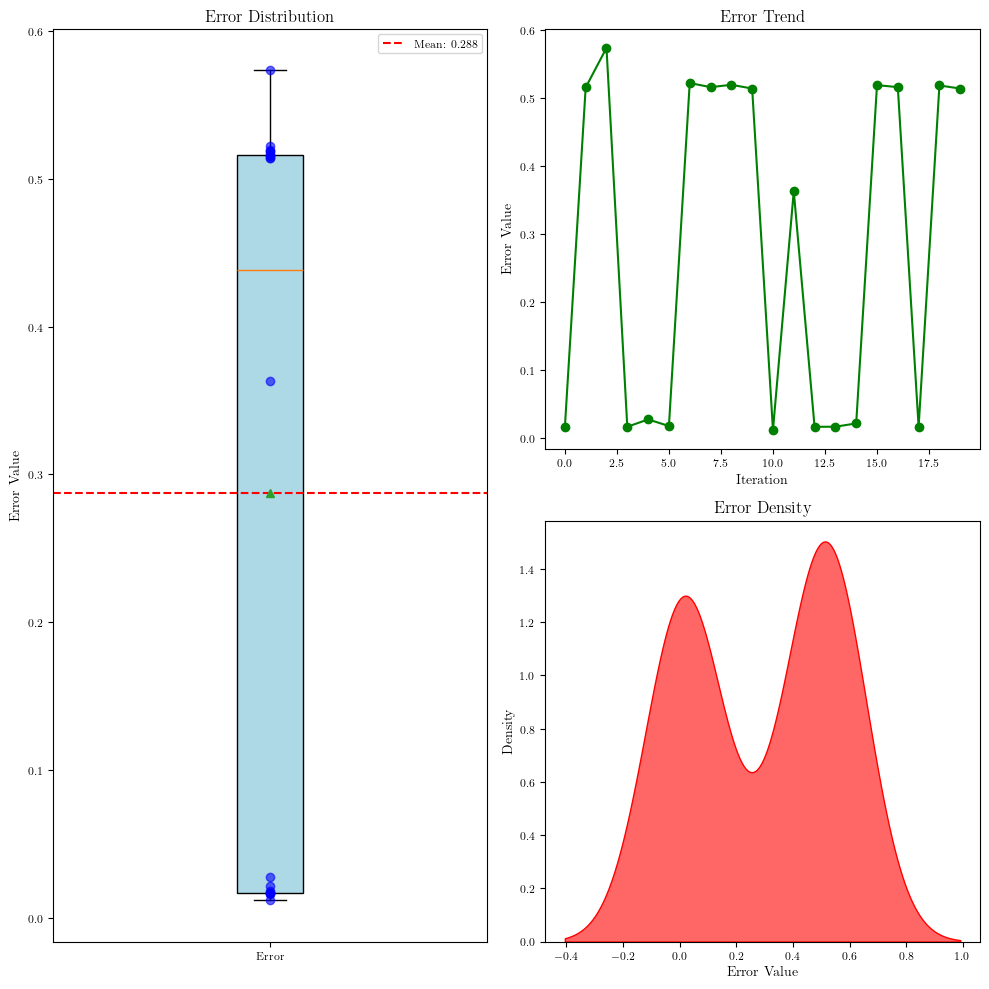

In [9]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # 导入seaborn库用于绘制密度图

# error = [0.5947221810612215, 0.7854634881268653, 1.0077722585678006, 0.5954742844285305, 0.4649590589316285, 0.41386083036181925, 0.6378457066743762, 0.6927021776896086, 0.44767318125257183, 0.28146649498710496, 0.8736713565859818, 0.8516792798779166, 0.37395951530223476, 0.8027823282496178, 0.804560887597274, 0.5182202889333846, 0.18454925778730633, 0.20862581035873265, 0.3739223144578929, 0.528249522241707]

plt.figure(figsize=(10, 10))  # 调整整体图表尺寸

# 左侧子图：箱形图，占据两张图的位置，箱的上下边界为上下四分位数，箱内的横线+三角点为中位数，虚线为均值
plt.subplot(1, 2, 1)  # 第一个子图，现在布局为1行2列
mean_error = np.mean(error)
plt.boxplot(error, patch_artist=True, showmeans=True, meanline=False, boxprops=dict(facecolor='lightblue')) #绘制箱型图，其中error是需要绘制的数据，patch_artist=True表示填充箱体，showmeans=True表示显示均值，meanline=True表示显示均值线，boxprops=dict(facecolor='lightblue')表示箱体的颜色为浅蓝色
plt.axhline(mean_error, color='r', linestyle='--', label=f'Mean: {mean_error:.3f}') #绘制一条水平线，位于mean_error处，颜色为红色，线型为虚线，标签为均值
for i, value in enumerate(error): #遍历error数组，i为索引，value为值
    plt.plot(1, value, 'bo', alpha=0.6) #绘制散点图，横坐标为1，纵坐标为value（即error数组中每个数），颜色为蓝色，点形状为圆圈，透明度为0.6
plt.title('Error Distribution')
plt.ylabel('Error Value')
plt.xticks([1], ['Error']) #设置x轴刻度标签
plt.legend() #显示图例

# 右侧上方子图：折线图
plt.subplot(2, 2, 2)  # 第二个子图，现在布局为2行2列的第二个位置
plt.plot(error, '-o', color='green') #绘制折线图，横坐标为error数组的索引，纵坐标为error数组的值，颜色为绿色，点形状为圆圈
plt.title('Error Trend')
plt.ylabel('Error Value')
plt.xlabel('Iteration')

# 右侧下方子图：密度图
plt.subplot(2, 2, 4)  # 第四个子图，现在布局为2行2列的第四个位置
sns.kdeplot(error, shade=True, color="r", alpha=0.6)
plt.title('Error Density')
plt.xlabel('Error Value')
plt.ylabel('Density')

plt.tight_layout()  # 自动调整子图参数，使之填充整个图表区域
plt.show()

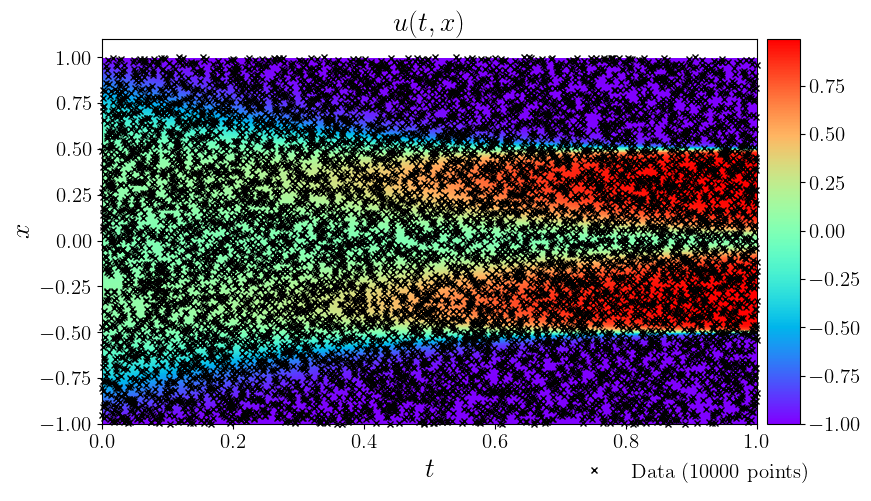

In [10]:
data = scipy.io.loadmat('../data/AC.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = np.real(data['uu']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
#生成一个二位网络，X和T是输出的二维数组
#这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact.flatten()[:,None]   #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组     
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')
U_star = griddata(X_star, u_star.flatten(), (X, T), method='cubic')

###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_star.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


#在图上绘制散点图
ax.plot(
    X_f[:,1], 
    X_f[:,0], 
    'kx', label = 'Data (%d points)' % (X_f.shape[0]), 
    markersize = 4,  # marker size doubled
    clip_on = False,
    alpha=1.0
) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
  #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

In [11]:
trainloss = torch.stack(model.loss_value).cpu().detach().numpy()


testerror = torch.stack(model.test_error).cpu().detach().numpy()

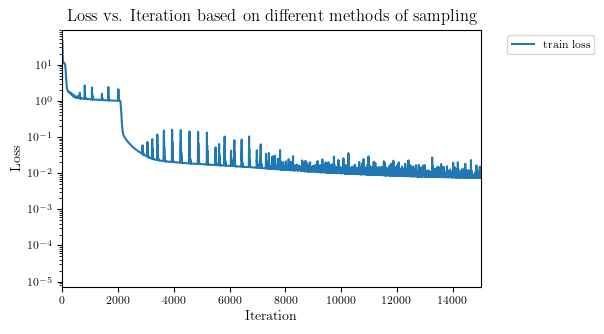

In [12]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(trainloss, label='train loss')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,15000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

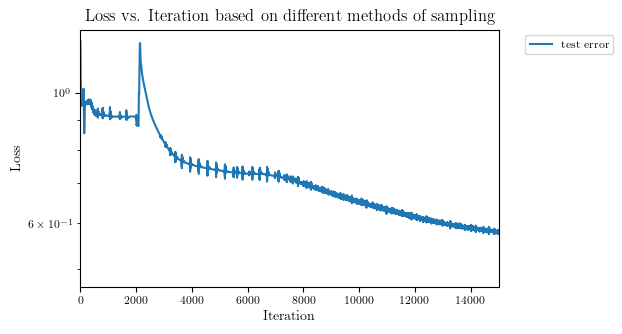

In [13]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
# labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(testerror, label='test error')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,15000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


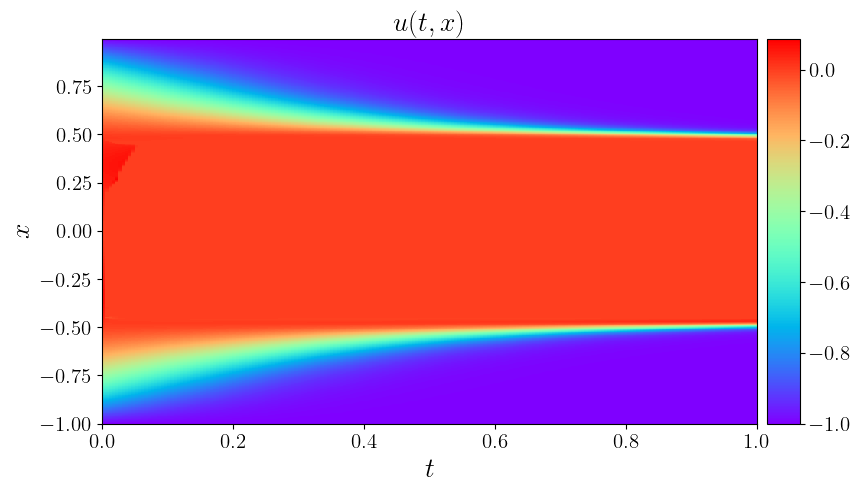

In [14]:
# data = scipy.io.loadmat('../../data/burgers_shock.mat')
# #从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
# t = data['t'].flatten()[:,None]
# x = data['x'].flatten()[:,None]
# Exact = np.real(data['usol']).T #从data数据中取出usol的值，并取实部，最后转置，赋值给Exact
# #生成一个二位网络，X和T是输出的二维数组
# #这个点结果是X和T均为形状为[len(t),len(x)]的二维数组，X的每一行都是x，一共len(t)行，T的每一列都是t，一共len(x)列
# X, T = np.meshgrid(x,t)

# X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #按列堆叠数组，X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_pred, f_pred = model.predict(X_star)    #对Exact_u使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组   


#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(9, 5)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘图的数据来源
h = ax.imshow(U_pred.T, interpolation='nearest', cmap='rainbow', 
              extent=[t.min(), t.max(), x.min(), x.max()], 
              origin='lower', aspect='auto')   #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是U_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                   #第三个参数是颜色映射，这里是用彩虹色图；第四个参数是图像的范围；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                   #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性


#添加颜色条
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.10) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.10）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
   
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的


# #在图上绘制散点图
# ax.plot(
#     X_f_train[:,1], 
#     X_f_train[:,0], 
#     'kx', label = 'Data (%d points)' % (X_f_train.shape[0]), 
#     markersize = 4,  # marker size doubled
#     clip_on = False,
#     alpha=1.0
# ) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
#   #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  




#设置图的标签、图例、标题和刻度标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$', size=20)
ax.set_ylabel('$x$', size=20)
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)
#设置子图ax的标题为$u(t,x)$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为20
ax.set_title('$u(t,x)$', fontsize = 20) # font size doubled，两倍化子图标题
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数

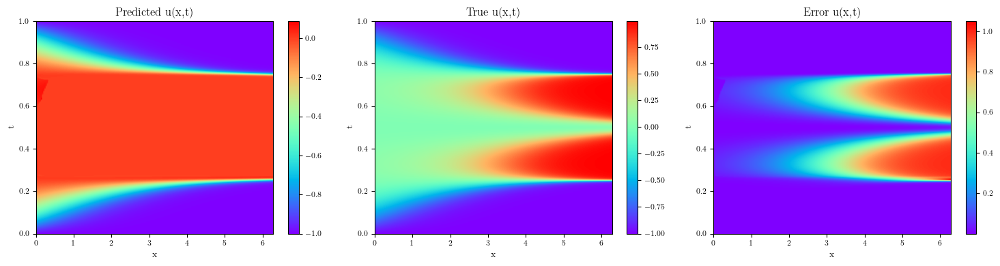

In [15]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_pred.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predicted u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_star.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 绘制第三幅图像
axes[2].imshow(np.abs(U_pred - U_star).T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[2].invert_yaxis()
axes[2].set_xlabel('x')
axes[2].set_ylabel('t')
axes[2].set_title('Error u(x,t)')
fig.colorbar(axes[2].images[0], ax=axes[2])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()